In [1]:
%load_ext autoreload
%autoreload 2

from tqdm import tqdm
from segtok import tokenizer
from utils import *
import hickle

In [2]:
# Key Hyperparameters
balanced_categories = False
enable_orig = "orig"
enable_aug = False
enable_aug3 = False
max_training_samples = 200000
max_tokenized_length = 64
num_sentences = 10
valid_percent = 0.01
sentence_pairs = False

batch_size_finetuning = 32
epochs_finetuning = 1
lr_finetuning = 1e-5

batch_size = 128
epochs = 20
main_model_lr = 1e-5

lstm_hidden_size = 1024
regressive_style_finetuning = False
lstm_bidi = False

experiment_id = f"test"

In [3]:
# Parameters
balanced_categories = False
max_training_samples = 200000
enable_orig = "orig"
enable_aug = False
enable_aug3 = False
sentence_pairs = True
regressive_style_finetuning = False
lstm_bidi = False
lstm_hidden_size = 256
epochs = 20
experiment_id = "classification-sentence-embeddings-balanced_categories-False-max_training_samples-200000-enable_orig-orig-enable_aug-False-enable_aug3-False-sentence_pairs-True-regressive_style_finetuning-False-lstm_bidi-False-lstm_hidden_size-256-epochs-20"


In [4]:
import os
experiment_dir = f"completed-experiments/{experiment_id}"
if not os.path.exists(experiment_dir):
    os.makedirs(experiment_dir)

In [5]:
from data_parsing import *
data = load_dataset("./yelp_review_training_dataset.jsonl")

In [6]:
from training_utils import split_train_validation
from text_preprocessing import preprocess
import random
from math import ceil

def get_train_valid():
    global data
    if enable_orig == "big" or enable_orig == "big-preprocess":
        data += load_gen_dataset("./yelp_dataset/more_yelp_234.json")
    if balanced_categories:
        orig_data_uniform = split_equally(data, ceil(max_training_samples / 0.99))
    else:
        orig_data_uniform = data
    orig_train_x, valid_x, orig_train_y, valid_y = split_train_validation(orig_data_uniform, 0.01)
    train_x = []
    train_y = []

    if enable_aug:
        aug_data = load_gen_dataset("./new_data.json") + load_gen_dataset("./new_data2.json")
        train_x += [i[0] for i in aug_data]
        train_y += [i[1] for i in aug_data]

    if enable_aug3:
        aug_data3 = load_gen_dataset("./new_data3.json")
        train_x += [i[0] for i in aug_data3]
        train_y += [i[1] for i in aug_data3]
        
    if enable_orig:
        train_x += orig_train_x
        train_y += orig_train_y
    
    train_x = train_x[:max_training_samples]
    train_y = train_y[:max_training_samples]

    if enable_orig == "preprocess" or enable_orig == "big-preprocess":
        train_x = preprocess(train_x)
        valid_x = preprocess(valid_x)    

    paired_train = list(zip(train_x, train_y))
    random.shuffle(paired_train)
    train_x = [i[0] for i in paired_train]
    train_y = [i[1] for i in paired_train]

    return [x.encode("utf-8") for x in train_x], [x.encode("utf-8") for x in valid_x], train_y, valid_y

split_key = f"cache-core/split-data-{valid_percent}-orig-{enable_orig}-aug12-{enable_aug}-aug3-{enable_aug3}-max-{max_training_samples}"
if not balanced_categories:
    split_key += "-unbalanced"
train_x, valid_x, train_y, valid_y = memo_load(
    get_train_valid,
    split_key
)
split_hash = hash_file(split_key + ".hkl")

train_x = [x.decode("utf-8") for x in train_x]
valid_x = [x.decode("utf-8") for x in valid_x]

print(len(train_x))

200000


In [7]:
print(len(train_x))
print(len(train_y))
print(len(valid_x))
print(len(valid_y))

200000
200000
5336
5336


In [8]:
import torch as th

device = th.device("cuda" if th.cuda.is_available() else "cpu")
print(device)

from spacy.lang.en import English
nlp = English()
nlp.add_pipe("sentencizer")

cuda


In [9]:
from transformers import BertTokenizerFast, BertForSequenceClassification
tokenizer = BertTokenizerFast.from_pretrained("bert-base-uncased")

In [10]:
# fine tune the BERT
import numpy as np

def get_finetuning_data():
    train_x_numerized = []
    train_x_mask = []
    train_y_per_sentence = []
    for i, text in tqdm(list(enumerate(train_x))):
        doc = nlp(text)
        sents = [str(sent) for sent in doc.sents]
        if sentence_pairs == True and len(sents) > 1:
            sents = [a + b for a, b in zip(sents, sents[1:])]
        if sentence_pairs == "3" and len(sents) > 2:
            sents = [a + b + c for a, b, c in zip(sents, sents[1:], sents[2:])]
        for sentence in sents[:num_sentences]:
            tokenized = tokenizer(sentence, truncation=True, padding="max_length", max_length=max_tokenized_length)[0]
            train_x_numerized.append(tokenized.ids)
            train_x_mask.append(tokenized.attention_mask)
            train_y_per_sentence.append(train_y[i])

    valid_x_numerized = []
    valid_x_mask = []
    valid_y_per_sentence = []
    for i, text in tqdm(list(enumerate(valid_x))):
        doc = nlp(text)
        sents = [str(sent) for sent in doc.sents]
        if sentence_pairs == True and len(sents) > 1:
            sents = [a + b for a, b in zip(sents, sents[1:])]
        if sentence_pairs == "3" and len(sents) > 2:
            sents = [a + b + c for a, b, c in zip(sents, sents[1:], sents[2:])]
        for sentence in sents[:num_sentences]:
            tokenized = tokenizer(sentence, truncation=True, padding="max_length", max_length=max_tokenized_length)[0]
            valid_x_numerized.append(tokenized.ids)
            valid_x_mask.append(tokenized.attention_mask)
            valid_y_per_sentence.append(valid_y[i])

    train_x_numerized = np.array(train_x_numerized)
    train_x_mask = np.array(train_x_mask)
    train_y_per_sentence = np.array(train_y_per_sentence)
    valid_x_numerized = np.array(valid_x_numerized)
    valid_x_mask = np.array(valid_x_mask)
    valid_y_per_sentence = np.array(valid_y_per_sentence)
    return train_x_numerized, train_x_mask, train_y_per_sentence, valid_x_numerized, valid_x_mask, valid_y_per_sentence

from utils import memo_load
finetuning_data_key = f"cache-core/training-data-finetuning-max-tokens-{max_tokenized_length}-split-{split_hash}"
if sentence_pairs:
    if sentence_pairs == "3":
        finetuning_data_key += f"-pairs"
    else:
        finetuning_data_key += f"-pairs-{sentence_pairs}"
(train_x_numerized, train_x_mask, train_y_per_sentence, valid_x_numerized, valid_x_mask, valid_y_per_sentence) = memo_load(
    lambda: get_finetuning_data(),
    finetuning_data_key
)
finetuning_data_hash = hash_file(finetuning_data_key + ".hkl")

In [11]:
from model import ReviewPredictionModel
import torch.optim as optim

def train_finetuning():
    if regressive_style_finetuning:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=1)
    else:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=9)

    model_to_train_finetuning = ReviewPredictionModel(0, max_tokenized_length, regressive_bert_style=regressive_style_finetuning)
    model_to_train_finetuning.transformer = embedding_bert
    model_to_train_finetuning.to(device)
    optimizer = optim.Adam(model_to_train_finetuning.parameters(), lr=lr_finetuning)
    
    training_accuracies_finetuning, validation_accuracies_finetuning = run_training_loop(
        model_to_train_finetuning, optimizer, device,
        batch_size_finetuning, epochs_finetuning,
        train_x_numerized, train_x_mask, train_y_per_sentence, valid_x_numerized, valid_x_mask, valid_y_per_sentence,
        max_validation_examples=256,
        model_id=experiment_id, tag="finetuning"
    )
    
    return embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning

def store_finetuning(tup, folder):
    embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning = tup
    th.save(embedding_bert.state_dict(), f"{folder}/model.pt")
    hickle.dump((training_accuracies_finetuning, validation_accuracies_finetuning), f"{folder}/accuracies.hkl", mode="w")

def load_finetuning(folder):
    if regressive_style_finetuning:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=1)
    else:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=9)
    embedding_bert.load_state_dict(th.load(f"{folder}/model.pt"))
    embedding_bert.eval()
    embedding_bert.to(device)
    training_accuracies_finetuning, validation_accuracies_finetuning = hickle.load(f"{folder}/accuracies.hkl")
    return embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning

In [12]:
from training_utils import run_training_loop

from utils import memo_load
finetuning_model_key = f"cache-core/finetuning-batch-size-{batch_size_finetuning}-epochs-{epochs_finetuning}-lr-{lr_finetuning}-regressive-{regressive_style_finetuning}-data-{finetuning_data_hash}"
embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning = manual_memo(
    train_finetuning, store_finetuning, load_finetuning,
    finetuning_model_key
)

th.save(embedding_bert.state_dict(), f"{experiment_dir}/finetuned-bert.pt")
hickle.dump((training_accuracies_finetuning, validation_accuracies_finetuning), f"{experiment_dir}/finetuning-accuracies.hkl", mode="w")

finetuning_model_hash = hash_file(finetuning_model_key + "/model.pt")

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertForSequenceClassification: ['cls.predictions.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing BertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Some weights of the model checkpoint at distilbert-base-uncased were not used when initializing DistilBertForSequenceClassification: ['vocab_transform.weight', 'vocab_transform.bias', 'vocab_layer_norm.weight', 'vocab_layer_norm.bias', 'vocab_projector.weight', 'vocab_projector.bias']
- This IS expected if you are initializing DistilBertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DistilBertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['pre_classifier.weight', 'pre_classifier.bias', 'classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


  0%|          | 0/32185 [00:00<?, ?it/s]

Epoch: 0 Iteration: 0 Loss: 2.287 Validation Loss: 2.287 Accuracy: 0.000 Validation Accuracy: 0.020:   0%|          | 0/32185 [00:00<?, ?it/s]

Epoch: 0 Iteration: 0 Loss: 2.287 Validation Loss: 2.287 Accuracy: 0.000 Validation Accuracy: 0.020:   0%|          | 1/32185 [00:00<6:05:07,  1.47it/s]

Epoch: 0 Iteration: 1 Loss: 2.303 Validation Loss: 2.287 Accuracy: 0.031 Validation Accuracy: 0.020:   0%|          | 1/32185 [00:00<6:05:07,  1.47it/s]

Epoch: 0 Iteration: 2 Loss: 2.274 Validation Loss: 2.287 Accuracy: 0.031 Validation Accuracy: 0.020:   0%|          | 1/32185 [00:00<6:05:07,  1.47it/s]

Epoch: 0 Iteration: 2 Loss: 2.274 Validation Loss: 2.287 Accuracy: 0.031 Validation Accuracy: 0.020:   0%|          | 3/32185 [00:00<2:11:35,  4.08it/s]

Epoch: 0 Iteration: 3 Loss: 2.260 Validation Loss: 2.287 Accuracy: 0.062 Validation Accuracy: 0.020:   0%|          | 3/32185 [00:00<2:11:35,  4.08it/s]

Epoch: 0 Iteration: 4 Loss: 2.236 Validation Loss: 2.287 Accuracy: 0.081 Validation Accuracy: 0.020:   0%|          | 3/32185 [00:01<2:11:35,  4.08it/s]

Epoch: 0 Iteration: 4 Loss: 2.236 Validation Loss: 2.287 Accuracy: 0.081 Validation Accuracy: 0.020:   0%|          | 5/32185 [00:01<1:30:37,  5.92it/s]

Epoch: 0 Iteration: 5 Loss: 2.218 Validation Loss: 2.287 Accuracy: 0.104 Validation Accuracy: 0.020:   0%|          | 5/32185 [00:01<1:30:37,  5.92it/s]

Epoch: 0 Iteration: 6 Loss: 2.197 Validation Loss: 2.287 Accuracy: 0.147 Validation Accuracy: 0.020:   0%|          | 5/32185 [00:01<1:30:37,  5.92it/s]

Epoch: 0 Iteration: 6 Loss: 2.197 Validation Loss: 2.287 Accuracy: 0.147 Validation Accuracy: 0.020:   0%|          | 7/32185 [00:01<1:14:11,  7.23it/s]

Epoch: 0 Iteration: 7 Loss: 2.188 Validation Loss: 2.287 Accuracy: 0.176 Validation Accuracy: 0.020:   0%|          | 7/32185 [00:01<1:14:11,  7.23it/s]

Epoch: 0 Iteration: 8 Loss: 2.175 Validation Loss: 2.287 Accuracy: 0.198 Validation Accuracy: 0.020:   0%|          | 7/32185 [00:01<1:14:11,  7.23it/s]

Epoch: 0 Iteration: 8 Loss: 2.175 Validation Loss: 2.287 Accuracy: 0.198 Validation Accuracy: 0.020:   0%|          | 9/32185 [00:01<1:05:42,  8.16it/s]

Epoch: 0 Iteration: 9 Loss: 2.161 Validation Loss: 2.287 Accuracy: 0.216 Validation Accuracy: 0.020:   0%|          | 9/32185 [00:01<1:05:42,  8.16it/s]

Epoch: 0 Iteration: 10 Loss: 2.149 Validation Loss: 2.287 Accuracy: 0.259 Validation Accuracy: 0.020:   0%|          | 9/32185 [00:01<1:05:42,  8.16it/s]

Epoch: 0 Iteration: 10 Loss: 2.149 Validation Loss: 2.287 Accuracy: 0.259 Validation Accuracy: 0.020:   0%|          | 11/32185 [00:01<1:00:50,  8.81it/s]

Epoch: 0 Iteration: 11 Loss: 2.138 Validation Loss: 2.287 Accuracy: 0.294 Validation Accuracy: 0.020:   0%|          | 11/32185 [00:01<1:00:50,  8.81it/s]

Epoch: 0 Iteration: 12 Loss: 2.125 Validation Loss: 2.287 Accuracy: 0.334 Validation Accuracy: 0.020:   0%|          | 11/32185 [00:01<1:00:50,  8.81it/s]

Epoch: 0 Iteration: 12 Loss: 2.125 Validation Loss: 2.287 Accuracy: 0.334 Validation Accuracy: 0.020:   0%|          | 13/32185 [00:01<57:48,  9.27it/s]  

Epoch: 0 Iteration: 13 Loss: 2.110 Validation Loss: 2.287 Accuracy: 0.362 Validation Accuracy: 0.020:   0%|          | 13/32185 [00:01<57:48,  9.27it/s]

Epoch: 0 Iteration: 14 Loss: 2.107 Validation Loss: 2.287 Accuracy: 0.381 Validation Accuracy: 0.020:   0%|          | 13/32185 [00:02<57:48,  9.27it/s]

Epoch: 0 Iteration: 14 Loss: 2.107 Validation Loss: 2.287 Accuracy: 0.381 Validation Accuracy: 0.020:   0%|          | 15/32185 [00:02<55:52,  9.60it/s]

Epoch: 0 Iteration: 15 Loss: 2.090 Validation Loss: 2.287 Accuracy: 0.403 Validation Accuracy: 0.020:   0%|          | 15/32185 [00:02<55:52,  9.60it/s]

Epoch: 0 Iteration: 16 Loss: 2.076 Validation Loss: 2.287 Accuracy: 0.406 Validation Accuracy: 0.020:   0%|          | 15/32185 [00:02<55:52,  9.60it/s]

Epoch: 0 Iteration: 16 Loss: 2.076 Validation Loss: 2.287 Accuracy: 0.406 Validation Accuracy: 0.020:   0%|          | 17/32185 [00:02<54:34,  9.82it/s]

Epoch: 0 Iteration: 17 Loss: 2.060 Validation Loss: 2.287 Accuracy: 0.422 Validation Accuracy: 0.020:   0%|          | 17/32185 [00:02<54:34,  9.82it/s]

Epoch: 0 Iteration: 18 Loss: 2.051 Validation Loss: 2.287 Accuracy: 0.422 Validation Accuracy: 0.020:   0%|          | 17/32185 [00:02<54:34,  9.82it/s]

Epoch: 0 Iteration: 18 Loss: 2.051 Validation Loss: 2.287 Accuracy: 0.422 Validation Accuracy: 0.020:   0%|          | 19/32185 [00:02<53:41,  9.99it/s]

Epoch: 0 Iteration: 19 Loss: 2.040 Validation Loss: 2.287 Accuracy: 0.434 Validation Accuracy: 0.020:   0%|          | 19/32185 [00:02<53:41,  9.99it/s]

Epoch: 0 Iteration: 20 Loss: 2.014 Validation Loss: 2.287 Accuracy: 0.428 Validation Accuracy: 0.020:   0%|          | 19/32185 [00:02<53:41,  9.99it/s]

Epoch: 0 Iteration: 20 Loss: 2.014 Validation Loss: 2.287 Accuracy: 0.428 Validation Accuracy: 0.020:   0%|          | 21/32185 [00:02<53:06, 10.09it/s]

Epoch: 0 Iteration: 21 Loss: 1.986 Validation Loss: 2.287 Accuracy: 0.438 Validation Accuracy: 0.020:   0%|          | 21/32185 [00:02<53:06, 10.09it/s]

Epoch: 0 Iteration: 22 Loss: 1.965 Validation Loss: 2.287 Accuracy: 0.434 Validation Accuracy: 0.020:   0%|          | 21/32185 [00:02<53:06, 10.09it/s]

Epoch: 0 Iteration: 22 Loss: 1.965 Validation Loss: 2.287 Accuracy: 0.434 Validation Accuracy: 0.020:   0%|          | 23/32185 [00:02<52:41, 10.17it/s]

Epoch: 0 Iteration: 23 Loss: 1.934 Validation Loss: 2.287 Accuracy: 0.450 Validation Accuracy: 0.020:   0%|          | 23/32185 [00:02<52:41, 10.17it/s]

Epoch: 0 Iteration: 24 Loss: 1.918 Validation Loss: 2.287 Accuracy: 0.453 Validation Accuracy: 0.020:   0%|          | 23/32185 [00:02<52:41, 10.17it/s]

Epoch: 0 Iteration: 24 Loss: 1.918 Validation Loss: 2.287 Accuracy: 0.453 Validation Accuracy: 0.020:   0%|          | 25/32185 [00:02<52:24, 10.23it/s]

Epoch: 0 Iteration: 25 Loss: 1.885 Validation Loss: 2.287 Accuracy: 0.472 Validation Accuracy: 0.020:   0%|          | 25/32185 [00:03<52:24, 10.23it/s]

Epoch: 0 Iteration: 26 Loss: 1.859 Validation Loss: 2.287 Accuracy: 0.478 Validation Accuracy: 0.020:   0%|          | 25/32185 [00:03<52:24, 10.23it/s]

Epoch: 0 Iteration: 26 Loss: 1.859 Validation Loss: 2.287 Accuracy: 0.478 Validation Accuracy: 0.020:   0%|          | 27/32185 [00:03<52:11, 10.27it/s]

Epoch: 0 Iteration: 27 Loss: 1.831 Validation Loss: 2.287 Accuracy: 0.475 Validation Accuracy: 0.020:   0%|          | 27/32185 [00:03<52:11, 10.27it/s]

Epoch: 0 Iteration: 28 Loss: 1.814 Validation Loss: 2.287 Accuracy: 0.478 Validation Accuracy: 0.020:   0%|          | 27/32185 [00:03<52:11, 10.27it/s]

Epoch: 0 Iteration: 28 Loss: 1.814 Validation Loss: 2.287 Accuracy: 0.478 Validation Accuracy: 0.020:   0%|          | 29/32185 [00:03<52:03, 10.29it/s]

Epoch: 0 Iteration: 29 Loss: 1.796 Validation Loss: 2.287 Accuracy: 0.463 Validation Accuracy: 0.020:   0%|          | 29/32185 [00:03<52:03, 10.29it/s]

Epoch: 0 Iteration: 30 Loss: 1.775 Validation Loss: 2.287 Accuracy: 0.472 Validation Accuracy: 0.020:   0%|          | 29/32185 [00:03<52:03, 10.29it/s]

Epoch: 0 Iteration: 30 Loss: 1.775 Validation Loss: 2.287 Accuracy: 0.472 Validation Accuracy: 0.020:   0%|          | 31/32185 [00:03<51:57, 10.31it/s]

Epoch: 0 Iteration: 31 Loss: 1.755 Validation Loss: 2.287 Accuracy: 0.466 Validation Accuracy: 0.020:   0%|          | 31/32185 [00:03<51:57, 10.31it/s]

Epoch: 0 Iteration: 32 Loss: 1.742 Validation Loss: 2.287 Accuracy: 0.463 Validation Accuracy: 0.020:   0%|          | 31/32185 [00:03<51:57, 10.31it/s]

Epoch: 0 Iteration: 32 Loss: 1.742 Validation Loss: 2.287 Accuracy: 0.463 Validation Accuracy: 0.020:   0%|          | 33/32185 [00:03<51:54, 10.32it/s]

Epoch: 0 Iteration: 33 Loss: 1.725 Validation Loss: 2.287 Accuracy: 0.453 Validation Accuracy: 0.020:   0%|          | 33/32185 [00:03<51:54, 10.32it/s]

Epoch: 0 Iteration: 34 Loss: 1.696 Validation Loss: 2.287 Accuracy: 0.472 Validation Accuracy: 0.020:   0%|          | 33/32185 [00:03<51:54, 10.32it/s]

Epoch: 0 Iteration: 34 Loss: 1.696 Validation Loss: 2.287 Accuracy: 0.472 Validation Accuracy: 0.020:   0%|          | 35/32185 [00:03<51:51, 10.33it/s]

Epoch: 0 Iteration: 35 Loss: 1.687 Validation Loss: 2.287 Accuracy: 0.447 Validation Accuracy: 0.020:   0%|          | 35/32185 [00:04<51:51, 10.33it/s]

Epoch: 0 Iteration: 36 Loss: 1.672 Validation Loss: 2.287 Accuracy: 0.441 Validation Accuracy: 0.020:   0%|          | 35/32185 [00:04<51:51, 10.33it/s]

Epoch: 0 Iteration: 36 Loss: 1.672 Validation Loss: 2.287 Accuracy: 0.441 Validation Accuracy: 0.020:   0%|          | 37/32185 [00:04<51:50, 10.33it/s]

Epoch: 0 Iteration: 37 Loss: 1.661 Validation Loss: 2.287 Accuracy: 0.438 Validation Accuracy: 0.020:   0%|          | 37/32185 [00:04<51:50, 10.33it/s]

Epoch: 0 Iteration: 38 Loss: 1.645 Validation Loss: 2.287 Accuracy: 0.447 Validation Accuracy: 0.020:   0%|          | 37/32185 [00:04<51:50, 10.33it/s]

Epoch: 0 Iteration: 38 Loss: 1.645 Validation Loss: 2.287 Accuracy: 0.447 Validation Accuracy: 0.020:   0%|          | 39/32185 [00:04<51:48, 10.34it/s]

Epoch: 0 Iteration: 39 Loss: 1.647 Validation Loss: 2.287 Accuracy: 0.434 Validation Accuracy: 0.020:   0%|          | 39/32185 [00:04<51:48, 10.34it/s]

Epoch: 0 Iteration: 40 Loss: 1.634 Validation Loss: 2.287 Accuracy: 0.434 Validation Accuracy: 0.020:   0%|          | 39/32185 [00:04<51:48, 10.34it/s]

Epoch: 0 Iteration: 40 Loss: 1.634 Validation Loss: 2.287 Accuracy: 0.434 Validation Accuracy: 0.020:   0%|          | 41/32185 [00:04<51:47, 10.34it/s]

Epoch: 0 Iteration: 41 Loss: 1.622 Validation Loss: 2.287 Accuracy: 0.444 Validation Accuracy: 0.020:   0%|          | 41/32185 [00:04<51:47, 10.34it/s]

Epoch: 0 Iteration: 42 Loss: 1.612 Validation Loss: 2.287 Accuracy: 0.453 Validation Accuracy: 0.020:   0%|          | 41/32185 [00:04<51:47, 10.34it/s]

Epoch: 0 Iteration: 42 Loss: 1.612 Validation Loss: 2.287 Accuracy: 0.453 Validation Accuracy: 0.020:   0%|          | 43/32185 [00:04<51:46, 10.35it/s]

Epoch: 0 Iteration: 43 Loss: 1.605 Validation Loss: 2.287 Accuracy: 0.453 Validation Accuracy: 0.020:   0%|          | 43/32185 [00:04<51:46, 10.35it/s]

Epoch: 0 Iteration: 44 Loss: 1.589 Validation Loss: 2.287 Accuracy: 0.450 Validation Accuracy: 0.020:   0%|          | 43/32185 [00:04<51:46, 10.35it/s]

Epoch: 0 Iteration: 44 Loss: 1.589 Validation Loss: 2.287 Accuracy: 0.450 Validation Accuracy: 0.020:   0%|          | 45/32185 [00:04<51:51, 10.33it/s]

Epoch: 0 Iteration: 45 Loss: 1.582 Validation Loss: 2.287 Accuracy: 0.469 Validation Accuracy: 0.020:   0%|          | 45/32185 [00:05<51:51, 10.33it/s]

Epoch: 0 Iteration: 46 Loss: 1.575 Validation Loss: 2.287 Accuracy: 0.481 Validation Accuracy: 0.020:   0%|          | 45/32185 [00:05<51:51, 10.33it/s]

Epoch: 0 Iteration: 46 Loss: 1.575 Validation Loss: 2.287 Accuracy: 0.481 Validation Accuracy: 0.020:   0%|          | 47/32185 [00:05<51:52, 10.32it/s]

Epoch: 0 Iteration: 47 Loss: 1.576 Validation Loss: 2.287 Accuracy: 0.484 Validation Accuracy: 0.020:   0%|          | 47/32185 [00:05<51:52, 10.32it/s]

Epoch: 0 Iteration: 48 Loss: 1.559 Validation Loss: 2.287 Accuracy: 0.487 Validation Accuracy: 0.020:   0%|          | 47/32185 [00:05<51:52, 10.32it/s]

Epoch: 0 Iteration: 48 Loss: 1.559 Validation Loss: 2.287 Accuracy: 0.487 Validation Accuracy: 0.020:   0%|          | 49/32185 [00:05<51:48, 10.34it/s]

Epoch: 0 Iteration: 49 Loss: 1.547 Validation Loss: 2.287 Accuracy: 0.528 Validation Accuracy: 0.020:   0%|          | 49/32185 [00:05<51:48, 10.34it/s]

Epoch: 0 Iteration: 50 Loss: 1.541 Validation Loss: 2.287 Accuracy: 0.534 Validation Accuracy: 0.020:   0%|          | 49/32185 [00:05<51:48, 10.34it/s]

Epoch: 0 Iteration: 50 Loss: 1.541 Validation Loss: 2.287 Accuracy: 0.534 Validation Accuracy: 0.020:   0%|          | 51/32185 [00:05<52:06, 10.28it/s]

Epoch: 0 Iteration: 51 Loss: 1.537 Validation Loss: 2.287 Accuracy: 0.537 Validation Accuracy: 0.020:   0%|          | 51/32185 [00:05<52:06, 10.28it/s]

Epoch: 0 Iteration: 52 Loss: 1.531 Validation Loss: 2.287 Accuracy: 0.525 Validation Accuracy: 0.020:   0%|          | 51/32185 [00:05<52:06, 10.28it/s]

Epoch: 0 Iteration: 52 Loss: 1.531 Validation Loss: 2.287 Accuracy: 0.525 Validation Accuracy: 0.020:   0%|          | 53/32185 [00:05<51:58, 10.30it/s]

Epoch: 0 Iteration: 53 Loss: 1.525 Validation Loss: 2.287 Accuracy: 0.519 Validation Accuracy: 0.020:   0%|          | 53/32185 [00:05<51:58, 10.30it/s]

Epoch: 0 Iteration: 54 Loss: 1.521 Validation Loss: 2.287 Accuracy: 0.506 Validation Accuracy: 0.020:   0%|          | 53/32185 [00:05<51:58, 10.30it/s]

Epoch: 0 Iteration: 54 Loss: 1.521 Validation Loss: 2.287 Accuracy: 0.506 Validation Accuracy: 0.020:   0%|          | 55/32185 [00:05<52:00, 10.30it/s]

Epoch: 0 Iteration: 55 Loss: 1.511 Validation Loss: 2.287 Accuracy: 0.487 Validation Accuracy: 0.020:   0%|          | 55/32185 [00:05<52:00, 10.30it/s]

Epoch: 0 Iteration: 56 Loss: 1.494 Validation Loss: 2.287 Accuracy: 0.500 Validation Accuracy: 0.020:   0%|          | 55/32185 [00:06<52:00, 10.30it/s]

Epoch: 0 Iteration: 56 Loss: 1.494 Validation Loss: 2.287 Accuracy: 0.500 Validation Accuracy: 0.020:   0%|          | 57/32185 [00:06<51:55, 10.31it/s]

Epoch: 0 Iteration: 57 Loss: 1.487 Validation Loss: 2.287 Accuracy: 0.509 Validation Accuracy: 0.020:   0%|          | 57/32185 [00:06<51:55, 10.31it/s]

Epoch: 0 Iteration: 58 Loss: 1.484 Validation Loss: 2.287 Accuracy: 0.500 Validation Accuracy: 0.020:   0%|          | 57/32185 [00:06<51:55, 10.31it/s]

Epoch: 0 Iteration: 58 Loss: 1.484 Validation Loss: 2.287 Accuracy: 0.500 Validation Accuracy: 0.020:   0%|          | 59/32185 [00:06<51:55, 10.31it/s]

Epoch: 0 Iteration: 59 Loss: 1.472 Validation Loss: 2.287 Accuracy: 0.481 Validation Accuracy: 0.020:   0%|          | 59/32185 [00:06<51:55, 10.31it/s]

Epoch: 0 Iteration: 60 Loss: 1.470 Validation Loss: 2.287 Accuracy: 0.478 Validation Accuracy: 0.020:   0%|          | 59/32185 [00:06<51:55, 10.31it/s]

Epoch: 0 Iteration: 60 Loss: 1.470 Validation Loss: 2.287 Accuracy: 0.478 Validation Accuracy: 0.020:   0%|          | 61/32185 [00:06<51:57, 10.31it/s]

Epoch: 0 Iteration: 61 Loss: 1.465 Validation Loss: 2.287 Accuracy: 0.478 Validation Accuracy: 0.020:   0%|          | 61/32185 [00:06<51:57, 10.31it/s]

Epoch: 0 Iteration: 62 Loss: 1.451 Validation Loss: 2.287 Accuracy: 0.503 Validation Accuracy: 0.020:   0%|          | 61/32185 [00:06<51:57, 10.31it/s]

Epoch: 0 Iteration: 62 Loss: 1.451 Validation Loss: 2.287 Accuracy: 0.503 Validation Accuracy: 0.020:   0%|          | 63/32185 [00:06<52:02, 10.29it/s]

Epoch: 0 Iteration: 63 Loss: 1.446 Validation Loss: 2.287 Accuracy: 0.512 Validation Accuracy: 0.020:   0%|          | 63/32185 [00:06<52:02, 10.29it/s]

Epoch: 0 Iteration: 64 Loss: 1.450 Validation Loss: 2.287 Accuracy: 0.512 Validation Accuracy: 0.020:   0%|          | 63/32185 [00:06<52:02, 10.29it/s]

Epoch: 0 Iteration: 64 Loss: 1.450 Validation Loss: 2.287 Accuracy: 0.512 Validation Accuracy: 0.020:   0%|          | 65/32185 [00:06<52:16, 10.24it/s]

Epoch: 0 Iteration: 65 Loss: 1.447 Validation Loss: 2.287 Accuracy: 0.541 Validation Accuracy: 0.020:   0%|          | 65/32185 [00:06<52:16, 10.24it/s]

Epoch: 0 Iteration: 66 Loss: 1.445 Validation Loss: 2.287 Accuracy: 0.531 Validation Accuracy: 0.020:   0%|          | 65/32185 [00:07<52:16, 10.24it/s]

Epoch: 0 Iteration: 66 Loss: 1.445 Validation Loss: 2.287 Accuracy: 0.531 Validation Accuracy: 0.020:   0%|          | 67/32185 [00:07<51:54, 10.31it/s]

Epoch: 0 Iteration: 67 Loss: 1.436 Validation Loss: 2.287 Accuracy: 0.531 Validation Accuracy: 0.020:   0%|          | 67/32185 [00:07<51:54, 10.31it/s]

Epoch: 0 Iteration: 68 Loss: 1.436 Validation Loss: 2.287 Accuracy: 0.537 Validation Accuracy: 0.020:   0%|          | 67/32185 [00:07<51:54, 10.31it/s]

Epoch: 0 Iteration: 68 Loss: 1.436 Validation Loss: 2.287 Accuracy: 0.537 Validation Accuracy: 0.020:   0%|          | 69/32185 [00:07<51:50, 10.33it/s]

Epoch: 0 Iteration: 69 Loss: 1.440 Validation Loss: 2.287 Accuracy: 0.550 Validation Accuracy: 0.020:   0%|          | 69/32185 [00:07<51:50, 10.33it/s]

Epoch: 0 Iteration: 70 Loss: 1.440 Validation Loss: 2.287 Accuracy: 0.550 Validation Accuracy: 0.020:   0%|          | 69/32185 [00:07<51:50, 10.33it/s]

Epoch: 0 Iteration: 70 Loss: 1.440 Validation Loss: 2.287 Accuracy: 0.550 Validation Accuracy: 0.020:   0%|          | 71/32185 [00:07<51:48, 10.33it/s]

Epoch: 0 Iteration: 71 Loss: 1.431 Validation Loss: 2.287 Accuracy: 0.553 Validation Accuracy: 0.020:   0%|          | 71/32185 [00:07<51:48, 10.33it/s]

Epoch: 0 Iteration: 72 Loss: 1.414 Validation Loss: 2.287 Accuracy: 0.559 Validation Accuracy: 0.020:   0%|          | 71/32185 [00:07<51:48, 10.33it/s]

Epoch: 0 Iteration: 72 Loss: 1.414 Validation Loss: 2.287 Accuracy: 0.559 Validation Accuracy: 0.020:   0%|          | 73/32185 [00:07<51:47, 10.34it/s]

Epoch: 0 Iteration: 73 Loss: 1.414 Validation Loss: 2.287 Accuracy: 0.556 Validation Accuracy: 0.020:   0%|          | 73/32185 [00:07<51:47, 10.34it/s]

Epoch: 0 Iteration: 74 Loss: 1.402 Validation Loss: 2.287 Accuracy: 0.588 Validation Accuracy: 0.020:   0%|          | 73/32185 [00:07<51:47, 10.34it/s]

Epoch: 0 Iteration: 74 Loss: 1.402 Validation Loss: 2.287 Accuracy: 0.588 Validation Accuracy: 0.020:   0%|          | 75/32185 [00:07<51:45, 10.34it/s]

Epoch: 0 Iteration: 75 Loss: 1.407 Validation Loss: 2.287 Accuracy: 0.562 Validation Accuracy: 0.020:   0%|          | 75/32185 [00:07<51:45, 10.34it/s]

Epoch: 0 Iteration: 76 Loss: 1.422 Validation Loss: 2.287 Accuracy: 0.544 Validation Accuracy: 0.020:   0%|          | 75/32185 [00:08<51:45, 10.34it/s]

Epoch: 0 Iteration: 76 Loss: 1.422 Validation Loss: 2.287 Accuracy: 0.544 Validation Accuracy: 0.020:   0%|          | 77/32185 [00:08<51:44, 10.34it/s]

Epoch: 0 Iteration: 77 Loss: 1.427 Validation Loss: 2.287 Accuracy: 0.528 Validation Accuracy: 0.020:   0%|          | 77/32185 [00:08<51:44, 10.34it/s]

Epoch: 0 Iteration: 78 Loss: 1.411 Validation Loss: 2.287 Accuracy: 0.550 Validation Accuracy: 0.020:   0%|          | 77/32185 [00:08<51:44, 10.34it/s]

Epoch: 0 Iteration: 78 Loss: 1.411 Validation Loss: 2.287 Accuracy: 0.550 Validation Accuracy: 0.020:   0%|          | 79/32185 [00:08<51:42, 10.35it/s]

Epoch: 0 Iteration: 79 Loss: 1.382 Validation Loss: 2.287 Accuracy: 0.572 Validation Accuracy: 0.020:   0%|          | 79/32185 [00:08<51:42, 10.35it/s]

Epoch: 0 Iteration: 80 Loss: 1.367 Validation Loss: 2.287 Accuracy: 0.597 Validation Accuracy: 0.020:   0%|          | 79/32185 [00:08<51:42, 10.35it/s]

Epoch: 0 Iteration: 80 Loss: 1.367 Validation Loss: 2.287 Accuracy: 0.597 Validation Accuracy: 0.020:   0%|          | 81/32185 [00:08<51:43, 10.35it/s]

Epoch: 0 Iteration: 81 Loss: 1.354 Validation Loss: 2.287 Accuracy: 0.603 Validation Accuracy: 0.020:   0%|          | 81/32185 [00:08<51:43, 10.35it/s]

Epoch: 0 Iteration: 82 Loss: 1.357 Validation Loss: 2.287 Accuracy: 0.600 Validation Accuracy: 0.020:   0%|          | 81/32185 [00:08<51:43, 10.35it/s]

Epoch: 0 Iteration: 82 Loss: 1.357 Validation Loss: 2.287 Accuracy: 0.600 Validation Accuracy: 0.020:   0%|          | 83/32185 [00:08<51:43, 10.35it/s]

Epoch: 0 Iteration: 83 Loss: 1.350 Validation Loss: 2.287 Accuracy: 0.613 Validation Accuracy: 0.020:   0%|          | 83/32185 [00:08<51:43, 10.35it/s]

Epoch: 0 Iteration: 84 Loss: 1.342 Validation Loss: 2.287 Accuracy: 0.594 Validation Accuracy: 0.020:   0%|          | 83/32185 [00:08<51:43, 10.35it/s]

Epoch: 0 Iteration: 84 Loss: 1.342 Validation Loss: 2.287 Accuracy: 0.594 Validation Accuracy: 0.020:   0%|          | 85/32185 [00:08<51:45, 10.34it/s]

Epoch: 0 Iteration: 85 Loss: 1.342 Validation Loss: 2.287 Accuracy: 0.622 Validation Accuracy: 0.020:   0%|          | 85/32185 [00:08<51:45, 10.34it/s]

Epoch: 0 Iteration: 86 Loss: 1.333 Validation Loss: 2.287 Accuracy: 0.641 Validation Accuracy: 0.020:   0%|          | 85/32185 [00:08<51:45, 10.34it/s]

Epoch: 0 Iteration: 86 Loss: 1.333 Validation Loss: 2.287 Accuracy: 0.641 Validation Accuracy: 0.020:   0%|          | 87/32185 [00:08<51:45, 10.34it/s]

Epoch: 0 Iteration: 87 Loss: 1.337 Validation Loss: 2.287 Accuracy: 0.647 Validation Accuracy: 0.020:   0%|          | 87/32185 [00:09<51:45, 10.34it/s]

Epoch: 0 Iteration: 88 Loss: 1.330 Validation Loss: 2.287 Accuracy: 0.644 Validation Accuracy: 0.020:   0%|          | 87/32185 [00:09<51:45, 10.34it/s]

Epoch: 0 Iteration: 88 Loss: 1.330 Validation Loss: 2.287 Accuracy: 0.644 Validation Accuracy: 0.020:   0%|          | 89/32185 [00:09<51:44, 10.34it/s]

Epoch: 0 Iteration: 89 Loss: 1.318 Validation Loss: 2.287 Accuracy: 0.625 Validation Accuracy: 0.020:   0%|          | 89/32185 [00:09<51:44, 10.34it/s]

Epoch: 0 Iteration: 90 Loss: 1.311 Validation Loss: 2.287 Accuracy: 0.603 Validation Accuracy: 0.020:   0%|          | 89/32185 [00:09<51:44, 10.34it/s]

Epoch: 0 Iteration: 90 Loss: 1.311 Validation Loss: 2.287 Accuracy: 0.603 Validation Accuracy: 0.020:   0%|          | 91/32185 [00:09<51:42, 10.34it/s]

Epoch: 0 Iteration: 91 Loss: 1.298 Validation Loss: 2.287 Accuracy: 0.603 Validation Accuracy: 0.020:   0%|          | 91/32185 [00:09<51:42, 10.34it/s]

Epoch: 0 Iteration: 92 Loss: 1.304 Validation Loss: 2.287 Accuracy: 0.603 Validation Accuracy: 0.020:   0%|          | 91/32185 [00:09<51:42, 10.34it/s]

Epoch: 0 Iteration: 92 Loss: 1.304 Validation Loss: 2.287 Accuracy: 0.603 Validation Accuracy: 0.020:   0%|          | 93/32185 [00:09<51:46, 10.33it/s]

Epoch: 0 Iteration: 93 Loss: 1.294 Validation Loss: 2.287 Accuracy: 0.597 Validation Accuracy: 0.020:   0%|          | 93/32185 [00:09<51:46, 10.33it/s]

Epoch: 0 Iteration: 94 Loss: 1.297 Validation Loss: 2.287 Accuracy: 0.594 Validation Accuracy: 0.020:   0%|          | 93/32185 [00:09<51:46, 10.33it/s]

Epoch: 0 Iteration: 94 Loss: 1.297 Validation Loss: 2.287 Accuracy: 0.594 Validation Accuracy: 0.020:   0%|          | 95/32185 [00:09<51:44, 10.34it/s]

Epoch: 0 Iteration: 95 Loss: 1.275 Validation Loss: 2.287 Accuracy: 0.597 Validation Accuracy: 0.020:   0%|          | 95/32185 [00:09<51:44, 10.34it/s]

Epoch: 0 Iteration: 96 Loss: 1.268 Validation Loss: 2.287 Accuracy: 0.591 Validation Accuracy: 0.020:   0%|          | 95/32185 [00:09<51:44, 10.34it/s]

Epoch: 0 Iteration: 96 Loss: 1.268 Validation Loss: 2.287 Accuracy: 0.591 Validation Accuracy: 0.020:   0%|          | 97/32185 [00:09<51:42, 10.34it/s]

Epoch: 0 Iteration: 97 Loss: 1.257 Validation Loss: 2.287 Accuracy: 0.591 Validation Accuracy: 0.020:   0%|          | 97/32185 [00:10<51:42, 10.34it/s]

Epoch: 0 Iteration: 98 Loss: 1.259 Validation Loss: 2.287 Accuracy: 0.578 Validation Accuracy: 0.020:   0%|          | 97/32185 [00:10<51:42, 10.34it/s]

Epoch: 0 Iteration: 98 Loss: 1.259 Validation Loss: 2.287 Accuracy: 0.578 Validation Accuracy: 0.020:   0%|          | 99/32185 [00:10<51:42, 10.34it/s]

Epoch: 0 Iteration: 99 Loss: 1.275 Validation Loss: 2.287 Accuracy: 0.562 Validation Accuracy: 0.020:   0%|          | 99/32185 [00:10<51:42, 10.34it/s]

Epoch: 0 Iteration: 100 Loss: 1.287 Validation Loss: 1.374 Accuracy: 0.566 Validation Accuracy: 0.277:   0%|          | 99/32185 [00:10<51:42, 10.34it/s]

Epoch: 0 Iteration: 100 Loss: 1.287 Validation Loss: 1.374 Accuracy: 0.566 Validation Accuracy: 0.277:   0%|          | 101/32185 [00:10<1:35:12,  5.62it/s]

Epoch: 0 Iteration: 101 Loss: 1.292 Validation Loss: 1.374 Accuracy: 0.562 Validation Accuracy: 0.277:   0%|          | 101/32185 [00:10<1:35:12,  5.62it/s]

Epoch: 0 Iteration: 102 Loss: 1.274 Validation Loss: 1.374 Accuracy: 0.575 Validation Accuracy: 0.277:   0%|          | 101/32185 [00:11<1:35:12,  5.62it/s]

Epoch: 0 Iteration: 102 Loss: 1.274 Validation Loss: 1.374 Accuracy: 0.575 Validation Accuracy: 0.277:   0%|          | 103/32185 [00:11<1:21:33,  6.56it/s]

Epoch: 0 Iteration: 103 Loss: 1.275 Validation Loss: 1.374 Accuracy: 0.581 Validation Accuracy: 0.277:   0%|          | 103/32185 [00:11<1:21:33,  6.56it/s]

Epoch: 0 Iteration: 104 Loss: 1.264 Validation Loss: 1.374 Accuracy: 0.594 Validation Accuracy: 0.277:   0%|          | 103/32185 [00:11<1:21:33,  6.56it/s]

Epoch: 0 Iteration: 104 Loss: 1.264 Validation Loss: 1.374 Accuracy: 0.594 Validation Accuracy: 0.277:   0%|          | 105/32185 [00:11<1:12:38,  7.36it/s]

Epoch: 0 Iteration: 105 Loss: 1.257 Validation Loss: 1.374 Accuracy: 0.588 Validation Accuracy: 0.277:   0%|          | 105/32185 [00:11<1:12:38,  7.36it/s]

Epoch: 0 Iteration: 106 Loss: 1.265 Validation Loss: 1.374 Accuracy: 0.591 Validation Accuracy: 0.277:   0%|          | 105/32185 [00:11<1:12:38,  7.36it/s]

Epoch: 0 Iteration: 106 Loss: 1.265 Validation Loss: 1.374 Accuracy: 0.591 Validation Accuracy: 0.277:   0%|          | 107/32185 [00:11<1:06:23,  8.05it/s]

Epoch: 0 Iteration: 107 Loss: 1.249 Validation Loss: 1.374 Accuracy: 0.606 Validation Accuracy: 0.277:   0%|          | 107/32185 [00:11<1:06:23,  8.05it/s]

Epoch: 0 Iteration: 108 Loss: 1.240 Validation Loss: 1.374 Accuracy: 0.616 Validation Accuracy: 0.277:   0%|          | 107/32185 [00:11<1:06:23,  8.05it/s]

Epoch: 0 Iteration: 108 Loss: 1.240 Validation Loss: 1.374 Accuracy: 0.616 Validation Accuracy: 0.277:   0%|          | 109/32185 [00:11<1:02:04,  8.61it/s]

Epoch: 0 Iteration: 109 Loss: 1.245 Validation Loss: 1.374 Accuracy: 0.625 Validation Accuracy: 0.277:   0%|          | 109/32185 [00:11<1:02:04,  8.61it/s]

Epoch: 0 Iteration: 110 Loss: 1.226 Validation Loss: 1.374 Accuracy: 0.644 Validation Accuracy: 0.277:   0%|          | 109/32185 [00:11<1:02:04,  8.61it/s]

Epoch: 0 Iteration: 110 Loss: 1.226 Validation Loss: 1.374 Accuracy: 0.644 Validation Accuracy: 0.277:   0%|          | 111/32185 [00:11<59:02,  9.05it/s]  

Epoch: 0 Iteration: 111 Loss: 1.222 Validation Loss: 1.374 Accuracy: 0.653 Validation Accuracy: 0.277:   0%|          | 111/32185 [00:11<59:02,  9.05it/s]

Epoch: 0 Iteration: 112 Loss: 1.219 Validation Loss: 1.374 Accuracy: 0.631 Validation Accuracy: 0.277:   0%|          | 111/32185 [00:12<59:02,  9.05it/s]

Epoch: 0 Iteration: 112 Loss: 1.219 Validation Loss: 1.374 Accuracy: 0.631 Validation Accuracy: 0.277:   0%|          | 113/32185 [00:12<56:52,  9.40it/s]

Epoch: 0 Iteration: 113 Loss: 1.218 Validation Loss: 1.374 Accuracy: 0.625 Validation Accuracy: 0.277:   0%|          | 113/32185 [00:12<56:52,  9.40it/s]

Epoch: 0 Iteration: 114 Loss: 1.205 Validation Loss: 1.374 Accuracy: 0.637 Validation Accuracy: 0.277:   0%|          | 113/32185 [00:12<56:52,  9.40it/s]

Epoch: 0 Iteration: 114 Loss: 1.205 Validation Loss: 1.374 Accuracy: 0.637 Validation Accuracy: 0.277:   0%|          | 115/32185 [00:12<55:23,  9.65it/s]

Epoch: 0 Iteration: 115 Loss: 1.207 Validation Loss: 1.374 Accuracy: 0.641 Validation Accuracy: 0.277:   0%|          | 115/32185 [00:12<55:23,  9.65it/s]

Epoch: 0 Iteration: 116 Loss: 1.207 Validation Loss: 1.374 Accuracy: 0.634 Validation Accuracy: 0.277:   0%|          | 115/32185 [00:12<55:23,  9.65it/s]

Epoch: 0 Iteration: 116 Loss: 1.207 Validation Loss: 1.374 Accuracy: 0.634 Validation Accuracy: 0.277:   0%|          | 117/32185 [00:12<54:16,  9.85it/s]

Epoch: 0 Iteration: 117 Loss: 1.203 Validation Loss: 1.374 Accuracy: 0.628 Validation Accuracy: 0.277:   0%|          | 117/32185 [00:12<54:16,  9.85it/s]

Epoch: 0 Iteration: 118 Loss: 1.197 Validation Loss: 1.374 Accuracy: 0.625 Validation Accuracy: 0.277:   0%|          | 117/32185 [00:12<54:16,  9.85it/s]

Epoch: 0 Iteration: 118 Loss: 1.197 Validation Loss: 1.374 Accuracy: 0.625 Validation Accuracy: 0.277:   0%|          | 119/32185 [00:12<53:32,  9.98it/s]

Epoch: 0 Iteration: 119 Loss: 1.190 Validation Loss: 1.374 Accuracy: 0.628 Validation Accuracy: 0.277:   0%|          | 119/32185 [00:12<53:32,  9.98it/s]

Epoch: 0 Iteration: 120 Loss: 1.178 Validation Loss: 1.374 Accuracy: 0.616 Validation Accuracy: 0.277:   0%|          | 119/32185 [00:12<53:32,  9.98it/s]

Epoch: 0 Iteration: 120 Loss: 1.178 Validation Loss: 1.374 Accuracy: 0.616 Validation Accuracy: 0.277:   0%|          | 121/32185 [00:12<53:01, 10.08it/s]

Epoch: 0 Iteration: 121 Loss: 1.178 Validation Loss: 1.374 Accuracy: 0.603 Validation Accuracy: 0.277:   0%|          | 121/32185 [00:12<53:01, 10.08it/s]

Epoch: 0 Iteration: 122 Loss: 1.195 Validation Loss: 1.374 Accuracy: 0.600 Validation Accuracy: 0.277:   0%|          | 121/32185 [00:13<53:01, 10.08it/s]

Epoch: 0 Iteration: 122 Loss: 1.195 Validation Loss: 1.374 Accuracy: 0.600 Validation Accuracy: 0.277:   0%|          | 123/32185 [00:13<52:39, 10.15it/s]

Epoch: 0 Iteration: 123 Loss: 1.197 Validation Loss: 1.374 Accuracy: 0.600 Validation Accuracy: 0.277:   0%|          | 123/32185 [00:13<52:39, 10.15it/s]

Epoch: 0 Iteration: 124 Loss: 1.206 Validation Loss: 1.374 Accuracy: 0.575 Validation Accuracy: 0.277:   0%|          | 123/32185 [00:13<52:39, 10.15it/s]

Epoch: 0 Iteration: 124 Loss: 1.206 Validation Loss: 1.374 Accuracy: 0.575 Validation Accuracy: 0.277:   0%|          | 125/32185 [00:13<52:25, 10.19it/s]

Epoch: 0 Iteration: 125 Loss: 1.201 Validation Loss: 1.374 Accuracy: 0.569 Validation Accuracy: 0.277:   0%|          | 125/32185 [00:13<52:25, 10.19it/s]

Epoch: 0 Iteration: 126 Loss: 1.191 Validation Loss: 1.374 Accuracy: 0.581 Validation Accuracy: 0.277:   0%|          | 125/32185 [00:13<52:25, 10.19it/s]

Epoch: 0 Iteration: 126 Loss: 1.191 Validation Loss: 1.374 Accuracy: 0.581 Validation Accuracy: 0.277:   0%|          | 127/32185 [00:13<52:13, 10.23it/s]

Epoch: 0 Iteration: 127 Loss: 1.188 Validation Loss: 1.374 Accuracy: 0.584 Validation Accuracy: 0.277:   0%|          | 127/32185 [00:13<52:13, 10.23it/s]

Epoch: 0 Iteration: 128 Loss: 1.194 Validation Loss: 1.374 Accuracy: 0.569 Validation Accuracy: 0.277:   0%|          | 127/32185 [00:13<52:13, 10.23it/s]

Epoch: 0 Iteration: 128 Loss: 1.194 Validation Loss: 1.374 Accuracy: 0.569 Validation Accuracy: 0.277:   0%|          | 129/32185 [00:13<52:06, 10.25it/s]

Epoch: 0 Iteration: 129 Loss: 1.185 Validation Loss: 1.374 Accuracy: 0.569 Validation Accuracy: 0.277:   0%|          | 129/32185 [00:13<52:06, 10.25it/s]

Epoch: 0 Iteration: 130 Loss: 1.189 Validation Loss: 1.374 Accuracy: 0.575 Validation Accuracy: 0.277:   0%|          | 129/32185 [00:13<52:06, 10.25it/s]

Epoch: 0 Iteration: 130 Loss: 1.189 Validation Loss: 1.374 Accuracy: 0.575 Validation Accuracy: 0.277:   0%|          | 131/32185 [00:13<52:01, 10.27it/s]

Epoch: 0 Iteration: 131 Loss: 1.196 Validation Loss: 1.374 Accuracy: 0.572 Validation Accuracy: 0.277:   0%|          | 131/32185 [00:13<52:01, 10.27it/s]

Epoch: 0 Iteration: 132 Loss: 1.190 Validation Loss: 1.374 Accuracy: 0.581 Validation Accuracy: 0.277:   0%|          | 131/32185 [00:13<52:01, 10.27it/s]

Epoch: 0 Iteration: 132 Loss: 1.190 Validation Loss: 1.374 Accuracy: 0.581 Validation Accuracy: 0.277:   0%|          | 133/32185 [00:13<52:06, 10.25it/s]

Epoch: 0 Iteration: 133 Loss: 1.192 Validation Loss: 1.374 Accuracy: 0.578 Validation Accuracy: 0.277:   0%|          | 133/32185 [00:14<52:06, 10.25it/s]

Epoch: 0 Iteration: 134 Loss: 1.202 Validation Loss: 1.374 Accuracy: 0.584 Validation Accuracy: 0.277:   0%|          | 133/32185 [00:14<52:06, 10.25it/s]

Epoch: 0 Iteration: 134 Loss: 1.202 Validation Loss: 1.374 Accuracy: 0.584 Validation Accuracy: 0.277:   0%|          | 135/32185 [00:14<52:03, 10.26it/s]

Epoch: 0 Iteration: 135 Loss: 1.214 Validation Loss: 1.374 Accuracy: 0.572 Validation Accuracy: 0.277:   0%|          | 135/32185 [00:14<52:03, 10.26it/s]

Epoch: 0 Iteration: 136 Loss: 1.204 Validation Loss: 1.374 Accuracy: 0.566 Validation Accuracy: 0.277:   0%|          | 135/32185 [00:14<52:03, 10.26it/s]

Epoch: 0 Iteration: 136 Loss: 1.204 Validation Loss: 1.374 Accuracy: 0.566 Validation Accuracy: 0.277:   0%|          | 137/32185 [00:14<51:58, 10.28it/s]

Epoch: 0 Iteration: 137 Loss: 1.202 Validation Loss: 1.374 Accuracy: 0.553 Validation Accuracy: 0.277:   0%|          | 137/32185 [00:14<51:58, 10.28it/s]

Epoch: 0 Iteration: 138 Loss: 1.202 Validation Loss: 1.374 Accuracy: 0.575 Validation Accuracy: 0.277:   0%|          | 137/32185 [00:14<51:58, 10.28it/s]

Epoch: 0 Iteration: 138 Loss: 1.202 Validation Loss: 1.374 Accuracy: 0.575 Validation Accuracy: 0.277:   0%|          | 139/32185 [00:14<52:01, 10.27it/s]

Epoch: 0 Iteration: 139 Loss: 1.195 Validation Loss: 1.374 Accuracy: 0.584 Validation Accuracy: 0.277:   0%|          | 139/32185 [00:14<52:01, 10.27it/s]

Epoch: 0 Iteration: 140 Loss: 1.196 Validation Loss: 1.374 Accuracy: 0.569 Validation Accuracy: 0.277:   0%|          | 139/32185 [00:14<52:01, 10.27it/s]

Epoch: 0 Iteration: 140 Loss: 1.196 Validation Loss: 1.374 Accuracy: 0.569 Validation Accuracy: 0.277:   0%|          | 141/32185 [00:14<51:57, 10.28it/s]

Epoch: 0 Iteration: 141 Loss: 1.192 Validation Loss: 1.374 Accuracy: 0.575 Validation Accuracy: 0.277:   0%|          | 141/32185 [00:14<51:57, 10.28it/s]

Epoch: 0 Iteration: 142 Loss: 1.174 Validation Loss: 1.374 Accuracy: 0.581 Validation Accuracy: 0.277:   0%|          | 141/32185 [00:14<51:57, 10.28it/s]

Epoch: 0 Iteration: 142 Loss: 1.174 Validation Loss: 1.374 Accuracy: 0.581 Validation Accuracy: 0.277:   0%|          | 143/32185 [00:14<51:55, 10.28it/s]

Epoch: 0 Iteration: 143 Loss: 1.159 Validation Loss: 1.374 Accuracy: 0.594 Validation Accuracy: 0.277:   0%|          | 143/32185 [00:15<51:55, 10.28it/s]

Epoch: 0 Iteration: 144 Loss: 1.150 Validation Loss: 1.374 Accuracy: 0.591 Validation Accuracy: 0.277:   0%|          | 143/32185 [00:15<51:55, 10.28it/s]

Epoch: 0 Iteration: 144 Loss: 1.150 Validation Loss: 1.374 Accuracy: 0.591 Validation Accuracy: 0.277:   0%|          | 145/32185 [00:15<51:51, 10.30it/s]

Epoch: 0 Iteration: 145 Loss: 1.154 Validation Loss: 1.374 Accuracy: 0.603 Validation Accuracy: 0.277:   0%|          | 145/32185 [00:15<51:51, 10.30it/s]

Epoch: 0 Iteration: 146 Loss: 1.142 Validation Loss: 1.374 Accuracy: 0.625 Validation Accuracy: 0.277:   0%|          | 145/32185 [00:15<51:51, 10.30it/s]

Epoch: 0 Iteration: 146 Loss: 1.142 Validation Loss: 1.374 Accuracy: 0.625 Validation Accuracy: 0.277:   0%|          | 147/32185 [00:15<51:48, 10.31it/s]

Epoch: 0 Iteration: 147 Loss: 1.140 Validation Loss: 1.374 Accuracy: 0.637 Validation Accuracy: 0.277:   0%|          | 147/32185 [00:15<51:48, 10.31it/s]

Epoch: 0 Iteration: 148 Loss: 1.121 Validation Loss: 1.374 Accuracy: 0.644 Validation Accuracy: 0.277:   0%|          | 147/32185 [00:15<51:48, 10.31it/s]

Epoch: 0 Iteration: 148 Loss: 1.121 Validation Loss: 1.374 Accuracy: 0.644 Validation Accuracy: 0.277:   0%|          | 149/32185 [00:15<51:51, 10.30it/s]

Epoch: 0 Iteration: 149 Loss: 1.122 Validation Loss: 1.374 Accuracy: 0.631 Validation Accuracy: 0.277:   0%|          | 149/32185 [00:15<51:51, 10.30it/s]

Epoch: 0 Iteration: 150 Loss: 1.121 Validation Loss: 1.374 Accuracy: 0.641 Validation Accuracy: 0.277:   0%|          | 149/32185 [00:15<51:51, 10.30it/s]

Epoch: 0 Iteration: 150 Loss: 1.121 Validation Loss: 1.374 Accuracy: 0.641 Validation Accuracy: 0.277:   0%|          | 151/32185 [00:15<51:52, 10.29it/s]

Epoch: 0 Iteration: 151 Loss: 1.129 Validation Loss: 1.374 Accuracy: 0.637 Validation Accuracy: 0.277:   0%|          | 151/32185 [00:15<51:52, 10.29it/s]

Epoch: 0 Iteration: 152 Loss: 1.124 Validation Loss: 1.374 Accuracy: 0.634 Validation Accuracy: 0.277:   0%|          | 151/32185 [00:15<51:52, 10.29it/s]

Epoch: 0 Iteration: 152 Loss: 1.124 Validation Loss: 1.374 Accuracy: 0.634 Validation Accuracy: 0.277:   0%|          | 153/32185 [00:15<51:50, 10.30it/s]

Epoch: 0 Iteration: 153 Loss: 1.121 Validation Loss: 1.374 Accuracy: 0.628 Validation Accuracy: 0.277:   0%|          | 153/32185 [00:16<51:50, 10.30it/s]

Epoch: 0 Iteration: 154 Loss: 1.119 Validation Loss: 1.374 Accuracy: 0.631 Validation Accuracy: 0.277:   0%|          | 153/32185 [00:16<51:50, 10.30it/s]

Epoch: 0 Iteration: 154 Loss: 1.119 Validation Loss: 1.374 Accuracy: 0.631 Validation Accuracy: 0.277:   0%|          | 155/32185 [00:16<51:49, 10.30it/s]

Epoch: 0 Iteration: 155 Loss: 1.092 Validation Loss: 1.374 Accuracy: 0.634 Validation Accuracy: 0.277:   0%|          | 155/32185 [00:16<51:49, 10.30it/s]

Epoch: 0 Iteration: 156 Loss: 1.085 Validation Loss: 1.374 Accuracy: 0.622 Validation Accuracy: 0.277:   0%|          | 155/32185 [00:16<51:49, 10.30it/s]

Epoch: 0 Iteration: 156 Loss: 1.085 Validation Loss: 1.374 Accuracy: 0.622 Validation Accuracy: 0.277:   0%|          | 157/32185 [00:16<51:46, 10.31it/s]

Epoch: 0 Iteration: 157 Loss: 1.086 Validation Loss: 1.374 Accuracy: 0.619 Validation Accuracy: 0.277:   0%|          | 157/32185 [00:16<51:46, 10.31it/s]

Epoch: 0 Iteration: 158 Loss: 1.078 Validation Loss: 1.374 Accuracy: 0.616 Validation Accuracy: 0.277:   0%|          | 157/32185 [00:16<51:46, 10.31it/s]

Epoch: 0 Iteration: 158 Loss: 1.078 Validation Loss: 1.374 Accuracy: 0.616 Validation Accuracy: 0.277:   0%|          | 159/32185 [00:16<51:44, 10.31it/s]

Epoch: 0 Iteration: 159 Loss: 1.078 Validation Loss: 1.374 Accuracy: 0.625 Validation Accuracy: 0.277:   0%|          | 159/32185 [00:16<51:44, 10.31it/s]

Epoch: 0 Iteration: 160 Loss: 1.060 Validation Loss: 1.374 Accuracy: 0.637 Validation Accuracy: 0.277:   0%|          | 159/32185 [00:16<51:44, 10.31it/s]

Epoch: 0 Iteration: 160 Loss: 1.060 Validation Loss: 1.374 Accuracy: 0.637 Validation Accuracy: 0.277:   1%|          | 161/32185 [00:16<51:44, 10.31it/s]

Epoch: 0 Iteration: 161 Loss: 1.065 Validation Loss: 1.374 Accuracy: 0.641 Validation Accuracy: 0.277:   1%|          | 161/32185 [00:16<51:44, 10.31it/s]

Epoch: 0 Iteration: 162 Loss: 1.064 Validation Loss: 1.374 Accuracy: 0.641 Validation Accuracy: 0.277:   1%|          | 161/32185 [00:16<51:44, 10.31it/s]

Epoch: 0 Iteration: 162 Loss: 1.064 Validation Loss: 1.374 Accuracy: 0.641 Validation Accuracy: 0.277:   1%|          | 163/32185 [00:16<51:44, 10.32it/s]

Epoch: 0 Iteration: 163 Loss: 1.073 Validation Loss: 1.374 Accuracy: 0.641 Validation Accuracy: 0.277:   1%|          | 163/32185 [00:16<51:44, 10.32it/s]

Epoch: 0 Iteration: 164 Loss: 1.069 Validation Loss: 1.374 Accuracy: 0.650 Validation Accuracy: 0.277:   1%|          | 163/32185 [00:17<51:44, 10.32it/s]

Epoch: 0 Iteration: 164 Loss: 1.069 Validation Loss: 1.374 Accuracy: 0.650 Validation Accuracy: 0.277:   1%|          | 165/32185 [00:17<51:43, 10.32it/s]

Epoch: 0 Iteration: 165 Loss: 1.067 Validation Loss: 1.374 Accuracy: 0.650 Validation Accuracy: 0.277:   1%|          | 165/32185 [00:17<51:43, 10.32it/s]

Epoch: 0 Iteration: 166 Loss: 1.068 Validation Loss: 1.374 Accuracy: 0.650 Validation Accuracy: 0.277:   1%|          | 165/32185 [00:17<51:43, 10.32it/s]

Epoch: 0 Iteration: 166 Loss: 1.068 Validation Loss: 1.374 Accuracy: 0.650 Validation Accuracy: 0.277:   1%|          | 167/32185 [00:17<51:44, 10.31it/s]

Epoch: 0 Iteration: 167 Loss: 1.073 Validation Loss: 1.374 Accuracy: 0.650 Validation Accuracy: 0.277:   1%|          | 167/32185 [00:17<51:44, 10.31it/s]

Epoch: 0 Iteration: 168 Loss: 1.078 Validation Loss: 1.374 Accuracy: 0.650 Validation Accuracy: 0.277:   1%|          | 167/32185 [00:17<51:44, 10.31it/s]

Epoch: 0 Iteration: 168 Loss: 1.078 Validation Loss: 1.374 Accuracy: 0.650 Validation Accuracy: 0.277:   1%|          | 169/32185 [00:17<51:45, 10.31it/s]

Epoch: 0 Iteration: 169 Loss: 1.073 Validation Loss: 1.374 Accuracy: 0.644 Validation Accuracy: 0.277:   1%|          | 169/32185 [00:17<51:45, 10.31it/s]

Epoch: 0 Iteration: 170 Loss: 1.068 Validation Loss: 1.374 Accuracy: 0.637 Validation Accuracy: 0.277:   1%|          | 169/32185 [00:17<51:45, 10.31it/s]

Epoch: 0 Iteration: 170 Loss: 1.068 Validation Loss: 1.374 Accuracy: 0.637 Validation Accuracy: 0.277:   1%|          | 171/32185 [00:17<51:43, 10.31it/s]

Epoch: 0 Iteration: 171 Loss: 1.047 Validation Loss: 1.374 Accuracy: 0.647 Validation Accuracy: 0.277:   1%|          | 171/32185 [00:17<51:43, 10.31it/s]

Epoch: 0 Iteration: 172 Loss: 1.049 Validation Loss: 1.374 Accuracy: 0.650 Validation Accuracy: 0.277:   1%|          | 171/32185 [00:17<51:43, 10.31it/s]

Epoch: 0 Iteration: 172 Loss: 1.049 Validation Loss: 1.374 Accuracy: 0.650 Validation Accuracy: 0.277:   1%|          | 173/32185 [00:17<51:42, 10.32it/s]

Epoch: 0 Iteration: 173 Loss: 1.037 Validation Loss: 1.374 Accuracy: 0.659 Validation Accuracy: 0.277:   1%|          | 173/32185 [00:17<51:42, 10.32it/s]

Epoch: 0 Iteration: 174 Loss: 1.049 Validation Loss: 1.374 Accuracy: 0.641 Validation Accuracy: 0.277:   1%|          | 173/32185 [00:18<51:42, 10.32it/s]

Epoch: 0 Iteration: 174 Loss: 1.049 Validation Loss: 1.374 Accuracy: 0.641 Validation Accuracy: 0.277:   1%|          | 175/32185 [00:18<51:41, 10.32it/s]

Epoch: 0 Iteration: 175 Loss: 1.064 Validation Loss: 1.374 Accuracy: 0.634 Validation Accuracy: 0.277:   1%|          | 175/32185 [00:18<51:41, 10.32it/s]

Epoch: 0 Iteration: 176 Loss: 1.072 Validation Loss: 1.374 Accuracy: 0.622 Validation Accuracy: 0.277:   1%|          | 175/32185 [00:18<51:41, 10.32it/s]

Epoch: 0 Iteration: 176 Loss: 1.072 Validation Loss: 1.374 Accuracy: 0.622 Validation Accuracy: 0.277:   1%|          | 177/32185 [00:18<51:41, 10.32it/s]

Epoch: 0 Iteration: 177 Loss: 1.058 Validation Loss: 1.374 Accuracy: 0.634 Validation Accuracy: 0.277:   1%|          | 177/32185 [00:18<51:41, 10.32it/s]

Epoch: 0 Iteration: 178 Loss: 1.051 Validation Loss: 1.374 Accuracy: 0.634 Validation Accuracy: 0.277:   1%|          | 177/32185 [00:18<51:41, 10.32it/s]

Epoch: 0 Iteration: 178 Loss: 1.051 Validation Loss: 1.374 Accuracy: 0.634 Validation Accuracy: 0.277:   1%|          | 179/32185 [00:18<51:41, 10.32it/s]

Epoch: 0 Iteration: 179 Loss: 1.045 Validation Loss: 1.374 Accuracy: 0.644 Validation Accuracy: 0.277:   1%|          | 179/32185 [00:18<51:41, 10.32it/s]

Epoch: 0 Iteration: 180 Loss: 1.045 Validation Loss: 1.374 Accuracy: 0.644 Validation Accuracy: 0.277:   1%|          | 179/32185 [00:18<51:41, 10.32it/s]

Epoch: 0 Iteration: 180 Loss: 1.045 Validation Loss: 1.374 Accuracy: 0.644 Validation Accuracy: 0.277:   1%|          | 181/32185 [00:18<51:41, 10.32it/s]

Epoch: 0 Iteration: 181 Loss: 1.033 Validation Loss: 1.374 Accuracy: 0.637 Validation Accuracy: 0.277:   1%|          | 181/32185 [00:18<51:41, 10.32it/s]

Epoch: 0 Iteration: 182 Loss: 1.031 Validation Loss: 1.374 Accuracy: 0.644 Validation Accuracy: 0.277:   1%|          | 181/32185 [00:18<51:41, 10.32it/s]

Epoch: 0 Iteration: 182 Loss: 1.031 Validation Loss: 1.374 Accuracy: 0.644 Validation Accuracy: 0.277:   1%|          | 183/32185 [00:18<51:40, 10.32it/s]

Epoch: 0 Iteration: 183 Loss: 1.027 Validation Loss: 1.374 Accuracy: 0.631 Validation Accuracy: 0.277:   1%|          | 183/32185 [00:18<51:40, 10.32it/s]

Epoch: 0 Iteration: 184 Loss: 1.024 Validation Loss: 1.374 Accuracy: 0.650 Validation Accuracy: 0.277:   1%|          | 183/32185 [00:19<51:40, 10.32it/s]

Epoch: 0 Iteration: 184 Loss: 1.024 Validation Loss: 1.374 Accuracy: 0.650 Validation Accuracy: 0.277:   1%|          | 185/32185 [00:19<51:42, 10.31it/s]

Epoch: 0 Iteration: 185 Loss: 1.020 Validation Loss: 1.374 Accuracy: 0.659 Validation Accuracy: 0.277:   1%|          | 185/32185 [00:19<51:42, 10.31it/s]

Epoch: 0 Iteration: 186 Loss: 1.024 Validation Loss: 1.374 Accuracy: 0.672 Validation Accuracy: 0.277:   1%|          | 185/32185 [00:19<51:42, 10.31it/s]

Epoch: 0 Iteration: 186 Loss: 1.024 Validation Loss: 1.374 Accuracy: 0.672 Validation Accuracy: 0.277:   1%|          | 187/32185 [00:19<51:42, 10.31it/s]

Epoch: 0 Iteration: 187 Loss: 1.009 Validation Loss: 1.374 Accuracy: 0.669 Validation Accuracy: 0.277:   1%|          | 187/32185 [00:19<51:42, 10.31it/s]

Epoch: 0 Iteration: 188 Loss: 1.019 Validation Loss: 1.374 Accuracy: 0.650 Validation Accuracy: 0.277:   1%|          | 187/32185 [00:19<51:42, 10.31it/s]

Epoch: 0 Iteration: 188 Loss: 1.019 Validation Loss: 1.374 Accuracy: 0.650 Validation Accuracy: 0.277:   1%|          | 189/32185 [00:19<51:41, 10.32it/s]

Epoch: 0 Iteration: 189 Loss: 1.011 Validation Loss: 1.374 Accuracy: 0.653 Validation Accuracy: 0.277:   1%|          | 189/32185 [00:19<51:41, 10.32it/s]

Epoch: 0 Iteration: 190 Loss: 1.020 Validation Loss: 1.374 Accuracy: 0.637 Validation Accuracy: 0.277:   1%|          | 189/32185 [00:19<51:41, 10.32it/s]

Epoch: 0 Iteration: 190 Loss: 1.020 Validation Loss: 1.374 Accuracy: 0.637 Validation Accuracy: 0.277:   1%|          | 191/32185 [00:19<51:41, 10.32it/s]

Epoch: 0 Iteration: 191 Loss: 1.035 Validation Loss: 1.374 Accuracy: 0.625 Validation Accuracy: 0.277:   1%|          | 191/32185 [00:19<51:41, 10.32it/s]

Epoch: 0 Iteration: 192 Loss: 1.032 Validation Loss: 1.374 Accuracy: 0.613 Validation Accuracy: 0.277:   1%|          | 191/32185 [00:19<51:41, 10.32it/s]

Epoch: 0 Iteration: 192 Loss: 1.032 Validation Loss: 1.374 Accuracy: 0.613 Validation Accuracy: 0.277:   1%|          | 193/32185 [00:19<51:40, 10.32it/s]

Epoch: 0 Iteration: 193 Loss: 1.030 Validation Loss: 1.374 Accuracy: 0.628 Validation Accuracy: 0.277:   1%|          | 193/32185 [00:19<51:40, 10.32it/s]

Epoch: 0 Iteration: 194 Loss: 1.017 Validation Loss: 1.374 Accuracy: 0.628 Validation Accuracy: 0.277:   1%|          | 193/32185 [00:20<51:40, 10.32it/s]

Epoch: 0 Iteration: 194 Loss: 1.017 Validation Loss: 1.374 Accuracy: 0.628 Validation Accuracy: 0.277:   1%|          | 195/32185 [00:20<51:40, 10.32it/s]

Epoch: 0 Iteration: 195 Loss: 0.999 Validation Loss: 1.374 Accuracy: 0.634 Validation Accuracy: 0.277:   1%|          | 195/32185 [00:20<51:40, 10.32it/s]

Epoch: 0 Iteration: 196 Loss: 0.980 Validation Loss: 1.374 Accuracy: 0.641 Validation Accuracy: 0.277:   1%|          | 195/32185 [00:20<51:40, 10.32it/s]

Epoch: 0 Iteration: 196 Loss: 0.980 Validation Loss: 1.374 Accuracy: 0.641 Validation Accuracy: 0.277:   1%|          | 197/32185 [00:20<51:40, 10.32it/s]

Epoch: 0 Iteration: 197 Loss: 0.979 Validation Loss: 1.374 Accuracy: 0.641 Validation Accuracy: 0.277:   1%|          | 197/32185 [00:20<51:40, 10.32it/s]

Epoch: 0 Iteration: 198 Loss: 0.982 Validation Loss: 1.374 Accuracy: 0.656 Validation Accuracy: 0.277:   1%|          | 197/32185 [00:20<51:40, 10.32it/s]

Epoch: 0 Iteration: 198 Loss: 0.982 Validation Loss: 1.374 Accuracy: 0.656 Validation Accuracy: 0.277:   1%|          | 199/32185 [00:20<51:40, 10.32it/s]

Epoch: 0 Iteration: 199 Loss: 0.990 Validation Loss: 1.374 Accuracy: 0.641 Validation Accuracy: 0.277:   1%|          | 199/32185 [00:20<51:40, 10.32it/s]

Epoch: 0 Iteration: 200 Loss: 1.000 Validation Loss: 1.209 Accuracy: 0.644 Validation Accuracy: 0.379:   1%|          | 199/32185 [00:21<51:40, 10.32it/s]

Epoch: 0 Iteration: 200 Loss: 1.000 Validation Loss: 1.209 Accuracy: 0.644 Validation Accuracy: 0.379:   1%|          | 201/32185 [00:21<1:35:18,  5.59it/s]

Epoch: 0 Iteration: 201 Loss: 1.008 Validation Loss: 1.209 Accuracy: 0.647 Validation Accuracy: 0.379:   1%|          | 201/32185 [00:21<1:35:18,  5.59it/s]

Epoch: 0 Iteration: 202 Loss: 1.004 Validation Loss: 1.209 Accuracy: 0.662 Validation Accuracy: 0.379:   1%|          | 201/32185 [00:21<1:35:18,  5.59it/s]

Epoch: 0 Iteration: 202 Loss: 1.004 Validation Loss: 1.209 Accuracy: 0.662 Validation Accuracy: 0.379:   1%|          | 203/32185 [00:21<1:21:31,  6.54it/s]

Epoch: 0 Iteration: 203 Loss: 1.011 Validation Loss: 1.209 Accuracy: 0.641 Validation Accuracy: 0.379:   1%|          | 203/32185 [00:21<1:21:31,  6.54it/s]

Epoch: 0 Iteration: 204 Loss: 1.011 Validation Loss: 1.209 Accuracy: 0.631 Validation Accuracy: 0.379:   1%|          | 203/32185 [00:21<1:21:31,  6.54it/s]

Epoch: 0 Iteration: 204 Loss: 1.011 Validation Loss: 1.209 Accuracy: 0.631 Validation Accuracy: 0.379:   1%|          | 205/32185 [00:21<1:12:34,  7.34it/s]

Epoch: 0 Iteration: 205 Loss: 1.006 Validation Loss: 1.209 Accuracy: 0.625 Validation Accuracy: 0.379:   1%|          | 205/32185 [00:21<1:12:34,  7.34it/s]

Epoch: 0 Iteration: 206 Loss: 1.017 Validation Loss: 1.209 Accuracy: 0.609 Validation Accuracy: 0.379:   1%|          | 205/32185 [00:21<1:12:34,  7.34it/s]

Epoch: 0 Iteration: 206 Loss: 1.017 Validation Loss: 1.209 Accuracy: 0.609 Validation Accuracy: 0.379:   1%|          | 207/32185 [00:21<1:06:22,  8.03it/s]

Epoch: 0 Iteration: 207 Loss: 1.021 Validation Loss: 1.209 Accuracy: 0.613 Validation Accuracy: 0.379:   1%|          | 207/32185 [00:21<1:06:22,  8.03it/s]

Epoch: 0 Iteration: 208 Loss: 1.016 Validation Loss: 1.209 Accuracy: 0.609 Validation Accuracy: 0.379:   1%|          | 207/32185 [00:21<1:06:22,  8.03it/s]

Epoch: 0 Iteration: 208 Loss: 1.016 Validation Loss: 1.209 Accuracy: 0.609 Validation Accuracy: 0.379:   1%|          | 209/32185 [00:21<1:02:01,  8.59it/s]

Epoch: 0 Iteration: 209 Loss: 1.039 Validation Loss: 1.209 Accuracy: 0.597 Validation Accuracy: 0.379:   1%|          | 209/32185 [00:21<1:02:01,  8.59it/s]

Epoch: 0 Iteration: 210 Loss: 1.034 Validation Loss: 1.209 Accuracy: 0.603 Validation Accuracy: 0.379:   1%|          | 209/32185 [00:22<1:02:01,  8.59it/s]

Epoch: 0 Iteration: 210 Loss: 1.034 Validation Loss: 1.209 Accuracy: 0.603 Validation Accuracy: 0.379:   1%|          | 211/32185 [00:22<58:56,  9.04it/s]  

Epoch: 0 Iteration: 211 Loss: 1.030 Validation Loss: 1.209 Accuracy: 0.603 Validation Accuracy: 0.379:   1%|          | 211/32185 [00:22<58:56,  9.04it/s]

Epoch: 0 Iteration: 212 Loss: 1.029 Validation Loss: 1.209 Accuracy: 0.591 Validation Accuracy: 0.379:   1%|          | 211/32185 [00:22<58:56,  9.04it/s]

Epoch: 0 Iteration: 212 Loss: 1.029 Validation Loss: 1.209 Accuracy: 0.591 Validation Accuracy: 0.379:   1%|          | 213/32185 [00:22<56:46,  9.38it/s]

Epoch: 0 Iteration: 213 Loss: 1.036 Validation Loss: 1.209 Accuracy: 0.603 Validation Accuracy: 0.379:   1%|          | 213/32185 [00:22<56:46,  9.38it/s]

Epoch: 0 Iteration: 214 Loss: 1.030 Validation Loss: 1.209 Accuracy: 0.606 Validation Accuracy: 0.379:   1%|          | 213/32185 [00:22<56:46,  9.38it/s]

Epoch: 0 Iteration: 214 Loss: 1.030 Validation Loss: 1.209 Accuracy: 0.606 Validation Accuracy: 0.379:   1%|          | 215/32185 [00:22<55:14,  9.65it/s]

Epoch: 0 Iteration: 215 Loss: 1.039 Validation Loss: 1.209 Accuracy: 0.603 Validation Accuracy: 0.379:   1%|          | 215/32185 [00:22<55:14,  9.65it/s]

Epoch: 0 Iteration: 216 Loss: 1.047 Validation Loss: 1.209 Accuracy: 0.606 Validation Accuracy: 0.379:   1%|          | 215/32185 [00:22<55:14,  9.65it/s]

Epoch: 0 Iteration: 216 Loss: 1.047 Validation Loss: 1.209 Accuracy: 0.606 Validation Accuracy: 0.379:   1%|          | 217/32185 [00:22<54:11,  9.83it/s]

Epoch: 0 Iteration: 217 Loss: 1.051 Validation Loss: 1.209 Accuracy: 0.603 Validation Accuracy: 0.379:   1%|          | 217/32185 [00:22<54:11,  9.83it/s]

Epoch: 0 Iteration: 218 Loss: 1.053 Validation Loss: 1.209 Accuracy: 0.609 Validation Accuracy: 0.379:   1%|          | 217/32185 [00:22<54:11,  9.83it/s]

Epoch: 0 Iteration: 218 Loss: 1.053 Validation Loss: 1.209 Accuracy: 0.609 Validation Accuracy: 0.379:   1%|          | 219/32185 [00:22<53:26,  9.97it/s]

Epoch: 0 Iteration: 219 Loss: 1.035 Validation Loss: 1.209 Accuracy: 0.641 Validation Accuracy: 0.379:   1%|          | 219/32185 [00:22<53:26,  9.97it/s]

Epoch: 0 Iteration: 220 Loss: 1.040 Validation Loss: 1.209 Accuracy: 0.634 Validation Accuracy: 0.379:   1%|          | 219/32185 [00:23<53:26,  9.97it/s]

Epoch: 0 Iteration: 220 Loss: 1.040 Validation Loss: 1.209 Accuracy: 0.634 Validation Accuracy: 0.379:   1%|          | 221/32185 [00:23<52:55, 10.07it/s]

Epoch: 0 Iteration: 221 Loss: 1.024 Validation Loss: 1.209 Accuracy: 0.650 Validation Accuracy: 0.379:   1%|          | 221/32185 [00:23<52:55, 10.07it/s]

Epoch: 0 Iteration: 222 Loss: 1.028 Validation Loss: 1.209 Accuracy: 0.659 Validation Accuracy: 0.379:   1%|          | 221/32185 [00:23<52:55, 10.07it/s]

Epoch: 0 Iteration: 222 Loss: 1.028 Validation Loss: 1.209 Accuracy: 0.659 Validation Accuracy: 0.379:   1%|          | 223/32185 [00:23<52:31, 10.14it/s]

Epoch: 0 Iteration: 223 Loss: 0.999 Validation Loss: 1.209 Accuracy: 0.675 Validation Accuracy: 0.379:   1%|          | 223/32185 [00:23<52:31, 10.14it/s]

Epoch: 0 Iteration: 224 Loss: 0.995 Validation Loss: 1.209 Accuracy: 0.684 Validation Accuracy: 0.379:   1%|          | 223/32185 [00:23<52:31, 10.14it/s]

Epoch: 0 Iteration: 224 Loss: 0.995 Validation Loss: 1.209 Accuracy: 0.684 Validation Accuracy: 0.379:   1%|          | 225/32185 [00:23<52:15, 10.19it/s]

Epoch: 0 Iteration: 225 Loss: 1.011 Validation Loss: 1.209 Accuracy: 0.672 Validation Accuracy: 0.379:   1%|          | 225/32185 [00:23<52:15, 10.19it/s]

Epoch: 0 Iteration: 226 Loss: 0.990 Validation Loss: 1.209 Accuracy: 0.694 Validation Accuracy: 0.379:   1%|          | 225/32185 [00:23<52:15, 10.19it/s]

Epoch: 0 Iteration: 226 Loss: 0.990 Validation Loss: 1.209 Accuracy: 0.694 Validation Accuracy: 0.379:   1%|          | 227/32185 [00:23<52:05, 10.22it/s]

Epoch: 0 Iteration: 227 Loss: 0.994 Validation Loss: 1.209 Accuracy: 0.688 Validation Accuracy: 0.379:   1%|          | 227/32185 [00:23<52:05, 10.22it/s]

Epoch: 0 Iteration: 228 Loss: 0.996 Validation Loss: 1.209 Accuracy: 0.684 Validation Accuracy: 0.379:   1%|          | 227/32185 [00:23<52:05, 10.22it/s]

Epoch: 0 Iteration: 228 Loss: 0.996 Validation Loss: 1.209 Accuracy: 0.684 Validation Accuracy: 0.379:   1%|          | 229/32185 [00:23<52:01, 10.24it/s]

Epoch: 0 Iteration: 229 Loss: 0.973 Validation Loss: 1.209 Accuracy: 0.681 Validation Accuracy: 0.379:   1%|          | 229/32185 [00:23<52:01, 10.24it/s]

Epoch: 0 Iteration: 230 Loss: 0.952 Validation Loss: 1.209 Accuracy: 0.709 Validation Accuracy: 0.379:   1%|          | 229/32185 [00:24<52:01, 10.24it/s]

Epoch: 0 Iteration: 230 Loss: 0.952 Validation Loss: 1.209 Accuracy: 0.709 Validation Accuracy: 0.379:   1%|          | 231/32185 [00:24<51:55, 10.26it/s]

Epoch: 0 Iteration: 231 Loss: 0.932 Validation Loss: 1.209 Accuracy: 0.722 Validation Accuracy: 0.379:   1%|          | 231/32185 [00:24<51:55, 10.26it/s]

Epoch: 0 Iteration: 232 Loss: 0.928 Validation Loss: 1.209 Accuracy: 0.713 Validation Accuracy: 0.379:   1%|          | 231/32185 [00:24<51:55, 10.26it/s]

Epoch: 0 Iteration: 232 Loss: 0.928 Validation Loss: 1.209 Accuracy: 0.713 Validation Accuracy: 0.379:   1%|          | 233/32185 [00:24<51:48, 10.28it/s]

Epoch: 0 Iteration: 233 Loss: 0.928 Validation Loss: 1.209 Accuracy: 0.697 Validation Accuracy: 0.379:   1%|          | 233/32185 [00:24<51:48, 10.28it/s]

Epoch: 0 Iteration: 234 Loss: 0.928 Validation Loss: 1.209 Accuracy: 0.694 Validation Accuracy: 0.379:   1%|          | 233/32185 [00:24<51:48, 10.28it/s]

Epoch: 0 Iteration: 234 Loss: 0.928 Validation Loss: 1.209 Accuracy: 0.694 Validation Accuracy: 0.379:   1%|          | 235/32185 [00:24<51:46, 10.28it/s]

Epoch: 0 Iteration: 235 Loss: 0.911 Validation Loss: 1.209 Accuracy: 0.722 Validation Accuracy: 0.379:   1%|          | 235/32185 [00:24<51:46, 10.28it/s]

Epoch: 0 Iteration: 236 Loss: 0.921 Validation Loss: 1.209 Accuracy: 0.691 Validation Accuracy: 0.379:   1%|          | 235/32185 [00:24<51:46, 10.28it/s]

Epoch: 0 Iteration: 236 Loss: 0.921 Validation Loss: 1.209 Accuracy: 0.691 Validation Accuracy: 0.379:   1%|          | 237/32185 [00:24<51:44, 10.29it/s]

Epoch: 0 Iteration: 237 Loss: 0.932 Validation Loss: 1.209 Accuracy: 0.688 Validation Accuracy: 0.379:   1%|          | 237/32185 [00:24<51:44, 10.29it/s]

Epoch: 0 Iteration: 238 Loss: 0.953 Validation Loss: 1.209 Accuracy: 0.675 Validation Accuracy: 0.379:   1%|          | 237/32185 [00:24<51:44, 10.29it/s]

Epoch: 0 Iteration: 238 Loss: 0.953 Validation Loss: 1.209 Accuracy: 0.675 Validation Accuracy: 0.379:   1%|          | 239/32185 [00:24<51:44, 10.29it/s]

Epoch: 0 Iteration: 239 Loss: 0.966 Validation Loss: 1.209 Accuracy: 0.669 Validation Accuracy: 0.379:   1%|          | 239/32185 [00:24<51:44, 10.29it/s]

Epoch: 0 Iteration: 240 Loss: 0.966 Validation Loss: 1.209 Accuracy: 0.650 Validation Accuracy: 0.379:   1%|          | 239/32185 [00:25<51:44, 10.29it/s]

Epoch: 0 Iteration: 240 Loss: 0.966 Validation Loss: 1.209 Accuracy: 0.650 Validation Accuracy: 0.379:   1%|          | 241/32185 [00:25<51:45, 10.29it/s]

Epoch: 0 Iteration: 241 Loss: 0.975 Validation Loss: 1.209 Accuracy: 0.634 Validation Accuracy: 0.379:   1%|          | 241/32185 [00:25<51:45, 10.29it/s]

Epoch: 0 Iteration: 242 Loss: 0.966 Validation Loss: 1.209 Accuracy: 0.650 Validation Accuracy: 0.379:   1%|          | 241/32185 [00:25<51:45, 10.29it/s]

Epoch: 0 Iteration: 242 Loss: 0.966 Validation Loss: 1.209 Accuracy: 0.650 Validation Accuracy: 0.379:   1%|          | 243/32185 [00:25<51:43, 10.29it/s]

Epoch: 0 Iteration: 243 Loss: 0.979 Validation Loss: 1.209 Accuracy: 0.650 Validation Accuracy: 0.379:   1%|          | 243/32185 [00:25<51:43, 10.29it/s]

Epoch: 0 Iteration: 244 Loss: 0.975 Validation Loss: 1.209 Accuracy: 0.650 Validation Accuracy: 0.379:   1%|          | 243/32185 [00:25<51:43, 10.29it/s]

Epoch: 0 Iteration: 244 Loss: 0.975 Validation Loss: 1.209 Accuracy: 0.650 Validation Accuracy: 0.379:   1%|          | 245/32185 [00:25<51:43, 10.29it/s]

Epoch: 0 Iteration: 245 Loss: 0.967 Validation Loss: 1.209 Accuracy: 0.631 Validation Accuracy: 0.379:   1%|          | 245/32185 [00:25<51:43, 10.29it/s]

Epoch: 0 Iteration: 246 Loss: 0.973 Validation Loss: 1.209 Accuracy: 0.641 Validation Accuracy: 0.379:   1%|          | 245/32185 [00:25<51:43, 10.29it/s]

Epoch: 0 Iteration: 246 Loss: 0.973 Validation Loss: 1.209 Accuracy: 0.641 Validation Accuracy: 0.379:   1%|          | 247/32185 [00:25<51:39, 10.30it/s]

Epoch: 0 Iteration: 247 Loss: 0.964 Validation Loss: 1.209 Accuracy: 0.653 Validation Accuracy: 0.379:   1%|          | 247/32185 [00:25<51:39, 10.30it/s]

Epoch: 0 Iteration: 248 Loss: 0.964 Validation Loss: 1.209 Accuracy: 0.659 Validation Accuracy: 0.379:   1%|          | 247/32185 [00:25<51:39, 10.30it/s]

Epoch: 0 Iteration: 248 Loss: 0.964 Validation Loss: 1.209 Accuracy: 0.659 Validation Accuracy: 0.379:   1%|          | 249/32185 [00:25<51:38, 10.31it/s]

Epoch: 0 Iteration: 249 Loss: 0.971 Validation Loss: 1.209 Accuracy: 0.662 Validation Accuracy: 0.379:   1%|          | 249/32185 [00:25<51:38, 10.31it/s]

Epoch: 0 Iteration: 250 Loss: 0.991 Validation Loss: 1.209 Accuracy: 0.666 Validation Accuracy: 0.379:   1%|          | 249/32185 [00:25<51:38, 10.31it/s]

Epoch: 0 Iteration: 250 Loss: 0.991 Validation Loss: 1.209 Accuracy: 0.666 Validation Accuracy: 0.379:   1%|          | 251/32185 [00:25<51:37, 10.31it/s]

Epoch: 0 Iteration: 251 Loss: 0.998 Validation Loss: 1.209 Accuracy: 0.662 Validation Accuracy: 0.379:   1%|          | 251/32185 [00:26<51:37, 10.31it/s]

Epoch: 0 Iteration: 252 Loss: 1.012 Validation Loss: 1.209 Accuracy: 0.634 Validation Accuracy: 0.379:   1%|          | 251/32185 [00:26<51:37, 10.31it/s]

Epoch: 0 Iteration: 252 Loss: 1.012 Validation Loss: 1.209 Accuracy: 0.634 Validation Accuracy: 0.379:   1%|          | 253/32185 [00:26<51:37, 10.31it/s]

Epoch: 0 Iteration: 253 Loss: 1.017 Validation Loss: 1.209 Accuracy: 0.628 Validation Accuracy: 0.379:   1%|          | 253/32185 [00:26<51:37, 10.31it/s]

Epoch: 0 Iteration: 254 Loss: 1.019 Validation Loss: 1.209 Accuracy: 0.631 Validation Accuracy: 0.379:   1%|          | 253/32185 [00:26<51:37, 10.31it/s]

Epoch: 0 Iteration: 254 Loss: 1.019 Validation Loss: 1.209 Accuracy: 0.631 Validation Accuracy: 0.379:   1%|          | 255/32185 [00:26<51:36, 10.31it/s]

Epoch: 0 Iteration: 255 Loss: 1.027 Validation Loss: 1.209 Accuracy: 0.644 Validation Accuracy: 0.379:   1%|          | 255/32185 [00:26<51:36, 10.31it/s]

Epoch: 0 Iteration: 256 Loss: 1.000 Validation Loss: 1.209 Accuracy: 0.662 Validation Accuracy: 0.379:   1%|          | 255/32185 [00:26<51:36, 10.31it/s]

Epoch: 0 Iteration: 256 Loss: 1.000 Validation Loss: 1.209 Accuracy: 0.662 Validation Accuracy: 0.379:   1%|          | 257/32185 [00:26<51:37, 10.31it/s]

Epoch: 0 Iteration: 257 Loss: 0.986 Validation Loss: 1.209 Accuracy: 0.650 Validation Accuracy: 0.379:   1%|          | 257/32185 [00:26<51:37, 10.31it/s]

Epoch: 0 Iteration: 258 Loss: 0.976 Validation Loss: 1.209 Accuracy: 0.647 Validation Accuracy: 0.379:   1%|          | 257/32185 [00:26<51:37, 10.31it/s]

Epoch: 0 Iteration: 258 Loss: 0.976 Validation Loss: 1.209 Accuracy: 0.647 Validation Accuracy: 0.379:   1%|          | 259/32185 [00:26<51:37, 10.31it/s]

Epoch: 0 Iteration: 259 Loss: 0.976 Validation Loss: 1.209 Accuracy: 0.637 Validation Accuracy: 0.379:   1%|          | 259/32185 [00:26<51:37, 10.31it/s]

Epoch: 0 Iteration: 260 Loss: 0.970 Validation Loss: 1.209 Accuracy: 0.628 Validation Accuracy: 0.379:   1%|          | 259/32185 [00:26<51:37, 10.31it/s]

Epoch: 0 Iteration: 260 Loss: 0.970 Validation Loss: 1.209 Accuracy: 0.628 Validation Accuracy: 0.379:   1%|          | 261/32185 [00:26<51:37, 10.31it/s]

Epoch: 0 Iteration: 261 Loss: 0.960 Validation Loss: 1.209 Accuracy: 0.634 Validation Accuracy: 0.379:   1%|          | 261/32185 [00:27<51:37, 10.31it/s]

Epoch: 0 Iteration: 262 Loss: 0.962 Validation Loss: 1.209 Accuracy: 0.656 Validation Accuracy: 0.379:   1%|          | 261/32185 [00:27<51:37, 10.31it/s]

Epoch: 0 Iteration: 262 Loss: 0.962 Validation Loss: 1.209 Accuracy: 0.656 Validation Accuracy: 0.379:   1%|          | 263/32185 [00:27<51:36, 10.31it/s]

Epoch: 0 Iteration: 263 Loss: 0.950 Validation Loss: 1.209 Accuracy: 0.684 Validation Accuracy: 0.379:   1%|          | 263/32185 [00:27<51:36, 10.31it/s]

Epoch: 0 Iteration: 264 Loss: 0.958 Validation Loss: 1.209 Accuracy: 0.678 Validation Accuracy: 0.379:   1%|          | 263/32185 [00:27<51:36, 10.31it/s]

Epoch: 0 Iteration: 264 Loss: 0.958 Validation Loss: 1.209 Accuracy: 0.678 Validation Accuracy: 0.379:   1%|          | 265/32185 [00:27<51:35, 10.31it/s]

Epoch: 0 Iteration: 265 Loss: 0.941 Validation Loss: 1.209 Accuracy: 0.684 Validation Accuracy: 0.379:   1%|          | 265/32185 [00:27<51:35, 10.31it/s]

Epoch: 0 Iteration: 266 Loss: 0.950 Validation Loss: 1.209 Accuracy: 0.659 Validation Accuracy: 0.379:   1%|          | 265/32185 [00:27<51:35, 10.31it/s]

Epoch: 0 Iteration: 266 Loss: 0.950 Validation Loss: 1.209 Accuracy: 0.659 Validation Accuracy: 0.379:   1%|          | 267/32185 [00:27<51:35, 10.31it/s]

Epoch: 0 Iteration: 267 Loss: 0.963 Validation Loss: 1.209 Accuracy: 0.662 Validation Accuracy: 0.379:   1%|          | 267/32185 [00:27<51:35, 10.31it/s]

Epoch: 0 Iteration: 268 Loss: 0.954 Validation Loss: 1.209 Accuracy: 0.669 Validation Accuracy: 0.379:   1%|          | 267/32185 [00:27<51:35, 10.31it/s]

Epoch: 0 Iteration: 268 Loss: 0.954 Validation Loss: 1.209 Accuracy: 0.669 Validation Accuracy: 0.379:   1%|          | 269/32185 [00:27<51:37, 10.30it/s]

Epoch: 0 Iteration: 269 Loss: 0.947 Validation Loss: 1.209 Accuracy: 0.684 Validation Accuracy: 0.379:   1%|          | 269/32185 [00:27<51:37, 10.30it/s]

Epoch: 0 Iteration: 270 Loss: 0.935 Validation Loss: 1.209 Accuracy: 0.697 Validation Accuracy: 0.379:   1%|          | 269/32185 [00:27<51:37, 10.30it/s]

Epoch: 0 Iteration: 270 Loss: 0.935 Validation Loss: 1.209 Accuracy: 0.697 Validation Accuracy: 0.379:   1%|          | 271/32185 [00:27<51:34, 10.31it/s]

Epoch: 0 Iteration: 271 Loss: 0.935 Validation Loss: 1.209 Accuracy: 0.684 Validation Accuracy: 0.379:   1%|          | 271/32185 [00:28<51:34, 10.31it/s]

Epoch: 0 Iteration: 272 Loss: 0.928 Validation Loss: 1.209 Accuracy: 0.669 Validation Accuracy: 0.379:   1%|          | 271/32185 [00:28<51:34, 10.31it/s]

Epoch: 0 Iteration: 272 Loss: 0.928 Validation Loss: 1.209 Accuracy: 0.669 Validation Accuracy: 0.379:   1%|          | 273/32185 [00:28<51:33, 10.31it/s]

Epoch: 0 Iteration: 273 Loss: 0.909 Validation Loss: 1.209 Accuracy: 0.659 Validation Accuracy: 0.379:   1%|          | 273/32185 [00:28<51:33, 10.31it/s]

Epoch: 0 Iteration: 274 Loss: 0.896 Validation Loss: 1.209 Accuracy: 0.678 Validation Accuracy: 0.379:   1%|          | 273/32185 [00:28<51:33, 10.31it/s]

Epoch: 0 Iteration: 274 Loss: 0.896 Validation Loss: 1.209 Accuracy: 0.678 Validation Accuracy: 0.379:   1%|          | 275/32185 [00:28<51:33, 10.32it/s]

Epoch: 0 Iteration: 275 Loss: 0.909 Validation Loss: 1.209 Accuracy: 0.666 Validation Accuracy: 0.379:   1%|          | 275/32185 [00:28<51:33, 10.32it/s]

Epoch: 0 Iteration: 276 Loss: 0.931 Validation Loss: 1.209 Accuracy: 0.672 Validation Accuracy: 0.379:   1%|          | 275/32185 [00:28<51:33, 10.32it/s]

Epoch: 0 Iteration: 276 Loss: 0.931 Validation Loss: 1.209 Accuracy: 0.672 Validation Accuracy: 0.379:   1%|          | 277/32185 [00:28<51:34, 10.31it/s]

Epoch: 0 Iteration: 277 Loss: 0.953 Validation Loss: 1.209 Accuracy: 0.669 Validation Accuracy: 0.379:   1%|          | 277/32185 [00:28<51:34, 10.31it/s]

Epoch: 0 Iteration: 278 Loss: 0.945 Validation Loss: 1.209 Accuracy: 0.669 Validation Accuracy: 0.379:   1%|          | 277/32185 [00:28<51:34, 10.31it/s]

Epoch: 0 Iteration: 278 Loss: 0.945 Validation Loss: 1.209 Accuracy: 0.669 Validation Accuracy: 0.379:   1%|          | 279/32185 [00:28<51:34, 10.31it/s]

Epoch: 0 Iteration: 279 Loss: 0.944 Validation Loss: 1.209 Accuracy: 0.659 Validation Accuracy: 0.379:   1%|          | 279/32185 [00:28<51:34, 10.31it/s]

Epoch: 0 Iteration: 280 Loss: 0.952 Validation Loss: 1.209 Accuracy: 0.653 Validation Accuracy: 0.379:   1%|          | 279/32185 [00:28<51:34, 10.31it/s]

Epoch: 0 Iteration: 280 Loss: 0.952 Validation Loss: 1.209 Accuracy: 0.653 Validation Accuracy: 0.379:   1%|          | 281/32185 [00:28<51:33, 10.31it/s]

Epoch: 0 Iteration: 281 Loss: 0.964 Validation Loss: 1.209 Accuracy: 0.656 Validation Accuracy: 0.379:   1%|          | 281/32185 [00:28<51:33, 10.31it/s]

Epoch: 0 Iteration: 282 Loss: 0.981 Validation Loss: 1.209 Accuracy: 0.650 Validation Accuracy: 0.379:   1%|          | 281/32185 [00:29<51:33, 10.31it/s]

Epoch: 0 Iteration: 282 Loss: 0.981 Validation Loss: 1.209 Accuracy: 0.650 Validation Accuracy: 0.379:   1%|          | 283/32185 [00:29<51:33, 10.31it/s]

Epoch: 0 Iteration: 283 Loss: 0.990 Validation Loss: 1.209 Accuracy: 0.644 Validation Accuracy: 0.379:   1%|          | 283/32185 [00:29<51:33, 10.31it/s]

Epoch: 0 Iteration: 284 Loss: 0.979 Validation Loss: 1.209 Accuracy: 0.637 Validation Accuracy: 0.379:   1%|          | 283/32185 [00:29<51:33, 10.31it/s]

Epoch: 0 Iteration: 284 Loss: 0.979 Validation Loss: 1.209 Accuracy: 0.637 Validation Accuracy: 0.379:   1%|          | 285/32185 [00:29<51:33, 10.31it/s]

Epoch: 0 Iteration: 285 Loss: 0.999 Validation Loss: 1.209 Accuracy: 0.628 Validation Accuracy: 0.379:   1%|          | 285/32185 [00:29<51:33, 10.31it/s]

Epoch: 0 Iteration: 286 Loss: 0.990 Validation Loss: 1.209 Accuracy: 0.634 Validation Accuracy: 0.379:   1%|          | 285/32185 [00:29<51:33, 10.31it/s]

Epoch: 0 Iteration: 286 Loss: 0.990 Validation Loss: 1.209 Accuracy: 0.634 Validation Accuracy: 0.379:   1%|          | 287/32185 [00:29<51:34, 10.31it/s]

Epoch: 0 Iteration: 287 Loss: 1.005 Validation Loss: 1.209 Accuracy: 0.622 Validation Accuracy: 0.379:   1%|          | 287/32185 [00:29<51:34, 10.31it/s]

Epoch: 0 Iteration: 288 Loss: 1.009 Validation Loss: 1.209 Accuracy: 0.619 Validation Accuracy: 0.379:   1%|          | 287/32185 [00:29<51:34, 10.31it/s]

Epoch: 0 Iteration: 288 Loss: 1.009 Validation Loss: 1.209 Accuracy: 0.619 Validation Accuracy: 0.379:   1%|          | 289/32185 [00:29<51:36, 10.30it/s]

Epoch: 0 Iteration: 289 Loss: 1.007 Validation Loss: 1.209 Accuracy: 0.628 Validation Accuracy: 0.379:   1%|          | 289/32185 [00:29<51:36, 10.30it/s]

Epoch: 0 Iteration: 290 Loss: 1.014 Validation Loss: 1.209 Accuracy: 0.625 Validation Accuracy: 0.379:   1%|          | 289/32185 [00:29<51:36, 10.30it/s]

Epoch: 0 Iteration: 290 Loss: 1.014 Validation Loss: 1.209 Accuracy: 0.625 Validation Accuracy: 0.379:   1%|          | 291/32185 [00:29<51:35, 10.30it/s]

Epoch: 0 Iteration: 291 Loss: 1.029 Validation Loss: 1.209 Accuracy: 0.619 Validation Accuracy: 0.379:   1%|          | 291/32185 [00:29<51:35, 10.30it/s]

Epoch: 0 Iteration: 292 Loss: 1.026 Validation Loss: 1.209 Accuracy: 0.634 Validation Accuracy: 0.379:   1%|          | 291/32185 [00:30<51:35, 10.30it/s]

Epoch: 0 Iteration: 292 Loss: 1.026 Validation Loss: 1.209 Accuracy: 0.634 Validation Accuracy: 0.379:   1%|          | 293/32185 [00:30<51:35, 10.30it/s]

Epoch: 0 Iteration: 293 Loss: 1.041 Validation Loss: 1.209 Accuracy: 0.625 Validation Accuracy: 0.379:   1%|          | 293/32185 [00:30<51:35, 10.30it/s]

Epoch: 0 Iteration: 294 Loss: 1.038 Validation Loss: 1.209 Accuracy: 0.622 Validation Accuracy: 0.379:   1%|          | 293/32185 [00:30<51:35, 10.30it/s]

Epoch: 0 Iteration: 294 Loss: 1.038 Validation Loss: 1.209 Accuracy: 0.622 Validation Accuracy: 0.379:   1%|          | 295/32185 [00:30<51:35, 10.30it/s]

Epoch: 0 Iteration: 295 Loss: 1.038 Validation Loss: 1.209 Accuracy: 0.637 Validation Accuracy: 0.379:   1%|          | 295/32185 [00:30<51:35, 10.30it/s]

Epoch: 0 Iteration: 296 Loss: 1.029 Validation Loss: 1.209 Accuracy: 0.641 Validation Accuracy: 0.379:   1%|          | 295/32185 [00:30<51:35, 10.30it/s]

Epoch: 0 Iteration: 296 Loss: 1.029 Validation Loss: 1.209 Accuracy: 0.641 Validation Accuracy: 0.379:   1%|          | 297/32185 [00:30<51:35, 10.30it/s]

Epoch: 0 Iteration: 297 Loss: 1.003 Validation Loss: 1.209 Accuracy: 0.666 Validation Accuracy: 0.379:   1%|          | 297/32185 [00:30<51:35, 10.30it/s]

Epoch: 0 Iteration: 298 Loss: 1.015 Validation Loss: 1.209 Accuracy: 0.656 Validation Accuracy: 0.379:   1%|          | 297/32185 [00:30<51:35, 10.30it/s]

Epoch: 0 Iteration: 298 Loss: 1.015 Validation Loss: 1.209 Accuracy: 0.656 Validation Accuracy: 0.379:   1%|          | 299/32185 [00:30<51:35, 10.30it/s]

Epoch: 0 Iteration: 299 Loss: 1.014 Validation Loss: 1.209 Accuracy: 0.644 Validation Accuracy: 0.379:   1%|          | 299/32185 [00:30<51:35, 10.30it/s]

Epoch: 0 Iteration: 300 Loss: 0.998 Validation Loss: 1.148 Accuracy: 0.647 Validation Accuracy: 0.434:   1%|          | 299/32185 [00:31<51:35, 10.30it/s]

Epoch: 0 Iteration: 300 Loss: 0.998 Validation Loss: 1.148 Accuracy: 0.647 Validation Accuracy: 0.434:   1%|          | 301/32185 [00:31<1:35:26,  5.57it/s]

Epoch: 0 Iteration: 301 Loss: 0.995 Validation Loss: 1.148 Accuracy: 0.650 Validation Accuracy: 0.434:   1%|          | 301/32185 [00:31<1:35:26,  5.57it/s]

Epoch: 0 Iteration: 302 Loss: 0.992 Validation Loss: 1.148 Accuracy: 0.641 Validation Accuracy: 0.434:   1%|          | 301/32185 [00:31<1:35:26,  5.57it/s]

Epoch: 0 Iteration: 302 Loss: 0.992 Validation Loss: 1.148 Accuracy: 0.641 Validation Accuracy: 0.434:   1%|          | 303/32185 [00:31<1:21:36,  6.51it/s]

Epoch: 0 Iteration: 303 Loss: 0.996 Validation Loss: 1.148 Accuracy: 0.647 Validation Accuracy: 0.434:   1%|          | 303/32185 [00:31<1:21:36,  6.51it/s]

Epoch: 0 Iteration: 304 Loss: 0.997 Validation Loss: 1.148 Accuracy: 0.653 Validation Accuracy: 0.434:   1%|          | 303/32185 [00:31<1:21:36,  6.51it/s]

Epoch: 0 Iteration: 304 Loss: 0.997 Validation Loss: 1.148 Accuracy: 0.653 Validation Accuracy: 0.434:   1%|          | 305/32185 [00:31<1:12:35,  7.32it/s]

Epoch: 0 Iteration: 305 Loss: 0.987 Validation Loss: 1.148 Accuracy: 0.644 Validation Accuracy: 0.434:   1%|          | 305/32185 [00:31<1:12:35,  7.32it/s]

Epoch: 0 Iteration: 306 Loss: 0.984 Validation Loss: 1.148 Accuracy: 0.641 Validation Accuracy: 0.434:   1%|          | 305/32185 [00:31<1:12:35,  7.32it/s]

Epoch: 0 Iteration: 306 Loss: 0.984 Validation Loss: 1.148 Accuracy: 0.641 Validation Accuracy: 0.434:   1%|          | 307/32185 [00:31<1:06:15,  8.02it/s]

Epoch: 0 Iteration: 307 Loss: 0.968 Validation Loss: 1.148 Accuracy: 0.625 Validation Accuracy: 0.434:   1%|          | 307/32185 [00:32<1:06:15,  8.02it/s]

Epoch: 0 Iteration: 308 Loss: 0.983 Validation Loss: 1.148 Accuracy: 0.625 Validation Accuracy: 0.434:   1%|          | 307/32185 [00:32<1:06:15,  8.02it/s]

Epoch: 0 Iteration: 308 Loss: 0.983 Validation Loss: 1.148 Accuracy: 0.625 Validation Accuracy: 0.434:   1%|          | 309/32185 [00:32<1:01:49,  8.59it/s]

Epoch: 0 Iteration: 309 Loss: 0.986 Validation Loss: 1.148 Accuracy: 0.625 Validation Accuracy: 0.434:   1%|          | 309/32185 [00:32<1:01:49,  8.59it/s]

Epoch: 0 Iteration: 310 Loss: 0.981 Validation Loss: 1.148 Accuracy: 0.634 Validation Accuracy: 0.434:   1%|          | 309/32185 [00:32<1:01:49,  8.59it/s]

Epoch: 0 Iteration: 310 Loss: 0.981 Validation Loss: 1.148 Accuracy: 0.634 Validation Accuracy: 0.434:   1%|          | 311/32185 [00:32<58:44,  9.04it/s]  

Epoch: 0 Iteration: 311 Loss: 0.963 Validation Loss: 1.148 Accuracy: 0.650 Validation Accuracy: 0.434:   1%|          | 311/32185 [00:32<58:44,  9.04it/s]

Epoch: 0 Iteration: 312 Loss: 0.957 Validation Loss: 1.148 Accuracy: 0.653 Validation Accuracy: 0.434:   1%|          | 311/32185 [00:32<58:44,  9.04it/s]

Epoch: 0 Iteration: 312 Loss: 0.957 Validation Loss: 1.148 Accuracy: 0.653 Validation Accuracy: 0.434:   1%|          | 313/32185 [00:32<56:33,  9.39it/s]

Epoch: 0 Iteration: 313 Loss: 0.960 Validation Loss: 1.148 Accuracy: 0.647 Validation Accuracy: 0.434:   1%|          | 313/32185 [00:32<56:33,  9.39it/s]

Epoch: 0 Iteration: 314 Loss: 0.960 Validation Loss: 1.148 Accuracy: 0.647 Validation Accuracy: 0.434:   1%|          | 313/32185 [00:32<56:33,  9.39it/s]

Epoch: 0 Iteration: 314 Loss: 0.960 Validation Loss: 1.148 Accuracy: 0.647 Validation Accuracy: 0.434:   1%|          | 315/32185 [00:32<55:03,  9.65it/s]

Epoch: 0 Iteration: 315 Loss: 0.952 Validation Loss: 1.148 Accuracy: 0.647 Validation Accuracy: 0.434:   1%|          | 315/32185 [00:32<55:03,  9.65it/s]

Epoch: 0 Iteration: 316 Loss: 0.958 Validation Loss: 1.148 Accuracy: 0.637 Validation Accuracy: 0.434:   1%|          | 315/32185 [00:32<55:03,  9.65it/s]

Epoch: 0 Iteration: 316 Loss: 0.958 Validation Loss: 1.148 Accuracy: 0.637 Validation Accuracy: 0.434:   1%|          | 317/32185 [00:32<53:59,  9.84it/s]

Epoch: 0 Iteration: 317 Loss: 0.955 Validation Loss: 1.148 Accuracy: 0.650 Validation Accuracy: 0.434:   1%|          | 317/32185 [00:33<53:59,  9.84it/s]

Epoch: 0 Iteration: 318 Loss: 0.944 Validation Loss: 1.148 Accuracy: 0.669 Validation Accuracy: 0.434:   1%|          | 317/32185 [00:33<53:59,  9.84it/s]

Epoch: 0 Iteration: 318 Loss: 0.944 Validation Loss: 1.148 Accuracy: 0.669 Validation Accuracy: 0.434:   1%|          | 319/32185 [00:33<53:15,  9.97it/s]

Epoch: 0 Iteration: 319 Loss: 0.935 Validation Loss: 1.148 Accuracy: 0.678 Validation Accuracy: 0.434:   1%|          | 319/32185 [00:33<53:15,  9.97it/s]

Epoch: 0 Iteration: 320 Loss: 0.934 Validation Loss: 1.148 Accuracy: 0.672 Validation Accuracy: 0.434:   1%|          | 319/32185 [00:33<53:15,  9.97it/s]

Epoch: 0 Iteration: 320 Loss: 0.934 Validation Loss: 1.148 Accuracy: 0.672 Validation Accuracy: 0.434:   1%|          | 321/32185 [00:33<52:43, 10.07it/s]

Epoch: 0 Iteration: 321 Loss: 0.937 Validation Loss: 1.148 Accuracy: 0.656 Validation Accuracy: 0.434:   1%|          | 321/32185 [00:33<52:43, 10.07it/s]

Epoch: 0 Iteration: 322 Loss: 0.944 Validation Loss: 1.148 Accuracy: 0.647 Validation Accuracy: 0.434:   1%|          | 321/32185 [00:33<52:43, 10.07it/s]

Epoch: 0 Iteration: 322 Loss: 0.944 Validation Loss: 1.148 Accuracy: 0.647 Validation Accuracy: 0.434:   1%|          | 323/32185 [00:33<52:20, 10.15it/s]

Epoch: 0 Iteration: 323 Loss: 0.948 Validation Loss: 1.148 Accuracy: 0.653 Validation Accuracy: 0.434:   1%|          | 323/32185 [00:33<52:20, 10.15it/s]

Epoch: 0 Iteration: 324 Loss: 0.960 Validation Loss: 1.148 Accuracy: 0.634 Validation Accuracy: 0.434:   1%|          | 323/32185 [00:33<52:20, 10.15it/s]

Epoch: 0 Iteration: 324 Loss: 0.960 Validation Loss: 1.148 Accuracy: 0.634 Validation Accuracy: 0.434:   1%|          | 325/32185 [00:33<52:05, 10.19it/s]

Epoch: 0 Iteration: 325 Loss: 0.958 Validation Loss: 1.148 Accuracy: 0.647 Validation Accuracy: 0.434:   1%|          | 325/32185 [00:33<52:05, 10.19it/s]

Epoch: 0 Iteration: 326 Loss: 0.973 Validation Loss: 1.148 Accuracy: 0.641 Validation Accuracy: 0.434:   1%|          | 325/32185 [00:33<52:05, 10.19it/s]

Epoch: 0 Iteration: 326 Loss: 0.973 Validation Loss: 1.148 Accuracy: 0.641 Validation Accuracy: 0.434:   1%|          | 327/32185 [00:33<51:57, 10.22it/s]

Epoch: 0 Iteration: 327 Loss: 0.979 Validation Loss: 1.148 Accuracy: 0.631 Validation Accuracy: 0.434:   1%|          | 327/32185 [00:33<51:57, 10.22it/s]

Epoch: 0 Iteration: 328 Loss: 0.967 Validation Loss: 1.148 Accuracy: 0.619 Validation Accuracy: 0.434:   1%|          | 327/32185 [00:34<51:57, 10.22it/s]

Epoch: 0 Iteration: 328 Loss: 0.967 Validation Loss: 1.148 Accuracy: 0.619 Validation Accuracy: 0.434:   1%|          | 329/32185 [00:34<51:49, 10.24it/s]

Epoch: 0 Iteration: 329 Loss: 0.956 Validation Loss: 1.148 Accuracy: 0.628 Validation Accuracy: 0.434:   1%|          | 329/32185 [00:34<51:49, 10.24it/s]

Epoch: 0 Iteration: 330 Loss: 0.962 Validation Loss: 1.148 Accuracy: 0.622 Validation Accuracy: 0.434:   1%|          | 329/32185 [00:34<51:49, 10.24it/s]

Epoch: 0 Iteration: 330 Loss: 0.962 Validation Loss: 1.148 Accuracy: 0.622 Validation Accuracy: 0.434:   1%|          | 331/32185 [00:34<51:43, 10.26it/s]

Epoch: 0 Iteration: 331 Loss: 0.963 Validation Loss: 1.148 Accuracy: 0.628 Validation Accuracy: 0.434:   1%|          | 331/32185 [00:34<51:43, 10.26it/s]

Epoch: 0 Iteration: 332 Loss: 0.969 Validation Loss: 1.148 Accuracy: 0.644 Validation Accuracy: 0.434:   1%|          | 331/32185 [00:34<51:43, 10.26it/s]

Epoch: 0 Iteration: 332 Loss: 0.969 Validation Loss: 1.148 Accuracy: 0.644 Validation Accuracy: 0.434:   1%|          | 333/32185 [00:34<51:41, 10.27it/s]

Epoch: 0 Iteration: 333 Loss: 0.950 Validation Loss: 1.148 Accuracy: 0.653 Validation Accuracy: 0.434:   1%|          | 333/32185 [00:34<51:41, 10.27it/s]

Epoch: 0 Iteration: 334 Loss: 0.956 Validation Loss: 1.148 Accuracy: 0.662 Validation Accuracy: 0.434:   1%|          | 333/32185 [00:34<51:41, 10.27it/s]

Epoch: 0 Iteration: 334 Loss: 0.956 Validation Loss: 1.148 Accuracy: 0.662 Validation Accuracy: 0.434:   1%|          | 335/32185 [00:34<51:38, 10.28it/s]

Epoch: 0 Iteration: 335 Loss: 0.960 Validation Loss: 1.148 Accuracy: 0.644 Validation Accuracy: 0.434:   1%|          | 335/32185 [00:34<51:38, 10.28it/s]

Epoch: 0 Iteration: 336 Loss: 0.949 Validation Loss: 1.148 Accuracy: 0.666 Validation Accuracy: 0.434:   1%|          | 335/32185 [00:34<51:38, 10.28it/s]

Epoch: 0 Iteration: 336 Loss: 0.949 Validation Loss: 1.148 Accuracy: 0.666 Validation Accuracy: 0.434:   1%|          | 337/32185 [00:34<51:34, 10.29it/s]

Epoch: 0 Iteration: 337 Loss: 0.966 Validation Loss: 1.148 Accuracy: 0.662 Validation Accuracy: 0.434:   1%|          | 337/32185 [00:34<51:34, 10.29it/s]

Epoch: 0 Iteration: 338 Loss: 0.970 Validation Loss: 1.148 Accuracy: 0.669 Validation Accuracy: 0.434:   1%|          | 337/32185 [00:35<51:34, 10.29it/s]

Epoch: 0 Iteration: 338 Loss: 0.970 Validation Loss: 1.148 Accuracy: 0.669 Validation Accuracy: 0.434:   1%|          | 339/32185 [00:35<51:32, 10.30it/s]

Epoch: 0 Iteration: 339 Loss: 0.970 Validation Loss: 1.148 Accuracy: 0.662 Validation Accuracy: 0.434:   1%|          | 339/32185 [00:35<51:32, 10.30it/s]

Epoch: 0 Iteration: 340 Loss: 0.970 Validation Loss: 1.148 Accuracy: 0.675 Validation Accuracy: 0.434:   1%|          | 339/32185 [00:35<51:32, 10.30it/s]

Epoch: 0 Iteration: 340 Loss: 0.970 Validation Loss: 1.148 Accuracy: 0.675 Validation Accuracy: 0.434:   1%|          | 341/32185 [00:35<51:31, 10.30it/s]

Epoch: 0 Iteration: 341 Loss: 0.970 Validation Loss: 1.148 Accuracy: 0.672 Validation Accuracy: 0.434:   1%|          | 341/32185 [00:35<51:31, 10.30it/s]

Epoch: 0 Iteration: 342 Loss: 0.958 Validation Loss: 1.148 Accuracy: 0.666 Validation Accuracy: 0.434:   1%|          | 341/32185 [00:35<51:31, 10.30it/s]

Epoch: 0 Iteration: 342 Loss: 0.958 Validation Loss: 1.148 Accuracy: 0.666 Validation Accuracy: 0.434:   1%|          | 343/32185 [00:35<51:30, 10.30it/s]

Epoch: 0 Iteration: 343 Loss: 0.955 Validation Loss: 1.148 Accuracy: 0.656 Validation Accuracy: 0.434:   1%|          | 343/32185 [00:35<51:30, 10.30it/s]

Epoch: 0 Iteration: 344 Loss: 0.953 Validation Loss: 1.148 Accuracy: 0.650 Validation Accuracy: 0.434:   1%|          | 343/32185 [00:35<51:30, 10.30it/s]

Epoch: 0 Iteration: 344 Loss: 0.953 Validation Loss: 1.148 Accuracy: 0.650 Validation Accuracy: 0.434:   1%|          | 345/32185 [00:35<51:29, 10.31it/s]

Epoch: 0 Iteration: 345 Loss: 0.958 Validation Loss: 1.148 Accuracy: 0.650 Validation Accuracy: 0.434:   1%|          | 345/32185 [00:35<51:29, 10.31it/s]

Epoch: 0 Iteration: 346 Loss: 0.960 Validation Loss: 1.148 Accuracy: 0.631 Validation Accuracy: 0.434:   1%|          | 345/32185 [00:35<51:29, 10.31it/s]

Epoch: 0 Iteration: 346 Loss: 0.960 Validation Loss: 1.148 Accuracy: 0.631 Validation Accuracy: 0.434:   1%|          | 347/32185 [00:35<51:28, 10.31it/s]

Epoch: 0 Iteration: 347 Loss: 0.951 Validation Loss: 1.148 Accuracy: 0.634 Validation Accuracy: 0.434:   1%|          | 347/32185 [00:35<51:28, 10.31it/s]

Epoch: 0 Iteration: 348 Loss: 0.957 Validation Loss: 1.148 Accuracy: 0.622 Validation Accuracy: 0.434:   1%|          | 347/32185 [00:36<51:28, 10.31it/s]

Epoch: 0 Iteration: 348 Loss: 0.957 Validation Loss: 1.148 Accuracy: 0.622 Validation Accuracy: 0.434:   1%|          | 349/32185 [00:36<51:27, 10.31it/s]

Epoch: 0 Iteration: 349 Loss: 0.966 Validation Loss: 1.148 Accuracy: 0.616 Validation Accuracy: 0.434:   1%|          | 349/32185 [00:36<51:27, 10.31it/s]

Epoch: 0 Iteration: 350 Loss: 0.976 Validation Loss: 1.148 Accuracy: 0.603 Validation Accuracy: 0.434:   1%|          | 349/32185 [00:36<51:27, 10.31it/s]

Epoch: 0 Iteration: 350 Loss: 0.976 Validation Loss: 1.148 Accuracy: 0.603 Validation Accuracy: 0.434:   1%|          | 351/32185 [00:36<51:27, 10.31it/s]

Epoch: 0 Iteration: 351 Loss: 0.975 Validation Loss: 1.148 Accuracy: 0.603 Validation Accuracy: 0.434:   1%|          | 351/32185 [00:36<51:27, 10.31it/s]

Epoch: 0 Iteration: 352 Loss: 0.980 Validation Loss: 1.148 Accuracy: 0.603 Validation Accuracy: 0.434:   1%|          | 351/32185 [00:36<51:27, 10.31it/s]

Epoch: 0 Iteration: 352 Loss: 0.980 Validation Loss: 1.148 Accuracy: 0.603 Validation Accuracy: 0.434:   1%|          | 353/32185 [00:36<51:27, 10.31it/s]

Epoch: 0 Iteration: 353 Loss: 0.982 Validation Loss: 1.148 Accuracy: 0.613 Validation Accuracy: 0.434:   1%|          | 353/32185 [00:36<51:27, 10.31it/s]

Epoch: 0 Iteration: 354 Loss: 0.982 Validation Loss: 1.148 Accuracy: 0.622 Validation Accuracy: 0.434:   1%|          | 353/32185 [00:36<51:27, 10.31it/s]

Epoch: 0 Iteration: 354 Loss: 0.982 Validation Loss: 1.148 Accuracy: 0.622 Validation Accuracy: 0.434:   1%|          | 355/32185 [00:36<51:27, 10.31it/s]

Epoch: 0 Iteration: 355 Loss: 0.992 Validation Loss: 1.148 Accuracy: 0.619 Validation Accuracy: 0.434:   1%|          | 355/32185 [00:36<51:27, 10.31it/s]

Epoch: 0 Iteration: 356 Loss: 1.004 Validation Loss: 1.148 Accuracy: 0.628 Validation Accuracy: 0.434:   1%|          | 355/32185 [00:36<51:27, 10.31it/s]

Epoch: 0 Iteration: 356 Loss: 1.004 Validation Loss: 1.148 Accuracy: 0.628 Validation Accuracy: 0.434:   1%|          | 357/32185 [00:36<51:26, 10.31it/s]

Epoch: 0 Iteration: 357 Loss: 0.998 Validation Loss: 1.148 Accuracy: 0.628 Validation Accuracy: 0.434:   1%|          | 357/32185 [00:36<51:26, 10.31it/s]

Epoch: 0 Iteration: 358 Loss: 0.996 Validation Loss: 1.148 Accuracy: 0.637 Validation Accuracy: 0.434:   1%|          | 357/32185 [00:36<51:26, 10.31it/s]

Epoch: 0 Iteration: 358 Loss: 0.996 Validation Loss: 1.148 Accuracy: 0.637 Validation Accuracy: 0.434:   1%|          | 359/32185 [00:36<51:26, 10.31it/s]

Epoch: 0 Iteration: 359 Loss: 1.018 Validation Loss: 1.148 Accuracy: 0.625 Validation Accuracy: 0.434:   1%|          | 359/32185 [00:37<51:26, 10.31it/s]

Epoch: 0 Iteration: 360 Loss: 1.024 Validation Loss: 1.148 Accuracy: 0.619 Validation Accuracy: 0.434:   1%|          | 359/32185 [00:37<51:26, 10.31it/s]

Epoch: 0 Iteration: 360 Loss: 1.024 Validation Loss: 1.148 Accuracy: 0.619 Validation Accuracy: 0.434:   1%|          | 361/32185 [00:37<51:25, 10.31it/s]

Epoch: 0 Iteration: 361 Loss: 1.010 Validation Loss: 1.148 Accuracy: 0.625 Validation Accuracy: 0.434:   1%|          | 361/32185 [00:37<51:25, 10.31it/s]

Epoch: 0 Iteration: 362 Loss: 1.005 Validation Loss: 1.148 Accuracy: 0.641 Validation Accuracy: 0.434:   1%|          | 361/32185 [00:37<51:25, 10.31it/s]

Epoch: 0 Iteration: 362 Loss: 1.005 Validation Loss: 1.148 Accuracy: 0.641 Validation Accuracy: 0.434:   1%|          | 363/32185 [00:37<51:25, 10.31it/s]

Epoch: 0 Iteration: 363 Loss: 1.021 Validation Loss: 1.148 Accuracy: 0.616 Validation Accuracy: 0.434:   1%|          | 363/32185 [00:37<51:25, 10.31it/s]

Epoch: 0 Iteration: 364 Loss: 1.023 Validation Loss: 1.148 Accuracy: 0.606 Validation Accuracy: 0.434:   1%|          | 363/32185 [00:37<51:25, 10.31it/s]

Epoch: 0 Iteration: 364 Loss: 1.023 Validation Loss: 1.148 Accuracy: 0.606 Validation Accuracy: 0.434:   1%|          | 365/32185 [00:37<51:26, 10.31it/s]

Epoch: 0 Iteration: 365 Loss: 1.031 Validation Loss: 1.148 Accuracy: 0.603 Validation Accuracy: 0.434:   1%|          | 365/32185 [00:37<51:26, 10.31it/s]

Epoch: 0 Iteration: 366 Loss: 1.028 Validation Loss: 1.148 Accuracy: 0.594 Validation Accuracy: 0.434:   1%|          | 365/32185 [00:37<51:26, 10.31it/s]

Epoch: 0 Iteration: 366 Loss: 1.028 Validation Loss: 1.148 Accuracy: 0.594 Validation Accuracy: 0.434:   1%|          | 367/32185 [00:37<51:25, 10.31it/s]

Epoch: 0 Iteration: 367 Loss: 1.016 Validation Loss: 1.148 Accuracy: 0.606 Validation Accuracy: 0.434:   1%|          | 367/32185 [00:37<51:25, 10.31it/s]

Epoch: 0 Iteration: 368 Loss: 1.008 Validation Loss: 1.148 Accuracy: 0.603 Validation Accuracy: 0.434:   1%|          | 367/32185 [00:37<51:25, 10.31it/s]

Epoch: 0 Iteration: 368 Loss: 1.008 Validation Loss: 1.148 Accuracy: 0.603 Validation Accuracy: 0.434:   1%|          | 369/32185 [00:37<51:24, 10.31it/s]

Epoch: 0 Iteration: 369 Loss: 1.009 Validation Loss: 1.148 Accuracy: 0.619 Validation Accuracy: 0.434:   1%|          | 369/32185 [00:38<51:24, 10.31it/s]

Epoch: 0 Iteration: 370 Loss: 1.003 Validation Loss: 1.148 Accuracy: 0.622 Validation Accuracy: 0.434:   1%|          | 369/32185 [00:38<51:24, 10.31it/s]

Epoch: 0 Iteration: 370 Loss: 1.003 Validation Loss: 1.148 Accuracy: 0.622 Validation Accuracy: 0.434:   1%|          | 371/32185 [00:38<51:25, 10.31it/s]

Epoch: 0 Iteration: 371 Loss: 1.014 Validation Loss: 1.148 Accuracy: 0.613 Validation Accuracy: 0.434:   1%|          | 371/32185 [00:38<51:25, 10.31it/s]

Epoch: 0 Iteration: 372 Loss: 0.997 Validation Loss: 1.148 Accuracy: 0.609 Validation Accuracy: 0.434:   1%|          | 371/32185 [00:38<51:25, 10.31it/s]

Epoch: 0 Iteration: 372 Loss: 0.997 Validation Loss: 1.148 Accuracy: 0.609 Validation Accuracy: 0.434:   1%|          | 373/32185 [00:38<51:26, 10.31it/s]

Epoch: 0 Iteration: 373 Loss: 1.009 Validation Loss: 1.148 Accuracy: 0.628 Validation Accuracy: 0.434:   1%|          | 373/32185 [00:38<51:26, 10.31it/s]

Epoch: 0 Iteration: 374 Loss: 1.011 Validation Loss: 1.148 Accuracy: 0.625 Validation Accuracy: 0.434:   1%|          | 373/32185 [00:38<51:26, 10.31it/s]

Epoch: 0 Iteration: 374 Loss: 1.011 Validation Loss: 1.148 Accuracy: 0.625 Validation Accuracy: 0.434:   1%|          | 375/32185 [00:38<51:27, 10.30it/s]

Epoch: 0 Iteration: 375 Loss: 1.009 Validation Loss: 1.148 Accuracy: 0.628 Validation Accuracy: 0.434:   1%|          | 375/32185 [00:38<51:27, 10.30it/s]

Epoch: 0 Iteration: 376 Loss: 1.006 Validation Loss: 1.148 Accuracy: 0.650 Validation Accuracy: 0.434:   1%|          | 375/32185 [00:38<51:27, 10.30it/s]

Epoch: 0 Iteration: 376 Loss: 1.006 Validation Loss: 1.148 Accuracy: 0.650 Validation Accuracy: 0.434:   1%|          | 377/32185 [00:38<51:25, 10.31it/s]

Epoch: 0 Iteration: 377 Loss: 0.991 Validation Loss: 1.148 Accuracy: 0.659 Validation Accuracy: 0.434:   1%|          | 377/32185 [00:38<51:25, 10.31it/s]

Epoch: 0 Iteration: 378 Loss: 0.984 Validation Loss: 1.148 Accuracy: 0.678 Validation Accuracy: 0.434:   1%|          | 377/32185 [00:38<51:25, 10.31it/s]

Epoch: 0 Iteration: 378 Loss: 0.984 Validation Loss: 1.148 Accuracy: 0.678 Validation Accuracy: 0.434:   1%|          | 379/32185 [00:38<51:25, 10.31it/s]

Epoch: 0 Iteration: 379 Loss: 0.967 Validation Loss: 1.148 Accuracy: 0.675 Validation Accuracy: 0.434:   1%|          | 379/32185 [00:39<51:25, 10.31it/s]

Epoch: 0 Iteration: 380 Loss: 0.973 Validation Loss: 1.148 Accuracy: 0.669 Validation Accuracy: 0.434:   1%|          | 379/32185 [00:39<51:25, 10.31it/s]

Epoch: 0 Iteration: 380 Loss: 0.973 Validation Loss: 1.148 Accuracy: 0.669 Validation Accuracy: 0.434:   1%|          | 381/32185 [00:39<51:25, 10.31it/s]

Epoch: 0 Iteration: 381 Loss: 0.983 Validation Loss: 1.148 Accuracy: 0.681 Validation Accuracy: 0.434:   1%|          | 381/32185 [00:39<51:25, 10.31it/s]

Epoch: 0 Iteration: 382 Loss: 0.976 Validation Loss: 1.148 Accuracy: 0.681 Validation Accuracy: 0.434:   1%|          | 381/32185 [00:39<51:25, 10.31it/s]

Epoch: 0 Iteration: 382 Loss: 0.976 Validation Loss: 1.148 Accuracy: 0.681 Validation Accuracy: 0.434:   1%|          | 383/32185 [00:39<51:24, 10.31it/s]

Epoch: 0 Iteration: 383 Loss: 0.970 Validation Loss: 1.148 Accuracy: 0.669 Validation Accuracy: 0.434:   1%|          | 383/32185 [00:39<51:24, 10.31it/s]

Epoch: 0 Iteration: 384 Loss: 0.959 Validation Loss: 1.148 Accuracy: 0.678 Validation Accuracy: 0.434:   1%|          | 383/32185 [00:39<51:24, 10.31it/s]

Epoch: 0 Iteration: 384 Loss: 0.959 Validation Loss: 1.148 Accuracy: 0.678 Validation Accuracy: 0.434:   1%|          | 385/32185 [00:39<51:25, 10.31it/s]

Epoch: 0 Iteration: 385 Loss: 0.930 Validation Loss: 1.148 Accuracy: 0.713 Validation Accuracy: 0.434:   1%|          | 385/32185 [00:39<51:25, 10.31it/s]

Epoch: 0 Iteration: 386 Loss: 0.916 Validation Loss: 1.148 Accuracy: 0.700 Validation Accuracy: 0.434:   1%|          | 385/32185 [00:39<51:25, 10.31it/s]

Epoch: 0 Iteration: 386 Loss: 0.916 Validation Loss: 1.148 Accuracy: 0.700 Validation Accuracy: 0.434:   1%|          | 387/32185 [00:39<51:51, 10.22it/s]

Epoch: 0 Iteration: 387 Loss: 0.915 Validation Loss: 1.148 Accuracy: 0.691 Validation Accuracy: 0.434:   1%|          | 387/32185 [00:39<51:51, 10.22it/s]

Epoch: 0 Iteration: 388 Loss: 0.912 Validation Loss: 1.148 Accuracy: 0.678 Validation Accuracy: 0.434:   1%|          | 387/32185 [00:39<51:51, 10.22it/s]

Epoch: 0 Iteration: 388 Loss: 0.912 Validation Loss: 1.148 Accuracy: 0.678 Validation Accuracy: 0.434:   1%|          | 389/32185 [00:39<51:25, 10.31it/s]

Epoch: 0 Iteration: 389 Loss: 0.910 Validation Loss: 1.148 Accuracy: 0.684 Validation Accuracy: 0.434:   1%|          | 389/32185 [00:40<51:25, 10.31it/s]

Epoch: 0 Iteration: 390 Loss: 0.906 Validation Loss: 1.148 Accuracy: 0.703 Validation Accuracy: 0.434:   1%|          | 389/32185 [00:40<51:25, 10.31it/s]

Epoch: 0 Iteration: 390 Loss: 0.906 Validation Loss: 1.148 Accuracy: 0.703 Validation Accuracy: 0.434:   1%|          | 391/32185 [00:40<51:26, 10.30it/s]

Epoch: 0 Iteration: 391 Loss: 0.898 Validation Loss: 1.148 Accuracy: 0.703 Validation Accuracy: 0.434:   1%|          | 391/32185 [00:40<51:26, 10.30it/s]

Epoch: 0 Iteration: 392 Loss: 0.901 Validation Loss: 1.148 Accuracy: 0.697 Validation Accuracy: 0.434:   1%|          | 391/32185 [00:40<51:26, 10.30it/s]

Epoch: 0 Iteration: 392 Loss: 0.901 Validation Loss: 1.148 Accuracy: 0.697 Validation Accuracy: 0.434:   1%|          | 393/32185 [00:40<51:27, 10.30it/s]

Epoch: 0 Iteration: 393 Loss: 0.886 Validation Loss: 1.148 Accuracy: 0.713 Validation Accuracy: 0.434:   1%|          | 393/32185 [00:40<51:27, 10.30it/s]

Epoch: 0 Iteration: 394 Loss: 0.889 Validation Loss: 1.148 Accuracy: 0.709 Validation Accuracy: 0.434:   1%|          | 393/32185 [00:40<51:27, 10.30it/s]

Epoch: 0 Iteration: 394 Loss: 0.889 Validation Loss: 1.148 Accuracy: 0.709 Validation Accuracy: 0.434:   1%|          | 395/32185 [00:40<51:28, 10.29it/s]

Epoch: 0 Iteration: 395 Loss: 0.880 Validation Loss: 1.148 Accuracy: 0.681 Validation Accuracy: 0.434:   1%|          | 395/32185 [00:40<51:28, 10.29it/s]

Epoch: 0 Iteration: 396 Loss: 0.868 Validation Loss: 1.148 Accuracy: 0.694 Validation Accuracy: 0.434:   1%|          | 395/32185 [00:40<51:28, 10.29it/s]

Epoch: 0 Iteration: 396 Loss: 0.868 Validation Loss: 1.148 Accuracy: 0.694 Validation Accuracy: 0.434:   1%|          | 397/32185 [00:40<51:27, 10.29it/s]

Epoch: 0 Iteration: 397 Loss: 0.870 Validation Loss: 1.148 Accuracy: 0.697 Validation Accuracy: 0.434:   1%|          | 397/32185 [00:40<51:27, 10.29it/s]

Epoch: 0 Iteration: 398 Loss: 0.876 Validation Loss: 1.148 Accuracy: 0.694 Validation Accuracy: 0.434:   1%|          | 397/32185 [00:40<51:27, 10.29it/s]

Epoch: 0 Iteration: 398 Loss: 0.876 Validation Loss: 1.148 Accuracy: 0.694 Validation Accuracy: 0.434:   1%|          | 399/32185 [00:40<51:28, 10.29it/s]

Epoch: 0 Iteration: 399 Loss: 0.882 Validation Loss: 1.148 Accuracy: 0.678 Validation Accuracy: 0.434:   1%|          | 399/32185 [00:40<51:28, 10.29it/s]

Epoch: 0 Iteration: 400 Loss: 0.867 Validation Loss: 1.112 Accuracy: 0.681 Validation Accuracy: 0.466:   1%|          | 399/32185 [00:41<51:28, 10.29it/s]

Epoch: 0 Iteration: 400 Loss: 0.867 Validation Loss: 1.112 Accuracy: 0.681 Validation Accuracy: 0.466:   1%|          | 401/32185 [00:41<1:34:38,  5.60it/s]

Epoch: 0 Iteration: 401 Loss: 0.858 Validation Loss: 1.112 Accuracy: 0.675 Validation Accuracy: 0.466:   1%|          | 401/32185 [00:41<1:34:38,  5.60it/s]

Epoch: 0 Iteration: 402 Loss: 0.870 Validation Loss: 1.112 Accuracy: 0.666 Validation Accuracy: 0.466:   1%|          | 401/32185 [00:41<1:34:38,  5.60it/s]

Epoch: 0 Iteration: 402 Loss: 0.870 Validation Loss: 1.112 Accuracy: 0.666 Validation Accuracy: 0.466:   1%|▏         | 403/32185 [00:41<1:21:07,  6.53it/s]

Epoch: 0 Iteration: 403 Loss: 0.866 Validation Loss: 1.112 Accuracy: 0.656 Validation Accuracy: 0.466:   1%|▏         | 403/32185 [00:41<1:21:07,  6.53it/s]

Epoch: 0 Iteration: 404 Loss: 0.872 Validation Loss: 1.112 Accuracy: 0.650 Validation Accuracy: 0.466:   1%|▏         | 403/32185 [00:41<1:21:07,  6.53it/s]

Epoch: 0 Iteration: 404 Loss: 0.872 Validation Loss: 1.112 Accuracy: 0.650 Validation Accuracy: 0.466:   1%|▏         | 405/32185 [00:41<1:12:14,  7.33it/s]

Epoch: 0 Iteration: 405 Loss: 0.889 Validation Loss: 1.112 Accuracy: 0.650 Validation Accuracy: 0.466:   1%|▏         | 405/32185 [00:42<1:12:14,  7.33it/s]

Epoch: 0 Iteration: 406 Loss: 0.895 Validation Loss: 1.112 Accuracy: 0.641 Validation Accuracy: 0.466:   1%|▏         | 405/32185 [00:42<1:12:14,  7.33it/s]

Epoch: 0 Iteration: 406 Loss: 0.895 Validation Loss: 1.112 Accuracy: 0.641 Validation Accuracy: 0.466:   1%|▏         | 407/32185 [00:42<1:06:03,  8.02it/s]

Epoch: 0 Iteration: 407 Loss: 0.893 Validation Loss: 1.112 Accuracy: 0.634 Validation Accuracy: 0.466:   1%|▏         | 407/32185 [00:42<1:06:03,  8.02it/s]

Epoch: 0 Iteration: 408 Loss: 0.877 Validation Loss: 1.112 Accuracy: 0.650 Validation Accuracy: 0.466:   1%|▏         | 407/32185 [00:42<1:06:03,  8.02it/s]

Epoch: 0 Iteration: 408 Loss: 0.877 Validation Loss: 1.112 Accuracy: 0.650 Validation Accuracy: 0.466:   1%|▏         | 409/32185 [00:42<1:01:39,  8.59it/s]

Epoch: 0 Iteration: 409 Loss: 0.877 Validation Loss: 1.112 Accuracy: 0.669 Validation Accuracy: 0.466:   1%|▏         | 409/32185 [00:42<1:01:39,  8.59it/s]

Epoch: 0 Iteration: 410 Loss: 0.881 Validation Loss: 1.112 Accuracy: 0.656 Validation Accuracy: 0.466:   1%|▏         | 409/32185 [00:42<1:01:39,  8.59it/s]

Epoch: 0 Iteration: 410 Loss: 0.881 Validation Loss: 1.112 Accuracy: 0.656 Validation Accuracy: 0.466:   1%|▏         | 411/32185 [00:42<58:37,  9.03it/s]  

Epoch: 0 Iteration: 411 Loss: 0.885 Validation Loss: 1.112 Accuracy: 0.659 Validation Accuracy: 0.466:   1%|▏         | 411/32185 [00:42<58:37,  9.03it/s]

Epoch: 0 Iteration: 412 Loss: 0.886 Validation Loss: 1.112 Accuracy: 0.675 Validation Accuracy: 0.466:   1%|▏         | 411/32185 [00:42<58:37,  9.03it/s]

Epoch: 0 Iteration: 412 Loss: 0.886 Validation Loss: 1.112 Accuracy: 0.675 Validation Accuracy: 0.466:   1%|▏         | 413/32185 [00:42<56:29,  9.37it/s]

Epoch: 0 Iteration: 413 Loss: 0.882 Validation Loss: 1.112 Accuracy: 0.688 Validation Accuracy: 0.466:   1%|▏         | 413/32185 [00:42<56:29,  9.37it/s]

Epoch: 0 Iteration: 414 Loss: 0.881 Validation Loss: 1.112 Accuracy: 0.700 Validation Accuracy: 0.466:   1%|▏         | 413/32185 [00:42<56:29,  9.37it/s]

Epoch: 0 Iteration: 414 Loss: 0.881 Validation Loss: 1.112 Accuracy: 0.700 Validation Accuracy: 0.466:   1%|▏         | 415/32185 [00:42<55:01,  9.62it/s]

Epoch: 0 Iteration: 415 Loss: 0.869 Validation Loss: 1.112 Accuracy: 0.713 Validation Accuracy: 0.466:   1%|▏         | 415/32185 [00:43<55:01,  9.62it/s]

Epoch: 0 Iteration: 416 Loss: 0.886 Validation Loss: 1.112 Accuracy: 0.719 Validation Accuracy: 0.466:   1%|▏         | 415/32185 [00:43<55:01,  9.62it/s]

Epoch: 0 Iteration: 416 Loss: 0.886 Validation Loss: 1.112 Accuracy: 0.719 Validation Accuracy: 0.466:   1%|▏         | 417/32185 [00:43<54:01,  9.80it/s]

Epoch: 0 Iteration: 417 Loss: 0.901 Validation Loss: 1.112 Accuracy: 0.706 Validation Accuracy: 0.466:   1%|▏         | 417/32185 [00:43<54:01,  9.80it/s]

Epoch: 0 Iteration: 418 Loss: 0.912 Validation Loss: 1.112 Accuracy: 0.694 Validation Accuracy: 0.466:   1%|▏         | 417/32185 [00:43<54:01,  9.80it/s]

Epoch: 0 Iteration: 418 Loss: 0.912 Validation Loss: 1.112 Accuracy: 0.694 Validation Accuracy: 0.466:   1%|▏         | 419/32185 [00:43<53:16,  9.94it/s]

Epoch: 0 Iteration: 419 Loss: 0.914 Validation Loss: 1.112 Accuracy: 0.672 Validation Accuracy: 0.466:   1%|▏         | 419/32185 [00:43<53:16,  9.94it/s]

Epoch: 0 Iteration: 420 Loss: 0.921 Validation Loss: 1.112 Accuracy: 0.669 Validation Accuracy: 0.466:   1%|▏         | 419/32185 [00:43<53:16,  9.94it/s]

Epoch: 0 Iteration: 420 Loss: 0.921 Validation Loss: 1.112 Accuracy: 0.669 Validation Accuracy: 0.466:   1%|▏         | 421/32185 [00:43<52:45, 10.04it/s]

Epoch: 0 Iteration: 421 Loss: 0.920 Validation Loss: 1.112 Accuracy: 0.669 Validation Accuracy: 0.466:   1%|▏         | 421/32185 [00:43<52:45, 10.04it/s]

Epoch: 0 Iteration: 422 Loss: 0.912 Validation Loss: 1.112 Accuracy: 0.662 Validation Accuracy: 0.466:   1%|▏         | 421/32185 [00:43<52:45, 10.04it/s]

Epoch: 0 Iteration: 422 Loss: 0.912 Validation Loss: 1.112 Accuracy: 0.662 Validation Accuracy: 0.466:   1%|▏         | 423/32185 [00:43<52:22, 10.11it/s]

Epoch: 0 Iteration: 423 Loss: 0.909 Validation Loss: 1.112 Accuracy: 0.653 Validation Accuracy: 0.466:   1%|▏         | 423/32185 [00:43<52:22, 10.11it/s]

Epoch: 0 Iteration: 424 Loss: 0.902 Validation Loss: 1.112 Accuracy: 0.653 Validation Accuracy: 0.466:   1%|▏         | 423/32185 [00:43<52:22, 10.11it/s]

Epoch: 0 Iteration: 424 Loss: 0.902 Validation Loss: 1.112 Accuracy: 0.653 Validation Accuracy: 0.466:   1%|▏         | 425/32185 [00:43<52:07, 10.16it/s]

Epoch: 0 Iteration: 425 Loss: 0.907 Validation Loss: 1.112 Accuracy: 0.644 Validation Accuracy: 0.466:   1%|▏         | 425/32185 [00:44<52:07, 10.16it/s]

Epoch: 0 Iteration: 426 Loss: 0.923 Validation Loss: 1.112 Accuracy: 0.625 Validation Accuracy: 0.466:   1%|▏         | 425/32185 [00:44<52:07, 10.16it/s]

Epoch: 0 Iteration: 426 Loss: 0.923 Validation Loss: 1.112 Accuracy: 0.625 Validation Accuracy: 0.466:   1%|▏         | 427/32185 [00:44<51:57, 10.19it/s]

Epoch: 0 Iteration: 427 Loss: 0.951 Validation Loss: 1.112 Accuracy: 0.613 Validation Accuracy: 0.466:   1%|▏         | 427/32185 [00:44<51:57, 10.19it/s]

Epoch: 0 Iteration: 428 Loss: 0.960 Validation Loss: 1.112 Accuracy: 0.622 Validation Accuracy: 0.466:   1%|▏         | 427/32185 [00:44<51:57, 10.19it/s]

Epoch: 0 Iteration: 428 Loss: 0.960 Validation Loss: 1.112 Accuracy: 0.622 Validation Accuracy: 0.466:   1%|▏         | 429/32185 [00:44<51:48, 10.21it/s]

Epoch: 0 Iteration: 429 Loss: 0.944 Validation Loss: 1.112 Accuracy: 0.653 Validation Accuracy: 0.466:   1%|▏         | 429/32185 [00:44<51:48, 10.21it/s]

Epoch: 0 Iteration: 430 Loss: 0.934 Validation Loss: 1.112 Accuracy: 0.662 Validation Accuracy: 0.466:   1%|▏         | 429/32185 [00:44<51:48, 10.21it/s]

Epoch: 0 Iteration: 430 Loss: 0.934 Validation Loss: 1.112 Accuracy: 0.662 Validation Accuracy: 0.466:   1%|▏         | 431/32185 [00:44<51:43, 10.23it/s]

Epoch: 0 Iteration: 431 Loss: 0.929 Validation Loss: 1.112 Accuracy: 0.659 Validation Accuracy: 0.466:   1%|▏         | 431/32185 [00:44<51:43, 10.23it/s]

Epoch: 0 Iteration: 432 Loss: 0.933 Validation Loss: 1.112 Accuracy: 0.659 Validation Accuracy: 0.466:   1%|▏         | 431/32185 [00:44<51:43, 10.23it/s]

Epoch: 0 Iteration: 432 Loss: 0.933 Validation Loss: 1.112 Accuracy: 0.659 Validation Accuracy: 0.466:   1%|▏         | 433/32185 [00:44<51:42, 10.23it/s]

Epoch: 0 Iteration: 433 Loss: 0.934 Validation Loss: 1.112 Accuracy: 0.672 Validation Accuracy: 0.466:   1%|▏         | 433/32185 [00:44<51:42, 10.23it/s]

Epoch: 0 Iteration: 434 Loss: 0.944 Validation Loss: 1.112 Accuracy: 0.647 Validation Accuracy: 0.466:   1%|▏         | 433/32185 [00:44<51:42, 10.23it/s]

Epoch: 0 Iteration: 434 Loss: 0.944 Validation Loss: 1.112 Accuracy: 0.647 Validation Accuracy: 0.466:   1%|▏         | 435/32185 [00:44<51:41, 10.24it/s]

Epoch: 0 Iteration: 435 Loss: 0.960 Validation Loss: 1.112 Accuracy: 0.637 Validation Accuracy: 0.466:   1%|▏         | 435/32185 [00:45<51:41, 10.24it/s]

Epoch: 0 Iteration: 436 Loss: 0.966 Validation Loss: 1.112 Accuracy: 0.634 Validation Accuracy: 0.466:   1%|▏         | 435/32185 [00:45<51:41, 10.24it/s]

Epoch: 0 Iteration: 436 Loss: 0.966 Validation Loss: 1.112 Accuracy: 0.634 Validation Accuracy: 0.466:   1%|▏         | 437/32185 [00:45<51:37, 10.25it/s]

Epoch: 0 Iteration: 437 Loss: 0.960 Validation Loss: 1.112 Accuracy: 0.656 Validation Accuracy: 0.466:   1%|▏         | 437/32185 [00:45<51:37, 10.25it/s]

Epoch: 0 Iteration: 438 Loss: 0.950 Validation Loss: 1.112 Accuracy: 0.644 Validation Accuracy: 0.466:   1%|▏         | 437/32185 [00:45<51:37, 10.25it/s]

Epoch: 0 Iteration: 438 Loss: 0.950 Validation Loss: 1.112 Accuracy: 0.644 Validation Accuracy: 0.466:   1%|▏         | 439/32185 [00:45<51:34, 10.26it/s]

Epoch: 0 Iteration: 439 Loss: 0.936 Validation Loss: 1.112 Accuracy: 0.631 Validation Accuracy: 0.466:   1%|▏         | 439/32185 [00:45<51:34, 10.26it/s]

Epoch: 0 Iteration: 440 Loss: 0.926 Validation Loss: 1.112 Accuracy: 0.644 Validation Accuracy: 0.466:   1%|▏         | 439/32185 [00:45<51:34, 10.26it/s]

Epoch: 0 Iteration: 440 Loss: 0.926 Validation Loss: 1.112 Accuracy: 0.644 Validation Accuracy: 0.466:   1%|▏         | 441/32185 [00:45<51:32, 10.26it/s]

Epoch: 0 Iteration: 441 Loss: 0.939 Validation Loss: 1.112 Accuracy: 0.637 Validation Accuracy: 0.466:   1%|▏         | 441/32185 [00:45<51:32, 10.26it/s]

Epoch: 0 Iteration: 442 Loss: 0.937 Validation Loss: 1.112 Accuracy: 0.641 Validation Accuracy: 0.466:   1%|▏         | 441/32185 [00:45<51:32, 10.26it/s]

Epoch: 0 Iteration: 442 Loss: 0.937 Validation Loss: 1.112 Accuracy: 0.641 Validation Accuracy: 0.466:   1%|▏         | 443/32185 [00:45<51:31, 10.27it/s]

Epoch: 0 Iteration: 443 Loss: 0.934 Validation Loss: 1.112 Accuracy: 0.622 Validation Accuracy: 0.466:   1%|▏         | 443/32185 [00:45<51:31, 10.27it/s]

Epoch: 0 Iteration: 444 Loss: 0.933 Validation Loss: 1.112 Accuracy: 0.647 Validation Accuracy: 0.466:   1%|▏         | 443/32185 [00:45<51:31, 10.27it/s]

Epoch: 0 Iteration: 444 Loss: 0.933 Validation Loss: 1.112 Accuracy: 0.647 Validation Accuracy: 0.466:   1%|▏         | 445/32185 [00:45<51:31, 10.27it/s]

Epoch: 0 Iteration: 445 Loss: 0.934 Validation Loss: 1.112 Accuracy: 0.653 Validation Accuracy: 0.466:   1%|▏         | 445/32185 [00:45<51:31, 10.27it/s]

Epoch: 0 Iteration: 446 Loss: 0.907 Validation Loss: 1.112 Accuracy: 0.678 Validation Accuracy: 0.466:   1%|▏         | 445/32185 [00:46<51:31, 10.27it/s]

Epoch: 0 Iteration: 446 Loss: 0.907 Validation Loss: 1.112 Accuracy: 0.678 Validation Accuracy: 0.466:   1%|▏         | 447/32185 [00:46<51:30, 10.27it/s]

Epoch: 0 Iteration: 447 Loss: 0.876 Validation Loss: 1.112 Accuracy: 0.684 Validation Accuracy: 0.466:   1%|▏         | 447/32185 [00:46<51:30, 10.27it/s]

Epoch: 0 Iteration: 448 Loss: 0.874 Validation Loss: 1.112 Accuracy: 0.700 Validation Accuracy: 0.466:   1%|▏         | 447/32185 [00:46<51:30, 10.27it/s]

Epoch: 0 Iteration: 448 Loss: 0.874 Validation Loss: 1.112 Accuracy: 0.700 Validation Accuracy: 0.466:   1%|▏         | 449/32185 [00:46<51:31, 10.27it/s]

Epoch: 0 Iteration: 449 Loss: 0.897 Validation Loss: 1.112 Accuracy: 0.694 Validation Accuracy: 0.466:   1%|▏         | 449/32185 [00:46<51:31, 10.27it/s]

Epoch: 0 Iteration: 450 Loss: 0.910 Validation Loss: 1.112 Accuracy: 0.675 Validation Accuracy: 0.466:   1%|▏         | 449/32185 [00:46<51:31, 10.27it/s]

Epoch: 0 Iteration: 450 Loss: 0.910 Validation Loss: 1.112 Accuracy: 0.675 Validation Accuracy: 0.466:   1%|▏         | 451/32185 [00:46<51:32, 10.26it/s]

Epoch: 0 Iteration: 451 Loss: 0.897 Validation Loss: 1.112 Accuracy: 0.700 Validation Accuracy: 0.466:   1%|▏         | 451/32185 [00:46<51:32, 10.26it/s]

Epoch: 0 Iteration: 452 Loss: 0.889 Validation Loss: 1.112 Accuracy: 0.703 Validation Accuracy: 0.466:   1%|▏         | 451/32185 [00:46<51:32, 10.26it/s]

Epoch: 0 Iteration: 452 Loss: 0.889 Validation Loss: 1.112 Accuracy: 0.703 Validation Accuracy: 0.466:   1%|▏         | 453/32185 [00:46<51:31, 10.26it/s]

Epoch: 0 Iteration: 453 Loss: 0.913 Validation Loss: 1.112 Accuracy: 0.703 Validation Accuracy: 0.466:   1%|▏         | 453/32185 [00:46<51:31, 10.26it/s]

Epoch: 0 Iteration: 454 Loss: 0.912 Validation Loss: 1.112 Accuracy: 0.691 Validation Accuracy: 0.466:   1%|▏         | 453/32185 [00:46<51:31, 10.26it/s]

Epoch: 0 Iteration: 454 Loss: 0.912 Validation Loss: 1.112 Accuracy: 0.691 Validation Accuracy: 0.466:   1%|▏         | 455/32185 [00:46<51:31, 10.26it/s]

Epoch: 0 Iteration: 455 Loss: 0.906 Validation Loss: 1.112 Accuracy: 0.691 Validation Accuracy: 0.466:   1%|▏         | 455/32185 [00:46<51:31, 10.26it/s]

Epoch: 0 Iteration: 456 Loss: 0.892 Validation Loss: 1.112 Accuracy: 0.681 Validation Accuracy: 0.466:   1%|▏         | 455/32185 [00:47<51:31, 10.26it/s]

Epoch: 0 Iteration: 456 Loss: 0.892 Validation Loss: 1.112 Accuracy: 0.681 Validation Accuracy: 0.466:   1%|▏         | 457/32185 [00:47<51:30, 10.27it/s]

Epoch: 0 Iteration: 457 Loss: 0.896 Validation Loss: 1.112 Accuracy: 0.662 Validation Accuracy: 0.466:   1%|▏         | 457/32185 [00:47<51:30, 10.27it/s]

Epoch: 0 Iteration: 458 Loss: 0.894 Validation Loss: 1.112 Accuracy: 0.647 Validation Accuracy: 0.466:   1%|▏         | 457/32185 [00:47<51:30, 10.27it/s]

Epoch: 0 Iteration: 458 Loss: 0.894 Validation Loss: 1.112 Accuracy: 0.647 Validation Accuracy: 0.466:   1%|▏         | 459/32185 [00:47<51:29, 10.27it/s]

Epoch: 0 Iteration: 459 Loss: 0.903 Validation Loss: 1.112 Accuracy: 0.641 Validation Accuracy: 0.466:   1%|▏         | 459/32185 [00:47<51:29, 10.27it/s]

Epoch: 0 Iteration: 460 Loss: 0.915 Validation Loss: 1.112 Accuracy: 0.644 Validation Accuracy: 0.466:   1%|▏         | 459/32185 [00:47<51:29, 10.27it/s]

Epoch: 0 Iteration: 460 Loss: 0.915 Validation Loss: 1.112 Accuracy: 0.644 Validation Accuracy: 0.466:   1%|▏         | 461/32185 [00:47<51:28, 10.27it/s]

Epoch: 0 Iteration: 461 Loss: 0.913 Validation Loss: 1.112 Accuracy: 0.625 Validation Accuracy: 0.466:   1%|▏         | 461/32185 [00:47<51:28, 10.27it/s]

Epoch: 0 Iteration: 462 Loss: 0.912 Validation Loss: 1.112 Accuracy: 0.628 Validation Accuracy: 0.466:   1%|▏         | 461/32185 [00:47<51:28, 10.27it/s]

Epoch: 0 Iteration: 462 Loss: 0.912 Validation Loss: 1.112 Accuracy: 0.628 Validation Accuracy: 0.466:   1%|▏         | 463/32185 [00:47<51:28, 10.27it/s]

Epoch: 0 Iteration: 463 Loss: 0.916 Validation Loss: 1.112 Accuracy: 0.631 Validation Accuracy: 0.466:   1%|▏         | 463/32185 [00:47<51:28, 10.27it/s]

Epoch: 0 Iteration: 464 Loss: 0.927 Validation Loss: 1.112 Accuracy: 0.628 Validation Accuracy: 0.466:   1%|▏         | 463/32185 [00:47<51:28, 10.27it/s]

Epoch: 0 Iteration: 464 Loss: 0.927 Validation Loss: 1.112 Accuracy: 0.628 Validation Accuracy: 0.466:   1%|▏         | 465/32185 [00:47<51:28, 10.27it/s]

Epoch: 0 Iteration: 465 Loss: 0.921 Validation Loss: 1.112 Accuracy: 0.628 Validation Accuracy: 0.466:   1%|▏         | 465/32185 [00:47<51:28, 10.27it/s]

Epoch: 0 Iteration: 466 Loss: 0.928 Validation Loss: 1.112 Accuracy: 0.631 Validation Accuracy: 0.466:   1%|▏         | 465/32185 [00:48<51:28, 10.27it/s]

Epoch: 0 Iteration: 466 Loss: 0.928 Validation Loss: 1.112 Accuracy: 0.631 Validation Accuracy: 0.466:   1%|▏         | 467/32185 [00:48<51:27, 10.27it/s]

Epoch: 0 Iteration: 467 Loss: 0.947 Validation Loss: 1.112 Accuracy: 0.637 Validation Accuracy: 0.466:   1%|▏         | 467/32185 [00:48<51:27, 10.27it/s]

Epoch: 0 Iteration: 468 Loss: 0.952 Validation Loss: 1.112 Accuracy: 0.641 Validation Accuracy: 0.466:   1%|▏         | 467/32185 [00:48<51:27, 10.27it/s]

Epoch: 0 Iteration: 468 Loss: 0.952 Validation Loss: 1.112 Accuracy: 0.641 Validation Accuracy: 0.466:   1%|▏         | 469/32185 [00:48<51:28, 10.27it/s]

Epoch: 0 Iteration: 469 Loss: 0.942 Validation Loss: 1.112 Accuracy: 0.647 Validation Accuracy: 0.466:   1%|▏         | 469/32185 [00:48<51:28, 10.27it/s]

Epoch: 0 Iteration: 470 Loss: 0.931 Validation Loss: 1.112 Accuracy: 0.647 Validation Accuracy: 0.466:   1%|▏         | 469/32185 [00:48<51:28, 10.27it/s]

Epoch: 0 Iteration: 470 Loss: 0.931 Validation Loss: 1.112 Accuracy: 0.647 Validation Accuracy: 0.466:   1%|▏         | 471/32185 [00:48<51:27, 10.27it/s]

Epoch: 0 Iteration: 471 Loss: 0.954 Validation Loss: 1.112 Accuracy: 0.644 Validation Accuracy: 0.466:   1%|▏         | 471/32185 [00:48<51:27, 10.27it/s]

Epoch: 0 Iteration: 472 Loss: 0.965 Validation Loss: 1.112 Accuracy: 0.625 Validation Accuracy: 0.466:   1%|▏         | 471/32185 [00:48<51:27, 10.27it/s]

Epoch: 0 Iteration: 472 Loss: 0.965 Validation Loss: 1.112 Accuracy: 0.625 Validation Accuracy: 0.466:   1%|▏         | 473/32185 [00:48<51:27, 10.27it/s]

Epoch: 0 Iteration: 473 Loss: 0.943 Validation Loss: 1.112 Accuracy: 0.637 Validation Accuracy: 0.466:   1%|▏         | 473/32185 [00:48<51:27, 10.27it/s]

Epoch: 0 Iteration: 474 Loss: 0.937 Validation Loss: 1.112 Accuracy: 0.653 Validation Accuracy: 0.466:   1%|▏         | 473/32185 [00:48<51:27, 10.27it/s]

Epoch: 0 Iteration: 474 Loss: 0.937 Validation Loss: 1.112 Accuracy: 0.653 Validation Accuracy: 0.466:   1%|▏         | 475/32185 [00:48<51:26, 10.27it/s]

Epoch: 0 Iteration: 475 Loss: 0.923 Validation Loss: 1.112 Accuracy: 0.672 Validation Accuracy: 0.466:   1%|▏         | 475/32185 [00:48<51:26, 10.27it/s]

Epoch: 0 Iteration: 476 Loss: 0.929 Validation Loss: 1.112 Accuracy: 0.662 Validation Accuracy: 0.466:   1%|▏         | 475/32185 [00:49<51:26, 10.27it/s]

Epoch: 0 Iteration: 476 Loss: 0.929 Validation Loss: 1.112 Accuracy: 0.662 Validation Accuracy: 0.466:   1%|▏         | 477/32185 [00:49<51:25, 10.27it/s]

Epoch: 0 Iteration: 477 Loss: 0.924 Validation Loss: 1.112 Accuracy: 0.672 Validation Accuracy: 0.466:   1%|▏         | 477/32185 [00:49<51:25, 10.27it/s]

Epoch: 0 Iteration: 478 Loss: 0.920 Validation Loss: 1.112 Accuracy: 0.669 Validation Accuracy: 0.466:   1%|▏         | 477/32185 [00:49<51:25, 10.27it/s]

Epoch: 0 Iteration: 478 Loss: 0.920 Validation Loss: 1.112 Accuracy: 0.669 Validation Accuracy: 0.466:   1%|▏         | 479/32185 [00:49<51:25, 10.27it/s]

Epoch: 0 Iteration: 479 Loss: 0.915 Validation Loss: 1.112 Accuracy: 0.675 Validation Accuracy: 0.466:   1%|▏         | 479/32185 [00:49<51:25, 10.27it/s]

Epoch: 0 Iteration: 480 Loss: 0.902 Validation Loss: 1.112 Accuracy: 0.684 Validation Accuracy: 0.466:   1%|▏         | 479/32185 [00:49<51:25, 10.27it/s]

Epoch: 0 Iteration: 480 Loss: 0.902 Validation Loss: 1.112 Accuracy: 0.684 Validation Accuracy: 0.466:   1%|▏         | 481/32185 [00:49<51:25, 10.27it/s]

Epoch: 0 Iteration: 481 Loss: 0.899 Validation Loss: 1.112 Accuracy: 0.691 Validation Accuracy: 0.466:   1%|▏         | 481/32185 [00:49<51:25, 10.27it/s]

Epoch: 0 Iteration: 482 Loss: 0.937 Validation Loss: 1.112 Accuracy: 0.684 Validation Accuracy: 0.466:   1%|▏         | 481/32185 [00:49<51:25, 10.27it/s]

Epoch: 0 Iteration: 482 Loss: 0.937 Validation Loss: 1.112 Accuracy: 0.684 Validation Accuracy: 0.466:   2%|▏         | 483/32185 [00:49<51:29, 10.26it/s]

Epoch: 0 Iteration: 483 Loss: 0.930 Validation Loss: 1.112 Accuracy: 0.672 Validation Accuracy: 0.466:   2%|▏         | 483/32185 [00:49<51:29, 10.26it/s]

Epoch: 0 Iteration: 484 Loss: 0.925 Validation Loss: 1.112 Accuracy: 0.666 Validation Accuracy: 0.466:   2%|▏         | 483/32185 [00:49<51:29, 10.26it/s]

Epoch: 0 Iteration: 484 Loss: 0.925 Validation Loss: 1.112 Accuracy: 0.666 Validation Accuracy: 0.466:   2%|▏         | 485/32185 [00:49<51:29, 10.26it/s]

Epoch: 0 Iteration: 485 Loss: 0.925 Validation Loss: 1.112 Accuracy: 0.650 Validation Accuracy: 0.466:   2%|▏         | 485/32185 [00:49<51:29, 10.26it/s]

Epoch: 0 Iteration: 486 Loss: 0.932 Validation Loss: 1.112 Accuracy: 0.650 Validation Accuracy: 0.466:   2%|▏         | 485/32185 [00:49<51:29, 10.26it/s]

Epoch: 0 Iteration: 486 Loss: 0.932 Validation Loss: 1.112 Accuracy: 0.650 Validation Accuracy: 0.466:   2%|▏         | 487/32185 [00:49<51:28, 10.26it/s]

Epoch: 0 Iteration: 487 Loss: 0.923 Validation Loss: 1.112 Accuracy: 0.644 Validation Accuracy: 0.466:   2%|▏         | 487/32185 [00:50<51:28, 10.26it/s]

Epoch: 0 Iteration: 488 Loss: 0.914 Validation Loss: 1.112 Accuracy: 0.659 Validation Accuracy: 0.466:   2%|▏         | 487/32185 [00:50<51:28, 10.26it/s]

Epoch: 0 Iteration: 488 Loss: 0.914 Validation Loss: 1.112 Accuracy: 0.659 Validation Accuracy: 0.466:   2%|▏         | 489/32185 [00:50<51:28, 10.26it/s]

Epoch: 0 Iteration: 489 Loss: 0.930 Validation Loss: 1.112 Accuracy: 0.641 Validation Accuracy: 0.466:   2%|▏         | 489/32185 [00:50<51:28, 10.26it/s]

Epoch: 0 Iteration: 490 Loss: 0.922 Validation Loss: 1.112 Accuracy: 0.644 Validation Accuracy: 0.466:   2%|▏         | 489/32185 [00:50<51:28, 10.26it/s]

Epoch: 0 Iteration: 490 Loss: 0.922 Validation Loss: 1.112 Accuracy: 0.644 Validation Accuracy: 0.466:   2%|▏         | 491/32185 [00:50<51:27, 10.27it/s]

Epoch: 0 Iteration: 491 Loss: 0.903 Validation Loss: 1.112 Accuracy: 0.650 Validation Accuracy: 0.466:   2%|▏         | 491/32185 [00:50<51:27, 10.27it/s]

Epoch: 0 Iteration: 492 Loss: 0.894 Validation Loss: 1.112 Accuracy: 0.669 Validation Accuracy: 0.466:   2%|▏         | 491/32185 [00:50<51:27, 10.27it/s]

Epoch: 0 Iteration: 492 Loss: 0.894 Validation Loss: 1.112 Accuracy: 0.669 Validation Accuracy: 0.466:   2%|▏         | 493/32185 [00:50<51:28, 10.26it/s]

Epoch: 0 Iteration: 493 Loss: 0.899 Validation Loss: 1.112 Accuracy: 0.672 Validation Accuracy: 0.466:   2%|▏         | 493/32185 [00:50<51:28, 10.26it/s]

Epoch: 0 Iteration: 494 Loss: 0.901 Validation Loss: 1.112 Accuracy: 0.666 Validation Accuracy: 0.466:   2%|▏         | 493/32185 [00:50<51:28, 10.26it/s]

Epoch: 0 Iteration: 494 Loss: 0.901 Validation Loss: 1.112 Accuracy: 0.666 Validation Accuracy: 0.466:   2%|▏         | 495/32185 [00:50<51:26, 10.27it/s]

Epoch: 0 Iteration: 495 Loss: 0.923 Validation Loss: 1.112 Accuracy: 0.656 Validation Accuracy: 0.466:   2%|▏         | 495/32185 [00:50<51:26, 10.27it/s]

Epoch: 0 Iteration: 496 Loss: 0.921 Validation Loss: 1.112 Accuracy: 0.662 Validation Accuracy: 0.466:   2%|▏         | 495/32185 [00:50<51:26, 10.27it/s]

Epoch: 0 Iteration: 496 Loss: 0.921 Validation Loss: 1.112 Accuracy: 0.662 Validation Accuracy: 0.466:   2%|▏         | 497/32185 [00:50<51:26, 10.27it/s]

Epoch: 0 Iteration: 497 Loss: 0.933 Validation Loss: 1.112 Accuracy: 0.650 Validation Accuracy: 0.466:   2%|▏         | 497/32185 [00:51<51:26, 10.27it/s]

Epoch: 0 Iteration: 498 Loss: 0.941 Validation Loss: 1.112 Accuracy: 0.634 Validation Accuracy: 0.466:   2%|▏         | 497/32185 [00:51<51:26, 10.27it/s]

Epoch: 0 Iteration: 498 Loss: 0.941 Validation Loss: 1.112 Accuracy: 0.634 Validation Accuracy: 0.466:   2%|▏         | 499/32185 [00:51<51:25, 10.27it/s]

Epoch: 0 Iteration: 499 Loss: 0.954 Validation Loss: 1.112 Accuracy: 0.628 Validation Accuracy: 0.466:   2%|▏         | 499/32185 [00:51<51:25, 10.27it/s]

Epoch: 0 Iteration: 500 Loss: 0.964 Validation Loss: 1.084 Accuracy: 0.609 Validation Accuracy: 0.488:   2%|▏         | 499/32185 [00:51<51:25, 10.27it/s]

Epoch: 0 Iteration: 500 Loss: 0.964 Validation Loss: 1.084 Accuracy: 0.609 Validation Accuracy: 0.488:   2%|▏         | 501/32185 [00:51<1:34:22,  5.60it/s]

Epoch: 0 Iteration: 501 Loss: 0.963 Validation Loss: 1.084 Accuracy: 0.606 Validation Accuracy: 0.488:   2%|▏         | 501/32185 [00:51<1:34:22,  5.60it/s]

Epoch: 0 Iteration: 502 Loss: 0.933 Validation Loss: 1.084 Accuracy: 0.603 Validation Accuracy: 0.488:   2%|▏         | 501/32185 [00:52<1:34:22,  5.60it/s]

Epoch: 0 Iteration: 502 Loss: 0.933 Validation Loss: 1.084 Accuracy: 0.603 Validation Accuracy: 0.488:   2%|▏         | 503/32185 [00:52<1:20:49,  6.53it/s]

Epoch: 0 Iteration: 503 Loss: 0.947 Validation Loss: 1.084 Accuracy: 0.594 Validation Accuracy: 0.488:   2%|▏         | 503/32185 [00:52<1:20:49,  6.53it/s]

Epoch: 0 Iteration: 504 Loss: 0.924 Validation Loss: 1.084 Accuracy: 0.619 Validation Accuracy: 0.488:   2%|▏         | 503/32185 [00:52<1:20:49,  6.53it/s]

Epoch: 0 Iteration: 504 Loss: 0.924 Validation Loss: 1.084 Accuracy: 0.619 Validation Accuracy: 0.488:   2%|▏         | 505/32185 [00:52<1:12:00,  7.33it/s]

Epoch: 0 Iteration: 505 Loss: 0.919 Validation Loss: 1.084 Accuracy: 0.641 Validation Accuracy: 0.488:   2%|▏         | 505/32185 [00:52<1:12:00,  7.33it/s]

Epoch: 0 Iteration: 506 Loss: 0.901 Validation Loss: 1.084 Accuracy: 0.659 Validation Accuracy: 0.488:   2%|▏         | 505/32185 [00:52<1:12:00,  7.33it/s]

Epoch: 0 Iteration: 506 Loss: 0.901 Validation Loss: 1.084 Accuracy: 0.659 Validation Accuracy: 0.488:   2%|▏         | 507/32185 [00:52<1:05:49,  8.02it/s]

Epoch: 0 Iteration: 507 Loss: 0.886 Validation Loss: 1.084 Accuracy: 0.694 Validation Accuracy: 0.488:   2%|▏         | 507/32185 [00:52<1:05:49,  8.02it/s]

Epoch: 0 Iteration: 508 Loss: 0.885 Validation Loss: 1.084 Accuracy: 0.709 Validation Accuracy: 0.488:   2%|▏         | 507/32185 [00:52<1:05:49,  8.02it/s]

Epoch: 0 Iteration: 508 Loss: 0.885 Validation Loss: 1.084 Accuracy: 0.709 Validation Accuracy: 0.488:   2%|▏         | 509/32185 [00:52<1:01:30,  8.58it/s]

Epoch: 0 Iteration: 509 Loss: 0.883 Validation Loss: 1.084 Accuracy: 0.722 Validation Accuracy: 0.488:   2%|▏         | 509/32185 [00:52<1:01:30,  8.58it/s]

Epoch: 0 Iteration: 510 Loss: 0.903 Validation Loss: 1.084 Accuracy: 0.722 Validation Accuracy: 0.488:   2%|▏         | 509/32185 [00:52<1:01:30,  8.58it/s]

Epoch: 0 Iteration: 510 Loss: 0.903 Validation Loss: 1.084 Accuracy: 0.722 Validation Accuracy: 0.488:   2%|▏         | 511/32185 [00:52<58:27,  9.03it/s]  

Epoch: 0 Iteration: 511 Loss: 0.907 Validation Loss: 1.084 Accuracy: 0.722 Validation Accuracy: 0.488:   2%|▏         | 511/32185 [00:52<58:27,  9.03it/s]

Epoch: 0 Iteration: 512 Loss: 0.925 Validation Loss: 1.084 Accuracy: 0.713 Validation Accuracy: 0.488:   2%|▏         | 511/32185 [00:53<58:27,  9.03it/s]

Epoch: 0 Iteration: 512 Loss: 0.925 Validation Loss: 1.084 Accuracy: 0.713 Validation Accuracy: 0.488:   2%|▏         | 513/32185 [00:53<56:21,  9.37it/s]

Epoch: 0 Iteration: 513 Loss: 0.931 Validation Loss: 1.084 Accuracy: 0.731 Validation Accuracy: 0.488:   2%|▏         | 513/32185 [00:53<56:21,  9.37it/s]

Epoch: 0 Iteration: 514 Loss: 0.938 Validation Loss: 1.084 Accuracy: 0.703 Validation Accuracy: 0.488:   2%|▏         | 513/32185 [00:53<56:21,  9.37it/s]

Epoch: 0 Iteration: 514 Loss: 0.938 Validation Loss: 1.084 Accuracy: 0.703 Validation Accuracy: 0.488:   2%|▏         | 515/32185 [00:53<54:51,  9.62it/s]

Epoch: 0 Iteration: 515 Loss: 0.924 Validation Loss: 1.084 Accuracy: 0.697 Validation Accuracy: 0.488:   2%|▏         | 515/32185 [00:53<54:51,  9.62it/s]

Epoch: 0 Iteration: 516 Loss: 0.922 Validation Loss: 1.084 Accuracy: 0.669 Validation Accuracy: 0.488:   2%|▏         | 515/32185 [00:53<54:51,  9.62it/s]

Epoch: 0 Iteration: 516 Loss: 0.922 Validation Loss: 1.084 Accuracy: 0.669 Validation Accuracy: 0.488:   2%|▏         | 517/32185 [00:53<53:48,  9.81it/s]

Epoch: 0 Iteration: 517 Loss: 0.898 Validation Loss: 1.084 Accuracy: 0.656 Validation Accuracy: 0.488:   2%|▏         | 517/32185 [00:53<53:48,  9.81it/s]

Epoch: 0 Iteration: 518 Loss: 0.885 Validation Loss: 1.084 Accuracy: 0.647 Validation Accuracy: 0.488:   2%|▏         | 517/32185 [00:53<53:48,  9.81it/s]

Epoch: 0 Iteration: 518 Loss: 0.885 Validation Loss: 1.084 Accuracy: 0.647 Validation Accuracy: 0.488:   2%|▏         | 519/32185 [00:53<53:04,  9.95it/s]

Epoch: 0 Iteration: 519 Loss: 0.876 Validation Loss: 1.084 Accuracy: 0.656 Validation Accuracy: 0.488:   2%|▏         | 519/32185 [00:53<53:04,  9.95it/s]

Epoch: 0 Iteration: 520 Loss: 0.889 Validation Loss: 1.084 Accuracy: 0.659 Validation Accuracy: 0.488:   2%|▏         | 519/32185 [00:53<53:04,  9.95it/s]

Epoch: 0 Iteration: 520 Loss: 0.889 Validation Loss: 1.084 Accuracy: 0.659 Validation Accuracy: 0.488:   2%|▏         | 521/32185 [00:53<52:33, 10.04it/s]

Epoch: 0 Iteration: 521 Loss: 0.883 Validation Loss: 1.084 Accuracy: 0.662 Validation Accuracy: 0.488:   2%|▏         | 521/32185 [00:53<52:33, 10.04it/s]

Epoch: 0 Iteration: 522 Loss: 0.876 Validation Loss: 1.084 Accuracy: 0.678 Validation Accuracy: 0.488:   2%|▏         | 521/32185 [00:54<52:33, 10.04it/s]

Epoch: 0 Iteration: 522 Loss: 0.876 Validation Loss: 1.084 Accuracy: 0.678 Validation Accuracy: 0.488:   2%|▏         | 523/32185 [00:54<52:12, 10.11it/s]

Epoch: 0 Iteration: 523 Loss: 0.866 Validation Loss: 1.084 Accuracy: 0.669 Validation Accuracy: 0.488:   2%|▏         | 523/32185 [00:54<52:12, 10.11it/s]

Epoch: 0 Iteration: 524 Loss: 0.891 Validation Loss: 1.084 Accuracy: 0.669 Validation Accuracy: 0.488:   2%|▏         | 523/32185 [00:54<52:12, 10.11it/s]

Epoch: 0 Iteration: 524 Loss: 0.891 Validation Loss: 1.084 Accuracy: 0.669 Validation Accuracy: 0.488:   2%|▏         | 525/32185 [00:54<51:58, 10.15it/s]

Epoch: 0 Iteration: 525 Loss: 0.897 Validation Loss: 1.084 Accuracy: 0.662 Validation Accuracy: 0.488:   2%|▏         | 525/32185 [00:54<51:58, 10.15it/s]

Epoch: 0 Iteration: 526 Loss: 0.929 Validation Loss: 1.084 Accuracy: 0.653 Validation Accuracy: 0.488:   2%|▏         | 525/32185 [00:54<51:58, 10.15it/s]

Epoch: 0 Iteration: 526 Loss: 0.929 Validation Loss: 1.084 Accuracy: 0.653 Validation Accuracy: 0.488:   2%|▏         | 527/32185 [00:54<51:49, 10.18it/s]

Epoch: 0 Iteration: 527 Loss: 0.937 Validation Loss: 1.084 Accuracy: 0.653 Validation Accuracy: 0.488:   2%|▏         | 527/32185 [00:54<51:49, 10.18it/s]

Epoch: 0 Iteration: 528 Loss: 0.964 Validation Loss: 1.084 Accuracy: 0.644 Validation Accuracy: 0.488:   2%|▏         | 527/32185 [00:54<51:49, 10.18it/s]

Epoch: 0 Iteration: 528 Loss: 0.964 Validation Loss: 1.084 Accuracy: 0.644 Validation Accuracy: 0.488:   2%|▏         | 529/32185 [00:54<51:40, 10.21it/s]

Epoch: 0 Iteration: 529 Loss: 0.960 Validation Loss: 1.084 Accuracy: 0.637 Validation Accuracy: 0.488:   2%|▏         | 529/32185 [00:54<51:40, 10.21it/s]

Epoch: 0 Iteration: 530 Loss: 0.945 Validation Loss: 1.084 Accuracy: 0.644 Validation Accuracy: 0.488:   2%|▏         | 529/32185 [00:54<51:40, 10.21it/s]

Epoch: 0 Iteration: 530 Loss: 0.945 Validation Loss: 1.084 Accuracy: 0.644 Validation Accuracy: 0.488:   2%|▏         | 531/32185 [00:54<51:33, 10.23it/s]

Epoch: 0 Iteration: 531 Loss: 0.942 Validation Loss: 1.084 Accuracy: 0.641 Validation Accuracy: 0.488:   2%|▏         | 531/32185 [00:54<51:33, 10.23it/s]

Epoch: 0 Iteration: 532 Loss: 0.923 Validation Loss: 1.084 Accuracy: 0.644 Validation Accuracy: 0.488:   2%|▏         | 531/32185 [00:54<51:33, 10.23it/s]

Epoch: 0 Iteration: 532 Loss: 0.923 Validation Loss: 1.084 Accuracy: 0.644 Validation Accuracy: 0.488:   2%|▏         | 533/32185 [00:54<51:30, 10.24it/s]

Epoch: 0 Iteration: 533 Loss: 0.921 Validation Loss: 1.084 Accuracy: 0.647 Validation Accuracy: 0.488:   2%|▏         | 533/32185 [00:55<51:30, 10.24it/s]

Epoch: 0 Iteration: 534 Loss: 0.896 Validation Loss: 1.084 Accuracy: 0.669 Validation Accuracy: 0.488:   2%|▏         | 533/32185 [00:55<51:30, 10.24it/s]

Epoch: 0 Iteration: 534 Loss: 0.896 Validation Loss: 1.084 Accuracy: 0.669 Validation Accuracy: 0.488:   2%|▏         | 535/32185 [00:55<51:26, 10.25it/s]

Epoch: 0 Iteration: 535 Loss: 0.914 Validation Loss: 1.084 Accuracy: 0.662 Validation Accuracy: 0.488:   2%|▏         | 535/32185 [00:55<51:26, 10.25it/s]

Epoch: 0 Iteration: 536 Loss: 0.907 Validation Loss: 1.084 Accuracy: 0.694 Validation Accuracy: 0.488:   2%|▏         | 535/32185 [00:55<51:26, 10.25it/s]

Epoch: 0 Iteration: 536 Loss: 0.907 Validation Loss: 1.084 Accuracy: 0.694 Validation Accuracy: 0.488:   2%|▏         | 537/32185 [00:55<51:28, 10.25it/s]

Epoch: 0 Iteration: 537 Loss: 0.915 Validation Loss: 1.084 Accuracy: 0.684 Validation Accuracy: 0.488:   2%|▏         | 537/32185 [00:55<51:28, 10.25it/s]

Epoch: 0 Iteration: 538 Loss: 0.912 Validation Loss: 1.084 Accuracy: 0.700 Validation Accuracy: 0.488:   2%|▏         | 537/32185 [00:55<51:28, 10.25it/s]

Epoch: 0 Iteration: 538 Loss: 0.912 Validation Loss: 1.084 Accuracy: 0.700 Validation Accuracy: 0.488:   2%|▏         | 539/32185 [00:55<51:25, 10.26it/s]

Epoch: 0 Iteration: 539 Loss: 0.918 Validation Loss: 1.084 Accuracy: 0.697 Validation Accuracy: 0.488:   2%|▏         | 539/32185 [00:55<51:25, 10.26it/s]

Epoch: 0 Iteration: 540 Loss: 0.909 Validation Loss: 1.084 Accuracy: 0.697 Validation Accuracy: 0.488:   2%|▏         | 539/32185 [00:55<51:25, 10.26it/s]

Epoch: 0 Iteration: 540 Loss: 0.909 Validation Loss: 1.084 Accuracy: 0.697 Validation Accuracy: 0.488:   2%|▏         | 541/32185 [00:55<51:24, 10.26it/s]

Epoch: 0 Iteration: 541 Loss: 0.918 Validation Loss: 1.084 Accuracy: 0.691 Validation Accuracy: 0.488:   2%|▏         | 541/32185 [00:55<51:24, 10.26it/s]

Epoch: 0 Iteration: 542 Loss: 0.934 Validation Loss: 1.084 Accuracy: 0.672 Validation Accuracy: 0.488:   2%|▏         | 541/32185 [00:55<51:24, 10.26it/s]

Epoch: 0 Iteration: 542 Loss: 0.934 Validation Loss: 1.084 Accuracy: 0.672 Validation Accuracy: 0.488:   2%|▏         | 543/32185 [00:55<51:22, 10.27it/s]

Epoch: 0 Iteration: 543 Loss: 0.922 Validation Loss: 1.084 Accuracy: 0.681 Validation Accuracy: 0.488:   2%|▏         | 543/32185 [00:56<51:22, 10.27it/s]

Epoch: 0 Iteration: 544 Loss: 0.929 Validation Loss: 1.084 Accuracy: 0.659 Validation Accuracy: 0.488:   2%|▏         | 543/32185 [00:56<51:22, 10.27it/s]

Epoch: 0 Iteration: 544 Loss: 0.929 Validation Loss: 1.084 Accuracy: 0.659 Validation Accuracy: 0.488:   2%|▏         | 545/32185 [00:56<51:21, 10.27it/s]

Epoch: 0 Iteration: 545 Loss: 0.931 Validation Loss: 1.084 Accuracy: 0.662 Validation Accuracy: 0.488:   2%|▏         | 545/32185 [00:56<51:21, 10.27it/s]

Epoch: 0 Iteration: 546 Loss: 0.919 Validation Loss: 1.084 Accuracy: 0.637 Validation Accuracy: 0.488:   2%|▏         | 545/32185 [00:56<51:21, 10.27it/s]

Epoch: 0 Iteration: 546 Loss: 0.919 Validation Loss: 1.084 Accuracy: 0.637 Validation Accuracy: 0.488:   2%|▏         | 547/32185 [00:56<51:21, 10.27it/s]

Epoch: 0 Iteration: 547 Loss: 0.936 Validation Loss: 1.084 Accuracy: 0.631 Validation Accuracy: 0.488:   2%|▏         | 547/32185 [00:56<51:21, 10.27it/s]

Epoch: 0 Iteration: 548 Loss: 0.915 Validation Loss: 1.084 Accuracy: 0.628 Validation Accuracy: 0.488:   2%|▏         | 547/32185 [00:56<51:21, 10.27it/s]

Epoch: 0 Iteration: 548 Loss: 0.915 Validation Loss: 1.084 Accuracy: 0.628 Validation Accuracy: 0.488:   2%|▏         | 549/32185 [00:56<51:20, 10.27it/s]

Epoch: 0 Iteration: 549 Loss: 0.903 Validation Loss: 1.084 Accuracy: 0.644 Validation Accuracy: 0.488:   2%|▏         | 549/32185 [00:56<51:20, 10.27it/s]

Epoch: 0 Iteration: 550 Loss: 0.907 Validation Loss: 1.084 Accuracy: 0.641 Validation Accuracy: 0.488:   2%|▏         | 549/32185 [00:56<51:20, 10.27it/s]

Epoch: 0 Iteration: 550 Loss: 0.907 Validation Loss: 1.084 Accuracy: 0.641 Validation Accuracy: 0.488:   2%|▏         | 551/32185 [00:56<51:20, 10.27it/s]

Epoch: 0 Iteration: 551 Loss: 0.923 Validation Loss: 1.084 Accuracy: 0.641 Validation Accuracy: 0.488:   2%|▏         | 551/32185 [00:56<51:20, 10.27it/s]

Epoch: 0 Iteration: 552 Loss: 0.925 Validation Loss: 1.084 Accuracy: 0.656 Validation Accuracy: 0.488:   2%|▏         | 551/32185 [00:56<51:20, 10.27it/s]

Epoch: 0 Iteration: 552 Loss: 0.925 Validation Loss: 1.084 Accuracy: 0.656 Validation Accuracy: 0.488:   2%|▏         | 553/32185 [00:56<51:19, 10.27it/s]

Epoch: 0 Iteration: 553 Loss: 0.915 Validation Loss: 1.084 Accuracy: 0.653 Validation Accuracy: 0.488:   2%|▏         | 553/32185 [00:57<51:19, 10.27it/s]

Epoch: 0 Iteration: 554 Loss: 0.935 Validation Loss: 1.084 Accuracy: 0.659 Validation Accuracy: 0.488:   2%|▏         | 553/32185 [00:57<51:19, 10.27it/s]

Epoch: 0 Iteration: 554 Loss: 0.935 Validation Loss: 1.084 Accuracy: 0.659 Validation Accuracy: 0.488:   2%|▏         | 555/32185 [00:57<51:19, 10.27it/s]

Epoch: 0 Iteration: 555 Loss: 0.914 Validation Loss: 1.084 Accuracy: 0.672 Validation Accuracy: 0.488:   2%|▏         | 555/32185 [00:57<51:19, 10.27it/s]

Epoch: 0 Iteration: 556 Loss: 0.910 Validation Loss: 1.084 Accuracy: 0.691 Validation Accuracy: 0.488:   2%|▏         | 555/32185 [00:57<51:19, 10.27it/s]

Epoch: 0 Iteration: 556 Loss: 0.910 Validation Loss: 1.084 Accuracy: 0.691 Validation Accuracy: 0.488:   2%|▏         | 557/32185 [00:57<51:18, 10.28it/s]

Epoch: 0 Iteration: 557 Loss: 0.924 Validation Loss: 1.084 Accuracy: 0.694 Validation Accuracy: 0.488:   2%|▏         | 557/32185 [00:57<51:18, 10.28it/s]

Epoch: 0 Iteration: 558 Loss: 0.943 Validation Loss: 1.084 Accuracy: 0.675 Validation Accuracy: 0.488:   2%|▏         | 557/32185 [00:57<51:18, 10.28it/s]

Epoch: 0 Iteration: 558 Loss: 0.943 Validation Loss: 1.084 Accuracy: 0.675 Validation Accuracy: 0.488:   2%|▏         | 559/32185 [00:57<51:17, 10.27it/s]

Epoch: 0 Iteration: 559 Loss: 0.943 Validation Loss: 1.084 Accuracy: 0.666 Validation Accuracy: 0.488:   2%|▏         | 559/32185 [00:57<51:17, 10.27it/s]

Epoch: 0 Iteration: 560 Loss: 0.951 Validation Loss: 1.084 Accuracy: 0.662 Validation Accuracy: 0.488:   2%|▏         | 559/32185 [00:57<51:17, 10.27it/s]

Epoch: 0 Iteration: 560 Loss: 0.951 Validation Loss: 1.084 Accuracy: 0.662 Validation Accuracy: 0.488:   2%|▏         | 561/32185 [00:57<51:17, 10.28it/s]

Epoch: 0 Iteration: 561 Loss: 0.950 Validation Loss: 1.084 Accuracy: 0.662 Validation Accuracy: 0.488:   2%|▏         | 561/32185 [00:57<51:17, 10.28it/s]

Epoch: 0 Iteration: 562 Loss: 0.941 Validation Loss: 1.084 Accuracy: 0.653 Validation Accuracy: 0.488:   2%|▏         | 561/32185 [00:57<51:17, 10.28it/s]

Epoch: 0 Iteration: 562 Loss: 0.941 Validation Loss: 1.084 Accuracy: 0.653 Validation Accuracy: 0.488:   2%|▏         | 563/32185 [00:57<51:17, 10.28it/s]

Epoch: 0 Iteration: 563 Loss: 0.948 Validation Loss: 1.084 Accuracy: 0.644 Validation Accuracy: 0.488:   2%|▏         | 563/32185 [00:58<51:17, 10.28it/s]

Epoch: 0 Iteration: 564 Loss: 0.928 Validation Loss: 1.084 Accuracy: 0.650 Validation Accuracy: 0.488:   2%|▏         | 563/32185 [00:58<51:17, 10.28it/s]

Epoch: 0 Iteration: 564 Loss: 0.928 Validation Loss: 1.084 Accuracy: 0.650 Validation Accuracy: 0.488:   2%|▏         | 565/32185 [00:58<51:17, 10.27it/s]

Epoch: 0 Iteration: 565 Loss: 0.925 Validation Loss: 1.084 Accuracy: 0.644 Validation Accuracy: 0.488:   2%|▏         | 565/32185 [00:58<51:17, 10.27it/s]

Epoch: 0 Iteration: 566 Loss: 0.913 Validation Loss: 1.084 Accuracy: 0.650 Validation Accuracy: 0.488:   2%|▏         | 565/32185 [00:58<51:17, 10.27it/s]

Epoch: 0 Iteration: 566 Loss: 0.913 Validation Loss: 1.084 Accuracy: 0.650 Validation Accuracy: 0.488:   2%|▏         | 567/32185 [00:58<51:17, 10.27it/s]

Epoch: 0 Iteration: 567 Loss: 0.897 Validation Loss: 1.084 Accuracy: 0.662 Validation Accuracy: 0.488:   2%|▏         | 567/32185 [00:58<51:17, 10.27it/s]

Epoch: 0 Iteration: 568 Loss: 0.921 Validation Loss: 1.084 Accuracy: 0.666 Validation Accuracy: 0.488:   2%|▏         | 567/32185 [00:58<51:17, 10.27it/s]

Epoch: 0 Iteration: 568 Loss: 0.921 Validation Loss: 1.084 Accuracy: 0.666 Validation Accuracy: 0.488:   2%|▏         | 569/32185 [00:58<51:18, 10.27it/s]

Epoch: 0 Iteration: 569 Loss: 0.921 Validation Loss: 1.084 Accuracy: 0.675 Validation Accuracy: 0.488:   2%|▏         | 569/32185 [00:58<51:18, 10.27it/s]

Epoch: 0 Iteration: 570 Loss: 0.930 Validation Loss: 1.084 Accuracy: 0.666 Validation Accuracy: 0.488:   2%|▏         | 569/32185 [00:58<51:18, 10.27it/s]

Epoch: 0 Iteration: 570 Loss: 0.930 Validation Loss: 1.084 Accuracy: 0.666 Validation Accuracy: 0.488:   2%|▏         | 571/32185 [00:58<51:17, 10.27it/s]

Epoch: 0 Iteration: 571 Loss: 0.921 Validation Loss: 1.084 Accuracy: 0.675 Validation Accuracy: 0.488:   2%|▏         | 571/32185 [00:58<51:17, 10.27it/s]

Epoch: 0 Iteration: 572 Loss: 0.927 Validation Loss: 1.084 Accuracy: 0.678 Validation Accuracy: 0.488:   2%|▏         | 571/32185 [00:58<51:17, 10.27it/s]

Epoch: 0 Iteration: 572 Loss: 0.927 Validation Loss: 1.084 Accuracy: 0.678 Validation Accuracy: 0.488:   2%|▏         | 573/32185 [00:58<51:16, 10.27it/s]

Epoch: 0 Iteration: 573 Loss: 0.944 Validation Loss: 1.084 Accuracy: 0.659 Validation Accuracy: 0.488:   2%|▏         | 573/32185 [00:58<51:16, 10.27it/s]

Epoch: 0 Iteration: 574 Loss: 0.942 Validation Loss: 1.084 Accuracy: 0.650 Validation Accuracy: 0.488:   2%|▏         | 573/32185 [00:59<51:16, 10.27it/s]

Epoch: 0 Iteration: 574 Loss: 0.942 Validation Loss: 1.084 Accuracy: 0.650 Validation Accuracy: 0.488:   2%|▏         | 575/32185 [00:59<51:15, 10.28it/s]

Epoch: 0 Iteration: 575 Loss: 0.937 Validation Loss: 1.084 Accuracy: 0.653 Validation Accuracy: 0.488:   2%|▏         | 575/32185 [00:59<51:15, 10.28it/s]

Epoch: 0 Iteration: 576 Loss: 0.945 Validation Loss: 1.084 Accuracy: 0.641 Validation Accuracy: 0.488:   2%|▏         | 575/32185 [00:59<51:15, 10.28it/s]

Epoch: 0 Iteration: 576 Loss: 0.945 Validation Loss: 1.084 Accuracy: 0.641 Validation Accuracy: 0.488:   2%|▏         | 577/32185 [00:59<51:15, 10.28it/s]

Epoch: 0 Iteration: 577 Loss: 0.939 Validation Loss: 1.084 Accuracy: 0.628 Validation Accuracy: 0.488:   2%|▏         | 577/32185 [00:59<51:15, 10.28it/s]

Epoch: 0 Iteration: 578 Loss: 0.931 Validation Loss: 1.084 Accuracy: 0.637 Validation Accuracy: 0.488:   2%|▏         | 577/32185 [00:59<51:15, 10.28it/s]

Epoch: 0 Iteration: 578 Loss: 0.931 Validation Loss: 1.084 Accuracy: 0.637 Validation Accuracy: 0.488:   2%|▏         | 579/32185 [00:59<51:15, 10.28it/s]

Epoch: 0 Iteration: 579 Loss: 0.921 Validation Loss: 1.084 Accuracy: 0.625 Validation Accuracy: 0.488:   2%|▏         | 579/32185 [00:59<51:15, 10.28it/s]

Epoch: 0 Iteration: 580 Loss: 0.919 Validation Loss: 1.084 Accuracy: 0.625 Validation Accuracy: 0.488:   2%|▏         | 579/32185 [00:59<51:15, 10.28it/s]

Epoch: 0 Iteration: 580 Loss: 0.919 Validation Loss: 1.084 Accuracy: 0.625 Validation Accuracy: 0.488:   2%|▏         | 581/32185 [00:59<51:15, 10.28it/s]

Epoch: 0 Iteration: 581 Loss: 0.907 Validation Loss: 1.084 Accuracy: 0.622 Validation Accuracy: 0.488:   2%|▏         | 581/32185 [00:59<51:15, 10.28it/s]

Epoch: 0 Iteration: 582 Loss: 0.892 Validation Loss: 1.084 Accuracy: 0.631 Validation Accuracy: 0.488:   2%|▏         | 581/32185 [00:59<51:15, 10.28it/s]

Epoch: 0 Iteration: 582 Loss: 0.892 Validation Loss: 1.084 Accuracy: 0.631 Validation Accuracy: 0.488:   2%|▏         | 583/32185 [00:59<51:16, 10.27it/s]

Epoch: 0 Iteration: 583 Loss: 0.904 Validation Loss: 1.084 Accuracy: 0.647 Validation Accuracy: 0.488:   2%|▏         | 583/32185 [00:59<51:16, 10.27it/s]

Epoch: 0 Iteration: 584 Loss: 0.896 Validation Loss: 1.084 Accuracy: 0.669 Validation Accuracy: 0.488:   2%|▏         | 583/32185 [01:00<51:16, 10.27it/s]

Epoch: 0 Iteration: 584 Loss: 0.896 Validation Loss: 1.084 Accuracy: 0.669 Validation Accuracy: 0.488:   2%|▏         | 585/32185 [01:00<51:15, 10.27it/s]

Epoch: 0 Iteration: 585 Loss: 0.898 Validation Loss: 1.084 Accuracy: 0.659 Validation Accuracy: 0.488:   2%|▏         | 585/32185 [01:00<51:15, 10.27it/s]

Epoch: 0 Iteration: 586 Loss: 0.922 Validation Loss: 1.084 Accuracy: 0.650 Validation Accuracy: 0.488:   2%|▏         | 585/32185 [01:00<51:15, 10.27it/s]

Epoch: 0 Iteration: 586 Loss: 0.922 Validation Loss: 1.084 Accuracy: 0.650 Validation Accuracy: 0.488:   2%|▏         | 587/32185 [01:00<51:17, 10.27it/s]

Epoch: 0 Iteration: 587 Loss: 0.919 Validation Loss: 1.084 Accuracy: 0.662 Validation Accuracy: 0.488:   2%|▏         | 587/32185 [01:00<51:17, 10.27it/s]

Epoch: 0 Iteration: 588 Loss: 0.901 Validation Loss: 1.084 Accuracy: 0.669 Validation Accuracy: 0.488:   2%|▏         | 587/32185 [01:00<51:17, 10.27it/s]

Epoch: 0 Iteration: 588 Loss: 0.901 Validation Loss: 1.084 Accuracy: 0.669 Validation Accuracy: 0.488:   2%|▏         | 589/32185 [01:00<51:16, 10.27it/s]

Epoch: 0 Iteration: 589 Loss: 0.914 Validation Loss: 1.084 Accuracy: 0.669 Validation Accuracy: 0.488:   2%|▏         | 589/32185 [01:00<51:16, 10.27it/s]

Epoch: 0 Iteration: 590 Loss: 0.913 Validation Loss: 1.084 Accuracy: 0.672 Validation Accuracy: 0.488:   2%|▏         | 589/32185 [01:00<51:16, 10.27it/s]

Epoch: 0 Iteration: 590 Loss: 0.913 Validation Loss: 1.084 Accuracy: 0.672 Validation Accuracy: 0.488:   2%|▏         | 591/32185 [01:00<51:15, 10.27it/s]

Epoch: 0 Iteration: 591 Loss: 0.904 Validation Loss: 1.084 Accuracy: 0.672 Validation Accuracy: 0.488:   2%|▏         | 591/32185 [01:00<51:15, 10.27it/s]

Epoch: 0 Iteration: 592 Loss: 0.904 Validation Loss: 1.084 Accuracy: 0.666 Validation Accuracy: 0.488:   2%|▏         | 591/32185 [01:00<51:15, 10.27it/s]

Epoch: 0 Iteration: 592 Loss: 0.904 Validation Loss: 1.084 Accuracy: 0.666 Validation Accuracy: 0.488:   2%|▏         | 593/32185 [01:00<51:16, 10.27it/s]

Epoch: 0 Iteration: 593 Loss: 0.893 Validation Loss: 1.084 Accuracy: 0.672 Validation Accuracy: 0.488:   2%|▏         | 593/32185 [01:00<51:16, 10.27it/s]

Epoch: 0 Iteration: 594 Loss: 0.873 Validation Loss: 1.084 Accuracy: 0.672 Validation Accuracy: 0.488:   2%|▏         | 593/32185 [01:01<51:16, 10.27it/s]

Epoch: 0 Iteration: 594 Loss: 0.873 Validation Loss: 1.084 Accuracy: 0.672 Validation Accuracy: 0.488:   2%|▏         | 595/32185 [01:01<51:15, 10.27it/s]

Epoch: 0 Iteration: 595 Loss: 0.889 Validation Loss: 1.084 Accuracy: 0.678 Validation Accuracy: 0.488:   2%|▏         | 595/32185 [01:01<51:15, 10.27it/s]

Epoch: 0 Iteration: 596 Loss: 0.880 Validation Loss: 1.084 Accuracy: 0.688 Validation Accuracy: 0.488:   2%|▏         | 595/32185 [01:01<51:15, 10.27it/s]

Epoch: 0 Iteration: 596 Loss: 0.880 Validation Loss: 1.084 Accuracy: 0.688 Validation Accuracy: 0.488:   2%|▏         | 597/32185 [01:01<51:14, 10.27it/s]

Epoch: 0 Iteration: 597 Loss: 0.860 Validation Loss: 1.084 Accuracy: 0.694 Validation Accuracy: 0.488:   2%|▏         | 597/32185 [01:01<51:14, 10.27it/s]

Epoch: 0 Iteration: 598 Loss: 0.880 Validation Loss: 1.084 Accuracy: 0.672 Validation Accuracy: 0.488:   2%|▏         | 597/32185 [01:01<51:14, 10.27it/s]

Epoch: 0 Iteration: 598 Loss: 0.880 Validation Loss: 1.084 Accuracy: 0.672 Validation Accuracy: 0.488:   2%|▏         | 599/32185 [01:01<51:15, 10.27it/s]

Epoch: 0 Iteration: 599 Loss: 0.888 Validation Loss: 1.084 Accuracy: 0.669 Validation Accuracy: 0.488:   2%|▏         | 599/32185 [01:01<51:15, 10.27it/s]

Epoch: 0 Iteration: 600 Loss: 0.877 Validation Loss: 1.092 Accuracy: 0.675 Validation Accuracy: 0.501:   2%|▏         | 599/32185 [01:02<51:15, 10.27it/s]

Epoch: 0 Iteration: 600 Loss: 0.877 Validation Loss: 1.092 Accuracy: 0.675 Validation Accuracy: 0.501:   2%|▏         | 601/32185 [01:02<1:34:01,  5.60it/s]

Epoch: 0 Iteration: 601 Loss: 0.881 Validation Loss: 1.092 Accuracy: 0.659 Validation Accuracy: 0.501:   2%|▏         | 601/32185 [01:02<1:34:01,  5.60it/s]

Epoch: 0 Iteration: 602 Loss: 0.892 Validation Loss: 1.092 Accuracy: 0.656 Validation Accuracy: 0.501:   2%|▏         | 601/32185 [01:02<1:34:01,  5.60it/s]

Epoch: 0 Iteration: 602 Loss: 0.892 Validation Loss: 1.092 Accuracy: 0.656 Validation Accuracy: 0.501:   2%|▏         | 603/32185 [01:02<1:20:34,  6.53it/s]

Epoch: 0 Iteration: 603 Loss: 0.882 Validation Loss: 1.092 Accuracy: 0.650 Validation Accuracy: 0.501:   2%|▏         | 603/32185 [01:02<1:20:34,  6.53it/s]

Epoch: 0 Iteration: 604 Loss: 0.892 Validation Loss: 1.092 Accuracy: 0.641 Validation Accuracy: 0.501:   2%|▏         | 603/32185 [01:02<1:20:34,  6.53it/s]

Epoch: 0 Iteration: 604 Loss: 0.892 Validation Loss: 1.092 Accuracy: 0.641 Validation Accuracy: 0.501:   2%|▏         | 605/32185 [01:02<1:11:46,  7.33it/s]

Epoch: 0 Iteration: 605 Loss: 0.883 Validation Loss: 1.092 Accuracy: 0.644 Validation Accuracy: 0.501:   2%|▏         | 605/32185 [01:02<1:11:46,  7.33it/s]

Epoch: 0 Iteration: 606 Loss: 0.863 Validation Loss: 1.092 Accuracy: 0.644 Validation Accuracy: 0.501:   2%|▏         | 605/32185 [01:02<1:11:46,  7.33it/s]

Epoch: 0 Iteration: 606 Loss: 0.863 Validation Loss: 1.092 Accuracy: 0.644 Validation Accuracy: 0.501:   2%|▏         | 607/32185 [01:02<1:05:35,  8.02it/s]

Epoch: 0 Iteration: 607 Loss: 0.879 Validation Loss: 1.092 Accuracy: 0.634 Validation Accuracy: 0.501:   2%|▏         | 607/32185 [01:02<1:05:35,  8.02it/s]

Epoch: 0 Iteration: 608 Loss: 0.871 Validation Loss: 1.092 Accuracy: 0.653 Validation Accuracy: 0.501:   2%|▏         | 607/32185 [01:02<1:05:35,  8.02it/s]

Epoch: 0 Iteration: 608 Loss: 0.871 Validation Loss: 1.092 Accuracy: 0.653 Validation Accuracy: 0.501:   2%|▏         | 609/32185 [01:02<1:01:16,  8.59it/s]

Epoch: 0 Iteration: 609 Loss: 0.861 Validation Loss: 1.092 Accuracy: 0.666 Validation Accuracy: 0.501:   2%|▏         | 609/32185 [01:03<1:01:16,  8.59it/s]

Epoch: 0 Iteration: 610 Loss: 0.846 Validation Loss: 1.092 Accuracy: 0.678 Validation Accuracy: 0.501:   2%|▏         | 609/32185 [01:03<1:01:16,  8.59it/s]

Epoch: 0 Iteration: 610 Loss: 0.846 Validation Loss: 1.092 Accuracy: 0.678 Validation Accuracy: 0.501:   2%|▏         | 611/32185 [01:03<58:14,  9.04it/s]  

Epoch: 0 Iteration: 611 Loss: 0.846 Validation Loss: 1.092 Accuracy: 0.703 Validation Accuracy: 0.501:   2%|▏         | 611/32185 [01:03<58:14,  9.04it/s]

Epoch: 0 Iteration: 612 Loss: 0.843 Validation Loss: 1.092 Accuracy: 0.706 Validation Accuracy: 0.501:   2%|▏         | 611/32185 [01:03<58:14,  9.04it/s]

Epoch: 0 Iteration: 612 Loss: 0.843 Validation Loss: 1.092 Accuracy: 0.706 Validation Accuracy: 0.501:   2%|▏         | 613/32185 [01:03<56:09,  9.37it/s]

Epoch: 0 Iteration: 613 Loss: 0.853 Validation Loss: 1.092 Accuracy: 0.700 Validation Accuracy: 0.501:   2%|▏         | 613/32185 [01:03<56:09,  9.37it/s]

Epoch: 0 Iteration: 614 Loss: 0.862 Validation Loss: 1.092 Accuracy: 0.691 Validation Accuracy: 0.501:   2%|▏         | 613/32185 [01:03<56:09,  9.37it/s]

Epoch: 0 Iteration: 614 Loss: 0.862 Validation Loss: 1.092 Accuracy: 0.691 Validation Accuracy: 0.501:   2%|▏         | 615/32185 [01:03<54:40,  9.62it/s]

Epoch: 0 Iteration: 615 Loss: 0.848 Validation Loss: 1.092 Accuracy: 0.700 Validation Accuracy: 0.501:   2%|▏         | 615/32185 [01:03<54:40,  9.62it/s]

Epoch: 0 Iteration: 616 Loss: 0.861 Validation Loss: 1.092 Accuracy: 0.703 Validation Accuracy: 0.501:   2%|▏         | 615/32185 [01:03<54:40,  9.62it/s]

Epoch: 0 Iteration: 616 Loss: 0.861 Validation Loss: 1.092 Accuracy: 0.703 Validation Accuracy: 0.501:   2%|▏         | 617/32185 [01:03<53:37,  9.81it/s]

Epoch: 0 Iteration: 617 Loss: 0.869 Validation Loss: 1.092 Accuracy: 0.697 Validation Accuracy: 0.501:   2%|▏         | 617/32185 [01:03<53:37,  9.81it/s]

Epoch: 0 Iteration: 618 Loss: 0.850 Validation Loss: 1.092 Accuracy: 0.694 Validation Accuracy: 0.501:   2%|▏         | 617/32185 [01:03<53:37,  9.81it/s]

Epoch: 0 Iteration: 618 Loss: 0.850 Validation Loss: 1.092 Accuracy: 0.694 Validation Accuracy: 0.501:   2%|▏         | 619/32185 [01:03<52:54,  9.94it/s]

Epoch: 0 Iteration: 619 Loss: 0.849 Validation Loss: 1.092 Accuracy: 0.688 Validation Accuracy: 0.501:   2%|▏         | 619/32185 [01:03<52:54,  9.94it/s]

Epoch: 0 Iteration: 620 Loss: 0.852 Validation Loss: 1.092 Accuracy: 0.681 Validation Accuracy: 0.501:   2%|▏         | 619/32185 [01:04<52:54,  9.94it/s]

Epoch: 0 Iteration: 620 Loss: 0.852 Validation Loss: 1.092 Accuracy: 0.681 Validation Accuracy: 0.501:   2%|▏         | 621/32185 [01:04<52:23, 10.04it/s]

Epoch: 0 Iteration: 621 Loss: 0.854 Validation Loss: 1.092 Accuracy: 0.672 Validation Accuracy: 0.501:   2%|▏         | 621/32185 [01:04<52:23, 10.04it/s]

Epoch: 0 Iteration: 622 Loss: 0.865 Validation Loss: 1.092 Accuracy: 0.666 Validation Accuracy: 0.501:   2%|▏         | 621/32185 [01:04<52:23, 10.04it/s]

Epoch: 0 Iteration: 622 Loss: 0.865 Validation Loss: 1.092 Accuracy: 0.666 Validation Accuracy: 0.501:   2%|▏         | 623/32185 [01:04<52:02, 10.11it/s]

Epoch: 0 Iteration: 623 Loss: 0.856 Validation Loss: 1.092 Accuracy: 0.678 Validation Accuracy: 0.501:   2%|▏         | 623/32185 [01:04<52:02, 10.11it/s]

Epoch: 0 Iteration: 624 Loss: 0.884 Validation Loss: 1.092 Accuracy: 0.656 Validation Accuracy: 0.501:   2%|▏         | 623/32185 [01:04<52:02, 10.11it/s]

Epoch: 0 Iteration: 624 Loss: 0.884 Validation Loss: 1.092 Accuracy: 0.656 Validation Accuracy: 0.501:   2%|▏         | 625/32185 [01:04<51:48, 10.15it/s]

Epoch: 0 Iteration: 625 Loss: 0.901 Validation Loss: 1.092 Accuracy: 0.631 Validation Accuracy: 0.501:   2%|▏         | 625/32185 [01:04<51:48, 10.15it/s]

Epoch: 0 Iteration: 626 Loss: 0.899 Validation Loss: 1.092 Accuracy: 0.631 Validation Accuracy: 0.501:   2%|▏         | 625/32185 [01:04<51:48, 10.15it/s]

Epoch: 0 Iteration: 626 Loss: 0.899 Validation Loss: 1.092 Accuracy: 0.631 Validation Accuracy: 0.501:   2%|▏         | 627/32185 [01:04<51:37, 10.19it/s]

Epoch: 0 Iteration: 627 Loss: 0.895 Validation Loss: 1.092 Accuracy: 0.628 Validation Accuracy: 0.501:   2%|▏         | 627/32185 [01:04<51:37, 10.19it/s]

Epoch: 0 Iteration: 628 Loss: 0.903 Validation Loss: 1.092 Accuracy: 0.628 Validation Accuracy: 0.501:   2%|▏         | 627/32185 [01:04<51:37, 10.19it/s]

Epoch: 0 Iteration: 628 Loss: 0.903 Validation Loss: 1.092 Accuracy: 0.628 Validation Accuracy: 0.501:   2%|▏         | 629/32185 [01:04<51:27, 10.22it/s]

Epoch: 0 Iteration: 629 Loss: 0.898 Validation Loss: 1.092 Accuracy: 0.634 Validation Accuracy: 0.501:   2%|▏         | 629/32185 [01:04<51:27, 10.22it/s]

Epoch: 0 Iteration: 630 Loss: 0.902 Validation Loss: 1.092 Accuracy: 0.625 Validation Accuracy: 0.501:   2%|▏         | 629/32185 [01:05<51:27, 10.22it/s]

Epoch: 0 Iteration: 630 Loss: 0.902 Validation Loss: 1.092 Accuracy: 0.625 Validation Accuracy: 0.501:   2%|▏         | 631/32185 [01:05<51:22, 10.23it/s]

Epoch: 0 Iteration: 631 Loss: 0.914 Validation Loss: 1.092 Accuracy: 0.619 Validation Accuracy: 0.501:   2%|▏         | 631/32185 [01:05<51:22, 10.23it/s]

Epoch: 0 Iteration: 632 Loss: 0.910 Validation Loss: 1.092 Accuracy: 0.625 Validation Accuracy: 0.501:   2%|▏         | 631/32185 [01:05<51:22, 10.23it/s]

Epoch: 0 Iteration: 632 Loss: 0.910 Validation Loss: 1.092 Accuracy: 0.625 Validation Accuracy: 0.501:   2%|▏         | 633/32185 [01:05<51:18, 10.25it/s]

Epoch: 0 Iteration: 633 Loss: 0.911 Validation Loss: 1.092 Accuracy: 0.613 Validation Accuracy: 0.501:   2%|▏         | 633/32185 [01:05<51:18, 10.25it/s]

Epoch: 0 Iteration: 634 Loss: 0.911 Validation Loss: 1.092 Accuracy: 0.650 Validation Accuracy: 0.501:   2%|▏         | 633/32185 [01:05<51:18, 10.25it/s]

Epoch: 0 Iteration: 634 Loss: 0.911 Validation Loss: 1.092 Accuracy: 0.650 Validation Accuracy: 0.501:   2%|▏         | 635/32185 [01:05<51:15, 10.26it/s]

Epoch: 0 Iteration: 635 Loss: 0.921 Validation Loss: 1.092 Accuracy: 0.659 Validation Accuracy: 0.501:   2%|▏         | 635/32185 [01:05<51:15, 10.26it/s]

Epoch: 0 Iteration: 636 Loss: 0.917 Validation Loss: 1.092 Accuracy: 0.656 Validation Accuracy: 0.501:   2%|▏         | 635/32185 [01:05<51:15, 10.26it/s]

Epoch: 0 Iteration: 636 Loss: 0.917 Validation Loss: 1.092 Accuracy: 0.656 Validation Accuracy: 0.501:   2%|▏         | 637/32185 [01:05<51:14, 10.26it/s]

Epoch: 0 Iteration: 637 Loss: 0.912 Validation Loss: 1.092 Accuracy: 0.672 Validation Accuracy: 0.501:   2%|▏         | 637/32185 [01:05<51:14, 10.26it/s]

Epoch: 0 Iteration: 638 Loss: 0.925 Validation Loss: 1.092 Accuracy: 0.666 Validation Accuracy: 0.501:   2%|▏         | 637/32185 [01:05<51:14, 10.26it/s]

Epoch: 0 Iteration: 638 Loss: 0.925 Validation Loss: 1.092 Accuracy: 0.666 Validation Accuracy: 0.501:   2%|▏         | 639/32185 [01:05<51:13, 10.26it/s]

Epoch: 0 Iteration: 639 Loss: 0.933 Validation Loss: 1.092 Accuracy: 0.653 Validation Accuracy: 0.501:   2%|▏         | 639/32185 [01:05<51:13, 10.26it/s]

Epoch: 0 Iteration: 640 Loss: 0.934 Validation Loss: 1.092 Accuracy: 0.656 Validation Accuracy: 0.501:   2%|▏         | 639/32185 [01:06<51:13, 10.26it/s]

Epoch: 0 Iteration: 640 Loss: 0.934 Validation Loss: 1.092 Accuracy: 0.656 Validation Accuracy: 0.501:   2%|▏         | 641/32185 [01:06<51:12, 10.27it/s]

Epoch: 0 Iteration: 641 Loss: 0.933 Validation Loss: 1.092 Accuracy: 0.666 Validation Accuracy: 0.501:   2%|▏         | 641/32185 [01:06<51:12, 10.27it/s]

Epoch: 0 Iteration: 642 Loss: 0.934 Validation Loss: 1.092 Accuracy: 0.653 Validation Accuracy: 0.501:   2%|▏         | 641/32185 [01:06<51:12, 10.27it/s]

Epoch: 0 Iteration: 642 Loss: 0.934 Validation Loss: 1.092 Accuracy: 0.653 Validation Accuracy: 0.501:   2%|▏         | 643/32185 [01:06<51:11, 10.27it/s]

Epoch: 0 Iteration: 643 Loss: 0.937 Validation Loss: 1.092 Accuracy: 0.669 Validation Accuracy: 0.501:   2%|▏         | 643/32185 [01:06<51:11, 10.27it/s]

Epoch: 0 Iteration: 644 Loss: 0.907 Validation Loss: 1.092 Accuracy: 0.656 Validation Accuracy: 0.501:   2%|▏         | 643/32185 [01:06<51:11, 10.27it/s]

Epoch: 0 Iteration: 644 Loss: 0.907 Validation Loss: 1.092 Accuracy: 0.656 Validation Accuracy: 0.501:   2%|▏         | 645/32185 [01:06<51:10, 10.27it/s]

Epoch: 0 Iteration: 645 Loss: 0.914 Validation Loss: 1.092 Accuracy: 0.650 Validation Accuracy: 0.501:   2%|▏         | 645/32185 [01:06<51:10, 10.27it/s]

Epoch: 0 Iteration: 646 Loss: 0.914 Validation Loss: 1.092 Accuracy: 0.653 Validation Accuracy: 0.501:   2%|▏         | 645/32185 [01:06<51:10, 10.27it/s]

Epoch: 0 Iteration: 646 Loss: 0.914 Validation Loss: 1.092 Accuracy: 0.653 Validation Accuracy: 0.501:   2%|▏         | 647/32185 [01:06<51:09, 10.28it/s]

Epoch: 0 Iteration: 647 Loss: 0.922 Validation Loss: 1.092 Accuracy: 0.631 Validation Accuracy: 0.501:   2%|▏         | 647/32185 [01:06<51:09, 10.28it/s]

Epoch: 0 Iteration: 648 Loss: 0.919 Validation Loss: 1.092 Accuracy: 0.637 Validation Accuracy: 0.501:   2%|▏         | 647/32185 [01:06<51:09, 10.28it/s]

Epoch: 0 Iteration: 648 Loss: 0.919 Validation Loss: 1.092 Accuracy: 0.637 Validation Accuracy: 0.501:   2%|▏         | 649/32185 [01:06<51:08, 10.28it/s]

Epoch: 0 Iteration: 649 Loss: 0.918 Validation Loss: 1.092 Accuracy: 0.656 Validation Accuracy: 0.501:   2%|▏         | 649/32185 [01:06<51:08, 10.28it/s]

Epoch: 0 Iteration: 650 Loss: 0.913 Validation Loss: 1.092 Accuracy: 0.672 Validation Accuracy: 0.501:   2%|▏         | 649/32185 [01:07<51:08, 10.28it/s]

Epoch: 0 Iteration: 650 Loss: 0.913 Validation Loss: 1.092 Accuracy: 0.672 Validation Accuracy: 0.501:   2%|▏         | 651/32185 [01:07<51:07, 10.28it/s]

Epoch: 0 Iteration: 651 Loss: 0.908 Validation Loss: 1.092 Accuracy: 0.662 Validation Accuracy: 0.501:   2%|▏         | 651/32185 [01:07<51:07, 10.28it/s]

Epoch: 0 Iteration: 652 Loss: 0.900 Validation Loss: 1.092 Accuracy: 0.684 Validation Accuracy: 0.501:   2%|▏         | 651/32185 [01:07<51:07, 10.28it/s]

Epoch: 0 Iteration: 652 Loss: 0.900 Validation Loss: 1.092 Accuracy: 0.684 Validation Accuracy: 0.501:   2%|▏         | 653/32185 [01:07<51:07, 10.28it/s]

Epoch: 0 Iteration: 653 Loss: 0.894 Validation Loss: 1.092 Accuracy: 0.688 Validation Accuracy: 0.501:   2%|▏         | 653/32185 [01:07<51:07, 10.28it/s]

Epoch: 0 Iteration: 654 Loss: 0.885 Validation Loss: 1.092 Accuracy: 0.703 Validation Accuracy: 0.501:   2%|▏         | 653/32185 [01:07<51:07, 10.28it/s]

Epoch: 0 Iteration: 654 Loss: 0.885 Validation Loss: 1.092 Accuracy: 0.703 Validation Accuracy: 0.501:   2%|▏         | 655/32185 [01:07<51:07, 10.28it/s]

Epoch: 0 Iteration: 655 Loss: 0.889 Validation Loss: 1.092 Accuracy: 0.713 Validation Accuracy: 0.501:   2%|▏         | 655/32185 [01:07<51:07, 10.28it/s]

Epoch: 0 Iteration: 656 Loss: 0.879 Validation Loss: 1.092 Accuracy: 0.719 Validation Accuracy: 0.501:   2%|▏         | 655/32185 [01:07<51:07, 10.28it/s]

Epoch: 0 Iteration: 656 Loss: 0.879 Validation Loss: 1.092 Accuracy: 0.719 Validation Accuracy: 0.501:   2%|▏         | 657/32185 [01:07<51:07, 10.28it/s]

Epoch: 0 Iteration: 657 Loss: 0.871 Validation Loss: 1.092 Accuracy: 0.750 Validation Accuracy: 0.501:   2%|▏         | 657/32185 [01:07<51:07, 10.28it/s]

Epoch: 0 Iteration: 658 Loss: 0.859 Validation Loss: 1.092 Accuracy: 0.753 Validation Accuracy: 0.501:   2%|▏         | 657/32185 [01:07<51:07, 10.28it/s]

Epoch: 0 Iteration: 658 Loss: 0.859 Validation Loss: 1.092 Accuracy: 0.753 Validation Accuracy: 0.501:   2%|▏         | 659/32185 [01:07<51:07, 10.28it/s]

Epoch: 0 Iteration: 659 Loss: 0.859 Validation Loss: 1.092 Accuracy: 0.731 Validation Accuracy: 0.501:   2%|▏         | 659/32185 [01:07<51:07, 10.28it/s]

Epoch: 0 Iteration: 660 Loss: 0.880 Validation Loss: 1.092 Accuracy: 0.703 Validation Accuracy: 0.501:   2%|▏         | 659/32185 [01:07<51:07, 10.28it/s]

Epoch: 0 Iteration: 660 Loss: 0.880 Validation Loss: 1.092 Accuracy: 0.703 Validation Accuracy: 0.501:   2%|▏         | 661/32185 [01:07<51:08, 10.28it/s]

Epoch: 0 Iteration: 661 Loss: 0.884 Validation Loss: 1.092 Accuracy: 0.703 Validation Accuracy: 0.501:   2%|▏         | 661/32185 [01:08<51:08, 10.28it/s]

Epoch: 0 Iteration: 662 Loss: 0.876 Validation Loss: 1.092 Accuracy: 0.694 Validation Accuracy: 0.501:   2%|▏         | 661/32185 [01:08<51:08, 10.28it/s]

Epoch: 0 Iteration: 662 Loss: 0.876 Validation Loss: 1.092 Accuracy: 0.694 Validation Accuracy: 0.501:   2%|▏         | 663/32185 [01:08<51:08, 10.27it/s]

Epoch: 0 Iteration: 663 Loss: 0.884 Validation Loss: 1.092 Accuracy: 0.681 Validation Accuracy: 0.501:   2%|▏         | 663/32185 [01:08<51:08, 10.27it/s]

Epoch: 0 Iteration: 664 Loss: 0.891 Validation Loss: 1.092 Accuracy: 0.666 Validation Accuracy: 0.501:   2%|▏         | 663/32185 [01:08<51:08, 10.27it/s]

Epoch: 0 Iteration: 664 Loss: 0.891 Validation Loss: 1.092 Accuracy: 0.666 Validation Accuracy: 0.501:   2%|▏         | 665/32185 [01:08<51:08, 10.27it/s]

Epoch: 0 Iteration: 665 Loss: 0.872 Validation Loss: 1.092 Accuracy: 0.669 Validation Accuracy: 0.501:   2%|▏         | 665/32185 [01:08<51:08, 10.27it/s]

Epoch: 0 Iteration: 666 Loss: 0.869 Validation Loss: 1.092 Accuracy: 0.666 Validation Accuracy: 0.501:   2%|▏         | 665/32185 [01:08<51:08, 10.27it/s]

Epoch: 0 Iteration: 666 Loss: 0.869 Validation Loss: 1.092 Accuracy: 0.666 Validation Accuracy: 0.501:   2%|▏         | 667/32185 [01:08<51:07, 10.27it/s]

Epoch: 0 Iteration: 667 Loss: 0.853 Validation Loss: 1.092 Accuracy: 0.647 Validation Accuracy: 0.501:   2%|▏         | 667/32185 [01:08<51:07, 10.27it/s]

Epoch: 0 Iteration: 668 Loss: 0.851 Validation Loss: 1.092 Accuracy: 0.641 Validation Accuracy: 0.501:   2%|▏         | 667/32185 [01:08<51:07, 10.27it/s]

Epoch: 0 Iteration: 668 Loss: 0.851 Validation Loss: 1.092 Accuracy: 0.641 Validation Accuracy: 0.501:   2%|▏         | 669/32185 [01:08<51:06, 10.28it/s]

Epoch: 0 Iteration: 669 Loss: 0.882 Validation Loss: 1.092 Accuracy: 0.634 Validation Accuracy: 0.501:   2%|▏         | 669/32185 [01:08<51:06, 10.28it/s]

Epoch: 0 Iteration: 670 Loss: 0.885 Validation Loss: 1.092 Accuracy: 0.647 Validation Accuracy: 0.501:   2%|▏         | 669/32185 [01:08<51:06, 10.28it/s]

Epoch: 0 Iteration: 670 Loss: 0.885 Validation Loss: 1.092 Accuracy: 0.647 Validation Accuracy: 0.501:   2%|▏         | 671/32185 [01:08<51:06, 10.28it/s]

Epoch: 0 Iteration: 671 Loss: 0.905 Validation Loss: 1.092 Accuracy: 0.641 Validation Accuracy: 0.501:   2%|▏         | 671/32185 [01:09<51:06, 10.28it/s]

Epoch: 0 Iteration: 672 Loss: 0.920 Validation Loss: 1.092 Accuracy: 0.637 Validation Accuracy: 0.501:   2%|▏         | 671/32185 [01:09<51:06, 10.28it/s]

Epoch: 0 Iteration: 672 Loss: 0.920 Validation Loss: 1.092 Accuracy: 0.637 Validation Accuracy: 0.501:   2%|▏         | 673/32185 [01:09<51:06, 10.28it/s]

Epoch: 0 Iteration: 673 Loss: 0.932 Validation Loss: 1.092 Accuracy: 0.628 Validation Accuracy: 0.501:   2%|▏         | 673/32185 [01:09<51:06, 10.28it/s]

Epoch: 0 Iteration: 674 Loss: 0.941 Validation Loss: 1.092 Accuracy: 0.631 Validation Accuracy: 0.501:   2%|▏         | 673/32185 [01:09<51:06, 10.28it/s]

Epoch: 0 Iteration: 674 Loss: 0.941 Validation Loss: 1.092 Accuracy: 0.631 Validation Accuracy: 0.501:   2%|▏         | 675/32185 [01:09<51:06, 10.28it/s]

Epoch: 0 Iteration: 675 Loss: 0.935 Validation Loss: 1.092 Accuracy: 0.628 Validation Accuracy: 0.501:   2%|▏         | 675/32185 [01:09<51:06, 10.28it/s]

Epoch: 0 Iteration: 676 Loss: 0.952 Validation Loss: 1.092 Accuracy: 0.619 Validation Accuracy: 0.501:   2%|▏         | 675/32185 [01:09<51:06, 10.28it/s]

Epoch: 0 Iteration: 676 Loss: 0.952 Validation Loss: 1.092 Accuracy: 0.619 Validation Accuracy: 0.501:   2%|▏         | 677/32185 [01:09<51:05, 10.28it/s]

Epoch: 0 Iteration: 677 Loss: 0.960 Validation Loss: 1.092 Accuracy: 0.631 Validation Accuracy: 0.501:   2%|▏         | 677/32185 [01:09<51:05, 10.28it/s]

Epoch: 0 Iteration: 678 Loss: 0.950 Validation Loss: 1.092 Accuracy: 0.634 Validation Accuracy: 0.501:   2%|▏         | 677/32185 [01:09<51:05, 10.28it/s]

Epoch: 0 Iteration: 678 Loss: 0.950 Validation Loss: 1.092 Accuracy: 0.634 Validation Accuracy: 0.501:   2%|▏         | 679/32185 [01:09<51:05, 10.28it/s]

Epoch: 0 Iteration: 679 Loss: 0.925 Validation Loss: 1.092 Accuracy: 0.662 Validation Accuracy: 0.501:   2%|▏         | 679/32185 [01:09<51:05, 10.28it/s]

Epoch: 0 Iteration: 680 Loss: 0.902 Validation Loss: 1.092 Accuracy: 0.666 Validation Accuracy: 0.501:   2%|▏         | 679/32185 [01:09<51:05, 10.28it/s]

Epoch: 0 Iteration: 680 Loss: 0.902 Validation Loss: 1.092 Accuracy: 0.666 Validation Accuracy: 0.501:   2%|▏         | 681/32185 [01:09<51:04, 10.28it/s]

Epoch: 0 Iteration: 681 Loss: 0.913 Validation Loss: 1.092 Accuracy: 0.666 Validation Accuracy: 0.501:   2%|▏         | 681/32185 [01:10<51:04, 10.28it/s]

Epoch: 0 Iteration: 682 Loss: 0.905 Validation Loss: 1.092 Accuracy: 0.672 Validation Accuracy: 0.501:   2%|▏         | 681/32185 [01:10<51:04, 10.28it/s]

Epoch: 0 Iteration: 682 Loss: 0.905 Validation Loss: 1.092 Accuracy: 0.672 Validation Accuracy: 0.501:   2%|▏         | 683/32185 [01:10<51:04, 10.28it/s]

Epoch: 0 Iteration: 683 Loss: 0.891 Validation Loss: 1.092 Accuracy: 0.697 Validation Accuracy: 0.501:   2%|▏         | 683/32185 [01:10<51:04, 10.28it/s]

Epoch: 0 Iteration: 684 Loss: 0.883 Validation Loss: 1.092 Accuracy: 0.700 Validation Accuracy: 0.501:   2%|▏         | 683/32185 [01:10<51:04, 10.28it/s]

Epoch: 0 Iteration: 684 Loss: 0.883 Validation Loss: 1.092 Accuracy: 0.700 Validation Accuracy: 0.501:   2%|▏         | 685/32185 [01:10<51:05, 10.28it/s]

Epoch: 0 Iteration: 685 Loss: 0.888 Validation Loss: 1.092 Accuracy: 0.703 Validation Accuracy: 0.501:   2%|▏         | 685/32185 [01:10<51:05, 10.28it/s]

Epoch: 0 Iteration: 686 Loss: 0.884 Validation Loss: 1.092 Accuracy: 0.722 Validation Accuracy: 0.501:   2%|▏         | 685/32185 [01:10<51:05, 10.28it/s]

Epoch: 0 Iteration: 686 Loss: 0.884 Validation Loss: 1.092 Accuracy: 0.722 Validation Accuracy: 0.501:   2%|▏         | 687/32185 [01:10<51:04, 10.28it/s]

Epoch: 0 Iteration: 687 Loss: 0.884 Validation Loss: 1.092 Accuracy: 0.709 Validation Accuracy: 0.501:   2%|▏         | 687/32185 [01:10<51:04, 10.28it/s]

Epoch: 0 Iteration: 688 Loss: 0.895 Validation Loss: 1.092 Accuracy: 0.709 Validation Accuracy: 0.501:   2%|▏         | 687/32185 [01:10<51:04, 10.28it/s]

Epoch: 0 Iteration: 688 Loss: 0.895 Validation Loss: 1.092 Accuracy: 0.709 Validation Accuracy: 0.501:   2%|▏         | 689/32185 [01:10<51:06, 10.27it/s]

Epoch: 0 Iteration: 689 Loss: 0.870 Validation Loss: 1.092 Accuracy: 0.703 Validation Accuracy: 0.501:   2%|▏         | 689/32185 [01:10<51:06, 10.27it/s]

Epoch: 0 Iteration: 690 Loss: 0.886 Validation Loss: 1.092 Accuracy: 0.684 Validation Accuracy: 0.501:   2%|▏         | 689/32185 [01:10<51:06, 10.27it/s]

Epoch: 0 Iteration: 690 Loss: 0.886 Validation Loss: 1.092 Accuracy: 0.684 Validation Accuracy: 0.501:   2%|▏         | 691/32185 [01:10<51:06, 10.27it/s]

Epoch: 0 Iteration: 691 Loss: 0.873 Validation Loss: 1.092 Accuracy: 0.691 Validation Accuracy: 0.501:   2%|▏         | 691/32185 [01:11<51:06, 10.27it/s]

Epoch: 0 Iteration: 692 Loss: 0.860 Validation Loss: 1.092 Accuracy: 0.700 Validation Accuracy: 0.501:   2%|▏         | 691/32185 [01:11<51:06, 10.27it/s]

Epoch: 0 Iteration: 692 Loss: 0.860 Validation Loss: 1.092 Accuracy: 0.700 Validation Accuracy: 0.501:   2%|▏         | 693/32185 [01:11<51:06, 10.27it/s]

Epoch: 0 Iteration: 693 Loss: 0.846 Validation Loss: 1.092 Accuracy: 0.681 Validation Accuracy: 0.501:   2%|▏         | 693/32185 [01:11<51:06, 10.27it/s]

Epoch: 0 Iteration: 694 Loss: 0.840 Validation Loss: 1.092 Accuracy: 0.688 Validation Accuracy: 0.501:   2%|▏         | 693/32185 [01:11<51:06, 10.27it/s]

Epoch: 0 Iteration: 694 Loss: 0.840 Validation Loss: 1.092 Accuracy: 0.688 Validation Accuracy: 0.501:   2%|▏         | 695/32185 [01:11<51:05, 10.27it/s]

Epoch: 0 Iteration: 695 Loss: 0.842 Validation Loss: 1.092 Accuracy: 0.684 Validation Accuracy: 0.501:   2%|▏         | 695/32185 [01:11<51:05, 10.27it/s]

Epoch: 0 Iteration: 696 Loss: 0.838 Validation Loss: 1.092 Accuracy: 0.666 Validation Accuracy: 0.501:   2%|▏         | 695/32185 [01:11<51:05, 10.27it/s]

Epoch: 0 Iteration: 696 Loss: 0.838 Validation Loss: 1.092 Accuracy: 0.666 Validation Accuracy: 0.501:   2%|▏         | 697/32185 [01:11<51:04, 10.27it/s]

Epoch: 0 Iteration: 697 Loss: 0.844 Validation Loss: 1.092 Accuracy: 0.675 Validation Accuracy: 0.501:   2%|▏         | 697/32185 [01:11<51:04, 10.27it/s]

Epoch: 0 Iteration: 698 Loss: 0.855 Validation Loss: 1.092 Accuracy: 0.666 Validation Accuracy: 0.501:   2%|▏         | 697/32185 [01:11<51:04, 10.27it/s]

Epoch: 0 Iteration: 698 Loss: 0.855 Validation Loss: 1.092 Accuracy: 0.666 Validation Accuracy: 0.501:   2%|▏         | 699/32185 [01:11<51:04, 10.28it/s]

Epoch: 0 Iteration: 699 Loss: 0.851 Validation Loss: 1.092 Accuracy: 0.675 Validation Accuracy: 0.501:   2%|▏         | 699/32185 [01:11<51:04, 10.28it/s]

Epoch: 0 Iteration: 700 Loss: 0.856 Validation Loss: 1.067 Accuracy: 0.694 Validation Accuracy: 0.517:   2%|▏         | 699/32185 [01:12<51:04, 10.28it/s]

Epoch: 0 Iteration: 700 Loss: 0.856 Validation Loss: 1.067 Accuracy: 0.694 Validation Accuracy: 0.517:   2%|▏         | 701/32185 [01:12<1:34:06,  5.58it/s]

Epoch: 0 Iteration: 701 Loss: 0.851 Validation Loss: 1.067 Accuracy: 0.684 Validation Accuracy: 0.517:   2%|▏         | 701/32185 [01:12<1:34:06,  5.58it/s]

Epoch: 0 Iteration: 702 Loss: 0.852 Validation Loss: 1.067 Accuracy: 0.672 Validation Accuracy: 0.517:   2%|▏         | 701/32185 [01:12<1:34:06,  5.58it/s]

Epoch: 0 Iteration: 702 Loss: 0.852 Validation Loss: 1.067 Accuracy: 0.672 Validation Accuracy: 0.517:   2%|▏         | 703/32185 [01:12<1:20:36,  6.51it/s]

Epoch: 0 Iteration: 703 Loss: 0.854 Validation Loss: 1.067 Accuracy: 0.681 Validation Accuracy: 0.517:   2%|▏         | 703/32185 [01:12<1:20:36,  6.51it/s]

Epoch: 0 Iteration: 704 Loss: 0.863 Validation Loss: 1.067 Accuracy: 0.672 Validation Accuracy: 0.517:   2%|▏         | 703/32185 [01:12<1:20:36,  6.51it/s]

Epoch: 0 Iteration: 704 Loss: 0.863 Validation Loss: 1.067 Accuracy: 0.672 Validation Accuracy: 0.517:   2%|▏         | 705/32185 [01:12<1:11:42,  7.32it/s]

Epoch: 0 Iteration: 705 Loss: 0.868 Validation Loss: 1.067 Accuracy: 0.669 Validation Accuracy: 0.517:   2%|▏         | 705/32185 [01:12<1:11:42,  7.32it/s]

Epoch: 0 Iteration: 706 Loss: 0.893 Validation Loss: 1.067 Accuracy: 0.672 Validation Accuracy: 0.517:   2%|▏         | 705/32185 [01:13<1:11:42,  7.32it/s]

Epoch: 0 Iteration: 706 Loss: 0.893 Validation Loss: 1.067 Accuracy: 0.672 Validation Accuracy: 0.517:   2%|▏         | 707/32185 [01:13<1:05:29,  8.01it/s]

Epoch: 0 Iteration: 707 Loss: 0.897 Validation Loss: 1.067 Accuracy: 0.666 Validation Accuracy: 0.517:   2%|▏         | 707/32185 [01:13<1:05:29,  8.01it/s]

Epoch: 0 Iteration: 708 Loss: 0.897 Validation Loss: 1.067 Accuracy: 0.662 Validation Accuracy: 0.517:   2%|▏         | 707/32185 [01:13<1:05:29,  8.01it/s]

Epoch: 0 Iteration: 708 Loss: 0.897 Validation Loss: 1.067 Accuracy: 0.662 Validation Accuracy: 0.517:   2%|▏         | 709/32185 [01:13<1:01:06,  8.58it/s]

Epoch: 0 Iteration: 709 Loss: 0.901 Validation Loss: 1.067 Accuracy: 0.647 Validation Accuracy: 0.517:   2%|▏         | 709/32185 [01:13<1:01:06,  8.58it/s]

Epoch: 0 Iteration: 710 Loss: 0.874 Validation Loss: 1.067 Accuracy: 0.659 Validation Accuracy: 0.517:   2%|▏         | 709/32185 [01:13<1:01:06,  8.58it/s]

Epoch: 0 Iteration: 710 Loss: 0.874 Validation Loss: 1.067 Accuracy: 0.659 Validation Accuracy: 0.517:   2%|▏         | 711/32185 [01:13<58:02,  9.04it/s]  

Epoch: 0 Iteration: 711 Loss: 0.869 Validation Loss: 1.067 Accuracy: 0.662 Validation Accuracy: 0.517:   2%|▏         | 711/32185 [01:13<58:02,  9.04it/s]

Epoch: 0 Iteration: 712 Loss: 0.877 Validation Loss: 1.067 Accuracy: 0.662 Validation Accuracy: 0.517:   2%|▏         | 711/32185 [01:13<58:02,  9.04it/s]

Epoch: 0 Iteration: 712 Loss: 0.877 Validation Loss: 1.067 Accuracy: 0.662 Validation Accuracy: 0.517:   2%|▏         | 713/32185 [01:13<55:53,  9.39it/s]

Epoch: 0 Iteration: 713 Loss: 0.867 Validation Loss: 1.067 Accuracy: 0.669 Validation Accuracy: 0.517:   2%|▏         | 713/32185 [01:13<55:53,  9.39it/s]

Epoch: 0 Iteration: 714 Loss: 0.877 Validation Loss: 1.067 Accuracy: 0.666 Validation Accuracy: 0.517:   2%|▏         | 713/32185 [01:13<55:53,  9.39it/s]

Epoch: 0 Iteration: 714 Loss: 0.877 Validation Loss: 1.067 Accuracy: 0.666 Validation Accuracy: 0.517:   2%|▏         | 715/32185 [01:13<54:22,  9.64it/s]

Epoch: 0 Iteration: 715 Loss: 0.874 Validation Loss: 1.067 Accuracy: 0.675 Validation Accuracy: 0.517:   2%|▏         | 715/32185 [01:13<54:22,  9.64it/s]

Epoch: 0 Iteration: 716 Loss: 0.867 Validation Loss: 1.067 Accuracy: 0.681 Validation Accuracy: 0.517:   2%|▏         | 715/32185 [01:13<54:22,  9.64it/s]

Epoch: 0 Iteration: 716 Loss: 0.867 Validation Loss: 1.067 Accuracy: 0.681 Validation Accuracy: 0.517:   2%|▏         | 717/32185 [01:13<53:23,  9.82it/s]

Epoch: 0 Iteration: 717 Loss: 0.863 Validation Loss: 1.067 Accuracy: 0.691 Validation Accuracy: 0.517:   2%|▏         | 717/32185 [01:14<53:23,  9.82it/s]

Epoch: 0 Iteration: 718 Loss: 0.863 Validation Loss: 1.067 Accuracy: 0.700 Validation Accuracy: 0.517:   2%|▏         | 717/32185 [01:14<53:23,  9.82it/s]

Epoch: 0 Iteration: 718 Loss: 0.863 Validation Loss: 1.067 Accuracy: 0.700 Validation Accuracy: 0.517:   2%|▏         | 719/32185 [01:14<52:37,  9.96it/s]

Epoch: 0 Iteration: 719 Loss: 0.888 Validation Loss: 1.067 Accuracy: 0.688 Validation Accuracy: 0.517:   2%|▏         | 719/32185 [01:14<52:37,  9.96it/s]

Epoch: 0 Iteration: 720 Loss: 0.883 Validation Loss: 1.067 Accuracy: 0.672 Validation Accuracy: 0.517:   2%|▏         | 719/32185 [01:14<52:37,  9.96it/s]

Epoch: 0 Iteration: 720 Loss: 0.883 Validation Loss: 1.067 Accuracy: 0.672 Validation Accuracy: 0.517:   2%|▏         | 721/32185 [01:14<52:06, 10.07it/s]

Epoch: 0 Iteration: 721 Loss: 0.877 Validation Loss: 1.067 Accuracy: 0.681 Validation Accuracy: 0.517:   2%|▏         | 721/32185 [01:14<52:06, 10.07it/s]

Epoch: 0 Iteration: 722 Loss: 0.884 Validation Loss: 1.067 Accuracy: 0.681 Validation Accuracy: 0.517:   2%|▏         | 721/32185 [01:14<52:06, 10.07it/s]

Epoch: 0 Iteration: 722 Loss: 0.884 Validation Loss: 1.067 Accuracy: 0.681 Validation Accuracy: 0.517:   2%|▏         | 723/32185 [01:14<51:43, 10.14it/s]

Epoch: 0 Iteration: 723 Loss: 0.881 Validation Loss: 1.067 Accuracy: 0.678 Validation Accuracy: 0.517:   2%|▏         | 723/32185 [01:14<51:43, 10.14it/s]

Epoch: 0 Iteration: 724 Loss: 0.883 Validation Loss: 1.067 Accuracy: 0.681 Validation Accuracy: 0.517:   2%|▏         | 723/32185 [01:14<51:43, 10.14it/s]

Epoch: 0 Iteration: 724 Loss: 0.883 Validation Loss: 1.067 Accuracy: 0.681 Validation Accuracy: 0.517:   2%|▏         | 725/32185 [01:14<51:28, 10.19it/s]

Epoch: 0 Iteration: 725 Loss: 0.873 Validation Loss: 1.067 Accuracy: 0.675 Validation Accuracy: 0.517:   2%|▏         | 725/32185 [01:14<51:28, 10.19it/s]

Epoch: 0 Iteration: 726 Loss: 0.847 Validation Loss: 1.067 Accuracy: 0.681 Validation Accuracy: 0.517:   2%|▏         | 725/32185 [01:14<51:28, 10.19it/s]

Epoch: 0 Iteration: 726 Loss: 0.847 Validation Loss: 1.067 Accuracy: 0.681 Validation Accuracy: 0.517:   2%|▏         | 727/32185 [01:14<51:19, 10.22it/s]

Epoch: 0 Iteration: 727 Loss: 0.850 Validation Loss: 1.067 Accuracy: 0.666 Validation Accuracy: 0.517:   2%|▏         | 727/32185 [01:15<51:19, 10.22it/s]

Epoch: 0 Iteration: 728 Loss: 0.855 Validation Loss: 1.067 Accuracy: 0.659 Validation Accuracy: 0.517:   2%|▏         | 727/32185 [01:15<51:19, 10.22it/s]

Epoch: 0 Iteration: 728 Loss: 0.855 Validation Loss: 1.067 Accuracy: 0.659 Validation Accuracy: 0.517:   2%|▏         | 729/32185 [01:15<51:08, 10.25it/s]

Epoch: 0 Iteration: 729 Loss: 0.856 Validation Loss: 1.067 Accuracy: 0.678 Validation Accuracy: 0.517:   2%|▏         | 729/32185 [01:15<51:08, 10.25it/s]

Epoch: 0 Iteration: 730 Loss: 0.880 Validation Loss: 1.067 Accuracy: 0.672 Validation Accuracy: 0.517:   2%|▏         | 729/32185 [01:15<51:08, 10.25it/s]

Epoch: 0 Iteration: 730 Loss: 0.880 Validation Loss: 1.067 Accuracy: 0.672 Validation Accuracy: 0.517:   2%|▏         | 731/32185 [01:15<51:05, 10.26it/s]

Epoch: 0 Iteration: 731 Loss: 0.894 Validation Loss: 1.067 Accuracy: 0.662 Validation Accuracy: 0.517:   2%|▏         | 731/32185 [01:15<51:05, 10.26it/s]

Epoch: 0 Iteration: 732 Loss: 0.907 Validation Loss: 1.067 Accuracy: 0.650 Validation Accuracy: 0.517:   2%|▏         | 731/32185 [01:15<51:05, 10.26it/s]

Epoch: 0 Iteration: 732 Loss: 0.907 Validation Loss: 1.067 Accuracy: 0.650 Validation Accuracy: 0.517:   2%|▏         | 733/32185 [01:15<51:02, 10.27it/s]

Epoch: 0 Iteration: 733 Loss: 0.911 Validation Loss: 1.067 Accuracy: 0.653 Validation Accuracy: 0.517:   2%|▏         | 733/32185 [01:15<51:02, 10.27it/s]

Epoch: 0 Iteration: 734 Loss: 0.912 Validation Loss: 1.067 Accuracy: 0.644 Validation Accuracy: 0.517:   2%|▏         | 733/32185 [01:15<51:02, 10.27it/s]

Epoch: 0 Iteration: 734 Loss: 0.912 Validation Loss: 1.067 Accuracy: 0.644 Validation Accuracy: 0.517:   2%|▏         | 735/32185 [01:15<50:58, 10.28it/s]

Epoch: 0 Iteration: 735 Loss: 0.907 Validation Loss: 1.067 Accuracy: 0.647 Validation Accuracy: 0.517:   2%|▏         | 735/32185 [01:15<50:58, 10.28it/s]

Epoch: 0 Iteration: 736 Loss: 0.916 Validation Loss: 1.067 Accuracy: 0.634 Validation Accuracy: 0.517:   2%|▏         | 735/32185 [01:15<50:58, 10.28it/s]

Epoch: 0 Iteration: 736 Loss: 0.916 Validation Loss: 1.067 Accuracy: 0.634 Validation Accuracy: 0.517:   2%|▏         | 737/32185 [01:15<50:55, 10.29it/s]

Epoch: 0 Iteration: 737 Loss: 0.924 Validation Loss: 1.067 Accuracy: 0.644 Validation Accuracy: 0.517:   2%|▏         | 737/32185 [01:16<50:55, 10.29it/s]

Epoch: 0 Iteration: 738 Loss: 0.907 Validation Loss: 1.067 Accuracy: 0.666 Validation Accuracy: 0.517:   2%|▏         | 737/32185 [01:16<50:55, 10.29it/s]

Epoch: 0 Iteration: 738 Loss: 0.907 Validation Loss: 1.067 Accuracy: 0.666 Validation Accuracy: 0.517:   2%|▏         | 739/32185 [01:16<50:53, 10.30it/s]

Epoch: 0 Iteration: 739 Loss: 0.889 Validation Loss: 1.067 Accuracy: 0.662 Validation Accuracy: 0.517:   2%|▏         | 739/32185 [01:16<50:53, 10.30it/s]

Epoch: 0 Iteration: 740 Loss: 0.885 Validation Loss: 1.067 Accuracy: 0.688 Validation Accuracy: 0.517:   2%|▏         | 739/32185 [01:16<50:53, 10.30it/s]

Epoch: 0 Iteration: 740 Loss: 0.885 Validation Loss: 1.067 Accuracy: 0.688 Validation Accuracy: 0.517:   2%|▏         | 741/32185 [01:16<50:51, 10.30it/s]

Epoch: 0 Iteration: 741 Loss: 0.881 Validation Loss: 1.067 Accuracy: 0.691 Validation Accuracy: 0.517:   2%|▏         | 741/32185 [01:16<50:51, 10.30it/s]

Epoch: 0 Iteration: 742 Loss: 0.884 Validation Loss: 1.067 Accuracy: 0.703 Validation Accuracy: 0.517:   2%|▏         | 741/32185 [01:16<50:51, 10.30it/s]

Epoch: 0 Iteration: 742 Loss: 0.884 Validation Loss: 1.067 Accuracy: 0.703 Validation Accuracy: 0.517:   2%|▏         | 743/32185 [01:16<50:50, 10.31it/s]

Epoch: 0 Iteration: 743 Loss: 0.901 Validation Loss: 1.067 Accuracy: 0.691 Validation Accuracy: 0.517:   2%|▏         | 743/32185 [01:16<50:50, 10.31it/s]

Epoch: 0 Iteration: 744 Loss: 0.894 Validation Loss: 1.067 Accuracy: 0.700 Validation Accuracy: 0.517:   2%|▏         | 743/32185 [01:16<50:50, 10.31it/s]

Epoch: 0 Iteration: 744 Loss: 0.894 Validation Loss: 1.067 Accuracy: 0.700 Validation Accuracy: 0.517:   2%|▏         | 745/32185 [01:16<50:50, 10.31it/s]

Epoch: 0 Iteration: 745 Loss: 0.890 Validation Loss: 1.067 Accuracy: 0.700 Validation Accuracy: 0.517:   2%|▏         | 745/32185 [01:16<50:50, 10.31it/s]

Epoch: 0 Iteration: 746 Loss: 0.893 Validation Loss: 1.067 Accuracy: 0.709 Validation Accuracy: 0.517:   2%|▏         | 745/32185 [01:16<50:50, 10.31it/s]

Epoch: 0 Iteration: 746 Loss: 0.893 Validation Loss: 1.067 Accuracy: 0.709 Validation Accuracy: 0.517:   2%|▏         | 747/32185 [01:16<50:54, 10.29it/s]

Epoch: 0 Iteration: 747 Loss: 0.890 Validation Loss: 1.067 Accuracy: 0.713 Validation Accuracy: 0.517:   2%|▏         | 747/32185 [01:16<50:54, 10.29it/s]

Epoch: 0 Iteration: 748 Loss: 0.886 Validation Loss: 1.067 Accuracy: 0.703 Validation Accuracy: 0.517:   2%|▏         | 747/32185 [01:17<50:54, 10.29it/s]

Epoch: 0 Iteration: 748 Loss: 0.886 Validation Loss: 1.067 Accuracy: 0.703 Validation Accuracy: 0.517:   2%|▏         | 749/32185 [01:17<50:52, 10.30it/s]

Epoch: 0 Iteration: 749 Loss: 0.886 Validation Loss: 1.067 Accuracy: 0.700 Validation Accuracy: 0.517:   2%|▏         | 749/32185 [01:17<50:52, 10.30it/s]

Epoch: 0 Iteration: 750 Loss: 0.896 Validation Loss: 1.067 Accuracy: 0.675 Validation Accuracy: 0.517:   2%|▏         | 749/32185 [01:17<50:52, 10.30it/s]

Epoch: 0 Iteration: 750 Loss: 0.896 Validation Loss: 1.067 Accuracy: 0.675 Validation Accuracy: 0.517:   2%|▏         | 751/32185 [01:17<50:51, 10.30it/s]

Epoch: 0 Iteration: 751 Loss: 0.880 Validation Loss: 1.067 Accuracy: 0.678 Validation Accuracy: 0.517:   2%|▏         | 751/32185 [01:17<50:51, 10.30it/s]

Epoch: 0 Iteration: 752 Loss: 0.862 Validation Loss: 1.067 Accuracy: 0.675 Validation Accuracy: 0.517:   2%|▏         | 751/32185 [01:17<50:51, 10.30it/s]

Epoch: 0 Iteration: 752 Loss: 0.862 Validation Loss: 1.067 Accuracy: 0.675 Validation Accuracy: 0.517:   2%|▏         | 753/32185 [01:17<50:50, 10.30it/s]

Epoch: 0 Iteration: 753 Loss: 0.861 Validation Loss: 1.067 Accuracy: 0.688 Validation Accuracy: 0.517:   2%|▏         | 753/32185 [01:17<50:50, 10.30it/s]

Epoch: 0 Iteration: 754 Loss: 0.859 Validation Loss: 1.067 Accuracy: 0.681 Validation Accuracy: 0.517:   2%|▏         | 753/32185 [01:17<50:50, 10.30it/s]

Epoch: 0 Iteration: 754 Loss: 0.859 Validation Loss: 1.067 Accuracy: 0.681 Validation Accuracy: 0.517:   2%|▏         | 755/32185 [01:17<50:49, 10.31it/s]

Epoch: 0 Iteration: 755 Loss: 0.869 Validation Loss: 1.067 Accuracy: 0.672 Validation Accuracy: 0.517:   2%|▏         | 755/32185 [01:17<50:49, 10.31it/s]

Epoch: 0 Iteration: 756 Loss: 0.848 Validation Loss: 1.067 Accuracy: 0.678 Validation Accuracy: 0.517:   2%|▏         | 755/32185 [01:17<50:49, 10.31it/s]

Epoch: 0 Iteration: 756 Loss: 0.848 Validation Loss: 1.067 Accuracy: 0.678 Validation Accuracy: 0.517:   2%|▏         | 757/32185 [01:17<50:50, 10.30it/s]

Epoch: 0 Iteration: 757 Loss: 0.845 Validation Loss: 1.067 Accuracy: 0.672 Validation Accuracy: 0.517:   2%|▏         | 757/32185 [01:17<50:50, 10.30it/s]

Epoch: 0 Iteration: 758 Loss: 0.843 Validation Loss: 1.067 Accuracy: 0.681 Validation Accuracy: 0.517:   2%|▏         | 757/32185 [01:18<50:50, 10.30it/s]

Epoch: 0 Iteration: 758 Loss: 0.843 Validation Loss: 1.067 Accuracy: 0.681 Validation Accuracy: 0.517:   2%|▏         | 759/32185 [01:18<50:49, 10.31it/s]

Epoch: 0 Iteration: 759 Loss: 0.863 Validation Loss: 1.067 Accuracy: 0.672 Validation Accuracy: 0.517:   2%|▏         | 759/32185 [01:18<50:49, 10.31it/s]

Epoch: 0 Iteration: 760 Loss: 0.877 Validation Loss: 1.067 Accuracy: 0.681 Validation Accuracy: 0.517:   2%|▏         | 759/32185 [01:18<50:49, 10.31it/s]

Epoch: 0 Iteration: 760 Loss: 0.877 Validation Loss: 1.067 Accuracy: 0.681 Validation Accuracy: 0.517:   2%|▏         | 761/32185 [01:18<50:47, 10.31it/s]

Epoch: 0 Iteration: 761 Loss: 0.876 Validation Loss: 1.067 Accuracy: 0.684 Validation Accuracy: 0.517:   2%|▏         | 761/32185 [01:18<50:47, 10.31it/s]

Epoch: 0 Iteration: 762 Loss: 0.886 Validation Loss: 1.067 Accuracy: 0.669 Validation Accuracy: 0.517:   2%|▏         | 761/32185 [01:18<50:47, 10.31it/s]

Epoch: 0 Iteration: 762 Loss: 0.886 Validation Loss: 1.067 Accuracy: 0.669 Validation Accuracy: 0.517:   2%|▏         | 763/32185 [01:18<50:48, 10.31it/s]

Epoch: 0 Iteration: 763 Loss: 0.874 Validation Loss: 1.067 Accuracy: 0.669 Validation Accuracy: 0.517:   2%|▏         | 763/32185 [01:18<50:48, 10.31it/s]

Epoch: 0 Iteration: 764 Loss: 0.878 Validation Loss: 1.067 Accuracy: 0.666 Validation Accuracy: 0.517:   2%|▏         | 763/32185 [01:18<50:48, 10.31it/s]

Epoch: 0 Iteration: 764 Loss: 0.878 Validation Loss: 1.067 Accuracy: 0.666 Validation Accuracy: 0.517:   2%|▏         | 765/32185 [01:18<50:48, 10.31it/s]

Epoch: 0 Iteration: 765 Loss: 0.882 Validation Loss: 1.067 Accuracy: 0.675 Validation Accuracy: 0.517:   2%|▏         | 765/32185 [01:18<50:48, 10.31it/s]

Epoch: 0 Iteration: 766 Loss: 0.888 Validation Loss: 1.067 Accuracy: 0.653 Validation Accuracy: 0.517:   2%|▏         | 765/32185 [01:18<50:48, 10.31it/s]

Epoch: 0 Iteration: 766 Loss: 0.888 Validation Loss: 1.067 Accuracy: 0.653 Validation Accuracy: 0.517:   2%|▏         | 767/32185 [01:18<50:46, 10.31it/s]

Epoch: 0 Iteration: 767 Loss: 0.883 Validation Loss: 1.067 Accuracy: 0.659 Validation Accuracy: 0.517:   2%|▏         | 767/32185 [01:18<50:46, 10.31it/s]

Epoch: 0 Iteration: 768 Loss: 0.870 Validation Loss: 1.067 Accuracy: 0.656 Validation Accuracy: 0.517:   2%|▏         | 767/32185 [01:19<50:46, 10.31it/s]

Epoch: 0 Iteration: 768 Loss: 0.870 Validation Loss: 1.067 Accuracy: 0.656 Validation Accuracy: 0.517:   2%|▏         | 769/32185 [01:19<50:47, 10.31it/s]

Epoch: 0 Iteration: 769 Loss: 0.862 Validation Loss: 1.067 Accuracy: 0.669 Validation Accuracy: 0.517:   2%|▏         | 769/32185 [01:19<50:47, 10.31it/s]

Epoch: 0 Iteration: 770 Loss: 0.826 Validation Loss: 1.067 Accuracy: 0.681 Validation Accuracy: 0.517:   2%|▏         | 769/32185 [01:19<50:47, 10.31it/s]

Epoch: 0 Iteration: 770 Loss: 0.826 Validation Loss: 1.067 Accuracy: 0.681 Validation Accuracy: 0.517:   2%|▏         | 771/32185 [01:19<50:47, 10.31it/s]

Epoch: 0 Iteration: 771 Loss: 0.839 Validation Loss: 1.067 Accuracy: 0.675 Validation Accuracy: 0.517:   2%|▏         | 771/32185 [01:19<50:47, 10.31it/s]

Epoch: 0 Iteration: 772 Loss: 0.837 Validation Loss: 1.067 Accuracy: 0.694 Validation Accuracy: 0.517:   2%|▏         | 771/32185 [01:19<50:47, 10.31it/s]

Epoch: 0 Iteration: 772 Loss: 0.837 Validation Loss: 1.067 Accuracy: 0.694 Validation Accuracy: 0.517:   2%|▏         | 773/32185 [01:19<50:46, 10.31it/s]

Epoch: 0 Iteration: 773 Loss: 0.828 Validation Loss: 1.067 Accuracy: 0.700 Validation Accuracy: 0.517:   2%|▏         | 773/32185 [01:19<50:46, 10.31it/s]

Epoch: 0 Iteration: 774 Loss: 0.821 Validation Loss: 1.067 Accuracy: 0.722 Validation Accuracy: 0.517:   2%|▏         | 773/32185 [01:19<50:46, 10.31it/s]

Epoch: 0 Iteration: 774 Loss: 0.821 Validation Loss: 1.067 Accuracy: 0.722 Validation Accuracy: 0.517:   2%|▏         | 775/32185 [01:19<50:46, 10.31it/s]

Epoch: 0 Iteration: 775 Loss: 0.820 Validation Loss: 1.067 Accuracy: 0.719 Validation Accuracy: 0.517:   2%|▏         | 775/32185 [01:19<50:46, 10.31it/s]

Epoch: 0 Iteration: 776 Loss: 0.828 Validation Loss: 1.067 Accuracy: 0.731 Validation Accuracy: 0.517:   2%|▏         | 775/32185 [01:19<50:46, 10.31it/s]

Epoch: 0 Iteration: 776 Loss: 0.828 Validation Loss: 1.067 Accuracy: 0.731 Validation Accuracy: 0.517:   2%|▏         | 777/32185 [01:19<50:46, 10.31it/s]

Epoch: 0 Iteration: 777 Loss: 0.833 Validation Loss: 1.067 Accuracy: 0.716 Validation Accuracy: 0.517:   2%|▏         | 777/32185 [01:19<50:46, 10.31it/s]

Epoch: 0 Iteration: 778 Loss: 0.865 Validation Loss: 1.067 Accuracy: 0.691 Validation Accuracy: 0.517:   2%|▏         | 777/32185 [01:19<50:46, 10.31it/s]

Epoch: 0 Iteration: 778 Loss: 0.865 Validation Loss: 1.067 Accuracy: 0.691 Validation Accuracy: 0.517:   2%|▏         | 779/32185 [01:19<50:47, 10.31it/s]

Epoch: 0 Iteration: 779 Loss: 0.854 Validation Loss: 1.067 Accuracy: 0.681 Validation Accuracy: 0.517:   2%|▏         | 779/32185 [01:20<50:47, 10.31it/s]

Epoch: 0 Iteration: 780 Loss: 0.834 Validation Loss: 1.067 Accuracy: 0.678 Validation Accuracy: 0.517:   2%|▏         | 779/32185 [01:20<50:47, 10.31it/s]

Epoch: 0 Iteration: 780 Loss: 0.834 Validation Loss: 1.067 Accuracy: 0.678 Validation Accuracy: 0.517:   2%|▏         | 781/32185 [01:20<50:47, 10.31it/s]

Epoch: 0 Iteration: 781 Loss: 0.849 Validation Loss: 1.067 Accuracy: 0.675 Validation Accuracy: 0.517:   2%|▏         | 781/32185 [01:20<50:47, 10.31it/s]

Epoch: 0 Iteration: 782 Loss: 0.835 Validation Loss: 1.067 Accuracy: 0.681 Validation Accuracy: 0.517:   2%|▏         | 781/32185 [01:20<50:47, 10.31it/s]

Epoch: 0 Iteration: 782 Loss: 0.835 Validation Loss: 1.067 Accuracy: 0.681 Validation Accuracy: 0.517:   2%|▏         | 783/32185 [01:20<50:50, 10.29it/s]

Epoch: 0 Iteration: 783 Loss: 0.842 Validation Loss: 1.067 Accuracy: 0.662 Validation Accuracy: 0.517:   2%|▏         | 783/32185 [01:20<50:50, 10.29it/s]

Epoch: 0 Iteration: 784 Loss: 0.844 Validation Loss: 1.067 Accuracy: 0.641 Validation Accuracy: 0.517:   2%|▏         | 783/32185 [01:20<50:50, 10.29it/s]

Epoch: 0 Iteration: 784 Loss: 0.844 Validation Loss: 1.067 Accuracy: 0.641 Validation Accuracy: 0.517:   2%|▏         | 785/32185 [01:20<50:48, 10.30it/s]

Epoch: 0 Iteration: 785 Loss: 0.855 Validation Loss: 1.067 Accuracy: 0.637 Validation Accuracy: 0.517:   2%|▏         | 785/32185 [01:20<50:48, 10.30it/s]

Epoch: 0 Iteration: 786 Loss: 0.842 Validation Loss: 1.067 Accuracy: 0.637 Validation Accuracy: 0.517:   2%|▏         | 785/32185 [01:20<50:48, 10.30it/s]

Epoch: 0 Iteration: 786 Loss: 0.842 Validation Loss: 1.067 Accuracy: 0.637 Validation Accuracy: 0.517:   2%|▏         | 787/32185 [01:20<50:48, 10.30it/s]

Epoch: 0 Iteration: 787 Loss: 0.842 Validation Loss: 1.067 Accuracy: 0.647 Validation Accuracy: 0.517:   2%|▏         | 787/32185 [01:20<50:48, 10.30it/s]

Epoch: 0 Iteration: 788 Loss: 0.847 Validation Loss: 1.067 Accuracy: 0.662 Validation Accuracy: 0.517:   2%|▏         | 787/32185 [01:20<50:48, 10.30it/s]

Epoch: 0 Iteration: 788 Loss: 0.847 Validation Loss: 1.067 Accuracy: 0.662 Validation Accuracy: 0.517:   2%|▏         | 789/32185 [01:20<50:49, 10.30it/s]

Epoch: 0 Iteration: 789 Loss: 0.848 Validation Loss: 1.067 Accuracy: 0.662 Validation Accuracy: 0.517:   2%|▏         | 789/32185 [01:21<50:49, 10.30it/s]

Epoch: 0 Iteration: 790 Loss: 0.870 Validation Loss: 1.067 Accuracy: 0.653 Validation Accuracy: 0.517:   2%|▏         | 789/32185 [01:21<50:49, 10.30it/s]

Epoch: 0 Iteration: 790 Loss: 0.870 Validation Loss: 1.067 Accuracy: 0.653 Validation Accuracy: 0.517:   2%|▏         | 791/32185 [01:21<50:50, 10.29it/s]

Epoch: 0 Iteration: 791 Loss: 0.862 Validation Loss: 1.067 Accuracy: 0.662 Validation Accuracy: 0.517:   2%|▏         | 791/32185 [01:21<50:50, 10.29it/s]

Epoch: 0 Iteration: 792 Loss: 0.875 Validation Loss: 1.067 Accuracy: 0.656 Validation Accuracy: 0.517:   2%|▏         | 791/32185 [01:21<50:50, 10.29it/s]

Epoch: 0 Iteration: 792 Loss: 0.875 Validation Loss: 1.067 Accuracy: 0.656 Validation Accuracy: 0.517:   2%|▏         | 793/32185 [01:21<50:45, 10.31it/s]

Epoch: 0 Iteration: 793 Loss: 0.912 Validation Loss: 1.067 Accuracy: 0.634 Validation Accuracy: 0.517:   2%|▏         | 793/32185 [01:21<50:45, 10.31it/s]

Epoch: 0 Iteration: 794 Loss: 0.920 Validation Loss: 1.067 Accuracy: 0.637 Validation Accuracy: 0.517:   2%|▏         | 793/32185 [01:21<50:45, 10.31it/s]

Epoch: 0 Iteration: 794 Loss: 0.920 Validation Loss: 1.067 Accuracy: 0.637 Validation Accuracy: 0.517:   2%|▏         | 795/32185 [01:21<50:47, 10.30it/s]

Epoch: 0 Iteration: 795 Loss: 0.921 Validation Loss: 1.067 Accuracy: 0.631 Validation Accuracy: 0.517:   2%|▏         | 795/32185 [01:21<50:47, 10.30it/s]

Epoch: 0 Iteration: 796 Loss: 0.932 Validation Loss: 1.067 Accuracy: 0.622 Validation Accuracy: 0.517:   2%|▏         | 795/32185 [01:21<50:47, 10.30it/s]

Epoch: 0 Iteration: 796 Loss: 0.932 Validation Loss: 1.067 Accuracy: 0.622 Validation Accuracy: 0.517:   2%|▏         | 797/32185 [01:21<50:45, 10.31it/s]

Epoch: 0 Iteration: 797 Loss: 0.914 Validation Loss: 1.067 Accuracy: 0.634 Validation Accuracy: 0.517:   2%|▏         | 797/32185 [01:21<50:45, 10.31it/s]

Epoch: 0 Iteration: 798 Loss: 0.890 Validation Loss: 1.067 Accuracy: 0.637 Validation Accuracy: 0.517:   2%|▏         | 797/32185 [01:21<50:45, 10.31it/s]

Epoch: 0 Iteration: 798 Loss: 0.890 Validation Loss: 1.067 Accuracy: 0.637 Validation Accuracy: 0.517:   2%|▏         | 799/32185 [01:21<50:45, 10.31it/s]

Epoch: 0 Iteration: 799 Loss: 0.870 Validation Loss: 1.067 Accuracy: 0.662 Validation Accuracy: 0.517:   2%|▏         | 799/32185 [01:22<50:45, 10.31it/s]

Epoch: 0 Iteration: 800 Loss: 0.886 Validation Loss: 1.099 Accuracy: 0.662 Validation Accuracy: 0.526:   2%|▏         | 799/32185 [01:22<50:45, 10.31it/s]

Epoch: 0 Iteration: 800 Loss: 0.886 Validation Loss: 1.099 Accuracy: 0.662 Validation Accuracy: 0.526:   2%|▏         | 801/32185 [01:22<1:33:55,  5.57it/s]

Epoch: 0 Iteration: 801 Loss: 0.876 Validation Loss: 1.099 Accuracy: 0.672 Validation Accuracy: 0.526:   2%|▏         | 801/32185 [01:22<1:33:55,  5.57it/s]

Epoch: 0 Iteration: 802 Loss: 0.866 Validation Loss: 1.099 Accuracy: 0.678 Validation Accuracy: 0.526:   2%|▏         | 801/32185 [01:22<1:33:55,  5.57it/s]

Epoch: 0 Iteration: 802 Loss: 0.866 Validation Loss: 1.099 Accuracy: 0.678 Validation Accuracy: 0.526:   2%|▏         | 803/32185 [01:22<1:20:22,  6.51it/s]

Epoch: 0 Iteration: 803 Loss: 0.871 Validation Loss: 1.099 Accuracy: 0.703 Validation Accuracy: 0.526:   2%|▏         | 803/32185 [01:22<1:20:22,  6.51it/s]

Epoch: 0 Iteration: 804 Loss: 0.864 Validation Loss: 1.099 Accuracy: 0.716 Validation Accuracy: 0.526:   2%|▏         | 803/32185 [01:23<1:20:22,  6.51it/s]

Epoch: 0 Iteration: 804 Loss: 0.864 Validation Loss: 1.099 Accuracy: 0.716 Validation Accuracy: 0.526:   3%|▎         | 805/32185 [01:23<1:11:30,  7.31it/s]

Epoch: 0 Iteration: 805 Loss: 0.856 Validation Loss: 1.099 Accuracy: 0.722 Validation Accuracy: 0.526:   3%|▎         | 805/32185 [01:23<1:11:30,  7.31it/s]

Epoch: 0 Iteration: 806 Loss: 0.871 Validation Loss: 1.099 Accuracy: 0.719 Validation Accuracy: 0.526:   3%|▎         | 805/32185 [01:23<1:11:30,  7.31it/s]

Epoch: 0 Iteration: 806 Loss: 0.871 Validation Loss: 1.099 Accuracy: 0.719 Validation Accuracy: 0.526:   3%|▎         | 807/32185 [01:23<1:05:17,  8.01it/s]

Epoch: 0 Iteration: 807 Loss: 0.868 Validation Loss: 1.099 Accuracy: 0.713 Validation Accuracy: 0.526:   3%|▎         | 807/32185 [01:23<1:05:17,  8.01it/s]

Epoch: 0 Iteration: 808 Loss: 0.887 Validation Loss: 1.099 Accuracy: 0.700 Validation Accuracy: 0.526:   3%|▎         | 807/32185 [01:23<1:05:17,  8.01it/s]

Epoch: 0 Iteration: 808 Loss: 0.887 Validation Loss: 1.099 Accuracy: 0.700 Validation Accuracy: 0.526:   3%|▎         | 809/32185 [01:23<1:00:58,  8.58it/s]

Epoch: 0 Iteration: 809 Loss: 0.889 Validation Loss: 1.099 Accuracy: 0.684 Validation Accuracy: 0.526:   3%|▎         | 809/32185 [01:23<1:00:58,  8.58it/s]

Epoch: 0 Iteration: 810 Loss: 0.878 Validation Loss: 1.099 Accuracy: 0.688 Validation Accuracy: 0.526:   3%|▎         | 809/32185 [01:23<1:00:58,  8.58it/s]

Epoch: 0 Iteration: 810 Loss: 0.878 Validation Loss: 1.099 Accuracy: 0.688 Validation Accuracy: 0.526:   3%|▎         | 811/32185 [01:23<57:56,  9.03it/s]  

Epoch: 0 Iteration: 811 Loss: 0.872 Validation Loss: 1.099 Accuracy: 0.684 Validation Accuracy: 0.526:   3%|▎         | 811/32185 [01:23<57:56,  9.03it/s]

Epoch: 0 Iteration: 812 Loss: 0.874 Validation Loss: 1.099 Accuracy: 0.675 Validation Accuracy: 0.526:   3%|▎         | 811/32185 [01:23<57:56,  9.03it/s]

Epoch: 0 Iteration: 812 Loss: 0.874 Validation Loss: 1.099 Accuracy: 0.675 Validation Accuracy: 0.526:   3%|▎         | 813/32185 [01:23<55:47,  9.37it/s]

Epoch: 0 Iteration: 813 Loss: 0.874 Validation Loss: 1.099 Accuracy: 0.659 Validation Accuracy: 0.526:   3%|▎         | 813/32185 [01:23<55:47,  9.37it/s]

Epoch: 0 Iteration: 814 Loss: 0.880 Validation Loss: 1.099 Accuracy: 0.653 Validation Accuracy: 0.526:   3%|▎         | 813/32185 [01:24<55:47,  9.37it/s]

Epoch: 0 Iteration: 814 Loss: 0.880 Validation Loss: 1.099 Accuracy: 0.653 Validation Accuracy: 0.526:   3%|▎         | 815/32185 [01:24<54:16,  9.63it/s]

Epoch: 0 Iteration: 815 Loss: 0.871 Validation Loss: 1.099 Accuracy: 0.659 Validation Accuracy: 0.526:   3%|▎         | 815/32185 [01:24<54:16,  9.63it/s]

Epoch: 0 Iteration: 816 Loss: 0.860 Validation Loss: 1.099 Accuracy: 0.669 Validation Accuracy: 0.526:   3%|▎         | 815/32185 [01:24<54:16,  9.63it/s]

Epoch: 0 Iteration: 816 Loss: 0.860 Validation Loss: 1.099 Accuracy: 0.669 Validation Accuracy: 0.526:   3%|▎         | 817/32185 [01:24<53:13,  9.82it/s]

Epoch: 0 Iteration: 817 Loss: 0.869 Validation Loss: 1.099 Accuracy: 0.662 Validation Accuracy: 0.526:   3%|▎         | 817/32185 [01:24<53:13,  9.82it/s]

Epoch: 0 Iteration: 818 Loss: 0.893 Validation Loss: 1.099 Accuracy: 0.653 Validation Accuracy: 0.526:   3%|▎         | 817/32185 [01:24<53:13,  9.82it/s]

Epoch: 0 Iteration: 818 Loss: 0.893 Validation Loss: 1.099 Accuracy: 0.653 Validation Accuracy: 0.526:   3%|▎         | 819/32185 [01:24<52:31,  9.95it/s]

Epoch: 0 Iteration: 819 Loss: 0.903 Validation Loss: 1.099 Accuracy: 0.653 Validation Accuracy: 0.526:   3%|▎         | 819/32185 [01:24<52:31,  9.95it/s]

Epoch: 0 Iteration: 820 Loss: 0.900 Validation Loss: 1.099 Accuracy: 0.644 Validation Accuracy: 0.526:   3%|▎         | 819/32185 [01:24<52:31,  9.95it/s]

Epoch: 0 Iteration: 820 Loss: 0.900 Validation Loss: 1.099 Accuracy: 0.644 Validation Accuracy: 0.526:   3%|▎         | 821/32185 [01:24<52:01, 10.05it/s]

Epoch: 0 Iteration: 821 Loss: 0.892 Validation Loss: 1.099 Accuracy: 0.644 Validation Accuracy: 0.526:   3%|▎         | 821/32185 [01:24<52:01, 10.05it/s]

Epoch: 0 Iteration: 822 Loss: 0.891 Validation Loss: 1.099 Accuracy: 0.656 Validation Accuracy: 0.526:   3%|▎         | 821/32185 [01:24<52:01, 10.05it/s]

Epoch: 0 Iteration: 822 Loss: 0.891 Validation Loss: 1.099 Accuracy: 0.656 Validation Accuracy: 0.526:   3%|▎         | 823/32185 [01:24<51:38, 10.12it/s]

Epoch: 0 Iteration: 823 Loss: 0.889 Validation Loss: 1.099 Accuracy: 0.656 Validation Accuracy: 0.526:   3%|▎         | 823/32185 [01:24<51:38, 10.12it/s]

Epoch: 0 Iteration: 824 Loss: 0.886 Validation Loss: 1.099 Accuracy: 0.650 Validation Accuracy: 0.526:   3%|▎         | 823/32185 [01:25<51:38, 10.12it/s]

Epoch: 0 Iteration: 824 Loss: 0.886 Validation Loss: 1.099 Accuracy: 0.650 Validation Accuracy: 0.526:   3%|▎         | 825/32185 [01:25<51:21, 10.18it/s]

Epoch: 0 Iteration: 825 Loss: 0.878 Validation Loss: 1.099 Accuracy: 0.650 Validation Accuracy: 0.526:   3%|▎         | 825/32185 [01:25<51:21, 10.18it/s]

Epoch: 0 Iteration: 826 Loss: 0.871 Validation Loss: 1.099 Accuracy: 0.650 Validation Accuracy: 0.526:   3%|▎         | 825/32185 [01:25<51:21, 10.18it/s]

Epoch: 0 Iteration: 826 Loss: 0.871 Validation Loss: 1.099 Accuracy: 0.650 Validation Accuracy: 0.526:   3%|▎         | 827/32185 [01:25<51:09, 10.22it/s]

Epoch: 0 Iteration: 827 Loss: 0.874 Validation Loss: 1.099 Accuracy: 0.644 Validation Accuracy: 0.526:   3%|▎         | 827/32185 [01:25<51:09, 10.22it/s]

Epoch: 0 Iteration: 828 Loss: 0.857 Validation Loss: 1.099 Accuracy: 0.666 Validation Accuracy: 0.526:   3%|▎         | 827/32185 [01:25<51:09, 10.22it/s]

Epoch: 0 Iteration: 828 Loss: 0.857 Validation Loss: 1.099 Accuracy: 0.666 Validation Accuracy: 0.526:   3%|▎         | 829/32185 [01:25<51:01, 10.24it/s]

Epoch: 0 Iteration: 829 Loss: 0.863 Validation Loss: 1.099 Accuracy: 0.672 Validation Accuracy: 0.526:   3%|▎         | 829/32185 [01:25<51:01, 10.24it/s]

Epoch: 0 Iteration: 830 Loss: 0.864 Validation Loss: 1.099 Accuracy: 0.672 Validation Accuracy: 0.526:   3%|▎         | 829/32185 [01:25<51:01, 10.24it/s]

Epoch: 0 Iteration: 830 Loss: 0.864 Validation Loss: 1.099 Accuracy: 0.672 Validation Accuracy: 0.526:   3%|▎         | 831/32185 [01:25<50:57, 10.26it/s]

Epoch: 0 Iteration: 831 Loss: 0.861 Validation Loss: 1.099 Accuracy: 0.678 Validation Accuracy: 0.526:   3%|▎         | 831/32185 [01:25<50:57, 10.26it/s]

Epoch: 0 Iteration: 832 Loss: 0.848 Validation Loss: 1.099 Accuracy: 0.678 Validation Accuracy: 0.526:   3%|▎         | 831/32185 [01:25<50:57, 10.26it/s]

Epoch: 0 Iteration: 832 Loss: 0.848 Validation Loss: 1.099 Accuracy: 0.678 Validation Accuracy: 0.526:   3%|▎         | 833/32185 [01:25<50:53, 10.27it/s]

Epoch: 0 Iteration: 833 Loss: 0.834 Validation Loss: 1.099 Accuracy: 0.684 Validation Accuracy: 0.526:   3%|▎         | 833/32185 [01:25<50:53, 10.27it/s]

Epoch: 0 Iteration: 834 Loss: 0.823 Validation Loss: 1.099 Accuracy: 0.697 Validation Accuracy: 0.526:   3%|▎         | 833/32185 [01:25<50:53, 10.27it/s]

Epoch: 0 Iteration: 834 Loss: 0.823 Validation Loss: 1.099 Accuracy: 0.697 Validation Accuracy: 0.526:   3%|▎         | 835/32185 [01:25<50:51, 10.27it/s]

Epoch: 0 Iteration: 835 Loss: 0.836 Validation Loss: 1.099 Accuracy: 0.684 Validation Accuracy: 0.526:   3%|▎         | 835/32185 [01:26<50:51, 10.27it/s]

Epoch: 0 Iteration: 836 Loss: 0.845 Validation Loss: 1.099 Accuracy: 0.688 Validation Accuracy: 0.526:   3%|▎         | 835/32185 [01:26<50:51, 10.27it/s]

Epoch: 0 Iteration: 836 Loss: 0.845 Validation Loss: 1.099 Accuracy: 0.688 Validation Accuracy: 0.526:   3%|▎         | 837/32185 [01:26<50:49, 10.28it/s]

Epoch: 0 Iteration: 837 Loss: 0.839 Validation Loss: 1.099 Accuracy: 0.706 Validation Accuracy: 0.526:   3%|▎         | 837/32185 [01:26<50:49, 10.28it/s]

Epoch: 0 Iteration: 838 Loss: 0.834 Validation Loss: 1.099 Accuracy: 0.697 Validation Accuracy: 0.526:   3%|▎         | 837/32185 [01:26<50:49, 10.28it/s]

Epoch: 0 Iteration: 838 Loss: 0.834 Validation Loss: 1.099 Accuracy: 0.697 Validation Accuracy: 0.526:   3%|▎         | 839/32185 [01:26<50:47, 10.29it/s]

Epoch: 0 Iteration: 839 Loss: 0.844 Validation Loss: 1.099 Accuracy: 0.681 Validation Accuracy: 0.526:   3%|▎         | 839/32185 [01:26<50:47, 10.29it/s]

Epoch: 0 Iteration: 840 Loss: 0.849 Validation Loss: 1.099 Accuracy: 0.691 Validation Accuracy: 0.526:   3%|▎         | 839/32185 [01:26<50:47, 10.29it/s]

Epoch: 0 Iteration: 840 Loss: 0.849 Validation Loss: 1.099 Accuracy: 0.691 Validation Accuracy: 0.526:   3%|▎         | 841/32185 [01:26<50:45, 10.29it/s]

Epoch: 0 Iteration: 841 Loss: 0.860 Validation Loss: 1.099 Accuracy: 0.675 Validation Accuracy: 0.526:   3%|▎         | 841/32185 [01:26<50:45, 10.29it/s]

Epoch: 0 Iteration: 842 Loss: 0.864 Validation Loss: 1.099 Accuracy: 0.672 Validation Accuracy: 0.526:   3%|▎         | 841/32185 [01:26<50:45, 10.29it/s]

Epoch: 0 Iteration: 842 Loss: 0.864 Validation Loss: 1.099 Accuracy: 0.672 Validation Accuracy: 0.526:   3%|▎         | 843/32185 [01:26<50:44, 10.29it/s]

Epoch: 0 Iteration: 843 Loss: 0.849 Validation Loss: 1.099 Accuracy: 0.688 Validation Accuracy: 0.526:   3%|▎         | 843/32185 [01:26<50:44, 10.29it/s]

Epoch: 0 Iteration: 844 Loss: 0.846 Validation Loss: 1.099 Accuracy: 0.684 Validation Accuracy: 0.526:   3%|▎         | 843/32185 [01:26<50:44, 10.29it/s]

Epoch: 0 Iteration: 844 Loss: 0.846 Validation Loss: 1.099 Accuracy: 0.684 Validation Accuracy: 0.526:   3%|▎         | 845/32185 [01:26<50:44, 10.29it/s]

Epoch: 0 Iteration: 845 Loss: 0.852 Validation Loss: 1.099 Accuracy: 0.694 Validation Accuracy: 0.526:   3%|▎         | 845/32185 [01:27<50:44, 10.29it/s]

Epoch: 0 Iteration: 846 Loss: 0.865 Validation Loss: 1.099 Accuracy: 0.684 Validation Accuracy: 0.526:   3%|▎         | 845/32185 [01:27<50:44, 10.29it/s]

Epoch: 0 Iteration: 846 Loss: 0.865 Validation Loss: 1.099 Accuracy: 0.684 Validation Accuracy: 0.526:   3%|▎         | 847/32185 [01:27<50:46, 10.29it/s]

Epoch: 0 Iteration: 847 Loss: 0.878 Validation Loss: 1.099 Accuracy: 0.662 Validation Accuracy: 0.526:   3%|▎         | 847/32185 [01:27<50:46, 10.29it/s]

Epoch: 0 Iteration: 848 Loss: 0.878 Validation Loss: 1.099 Accuracy: 0.672 Validation Accuracy: 0.526:   3%|▎         | 847/32185 [01:27<50:46, 10.29it/s]

Epoch: 0 Iteration: 848 Loss: 0.878 Validation Loss: 1.099 Accuracy: 0.672 Validation Accuracy: 0.526:   3%|▎         | 849/32185 [01:27<50:45, 10.29it/s]

Epoch: 0 Iteration: 849 Loss: 0.865 Validation Loss: 1.099 Accuracy: 0.700 Validation Accuracy: 0.526:   3%|▎         | 849/32185 [01:27<50:45, 10.29it/s]

Epoch: 0 Iteration: 850 Loss: 0.868 Validation Loss: 1.099 Accuracy: 0.694 Validation Accuracy: 0.526:   3%|▎         | 849/32185 [01:27<50:45, 10.29it/s]

Epoch: 0 Iteration: 850 Loss: 0.868 Validation Loss: 1.099 Accuracy: 0.694 Validation Accuracy: 0.526:   3%|▎         | 851/32185 [01:27<50:43, 10.29it/s]

Epoch: 0 Iteration: 851 Loss: 0.875 Validation Loss: 1.099 Accuracy: 0.694 Validation Accuracy: 0.526:   3%|▎         | 851/32185 [01:27<50:43, 10.29it/s]

Epoch: 0 Iteration: 852 Loss: 0.882 Validation Loss: 1.099 Accuracy: 0.684 Validation Accuracy: 0.526:   3%|▎         | 851/32185 [01:27<50:43, 10.29it/s]

Epoch: 0 Iteration: 852 Loss: 0.882 Validation Loss: 1.099 Accuracy: 0.684 Validation Accuracy: 0.526:   3%|▎         | 853/32185 [01:27<50:43, 10.30it/s]

Epoch: 0 Iteration: 853 Loss: 0.885 Validation Loss: 1.099 Accuracy: 0.666 Validation Accuracy: 0.526:   3%|▎         | 853/32185 [01:27<50:43, 10.30it/s]

Epoch: 0 Iteration: 854 Loss: 0.892 Validation Loss: 1.099 Accuracy: 0.659 Validation Accuracy: 0.526:   3%|▎         | 853/32185 [01:27<50:43, 10.30it/s]

Epoch: 0 Iteration: 854 Loss: 0.892 Validation Loss: 1.099 Accuracy: 0.659 Validation Accuracy: 0.526:   3%|▎         | 855/32185 [01:27<50:42, 10.30it/s]

Epoch: 0 Iteration: 855 Loss: 0.897 Validation Loss: 1.099 Accuracy: 0.650 Validation Accuracy: 0.526:   3%|▎         | 855/32185 [01:28<50:42, 10.30it/s]

Epoch: 0 Iteration: 856 Loss: 0.903 Validation Loss: 1.099 Accuracy: 0.653 Validation Accuracy: 0.526:   3%|▎         | 855/32185 [01:28<50:42, 10.30it/s]

Epoch: 0 Iteration: 856 Loss: 0.903 Validation Loss: 1.099 Accuracy: 0.653 Validation Accuracy: 0.526:   3%|▎         | 857/32185 [01:28<50:43, 10.29it/s]

Epoch: 0 Iteration: 857 Loss: 0.920 Validation Loss: 1.099 Accuracy: 0.662 Validation Accuracy: 0.526:   3%|▎         | 857/32185 [01:28<50:43, 10.29it/s]

Epoch: 0 Iteration: 858 Loss: 0.917 Validation Loss: 1.099 Accuracy: 0.656 Validation Accuracy: 0.526:   3%|▎         | 857/32185 [01:28<50:43, 10.29it/s]

Epoch: 0 Iteration: 858 Loss: 0.917 Validation Loss: 1.099 Accuracy: 0.656 Validation Accuracy: 0.526:   3%|▎         | 859/32185 [01:28<50:42, 10.30it/s]

Epoch: 0 Iteration: 859 Loss: 0.911 Validation Loss: 1.099 Accuracy: 0.637 Validation Accuracy: 0.526:   3%|▎         | 859/32185 [01:28<50:42, 10.30it/s]

Epoch: 0 Iteration: 860 Loss: 0.903 Validation Loss: 1.099 Accuracy: 0.647 Validation Accuracy: 0.526:   3%|▎         | 859/32185 [01:28<50:42, 10.30it/s]

Epoch: 0 Iteration: 860 Loss: 0.903 Validation Loss: 1.099 Accuracy: 0.647 Validation Accuracy: 0.526:   3%|▎         | 861/32185 [01:28<50:42, 10.30it/s]

Epoch: 0 Iteration: 861 Loss: 0.898 Validation Loss: 1.099 Accuracy: 0.650 Validation Accuracy: 0.526:   3%|▎         | 861/32185 [01:28<50:42, 10.30it/s]

Epoch: 0 Iteration: 862 Loss: 0.902 Validation Loss: 1.099 Accuracy: 0.656 Validation Accuracy: 0.526:   3%|▎         | 861/32185 [01:28<50:42, 10.30it/s]

Epoch: 0 Iteration: 862 Loss: 0.902 Validation Loss: 1.099 Accuracy: 0.656 Validation Accuracy: 0.526:   3%|▎         | 863/32185 [01:28<50:41, 10.30it/s]

Epoch: 0 Iteration: 863 Loss: 0.899 Validation Loss: 1.099 Accuracy: 0.684 Validation Accuracy: 0.526:   3%|▎         | 863/32185 [01:28<50:41, 10.30it/s]

Epoch: 0 Iteration: 864 Loss: 0.892 Validation Loss: 1.099 Accuracy: 0.697 Validation Accuracy: 0.526:   3%|▎         | 863/32185 [01:28<50:41, 10.30it/s]

Epoch: 0 Iteration: 864 Loss: 0.892 Validation Loss: 1.099 Accuracy: 0.697 Validation Accuracy: 0.526:   3%|▎         | 865/32185 [01:28<50:42, 10.29it/s]

Epoch: 0 Iteration: 865 Loss: 0.894 Validation Loss: 1.099 Accuracy: 0.706 Validation Accuracy: 0.526:   3%|▎         | 865/32185 [01:28<50:42, 10.29it/s]

Epoch: 0 Iteration: 866 Loss: 0.883 Validation Loss: 1.099 Accuracy: 0.709 Validation Accuracy: 0.526:   3%|▎         | 865/32185 [01:29<50:42, 10.29it/s]

Epoch: 0 Iteration: 866 Loss: 0.883 Validation Loss: 1.099 Accuracy: 0.709 Validation Accuracy: 0.526:   3%|▎         | 867/32185 [01:29<50:44, 10.29it/s]

Epoch: 0 Iteration: 867 Loss: 0.878 Validation Loss: 1.099 Accuracy: 0.706 Validation Accuracy: 0.526:   3%|▎         | 867/32185 [01:29<50:44, 10.29it/s]

Epoch: 0 Iteration: 868 Loss: 0.886 Validation Loss: 1.099 Accuracy: 0.706 Validation Accuracy: 0.526:   3%|▎         | 867/32185 [01:29<50:44, 10.29it/s]

Epoch: 0 Iteration: 868 Loss: 0.886 Validation Loss: 1.099 Accuracy: 0.706 Validation Accuracy: 0.526:   3%|▎         | 869/32185 [01:29<50:45, 10.28it/s]

Epoch: 0 Iteration: 869 Loss: 0.902 Validation Loss: 1.099 Accuracy: 0.706 Validation Accuracy: 0.526:   3%|▎         | 869/32185 [01:29<50:45, 10.28it/s]

Epoch: 0 Iteration: 870 Loss: 0.897 Validation Loss: 1.099 Accuracy: 0.709 Validation Accuracy: 0.526:   3%|▎         | 869/32185 [01:29<50:45, 10.28it/s]

Epoch: 0 Iteration: 870 Loss: 0.897 Validation Loss: 1.099 Accuracy: 0.709 Validation Accuracy: 0.526:   3%|▎         | 871/32185 [01:29<50:44, 10.29it/s]

Epoch: 0 Iteration: 871 Loss: 0.912 Validation Loss: 1.099 Accuracy: 0.694 Validation Accuracy: 0.526:   3%|▎         | 871/32185 [01:29<50:44, 10.29it/s]

Epoch: 0 Iteration: 872 Loss: 0.916 Validation Loss: 1.099 Accuracy: 0.681 Validation Accuracy: 0.526:   3%|▎         | 871/32185 [01:29<50:44, 10.29it/s]

Epoch: 0 Iteration: 872 Loss: 0.916 Validation Loss: 1.099 Accuracy: 0.681 Validation Accuracy: 0.526:   3%|▎         | 873/32185 [01:29<50:42, 10.29it/s]

Epoch: 0 Iteration: 873 Loss: 0.898 Validation Loss: 1.099 Accuracy: 0.675 Validation Accuracy: 0.526:   3%|▎         | 873/32185 [01:29<50:42, 10.29it/s]

Epoch: 0 Iteration: 874 Loss: 0.887 Validation Loss: 1.099 Accuracy: 0.672 Validation Accuracy: 0.526:   3%|▎         | 873/32185 [01:29<50:42, 10.29it/s]

Epoch: 0 Iteration: 874 Loss: 0.887 Validation Loss: 1.099 Accuracy: 0.672 Validation Accuracy: 0.526:   3%|▎         | 875/32185 [01:29<50:41, 10.29it/s]

Epoch: 0 Iteration: 875 Loss: 0.878 Validation Loss: 1.099 Accuracy: 0.669 Validation Accuracy: 0.526:   3%|▎         | 875/32185 [01:29<50:41, 10.29it/s]

Epoch: 0 Iteration: 876 Loss: 0.868 Validation Loss: 1.099 Accuracy: 0.669 Validation Accuracy: 0.526:   3%|▎         | 875/32185 [01:30<50:41, 10.29it/s]

Epoch: 0 Iteration: 876 Loss: 0.868 Validation Loss: 1.099 Accuracy: 0.669 Validation Accuracy: 0.526:   3%|▎         | 877/32185 [01:30<50:40, 10.30it/s]

Epoch: 0 Iteration: 877 Loss: 0.861 Validation Loss: 1.099 Accuracy: 0.669 Validation Accuracy: 0.526:   3%|▎         | 877/32185 [01:30<50:40, 10.30it/s]

Epoch: 0 Iteration: 878 Loss: 0.872 Validation Loss: 1.099 Accuracy: 0.656 Validation Accuracy: 0.526:   3%|▎         | 877/32185 [01:30<50:40, 10.30it/s]

Epoch: 0 Iteration: 878 Loss: 0.872 Validation Loss: 1.099 Accuracy: 0.656 Validation Accuracy: 0.526:   3%|▎         | 879/32185 [01:30<50:41, 10.29it/s]

Epoch: 0 Iteration: 879 Loss: 0.869 Validation Loss: 1.099 Accuracy: 0.656 Validation Accuracy: 0.526:   3%|▎         | 879/32185 [01:30<50:41, 10.29it/s]

Epoch: 0 Iteration: 880 Loss: 0.864 Validation Loss: 1.099 Accuracy: 0.656 Validation Accuracy: 0.526:   3%|▎         | 879/32185 [01:30<50:41, 10.29it/s]

Epoch: 0 Iteration: 880 Loss: 0.864 Validation Loss: 1.099 Accuracy: 0.656 Validation Accuracy: 0.526:   3%|▎         | 881/32185 [01:30<50:40, 10.30it/s]

Epoch: 0 Iteration: 881 Loss: 0.859 Validation Loss: 1.099 Accuracy: 0.672 Validation Accuracy: 0.526:   3%|▎         | 881/32185 [01:30<50:40, 10.30it/s]

Epoch: 0 Iteration: 882 Loss: 0.870 Validation Loss: 1.099 Accuracy: 0.672 Validation Accuracy: 0.526:   3%|▎         | 881/32185 [01:30<50:40, 10.30it/s]

Epoch: 0 Iteration: 882 Loss: 0.870 Validation Loss: 1.099 Accuracy: 0.672 Validation Accuracy: 0.526:   3%|▎         | 883/32185 [01:30<50:42, 10.29it/s]

Epoch: 0 Iteration: 883 Loss: 0.887 Validation Loss: 1.099 Accuracy: 0.650 Validation Accuracy: 0.526:   3%|▎         | 883/32185 [01:30<50:42, 10.29it/s]

Epoch: 0 Iteration: 884 Loss: 0.898 Validation Loss: 1.099 Accuracy: 0.644 Validation Accuracy: 0.526:   3%|▎         | 883/32185 [01:30<50:42, 10.29it/s]

Epoch: 0 Iteration: 884 Loss: 0.898 Validation Loss: 1.099 Accuracy: 0.644 Validation Accuracy: 0.526:   3%|▎         | 885/32185 [01:30<50:40, 10.29it/s]

Epoch: 0 Iteration: 885 Loss: 0.895 Validation Loss: 1.099 Accuracy: 0.647 Validation Accuracy: 0.526:   3%|▎         | 885/32185 [01:30<50:40, 10.29it/s]

Epoch: 0 Iteration: 886 Loss: 0.900 Validation Loss: 1.099 Accuracy: 0.644 Validation Accuracy: 0.526:   3%|▎         | 885/32185 [01:31<50:40, 10.29it/s]

Epoch: 0 Iteration: 886 Loss: 0.900 Validation Loss: 1.099 Accuracy: 0.644 Validation Accuracy: 0.526:   3%|▎         | 887/32185 [01:31<50:40, 10.30it/s]

Epoch: 0 Iteration: 887 Loss: 0.909 Validation Loss: 1.099 Accuracy: 0.634 Validation Accuracy: 0.526:   3%|▎         | 887/32185 [01:31<50:40, 10.30it/s]

Epoch: 0 Iteration: 888 Loss: 0.887 Validation Loss: 1.099 Accuracy: 0.659 Validation Accuracy: 0.526:   3%|▎         | 887/32185 [01:31<50:40, 10.30it/s]

Epoch: 0 Iteration: 888 Loss: 0.887 Validation Loss: 1.099 Accuracy: 0.659 Validation Accuracy: 0.526:   3%|▎         | 889/32185 [01:31<50:38, 10.30it/s]

Epoch: 0 Iteration: 889 Loss: 0.875 Validation Loss: 1.099 Accuracy: 0.669 Validation Accuracy: 0.526:   3%|▎         | 889/32185 [01:31<50:38, 10.30it/s]

Epoch: 0 Iteration: 890 Loss: 0.876 Validation Loss: 1.099 Accuracy: 0.662 Validation Accuracy: 0.526:   3%|▎         | 889/32185 [01:31<50:38, 10.30it/s]

Epoch: 0 Iteration: 890 Loss: 0.876 Validation Loss: 1.099 Accuracy: 0.662 Validation Accuracy: 0.526:   3%|▎         | 891/32185 [01:31<50:39, 10.29it/s]

Epoch: 0 Iteration: 891 Loss: 0.876 Validation Loss: 1.099 Accuracy: 0.653 Validation Accuracy: 0.526:   3%|▎         | 891/32185 [01:31<50:39, 10.29it/s]

Epoch: 0 Iteration: 892 Loss: 0.866 Validation Loss: 1.099 Accuracy: 0.675 Validation Accuracy: 0.526:   3%|▎         | 891/32185 [01:31<50:39, 10.29it/s]

Epoch: 0 Iteration: 892 Loss: 0.866 Validation Loss: 1.099 Accuracy: 0.675 Validation Accuracy: 0.526:   3%|▎         | 893/32185 [01:31<50:39, 10.30it/s]

Epoch: 0 Iteration: 893 Loss: 0.876 Validation Loss: 1.099 Accuracy: 0.684 Validation Accuracy: 0.526:   3%|▎         | 893/32185 [01:31<50:39, 10.30it/s]

Epoch: 0 Iteration: 894 Loss: 0.877 Validation Loss: 1.099 Accuracy: 0.688 Validation Accuracy: 0.526:   3%|▎         | 893/32185 [01:31<50:39, 10.30it/s]

Epoch: 0 Iteration: 894 Loss: 0.877 Validation Loss: 1.099 Accuracy: 0.688 Validation Accuracy: 0.526:   3%|▎         | 895/32185 [01:31<50:38, 10.30it/s]

Epoch: 0 Iteration: 895 Loss: 0.879 Validation Loss: 1.099 Accuracy: 0.684 Validation Accuracy: 0.526:   3%|▎         | 895/32185 [01:31<50:38, 10.30it/s]

Epoch: 0 Iteration: 896 Loss: 0.880 Validation Loss: 1.099 Accuracy: 0.681 Validation Accuracy: 0.526:   3%|▎         | 895/32185 [01:31<50:38, 10.30it/s]

Epoch: 0 Iteration: 896 Loss: 0.880 Validation Loss: 1.099 Accuracy: 0.681 Validation Accuracy: 0.526:   3%|▎         | 897/32185 [01:31<50:39, 10.29it/s]

Epoch: 0 Iteration: 897 Loss: 0.884 Validation Loss: 1.099 Accuracy: 0.681 Validation Accuracy: 0.526:   3%|▎         | 897/32185 [01:32<50:39, 10.29it/s]

Epoch: 0 Iteration: 898 Loss: 0.867 Validation Loss: 1.099 Accuracy: 0.678 Validation Accuracy: 0.526:   3%|▎         | 897/32185 [01:32<50:39, 10.29it/s]

Epoch: 0 Iteration: 898 Loss: 0.867 Validation Loss: 1.099 Accuracy: 0.678 Validation Accuracy: 0.526:   3%|▎         | 899/32185 [01:32<50:38, 10.30it/s]

Epoch: 0 Iteration: 899 Loss: 0.872 Validation Loss: 1.099 Accuracy: 0.662 Validation Accuracy: 0.526:   3%|▎         | 899/32185 [01:32<50:38, 10.30it/s]

Epoch: 0 Iteration: 900 Loss: 0.871 Validation Loss: 1.073 Accuracy: 0.672 Validation Accuracy: 0.532:   3%|▎         | 899/32185 [01:32<50:38, 10.30it/s]

Epoch: 0 Iteration: 900 Loss: 0.871 Validation Loss: 1.073 Accuracy: 0.672 Validation Accuracy: 0.532:   3%|▎         | 901/32185 [01:32<1:32:56,  5.61it/s]

Epoch: 0 Iteration: 901 Loss: 0.864 Validation Loss: 1.073 Accuracy: 0.691 Validation Accuracy: 0.532:   3%|▎         | 901/32185 [01:33<1:32:56,  5.61it/s]

Epoch: 0 Iteration: 902 Loss: 0.854 Validation Loss: 1.073 Accuracy: 0.678 Validation Accuracy: 0.532:   3%|▎         | 901/32185 [01:33<1:32:56,  5.61it/s]

Epoch: 0 Iteration: 902 Loss: 0.854 Validation Loss: 1.073 Accuracy: 0.678 Validation Accuracy: 0.532:   3%|▎         | 903/32185 [01:33<1:19:34,  6.55it/s]

Epoch: 0 Iteration: 903 Loss: 0.853 Validation Loss: 1.073 Accuracy: 0.688 Validation Accuracy: 0.532:   3%|▎         | 903/32185 [01:33<1:19:34,  6.55it/s]

Epoch: 0 Iteration: 904 Loss: 0.852 Validation Loss: 1.073 Accuracy: 0.684 Validation Accuracy: 0.532:   3%|▎         | 903/32185 [01:33<1:19:34,  6.55it/s]

Epoch: 0 Iteration: 904 Loss: 0.852 Validation Loss: 1.073 Accuracy: 0.684 Validation Accuracy: 0.532:   3%|▎         | 905/32185 [01:33<1:10:53,  7.35it/s]

Epoch: 0 Iteration: 905 Loss: 0.853 Validation Loss: 1.073 Accuracy: 0.681 Validation Accuracy: 0.532:   3%|▎         | 905/32185 [01:33<1:10:53,  7.35it/s]

Epoch: 0 Iteration: 906 Loss: 0.857 Validation Loss: 1.073 Accuracy: 0.678 Validation Accuracy: 0.532:   3%|▎         | 905/32185 [01:33<1:10:53,  7.35it/s]

Epoch: 0 Iteration: 906 Loss: 0.857 Validation Loss: 1.073 Accuracy: 0.678 Validation Accuracy: 0.532:   3%|▎         | 907/32185 [01:33<1:04:48,  8.04it/s]

Epoch: 0 Iteration: 907 Loss: 0.838 Validation Loss: 1.073 Accuracy: 0.691 Validation Accuracy: 0.532:   3%|▎         | 907/32185 [01:33<1:04:48,  8.04it/s]

Epoch: 0 Iteration: 908 Loss: 0.846 Validation Loss: 1.073 Accuracy: 0.684 Validation Accuracy: 0.532:   3%|▎         | 907/32185 [01:33<1:04:48,  8.04it/s]

Epoch: 0 Iteration: 908 Loss: 0.846 Validation Loss: 1.073 Accuracy: 0.684 Validation Accuracy: 0.532:   3%|▎         | 909/32185 [01:33<1:00:34,  8.61it/s]

Epoch: 0 Iteration: 909 Loss: 0.840 Validation Loss: 1.073 Accuracy: 0.706 Validation Accuracy: 0.532:   3%|▎         | 909/32185 [01:33<1:00:34,  8.61it/s]

Epoch: 0 Iteration: 910 Loss: 0.842 Validation Loss: 1.073 Accuracy: 0.697 Validation Accuracy: 0.532:   3%|▎         | 909/32185 [01:33<1:00:34,  8.61it/s]

Epoch: 0 Iteration: 910 Loss: 0.842 Validation Loss: 1.073 Accuracy: 0.697 Validation Accuracy: 0.532:   3%|▎         | 911/32185 [01:33<57:34,  9.05it/s]  

Epoch: 0 Iteration: 911 Loss: 0.843 Validation Loss: 1.073 Accuracy: 0.675 Validation Accuracy: 0.532:   3%|▎         | 911/32185 [01:33<57:34,  9.05it/s]

Epoch: 0 Iteration: 912 Loss: 0.840 Validation Loss: 1.073 Accuracy: 0.681 Validation Accuracy: 0.532:   3%|▎         | 911/32185 [01:34<57:34,  9.05it/s]

Epoch: 0 Iteration: 912 Loss: 0.840 Validation Loss: 1.073 Accuracy: 0.681 Validation Accuracy: 0.532:   3%|▎         | 913/32185 [01:34<55:28,  9.40it/s]

Epoch: 0 Iteration: 913 Loss: 0.840 Validation Loss: 1.073 Accuracy: 0.675 Validation Accuracy: 0.532:   3%|▎         | 913/32185 [01:34<55:28,  9.40it/s]

Epoch: 0 Iteration: 914 Loss: 0.845 Validation Loss: 1.073 Accuracy: 0.675 Validation Accuracy: 0.532:   3%|▎         | 913/32185 [01:34<55:28,  9.40it/s]

Epoch: 0 Iteration: 914 Loss: 0.845 Validation Loss: 1.073 Accuracy: 0.675 Validation Accuracy: 0.532:   3%|▎         | 915/32185 [01:34<54:01,  9.65it/s]

Epoch: 0 Iteration: 915 Loss: 0.847 Validation Loss: 1.073 Accuracy: 0.672 Validation Accuracy: 0.532:   3%|▎         | 915/32185 [01:34<54:01,  9.65it/s]

Epoch: 0 Iteration: 916 Loss: 0.835 Validation Loss: 1.073 Accuracy: 0.694 Validation Accuracy: 0.532:   3%|▎         | 915/32185 [01:34<54:01,  9.65it/s]

Epoch: 0 Iteration: 916 Loss: 0.835 Validation Loss: 1.073 Accuracy: 0.694 Validation Accuracy: 0.532:   3%|▎         | 917/32185 [01:34<53:00,  9.83it/s]

Epoch: 0 Iteration: 917 Loss: 0.819 Validation Loss: 1.073 Accuracy: 0.700 Validation Accuracy: 0.532:   3%|▎         | 917/32185 [01:34<53:00,  9.83it/s]

Epoch: 0 Iteration: 918 Loss: 0.800 Validation Loss: 1.073 Accuracy: 0.713 Validation Accuracy: 0.532:   3%|▎         | 917/32185 [01:34<53:00,  9.83it/s]

Epoch: 0 Iteration: 918 Loss: 0.800 Validation Loss: 1.073 Accuracy: 0.713 Validation Accuracy: 0.532:   3%|▎         | 919/32185 [01:34<52:16,  9.97it/s]

Epoch: 0 Iteration: 919 Loss: 0.794 Validation Loss: 1.073 Accuracy: 0.706 Validation Accuracy: 0.532:   3%|▎         | 919/32185 [01:34<52:16,  9.97it/s]

Epoch: 0 Iteration: 920 Loss: 0.800 Validation Loss: 1.073 Accuracy: 0.706 Validation Accuracy: 0.532:   3%|▎         | 919/32185 [01:34<52:16,  9.97it/s]

Epoch: 0 Iteration: 920 Loss: 0.800 Validation Loss: 1.073 Accuracy: 0.706 Validation Accuracy: 0.532:   3%|▎         | 921/32185 [01:34<51:45, 10.07it/s]

Epoch: 0 Iteration: 921 Loss: 0.822 Validation Loss: 1.073 Accuracy: 0.706 Validation Accuracy: 0.532:   3%|▎         | 921/32185 [01:34<51:45, 10.07it/s]

Epoch: 0 Iteration: 922 Loss: 0.832 Validation Loss: 1.073 Accuracy: 0.697 Validation Accuracy: 0.532:   3%|▎         | 921/32185 [01:35<51:45, 10.07it/s]

Epoch: 0 Iteration: 922 Loss: 0.832 Validation Loss: 1.073 Accuracy: 0.697 Validation Accuracy: 0.532:   3%|▎         | 923/32185 [01:35<51:24, 10.14it/s]

Epoch: 0 Iteration: 923 Loss: 0.840 Validation Loss: 1.073 Accuracy: 0.694 Validation Accuracy: 0.532:   3%|▎         | 923/32185 [01:35<51:24, 10.14it/s]

Epoch: 0 Iteration: 924 Loss: 0.862 Validation Loss: 1.073 Accuracy: 0.675 Validation Accuracy: 0.532:   3%|▎         | 923/32185 [01:35<51:24, 10.14it/s]

Epoch: 0 Iteration: 924 Loss: 0.862 Validation Loss: 1.073 Accuracy: 0.675 Validation Accuracy: 0.532:   3%|▎         | 925/32185 [01:35<51:07, 10.19it/s]

Epoch: 0 Iteration: 925 Loss: 0.862 Validation Loss: 1.073 Accuracy: 0.691 Validation Accuracy: 0.532:   3%|▎         | 925/32185 [01:35<51:07, 10.19it/s]

Epoch: 0 Iteration: 926 Loss: 0.860 Validation Loss: 1.073 Accuracy: 0.672 Validation Accuracy: 0.532:   3%|▎         | 925/32185 [01:35<51:07, 10.19it/s]

Epoch: 0 Iteration: 926 Loss: 0.860 Validation Loss: 1.073 Accuracy: 0.672 Validation Accuracy: 0.532:   3%|▎         | 927/32185 [01:35<50:56, 10.23it/s]

Epoch: 0 Iteration: 927 Loss: 0.863 Validation Loss: 1.073 Accuracy: 0.666 Validation Accuracy: 0.532:   3%|▎         | 927/32185 [01:35<50:56, 10.23it/s]

Epoch: 0 Iteration: 928 Loss: 0.881 Validation Loss: 1.073 Accuracy: 0.644 Validation Accuracy: 0.532:   3%|▎         | 927/32185 [01:35<50:56, 10.23it/s]

Epoch: 0 Iteration: 928 Loss: 0.881 Validation Loss: 1.073 Accuracy: 0.644 Validation Accuracy: 0.532:   3%|▎         | 929/32185 [01:35<50:51, 10.24it/s]

Epoch: 0 Iteration: 929 Loss: 0.893 Validation Loss: 1.073 Accuracy: 0.634 Validation Accuracy: 0.532:   3%|▎         | 929/32185 [01:35<50:51, 10.24it/s]

Epoch: 0 Iteration: 930 Loss: 0.881 Validation Loss: 1.073 Accuracy: 0.644 Validation Accuracy: 0.532:   3%|▎         | 929/32185 [01:35<50:51, 10.24it/s]

Epoch: 0 Iteration: 930 Loss: 0.881 Validation Loss: 1.073 Accuracy: 0.644 Validation Accuracy: 0.532:   3%|▎         | 931/32185 [01:35<50:47, 10.25it/s]

Epoch: 0 Iteration: 931 Loss: 0.875 Validation Loss: 1.073 Accuracy: 0.656 Validation Accuracy: 0.532:   3%|▎         | 931/32185 [01:35<50:47, 10.25it/s]

Epoch: 0 Iteration: 932 Loss: 0.878 Validation Loss: 1.073 Accuracy: 0.659 Validation Accuracy: 0.532:   3%|▎         | 931/32185 [01:36<50:47, 10.25it/s]

Epoch: 0 Iteration: 932 Loss: 0.878 Validation Loss: 1.073 Accuracy: 0.659 Validation Accuracy: 0.532:   3%|▎         | 933/32185 [01:36<50:42, 10.27it/s]

Epoch: 0 Iteration: 933 Loss: 0.866 Validation Loss: 1.073 Accuracy: 0.672 Validation Accuracy: 0.532:   3%|▎         | 933/32185 [01:36<50:42, 10.27it/s]

Epoch: 0 Iteration: 934 Loss: 0.877 Validation Loss: 1.073 Accuracy: 0.681 Validation Accuracy: 0.532:   3%|▎         | 933/32185 [01:36<50:42, 10.27it/s]

Epoch: 0 Iteration: 934 Loss: 0.877 Validation Loss: 1.073 Accuracy: 0.681 Validation Accuracy: 0.532:   3%|▎         | 935/32185 [01:36<50:41, 10.27it/s]

Epoch: 0 Iteration: 935 Loss: 0.862 Validation Loss: 1.073 Accuracy: 0.684 Validation Accuracy: 0.532:   3%|▎         | 935/32185 [01:36<50:41, 10.27it/s]

Epoch: 0 Iteration: 936 Loss: 0.879 Validation Loss: 1.073 Accuracy: 0.681 Validation Accuracy: 0.532:   3%|▎         | 935/32185 [01:36<50:41, 10.27it/s]

Epoch: 0 Iteration: 936 Loss: 0.879 Validation Loss: 1.073 Accuracy: 0.681 Validation Accuracy: 0.532:   3%|▎         | 937/32185 [01:36<50:39, 10.28it/s]

Epoch: 0 Iteration: 937 Loss: 0.910 Validation Loss: 1.073 Accuracy: 0.666 Validation Accuracy: 0.532:   3%|▎         | 937/32185 [01:36<50:39, 10.28it/s]

Epoch: 0 Iteration: 938 Loss: 0.930 Validation Loss: 1.073 Accuracy: 0.678 Validation Accuracy: 0.532:   3%|▎         | 937/32185 [01:36<50:39, 10.28it/s]

Epoch: 0 Iteration: 938 Loss: 0.930 Validation Loss: 1.073 Accuracy: 0.678 Validation Accuracy: 0.532:   3%|▎         | 939/32185 [01:36<50:36, 10.29it/s]

Epoch: 0 Iteration: 939 Loss: 0.935 Validation Loss: 1.073 Accuracy: 0.675 Validation Accuracy: 0.532:   3%|▎         | 939/32185 [01:36<50:36, 10.29it/s]

Epoch: 0 Iteration: 940 Loss: 0.928 Validation Loss: 1.073 Accuracy: 0.675 Validation Accuracy: 0.532:   3%|▎         | 939/32185 [01:36<50:36, 10.29it/s]

Epoch: 0 Iteration: 940 Loss: 0.928 Validation Loss: 1.073 Accuracy: 0.675 Validation Accuracy: 0.532:   3%|▎         | 941/32185 [01:36<50:35, 10.29it/s]

Epoch: 0 Iteration: 941 Loss: 0.922 Validation Loss: 1.073 Accuracy: 0.666 Validation Accuracy: 0.532:   3%|▎         | 941/32185 [01:36<50:35, 10.29it/s]

Epoch: 0 Iteration: 942 Loss: 0.908 Validation Loss: 1.073 Accuracy: 0.669 Validation Accuracy: 0.532:   3%|▎         | 941/32185 [01:36<50:35, 10.29it/s]

Epoch: 0 Iteration: 942 Loss: 0.908 Validation Loss: 1.073 Accuracy: 0.669 Validation Accuracy: 0.532:   3%|▎         | 943/32185 [01:36<50:34, 10.29it/s]

Epoch: 0 Iteration: 943 Loss: 0.906 Validation Loss: 1.073 Accuracy: 0.647 Validation Accuracy: 0.532:   3%|▎         | 943/32185 [01:37<50:34, 10.29it/s]

Epoch: 0 Iteration: 944 Loss: 0.887 Validation Loss: 1.073 Accuracy: 0.666 Validation Accuracy: 0.532:   3%|▎         | 943/32185 [01:37<50:34, 10.29it/s]

Epoch: 0 Iteration: 944 Loss: 0.887 Validation Loss: 1.073 Accuracy: 0.666 Validation Accuracy: 0.532:   3%|▎         | 945/32185 [01:37<50:34, 10.30it/s]

Epoch: 0 Iteration: 945 Loss: 0.884 Validation Loss: 1.073 Accuracy: 0.662 Validation Accuracy: 0.532:   3%|▎         | 945/32185 [01:37<50:34, 10.30it/s]

Epoch: 0 Iteration: 946 Loss: 0.883 Validation Loss: 1.073 Accuracy: 0.662 Validation Accuracy: 0.532:   3%|▎         | 945/32185 [01:37<50:34, 10.30it/s]

Epoch: 0 Iteration: 946 Loss: 0.883 Validation Loss: 1.073 Accuracy: 0.662 Validation Accuracy: 0.532:   3%|▎         | 947/32185 [01:37<50:33, 10.30it/s]

Epoch: 0 Iteration: 947 Loss: 0.897 Validation Loss: 1.073 Accuracy: 0.669 Validation Accuracy: 0.532:   3%|▎         | 947/32185 [01:37<50:33, 10.30it/s]

Epoch: 0 Iteration: 948 Loss: 0.876 Validation Loss: 1.073 Accuracy: 0.678 Validation Accuracy: 0.532:   3%|▎         | 947/32185 [01:37<50:33, 10.30it/s]

Epoch: 0 Iteration: 948 Loss: 0.876 Validation Loss: 1.073 Accuracy: 0.678 Validation Accuracy: 0.532:   3%|▎         | 949/32185 [01:37<50:33, 10.30it/s]

Epoch: 0 Iteration: 949 Loss: 0.878 Validation Loss: 1.073 Accuracy: 0.678 Validation Accuracy: 0.532:   3%|▎         | 949/32185 [01:37<50:33, 10.30it/s]

Epoch: 0 Iteration: 950 Loss: 0.898 Validation Loss: 1.073 Accuracy: 0.669 Validation Accuracy: 0.532:   3%|▎         | 949/32185 [01:37<50:33, 10.30it/s]

Epoch: 0 Iteration: 950 Loss: 0.898 Validation Loss: 1.073 Accuracy: 0.669 Validation Accuracy: 0.532:   3%|▎         | 951/32185 [01:37<50:32, 10.30it/s]

Epoch: 0 Iteration: 951 Loss: 0.884 Validation Loss: 1.073 Accuracy: 0.684 Validation Accuracy: 0.532:   3%|▎         | 951/32185 [01:37<50:32, 10.30it/s]

Epoch: 0 Iteration: 952 Loss: 0.894 Validation Loss: 1.073 Accuracy: 0.678 Validation Accuracy: 0.532:   3%|▎         | 951/32185 [01:37<50:32, 10.30it/s]

Epoch: 0 Iteration: 952 Loss: 0.894 Validation Loss: 1.073 Accuracy: 0.678 Validation Accuracy: 0.532:   3%|▎         | 953/32185 [01:37<50:32, 10.30it/s]

Epoch: 0 Iteration: 953 Loss: 0.912 Validation Loss: 1.073 Accuracy: 0.681 Validation Accuracy: 0.532:   3%|▎         | 953/32185 [01:38<50:32, 10.30it/s]

Epoch: 0 Iteration: 954 Loss: 0.897 Validation Loss: 1.073 Accuracy: 0.681 Validation Accuracy: 0.532:   3%|▎         | 953/32185 [01:38<50:32, 10.30it/s]

Epoch: 0 Iteration: 954 Loss: 0.897 Validation Loss: 1.073 Accuracy: 0.681 Validation Accuracy: 0.532:   3%|▎         | 955/32185 [01:38<50:32, 10.30it/s]

Epoch: 0 Iteration: 955 Loss: 0.907 Validation Loss: 1.073 Accuracy: 0.678 Validation Accuracy: 0.532:   3%|▎         | 955/32185 [01:38<50:32, 10.30it/s]

Epoch: 0 Iteration: 956 Loss: 0.896 Validation Loss: 1.073 Accuracy: 0.694 Validation Accuracy: 0.532:   3%|▎         | 955/32185 [01:38<50:32, 10.30it/s]

Epoch: 0 Iteration: 956 Loss: 0.896 Validation Loss: 1.073 Accuracy: 0.694 Validation Accuracy: 0.532:   3%|▎         | 957/32185 [01:38<50:32, 10.30it/s]

Epoch: 0 Iteration: 957 Loss: 0.888 Validation Loss: 1.073 Accuracy: 0.706 Validation Accuracy: 0.532:   3%|▎         | 957/32185 [01:38<50:32, 10.30it/s]

Epoch: 0 Iteration: 958 Loss: 0.883 Validation Loss: 1.073 Accuracy: 0.700 Validation Accuracy: 0.532:   3%|▎         | 957/32185 [01:38<50:32, 10.30it/s]

Epoch: 0 Iteration: 958 Loss: 0.883 Validation Loss: 1.073 Accuracy: 0.700 Validation Accuracy: 0.532:   3%|▎         | 959/32185 [01:38<50:31, 10.30it/s]

Epoch: 0 Iteration: 959 Loss: 0.876 Validation Loss: 1.073 Accuracy: 0.709 Validation Accuracy: 0.532:   3%|▎         | 959/32185 [01:38<50:31, 10.30it/s]

Epoch: 0 Iteration: 960 Loss: 0.904 Validation Loss: 1.073 Accuracy: 0.688 Validation Accuracy: 0.532:   3%|▎         | 959/32185 [01:38<50:31, 10.30it/s]

Epoch: 0 Iteration: 960 Loss: 0.904 Validation Loss: 1.073 Accuracy: 0.688 Validation Accuracy: 0.532:   3%|▎         | 961/32185 [01:38<50:31, 10.30it/s]

Epoch: 0 Iteration: 961 Loss: 0.888 Validation Loss: 1.073 Accuracy: 0.691 Validation Accuracy: 0.532:   3%|▎         | 961/32185 [01:38<50:31, 10.30it/s]

Epoch: 0 Iteration: 962 Loss: 0.885 Validation Loss: 1.073 Accuracy: 0.697 Validation Accuracy: 0.532:   3%|▎         | 961/32185 [01:38<50:31, 10.30it/s]

Epoch: 0 Iteration: 962 Loss: 0.885 Validation Loss: 1.073 Accuracy: 0.697 Validation Accuracy: 0.532:   3%|▎         | 963/32185 [01:38<50:35, 10.29it/s]

Epoch: 0 Iteration: 963 Loss: 0.879 Validation Loss: 1.073 Accuracy: 0.709 Validation Accuracy: 0.532:   3%|▎         | 963/32185 [01:39<50:35, 10.29it/s]

Epoch: 0 Iteration: 964 Loss: 0.867 Validation Loss: 1.073 Accuracy: 0.716 Validation Accuracy: 0.532:   3%|▎         | 963/32185 [01:39<50:35, 10.29it/s]

Epoch: 0 Iteration: 964 Loss: 0.867 Validation Loss: 1.073 Accuracy: 0.716 Validation Accuracy: 0.532:   3%|▎         | 965/32185 [01:39<50:34, 10.29it/s]

Epoch: 0 Iteration: 965 Loss: 0.883 Validation Loss: 1.073 Accuracy: 0.706 Validation Accuracy: 0.532:   3%|▎         | 965/32185 [01:39<50:34, 10.29it/s]

Epoch: 0 Iteration: 966 Loss: 0.864 Validation Loss: 1.073 Accuracy: 0.709 Validation Accuracy: 0.532:   3%|▎         | 965/32185 [01:39<50:34, 10.29it/s]

Epoch: 0 Iteration: 966 Loss: 0.864 Validation Loss: 1.073 Accuracy: 0.709 Validation Accuracy: 0.532:   3%|▎         | 967/32185 [01:39<50:34, 10.29it/s]

Epoch: 0 Iteration: 967 Loss: 0.842 Validation Loss: 1.073 Accuracy: 0.703 Validation Accuracy: 0.532:   3%|▎         | 967/32185 [01:39<50:34, 10.29it/s]

Epoch: 0 Iteration: 968 Loss: 0.861 Validation Loss: 1.073 Accuracy: 0.688 Validation Accuracy: 0.532:   3%|▎         | 967/32185 [01:39<50:34, 10.29it/s]

Epoch: 0 Iteration: 968 Loss: 0.861 Validation Loss: 1.073 Accuracy: 0.688 Validation Accuracy: 0.532:   3%|▎         | 969/32185 [01:39<50:32, 10.29it/s]

Epoch: 0 Iteration: 969 Loss: 0.861 Validation Loss: 1.073 Accuracy: 0.675 Validation Accuracy: 0.532:   3%|▎         | 969/32185 [01:39<50:32, 10.29it/s]

Epoch: 0 Iteration: 970 Loss: 0.842 Validation Loss: 1.073 Accuracy: 0.703 Validation Accuracy: 0.532:   3%|▎         | 969/32185 [01:39<50:32, 10.29it/s]

Epoch: 0 Iteration: 970 Loss: 0.842 Validation Loss: 1.073 Accuracy: 0.703 Validation Accuracy: 0.532:   3%|▎         | 971/32185 [01:39<50:33, 10.29it/s]

Epoch: 0 Iteration: 971 Loss: 0.853 Validation Loss: 1.073 Accuracy: 0.694 Validation Accuracy: 0.532:   3%|▎         | 971/32185 [01:39<50:33, 10.29it/s]

Epoch: 0 Iteration: 972 Loss: 0.843 Validation Loss: 1.073 Accuracy: 0.694 Validation Accuracy: 0.532:   3%|▎         | 971/32185 [01:39<50:33, 10.29it/s]

Epoch: 0 Iteration: 972 Loss: 0.843 Validation Loss: 1.073 Accuracy: 0.694 Validation Accuracy: 0.532:   3%|▎         | 973/32185 [01:39<50:32, 10.29it/s]

Epoch: 0 Iteration: 973 Loss: 0.828 Validation Loss: 1.073 Accuracy: 0.697 Validation Accuracy: 0.532:   3%|▎         | 973/32185 [01:40<50:32, 10.29it/s]

Epoch: 0 Iteration: 974 Loss: 0.835 Validation Loss: 1.073 Accuracy: 0.678 Validation Accuracy: 0.532:   3%|▎         | 973/32185 [01:40<50:32, 10.29it/s]

Epoch: 0 Iteration: 974 Loss: 0.835 Validation Loss: 1.073 Accuracy: 0.678 Validation Accuracy: 0.532:   3%|▎         | 975/32185 [01:40<50:32, 10.29it/s]

Epoch: 0 Iteration: 975 Loss: 0.844 Validation Loss: 1.073 Accuracy: 0.675 Validation Accuracy: 0.532:   3%|▎         | 975/32185 [01:40<50:32, 10.29it/s]

Epoch: 0 Iteration: 976 Loss: 0.834 Validation Loss: 1.073 Accuracy: 0.681 Validation Accuracy: 0.532:   3%|▎         | 975/32185 [01:40<50:32, 10.29it/s]

Epoch: 0 Iteration: 976 Loss: 0.834 Validation Loss: 1.073 Accuracy: 0.681 Validation Accuracy: 0.532:   3%|▎         | 977/32185 [01:40<50:33, 10.29it/s]

Epoch: 0 Iteration: 977 Loss: 0.830 Validation Loss: 1.073 Accuracy: 0.678 Validation Accuracy: 0.532:   3%|▎         | 977/32185 [01:40<50:33, 10.29it/s]

Epoch: 0 Iteration: 978 Loss: 0.834 Validation Loss: 1.073 Accuracy: 0.694 Validation Accuracy: 0.532:   3%|▎         | 977/32185 [01:40<50:33, 10.29it/s]

Epoch: 0 Iteration: 978 Loss: 0.834 Validation Loss: 1.073 Accuracy: 0.694 Validation Accuracy: 0.532:   3%|▎         | 979/32185 [01:40<50:34, 10.28it/s]

Epoch: 0 Iteration: 979 Loss: 0.833 Validation Loss: 1.073 Accuracy: 0.706 Validation Accuracy: 0.532:   3%|▎         | 979/32185 [01:40<50:34, 10.28it/s]

Epoch: 0 Iteration: 980 Loss: 0.805 Validation Loss: 1.073 Accuracy: 0.703 Validation Accuracy: 0.532:   3%|▎         | 979/32185 [01:40<50:34, 10.28it/s]

Epoch: 0 Iteration: 980 Loss: 0.805 Validation Loss: 1.073 Accuracy: 0.703 Validation Accuracy: 0.532:   3%|▎         | 981/32185 [01:40<50:33, 10.29it/s]

Epoch: 0 Iteration: 981 Loss: 0.809 Validation Loss: 1.073 Accuracy: 0.709 Validation Accuracy: 0.532:   3%|▎         | 981/32185 [01:40<50:33, 10.29it/s]

Epoch: 0 Iteration: 982 Loss: 0.813 Validation Loss: 1.073 Accuracy: 0.703 Validation Accuracy: 0.532:   3%|▎         | 981/32185 [01:40<50:33, 10.29it/s]

Epoch: 0 Iteration: 982 Loss: 0.813 Validation Loss: 1.073 Accuracy: 0.703 Validation Accuracy: 0.532:   3%|▎         | 983/32185 [01:40<50:32, 10.29it/s]

Epoch: 0 Iteration: 983 Loss: 0.799 Validation Loss: 1.073 Accuracy: 0.706 Validation Accuracy: 0.532:   3%|▎         | 983/32185 [01:40<50:32, 10.29it/s]

Epoch: 0 Iteration: 984 Loss: 0.810 Validation Loss: 1.073 Accuracy: 0.713 Validation Accuracy: 0.532:   3%|▎         | 983/32185 [01:41<50:32, 10.29it/s]

Epoch: 0 Iteration: 984 Loss: 0.810 Validation Loss: 1.073 Accuracy: 0.713 Validation Accuracy: 0.532:   3%|▎         | 985/32185 [01:41<50:32, 10.29it/s]

Epoch: 0 Iteration: 985 Loss: 0.802 Validation Loss: 1.073 Accuracy: 0.722 Validation Accuracy: 0.532:   3%|▎         | 985/32185 [01:41<50:32, 10.29it/s]

Epoch: 0 Iteration: 986 Loss: 0.819 Validation Loss: 1.073 Accuracy: 0.703 Validation Accuracy: 0.532:   3%|▎         | 985/32185 [01:41<50:32, 10.29it/s]

Epoch: 0 Iteration: 986 Loss: 0.819 Validation Loss: 1.073 Accuracy: 0.703 Validation Accuracy: 0.532:   3%|▎         | 987/32185 [01:41<50:31, 10.29it/s]

Epoch: 0 Iteration: 987 Loss: 0.833 Validation Loss: 1.073 Accuracy: 0.709 Validation Accuracy: 0.532:   3%|▎         | 987/32185 [01:41<50:31, 10.29it/s]

Epoch: 0 Iteration: 988 Loss: 0.825 Validation Loss: 1.073 Accuracy: 0.700 Validation Accuracy: 0.532:   3%|▎         | 987/32185 [01:41<50:31, 10.29it/s]

Epoch: 0 Iteration: 988 Loss: 0.825 Validation Loss: 1.073 Accuracy: 0.700 Validation Accuracy: 0.532:   3%|▎         | 989/32185 [01:41<50:31, 10.29it/s]

Epoch: 0 Iteration: 989 Loss: 0.804 Validation Loss: 1.073 Accuracy: 0.716 Validation Accuracy: 0.532:   3%|▎         | 989/32185 [01:41<50:31, 10.29it/s]

Epoch: 0 Iteration: 990 Loss: 0.806 Validation Loss: 1.073 Accuracy: 0.719 Validation Accuracy: 0.532:   3%|▎         | 989/32185 [01:41<50:31, 10.29it/s]

Epoch: 0 Iteration: 990 Loss: 0.806 Validation Loss: 1.073 Accuracy: 0.719 Validation Accuracy: 0.532:   3%|▎         | 991/32185 [01:41<50:32, 10.29it/s]

Epoch: 0 Iteration: 991 Loss: 0.799 Validation Loss: 1.073 Accuracy: 0.713 Validation Accuracy: 0.532:   3%|▎         | 991/32185 [01:41<50:32, 10.29it/s]

Epoch: 0 Iteration: 992 Loss: 0.814 Validation Loss: 1.073 Accuracy: 0.697 Validation Accuracy: 0.532:   3%|▎         | 991/32185 [01:41<50:32, 10.29it/s]

Epoch: 0 Iteration: 992 Loss: 0.814 Validation Loss: 1.073 Accuracy: 0.697 Validation Accuracy: 0.532:   3%|▎         | 993/32185 [01:41<50:33, 10.28it/s]

Epoch: 0 Iteration: 993 Loss: 0.827 Validation Loss: 1.073 Accuracy: 0.681 Validation Accuracy: 0.532:   3%|▎         | 993/32185 [01:41<50:33, 10.28it/s]

Epoch: 0 Iteration: 994 Loss: 0.846 Validation Loss: 1.073 Accuracy: 0.662 Validation Accuracy: 0.532:   3%|▎         | 993/32185 [01:42<50:33, 10.28it/s]

Epoch: 0 Iteration: 994 Loss: 0.846 Validation Loss: 1.073 Accuracy: 0.662 Validation Accuracy: 0.532:   3%|▎         | 995/32185 [01:42<50:33, 10.28it/s]

Epoch: 0 Iteration: 995 Loss: 0.837 Validation Loss: 1.073 Accuracy: 0.662 Validation Accuracy: 0.532:   3%|▎         | 995/32185 [01:42<50:33, 10.28it/s]

Epoch: 0 Iteration: 996 Loss: 0.861 Validation Loss: 1.073 Accuracy: 0.653 Validation Accuracy: 0.532:   3%|▎         | 995/32185 [01:42<50:33, 10.28it/s]

Epoch: 0 Iteration: 996 Loss: 0.861 Validation Loss: 1.073 Accuracy: 0.653 Validation Accuracy: 0.532:   3%|▎         | 997/32185 [01:42<50:32, 10.28it/s]

Epoch: 0 Iteration: 997 Loss: 0.860 Validation Loss: 1.073 Accuracy: 0.637 Validation Accuracy: 0.532:   3%|▎         | 997/32185 [01:42<50:32, 10.28it/s]

Epoch: 0 Iteration: 998 Loss: 0.849 Validation Loss: 1.073 Accuracy: 0.656 Validation Accuracy: 0.532:   3%|▎         | 997/32185 [01:42<50:32, 10.28it/s]

Epoch: 0 Iteration: 998 Loss: 0.849 Validation Loss: 1.073 Accuracy: 0.656 Validation Accuracy: 0.532:   3%|▎         | 999/32185 [01:42<50:33, 10.28it/s]

Epoch: 0 Iteration: 999 Loss: 0.852 Validation Loss: 1.073 Accuracy: 0.637 Validation Accuracy: 0.532:   3%|▎         | 999/32185 [01:42<50:33, 10.28it/s]

Epoch: 0 Iteration: 1000 Loss: 0.858 Validation Loss: 1.057 Accuracy: 0.634 Validation Accuracy: 0.590:   3%|▎         | 999/32185 [01:43<50:33, 10.28it/s]

Epoch: 0 Iteration: 1000 Loss: 0.858 Validation Loss: 1.057 Accuracy: 0.634 Validation Accuracy: 0.590:   3%|▎         | 1001/32185 [01:43<1:32:55,  5.59it/s]

Epoch: 0 Iteration: 1001 Loss: 0.868 Validation Loss: 1.057 Accuracy: 0.622 Validation Accuracy: 0.590:   3%|▎         | 1001/32185 [01:43<1:32:55,  5.59it/s]

Epoch: 0 Iteration: 1002 Loss: 0.877 Validation Loss: 1.057 Accuracy: 0.637 Validation Accuracy: 0.590:   3%|▎         | 1001/32185 [01:43<1:32:55,  5.59it/s]

Epoch: 0 Iteration: 1002 Loss: 0.877 Validation Loss: 1.057 Accuracy: 0.637 Validation Accuracy: 0.590:   3%|▎         | 1003/32185 [01:43<1:19:31,  6.53it/s]

Epoch: 0 Iteration: 1003 Loss: 0.882 Validation Loss: 1.057 Accuracy: 0.653 Validation Accuracy: 0.590:   3%|▎         | 1003/32185 [01:43<1:19:31,  6.53it/s]

Epoch: 0 Iteration: 1004 Loss: 0.883 Validation Loss: 1.057 Accuracy: 0.666 Validation Accuracy: 0.590:   3%|▎         | 1003/32185 [01:43<1:19:31,  6.53it/s]

Epoch: 0 Iteration: 1004 Loss: 0.883 Validation Loss: 1.057 Accuracy: 0.666 Validation Accuracy: 0.590:   3%|▎         | 1005/32185 [01:43<1:10:49,  7.34it/s]

Epoch: 0 Iteration: 1005 Loss: 0.879 Validation Loss: 1.057 Accuracy: 0.666 Validation Accuracy: 0.590:   3%|▎         | 1005/32185 [01:43<1:10:49,  7.34it/s]

Epoch: 0 Iteration: 1006 Loss: 0.881 Validation Loss: 1.057 Accuracy: 0.666 Validation Accuracy: 0.590:   3%|▎         | 1005/32185 [01:43<1:10:49,  7.34it/s]

Epoch: 0 Iteration: 1006 Loss: 0.881 Validation Loss: 1.057 Accuracy: 0.666 Validation Accuracy: 0.590:   3%|▎         | 1007/32185 [01:43<1:04:42,  8.03it/s]

Epoch: 0 Iteration: 1007 Loss: 0.865 Validation Loss: 1.057 Accuracy: 0.691 Validation Accuracy: 0.590:   3%|▎         | 1007/32185 [01:43<1:04:42,  8.03it/s]

Epoch: 0 Iteration: 1008 Loss: 0.878 Validation Loss: 1.057 Accuracy: 0.659 Validation Accuracy: 0.590:   3%|▎         | 1007/32185 [01:43<1:04:42,  8.03it/s]

Epoch: 0 Iteration: 1008 Loss: 0.878 Validation Loss: 1.057 Accuracy: 0.659 Validation Accuracy: 0.590:   3%|▎         | 1009/32185 [01:43<1:00:26,  8.60it/s]

Epoch: 0 Iteration: 1009 Loss: 0.891 Validation Loss: 1.057 Accuracy: 0.656 Validation Accuracy: 0.590:   3%|▎         | 1009/32185 [01:44<1:00:26,  8.60it/s]

Epoch: 0 Iteration: 1010 Loss: 0.898 Validation Loss: 1.057 Accuracy: 0.656 Validation Accuracy: 0.590:   3%|▎         | 1009/32185 [01:44<1:00:26,  8.60it/s]

Epoch: 0 Iteration: 1010 Loss: 0.898 Validation Loss: 1.057 Accuracy: 0.656 Validation Accuracy: 0.590:   3%|▎         | 1011/32185 [01:44<57:27,  9.04it/s]  

Epoch: 0 Iteration: 1011 Loss: 0.906 Validation Loss: 1.057 Accuracy: 0.656 Validation Accuracy: 0.590:   3%|▎         | 1011/32185 [01:44<57:27,  9.04it/s]

Epoch: 0 Iteration: 1012 Loss: 0.900 Validation Loss: 1.057 Accuracy: 0.669 Validation Accuracy: 0.590:   3%|▎         | 1011/32185 [01:44<57:27,  9.04it/s]

Epoch: 0 Iteration: 1012 Loss: 0.900 Validation Loss: 1.057 Accuracy: 0.669 Validation Accuracy: 0.590:   3%|▎         | 1013/32185 [01:44<55:20,  9.39it/s]

Epoch: 0 Iteration: 1013 Loss: 0.891 Validation Loss: 1.057 Accuracy: 0.662 Validation Accuracy: 0.590:   3%|▎         | 1013/32185 [01:44<55:20,  9.39it/s]

Epoch: 0 Iteration: 1014 Loss: 0.877 Validation Loss: 1.057 Accuracy: 0.656 Validation Accuracy: 0.590:   3%|▎         | 1013/32185 [01:44<55:20,  9.39it/s]

Epoch: 0 Iteration: 1014 Loss: 0.877 Validation Loss: 1.057 Accuracy: 0.656 Validation Accuracy: 0.590:   3%|▎         | 1015/32185 [01:44<53:53,  9.64it/s]

Epoch: 0 Iteration: 1015 Loss: 0.882 Validation Loss: 1.057 Accuracy: 0.650 Validation Accuracy: 0.590:   3%|▎         | 1015/32185 [01:44<53:53,  9.64it/s]

Epoch: 0 Iteration: 1016 Loss: 0.878 Validation Loss: 1.057 Accuracy: 0.644 Validation Accuracy: 0.590:   3%|▎         | 1015/32185 [01:44<53:53,  9.64it/s]

Epoch: 0 Iteration: 1016 Loss: 0.878 Validation Loss: 1.057 Accuracy: 0.644 Validation Accuracy: 0.590:   3%|▎         | 1017/32185 [01:44<52:50,  9.83it/s]

Epoch: 0 Iteration: 1017 Loss: 0.857 Validation Loss: 1.057 Accuracy: 0.647 Validation Accuracy: 0.590:   3%|▎         | 1017/32185 [01:44<52:50,  9.83it/s]

Epoch: 0 Iteration: 1018 Loss: 0.869 Validation Loss: 1.057 Accuracy: 0.656 Validation Accuracy: 0.590:   3%|▎         | 1017/32185 [01:44<52:50,  9.83it/s]

Epoch: 0 Iteration: 1018 Loss: 0.869 Validation Loss: 1.057 Accuracy: 0.656 Validation Accuracy: 0.590:   3%|▎         | 1019/32185 [01:44<52:07,  9.96it/s]

Epoch: 0 Iteration: 1019 Loss: 0.874 Validation Loss: 1.057 Accuracy: 0.653 Validation Accuracy: 0.590:   3%|▎         | 1019/32185 [01:45<52:07,  9.96it/s]

Epoch: 0 Iteration: 1020 Loss: 0.874 Validation Loss: 1.057 Accuracy: 0.659 Validation Accuracy: 0.590:   3%|▎         | 1019/32185 [01:45<52:07,  9.96it/s]

Epoch: 0 Iteration: 1020 Loss: 0.874 Validation Loss: 1.057 Accuracy: 0.659 Validation Accuracy: 0.590:   3%|▎         | 1021/32185 [01:45<51:37, 10.06it/s]

Epoch: 0 Iteration: 1021 Loss: 0.873 Validation Loss: 1.057 Accuracy: 0.672 Validation Accuracy: 0.590:   3%|▎         | 1021/32185 [01:45<51:37, 10.06it/s]

Epoch: 0 Iteration: 1022 Loss: 0.854 Validation Loss: 1.057 Accuracy: 0.669 Validation Accuracy: 0.590:   3%|▎         | 1021/32185 [01:45<51:37, 10.06it/s]

Epoch: 0 Iteration: 1022 Loss: 0.854 Validation Loss: 1.057 Accuracy: 0.669 Validation Accuracy: 0.590:   3%|▎         | 1023/32185 [01:45<51:16, 10.13it/s]

Epoch: 0 Iteration: 1023 Loss: 0.871 Validation Loss: 1.057 Accuracy: 0.659 Validation Accuracy: 0.590:   3%|▎         | 1023/32185 [01:45<51:16, 10.13it/s]

Epoch: 0 Iteration: 1024 Loss: 0.885 Validation Loss: 1.057 Accuracy: 0.650 Validation Accuracy: 0.590:   3%|▎         | 1023/32185 [01:45<51:16, 10.13it/s]

Epoch: 0 Iteration: 1024 Loss: 0.885 Validation Loss: 1.057 Accuracy: 0.650 Validation Accuracy: 0.590:   3%|▎         | 1025/32185 [01:45<51:04, 10.17it/s]

Epoch: 0 Iteration: 1025 Loss: 0.880 Validation Loss: 1.057 Accuracy: 0.666 Validation Accuracy: 0.590:   3%|▎         | 1025/32185 [01:45<51:04, 10.17it/s]

Epoch: 0 Iteration: 1026 Loss: 0.865 Validation Loss: 1.057 Accuracy: 0.691 Validation Accuracy: 0.590:   3%|▎         | 1025/32185 [01:45<51:04, 10.17it/s]

Epoch: 0 Iteration: 1026 Loss: 0.865 Validation Loss: 1.057 Accuracy: 0.691 Validation Accuracy: 0.590:   3%|▎         | 1027/32185 [01:45<50:55, 10.20it/s]

Epoch: 0 Iteration: 1027 Loss: 0.870 Validation Loss: 1.057 Accuracy: 0.688 Validation Accuracy: 0.590:   3%|▎         | 1027/32185 [01:45<50:55, 10.20it/s]

Epoch: 0 Iteration: 1028 Loss: 0.848 Validation Loss: 1.057 Accuracy: 0.700 Validation Accuracy: 0.590:   3%|▎         | 1027/32185 [01:45<50:55, 10.20it/s]

Epoch: 0 Iteration: 1028 Loss: 0.848 Validation Loss: 1.057 Accuracy: 0.700 Validation Accuracy: 0.590:   3%|▎         | 1029/32185 [01:45<50:48, 10.22it/s]

Epoch: 0 Iteration: 1029 Loss: 0.860 Validation Loss: 1.057 Accuracy: 0.697 Validation Accuracy: 0.590:   3%|▎         | 1029/32185 [01:45<50:48, 10.22it/s]

Epoch: 0 Iteration: 1030 Loss: 0.862 Validation Loss: 1.057 Accuracy: 0.688 Validation Accuracy: 0.590:   3%|▎         | 1029/32185 [01:46<50:48, 10.22it/s]

Epoch: 0 Iteration: 1030 Loss: 0.862 Validation Loss: 1.057 Accuracy: 0.688 Validation Accuracy: 0.590:   3%|▎         | 1031/32185 [01:46<50:41, 10.24it/s]

Epoch: 0 Iteration: 1031 Loss: 0.862 Validation Loss: 1.057 Accuracy: 0.684 Validation Accuracy: 0.590:   3%|▎         | 1031/32185 [01:46<50:41, 10.24it/s]

Epoch: 0 Iteration: 1032 Loss: 0.846 Validation Loss: 1.057 Accuracy: 0.688 Validation Accuracy: 0.590:   3%|▎         | 1031/32185 [01:46<50:41, 10.24it/s]

Epoch: 0 Iteration: 1032 Loss: 0.846 Validation Loss: 1.057 Accuracy: 0.688 Validation Accuracy: 0.590:   3%|▎         | 1033/32185 [01:46<50:36, 10.26it/s]

Epoch: 0 Iteration: 1033 Loss: 0.847 Validation Loss: 1.057 Accuracy: 0.697 Validation Accuracy: 0.590:   3%|▎         | 1033/32185 [01:46<50:36, 10.26it/s]

Epoch: 0 Iteration: 1034 Loss: 0.843 Validation Loss: 1.057 Accuracy: 0.713 Validation Accuracy: 0.590:   3%|▎         | 1033/32185 [01:46<50:36, 10.26it/s]

Epoch: 0 Iteration: 1034 Loss: 0.843 Validation Loss: 1.057 Accuracy: 0.713 Validation Accuracy: 0.590:   3%|▎         | 1035/32185 [01:46<50:32, 10.27it/s]

Epoch: 0 Iteration: 1035 Loss: 0.837 Validation Loss: 1.057 Accuracy: 0.697 Validation Accuracy: 0.590:   3%|▎         | 1035/32185 [01:46<50:32, 10.27it/s]

Epoch: 0 Iteration: 1036 Loss: 0.830 Validation Loss: 1.057 Accuracy: 0.691 Validation Accuracy: 0.590:   3%|▎         | 1035/32185 [01:46<50:32, 10.27it/s]

Epoch: 0 Iteration: 1036 Loss: 0.830 Validation Loss: 1.057 Accuracy: 0.691 Validation Accuracy: 0.590:   3%|▎         | 1037/32185 [01:46<50:31, 10.28it/s]

Epoch: 0 Iteration: 1037 Loss: 0.851 Validation Loss: 1.057 Accuracy: 0.672 Validation Accuracy: 0.590:   3%|▎         | 1037/32185 [01:46<50:31, 10.28it/s]

Epoch: 0 Iteration: 1038 Loss: 0.859 Validation Loss: 1.057 Accuracy: 0.666 Validation Accuracy: 0.590:   3%|▎         | 1037/32185 [01:46<50:31, 10.28it/s]

Epoch: 0 Iteration: 1038 Loss: 0.859 Validation Loss: 1.057 Accuracy: 0.666 Validation Accuracy: 0.590:   3%|▎         | 1039/32185 [01:46<50:30, 10.28it/s]

Epoch: 0 Iteration: 1039 Loss: 0.852 Validation Loss: 1.057 Accuracy: 0.669 Validation Accuracy: 0.590:   3%|▎         | 1039/32185 [01:46<50:30, 10.28it/s]

Epoch: 0 Iteration: 1040 Loss: 0.848 Validation Loss: 1.057 Accuracy: 0.678 Validation Accuracy: 0.590:   3%|▎         | 1039/32185 [01:47<50:30, 10.28it/s]

Epoch: 0 Iteration: 1040 Loss: 0.848 Validation Loss: 1.057 Accuracy: 0.678 Validation Accuracy: 0.590:   3%|▎         | 1041/32185 [01:47<50:29, 10.28it/s]

Epoch: 0 Iteration: 1041 Loss: 0.862 Validation Loss: 1.057 Accuracy: 0.659 Validation Accuracy: 0.590:   3%|▎         | 1041/32185 [01:47<50:29, 10.28it/s]

Epoch: 0 Iteration: 1042 Loss: 0.870 Validation Loss: 1.057 Accuracy: 0.659 Validation Accuracy: 0.590:   3%|▎         | 1041/32185 [01:47<50:29, 10.28it/s]

Epoch: 0 Iteration: 1042 Loss: 0.870 Validation Loss: 1.057 Accuracy: 0.659 Validation Accuracy: 0.590:   3%|▎         | 1043/32185 [01:47<50:27, 10.29it/s]

Epoch: 0 Iteration: 1043 Loss: 0.860 Validation Loss: 1.057 Accuracy: 0.656 Validation Accuracy: 0.590:   3%|▎         | 1043/32185 [01:47<50:27, 10.29it/s]

Epoch: 0 Iteration: 1044 Loss: 0.852 Validation Loss: 1.057 Accuracy: 0.650 Validation Accuracy: 0.590:   3%|▎         | 1043/32185 [01:47<50:27, 10.29it/s]

Epoch: 0 Iteration: 1044 Loss: 0.852 Validation Loss: 1.057 Accuracy: 0.650 Validation Accuracy: 0.590:   3%|▎         | 1045/32185 [01:47<50:27, 10.29it/s]

Epoch: 0 Iteration: 1045 Loss: 0.860 Validation Loss: 1.057 Accuracy: 0.656 Validation Accuracy: 0.590:   3%|▎         | 1045/32185 [01:47<50:27, 10.29it/s]

Epoch: 0 Iteration: 1046 Loss: 0.856 Validation Loss: 1.057 Accuracy: 0.666 Validation Accuracy: 0.590:   3%|▎         | 1045/32185 [01:47<50:27, 10.29it/s]

Epoch: 0 Iteration: 1046 Loss: 0.856 Validation Loss: 1.057 Accuracy: 0.666 Validation Accuracy: 0.590:   3%|▎         | 1047/32185 [01:47<50:26, 10.29it/s]

Epoch: 0 Iteration: 1047 Loss: 0.869 Validation Loss: 1.057 Accuracy: 0.672 Validation Accuracy: 0.590:   3%|▎         | 1047/32185 [01:47<50:26, 10.29it/s]

Epoch: 0 Iteration: 1048 Loss: 0.863 Validation Loss: 1.057 Accuracy: 0.684 Validation Accuracy: 0.590:   3%|▎         | 1047/32185 [01:47<50:26, 10.29it/s]

Epoch: 0 Iteration: 1048 Loss: 0.863 Validation Loss: 1.057 Accuracy: 0.684 Validation Accuracy: 0.590:   3%|▎         | 1049/32185 [01:47<50:26, 10.29it/s]

Epoch: 0 Iteration: 1049 Loss: 0.857 Validation Loss: 1.057 Accuracy: 0.681 Validation Accuracy: 0.590:   3%|▎         | 1049/32185 [01:47<50:26, 10.29it/s]

Epoch: 0 Iteration: 1050 Loss: 0.865 Validation Loss: 1.057 Accuracy: 0.672 Validation Accuracy: 0.590:   3%|▎         | 1049/32185 [01:48<50:26, 10.29it/s]

Epoch: 0 Iteration: 1050 Loss: 0.865 Validation Loss: 1.057 Accuracy: 0.672 Validation Accuracy: 0.590:   3%|▎         | 1051/32185 [01:48<50:26, 10.29it/s]

Epoch: 0 Iteration: 1051 Loss: 0.851 Validation Loss: 1.057 Accuracy: 0.694 Validation Accuracy: 0.590:   3%|▎         | 1051/32185 [01:48<50:26, 10.29it/s]

Epoch: 0 Iteration: 1052 Loss: 0.858 Validation Loss: 1.057 Accuracy: 0.681 Validation Accuracy: 0.590:   3%|▎         | 1051/32185 [01:48<50:26, 10.29it/s]

Epoch: 0 Iteration: 1052 Loss: 0.858 Validation Loss: 1.057 Accuracy: 0.681 Validation Accuracy: 0.590:   3%|▎         | 1053/32185 [01:48<50:25, 10.29it/s]

Epoch: 0 Iteration: 1053 Loss: 0.878 Validation Loss: 1.057 Accuracy: 0.666 Validation Accuracy: 0.590:   3%|▎         | 1053/32185 [01:48<50:25, 10.29it/s]

Epoch: 0 Iteration: 1054 Loss: 0.881 Validation Loss: 1.057 Accuracy: 0.669 Validation Accuracy: 0.590:   3%|▎         | 1053/32185 [01:48<50:25, 10.29it/s]

Epoch: 0 Iteration: 1054 Loss: 0.881 Validation Loss: 1.057 Accuracy: 0.669 Validation Accuracy: 0.590:   3%|▎         | 1055/32185 [01:48<50:24, 10.29it/s]

Epoch: 0 Iteration: 1055 Loss: 0.890 Validation Loss: 1.057 Accuracy: 0.659 Validation Accuracy: 0.590:   3%|▎         | 1055/32185 [01:48<50:24, 10.29it/s]

Epoch: 0 Iteration: 1056 Loss: 0.878 Validation Loss: 1.057 Accuracy: 0.669 Validation Accuracy: 0.590:   3%|▎         | 1055/32185 [01:48<50:24, 10.29it/s]

Epoch: 0 Iteration: 1056 Loss: 0.878 Validation Loss: 1.057 Accuracy: 0.669 Validation Accuracy: 0.590:   3%|▎         | 1057/32185 [01:48<50:24, 10.29it/s]

Epoch: 0 Iteration: 1057 Loss: 0.875 Validation Loss: 1.057 Accuracy: 0.672 Validation Accuracy: 0.590:   3%|▎         | 1057/32185 [01:48<50:24, 10.29it/s]

Epoch: 0 Iteration: 1058 Loss: 0.861 Validation Loss: 1.057 Accuracy: 0.662 Validation Accuracy: 0.590:   3%|▎         | 1057/32185 [01:48<50:24, 10.29it/s]

Epoch: 0 Iteration: 1058 Loss: 0.861 Validation Loss: 1.057 Accuracy: 0.662 Validation Accuracy: 0.590:   3%|▎         | 1059/32185 [01:48<50:25, 10.29it/s]

Epoch: 0 Iteration: 1059 Loss: 0.853 Validation Loss: 1.057 Accuracy: 0.675 Validation Accuracy: 0.590:   3%|▎         | 1059/32185 [01:48<50:25, 10.29it/s]

Epoch: 0 Iteration: 1060 Loss: 0.865 Validation Loss: 1.057 Accuracy: 0.678 Validation Accuracy: 0.590:   3%|▎         | 1059/32185 [01:48<50:25, 10.29it/s]

Epoch: 0 Iteration: 1060 Loss: 0.865 Validation Loss: 1.057 Accuracy: 0.678 Validation Accuracy: 0.590:   3%|▎         | 1061/32185 [01:48<50:26, 10.28it/s]

Epoch: 0 Iteration: 1061 Loss: 0.849 Validation Loss: 1.057 Accuracy: 0.672 Validation Accuracy: 0.590:   3%|▎         | 1061/32185 [01:49<50:26, 10.28it/s]

Epoch: 0 Iteration: 1062 Loss: 0.857 Validation Loss: 1.057 Accuracy: 0.678 Validation Accuracy: 0.590:   3%|▎         | 1061/32185 [01:49<50:26, 10.28it/s]

Epoch: 0 Iteration: 1062 Loss: 0.857 Validation Loss: 1.057 Accuracy: 0.678 Validation Accuracy: 0.590:   3%|▎         | 1063/32185 [01:49<50:25, 10.29it/s]

Epoch: 0 Iteration: 1063 Loss: 0.865 Validation Loss: 1.057 Accuracy: 0.684 Validation Accuracy: 0.590:   3%|▎         | 1063/32185 [01:49<50:25, 10.29it/s]

Epoch: 0 Iteration: 1064 Loss: 0.860 Validation Loss: 1.057 Accuracy: 0.675 Validation Accuracy: 0.590:   3%|▎         | 1063/32185 [01:49<50:25, 10.29it/s]

Epoch: 0 Iteration: 1064 Loss: 0.860 Validation Loss: 1.057 Accuracy: 0.675 Validation Accuracy: 0.590:   3%|▎         | 1065/32185 [01:49<50:25, 10.29it/s]

Epoch: 0 Iteration: 1065 Loss: 0.857 Validation Loss: 1.057 Accuracy: 0.694 Validation Accuracy: 0.590:   3%|▎         | 1065/32185 [01:49<50:25, 10.29it/s]

Epoch: 0 Iteration: 1066 Loss: 0.867 Validation Loss: 1.057 Accuracy: 0.669 Validation Accuracy: 0.590:   3%|▎         | 1065/32185 [01:49<50:25, 10.29it/s]

Epoch: 0 Iteration: 1066 Loss: 0.867 Validation Loss: 1.057 Accuracy: 0.669 Validation Accuracy: 0.590:   3%|▎         | 1067/32185 [01:49<50:25, 10.28it/s]

Epoch: 0 Iteration: 1067 Loss: 0.851 Validation Loss: 1.057 Accuracy: 0.684 Validation Accuracy: 0.590:   3%|▎         | 1067/32185 [01:49<50:25, 10.28it/s]

Epoch: 0 Iteration: 1068 Loss: 0.862 Validation Loss: 1.057 Accuracy: 0.678 Validation Accuracy: 0.590:   3%|▎         | 1067/32185 [01:49<50:25, 10.28it/s]

Epoch: 0 Iteration: 1068 Loss: 0.862 Validation Loss: 1.057 Accuracy: 0.678 Validation Accuracy: 0.590:   3%|▎         | 1069/32185 [01:49<50:25, 10.28it/s]

Epoch: 0 Iteration: 1069 Loss: 0.856 Validation Loss: 1.057 Accuracy: 0.678 Validation Accuracy: 0.590:   3%|▎         | 1069/32185 [01:49<50:25, 10.28it/s]

Epoch: 0 Iteration: 1070 Loss: 0.868 Validation Loss: 1.057 Accuracy: 0.650 Validation Accuracy: 0.590:   3%|▎         | 1069/32185 [01:49<50:25, 10.28it/s]

Epoch: 0 Iteration: 1070 Loss: 0.868 Validation Loss: 1.057 Accuracy: 0.650 Validation Accuracy: 0.590:   3%|▎         | 1071/32185 [01:49<50:26, 10.28it/s]

Epoch: 0 Iteration: 1071 Loss: 0.866 Validation Loss: 1.057 Accuracy: 0.669 Validation Accuracy: 0.590:   3%|▎         | 1071/32185 [01:50<50:26, 10.28it/s]

Epoch: 0 Iteration: 1072 Loss: 0.874 Validation Loss: 1.057 Accuracy: 0.659 Validation Accuracy: 0.590:   3%|▎         | 1071/32185 [01:50<50:26, 10.28it/s]

Epoch: 0 Iteration: 1072 Loss: 0.874 Validation Loss: 1.057 Accuracy: 0.659 Validation Accuracy: 0.590:   3%|▎         | 1073/32185 [01:50<50:25, 10.28it/s]

Epoch: 0 Iteration: 1073 Loss: 0.844 Validation Loss: 1.057 Accuracy: 0.681 Validation Accuracy: 0.590:   3%|▎         | 1073/32185 [01:50<50:25, 10.28it/s]

Epoch: 0 Iteration: 1074 Loss: 0.830 Validation Loss: 1.057 Accuracy: 0.697 Validation Accuracy: 0.590:   3%|▎         | 1073/32185 [01:50<50:25, 10.28it/s]

Epoch: 0 Iteration: 1074 Loss: 0.830 Validation Loss: 1.057 Accuracy: 0.697 Validation Accuracy: 0.590:   3%|▎         | 1075/32185 [01:50<50:23, 10.29it/s]

Epoch: 0 Iteration: 1075 Loss: 0.821 Validation Loss: 1.057 Accuracy: 0.684 Validation Accuracy: 0.590:   3%|▎         | 1075/32185 [01:50<50:23, 10.29it/s]

Epoch: 0 Iteration: 1076 Loss: 0.858 Validation Loss: 1.057 Accuracy: 0.681 Validation Accuracy: 0.590:   3%|▎         | 1075/32185 [01:50<50:23, 10.29it/s]

Epoch: 0 Iteration: 1076 Loss: 0.858 Validation Loss: 1.057 Accuracy: 0.681 Validation Accuracy: 0.590:   3%|▎         | 1077/32185 [01:50<50:22, 10.29it/s]

Epoch: 0 Iteration: 1077 Loss: 0.852 Validation Loss: 1.057 Accuracy: 0.669 Validation Accuracy: 0.590:   3%|▎         | 1077/32185 [01:50<50:22, 10.29it/s]

Epoch: 0 Iteration: 1078 Loss: 0.851 Validation Loss: 1.057 Accuracy: 0.678 Validation Accuracy: 0.590:   3%|▎         | 1077/32185 [01:50<50:22, 10.29it/s]

Epoch: 0 Iteration: 1078 Loss: 0.851 Validation Loss: 1.057 Accuracy: 0.678 Validation Accuracy: 0.590:   3%|▎         | 1079/32185 [01:50<50:22, 10.29it/s]

Epoch: 0 Iteration: 1079 Loss: 0.856 Validation Loss: 1.057 Accuracy: 0.675 Validation Accuracy: 0.590:   3%|▎         | 1079/32185 [01:50<50:22, 10.29it/s]

Epoch: 0 Iteration: 1080 Loss: 0.874 Validation Loss: 1.057 Accuracy: 0.691 Validation Accuracy: 0.590:   3%|▎         | 1079/32185 [01:50<50:22, 10.29it/s]

Epoch: 0 Iteration: 1080 Loss: 0.874 Validation Loss: 1.057 Accuracy: 0.691 Validation Accuracy: 0.590:   3%|▎         | 1081/32185 [01:50<50:22, 10.29it/s]

Epoch: 0 Iteration: 1081 Loss: 0.867 Validation Loss: 1.057 Accuracy: 0.688 Validation Accuracy: 0.590:   3%|▎         | 1081/32185 [01:51<50:22, 10.29it/s]

Epoch: 0 Iteration: 1082 Loss: 0.872 Validation Loss: 1.057 Accuracy: 0.688 Validation Accuracy: 0.590:   3%|▎         | 1081/32185 [01:51<50:22, 10.29it/s]

Epoch: 0 Iteration: 1082 Loss: 0.872 Validation Loss: 1.057 Accuracy: 0.688 Validation Accuracy: 0.590:   3%|▎         | 1083/32185 [01:51<50:23, 10.29it/s]

Epoch: 0 Iteration: 1083 Loss: 0.854 Validation Loss: 1.057 Accuracy: 0.691 Validation Accuracy: 0.590:   3%|▎         | 1083/32185 [01:51<50:23, 10.29it/s]

Epoch: 0 Iteration: 1084 Loss: 0.860 Validation Loss: 1.057 Accuracy: 0.684 Validation Accuracy: 0.590:   3%|▎         | 1083/32185 [01:51<50:23, 10.29it/s]

Epoch: 0 Iteration: 1084 Loss: 0.860 Validation Loss: 1.057 Accuracy: 0.684 Validation Accuracy: 0.590:   3%|▎         | 1085/32185 [01:51<50:21, 10.29it/s]

Epoch: 0 Iteration: 1085 Loss: 0.842 Validation Loss: 1.057 Accuracy: 0.700 Validation Accuracy: 0.590:   3%|▎         | 1085/32185 [01:51<50:21, 10.29it/s]

Epoch: 0 Iteration: 1086 Loss: 0.841 Validation Loss: 1.057 Accuracy: 0.719 Validation Accuracy: 0.590:   3%|▎         | 1085/32185 [01:51<50:21, 10.29it/s]

Epoch: 0 Iteration: 1086 Loss: 0.841 Validation Loss: 1.057 Accuracy: 0.719 Validation Accuracy: 0.590:   3%|▎         | 1087/32185 [01:51<50:22, 10.29it/s]

Epoch: 0 Iteration: 1087 Loss: 0.864 Validation Loss: 1.057 Accuracy: 0.706 Validation Accuracy: 0.590:   3%|▎         | 1087/32185 [01:51<50:22, 10.29it/s]

Epoch: 0 Iteration: 1088 Loss: 0.860 Validation Loss: 1.057 Accuracy: 0.706 Validation Accuracy: 0.590:   3%|▎         | 1087/32185 [01:51<50:22, 10.29it/s]

Epoch: 0 Iteration: 1088 Loss: 0.860 Validation Loss: 1.057 Accuracy: 0.706 Validation Accuracy: 0.590:   3%|▎         | 1089/32185 [01:51<50:23, 10.28it/s]

Epoch: 0 Iteration: 1089 Loss: 0.865 Validation Loss: 1.057 Accuracy: 0.700 Validation Accuracy: 0.590:   3%|▎         | 1089/32185 [01:51<50:23, 10.28it/s]

Epoch: 0 Iteration: 1090 Loss: 0.841 Validation Loss: 1.057 Accuracy: 0.713 Validation Accuracy: 0.590:   3%|▎         | 1089/32185 [01:51<50:23, 10.28it/s]

Epoch: 0 Iteration: 1090 Loss: 0.841 Validation Loss: 1.057 Accuracy: 0.713 Validation Accuracy: 0.590:   3%|▎         | 1091/32185 [01:51<50:22, 10.29it/s]

Epoch: 0 Iteration: 1091 Loss: 0.852 Validation Loss: 1.057 Accuracy: 0.697 Validation Accuracy: 0.590:   3%|▎         | 1091/32185 [01:52<50:22, 10.29it/s]

Epoch: 0 Iteration: 1092 Loss: 0.857 Validation Loss: 1.057 Accuracy: 0.694 Validation Accuracy: 0.590:   3%|▎         | 1091/32185 [01:52<50:22, 10.29it/s]

Epoch: 0 Iteration: 1092 Loss: 0.857 Validation Loss: 1.057 Accuracy: 0.694 Validation Accuracy: 0.590:   3%|▎         | 1093/32185 [01:52<50:23, 10.28it/s]

Epoch: 0 Iteration: 1093 Loss: 0.877 Validation Loss: 1.057 Accuracy: 0.678 Validation Accuracy: 0.590:   3%|▎         | 1093/32185 [01:52<50:23, 10.28it/s]

Epoch: 0 Iteration: 1094 Loss: 0.877 Validation Loss: 1.057 Accuracy: 0.684 Validation Accuracy: 0.590:   3%|▎         | 1093/32185 [01:52<50:23, 10.28it/s]

Epoch: 0 Iteration: 1094 Loss: 0.877 Validation Loss: 1.057 Accuracy: 0.684 Validation Accuracy: 0.590:   3%|▎         | 1095/32185 [01:52<50:23, 10.28it/s]

Epoch: 0 Iteration: 1095 Loss: 0.889 Validation Loss: 1.057 Accuracy: 0.662 Validation Accuracy: 0.590:   3%|▎         | 1095/32185 [01:52<50:23, 10.28it/s]

Epoch: 0 Iteration: 1096 Loss: 0.872 Validation Loss: 1.057 Accuracy: 0.647 Validation Accuracy: 0.590:   3%|▎         | 1095/32185 [01:52<50:23, 10.28it/s]

Epoch: 0 Iteration: 1096 Loss: 0.872 Validation Loss: 1.057 Accuracy: 0.647 Validation Accuracy: 0.590:   3%|▎         | 1097/32185 [01:52<50:22, 10.29it/s]

Epoch: 0 Iteration: 1097 Loss: 0.880 Validation Loss: 1.057 Accuracy: 0.650 Validation Accuracy: 0.590:   3%|▎         | 1097/32185 [01:52<50:22, 10.29it/s]

Epoch: 0 Iteration: 1098 Loss: 0.878 Validation Loss: 1.057 Accuracy: 0.644 Validation Accuracy: 0.590:   3%|▎         | 1097/32185 [01:52<50:22, 10.29it/s]

Epoch: 0 Iteration: 1098 Loss: 0.878 Validation Loss: 1.057 Accuracy: 0.644 Validation Accuracy: 0.590:   3%|▎         | 1099/32185 [01:52<50:21, 10.29it/s]

Epoch: 0 Iteration: 1099 Loss: 0.894 Validation Loss: 1.057 Accuracy: 0.650 Validation Accuracy: 0.590:   3%|▎         | 1099/32185 [01:52<50:21, 10.29it/s]

Epoch: 0 Iteration: 1100 Loss: 0.863 Validation Loss: 1.045 Accuracy: 0.653 Validation Accuracy: 0.598:   3%|▎         | 1099/32185 [01:53<50:21, 10.29it/s]

Epoch: 0 Iteration: 1100 Loss: 0.863 Validation Loss: 1.045 Accuracy: 0.653 Validation Accuracy: 0.598:   3%|▎         | 1101/32185 [01:53<1:32:25,  5.61it/s]

Epoch: 0 Iteration: 1101 Loss: 0.871 Validation Loss: 1.045 Accuracy: 0.650 Validation Accuracy: 0.598:   3%|▎         | 1101/32185 [01:53<1:32:25,  5.61it/s]

Epoch: 0 Iteration: 1102 Loss: 0.877 Validation Loss: 1.045 Accuracy: 0.650 Validation Accuracy: 0.598:   3%|▎         | 1101/32185 [01:53<1:32:25,  5.61it/s]

Epoch: 0 Iteration: 1102 Loss: 0.877 Validation Loss: 1.045 Accuracy: 0.650 Validation Accuracy: 0.598:   3%|▎         | 1103/32185 [01:53<1:19:09,  6.54it/s]

Epoch: 0 Iteration: 1103 Loss: 0.883 Validation Loss: 1.045 Accuracy: 0.656 Validation Accuracy: 0.598:   3%|▎         | 1103/32185 [01:53<1:19:09,  6.54it/s]

Epoch: 0 Iteration: 1104 Loss: 0.902 Validation Loss: 1.045 Accuracy: 0.634 Validation Accuracy: 0.598:   3%|▎         | 1103/32185 [01:53<1:19:09,  6.54it/s]

Epoch: 0 Iteration: 1104 Loss: 0.902 Validation Loss: 1.045 Accuracy: 0.634 Validation Accuracy: 0.598:   3%|▎         | 1105/32185 [01:53<1:10:32,  7.34it/s]

Epoch: 0 Iteration: 1105 Loss: 0.914 Validation Loss: 1.045 Accuracy: 0.653 Validation Accuracy: 0.598:   3%|▎         | 1105/32185 [01:53<1:10:32,  7.34it/s]

Epoch: 0 Iteration: 1106 Loss: 0.907 Validation Loss: 1.045 Accuracy: 0.666 Validation Accuracy: 0.598:   3%|▎         | 1105/32185 [01:54<1:10:32,  7.34it/s]

Epoch: 0 Iteration: 1106 Loss: 0.907 Validation Loss: 1.045 Accuracy: 0.666 Validation Accuracy: 0.598:   3%|▎         | 1107/32185 [01:54<1:04:28,  8.03it/s]

Epoch: 0 Iteration: 1107 Loss: 0.898 Validation Loss: 1.045 Accuracy: 0.669 Validation Accuracy: 0.598:   3%|▎         | 1107/32185 [01:54<1:04:28,  8.03it/s]

Epoch: 0 Iteration: 1108 Loss: 0.914 Validation Loss: 1.045 Accuracy: 0.662 Validation Accuracy: 0.598:   3%|▎         | 1107/32185 [01:54<1:04:28,  8.03it/s]

Epoch: 0 Iteration: 1108 Loss: 0.914 Validation Loss: 1.045 Accuracy: 0.662 Validation Accuracy: 0.598:   3%|▎         | 1109/32185 [01:54<1:00:15,  8.60it/s]

Epoch: 0 Iteration: 1109 Loss: 0.903 Validation Loss: 1.045 Accuracy: 0.666 Validation Accuracy: 0.598:   3%|▎         | 1109/32185 [01:54<1:00:15,  8.60it/s]

Epoch: 0 Iteration: 1110 Loss: 0.911 Validation Loss: 1.045 Accuracy: 0.662 Validation Accuracy: 0.598:   3%|▎         | 1109/32185 [01:54<1:00:15,  8.60it/s]

Epoch: 0 Iteration: 1110 Loss: 0.911 Validation Loss: 1.045 Accuracy: 0.662 Validation Accuracy: 0.598:   3%|▎         | 1111/32185 [01:54<57:16,  9.04it/s]  

Epoch: 0 Iteration: 1111 Loss: 0.899 Validation Loss: 1.045 Accuracy: 0.675 Validation Accuracy: 0.598:   3%|▎         | 1111/32185 [01:54<57:16,  9.04it/s]

Epoch: 0 Iteration: 1112 Loss: 0.887 Validation Loss: 1.045 Accuracy: 0.688 Validation Accuracy: 0.598:   3%|▎         | 1111/32185 [01:54<57:16,  9.04it/s]

Epoch: 0 Iteration: 1112 Loss: 0.887 Validation Loss: 1.045 Accuracy: 0.688 Validation Accuracy: 0.598:   3%|▎         | 1113/32185 [01:54<55:12,  9.38it/s]

Epoch: 0 Iteration: 1113 Loss: 0.871 Validation Loss: 1.045 Accuracy: 0.684 Validation Accuracy: 0.598:   3%|▎         | 1113/32185 [01:54<55:12,  9.38it/s]

Epoch: 0 Iteration: 1114 Loss: 0.877 Validation Loss: 1.045 Accuracy: 0.706 Validation Accuracy: 0.598:   3%|▎         | 1113/32185 [01:54<55:12,  9.38it/s]

Epoch: 0 Iteration: 1114 Loss: 0.877 Validation Loss: 1.045 Accuracy: 0.706 Validation Accuracy: 0.598:   3%|▎         | 1115/32185 [01:54<53:46,  9.63it/s]

Epoch: 0 Iteration: 1115 Loss: 0.862 Validation Loss: 1.045 Accuracy: 0.697 Validation Accuracy: 0.598:   3%|▎         | 1115/32185 [01:54<53:46,  9.63it/s]

Epoch: 0 Iteration: 1116 Loss: 0.848 Validation Loss: 1.045 Accuracy: 0.703 Validation Accuracy: 0.598:   3%|▎         | 1115/32185 [01:54<53:46,  9.63it/s]

Epoch: 0 Iteration: 1116 Loss: 0.848 Validation Loss: 1.045 Accuracy: 0.703 Validation Accuracy: 0.598:   3%|▎         | 1117/32185 [01:54<52:45,  9.82it/s]

Epoch: 0 Iteration: 1117 Loss: 0.832 Validation Loss: 1.045 Accuracy: 0.713 Validation Accuracy: 0.598:   3%|▎         | 1117/32185 [01:55<52:45,  9.82it/s]

Epoch: 0 Iteration: 1118 Loss: 0.832 Validation Loss: 1.045 Accuracy: 0.719 Validation Accuracy: 0.598:   3%|▎         | 1117/32185 [01:55<52:45,  9.82it/s]

Epoch: 0 Iteration: 1118 Loss: 0.832 Validation Loss: 1.045 Accuracy: 0.719 Validation Accuracy: 0.598:   3%|▎         | 1119/32185 [01:55<51:59,  9.96it/s]

Epoch: 0 Iteration: 1119 Loss: 0.813 Validation Loss: 1.045 Accuracy: 0.725 Validation Accuracy: 0.598:   3%|▎         | 1119/32185 [01:55<51:59,  9.96it/s]

Epoch: 0 Iteration: 1120 Loss: 0.819 Validation Loss: 1.045 Accuracy: 0.722 Validation Accuracy: 0.598:   3%|▎         | 1119/32185 [01:55<51:59,  9.96it/s]

Epoch: 0 Iteration: 1120 Loss: 0.819 Validation Loss: 1.045 Accuracy: 0.722 Validation Accuracy: 0.598:   3%|▎         | 1121/32185 [01:55<51:27, 10.06it/s]

Epoch: 0 Iteration: 1121 Loss: 0.815 Validation Loss: 1.045 Accuracy: 0.722 Validation Accuracy: 0.598:   3%|▎         | 1121/32185 [01:55<51:27, 10.06it/s]

Epoch: 0 Iteration: 1122 Loss: 0.800 Validation Loss: 1.045 Accuracy: 0.719 Validation Accuracy: 0.598:   3%|▎         | 1121/32185 [01:55<51:27, 10.06it/s]

Epoch: 0 Iteration: 1122 Loss: 0.800 Validation Loss: 1.045 Accuracy: 0.719 Validation Accuracy: 0.598:   3%|▎         | 1123/32185 [01:55<51:04, 10.14it/s]

Epoch: 0 Iteration: 1123 Loss: 0.801 Validation Loss: 1.045 Accuracy: 0.716 Validation Accuracy: 0.598:   3%|▎         | 1123/32185 [01:55<51:04, 10.14it/s]

Epoch: 0 Iteration: 1124 Loss: 0.788 Validation Loss: 1.045 Accuracy: 0.700 Validation Accuracy: 0.598:   3%|▎         | 1123/32185 [01:55<51:04, 10.14it/s]

Epoch: 0 Iteration: 1124 Loss: 0.788 Validation Loss: 1.045 Accuracy: 0.700 Validation Accuracy: 0.598:   3%|▎         | 1125/32185 [01:55<50:48, 10.19it/s]

Epoch: 0 Iteration: 1125 Loss: 0.800 Validation Loss: 1.045 Accuracy: 0.691 Validation Accuracy: 0.598:   3%|▎         | 1125/32185 [01:55<50:48, 10.19it/s]

Epoch: 0 Iteration: 1126 Loss: 0.805 Validation Loss: 1.045 Accuracy: 0.684 Validation Accuracy: 0.598:   3%|▎         | 1125/32185 [01:55<50:48, 10.19it/s]

Epoch: 0 Iteration: 1126 Loss: 0.805 Validation Loss: 1.045 Accuracy: 0.684 Validation Accuracy: 0.598:   4%|▎         | 1127/32185 [01:55<50:39, 10.22it/s]

Epoch: 0 Iteration: 1127 Loss: 0.800 Validation Loss: 1.045 Accuracy: 0.672 Validation Accuracy: 0.598:   4%|▎         | 1127/32185 [01:56<50:39, 10.22it/s]

Epoch: 0 Iteration: 1128 Loss: 0.781 Validation Loss: 1.045 Accuracy: 0.681 Validation Accuracy: 0.598:   4%|▎         | 1127/32185 [01:56<50:39, 10.22it/s]

Epoch: 0 Iteration: 1128 Loss: 0.781 Validation Loss: 1.045 Accuracy: 0.681 Validation Accuracy: 0.598:   4%|▎         | 1129/32185 [01:56<50:31, 10.24it/s]

Epoch: 0 Iteration: 1129 Loss: 0.798 Validation Loss: 1.045 Accuracy: 0.659 Validation Accuracy: 0.598:   4%|▎         | 1129/32185 [01:56<50:31, 10.24it/s]

Epoch: 0 Iteration: 1130 Loss: 0.781 Validation Loss: 1.045 Accuracy: 0.675 Validation Accuracy: 0.598:   4%|▎         | 1129/32185 [01:56<50:31, 10.24it/s]

Epoch: 0 Iteration: 1130 Loss: 0.781 Validation Loss: 1.045 Accuracy: 0.675 Validation Accuracy: 0.598:   4%|▎         | 1131/32185 [01:56<50:28, 10.26it/s]

Epoch: 0 Iteration: 1131 Loss: 0.787 Validation Loss: 1.045 Accuracy: 0.678 Validation Accuracy: 0.598:   4%|▎         | 1131/32185 [01:56<50:28, 10.26it/s]

Epoch: 0 Iteration: 1132 Loss: 0.806 Validation Loss: 1.045 Accuracy: 0.662 Validation Accuracy: 0.598:   4%|▎         | 1131/32185 [01:56<50:28, 10.26it/s]

Epoch: 0 Iteration: 1132 Loss: 0.806 Validation Loss: 1.045 Accuracy: 0.662 Validation Accuracy: 0.598:   4%|▎         | 1133/32185 [01:56<50:22, 10.27it/s]

Epoch: 0 Iteration: 1133 Loss: 0.794 Validation Loss: 1.045 Accuracy: 0.688 Validation Accuracy: 0.598:   4%|▎         | 1133/32185 [01:56<50:22, 10.27it/s]

Epoch: 0 Iteration: 1134 Loss: 0.796 Validation Loss: 1.045 Accuracy: 0.697 Validation Accuracy: 0.598:   4%|▎         | 1133/32185 [01:56<50:22, 10.27it/s]

Epoch: 0 Iteration: 1134 Loss: 0.796 Validation Loss: 1.045 Accuracy: 0.697 Validation Accuracy: 0.598:   4%|▎         | 1135/32185 [01:56<50:19, 10.28it/s]

Epoch: 0 Iteration: 1135 Loss: 0.796 Validation Loss: 1.045 Accuracy: 0.706 Validation Accuracy: 0.598:   4%|▎         | 1135/32185 [01:56<50:19, 10.28it/s]

Epoch: 0 Iteration: 1136 Loss: 0.808 Validation Loss: 1.045 Accuracy: 0.697 Validation Accuracy: 0.598:   4%|▎         | 1135/32185 [01:56<50:19, 10.28it/s]

Epoch: 0 Iteration: 1136 Loss: 0.808 Validation Loss: 1.045 Accuracy: 0.697 Validation Accuracy: 0.598:   4%|▎         | 1137/32185 [01:56<50:16, 10.29it/s]

Epoch: 0 Iteration: 1137 Loss: 0.803 Validation Loss: 1.045 Accuracy: 0.716 Validation Accuracy: 0.598:   4%|▎         | 1137/32185 [01:57<50:16, 10.29it/s]

Epoch: 0 Iteration: 1138 Loss: 0.819 Validation Loss: 1.045 Accuracy: 0.700 Validation Accuracy: 0.598:   4%|▎         | 1137/32185 [01:57<50:16, 10.29it/s]

Epoch: 0 Iteration: 1138 Loss: 0.819 Validation Loss: 1.045 Accuracy: 0.700 Validation Accuracy: 0.598:   4%|▎         | 1139/32185 [01:57<50:15, 10.30it/s]

Epoch: 0 Iteration: 1139 Loss: 0.832 Validation Loss: 1.045 Accuracy: 0.703 Validation Accuracy: 0.598:   4%|▎         | 1139/32185 [01:57<50:15, 10.30it/s]

Epoch: 0 Iteration: 1140 Loss: 0.833 Validation Loss: 1.045 Accuracy: 0.688 Validation Accuracy: 0.598:   4%|▎         | 1139/32185 [01:57<50:15, 10.30it/s]

Epoch: 0 Iteration: 1140 Loss: 0.833 Validation Loss: 1.045 Accuracy: 0.688 Validation Accuracy: 0.598:   4%|▎         | 1141/32185 [01:57<50:14, 10.30it/s]

Epoch: 0 Iteration: 1141 Loss: 0.837 Validation Loss: 1.045 Accuracy: 0.678 Validation Accuracy: 0.598:   4%|▎         | 1141/32185 [01:57<50:14, 10.30it/s]

Epoch: 0 Iteration: 1142 Loss: 0.837 Validation Loss: 1.045 Accuracy: 0.697 Validation Accuracy: 0.598:   4%|▎         | 1141/32185 [01:57<50:14, 10.30it/s]

Epoch: 0 Iteration: 1142 Loss: 0.837 Validation Loss: 1.045 Accuracy: 0.697 Validation Accuracy: 0.598:   4%|▎         | 1143/32185 [01:57<50:13, 10.30it/s]

Epoch: 0 Iteration: 1143 Loss: 0.839 Validation Loss: 1.045 Accuracy: 0.675 Validation Accuracy: 0.598:   4%|▎         | 1143/32185 [01:57<50:13, 10.30it/s]

Epoch: 0 Iteration: 1144 Loss: 0.825 Validation Loss: 1.045 Accuracy: 0.678 Validation Accuracy: 0.598:   4%|▎         | 1143/32185 [01:57<50:13, 10.30it/s]

Epoch: 0 Iteration: 1144 Loss: 0.825 Validation Loss: 1.045 Accuracy: 0.678 Validation Accuracy: 0.598:   4%|▎         | 1145/32185 [01:57<50:12, 10.31it/s]

Epoch: 0 Iteration: 1145 Loss: 0.814 Validation Loss: 1.045 Accuracy: 0.688 Validation Accuracy: 0.598:   4%|▎         | 1145/32185 [01:57<50:12, 10.31it/s]

Epoch: 0 Iteration: 1146 Loss: 0.812 Validation Loss: 1.045 Accuracy: 0.694 Validation Accuracy: 0.598:   4%|▎         | 1145/32185 [01:57<50:12, 10.31it/s]

Epoch: 0 Iteration: 1146 Loss: 0.812 Validation Loss: 1.045 Accuracy: 0.694 Validation Accuracy: 0.598:   4%|▎         | 1147/32185 [01:57<50:11, 10.31it/s]

Epoch: 0 Iteration: 1147 Loss: 0.829 Validation Loss: 1.045 Accuracy: 0.666 Validation Accuracy: 0.598:   4%|▎         | 1147/32185 [01:57<50:11, 10.31it/s]

Epoch: 0 Iteration: 1148 Loss: 0.834 Validation Loss: 1.045 Accuracy: 0.678 Validation Accuracy: 0.598:   4%|▎         | 1147/32185 [01:58<50:11, 10.31it/s]

Epoch: 0 Iteration: 1148 Loss: 0.834 Validation Loss: 1.045 Accuracy: 0.678 Validation Accuracy: 0.598:   4%|▎         | 1149/32185 [01:58<50:11, 10.31it/s]

Epoch: 0 Iteration: 1149 Loss: 0.818 Validation Loss: 1.045 Accuracy: 0.700 Validation Accuracy: 0.598:   4%|▎         | 1149/32185 [01:58<50:11, 10.31it/s]

Epoch: 0 Iteration: 1150 Loss: 0.828 Validation Loss: 1.045 Accuracy: 0.700 Validation Accuracy: 0.598:   4%|▎         | 1149/32185 [01:58<50:11, 10.31it/s]

Epoch: 0 Iteration: 1150 Loss: 0.828 Validation Loss: 1.045 Accuracy: 0.700 Validation Accuracy: 0.598:   4%|▎         | 1151/32185 [01:58<50:10, 10.31it/s]

Epoch: 0 Iteration: 1151 Loss: 0.831 Validation Loss: 1.045 Accuracy: 0.694 Validation Accuracy: 0.598:   4%|▎         | 1151/32185 [01:58<50:10, 10.31it/s]

Epoch: 0 Iteration: 1152 Loss: 0.814 Validation Loss: 1.045 Accuracy: 0.691 Validation Accuracy: 0.598:   4%|▎         | 1151/32185 [01:58<50:10, 10.31it/s]

Epoch: 0 Iteration: 1152 Loss: 0.814 Validation Loss: 1.045 Accuracy: 0.691 Validation Accuracy: 0.598:   4%|▎         | 1153/32185 [01:58<50:11, 10.31it/s]

Epoch: 0 Iteration: 1153 Loss: 0.840 Validation Loss: 1.045 Accuracy: 0.684 Validation Accuracy: 0.598:   4%|▎         | 1153/32185 [01:58<50:11, 10.31it/s]

Epoch: 0 Iteration: 1154 Loss: 0.837 Validation Loss: 1.045 Accuracy: 0.678 Validation Accuracy: 0.598:   4%|▎         | 1153/32185 [01:58<50:11, 10.31it/s]

Epoch: 0 Iteration: 1154 Loss: 0.837 Validation Loss: 1.045 Accuracy: 0.678 Validation Accuracy: 0.598:   4%|▎         | 1155/32185 [01:58<50:10, 10.31it/s]

Epoch: 0 Iteration: 1155 Loss: 0.841 Validation Loss: 1.045 Accuracy: 0.672 Validation Accuracy: 0.598:   4%|▎         | 1155/32185 [01:58<50:10, 10.31it/s]

Epoch: 0 Iteration: 1156 Loss: 0.835 Validation Loss: 1.045 Accuracy: 0.675 Validation Accuracy: 0.598:   4%|▎         | 1155/32185 [01:58<50:10, 10.31it/s]

Epoch: 0 Iteration: 1156 Loss: 0.835 Validation Loss: 1.045 Accuracy: 0.675 Validation Accuracy: 0.598:   4%|▎         | 1157/32185 [01:58<50:09, 10.31it/s]

Epoch: 0 Iteration: 1157 Loss: 0.838 Validation Loss: 1.045 Accuracy: 0.700 Validation Accuracy: 0.598:   4%|▎         | 1157/32185 [01:58<50:09, 10.31it/s]

Epoch: 0 Iteration: 1158 Loss: 0.823 Validation Loss: 1.045 Accuracy: 0.706 Validation Accuracy: 0.598:   4%|▎         | 1157/32185 [01:59<50:09, 10.31it/s]

Epoch: 0 Iteration: 1158 Loss: 0.823 Validation Loss: 1.045 Accuracy: 0.706 Validation Accuracy: 0.598:   4%|▎         | 1159/32185 [01:59<50:09, 10.31it/s]

Epoch: 0 Iteration: 1159 Loss: 0.840 Validation Loss: 1.045 Accuracy: 0.666 Validation Accuracy: 0.598:   4%|▎         | 1159/32185 [01:59<50:09, 10.31it/s]

Epoch: 0 Iteration: 1160 Loss: 0.839 Validation Loss: 1.045 Accuracy: 0.666 Validation Accuracy: 0.598:   4%|▎         | 1159/32185 [01:59<50:09, 10.31it/s]

Epoch: 0 Iteration: 1160 Loss: 0.839 Validation Loss: 1.045 Accuracy: 0.666 Validation Accuracy: 0.598:   4%|▎         | 1161/32185 [01:59<50:08, 10.31it/s]

Epoch: 0 Iteration: 1161 Loss: 0.836 Validation Loss: 1.045 Accuracy: 0.672 Validation Accuracy: 0.598:   4%|▎         | 1161/32185 [01:59<50:08, 10.31it/s]

Epoch: 0 Iteration: 1162 Loss: 0.836 Validation Loss: 1.045 Accuracy: 0.672 Validation Accuracy: 0.598:   4%|▎         | 1161/32185 [01:59<50:08, 10.31it/s]

Epoch: 0 Iteration: 1162 Loss: 0.836 Validation Loss: 1.045 Accuracy: 0.672 Validation Accuracy: 0.598:   4%|▎         | 1163/32185 [01:59<50:09, 10.31it/s]

Epoch: 0 Iteration: 1163 Loss: 0.829 Validation Loss: 1.045 Accuracy: 0.688 Validation Accuracy: 0.598:   4%|▎         | 1163/32185 [01:59<50:09, 10.31it/s]

Epoch: 0 Iteration: 1164 Loss: 0.818 Validation Loss: 1.045 Accuracy: 0.703 Validation Accuracy: 0.598:   4%|▎         | 1163/32185 [01:59<50:09, 10.31it/s]

Epoch: 0 Iteration: 1164 Loss: 0.818 Validation Loss: 1.045 Accuracy: 0.703 Validation Accuracy: 0.598:   4%|▎         | 1165/32185 [01:59<50:08, 10.31it/s]

Epoch: 0 Iteration: 1165 Loss: 0.820 Validation Loss: 1.045 Accuracy: 0.703 Validation Accuracy: 0.598:   4%|▎         | 1165/32185 [01:59<50:08, 10.31it/s]

Epoch: 0 Iteration: 1166 Loss: 0.836 Validation Loss: 1.045 Accuracy: 0.691 Validation Accuracy: 0.598:   4%|▎         | 1165/32185 [01:59<50:08, 10.31it/s]

Epoch: 0 Iteration: 1166 Loss: 0.836 Validation Loss: 1.045 Accuracy: 0.691 Validation Accuracy: 0.598:   4%|▎         | 1167/32185 [01:59<50:09, 10.31it/s]

Epoch: 0 Iteration: 1167 Loss: 0.820 Validation Loss: 1.045 Accuracy: 0.688 Validation Accuracy: 0.598:   4%|▎         | 1167/32185 [01:59<50:09, 10.31it/s]

Epoch: 0 Iteration: 1168 Loss: 0.827 Validation Loss: 1.045 Accuracy: 0.675 Validation Accuracy: 0.598:   4%|▎         | 1167/32185 [02:00<50:09, 10.31it/s]

Epoch: 0 Iteration: 1168 Loss: 0.827 Validation Loss: 1.045 Accuracy: 0.675 Validation Accuracy: 0.598:   4%|▎         | 1169/32185 [02:00<50:09, 10.31it/s]

Epoch: 0 Iteration: 1169 Loss: 0.828 Validation Loss: 1.045 Accuracy: 0.706 Validation Accuracy: 0.598:   4%|▎         | 1169/32185 [02:00<50:09, 10.31it/s]

Epoch: 0 Iteration: 1170 Loss: 0.844 Validation Loss: 1.045 Accuracy: 0.697 Validation Accuracy: 0.598:   4%|▎         | 1169/32185 [02:00<50:09, 10.31it/s]

Epoch: 0 Iteration: 1170 Loss: 0.844 Validation Loss: 1.045 Accuracy: 0.697 Validation Accuracy: 0.598:   4%|▎         | 1171/32185 [02:00<50:10, 10.30it/s]

Epoch: 0 Iteration: 1171 Loss: 0.844 Validation Loss: 1.045 Accuracy: 0.703 Validation Accuracy: 0.598:   4%|▎         | 1171/32185 [02:00<50:10, 10.30it/s]

Epoch: 0 Iteration: 1172 Loss: 0.842 Validation Loss: 1.045 Accuracy: 0.703 Validation Accuracy: 0.598:   4%|▎         | 1171/32185 [02:00<50:10, 10.30it/s]

Epoch: 0 Iteration: 1172 Loss: 0.842 Validation Loss: 1.045 Accuracy: 0.703 Validation Accuracy: 0.598:   4%|▎         | 1173/32185 [02:00<50:10, 10.30it/s]

Epoch: 0 Iteration: 1173 Loss: 0.833 Validation Loss: 1.045 Accuracy: 0.697 Validation Accuracy: 0.598:   4%|▎         | 1173/32185 [02:00<50:10, 10.30it/s]

Epoch: 0 Iteration: 1174 Loss: 0.821 Validation Loss: 1.045 Accuracy: 0.697 Validation Accuracy: 0.598:   4%|▎         | 1173/32185 [02:00<50:10, 10.30it/s]

Epoch: 0 Iteration: 1174 Loss: 0.821 Validation Loss: 1.045 Accuracy: 0.697 Validation Accuracy: 0.598:   4%|▎         | 1175/32185 [02:00<50:11, 10.30it/s]

Epoch: 0 Iteration: 1175 Loss: 0.824 Validation Loss: 1.045 Accuracy: 0.688 Validation Accuracy: 0.598:   4%|▎         | 1175/32185 [02:00<50:11, 10.30it/s]

Epoch: 0 Iteration: 1176 Loss: 0.823 Validation Loss: 1.045 Accuracy: 0.688 Validation Accuracy: 0.598:   4%|▎         | 1175/32185 [02:00<50:11, 10.30it/s]

Epoch: 0 Iteration: 1176 Loss: 0.823 Validation Loss: 1.045 Accuracy: 0.688 Validation Accuracy: 0.598:   4%|▎         | 1177/32185 [02:00<50:09, 10.30it/s]

Epoch: 0 Iteration: 1177 Loss: 0.840 Validation Loss: 1.045 Accuracy: 0.681 Validation Accuracy: 0.598:   4%|▎         | 1177/32185 [02:00<50:09, 10.30it/s]

Epoch: 0 Iteration: 1178 Loss: 0.842 Validation Loss: 1.045 Accuracy: 0.678 Validation Accuracy: 0.598:   4%|▎         | 1177/32185 [02:00<50:09, 10.30it/s]

Epoch: 0 Iteration: 1178 Loss: 0.842 Validation Loss: 1.045 Accuracy: 0.678 Validation Accuracy: 0.598:   4%|▎         | 1179/32185 [02:00<50:10, 10.30it/s]

Epoch: 0 Iteration: 1179 Loss: 0.814 Validation Loss: 1.045 Accuracy: 0.684 Validation Accuracy: 0.598:   4%|▎         | 1179/32185 [02:01<50:10, 10.30it/s]

Epoch: 0 Iteration: 1180 Loss: 0.814 Validation Loss: 1.045 Accuracy: 0.697 Validation Accuracy: 0.598:   4%|▎         | 1179/32185 [02:01<50:10, 10.30it/s]

Epoch: 0 Iteration: 1180 Loss: 0.814 Validation Loss: 1.045 Accuracy: 0.697 Validation Accuracy: 0.598:   4%|▎         | 1181/32185 [02:01<50:09, 10.30it/s]

Epoch: 0 Iteration: 1181 Loss: 0.814 Validation Loss: 1.045 Accuracy: 0.691 Validation Accuracy: 0.598:   4%|▎         | 1181/32185 [02:01<50:09, 10.30it/s]

Epoch: 0 Iteration: 1182 Loss: 0.816 Validation Loss: 1.045 Accuracy: 0.691 Validation Accuracy: 0.598:   4%|▎         | 1181/32185 [02:01<50:09, 10.30it/s]

Epoch: 0 Iteration: 1182 Loss: 0.816 Validation Loss: 1.045 Accuracy: 0.691 Validation Accuracy: 0.598:   4%|▎         | 1183/32185 [02:01<50:11, 10.29it/s]

Epoch: 0 Iteration: 1183 Loss: 0.822 Validation Loss: 1.045 Accuracy: 0.691 Validation Accuracy: 0.598:   4%|▎         | 1183/32185 [02:01<50:11, 10.29it/s]

Epoch: 0 Iteration: 1184 Loss: 0.828 Validation Loss: 1.045 Accuracy: 0.691 Validation Accuracy: 0.598:   4%|▎         | 1183/32185 [02:01<50:11, 10.29it/s]

Epoch: 0 Iteration: 1184 Loss: 0.828 Validation Loss: 1.045 Accuracy: 0.691 Validation Accuracy: 0.598:   4%|▎         | 1185/32185 [02:01<50:10, 10.30it/s]

Epoch: 0 Iteration: 1185 Loss: 0.824 Validation Loss: 1.045 Accuracy: 0.700 Validation Accuracy: 0.598:   4%|▎         | 1185/32185 [02:01<50:10, 10.30it/s]

Epoch: 0 Iteration: 1186 Loss: 0.810 Validation Loss: 1.045 Accuracy: 0.713 Validation Accuracy: 0.598:   4%|▎         | 1185/32185 [02:01<50:10, 10.30it/s]

Epoch: 0 Iteration: 1186 Loss: 0.810 Validation Loss: 1.045 Accuracy: 0.713 Validation Accuracy: 0.598:   4%|▎         | 1187/32185 [02:01<50:09, 10.30it/s]

Epoch: 0 Iteration: 1187 Loss: 0.800 Validation Loss: 1.045 Accuracy: 0.722 Validation Accuracy: 0.598:   4%|▎         | 1187/32185 [02:01<50:09, 10.30it/s]

Epoch: 0 Iteration: 1188 Loss: 0.813 Validation Loss: 1.045 Accuracy: 0.713 Validation Accuracy: 0.598:   4%|▎         | 1187/32185 [02:01<50:09, 10.30it/s]

Epoch: 0 Iteration: 1188 Loss: 0.813 Validation Loss: 1.045 Accuracy: 0.713 Validation Accuracy: 0.598:   4%|▎         | 1189/32185 [02:01<50:10, 10.30it/s]

Epoch: 0 Iteration: 1189 Loss: 0.817 Validation Loss: 1.045 Accuracy: 0.700 Validation Accuracy: 0.598:   4%|▎         | 1189/32185 [02:02<50:10, 10.30it/s]

Epoch: 0 Iteration: 1190 Loss: 0.809 Validation Loss: 1.045 Accuracy: 0.697 Validation Accuracy: 0.598:   4%|▎         | 1189/32185 [02:02<50:10, 10.30it/s]

Epoch: 0 Iteration: 1190 Loss: 0.809 Validation Loss: 1.045 Accuracy: 0.697 Validation Accuracy: 0.598:   4%|▎         | 1191/32185 [02:02<50:09, 10.30it/s]

Epoch: 0 Iteration: 1191 Loss: 0.810 Validation Loss: 1.045 Accuracy: 0.697 Validation Accuracy: 0.598:   4%|▎         | 1191/32185 [02:02<50:09, 10.30it/s]

Epoch: 0 Iteration: 1192 Loss: 0.831 Validation Loss: 1.045 Accuracy: 0.678 Validation Accuracy: 0.598:   4%|▎         | 1191/32185 [02:02<50:09, 10.30it/s]

Epoch: 0 Iteration: 1192 Loss: 0.831 Validation Loss: 1.045 Accuracy: 0.678 Validation Accuracy: 0.598:   4%|▎         | 1193/32185 [02:02<50:08, 10.30it/s]

Epoch: 0 Iteration: 1193 Loss: 0.842 Validation Loss: 1.045 Accuracy: 0.669 Validation Accuracy: 0.598:   4%|▎         | 1193/32185 [02:02<50:08, 10.30it/s]

Epoch: 0 Iteration: 1194 Loss: 0.846 Validation Loss: 1.045 Accuracy: 0.669 Validation Accuracy: 0.598:   4%|▎         | 1193/32185 [02:02<50:08, 10.30it/s]

Epoch: 0 Iteration: 1194 Loss: 0.846 Validation Loss: 1.045 Accuracy: 0.669 Validation Accuracy: 0.598:   4%|▎         | 1195/32185 [02:02<50:06, 10.31it/s]

Epoch: 0 Iteration: 1195 Loss: 0.844 Validation Loss: 1.045 Accuracy: 0.669 Validation Accuracy: 0.598:   4%|▎         | 1195/32185 [02:02<50:06, 10.31it/s]

Epoch: 0 Iteration: 1196 Loss: 0.848 Validation Loss: 1.045 Accuracy: 0.662 Validation Accuracy: 0.598:   4%|▎         | 1195/32185 [02:02<50:06, 10.31it/s]

Epoch: 0 Iteration: 1196 Loss: 0.848 Validation Loss: 1.045 Accuracy: 0.662 Validation Accuracy: 0.598:   4%|▎         | 1197/32185 [02:02<50:06, 10.31it/s]

Epoch: 0 Iteration: 1197 Loss: 0.834 Validation Loss: 1.045 Accuracy: 0.656 Validation Accuracy: 0.598:   4%|▎         | 1197/32185 [02:02<50:06, 10.31it/s]

Epoch: 0 Iteration: 1198 Loss: 0.840 Validation Loss: 1.045 Accuracy: 0.662 Validation Accuracy: 0.598:   4%|▎         | 1197/32185 [02:02<50:06, 10.31it/s]

Epoch: 0 Iteration: 1198 Loss: 0.840 Validation Loss: 1.045 Accuracy: 0.662 Validation Accuracy: 0.598:   4%|▎         | 1199/32185 [02:02<50:06, 10.31it/s]

Epoch: 0 Iteration: 1199 Loss: 0.852 Validation Loss: 1.045 Accuracy: 0.659 Validation Accuracy: 0.598:   4%|▎         | 1199/32185 [02:03<50:06, 10.31it/s]

Epoch: 0 Iteration: 1200 Loss: 0.856 Validation Loss: 1.083 Accuracy: 0.653 Validation Accuracy: 0.599:   4%|▎         | 1199/32185 [02:03<50:06, 10.31it/s]

Epoch: 0 Iteration: 1200 Loss: 0.856 Validation Loss: 1.083 Accuracy: 0.653 Validation Accuracy: 0.599:   4%|▎         | 1201/32185 [02:03<1:32:23,  5.59it/s]

Epoch: 0 Iteration: 1201 Loss: 0.848 Validation Loss: 1.083 Accuracy: 0.666 Validation Accuracy: 0.599:   4%|▎         | 1201/32185 [02:03<1:32:23,  5.59it/s]

Epoch: 0 Iteration: 1202 Loss: 0.844 Validation Loss: 1.083 Accuracy: 0.678 Validation Accuracy: 0.599:   4%|▎         | 1201/32185 [02:03<1:32:23,  5.59it/s]

Epoch: 0 Iteration: 1202 Loss: 0.844 Validation Loss: 1.083 Accuracy: 0.678 Validation Accuracy: 0.599:   4%|▎         | 1203/32185 [02:03<1:19:04,  6.53it/s]

Epoch: 0 Iteration: 1203 Loss: 0.840 Validation Loss: 1.083 Accuracy: 0.691 Validation Accuracy: 0.599:   4%|▎         | 1203/32185 [02:03<1:19:04,  6.53it/s]

Epoch: 0 Iteration: 1204 Loss: 0.835 Validation Loss: 1.083 Accuracy: 0.694 Validation Accuracy: 0.599:   4%|▎         | 1203/32185 [02:04<1:19:04,  6.53it/s]

Epoch: 0 Iteration: 1204 Loss: 0.835 Validation Loss: 1.083 Accuracy: 0.694 Validation Accuracy: 0.599:   4%|▎         | 1205/32185 [02:04<1:10:23,  7.33it/s]

Epoch: 0 Iteration: 1205 Loss: 0.852 Validation Loss: 1.083 Accuracy: 0.681 Validation Accuracy: 0.599:   4%|▎         | 1205/32185 [02:04<1:10:23,  7.33it/s]

Epoch: 0 Iteration: 1206 Loss: 0.850 Validation Loss: 1.083 Accuracy: 0.684 Validation Accuracy: 0.599:   4%|▎         | 1205/32185 [02:04<1:10:23,  7.33it/s]

Epoch: 0 Iteration: 1206 Loss: 0.850 Validation Loss: 1.083 Accuracy: 0.684 Validation Accuracy: 0.599:   4%|▍         | 1207/32185 [02:04<1:04:19,  8.03it/s]

Epoch: 0 Iteration: 1207 Loss: 0.867 Validation Loss: 1.083 Accuracy: 0.684 Validation Accuracy: 0.599:   4%|▍         | 1207/32185 [02:04<1:04:19,  8.03it/s]

Epoch: 0 Iteration: 1208 Loss: 0.851 Validation Loss: 1.083 Accuracy: 0.697 Validation Accuracy: 0.599:   4%|▍         | 1207/32185 [02:04<1:04:19,  8.03it/s]

Epoch: 0 Iteration: 1208 Loss: 0.851 Validation Loss: 1.083 Accuracy: 0.697 Validation Accuracy: 0.599:   4%|▍         | 1209/32185 [02:04<1:00:02,  8.60it/s]

Epoch: 0 Iteration: 1209 Loss: 0.848 Validation Loss: 1.083 Accuracy: 0.697 Validation Accuracy: 0.599:   4%|▍         | 1209/32185 [02:04<1:00:02,  8.60it/s]

Epoch: 0 Iteration: 1210 Loss: 0.856 Validation Loss: 1.083 Accuracy: 0.691 Validation Accuracy: 0.599:   4%|▍         | 1209/32185 [02:04<1:00:02,  8.60it/s]

Epoch: 0 Iteration: 1210 Loss: 0.856 Validation Loss: 1.083 Accuracy: 0.691 Validation Accuracy: 0.599:   4%|▍         | 1211/32185 [02:04<57:02,  9.05it/s]  

Epoch: 0 Iteration: 1211 Loss: 0.865 Validation Loss: 1.083 Accuracy: 0.681 Validation Accuracy: 0.599:   4%|▍         | 1211/32185 [02:04<57:02,  9.05it/s]

Epoch: 0 Iteration: 1212 Loss: 0.843 Validation Loss: 1.083 Accuracy: 0.691 Validation Accuracy: 0.599:   4%|▍         | 1211/32185 [02:04<57:02,  9.05it/s]

Epoch: 0 Iteration: 1212 Loss: 0.843 Validation Loss: 1.083 Accuracy: 0.691 Validation Accuracy: 0.599:   4%|▍         | 1213/32185 [02:04<54:56,  9.39it/s]

Epoch: 0 Iteration: 1213 Loss: 0.835 Validation Loss: 1.083 Accuracy: 0.688 Validation Accuracy: 0.599:   4%|▍         | 1213/32185 [02:04<54:56,  9.39it/s]

Epoch: 0 Iteration: 1214 Loss: 0.836 Validation Loss: 1.083 Accuracy: 0.681 Validation Accuracy: 0.599:   4%|▍         | 1213/32185 [02:05<54:56,  9.39it/s]

Epoch: 0 Iteration: 1214 Loss: 0.836 Validation Loss: 1.083 Accuracy: 0.681 Validation Accuracy: 0.599:   4%|▍         | 1215/32185 [02:05<53:29,  9.65it/s]

Epoch: 0 Iteration: 1215 Loss: 0.845 Validation Loss: 1.083 Accuracy: 0.678 Validation Accuracy: 0.599:   4%|▍         | 1215/32185 [02:05<53:29,  9.65it/s]

Epoch: 0 Iteration: 1216 Loss: 0.841 Validation Loss: 1.083 Accuracy: 0.684 Validation Accuracy: 0.599:   4%|▍         | 1215/32185 [02:05<53:29,  9.65it/s]

Epoch: 0 Iteration: 1216 Loss: 0.841 Validation Loss: 1.083 Accuracy: 0.684 Validation Accuracy: 0.599:   4%|▍         | 1217/32185 [02:05<52:27,  9.84it/s]

Epoch: 0 Iteration: 1217 Loss: 0.846 Validation Loss: 1.083 Accuracy: 0.684 Validation Accuracy: 0.599:   4%|▍         | 1217/32185 [02:05<52:27,  9.84it/s]

Epoch: 0 Iteration: 1218 Loss: 0.847 Validation Loss: 1.083 Accuracy: 0.669 Validation Accuracy: 0.599:   4%|▍         | 1217/32185 [02:05<52:27,  9.84it/s]

Epoch: 0 Iteration: 1218 Loss: 0.847 Validation Loss: 1.083 Accuracy: 0.669 Validation Accuracy: 0.599:   4%|▍         | 1219/32185 [02:05<51:44,  9.98it/s]

Epoch: 0 Iteration: 1219 Loss: 0.860 Validation Loss: 1.083 Accuracy: 0.662 Validation Accuracy: 0.599:   4%|▍         | 1219/32185 [02:05<51:44,  9.98it/s]

Epoch: 0 Iteration: 1220 Loss: 0.858 Validation Loss: 1.083 Accuracy: 0.675 Validation Accuracy: 0.599:   4%|▍         | 1219/32185 [02:05<51:44,  9.98it/s]

Epoch: 0 Iteration: 1220 Loss: 0.858 Validation Loss: 1.083 Accuracy: 0.675 Validation Accuracy: 0.599:   4%|▍         | 1221/32185 [02:05<51:13, 10.07it/s]

Epoch: 0 Iteration: 1221 Loss: 0.857 Validation Loss: 1.083 Accuracy: 0.678 Validation Accuracy: 0.599:   4%|▍         | 1221/32185 [02:05<51:13, 10.07it/s]

Epoch: 0 Iteration: 1222 Loss: 0.860 Validation Loss: 1.083 Accuracy: 0.669 Validation Accuracy: 0.599:   4%|▍         | 1221/32185 [02:05<51:13, 10.07it/s]

Epoch: 0 Iteration: 1222 Loss: 0.860 Validation Loss: 1.083 Accuracy: 0.669 Validation Accuracy: 0.599:   4%|▍         | 1223/32185 [02:05<50:52, 10.14it/s]

Epoch: 0 Iteration: 1223 Loss: 0.877 Validation Loss: 1.083 Accuracy: 0.666 Validation Accuracy: 0.599:   4%|▍         | 1223/32185 [02:05<50:52, 10.14it/s]

Epoch: 0 Iteration: 1224 Loss: 0.888 Validation Loss: 1.083 Accuracy: 0.656 Validation Accuracy: 0.599:   4%|▍         | 1223/32185 [02:05<50:52, 10.14it/s]

Epoch: 0 Iteration: 1224 Loss: 0.888 Validation Loss: 1.083 Accuracy: 0.656 Validation Accuracy: 0.599:   4%|▍         | 1225/32185 [02:05<50:38, 10.19it/s]

Epoch: 0 Iteration: 1225 Loss: 0.878 Validation Loss: 1.083 Accuracy: 0.669 Validation Accuracy: 0.599:   4%|▍         | 1225/32185 [02:06<50:38, 10.19it/s]

Epoch: 0 Iteration: 1226 Loss: 0.884 Validation Loss: 1.083 Accuracy: 0.662 Validation Accuracy: 0.599:   4%|▍         | 1225/32185 [02:06<50:38, 10.19it/s]

Epoch: 0 Iteration: 1226 Loss: 0.884 Validation Loss: 1.083 Accuracy: 0.662 Validation Accuracy: 0.599:   4%|▍         | 1227/32185 [02:06<50:30, 10.21it/s]

Epoch: 0 Iteration: 1227 Loss: 0.872 Validation Loss: 1.083 Accuracy: 0.666 Validation Accuracy: 0.599:   4%|▍         | 1227/32185 [02:06<50:30, 10.21it/s]

Epoch: 0 Iteration: 1228 Loss: 0.881 Validation Loss: 1.083 Accuracy: 0.669 Validation Accuracy: 0.599:   4%|▍         | 1227/32185 [02:06<50:30, 10.21it/s]

Epoch: 0 Iteration: 1228 Loss: 0.881 Validation Loss: 1.083 Accuracy: 0.669 Validation Accuracy: 0.599:   4%|▍         | 1229/32185 [02:06<50:21, 10.25it/s]

Epoch: 0 Iteration: 1229 Loss: 0.902 Validation Loss: 1.083 Accuracy: 0.656 Validation Accuracy: 0.599:   4%|▍         | 1229/32185 [02:06<50:21, 10.25it/s]

Epoch: 0 Iteration: 1230 Loss: 0.895 Validation Loss: 1.083 Accuracy: 0.650 Validation Accuracy: 0.599:   4%|▍         | 1229/32185 [02:06<50:21, 10.25it/s]

Epoch: 0 Iteration: 1230 Loss: 0.895 Validation Loss: 1.083 Accuracy: 0.650 Validation Accuracy: 0.599:   4%|▍         | 1231/32185 [02:06<50:16, 10.26it/s]

Epoch: 0 Iteration: 1231 Loss: 0.869 Validation Loss: 1.083 Accuracy: 0.662 Validation Accuracy: 0.599:   4%|▍         | 1231/32185 [02:06<50:16, 10.26it/s]

Epoch: 0 Iteration: 1232 Loss: 0.881 Validation Loss: 1.083 Accuracy: 0.656 Validation Accuracy: 0.599:   4%|▍         | 1231/32185 [02:06<50:16, 10.26it/s]

Epoch: 0 Iteration: 1232 Loss: 0.881 Validation Loss: 1.083 Accuracy: 0.656 Validation Accuracy: 0.599:   4%|▍         | 1233/32185 [02:06<50:12, 10.28it/s]

Epoch: 0 Iteration: 1233 Loss: 0.875 Validation Loss: 1.083 Accuracy: 0.666 Validation Accuracy: 0.599:   4%|▍         | 1233/32185 [02:06<50:12, 10.28it/s]

Epoch: 0 Iteration: 1234 Loss: 0.878 Validation Loss: 1.083 Accuracy: 0.675 Validation Accuracy: 0.599:   4%|▍         | 1233/32185 [02:06<50:12, 10.28it/s]

Epoch: 0 Iteration: 1234 Loss: 0.878 Validation Loss: 1.083 Accuracy: 0.675 Validation Accuracy: 0.599:   4%|▍         | 1235/32185 [02:06<50:08, 10.29it/s]

Epoch: 0 Iteration: 1235 Loss: 0.862 Validation Loss: 1.083 Accuracy: 0.675 Validation Accuracy: 0.599:   4%|▍         | 1235/32185 [02:07<50:08, 10.29it/s]

Epoch: 0 Iteration: 1236 Loss: 0.854 Validation Loss: 1.083 Accuracy: 0.681 Validation Accuracy: 0.599:   4%|▍         | 1235/32185 [02:07<50:08, 10.29it/s]

Epoch: 0 Iteration: 1236 Loss: 0.854 Validation Loss: 1.083 Accuracy: 0.681 Validation Accuracy: 0.599:   4%|▍         | 1237/32185 [02:07<50:06, 10.29it/s]

Epoch: 0 Iteration: 1237 Loss: 0.852 Validation Loss: 1.083 Accuracy: 0.672 Validation Accuracy: 0.599:   4%|▍         | 1237/32185 [02:07<50:06, 10.29it/s]

Epoch: 0 Iteration: 1238 Loss: 0.832 Validation Loss: 1.083 Accuracy: 0.691 Validation Accuracy: 0.599:   4%|▍         | 1237/32185 [02:07<50:06, 10.29it/s]

Epoch: 0 Iteration: 1238 Loss: 0.832 Validation Loss: 1.083 Accuracy: 0.691 Validation Accuracy: 0.599:   4%|▍         | 1239/32185 [02:07<50:04, 10.30it/s]

Epoch: 0 Iteration: 1239 Loss: 0.807 Validation Loss: 1.083 Accuracy: 0.725 Validation Accuracy: 0.599:   4%|▍         | 1239/32185 [02:07<50:04, 10.30it/s]

Epoch: 0 Iteration: 1240 Loss: 0.809 Validation Loss: 1.083 Accuracy: 0.734 Validation Accuracy: 0.599:   4%|▍         | 1239/32185 [02:07<50:04, 10.30it/s]

Epoch: 0 Iteration: 1240 Loss: 0.809 Validation Loss: 1.083 Accuracy: 0.734 Validation Accuracy: 0.599:   4%|▍         | 1241/32185 [02:07<50:03, 10.30it/s]

Epoch: 0 Iteration: 1241 Loss: 0.812 Validation Loss: 1.083 Accuracy: 0.719 Validation Accuracy: 0.599:   4%|▍         | 1241/32185 [02:07<50:03, 10.30it/s]

Epoch: 0 Iteration: 1242 Loss: 0.800 Validation Loss: 1.083 Accuracy: 0.741 Validation Accuracy: 0.599:   4%|▍         | 1241/32185 [02:07<50:03, 10.30it/s]

Epoch: 0 Iteration: 1242 Loss: 0.800 Validation Loss: 1.083 Accuracy: 0.741 Validation Accuracy: 0.599:   4%|▍         | 1243/32185 [02:07<50:02, 10.30it/s]

Epoch: 0 Iteration: 1243 Loss: 0.812 Validation Loss: 1.083 Accuracy: 0.706 Validation Accuracy: 0.599:   4%|▍         | 1243/32185 [02:07<50:02, 10.30it/s]

Epoch: 0 Iteration: 1244 Loss: 0.815 Validation Loss: 1.083 Accuracy: 0.706 Validation Accuracy: 0.599:   4%|▍         | 1243/32185 [02:07<50:02, 10.30it/s]

Epoch: 0 Iteration: 1244 Loss: 0.815 Validation Loss: 1.083 Accuracy: 0.706 Validation Accuracy: 0.599:   4%|▍         | 1245/32185 [02:07<50:03, 10.30it/s]

Epoch: 0 Iteration: 1245 Loss: 0.814 Validation Loss: 1.083 Accuracy: 0.703 Validation Accuracy: 0.599:   4%|▍         | 1245/32185 [02:08<50:03, 10.30it/s]

Epoch: 0 Iteration: 1246 Loss: 0.822 Validation Loss: 1.083 Accuracy: 0.688 Validation Accuracy: 0.599:   4%|▍         | 1245/32185 [02:08<50:03, 10.30it/s]

Epoch: 0 Iteration: 1246 Loss: 0.822 Validation Loss: 1.083 Accuracy: 0.688 Validation Accuracy: 0.599:   4%|▍         | 1247/32185 [02:08<50:02, 10.30it/s]

Epoch: 0 Iteration: 1247 Loss: 0.832 Validation Loss: 1.083 Accuracy: 0.688 Validation Accuracy: 0.599:   4%|▍         | 1247/32185 [02:08<50:02, 10.30it/s]

Epoch: 0 Iteration: 1248 Loss: 0.814 Validation Loss: 1.083 Accuracy: 0.678 Validation Accuracy: 0.599:   4%|▍         | 1247/32185 [02:08<50:02, 10.30it/s]

Epoch: 0 Iteration: 1248 Loss: 0.814 Validation Loss: 1.083 Accuracy: 0.678 Validation Accuracy: 0.599:   4%|▍         | 1249/32185 [02:08<50:01, 10.31it/s]

Epoch: 0 Iteration: 1249 Loss: 0.813 Validation Loss: 1.083 Accuracy: 0.647 Validation Accuracy: 0.599:   4%|▍         | 1249/32185 [02:08<50:01, 10.31it/s]

Epoch: 0 Iteration: 1250 Loss: 0.808 Validation Loss: 1.083 Accuracy: 0.647 Validation Accuracy: 0.599:   4%|▍         | 1249/32185 [02:08<50:01, 10.31it/s]

Epoch: 0 Iteration: 1250 Loss: 0.808 Validation Loss: 1.083 Accuracy: 0.647 Validation Accuracy: 0.599:   4%|▍         | 1251/32185 [02:08<50:03, 10.30it/s]

Epoch: 0 Iteration: 1251 Loss: 0.822 Validation Loss: 1.083 Accuracy: 0.650 Validation Accuracy: 0.599:   4%|▍         | 1251/32185 [02:08<50:03, 10.30it/s]

Epoch: 0 Iteration: 1252 Loss: 0.816 Validation Loss: 1.083 Accuracy: 0.641 Validation Accuracy: 0.599:   4%|▍         | 1251/32185 [02:08<50:03, 10.30it/s]

Epoch: 0 Iteration: 1252 Loss: 0.816 Validation Loss: 1.083 Accuracy: 0.641 Validation Accuracy: 0.599:   4%|▍         | 1253/32185 [02:08<50:02, 10.30it/s]

Epoch: 0 Iteration: 1253 Loss: 0.816 Validation Loss: 1.083 Accuracy: 0.666 Validation Accuracy: 0.599:   4%|▍         | 1253/32185 [02:08<50:02, 10.30it/s]

Epoch: 0 Iteration: 1254 Loss: 0.818 Validation Loss: 1.083 Accuracy: 0.659 Validation Accuracy: 0.599:   4%|▍         | 1253/32185 [02:08<50:02, 10.30it/s]

Epoch: 0 Iteration: 1254 Loss: 0.818 Validation Loss: 1.083 Accuracy: 0.659 Validation Accuracy: 0.599:   4%|▍         | 1255/32185 [02:08<50:01, 10.30it/s]

Epoch: 0 Iteration: 1255 Loss: 0.819 Validation Loss: 1.083 Accuracy: 0.656 Validation Accuracy: 0.599:   4%|▍         | 1255/32185 [02:09<50:01, 10.30it/s]

Epoch: 0 Iteration: 1256 Loss: 0.840 Validation Loss: 1.083 Accuracy: 0.653 Validation Accuracy: 0.599:   4%|▍         | 1255/32185 [02:09<50:01, 10.30it/s]

Epoch: 0 Iteration: 1256 Loss: 0.840 Validation Loss: 1.083 Accuracy: 0.653 Validation Accuracy: 0.599:   4%|▍         | 1257/32185 [02:09<50:00, 10.31it/s]

Epoch: 0 Iteration: 1257 Loss: 0.826 Validation Loss: 1.083 Accuracy: 0.678 Validation Accuracy: 0.599:   4%|▍         | 1257/32185 [02:09<50:00, 10.31it/s]

Epoch: 0 Iteration: 1258 Loss: 0.830 Validation Loss: 1.083 Accuracy: 0.694 Validation Accuracy: 0.599:   4%|▍         | 1257/32185 [02:09<50:00, 10.31it/s]

Epoch: 0 Iteration: 1258 Loss: 0.830 Validation Loss: 1.083 Accuracy: 0.694 Validation Accuracy: 0.599:   4%|▍         | 1259/32185 [02:09<49:59, 10.31it/s]

Epoch: 0 Iteration: 1259 Loss: 0.836 Validation Loss: 1.083 Accuracy: 0.713 Validation Accuracy: 0.599:   4%|▍         | 1259/32185 [02:09<49:59, 10.31it/s]

Epoch: 0 Iteration: 1260 Loss: 0.840 Validation Loss: 1.083 Accuracy: 0.703 Validation Accuracy: 0.599:   4%|▍         | 1259/32185 [02:09<49:59, 10.31it/s]

Epoch: 0 Iteration: 1260 Loss: 0.840 Validation Loss: 1.083 Accuracy: 0.703 Validation Accuracy: 0.599:   4%|▍         | 1261/32185 [02:09<50:00, 10.31it/s]

Epoch: 0 Iteration: 1261 Loss: 0.840 Validation Loss: 1.083 Accuracy: 0.700 Validation Accuracy: 0.599:   4%|▍         | 1261/32185 [02:09<50:00, 10.31it/s]

Epoch: 0 Iteration: 1262 Loss: 0.850 Validation Loss: 1.083 Accuracy: 0.691 Validation Accuracy: 0.599:   4%|▍         | 1261/32185 [02:09<50:00, 10.31it/s]

Epoch: 0 Iteration: 1262 Loss: 0.850 Validation Loss: 1.083 Accuracy: 0.691 Validation Accuracy: 0.599:   4%|▍         | 1263/32185 [02:09<49:59, 10.31it/s]

Epoch: 0 Iteration: 1263 Loss: 0.814 Validation Loss: 1.083 Accuracy: 0.697 Validation Accuracy: 0.599:   4%|▍         | 1263/32185 [02:09<49:59, 10.31it/s]

Epoch: 0 Iteration: 1264 Loss: 0.820 Validation Loss: 1.083 Accuracy: 0.694 Validation Accuracy: 0.599:   4%|▍         | 1263/32185 [02:09<49:59, 10.31it/s]

Epoch: 0 Iteration: 1264 Loss: 0.820 Validation Loss: 1.083 Accuracy: 0.694 Validation Accuracy: 0.599:   4%|▍         | 1265/32185 [02:09<49:58, 10.31it/s]

Epoch: 0 Iteration: 1265 Loss: 0.823 Validation Loss: 1.083 Accuracy: 0.697 Validation Accuracy: 0.599:   4%|▍         | 1265/32185 [02:09<49:58, 10.31it/s]

Epoch: 0 Iteration: 1266 Loss: 0.811 Validation Loss: 1.083 Accuracy: 0.709 Validation Accuracy: 0.599:   4%|▍         | 1265/32185 [02:10<49:58, 10.31it/s]

Epoch: 0 Iteration: 1266 Loss: 0.811 Validation Loss: 1.083 Accuracy: 0.709 Validation Accuracy: 0.599:   4%|▍         | 1267/32185 [02:10<49:58, 10.31it/s]

Epoch: 0 Iteration: 1267 Loss: 0.821 Validation Loss: 1.083 Accuracy: 0.678 Validation Accuracy: 0.599:   4%|▍         | 1267/32185 [02:10<49:58, 10.31it/s]

Epoch: 0 Iteration: 1268 Loss: 0.836 Validation Loss: 1.083 Accuracy: 0.653 Validation Accuracy: 0.599:   4%|▍         | 1267/32185 [02:10<49:58, 10.31it/s]

Epoch: 0 Iteration: 1268 Loss: 0.836 Validation Loss: 1.083 Accuracy: 0.653 Validation Accuracy: 0.599:   4%|▍         | 1269/32185 [02:10<49:59, 10.31it/s]

Epoch: 0 Iteration: 1269 Loss: 0.817 Validation Loss: 1.083 Accuracy: 0.653 Validation Accuracy: 0.599:   4%|▍         | 1269/32185 [02:10<49:59, 10.31it/s]

Epoch: 0 Iteration: 1270 Loss: 0.824 Validation Loss: 1.083 Accuracy: 0.653 Validation Accuracy: 0.599:   4%|▍         | 1269/32185 [02:10<49:59, 10.31it/s]

Epoch: 0 Iteration: 1270 Loss: 0.824 Validation Loss: 1.083 Accuracy: 0.653 Validation Accuracy: 0.599:   4%|▍         | 1271/32185 [02:10<49:58, 10.31it/s]

Epoch: 0 Iteration: 1271 Loss: 0.819 Validation Loss: 1.083 Accuracy: 0.659 Validation Accuracy: 0.599:   4%|▍         | 1271/32185 [02:10<49:58, 10.31it/s]

Epoch: 0 Iteration: 1272 Loss: 0.820 Validation Loss: 1.083 Accuracy: 0.662 Validation Accuracy: 0.599:   4%|▍         | 1271/32185 [02:10<49:58, 10.31it/s]

Epoch: 0 Iteration: 1272 Loss: 0.820 Validation Loss: 1.083 Accuracy: 0.662 Validation Accuracy: 0.599:   4%|▍         | 1273/32185 [02:10<49:59, 10.31it/s]

Epoch: 0 Iteration: 1273 Loss: 0.813 Validation Loss: 1.083 Accuracy: 0.669 Validation Accuracy: 0.599:   4%|▍         | 1273/32185 [02:10<49:59, 10.31it/s]

Epoch: 0 Iteration: 1274 Loss: 0.816 Validation Loss: 1.083 Accuracy: 0.672 Validation Accuracy: 0.599:   4%|▍         | 1273/32185 [02:10<49:59, 10.31it/s]

Epoch: 0 Iteration: 1274 Loss: 0.816 Validation Loss: 1.083 Accuracy: 0.672 Validation Accuracy: 0.599:   4%|▍         | 1275/32185 [02:10<50:00, 10.30it/s]

Epoch: 0 Iteration: 1275 Loss: 0.823 Validation Loss: 1.083 Accuracy: 0.666 Validation Accuracy: 0.599:   4%|▍         | 1275/32185 [02:10<50:00, 10.30it/s]

Epoch: 0 Iteration: 1276 Loss: 0.814 Validation Loss: 1.083 Accuracy: 0.662 Validation Accuracy: 0.599:   4%|▍         | 1275/32185 [02:11<50:00, 10.30it/s]

Epoch: 0 Iteration: 1276 Loss: 0.814 Validation Loss: 1.083 Accuracy: 0.662 Validation Accuracy: 0.599:   4%|▍         | 1277/32185 [02:11<50:03, 10.29it/s]

Epoch: 0 Iteration: 1277 Loss: 0.828 Validation Loss: 1.083 Accuracy: 0.675 Validation Accuracy: 0.599:   4%|▍         | 1277/32185 [02:11<50:03, 10.29it/s]

Epoch: 0 Iteration: 1278 Loss: 0.834 Validation Loss: 1.083 Accuracy: 0.675 Validation Accuracy: 0.599:   4%|▍         | 1277/32185 [02:11<50:03, 10.29it/s]

Epoch: 0 Iteration: 1278 Loss: 0.834 Validation Loss: 1.083 Accuracy: 0.675 Validation Accuracy: 0.599:   4%|▍         | 1279/32185 [02:11<50:01, 10.30it/s]

Epoch: 0 Iteration: 1279 Loss: 0.837 Validation Loss: 1.083 Accuracy: 0.672 Validation Accuracy: 0.599:   4%|▍         | 1279/32185 [02:11<50:01, 10.30it/s]

Epoch: 0 Iteration: 1280 Loss: 0.826 Validation Loss: 1.083 Accuracy: 0.678 Validation Accuracy: 0.599:   4%|▍         | 1279/32185 [02:11<50:01, 10.30it/s]

Epoch: 0 Iteration: 1280 Loss: 0.826 Validation Loss: 1.083 Accuracy: 0.678 Validation Accuracy: 0.599:   4%|▍         | 1281/32185 [02:11<50:00, 10.30it/s]

Epoch: 0 Iteration: 1281 Loss: 0.827 Validation Loss: 1.083 Accuracy: 0.678 Validation Accuracy: 0.599:   4%|▍         | 1281/32185 [02:11<50:00, 10.30it/s]

Epoch: 0 Iteration: 1282 Loss: 0.826 Validation Loss: 1.083 Accuracy: 0.691 Validation Accuracy: 0.599:   4%|▍         | 1281/32185 [02:11<50:00, 10.30it/s]

Epoch: 0 Iteration: 1282 Loss: 0.826 Validation Loss: 1.083 Accuracy: 0.691 Validation Accuracy: 0.599:   4%|▍         | 1283/32185 [02:11<50:00, 10.30it/s]

Epoch: 0 Iteration: 1283 Loss: 0.825 Validation Loss: 1.083 Accuracy: 0.694 Validation Accuracy: 0.599:   4%|▍         | 1283/32185 [02:11<50:00, 10.30it/s]

Epoch: 0 Iteration: 1284 Loss: 0.830 Validation Loss: 1.083 Accuracy: 0.691 Validation Accuracy: 0.599:   4%|▍         | 1283/32185 [02:11<50:00, 10.30it/s]

Epoch: 0 Iteration: 1284 Loss: 0.830 Validation Loss: 1.083 Accuracy: 0.691 Validation Accuracy: 0.599:   4%|▍         | 1285/32185 [02:11<50:00, 10.30it/s]

Epoch: 0 Iteration: 1285 Loss: 0.823 Validation Loss: 1.083 Accuracy: 0.703 Validation Accuracy: 0.599:   4%|▍         | 1285/32185 [02:11<50:00, 10.30it/s]

Epoch: 0 Iteration: 1286 Loss: 0.825 Validation Loss: 1.083 Accuracy: 0.706 Validation Accuracy: 0.599:   4%|▍         | 1285/32185 [02:12<50:00, 10.30it/s]

Epoch: 0 Iteration: 1286 Loss: 0.825 Validation Loss: 1.083 Accuracy: 0.706 Validation Accuracy: 0.599:   4%|▍         | 1287/32185 [02:12<50:00, 10.30it/s]

Epoch: 0 Iteration: 1287 Loss: 0.811 Validation Loss: 1.083 Accuracy: 0.697 Validation Accuracy: 0.599:   4%|▍         | 1287/32185 [02:12<50:00, 10.30it/s]

Epoch: 0 Iteration: 1288 Loss: 0.815 Validation Loss: 1.083 Accuracy: 0.697 Validation Accuracy: 0.599:   4%|▍         | 1287/32185 [02:12<50:00, 10.30it/s]

Epoch: 0 Iteration: 1288 Loss: 0.815 Validation Loss: 1.083 Accuracy: 0.697 Validation Accuracy: 0.599:   4%|▍         | 1289/32185 [02:12<50:00, 10.30it/s]

Epoch: 0 Iteration: 1289 Loss: 0.815 Validation Loss: 1.083 Accuracy: 0.697 Validation Accuracy: 0.599:   4%|▍         | 1289/32185 [02:12<50:00, 10.30it/s]

Epoch: 0 Iteration: 1290 Loss: 0.813 Validation Loss: 1.083 Accuracy: 0.691 Validation Accuracy: 0.599:   4%|▍         | 1289/32185 [02:12<50:00, 10.30it/s]

Epoch: 0 Iteration: 1290 Loss: 0.813 Validation Loss: 1.083 Accuracy: 0.691 Validation Accuracy: 0.599:   4%|▍         | 1291/32185 [02:12<49:59, 10.30it/s]

Epoch: 0 Iteration: 1291 Loss: 0.821 Validation Loss: 1.083 Accuracy: 0.675 Validation Accuracy: 0.599:   4%|▍         | 1291/32185 [02:12<49:59, 10.30it/s]

Epoch: 0 Iteration: 1292 Loss: 0.825 Validation Loss: 1.083 Accuracy: 0.659 Validation Accuracy: 0.599:   4%|▍         | 1291/32185 [02:12<49:59, 10.30it/s]

Epoch: 0 Iteration: 1292 Loss: 0.825 Validation Loss: 1.083 Accuracy: 0.659 Validation Accuracy: 0.599:   4%|▍         | 1293/32185 [02:12<49:57, 10.31it/s]

Epoch: 0 Iteration: 1293 Loss: 0.846 Validation Loss: 1.083 Accuracy: 0.641 Validation Accuracy: 0.599:   4%|▍         | 1293/32185 [02:12<49:57, 10.31it/s]

Epoch: 0 Iteration: 1294 Loss: 0.841 Validation Loss: 1.083 Accuracy: 0.653 Validation Accuracy: 0.599:   4%|▍         | 1293/32185 [02:12<49:57, 10.31it/s]

Epoch: 0 Iteration: 1294 Loss: 0.841 Validation Loss: 1.083 Accuracy: 0.653 Validation Accuracy: 0.599:   4%|▍         | 1295/32185 [02:12<49:56, 10.31it/s]

Epoch: 0 Iteration: 1295 Loss: 0.840 Validation Loss: 1.083 Accuracy: 0.650 Validation Accuracy: 0.599:   4%|▍         | 1295/32185 [02:12<49:56, 10.31it/s]

Epoch: 0 Iteration: 1296 Loss: 0.842 Validation Loss: 1.083 Accuracy: 0.644 Validation Accuracy: 0.599:   4%|▍         | 1295/32185 [02:12<49:56, 10.31it/s]

Epoch: 0 Iteration: 1296 Loss: 0.842 Validation Loss: 1.083 Accuracy: 0.644 Validation Accuracy: 0.599:   4%|▍         | 1297/32185 [02:12<49:56, 10.31it/s]

Epoch: 0 Iteration: 1297 Loss: 0.856 Validation Loss: 1.083 Accuracy: 0.634 Validation Accuracy: 0.599:   4%|▍         | 1297/32185 [02:13<49:56, 10.31it/s]

Epoch: 0 Iteration: 1298 Loss: 0.858 Validation Loss: 1.083 Accuracy: 0.650 Validation Accuracy: 0.599:   4%|▍         | 1297/32185 [02:13<49:56, 10.31it/s]

Epoch: 0 Iteration: 1298 Loss: 0.858 Validation Loss: 1.083 Accuracy: 0.650 Validation Accuracy: 0.599:   4%|▍         | 1299/32185 [02:13<49:55, 10.31it/s]

Epoch: 0 Iteration: 1299 Loss: 0.854 Validation Loss: 1.083 Accuracy: 0.656 Validation Accuracy: 0.599:   4%|▍         | 1299/32185 [02:13<49:55, 10.31it/s]

Epoch: 0 Iteration: 1300 Loss: 0.850 Validation Loss: 1.043 Accuracy: 0.662 Validation Accuracy: 0.598:   4%|▍         | 1299/32185 [02:13<49:55, 10.31it/s]

Epoch: 0 Iteration: 1300 Loss: 0.850 Validation Loss: 1.043 Accuracy: 0.662 Validation Accuracy: 0.598:   4%|▍         | 1301/32185 [02:13<1:32:10,  5.58it/s]

Epoch: 0 Iteration: 1301 Loss: 0.867 Validation Loss: 1.043 Accuracy: 0.659 Validation Accuracy: 0.598:   4%|▍         | 1301/32185 [02:14<1:32:10,  5.58it/s]

Epoch: 0 Iteration: 1302 Loss: 0.863 Validation Loss: 1.043 Accuracy: 0.662 Validation Accuracy: 0.598:   4%|▍         | 1301/32185 [02:14<1:32:10,  5.58it/s]

Epoch: 0 Iteration: 1302 Loss: 0.863 Validation Loss: 1.043 Accuracy: 0.662 Validation Accuracy: 0.598:   4%|▍         | 1303/32185 [02:14<1:18:51,  6.53it/s]

Epoch: 0 Iteration: 1303 Loss: 0.877 Validation Loss: 1.043 Accuracy: 0.669 Validation Accuracy: 0.598:   4%|▍         | 1303/32185 [02:14<1:18:51,  6.53it/s]

Epoch: 0 Iteration: 1304 Loss: 0.874 Validation Loss: 1.043 Accuracy: 0.647 Validation Accuracy: 0.598:   4%|▍         | 1303/32185 [02:14<1:18:51,  6.53it/s]

Epoch: 0 Iteration: 1304 Loss: 0.874 Validation Loss: 1.043 Accuracy: 0.647 Validation Accuracy: 0.598:   4%|▍         | 1305/32185 [02:14<1:10:12,  7.33it/s]

Epoch: 0 Iteration: 1305 Loss: 0.878 Validation Loss: 1.043 Accuracy: 0.647 Validation Accuracy: 0.598:   4%|▍         | 1305/32185 [02:14<1:10:12,  7.33it/s]

Epoch: 0 Iteration: 1306 Loss: 0.878 Validation Loss: 1.043 Accuracy: 0.644 Validation Accuracy: 0.598:   4%|▍         | 1305/32185 [02:14<1:10:12,  7.33it/s]

Epoch: 0 Iteration: 1306 Loss: 0.878 Validation Loss: 1.043 Accuracy: 0.644 Validation Accuracy: 0.598:   4%|▍         | 1307/32185 [02:14<1:04:10,  8.02it/s]

Epoch: 0 Iteration: 1307 Loss: 0.876 Validation Loss: 1.043 Accuracy: 0.662 Validation Accuracy: 0.598:   4%|▍         | 1307/32185 [02:14<1:04:10,  8.02it/s]

Epoch: 0 Iteration: 1308 Loss: 0.860 Validation Loss: 1.043 Accuracy: 0.662 Validation Accuracy: 0.598:   4%|▍         | 1307/32185 [02:14<1:04:10,  8.02it/s]

Epoch: 0 Iteration: 1308 Loss: 0.860 Validation Loss: 1.043 Accuracy: 0.662 Validation Accuracy: 0.598:   4%|▍         | 1309/32185 [02:14<59:57,  8.58it/s]  

Epoch: 0 Iteration: 1309 Loss: 0.857 Validation Loss: 1.043 Accuracy: 0.662 Validation Accuracy: 0.598:   4%|▍         | 1309/32185 [02:14<59:57,  8.58it/s]

Epoch: 0 Iteration: 1310 Loss: 0.853 Validation Loss: 1.043 Accuracy: 0.659 Validation Accuracy: 0.598:   4%|▍         | 1309/32185 [02:14<59:57,  8.58it/s]

Epoch: 0 Iteration: 1310 Loss: 0.853 Validation Loss: 1.043 Accuracy: 0.659 Validation Accuracy: 0.598:   4%|▍         | 1311/32185 [02:14<56:56,  9.04it/s]

Epoch: 0 Iteration: 1311 Loss: 0.866 Validation Loss: 1.043 Accuracy: 0.656 Validation Accuracy: 0.598:   4%|▍         | 1311/32185 [02:14<56:56,  9.04it/s]

Epoch: 0 Iteration: 1312 Loss: 0.860 Validation Loss: 1.043 Accuracy: 0.662 Validation Accuracy: 0.598:   4%|▍         | 1311/32185 [02:15<56:56,  9.04it/s]

Epoch: 0 Iteration: 1312 Loss: 0.860 Validation Loss: 1.043 Accuracy: 0.662 Validation Accuracy: 0.598:   4%|▍         | 1313/32185 [02:15<54:50,  9.38it/s]

Epoch: 0 Iteration: 1313 Loss: 0.853 Validation Loss: 1.043 Accuracy: 0.650 Validation Accuracy: 0.598:   4%|▍         | 1313/32185 [02:15<54:50,  9.38it/s]

Epoch: 0 Iteration: 1314 Loss: 0.856 Validation Loss: 1.043 Accuracy: 0.669 Validation Accuracy: 0.598:   4%|▍         | 1313/32185 [02:15<54:50,  9.38it/s]

Epoch: 0 Iteration: 1314 Loss: 0.856 Validation Loss: 1.043 Accuracy: 0.669 Validation Accuracy: 0.598:   4%|▍         | 1315/32185 [02:15<53:21,  9.64it/s]

Epoch: 0 Iteration: 1315 Loss: 0.860 Validation Loss: 1.043 Accuracy: 0.659 Validation Accuracy: 0.598:   4%|▍         | 1315/32185 [02:15<53:21,  9.64it/s]

Epoch: 0 Iteration: 1316 Loss: 0.859 Validation Loss: 1.043 Accuracy: 0.669 Validation Accuracy: 0.598:   4%|▍         | 1315/32185 [02:15<53:21,  9.64it/s]

Epoch: 0 Iteration: 1316 Loss: 0.859 Validation Loss: 1.043 Accuracy: 0.669 Validation Accuracy: 0.598:   4%|▍         | 1317/32185 [02:15<52:20,  9.83it/s]

Epoch: 0 Iteration: 1317 Loss: 0.844 Validation Loss: 1.043 Accuracy: 0.675 Validation Accuracy: 0.598:   4%|▍         | 1317/32185 [02:15<52:20,  9.83it/s]

Epoch: 0 Iteration: 1318 Loss: 0.844 Validation Loss: 1.043 Accuracy: 0.666 Validation Accuracy: 0.598:   4%|▍         | 1317/32185 [02:15<52:20,  9.83it/s]

Epoch: 0 Iteration: 1318 Loss: 0.844 Validation Loss: 1.043 Accuracy: 0.666 Validation Accuracy: 0.598:   4%|▍         | 1319/32185 [02:15<51:38,  9.96it/s]

Epoch: 0 Iteration: 1319 Loss: 0.856 Validation Loss: 1.043 Accuracy: 0.669 Validation Accuracy: 0.598:   4%|▍         | 1319/32185 [02:15<51:38,  9.96it/s]

Epoch: 0 Iteration: 1320 Loss: 0.862 Validation Loss: 1.043 Accuracy: 0.678 Validation Accuracy: 0.598:   4%|▍         | 1319/32185 [02:15<51:38,  9.96it/s]

Epoch: 0 Iteration: 1320 Loss: 0.862 Validation Loss: 1.043 Accuracy: 0.678 Validation Accuracy: 0.598:   4%|▍         | 1321/32185 [02:15<51:05, 10.07it/s]

Epoch: 0 Iteration: 1321 Loss: 0.859 Validation Loss: 1.043 Accuracy: 0.681 Validation Accuracy: 0.598:   4%|▍         | 1321/32185 [02:15<51:05, 10.07it/s]

Epoch: 0 Iteration: 1322 Loss: 0.865 Validation Loss: 1.043 Accuracy: 0.681 Validation Accuracy: 0.598:   4%|▍         | 1321/32185 [02:16<51:05, 10.07it/s]

Epoch: 0 Iteration: 1322 Loss: 0.865 Validation Loss: 1.043 Accuracy: 0.681 Validation Accuracy: 0.598:   4%|▍         | 1323/32185 [02:16<50:43, 10.14it/s]

Epoch: 0 Iteration: 1323 Loss: 0.866 Validation Loss: 1.043 Accuracy: 0.691 Validation Accuracy: 0.598:   4%|▍         | 1323/32185 [02:16<50:43, 10.14it/s]

Epoch: 0 Iteration: 1324 Loss: 0.837 Validation Loss: 1.043 Accuracy: 0.706 Validation Accuracy: 0.598:   4%|▍         | 1323/32185 [02:16<50:43, 10.14it/s]

Epoch: 0 Iteration: 1324 Loss: 0.837 Validation Loss: 1.043 Accuracy: 0.706 Validation Accuracy: 0.598:   4%|▍         | 1325/32185 [02:16<50:28, 10.19it/s]

Epoch: 0 Iteration: 1325 Loss: 0.835 Validation Loss: 1.043 Accuracy: 0.716 Validation Accuracy: 0.598:   4%|▍         | 1325/32185 [02:16<50:28, 10.19it/s]

Epoch: 0 Iteration: 1326 Loss: 0.850 Validation Loss: 1.043 Accuracy: 0.700 Validation Accuracy: 0.598:   4%|▍         | 1325/32185 [02:16<50:28, 10.19it/s]

Epoch: 0 Iteration: 1326 Loss: 0.850 Validation Loss: 1.043 Accuracy: 0.700 Validation Accuracy: 0.598:   4%|▍         | 1327/32185 [02:16<50:17, 10.23it/s]

Epoch: 0 Iteration: 1327 Loss: 0.838 Validation Loss: 1.043 Accuracy: 0.706 Validation Accuracy: 0.598:   4%|▍         | 1327/32185 [02:16<50:17, 10.23it/s]

Epoch: 0 Iteration: 1328 Loss: 0.846 Validation Loss: 1.043 Accuracy: 0.713 Validation Accuracy: 0.598:   4%|▍         | 1327/32185 [02:16<50:17, 10.23it/s]

Epoch: 0 Iteration: 1328 Loss: 0.846 Validation Loss: 1.043 Accuracy: 0.713 Validation Accuracy: 0.598:   4%|▍         | 1329/32185 [02:16<50:10, 10.25it/s]

Epoch: 0 Iteration: 1329 Loss: 0.851 Validation Loss: 1.043 Accuracy: 0.709 Validation Accuracy: 0.598:   4%|▍         | 1329/32185 [02:16<50:10, 10.25it/s]

Epoch: 0 Iteration: 1330 Loss: 0.859 Validation Loss: 1.043 Accuracy: 0.700 Validation Accuracy: 0.598:   4%|▍         | 1329/32185 [02:16<50:10, 10.25it/s]

Epoch: 0 Iteration: 1330 Loss: 0.859 Validation Loss: 1.043 Accuracy: 0.700 Validation Accuracy: 0.598:   4%|▍         | 1331/32185 [02:16<50:05, 10.27it/s]

Epoch: 0 Iteration: 1331 Loss: 0.839 Validation Loss: 1.043 Accuracy: 0.722 Validation Accuracy: 0.598:   4%|▍         | 1331/32185 [02:16<50:05, 10.27it/s]

Epoch: 0 Iteration: 1332 Loss: 0.856 Validation Loss: 1.043 Accuracy: 0.709 Validation Accuracy: 0.598:   4%|▍         | 1331/32185 [02:17<50:05, 10.27it/s]

Epoch: 0 Iteration: 1332 Loss: 0.856 Validation Loss: 1.043 Accuracy: 0.709 Validation Accuracy: 0.598:   4%|▍         | 1333/32185 [02:17<50:01, 10.28it/s]

Epoch: 0 Iteration: 1333 Loss: 0.863 Validation Loss: 1.043 Accuracy: 0.700 Validation Accuracy: 0.598:   4%|▍         | 1333/32185 [02:17<50:01, 10.28it/s]

Epoch: 0 Iteration: 1334 Loss: 0.873 Validation Loss: 1.043 Accuracy: 0.678 Validation Accuracy: 0.598:   4%|▍         | 1333/32185 [02:17<50:01, 10.28it/s]

Epoch: 0 Iteration: 1334 Loss: 0.873 Validation Loss: 1.043 Accuracy: 0.678 Validation Accuracy: 0.598:   4%|▍         | 1335/32185 [02:17<49:58, 10.29it/s]

Epoch: 0 Iteration: 1335 Loss: 0.871 Validation Loss: 1.043 Accuracy: 0.672 Validation Accuracy: 0.598:   4%|▍         | 1335/32185 [02:17<49:58, 10.29it/s]

Epoch: 0 Iteration: 1336 Loss: 0.881 Validation Loss: 1.043 Accuracy: 0.675 Validation Accuracy: 0.598:   4%|▍         | 1335/32185 [02:17<49:58, 10.29it/s]

Epoch: 0 Iteration: 1336 Loss: 0.881 Validation Loss: 1.043 Accuracy: 0.675 Validation Accuracy: 0.598:   4%|▍         | 1337/32185 [02:17<49:57, 10.29it/s]

Epoch: 0 Iteration: 1337 Loss: 0.884 Validation Loss: 1.043 Accuracy: 0.656 Validation Accuracy: 0.598:   4%|▍         | 1337/32185 [02:17<49:57, 10.29it/s]

Epoch: 0 Iteration: 1338 Loss: 0.866 Validation Loss: 1.043 Accuracy: 0.672 Validation Accuracy: 0.598:   4%|▍         | 1337/32185 [02:17<49:57, 10.29it/s]

Epoch: 0 Iteration: 1338 Loss: 0.866 Validation Loss: 1.043 Accuracy: 0.672 Validation Accuracy: 0.598:   4%|▍         | 1339/32185 [02:17<49:57, 10.29it/s]

Epoch: 0 Iteration: 1339 Loss: 0.854 Validation Loss: 1.043 Accuracy: 0.681 Validation Accuracy: 0.598:   4%|▍         | 1339/32185 [02:17<49:57, 10.29it/s]

Epoch: 0 Iteration: 1340 Loss: 0.860 Validation Loss: 1.043 Accuracy: 0.681 Validation Accuracy: 0.598:   4%|▍         | 1339/32185 [02:17<49:57, 10.29it/s]

Epoch: 0 Iteration: 1340 Loss: 0.860 Validation Loss: 1.043 Accuracy: 0.681 Validation Accuracy: 0.598:   4%|▍         | 1341/32185 [02:17<49:56, 10.29it/s]

Epoch: 0 Iteration: 1341 Loss: 0.865 Validation Loss: 1.043 Accuracy: 0.653 Validation Accuracy: 0.598:   4%|▍         | 1341/32185 [02:17<49:56, 10.29it/s]

Epoch: 0 Iteration: 1342 Loss: 0.866 Validation Loss: 1.043 Accuracy: 0.666 Validation Accuracy: 0.598:   4%|▍         | 1341/32185 [02:17<49:56, 10.29it/s]

Epoch: 0 Iteration: 1342 Loss: 0.866 Validation Loss: 1.043 Accuracy: 0.666 Validation Accuracy: 0.598:   4%|▍         | 1343/32185 [02:17<49:56, 10.29it/s]

Epoch: 0 Iteration: 1343 Loss: 0.865 Validation Loss: 1.043 Accuracy: 0.681 Validation Accuracy: 0.598:   4%|▍         | 1343/32185 [02:18<49:56, 10.29it/s]

Epoch: 0 Iteration: 1344 Loss: 0.894 Validation Loss: 1.043 Accuracy: 0.675 Validation Accuracy: 0.598:   4%|▍         | 1343/32185 [02:18<49:56, 10.29it/s]

Epoch: 0 Iteration: 1344 Loss: 0.894 Validation Loss: 1.043 Accuracy: 0.675 Validation Accuracy: 0.598:   4%|▍         | 1345/32185 [02:18<49:55, 10.29it/s]

Epoch: 0 Iteration: 1345 Loss: 0.886 Validation Loss: 1.043 Accuracy: 0.688 Validation Accuracy: 0.598:   4%|▍         | 1345/32185 [02:18<49:55, 10.29it/s]

Epoch: 0 Iteration: 1346 Loss: 0.873 Validation Loss: 1.043 Accuracy: 0.694 Validation Accuracy: 0.598:   4%|▍         | 1345/32185 [02:18<49:55, 10.29it/s]

Epoch: 0 Iteration: 1346 Loss: 0.873 Validation Loss: 1.043 Accuracy: 0.694 Validation Accuracy: 0.598:   4%|▍         | 1347/32185 [02:18<49:56, 10.29it/s]

Epoch: 0 Iteration: 1347 Loss: 0.891 Validation Loss: 1.043 Accuracy: 0.694 Validation Accuracy: 0.598:   4%|▍         | 1347/32185 [02:18<49:56, 10.29it/s]

Epoch: 0 Iteration: 1348 Loss: 0.877 Validation Loss: 1.043 Accuracy: 0.688 Validation Accuracy: 0.598:   4%|▍         | 1347/32185 [02:18<49:56, 10.29it/s]

Epoch: 0 Iteration: 1348 Loss: 0.877 Validation Loss: 1.043 Accuracy: 0.688 Validation Accuracy: 0.598:   4%|▍         | 1349/32185 [02:18<49:55, 10.30it/s]

Epoch: 0 Iteration: 1349 Loss: 0.878 Validation Loss: 1.043 Accuracy: 0.672 Validation Accuracy: 0.598:   4%|▍         | 1349/32185 [02:18<49:55, 10.30it/s]

Epoch: 0 Iteration: 1350 Loss: 0.879 Validation Loss: 1.043 Accuracy: 0.675 Validation Accuracy: 0.598:   4%|▍         | 1349/32185 [02:18<49:55, 10.30it/s]

Epoch: 0 Iteration: 1350 Loss: 0.879 Validation Loss: 1.043 Accuracy: 0.675 Validation Accuracy: 0.598:   4%|▍         | 1351/32185 [02:18<49:53, 10.30it/s]

Epoch: 0 Iteration: 1351 Loss: 0.884 Validation Loss: 1.043 Accuracy: 0.691 Validation Accuracy: 0.598:   4%|▍         | 1351/32185 [02:18<49:53, 10.30it/s]

Epoch: 0 Iteration: 1352 Loss: 0.873 Validation Loss: 1.043 Accuracy: 0.691 Validation Accuracy: 0.598:   4%|▍         | 1351/32185 [02:18<49:53, 10.30it/s]

Epoch: 0 Iteration: 1352 Loss: 0.873 Validation Loss: 1.043 Accuracy: 0.691 Validation Accuracy: 0.598:   4%|▍         | 1353/32185 [02:18<49:52, 10.30it/s]

Epoch: 0 Iteration: 1353 Loss: 0.860 Validation Loss: 1.043 Accuracy: 0.688 Validation Accuracy: 0.598:   4%|▍         | 1353/32185 [02:19<49:52, 10.30it/s]

Epoch: 0 Iteration: 1354 Loss: 0.853 Validation Loss: 1.043 Accuracy: 0.700 Validation Accuracy: 0.598:   4%|▍         | 1353/32185 [02:19<49:52, 10.30it/s]

Epoch: 0 Iteration: 1354 Loss: 0.853 Validation Loss: 1.043 Accuracy: 0.700 Validation Accuracy: 0.598:   4%|▍         | 1355/32185 [02:19<49:51, 10.31it/s]

Epoch: 0 Iteration: 1355 Loss: 0.851 Validation Loss: 1.043 Accuracy: 0.700 Validation Accuracy: 0.598:   4%|▍         | 1355/32185 [02:19<49:51, 10.31it/s]

Epoch: 0 Iteration: 1356 Loss: 0.830 Validation Loss: 1.043 Accuracy: 0.713 Validation Accuracy: 0.598:   4%|▍         | 1355/32185 [02:19<49:51, 10.31it/s]

Epoch: 0 Iteration: 1356 Loss: 0.830 Validation Loss: 1.043 Accuracy: 0.713 Validation Accuracy: 0.598:   4%|▍         | 1357/32185 [02:19<49:51, 10.31it/s]

Epoch: 0 Iteration: 1357 Loss: 0.835 Validation Loss: 1.043 Accuracy: 0.709 Validation Accuracy: 0.598:   4%|▍         | 1357/32185 [02:19<49:51, 10.31it/s]

Epoch: 0 Iteration: 1358 Loss: 0.868 Validation Loss: 1.043 Accuracy: 0.688 Validation Accuracy: 0.598:   4%|▍         | 1357/32185 [02:19<49:51, 10.31it/s]

Epoch: 0 Iteration: 1358 Loss: 0.868 Validation Loss: 1.043 Accuracy: 0.688 Validation Accuracy: 0.598:   4%|▍         | 1359/32185 [02:19<49:50, 10.31it/s]

Epoch: 0 Iteration: 1359 Loss: 0.873 Validation Loss: 1.043 Accuracy: 0.684 Validation Accuracy: 0.598:   4%|▍         | 1359/32185 [02:19<49:50, 10.31it/s]

Epoch: 0 Iteration: 1360 Loss: 0.870 Validation Loss: 1.043 Accuracy: 0.684 Validation Accuracy: 0.598:   4%|▍         | 1359/32185 [02:19<49:50, 10.31it/s]

Epoch: 0 Iteration: 1360 Loss: 0.870 Validation Loss: 1.043 Accuracy: 0.684 Validation Accuracy: 0.598:   4%|▍         | 1361/32185 [02:19<49:52, 10.30it/s]

Epoch: 0 Iteration: 1361 Loss: 0.851 Validation Loss: 1.043 Accuracy: 0.688 Validation Accuracy: 0.598:   4%|▍         | 1361/32185 [02:19<49:52, 10.30it/s]

Epoch: 0 Iteration: 1362 Loss: 0.847 Validation Loss: 1.043 Accuracy: 0.697 Validation Accuracy: 0.598:   4%|▍         | 1361/32185 [02:19<49:52, 10.30it/s]

Epoch: 0 Iteration: 1362 Loss: 0.847 Validation Loss: 1.043 Accuracy: 0.697 Validation Accuracy: 0.598:   4%|▍         | 1363/32185 [02:19<49:52, 10.30it/s]

Epoch: 0 Iteration: 1363 Loss: 0.846 Validation Loss: 1.043 Accuracy: 0.700 Validation Accuracy: 0.598:   4%|▍         | 1363/32185 [02:20<49:52, 10.30it/s]

Epoch: 0 Iteration: 1364 Loss: 0.823 Validation Loss: 1.043 Accuracy: 0.709 Validation Accuracy: 0.598:   4%|▍         | 1363/32185 [02:20<49:52, 10.30it/s]

Epoch: 0 Iteration: 1364 Loss: 0.823 Validation Loss: 1.043 Accuracy: 0.709 Validation Accuracy: 0.598:   4%|▍         | 1365/32185 [02:20<49:51, 10.30it/s]

Epoch: 0 Iteration: 1365 Loss: 0.835 Validation Loss: 1.043 Accuracy: 0.700 Validation Accuracy: 0.598:   4%|▍         | 1365/32185 [02:20<49:51, 10.30it/s]

Epoch: 0 Iteration: 1366 Loss: 0.829 Validation Loss: 1.043 Accuracy: 0.688 Validation Accuracy: 0.598:   4%|▍         | 1365/32185 [02:20<49:51, 10.30it/s]

Epoch: 0 Iteration: 1366 Loss: 0.829 Validation Loss: 1.043 Accuracy: 0.688 Validation Accuracy: 0.598:   4%|▍         | 1367/32185 [02:20<49:49, 10.31it/s]

Epoch: 0 Iteration: 1367 Loss: 0.815 Validation Loss: 1.043 Accuracy: 0.700 Validation Accuracy: 0.598:   4%|▍         | 1367/32185 [02:20<49:49, 10.31it/s]

Epoch: 0 Iteration: 1368 Loss: 0.820 Validation Loss: 1.043 Accuracy: 0.716 Validation Accuracy: 0.598:   4%|▍         | 1367/32185 [02:20<49:49, 10.31it/s]

Epoch: 0 Iteration: 1368 Loss: 0.820 Validation Loss: 1.043 Accuracy: 0.716 Validation Accuracy: 0.598:   4%|▍         | 1369/32185 [02:20<49:48, 10.31it/s]

Epoch: 0 Iteration: 1369 Loss: 0.814 Validation Loss: 1.043 Accuracy: 0.725 Validation Accuracy: 0.598:   4%|▍         | 1369/32185 [02:20<49:48, 10.31it/s]

Epoch: 0 Iteration: 1370 Loss: 0.809 Validation Loss: 1.043 Accuracy: 0.722 Validation Accuracy: 0.598:   4%|▍         | 1369/32185 [02:20<49:48, 10.31it/s]

Epoch: 0 Iteration: 1370 Loss: 0.809 Validation Loss: 1.043 Accuracy: 0.722 Validation Accuracy: 0.598:   4%|▍         | 1371/32185 [02:20<49:48, 10.31it/s]

Epoch: 0 Iteration: 1371 Loss: 0.817 Validation Loss: 1.043 Accuracy: 0.709 Validation Accuracy: 0.598:   4%|▍         | 1371/32185 [02:20<49:48, 10.31it/s]

Epoch: 0 Iteration: 1372 Loss: 0.799 Validation Loss: 1.043 Accuracy: 0.703 Validation Accuracy: 0.598:   4%|▍         | 1371/32185 [02:20<49:48, 10.31it/s]

Epoch: 0 Iteration: 1372 Loss: 0.799 Validation Loss: 1.043 Accuracy: 0.703 Validation Accuracy: 0.598:   4%|▍         | 1373/32185 [02:20<49:50, 10.30it/s]

Epoch: 0 Iteration: 1373 Loss: 0.806 Validation Loss: 1.043 Accuracy: 0.700 Validation Accuracy: 0.598:   4%|▍         | 1373/32185 [02:20<49:50, 10.30it/s]

Epoch: 0 Iteration: 1374 Loss: 0.798 Validation Loss: 1.043 Accuracy: 0.694 Validation Accuracy: 0.598:   4%|▍         | 1373/32185 [02:21<49:50, 10.30it/s]

Epoch: 0 Iteration: 1374 Loss: 0.798 Validation Loss: 1.043 Accuracy: 0.694 Validation Accuracy: 0.598:   4%|▍         | 1375/32185 [02:21<49:50, 10.30it/s]

Epoch: 0 Iteration: 1375 Loss: 0.789 Validation Loss: 1.043 Accuracy: 0.700 Validation Accuracy: 0.598:   4%|▍         | 1375/32185 [02:21<49:50, 10.30it/s]

Epoch: 0 Iteration: 1376 Loss: 0.793 Validation Loss: 1.043 Accuracy: 0.716 Validation Accuracy: 0.598:   4%|▍         | 1375/32185 [02:21<49:50, 10.30it/s]

Epoch: 0 Iteration: 1376 Loss: 0.793 Validation Loss: 1.043 Accuracy: 0.716 Validation Accuracy: 0.598:   4%|▍         | 1377/32185 [02:21<49:49, 10.30it/s]

Epoch: 0 Iteration: 1377 Loss: 0.788 Validation Loss: 1.043 Accuracy: 0.716 Validation Accuracy: 0.598:   4%|▍         | 1377/32185 [02:21<49:49, 10.30it/s]

Epoch: 0 Iteration: 1378 Loss: 0.786 Validation Loss: 1.043 Accuracy: 0.697 Validation Accuracy: 0.598:   4%|▍         | 1377/32185 [02:21<49:49, 10.30it/s]

Epoch: 0 Iteration: 1378 Loss: 0.786 Validation Loss: 1.043 Accuracy: 0.697 Validation Accuracy: 0.598:   4%|▍         | 1379/32185 [02:21<49:48, 10.31it/s]

Epoch: 0 Iteration: 1379 Loss: 0.787 Validation Loss: 1.043 Accuracy: 0.691 Validation Accuracy: 0.598:   4%|▍         | 1379/32185 [02:21<49:48, 10.31it/s]

Epoch: 0 Iteration: 1380 Loss: 0.774 Validation Loss: 1.043 Accuracy: 0.697 Validation Accuracy: 0.598:   4%|▍         | 1379/32185 [02:21<49:48, 10.31it/s]

Epoch: 0 Iteration: 1380 Loss: 0.774 Validation Loss: 1.043 Accuracy: 0.697 Validation Accuracy: 0.598:   4%|▍         | 1381/32185 [02:21<49:48, 10.31it/s]

Epoch: 0 Iteration: 1381 Loss: 0.766 Validation Loss: 1.043 Accuracy: 0.719 Validation Accuracy: 0.598:   4%|▍         | 1381/32185 [02:21<49:48, 10.31it/s]

Epoch: 0 Iteration: 1382 Loss: 0.768 Validation Loss: 1.043 Accuracy: 0.716 Validation Accuracy: 0.598:   4%|▍         | 1381/32185 [02:21<49:48, 10.31it/s]

Epoch: 0 Iteration: 1382 Loss: 0.768 Validation Loss: 1.043 Accuracy: 0.716 Validation Accuracy: 0.598:   4%|▍         | 1383/32185 [02:21<49:51, 10.30it/s]

Epoch: 0 Iteration: 1383 Loss: 0.780 Validation Loss: 1.043 Accuracy: 0.697 Validation Accuracy: 0.598:   4%|▍         | 1383/32185 [02:21<49:51, 10.30it/s]

Epoch: 0 Iteration: 1384 Loss: 0.790 Validation Loss: 1.043 Accuracy: 0.688 Validation Accuracy: 0.598:   4%|▍         | 1383/32185 [02:22<49:51, 10.30it/s]

Epoch: 0 Iteration: 1384 Loss: 0.790 Validation Loss: 1.043 Accuracy: 0.688 Validation Accuracy: 0.598:   4%|▍         | 1385/32185 [02:22<49:50, 10.30it/s]

Epoch: 0 Iteration: 1385 Loss: 0.795 Validation Loss: 1.043 Accuracy: 0.675 Validation Accuracy: 0.598:   4%|▍         | 1385/32185 [02:22<49:50, 10.30it/s]

Epoch: 0 Iteration: 1386 Loss: 0.806 Validation Loss: 1.043 Accuracy: 0.659 Validation Accuracy: 0.598:   4%|▍         | 1385/32185 [02:22<49:50, 10.30it/s]

Epoch: 0 Iteration: 1386 Loss: 0.806 Validation Loss: 1.043 Accuracy: 0.659 Validation Accuracy: 0.598:   4%|▍         | 1387/32185 [02:22<49:50, 10.30it/s]

Epoch: 0 Iteration: 1387 Loss: 0.824 Validation Loss: 1.043 Accuracy: 0.634 Validation Accuracy: 0.598:   4%|▍         | 1387/32185 [02:22<49:50, 10.30it/s]

Epoch: 0 Iteration: 1388 Loss: 0.831 Validation Loss: 1.043 Accuracy: 0.644 Validation Accuracy: 0.598:   4%|▍         | 1387/32185 [02:22<49:50, 10.30it/s]

Epoch: 0 Iteration: 1388 Loss: 0.831 Validation Loss: 1.043 Accuracy: 0.644 Validation Accuracy: 0.598:   4%|▍         | 1389/32185 [02:22<49:47, 10.31it/s]

Epoch: 0 Iteration: 1389 Loss: 0.840 Validation Loss: 1.043 Accuracy: 0.647 Validation Accuracy: 0.598:   4%|▍         | 1389/32185 [02:22<49:47, 10.31it/s]

Epoch: 0 Iteration: 1390 Loss: 0.835 Validation Loss: 1.043 Accuracy: 0.650 Validation Accuracy: 0.598:   4%|▍         | 1389/32185 [02:22<49:47, 10.31it/s]

Epoch: 0 Iteration: 1390 Loss: 0.835 Validation Loss: 1.043 Accuracy: 0.650 Validation Accuracy: 0.598:   4%|▍         | 1391/32185 [02:22<49:46, 10.31it/s]

Epoch: 0 Iteration: 1391 Loss: 0.823 Validation Loss: 1.043 Accuracy: 0.637 Validation Accuracy: 0.598:   4%|▍         | 1391/32185 [02:22<49:46, 10.31it/s]

Epoch: 0 Iteration: 1392 Loss: 0.837 Validation Loss: 1.043 Accuracy: 0.634 Validation Accuracy: 0.598:   4%|▍         | 1391/32185 [02:22<49:46, 10.31it/s]

Epoch: 0 Iteration: 1392 Loss: 0.837 Validation Loss: 1.043 Accuracy: 0.634 Validation Accuracy: 0.598:   4%|▍         | 1393/32185 [02:22<49:46, 10.31it/s]

Epoch: 0 Iteration: 1393 Loss: 0.837 Validation Loss: 1.043 Accuracy: 0.647 Validation Accuracy: 0.598:   4%|▍         | 1393/32185 [02:22<49:46, 10.31it/s]

Epoch: 0 Iteration: 1394 Loss: 0.846 Validation Loss: 1.043 Accuracy: 0.647 Validation Accuracy: 0.598:   4%|▍         | 1393/32185 [02:23<49:46, 10.31it/s]

Epoch: 0 Iteration: 1394 Loss: 0.846 Validation Loss: 1.043 Accuracy: 0.647 Validation Accuracy: 0.598:   4%|▍         | 1395/32185 [02:23<49:49, 10.30it/s]

Epoch: 0 Iteration: 1395 Loss: 0.831 Validation Loss: 1.043 Accuracy: 0.666 Validation Accuracy: 0.598:   4%|▍         | 1395/32185 [02:23<49:49, 10.30it/s]

Epoch: 0 Iteration: 1396 Loss: 0.839 Validation Loss: 1.043 Accuracy: 0.672 Validation Accuracy: 0.598:   4%|▍         | 1395/32185 [02:23<49:49, 10.30it/s]

Epoch: 0 Iteration: 1396 Loss: 0.839 Validation Loss: 1.043 Accuracy: 0.672 Validation Accuracy: 0.598:   4%|▍         | 1397/32185 [02:23<49:48, 10.30it/s]

Epoch: 0 Iteration: 1397 Loss: 0.837 Validation Loss: 1.043 Accuracy: 0.700 Validation Accuracy: 0.598:   4%|▍         | 1397/32185 [02:23<49:48, 10.30it/s]

Epoch: 0 Iteration: 1398 Loss: 0.824 Validation Loss: 1.043 Accuracy: 0.697 Validation Accuracy: 0.598:   4%|▍         | 1397/32185 [02:23<49:48, 10.30it/s]

Epoch: 0 Iteration: 1398 Loss: 0.824 Validation Loss: 1.043 Accuracy: 0.697 Validation Accuracy: 0.598:   4%|▍         | 1399/32185 [02:23<49:48, 10.30it/s]

Epoch: 0 Iteration: 1399 Loss: 0.831 Validation Loss: 1.043 Accuracy: 0.684 Validation Accuracy: 0.598:   4%|▍         | 1399/32185 [02:23<49:48, 10.30it/s]

Epoch: 0 Iteration: 1400 Loss: 0.853 Validation Loss: 1.106 Accuracy: 0.669 Validation Accuracy: 0.598:   4%|▍         | 1399/32185 [02:24<49:48, 10.30it/s]

Epoch: 0 Iteration: 1400 Loss: 0.853 Validation Loss: 1.106 Accuracy: 0.669 Validation Accuracy: 0.598:   4%|▍         | 1401/32185 [02:24<1:31:37,  5.60it/s]

Epoch: 0 Iteration: 1401 Loss: 0.860 Validation Loss: 1.106 Accuracy: 0.675 Validation Accuracy: 0.598:   4%|▍         | 1401/32185 [02:24<1:31:37,  5.60it/s]

Epoch: 0 Iteration: 1402 Loss: 0.845 Validation Loss: 1.106 Accuracy: 0.691 Validation Accuracy: 0.598:   4%|▍         | 1401/32185 [02:24<1:31:37,  5.60it/s]

Epoch: 0 Iteration: 1402 Loss: 0.845 Validation Loss: 1.106 Accuracy: 0.691 Validation Accuracy: 0.598:   4%|▍         | 1403/32185 [02:24<1:18:27,  6.54it/s]

Epoch: 0 Iteration: 1403 Loss: 0.826 Validation Loss: 1.106 Accuracy: 0.697 Validation Accuracy: 0.598:   4%|▍         | 1403/32185 [02:24<1:18:27,  6.54it/s]

Epoch: 0 Iteration: 1404 Loss: 0.834 Validation Loss: 1.106 Accuracy: 0.706 Validation Accuracy: 0.598:   4%|▍         | 1403/32185 [02:24<1:18:27,  6.54it/s]

Epoch: 0 Iteration: 1404 Loss: 0.834 Validation Loss: 1.106 Accuracy: 0.706 Validation Accuracy: 0.598:   4%|▍         | 1405/32185 [02:24<1:09:52,  7.34it/s]

Epoch: 0 Iteration: 1405 Loss: 0.845 Validation Loss: 1.106 Accuracy: 0.691 Validation Accuracy: 0.598:   4%|▍         | 1405/32185 [02:24<1:09:52,  7.34it/s]

Epoch: 0 Iteration: 1406 Loss: 0.848 Validation Loss: 1.106 Accuracy: 0.681 Validation Accuracy: 0.598:   4%|▍         | 1405/32185 [02:24<1:09:52,  7.34it/s]

Epoch: 0 Iteration: 1406 Loss: 0.848 Validation Loss: 1.106 Accuracy: 0.681 Validation Accuracy: 0.598:   4%|▍         | 1407/32185 [02:24<1:03:50,  8.04it/s]

Epoch: 0 Iteration: 1407 Loss: 0.842 Validation Loss: 1.106 Accuracy: 0.675 Validation Accuracy: 0.598:   4%|▍         | 1407/32185 [02:24<1:03:50,  8.04it/s]

Epoch: 0 Iteration: 1408 Loss: 0.850 Validation Loss: 1.106 Accuracy: 0.675 Validation Accuracy: 0.598:   4%|▍         | 1407/32185 [02:24<1:03:50,  8.04it/s]

Epoch: 0 Iteration: 1408 Loss: 0.850 Validation Loss: 1.106 Accuracy: 0.675 Validation Accuracy: 0.598:   4%|▍         | 1409/32185 [02:24<59:38,  8.60it/s]  

Epoch: 0 Iteration: 1409 Loss: 0.851 Validation Loss: 1.106 Accuracy: 0.684 Validation Accuracy: 0.598:   4%|▍         | 1409/32185 [02:25<59:38,  8.60it/s]

Epoch: 0 Iteration: 1410 Loss: 0.853 Validation Loss: 1.106 Accuracy: 0.703 Validation Accuracy: 0.598:   4%|▍         | 1409/32185 [02:25<59:38,  8.60it/s]

Epoch: 0 Iteration: 1410 Loss: 0.853 Validation Loss: 1.106 Accuracy: 0.703 Validation Accuracy: 0.598:   4%|▍         | 1411/32185 [02:25<56:42,  9.04it/s]

Epoch: 0 Iteration: 1411 Loss: 0.860 Validation Loss: 1.106 Accuracy: 0.703 Validation Accuracy: 0.598:   4%|▍         | 1411/32185 [02:25<56:42,  9.04it/s]

Epoch: 0 Iteration: 1412 Loss: 0.855 Validation Loss: 1.106 Accuracy: 0.691 Validation Accuracy: 0.598:   4%|▍         | 1411/32185 [02:25<56:42,  9.04it/s]

Epoch: 0 Iteration: 1412 Loss: 0.855 Validation Loss: 1.106 Accuracy: 0.691 Validation Accuracy: 0.598:   4%|▍         | 1413/32185 [02:25<54:38,  9.38it/s]

Epoch: 0 Iteration: 1413 Loss: 0.847 Validation Loss: 1.106 Accuracy: 0.688 Validation Accuracy: 0.598:   4%|▍         | 1413/32185 [02:25<54:38,  9.38it/s]

Epoch: 0 Iteration: 1414 Loss: 0.836 Validation Loss: 1.106 Accuracy: 0.688 Validation Accuracy: 0.598:   4%|▍         | 1413/32185 [02:25<54:38,  9.38it/s]

Epoch: 0 Iteration: 1414 Loss: 0.836 Validation Loss: 1.106 Accuracy: 0.688 Validation Accuracy: 0.598:   4%|▍         | 1415/32185 [02:25<53:11,  9.64it/s]

Epoch: 0 Iteration: 1415 Loss: 0.858 Validation Loss: 1.106 Accuracy: 0.703 Validation Accuracy: 0.598:   4%|▍         | 1415/32185 [02:25<53:11,  9.64it/s]

Epoch: 0 Iteration: 1416 Loss: 0.857 Validation Loss: 1.106 Accuracy: 0.706 Validation Accuracy: 0.598:   4%|▍         | 1415/32185 [02:25<53:11,  9.64it/s]

Epoch: 0 Iteration: 1416 Loss: 0.857 Validation Loss: 1.106 Accuracy: 0.706 Validation Accuracy: 0.598:   4%|▍         | 1417/32185 [02:25<52:07,  9.84it/s]

Epoch: 0 Iteration: 1417 Loss: 0.869 Validation Loss: 1.106 Accuracy: 0.688 Validation Accuracy: 0.598:   4%|▍         | 1417/32185 [02:25<52:07,  9.84it/s]

Epoch: 0 Iteration: 1418 Loss: 0.867 Validation Loss: 1.106 Accuracy: 0.703 Validation Accuracy: 0.598:   4%|▍         | 1417/32185 [02:25<52:07,  9.84it/s]

Epoch: 0 Iteration: 1418 Loss: 0.867 Validation Loss: 1.106 Accuracy: 0.703 Validation Accuracy: 0.598:   4%|▍         | 1419/32185 [02:25<51:25,  9.97it/s]

Epoch: 0 Iteration: 1419 Loss: 0.861 Validation Loss: 1.106 Accuracy: 0.703 Validation Accuracy: 0.598:   4%|▍         | 1419/32185 [02:25<51:25,  9.97it/s]

Epoch: 0 Iteration: 1420 Loss: 0.856 Validation Loss: 1.106 Accuracy: 0.691 Validation Accuracy: 0.598:   4%|▍         | 1419/32185 [02:26<51:25,  9.97it/s]

Epoch: 0 Iteration: 1420 Loss: 0.856 Validation Loss: 1.106 Accuracy: 0.691 Validation Accuracy: 0.598:   4%|▍         | 1421/32185 [02:26<50:56, 10.07it/s]

Epoch: 0 Iteration: 1421 Loss: 0.863 Validation Loss: 1.106 Accuracy: 0.684 Validation Accuracy: 0.598:   4%|▍         | 1421/32185 [02:26<50:56, 10.07it/s]

Epoch: 0 Iteration: 1422 Loss: 0.869 Validation Loss: 1.106 Accuracy: 0.688 Validation Accuracy: 0.598:   4%|▍         | 1421/32185 [02:26<50:56, 10.07it/s]

Epoch: 0 Iteration: 1422 Loss: 0.869 Validation Loss: 1.106 Accuracy: 0.688 Validation Accuracy: 0.598:   4%|▍         | 1423/32185 [02:26<50:34, 10.14it/s]

Epoch: 0 Iteration: 1423 Loss: 0.876 Validation Loss: 1.106 Accuracy: 0.688 Validation Accuracy: 0.598:   4%|▍         | 1423/32185 [02:26<50:34, 10.14it/s]

Epoch: 0 Iteration: 1424 Loss: 0.872 Validation Loss: 1.106 Accuracy: 0.681 Validation Accuracy: 0.598:   4%|▍         | 1423/32185 [02:26<50:34, 10.14it/s]

Epoch: 0 Iteration: 1424 Loss: 0.872 Validation Loss: 1.106 Accuracy: 0.681 Validation Accuracy: 0.598:   4%|▍         | 1425/32185 [02:26<50:19, 10.19it/s]

Epoch: 0 Iteration: 1425 Loss: 0.849 Validation Loss: 1.106 Accuracy: 0.678 Validation Accuracy: 0.598:   4%|▍         | 1425/32185 [02:26<50:19, 10.19it/s]

Epoch: 0 Iteration: 1426 Loss: 0.841 Validation Loss: 1.106 Accuracy: 0.681 Validation Accuracy: 0.598:   4%|▍         | 1425/32185 [02:26<50:19, 10.19it/s]

Epoch: 0 Iteration: 1426 Loss: 0.841 Validation Loss: 1.106 Accuracy: 0.681 Validation Accuracy: 0.598:   4%|▍         | 1427/32185 [02:26<50:08, 10.22it/s]

Epoch: 0 Iteration: 1427 Loss: 0.843 Validation Loss: 1.106 Accuracy: 0.697 Validation Accuracy: 0.598:   4%|▍         | 1427/32185 [02:26<50:08, 10.22it/s]

Epoch: 0 Iteration: 1428 Loss: 0.845 Validation Loss: 1.106 Accuracy: 0.684 Validation Accuracy: 0.598:   4%|▍         | 1427/32185 [02:26<50:08, 10.22it/s]

Epoch: 0 Iteration: 1428 Loss: 0.845 Validation Loss: 1.106 Accuracy: 0.684 Validation Accuracy: 0.598:   4%|▍         | 1429/32185 [02:26<50:00, 10.25it/s]

Epoch: 0 Iteration: 1429 Loss: 0.854 Validation Loss: 1.106 Accuracy: 0.684 Validation Accuracy: 0.598:   4%|▍         | 1429/32185 [02:26<50:00, 10.25it/s]

Epoch: 0 Iteration: 1430 Loss: 0.860 Validation Loss: 1.106 Accuracy: 0.684 Validation Accuracy: 0.598:   4%|▍         | 1429/32185 [02:27<50:00, 10.25it/s]

Epoch: 0 Iteration: 1430 Loss: 0.860 Validation Loss: 1.106 Accuracy: 0.684 Validation Accuracy: 0.598:   4%|▍         | 1431/32185 [02:27<49:57, 10.26it/s]

Epoch: 0 Iteration: 1431 Loss: 0.856 Validation Loss: 1.106 Accuracy: 0.694 Validation Accuracy: 0.598:   4%|▍         | 1431/32185 [02:27<49:57, 10.26it/s]

Epoch: 0 Iteration: 1432 Loss: 0.855 Validation Loss: 1.106 Accuracy: 0.684 Validation Accuracy: 0.598:   4%|▍         | 1431/32185 [02:27<49:57, 10.26it/s]

Epoch: 0 Iteration: 1432 Loss: 0.855 Validation Loss: 1.106 Accuracy: 0.684 Validation Accuracy: 0.598:   4%|▍         | 1433/32185 [02:27<49:53, 10.27it/s]

Epoch: 0 Iteration: 1433 Loss: 0.870 Validation Loss: 1.106 Accuracy: 0.684 Validation Accuracy: 0.598:   4%|▍         | 1433/32185 [02:27<49:53, 10.27it/s]

Epoch: 0 Iteration: 1434 Loss: 0.871 Validation Loss: 1.106 Accuracy: 0.691 Validation Accuracy: 0.598:   4%|▍         | 1433/32185 [02:27<49:53, 10.27it/s]

Epoch: 0 Iteration: 1434 Loss: 0.871 Validation Loss: 1.106 Accuracy: 0.691 Validation Accuracy: 0.598:   4%|▍         | 1435/32185 [02:27<49:49, 10.28it/s]

Epoch: 0 Iteration: 1435 Loss: 0.873 Validation Loss: 1.106 Accuracy: 0.684 Validation Accuracy: 0.598:   4%|▍         | 1435/32185 [02:27<49:49, 10.28it/s]

Epoch: 0 Iteration: 1436 Loss: 0.882 Validation Loss: 1.106 Accuracy: 0.666 Validation Accuracy: 0.598:   4%|▍         | 1435/32185 [02:27<49:49, 10.28it/s]

Epoch: 0 Iteration: 1436 Loss: 0.882 Validation Loss: 1.106 Accuracy: 0.666 Validation Accuracy: 0.598:   4%|▍         | 1437/32185 [02:27<49:47, 10.29it/s]

Epoch: 0 Iteration: 1437 Loss: 0.880 Validation Loss: 1.106 Accuracy: 0.659 Validation Accuracy: 0.598:   4%|▍         | 1437/32185 [02:27<49:47, 10.29it/s]

Epoch: 0 Iteration: 1438 Loss: 0.880 Validation Loss: 1.106 Accuracy: 0.666 Validation Accuracy: 0.598:   4%|▍         | 1437/32185 [02:27<49:47, 10.29it/s]

Epoch: 0 Iteration: 1438 Loss: 0.880 Validation Loss: 1.106 Accuracy: 0.666 Validation Accuracy: 0.598:   4%|▍         | 1439/32185 [02:27<49:49, 10.29it/s]

Epoch: 0 Iteration: 1439 Loss: 0.885 Validation Loss: 1.106 Accuracy: 0.669 Validation Accuracy: 0.598:   4%|▍         | 1439/32185 [02:27<49:49, 10.29it/s]

Epoch: 0 Iteration: 1440 Loss: 0.896 Validation Loss: 1.106 Accuracy: 0.644 Validation Accuracy: 0.598:   4%|▍         | 1439/32185 [02:28<49:49, 10.29it/s]

Epoch: 0 Iteration: 1440 Loss: 0.896 Validation Loss: 1.106 Accuracy: 0.644 Validation Accuracy: 0.598:   4%|▍         | 1441/32185 [02:28<49:48, 10.29it/s]

Epoch: 0 Iteration: 1441 Loss: 0.888 Validation Loss: 1.106 Accuracy: 0.641 Validation Accuracy: 0.598:   4%|▍         | 1441/32185 [02:28<49:48, 10.29it/s]

Epoch: 0 Iteration: 1442 Loss: 0.891 Validation Loss: 1.106 Accuracy: 0.647 Validation Accuracy: 0.598:   4%|▍         | 1441/32185 [02:28<49:48, 10.29it/s]

Epoch: 0 Iteration: 1442 Loss: 0.891 Validation Loss: 1.106 Accuracy: 0.647 Validation Accuracy: 0.598:   4%|▍         | 1443/32185 [02:28<49:45, 10.30it/s]

Epoch: 0 Iteration: 1443 Loss: 0.891 Validation Loss: 1.106 Accuracy: 0.644 Validation Accuracy: 0.598:   4%|▍         | 1443/32185 [02:28<49:45, 10.30it/s]

Epoch: 0 Iteration: 1444 Loss: 0.887 Validation Loss: 1.106 Accuracy: 0.644 Validation Accuracy: 0.598:   4%|▍         | 1443/32185 [02:28<49:45, 10.30it/s]

Epoch: 0 Iteration: 1444 Loss: 0.887 Validation Loss: 1.106 Accuracy: 0.644 Validation Accuracy: 0.598:   4%|▍         | 1445/32185 [02:28<49:44, 10.30it/s]

Epoch: 0 Iteration: 1445 Loss: 0.892 Validation Loss: 1.106 Accuracy: 0.647 Validation Accuracy: 0.598:   4%|▍         | 1445/32185 [02:28<49:44, 10.30it/s]

Epoch: 0 Iteration: 1446 Loss: 0.904 Validation Loss: 1.106 Accuracy: 0.650 Validation Accuracy: 0.598:   4%|▍         | 1445/32185 [02:28<49:44, 10.30it/s]

Epoch: 0 Iteration: 1446 Loss: 0.904 Validation Loss: 1.106 Accuracy: 0.650 Validation Accuracy: 0.598:   4%|▍         | 1447/32185 [02:28<49:43, 10.30it/s]

Epoch: 0 Iteration: 1447 Loss: 0.893 Validation Loss: 1.106 Accuracy: 0.659 Validation Accuracy: 0.598:   4%|▍         | 1447/32185 [02:28<49:43, 10.30it/s]

Epoch: 0 Iteration: 1448 Loss: 0.880 Validation Loss: 1.106 Accuracy: 0.650 Validation Accuracy: 0.598:   4%|▍         | 1447/32185 [02:28<49:43, 10.30it/s]

Epoch: 0 Iteration: 1448 Loss: 0.880 Validation Loss: 1.106 Accuracy: 0.650 Validation Accuracy: 0.598:   5%|▍         | 1449/32185 [02:28<49:43, 10.30it/s]

Epoch: 0 Iteration: 1449 Loss: 0.861 Validation Loss: 1.106 Accuracy: 0.656 Validation Accuracy: 0.598:   5%|▍         | 1449/32185 [02:28<49:43, 10.30it/s]

Epoch: 0 Iteration: 1450 Loss: 0.874 Validation Loss: 1.106 Accuracy: 0.672 Validation Accuracy: 0.598:   5%|▍         | 1449/32185 [02:29<49:43, 10.30it/s]

Epoch: 0 Iteration: 1450 Loss: 0.874 Validation Loss: 1.106 Accuracy: 0.672 Validation Accuracy: 0.598:   5%|▍         | 1451/32185 [02:29<49:40, 10.31it/s]

Epoch: 0 Iteration: 1451 Loss: 0.880 Validation Loss: 1.106 Accuracy: 0.666 Validation Accuracy: 0.598:   5%|▍         | 1451/32185 [02:29<49:40, 10.31it/s]

Epoch: 0 Iteration: 1452 Loss: 0.878 Validation Loss: 1.106 Accuracy: 0.662 Validation Accuracy: 0.598:   5%|▍         | 1451/32185 [02:29<49:40, 10.31it/s]

Epoch: 0 Iteration: 1452 Loss: 0.878 Validation Loss: 1.106 Accuracy: 0.662 Validation Accuracy: 0.598:   5%|▍         | 1453/32185 [02:29<49:39, 10.31it/s]

Epoch: 0 Iteration: 1453 Loss: 0.872 Validation Loss: 1.106 Accuracy: 0.669 Validation Accuracy: 0.598:   5%|▍         | 1453/32185 [02:29<49:39, 10.31it/s]

Epoch: 0 Iteration: 1454 Loss: 0.882 Validation Loss: 1.106 Accuracy: 0.662 Validation Accuracy: 0.598:   5%|▍         | 1453/32185 [02:29<49:39, 10.31it/s]

Epoch: 0 Iteration: 1454 Loss: 0.882 Validation Loss: 1.106 Accuracy: 0.662 Validation Accuracy: 0.598:   5%|▍         | 1455/32185 [02:29<49:41, 10.31it/s]

Epoch: 0 Iteration: 1455 Loss: 0.889 Validation Loss: 1.106 Accuracy: 0.647 Validation Accuracy: 0.598:   5%|▍         | 1455/32185 [02:29<49:41, 10.31it/s]

Epoch: 0 Iteration: 1456 Loss: 0.877 Validation Loss: 1.106 Accuracy: 0.675 Validation Accuracy: 0.598:   5%|▍         | 1455/32185 [02:29<49:41, 10.31it/s]

Epoch: 0 Iteration: 1456 Loss: 0.877 Validation Loss: 1.106 Accuracy: 0.675 Validation Accuracy: 0.598:   5%|▍         | 1457/32185 [02:29<49:42, 10.30it/s]

Epoch: 0 Iteration: 1457 Loss: 0.864 Validation Loss: 1.106 Accuracy: 0.678 Validation Accuracy: 0.598:   5%|▍         | 1457/32185 [02:29<49:42, 10.30it/s]

Epoch: 0 Iteration: 1458 Loss: 0.869 Validation Loss: 1.106 Accuracy: 0.675 Validation Accuracy: 0.598:   5%|▍         | 1457/32185 [02:29<49:42, 10.30it/s]

Epoch: 0 Iteration: 1458 Loss: 0.869 Validation Loss: 1.106 Accuracy: 0.675 Validation Accuracy: 0.598:   5%|▍         | 1459/32185 [02:29<49:42, 10.30it/s]

Epoch: 0 Iteration: 1459 Loss: 0.874 Validation Loss: 1.106 Accuracy: 0.659 Validation Accuracy: 0.598:   5%|▍         | 1459/32185 [02:29<49:42, 10.30it/s]

Epoch: 0 Iteration: 1460 Loss: 0.853 Validation Loss: 1.106 Accuracy: 0.669 Validation Accuracy: 0.598:   5%|▍         | 1459/32185 [02:29<49:42, 10.30it/s]

Epoch: 0 Iteration: 1460 Loss: 0.853 Validation Loss: 1.106 Accuracy: 0.669 Validation Accuracy: 0.598:   5%|▍         | 1461/32185 [02:29<49:44, 10.29it/s]

Epoch: 0 Iteration: 1461 Loss: 0.863 Validation Loss: 1.106 Accuracy: 0.666 Validation Accuracy: 0.598:   5%|▍         | 1461/32185 [02:30<49:44, 10.29it/s]

Epoch: 0 Iteration: 1462 Loss: 0.880 Validation Loss: 1.106 Accuracy: 0.656 Validation Accuracy: 0.598:   5%|▍         | 1461/32185 [02:30<49:44, 10.29it/s]

Epoch: 0 Iteration: 1462 Loss: 0.880 Validation Loss: 1.106 Accuracy: 0.656 Validation Accuracy: 0.598:   5%|▍         | 1463/32185 [02:30<49:45, 10.29it/s]

Epoch: 0 Iteration: 1463 Loss: 0.879 Validation Loss: 1.106 Accuracy: 0.653 Validation Accuracy: 0.598:   5%|▍         | 1463/32185 [02:30<49:45, 10.29it/s]

Epoch: 0 Iteration: 1464 Loss: 0.884 Validation Loss: 1.106 Accuracy: 0.656 Validation Accuracy: 0.598:   5%|▍         | 1463/32185 [02:30<49:45, 10.29it/s]

Epoch: 0 Iteration: 1464 Loss: 0.884 Validation Loss: 1.106 Accuracy: 0.656 Validation Accuracy: 0.598:   5%|▍         | 1465/32185 [02:30<49:44, 10.29it/s]

Epoch: 0 Iteration: 1465 Loss: 0.877 Validation Loss: 1.106 Accuracy: 0.669 Validation Accuracy: 0.598:   5%|▍         | 1465/32185 [02:30<49:44, 10.29it/s]

Epoch: 0 Iteration: 1466 Loss: 0.876 Validation Loss: 1.106 Accuracy: 0.650 Validation Accuracy: 0.598:   5%|▍         | 1465/32185 [02:30<49:44, 10.29it/s]

Epoch: 0 Iteration: 1466 Loss: 0.876 Validation Loss: 1.106 Accuracy: 0.650 Validation Accuracy: 0.598:   5%|▍         | 1467/32185 [02:30<49:43, 10.30it/s]

Epoch: 0 Iteration: 1467 Loss: 0.871 Validation Loss: 1.106 Accuracy: 0.653 Validation Accuracy: 0.598:   5%|▍         | 1467/32185 [02:30<49:43, 10.30it/s]

Epoch: 0 Iteration: 1468 Loss: 0.873 Validation Loss: 1.106 Accuracy: 0.666 Validation Accuracy: 0.598:   5%|▍         | 1467/32185 [02:30<49:43, 10.30it/s]

Epoch: 0 Iteration: 1468 Loss: 0.873 Validation Loss: 1.106 Accuracy: 0.666 Validation Accuracy: 0.598:   5%|▍         | 1469/32185 [02:30<49:44, 10.29it/s]

Epoch: 0 Iteration: 1469 Loss: 0.886 Validation Loss: 1.106 Accuracy: 0.666 Validation Accuracy: 0.598:   5%|▍         | 1469/32185 [02:30<49:44, 10.29it/s]

Epoch: 0 Iteration: 1470 Loss: 0.881 Validation Loss: 1.106 Accuracy: 0.653 Validation Accuracy: 0.598:   5%|▍         | 1469/32185 [02:30<49:44, 10.29it/s]

Epoch: 0 Iteration: 1470 Loss: 0.881 Validation Loss: 1.106 Accuracy: 0.653 Validation Accuracy: 0.598:   5%|▍         | 1471/32185 [02:30<49:45, 10.29it/s]

Epoch: 0 Iteration: 1471 Loss: 0.881 Validation Loss: 1.106 Accuracy: 0.644 Validation Accuracy: 0.598:   5%|▍         | 1471/32185 [02:31<49:45, 10.29it/s]

Epoch: 0 Iteration: 1472 Loss: 0.886 Validation Loss: 1.106 Accuracy: 0.653 Validation Accuracy: 0.598:   5%|▍         | 1471/32185 [02:31<49:45, 10.29it/s]

Epoch: 0 Iteration: 1472 Loss: 0.886 Validation Loss: 1.106 Accuracy: 0.653 Validation Accuracy: 0.598:   5%|▍         | 1473/32185 [02:31<49:46, 10.28it/s]

Epoch: 0 Iteration: 1473 Loss: 0.891 Validation Loss: 1.106 Accuracy: 0.644 Validation Accuracy: 0.598:   5%|▍         | 1473/32185 [02:31<49:46, 10.28it/s]

Epoch: 0 Iteration: 1474 Loss: 0.879 Validation Loss: 1.106 Accuracy: 0.653 Validation Accuracy: 0.598:   5%|▍         | 1473/32185 [02:31<49:46, 10.28it/s]

Epoch: 0 Iteration: 1474 Loss: 0.879 Validation Loss: 1.106 Accuracy: 0.653 Validation Accuracy: 0.598:   5%|▍         | 1475/32185 [02:31<49:44, 10.29it/s]

Epoch: 0 Iteration: 1475 Loss: 0.860 Validation Loss: 1.106 Accuracy: 0.662 Validation Accuracy: 0.598:   5%|▍         | 1475/32185 [02:31<49:44, 10.29it/s]

Epoch: 0 Iteration: 1476 Loss: 0.863 Validation Loss: 1.106 Accuracy: 0.666 Validation Accuracy: 0.598:   5%|▍         | 1475/32185 [02:31<49:44, 10.29it/s]

Epoch: 0 Iteration: 1476 Loss: 0.863 Validation Loss: 1.106 Accuracy: 0.666 Validation Accuracy: 0.598:   5%|▍         | 1477/32185 [02:31<49:43, 10.29it/s]

Epoch: 0 Iteration: 1477 Loss: 0.873 Validation Loss: 1.106 Accuracy: 0.659 Validation Accuracy: 0.598:   5%|▍         | 1477/32185 [02:31<49:43, 10.29it/s]

Epoch: 0 Iteration: 1478 Loss: 0.864 Validation Loss: 1.106 Accuracy: 0.659 Validation Accuracy: 0.598:   5%|▍         | 1477/32185 [02:31<49:43, 10.29it/s]

Epoch: 0 Iteration: 1478 Loss: 0.864 Validation Loss: 1.106 Accuracy: 0.659 Validation Accuracy: 0.598:   5%|▍         | 1479/32185 [02:31<49:43, 10.29it/s]

Epoch: 0 Iteration: 1479 Loss: 0.864 Validation Loss: 1.106 Accuracy: 0.656 Validation Accuracy: 0.598:   5%|▍         | 1479/32185 [02:31<49:43, 10.29it/s]

Epoch: 0 Iteration: 1480 Loss: 0.871 Validation Loss: 1.106 Accuracy: 0.662 Validation Accuracy: 0.598:   5%|▍         | 1479/32185 [02:31<49:43, 10.29it/s]

Epoch: 0 Iteration: 1480 Loss: 0.871 Validation Loss: 1.106 Accuracy: 0.662 Validation Accuracy: 0.598:   5%|▍         | 1481/32185 [02:31<49:43, 10.29it/s]

Epoch: 0 Iteration: 1481 Loss: 0.873 Validation Loss: 1.106 Accuracy: 0.675 Validation Accuracy: 0.598:   5%|▍         | 1481/32185 [02:32<49:43, 10.29it/s]

Epoch: 0 Iteration: 1482 Loss: 0.866 Validation Loss: 1.106 Accuracy: 0.675 Validation Accuracy: 0.598:   5%|▍         | 1481/32185 [02:32<49:43, 10.29it/s]

Epoch: 0 Iteration: 1482 Loss: 0.866 Validation Loss: 1.106 Accuracy: 0.675 Validation Accuracy: 0.598:   5%|▍         | 1483/32185 [02:32<49:42, 10.29it/s]

Epoch: 0 Iteration: 1483 Loss: 0.863 Validation Loss: 1.106 Accuracy: 0.684 Validation Accuracy: 0.598:   5%|▍         | 1483/32185 [02:32<49:42, 10.29it/s]

Epoch: 0 Iteration: 1484 Loss: 0.856 Validation Loss: 1.106 Accuracy: 0.681 Validation Accuracy: 0.598:   5%|▍         | 1483/32185 [02:32<49:42, 10.29it/s]

Epoch: 0 Iteration: 1484 Loss: 0.856 Validation Loss: 1.106 Accuracy: 0.681 Validation Accuracy: 0.598:   5%|▍         | 1485/32185 [02:32<49:42, 10.30it/s]

Epoch: 0 Iteration: 1485 Loss: 0.866 Validation Loss: 1.106 Accuracy: 0.662 Validation Accuracy: 0.598:   5%|▍         | 1485/32185 [02:32<49:42, 10.30it/s]

Epoch: 0 Iteration: 1486 Loss: 0.856 Validation Loss: 1.106 Accuracy: 0.659 Validation Accuracy: 0.598:   5%|▍         | 1485/32185 [02:32<49:42, 10.30it/s]

Epoch: 0 Iteration: 1486 Loss: 0.856 Validation Loss: 1.106 Accuracy: 0.659 Validation Accuracy: 0.598:   5%|▍         | 1487/32185 [02:32<49:40, 10.30it/s]

Epoch: 0 Iteration: 1487 Loss: 0.858 Validation Loss: 1.106 Accuracy: 0.662 Validation Accuracy: 0.598:   5%|▍         | 1487/32185 [02:32<49:40, 10.30it/s]

Epoch: 0 Iteration: 1488 Loss: 0.861 Validation Loss: 1.106 Accuracy: 0.656 Validation Accuracy: 0.598:   5%|▍         | 1487/32185 [02:32<49:40, 10.30it/s]

Epoch: 0 Iteration: 1488 Loss: 0.861 Validation Loss: 1.106 Accuracy: 0.656 Validation Accuracy: 0.598:   5%|▍         | 1489/32185 [02:32<49:39, 10.30it/s]

Epoch: 0 Iteration: 1489 Loss: 0.863 Validation Loss: 1.106 Accuracy: 0.653 Validation Accuracy: 0.598:   5%|▍         | 1489/32185 [02:32<49:39, 10.30it/s]

Epoch: 0 Iteration: 1490 Loss: 0.838 Validation Loss: 1.106 Accuracy: 0.675 Validation Accuracy: 0.598:   5%|▍         | 1489/32185 [02:32<49:39, 10.30it/s]

Epoch: 0 Iteration: 1490 Loss: 0.838 Validation Loss: 1.106 Accuracy: 0.675 Validation Accuracy: 0.598:   5%|▍         | 1491/32185 [02:32<49:39, 10.30it/s]

Epoch: 0 Iteration: 1491 Loss: 0.829 Validation Loss: 1.106 Accuracy: 0.681 Validation Accuracy: 0.598:   5%|▍         | 1491/32185 [02:32<49:39, 10.30it/s]

Epoch: 0 Iteration: 1492 Loss: 0.838 Validation Loss: 1.106 Accuracy: 0.675 Validation Accuracy: 0.598:   5%|▍         | 1491/32185 [02:33<49:39, 10.30it/s]

Epoch: 0 Iteration: 1492 Loss: 0.838 Validation Loss: 1.106 Accuracy: 0.675 Validation Accuracy: 0.598:   5%|▍         | 1493/32185 [02:33<49:42, 10.29it/s]

Epoch: 0 Iteration: 1493 Loss: 0.826 Validation Loss: 1.106 Accuracy: 0.678 Validation Accuracy: 0.598:   5%|▍         | 1493/32185 [02:33<49:42, 10.29it/s]

Epoch: 0 Iteration: 1494 Loss: 0.839 Validation Loss: 1.106 Accuracy: 0.672 Validation Accuracy: 0.598:   5%|▍         | 1493/32185 [02:33<49:42, 10.29it/s]

Epoch: 0 Iteration: 1494 Loss: 0.839 Validation Loss: 1.106 Accuracy: 0.672 Validation Accuracy: 0.598:   5%|▍         | 1495/32185 [02:33<49:41, 10.29it/s]

Epoch: 0 Iteration: 1495 Loss: 0.852 Validation Loss: 1.106 Accuracy: 0.681 Validation Accuracy: 0.598:   5%|▍         | 1495/32185 [02:33<49:41, 10.29it/s]

Epoch: 0 Iteration: 1496 Loss: 0.854 Validation Loss: 1.106 Accuracy: 0.688 Validation Accuracy: 0.598:   5%|▍         | 1495/32185 [02:33<49:41, 10.29it/s]

Epoch: 0 Iteration: 1496 Loss: 0.854 Validation Loss: 1.106 Accuracy: 0.688 Validation Accuracy: 0.598:   5%|▍         | 1497/32185 [02:33<49:40, 10.30it/s]

Epoch: 0 Iteration: 1497 Loss: 0.847 Validation Loss: 1.106 Accuracy: 0.688 Validation Accuracy: 0.598:   5%|▍         | 1497/32185 [02:33<49:40, 10.30it/s]

Epoch: 0 Iteration: 1498 Loss: 0.859 Validation Loss: 1.106 Accuracy: 0.681 Validation Accuracy: 0.598:   5%|▍         | 1497/32185 [02:33<49:40, 10.30it/s]

Epoch: 0 Iteration: 1498 Loss: 0.859 Validation Loss: 1.106 Accuracy: 0.681 Validation Accuracy: 0.598:   5%|▍         | 1499/32185 [02:33<49:40, 10.29it/s]

Epoch: 0 Iteration: 1499 Loss: 0.862 Validation Loss: 1.106 Accuracy: 0.688 Validation Accuracy: 0.598:   5%|▍         | 1499/32185 [02:33<49:40, 10.29it/s]

Epoch: 0 Iteration: 1500 Loss: 0.871 Validation Loss: 1.058 Accuracy: 0.669 Validation Accuracy: 0.600:   5%|▍         | 1499/32185 [02:34<49:40, 10.29it/s]

Epoch: 0 Iteration: 1500 Loss: 0.871 Validation Loss: 1.058 Accuracy: 0.669 Validation Accuracy: 0.600:   5%|▍         | 1501/32185 [02:34<1:31:27,  5.59it/s]

Epoch: 0 Iteration: 1501 Loss: 0.863 Validation Loss: 1.058 Accuracy: 0.666 Validation Accuracy: 0.600:   5%|▍         | 1501/32185 [02:34<1:31:27,  5.59it/s]

Epoch: 0 Iteration: 1502 Loss: 0.865 Validation Loss: 1.058 Accuracy: 0.675 Validation Accuracy: 0.600:   5%|▍         | 1501/32185 [02:34<1:31:27,  5.59it/s]

Epoch: 0 Iteration: 1502 Loss: 0.865 Validation Loss: 1.058 Accuracy: 0.675 Validation Accuracy: 0.600:   5%|▍         | 1503/32185 [02:34<1:18:18,  6.53it/s]

Epoch: 0 Iteration: 1503 Loss: 0.873 Validation Loss: 1.058 Accuracy: 0.669 Validation Accuracy: 0.600:   5%|▍         | 1503/32185 [02:34<1:18:18,  6.53it/s]

Epoch: 0 Iteration: 1504 Loss: 0.893 Validation Loss: 1.058 Accuracy: 0.659 Validation Accuracy: 0.600:   5%|▍         | 1503/32185 [02:34<1:18:18,  6.53it/s]

Epoch: 0 Iteration: 1504 Loss: 0.893 Validation Loss: 1.058 Accuracy: 0.659 Validation Accuracy: 0.600:   5%|▍         | 1505/32185 [02:34<1:09:44,  7.33it/s]

Epoch: 0 Iteration: 1505 Loss: 0.881 Validation Loss: 1.058 Accuracy: 0.669 Validation Accuracy: 0.600:   5%|▍         | 1505/32185 [02:34<1:09:44,  7.33it/s]

Epoch: 0 Iteration: 1506 Loss: 0.869 Validation Loss: 1.058 Accuracy: 0.672 Validation Accuracy: 0.600:   5%|▍         | 1505/32185 [02:34<1:09:44,  7.33it/s]

Epoch: 0 Iteration: 1506 Loss: 0.869 Validation Loss: 1.058 Accuracy: 0.672 Validation Accuracy: 0.600:   5%|▍         | 1507/32185 [02:34<1:03:43,  8.02it/s]

Epoch: 0 Iteration: 1507 Loss: 0.875 Validation Loss: 1.058 Accuracy: 0.666 Validation Accuracy: 0.600:   5%|▍         | 1507/32185 [02:35<1:03:43,  8.02it/s]

Epoch: 0 Iteration: 1508 Loss: 0.889 Validation Loss: 1.058 Accuracy: 0.659 Validation Accuracy: 0.600:   5%|▍         | 1507/32185 [02:35<1:03:43,  8.02it/s]

Epoch: 0 Iteration: 1508 Loss: 0.889 Validation Loss: 1.058 Accuracy: 0.659 Validation Accuracy: 0.600:   5%|▍         | 1509/32185 [02:35<59:31,  8.59it/s]  

Epoch: 0 Iteration: 1509 Loss: 0.894 Validation Loss: 1.058 Accuracy: 0.656 Validation Accuracy: 0.600:   5%|▍         | 1509/32185 [02:35<59:31,  8.59it/s]

Epoch: 0 Iteration: 1510 Loss: 0.903 Validation Loss: 1.058 Accuracy: 0.666 Validation Accuracy: 0.600:   5%|▍         | 1509/32185 [02:35<59:31,  8.59it/s]

Epoch: 0 Iteration: 1510 Loss: 0.903 Validation Loss: 1.058 Accuracy: 0.666 Validation Accuracy: 0.600:   5%|▍         | 1511/32185 [02:35<56:33,  9.04it/s]

Epoch: 0 Iteration: 1511 Loss: 0.916 Validation Loss: 1.058 Accuracy: 0.656 Validation Accuracy: 0.600:   5%|▍         | 1511/32185 [02:35<56:33,  9.04it/s]

Epoch: 0 Iteration: 1512 Loss: 0.904 Validation Loss: 1.058 Accuracy: 0.653 Validation Accuracy: 0.600:   5%|▍         | 1511/32185 [02:35<56:33,  9.04it/s]

Epoch: 0 Iteration: 1512 Loss: 0.904 Validation Loss: 1.058 Accuracy: 0.653 Validation Accuracy: 0.600:   5%|▍         | 1513/32185 [02:35<54:28,  9.38it/s]

Epoch: 0 Iteration: 1513 Loss: 0.909 Validation Loss: 1.058 Accuracy: 0.653 Validation Accuracy: 0.600:   5%|▍         | 1513/32185 [02:35<54:28,  9.38it/s]

Epoch: 0 Iteration: 1514 Loss: 0.902 Validation Loss: 1.058 Accuracy: 0.659 Validation Accuracy: 0.600:   5%|▍         | 1513/32185 [02:35<54:28,  9.38it/s]

Epoch: 0 Iteration: 1514 Loss: 0.902 Validation Loss: 1.058 Accuracy: 0.659 Validation Accuracy: 0.600:   5%|▍         | 1515/32185 [02:35<53:01,  9.64it/s]

Epoch: 0 Iteration: 1515 Loss: 0.897 Validation Loss: 1.058 Accuracy: 0.659 Validation Accuracy: 0.600:   5%|▍         | 1515/32185 [02:35<53:01,  9.64it/s]

Epoch: 0 Iteration: 1516 Loss: 0.893 Validation Loss: 1.058 Accuracy: 0.656 Validation Accuracy: 0.600:   5%|▍         | 1515/32185 [02:35<53:01,  9.64it/s]

Epoch: 0 Iteration: 1516 Loss: 0.893 Validation Loss: 1.058 Accuracy: 0.656 Validation Accuracy: 0.600:   5%|▍         | 1517/32185 [02:35<52:00,  9.83it/s]

Epoch: 0 Iteration: 1517 Loss: 0.889 Validation Loss: 1.058 Accuracy: 0.666 Validation Accuracy: 0.600:   5%|▍         | 1517/32185 [02:36<52:00,  9.83it/s]

Epoch: 0 Iteration: 1518 Loss: 0.881 Validation Loss: 1.058 Accuracy: 0.688 Validation Accuracy: 0.600:   5%|▍         | 1517/32185 [02:36<52:00,  9.83it/s]

Epoch: 0 Iteration: 1518 Loss: 0.881 Validation Loss: 1.058 Accuracy: 0.688 Validation Accuracy: 0.600:   5%|▍         | 1519/32185 [02:36<51:17,  9.97it/s]

Epoch: 0 Iteration: 1519 Loss: 0.862 Validation Loss: 1.058 Accuracy: 0.709 Validation Accuracy: 0.600:   5%|▍         | 1519/32185 [02:36<51:17,  9.97it/s]

Epoch: 0 Iteration: 1520 Loss: 0.849 Validation Loss: 1.058 Accuracy: 0.713 Validation Accuracy: 0.600:   5%|▍         | 1519/32185 [02:36<51:17,  9.97it/s]

Epoch: 0 Iteration: 1520 Loss: 0.849 Validation Loss: 1.058 Accuracy: 0.713 Validation Accuracy: 0.600:   5%|▍         | 1521/32185 [02:36<50:47, 10.06it/s]

Epoch: 0 Iteration: 1521 Loss: 0.863 Validation Loss: 1.058 Accuracy: 0.725 Validation Accuracy: 0.600:   5%|▍         | 1521/32185 [02:36<50:47, 10.06it/s]

Epoch: 0 Iteration: 1522 Loss: 0.873 Validation Loss: 1.058 Accuracy: 0.719 Validation Accuracy: 0.600:   5%|▍         | 1521/32185 [02:36<50:47, 10.06it/s]

Epoch: 0 Iteration: 1522 Loss: 0.873 Validation Loss: 1.058 Accuracy: 0.719 Validation Accuracy: 0.600:   5%|▍         | 1523/32185 [02:36<50:28, 10.12it/s]

Epoch: 0 Iteration: 1523 Loss: 0.861 Validation Loss: 1.058 Accuracy: 0.734 Validation Accuracy: 0.600:   5%|▍         | 1523/32185 [02:36<50:28, 10.12it/s]

Epoch: 0 Iteration: 1524 Loss: 0.831 Validation Loss: 1.058 Accuracy: 0.747 Validation Accuracy: 0.600:   5%|▍         | 1523/32185 [02:36<50:28, 10.12it/s]

Epoch: 0 Iteration: 1524 Loss: 0.831 Validation Loss: 1.058 Accuracy: 0.747 Validation Accuracy: 0.600:   5%|▍         | 1525/32185 [02:36<50:14, 10.17it/s]

Epoch: 0 Iteration: 1525 Loss: 0.829 Validation Loss: 1.058 Accuracy: 0.738 Validation Accuracy: 0.600:   5%|▍         | 1525/32185 [02:36<50:14, 10.17it/s]

Epoch: 0 Iteration: 1526 Loss: 0.844 Validation Loss: 1.058 Accuracy: 0.738 Validation Accuracy: 0.600:   5%|▍         | 1525/32185 [02:36<50:14, 10.17it/s]

Epoch: 0 Iteration: 1526 Loss: 0.844 Validation Loss: 1.058 Accuracy: 0.738 Validation Accuracy: 0.600:   5%|▍         | 1527/32185 [02:36<50:02, 10.21it/s]

Epoch: 0 Iteration: 1527 Loss: 0.831 Validation Loss: 1.058 Accuracy: 0.744 Validation Accuracy: 0.600:   5%|▍         | 1527/32185 [02:37<50:02, 10.21it/s]

Epoch: 0 Iteration: 1528 Loss: 0.827 Validation Loss: 1.058 Accuracy: 0.722 Validation Accuracy: 0.600:   5%|▍         | 1527/32185 [02:37<50:02, 10.21it/s]

Epoch: 0 Iteration: 1528 Loss: 0.827 Validation Loss: 1.058 Accuracy: 0.722 Validation Accuracy: 0.600:   5%|▍         | 1529/32185 [02:37<49:57, 10.23it/s]

Epoch: 0 Iteration: 1529 Loss: 0.822 Validation Loss: 1.058 Accuracy: 0.706 Validation Accuracy: 0.600:   5%|▍         | 1529/32185 [02:37<49:57, 10.23it/s]

Epoch: 0 Iteration: 1530 Loss: 0.830 Validation Loss: 1.058 Accuracy: 0.691 Validation Accuracy: 0.600:   5%|▍         | 1529/32185 [02:37<49:57, 10.23it/s]

Epoch: 0 Iteration: 1530 Loss: 0.830 Validation Loss: 1.058 Accuracy: 0.691 Validation Accuracy: 0.600:   5%|▍         | 1531/32185 [02:37<49:53, 10.24it/s]

Epoch: 0 Iteration: 1531 Loss: 0.821 Validation Loss: 1.058 Accuracy: 0.694 Validation Accuracy: 0.600:   5%|▍         | 1531/32185 [02:37<49:53, 10.24it/s]

Epoch: 0 Iteration: 1532 Loss: 0.822 Validation Loss: 1.058 Accuracy: 0.706 Validation Accuracy: 0.600:   5%|▍         | 1531/32185 [02:37<49:53, 10.24it/s]

Epoch: 0 Iteration: 1532 Loss: 0.822 Validation Loss: 1.058 Accuracy: 0.706 Validation Accuracy: 0.600:   5%|▍         | 1533/32185 [02:37<49:48, 10.26it/s]

Epoch: 0 Iteration: 1533 Loss: 0.825 Validation Loss: 1.058 Accuracy: 0.684 Validation Accuracy: 0.600:   5%|▍         | 1533/32185 [02:37<49:48, 10.26it/s]

Epoch: 0 Iteration: 1534 Loss: 0.827 Validation Loss: 1.058 Accuracy: 0.672 Validation Accuracy: 0.600:   5%|▍         | 1533/32185 [02:37<49:48, 10.26it/s]

Epoch: 0 Iteration: 1534 Loss: 0.827 Validation Loss: 1.058 Accuracy: 0.672 Validation Accuracy: 0.600:   5%|▍         | 1535/32185 [02:37<49:44, 10.27it/s]

Epoch: 0 Iteration: 1535 Loss: 0.828 Validation Loss: 1.058 Accuracy: 0.675 Validation Accuracy: 0.600:   5%|▍         | 1535/32185 [02:37<49:44, 10.27it/s]

Epoch: 0 Iteration: 1536 Loss: 0.823 Validation Loss: 1.058 Accuracy: 0.681 Validation Accuracy: 0.600:   5%|▍         | 1535/32185 [02:37<49:44, 10.27it/s]

Epoch: 0 Iteration: 1536 Loss: 0.823 Validation Loss: 1.058 Accuracy: 0.681 Validation Accuracy: 0.600:   5%|▍         | 1537/32185 [02:37<49:41, 10.28it/s]

Epoch: 0 Iteration: 1537 Loss: 0.832 Validation Loss: 1.058 Accuracy: 0.662 Validation Accuracy: 0.600:   5%|▍         | 1537/32185 [02:37<49:41, 10.28it/s]

Epoch: 0 Iteration: 1538 Loss: 0.833 Validation Loss: 1.058 Accuracy: 0.678 Validation Accuracy: 0.600:   5%|▍         | 1537/32185 [02:38<49:41, 10.28it/s]

Epoch: 0 Iteration: 1538 Loss: 0.833 Validation Loss: 1.058 Accuracy: 0.678 Validation Accuracy: 0.600:   5%|▍         | 1539/32185 [02:38<49:40, 10.28it/s]

Epoch: 0 Iteration: 1539 Loss: 0.830 Validation Loss: 1.058 Accuracy: 0.688 Validation Accuracy: 0.600:   5%|▍         | 1539/32185 [02:38<49:40, 10.28it/s]

Epoch: 0 Iteration: 1540 Loss: 0.832 Validation Loss: 1.058 Accuracy: 0.700 Validation Accuracy: 0.600:   5%|▍         | 1539/32185 [02:38<49:40, 10.28it/s]

Epoch: 0 Iteration: 1540 Loss: 0.832 Validation Loss: 1.058 Accuracy: 0.700 Validation Accuracy: 0.600:   5%|▍         | 1541/32185 [02:38<49:39, 10.29it/s]

Epoch: 0 Iteration: 1541 Loss: 0.817 Validation Loss: 1.058 Accuracy: 0.694 Validation Accuracy: 0.600:   5%|▍         | 1541/32185 [02:38<49:39, 10.29it/s]

Epoch: 0 Iteration: 1542 Loss: 0.815 Validation Loss: 1.058 Accuracy: 0.681 Validation Accuracy: 0.600:   5%|▍         | 1541/32185 [02:38<49:39, 10.29it/s]

Epoch: 0 Iteration: 1542 Loss: 0.815 Validation Loss: 1.058 Accuracy: 0.681 Validation Accuracy: 0.600:   5%|▍         | 1543/32185 [02:38<49:38, 10.29it/s]

Epoch: 0 Iteration: 1543 Loss: 0.834 Validation Loss: 1.058 Accuracy: 0.681 Validation Accuracy: 0.600:   5%|▍         | 1543/32185 [02:38<49:38, 10.29it/s]

Epoch: 0 Iteration: 1544 Loss: 0.843 Validation Loss: 1.058 Accuracy: 0.688 Validation Accuracy: 0.600:   5%|▍         | 1543/32185 [02:38<49:38, 10.29it/s]

Epoch: 0 Iteration: 1544 Loss: 0.843 Validation Loss: 1.058 Accuracy: 0.688 Validation Accuracy: 0.600:   5%|▍         | 1545/32185 [02:38<49:37, 10.29it/s]

Epoch: 0 Iteration: 1545 Loss: 0.849 Validation Loss: 1.058 Accuracy: 0.697 Validation Accuracy: 0.600:   5%|▍         | 1545/32185 [02:38<49:37, 10.29it/s]

Epoch: 0 Iteration: 1546 Loss: 0.835 Validation Loss: 1.058 Accuracy: 0.700 Validation Accuracy: 0.600:   5%|▍         | 1545/32185 [02:38<49:37, 10.29it/s]

Epoch: 0 Iteration: 1546 Loss: 0.835 Validation Loss: 1.058 Accuracy: 0.700 Validation Accuracy: 0.600:   5%|▍         | 1547/32185 [02:38<49:40, 10.28it/s]

Epoch: 0 Iteration: 1547 Loss: 0.862 Validation Loss: 1.058 Accuracy: 0.691 Validation Accuracy: 0.600:   5%|▍         | 1547/32185 [02:38<49:40, 10.28it/s]

Epoch: 0 Iteration: 1548 Loss: 0.858 Validation Loss: 1.058 Accuracy: 0.688 Validation Accuracy: 0.600:   5%|▍         | 1547/32185 [02:39<49:40, 10.28it/s]

Epoch: 0 Iteration: 1548 Loss: 0.858 Validation Loss: 1.058 Accuracy: 0.688 Validation Accuracy: 0.600:   5%|▍         | 1549/32185 [02:39<49:38, 10.28it/s]

Epoch: 0 Iteration: 1549 Loss: 0.849 Validation Loss: 1.058 Accuracy: 0.681 Validation Accuracy: 0.600:   5%|▍         | 1549/32185 [02:39<49:38, 10.28it/s]

Epoch: 0 Iteration: 1550 Loss: 0.846 Validation Loss: 1.058 Accuracy: 0.678 Validation Accuracy: 0.600:   5%|▍         | 1549/32185 [02:39<49:38, 10.28it/s]

Epoch: 0 Iteration: 1550 Loss: 0.846 Validation Loss: 1.058 Accuracy: 0.678 Validation Accuracy: 0.600:   5%|▍         | 1551/32185 [02:39<49:36, 10.29it/s]

Epoch: 0 Iteration: 1551 Loss: 0.854 Validation Loss: 1.058 Accuracy: 0.675 Validation Accuracy: 0.600:   5%|▍         | 1551/32185 [02:39<49:36, 10.29it/s]

Epoch: 0 Iteration: 1552 Loss: 0.850 Validation Loss: 1.058 Accuracy: 0.684 Validation Accuracy: 0.600:   5%|▍         | 1551/32185 [02:39<49:36, 10.29it/s]

Epoch: 0 Iteration: 1552 Loss: 0.850 Validation Loss: 1.058 Accuracy: 0.684 Validation Accuracy: 0.600:   5%|▍         | 1553/32185 [02:39<49:34, 10.30it/s]

Epoch: 0 Iteration: 1553 Loss: 0.855 Validation Loss: 1.058 Accuracy: 0.678 Validation Accuracy: 0.600:   5%|▍         | 1553/32185 [02:39<49:34, 10.30it/s]

Epoch: 0 Iteration: 1554 Loss: 0.847 Validation Loss: 1.058 Accuracy: 0.678 Validation Accuracy: 0.600:   5%|▍         | 1553/32185 [02:39<49:34, 10.30it/s]

Epoch: 0 Iteration: 1554 Loss: 0.847 Validation Loss: 1.058 Accuracy: 0.678 Validation Accuracy: 0.600:   5%|▍         | 1555/32185 [02:39<49:34, 10.30it/s]

Epoch: 0 Iteration: 1555 Loss: 0.853 Validation Loss: 1.058 Accuracy: 0.653 Validation Accuracy: 0.600:   5%|▍         | 1555/32185 [02:39<49:34, 10.30it/s]

Epoch: 0 Iteration: 1556 Loss: 0.851 Validation Loss: 1.058 Accuracy: 0.656 Validation Accuracy: 0.600:   5%|▍         | 1555/32185 [02:39<49:34, 10.30it/s]

Epoch: 0 Iteration: 1556 Loss: 0.851 Validation Loss: 1.058 Accuracy: 0.656 Validation Accuracy: 0.600:   5%|▍         | 1557/32185 [02:39<49:35, 10.29it/s]

Epoch: 0 Iteration: 1557 Loss: 0.852 Validation Loss: 1.058 Accuracy: 0.669 Validation Accuracy: 0.600:   5%|▍         | 1557/32185 [02:39<49:35, 10.29it/s]

Epoch: 0 Iteration: 1558 Loss: 0.878 Validation Loss: 1.058 Accuracy: 0.656 Validation Accuracy: 0.600:   5%|▍         | 1557/32185 [02:40<49:35, 10.29it/s]

Epoch: 0 Iteration: 1558 Loss: 0.878 Validation Loss: 1.058 Accuracy: 0.656 Validation Accuracy: 0.600:   5%|▍         | 1559/32185 [02:40<49:34, 10.30it/s]

Epoch: 0 Iteration: 1559 Loss: 0.881 Validation Loss: 1.058 Accuracy: 0.659 Validation Accuracy: 0.600:   5%|▍         | 1559/32185 [02:40<49:34, 10.30it/s]

Epoch: 0 Iteration: 1560 Loss: 0.891 Validation Loss: 1.058 Accuracy: 0.656 Validation Accuracy: 0.600:   5%|▍         | 1559/32185 [02:40<49:34, 10.30it/s]

Epoch: 0 Iteration: 1560 Loss: 0.891 Validation Loss: 1.058 Accuracy: 0.656 Validation Accuracy: 0.600:   5%|▍         | 1561/32185 [02:40<49:37, 10.29it/s]

Epoch: 0 Iteration: 1561 Loss: 0.894 Validation Loss: 1.058 Accuracy: 0.656 Validation Accuracy: 0.600:   5%|▍         | 1561/32185 [02:40<49:37, 10.29it/s]

Epoch: 0 Iteration: 1562 Loss: 0.886 Validation Loss: 1.058 Accuracy: 0.653 Validation Accuracy: 0.600:   5%|▍         | 1561/32185 [02:40<49:37, 10.29it/s]

Epoch: 0 Iteration: 1562 Loss: 0.886 Validation Loss: 1.058 Accuracy: 0.653 Validation Accuracy: 0.600:   5%|▍         | 1563/32185 [02:40<49:35, 10.29it/s]

Epoch: 0 Iteration: 1563 Loss: 0.887 Validation Loss: 1.058 Accuracy: 0.653 Validation Accuracy: 0.600:   5%|▍         | 1563/32185 [02:40<49:35, 10.29it/s]

Epoch: 0 Iteration: 1564 Loss: 0.894 Validation Loss: 1.058 Accuracy: 0.637 Validation Accuracy: 0.600:   5%|▍         | 1563/32185 [02:40<49:35, 10.29it/s]

Epoch: 0 Iteration: 1564 Loss: 0.894 Validation Loss: 1.058 Accuracy: 0.637 Validation Accuracy: 0.600:   5%|▍         | 1565/32185 [02:40<49:34, 10.29it/s]

Epoch: 0 Iteration: 1565 Loss: 0.888 Validation Loss: 1.058 Accuracy: 0.662 Validation Accuracy: 0.600:   5%|▍         | 1565/32185 [02:40<49:34, 10.29it/s]

Epoch: 0 Iteration: 1566 Loss: 0.917 Validation Loss: 1.058 Accuracy: 0.637 Validation Accuracy: 0.600:   5%|▍         | 1565/32185 [02:40<49:34, 10.29it/s]

Epoch: 0 Iteration: 1566 Loss: 0.917 Validation Loss: 1.058 Accuracy: 0.637 Validation Accuracy: 0.600:   5%|▍         | 1567/32185 [02:40<49:33, 10.30it/s]

Epoch: 0 Iteration: 1567 Loss: 0.907 Validation Loss: 1.058 Accuracy: 0.641 Validation Accuracy: 0.600:   5%|▍         | 1567/32185 [02:40<49:33, 10.30it/s]

Epoch: 0 Iteration: 1568 Loss: 0.878 Validation Loss: 1.058 Accuracy: 0.672 Validation Accuracy: 0.600:   5%|▍         | 1567/32185 [02:41<49:33, 10.30it/s]

Epoch: 0 Iteration: 1568 Loss: 0.878 Validation Loss: 1.058 Accuracy: 0.672 Validation Accuracy: 0.600:   5%|▍         | 1569/32185 [02:41<49:35, 10.29it/s]

Epoch: 0 Iteration: 1569 Loss: 0.875 Validation Loss: 1.058 Accuracy: 0.666 Validation Accuracy: 0.600:   5%|▍         | 1569/32185 [02:41<49:35, 10.29it/s]

Epoch: 0 Iteration: 1570 Loss: 0.865 Validation Loss: 1.058 Accuracy: 0.678 Validation Accuracy: 0.600:   5%|▍         | 1569/32185 [02:41<49:35, 10.29it/s]

Epoch: 0 Iteration: 1570 Loss: 0.865 Validation Loss: 1.058 Accuracy: 0.678 Validation Accuracy: 0.600:   5%|▍         | 1571/32185 [02:41<49:34, 10.29it/s]

Epoch: 0 Iteration: 1571 Loss: 0.849 Validation Loss: 1.058 Accuracy: 0.684 Validation Accuracy: 0.600:   5%|▍         | 1571/32185 [02:41<49:34, 10.29it/s]

Epoch: 0 Iteration: 1572 Loss: 0.859 Validation Loss: 1.058 Accuracy: 0.688 Validation Accuracy: 0.600:   5%|▍         | 1571/32185 [02:41<49:34, 10.29it/s]

Epoch: 0 Iteration: 1572 Loss: 0.859 Validation Loss: 1.058 Accuracy: 0.688 Validation Accuracy: 0.600:   5%|▍         | 1573/32185 [02:41<49:33, 10.30it/s]

Epoch: 0 Iteration: 1573 Loss: 0.841 Validation Loss: 1.058 Accuracy: 0.713 Validation Accuracy: 0.600:   5%|▍         | 1573/32185 [02:41<49:33, 10.30it/s]

Epoch: 0 Iteration: 1574 Loss: 0.830 Validation Loss: 1.058 Accuracy: 0.741 Validation Accuracy: 0.600:   5%|▍         | 1573/32185 [02:41<49:33, 10.30it/s]

Epoch: 0 Iteration: 1574 Loss: 0.830 Validation Loss: 1.058 Accuracy: 0.741 Validation Accuracy: 0.600:   5%|▍         | 1575/32185 [02:41<49:32, 10.30it/s]

Epoch: 0 Iteration: 1575 Loss: 0.831 Validation Loss: 1.058 Accuracy: 0.719 Validation Accuracy: 0.600:   5%|▍         | 1575/32185 [02:41<49:32, 10.30it/s]

Epoch: 0 Iteration: 1576 Loss: 0.832 Validation Loss: 1.058 Accuracy: 0.734 Validation Accuracy: 0.600:   5%|▍         | 1575/32185 [02:41<49:32, 10.30it/s]

Epoch: 0 Iteration: 1576 Loss: 0.832 Validation Loss: 1.058 Accuracy: 0.734 Validation Accuracy: 0.600:   5%|▍         | 1577/32185 [02:41<49:31, 10.30it/s]

Epoch: 0 Iteration: 1577 Loss: 0.830 Validation Loss: 1.058 Accuracy: 0.731 Validation Accuracy: 0.600:   5%|▍         | 1577/32185 [02:41<49:31, 10.30it/s]

Epoch: 0 Iteration: 1578 Loss: 0.816 Validation Loss: 1.058 Accuracy: 0.716 Validation Accuracy: 0.600:   5%|▍         | 1577/32185 [02:41<49:31, 10.30it/s]

Epoch: 0 Iteration: 1578 Loss: 0.816 Validation Loss: 1.058 Accuracy: 0.716 Validation Accuracy: 0.600:   5%|▍         | 1579/32185 [02:41<49:32, 10.30it/s]

Epoch: 0 Iteration: 1579 Loss: 0.817 Validation Loss: 1.058 Accuracy: 0.728 Validation Accuracy: 0.600:   5%|▍         | 1579/32185 [02:42<49:32, 10.30it/s]

Epoch: 0 Iteration: 1580 Loss: 0.811 Validation Loss: 1.058 Accuracy: 0.716 Validation Accuracy: 0.600:   5%|▍         | 1579/32185 [02:42<49:32, 10.30it/s]

Epoch: 0 Iteration: 1580 Loss: 0.811 Validation Loss: 1.058 Accuracy: 0.716 Validation Accuracy: 0.600:   5%|▍         | 1581/32185 [02:42<49:31, 10.30it/s]

Epoch: 0 Iteration: 1581 Loss: 0.822 Validation Loss: 1.058 Accuracy: 0.709 Validation Accuracy: 0.600:   5%|▍         | 1581/32185 [02:42<49:31, 10.30it/s]

Epoch: 0 Iteration: 1582 Loss: 0.823 Validation Loss: 1.058 Accuracy: 0.709 Validation Accuracy: 0.600:   5%|▍         | 1581/32185 [02:42<49:31, 10.30it/s]

Epoch: 0 Iteration: 1582 Loss: 0.823 Validation Loss: 1.058 Accuracy: 0.709 Validation Accuracy: 0.600:   5%|▍         | 1583/32185 [02:42<49:35, 10.28it/s]

Epoch: 0 Iteration: 1583 Loss: 0.794 Validation Loss: 1.058 Accuracy: 0.716 Validation Accuracy: 0.600:   5%|▍         | 1583/32185 [02:42<49:35, 10.28it/s]

Epoch: 0 Iteration: 1584 Loss: 0.789 Validation Loss: 1.058 Accuracy: 0.700 Validation Accuracy: 0.600:   5%|▍         | 1583/32185 [02:42<49:35, 10.28it/s]

Epoch: 0 Iteration: 1584 Loss: 0.789 Validation Loss: 1.058 Accuracy: 0.700 Validation Accuracy: 0.600:   5%|▍         | 1585/32185 [02:42<49:40, 10.27it/s]

Epoch: 0 Iteration: 1585 Loss: 0.801 Validation Loss: 1.058 Accuracy: 0.703 Validation Accuracy: 0.600:   5%|▍         | 1585/32185 [02:42<49:40, 10.27it/s]

Epoch: 0 Iteration: 1586 Loss: 0.766 Validation Loss: 1.058 Accuracy: 0.716 Validation Accuracy: 0.600:   5%|▍         | 1585/32185 [02:42<49:40, 10.27it/s]

Epoch: 0 Iteration: 1586 Loss: 0.766 Validation Loss: 1.058 Accuracy: 0.716 Validation Accuracy: 0.600:   5%|▍         | 1587/32185 [02:42<49:39, 10.27it/s]

Epoch: 0 Iteration: 1587 Loss: 0.758 Validation Loss: 1.058 Accuracy: 0.719 Validation Accuracy: 0.600:   5%|▍         | 1587/32185 [02:42<49:39, 10.27it/s]

Epoch: 0 Iteration: 1588 Loss: 0.770 Validation Loss: 1.058 Accuracy: 0.719 Validation Accuracy: 0.600:   5%|▍         | 1587/32185 [02:42<49:39, 10.27it/s]

Epoch: 0 Iteration: 1588 Loss: 0.770 Validation Loss: 1.058 Accuracy: 0.719 Validation Accuracy: 0.600:   5%|▍         | 1589/32185 [02:42<49:38, 10.27it/s]

Epoch: 0 Iteration: 1589 Loss: 0.768 Validation Loss: 1.058 Accuracy: 0.716 Validation Accuracy: 0.600:   5%|▍         | 1589/32185 [02:43<49:38, 10.27it/s]

Epoch: 0 Iteration: 1590 Loss: 0.785 Validation Loss: 1.058 Accuracy: 0.716 Validation Accuracy: 0.600:   5%|▍         | 1589/32185 [02:43<49:38, 10.27it/s]

Epoch: 0 Iteration: 1590 Loss: 0.785 Validation Loss: 1.058 Accuracy: 0.716 Validation Accuracy: 0.600:   5%|▍         | 1591/32185 [02:43<49:38, 10.27it/s]

Epoch: 0 Iteration: 1591 Loss: 0.792 Validation Loss: 1.058 Accuracy: 0.716 Validation Accuracy: 0.600:   5%|▍         | 1591/32185 [02:43<49:38, 10.27it/s]

Epoch: 0 Iteration: 1592 Loss: 0.784 Validation Loss: 1.058 Accuracy: 0.719 Validation Accuracy: 0.600:   5%|▍         | 1591/32185 [02:43<49:38, 10.27it/s]

Epoch: 0 Iteration: 1592 Loss: 0.784 Validation Loss: 1.058 Accuracy: 0.719 Validation Accuracy: 0.600:   5%|▍         | 1593/32185 [02:43<49:39, 10.27it/s]

Epoch: 0 Iteration: 1593 Loss: 0.792 Validation Loss: 1.058 Accuracy: 0.700 Validation Accuracy: 0.600:   5%|▍         | 1593/32185 [02:43<49:39, 10.27it/s]

Epoch: 0 Iteration: 1594 Loss: 0.814 Validation Loss: 1.058 Accuracy: 0.697 Validation Accuracy: 0.600:   5%|▍         | 1593/32185 [02:43<49:39, 10.27it/s]

Epoch: 0 Iteration: 1594 Loss: 0.814 Validation Loss: 1.058 Accuracy: 0.697 Validation Accuracy: 0.600:   5%|▍         | 1595/32185 [02:43<49:39, 10.27it/s]

Epoch: 0 Iteration: 1595 Loss: 0.813 Validation Loss: 1.058 Accuracy: 0.694 Validation Accuracy: 0.600:   5%|▍         | 1595/32185 [02:43<49:39, 10.27it/s]

Epoch: 0 Iteration: 1596 Loss: 0.833 Validation Loss: 1.058 Accuracy: 0.662 Validation Accuracy: 0.600:   5%|▍         | 1595/32185 [02:43<49:39, 10.27it/s]

Epoch: 0 Iteration: 1596 Loss: 0.833 Validation Loss: 1.058 Accuracy: 0.662 Validation Accuracy: 0.600:   5%|▍         | 1597/32185 [02:43<49:38, 10.27it/s]

Epoch: 0 Iteration: 1597 Loss: 0.839 Validation Loss: 1.058 Accuracy: 0.659 Validation Accuracy: 0.600:   5%|▍         | 1597/32185 [02:43<49:38, 10.27it/s]

Epoch: 0 Iteration: 1598 Loss: 0.828 Validation Loss: 1.058 Accuracy: 0.666 Validation Accuracy: 0.600:   5%|▍         | 1597/32185 [02:43<49:38, 10.27it/s]

Epoch: 0 Iteration: 1598 Loss: 0.828 Validation Loss: 1.058 Accuracy: 0.666 Validation Accuracy: 0.600:   5%|▍         | 1599/32185 [02:43<49:37, 10.27it/s]

Epoch: 0 Iteration: 1599 Loss: 0.837 Validation Loss: 1.058 Accuracy: 0.662 Validation Accuracy: 0.600:   5%|▍         | 1599/32185 [02:44<49:37, 10.27it/s]

Epoch: 0 Iteration: 1600 Loss: 0.829 Validation Loss: 1.038 Accuracy: 0.659 Validation Accuracy: 0.602:   5%|▍         | 1599/32185 [02:44<49:37, 10.27it/s]

Epoch: 0 Iteration: 1600 Loss: 0.829 Validation Loss: 1.038 Accuracy: 0.659 Validation Accuracy: 0.602:   5%|▍         | 1601/32185 [02:44<1:31:38,  5.56it/s]

Epoch: 0 Iteration: 1601 Loss: 0.813 Validation Loss: 1.038 Accuracy: 0.659 Validation Accuracy: 0.602:   5%|▍         | 1601/32185 [02:44<1:31:38,  5.56it/s]

Epoch: 0 Iteration: 1602 Loss: 0.809 Validation Loss: 1.038 Accuracy: 0.656 Validation Accuracy: 0.602:   5%|▍         | 1601/32185 [02:44<1:31:38,  5.56it/s]

Epoch: 0 Iteration: 1602 Loss: 0.809 Validation Loss: 1.038 Accuracy: 0.656 Validation Accuracy: 0.602:   5%|▍         | 1603/32185 [02:44<1:18:25,  6.50it/s]

Epoch: 0 Iteration: 1603 Loss: 0.830 Validation Loss: 1.038 Accuracy: 0.659 Validation Accuracy: 0.602:   5%|▍         | 1603/32185 [02:44<1:18:25,  6.50it/s]

Epoch: 0 Iteration: 1604 Loss: 0.821 Validation Loss: 1.038 Accuracy: 0.669 Validation Accuracy: 0.602:   5%|▍         | 1603/32185 [02:45<1:18:25,  6.50it/s]

Epoch: 0 Iteration: 1604 Loss: 0.821 Validation Loss: 1.038 Accuracy: 0.669 Validation Accuracy: 0.602:   5%|▍         | 1605/32185 [02:45<1:09:47,  7.30it/s]

Epoch: 0 Iteration: 1605 Loss: 0.813 Validation Loss: 1.038 Accuracy: 0.684 Validation Accuracy: 0.602:   5%|▍         | 1605/32185 [02:45<1:09:47,  7.30it/s]

Epoch: 0 Iteration: 1606 Loss: 0.830 Validation Loss: 1.038 Accuracy: 0.700 Validation Accuracy: 0.602:   5%|▍         | 1605/32185 [02:45<1:09:47,  7.30it/s]

Epoch: 0 Iteration: 1606 Loss: 0.830 Validation Loss: 1.038 Accuracy: 0.700 Validation Accuracy: 0.602:   5%|▍         | 1607/32185 [02:45<1:03:46,  7.99it/s]

Epoch: 0 Iteration: 1607 Loss: 0.824 Validation Loss: 1.038 Accuracy: 0.706 Validation Accuracy: 0.602:   5%|▍         | 1607/32185 [02:45<1:03:46,  7.99it/s]

Epoch: 0 Iteration: 1608 Loss: 0.857 Validation Loss: 1.038 Accuracy: 0.684 Validation Accuracy: 0.602:   5%|▍         | 1607/32185 [02:45<1:03:46,  7.99it/s]

Epoch: 0 Iteration: 1608 Loss: 0.857 Validation Loss: 1.038 Accuracy: 0.684 Validation Accuracy: 0.602:   5%|▍         | 1609/32185 [02:45<59:30,  8.56it/s]  

Epoch: 0 Iteration: 1609 Loss: 0.865 Validation Loss: 1.038 Accuracy: 0.675 Validation Accuracy: 0.602:   5%|▍         | 1609/32185 [02:45<59:30,  8.56it/s]

Epoch: 0 Iteration: 1610 Loss: 0.854 Validation Loss: 1.038 Accuracy: 0.684 Validation Accuracy: 0.602:   5%|▍         | 1609/32185 [02:45<59:30,  8.56it/s]

Epoch: 0 Iteration: 1610 Loss: 0.854 Validation Loss: 1.038 Accuracy: 0.684 Validation Accuracy: 0.602:   5%|▌         | 1611/32185 [02:45<56:33,  9.01it/s]

Epoch: 0 Iteration: 1611 Loss: 0.860 Validation Loss: 1.038 Accuracy: 0.691 Validation Accuracy: 0.602:   5%|▌         | 1611/32185 [02:45<56:33,  9.01it/s]

Epoch: 0 Iteration: 1612 Loss: 0.845 Validation Loss: 1.038 Accuracy: 0.700 Validation Accuracy: 0.602:   5%|▌         | 1611/32185 [02:45<56:33,  9.01it/s]

Epoch: 0 Iteration: 1612 Loss: 0.845 Validation Loss: 1.038 Accuracy: 0.700 Validation Accuracy: 0.602:   5%|▌         | 1613/32185 [02:45<54:29,  9.35it/s]

Epoch: 0 Iteration: 1613 Loss: 0.844 Validation Loss: 1.038 Accuracy: 0.706 Validation Accuracy: 0.602:   5%|▌         | 1613/32185 [02:45<54:29,  9.35it/s]

Epoch: 0 Iteration: 1614 Loss: 0.844 Validation Loss: 1.038 Accuracy: 0.694 Validation Accuracy: 0.602:   5%|▌         | 1613/32185 [02:46<54:29,  9.35it/s]

Epoch: 0 Iteration: 1614 Loss: 0.844 Validation Loss: 1.038 Accuracy: 0.694 Validation Accuracy: 0.602:   5%|▌         | 1615/32185 [02:46<53:01,  9.61it/s]

Epoch: 0 Iteration: 1615 Loss: 0.831 Validation Loss: 1.038 Accuracy: 0.697 Validation Accuracy: 0.602:   5%|▌         | 1615/32185 [02:46<53:01,  9.61it/s]

Epoch: 0 Iteration: 1616 Loss: 0.825 Validation Loss: 1.038 Accuracy: 0.688 Validation Accuracy: 0.602:   5%|▌         | 1615/32185 [02:46<53:01,  9.61it/s]

Epoch: 0 Iteration: 1616 Loss: 0.825 Validation Loss: 1.038 Accuracy: 0.688 Validation Accuracy: 0.602:   5%|▌         | 1617/32185 [02:46<51:59,  9.80it/s]

Epoch: 0 Iteration: 1617 Loss: 0.817 Validation Loss: 1.038 Accuracy: 0.681 Validation Accuracy: 0.602:   5%|▌         | 1617/32185 [02:46<51:59,  9.80it/s]

Epoch: 0 Iteration: 1618 Loss: 0.826 Validation Loss: 1.038 Accuracy: 0.694 Validation Accuracy: 0.602:   5%|▌         | 1617/32185 [02:46<51:59,  9.80it/s]

Epoch: 0 Iteration: 1618 Loss: 0.826 Validation Loss: 1.038 Accuracy: 0.694 Validation Accuracy: 0.602:   5%|▌         | 1619/32185 [02:46<51:15,  9.94it/s]

Epoch: 0 Iteration: 1619 Loss: 0.807 Validation Loss: 1.038 Accuracy: 0.716 Validation Accuracy: 0.602:   5%|▌         | 1619/32185 [02:46<51:15,  9.94it/s]

Epoch: 0 Iteration: 1620 Loss: 0.795 Validation Loss: 1.038 Accuracy: 0.728 Validation Accuracy: 0.602:   5%|▌         | 1619/32185 [02:46<51:15,  9.94it/s]

Epoch: 0 Iteration: 1620 Loss: 0.795 Validation Loss: 1.038 Accuracy: 0.728 Validation Accuracy: 0.602:   5%|▌         | 1621/32185 [02:46<50:45, 10.03it/s]

Epoch: 0 Iteration: 1621 Loss: 0.799 Validation Loss: 1.038 Accuracy: 0.722 Validation Accuracy: 0.602:   5%|▌         | 1621/32185 [02:46<50:45, 10.03it/s]

Epoch: 0 Iteration: 1622 Loss: 0.792 Validation Loss: 1.038 Accuracy: 0.722 Validation Accuracy: 0.602:   5%|▌         | 1621/32185 [02:46<50:45, 10.03it/s]

Epoch: 0 Iteration: 1622 Loss: 0.792 Validation Loss: 1.038 Accuracy: 0.722 Validation Accuracy: 0.602:   5%|▌         | 1623/32185 [02:46<50:25, 10.10it/s]

Epoch: 0 Iteration: 1623 Loss: 0.793 Validation Loss: 1.038 Accuracy: 0.697 Validation Accuracy: 0.602:   5%|▌         | 1623/32185 [02:46<50:25, 10.10it/s]

Epoch: 0 Iteration: 1624 Loss: 0.811 Validation Loss: 1.038 Accuracy: 0.697 Validation Accuracy: 0.602:   5%|▌         | 1623/32185 [02:46<50:25, 10.10it/s]

Epoch: 0 Iteration: 1624 Loss: 0.811 Validation Loss: 1.038 Accuracy: 0.697 Validation Accuracy: 0.602:   5%|▌         | 1625/32185 [02:46<50:10, 10.15it/s]

Epoch: 0 Iteration: 1625 Loss: 0.813 Validation Loss: 1.038 Accuracy: 0.688 Validation Accuracy: 0.602:   5%|▌         | 1625/32185 [02:47<50:10, 10.15it/s]

Epoch: 0 Iteration: 1626 Loss: 0.803 Validation Loss: 1.038 Accuracy: 0.703 Validation Accuracy: 0.602:   5%|▌         | 1625/32185 [02:47<50:10, 10.15it/s]

Epoch: 0 Iteration: 1626 Loss: 0.803 Validation Loss: 1.038 Accuracy: 0.703 Validation Accuracy: 0.602:   5%|▌         | 1627/32185 [02:47<50:01, 10.18it/s]

Epoch: 0 Iteration: 1627 Loss: 0.826 Validation Loss: 1.038 Accuracy: 0.691 Validation Accuracy: 0.602:   5%|▌         | 1627/32185 [02:47<50:01, 10.18it/s]

Epoch: 0 Iteration: 1628 Loss: 0.810 Validation Loss: 1.038 Accuracy: 0.691 Validation Accuracy: 0.602:   5%|▌         | 1627/32185 [02:47<50:01, 10.18it/s]

Epoch: 0 Iteration: 1628 Loss: 0.810 Validation Loss: 1.038 Accuracy: 0.691 Validation Accuracy: 0.602:   5%|▌         | 1629/32185 [02:47<49:52, 10.21it/s]

Epoch: 0 Iteration: 1629 Loss: 0.826 Validation Loss: 1.038 Accuracy: 0.659 Validation Accuracy: 0.602:   5%|▌         | 1629/32185 [02:47<49:52, 10.21it/s]

Epoch: 0 Iteration: 1630 Loss: 0.823 Validation Loss: 1.038 Accuracy: 0.650 Validation Accuracy: 0.602:   5%|▌         | 1629/32185 [02:47<49:52, 10.21it/s]

Epoch: 0 Iteration: 1630 Loss: 0.823 Validation Loss: 1.038 Accuracy: 0.650 Validation Accuracy: 0.602:   5%|▌         | 1631/32185 [02:47<49:48, 10.22it/s]

Epoch: 0 Iteration: 1631 Loss: 0.812 Validation Loss: 1.038 Accuracy: 0.659 Validation Accuracy: 0.602:   5%|▌         | 1631/32185 [02:47<49:48, 10.22it/s]

Epoch: 0 Iteration: 1632 Loss: 0.837 Validation Loss: 1.038 Accuracy: 0.647 Validation Accuracy: 0.602:   5%|▌         | 1631/32185 [02:47<49:48, 10.22it/s]

Epoch: 0 Iteration: 1632 Loss: 0.837 Validation Loss: 1.038 Accuracy: 0.647 Validation Accuracy: 0.602:   5%|▌         | 1633/32185 [02:47<49:44, 10.24it/s]

Epoch: 0 Iteration: 1633 Loss: 0.825 Validation Loss: 1.038 Accuracy: 0.675 Validation Accuracy: 0.602:   5%|▌         | 1633/32185 [02:47<49:44, 10.24it/s]

Epoch: 0 Iteration: 1634 Loss: 0.827 Validation Loss: 1.038 Accuracy: 0.666 Validation Accuracy: 0.602:   5%|▌         | 1633/32185 [02:47<49:44, 10.24it/s]

Epoch: 0 Iteration: 1634 Loss: 0.827 Validation Loss: 1.038 Accuracy: 0.666 Validation Accuracy: 0.602:   5%|▌         | 1635/32185 [02:47<49:41, 10.25it/s]

Epoch: 0 Iteration: 1635 Loss: 0.837 Validation Loss: 1.038 Accuracy: 0.666 Validation Accuracy: 0.602:   5%|▌         | 1635/32185 [02:48<49:41, 10.25it/s]

Epoch: 0 Iteration: 1636 Loss: 0.820 Validation Loss: 1.038 Accuracy: 0.666 Validation Accuracy: 0.602:   5%|▌         | 1635/32185 [02:48<49:41, 10.25it/s]

Epoch: 0 Iteration: 1636 Loss: 0.820 Validation Loss: 1.038 Accuracy: 0.666 Validation Accuracy: 0.602:   5%|▌         | 1637/32185 [02:48<49:40, 10.25it/s]

Epoch: 0 Iteration: 1637 Loss: 0.831 Validation Loss: 1.038 Accuracy: 0.662 Validation Accuracy: 0.602:   5%|▌         | 1637/32185 [02:48<49:40, 10.25it/s]

Epoch: 0 Iteration: 1638 Loss: 0.834 Validation Loss: 1.038 Accuracy: 0.659 Validation Accuracy: 0.602:   5%|▌         | 1637/32185 [02:48<49:40, 10.25it/s]

Epoch: 0 Iteration: 1638 Loss: 0.834 Validation Loss: 1.038 Accuracy: 0.659 Validation Accuracy: 0.602:   5%|▌         | 1639/32185 [02:48<49:38, 10.25it/s]

Epoch: 0 Iteration: 1639 Loss: 0.855 Validation Loss: 1.038 Accuracy: 0.669 Validation Accuracy: 0.602:   5%|▌         | 1639/32185 [02:48<49:38, 10.25it/s]

Epoch: 0 Iteration: 1640 Loss: 0.860 Validation Loss: 1.038 Accuracy: 0.675 Validation Accuracy: 0.602:   5%|▌         | 1639/32185 [02:48<49:38, 10.25it/s]

Epoch: 0 Iteration: 1640 Loss: 0.860 Validation Loss: 1.038 Accuracy: 0.675 Validation Accuracy: 0.602:   5%|▌         | 1641/32185 [02:48<49:37, 10.26it/s]

Epoch: 0 Iteration: 1641 Loss: 0.871 Validation Loss: 1.038 Accuracy: 0.656 Validation Accuracy: 0.602:   5%|▌         | 1641/32185 [02:48<49:37, 10.26it/s]

Epoch: 0 Iteration: 1642 Loss: 0.880 Validation Loss: 1.038 Accuracy: 0.656 Validation Accuracy: 0.602:   5%|▌         | 1641/32185 [02:48<49:37, 10.26it/s]

Epoch: 0 Iteration: 1642 Loss: 0.880 Validation Loss: 1.038 Accuracy: 0.656 Validation Accuracy: 0.602:   5%|▌         | 1643/32185 [02:48<49:35, 10.26it/s]

Epoch: 0 Iteration: 1643 Loss: 0.869 Validation Loss: 1.038 Accuracy: 0.650 Validation Accuracy: 0.602:   5%|▌         | 1643/32185 [02:48<49:35, 10.26it/s]

Epoch: 0 Iteration: 1644 Loss: 0.865 Validation Loss: 1.038 Accuracy: 0.662 Validation Accuracy: 0.602:   5%|▌         | 1643/32185 [02:48<49:35, 10.26it/s]

Epoch: 0 Iteration: 1644 Loss: 0.865 Validation Loss: 1.038 Accuracy: 0.662 Validation Accuracy: 0.602:   5%|▌         | 1645/32185 [02:48<49:34, 10.27it/s]

Epoch: 0 Iteration: 1645 Loss: 0.866 Validation Loss: 1.038 Accuracy: 0.666 Validation Accuracy: 0.602:   5%|▌         | 1645/32185 [02:49<49:34, 10.27it/s]

Epoch: 0 Iteration: 1646 Loss: 0.874 Validation Loss: 1.038 Accuracy: 0.659 Validation Accuracy: 0.602:   5%|▌         | 1645/32185 [02:49<49:34, 10.27it/s]

Epoch: 0 Iteration: 1646 Loss: 0.874 Validation Loss: 1.038 Accuracy: 0.659 Validation Accuracy: 0.602:   5%|▌         | 1647/32185 [02:49<49:35, 10.26it/s]

Epoch: 0 Iteration: 1647 Loss: 0.870 Validation Loss: 1.038 Accuracy: 0.675 Validation Accuracy: 0.602:   5%|▌         | 1647/32185 [02:49<49:35, 10.26it/s]

Epoch: 0 Iteration: 1648 Loss: 0.850 Validation Loss: 1.038 Accuracy: 0.688 Validation Accuracy: 0.602:   5%|▌         | 1647/32185 [02:49<49:35, 10.26it/s]

Epoch: 0 Iteration: 1648 Loss: 0.850 Validation Loss: 1.038 Accuracy: 0.688 Validation Accuracy: 0.602:   5%|▌         | 1649/32185 [02:49<49:34, 10.27it/s]

Epoch: 0 Iteration: 1649 Loss: 0.839 Validation Loss: 1.038 Accuracy: 0.688 Validation Accuracy: 0.602:   5%|▌         | 1649/32185 [02:49<49:34, 10.27it/s]

Epoch: 0 Iteration: 1650 Loss: 0.867 Validation Loss: 1.038 Accuracy: 0.659 Validation Accuracy: 0.602:   5%|▌         | 1649/32185 [02:49<49:34, 10.27it/s]

Epoch: 0 Iteration: 1650 Loss: 0.867 Validation Loss: 1.038 Accuracy: 0.659 Validation Accuracy: 0.602:   5%|▌         | 1651/32185 [02:49<49:35, 10.26it/s]

Epoch: 0 Iteration: 1651 Loss: 0.889 Validation Loss: 1.038 Accuracy: 0.659 Validation Accuracy: 0.602:   5%|▌         | 1651/32185 [02:49<49:35, 10.26it/s]

Epoch: 0 Iteration: 1652 Loss: 0.886 Validation Loss: 1.038 Accuracy: 0.659 Validation Accuracy: 0.602:   5%|▌         | 1651/32185 [02:49<49:35, 10.26it/s]

Epoch: 0 Iteration: 1652 Loss: 0.886 Validation Loss: 1.038 Accuracy: 0.659 Validation Accuracy: 0.602:   5%|▌         | 1653/32185 [02:49<49:33, 10.27it/s]

Epoch: 0 Iteration: 1653 Loss: 0.902 Validation Loss: 1.038 Accuracy: 0.653 Validation Accuracy: 0.602:   5%|▌         | 1653/32185 [02:49<49:33, 10.27it/s]

Epoch: 0 Iteration: 1654 Loss: 0.906 Validation Loss: 1.038 Accuracy: 0.647 Validation Accuracy: 0.602:   5%|▌         | 1653/32185 [02:49<49:33, 10.27it/s]

Epoch: 0 Iteration: 1654 Loss: 0.906 Validation Loss: 1.038 Accuracy: 0.647 Validation Accuracy: 0.602:   5%|▌         | 1655/32185 [02:49<49:33, 10.27it/s]

Epoch: 0 Iteration: 1655 Loss: 0.894 Validation Loss: 1.038 Accuracy: 0.659 Validation Accuracy: 0.602:   5%|▌         | 1655/32185 [02:50<49:33, 10.27it/s]

Epoch: 0 Iteration: 1656 Loss: 0.911 Validation Loss: 1.038 Accuracy: 0.650 Validation Accuracy: 0.602:   5%|▌         | 1655/32185 [02:50<49:33, 10.27it/s]

Epoch: 0 Iteration: 1656 Loss: 0.911 Validation Loss: 1.038 Accuracy: 0.650 Validation Accuracy: 0.602:   5%|▌         | 1657/32185 [02:50<49:32, 10.27it/s]

Epoch: 0 Iteration: 1657 Loss: 0.908 Validation Loss: 1.038 Accuracy: 0.644 Validation Accuracy: 0.602:   5%|▌         | 1657/32185 [02:50<49:32, 10.27it/s]

Epoch: 0 Iteration: 1658 Loss: 0.892 Validation Loss: 1.038 Accuracy: 0.647 Validation Accuracy: 0.602:   5%|▌         | 1657/32185 [02:50<49:32, 10.27it/s]

Epoch: 0 Iteration: 1658 Loss: 0.892 Validation Loss: 1.038 Accuracy: 0.647 Validation Accuracy: 0.602:   5%|▌         | 1659/32185 [02:50<49:31, 10.27it/s]

Epoch: 0 Iteration: 1659 Loss: 0.872 Validation Loss: 1.038 Accuracy: 0.672 Validation Accuracy: 0.602:   5%|▌         | 1659/32185 [02:50<49:31, 10.27it/s]

Epoch: 0 Iteration: 1660 Loss: 0.877 Validation Loss: 1.038 Accuracy: 0.694 Validation Accuracy: 0.602:   5%|▌         | 1659/32185 [02:50<49:31, 10.27it/s]

Epoch: 0 Iteration: 1660 Loss: 0.877 Validation Loss: 1.038 Accuracy: 0.694 Validation Accuracy: 0.602:   5%|▌         | 1661/32185 [02:50<49:32, 10.27it/s]

Epoch: 0 Iteration: 1661 Loss: 0.873 Validation Loss: 1.038 Accuracy: 0.700 Validation Accuracy: 0.602:   5%|▌         | 1661/32185 [02:50<49:32, 10.27it/s]

Epoch: 0 Iteration: 1662 Loss: 0.882 Validation Loss: 1.038 Accuracy: 0.691 Validation Accuracy: 0.602:   5%|▌         | 1661/32185 [02:50<49:32, 10.27it/s]

Epoch: 0 Iteration: 1662 Loss: 0.882 Validation Loss: 1.038 Accuracy: 0.691 Validation Accuracy: 0.602:   5%|▌         | 1663/32185 [02:50<49:34, 10.26it/s]

Epoch: 0 Iteration: 1663 Loss: 0.884 Validation Loss: 1.038 Accuracy: 0.700 Validation Accuracy: 0.602:   5%|▌         | 1663/32185 [02:50<49:34, 10.26it/s]

Epoch: 0 Iteration: 1664 Loss: 0.877 Validation Loss: 1.038 Accuracy: 0.716 Validation Accuracy: 0.602:   5%|▌         | 1663/32185 [02:50<49:34, 10.26it/s]

Epoch: 0 Iteration: 1664 Loss: 0.877 Validation Loss: 1.038 Accuracy: 0.716 Validation Accuracy: 0.602:   5%|▌         | 1665/32185 [02:50<49:32, 10.27it/s]

Epoch: 0 Iteration: 1665 Loss: 0.875 Validation Loss: 1.038 Accuracy: 0.706 Validation Accuracy: 0.602:   5%|▌         | 1665/32185 [02:50<49:32, 10.27it/s]

Epoch: 0 Iteration: 1666 Loss: 0.898 Validation Loss: 1.038 Accuracy: 0.706 Validation Accuracy: 0.602:   5%|▌         | 1665/32185 [02:51<49:32, 10.27it/s]

Epoch: 0 Iteration: 1666 Loss: 0.898 Validation Loss: 1.038 Accuracy: 0.706 Validation Accuracy: 0.602:   5%|▌         | 1667/32185 [02:51<49:52, 10.20it/s]

Epoch: 0 Iteration: 1667 Loss: 0.897 Validation Loss: 1.038 Accuracy: 0.706 Validation Accuracy: 0.602:   5%|▌         | 1667/32185 [02:51<49:52, 10.20it/s]

Epoch: 0 Iteration: 1668 Loss: 0.919 Validation Loss: 1.038 Accuracy: 0.688 Validation Accuracy: 0.602:   5%|▌         | 1667/32185 [02:51<49:52, 10.20it/s]

Epoch: 0 Iteration: 1668 Loss: 0.919 Validation Loss: 1.038 Accuracy: 0.688 Validation Accuracy: 0.602:   5%|▌         | 1669/32185 [02:51<49:30, 10.27it/s]

Epoch: 0 Iteration: 1669 Loss: 0.916 Validation Loss: 1.038 Accuracy: 0.669 Validation Accuracy: 0.602:   5%|▌         | 1669/32185 [02:51<49:30, 10.27it/s]

Epoch: 0 Iteration: 1670 Loss: 0.886 Validation Loss: 1.038 Accuracy: 0.672 Validation Accuracy: 0.602:   5%|▌         | 1669/32185 [02:51<49:30, 10.27it/s]

Epoch: 0 Iteration: 1670 Loss: 0.886 Validation Loss: 1.038 Accuracy: 0.672 Validation Accuracy: 0.602:   5%|▌         | 1671/32185 [02:51<49:31, 10.27it/s]

Epoch: 0 Iteration: 1671 Loss: 0.871 Validation Loss: 1.038 Accuracy: 0.678 Validation Accuracy: 0.602:   5%|▌         | 1671/32185 [02:51<49:31, 10.27it/s]

Epoch: 0 Iteration: 1672 Loss: 0.867 Validation Loss: 1.038 Accuracy: 0.688 Validation Accuracy: 0.602:   5%|▌         | 1671/32185 [02:51<49:31, 10.27it/s]

Epoch: 0 Iteration: 1672 Loss: 0.867 Validation Loss: 1.038 Accuracy: 0.688 Validation Accuracy: 0.602:   5%|▌         | 1673/32185 [02:51<49:32, 10.26it/s]

Epoch: 0 Iteration: 1673 Loss: 0.866 Validation Loss: 1.038 Accuracy: 0.675 Validation Accuracy: 0.602:   5%|▌         | 1673/32185 [02:51<49:32, 10.26it/s]

Epoch: 0 Iteration: 1674 Loss: 0.860 Validation Loss: 1.038 Accuracy: 0.666 Validation Accuracy: 0.602:   5%|▌         | 1673/32185 [02:51<49:32, 10.26it/s]

Epoch: 0 Iteration: 1674 Loss: 0.860 Validation Loss: 1.038 Accuracy: 0.666 Validation Accuracy: 0.602:   5%|▌         | 1675/32185 [02:51<49:33, 10.26it/s]

Epoch: 0 Iteration: 1675 Loss: 0.862 Validation Loss: 1.038 Accuracy: 0.662 Validation Accuracy: 0.602:   5%|▌         | 1675/32185 [02:51<49:33, 10.26it/s]

Epoch: 0 Iteration: 1676 Loss: 0.855 Validation Loss: 1.038 Accuracy: 0.669 Validation Accuracy: 0.602:   5%|▌         | 1675/32185 [02:52<49:33, 10.26it/s]

Epoch: 0 Iteration: 1676 Loss: 0.855 Validation Loss: 1.038 Accuracy: 0.669 Validation Accuracy: 0.602:   5%|▌         | 1677/32185 [02:52<49:32, 10.26it/s]

Epoch: 0 Iteration: 1677 Loss: 0.849 Validation Loss: 1.038 Accuracy: 0.672 Validation Accuracy: 0.602:   5%|▌         | 1677/32185 [02:52<49:32, 10.26it/s]

Epoch: 0 Iteration: 1678 Loss: 0.854 Validation Loss: 1.038 Accuracy: 0.681 Validation Accuracy: 0.602:   5%|▌         | 1677/32185 [02:52<49:32, 10.26it/s]

Epoch: 0 Iteration: 1678 Loss: 0.854 Validation Loss: 1.038 Accuracy: 0.681 Validation Accuracy: 0.602:   5%|▌         | 1679/32185 [02:52<49:32, 10.26it/s]

Epoch: 0 Iteration: 1679 Loss: 0.869 Validation Loss: 1.038 Accuracy: 0.681 Validation Accuracy: 0.602:   5%|▌         | 1679/32185 [02:52<49:32, 10.26it/s]

Epoch: 0 Iteration: 1680 Loss: 0.873 Validation Loss: 1.038 Accuracy: 0.678 Validation Accuracy: 0.602:   5%|▌         | 1679/32185 [02:52<49:32, 10.26it/s]

Epoch: 0 Iteration: 1680 Loss: 0.873 Validation Loss: 1.038 Accuracy: 0.678 Validation Accuracy: 0.602:   5%|▌         | 1681/32185 [02:52<49:31, 10.27it/s]

Epoch: 0 Iteration: 1681 Loss: 0.875 Validation Loss: 1.038 Accuracy: 0.678 Validation Accuracy: 0.602:   5%|▌         | 1681/32185 [02:52<49:31, 10.27it/s]

Epoch: 0 Iteration: 1682 Loss: 0.868 Validation Loss: 1.038 Accuracy: 0.675 Validation Accuracy: 0.602:   5%|▌         | 1681/32185 [02:52<49:31, 10.27it/s]

Epoch: 0 Iteration: 1682 Loss: 0.868 Validation Loss: 1.038 Accuracy: 0.675 Validation Accuracy: 0.602:   5%|▌         | 1683/32185 [02:52<49:31, 10.26it/s]

Epoch: 0 Iteration: 1683 Loss: 0.863 Validation Loss: 1.038 Accuracy: 0.684 Validation Accuracy: 0.602:   5%|▌         | 1683/32185 [02:52<49:31, 10.26it/s]

Epoch: 0 Iteration: 1684 Loss: 0.866 Validation Loss: 1.038 Accuracy: 0.694 Validation Accuracy: 0.602:   5%|▌         | 1683/32185 [02:52<49:31, 10.26it/s]

Epoch: 0 Iteration: 1684 Loss: 0.866 Validation Loss: 1.038 Accuracy: 0.694 Validation Accuracy: 0.602:   5%|▌         | 1685/32185 [02:52<49:31, 10.26it/s]

Epoch: 0 Iteration: 1685 Loss: 0.875 Validation Loss: 1.038 Accuracy: 0.691 Validation Accuracy: 0.602:   5%|▌         | 1685/32185 [02:52<49:31, 10.26it/s]

Epoch: 0 Iteration: 1686 Loss: 0.858 Validation Loss: 1.038 Accuracy: 0.691 Validation Accuracy: 0.602:   5%|▌         | 1685/32185 [02:53<49:31, 10.26it/s]

Epoch: 0 Iteration: 1686 Loss: 0.858 Validation Loss: 1.038 Accuracy: 0.691 Validation Accuracy: 0.602:   5%|▌         | 1687/32185 [02:53<49:31, 10.26it/s]

Epoch: 0 Iteration: 1687 Loss: 0.851 Validation Loss: 1.038 Accuracy: 0.691 Validation Accuracy: 0.602:   5%|▌         | 1687/32185 [02:53<49:31, 10.26it/s]

Epoch: 0 Iteration: 1688 Loss: 0.835 Validation Loss: 1.038 Accuracy: 0.694 Validation Accuracy: 0.602:   5%|▌         | 1687/32185 [02:53<49:31, 10.26it/s]

Epoch: 0 Iteration: 1688 Loss: 0.835 Validation Loss: 1.038 Accuracy: 0.694 Validation Accuracy: 0.602:   5%|▌         | 1689/32185 [02:53<49:29, 10.27it/s]

Epoch: 0 Iteration: 1689 Loss: 0.822 Validation Loss: 1.038 Accuracy: 0.703 Validation Accuracy: 0.602:   5%|▌         | 1689/32185 [02:53<49:29, 10.27it/s]

Epoch: 0 Iteration: 1690 Loss: 0.836 Validation Loss: 1.038 Accuracy: 0.691 Validation Accuracy: 0.602:   5%|▌         | 1689/32185 [02:53<49:29, 10.27it/s]

Epoch: 0 Iteration: 1690 Loss: 0.836 Validation Loss: 1.038 Accuracy: 0.691 Validation Accuracy: 0.602:   5%|▌         | 1691/32185 [02:53<49:28, 10.27it/s]

Epoch: 0 Iteration: 1691 Loss: 0.830 Validation Loss: 1.038 Accuracy: 0.697 Validation Accuracy: 0.602:   5%|▌         | 1691/32185 [02:53<49:28, 10.27it/s]

Epoch: 0 Iteration: 1692 Loss: 0.818 Validation Loss: 1.038 Accuracy: 0.713 Validation Accuracy: 0.602:   5%|▌         | 1691/32185 [02:53<49:28, 10.27it/s]

Epoch: 0 Iteration: 1692 Loss: 0.818 Validation Loss: 1.038 Accuracy: 0.713 Validation Accuracy: 0.602:   5%|▌         | 1693/32185 [02:53<49:29, 10.27it/s]

Epoch: 0 Iteration: 1693 Loss: 0.822 Validation Loss: 1.038 Accuracy: 0.703 Validation Accuracy: 0.602:   5%|▌         | 1693/32185 [02:53<49:29, 10.27it/s]

Epoch: 0 Iteration: 1694 Loss: 0.824 Validation Loss: 1.038 Accuracy: 0.684 Validation Accuracy: 0.602:   5%|▌         | 1693/32185 [02:53<49:29, 10.27it/s]

Epoch: 0 Iteration: 1694 Loss: 0.824 Validation Loss: 1.038 Accuracy: 0.684 Validation Accuracy: 0.602:   5%|▌         | 1695/32185 [02:53<49:27, 10.28it/s]

Epoch: 0 Iteration: 1695 Loss: 0.830 Validation Loss: 1.038 Accuracy: 0.684 Validation Accuracy: 0.602:   5%|▌         | 1695/32185 [02:53<49:27, 10.28it/s]

Epoch: 0 Iteration: 1696 Loss: 0.826 Validation Loss: 1.038 Accuracy: 0.694 Validation Accuracy: 0.602:   5%|▌         | 1695/32185 [02:54<49:27, 10.28it/s]

Epoch: 0 Iteration: 1696 Loss: 0.826 Validation Loss: 1.038 Accuracy: 0.694 Validation Accuracy: 0.602:   5%|▌         | 1697/32185 [02:54<49:27, 10.28it/s]

Epoch: 0 Iteration: 1697 Loss: 0.827 Validation Loss: 1.038 Accuracy: 0.691 Validation Accuracy: 0.602:   5%|▌         | 1697/32185 [02:54<49:27, 10.28it/s]

Epoch: 0 Iteration: 1698 Loss: 0.829 Validation Loss: 1.038 Accuracy: 0.688 Validation Accuracy: 0.602:   5%|▌         | 1697/32185 [02:54<49:27, 10.28it/s]

Epoch: 0 Iteration: 1698 Loss: 0.829 Validation Loss: 1.038 Accuracy: 0.688 Validation Accuracy: 0.602:   5%|▌         | 1699/32185 [02:54<49:26, 10.28it/s]

Epoch: 0 Iteration: 1699 Loss: 0.816 Validation Loss: 1.038 Accuracy: 0.678 Validation Accuracy: 0.602:   5%|▌         | 1699/32185 [02:54<49:26, 10.28it/s]

Epoch: 0 Iteration: 1700 Loss: 0.822 Validation Loss: 1.070 Accuracy: 0.678 Validation Accuracy: 0.597:   5%|▌         | 1699/32185 [02:54<49:26, 10.28it/s]

Epoch: 0 Iteration: 1700 Loss: 0.822 Validation Loss: 1.070 Accuracy: 0.678 Validation Accuracy: 0.597:   5%|▌         | 1701/32185 [02:54<1:31:18,  5.56it/s]

Epoch: 0 Iteration: 1701 Loss: 0.823 Validation Loss: 1.070 Accuracy: 0.662 Validation Accuracy: 0.597:   5%|▌         | 1701/32185 [02:55<1:31:18,  5.56it/s]

Epoch: 0 Iteration: 1702 Loss: 0.818 Validation Loss: 1.070 Accuracy: 0.650 Validation Accuracy: 0.597:   5%|▌         | 1701/32185 [02:55<1:31:18,  5.56it/s]

Epoch: 0 Iteration: 1702 Loss: 0.818 Validation Loss: 1.070 Accuracy: 0.650 Validation Accuracy: 0.597:   5%|▌         | 1703/32185 [02:55<1:18:09,  6.50it/s]

Epoch: 0 Iteration: 1703 Loss: 0.829 Validation Loss: 1.070 Accuracy: 0.659 Validation Accuracy: 0.597:   5%|▌         | 1703/32185 [02:55<1:18:09,  6.50it/s]

Epoch: 0 Iteration: 1704 Loss: 0.839 Validation Loss: 1.070 Accuracy: 0.669 Validation Accuracy: 0.597:   5%|▌         | 1703/32185 [02:55<1:18:09,  6.50it/s]

Epoch: 0 Iteration: 1704 Loss: 0.839 Validation Loss: 1.070 Accuracy: 0.669 Validation Accuracy: 0.597:   5%|▌         | 1705/32185 [02:55<1:09:32,  7.30it/s]

Epoch: 0 Iteration: 1705 Loss: 0.842 Validation Loss: 1.070 Accuracy: 0.653 Validation Accuracy: 0.597:   5%|▌         | 1705/32185 [02:55<1:09:32,  7.30it/s]

Epoch: 0 Iteration: 1706 Loss: 0.832 Validation Loss: 1.070 Accuracy: 0.650 Validation Accuracy: 0.597:   5%|▌         | 1705/32185 [02:55<1:09:32,  7.30it/s]

Epoch: 0 Iteration: 1706 Loss: 0.832 Validation Loss: 1.070 Accuracy: 0.650 Validation Accuracy: 0.597:   5%|▌         | 1707/32185 [02:55<1:03:31,  8.00it/s]

Epoch: 0 Iteration: 1707 Loss: 0.834 Validation Loss: 1.070 Accuracy: 0.659 Validation Accuracy: 0.597:   5%|▌         | 1707/32185 [02:55<1:03:31,  8.00it/s]

Epoch: 0 Iteration: 1708 Loss: 0.838 Validation Loss: 1.070 Accuracy: 0.656 Validation Accuracy: 0.597:   5%|▌         | 1707/32185 [02:55<1:03:31,  8.00it/s]

Epoch: 0 Iteration: 1708 Loss: 0.838 Validation Loss: 1.070 Accuracy: 0.656 Validation Accuracy: 0.597:   5%|▌         | 1709/32185 [02:55<59:20,  8.56it/s]  

Epoch: 0 Iteration: 1709 Loss: 0.847 Validation Loss: 1.070 Accuracy: 0.656 Validation Accuracy: 0.597:   5%|▌         | 1709/32185 [02:55<59:20,  8.56it/s]

Epoch: 0 Iteration: 1710 Loss: 0.833 Validation Loss: 1.070 Accuracy: 0.666 Validation Accuracy: 0.597:   5%|▌         | 1709/32185 [02:55<59:20,  8.56it/s]

Epoch: 0 Iteration: 1710 Loss: 0.833 Validation Loss: 1.070 Accuracy: 0.666 Validation Accuracy: 0.597:   5%|▌         | 1711/32185 [02:55<56:22,  9.01it/s]

Epoch: 0 Iteration: 1711 Loss: 0.838 Validation Loss: 1.070 Accuracy: 0.678 Validation Accuracy: 0.597:   5%|▌         | 1711/32185 [02:56<56:22,  9.01it/s]

Epoch: 0 Iteration: 1712 Loss: 0.855 Validation Loss: 1.070 Accuracy: 0.669 Validation Accuracy: 0.597:   5%|▌         | 1711/32185 [02:56<56:22,  9.01it/s]

Epoch: 0 Iteration: 1712 Loss: 0.855 Validation Loss: 1.070 Accuracy: 0.669 Validation Accuracy: 0.597:   5%|▌         | 1713/32185 [02:56<54:14,  9.36it/s]

Epoch: 0 Iteration: 1713 Loss: 0.841 Validation Loss: 1.070 Accuracy: 0.666 Validation Accuracy: 0.597:   5%|▌         | 1713/32185 [02:56<54:14,  9.36it/s]

Epoch: 0 Iteration: 1714 Loss: 0.840 Validation Loss: 1.070 Accuracy: 0.653 Validation Accuracy: 0.597:   5%|▌         | 1713/32185 [02:56<54:14,  9.36it/s]

Epoch: 0 Iteration: 1714 Loss: 0.840 Validation Loss: 1.070 Accuracy: 0.653 Validation Accuracy: 0.597:   5%|▌         | 1715/32185 [02:56<52:48,  9.62it/s]

Epoch: 0 Iteration: 1715 Loss: 0.853 Validation Loss: 1.070 Accuracy: 0.659 Validation Accuracy: 0.597:   5%|▌         | 1715/32185 [02:56<52:48,  9.62it/s]

Epoch: 0 Iteration: 1716 Loss: 0.859 Validation Loss: 1.070 Accuracy: 0.653 Validation Accuracy: 0.597:   5%|▌         | 1715/32185 [02:56<52:48,  9.62it/s]

Epoch: 0 Iteration: 1716 Loss: 0.859 Validation Loss: 1.070 Accuracy: 0.653 Validation Accuracy: 0.597:   5%|▌         | 1717/32185 [02:56<51:48,  9.80it/s]

Epoch: 0 Iteration: 1717 Loss: 0.868 Validation Loss: 1.070 Accuracy: 0.644 Validation Accuracy: 0.597:   5%|▌         | 1717/32185 [02:56<51:48,  9.80it/s]

Epoch: 0 Iteration: 1718 Loss: 0.874 Validation Loss: 1.070 Accuracy: 0.631 Validation Accuracy: 0.597:   5%|▌         | 1717/32185 [02:56<51:48,  9.80it/s]

Epoch: 0 Iteration: 1718 Loss: 0.874 Validation Loss: 1.070 Accuracy: 0.631 Validation Accuracy: 0.597:   5%|▌         | 1719/32185 [02:56<51:04,  9.94it/s]

Epoch: 0 Iteration: 1719 Loss: 0.886 Validation Loss: 1.070 Accuracy: 0.634 Validation Accuracy: 0.597:   5%|▌         | 1719/32185 [02:56<51:04,  9.94it/s]

Epoch: 0 Iteration: 1720 Loss: 0.890 Validation Loss: 1.070 Accuracy: 0.634 Validation Accuracy: 0.597:   5%|▌         | 1719/32185 [02:56<51:04,  9.94it/s]

Epoch: 0 Iteration: 1720 Loss: 0.890 Validation Loss: 1.070 Accuracy: 0.634 Validation Accuracy: 0.597:   5%|▌         | 1721/32185 [02:56<50:34, 10.04it/s]

Epoch: 0 Iteration: 1721 Loss: 0.875 Validation Loss: 1.070 Accuracy: 0.647 Validation Accuracy: 0.597:   5%|▌         | 1721/32185 [02:56<50:34, 10.04it/s]

Epoch: 0 Iteration: 1722 Loss: 0.884 Validation Loss: 1.070 Accuracy: 0.656 Validation Accuracy: 0.597:   5%|▌         | 1721/32185 [02:57<50:34, 10.04it/s]

Epoch: 0 Iteration: 1722 Loss: 0.884 Validation Loss: 1.070 Accuracy: 0.656 Validation Accuracy: 0.597:   5%|▌         | 1723/32185 [02:57<50:13, 10.11it/s]

Epoch: 0 Iteration: 1723 Loss: 0.888 Validation Loss: 1.070 Accuracy: 0.656 Validation Accuracy: 0.597:   5%|▌         | 1723/32185 [02:57<50:13, 10.11it/s]

Epoch: 0 Iteration: 1724 Loss: 0.883 Validation Loss: 1.070 Accuracy: 0.666 Validation Accuracy: 0.597:   5%|▌         | 1723/32185 [02:57<50:13, 10.11it/s]

Epoch: 0 Iteration: 1724 Loss: 0.883 Validation Loss: 1.070 Accuracy: 0.666 Validation Accuracy: 0.597:   5%|▌         | 1725/32185 [02:57<49:58, 10.16it/s]

Epoch: 0 Iteration: 1725 Loss: 0.866 Validation Loss: 1.070 Accuracy: 0.684 Validation Accuracy: 0.597:   5%|▌         | 1725/32185 [02:57<49:58, 10.16it/s]

Epoch: 0 Iteration: 1726 Loss: 0.868 Validation Loss: 1.070 Accuracy: 0.700 Validation Accuracy: 0.597:   5%|▌         | 1725/32185 [02:57<49:58, 10.16it/s]

Epoch: 0 Iteration: 1726 Loss: 0.868 Validation Loss: 1.070 Accuracy: 0.700 Validation Accuracy: 0.597:   5%|▌         | 1727/32185 [02:57<49:47, 10.20it/s]

Epoch: 0 Iteration: 1727 Loss: 0.860 Validation Loss: 1.070 Accuracy: 0.709 Validation Accuracy: 0.597:   5%|▌         | 1727/32185 [02:57<49:47, 10.20it/s]

Epoch: 0 Iteration: 1728 Loss: 0.868 Validation Loss: 1.070 Accuracy: 0.716 Validation Accuracy: 0.597:   5%|▌         | 1727/32185 [02:57<49:47, 10.20it/s]

Epoch: 0 Iteration: 1728 Loss: 0.868 Validation Loss: 1.070 Accuracy: 0.716 Validation Accuracy: 0.597:   5%|▌         | 1729/32185 [02:57<49:40, 10.22it/s]

Epoch: 0 Iteration: 1729 Loss: 0.875 Validation Loss: 1.070 Accuracy: 0.700 Validation Accuracy: 0.597:   5%|▌         | 1729/32185 [02:57<49:40, 10.22it/s]

Epoch: 0 Iteration: 1730 Loss: 0.885 Validation Loss: 1.070 Accuracy: 0.691 Validation Accuracy: 0.597:   5%|▌         | 1729/32185 [02:57<49:40, 10.22it/s]

Epoch: 0 Iteration: 1730 Loss: 0.885 Validation Loss: 1.070 Accuracy: 0.691 Validation Accuracy: 0.597:   5%|▌         | 1731/32185 [02:57<49:36, 10.23it/s]

Epoch: 0 Iteration: 1731 Loss: 0.887 Validation Loss: 1.070 Accuracy: 0.678 Validation Accuracy: 0.597:   5%|▌         | 1731/32185 [02:57<49:36, 10.23it/s]

Epoch: 0 Iteration: 1732 Loss: 0.875 Validation Loss: 1.070 Accuracy: 0.691 Validation Accuracy: 0.597:   5%|▌         | 1731/32185 [02:58<49:36, 10.23it/s]

Epoch: 0 Iteration: 1732 Loss: 0.875 Validation Loss: 1.070 Accuracy: 0.691 Validation Accuracy: 0.597:   5%|▌         | 1733/32185 [02:58<49:31, 10.25it/s]

Epoch: 0 Iteration: 1733 Loss: 0.870 Validation Loss: 1.070 Accuracy: 0.703 Validation Accuracy: 0.597:   5%|▌         | 1733/32185 [02:58<49:31, 10.25it/s]

Epoch: 0 Iteration: 1734 Loss: 0.868 Validation Loss: 1.070 Accuracy: 0.703 Validation Accuracy: 0.597:   5%|▌         | 1733/32185 [02:58<49:31, 10.25it/s]

Epoch: 0 Iteration: 1734 Loss: 0.868 Validation Loss: 1.070 Accuracy: 0.703 Validation Accuracy: 0.597:   5%|▌         | 1735/32185 [02:58<49:28, 10.26it/s]

Epoch: 0 Iteration: 1735 Loss: 0.859 Validation Loss: 1.070 Accuracy: 0.688 Validation Accuracy: 0.597:   5%|▌         | 1735/32185 [02:58<49:28, 10.26it/s]

Epoch: 0 Iteration: 1736 Loss: 0.855 Validation Loss: 1.070 Accuracy: 0.675 Validation Accuracy: 0.597:   5%|▌         | 1735/32185 [02:58<49:28, 10.26it/s]

Epoch: 0 Iteration: 1736 Loss: 0.855 Validation Loss: 1.070 Accuracy: 0.675 Validation Accuracy: 0.597:   5%|▌         | 1737/32185 [02:58<49:26, 10.26it/s]

Epoch: 0 Iteration: 1737 Loss: 0.854 Validation Loss: 1.070 Accuracy: 0.659 Validation Accuracy: 0.597:   5%|▌         | 1737/32185 [02:58<49:26, 10.26it/s]

Epoch: 0 Iteration: 1738 Loss: 0.864 Validation Loss: 1.070 Accuracy: 0.653 Validation Accuracy: 0.597:   5%|▌         | 1737/32185 [02:58<49:26, 10.26it/s]

Epoch: 0 Iteration: 1738 Loss: 0.864 Validation Loss: 1.070 Accuracy: 0.653 Validation Accuracy: 0.597:   5%|▌         | 1739/32185 [02:58<49:25, 10.27it/s]

Epoch: 0 Iteration: 1739 Loss: 0.862 Validation Loss: 1.070 Accuracy: 0.672 Validation Accuracy: 0.597:   5%|▌         | 1739/32185 [02:58<49:25, 10.27it/s]

Epoch: 0 Iteration: 1740 Loss: 0.854 Validation Loss: 1.070 Accuracy: 0.675 Validation Accuracy: 0.597:   5%|▌         | 1739/32185 [02:58<49:25, 10.27it/s]

Epoch: 0 Iteration: 1740 Loss: 0.854 Validation Loss: 1.070 Accuracy: 0.675 Validation Accuracy: 0.597:   5%|▌         | 1741/32185 [02:58<49:25, 10.27it/s]

Epoch: 0 Iteration: 1741 Loss: 0.845 Validation Loss: 1.070 Accuracy: 0.681 Validation Accuracy: 0.597:   5%|▌         | 1741/32185 [02:58<49:25, 10.27it/s]

Epoch: 0 Iteration: 1742 Loss: 0.822 Validation Loss: 1.070 Accuracy: 0.681 Validation Accuracy: 0.597:   5%|▌         | 1741/32185 [02:59<49:25, 10.27it/s]

Epoch: 0 Iteration: 1742 Loss: 0.822 Validation Loss: 1.070 Accuracy: 0.681 Validation Accuracy: 0.597:   5%|▌         | 1743/32185 [02:59<49:23, 10.27it/s]

Epoch: 0 Iteration: 1743 Loss: 0.824 Validation Loss: 1.070 Accuracy: 0.662 Validation Accuracy: 0.597:   5%|▌         | 1743/32185 [02:59<49:23, 10.27it/s]

Epoch: 0 Iteration: 1744 Loss: 0.816 Validation Loss: 1.070 Accuracy: 0.669 Validation Accuracy: 0.597:   5%|▌         | 1743/32185 [02:59<49:23, 10.27it/s]

Epoch: 0 Iteration: 1744 Loss: 0.816 Validation Loss: 1.070 Accuracy: 0.669 Validation Accuracy: 0.597:   5%|▌         | 1745/32185 [02:59<49:23, 10.27it/s]

Epoch: 0 Iteration: 1745 Loss: 0.820 Validation Loss: 1.070 Accuracy: 0.675 Validation Accuracy: 0.597:   5%|▌         | 1745/32185 [02:59<49:23, 10.27it/s]

Epoch: 0 Iteration: 1746 Loss: 0.821 Validation Loss: 1.070 Accuracy: 0.675 Validation Accuracy: 0.597:   5%|▌         | 1745/32185 [02:59<49:23, 10.27it/s]

Epoch: 0 Iteration: 1746 Loss: 0.821 Validation Loss: 1.070 Accuracy: 0.675 Validation Accuracy: 0.597:   5%|▌         | 1747/32185 [02:59<49:22, 10.27it/s]

Epoch: 0 Iteration: 1747 Loss: 0.822 Validation Loss: 1.070 Accuracy: 0.700 Validation Accuracy: 0.597:   5%|▌         | 1747/32185 [02:59<49:22, 10.27it/s]

Epoch: 0 Iteration: 1748 Loss: 0.833 Validation Loss: 1.070 Accuracy: 0.716 Validation Accuracy: 0.597:   5%|▌         | 1747/32185 [02:59<49:22, 10.27it/s]

Epoch: 0 Iteration: 1748 Loss: 0.833 Validation Loss: 1.070 Accuracy: 0.716 Validation Accuracy: 0.597:   5%|▌         | 1749/32185 [02:59<49:21, 10.28it/s]

Epoch: 0 Iteration: 1749 Loss: 0.824 Validation Loss: 1.070 Accuracy: 0.706 Validation Accuracy: 0.597:   5%|▌         | 1749/32185 [02:59<49:21, 10.28it/s]

Epoch: 0 Iteration: 1750 Loss: 0.814 Validation Loss: 1.070 Accuracy: 0.713 Validation Accuracy: 0.597:   5%|▌         | 1749/32185 [02:59<49:21, 10.28it/s]

Epoch: 0 Iteration: 1750 Loss: 0.814 Validation Loss: 1.070 Accuracy: 0.713 Validation Accuracy: 0.597:   5%|▌         | 1751/32185 [02:59<49:21, 10.28it/s]

Epoch: 0 Iteration: 1751 Loss: 0.804 Validation Loss: 1.070 Accuracy: 0.709 Validation Accuracy: 0.597:   5%|▌         | 1751/32185 [02:59<49:21, 10.28it/s]

Epoch: 0 Iteration: 1752 Loss: 0.803 Validation Loss: 1.070 Accuracy: 0.697 Validation Accuracy: 0.597:   5%|▌         | 1751/32185 [03:00<49:21, 10.28it/s]

Epoch: 0 Iteration: 1752 Loss: 0.803 Validation Loss: 1.070 Accuracy: 0.697 Validation Accuracy: 0.597:   5%|▌         | 1753/32185 [03:00<49:21, 10.28it/s]

Epoch: 0 Iteration: 1753 Loss: 0.814 Validation Loss: 1.070 Accuracy: 0.706 Validation Accuracy: 0.597:   5%|▌         | 1753/32185 [03:00<49:21, 10.28it/s]

Epoch: 0 Iteration: 1754 Loss: 0.805 Validation Loss: 1.070 Accuracy: 0.703 Validation Accuracy: 0.597:   5%|▌         | 1753/32185 [03:00<49:21, 10.28it/s]

Epoch: 0 Iteration: 1754 Loss: 0.805 Validation Loss: 1.070 Accuracy: 0.703 Validation Accuracy: 0.597:   5%|▌         | 1755/32185 [03:00<49:20, 10.28it/s]

Epoch: 0 Iteration: 1755 Loss: 0.815 Validation Loss: 1.070 Accuracy: 0.697 Validation Accuracy: 0.597:   5%|▌         | 1755/32185 [03:00<49:20, 10.28it/s]

Epoch: 0 Iteration: 1756 Loss: 0.806 Validation Loss: 1.070 Accuracy: 0.706 Validation Accuracy: 0.597:   5%|▌         | 1755/32185 [03:00<49:20, 10.28it/s]

Epoch: 0 Iteration: 1756 Loss: 0.806 Validation Loss: 1.070 Accuracy: 0.706 Validation Accuracy: 0.597:   5%|▌         | 1757/32185 [03:00<49:21, 10.27it/s]

Epoch: 0 Iteration: 1757 Loss: 0.784 Validation Loss: 1.070 Accuracy: 0.706 Validation Accuracy: 0.597:   5%|▌         | 1757/32185 [03:00<49:21, 10.27it/s]

Epoch: 0 Iteration: 1758 Loss: 0.773 Validation Loss: 1.070 Accuracy: 0.700 Validation Accuracy: 0.597:   5%|▌         | 1757/32185 [03:00<49:21, 10.27it/s]

Epoch: 0 Iteration: 1758 Loss: 0.773 Validation Loss: 1.070 Accuracy: 0.700 Validation Accuracy: 0.597:   5%|▌         | 1759/32185 [03:00<49:20, 10.28it/s]

Epoch: 0 Iteration: 1759 Loss: 0.776 Validation Loss: 1.070 Accuracy: 0.703 Validation Accuracy: 0.597:   5%|▌         | 1759/32185 [03:00<49:20, 10.28it/s]

Epoch: 0 Iteration: 1760 Loss: 0.769 Validation Loss: 1.070 Accuracy: 0.706 Validation Accuracy: 0.597:   5%|▌         | 1759/32185 [03:00<49:20, 10.28it/s]

Epoch: 0 Iteration: 1760 Loss: 0.769 Validation Loss: 1.070 Accuracy: 0.706 Validation Accuracy: 0.597:   5%|▌         | 1761/32185 [03:00<49:21, 10.27it/s]

Epoch: 0 Iteration: 1761 Loss: 0.779 Validation Loss: 1.070 Accuracy: 0.709 Validation Accuracy: 0.597:   5%|▌         | 1761/32185 [03:00<49:21, 10.27it/s]

Epoch: 0 Iteration: 1762 Loss: 0.788 Validation Loss: 1.070 Accuracy: 0.709 Validation Accuracy: 0.597:   5%|▌         | 1761/32185 [03:00<49:21, 10.27it/s]

Epoch: 0 Iteration: 1762 Loss: 0.788 Validation Loss: 1.070 Accuracy: 0.709 Validation Accuracy: 0.597:   5%|▌         | 1763/32185 [03:00<49:20, 10.28it/s]

Epoch: 0 Iteration: 1763 Loss: 0.783 Validation Loss: 1.070 Accuracy: 0.703 Validation Accuracy: 0.597:   5%|▌         | 1763/32185 [03:01<49:20, 10.28it/s]

Epoch: 0 Iteration: 1764 Loss: 0.783 Validation Loss: 1.070 Accuracy: 0.706 Validation Accuracy: 0.597:   5%|▌         | 1763/32185 [03:01<49:20, 10.28it/s]

Epoch: 0 Iteration: 1764 Loss: 0.783 Validation Loss: 1.070 Accuracy: 0.706 Validation Accuracy: 0.597:   5%|▌         | 1765/32185 [03:01<49:19, 10.28it/s]

Epoch: 0 Iteration: 1765 Loss: 0.784 Validation Loss: 1.070 Accuracy: 0.716 Validation Accuracy: 0.597:   5%|▌         | 1765/32185 [03:01<49:19, 10.28it/s]

Epoch: 0 Iteration: 1766 Loss: 0.787 Validation Loss: 1.070 Accuracy: 0.706 Validation Accuracy: 0.597:   5%|▌         | 1765/32185 [03:01<49:19, 10.28it/s]

Epoch: 0 Iteration: 1766 Loss: 0.787 Validation Loss: 1.070 Accuracy: 0.706 Validation Accuracy: 0.597:   5%|▌         | 1767/32185 [03:01<49:20, 10.27it/s]

Epoch: 0 Iteration: 1767 Loss: 0.800 Validation Loss: 1.070 Accuracy: 0.681 Validation Accuracy: 0.597:   5%|▌         | 1767/32185 [03:01<49:20, 10.27it/s]

Epoch: 0 Iteration: 1768 Loss: 0.792 Validation Loss: 1.070 Accuracy: 0.678 Validation Accuracy: 0.597:   5%|▌         | 1767/32185 [03:01<49:20, 10.27it/s]

Epoch: 0 Iteration: 1768 Loss: 0.792 Validation Loss: 1.070 Accuracy: 0.678 Validation Accuracy: 0.597:   5%|▌         | 1769/32185 [03:01<49:19, 10.28it/s]

Epoch: 0 Iteration: 1769 Loss: 0.798 Validation Loss: 1.070 Accuracy: 0.669 Validation Accuracy: 0.597:   5%|▌         | 1769/32185 [03:01<49:19, 10.28it/s]

Epoch: 0 Iteration: 1770 Loss: 0.812 Validation Loss: 1.070 Accuracy: 0.669 Validation Accuracy: 0.597:   5%|▌         | 1769/32185 [03:01<49:19, 10.28it/s]

Epoch: 0 Iteration: 1770 Loss: 0.812 Validation Loss: 1.070 Accuracy: 0.669 Validation Accuracy: 0.597:   6%|▌         | 1771/32185 [03:01<49:19, 10.28it/s]

Epoch: 0 Iteration: 1771 Loss: 0.813 Validation Loss: 1.070 Accuracy: 0.666 Validation Accuracy: 0.597:   6%|▌         | 1771/32185 [03:01<49:19, 10.28it/s]

Epoch: 0 Iteration: 1772 Loss: 0.820 Validation Loss: 1.070 Accuracy: 0.666 Validation Accuracy: 0.597:   6%|▌         | 1771/32185 [03:01<49:19, 10.28it/s]

Epoch: 0 Iteration: 1772 Loss: 0.820 Validation Loss: 1.070 Accuracy: 0.666 Validation Accuracy: 0.597:   6%|▌         | 1773/32185 [03:01<49:19, 10.27it/s]

Epoch: 0 Iteration: 1773 Loss: 0.820 Validation Loss: 1.070 Accuracy: 0.672 Validation Accuracy: 0.597:   6%|▌         | 1773/32185 [03:02<49:19, 10.27it/s]

Epoch: 0 Iteration: 1774 Loss: 0.814 Validation Loss: 1.070 Accuracy: 0.688 Validation Accuracy: 0.597:   6%|▌         | 1773/32185 [03:02<49:19, 10.27it/s]

Epoch: 0 Iteration: 1774 Loss: 0.814 Validation Loss: 1.070 Accuracy: 0.688 Validation Accuracy: 0.597:   6%|▌         | 1775/32185 [03:02<49:19, 10.28it/s]

Epoch: 0 Iteration: 1775 Loss: 0.800 Validation Loss: 1.070 Accuracy: 0.684 Validation Accuracy: 0.597:   6%|▌         | 1775/32185 [03:02<49:19, 10.28it/s]

Epoch: 0 Iteration: 1776 Loss: 0.825 Validation Loss: 1.070 Accuracy: 0.672 Validation Accuracy: 0.597:   6%|▌         | 1775/32185 [03:02<49:19, 10.28it/s]

Epoch: 0 Iteration: 1776 Loss: 0.825 Validation Loss: 1.070 Accuracy: 0.672 Validation Accuracy: 0.597:   6%|▌         | 1777/32185 [03:02<49:20, 10.27it/s]

Epoch: 0 Iteration: 1777 Loss: 0.836 Validation Loss: 1.070 Accuracy: 0.684 Validation Accuracy: 0.597:   6%|▌         | 1777/32185 [03:02<49:20, 10.27it/s]

Epoch: 0 Iteration: 1778 Loss: 0.818 Validation Loss: 1.070 Accuracy: 0.706 Validation Accuracy: 0.597:   6%|▌         | 1777/32185 [03:02<49:20, 10.27it/s]

Epoch: 0 Iteration: 1778 Loss: 0.818 Validation Loss: 1.070 Accuracy: 0.706 Validation Accuracy: 0.597:   6%|▌         | 1779/32185 [03:02<49:19, 10.27it/s]

Epoch: 0 Iteration: 1779 Loss: 0.805 Validation Loss: 1.070 Accuracy: 0.722 Validation Accuracy: 0.597:   6%|▌         | 1779/32185 [03:02<49:19, 10.27it/s]

Epoch: 0 Iteration: 1780 Loss: 0.816 Validation Loss: 1.070 Accuracy: 0.719 Validation Accuracy: 0.597:   6%|▌         | 1779/32185 [03:02<49:19, 10.27it/s]

Epoch: 0 Iteration: 1780 Loss: 0.816 Validation Loss: 1.070 Accuracy: 0.719 Validation Accuracy: 0.597:   6%|▌         | 1781/32185 [03:02<49:19, 10.27it/s]

Epoch: 0 Iteration: 1781 Loss: 0.833 Validation Loss: 1.070 Accuracy: 0.713 Validation Accuracy: 0.597:   6%|▌         | 1781/32185 [03:02<49:19, 10.27it/s]

Epoch: 0 Iteration: 1782 Loss: 0.848 Validation Loss: 1.070 Accuracy: 0.703 Validation Accuracy: 0.597:   6%|▌         | 1781/32185 [03:02<49:19, 10.27it/s]

Epoch: 0 Iteration: 1782 Loss: 0.848 Validation Loss: 1.070 Accuracy: 0.703 Validation Accuracy: 0.597:   6%|▌         | 1783/32185 [03:02<49:19, 10.27it/s]

Epoch: 0 Iteration: 1783 Loss: 0.846 Validation Loss: 1.070 Accuracy: 0.706 Validation Accuracy: 0.597:   6%|▌         | 1783/32185 [03:03<49:19, 10.27it/s]

Epoch: 0 Iteration: 1784 Loss: 0.854 Validation Loss: 1.070 Accuracy: 0.681 Validation Accuracy: 0.597:   6%|▌         | 1783/32185 [03:03<49:19, 10.27it/s]

Epoch: 0 Iteration: 1784 Loss: 0.854 Validation Loss: 1.070 Accuracy: 0.681 Validation Accuracy: 0.597:   6%|▌         | 1785/32185 [03:03<49:18, 10.28it/s]

Epoch: 0 Iteration: 1785 Loss: 0.853 Validation Loss: 1.070 Accuracy: 0.681 Validation Accuracy: 0.597:   6%|▌         | 1785/32185 [03:03<49:18, 10.28it/s]

Epoch: 0 Iteration: 1786 Loss: 0.851 Validation Loss: 1.070 Accuracy: 0.697 Validation Accuracy: 0.597:   6%|▌         | 1785/32185 [03:03<49:18, 10.28it/s]

Epoch: 0 Iteration: 1786 Loss: 0.851 Validation Loss: 1.070 Accuracy: 0.697 Validation Accuracy: 0.597:   6%|▌         | 1787/32185 [03:03<49:17, 10.28it/s]

Epoch: 0 Iteration: 1787 Loss: 0.846 Validation Loss: 1.070 Accuracy: 0.691 Validation Accuracy: 0.597:   6%|▌         | 1787/32185 [03:03<49:17, 10.28it/s]

Epoch: 0 Iteration: 1788 Loss: 0.843 Validation Loss: 1.070 Accuracy: 0.675 Validation Accuracy: 0.597:   6%|▌         | 1787/32185 [03:03<49:17, 10.28it/s]

Epoch: 0 Iteration: 1788 Loss: 0.843 Validation Loss: 1.070 Accuracy: 0.675 Validation Accuracy: 0.597:   6%|▌         | 1789/32185 [03:03<49:19, 10.27it/s]

Epoch: 0 Iteration: 1789 Loss: 0.832 Validation Loss: 1.070 Accuracy: 0.681 Validation Accuracy: 0.597:   6%|▌         | 1789/32185 [03:03<49:19, 10.27it/s]

Epoch: 0 Iteration: 1790 Loss: 0.828 Validation Loss: 1.070 Accuracy: 0.675 Validation Accuracy: 0.597:   6%|▌         | 1789/32185 [03:03<49:19, 10.27it/s]

Epoch: 0 Iteration: 1790 Loss: 0.828 Validation Loss: 1.070 Accuracy: 0.675 Validation Accuracy: 0.597:   6%|▌         | 1791/32185 [03:03<49:18, 10.27it/s]

Epoch: 0 Iteration: 1791 Loss: 0.822 Validation Loss: 1.070 Accuracy: 0.688 Validation Accuracy: 0.597:   6%|▌         | 1791/32185 [03:03<49:18, 10.27it/s]

Epoch: 0 Iteration: 1792 Loss: 0.824 Validation Loss: 1.070 Accuracy: 0.697 Validation Accuracy: 0.597:   6%|▌         | 1791/32185 [03:03<49:18, 10.27it/s]

Epoch: 0 Iteration: 1792 Loss: 0.824 Validation Loss: 1.070 Accuracy: 0.697 Validation Accuracy: 0.597:   6%|▌         | 1793/32185 [03:03<49:18, 10.27it/s]

Epoch: 0 Iteration: 1793 Loss: 0.830 Validation Loss: 1.070 Accuracy: 0.681 Validation Accuracy: 0.597:   6%|▌         | 1793/32185 [03:03<49:18, 10.27it/s]

Epoch: 0 Iteration: 1794 Loss: 0.843 Validation Loss: 1.070 Accuracy: 0.694 Validation Accuracy: 0.597:   6%|▌         | 1793/32185 [03:04<49:18, 10.27it/s]

Epoch: 0 Iteration: 1794 Loss: 0.843 Validation Loss: 1.070 Accuracy: 0.694 Validation Accuracy: 0.597:   6%|▌         | 1795/32185 [03:04<49:17, 10.27it/s]

Epoch: 0 Iteration: 1795 Loss: 0.847 Validation Loss: 1.070 Accuracy: 0.694 Validation Accuracy: 0.597:   6%|▌         | 1795/32185 [03:04<49:17, 10.27it/s]

Epoch: 0 Iteration: 1796 Loss: 0.828 Validation Loss: 1.070 Accuracy: 0.691 Validation Accuracy: 0.597:   6%|▌         | 1795/32185 [03:04<49:17, 10.27it/s]

Epoch: 0 Iteration: 1796 Loss: 0.828 Validation Loss: 1.070 Accuracy: 0.691 Validation Accuracy: 0.597:   6%|▌         | 1797/32185 [03:04<49:18, 10.27it/s]

Epoch: 0 Iteration: 1797 Loss: 0.832 Validation Loss: 1.070 Accuracy: 0.691 Validation Accuracy: 0.597:   6%|▌         | 1797/32185 [03:04<49:18, 10.27it/s]

Epoch: 0 Iteration: 1798 Loss: 0.852 Validation Loss: 1.070 Accuracy: 0.684 Validation Accuracy: 0.597:   6%|▌         | 1797/32185 [03:04<49:18, 10.27it/s]

Epoch: 0 Iteration: 1798 Loss: 0.852 Validation Loss: 1.070 Accuracy: 0.684 Validation Accuracy: 0.597:   6%|▌         | 1799/32185 [03:04<49:20, 10.26it/s]

Epoch: 0 Iteration: 1799 Loss: 0.858 Validation Loss: 1.070 Accuracy: 0.675 Validation Accuracy: 0.597:   6%|▌         | 1799/32185 [03:04<49:20, 10.26it/s]

Epoch: 0 Iteration: 1800 Loss: 0.866 Validation Loss: 1.081 Accuracy: 0.675 Validation Accuracy: 0.597:   6%|▌         | 1799/32185 [03:05<49:20, 10.26it/s]

Epoch: 0 Iteration: 1800 Loss: 0.866 Validation Loss: 1.081 Accuracy: 0.675 Validation Accuracy: 0.597:   6%|▌         | 1801/32185 [03:05<1:30:17,  5.61it/s]

Epoch: 0 Iteration: 1801 Loss: 0.850 Validation Loss: 1.081 Accuracy: 0.659 Validation Accuracy: 0.597:   6%|▌         | 1801/32185 [03:05<1:30:17,  5.61it/s]

Epoch: 0 Iteration: 1802 Loss: 0.826 Validation Loss: 1.081 Accuracy: 0.675 Validation Accuracy: 0.597:   6%|▌         | 1801/32185 [03:05<1:30:17,  5.61it/s]

Epoch: 0 Iteration: 1802 Loss: 0.826 Validation Loss: 1.081 Accuracy: 0.675 Validation Accuracy: 0.597:   6%|▌         | 1803/32185 [03:05<1:17:23,  6.54it/s]

Epoch: 0 Iteration: 1803 Loss: 0.822 Validation Loss: 1.081 Accuracy: 0.688 Validation Accuracy: 0.597:   6%|▌         | 1803/32185 [03:05<1:17:23,  6.54it/s]

Epoch: 0 Iteration: 1804 Loss: 0.814 Validation Loss: 1.081 Accuracy: 0.688 Validation Accuracy: 0.597:   6%|▌         | 1803/32185 [03:05<1:17:23,  6.54it/s]

Epoch: 0 Iteration: 1804 Loss: 0.814 Validation Loss: 1.081 Accuracy: 0.688 Validation Accuracy: 0.597:   6%|▌         | 1805/32185 [03:05<1:08:57,  7.34it/s]

Epoch: 0 Iteration: 1805 Loss: 0.823 Validation Loss: 1.081 Accuracy: 0.681 Validation Accuracy: 0.597:   6%|▌         | 1805/32185 [03:05<1:08:57,  7.34it/s]

Epoch: 0 Iteration: 1806 Loss: 0.812 Validation Loss: 1.081 Accuracy: 0.697 Validation Accuracy: 0.597:   6%|▌         | 1805/32185 [03:05<1:08:57,  7.34it/s]

Epoch: 0 Iteration: 1806 Loss: 0.812 Validation Loss: 1.081 Accuracy: 0.697 Validation Accuracy: 0.597:   6%|▌         | 1807/32185 [03:05<1:03:02,  8.03it/s]

Epoch: 0 Iteration: 1807 Loss: 0.805 Validation Loss: 1.081 Accuracy: 0.706 Validation Accuracy: 0.597:   6%|▌         | 1807/32185 [03:05<1:03:02,  8.03it/s]

Epoch: 0 Iteration: 1808 Loss: 0.801 Validation Loss: 1.081 Accuracy: 0.713 Validation Accuracy: 0.597:   6%|▌         | 1807/32185 [03:05<1:03:02,  8.03it/s]

Epoch: 0 Iteration: 1808 Loss: 0.801 Validation Loss: 1.081 Accuracy: 0.713 Validation Accuracy: 0.597:   6%|▌         | 1809/32185 [03:05<58:54,  8.59it/s]  

Epoch: 0 Iteration: 1809 Loss: 0.793 Validation Loss: 1.081 Accuracy: 0.722 Validation Accuracy: 0.597:   6%|▌         | 1809/32185 [03:06<58:54,  8.59it/s]

Epoch: 0 Iteration: 1810 Loss: 0.800 Validation Loss: 1.081 Accuracy: 0.719 Validation Accuracy: 0.597:   6%|▌         | 1809/32185 [03:06<58:54,  8.59it/s]

Epoch: 0 Iteration: 1810 Loss: 0.800 Validation Loss: 1.081 Accuracy: 0.719 Validation Accuracy: 0.597:   6%|▌         | 1811/32185 [03:06<56:01,  9.04it/s]

Epoch: 0 Iteration: 1811 Loss: 0.813 Validation Loss: 1.081 Accuracy: 0.725 Validation Accuracy: 0.597:   6%|▌         | 1811/32185 [03:06<56:01,  9.04it/s]

Epoch: 0 Iteration: 1812 Loss: 0.813 Validation Loss: 1.081 Accuracy: 0.709 Validation Accuracy: 0.597:   6%|▌         | 1811/32185 [03:06<56:01,  9.04it/s]

Epoch: 0 Iteration: 1812 Loss: 0.813 Validation Loss: 1.081 Accuracy: 0.709 Validation Accuracy: 0.597:   6%|▌         | 1813/32185 [03:06<53:59,  9.38it/s]

Epoch: 0 Iteration: 1813 Loss: 0.820 Validation Loss: 1.081 Accuracy: 0.694 Validation Accuracy: 0.597:   6%|▌         | 1813/32185 [03:06<53:59,  9.38it/s]

Epoch: 0 Iteration: 1814 Loss: 0.825 Validation Loss: 1.081 Accuracy: 0.681 Validation Accuracy: 0.597:   6%|▌         | 1813/32185 [03:06<53:59,  9.38it/s]

Epoch: 0 Iteration: 1814 Loss: 0.825 Validation Loss: 1.081 Accuracy: 0.681 Validation Accuracy: 0.597:   6%|▌         | 1815/32185 [03:06<52:35,  9.62it/s]

Epoch: 0 Iteration: 1815 Loss: 0.828 Validation Loss: 1.081 Accuracy: 0.681 Validation Accuracy: 0.597:   6%|▌         | 1815/32185 [03:06<52:35,  9.62it/s]

Epoch: 0 Iteration: 1816 Loss: 0.829 Validation Loss: 1.081 Accuracy: 0.666 Validation Accuracy: 0.597:   6%|▌         | 1815/32185 [03:06<52:35,  9.62it/s]

Epoch: 0 Iteration: 1816 Loss: 0.829 Validation Loss: 1.081 Accuracy: 0.666 Validation Accuracy: 0.597:   6%|▌         | 1817/32185 [03:06<51:35,  9.81it/s]

Epoch: 0 Iteration: 1817 Loss: 0.816 Validation Loss: 1.081 Accuracy: 0.669 Validation Accuracy: 0.597:   6%|▌         | 1817/32185 [03:06<51:35,  9.81it/s]

Epoch: 0 Iteration: 1818 Loss: 0.808 Validation Loss: 1.081 Accuracy: 0.675 Validation Accuracy: 0.597:   6%|▌         | 1817/32185 [03:06<51:35,  9.81it/s]

Epoch: 0 Iteration: 1818 Loss: 0.808 Validation Loss: 1.081 Accuracy: 0.675 Validation Accuracy: 0.597:   6%|▌         | 1819/32185 [03:06<50:51,  9.95it/s]

Epoch: 0 Iteration: 1819 Loss: 0.800 Validation Loss: 1.081 Accuracy: 0.678 Validation Accuracy: 0.597:   6%|▌         | 1819/32185 [03:07<50:51,  9.95it/s]

Epoch: 0 Iteration: 1820 Loss: 0.799 Validation Loss: 1.081 Accuracy: 0.684 Validation Accuracy: 0.597:   6%|▌         | 1819/32185 [03:07<50:51,  9.95it/s]

Epoch: 0 Iteration: 1820 Loss: 0.799 Validation Loss: 1.081 Accuracy: 0.684 Validation Accuracy: 0.597:   6%|▌         | 1821/32185 [03:07<50:22, 10.05it/s]

Epoch: 0 Iteration: 1821 Loss: 0.799 Validation Loss: 1.081 Accuracy: 0.684 Validation Accuracy: 0.597:   6%|▌         | 1821/32185 [03:07<50:22, 10.05it/s]

Epoch: 0 Iteration: 1822 Loss: 0.804 Validation Loss: 1.081 Accuracy: 0.684 Validation Accuracy: 0.597:   6%|▌         | 1821/32185 [03:07<50:22, 10.05it/s]

Epoch: 0 Iteration: 1822 Loss: 0.804 Validation Loss: 1.081 Accuracy: 0.684 Validation Accuracy: 0.597:   6%|▌         | 1823/32185 [03:07<50:01, 10.12it/s]

Epoch: 0 Iteration: 1823 Loss: 0.800 Validation Loss: 1.081 Accuracy: 0.703 Validation Accuracy: 0.597:   6%|▌         | 1823/32185 [03:07<50:01, 10.12it/s]

Epoch: 0 Iteration: 1824 Loss: 0.803 Validation Loss: 1.081 Accuracy: 0.713 Validation Accuracy: 0.597:   6%|▌         | 1823/32185 [03:07<50:01, 10.12it/s]

Epoch: 0 Iteration: 1824 Loss: 0.803 Validation Loss: 1.081 Accuracy: 0.713 Validation Accuracy: 0.597:   6%|▌         | 1825/32185 [03:07<49:47, 10.16it/s]

Epoch: 0 Iteration: 1825 Loss: 0.807 Validation Loss: 1.081 Accuracy: 0.722 Validation Accuracy: 0.597:   6%|▌         | 1825/32185 [03:07<49:47, 10.16it/s]

Epoch: 0 Iteration: 1826 Loss: 0.836 Validation Loss: 1.081 Accuracy: 0.700 Validation Accuracy: 0.597:   6%|▌         | 1825/32185 [03:07<49:47, 10.16it/s]

Epoch: 0 Iteration: 1826 Loss: 0.836 Validation Loss: 1.081 Accuracy: 0.700 Validation Accuracy: 0.597:   6%|▌         | 1827/32185 [03:07<49:37, 10.20it/s]

Epoch: 0 Iteration: 1827 Loss: 0.835 Validation Loss: 1.081 Accuracy: 0.700 Validation Accuracy: 0.597:   6%|▌         | 1827/32185 [03:07<49:37, 10.20it/s]

Epoch: 0 Iteration: 1828 Loss: 0.820 Validation Loss: 1.081 Accuracy: 0.700 Validation Accuracy: 0.597:   6%|▌         | 1827/32185 [03:07<49:37, 10.20it/s]

Epoch: 0 Iteration: 1828 Loss: 0.820 Validation Loss: 1.081 Accuracy: 0.700 Validation Accuracy: 0.597:   6%|▌         | 1829/32185 [03:07<49:30, 10.22it/s]

Epoch: 0 Iteration: 1829 Loss: 0.823 Validation Loss: 1.081 Accuracy: 0.691 Validation Accuracy: 0.597:   6%|▌         | 1829/32185 [03:08<49:30, 10.22it/s]

Epoch: 0 Iteration: 1830 Loss: 0.823 Validation Loss: 1.081 Accuracy: 0.681 Validation Accuracy: 0.597:   6%|▌         | 1829/32185 [03:08<49:30, 10.22it/s]

Epoch: 0 Iteration: 1830 Loss: 0.823 Validation Loss: 1.081 Accuracy: 0.681 Validation Accuracy: 0.597:   6%|▌         | 1831/32185 [03:08<49:25, 10.24it/s]

Epoch: 0 Iteration: 1831 Loss: 0.818 Validation Loss: 1.081 Accuracy: 0.688 Validation Accuracy: 0.597:   6%|▌         | 1831/32185 [03:08<49:25, 10.24it/s]

Epoch: 0 Iteration: 1832 Loss: 0.814 Validation Loss: 1.081 Accuracy: 0.691 Validation Accuracy: 0.597:   6%|▌         | 1831/32185 [03:08<49:25, 10.24it/s]

Epoch: 0 Iteration: 1832 Loss: 0.814 Validation Loss: 1.081 Accuracy: 0.691 Validation Accuracy: 0.597:   6%|▌         | 1833/32185 [03:08<49:21, 10.25it/s]

Epoch: 0 Iteration: 1833 Loss: 0.795 Validation Loss: 1.081 Accuracy: 0.691 Validation Accuracy: 0.597:   6%|▌         | 1833/32185 [03:08<49:21, 10.25it/s]

Epoch: 0 Iteration: 1834 Loss: 0.793 Validation Loss: 1.081 Accuracy: 0.688 Validation Accuracy: 0.597:   6%|▌         | 1833/32185 [03:08<49:21, 10.25it/s]

Epoch: 0 Iteration: 1834 Loss: 0.793 Validation Loss: 1.081 Accuracy: 0.688 Validation Accuracy: 0.597:   6%|▌         | 1835/32185 [03:08<49:19, 10.26it/s]

Epoch: 0 Iteration: 1835 Loss: 0.789 Validation Loss: 1.081 Accuracy: 0.684 Validation Accuracy: 0.597:   6%|▌         | 1835/32185 [03:08<49:19, 10.26it/s]

Epoch: 0 Iteration: 1836 Loss: 0.795 Validation Loss: 1.081 Accuracy: 0.703 Validation Accuracy: 0.597:   6%|▌         | 1835/32185 [03:08<49:19, 10.26it/s]

Epoch: 0 Iteration: 1836 Loss: 0.795 Validation Loss: 1.081 Accuracy: 0.703 Validation Accuracy: 0.597:   6%|▌         | 1837/32185 [03:08<49:17, 10.26it/s]

Epoch: 0 Iteration: 1837 Loss: 0.813 Validation Loss: 1.081 Accuracy: 0.691 Validation Accuracy: 0.597:   6%|▌         | 1837/32185 [03:08<49:17, 10.26it/s]

Epoch: 0 Iteration: 1838 Loss: 0.811 Validation Loss: 1.081 Accuracy: 0.691 Validation Accuracy: 0.597:   6%|▌         | 1837/32185 [03:08<49:17, 10.26it/s]

Epoch: 0 Iteration: 1838 Loss: 0.811 Validation Loss: 1.081 Accuracy: 0.691 Validation Accuracy: 0.597:   6%|▌         | 1839/32185 [03:08<49:15, 10.27it/s]

Epoch: 0 Iteration: 1839 Loss: 0.817 Validation Loss: 1.081 Accuracy: 0.694 Validation Accuracy: 0.597:   6%|▌         | 1839/32185 [03:09<49:15, 10.27it/s]

Epoch: 0 Iteration: 1840 Loss: 0.813 Validation Loss: 1.081 Accuracy: 0.691 Validation Accuracy: 0.597:   6%|▌         | 1839/32185 [03:09<49:15, 10.27it/s]

Epoch: 0 Iteration: 1840 Loss: 0.813 Validation Loss: 1.081 Accuracy: 0.691 Validation Accuracy: 0.597:   6%|▌         | 1841/32185 [03:09<49:14, 10.27it/s]

Epoch: 0 Iteration: 1841 Loss: 0.814 Validation Loss: 1.081 Accuracy: 0.684 Validation Accuracy: 0.597:   6%|▌         | 1841/32185 [03:09<49:14, 10.27it/s]

Epoch: 0 Iteration: 1842 Loss: 0.830 Validation Loss: 1.081 Accuracy: 0.669 Validation Accuracy: 0.597:   6%|▌         | 1841/32185 [03:09<49:14, 10.27it/s]

Epoch: 0 Iteration: 1842 Loss: 0.830 Validation Loss: 1.081 Accuracy: 0.669 Validation Accuracy: 0.597:   6%|▌         | 1843/32185 [03:09<49:13, 10.27it/s]

Epoch: 0 Iteration: 1843 Loss: 0.831 Validation Loss: 1.081 Accuracy: 0.669 Validation Accuracy: 0.597:   6%|▌         | 1843/32185 [03:09<49:13, 10.27it/s]

Epoch: 0 Iteration: 1844 Loss: 0.846 Validation Loss: 1.081 Accuracy: 0.659 Validation Accuracy: 0.597:   6%|▌         | 1843/32185 [03:09<49:13, 10.27it/s]

Epoch: 0 Iteration: 1844 Loss: 0.846 Validation Loss: 1.081 Accuracy: 0.659 Validation Accuracy: 0.597:   6%|▌         | 1845/32185 [03:09<49:12, 10.28it/s]

Epoch: 0 Iteration: 1845 Loss: 0.848 Validation Loss: 1.081 Accuracy: 0.650 Validation Accuracy: 0.597:   6%|▌         | 1845/32185 [03:09<49:12, 10.28it/s]

Epoch: 0 Iteration: 1846 Loss: 0.832 Validation Loss: 1.081 Accuracy: 0.653 Validation Accuracy: 0.597:   6%|▌         | 1845/32185 [03:09<49:12, 10.28it/s]

Epoch: 0 Iteration: 1846 Loss: 0.832 Validation Loss: 1.081 Accuracy: 0.653 Validation Accuracy: 0.597:   6%|▌         | 1847/32185 [03:09<49:12, 10.28it/s]

Epoch: 0 Iteration: 1847 Loss: 0.853 Validation Loss: 1.081 Accuracy: 0.653 Validation Accuracy: 0.597:   6%|▌         | 1847/32185 [03:09<49:12, 10.28it/s]

Epoch: 0 Iteration: 1848 Loss: 0.855 Validation Loss: 1.081 Accuracy: 0.659 Validation Accuracy: 0.597:   6%|▌         | 1847/32185 [03:09<49:12, 10.28it/s]

Epoch: 0 Iteration: 1848 Loss: 0.855 Validation Loss: 1.081 Accuracy: 0.659 Validation Accuracy: 0.597:   6%|▌         | 1849/32185 [03:09<49:13, 10.27it/s]

Epoch: 0 Iteration: 1849 Loss: 0.888 Validation Loss: 1.081 Accuracy: 0.634 Validation Accuracy: 0.597:   6%|▌         | 1849/32185 [03:09<49:13, 10.27it/s]

Epoch: 0 Iteration: 1850 Loss: 0.860 Validation Loss: 1.081 Accuracy: 0.659 Validation Accuracy: 0.597:   6%|▌         | 1849/32185 [03:10<49:13, 10.27it/s]

Epoch: 0 Iteration: 1850 Loss: 0.860 Validation Loss: 1.081 Accuracy: 0.659 Validation Accuracy: 0.597:   6%|▌         | 1851/32185 [03:10<49:13, 10.27it/s]

Epoch: 0 Iteration: 1851 Loss: 0.863 Validation Loss: 1.081 Accuracy: 0.662 Validation Accuracy: 0.597:   6%|▌         | 1851/32185 [03:10<49:13, 10.27it/s]

Epoch: 0 Iteration: 1852 Loss: 0.861 Validation Loss: 1.081 Accuracy: 0.678 Validation Accuracy: 0.597:   6%|▌         | 1851/32185 [03:10<49:13, 10.27it/s]

Epoch: 0 Iteration: 1852 Loss: 0.861 Validation Loss: 1.081 Accuracy: 0.678 Validation Accuracy: 0.597:   6%|▌         | 1853/32185 [03:10<49:14, 10.27it/s]

Epoch: 0 Iteration: 1853 Loss: 0.863 Validation Loss: 1.081 Accuracy: 0.681 Validation Accuracy: 0.597:   6%|▌         | 1853/32185 [03:10<49:14, 10.27it/s]

Epoch: 0 Iteration: 1854 Loss: 0.851 Validation Loss: 1.081 Accuracy: 0.694 Validation Accuracy: 0.597:   6%|▌         | 1853/32185 [03:10<49:14, 10.27it/s]

Epoch: 0 Iteration: 1854 Loss: 0.851 Validation Loss: 1.081 Accuracy: 0.694 Validation Accuracy: 0.597:   6%|▌         | 1855/32185 [03:10<49:13, 10.27it/s]

Epoch: 0 Iteration: 1855 Loss: 0.847 Validation Loss: 1.081 Accuracy: 0.709 Validation Accuracy: 0.597:   6%|▌         | 1855/32185 [03:10<49:13, 10.27it/s]

Epoch: 0 Iteration: 1856 Loss: 0.855 Validation Loss: 1.081 Accuracy: 0.703 Validation Accuracy: 0.597:   6%|▌         | 1855/32185 [03:10<49:13, 10.27it/s]

Epoch: 0 Iteration: 1856 Loss: 0.855 Validation Loss: 1.081 Accuracy: 0.703 Validation Accuracy: 0.597:   6%|▌         | 1857/32185 [03:10<49:14, 10.27it/s]

Epoch: 0 Iteration: 1857 Loss: 0.844 Validation Loss: 1.081 Accuracy: 0.709 Validation Accuracy: 0.597:   6%|▌         | 1857/32185 [03:10<49:14, 10.27it/s]

Epoch: 0 Iteration: 1858 Loss: 0.854 Validation Loss: 1.081 Accuracy: 0.691 Validation Accuracy: 0.597:   6%|▌         | 1857/32185 [03:10<49:14, 10.27it/s]

Epoch: 0 Iteration: 1858 Loss: 0.854 Validation Loss: 1.081 Accuracy: 0.691 Validation Accuracy: 0.597:   6%|▌         | 1859/32185 [03:10<49:13, 10.27it/s]

Epoch: 0 Iteration: 1859 Loss: 0.863 Validation Loss: 1.081 Accuracy: 0.703 Validation Accuracy: 0.597:   6%|▌         | 1859/32185 [03:10<49:13, 10.27it/s]

Epoch: 0 Iteration: 1860 Loss: 0.831 Validation Loss: 1.081 Accuracy: 0.716 Validation Accuracy: 0.597:   6%|▌         | 1859/32185 [03:11<49:13, 10.27it/s]

Epoch: 0 Iteration: 1860 Loss: 0.831 Validation Loss: 1.081 Accuracy: 0.716 Validation Accuracy: 0.597:   6%|▌         | 1861/32185 [03:11<49:12, 10.27it/s]

Epoch: 0 Iteration: 1861 Loss: 0.822 Validation Loss: 1.081 Accuracy: 0.722 Validation Accuracy: 0.597:   6%|▌         | 1861/32185 [03:11<49:12, 10.27it/s]

Epoch: 0 Iteration: 1862 Loss: 0.811 Validation Loss: 1.081 Accuracy: 0.728 Validation Accuracy: 0.597:   6%|▌         | 1861/32185 [03:11<49:12, 10.27it/s]

Epoch: 0 Iteration: 1862 Loss: 0.811 Validation Loss: 1.081 Accuracy: 0.728 Validation Accuracy: 0.597:   6%|▌         | 1863/32185 [03:11<49:10, 10.28it/s]

Epoch: 0 Iteration: 1863 Loss: 0.816 Validation Loss: 1.081 Accuracy: 0.722 Validation Accuracy: 0.597:   6%|▌         | 1863/32185 [03:11<49:10, 10.28it/s]

Epoch: 0 Iteration: 1864 Loss: 0.796 Validation Loss: 1.081 Accuracy: 0.722 Validation Accuracy: 0.597:   6%|▌         | 1863/32185 [03:11<49:10, 10.28it/s]

Epoch: 0 Iteration: 1864 Loss: 0.796 Validation Loss: 1.081 Accuracy: 0.722 Validation Accuracy: 0.597:   6%|▌         | 1865/32185 [03:11<49:10, 10.28it/s]

Epoch: 0 Iteration: 1865 Loss: 0.812 Validation Loss: 1.081 Accuracy: 0.688 Validation Accuracy: 0.597:   6%|▌         | 1865/32185 [03:11<49:10, 10.28it/s]

Epoch: 0 Iteration: 1866 Loss: 0.819 Validation Loss: 1.081 Accuracy: 0.684 Validation Accuracy: 0.597:   6%|▌         | 1865/32185 [03:11<49:10, 10.28it/s]

Epoch: 0 Iteration: 1866 Loss: 0.819 Validation Loss: 1.081 Accuracy: 0.684 Validation Accuracy: 0.597:   6%|▌         | 1867/32185 [03:11<49:08, 10.28it/s]

Epoch: 0 Iteration: 1867 Loss: 0.812 Validation Loss: 1.081 Accuracy: 0.681 Validation Accuracy: 0.597:   6%|▌         | 1867/32185 [03:11<49:08, 10.28it/s]

Epoch: 0 Iteration: 1868 Loss: 0.816 Validation Loss: 1.081 Accuracy: 0.691 Validation Accuracy: 0.597:   6%|▌         | 1867/32185 [03:11<49:08, 10.28it/s]

Epoch: 0 Iteration: 1868 Loss: 0.816 Validation Loss: 1.081 Accuracy: 0.691 Validation Accuracy: 0.597:   6%|▌         | 1869/32185 [03:11<49:08, 10.28it/s]

Epoch: 0 Iteration: 1869 Loss: 0.781 Validation Loss: 1.081 Accuracy: 0.697 Validation Accuracy: 0.597:   6%|▌         | 1869/32185 [03:11<49:08, 10.28it/s]

Epoch: 0 Iteration: 1870 Loss: 0.799 Validation Loss: 1.081 Accuracy: 0.678 Validation Accuracy: 0.597:   6%|▌         | 1869/32185 [03:12<49:08, 10.28it/s]

Epoch: 0 Iteration: 1870 Loss: 0.799 Validation Loss: 1.081 Accuracy: 0.678 Validation Accuracy: 0.597:   6%|▌         | 1871/32185 [03:12<49:07, 10.28it/s]

Epoch: 0 Iteration: 1871 Loss: 0.804 Validation Loss: 1.081 Accuracy: 0.669 Validation Accuracy: 0.597:   6%|▌         | 1871/32185 [03:12<49:07, 10.28it/s]

Epoch: 0 Iteration: 1872 Loss: 0.815 Validation Loss: 1.081 Accuracy: 0.650 Validation Accuracy: 0.597:   6%|▌         | 1871/32185 [03:12<49:07, 10.28it/s]

Epoch: 0 Iteration: 1872 Loss: 0.815 Validation Loss: 1.081 Accuracy: 0.650 Validation Accuracy: 0.597:   6%|▌         | 1873/32185 [03:12<49:09, 10.28it/s]

Epoch: 0 Iteration: 1873 Loss: 0.820 Validation Loss: 1.081 Accuracy: 0.653 Validation Accuracy: 0.597:   6%|▌         | 1873/32185 [03:12<49:09, 10.28it/s]

Epoch: 0 Iteration: 1874 Loss: 0.845 Validation Loss: 1.081 Accuracy: 0.641 Validation Accuracy: 0.597:   6%|▌         | 1873/32185 [03:12<49:09, 10.28it/s]

Epoch: 0 Iteration: 1874 Loss: 0.845 Validation Loss: 1.081 Accuracy: 0.641 Validation Accuracy: 0.597:   6%|▌         | 1875/32185 [03:12<49:08, 10.28it/s]

Epoch: 0 Iteration: 1875 Loss: 0.837 Validation Loss: 1.081 Accuracy: 0.675 Validation Accuracy: 0.597:   6%|▌         | 1875/32185 [03:12<49:08, 10.28it/s]

Epoch: 0 Iteration: 1876 Loss: 0.817 Validation Loss: 1.081 Accuracy: 0.691 Validation Accuracy: 0.597:   6%|▌         | 1875/32185 [03:12<49:08, 10.28it/s]

Epoch: 0 Iteration: 1876 Loss: 0.817 Validation Loss: 1.081 Accuracy: 0.691 Validation Accuracy: 0.597:   6%|▌         | 1877/32185 [03:12<49:10, 10.27it/s]

Epoch: 0 Iteration: 1877 Loss: 0.818 Validation Loss: 1.081 Accuracy: 0.694 Validation Accuracy: 0.597:   6%|▌         | 1877/32185 [03:12<49:10, 10.27it/s]

Epoch: 0 Iteration: 1878 Loss: 0.808 Validation Loss: 1.081 Accuracy: 0.700 Validation Accuracy: 0.597:   6%|▌         | 1877/32185 [03:12<49:10, 10.27it/s]

Epoch: 0 Iteration: 1878 Loss: 0.808 Validation Loss: 1.081 Accuracy: 0.700 Validation Accuracy: 0.597:   6%|▌         | 1879/32185 [03:12<49:08, 10.28it/s]

Epoch: 0 Iteration: 1879 Loss: 0.786 Validation Loss: 1.081 Accuracy: 0.719 Validation Accuracy: 0.597:   6%|▌         | 1879/32185 [03:12<49:08, 10.28it/s]

Epoch: 0 Iteration: 1880 Loss: 0.804 Validation Loss: 1.081 Accuracy: 0.722 Validation Accuracy: 0.597:   6%|▌         | 1879/32185 [03:12<49:08, 10.28it/s]

Epoch: 0 Iteration: 1880 Loss: 0.804 Validation Loss: 1.081 Accuracy: 0.722 Validation Accuracy: 0.597:   6%|▌         | 1881/32185 [03:12<49:09, 10.28it/s]

Epoch: 0 Iteration: 1881 Loss: 0.826 Validation Loss: 1.081 Accuracy: 0.719 Validation Accuracy: 0.597:   6%|▌         | 1881/32185 [03:13<49:09, 10.28it/s]

Epoch: 0 Iteration: 1882 Loss: 0.838 Validation Loss: 1.081 Accuracy: 0.719 Validation Accuracy: 0.597:   6%|▌         | 1881/32185 [03:13<49:09, 10.28it/s]

Epoch: 0 Iteration: 1882 Loss: 0.838 Validation Loss: 1.081 Accuracy: 0.719 Validation Accuracy: 0.597:   6%|▌         | 1883/32185 [03:13<49:14, 10.26it/s]

Epoch: 0 Iteration: 1883 Loss: 0.844 Validation Loss: 1.081 Accuracy: 0.706 Validation Accuracy: 0.597:   6%|▌         | 1883/32185 [03:13<49:14, 10.26it/s]

Epoch: 0 Iteration: 1884 Loss: 0.862 Validation Loss: 1.081 Accuracy: 0.700 Validation Accuracy: 0.597:   6%|▌         | 1883/32185 [03:13<49:14, 10.26it/s]

Epoch: 0 Iteration: 1884 Loss: 0.862 Validation Loss: 1.081 Accuracy: 0.700 Validation Accuracy: 0.597:   6%|▌         | 1885/32185 [03:13<49:12, 10.26it/s]

Epoch: 0 Iteration: 1885 Loss: 0.834 Validation Loss: 1.081 Accuracy: 0.691 Validation Accuracy: 0.597:   6%|▌         | 1885/32185 [03:13<49:12, 10.26it/s]

Epoch: 0 Iteration: 1886 Loss: 0.820 Validation Loss: 1.081 Accuracy: 0.691 Validation Accuracy: 0.597:   6%|▌         | 1885/32185 [03:13<49:12, 10.26it/s]

Epoch: 0 Iteration: 1886 Loss: 0.820 Validation Loss: 1.081 Accuracy: 0.691 Validation Accuracy: 0.597:   6%|▌         | 1887/32185 [03:13<49:09, 10.27it/s]

Epoch: 0 Iteration: 1887 Loss: 0.810 Validation Loss: 1.081 Accuracy: 0.697 Validation Accuracy: 0.597:   6%|▌         | 1887/32185 [03:13<49:09, 10.27it/s]

Epoch: 0 Iteration: 1888 Loss: 0.803 Validation Loss: 1.081 Accuracy: 0.697 Validation Accuracy: 0.597:   6%|▌         | 1887/32185 [03:13<49:09, 10.27it/s]

Epoch: 0 Iteration: 1888 Loss: 0.803 Validation Loss: 1.081 Accuracy: 0.697 Validation Accuracy: 0.597:   6%|▌         | 1889/32185 [03:13<49:08, 10.27it/s]

Epoch: 0 Iteration: 1889 Loss: 0.805 Validation Loss: 1.081 Accuracy: 0.688 Validation Accuracy: 0.597:   6%|▌         | 1889/32185 [03:13<49:08, 10.27it/s]

Epoch: 0 Iteration: 1890 Loss: 0.792 Validation Loss: 1.081 Accuracy: 0.691 Validation Accuracy: 0.597:   6%|▌         | 1889/32185 [03:13<49:08, 10.27it/s]

Epoch: 0 Iteration: 1890 Loss: 0.792 Validation Loss: 1.081 Accuracy: 0.691 Validation Accuracy: 0.597:   6%|▌         | 1891/32185 [03:13<49:07, 10.28it/s]

Epoch: 0 Iteration: 1891 Loss: 0.788 Validation Loss: 1.081 Accuracy: 0.691 Validation Accuracy: 0.597:   6%|▌         | 1891/32185 [03:14<49:07, 10.28it/s]

Epoch: 0 Iteration: 1892 Loss: 0.774 Validation Loss: 1.081 Accuracy: 0.709 Validation Accuracy: 0.597:   6%|▌         | 1891/32185 [03:14<49:07, 10.28it/s]

Epoch: 0 Iteration: 1892 Loss: 0.774 Validation Loss: 1.081 Accuracy: 0.709 Validation Accuracy: 0.597:   6%|▌         | 1893/32185 [03:14<49:07, 10.28it/s]

Epoch: 0 Iteration: 1893 Loss: 0.791 Validation Loss: 1.081 Accuracy: 0.703 Validation Accuracy: 0.597:   6%|▌         | 1893/32185 [03:14<49:07, 10.28it/s]

Epoch: 0 Iteration: 1894 Loss: 0.771 Validation Loss: 1.081 Accuracy: 0.716 Validation Accuracy: 0.597:   6%|▌         | 1893/32185 [03:14<49:07, 10.28it/s]

Epoch: 0 Iteration: 1894 Loss: 0.771 Validation Loss: 1.081 Accuracy: 0.716 Validation Accuracy: 0.597:   6%|▌         | 1895/32185 [03:14<49:06, 10.28it/s]

Epoch: 0 Iteration: 1895 Loss: 0.766 Validation Loss: 1.081 Accuracy: 0.738 Validation Accuracy: 0.597:   6%|▌         | 1895/32185 [03:14<49:06, 10.28it/s]

Epoch: 0 Iteration: 1896 Loss: 0.773 Validation Loss: 1.081 Accuracy: 0.741 Validation Accuracy: 0.597:   6%|▌         | 1895/32185 [03:14<49:06, 10.28it/s]

Epoch: 0 Iteration: 1896 Loss: 0.773 Validation Loss: 1.081 Accuracy: 0.741 Validation Accuracy: 0.597:   6%|▌         | 1897/32185 [03:14<49:06, 10.28it/s]

Epoch: 0 Iteration: 1897 Loss: 0.776 Validation Loss: 1.081 Accuracy: 0.728 Validation Accuracy: 0.597:   6%|▌         | 1897/32185 [03:14<49:06, 10.28it/s]

Epoch: 0 Iteration: 1898 Loss: 0.780 Validation Loss: 1.081 Accuracy: 0.725 Validation Accuracy: 0.597:   6%|▌         | 1897/32185 [03:14<49:06, 10.28it/s]

Epoch: 0 Iteration: 1898 Loss: 0.780 Validation Loss: 1.081 Accuracy: 0.725 Validation Accuracy: 0.597:   6%|▌         | 1899/32185 [03:14<49:07, 10.27it/s]

Epoch: 0 Iteration: 1899 Loss: 0.791 Validation Loss: 1.081 Accuracy: 0.719 Validation Accuracy: 0.597:   6%|▌         | 1899/32185 [03:14<49:07, 10.27it/s]

Epoch: 0 Iteration: 1900 Loss: 0.798 Validation Loss: 1.054 Accuracy: 0.700 Validation Accuracy: 0.598:   6%|▌         | 1899/32185 [03:15<49:07, 10.27it/s]

Epoch: 0 Iteration: 1900 Loss: 0.798 Validation Loss: 1.054 Accuracy: 0.700 Validation Accuracy: 0.598:   6%|▌         | 1901/32185 [03:15<1:30:20,  5.59it/s]

Epoch: 0 Iteration: 1901 Loss: 0.786 Validation Loss: 1.054 Accuracy: 0.706 Validation Accuracy: 0.598:   6%|▌         | 1901/32185 [03:15<1:30:20,  5.59it/s]

Epoch: 0 Iteration: 1902 Loss: 0.776 Validation Loss: 1.054 Accuracy: 0.703 Validation Accuracy: 0.598:   6%|▌         | 1901/32185 [03:15<1:30:20,  5.59it/s]

Epoch: 0 Iteration: 1902 Loss: 0.776 Validation Loss: 1.054 Accuracy: 0.703 Validation Accuracy: 0.598:   6%|▌         | 1903/32185 [03:15<1:17:21,  6.52it/s]

Epoch: 0 Iteration: 1903 Loss: 0.771 Validation Loss: 1.054 Accuracy: 0.713 Validation Accuracy: 0.598:   6%|▌         | 1903/32185 [03:15<1:17:21,  6.52it/s]

Epoch: 0 Iteration: 1904 Loss: 0.777 Validation Loss: 1.054 Accuracy: 0.706 Validation Accuracy: 0.598:   6%|▌         | 1903/32185 [03:15<1:17:21,  6.52it/s]

Epoch: 0 Iteration: 1904 Loss: 0.777 Validation Loss: 1.054 Accuracy: 0.706 Validation Accuracy: 0.598:   6%|▌         | 1905/32185 [03:15<1:08:51,  7.33it/s]

Epoch: 0 Iteration: 1905 Loss: 0.789 Validation Loss: 1.054 Accuracy: 0.681 Validation Accuracy: 0.598:   6%|▌         | 1905/32185 [03:15<1:08:51,  7.33it/s]

Epoch: 0 Iteration: 1906 Loss: 0.810 Validation Loss: 1.054 Accuracy: 0.669 Validation Accuracy: 0.598:   6%|▌         | 1905/32185 [03:16<1:08:51,  7.33it/s]

Epoch: 0 Iteration: 1906 Loss: 0.810 Validation Loss: 1.054 Accuracy: 0.669 Validation Accuracy: 0.598:   6%|▌         | 1907/32185 [03:16<1:02:51,  8.03it/s]

Epoch: 0 Iteration: 1907 Loss: 0.806 Validation Loss: 1.054 Accuracy: 0.678 Validation Accuracy: 0.598:   6%|▌         | 1907/32185 [03:16<1:02:51,  8.03it/s]

Epoch: 0 Iteration: 1908 Loss: 0.811 Validation Loss: 1.054 Accuracy: 0.672 Validation Accuracy: 0.598:   6%|▌         | 1907/32185 [03:16<1:02:51,  8.03it/s]

Epoch: 0 Iteration: 1908 Loss: 0.811 Validation Loss: 1.054 Accuracy: 0.672 Validation Accuracy: 0.598:   6%|▌         | 1909/32185 [03:16<58:40,  8.60it/s]  

Epoch: 0 Iteration: 1909 Loss: 0.817 Validation Loss: 1.054 Accuracy: 0.675 Validation Accuracy: 0.598:   6%|▌         | 1909/32185 [03:16<58:40,  8.60it/s]

Epoch: 0 Iteration: 1910 Loss: 0.816 Validation Loss: 1.054 Accuracy: 0.694 Validation Accuracy: 0.598:   6%|▌         | 1909/32185 [03:16<58:40,  8.60it/s]

Epoch: 0 Iteration: 1910 Loss: 0.816 Validation Loss: 1.054 Accuracy: 0.694 Validation Accuracy: 0.598:   6%|▌         | 1911/32185 [03:16<55:46,  9.05it/s]

Epoch: 0 Iteration: 1911 Loss: 0.820 Validation Loss: 1.054 Accuracy: 0.688 Validation Accuracy: 0.598:   6%|▌         | 1911/32185 [03:16<55:46,  9.05it/s]

Epoch: 0 Iteration: 1912 Loss: 0.822 Validation Loss: 1.054 Accuracy: 0.700 Validation Accuracy: 0.598:   6%|▌         | 1911/32185 [03:16<55:46,  9.05it/s]

Epoch: 0 Iteration: 1912 Loss: 0.822 Validation Loss: 1.054 Accuracy: 0.700 Validation Accuracy: 0.598:   6%|▌         | 1913/32185 [03:16<53:44,  9.39it/s]

Epoch: 0 Iteration: 1913 Loss: 0.806 Validation Loss: 1.054 Accuracy: 0.697 Validation Accuracy: 0.598:   6%|▌         | 1913/32185 [03:16<53:44,  9.39it/s]

Epoch: 0 Iteration: 1914 Loss: 0.816 Validation Loss: 1.054 Accuracy: 0.694 Validation Accuracy: 0.598:   6%|▌         | 1913/32185 [03:16<53:44,  9.39it/s]

Epoch: 0 Iteration: 1914 Loss: 0.816 Validation Loss: 1.054 Accuracy: 0.694 Validation Accuracy: 0.598:   6%|▌         | 1915/32185 [03:16<52:17,  9.65it/s]

Epoch: 0 Iteration: 1915 Loss: 0.824 Validation Loss: 1.054 Accuracy: 0.709 Validation Accuracy: 0.598:   6%|▌         | 1915/32185 [03:16<52:17,  9.65it/s]

Epoch: 0 Iteration: 1916 Loss: 0.811 Validation Loss: 1.054 Accuracy: 0.734 Validation Accuracy: 0.598:   6%|▌         | 1915/32185 [03:17<52:17,  9.65it/s]

Epoch: 0 Iteration: 1916 Loss: 0.811 Validation Loss: 1.054 Accuracy: 0.734 Validation Accuracy: 0.598:   6%|▌         | 1917/32185 [03:17<51:17,  9.84it/s]

Epoch: 0 Iteration: 1917 Loss: 0.800 Validation Loss: 1.054 Accuracy: 0.738 Validation Accuracy: 0.598:   6%|▌         | 1917/32185 [03:17<51:17,  9.84it/s]

Epoch: 0 Iteration: 1918 Loss: 0.800 Validation Loss: 1.054 Accuracy: 0.738 Validation Accuracy: 0.598:   6%|▌         | 1917/32185 [03:17<51:17,  9.84it/s]

Epoch: 0 Iteration: 1918 Loss: 0.800 Validation Loss: 1.054 Accuracy: 0.738 Validation Accuracy: 0.598:   6%|▌         | 1919/32185 [03:17<50:34,  9.97it/s]

Epoch: 0 Iteration: 1919 Loss: 0.812 Validation Loss: 1.054 Accuracy: 0.734 Validation Accuracy: 0.598:   6%|▌         | 1919/32185 [03:17<50:34,  9.97it/s]

Epoch: 0 Iteration: 1920 Loss: 0.809 Validation Loss: 1.054 Accuracy: 0.728 Validation Accuracy: 0.598:   6%|▌         | 1919/32185 [03:17<50:34,  9.97it/s]

Epoch: 0 Iteration: 1920 Loss: 0.809 Validation Loss: 1.054 Accuracy: 0.728 Validation Accuracy: 0.598:   6%|▌         | 1921/32185 [03:17<50:04, 10.07it/s]

Epoch: 0 Iteration: 1921 Loss: 0.795 Validation Loss: 1.054 Accuracy: 0.750 Validation Accuracy: 0.598:   6%|▌         | 1921/32185 [03:17<50:04, 10.07it/s]

Epoch: 0 Iteration: 1922 Loss: 0.793 Validation Loss: 1.054 Accuracy: 0.741 Validation Accuracy: 0.598:   6%|▌         | 1921/32185 [03:17<50:04, 10.07it/s]

Epoch: 0 Iteration: 1922 Loss: 0.793 Validation Loss: 1.054 Accuracy: 0.741 Validation Accuracy: 0.598:   6%|▌         | 1923/32185 [03:17<49:43, 10.14it/s]

Epoch: 0 Iteration: 1923 Loss: 0.806 Validation Loss: 1.054 Accuracy: 0.741 Validation Accuracy: 0.598:   6%|▌         | 1923/32185 [03:17<49:43, 10.14it/s]

Epoch: 0 Iteration: 1924 Loss: 0.786 Validation Loss: 1.054 Accuracy: 0.753 Validation Accuracy: 0.598:   6%|▌         | 1923/32185 [03:17<49:43, 10.14it/s]

Epoch: 0 Iteration: 1924 Loss: 0.786 Validation Loss: 1.054 Accuracy: 0.753 Validation Accuracy: 0.598:   6%|▌         | 1925/32185 [03:17<49:28, 10.19it/s]

Epoch: 0 Iteration: 1925 Loss: 0.770 Validation Loss: 1.054 Accuracy: 0.750 Validation Accuracy: 0.598:   6%|▌         | 1925/32185 [03:17<49:28, 10.19it/s]

Epoch: 0 Iteration: 1926 Loss: 0.753 Validation Loss: 1.054 Accuracy: 0.728 Validation Accuracy: 0.598:   6%|▌         | 1925/32185 [03:17<49:28, 10.19it/s]

Epoch: 0 Iteration: 1926 Loss: 0.753 Validation Loss: 1.054 Accuracy: 0.728 Validation Accuracy: 0.598:   6%|▌         | 1927/32185 [03:18<49:19, 10.22it/s]

Epoch: 0 Iteration: 1927 Loss: 0.762 Validation Loss: 1.054 Accuracy: 0.713 Validation Accuracy: 0.598:   6%|▌         | 1927/32185 [03:18<49:19, 10.22it/s]

Epoch: 0 Iteration: 1928 Loss: 0.772 Validation Loss: 1.054 Accuracy: 0.722 Validation Accuracy: 0.598:   6%|▌         | 1927/32185 [03:18<49:19, 10.22it/s]

Epoch: 0 Iteration: 1928 Loss: 0.772 Validation Loss: 1.054 Accuracy: 0.722 Validation Accuracy: 0.598:   6%|▌         | 1929/32185 [03:18<49:20, 10.22it/s]

Epoch: 0 Iteration: 1929 Loss: 0.779 Validation Loss: 1.054 Accuracy: 0.706 Validation Accuracy: 0.598:   6%|▌         | 1929/32185 [03:18<49:20, 10.22it/s]

Epoch: 0 Iteration: 1930 Loss: 0.789 Validation Loss: 1.054 Accuracy: 0.700 Validation Accuracy: 0.598:   6%|▌         | 1929/32185 [03:18<49:20, 10.22it/s]

Epoch: 0 Iteration: 1930 Loss: 0.789 Validation Loss: 1.054 Accuracy: 0.700 Validation Accuracy: 0.598:   6%|▌         | 1931/32185 [03:18<49:11, 10.25it/s]

Epoch: 0 Iteration: 1931 Loss: 0.777 Validation Loss: 1.054 Accuracy: 0.681 Validation Accuracy: 0.598:   6%|▌         | 1931/32185 [03:18<49:11, 10.25it/s]

Epoch: 0 Iteration: 1932 Loss: 0.788 Validation Loss: 1.054 Accuracy: 0.678 Validation Accuracy: 0.598:   6%|▌         | 1931/32185 [03:18<49:11, 10.25it/s]

Epoch: 0 Iteration: 1932 Loss: 0.788 Validation Loss: 1.054 Accuracy: 0.678 Validation Accuracy: 0.598:   6%|▌         | 1933/32185 [03:18<49:07, 10.26it/s]

Epoch: 0 Iteration: 1933 Loss: 0.780 Validation Loss: 1.054 Accuracy: 0.694 Validation Accuracy: 0.598:   6%|▌         | 1933/32185 [03:18<49:07, 10.26it/s]

Epoch: 0 Iteration: 1934 Loss: 0.784 Validation Loss: 1.054 Accuracy: 0.688 Validation Accuracy: 0.598:   6%|▌         | 1933/32185 [03:18<49:07, 10.26it/s]

Epoch: 0 Iteration: 1934 Loss: 0.784 Validation Loss: 1.054 Accuracy: 0.688 Validation Accuracy: 0.598:   6%|▌         | 1935/32185 [03:18<49:05, 10.27it/s]

Epoch: 0 Iteration: 1935 Loss: 0.801 Validation Loss: 1.054 Accuracy: 0.672 Validation Accuracy: 0.598:   6%|▌         | 1935/32185 [03:18<49:05, 10.27it/s]

Epoch: 0 Iteration: 1936 Loss: 0.824 Validation Loss: 1.054 Accuracy: 0.666 Validation Accuracy: 0.598:   6%|▌         | 1935/32185 [03:18<49:05, 10.27it/s]

Epoch: 0 Iteration: 1936 Loss: 0.824 Validation Loss: 1.054 Accuracy: 0.666 Validation Accuracy: 0.598:   6%|▌         | 1937/32185 [03:18<49:01, 10.28it/s]

Epoch: 0 Iteration: 1937 Loss: 0.841 Validation Loss: 1.054 Accuracy: 0.666 Validation Accuracy: 0.598:   6%|▌         | 1937/32185 [03:19<49:01, 10.28it/s]

Epoch: 0 Iteration: 1938 Loss: 0.850 Validation Loss: 1.054 Accuracy: 0.650 Validation Accuracy: 0.598:   6%|▌         | 1937/32185 [03:19<49:01, 10.28it/s]

Epoch: 0 Iteration: 1938 Loss: 0.850 Validation Loss: 1.054 Accuracy: 0.650 Validation Accuracy: 0.598:   6%|▌         | 1939/32185 [03:19<49:00, 10.29it/s]

Epoch: 0 Iteration: 1939 Loss: 0.846 Validation Loss: 1.054 Accuracy: 0.669 Validation Accuracy: 0.598:   6%|▌         | 1939/32185 [03:19<49:00, 10.29it/s]

Epoch: 0 Iteration: 1940 Loss: 0.844 Validation Loss: 1.054 Accuracy: 0.678 Validation Accuracy: 0.598:   6%|▌         | 1939/32185 [03:19<49:00, 10.29it/s]

Epoch: 0 Iteration: 1940 Loss: 0.844 Validation Loss: 1.054 Accuracy: 0.678 Validation Accuracy: 0.598:   6%|▌         | 1941/32185 [03:19<48:58, 10.29it/s]

Epoch: 0 Iteration: 1941 Loss: 0.853 Validation Loss: 1.054 Accuracy: 0.678 Validation Accuracy: 0.598:   6%|▌         | 1941/32185 [03:19<48:58, 10.29it/s]

Epoch: 0 Iteration: 1942 Loss: 0.855 Validation Loss: 1.054 Accuracy: 0.666 Validation Accuracy: 0.598:   6%|▌         | 1941/32185 [03:19<48:58, 10.29it/s]

Epoch: 0 Iteration: 1942 Loss: 0.855 Validation Loss: 1.054 Accuracy: 0.666 Validation Accuracy: 0.598:   6%|▌         | 1943/32185 [03:19<48:58, 10.29it/s]

Epoch: 0 Iteration: 1943 Loss: 0.846 Validation Loss: 1.054 Accuracy: 0.656 Validation Accuracy: 0.598:   6%|▌         | 1943/32185 [03:19<48:58, 10.29it/s]

Epoch: 0 Iteration: 1944 Loss: 0.843 Validation Loss: 1.054 Accuracy: 0.666 Validation Accuracy: 0.598:   6%|▌         | 1943/32185 [03:19<48:58, 10.29it/s]

Epoch: 0 Iteration: 1944 Loss: 0.843 Validation Loss: 1.054 Accuracy: 0.666 Validation Accuracy: 0.598:   6%|▌         | 1945/32185 [03:19<48:56, 10.30it/s]

Epoch: 0 Iteration: 1945 Loss: 0.848 Validation Loss: 1.054 Accuracy: 0.675 Validation Accuracy: 0.598:   6%|▌         | 1945/32185 [03:19<48:56, 10.30it/s]

Epoch: 0 Iteration: 1946 Loss: 0.854 Validation Loss: 1.054 Accuracy: 0.672 Validation Accuracy: 0.598:   6%|▌         | 1945/32185 [03:19<48:56, 10.30it/s]

Epoch: 0 Iteration: 1946 Loss: 0.854 Validation Loss: 1.054 Accuracy: 0.672 Validation Accuracy: 0.598:   6%|▌         | 1947/32185 [03:19<48:54, 10.30it/s]

Epoch: 0 Iteration: 1947 Loss: 0.868 Validation Loss: 1.054 Accuracy: 0.666 Validation Accuracy: 0.598:   6%|▌         | 1947/32185 [03:20<48:54, 10.30it/s]

Epoch: 0 Iteration: 1948 Loss: 0.862 Validation Loss: 1.054 Accuracy: 0.684 Validation Accuracy: 0.598:   6%|▌         | 1947/32185 [03:20<48:54, 10.30it/s]

Epoch: 0 Iteration: 1948 Loss: 0.862 Validation Loss: 1.054 Accuracy: 0.684 Validation Accuracy: 0.598:   6%|▌         | 1949/32185 [03:20<48:53, 10.31it/s]

Epoch: 0 Iteration: 1949 Loss: 0.866 Validation Loss: 1.054 Accuracy: 0.672 Validation Accuracy: 0.598:   6%|▌         | 1949/32185 [03:20<48:53, 10.31it/s]

Epoch: 0 Iteration: 1950 Loss: 0.874 Validation Loss: 1.054 Accuracy: 0.659 Validation Accuracy: 0.598:   6%|▌         | 1949/32185 [03:20<48:53, 10.31it/s]

Epoch: 0 Iteration: 1950 Loss: 0.874 Validation Loss: 1.054 Accuracy: 0.659 Validation Accuracy: 0.598:   6%|▌         | 1951/32185 [03:20<48:52, 10.31it/s]

Epoch: 0 Iteration: 1951 Loss: 0.885 Validation Loss: 1.054 Accuracy: 0.653 Validation Accuracy: 0.598:   6%|▌         | 1951/32185 [03:20<48:52, 10.31it/s]

Epoch: 0 Iteration: 1952 Loss: 0.883 Validation Loss: 1.054 Accuracy: 0.650 Validation Accuracy: 0.598:   6%|▌         | 1951/32185 [03:20<48:52, 10.31it/s]

Epoch: 0 Iteration: 1952 Loss: 0.883 Validation Loss: 1.054 Accuracy: 0.650 Validation Accuracy: 0.598:   6%|▌         | 1953/32185 [03:20<48:52, 10.31it/s]

Epoch: 0 Iteration: 1953 Loss: 0.899 Validation Loss: 1.054 Accuracy: 0.634 Validation Accuracy: 0.598:   6%|▌         | 1953/32185 [03:20<48:52, 10.31it/s]

Epoch: 0 Iteration: 1954 Loss: 0.886 Validation Loss: 1.054 Accuracy: 0.637 Validation Accuracy: 0.598:   6%|▌         | 1953/32185 [03:20<48:52, 10.31it/s]

Epoch: 0 Iteration: 1954 Loss: 0.886 Validation Loss: 1.054 Accuracy: 0.637 Validation Accuracy: 0.598:   6%|▌         | 1955/32185 [03:20<48:51, 10.31it/s]

Epoch: 0 Iteration: 1955 Loss: 0.871 Validation Loss: 1.054 Accuracy: 0.637 Validation Accuracy: 0.598:   6%|▌         | 1955/32185 [03:20<48:51, 10.31it/s]

Epoch: 0 Iteration: 1956 Loss: 0.871 Validation Loss: 1.054 Accuracy: 0.650 Validation Accuracy: 0.598:   6%|▌         | 1955/32185 [03:20<48:51, 10.31it/s]

Epoch: 0 Iteration: 1956 Loss: 0.871 Validation Loss: 1.054 Accuracy: 0.650 Validation Accuracy: 0.598:   6%|▌         | 1957/32185 [03:20<48:51, 10.31it/s]

Epoch: 0 Iteration: 1957 Loss: 0.862 Validation Loss: 1.054 Accuracy: 0.669 Validation Accuracy: 0.598:   6%|▌         | 1957/32185 [03:21<48:51, 10.31it/s]

Epoch: 0 Iteration: 1958 Loss: 0.838 Validation Loss: 1.054 Accuracy: 0.672 Validation Accuracy: 0.598:   6%|▌         | 1957/32185 [03:21<48:51, 10.31it/s]

Epoch: 0 Iteration: 1958 Loss: 0.838 Validation Loss: 1.054 Accuracy: 0.672 Validation Accuracy: 0.598:   6%|▌         | 1959/32185 [03:21<48:52, 10.31it/s]

Epoch: 0 Iteration: 1959 Loss: 0.852 Validation Loss: 1.054 Accuracy: 0.666 Validation Accuracy: 0.598:   6%|▌         | 1959/32185 [03:21<48:52, 10.31it/s]

Epoch: 0 Iteration: 1960 Loss: 0.857 Validation Loss: 1.054 Accuracy: 0.672 Validation Accuracy: 0.598:   6%|▌         | 1959/32185 [03:21<48:52, 10.31it/s]

Epoch: 0 Iteration: 1960 Loss: 0.857 Validation Loss: 1.054 Accuracy: 0.672 Validation Accuracy: 0.598:   6%|▌         | 1961/32185 [03:21<48:51, 10.31it/s]

Epoch: 0 Iteration: 1961 Loss: 0.863 Validation Loss: 1.054 Accuracy: 0.681 Validation Accuracy: 0.598:   6%|▌         | 1961/32185 [03:21<48:51, 10.31it/s]

Epoch: 0 Iteration: 1962 Loss: 0.854 Validation Loss: 1.054 Accuracy: 0.706 Validation Accuracy: 0.598:   6%|▌         | 1961/32185 [03:21<48:51, 10.31it/s]

Epoch: 0 Iteration: 1962 Loss: 0.854 Validation Loss: 1.054 Accuracy: 0.706 Validation Accuracy: 0.598:   6%|▌         | 1963/32185 [03:21<48:53, 10.30it/s]

Epoch: 0 Iteration: 1963 Loss: 0.846 Validation Loss: 1.054 Accuracy: 0.734 Validation Accuracy: 0.598:   6%|▌         | 1963/32185 [03:21<48:53, 10.30it/s]

Epoch: 0 Iteration: 1964 Loss: 0.853 Validation Loss: 1.054 Accuracy: 0.728 Validation Accuracy: 0.598:   6%|▌         | 1963/32185 [03:21<48:53, 10.30it/s]

Epoch: 0 Iteration: 1964 Loss: 0.853 Validation Loss: 1.054 Accuracy: 0.728 Validation Accuracy: 0.598:   6%|▌         | 1965/32185 [03:21<48:52, 10.31it/s]

Epoch: 0 Iteration: 1965 Loss: 0.860 Validation Loss: 1.054 Accuracy: 0.722 Validation Accuracy: 0.598:   6%|▌         | 1965/32185 [03:21<48:52, 10.31it/s]

Epoch: 0 Iteration: 1966 Loss: 0.867 Validation Loss: 1.054 Accuracy: 0.716 Validation Accuracy: 0.598:   6%|▌         | 1965/32185 [03:21<48:52, 10.31it/s]

Epoch: 0 Iteration: 1966 Loss: 0.867 Validation Loss: 1.054 Accuracy: 0.716 Validation Accuracy: 0.598:   6%|▌         | 1967/32185 [03:21<48:54, 10.30it/s]

Epoch: 0 Iteration: 1967 Loss: 0.858 Validation Loss: 1.054 Accuracy: 0.709 Validation Accuracy: 0.598:   6%|▌         | 1967/32185 [03:21<48:54, 10.30it/s]

Epoch: 0 Iteration: 1968 Loss: 0.860 Validation Loss: 1.054 Accuracy: 0.700 Validation Accuracy: 0.598:   6%|▌         | 1967/32185 [03:22<48:54, 10.30it/s]

Epoch: 0 Iteration: 1968 Loss: 0.860 Validation Loss: 1.054 Accuracy: 0.700 Validation Accuracy: 0.598:   6%|▌         | 1969/32185 [03:22<48:53, 10.30it/s]

Epoch: 0 Iteration: 1969 Loss: 0.871 Validation Loss: 1.054 Accuracy: 0.700 Validation Accuracy: 0.598:   6%|▌         | 1969/32185 [03:22<48:53, 10.30it/s]

Epoch: 0 Iteration: 1970 Loss: 0.870 Validation Loss: 1.054 Accuracy: 0.700 Validation Accuracy: 0.598:   6%|▌         | 1969/32185 [03:22<48:53, 10.30it/s]

Epoch: 0 Iteration: 1970 Loss: 0.870 Validation Loss: 1.054 Accuracy: 0.700 Validation Accuracy: 0.598:   6%|▌         | 1971/32185 [03:22<48:52, 10.30it/s]

Epoch: 0 Iteration: 1971 Loss: 0.876 Validation Loss: 1.054 Accuracy: 0.688 Validation Accuracy: 0.598:   6%|▌         | 1971/32185 [03:22<48:52, 10.30it/s]

Epoch: 0 Iteration: 1972 Loss: 0.870 Validation Loss: 1.054 Accuracy: 0.669 Validation Accuracy: 0.598:   6%|▌         | 1971/32185 [03:22<48:52, 10.30it/s]

Epoch: 0 Iteration: 1972 Loss: 0.870 Validation Loss: 1.054 Accuracy: 0.669 Validation Accuracy: 0.598:   6%|▌         | 1973/32185 [03:22<48:51, 10.31it/s]

Epoch: 0 Iteration: 1973 Loss: 0.872 Validation Loss: 1.054 Accuracy: 0.647 Validation Accuracy: 0.598:   6%|▌         | 1973/32185 [03:22<48:51, 10.31it/s]

Epoch: 0 Iteration: 1974 Loss: 0.873 Validation Loss: 1.054 Accuracy: 0.644 Validation Accuracy: 0.598:   6%|▌         | 1973/32185 [03:22<48:51, 10.31it/s]

Epoch: 0 Iteration: 1974 Loss: 0.873 Validation Loss: 1.054 Accuracy: 0.644 Validation Accuracy: 0.598:   6%|▌         | 1975/32185 [03:22<48:49, 10.31it/s]

Epoch: 0 Iteration: 1975 Loss: 0.874 Validation Loss: 1.054 Accuracy: 0.659 Validation Accuracy: 0.598:   6%|▌         | 1975/32185 [03:22<48:49, 10.31it/s]

Epoch: 0 Iteration: 1976 Loss: 0.866 Validation Loss: 1.054 Accuracy: 0.656 Validation Accuracy: 0.598:   6%|▌         | 1975/32185 [03:22<48:49, 10.31it/s]

Epoch: 0 Iteration: 1976 Loss: 0.866 Validation Loss: 1.054 Accuracy: 0.656 Validation Accuracy: 0.598:   6%|▌         | 1977/32185 [03:22<48:49, 10.31it/s]

Epoch: 0 Iteration: 1977 Loss: 0.856 Validation Loss: 1.054 Accuracy: 0.669 Validation Accuracy: 0.598:   6%|▌         | 1977/32185 [03:22<48:49, 10.31it/s]

Epoch: 0 Iteration: 1978 Loss: 0.864 Validation Loss: 1.054 Accuracy: 0.678 Validation Accuracy: 0.598:   6%|▌         | 1977/32185 [03:23<48:49, 10.31it/s]

Epoch: 0 Iteration: 1978 Loss: 0.864 Validation Loss: 1.054 Accuracy: 0.678 Validation Accuracy: 0.598:   6%|▌         | 1979/32185 [03:23<48:49, 10.31it/s]

Epoch: 0 Iteration: 1979 Loss: 0.840 Validation Loss: 1.054 Accuracy: 0.697 Validation Accuracy: 0.598:   6%|▌         | 1979/32185 [03:23<48:49, 10.31it/s]

Epoch: 0 Iteration: 1980 Loss: 0.838 Validation Loss: 1.054 Accuracy: 0.688 Validation Accuracy: 0.598:   6%|▌         | 1979/32185 [03:23<48:49, 10.31it/s]

Epoch: 0 Iteration: 1980 Loss: 0.838 Validation Loss: 1.054 Accuracy: 0.688 Validation Accuracy: 0.598:   6%|▌         | 1981/32185 [03:23<48:48, 10.31it/s]

Epoch: 0 Iteration: 1981 Loss: 0.840 Validation Loss: 1.054 Accuracy: 0.697 Validation Accuracy: 0.598:   6%|▌         | 1981/32185 [03:23<48:48, 10.31it/s]

Epoch: 0 Iteration: 1982 Loss: 0.842 Validation Loss: 1.054 Accuracy: 0.703 Validation Accuracy: 0.598:   6%|▌         | 1981/32185 [03:23<48:48, 10.31it/s]

Epoch: 0 Iteration: 1982 Loss: 0.842 Validation Loss: 1.054 Accuracy: 0.703 Validation Accuracy: 0.598:   6%|▌         | 1983/32185 [03:23<48:51, 10.30it/s]

Epoch: 0 Iteration: 1983 Loss: 0.844 Validation Loss: 1.054 Accuracy: 0.713 Validation Accuracy: 0.598:   6%|▌         | 1983/32185 [03:23<48:51, 10.30it/s]

Epoch: 0 Iteration: 1984 Loss: 0.836 Validation Loss: 1.054 Accuracy: 0.725 Validation Accuracy: 0.598:   6%|▌         | 1983/32185 [03:23<48:51, 10.30it/s]

Epoch: 0 Iteration: 1984 Loss: 0.836 Validation Loss: 1.054 Accuracy: 0.725 Validation Accuracy: 0.598:   6%|▌         | 1985/32185 [03:23<48:50, 10.31it/s]

Epoch: 0 Iteration: 1985 Loss: 0.826 Validation Loss: 1.054 Accuracy: 0.722 Validation Accuracy: 0.598:   6%|▌         | 1985/32185 [03:23<48:50, 10.31it/s]

Epoch: 0 Iteration: 1986 Loss: 0.847 Validation Loss: 1.054 Accuracy: 0.703 Validation Accuracy: 0.598:   6%|▌         | 1985/32185 [03:23<48:50, 10.31it/s]

Epoch: 0 Iteration: 1986 Loss: 0.847 Validation Loss: 1.054 Accuracy: 0.703 Validation Accuracy: 0.598:   6%|▌         | 1987/32185 [03:23<48:49, 10.31it/s]

Epoch: 0 Iteration: 1987 Loss: 0.828 Validation Loss: 1.054 Accuracy: 0.709 Validation Accuracy: 0.598:   6%|▌         | 1987/32185 [03:23<48:49, 10.31it/s]

Epoch: 0 Iteration: 1988 Loss: 0.829 Validation Loss: 1.054 Accuracy: 0.694 Validation Accuracy: 0.598:   6%|▌         | 1987/32185 [03:24<48:49, 10.31it/s]

Epoch: 0 Iteration: 1988 Loss: 0.829 Validation Loss: 1.054 Accuracy: 0.694 Validation Accuracy: 0.598:   6%|▌         | 1989/32185 [03:24<48:51, 10.30it/s]

Epoch: 0 Iteration: 1989 Loss: 0.816 Validation Loss: 1.054 Accuracy: 0.688 Validation Accuracy: 0.598:   6%|▌         | 1989/32185 [03:24<48:51, 10.30it/s]

Epoch: 0 Iteration: 1990 Loss: 0.805 Validation Loss: 1.054 Accuracy: 0.703 Validation Accuracy: 0.598:   6%|▌         | 1989/32185 [03:24<48:51, 10.30it/s]

Epoch: 0 Iteration: 1990 Loss: 0.805 Validation Loss: 1.054 Accuracy: 0.703 Validation Accuracy: 0.598:   6%|▌         | 1991/32185 [03:24<48:50, 10.30it/s]

Epoch: 0 Iteration: 1991 Loss: 0.809 Validation Loss: 1.054 Accuracy: 0.694 Validation Accuracy: 0.598:   6%|▌         | 1991/32185 [03:24<48:50, 10.30it/s]

Epoch: 0 Iteration: 1992 Loss: 0.802 Validation Loss: 1.054 Accuracy: 0.694 Validation Accuracy: 0.598:   6%|▌         | 1991/32185 [03:24<48:50, 10.30it/s]

Epoch: 0 Iteration: 1992 Loss: 0.802 Validation Loss: 1.054 Accuracy: 0.694 Validation Accuracy: 0.598:   6%|▌         | 1993/32185 [03:24<48:49, 10.31it/s]

Epoch: 0 Iteration: 1993 Loss: 0.790 Validation Loss: 1.054 Accuracy: 0.703 Validation Accuracy: 0.598:   6%|▌         | 1993/32185 [03:24<48:49, 10.31it/s]

Epoch: 0 Iteration: 1994 Loss: 0.781 Validation Loss: 1.054 Accuracy: 0.700 Validation Accuracy: 0.598:   6%|▌         | 1993/32185 [03:24<48:49, 10.31it/s]

Epoch: 0 Iteration: 1994 Loss: 0.781 Validation Loss: 1.054 Accuracy: 0.700 Validation Accuracy: 0.598:   6%|▌         | 1995/32185 [03:24<48:49, 10.30it/s]

Epoch: 0 Iteration: 1995 Loss: 0.786 Validation Loss: 1.054 Accuracy: 0.697 Validation Accuracy: 0.598:   6%|▌         | 1995/32185 [03:24<48:49, 10.30it/s]

Epoch: 0 Iteration: 1996 Loss: 0.773 Validation Loss: 1.054 Accuracy: 0.728 Validation Accuracy: 0.598:   6%|▌         | 1995/32185 [03:24<48:49, 10.30it/s]

Epoch: 0 Iteration: 1996 Loss: 0.773 Validation Loss: 1.054 Accuracy: 0.728 Validation Accuracy: 0.598:   6%|▌         | 1997/32185 [03:24<48:48, 10.31it/s]

Epoch: 0 Iteration: 1997 Loss: 0.785 Validation Loss: 1.054 Accuracy: 0.703 Validation Accuracy: 0.598:   6%|▌         | 1997/32185 [03:24<48:48, 10.31it/s]

Epoch: 0 Iteration: 1998 Loss: 0.799 Validation Loss: 1.054 Accuracy: 0.697 Validation Accuracy: 0.598:   6%|▌         | 1997/32185 [03:24<48:48, 10.31it/s]

Epoch: 0 Iteration: 1998 Loss: 0.799 Validation Loss: 1.054 Accuracy: 0.697 Validation Accuracy: 0.598:   6%|▌         | 1999/32185 [03:24<48:47, 10.31it/s]

Epoch: 0 Iteration: 1999 Loss: 0.813 Validation Loss: 1.054 Accuracy: 0.691 Validation Accuracy: 0.598:   6%|▌         | 1999/32185 [03:25<48:47, 10.31it/s]

Epoch: 0 Iteration: 2000 Loss: 0.815 Validation Loss: 1.103 Accuracy: 0.681 Validation Accuracy: 0.600:   6%|▌         | 1999/32185 [03:25<48:47, 10.31it/s]

Epoch: 0 Iteration: 2000 Loss: 0.815 Validation Loss: 1.103 Accuracy: 0.681 Validation Accuracy: 0.600:   6%|▌         | 2001/32185 [03:25<1:30:14,  5.57it/s]

Epoch: 0 Iteration: 2001 Loss: 0.813 Validation Loss: 1.103 Accuracy: 0.684 Validation Accuracy: 0.600:   6%|▌         | 2001/32185 [03:25<1:30:14,  5.57it/s]

Epoch: 0 Iteration: 2002 Loss: 0.819 Validation Loss: 1.103 Accuracy: 0.684 Validation Accuracy: 0.600:   6%|▌         | 2001/32185 [03:25<1:30:14,  5.57it/s]

Epoch: 0 Iteration: 2002 Loss: 0.819 Validation Loss: 1.103 Accuracy: 0.684 Validation Accuracy: 0.600:   6%|▌         | 2003/32185 [03:25<1:17:10,  6.52it/s]

Epoch: 0 Iteration: 2003 Loss: 0.818 Validation Loss: 1.103 Accuracy: 0.688 Validation Accuracy: 0.600:   6%|▌         | 2003/32185 [03:26<1:17:10,  6.52it/s]

Epoch: 0 Iteration: 2004 Loss: 0.833 Validation Loss: 1.103 Accuracy: 0.675 Validation Accuracy: 0.600:   6%|▌         | 2003/32185 [03:26<1:17:10,  6.52it/s]

Epoch: 0 Iteration: 2004 Loss: 0.833 Validation Loss: 1.103 Accuracy: 0.675 Validation Accuracy: 0.600:   6%|▌         | 2005/32185 [03:26<1:08:39,  7.33it/s]

Epoch: 0 Iteration: 2005 Loss: 0.848 Validation Loss: 1.103 Accuracy: 0.662 Validation Accuracy: 0.600:   6%|▌         | 2005/32185 [03:26<1:08:39,  7.33it/s]

Epoch: 0 Iteration: 2006 Loss: 0.824 Validation Loss: 1.103 Accuracy: 0.650 Validation Accuracy: 0.600:   6%|▌         | 2005/32185 [03:26<1:08:39,  7.33it/s]

Epoch: 0 Iteration: 2006 Loss: 0.824 Validation Loss: 1.103 Accuracy: 0.650 Validation Accuracy: 0.600:   6%|▌         | 2007/32185 [03:26<1:02:40,  8.02it/s]

Epoch: 0 Iteration: 2007 Loss: 0.839 Validation Loss: 1.103 Accuracy: 0.653 Validation Accuracy: 0.600:   6%|▌         | 2007/32185 [03:26<1:02:40,  8.02it/s]

Epoch: 0 Iteration: 2008 Loss: 0.842 Validation Loss: 1.103 Accuracy: 0.662 Validation Accuracy: 0.600:   6%|▌         | 2007/32185 [03:26<1:02:40,  8.02it/s]

Epoch: 0 Iteration: 2008 Loss: 0.842 Validation Loss: 1.103 Accuracy: 0.662 Validation Accuracy: 0.600:   6%|▌         | 2009/32185 [03:26<58:30,  8.60it/s]  

Epoch: 0 Iteration: 2009 Loss: 0.835 Validation Loss: 1.103 Accuracy: 0.672 Validation Accuracy: 0.600:   6%|▌         | 2009/32185 [03:26<58:30,  8.60it/s]

Epoch: 0 Iteration: 2010 Loss: 0.843 Validation Loss: 1.103 Accuracy: 0.666 Validation Accuracy: 0.600:   6%|▌         | 2009/32185 [03:26<58:30,  8.60it/s]

Epoch: 0 Iteration: 2010 Loss: 0.843 Validation Loss: 1.103 Accuracy: 0.666 Validation Accuracy: 0.600:   6%|▌         | 2011/32185 [03:26<55:38,  9.04it/s]

Epoch: 0 Iteration: 2011 Loss: 0.844 Validation Loss: 1.103 Accuracy: 0.662 Validation Accuracy: 0.600:   6%|▌         | 2011/32185 [03:26<55:38,  9.04it/s]

Epoch: 0 Iteration: 2012 Loss: 0.857 Validation Loss: 1.103 Accuracy: 0.662 Validation Accuracy: 0.600:   6%|▌         | 2011/32185 [03:26<55:38,  9.04it/s]

Epoch: 0 Iteration: 2012 Loss: 0.857 Validation Loss: 1.103 Accuracy: 0.662 Validation Accuracy: 0.600:   6%|▋         | 2013/32185 [03:26<53:35,  9.38it/s]

Epoch: 0 Iteration: 2013 Loss: 0.851 Validation Loss: 1.103 Accuracy: 0.656 Validation Accuracy: 0.600:   6%|▋         | 2013/32185 [03:26<53:35,  9.38it/s]

Epoch: 0 Iteration: 2014 Loss: 0.877 Validation Loss: 1.103 Accuracy: 0.656 Validation Accuracy: 0.600:   6%|▋         | 2013/32185 [03:27<53:35,  9.38it/s]

Epoch: 0 Iteration: 2014 Loss: 0.877 Validation Loss: 1.103 Accuracy: 0.656 Validation Accuracy: 0.600:   6%|▋         | 2015/32185 [03:27<52:08,  9.64it/s]

Epoch: 0 Iteration: 2015 Loss: 0.883 Validation Loss: 1.103 Accuracy: 0.659 Validation Accuracy: 0.600:   6%|▋         | 2015/32185 [03:27<52:08,  9.64it/s]

Epoch: 0 Iteration: 2016 Loss: 0.894 Validation Loss: 1.103 Accuracy: 0.662 Validation Accuracy: 0.600:   6%|▋         | 2015/32185 [03:27<52:08,  9.64it/s]

Epoch: 0 Iteration: 2016 Loss: 0.894 Validation Loss: 1.103 Accuracy: 0.662 Validation Accuracy: 0.600:   6%|▋         | 2017/32185 [03:27<51:07,  9.83it/s]

Epoch: 0 Iteration: 2017 Loss: 0.904 Validation Loss: 1.103 Accuracy: 0.659 Validation Accuracy: 0.600:   6%|▋         | 2017/32185 [03:27<51:07,  9.83it/s]

Epoch: 0 Iteration: 2018 Loss: 0.894 Validation Loss: 1.103 Accuracy: 0.662 Validation Accuracy: 0.600:   6%|▋         | 2017/32185 [03:27<51:07,  9.83it/s]

Epoch: 0 Iteration: 2018 Loss: 0.894 Validation Loss: 1.103 Accuracy: 0.662 Validation Accuracy: 0.600:   6%|▋         | 2019/32185 [03:27<50:25,  9.97it/s]

Epoch: 0 Iteration: 2019 Loss: 0.895 Validation Loss: 1.103 Accuracy: 0.656 Validation Accuracy: 0.600:   6%|▋         | 2019/32185 [03:27<50:25,  9.97it/s]

Epoch: 0 Iteration: 2020 Loss: 0.897 Validation Loss: 1.103 Accuracy: 0.662 Validation Accuracy: 0.600:   6%|▋         | 2019/32185 [03:27<50:25,  9.97it/s]

Epoch: 0 Iteration: 2020 Loss: 0.897 Validation Loss: 1.103 Accuracy: 0.662 Validation Accuracy: 0.600:   6%|▋         | 2021/32185 [03:27<49:56, 10.07it/s]

Epoch: 0 Iteration: 2021 Loss: 0.893 Validation Loss: 1.103 Accuracy: 0.669 Validation Accuracy: 0.600:   6%|▋         | 2021/32185 [03:27<49:56, 10.07it/s]

Epoch: 0 Iteration: 2022 Loss: 0.894 Validation Loss: 1.103 Accuracy: 0.666 Validation Accuracy: 0.600:   6%|▋         | 2021/32185 [03:27<49:56, 10.07it/s]

Epoch: 0 Iteration: 2022 Loss: 0.894 Validation Loss: 1.103 Accuracy: 0.666 Validation Accuracy: 0.600:   6%|▋         | 2023/32185 [03:27<49:34, 10.14it/s]

Epoch: 0 Iteration: 2023 Loss: 0.899 Validation Loss: 1.103 Accuracy: 0.656 Validation Accuracy: 0.600:   6%|▋         | 2023/32185 [03:27<49:34, 10.14it/s]

Epoch: 0 Iteration: 2024 Loss: 0.888 Validation Loss: 1.103 Accuracy: 0.675 Validation Accuracy: 0.600:   6%|▋         | 2023/32185 [03:28<49:34, 10.14it/s]

Epoch: 0 Iteration: 2024 Loss: 0.888 Validation Loss: 1.103 Accuracy: 0.675 Validation Accuracy: 0.600:   6%|▋         | 2025/32185 [03:28<49:19, 10.19it/s]

Epoch: 0 Iteration: 2025 Loss: 0.879 Validation Loss: 1.103 Accuracy: 0.684 Validation Accuracy: 0.600:   6%|▋         | 2025/32185 [03:28<49:19, 10.19it/s]

Epoch: 0 Iteration: 2026 Loss: 0.882 Validation Loss: 1.103 Accuracy: 0.684 Validation Accuracy: 0.600:   6%|▋         | 2025/32185 [03:28<49:19, 10.19it/s]

Epoch: 0 Iteration: 2026 Loss: 0.882 Validation Loss: 1.103 Accuracy: 0.684 Validation Accuracy: 0.600:   6%|▋         | 2027/32185 [03:28<49:09, 10.22it/s]

Epoch: 0 Iteration: 2027 Loss: 0.886 Validation Loss: 1.103 Accuracy: 0.691 Validation Accuracy: 0.600:   6%|▋         | 2027/32185 [03:28<49:09, 10.22it/s]

Epoch: 0 Iteration: 2028 Loss: 0.876 Validation Loss: 1.103 Accuracy: 0.684 Validation Accuracy: 0.600:   6%|▋         | 2027/32185 [03:28<49:09, 10.22it/s]

Epoch: 0 Iteration: 2028 Loss: 0.876 Validation Loss: 1.103 Accuracy: 0.684 Validation Accuracy: 0.600:   6%|▋         | 2029/32185 [03:28<49:03, 10.25it/s]

Epoch: 0 Iteration: 2029 Loss: 0.879 Validation Loss: 1.103 Accuracy: 0.691 Validation Accuracy: 0.600:   6%|▋         | 2029/32185 [03:28<49:03, 10.25it/s]

Epoch: 0 Iteration: 2030 Loss: 0.885 Validation Loss: 1.103 Accuracy: 0.691 Validation Accuracy: 0.600:   6%|▋         | 2029/32185 [03:28<49:03, 10.25it/s]

Epoch: 0 Iteration: 2030 Loss: 0.885 Validation Loss: 1.103 Accuracy: 0.691 Validation Accuracy: 0.600:   6%|▋         | 2031/32185 [03:28<49:01, 10.25it/s]

Epoch: 0 Iteration: 2031 Loss: 0.882 Validation Loss: 1.103 Accuracy: 0.688 Validation Accuracy: 0.600:   6%|▋         | 2031/32185 [03:28<49:01, 10.25it/s]

Epoch: 0 Iteration: 2032 Loss: 0.866 Validation Loss: 1.103 Accuracy: 0.700 Validation Accuracy: 0.600:   6%|▋         | 2031/32185 [03:28<49:01, 10.25it/s]

Epoch: 0 Iteration: 2032 Loss: 0.866 Validation Loss: 1.103 Accuracy: 0.700 Validation Accuracy: 0.600:   6%|▋         | 2033/32185 [03:28<48:55, 10.27it/s]

Epoch: 0 Iteration: 2033 Loss: 0.861 Validation Loss: 1.103 Accuracy: 0.716 Validation Accuracy: 0.600:   6%|▋         | 2033/32185 [03:28<48:55, 10.27it/s]

Epoch: 0 Iteration: 2034 Loss: 0.848 Validation Loss: 1.103 Accuracy: 0.700 Validation Accuracy: 0.600:   6%|▋         | 2033/32185 [03:29<48:55, 10.27it/s]

Epoch: 0 Iteration: 2034 Loss: 0.848 Validation Loss: 1.103 Accuracy: 0.700 Validation Accuracy: 0.600:   6%|▋         | 2035/32185 [03:29<48:52, 10.28it/s]

Epoch: 0 Iteration: 2035 Loss: 0.841 Validation Loss: 1.103 Accuracy: 0.694 Validation Accuracy: 0.600:   6%|▋         | 2035/32185 [03:29<48:52, 10.28it/s]

Epoch: 0 Iteration: 2036 Loss: 0.839 Validation Loss: 1.103 Accuracy: 0.703 Validation Accuracy: 0.600:   6%|▋         | 2035/32185 [03:29<48:52, 10.28it/s]

Epoch: 0 Iteration: 2036 Loss: 0.839 Validation Loss: 1.103 Accuracy: 0.703 Validation Accuracy: 0.600:   6%|▋         | 2037/32185 [03:29<48:49, 10.29it/s]

Epoch: 0 Iteration: 2037 Loss: 0.813 Validation Loss: 1.103 Accuracy: 0.722 Validation Accuracy: 0.600:   6%|▋         | 2037/32185 [03:29<48:49, 10.29it/s]

Epoch: 0 Iteration: 2038 Loss: 0.811 Validation Loss: 1.103 Accuracy: 0.734 Validation Accuracy: 0.600:   6%|▋         | 2037/32185 [03:29<48:49, 10.29it/s]

Epoch: 0 Iteration: 2038 Loss: 0.811 Validation Loss: 1.103 Accuracy: 0.734 Validation Accuracy: 0.600:   6%|▋         | 2039/32185 [03:29<48:48, 10.29it/s]

Epoch: 0 Iteration: 2039 Loss: 0.814 Validation Loss: 1.103 Accuracy: 0.716 Validation Accuracy: 0.600:   6%|▋         | 2039/32185 [03:29<48:48, 10.29it/s]

Epoch: 0 Iteration: 2040 Loss: 0.810 Validation Loss: 1.103 Accuracy: 0.716 Validation Accuracy: 0.600:   6%|▋         | 2039/32185 [03:29<48:48, 10.29it/s]

Epoch: 0 Iteration: 2040 Loss: 0.810 Validation Loss: 1.103 Accuracy: 0.716 Validation Accuracy: 0.600:   6%|▋         | 2041/32185 [03:29<48:46, 10.30it/s]

Epoch: 0 Iteration: 2041 Loss: 0.831 Validation Loss: 1.103 Accuracy: 0.700 Validation Accuracy: 0.600:   6%|▋         | 2041/32185 [03:29<48:46, 10.30it/s]

Epoch: 0 Iteration: 2042 Loss: 0.817 Validation Loss: 1.103 Accuracy: 0.694 Validation Accuracy: 0.600:   6%|▋         | 2041/32185 [03:29<48:46, 10.30it/s]

Epoch: 0 Iteration: 2042 Loss: 0.817 Validation Loss: 1.103 Accuracy: 0.694 Validation Accuracy: 0.600:   6%|▋         | 2043/32185 [03:29<48:45, 10.30it/s]

Epoch: 0 Iteration: 2043 Loss: 0.808 Validation Loss: 1.103 Accuracy: 0.684 Validation Accuracy: 0.600:   6%|▋         | 2043/32185 [03:29<48:45, 10.30it/s]

Epoch: 0 Iteration: 2044 Loss: 0.816 Validation Loss: 1.103 Accuracy: 0.681 Validation Accuracy: 0.600:   6%|▋         | 2043/32185 [03:29<48:45, 10.30it/s]

Epoch: 0 Iteration: 2044 Loss: 0.816 Validation Loss: 1.103 Accuracy: 0.681 Validation Accuracy: 0.600:   6%|▋         | 2045/32185 [03:29<48:44, 10.31it/s]

Epoch: 0 Iteration: 2045 Loss: 0.813 Validation Loss: 1.103 Accuracy: 0.691 Validation Accuracy: 0.600:   6%|▋         | 2045/32185 [03:30<48:44, 10.31it/s]

Epoch: 0 Iteration: 2046 Loss: 0.797 Validation Loss: 1.103 Accuracy: 0.684 Validation Accuracy: 0.600:   6%|▋         | 2045/32185 [03:30<48:44, 10.31it/s]

Epoch: 0 Iteration: 2046 Loss: 0.797 Validation Loss: 1.103 Accuracy: 0.684 Validation Accuracy: 0.600:   6%|▋         | 2047/32185 [03:30<48:43, 10.31it/s]

Epoch: 0 Iteration: 2047 Loss: 0.803 Validation Loss: 1.103 Accuracy: 0.662 Validation Accuracy: 0.600:   6%|▋         | 2047/32185 [03:30<48:43, 10.31it/s]

Epoch: 0 Iteration: 2048 Loss: 0.815 Validation Loss: 1.103 Accuracy: 0.644 Validation Accuracy: 0.600:   6%|▋         | 2047/32185 [03:30<48:43, 10.31it/s]

Epoch: 0 Iteration: 2048 Loss: 0.815 Validation Loss: 1.103 Accuracy: 0.644 Validation Accuracy: 0.600:   6%|▋         | 2049/32185 [03:30<48:43, 10.31it/s]

Epoch: 0 Iteration: 2049 Loss: 0.805 Validation Loss: 1.103 Accuracy: 0.669 Validation Accuracy: 0.600:   6%|▋         | 2049/32185 [03:30<48:43, 10.31it/s]

Epoch: 0 Iteration: 2050 Loss: 0.811 Validation Loss: 1.103 Accuracy: 0.666 Validation Accuracy: 0.600:   6%|▋         | 2049/32185 [03:30<48:43, 10.31it/s]

Epoch: 0 Iteration: 2050 Loss: 0.811 Validation Loss: 1.103 Accuracy: 0.666 Validation Accuracy: 0.600:   6%|▋         | 2051/32185 [03:30<48:42, 10.31it/s]

Epoch: 0 Iteration: 2051 Loss: 0.791 Validation Loss: 1.103 Accuracy: 0.691 Validation Accuracy: 0.600:   6%|▋         | 2051/32185 [03:30<48:42, 10.31it/s]

Epoch: 0 Iteration: 2052 Loss: 0.790 Validation Loss: 1.103 Accuracy: 0.694 Validation Accuracy: 0.600:   6%|▋         | 2051/32185 [03:30<48:42, 10.31it/s]

Epoch: 0 Iteration: 2052 Loss: 0.790 Validation Loss: 1.103 Accuracy: 0.694 Validation Accuracy: 0.600:   6%|▋         | 2053/32185 [03:30<48:41, 10.31it/s]

Epoch: 0 Iteration: 2053 Loss: 0.794 Validation Loss: 1.103 Accuracy: 0.697 Validation Accuracy: 0.600:   6%|▋         | 2053/32185 [03:30<48:41, 10.31it/s]

Epoch: 0 Iteration: 2054 Loss: 0.789 Validation Loss: 1.103 Accuracy: 0.703 Validation Accuracy: 0.600:   6%|▋         | 2053/32185 [03:30<48:41, 10.31it/s]

Epoch: 0 Iteration: 2054 Loss: 0.789 Validation Loss: 1.103 Accuracy: 0.703 Validation Accuracy: 0.600:   6%|▋         | 2055/32185 [03:30<48:41, 10.31it/s]

Epoch: 0 Iteration: 2055 Loss: 0.788 Validation Loss: 1.103 Accuracy: 0.700 Validation Accuracy: 0.600:   6%|▋         | 2055/32185 [03:31<48:41, 10.31it/s]

Epoch: 0 Iteration: 2056 Loss: 0.795 Validation Loss: 1.103 Accuracy: 0.700 Validation Accuracy: 0.600:   6%|▋         | 2055/32185 [03:31<48:41, 10.31it/s]

Epoch: 0 Iteration: 2056 Loss: 0.795 Validation Loss: 1.103 Accuracy: 0.700 Validation Accuracy: 0.600:   6%|▋         | 2057/32185 [03:31<48:42, 10.31it/s]

Epoch: 0 Iteration: 2057 Loss: 0.805 Validation Loss: 1.103 Accuracy: 0.700 Validation Accuracy: 0.600:   6%|▋         | 2057/32185 [03:31<48:42, 10.31it/s]

Epoch: 0 Iteration: 2058 Loss: 0.810 Validation Loss: 1.103 Accuracy: 0.713 Validation Accuracy: 0.600:   6%|▋         | 2057/32185 [03:31<48:42, 10.31it/s]

Epoch: 0 Iteration: 2058 Loss: 0.810 Validation Loss: 1.103 Accuracy: 0.713 Validation Accuracy: 0.600:   6%|▋         | 2059/32185 [03:31<48:41, 10.31it/s]

Epoch: 0 Iteration: 2059 Loss: 0.801 Validation Loss: 1.103 Accuracy: 0.706 Validation Accuracy: 0.600:   6%|▋         | 2059/32185 [03:31<48:41, 10.31it/s]

Epoch: 0 Iteration: 2060 Loss: 0.789 Validation Loss: 1.103 Accuracy: 0.722 Validation Accuracy: 0.600:   6%|▋         | 2059/32185 [03:31<48:41, 10.31it/s]

Epoch: 0 Iteration: 2060 Loss: 0.789 Validation Loss: 1.103 Accuracy: 0.722 Validation Accuracy: 0.600:   6%|▋         | 2061/32185 [03:31<48:41, 10.31it/s]

Epoch: 0 Iteration: 2061 Loss: 0.793 Validation Loss: 1.103 Accuracy: 0.709 Validation Accuracy: 0.600:   6%|▋         | 2061/32185 [03:31<48:41, 10.31it/s]

Epoch: 0 Iteration: 2062 Loss: 0.808 Validation Loss: 1.103 Accuracy: 0.703 Validation Accuracy: 0.600:   6%|▋         | 2061/32185 [03:31<48:41, 10.31it/s]

Epoch: 0 Iteration: 2062 Loss: 0.808 Validation Loss: 1.103 Accuracy: 0.703 Validation Accuracy: 0.600:   6%|▋         | 2063/32185 [03:31<48:43, 10.30it/s]

Epoch: 0 Iteration: 2063 Loss: 0.822 Validation Loss: 1.103 Accuracy: 0.697 Validation Accuracy: 0.600:   6%|▋         | 2063/32185 [03:31<48:43, 10.30it/s]

Epoch: 0 Iteration: 2064 Loss: 0.818 Validation Loss: 1.103 Accuracy: 0.703 Validation Accuracy: 0.600:   6%|▋         | 2063/32185 [03:31<48:43, 10.30it/s]

Epoch: 0 Iteration: 2064 Loss: 0.818 Validation Loss: 1.103 Accuracy: 0.703 Validation Accuracy: 0.600:   6%|▋         | 2065/32185 [03:31<48:42, 10.31it/s]

Epoch: 0 Iteration: 2065 Loss: 0.820 Validation Loss: 1.103 Accuracy: 0.706 Validation Accuracy: 0.600:   6%|▋         | 2065/32185 [03:32<48:42, 10.31it/s]

Epoch: 0 Iteration: 2066 Loss: 0.830 Validation Loss: 1.103 Accuracy: 0.703 Validation Accuracy: 0.600:   6%|▋         | 2065/32185 [03:32<48:42, 10.31it/s]

Epoch: 0 Iteration: 2066 Loss: 0.830 Validation Loss: 1.103 Accuracy: 0.703 Validation Accuracy: 0.600:   6%|▋         | 2067/32185 [03:32<48:43, 10.30it/s]

Epoch: 0 Iteration: 2067 Loss: 0.803 Validation Loss: 1.103 Accuracy: 0.719 Validation Accuracy: 0.600:   6%|▋         | 2067/32185 [03:32<48:43, 10.30it/s]

Epoch: 0 Iteration: 2068 Loss: 0.793 Validation Loss: 1.103 Accuracy: 0.722 Validation Accuracy: 0.600:   6%|▋         | 2067/32185 [03:32<48:43, 10.30it/s]

Epoch: 0 Iteration: 2068 Loss: 0.793 Validation Loss: 1.103 Accuracy: 0.722 Validation Accuracy: 0.600:   6%|▋         | 2069/32185 [03:32<48:42, 10.30it/s]

Epoch: 0 Iteration: 2069 Loss: 0.797 Validation Loss: 1.103 Accuracy: 0.722 Validation Accuracy: 0.600:   6%|▋         | 2069/32185 [03:32<48:42, 10.30it/s]

Epoch: 0 Iteration: 2070 Loss: 0.789 Validation Loss: 1.103 Accuracy: 0.703 Validation Accuracy: 0.600:   6%|▋         | 2069/32185 [03:32<48:42, 10.30it/s]

Epoch: 0 Iteration: 2070 Loss: 0.789 Validation Loss: 1.103 Accuracy: 0.703 Validation Accuracy: 0.600:   6%|▋         | 2071/32185 [03:32<48:41, 10.31it/s]

Epoch: 0 Iteration: 2071 Loss: 0.807 Validation Loss: 1.103 Accuracy: 0.703 Validation Accuracy: 0.600:   6%|▋         | 2071/32185 [03:32<48:41, 10.31it/s]

Epoch: 0 Iteration: 2072 Loss: 0.829 Validation Loss: 1.103 Accuracy: 0.697 Validation Accuracy: 0.600:   6%|▋         | 2071/32185 [03:32<48:41, 10.31it/s]

Epoch: 0 Iteration: 2072 Loss: 0.829 Validation Loss: 1.103 Accuracy: 0.697 Validation Accuracy: 0.600:   6%|▋         | 2073/32185 [03:32<48:41, 10.31it/s]

Epoch: 0 Iteration: 2073 Loss: 0.837 Validation Loss: 1.103 Accuracy: 0.703 Validation Accuracy: 0.600:   6%|▋         | 2073/32185 [03:32<48:41, 10.31it/s]

Epoch: 0 Iteration: 2074 Loss: 0.833 Validation Loss: 1.103 Accuracy: 0.703 Validation Accuracy: 0.600:   6%|▋         | 2073/32185 [03:32<48:41, 10.31it/s]

Epoch: 0 Iteration: 2074 Loss: 0.833 Validation Loss: 1.103 Accuracy: 0.703 Validation Accuracy: 0.600:   6%|▋         | 2075/32185 [03:32<48:41, 10.31it/s]

Epoch: 0 Iteration: 2075 Loss: 0.836 Validation Loss: 1.103 Accuracy: 0.694 Validation Accuracy: 0.600:   6%|▋         | 2075/32185 [03:32<48:41, 10.31it/s]

Epoch: 0 Iteration: 2076 Loss: 0.839 Validation Loss: 1.103 Accuracy: 0.684 Validation Accuracy: 0.600:   6%|▋         | 2075/32185 [03:33<48:41, 10.31it/s]

Epoch: 0 Iteration: 2076 Loss: 0.839 Validation Loss: 1.103 Accuracy: 0.684 Validation Accuracy: 0.600:   6%|▋         | 2077/32185 [03:33<48:40, 10.31it/s]

Epoch: 0 Iteration: 2077 Loss: 0.839 Validation Loss: 1.103 Accuracy: 0.672 Validation Accuracy: 0.600:   6%|▋         | 2077/32185 [03:33<48:40, 10.31it/s]

Epoch: 0 Iteration: 2078 Loss: 0.842 Validation Loss: 1.103 Accuracy: 0.666 Validation Accuracy: 0.600:   6%|▋         | 2077/32185 [03:33<48:40, 10.31it/s]

Epoch: 0 Iteration: 2078 Loss: 0.842 Validation Loss: 1.103 Accuracy: 0.666 Validation Accuracy: 0.600:   6%|▋         | 2079/32185 [03:33<48:39, 10.31it/s]

Epoch: 0 Iteration: 2079 Loss: 0.857 Validation Loss: 1.103 Accuracy: 0.653 Validation Accuracy: 0.600:   6%|▋         | 2079/32185 [03:33<48:39, 10.31it/s]

Epoch: 0 Iteration: 2080 Loss: 0.871 Validation Loss: 1.103 Accuracy: 0.659 Validation Accuracy: 0.600:   6%|▋         | 2079/32185 [03:33<48:39, 10.31it/s]

Epoch: 0 Iteration: 2080 Loss: 0.871 Validation Loss: 1.103 Accuracy: 0.659 Validation Accuracy: 0.600:   6%|▋         | 2081/32185 [03:33<48:39, 10.31it/s]

Epoch: 0 Iteration: 2081 Loss: 0.854 Validation Loss: 1.103 Accuracy: 0.659 Validation Accuracy: 0.600:   6%|▋         | 2081/32185 [03:33<48:39, 10.31it/s]

Epoch: 0 Iteration: 2082 Loss: 0.842 Validation Loss: 1.103 Accuracy: 0.672 Validation Accuracy: 0.600:   6%|▋         | 2081/32185 [03:33<48:39, 10.31it/s]

Epoch: 0 Iteration: 2082 Loss: 0.842 Validation Loss: 1.103 Accuracy: 0.672 Validation Accuracy: 0.600:   6%|▋         | 2083/32185 [03:33<48:40, 10.31it/s]

Epoch: 0 Iteration: 2083 Loss: 0.847 Validation Loss: 1.103 Accuracy: 0.653 Validation Accuracy: 0.600:   6%|▋         | 2083/32185 [03:33<48:40, 10.31it/s]

Epoch: 0 Iteration: 2084 Loss: 0.840 Validation Loss: 1.103 Accuracy: 0.653 Validation Accuracy: 0.600:   6%|▋         | 2083/32185 [03:33<48:40, 10.31it/s]

Epoch: 0 Iteration: 2084 Loss: 0.840 Validation Loss: 1.103 Accuracy: 0.653 Validation Accuracy: 0.600:   6%|▋         | 2085/32185 [03:33<48:40, 10.31it/s]

Epoch: 0 Iteration: 2085 Loss: 0.853 Validation Loss: 1.103 Accuracy: 0.650 Validation Accuracy: 0.600:   6%|▋         | 2085/32185 [03:33<48:40, 10.31it/s]

Epoch: 0 Iteration: 2086 Loss: 0.861 Validation Loss: 1.103 Accuracy: 0.662 Validation Accuracy: 0.600:   6%|▋         | 2085/32185 [03:34<48:40, 10.31it/s]

Epoch: 0 Iteration: 2086 Loss: 0.861 Validation Loss: 1.103 Accuracy: 0.662 Validation Accuracy: 0.600:   6%|▋         | 2087/32185 [03:34<48:39, 10.31it/s]

Epoch: 0 Iteration: 2087 Loss: 0.867 Validation Loss: 1.103 Accuracy: 0.675 Validation Accuracy: 0.600:   6%|▋         | 2087/32185 [03:34<48:39, 10.31it/s]

Epoch: 0 Iteration: 2088 Loss: 0.875 Validation Loss: 1.103 Accuracy: 0.669 Validation Accuracy: 0.600:   6%|▋         | 2087/32185 [03:34<48:39, 10.31it/s]

Epoch: 0 Iteration: 2088 Loss: 0.875 Validation Loss: 1.103 Accuracy: 0.669 Validation Accuracy: 0.600:   6%|▋         | 2089/32185 [03:34<48:38, 10.31it/s]

Epoch: 0 Iteration: 2089 Loss: 0.877 Validation Loss: 1.103 Accuracy: 0.672 Validation Accuracy: 0.600:   6%|▋         | 2089/32185 [03:34<48:38, 10.31it/s]

Epoch: 0 Iteration: 2090 Loss: 0.859 Validation Loss: 1.103 Accuracy: 0.678 Validation Accuracy: 0.600:   6%|▋         | 2089/32185 [03:34<48:38, 10.31it/s]

Epoch: 0 Iteration: 2090 Loss: 0.859 Validation Loss: 1.103 Accuracy: 0.678 Validation Accuracy: 0.600:   6%|▋         | 2091/32185 [03:34<48:38, 10.31it/s]

Epoch: 0 Iteration: 2091 Loss: 0.859 Validation Loss: 1.103 Accuracy: 0.688 Validation Accuracy: 0.600:   6%|▋         | 2091/32185 [03:34<48:38, 10.31it/s]

Epoch: 0 Iteration: 2092 Loss: 0.850 Validation Loss: 1.103 Accuracy: 0.681 Validation Accuracy: 0.600:   6%|▋         | 2091/32185 [03:34<48:38, 10.31it/s]

Epoch: 0 Iteration: 2092 Loss: 0.850 Validation Loss: 1.103 Accuracy: 0.681 Validation Accuracy: 0.600:   7%|▋         | 2093/32185 [03:34<48:41, 10.30it/s]

Epoch: 0 Iteration: 2093 Loss: 0.855 Validation Loss: 1.103 Accuracy: 0.691 Validation Accuracy: 0.600:   7%|▋         | 2093/32185 [03:34<48:41, 10.30it/s]

Epoch: 0 Iteration: 2094 Loss: 0.851 Validation Loss: 1.103 Accuracy: 0.691 Validation Accuracy: 0.600:   7%|▋         | 2093/32185 [03:34<48:41, 10.30it/s]

Epoch: 0 Iteration: 2094 Loss: 0.851 Validation Loss: 1.103 Accuracy: 0.691 Validation Accuracy: 0.600:   7%|▋         | 2095/32185 [03:34<48:40, 10.30it/s]

Epoch: 0 Iteration: 2095 Loss: 0.838 Validation Loss: 1.103 Accuracy: 0.709 Validation Accuracy: 0.600:   7%|▋         | 2095/32185 [03:34<48:40, 10.30it/s]

Epoch: 0 Iteration: 2096 Loss: 0.845 Validation Loss: 1.103 Accuracy: 0.703 Validation Accuracy: 0.600:   7%|▋         | 2095/32185 [03:35<48:40, 10.30it/s]

Epoch: 0 Iteration: 2096 Loss: 0.845 Validation Loss: 1.103 Accuracy: 0.703 Validation Accuracy: 0.600:   7%|▋         | 2097/32185 [03:35<48:40, 10.30it/s]

Epoch: 0 Iteration: 2097 Loss: 0.851 Validation Loss: 1.103 Accuracy: 0.694 Validation Accuracy: 0.600:   7%|▋         | 2097/32185 [03:35<48:40, 10.30it/s]

Epoch: 0 Iteration: 2098 Loss: 0.842 Validation Loss: 1.103 Accuracy: 0.700 Validation Accuracy: 0.600:   7%|▋         | 2097/32185 [03:35<48:40, 10.30it/s]

Epoch: 0 Iteration: 2098 Loss: 0.842 Validation Loss: 1.103 Accuracy: 0.700 Validation Accuracy: 0.600:   7%|▋         | 2099/32185 [03:35<48:41, 10.30it/s]

Epoch: 0 Iteration: 2099 Loss: 0.829 Validation Loss: 1.103 Accuracy: 0.706 Validation Accuracy: 0.600:   7%|▋         | 2099/32185 [03:35<48:41, 10.30it/s]

Epoch: 0 Iteration: 2100 Loss: 0.833 Validation Loss: 1.088 Accuracy: 0.700 Validation Accuracy: 0.599:   7%|▋         | 2099/32185 [03:35<48:41, 10.30it/s]

Epoch: 0 Iteration: 2100 Loss: 0.833 Validation Loss: 1.088 Accuracy: 0.700 Validation Accuracy: 0.599:   7%|▋         | 2101/32185 [03:35<1:30:03,  5.57it/s]

Epoch: 0 Iteration: 2101 Loss: 0.818 Validation Loss: 1.088 Accuracy: 0.700 Validation Accuracy: 0.599:   7%|▋         | 2101/32185 [03:36<1:30:03,  5.57it/s]

Epoch: 0 Iteration: 2102 Loss: 0.850 Validation Loss: 1.088 Accuracy: 0.688 Validation Accuracy: 0.599:   7%|▋         | 2101/32185 [03:36<1:30:03,  5.57it/s]

Epoch: 0 Iteration: 2102 Loss: 0.850 Validation Loss: 1.088 Accuracy: 0.688 Validation Accuracy: 0.599:   7%|▋         | 2103/32185 [03:36<1:16:59,  6.51it/s]

Epoch: 0 Iteration: 2103 Loss: 0.838 Validation Loss: 1.088 Accuracy: 0.694 Validation Accuracy: 0.599:   7%|▋         | 2103/32185 [03:36<1:16:59,  6.51it/s]

Epoch: 0 Iteration: 2104 Loss: 0.835 Validation Loss: 1.088 Accuracy: 0.697 Validation Accuracy: 0.599:   7%|▋         | 2103/32185 [03:36<1:16:59,  6.51it/s]

Epoch: 0 Iteration: 2104 Loss: 0.835 Validation Loss: 1.088 Accuracy: 0.697 Validation Accuracy: 0.599:   7%|▋         | 2105/32185 [03:36<1:08:28,  7.32it/s]

Epoch: 0 Iteration: 2105 Loss: 0.828 Validation Loss: 1.088 Accuracy: 0.678 Validation Accuracy: 0.599:   7%|▋         | 2105/32185 [03:36<1:08:28,  7.32it/s]

Epoch: 0 Iteration: 2106 Loss: 0.832 Validation Loss: 1.088 Accuracy: 0.678 Validation Accuracy: 0.599:   7%|▋         | 2105/32185 [03:36<1:08:28,  7.32it/s]

Epoch: 0 Iteration: 2106 Loss: 0.832 Validation Loss: 1.088 Accuracy: 0.678 Validation Accuracy: 0.599:   7%|▋         | 2107/32185 [03:36<1:02:30,  8.02it/s]

Epoch: 0 Iteration: 2107 Loss: 0.833 Validation Loss: 1.088 Accuracy: 0.688 Validation Accuracy: 0.599:   7%|▋         | 2107/32185 [03:36<1:02:30,  8.02it/s]

Epoch: 0 Iteration: 2108 Loss: 0.835 Validation Loss: 1.088 Accuracy: 0.684 Validation Accuracy: 0.599:   7%|▋         | 2107/32185 [03:36<1:02:30,  8.02it/s]

Epoch: 0 Iteration: 2108 Loss: 0.835 Validation Loss: 1.088 Accuracy: 0.684 Validation Accuracy: 0.599:   7%|▋         | 2109/32185 [03:36<58:20,  8.59it/s]  

Epoch: 0 Iteration: 2109 Loss: 0.819 Validation Loss: 1.088 Accuracy: 0.700 Validation Accuracy: 0.599:   7%|▋         | 2109/32185 [03:36<58:20,  8.59it/s]

Epoch: 0 Iteration: 2110 Loss: 0.845 Validation Loss: 1.088 Accuracy: 0.694 Validation Accuracy: 0.599:   7%|▋         | 2109/32185 [03:36<58:20,  8.59it/s]

Epoch: 0 Iteration: 2110 Loss: 0.845 Validation Loss: 1.088 Accuracy: 0.694 Validation Accuracy: 0.599:   7%|▋         | 2111/32185 [03:36<55:25,  9.04it/s]

Epoch: 0 Iteration: 2111 Loss: 0.843 Validation Loss: 1.088 Accuracy: 0.688 Validation Accuracy: 0.599:   7%|▋         | 2111/32185 [03:37<55:25,  9.04it/s]

Epoch: 0 Iteration: 2112 Loss: 0.826 Validation Loss: 1.088 Accuracy: 0.709 Validation Accuracy: 0.599:   7%|▋         | 2111/32185 [03:37<55:25,  9.04it/s]

Epoch: 0 Iteration: 2112 Loss: 0.826 Validation Loss: 1.088 Accuracy: 0.709 Validation Accuracy: 0.599:   7%|▋         | 2113/32185 [03:37<53:22,  9.39it/s]

Epoch: 0 Iteration: 2113 Loss: 0.833 Validation Loss: 1.088 Accuracy: 0.697 Validation Accuracy: 0.599:   7%|▋         | 2113/32185 [03:37<53:22,  9.39it/s]

Epoch: 0 Iteration: 2114 Loss: 0.853 Validation Loss: 1.088 Accuracy: 0.675 Validation Accuracy: 0.599:   7%|▋         | 2113/32185 [03:37<53:22,  9.39it/s]

Epoch: 0 Iteration: 2114 Loss: 0.853 Validation Loss: 1.088 Accuracy: 0.675 Validation Accuracy: 0.599:   7%|▋         | 2115/32185 [03:37<51:56,  9.65it/s]

Epoch: 0 Iteration: 2115 Loss: 0.873 Validation Loss: 1.088 Accuracy: 0.666 Validation Accuracy: 0.599:   7%|▋         | 2115/32185 [03:37<51:56,  9.65it/s]

Epoch: 0 Iteration: 2116 Loss: 0.880 Validation Loss: 1.088 Accuracy: 0.662 Validation Accuracy: 0.599:   7%|▋         | 2115/32185 [03:37<51:56,  9.65it/s]

Epoch: 0 Iteration: 2116 Loss: 0.880 Validation Loss: 1.088 Accuracy: 0.662 Validation Accuracy: 0.599:   7%|▋         | 2117/32185 [03:37<50:57,  9.84it/s]

Epoch: 0 Iteration: 2117 Loss: 0.863 Validation Loss: 1.088 Accuracy: 0.662 Validation Accuracy: 0.599:   7%|▋         | 2117/32185 [03:37<50:57,  9.84it/s]

Epoch: 0 Iteration: 2118 Loss: 0.857 Validation Loss: 1.088 Accuracy: 0.678 Validation Accuracy: 0.599:   7%|▋         | 2117/32185 [03:37<50:57,  9.84it/s]

Epoch: 0 Iteration: 2118 Loss: 0.857 Validation Loss: 1.088 Accuracy: 0.678 Validation Accuracy: 0.599:   7%|▋         | 2119/32185 [03:37<50:15,  9.97it/s]

Epoch: 0 Iteration: 2119 Loss: 0.862 Validation Loss: 1.088 Accuracy: 0.653 Validation Accuracy: 0.599:   7%|▋         | 2119/32185 [03:37<50:15,  9.97it/s]

Epoch: 0 Iteration: 2120 Loss: 0.846 Validation Loss: 1.088 Accuracy: 0.662 Validation Accuracy: 0.599:   7%|▋         | 2119/32185 [03:37<50:15,  9.97it/s]

Epoch: 0 Iteration: 2120 Loss: 0.846 Validation Loss: 1.088 Accuracy: 0.662 Validation Accuracy: 0.599:   7%|▋         | 2121/32185 [03:37<49:48, 10.06it/s]

Epoch: 0 Iteration: 2121 Loss: 0.855 Validation Loss: 1.088 Accuracy: 0.662 Validation Accuracy: 0.599:   7%|▋         | 2121/32185 [03:38<49:48, 10.06it/s]

Epoch: 0 Iteration: 2122 Loss: 0.836 Validation Loss: 1.088 Accuracy: 0.650 Validation Accuracy: 0.599:   7%|▋         | 2121/32185 [03:38<49:48, 10.06it/s]

Epoch: 0 Iteration: 2122 Loss: 0.836 Validation Loss: 1.088 Accuracy: 0.650 Validation Accuracy: 0.599:   7%|▋         | 2123/32185 [03:38<49:26, 10.13it/s]

Epoch: 0 Iteration: 2123 Loss: 0.840 Validation Loss: 1.088 Accuracy: 0.656 Validation Accuracy: 0.599:   7%|▋         | 2123/32185 [03:38<49:26, 10.13it/s]

Epoch: 0 Iteration: 2124 Loss: 0.853 Validation Loss: 1.088 Accuracy: 0.659 Validation Accuracy: 0.599:   7%|▋         | 2123/32185 [03:38<49:26, 10.13it/s]

Epoch: 0 Iteration: 2124 Loss: 0.853 Validation Loss: 1.088 Accuracy: 0.659 Validation Accuracy: 0.599:   7%|▋         | 2125/32185 [03:38<49:11, 10.18it/s]

Epoch: 0 Iteration: 2125 Loss: 0.847 Validation Loss: 1.088 Accuracy: 0.672 Validation Accuracy: 0.599:   7%|▋         | 2125/32185 [03:38<49:11, 10.18it/s]

Epoch: 0 Iteration: 2126 Loss: 0.856 Validation Loss: 1.088 Accuracy: 0.653 Validation Accuracy: 0.599:   7%|▋         | 2125/32185 [03:38<49:11, 10.18it/s]

Epoch: 0 Iteration: 2126 Loss: 0.856 Validation Loss: 1.088 Accuracy: 0.653 Validation Accuracy: 0.599:   7%|▋         | 2127/32185 [03:38<49:00, 10.22it/s]

Epoch: 0 Iteration: 2127 Loss: 0.855 Validation Loss: 1.088 Accuracy: 0.647 Validation Accuracy: 0.599:   7%|▋         | 2127/32185 [03:38<49:00, 10.22it/s]

Epoch: 0 Iteration: 2128 Loss: 0.864 Validation Loss: 1.088 Accuracy: 0.628 Validation Accuracy: 0.599:   7%|▋         | 2127/32185 [03:38<49:00, 10.22it/s]

Epoch: 0 Iteration: 2128 Loss: 0.864 Validation Loss: 1.088 Accuracy: 0.628 Validation Accuracy: 0.599:   7%|▋         | 2129/32185 [03:38<48:55, 10.24it/s]

Epoch: 0 Iteration: 2129 Loss: 0.884 Validation Loss: 1.088 Accuracy: 0.637 Validation Accuracy: 0.599:   7%|▋         | 2129/32185 [03:38<48:55, 10.24it/s]

Epoch: 0 Iteration: 2130 Loss: 0.875 Validation Loss: 1.088 Accuracy: 0.637 Validation Accuracy: 0.599:   7%|▋         | 2129/32185 [03:38<48:55, 10.24it/s]

Epoch: 0 Iteration: 2130 Loss: 0.875 Validation Loss: 1.088 Accuracy: 0.637 Validation Accuracy: 0.599:   7%|▋         | 2131/32185 [03:38<48:48, 10.26it/s]

Epoch: 0 Iteration: 2131 Loss: 0.857 Validation Loss: 1.088 Accuracy: 0.662 Validation Accuracy: 0.599:   7%|▋         | 2131/32185 [03:38<48:48, 10.26it/s]

Epoch: 0 Iteration: 2132 Loss: 0.860 Validation Loss: 1.088 Accuracy: 0.675 Validation Accuracy: 0.599:   7%|▋         | 2131/32185 [03:39<48:48, 10.26it/s]

Epoch: 0 Iteration: 2132 Loss: 0.860 Validation Loss: 1.088 Accuracy: 0.675 Validation Accuracy: 0.599:   7%|▋         | 2133/32185 [03:39<48:44, 10.28it/s]

Epoch: 0 Iteration: 2133 Loss: 0.855 Validation Loss: 1.088 Accuracy: 0.669 Validation Accuracy: 0.599:   7%|▋         | 2133/32185 [03:39<48:44, 10.28it/s]

Epoch: 0 Iteration: 2134 Loss: 0.842 Validation Loss: 1.088 Accuracy: 0.678 Validation Accuracy: 0.599:   7%|▋         | 2133/32185 [03:39<48:44, 10.28it/s]

Epoch: 0 Iteration: 2134 Loss: 0.842 Validation Loss: 1.088 Accuracy: 0.678 Validation Accuracy: 0.599:   7%|▋         | 2135/32185 [03:39<48:41, 10.28it/s]

Epoch: 0 Iteration: 2135 Loss: 0.835 Validation Loss: 1.088 Accuracy: 0.684 Validation Accuracy: 0.599:   7%|▋         | 2135/32185 [03:39<48:41, 10.28it/s]

Epoch: 0 Iteration: 2136 Loss: 0.808 Validation Loss: 1.088 Accuracy: 0.719 Validation Accuracy: 0.599:   7%|▋         | 2135/32185 [03:39<48:41, 10.28it/s]

Epoch: 0 Iteration: 2136 Loss: 0.808 Validation Loss: 1.088 Accuracy: 0.719 Validation Accuracy: 0.599:   7%|▋         | 2137/32185 [03:39<48:40, 10.29it/s]

Epoch: 0 Iteration: 2137 Loss: 0.816 Validation Loss: 1.088 Accuracy: 0.713 Validation Accuracy: 0.599:   7%|▋         | 2137/32185 [03:39<48:40, 10.29it/s]

Epoch: 0 Iteration: 2138 Loss: 0.829 Validation Loss: 1.088 Accuracy: 0.716 Validation Accuracy: 0.599:   7%|▋         | 2137/32185 [03:39<48:40, 10.29it/s]

Epoch: 0 Iteration: 2138 Loss: 0.829 Validation Loss: 1.088 Accuracy: 0.716 Validation Accuracy: 0.599:   7%|▋         | 2139/32185 [03:39<48:38, 10.29it/s]

Epoch: 0 Iteration: 2139 Loss: 0.827 Validation Loss: 1.088 Accuracy: 0.709 Validation Accuracy: 0.599:   7%|▋         | 2139/32185 [03:39<48:38, 10.29it/s]

Epoch: 0 Iteration: 2140 Loss: 0.839 Validation Loss: 1.088 Accuracy: 0.709 Validation Accuracy: 0.599:   7%|▋         | 2139/32185 [03:39<48:38, 10.29it/s]

Epoch: 0 Iteration: 2140 Loss: 0.839 Validation Loss: 1.088 Accuracy: 0.709 Validation Accuracy: 0.599:   7%|▋         | 2141/32185 [03:39<48:36, 10.30it/s]

Epoch: 0 Iteration: 2141 Loss: 0.834 Validation Loss: 1.088 Accuracy: 0.697 Validation Accuracy: 0.599:   7%|▋         | 2141/32185 [03:39<48:36, 10.30it/s]

Epoch: 0 Iteration: 2142 Loss: 0.822 Validation Loss: 1.088 Accuracy: 0.700 Validation Accuracy: 0.599:   7%|▋         | 2141/32185 [03:40<48:36, 10.30it/s]

Epoch: 0 Iteration: 2142 Loss: 0.822 Validation Loss: 1.088 Accuracy: 0.700 Validation Accuracy: 0.599:   7%|▋         | 2143/32185 [03:40<48:35, 10.30it/s]

Epoch: 0 Iteration: 2143 Loss: 0.835 Validation Loss: 1.088 Accuracy: 0.700 Validation Accuracy: 0.599:   7%|▋         | 2143/32185 [03:40<48:35, 10.30it/s]

Epoch: 0 Iteration: 2144 Loss: 0.829 Validation Loss: 1.088 Accuracy: 0.703 Validation Accuracy: 0.599:   7%|▋         | 2143/32185 [03:40<48:35, 10.30it/s]

Epoch: 0 Iteration: 2144 Loss: 0.829 Validation Loss: 1.088 Accuracy: 0.703 Validation Accuracy: 0.599:   7%|▋         | 2145/32185 [03:40<48:34, 10.31it/s]

Epoch: 0 Iteration: 2145 Loss: 0.838 Validation Loss: 1.088 Accuracy: 0.703 Validation Accuracy: 0.599:   7%|▋         | 2145/32185 [03:40<48:34, 10.31it/s]

Epoch: 0 Iteration: 2146 Loss: 0.801 Validation Loss: 1.088 Accuracy: 0.713 Validation Accuracy: 0.599:   7%|▋         | 2145/32185 [03:40<48:34, 10.31it/s]

Epoch: 0 Iteration: 2146 Loss: 0.801 Validation Loss: 1.088 Accuracy: 0.713 Validation Accuracy: 0.599:   7%|▋         | 2147/32185 [03:40<48:34, 10.31it/s]

Epoch: 0 Iteration: 2147 Loss: 0.812 Validation Loss: 1.088 Accuracy: 0.709 Validation Accuracy: 0.599:   7%|▋         | 2147/32185 [03:40<48:34, 10.31it/s]

Epoch: 0 Iteration: 2148 Loss: 0.795 Validation Loss: 1.088 Accuracy: 0.725 Validation Accuracy: 0.599:   7%|▋         | 2147/32185 [03:40<48:34, 10.31it/s]

Epoch: 0 Iteration: 2148 Loss: 0.795 Validation Loss: 1.088 Accuracy: 0.725 Validation Accuracy: 0.599:   7%|▋         | 2149/32185 [03:40<48:33, 10.31it/s]

Epoch: 0 Iteration: 2149 Loss: 0.788 Validation Loss: 1.088 Accuracy: 0.731 Validation Accuracy: 0.599:   7%|▋         | 2149/32185 [03:40<48:33, 10.31it/s]

Epoch: 0 Iteration: 2150 Loss: 0.773 Validation Loss: 1.088 Accuracy: 0.731 Validation Accuracy: 0.599:   7%|▋         | 2149/32185 [03:40<48:33, 10.31it/s]

Epoch: 0 Iteration: 2150 Loss: 0.773 Validation Loss: 1.088 Accuracy: 0.731 Validation Accuracy: 0.599:   7%|▋         | 2151/32185 [03:40<48:33, 10.31it/s]

Epoch: 0 Iteration: 2151 Loss: 0.777 Validation Loss: 1.088 Accuracy: 0.728 Validation Accuracy: 0.599:   7%|▋         | 2151/32185 [03:40<48:33, 10.31it/s]

Epoch: 0 Iteration: 2152 Loss: 0.773 Validation Loss: 1.088 Accuracy: 0.731 Validation Accuracy: 0.599:   7%|▋         | 2151/32185 [03:41<48:33, 10.31it/s]

Epoch: 0 Iteration: 2152 Loss: 0.773 Validation Loss: 1.088 Accuracy: 0.731 Validation Accuracy: 0.599:   7%|▋         | 2153/32185 [03:41<48:35, 10.30it/s]

Epoch: 0 Iteration: 2153 Loss: 0.764 Validation Loss: 1.088 Accuracy: 0.744 Validation Accuracy: 0.599:   7%|▋         | 2153/32185 [03:41<48:35, 10.30it/s]

Epoch: 0 Iteration: 2154 Loss: 0.762 Validation Loss: 1.088 Accuracy: 0.750 Validation Accuracy: 0.599:   7%|▋         | 2153/32185 [03:41<48:35, 10.30it/s]

Epoch: 0 Iteration: 2154 Loss: 0.762 Validation Loss: 1.088 Accuracy: 0.750 Validation Accuracy: 0.599:   7%|▋         | 2155/32185 [03:41<48:33, 10.31it/s]

Epoch: 0 Iteration: 2155 Loss: 0.772 Validation Loss: 1.088 Accuracy: 0.741 Validation Accuracy: 0.599:   7%|▋         | 2155/32185 [03:41<48:33, 10.31it/s]

Epoch: 0 Iteration: 2156 Loss: 0.781 Validation Loss: 1.088 Accuracy: 0.728 Validation Accuracy: 0.599:   7%|▋         | 2155/32185 [03:41<48:33, 10.31it/s]

Epoch: 0 Iteration: 2156 Loss: 0.781 Validation Loss: 1.088 Accuracy: 0.728 Validation Accuracy: 0.599:   7%|▋         | 2157/32185 [03:41<48:33, 10.31it/s]

Epoch: 0 Iteration: 2157 Loss: 0.782 Validation Loss: 1.088 Accuracy: 0.734 Validation Accuracy: 0.599:   7%|▋         | 2157/32185 [03:41<48:33, 10.31it/s]

Epoch: 0 Iteration: 2158 Loss: 0.781 Validation Loss: 1.088 Accuracy: 0.725 Validation Accuracy: 0.599:   7%|▋         | 2157/32185 [03:41<48:33, 10.31it/s]

Epoch: 0 Iteration: 2158 Loss: 0.781 Validation Loss: 1.088 Accuracy: 0.725 Validation Accuracy: 0.599:   7%|▋         | 2159/32185 [03:41<48:32, 10.31it/s]

Epoch: 0 Iteration: 2159 Loss: 0.775 Validation Loss: 1.088 Accuracy: 0.722 Validation Accuracy: 0.599:   7%|▋         | 2159/32185 [03:41<48:32, 10.31it/s]

Epoch: 0 Iteration: 2160 Loss: 0.780 Validation Loss: 1.088 Accuracy: 0.713 Validation Accuracy: 0.599:   7%|▋         | 2159/32185 [03:41<48:32, 10.31it/s]

Epoch: 0 Iteration: 2160 Loss: 0.780 Validation Loss: 1.088 Accuracy: 0.713 Validation Accuracy: 0.599:   7%|▋         | 2161/32185 [03:41<48:33, 10.31it/s]

Epoch: 0 Iteration: 2161 Loss: 0.778 Validation Loss: 1.088 Accuracy: 0.709 Validation Accuracy: 0.599:   7%|▋         | 2161/32185 [03:41<48:33, 10.31it/s]

Epoch: 0 Iteration: 2162 Loss: 0.808 Validation Loss: 1.088 Accuracy: 0.681 Validation Accuracy: 0.599:   7%|▋         | 2161/32185 [03:41<48:33, 10.31it/s]

Epoch: 0 Iteration: 2162 Loss: 0.808 Validation Loss: 1.088 Accuracy: 0.681 Validation Accuracy: 0.599:   7%|▋         | 2163/32185 [03:41<48:32, 10.31it/s]

Epoch: 0 Iteration: 2163 Loss: 0.786 Validation Loss: 1.088 Accuracy: 0.681 Validation Accuracy: 0.599:   7%|▋         | 2163/32185 [03:42<48:32, 10.31it/s]

Epoch: 0 Iteration: 2164 Loss: 0.804 Validation Loss: 1.088 Accuracy: 0.653 Validation Accuracy: 0.599:   7%|▋         | 2163/32185 [03:42<48:32, 10.31it/s]

Epoch: 0 Iteration: 2164 Loss: 0.804 Validation Loss: 1.088 Accuracy: 0.653 Validation Accuracy: 0.599:   7%|▋         | 2165/32185 [03:42<48:31, 10.31it/s]

Epoch: 0 Iteration: 2165 Loss: 0.795 Validation Loss: 1.088 Accuracy: 0.666 Validation Accuracy: 0.599:   7%|▋         | 2165/32185 [03:42<48:31, 10.31it/s]

Epoch: 0 Iteration: 2166 Loss: 0.813 Validation Loss: 1.088 Accuracy: 0.659 Validation Accuracy: 0.599:   7%|▋         | 2165/32185 [03:42<48:31, 10.31it/s]

Epoch: 0 Iteration: 2166 Loss: 0.813 Validation Loss: 1.088 Accuracy: 0.659 Validation Accuracy: 0.599:   7%|▋         | 2167/32185 [03:42<48:30, 10.31it/s]

Epoch: 0 Iteration: 2167 Loss: 0.809 Validation Loss: 1.088 Accuracy: 0.656 Validation Accuracy: 0.599:   7%|▋         | 2167/32185 [03:42<48:30, 10.31it/s]

Epoch: 0 Iteration: 2168 Loss: 0.838 Validation Loss: 1.088 Accuracy: 0.631 Validation Accuracy: 0.599:   7%|▋         | 2167/32185 [03:42<48:30, 10.31it/s]

Epoch: 0 Iteration: 2168 Loss: 0.838 Validation Loss: 1.088 Accuracy: 0.631 Validation Accuracy: 0.599:   7%|▋         | 2169/32185 [03:42<48:30, 10.31it/s]

Epoch: 0 Iteration: 2169 Loss: 0.836 Validation Loss: 1.088 Accuracy: 0.641 Validation Accuracy: 0.599:   7%|▋         | 2169/32185 [03:42<48:30, 10.31it/s]

Epoch: 0 Iteration: 2170 Loss: 0.840 Validation Loss: 1.088 Accuracy: 0.641 Validation Accuracy: 0.599:   7%|▋         | 2169/32185 [03:42<48:30, 10.31it/s]

Epoch: 0 Iteration: 2170 Loss: 0.840 Validation Loss: 1.088 Accuracy: 0.641 Validation Accuracy: 0.599:   7%|▋         | 2171/32185 [03:42<48:29, 10.31it/s]

Epoch: 0 Iteration: 2171 Loss: 0.844 Validation Loss: 1.088 Accuracy: 0.644 Validation Accuracy: 0.599:   7%|▋         | 2171/32185 [03:42<48:29, 10.31it/s]

Epoch: 0 Iteration: 2172 Loss: 0.855 Validation Loss: 1.088 Accuracy: 0.662 Validation Accuracy: 0.599:   7%|▋         | 2171/32185 [03:42<48:29, 10.31it/s]

Epoch: 0 Iteration: 2172 Loss: 0.855 Validation Loss: 1.088 Accuracy: 0.662 Validation Accuracy: 0.599:   7%|▋         | 2173/32185 [03:42<48:30, 10.31it/s]

Epoch: 0 Iteration: 2173 Loss: 0.854 Validation Loss: 1.088 Accuracy: 0.659 Validation Accuracy: 0.599:   7%|▋         | 2173/32185 [03:43<48:30, 10.31it/s]

Epoch: 0 Iteration: 2174 Loss: 0.879 Validation Loss: 1.088 Accuracy: 0.666 Validation Accuracy: 0.599:   7%|▋         | 2173/32185 [03:43<48:30, 10.31it/s]

Epoch: 0 Iteration: 2174 Loss: 0.879 Validation Loss: 1.088 Accuracy: 0.666 Validation Accuracy: 0.599:   7%|▋         | 2175/32185 [03:43<48:30, 10.31it/s]

Epoch: 0 Iteration: 2175 Loss: 0.872 Validation Loss: 1.088 Accuracy: 0.653 Validation Accuracy: 0.599:   7%|▋         | 2175/32185 [03:43<48:30, 10.31it/s]

Epoch: 0 Iteration: 2176 Loss: 0.867 Validation Loss: 1.088 Accuracy: 0.656 Validation Accuracy: 0.599:   7%|▋         | 2175/32185 [03:43<48:30, 10.31it/s]

Epoch: 0 Iteration: 2176 Loss: 0.867 Validation Loss: 1.088 Accuracy: 0.656 Validation Accuracy: 0.599:   7%|▋         | 2177/32185 [03:43<48:30, 10.31it/s]

Epoch: 0 Iteration: 2177 Loss: 0.867 Validation Loss: 1.088 Accuracy: 0.656 Validation Accuracy: 0.599:   7%|▋         | 2177/32185 [03:43<48:30, 10.31it/s]

Epoch: 0 Iteration: 2178 Loss: 0.870 Validation Loss: 1.088 Accuracy: 0.678 Validation Accuracy: 0.599:   7%|▋         | 2177/32185 [03:43<48:30, 10.31it/s]

Epoch: 0 Iteration: 2178 Loss: 0.870 Validation Loss: 1.088 Accuracy: 0.678 Validation Accuracy: 0.599:   7%|▋         | 2179/32185 [03:43<48:32, 10.30it/s]

Epoch: 0 Iteration: 2179 Loss: 0.866 Validation Loss: 1.088 Accuracy: 0.681 Validation Accuracy: 0.599:   7%|▋         | 2179/32185 [03:43<48:32, 10.30it/s]

Epoch: 0 Iteration: 2180 Loss: 0.868 Validation Loss: 1.088 Accuracy: 0.675 Validation Accuracy: 0.599:   7%|▋         | 2179/32185 [03:43<48:32, 10.30it/s]

Epoch: 0 Iteration: 2180 Loss: 0.868 Validation Loss: 1.088 Accuracy: 0.675 Validation Accuracy: 0.599:   7%|▋         | 2181/32185 [03:43<48:33, 10.30it/s]

Epoch: 0 Iteration: 2181 Loss: 0.874 Validation Loss: 1.088 Accuracy: 0.666 Validation Accuracy: 0.599:   7%|▋         | 2181/32185 [03:43<48:33, 10.30it/s]

Epoch: 0 Iteration: 2182 Loss: 0.850 Validation Loss: 1.088 Accuracy: 0.662 Validation Accuracy: 0.599:   7%|▋         | 2181/32185 [03:43<48:33, 10.30it/s]

Epoch: 0 Iteration: 2182 Loss: 0.850 Validation Loss: 1.088 Accuracy: 0.662 Validation Accuracy: 0.599:   7%|▋         | 2183/32185 [03:43<48:32, 10.30it/s]

Epoch: 0 Iteration: 2183 Loss: 0.854 Validation Loss: 1.088 Accuracy: 0.666 Validation Accuracy: 0.599:   7%|▋         | 2183/32185 [03:44<48:32, 10.30it/s]

Epoch: 0 Iteration: 2184 Loss: 0.845 Validation Loss: 1.088 Accuracy: 0.666 Validation Accuracy: 0.599:   7%|▋         | 2183/32185 [03:44<48:32, 10.30it/s]

Epoch: 0 Iteration: 2184 Loss: 0.845 Validation Loss: 1.088 Accuracy: 0.666 Validation Accuracy: 0.599:   7%|▋         | 2185/32185 [03:44<48:31, 10.30it/s]

Epoch: 0 Iteration: 2185 Loss: 0.837 Validation Loss: 1.088 Accuracy: 0.675 Validation Accuracy: 0.599:   7%|▋         | 2185/32185 [03:44<48:31, 10.30it/s]

Epoch: 0 Iteration: 2186 Loss: 0.837 Validation Loss: 1.088 Accuracy: 0.659 Validation Accuracy: 0.599:   7%|▋         | 2185/32185 [03:44<48:31, 10.30it/s]

Epoch: 0 Iteration: 2186 Loss: 0.837 Validation Loss: 1.088 Accuracy: 0.659 Validation Accuracy: 0.599:   7%|▋         | 2187/32185 [03:44<48:30, 10.31it/s]

Epoch: 0 Iteration: 2187 Loss: 0.826 Validation Loss: 1.088 Accuracy: 0.678 Validation Accuracy: 0.599:   7%|▋         | 2187/32185 [03:44<48:30, 10.31it/s]

Epoch: 0 Iteration: 2188 Loss: 0.798 Validation Loss: 1.088 Accuracy: 0.678 Validation Accuracy: 0.599:   7%|▋         | 2187/32185 [03:44<48:30, 10.31it/s]

Epoch: 0 Iteration: 2188 Loss: 0.798 Validation Loss: 1.088 Accuracy: 0.678 Validation Accuracy: 0.599:   7%|▋         | 2189/32185 [03:44<48:31, 10.30it/s]

Epoch: 0 Iteration: 2189 Loss: 0.820 Validation Loss: 1.088 Accuracy: 0.653 Validation Accuracy: 0.599:   7%|▋         | 2189/32185 [03:44<48:31, 10.30it/s]

Epoch: 0 Iteration: 2190 Loss: 0.816 Validation Loss: 1.088 Accuracy: 0.681 Validation Accuracy: 0.599:   7%|▋         | 2189/32185 [03:44<48:31, 10.30it/s]

Epoch: 0 Iteration: 2190 Loss: 0.816 Validation Loss: 1.088 Accuracy: 0.681 Validation Accuracy: 0.599:   7%|▋         | 2191/32185 [03:44<48:30, 10.30it/s]

Epoch: 0 Iteration: 2191 Loss: 0.834 Validation Loss: 1.088 Accuracy: 0.672 Validation Accuracy: 0.599:   7%|▋         | 2191/32185 [03:44<48:30, 10.30it/s]

Epoch: 0 Iteration: 2192 Loss: 0.840 Validation Loss: 1.088 Accuracy: 0.662 Validation Accuracy: 0.599:   7%|▋         | 2191/32185 [03:44<48:30, 10.30it/s]

Epoch: 0 Iteration: 2192 Loss: 0.840 Validation Loss: 1.088 Accuracy: 0.662 Validation Accuracy: 0.599:   7%|▋         | 2193/32185 [03:44<48:29, 10.31it/s]

Epoch: 0 Iteration: 2193 Loss: 0.843 Validation Loss: 1.088 Accuracy: 0.653 Validation Accuracy: 0.599:   7%|▋         | 2193/32185 [03:44<48:29, 10.31it/s]

Epoch: 0 Iteration: 2194 Loss: 0.817 Validation Loss: 1.088 Accuracy: 0.675 Validation Accuracy: 0.599:   7%|▋         | 2193/32185 [03:45<48:29, 10.31it/s]

Epoch: 0 Iteration: 2194 Loss: 0.817 Validation Loss: 1.088 Accuracy: 0.675 Validation Accuracy: 0.599:   7%|▋         | 2195/32185 [03:45<48:28, 10.31it/s]

Epoch: 0 Iteration: 2195 Loss: 0.812 Validation Loss: 1.088 Accuracy: 0.672 Validation Accuracy: 0.599:   7%|▋         | 2195/32185 [03:45<48:28, 10.31it/s]

Epoch: 0 Iteration: 2196 Loss: 0.830 Validation Loss: 1.088 Accuracy: 0.666 Validation Accuracy: 0.599:   7%|▋         | 2195/32185 [03:45<48:28, 10.31it/s]

Epoch: 0 Iteration: 2196 Loss: 0.830 Validation Loss: 1.088 Accuracy: 0.666 Validation Accuracy: 0.599:   7%|▋         | 2197/32185 [03:45<48:27, 10.31it/s]

Epoch: 0 Iteration: 2197 Loss: 0.820 Validation Loss: 1.088 Accuracy: 0.662 Validation Accuracy: 0.599:   7%|▋         | 2197/32185 [03:45<48:27, 10.31it/s]

Epoch: 0 Iteration: 2198 Loss: 0.818 Validation Loss: 1.088 Accuracy: 0.656 Validation Accuracy: 0.599:   7%|▋         | 2197/32185 [03:45<48:27, 10.31it/s]

Epoch: 0 Iteration: 2198 Loss: 0.818 Validation Loss: 1.088 Accuracy: 0.656 Validation Accuracy: 0.599:   7%|▋         | 2199/32185 [03:45<48:28, 10.31it/s]

Epoch: 0 Iteration: 2199 Loss: 0.836 Validation Loss: 1.088 Accuracy: 0.662 Validation Accuracy: 0.599:   7%|▋         | 2199/32185 [03:45<48:28, 10.31it/s]

Epoch: 0 Iteration: 2200 Loss: 0.838 Validation Loss: 1.041 Accuracy: 0.631 Validation Accuracy: 0.599:   7%|▋         | 2199/32185 [03:46<48:28, 10.31it/s]

Epoch: 0 Iteration: 2200 Loss: 0.838 Validation Loss: 1.041 Accuracy: 0.631 Validation Accuracy: 0.599:   7%|▋         | 2201/32185 [03:46<1:29:26,  5.59it/s]

Epoch: 0 Iteration: 2201 Loss: 0.832 Validation Loss: 1.041 Accuracy: 0.644 Validation Accuracy: 0.599:   7%|▋         | 2201/32185 [03:46<1:29:26,  5.59it/s]

Epoch: 0 Iteration: 2202 Loss: 0.847 Validation Loss: 1.041 Accuracy: 0.641 Validation Accuracy: 0.599:   7%|▋         | 2201/32185 [03:46<1:29:26,  5.59it/s]

Epoch: 0 Iteration: 2202 Loss: 0.847 Validation Loss: 1.041 Accuracy: 0.641 Validation Accuracy: 0.599:   7%|▋         | 2203/32185 [03:46<1:16:32,  6.53it/s]

Epoch: 0 Iteration: 2203 Loss: 0.847 Validation Loss: 1.041 Accuracy: 0.647 Validation Accuracy: 0.599:   7%|▋         | 2203/32185 [03:46<1:16:32,  6.53it/s]

Epoch: 0 Iteration: 2204 Loss: 0.834 Validation Loss: 1.041 Accuracy: 0.644 Validation Accuracy: 0.599:   7%|▋         | 2203/32185 [03:46<1:16:32,  6.53it/s]

Epoch: 0 Iteration: 2204 Loss: 0.834 Validation Loss: 1.041 Accuracy: 0.644 Validation Accuracy: 0.599:   7%|▋         | 2205/32185 [03:46<1:08:07,  7.33it/s]

Epoch: 0 Iteration: 2205 Loss: 0.835 Validation Loss: 1.041 Accuracy: 0.650 Validation Accuracy: 0.599:   7%|▋         | 2205/32185 [03:46<1:08:07,  7.33it/s]

Epoch: 0 Iteration: 2206 Loss: 0.830 Validation Loss: 1.041 Accuracy: 0.672 Validation Accuracy: 0.599:   7%|▋         | 2205/32185 [03:46<1:08:07,  7.33it/s]

Epoch: 0 Iteration: 2206 Loss: 0.830 Validation Loss: 1.041 Accuracy: 0.672 Validation Accuracy: 0.599:   7%|▋         | 2207/32185 [03:46<1:02:12,  8.03it/s]

Epoch: 0 Iteration: 2207 Loss: 0.826 Validation Loss: 1.041 Accuracy: 0.678 Validation Accuracy: 0.599:   7%|▋         | 2207/32185 [03:46<1:02:12,  8.03it/s]

Epoch: 0 Iteration: 2208 Loss: 0.840 Validation Loss: 1.041 Accuracy: 0.684 Validation Accuracy: 0.599:   7%|▋         | 2207/32185 [03:46<1:02:12,  8.03it/s]

Epoch: 0 Iteration: 2208 Loss: 0.840 Validation Loss: 1.041 Accuracy: 0.684 Validation Accuracy: 0.599:   7%|▋         | 2209/32185 [03:46<58:06,  8.60it/s]  

Epoch: 0 Iteration: 2209 Loss: 0.807 Validation Loss: 1.041 Accuracy: 0.700 Validation Accuracy: 0.599:   7%|▋         | 2209/32185 [03:47<58:06,  8.60it/s]

Epoch: 0 Iteration: 2210 Loss: 0.828 Validation Loss: 1.041 Accuracy: 0.713 Validation Accuracy: 0.599:   7%|▋         | 2209/32185 [03:47<58:06,  8.60it/s]

Epoch: 0 Iteration: 2210 Loss: 0.828 Validation Loss: 1.041 Accuracy: 0.713 Validation Accuracy: 0.599:   7%|▋         | 2211/32185 [03:47<55:11,  9.05it/s]

Epoch: 0 Iteration: 2211 Loss: 0.830 Validation Loss: 1.041 Accuracy: 0.703 Validation Accuracy: 0.599:   7%|▋         | 2211/32185 [03:47<55:11,  9.05it/s]

Epoch: 0 Iteration: 2212 Loss: 0.827 Validation Loss: 1.041 Accuracy: 0.709 Validation Accuracy: 0.599:   7%|▋         | 2211/32185 [03:47<55:11,  9.05it/s]

Epoch: 0 Iteration: 2212 Loss: 0.827 Validation Loss: 1.041 Accuracy: 0.709 Validation Accuracy: 0.599:   7%|▋         | 2213/32185 [03:47<53:10,  9.39it/s]

Epoch: 0 Iteration: 2213 Loss: 0.825 Validation Loss: 1.041 Accuracy: 0.706 Validation Accuracy: 0.599:   7%|▋         | 2213/32185 [03:47<53:10,  9.39it/s]

Epoch: 0 Iteration: 2214 Loss: 0.827 Validation Loss: 1.041 Accuracy: 0.713 Validation Accuracy: 0.599:   7%|▋         | 2213/32185 [03:47<53:10,  9.39it/s]

Epoch: 0 Iteration: 2214 Loss: 0.827 Validation Loss: 1.041 Accuracy: 0.713 Validation Accuracy: 0.599:   7%|▋         | 2215/32185 [03:47<51:45,  9.65it/s]

Epoch: 0 Iteration: 2215 Loss: 0.831 Validation Loss: 1.041 Accuracy: 0.700 Validation Accuracy: 0.599:   7%|▋         | 2215/32185 [03:47<51:45,  9.65it/s]

Epoch: 0 Iteration: 2216 Loss: 0.809 Validation Loss: 1.041 Accuracy: 0.706 Validation Accuracy: 0.599:   7%|▋         | 2215/32185 [03:47<51:45,  9.65it/s]

Epoch: 0 Iteration: 2216 Loss: 0.809 Validation Loss: 1.041 Accuracy: 0.706 Validation Accuracy: 0.599:   7%|▋         | 2217/32185 [03:47<50:45,  9.84it/s]

Epoch: 0 Iteration: 2217 Loss: 0.822 Validation Loss: 1.041 Accuracy: 0.688 Validation Accuracy: 0.599:   7%|▋         | 2217/32185 [03:47<50:45,  9.84it/s]

Epoch: 0 Iteration: 2218 Loss: 0.822 Validation Loss: 1.041 Accuracy: 0.684 Validation Accuracy: 0.599:   7%|▋         | 2217/32185 [03:47<50:45,  9.84it/s]

Epoch: 0 Iteration: 2218 Loss: 0.822 Validation Loss: 1.041 Accuracy: 0.684 Validation Accuracy: 0.599:   7%|▋         | 2219/32185 [03:47<50:03,  9.98it/s]

Epoch: 0 Iteration: 2219 Loss: 0.799 Validation Loss: 1.041 Accuracy: 0.681 Validation Accuracy: 0.599:   7%|▋         | 2219/32185 [03:48<50:03,  9.98it/s]

Epoch: 0 Iteration: 2220 Loss: 0.775 Validation Loss: 1.041 Accuracy: 0.691 Validation Accuracy: 0.599:   7%|▋         | 2219/32185 [03:48<50:03,  9.98it/s]

Epoch: 0 Iteration: 2220 Loss: 0.775 Validation Loss: 1.041 Accuracy: 0.691 Validation Accuracy: 0.599:   7%|▋         | 2221/32185 [03:48<49:34, 10.07it/s]

Epoch: 0 Iteration: 2221 Loss: 0.791 Validation Loss: 1.041 Accuracy: 0.697 Validation Accuracy: 0.599:   7%|▋         | 2221/32185 [03:48<49:34, 10.07it/s]

Epoch: 0 Iteration: 2222 Loss: 0.783 Validation Loss: 1.041 Accuracy: 0.697 Validation Accuracy: 0.599:   7%|▋         | 2221/32185 [03:48<49:34, 10.07it/s]

Epoch: 0 Iteration: 2222 Loss: 0.783 Validation Loss: 1.041 Accuracy: 0.697 Validation Accuracy: 0.599:   7%|▋         | 2223/32185 [03:48<49:14, 10.14it/s]

Epoch: 0 Iteration: 2223 Loss: 0.786 Validation Loss: 1.041 Accuracy: 0.700 Validation Accuracy: 0.599:   7%|▋         | 2223/32185 [03:48<49:14, 10.14it/s]

Epoch: 0 Iteration: 2224 Loss: 0.785 Validation Loss: 1.041 Accuracy: 0.691 Validation Accuracy: 0.599:   7%|▋         | 2223/32185 [03:48<49:14, 10.14it/s]

Epoch: 0 Iteration: 2224 Loss: 0.785 Validation Loss: 1.041 Accuracy: 0.691 Validation Accuracy: 0.599:   7%|▋         | 2225/32185 [03:48<48:59, 10.19it/s]

Epoch: 0 Iteration: 2225 Loss: 0.784 Validation Loss: 1.041 Accuracy: 0.709 Validation Accuracy: 0.599:   7%|▋         | 2225/32185 [03:48<48:59, 10.19it/s]

Epoch: 0 Iteration: 2226 Loss: 0.779 Validation Loss: 1.041 Accuracy: 0.709 Validation Accuracy: 0.599:   7%|▋         | 2225/32185 [03:48<48:59, 10.19it/s]

Epoch: 0 Iteration: 2226 Loss: 0.779 Validation Loss: 1.041 Accuracy: 0.709 Validation Accuracy: 0.599:   7%|▋         | 2227/32185 [03:48<48:49, 10.23it/s]

Epoch: 0 Iteration: 2227 Loss: 0.778 Validation Loss: 1.041 Accuracy: 0.728 Validation Accuracy: 0.599:   7%|▋         | 2227/32185 [03:48<48:49, 10.23it/s]

Epoch: 0 Iteration: 2228 Loss: 0.794 Validation Loss: 1.041 Accuracy: 0.719 Validation Accuracy: 0.599:   7%|▋         | 2227/32185 [03:48<48:49, 10.23it/s]

Epoch: 0 Iteration: 2228 Loss: 0.794 Validation Loss: 1.041 Accuracy: 0.719 Validation Accuracy: 0.599:   7%|▋         | 2229/32185 [03:48<48:41, 10.25it/s]

Epoch: 0 Iteration: 2229 Loss: 0.830 Validation Loss: 1.041 Accuracy: 0.697 Validation Accuracy: 0.599:   7%|▋         | 2229/32185 [03:49<48:41, 10.25it/s]

Epoch: 0 Iteration: 2230 Loss: 0.823 Validation Loss: 1.041 Accuracy: 0.684 Validation Accuracy: 0.599:   7%|▋         | 2229/32185 [03:49<48:41, 10.25it/s]

Epoch: 0 Iteration: 2230 Loss: 0.823 Validation Loss: 1.041 Accuracy: 0.684 Validation Accuracy: 0.599:   7%|▋         | 2231/32185 [03:49<48:38, 10.26it/s]

Epoch: 0 Iteration: 2231 Loss: 0.811 Validation Loss: 1.041 Accuracy: 0.688 Validation Accuracy: 0.599:   7%|▋         | 2231/32185 [03:49<48:38, 10.26it/s]

Epoch: 0 Iteration: 2232 Loss: 0.817 Validation Loss: 1.041 Accuracy: 0.684 Validation Accuracy: 0.599:   7%|▋         | 2231/32185 [03:49<48:38, 10.26it/s]

Epoch: 0 Iteration: 2232 Loss: 0.817 Validation Loss: 1.041 Accuracy: 0.684 Validation Accuracy: 0.599:   7%|▋         | 2233/32185 [03:49<48:34, 10.28it/s]

Epoch: 0 Iteration: 2233 Loss: 0.823 Validation Loss: 1.041 Accuracy: 0.678 Validation Accuracy: 0.599:   7%|▋         | 2233/32185 [03:49<48:34, 10.28it/s]

Epoch: 0 Iteration: 2234 Loss: 0.828 Validation Loss: 1.041 Accuracy: 0.666 Validation Accuracy: 0.599:   7%|▋         | 2233/32185 [03:49<48:34, 10.28it/s]

Epoch: 0 Iteration: 2234 Loss: 0.828 Validation Loss: 1.041 Accuracy: 0.666 Validation Accuracy: 0.599:   7%|▋         | 2235/32185 [03:49<48:31, 10.29it/s]

Epoch: 0 Iteration: 2235 Loss: 0.819 Validation Loss: 1.041 Accuracy: 0.656 Validation Accuracy: 0.599:   7%|▋         | 2235/32185 [03:49<48:31, 10.29it/s]

Epoch: 0 Iteration: 2236 Loss: 0.823 Validation Loss: 1.041 Accuracy: 0.662 Validation Accuracy: 0.599:   7%|▋         | 2235/32185 [03:49<48:31, 10.29it/s]

Epoch: 0 Iteration: 2236 Loss: 0.823 Validation Loss: 1.041 Accuracy: 0.662 Validation Accuracy: 0.599:   7%|▋         | 2237/32185 [03:49<48:28, 10.30it/s]

Epoch: 0 Iteration: 2237 Loss: 0.820 Validation Loss: 1.041 Accuracy: 0.634 Validation Accuracy: 0.599:   7%|▋         | 2237/32185 [03:49<48:28, 10.30it/s]

Epoch: 0 Iteration: 2238 Loss: 0.828 Validation Loss: 1.041 Accuracy: 0.634 Validation Accuracy: 0.599:   7%|▋         | 2237/32185 [03:49<48:28, 10.30it/s]

Epoch: 0 Iteration: 2238 Loss: 0.828 Validation Loss: 1.041 Accuracy: 0.634 Validation Accuracy: 0.599:   7%|▋         | 2239/32185 [03:49<48:28, 10.30it/s]

Epoch: 0 Iteration: 2239 Loss: 0.838 Validation Loss: 1.041 Accuracy: 0.653 Validation Accuracy: 0.599:   7%|▋         | 2239/32185 [03:49<48:28, 10.30it/s]

Epoch: 0 Iteration: 2240 Loss: 0.858 Validation Loss: 1.041 Accuracy: 0.653 Validation Accuracy: 0.599:   7%|▋         | 2239/32185 [03:50<48:28, 10.30it/s]

Epoch: 0 Iteration: 2240 Loss: 0.858 Validation Loss: 1.041 Accuracy: 0.653 Validation Accuracy: 0.599:   7%|▋         | 2241/32185 [03:50<48:27, 10.30it/s]

Epoch: 0 Iteration: 2241 Loss: 0.846 Validation Loss: 1.041 Accuracy: 0.656 Validation Accuracy: 0.599:   7%|▋         | 2241/32185 [03:50<48:27, 10.30it/s]

Epoch: 0 Iteration: 2242 Loss: 0.851 Validation Loss: 1.041 Accuracy: 0.650 Validation Accuracy: 0.599:   7%|▋         | 2241/32185 [03:50<48:27, 10.30it/s]

Epoch: 0 Iteration: 2242 Loss: 0.851 Validation Loss: 1.041 Accuracy: 0.650 Validation Accuracy: 0.599:   7%|▋         | 2243/32185 [03:50<48:27, 10.30it/s]

Epoch: 0 Iteration: 2243 Loss: 0.857 Validation Loss: 1.041 Accuracy: 0.647 Validation Accuracy: 0.599:   7%|▋         | 2243/32185 [03:50<48:27, 10.30it/s]

Epoch: 0 Iteration: 2244 Loss: 0.872 Validation Loss: 1.041 Accuracy: 0.653 Validation Accuracy: 0.599:   7%|▋         | 2243/32185 [03:50<48:27, 10.30it/s]

Epoch: 0 Iteration: 2244 Loss: 0.872 Validation Loss: 1.041 Accuracy: 0.653 Validation Accuracy: 0.599:   7%|▋         | 2245/32185 [03:50<48:26, 10.30it/s]

Epoch: 0 Iteration: 2245 Loss: 0.873 Validation Loss: 1.041 Accuracy: 0.662 Validation Accuracy: 0.599:   7%|▋         | 2245/32185 [03:50<48:26, 10.30it/s]

Epoch: 0 Iteration: 2246 Loss: 0.883 Validation Loss: 1.041 Accuracy: 0.647 Validation Accuracy: 0.599:   7%|▋         | 2245/32185 [03:50<48:26, 10.30it/s]

Epoch: 0 Iteration: 2246 Loss: 0.883 Validation Loss: 1.041 Accuracy: 0.647 Validation Accuracy: 0.599:   7%|▋         | 2247/32185 [03:50<48:25, 10.30it/s]

Epoch: 0 Iteration: 2247 Loss: 0.902 Validation Loss: 1.041 Accuracy: 0.659 Validation Accuracy: 0.599:   7%|▋         | 2247/32185 [03:50<48:25, 10.30it/s]

Epoch: 0 Iteration: 2248 Loss: 0.874 Validation Loss: 1.041 Accuracy: 0.666 Validation Accuracy: 0.599:   7%|▋         | 2247/32185 [03:50<48:25, 10.30it/s]

Epoch: 0 Iteration: 2248 Loss: 0.874 Validation Loss: 1.041 Accuracy: 0.666 Validation Accuracy: 0.599:   7%|▋         | 2249/32185 [03:50<48:24, 10.31it/s]

Epoch: 0 Iteration: 2249 Loss: 0.855 Validation Loss: 1.041 Accuracy: 0.666 Validation Accuracy: 0.599:   7%|▋         | 2249/32185 [03:50<48:24, 10.31it/s]

Epoch: 0 Iteration: 2250 Loss: 0.863 Validation Loss: 1.041 Accuracy: 0.653 Validation Accuracy: 0.599:   7%|▋         | 2249/32185 [03:51<48:24, 10.31it/s]

Epoch: 0 Iteration: 2250 Loss: 0.863 Validation Loss: 1.041 Accuracy: 0.653 Validation Accuracy: 0.599:   7%|▋         | 2251/32185 [03:51<48:24, 10.31it/s]

Epoch: 0 Iteration: 2251 Loss: 0.864 Validation Loss: 1.041 Accuracy: 0.644 Validation Accuracy: 0.599:   7%|▋         | 2251/32185 [03:51<48:24, 10.31it/s]

Epoch: 0 Iteration: 2252 Loss: 0.851 Validation Loss: 1.041 Accuracy: 0.662 Validation Accuracy: 0.599:   7%|▋         | 2251/32185 [03:51<48:24, 10.31it/s]

Epoch: 0 Iteration: 2252 Loss: 0.851 Validation Loss: 1.041 Accuracy: 0.662 Validation Accuracy: 0.599:   7%|▋         | 2253/32185 [03:51<48:23, 10.31it/s]

Epoch: 0 Iteration: 2253 Loss: 0.855 Validation Loss: 1.041 Accuracy: 0.669 Validation Accuracy: 0.599:   7%|▋         | 2253/32185 [03:51<48:23, 10.31it/s]

Epoch: 0 Iteration: 2254 Loss: 0.843 Validation Loss: 1.041 Accuracy: 0.684 Validation Accuracy: 0.599:   7%|▋         | 2253/32185 [03:51<48:23, 10.31it/s]

Epoch: 0 Iteration: 2254 Loss: 0.843 Validation Loss: 1.041 Accuracy: 0.684 Validation Accuracy: 0.599:   7%|▋         | 2255/32185 [03:51<48:22, 10.31it/s]

Epoch: 0 Iteration: 2255 Loss: 0.853 Validation Loss: 1.041 Accuracy: 0.669 Validation Accuracy: 0.599:   7%|▋         | 2255/32185 [03:51<48:22, 10.31it/s]

Epoch: 0 Iteration: 2256 Loss: 0.855 Validation Loss: 1.041 Accuracy: 0.672 Validation Accuracy: 0.599:   7%|▋         | 2255/32185 [03:51<48:22, 10.31it/s]

Epoch: 0 Iteration: 2256 Loss: 0.855 Validation Loss: 1.041 Accuracy: 0.672 Validation Accuracy: 0.599:   7%|▋         | 2257/32185 [03:51<48:22, 10.31it/s]

Epoch: 0 Iteration: 2257 Loss: 0.847 Validation Loss: 1.041 Accuracy: 0.672 Validation Accuracy: 0.599:   7%|▋         | 2257/32185 [03:51<48:22, 10.31it/s]

Epoch: 0 Iteration: 2258 Loss: 0.838 Validation Loss: 1.041 Accuracy: 0.684 Validation Accuracy: 0.599:   7%|▋         | 2257/32185 [03:51<48:22, 10.31it/s]

Epoch: 0 Iteration: 2258 Loss: 0.838 Validation Loss: 1.041 Accuracy: 0.684 Validation Accuracy: 0.599:   7%|▋         | 2259/32185 [03:51<48:25, 10.30it/s]

Epoch: 0 Iteration: 2259 Loss: 0.840 Validation Loss: 1.041 Accuracy: 0.688 Validation Accuracy: 0.599:   7%|▋         | 2259/32185 [03:51<48:25, 10.30it/s]

Epoch: 0 Iteration: 2260 Loss: 0.838 Validation Loss: 1.041 Accuracy: 0.709 Validation Accuracy: 0.599:   7%|▋         | 2259/32185 [03:52<48:25, 10.30it/s]

Epoch: 0 Iteration: 2260 Loss: 0.838 Validation Loss: 1.041 Accuracy: 0.709 Validation Accuracy: 0.599:   7%|▋         | 2261/32185 [03:52<48:23, 10.30it/s]

Epoch: 0 Iteration: 2261 Loss: 0.854 Validation Loss: 1.041 Accuracy: 0.709 Validation Accuracy: 0.599:   7%|▋         | 2261/32185 [03:52<48:23, 10.30it/s]

Epoch: 0 Iteration: 2262 Loss: 0.854 Validation Loss: 1.041 Accuracy: 0.697 Validation Accuracy: 0.599:   7%|▋         | 2261/32185 [03:52<48:23, 10.30it/s]

Epoch: 0 Iteration: 2262 Loss: 0.854 Validation Loss: 1.041 Accuracy: 0.697 Validation Accuracy: 0.599:   7%|▋         | 2263/32185 [03:52<48:27, 10.29it/s]

Epoch: 0 Iteration: 2263 Loss: 0.854 Validation Loss: 1.041 Accuracy: 0.700 Validation Accuracy: 0.599:   7%|▋         | 2263/32185 [03:52<48:27, 10.29it/s]

Epoch: 0 Iteration: 2264 Loss: 0.842 Validation Loss: 1.041 Accuracy: 0.688 Validation Accuracy: 0.599:   7%|▋         | 2263/32185 [03:52<48:27, 10.29it/s]

Epoch: 0 Iteration: 2264 Loss: 0.842 Validation Loss: 1.041 Accuracy: 0.688 Validation Accuracy: 0.599:   7%|▋         | 2265/32185 [03:52<48:25, 10.30it/s]

Epoch: 0 Iteration: 2265 Loss: 0.836 Validation Loss: 1.041 Accuracy: 0.700 Validation Accuracy: 0.599:   7%|▋         | 2265/32185 [03:52<48:25, 10.30it/s]

Epoch: 0 Iteration: 2266 Loss: 0.849 Validation Loss: 1.041 Accuracy: 0.688 Validation Accuracy: 0.599:   7%|▋         | 2265/32185 [03:52<48:25, 10.30it/s]

Epoch: 0 Iteration: 2266 Loss: 0.849 Validation Loss: 1.041 Accuracy: 0.688 Validation Accuracy: 0.599:   7%|▋         | 2267/32185 [03:52<48:22, 10.31it/s]

Epoch: 0 Iteration: 2267 Loss: 0.850 Validation Loss: 1.041 Accuracy: 0.681 Validation Accuracy: 0.599:   7%|▋         | 2267/32185 [03:52<48:22, 10.31it/s]

Epoch: 0 Iteration: 2268 Loss: 0.854 Validation Loss: 1.041 Accuracy: 0.669 Validation Accuracy: 0.599:   7%|▋         | 2267/32185 [03:52<48:22, 10.31it/s]

Epoch: 0 Iteration: 2268 Loss: 0.854 Validation Loss: 1.041 Accuracy: 0.669 Validation Accuracy: 0.599:   7%|▋         | 2269/32185 [03:52<48:22, 10.31it/s]

Epoch: 0 Iteration: 2269 Loss: 0.840 Validation Loss: 1.041 Accuracy: 0.675 Validation Accuracy: 0.599:   7%|▋         | 2269/32185 [03:52<48:22, 10.31it/s]

Epoch: 0 Iteration: 2270 Loss: 0.816 Validation Loss: 1.041 Accuracy: 0.669 Validation Accuracy: 0.599:   7%|▋         | 2269/32185 [03:52<48:22, 10.31it/s]

Epoch: 0 Iteration: 2270 Loss: 0.816 Validation Loss: 1.041 Accuracy: 0.669 Validation Accuracy: 0.599:   7%|▋         | 2271/32185 [03:53<48:22, 10.31it/s]

Epoch: 0 Iteration: 2271 Loss: 0.805 Validation Loss: 1.041 Accuracy: 0.688 Validation Accuracy: 0.599:   7%|▋         | 2271/32185 [03:53<48:22, 10.31it/s]

Epoch: 0 Iteration: 2272 Loss: 0.817 Validation Loss: 1.041 Accuracy: 0.688 Validation Accuracy: 0.599:   7%|▋         | 2271/32185 [03:53<48:22, 10.31it/s]

Epoch: 0 Iteration: 2272 Loss: 0.817 Validation Loss: 1.041 Accuracy: 0.688 Validation Accuracy: 0.599:   7%|▋         | 2273/32185 [03:53<48:21, 10.31it/s]

Epoch: 0 Iteration: 2273 Loss: 0.813 Validation Loss: 1.041 Accuracy: 0.684 Validation Accuracy: 0.599:   7%|▋         | 2273/32185 [03:53<48:21, 10.31it/s]

Epoch: 0 Iteration: 2274 Loss: 0.831 Validation Loss: 1.041 Accuracy: 0.681 Validation Accuracy: 0.599:   7%|▋         | 2273/32185 [03:53<48:21, 10.31it/s]

Epoch: 0 Iteration: 2274 Loss: 0.831 Validation Loss: 1.041 Accuracy: 0.681 Validation Accuracy: 0.599:   7%|▋         | 2275/32185 [03:53<48:22, 10.31it/s]

Epoch: 0 Iteration: 2275 Loss: 0.821 Validation Loss: 1.041 Accuracy: 0.678 Validation Accuracy: 0.599:   7%|▋         | 2275/32185 [03:53<48:22, 10.31it/s]

Epoch: 0 Iteration: 2276 Loss: 0.822 Validation Loss: 1.041 Accuracy: 0.691 Validation Accuracy: 0.599:   7%|▋         | 2275/32185 [03:53<48:22, 10.31it/s]

Epoch: 0 Iteration: 2276 Loss: 0.822 Validation Loss: 1.041 Accuracy: 0.691 Validation Accuracy: 0.599:   7%|▋         | 2277/32185 [03:53<48:21, 10.31it/s]

Epoch: 0 Iteration: 2277 Loss: 0.849 Validation Loss: 1.041 Accuracy: 0.681 Validation Accuracy: 0.599:   7%|▋         | 2277/32185 [03:53<48:21, 10.31it/s]

Epoch: 0 Iteration: 2278 Loss: 0.846 Validation Loss: 1.041 Accuracy: 0.694 Validation Accuracy: 0.599:   7%|▋         | 2277/32185 [03:53<48:21, 10.31it/s]

Epoch: 0 Iteration: 2278 Loss: 0.846 Validation Loss: 1.041 Accuracy: 0.694 Validation Accuracy: 0.599:   7%|▋         | 2279/32185 [03:53<48:21, 10.31it/s]

Epoch: 0 Iteration: 2279 Loss: 0.848 Validation Loss: 1.041 Accuracy: 0.681 Validation Accuracy: 0.599:   7%|▋         | 2279/32185 [03:53<48:21, 10.31it/s]

Epoch: 0 Iteration: 2280 Loss: 0.841 Validation Loss: 1.041 Accuracy: 0.684 Validation Accuracy: 0.599:   7%|▋         | 2279/32185 [03:53<48:21, 10.31it/s]

Epoch: 0 Iteration: 2280 Loss: 0.841 Validation Loss: 1.041 Accuracy: 0.684 Validation Accuracy: 0.599:   7%|▋         | 2281/32185 [03:53<48:20, 10.31it/s]

Epoch: 0 Iteration: 2281 Loss: 0.836 Validation Loss: 1.041 Accuracy: 0.659 Validation Accuracy: 0.599:   7%|▋         | 2281/32185 [03:54<48:20, 10.31it/s]

Epoch: 0 Iteration: 2282 Loss: 0.825 Validation Loss: 1.041 Accuracy: 0.669 Validation Accuracy: 0.599:   7%|▋         | 2281/32185 [03:54<48:20, 10.31it/s]

Epoch: 0 Iteration: 2282 Loss: 0.825 Validation Loss: 1.041 Accuracy: 0.669 Validation Accuracy: 0.599:   7%|▋         | 2283/32185 [03:54<48:21, 10.30it/s]

Epoch: 0 Iteration: 2283 Loss: 0.821 Validation Loss: 1.041 Accuracy: 0.672 Validation Accuracy: 0.599:   7%|▋         | 2283/32185 [03:54<48:21, 10.30it/s]

Epoch: 0 Iteration: 2284 Loss: 0.823 Validation Loss: 1.041 Accuracy: 0.675 Validation Accuracy: 0.599:   7%|▋         | 2283/32185 [03:54<48:21, 10.30it/s]

Epoch: 0 Iteration: 2284 Loss: 0.823 Validation Loss: 1.041 Accuracy: 0.675 Validation Accuracy: 0.599:   7%|▋         | 2285/32185 [03:54<48:20, 10.31it/s]

Epoch: 0 Iteration: 2285 Loss: 0.827 Validation Loss: 1.041 Accuracy: 0.669 Validation Accuracy: 0.599:   7%|▋         | 2285/32185 [03:54<48:20, 10.31it/s]

Epoch: 0 Iteration: 2286 Loss: 0.820 Validation Loss: 1.041 Accuracy: 0.666 Validation Accuracy: 0.599:   7%|▋         | 2285/32185 [03:54<48:20, 10.31it/s]

Epoch: 0 Iteration: 2286 Loss: 0.820 Validation Loss: 1.041 Accuracy: 0.666 Validation Accuracy: 0.599:   7%|▋         | 2287/32185 [03:54<48:22, 10.30it/s]

Epoch: 0 Iteration: 2287 Loss: 0.805 Validation Loss: 1.041 Accuracy: 0.691 Validation Accuracy: 0.599:   7%|▋         | 2287/32185 [03:54<48:22, 10.30it/s]

Epoch: 0 Iteration: 2288 Loss: 0.791 Validation Loss: 1.041 Accuracy: 0.697 Validation Accuracy: 0.599:   7%|▋         | 2287/32185 [03:54<48:22, 10.30it/s]

Epoch: 0 Iteration: 2288 Loss: 0.791 Validation Loss: 1.041 Accuracy: 0.697 Validation Accuracy: 0.599:   7%|▋         | 2289/32185 [03:54<48:21, 10.30it/s]

Epoch: 0 Iteration: 2289 Loss: 0.809 Validation Loss: 1.041 Accuracy: 0.697 Validation Accuracy: 0.599:   7%|▋         | 2289/32185 [03:54<48:21, 10.30it/s]

Epoch: 0 Iteration: 2290 Loss: 0.819 Validation Loss: 1.041 Accuracy: 0.700 Validation Accuracy: 0.599:   7%|▋         | 2289/32185 [03:54<48:21, 10.30it/s]

Epoch: 0 Iteration: 2290 Loss: 0.819 Validation Loss: 1.041 Accuracy: 0.700 Validation Accuracy: 0.599:   7%|▋         | 2291/32185 [03:54<48:22, 10.30it/s]

Epoch: 0 Iteration: 2291 Loss: 0.845 Validation Loss: 1.041 Accuracy: 0.694 Validation Accuracy: 0.599:   7%|▋         | 2291/32185 [03:55<48:22, 10.30it/s]

Epoch: 0 Iteration: 2292 Loss: 0.848 Validation Loss: 1.041 Accuracy: 0.684 Validation Accuracy: 0.599:   7%|▋         | 2291/32185 [03:55<48:22, 10.30it/s]

Epoch: 0 Iteration: 2292 Loss: 0.848 Validation Loss: 1.041 Accuracy: 0.684 Validation Accuracy: 0.599:   7%|▋         | 2293/32185 [03:55<48:22, 10.30it/s]

Epoch: 0 Iteration: 2293 Loss: 0.843 Validation Loss: 1.041 Accuracy: 0.694 Validation Accuracy: 0.599:   7%|▋         | 2293/32185 [03:55<48:22, 10.30it/s]

Epoch: 0 Iteration: 2294 Loss: 0.823 Validation Loss: 1.041 Accuracy: 0.703 Validation Accuracy: 0.599:   7%|▋         | 2293/32185 [03:55<48:22, 10.30it/s]

Epoch: 0 Iteration: 2294 Loss: 0.823 Validation Loss: 1.041 Accuracy: 0.703 Validation Accuracy: 0.599:   7%|▋         | 2295/32185 [03:55<48:21, 10.30it/s]

Epoch: 0 Iteration: 2295 Loss: 0.833 Validation Loss: 1.041 Accuracy: 0.700 Validation Accuracy: 0.599:   7%|▋         | 2295/32185 [03:55<48:21, 10.30it/s]

Epoch: 0 Iteration: 2296 Loss: 0.825 Validation Loss: 1.041 Accuracy: 0.706 Validation Accuracy: 0.599:   7%|▋         | 2295/32185 [03:55<48:21, 10.30it/s]

Epoch: 0 Iteration: 2296 Loss: 0.825 Validation Loss: 1.041 Accuracy: 0.706 Validation Accuracy: 0.599:   7%|▋         | 2297/32185 [03:55<48:20, 10.30it/s]

Epoch: 0 Iteration: 2297 Loss: 0.810 Validation Loss: 1.041 Accuracy: 0.688 Validation Accuracy: 0.599:   7%|▋         | 2297/32185 [03:55<48:20, 10.30it/s]

Epoch: 0 Iteration: 2298 Loss: 0.812 Validation Loss: 1.041 Accuracy: 0.675 Validation Accuracy: 0.599:   7%|▋         | 2297/32185 [03:55<48:20, 10.30it/s]

Epoch: 0 Iteration: 2298 Loss: 0.812 Validation Loss: 1.041 Accuracy: 0.675 Validation Accuracy: 0.599:   7%|▋         | 2299/32185 [03:55<48:19, 10.31it/s]

Epoch: 0 Iteration: 2299 Loss: 0.824 Validation Loss: 1.041 Accuracy: 0.659 Validation Accuracy: 0.599:   7%|▋         | 2299/32185 [03:55<48:19, 10.31it/s]

Epoch: 0 Iteration: 2300 Loss: 0.819 Validation Loss: 1.022 Accuracy: 0.656 Validation Accuracy: 0.600:   7%|▋         | 2299/32185 [03:56<48:19, 10.31it/s]

Epoch: 0 Iteration: 2300 Loss: 0.819 Validation Loss: 1.022 Accuracy: 0.656 Validation Accuracy: 0.600:   7%|▋         | 2301/32185 [03:56<1:28:58,  5.60it/s]

Epoch: 0 Iteration: 2301 Loss: 0.829 Validation Loss: 1.022 Accuracy: 0.666 Validation Accuracy: 0.600:   7%|▋         | 2301/32185 [03:56<1:28:58,  5.60it/s]

Epoch: 0 Iteration: 2302 Loss: 0.840 Validation Loss: 1.022 Accuracy: 0.666 Validation Accuracy: 0.600:   7%|▋         | 2301/32185 [03:56<1:28:58,  5.60it/s]

Epoch: 0 Iteration: 2302 Loss: 0.840 Validation Loss: 1.022 Accuracy: 0.666 Validation Accuracy: 0.600:   7%|▋         | 2303/32185 [03:56<1:16:13,  6.53it/s]

Epoch: 0 Iteration: 2303 Loss: 0.830 Validation Loss: 1.022 Accuracy: 0.659 Validation Accuracy: 0.600:   7%|▋         | 2303/32185 [03:56<1:16:13,  6.53it/s]

Epoch: 0 Iteration: 2303 Loss: 0.830 Validation Loss: 1.022 Accuracy: 0.659 Validation Accuracy: 0.600:   7%|▋         | 2304/32185 [03:56<1:11:48,  6.93it/s]

Epoch: 0 Iteration: 2304 Loss: 0.828 Validation Loss: 1.022 Accuracy: 0.659 Validation Accuracy: 0.600:   7%|▋         | 2304/32185 [03:56<1:11:48,  6.93it/s]

Epoch: 0 Iteration: 2305 Loss: 0.837 Validation Loss: 1.022 Accuracy: 0.659 Validation Accuracy: 0.600:   7%|▋         | 2304/32185 [03:56<1:11:48,  6.93it/s]

Epoch: 0 Iteration: 2305 Loss: 0.837 Validation Loss: 1.022 Accuracy: 0.659 Validation Accuracy: 0.600:   7%|▋         | 2306/32185 [03:56<1:03:27,  7.85it/s]

Epoch: 0 Iteration: 2306 Loss: 0.822 Validation Loss: 1.022 Accuracy: 0.669 Validation Accuracy: 0.600:   7%|▋         | 2306/32185 [03:57<1:03:27,  7.85it/s]

Epoch: 0 Iteration: 2307 Loss: 0.834 Validation Loss: 1.022 Accuracy: 0.678 Validation Accuracy: 0.600:   7%|▋         | 2306/32185 [03:57<1:03:27,  7.85it/s]

Epoch: 0 Iteration: 2307 Loss: 0.834 Validation Loss: 1.022 Accuracy: 0.678 Validation Accuracy: 0.600:   7%|▋         | 2308/32185 [03:57<58:33,  8.50it/s]  

Epoch: 0 Iteration: 2308 Loss: 0.851 Validation Loss: 1.022 Accuracy: 0.678 Validation Accuracy: 0.600:   7%|▋         | 2308/32185 [03:57<58:33,  8.50it/s]

Epoch: 0 Iteration: 2309 Loss: 0.843 Validation Loss: 1.022 Accuracy: 0.684 Validation Accuracy: 0.600:   7%|▋         | 2308/32185 [03:57<58:33,  8.50it/s]

Epoch: 0 Iteration: 2309 Loss: 0.843 Validation Loss: 1.022 Accuracy: 0.684 Validation Accuracy: 0.600:   7%|▋         | 2310/32185 [03:57<55:18,  9.00it/s]

Epoch: 0 Iteration: 2310 Loss: 0.835 Validation Loss: 1.022 Accuracy: 0.697 Validation Accuracy: 0.600:   7%|▋         | 2310/32185 [03:57<55:18,  9.00it/s]

Epoch: 0 Iteration: 2311 Loss: 0.818 Validation Loss: 1.022 Accuracy: 0.697 Validation Accuracy: 0.600:   7%|▋         | 2310/32185 [03:57<55:18,  9.00it/s]

Epoch: 0 Iteration: 2311 Loss: 0.818 Validation Loss: 1.022 Accuracy: 0.697 Validation Accuracy: 0.600:   7%|▋         | 2312/32185 [03:57<53:06,  9.37it/s]

Epoch: 0 Iteration: 2312 Loss: 0.817 Validation Loss: 1.022 Accuracy: 0.697 Validation Accuracy: 0.600:   7%|▋         | 2312/32185 [03:57<53:06,  9.37it/s]

Epoch: 0 Iteration: 2313 Loss: 0.815 Validation Loss: 1.022 Accuracy: 0.697 Validation Accuracy: 0.600:   7%|▋         | 2312/32185 [03:57<53:06,  9.37it/s]

Epoch: 0 Iteration: 2313 Loss: 0.815 Validation Loss: 1.022 Accuracy: 0.697 Validation Accuracy: 0.600:   7%|▋         | 2314/32185 [03:57<51:38,  9.64it/s]

Epoch: 0 Iteration: 2314 Loss: 0.835 Validation Loss: 1.022 Accuracy: 0.678 Validation Accuracy: 0.600:   7%|▋         | 2314/32185 [03:57<51:38,  9.64it/s]

Epoch: 0 Iteration: 2315 Loss: 0.841 Validation Loss: 1.022 Accuracy: 0.678 Validation Accuracy: 0.600:   7%|▋         | 2314/32185 [03:57<51:38,  9.64it/s]

Epoch: 0 Iteration: 2315 Loss: 0.841 Validation Loss: 1.022 Accuracy: 0.678 Validation Accuracy: 0.600:   7%|▋         | 2316/32185 [03:57<50:36,  9.84it/s]

Epoch: 0 Iteration: 2316 Loss: 0.846 Validation Loss: 1.022 Accuracy: 0.662 Validation Accuracy: 0.600:   7%|▋         | 2316/32185 [03:58<50:36,  9.84it/s]

Epoch: 0 Iteration: 2317 Loss: 0.857 Validation Loss: 1.022 Accuracy: 0.656 Validation Accuracy: 0.600:   7%|▋         | 2316/32185 [03:58<50:36,  9.84it/s]

Epoch: 0 Iteration: 2317 Loss: 0.857 Validation Loss: 1.022 Accuracy: 0.656 Validation Accuracy: 0.600:   7%|▋         | 2318/32185 [03:58<49:53,  9.98it/s]

Epoch: 0 Iteration: 2318 Loss: 0.867 Validation Loss: 1.022 Accuracy: 0.647 Validation Accuracy: 0.600:   7%|▋         | 2318/32185 [03:58<49:53,  9.98it/s]

Epoch: 0 Iteration: 2319 Loss: 0.853 Validation Loss: 1.022 Accuracy: 0.662 Validation Accuracy: 0.600:   7%|▋         | 2318/32185 [03:58<49:53,  9.98it/s]

Epoch: 0 Iteration: 2319 Loss: 0.853 Validation Loss: 1.022 Accuracy: 0.662 Validation Accuracy: 0.600:   7%|▋         | 2320/32185 [03:58<49:24, 10.08it/s]

Epoch: 0 Iteration: 2320 Loss: 0.851 Validation Loss: 1.022 Accuracy: 0.653 Validation Accuracy: 0.600:   7%|▋         | 2320/32185 [03:58<49:24, 10.08it/s]

Epoch: 0 Iteration: 2321 Loss: 0.822 Validation Loss: 1.022 Accuracy: 0.678 Validation Accuracy: 0.600:   7%|▋         | 2320/32185 [03:58<49:24, 10.08it/s]

Epoch: 0 Iteration: 2321 Loss: 0.822 Validation Loss: 1.022 Accuracy: 0.678 Validation Accuracy: 0.600:   7%|▋         | 2322/32185 [03:58<49:05, 10.14it/s]

Epoch: 0 Iteration: 2322 Loss: 0.821 Validation Loss: 1.022 Accuracy: 0.675 Validation Accuracy: 0.600:   7%|▋         | 2322/32185 [03:58<49:05, 10.14it/s]

Epoch: 0 Iteration: 2323 Loss: 0.828 Validation Loss: 1.022 Accuracy: 0.666 Validation Accuracy: 0.600:   7%|▋         | 2322/32185 [03:58<49:05, 10.14it/s]

Epoch: 0 Iteration: 2323 Loss: 0.828 Validation Loss: 1.022 Accuracy: 0.666 Validation Accuracy: 0.600:   7%|▋         | 2324/32185 [03:58<48:50, 10.19it/s]

Epoch: 0 Iteration: 2324 Loss: 0.836 Validation Loss: 1.022 Accuracy: 0.672 Validation Accuracy: 0.600:   7%|▋         | 2324/32185 [03:58<48:50, 10.19it/s]

Epoch: 0 Iteration: 2325 Loss: 0.834 Validation Loss: 1.022 Accuracy: 0.681 Validation Accuracy: 0.600:   7%|▋         | 2324/32185 [03:58<48:50, 10.19it/s]

Epoch: 0 Iteration: 2325 Loss: 0.834 Validation Loss: 1.022 Accuracy: 0.681 Validation Accuracy: 0.600:   7%|▋         | 2326/32185 [03:58<48:39, 10.23it/s]

Epoch: 0 Iteration: 2326 Loss: 0.829 Validation Loss: 1.022 Accuracy: 0.691 Validation Accuracy: 0.600:   7%|▋         | 2326/32185 [03:58<48:39, 10.23it/s]

Epoch: 0 Iteration: 2327 Loss: 0.819 Validation Loss: 1.022 Accuracy: 0.697 Validation Accuracy: 0.600:   7%|▋         | 2326/32185 [03:59<48:39, 10.23it/s]

Epoch: 0 Iteration: 2327 Loss: 0.819 Validation Loss: 1.022 Accuracy: 0.697 Validation Accuracy: 0.600:   7%|▋         | 2328/32185 [03:59<48:32, 10.25it/s]

Epoch: 0 Iteration: 2328 Loss: 0.817 Validation Loss: 1.022 Accuracy: 0.700 Validation Accuracy: 0.600:   7%|▋         | 2328/32185 [03:59<48:32, 10.25it/s]

Epoch: 0 Iteration: 2329 Loss: 0.823 Validation Loss: 1.022 Accuracy: 0.688 Validation Accuracy: 0.600:   7%|▋         | 2328/32185 [03:59<48:32, 10.25it/s]

Epoch: 0 Iteration: 2329 Loss: 0.823 Validation Loss: 1.022 Accuracy: 0.688 Validation Accuracy: 0.600:   7%|▋         | 2330/32185 [03:59<48:27, 10.27it/s]

Epoch: 0 Iteration: 2330 Loss: 0.822 Validation Loss: 1.022 Accuracy: 0.684 Validation Accuracy: 0.600:   7%|▋         | 2330/32185 [03:59<48:27, 10.27it/s]

Epoch: 0 Iteration: 2331 Loss: 0.815 Validation Loss: 1.022 Accuracy: 0.666 Validation Accuracy: 0.600:   7%|▋         | 2330/32185 [03:59<48:27, 10.27it/s]

Epoch: 0 Iteration: 2331 Loss: 0.815 Validation Loss: 1.022 Accuracy: 0.666 Validation Accuracy: 0.600:   7%|▋         | 2332/32185 [03:59<48:23, 10.28it/s]

Epoch: 0 Iteration: 2332 Loss: 0.813 Validation Loss: 1.022 Accuracy: 0.662 Validation Accuracy: 0.600:   7%|▋         | 2332/32185 [03:59<48:23, 10.28it/s]

Epoch: 0 Iteration: 2333 Loss: 0.827 Validation Loss: 1.022 Accuracy: 0.669 Validation Accuracy: 0.600:   7%|▋         | 2332/32185 [03:59<48:23, 10.28it/s]

Epoch: 0 Iteration: 2333 Loss: 0.827 Validation Loss: 1.022 Accuracy: 0.669 Validation Accuracy: 0.600:   7%|▋         | 2334/32185 [03:59<48:20, 10.29it/s]

Epoch: 0 Iteration: 2334 Loss: 0.823 Validation Loss: 1.022 Accuracy: 0.681 Validation Accuracy: 0.600:   7%|▋         | 2334/32185 [03:59<48:20, 10.29it/s]

Epoch: 0 Iteration: 2335 Loss: 0.814 Validation Loss: 1.022 Accuracy: 0.672 Validation Accuracy: 0.600:   7%|▋         | 2334/32185 [03:59<48:20, 10.29it/s]

Epoch: 0 Iteration: 2335 Loss: 0.814 Validation Loss: 1.022 Accuracy: 0.672 Validation Accuracy: 0.600:   7%|▋         | 2336/32185 [03:59<48:17, 10.30it/s]

Epoch: 0 Iteration: 2336 Loss: 0.810 Validation Loss: 1.022 Accuracy: 0.672 Validation Accuracy: 0.600:   7%|▋         | 2336/32185 [03:59<48:17, 10.30it/s]

Epoch: 0 Iteration: 2337 Loss: 0.794 Validation Loss: 1.022 Accuracy: 0.669 Validation Accuracy: 0.600:   7%|▋         | 2336/32185 [04:00<48:17, 10.30it/s]

Epoch: 0 Iteration: 2337 Loss: 0.794 Validation Loss: 1.022 Accuracy: 0.669 Validation Accuracy: 0.600:   7%|▋         | 2338/32185 [04:00<48:15, 10.31it/s]

Epoch: 0 Iteration: 2338 Loss: 0.776 Validation Loss: 1.022 Accuracy: 0.681 Validation Accuracy: 0.600:   7%|▋         | 2338/32185 [04:00<48:15, 10.31it/s]

Epoch: 0 Iteration: 2339 Loss: 0.780 Validation Loss: 1.022 Accuracy: 0.688 Validation Accuracy: 0.600:   7%|▋         | 2338/32185 [04:00<48:15, 10.31it/s]

Epoch: 0 Iteration: 2339 Loss: 0.780 Validation Loss: 1.022 Accuracy: 0.688 Validation Accuracy: 0.600:   7%|▋         | 2340/32185 [04:00<48:17, 10.30it/s]

Epoch: 0 Iteration: 2340 Loss: 0.772 Validation Loss: 1.022 Accuracy: 0.697 Validation Accuracy: 0.600:   7%|▋         | 2340/32185 [04:00<48:17, 10.30it/s]

Epoch: 0 Iteration: 2341 Loss: 0.778 Validation Loss: 1.022 Accuracy: 0.713 Validation Accuracy: 0.600:   7%|▋         | 2340/32185 [04:00<48:17, 10.30it/s]

Epoch: 0 Iteration: 2341 Loss: 0.778 Validation Loss: 1.022 Accuracy: 0.713 Validation Accuracy: 0.600:   7%|▋         | 2342/32185 [04:00<48:16, 10.30it/s]

Epoch: 0 Iteration: 2342 Loss: 0.785 Validation Loss: 1.022 Accuracy: 0.716 Validation Accuracy: 0.600:   7%|▋         | 2342/32185 [04:00<48:16, 10.30it/s]

Epoch: 0 Iteration: 2343 Loss: 0.790 Validation Loss: 1.022 Accuracy: 0.706 Validation Accuracy: 0.600:   7%|▋         | 2342/32185 [04:00<48:16, 10.30it/s]

Epoch: 0 Iteration: 2343 Loss: 0.790 Validation Loss: 1.022 Accuracy: 0.706 Validation Accuracy: 0.600:   7%|▋         | 2344/32185 [04:00<48:16, 10.30it/s]

Epoch: 0 Iteration: 2344 Loss: 0.794 Validation Loss: 1.022 Accuracy: 0.688 Validation Accuracy: 0.600:   7%|▋         | 2344/32185 [04:00<48:16, 10.30it/s]

Epoch: 0 Iteration: 2345 Loss: 0.800 Validation Loss: 1.022 Accuracy: 0.691 Validation Accuracy: 0.600:   7%|▋         | 2344/32185 [04:00<48:16, 10.30it/s]

Epoch: 0 Iteration: 2345 Loss: 0.800 Validation Loss: 1.022 Accuracy: 0.691 Validation Accuracy: 0.600:   7%|▋         | 2346/32185 [04:00<48:15, 10.31it/s]

Epoch: 0 Iteration: 2346 Loss: 0.810 Validation Loss: 1.022 Accuracy: 0.678 Validation Accuracy: 0.600:   7%|▋         | 2346/32185 [04:00<48:15, 10.31it/s]

Epoch: 0 Iteration: 2347 Loss: 0.813 Validation Loss: 1.022 Accuracy: 0.681 Validation Accuracy: 0.600:   7%|▋         | 2346/32185 [04:01<48:15, 10.31it/s]

Epoch: 0 Iteration: 2347 Loss: 0.813 Validation Loss: 1.022 Accuracy: 0.681 Validation Accuracy: 0.600:   7%|▋         | 2348/32185 [04:01<48:14, 10.31it/s]

Epoch: 0 Iteration: 2348 Loss: 0.795 Validation Loss: 1.022 Accuracy: 0.691 Validation Accuracy: 0.600:   7%|▋         | 2348/32185 [04:01<48:14, 10.31it/s]

Epoch: 0 Iteration: 2349 Loss: 0.792 Validation Loss: 1.022 Accuracy: 0.697 Validation Accuracy: 0.600:   7%|▋         | 2348/32185 [04:01<48:14, 10.31it/s]

Epoch: 0 Iteration: 2349 Loss: 0.792 Validation Loss: 1.022 Accuracy: 0.697 Validation Accuracy: 0.600:   7%|▋         | 2350/32185 [04:01<48:13, 10.31it/s]

Epoch: 0 Iteration: 2350 Loss: 0.799 Validation Loss: 1.022 Accuracy: 0.700 Validation Accuracy: 0.600:   7%|▋         | 2350/32185 [04:01<48:13, 10.31it/s]

Epoch: 0 Iteration: 2351 Loss: 0.803 Validation Loss: 1.022 Accuracy: 0.688 Validation Accuracy: 0.600:   7%|▋         | 2350/32185 [04:01<48:13, 10.31it/s]

Epoch: 0 Iteration: 2351 Loss: 0.803 Validation Loss: 1.022 Accuracy: 0.688 Validation Accuracy: 0.600:   7%|▋         | 2352/32185 [04:01<48:13, 10.31it/s]

Epoch: 0 Iteration: 2352 Loss: 0.810 Validation Loss: 1.022 Accuracy: 0.688 Validation Accuracy: 0.600:   7%|▋         | 2352/32185 [04:01<48:13, 10.31it/s]

Epoch: 0 Iteration: 2353 Loss: 0.792 Validation Loss: 1.022 Accuracy: 0.709 Validation Accuracy: 0.600:   7%|▋         | 2352/32185 [04:01<48:13, 10.31it/s]

Epoch: 0 Iteration: 2353 Loss: 0.792 Validation Loss: 1.022 Accuracy: 0.709 Validation Accuracy: 0.600:   7%|▋         | 2354/32185 [04:01<48:14, 10.31it/s]

Epoch: 0 Iteration: 2354 Loss: 0.783 Validation Loss: 1.022 Accuracy: 0.725 Validation Accuracy: 0.600:   7%|▋         | 2354/32185 [04:01<48:14, 10.31it/s]

Epoch: 0 Iteration: 2355 Loss: 0.774 Validation Loss: 1.022 Accuracy: 0.725 Validation Accuracy: 0.600:   7%|▋         | 2354/32185 [04:01<48:14, 10.31it/s]

Epoch: 0 Iteration: 2355 Loss: 0.774 Validation Loss: 1.022 Accuracy: 0.725 Validation Accuracy: 0.600:   7%|▋         | 2356/32185 [04:01<48:14, 10.30it/s]

Epoch: 0 Iteration: 2356 Loss: 0.776 Validation Loss: 1.022 Accuracy: 0.738 Validation Accuracy: 0.600:   7%|▋         | 2356/32185 [04:01<48:14, 10.30it/s]

Epoch: 0 Iteration: 2357 Loss: 0.771 Validation Loss: 1.022 Accuracy: 0.750 Validation Accuracy: 0.600:   7%|▋         | 2356/32185 [04:01<48:14, 10.30it/s]

Epoch: 0 Iteration: 2357 Loss: 0.771 Validation Loss: 1.022 Accuracy: 0.750 Validation Accuracy: 0.600:   7%|▋         | 2358/32185 [04:01<48:15, 10.30it/s]

Epoch: 0 Iteration: 2358 Loss: 0.779 Validation Loss: 1.022 Accuracy: 0.731 Validation Accuracy: 0.600:   7%|▋         | 2358/32185 [04:02<48:15, 10.30it/s]

Epoch: 0 Iteration: 2359 Loss: 0.768 Validation Loss: 1.022 Accuracy: 0.731 Validation Accuracy: 0.600:   7%|▋         | 2358/32185 [04:02<48:15, 10.30it/s]

Epoch: 0 Iteration: 2359 Loss: 0.768 Validation Loss: 1.022 Accuracy: 0.731 Validation Accuracy: 0.600:   7%|▋         | 2360/32185 [04:02<48:15, 10.30it/s]

Epoch: 0 Iteration: 2360 Loss: 0.780 Validation Loss: 1.022 Accuracy: 0.725 Validation Accuracy: 0.600:   7%|▋         | 2360/32185 [04:02<48:15, 10.30it/s]

Epoch: 0 Iteration: 2361 Loss: 0.768 Validation Loss: 1.022 Accuracy: 0.738 Validation Accuracy: 0.600:   7%|▋         | 2360/32185 [04:02<48:15, 10.30it/s]

Epoch: 0 Iteration: 2361 Loss: 0.768 Validation Loss: 1.022 Accuracy: 0.738 Validation Accuracy: 0.600:   7%|▋         | 2362/32185 [04:02<48:14, 10.30it/s]

Epoch: 0 Iteration: 2362 Loss: 0.762 Validation Loss: 1.022 Accuracy: 0.741 Validation Accuracy: 0.600:   7%|▋         | 2362/32185 [04:02<48:14, 10.30it/s]

Epoch: 0 Iteration: 2363 Loss: 0.743 Validation Loss: 1.022 Accuracy: 0.731 Validation Accuracy: 0.600:   7%|▋         | 2362/32185 [04:02<48:14, 10.30it/s]

Epoch: 0 Iteration: 2363 Loss: 0.743 Validation Loss: 1.022 Accuracy: 0.731 Validation Accuracy: 0.600:   7%|▋         | 2364/32185 [04:02<48:12, 10.31it/s]

Epoch: 0 Iteration: 2364 Loss: 0.738 Validation Loss: 1.022 Accuracy: 0.719 Validation Accuracy: 0.600:   7%|▋         | 2364/32185 [04:02<48:12, 10.31it/s]

Epoch: 0 Iteration: 2365 Loss: 0.741 Validation Loss: 1.022 Accuracy: 0.713 Validation Accuracy: 0.600:   7%|▋         | 2364/32185 [04:02<48:12, 10.31it/s]

Epoch: 0 Iteration: 2365 Loss: 0.741 Validation Loss: 1.022 Accuracy: 0.713 Validation Accuracy: 0.600:   7%|▋         | 2366/32185 [04:02<48:12, 10.31it/s]

Epoch: 0 Iteration: 2366 Loss: 0.753 Validation Loss: 1.022 Accuracy: 0.703 Validation Accuracy: 0.600:   7%|▋         | 2366/32185 [04:02<48:12, 10.31it/s]

Epoch: 0 Iteration: 2367 Loss: 0.760 Validation Loss: 1.022 Accuracy: 0.688 Validation Accuracy: 0.600:   7%|▋         | 2366/32185 [04:02<48:12, 10.31it/s]

Epoch: 0 Iteration: 2367 Loss: 0.760 Validation Loss: 1.022 Accuracy: 0.688 Validation Accuracy: 0.600:   7%|▋         | 2368/32185 [04:02<48:12, 10.31it/s]

Epoch: 0 Iteration: 2368 Loss: 0.772 Validation Loss: 1.022 Accuracy: 0.694 Validation Accuracy: 0.600:   7%|▋         | 2368/32185 [04:03<48:12, 10.31it/s]

Epoch: 0 Iteration: 2369 Loss: 0.769 Validation Loss: 1.022 Accuracy: 0.694 Validation Accuracy: 0.600:   7%|▋         | 2368/32185 [04:03<48:12, 10.31it/s]

Epoch: 0 Iteration: 2369 Loss: 0.769 Validation Loss: 1.022 Accuracy: 0.694 Validation Accuracy: 0.600:   7%|▋         | 2370/32185 [04:03<48:11, 10.31it/s]

Epoch: 0 Iteration: 2370 Loss: 0.776 Validation Loss: 1.022 Accuracy: 0.678 Validation Accuracy: 0.600:   7%|▋         | 2370/32185 [04:03<48:11, 10.31it/s]

Epoch: 0 Iteration: 2371 Loss: 0.767 Validation Loss: 1.022 Accuracy: 0.678 Validation Accuracy: 0.600:   7%|▋         | 2370/32185 [04:03<48:11, 10.31it/s]

Epoch: 0 Iteration: 2371 Loss: 0.767 Validation Loss: 1.022 Accuracy: 0.678 Validation Accuracy: 0.600:   7%|▋         | 2372/32185 [04:03<48:11, 10.31it/s]

Epoch: 0 Iteration: 2372 Loss: 0.749 Validation Loss: 1.022 Accuracy: 0.697 Validation Accuracy: 0.600:   7%|▋         | 2372/32185 [04:03<48:11, 10.31it/s]

Epoch: 0 Iteration: 2373 Loss: 0.748 Validation Loss: 1.022 Accuracy: 0.694 Validation Accuracy: 0.600:   7%|▋         | 2372/32185 [04:03<48:11, 10.31it/s]

Epoch: 0 Iteration: 2373 Loss: 0.748 Validation Loss: 1.022 Accuracy: 0.694 Validation Accuracy: 0.600:   7%|▋         | 2374/32185 [04:03<48:12, 10.31it/s]

Epoch: 0 Iteration: 2374 Loss: 0.754 Validation Loss: 1.022 Accuracy: 0.703 Validation Accuracy: 0.600:   7%|▋         | 2374/32185 [04:03<48:12, 10.31it/s]

Epoch: 0 Iteration: 2375 Loss: 0.758 Validation Loss: 1.022 Accuracy: 0.709 Validation Accuracy: 0.600:   7%|▋         | 2374/32185 [04:03<48:12, 10.31it/s]

Epoch: 0 Iteration: 2375 Loss: 0.758 Validation Loss: 1.022 Accuracy: 0.709 Validation Accuracy: 0.600:   7%|▋         | 2376/32185 [04:03<48:12, 10.31it/s]

Epoch: 0 Iteration: 2376 Loss: 0.774 Validation Loss: 1.022 Accuracy: 0.697 Validation Accuracy: 0.600:   7%|▋         | 2376/32185 [04:03<48:12, 10.31it/s]

Epoch: 0 Iteration: 2377 Loss: 0.790 Validation Loss: 1.022 Accuracy: 0.694 Validation Accuracy: 0.600:   7%|▋         | 2376/32185 [04:03<48:12, 10.31it/s]

Epoch: 0 Iteration: 2377 Loss: 0.790 Validation Loss: 1.022 Accuracy: 0.694 Validation Accuracy: 0.600:   7%|▋         | 2378/32185 [04:03<48:11, 10.31it/s]

Epoch: 0 Iteration: 2378 Loss: 0.789 Validation Loss: 1.022 Accuracy: 0.684 Validation Accuracy: 0.600:   7%|▋         | 2378/32185 [04:04<48:11, 10.31it/s]

Epoch: 0 Iteration: 2379 Loss: 0.800 Validation Loss: 1.022 Accuracy: 0.678 Validation Accuracy: 0.600:   7%|▋         | 2378/32185 [04:04<48:11, 10.31it/s]

Epoch: 0 Iteration: 2379 Loss: 0.800 Validation Loss: 1.022 Accuracy: 0.678 Validation Accuracy: 0.600:   7%|▋         | 2380/32185 [04:04<48:12, 10.31it/s]

Epoch: 0 Iteration: 2380 Loss: 0.806 Validation Loss: 1.022 Accuracy: 0.691 Validation Accuracy: 0.600:   7%|▋         | 2380/32185 [04:04<48:12, 10.31it/s]

Epoch: 0 Iteration: 2381 Loss: 0.828 Validation Loss: 1.022 Accuracy: 0.672 Validation Accuracy: 0.600:   7%|▋         | 2380/32185 [04:04<48:12, 10.31it/s]

Epoch: 0 Iteration: 2381 Loss: 0.828 Validation Loss: 1.022 Accuracy: 0.672 Validation Accuracy: 0.600:   7%|▋         | 2382/32185 [04:04<48:14, 10.30it/s]

Epoch: 0 Iteration: 2382 Loss: 0.818 Validation Loss: 1.022 Accuracy: 0.659 Validation Accuracy: 0.600:   7%|▋         | 2382/32185 [04:04<48:14, 10.30it/s]

Epoch: 0 Iteration: 2383 Loss: 0.842 Validation Loss: 1.022 Accuracy: 0.644 Validation Accuracy: 0.600:   7%|▋         | 2382/32185 [04:04<48:14, 10.30it/s]

Epoch: 0 Iteration: 2383 Loss: 0.842 Validation Loss: 1.022 Accuracy: 0.644 Validation Accuracy: 0.600:   7%|▋         | 2384/32185 [04:04<48:11, 10.31it/s]

Epoch: 0 Iteration: 2384 Loss: 0.842 Validation Loss: 1.022 Accuracy: 0.637 Validation Accuracy: 0.600:   7%|▋         | 2384/32185 [04:04<48:11, 10.31it/s]

Epoch: 0 Iteration: 2385 Loss: 0.833 Validation Loss: 1.022 Accuracy: 0.634 Validation Accuracy: 0.600:   7%|▋         | 2384/32185 [04:04<48:11, 10.31it/s]

Epoch: 0 Iteration: 2385 Loss: 0.833 Validation Loss: 1.022 Accuracy: 0.634 Validation Accuracy: 0.600:   7%|▋         | 2386/32185 [04:04<48:11, 10.31it/s]

Epoch: 0 Iteration: 2386 Loss: 0.833 Validation Loss: 1.022 Accuracy: 0.644 Validation Accuracy: 0.600:   7%|▋         | 2386/32185 [04:04<48:11, 10.31it/s]

Epoch: 0 Iteration: 2387 Loss: 0.843 Validation Loss: 1.022 Accuracy: 0.644 Validation Accuracy: 0.600:   7%|▋         | 2386/32185 [04:04<48:11, 10.31it/s]

Epoch: 0 Iteration: 2387 Loss: 0.843 Validation Loss: 1.022 Accuracy: 0.644 Validation Accuracy: 0.600:   7%|▋         | 2388/32185 [04:04<48:11, 10.30it/s]

Epoch: 0 Iteration: 2388 Loss: 0.851 Validation Loss: 1.022 Accuracy: 0.644 Validation Accuracy: 0.600:   7%|▋         | 2388/32185 [04:04<48:11, 10.30it/s]

Epoch: 0 Iteration: 2389 Loss: 0.843 Validation Loss: 1.022 Accuracy: 0.650 Validation Accuracy: 0.600:   7%|▋         | 2388/32185 [04:05<48:11, 10.30it/s]

Epoch: 0 Iteration: 2389 Loss: 0.843 Validation Loss: 1.022 Accuracy: 0.650 Validation Accuracy: 0.600:   7%|▋         | 2390/32185 [04:05<48:11, 10.30it/s]

Epoch: 0 Iteration: 2390 Loss: 0.835 Validation Loss: 1.022 Accuracy: 0.653 Validation Accuracy: 0.600:   7%|▋         | 2390/32185 [04:05<48:11, 10.30it/s]

Epoch: 0 Iteration: 2391 Loss: 0.851 Validation Loss: 1.022 Accuracy: 0.650 Validation Accuracy: 0.600:   7%|▋         | 2390/32185 [04:05<48:11, 10.30it/s]

Epoch: 0 Iteration: 2391 Loss: 0.851 Validation Loss: 1.022 Accuracy: 0.650 Validation Accuracy: 0.600:   7%|▋         | 2392/32185 [04:05<48:11, 10.30it/s]

Epoch: 0 Iteration: 2392 Loss: 0.850 Validation Loss: 1.022 Accuracy: 0.653 Validation Accuracy: 0.600:   7%|▋         | 2392/32185 [04:05<48:11, 10.30it/s]

Epoch: 0 Iteration: 2393 Loss: 0.856 Validation Loss: 1.022 Accuracy: 0.669 Validation Accuracy: 0.600:   7%|▋         | 2392/32185 [04:05<48:11, 10.30it/s]

Epoch: 0 Iteration: 2393 Loss: 0.856 Validation Loss: 1.022 Accuracy: 0.669 Validation Accuracy: 0.600:   7%|▋         | 2394/32185 [04:05<48:10, 10.31it/s]

Epoch: 0 Iteration: 2394 Loss: 0.847 Validation Loss: 1.022 Accuracy: 0.681 Validation Accuracy: 0.600:   7%|▋         | 2394/32185 [04:05<48:10, 10.31it/s]

Epoch: 0 Iteration: 2395 Loss: 0.845 Validation Loss: 1.022 Accuracy: 0.691 Validation Accuracy: 0.600:   7%|▋         | 2394/32185 [04:05<48:10, 10.31it/s]

Epoch: 0 Iteration: 2395 Loss: 0.845 Validation Loss: 1.022 Accuracy: 0.691 Validation Accuracy: 0.600:   7%|▋         | 2396/32185 [04:05<48:10, 10.31it/s]

Epoch: 0 Iteration: 2396 Loss: 0.839 Validation Loss: 1.022 Accuracy: 0.688 Validation Accuracy: 0.600:   7%|▋         | 2396/32185 [04:05<48:10, 10.31it/s]

Epoch: 0 Iteration: 2397 Loss: 0.838 Validation Loss: 1.022 Accuracy: 0.684 Validation Accuracy: 0.600:   7%|▋         | 2396/32185 [04:05<48:10, 10.31it/s]

Epoch: 0 Iteration: 2397 Loss: 0.838 Validation Loss: 1.022 Accuracy: 0.684 Validation Accuracy: 0.600:   7%|▋         | 2398/32185 [04:05<48:09, 10.31it/s]

Epoch: 0 Iteration: 2398 Loss: 0.851 Validation Loss: 1.022 Accuracy: 0.678 Validation Accuracy: 0.600:   7%|▋         | 2398/32185 [04:05<48:09, 10.31it/s]

Epoch: 0 Iteration: 2399 Loss: 0.855 Validation Loss: 1.022 Accuracy: 0.659 Validation Accuracy: 0.600:   7%|▋         | 2398/32185 [04:06<48:09, 10.31it/s]

Epoch: 0 Iteration: 2399 Loss: 0.855 Validation Loss: 1.022 Accuracy: 0.659 Validation Accuracy: 0.600:   7%|▋         | 2400/32185 [04:06<48:09, 10.31it/s]

Epoch: 0 Iteration: 2400 Loss: 0.860 Validation Loss: 1.061 Accuracy: 0.647 Validation Accuracy: 0.602:   7%|▋         | 2400/32185 [04:06<48:09, 10.31it/s]

Epoch: 0 Iteration: 2401 Loss: 0.864 Validation Loss: 1.061 Accuracy: 0.641 Validation Accuracy: 0.602:   7%|▋         | 2400/32185 [04:06<48:09, 10.31it/s]

Epoch: 0 Iteration: 2401 Loss: 0.864 Validation Loss: 1.061 Accuracy: 0.641 Validation Accuracy: 0.602:   7%|▋         | 2402/32185 [04:06<1:27:31,  5.67it/s]

Epoch: 0 Iteration: 2402 Loss: 0.865 Validation Loss: 1.061 Accuracy: 0.641 Validation Accuracy: 0.602:   7%|▋         | 2402/32185 [04:06<1:27:31,  5.67it/s]

Epoch: 0 Iteration: 2403 Loss: 0.853 Validation Loss: 1.061 Accuracy: 0.637 Validation Accuracy: 0.602:   7%|▋         | 2402/32185 [04:06<1:27:31,  5.67it/s]

Epoch: 0 Iteration: 2403 Loss: 0.853 Validation Loss: 1.061 Accuracy: 0.637 Validation Accuracy: 0.602:   7%|▋         | 2404/32185 [04:06<1:15:44,  6.55it/s]

Epoch: 0 Iteration: 2404 Loss: 0.848 Validation Loss: 1.061 Accuracy: 0.625 Validation Accuracy: 0.602:   7%|▋         | 2404/32185 [04:07<1:15:44,  6.55it/s]

Epoch: 0 Iteration: 2405 Loss: 0.850 Validation Loss: 1.061 Accuracy: 0.613 Validation Accuracy: 0.602:   7%|▋         | 2404/32185 [04:07<1:15:44,  6.55it/s]

Epoch: 0 Iteration: 2405 Loss: 0.850 Validation Loss: 1.061 Accuracy: 0.613 Validation Accuracy: 0.602:   7%|▋         | 2406/32185 [04:07<1:07:27,  7.36it/s]

Epoch: 0 Iteration: 2406 Loss: 0.828 Validation Loss: 1.061 Accuracy: 0.634 Validation Accuracy: 0.602:   7%|▋         | 2406/32185 [04:07<1:07:27,  7.36it/s]

Epoch: 0 Iteration: 2407 Loss: 0.815 Validation Loss: 1.061 Accuracy: 0.641 Validation Accuracy: 0.602:   7%|▋         | 2406/32185 [04:07<1:07:27,  7.36it/s]

Epoch: 0 Iteration: 2407 Loss: 0.815 Validation Loss: 1.061 Accuracy: 0.641 Validation Accuracy: 0.602:   7%|▋         | 2408/32185 [04:07<1:01:38,  8.05it/s]

Epoch: 0 Iteration: 2408 Loss: 0.807 Validation Loss: 1.061 Accuracy: 0.666 Validation Accuracy: 0.602:   7%|▋         | 2408/32185 [04:07<1:01:38,  8.05it/s]

Epoch: 0 Iteration: 2409 Loss: 0.807 Validation Loss: 1.061 Accuracy: 0.691 Validation Accuracy: 0.602:   7%|▋         | 2408/32185 [04:07<1:01:38,  8.05it/s]

Epoch: 0 Iteration: 2409 Loss: 0.807 Validation Loss: 1.061 Accuracy: 0.691 Validation Accuracy: 0.602:   7%|▋         | 2410/32185 [04:07<57:34,  8.62it/s]  

Epoch: 0 Iteration: 2410 Loss: 0.803 Validation Loss: 1.061 Accuracy: 0.700 Validation Accuracy: 0.602:   7%|▋         | 2410/32185 [04:07<57:34,  8.62it/s]

Epoch: 0 Iteration: 2411 Loss: 0.797 Validation Loss: 1.061 Accuracy: 0.719 Validation Accuracy: 0.602:   7%|▋         | 2410/32185 [04:07<57:34,  8.62it/s]

Epoch: 0 Iteration: 2411 Loss: 0.797 Validation Loss: 1.061 Accuracy: 0.719 Validation Accuracy: 0.602:   7%|▋         | 2412/32185 [04:07<54:43,  9.07it/s]

Epoch: 0 Iteration: 2412 Loss: 0.790 Validation Loss: 1.061 Accuracy: 0.725 Validation Accuracy: 0.602:   7%|▋         | 2412/32185 [04:07<54:43,  9.07it/s]

Epoch: 0 Iteration: 2413 Loss: 0.796 Validation Loss: 1.061 Accuracy: 0.722 Validation Accuracy: 0.602:   7%|▋         | 2412/32185 [04:07<54:43,  9.07it/s]

Epoch: 0 Iteration: 2413 Loss: 0.796 Validation Loss: 1.061 Accuracy: 0.722 Validation Accuracy: 0.602:   8%|▊         | 2414/32185 [04:07<52:45,  9.41it/s]

Epoch: 0 Iteration: 2414 Loss: 0.806 Validation Loss: 1.061 Accuracy: 0.728 Validation Accuracy: 0.602:   8%|▊         | 2414/32185 [04:08<52:45,  9.41it/s]

Epoch: 0 Iteration: 2415 Loss: 0.807 Validation Loss: 1.061 Accuracy: 0.741 Validation Accuracy: 0.602:   8%|▊         | 2414/32185 [04:08<52:45,  9.41it/s]

Epoch: 0 Iteration: 2415 Loss: 0.807 Validation Loss: 1.061 Accuracy: 0.741 Validation Accuracy: 0.602:   8%|▊         | 2416/32185 [04:08<51:21,  9.66it/s]

Epoch: 0 Iteration: 2416 Loss: 0.815 Validation Loss: 1.061 Accuracy: 0.719 Validation Accuracy: 0.602:   8%|▊         | 2416/32185 [04:08<51:21,  9.66it/s]

Epoch: 0 Iteration: 2417 Loss: 0.815 Validation Loss: 1.061 Accuracy: 0.713 Validation Accuracy: 0.602:   8%|▊         | 2416/32185 [04:08<51:21,  9.66it/s]

Epoch: 0 Iteration: 2417 Loss: 0.815 Validation Loss: 1.061 Accuracy: 0.713 Validation Accuracy: 0.602:   8%|▊         | 2418/32185 [04:08<50:24,  9.84it/s]

Epoch: 0 Iteration: 2418 Loss: 0.811 Validation Loss: 1.061 Accuracy: 0.688 Validation Accuracy: 0.602:   8%|▊         | 2418/32185 [04:08<50:24,  9.84it/s]

Epoch: 0 Iteration: 2419 Loss: 0.799 Validation Loss: 1.061 Accuracy: 0.675 Validation Accuracy: 0.602:   8%|▊         | 2418/32185 [04:08<50:24,  9.84it/s]

Epoch: 0 Iteration: 2419 Loss: 0.799 Validation Loss: 1.061 Accuracy: 0.675 Validation Accuracy: 0.602:   8%|▊         | 2420/32185 [04:08<49:42,  9.98it/s]

Epoch: 0 Iteration: 2420 Loss: 0.796 Validation Loss: 1.061 Accuracy: 0.659 Validation Accuracy: 0.602:   8%|▊         | 2420/32185 [04:08<49:42,  9.98it/s]

Epoch: 0 Iteration: 2421 Loss: 0.791 Validation Loss: 1.061 Accuracy: 0.647 Validation Accuracy: 0.602:   8%|▊         | 2420/32185 [04:08<49:42,  9.98it/s]

Epoch: 0 Iteration: 2421 Loss: 0.791 Validation Loss: 1.061 Accuracy: 0.647 Validation Accuracy: 0.602:   8%|▊         | 2422/32185 [04:08<49:17, 10.06it/s]

Epoch: 0 Iteration: 2422 Loss: 0.793 Validation Loss: 1.061 Accuracy: 0.641 Validation Accuracy: 0.602:   8%|▊         | 2422/32185 [04:08<49:17, 10.06it/s]

Epoch: 0 Iteration: 2423 Loss: 0.794 Validation Loss: 1.061 Accuracy: 0.641 Validation Accuracy: 0.602:   8%|▊         | 2422/32185 [04:08<49:17, 10.06it/s]

Epoch: 0 Iteration: 2423 Loss: 0.794 Validation Loss: 1.061 Accuracy: 0.641 Validation Accuracy: 0.602:   8%|▊         | 2424/32185 [04:08<48:55, 10.14it/s]

Epoch: 0 Iteration: 2424 Loss: 0.809 Validation Loss: 1.061 Accuracy: 0.619 Validation Accuracy: 0.602:   8%|▊         | 2424/32185 [04:09<48:55, 10.14it/s]

Epoch: 0 Iteration: 2425 Loss: 0.802 Validation Loss: 1.061 Accuracy: 0.613 Validation Accuracy: 0.602:   8%|▊         | 2424/32185 [04:09<48:55, 10.14it/s]

Epoch: 0 Iteration: 2425 Loss: 0.802 Validation Loss: 1.061 Accuracy: 0.613 Validation Accuracy: 0.602:   8%|▊         | 2426/32185 [04:09<48:43, 10.18it/s]

Epoch: 0 Iteration: 2426 Loss: 0.809 Validation Loss: 1.061 Accuracy: 0.631 Validation Accuracy: 0.602:   8%|▊         | 2426/32185 [04:09<48:43, 10.18it/s]

Epoch: 0 Iteration: 2427 Loss: 0.812 Validation Loss: 1.061 Accuracy: 0.634 Validation Accuracy: 0.602:   8%|▊         | 2426/32185 [04:09<48:43, 10.18it/s]

Epoch: 0 Iteration: 2427 Loss: 0.812 Validation Loss: 1.061 Accuracy: 0.634 Validation Accuracy: 0.602:   8%|▊         | 2428/32185 [04:09<48:31, 10.22it/s]

Epoch: 0 Iteration: 2428 Loss: 0.804 Validation Loss: 1.061 Accuracy: 0.659 Validation Accuracy: 0.602:   8%|▊         | 2428/32185 [04:09<48:31, 10.22it/s]

Epoch: 0 Iteration: 2429 Loss: 0.811 Validation Loss: 1.061 Accuracy: 0.659 Validation Accuracy: 0.602:   8%|▊         | 2428/32185 [04:09<48:31, 10.22it/s]

Epoch: 0 Iteration: 2429 Loss: 0.811 Validation Loss: 1.061 Accuracy: 0.659 Validation Accuracy: 0.602:   8%|▊         | 2430/32185 [04:09<48:23, 10.25it/s]

Epoch: 0 Iteration: 2430 Loss: 0.828 Validation Loss: 1.061 Accuracy: 0.672 Validation Accuracy: 0.602:   8%|▊         | 2430/32185 [04:09<48:23, 10.25it/s]

Epoch: 0 Iteration: 2431 Loss: 0.844 Validation Loss: 1.061 Accuracy: 0.672 Validation Accuracy: 0.602:   8%|▊         | 2430/32185 [04:09<48:23, 10.25it/s]

Epoch: 0 Iteration: 2431 Loss: 0.844 Validation Loss: 1.061 Accuracy: 0.672 Validation Accuracy: 0.602:   8%|▊         | 2432/32185 [04:09<48:17, 10.27it/s]

Epoch: 0 Iteration: 2432 Loss: 0.865 Validation Loss: 1.061 Accuracy: 0.666 Validation Accuracy: 0.602:   8%|▊         | 2432/32185 [04:09<48:17, 10.27it/s]

Epoch: 0 Iteration: 2433 Loss: 0.855 Validation Loss: 1.061 Accuracy: 0.678 Validation Accuracy: 0.602:   8%|▊         | 2432/32185 [04:09<48:17, 10.27it/s]

Epoch: 0 Iteration: 2433 Loss: 0.855 Validation Loss: 1.061 Accuracy: 0.678 Validation Accuracy: 0.602:   8%|▊         | 2434/32185 [04:09<48:14, 10.28it/s]

Epoch: 0 Iteration: 2434 Loss: 0.869 Validation Loss: 1.061 Accuracy: 0.681 Validation Accuracy: 0.602:   8%|▊         | 2434/32185 [04:09<48:14, 10.28it/s]

Epoch: 0 Iteration: 2435 Loss: 0.882 Validation Loss: 1.061 Accuracy: 0.666 Validation Accuracy: 0.602:   8%|▊         | 2434/32185 [04:10<48:14, 10.28it/s]

Epoch: 0 Iteration: 2435 Loss: 0.882 Validation Loss: 1.061 Accuracy: 0.666 Validation Accuracy: 0.602:   8%|▊         | 2436/32185 [04:10<48:12, 10.29it/s]

Epoch: 0 Iteration: 2436 Loss: 0.865 Validation Loss: 1.061 Accuracy: 0.656 Validation Accuracy: 0.602:   8%|▊         | 2436/32185 [04:10<48:12, 10.29it/s]

Epoch: 0 Iteration: 2437 Loss: 0.857 Validation Loss: 1.061 Accuracy: 0.666 Validation Accuracy: 0.602:   8%|▊         | 2436/32185 [04:10<48:12, 10.29it/s]

Epoch: 0 Iteration: 2437 Loss: 0.857 Validation Loss: 1.061 Accuracy: 0.666 Validation Accuracy: 0.602:   8%|▊         | 2438/32185 [04:10<48:08, 10.30it/s]

Epoch: 0 Iteration: 2438 Loss: 0.851 Validation Loss: 1.061 Accuracy: 0.653 Validation Accuracy: 0.602:   8%|▊         | 2438/32185 [04:10<48:08, 10.30it/s]

Epoch: 0 Iteration: 2439 Loss: 0.856 Validation Loss: 1.061 Accuracy: 0.653 Validation Accuracy: 0.602:   8%|▊         | 2438/32185 [04:10<48:08, 10.30it/s]

Epoch: 0 Iteration: 2439 Loss: 0.856 Validation Loss: 1.061 Accuracy: 0.653 Validation Accuracy: 0.602:   8%|▊         | 2440/32185 [04:10<48:07, 10.30it/s]

Epoch: 0 Iteration: 2440 Loss: 0.853 Validation Loss: 1.061 Accuracy: 0.644 Validation Accuracy: 0.602:   8%|▊         | 2440/32185 [04:10<48:07, 10.30it/s]

Epoch: 0 Iteration: 2441 Loss: 0.854 Validation Loss: 1.061 Accuracy: 0.653 Validation Accuracy: 0.602:   8%|▊         | 2440/32185 [04:10<48:07, 10.30it/s]

Epoch: 0 Iteration: 2441 Loss: 0.854 Validation Loss: 1.061 Accuracy: 0.653 Validation Accuracy: 0.602:   8%|▊         | 2442/32185 [04:10<48:08, 10.30it/s]

Epoch: 0 Iteration: 2442 Loss: 0.841 Validation Loss: 1.061 Accuracy: 0.672 Validation Accuracy: 0.602:   8%|▊         | 2442/32185 [04:10<48:08, 10.30it/s]

Epoch: 0 Iteration: 2443 Loss: 0.835 Validation Loss: 1.061 Accuracy: 0.669 Validation Accuracy: 0.602:   8%|▊         | 2442/32185 [04:10<48:08, 10.30it/s]

Epoch: 0 Iteration: 2443 Loss: 0.835 Validation Loss: 1.061 Accuracy: 0.669 Validation Accuracy: 0.602:   8%|▊         | 2444/32185 [04:10<48:06, 10.30it/s]

Epoch: 0 Iteration: 2444 Loss: 0.812 Validation Loss: 1.061 Accuracy: 0.694 Validation Accuracy: 0.602:   8%|▊         | 2444/32185 [04:10<48:06, 10.30it/s]

Epoch: 0 Iteration: 2445 Loss: 0.829 Validation Loss: 1.061 Accuracy: 0.694 Validation Accuracy: 0.602:   8%|▊         | 2444/32185 [04:11<48:06, 10.30it/s]

Epoch: 0 Iteration: 2445 Loss: 0.829 Validation Loss: 1.061 Accuracy: 0.694 Validation Accuracy: 0.602:   8%|▊         | 2446/32185 [04:11<48:05, 10.31it/s]

Epoch: 0 Iteration: 2446 Loss: 0.828 Validation Loss: 1.061 Accuracy: 0.694 Validation Accuracy: 0.602:   8%|▊         | 2446/32185 [04:11<48:05, 10.31it/s]

Epoch: 0 Iteration: 2447 Loss: 0.823 Validation Loss: 1.061 Accuracy: 0.688 Validation Accuracy: 0.602:   8%|▊         | 2446/32185 [04:11<48:05, 10.31it/s]

Epoch: 0 Iteration: 2447 Loss: 0.823 Validation Loss: 1.061 Accuracy: 0.688 Validation Accuracy: 0.602:   8%|▊         | 2448/32185 [04:11<48:04, 10.31it/s]

Epoch: 0 Iteration: 2448 Loss: 0.826 Validation Loss: 1.061 Accuracy: 0.697 Validation Accuracy: 0.602:   8%|▊         | 2448/32185 [04:11<48:04, 10.31it/s]

Epoch: 0 Iteration: 2449 Loss: 0.842 Validation Loss: 1.061 Accuracy: 0.694 Validation Accuracy: 0.602:   8%|▊         | 2448/32185 [04:11<48:04, 10.31it/s]

Epoch: 0 Iteration: 2449 Loss: 0.842 Validation Loss: 1.061 Accuracy: 0.694 Validation Accuracy: 0.602:   8%|▊         | 2450/32185 [04:11<48:05, 10.31it/s]

Epoch: 0 Iteration: 2450 Loss: 0.825 Validation Loss: 1.061 Accuracy: 0.716 Validation Accuracy: 0.602:   8%|▊         | 2450/32185 [04:11<48:05, 10.31it/s]

Epoch: 0 Iteration: 2451 Loss: 0.815 Validation Loss: 1.061 Accuracy: 0.719 Validation Accuracy: 0.602:   8%|▊         | 2450/32185 [04:11<48:05, 10.31it/s]

Epoch: 0 Iteration: 2451 Loss: 0.815 Validation Loss: 1.061 Accuracy: 0.719 Validation Accuracy: 0.602:   8%|▊         | 2452/32185 [04:11<48:06, 10.30it/s]

Epoch: 0 Iteration: 2452 Loss: 0.832 Validation Loss: 1.061 Accuracy: 0.694 Validation Accuracy: 0.602:   8%|▊         | 2452/32185 [04:11<48:06, 10.30it/s]

Epoch: 0 Iteration: 2453 Loss: 0.847 Validation Loss: 1.061 Accuracy: 0.688 Validation Accuracy: 0.602:   8%|▊         | 2452/32185 [04:11<48:06, 10.30it/s]

Epoch: 0 Iteration: 2453 Loss: 0.847 Validation Loss: 1.061 Accuracy: 0.688 Validation Accuracy: 0.602:   8%|▊         | 2454/32185 [04:11<48:05, 10.30it/s]

Epoch: 0 Iteration: 2454 Loss: 0.849 Validation Loss: 1.061 Accuracy: 0.672 Validation Accuracy: 0.602:   8%|▊         | 2454/32185 [04:11<48:05, 10.30it/s]

Epoch: 0 Iteration: 2455 Loss: 0.842 Validation Loss: 1.061 Accuracy: 0.684 Validation Accuracy: 0.602:   8%|▊         | 2454/32185 [04:12<48:05, 10.30it/s]

Epoch: 0 Iteration: 2455 Loss: 0.842 Validation Loss: 1.061 Accuracy: 0.684 Validation Accuracy: 0.602:   8%|▊         | 2456/32185 [04:12<48:05, 10.30it/s]

Epoch: 0 Iteration: 2456 Loss: 0.846 Validation Loss: 1.061 Accuracy: 0.678 Validation Accuracy: 0.602:   8%|▊         | 2456/32185 [04:12<48:05, 10.30it/s]

Epoch: 0 Iteration: 2457 Loss: 0.865 Validation Loss: 1.061 Accuracy: 0.672 Validation Accuracy: 0.602:   8%|▊         | 2456/32185 [04:12<48:05, 10.30it/s]

Epoch: 0 Iteration: 2457 Loss: 0.865 Validation Loss: 1.061 Accuracy: 0.672 Validation Accuracy: 0.602:   8%|▊         | 2458/32185 [04:12<48:04, 10.31it/s]

Epoch: 0 Iteration: 2458 Loss: 0.858 Validation Loss: 1.061 Accuracy: 0.669 Validation Accuracy: 0.602:   8%|▊         | 2458/32185 [04:12<48:04, 10.31it/s]

Epoch: 0 Iteration: 2459 Loss: 0.873 Validation Loss: 1.061 Accuracy: 0.656 Validation Accuracy: 0.602:   8%|▊         | 2458/32185 [04:12<48:04, 10.31it/s]

Epoch: 0 Iteration: 2459 Loss: 0.873 Validation Loss: 1.061 Accuracy: 0.656 Validation Accuracy: 0.602:   8%|▊         | 2460/32185 [04:12<48:04, 10.30it/s]

Epoch: 0 Iteration: 2460 Loss: 0.862 Validation Loss: 1.061 Accuracy: 0.647 Validation Accuracy: 0.602:   8%|▊         | 2460/32185 [04:12<48:04, 10.30it/s]

Epoch: 0 Iteration: 2461 Loss: 0.859 Validation Loss: 1.061 Accuracy: 0.637 Validation Accuracy: 0.602:   8%|▊         | 2460/32185 [04:12<48:04, 10.30it/s]

Epoch: 0 Iteration: 2461 Loss: 0.859 Validation Loss: 1.061 Accuracy: 0.637 Validation Accuracy: 0.602:   8%|▊         | 2462/32185 [04:12<48:03, 10.31it/s]

Epoch: 0 Iteration: 2462 Loss: 0.878 Validation Loss: 1.061 Accuracy: 0.644 Validation Accuracy: 0.602:   8%|▊         | 2462/32185 [04:12<48:03, 10.31it/s]

Epoch: 0 Iteration: 2463 Loss: 0.883 Validation Loss: 1.061 Accuracy: 0.647 Validation Accuracy: 0.602:   8%|▊         | 2462/32185 [04:12<48:03, 10.31it/s]

Epoch: 0 Iteration: 2463 Loss: 0.883 Validation Loss: 1.061 Accuracy: 0.647 Validation Accuracy: 0.602:   8%|▊         | 2464/32185 [04:12<48:04, 10.31it/s]

Epoch: 0 Iteration: 2464 Loss: 0.897 Validation Loss: 1.061 Accuracy: 0.653 Validation Accuracy: 0.602:   8%|▊         | 2464/32185 [04:12<48:04, 10.31it/s]

Epoch: 0 Iteration: 2465 Loss: 0.894 Validation Loss: 1.061 Accuracy: 0.647 Validation Accuracy: 0.602:   8%|▊         | 2464/32185 [04:12<48:04, 10.31it/s]

Epoch: 0 Iteration: 2465 Loss: 0.894 Validation Loss: 1.061 Accuracy: 0.647 Validation Accuracy: 0.602:   8%|▊         | 2466/32185 [04:12<48:04, 10.30it/s]

Epoch: 0 Iteration: 2466 Loss: 0.890 Validation Loss: 1.061 Accuracy: 0.656 Validation Accuracy: 0.602:   8%|▊         | 2466/32185 [04:13<48:04, 10.30it/s]

Epoch: 0 Iteration: 2467 Loss: 0.888 Validation Loss: 1.061 Accuracy: 0.666 Validation Accuracy: 0.602:   8%|▊         | 2466/32185 [04:13<48:04, 10.30it/s]

Epoch: 0 Iteration: 2467 Loss: 0.888 Validation Loss: 1.061 Accuracy: 0.666 Validation Accuracy: 0.602:   8%|▊         | 2468/32185 [04:13<48:04, 10.30it/s]

Epoch: 0 Iteration: 2468 Loss: 0.903 Validation Loss: 1.061 Accuracy: 0.653 Validation Accuracy: 0.602:   8%|▊         | 2468/32185 [04:13<48:04, 10.30it/s]

Epoch: 0 Iteration: 2469 Loss: 0.896 Validation Loss: 1.061 Accuracy: 0.672 Validation Accuracy: 0.602:   8%|▊         | 2468/32185 [04:13<48:04, 10.30it/s]

Epoch: 0 Iteration: 2469 Loss: 0.896 Validation Loss: 1.061 Accuracy: 0.672 Validation Accuracy: 0.602:   8%|▊         | 2470/32185 [04:13<48:03, 10.30it/s]

Epoch: 0 Iteration: 2470 Loss: 0.891 Validation Loss: 1.061 Accuracy: 0.678 Validation Accuracy: 0.602:   8%|▊         | 2470/32185 [04:13<48:03, 10.30it/s]

Epoch: 0 Iteration: 2471 Loss: 0.880 Validation Loss: 1.061 Accuracy: 0.694 Validation Accuracy: 0.602:   8%|▊         | 2470/32185 [04:13<48:03, 10.30it/s]

Epoch: 0 Iteration: 2471 Loss: 0.880 Validation Loss: 1.061 Accuracy: 0.694 Validation Accuracy: 0.602:   8%|▊         | 2472/32185 [04:13<48:03, 10.30it/s]

Epoch: 0 Iteration: 2472 Loss: 0.872 Validation Loss: 1.061 Accuracy: 0.684 Validation Accuracy: 0.602:   8%|▊         | 2472/32185 [04:13<48:03, 10.30it/s]

Epoch: 0 Iteration: 2473 Loss: 0.857 Validation Loss: 1.061 Accuracy: 0.691 Validation Accuracy: 0.602:   8%|▊         | 2472/32185 [04:13<48:03, 10.30it/s]

Epoch: 0 Iteration: 2473 Loss: 0.857 Validation Loss: 1.061 Accuracy: 0.691 Validation Accuracy: 0.602:   8%|▊         | 2474/32185 [04:13<48:04, 10.30it/s]

Epoch: 0 Iteration: 2474 Loss: 0.841 Validation Loss: 1.061 Accuracy: 0.697 Validation Accuracy: 0.602:   8%|▊         | 2474/32185 [04:13<48:04, 10.30it/s]

Epoch: 0 Iteration: 2475 Loss: 0.845 Validation Loss: 1.061 Accuracy: 0.697 Validation Accuracy: 0.602:   8%|▊         | 2474/32185 [04:13<48:04, 10.30it/s]

Epoch: 0 Iteration: 2475 Loss: 0.845 Validation Loss: 1.061 Accuracy: 0.697 Validation Accuracy: 0.602:   8%|▊         | 2476/32185 [04:13<48:04, 10.30it/s]

Epoch: 0 Iteration: 2476 Loss: 0.841 Validation Loss: 1.061 Accuracy: 0.700 Validation Accuracy: 0.602:   8%|▊         | 2476/32185 [04:14<48:04, 10.30it/s]

Epoch: 0 Iteration: 2477 Loss: 0.823 Validation Loss: 1.061 Accuracy: 0.700 Validation Accuracy: 0.602:   8%|▊         | 2476/32185 [04:14<48:04, 10.30it/s]

Epoch: 0 Iteration: 2477 Loss: 0.823 Validation Loss: 1.061 Accuracy: 0.700 Validation Accuracy: 0.602:   8%|▊         | 2478/32185 [04:14<48:04, 10.30it/s]

Epoch: 0 Iteration: 2478 Loss: 0.815 Validation Loss: 1.061 Accuracy: 0.719 Validation Accuracy: 0.602:   8%|▊         | 2478/32185 [04:14<48:04, 10.30it/s]

Epoch: 0 Iteration: 2479 Loss: 0.788 Validation Loss: 1.061 Accuracy: 0.731 Validation Accuracy: 0.602:   8%|▊         | 2478/32185 [04:14<48:04, 10.30it/s]

Epoch: 0 Iteration: 2479 Loss: 0.788 Validation Loss: 1.061 Accuracy: 0.731 Validation Accuracy: 0.602:   8%|▊         | 2480/32185 [04:14<48:04, 10.30it/s]

Epoch: 0 Iteration: 2480 Loss: 0.791 Validation Loss: 1.061 Accuracy: 0.725 Validation Accuracy: 0.602:   8%|▊         | 2480/32185 [04:14<48:04, 10.30it/s]

Epoch: 0 Iteration: 2481 Loss: 0.780 Validation Loss: 1.061 Accuracy: 0.719 Validation Accuracy: 0.602:   8%|▊         | 2480/32185 [04:14<48:04, 10.30it/s]

Epoch: 0 Iteration: 2481 Loss: 0.780 Validation Loss: 1.061 Accuracy: 0.719 Validation Accuracy: 0.602:   8%|▊         | 2482/32185 [04:14<48:06, 10.29it/s]

Epoch: 0 Iteration: 2482 Loss: 0.765 Validation Loss: 1.061 Accuracy: 0.744 Validation Accuracy: 0.602:   8%|▊         | 2482/32185 [04:14<48:06, 10.29it/s]

Epoch: 0 Iteration: 2483 Loss: 0.767 Validation Loss: 1.061 Accuracy: 0.734 Validation Accuracy: 0.602:   8%|▊         | 2482/32185 [04:14<48:06, 10.29it/s]

Epoch: 0 Iteration: 2483 Loss: 0.767 Validation Loss: 1.061 Accuracy: 0.734 Validation Accuracy: 0.602:   8%|▊         | 2484/32185 [04:14<48:04, 10.30it/s]

Epoch: 0 Iteration: 2484 Loss: 0.762 Validation Loss: 1.061 Accuracy: 0.722 Validation Accuracy: 0.602:   8%|▊         | 2484/32185 [04:14<48:04, 10.30it/s]

Epoch: 0 Iteration: 2485 Loss: 0.747 Validation Loss: 1.061 Accuracy: 0.734 Validation Accuracy: 0.602:   8%|▊         | 2484/32185 [04:14<48:04, 10.30it/s]

Epoch: 0 Iteration: 2485 Loss: 0.747 Validation Loss: 1.061 Accuracy: 0.734 Validation Accuracy: 0.602:   8%|▊         | 2486/32185 [04:14<48:05, 10.29it/s]

Epoch: 0 Iteration: 2486 Loss: 0.744 Validation Loss: 1.061 Accuracy: 0.734 Validation Accuracy: 0.602:   8%|▊         | 2486/32185 [04:15<48:05, 10.29it/s]

Epoch: 0 Iteration: 2487 Loss: 0.759 Validation Loss: 1.061 Accuracy: 0.728 Validation Accuracy: 0.602:   8%|▊         | 2486/32185 [04:15<48:05, 10.29it/s]

Epoch: 0 Iteration: 2487 Loss: 0.759 Validation Loss: 1.061 Accuracy: 0.728 Validation Accuracy: 0.602:   8%|▊         | 2488/32185 [04:15<48:06, 10.29it/s]

Epoch: 0 Iteration: 2488 Loss: 0.760 Validation Loss: 1.061 Accuracy: 0.706 Validation Accuracy: 0.602:   8%|▊         | 2488/32185 [04:15<48:06, 10.29it/s]

Epoch: 0 Iteration: 2489 Loss: 0.763 Validation Loss: 1.061 Accuracy: 0.691 Validation Accuracy: 0.602:   8%|▊         | 2488/32185 [04:15<48:06, 10.29it/s]

Epoch: 0 Iteration: 2489 Loss: 0.763 Validation Loss: 1.061 Accuracy: 0.691 Validation Accuracy: 0.602:   8%|▊         | 2490/32185 [04:15<48:03, 10.30it/s]

Epoch: 0 Iteration: 2490 Loss: 0.768 Validation Loss: 1.061 Accuracy: 0.697 Validation Accuracy: 0.602:   8%|▊         | 2490/32185 [04:15<48:03, 10.30it/s]

Epoch: 0 Iteration: 2491 Loss: 0.783 Validation Loss: 1.061 Accuracy: 0.691 Validation Accuracy: 0.602:   8%|▊         | 2490/32185 [04:15<48:03, 10.30it/s]

Epoch: 0 Iteration: 2491 Loss: 0.783 Validation Loss: 1.061 Accuracy: 0.691 Validation Accuracy: 0.602:   8%|▊         | 2492/32185 [04:15<48:02, 10.30it/s]

Epoch: 0 Iteration: 2492 Loss: 0.767 Validation Loss: 1.061 Accuracy: 0.678 Validation Accuracy: 0.602:   8%|▊         | 2492/32185 [04:15<48:02, 10.30it/s]

Epoch: 0 Iteration: 2493 Loss: 0.763 Validation Loss: 1.061 Accuracy: 0.694 Validation Accuracy: 0.602:   8%|▊         | 2492/32185 [04:15<48:02, 10.30it/s]

Epoch: 0 Iteration: 2493 Loss: 0.763 Validation Loss: 1.061 Accuracy: 0.694 Validation Accuracy: 0.602:   8%|▊         | 2494/32185 [04:15<48:01, 10.30it/s]

Epoch: 0 Iteration: 2494 Loss: 0.766 Validation Loss: 1.061 Accuracy: 0.697 Validation Accuracy: 0.602:   8%|▊         | 2494/32185 [04:15<48:01, 10.30it/s]

Epoch: 0 Iteration: 2495 Loss: 0.774 Validation Loss: 1.061 Accuracy: 0.684 Validation Accuracy: 0.602:   8%|▊         | 2494/32185 [04:15<48:01, 10.30it/s]

Epoch: 0 Iteration: 2495 Loss: 0.774 Validation Loss: 1.061 Accuracy: 0.684 Validation Accuracy: 0.602:   8%|▊         | 2496/32185 [04:15<48:02, 10.30it/s]

Epoch: 0 Iteration: 2496 Loss: 0.781 Validation Loss: 1.061 Accuracy: 0.666 Validation Accuracy: 0.602:   8%|▊         | 2496/32185 [04:15<48:02, 10.30it/s]

Epoch: 0 Iteration: 2497 Loss: 0.772 Validation Loss: 1.061 Accuracy: 0.678 Validation Accuracy: 0.602:   8%|▊         | 2496/32185 [04:16<48:02, 10.30it/s]

Epoch: 0 Iteration: 2497 Loss: 0.772 Validation Loss: 1.061 Accuracy: 0.678 Validation Accuracy: 0.602:   8%|▊         | 2498/32185 [04:16<48:01, 10.30it/s]

Epoch: 0 Iteration: 2498 Loss: 0.792 Validation Loss: 1.061 Accuracy: 0.675 Validation Accuracy: 0.602:   8%|▊         | 2498/32185 [04:16<48:01, 10.30it/s]

Epoch: 0 Iteration: 2499 Loss: 0.798 Validation Loss: 1.061 Accuracy: 0.675 Validation Accuracy: 0.602:   8%|▊         | 2498/32185 [04:16<48:01, 10.30it/s]

Epoch: 0 Iteration: 2499 Loss: 0.798 Validation Loss: 1.061 Accuracy: 0.675 Validation Accuracy: 0.602:   8%|▊         | 2500/32185 [04:16<48:01, 10.30it/s]

Epoch: 0 Iteration: 2500 Loss: 0.811 Validation Loss: 1.034 Accuracy: 0.659 Validation Accuracy: 0.600:   8%|▊         | 2500/32185 [04:16<48:01, 10.30it/s]

Epoch: 0 Iteration: 2501 Loss: 0.830 Validation Loss: 1.034 Accuracy: 0.656 Validation Accuracy: 0.600:   8%|▊         | 2500/32185 [04:17<48:01, 10.30it/s]

Epoch: 0 Iteration: 2501 Loss: 0.830 Validation Loss: 1.034 Accuracy: 0.656 Validation Accuracy: 0.600:   8%|▊         | 2502/32185 [04:17<1:27:37,  5.65it/s]

Epoch: 0 Iteration: 2502 Loss: 0.834 Validation Loss: 1.034 Accuracy: 0.662 Validation Accuracy: 0.600:   8%|▊         | 2502/32185 [04:17<1:27:37,  5.65it/s]

Epoch: 0 Iteration: 2503 Loss: 0.829 Validation Loss: 1.034 Accuracy: 0.653 Validation Accuracy: 0.600:   8%|▊         | 2502/32185 [04:17<1:27:37,  5.65it/s]

Epoch: 0 Iteration: 2503 Loss: 0.829 Validation Loss: 1.034 Accuracy: 0.653 Validation Accuracy: 0.600:   8%|▊         | 2504/32185 [04:17<1:15:45,  6.53it/s]

Epoch: 0 Iteration: 2504 Loss: 0.829 Validation Loss: 1.034 Accuracy: 0.666 Validation Accuracy: 0.600:   8%|▊         | 2504/32185 [04:17<1:15:45,  6.53it/s]

Epoch: 0 Iteration: 2505 Loss: 0.842 Validation Loss: 1.034 Accuracy: 0.669 Validation Accuracy: 0.600:   8%|▊         | 2504/32185 [04:17<1:15:45,  6.53it/s]

Epoch: 0 Iteration: 2505 Loss: 0.842 Validation Loss: 1.034 Accuracy: 0.669 Validation Accuracy: 0.600:   8%|▊         | 2506/32185 [04:17<1:07:28,  7.33it/s]

Epoch: 0 Iteration: 2506 Loss: 0.856 Validation Loss: 1.034 Accuracy: 0.684 Validation Accuracy: 0.600:   8%|▊         | 2506/32185 [04:17<1:07:28,  7.33it/s]

Epoch: 0 Iteration: 2507 Loss: 0.853 Validation Loss: 1.034 Accuracy: 0.681 Validation Accuracy: 0.600:   8%|▊         | 2506/32185 [04:17<1:07:28,  7.33it/s]

Epoch: 0 Iteration: 2507 Loss: 0.853 Validation Loss: 1.034 Accuracy: 0.681 Validation Accuracy: 0.600:   8%|▊         | 2508/32185 [04:17<1:01:36,  8.03it/s]

Epoch: 0 Iteration: 2508 Loss: 0.857 Validation Loss: 1.034 Accuracy: 0.681 Validation Accuracy: 0.600:   8%|▊         | 2508/32185 [04:17<1:01:36,  8.03it/s]

Epoch: 0 Iteration: 2509 Loss: 0.857 Validation Loss: 1.034 Accuracy: 0.678 Validation Accuracy: 0.600:   8%|▊         | 2508/32185 [04:17<1:01:36,  8.03it/s]

Epoch: 0 Iteration: 2509 Loss: 0.857 Validation Loss: 1.034 Accuracy: 0.678 Validation Accuracy: 0.600:   8%|▊         | 2510/32185 [04:17<57:29,  8.60it/s]  

Epoch: 0 Iteration: 2510 Loss: 0.865 Validation Loss: 1.034 Accuracy: 0.678 Validation Accuracy: 0.600:   8%|▊         | 2510/32185 [04:17<57:29,  8.60it/s]

Epoch: 0 Iteration: 2511 Loss: 0.848 Validation Loss: 1.034 Accuracy: 0.684 Validation Accuracy: 0.600:   8%|▊         | 2510/32185 [04:17<57:29,  8.60it/s]

Epoch: 0 Iteration: 2511 Loss: 0.848 Validation Loss: 1.034 Accuracy: 0.684 Validation Accuracy: 0.600:   8%|▊         | 2512/32185 [04:17<54:39,  9.05it/s]

Epoch: 0 Iteration: 2512 Loss: 0.851 Validation Loss: 1.034 Accuracy: 0.678 Validation Accuracy: 0.600:   8%|▊         | 2512/32185 [04:18<54:39,  9.05it/s]

Epoch: 0 Iteration: 2513 Loss: 0.865 Validation Loss: 1.034 Accuracy: 0.675 Validation Accuracy: 0.600:   8%|▊         | 2512/32185 [04:18<54:39,  9.05it/s]

Epoch: 0 Iteration: 2513 Loss: 0.865 Validation Loss: 1.034 Accuracy: 0.675 Validation Accuracy: 0.600:   8%|▊         | 2514/32185 [04:18<52:40,  9.39it/s]

Epoch: 0 Iteration: 2514 Loss: 0.856 Validation Loss: 1.034 Accuracy: 0.675 Validation Accuracy: 0.600:   8%|▊         | 2514/32185 [04:18<52:40,  9.39it/s]

Epoch: 0 Iteration: 2515 Loss: 0.836 Validation Loss: 1.034 Accuracy: 0.681 Validation Accuracy: 0.600:   8%|▊         | 2514/32185 [04:18<52:40,  9.39it/s]

Epoch: 0 Iteration: 2515 Loss: 0.836 Validation Loss: 1.034 Accuracy: 0.681 Validation Accuracy: 0.600:   8%|▊         | 2516/32185 [04:18<51:15,  9.65it/s]

Epoch: 0 Iteration: 2516 Loss: 0.831 Validation Loss: 1.034 Accuracy: 0.688 Validation Accuracy: 0.600:   8%|▊         | 2516/32185 [04:18<51:15,  9.65it/s]

Epoch: 0 Iteration: 2517 Loss: 0.839 Validation Loss: 1.034 Accuracy: 0.697 Validation Accuracy: 0.600:   8%|▊         | 2516/32185 [04:18<51:15,  9.65it/s]

Epoch: 0 Iteration: 2517 Loss: 0.839 Validation Loss: 1.034 Accuracy: 0.697 Validation Accuracy: 0.600:   8%|▊         | 2518/32185 [04:18<50:16,  9.84it/s]

Epoch: 0 Iteration: 2518 Loss: 0.839 Validation Loss: 1.034 Accuracy: 0.691 Validation Accuracy: 0.600:   8%|▊         | 2518/32185 [04:18<50:16,  9.84it/s]

Epoch: 0 Iteration: 2519 Loss: 0.854 Validation Loss: 1.034 Accuracy: 0.694 Validation Accuracy: 0.600:   8%|▊         | 2518/32185 [04:18<50:16,  9.84it/s]

Epoch: 0 Iteration: 2519 Loss: 0.854 Validation Loss: 1.034 Accuracy: 0.694 Validation Accuracy: 0.600:   8%|▊         | 2520/32185 [04:18<49:35,  9.97it/s]

Epoch: 0 Iteration: 2520 Loss: 0.846 Validation Loss: 1.034 Accuracy: 0.713 Validation Accuracy: 0.600:   8%|▊         | 2520/32185 [04:18<49:35,  9.97it/s]

Epoch: 0 Iteration: 2521 Loss: 0.833 Validation Loss: 1.034 Accuracy: 0.719 Validation Accuracy: 0.600:   8%|▊         | 2520/32185 [04:18<49:35,  9.97it/s]

Epoch: 0 Iteration: 2521 Loss: 0.833 Validation Loss: 1.034 Accuracy: 0.719 Validation Accuracy: 0.600:   8%|▊         | 2522/32185 [04:18<49:06, 10.07it/s]

Epoch: 0 Iteration: 2522 Loss: 0.834 Validation Loss: 1.034 Accuracy: 0.722 Validation Accuracy: 0.600:   8%|▊         | 2522/32185 [04:19<49:06, 10.07it/s]

Epoch: 0 Iteration: 2523 Loss: 0.836 Validation Loss: 1.034 Accuracy: 0.719 Validation Accuracy: 0.600:   8%|▊         | 2522/32185 [04:19<49:06, 10.07it/s]

Epoch: 0 Iteration: 2523 Loss: 0.836 Validation Loss: 1.034 Accuracy: 0.719 Validation Accuracy: 0.600:   8%|▊         | 2524/32185 [04:19<48:45, 10.14it/s]

Epoch: 0 Iteration: 2524 Loss: 0.820 Validation Loss: 1.034 Accuracy: 0.722 Validation Accuracy: 0.600:   8%|▊         | 2524/32185 [04:19<48:45, 10.14it/s]

Epoch: 0 Iteration: 2525 Loss: 0.821 Validation Loss: 1.034 Accuracy: 0.716 Validation Accuracy: 0.600:   8%|▊         | 2524/32185 [04:19<48:45, 10.14it/s]

Epoch: 0 Iteration: 2525 Loss: 0.821 Validation Loss: 1.034 Accuracy: 0.716 Validation Accuracy: 0.600:   8%|▊         | 2526/32185 [04:19<48:30, 10.19it/s]

Epoch: 0 Iteration: 2526 Loss: 0.823 Validation Loss: 1.034 Accuracy: 0.716 Validation Accuracy: 0.600:   8%|▊         | 2526/32185 [04:19<48:30, 10.19it/s]

Epoch: 0 Iteration: 2527 Loss: 0.811 Validation Loss: 1.034 Accuracy: 0.697 Validation Accuracy: 0.600:   8%|▊         | 2526/32185 [04:19<48:30, 10.19it/s]

Epoch: 0 Iteration: 2527 Loss: 0.811 Validation Loss: 1.034 Accuracy: 0.697 Validation Accuracy: 0.600:   8%|▊         | 2528/32185 [04:19<48:21, 10.22it/s]

Epoch: 0 Iteration: 2528 Loss: 0.814 Validation Loss: 1.034 Accuracy: 0.697 Validation Accuracy: 0.600:   8%|▊         | 2528/32185 [04:19<48:21, 10.22it/s]

Epoch: 0 Iteration: 2529 Loss: 0.790 Validation Loss: 1.034 Accuracy: 0.709 Validation Accuracy: 0.600:   8%|▊         | 2528/32185 [04:19<48:21, 10.22it/s]

Epoch: 0 Iteration: 2529 Loss: 0.790 Validation Loss: 1.034 Accuracy: 0.709 Validation Accuracy: 0.600:   8%|▊         | 2530/32185 [04:19<48:13, 10.25it/s]

Epoch: 0 Iteration: 2530 Loss: 0.784 Validation Loss: 1.034 Accuracy: 0.703 Validation Accuracy: 0.600:   8%|▊         | 2530/32185 [04:19<48:13, 10.25it/s]

Epoch: 0 Iteration: 2531 Loss: 0.791 Validation Loss: 1.034 Accuracy: 0.697 Validation Accuracy: 0.600:   8%|▊         | 2530/32185 [04:19<48:13, 10.25it/s]

Epoch: 0 Iteration: 2531 Loss: 0.791 Validation Loss: 1.034 Accuracy: 0.697 Validation Accuracy: 0.600:   8%|▊         | 2532/32185 [04:19<48:07, 10.27it/s]

Epoch: 0 Iteration: 2532 Loss: 0.782 Validation Loss: 1.034 Accuracy: 0.697 Validation Accuracy: 0.600:   8%|▊         | 2532/32185 [04:20<48:07, 10.27it/s]

Epoch: 0 Iteration: 2533 Loss: 0.776 Validation Loss: 1.034 Accuracy: 0.694 Validation Accuracy: 0.600:   8%|▊         | 2532/32185 [04:20<48:07, 10.27it/s]

Epoch: 0 Iteration: 2533 Loss: 0.776 Validation Loss: 1.034 Accuracy: 0.694 Validation Accuracy: 0.600:   8%|▊         | 2534/32185 [04:20<48:06, 10.27it/s]

Epoch: 0 Iteration: 2534 Loss: 0.783 Validation Loss: 1.034 Accuracy: 0.688 Validation Accuracy: 0.600:   8%|▊         | 2534/32185 [04:20<48:06, 10.27it/s]

Epoch: 0 Iteration: 2535 Loss: 0.779 Validation Loss: 1.034 Accuracy: 0.706 Validation Accuracy: 0.600:   8%|▊         | 2534/32185 [04:20<48:06, 10.27it/s]

Epoch: 0 Iteration: 2535 Loss: 0.779 Validation Loss: 1.034 Accuracy: 0.706 Validation Accuracy: 0.600:   8%|▊         | 2536/32185 [04:20<48:02, 10.29it/s]

Epoch: 0 Iteration: 2536 Loss: 0.777 Validation Loss: 1.034 Accuracy: 0.700 Validation Accuracy: 0.600:   8%|▊         | 2536/32185 [04:20<48:02, 10.29it/s]

Epoch: 0 Iteration: 2537 Loss: 0.780 Validation Loss: 1.034 Accuracy: 0.697 Validation Accuracy: 0.600:   8%|▊         | 2536/32185 [04:20<48:02, 10.29it/s]

Epoch: 0 Iteration: 2537 Loss: 0.780 Validation Loss: 1.034 Accuracy: 0.697 Validation Accuracy: 0.600:   8%|▊         | 2538/32185 [04:20<48:00, 10.29it/s]

Epoch: 0 Iteration: 2538 Loss: 0.784 Validation Loss: 1.034 Accuracy: 0.700 Validation Accuracy: 0.600:   8%|▊         | 2538/32185 [04:20<48:00, 10.29it/s]

Epoch: 0 Iteration: 2539 Loss: 0.761 Validation Loss: 1.034 Accuracy: 0.703 Validation Accuracy: 0.600:   8%|▊         | 2538/32185 [04:20<48:00, 10.29it/s]

Epoch: 0 Iteration: 2539 Loss: 0.761 Validation Loss: 1.034 Accuracy: 0.703 Validation Accuracy: 0.600:   8%|▊         | 2540/32185 [04:20<47:58, 10.30it/s]

Epoch: 0 Iteration: 2540 Loss: 0.745 Validation Loss: 1.034 Accuracy: 0.713 Validation Accuracy: 0.600:   8%|▊         | 2540/32185 [04:20<47:58, 10.30it/s]

Epoch: 0 Iteration: 2541 Loss: 0.758 Validation Loss: 1.034 Accuracy: 0.700 Validation Accuracy: 0.600:   8%|▊         | 2540/32185 [04:20<47:58, 10.30it/s]

Epoch: 0 Iteration: 2541 Loss: 0.758 Validation Loss: 1.034 Accuracy: 0.700 Validation Accuracy: 0.600:   8%|▊         | 2542/32185 [04:20<47:56, 10.30it/s]

Epoch: 0 Iteration: 2542 Loss: 0.763 Validation Loss: 1.034 Accuracy: 0.700 Validation Accuracy: 0.600:   8%|▊         | 2542/32185 [04:20<47:56, 10.30it/s]

Epoch: 0 Iteration: 2543 Loss: 0.774 Validation Loss: 1.034 Accuracy: 0.694 Validation Accuracy: 0.600:   8%|▊         | 2542/32185 [04:21<47:56, 10.30it/s]

Epoch: 0 Iteration: 2543 Loss: 0.774 Validation Loss: 1.034 Accuracy: 0.694 Validation Accuracy: 0.600:   8%|▊         | 2544/32185 [04:21<47:55, 10.31it/s]

Epoch: 0 Iteration: 2544 Loss: 0.795 Validation Loss: 1.034 Accuracy: 0.684 Validation Accuracy: 0.600:   8%|▊         | 2544/32185 [04:21<47:55, 10.31it/s]

Epoch: 0 Iteration: 2545 Loss: 0.804 Validation Loss: 1.034 Accuracy: 0.669 Validation Accuracy: 0.600:   8%|▊         | 2544/32185 [04:21<47:55, 10.31it/s]

Epoch: 0 Iteration: 2545 Loss: 0.804 Validation Loss: 1.034 Accuracy: 0.669 Validation Accuracy: 0.600:   8%|▊         | 2546/32185 [04:21<47:55, 10.31it/s]

Epoch: 0 Iteration: 2546 Loss: 0.797 Validation Loss: 1.034 Accuracy: 0.666 Validation Accuracy: 0.600:   8%|▊         | 2546/32185 [04:21<47:55, 10.31it/s]

Epoch: 0 Iteration: 2547 Loss: 0.795 Validation Loss: 1.034 Accuracy: 0.675 Validation Accuracy: 0.600:   8%|▊         | 2546/32185 [04:21<47:55, 10.31it/s]

Epoch: 0 Iteration: 2547 Loss: 0.795 Validation Loss: 1.034 Accuracy: 0.675 Validation Accuracy: 0.600:   8%|▊         | 2548/32185 [04:21<47:54, 10.31it/s]

Epoch: 0 Iteration: 2548 Loss: 0.786 Validation Loss: 1.034 Accuracy: 0.688 Validation Accuracy: 0.600:   8%|▊         | 2548/32185 [04:21<47:54, 10.31it/s]

Epoch: 0 Iteration: 2549 Loss: 0.795 Validation Loss: 1.034 Accuracy: 0.681 Validation Accuracy: 0.600:   8%|▊         | 2548/32185 [04:21<47:54, 10.31it/s]

Epoch: 0 Iteration: 2549 Loss: 0.795 Validation Loss: 1.034 Accuracy: 0.681 Validation Accuracy: 0.600:   8%|▊         | 2550/32185 [04:21<47:55, 10.30it/s]

Epoch: 0 Iteration: 2550 Loss: 0.804 Validation Loss: 1.034 Accuracy: 0.669 Validation Accuracy: 0.600:   8%|▊         | 2550/32185 [04:21<47:55, 10.30it/s]

Epoch: 0 Iteration: 2551 Loss: 0.810 Validation Loss: 1.034 Accuracy: 0.678 Validation Accuracy: 0.600:   8%|▊         | 2550/32185 [04:21<47:55, 10.30it/s]

Epoch: 0 Iteration: 2551 Loss: 0.810 Validation Loss: 1.034 Accuracy: 0.678 Validation Accuracy: 0.600:   8%|▊         | 2552/32185 [04:21<47:55, 10.31it/s]

Epoch: 0 Iteration: 2552 Loss: 0.826 Validation Loss: 1.034 Accuracy: 0.675 Validation Accuracy: 0.600:   8%|▊         | 2552/32185 [04:21<47:55, 10.31it/s]

Epoch: 0 Iteration: 2553 Loss: 0.824 Validation Loss: 1.034 Accuracy: 0.703 Validation Accuracy: 0.600:   8%|▊         | 2552/32185 [04:22<47:55, 10.31it/s]

Epoch: 0 Iteration: 2553 Loss: 0.824 Validation Loss: 1.034 Accuracy: 0.703 Validation Accuracy: 0.600:   8%|▊         | 2554/32185 [04:22<47:54, 10.31it/s]

Epoch: 0 Iteration: 2554 Loss: 0.820 Validation Loss: 1.034 Accuracy: 0.709 Validation Accuracy: 0.600:   8%|▊         | 2554/32185 [04:22<47:54, 10.31it/s]

Epoch: 0 Iteration: 2555 Loss: 0.837 Validation Loss: 1.034 Accuracy: 0.706 Validation Accuracy: 0.600:   8%|▊         | 2554/32185 [04:22<47:54, 10.31it/s]

Epoch: 0 Iteration: 2555 Loss: 0.837 Validation Loss: 1.034 Accuracy: 0.706 Validation Accuracy: 0.600:   8%|▊         | 2556/32185 [04:22<47:53, 10.31it/s]

Epoch: 0 Iteration: 2556 Loss: 0.844 Validation Loss: 1.034 Accuracy: 0.706 Validation Accuracy: 0.600:   8%|▊         | 2556/32185 [04:22<47:53, 10.31it/s]

Epoch: 0 Iteration: 2557 Loss: 0.834 Validation Loss: 1.034 Accuracy: 0.722 Validation Accuracy: 0.600:   8%|▊         | 2556/32185 [04:22<47:53, 10.31it/s]

Epoch: 0 Iteration: 2557 Loss: 0.834 Validation Loss: 1.034 Accuracy: 0.722 Validation Accuracy: 0.600:   8%|▊         | 2558/32185 [04:22<47:52, 10.31it/s]

Epoch: 0 Iteration: 2558 Loss: 0.822 Validation Loss: 1.034 Accuracy: 0.719 Validation Accuracy: 0.600:   8%|▊         | 2558/32185 [04:22<47:52, 10.31it/s]

Epoch: 0 Iteration: 2559 Loss: 0.833 Validation Loss: 1.034 Accuracy: 0.713 Validation Accuracy: 0.600:   8%|▊         | 2558/32185 [04:22<47:52, 10.31it/s]

Epoch: 0 Iteration: 2559 Loss: 0.833 Validation Loss: 1.034 Accuracy: 0.713 Validation Accuracy: 0.600:   8%|▊         | 2560/32185 [04:22<47:52, 10.31it/s]

Epoch: 0 Iteration: 2560 Loss: 0.850 Validation Loss: 1.034 Accuracy: 0.700 Validation Accuracy: 0.600:   8%|▊         | 2560/32185 [04:22<47:52, 10.31it/s]

Epoch: 0 Iteration: 2561 Loss: 0.844 Validation Loss: 1.034 Accuracy: 0.697 Validation Accuracy: 0.600:   8%|▊         | 2560/32185 [04:22<47:52, 10.31it/s]

Epoch: 0 Iteration: 2561 Loss: 0.844 Validation Loss: 1.034 Accuracy: 0.697 Validation Accuracy: 0.600:   8%|▊         | 2562/32185 [04:22<47:51, 10.32it/s]

Epoch: 0 Iteration: 2562 Loss: 0.833 Validation Loss: 1.034 Accuracy: 0.700 Validation Accuracy: 0.600:   8%|▊         | 2562/32185 [04:22<47:51, 10.32it/s]

Epoch: 0 Iteration: 2563 Loss: 0.814 Validation Loss: 1.034 Accuracy: 0.694 Validation Accuracy: 0.600:   8%|▊         | 2562/32185 [04:23<47:51, 10.32it/s]

Epoch: 0 Iteration: 2563 Loss: 0.814 Validation Loss: 1.034 Accuracy: 0.694 Validation Accuracy: 0.600:   8%|▊         | 2564/32185 [04:23<47:51, 10.32it/s]

Epoch: 0 Iteration: 2564 Loss: 0.805 Validation Loss: 1.034 Accuracy: 0.694 Validation Accuracy: 0.600:   8%|▊         | 2564/32185 [04:23<47:51, 10.32it/s]

Epoch: 0 Iteration: 2565 Loss: 0.803 Validation Loss: 1.034 Accuracy: 0.688 Validation Accuracy: 0.600:   8%|▊         | 2564/32185 [04:23<47:51, 10.32it/s]

Epoch: 0 Iteration: 2565 Loss: 0.803 Validation Loss: 1.034 Accuracy: 0.688 Validation Accuracy: 0.600:   8%|▊         | 2566/32185 [04:23<47:52, 10.31it/s]

Epoch: 0 Iteration: 2566 Loss: 0.801 Validation Loss: 1.034 Accuracy: 0.688 Validation Accuracy: 0.600:   8%|▊         | 2566/32185 [04:23<47:52, 10.31it/s]

Epoch: 0 Iteration: 2567 Loss: 0.797 Validation Loss: 1.034 Accuracy: 0.681 Validation Accuracy: 0.600:   8%|▊         | 2566/32185 [04:23<47:52, 10.31it/s]

Epoch: 0 Iteration: 2567 Loss: 0.797 Validation Loss: 1.034 Accuracy: 0.681 Validation Accuracy: 0.600:   8%|▊         | 2568/32185 [04:23<47:54, 10.30it/s]

Epoch: 0 Iteration: 2568 Loss: 0.783 Validation Loss: 1.034 Accuracy: 0.691 Validation Accuracy: 0.600:   8%|▊         | 2568/32185 [04:23<47:54, 10.30it/s]

Epoch: 0 Iteration: 2569 Loss: 0.801 Validation Loss: 1.034 Accuracy: 0.684 Validation Accuracy: 0.600:   8%|▊         | 2568/32185 [04:23<47:54, 10.30it/s]

Epoch: 0 Iteration: 2569 Loss: 0.801 Validation Loss: 1.034 Accuracy: 0.684 Validation Accuracy: 0.600:   8%|▊         | 2570/32185 [04:23<47:53, 10.31it/s]

Epoch: 0 Iteration: 2570 Loss: 0.804 Validation Loss: 1.034 Accuracy: 0.694 Validation Accuracy: 0.600:   8%|▊         | 2570/32185 [04:23<47:53, 10.31it/s]

Epoch: 0 Iteration: 2571 Loss: 0.808 Validation Loss: 1.034 Accuracy: 0.688 Validation Accuracy: 0.600:   8%|▊         | 2570/32185 [04:23<47:53, 10.31it/s]

Epoch: 0 Iteration: 2571 Loss: 0.808 Validation Loss: 1.034 Accuracy: 0.688 Validation Accuracy: 0.600:   8%|▊         | 2572/32185 [04:23<47:56, 10.30it/s]

Epoch: 0 Iteration: 2572 Loss: 0.802 Validation Loss: 1.034 Accuracy: 0.684 Validation Accuracy: 0.600:   8%|▊         | 2572/32185 [04:23<47:56, 10.30it/s]

Epoch: 0 Iteration: 2573 Loss: 0.822 Validation Loss: 1.034 Accuracy: 0.656 Validation Accuracy: 0.600:   8%|▊         | 2572/32185 [04:24<47:56, 10.30it/s]

Epoch: 0 Iteration: 2573 Loss: 0.822 Validation Loss: 1.034 Accuracy: 0.656 Validation Accuracy: 0.600:   8%|▊         | 2574/32185 [04:24<47:55, 10.30it/s]

Epoch: 0 Iteration: 2574 Loss: 0.826 Validation Loss: 1.034 Accuracy: 0.653 Validation Accuracy: 0.600:   8%|▊         | 2574/32185 [04:24<47:55, 10.30it/s]

Epoch: 0 Iteration: 2575 Loss: 0.815 Validation Loss: 1.034 Accuracy: 0.669 Validation Accuracy: 0.600:   8%|▊         | 2574/32185 [04:24<47:55, 10.30it/s]

Epoch: 0 Iteration: 2575 Loss: 0.815 Validation Loss: 1.034 Accuracy: 0.669 Validation Accuracy: 0.600:   8%|▊         | 2576/32185 [04:24<47:54, 10.30it/s]

Epoch: 0 Iteration: 2576 Loss: 0.817 Validation Loss: 1.034 Accuracy: 0.675 Validation Accuracy: 0.600:   8%|▊         | 2576/32185 [04:24<47:54, 10.30it/s]

Epoch: 0 Iteration: 2577 Loss: 0.830 Validation Loss: 1.034 Accuracy: 0.666 Validation Accuracy: 0.600:   8%|▊         | 2576/32185 [04:24<47:54, 10.30it/s]

Epoch: 0 Iteration: 2577 Loss: 0.830 Validation Loss: 1.034 Accuracy: 0.666 Validation Accuracy: 0.600:   8%|▊         | 2578/32185 [04:24<47:52, 10.31it/s]

Epoch: 0 Iteration: 2578 Loss: 0.835 Validation Loss: 1.034 Accuracy: 0.666 Validation Accuracy: 0.600:   8%|▊         | 2578/32185 [04:24<47:52, 10.31it/s]

Epoch: 0 Iteration: 2579 Loss: 0.848 Validation Loss: 1.034 Accuracy: 0.666 Validation Accuracy: 0.600:   8%|▊         | 2578/32185 [04:24<47:52, 10.31it/s]

Epoch: 0 Iteration: 2579 Loss: 0.848 Validation Loss: 1.034 Accuracy: 0.666 Validation Accuracy: 0.600:   8%|▊         | 2580/32185 [04:24<47:53, 10.30it/s]

Epoch: 0 Iteration: 2580 Loss: 0.837 Validation Loss: 1.034 Accuracy: 0.672 Validation Accuracy: 0.600:   8%|▊         | 2580/32185 [04:24<47:53, 10.30it/s]

Epoch: 0 Iteration: 2581 Loss: 0.829 Validation Loss: 1.034 Accuracy: 0.691 Validation Accuracy: 0.600:   8%|▊         | 2580/32185 [04:24<47:53, 10.30it/s]

Epoch: 0 Iteration: 2581 Loss: 0.829 Validation Loss: 1.034 Accuracy: 0.691 Validation Accuracy: 0.600:   8%|▊         | 2582/32185 [04:24<47:52, 10.30it/s]

Epoch: 0 Iteration: 2582 Loss: 0.833 Validation Loss: 1.034 Accuracy: 0.694 Validation Accuracy: 0.600:   8%|▊         | 2582/32185 [04:24<47:52, 10.30it/s]

Epoch: 0 Iteration: 2583 Loss: 0.848 Validation Loss: 1.034 Accuracy: 0.700 Validation Accuracy: 0.600:   8%|▊         | 2582/32185 [04:24<47:52, 10.30it/s]

Epoch: 0 Iteration: 2583 Loss: 0.848 Validation Loss: 1.034 Accuracy: 0.700 Validation Accuracy: 0.600:   8%|▊         | 2584/32185 [04:24<47:51, 10.31it/s]

Epoch: 0 Iteration: 2584 Loss: 0.849 Validation Loss: 1.034 Accuracy: 0.706 Validation Accuracy: 0.600:   8%|▊         | 2584/32185 [04:25<47:51, 10.31it/s]

Epoch: 0 Iteration: 2585 Loss: 0.840 Validation Loss: 1.034 Accuracy: 0.700 Validation Accuracy: 0.600:   8%|▊         | 2584/32185 [04:25<47:51, 10.31it/s]

Epoch: 0 Iteration: 2585 Loss: 0.840 Validation Loss: 1.034 Accuracy: 0.700 Validation Accuracy: 0.600:   8%|▊         | 2586/32185 [04:25<47:51, 10.31it/s]

Epoch: 0 Iteration: 2586 Loss: 0.858 Validation Loss: 1.034 Accuracy: 0.688 Validation Accuracy: 0.600:   8%|▊         | 2586/32185 [04:25<47:51, 10.31it/s]

Epoch: 0 Iteration: 2587 Loss: 0.871 Validation Loss: 1.034 Accuracy: 0.681 Validation Accuracy: 0.600:   8%|▊         | 2586/32185 [04:25<47:51, 10.31it/s]

Epoch: 0 Iteration: 2587 Loss: 0.871 Validation Loss: 1.034 Accuracy: 0.681 Validation Accuracy: 0.600:   8%|▊         | 2588/32185 [04:25<47:50, 10.31it/s]

Epoch: 0 Iteration: 2588 Loss: 0.894 Validation Loss: 1.034 Accuracy: 0.672 Validation Accuracy: 0.600:   8%|▊         | 2588/32185 [04:25<47:50, 10.31it/s]

Epoch: 0 Iteration: 2589 Loss: 0.885 Validation Loss: 1.034 Accuracy: 0.672 Validation Accuracy: 0.600:   8%|▊         | 2588/32185 [04:25<47:50, 10.31it/s]

Epoch: 0 Iteration: 2589 Loss: 0.885 Validation Loss: 1.034 Accuracy: 0.672 Validation Accuracy: 0.600:   8%|▊         | 2590/32185 [04:25<47:50, 10.31it/s]

Epoch: 0 Iteration: 2590 Loss: 0.876 Validation Loss: 1.034 Accuracy: 0.672 Validation Accuracy: 0.600:   8%|▊         | 2590/32185 [04:25<47:50, 10.31it/s]

Epoch: 0 Iteration: 2591 Loss: 0.881 Validation Loss: 1.034 Accuracy: 0.650 Validation Accuracy: 0.600:   8%|▊         | 2590/32185 [04:25<47:50, 10.31it/s]

Epoch: 0 Iteration: 2591 Loss: 0.881 Validation Loss: 1.034 Accuracy: 0.650 Validation Accuracy: 0.600:   8%|▊         | 2592/32185 [04:25<47:51, 10.31it/s]

Epoch: 0 Iteration: 2592 Loss: 0.882 Validation Loss: 1.034 Accuracy: 0.644 Validation Accuracy: 0.600:   8%|▊         | 2592/32185 [04:25<47:51, 10.31it/s]

Epoch: 0 Iteration: 2593 Loss: 0.883 Validation Loss: 1.034 Accuracy: 0.644 Validation Accuracy: 0.600:   8%|▊         | 2592/32185 [04:25<47:51, 10.31it/s]

Epoch: 0 Iteration: 2593 Loss: 0.883 Validation Loss: 1.034 Accuracy: 0.644 Validation Accuracy: 0.600:   8%|▊         | 2594/32185 [04:25<47:56, 10.29it/s]

Epoch: 0 Iteration: 2594 Loss: 0.888 Validation Loss: 1.034 Accuracy: 0.631 Validation Accuracy: 0.600:   8%|▊         | 2594/32185 [04:26<47:56, 10.29it/s]

Epoch: 0 Iteration: 2595 Loss: 0.889 Validation Loss: 1.034 Accuracy: 0.637 Validation Accuracy: 0.600:   8%|▊         | 2594/32185 [04:26<47:56, 10.29it/s]

Epoch: 0 Iteration: 2595 Loss: 0.889 Validation Loss: 1.034 Accuracy: 0.637 Validation Accuracy: 0.600:   8%|▊         | 2596/32185 [04:26<47:56, 10.29it/s]

Epoch: 0 Iteration: 2596 Loss: 0.883 Validation Loss: 1.034 Accuracy: 0.650 Validation Accuracy: 0.600:   8%|▊         | 2596/32185 [04:26<47:56, 10.29it/s]

Epoch: 0 Iteration: 2597 Loss: 0.878 Validation Loss: 1.034 Accuracy: 0.659 Validation Accuracy: 0.600:   8%|▊         | 2596/32185 [04:26<47:56, 10.29it/s]

Epoch: 0 Iteration: 2597 Loss: 0.878 Validation Loss: 1.034 Accuracy: 0.659 Validation Accuracy: 0.600:   8%|▊         | 2598/32185 [04:26<47:54, 10.29it/s]

Epoch: 0 Iteration: 2598 Loss: 0.854 Validation Loss: 1.034 Accuracy: 0.684 Validation Accuracy: 0.600:   8%|▊         | 2598/32185 [04:26<47:54, 10.29it/s]

Epoch: 0 Iteration: 2599 Loss: 0.841 Validation Loss: 1.034 Accuracy: 0.691 Validation Accuracy: 0.600:   8%|▊         | 2598/32185 [04:26<47:54, 10.29it/s]

Epoch: 0 Iteration: 2599 Loss: 0.841 Validation Loss: 1.034 Accuracy: 0.691 Validation Accuracy: 0.600:   8%|▊         | 2600/32185 [04:26<47:55, 10.29it/s]

Epoch: 0 Iteration: 2600 Loss: 0.864 Validation Loss: 1.009 Accuracy: 0.666 Validation Accuracy: 0.601:   8%|▊         | 2600/32185 [04:27<47:55, 10.29it/s]

Epoch: 0 Iteration: 2601 Loss: 0.862 Validation Loss: 1.009 Accuracy: 0.694 Validation Accuracy: 0.601:   8%|▊         | 2600/32185 [04:27<47:55, 10.29it/s]

Epoch: 0 Iteration: 2601 Loss: 0.862 Validation Loss: 1.009 Accuracy: 0.694 Validation Accuracy: 0.601:   8%|▊         | 2602/32185 [04:27<1:27:25,  5.64it/s]

Epoch: 0 Iteration: 2602 Loss: 0.887 Validation Loss: 1.009 Accuracy: 0.675 Validation Accuracy: 0.601:   8%|▊         | 2602/32185 [04:27<1:27:25,  5.64it/s]

Epoch: 0 Iteration: 2603 Loss: 0.878 Validation Loss: 1.009 Accuracy: 0.684 Validation Accuracy: 0.601:   8%|▊         | 2602/32185 [04:27<1:27:25,  5.64it/s]

Epoch: 0 Iteration: 2603 Loss: 0.878 Validation Loss: 1.009 Accuracy: 0.684 Validation Accuracy: 0.601:   8%|▊         | 2604/32185 [04:27<1:15:33,  6.52it/s]

Epoch: 0 Iteration: 2604 Loss: 0.883 Validation Loss: 1.009 Accuracy: 0.688 Validation Accuracy: 0.601:   8%|▊         | 2604/32185 [04:27<1:15:33,  6.52it/s]

Epoch: 0 Iteration: 2605 Loss: 0.872 Validation Loss: 1.009 Accuracy: 0.684 Validation Accuracy: 0.601:   8%|▊         | 2604/32185 [04:27<1:15:33,  6.52it/s]

Epoch: 0 Iteration: 2605 Loss: 0.872 Validation Loss: 1.009 Accuracy: 0.684 Validation Accuracy: 0.601:   8%|▊         | 2606/32185 [04:27<1:07:17,  7.33it/s]

Epoch: 0 Iteration: 2606 Loss: 0.852 Validation Loss: 1.009 Accuracy: 0.684 Validation Accuracy: 0.601:   8%|▊         | 2606/32185 [04:27<1:07:17,  7.33it/s]

Epoch: 0 Iteration: 2607 Loss: 0.842 Validation Loss: 1.009 Accuracy: 0.688 Validation Accuracy: 0.601:   8%|▊         | 2606/32185 [04:27<1:07:17,  7.33it/s]

Epoch: 0 Iteration: 2607 Loss: 0.842 Validation Loss: 1.009 Accuracy: 0.688 Validation Accuracy: 0.601:   8%|▊         | 2608/32185 [04:27<1:01:27,  8.02it/s]

Epoch: 0 Iteration: 2608 Loss: 0.833 Validation Loss: 1.009 Accuracy: 0.672 Validation Accuracy: 0.601:   8%|▊         | 2608/32185 [04:27<1:01:27,  8.02it/s]

Epoch: 0 Iteration: 2609 Loss: 0.817 Validation Loss: 1.009 Accuracy: 0.678 Validation Accuracy: 0.601:   8%|▊         | 2608/32185 [04:28<1:01:27,  8.02it/s]

Epoch: 0 Iteration: 2609 Loss: 0.817 Validation Loss: 1.009 Accuracy: 0.678 Validation Accuracy: 0.601:   8%|▊         | 2610/32185 [04:28<57:21,  8.59it/s]  

Epoch: 0 Iteration: 2610 Loss: 0.835 Validation Loss: 1.009 Accuracy: 0.681 Validation Accuracy: 0.601:   8%|▊         | 2610/32185 [04:28<57:21,  8.59it/s]

Epoch: 0 Iteration: 2611 Loss: 0.821 Validation Loss: 1.009 Accuracy: 0.669 Validation Accuracy: 0.601:   8%|▊         | 2610/32185 [04:28<57:21,  8.59it/s]

Epoch: 0 Iteration: 2611 Loss: 0.821 Validation Loss: 1.009 Accuracy: 0.669 Validation Accuracy: 0.601:   8%|▊         | 2612/32185 [04:28<54:28,  9.05it/s]

Epoch: 0 Iteration: 2612 Loss: 0.812 Validation Loss: 1.009 Accuracy: 0.697 Validation Accuracy: 0.601:   8%|▊         | 2612/32185 [04:28<54:28,  9.05it/s]

Epoch: 0 Iteration: 2613 Loss: 0.787 Validation Loss: 1.009 Accuracy: 0.706 Validation Accuracy: 0.601:   8%|▊         | 2612/32185 [04:28<54:28,  9.05it/s]

Epoch: 0 Iteration: 2613 Loss: 0.787 Validation Loss: 1.009 Accuracy: 0.706 Validation Accuracy: 0.601:   8%|▊         | 2614/32185 [04:28<52:26,  9.40it/s]

Epoch: 0 Iteration: 2614 Loss: 0.795 Validation Loss: 1.009 Accuracy: 0.703 Validation Accuracy: 0.601:   8%|▊         | 2614/32185 [04:28<52:26,  9.40it/s]

Epoch: 0 Iteration: 2615 Loss: 0.799 Validation Loss: 1.009 Accuracy: 0.706 Validation Accuracy: 0.601:   8%|▊         | 2614/32185 [04:28<52:26,  9.40it/s]

Epoch: 0 Iteration: 2615 Loss: 0.799 Validation Loss: 1.009 Accuracy: 0.706 Validation Accuracy: 0.601:   8%|▊         | 2616/32185 [04:28<51:03,  9.65it/s]

Epoch: 0 Iteration: 2616 Loss: 0.792 Validation Loss: 1.009 Accuracy: 0.706 Validation Accuracy: 0.601:   8%|▊         | 2616/32185 [04:28<51:03,  9.65it/s]

Epoch: 0 Iteration: 2617 Loss: 0.790 Validation Loss: 1.009 Accuracy: 0.700 Validation Accuracy: 0.601:   8%|▊         | 2616/32185 [04:28<51:03,  9.65it/s]

Epoch: 0 Iteration: 2617 Loss: 0.790 Validation Loss: 1.009 Accuracy: 0.700 Validation Accuracy: 0.601:   8%|▊         | 2618/32185 [04:28<50:03,  9.84it/s]

Epoch: 0 Iteration: 2618 Loss: 0.795 Validation Loss: 1.009 Accuracy: 0.706 Validation Accuracy: 0.601:   8%|▊         | 2618/32185 [04:28<50:03,  9.84it/s]

Epoch: 0 Iteration: 2619 Loss: 0.797 Validation Loss: 1.009 Accuracy: 0.694 Validation Accuracy: 0.601:   8%|▊         | 2618/32185 [04:29<50:03,  9.84it/s]

Epoch: 0 Iteration: 2619 Loss: 0.797 Validation Loss: 1.009 Accuracy: 0.694 Validation Accuracy: 0.601:   8%|▊         | 2620/32185 [04:29<49:21,  9.98it/s]

Epoch: 0 Iteration: 2620 Loss: 0.776 Validation Loss: 1.009 Accuracy: 0.719 Validation Accuracy: 0.601:   8%|▊         | 2620/32185 [04:29<49:21,  9.98it/s]

Epoch: 0 Iteration: 2621 Loss: 0.774 Validation Loss: 1.009 Accuracy: 0.725 Validation Accuracy: 0.601:   8%|▊         | 2620/32185 [04:29<49:21,  9.98it/s]

Epoch: 0 Iteration: 2621 Loss: 0.774 Validation Loss: 1.009 Accuracy: 0.725 Validation Accuracy: 0.601:   8%|▊         | 2622/32185 [04:29<48:52, 10.08it/s]

Epoch: 0 Iteration: 2622 Loss: 0.758 Validation Loss: 1.009 Accuracy: 0.716 Validation Accuracy: 0.601:   8%|▊         | 2622/32185 [04:29<48:52, 10.08it/s]

Epoch: 0 Iteration: 2623 Loss: 0.761 Validation Loss: 1.009 Accuracy: 0.703 Validation Accuracy: 0.601:   8%|▊         | 2622/32185 [04:29<48:52, 10.08it/s]

Epoch: 0 Iteration: 2623 Loss: 0.761 Validation Loss: 1.009 Accuracy: 0.703 Validation Accuracy: 0.601:   8%|▊         | 2624/32185 [04:29<48:32, 10.15it/s]

Epoch: 0 Iteration: 2624 Loss: 0.748 Validation Loss: 1.009 Accuracy: 0.719 Validation Accuracy: 0.601:   8%|▊         | 2624/32185 [04:29<48:32, 10.15it/s]

Epoch: 0 Iteration: 2625 Loss: 0.754 Validation Loss: 1.009 Accuracy: 0.716 Validation Accuracy: 0.601:   8%|▊         | 2624/32185 [04:29<48:32, 10.15it/s]

Epoch: 0 Iteration: 2625 Loss: 0.754 Validation Loss: 1.009 Accuracy: 0.716 Validation Accuracy: 0.601:   8%|▊         | 2626/32185 [04:29<48:48, 10.09it/s]

Epoch: 0 Iteration: 2626 Loss: 0.765 Validation Loss: 1.009 Accuracy: 0.706 Validation Accuracy: 0.601:   8%|▊         | 2626/32185 [04:29<48:48, 10.09it/s]

Epoch: 0 Iteration: 2627 Loss: 0.779 Validation Loss: 1.009 Accuracy: 0.694 Validation Accuracy: 0.601:   8%|▊         | 2626/32185 [04:29<48:48, 10.09it/s]

Epoch: 0 Iteration: 2627 Loss: 0.779 Validation Loss: 1.009 Accuracy: 0.694 Validation Accuracy: 0.601:   8%|▊         | 2628/32185 [04:29<48:01, 10.26it/s]

Epoch: 0 Iteration: 2628 Loss: 0.788 Validation Loss: 1.009 Accuracy: 0.675 Validation Accuracy: 0.601:   8%|▊         | 2628/32185 [04:29<48:01, 10.26it/s]

Epoch: 0 Iteration: 2629 Loss: 0.806 Validation Loss: 1.009 Accuracy: 0.678 Validation Accuracy: 0.601:   8%|▊         | 2628/32185 [04:29<48:01, 10.26it/s]

Epoch: 0 Iteration: 2629 Loss: 0.806 Validation Loss: 1.009 Accuracy: 0.678 Validation Accuracy: 0.601:   8%|▊         | 2630/32185 [04:29<47:59, 10.26it/s]

Epoch: 0 Iteration: 2630 Loss: 0.789 Validation Loss: 1.009 Accuracy: 0.669 Validation Accuracy: 0.601:   8%|▊         | 2630/32185 [04:30<47:59, 10.26it/s]

Epoch: 0 Iteration: 2631 Loss: 0.789 Validation Loss: 1.009 Accuracy: 0.656 Validation Accuracy: 0.601:   8%|▊         | 2630/32185 [04:30<47:59, 10.26it/s]

Epoch: 0 Iteration: 2631 Loss: 0.789 Validation Loss: 1.009 Accuracy: 0.656 Validation Accuracy: 0.601:   8%|▊         | 2632/32185 [04:30<47:56, 10.28it/s]

Epoch: 0 Iteration: 2632 Loss: 0.796 Validation Loss: 1.009 Accuracy: 0.662 Validation Accuracy: 0.601:   8%|▊         | 2632/32185 [04:30<47:56, 10.28it/s]

Epoch: 0 Iteration: 2633 Loss: 0.815 Validation Loss: 1.009 Accuracy: 0.650 Validation Accuracy: 0.601:   8%|▊         | 2632/32185 [04:30<47:56, 10.28it/s]

Epoch: 0 Iteration: 2633 Loss: 0.815 Validation Loss: 1.009 Accuracy: 0.650 Validation Accuracy: 0.601:   8%|▊         | 2634/32185 [04:30<47:52, 10.29it/s]

Epoch: 0 Iteration: 2634 Loss: 0.816 Validation Loss: 1.009 Accuracy: 0.628 Validation Accuracy: 0.601:   8%|▊         | 2634/32185 [04:30<47:52, 10.29it/s]

Epoch: 0 Iteration: 2635 Loss: 0.810 Validation Loss: 1.009 Accuracy: 0.631 Validation Accuracy: 0.601:   8%|▊         | 2634/32185 [04:30<47:52, 10.29it/s]

Epoch: 0 Iteration: 2635 Loss: 0.810 Validation Loss: 1.009 Accuracy: 0.631 Validation Accuracy: 0.601:   8%|▊         | 2636/32185 [04:30<47:50, 10.29it/s]

Epoch: 0 Iteration: 2636 Loss: 0.839 Validation Loss: 1.009 Accuracy: 0.625 Validation Accuracy: 0.601:   8%|▊         | 2636/32185 [04:30<47:50, 10.29it/s]

Epoch: 0 Iteration: 2637 Loss: 0.838 Validation Loss: 1.009 Accuracy: 0.641 Validation Accuracy: 0.601:   8%|▊         | 2636/32185 [04:30<47:50, 10.29it/s]

Epoch: 0 Iteration: 2637 Loss: 0.838 Validation Loss: 1.009 Accuracy: 0.641 Validation Accuracy: 0.601:   8%|▊         | 2638/32185 [04:30<47:48, 10.30it/s]

Epoch: 0 Iteration: 2638 Loss: 0.850 Validation Loss: 1.009 Accuracy: 0.653 Validation Accuracy: 0.601:   8%|▊         | 2638/32185 [04:30<47:48, 10.30it/s]

Epoch: 0 Iteration: 2639 Loss: 0.850 Validation Loss: 1.009 Accuracy: 0.653 Validation Accuracy: 0.601:   8%|▊         | 2638/32185 [04:30<47:48, 10.30it/s]

Epoch: 0 Iteration: 2639 Loss: 0.850 Validation Loss: 1.009 Accuracy: 0.653 Validation Accuracy: 0.601:   8%|▊         | 2640/32185 [04:30<47:47, 10.30it/s]

Epoch: 0 Iteration: 2640 Loss: 0.868 Validation Loss: 1.009 Accuracy: 0.644 Validation Accuracy: 0.601:   8%|▊         | 2640/32185 [04:31<47:47, 10.30it/s]

Epoch: 0 Iteration: 2641 Loss: 0.871 Validation Loss: 1.009 Accuracy: 0.653 Validation Accuracy: 0.601:   8%|▊         | 2640/32185 [04:31<47:47, 10.30it/s]

Epoch: 0 Iteration: 2641 Loss: 0.871 Validation Loss: 1.009 Accuracy: 0.653 Validation Accuracy: 0.601:   8%|▊         | 2642/32185 [04:31<47:48, 10.30it/s]

Epoch: 0 Iteration: 2642 Loss: 0.872 Validation Loss: 1.009 Accuracy: 0.644 Validation Accuracy: 0.601:   8%|▊         | 2642/32185 [04:31<47:48, 10.30it/s]

Epoch: 0 Iteration: 2643 Loss: 0.873 Validation Loss: 1.009 Accuracy: 0.666 Validation Accuracy: 0.601:   8%|▊         | 2642/32185 [04:31<47:48, 10.30it/s]

Epoch: 0 Iteration: 2643 Loss: 0.873 Validation Loss: 1.009 Accuracy: 0.666 Validation Accuracy: 0.601:   8%|▊         | 2644/32185 [04:31<47:46, 10.31it/s]

Epoch: 0 Iteration: 2644 Loss: 0.887 Validation Loss: 1.009 Accuracy: 0.678 Validation Accuracy: 0.601:   8%|▊         | 2644/32185 [04:31<47:46, 10.31it/s]

Epoch: 0 Iteration: 2645 Loss: 0.878 Validation Loss: 1.009 Accuracy: 0.691 Validation Accuracy: 0.601:   8%|▊         | 2644/32185 [04:31<47:46, 10.31it/s]

Epoch: 0 Iteration: 2645 Loss: 0.878 Validation Loss: 1.009 Accuracy: 0.691 Validation Accuracy: 0.601:   8%|▊         | 2646/32185 [04:31<47:47, 10.30it/s]

Epoch: 0 Iteration: 2646 Loss: 0.875 Validation Loss: 1.009 Accuracy: 0.691 Validation Accuracy: 0.601:   8%|▊         | 2646/32185 [04:31<47:47, 10.30it/s]

Epoch: 0 Iteration: 2647 Loss: 0.863 Validation Loss: 1.009 Accuracy: 0.684 Validation Accuracy: 0.601:   8%|▊         | 2646/32185 [04:31<47:47, 10.30it/s]

Epoch: 0 Iteration: 2647 Loss: 0.863 Validation Loss: 1.009 Accuracy: 0.684 Validation Accuracy: 0.601:   8%|▊         | 2648/32185 [04:31<47:45, 10.31it/s]

Epoch: 0 Iteration: 2648 Loss: 0.855 Validation Loss: 1.009 Accuracy: 0.681 Validation Accuracy: 0.601:   8%|▊         | 2648/32185 [04:31<47:45, 10.31it/s]

Epoch: 0 Iteration: 2649 Loss: 0.847 Validation Loss: 1.009 Accuracy: 0.684 Validation Accuracy: 0.601:   8%|▊         | 2648/32185 [04:31<47:45, 10.31it/s]

Epoch: 0 Iteration: 2649 Loss: 0.847 Validation Loss: 1.009 Accuracy: 0.684 Validation Accuracy: 0.601:   8%|▊         | 2650/32185 [04:31<47:46, 10.30it/s]

Epoch: 0 Iteration: 2650 Loss: 0.854 Validation Loss: 1.009 Accuracy: 0.694 Validation Accuracy: 0.601:   8%|▊         | 2650/32185 [04:32<47:46, 10.30it/s]

Epoch: 0 Iteration: 2651 Loss: 0.850 Validation Loss: 1.009 Accuracy: 0.691 Validation Accuracy: 0.601:   8%|▊         | 2650/32185 [04:32<47:46, 10.30it/s]

Epoch: 0 Iteration: 2651 Loss: 0.850 Validation Loss: 1.009 Accuracy: 0.691 Validation Accuracy: 0.601:   8%|▊         | 2652/32185 [04:32<47:45, 10.31it/s]

Epoch: 0 Iteration: 2652 Loss: 0.852 Validation Loss: 1.009 Accuracy: 0.697 Validation Accuracy: 0.601:   8%|▊         | 2652/32185 [04:32<47:45, 10.31it/s]

Epoch: 0 Iteration: 2653 Loss: 0.837 Validation Loss: 1.009 Accuracy: 0.694 Validation Accuracy: 0.601:   8%|▊         | 2652/32185 [04:32<47:45, 10.31it/s]

Epoch: 0 Iteration: 2653 Loss: 0.837 Validation Loss: 1.009 Accuracy: 0.694 Validation Accuracy: 0.601:   8%|▊         | 2654/32185 [04:32<47:44, 10.31it/s]

Epoch: 0 Iteration: 2654 Loss: 0.834 Validation Loss: 1.009 Accuracy: 0.691 Validation Accuracy: 0.601:   8%|▊         | 2654/32185 [04:32<47:44, 10.31it/s]

Epoch: 0 Iteration: 2655 Loss: 0.859 Validation Loss: 1.009 Accuracy: 0.650 Validation Accuracy: 0.601:   8%|▊         | 2654/32185 [04:32<47:44, 10.31it/s]

Epoch: 0 Iteration: 2655 Loss: 0.859 Validation Loss: 1.009 Accuracy: 0.650 Validation Accuracy: 0.601:   8%|▊         | 2656/32185 [04:32<47:44, 10.31it/s]

Epoch: 0 Iteration: 2656 Loss: 0.832 Validation Loss: 1.009 Accuracy: 0.669 Validation Accuracy: 0.601:   8%|▊         | 2656/32185 [04:32<47:44, 10.31it/s]

Epoch: 0 Iteration: 2657 Loss: 0.839 Validation Loss: 1.009 Accuracy: 0.669 Validation Accuracy: 0.601:   8%|▊         | 2656/32185 [04:32<47:44, 10.31it/s]

Epoch: 0 Iteration: 2657 Loss: 0.839 Validation Loss: 1.009 Accuracy: 0.669 Validation Accuracy: 0.601:   8%|▊         | 2658/32185 [04:32<47:44, 10.31it/s]

Epoch: 0 Iteration: 2658 Loss: 0.841 Validation Loss: 1.009 Accuracy: 0.669 Validation Accuracy: 0.601:   8%|▊         | 2658/32185 [04:32<47:44, 10.31it/s]

Epoch: 0 Iteration: 2659 Loss: 0.838 Validation Loss: 1.009 Accuracy: 0.669 Validation Accuracy: 0.601:   8%|▊         | 2658/32185 [04:32<47:44, 10.31it/s]

Epoch: 0 Iteration: 2659 Loss: 0.838 Validation Loss: 1.009 Accuracy: 0.669 Validation Accuracy: 0.601:   8%|▊         | 2660/32185 [04:32<47:45, 10.30it/s]

Epoch: 0 Iteration: 2660 Loss: 0.824 Validation Loss: 1.009 Accuracy: 0.669 Validation Accuracy: 0.601:   8%|▊         | 2660/32185 [04:32<47:45, 10.30it/s]

Epoch: 0 Iteration: 2661 Loss: 0.837 Validation Loss: 1.009 Accuracy: 0.659 Validation Accuracy: 0.601:   8%|▊         | 2660/32185 [04:33<47:45, 10.30it/s]

Epoch: 0 Iteration: 2661 Loss: 0.837 Validation Loss: 1.009 Accuracy: 0.659 Validation Accuracy: 0.601:   8%|▊         | 2662/32185 [04:33<47:44, 10.31it/s]

Epoch: 0 Iteration: 2662 Loss: 0.842 Validation Loss: 1.009 Accuracy: 0.659 Validation Accuracy: 0.601:   8%|▊         | 2662/32185 [04:33<47:44, 10.31it/s]

Epoch: 0 Iteration: 2663 Loss: 0.847 Validation Loss: 1.009 Accuracy: 0.669 Validation Accuracy: 0.601:   8%|▊         | 2662/32185 [04:33<47:44, 10.31it/s]

Epoch: 0 Iteration: 2663 Loss: 0.847 Validation Loss: 1.009 Accuracy: 0.669 Validation Accuracy: 0.601:   8%|▊         | 2664/32185 [04:33<47:45, 10.30it/s]

Epoch: 0 Iteration: 2664 Loss: 0.847 Validation Loss: 1.009 Accuracy: 0.662 Validation Accuracy: 0.601:   8%|▊         | 2664/32185 [04:33<47:45, 10.30it/s]

Epoch: 0 Iteration: 2665 Loss: 0.852 Validation Loss: 1.009 Accuracy: 0.697 Validation Accuracy: 0.601:   8%|▊         | 2664/32185 [04:33<47:45, 10.30it/s]

Epoch: 0 Iteration: 2665 Loss: 0.852 Validation Loss: 1.009 Accuracy: 0.697 Validation Accuracy: 0.601:   8%|▊         | 2666/32185 [04:33<47:44, 10.31it/s]

Epoch: 0 Iteration: 2666 Loss: 0.847 Validation Loss: 1.009 Accuracy: 0.684 Validation Accuracy: 0.601:   8%|▊         | 2666/32185 [04:33<47:44, 10.31it/s]

Epoch: 0 Iteration: 2667 Loss: 0.840 Validation Loss: 1.009 Accuracy: 0.691 Validation Accuracy: 0.601:   8%|▊         | 2666/32185 [04:33<47:44, 10.31it/s]

Epoch: 0 Iteration: 2667 Loss: 0.840 Validation Loss: 1.009 Accuracy: 0.691 Validation Accuracy: 0.601:   8%|▊         | 2668/32185 [04:33<47:48, 10.29it/s]

Epoch: 0 Iteration: 2668 Loss: 0.834 Validation Loss: 1.009 Accuracy: 0.694 Validation Accuracy: 0.601:   8%|▊         | 2668/32185 [04:33<47:48, 10.29it/s]

Epoch: 0 Iteration: 2669 Loss: 0.848 Validation Loss: 1.009 Accuracy: 0.684 Validation Accuracy: 0.601:   8%|▊         | 2668/32185 [04:33<47:48, 10.29it/s]

Epoch: 0 Iteration: 2669 Loss: 0.848 Validation Loss: 1.009 Accuracy: 0.684 Validation Accuracy: 0.601:   8%|▊         | 2670/32185 [04:33<47:46, 10.30it/s]

Epoch: 0 Iteration: 2670 Loss: 0.858 Validation Loss: 1.009 Accuracy: 0.672 Validation Accuracy: 0.601:   8%|▊         | 2670/32185 [04:33<47:46, 10.30it/s]

Epoch: 0 Iteration: 2671 Loss: 0.863 Validation Loss: 1.009 Accuracy: 0.681 Validation Accuracy: 0.601:   8%|▊         | 2670/32185 [04:34<47:46, 10.30it/s]

Epoch: 0 Iteration: 2671 Loss: 0.863 Validation Loss: 1.009 Accuracy: 0.681 Validation Accuracy: 0.601:   8%|▊         | 2672/32185 [04:34<47:47, 10.29it/s]

Epoch: 0 Iteration: 2672 Loss: 0.865 Validation Loss: 1.009 Accuracy: 0.681 Validation Accuracy: 0.601:   8%|▊         | 2672/32185 [04:34<47:47, 10.29it/s]

Epoch: 0 Iteration: 2673 Loss: 0.857 Validation Loss: 1.009 Accuracy: 0.675 Validation Accuracy: 0.601:   8%|▊         | 2672/32185 [04:34<47:47, 10.29it/s]

Epoch: 0 Iteration: 2673 Loss: 0.857 Validation Loss: 1.009 Accuracy: 0.675 Validation Accuracy: 0.601:   8%|▊         | 2674/32185 [04:34<47:50, 10.28it/s]

Epoch: 0 Iteration: 2674 Loss: 0.841 Validation Loss: 1.009 Accuracy: 0.694 Validation Accuracy: 0.601:   8%|▊         | 2674/32185 [04:34<47:50, 10.28it/s]

Epoch: 0 Iteration: 2675 Loss: 0.817 Validation Loss: 1.009 Accuracy: 0.694 Validation Accuracy: 0.601:   8%|▊         | 2674/32185 [04:34<47:50, 10.28it/s]

Epoch: 0 Iteration: 2675 Loss: 0.817 Validation Loss: 1.009 Accuracy: 0.694 Validation Accuracy: 0.601:   8%|▊         | 2676/32185 [04:34<47:47, 10.29it/s]

Epoch: 0 Iteration: 2676 Loss: 0.813 Validation Loss: 1.009 Accuracy: 0.703 Validation Accuracy: 0.601:   8%|▊         | 2676/32185 [04:34<47:47, 10.29it/s]

Epoch: 0 Iteration: 2677 Loss: 0.808 Validation Loss: 1.009 Accuracy: 0.703 Validation Accuracy: 0.601:   8%|▊         | 2676/32185 [04:34<47:47, 10.29it/s]

Epoch: 0 Iteration: 2677 Loss: 0.808 Validation Loss: 1.009 Accuracy: 0.703 Validation Accuracy: 0.601:   8%|▊         | 2678/32185 [04:34<47:45, 10.30it/s]

Epoch: 0 Iteration: 2678 Loss: 0.799 Validation Loss: 1.009 Accuracy: 0.700 Validation Accuracy: 0.601:   8%|▊         | 2678/32185 [04:34<47:45, 10.30it/s]

Epoch: 0 Iteration: 2679 Loss: 0.807 Validation Loss: 1.009 Accuracy: 0.700 Validation Accuracy: 0.601:   8%|▊         | 2678/32185 [04:34<47:45, 10.30it/s]

Epoch: 0 Iteration: 2679 Loss: 0.807 Validation Loss: 1.009 Accuracy: 0.700 Validation Accuracy: 0.601:   8%|▊         | 2680/32185 [04:34<47:44, 10.30it/s]

Epoch: 0 Iteration: 2680 Loss: 0.811 Validation Loss: 1.009 Accuracy: 0.709 Validation Accuracy: 0.601:   8%|▊         | 2680/32185 [04:34<47:44, 10.30it/s]

Epoch: 0 Iteration: 2681 Loss: 0.803 Validation Loss: 1.009 Accuracy: 0.703 Validation Accuracy: 0.601:   8%|▊         | 2680/32185 [04:35<47:44, 10.30it/s]

Epoch: 0 Iteration: 2681 Loss: 0.803 Validation Loss: 1.009 Accuracy: 0.703 Validation Accuracy: 0.601:   8%|▊         | 2682/32185 [04:35<47:45, 10.30it/s]

Epoch: 0 Iteration: 2682 Loss: 0.797 Validation Loss: 1.009 Accuracy: 0.697 Validation Accuracy: 0.601:   8%|▊         | 2682/32185 [04:35<47:45, 10.30it/s]

Epoch: 0 Iteration: 2683 Loss: 0.785 Validation Loss: 1.009 Accuracy: 0.700 Validation Accuracy: 0.601:   8%|▊         | 2682/32185 [04:35<47:45, 10.30it/s]

Epoch: 0 Iteration: 2683 Loss: 0.785 Validation Loss: 1.009 Accuracy: 0.700 Validation Accuracy: 0.601:   8%|▊         | 2684/32185 [04:35<47:43, 10.30it/s]

Epoch: 0 Iteration: 2684 Loss: 0.798 Validation Loss: 1.009 Accuracy: 0.678 Validation Accuracy: 0.601:   8%|▊         | 2684/32185 [04:35<47:43, 10.30it/s]

Epoch: 0 Iteration: 2685 Loss: 0.802 Validation Loss: 1.009 Accuracy: 0.672 Validation Accuracy: 0.601:   8%|▊         | 2684/32185 [04:35<47:43, 10.30it/s]

Epoch: 0 Iteration: 2685 Loss: 0.802 Validation Loss: 1.009 Accuracy: 0.672 Validation Accuracy: 0.601:   8%|▊         | 2686/32185 [04:35<47:41, 10.31it/s]

Epoch: 0 Iteration: 2686 Loss: 0.817 Validation Loss: 1.009 Accuracy: 0.662 Validation Accuracy: 0.601:   8%|▊         | 2686/32185 [04:35<47:41, 10.31it/s]

Epoch: 0 Iteration: 2687 Loss: 0.840 Validation Loss: 1.009 Accuracy: 0.647 Validation Accuracy: 0.601:   8%|▊         | 2686/32185 [04:35<47:41, 10.31it/s]

Epoch: 0 Iteration: 2687 Loss: 0.840 Validation Loss: 1.009 Accuracy: 0.647 Validation Accuracy: 0.601:   8%|▊         | 2688/32185 [04:35<47:41, 10.31it/s]

Epoch: 0 Iteration: 2688 Loss: 0.835 Validation Loss: 1.009 Accuracy: 0.656 Validation Accuracy: 0.601:   8%|▊         | 2688/32185 [04:35<47:41, 10.31it/s]

Epoch: 0 Iteration: 2689 Loss: 0.804 Validation Loss: 1.009 Accuracy: 0.678 Validation Accuracy: 0.601:   8%|▊         | 2688/32185 [04:35<47:41, 10.31it/s]

Epoch: 0 Iteration: 2689 Loss: 0.804 Validation Loss: 1.009 Accuracy: 0.678 Validation Accuracy: 0.601:   8%|▊         | 2690/32185 [04:35<47:40, 10.31it/s]

Epoch: 0 Iteration: 2690 Loss: 0.788 Validation Loss: 1.009 Accuracy: 0.678 Validation Accuracy: 0.601:   8%|▊         | 2690/32185 [04:35<47:40, 10.31it/s]

Epoch: 0 Iteration: 2691 Loss: 0.789 Validation Loss: 1.009 Accuracy: 0.684 Validation Accuracy: 0.601:   8%|▊         | 2690/32185 [04:35<47:40, 10.31it/s]

Epoch: 0 Iteration: 2691 Loss: 0.789 Validation Loss: 1.009 Accuracy: 0.684 Validation Accuracy: 0.601:   8%|▊         | 2692/32185 [04:35<47:39, 10.31it/s]

Epoch: 0 Iteration: 2692 Loss: 0.814 Validation Loss: 1.009 Accuracy: 0.666 Validation Accuracy: 0.601:   8%|▊         | 2692/32185 [04:36<47:39, 10.31it/s]

Epoch: 0 Iteration: 2693 Loss: 0.827 Validation Loss: 1.009 Accuracy: 0.656 Validation Accuracy: 0.601:   8%|▊         | 2692/32185 [04:36<47:39, 10.31it/s]

Epoch: 0 Iteration: 2693 Loss: 0.827 Validation Loss: 1.009 Accuracy: 0.656 Validation Accuracy: 0.601:   8%|▊         | 2694/32185 [04:36<47:40, 10.31it/s]

Epoch: 0 Iteration: 2694 Loss: 0.826 Validation Loss: 1.009 Accuracy: 0.672 Validation Accuracy: 0.601:   8%|▊         | 2694/32185 [04:36<47:40, 10.31it/s]

Epoch: 0 Iteration: 2695 Loss: 0.829 Validation Loss: 1.009 Accuracy: 0.669 Validation Accuracy: 0.601:   8%|▊         | 2694/32185 [04:36<47:40, 10.31it/s]

Epoch: 0 Iteration: 2695 Loss: 0.829 Validation Loss: 1.009 Accuracy: 0.669 Validation Accuracy: 0.601:   8%|▊         | 2696/32185 [04:36<47:39, 10.31it/s]

Epoch: 0 Iteration: 2696 Loss: 0.849 Validation Loss: 1.009 Accuracy: 0.669 Validation Accuracy: 0.601:   8%|▊         | 2696/32185 [04:36<47:39, 10.31it/s]

Epoch: 0 Iteration: 2697 Loss: 0.853 Validation Loss: 1.009 Accuracy: 0.684 Validation Accuracy: 0.601:   8%|▊         | 2696/32185 [04:36<47:39, 10.31it/s]

Epoch: 0 Iteration: 2697 Loss: 0.853 Validation Loss: 1.009 Accuracy: 0.684 Validation Accuracy: 0.601:   8%|▊         | 2698/32185 [04:36<47:39, 10.31it/s]

Epoch: 0 Iteration: 2698 Loss: 0.881 Validation Loss: 1.009 Accuracy: 0.669 Validation Accuracy: 0.601:   8%|▊         | 2698/32185 [04:36<47:39, 10.31it/s]

Epoch: 0 Iteration: 2699 Loss: 0.871 Validation Loss: 1.009 Accuracy: 0.653 Validation Accuracy: 0.601:   8%|▊         | 2698/32185 [04:36<47:39, 10.31it/s]

Epoch: 0 Iteration: 2699 Loss: 0.871 Validation Loss: 1.009 Accuracy: 0.653 Validation Accuracy: 0.601:   8%|▊         | 2700/32185 [04:36<47:39, 10.31it/s]

Epoch: 0 Iteration: 2700 Loss: 0.859 Validation Loss: 1.035 Accuracy: 0.672 Validation Accuracy: 0.602:   8%|▊         | 2700/32185 [04:37<47:39, 10.31it/s]

Epoch: 0 Iteration: 2701 Loss: 0.849 Validation Loss: 1.035 Accuracy: 0.684 Validation Accuracy: 0.602:   8%|▊         | 2700/32185 [04:37<47:39, 10.31it/s]

Epoch: 0 Iteration: 2701 Loss: 0.849 Validation Loss: 1.035 Accuracy: 0.684 Validation Accuracy: 0.602:   8%|▊         | 2702/32185 [04:37<1:27:15,  5.63it/s]

Epoch: 0 Iteration: 2702 Loss: 0.832 Validation Loss: 1.035 Accuracy: 0.722 Validation Accuracy: 0.602:   8%|▊         | 2702/32185 [04:37<1:27:15,  5.63it/s]

Epoch: 0 Iteration: 2703 Loss: 0.831 Validation Loss: 1.035 Accuracy: 0.719 Validation Accuracy: 0.602:   8%|▊         | 2702/32185 [04:37<1:27:15,  5.63it/s]

Epoch: 0 Iteration: 2703 Loss: 0.831 Validation Loss: 1.035 Accuracy: 0.719 Validation Accuracy: 0.602:   8%|▊         | 2704/32185 [04:37<1:15:24,  6.52it/s]

Epoch: 0 Iteration: 2704 Loss: 0.826 Validation Loss: 1.035 Accuracy: 0.719 Validation Accuracy: 0.602:   8%|▊         | 2704/32185 [04:37<1:15:24,  6.52it/s]

Epoch: 0 Iteration: 2705 Loss: 0.832 Validation Loss: 1.035 Accuracy: 0.703 Validation Accuracy: 0.602:   8%|▊         | 2704/32185 [04:37<1:15:24,  6.52it/s]

Epoch: 0 Iteration: 2705 Loss: 0.832 Validation Loss: 1.035 Accuracy: 0.703 Validation Accuracy: 0.602:   8%|▊         | 2706/32185 [04:37<1:07:03,  7.33it/s]

Epoch: 0 Iteration: 2706 Loss: 0.817 Validation Loss: 1.035 Accuracy: 0.722 Validation Accuracy: 0.602:   8%|▊         | 2706/32185 [04:37<1:07:03,  7.33it/s]

Epoch: 0 Iteration: 2707 Loss: 0.804 Validation Loss: 1.035 Accuracy: 0.719 Validation Accuracy: 0.602:   8%|▊         | 2706/32185 [04:38<1:07:03,  7.33it/s]

Epoch: 0 Iteration: 2707 Loss: 0.804 Validation Loss: 1.035 Accuracy: 0.719 Validation Accuracy: 0.602:   8%|▊         | 2708/32185 [04:38<1:01:13,  8.02it/s]

Epoch: 0 Iteration: 2708 Loss: 0.805 Validation Loss: 1.035 Accuracy: 0.731 Validation Accuracy: 0.602:   8%|▊         | 2708/32185 [04:38<1:01:13,  8.02it/s]

Epoch: 0 Iteration: 2709 Loss: 0.820 Validation Loss: 1.035 Accuracy: 0.744 Validation Accuracy: 0.602:   8%|▊         | 2708/32185 [04:38<1:01:13,  8.02it/s]

Epoch: 0 Iteration: 2709 Loss: 0.820 Validation Loss: 1.035 Accuracy: 0.744 Validation Accuracy: 0.602:   8%|▊         | 2710/32185 [04:38<57:09,  8.59it/s]  

Epoch: 0 Iteration: 2710 Loss: 0.819 Validation Loss: 1.035 Accuracy: 0.725 Validation Accuracy: 0.602:   8%|▊         | 2710/32185 [04:38<57:09,  8.59it/s]

Epoch: 0 Iteration: 2711 Loss: 0.794 Validation Loss: 1.035 Accuracy: 0.731 Validation Accuracy: 0.602:   8%|▊         | 2710/32185 [04:38<57:09,  8.59it/s]

Epoch: 0 Iteration: 2711 Loss: 0.794 Validation Loss: 1.035 Accuracy: 0.731 Validation Accuracy: 0.602:   8%|▊         | 2712/32185 [04:38<54:17,  9.05it/s]

Epoch: 0 Iteration: 2712 Loss: 0.767 Validation Loss: 1.035 Accuracy: 0.728 Validation Accuracy: 0.602:   8%|▊         | 2712/32185 [04:38<54:17,  9.05it/s]

Epoch: 0 Iteration: 2713 Loss: 0.766 Validation Loss: 1.035 Accuracy: 0.728 Validation Accuracy: 0.602:   8%|▊         | 2712/32185 [04:38<54:17,  9.05it/s]

Epoch: 0 Iteration: 2713 Loss: 0.766 Validation Loss: 1.035 Accuracy: 0.728 Validation Accuracy: 0.602:   8%|▊         | 2714/32185 [04:38<52:17,  9.39it/s]

Epoch: 0 Iteration: 2714 Loss: 0.774 Validation Loss: 1.035 Accuracy: 0.725 Validation Accuracy: 0.602:   8%|▊         | 2714/32185 [04:38<52:17,  9.39it/s]

Epoch: 0 Iteration: 2715 Loss: 0.779 Validation Loss: 1.035 Accuracy: 0.734 Validation Accuracy: 0.602:   8%|▊         | 2714/32185 [04:38<52:17,  9.39it/s]

Epoch: 0 Iteration: 2715 Loss: 0.779 Validation Loss: 1.035 Accuracy: 0.734 Validation Accuracy: 0.602:   8%|▊         | 2716/32185 [04:38<50:54,  9.65it/s]

Epoch: 0 Iteration: 2716 Loss: 0.773 Validation Loss: 1.035 Accuracy: 0.719 Validation Accuracy: 0.602:   8%|▊         | 2716/32185 [04:38<50:54,  9.65it/s]

Epoch: 0 Iteration: 2717 Loss: 0.775 Validation Loss: 1.035 Accuracy: 0.706 Validation Accuracy: 0.602:   8%|▊         | 2716/32185 [04:39<50:54,  9.65it/s]

Epoch: 0 Iteration: 2717 Loss: 0.775 Validation Loss: 1.035 Accuracy: 0.706 Validation Accuracy: 0.602:   8%|▊         | 2718/32185 [04:39<49:54,  9.84it/s]

Epoch: 0 Iteration: 2718 Loss: 0.745 Validation Loss: 1.035 Accuracy: 0.709 Validation Accuracy: 0.602:   8%|▊         | 2718/32185 [04:39<49:54,  9.84it/s]

Epoch: 0 Iteration: 2719 Loss: 0.739 Validation Loss: 1.035 Accuracy: 0.703 Validation Accuracy: 0.602:   8%|▊         | 2718/32185 [04:39<49:54,  9.84it/s]

Epoch: 0 Iteration: 2719 Loss: 0.739 Validation Loss: 1.035 Accuracy: 0.703 Validation Accuracy: 0.602:   8%|▊         | 2720/32185 [04:39<49:13,  9.98it/s]

Epoch: 0 Iteration: 2720 Loss: 0.749 Validation Loss: 1.035 Accuracy: 0.713 Validation Accuracy: 0.602:   8%|▊         | 2720/32185 [04:39<49:13,  9.98it/s]

Epoch: 0 Iteration: 2721 Loss: 0.754 Validation Loss: 1.035 Accuracy: 0.691 Validation Accuracy: 0.602:   8%|▊         | 2720/32185 [04:39<49:13,  9.98it/s]

Epoch: 0 Iteration: 2721 Loss: 0.754 Validation Loss: 1.035 Accuracy: 0.691 Validation Accuracy: 0.602:   8%|▊         | 2722/32185 [04:39<48:44, 10.08it/s]

Epoch: 0 Iteration: 2722 Loss: 0.768 Validation Loss: 1.035 Accuracy: 0.684 Validation Accuracy: 0.602:   8%|▊         | 2722/32185 [04:39<48:44, 10.08it/s]

Epoch: 0 Iteration: 2723 Loss: 0.779 Validation Loss: 1.035 Accuracy: 0.684 Validation Accuracy: 0.602:   8%|▊         | 2722/32185 [04:39<48:44, 10.08it/s]

Epoch: 0 Iteration: 2723 Loss: 0.779 Validation Loss: 1.035 Accuracy: 0.684 Validation Accuracy: 0.602:   8%|▊         | 2724/32185 [04:39<48:25, 10.14it/s]

Epoch: 0 Iteration: 2724 Loss: 0.778 Validation Loss: 1.035 Accuracy: 0.675 Validation Accuracy: 0.602:   8%|▊         | 2724/32185 [04:39<48:25, 10.14it/s]

Epoch: 0 Iteration: 2725 Loss: 0.768 Validation Loss: 1.035 Accuracy: 0.684 Validation Accuracy: 0.602:   8%|▊         | 2724/32185 [04:39<48:25, 10.14it/s]

Epoch: 0 Iteration: 2725 Loss: 0.768 Validation Loss: 1.035 Accuracy: 0.684 Validation Accuracy: 0.602:   8%|▊         | 2726/32185 [04:39<48:10, 10.19it/s]

Epoch: 0 Iteration: 2726 Loss: 0.778 Validation Loss: 1.035 Accuracy: 0.678 Validation Accuracy: 0.602:   8%|▊         | 2726/32185 [04:39<48:10, 10.19it/s]

Epoch: 0 Iteration: 2727 Loss: 0.768 Validation Loss: 1.035 Accuracy: 0.697 Validation Accuracy: 0.602:   8%|▊         | 2726/32185 [04:40<48:10, 10.19it/s]

Epoch: 0 Iteration: 2727 Loss: 0.768 Validation Loss: 1.035 Accuracy: 0.697 Validation Accuracy: 0.602:   8%|▊         | 2728/32185 [04:40<48:00, 10.23it/s]

Epoch: 0 Iteration: 2728 Loss: 0.780 Validation Loss: 1.035 Accuracy: 0.681 Validation Accuracy: 0.602:   8%|▊         | 2728/32185 [04:40<48:00, 10.23it/s]

Epoch: 0 Iteration: 2729 Loss: 0.778 Validation Loss: 1.035 Accuracy: 0.678 Validation Accuracy: 0.602:   8%|▊         | 2728/32185 [04:40<48:00, 10.23it/s]

Epoch: 0 Iteration: 2729 Loss: 0.778 Validation Loss: 1.035 Accuracy: 0.678 Validation Accuracy: 0.602:   8%|▊         | 2730/32185 [04:40<47:54, 10.25it/s]

Epoch: 0 Iteration: 2730 Loss: 0.779 Validation Loss: 1.035 Accuracy: 0.678 Validation Accuracy: 0.602:   8%|▊         | 2730/32185 [04:40<47:54, 10.25it/s]

Epoch: 0 Iteration: 2731 Loss: 0.798 Validation Loss: 1.035 Accuracy: 0.681 Validation Accuracy: 0.602:   8%|▊         | 2730/32185 [04:40<47:54, 10.25it/s]

Epoch: 0 Iteration: 2731 Loss: 0.798 Validation Loss: 1.035 Accuracy: 0.681 Validation Accuracy: 0.602:   8%|▊         | 2732/32185 [04:40<47:48, 10.27it/s]

Epoch: 0 Iteration: 2732 Loss: 0.797 Validation Loss: 1.035 Accuracy: 0.675 Validation Accuracy: 0.602:   8%|▊         | 2732/32185 [04:40<47:48, 10.27it/s]

Epoch: 0 Iteration: 2733 Loss: 0.798 Validation Loss: 1.035 Accuracy: 0.666 Validation Accuracy: 0.602:   8%|▊         | 2732/32185 [04:40<47:48, 10.27it/s]

Epoch: 0 Iteration: 2733 Loss: 0.798 Validation Loss: 1.035 Accuracy: 0.666 Validation Accuracy: 0.602:   8%|▊         | 2734/32185 [04:40<47:45, 10.28it/s]

Epoch: 0 Iteration: 2734 Loss: 0.792 Validation Loss: 1.035 Accuracy: 0.675 Validation Accuracy: 0.602:   8%|▊         | 2734/32185 [04:40<47:45, 10.28it/s]

Epoch: 0 Iteration: 2735 Loss: 0.782 Validation Loss: 1.035 Accuracy: 0.675 Validation Accuracy: 0.602:   8%|▊         | 2734/32185 [04:40<47:45, 10.28it/s]

Epoch: 0 Iteration: 2735 Loss: 0.782 Validation Loss: 1.035 Accuracy: 0.675 Validation Accuracy: 0.602:   9%|▊         | 2736/32185 [04:40<47:43, 10.28it/s]

Epoch: 0 Iteration: 2736 Loss: 0.786 Validation Loss: 1.035 Accuracy: 0.675 Validation Accuracy: 0.602:   9%|▊         | 2736/32185 [04:40<47:43, 10.28it/s]

Epoch: 0 Iteration: 2737 Loss: 0.777 Validation Loss: 1.035 Accuracy: 0.669 Validation Accuracy: 0.602:   9%|▊         | 2736/32185 [04:40<47:43, 10.28it/s]

Epoch: 0 Iteration: 2737 Loss: 0.777 Validation Loss: 1.035 Accuracy: 0.669 Validation Accuracy: 0.602:   9%|▊         | 2738/32185 [04:40<47:41, 10.29it/s]

Epoch: 0 Iteration: 2738 Loss: 0.793 Validation Loss: 1.035 Accuracy: 0.672 Validation Accuracy: 0.602:   9%|▊         | 2738/32185 [04:41<47:41, 10.29it/s]

Epoch: 0 Iteration: 2739 Loss: 0.800 Validation Loss: 1.035 Accuracy: 0.675 Validation Accuracy: 0.602:   9%|▊         | 2738/32185 [04:41<47:41, 10.29it/s]

Epoch: 0 Iteration: 2739 Loss: 0.800 Validation Loss: 1.035 Accuracy: 0.675 Validation Accuracy: 0.602:   9%|▊         | 2740/32185 [04:41<47:39, 10.30it/s]

Epoch: 0 Iteration: 2740 Loss: 0.798 Validation Loss: 1.035 Accuracy: 0.675 Validation Accuracy: 0.602:   9%|▊         | 2740/32185 [04:41<47:39, 10.30it/s]

Epoch: 0 Iteration: 2741 Loss: 0.800 Validation Loss: 1.035 Accuracy: 0.681 Validation Accuracy: 0.602:   9%|▊         | 2740/32185 [04:41<47:39, 10.30it/s]

Epoch: 0 Iteration: 2741 Loss: 0.800 Validation Loss: 1.035 Accuracy: 0.681 Validation Accuracy: 0.602:   9%|▊         | 2742/32185 [04:41<47:37, 10.30it/s]

Epoch: 0 Iteration: 2742 Loss: 0.802 Validation Loss: 1.035 Accuracy: 0.678 Validation Accuracy: 0.602:   9%|▊         | 2742/32185 [04:41<47:37, 10.30it/s]

Epoch: 0 Iteration: 2743 Loss: 0.796 Validation Loss: 1.035 Accuracy: 0.694 Validation Accuracy: 0.602:   9%|▊         | 2742/32185 [04:41<47:37, 10.30it/s]

Epoch: 0 Iteration: 2743 Loss: 0.796 Validation Loss: 1.035 Accuracy: 0.694 Validation Accuracy: 0.602:   9%|▊         | 2744/32185 [04:41<47:36, 10.31it/s]

Epoch: 0 Iteration: 2744 Loss: 0.791 Validation Loss: 1.035 Accuracy: 0.694 Validation Accuracy: 0.602:   9%|▊         | 2744/32185 [04:41<47:36, 10.31it/s]

Epoch: 0 Iteration: 2745 Loss: 0.787 Validation Loss: 1.035 Accuracy: 0.709 Validation Accuracy: 0.602:   9%|▊         | 2744/32185 [04:41<47:36, 10.31it/s]

Epoch: 0 Iteration: 2745 Loss: 0.787 Validation Loss: 1.035 Accuracy: 0.709 Validation Accuracy: 0.602:   9%|▊         | 2746/32185 [04:41<47:37, 10.30it/s]

Epoch: 0 Iteration: 2746 Loss: 0.779 Validation Loss: 1.035 Accuracy: 0.713 Validation Accuracy: 0.602:   9%|▊         | 2746/32185 [04:41<47:37, 10.30it/s]

Epoch: 0 Iteration: 2747 Loss: 0.783 Validation Loss: 1.035 Accuracy: 0.719 Validation Accuracy: 0.602:   9%|▊         | 2746/32185 [04:41<47:37, 10.30it/s]

Epoch: 0 Iteration: 2747 Loss: 0.783 Validation Loss: 1.035 Accuracy: 0.719 Validation Accuracy: 0.602:   9%|▊         | 2748/32185 [04:41<47:38, 10.30it/s]

Epoch: 0 Iteration: 2748 Loss: 0.767 Validation Loss: 1.035 Accuracy: 0.731 Validation Accuracy: 0.602:   9%|▊         | 2748/32185 [04:42<47:38, 10.30it/s]

Epoch: 0 Iteration: 2749 Loss: 0.786 Validation Loss: 1.035 Accuracy: 0.716 Validation Accuracy: 0.602:   9%|▊         | 2748/32185 [04:42<47:38, 10.30it/s]

Epoch: 0 Iteration: 2749 Loss: 0.786 Validation Loss: 1.035 Accuracy: 0.716 Validation Accuracy: 0.602:   9%|▊         | 2750/32185 [04:42<47:39, 10.29it/s]

Epoch: 0 Iteration: 2750 Loss: 0.792 Validation Loss: 1.035 Accuracy: 0.697 Validation Accuracy: 0.602:   9%|▊         | 2750/32185 [04:42<47:39, 10.29it/s]

Epoch: 0 Iteration: 2751 Loss: 0.791 Validation Loss: 1.035 Accuracy: 0.694 Validation Accuracy: 0.602:   9%|▊         | 2750/32185 [04:42<47:39, 10.29it/s]

Epoch: 0 Iteration: 2751 Loss: 0.791 Validation Loss: 1.035 Accuracy: 0.694 Validation Accuracy: 0.602:   9%|▊         | 2752/32185 [04:42<47:38, 10.30it/s]

Epoch: 0 Iteration: 2752 Loss: 0.796 Validation Loss: 1.035 Accuracy: 0.697 Validation Accuracy: 0.602:   9%|▊         | 2752/32185 [04:42<47:38, 10.30it/s]

Epoch: 0 Iteration: 2753 Loss: 0.792 Validation Loss: 1.035 Accuracy: 0.697 Validation Accuracy: 0.602:   9%|▊         | 2752/32185 [04:42<47:38, 10.30it/s]

Epoch: 0 Iteration: 2753 Loss: 0.792 Validation Loss: 1.035 Accuracy: 0.697 Validation Accuracy: 0.602:   9%|▊         | 2754/32185 [04:42<47:37, 10.30it/s]

Epoch: 0 Iteration: 2754 Loss: 0.800 Validation Loss: 1.035 Accuracy: 0.691 Validation Accuracy: 0.602:   9%|▊         | 2754/32185 [04:42<47:37, 10.30it/s]

Epoch: 0 Iteration: 2755 Loss: 0.801 Validation Loss: 1.035 Accuracy: 0.672 Validation Accuracy: 0.602:   9%|▊         | 2754/32185 [04:42<47:37, 10.30it/s]

Epoch: 0 Iteration: 2755 Loss: 0.801 Validation Loss: 1.035 Accuracy: 0.672 Validation Accuracy: 0.602:   9%|▊         | 2756/32185 [04:42<47:39, 10.29it/s]

Epoch: 0 Iteration: 2756 Loss: 0.797 Validation Loss: 1.035 Accuracy: 0.672 Validation Accuracy: 0.602:   9%|▊         | 2756/32185 [04:42<47:39, 10.29it/s]

Epoch: 0 Iteration: 2757 Loss: 0.814 Validation Loss: 1.035 Accuracy: 0.650 Validation Accuracy: 0.602:   9%|▊         | 2756/32185 [04:42<47:39, 10.29it/s]

Epoch: 0 Iteration: 2757 Loss: 0.814 Validation Loss: 1.035 Accuracy: 0.650 Validation Accuracy: 0.602:   9%|▊         | 2758/32185 [04:42<47:36, 10.30it/s]

Epoch: 0 Iteration: 2758 Loss: 0.802 Validation Loss: 1.035 Accuracy: 0.656 Validation Accuracy: 0.602:   9%|▊         | 2758/32185 [04:43<47:36, 10.30it/s]

Epoch: 0 Iteration: 2759 Loss: 0.807 Validation Loss: 1.035 Accuracy: 0.662 Validation Accuracy: 0.602:   9%|▊         | 2758/32185 [04:43<47:36, 10.30it/s]

Epoch: 0 Iteration: 2759 Loss: 0.807 Validation Loss: 1.035 Accuracy: 0.662 Validation Accuracy: 0.602:   9%|▊         | 2760/32185 [04:43<47:34, 10.31it/s]

Epoch: 0 Iteration: 2760 Loss: 0.797 Validation Loss: 1.035 Accuracy: 0.694 Validation Accuracy: 0.602:   9%|▊         | 2760/32185 [04:43<47:34, 10.31it/s]

Epoch: 0 Iteration: 2761 Loss: 0.791 Validation Loss: 1.035 Accuracy: 0.697 Validation Accuracy: 0.602:   9%|▊         | 2760/32185 [04:43<47:34, 10.31it/s]

Epoch: 0 Iteration: 2761 Loss: 0.791 Validation Loss: 1.035 Accuracy: 0.697 Validation Accuracy: 0.602:   9%|▊         | 2762/32185 [04:43<47:34, 10.31it/s]

Epoch: 0 Iteration: 2762 Loss: 0.792 Validation Loss: 1.035 Accuracy: 0.694 Validation Accuracy: 0.602:   9%|▊         | 2762/32185 [04:43<47:34, 10.31it/s]

Epoch: 0 Iteration: 2763 Loss: 0.800 Validation Loss: 1.035 Accuracy: 0.681 Validation Accuracy: 0.602:   9%|▊         | 2762/32185 [04:43<47:34, 10.31it/s]

Epoch: 0 Iteration: 2763 Loss: 0.800 Validation Loss: 1.035 Accuracy: 0.681 Validation Accuracy: 0.602:   9%|▊         | 2764/32185 [04:43<47:33, 10.31it/s]

Epoch: 0 Iteration: 2764 Loss: 0.790 Validation Loss: 1.035 Accuracy: 0.694 Validation Accuracy: 0.602:   9%|▊         | 2764/32185 [04:43<47:33, 10.31it/s]

Epoch: 0 Iteration: 2765 Loss: 0.802 Validation Loss: 1.035 Accuracy: 0.691 Validation Accuracy: 0.602:   9%|▊         | 2764/32185 [04:43<47:33, 10.31it/s]

Epoch: 0 Iteration: 2765 Loss: 0.802 Validation Loss: 1.035 Accuracy: 0.691 Validation Accuracy: 0.602:   9%|▊         | 2766/32185 [04:43<47:32, 10.31it/s]

Epoch: 0 Iteration: 2766 Loss: 0.815 Validation Loss: 1.035 Accuracy: 0.691 Validation Accuracy: 0.602:   9%|▊         | 2766/32185 [04:43<47:32, 10.31it/s]

Epoch: 0 Iteration: 2767 Loss: 0.810 Validation Loss: 1.035 Accuracy: 0.716 Validation Accuracy: 0.602:   9%|▊         | 2766/32185 [04:43<47:32, 10.31it/s]

Epoch: 0 Iteration: 2767 Loss: 0.810 Validation Loss: 1.035 Accuracy: 0.716 Validation Accuracy: 0.602:   9%|▊         | 2768/32185 [04:43<47:32, 10.31it/s]

Epoch: 0 Iteration: 2768 Loss: 0.817 Validation Loss: 1.035 Accuracy: 0.697 Validation Accuracy: 0.602:   9%|▊         | 2768/32185 [04:43<47:32, 10.31it/s]

Epoch: 0 Iteration: 2769 Loss: 0.805 Validation Loss: 1.035 Accuracy: 0.703 Validation Accuracy: 0.602:   9%|▊         | 2768/32185 [04:44<47:32, 10.31it/s]

Epoch: 0 Iteration: 2769 Loss: 0.805 Validation Loss: 1.035 Accuracy: 0.703 Validation Accuracy: 0.602:   9%|▊         | 2770/32185 [04:44<47:32, 10.31it/s]

Epoch: 0 Iteration: 2770 Loss: 0.784 Validation Loss: 1.035 Accuracy: 0.703 Validation Accuracy: 0.602:   9%|▊         | 2770/32185 [04:44<47:32, 10.31it/s]

Epoch: 0 Iteration: 2771 Loss: 0.785 Validation Loss: 1.035 Accuracy: 0.716 Validation Accuracy: 0.602:   9%|▊         | 2770/32185 [04:44<47:32, 10.31it/s]

Epoch: 0 Iteration: 2771 Loss: 0.785 Validation Loss: 1.035 Accuracy: 0.716 Validation Accuracy: 0.602:   9%|▊         | 2772/32185 [04:44<47:32, 10.31it/s]

Epoch: 0 Iteration: 2772 Loss: 0.769 Validation Loss: 1.035 Accuracy: 0.738 Validation Accuracy: 0.602:   9%|▊         | 2772/32185 [04:44<47:32, 10.31it/s]

Epoch: 0 Iteration: 2773 Loss: 0.778 Validation Loss: 1.035 Accuracy: 0.747 Validation Accuracy: 0.602:   9%|▊         | 2772/32185 [04:44<47:32, 10.31it/s]

Epoch: 0 Iteration: 2773 Loss: 0.778 Validation Loss: 1.035 Accuracy: 0.747 Validation Accuracy: 0.602:   9%|▊         | 2774/32185 [04:44<47:32, 10.31it/s]

Epoch: 0 Iteration: 2774 Loss: 0.777 Validation Loss: 1.035 Accuracy: 0.741 Validation Accuracy: 0.602:   9%|▊         | 2774/32185 [04:44<47:32, 10.31it/s]

Epoch: 0 Iteration: 2775 Loss: 0.776 Validation Loss: 1.035 Accuracy: 0.747 Validation Accuracy: 0.602:   9%|▊         | 2774/32185 [04:44<47:32, 10.31it/s]

Epoch: 0 Iteration: 2775 Loss: 0.776 Validation Loss: 1.035 Accuracy: 0.747 Validation Accuracy: 0.602:   9%|▊         | 2776/32185 [04:44<47:31, 10.32it/s]

Epoch: 0 Iteration: 2776 Loss: 0.769 Validation Loss: 1.035 Accuracy: 0.756 Validation Accuracy: 0.602:   9%|▊         | 2776/32185 [04:44<47:31, 10.32it/s]

Epoch: 0 Iteration: 2777 Loss: 0.758 Validation Loss: 1.035 Accuracy: 0.750 Validation Accuracy: 0.602:   9%|▊         | 2776/32185 [04:44<47:31, 10.32it/s]

Epoch: 0 Iteration: 2777 Loss: 0.758 Validation Loss: 1.035 Accuracy: 0.750 Validation Accuracy: 0.602:   9%|▊         | 2778/32185 [04:44<47:31, 10.31it/s]

Epoch: 0 Iteration: 2778 Loss: 0.760 Validation Loss: 1.035 Accuracy: 0.753 Validation Accuracy: 0.602:   9%|▊         | 2778/32185 [04:44<47:31, 10.31it/s]

Epoch: 0 Iteration: 2779 Loss: 0.766 Validation Loss: 1.035 Accuracy: 0.753 Validation Accuracy: 0.602:   9%|▊         | 2778/32185 [04:45<47:31, 10.31it/s]

Epoch: 0 Iteration: 2779 Loss: 0.766 Validation Loss: 1.035 Accuracy: 0.753 Validation Accuracy: 0.602:   9%|▊         | 2780/32185 [04:45<47:31, 10.31it/s]

Epoch: 0 Iteration: 2780 Loss: 0.769 Validation Loss: 1.035 Accuracy: 0.747 Validation Accuracy: 0.602:   9%|▊         | 2780/32185 [04:45<47:31, 10.31it/s]

Epoch: 0 Iteration: 2781 Loss: 0.782 Validation Loss: 1.035 Accuracy: 0.725 Validation Accuracy: 0.602:   9%|▊         | 2780/32185 [04:45<47:31, 10.31it/s]

Epoch: 0 Iteration: 2781 Loss: 0.782 Validation Loss: 1.035 Accuracy: 0.725 Validation Accuracy: 0.602:   9%|▊         | 2782/32185 [04:45<47:32, 10.31it/s]

Epoch: 0 Iteration: 2782 Loss: 0.775 Validation Loss: 1.035 Accuracy: 0.719 Validation Accuracy: 0.602:   9%|▊         | 2782/32185 [04:45<47:32, 10.31it/s]

Epoch: 0 Iteration: 2783 Loss: 0.774 Validation Loss: 1.035 Accuracy: 0.719 Validation Accuracy: 0.602:   9%|▊         | 2782/32185 [04:45<47:32, 10.31it/s]

Epoch: 0 Iteration: 2783 Loss: 0.774 Validation Loss: 1.035 Accuracy: 0.719 Validation Accuracy: 0.602:   9%|▊         | 2784/32185 [04:45<47:31, 10.31it/s]

Epoch: 0 Iteration: 2784 Loss: 0.772 Validation Loss: 1.035 Accuracy: 0.722 Validation Accuracy: 0.602:   9%|▊         | 2784/32185 [04:45<47:31, 10.31it/s]

Epoch: 0 Iteration: 2785 Loss: 0.762 Validation Loss: 1.035 Accuracy: 0.725 Validation Accuracy: 0.602:   9%|▊         | 2784/32185 [04:45<47:31, 10.31it/s]

Epoch: 0 Iteration: 2785 Loss: 0.762 Validation Loss: 1.035 Accuracy: 0.725 Validation Accuracy: 0.602:   9%|▊         | 2786/32185 [04:45<47:31, 10.31it/s]

Epoch: 0 Iteration: 2786 Loss: 0.748 Validation Loss: 1.035 Accuracy: 0.722 Validation Accuracy: 0.602:   9%|▊         | 2786/32185 [04:45<47:31, 10.31it/s]

Epoch: 0 Iteration: 2787 Loss: 0.766 Validation Loss: 1.035 Accuracy: 0.706 Validation Accuracy: 0.602:   9%|▊         | 2786/32185 [04:45<47:31, 10.31it/s]

Epoch: 0 Iteration: 2787 Loss: 0.766 Validation Loss: 1.035 Accuracy: 0.706 Validation Accuracy: 0.602:   9%|▊         | 2788/32185 [04:45<47:31, 10.31it/s]

Epoch: 0 Iteration: 2788 Loss: 0.774 Validation Loss: 1.035 Accuracy: 0.688 Validation Accuracy: 0.602:   9%|▊         | 2788/32185 [04:45<47:31, 10.31it/s]

Epoch: 0 Iteration: 2789 Loss: 0.772 Validation Loss: 1.035 Accuracy: 0.678 Validation Accuracy: 0.602:   9%|▊         | 2788/32185 [04:46<47:31, 10.31it/s]

Epoch: 0 Iteration: 2789 Loss: 0.772 Validation Loss: 1.035 Accuracy: 0.678 Validation Accuracy: 0.602:   9%|▊         | 2790/32185 [04:46<47:30, 10.31it/s]

Epoch: 0 Iteration: 2790 Loss: 0.815 Validation Loss: 1.035 Accuracy: 0.650 Validation Accuracy: 0.602:   9%|▊         | 2790/32185 [04:46<47:30, 10.31it/s]

Epoch: 0 Iteration: 2791 Loss: 0.819 Validation Loss: 1.035 Accuracy: 0.653 Validation Accuracy: 0.602:   9%|▊         | 2790/32185 [04:46<47:30, 10.31it/s]

Epoch: 0 Iteration: 2791 Loss: 0.819 Validation Loss: 1.035 Accuracy: 0.653 Validation Accuracy: 0.602:   9%|▊         | 2792/32185 [04:46<47:30, 10.31it/s]

Epoch: 0 Iteration: 2792 Loss: 0.845 Validation Loss: 1.035 Accuracy: 0.637 Validation Accuracy: 0.602:   9%|▊         | 2792/32185 [04:46<47:30, 10.31it/s]

Epoch: 0 Iteration: 2793 Loss: 0.843 Validation Loss: 1.035 Accuracy: 0.628 Validation Accuracy: 0.602:   9%|▊         | 2792/32185 [04:46<47:30, 10.31it/s]

Epoch: 0 Iteration: 2793 Loss: 0.843 Validation Loss: 1.035 Accuracy: 0.628 Validation Accuracy: 0.602:   9%|▊         | 2794/32185 [04:46<47:30, 10.31it/s]

Epoch: 0 Iteration: 2794 Loss: 0.836 Validation Loss: 1.035 Accuracy: 0.628 Validation Accuracy: 0.602:   9%|▊         | 2794/32185 [04:46<47:30, 10.31it/s]

Epoch: 0 Iteration: 2795 Loss: 0.834 Validation Loss: 1.035 Accuracy: 0.637 Validation Accuracy: 0.602:   9%|▊         | 2794/32185 [04:46<47:30, 10.31it/s]

Epoch: 0 Iteration: 2795 Loss: 0.834 Validation Loss: 1.035 Accuracy: 0.637 Validation Accuracy: 0.602:   9%|▊         | 2796/32185 [04:46<47:29, 10.31it/s]

Epoch: 0 Iteration: 2796 Loss: 0.856 Validation Loss: 1.035 Accuracy: 0.619 Validation Accuracy: 0.602:   9%|▊         | 2796/32185 [04:46<47:29, 10.31it/s]

Epoch: 0 Iteration: 2797 Loss: 0.872 Validation Loss: 1.035 Accuracy: 0.622 Validation Accuracy: 0.602:   9%|▊         | 2796/32185 [04:46<47:29, 10.31it/s]

Epoch: 0 Iteration: 2797 Loss: 0.872 Validation Loss: 1.035 Accuracy: 0.622 Validation Accuracy: 0.602:   9%|▊         | 2798/32185 [04:46<47:29, 10.31it/s]

Epoch: 0 Iteration: 2798 Loss: 0.887 Validation Loss: 1.035 Accuracy: 0.637 Validation Accuracy: 0.602:   9%|▊         | 2798/32185 [04:46<47:29, 10.31it/s]

Epoch: 0 Iteration: 2799 Loss: 0.886 Validation Loss: 1.035 Accuracy: 0.622 Validation Accuracy: 0.602:   9%|▊         | 2798/32185 [04:47<47:29, 10.31it/s]

Epoch: 0 Iteration: 2799 Loss: 0.886 Validation Loss: 1.035 Accuracy: 0.622 Validation Accuracy: 0.602:   9%|▊         | 2800/32185 [04:47<47:28, 10.31it/s]

Epoch: 0 Iteration: 2800 Loss: 0.886 Validation Loss: 1.007 Accuracy: 0.653 Validation Accuracy: 0.604:   9%|▊         | 2800/32185 [04:47<47:28, 10.31it/s]

Epoch: 0 Iteration: 2801 Loss: 0.873 Validation Loss: 1.007 Accuracy: 0.659 Validation Accuracy: 0.604:   9%|▊         | 2800/32185 [04:47<47:28, 10.31it/s]

Epoch: 0 Iteration: 2801 Loss: 0.873 Validation Loss: 1.007 Accuracy: 0.659 Validation Accuracy: 0.604:   9%|▊         | 2802/32185 [04:47<1:26:04,  5.69it/s]

Epoch: 0 Iteration: 2802 Loss: 0.879 Validation Loss: 1.007 Accuracy: 0.662 Validation Accuracy: 0.604:   9%|▊         | 2802/32185 [04:47<1:26:04,  5.69it/s]

Epoch: 0 Iteration: 2803 Loss: 0.868 Validation Loss: 1.007 Accuracy: 0.672 Validation Accuracy: 0.604:   9%|▊         | 2802/32185 [04:47<1:26:04,  5.69it/s]

Epoch: 0 Iteration: 2803 Loss: 0.868 Validation Loss: 1.007 Accuracy: 0.672 Validation Accuracy: 0.604:   9%|▊         | 2804/32185 [04:47<1:14:30,  6.57it/s]

Epoch: 0 Iteration: 2804 Loss: 0.877 Validation Loss: 1.007 Accuracy: 0.672 Validation Accuracy: 0.604:   9%|▊         | 2804/32185 [04:48<1:14:30,  6.57it/s]

Epoch: 0 Iteration: 2805 Loss: 0.886 Validation Loss: 1.007 Accuracy: 0.653 Validation Accuracy: 0.604:   9%|▊         | 2804/32185 [04:48<1:14:30,  6.57it/s]

Epoch: 0 Iteration: 2805 Loss: 0.886 Validation Loss: 1.007 Accuracy: 0.653 Validation Accuracy: 0.604:   9%|▊         | 2806/32185 [04:48<1:06:24,  7.37it/s]

Epoch: 0 Iteration: 2806 Loss: 0.883 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.604:   9%|▊         | 2806/32185 [04:48<1:06:24,  7.37it/s]

Epoch: 0 Iteration: 2807 Loss: 0.877 Validation Loss: 1.007 Accuracy: 0.691 Validation Accuracy: 0.604:   9%|▊         | 2806/32185 [04:48<1:06:24,  7.37it/s]

Epoch: 0 Iteration: 2807 Loss: 0.877 Validation Loss: 1.007 Accuracy: 0.691 Validation Accuracy: 0.604:   9%|▊         | 2808/32185 [04:48<1:00:44,  8.06it/s]

Epoch: 0 Iteration: 2808 Loss: 0.870 Validation Loss: 1.007 Accuracy: 0.691 Validation Accuracy: 0.604:   9%|▊         | 2808/32185 [04:48<1:00:44,  8.06it/s]

Epoch: 0 Iteration: 2809 Loss: 0.887 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.604:   9%|▊         | 2808/32185 [04:48<1:00:44,  8.06it/s]

Epoch: 0 Iteration: 2809 Loss: 0.887 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.604:   9%|▊         | 2810/32185 [04:48<56:45,  8.63it/s]  

Epoch: 0 Iteration: 2810 Loss: 0.863 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.604:   9%|▊         | 2810/32185 [04:48<56:45,  8.63it/s]

Epoch: 0 Iteration: 2811 Loss: 0.855 Validation Loss: 1.007 Accuracy: 0.694 Validation Accuracy: 0.604:   9%|▊         | 2810/32185 [04:48<56:45,  8.63it/s]

Epoch: 0 Iteration: 2811 Loss: 0.855 Validation Loss: 1.007 Accuracy: 0.694 Validation Accuracy: 0.604:   9%|▊         | 2812/32185 [04:48<53:57,  9.07it/s]

Epoch: 0 Iteration: 2812 Loss: 0.819 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.604:   9%|▊         | 2812/32185 [04:48<53:57,  9.07it/s]

Epoch: 0 Iteration: 2813 Loss: 0.815 Validation Loss: 1.007 Accuracy: 0.716 Validation Accuracy: 0.604:   9%|▊         | 2812/32185 [04:48<53:57,  9.07it/s]

Epoch: 0 Iteration: 2813 Loss: 0.815 Validation Loss: 1.007 Accuracy: 0.716 Validation Accuracy: 0.604:   9%|▊         | 2814/32185 [04:48<52:01,  9.41it/s]

Epoch: 0 Iteration: 2814 Loss: 0.828 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.604:   9%|▊         | 2814/32185 [04:48<52:01,  9.41it/s]

Epoch: 0 Iteration: 2815 Loss: 0.848 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.604:   9%|▊         | 2814/32185 [04:49<52:01,  9.41it/s]

Epoch: 0 Iteration: 2815 Loss: 0.848 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.604:   9%|▊         | 2816/32185 [04:49<50:38,  9.67it/s]

Epoch: 0 Iteration: 2816 Loss: 0.822 Validation Loss: 1.007 Accuracy: 0.694 Validation Accuracy: 0.604:   9%|▊         | 2816/32185 [04:49<50:38,  9.67it/s]

Epoch: 0 Iteration: 2817 Loss: 0.816 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.604:   9%|▊         | 2816/32185 [04:49<50:38,  9.67it/s]

Epoch: 0 Iteration: 2817 Loss: 0.816 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.604:   9%|▉         | 2818/32185 [04:49<49:42,  9.85it/s]

Epoch: 0 Iteration: 2818 Loss: 0.800 Validation Loss: 1.007 Accuracy: 0.694 Validation Accuracy: 0.604:   9%|▉         | 2818/32185 [04:49<49:42,  9.85it/s]

Epoch: 0 Iteration: 2819 Loss: 0.796 Validation Loss: 1.007 Accuracy: 0.716 Validation Accuracy: 0.604:   9%|▉         | 2818/32185 [04:49<49:42,  9.85it/s]

Epoch: 0 Iteration: 2819 Loss: 0.796 Validation Loss: 1.007 Accuracy: 0.716 Validation Accuracy: 0.604:   9%|▉         | 2820/32185 [04:49<49:02,  9.98it/s]

Epoch: 0 Iteration: 2820 Loss: 0.802 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.604:   9%|▉         | 2820/32185 [04:49<49:02,  9.98it/s]

Epoch: 0 Iteration: 2821 Loss: 0.810 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.604:   9%|▉         | 2820/32185 [04:49<49:02,  9.98it/s]

Epoch: 0 Iteration: 2821 Loss: 0.810 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.604:   9%|▉         | 2822/32185 [04:49<48:34, 10.08it/s]

Epoch: 0 Iteration: 2822 Loss: 0.812 Validation Loss: 1.007 Accuracy: 0.684 Validation Accuracy: 0.604:   9%|▉         | 2822/32185 [04:49<48:34, 10.08it/s]

Epoch: 0 Iteration: 2823 Loss: 0.827 Validation Loss: 1.007 Accuracy: 0.669 Validation Accuracy: 0.604:   9%|▉         | 2822/32185 [04:49<48:34, 10.08it/s]

Epoch: 0 Iteration: 2823 Loss: 0.827 Validation Loss: 1.007 Accuracy: 0.669 Validation Accuracy: 0.604:   9%|▉         | 2824/32185 [04:49<48:14, 10.14it/s]

Epoch: 0 Iteration: 2824 Loss: 0.847 Validation Loss: 1.007 Accuracy: 0.666 Validation Accuracy: 0.604:   9%|▉         | 2824/32185 [04:49<48:14, 10.14it/s]

Epoch: 0 Iteration: 2825 Loss: 0.860 Validation Loss: 1.007 Accuracy: 0.659 Validation Accuracy: 0.604:   9%|▉         | 2824/32185 [04:50<48:14, 10.14it/s]

Epoch: 0 Iteration: 2825 Loss: 0.860 Validation Loss: 1.007 Accuracy: 0.659 Validation Accuracy: 0.604:   9%|▉         | 2826/32185 [04:50<47:59, 10.20it/s]

Epoch: 0 Iteration: 2826 Loss: 0.865 Validation Loss: 1.007 Accuracy: 0.656 Validation Accuracy: 0.604:   9%|▉         | 2826/32185 [04:50<47:59, 10.20it/s]

Epoch: 0 Iteration: 2827 Loss: 0.861 Validation Loss: 1.007 Accuracy: 0.669 Validation Accuracy: 0.604:   9%|▉         | 2826/32185 [04:50<47:59, 10.20it/s]

Epoch: 0 Iteration: 2827 Loss: 0.861 Validation Loss: 1.007 Accuracy: 0.669 Validation Accuracy: 0.604:   9%|▉         | 2828/32185 [04:50<47:49, 10.23it/s]

Epoch: 0 Iteration: 2828 Loss: 0.852 Validation Loss: 1.007 Accuracy: 0.662 Validation Accuracy: 0.604:   9%|▉         | 2828/32185 [04:50<47:49, 10.23it/s]

Epoch: 0 Iteration: 2829 Loss: 0.836 Validation Loss: 1.007 Accuracy: 0.666 Validation Accuracy: 0.604:   9%|▉         | 2828/32185 [04:50<47:49, 10.23it/s]

Epoch: 0 Iteration: 2829 Loss: 0.836 Validation Loss: 1.007 Accuracy: 0.666 Validation Accuracy: 0.604:   9%|▉         | 2830/32185 [04:50<47:44, 10.25it/s]

Epoch: 0 Iteration: 2830 Loss: 0.836 Validation Loss: 1.007 Accuracy: 0.656 Validation Accuracy: 0.604:   9%|▉         | 2830/32185 [04:50<47:44, 10.25it/s]

Epoch: 0 Iteration: 2831 Loss: 0.836 Validation Loss: 1.007 Accuracy: 0.656 Validation Accuracy: 0.604:   9%|▉         | 2830/32185 [04:50<47:44, 10.25it/s]

Epoch: 0 Iteration: 2831 Loss: 0.836 Validation Loss: 1.007 Accuracy: 0.656 Validation Accuracy: 0.604:   9%|▉         | 2832/32185 [04:50<47:39, 10.27it/s]

Epoch: 0 Iteration: 2832 Loss: 0.866 Validation Loss: 1.007 Accuracy: 0.644 Validation Accuracy: 0.604:   9%|▉         | 2832/32185 [04:50<47:39, 10.27it/s]

Epoch: 0 Iteration: 2833 Loss: 0.861 Validation Loss: 1.007 Accuracy: 0.656 Validation Accuracy: 0.604:   9%|▉         | 2832/32185 [04:50<47:39, 10.27it/s]

Epoch: 0 Iteration: 2833 Loss: 0.861 Validation Loss: 1.007 Accuracy: 0.656 Validation Accuracy: 0.604:   9%|▉         | 2834/32185 [04:50<47:36, 10.28it/s]

Epoch: 0 Iteration: 2834 Loss: 0.847 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.604:   9%|▉         | 2834/32185 [04:50<47:36, 10.28it/s]

Epoch: 0 Iteration: 2835 Loss: 0.835 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.604:   9%|▉         | 2834/32185 [04:51<47:36, 10.28it/s]

Epoch: 0 Iteration: 2835 Loss: 0.835 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.604:   9%|▉         | 2836/32185 [04:51<47:33, 10.29it/s]

Epoch: 0 Iteration: 2836 Loss: 0.847 Validation Loss: 1.007 Accuracy: 0.672 Validation Accuracy: 0.604:   9%|▉         | 2836/32185 [04:51<47:33, 10.29it/s]

Epoch: 0 Iteration: 2837 Loss: 0.851 Validation Loss: 1.007 Accuracy: 0.662 Validation Accuracy: 0.604:   9%|▉         | 2836/32185 [04:51<47:33, 10.29it/s]

Epoch: 0 Iteration: 2837 Loss: 0.851 Validation Loss: 1.007 Accuracy: 0.662 Validation Accuracy: 0.604:   9%|▉         | 2838/32185 [04:51<47:35, 10.28it/s]

Epoch: 0 Iteration: 2838 Loss: 0.853 Validation Loss: 1.007 Accuracy: 0.653 Validation Accuracy: 0.604:   9%|▉         | 2838/32185 [04:51<47:35, 10.28it/s]

Epoch: 0 Iteration: 2839 Loss: 0.838 Validation Loss: 1.007 Accuracy: 0.653 Validation Accuracy: 0.604:   9%|▉         | 2838/32185 [04:51<47:35, 10.28it/s]

Epoch: 0 Iteration: 2839 Loss: 0.838 Validation Loss: 1.007 Accuracy: 0.653 Validation Accuracy: 0.604:   9%|▉         | 2840/32185 [04:51<47:30, 10.29it/s]

Epoch: 0 Iteration: 2840 Loss: 0.830 Validation Loss: 1.007 Accuracy: 0.675 Validation Accuracy: 0.604:   9%|▉         | 2840/32185 [04:51<47:30, 10.29it/s]

Epoch: 0 Iteration: 2841 Loss: 0.839 Validation Loss: 1.007 Accuracy: 0.675 Validation Accuracy: 0.604:   9%|▉         | 2840/32185 [04:51<47:30, 10.29it/s]

Epoch: 0 Iteration: 2841 Loss: 0.839 Validation Loss: 1.007 Accuracy: 0.675 Validation Accuracy: 0.604:   9%|▉         | 2842/32185 [04:51<47:31, 10.29it/s]

Epoch: 0 Iteration: 2842 Loss: 0.834 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.604:   9%|▉         | 2842/32185 [04:51<47:31, 10.29it/s]

Epoch: 0 Iteration: 2843 Loss: 0.831 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.604:   9%|▉         | 2842/32185 [04:51<47:31, 10.29it/s]

Epoch: 0 Iteration: 2843 Loss: 0.831 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.604:   9%|▉         | 2844/32185 [04:51<47:28, 10.30it/s]

Epoch: 0 Iteration: 2844 Loss: 0.802 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.604:   9%|▉         | 2844/32185 [04:51<47:28, 10.30it/s]

Epoch: 0 Iteration: 2845 Loss: 0.775 Validation Loss: 1.007 Accuracy: 0.706 Validation Accuracy: 0.604:   9%|▉         | 2844/32185 [04:51<47:28, 10.30it/s]

Epoch: 0 Iteration: 2845 Loss: 0.775 Validation Loss: 1.007 Accuracy: 0.706 Validation Accuracy: 0.604:   9%|▉         | 2846/32185 [04:51<47:27, 10.30it/s]

Epoch: 0 Iteration: 2846 Loss: 0.766 Validation Loss: 1.007 Accuracy: 0.719 Validation Accuracy: 0.604:   9%|▉         | 2846/32185 [04:52<47:27, 10.30it/s]

Epoch: 0 Iteration: 2847 Loss: 0.773 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.604:   9%|▉         | 2846/32185 [04:52<47:27, 10.30it/s]

Epoch: 0 Iteration: 2847 Loss: 0.773 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.604:   9%|▉         | 2848/32185 [04:52<47:26, 10.31it/s]

Epoch: 0 Iteration: 2848 Loss: 0.768 Validation Loss: 1.007 Accuracy: 0.725 Validation Accuracy: 0.604:   9%|▉         | 2848/32185 [04:52<47:26, 10.31it/s]

Epoch: 0 Iteration: 2849 Loss: 0.766 Validation Loss: 1.007 Accuracy: 0.725 Validation Accuracy: 0.604:   9%|▉         | 2848/32185 [04:52<47:26, 10.31it/s]

Epoch: 0 Iteration: 2849 Loss: 0.766 Validation Loss: 1.007 Accuracy: 0.725 Validation Accuracy: 0.604:   9%|▉         | 2850/32185 [04:52<47:24, 10.31it/s]

Epoch: 0 Iteration: 2850 Loss: 0.755 Validation Loss: 1.007 Accuracy: 0.716 Validation Accuracy: 0.604:   9%|▉         | 2850/32185 [04:52<47:24, 10.31it/s]

Epoch: 0 Iteration: 2851 Loss: 0.769 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.604:   9%|▉         | 2850/32185 [04:52<47:24, 10.31it/s]

Epoch: 0 Iteration: 2851 Loss: 0.769 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.604:   9%|▉         | 2852/32185 [04:52<47:25, 10.31it/s]

Epoch: 0 Iteration: 2852 Loss: 0.769 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.604:   9%|▉         | 2852/32185 [04:52<47:25, 10.31it/s]

Epoch: 0 Iteration: 2853 Loss: 0.771 Validation Loss: 1.007 Accuracy: 0.716 Validation Accuracy: 0.604:   9%|▉         | 2852/32185 [04:52<47:25, 10.31it/s]

Epoch: 0 Iteration: 2853 Loss: 0.771 Validation Loss: 1.007 Accuracy: 0.716 Validation Accuracy: 0.604:   9%|▉         | 2854/32185 [04:52<47:24, 10.31it/s]

Epoch: 0 Iteration: 2854 Loss: 0.776 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.604:   9%|▉         | 2854/32185 [04:52<47:24, 10.31it/s]

Epoch: 0 Iteration: 2855 Loss: 0.775 Validation Loss: 1.007 Accuracy: 0.691 Validation Accuracy: 0.604:   9%|▉         | 2854/32185 [04:52<47:24, 10.31it/s]

Epoch: 0 Iteration: 2855 Loss: 0.775 Validation Loss: 1.007 Accuracy: 0.691 Validation Accuracy: 0.604:   9%|▉         | 2856/32185 [04:52<47:23, 10.31it/s]

Epoch: 0 Iteration: 2856 Loss: 0.761 Validation Loss: 1.007 Accuracy: 0.691 Validation Accuracy: 0.604:   9%|▉         | 2856/32185 [04:53<47:23, 10.31it/s]

Epoch: 0 Iteration: 2857 Loss: 0.754 Validation Loss: 1.007 Accuracy: 0.703 Validation Accuracy: 0.604:   9%|▉         | 2856/32185 [04:53<47:23, 10.31it/s]

Epoch: 0 Iteration: 2857 Loss: 0.754 Validation Loss: 1.007 Accuracy: 0.703 Validation Accuracy: 0.604:   9%|▉         | 2858/32185 [04:53<47:23, 10.31it/s]

Epoch: 0 Iteration: 2858 Loss: 0.754 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.604:   9%|▉         | 2858/32185 [04:53<47:23, 10.31it/s]

Epoch: 0 Iteration: 2859 Loss: 0.763 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.604:   9%|▉         | 2858/32185 [04:53<47:23, 10.31it/s]

Epoch: 0 Iteration: 2859 Loss: 0.763 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.604:   9%|▉         | 2860/32185 [04:53<47:23, 10.31it/s]

Epoch: 0 Iteration: 2860 Loss: 0.779 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.604:   9%|▉         | 2860/32185 [04:53<47:23, 10.31it/s]

Epoch: 0 Iteration: 2861 Loss: 0.789 Validation Loss: 1.007 Accuracy: 0.694 Validation Accuracy: 0.604:   9%|▉         | 2860/32185 [04:53<47:23, 10.31it/s]

Epoch: 0 Iteration: 2861 Loss: 0.789 Validation Loss: 1.007 Accuracy: 0.694 Validation Accuracy: 0.604:   9%|▉         | 2862/32185 [04:53<47:22, 10.32it/s]

Epoch: 0 Iteration: 2862 Loss: 0.789 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.604:   9%|▉         | 2862/32185 [04:53<47:22, 10.32it/s]

Epoch: 0 Iteration: 2863 Loss: 0.779 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.604:   9%|▉         | 2862/32185 [04:53<47:22, 10.32it/s]

Epoch: 0 Iteration: 2863 Loss: 0.779 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.604:   9%|▉         | 2864/32185 [04:53<47:22, 10.31it/s]

Epoch: 0 Iteration: 2864 Loss: 0.791 Validation Loss: 1.007 Accuracy: 0.694 Validation Accuracy: 0.604:   9%|▉         | 2864/32185 [04:53<47:22, 10.31it/s]

Epoch: 0 Iteration: 2865 Loss: 0.795 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.604:   9%|▉         | 2864/32185 [04:53<47:22, 10.31it/s]

Epoch: 0 Iteration: 2865 Loss: 0.795 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.604:   9%|▉         | 2866/32185 [04:53<47:22, 10.31it/s]

Epoch: 0 Iteration: 2866 Loss: 0.804 Validation Loss: 1.007 Accuracy: 0.694 Validation Accuracy: 0.604:   9%|▉         | 2866/32185 [04:54<47:22, 10.31it/s]

Epoch: 0 Iteration: 2867 Loss: 0.796 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.604:   9%|▉         | 2866/32185 [04:54<47:22, 10.31it/s]

Epoch: 0 Iteration: 2867 Loss: 0.796 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.604:   9%|▉         | 2868/32185 [04:54<47:22, 10.31it/s]

Epoch: 0 Iteration: 2868 Loss: 0.819 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.604:   9%|▉         | 2868/32185 [04:54<47:22, 10.31it/s]

Epoch: 0 Iteration: 2869 Loss: 0.829 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.604:   9%|▉         | 2868/32185 [04:54<47:22, 10.31it/s]

Epoch: 0 Iteration: 2869 Loss: 0.829 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.604:   9%|▉         | 2870/32185 [04:54<47:22, 10.31it/s]

Epoch: 0 Iteration: 2870 Loss: 0.824 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.604:   9%|▉         | 2870/32185 [04:54<47:22, 10.31it/s]

Epoch: 0 Iteration: 2871 Loss: 0.821 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.604:   9%|▉         | 2870/32185 [04:54<47:22, 10.31it/s]

Epoch: 0 Iteration: 2871 Loss: 0.821 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.604:   9%|▉         | 2872/32185 [04:54<47:23, 10.31it/s]

Epoch: 0 Iteration: 2872 Loss: 0.829 Validation Loss: 1.007 Accuracy: 0.662 Validation Accuracy: 0.604:   9%|▉         | 2872/32185 [04:54<47:23, 10.31it/s]

Epoch: 0 Iteration: 2873 Loss: 0.829 Validation Loss: 1.007 Accuracy: 0.666 Validation Accuracy: 0.604:   9%|▉         | 2872/32185 [04:54<47:23, 10.31it/s]

Epoch: 0 Iteration: 2873 Loss: 0.829 Validation Loss: 1.007 Accuracy: 0.666 Validation Accuracy: 0.604:   9%|▉         | 2874/32185 [04:54<47:22, 10.31it/s]

Epoch: 0 Iteration: 2874 Loss: 0.809 Validation Loss: 1.007 Accuracy: 0.684 Validation Accuracy: 0.604:   9%|▉         | 2874/32185 [04:54<47:22, 10.31it/s]

Epoch: 0 Iteration: 2875 Loss: 0.816 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.604:   9%|▉         | 2874/32185 [04:54<47:22, 10.31it/s]

Epoch: 0 Iteration: 2875 Loss: 0.816 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.604:   9%|▉         | 2876/32185 [04:54<47:24, 10.30it/s]

Epoch: 0 Iteration: 2876 Loss: 0.827 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.604:   9%|▉         | 2876/32185 [04:54<47:24, 10.30it/s]

Epoch: 0 Iteration: 2877 Loss: 0.837 Validation Loss: 1.007 Accuracy: 0.669 Validation Accuracy: 0.604:   9%|▉         | 2876/32185 [04:55<47:24, 10.30it/s]

Epoch: 0 Iteration: 2877 Loss: 0.837 Validation Loss: 1.007 Accuracy: 0.669 Validation Accuracy: 0.604:   9%|▉         | 2878/32185 [04:55<47:24, 10.30it/s]

Epoch: 0 Iteration: 2878 Loss: 0.832 Validation Loss: 1.007 Accuracy: 0.694 Validation Accuracy: 0.604:   9%|▉         | 2878/32185 [04:55<47:24, 10.30it/s]

Epoch: 0 Iteration: 2879 Loss: 0.831 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.604:   9%|▉         | 2878/32185 [04:55<47:24, 10.30it/s]

Epoch: 0 Iteration: 2879 Loss: 0.831 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.604:   9%|▉         | 2880/32185 [04:55<47:23, 10.30it/s]

Epoch: 0 Iteration: 2880 Loss: 0.818 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.604:   9%|▉         | 2880/32185 [04:55<47:23, 10.30it/s]

Epoch: 0 Iteration: 2881 Loss: 0.785 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.604:   9%|▉         | 2880/32185 [04:55<47:23, 10.30it/s]

Epoch: 0 Iteration: 2881 Loss: 0.785 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.604:   9%|▉         | 2882/32185 [04:55<47:25, 10.30it/s]

Epoch: 0 Iteration: 2882 Loss: 0.780 Validation Loss: 1.007 Accuracy: 0.734 Validation Accuracy: 0.604:   9%|▉         | 2882/32185 [04:55<47:25, 10.30it/s]

Epoch: 0 Iteration: 2883 Loss: 0.794 Validation Loss: 1.007 Accuracy: 0.728 Validation Accuracy: 0.604:   9%|▉         | 2882/32185 [04:55<47:25, 10.30it/s]

Epoch: 0 Iteration: 2883 Loss: 0.794 Validation Loss: 1.007 Accuracy: 0.728 Validation Accuracy: 0.604:   9%|▉         | 2884/32185 [04:55<47:24, 10.30it/s]

Epoch: 0 Iteration: 2884 Loss: 0.778 Validation Loss: 1.007 Accuracy: 0.719 Validation Accuracy: 0.604:   9%|▉         | 2884/32185 [04:55<47:24, 10.30it/s]

Epoch: 0 Iteration: 2885 Loss: 0.784 Validation Loss: 1.007 Accuracy: 0.722 Validation Accuracy: 0.604:   9%|▉         | 2884/32185 [04:55<47:24, 10.30it/s]

Epoch: 0 Iteration: 2885 Loss: 0.784 Validation Loss: 1.007 Accuracy: 0.722 Validation Accuracy: 0.604:   9%|▉         | 2886/32185 [04:55<47:23, 10.30it/s]

Epoch: 0 Iteration: 2886 Loss: 0.776 Validation Loss: 1.007 Accuracy: 0.731 Validation Accuracy: 0.604:   9%|▉         | 2886/32185 [04:55<47:23, 10.30it/s]

Epoch: 0 Iteration: 2887 Loss: 0.781 Validation Loss: 1.007 Accuracy: 0.738 Validation Accuracy: 0.604:   9%|▉         | 2886/32185 [04:56<47:23, 10.30it/s]

Epoch: 0 Iteration: 2887 Loss: 0.781 Validation Loss: 1.007 Accuracy: 0.738 Validation Accuracy: 0.604:   9%|▉         | 2888/32185 [04:56<47:23, 10.30it/s]

Epoch: 0 Iteration: 2888 Loss: 0.765 Validation Loss: 1.007 Accuracy: 0.734 Validation Accuracy: 0.604:   9%|▉         | 2888/32185 [04:56<47:23, 10.30it/s]

Epoch: 0 Iteration: 2889 Loss: 0.747 Validation Loss: 1.007 Accuracy: 0.741 Validation Accuracy: 0.604:   9%|▉         | 2888/32185 [04:56<47:23, 10.30it/s]

Epoch: 0 Iteration: 2889 Loss: 0.747 Validation Loss: 1.007 Accuracy: 0.741 Validation Accuracy: 0.604:   9%|▉         | 2890/32185 [04:56<47:23, 10.30it/s]

Epoch: 0 Iteration: 2890 Loss: 0.784 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.604:   9%|▉         | 2890/32185 [04:56<47:23, 10.30it/s]

Epoch: 0 Iteration: 2891 Loss: 0.773 Validation Loss: 1.007 Accuracy: 0.703 Validation Accuracy: 0.604:   9%|▉         | 2890/32185 [04:56<47:23, 10.30it/s]

Epoch: 0 Iteration: 2891 Loss: 0.773 Validation Loss: 1.007 Accuracy: 0.703 Validation Accuracy: 0.604:   9%|▉         | 2892/32185 [04:56<47:25, 10.29it/s]

Epoch: 0 Iteration: 2892 Loss: 0.755 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.604:   9%|▉         | 2892/32185 [04:56<47:25, 10.29it/s]

Epoch: 0 Iteration: 2893 Loss: 0.766 Validation Loss: 1.007 Accuracy: 0.703 Validation Accuracy: 0.604:   9%|▉         | 2892/32185 [04:56<47:25, 10.29it/s]

Epoch: 0 Iteration: 2893 Loss: 0.766 Validation Loss: 1.007 Accuracy: 0.703 Validation Accuracy: 0.604:   9%|▉         | 2894/32185 [04:56<47:26, 10.29it/s]

Epoch: 0 Iteration: 2894 Loss: 0.792 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.604:   9%|▉         | 2894/32185 [04:56<47:26, 10.29it/s]

Epoch: 0 Iteration: 2895 Loss: 0.783 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.604:   9%|▉         | 2894/32185 [04:56<47:26, 10.29it/s]

Epoch: 0 Iteration: 2895 Loss: 0.783 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.604:   9%|▉         | 2896/32185 [04:56<47:23, 10.30it/s]

Epoch: 0 Iteration: 2896 Loss: 0.792 Validation Loss: 1.007 Accuracy: 0.684 Validation Accuracy: 0.604:   9%|▉         | 2896/32185 [04:56<47:23, 10.30it/s]

Epoch: 0 Iteration: 2897 Loss: 0.780 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.604:   9%|▉         | 2896/32185 [04:57<47:23, 10.30it/s]

Epoch: 0 Iteration: 2897 Loss: 0.780 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.604:   9%|▉         | 2898/32185 [04:57<47:22, 10.30it/s]

Epoch: 0 Iteration: 2898 Loss: 0.787 Validation Loss: 1.007 Accuracy: 0.672 Validation Accuracy: 0.604:   9%|▉         | 2898/32185 [04:57<47:22, 10.30it/s]

Epoch: 0 Iteration: 2899 Loss: 0.784 Validation Loss: 1.007 Accuracy: 0.666 Validation Accuracy: 0.604:   9%|▉         | 2898/32185 [04:57<47:22, 10.30it/s]

Epoch: 0 Iteration: 2899 Loss: 0.784 Validation Loss: 1.007 Accuracy: 0.666 Validation Accuracy: 0.604:   9%|▉         | 2900/32185 [04:57<47:21, 10.31it/s]

Epoch: 0 Iteration: 2900 Loss: 0.795 Validation Loss: 1.029 Accuracy: 0.703 Validation Accuracy: 0.604:   9%|▉         | 2900/32185 [04:57<47:21, 10.31it/s]

Epoch: 0 Iteration: 2901 Loss: 0.805 Validation Loss: 1.029 Accuracy: 0.694 Validation Accuracy: 0.604:   9%|▉         | 2900/32185 [04:57<47:21, 10.31it/s]

Epoch: 0 Iteration: 2901 Loss: 0.805 Validation Loss: 1.029 Accuracy: 0.694 Validation Accuracy: 0.604:   9%|▉         | 2902/32185 [04:57<1:26:30,  5.64it/s]

Epoch: 0 Iteration: 2902 Loss: 0.815 Validation Loss: 1.029 Accuracy: 0.688 Validation Accuracy: 0.604:   9%|▉         | 2902/32185 [04:58<1:26:30,  5.64it/s]

Epoch: 0 Iteration: 2903 Loss: 0.784 Validation Loss: 1.029 Accuracy: 0.706 Validation Accuracy: 0.604:   9%|▉         | 2902/32185 [04:58<1:26:30,  5.64it/s]

Epoch: 0 Iteration: 2903 Loss: 0.784 Validation Loss: 1.029 Accuracy: 0.706 Validation Accuracy: 0.604:   9%|▉         | 2904/32185 [04:58<1:14:47,  6.52it/s]

Epoch: 0 Iteration: 2904 Loss: 0.780 Validation Loss: 1.029 Accuracy: 0.716 Validation Accuracy: 0.604:   9%|▉         | 2904/32185 [04:58<1:14:47,  6.52it/s]

Epoch: 0 Iteration: 2905 Loss: 0.781 Validation Loss: 1.029 Accuracy: 0.719 Validation Accuracy: 0.604:   9%|▉         | 2904/32185 [04:58<1:14:47,  6.52it/s]

Epoch: 0 Iteration: 2905 Loss: 0.781 Validation Loss: 1.029 Accuracy: 0.719 Validation Accuracy: 0.604:   9%|▉         | 2906/32185 [04:58<1:06:33,  7.33it/s]

Epoch: 0 Iteration: 2906 Loss: 0.786 Validation Loss: 1.029 Accuracy: 0.741 Validation Accuracy: 0.604:   9%|▉         | 2906/32185 [04:58<1:06:33,  7.33it/s]

Epoch: 0 Iteration: 2907 Loss: 0.803 Validation Loss: 1.029 Accuracy: 0.734 Validation Accuracy: 0.604:   9%|▉         | 2906/32185 [04:58<1:06:33,  7.33it/s]

Epoch: 0 Iteration: 2907 Loss: 0.803 Validation Loss: 1.029 Accuracy: 0.734 Validation Accuracy: 0.604:   9%|▉         | 2908/32185 [04:58<1:00:48,  8.03it/s]

Epoch: 0 Iteration: 2908 Loss: 0.836 Validation Loss: 1.029 Accuracy: 0.713 Validation Accuracy: 0.604:   9%|▉         | 2908/32185 [04:58<1:00:48,  8.03it/s]

Epoch: 0 Iteration: 2909 Loss: 0.836 Validation Loss: 1.029 Accuracy: 0.722 Validation Accuracy: 0.604:   9%|▉         | 2908/32185 [04:58<1:00:48,  8.03it/s]

Epoch: 0 Iteration: 2909 Loss: 0.836 Validation Loss: 1.029 Accuracy: 0.722 Validation Accuracy: 0.604:   9%|▉         | 2910/32185 [04:58<56:45,  8.60it/s]  

Epoch: 0 Iteration: 2910 Loss: 0.814 Validation Loss: 1.029 Accuracy: 0.709 Validation Accuracy: 0.604:   9%|▉         | 2910/32185 [04:58<56:45,  8.60it/s]

Epoch: 0 Iteration: 2911 Loss: 0.824 Validation Loss: 1.029 Accuracy: 0.713 Validation Accuracy: 0.604:   9%|▉         | 2910/32185 [04:58<56:45,  8.60it/s]

Epoch: 0 Iteration: 2911 Loss: 0.824 Validation Loss: 1.029 Accuracy: 0.713 Validation Accuracy: 0.604:   9%|▉         | 2912/32185 [04:58<53:55,  9.05it/s]

Epoch: 0 Iteration: 2912 Loss: 0.833 Validation Loss: 1.029 Accuracy: 0.706 Validation Accuracy: 0.604:   9%|▉         | 2912/32185 [04:59<53:55,  9.05it/s]

Epoch: 0 Iteration: 2913 Loss: 0.827 Validation Loss: 1.029 Accuracy: 0.688 Validation Accuracy: 0.604:   9%|▉         | 2912/32185 [04:59<53:55,  9.05it/s]

Epoch: 0 Iteration: 2913 Loss: 0.827 Validation Loss: 1.029 Accuracy: 0.688 Validation Accuracy: 0.604:   9%|▉         | 2914/32185 [04:59<51:56,  9.39it/s]

Epoch: 0 Iteration: 2914 Loss: 0.814 Validation Loss: 1.029 Accuracy: 0.684 Validation Accuracy: 0.604:   9%|▉         | 2914/32185 [04:59<51:56,  9.39it/s]

Epoch: 0 Iteration: 2915 Loss: 0.824 Validation Loss: 1.029 Accuracy: 0.662 Validation Accuracy: 0.604:   9%|▉         | 2914/32185 [04:59<51:56,  9.39it/s]

Epoch: 0 Iteration: 2915 Loss: 0.824 Validation Loss: 1.029 Accuracy: 0.662 Validation Accuracy: 0.604:   9%|▉         | 2916/32185 [04:59<50:33,  9.65it/s]

Epoch: 0 Iteration: 2916 Loss: 0.808 Validation Loss: 1.029 Accuracy: 0.647 Validation Accuracy: 0.604:   9%|▉         | 2916/32185 [04:59<50:33,  9.65it/s]

Epoch: 0 Iteration: 2917 Loss: 0.808 Validation Loss: 1.029 Accuracy: 0.650 Validation Accuracy: 0.604:   9%|▉         | 2916/32185 [04:59<50:33,  9.65it/s]

Epoch: 0 Iteration: 2917 Loss: 0.808 Validation Loss: 1.029 Accuracy: 0.650 Validation Accuracy: 0.604:   9%|▉         | 2918/32185 [04:59<49:40,  9.82it/s]

Epoch: 0 Iteration: 2918 Loss: 0.805 Validation Loss: 1.029 Accuracy: 0.688 Validation Accuracy: 0.604:   9%|▉         | 2918/32185 [04:59<49:40,  9.82it/s]

Epoch: 0 Iteration: 2919 Loss: 0.805 Validation Loss: 1.029 Accuracy: 0.684 Validation Accuracy: 0.604:   9%|▉         | 2918/32185 [04:59<49:40,  9.82it/s]

Epoch: 0 Iteration: 2919 Loss: 0.805 Validation Loss: 1.029 Accuracy: 0.684 Validation Accuracy: 0.604:   9%|▉         | 2920/32185 [04:59<48:58,  9.96it/s]

Epoch: 0 Iteration: 2920 Loss: 0.807 Validation Loss: 1.029 Accuracy: 0.688 Validation Accuracy: 0.604:   9%|▉         | 2920/32185 [04:59<48:58,  9.96it/s]

Epoch: 0 Iteration: 2921 Loss: 0.800 Validation Loss: 1.029 Accuracy: 0.703 Validation Accuracy: 0.604:   9%|▉         | 2920/32185 [04:59<48:58,  9.96it/s]

Epoch: 0 Iteration: 2921 Loss: 0.800 Validation Loss: 1.029 Accuracy: 0.703 Validation Accuracy: 0.604:   9%|▉         | 2922/32185 [04:59<48:28, 10.06it/s]

Epoch: 0 Iteration: 2922 Loss: 0.800 Validation Loss: 1.029 Accuracy: 0.697 Validation Accuracy: 0.604:   9%|▉         | 2922/32185 [04:59<48:28, 10.06it/s]

Epoch: 0 Iteration: 2923 Loss: 0.821 Validation Loss: 1.029 Accuracy: 0.700 Validation Accuracy: 0.604:   9%|▉         | 2922/32185 [05:00<48:28, 10.06it/s]

Epoch: 0 Iteration: 2923 Loss: 0.821 Validation Loss: 1.029 Accuracy: 0.700 Validation Accuracy: 0.604:   9%|▉         | 2924/32185 [05:00<48:08, 10.13it/s]

Epoch: 0 Iteration: 2924 Loss: 0.839 Validation Loss: 1.029 Accuracy: 0.697 Validation Accuracy: 0.604:   9%|▉         | 2924/32185 [05:00<48:08, 10.13it/s]

Epoch: 0 Iteration: 2925 Loss: 0.856 Validation Loss: 1.029 Accuracy: 0.694 Validation Accuracy: 0.604:   9%|▉         | 2924/32185 [05:00<48:08, 10.13it/s]

Epoch: 0 Iteration: 2925 Loss: 0.856 Validation Loss: 1.029 Accuracy: 0.694 Validation Accuracy: 0.604:   9%|▉         | 2926/32185 [05:00<47:53, 10.18it/s]

Epoch: 0 Iteration: 2926 Loss: 0.863 Validation Loss: 1.029 Accuracy: 0.697 Validation Accuracy: 0.604:   9%|▉         | 2926/32185 [05:00<47:53, 10.18it/s]

Epoch: 0 Iteration: 2927 Loss: 0.840 Validation Loss: 1.029 Accuracy: 0.709 Validation Accuracy: 0.604:   9%|▉         | 2926/32185 [05:00<47:53, 10.18it/s]

Epoch: 0 Iteration: 2927 Loss: 0.840 Validation Loss: 1.029 Accuracy: 0.709 Validation Accuracy: 0.604:   9%|▉         | 2928/32185 [05:00<47:45, 10.21it/s]

Epoch: 0 Iteration: 2928 Loss: 0.818 Validation Loss: 1.029 Accuracy: 0.688 Validation Accuracy: 0.604:   9%|▉         | 2928/32185 [05:00<47:45, 10.21it/s]

Epoch: 0 Iteration: 2929 Loss: 0.818 Validation Loss: 1.029 Accuracy: 0.691 Validation Accuracy: 0.604:   9%|▉         | 2928/32185 [05:00<47:45, 10.21it/s]

Epoch: 0 Iteration: 2929 Loss: 0.818 Validation Loss: 1.029 Accuracy: 0.691 Validation Accuracy: 0.604:   9%|▉         | 2930/32185 [05:00<47:39, 10.23it/s]

Epoch: 0 Iteration: 2930 Loss: 0.804 Validation Loss: 1.029 Accuracy: 0.700 Validation Accuracy: 0.604:   9%|▉         | 2930/32185 [05:00<47:39, 10.23it/s]

Epoch: 0 Iteration: 2931 Loss: 0.797 Validation Loss: 1.029 Accuracy: 0.688 Validation Accuracy: 0.604:   9%|▉         | 2930/32185 [05:00<47:39, 10.23it/s]

Epoch: 0 Iteration: 2931 Loss: 0.797 Validation Loss: 1.029 Accuracy: 0.688 Validation Accuracy: 0.604:   9%|▉         | 2932/32185 [05:00<47:33, 10.25it/s]

Epoch: 0 Iteration: 2932 Loss: 0.796 Validation Loss: 1.029 Accuracy: 0.694 Validation Accuracy: 0.604:   9%|▉         | 2932/32185 [05:00<47:33, 10.25it/s]

Epoch: 0 Iteration: 2933 Loss: 0.800 Validation Loss: 1.029 Accuracy: 0.688 Validation Accuracy: 0.604:   9%|▉         | 2932/32185 [05:01<47:33, 10.25it/s]

Epoch: 0 Iteration: 2933 Loss: 0.800 Validation Loss: 1.029 Accuracy: 0.688 Validation Accuracy: 0.604:   9%|▉         | 2934/32185 [05:01<47:28, 10.27it/s]

Epoch: 0 Iteration: 2934 Loss: 0.802 Validation Loss: 1.029 Accuracy: 0.688 Validation Accuracy: 0.604:   9%|▉         | 2934/32185 [05:01<47:28, 10.27it/s]

Epoch: 0 Iteration: 2935 Loss: 0.797 Validation Loss: 1.029 Accuracy: 0.703 Validation Accuracy: 0.604:   9%|▉         | 2934/32185 [05:01<47:28, 10.27it/s]

Epoch: 0 Iteration: 2935 Loss: 0.797 Validation Loss: 1.029 Accuracy: 0.703 Validation Accuracy: 0.604:   9%|▉         | 2936/32185 [05:01<47:24, 10.28it/s]

Epoch: 0 Iteration: 2936 Loss: 0.795 Validation Loss: 1.029 Accuracy: 0.716 Validation Accuracy: 0.604:   9%|▉         | 2936/32185 [05:01<47:24, 10.28it/s]

Epoch: 0 Iteration: 2937 Loss: 0.791 Validation Loss: 1.029 Accuracy: 0.706 Validation Accuracy: 0.604:   9%|▉         | 2936/32185 [05:01<47:24, 10.28it/s]

Epoch: 0 Iteration: 2937 Loss: 0.791 Validation Loss: 1.029 Accuracy: 0.706 Validation Accuracy: 0.604:   9%|▉         | 2938/32185 [05:01<47:21, 10.29it/s]

Epoch: 0 Iteration: 2938 Loss: 0.805 Validation Loss: 1.029 Accuracy: 0.703 Validation Accuracy: 0.604:   9%|▉         | 2938/32185 [05:01<47:21, 10.29it/s]

Epoch: 0 Iteration: 2939 Loss: 0.829 Validation Loss: 1.029 Accuracy: 0.669 Validation Accuracy: 0.604:   9%|▉         | 2938/32185 [05:01<47:21, 10.29it/s]

Epoch: 0 Iteration: 2939 Loss: 0.829 Validation Loss: 1.029 Accuracy: 0.669 Validation Accuracy: 0.604:   9%|▉         | 2940/32185 [05:01<47:20, 10.30it/s]

Epoch: 0 Iteration: 2940 Loss: 0.826 Validation Loss: 1.029 Accuracy: 0.656 Validation Accuracy: 0.604:   9%|▉         | 2940/32185 [05:01<47:20, 10.30it/s]

Epoch: 0 Iteration: 2941 Loss: 0.828 Validation Loss: 1.029 Accuracy: 0.662 Validation Accuracy: 0.604:   9%|▉         | 2940/32185 [05:01<47:20, 10.30it/s]

Epoch: 0 Iteration: 2941 Loss: 0.828 Validation Loss: 1.029 Accuracy: 0.662 Validation Accuracy: 0.604:   9%|▉         | 2942/32185 [05:01<47:19, 10.30it/s]

Epoch: 0 Iteration: 2942 Loss: 0.826 Validation Loss: 1.029 Accuracy: 0.672 Validation Accuracy: 0.604:   9%|▉         | 2942/32185 [05:01<47:19, 10.30it/s]

Epoch: 0 Iteration: 2943 Loss: 0.821 Validation Loss: 1.029 Accuracy: 0.684 Validation Accuracy: 0.604:   9%|▉         | 2942/32185 [05:02<47:19, 10.30it/s]

Epoch: 0 Iteration: 2943 Loss: 0.821 Validation Loss: 1.029 Accuracy: 0.684 Validation Accuracy: 0.604:   9%|▉         | 2944/32185 [05:02<47:18, 10.30it/s]

Epoch: 0 Iteration: 2944 Loss: 0.814 Validation Loss: 1.029 Accuracy: 0.681 Validation Accuracy: 0.604:   9%|▉         | 2944/32185 [05:02<47:18, 10.30it/s]

Epoch: 0 Iteration: 2945 Loss: 0.800 Validation Loss: 1.029 Accuracy: 0.684 Validation Accuracy: 0.604:   9%|▉         | 2944/32185 [05:02<47:18, 10.30it/s]

Epoch: 0 Iteration: 2945 Loss: 0.800 Validation Loss: 1.029 Accuracy: 0.684 Validation Accuracy: 0.604:   9%|▉         | 2946/32185 [05:02<47:18, 10.30it/s]

Epoch: 0 Iteration: 2946 Loss: 0.811 Validation Loss: 1.029 Accuracy: 0.653 Validation Accuracy: 0.604:   9%|▉         | 2946/32185 [05:02<47:18, 10.30it/s]

Epoch: 0 Iteration: 2947 Loss: 0.799 Validation Loss: 1.029 Accuracy: 0.672 Validation Accuracy: 0.604:   9%|▉         | 2946/32185 [05:02<47:18, 10.30it/s]

Epoch: 0 Iteration: 2947 Loss: 0.799 Validation Loss: 1.029 Accuracy: 0.672 Validation Accuracy: 0.604:   9%|▉         | 2948/32185 [05:02<47:39, 10.23it/s]

Epoch: 0 Iteration: 2948 Loss: 0.802 Validation Loss: 1.029 Accuracy: 0.678 Validation Accuracy: 0.604:   9%|▉         | 2948/32185 [05:02<47:39, 10.23it/s]

Epoch: 0 Iteration: 2949 Loss: 0.828 Validation Loss: 1.029 Accuracy: 0.697 Validation Accuracy: 0.604:   9%|▉         | 2948/32185 [05:02<47:39, 10.23it/s]

Epoch: 0 Iteration: 2949 Loss: 0.828 Validation Loss: 1.029 Accuracy: 0.697 Validation Accuracy: 0.604:   9%|▉         | 2950/32185 [05:02<47:11, 10.32it/s]

Epoch: 0 Iteration: 2950 Loss: 0.841 Validation Loss: 1.029 Accuracy: 0.697 Validation Accuracy: 0.604:   9%|▉         | 2950/32185 [05:02<47:11, 10.32it/s]

Epoch: 0 Iteration: 2951 Loss: 0.840 Validation Loss: 1.029 Accuracy: 0.688 Validation Accuracy: 0.604:   9%|▉         | 2950/32185 [05:02<47:11, 10.32it/s]

Epoch: 0 Iteration: 2951 Loss: 0.840 Validation Loss: 1.029 Accuracy: 0.688 Validation Accuracy: 0.604:   9%|▉         | 2952/32185 [05:02<47:12, 10.32it/s]

Epoch: 0 Iteration: 2952 Loss: 0.840 Validation Loss: 1.029 Accuracy: 0.681 Validation Accuracy: 0.604:   9%|▉         | 2952/32185 [05:02<47:12, 10.32it/s]

Epoch: 0 Iteration: 2953 Loss: 0.819 Validation Loss: 1.029 Accuracy: 0.681 Validation Accuracy: 0.604:   9%|▉         | 2952/32185 [05:03<47:12, 10.32it/s]

Epoch: 0 Iteration: 2953 Loss: 0.819 Validation Loss: 1.029 Accuracy: 0.681 Validation Accuracy: 0.604:   9%|▉         | 2954/32185 [05:03<47:14, 10.31it/s]

Epoch: 0 Iteration: 2954 Loss: 0.824 Validation Loss: 1.029 Accuracy: 0.675 Validation Accuracy: 0.604:   9%|▉         | 2954/32185 [05:03<47:14, 10.31it/s]

Epoch: 0 Iteration: 2955 Loss: 0.823 Validation Loss: 1.029 Accuracy: 0.672 Validation Accuracy: 0.604:   9%|▉         | 2954/32185 [05:03<47:14, 10.31it/s]

Epoch: 0 Iteration: 2955 Loss: 0.823 Validation Loss: 1.029 Accuracy: 0.672 Validation Accuracy: 0.604:   9%|▉         | 2956/32185 [05:03<47:14, 10.31it/s]

Epoch: 0 Iteration: 2956 Loss: 0.844 Validation Loss: 1.029 Accuracy: 0.675 Validation Accuracy: 0.604:   9%|▉         | 2956/32185 [05:03<47:14, 10.31it/s]

Epoch: 0 Iteration: 2957 Loss: 0.829 Validation Loss: 1.029 Accuracy: 0.675 Validation Accuracy: 0.604:   9%|▉         | 2956/32185 [05:03<47:14, 10.31it/s]

Epoch: 0 Iteration: 2957 Loss: 0.829 Validation Loss: 1.029 Accuracy: 0.675 Validation Accuracy: 0.604:   9%|▉         | 2958/32185 [05:03<47:13, 10.31it/s]

Epoch: 0 Iteration: 2958 Loss: 0.819 Validation Loss: 1.029 Accuracy: 0.681 Validation Accuracy: 0.604:   9%|▉         | 2958/32185 [05:03<47:13, 10.31it/s]

Epoch: 0 Iteration: 2959 Loss: 0.801 Validation Loss: 1.029 Accuracy: 0.678 Validation Accuracy: 0.604:   9%|▉         | 2958/32185 [05:03<47:13, 10.31it/s]

Epoch: 0 Iteration: 2959 Loss: 0.801 Validation Loss: 1.029 Accuracy: 0.678 Validation Accuracy: 0.604:   9%|▉         | 2960/32185 [05:03<47:13, 10.31it/s]

Epoch: 0 Iteration: 2960 Loss: 0.803 Validation Loss: 1.029 Accuracy: 0.688 Validation Accuracy: 0.604:   9%|▉         | 2960/32185 [05:03<47:13, 10.31it/s]

Epoch: 0 Iteration: 2961 Loss: 0.814 Validation Loss: 1.029 Accuracy: 0.678 Validation Accuracy: 0.604:   9%|▉         | 2960/32185 [05:03<47:13, 10.31it/s]

Epoch: 0 Iteration: 2961 Loss: 0.814 Validation Loss: 1.029 Accuracy: 0.678 Validation Accuracy: 0.604:   9%|▉         | 2962/32185 [05:03<47:13, 10.31it/s]

Epoch: 0 Iteration: 2962 Loss: 0.811 Validation Loss: 1.029 Accuracy: 0.681 Validation Accuracy: 0.604:   9%|▉         | 2962/32185 [05:03<47:13, 10.31it/s]

Epoch: 0 Iteration: 2963 Loss: 0.817 Validation Loss: 1.029 Accuracy: 0.678 Validation Accuracy: 0.604:   9%|▉         | 2962/32185 [05:03<47:13, 10.31it/s]

Epoch: 0 Iteration: 2963 Loss: 0.817 Validation Loss: 1.029 Accuracy: 0.678 Validation Accuracy: 0.604:   9%|▉         | 2964/32185 [05:03<47:14, 10.31it/s]

Epoch: 0 Iteration: 2964 Loss: 0.832 Validation Loss: 1.029 Accuracy: 0.681 Validation Accuracy: 0.604:   9%|▉         | 2964/32185 [05:04<47:14, 10.31it/s]

Epoch: 0 Iteration: 2965 Loss: 0.828 Validation Loss: 1.029 Accuracy: 0.684 Validation Accuracy: 0.604:   9%|▉         | 2964/32185 [05:04<47:14, 10.31it/s]

Epoch: 0 Iteration: 2965 Loss: 0.828 Validation Loss: 1.029 Accuracy: 0.684 Validation Accuracy: 0.604:   9%|▉         | 2966/32185 [05:04<47:14, 10.31it/s]

Epoch: 0 Iteration: 2966 Loss: 0.812 Validation Loss: 1.029 Accuracy: 0.703 Validation Accuracy: 0.604:   9%|▉         | 2966/32185 [05:04<47:14, 10.31it/s]

Epoch: 0 Iteration: 2967 Loss: 0.825 Validation Loss: 1.029 Accuracy: 0.688 Validation Accuracy: 0.604:   9%|▉         | 2966/32185 [05:04<47:14, 10.31it/s]

Epoch: 0 Iteration: 2967 Loss: 0.825 Validation Loss: 1.029 Accuracy: 0.688 Validation Accuracy: 0.604:   9%|▉         | 2968/32185 [05:04<47:14, 10.31it/s]

Epoch: 0 Iteration: 2968 Loss: 0.816 Validation Loss: 1.029 Accuracy: 0.691 Validation Accuracy: 0.604:   9%|▉         | 2968/32185 [05:04<47:14, 10.31it/s]

Epoch: 0 Iteration: 2969 Loss: 0.802 Validation Loss: 1.029 Accuracy: 0.694 Validation Accuracy: 0.604:   9%|▉         | 2968/32185 [05:04<47:14, 10.31it/s]

Epoch: 0 Iteration: 2969 Loss: 0.802 Validation Loss: 1.029 Accuracy: 0.694 Validation Accuracy: 0.604:   9%|▉         | 2970/32185 [05:04<47:14, 10.31it/s]

Epoch: 0 Iteration: 2970 Loss: 0.797 Validation Loss: 1.029 Accuracy: 0.694 Validation Accuracy: 0.604:   9%|▉         | 2970/32185 [05:04<47:14, 10.31it/s]

Epoch: 0 Iteration: 2971 Loss: 0.817 Validation Loss: 1.029 Accuracy: 0.691 Validation Accuracy: 0.604:   9%|▉         | 2970/32185 [05:04<47:14, 10.31it/s]

Epoch: 0 Iteration: 2971 Loss: 0.817 Validation Loss: 1.029 Accuracy: 0.691 Validation Accuracy: 0.604:   9%|▉         | 2972/32185 [05:04<47:14, 10.31it/s]

Epoch: 0 Iteration: 2972 Loss: 0.816 Validation Loss: 1.029 Accuracy: 0.697 Validation Accuracy: 0.604:   9%|▉         | 2972/32185 [05:04<47:14, 10.31it/s]

Epoch: 0 Iteration: 2973 Loss: 0.829 Validation Loss: 1.029 Accuracy: 0.691 Validation Accuracy: 0.604:   9%|▉         | 2972/32185 [05:04<47:14, 10.31it/s]

Epoch: 0 Iteration: 2973 Loss: 0.829 Validation Loss: 1.029 Accuracy: 0.691 Validation Accuracy: 0.604:   9%|▉         | 2974/32185 [05:04<47:13, 10.31it/s]

Epoch: 0 Iteration: 2974 Loss: 0.826 Validation Loss: 1.029 Accuracy: 0.694 Validation Accuracy: 0.604:   9%|▉         | 2974/32185 [05:05<47:13, 10.31it/s]

Epoch: 0 Iteration: 2975 Loss: 0.824 Validation Loss: 1.029 Accuracy: 0.691 Validation Accuracy: 0.604:   9%|▉         | 2974/32185 [05:05<47:13, 10.31it/s]

Epoch: 0 Iteration: 2975 Loss: 0.824 Validation Loss: 1.029 Accuracy: 0.691 Validation Accuracy: 0.604:   9%|▉         | 2976/32185 [05:05<47:12, 10.31it/s]

Epoch: 0 Iteration: 2976 Loss: 0.810 Validation Loss: 1.029 Accuracy: 0.688 Validation Accuracy: 0.604:   9%|▉         | 2976/32185 [05:05<47:12, 10.31it/s]

Epoch: 0 Iteration: 2977 Loss: 0.828 Validation Loss: 1.029 Accuracy: 0.688 Validation Accuracy: 0.604:   9%|▉         | 2976/32185 [05:05<47:12, 10.31it/s]

Epoch: 0 Iteration: 2977 Loss: 0.828 Validation Loss: 1.029 Accuracy: 0.688 Validation Accuracy: 0.604:   9%|▉         | 2978/32185 [05:05<47:12, 10.31it/s]

Epoch: 0 Iteration: 2978 Loss: 0.823 Validation Loss: 1.029 Accuracy: 0.691 Validation Accuracy: 0.604:   9%|▉         | 2978/32185 [05:05<47:12, 10.31it/s]

Epoch: 0 Iteration: 2979 Loss: 0.827 Validation Loss: 1.029 Accuracy: 0.700 Validation Accuracy: 0.604:   9%|▉         | 2978/32185 [05:05<47:12, 10.31it/s]

Epoch: 0 Iteration: 2979 Loss: 0.827 Validation Loss: 1.029 Accuracy: 0.700 Validation Accuracy: 0.604:   9%|▉         | 2980/32185 [05:05<47:11, 10.31it/s]

Epoch: 0 Iteration: 2980 Loss: 0.832 Validation Loss: 1.029 Accuracy: 0.691 Validation Accuracy: 0.604:   9%|▉         | 2980/32185 [05:05<47:11, 10.31it/s]

Epoch: 0 Iteration: 2981 Loss: 0.846 Validation Loss: 1.029 Accuracy: 0.684 Validation Accuracy: 0.604:   9%|▉         | 2980/32185 [05:05<47:11, 10.31it/s]

Epoch: 0 Iteration: 2981 Loss: 0.846 Validation Loss: 1.029 Accuracy: 0.684 Validation Accuracy: 0.604:   9%|▉         | 2982/32185 [05:05<47:13, 10.31it/s]

Epoch: 0 Iteration: 2982 Loss: 0.847 Validation Loss: 1.029 Accuracy: 0.672 Validation Accuracy: 0.604:   9%|▉         | 2982/32185 [05:05<47:13, 10.31it/s]

Epoch: 0 Iteration: 2983 Loss: 0.842 Validation Loss: 1.029 Accuracy: 0.681 Validation Accuracy: 0.604:   9%|▉         | 2982/32185 [05:05<47:13, 10.31it/s]

Epoch: 0 Iteration: 2983 Loss: 0.842 Validation Loss: 1.029 Accuracy: 0.681 Validation Accuracy: 0.604:   9%|▉         | 2984/32185 [05:05<47:12, 10.31it/s]

Epoch: 0 Iteration: 2984 Loss: 0.841 Validation Loss: 1.029 Accuracy: 0.678 Validation Accuracy: 0.604:   9%|▉         | 2984/32185 [05:06<47:12, 10.31it/s]

Epoch: 0 Iteration: 2985 Loss: 0.855 Validation Loss: 1.029 Accuracy: 0.669 Validation Accuracy: 0.604:   9%|▉         | 2984/32185 [05:06<47:12, 10.31it/s]

Epoch: 0 Iteration: 2985 Loss: 0.855 Validation Loss: 1.029 Accuracy: 0.669 Validation Accuracy: 0.604:   9%|▉         | 2986/32185 [05:06<47:12, 10.31it/s]

Epoch: 0 Iteration: 2986 Loss: 0.861 Validation Loss: 1.029 Accuracy: 0.662 Validation Accuracy: 0.604:   9%|▉         | 2986/32185 [05:06<47:12, 10.31it/s]

Epoch: 0 Iteration: 2987 Loss: 0.865 Validation Loss: 1.029 Accuracy: 0.669 Validation Accuracy: 0.604:   9%|▉         | 2986/32185 [05:06<47:12, 10.31it/s]

Epoch: 0 Iteration: 2987 Loss: 0.865 Validation Loss: 1.029 Accuracy: 0.669 Validation Accuracy: 0.604:   9%|▉         | 2988/32185 [05:06<47:11, 10.31it/s]

Epoch: 0 Iteration: 2988 Loss: 0.852 Validation Loss: 1.029 Accuracy: 0.669 Validation Accuracy: 0.604:   9%|▉         | 2988/32185 [05:06<47:11, 10.31it/s]

Epoch: 0 Iteration: 2989 Loss: 0.848 Validation Loss: 1.029 Accuracy: 0.672 Validation Accuracy: 0.604:   9%|▉         | 2988/32185 [05:06<47:11, 10.31it/s]

Epoch: 0 Iteration: 2989 Loss: 0.848 Validation Loss: 1.029 Accuracy: 0.672 Validation Accuracy: 0.604:   9%|▉         | 2990/32185 [05:06<47:12, 10.31it/s]

Epoch: 0 Iteration: 2990 Loss: 0.848 Validation Loss: 1.029 Accuracy: 0.681 Validation Accuracy: 0.604:   9%|▉         | 2990/32185 [05:06<47:12, 10.31it/s]

Epoch: 0 Iteration: 2991 Loss: 0.834 Validation Loss: 1.029 Accuracy: 0.691 Validation Accuracy: 0.604:   9%|▉         | 2990/32185 [05:06<47:12, 10.31it/s]

Epoch: 0 Iteration: 2991 Loss: 0.834 Validation Loss: 1.029 Accuracy: 0.691 Validation Accuracy: 0.604:   9%|▉         | 2992/32185 [05:06<47:11, 10.31it/s]

Epoch: 0 Iteration: 2992 Loss: 0.828 Validation Loss: 1.029 Accuracy: 0.706 Validation Accuracy: 0.604:   9%|▉         | 2992/32185 [05:06<47:11, 10.31it/s]

Epoch: 0 Iteration: 2993 Loss: 0.808 Validation Loss: 1.029 Accuracy: 0.713 Validation Accuracy: 0.604:   9%|▉         | 2992/32185 [05:06<47:11, 10.31it/s]

Epoch: 0 Iteration: 2993 Loss: 0.808 Validation Loss: 1.029 Accuracy: 0.713 Validation Accuracy: 0.604:   9%|▉         | 2994/32185 [05:06<47:11, 10.31it/s]

Epoch: 0 Iteration: 2994 Loss: 0.808 Validation Loss: 1.029 Accuracy: 0.719 Validation Accuracy: 0.604:   9%|▉         | 2994/32185 [05:06<47:11, 10.31it/s]

Epoch: 0 Iteration: 2995 Loss: 0.803 Validation Loss: 1.029 Accuracy: 0.741 Validation Accuracy: 0.604:   9%|▉         | 2994/32185 [05:07<47:11, 10.31it/s]

Epoch: 0 Iteration: 2995 Loss: 0.803 Validation Loss: 1.029 Accuracy: 0.741 Validation Accuracy: 0.604:   9%|▉         | 2996/32185 [05:07<47:11, 10.31it/s]

Epoch: 0 Iteration: 2996 Loss: 0.794 Validation Loss: 1.029 Accuracy: 0.759 Validation Accuracy: 0.604:   9%|▉         | 2996/32185 [05:07<47:11, 10.31it/s]

Epoch: 0 Iteration: 2997 Loss: 0.804 Validation Loss: 1.029 Accuracy: 0.750 Validation Accuracy: 0.604:   9%|▉         | 2996/32185 [05:07<47:11, 10.31it/s]

Epoch: 0 Iteration: 2997 Loss: 0.804 Validation Loss: 1.029 Accuracy: 0.750 Validation Accuracy: 0.604:   9%|▉         | 2998/32185 [05:07<47:11, 10.31it/s]

Epoch: 0 Iteration: 2998 Loss: 0.803 Validation Loss: 1.029 Accuracy: 0.750 Validation Accuracy: 0.604:   9%|▉         | 2998/32185 [05:07<47:11, 10.31it/s]

Epoch: 0 Iteration: 2999 Loss: 0.804 Validation Loss: 1.029 Accuracy: 0.741 Validation Accuracy: 0.604:   9%|▉         | 2998/32185 [05:07<47:11, 10.31it/s]

Epoch: 0 Iteration: 2999 Loss: 0.804 Validation Loss: 1.029 Accuracy: 0.741 Validation Accuracy: 0.604:   9%|▉         | 3000/32185 [05:07<47:10, 10.31it/s]

Epoch: 0 Iteration: 3000 Loss: 0.802 Validation Loss: 1.037 Accuracy: 0.734 Validation Accuracy: 0.603:   9%|▉         | 3000/32185 [05:08<47:10, 10.31it/s]

Epoch: 0 Iteration: 3001 Loss: 0.791 Validation Loss: 1.037 Accuracy: 0.738 Validation Accuracy: 0.603:   9%|▉         | 3000/32185 [05:08<47:10, 10.31it/s]

Epoch: 0 Iteration: 3001 Loss: 0.791 Validation Loss: 1.037 Accuracy: 0.738 Validation Accuracy: 0.603:   9%|▉         | 3002/32185 [05:08<1:26:13,  5.64it/s]

Epoch: 0 Iteration: 3002 Loss: 0.780 Validation Loss: 1.037 Accuracy: 0.744 Validation Accuracy: 0.603:   9%|▉         | 3002/32185 [05:08<1:26:13,  5.64it/s]

Epoch: 0 Iteration: 3003 Loss: 0.780 Validation Loss: 1.037 Accuracy: 0.738 Validation Accuracy: 0.603:   9%|▉         | 3002/32185 [05:08<1:26:13,  5.64it/s]

Epoch: 0 Iteration: 3003 Loss: 0.780 Validation Loss: 1.037 Accuracy: 0.738 Validation Accuracy: 0.603:   9%|▉         | 3004/32185 [05:08<1:14:32,  6.52it/s]

Epoch: 0 Iteration: 3004 Loss: 0.763 Validation Loss: 1.037 Accuracy: 0.741 Validation Accuracy: 0.603:   9%|▉         | 3004/32185 [05:08<1:14:32,  6.52it/s]

Epoch: 0 Iteration: 3005 Loss: 0.751 Validation Loss: 1.037 Accuracy: 0.725 Validation Accuracy: 0.603:   9%|▉         | 3004/32185 [05:08<1:14:32,  6.52it/s]

Epoch: 0 Iteration: 3005 Loss: 0.751 Validation Loss: 1.037 Accuracy: 0.725 Validation Accuracy: 0.603:   9%|▉         | 3006/32185 [05:08<1:06:19,  7.33it/s]

Epoch: 0 Iteration: 3006 Loss: 0.740 Validation Loss: 1.037 Accuracy: 0.725 Validation Accuracy: 0.603:   9%|▉         | 3006/32185 [05:08<1:06:19,  7.33it/s]

Epoch: 0 Iteration: 3007 Loss: 0.749 Validation Loss: 1.037 Accuracy: 0.719 Validation Accuracy: 0.603:   9%|▉         | 3006/32185 [05:08<1:06:19,  7.33it/s]

Epoch: 0 Iteration: 3007 Loss: 0.749 Validation Loss: 1.037 Accuracy: 0.719 Validation Accuracy: 0.603:   9%|▉         | 3008/32185 [05:08<1:00:34,  8.03it/s]

Epoch: 0 Iteration: 3008 Loss: 0.784 Validation Loss: 1.037 Accuracy: 0.691 Validation Accuracy: 0.603:   9%|▉         | 3008/32185 [05:08<1:00:34,  8.03it/s]

Epoch: 0 Iteration: 3009 Loss: 0.793 Validation Loss: 1.037 Accuracy: 0.675 Validation Accuracy: 0.603:   9%|▉         | 3008/32185 [05:08<1:00:34,  8.03it/s]

Epoch: 0 Iteration: 3009 Loss: 0.793 Validation Loss: 1.037 Accuracy: 0.675 Validation Accuracy: 0.603:   9%|▉         | 3010/32185 [05:08<56:33,  8.60it/s]  

Epoch: 0 Iteration: 3010 Loss: 0.796 Validation Loss: 1.037 Accuracy: 0.675 Validation Accuracy: 0.603:   9%|▉         | 3010/32185 [05:09<56:33,  8.60it/s]

Epoch: 0 Iteration: 3011 Loss: 0.790 Validation Loss: 1.037 Accuracy: 0.684 Validation Accuracy: 0.603:   9%|▉         | 3010/32185 [05:09<56:33,  8.60it/s]

Epoch: 0 Iteration: 3011 Loss: 0.790 Validation Loss: 1.037 Accuracy: 0.684 Validation Accuracy: 0.603:   9%|▉         | 3012/32185 [05:09<53:45,  9.04it/s]

Epoch: 0 Iteration: 3012 Loss: 0.793 Validation Loss: 1.037 Accuracy: 0.656 Validation Accuracy: 0.603:   9%|▉         | 3012/32185 [05:09<53:45,  9.04it/s]

Epoch: 0 Iteration: 3013 Loss: 0.808 Validation Loss: 1.037 Accuracy: 0.650 Validation Accuracy: 0.603:   9%|▉         | 3012/32185 [05:09<53:45,  9.04it/s]

Epoch: 0 Iteration: 3013 Loss: 0.808 Validation Loss: 1.037 Accuracy: 0.650 Validation Accuracy: 0.603:   9%|▉         | 3014/32185 [05:09<51:48,  9.39it/s]

Epoch: 0 Iteration: 3014 Loss: 0.817 Validation Loss: 1.037 Accuracy: 0.637 Validation Accuracy: 0.603:   9%|▉         | 3014/32185 [05:09<51:48,  9.39it/s]

Epoch: 0 Iteration: 3015 Loss: 0.829 Validation Loss: 1.037 Accuracy: 0.647 Validation Accuracy: 0.603:   9%|▉         | 3014/32185 [05:09<51:48,  9.39it/s]

Epoch: 0 Iteration: 3015 Loss: 0.829 Validation Loss: 1.037 Accuracy: 0.647 Validation Accuracy: 0.603:   9%|▉         | 3016/32185 [05:09<50:27,  9.64it/s]

Epoch: 0 Iteration: 3016 Loss: 0.853 Validation Loss: 1.037 Accuracy: 0.625 Validation Accuracy: 0.603:   9%|▉         | 3016/32185 [05:09<50:27,  9.64it/s]

Epoch: 0 Iteration: 3017 Loss: 0.830 Validation Loss: 1.037 Accuracy: 0.644 Validation Accuracy: 0.603:   9%|▉         | 3016/32185 [05:09<50:27,  9.64it/s]

Epoch: 0 Iteration: 3017 Loss: 0.830 Validation Loss: 1.037 Accuracy: 0.644 Validation Accuracy: 0.603:   9%|▉         | 3018/32185 [05:09<49:28,  9.83it/s]

Epoch: 0 Iteration: 3018 Loss: 0.839 Validation Loss: 1.037 Accuracy: 0.666 Validation Accuracy: 0.603:   9%|▉         | 3018/32185 [05:09<49:28,  9.83it/s]

Epoch: 0 Iteration: 3019 Loss: 0.838 Validation Loss: 1.037 Accuracy: 0.672 Validation Accuracy: 0.603:   9%|▉         | 3018/32185 [05:09<49:28,  9.83it/s]

Epoch: 0 Iteration: 3019 Loss: 0.838 Validation Loss: 1.037 Accuracy: 0.672 Validation Accuracy: 0.603:   9%|▉         | 3020/32185 [05:09<48:45,  9.97it/s]

Epoch: 0 Iteration: 3020 Loss: 0.845 Validation Loss: 1.037 Accuracy: 0.669 Validation Accuracy: 0.603:   9%|▉         | 3020/32185 [05:10<48:45,  9.97it/s]

Epoch: 0 Iteration: 3021 Loss: 0.831 Validation Loss: 1.037 Accuracy: 0.672 Validation Accuracy: 0.603:   9%|▉         | 3020/32185 [05:10<48:45,  9.97it/s]

Epoch: 0 Iteration: 3021 Loss: 0.831 Validation Loss: 1.037 Accuracy: 0.672 Validation Accuracy: 0.603:   9%|▉         | 3022/32185 [05:10<48:16, 10.07it/s]

Epoch: 0 Iteration: 3022 Loss: 0.841 Validation Loss: 1.037 Accuracy: 0.678 Validation Accuracy: 0.603:   9%|▉         | 3022/32185 [05:10<48:16, 10.07it/s]

Epoch: 0 Iteration: 3023 Loss: 0.839 Validation Loss: 1.037 Accuracy: 0.678 Validation Accuracy: 0.603:   9%|▉         | 3022/32185 [05:10<48:16, 10.07it/s]

Epoch: 0 Iteration: 3023 Loss: 0.839 Validation Loss: 1.037 Accuracy: 0.678 Validation Accuracy: 0.603:   9%|▉         | 3024/32185 [05:10<47:55, 10.14it/s]

Epoch: 0 Iteration: 3024 Loss: 0.855 Validation Loss: 1.037 Accuracy: 0.675 Validation Accuracy: 0.603:   9%|▉         | 3024/32185 [05:10<47:55, 10.14it/s]

Epoch: 0 Iteration: 3025 Loss: 0.837 Validation Loss: 1.037 Accuracy: 0.688 Validation Accuracy: 0.603:   9%|▉         | 3024/32185 [05:10<47:55, 10.14it/s]

Epoch: 0 Iteration: 3025 Loss: 0.837 Validation Loss: 1.037 Accuracy: 0.688 Validation Accuracy: 0.603:   9%|▉         | 3026/32185 [05:10<47:40, 10.19it/s]

Epoch: 0 Iteration: 3026 Loss: 0.843 Validation Loss: 1.037 Accuracy: 0.697 Validation Accuracy: 0.603:   9%|▉         | 3026/32185 [05:10<47:40, 10.19it/s]

Epoch: 0 Iteration: 3027 Loss: 0.829 Validation Loss: 1.037 Accuracy: 0.684 Validation Accuracy: 0.603:   9%|▉         | 3026/32185 [05:10<47:40, 10.19it/s]

Epoch: 0 Iteration: 3027 Loss: 0.829 Validation Loss: 1.037 Accuracy: 0.684 Validation Accuracy: 0.603:   9%|▉         | 3028/32185 [05:10<47:31, 10.23it/s]

Epoch: 0 Iteration: 3028 Loss: 0.799 Validation Loss: 1.037 Accuracy: 0.694 Validation Accuracy: 0.603:   9%|▉         | 3028/32185 [05:10<47:31, 10.23it/s]

Epoch: 0 Iteration: 3029 Loss: 0.775 Validation Loss: 1.037 Accuracy: 0.728 Validation Accuracy: 0.603:   9%|▉         | 3028/32185 [05:10<47:31, 10.23it/s]

Epoch: 0 Iteration: 3029 Loss: 0.775 Validation Loss: 1.037 Accuracy: 0.728 Validation Accuracy: 0.603:   9%|▉         | 3030/32185 [05:10<47:24, 10.25it/s]

Epoch: 0 Iteration: 3030 Loss: 0.763 Validation Loss: 1.037 Accuracy: 0.747 Validation Accuracy: 0.603:   9%|▉         | 3030/32185 [05:11<47:24, 10.25it/s]

Epoch: 0 Iteration: 3031 Loss: 0.769 Validation Loss: 1.037 Accuracy: 0.731 Validation Accuracy: 0.603:   9%|▉         | 3030/32185 [05:11<47:24, 10.25it/s]

Epoch: 0 Iteration: 3031 Loss: 0.769 Validation Loss: 1.037 Accuracy: 0.731 Validation Accuracy: 0.603:   9%|▉         | 3032/32185 [05:11<47:18, 10.27it/s]

Epoch: 0 Iteration: 3032 Loss: 0.766 Validation Loss: 1.037 Accuracy: 0.734 Validation Accuracy: 0.603:   9%|▉         | 3032/32185 [05:11<47:18, 10.27it/s]

Epoch: 0 Iteration: 3033 Loss: 0.771 Validation Loss: 1.037 Accuracy: 0.734 Validation Accuracy: 0.603:   9%|▉         | 3032/32185 [05:11<47:18, 10.27it/s]

Epoch: 0 Iteration: 3033 Loss: 0.771 Validation Loss: 1.037 Accuracy: 0.734 Validation Accuracy: 0.603:   9%|▉         | 3034/32185 [05:11<47:13, 10.29it/s]

Epoch: 0 Iteration: 3034 Loss: 0.782 Validation Loss: 1.037 Accuracy: 0.728 Validation Accuracy: 0.603:   9%|▉         | 3034/32185 [05:11<47:13, 10.29it/s]

Epoch: 0 Iteration: 3035 Loss: 0.764 Validation Loss: 1.037 Accuracy: 0.725 Validation Accuracy: 0.603:   9%|▉         | 3034/32185 [05:11<47:13, 10.29it/s]

Epoch: 0 Iteration: 3035 Loss: 0.764 Validation Loss: 1.037 Accuracy: 0.725 Validation Accuracy: 0.603:   9%|▉         | 3036/32185 [05:11<47:10, 10.30it/s]

Epoch: 0 Iteration: 3036 Loss: 0.745 Validation Loss: 1.037 Accuracy: 0.728 Validation Accuracy: 0.603:   9%|▉         | 3036/32185 [05:11<47:10, 10.30it/s]

Epoch: 0 Iteration: 3037 Loss: 0.744 Validation Loss: 1.037 Accuracy: 0.738 Validation Accuracy: 0.603:   9%|▉         | 3036/32185 [05:11<47:10, 10.30it/s]

Epoch: 0 Iteration: 3037 Loss: 0.744 Validation Loss: 1.037 Accuracy: 0.738 Validation Accuracy: 0.603:   9%|▉         | 3038/32185 [05:11<47:07, 10.31it/s]

Epoch: 0 Iteration: 3038 Loss: 0.758 Validation Loss: 1.037 Accuracy: 0.722 Validation Accuracy: 0.603:   9%|▉         | 3038/32185 [05:11<47:07, 10.31it/s]

Epoch: 0 Iteration: 3039 Loss: 0.752 Validation Loss: 1.037 Accuracy: 0.703 Validation Accuracy: 0.603:   9%|▉         | 3038/32185 [05:11<47:07, 10.31it/s]

Epoch: 0 Iteration: 3039 Loss: 0.752 Validation Loss: 1.037 Accuracy: 0.703 Validation Accuracy: 0.603:   9%|▉         | 3040/32185 [05:11<47:06, 10.31it/s]

Epoch: 0 Iteration: 3040 Loss: 0.748 Validation Loss: 1.037 Accuracy: 0.684 Validation Accuracy: 0.603:   9%|▉         | 3040/32185 [05:11<47:06, 10.31it/s]

Epoch: 0 Iteration: 3041 Loss: 0.772 Validation Loss: 1.037 Accuracy: 0.678 Validation Accuracy: 0.603:   9%|▉         | 3040/32185 [05:12<47:06, 10.31it/s]

Epoch: 0 Iteration: 3041 Loss: 0.772 Validation Loss: 1.037 Accuracy: 0.678 Validation Accuracy: 0.603:   9%|▉         | 3042/32185 [05:12<47:04, 10.32it/s]

Epoch: 0 Iteration: 3042 Loss: 0.775 Validation Loss: 1.037 Accuracy: 0.678 Validation Accuracy: 0.603:   9%|▉         | 3042/32185 [05:12<47:04, 10.32it/s]

Epoch: 0 Iteration: 3043 Loss: 0.785 Validation Loss: 1.037 Accuracy: 0.678 Validation Accuracy: 0.603:   9%|▉         | 3042/32185 [05:12<47:04, 10.32it/s]

Epoch: 0 Iteration: 3043 Loss: 0.785 Validation Loss: 1.037 Accuracy: 0.678 Validation Accuracy: 0.603:   9%|▉         | 3044/32185 [05:12<47:03, 10.32it/s]

Epoch: 0 Iteration: 3044 Loss: 0.772 Validation Loss: 1.037 Accuracy: 0.697 Validation Accuracy: 0.603:   9%|▉         | 3044/32185 [05:12<47:03, 10.32it/s]

Epoch: 0 Iteration: 3045 Loss: 0.790 Validation Loss: 1.037 Accuracy: 0.678 Validation Accuracy: 0.603:   9%|▉         | 3044/32185 [05:12<47:03, 10.32it/s]

Epoch: 0 Iteration: 3045 Loss: 0.790 Validation Loss: 1.037 Accuracy: 0.678 Validation Accuracy: 0.603:   9%|▉         | 3046/32185 [05:12<47:02, 10.32it/s]

Epoch: 0 Iteration: 3046 Loss: 0.781 Validation Loss: 1.037 Accuracy: 0.688 Validation Accuracy: 0.603:   9%|▉         | 3046/32185 [05:12<47:02, 10.32it/s]

Epoch: 0 Iteration: 3047 Loss: 0.780 Validation Loss: 1.037 Accuracy: 0.678 Validation Accuracy: 0.603:   9%|▉         | 3046/32185 [05:12<47:02, 10.32it/s]

Epoch: 0 Iteration: 3047 Loss: 0.780 Validation Loss: 1.037 Accuracy: 0.678 Validation Accuracy: 0.603:   9%|▉         | 3048/32185 [05:12<47:02, 10.32it/s]

Epoch: 0 Iteration: 3048 Loss: 0.772 Validation Loss: 1.037 Accuracy: 0.697 Validation Accuracy: 0.603:   9%|▉         | 3048/32185 [05:12<47:02, 10.32it/s]

Epoch: 0 Iteration: 3049 Loss: 0.783 Validation Loss: 1.037 Accuracy: 0.700 Validation Accuracy: 0.603:   9%|▉         | 3048/32185 [05:12<47:02, 10.32it/s]

Epoch: 0 Iteration: 3049 Loss: 0.783 Validation Loss: 1.037 Accuracy: 0.700 Validation Accuracy: 0.603:   9%|▉         | 3050/32185 [05:12<47:01, 10.32it/s]

Epoch: 0 Iteration: 3050 Loss: 0.784 Validation Loss: 1.037 Accuracy: 0.719 Validation Accuracy: 0.603:   9%|▉         | 3050/32185 [05:12<47:01, 10.32it/s]

Epoch: 0 Iteration: 3051 Loss: 0.779 Validation Loss: 1.037 Accuracy: 0.744 Validation Accuracy: 0.603:   9%|▉         | 3050/32185 [05:13<47:01, 10.32it/s]

Epoch: 0 Iteration: 3051 Loss: 0.779 Validation Loss: 1.037 Accuracy: 0.744 Validation Accuracy: 0.603:   9%|▉         | 3052/32185 [05:13<47:01, 10.33it/s]

Epoch: 0 Iteration: 3052 Loss: 0.779 Validation Loss: 1.037 Accuracy: 0.753 Validation Accuracy: 0.603:   9%|▉         | 3052/32185 [05:13<47:01, 10.33it/s]

Epoch: 0 Iteration: 3053 Loss: 0.785 Validation Loss: 1.037 Accuracy: 0.753 Validation Accuracy: 0.603:   9%|▉         | 3052/32185 [05:13<47:01, 10.33it/s]

Epoch: 0 Iteration: 3053 Loss: 0.785 Validation Loss: 1.037 Accuracy: 0.753 Validation Accuracy: 0.603:   9%|▉         | 3054/32185 [05:13<47:01, 10.33it/s]

Epoch: 0 Iteration: 3054 Loss: 0.763 Validation Loss: 1.037 Accuracy: 0.756 Validation Accuracy: 0.603:   9%|▉         | 3054/32185 [05:13<47:01, 10.33it/s]

Epoch: 0 Iteration: 3055 Loss: 0.776 Validation Loss: 1.037 Accuracy: 0.766 Validation Accuracy: 0.603:   9%|▉         | 3054/32185 [05:13<47:01, 10.33it/s]

Epoch: 0 Iteration: 3055 Loss: 0.776 Validation Loss: 1.037 Accuracy: 0.766 Validation Accuracy: 0.603:   9%|▉         | 3056/32185 [05:13<47:00, 10.33it/s]

Epoch: 0 Iteration: 3056 Loss: 0.787 Validation Loss: 1.037 Accuracy: 0.741 Validation Accuracy: 0.603:   9%|▉         | 3056/32185 [05:13<47:00, 10.33it/s]

Epoch: 0 Iteration: 3057 Loss: 0.800 Validation Loss: 1.037 Accuracy: 0.734 Validation Accuracy: 0.603:   9%|▉         | 3056/32185 [05:13<47:00, 10.33it/s]

Epoch: 0 Iteration: 3057 Loss: 0.800 Validation Loss: 1.037 Accuracy: 0.734 Validation Accuracy: 0.603:  10%|▉         | 3058/32185 [05:13<47:00, 10.33it/s]

Epoch: 0 Iteration: 3058 Loss: 0.776 Validation Loss: 1.037 Accuracy: 0.719 Validation Accuracy: 0.603:  10%|▉         | 3058/32185 [05:13<47:00, 10.33it/s]

Epoch: 0 Iteration: 3059 Loss: 0.774 Validation Loss: 1.037 Accuracy: 0.716 Validation Accuracy: 0.603:  10%|▉         | 3058/32185 [05:13<47:00, 10.33it/s]

Epoch: 0 Iteration: 3059 Loss: 0.774 Validation Loss: 1.037 Accuracy: 0.716 Validation Accuracy: 0.603:  10%|▉         | 3060/32185 [05:13<47:00, 10.33it/s]

Epoch: 0 Iteration: 3060 Loss: 0.766 Validation Loss: 1.037 Accuracy: 0.706 Validation Accuracy: 0.603:  10%|▉         | 3060/32185 [05:13<47:00, 10.33it/s]

Epoch: 0 Iteration: 3061 Loss: 0.742 Validation Loss: 1.037 Accuracy: 0.706 Validation Accuracy: 0.603:  10%|▉         | 3060/32185 [05:14<47:00, 10.33it/s]

Epoch: 0 Iteration: 3061 Loss: 0.742 Validation Loss: 1.037 Accuracy: 0.706 Validation Accuracy: 0.603:  10%|▉         | 3062/32185 [05:14<47:00, 10.33it/s]

Epoch: 0 Iteration: 3062 Loss: 0.746 Validation Loss: 1.037 Accuracy: 0.706 Validation Accuracy: 0.603:  10%|▉         | 3062/32185 [05:14<47:00, 10.33it/s]

Epoch: 0 Iteration: 3063 Loss: 0.746 Validation Loss: 1.037 Accuracy: 0.709 Validation Accuracy: 0.603:  10%|▉         | 3062/32185 [05:14<47:00, 10.33it/s]

Epoch: 0 Iteration: 3063 Loss: 0.746 Validation Loss: 1.037 Accuracy: 0.709 Validation Accuracy: 0.603:  10%|▉         | 3064/32185 [05:14<46:59, 10.33it/s]

Epoch: 0 Iteration: 3064 Loss: 0.753 Validation Loss: 1.037 Accuracy: 0.703 Validation Accuracy: 0.603:  10%|▉         | 3064/32185 [05:14<46:59, 10.33it/s]

Epoch: 0 Iteration: 3065 Loss: 0.747 Validation Loss: 1.037 Accuracy: 0.703 Validation Accuracy: 0.603:  10%|▉         | 3064/32185 [05:14<46:59, 10.33it/s]

Epoch: 0 Iteration: 3065 Loss: 0.747 Validation Loss: 1.037 Accuracy: 0.703 Validation Accuracy: 0.603:  10%|▉         | 3066/32185 [05:14<46:59, 10.33it/s]

Epoch: 0 Iteration: 3066 Loss: 0.758 Validation Loss: 1.037 Accuracy: 0.719 Validation Accuracy: 0.603:  10%|▉         | 3066/32185 [05:14<46:59, 10.33it/s]

Epoch: 0 Iteration: 3067 Loss: 0.767 Validation Loss: 1.037 Accuracy: 0.722 Validation Accuracy: 0.603:  10%|▉         | 3066/32185 [05:14<46:59, 10.33it/s]

Epoch: 0 Iteration: 3067 Loss: 0.767 Validation Loss: 1.037 Accuracy: 0.722 Validation Accuracy: 0.603:  10%|▉         | 3068/32185 [05:14<46:59, 10.33it/s]

Epoch: 0 Iteration: 3068 Loss: 0.781 Validation Loss: 1.037 Accuracy: 0.731 Validation Accuracy: 0.603:  10%|▉         | 3068/32185 [05:14<46:59, 10.33it/s]

Epoch: 0 Iteration: 3069 Loss: 0.778 Validation Loss: 1.037 Accuracy: 0.738 Validation Accuracy: 0.603:  10%|▉         | 3068/32185 [05:14<46:59, 10.33it/s]

Epoch: 0 Iteration: 3069 Loss: 0.778 Validation Loss: 1.037 Accuracy: 0.738 Validation Accuracy: 0.603:  10%|▉         | 3070/32185 [05:14<46:59, 10.33it/s]

Epoch: 0 Iteration: 3070 Loss: 0.789 Validation Loss: 1.037 Accuracy: 0.731 Validation Accuracy: 0.603:  10%|▉         | 3070/32185 [05:14<46:59, 10.33it/s]

Epoch: 0 Iteration: 3071 Loss: 0.801 Validation Loss: 1.037 Accuracy: 0.709 Validation Accuracy: 0.603:  10%|▉         | 3070/32185 [05:14<46:59, 10.33it/s]

Epoch: 0 Iteration: 3071 Loss: 0.801 Validation Loss: 1.037 Accuracy: 0.709 Validation Accuracy: 0.603:  10%|▉         | 3072/32185 [05:14<46:59, 10.33it/s]

Epoch: 0 Iteration: 3072 Loss: 0.805 Validation Loss: 1.037 Accuracy: 0.709 Validation Accuracy: 0.603:  10%|▉         | 3072/32185 [05:15<46:59, 10.33it/s]

Epoch: 0 Iteration: 3073 Loss: 0.807 Validation Loss: 1.037 Accuracy: 0.706 Validation Accuracy: 0.603:  10%|▉         | 3072/32185 [05:15<46:59, 10.33it/s]

Epoch: 0 Iteration: 3073 Loss: 0.807 Validation Loss: 1.037 Accuracy: 0.706 Validation Accuracy: 0.603:  10%|▉         | 3074/32185 [05:15<46:58, 10.33it/s]

Epoch: 0 Iteration: 3074 Loss: 0.808 Validation Loss: 1.037 Accuracy: 0.709 Validation Accuracy: 0.603:  10%|▉         | 3074/32185 [05:15<46:58, 10.33it/s]

Epoch: 0 Iteration: 3075 Loss: 0.810 Validation Loss: 1.037 Accuracy: 0.694 Validation Accuracy: 0.603:  10%|▉         | 3074/32185 [05:15<46:58, 10.33it/s]

Epoch: 0 Iteration: 3075 Loss: 0.810 Validation Loss: 1.037 Accuracy: 0.694 Validation Accuracy: 0.603:  10%|▉         | 3076/32185 [05:15<46:58, 10.33it/s]

Epoch: 0 Iteration: 3076 Loss: 0.815 Validation Loss: 1.037 Accuracy: 0.681 Validation Accuracy: 0.603:  10%|▉         | 3076/32185 [05:15<46:58, 10.33it/s]

Epoch: 0 Iteration: 3077 Loss: 0.817 Validation Loss: 1.037 Accuracy: 0.678 Validation Accuracy: 0.603:  10%|▉         | 3076/32185 [05:15<46:58, 10.33it/s]

Epoch: 0 Iteration: 3077 Loss: 0.817 Validation Loss: 1.037 Accuracy: 0.678 Validation Accuracy: 0.603:  10%|▉         | 3078/32185 [05:15<46:58, 10.33it/s]

Epoch: 0 Iteration: 3078 Loss: 0.829 Validation Loss: 1.037 Accuracy: 0.666 Validation Accuracy: 0.603:  10%|▉         | 3078/32185 [05:15<46:58, 10.33it/s]

Epoch: 0 Iteration: 3079 Loss: 0.843 Validation Loss: 1.037 Accuracy: 0.650 Validation Accuracy: 0.603:  10%|▉         | 3078/32185 [05:15<46:58, 10.33it/s]

Epoch: 0 Iteration: 3079 Loss: 0.843 Validation Loss: 1.037 Accuracy: 0.650 Validation Accuracy: 0.603:  10%|▉         | 3080/32185 [05:15<46:58, 10.33it/s]

Epoch: 0 Iteration: 3080 Loss: 0.843 Validation Loss: 1.037 Accuracy: 0.656 Validation Accuracy: 0.603:  10%|▉         | 3080/32185 [05:15<46:58, 10.33it/s]

Epoch: 0 Iteration: 3081 Loss: 0.851 Validation Loss: 1.037 Accuracy: 0.666 Validation Accuracy: 0.603:  10%|▉         | 3080/32185 [05:15<46:58, 10.33it/s]

Epoch: 0 Iteration: 3081 Loss: 0.851 Validation Loss: 1.037 Accuracy: 0.666 Validation Accuracy: 0.603:  10%|▉         | 3082/32185 [05:15<47:00, 10.32it/s]

Epoch: 0 Iteration: 3082 Loss: 0.842 Validation Loss: 1.037 Accuracy: 0.656 Validation Accuracy: 0.603:  10%|▉         | 3082/32185 [05:16<47:00, 10.32it/s]

Epoch: 0 Iteration: 3083 Loss: 0.837 Validation Loss: 1.037 Accuracy: 0.659 Validation Accuracy: 0.603:  10%|▉         | 3082/32185 [05:16<47:00, 10.32it/s]

Epoch: 0 Iteration: 3083 Loss: 0.837 Validation Loss: 1.037 Accuracy: 0.659 Validation Accuracy: 0.603:  10%|▉         | 3084/32185 [05:16<47:00, 10.32it/s]

Epoch: 0 Iteration: 3084 Loss: 0.836 Validation Loss: 1.037 Accuracy: 0.647 Validation Accuracy: 0.603:  10%|▉         | 3084/32185 [05:16<47:00, 10.32it/s]

Epoch: 0 Iteration: 3085 Loss: 0.838 Validation Loss: 1.037 Accuracy: 0.662 Validation Accuracy: 0.603:  10%|▉         | 3084/32185 [05:16<47:00, 10.32it/s]

Epoch: 0 Iteration: 3085 Loss: 0.838 Validation Loss: 1.037 Accuracy: 0.662 Validation Accuracy: 0.603:  10%|▉         | 3086/32185 [05:16<47:05, 10.30it/s]

Epoch: 0 Iteration: 3086 Loss: 0.842 Validation Loss: 1.037 Accuracy: 0.666 Validation Accuracy: 0.603:  10%|▉         | 3086/32185 [05:16<47:05, 10.30it/s]

Epoch: 0 Iteration: 3087 Loss: 0.855 Validation Loss: 1.037 Accuracy: 0.669 Validation Accuracy: 0.603:  10%|▉         | 3086/32185 [05:16<47:05, 10.30it/s]

Epoch: 0 Iteration: 3087 Loss: 0.855 Validation Loss: 1.037 Accuracy: 0.669 Validation Accuracy: 0.603:  10%|▉         | 3088/32185 [05:16<47:04, 10.30it/s]

Epoch: 0 Iteration: 3088 Loss: 0.853 Validation Loss: 1.037 Accuracy: 0.678 Validation Accuracy: 0.603:  10%|▉         | 3088/32185 [05:16<47:04, 10.30it/s]

Epoch: 0 Iteration: 3089 Loss: 0.851 Validation Loss: 1.037 Accuracy: 0.703 Validation Accuracy: 0.603:  10%|▉         | 3088/32185 [05:16<47:04, 10.30it/s]

Epoch: 0 Iteration: 3089 Loss: 0.851 Validation Loss: 1.037 Accuracy: 0.703 Validation Accuracy: 0.603:  10%|▉         | 3090/32185 [05:16<47:03, 10.30it/s]

Epoch: 0 Iteration: 3090 Loss: 0.841 Validation Loss: 1.037 Accuracy: 0.706 Validation Accuracy: 0.603:  10%|▉         | 3090/32185 [05:16<47:03, 10.30it/s]

Epoch: 0 Iteration: 3091 Loss: 0.833 Validation Loss: 1.037 Accuracy: 0.700 Validation Accuracy: 0.603:  10%|▉         | 3090/32185 [05:16<47:03, 10.30it/s]

Epoch: 0 Iteration: 3091 Loss: 0.833 Validation Loss: 1.037 Accuracy: 0.700 Validation Accuracy: 0.603:  10%|▉         | 3092/32185 [05:16<47:04, 10.30it/s]

Epoch: 0 Iteration: 3092 Loss: 0.834 Validation Loss: 1.037 Accuracy: 0.703 Validation Accuracy: 0.603:  10%|▉         | 3092/32185 [05:17<47:04, 10.30it/s]

Epoch: 0 Iteration: 3093 Loss: 0.830 Validation Loss: 1.037 Accuracy: 0.703 Validation Accuracy: 0.603:  10%|▉         | 3092/32185 [05:17<47:04, 10.30it/s]

Epoch: 0 Iteration: 3093 Loss: 0.830 Validation Loss: 1.037 Accuracy: 0.703 Validation Accuracy: 0.603:  10%|▉         | 3094/32185 [05:17<47:03, 10.30it/s]

Epoch: 0 Iteration: 3094 Loss: 0.835 Validation Loss: 1.037 Accuracy: 0.716 Validation Accuracy: 0.603:  10%|▉         | 3094/32185 [05:17<47:03, 10.30it/s]

Epoch: 0 Iteration: 3095 Loss: 0.833 Validation Loss: 1.037 Accuracy: 0.703 Validation Accuracy: 0.603:  10%|▉         | 3094/32185 [05:17<47:03, 10.30it/s]

Epoch: 0 Iteration: 3095 Loss: 0.833 Validation Loss: 1.037 Accuracy: 0.703 Validation Accuracy: 0.603:  10%|▉         | 3096/32185 [05:17<47:02, 10.31it/s]

Epoch: 0 Iteration: 3096 Loss: 0.822 Validation Loss: 1.037 Accuracy: 0.713 Validation Accuracy: 0.603:  10%|▉         | 3096/32185 [05:17<47:02, 10.31it/s]

Epoch: 0 Iteration: 3097 Loss: 0.809 Validation Loss: 1.037 Accuracy: 0.722 Validation Accuracy: 0.603:  10%|▉         | 3096/32185 [05:17<47:02, 10.31it/s]

Epoch: 0 Iteration: 3097 Loss: 0.809 Validation Loss: 1.037 Accuracy: 0.722 Validation Accuracy: 0.603:  10%|▉         | 3098/32185 [05:17<47:01, 10.31it/s]

Epoch: 0 Iteration: 3098 Loss: 0.797 Validation Loss: 1.037 Accuracy: 0.728 Validation Accuracy: 0.603:  10%|▉         | 3098/32185 [05:17<47:01, 10.31it/s]

Epoch: 0 Iteration: 3099 Loss: 0.798 Validation Loss: 1.037 Accuracy: 0.700 Validation Accuracy: 0.603:  10%|▉         | 3098/32185 [05:17<47:01, 10.31it/s]

Epoch: 0 Iteration: 3099 Loss: 0.798 Validation Loss: 1.037 Accuracy: 0.700 Validation Accuracy: 0.603:  10%|▉         | 3100/32185 [05:17<47:00, 10.31it/s]

Epoch: 0 Iteration: 3100 Loss: 0.793 Validation Loss: 1.064 Accuracy: 0.700 Validation Accuracy: 0.602:  10%|▉         | 3100/32185 [05:18<47:00, 10.31it/s]

Epoch: 0 Iteration: 3101 Loss: 0.797 Validation Loss: 1.064 Accuracy: 0.700 Validation Accuracy: 0.602:  10%|▉         | 3100/32185 [05:18<47:00, 10.31it/s]

Epoch: 0 Iteration: 3101 Loss: 0.797 Validation Loss: 1.064 Accuracy: 0.700 Validation Accuracy: 0.602:  10%|▉         | 3102/32185 [05:18<1:25:39,  5.66it/s]

Epoch: 0 Iteration: 3102 Loss: 0.802 Validation Loss: 1.064 Accuracy: 0.700 Validation Accuracy: 0.602:  10%|▉         | 3102/32185 [05:18<1:25:39,  5.66it/s]

Epoch: 0 Iteration: 3103 Loss: 0.797 Validation Loss: 1.064 Accuracy: 0.703 Validation Accuracy: 0.602:  10%|▉         | 3102/32185 [05:18<1:25:39,  5.66it/s]

Epoch: 0 Iteration: 3103 Loss: 0.797 Validation Loss: 1.064 Accuracy: 0.703 Validation Accuracy: 0.602:  10%|▉         | 3104/32185 [05:18<1:14:05,  6.54it/s]

Epoch: 0 Iteration: 3104 Loss: 0.795 Validation Loss: 1.064 Accuracy: 0.706 Validation Accuracy: 0.602:  10%|▉         | 3104/32185 [05:18<1:14:05,  6.54it/s]

Epoch: 0 Iteration: 3105 Loss: 0.811 Validation Loss: 1.064 Accuracy: 0.706 Validation Accuracy: 0.602:  10%|▉         | 3104/32185 [05:18<1:14:05,  6.54it/s]

Epoch: 0 Iteration: 3105 Loss: 0.811 Validation Loss: 1.064 Accuracy: 0.706 Validation Accuracy: 0.602:  10%|▉         | 3106/32185 [05:18<1:06:00,  7.34it/s]

Epoch: 0 Iteration: 3106 Loss: 0.789 Validation Loss: 1.064 Accuracy: 0.709 Validation Accuracy: 0.602:  10%|▉         | 3106/32185 [05:18<1:06:00,  7.34it/s]

Epoch: 0 Iteration: 3107 Loss: 0.768 Validation Loss: 1.064 Accuracy: 0.709 Validation Accuracy: 0.602:  10%|▉         | 3106/32185 [05:19<1:06:00,  7.34it/s]

Epoch: 0 Iteration: 3107 Loss: 0.768 Validation Loss: 1.064 Accuracy: 0.709 Validation Accuracy: 0.602:  10%|▉         | 3108/32185 [05:19<1:00:19,  8.03it/s]

Epoch: 0 Iteration: 3108 Loss: 0.760 Validation Loss: 1.064 Accuracy: 0.709 Validation Accuracy: 0.602:  10%|▉         | 3108/32185 [05:19<1:00:19,  8.03it/s]

Epoch: 0 Iteration: 3109 Loss: 0.771 Validation Loss: 1.064 Accuracy: 0.722 Validation Accuracy: 0.602:  10%|▉         | 3108/32185 [05:19<1:00:19,  8.03it/s]

Epoch: 0 Iteration: 3109 Loss: 0.771 Validation Loss: 1.064 Accuracy: 0.722 Validation Accuracy: 0.602:  10%|▉         | 3110/32185 [05:19<56:19,  8.60it/s]  

Epoch: 0 Iteration: 3110 Loss: 0.770 Validation Loss: 1.064 Accuracy: 0.722 Validation Accuracy: 0.602:  10%|▉         | 3110/32185 [05:19<56:19,  8.60it/s]

Epoch: 0 Iteration: 3111 Loss: 0.777 Validation Loss: 1.064 Accuracy: 0.722 Validation Accuracy: 0.602:  10%|▉         | 3110/32185 [05:19<56:19,  8.60it/s]

Epoch: 0 Iteration: 3111 Loss: 0.777 Validation Loss: 1.064 Accuracy: 0.722 Validation Accuracy: 0.602:  10%|▉         | 3112/32185 [05:19<53:31,  9.05it/s]

Epoch: 0 Iteration: 3112 Loss: 0.769 Validation Loss: 1.064 Accuracy: 0.731 Validation Accuracy: 0.602:  10%|▉         | 3112/32185 [05:19<53:31,  9.05it/s]

Epoch: 0 Iteration: 3113 Loss: 0.761 Validation Loss: 1.064 Accuracy: 0.734 Validation Accuracy: 0.602:  10%|▉         | 3112/32185 [05:19<53:31,  9.05it/s]

Epoch: 0 Iteration: 3113 Loss: 0.761 Validation Loss: 1.064 Accuracy: 0.734 Validation Accuracy: 0.602:  10%|▉         | 3114/32185 [05:19<51:34,  9.40it/s]

Epoch: 0 Iteration: 3114 Loss: 0.752 Validation Loss: 1.064 Accuracy: 0.731 Validation Accuracy: 0.602:  10%|▉         | 3114/32185 [05:19<51:34,  9.40it/s]

Epoch: 0 Iteration: 3115 Loss: 0.762 Validation Loss: 1.064 Accuracy: 0.725 Validation Accuracy: 0.602:  10%|▉         | 3114/32185 [05:19<51:34,  9.40it/s]

Epoch: 0 Iteration: 3115 Loss: 0.762 Validation Loss: 1.064 Accuracy: 0.725 Validation Accuracy: 0.602:  10%|▉         | 3116/32185 [05:19<50:11,  9.65it/s]

Epoch: 0 Iteration: 3116 Loss: 0.760 Validation Loss: 1.064 Accuracy: 0.719 Validation Accuracy: 0.602:  10%|▉         | 3116/32185 [05:19<50:11,  9.65it/s]

Epoch: 0 Iteration: 3117 Loss: 0.774 Validation Loss: 1.064 Accuracy: 0.713 Validation Accuracy: 0.602:  10%|▉         | 3116/32185 [05:19<50:11,  9.65it/s]

Epoch: 0 Iteration: 3117 Loss: 0.774 Validation Loss: 1.064 Accuracy: 0.713 Validation Accuracy: 0.602:  10%|▉         | 3118/32185 [05:19<49:16,  9.83it/s]

Epoch: 0 Iteration: 3118 Loss: 0.782 Validation Loss: 1.064 Accuracy: 0.709 Validation Accuracy: 0.602:  10%|▉         | 3118/32185 [05:20<49:16,  9.83it/s]

Epoch: 0 Iteration: 3119 Loss: 0.770 Validation Loss: 1.064 Accuracy: 0.713 Validation Accuracy: 0.602:  10%|▉         | 3118/32185 [05:20<49:16,  9.83it/s]

Epoch: 0 Iteration: 3119 Loss: 0.770 Validation Loss: 1.064 Accuracy: 0.713 Validation Accuracy: 0.602:  10%|▉         | 3120/32185 [05:20<48:35,  9.97it/s]

Epoch: 0 Iteration: 3120 Loss: 0.771 Validation Loss: 1.064 Accuracy: 0.706 Validation Accuracy: 0.602:  10%|▉         | 3120/32185 [05:20<48:35,  9.97it/s]

Epoch: 0 Iteration: 3121 Loss: 0.759 Validation Loss: 1.064 Accuracy: 0.719 Validation Accuracy: 0.602:  10%|▉         | 3120/32185 [05:20<48:35,  9.97it/s]

Epoch: 0 Iteration: 3121 Loss: 0.759 Validation Loss: 1.064 Accuracy: 0.719 Validation Accuracy: 0.602:  10%|▉         | 3122/32185 [05:20<48:07, 10.06it/s]

Epoch: 0 Iteration: 3122 Loss: 0.771 Validation Loss: 1.064 Accuracy: 0.697 Validation Accuracy: 0.602:  10%|▉         | 3122/32185 [05:20<48:07, 10.06it/s]

Epoch: 0 Iteration: 3123 Loss: 0.767 Validation Loss: 1.064 Accuracy: 0.694 Validation Accuracy: 0.602:  10%|▉         | 3122/32185 [05:20<48:07, 10.06it/s]

Epoch: 0 Iteration: 3123 Loss: 0.767 Validation Loss: 1.064 Accuracy: 0.694 Validation Accuracy: 0.602:  10%|▉         | 3124/32185 [05:20<47:48, 10.13it/s]

Epoch: 0 Iteration: 3124 Loss: 0.769 Validation Loss: 1.064 Accuracy: 0.694 Validation Accuracy: 0.602:  10%|▉         | 3124/32185 [05:20<47:48, 10.13it/s]

Epoch: 0 Iteration: 3125 Loss: 0.757 Validation Loss: 1.064 Accuracy: 0.700 Validation Accuracy: 0.602:  10%|▉         | 3124/32185 [05:20<47:48, 10.13it/s]

Epoch: 0 Iteration: 3125 Loss: 0.757 Validation Loss: 1.064 Accuracy: 0.700 Validation Accuracy: 0.602:  10%|▉         | 3126/32185 [05:20<47:34, 10.18it/s]

Epoch: 0 Iteration: 3126 Loss: 0.769 Validation Loss: 1.064 Accuracy: 0.709 Validation Accuracy: 0.602:  10%|▉         | 3126/32185 [05:20<47:34, 10.18it/s]

Epoch: 0 Iteration: 3127 Loss: 0.772 Validation Loss: 1.064 Accuracy: 0.713 Validation Accuracy: 0.602:  10%|▉         | 3126/32185 [05:20<47:34, 10.18it/s]

Epoch: 0 Iteration: 3127 Loss: 0.772 Validation Loss: 1.064 Accuracy: 0.713 Validation Accuracy: 0.602:  10%|▉         | 3128/32185 [05:20<47:24, 10.21it/s]

Epoch: 0 Iteration: 3128 Loss: 0.794 Validation Loss: 1.064 Accuracy: 0.703 Validation Accuracy: 0.602:  10%|▉         | 3128/32185 [05:21<47:24, 10.21it/s]

Epoch: 0 Iteration: 3129 Loss: 0.779 Validation Loss: 1.064 Accuracy: 0.713 Validation Accuracy: 0.602:  10%|▉         | 3128/32185 [05:21<47:24, 10.21it/s]

Epoch: 0 Iteration: 3129 Loss: 0.779 Validation Loss: 1.064 Accuracy: 0.713 Validation Accuracy: 0.602:  10%|▉         | 3130/32185 [05:21<47:20, 10.23it/s]

Epoch: 0 Iteration: 3130 Loss: 0.788 Validation Loss: 1.064 Accuracy: 0.709 Validation Accuracy: 0.602:  10%|▉         | 3130/32185 [05:21<47:20, 10.23it/s]

Epoch: 0 Iteration: 3131 Loss: 0.782 Validation Loss: 1.064 Accuracy: 0.706 Validation Accuracy: 0.602:  10%|▉         | 3130/32185 [05:21<47:20, 10.23it/s]

Epoch: 0 Iteration: 3131 Loss: 0.782 Validation Loss: 1.064 Accuracy: 0.706 Validation Accuracy: 0.602:  10%|▉         | 3132/32185 [05:21<47:14, 10.25it/s]

Epoch: 0 Iteration: 3132 Loss: 0.782 Validation Loss: 1.064 Accuracy: 0.725 Validation Accuracy: 0.602:  10%|▉         | 3132/32185 [05:21<47:14, 10.25it/s]

Epoch: 0 Iteration: 3133 Loss: 0.778 Validation Loss: 1.064 Accuracy: 0.728 Validation Accuracy: 0.602:  10%|▉         | 3132/32185 [05:21<47:14, 10.25it/s]

Epoch: 0 Iteration: 3133 Loss: 0.778 Validation Loss: 1.064 Accuracy: 0.728 Validation Accuracy: 0.602:  10%|▉         | 3134/32185 [05:21<47:10, 10.26it/s]

Epoch: 0 Iteration: 3134 Loss: 0.779 Validation Loss: 1.064 Accuracy: 0.728 Validation Accuracy: 0.602:  10%|▉         | 3134/32185 [05:21<47:10, 10.26it/s]

Epoch: 0 Iteration: 3135 Loss: 0.765 Validation Loss: 1.064 Accuracy: 0.738 Validation Accuracy: 0.602:  10%|▉         | 3134/32185 [05:21<47:10, 10.26it/s]

Epoch: 0 Iteration: 3135 Loss: 0.765 Validation Loss: 1.064 Accuracy: 0.738 Validation Accuracy: 0.602:  10%|▉         | 3136/32185 [05:21<47:06, 10.28it/s]

Epoch: 0 Iteration: 3136 Loss: 0.758 Validation Loss: 1.064 Accuracy: 0.731 Validation Accuracy: 0.602:  10%|▉         | 3136/32185 [05:21<47:06, 10.28it/s]

Epoch: 0 Iteration: 3137 Loss: 0.758 Validation Loss: 1.064 Accuracy: 0.728 Validation Accuracy: 0.602:  10%|▉         | 3136/32185 [05:21<47:06, 10.28it/s]

Epoch: 0 Iteration: 3137 Loss: 0.758 Validation Loss: 1.064 Accuracy: 0.728 Validation Accuracy: 0.602:  10%|▉         | 3138/32185 [05:21<47:03, 10.29it/s]

Epoch: 0 Iteration: 3138 Loss: 0.763 Validation Loss: 1.064 Accuracy: 0.734 Validation Accuracy: 0.602:  10%|▉         | 3138/32185 [05:22<47:03, 10.29it/s]

Epoch: 0 Iteration: 3139 Loss: 0.750 Validation Loss: 1.064 Accuracy: 0.725 Validation Accuracy: 0.602:  10%|▉         | 3138/32185 [05:22<47:03, 10.29it/s]

Epoch: 0 Iteration: 3139 Loss: 0.750 Validation Loss: 1.064 Accuracy: 0.725 Validation Accuracy: 0.602:  10%|▉         | 3140/32185 [05:22<47:03, 10.29it/s]

Epoch: 0 Iteration: 3140 Loss: 0.748 Validation Loss: 1.064 Accuracy: 0.725 Validation Accuracy: 0.602:  10%|▉         | 3140/32185 [05:22<47:03, 10.29it/s]

Epoch: 0 Iteration: 3141 Loss: 0.748 Validation Loss: 1.064 Accuracy: 0.728 Validation Accuracy: 0.602:  10%|▉         | 3140/32185 [05:22<47:03, 10.29it/s]

Epoch: 0 Iteration: 3141 Loss: 0.748 Validation Loss: 1.064 Accuracy: 0.728 Validation Accuracy: 0.602:  10%|▉         | 3142/32185 [05:22<47:01, 10.29it/s]

Epoch: 0 Iteration: 3142 Loss: 0.735 Validation Loss: 1.064 Accuracy: 0.719 Validation Accuracy: 0.602:  10%|▉         | 3142/32185 [05:22<47:01, 10.29it/s]

Epoch: 0 Iteration: 3143 Loss: 0.738 Validation Loss: 1.064 Accuracy: 0.716 Validation Accuracy: 0.602:  10%|▉         | 3142/32185 [05:22<47:01, 10.29it/s]

Epoch: 0 Iteration: 3143 Loss: 0.738 Validation Loss: 1.064 Accuracy: 0.716 Validation Accuracy: 0.602:  10%|▉         | 3144/32185 [05:22<47:00, 10.30it/s]

Epoch: 0 Iteration: 3144 Loss: 0.734 Validation Loss: 1.064 Accuracy: 0.716 Validation Accuracy: 0.602:  10%|▉         | 3144/32185 [05:22<47:00, 10.30it/s]

Epoch: 0 Iteration: 3145 Loss: 0.739 Validation Loss: 1.064 Accuracy: 0.709 Validation Accuracy: 0.602:  10%|▉         | 3144/32185 [05:22<47:00, 10.30it/s]

Epoch: 0 Iteration: 3145 Loss: 0.739 Validation Loss: 1.064 Accuracy: 0.709 Validation Accuracy: 0.602:  10%|▉         | 3146/32185 [05:22<47:00, 10.30it/s]

Epoch: 0 Iteration: 3146 Loss: 0.758 Validation Loss: 1.064 Accuracy: 0.688 Validation Accuracy: 0.602:  10%|▉         | 3146/32185 [05:22<47:00, 10.30it/s]

Epoch: 0 Iteration: 3147 Loss: 0.781 Validation Loss: 1.064 Accuracy: 0.678 Validation Accuracy: 0.602:  10%|▉         | 3146/32185 [05:22<47:00, 10.30it/s]

Epoch: 0 Iteration: 3147 Loss: 0.781 Validation Loss: 1.064 Accuracy: 0.678 Validation Accuracy: 0.602:  10%|▉         | 3148/32185 [05:22<46:59, 10.30it/s]

Epoch: 0 Iteration: 3148 Loss: 0.782 Validation Loss: 1.064 Accuracy: 0.666 Validation Accuracy: 0.602:  10%|▉         | 3148/32185 [05:22<46:59, 10.30it/s]

Epoch: 0 Iteration: 3149 Loss: 0.788 Validation Loss: 1.064 Accuracy: 0.662 Validation Accuracy: 0.602:  10%|▉         | 3148/32185 [05:23<46:59, 10.30it/s]

Epoch: 0 Iteration: 3149 Loss: 0.788 Validation Loss: 1.064 Accuracy: 0.662 Validation Accuracy: 0.602:  10%|▉         | 3150/32185 [05:23<46:59, 10.30it/s]

Epoch: 0 Iteration: 3150 Loss: 0.781 Validation Loss: 1.064 Accuracy: 0.666 Validation Accuracy: 0.602:  10%|▉         | 3150/32185 [05:23<46:59, 10.30it/s]

Epoch: 0 Iteration: 3151 Loss: 0.809 Validation Loss: 1.064 Accuracy: 0.644 Validation Accuracy: 0.602:  10%|▉         | 3150/32185 [05:23<46:59, 10.30it/s]

Epoch: 0 Iteration: 3151 Loss: 0.809 Validation Loss: 1.064 Accuracy: 0.644 Validation Accuracy: 0.602:  10%|▉         | 3152/32185 [05:23<47:01, 10.29it/s]

Epoch: 0 Iteration: 3152 Loss: 0.807 Validation Loss: 1.064 Accuracy: 0.653 Validation Accuracy: 0.602:  10%|▉         | 3152/32185 [05:23<47:01, 10.29it/s]

Epoch: 0 Iteration: 3153 Loss: 0.821 Validation Loss: 1.064 Accuracy: 0.647 Validation Accuracy: 0.602:  10%|▉         | 3152/32185 [05:23<47:01, 10.29it/s]

Epoch: 0 Iteration: 3153 Loss: 0.821 Validation Loss: 1.064 Accuracy: 0.647 Validation Accuracy: 0.602:  10%|▉         | 3154/32185 [05:23<47:00, 10.29it/s]

Epoch: 0 Iteration: 3154 Loss: 0.833 Validation Loss: 1.064 Accuracy: 0.641 Validation Accuracy: 0.602:  10%|▉         | 3154/32185 [05:23<47:00, 10.29it/s]

Epoch: 0 Iteration: 3155 Loss: 0.824 Validation Loss: 1.064 Accuracy: 0.656 Validation Accuracy: 0.602:  10%|▉         | 3154/32185 [05:23<47:00, 10.29it/s]

Epoch: 0 Iteration: 3155 Loss: 0.824 Validation Loss: 1.064 Accuracy: 0.656 Validation Accuracy: 0.602:  10%|▉         | 3156/32185 [05:23<47:00, 10.29it/s]

Epoch: 0 Iteration: 3156 Loss: 0.835 Validation Loss: 1.064 Accuracy: 0.672 Validation Accuracy: 0.602:  10%|▉         | 3156/32185 [05:23<47:00, 10.29it/s]

Epoch: 0 Iteration: 3157 Loss: 0.832 Validation Loss: 1.064 Accuracy: 0.675 Validation Accuracy: 0.602:  10%|▉         | 3156/32185 [05:23<47:00, 10.29it/s]

Epoch: 0 Iteration: 3157 Loss: 0.832 Validation Loss: 1.064 Accuracy: 0.675 Validation Accuracy: 0.602:  10%|▉         | 3158/32185 [05:23<46:59, 10.30it/s]

Epoch: 0 Iteration: 3158 Loss: 0.845 Validation Loss: 1.064 Accuracy: 0.675 Validation Accuracy: 0.602:  10%|▉         | 3158/32185 [05:23<46:59, 10.30it/s]

Epoch: 0 Iteration: 3159 Loss: 0.840 Validation Loss: 1.064 Accuracy: 0.688 Validation Accuracy: 0.602:  10%|▉         | 3158/32185 [05:24<46:59, 10.30it/s]

Epoch: 0 Iteration: 3159 Loss: 0.840 Validation Loss: 1.064 Accuracy: 0.688 Validation Accuracy: 0.602:  10%|▉         | 3160/32185 [05:24<46:58, 10.30it/s]

Epoch: 0 Iteration: 3160 Loss: 0.843 Validation Loss: 1.064 Accuracy: 0.688 Validation Accuracy: 0.602:  10%|▉         | 3160/32185 [05:24<46:58, 10.30it/s]

Epoch: 0 Iteration: 3161 Loss: 0.848 Validation Loss: 1.064 Accuracy: 0.703 Validation Accuracy: 0.602:  10%|▉         | 3160/32185 [05:24<46:58, 10.30it/s]

Epoch: 0 Iteration: 3161 Loss: 0.848 Validation Loss: 1.064 Accuracy: 0.703 Validation Accuracy: 0.602:  10%|▉         | 3162/32185 [05:24<46:57, 10.30it/s]

Epoch: 0 Iteration: 3162 Loss: 0.848 Validation Loss: 1.064 Accuracy: 0.697 Validation Accuracy: 0.602:  10%|▉         | 3162/32185 [05:24<46:57, 10.30it/s]

Epoch: 0 Iteration: 3163 Loss: 0.849 Validation Loss: 1.064 Accuracy: 0.700 Validation Accuracy: 0.602:  10%|▉         | 3162/32185 [05:24<46:57, 10.30it/s]

Epoch: 0 Iteration: 3163 Loss: 0.849 Validation Loss: 1.064 Accuracy: 0.700 Validation Accuracy: 0.602:  10%|▉         | 3164/32185 [05:24<46:57, 10.30it/s]

Epoch: 0 Iteration: 3164 Loss: 0.851 Validation Loss: 1.064 Accuracy: 0.706 Validation Accuracy: 0.602:  10%|▉         | 3164/32185 [05:24<46:57, 10.30it/s]

Epoch: 0 Iteration: 3165 Loss: 0.856 Validation Loss: 1.064 Accuracy: 0.694 Validation Accuracy: 0.602:  10%|▉         | 3164/32185 [05:24<46:57, 10.30it/s]

Epoch: 0 Iteration: 3165 Loss: 0.856 Validation Loss: 1.064 Accuracy: 0.694 Validation Accuracy: 0.602:  10%|▉         | 3166/32185 [05:24<46:57, 10.30it/s]

Epoch: 0 Iteration: 3166 Loss: 0.827 Validation Loss: 1.064 Accuracy: 0.706 Validation Accuracy: 0.602:  10%|▉         | 3166/32185 [05:24<46:57, 10.30it/s]

Epoch: 0 Iteration: 3167 Loss: 0.811 Validation Loss: 1.064 Accuracy: 0.709 Validation Accuracy: 0.602:  10%|▉         | 3166/32185 [05:24<46:57, 10.30it/s]

Epoch: 0 Iteration: 3167 Loss: 0.811 Validation Loss: 1.064 Accuracy: 0.709 Validation Accuracy: 0.602:  10%|▉         | 3168/32185 [05:24<46:59, 10.29it/s]

Epoch: 0 Iteration: 3168 Loss: 0.800 Validation Loss: 1.064 Accuracy: 0.719 Validation Accuracy: 0.602:  10%|▉         | 3168/32185 [05:24<46:59, 10.29it/s]

Epoch: 0 Iteration: 3169 Loss: 0.815 Validation Loss: 1.064 Accuracy: 0.697 Validation Accuracy: 0.602:  10%|▉         | 3168/32185 [05:25<46:59, 10.29it/s]

Epoch: 0 Iteration: 3169 Loss: 0.815 Validation Loss: 1.064 Accuracy: 0.697 Validation Accuracy: 0.602:  10%|▉         | 3170/32185 [05:25<46:59, 10.29it/s]

Epoch: 0 Iteration: 3170 Loss: 0.821 Validation Loss: 1.064 Accuracy: 0.694 Validation Accuracy: 0.602:  10%|▉         | 3170/32185 [05:25<46:59, 10.29it/s]

Epoch: 0 Iteration: 3171 Loss: 0.786 Validation Loss: 1.064 Accuracy: 0.703 Validation Accuracy: 0.602:  10%|▉         | 3170/32185 [05:25<46:59, 10.29it/s]

Epoch: 0 Iteration: 3171 Loss: 0.786 Validation Loss: 1.064 Accuracy: 0.703 Validation Accuracy: 0.602:  10%|▉         | 3172/32185 [05:25<46:58, 10.30it/s]

Epoch: 0 Iteration: 3172 Loss: 0.791 Validation Loss: 1.064 Accuracy: 0.703 Validation Accuracy: 0.602:  10%|▉         | 3172/32185 [05:25<46:58, 10.30it/s]

Epoch: 0 Iteration: 3173 Loss: 0.797 Validation Loss: 1.064 Accuracy: 0.684 Validation Accuracy: 0.602:  10%|▉         | 3172/32185 [05:25<46:58, 10.30it/s]

Epoch: 0 Iteration: 3173 Loss: 0.797 Validation Loss: 1.064 Accuracy: 0.684 Validation Accuracy: 0.602:  10%|▉         | 3174/32185 [05:25<46:58, 10.29it/s]

Epoch: 0 Iteration: 3174 Loss: 0.784 Validation Loss: 1.064 Accuracy: 0.688 Validation Accuracy: 0.602:  10%|▉         | 3174/32185 [05:25<46:58, 10.29it/s]

Epoch: 0 Iteration: 3175 Loss: 0.790 Validation Loss: 1.064 Accuracy: 0.697 Validation Accuracy: 0.602:  10%|▉         | 3174/32185 [05:25<46:58, 10.29it/s]

Epoch: 0 Iteration: 3175 Loss: 0.790 Validation Loss: 1.064 Accuracy: 0.697 Validation Accuracy: 0.602:  10%|▉         | 3176/32185 [05:25<46:57, 10.30it/s]

Epoch: 0 Iteration: 3176 Loss: 0.784 Validation Loss: 1.064 Accuracy: 0.697 Validation Accuracy: 0.602:  10%|▉         | 3176/32185 [05:25<46:57, 10.30it/s]

Epoch: 0 Iteration: 3177 Loss: 0.781 Validation Loss: 1.064 Accuracy: 0.703 Validation Accuracy: 0.602:  10%|▉         | 3176/32185 [05:25<46:57, 10.30it/s]

Epoch: 0 Iteration: 3177 Loss: 0.781 Validation Loss: 1.064 Accuracy: 0.703 Validation Accuracy: 0.602:  10%|▉         | 3178/32185 [05:25<46:57, 10.30it/s]

Epoch: 0 Iteration: 3178 Loss: 0.755 Validation Loss: 1.064 Accuracy: 0.709 Validation Accuracy: 0.602:  10%|▉         | 3178/32185 [05:25<46:57, 10.30it/s]

Epoch: 0 Iteration: 3179 Loss: 0.768 Validation Loss: 1.064 Accuracy: 0.719 Validation Accuracy: 0.602:  10%|▉         | 3178/32185 [05:25<46:57, 10.30it/s]

Epoch: 0 Iteration: 3179 Loss: 0.768 Validation Loss: 1.064 Accuracy: 0.719 Validation Accuracy: 0.602:  10%|▉         | 3180/32185 [05:26<46:56, 10.30it/s]

Epoch: 0 Iteration: 3180 Loss: 0.772 Validation Loss: 1.064 Accuracy: 0.709 Validation Accuracy: 0.602:  10%|▉         | 3180/32185 [05:26<46:56, 10.30it/s]

Epoch: 0 Iteration: 3181 Loss: 0.778 Validation Loss: 1.064 Accuracy: 0.706 Validation Accuracy: 0.602:  10%|▉         | 3180/32185 [05:26<46:56, 10.30it/s]

Epoch: 0 Iteration: 3181 Loss: 0.778 Validation Loss: 1.064 Accuracy: 0.706 Validation Accuracy: 0.602:  10%|▉         | 3182/32185 [05:26<46:58, 10.29it/s]

Epoch: 0 Iteration: 3182 Loss: 0.783 Validation Loss: 1.064 Accuracy: 0.713 Validation Accuracy: 0.602:  10%|▉         | 3182/32185 [05:26<46:58, 10.29it/s]

Epoch: 0 Iteration: 3183 Loss: 0.779 Validation Loss: 1.064 Accuracy: 0.734 Validation Accuracy: 0.602:  10%|▉         | 3182/32185 [05:26<46:58, 10.29it/s]

Epoch: 0 Iteration: 3183 Loss: 0.779 Validation Loss: 1.064 Accuracy: 0.734 Validation Accuracy: 0.602:  10%|▉         | 3184/32185 [05:26<46:57, 10.29it/s]

Epoch: 0 Iteration: 3184 Loss: 0.809 Validation Loss: 1.064 Accuracy: 0.697 Validation Accuracy: 0.602:  10%|▉         | 3184/32185 [05:26<46:57, 10.29it/s]

Epoch: 0 Iteration: 3185 Loss: 0.802 Validation Loss: 1.064 Accuracy: 0.681 Validation Accuracy: 0.602:  10%|▉         | 3184/32185 [05:26<46:57, 10.29it/s]

Epoch: 0 Iteration: 3185 Loss: 0.802 Validation Loss: 1.064 Accuracy: 0.681 Validation Accuracy: 0.602:  10%|▉         | 3186/32185 [05:26<46:58, 10.29it/s]

Epoch: 0 Iteration: 3186 Loss: 0.807 Validation Loss: 1.064 Accuracy: 0.684 Validation Accuracy: 0.602:  10%|▉         | 3186/32185 [05:26<46:58, 10.29it/s]

Epoch: 0 Iteration: 3187 Loss: 0.808 Validation Loss: 1.064 Accuracy: 0.688 Validation Accuracy: 0.602:  10%|▉         | 3186/32185 [05:26<46:58, 10.29it/s]

Epoch: 0 Iteration: 3187 Loss: 0.808 Validation Loss: 1.064 Accuracy: 0.688 Validation Accuracy: 0.602:  10%|▉         | 3188/32185 [05:26<46:57, 10.29it/s]

Epoch: 0 Iteration: 3188 Loss: 0.809 Validation Loss: 1.064 Accuracy: 0.681 Validation Accuracy: 0.602:  10%|▉         | 3188/32185 [05:26<46:57, 10.29it/s]

Epoch: 0 Iteration: 3189 Loss: 0.802 Validation Loss: 1.064 Accuracy: 0.678 Validation Accuracy: 0.602:  10%|▉         | 3188/32185 [05:26<46:57, 10.29it/s]

Epoch: 0 Iteration: 3189 Loss: 0.802 Validation Loss: 1.064 Accuracy: 0.678 Validation Accuracy: 0.602:  10%|▉         | 3190/32185 [05:26<46:55, 10.30it/s]

Epoch: 0 Iteration: 3190 Loss: 0.804 Validation Loss: 1.064 Accuracy: 0.684 Validation Accuracy: 0.602:  10%|▉         | 3190/32185 [05:27<46:55, 10.30it/s]

Epoch: 0 Iteration: 3191 Loss: 0.813 Validation Loss: 1.064 Accuracy: 0.672 Validation Accuracy: 0.602:  10%|▉         | 3190/32185 [05:27<46:55, 10.30it/s]

Epoch: 0 Iteration: 3191 Loss: 0.813 Validation Loss: 1.064 Accuracy: 0.672 Validation Accuracy: 0.602:  10%|▉         | 3192/32185 [05:27<46:57, 10.29it/s]

Epoch: 0 Iteration: 3192 Loss: 0.809 Validation Loss: 1.064 Accuracy: 0.659 Validation Accuracy: 0.602:  10%|▉         | 3192/32185 [05:27<46:57, 10.29it/s]

Epoch: 0 Iteration: 3193 Loss: 0.790 Validation Loss: 1.064 Accuracy: 0.659 Validation Accuracy: 0.602:  10%|▉         | 3192/32185 [05:27<46:57, 10.29it/s]

Epoch: 0 Iteration: 3193 Loss: 0.790 Validation Loss: 1.064 Accuracy: 0.659 Validation Accuracy: 0.602:  10%|▉         | 3194/32185 [05:27<46:56, 10.29it/s]

Epoch: 0 Iteration: 3194 Loss: 0.792 Validation Loss: 1.064 Accuracy: 0.700 Validation Accuracy: 0.602:  10%|▉         | 3194/32185 [05:27<46:56, 10.29it/s]

Epoch: 0 Iteration: 3195 Loss: 0.793 Validation Loss: 1.064 Accuracy: 0.716 Validation Accuracy: 0.602:  10%|▉         | 3194/32185 [05:27<46:56, 10.29it/s]

Epoch: 0 Iteration: 3195 Loss: 0.793 Validation Loss: 1.064 Accuracy: 0.716 Validation Accuracy: 0.602:  10%|▉         | 3196/32185 [05:27<46:57, 10.29it/s]

Epoch: 0 Iteration: 3196 Loss: 0.801 Validation Loss: 1.064 Accuracy: 0.700 Validation Accuracy: 0.602:  10%|▉         | 3196/32185 [05:27<46:57, 10.29it/s]

Epoch: 0 Iteration: 3197 Loss: 0.814 Validation Loss: 1.064 Accuracy: 0.694 Validation Accuracy: 0.602:  10%|▉         | 3196/32185 [05:27<46:57, 10.29it/s]

Epoch: 0 Iteration: 3197 Loss: 0.814 Validation Loss: 1.064 Accuracy: 0.694 Validation Accuracy: 0.602:  10%|▉         | 3198/32185 [05:27<46:55, 10.29it/s]

Epoch: 0 Iteration: 3198 Loss: 0.810 Validation Loss: 1.064 Accuracy: 0.697 Validation Accuracy: 0.602:  10%|▉         | 3198/32185 [05:27<46:55, 10.29it/s]

Epoch: 0 Iteration: 3199 Loss: 0.805 Validation Loss: 1.064 Accuracy: 0.716 Validation Accuracy: 0.602:  10%|▉         | 3198/32185 [05:27<46:55, 10.29it/s]

Epoch: 0 Iteration: 3199 Loss: 0.805 Validation Loss: 1.064 Accuracy: 0.716 Validation Accuracy: 0.602:  10%|▉         | 3200/32185 [05:27<46:57, 10.29it/s]

Epoch: 0 Iteration: 3200 Loss: 0.802 Validation Loss: 1.037 Accuracy: 0.722 Validation Accuracy: 0.603:  10%|▉         | 3200/32185 [05:28<46:57, 10.29it/s]

Epoch: 0 Iteration: 3201 Loss: 0.795 Validation Loss: 1.037 Accuracy: 0.734 Validation Accuracy: 0.603:  10%|▉         | 3200/32185 [05:28<46:57, 10.29it/s]

Epoch: 0 Iteration: 3201 Loss: 0.795 Validation Loss: 1.037 Accuracy: 0.734 Validation Accuracy: 0.603:  10%|▉         | 3202/32185 [05:28<1:25:45,  5.63it/s]

Epoch: 0 Iteration: 3202 Loss: 0.789 Validation Loss: 1.037 Accuracy: 0.744 Validation Accuracy: 0.603:  10%|▉         | 3202/32185 [05:28<1:25:45,  5.63it/s]

Epoch: 0 Iteration: 3203 Loss: 0.802 Validation Loss: 1.037 Accuracy: 0.738 Validation Accuracy: 0.603:  10%|▉         | 3202/32185 [05:28<1:25:45,  5.63it/s]

Epoch: 0 Iteration: 3203 Loss: 0.802 Validation Loss: 1.037 Accuracy: 0.738 Validation Accuracy: 0.603:  10%|▉         | 3204/32185 [05:28<1:14:06,  6.52it/s]

Epoch: 0 Iteration: 3204 Loss: 0.769 Validation Loss: 1.037 Accuracy: 0.728 Validation Accuracy: 0.603:  10%|▉         | 3204/32185 [05:28<1:14:06,  6.52it/s]

Epoch: 0 Iteration: 3205 Loss: 0.765 Validation Loss: 1.037 Accuracy: 0.713 Validation Accuracy: 0.603:  10%|▉         | 3204/32185 [05:29<1:14:06,  6.52it/s]

Epoch: 0 Iteration: 3205 Loss: 0.765 Validation Loss: 1.037 Accuracy: 0.713 Validation Accuracy: 0.603:  10%|▉         | 3206/32185 [05:29<1:05:58,  7.32it/s]

Epoch: 0 Iteration: 3206 Loss: 0.762 Validation Loss: 1.037 Accuracy: 0.728 Validation Accuracy: 0.603:  10%|▉         | 3206/32185 [05:29<1:05:58,  7.32it/s]

Epoch: 0 Iteration: 3207 Loss: 0.747 Validation Loss: 1.037 Accuracy: 0.741 Validation Accuracy: 0.603:  10%|▉         | 3206/32185 [05:29<1:05:58,  7.32it/s]

Epoch: 0 Iteration: 3207 Loss: 0.747 Validation Loss: 1.037 Accuracy: 0.741 Validation Accuracy: 0.603:  10%|▉         | 3208/32185 [05:29<1:00:20,  8.00it/s]

Epoch: 0 Iteration: 3208 Loss: 0.743 Validation Loss: 1.037 Accuracy: 0.741 Validation Accuracy: 0.603:  10%|▉         | 3208/32185 [05:29<1:00:20,  8.00it/s]

Epoch: 0 Iteration: 3209 Loss: 0.746 Validation Loss: 1.037 Accuracy: 0.725 Validation Accuracy: 0.603:  10%|▉         | 3208/32185 [05:29<1:00:20,  8.00it/s]

Epoch: 0 Iteration: 3209 Loss: 0.746 Validation Loss: 1.037 Accuracy: 0.725 Validation Accuracy: 0.603:  10%|▉         | 3210/32185 [05:29<56:21,  8.57it/s]  

Epoch: 0 Iteration: 3210 Loss: 0.746 Validation Loss: 1.037 Accuracy: 0.716 Validation Accuracy: 0.603:  10%|▉         | 3210/32185 [05:29<56:21,  8.57it/s]

Epoch: 0 Iteration: 3211 Loss: 0.755 Validation Loss: 1.037 Accuracy: 0.697 Validation Accuracy: 0.603:  10%|▉         | 3210/32185 [05:29<56:21,  8.57it/s]

Epoch: 0 Iteration: 3211 Loss: 0.755 Validation Loss: 1.037 Accuracy: 0.697 Validation Accuracy: 0.603:  10%|▉         | 3212/32185 [05:29<53:34,  9.01it/s]

Epoch: 0 Iteration: 3212 Loss: 0.760 Validation Loss: 1.037 Accuracy: 0.703 Validation Accuracy: 0.603:  10%|▉         | 3212/32185 [05:29<53:34,  9.01it/s]

Epoch: 0 Iteration: 3213 Loss: 0.770 Validation Loss: 1.037 Accuracy: 0.709 Validation Accuracy: 0.603:  10%|▉         | 3212/32185 [05:29<53:34,  9.01it/s]

Epoch: 0 Iteration: 3213 Loss: 0.770 Validation Loss: 1.037 Accuracy: 0.709 Validation Accuracy: 0.603:  10%|▉         | 3214/32185 [05:29<51:39,  9.35it/s]

Epoch: 0 Iteration: 3214 Loss: 0.776 Validation Loss: 1.037 Accuracy: 0.713 Validation Accuracy: 0.603:  10%|▉         | 3214/32185 [05:29<51:39,  9.35it/s]

Epoch: 0 Iteration: 3215 Loss: 0.790 Validation Loss: 1.037 Accuracy: 0.709 Validation Accuracy: 0.603:  10%|▉         | 3214/32185 [05:30<51:39,  9.35it/s]

Epoch: 0 Iteration: 3215 Loss: 0.790 Validation Loss: 1.037 Accuracy: 0.709 Validation Accuracy: 0.603:  10%|▉         | 3216/32185 [05:30<50:18,  9.60it/s]

Epoch: 0 Iteration: 3216 Loss: 0.788 Validation Loss: 1.037 Accuracy: 0.700 Validation Accuracy: 0.603:  10%|▉         | 3216/32185 [05:30<50:18,  9.60it/s]

Epoch: 0 Iteration: 3217 Loss: 0.786 Validation Loss: 1.037 Accuracy: 0.681 Validation Accuracy: 0.603:  10%|▉         | 3216/32185 [05:30<50:18,  9.60it/s]

Epoch: 0 Iteration: 3217 Loss: 0.786 Validation Loss: 1.037 Accuracy: 0.681 Validation Accuracy: 0.603:  10%|▉         | 3218/32185 [05:30<49:19,  9.79it/s]

Epoch: 0 Iteration: 3218 Loss: 0.791 Validation Loss: 1.037 Accuracy: 0.684 Validation Accuracy: 0.603:  10%|▉         | 3218/32185 [05:30<49:19,  9.79it/s]

Epoch: 0 Iteration: 3219 Loss: 0.787 Validation Loss: 1.037 Accuracy: 0.694 Validation Accuracy: 0.603:  10%|▉         | 3218/32185 [05:30<49:19,  9.79it/s]

Epoch: 0 Iteration: 3219 Loss: 0.787 Validation Loss: 1.037 Accuracy: 0.694 Validation Accuracy: 0.603:  10%|█         | 3220/32185 [05:30<48:38,  9.92it/s]

Epoch: 0 Iteration: 3220 Loss: 0.787 Validation Loss: 1.037 Accuracy: 0.700 Validation Accuracy: 0.603:  10%|█         | 3220/32185 [05:30<48:38,  9.92it/s]

Epoch: 0 Iteration: 3221 Loss: 0.793 Validation Loss: 1.037 Accuracy: 0.709 Validation Accuracy: 0.603:  10%|█         | 3220/32185 [05:30<48:38,  9.92it/s]

Epoch: 0 Iteration: 3221 Loss: 0.793 Validation Loss: 1.037 Accuracy: 0.709 Validation Accuracy: 0.603:  10%|█         | 3222/32185 [05:30<48:08, 10.03it/s]

Epoch: 0 Iteration: 3222 Loss: 0.803 Validation Loss: 1.037 Accuracy: 0.694 Validation Accuracy: 0.603:  10%|█         | 3222/32185 [05:30<48:08, 10.03it/s]

Epoch: 0 Iteration: 3223 Loss: 0.799 Validation Loss: 1.037 Accuracy: 0.691 Validation Accuracy: 0.603:  10%|█         | 3222/32185 [05:30<48:08, 10.03it/s]

Epoch: 0 Iteration: 3223 Loss: 0.799 Validation Loss: 1.037 Accuracy: 0.691 Validation Accuracy: 0.603:  10%|█         | 3224/32185 [05:30<47:47, 10.10it/s]

Epoch: 0 Iteration: 3224 Loss: 0.812 Validation Loss: 1.037 Accuracy: 0.678 Validation Accuracy: 0.603:  10%|█         | 3224/32185 [05:30<47:47, 10.10it/s]

Epoch: 0 Iteration: 3225 Loss: 0.805 Validation Loss: 1.037 Accuracy: 0.697 Validation Accuracy: 0.603:  10%|█         | 3224/32185 [05:31<47:47, 10.10it/s]

Epoch: 0 Iteration: 3225 Loss: 0.805 Validation Loss: 1.037 Accuracy: 0.697 Validation Accuracy: 0.603:  10%|█         | 3226/32185 [05:31<47:33, 10.15it/s]

Epoch: 0 Iteration: 3226 Loss: 0.820 Validation Loss: 1.037 Accuracy: 0.688 Validation Accuracy: 0.603:  10%|█         | 3226/32185 [05:31<47:33, 10.15it/s]

Epoch: 0 Iteration: 3227 Loss: 0.847 Validation Loss: 1.037 Accuracy: 0.688 Validation Accuracy: 0.603:  10%|█         | 3226/32185 [05:31<47:33, 10.15it/s]

Epoch: 0 Iteration: 3227 Loss: 0.847 Validation Loss: 1.037 Accuracy: 0.688 Validation Accuracy: 0.603:  10%|█         | 3228/32185 [05:31<47:23, 10.18it/s]

Epoch: 0 Iteration: 3228 Loss: 0.849 Validation Loss: 1.037 Accuracy: 0.675 Validation Accuracy: 0.603:  10%|█         | 3228/32185 [05:31<47:23, 10.18it/s]

Epoch: 0 Iteration: 3229 Loss: 0.836 Validation Loss: 1.037 Accuracy: 0.675 Validation Accuracy: 0.603:  10%|█         | 3228/32185 [05:31<47:23, 10.18it/s]

Epoch: 0 Iteration: 3229 Loss: 0.836 Validation Loss: 1.037 Accuracy: 0.675 Validation Accuracy: 0.603:  10%|█         | 3230/32185 [05:31<47:18, 10.20it/s]

Epoch: 0 Iteration: 3230 Loss: 0.849 Validation Loss: 1.037 Accuracy: 0.666 Validation Accuracy: 0.603:  10%|█         | 3230/32185 [05:31<47:18, 10.20it/s]

Epoch: 0 Iteration: 3231 Loss: 0.838 Validation Loss: 1.037 Accuracy: 0.659 Validation Accuracy: 0.603:  10%|█         | 3230/32185 [05:31<47:18, 10.20it/s]

Epoch: 0 Iteration: 3231 Loss: 0.838 Validation Loss: 1.037 Accuracy: 0.659 Validation Accuracy: 0.603:  10%|█         | 3232/32185 [05:31<47:12, 10.22it/s]

Epoch: 0 Iteration: 3232 Loss: 0.833 Validation Loss: 1.037 Accuracy: 0.672 Validation Accuracy: 0.603:  10%|█         | 3232/32185 [05:31<47:12, 10.22it/s]

Epoch: 0 Iteration: 3233 Loss: 0.849 Validation Loss: 1.037 Accuracy: 0.656 Validation Accuracy: 0.603:  10%|█         | 3232/32185 [05:31<47:12, 10.22it/s]

Epoch: 0 Iteration: 3233 Loss: 0.849 Validation Loss: 1.037 Accuracy: 0.656 Validation Accuracy: 0.603:  10%|█         | 3234/32185 [05:31<47:08, 10.23it/s]

Epoch: 0 Iteration: 3234 Loss: 0.848 Validation Loss: 1.037 Accuracy: 0.662 Validation Accuracy: 0.603:  10%|█         | 3234/32185 [05:31<47:08, 10.23it/s]

Epoch: 0 Iteration: 3235 Loss: 0.852 Validation Loss: 1.037 Accuracy: 0.644 Validation Accuracy: 0.603:  10%|█         | 3234/32185 [05:31<47:08, 10.23it/s]

Epoch: 0 Iteration: 3235 Loss: 0.852 Validation Loss: 1.037 Accuracy: 0.644 Validation Accuracy: 0.603:  10%|█         | 3236/32185 [05:31<47:04, 10.25it/s]

Epoch: 0 Iteration: 3236 Loss: 0.839 Validation Loss: 1.037 Accuracy: 0.666 Validation Accuracy: 0.603:  10%|█         | 3236/32185 [05:32<47:04, 10.25it/s]

Epoch: 0 Iteration: 3237 Loss: 0.828 Validation Loss: 1.037 Accuracy: 0.675 Validation Accuracy: 0.603:  10%|█         | 3236/32185 [05:32<47:04, 10.25it/s]

Epoch: 0 Iteration: 3237 Loss: 0.828 Validation Loss: 1.037 Accuracy: 0.675 Validation Accuracy: 0.603:  10%|█         | 3238/32185 [05:32<47:02, 10.26it/s]

Epoch: 0 Iteration: 3238 Loss: 0.845 Validation Loss: 1.037 Accuracy: 0.669 Validation Accuracy: 0.603:  10%|█         | 3238/32185 [05:32<47:02, 10.26it/s]

Epoch: 0 Iteration: 3239 Loss: 0.852 Validation Loss: 1.037 Accuracy: 0.662 Validation Accuracy: 0.603:  10%|█         | 3238/32185 [05:32<47:02, 10.26it/s]

Epoch: 0 Iteration: 3239 Loss: 0.852 Validation Loss: 1.037 Accuracy: 0.662 Validation Accuracy: 0.603:  10%|█         | 3240/32185 [05:32<47:01, 10.26it/s]

Epoch: 0 Iteration: 3240 Loss: 0.854 Validation Loss: 1.037 Accuracy: 0.684 Validation Accuracy: 0.603:  10%|█         | 3240/32185 [05:32<47:01, 10.26it/s]

Epoch: 0 Iteration: 3241 Loss: 0.849 Validation Loss: 1.037 Accuracy: 0.697 Validation Accuracy: 0.603:  10%|█         | 3240/32185 [05:32<47:01, 10.26it/s]

Epoch: 0 Iteration: 3241 Loss: 0.849 Validation Loss: 1.037 Accuracy: 0.697 Validation Accuracy: 0.603:  10%|█         | 3242/32185 [05:32<47:00, 10.26it/s]

Epoch: 0 Iteration: 3242 Loss: 0.844 Validation Loss: 1.037 Accuracy: 0.681 Validation Accuracy: 0.603:  10%|█         | 3242/32185 [05:32<47:00, 10.26it/s]

Epoch: 0 Iteration: 3243 Loss: 0.838 Validation Loss: 1.037 Accuracy: 0.697 Validation Accuracy: 0.603:  10%|█         | 3242/32185 [05:32<47:00, 10.26it/s]

Epoch: 0 Iteration: 3243 Loss: 0.838 Validation Loss: 1.037 Accuracy: 0.697 Validation Accuracy: 0.603:  10%|█         | 3244/32185 [05:32<47:00, 10.26it/s]

Epoch: 0 Iteration: 3244 Loss: 0.836 Validation Loss: 1.037 Accuracy: 0.684 Validation Accuracy: 0.603:  10%|█         | 3244/32185 [05:32<47:00, 10.26it/s]

Epoch: 0 Iteration: 3245 Loss: 0.852 Validation Loss: 1.037 Accuracy: 0.688 Validation Accuracy: 0.603:  10%|█         | 3244/32185 [05:32<47:00, 10.26it/s]

Epoch: 0 Iteration: 3245 Loss: 0.852 Validation Loss: 1.037 Accuracy: 0.688 Validation Accuracy: 0.603:  10%|█         | 3246/32185 [05:32<46:59, 10.27it/s]

Epoch: 0 Iteration: 3246 Loss: 0.854 Validation Loss: 1.037 Accuracy: 0.666 Validation Accuracy: 0.603:  10%|█         | 3246/32185 [05:33<46:59, 10.27it/s]

Epoch: 0 Iteration: 3247 Loss: 0.837 Validation Loss: 1.037 Accuracy: 0.656 Validation Accuracy: 0.603:  10%|█         | 3246/32185 [05:33<46:59, 10.27it/s]

Epoch: 0 Iteration: 3247 Loss: 0.837 Validation Loss: 1.037 Accuracy: 0.656 Validation Accuracy: 0.603:  10%|█         | 3248/32185 [05:33<47:00, 10.26it/s]

Epoch: 0 Iteration: 3248 Loss: 0.834 Validation Loss: 1.037 Accuracy: 0.681 Validation Accuracy: 0.603:  10%|█         | 3248/32185 [05:33<47:00, 10.26it/s]

Epoch: 0 Iteration: 3249 Loss: 0.839 Validation Loss: 1.037 Accuracy: 0.678 Validation Accuracy: 0.603:  10%|█         | 3248/32185 [05:33<47:00, 10.26it/s]

Epoch: 0 Iteration: 3249 Loss: 0.839 Validation Loss: 1.037 Accuracy: 0.678 Validation Accuracy: 0.603:  10%|█         | 3250/32185 [05:33<46:58, 10.27it/s]

Epoch: 0 Iteration: 3250 Loss: 0.830 Validation Loss: 1.037 Accuracy: 0.662 Validation Accuracy: 0.603:  10%|█         | 3250/32185 [05:33<46:58, 10.27it/s]

Epoch: 0 Iteration: 3251 Loss: 0.825 Validation Loss: 1.037 Accuracy: 0.666 Validation Accuracy: 0.603:  10%|█         | 3250/32185 [05:33<46:58, 10.27it/s]

Epoch: 0 Iteration: 3251 Loss: 0.825 Validation Loss: 1.037 Accuracy: 0.666 Validation Accuracy: 0.603:  10%|█         | 3252/32185 [05:33<47:01, 10.26it/s]

Epoch: 0 Iteration: 3252 Loss: 0.825 Validation Loss: 1.037 Accuracy: 0.678 Validation Accuracy: 0.603:  10%|█         | 3252/32185 [05:33<47:01, 10.26it/s]

Epoch: 0 Iteration: 3253 Loss: 0.804 Validation Loss: 1.037 Accuracy: 0.678 Validation Accuracy: 0.603:  10%|█         | 3252/32185 [05:33<47:01, 10.26it/s]

Epoch: 0 Iteration: 3253 Loss: 0.804 Validation Loss: 1.037 Accuracy: 0.678 Validation Accuracy: 0.603:  10%|█         | 3254/32185 [05:33<46:56, 10.27it/s]

Epoch: 0 Iteration: 3254 Loss: 0.812 Validation Loss: 1.037 Accuracy: 0.694 Validation Accuracy: 0.603:  10%|█         | 3254/32185 [05:33<46:56, 10.27it/s]

Epoch: 0 Iteration: 3255 Loss: 0.797 Validation Loss: 1.037 Accuracy: 0.700 Validation Accuracy: 0.603:  10%|█         | 3254/32185 [05:33<46:56, 10.27it/s]

Epoch: 0 Iteration: 3255 Loss: 0.797 Validation Loss: 1.037 Accuracy: 0.700 Validation Accuracy: 0.603:  10%|█         | 3256/32185 [05:33<46:55, 10.28it/s]

Epoch: 0 Iteration: 3256 Loss: 0.800 Validation Loss: 1.037 Accuracy: 0.709 Validation Accuracy: 0.603:  10%|█         | 3256/32185 [05:34<46:55, 10.28it/s]

Epoch: 0 Iteration: 3257 Loss: 0.796 Validation Loss: 1.037 Accuracy: 0.713 Validation Accuracy: 0.603:  10%|█         | 3256/32185 [05:34<46:55, 10.28it/s]

Epoch: 0 Iteration: 3257 Loss: 0.796 Validation Loss: 1.037 Accuracy: 0.713 Validation Accuracy: 0.603:  10%|█         | 3258/32185 [05:34<46:54, 10.28it/s]

Epoch: 0 Iteration: 3258 Loss: 0.792 Validation Loss: 1.037 Accuracy: 0.694 Validation Accuracy: 0.603:  10%|█         | 3258/32185 [05:34<46:54, 10.28it/s]

Epoch: 0 Iteration: 3259 Loss: 0.792 Validation Loss: 1.037 Accuracy: 0.697 Validation Accuracy: 0.603:  10%|█         | 3258/32185 [05:34<46:54, 10.28it/s]

Epoch: 0 Iteration: 3259 Loss: 0.792 Validation Loss: 1.037 Accuracy: 0.697 Validation Accuracy: 0.603:  10%|█         | 3260/32185 [05:34<46:55, 10.27it/s]

Epoch: 0 Iteration: 3260 Loss: 0.803 Validation Loss: 1.037 Accuracy: 0.694 Validation Accuracy: 0.603:  10%|█         | 3260/32185 [05:34<46:55, 10.27it/s]

Epoch: 0 Iteration: 3261 Loss: 0.807 Validation Loss: 1.037 Accuracy: 0.691 Validation Accuracy: 0.603:  10%|█         | 3260/32185 [05:34<46:55, 10.27it/s]

Epoch: 0 Iteration: 3261 Loss: 0.807 Validation Loss: 1.037 Accuracy: 0.691 Validation Accuracy: 0.603:  10%|█         | 3262/32185 [05:34<46:56, 10.27it/s]

Epoch: 0 Iteration: 3262 Loss: 0.797 Validation Loss: 1.037 Accuracy: 0.691 Validation Accuracy: 0.603:  10%|█         | 3262/32185 [05:34<46:56, 10.27it/s]

Epoch: 0 Iteration: 3263 Loss: 0.804 Validation Loss: 1.037 Accuracy: 0.691 Validation Accuracy: 0.603:  10%|█         | 3262/32185 [05:34<46:56, 10.27it/s]

Epoch: 0 Iteration: 3263 Loss: 0.804 Validation Loss: 1.037 Accuracy: 0.691 Validation Accuracy: 0.603:  10%|█         | 3264/32185 [05:34<46:56, 10.27it/s]

Epoch: 0 Iteration: 3264 Loss: 0.796 Validation Loss: 1.037 Accuracy: 0.694 Validation Accuracy: 0.603:  10%|█         | 3264/32185 [05:34<46:56, 10.27it/s]

Epoch: 0 Iteration: 3265 Loss: 0.797 Validation Loss: 1.037 Accuracy: 0.681 Validation Accuracy: 0.603:  10%|█         | 3264/32185 [05:34<46:56, 10.27it/s]

Epoch: 0 Iteration: 3265 Loss: 0.797 Validation Loss: 1.037 Accuracy: 0.681 Validation Accuracy: 0.603:  10%|█         | 3266/32185 [05:34<46:56, 10.27it/s]

Epoch: 0 Iteration: 3266 Loss: 0.780 Validation Loss: 1.037 Accuracy: 0.688 Validation Accuracy: 0.603:  10%|█         | 3266/32185 [05:35<46:56, 10.27it/s]

Epoch: 0 Iteration: 3267 Loss: 0.773 Validation Loss: 1.037 Accuracy: 0.694 Validation Accuracy: 0.603:  10%|█         | 3266/32185 [05:35<46:56, 10.27it/s]

Epoch: 0 Iteration: 3267 Loss: 0.773 Validation Loss: 1.037 Accuracy: 0.694 Validation Accuracy: 0.603:  10%|█         | 3268/32185 [05:35<46:56, 10.27it/s]

Epoch: 0 Iteration: 3268 Loss: 0.780 Validation Loss: 1.037 Accuracy: 0.703 Validation Accuracy: 0.603:  10%|█         | 3268/32185 [05:35<46:56, 10.27it/s]

Epoch: 0 Iteration: 3269 Loss: 0.783 Validation Loss: 1.037 Accuracy: 0.694 Validation Accuracy: 0.603:  10%|█         | 3268/32185 [05:35<46:56, 10.27it/s]

Epoch: 0 Iteration: 3269 Loss: 0.783 Validation Loss: 1.037 Accuracy: 0.694 Validation Accuracy: 0.603:  10%|█         | 3270/32185 [05:35<47:00, 10.25it/s]

Epoch: 0 Iteration: 3270 Loss: 0.778 Validation Loss: 1.037 Accuracy: 0.703 Validation Accuracy: 0.603:  10%|█         | 3270/32185 [05:35<47:00, 10.25it/s]

Epoch: 0 Iteration: 3271 Loss: 0.767 Validation Loss: 1.037 Accuracy: 0.706 Validation Accuracy: 0.603:  10%|█         | 3270/32185 [05:35<47:00, 10.25it/s]

Epoch: 0 Iteration: 3271 Loss: 0.767 Validation Loss: 1.037 Accuracy: 0.706 Validation Accuracy: 0.603:  10%|█         | 3272/32185 [05:35<46:58, 10.26it/s]

Epoch: 0 Iteration: 3272 Loss: 0.777 Validation Loss: 1.037 Accuracy: 0.706 Validation Accuracy: 0.603:  10%|█         | 3272/32185 [05:35<46:58, 10.26it/s]

Epoch: 0 Iteration: 3273 Loss: 0.766 Validation Loss: 1.037 Accuracy: 0.709 Validation Accuracy: 0.603:  10%|█         | 3272/32185 [05:35<46:58, 10.26it/s]

Epoch: 0 Iteration: 3273 Loss: 0.766 Validation Loss: 1.037 Accuracy: 0.709 Validation Accuracy: 0.603:  10%|█         | 3274/32185 [05:35<46:58, 10.26it/s]

Epoch: 0 Iteration: 3274 Loss: 0.753 Validation Loss: 1.037 Accuracy: 0.716 Validation Accuracy: 0.603:  10%|█         | 3274/32185 [05:35<46:58, 10.26it/s]

Epoch: 0 Iteration: 3275 Loss: 0.763 Validation Loss: 1.037 Accuracy: 0.722 Validation Accuracy: 0.603:  10%|█         | 3274/32185 [05:35<46:58, 10.26it/s]

Epoch: 0 Iteration: 3275 Loss: 0.763 Validation Loss: 1.037 Accuracy: 0.722 Validation Accuracy: 0.603:  10%|█         | 3276/32185 [05:35<46:56, 10.26it/s]

Epoch: 0 Iteration: 3276 Loss: 0.778 Validation Loss: 1.037 Accuracy: 0.716 Validation Accuracy: 0.603:  10%|█         | 3276/32185 [05:35<46:56, 10.26it/s]

Epoch: 0 Iteration: 3277 Loss: 0.794 Validation Loss: 1.037 Accuracy: 0.700 Validation Accuracy: 0.603:  10%|█         | 3276/32185 [05:36<46:56, 10.26it/s]

Epoch: 0 Iteration: 3277 Loss: 0.794 Validation Loss: 1.037 Accuracy: 0.700 Validation Accuracy: 0.603:  10%|█         | 3278/32185 [05:36<46:55, 10.27it/s]

Epoch: 0 Iteration: 3278 Loss: 0.790 Validation Loss: 1.037 Accuracy: 0.706 Validation Accuracy: 0.603:  10%|█         | 3278/32185 [05:36<46:55, 10.27it/s]

Epoch: 0 Iteration: 3279 Loss: 0.773 Validation Loss: 1.037 Accuracy: 0.725 Validation Accuracy: 0.603:  10%|█         | 3278/32185 [05:36<46:55, 10.27it/s]

Epoch: 0 Iteration: 3279 Loss: 0.773 Validation Loss: 1.037 Accuracy: 0.725 Validation Accuracy: 0.603:  10%|█         | 3280/32185 [05:36<46:55, 10.27it/s]

Epoch: 0 Iteration: 3280 Loss: 0.763 Validation Loss: 1.037 Accuracy: 0.722 Validation Accuracy: 0.603:  10%|█         | 3280/32185 [05:36<46:55, 10.27it/s]

Epoch: 0 Iteration: 3281 Loss: 0.760 Validation Loss: 1.037 Accuracy: 0.713 Validation Accuracy: 0.603:  10%|█         | 3280/32185 [05:36<46:55, 10.27it/s]

Epoch: 0 Iteration: 3281 Loss: 0.760 Validation Loss: 1.037 Accuracy: 0.713 Validation Accuracy: 0.603:  10%|█         | 3282/32185 [05:36<46:57, 10.26it/s]

Epoch: 0 Iteration: 3282 Loss: 0.770 Validation Loss: 1.037 Accuracy: 0.709 Validation Accuracy: 0.603:  10%|█         | 3282/32185 [05:36<46:57, 10.26it/s]

Epoch: 0 Iteration: 3283 Loss: 0.757 Validation Loss: 1.037 Accuracy: 0.713 Validation Accuracy: 0.603:  10%|█         | 3282/32185 [05:36<46:57, 10.26it/s]

Epoch: 0 Iteration: 3283 Loss: 0.757 Validation Loss: 1.037 Accuracy: 0.713 Validation Accuracy: 0.603:  10%|█         | 3284/32185 [05:36<46:56, 10.26it/s]

Epoch: 0 Iteration: 3284 Loss: 0.758 Validation Loss: 1.037 Accuracy: 0.700 Validation Accuracy: 0.603:  10%|█         | 3284/32185 [05:36<46:56, 10.26it/s]

Epoch: 0 Iteration: 3285 Loss: 0.748 Validation Loss: 1.037 Accuracy: 0.694 Validation Accuracy: 0.603:  10%|█         | 3284/32185 [05:36<46:56, 10.26it/s]

Epoch: 0 Iteration: 3285 Loss: 0.748 Validation Loss: 1.037 Accuracy: 0.694 Validation Accuracy: 0.603:  10%|█         | 3286/32185 [05:36<46:58, 10.25it/s]

Epoch: 0 Iteration: 3286 Loss: 0.762 Validation Loss: 1.037 Accuracy: 0.697 Validation Accuracy: 0.603:  10%|█         | 3286/32185 [05:36<46:58, 10.25it/s]

Epoch: 0 Iteration: 3287 Loss: 0.765 Validation Loss: 1.037 Accuracy: 0.709 Validation Accuracy: 0.603:  10%|█         | 3286/32185 [05:37<46:58, 10.25it/s]

Epoch: 0 Iteration: 3287 Loss: 0.765 Validation Loss: 1.037 Accuracy: 0.709 Validation Accuracy: 0.603:  10%|█         | 3288/32185 [05:37<46:59, 10.25it/s]

Epoch: 0 Iteration: 3288 Loss: 0.767 Validation Loss: 1.037 Accuracy: 0.703 Validation Accuracy: 0.603:  10%|█         | 3288/32185 [05:37<46:59, 10.25it/s]

Epoch: 0 Iteration: 3289 Loss: 0.773 Validation Loss: 1.037 Accuracy: 0.681 Validation Accuracy: 0.603:  10%|█         | 3288/32185 [05:37<46:59, 10.25it/s]

Epoch: 0 Iteration: 3289 Loss: 0.773 Validation Loss: 1.037 Accuracy: 0.681 Validation Accuracy: 0.603:  10%|█         | 3290/32185 [05:37<46:58, 10.25it/s]

Epoch: 0 Iteration: 3290 Loss: 0.776 Validation Loss: 1.037 Accuracy: 0.681 Validation Accuracy: 0.603:  10%|█         | 3290/32185 [05:37<46:58, 10.25it/s]

Epoch: 0 Iteration: 3291 Loss: 0.797 Validation Loss: 1.037 Accuracy: 0.675 Validation Accuracy: 0.603:  10%|█         | 3290/32185 [05:37<46:58, 10.25it/s]

Epoch: 0 Iteration: 3291 Loss: 0.797 Validation Loss: 1.037 Accuracy: 0.675 Validation Accuracy: 0.603:  10%|█         | 3292/32185 [05:37<46:57, 10.25it/s]

Epoch: 0 Iteration: 3292 Loss: 0.804 Validation Loss: 1.037 Accuracy: 0.675 Validation Accuracy: 0.603:  10%|█         | 3292/32185 [05:37<46:57, 10.25it/s]

Epoch: 0 Iteration: 3293 Loss: 0.808 Validation Loss: 1.037 Accuracy: 0.666 Validation Accuracy: 0.603:  10%|█         | 3292/32185 [05:37<46:57, 10.25it/s]

Epoch: 0 Iteration: 3293 Loss: 0.808 Validation Loss: 1.037 Accuracy: 0.666 Validation Accuracy: 0.603:  10%|█         | 3294/32185 [05:37<46:57, 10.26it/s]

Epoch: 0 Iteration: 3294 Loss: 0.806 Validation Loss: 1.037 Accuracy: 0.678 Validation Accuracy: 0.603:  10%|█         | 3294/32185 [05:37<46:57, 10.26it/s]

Epoch: 0 Iteration: 3295 Loss: 0.798 Validation Loss: 1.037 Accuracy: 0.691 Validation Accuracy: 0.603:  10%|█         | 3294/32185 [05:37<46:57, 10.26it/s]

Epoch: 0 Iteration: 3295 Loss: 0.798 Validation Loss: 1.037 Accuracy: 0.691 Validation Accuracy: 0.603:  10%|█         | 3296/32185 [05:37<46:54, 10.26it/s]

Epoch: 0 Iteration: 3296 Loss: 0.796 Validation Loss: 1.037 Accuracy: 0.678 Validation Accuracy: 0.603:  10%|█         | 3296/32185 [05:37<46:54, 10.26it/s]

Epoch: 0 Iteration: 3297 Loss: 0.782 Validation Loss: 1.037 Accuracy: 0.678 Validation Accuracy: 0.603:  10%|█         | 3296/32185 [05:38<46:54, 10.26it/s]

Epoch: 0 Iteration: 3297 Loss: 0.782 Validation Loss: 1.037 Accuracy: 0.678 Validation Accuracy: 0.603:  10%|█         | 3298/32185 [05:38<46:55, 10.26it/s]

Epoch: 0 Iteration: 3298 Loss: 0.780 Validation Loss: 1.037 Accuracy: 0.678 Validation Accuracy: 0.603:  10%|█         | 3298/32185 [05:38<46:55, 10.26it/s]

Epoch: 0 Iteration: 3299 Loss: 0.819 Validation Loss: 1.037 Accuracy: 0.672 Validation Accuracy: 0.603:  10%|█         | 3298/32185 [05:38<46:55, 10.26it/s]

Epoch: 0 Iteration: 3299 Loss: 0.819 Validation Loss: 1.037 Accuracy: 0.672 Validation Accuracy: 0.603:  10%|█         | 3300/32185 [05:38<46:53, 10.26it/s]

Epoch: 0 Iteration: 3300 Loss: 0.829 Validation Loss: 1.038 Accuracy: 0.669 Validation Accuracy: 0.603:  10%|█         | 3300/32185 [05:38<46:53, 10.26it/s]

Epoch: 0 Iteration: 3301 Loss: 0.835 Validation Loss: 1.038 Accuracy: 0.675 Validation Accuracy: 0.603:  10%|█         | 3300/32185 [05:38<46:53, 10.26it/s]

Epoch: 0 Iteration: 3301 Loss: 0.835 Validation Loss: 1.038 Accuracy: 0.675 Validation Accuracy: 0.603:  10%|█         | 3302/32185 [05:38<1:25:19,  5.64it/s]

Epoch: 0 Iteration: 3302 Loss: 0.834 Validation Loss: 1.038 Accuracy: 0.678 Validation Accuracy: 0.603:  10%|█         | 3302/32185 [05:39<1:25:19,  5.64it/s]

Epoch: 0 Iteration: 3303 Loss: 0.835 Validation Loss: 1.038 Accuracy: 0.684 Validation Accuracy: 0.603:  10%|█         | 3302/32185 [05:39<1:25:19,  5.64it/s]

Epoch: 0 Iteration: 3303 Loss: 0.835 Validation Loss: 1.038 Accuracy: 0.684 Validation Accuracy: 0.603:  10%|█         | 3304/32185 [05:39<1:13:48,  6.52it/s]

Epoch: 0 Iteration: 3304 Loss: 0.843 Validation Loss: 1.038 Accuracy: 0.662 Validation Accuracy: 0.603:  10%|█         | 3304/32185 [05:39<1:13:48,  6.52it/s]

Epoch: 0 Iteration: 3305 Loss: 0.847 Validation Loss: 1.038 Accuracy: 0.659 Validation Accuracy: 0.603:  10%|█         | 3304/32185 [05:39<1:13:48,  6.52it/s]

Epoch: 0 Iteration: 3305 Loss: 0.847 Validation Loss: 1.038 Accuracy: 0.659 Validation Accuracy: 0.603:  10%|█         | 3306/32185 [05:39<1:05:43,  7.32it/s]

Epoch: 0 Iteration: 3306 Loss: 0.836 Validation Loss: 1.038 Accuracy: 0.669 Validation Accuracy: 0.603:  10%|█         | 3306/32185 [05:39<1:05:43,  7.32it/s]

Epoch: 0 Iteration: 3307 Loss: 0.851 Validation Loss: 1.038 Accuracy: 0.666 Validation Accuracy: 0.603:  10%|█         | 3306/32185 [05:39<1:05:43,  7.32it/s]

Epoch: 0 Iteration: 3307 Loss: 0.851 Validation Loss: 1.038 Accuracy: 0.666 Validation Accuracy: 0.603:  10%|█         | 3308/32185 [05:39<1:00:03,  8.01it/s]

Epoch: 0 Iteration: 3308 Loss: 0.841 Validation Loss: 1.038 Accuracy: 0.666 Validation Accuracy: 0.603:  10%|█         | 3308/32185 [05:39<1:00:03,  8.01it/s]

Epoch: 0 Iteration: 3309 Loss: 0.839 Validation Loss: 1.038 Accuracy: 0.672 Validation Accuracy: 0.603:  10%|█         | 3308/32185 [05:39<1:00:03,  8.01it/s]

Epoch: 0 Iteration: 3309 Loss: 0.839 Validation Loss: 1.038 Accuracy: 0.672 Validation Accuracy: 0.603:  10%|█         | 3310/32185 [05:39<56:05,  8.58it/s]  

Epoch: 0 Iteration: 3310 Loss: 0.838 Validation Loss: 1.038 Accuracy: 0.675 Validation Accuracy: 0.603:  10%|█         | 3310/32185 [05:39<56:05,  8.58it/s]

Epoch: 0 Iteration: 3311 Loss: 0.827 Validation Loss: 1.038 Accuracy: 0.684 Validation Accuracy: 0.603:  10%|█         | 3310/32185 [05:39<56:05,  8.58it/s]

Epoch: 0 Iteration: 3311 Loss: 0.827 Validation Loss: 1.038 Accuracy: 0.684 Validation Accuracy: 0.603:  10%|█         | 3312/32185 [05:39<53:19,  9.03it/s]

Epoch: 0 Iteration: 3312 Loss: 0.824 Validation Loss: 1.038 Accuracy: 0.672 Validation Accuracy: 0.603:  10%|█         | 3312/32185 [05:40<53:19,  9.03it/s]

Epoch: 0 Iteration: 3313 Loss: 0.820 Validation Loss: 1.038 Accuracy: 0.672 Validation Accuracy: 0.603:  10%|█         | 3312/32185 [05:40<53:19,  9.03it/s]

Epoch: 0 Iteration: 3313 Loss: 0.820 Validation Loss: 1.038 Accuracy: 0.672 Validation Accuracy: 0.603:  10%|█         | 3314/32185 [05:40<51:22,  9.37it/s]

Epoch: 0 Iteration: 3314 Loss: 0.826 Validation Loss: 1.038 Accuracy: 0.684 Validation Accuracy: 0.603:  10%|█         | 3314/32185 [05:40<51:22,  9.37it/s]

Epoch: 0 Iteration: 3315 Loss: 0.819 Validation Loss: 1.038 Accuracy: 0.694 Validation Accuracy: 0.603:  10%|█         | 3314/32185 [05:40<51:22,  9.37it/s]

Epoch: 0 Iteration: 3315 Loss: 0.819 Validation Loss: 1.038 Accuracy: 0.694 Validation Accuracy: 0.603:  10%|█         | 3316/32185 [05:40<50:00,  9.62it/s]

Epoch: 0 Iteration: 3316 Loss: 0.841 Validation Loss: 1.038 Accuracy: 0.678 Validation Accuracy: 0.603:  10%|█         | 3316/32185 [05:40<50:00,  9.62it/s]

Epoch: 0 Iteration: 3317 Loss: 0.849 Validation Loss: 1.038 Accuracy: 0.681 Validation Accuracy: 0.603:  10%|█         | 3316/32185 [05:40<50:00,  9.62it/s]

Epoch: 0 Iteration: 3317 Loss: 0.849 Validation Loss: 1.038 Accuracy: 0.681 Validation Accuracy: 0.603:  10%|█         | 3318/32185 [05:40<49:04,  9.80it/s]

Epoch: 0 Iteration: 3318 Loss: 0.848 Validation Loss: 1.038 Accuracy: 0.681 Validation Accuracy: 0.603:  10%|█         | 3318/32185 [05:40<49:04,  9.80it/s]

Epoch: 0 Iteration: 3319 Loss: 0.812 Validation Loss: 1.038 Accuracy: 0.706 Validation Accuracy: 0.603:  10%|█         | 3318/32185 [05:40<49:04,  9.80it/s]

Epoch: 0 Iteration: 3319 Loss: 0.812 Validation Loss: 1.038 Accuracy: 0.706 Validation Accuracy: 0.603:  10%|█         | 3320/32185 [05:40<48:23,  9.94it/s]

Epoch: 0 Iteration: 3320 Loss: 0.791 Validation Loss: 1.038 Accuracy: 0.719 Validation Accuracy: 0.603:  10%|█         | 3320/32185 [05:40<48:23,  9.94it/s]

Epoch: 0 Iteration: 3321 Loss: 0.789 Validation Loss: 1.038 Accuracy: 0.713 Validation Accuracy: 0.603:  10%|█         | 3320/32185 [05:40<48:23,  9.94it/s]

Epoch: 0 Iteration: 3321 Loss: 0.789 Validation Loss: 1.038 Accuracy: 0.713 Validation Accuracy: 0.603:  10%|█         | 3322/32185 [05:40<47:55, 10.04it/s]

Epoch: 0 Iteration: 3322 Loss: 0.788 Validation Loss: 1.038 Accuracy: 0.713 Validation Accuracy: 0.603:  10%|█         | 3322/32185 [05:40<47:55, 10.04it/s]

Epoch: 0 Iteration: 3323 Loss: 0.802 Validation Loss: 1.038 Accuracy: 0.703 Validation Accuracy: 0.603:  10%|█         | 3322/32185 [05:41<47:55, 10.04it/s]

Epoch: 0 Iteration: 3323 Loss: 0.802 Validation Loss: 1.038 Accuracy: 0.703 Validation Accuracy: 0.603:  10%|█         | 3324/32185 [05:41<47:36, 10.11it/s]

Epoch: 0 Iteration: 3324 Loss: 0.791 Validation Loss: 1.038 Accuracy: 0.700 Validation Accuracy: 0.603:  10%|█         | 3324/32185 [05:41<47:36, 10.11it/s]

Epoch: 0 Iteration: 3325 Loss: 0.782 Validation Loss: 1.038 Accuracy: 0.709 Validation Accuracy: 0.603:  10%|█         | 3324/32185 [05:41<47:36, 10.11it/s]

Epoch: 0 Iteration: 3325 Loss: 0.782 Validation Loss: 1.038 Accuracy: 0.709 Validation Accuracy: 0.603:  10%|█         | 3326/32185 [05:41<47:22, 10.15it/s]

Epoch: 0 Iteration: 3326 Loss: 0.793 Validation Loss: 1.038 Accuracy: 0.713 Validation Accuracy: 0.603:  10%|█         | 3326/32185 [05:41<47:22, 10.15it/s]

Epoch: 0 Iteration: 3327 Loss: 0.788 Validation Loss: 1.038 Accuracy: 0.713 Validation Accuracy: 0.603:  10%|█         | 3326/32185 [05:41<47:22, 10.15it/s]

Epoch: 0 Iteration: 3327 Loss: 0.788 Validation Loss: 1.038 Accuracy: 0.713 Validation Accuracy: 0.603:  10%|█         | 3328/32185 [05:41<47:12, 10.19it/s]

Epoch: 0 Iteration: 3328 Loss: 0.794 Validation Loss: 1.038 Accuracy: 0.716 Validation Accuracy: 0.603:  10%|█         | 3328/32185 [05:41<47:12, 10.19it/s]

Epoch: 0 Iteration: 3329 Loss: 0.798 Validation Loss: 1.038 Accuracy: 0.700 Validation Accuracy: 0.603:  10%|█         | 3328/32185 [05:41<47:12, 10.19it/s]

Epoch: 0 Iteration: 3329 Loss: 0.798 Validation Loss: 1.038 Accuracy: 0.700 Validation Accuracy: 0.603:  10%|█         | 3330/32185 [05:41<47:07, 10.21it/s]

Epoch: 0 Iteration: 3330 Loss: 0.797 Validation Loss: 1.038 Accuracy: 0.691 Validation Accuracy: 0.603:  10%|█         | 3330/32185 [05:41<47:07, 10.21it/s]

Epoch: 0 Iteration: 3331 Loss: 0.798 Validation Loss: 1.038 Accuracy: 0.703 Validation Accuracy: 0.603:  10%|█         | 3330/32185 [05:41<47:07, 10.21it/s]

Epoch: 0 Iteration: 3331 Loss: 0.798 Validation Loss: 1.038 Accuracy: 0.703 Validation Accuracy: 0.603:  10%|█         | 3332/32185 [05:41<47:03, 10.22it/s]

Epoch: 0 Iteration: 3332 Loss: 0.785 Validation Loss: 1.038 Accuracy: 0.713 Validation Accuracy: 0.603:  10%|█         | 3332/32185 [05:41<47:03, 10.22it/s]

Epoch: 0 Iteration: 3333 Loss: 0.777 Validation Loss: 1.038 Accuracy: 0.738 Validation Accuracy: 0.603:  10%|█         | 3332/32185 [05:42<47:03, 10.22it/s]

Epoch: 0 Iteration: 3333 Loss: 0.777 Validation Loss: 1.038 Accuracy: 0.738 Validation Accuracy: 0.603:  10%|█         | 3334/32185 [05:42<46:56, 10.24it/s]

Epoch: 0 Iteration: 3334 Loss: 0.769 Validation Loss: 1.038 Accuracy: 0.753 Validation Accuracy: 0.603:  10%|█         | 3334/32185 [05:42<46:56, 10.24it/s]

Epoch: 0 Iteration: 3335 Loss: 0.765 Validation Loss: 1.038 Accuracy: 0.747 Validation Accuracy: 0.603:  10%|█         | 3334/32185 [05:42<46:56, 10.24it/s]

Epoch: 0 Iteration: 3335 Loss: 0.765 Validation Loss: 1.038 Accuracy: 0.747 Validation Accuracy: 0.603:  10%|█         | 3336/32185 [05:42<46:56, 10.24it/s]

Epoch: 0 Iteration: 3336 Loss: 0.734 Validation Loss: 1.038 Accuracy: 0.756 Validation Accuracy: 0.603:  10%|█         | 3336/32185 [05:42<46:56, 10.24it/s]

Epoch: 0 Iteration: 3337 Loss: 0.717 Validation Loss: 1.038 Accuracy: 0.769 Validation Accuracy: 0.603:  10%|█         | 3336/32185 [05:42<46:56, 10.24it/s]

Epoch: 0 Iteration: 3337 Loss: 0.717 Validation Loss: 1.038 Accuracy: 0.769 Validation Accuracy: 0.603:  10%|█         | 3338/32185 [05:42<46:50, 10.26it/s]

Epoch: 0 Iteration: 3338 Loss: 0.719 Validation Loss: 1.038 Accuracy: 0.762 Validation Accuracy: 0.603:  10%|█         | 3338/32185 [05:42<46:50, 10.26it/s]

Epoch: 0 Iteration: 3339 Loss: 0.735 Validation Loss: 1.038 Accuracy: 0.762 Validation Accuracy: 0.603:  10%|█         | 3338/32185 [05:42<46:50, 10.26it/s]

Epoch: 0 Iteration: 3339 Loss: 0.735 Validation Loss: 1.038 Accuracy: 0.762 Validation Accuracy: 0.603:  10%|█         | 3340/32185 [05:42<46:49, 10.27it/s]

Epoch: 0 Iteration: 3340 Loss: 0.750 Validation Loss: 1.038 Accuracy: 0.762 Validation Accuracy: 0.603:  10%|█         | 3340/32185 [05:42<46:49, 10.27it/s]

Epoch: 0 Iteration: 3341 Loss: 0.755 Validation Loss: 1.038 Accuracy: 0.744 Validation Accuracy: 0.603:  10%|█         | 3340/32185 [05:42<46:49, 10.27it/s]

Epoch: 0 Iteration: 3341 Loss: 0.755 Validation Loss: 1.038 Accuracy: 0.744 Validation Accuracy: 0.603:  10%|█         | 3342/32185 [05:42<46:47, 10.27it/s]

Epoch: 0 Iteration: 3342 Loss: 0.763 Validation Loss: 1.038 Accuracy: 0.731 Validation Accuracy: 0.603:  10%|█         | 3342/32185 [05:42<46:47, 10.27it/s]

Epoch: 0 Iteration: 3343 Loss: 0.744 Validation Loss: 1.038 Accuracy: 0.722 Validation Accuracy: 0.603:  10%|█         | 3342/32185 [05:43<46:47, 10.27it/s]

Epoch: 0 Iteration: 3343 Loss: 0.744 Validation Loss: 1.038 Accuracy: 0.722 Validation Accuracy: 0.603:  10%|█         | 3344/32185 [05:43<46:47, 10.27it/s]

Epoch: 0 Iteration: 3344 Loss: 0.765 Validation Loss: 1.038 Accuracy: 0.697 Validation Accuracy: 0.603:  10%|█         | 3344/32185 [05:43<46:47, 10.27it/s]

Epoch: 0 Iteration: 3345 Loss: 0.776 Validation Loss: 1.038 Accuracy: 0.684 Validation Accuracy: 0.603:  10%|█         | 3344/32185 [05:43<46:47, 10.27it/s]

Epoch: 0 Iteration: 3345 Loss: 0.776 Validation Loss: 1.038 Accuracy: 0.684 Validation Accuracy: 0.603:  10%|█         | 3346/32185 [05:43<46:48, 10.27it/s]

Epoch: 0 Iteration: 3346 Loss: 0.773 Validation Loss: 1.038 Accuracy: 0.678 Validation Accuracy: 0.603:  10%|█         | 3346/32185 [05:43<46:48, 10.27it/s]

Epoch: 0 Iteration: 3347 Loss: 0.766 Validation Loss: 1.038 Accuracy: 0.659 Validation Accuracy: 0.603:  10%|█         | 3346/32185 [05:43<46:48, 10.27it/s]

Epoch: 0 Iteration: 3347 Loss: 0.766 Validation Loss: 1.038 Accuracy: 0.659 Validation Accuracy: 0.603:  10%|█         | 3348/32185 [05:43<46:47, 10.27it/s]

Epoch: 0 Iteration: 3348 Loss: 0.770 Validation Loss: 1.038 Accuracy: 0.659 Validation Accuracy: 0.603:  10%|█         | 3348/32185 [05:43<46:47, 10.27it/s]

Epoch: 0 Iteration: 3349 Loss: 0.754 Validation Loss: 1.038 Accuracy: 0.666 Validation Accuracy: 0.603:  10%|█         | 3348/32185 [05:43<46:47, 10.27it/s]

Epoch: 0 Iteration: 3349 Loss: 0.754 Validation Loss: 1.038 Accuracy: 0.666 Validation Accuracy: 0.603:  10%|█         | 3350/32185 [05:43<46:47, 10.27it/s]

Epoch: 0 Iteration: 3350 Loss: 0.776 Validation Loss: 1.038 Accuracy: 0.653 Validation Accuracy: 0.603:  10%|█         | 3350/32185 [05:43<46:47, 10.27it/s]

Epoch: 0 Iteration: 3351 Loss: 0.758 Validation Loss: 1.038 Accuracy: 0.681 Validation Accuracy: 0.603:  10%|█         | 3350/32185 [05:43<46:47, 10.27it/s]

Epoch: 0 Iteration: 3351 Loss: 0.758 Validation Loss: 1.038 Accuracy: 0.681 Validation Accuracy: 0.603:  10%|█         | 3352/32185 [05:43<46:47, 10.27it/s]

Epoch: 0 Iteration: 3352 Loss: 0.780 Validation Loss: 1.038 Accuracy: 0.681 Validation Accuracy: 0.603:  10%|█         | 3352/32185 [05:43<46:47, 10.27it/s]

Epoch: 0 Iteration: 3353 Loss: 0.803 Validation Loss: 1.038 Accuracy: 0.666 Validation Accuracy: 0.603:  10%|█         | 3352/32185 [05:44<46:47, 10.27it/s]

Epoch: 0 Iteration: 3353 Loss: 0.803 Validation Loss: 1.038 Accuracy: 0.666 Validation Accuracy: 0.603:  10%|█         | 3354/32185 [05:44<46:46, 10.27it/s]

Epoch: 0 Iteration: 3354 Loss: 0.814 Validation Loss: 1.038 Accuracy: 0.675 Validation Accuracy: 0.603:  10%|█         | 3354/32185 [05:44<46:46, 10.27it/s]

Epoch: 0 Iteration: 3355 Loss: 0.823 Validation Loss: 1.038 Accuracy: 0.678 Validation Accuracy: 0.603:  10%|█         | 3354/32185 [05:44<46:46, 10.27it/s]

Epoch: 0 Iteration: 3355 Loss: 0.823 Validation Loss: 1.038 Accuracy: 0.678 Validation Accuracy: 0.603:  10%|█         | 3356/32185 [05:44<46:46, 10.27it/s]

Epoch: 0 Iteration: 3356 Loss: 0.836 Validation Loss: 1.038 Accuracy: 0.675 Validation Accuracy: 0.603:  10%|█         | 3356/32185 [05:44<46:46, 10.27it/s]

Epoch: 0 Iteration: 3357 Loss: 0.845 Validation Loss: 1.038 Accuracy: 0.688 Validation Accuracy: 0.603:  10%|█         | 3356/32185 [05:44<46:46, 10.27it/s]

Epoch: 0 Iteration: 3357 Loss: 0.845 Validation Loss: 1.038 Accuracy: 0.688 Validation Accuracy: 0.603:  10%|█         | 3358/32185 [05:44<46:46, 10.27it/s]

Epoch: 0 Iteration: 3358 Loss: 0.847 Validation Loss: 1.038 Accuracy: 0.691 Validation Accuracy: 0.603:  10%|█         | 3358/32185 [05:44<46:46, 10.27it/s]

Epoch: 0 Iteration: 3359 Loss: 0.853 Validation Loss: 1.038 Accuracy: 0.684 Validation Accuracy: 0.603:  10%|█         | 3358/32185 [05:44<46:46, 10.27it/s]

Epoch: 0 Iteration: 3359 Loss: 0.853 Validation Loss: 1.038 Accuracy: 0.684 Validation Accuracy: 0.603:  10%|█         | 3360/32185 [05:44<46:45, 10.27it/s]

Epoch: 0 Iteration: 3360 Loss: 0.853 Validation Loss: 1.038 Accuracy: 0.694 Validation Accuracy: 0.603:  10%|█         | 3360/32185 [05:44<46:45, 10.27it/s]

Epoch: 0 Iteration: 3361 Loss: 0.840 Validation Loss: 1.038 Accuracy: 0.666 Validation Accuracy: 0.603:  10%|█         | 3360/32185 [05:44<46:45, 10.27it/s]

Epoch: 0 Iteration: 3361 Loss: 0.840 Validation Loss: 1.038 Accuracy: 0.666 Validation Accuracy: 0.603:  10%|█         | 3362/32185 [05:44<46:45, 10.27it/s]

Epoch: 0 Iteration: 3362 Loss: 0.840 Validation Loss: 1.038 Accuracy: 0.672 Validation Accuracy: 0.603:  10%|█         | 3362/32185 [05:44<46:45, 10.27it/s]

Epoch: 0 Iteration: 3363 Loss: 0.867 Validation Loss: 1.038 Accuracy: 0.672 Validation Accuracy: 0.603:  10%|█         | 3362/32185 [05:44<46:45, 10.27it/s]

Epoch: 0 Iteration: 3363 Loss: 0.867 Validation Loss: 1.038 Accuracy: 0.672 Validation Accuracy: 0.603:  10%|█         | 3364/32185 [05:44<46:45, 10.27it/s]

Epoch: 0 Iteration: 3364 Loss: 0.859 Validation Loss: 1.038 Accuracy: 0.669 Validation Accuracy: 0.603:  10%|█         | 3364/32185 [05:45<46:45, 10.27it/s]

Epoch: 0 Iteration: 3365 Loss: 0.864 Validation Loss: 1.038 Accuracy: 0.656 Validation Accuracy: 0.603:  10%|█         | 3364/32185 [05:45<46:45, 10.27it/s]

Epoch: 0 Iteration: 3365 Loss: 0.864 Validation Loss: 1.038 Accuracy: 0.656 Validation Accuracy: 0.603:  10%|█         | 3366/32185 [05:45<46:48, 10.26it/s]

Epoch: 0 Iteration: 3366 Loss: 0.857 Validation Loss: 1.038 Accuracy: 0.662 Validation Accuracy: 0.603:  10%|█         | 3366/32185 [05:45<46:48, 10.26it/s]

Epoch: 0 Iteration: 3367 Loss: 0.864 Validation Loss: 1.038 Accuracy: 0.650 Validation Accuracy: 0.603:  10%|█         | 3366/32185 [05:45<46:48, 10.26it/s]

Epoch: 0 Iteration: 3367 Loss: 0.864 Validation Loss: 1.038 Accuracy: 0.650 Validation Accuracy: 0.603:  10%|█         | 3368/32185 [05:45<46:46, 10.27it/s]

Epoch: 0 Iteration: 3368 Loss: 0.872 Validation Loss: 1.038 Accuracy: 0.644 Validation Accuracy: 0.603:  10%|█         | 3368/32185 [05:45<46:46, 10.27it/s]

Epoch: 0 Iteration: 3369 Loss: 0.886 Validation Loss: 1.038 Accuracy: 0.628 Validation Accuracy: 0.603:  10%|█         | 3368/32185 [05:45<46:46, 10.27it/s]

Epoch: 0 Iteration: 3369 Loss: 0.886 Validation Loss: 1.038 Accuracy: 0.628 Validation Accuracy: 0.603:  10%|█         | 3370/32185 [05:45<46:46, 10.27it/s]

Epoch: 0 Iteration: 3370 Loss: 0.865 Validation Loss: 1.038 Accuracy: 0.628 Validation Accuracy: 0.603:  10%|█         | 3370/32185 [05:45<46:46, 10.27it/s]

Epoch: 0 Iteration: 3371 Loss: 0.888 Validation Loss: 1.038 Accuracy: 0.628 Validation Accuracy: 0.603:  10%|█         | 3370/32185 [05:45<46:46, 10.27it/s]

Epoch: 0 Iteration: 3371 Loss: 0.888 Validation Loss: 1.038 Accuracy: 0.628 Validation Accuracy: 0.603:  10%|█         | 3372/32185 [05:45<46:45, 10.27it/s]

Epoch: 0 Iteration: 3372 Loss: 0.882 Validation Loss: 1.038 Accuracy: 0.625 Validation Accuracy: 0.603:  10%|█         | 3372/32185 [05:45<46:45, 10.27it/s]

Epoch: 0 Iteration: 3373 Loss: 0.876 Validation Loss: 1.038 Accuracy: 0.628 Validation Accuracy: 0.603:  10%|█         | 3372/32185 [05:45<46:45, 10.27it/s]

Epoch: 0 Iteration: 3373 Loss: 0.876 Validation Loss: 1.038 Accuracy: 0.628 Validation Accuracy: 0.603:  10%|█         | 3374/32185 [05:45<46:45, 10.27it/s]

Epoch: 0 Iteration: 3374 Loss: 0.886 Validation Loss: 1.038 Accuracy: 0.619 Validation Accuracy: 0.603:  10%|█         | 3374/32185 [05:46<46:45, 10.27it/s]

Epoch: 0 Iteration: 3375 Loss: 0.889 Validation Loss: 1.038 Accuracy: 0.625 Validation Accuracy: 0.603:  10%|█         | 3374/32185 [05:46<46:45, 10.27it/s]

Epoch: 0 Iteration: 3375 Loss: 0.889 Validation Loss: 1.038 Accuracy: 0.625 Validation Accuracy: 0.603:  10%|█         | 3376/32185 [05:46<46:48, 10.26it/s]

Epoch: 0 Iteration: 3376 Loss: 0.888 Validation Loss: 1.038 Accuracy: 0.622 Validation Accuracy: 0.603:  10%|█         | 3376/32185 [05:46<46:48, 10.26it/s]

Epoch: 0 Iteration: 3377 Loss: 0.892 Validation Loss: 1.038 Accuracy: 0.625 Validation Accuracy: 0.603:  10%|█         | 3376/32185 [05:46<46:48, 10.26it/s]

Epoch: 0 Iteration: 3377 Loss: 0.892 Validation Loss: 1.038 Accuracy: 0.625 Validation Accuracy: 0.603:  10%|█         | 3378/32185 [05:46<46:43, 10.28it/s]

Epoch: 0 Iteration: 3378 Loss: 0.887 Validation Loss: 1.038 Accuracy: 0.625 Validation Accuracy: 0.603:  10%|█         | 3378/32185 [05:46<46:43, 10.28it/s]

Epoch: 0 Iteration: 3379 Loss: 0.872 Validation Loss: 1.038 Accuracy: 0.650 Validation Accuracy: 0.603:  10%|█         | 3378/32185 [05:46<46:43, 10.28it/s]

Epoch: 0 Iteration: 3379 Loss: 0.872 Validation Loss: 1.038 Accuracy: 0.650 Validation Accuracy: 0.603:  11%|█         | 3380/32185 [05:46<46:43, 10.27it/s]

Epoch: 0 Iteration: 3380 Loss: 0.876 Validation Loss: 1.038 Accuracy: 0.625 Validation Accuracy: 0.603:  11%|█         | 3380/32185 [05:46<46:43, 10.27it/s]

Epoch: 0 Iteration: 3381 Loss: 0.890 Validation Loss: 1.038 Accuracy: 0.619 Validation Accuracy: 0.603:  11%|█         | 3380/32185 [05:46<46:43, 10.27it/s]

Epoch: 0 Iteration: 3381 Loss: 0.890 Validation Loss: 1.038 Accuracy: 0.619 Validation Accuracy: 0.603:  11%|█         | 3382/32185 [05:46<46:43, 10.27it/s]

Epoch: 0 Iteration: 3382 Loss: 0.879 Validation Loss: 1.038 Accuracy: 0.628 Validation Accuracy: 0.603:  11%|█         | 3382/32185 [05:46<46:43, 10.27it/s]

Epoch: 0 Iteration: 3383 Loss: 0.877 Validation Loss: 1.038 Accuracy: 0.622 Validation Accuracy: 0.603:  11%|█         | 3382/32185 [05:46<46:43, 10.27it/s]

Epoch: 0 Iteration: 3383 Loss: 0.877 Validation Loss: 1.038 Accuracy: 0.622 Validation Accuracy: 0.603:  11%|█         | 3384/32185 [05:46<46:44, 10.27it/s]

Epoch: 0 Iteration: 3384 Loss: 0.868 Validation Loss: 1.038 Accuracy: 0.641 Validation Accuracy: 0.603:  11%|█         | 3384/32185 [05:47<46:44, 10.27it/s]

Epoch: 0 Iteration: 3385 Loss: 0.870 Validation Loss: 1.038 Accuracy: 0.650 Validation Accuracy: 0.603:  11%|█         | 3384/32185 [05:47<46:44, 10.27it/s]

Epoch: 0 Iteration: 3385 Loss: 0.870 Validation Loss: 1.038 Accuracy: 0.650 Validation Accuracy: 0.603:  11%|█         | 3386/32185 [05:47<46:42, 10.27it/s]

Epoch: 0 Iteration: 3386 Loss: 0.893 Validation Loss: 1.038 Accuracy: 0.647 Validation Accuracy: 0.603:  11%|█         | 3386/32185 [05:47<46:42, 10.27it/s]

Epoch: 0 Iteration: 3387 Loss: 0.887 Validation Loss: 1.038 Accuracy: 0.650 Validation Accuracy: 0.603:  11%|█         | 3386/32185 [05:47<46:42, 10.27it/s]

Epoch: 0 Iteration: 3387 Loss: 0.887 Validation Loss: 1.038 Accuracy: 0.650 Validation Accuracy: 0.603:  11%|█         | 3388/32185 [05:47<46:44, 10.27it/s]

Epoch: 0 Iteration: 3388 Loss: 0.883 Validation Loss: 1.038 Accuracy: 0.650 Validation Accuracy: 0.603:  11%|█         | 3388/32185 [05:47<46:44, 10.27it/s]

Epoch: 0 Iteration: 3389 Loss: 0.877 Validation Loss: 1.038 Accuracy: 0.628 Validation Accuracy: 0.603:  11%|█         | 3388/32185 [05:47<46:44, 10.27it/s]

Epoch: 0 Iteration: 3389 Loss: 0.877 Validation Loss: 1.038 Accuracy: 0.628 Validation Accuracy: 0.603:  11%|█         | 3390/32185 [05:47<46:43, 10.27it/s]

Epoch: 0 Iteration: 3390 Loss: 0.873 Validation Loss: 1.038 Accuracy: 0.659 Validation Accuracy: 0.603:  11%|█         | 3390/32185 [05:47<46:43, 10.27it/s]

Epoch: 0 Iteration: 3391 Loss: 0.880 Validation Loss: 1.038 Accuracy: 0.678 Validation Accuracy: 0.603:  11%|█         | 3390/32185 [05:47<46:43, 10.27it/s]

Epoch: 0 Iteration: 3391 Loss: 0.880 Validation Loss: 1.038 Accuracy: 0.678 Validation Accuracy: 0.603:  11%|█         | 3392/32185 [05:47<46:43, 10.27it/s]

Epoch: 0 Iteration: 3392 Loss: 0.871 Validation Loss: 1.038 Accuracy: 0.678 Validation Accuracy: 0.603:  11%|█         | 3392/32185 [05:47<46:43, 10.27it/s]

Epoch: 0 Iteration: 3393 Loss: 0.890 Validation Loss: 1.038 Accuracy: 0.675 Validation Accuracy: 0.603:  11%|█         | 3392/32185 [05:47<46:43, 10.27it/s]

Epoch: 0 Iteration: 3393 Loss: 0.890 Validation Loss: 1.038 Accuracy: 0.675 Validation Accuracy: 0.603:  11%|█         | 3394/32185 [05:47<46:43, 10.27it/s]

Epoch: 0 Iteration: 3394 Loss: 0.869 Validation Loss: 1.038 Accuracy: 0.678 Validation Accuracy: 0.603:  11%|█         | 3394/32185 [05:48<46:43, 10.27it/s]

Epoch: 0 Iteration: 3395 Loss: 0.868 Validation Loss: 1.038 Accuracy: 0.675 Validation Accuracy: 0.603:  11%|█         | 3394/32185 [05:48<46:43, 10.27it/s]

Epoch: 0 Iteration: 3395 Loss: 0.868 Validation Loss: 1.038 Accuracy: 0.675 Validation Accuracy: 0.603:  11%|█         | 3396/32185 [05:48<46:42, 10.27it/s]

Epoch: 0 Iteration: 3396 Loss: 0.863 Validation Loss: 1.038 Accuracy: 0.688 Validation Accuracy: 0.603:  11%|█         | 3396/32185 [05:48<46:42, 10.27it/s]

Epoch: 0 Iteration: 3397 Loss: 0.863 Validation Loss: 1.038 Accuracy: 0.694 Validation Accuracy: 0.603:  11%|█         | 3396/32185 [05:48<46:42, 10.27it/s]

Epoch: 0 Iteration: 3397 Loss: 0.863 Validation Loss: 1.038 Accuracy: 0.694 Validation Accuracy: 0.603:  11%|█         | 3398/32185 [05:48<46:42, 10.27it/s]

Epoch: 0 Iteration: 3398 Loss: 0.858 Validation Loss: 1.038 Accuracy: 0.709 Validation Accuracy: 0.603:  11%|█         | 3398/32185 [05:48<46:42, 10.27it/s]

Epoch: 0 Iteration: 3399 Loss: 0.865 Validation Loss: 1.038 Accuracy: 0.728 Validation Accuracy: 0.603:  11%|█         | 3398/32185 [05:48<46:42, 10.27it/s]

Epoch: 0 Iteration: 3399 Loss: 0.865 Validation Loss: 1.038 Accuracy: 0.728 Validation Accuracy: 0.603:  11%|█         | 3400/32185 [05:48<46:42, 10.27it/s]

Epoch: 0 Iteration: 3400 Loss: 0.861 Validation Loss: 1.044 Accuracy: 0.713 Validation Accuracy: 0.602:  11%|█         | 3400/32185 [05:49<46:42, 10.27it/s]

Epoch: 0 Iteration: 3401 Loss: 0.876 Validation Loss: 1.044 Accuracy: 0.697 Validation Accuracy: 0.602:  11%|█         | 3400/32185 [05:49<46:42, 10.27it/s]

Epoch: 0 Iteration: 3401 Loss: 0.876 Validation Loss: 1.044 Accuracy: 0.697 Validation Accuracy: 0.602:  11%|█         | 3402/32185 [05:49<1:25:34,  5.61it/s]

Epoch: 0 Iteration: 3402 Loss: 0.875 Validation Loss: 1.044 Accuracy: 0.700 Validation Accuracy: 0.602:  11%|█         | 3402/32185 [05:49<1:25:34,  5.61it/s]

Epoch: 0 Iteration: 3403 Loss: 0.870 Validation Loss: 1.044 Accuracy: 0.703 Validation Accuracy: 0.602:  11%|█         | 3402/32185 [05:49<1:25:34,  5.61it/s]

Epoch: 0 Iteration: 3403 Loss: 0.870 Validation Loss: 1.044 Accuracy: 0.703 Validation Accuracy: 0.602:  11%|█         | 3404/32185 [05:49<1:13:55,  6.49it/s]

Epoch: 0 Iteration: 3404 Loss: 0.874 Validation Loss: 1.044 Accuracy: 0.691 Validation Accuracy: 0.602:  11%|█         | 3404/32185 [05:49<1:13:55,  6.49it/s]

Epoch: 0 Iteration: 3405 Loss: 0.853 Validation Loss: 1.044 Accuracy: 0.706 Validation Accuracy: 0.602:  11%|█         | 3404/32185 [05:49<1:13:55,  6.49it/s]

Epoch: 0 Iteration: 3405 Loss: 0.853 Validation Loss: 1.044 Accuracy: 0.706 Validation Accuracy: 0.602:  11%|█         | 3406/32185 [05:49<1:05:46,  7.29it/s]

Epoch: 0 Iteration: 3406 Loss: 0.835 Validation Loss: 1.044 Accuracy: 0.703 Validation Accuracy: 0.602:  11%|█         | 3406/32185 [05:49<1:05:46,  7.29it/s]

Epoch: 0 Iteration: 3407 Loss: 0.839 Validation Loss: 1.044 Accuracy: 0.697 Validation Accuracy: 0.602:  11%|█         | 3406/32185 [05:49<1:05:46,  7.29it/s]

Epoch: 0 Iteration: 3407 Loss: 0.839 Validation Loss: 1.044 Accuracy: 0.697 Validation Accuracy: 0.602:  11%|█         | 3408/32185 [05:49<1:00:01,  7.99it/s]

Epoch: 0 Iteration: 3408 Loss: 0.825 Validation Loss: 1.044 Accuracy: 0.688 Validation Accuracy: 0.602:  11%|█         | 3408/32185 [05:49<1:00:01,  7.99it/s]

Epoch: 0 Iteration: 3409 Loss: 0.826 Validation Loss: 1.044 Accuracy: 0.678 Validation Accuracy: 0.602:  11%|█         | 3408/32185 [05:50<1:00:01,  7.99it/s]

Epoch: 0 Iteration: 3409 Loss: 0.826 Validation Loss: 1.044 Accuracy: 0.678 Validation Accuracy: 0.602:  11%|█         | 3410/32185 [05:50<56:01,  8.56it/s]  

Epoch: 0 Iteration: 3410 Loss: 0.822 Validation Loss: 1.044 Accuracy: 0.694 Validation Accuracy: 0.602:  11%|█         | 3410/32185 [05:50<56:01,  8.56it/s]

Epoch: 0 Iteration: 3411 Loss: 0.833 Validation Loss: 1.044 Accuracy: 0.688 Validation Accuracy: 0.602:  11%|█         | 3410/32185 [05:50<56:01,  8.56it/s]

Epoch: 0 Iteration: 3411 Loss: 0.833 Validation Loss: 1.044 Accuracy: 0.688 Validation Accuracy: 0.602:  11%|█         | 3412/32185 [05:50<53:12,  9.01it/s]

Epoch: 0 Iteration: 3412 Loss: 0.842 Validation Loss: 1.044 Accuracy: 0.675 Validation Accuracy: 0.602:  11%|█         | 3412/32185 [05:50<53:12,  9.01it/s]

Epoch: 0 Iteration: 3413 Loss: 0.832 Validation Loss: 1.044 Accuracy: 0.681 Validation Accuracy: 0.602:  11%|█         | 3412/32185 [05:50<53:12,  9.01it/s]

Epoch: 0 Iteration: 3413 Loss: 0.832 Validation Loss: 1.044 Accuracy: 0.681 Validation Accuracy: 0.602:  11%|█         | 3414/32185 [05:50<51:15,  9.36it/s]

Epoch: 0 Iteration: 3414 Loss: 0.839 Validation Loss: 1.044 Accuracy: 0.688 Validation Accuracy: 0.602:  11%|█         | 3414/32185 [05:50<51:15,  9.36it/s]

Epoch: 0 Iteration: 3415 Loss: 0.833 Validation Loss: 1.044 Accuracy: 0.672 Validation Accuracy: 0.602:  11%|█         | 3414/32185 [05:50<51:15,  9.36it/s]

Epoch: 0 Iteration: 3415 Loss: 0.833 Validation Loss: 1.044 Accuracy: 0.672 Validation Accuracy: 0.602:  11%|█         | 3416/32185 [05:50<49:52,  9.61it/s]

Epoch: 0 Iteration: 3416 Loss: 0.828 Validation Loss: 1.044 Accuracy: 0.669 Validation Accuracy: 0.602:  11%|█         | 3416/32185 [05:50<49:52,  9.61it/s]

Epoch: 0 Iteration: 3417 Loss: 0.830 Validation Loss: 1.044 Accuracy: 0.666 Validation Accuracy: 0.602:  11%|█         | 3416/32185 [05:50<49:52,  9.61it/s]

Epoch: 0 Iteration: 3417 Loss: 0.830 Validation Loss: 1.044 Accuracy: 0.666 Validation Accuracy: 0.602:  11%|█         | 3418/32185 [05:50<48:54,  9.80it/s]

Epoch: 0 Iteration: 3418 Loss: 0.840 Validation Loss: 1.044 Accuracy: 0.656 Validation Accuracy: 0.602:  11%|█         | 3418/32185 [05:50<48:54,  9.80it/s]

Epoch: 0 Iteration: 3419 Loss: 0.843 Validation Loss: 1.044 Accuracy: 0.662 Validation Accuracy: 0.602:  11%|█         | 3418/32185 [05:50<48:54,  9.80it/s]

Epoch: 0 Iteration: 3419 Loss: 0.843 Validation Loss: 1.044 Accuracy: 0.662 Validation Accuracy: 0.602:  11%|█         | 3420/32185 [05:50<48:14,  9.94it/s]

Epoch: 0 Iteration: 3420 Loss: 0.842 Validation Loss: 1.044 Accuracy: 0.653 Validation Accuracy: 0.602:  11%|█         | 3420/32185 [05:51<48:14,  9.94it/s]

Epoch: 0 Iteration: 3421 Loss: 0.824 Validation Loss: 1.044 Accuracy: 0.675 Validation Accuracy: 0.602:  11%|█         | 3420/32185 [05:51<48:14,  9.94it/s]

Epoch: 0 Iteration: 3421 Loss: 0.824 Validation Loss: 1.044 Accuracy: 0.675 Validation Accuracy: 0.602:  11%|█         | 3422/32185 [05:51<47:46, 10.03it/s]

Epoch: 0 Iteration: 3422 Loss: 0.829 Validation Loss: 1.044 Accuracy: 0.684 Validation Accuracy: 0.602:  11%|█         | 3422/32185 [05:51<47:46, 10.03it/s]

Epoch: 0 Iteration: 3423 Loss: 0.823 Validation Loss: 1.044 Accuracy: 0.694 Validation Accuracy: 0.602:  11%|█         | 3422/32185 [05:51<47:46, 10.03it/s]

Epoch: 0 Iteration: 3423 Loss: 0.823 Validation Loss: 1.044 Accuracy: 0.694 Validation Accuracy: 0.602:  11%|█         | 3424/32185 [05:51<47:27, 10.10it/s]

Epoch: 0 Iteration: 3424 Loss: 0.829 Validation Loss: 1.044 Accuracy: 0.691 Validation Accuracy: 0.602:  11%|█         | 3424/32185 [05:51<47:27, 10.10it/s]

Epoch: 0 Iteration: 3425 Loss: 0.839 Validation Loss: 1.044 Accuracy: 0.684 Validation Accuracy: 0.602:  11%|█         | 3424/32185 [05:51<47:27, 10.10it/s]

Epoch: 0 Iteration: 3425 Loss: 0.839 Validation Loss: 1.044 Accuracy: 0.684 Validation Accuracy: 0.602:  11%|█         | 3426/32185 [05:51<47:13, 10.15it/s]

Epoch: 0 Iteration: 3426 Loss: 0.830 Validation Loss: 1.044 Accuracy: 0.694 Validation Accuracy: 0.602:  11%|█         | 3426/32185 [05:51<47:13, 10.15it/s]

Epoch: 0 Iteration: 3427 Loss: 0.823 Validation Loss: 1.044 Accuracy: 0.694 Validation Accuracy: 0.602:  11%|█         | 3426/32185 [05:51<47:13, 10.15it/s]

Epoch: 0 Iteration: 3427 Loss: 0.823 Validation Loss: 1.044 Accuracy: 0.694 Validation Accuracy: 0.602:  11%|█         | 3428/32185 [05:51<47:05, 10.18it/s]

Epoch: 0 Iteration: 3428 Loss: 0.837 Validation Loss: 1.044 Accuracy: 0.697 Validation Accuracy: 0.602:  11%|█         | 3428/32185 [05:51<47:05, 10.18it/s]

Epoch: 0 Iteration: 3429 Loss: 0.841 Validation Loss: 1.044 Accuracy: 0.697 Validation Accuracy: 0.602:  11%|█         | 3428/32185 [05:51<47:05, 10.18it/s]

Epoch: 0 Iteration: 3429 Loss: 0.841 Validation Loss: 1.044 Accuracy: 0.697 Validation Accuracy: 0.602:  11%|█         | 3430/32185 [05:51<46:58, 10.20it/s]

Epoch: 0 Iteration: 3430 Loss: 0.850 Validation Loss: 1.044 Accuracy: 0.691 Validation Accuracy: 0.602:  11%|█         | 3430/32185 [05:52<46:58, 10.20it/s]

Epoch: 0 Iteration: 3431 Loss: 0.838 Validation Loss: 1.044 Accuracy: 0.669 Validation Accuracy: 0.602:  11%|█         | 3430/32185 [05:52<46:58, 10.20it/s]

Epoch: 0 Iteration: 3431 Loss: 0.838 Validation Loss: 1.044 Accuracy: 0.669 Validation Accuracy: 0.602:  11%|█         | 3432/32185 [05:52<46:51, 10.23it/s]

Epoch: 0 Iteration: 3432 Loss: 0.840 Validation Loss: 1.044 Accuracy: 0.659 Validation Accuracy: 0.602:  11%|█         | 3432/32185 [05:52<46:51, 10.23it/s]

Epoch: 0 Iteration: 3433 Loss: 0.821 Validation Loss: 1.044 Accuracy: 0.662 Validation Accuracy: 0.602:  11%|█         | 3432/32185 [05:52<46:51, 10.23it/s]

Epoch: 0 Iteration: 3433 Loss: 0.821 Validation Loss: 1.044 Accuracy: 0.662 Validation Accuracy: 0.602:  11%|█         | 3434/32185 [05:52<46:48, 10.24it/s]

Epoch: 0 Iteration: 3434 Loss: 0.833 Validation Loss: 1.044 Accuracy: 0.656 Validation Accuracy: 0.602:  11%|█         | 3434/32185 [05:52<46:48, 10.24it/s]

Epoch: 0 Iteration: 3435 Loss: 0.857 Validation Loss: 1.044 Accuracy: 0.650 Validation Accuracy: 0.602:  11%|█         | 3434/32185 [05:52<46:48, 10.24it/s]

Epoch: 0 Iteration: 3435 Loss: 0.857 Validation Loss: 1.044 Accuracy: 0.650 Validation Accuracy: 0.602:  11%|█         | 3436/32185 [05:52<46:45, 10.25it/s]

Epoch: 0 Iteration: 3436 Loss: 0.851 Validation Loss: 1.044 Accuracy: 0.647 Validation Accuracy: 0.602:  11%|█         | 3436/32185 [05:52<46:45, 10.25it/s]

Epoch: 0 Iteration: 3437 Loss: 0.843 Validation Loss: 1.044 Accuracy: 0.656 Validation Accuracy: 0.602:  11%|█         | 3436/32185 [05:52<46:45, 10.25it/s]

Epoch: 0 Iteration: 3437 Loss: 0.843 Validation Loss: 1.044 Accuracy: 0.656 Validation Accuracy: 0.602:  11%|█         | 3438/32185 [05:52<46:42, 10.26it/s]

Epoch: 0 Iteration: 3438 Loss: 0.833 Validation Loss: 1.044 Accuracy: 0.662 Validation Accuracy: 0.602:  11%|█         | 3438/32185 [05:52<46:42, 10.26it/s]

Epoch: 0 Iteration: 3439 Loss: 0.844 Validation Loss: 1.044 Accuracy: 0.653 Validation Accuracy: 0.602:  11%|█         | 3438/32185 [05:52<46:42, 10.26it/s]

Epoch: 0 Iteration: 3439 Loss: 0.844 Validation Loss: 1.044 Accuracy: 0.653 Validation Accuracy: 0.602:  11%|█         | 3440/32185 [05:52<46:40, 10.26it/s]

Epoch: 0 Iteration: 3440 Loss: 0.849 Validation Loss: 1.044 Accuracy: 0.656 Validation Accuracy: 0.602:  11%|█         | 3440/32185 [05:53<46:40, 10.26it/s]

Epoch: 0 Iteration: 3441 Loss: 0.853 Validation Loss: 1.044 Accuracy: 0.669 Validation Accuracy: 0.602:  11%|█         | 3440/32185 [05:53<46:40, 10.26it/s]

Epoch: 0 Iteration: 3441 Loss: 0.853 Validation Loss: 1.044 Accuracy: 0.669 Validation Accuracy: 0.602:  11%|█         | 3442/32185 [05:53<46:39, 10.27it/s]

Epoch: 0 Iteration: 3442 Loss: 0.846 Validation Loss: 1.044 Accuracy: 0.681 Validation Accuracy: 0.602:  11%|█         | 3442/32185 [05:53<46:39, 10.27it/s]

Epoch: 0 Iteration: 3443 Loss: 0.851 Validation Loss: 1.044 Accuracy: 0.653 Validation Accuracy: 0.602:  11%|█         | 3442/32185 [05:53<46:39, 10.27it/s]

Epoch: 0 Iteration: 3443 Loss: 0.851 Validation Loss: 1.044 Accuracy: 0.653 Validation Accuracy: 0.602:  11%|█         | 3444/32185 [05:53<46:38, 10.27it/s]

Epoch: 0 Iteration: 3444 Loss: 0.849 Validation Loss: 1.044 Accuracy: 0.659 Validation Accuracy: 0.602:  11%|█         | 3444/32185 [05:53<46:38, 10.27it/s]

Epoch: 0 Iteration: 3445 Loss: 0.860 Validation Loss: 1.044 Accuracy: 0.656 Validation Accuracy: 0.602:  11%|█         | 3444/32185 [05:53<46:38, 10.27it/s]

Epoch: 0 Iteration: 3445 Loss: 0.860 Validation Loss: 1.044 Accuracy: 0.656 Validation Accuracy: 0.602:  11%|█         | 3446/32185 [05:53<46:39, 10.27it/s]

Epoch: 0 Iteration: 3446 Loss: 0.876 Validation Loss: 1.044 Accuracy: 0.653 Validation Accuracy: 0.602:  11%|█         | 3446/32185 [05:53<46:39, 10.27it/s]

Epoch: 0 Iteration: 3447 Loss: 0.895 Validation Loss: 1.044 Accuracy: 0.637 Validation Accuracy: 0.602:  11%|█         | 3446/32185 [05:53<46:39, 10.27it/s]

Epoch: 0 Iteration: 3447 Loss: 0.895 Validation Loss: 1.044 Accuracy: 0.637 Validation Accuracy: 0.602:  11%|█         | 3448/32185 [05:53<46:38, 10.27it/s]

Epoch: 0 Iteration: 3448 Loss: 0.881 Validation Loss: 1.044 Accuracy: 0.631 Validation Accuracy: 0.602:  11%|█         | 3448/32185 [05:53<46:38, 10.27it/s]

Epoch: 0 Iteration: 3449 Loss: 0.868 Validation Loss: 1.044 Accuracy: 0.644 Validation Accuracy: 0.602:  11%|█         | 3448/32185 [05:53<46:38, 10.27it/s]

Epoch: 0 Iteration: 3449 Loss: 0.868 Validation Loss: 1.044 Accuracy: 0.644 Validation Accuracy: 0.602:  11%|█         | 3450/32185 [05:53<46:37, 10.27it/s]

Epoch: 0 Iteration: 3450 Loss: 0.868 Validation Loss: 1.044 Accuracy: 0.641 Validation Accuracy: 0.602:  11%|█         | 3450/32185 [05:53<46:37, 10.27it/s]

Epoch: 0 Iteration: 3451 Loss: 0.864 Validation Loss: 1.044 Accuracy: 0.641 Validation Accuracy: 0.602:  11%|█         | 3450/32185 [05:54<46:37, 10.27it/s]

Epoch: 0 Iteration: 3451 Loss: 0.864 Validation Loss: 1.044 Accuracy: 0.641 Validation Accuracy: 0.602:  11%|█         | 3452/32185 [05:54<46:36, 10.27it/s]

Epoch: 0 Iteration: 3452 Loss: 0.849 Validation Loss: 1.044 Accuracy: 0.641 Validation Accuracy: 0.602:  11%|█         | 3452/32185 [05:54<46:36, 10.27it/s]

Epoch: 0 Iteration: 3453 Loss: 0.851 Validation Loss: 1.044 Accuracy: 0.669 Validation Accuracy: 0.602:  11%|█         | 3452/32185 [05:54<46:36, 10.27it/s]

Epoch: 0 Iteration: 3453 Loss: 0.851 Validation Loss: 1.044 Accuracy: 0.669 Validation Accuracy: 0.602:  11%|█         | 3454/32185 [05:54<46:35, 10.28it/s]

Epoch: 0 Iteration: 3454 Loss: 0.844 Validation Loss: 1.044 Accuracy: 0.675 Validation Accuracy: 0.602:  11%|█         | 3454/32185 [05:54<46:35, 10.28it/s]

Epoch: 0 Iteration: 3455 Loss: 0.815 Validation Loss: 1.044 Accuracy: 0.700 Validation Accuracy: 0.602:  11%|█         | 3454/32185 [05:54<46:35, 10.28it/s]

Epoch: 0 Iteration: 3455 Loss: 0.815 Validation Loss: 1.044 Accuracy: 0.700 Validation Accuracy: 0.602:  11%|█         | 3456/32185 [05:54<46:35, 10.28it/s]

Epoch: 0 Iteration: 3456 Loss: 0.821 Validation Loss: 1.044 Accuracy: 0.709 Validation Accuracy: 0.602:  11%|█         | 3456/32185 [05:54<46:35, 10.28it/s]

Epoch: 0 Iteration: 3457 Loss: 0.821 Validation Loss: 1.044 Accuracy: 0.728 Validation Accuracy: 0.602:  11%|█         | 3456/32185 [05:54<46:35, 10.28it/s]

Epoch: 0 Iteration: 3457 Loss: 0.821 Validation Loss: 1.044 Accuracy: 0.728 Validation Accuracy: 0.602:  11%|█         | 3458/32185 [05:54<46:36, 10.27it/s]

Epoch: 0 Iteration: 3458 Loss: 0.828 Validation Loss: 1.044 Accuracy: 0.725 Validation Accuracy: 0.602:  11%|█         | 3458/32185 [05:54<46:36, 10.27it/s]

Epoch: 0 Iteration: 3459 Loss: 0.840 Validation Loss: 1.044 Accuracy: 0.706 Validation Accuracy: 0.602:  11%|█         | 3458/32185 [05:54<46:36, 10.27it/s]

Epoch: 0 Iteration: 3459 Loss: 0.840 Validation Loss: 1.044 Accuracy: 0.706 Validation Accuracy: 0.602:  11%|█         | 3460/32185 [05:54<46:37, 10.27it/s]

Epoch: 0 Iteration: 3460 Loss: 0.833 Validation Loss: 1.044 Accuracy: 0.713 Validation Accuracy: 0.602:  11%|█         | 3460/32185 [05:54<46:37, 10.27it/s]

Epoch: 0 Iteration: 3461 Loss: 0.838 Validation Loss: 1.044 Accuracy: 0.713 Validation Accuracy: 0.602:  11%|█         | 3460/32185 [05:55<46:37, 10.27it/s]

Epoch: 0 Iteration: 3461 Loss: 0.838 Validation Loss: 1.044 Accuracy: 0.713 Validation Accuracy: 0.602:  11%|█         | 3462/32185 [05:55<46:36, 10.27it/s]

Epoch: 0 Iteration: 3462 Loss: 0.846 Validation Loss: 1.044 Accuracy: 0.706 Validation Accuracy: 0.602:  11%|█         | 3462/32185 [05:55<46:36, 10.27it/s]

Epoch: 0 Iteration: 3463 Loss: 0.835 Validation Loss: 1.044 Accuracy: 0.697 Validation Accuracy: 0.602:  11%|█         | 3462/32185 [05:55<46:36, 10.27it/s]

Epoch: 0 Iteration: 3463 Loss: 0.835 Validation Loss: 1.044 Accuracy: 0.697 Validation Accuracy: 0.602:  11%|█         | 3464/32185 [05:55<46:37, 10.27it/s]

Epoch: 0 Iteration: 3464 Loss: 0.817 Validation Loss: 1.044 Accuracy: 0.706 Validation Accuracy: 0.602:  11%|█         | 3464/32185 [05:55<46:37, 10.27it/s]

Epoch: 0 Iteration: 3465 Loss: 0.802 Validation Loss: 1.044 Accuracy: 0.700 Validation Accuracy: 0.602:  11%|█         | 3464/32185 [05:55<46:37, 10.27it/s]

Epoch: 0 Iteration: 3465 Loss: 0.802 Validation Loss: 1.044 Accuracy: 0.700 Validation Accuracy: 0.602:  11%|█         | 3466/32185 [05:55<46:36, 10.27it/s]

Epoch: 0 Iteration: 3466 Loss: 0.809 Validation Loss: 1.044 Accuracy: 0.675 Validation Accuracy: 0.602:  11%|█         | 3466/32185 [05:55<46:36, 10.27it/s]

Epoch: 0 Iteration: 3467 Loss: 0.792 Validation Loss: 1.044 Accuracy: 0.672 Validation Accuracy: 0.602:  11%|█         | 3466/32185 [05:55<46:36, 10.27it/s]

Epoch: 0 Iteration: 3467 Loss: 0.792 Validation Loss: 1.044 Accuracy: 0.672 Validation Accuracy: 0.602:  11%|█         | 3468/32185 [05:55<46:35, 10.27it/s]

Epoch: 0 Iteration: 3468 Loss: 0.797 Validation Loss: 1.044 Accuracy: 0.675 Validation Accuracy: 0.602:  11%|█         | 3468/32185 [05:55<46:35, 10.27it/s]

Epoch: 0 Iteration: 3469 Loss: 0.812 Validation Loss: 1.044 Accuracy: 0.681 Validation Accuracy: 0.602:  11%|█         | 3468/32185 [05:55<46:35, 10.27it/s]

Epoch: 0 Iteration: 3469 Loss: 0.812 Validation Loss: 1.044 Accuracy: 0.681 Validation Accuracy: 0.602:  11%|█         | 3470/32185 [05:55<46:35, 10.27it/s]

Epoch: 0 Iteration: 3470 Loss: 0.805 Validation Loss: 1.044 Accuracy: 0.684 Validation Accuracy: 0.602:  11%|█         | 3470/32185 [05:55<46:35, 10.27it/s]

Epoch: 0 Iteration: 3471 Loss: 0.800 Validation Loss: 1.044 Accuracy: 0.688 Validation Accuracy: 0.602:  11%|█         | 3470/32185 [05:56<46:35, 10.27it/s]

Epoch: 0 Iteration: 3471 Loss: 0.800 Validation Loss: 1.044 Accuracy: 0.688 Validation Accuracy: 0.602:  11%|█         | 3472/32185 [05:56<46:34, 10.27it/s]

Epoch: 0 Iteration: 3472 Loss: 0.805 Validation Loss: 1.044 Accuracy: 0.681 Validation Accuracy: 0.602:  11%|█         | 3472/32185 [05:56<46:34, 10.27it/s]

Epoch: 0 Iteration: 3473 Loss: 0.813 Validation Loss: 1.044 Accuracy: 0.691 Validation Accuracy: 0.602:  11%|█         | 3472/32185 [05:56<46:34, 10.27it/s]

Epoch: 0 Iteration: 3473 Loss: 0.813 Validation Loss: 1.044 Accuracy: 0.691 Validation Accuracy: 0.602:  11%|█         | 3474/32185 [05:56<46:35, 10.27it/s]

Epoch: 0 Iteration: 3474 Loss: 0.807 Validation Loss: 1.044 Accuracy: 0.681 Validation Accuracy: 0.602:  11%|█         | 3474/32185 [05:56<46:35, 10.27it/s]

Epoch: 0 Iteration: 3475 Loss: 0.812 Validation Loss: 1.044 Accuracy: 0.681 Validation Accuracy: 0.602:  11%|█         | 3474/32185 [05:56<46:35, 10.27it/s]

Epoch: 0 Iteration: 3475 Loss: 0.812 Validation Loss: 1.044 Accuracy: 0.681 Validation Accuracy: 0.602:  11%|█         | 3476/32185 [05:56<46:34, 10.27it/s]

Epoch: 0 Iteration: 3476 Loss: 0.815 Validation Loss: 1.044 Accuracy: 0.694 Validation Accuracy: 0.602:  11%|█         | 3476/32185 [05:56<46:34, 10.27it/s]

Epoch: 0 Iteration: 3477 Loss: 0.824 Validation Loss: 1.044 Accuracy: 0.681 Validation Accuracy: 0.602:  11%|█         | 3476/32185 [05:56<46:34, 10.27it/s]

Epoch: 0 Iteration: 3477 Loss: 0.824 Validation Loss: 1.044 Accuracy: 0.681 Validation Accuracy: 0.602:  11%|█         | 3478/32185 [05:56<46:34, 10.27it/s]

Epoch: 0 Iteration: 3478 Loss: 0.817 Validation Loss: 1.044 Accuracy: 0.688 Validation Accuracy: 0.602:  11%|█         | 3478/32185 [05:56<46:34, 10.27it/s]

Epoch: 0 Iteration: 3479 Loss: 0.810 Validation Loss: 1.044 Accuracy: 0.684 Validation Accuracy: 0.602:  11%|█         | 3478/32185 [05:56<46:34, 10.27it/s]

Epoch: 0 Iteration: 3479 Loss: 0.810 Validation Loss: 1.044 Accuracy: 0.684 Validation Accuracy: 0.602:  11%|█         | 3480/32185 [05:56<46:34, 10.27it/s]

Epoch: 0 Iteration: 3480 Loss: 0.804 Validation Loss: 1.044 Accuracy: 0.691 Validation Accuracy: 0.602:  11%|█         | 3480/32185 [05:56<46:34, 10.27it/s]

Epoch: 0 Iteration: 3481 Loss: 0.803 Validation Loss: 1.044 Accuracy: 0.684 Validation Accuracy: 0.602:  11%|█         | 3480/32185 [05:57<46:34, 10.27it/s]

Epoch: 0 Iteration: 3481 Loss: 0.803 Validation Loss: 1.044 Accuracy: 0.684 Validation Accuracy: 0.602:  11%|█         | 3482/32185 [05:57<46:34, 10.27it/s]

Epoch: 0 Iteration: 3482 Loss: 0.809 Validation Loss: 1.044 Accuracy: 0.684 Validation Accuracy: 0.602:  11%|█         | 3482/32185 [05:57<46:34, 10.27it/s]

Epoch: 0 Iteration: 3483 Loss: 0.822 Validation Loss: 1.044 Accuracy: 0.656 Validation Accuracy: 0.602:  11%|█         | 3482/32185 [05:57<46:34, 10.27it/s]

Epoch: 0 Iteration: 3483 Loss: 0.822 Validation Loss: 1.044 Accuracy: 0.656 Validation Accuracy: 0.602:  11%|█         | 3484/32185 [05:57<46:33, 10.27it/s]

Epoch: 0 Iteration: 3484 Loss: 0.829 Validation Loss: 1.044 Accuracy: 0.669 Validation Accuracy: 0.602:  11%|█         | 3484/32185 [05:57<46:33, 10.27it/s]

Epoch: 0 Iteration: 3485 Loss: 0.818 Validation Loss: 1.044 Accuracy: 0.684 Validation Accuracy: 0.602:  11%|█         | 3484/32185 [05:57<46:33, 10.27it/s]

Epoch: 0 Iteration: 3485 Loss: 0.818 Validation Loss: 1.044 Accuracy: 0.684 Validation Accuracy: 0.602:  11%|█         | 3486/32185 [05:57<46:33, 10.27it/s]

Epoch: 0 Iteration: 3486 Loss: 0.804 Validation Loss: 1.044 Accuracy: 0.684 Validation Accuracy: 0.602:  11%|█         | 3486/32185 [05:57<46:33, 10.27it/s]

Epoch: 0 Iteration: 3487 Loss: 0.814 Validation Loss: 1.044 Accuracy: 0.694 Validation Accuracy: 0.602:  11%|█         | 3486/32185 [05:57<46:33, 10.27it/s]

Epoch: 0 Iteration: 3487 Loss: 0.814 Validation Loss: 1.044 Accuracy: 0.694 Validation Accuracy: 0.602:  11%|█         | 3488/32185 [05:57<46:33, 10.27it/s]

Epoch: 0 Iteration: 3488 Loss: 0.816 Validation Loss: 1.044 Accuracy: 0.691 Validation Accuracy: 0.602:  11%|█         | 3488/32185 [05:57<46:33, 10.27it/s]

Epoch: 0 Iteration: 3489 Loss: 0.817 Validation Loss: 1.044 Accuracy: 0.703 Validation Accuracy: 0.602:  11%|█         | 3488/32185 [05:57<46:33, 10.27it/s]

Epoch: 0 Iteration: 3489 Loss: 0.817 Validation Loss: 1.044 Accuracy: 0.703 Validation Accuracy: 0.602:  11%|█         | 3490/32185 [05:57<46:32, 10.28it/s]

Epoch: 0 Iteration: 3490 Loss: 0.805 Validation Loss: 1.044 Accuracy: 0.713 Validation Accuracy: 0.602:  11%|█         | 3490/32185 [05:57<46:32, 10.28it/s]

Epoch: 0 Iteration: 3491 Loss: 0.800 Validation Loss: 1.044 Accuracy: 0.722 Validation Accuracy: 0.602:  11%|█         | 3490/32185 [05:57<46:32, 10.28it/s]

Epoch: 0 Iteration: 3491 Loss: 0.800 Validation Loss: 1.044 Accuracy: 0.722 Validation Accuracy: 0.602:  11%|█         | 3492/32185 [05:57<46:33, 10.27it/s]

Epoch: 0 Iteration: 3492 Loss: 0.800 Validation Loss: 1.044 Accuracy: 0.731 Validation Accuracy: 0.602:  11%|█         | 3492/32185 [05:58<46:33, 10.27it/s]

Epoch: 0 Iteration: 3493 Loss: 0.804 Validation Loss: 1.044 Accuracy: 0.747 Validation Accuracy: 0.602:  11%|█         | 3492/32185 [05:58<46:33, 10.27it/s]

Epoch: 0 Iteration: 3493 Loss: 0.804 Validation Loss: 1.044 Accuracy: 0.747 Validation Accuracy: 0.602:  11%|█         | 3494/32185 [05:58<46:32, 10.28it/s]

Epoch: 0 Iteration: 3494 Loss: 0.800 Validation Loss: 1.044 Accuracy: 0.744 Validation Accuracy: 0.602:  11%|█         | 3494/32185 [05:58<46:32, 10.28it/s]

Epoch: 0 Iteration: 3495 Loss: 0.806 Validation Loss: 1.044 Accuracy: 0.722 Validation Accuracy: 0.602:  11%|█         | 3494/32185 [05:58<46:32, 10.28it/s]

Epoch: 0 Iteration: 3495 Loss: 0.806 Validation Loss: 1.044 Accuracy: 0.722 Validation Accuracy: 0.602:  11%|█         | 3496/32185 [05:58<46:32, 10.27it/s]

Epoch: 0 Iteration: 3496 Loss: 0.814 Validation Loss: 1.044 Accuracy: 0.706 Validation Accuracy: 0.602:  11%|█         | 3496/32185 [05:58<46:32, 10.27it/s]

Epoch: 0 Iteration: 3497 Loss: 0.801 Validation Loss: 1.044 Accuracy: 0.716 Validation Accuracy: 0.602:  11%|█         | 3496/32185 [05:58<46:32, 10.27it/s]

Epoch: 0 Iteration: 3497 Loss: 0.801 Validation Loss: 1.044 Accuracy: 0.716 Validation Accuracy: 0.602:  11%|█         | 3498/32185 [05:58<46:31, 10.28it/s]

Epoch: 0 Iteration: 3498 Loss: 0.806 Validation Loss: 1.044 Accuracy: 0.716 Validation Accuracy: 0.602:  11%|█         | 3498/32185 [05:58<46:31, 10.28it/s]

Epoch: 0 Iteration: 3499 Loss: 0.794 Validation Loss: 1.044 Accuracy: 0.700 Validation Accuracy: 0.602:  11%|█         | 3498/32185 [05:58<46:31, 10.28it/s]

Epoch: 0 Iteration: 3499 Loss: 0.794 Validation Loss: 1.044 Accuracy: 0.700 Validation Accuracy: 0.602:  11%|█         | 3500/32185 [05:58<46:31, 10.28it/s]

Epoch: 0 Iteration: 3500 Loss: 0.810 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.605:  11%|█         | 3500/32185 [05:59<46:31, 10.28it/s]

Epoch: 0 Iteration: 3501 Loss: 0.797 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.605:  11%|█         | 3500/32185 [05:59<46:31, 10.28it/s]

Epoch: 0 Iteration: 3501 Loss: 0.797 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.605:  11%|█         | 3502/32185 [05:59<1:24:13,  5.68it/s]

Epoch: 0 Iteration: 3502 Loss: 0.787 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.605:  11%|█         | 3502/32185 [05:59<1:24:13,  5.68it/s]

Epoch: 0 Iteration: 3503 Loss: 0.790 Validation Loss: 1.007 Accuracy: 0.672 Validation Accuracy: 0.605:  11%|█         | 3502/32185 [05:59<1:24:13,  5.68it/s]

Epoch: 0 Iteration: 3503 Loss: 0.790 Validation Loss: 1.007 Accuracy: 0.672 Validation Accuracy: 0.605:  11%|█         | 3504/32185 [05:59<1:12:56,  6.55it/s]

Epoch: 0 Iteration: 3504 Loss: 0.788 Validation Loss: 1.007 Accuracy: 0.666 Validation Accuracy: 0.605:  11%|█         | 3504/32185 [05:59<1:12:56,  6.55it/s]

Epoch: 0 Iteration: 3505 Loss: 0.813 Validation Loss: 1.007 Accuracy: 0.659 Validation Accuracy: 0.605:  11%|█         | 3504/32185 [05:59<1:12:56,  6.55it/s]

Epoch: 0 Iteration: 3505 Loss: 0.813 Validation Loss: 1.007 Accuracy: 0.659 Validation Accuracy: 0.605:  11%|█         | 3506/32185 [05:59<1:05:01,  7.35it/s]

Epoch: 0 Iteration: 3506 Loss: 0.823 Validation Loss: 1.007 Accuracy: 0.684 Validation Accuracy: 0.605:  11%|█         | 3506/32185 [05:59<1:05:01,  7.35it/s]

Epoch: 0 Iteration: 3507 Loss: 0.818 Validation Loss: 1.007 Accuracy: 0.675 Validation Accuracy: 0.605:  11%|█         | 3506/32185 [06:00<1:05:01,  7.35it/s]

Epoch: 0 Iteration: 3507 Loss: 0.818 Validation Loss: 1.007 Accuracy: 0.675 Validation Accuracy: 0.605:  11%|█         | 3508/32185 [06:00<59:27,  8.04it/s]  

Epoch: 0 Iteration: 3508 Loss: 0.830 Validation Loss: 1.007 Accuracy: 0.659 Validation Accuracy: 0.605:  11%|█         | 3508/32185 [06:00<59:27,  8.04it/s]

Epoch: 0 Iteration: 3509 Loss: 0.818 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.605:  11%|█         | 3508/32185 [06:00<59:27,  8.04it/s]

Epoch: 0 Iteration: 3509 Loss: 0.818 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.605:  11%|█         | 3510/32185 [06:00<55:35,  8.60it/s]

Epoch: 0 Iteration: 3510 Loss: 0.849 Validation Loss: 1.007 Accuracy: 0.666 Validation Accuracy: 0.605:  11%|█         | 3510/32185 [06:00<55:35,  8.60it/s]

Epoch: 0 Iteration: 3511 Loss: 0.865 Validation Loss: 1.007 Accuracy: 0.662 Validation Accuracy: 0.605:  11%|█         | 3510/32185 [06:00<55:35,  8.60it/s]

Epoch: 0 Iteration: 3511 Loss: 0.865 Validation Loss: 1.007 Accuracy: 0.662 Validation Accuracy: 0.605:  11%|█         | 3512/32185 [06:00<52:51,  9.04it/s]

Epoch: 0 Iteration: 3512 Loss: 0.868 Validation Loss: 1.007 Accuracy: 0.656 Validation Accuracy: 0.605:  11%|█         | 3512/32185 [06:00<52:51,  9.04it/s]

Epoch: 0 Iteration: 3513 Loss: 0.862 Validation Loss: 1.007 Accuracy: 0.675 Validation Accuracy: 0.605:  11%|█         | 3512/32185 [06:00<52:51,  9.04it/s]

Epoch: 0 Iteration: 3513 Loss: 0.862 Validation Loss: 1.007 Accuracy: 0.675 Validation Accuracy: 0.605:  11%|█         | 3514/32185 [06:00<50:58,  9.38it/s]

Epoch: 0 Iteration: 3514 Loss: 0.862 Validation Loss: 1.007 Accuracy: 0.675 Validation Accuracy: 0.605:  11%|█         | 3514/32185 [06:00<50:58,  9.38it/s]

Epoch: 0 Iteration: 3515 Loss: 0.862 Validation Loss: 1.007 Accuracy: 0.684 Validation Accuracy: 0.605:  11%|█         | 3514/32185 [06:00<50:58,  9.38it/s]

Epoch: 0 Iteration: 3515 Loss: 0.862 Validation Loss: 1.007 Accuracy: 0.684 Validation Accuracy: 0.605:  11%|█         | 3516/32185 [06:00<49:38,  9.63it/s]

Epoch: 0 Iteration: 3516 Loss: 0.851 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.605:  11%|█         | 3516/32185 [06:00<49:38,  9.63it/s]

Epoch: 0 Iteration: 3517 Loss: 0.848 Validation Loss: 1.007 Accuracy: 0.691 Validation Accuracy: 0.605:  11%|█         | 3516/32185 [06:01<49:38,  9.63it/s]

Epoch: 0 Iteration: 3517 Loss: 0.848 Validation Loss: 1.007 Accuracy: 0.691 Validation Accuracy: 0.605:  11%|█         | 3518/32185 [06:01<48:44,  9.80it/s]

Epoch: 0 Iteration: 3518 Loss: 0.859 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.605:  11%|█         | 3518/32185 [06:01<48:44,  9.80it/s]

Epoch: 0 Iteration: 3519 Loss: 0.865 Validation Loss: 1.007 Accuracy: 0.691 Validation Accuracy: 0.605:  11%|█         | 3518/32185 [06:01<48:44,  9.80it/s]

Epoch: 0 Iteration: 3519 Loss: 0.865 Validation Loss: 1.007 Accuracy: 0.691 Validation Accuracy: 0.605:  11%|█         | 3520/32185 [06:01<48:04,  9.94it/s]

Epoch: 0 Iteration: 3520 Loss: 0.850 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.605:  11%|█         | 3520/32185 [06:01<48:04,  9.94it/s]

Epoch: 0 Iteration: 3521 Loss: 0.852 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.605:  11%|█         | 3520/32185 [06:01<48:04,  9.94it/s]

Epoch: 0 Iteration: 3521 Loss: 0.852 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.605:  11%|█         | 3522/32185 [06:01<47:34, 10.04it/s]

Epoch: 0 Iteration: 3522 Loss: 0.853 Validation Loss: 1.007 Accuracy: 0.719 Validation Accuracy: 0.605:  11%|█         | 3522/32185 [06:01<47:34, 10.04it/s]

Epoch: 0 Iteration: 3523 Loss: 0.824 Validation Loss: 1.007 Accuracy: 0.725 Validation Accuracy: 0.605:  11%|█         | 3522/32185 [06:01<47:34, 10.04it/s]

Epoch: 0 Iteration: 3523 Loss: 0.824 Validation Loss: 1.007 Accuracy: 0.725 Validation Accuracy: 0.605:  11%|█         | 3524/32185 [06:01<47:15, 10.11it/s]

Epoch: 0 Iteration: 3524 Loss: 0.827 Validation Loss: 1.007 Accuracy: 0.722 Validation Accuracy: 0.605:  11%|█         | 3524/32185 [06:01<47:15, 10.11it/s]

Epoch: 0 Iteration: 3525 Loss: 0.797 Validation Loss: 1.007 Accuracy: 0.738 Validation Accuracy: 0.605:  11%|█         | 3524/32185 [06:01<47:15, 10.11it/s]

Epoch: 0 Iteration: 3525 Loss: 0.797 Validation Loss: 1.007 Accuracy: 0.738 Validation Accuracy: 0.605:  11%|█         | 3526/32185 [06:01<47:01, 10.16it/s]

Epoch: 0 Iteration: 3526 Loss: 0.807 Validation Loss: 1.007 Accuracy: 0.719 Validation Accuracy: 0.605:  11%|█         | 3526/32185 [06:01<47:01, 10.16it/s]

Epoch: 0 Iteration: 3527 Loss: 0.805 Validation Loss: 1.007 Accuracy: 0.706 Validation Accuracy: 0.605:  11%|█         | 3526/32185 [06:02<47:01, 10.16it/s]

Epoch: 0 Iteration: 3527 Loss: 0.805 Validation Loss: 1.007 Accuracy: 0.706 Validation Accuracy: 0.605:  11%|█         | 3528/32185 [06:02<46:51, 10.19it/s]

Epoch: 0 Iteration: 3528 Loss: 0.783 Validation Loss: 1.007 Accuracy: 0.725 Validation Accuracy: 0.605:  11%|█         | 3528/32185 [06:02<46:51, 10.19it/s]

Epoch: 0 Iteration: 3529 Loss: 0.795 Validation Loss: 1.007 Accuracy: 0.716 Validation Accuracy: 0.605:  11%|█         | 3528/32185 [06:02<46:51, 10.19it/s]

Epoch: 0 Iteration: 3529 Loss: 0.795 Validation Loss: 1.007 Accuracy: 0.716 Validation Accuracy: 0.605:  11%|█         | 3530/32185 [06:02<46:48, 10.20it/s]

Epoch: 0 Iteration: 3530 Loss: 0.782 Validation Loss: 1.007 Accuracy: 0.703 Validation Accuracy: 0.605:  11%|█         | 3530/32185 [06:02<46:48, 10.20it/s]

Epoch: 0 Iteration: 3531 Loss: 0.763 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.605:  11%|█         | 3530/32185 [06:02<46:48, 10.20it/s]

Epoch: 0 Iteration: 3531 Loss: 0.763 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.605:  11%|█         | 3532/32185 [06:02<46:42, 10.23it/s]

Epoch: 0 Iteration: 3532 Loss: 0.770 Validation Loss: 1.007 Accuracy: 0.703 Validation Accuracy: 0.605:  11%|█         | 3532/32185 [06:02<46:42, 10.23it/s]

Epoch: 0 Iteration: 3533 Loss: 0.779 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.605:  11%|█         | 3532/32185 [06:02<46:42, 10.23it/s]

Epoch: 0 Iteration: 3533 Loss: 0.779 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.605:  11%|█         | 3534/32185 [06:02<46:37, 10.24it/s]

Epoch: 0 Iteration: 3534 Loss: 0.782 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.605:  11%|█         | 3534/32185 [06:02<46:37, 10.24it/s]

Epoch: 0 Iteration: 3535 Loss: 0.781 Validation Loss: 1.007 Accuracy: 0.662 Validation Accuracy: 0.605:  11%|█         | 3534/32185 [06:02<46:37, 10.24it/s]

Epoch: 0 Iteration: 3535 Loss: 0.781 Validation Loss: 1.007 Accuracy: 0.662 Validation Accuracy: 0.605:  11%|█         | 3536/32185 [06:02<46:34, 10.25it/s]

Epoch: 0 Iteration: 3536 Loss: 0.799 Validation Loss: 1.007 Accuracy: 0.669 Validation Accuracy: 0.605:  11%|█         | 3536/32185 [06:02<46:34, 10.25it/s]

Epoch: 0 Iteration: 3537 Loss: 0.816 Validation Loss: 1.007 Accuracy: 0.669 Validation Accuracy: 0.605:  11%|█         | 3536/32185 [06:02<46:34, 10.25it/s]

Epoch: 0 Iteration: 3537 Loss: 0.816 Validation Loss: 1.007 Accuracy: 0.669 Validation Accuracy: 0.605:  11%|█         | 3538/32185 [06:02<46:32, 10.26it/s]

Epoch: 0 Iteration: 3538 Loss: 0.805 Validation Loss: 1.007 Accuracy: 0.653 Validation Accuracy: 0.605:  11%|█         | 3538/32185 [06:03<46:32, 10.26it/s]

Epoch: 0 Iteration: 3539 Loss: 0.799 Validation Loss: 1.007 Accuracy: 0.653 Validation Accuracy: 0.605:  11%|█         | 3538/32185 [06:03<46:32, 10.26it/s]

Epoch: 0 Iteration: 3539 Loss: 0.799 Validation Loss: 1.007 Accuracy: 0.653 Validation Accuracy: 0.605:  11%|█         | 3540/32185 [06:03<46:31, 10.26it/s]

Epoch: 0 Iteration: 3540 Loss: 0.807 Validation Loss: 1.007 Accuracy: 0.659 Validation Accuracy: 0.605:  11%|█         | 3540/32185 [06:03<46:31, 10.26it/s]

Epoch: 0 Iteration: 3541 Loss: 0.800 Validation Loss: 1.007 Accuracy: 0.656 Validation Accuracy: 0.605:  11%|█         | 3540/32185 [06:03<46:31, 10.26it/s]

Epoch: 0 Iteration: 3541 Loss: 0.800 Validation Loss: 1.007 Accuracy: 0.656 Validation Accuracy: 0.605:  11%|█         | 3542/32185 [06:03<46:29, 10.27it/s]

Epoch: 0 Iteration: 3542 Loss: 0.812 Validation Loss: 1.007 Accuracy: 0.659 Validation Accuracy: 0.605:  11%|█         | 3542/32185 [06:03<46:29, 10.27it/s]

Epoch: 0 Iteration: 3543 Loss: 0.829 Validation Loss: 1.007 Accuracy: 0.659 Validation Accuracy: 0.605:  11%|█         | 3542/32185 [06:03<46:29, 10.27it/s]

Epoch: 0 Iteration: 3543 Loss: 0.829 Validation Loss: 1.007 Accuracy: 0.659 Validation Accuracy: 0.605:  11%|█         | 3544/32185 [06:03<46:28, 10.27it/s]

Epoch: 0 Iteration: 3544 Loss: 0.838 Validation Loss: 1.007 Accuracy: 0.653 Validation Accuracy: 0.605:  11%|█         | 3544/32185 [06:03<46:28, 10.27it/s]

Epoch: 0 Iteration: 3545 Loss: 0.855 Validation Loss: 1.007 Accuracy: 0.659 Validation Accuracy: 0.605:  11%|█         | 3544/32185 [06:03<46:28, 10.27it/s]

Epoch: 0 Iteration: 3545 Loss: 0.855 Validation Loss: 1.007 Accuracy: 0.659 Validation Accuracy: 0.605:  11%|█         | 3546/32185 [06:03<46:28, 10.27it/s]

Epoch: 0 Iteration: 3546 Loss: 0.841 Validation Loss: 1.007 Accuracy: 0.666 Validation Accuracy: 0.605:  11%|█         | 3546/32185 [06:03<46:28, 10.27it/s]

Epoch: 0 Iteration: 3547 Loss: 0.833 Validation Loss: 1.007 Accuracy: 0.662 Validation Accuracy: 0.605:  11%|█         | 3546/32185 [06:03<46:28, 10.27it/s]

Epoch: 0 Iteration: 3547 Loss: 0.833 Validation Loss: 1.007 Accuracy: 0.662 Validation Accuracy: 0.605:  11%|█         | 3548/32185 [06:03<46:28, 10.27it/s]

Epoch: 0 Iteration: 3548 Loss: 0.846 Validation Loss: 1.007 Accuracy: 0.666 Validation Accuracy: 0.605:  11%|█         | 3548/32185 [06:04<46:28, 10.27it/s]

Epoch: 0 Iteration: 3549 Loss: 0.839 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.605:  11%|█         | 3548/32185 [06:04<46:28, 10.27it/s]

Epoch: 0 Iteration: 3549 Loss: 0.839 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.605:  11%|█         | 3550/32185 [06:04<46:30, 10.26it/s]

Epoch: 0 Iteration: 3550 Loss: 0.847 Validation Loss: 1.007 Accuracy: 0.666 Validation Accuracy: 0.605:  11%|█         | 3550/32185 [06:04<46:30, 10.26it/s]

Epoch: 0 Iteration: 3551 Loss: 0.860 Validation Loss: 1.007 Accuracy: 0.656 Validation Accuracy: 0.605:  11%|█         | 3550/32185 [06:04<46:30, 10.26it/s]

Epoch: 0 Iteration: 3551 Loss: 0.860 Validation Loss: 1.007 Accuracy: 0.656 Validation Accuracy: 0.605:  11%|█         | 3552/32185 [06:04<46:28, 10.27it/s]

Epoch: 0 Iteration: 3552 Loss: 0.842 Validation Loss: 1.007 Accuracy: 0.672 Validation Accuracy: 0.605:  11%|█         | 3552/32185 [06:04<46:28, 10.27it/s]

Epoch: 0 Iteration: 3553 Loss: 0.831 Validation Loss: 1.007 Accuracy: 0.684 Validation Accuracy: 0.605:  11%|█         | 3552/32185 [06:04<46:28, 10.27it/s]

Epoch: 0 Iteration: 3553 Loss: 0.831 Validation Loss: 1.007 Accuracy: 0.684 Validation Accuracy: 0.605:  11%|█         | 3554/32185 [06:04<46:26, 10.27it/s]

Epoch: 0 Iteration: 3554 Loss: 0.843 Validation Loss: 1.007 Accuracy: 0.684 Validation Accuracy: 0.605:  11%|█         | 3554/32185 [06:04<46:26, 10.27it/s]

Epoch: 0 Iteration: 3555 Loss: 0.844 Validation Loss: 1.007 Accuracy: 0.684 Validation Accuracy: 0.605:  11%|█         | 3554/32185 [06:04<46:26, 10.27it/s]

Epoch: 0 Iteration: 3555 Loss: 0.844 Validation Loss: 1.007 Accuracy: 0.684 Validation Accuracy: 0.605:  11%|█         | 3556/32185 [06:04<46:28, 10.27it/s]

Epoch: 0 Iteration: 3556 Loss: 0.827 Validation Loss: 1.007 Accuracy: 0.694 Validation Accuracy: 0.605:  11%|█         | 3556/32185 [06:04<46:28, 10.27it/s]

Epoch: 0 Iteration: 3557 Loss: 0.820 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.605:  11%|█         | 3556/32185 [06:04<46:28, 10.27it/s]

Epoch: 0 Iteration: 3557 Loss: 0.820 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.605:  11%|█         | 3558/32185 [06:04<46:25, 10.28it/s]

Epoch: 0 Iteration: 3558 Loss: 0.823 Validation Loss: 1.007 Accuracy: 0.703 Validation Accuracy: 0.605:  11%|█         | 3558/32185 [06:05<46:25, 10.28it/s]

Epoch: 0 Iteration: 3559 Loss: 0.818 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.605:  11%|█         | 3558/32185 [06:05<46:25, 10.28it/s]

Epoch: 0 Iteration: 3559 Loss: 0.818 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.605:  11%|█         | 3560/32185 [06:05<46:24, 10.28it/s]

Epoch: 0 Iteration: 3560 Loss: 0.828 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.605:  11%|█         | 3560/32185 [06:05<46:24, 10.28it/s]

Epoch: 0 Iteration: 3561 Loss: 0.839 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.605:  11%|█         | 3560/32185 [06:05<46:24, 10.28it/s]

Epoch: 0 Iteration: 3561 Loss: 0.839 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.605:  11%|█         | 3562/32185 [06:05<46:21, 10.29it/s]

Epoch: 0 Iteration: 3562 Loss: 0.833 Validation Loss: 1.007 Accuracy: 0.672 Validation Accuracy: 0.605:  11%|█         | 3562/32185 [06:05<46:21, 10.29it/s]

Epoch: 0 Iteration: 3563 Loss: 0.831 Validation Loss: 1.007 Accuracy: 0.662 Validation Accuracy: 0.605:  11%|█         | 3562/32185 [06:05<46:21, 10.29it/s]

Epoch: 0 Iteration: 3563 Loss: 0.831 Validation Loss: 1.007 Accuracy: 0.662 Validation Accuracy: 0.605:  11%|█         | 3564/32185 [06:05<46:19, 10.30it/s]

Epoch: 0 Iteration: 3564 Loss: 0.822 Validation Loss: 1.007 Accuracy: 0.669 Validation Accuracy: 0.605:  11%|█         | 3564/32185 [06:05<46:19, 10.30it/s]

Epoch: 0 Iteration: 3565 Loss: 0.834 Validation Loss: 1.007 Accuracy: 0.659 Validation Accuracy: 0.605:  11%|█         | 3564/32185 [06:05<46:19, 10.30it/s]

Epoch: 0 Iteration: 3565 Loss: 0.834 Validation Loss: 1.007 Accuracy: 0.659 Validation Accuracy: 0.605:  11%|█         | 3566/32185 [06:05<46:19, 10.30it/s]

Epoch: 0 Iteration: 3566 Loss: 0.819 Validation Loss: 1.007 Accuracy: 0.659 Validation Accuracy: 0.605:  11%|█         | 3566/32185 [06:05<46:19, 10.30it/s]

Epoch: 0 Iteration: 3567 Loss: 0.838 Validation Loss: 1.007 Accuracy: 0.631 Validation Accuracy: 0.605:  11%|█         | 3566/32185 [06:05<46:19, 10.30it/s]

Epoch: 0 Iteration: 3567 Loss: 0.838 Validation Loss: 1.007 Accuracy: 0.631 Validation Accuracy: 0.605:  11%|█         | 3568/32185 [06:05<46:18, 10.30it/s]

Epoch: 0 Iteration: 3568 Loss: 0.826 Validation Loss: 1.007 Accuracy: 0.647 Validation Accuracy: 0.605:  11%|█         | 3568/32185 [06:06<46:18, 10.30it/s]

Epoch: 0 Iteration: 3569 Loss: 0.819 Validation Loss: 1.007 Accuracy: 0.653 Validation Accuracy: 0.605:  11%|█         | 3568/32185 [06:06<46:18, 10.30it/s]

Epoch: 0 Iteration: 3569 Loss: 0.819 Validation Loss: 1.007 Accuracy: 0.653 Validation Accuracy: 0.605:  11%|█         | 3570/32185 [06:06<46:17, 10.30it/s]

Epoch: 0 Iteration: 3570 Loss: 0.814 Validation Loss: 1.007 Accuracy: 0.672 Validation Accuracy: 0.605:  11%|█         | 3570/32185 [06:06<46:17, 10.30it/s]

Epoch: 0 Iteration: 3571 Loss: 0.805 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.605:  11%|█         | 3570/32185 [06:06<46:17, 10.30it/s]

Epoch: 0 Iteration: 3571 Loss: 0.805 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.605:  11%|█         | 3572/32185 [06:06<46:17, 10.30it/s]

Epoch: 0 Iteration: 3572 Loss: 0.794 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.605:  11%|█         | 3572/32185 [06:06<46:17, 10.30it/s]

Epoch: 0 Iteration: 3573 Loss: 0.812 Validation Loss: 1.007 Accuracy: 0.691 Validation Accuracy: 0.605:  11%|█         | 3572/32185 [06:06<46:17, 10.30it/s]

Epoch: 0 Iteration: 3573 Loss: 0.812 Validation Loss: 1.007 Accuracy: 0.691 Validation Accuracy: 0.605:  11%|█         | 3574/32185 [06:06<46:16, 10.30it/s]

Epoch: 0 Iteration: 3574 Loss: 0.819 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.605:  11%|█         | 3574/32185 [06:06<46:16, 10.30it/s]

Epoch: 0 Iteration: 3575 Loss: 0.816 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.605:  11%|█         | 3574/32185 [06:06<46:16, 10.30it/s]

Epoch: 0 Iteration: 3575 Loss: 0.816 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.605:  11%|█         | 3576/32185 [06:06<46:16, 10.30it/s]

Epoch: 0 Iteration: 3576 Loss: 0.820 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.605:  11%|█         | 3576/32185 [06:06<46:16, 10.30it/s]

Epoch: 0 Iteration: 3577 Loss: 0.824 Validation Loss: 1.007 Accuracy: 0.706 Validation Accuracy: 0.605:  11%|█         | 3576/32185 [06:06<46:16, 10.30it/s]

Epoch: 0 Iteration: 3577 Loss: 0.824 Validation Loss: 1.007 Accuracy: 0.706 Validation Accuracy: 0.605:  11%|█         | 3578/32185 [06:06<46:18, 10.30it/s]

Epoch: 0 Iteration: 3578 Loss: 0.820 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.605:  11%|█         | 3578/32185 [06:06<46:18, 10.30it/s]

Epoch: 0 Iteration: 3579 Loss: 0.833 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.605:  11%|█         | 3578/32185 [06:07<46:18, 10.30it/s]

Epoch: 0 Iteration: 3579 Loss: 0.833 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.605:  11%|█         | 3580/32185 [06:07<46:16, 10.30it/s]

Epoch: 0 Iteration: 3580 Loss: 0.824 Validation Loss: 1.007 Accuracy: 0.675 Validation Accuracy: 0.605:  11%|█         | 3580/32185 [06:07<46:16, 10.30it/s]

Epoch: 0 Iteration: 3581 Loss: 0.824 Validation Loss: 1.007 Accuracy: 0.666 Validation Accuracy: 0.605:  11%|█         | 3580/32185 [06:07<46:16, 10.30it/s]

Epoch: 0 Iteration: 3581 Loss: 0.824 Validation Loss: 1.007 Accuracy: 0.666 Validation Accuracy: 0.605:  11%|█         | 3582/32185 [06:07<46:16, 10.30it/s]

Epoch: 0 Iteration: 3582 Loss: 0.813 Validation Loss: 1.007 Accuracy: 0.650 Validation Accuracy: 0.605:  11%|█         | 3582/32185 [06:07<46:16, 10.30it/s]

Epoch: 0 Iteration: 3583 Loss: 0.829 Validation Loss: 1.007 Accuracy: 0.666 Validation Accuracy: 0.605:  11%|█         | 3582/32185 [06:07<46:16, 10.30it/s]

Epoch: 0 Iteration: 3583 Loss: 0.829 Validation Loss: 1.007 Accuracy: 0.666 Validation Accuracy: 0.605:  11%|█         | 3584/32185 [06:07<46:16, 10.30it/s]

Epoch: 0 Iteration: 3584 Loss: 0.837 Validation Loss: 1.007 Accuracy: 0.669 Validation Accuracy: 0.605:  11%|█         | 3584/32185 [06:07<46:16, 10.30it/s]

Epoch: 0 Iteration: 3585 Loss: 0.825 Validation Loss: 1.007 Accuracy: 0.659 Validation Accuracy: 0.605:  11%|█         | 3584/32185 [06:07<46:16, 10.30it/s]

Epoch: 0 Iteration: 3585 Loss: 0.825 Validation Loss: 1.007 Accuracy: 0.659 Validation Accuracy: 0.605:  11%|█         | 3586/32185 [06:07<46:16, 10.30it/s]

Epoch: 0 Iteration: 3586 Loss: 0.832 Validation Loss: 1.007 Accuracy: 0.672 Validation Accuracy: 0.605:  11%|█         | 3586/32185 [06:07<46:16, 10.30it/s]

Epoch: 0 Iteration: 3587 Loss: 0.820 Validation Loss: 1.007 Accuracy: 0.672 Validation Accuracy: 0.605:  11%|█         | 3586/32185 [06:07<46:16, 10.30it/s]

Epoch: 0 Iteration: 3587 Loss: 0.820 Validation Loss: 1.007 Accuracy: 0.672 Validation Accuracy: 0.605:  11%|█         | 3588/32185 [06:07<46:16, 10.30it/s]

Epoch: 0 Iteration: 3588 Loss: 0.818 Validation Loss: 1.007 Accuracy: 0.694 Validation Accuracy: 0.605:  11%|█         | 3588/32185 [06:07<46:16, 10.30it/s]

Epoch: 0 Iteration: 3589 Loss: 0.839 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.605:  11%|█         | 3588/32185 [06:08<46:16, 10.30it/s]

Epoch: 0 Iteration: 3589 Loss: 0.839 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.605:  11%|█         | 3590/32185 [06:08<46:21, 10.28it/s]

Epoch: 0 Iteration: 3590 Loss: 0.841 Validation Loss: 1.007 Accuracy: 0.675 Validation Accuracy: 0.605:  11%|█         | 3590/32185 [06:08<46:21, 10.28it/s]

Epoch: 0 Iteration: 3591 Loss: 0.852 Validation Loss: 1.007 Accuracy: 0.675 Validation Accuracy: 0.605:  11%|█         | 3590/32185 [06:08<46:21, 10.28it/s]

Epoch: 0 Iteration: 3591 Loss: 0.852 Validation Loss: 1.007 Accuracy: 0.675 Validation Accuracy: 0.605:  11%|█         | 3592/32185 [06:08<46:15, 10.30it/s]

Epoch: 0 Iteration: 3592 Loss: 0.870 Validation Loss: 1.007 Accuracy: 0.675 Validation Accuracy: 0.605:  11%|█         | 3592/32185 [06:08<46:15, 10.30it/s]

Epoch: 0 Iteration: 3593 Loss: 0.847 Validation Loss: 1.007 Accuracy: 0.684 Validation Accuracy: 0.605:  11%|█         | 3592/32185 [06:08<46:15, 10.30it/s]

Epoch: 0 Iteration: 3593 Loss: 0.847 Validation Loss: 1.007 Accuracy: 0.684 Validation Accuracy: 0.605:  11%|█         | 3594/32185 [06:08<46:13, 10.31it/s]

Epoch: 0 Iteration: 3594 Loss: 0.834 Validation Loss: 1.007 Accuracy: 0.691 Validation Accuracy: 0.605:  11%|█         | 3594/32185 [06:08<46:13, 10.31it/s]

Epoch: 0 Iteration: 3595 Loss: 0.850 Validation Loss: 1.007 Accuracy: 0.684 Validation Accuracy: 0.605:  11%|█         | 3594/32185 [06:08<46:13, 10.31it/s]

Epoch: 0 Iteration: 3595 Loss: 0.850 Validation Loss: 1.007 Accuracy: 0.684 Validation Accuracy: 0.605:  11%|█         | 3596/32185 [06:08<46:13, 10.31it/s]

Epoch: 0 Iteration: 3596 Loss: 0.849 Validation Loss: 1.007 Accuracy: 0.675 Validation Accuracy: 0.605:  11%|█         | 3596/32185 [06:08<46:13, 10.31it/s]

Epoch: 0 Iteration: 3597 Loss: 0.838 Validation Loss: 1.007 Accuracy: 0.691 Validation Accuracy: 0.605:  11%|█         | 3596/32185 [06:08<46:13, 10.31it/s]

Epoch: 0 Iteration: 3597 Loss: 0.838 Validation Loss: 1.007 Accuracy: 0.691 Validation Accuracy: 0.605:  11%|█         | 3598/32185 [06:08<46:13, 10.31it/s]

Epoch: 0 Iteration: 3598 Loss: 0.828 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.605:  11%|█         | 3598/32185 [06:08<46:13, 10.31it/s]

Epoch: 0 Iteration: 3599 Loss: 0.820 Validation Loss: 1.007 Accuracy: 0.694 Validation Accuracy: 0.605:  11%|█         | 3598/32185 [06:09<46:13, 10.31it/s]

Epoch: 0 Iteration: 3599 Loss: 0.820 Validation Loss: 1.007 Accuracy: 0.694 Validation Accuracy: 0.605:  11%|█         | 3600/32185 [06:09<46:13, 10.30it/s]

Epoch: 0 Iteration: 3600 Loss: 0.819 Validation Loss: 1.027 Accuracy: 0.703 Validation Accuracy: 0.604:  11%|█         | 3600/32185 [06:09<46:13, 10.30it/s]

Epoch: 0 Iteration: 3601 Loss: 0.817 Validation Loss: 1.027 Accuracy: 0.697 Validation Accuracy: 0.604:  11%|█         | 3600/32185 [06:09<46:13, 10.30it/s]

Epoch: 0 Iteration: 3601 Loss: 0.817 Validation Loss: 1.027 Accuracy: 0.697 Validation Accuracy: 0.604:  11%|█         | 3602/32185 [06:09<1:24:57,  5.61it/s]

Epoch: 0 Iteration: 3602 Loss: 0.813 Validation Loss: 1.027 Accuracy: 0.709 Validation Accuracy: 0.604:  11%|█         | 3602/32185 [06:09<1:24:57,  5.61it/s]

Epoch: 0 Iteration: 3603 Loss: 0.786 Validation Loss: 1.027 Accuracy: 0.716 Validation Accuracy: 0.604:  11%|█         | 3602/32185 [06:09<1:24:57,  5.61it/s]

Epoch: 0 Iteration: 3603 Loss: 0.786 Validation Loss: 1.027 Accuracy: 0.716 Validation Accuracy: 0.604:  11%|█         | 3604/32185 [06:09<1:13:21,  6.49it/s]

Epoch: 0 Iteration: 3604 Loss: 0.791 Validation Loss: 1.027 Accuracy: 0.709 Validation Accuracy: 0.604:  11%|█         | 3604/32185 [06:10<1:13:21,  6.49it/s]

Epoch: 0 Iteration: 3605 Loss: 0.817 Validation Loss: 1.027 Accuracy: 0.697 Validation Accuracy: 0.604:  11%|█         | 3604/32185 [06:10<1:13:21,  6.49it/s]

Epoch: 0 Iteration: 3605 Loss: 0.817 Validation Loss: 1.027 Accuracy: 0.697 Validation Accuracy: 0.604:  11%|█         | 3606/32185 [06:10<1:05:12,  7.31it/s]

Epoch: 0 Iteration: 3606 Loss: 0.824 Validation Loss: 1.027 Accuracy: 0.697 Validation Accuracy: 0.604:  11%|█         | 3606/32185 [06:10<1:05:12,  7.31it/s]

Epoch: 0 Iteration: 3607 Loss: 0.809 Validation Loss: 1.027 Accuracy: 0.691 Validation Accuracy: 0.604:  11%|█         | 3606/32185 [06:10<1:05:12,  7.31it/s]

Epoch: 0 Iteration: 3607 Loss: 0.809 Validation Loss: 1.027 Accuracy: 0.691 Validation Accuracy: 0.604:  11%|█         | 3608/32185 [06:10<59:29,  8.01it/s]  

Epoch: 0 Iteration: 3608 Loss: 0.825 Validation Loss: 1.027 Accuracy: 0.672 Validation Accuracy: 0.604:  11%|█         | 3608/32185 [06:10<59:29,  8.01it/s]

Epoch: 0 Iteration: 3609 Loss: 0.817 Validation Loss: 1.027 Accuracy: 0.675 Validation Accuracy: 0.604:  11%|█         | 3608/32185 [06:10<59:29,  8.01it/s]

Epoch: 0 Iteration: 3609 Loss: 0.817 Validation Loss: 1.027 Accuracy: 0.675 Validation Accuracy: 0.604:  11%|█         | 3610/32185 [06:10<55:30,  8.58it/s]

Epoch: 0 Iteration: 3610 Loss: 0.794 Validation Loss: 1.027 Accuracy: 0.691 Validation Accuracy: 0.604:  11%|█         | 3610/32185 [06:10<55:30,  8.58it/s]

Epoch: 0 Iteration: 3611 Loss: 0.781 Validation Loss: 1.027 Accuracy: 0.700 Validation Accuracy: 0.604:  11%|█         | 3610/32185 [06:10<55:30,  8.58it/s]

Epoch: 0 Iteration: 3611 Loss: 0.781 Validation Loss: 1.027 Accuracy: 0.700 Validation Accuracy: 0.604:  11%|█         | 3612/32185 [06:10<52:42,  9.04it/s]

Epoch: 0 Iteration: 3612 Loss: 0.781 Validation Loss: 1.027 Accuracy: 0.688 Validation Accuracy: 0.604:  11%|█         | 3612/32185 [06:10<52:42,  9.04it/s]

Epoch: 0 Iteration: 3613 Loss: 0.784 Validation Loss: 1.027 Accuracy: 0.672 Validation Accuracy: 0.604:  11%|█         | 3612/32185 [06:10<52:42,  9.04it/s]

Epoch: 0 Iteration: 3613 Loss: 0.784 Validation Loss: 1.027 Accuracy: 0.672 Validation Accuracy: 0.604:  11%|█         | 3614/32185 [06:10<50:45,  9.38it/s]

Epoch: 0 Iteration: 3614 Loss: 0.781 Validation Loss: 1.027 Accuracy: 0.672 Validation Accuracy: 0.604:  11%|█         | 3614/32185 [06:11<50:45,  9.38it/s]

Epoch: 0 Iteration: 3615 Loss: 0.774 Validation Loss: 1.027 Accuracy: 0.678 Validation Accuracy: 0.604:  11%|█         | 3614/32185 [06:11<50:45,  9.38it/s]

Epoch: 0 Iteration: 3615 Loss: 0.774 Validation Loss: 1.027 Accuracy: 0.678 Validation Accuracy: 0.604:  11%|█         | 3616/32185 [06:11<49:22,  9.64it/s]

Epoch: 0 Iteration: 3616 Loss: 0.772 Validation Loss: 1.027 Accuracy: 0.691 Validation Accuracy: 0.604:  11%|█         | 3616/32185 [06:11<49:22,  9.64it/s]

Epoch: 0 Iteration: 3617 Loss: 0.769 Validation Loss: 1.027 Accuracy: 0.688 Validation Accuracy: 0.604:  11%|█         | 3616/32185 [06:11<49:22,  9.64it/s]

Epoch: 0 Iteration: 3617 Loss: 0.769 Validation Loss: 1.027 Accuracy: 0.688 Validation Accuracy: 0.604:  11%|█         | 3618/32185 [06:11<48:25,  9.83it/s]

Epoch: 0 Iteration: 3618 Loss: 0.779 Validation Loss: 1.027 Accuracy: 0.688 Validation Accuracy: 0.604:  11%|█         | 3618/32185 [06:11<48:25,  9.83it/s]

Epoch: 0 Iteration: 3619 Loss: 0.781 Validation Loss: 1.027 Accuracy: 0.688 Validation Accuracy: 0.604:  11%|█         | 3618/32185 [06:11<48:25,  9.83it/s]

Epoch: 0 Iteration: 3619 Loss: 0.781 Validation Loss: 1.027 Accuracy: 0.688 Validation Accuracy: 0.604:  11%|█         | 3620/32185 [06:11<47:46,  9.96it/s]

Epoch: 0 Iteration: 3620 Loss: 0.765 Validation Loss: 1.027 Accuracy: 0.688 Validation Accuracy: 0.604:  11%|█         | 3620/32185 [06:11<47:46,  9.96it/s]

Epoch: 0 Iteration: 3621 Loss: 0.754 Validation Loss: 1.027 Accuracy: 0.697 Validation Accuracy: 0.604:  11%|█         | 3620/32185 [06:11<47:46,  9.96it/s]

Epoch: 0 Iteration: 3621 Loss: 0.754 Validation Loss: 1.027 Accuracy: 0.697 Validation Accuracy: 0.604:  11%|█▏        | 3622/32185 [06:11<47:18, 10.06it/s]

Epoch: 0 Iteration: 3622 Loss: 0.756 Validation Loss: 1.027 Accuracy: 0.709 Validation Accuracy: 0.604:  11%|█▏        | 3622/32185 [06:11<47:18, 10.06it/s]

Epoch: 0 Iteration: 3623 Loss: 0.767 Validation Loss: 1.027 Accuracy: 0.722 Validation Accuracy: 0.604:  11%|█▏        | 3622/32185 [06:11<47:18, 10.06it/s]

Epoch: 0 Iteration: 3623 Loss: 0.767 Validation Loss: 1.027 Accuracy: 0.722 Validation Accuracy: 0.604:  11%|█▏        | 3624/32185 [06:11<46:59, 10.13it/s]

Epoch: 0 Iteration: 3624 Loss: 0.745 Validation Loss: 1.027 Accuracy: 0.731 Validation Accuracy: 0.604:  11%|█▏        | 3624/32185 [06:11<46:59, 10.13it/s]

Epoch: 0 Iteration: 3625 Loss: 0.727 Validation Loss: 1.027 Accuracy: 0.734 Validation Accuracy: 0.604:  11%|█▏        | 3624/32185 [06:12<46:59, 10.13it/s]

Epoch: 0 Iteration: 3625 Loss: 0.727 Validation Loss: 1.027 Accuracy: 0.734 Validation Accuracy: 0.604:  11%|█▏        | 3626/32185 [06:12<46:44, 10.18it/s]

Epoch: 0 Iteration: 3626 Loss: 0.730 Validation Loss: 1.027 Accuracy: 0.716 Validation Accuracy: 0.604:  11%|█▏        | 3626/32185 [06:12<46:44, 10.18it/s]

Epoch: 0 Iteration: 3627 Loss: 0.733 Validation Loss: 1.027 Accuracy: 0.716 Validation Accuracy: 0.604:  11%|█▏        | 3626/32185 [06:12<46:44, 10.18it/s]

Epoch: 0 Iteration: 3627 Loss: 0.733 Validation Loss: 1.027 Accuracy: 0.716 Validation Accuracy: 0.604:  11%|█▏        | 3628/32185 [06:12<46:36, 10.21it/s]

Epoch: 0 Iteration: 3628 Loss: 0.737 Validation Loss: 1.027 Accuracy: 0.709 Validation Accuracy: 0.604:  11%|█▏        | 3628/32185 [06:12<46:36, 10.21it/s]

Epoch: 0 Iteration: 3629 Loss: 0.727 Validation Loss: 1.027 Accuracy: 0.706 Validation Accuracy: 0.604:  11%|█▏        | 3628/32185 [06:12<46:36, 10.21it/s]

Epoch: 0 Iteration: 3629 Loss: 0.727 Validation Loss: 1.027 Accuracy: 0.706 Validation Accuracy: 0.604:  11%|█▏        | 3630/32185 [06:12<46:27, 10.24it/s]

Epoch: 0 Iteration: 3630 Loss: 0.750 Validation Loss: 1.027 Accuracy: 0.691 Validation Accuracy: 0.604:  11%|█▏        | 3630/32185 [06:12<46:27, 10.24it/s]

Epoch: 0 Iteration: 3631 Loss: 0.753 Validation Loss: 1.027 Accuracy: 0.694 Validation Accuracy: 0.604:  11%|█▏        | 3630/32185 [06:12<46:27, 10.24it/s]

Epoch: 0 Iteration: 3631 Loss: 0.753 Validation Loss: 1.027 Accuracy: 0.694 Validation Accuracy: 0.604:  11%|█▏        | 3632/32185 [06:12<46:22, 10.26it/s]

Epoch: 0 Iteration: 3632 Loss: 0.754 Validation Loss: 1.027 Accuracy: 0.681 Validation Accuracy: 0.604:  11%|█▏        | 3632/32185 [06:12<46:22, 10.26it/s]

Epoch: 0 Iteration: 3633 Loss: 0.765 Validation Loss: 1.027 Accuracy: 0.678 Validation Accuracy: 0.604:  11%|█▏        | 3632/32185 [06:12<46:22, 10.26it/s]

Epoch: 0 Iteration: 3633 Loss: 0.765 Validation Loss: 1.027 Accuracy: 0.678 Validation Accuracy: 0.604:  11%|█▏        | 3634/32185 [06:12<46:18, 10.28it/s]

Epoch: 0 Iteration: 3634 Loss: 0.762 Validation Loss: 1.027 Accuracy: 0.675 Validation Accuracy: 0.604:  11%|█▏        | 3634/32185 [06:12<46:18, 10.28it/s]

Epoch: 0 Iteration: 3635 Loss: 0.766 Validation Loss: 1.027 Accuracy: 0.681 Validation Accuracy: 0.604:  11%|█▏        | 3634/32185 [06:13<46:18, 10.28it/s]

Epoch: 0 Iteration: 3635 Loss: 0.766 Validation Loss: 1.027 Accuracy: 0.681 Validation Accuracy: 0.604:  11%|█▏        | 3636/32185 [06:13<46:16, 10.28it/s]

Epoch: 0 Iteration: 3636 Loss: 0.764 Validation Loss: 1.027 Accuracy: 0.691 Validation Accuracy: 0.604:  11%|█▏        | 3636/32185 [06:13<46:16, 10.28it/s]

Epoch: 0 Iteration: 3637 Loss: 0.780 Validation Loss: 1.027 Accuracy: 0.681 Validation Accuracy: 0.604:  11%|█▏        | 3636/32185 [06:13<46:16, 10.28it/s]

Epoch: 0 Iteration: 3637 Loss: 0.780 Validation Loss: 1.027 Accuracy: 0.681 Validation Accuracy: 0.604:  11%|█▏        | 3638/32185 [06:13<46:13, 10.29it/s]

Epoch: 0 Iteration: 3638 Loss: 0.775 Validation Loss: 1.027 Accuracy: 0.694 Validation Accuracy: 0.604:  11%|█▏        | 3638/32185 [06:13<46:13, 10.29it/s]

Epoch: 0 Iteration: 3639 Loss: 0.789 Validation Loss: 1.027 Accuracy: 0.691 Validation Accuracy: 0.604:  11%|█▏        | 3638/32185 [06:13<46:13, 10.29it/s]

Epoch: 0 Iteration: 3639 Loss: 0.789 Validation Loss: 1.027 Accuracy: 0.691 Validation Accuracy: 0.604:  11%|█▏        | 3640/32185 [06:13<46:14, 10.29it/s]

Epoch: 0 Iteration: 3640 Loss: 0.806 Validation Loss: 1.027 Accuracy: 0.691 Validation Accuracy: 0.604:  11%|█▏        | 3640/32185 [06:13<46:14, 10.29it/s]

Epoch: 0 Iteration: 3641 Loss: 0.808 Validation Loss: 1.027 Accuracy: 0.681 Validation Accuracy: 0.604:  11%|█▏        | 3640/32185 [06:13<46:14, 10.29it/s]

Epoch: 0 Iteration: 3641 Loss: 0.808 Validation Loss: 1.027 Accuracy: 0.681 Validation Accuracy: 0.604:  11%|█▏        | 3642/32185 [06:13<46:13, 10.29it/s]

Epoch: 0 Iteration: 3642 Loss: 0.820 Validation Loss: 1.027 Accuracy: 0.678 Validation Accuracy: 0.604:  11%|█▏        | 3642/32185 [06:13<46:13, 10.29it/s]

Epoch: 0 Iteration: 3643 Loss: 0.832 Validation Loss: 1.027 Accuracy: 0.662 Validation Accuracy: 0.604:  11%|█▏        | 3642/32185 [06:13<46:13, 10.29it/s]

Epoch: 0 Iteration: 3643 Loss: 0.832 Validation Loss: 1.027 Accuracy: 0.662 Validation Accuracy: 0.604:  11%|█▏        | 3644/32185 [06:13<46:14, 10.29it/s]

Epoch: 0 Iteration: 3644 Loss: 0.843 Validation Loss: 1.027 Accuracy: 0.666 Validation Accuracy: 0.604:  11%|█▏        | 3644/32185 [06:13<46:14, 10.29it/s]

Epoch: 0 Iteration: 3645 Loss: 0.838 Validation Loss: 1.027 Accuracy: 0.672 Validation Accuracy: 0.604:  11%|█▏        | 3644/32185 [06:14<46:14, 10.29it/s]

Epoch: 0 Iteration: 3645 Loss: 0.838 Validation Loss: 1.027 Accuracy: 0.672 Validation Accuracy: 0.604:  11%|█▏        | 3646/32185 [06:14<46:14, 10.29it/s]

Epoch: 0 Iteration: 3646 Loss: 0.826 Validation Loss: 1.027 Accuracy: 0.672 Validation Accuracy: 0.604:  11%|█▏        | 3646/32185 [06:14<46:14, 10.29it/s]

Epoch: 0 Iteration: 3647 Loss: 0.841 Validation Loss: 1.027 Accuracy: 0.672 Validation Accuracy: 0.604:  11%|█▏        | 3646/32185 [06:14<46:14, 10.29it/s]

Epoch: 0 Iteration: 3647 Loss: 0.841 Validation Loss: 1.027 Accuracy: 0.672 Validation Accuracy: 0.604:  11%|█▏        | 3648/32185 [06:14<46:10, 10.30it/s]

Epoch: 0 Iteration: 3648 Loss: 0.832 Validation Loss: 1.027 Accuracy: 0.669 Validation Accuracy: 0.604:  11%|█▏        | 3648/32185 [06:14<46:10, 10.30it/s]

Epoch: 0 Iteration: 3649 Loss: 0.832 Validation Loss: 1.027 Accuracy: 0.675 Validation Accuracy: 0.604:  11%|█▏        | 3648/32185 [06:14<46:10, 10.30it/s]

Epoch: 0 Iteration: 3649 Loss: 0.832 Validation Loss: 1.027 Accuracy: 0.675 Validation Accuracy: 0.604:  11%|█▏        | 3650/32185 [06:14<46:09, 10.30it/s]

Epoch: 0 Iteration: 3650 Loss: 0.817 Validation Loss: 1.027 Accuracy: 0.688 Validation Accuracy: 0.604:  11%|█▏        | 3650/32185 [06:14<46:09, 10.30it/s]

Epoch: 0 Iteration: 3651 Loss: 0.824 Validation Loss: 1.027 Accuracy: 0.672 Validation Accuracy: 0.604:  11%|█▏        | 3650/32185 [06:14<46:09, 10.30it/s]

Epoch: 0 Iteration: 3651 Loss: 0.824 Validation Loss: 1.027 Accuracy: 0.672 Validation Accuracy: 0.604:  11%|█▏        | 3652/32185 [06:14<46:10, 10.30it/s]

Epoch: 0 Iteration: 3652 Loss: 0.817 Validation Loss: 1.027 Accuracy: 0.681 Validation Accuracy: 0.604:  11%|█▏        | 3652/32185 [06:14<46:10, 10.30it/s]

Epoch: 0 Iteration: 3653 Loss: 0.805 Validation Loss: 1.027 Accuracy: 0.697 Validation Accuracy: 0.604:  11%|█▏        | 3652/32185 [06:14<46:10, 10.30it/s]

Epoch: 0 Iteration: 3653 Loss: 0.805 Validation Loss: 1.027 Accuracy: 0.697 Validation Accuracy: 0.604:  11%|█▏        | 3654/32185 [06:14<46:09, 10.30it/s]

Epoch: 0 Iteration: 3654 Loss: 0.797 Validation Loss: 1.027 Accuracy: 0.694 Validation Accuracy: 0.604:  11%|█▏        | 3654/32185 [06:14<46:09, 10.30it/s]

Epoch: 0 Iteration: 3655 Loss: 0.786 Validation Loss: 1.027 Accuracy: 0.697 Validation Accuracy: 0.604:  11%|█▏        | 3654/32185 [06:14<46:09, 10.30it/s]

Epoch: 0 Iteration: 3655 Loss: 0.786 Validation Loss: 1.027 Accuracy: 0.697 Validation Accuracy: 0.604:  11%|█▏        | 3656/32185 [06:14<46:09, 10.30it/s]

Epoch: 0 Iteration: 3656 Loss: 0.805 Validation Loss: 1.027 Accuracy: 0.694 Validation Accuracy: 0.604:  11%|█▏        | 3656/32185 [06:15<46:09, 10.30it/s]

Epoch: 0 Iteration: 3657 Loss: 0.811 Validation Loss: 1.027 Accuracy: 0.688 Validation Accuracy: 0.604:  11%|█▏        | 3656/32185 [06:15<46:09, 10.30it/s]

Epoch: 0 Iteration: 3657 Loss: 0.811 Validation Loss: 1.027 Accuracy: 0.688 Validation Accuracy: 0.604:  11%|█▏        | 3658/32185 [06:15<46:10, 10.30it/s]

Epoch: 0 Iteration: 3658 Loss: 0.815 Validation Loss: 1.027 Accuracy: 0.681 Validation Accuracy: 0.604:  11%|█▏        | 3658/32185 [06:15<46:10, 10.30it/s]

Epoch: 0 Iteration: 3659 Loss: 0.802 Validation Loss: 1.027 Accuracy: 0.672 Validation Accuracy: 0.604:  11%|█▏        | 3658/32185 [06:15<46:10, 10.30it/s]

Epoch: 0 Iteration: 3659 Loss: 0.802 Validation Loss: 1.027 Accuracy: 0.672 Validation Accuracy: 0.604:  11%|█▏        | 3660/32185 [06:15<46:09, 10.30it/s]

Epoch: 0 Iteration: 3660 Loss: 0.805 Validation Loss: 1.027 Accuracy: 0.666 Validation Accuracy: 0.604:  11%|█▏        | 3660/32185 [06:15<46:09, 10.30it/s]

Epoch: 0 Iteration: 3661 Loss: 0.811 Validation Loss: 1.027 Accuracy: 0.678 Validation Accuracy: 0.604:  11%|█▏        | 3660/32185 [06:15<46:09, 10.30it/s]

Epoch: 0 Iteration: 3661 Loss: 0.811 Validation Loss: 1.027 Accuracy: 0.678 Validation Accuracy: 0.604:  11%|█▏        | 3662/32185 [06:15<46:07, 10.30it/s]

Epoch: 0 Iteration: 3662 Loss: 0.805 Validation Loss: 1.027 Accuracy: 0.678 Validation Accuracy: 0.604:  11%|█▏        | 3662/32185 [06:15<46:07, 10.30it/s]

Epoch: 0 Iteration: 3663 Loss: 0.794 Validation Loss: 1.027 Accuracy: 0.669 Validation Accuracy: 0.604:  11%|█▏        | 3662/32185 [06:15<46:07, 10.30it/s]

Epoch: 0 Iteration: 3663 Loss: 0.794 Validation Loss: 1.027 Accuracy: 0.669 Validation Accuracy: 0.604:  11%|█▏        | 3664/32185 [06:15<46:07, 10.31it/s]

Epoch: 0 Iteration: 3664 Loss: 0.804 Validation Loss: 1.027 Accuracy: 0.647 Validation Accuracy: 0.604:  11%|█▏        | 3664/32185 [06:15<46:07, 10.31it/s]

Epoch: 0 Iteration: 3665 Loss: 0.801 Validation Loss: 1.027 Accuracy: 0.634 Validation Accuracy: 0.604:  11%|█▏        | 3664/32185 [06:15<46:07, 10.31it/s]

Epoch: 0 Iteration: 3665 Loss: 0.801 Validation Loss: 1.027 Accuracy: 0.634 Validation Accuracy: 0.604:  11%|█▏        | 3666/32185 [06:15<46:06, 10.31it/s]

Epoch: 0 Iteration: 3666 Loss: 0.792 Validation Loss: 1.027 Accuracy: 0.644 Validation Accuracy: 0.604:  11%|█▏        | 3666/32185 [06:16<46:06, 10.31it/s]

Epoch: 0 Iteration: 3667 Loss: 0.786 Validation Loss: 1.027 Accuracy: 0.659 Validation Accuracy: 0.604:  11%|█▏        | 3666/32185 [06:16<46:06, 10.31it/s]

Epoch: 0 Iteration: 3667 Loss: 0.786 Validation Loss: 1.027 Accuracy: 0.659 Validation Accuracy: 0.604:  11%|█▏        | 3668/32185 [06:16<46:06, 10.31it/s]

Epoch: 0 Iteration: 3668 Loss: 0.781 Validation Loss: 1.027 Accuracy: 0.675 Validation Accuracy: 0.604:  11%|█▏        | 3668/32185 [06:16<46:06, 10.31it/s]

Epoch: 0 Iteration: 3669 Loss: 0.773 Validation Loss: 1.027 Accuracy: 0.697 Validation Accuracy: 0.604:  11%|█▏        | 3668/32185 [06:16<46:06, 10.31it/s]

Epoch: 0 Iteration: 3669 Loss: 0.773 Validation Loss: 1.027 Accuracy: 0.697 Validation Accuracy: 0.604:  11%|█▏        | 3670/32185 [06:16<46:07, 10.30it/s]

Epoch: 0 Iteration: 3670 Loss: 0.791 Validation Loss: 1.027 Accuracy: 0.691 Validation Accuracy: 0.604:  11%|█▏        | 3670/32185 [06:16<46:07, 10.30it/s]

Epoch: 0 Iteration: 3671 Loss: 0.789 Validation Loss: 1.027 Accuracy: 0.694 Validation Accuracy: 0.604:  11%|█▏        | 3670/32185 [06:16<46:07, 10.30it/s]

Epoch: 0 Iteration: 3671 Loss: 0.789 Validation Loss: 1.027 Accuracy: 0.694 Validation Accuracy: 0.604:  11%|█▏        | 3672/32185 [06:16<46:09, 10.29it/s]

Epoch: 0 Iteration: 3672 Loss: 0.786 Validation Loss: 1.027 Accuracy: 0.694 Validation Accuracy: 0.604:  11%|█▏        | 3672/32185 [06:16<46:09, 10.29it/s]

Epoch: 0 Iteration: 3673 Loss: 0.791 Validation Loss: 1.027 Accuracy: 0.703 Validation Accuracy: 0.604:  11%|█▏        | 3672/32185 [06:16<46:09, 10.29it/s]

Epoch: 0 Iteration: 3673 Loss: 0.791 Validation Loss: 1.027 Accuracy: 0.703 Validation Accuracy: 0.604:  11%|█▏        | 3674/32185 [06:16<46:08, 10.30it/s]

Epoch: 0 Iteration: 3674 Loss: 0.794 Validation Loss: 1.027 Accuracy: 0.734 Validation Accuracy: 0.604:  11%|█▏        | 3674/32185 [06:16<46:08, 10.30it/s]

Epoch: 0 Iteration: 3675 Loss: 0.796 Validation Loss: 1.027 Accuracy: 0.731 Validation Accuracy: 0.604:  11%|█▏        | 3674/32185 [06:16<46:08, 10.30it/s]

Epoch: 0 Iteration: 3675 Loss: 0.796 Validation Loss: 1.027 Accuracy: 0.731 Validation Accuracy: 0.604:  11%|█▏        | 3676/32185 [06:16<46:07, 10.30it/s]

Epoch: 0 Iteration: 3676 Loss: 0.783 Validation Loss: 1.027 Accuracy: 0.731 Validation Accuracy: 0.604:  11%|█▏        | 3676/32185 [06:17<46:07, 10.30it/s]

Epoch: 0 Iteration: 3677 Loss: 0.780 Validation Loss: 1.027 Accuracy: 0.709 Validation Accuracy: 0.604:  11%|█▏        | 3676/32185 [06:17<46:07, 10.30it/s]

Epoch: 0 Iteration: 3677 Loss: 0.780 Validation Loss: 1.027 Accuracy: 0.709 Validation Accuracy: 0.604:  11%|█▏        | 3678/32185 [06:17<46:07, 10.30it/s]

Epoch: 0 Iteration: 3678 Loss: 0.785 Validation Loss: 1.027 Accuracy: 0.706 Validation Accuracy: 0.604:  11%|█▏        | 3678/32185 [06:17<46:07, 10.30it/s]

Epoch: 0 Iteration: 3679 Loss: 0.779 Validation Loss: 1.027 Accuracy: 0.694 Validation Accuracy: 0.604:  11%|█▏        | 3678/32185 [06:17<46:07, 10.30it/s]

Epoch: 0 Iteration: 3679 Loss: 0.779 Validation Loss: 1.027 Accuracy: 0.694 Validation Accuracy: 0.604:  11%|█▏        | 3680/32185 [06:17<46:06, 10.30it/s]

Epoch: 0 Iteration: 3680 Loss: 0.793 Validation Loss: 1.027 Accuracy: 0.694 Validation Accuracy: 0.604:  11%|█▏        | 3680/32185 [06:17<46:06, 10.30it/s]

Epoch: 0 Iteration: 3681 Loss: 0.785 Validation Loss: 1.027 Accuracy: 0.703 Validation Accuracy: 0.604:  11%|█▏        | 3680/32185 [06:17<46:06, 10.30it/s]

Epoch: 0 Iteration: 3681 Loss: 0.785 Validation Loss: 1.027 Accuracy: 0.703 Validation Accuracy: 0.604:  11%|█▏        | 3682/32185 [06:17<46:08, 10.30it/s]

Epoch: 0 Iteration: 3682 Loss: 0.772 Validation Loss: 1.027 Accuracy: 0.706 Validation Accuracy: 0.604:  11%|█▏        | 3682/32185 [06:17<46:08, 10.30it/s]

Epoch: 0 Iteration: 3683 Loss: 0.764 Validation Loss: 1.027 Accuracy: 0.719 Validation Accuracy: 0.604:  11%|█▏        | 3682/32185 [06:17<46:08, 10.30it/s]

Epoch: 0 Iteration: 3683 Loss: 0.764 Validation Loss: 1.027 Accuracy: 0.719 Validation Accuracy: 0.604:  11%|█▏        | 3684/32185 [06:17<46:08, 10.30it/s]

Epoch: 0 Iteration: 3684 Loss: 0.764 Validation Loss: 1.027 Accuracy: 0.697 Validation Accuracy: 0.604:  11%|█▏        | 3684/32185 [06:17<46:08, 10.30it/s]

Epoch: 0 Iteration: 3685 Loss: 0.767 Validation Loss: 1.027 Accuracy: 0.706 Validation Accuracy: 0.604:  11%|█▏        | 3684/32185 [06:17<46:08, 10.30it/s]

Epoch: 0 Iteration: 3685 Loss: 0.767 Validation Loss: 1.027 Accuracy: 0.706 Validation Accuracy: 0.604:  11%|█▏        | 3686/32185 [06:17<46:07, 10.30it/s]

Epoch: 0 Iteration: 3686 Loss: 0.797 Validation Loss: 1.027 Accuracy: 0.694 Validation Accuracy: 0.604:  11%|█▏        | 3686/32185 [06:18<46:07, 10.30it/s]

Epoch: 0 Iteration: 3687 Loss: 0.800 Validation Loss: 1.027 Accuracy: 0.706 Validation Accuracy: 0.604:  11%|█▏        | 3686/32185 [06:18<46:07, 10.30it/s]

Epoch: 0 Iteration: 3687 Loss: 0.800 Validation Loss: 1.027 Accuracy: 0.706 Validation Accuracy: 0.604:  11%|█▏        | 3688/32185 [06:18<46:06, 10.30it/s]

Epoch: 0 Iteration: 3688 Loss: 0.814 Validation Loss: 1.027 Accuracy: 0.709 Validation Accuracy: 0.604:  11%|█▏        | 3688/32185 [06:18<46:06, 10.30it/s]

Epoch: 0 Iteration: 3689 Loss: 0.826 Validation Loss: 1.027 Accuracy: 0.713 Validation Accuracy: 0.604:  11%|█▏        | 3688/32185 [06:18<46:06, 10.30it/s]

Epoch: 0 Iteration: 3689 Loss: 0.826 Validation Loss: 1.027 Accuracy: 0.713 Validation Accuracy: 0.604:  11%|█▏        | 3690/32185 [06:18<46:06, 10.30it/s]

Epoch: 0 Iteration: 3690 Loss: 0.816 Validation Loss: 1.027 Accuracy: 0.716 Validation Accuracy: 0.604:  11%|█▏        | 3690/32185 [06:18<46:06, 10.30it/s]

Epoch: 0 Iteration: 3691 Loss: 0.813 Validation Loss: 1.027 Accuracy: 0.716 Validation Accuracy: 0.604:  11%|█▏        | 3690/32185 [06:18<46:06, 10.30it/s]

Epoch: 0 Iteration: 3691 Loss: 0.813 Validation Loss: 1.027 Accuracy: 0.716 Validation Accuracy: 0.604:  11%|█▏        | 3692/32185 [06:18<46:05, 10.30it/s]

Epoch: 0 Iteration: 3692 Loss: 0.813 Validation Loss: 1.027 Accuracy: 0.709 Validation Accuracy: 0.604:  11%|█▏        | 3692/32185 [06:18<46:05, 10.30it/s]

Epoch: 0 Iteration: 3693 Loss: 0.812 Validation Loss: 1.027 Accuracy: 0.694 Validation Accuracy: 0.604:  11%|█▏        | 3692/32185 [06:18<46:05, 10.30it/s]

Epoch: 0 Iteration: 3693 Loss: 0.812 Validation Loss: 1.027 Accuracy: 0.694 Validation Accuracy: 0.604:  11%|█▏        | 3694/32185 [06:18<46:06, 10.30it/s]

Epoch: 0 Iteration: 3694 Loss: 0.822 Validation Loss: 1.027 Accuracy: 0.703 Validation Accuracy: 0.604:  11%|█▏        | 3694/32185 [06:18<46:06, 10.30it/s]

Epoch: 0 Iteration: 3695 Loss: 0.813 Validation Loss: 1.027 Accuracy: 0.709 Validation Accuracy: 0.604:  11%|█▏        | 3694/32185 [06:18<46:06, 10.30it/s]

Epoch: 0 Iteration: 3695 Loss: 0.813 Validation Loss: 1.027 Accuracy: 0.709 Validation Accuracy: 0.604:  11%|█▏        | 3696/32185 [06:18<46:05, 10.30it/s]

Epoch: 0 Iteration: 3696 Loss: 0.802 Validation Loss: 1.027 Accuracy: 0.722 Validation Accuracy: 0.604:  11%|█▏        | 3696/32185 [06:18<46:05, 10.30it/s]

Epoch: 0 Iteration: 3697 Loss: 0.795 Validation Loss: 1.027 Accuracy: 0.722 Validation Accuracy: 0.604:  11%|█▏        | 3696/32185 [06:19<46:05, 10.30it/s]

Epoch: 0 Iteration: 3697 Loss: 0.795 Validation Loss: 1.027 Accuracy: 0.722 Validation Accuracy: 0.604:  11%|█▏        | 3698/32185 [06:19<46:03, 10.31it/s]

Epoch: 0 Iteration: 3698 Loss: 0.803 Validation Loss: 1.027 Accuracy: 0.709 Validation Accuracy: 0.604:  11%|█▏        | 3698/32185 [06:19<46:03, 10.31it/s]

Epoch: 0 Iteration: 3699 Loss: 0.813 Validation Loss: 1.027 Accuracy: 0.694 Validation Accuracy: 0.604:  11%|█▏        | 3698/32185 [06:19<46:03, 10.31it/s]

Epoch: 0 Iteration: 3699 Loss: 0.813 Validation Loss: 1.027 Accuracy: 0.694 Validation Accuracy: 0.604:  11%|█▏        | 3700/32185 [06:19<46:04, 10.31it/s]

Epoch: 0 Iteration: 3700 Loss: 0.792 Validation Loss: 0.988 Accuracy: 0.697 Validation Accuracy: 0.605:  11%|█▏        | 3700/32185 [06:19<46:04, 10.31it/s]

Epoch: 0 Iteration: 3701 Loss: 0.802 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.605:  11%|█▏        | 3700/32185 [06:19<46:04, 10.31it/s]

Epoch: 0 Iteration: 3701 Loss: 0.802 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.605:  12%|█▏        | 3702/32185 [06:19<1:24:16,  5.63it/s]

Epoch: 0 Iteration: 3702 Loss: 0.819 Validation Loss: 0.988 Accuracy: 0.675 Validation Accuracy: 0.605:  12%|█▏        | 3702/32185 [06:20<1:24:16,  5.63it/s]

Epoch: 0 Iteration: 3703 Loss: 0.831 Validation Loss: 0.988 Accuracy: 0.678 Validation Accuracy: 0.605:  12%|█▏        | 3702/32185 [06:20<1:24:16,  5.63it/s]

Epoch: 0 Iteration: 3703 Loss: 0.831 Validation Loss: 0.988 Accuracy: 0.678 Validation Accuracy: 0.605:  12%|█▏        | 3704/32185 [06:20<1:12:50,  6.52it/s]

Epoch: 0 Iteration: 3704 Loss: 0.827 Validation Loss: 0.988 Accuracy: 0.666 Validation Accuracy: 0.605:  12%|█▏        | 3704/32185 [06:20<1:12:50,  6.52it/s]

Epoch: 0 Iteration: 3705 Loss: 0.813 Validation Loss: 0.988 Accuracy: 0.672 Validation Accuracy: 0.605:  12%|█▏        | 3704/32185 [06:20<1:12:50,  6.52it/s]

Epoch: 0 Iteration: 3705 Loss: 0.813 Validation Loss: 0.988 Accuracy: 0.672 Validation Accuracy: 0.605:  12%|█▏        | 3706/32185 [06:20<1:04:48,  7.32it/s]

Epoch: 0 Iteration: 3706 Loss: 0.800 Validation Loss: 0.988 Accuracy: 0.678 Validation Accuracy: 0.605:  12%|█▏        | 3706/32185 [06:20<1:04:48,  7.32it/s]

Epoch: 0 Iteration: 3707 Loss: 0.810 Validation Loss: 0.988 Accuracy: 0.672 Validation Accuracy: 0.605:  12%|█▏        | 3706/32185 [06:20<1:04:48,  7.32it/s]

Epoch: 0 Iteration: 3707 Loss: 0.810 Validation Loss: 0.988 Accuracy: 0.672 Validation Accuracy: 0.605:  12%|█▏        | 3708/32185 [06:20<59:09,  8.02it/s]  

Epoch: 0 Iteration: 3708 Loss: 0.808 Validation Loss: 0.988 Accuracy: 0.666 Validation Accuracy: 0.605:  12%|█▏        | 3708/32185 [06:20<59:09,  8.02it/s]

Epoch: 0 Iteration: 3709 Loss: 0.793 Validation Loss: 0.988 Accuracy: 0.697 Validation Accuracy: 0.605:  12%|█▏        | 3708/32185 [06:20<59:09,  8.02it/s]

Epoch: 0 Iteration: 3709 Loss: 0.793 Validation Loss: 0.988 Accuracy: 0.697 Validation Accuracy: 0.605:  12%|█▏        | 3710/32185 [06:20<55:13,  8.59it/s]

Epoch: 0 Iteration: 3710 Loss: 0.786 Validation Loss: 0.988 Accuracy: 0.700 Validation Accuracy: 0.605:  12%|█▏        | 3710/32185 [06:20<55:13,  8.59it/s]

Epoch: 0 Iteration: 3711 Loss: 0.777 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.605:  12%|█▏        | 3710/32185 [06:20<55:13,  8.59it/s]

Epoch: 0 Iteration: 3711 Loss: 0.777 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.605:  12%|█▏        | 3712/32185 [06:20<52:28,  9.04it/s]

Epoch: 0 Iteration: 3712 Loss: 0.773 Validation Loss: 0.988 Accuracy: 0.722 Validation Accuracy: 0.605:  12%|█▏        | 3712/32185 [06:21<52:28,  9.04it/s]

Epoch: 0 Iteration: 3713 Loss: 0.782 Validation Loss: 0.988 Accuracy: 0.713 Validation Accuracy: 0.605:  12%|█▏        | 3712/32185 [06:21<52:28,  9.04it/s]

Epoch: 0 Iteration: 3713 Loss: 0.782 Validation Loss: 0.988 Accuracy: 0.713 Validation Accuracy: 0.605:  12%|█▏        | 3714/32185 [06:21<50:33,  9.39it/s]

Epoch: 0 Iteration: 3714 Loss: 0.797 Validation Loss: 0.988 Accuracy: 0.713 Validation Accuracy: 0.605:  12%|█▏        | 3714/32185 [06:21<50:33,  9.39it/s]

Epoch: 0 Iteration: 3715 Loss: 0.802 Validation Loss: 0.988 Accuracy: 0.706 Validation Accuracy: 0.605:  12%|█▏        | 3714/32185 [06:21<50:33,  9.39it/s]

Epoch: 0 Iteration: 3715 Loss: 0.802 Validation Loss: 0.988 Accuracy: 0.706 Validation Accuracy: 0.605:  12%|█▏        | 3716/32185 [06:21<49:11,  9.64it/s]

Epoch: 0 Iteration: 3716 Loss: 0.809 Validation Loss: 0.988 Accuracy: 0.700 Validation Accuracy: 0.605:  12%|█▏        | 3716/32185 [06:21<49:11,  9.64it/s]

Epoch: 0 Iteration: 3717 Loss: 0.800 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.605:  12%|█▏        | 3716/32185 [06:21<49:11,  9.64it/s]

Epoch: 0 Iteration: 3717 Loss: 0.800 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.605:  12%|█▏        | 3718/32185 [06:21<48:14,  9.83it/s]

Epoch: 0 Iteration: 3718 Loss: 0.801 Validation Loss: 0.988 Accuracy: 0.722 Validation Accuracy: 0.605:  12%|█▏        | 3718/32185 [06:21<48:14,  9.83it/s]

Epoch: 0 Iteration: 3719 Loss: 0.792 Validation Loss: 0.988 Accuracy: 0.703 Validation Accuracy: 0.605:  12%|█▏        | 3718/32185 [06:21<48:14,  9.83it/s]

Epoch: 0 Iteration: 3719 Loss: 0.792 Validation Loss: 0.988 Accuracy: 0.703 Validation Accuracy: 0.605:  12%|█▏        | 3720/32185 [06:21<47:35,  9.97it/s]

Epoch: 0 Iteration: 3720 Loss: 0.791 Validation Loss: 0.988 Accuracy: 0.700 Validation Accuracy: 0.605:  12%|█▏        | 3720/32185 [06:21<47:35,  9.97it/s]

Epoch: 0 Iteration: 3721 Loss: 0.780 Validation Loss: 0.988 Accuracy: 0.697 Validation Accuracy: 0.605:  12%|█▏        | 3720/32185 [06:21<47:35,  9.97it/s]

Epoch: 0 Iteration: 3721 Loss: 0.780 Validation Loss: 0.988 Accuracy: 0.697 Validation Accuracy: 0.605:  12%|█▏        | 3722/32185 [06:21<47:07, 10.07it/s]

Epoch: 0 Iteration: 3722 Loss: 0.780 Validation Loss: 0.988 Accuracy: 0.691 Validation Accuracy: 0.605:  12%|█▏        | 3722/32185 [06:22<47:07, 10.07it/s]

Epoch: 0 Iteration: 3723 Loss: 0.783 Validation Loss: 0.988 Accuracy: 0.684 Validation Accuracy: 0.605:  12%|█▏        | 3722/32185 [06:22<47:07, 10.07it/s]

Epoch: 0 Iteration: 3723 Loss: 0.783 Validation Loss: 0.988 Accuracy: 0.684 Validation Accuracy: 0.605:  12%|█▏        | 3724/32185 [06:22<46:46, 10.14it/s]

Epoch: 0 Iteration: 3724 Loss: 0.802 Validation Loss: 0.988 Accuracy: 0.678 Validation Accuracy: 0.605:  12%|█▏        | 3724/32185 [06:22<46:46, 10.14it/s]

Epoch: 0 Iteration: 3725 Loss: 0.815 Validation Loss: 0.988 Accuracy: 0.662 Validation Accuracy: 0.605:  12%|█▏        | 3724/32185 [06:22<46:46, 10.14it/s]

Epoch: 0 Iteration: 3725 Loss: 0.815 Validation Loss: 0.988 Accuracy: 0.662 Validation Accuracy: 0.605:  12%|█▏        | 3726/32185 [06:22<46:34, 10.18it/s]

Epoch: 0 Iteration: 3726 Loss: 0.804 Validation Loss: 0.988 Accuracy: 0.666 Validation Accuracy: 0.605:  12%|█▏        | 3726/32185 [06:22<46:34, 10.18it/s]

Epoch: 0 Iteration: 3727 Loss: 0.791 Validation Loss: 0.988 Accuracy: 0.653 Validation Accuracy: 0.605:  12%|█▏        | 3726/32185 [06:22<46:34, 10.18it/s]

Epoch: 0 Iteration: 3727 Loss: 0.791 Validation Loss: 0.988 Accuracy: 0.653 Validation Accuracy: 0.605:  12%|█▏        | 3728/32185 [06:22<46:25, 10.22it/s]

Epoch: 0 Iteration: 3728 Loss: 0.791 Validation Loss: 0.988 Accuracy: 0.662 Validation Accuracy: 0.605:  12%|█▏        | 3728/32185 [06:22<46:25, 10.22it/s]

Epoch: 0 Iteration: 3729 Loss: 0.809 Validation Loss: 0.988 Accuracy: 0.666 Validation Accuracy: 0.605:  12%|█▏        | 3728/32185 [06:22<46:25, 10.22it/s]

Epoch: 0 Iteration: 3729 Loss: 0.809 Validation Loss: 0.988 Accuracy: 0.666 Validation Accuracy: 0.605:  12%|█▏        | 3730/32185 [06:22<46:18, 10.24it/s]

Epoch: 0 Iteration: 3730 Loss: 0.825 Validation Loss: 0.988 Accuracy: 0.650 Validation Accuracy: 0.605:  12%|█▏        | 3730/32185 [06:22<46:18, 10.24it/s]

Epoch: 0 Iteration: 3731 Loss: 0.840 Validation Loss: 0.988 Accuracy: 0.641 Validation Accuracy: 0.605:  12%|█▏        | 3730/32185 [06:22<46:18, 10.24it/s]

Epoch: 0 Iteration: 3731 Loss: 0.840 Validation Loss: 0.988 Accuracy: 0.641 Validation Accuracy: 0.605:  12%|█▏        | 3732/32185 [06:22<46:15, 10.25it/s]

Epoch: 0 Iteration: 3732 Loss: 0.861 Validation Loss: 0.988 Accuracy: 0.622 Validation Accuracy: 0.605:  12%|█▏        | 3732/32185 [06:23<46:15, 10.25it/s]

Epoch: 0 Iteration: 3733 Loss: 0.854 Validation Loss: 0.988 Accuracy: 0.641 Validation Accuracy: 0.605:  12%|█▏        | 3732/32185 [06:23<46:15, 10.25it/s]

Epoch: 0 Iteration: 3733 Loss: 0.854 Validation Loss: 0.988 Accuracy: 0.641 Validation Accuracy: 0.605:  12%|█▏        | 3734/32185 [06:23<46:12, 10.26it/s]

Epoch: 0 Iteration: 3734 Loss: 0.845 Validation Loss: 0.988 Accuracy: 0.656 Validation Accuracy: 0.605:  12%|█▏        | 3734/32185 [06:23<46:12, 10.26it/s]

Epoch: 0 Iteration: 3735 Loss: 0.850 Validation Loss: 0.988 Accuracy: 0.666 Validation Accuracy: 0.605:  12%|█▏        | 3734/32185 [06:23<46:12, 10.26it/s]

Epoch: 0 Iteration: 3735 Loss: 0.850 Validation Loss: 0.988 Accuracy: 0.666 Validation Accuracy: 0.605:  12%|█▏        | 3736/32185 [06:23<46:09, 10.27it/s]

Epoch: 0 Iteration: 3736 Loss: 0.867 Validation Loss: 0.988 Accuracy: 0.641 Validation Accuracy: 0.605:  12%|█▏        | 3736/32185 [06:23<46:09, 10.27it/s]

Epoch: 0 Iteration: 3737 Loss: 0.866 Validation Loss: 0.988 Accuracy: 0.656 Validation Accuracy: 0.605:  12%|█▏        | 3736/32185 [06:23<46:09, 10.27it/s]

Epoch: 0 Iteration: 3737 Loss: 0.866 Validation Loss: 0.988 Accuracy: 0.656 Validation Accuracy: 0.605:  12%|█▏        | 3738/32185 [06:23<46:08, 10.28it/s]

Epoch: 0 Iteration: 3738 Loss: 0.853 Validation Loss: 0.988 Accuracy: 0.656 Validation Accuracy: 0.605:  12%|█▏        | 3738/32185 [06:23<46:08, 10.28it/s]

Epoch: 0 Iteration: 3739 Loss: 0.851 Validation Loss: 0.988 Accuracy: 0.662 Validation Accuracy: 0.605:  12%|█▏        | 3738/32185 [06:23<46:08, 10.28it/s]

Epoch: 0 Iteration: 3739 Loss: 0.851 Validation Loss: 0.988 Accuracy: 0.662 Validation Accuracy: 0.605:  12%|█▏        | 3740/32185 [06:23<46:06, 10.28it/s]

Epoch: 0 Iteration: 3740 Loss: 0.848 Validation Loss: 0.988 Accuracy: 0.684 Validation Accuracy: 0.605:  12%|█▏        | 3740/32185 [06:23<46:06, 10.28it/s]

Epoch: 0 Iteration: 3741 Loss: 0.864 Validation Loss: 0.988 Accuracy: 0.678 Validation Accuracy: 0.605:  12%|█▏        | 3740/32185 [06:23<46:06, 10.28it/s]

Epoch: 0 Iteration: 3741 Loss: 0.864 Validation Loss: 0.988 Accuracy: 0.678 Validation Accuracy: 0.605:  12%|█▏        | 3742/32185 [06:23<46:03, 10.29it/s]

Epoch: 0 Iteration: 3742 Loss: 0.874 Validation Loss: 0.988 Accuracy: 0.688 Validation Accuracy: 0.605:  12%|█▏        | 3742/32185 [06:23<46:03, 10.29it/s]

Epoch: 0 Iteration: 3743 Loss: 0.872 Validation Loss: 0.988 Accuracy: 0.669 Validation Accuracy: 0.605:  12%|█▏        | 3742/32185 [06:24<46:03, 10.29it/s]

Epoch: 0 Iteration: 3743 Loss: 0.872 Validation Loss: 0.988 Accuracy: 0.669 Validation Accuracy: 0.605:  12%|█▏        | 3744/32185 [06:24<46:03, 10.29it/s]

Epoch: 0 Iteration: 3744 Loss: 0.845 Validation Loss: 0.988 Accuracy: 0.669 Validation Accuracy: 0.605:  12%|█▏        | 3744/32185 [06:24<46:03, 10.29it/s]

Epoch: 0 Iteration: 3745 Loss: 0.852 Validation Loss: 0.988 Accuracy: 0.659 Validation Accuracy: 0.605:  12%|█▏        | 3744/32185 [06:24<46:03, 10.29it/s]

Epoch: 0 Iteration: 3745 Loss: 0.852 Validation Loss: 0.988 Accuracy: 0.659 Validation Accuracy: 0.605:  12%|█▏        | 3746/32185 [06:24<46:03, 10.29it/s]

Epoch: 0 Iteration: 3746 Loss: 0.856 Validation Loss: 0.988 Accuracy: 0.672 Validation Accuracy: 0.605:  12%|█▏        | 3746/32185 [06:24<46:03, 10.29it/s]

Epoch: 0 Iteration: 3747 Loss: 0.854 Validation Loss: 0.988 Accuracy: 0.650 Validation Accuracy: 0.605:  12%|█▏        | 3746/32185 [06:24<46:03, 10.29it/s]

Epoch: 0 Iteration: 3747 Loss: 0.854 Validation Loss: 0.988 Accuracy: 0.650 Validation Accuracy: 0.605:  12%|█▏        | 3748/32185 [06:24<46:01, 10.30it/s]

Epoch: 0 Iteration: 3748 Loss: 0.841 Validation Loss: 0.988 Accuracy: 0.656 Validation Accuracy: 0.605:  12%|█▏        | 3748/32185 [06:24<46:01, 10.30it/s]

Epoch: 0 Iteration: 3749 Loss: 0.836 Validation Loss: 0.988 Accuracy: 0.647 Validation Accuracy: 0.605:  12%|█▏        | 3748/32185 [06:24<46:01, 10.30it/s]

Epoch: 0 Iteration: 3749 Loss: 0.836 Validation Loss: 0.988 Accuracy: 0.647 Validation Accuracy: 0.605:  12%|█▏        | 3750/32185 [06:24<46:05, 10.28it/s]

Epoch: 0 Iteration: 3750 Loss: 0.815 Validation Loss: 0.988 Accuracy: 0.650 Validation Accuracy: 0.605:  12%|█▏        | 3750/32185 [06:24<46:05, 10.28it/s]

Epoch: 0 Iteration: 3751 Loss: 0.807 Validation Loss: 0.988 Accuracy: 0.662 Validation Accuracy: 0.605:  12%|█▏        | 3750/32185 [06:24<46:05, 10.28it/s]

Epoch: 0 Iteration: 3751 Loss: 0.807 Validation Loss: 0.988 Accuracy: 0.662 Validation Accuracy: 0.605:  12%|█▏        | 3752/32185 [06:24<46:03, 10.29it/s]

Epoch: 0 Iteration: 3752 Loss: 0.795 Validation Loss: 0.988 Accuracy: 0.675 Validation Accuracy: 0.605:  12%|█▏        | 3752/32185 [06:24<46:03, 10.29it/s]

Epoch: 0 Iteration: 3753 Loss: 0.792 Validation Loss: 0.988 Accuracy: 0.688 Validation Accuracy: 0.605:  12%|█▏        | 3752/32185 [06:25<46:03, 10.29it/s]

Epoch: 0 Iteration: 3753 Loss: 0.792 Validation Loss: 0.988 Accuracy: 0.688 Validation Accuracy: 0.605:  12%|█▏        | 3754/32185 [06:25<46:01, 10.30it/s]

Epoch: 0 Iteration: 3754 Loss: 0.787 Validation Loss: 0.988 Accuracy: 0.688 Validation Accuracy: 0.605:  12%|█▏        | 3754/32185 [06:25<46:01, 10.30it/s]

Epoch: 0 Iteration: 3755 Loss: 0.803 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.605:  12%|█▏        | 3754/32185 [06:25<46:01, 10.30it/s]

Epoch: 0 Iteration: 3755 Loss: 0.803 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.605:  12%|█▏        | 3756/32185 [06:25<45:59, 10.30it/s]

Epoch: 0 Iteration: 3756 Loss: 0.782 Validation Loss: 0.988 Accuracy: 0.694 Validation Accuracy: 0.605:  12%|█▏        | 3756/32185 [06:25<45:59, 10.30it/s]

Epoch: 0 Iteration: 3757 Loss: 0.791 Validation Loss: 0.988 Accuracy: 0.697 Validation Accuracy: 0.605:  12%|█▏        | 3756/32185 [06:25<45:59, 10.30it/s]

Epoch: 0 Iteration: 3757 Loss: 0.791 Validation Loss: 0.988 Accuracy: 0.697 Validation Accuracy: 0.605:  12%|█▏        | 3758/32185 [06:25<45:59, 10.30it/s]

Epoch: 0 Iteration: 3758 Loss: 0.804 Validation Loss: 0.988 Accuracy: 0.684 Validation Accuracy: 0.605:  12%|█▏        | 3758/32185 [06:25<45:59, 10.30it/s]

Epoch: 0 Iteration: 3759 Loss: 0.818 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.605:  12%|█▏        | 3758/32185 [06:25<45:59, 10.30it/s]

Epoch: 0 Iteration: 3759 Loss: 0.818 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.605:  12%|█▏        | 3760/32185 [06:25<45:58, 10.31it/s]

Epoch: 0 Iteration: 3760 Loss: 0.831 Validation Loss: 0.988 Accuracy: 0.675 Validation Accuracy: 0.605:  12%|█▏        | 3760/32185 [06:25<45:58, 10.31it/s]

Epoch: 0 Iteration: 3761 Loss: 0.816 Validation Loss: 0.988 Accuracy: 0.675 Validation Accuracy: 0.605:  12%|█▏        | 3760/32185 [06:25<45:58, 10.31it/s]

Epoch: 0 Iteration: 3761 Loss: 0.816 Validation Loss: 0.988 Accuracy: 0.675 Validation Accuracy: 0.605:  12%|█▏        | 3762/32185 [06:25<45:58, 10.30it/s]

Epoch: 0 Iteration: 3762 Loss: 0.806 Validation Loss: 0.988 Accuracy: 0.678 Validation Accuracy: 0.605:  12%|█▏        | 3762/32185 [06:25<45:58, 10.30it/s]

Epoch: 0 Iteration: 3763 Loss: 0.791 Validation Loss: 0.988 Accuracy: 0.684 Validation Accuracy: 0.605:  12%|█▏        | 3762/32185 [06:26<45:58, 10.30it/s]

Epoch: 0 Iteration: 3763 Loss: 0.791 Validation Loss: 0.988 Accuracy: 0.684 Validation Accuracy: 0.605:  12%|█▏        | 3764/32185 [06:26<45:59, 10.30it/s]

Epoch: 0 Iteration: 3764 Loss: 0.786 Validation Loss: 0.988 Accuracy: 0.688 Validation Accuracy: 0.605:  12%|█▏        | 3764/32185 [06:26<45:59, 10.30it/s]

Epoch: 0 Iteration: 3765 Loss: 0.763 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.605:  12%|█▏        | 3764/32185 [06:26<45:59, 10.30it/s]

Epoch: 0 Iteration: 3765 Loss: 0.763 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.605:  12%|█▏        | 3766/32185 [06:26<45:58, 10.30it/s]

Epoch: 0 Iteration: 3766 Loss: 0.786 Validation Loss: 0.988 Accuracy: 0.703 Validation Accuracy: 0.605:  12%|█▏        | 3766/32185 [06:26<45:58, 10.30it/s]

Epoch: 0 Iteration: 3767 Loss: 0.816 Validation Loss: 0.988 Accuracy: 0.684 Validation Accuracy: 0.605:  12%|█▏        | 3766/32185 [06:26<45:58, 10.30it/s]

Epoch: 0 Iteration: 3767 Loss: 0.816 Validation Loss: 0.988 Accuracy: 0.684 Validation Accuracy: 0.605:  12%|█▏        | 3768/32185 [06:26<45:57, 10.31it/s]

Epoch: 0 Iteration: 3768 Loss: 0.832 Validation Loss: 0.988 Accuracy: 0.684 Validation Accuracy: 0.605:  12%|█▏        | 3768/32185 [06:26<45:57, 10.31it/s]

Epoch: 0 Iteration: 3769 Loss: 0.828 Validation Loss: 0.988 Accuracy: 0.691 Validation Accuracy: 0.605:  12%|█▏        | 3768/32185 [06:26<45:57, 10.31it/s]

Epoch: 0 Iteration: 3769 Loss: 0.828 Validation Loss: 0.988 Accuracy: 0.691 Validation Accuracy: 0.605:  12%|█▏        | 3770/32185 [06:26<45:57, 10.30it/s]

Epoch: 0 Iteration: 3770 Loss: 0.829 Validation Loss: 0.988 Accuracy: 0.697 Validation Accuracy: 0.605:  12%|█▏        | 3770/32185 [06:26<45:57, 10.30it/s]

Epoch: 0 Iteration: 3771 Loss: 0.834 Validation Loss: 0.988 Accuracy: 0.688 Validation Accuracy: 0.605:  12%|█▏        | 3770/32185 [06:26<45:57, 10.30it/s]

Epoch: 0 Iteration: 3771 Loss: 0.834 Validation Loss: 0.988 Accuracy: 0.688 Validation Accuracy: 0.605:  12%|█▏        | 3772/32185 [06:26<45:56, 10.31it/s]

Epoch: 0 Iteration: 3772 Loss: 0.843 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.605:  12%|█▏        | 3772/32185 [06:26<45:56, 10.31it/s]

Epoch: 0 Iteration: 3773 Loss: 0.845 Validation Loss: 0.988 Accuracy: 0.678 Validation Accuracy: 0.605:  12%|█▏        | 3772/32185 [06:26<45:56, 10.31it/s]

Epoch: 0 Iteration: 3773 Loss: 0.845 Validation Loss: 0.988 Accuracy: 0.678 Validation Accuracy: 0.605:  12%|█▏        | 3774/32185 [06:26<45:56, 10.31it/s]

Epoch: 0 Iteration: 3774 Loss: 0.839 Validation Loss: 0.988 Accuracy: 0.684 Validation Accuracy: 0.605:  12%|█▏        | 3774/32185 [06:27<45:56, 10.31it/s]

Epoch: 0 Iteration: 3775 Loss: 0.821 Validation Loss: 0.988 Accuracy: 0.669 Validation Accuracy: 0.605:  12%|█▏        | 3774/32185 [06:27<45:56, 10.31it/s]

Epoch: 0 Iteration: 3775 Loss: 0.821 Validation Loss: 0.988 Accuracy: 0.669 Validation Accuracy: 0.605:  12%|█▏        | 3776/32185 [06:27<45:55, 10.31it/s]

Epoch: 0 Iteration: 3776 Loss: 0.823 Validation Loss: 0.988 Accuracy: 0.675 Validation Accuracy: 0.605:  12%|█▏        | 3776/32185 [06:27<45:55, 10.31it/s]

Epoch: 0 Iteration: 3777 Loss: 0.820 Validation Loss: 0.988 Accuracy: 0.703 Validation Accuracy: 0.605:  12%|█▏        | 3776/32185 [06:27<45:55, 10.31it/s]

Epoch: 0 Iteration: 3777 Loss: 0.820 Validation Loss: 0.988 Accuracy: 0.703 Validation Accuracy: 0.605:  12%|█▏        | 3778/32185 [06:27<45:55, 10.31it/s]

Epoch: 0 Iteration: 3778 Loss: 0.796 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.605:  12%|█▏        | 3778/32185 [06:27<45:55, 10.31it/s]

Epoch: 0 Iteration: 3779 Loss: 0.774 Validation Loss: 0.988 Accuracy: 0.725 Validation Accuracy: 0.605:  12%|█▏        | 3778/32185 [06:27<45:55, 10.31it/s]

Epoch: 0 Iteration: 3779 Loss: 0.774 Validation Loss: 0.988 Accuracy: 0.725 Validation Accuracy: 0.605:  12%|█▏        | 3780/32185 [06:27<45:56, 10.30it/s]

Epoch: 0 Iteration: 3780 Loss: 0.762 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.605:  12%|█▏        | 3780/32185 [06:27<45:56, 10.30it/s]

Epoch: 0 Iteration: 3781 Loss: 0.769 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.605:  12%|█▏        | 3780/32185 [06:27<45:56, 10.30it/s]

Epoch: 0 Iteration: 3781 Loss: 0.769 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.605:  12%|█▏        | 3782/32185 [06:27<45:56, 10.30it/s]

Epoch: 0 Iteration: 3782 Loss: 0.757 Validation Loss: 0.988 Accuracy: 0.731 Validation Accuracy: 0.605:  12%|█▏        | 3782/32185 [06:27<45:56, 10.30it/s]

Epoch: 0 Iteration: 3783 Loss: 0.753 Validation Loss: 0.988 Accuracy: 0.728 Validation Accuracy: 0.605:  12%|█▏        | 3782/32185 [06:27<45:56, 10.30it/s]

Epoch: 0 Iteration: 3783 Loss: 0.753 Validation Loss: 0.988 Accuracy: 0.728 Validation Accuracy: 0.605:  12%|█▏        | 3784/32185 [06:27<45:56, 10.30it/s]

Epoch: 0 Iteration: 3784 Loss: 0.761 Validation Loss: 0.988 Accuracy: 0.728 Validation Accuracy: 0.605:  12%|█▏        | 3784/32185 [06:28<45:56, 10.30it/s]

Epoch: 0 Iteration: 3785 Loss: 0.757 Validation Loss: 0.988 Accuracy: 0.738 Validation Accuracy: 0.605:  12%|█▏        | 3784/32185 [06:28<45:56, 10.30it/s]

Epoch: 0 Iteration: 3785 Loss: 0.757 Validation Loss: 0.988 Accuracy: 0.738 Validation Accuracy: 0.605:  12%|█▏        | 3786/32185 [06:28<45:55, 10.31it/s]

Epoch: 0 Iteration: 3786 Loss: 0.738 Validation Loss: 0.988 Accuracy: 0.738 Validation Accuracy: 0.605:  12%|█▏        | 3786/32185 [06:28<45:55, 10.31it/s]

Epoch: 0 Iteration: 3787 Loss: 0.704 Validation Loss: 0.988 Accuracy: 0.741 Validation Accuracy: 0.605:  12%|█▏        | 3786/32185 [06:28<45:55, 10.31it/s]

Epoch: 0 Iteration: 3787 Loss: 0.704 Validation Loss: 0.988 Accuracy: 0.741 Validation Accuracy: 0.605:  12%|█▏        | 3788/32185 [06:28<45:56, 10.30it/s]

Epoch: 0 Iteration: 3788 Loss: 0.700 Validation Loss: 0.988 Accuracy: 0.722 Validation Accuracy: 0.605:  12%|█▏        | 3788/32185 [06:28<45:56, 10.30it/s]

Epoch: 0 Iteration: 3789 Loss: 0.716 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.605:  12%|█▏        | 3788/32185 [06:28<45:56, 10.30it/s]

Epoch: 0 Iteration: 3789 Loss: 0.716 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.605:  12%|█▏        | 3790/32185 [06:28<45:55, 10.31it/s]

Epoch: 0 Iteration: 3790 Loss: 0.747 Validation Loss: 0.988 Accuracy: 0.697 Validation Accuracy: 0.605:  12%|█▏        | 3790/32185 [06:28<45:55, 10.31it/s]

Epoch: 0 Iteration: 3791 Loss: 0.762 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.605:  12%|█▏        | 3790/32185 [06:28<45:55, 10.31it/s]

Epoch: 0 Iteration: 3791 Loss: 0.762 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.605:  12%|█▏        | 3792/32185 [06:28<45:54, 10.31it/s]

Epoch: 0 Iteration: 3792 Loss: 0.758 Validation Loss: 0.988 Accuracy: 0.675 Validation Accuracy: 0.605:  12%|█▏        | 3792/32185 [06:28<45:54, 10.31it/s]

Epoch: 0 Iteration: 3793 Loss: 0.756 Validation Loss: 0.988 Accuracy: 0.678 Validation Accuracy: 0.605:  12%|█▏        | 3792/32185 [06:28<45:54, 10.31it/s]

Epoch: 0 Iteration: 3793 Loss: 0.756 Validation Loss: 0.988 Accuracy: 0.678 Validation Accuracy: 0.605:  12%|█▏        | 3794/32185 [06:28<45:53, 10.31it/s]

Epoch: 0 Iteration: 3794 Loss: 0.756 Validation Loss: 0.988 Accuracy: 0.669 Validation Accuracy: 0.605:  12%|█▏        | 3794/32185 [06:29<45:53, 10.31it/s]

Epoch: 0 Iteration: 3795 Loss: 0.762 Validation Loss: 0.988 Accuracy: 0.662 Validation Accuracy: 0.605:  12%|█▏        | 3794/32185 [06:29<45:53, 10.31it/s]

Epoch: 0 Iteration: 3795 Loss: 0.762 Validation Loss: 0.988 Accuracy: 0.662 Validation Accuracy: 0.605:  12%|█▏        | 3796/32185 [06:29<45:54, 10.31it/s]

Epoch: 0 Iteration: 3796 Loss: 0.766 Validation Loss: 0.988 Accuracy: 0.669 Validation Accuracy: 0.605:  12%|█▏        | 3796/32185 [06:29<45:54, 10.31it/s]

Epoch: 0 Iteration: 3797 Loss: 0.767 Validation Loss: 0.988 Accuracy: 0.662 Validation Accuracy: 0.605:  12%|█▏        | 3796/32185 [06:29<45:54, 10.31it/s]

Epoch: 0 Iteration: 3797 Loss: 0.767 Validation Loss: 0.988 Accuracy: 0.662 Validation Accuracy: 0.605:  12%|█▏        | 3798/32185 [06:29<45:54, 10.30it/s]

Epoch: 0 Iteration: 3798 Loss: 0.778 Validation Loss: 0.988 Accuracy: 0.675 Validation Accuracy: 0.605:  12%|█▏        | 3798/32185 [06:29<45:54, 10.30it/s]

Epoch: 0 Iteration: 3799 Loss: 0.804 Validation Loss: 0.988 Accuracy: 0.672 Validation Accuracy: 0.605:  12%|█▏        | 3798/32185 [06:29<45:54, 10.30it/s]

Epoch: 0 Iteration: 3799 Loss: 0.804 Validation Loss: 0.988 Accuracy: 0.672 Validation Accuracy: 0.605:  12%|█▏        | 3800/32185 [06:29<45:52, 10.31it/s]

Epoch: 0 Iteration: 3800 Loss: 0.806 Validation Loss: 1.024 Accuracy: 0.681 Validation Accuracy: 0.605:  12%|█▏        | 3800/32185 [06:30<45:52, 10.31it/s]

Epoch: 0 Iteration: 3801 Loss: 0.807 Validation Loss: 1.024 Accuracy: 0.709 Validation Accuracy: 0.605:  12%|█▏        | 3800/32185 [06:30<45:52, 10.31it/s]

Epoch: 0 Iteration: 3801 Loss: 0.807 Validation Loss: 1.024 Accuracy: 0.709 Validation Accuracy: 0.605:  12%|█▏        | 3802/32185 [06:30<1:23:45,  5.65it/s]

Epoch: 0 Iteration: 3802 Loss: 0.799 Validation Loss: 1.024 Accuracy: 0.722 Validation Accuracy: 0.605:  12%|█▏        | 3802/32185 [06:30<1:23:45,  5.65it/s]

Epoch: 0 Iteration: 3803 Loss: 0.815 Validation Loss: 1.024 Accuracy: 0.722 Validation Accuracy: 0.605:  12%|█▏        | 3802/32185 [06:30<1:23:45,  5.65it/s]

Epoch: 0 Iteration: 3803 Loss: 0.815 Validation Loss: 1.024 Accuracy: 0.722 Validation Accuracy: 0.605:  12%|█▏        | 3804/32185 [06:30<1:12:25,  6.53it/s]

Epoch: 0 Iteration: 3804 Loss: 0.796 Validation Loss: 1.024 Accuracy: 0.741 Validation Accuracy: 0.605:  12%|█▏        | 3804/32185 [06:30<1:12:25,  6.53it/s]

Epoch: 0 Iteration: 3805 Loss: 0.819 Validation Loss: 1.024 Accuracy: 0.731 Validation Accuracy: 0.605:  12%|█▏        | 3804/32185 [06:30<1:12:25,  6.53it/s]

Epoch: 0 Iteration: 3805 Loss: 0.819 Validation Loss: 1.024 Accuracy: 0.731 Validation Accuracy: 0.605:  12%|█▏        | 3806/32185 [06:30<1:04:27,  7.34it/s]

Epoch: 0 Iteration: 3806 Loss: 0.819 Validation Loss: 1.024 Accuracy: 0.725 Validation Accuracy: 0.605:  12%|█▏        | 3806/32185 [06:30<1:04:27,  7.34it/s]

Epoch: 0 Iteration: 3807 Loss: 0.830 Validation Loss: 1.024 Accuracy: 0.722 Validation Accuracy: 0.605:  12%|█▏        | 3806/32185 [06:30<1:04:27,  7.34it/s]

Epoch: 0 Iteration: 3807 Loss: 0.830 Validation Loss: 1.024 Accuracy: 0.722 Validation Accuracy: 0.605:  12%|█▏        | 3808/32185 [06:30<58:52,  8.03it/s]  

Epoch: 0 Iteration: 3808 Loss: 0.817 Validation Loss: 1.024 Accuracy: 0.731 Validation Accuracy: 0.605:  12%|█▏        | 3808/32185 [06:30<58:52,  8.03it/s]

Epoch: 0 Iteration: 3809 Loss: 0.825 Validation Loss: 1.024 Accuracy: 0.716 Validation Accuracy: 0.605:  12%|█▏        | 3808/32185 [06:31<58:52,  8.03it/s]

Epoch: 0 Iteration: 3809 Loss: 0.825 Validation Loss: 1.024 Accuracy: 0.716 Validation Accuracy: 0.605:  12%|█▏        | 3810/32185 [06:31<54:58,  8.60it/s]

Epoch: 0 Iteration: 3810 Loss: 0.802 Validation Loss: 1.024 Accuracy: 0.728 Validation Accuracy: 0.605:  12%|█▏        | 3810/32185 [06:31<54:58,  8.60it/s]

Epoch: 0 Iteration: 3811 Loss: 0.765 Validation Loss: 1.024 Accuracy: 0.734 Validation Accuracy: 0.605:  12%|█▏        | 3810/32185 [06:31<54:58,  8.60it/s]

Epoch: 0 Iteration: 3811 Loss: 0.765 Validation Loss: 1.024 Accuracy: 0.734 Validation Accuracy: 0.605:  12%|█▏        | 3812/32185 [06:31<52:14,  9.05it/s]

Epoch: 0 Iteration: 3812 Loss: 0.751 Validation Loss: 1.024 Accuracy: 0.725 Validation Accuracy: 0.605:  12%|█▏        | 3812/32185 [06:31<52:14,  9.05it/s]

Epoch: 0 Iteration: 3813 Loss: 0.751 Validation Loss: 1.024 Accuracy: 0.725 Validation Accuracy: 0.605:  12%|█▏        | 3812/32185 [06:31<52:14,  9.05it/s]

Epoch: 0 Iteration: 3813 Loss: 0.751 Validation Loss: 1.024 Accuracy: 0.725 Validation Accuracy: 0.605:  12%|█▏        | 3814/32185 [06:31<50:19,  9.40it/s]

Epoch: 0 Iteration: 3814 Loss: 0.777 Validation Loss: 1.024 Accuracy: 0.694 Validation Accuracy: 0.605:  12%|█▏        | 3814/32185 [06:31<50:19,  9.40it/s]

Epoch: 0 Iteration: 3815 Loss: 0.779 Validation Loss: 1.024 Accuracy: 0.691 Validation Accuracy: 0.605:  12%|█▏        | 3814/32185 [06:31<50:19,  9.40it/s]

Epoch: 0 Iteration: 3815 Loss: 0.779 Validation Loss: 1.024 Accuracy: 0.691 Validation Accuracy: 0.605:  12%|█▏        | 3816/32185 [06:31<49:00,  9.65it/s]

Epoch: 0 Iteration: 3816 Loss: 0.774 Validation Loss: 1.024 Accuracy: 0.700 Validation Accuracy: 0.605:  12%|█▏        | 3816/32185 [06:31<49:00,  9.65it/s]

Epoch: 0 Iteration: 3817 Loss: 0.785 Validation Loss: 1.024 Accuracy: 0.694 Validation Accuracy: 0.605:  12%|█▏        | 3816/32185 [06:31<49:00,  9.65it/s]

Epoch: 0 Iteration: 3817 Loss: 0.785 Validation Loss: 1.024 Accuracy: 0.694 Validation Accuracy: 0.605:  12%|█▏        | 3818/32185 [06:31<48:04,  9.83it/s]

Epoch: 0 Iteration: 3818 Loss: 0.789 Validation Loss: 1.024 Accuracy: 0.669 Validation Accuracy: 0.605:  12%|█▏        | 3818/32185 [06:31<48:04,  9.83it/s]

Epoch: 0 Iteration: 3819 Loss: 0.777 Validation Loss: 1.024 Accuracy: 0.675 Validation Accuracy: 0.605:  12%|█▏        | 3818/32185 [06:31<48:04,  9.83it/s]

Epoch: 0 Iteration: 3819 Loss: 0.777 Validation Loss: 1.024 Accuracy: 0.675 Validation Accuracy: 0.605:  12%|█▏        | 3820/32185 [06:31<47:26,  9.96it/s]

Epoch: 0 Iteration: 3820 Loss: 0.766 Validation Loss: 1.024 Accuracy: 0.684 Validation Accuracy: 0.605:  12%|█▏        | 3820/32185 [06:32<47:26,  9.96it/s]

Epoch: 0 Iteration: 3821 Loss: 0.774 Validation Loss: 1.024 Accuracy: 0.666 Validation Accuracy: 0.605:  12%|█▏        | 3820/32185 [06:32<47:26,  9.96it/s]

Epoch: 0 Iteration: 3821 Loss: 0.774 Validation Loss: 1.024 Accuracy: 0.666 Validation Accuracy: 0.605:  12%|█▏        | 3822/32185 [06:32<46:59, 10.06it/s]

Epoch: 0 Iteration: 3822 Loss: 0.796 Validation Loss: 1.024 Accuracy: 0.659 Validation Accuracy: 0.605:  12%|█▏        | 3822/32185 [06:32<46:59, 10.06it/s]

Epoch: 0 Iteration: 3823 Loss: 0.799 Validation Loss: 1.024 Accuracy: 0.647 Validation Accuracy: 0.605:  12%|█▏        | 3822/32185 [06:32<46:59, 10.06it/s]

Epoch: 0 Iteration: 3823 Loss: 0.799 Validation Loss: 1.024 Accuracy: 0.647 Validation Accuracy: 0.605:  12%|█▏        | 3824/32185 [06:32<46:38, 10.14it/s]

Epoch: 0 Iteration: 3824 Loss: 0.835 Validation Loss: 1.024 Accuracy: 0.644 Validation Accuracy: 0.605:  12%|█▏        | 3824/32185 [06:32<46:38, 10.14it/s]

Epoch: 0 Iteration: 3825 Loss: 0.830 Validation Loss: 1.024 Accuracy: 0.653 Validation Accuracy: 0.605:  12%|█▏        | 3824/32185 [06:32<46:38, 10.14it/s]

Epoch: 0 Iteration: 3825 Loss: 0.830 Validation Loss: 1.024 Accuracy: 0.653 Validation Accuracy: 0.605:  12%|█▏        | 3826/32185 [06:32<46:25, 10.18it/s]

Epoch: 0 Iteration: 3826 Loss: 0.831 Validation Loss: 1.024 Accuracy: 0.637 Validation Accuracy: 0.605:  12%|█▏        | 3826/32185 [06:32<46:25, 10.18it/s]

Epoch: 0 Iteration: 3827 Loss: 0.819 Validation Loss: 1.024 Accuracy: 0.653 Validation Accuracy: 0.605:  12%|█▏        | 3826/32185 [06:32<46:25, 10.18it/s]

Epoch: 0 Iteration: 3827 Loss: 0.819 Validation Loss: 1.024 Accuracy: 0.653 Validation Accuracy: 0.605:  12%|█▏        | 3828/32185 [06:32<46:14, 10.22it/s]

Epoch: 0 Iteration: 3828 Loss: 0.823 Validation Loss: 1.024 Accuracy: 0.672 Validation Accuracy: 0.605:  12%|█▏        | 3828/32185 [06:32<46:14, 10.22it/s]

Epoch: 0 Iteration: 3829 Loss: 0.806 Validation Loss: 1.024 Accuracy: 0.678 Validation Accuracy: 0.605:  12%|█▏        | 3828/32185 [06:32<46:14, 10.22it/s]

Epoch: 0 Iteration: 3829 Loss: 0.806 Validation Loss: 1.024 Accuracy: 0.678 Validation Accuracy: 0.605:  12%|█▏        | 3830/32185 [06:32<46:06, 10.25it/s]

Epoch: 0 Iteration: 3830 Loss: 0.800 Validation Loss: 1.024 Accuracy: 0.669 Validation Accuracy: 0.605:  12%|█▏        | 3830/32185 [06:33<46:06, 10.25it/s]

Epoch: 0 Iteration: 3831 Loss: 0.812 Validation Loss: 1.024 Accuracy: 0.684 Validation Accuracy: 0.605:  12%|█▏        | 3830/32185 [06:33<46:06, 10.25it/s]

Epoch: 0 Iteration: 3831 Loss: 0.812 Validation Loss: 1.024 Accuracy: 0.684 Validation Accuracy: 0.605:  12%|█▏        | 3832/32185 [06:33<46:02, 10.26it/s]

Epoch: 0 Iteration: 3832 Loss: 0.826 Validation Loss: 1.024 Accuracy: 0.684 Validation Accuracy: 0.605:  12%|█▏        | 3832/32185 [06:33<46:02, 10.26it/s]

Epoch: 0 Iteration: 3833 Loss: 0.813 Validation Loss: 1.024 Accuracy: 0.716 Validation Accuracy: 0.605:  12%|█▏        | 3832/32185 [06:33<46:02, 10.26it/s]

Epoch: 0 Iteration: 3833 Loss: 0.813 Validation Loss: 1.024 Accuracy: 0.716 Validation Accuracy: 0.605:  12%|█▏        | 3834/32185 [06:33<45:57, 10.28it/s]

Epoch: 0 Iteration: 3834 Loss: 0.791 Validation Loss: 1.024 Accuracy: 0.741 Validation Accuracy: 0.605:  12%|█▏        | 3834/32185 [06:33<45:57, 10.28it/s]

Epoch: 0 Iteration: 3835 Loss: 0.782 Validation Loss: 1.024 Accuracy: 0.738 Validation Accuracy: 0.605:  12%|█▏        | 3834/32185 [06:33<45:57, 10.28it/s]

Epoch: 0 Iteration: 3835 Loss: 0.782 Validation Loss: 1.024 Accuracy: 0.738 Validation Accuracy: 0.605:  12%|█▏        | 3836/32185 [06:33<45:56, 10.28it/s]

Epoch: 0 Iteration: 3836 Loss: 0.783 Validation Loss: 1.024 Accuracy: 0.756 Validation Accuracy: 0.605:  12%|█▏        | 3836/32185 [06:33<45:56, 10.28it/s]

Epoch: 0 Iteration: 3837 Loss: 0.780 Validation Loss: 1.024 Accuracy: 0.734 Validation Accuracy: 0.605:  12%|█▏        | 3836/32185 [06:33<45:56, 10.28it/s]

Epoch: 0 Iteration: 3837 Loss: 0.780 Validation Loss: 1.024 Accuracy: 0.734 Validation Accuracy: 0.605:  12%|█▏        | 3838/32185 [06:33<45:55, 10.29it/s]

Epoch: 0 Iteration: 3838 Loss: 0.772 Validation Loss: 1.024 Accuracy: 0.738 Validation Accuracy: 0.605:  12%|█▏        | 3838/32185 [06:33<45:55, 10.29it/s]

Epoch: 0 Iteration: 3839 Loss: 0.779 Validation Loss: 1.024 Accuracy: 0.734 Validation Accuracy: 0.605:  12%|█▏        | 3838/32185 [06:33<45:55, 10.29it/s]

Epoch: 0 Iteration: 3839 Loss: 0.779 Validation Loss: 1.024 Accuracy: 0.734 Validation Accuracy: 0.605:  12%|█▏        | 3840/32185 [06:33<45:53, 10.29it/s]

Epoch: 0 Iteration: 3840 Loss: 0.785 Validation Loss: 1.024 Accuracy: 0.738 Validation Accuracy: 0.605:  12%|█▏        | 3840/32185 [06:34<45:53, 10.29it/s]

Epoch: 0 Iteration: 3841 Loss: 0.781 Validation Loss: 1.024 Accuracy: 0.731 Validation Accuracy: 0.605:  12%|█▏        | 3840/32185 [06:34<45:53, 10.29it/s]

Epoch: 0 Iteration: 3841 Loss: 0.781 Validation Loss: 1.024 Accuracy: 0.731 Validation Accuracy: 0.605:  12%|█▏        | 3842/32185 [06:34<45:51, 10.30it/s]

Epoch: 0 Iteration: 3842 Loss: 0.783 Validation Loss: 1.024 Accuracy: 0.728 Validation Accuracy: 0.605:  12%|█▏        | 3842/32185 [06:34<45:51, 10.30it/s]

Epoch: 0 Iteration: 3843 Loss: 0.783 Validation Loss: 1.024 Accuracy: 0.700 Validation Accuracy: 0.605:  12%|█▏        | 3842/32185 [06:34<45:51, 10.30it/s]

Epoch: 0 Iteration: 3843 Loss: 0.783 Validation Loss: 1.024 Accuracy: 0.700 Validation Accuracy: 0.605:  12%|█▏        | 3844/32185 [06:34<45:50, 10.30it/s]

Epoch: 0 Iteration: 3844 Loss: 0.769 Validation Loss: 1.024 Accuracy: 0.688 Validation Accuracy: 0.605:  12%|█▏        | 3844/32185 [06:34<45:50, 10.30it/s]

Epoch: 0 Iteration: 3845 Loss: 0.762 Validation Loss: 1.024 Accuracy: 0.700 Validation Accuracy: 0.605:  12%|█▏        | 3844/32185 [06:34<45:50, 10.30it/s]

Epoch: 0 Iteration: 3845 Loss: 0.762 Validation Loss: 1.024 Accuracy: 0.700 Validation Accuracy: 0.605:  12%|█▏        | 3846/32185 [06:34<45:49, 10.31it/s]

Epoch: 0 Iteration: 3846 Loss: 0.757 Validation Loss: 1.024 Accuracy: 0.684 Validation Accuracy: 0.605:  12%|█▏        | 3846/32185 [06:34<45:49, 10.31it/s]

Epoch: 0 Iteration: 3847 Loss: 0.760 Validation Loss: 1.024 Accuracy: 0.703 Validation Accuracy: 0.605:  12%|█▏        | 3846/32185 [06:34<45:49, 10.31it/s]

Epoch: 0 Iteration: 3847 Loss: 0.760 Validation Loss: 1.024 Accuracy: 0.703 Validation Accuracy: 0.605:  12%|█▏        | 3848/32185 [06:34<45:48, 10.31it/s]

Epoch: 0 Iteration: 3848 Loss: 0.761 Validation Loss: 1.024 Accuracy: 0.697 Validation Accuracy: 0.605:  12%|█▏        | 3848/32185 [06:34<45:48, 10.31it/s]

Epoch: 0 Iteration: 3849 Loss: 0.752 Validation Loss: 1.024 Accuracy: 0.700 Validation Accuracy: 0.605:  12%|█▏        | 3848/32185 [06:34<45:48, 10.31it/s]

Epoch: 0 Iteration: 3849 Loss: 0.752 Validation Loss: 1.024 Accuracy: 0.700 Validation Accuracy: 0.605:  12%|█▏        | 3850/32185 [06:34<45:47, 10.31it/s]

Epoch: 0 Iteration: 3850 Loss: 0.757 Validation Loss: 1.024 Accuracy: 0.688 Validation Accuracy: 0.605:  12%|█▏        | 3850/32185 [06:34<45:47, 10.31it/s]

Epoch: 0 Iteration: 3851 Loss: 0.763 Validation Loss: 1.024 Accuracy: 0.691 Validation Accuracy: 0.605:  12%|█▏        | 3850/32185 [06:35<45:47, 10.31it/s]

Epoch: 0 Iteration: 3851 Loss: 0.763 Validation Loss: 1.024 Accuracy: 0.691 Validation Accuracy: 0.605:  12%|█▏        | 3852/32185 [06:35<45:47, 10.31it/s]

Epoch: 0 Iteration: 3852 Loss: 0.767 Validation Loss: 1.024 Accuracy: 0.697 Validation Accuracy: 0.605:  12%|█▏        | 3852/32185 [06:35<45:47, 10.31it/s]

Epoch: 0 Iteration: 3853 Loss: 0.785 Validation Loss: 1.024 Accuracy: 0.706 Validation Accuracy: 0.605:  12%|█▏        | 3852/32185 [06:35<45:47, 10.31it/s]

Epoch: 0 Iteration: 3853 Loss: 0.785 Validation Loss: 1.024 Accuracy: 0.706 Validation Accuracy: 0.605:  12%|█▏        | 3854/32185 [06:35<45:46, 10.31it/s]

Epoch: 0 Iteration: 3854 Loss: 0.780 Validation Loss: 1.024 Accuracy: 0.713 Validation Accuracy: 0.605:  12%|█▏        | 3854/32185 [06:35<45:46, 10.31it/s]

Epoch: 0 Iteration: 3855 Loss: 0.776 Validation Loss: 1.024 Accuracy: 0.703 Validation Accuracy: 0.605:  12%|█▏        | 3854/32185 [06:35<45:46, 10.31it/s]

Epoch: 0 Iteration: 3855 Loss: 0.776 Validation Loss: 1.024 Accuracy: 0.703 Validation Accuracy: 0.605:  12%|█▏        | 3856/32185 [06:35<45:46, 10.31it/s]

Epoch: 0 Iteration: 3856 Loss: 0.781 Validation Loss: 1.024 Accuracy: 0.703 Validation Accuracy: 0.605:  12%|█▏        | 3856/32185 [06:35<45:46, 10.31it/s]

Epoch: 0 Iteration: 3857 Loss: 0.786 Validation Loss: 1.024 Accuracy: 0.688 Validation Accuracy: 0.605:  12%|█▏        | 3856/32185 [06:35<45:46, 10.31it/s]

Epoch: 0 Iteration: 3857 Loss: 0.786 Validation Loss: 1.024 Accuracy: 0.688 Validation Accuracy: 0.605:  12%|█▏        | 3858/32185 [06:35<45:48, 10.31it/s]

Epoch: 0 Iteration: 3858 Loss: 0.791 Validation Loss: 1.024 Accuracy: 0.700 Validation Accuracy: 0.605:  12%|█▏        | 3858/32185 [06:35<45:48, 10.31it/s]

Epoch: 0 Iteration: 3859 Loss: 0.774 Validation Loss: 1.024 Accuracy: 0.706 Validation Accuracy: 0.605:  12%|█▏        | 3858/32185 [06:35<45:48, 10.31it/s]

Epoch: 0 Iteration: 3859 Loss: 0.774 Validation Loss: 1.024 Accuracy: 0.706 Validation Accuracy: 0.605:  12%|█▏        | 3860/32185 [06:35<45:46, 10.31it/s]

Epoch: 0 Iteration: 3860 Loss: 0.782 Validation Loss: 1.024 Accuracy: 0.709 Validation Accuracy: 0.605:  12%|█▏        | 3860/32185 [06:35<45:46, 10.31it/s]

Epoch: 0 Iteration: 3861 Loss: 0.778 Validation Loss: 1.024 Accuracy: 0.706 Validation Accuracy: 0.605:  12%|█▏        | 3860/32185 [06:36<45:46, 10.31it/s]

Epoch: 0 Iteration: 3861 Loss: 0.778 Validation Loss: 1.024 Accuracy: 0.706 Validation Accuracy: 0.605:  12%|█▏        | 3862/32185 [06:36<45:46, 10.31it/s]

Epoch: 0 Iteration: 3862 Loss: 0.777 Validation Loss: 1.024 Accuracy: 0.694 Validation Accuracy: 0.605:  12%|█▏        | 3862/32185 [06:36<45:46, 10.31it/s]

Epoch: 0 Iteration: 3863 Loss: 0.781 Validation Loss: 1.024 Accuracy: 0.688 Validation Accuracy: 0.605:  12%|█▏        | 3862/32185 [06:36<45:46, 10.31it/s]

Epoch: 0 Iteration: 3863 Loss: 0.781 Validation Loss: 1.024 Accuracy: 0.688 Validation Accuracy: 0.605:  12%|█▏        | 3864/32185 [06:36<45:44, 10.32it/s]

Epoch: 0 Iteration: 3864 Loss: 0.766 Validation Loss: 1.024 Accuracy: 0.697 Validation Accuracy: 0.605:  12%|█▏        | 3864/32185 [06:36<45:44, 10.32it/s]

Epoch: 0 Iteration: 3865 Loss: 0.761 Validation Loss: 1.024 Accuracy: 0.709 Validation Accuracy: 0.605:  12%|█▏        | 3864/32185 [06:36<45:44, 10.32it/s]

Epoch: 0 Iteration: 3865 Loss: 0.761 Validation Loss: 1.024 Accuracy: 0.709 Validation Accuracy: 0.605:  12%|█▏        | 3866/32185 [06:36<45:44, 10.32it/s]

Epoch: 0 Iteration: 3866 Loss: 0.780 Validation Loss: 1.024 Accuracy: 0.706 Validation Accuracy: 0.605:  12%|█▏        | 3866/32185 [06:36<45:44, 10.32it/s]

Epoch: 0 Iteration: 3867 Loss: 0.790 Validation Loss: 1.024 Accuracy: 0.709 Validation Accuracy: 0.605:  12%|█▏        | 3866/32185 [06:36<45:44, 10.32it/s]

Epoch: 0 Iteration: 3867 Loss: 0.790 Validation Loss: 1.024 Accuracy: 0.709 Validation Accuracy: 0.605:  12%|█▏        | 3868/32185 [06:36<45:47, 10.31it/s]

Epoch: 0 Iteration: 3868 Loss: 0.795 Validation Loss: 1.024 Accuracy: 0.703 Validation Accuracy: 0.605:  12%|█▏        | 3868/32185 [06:36<45:47, 10.31it/s]

Epoch: 0 Iteration: 3869 Loss: 0.804 Validation Loss: 1.024 Accuracy: 0.703 Validation Accuracy: 0.605:  12%|█▏        | 3868/32185 [06:36<45:47, 10.31it/s]

Epoch: 0 Iteration: 3869 Loss: 0.804 Validation Loss: 1.024 Accuracy: 0.703 Validation Accuracy: 0.605:  12%|█▏        | 3870/32185 [06:36<45:45, 10.31it/s]

Epoch: 0 Iteration: 3870 Loss: 0.809 Validation Loss: 1.024 Accuracy: 0.700 Validation Accuracy: 0.605:  12%|█▏        | 3870/32185 [06:36<45:45, 10.31it/s]

Epoch: 0 Iteration: 3871 Loss: 0.796 Validation Loss: 1.024 Accuracy: 0.716 Validation Accuracy: 0.605:  12%|█▏        | 3870/32185 [06:37<45:45, 10.31it/s]

Epoch: 0 Iteration: 3871 Loss: 0.796 Validation Loss: 1.024 Accuracy: 0.716 Validation Accuracy: 0.605:  12%|█▏        | 3872/32185 [06:37<45:45, 10.31it/s]

Epoch: 0 Iteration: 3872 Loss: 0.793 Validation Loss: 1.024 Accuracy: 0.722 Validation Accuracy: 0.605:  12%|█▏        | 3872/32185 [06:37<45:45, 10.31it/s]

Epoch: 0 Iteration: 3873 Loss: 0.781 Validation Loss: 1.024 Accuracy: 0.738 Validation Accuracy: 0.605:  12%|█▏        | 3872/32185 [06:37<45:45, 10.31it/s]

Epoch: 0 Iteration: 3873 Loss: 0.781 Validation Loss: 1.024 Accuracy: 0.738 Validation Accuracy: 0.605:  12%|█▏        | 3874/32185 [06:37<45:44, 10.31it/s]

Epoch: 0 Iteration: 3874 Loss: 0.792 Validation Loss: 1.024 Accuracy: 0.719 Validation Accuracy: 0.605:  12%|█▏        | 3874/32185 [06:37<45:44, 10.31it/s]

Epoch: 0 Iteration: 3875 Loss: 0.790 Validation Loss: 1.024 Accuracy: 0.706 Validation Accuracy: 0.605:  12%|█▏        | 3874/32185 [06:37<45:44, 10.31it/s]

Epoch: 0 Iteration: 3875 Loss: 0.790 Validation Loss: 1.024 Accuracy: 0.706 Validation Accuracy: 0.605:  12%|█▏        | 3876/32185 [06:37<45:44, 10.31it/s]

Epoch: 0 Iteration: 3876 Loss: 0.792 Validation Loss: 1.024 Accuracy: 0.703 Validation Accuracy: 0.605:  12%|█▏        | 3876/32185 [06:37<45:44, 10.31it/s]

Epoch: 0 Iteration: 3877 Loss: 0.789 Validation Loss: 1.024 Accuracy: 0.706 Validation Accuracy: 0.605:  12%|█▏        | 3876/32185 [06:37<45:44, 10.31it/s]

Epoch: 0 Iteration: 3877 Loss: 0.789 Validation Loss: 1.024 Accuracy: 0.706 Validation Accuracy: 0.605:  12%|█▏        | 3878/32185 [06:37<45:44, 10.31it/s]

Epoch: 0 Iteration: 3878 Loss: 0.787 Validation Loss: 1.024 Accuracy: 0.703 Validation Accuracy: 0.605:  12%|█▏        | 3878/32185 [06:37<45:44, 10.31it/s]

Epoch: 0 Iteration: 3879 Loss: 0.799 Validation Loss: 1.024 Accuracy: 0.694 Validation Accuracy: 0.605:  12%|█▏        | 3878/32185 [06:37<45:44, 10.31it/s]

Epoch: 0 Iteration: 3879 Loss: 0.799 Validation Loss: 1.024 Accuracy: 0.694 Validation Accuracy: 0.605:  12%|█▏        | 3880/32185 [06:37<45:44, 10.31it/s]

Epoch: 0 Iteration: 3880 Loss: 0.799 Validation Loss: 1.024 Accuracy: 0.688 Validation Accuracy: 0.605:  12%|█▏        | 3880/32185 [06:37<45:44, 10.31it/s]

Epoch: 0 Iteration: 3881 Loss: 0.811 Validation Loss: 1.024 Accuracy: 0.653 Validation Accuracy: 0.605:  12%|█▏        | 3880/32185 [06:37<45:44, 10.31it/s]

Epoch: 0 Iteration: 3881 Loss: 0.811 Validation Loss: 1.024 Accuracy: 0.653 Validation Accuracy: 0.605:  12%|█▏        | 3882/32185 [06:38<45:45, 10.31it/s]

Epoch: 0 Iteration: 3882 Loss: 0.800 Validation Loss: 1.024 Accuracy: 0.659 Validation Accuracy: 0.605:  12%|█▏        | 3882/32185 [06:38<45:45, 10.31it/s]

Epoch: 0 Iteration: 3883 Loss: 0.793 Validation Loss: 1.024 Accuracy: 0.647 Validation Accuracy: 0.605:  12%|█▏        | 3882/32185 [06:38<45:45, 10.31it/s]

Epoch: 0 Iteration: 3883 Loss: 0.793 Validation Loss: 1.024 Accuracy: 0.647 Validation Accuracy: 0.605:  12%|█▏        | 3884/32185 [06:38<45:44, 10.31it/s]

Epoch: 0 Iteration: 3884 Loss: 0.792 Validation Loss: 1.024 Accuracy: 0.666 Validation Accuracy: 0.605:  12%|█▏        | 3884/32185 [06:38<45:44, 10.31it/s]

Epoch: 0 Iteration: 3885 Loss: 0.807 Validation Loss: 1.024 Accuracy: 0.662 Validation Accuracy: 0.605:  12%|█▏        | 3884/32185 [06:38<45:44, 10.31it/s]

Epoch: 0 Iteration: 3885 Loss: 0.807 Validation Loss: 1.024 Accuracy: 0.662 Validation Accuracy: 0.605:  12%|█▏        | 3886/32185 [06:38<45:44, 10.31it/s]

Epoch: 0 Iteration: 3886 Loss: 0.794 Validation Loss: 1.024 Accuracy: 0.669 Validation Accuracy: 0.605:  12%|█▏        | 3886/32185 [06:38<45:44, 10.31it/s]

Epoch: 0 Iteration: 3887 Loss: 0.789 Validation Loss: 1.024 Accuracy: 0.669 Validation Accuracy: 0.605:  12%|█▏        | 3886/32185 [06:38<45:44, 10.31it/s]

Epoch: 0 Iteration: 3887 Loss: 0.789 Validation Loss: 1.024 Accuracy: 0.669 Validation Accuracy: 0.605:  12%|█▏        | 3888/32185 [06:38<45:43, 10.31it/s]

Epoch: 0 Iteration: 3888 Loss: 0.792 Validation Loss: 1.024 Accuracy: 0.669 Validation Accuracy: 0.605:  12%|█▏        | 3888/32185 [06:38<45:43, 10.31it/s]

Epoch: 0 Iteration: 3889 Loss: 0.775 Validation Loss: 1.024 Accuracy: 0.681 Validation Accuracy: 0.605:  12%|█▏        | 3888/32185 [06:38<45:43, 10.31it/s]

Epoch: 0 Iteration: 3889 Loss: 0.775 Validation Loss: 1.024 Accuracy: 0.681 Validation Accuracy: 0.605:  12%|█▏        | 3890/32185 [06:38<45:43, 10.31it/s]

Epoch: 0 Iteration: 3890 Loss: 0.771 Validation Loss: 1.024 Accuracy: 0.691 Validation Accuracy: 0.605:  12%|█▏        | 3890/32185 [06:38<45:43, 10.31it/s]

Epoch: 0 Iteration: 3891 Loss: 0.777 Validation Loss: 1.024 Accuracy: 0.709 Validation Accuracy: 0.605:  12%|█▏        | 3890/32185 [06:38<45:43, 10.31it/s]

Epoch: 0 Iteration: 3891 Loss: 0.777 Validation Loss: 1.024 Accuracy: 0.709 Validation Accuracy: 0.605:  12%|█▏        | 3892/32185 [06:38<45:42, 10.32it/s]

Epoch: 0 Iteration: 3892 Loss: 0.776 Validation Loss: 1.024 Accuracy: 0.703 Validation Accuracy: 0.605:  12%|█▏        | 3892/32185 [06:39<45:42, 10.32it/s]

Epoch: 0 Iteration: 3893 Loss: 0.773 Validation Loss: 1.024 Accuracy: 0.716 Validation Accuracy: 0.605:  12%|█▏        | 3892/32185 [06:39<45:42, 10.32it/s]

Epoch: 0 Iteration: 3893 Loss: 0.773 Validation Loss: 1.024 Accuracy: 0.716 Validation Accuracy: 0.605:  12%|█▏        | 3894/32185 [06:39<45:42, 10.32it/s]

Epoch: 0 Iteration: 3894 Loss: 0.772 Validation Loss: 1.024 Accuracy: 0.703 Validation Accuracy: 0.605:  12%|█▏        | 3894/32185 [06:39<45:42, 10.32it/s]

Epoch: 0 Iteration: 3895 Loss: 0.773 Validation Loss: 1.024 Accuracy: 0.716 Validation Accuracy: 0.605:  12%|█▏        | 3894/32185 [06:39<45:42, 10.32it/s]

Epoch: 0 Iteration: 3895 Loss: 0.773 Validation Loss: 1.024 Accuracy: 0.716 Validation Accuracy: 0.605:  12%|█▏        | 3896/32185 [06:39<45:44, 10.31it/s]

Epoch: 0 Iteration: 3896 Loss: 0.772 Validation Loss: 1.024 Accuracy: 0.713 Validation Accuracy: 0.605:  12%|█▏        | 3896/32185 [06:39<45:44, 10.31it/s]

Epoch: 0 Iteration: 3897 Loss: 0.775 Validation Loss: 1.024 Accuracy: 0.706 Validation Accuracy: 0.605:  12%|█▏        | 3896/32185 [06:39<45:44, 10.31it/s]

Epoch: 0 Iteration: 3897 Loss: 0.775 Validation Loss: 1.024 Accuracy: 0.706 Validation Accuracy: 0.605:  12%|█▏        | 3898/32185 [06:39<45:43, 10.31it/s]

Epoch: 0 Iteration: 3898 Loss: 0.772 Validation Loss: 1.024 Accuracy: 0.713 Validation Accuracy: 0.605:  12%|█▏        | 3898/32185 [06:39<45:43, 10.31it/s]

Epoch: 0 Iteration: 3899 Loss: 0.777 Validation Loss: 1.024 Accuracy: 0.700 Validation Accuracy: 0.605:  12%|█▏        | 3898/32185 [06:39<45:43, 10.31it/s]

Epoch: 0 Iteration: 3899 Loss: 0.777 Validation Loss: 1.024 Accuracy: 0.700 Validation Accuracy: 0.605:  12%|█▏        | 3900/32185 [06:39<45:43, 10.31it/s]

Epoch: 0 Iteration: 3900 Loss: 0.782 Validation Loss: 1.031 Accuracy: 0.691 Validation Accuracy: 0.604:  12%|█▏        | 3900/32185 [06:40<45:43, 10.31it/s]

Epoch: 0 Iteration: 3901 Loss: 0.774 Validation Loss: 1.031 Accuracy: 0.681 Validation Accuracy: 0.604:  12%|█▏        | 3900/32185 [06:40<45:43, 10.31it/s]

Epoch: 0 Iteration: 3901 Loss: 0.774 Validation Loss: 1.031 Accuracy: 0.681 Validation Accuracy: 0.604:  12%|█▏        | 3902/32185 [06:40<1:23:27,  5.65it/s]

Epoch: 0 Iteration: 3902 Loss: 0.779 Validation Loss: 1.031 Accuracy: 0.681 Validation Accuracy: 0.604:  12%|█▏        | 3902/32185 [06:40<1:23:27,  5.65it/s]

Epoch: 0 Iteration: 3903 Loss: 0.777 Validation Loss: 1.031 Accuracy: 0.662 Validation Accuracy: 0.604:  12%|█▏        | 3902/32185 [06:40<1:23:27,  5.65it/s]

Epoch: 0 Iteration: 3903 Loss: 0.777 Validation Loss: 1.031 Accuracy: 0.662 Validation Accuracy: 0.604:  12%|█▏        | 3904/32185 [06:40<1:12:14,  6.53it/s]

Epoch: 0 Iteration: 3904 Loss: 0.792 Validation Loss: 1.031 Accuracy: 0.666 Validation Accuracy: 0.604:  12%|█▏        | 3904/32185 [06:40<1:12:14,  6.53it/s]

Epoch: 0 Iteration: 3905 Loss: 0.783 Validation Loss: 1.031 Accuracy: 0.656 Validation Accuracy: 0.604:  12%|█▏        | 3904/32185 [06:40<1:12:14,  6.53it/s]

Epoch: 0 Iteration: 3905 Loss: 0.783 Validation Loss: 1.031 Accuracy: 0.656 Validation Accuracy: 0.604:  12%|█▏        | 3906/32185 [06:40<1:04:16,  7.33it/s]

Epoch: 0 Iteration: 3906 Loss: 0.783 Validation Loss: 1.031 Accuracy: 0.656 Validation Accuracy: 0.604:  12%|█▏        | 3906/32185 [06:40<1:04:16,  7.33it/s]

Epoch: 0 Iteration: 3907 Loss: 0.807 Validation Loss: 1.031 Accuracy: 0.653 Validation Accuracy: 0.604:  12%|█▏        | 3906/32185 [06:41<1:04:16,  7.33it/s]

Epoch: 0 Iteration: 3907 Loss: 0.807 Validation Loss: 1.031 Accuracy: 0.653 Validation Accuracy: 0.604:  12%|█▏        | 3908/32185 [06:41<58:47,  8.02it/s]  

Epoch: 0 Iteration: 3908 Loss: 0.805 Validation Loss: 1.031 Accuracy: 0.650 Validation Accuracy: 0.604:  12%|█▏        | 3908/32185 [06:41<58:47,  8.02it/s]

Epoch: 0 Iteration: 3909 Loss: 0.821 Validation Loss: 1.031 Accuracy: 0.662 Validation Accuracy: 0.604:  12%|█▏        | 3908/32185 [06:41<58:47,  8.02it/s]

Epoch: 0 Iteration: 3909 Loss: 0.821 Validation Loss: 1.031 Accuracy: 0.662 Validation Accuracy: 0.604:  12%|█▏        | 3910/32185 [06:41<54:53,  8.59it/s]

Epoch: 0 Iteration: 3910 Loss: 0.814 Validation Loss: 1.031 Accuracy: 0.691 Validation Accuracy: 0.604:  12%|█▏        | 3910/32185 [06:41<54:53,  8.59it/s]

Epoch: 0 Iteration: 3911 Loss: 0.833 Validation Loss: 1.031 Accuracy: 0.700 Validation Accuracy: 0.604:  12%|█▏        | 3910/32185 [06:41<54:53,  8.59it/s]

Epoch: 0 Iteration: 3911 Loss: 0.833 Validation Loss: 1.031 Accuracy: 0.700 Validation Accuracy: 0.604:  12%|█▏        | 3912/32185 [06:41<52:10,  9.03it/s]

Epoch: 0 Iteration: 3912 Loss: 0.829 Validation Loss: 1.031 Accuracy: 0.703 Validation Accuracy: 0.604:  12%|█▏        | 3912/32185 [06:41<52:10,  9.03it/s]

Epoch: 0 Iteration: 3913 Loss: 0.839 Validation Loss: 1.031 Accuracy: 0.713 Validation Accuracy: 0.604:  12%|█▏        | 3912/32185 [06:41<52:10,  9.03it/s]

Epoch: 0 Iteration: 3913 Loss: 0.839 Validation Loss: 1.031 Accuracy: 0.713 Validation Accuracy: 0.604:  12%|█▏        | 3914/32185 [06:41<50:16,  9.37it/s]

Epoch: 0 Iteration: 3914 Loss: 0.848 Validation Loss: 1.031 Accuracy: 0.697 Validation Accuracy: 0.604:  12%|█▏        | 3914/32185 [06:41<50:16,  9.37it/s]

Epoch: 0 Iteration: 3915 Loss: 0.857 Validation Loss: 1.031 Accuracy: 0.697 Validation Accuracy: 0.604:  12%|█▏        | 3914/32185 [06:41<50:16,  9.37it/s]

Epoch: 0 Iteration: 3915 Loss: 0.857 Validation Loss: 1.031 Accuracy: 0.697 Validation Accuracy: 0.604:  12%|█▏        | 3916/32185 [06:41<48:53,  9.64it/s]

Epoch: 0 Iteration: 3916 Loss: 0.853 Validation Loss: 1.031 Accuracy: 0.706 Validation Accuracy: 0.604:  12%|█▏        | 3916/32185 [06:41<48:53,  9.64it/s]

Epoch: 0 Iteration: 3917 Loss: 0.838 Validation Loss: 1.031 Accuracy: 0.725 Validation Accuracy: 0.604:  12%|█▏        | 3916/32185 [06:42<48:53,  9.64it/s]

Epoch: 0 Iteration: 3917 Loss: 0.838 Validation Loss: 1.031 Accuracy: 0.725 Validation Accuracy: 0.604:  12%|█▏        | 3918/32185 [06:42<47:54,  9.83it/s]

Epoch: 0 Iteration: 3918 Loss: 0.843 Validation Loss: 1.031 Accuracy: 0.709 Validation Accuracy: 0.604:  12%|█▏        | 3918/32185 [06:42<47:54,  9.83it/s]

Epoch: 0 Iteration: 3919 Loss: 0.833 Validation Loss: 1.031 Accuracy: 0.697 Validation Accuracy: 0.604:  12%|█▏        | 3918/32185 [06:42<47:54,  9.83it/s]

Epoch: 0 Iteration: 3919 Loss: 0.833 Validation Loss: 1.031 Accuracy: 0.697 Validation Accuracy: 0.604:  12%|█▏        | 3920/32185 [06:42<47:13,  9.97it/s]

Epoch: 0 Iteration: 3920 Loss: 0.835 Validation Loss: 1.031 Accuracy: 0.675 Validation Accuracy: 0.604:  12%|█▏        | 3920/32185 [06:42<47:13,  9.97it/s]

Epoch: 0 Iteration: 3921 Loss: 0.836 Validation Loss: 1.031 Accuracy: 0.662 Validation Accuracy: 0.604:  12%|█▏        | 3920/32185 [06:42<47:13,  9.97it/s]

Epoch: 0 Iteration: 3921 Loss: 0.836 Validation Loss: 1.031 Accuracy: 0.662 Validation Accuracy: 0.604:  12%|█▏        | 3922/32185 [06:42<46:45, 10.08it/s]

Epoch: 0 Iteration: 3922 Loss: 0.842 Validation Loss: 1.031 Accuracy: 0.659 Validation Accuracy: 0.604:  12%|█▏        | 3922/32185 [06:42<46:45, 10.08it/s]

Epoch: 0 Iteration: 3923 Loss: 0.843 Validation Loss: 1.031 Accuracy: 0.653 Validation Accuracy: 0.604:  12%|█▏        | 3922/32185 [06:42<46:45, 10.08it/s]

Epoch: 0 Iteration: 3923 Loss: 0.843 Validation Loss: 1.031 Accuracy: 0.653 Validation Accuracy: 0.604:  12%|█▏        | 3924/32185 [06:42<46:26, 10.14it/s]

Epoch: 0 Iteration: 3924 Loss: 0.844 Validation Loss: 1.031 Accuracy: 0.672 Validation Accuracy: 0.604:  12%|█▏        | 3924/32185 [06:42<46:26, 10.14it/s]

Epoch: 0 Iteration: 3925 Loss: 0.851 Validation Loss: 1.031 Accuracy: 0.669 Validation Accuracy: 0.604:  12%|█▏        | 3924/32185 [06:42<46:26, 10.14it/s]

Epoch: 0 Iteration: 3925 Loss: 0.851 Validation Loss: 1.031 Accuracy: 0.669 Validation Accuracy: 0.604:  12%|█▏        | 3926/32185 [06:42<46:13, 10.19it/s]

Epoch: 0 Iteration: 3926 Loss: 0.842 Validation Loss: 1.031 Accuracy: 0.675 Validation Accuracy: 0.604:  12%|█▏        | 3926/32185 [06:42<46:13, 10.19it/s]

Epoch: 0 Iteration: 3927 Loss: 0.813 Validation Loss: 1.031 Accuracy: 0.681 Validation Accuracy: 0.604:  12%|█▏        | 3926/32185 [06:42<46:13, 10.19it/s]

Epoch: 0 Iteration: 3927 Loss: 0.813 Validation Loss: 1.031 Accuracy: 0.681 Validation Accuracy: 0.604:  12%|█▏        | 3928/32185 [06:42<46:03, 10.22it/s]

Epoch: 0 Iteration: 3928 Loss: 0.823 Validation Loss: 1.031 Accuracy: 0.672 Validation Accuracy: 0.604:  12%|█▏        | 3928/32185 [06:43<46:03, 10.22it/s]

Epoch: 0 Iteration: 3929 Loss: 0.826 Validation Loss: 1.031 Accuracy: 0.678 Validation Accuracy: 0.604:  12%|█▏        | 3928/32185 [06:43<46:03, 10.22it/s]

Epoch: 0 Iteration: 3929 Loss: 0.826 Validation Loss: 1.031 Accuracy: 0.678 Validation Accuracy: 0.604:  12%|█▏        | 3930/32185 [06:43<45:56, 10.25it/s]

Epoch: 0 Iteration: 3930 Loss: 0.832 Validation Loss: 1.031 Accuracy: 0.691 Validation Accuracy: 0.604:  12%|█▏        | 3930/32185 [06:43<45:56, 10.25it/s]

Epoch: 0 Iteration: 3931 Loss: 0.819 Validation Loss: 1.031 Accuracy: 0.706 Validation Accuracy: 0.604:  12%|█▏        | 3930/32185 [06:43<45:56, 10.25it/s]

Epoch: 0 Iteration: 3931 Loss: 0.819 Validation Loss: 1.031 Accuracy: 0.706 Validation Accuracy: 0.604:  12%|█▏        | 3932/32185 [06:43<45:50, 10.27it/s]

Epoch: 0 Iteration: 3932 Loss: 0.826 Validation Loss: 1.031 Accuracy: 0.706 Validation Accuracy: 0.604:  12%|█▏        | 3932/32185 [06:43<45:50, 10.27it/s]

Epoch: 0 Iteration: 3933 Loss: 0.823 Validation Loss: 1.031 Accuracy: 0.713 Validation Accuracy: 0.604:  12%|█▏        | 3932/32185 [06:43<45:50, 10.27it/s]

Epoch: 0 Iteration: 3933 Loss: 0.823 Validation Loss: 1.031 Accuracy: 0.713 Validation Accuracy: 0.604:  12%|█▏        | 3934/32185 [06:43<45:47, 10.28it/s]

Epoch: 0 Iteration: 3934 Loss: 0.807 Validation Loss: 1.031 Accuracy: 0.713 Validation Accuracy: 0.604:  12%|█▏        | 3934/32185 [06:43<45:47, 10.28it/s]

Epoch: 0 Iteration: 3935 Loss: 0.816 Validation Loss: 1.031 Accuracy: 0.703 Validation Accuracy: 0.604:  12%|█▏        | 3934/32185 [06:43<45:47, 10.28it/s]

Epoch: 0 Iteration: 3935 Loss: 0.816 Validation Loss: 1.031 Accuracy: 0.703 Validation Accuracy: 0.604:  12%|█▏        | 3936/32185 [06:43<45:43, 10.30it/s]

Epoch: 0 Iteration: 3936 Loss: 0.806 Validation Loss: 1.031 Accuracy: 0.706 Validation Accuracy: 0.604:  12%|█▏        | 3936/32185 [06:43<45:43, 10.30it/s]

Epoch: 0 Iteration: 3937 Loss: 0.801 Validation Loss: 1.031 Accuracy: 0.706 Validation Accuracy: 0.604:  12%|█▏        | 3936/32185 [06:43<45:43, 10.30it/s]

Epoch: 0 Iteration: 3937 Loss: 0.801 Validation Loss: 1.031 Accuracy: 0.706 Validation Accuracy: 0.604:  12%|█▏        | 3938/32185 [06:43<45:41, 10.30it/s]

Epoch: 0 Iteration: 3938 Loss: 0.796 Validation Loss: 1.031 Accuracy: 0.728 Validation Accuracy: 0.604:  12%|█▏        | 3938/32185 [06:44<45:41, 10.30it/s]

Epoch: 0 Iteration: 3939 Loss: 0.795 Validation Loss: 1.031 Accuracy: 0.734 Validation Accuracy: 0.604:  12%|█▏        | 3938/32185 [06:44<45:41, 10.30it/s]

Epoch: 0 Iteration: 3939 Loss: 0.795 Validation Loss: 1.031 Accuracy: 0.734 Validation Accuracy: 0.604:  12%|█▏        | 3940/32185 [06:44<45:39, 10.31it/s]

Epoch: 0 Iteration: 3940 Loss: 0.775 Validation Loss: 1.031 Accuracy: 0.734 Validation Accuracy: 0.604:  12%|█▏        | 3940/32185 [06:44<45:39, 10.31it/s]

Epoch: 0 Iteration: 3941 Loss: 0.762 Validation Loss: 1.031 Accuracy: 0.731 Validation Accuracy: 0.604:  12%|█▏        | 3940/32185 [06:44<45:39, 10.31it/s]

Epoch: 0 Iteration: 3941 Loss: 0.762 Validation Loss: 1.031 Accuracy: 0.731 Validation Accuracy: 0.604:  12%|█▏        | 3942/32185 [06:44<45:38, 10.31it/s]

Epoch: 0 Iteration: 3942 Loss: 0.737 Validation Loss: 1.031 Accuracy: 0.753 Validation Accuracy: 0.604:  12%|█▏        | 3942/32185 [06:44<45:38, 10.31it/s]

Epoch: 0 Iteration: 3943 Loss: 0.749 Validation Loss: 1.031 Accuracy: 0.747 Validation Accuracy: 0.604:  12%|█▏        | 3942/32185 [06:44<45:38, 10.31it/s]

Epoch: 0 Iteration: 3943 Loss: 0.749 Validation Loss: 1.031 Accuracy: 0.747 Validation Accuracy: 0.604:  12%|█▏        | 3944/32185 [06:44<45:42, 10.30it/s]

Epoch: 0 Iteration: 3944 Loss: 0.749 Validation Loss: 1.031 Accuracy: 0.738 Validation Accuracy: 0.604:  12%|█▏        | 3944/32185 [06:44<45:42, 10.30it/s]

Epoch: 0 Iteration: 3945 Loss: 0.748 Validation Loss: 1.031 Accuracy: 0.759 Validation Accuracy: 0.604:  12%|█▏        | 3944/32185 [06:44<45:42, 10.30it/s]

Epoch: 0 Iteration: 3945 Loss: 0.748 Validation Loss: 1.031 Accuracy: 0.759 Validation Accuracy: 0.604:  12%|█▏        | 3946/32185 [06:44<45:41, 10.30it/s]

Epoch: 0 Iteration: 3946 Loss: 0.785 Validation Loss: 1.031 Accuracy: 0.728 Validation Accuracy: 0.604:  12%|█▏        | 3946/32185 [06:44<45:41, 10.30it/s]

Epoch: 0 Iteration: 3947 Loss: 0.795 Validation Loss: 1.031 Accuracy: 0.719 Validation Accuracy: 0.604:  12%|█▏        | 3946/32185 [06:44<45:41, 10.30it/s]

Epoch: 0 Iteration: 3947 Loss: 0.795 Validation Loss: 1.031 Accuracy: 0.719 Validation Accuracy: 0.604:  12%|█▏        | 3948/32185 [06:44<45:40, 10.31it/s]

Epoch: 0 Iteration: 3948 Loss: 0.788 Validation Loss: 1.031 Accuracy: 0.709 Validation Accuracy: 0.604:  12%|█▏        | 3948/32185 [06:45<45:40, 10.31it/s]

Epoch: 0 Iteration: 3949 Loss: 0.796 Validation Loss: 1.031 Accuracy: 0.694 Validation Accuracy: 0.604:  12%|█▏        | 3948/32185 [06:45<45:40, 10.31it/s]

Epoch: 0 Iteration: 3949 Loss: 0.796 Validation Loss: 1.031 Accuracy: 0.694 Validation Accuracy: 0.604:  12%|█▏        | 3950/32185 [06:45<45:39, 10.31it/s]

Epoch: 0 Iteration: 3950 Loss: 0.806 Validation Loss: 1.031 Accuracy: 0.681 Validation Accuracy: 0.604:  12%|█▏        | 3950/32185 [06:45<45:39, 10.31it/s]

Epoch: 0 Iteration: 3951 Loss: 0.798 Validation Loss: 1.031 Accuracy: 0.691 Validation Accuracy: 0.604:  12%|█▏        | 3950/32185 [06:45<45:39, 10.31it/s]

Epoch: 0 Iteration: 3951 Loss: 0.798 Validation Loss: 1.031 Accuracy: 0.691 Validation Accuracy: 0.604:  12%|█▏        | 3952/32185 [06:45<45:38, 10.31it/s]

Epoch: 0 Iteration: 3952 Loss: 0.793 Validation Loss: 1.031 Accuracy: 0.669 Validation Accuracy: 0.604:  12%|█▏        | 3952/32185 [06:45<45:38, 10.31it/s]

Epoch: 0 Iteration: 3953 Loss: 0.800 Validation Loss: 1.031 Accuracy: 0.678 Validation Accuracy: 0.604:  12%|█▏        | 3952/32185 [06:45<45:38, 10.31it/s]

Epoch: 0 Iteration: 3953 Loss: 0.800 Validation Loss: 1.031 Accuracy: 0.678 Validation Accuracy: 0.604:  12%|█▏        | 3954/32185 [06:45<45:39, 10.31it/s]

Epoch: 0 Iteration: 3954 Loss: 0.802 Validation Loss: 1.031 Accuracy: 0.694 Validation Accuracy: 0.604:  12%|█▏        | 3954/32185 [06:45<45:39, 10.31it/s]

Epoch: 0 Iteration: 3955 Loss: 0.779 Validation Loss: 1.031 Accuracy: 0.697 Validation Accuracy: 0.604:  12%|█▏        | 3954/32185 [06:45<45:39, 10.31it/s]

Epoch: 0 Iteration: 3955 Loss: 0.779 Validation Loss: 1.031 Accuracy: 0.697 Validation Accuracy: 0.604:  12%|█▏        | 3956/32185 [06:45<45:37, 10.31it/s]

Epoch: 0 Iteration: 3956 Loss: 0.788 Validation Loss: 1.031 Accuracy: 0.719 Validation Accuracy: 0.604:  12%|█▏        | 3956/32185 [06:45<45:37, 10.31it/s]

Epoch: 0 Iteration: 3957 Loss: 0.800 Validation Loss: 1.031 Accuracy: 0.709 Validation Accuracy: 0.604:  12%|█▏        | 3956/32185 [06:45<45:37, 10.31it/s]

Epoch: 0 Iteration: 3957 Loss: 0.800 Validation Loss: 1.031 Accuracy: 0.709 Validation Accuracy: 0.604:  12%|█▏        | 3958/32185 [06:45<45:37, 10.31it/s]

Epoch: 0 Iteration: 3958 Loss: 0.820 Validation Loss: 1.031 Accuracy: 0.703 Validation Accuracy: 0.604:  12%|█▏        | 3958/32185 [06:46<45:37, 10.31it/s]

Epoch: 0 Iteration: 3959 Loss: 0.819 Validation Loss: 1.031 Accuracy: 0.716 Validation Accuracy: 0.604:  12%|█▏        | 3958/32185 [06:46<45:37, 10.31it/s]

Epoch: 0 Iteration: 3959 Loss: 0.819 Validation Loss: 1.031 Accuracy: 0.716 Validation Accuracy: 0.604:  12%|█▏        | 3960/32185 [06:46<45:36, 10.31it/s]

Epoch: 0 Iteration: 3960 Loss: 0.828 Validation Loss: 1.031 Accuracy: 0.722 Validation Accuracy: 0.604:  12%|█▏        | 3960/32185 [06:46<45:36, 10.31it/s]

Epoch: 0 Iteration: 3961 Loss: 0.843 Validation Loss: 1.031 Accuracy: 0.700 Validation Accuracy: 0.604:  12%|█▏        | 3960/32185 [06:46<45:36, 10.31it/s]

Epoch: 0 Iteration: 3961 Loss: 0.843 Validation Loss: 1.031 Accuracy: 0.700 Validation Accuracy: 0.604:  12%|█▏        | 3962/32185 [06:46<45:35, 10.32it/s]

Epoch: 0 Iteration: 3962 Loss: 0.861 Validation Loss: 1.031 Accuracy: 0.700 Validation Accuracy: 0.604:  12%|█▏        | 3962/32185 [06:46<45:35, 10.32it/s]

Epoch: 0 Iteration: 3963 Loss: 0.845 Validation Loss: 1.031 Accuracy: 0.700 Validation Accuracy: 0.604:  12%|█▏        | 3962/32185 [06:46<45:35, 10.32it/s]

Epoch: 0 Iteration: 3963 Loss: 0.845 Validation Loss: 1.031 Accuracy: 0.700 Validation Accuracy: 0.604:  12%|█▏        | 3964/32185 [06:46<45:34, 10.32it/s]

Epoch: 0 Iteration: 3964 Loss: 0.838 Validation Loss: 1.031 Accuracy: 0.694 Validation Accuracy: 0.604:  12%|█▏        | 3964/32185 [06:46<45:34, 10.32it/s]

Epoch: 0 Iteration: 3965 Loss: 0.831 Validation Loss: 1.031 Accuracy: 0.688 Validation Accuracy: 0.604:  12%|█▏        | 3964/32185 [06:46<45:34, 10.32it/s]

Epoch: 0 Iteration: 3965 Loss: 0.831 Validation Loss: 1.031 Accuracy: 0.688 Validation Accuracy: 0.604:  12%|█▏        | 3966/32185 [06:46<45:33, 10.32it/s]

Epoch: 0 Iteration: 3966 Loss: 0.804 Validation Loss: 1.031 Accuracy: 0.684 Validation Accuracy: 0.604:  12%|█▏        | 3966/32185 [06:46<45:33, 10.32it/s]

Epoch: 0 Iteration: 3967 Loss: 0.795 Validation Loss: 1.031 Accuracy: 0.700 Validation Accuracy: 0.604:  12%|█▏        | 3966/32185 [06:46<45:33, 10.32it/s]

Epoch: 0 Iteration: 3967 Loss: 0.795 Validation Loss: 1.031 Accuracy: 0.700 Validation Accuracy: 0.604:  12%|█▏        | 3968/32185 [06:46<45:32, 10.33it/s]

Epoch: 0 Iteration: 3968 Loss: 0.784 Validation Loss: 1.031 Accuracy: 0.716 Validation Accuracy: 0.604:  12%|█▏        | 3968/32185 [06:46<45:32, 10.33it/s]

Epoch: 0 Iteration: 3969 Loss: 0.785 Validation Loss: 1.031 Accuracy: 0.703 Validation Accuracy: 0.604:  12%|█▏        | 3968/32185 [06:47<45:32, 10.33it/s]

Epoch: 0 Iteration: 3969 Loss: 0.785 Validation Loss: 1.031 Accuracy: 0.703 Validation Accuracy: 0.604:  12%|█▏        | 3970/32185 [06:47<45:32, 10.33it/s]

Epoch: 0 Iteration: 3970 Loss: 0.766 Validation Loss: 1.031 Accuracy: 0.709 Validation Accuracy: 0.604:  12%|█▏        | 3970/32185 [06:47<45:32, 10.33it/s]

Epoch: 0 Iteration: 3971 Loss: 0.781 Validation Loss: 1.031 Accuracy: 0.719 Validation Accuracy: 0.604:  12%|█▏        | 3970/32185 [06:47<45:32, 10.33it/s]

Epoch: 0 Iteration: 3971 Loss: 0.781 Validation Loss: 1.031 Accuracy: 0.719 Validation Accuracy: 0.604:  12%|█▏        | 3972/32185 [06:47<45:31, 10.33it/s]

Epoch: 0 Iteration: 3972 Loss: 0.767 Validation Loss: 1.031 Accuracy: 0.734 Validation Accuracy: 0.604:  12%|█▏        | 3972/32185 [06:47<45:31, 10.33it/s]

Epoch: 0 Iteration: 3973 Loss: 0.762 Validation Loss: 1.031 Accuracy: 0.728 Validation Accuracy: 0.604:  12%|█▏        | 3972/32185 [06:47<45:31, 10.33it/s]

Epoch: 0 Iteration: 3973 Loss: 0.762 Validation Loss: 1.031 Accuracy: 0.728 Validation Accuracy: 0.604:  12%|█▏        | 3974/32185 [06:47<45:31, 10.33it/s]

Epoch: 0 Iteration: 3974 Loss: 0.768 Validation Loss: 1.031 Accuracy: 0.716 Validation Accuracy: 0.604:  12%|█▏        | 3974/32185 [06:47<45:31, 10.33it/s]

Epoch: 0 Iteration: 3975 Loss: 0.787 Validation Loss: 1.031 Accuracy: 0.703 Validation Accuracy: 0.604:  12%|█▏        | 3974/32185 [06:47<45:31, 10.33it/s]

Epoch: 0 Iteration: 3975 Loss: 0.787 Validation Loss: 1.031 Accuracy: 0.703 Validation Accuracy: 0.604:  12%|█▏        | 3976/32185 [06:47<45:31, 10.33it/s]

Epoch: 0 Iteration: 3976 Loss: 0.792 Validation Loss: 1.031 Accuracy: 0.700 Validation Accuracy: 0.604:  12%|█▏        | 3976/32185 [06:47<45:31, 10.33it/s]

Epoch: 0 Iteration: 3977 Loss: 0.787 Validation Loss: 1.031 Accuracy: 0.688 Validation Accuracy: 0.604:  12%|█▏        | 3976/32185 [06:47<45:31, 10.33it/s]

Epoch: 0 Iteration: 3977 Loss: 0.787 Validation Loss: 1.031 Accuracy: 0.688 Validation Accuracy: 0.604:  12%|█▏        | 3978/32185 [06:47<45:30, 10.33it/s]

Epoch: 0 Iteration: 3978 Loss: 0.772 Validation Loss: 1.031 Accuracy: 0.675 Validation Accuracy: 0.604:  12%|█▏        | 3978/32185 [06:47<45:30, 10.33it/s]

Epoch: 0 Iteration: 3979 Loss: 0.773 Validation Loss: 1.031 Accuracy: 0.681 Validation Accuracy: 0.604:  12%|█▏        | 3978/32185 [06:48<45:30, 10.33it/s]

Epoch: 0 Iteration: 3979 Loss: 0.773 Validation Loss: 1.031 Accuracy: 0.681 Validation Accuracy: 0.604:  12%|█▏        | 3980/32185 [06:48<45:30, 10.33it/s]

Epoch: 0 Iteration: 3980 Loss: 0.765 Validation Loss: 1.031 Accuracy: 0.681 Validation Accuracy: 0.604:  12%|█▏        | 3980/32185 [06:48<45:30, 10.33it/s]

Epoch: 0 Iteration: 3981 Loss: 0.752 Validation Loss: 1.031 Accuracy: 0.691 Validation Accuracy: 0.604:  12%|█▏        | 3980/32185 [06:48<45:30, 10.33it/s]

Epoch: 0 Iteration: 3981 Loss: 0.752 Validation Loss: 1.031 Accuracy: 0.691 Validation Accuracy: 0.604:  12%|█▏        | 3982/32185 [06:48<45:32, 10.32it/s]

Epoch: 0 Iteration: 3982 Loss: 0.742 Validation Loss: 1.031 Accuracy: 0.684 Validation Accuracy: 0.604:  12%|█▏        | 3982/32185 [06:48<45:32, 10.32it/s]

Epoch: 0 Iteration: 3983 Loss: 0.745 Validation Loss: 1.031 Accuracy: 0.691 Validation Accuracy: 0.604:  12%|█▏        | 3982/32185 [06:48<45:32, 10.32it/s]

Epoch: 0 Iteration: 3983 Loss: 0.745 Validation Loss: 1.031 Accuracy: 0.691 Validation Accuracy: 0.604:  12%|█▏        | 3984/32185 [06:48<45:32, 10.32it/s]

Epoch: 0 Iteration: 3984 Loss: 0.746 Validation Loss: 1.031 Accuracy: 0.697 Validation Accuracy: 0.604:  12%|█▏        | 3984/32185 [06:48<45:32, 10.32it/s]

Epoch: 0 Iteration: 3985 Loss: 0.754 Validation Loss: 1.031 Accuracy: 0.700 Validation Accuracy: 0.604:  12%|█▏        | 3984/32185 [06:48<45:32, 10.32it/s]

Epoch: 0 Iteration: 3985 Loss: 0.754 Validation Loss: 1.031 Accuracy: 0.700 Validation Accuracy: 0.604:  12%|█▏        | 3986/32185 [06:48<45:32, 10.32it/s]

Epoch: 0 Iteration: 3986 Loss: 0.760 Validation Loss: 1.031 Accuracy: 0.706 Validation Accuracy: 0.604:  12%|█▏        | 3986/32185 [06:48<45:32, 10.32it/s]

Epoch: 0 Iteration: 3987 Loss: 0.771 Validation Loss: 1.031 Accuracy: 0.706 Validation Accuracy: 0.604:  12%|█▏        | 3986/32185 [06:48<45:32, 10.32it/s]

Epoch: 0 Iteration: 3987 Loss: 0.771 Validation Loss: 1.031 Accuracy: 0.706 Validation Accuracy: 0.604:  12%|█▏        | 3988/32185 [06:48<45:33, 10.32it/s]

Epoch: 0 Iteration: 3988 Loss: 0.775 Validation Loss: 1.031 Accuracy: 0.725 Validation Accuracy: 0.604:  12%|█▏        | 3988/32185 [06:48<45:33, 10.32it/s]

Epoch: 0 Iteration: 3989 Loss: 0.747 Validation Loss: 1.031 Accuracy: 0.744 Validation Accuracy: 0.604:  12%|█▏        | 3988/32185 [06:49<45:33, 10.32it/s]

Epoch: 0 Iteration: 3989 Loss: 0.747 Validation Loss: 1.031 Accuracy: 0.744 Validation Accuracy: 0.604:  12%|█▏        | 3990/32185 [06:49<45:32, 10.32it/s]

Epoch: 0 Iteration: 3990 Loss: 0.757 Validation Loss: 1.031 Accuracy: 0.744 Validation Accuracy: 0.604:  12%|█▏        | 3990/32185 [06:49<45:32, 10.32it/s]

Epoch: 0 Iteration: 3991 Loss: 0.753 Validation Loss: 1.031 Accuracy: 0.738 Validation Accuracy: 0.604:  12%|█▏        | 3990/32185 [06:49<45:32, 10.32it/s]

Epoch: 0 Iteration: 3991 Loss: 0.753 Validation Loss: 1.031 Accuracy: 0.738 Validation Accuracy: 0.604:  12%|█▏        | 3992/32185 [06:49<45:31, 10.32it/s]

Epoch: 0 Iteration: 3992 Loss: 0.755 Validation Loss: 1.031 Accuracy: 0.744 Validation Accuracy: 0.604:  12%|█▏        | 3992/32185 [06:49<45:31, 10.32it/s]

Epoch: 0 Iteration: 3993 Loss: 0.762 Validation Loss: 1.031 Accuracy: 0.734 Validation Accuracy: 0.604:  12%|█▏        | 3992/32185 [06:49<45:31, 10.32it/s]

Epoch: 0 Iteration: 3993 Loss: 0.762 Validation Loss: 1.031 Accuracy: 0.734 Validation Accuracy: 0.604:  12%|█▏        | 3994/32185 [06:49<45:30, 10.32it/s]

Epoch: 0 Iteration: 3994 Loss: 0.745 Validation Loss: 1.031 Accuracy: 0.747 Validation Accuracy: 0.604:  12%|█▏        | 3994/32185 [06:49<45:30, 10.32it/s]

Epoch: 0 Iteration: 3995 Loss: 0.740 Validation Loss: 1.031 Accuracy: 0.744 Validation Accuracy: 0.604:  12%|█▏        | 3994/32185 [06:49<45:30, 10.32it/s]

Epoch: 0 Iteration: 3995 Loss: 0.740 Validation Loss: 1.031 Accuracy: 0.744 Validation Accuracy: 0.604:  12%|█▏        | 3996/32185 [06:49<45:31, 10.32it/s]

Epoch: 0 Iteration: 3996 Loss: 0.759 Validation Loss: 1.031 Accuracy: 0.722 Validation Accuracy: 0.604:  12%|█▏        | 3996/32185 [06:49<45:31, 10.32it/s]

Epoch: 0 Iteration: 3997 Loss: 0.751 Validation Loss: 1.031 Accuracy: 0.731 Validation Accuracy: 0.604:  12%|█▏        | 3996/32185 [06:49<45:31, 10.32it/s]

Epoch: 0 Iteration: 3997 Loss: 0.751 Validation Loss: 1.031 Accuracy: 0.731 Validation Accuracy: 0.604:  12%|█▏        | 3998/32185 [06:49<45:30, 10.32it/s]

Epoch: 0 Iteration: 3998 Loss: 0.748 Validation Loss: 1.031 Accuracy: 0.719 Validation Accuracy: 0.604:  12%|█▏        | 3998/32185 [06:49<45:30, 10.32it/s]

Epoch: 0 Iteration: 3999 Loss: 0.757 Validation Loss: 1.031 Accuracy: 0.697 Validation Accuracy: 0.604:  12%|█▏        | 3998/32185 [06:49<45:30, 10.32it/s]

Epoch: 0 Iteration: 3999 Loss: 0.757 Validation Loss: 1.031 Accuracy: 0.697 Validation Accuracy: 0.604:  12%|█▏        | 4000/32185 [06:49<45:29, 10.33it/s]

Epoch: 0 Iteration: 4000 Loss: 0.759 Validation Loss: 1.075 Accuracy: 0.694 Validation Accuracy: 0.604:  12%|█▏        | 4000/32185 [06:50<45:29, 10.33it/s]

Epoch: 0 Iteration: 4001 Loss: 0.765 Validation Loss: 1.075 Accuracy: 0.684 Validation Accuracy: 0.604:  12%|█▏        | 4000/32185 [06:50<45:29, 10.33it/s]

Epoch: 0 Iteration: 4001 Loss: 0.765 Validation Loss: 1.075 Accuracy: 0.684 Validation Accuracy: 0.604:  12%|█▏        | 4002/32185 [06:50<1:23:54,  5.60it/s]

Epoch: 0 Iteration: 4002 Loss: 0.760 Validation Loss: 1.075 Accuracy: 0.684 Validation Accuracy: 0.604:  12%|█▏        | 4002/32185 [06:50<1:23:54,  5.60it/s]

Epoch: 0 Iteration: 4003 Loss: 0.763 Validation Loss: 1.075 Accuracy: 0.684 Validation Accuracy: 0.604:  12%|█▏        | 4002/32185 [06:50<1:23:54,  5.60it/s]

Epoch: 0 Iteration: 4003 Loss: 0.763 Validation Loss: 1.075 Accuracy: 0.684 Validation Accuracy: 0.604:  12%|█▏        | 4004/32185 [06:50<1:12:22,  6.49it/s]

Epoch: 0 Iteration: 4004 Loss: 0.770 Validation Loss: 1.075 Accuracy: 0.675 Validation Accuracy: 0.604:  12%|█▏        | 4004/32185 [06:51<1:12:22,  6.49it/s]

Epoch: 0 Iteration: 4005 Loss: 0.765 Validation Loss: 1.075 Accuracy: 0.691 Validation Accuracy: 0.604:  12%|█▏        | 4004/32185 [06:51<1:12:22,  6.49it/s]

Epoch: 0 Iteration: 4005 Loss: 0.765 Validation Loss: 1.075 Accuracy: 0.691 Validation Accuracy: 0.604:  12%|█▏        | 4006/32185 [06:51<1:04:18,  7.30it/s]

Epoch: 0 Iteration: 4006 Loss: 0.754 Validation Loss: 1.075 Accuracy: 0.700 Validation Accuracy: 0.604:  12%|█▏        | 4006/32185 [06:51<1:04:18,  7.30it/s]

Epoch: 0 Iteration: 4007 Loss: 0.755 Validation Loss: 1.075 Accuracy: 0.684 Validation Accuracy: 0.604:  12%|█▏        | 4006/32185 [06:51<1:04:18,  7.30it/s]

Epoch: 0 Iteration: 4007 Loss: 0.755 Validation Loss: 1.075 Accuracy: 0.684 Validation Accuracy: 0.604:  12%|█▏        | 4008/32185 [06:51<58:38,  8.01it/s]  

Epoch: 0 Iteration: 4008 Loss: 0.757 Validation Loss: 1.075 Accuracy: 0.700 Validation Accuracy: 0.604:  12%|█▏        | 4008/32185 [06:51<58:38,  8.01it/s]

Epoch: 0 Iteration: 4009 Loss: 0.792 Validation Loss: 1.075 Accuracy: 0.684 Validation Accuracy: 0.604:  12%|█▏        | 4008/32185 [06:51<58:38,  8.01it/s]

Epoch: 0 Iteration: 4009 Loss: 0.792 Validation Loss: 1.075 Accuracy: 0.684 Validation Accuracy: 0.604:  12%|█▏        | 4010/32185 [06:51<54:41,  8.59it/s]

Epoch: 0 Iteration: 4010 Loss: 0.784 Validation Loss: 1.075 Accuracy: 0.684 Validation Accuracy: 0.604:  12%|█▏        | 4010/32185 [06:51<54:41,  8.59it/s]

Epoch: 0 Iteration: 4011 Loss: 0.780 Validation Loss: 1.075 Accuracy: 0.694 Validation Accuracy: 0.604:  12%|█▏        | 4010/32185 [06:51<54:41,  8.59it/s]

Epoch: 0 Iteration: 4011 Loss: 0.780 Validation Loss: 1.075 Accuracy: 0.694 Validation Accuracy: 0.604:  12%|█▏        | 4012/32185 [06:51<51:55,  9.04it/s]

Epoch: 0 Iteration: 4012 Loss: 0.787 Validation Loss: 1.075 Accuracy: 0.688 Validation Accuracy: 0.604:  12%|█▏        | 4012/32185 [06:51<51:55,  9.04it/s]

Epoch: 0 Iteration: 4013 Loss: 0.779 Validation Loss: 1.075 Accuracy: 0.697 Validation Accuracy: 0.604:  12%|█▏        | 4012/32185 [06:51<51:55,  9.04it/s]

Epoch: 0 Iteration: 4013 Loss: 0.779 Validation Loss: 1.075 Accuracy: 0.697 Validation Accuracy: 0.604:  12%|█▏        | 4014/32185 [06:51<49:58,  9.39it/s]

Epoch: 0 Iteration: 4014 Loss: 0.801 Validation Loss: 1.075 Accuracy: 0.691 Validation Accuracy: 0.604:  12%|█▏        | 4014/32185 [06:51<49:58,  9.39it/s]

Epoch: 0 Iteration: 4015 Loss: 0.801 Validation Loss: 1.075 Accuracy: 0.684 Validation Accuracy: 0.604:  12%|█▏        | 4014/32185 [06:52<49:58,  9.39it/s]

Epoch: 0 Iteration: 4015 Loss: 0.801 Validation Loss: 1.075 Accuracy: 0.684 Validation Accuracy: 0.604:  12%|█▏        | 4016/32185 [06:52<48:36,  9.66it/s]

Epoch: 0 Iteration: 4016 Loss: 0.797 Validation Loss: 1.075 Accuracy: 0.675 Validation Accuracy: 0.604:  12%|█▏        | 4016/32185 [06:52<48:36,  9.66it/s]

Epoch: 0 Iteration: 4017 Loss: 0.803 Validation Loss: 1.075 Accuracy: 0.684 Validation Accuracy: 0.604:  12%|█▏        | 4016/32185 [06:52<48:36,  9.66it/s]

Epoch: 0 Iteration: 4017 Loss: 0.803 Validation Loss: 1.075 Accuracy: 0.684 Validation Accuracy: 0.604:  12%|█▏        | 4018/32185 [06:52<47:39,  9.85it/s]

Epoch: 0 Iteration: 4018 Loss: 0.812 Validation Loss: 1.075 Accuracy: 0.672 Validation Accuracy: 0.604:  12%|█▏        | 4018/32185 [06:52<47:39,  9.85it/s]

Epoch: 0 Iteration: 4019 Loss: 0.822 Validation Loss: 1.075 Accuracy: 0.678 Validation Accuracy: 0.604:  12%|█▏        | 4018/32185 [06:52<47:39,  9.85it/s]

Epoch: 0 Iteration: 4019 Loss: 0.822 Validation Loss: 1.075 Accuracy: 0.678 Validation Accuracy: 0.604:  12%|█▏        | 4020/32185 [06:52<46:59,  9.99it/s]

Epoch: 0 Iteration: 4020 Loss: 0.843 Validation Loss: 1.075 Accuracy: 0.659 Validation Accuracy: 0.604:  12%|█▏        | 4020/32185 [06:52<46:59,  9.99it/s]

Epoch: 0 Iteration: 4021 Loss: 0.843 Validation Loss: 1.075 Accuracy: 0.656 Validation Accuracy: 0.604:  12%|█▏        | 4020/32185 [06:52<46:59,  9.99it/s]

Epoch: 0 Iteration: 4021 Loss: 0.843 Validation Loss: 1.075 Accuracy: 0.656 Validation Accuracy: 0.604:  12%|█▏        | 4022/32185 [06:52<46:31, 10.09it/s]

Epoch: 0 Iteration: 4022 Loss: 0.854 Validation Loss: 1.075 Accuracy: 0.653 Validation Accuracy: 0.604:  12%|█▏        | 4022/32185 [06:52<46:31, 10.09it/s]

Epoch: 0 Iteration: 4023 Loss: 0.851 Validation Loss: 1.075 Accuracy: 0.647 Validation Accuracy: 0.604:  12%|█▏        | 4022/32185 [06:52<46:31, 10.09it/s]

Epoch: 0 Iteration: 4023 Loss: 0.851 Validation Loss: 1.075 Accuracy: 0.647 Validation Accuracy: 0.604:  13%|█▎        | 4024/32185 [06:52<46:11, 10.16it/s]

Epoch: 0 Iteration: 4024 Loss: 0.845 Validation Loss: 1.075 Accuracy: 0.656 Validation Accuracy: 0.604:  13%|█▎        | 4024/32185 [06:52<46:11, 10.16it/s]

Epoch: 0 Iteration: 4025 Loss: 0.842 Validation Loss: 1.075 Accuracy: 0.666 Validation Accuracy: 0.604:  13%|█▎        | 4024/32185 [06:53<46:11, 10.16it/s]

Epoch: 0 Iteration: 4025 Loss: 0.842 Validation Loss: 1.075 Accuracy: 0.666 Validation Accuracy: 0.604:  13%|█▎        | 4026/32185 [06:53<45:57, 10.21it/s]

Epoch: 0 Iteration: 4026 Loss: 0.849 Validation Loss: 1.075 Accuracy: 0.681 Validation Accuracy: 0.604:  13%|█▎        | 4026/32185 [06:53<45:57, 10.21it/s]

Epoch: 0 Iteration: 4027 Loss: 0.842 Validation Loss: 1.075 Accuracy: 0.675 Validation Accuracy: 0.604:  13%|█▎        | 4026/32185 [06:53<45:57, 10.21it/s]

Epoch: 0 Iteration: 4027 Loss: 0.842 Validation Loss: 1.075 Accuracy: 0.675 Validation Accuracy: 0.604:  13%|█▎        | 4028/32185 [06:53<45:48, 10.25it/s]

Epoch: 0 Iteration: 4028 Loss: 0.848 Validation Loss: 1.075 Accuracy: 0.681 Validation Accuracy: 0.604:  13%|█▎        | 4028/32185 [06:53<45:48, 10.25it/s]

Epoch: 0 Iteration: 4029 Loss: 0.824 Validation Loss: 1.075 Accuracy: 0.703 Validation Accuracy: 0.604:  13%|█▎        | 4028/32185 [06:53<45:48, 10.25it/s]

Epoch: 0 Iteration: 4029 Loss: 0.824 Validation Loss: 1.075 Accuracy: 0.703 Validation Accuracy: 0.604:  13%|█▎        | 4030/32185 [06:53<45:41, 10.27it/s]

Epoch: 0 Iteration: 4030 Loss: 0.837 Validation Loss: 1.075 Accuracy: 0.725 Validation Accuracy: 0.604:  13%|█▎        | 4030/32185 [06:53<45:41, 10.27it/s]

Epoch: 0 Iteration: 4031 Loss: 0.859 Validation Loss: 1.075 Accuracy: 0.719 Validation Accuracy: 0.604:  13%|█▎        | 4030/32185 [06:53<45:41, 10.27it/s]

Epoch: 0 Iteration: 4031 Loss: 0.859 Validation Loss: 1.075 Accuracy: 0.719 Validation Accuracy: 0.604:  13%|█▎        | 4032/32185 [06:53<45:36, 10.29it/s]

Epoch: 0 Iteration: 4032 Loss: 0.874 Validation Loss: 1.075 Accuracy: 0.703 Validation Accuracy: 0.604:  13%|█▎        | 4032/32185 [06:53<45:36, 10.29it/s]

Epoch: 0 Iteration: 4033 Loss: 0.882 Validation Loss: 1.075 Accuracy: 0.700 Validation Accuracy: 0.604:  13%|█▎        | 4032/32185 [06:53<45:36, 10.29it/s]

Epoch: 0 Iteration: 4033 Loss: 0.882 Validation Loss: 1.075 Accuracy: 0.700 Validation Accuracy: 0.604:  13%|█▎        | 4034/32185 [06:53<45:32, 10.30it/s]

Epoch: 0 Iteration: 4034 Loss: 0.876 Validation Loss: 1.075 Accuracy: 0.694 Validation Accuracy: 0.604:  13%|█▎        | 4034/32185 [06:53<45:32, 10.30it/s]

Epoch: 0 Iteration: 4035 Loss: 0.885 Validation Loss: 1.075 Accuracy: 0.672 Validation Accuracy: 0.604:  13%|█▎        | 4034/32185 [06:54<45:32, 10.30it/s]

Epoch: 0 Iteration: 4035 Loss: 0.885 Validation Loss: 1.075 Accuracy: 0.672 Validation Accuracy: 0.604:  13%|█▎        | 4036/32185 [06:54<45:30, 10.31it/s]

Epoch: 0 Iteration: 4036 Loss: 0.861 Validation Loss: 1.075 Accuracy: 0.688 Validation Accuracy: 0.604:  13%|█▎        | 4036/32185 [06:54<45:30, 10.31it/s]

Epoch: 0 Iteration: 4037 Loss: 0.865 Validation Loss: 1.075 Accuracy: 0.694 Validation Accuracy: 0.604:  13%|█▎        | 4036/32185 [06:54<45:30, 10.31it/s]

Epoch: 0 Iteration: 4037 Loss: 0.865 Validation Loss: 1.075 Accuracy: 0.694 Validation Accuracy: 0.604:  13%|█▎        | 4038/32185 [06:54<45:28, 10.32it/s]

Epoch: 0 Iteration: 4038 Loss: 0.847 Validation Loss: 1.075 Accuracy: 0.697 Validation Accuracy: 0.604:  13%|█▎        | 4038/32185 [06:54<45:28, 10.32it/s]

Epoch: 0 Iteration: 4039 Loss: 0.816 Validation Loss: 1.075 Accuracy: 0.703 Validation Accuracy: 0.604:  13%|█▎        | 4038/32185 [06:54<45:28, 10.32it/s]

Epoch: 0 Iteration: 4039 Loss: 0.816 Validation Loss: 1.075 Accuracy: 0.703 Validation Accuracy: 0.604:  13%|█▎        | 4040/32185 [06:54<45:27, 10.32it/s]

Epoch: 0 Iteration: 4040 Loss: 0.799 Validation Loss: 1.075 Accuracy: 0.700 Validation Accuracy: 0.604:  13%|█▎        | 4040/32185 [06:54<45:27, 10.32it/s]

Epoch: 0 Iteration: 4041 Loss: 0.792 Validation Loss: 1.075 Accuracy: 0.716 Validation Accuracy: 0.604:  13%|█▎        | 4040/32185 [06:54<45:27, 10.32it/s]

Epoch: 0 Iteration: 4041 Loss: 0.792 Validation Loss: 1.075 Accuracy: 0.716 Validation Accuracy: 0.604:  13%|█▎        | 4042/32185 [06:54<45:26, 10.32it/s]

Epoch: 0 Iteration: 4042 Loss: 0.781 Validation Loss: 1.075 Accuracy: 0.747 Validation Accuracy: 0.604:  13%|█▎        | 4042/32185 [06:54<45:26, 10.32it/s]

Epoch: 0 Iteration: 4043 Loss: 0.794 Validation Loss: 1.075 Accuracy: 0.744 Validation Accuracy: 0.604:  13%|█▎        | 4042/32185 [06:54<45:26, 10.32it/s]

Epoch: 0 Iteration: 4043 Loss: 0.794 Validation Loss: 1.075 Accuracy: 0.744 Validation Accuracy: 0.604:  13%|█▎        | 4044/32185 [06:54<45:25, 10.33it/s]

Epoch: 0 Iteration: 4044 Loss: 0.800 Validation Loss: 1.075 Accuracy: 0.753 Validation Accuracy: 0.604:  13%|█▎        | 4044/32185 [06:54<45:25, 10.33it/s]

Epoch: 0 Iteration: 4045 Loss: 0.799 Validation Loss: 1.075 Accuracy: 0.772 Validation Accuracy: 0.604:  13%|█▎        | 4044/32185 [06:54<45:25, 10.33it/s]

Epoch: 0 Iteration: 4045 Loss: 0.799 Validation Loss: 1.075 Accuracy: 0.772 Validation Accuracy: 0.604:  13%|█▎        | 4046/32185 [06:54<45:26, 10.32it/s]

Epoch: 0 Iteration: 4046 Loss: 0.794 Validation Loss: 1.075 Accuracy: 0.759 Validation Accuracy: 0.604:  13%|█▎        | 4046/32185 [06:55<45:26, 10.32it/s]

Epoch: 0 Iteration: 4047 Loss: 0.806 Validation Loss: 1.075 Accuracy: 0.747 Validation Accuracy: 0.604:  13%|█▎        | 4046/32185 [06:55<45:26, 10.32it/s]

Epoch: 0 Iteration: 4047 Loss: 0.806 Validation Loss: 1.075 Accuracy: 0.747 Validation Accuracy: 0.604:  13%|█▎        | 4048/32185 [06:55<45:25, 10.32it/s]

Epoch: 0 Iteration: 4048 Loss: 0.818 Validation Loss: 1.075 Accuracy: 0.719 Validation Accuracy: 0.604:  13%|█▎        | 4048/32185 [06:55<45:25, 10.32it/s]

Epoch: 0 Iteration: 4049 Loss: 0.823 Validation Loss: 1.075 Accuracy: 0.703 Validation Accuracy: 0.604:  13%|█▎        | 4048/32185 [06:55<45:25, 10.32it/s]

Epoch: 0 Iteration: 4049 Loss: 0.823 Validation Loss: 1.075 Accuracy: 0.703 Validation Accuracy: 0.604:  13%|█▎        | 4050/32185 [06:55<45:24, 10.32it/s]

Epoch: 0 Iteration: 4050 Loss: 0.830 Validation Loss: 1.075 Accuracy: 0.691 Validation Accuracy: 0.604:  13%|█▎        | 4050/32185 [06:55<45:24, 10.32it/s]

Epoch: 0 Iteration: 4051 Loss: 0.804 Validation Loss: 1.075 Accuracy: 0.691 Validation Accuracy: 0.604:  13%|█▎        | 4050/32185 [06:55<45:24, 10.32it/s]

Epoch: 0 Iteration: 4051 Loss: 0.804 Validation Loss: 1.075 Accuracy: 0.691 Validation Accuracy: 0.604:  13%|█▎        | 4052/32185 [06:55<45:24, 10.33it/s]

Epoch: 0 Iteration: 4052 Loss: 0.780 Validation Loss: 1.075 Accuracy: 0.678 Validation Accuracy: 0.604:  13%|█▎        | 4052/32185 [06:55<45:24, 10.33it/s]

Epoch: 0 Iteration: 4053 Loss: 0.771 Validation Loss: 1.075 Accuracy: 0.691 Validation Accuracy: 0.604:  13%|█▎        | 4052/32185 [06:55<45:24, 10.33it/s]

Epoch: 0 Iteration: 4053 Loss: 0.771 Validation Loss: 1.075 Accuracy: 0.691 Validation Accuracy: 0.604:  13%|█▎        | 4054/32185 [06:55<45:23, 10.33it/s]

Epoch: 0 Iteration: 4054 Loss: 0.764 Validation Loss: 1.075 Accuracy: 0.678 Validation Accuracy: 0.604:  13%|█▎        | 4054/32185 [06:55<45:23, 10.33it/s]

Epoch: 0 Iteration: 4055 Loss: 0.752 Validation Loss: 1.075 Accuracy: 0.678 Validation Accuracy: 0.604:  13%|█▎        | 4054/32185 [06:55<45:23, 10.33it/s]

Epoch: 0 Iteration: 4055 Loss: 0.752 Validation Loss: 1.075 Accuracy: 0.678 Validation Accuracy: 0.604:  13%|█▎        | 4056/32185 [06:55<45:23, 10.33it/s]

Epoch: 0 Iteration: 4056 Loss: 0.749 Validation Loss: 1.075 Accuracy: 0.684 Validation Accuracy: 0.604:  13%|█▎        | 4056/32185 [06:56<45:23, 10.33it/s]

Epoch: 0 Iteration: 4057 Loss: 0.751 Validation Loss: 1.075 Accuracy: 0.697 Validation Accuracy: 0.604:  13%|█▎        | 4056/32185 [06:56<45:23, 10.33it/s]

Epoch: 0 Iteration: 4057 Loss: 0.751 Validation Loss: 1.075 Accuracy: 0.697 Validation Accuracy: 0.604:  13%|█▎        | 4058/32185 [06:56<45:23, 10.33it/s]

Epoch: 0 Iteration: 4058 Loss: 0.777 Validation Loss: 1.075 Accuracy: 0.700 Validation Accuracy: 0.604:  13%|█▎        | 4058/32185 [06:56<45:23, 10.33it/s]

Epoch: 0 Iteration: 4059 Loss: 0.791 Validation Loss: 1.075 Accuracy: 0.706 Validation Accuracy: 0.604:  13%|█▎        | 4058/32185 [06:56<45:23, 10.33it/s]

Epoch: 0 Iteration: 4059 Loss: 0.791 Validation Loss: 1.075 Accuracy: 0.706 Validation Accuracy: 0.604:  13%|█▎        | 4060/32185 [06:56<45:22, 10.33it/s]

Epoch: 0 Iteration: 4060 Loss: 0.810 Validation Loss: 1.075 Accuracy: 0.694 Validation Accuracy: 0.604:  13%|█▎        | 4060/32185 [06:56<45:22, 10.33it/s]

Epoch: 0 Iteration: 4061 Loss: 0.825 Validation Loss: 1.075 Accuracy: 0.681 Validation Accuracy: 0.604:  13%|█▎        | 4060/32185 [06:56<45:22, 10.33it/s]

Epoch: 0 Iteration: 4061 Loss: 0.825 Validation Loss: 1.075 Accuracy: 0.681 Validation Accuracy: 0.604:  13%|█▎        | 4062/32185 [06:56<45:22, 10.33it/s]

Epoch: 0 Iteration: 4062 Loss: 0.831 Validation Loss: 1.075 Accuracy: 0.681 Validation Accuracy: 0.604:  13%|█▎        | 4062/32185 [06:56<45:22, 10.33it/s]

Epoch: 0 Iteration: 4063 Loss: 0.820 Validation Loss: 1.075 Accuracy: 0.669 Validation Accuracy: 0.604:  13%|█▎        | 4062/32185 [06:56<45:22, 10.33it/s]

Epoch: 0 Iteration: 4063 Loss: 0.820 Validation Loss: 1.075 Accuracy: 0.669 Validation Accuracy: 0.604:  13%|█▎        | 4064/32185 [06:56<45:22, 10.33it/s]

Epoch: 0 Iteration: 4064 Loss: 0.811 Validation Loss: 1.075 Accuracy: 0.684 Validation Accuracy: 0.604:  13%|█▎        | 4064/32185 [06:56<45:22, 10.33it/s]

Epoch: 0 Iteration: 4065 Loss: 0.824 Validation Loss: 1.075 Accuracy: 0.684 Validation Accuracy: 0.604:  13%|█▎        | 4064/32185 [06:56<45:22, 10.33it/s]

Epoch: 0 Iteration: 4065 Loss: 0.824 Validation Loss: 1.075 Accuracy: 0.684 Validation Accuracy: 0.604:  13%|█▎        | 4066/32185 [06:56<45:24, 10.32it/s]

Epoch: 0 Iteration: 4066 Loss: 0.826 Validation Loss: 1.075 Accuracy: 0.681 Validation Accuracy: 0.604:  13%|█▎        | 4066/32185 [06:57<45:24, 10.32it/s]

Epoch: 0 Iteration: 4067 Loss: 0.815 Validation Loss: 1.075 Accuracy: 0.672 Validation Accuracy: 0.604:  13%|█▎        | 4066/32185 [06:57<45:24, 10.32it/s]

Epoch: 0 Iteration: 4067 Loss: 0.815 Validation Loss: 1.075 Accuracy: 0.672 Validation Accuracy: 0.604:  13%|█▎        | 4068/32185 [06:57<45:23, 10.32it/s]

Epoch: 0 Iteration: 4068 Loss: 0.800 Validation Loss: 1.075 Accuracy: 0.688 Validation Accuracy: 0.604:  13%|█▎        | 4068/32185 [06:57<45:23, 10.32it/s]

Epoch: 0 Iteration: 4069 Loss: 0.800 Validation Loss: 1.075 Accuracy: 0.675 Validation Accuracy: 0.604:  13%|█▎        | 4068/32185 [06:57<45:23, 10.32it/s]

Epoch: 0 Iteration: 4069 Loss: 0.800 Validation Loss: 1.075 Accuracy: 0.675 Validation Accuracy: 0.604:  13%|█▎        | 4070/32185 [06:57<45:24, 10.32it/s]

Epoch: 0 Iteration: 4070 Loss: 0.803 Validation Loss: 1.075 Accuracy: 0.684 Validation Accuracy: 0.604:  13%|█▎        | 4070/32185 [06:57<45:24, 10.32it/s]

Epoch: 0 Iteration: 4071 Loss: 0.799 Validation Loss: 1.075 Accuracy: 0.703 Validation Accuracy: 0.604:  13%|█▎        | 4070/32185 [06:57<45:24, 10.32it/s]

Epoch: 0 Iteration: 4071 Loss: 0.799 Validation Loss: 1.075 Accuracy: 0.703 Validation Accuracy: 0.604:  13%|█▎        | 4072/32185 [06:57<45:23, 10.32it/s]

Epoch: 0 Iteration: 4072 Loss: 0.806 Validation Loss: 1.075 Accuracy: 0.700 Validation Accuracy: 0.604:  13%|█▎        | 4072/32185 [06:57<45:23, 10.32it/s]

Epoch: 0 Iteration: 4073 Loss: 0.800 Validation Loss: 1.075 Accuracy: 0.722 Validation Accuracy: 0.604:  13%|█▎        | 4072/32185 [06:57<45:23, 10.32it/s]

Epoch: 0 Iteration: 4073 Loss: 0.800 Validation Loss: 1.075 Accuracy: 0.722 Validation Accuracy: 0.604:  13%|█▎        | 4074/32185 [06:57<45:22, 10.32it/s]

Epoch: 0 Iteration: 4074 Loss: 0.792 Validation Loss: 1.075 Accuracy: 0.719 Validation Accuracy: 0.604:  13%|█▎        | 4074/32185 [06:57<45:22, 10.32it/s]

Epoch: 0 Iteration: 4075 Loss: 0.787 Validation Loss: 1.075 Accuracy: 0.716 Validation Accuracy: 0.604:  13%|█▎        | 4074/32185 [06:57<45:22, 10.32it/s]

Epoch: 0 Iteration: 4075 Loss: 0.787 Validation Loss: 1.075 Accuracy: 0.716 Validation Accuracy: 0.604:  13%|█▎        | 4076/32185 [06:57<45:23, 10.32it/s]

Epoch: 0 Iteration: 4076 Loss: 0.800 Validation Loss: 1.075 Accuracy: 0.713 Validation Accuracy: 0.604:  13%|█▎        | 4076/32185 [06:57<45:23, 10.32it/s]

Epoch: 0 Iteration: 4077 Loss: 0.786 Validation Loss: 1.075 Accuracy: 0.731 Validation Accuracy: 0.604:  13%|█▎        | 4076/32185 [06:58<45:23, 10.32it/s]

Epoch: 0 Iteration: 4077 Loss: 0.786 Validation Loss: 1.075 Accuracy: 0.731 Validation Accuracy: 0.604:  13%|█▎        | 4078/32185 [06:58<45:21, 10.33it/s]

Epoch: 0 Iteration: 4078 Loss: 0.765 Validation Loss: 1.075 Accuracy: 0.734 Validation Accuracy: 0.604:  13%|█▎        | 4078/32185 [06:58<45:21, 10.33it/s]

Epoch: 0 Iteration: 4079 Loss: 0.754 Validation Loss: 1.075 Accuracy: 0.753 Validation Accuracy: 0.604:  13%|█▎        | 4078/32185 [06:58<45:21, 10.33it/s]

Epoch: 0 Iteration: 4079 Loss: 0.754 Validation Loss: 1.075 Accuracy: 0.753 Validation Accuracy: 0.604:  13%|█▎        | 4080/32185 [06:58<45:21, 10.33it/s]

Epoch: 0 Iteration: 4080 Loss: 0.738 Validation Loss: 1.075 Accuracy: 0.753 Validation Accuracy: 0.604:  13%|█▎        | 4080/32185 [06:58<45:21, 10.33it/s]

Epoch: 0 Iteration: 4081 Loss: 0.724 Validation Loss: 1.075 Accuracy: 0.744 Validation Accuracy: 0.604:  13%|█▎        | 4080/32185 [06:58<45:21, 10.33it/s]

Epoch: 0 Iteration: 4081 Loss: 0.724 Validation Loss: 1.075 Accuracy: 0.744 Validation Accuracy: 0.604:  13%|█▎        | 4082/32185 [06:58<45:21, 10.33it/s]

Epoch: 0 Iteration: 4082 Loss: 0.726 Validation Loss: 1.075 Accuracy: 0.744 Validation Accuracy: 0.604:  13%|█▎        | 4082/32185 [06:58<45:21, 10.33it/s]

Epoch: 0 Iteration: 4083 Loss: 0.720 Validation Loss: 1.075 Accuracy: 0.731 Validation Accuracy: 0.604:  13%|█▎        | 4082/32185 [06:58<45:21, 10.33it/s]

Epoch: 0 Iteration: 4083 Loss: 0.720 Validation Loss: 1.075 Accuracy: 0.731 Validation Accuracy: 0.604:  13%|█▎        | 4084/32185 [06:58<45:21, 10.33it/s]

Epoch: 0 Iteration: 4084 Loss: 0.724 Validation Loss: 1.075 Accuracy: 0.719 Validation Accuracy: 0.604:  13%|█▎        | 4084/32185 [06:58<45:21, 10.33it/s]

Epoch: 0 Iteration: 4085 Loss: 0.719 Validation Loss: 1.075 Accuracy: 0.716 Validation Accuracy: 0.604:  13%|█▎        | 4084/32185 [06:58<45:21, 10.33it/s]

Epoch: 0 Iteration: 4085 Loss: 0.719 Validation Loss: 1.075 Accuracy: 0.716 Validation Accuracy: 0.604:  13%|█▎        | 4086/32185 [06:58<45:20, 10.33it/s]

Epoch: 0 Iteration: 4086 Loss: 0.711 Validation Loss: 1.075 Accuracy: 0.719 Validation Accuracy: 0.604:  13%|█▎        | 4086/32185 [06:58<45:20, 10.33it/s]

Epoch: 0 Iteration: 4087 Loss: 0.717 Validation Loss: 1.075 Accuracy: 0.703 Validation Accuracy: 0.604:  13%|█▎        | 4086/32185 [06:59<45:20, 10.33it/s]

Epoch: 0 Iteration: 4087 Loss: 0.717 Validation Loss: 1.075 Accuracy: 0.703 Validation Accuracy: 0.604:  13%|█▎        | 4088/32185 [06:59<45:20, 10.33it/s]

Epoch: 0 Iteration: 4088 Loss: 0.712 Validation Loss: 1.075 Accuracy: 0.709 Validation Accuracy: 0.604:  13%|█▎        | 4088/32185 [06:59<45:20, 10.33it/s]

Epoch: 0 Iteration: 4089 Loss: 0.710 Validation Loss: 1.075 Accuracy: 0.694 Validation Accuracy: 0.604:  13%|█▎        | 4088/32185 [06:59<45:20, 10.33it/s]

Epoch: 0 Iteration: 4089 Loss: 0.710 Validation Loss: 1.075 Accuracy: 0.694 Validation Accuracy: 0.604:  13%|█▎        | 4090/32185 [06:59<45:20, 10.33it/s]

Epoch: 0 Iteration: 4090 Loss: 0.695 Validation Loss: 1.075 Accuracy: 0.706 Validation Accuracy: 0.604:  13%|█▎        | 4090/32185 [06:59<45:20, 10.33it/s]

Epoch: 0 Iteration: 4091 Loss: 0.705 Validation Loss: 1.075 Accuracy: 0.703 Validation Accuracy: 0.604:  13%|█▎        | 4090/32185 [06:59<45:20, 10.33it/s]

Epoch: 0 Iteration: 4091 Loss: 0.705 Validation Loss: 1.075 Accuracy: 0.703 Validation Accuracy: 0.604:  13%|█▎        | 4092/32185 [06:59<45:20, 10.32it/s]

Epoch: 0 Iteration: 4092 Loss: 0.717 Validation Loss: 1.075 Accuracy: 0.697 Validation Accuracy: 0.604:  13%|█▎        | 4092/32185 [06:59<45:20, 10.32it/s]

Epoch: 0 Iteration: 4093 Loss: 0.727 Validation Loss: 1.075 Accuracy: 0.688 Validation Accuracy: 0.604:  13%|█▎        | 4092/32185 [06:59<45:20, 10.32it/s]

Epoch: 0 Iteration: 4093 Loss: 0.727 Validation Loss: 1.075 Accuracy: 0.688 Validation Accuracy: 0.604:  13%|█▎        | 4094/32185 [06:59<45:20, 10.32it/s]

Epoch: 0 Iteration: 4094 Loss: 0.747 Validation Loss: 1.075 Accuracy: 0.688 Validation Accuracy: 0.604:  13%|█▎        | 4094/32185 [06:59<45:20, 10.32it/s]

Epoch: 0 Iteration: 4095 Loss: 0.749 Validation Loss: 1.075 Accuracy: 0.688 Validation Accuracy: 0.604:  13%|█▎        | 4094/32185 [06:59<45:20, 10.32it/s]

Epoch: 0 Iteration: 4095 Loss: 0.749 Validation Loss: 1.075 Accuracy: 0.688 Validation Accuracy: 0.604:  13%|█▎        | 4096/32185 [06:59<45:21, 10.32it/s]

Epoch: 0 Iteration: 4096 Loss: 0.745 Validation Loss: 1.075 Accuracy: 0.691 Validation Accuracy: 0.604:  13%|█▎        | 4096/32185 [06:59<45:21, 10.32it/s]

Epoch: 0 Iteration: 4097 Loss: 0.771 Validation Loss: 1.075 Accuracy: 0.700 Validation Accuracy: 0.604:  13%|█▎        | 4096/32185 [07:00<45:21, 10.32it/s]

Epoch: 0 Iteration: 4097 Loss: 0.771 Validation Loss: 1.075 Accuracy: 0.700 Validation Accuracy: 0.604:  13%|█▎        | 4098/32185 [07:00<45:23, 10.31it/s]

Epoch: 0 Iteration: 4098 Loss: 0.771 Validation Loss: 1.075 Accuracy: 0.703 Validation Accuracy: 0.604:  13%|█▎        | 4098/32185 [07:00<45:23, 10.31it/s]

Epoch: 0 Iteration: 4099 Loss: 0.776 Validation Loss: 1.075 Accuracy: 0.709 Validation Accuracy: 0.604:  13%|█▎        | 4098/32185 [07:00<45:23, 10.31it/s]

Epoch: 0 Iteration: 4099 Loss: 0.776 Validation Loss: 1.075 Accuracy: 0.709 Validation Accuracy: 0.604:  13%|█▎        | 4100/32185 [07:00<45:19, 10.33it/s]

Epoch: 0 Iteration: 4100 Loss: 0.783 Validation Loss: 1.039 Accuracy: 0.703 Validation Accuracy: 0.606:  13%|█▎        | 4100/32185 [07:00<45:19, 10.33it/s]

Epoch: 0 Iteration: 4101 Loss: 0.800 Validation Loss: 1.039 Accuracy: 0.694 Validation Accuracy: 0.606:  13%|█▎        | 4100/32185 [07:00<45:19, 10.33it/s]

Epoch: 0 Iteration: 4101 Loss: 0.800 Validation Loss: 1.039 Accuracy: 0.694 Validation Accuracy: 0.606:  13%|█▎        | 4102/32185 [07:00<1:22:44,  5.66it/s]

Epoch: 0 Iteration: 4102 Loss: 0.835 Validation Loss: 1.039 Accuracy: 0.675 Validation Accuracy: 0.606:  13%|█▎        | 4102/32185 [07:01<1:22:44,  5.66it/s]

Epoch: 0 Iteration: 4103 Loss: 0.844 Validation Loss: 1.039 Accuracy: 0.681 Validation Accuracy: 0.606:  13%|█▎        | 4102/32185 [07:01<1:22:44,  5.66it/s]

Epoch: 0 Iteration: 4103 Loss: 0.844 Validation Loss: 1.039 Accuracy: 0.681 Validation Accuracy: 0.606:  13%|█▎        | 4104/32185 [07:01<1:11:32,  6.54it/s]

Epoch: 0 Iteration: 4104 Loss: 0.845 Validation Loss: 1.039 Accuracy: 0.691 Validation Accuracy: 0.606:  13%|█▎        | 4104/32185 [07:01<1:11:32,  6.54it/s]

Epoch: 0 Iteration: 4105 Loss: 0.841 Validation Loss: 1.039 Accuracy: 0.691 Validation Accuracy: 0.606:  13%|█▎        | 4104/32185 [07:01<1:11:32,  6.54it/s]

Epoch: 0 Iteration: 4105 Loss: 0.841 Validation Loss: 1.039 Accuracy: 0.691 Validation Accuracy: 0.606:  13%|█▎        | 4106/32185 [07:01<1:03:39,  7.35it/s]

Epoch: 0 Iteration: 4106 Loss: 0.853 Validation Loss: 1.039 Accuracy: 0.678 Validation Accuracy: 0.606:  13%|█▎        | 4106/32185 [07:01<1:03:39,  7.35it/s]

Epoch: 0 Iteration: 4107 Loss: 0.850 Validation Loss: 1.039 Accuracy: 0.681 Validation Accuracy: 0.606:  13%|█▎        | 4106/32185 [07:01<1:03:39,  7.35it/s]

Epoch: 0 Iteration: 4107 Loss: 0.850 Validation Loss: 1.039 Accuracy: 0.681 Validation Accuracy: 0.606:  13%|█▎        | 4108/32185 [07:01<58:09,  8.05it/s]  

Epoch: 0 Iteration: 4108 Loss: 0.848 Validation Loss: 1.039 Accuracy: 0.672 Validation Accuracy: 0.606:  13%|█▎        | 4108/32185 [07:01<58:09,  8.05it/s]

Epoch: 0 Iteration: 4109 Loss: 0.840 Validation Loss: 1.039 Accuracy: 0.678 Validation Accuracy: 0.606:  13%|█▎        | 4108/32185 [07:01<58:09,  8.05it/s]

Epoch: 0 Iteration: 4109 Loss: 0.840 Validation Loss: 1.039 Accuracy: 0.678 Validation Accuracy: 0.606:  13%|█▎        | 4110/32185 [07:01<54:17,  8.62it/s]

Epoch: 0 Iteration: 4110 Loss: 0.846 Validation Loss: 1.039 Accuracy: 0.678 Validation Accuracy: 0.606:  13%|█▎        | 4110/32185 [07:01<54:17,  8.62it/s]

Epoch: 0 Iteration: 4111 Loss: 0.846 Validation Loss: 1.039 Accuracy: 0.697 Validation Accuracy: 0.606:  13%|█▎        | 4110/32185 [07:01<54:17,  8.62it/s]

Epoch: 0 Iteration: 4111 Loss: 0.846 Validation Loss: 1.039 Accuracy: 0.697 Validation Accuracy: 0.606:  13%|█▎        | 4112/32185 [07:01<51:35,  9.07it/s]

Epoch: 0 Iteration: 4112 Loss: 0.840 Validation Loss: 1.039 Accuracy: 0.713 Validation Accuracy: 0.606:  13%|█▎        | 4112/32185 [07:01<51:35,  9.07it/s]

Epoch: 0 Iteration: 4113 Loss: 0.839 Validation Loss: 1.039 Accuracy: 0.706 Validation Accuracy: 0.606:  13%|█▎        | 4112/32185 [07:02<51:35,  9.07it/s]

Epoch: 0 Iteration: 4113 Loss: 0.839 Validation Loss: 1.039 Accuracy: 0.706 Validation Accuracy: 0.606:  13%|█▎        | 4114/32185 [07:02<49:43,  9.41it/s]

Epoch: 0 Iteration: 4114 Loss: 0.838 Validation Loss: 1.039 Accuracy: 0.700 Validation Accuracy: 0.606:  13%|█▎        | 4114/32185 [07:02<49:43,  9.41it/s]

Epoch: 0 Iteration: 4115 Loss: 0.844 Validation Loss: 1.039 Accuracy: 0.697 Validation Accuracy: 0.606:  13%|█▎        | 4114/32185 [07:02<49:43,  9.41it/s]

Epoch: 0 Iteration: 4115 Loss: 0.844 Validation Loss: 1.039 Accuracy: 0.697 Validation Accuracy: 0.606:  13%|█▎        | 4116/32185 [07:02<48:23,  9.67it/s]

Epoch: 0 Iteration: 4116 Loss: 0.832 Validation Loss: 1.039 Accuracy: 0.719 Validation Accuracy: 0.606:  13%|█▎        | 4116/32185 [07:02<48:23,  9.67it/s]

Epoch: 0 Iteration: 4117 Loss: 0.810 Validation Loss: 1.039 Accuracy: 0.716 Validation Accuracy: 0.606:  13%|█▎        | 4116/32185 [07:02<48:23,  9.67it/s]

Epoch: 0 Iteration: 4117 Loss: 0.810 Validation Loss: 1.039 Accuracy: 0.716 Validation Accuracy: 0.606:  13%|█▎        | 4118/32185 [07:02<47:28,  9.85it/s]

Epoch: 0 Iteration: 4118 Loss: 0.815 Validation Loss: 1.039 Accuracy: 0.713 Validation Accuracy: 0.606:  13%|█▎        | 4118/32185 [07:02<47:28,  9.85it/s]

Epoch: 0 Iteration: 4119 Loss: 0.808 Validation Loss: 1.039 Accuracy: 0.716 Validation Accuracy: 0.606:  13%|█▎        | 4118/32185 [07:02<47:28,  9.85it/s]

Epoch: 0 Iteration: 4119 Loss: 0.808 Validation Loss: 1.039 Accuracy: 0.716 Validation Accuracy: 0.606:  13%|█▎        | 4120/32185 [07:02<46:48,  9.99it/s]

Epoch: 0 Iteration: 4120 Loss: 0.800 Validation Loss: 1.039 Accuracy: 0.722 Validation Accuracy: 0.606:  13%|█▎        | 4120/32185 [07:02<46:48,  9.99it/s]

Epoch: 0 Iteration: 4121 Loss: 0.783 Validation Loss: 1.039 Accuracy: 0.709 Validation Accuracy: 0.606:  13%|█▎        | 4120/32185 [07:02<46:48,  9.99it/s]

Epoch: 0 Iteration: 4121 Loss: 0.783 Validation Loss: 1.039 Accuracy: 0.709 Validation Accuracy: 0.606:  13%|█▎        | 4122/32185 [07:02<46:21, 10.09it/s]

Epoch: 0 Iteration: 4122 Loss: 0.743 Validation Loss: 1.039 Accuracy: 0.731 Validation Accuracy: 0.606:  13%|█▎        | 4122/32185 [07:02<46:21, 10.09it/s]

Epoch: 0 Iteration: 4123 Loss: 0.734 Validation Loss: 1.039 Accuracy: 0.738 Validation Accuracy: 0.606:  13%|█▎        | 4122/32185 [07:03<46:21, 10.09it/s]

Epoch: 0 Iteration: 4123 Loss: 0.734 Validation Loss: 1.039 Accuracy: 0.738 Validation Accuracy: 0.606:  13%|█▎        | 4124/32185 [07:03<46:01, 10.16it/s]

Epoch: 0 Iteration: 4124 Loss: 0.747 Validation Loss: 1.039 Accuracy: 0.731 Validation Accuracy: 0.606:  13%|█▎        | 4124/32185 [07:03<46:01, 10.16it/s]

Epoch: 0 Iteration: 4125 Loss: 0.751 Validation Loss: 1.039 Accuracy: 0.741 Validation Accuracy: 0.606:  13%|█▎        | 4124/32185 [07:03<46:01, 10.16it/s]

Epoch: 0 Iteration: 4125 Loss: 0.751 Validation Loss: 1.039 Accuracy: 0.741 Validation Accuracy: 0.606:  13%|█▎        | 4126/32185 [07:03<45:48, 10.21it/s]

Epoch: 0 Iteration: 4126 Loss: 0.736 Validation Loss: 1.039 Accuracy: 0.741 Validation Accuracy: 0.606:  13%|█▎        | 4126/32185 [07:03<45:48, 10.21it/s]

Epoch: 0 Iteration: 4127 Loss: 0.738 Validation Loss: 1.039 Accuracy: 0.728 Validation Accuracy: 0.606:  13%|█▎        | 4126/32185 [07:03<45:48, 10.21it/s]

Epoch: 0 Iteration: 4127 Loss: 0.738 Validation Loss: 1.039 Accuracy: 0.728 Validation Accuracy: 0.606:  13%|█▎        | 4128/32185 [07:03<45:39, 10.24it/s]

Epoch: 0 Iteration: 4128 Loss: 0.737 Validation Loss: 1.039 Accuracy: 0.731 Validation Accuracy: 0.606:  13%|█▎        | 4128/32185 [07:03<45:39, 10.24it/s]

Epoch: 0 Iteration: 4129 Loss: 0.737 Validation Loss: 1.039 Accuracy: 0.728 Validation Accuracy: 0.606:  13%|█▎        | 4128/32185 [07:03<45:39, 10.24it/s]

Epoch: 0 Iteration: 4129 Loss: 0.737 Validation Loss: 1.039 Accuracy: 0.728 Validation Accuracy: 0.606:  13%|█▎        | 4130/32185 [07:03<45:32, 10.27it/s]

Epoch: 0 Iteration: 4130 Loss: 0.747 Validation Loss: 1.039 Accuracy: 0.716 Validation Accuracy: 0.606:  13%|█▎        | 4130/32185 [07:03<45:32, 10.27it/s]

Epoch: 0 Iteration: 4131 Loss: 0.776 Validation Loss: 1.039 Accuracy: 0.700 Validation Accuracy: 0.606:  13%|█▎        | 4130/32185 [07:03<45:32, 10.27it/s]

Epoch: 0 Iteration: 4131 Loss: 0.776 Validation Loss: 1.039 Accuracy: 0.700 Validation Accuracy: 0.606:  13%|█▎        | 4132/32185 [07:03<45:27, 10.29it/s]

Epoch: 0 Iteration: 4132 Loss: 0.767 Validation Loss: 1.039 Accuracy: 0.694 Validation Accuracy: 0.606:  13%|█▎        | 4132/32185 [07:03<45:27, 10.29it/s]

Epoch: 0 Iteration: 4133 Loss: 0.767 Validation Loss: 1.039 Accuracy: 0.694 Validation Accuracy: 0.606:  13%|█▎        | 4132/32185 [07:04<45:27, 10.29it/s]

Epoch: 0 Iteration: 4133 Loss: 0.767 Validation Loss: 1.039 Accuracy: 0.694 Validation Accuracy: 0.606:  13%|█▎        | 4134/32185 [07:04<45:24, 10.30it/s]

Epoch: 0 Iteration: 4134 Loss: 0.774 Validation Loss: 1.039 Accuracy: 0.697 Validation Accuracy: 0.606:  13%|█▎        | 4134/32185 [07:04<45:24, 10.30it/s]

Epoch: 0 Iteration: 4135 Loss: 0.767 Validation Loss: 1.039 Accuracy: 0.691 Validation Accuracy: 0.606:  13%|█▎        | 4134/32185 [07:04<45:24, 10.30it/s]

Epoch: 0 Iteration: 4135 Loss: 0.767 Validation Loss: 1.039 Accuracy: 0.691 Validation Accuracy: 0.606:  13%|█▎        | 4136/32185 [07:04<45:21, 10.31it/s]

Epoch: 0 Iteration: 4136 Loss: 0.792 Validation Loss: 1.039 Accuracy: 0.659 Validation Accuracy: 0.606:  13%|█▎        | 4136/32185 [07:04<45:21, 10.31it/s]

Epoch: 0 Iteration: 4137 Loss: 0.800 Validation Loss: 1.039 Accuracy: 0.675 Validation Accuracy: 0.606:  13%|█▎        | 4136/32185 [07:04<45:21, 10.31it/s]

Epoch: 0 Iteration: 4137 Loss: 0.800 Validation Loss: 1.039 Accuracy: 0.675 Validation Accuracy: 0.606:  13%|█▎        | 4138/32185 [07:04<45:19, 10.31it/s]

Epoch: 0 Iteration: 4138 Loss: 0.812 Validation Loss: 1.039 Accuracy: 0.666 Validation Accuracy: 0.606:  13%|█▎        | 4138/32185 [07:04<45:19, 10.31it/s]

Epoch: 0 Iteration: 4139 Loss: 0.817 Validation Loss: 1.039 Accuracy: 0.672 Validation Accuracy: 0.606:  13%|█▎        | 4138/32185 [07:04<45:19, 10.31it/s]

Epoch: 0 Iteration: 4139 Loss: 0.817 Validation Loss: 1.039 Accuracy: 0.672 Validation Accuracy: 0.606:  13%|█▎        | 4140/32185 [07:04<45:18, 10.32it/s]

Epoch: 0 Iteration: 4140 Loss: 0.817 Validation Loss: 1.039 Accuracy: 0.684 Validation Accuracy: 0.606:  13%|█▎        | 4140/32185 [07:04<45:18, 10.32it/s]

Epoch: 0 Iteration: 4141 Loss: 0.826 Validation Loss: 1.039 Accuracy: 0.700 Validation Accuracy: 0.606:  13%|█▎        | 4140/32185 [07:04<45:18, 10.32it/s]

Epoch: 0 Iteration: 4141 Loss: 0.826 Validation Loss: 1.039 Accuracy: 0.700 Validation Accuracy: 0.606:  13%|█▎        | 4142/32185 [07:04<45:17, 10.32it/s]

Epoch: 0 Iteration: 4142 Loss: 0.838 Validation Loss: 1.039 Accuracy: 0.678 Validation Accuracy: 0.606:  13%|█▎        | 4142/32185 [07:04<45:17, 10.32it/s]

Epoch: 0 Iteration: 4143 Loss: 0.835 Validation Loss: 1.039 Accuracy: 0.678 Validation Accuracy: 0.606:  13%|█▎        | 4142/32185 [07:04<45:17, 10.32it/s]

Epoch: 0 Iteration: 4143 Loss: 0.835 Validation Loss: 1.039 Accuracy: 0.678 Validation Accuracy: 0.606:  13%|█▎        | 4144/32185 [07:04<45:16, 10.32it/s]

Epoch: 0 Iteration: 4144 Loss: 0.830 Validation Loss: 1.039 Accuracy: 0.675 Validation Accuracy: 0.606:  13%|█▎        | 4144/32185 [07:05<45:16, 10.32it/s]

Epoch: 0 Iteration: 4145 Loss: 0.850 Validation Loss: 1.039 Accuracy: 0.656 Validation Accuracy: 0.606:  13%|█▎        | 4144/32185 [07:05<45:16, 10.32it/s]

Epoch: 0 Iteration: 4145 Loss: 0.850 Validation Loss: 1.039 Accuracy: 0.656 Validation Accuracy: 0.606:  13%|█▎        | 4146/32185 [07:05<45:16, 10.32it/s]

Epoch: 0 Iteration: 4146 Loss: 0.859 Validation Loss: 1.039 Accuracy: 0.666 Validation Accuracy: 0.606:  13%|█▎        | 4146/32185 [07:05<45:16, 10.32it/s]

Epoch: 0 Iteration: 4147 Loss: 0.855 Validation Loss: 1.039 Accuracy: 0.656 Validation Accuracy: 0.606:  13%|█▎        | 4146/32185 [07:05<45:16, 10.32it/s]

Epoch: 0 Iteration: 4147 Loss: 0.855 Validation Loss: 1.039 Accuracy: 0.656 Validation Accuracy: 0.606:  13%|█▎        | 4148/32185 [07:05<45:16, 10.32it/s]

Epoch: 0 Iteration: 4148 Loss: 0.868 Validation Loss: 1.039 Accuracy: 0.659 Validation Accuracy: 0.606:  13%|█▎        | 4148/32185 [07:05<45:16, 10.32it/s]

Epoch: 0 Iteration: 4149 Loss: 0.889 Validation Loss: 1.039 Accuracy: 0.637 Validation Accuracy: 0.606:  13%|█▎        | 4148/32185 [07:05<45:16, 10.32it/s]

Epoch: 0 Iteration: 4149 Loss: 0.889 Validation Loss: 1.039 Accuracy: 0.637 Validation Accuracy: 0.606:  13%|█▎        | 4150/32185 [07:05<45:18, 10.31it/s]

Epoch: 0 Iteration: 4150 Loss: 0.889 Validation Loss: 1.039 Accuracy: 0.628 Validation Accuracy: 0.606:  13%|█▎        | 4150/32185 [07:05<45:18, 10.31it/s]

Epoch: 0 Iteration: 4151 Loss: 0.871 Validation Loss: 1.039 Accuracy: 0.628 Validation Accuracy: 0.606:  13%|█▎        | 4150/32185 [07:05<45:18, 10.31it/s]

Epoch: 0 Iteration: 4151 Loss: 0.871 Validation Loss: 1.039 Accuracy: 0.628 Validation Accuracy: 0.606:  13%|█▎        | 4152/32185 [07:05<45:19, 10.31it/s]

Epoch: 0 Iteration: 4152 Loss: 0.880 Validation Loss: 1.039 Accuracy: 0.641 Validation Accuracy: 0.606:  13%|█▎        | 4152/32185 [07:05<45:19, 10.31it/s]

Epoch: 0 Iteration: 4153 Loss: 0.880 Validation Loss: 1.039 Accuracy: 0.637 Validation Accuracy: 0.606:  13%|█▎        | 4152/32185 [07:05<45:19, 10.31it/s]

Epoch: 0 Iteration: 4153 Loss: 0.880 Validation Loss: 1.039 Accuracy: 0.637 Validation Accuracy: 0.606:  13%|█▎        | 4154/32185 [07:05<45:19, 10.31it/s]

Epoch: 0 Iteration: 4154 Loss: 0.860 Validation Loss: 1.039 Accuracy: 0.644 Validation Accuracy: 0.606:  13%|█▎        | 4154/32185 [07:06<45:19, 10.31it/s]

Epoch: 0 Iteration: 4155 Loss: 0.851 Validation Loss: 1.039 Accuracy: 0.669 Validation Accuracy: 0.606:  13%|█▎        | 4154/32185 [07:06<45:19, 10.31it/s]

Epoch: 0 Iteration: 4155 Loss: 0.851 Validation Loss: 1.039 Accuracy: 0.669 Validation Accuracy: 0.606:  13%|█▎        | 4156/32185 [07:06<45:20, 10.30it/s]

Epoch: 0 Iteration: 4156 Loss: 0.838 Validation Loss: 1.039 Accuracy: 0.666 Validation Accuracy: 0.606:  13%|█▎        | 4156/32185 [07:06<45:20, 10.30it/s]

Epoch: 0 Iteration: 4157 Loss: 0.849 Validation Loss: 1.039 Accuracy: 0.650 Validation Accuracy: 0.606:  13%|█▎        | 4156/32185 [07:06<45:20, 10.30it/s]

Epoch: 0 Iteration: 4157 Loss: 0.849 Validation Loss: 1.039 Accuracy: 0.650 Validation Accuracy: 0.606:  13%|█▎        | 4158/32185 [07:06<45:20, 10.30it/s]

Epoch: 0 Iteration: 4158 Loss: 0.840 Validation Loss: 1.039 Accuracy: 0.656 Validation Accuracy: 0.606:  13%|█▎        | 4158/32185 [07:06<45:20, 10.30it/s]

Epoch: 0 Iteration: 4159 Loss: 0.853 Validation Loss: 1.039 Accuracy: 0.650 Validation Accuracy: 0.606:  13%|█▎        | 4158/32185 [07:06<45:20, 10.30it/s]

Epoch: 0 Iteration: 4159 Loss: 0.853 Validation Loss: 1.039 Accuracy: 0.650 Validation Accuracy: 0.606:  13%|█▎        | 4160/32185 [07:06<45:21, 10.30it/s]

Epoch: 0 Iteration: 4160 Loss: 0.857 Validation Loss: 1.039 Accuracy: 0.656 Validation Accuracy: 0.606:  13%|█▎        | 4160/32185 [07:06<45:21, 10.30it/s]

Epoch: 0 Iteration: 4161 Loss: 0.863 Validation Loss: 1.039 Accuracy: 0.644 Validation Accuracy: 0.606:  13%|█▎        | 4160/32185 [07:06<45:21, 10.30it/s]

Epoch: 0 Iteration: 4161 Loss: 0.863 Validation Loss: 1.039 Accuracy: 0.644 Validation Accuracy: 0.606:  13%|█▎        | 4162/32185 [07:06<45:19, 10.31it/s]

Epoch: 0 Iteration: 4162 Loss: 0.857 Validation Loss: 1.039 Accuracy: 0.637 Validation Accuracy: 0.606:  13%|█▎        | 4162/32185 [07:06<45:19, 10.31it/s]

Epoch: 0 Iteration: 4163 Loss: 0.879 Validation Loss: 1.039 Accuracy: 0.619 Validation Accuracy: 0.606:  13%|█▎        | 4162/32185 [07:06<45:19, 10.31it/s]

Epoch: 0 Iteration: 4163 Loss: 0.879 Validation Loss: 1.039 Accuracy: 0.619 Validation Accuracy: 0.606:  13%|█▎        | 4164/32185 [07:06<45:18, 10.31it/s]

Epoch: 0 Iteration: 4164 Loss: 0.865 Validation Loss: 1.039 Accuracy: 0.631 Validation Accuracy: 0.606:  13%|█▎        | 4164/32185 [07:07<45:18, 10.31it/s]

Epoch: 0 Iteration: 4165 Loss: 0.846 Validation Loss: 1.039 Accuracy: 0.619 Validation Accuracy: 0.606:  13%|█▎        | 4164/32185 [07:07<45:18, 10.31it/s]

Epoch: 0 Iteration: 4165 Loss: 0.846 Validation Loss: 1.039 Accuracy: 0.619 Validation Accuracy: 0.606:  13%|█▎        | 4166/32185 [07:07<45:16, 10.31it/s]

Epoch: 0 Iteration: 4166 Loss: 0.859 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.606:  13%|█▎        | 4166/32185 [07:07<45:16, 10.31it/s]

Epoch: 0 Iteration: 4167 Loss: 0.856 Validation Loss: 1.039 Accuracy: 0.631 Validation Accuracy: 0.606:  13%|█▎        | 4166/32185 [07:07<45:16, 10.31it/s]

Epoch: 0 Iteration: 4167 Loss: 0.856 Validation Loss: 1.039 Accuracy: 0.631 Validation Accuracy: 0.606:  13%|█▎        | 4168/32185 [07:07<45:16, 10.31it/s]

Epoch: 0 Iteration: 4168 Loss: 0.867 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.606:  13%|█▎        | 4168/32185 [07:07<45:16, 10.31it/s]

Epoch: 0 Iteration: 4169 Loss: 0.862 Validation Loss: 1.039 Accuracy: 0.625 Validation Accuracy: 0.606:  13%|█▎        | 4168/32185 [07:07<45:16, 10.31it/s]

Epoch: 0 Iteration: 4169 Loss: 0.862 Validation Loss: 1.039 Accuracy: 0.625 Validation Accuracy: 0.606:  13%|█▎        | 4170/32185 [07:07<45:17, 10.31it/s]

Epoch: 0 Iteration: 4170 Loss: 0.845 Validation Loss: 1.039 Accuracy: 0.628 Validation Accuracy: 0.606:  13%|█▎        | 4170/32185 [07:07<45:17, 10.31it/s]

Epoch: 0 Iteration: 4171 Loss: 0.843 Validation Loss: 1.039 Accuracy: 0.644 Validation Accuracy: 0.606:  13%|█▎        | 4170/32185 [07:07<45:17, 10.31it/s]

Epoch: 0 Iteration: 4171 Loss: 0.843 Validation Loss: 1.039 Accuracy: 0.644 Validation Accuracy: 0.606:  13%|█▎        | 4172/32185 [07:07<45:17, 10.31it/s]

Epoch: 0 Iteration: 4172 Loss: 0.839 Validation Loss: 1.039 Accuracy: 0.653 Validation Accuracy: 0.606:  13%|█▎        | 4172/32185 [07:07<45:17, 10.31it/s]

Epoch: 0 Iteration: 4173 Loss: 0.831 Validation Loss: 1.039 Accuracy: 0.691 Validation Accuracy: 0.606:  13%|█▎        | 4172/32185 [07:07<45:17, 10.31it/s]

Epoch: 0 Iteration: 4173 Loss: 0.831 Validation Loss: 1.039 Accuracy: 0.691 Validation Accuracy: 0.606:  13%|█▎        | 4174/32185 [07:07<45:16, 10.31it/s]

Epoch: 0 Iteration: 4174 Loss: 0.842 Validation Loss: 1.039 Accuracy: 0.678 Validation Accuracy: 0.606:  13%|█▎        | 4174/32185 [07:08<45:16, 10.31it/s]

Epoch: 0 Iteration: 4175 Loss: 0.861 Validation Loss: 1.039 Accuracy: 0.688 Validation Accuracy: 0.606:  13%|█▎        | 4174/32185 [07:08<45:16, 10.31it/s]

Epoch: 0 Iteration: 4175 Loss: 0.861 Validation Loss: 1.039 Accuracy: 0.688 Validation Accuracy: 0.606:  13%|█▎        | 4176/32185 [07:08<45:16, 10.31it/s]

Epoch: 0 Iteration: 4176 Loss: 0.847 Validation Loss: 1.039 Accuracy: 0.716 Validation Accuracy: 0.606:  13%|█▎        | 4176/32185 [07:08<45:16, 10.31it/s]

Epoch: 0 Iteration: 4177 Loss: 0.825 Validation Loss: 1.039 Accuracy: 0.731 Validation Accuracy: 0.606:  13%|█▎        | 4176/32185 [07:08<45:16, 10.31it/s]

Epoch: 0 Iteration: 4177 Loss: 0.825 Validation Loss: 1.039 Accuracy: 0.731 Validation Accuracy: 0.606:  13%|█▎        | 4178/32185 [07:08<45:17, 10.31it/s]

Epoch: 0 Iteration: 4178 Loss: 0.833 Validation Loss: 1.039 Accuracy: 0.750 Validation Accuracy: 0.606:  13%|█▎        | 4178/32185 [07:08<45:17, 10.31it/s]

Epoch: 0 Iteration: 4179 Loss: 0.829 Validation Loss: 1.039 Accuracy: 0.747 Validation Accuracy: 0.606:  13%|█▎        | 4178/32185 [07:08<45:17, 10.31it/s]

Epoch: 0 Iteration: 4179 Loss: 0.829 Validation Loss: 1.039 Accuracy: 0.747 Validation Accuracy: 0.606:  13%|█▎        | 4180/32185 [07:08<45:18, 10.30it/s]

Epoch: 0 Iteration: 4180 Loss: 0.826 Validation Loss: 1.039 Accuracy: 0.747 Validation Accuracy: 0.606:  13%|█▎        | 4180/32185 [07:08<45:18, 10.30it/s]

Epoch: 0 Iteration: 4181 Loss: 0.831 Validation Loss: 1.039 Accuracy: 0.731 Validation Accuracy: 0.606:  13%|█▎        | 4180/32185 [07:08<45:18, 10.30it/s]

Epoch: 0 Iteration: 4181 Loss: 0.831 Validation Loss: 1.039 Accuracy: 0.731 Validation Accuracy: 0.606:  13%|█▎        | 4182/32185 [07:08<45:19, 10.30it/s]

Epoch: 0 Iteration: 4182 Loss: 0.847 Validation Loss: 1.039 Accuracy: 0.716 Validation Accuracy: 0.606:  13%|█▎        | 4182/32185 [07:08<45:19, 10.30it/s]

Epoch: 0 Iteration: 4183 Loss: 0.845 Validation Loss: 1.039 Accuracy: 0.691 Validation Accuracy: 0.606:  13%|█▎        | 4182/32185 [07:08<45:19, 10.30it/s]

Epoch: 0 Iteration: 4183 Loss: 0.845 Validation Loss: 1.039 Accuracy: 0.691 Validation Accuracy: 0.606:  13%|█▎        | 4184/32185 [07:08<45:21, 10.29it/s]

Epoch: 0 Iteration: 4184 Loss: 0.846 Validation Loss: 1.039 Accuracy: 0.694 Validation Accuracy: 0.606:  13%|█▎        | 4184/32185 [07:08<45:21, 10.29it/s]

Epoch: 0 Iteration: 4185 Loss: 0.845 Validation Loss: 1.039 Accuracy: 0.688 Validation Accuracy: 0.606:  13%|█▎        | 4184/32185 [07:09<45:21, 10.29it/s]

Epoch: 0 Iteration: 4185 Loss: 0.845 Validation Loss: 1.039 Accuracy: 0.688 Validation Accuracy: 0.606:  13%|█▎        | 4186/32185 [07:09<45:19, 10.29it/s]

Epoch: 0 Iteration: 4186 Loss: 0.828 Validation Loss: 1.039 Accuracy: 0.681 Validation Accuracy: 0.606:  13%|█▎        | 4186/32185 [07:09<45:19, 10.29it/s]

Epoch: 0 Iteration: 4187 Loss: 0.826 Validation Loss: 1.039 Accuracy: 0.669 Validation Accuracy: 0.606:  13%|█▎        | 4186/32185 [07:09<45:19, 10.29it/s]

Epoch: 0 Iteration: 4187 Loss: 0.826 Validation Loss: 1.039 Accuracy: 0.669 Validation Accuracy: 0.606:  13%|█▎        | 4188/32185 [07:09<45:18, 10.30it/s]

Epoch: 0 Iteration: 4188 Loss: 0.800 Validation Loss: 1.039 Accuracy: 0.672 Validation Accuracy: 0.606:  13%|█▎        | 4188/32185 [07:09<45:18, 10.30it/s]

Epoch: 0 Iteration: 4189 Loss: 0.801 Validation Loss: 1.039 Accuracy: 0.666 Validation Accuracy: 0.606:  13%|█▎        | 4188/32185 [07:09<45:18, 10.30it/s]

Epoch: 0 Iteration: 4189 Loss: 0.801 Validation Loss: 1.039 Accuracy: 0.666 Validation Accuracy: 0.606:  13%|█▎        | 4190/32185 [07:09<45:17, 10.30it/s]

Epoch: 0 Iteration: 4190 Loss: 0.806 Validation Loss: 1.039 Accuracy: 0.666 Validation Accuracy: 0.606:  13%|█▎        | 4190/32185 [07:09<45:17, 10.30it/s]

Epoch: 0 Iteration: 4191 Loss: 0.793 Validation Loss: 1.039 Accuracy: 0.684 Validation Accuracy: 0.606:  13%|█▎        | 4190/32185 [07:09<45:17, 10.30it/s]

Epoch: 0 Iteration: 4191 Loss: 0.793 Validation Loss: 1.039 Accuracy: 0.684 Validation Accuracy: 0.606:  13%|█▎        | 4192/32185 [07:09<45:17, 10.30it/s]

Epoch: 0 Iteration: 4192 Loss: 0.809 Validation Loss: 1.039 Accuracy: 0.684 Validation Accuracy: 0.606:  13%|█▎        | 4192/32185 [07:09<45:17, 10.30it/s]

Epoch: 0 Iteration: 4193 Loss: 0.817 Validation Loss: 1.039 Accuracy: 0.700 Validation Accuracy: 0.606:  13%|█▎        | 4192/32185 [07:09<45:17, 10.30it/s]

Epoch: 0 Iteration: 4193 Loss: 0.817 Validation Loss: 1.039 Accuracy: 0.700 Validation Accuracy: 0.606:  13%|█▎        | 4194/32185 [07:09<45:16, 10.31it/s]

Epoch: 0 Iteration: 4194 Loss: 0.829 Validation Loss: 1.039 Accuracy: 0.684 Validation Accuracy: 0.606:  13%|█▎        | 4194/32185 [07:09<45:16, 10.31it/s]

Epoch: 0 Iteration: 4195 Loss: 0.826 Validation Loss: 1.039 Accuracy: 0.684 Validation Accuracy: 0.606:  13%|█▎        | 4194/32185 [07:10<45:16, 10.31it/s]

Epoch: 0 Iteration: 4195 Loss: 0.826 Validation Loss: 1.039 Accuracy: 0.684 Validation Accuracy: 0.606:  13%|█▎        | 4196/32185 [07:10<45:15, 10.31it/s]

Epoch: 0 Iteration: 4196 Loss: 0.845 Validation Loss: 1.039 Accuracy: 0.678 Validation Accuracy: 0.606:  13%|█▎        | 4196/32185 [07:10<45:15, 10.31it/s]

Epoch: 0 Iteration: 4197 Loss: 0.852 Validation Loss: 1.039 Accuracy: 0.672 Validation Accuracy: 0.606:  13%|█▎        | 4196/32185 [07:10<45:15, 10.31it/s]

Epoch: 0 Iteration: 4197 Loss: 0.852 Validation Loss: 1.039 Accuracy: 0.672 Validation Accuracy: 0.606:  13%|█▎        | 4198/32185 [07:10<45:14, 10.31it/s]

Epoch: 0 Iteration: 4198 Loss: 0.847 Validation Loss: 1.039 Accuracy: 0.659 Validation Accuracy: 0.606:  13%|█▎        | 4198/32185 [07:10<45:14, 10.31it/s]

Epoch: 0 Iteration: 4199 Loss: 0.842 Validation Loss: 1.039 Accuracy: 0.675 Validation Accuracy: 0.606:  13%|█▎        | 4198/32185 [07:10<45:14, 10.31it/s]

Epoch: 0 Iteration: 4199 Loss: 0.842 Validation Loss: 1.039 Accuracy: 0.675 Validation Accuracy: 0.606:  13%|█▎        | 4200/32185 [07:10<45:15, 10.31it/s]

Epoch: 0 Iteration: 4200 Loss: 0.834 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.607:  13%|█▎        | 4200/32185 [07:11<45:15, 10.31it/s]

Epoch: 0 Iteration: 4201 Loss: 0.804 Validation Loss: 0.991 Accuracy: 0.688 Validation Accuracy: 0.607:  13%|█▎        | 4200/32185 [07:11<45:15, 10.31it/s]

Epoch: 0 Iteration: 4201 Loss: 0.804 Validation Loss: 0.991 Accuracy: 0.688 Validation Accuracy: 0.607:  13%|█▎        | 4202/32185 [07:11<1:22:17,  5.67it/s]

Epoch: 0 Iteration: 4202 Loss: 0.797 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.607:  13%|█▎        | 4202/32185 [07:11<1:22:17,  5.67it/s]

Epoch: 0 Iteration: 4203 Loss: 0.798 Validation Loss: 0.991 Accuracy: 0.675 Validation Accuracy: 0.607:  13%|█▎        | 4202/32185 [07:11<1:22:17,  5.67it/s]

Epoch: 0 Iteration: 4203 Loss: 0.798 Validation Loss: 0.991 Accuracy: 0.675 Validation Accuracy: 0.607:  13%|█▎        | 4204/32185 [07:11<1:11:13,  6.55it/s]

Epoch: 0 Iteration: 4204 Loss: 0.820 Validation Loss: 0.991 Accuracy: 0.675 Validation Accuracy: 0.607:  13%|█▎        | 4204/32185 [07:11<1:11:13,  6.55it/s]

Epoch: 0 Iteration: 4205 Loss: 0.819 Validation Loss: 0.991 Accuracy: 0.669 Validation Accuracy: 0.607:  13%|█▎        | 4204/32185 [07:11<1:11:13,  6.55it/s]

Epoch: 0 Iteration: 4205 Loss: 0.819 Validation Loss: 0.991 Accuracy: 0.669 Validation Accuracy: 0.607:  13%|█▎        | 4206/32185 [07:11<1:03:25,  7.35it/s]

Epoch: 0 Iteration: 4206 Loss: 0.819 Validation Loss: 0.991 Accuracy: 0.675 Validation Accuracy: 0.607:  13%|█▎        | 4206/32185 [07:11<1:03:25,  7.35it/s]

Epoch: 0 Iteration: 4207 Loss: 0.811 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.607:  13%|█▎        | 4206/32185 [07:11<1:03:25,  7.35it/s]

Epoch: 0 Iteration: 4207 Loss: 0.811 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.607:  13%|█▎        | 4208/32185 [07:11<57:57,  8.04it/s]  

Epoch: 0 Iteration: 4208 Loss: 0.822 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.607:  13%|█▎        | 4208/32185 [07:11<57:57,  8.04it/s]

Epoch: 0 Iteration: 4209 Loss: 0.825 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.607:  13%|█▎        | 4208/32185 [07:11<57:57,  8.04it/s]

Epoch: 0 Iteration: 4209 Loss: 0.825 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.607:  13%|█▎        | 4210/32185 [07:11<54:08,  8.61it/s]

Epoch: 0 Iteration: 4210 Loss: 0.832 Validation Loss: 0.991 Accuracy: 0.672 Validation Accuracy: 0.607:  13%|█▎        | 4210/32185 [07:12<54:08,  8.61it/s]

Epoch: 0 Iteration: 4211 Loss: 0.840 Validation Loss: 0.991 Accuracy: 0.662 Validation Accuracy: 0.607:  13%|█▎        | 4210/32185 [07:12<54:08,  8.61it/s]

Epoch: 0 Iteration: 4211 Loss: 0.840 Validation Loss: 0.991 Accuracy: 0.662 Validation Accuracy: 0.607:  13%|█▎        | 4212/32185 [07:12<51:27,  9.06it/s]

Epoch: 0 Iteration: 4212 Loss: 0.822 Validation Loss: 0.991 Accuracy: 0.678 Validation Accuracy: 0.607:  13%|█▎        | 4212/32185 [07:12<51:27,  9.06it/s]

Epoch: 0 Iteration: 4213 Loss: 0.825 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.607:  13%|█▎        | 4212/32185 [07:12<51:27,  9.06it/s]

Epoch: 0 Iteration: 4213 Loss: 0.825 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.607:  13%|█▎        | 4214/32185 [07:12<49:37,  9.40it/s]

Epoch: 0 Iteration: 4214 Loss: 0.803 Validation Loss: 0.991 Accuracy: 0.716 Validation Accuracy: 0.607:  13%|█▎        | 4214/32185 [07:12<49:37,  9.40it/s]

Epoch: 0 Iteration: 4215 Loss: 0.815 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.607:  13%|█▎        | 4214/32185 [07:12<49:37,  9.40it/s]

Epoch: 0 Iteration: 4215 Loss: 0.815 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.607:  13%|█▎        | 4216/32185 [07:12<48:17,  9.65it/s]

Epoch: 0 Iteration: 4216 Loss: 0.799 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.607:  13%|█▎        | 4216/32185 [07:12<48:17,  9.65it/s]

Epoch: 0 Iteration: 4217 Loss: 0.797 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.607:  13%|█▎        | 4216/32185 [07:12<48:17,  9.65it/s]

Epoch: 0 Iteration: 4217 Loss: 0.797 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.607:  13%|█▎        | 4218/32185 [07:12<47:22,  9.84it/s]

Epoch: 0 Iteration: 4218 Loss: 0.774 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.607:  13%|█▎        | 4218/32185 [07:12<47:22,  9.84it/s]

Epoch: 0 Iteration: 4219 Loss: 0.781 Validation Loss: 0.991 Accuracy: 0.741 Validation Accuracy: 0.607:  13%|█▎        | 4218/32185 [07:12<47:22,  9.84it/s]

Epoch: 0 Iteration: 4219 Loss: 0.781 Validation Loss: 0.991 Accuracy: 0.741 Validation Accuracy: 0.607:  13%|█▎        | 4220/32185 [07:12<46:44,  9.97it/s]

Epoch: 0 Iteration: 4220 Loss: 0.782 Validation Loss: 0.991 Accuracy: 0.750 Validation Accuracy: 0.607:  13%|█▎        | 4220/32185 [07:13<46:44,  9.97it/s]

Epoch: 0 Iteration: 4221 Loss: 0.792 Validation Loss: 0.991 Accuracy: 0.744 Validation Accuracy: 0.607:  13%|█▎        | 4220/32185 [07:13<46:44,  9.97it/s]

Epoch: 0 Iteration: 4221 Loss: 0.792 Validation Loss: 0.991 Accuracy: 0.744 Validation Accuracy: 0.607:  13%|█▎        | 4222/32185 [07:13<46:16, 10.07it/s]

Epoch: 0 Iteration: 4222 Loss: 0.790 Validation Loss: 0.991 Accuracy: 0.734 Validation Accuracy: 0.607:  13%|█▎        | 4222/32185 [07:13<46:16, 10.07it/s]

Epoch: 0 Iteration: 4223 Loss: 0.783 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.607:  13%|█▎        | 4222/32185 [07:13<46:16, 10.07it/s]

Epoch: 0 Iteration: 4223 Loss: 0.783 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.607:  13%|█▎        | 4224/32185 [07:13<45:57, 10.14it/s]

Epoch: 0 Iteration: 4224 Loss: 0.751 Validation Loss: 0.991 Accuracy: 0.741 Validation Accuracy: 0.607:  13%|█▎        | 4224/32185 [07:13<45:57, 10.14it/s]

Epoch: 0 Iteration: 4225 Loss: 0.756 Validation Loss: 0.991 Accuracy: 0.753 Validation Accuracy: 0.607:  13%|█▎        | 4224/32185 [07:13<45:57, 10.14it/s]

Epoch: 0 Iteration: 4225 Loss: 0.756 Validation Loss: 0.991 Accuracy: 0.753 Validation Accuracy: 0.607:  13%|█▎        | 4226/32185 [07:13<45:43, 10.19it/s]

Epoch: 0 Iteration: 4226 Loss: 0.774 Validation Loss: 0.991 Accuracy: 0.738 Validation Accuracy: 0.607:  13%|█▎        | 4226/32185 [07:13<45:43, 10.19it/s]

Epoch: 0 Iteration: 4227 Loss: 0.781 Validation Loss: 0.991 Accuracy: 0.719 Validation Accuracy: 0.607:  13%|█▎        | 4226/32185 [07:13<45:43, 10.19it/s]

Epoch: 0 Iteration: 4227 Loss: 0.781 Validation Loss: 0.991 Accuracy: 0.719 Validation Accuracy: 0.607:  13%|█▎        | 4228/32185 [07:13<45:36, 10.22it/s]

Epoch: 0 Iteration: 4228 Loss: 0.768 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.607:  13%|█▎        | 4228/32185 [07:13<45:36, 10.22it/s]

Epoch: 0 Iteration: 4229 Loss: 0.754 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.607:  13%|█▎        | 4228/32185 [07:13<45:36, 10.22it/s]

Epoch: 0 Iteration: 4229 Loss: 0.754 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.607:  13%|█▎        | 4230/32185 [07:13<45:30, 10.24it/s]

Epoch: 0 Iteration: 4230 Loss: 0.757 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.607:  13%|█▎        | 4230/32185 [07:13<45:30, 10.24it/s]

Epoch: 0 Iteration: 4231 Loss: 0.765 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.607:  13%|█▎        | 4230/32185 [07:14<45:30, 10.24it/s]

Epoch: 0 Iteration: 4231 Loss: 0.765 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.607:  13%|█▎        | 4232/32185 [07:14<45:28, 10.24it/s]

Epoch: 0 Iteration: 4232 Loss: 0.771 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.607:  13%|█▎        | 4232/32185 [07:14<45:28, 10.24it/s]

Epoch: 0 Iteration: 4233 Loss: 0.767 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.607:  13%|█▎        | 4232/32185 [07:14<45:28, 10.24it/s]

Epoch: 0 Iteration: 4233 Loss: 0.767 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.607:  13%|█▎        | 4234/32185 [07:14<45:24, 10.26it/s]

Epoch: 0 Iteration: 4234 Loss: 0.770 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.607:  13%|█▎        | 4234/32185 [07:14<45:24, 10.26it/s]

Epoch: 0 Iteration: 4235 Loss: 0.754 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.607:  13%|█▎        | 4234/32185 [07:14<45:24, 10.26it/s]

Epoch: 0 Iteration: 4235 Loss: 0.754 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.607:  13%|█▎        | 4236/32185 [07:14<45:20, 10.27it/s]

Epoch: 0 Iteration: 4236 Loss: 0.760 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.607:  13%|█▎        | 4236/32185 [07:14<45:20, 10.27it/s]

Epoch: 0 Iteration: 4237 Loss: 0.769 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.607:  13%|█▎        | 4236/32185 [07:14<45:20, 10.27it/s]

Epoch: 0 Iteration: 4237 Loss: 0.769 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.607:  13%|█▎        | 4238/32185 [07:14<45:21, 10.27it/s]

Epoch: 0 Iteration: 4238 Loss: 0.804 Validation Loss: 0.991 Accuracy: 0.659 Validation Accuracy: 0.607:  13%|█▎        | 4238/32185 [07:14<45:21, 10.27it/s]

Epoch: 0 Iteration: 4239 Loss: 0.807 Validation Loss: 0.991 Accuracy: 0.641 Validation Accuracy: 0.607:  13%|█▎        | 4238/32185 [07:14<45:21, 10.27it/s]

Epoch: 0 Iteration: 4239 Loss: 0.807 Validation Loss: 0.991 Accuracy: 0.641 Validation Accuracy: 0.607:  13%|█▎        | 4240/32185 [07:14<45:19, 10.28it/s]

Epoch: 0 Iteration: 4240 Loss: 0.808 Validation Loss: 0.991 Accuracy: 0.653 Validation Accuracy: 0.607:  13%|█▎        | 4240/32185 [07:14<45:19, 10.28it/s]

Epoch: 0 Iteration: 4241 Loss: 0.812 Validation Loss: 0.991 Accuracy: 0.653 Validation Accuracy: 0.607:  13%|█▎        | 4240/32185 [07:15<45:19, 10.28it/s]

Epoch: 0 Iteration: 4241 Loss: 0.812 Validation Loss: 0.991 Accuracy: 0.653 Validation Accuracy: 0.607:  13%|█▎        | 4242/32185 [07:15<45:16, 10.29it/s]

Epoch: 0 Iteration: 4242 Loss: 0.822 Validation Loss: 0.991 Accuracy: 0.644 Validation Accuracy: 0.607:  13%|█▎        | 4242/32185 [07:15<45:16, 10.29it/s]

Epoch: 0 Iteration: 4243 Loss: 0.803 Validation Loss: 0.991 Accuracy: 0.656 Validation Accuracy: 0.607:  13%|█▎        | 4242/32185 [07:15<45:16, 10.29it/s]

Epoch: 0 Iteration: 4243 Loss: 0.803 Validation Loss: 0.991 Accuracy: 0.656 Validation Accuracy: 0.607:  13%|█▎        | 4244/32185 [07:15<45:13, 10.30it/s]

Epoch: 0 Iteration: 4244 Loss: 0.810 Validation Loss: 0.991 Accuracy: 0.669 Validation Accuracy: 0.607:  13%|█▎        | 4244/32185 [07:15<45:13, 10.30it/s]

Epoch: 0 Iteration: 4245 Loss: 0.802 Validation Loss: 0.991 Accuracy: 0.678 Validation Accuracy: 0.607:  13%|█▎        | 4244/32185 [07:15<45:13, 10.30it/s]

Epoch: 0 Iteration: 4245 Loss: 0.802 Validation Loss: 0.991 Accuracy: 0.678 Validation Accuracy: 0.607:  13%|█▎        | 4246/32185 [07:15<45:12, 10.30it/s]

Epoch: 0 Iteration: 4246 Loss: 0.786 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.607:  13%|█▎        | 4246/32185 [07:15<45:12, 10.30it/s]

Epoch: 0 Iteration: 4247 Loss: 0.778 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.607:  13%|█▎        | 4246/32185 [07:15<45:12, 10.30it/s]

Epoch: 0 Iteration: 4247 Loss: 0.778 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.607:  13%|█▎        | 4248/32185 [07:15<45:10, 10.31it/s]

Epoch: 0 Iteration: 4248 Loss: 0.795 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.607:  13%|█▎        | 4248/32185 [07:15<45:10, 10.31it/s]

Epoch: 0 Iteration: 4249 Loss: 0.803 Validation Loss: 0.991 Accuracy: 0.728 Validation Accuracy: 0.607:  13%|█▎        | 4248/32185 [07:15<45:10, 10.31it/s]

Epoch: 0 Iteration: 4249 Loss: 0.803 Validation Loss: 0.991 Accuracy: 0.728 Validation Accuracy: 0.607:  13%|█▎        | 4250/32185 [07:15<45:10, 10.31it/s]

Epoch: 0 Iteration: 4250 Loss: 0.787 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.607:  13%|█▎        | 4250/32185 [07:15<45:10, 10.31it/s]

Epoch: 0 Iteration: 4251 Loss: 0.778 Validation Loss: 0.991 Accuracy: 0.728 Validation Accuracy: 0.607:  13%|█▎        | 4250/32185 [07:16<45:10, 10.31it/s]

Epoch: 0 Iteration: 4251 Loss: 0.778 Validation Loss: 0.991 Accuracy: 0.728 Validation Accuracy: 0.607:  13%|█▎        | 4252/32185 [07:16<45:09, 10.31it/s]

Epoch: 0 Iteration: 4252 Loss: 0.766 Validation Loss: 0.991 Accuracy: 0.744 Validation Accuracy: 0.607:  13%|█▎        | 4252/32185 [07:16<45:09, 10.31it/s]

Epoch: 0 Iteration: 4253 Loss: 0.771 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.607:  13%|█▎        | 4252/32185 [07:16<45:09, 10.31it/s]

Epoch: 0 Iteration: 4253 Loss: 0.771 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.607:  13%|█▎        | 4254/32185 [07:16<45:08, 10.31it/s]

Epoch: 0 Iteration: 4254 Loss: 0.768 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.607:  13%|█▎        | 4254/32185 [07:16<45:08, 10.31it/s]

Epoch: 0 Iteration: 4255 Loss: 0.768 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.607:  13%|█▎        | 4254/32185 [07:16<45:08, 10.31it/s]

Epoch: 0 Iteration: 4255 Loss: 0.768 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.607:  13%|█▎        | 4256/32185 [07:16<45:08, 10.31it/s]

Epoch: 0 Iteration: 4256 Loss: 0.764 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.607:  13%|█▎        | 4256/32185 [07:16<45:08, 10.31it/s]

Epoch: 0 Iteration: 4257 Loss: 0.777 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.607:  13%|█▎        | 4256/32185 [07:16<45:08, 10.31it/s]

Epoch: 0 Iteration: 4257 Loss: 0.777 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.607:  13%|█▎        | 4258/32185 [07:16<45:08, 10.31it/s]

Epoch: 0 Iteration: 4258 Loss: 0.751 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.607:  13%|█▎        | 4258/32185 [07:16<45:08, 10.31it/s]

Epoch: 0 Iteration: 4259 Loss: 0.736 Validation Loss: 0.991 Accuracy: 0.734 Validation Accuracy: 0.607:  13%|█▎        | 4258/32185 [07:16<45:08, 10.31it/s]

Epoch: 0 Iteration: 4259 Loss: 0.736 Validation Loss: 0.991 Accuracy: 0.734 Validation Accuracy: 0.607:  13%|█▎        | 4260/32185 [07:16<45:08, 10.31it/s]

Epoch: 0 Iteration: 4260 Loss: 0.736 Validation Loss: 0.991 Accuracy: 0.738 Validation Accuracy: 0.607:  13%|█▎        | 4260/32185 [07:16<45:08, 10.31it/s]

Epoch: 0 Iteration: 4261 Loss: 0.747 Validation Loss: 0.991 Accuracy: 0.719 Validation Accuracy: 0.607:  13%|█▎        | 4260/32185 [07:16<45:08, 10.31it/s]

Epoch: 0 Iteration: 4261 Loss: 0.747 Validation Loss: 0.991 Accuracy: 0.719 Validation Accuracy: 0.607:  13%|█▎        | 4262/32185 [07:16<45:07, 10.31it/s]

Epoch: 0 Iteration: 4262 Loss: 0.746 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.607:  13%|█▎        | 4262/32185 [07:17<45:07, 10.31it/s]

Epoch: 0 Iteration: 4263 Loss: 0.765 Validation Loss: 0.991 Accuracy: 0.691 Validation Accuracy: 0.607:  13%|█▎        | 4262/32185 [07:17<45:07, 10.31it/s]

Epoch: 0 Iteration: 4263 Loss: 0.765 Validation Loss: 0.991 Accuracy: 0.691 Validation Accuracy: 0.607:  13%|█▎        | 4264/32185 [07:17<45:09, 10.30it/s]

Epoch: 0 Iteration: 4264 Loss: 0.801 Validation Loss: 0.991 Accuracy: 0.666 Validation Accuracy: 0.607:  13%|█▎        | 4264/32185 [07:17<45:09, 10.30it/s]

Epoch: 0 Iteration: 4265 Loss: 0.793 Validation Loss: 0.991 Accuracy: 0.669 Validation Accuracy: 0.607:  13%|█▎        | 4264/32185 [07:17<45:09, 10.30it/s]

Epoch: 0 Iteration: 4265 Loss: 0.793 Validation Loss: 0.991 Accuracy: 0.669 Validation Accuracy: 0.607:  13%|█▎        | 4266/32185 [07:17<45:08, 10.31it/s]

Epoch: 0 Iteration: 4266 Loss: 0.789 Validation Loss: 0.991 Accuracy: 0.675 Validation Accuracy: 0.607:  13%|█▎        | 4266/32185 [07:17<45:08, 10.31it/s]

Epoch: 0 Iteration: 4267 Loss: 0.809 Validation Loss: 0.991 Accuracy: 0.678 Validation Accuracy: 0.607:  13%|█▎        | 4266/32185 [07:17<45:08, 10.31it/s]

Epoch: 0 Iteration: 4267 Loss: 0.809 Validation Loss: 0.991 Accuracy: 0.678 Validation Accuracy: 0.607:  13%|█▎        | 4268/32185 [07:17<45:08, 10.31it/s]

Epoch: 0 Iteration: 4268 Loss: 0.815 Validation Loss: 0.991 Accuracy: 0.659 Validation Accuracy: 0.607:  13%|█▎        | 4268/32185 [07:17<45:08, 10.31it/s]

Epoch: 0 Iteration: 4269 Loss: 0.810 Validation Loss: 0.991 Accuracy: 0.650 Validation Accuracy: 0.607:  13%|█▎        | 4268/32185 [07:17<45:08, 10.31it/s]

Epoch: 0 Iteration: 4269 Loss: 0.810 Validation Loss: 0.991 Accuracy: 0.650 Validation Accuracy: 0.607:  13%|█▎        | 4270/32185 [07:17<45:10, 10.30it/s]

Epoch: 0 Iteration: 4270 Loss: 0.819 Validation Loss: 0.991 Accuracy: 0.628 Validation Accuracy: 0.607:  13%|█▎        | 4270/32185 [07:17<45:10, 10.30it/s]

Epoch: 0 Iteration: 4271 Loss: 0.806 Validation Loss: 0.991 Accuracy: 0.659 Validation Accuracy: 0.607:  13%|█▎        | 4270/32185 [07:17<45:10, 10.30it/s]

Epoch: 0 Iteration: 4271 Loss: 0.806 Validation Loss: 0.991 Accuracy: 0.659 Validation Accuracy: 0.607:  13%|█▎        | 4272/32185 [07:17<45:09, 10.30it/s]

Epoch: 0 Iteration: 4272 Loss: 0.809 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.607:  13%|█▎        | 4272/32185 [07:18<45:09, 10.30it/s]

Epoch: 0 Iteration: 4273 Loss: 0.809 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.607:  13%|█▎        | 4272/32185 [07:18<45:09, 10.30it/s]

Epoch: 0 Iteration: 4273 Loss: 0.809 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.607:  13%|█▎        | 4274/32185 [07:18<45:10, 10.30it/s]

Epoch: 0 Iteration: 4274 Loss: 0.808 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.607:  13%|█▎        | 4274/32185 [07:18<45:10, 10.30it/s]

Epoch: 0 Iteration: 4275 Loss: 0.800 Validation Loss: 0.991 Accuracy: 0.716 Validation Accuracy: 0.607:  13%|█▎        | 4274/32185 [07:18<45:10, 10.30it/s]

Epoch: 0 Iteration: 4275 Loss: 0.800 Validation Loss: 0.991 Accuracy: 0.716 Validation Accuracy: 0.607:  13%|█▎        | 4276/32185 [07:18<45:09, 10.30it/s]

Epoch: 0 Iteration: 4276 Loss: 0.812 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.607:  13%|█▎        | 4276/32185 [07:18<45:09, 10.30it/s]

Epoch: 0 Iteration: 4277 Loss: 0.790 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.607:  13%|█▎        | 4276/32185 [07:18<45:09, 10.30it/s]

Epoch: 0 Iteration: 4277 Loss: 0.790 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.607:  13%|█▎        | 4278/32185 [07:18<45:09, 10.30it/s]

Epoch: 0 Iteration: 4278 Loss: 0.809 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.607:  13%|█▎        | 4278/32185 [07:18<45:09, 10.30it/s]

Epoch: 0 Iteration: 4279 Loss: 0.816 Validation Loss: 0.991 Accuracy: 0.716 Validation Accuracy: 0.607:  13%|█▎        | 4278/32185 [07:18<45:09, 10.30it/s]

Epoch: 0 Iteration: 4279 Loss: 0.816 Validation Loss: 0.991 Accuracy: 0.716 Validation Accuracy: 0.607:  13%|█▎        | 4280/32185 [07:18<45:08, 10.30it/s]

Epoch: 0 Iteration: 4280 Loss: 0.828 Validation Loss: 0.991 Accuracy: 0.728 Validation Accuracy: 0.607:  13%|█▎        | 4280/32185 [07:18<45:08, 10.30it/s]

Epoch: 0 Iteration: 4281 Loss: 0.807 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.607:  13%|█▎        | 4280/32185 [07:18<45:08, 10.30it/s]

Epoch: 0 Iteration: 4281 Loss: 0.807 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.607:  13%|█▎        | 4282/32185 [07:18<45:07, 10.31it/s]

Epoch: 0 Iteration: 4282 Loss: 0.795 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.607:  13%|█▎        | 4282/32185 [07:19<45:07, 10.31it/s]

Epoch: 0 Iteration: 4283 Loss: 0.788 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.607:  13%|█▎        | 4282/32185 [07:19<45:07, 10.31it/s]

Epoch: 0 Iteration: 4283 Loss: 0.788 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.607:  13%|█▎        | 4284/32185 [07:19<45:06, 10.31it/s]

Epoch: 0 Iteration: 4284 Loss: 0.774 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.607:  13%|█▎        | 4284/32185 [07:19<45:06, 10.31it/s]

Epoch: 0 Iteration: 4285 Loss: 0.776 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.607:  13%|█▎        | 4284/32185 [07:19<45:06, 10.31it/s]

Epoch: 0 Iteration: 4285 Loss: 0.776 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.607:  13%|█▎        | 4286/32185 [07:19<45:05, 10.31it/s]

Epoch: 0 Iteration: 4286 Loss: 0.782 Validation Loss: 0.991 Accuracy: 0.716 Validation Accuracy: 0.607:  13%|█▎        | 4286/32185 [07:19<45:05, 10.31it/s]

Epoch: 0 Iteration: 4287 Loss: 0.775 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.607:  13%|█▎        | 4286/32185 [07:19<45:05, 10.31it/s]

Epoch: 0 Iteration: 4287 Loss: 0.775 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.607:  13%|█▎        | 4288/32185 [07:19<45:05, 10.31it/s]

Epoch: 0 Iteration: 4288 Loss: 0.771 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.607:  13%|█▎        | 4288/32185 [07:19<45:05, 10.31it/s]

Epoch: 0 Iteration: 4289 Loss: 0.770 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.607:  13%|█▎        | 4288/32185 [07:19<45:05, 10.31it/s]

Epoch: 0 Iteration: 4289 Loss: 0.770 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.607:  13%|█▎        | 4290/32185 [07:19<45:04, 10.31it/s]

Epoch: 0 Iteration: 4290 Loss: 0.761 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.607:  13%|█▎        | 4290/32185 [07:19<45:04, 10.31it/s]

Epoch: 0 Iteration: 4291 Loss: 0.774 Validation Loss: 0.991 Accuracy: 0.688 Validation Accuracy: 0.607:  13%|█▎        | 4290/32185 [07:19<45:04, 10.31it/s]

Epoch: 0 Iteration: 4291 Loss: 0.774 Validation Loss: 0.991 Accuracy: 0.688 Validation Accuracy: 0.607:  13%|█▎        | 4292/32185 [07:19<45:04, 10.32it/s]

Epoch: 0 Iteration: 4292 Loss: 0.780 Validation Loss: 0.991 Accuracy: 0.691 Validation Accuracy: 0.607:  13%|█▎        | 4292/32185 [07:19<45:04, 10.32it/s]

Epoch: 0 Iteration: 4293 Loss: 0.774 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.607:  13%|█▎        | 4292/32185 [07:20<45:04, 10.32it/s]

Epoch: 0 Iteration: 4293 Loss: 0.774 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.607:  13%|█▎        | 4294/32185 [07:20<45:03, 10.32it/s]

Epoch: 0 Iteration: 4294 Loss: 0.781 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.607:  13%|█▎        | 4294/32185 [07:20<45:03, 10.32it/s]

Epoch: 0 Iteration: 4295 Loss: 0.792 Validation Loss: 0.991 Accuracy: 0.691 Validation Accuracy: 0.607:  13%|█▎        | 4294/32185 [07:20<45:03, 10.32it/s]

Epoch: 0 Iteration: 4295 Loss: 0.792 Validation Loss: 0.991 Accuracy: 0.691 Validation Accuracy: 0.607:  13%|█▎        | 4296/32185 [07:20<45:03, 10.31it/s]

Epoch: 0 Iteration: 4296 Loss: 0.780 Validation Loss: 0.991 Accuracy: 0.691 Validation Accuracy: 0.607:  13%|█▎        | 4296/32185 [07:20<45:03, 10.31it/s]

Epoch: 0 Iteration: 4297 Loss: 0.793 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.607:  13%|█▎        | 4296/32185 [07:20<45:03, 10.31it/s]

Epoch: 0 Iteration: 4297 Loss: 0.793 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.607:  13%|█▎        | 4298/32185 [07:20<45:03, 10.31it/s]

Epoch: 0 Iteration: 4298 Loss: 0.786 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.607:  13%|█▎        | 4298/32185 [07:20<45:03, 10.31it/s]

Epoch: 0 Iteration: 4299 Loss: 0.788 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.607:  13%|█▎        | 4298/32185 [07:20<45:03, 10.31it/s]

Epoch: 0 Iteration: 4299 Loss: 0.788 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.607:  13%|█▎        | 4300/32185 [07:20<45:03, 10.31it/s]

Epoch: 0 Iteration: 4300 Loss: 0.794 Validation Loss: 1.007 Accuracy: 0.691 Validation Accuracy: 0.606:  13%|█▎        | 4300/32185 [07:21<45:03, 10.31it/s]

Epoch: 0 Iteration: 4301 Loss: 0.794 Validation Loss: 1.007 Accuracy: 0.684 Validation Accuracy: 0.606:  13%|█▎        | 4300/32185 [07:21<45:03, 10.31it/s]

Epoch: 0 Iteration: 4301 Loss: 0.794 Validation Loss: 1.007 Accuracy: 0.684 Validation Accuracy: 0.606:  13%|█▎        | 4302/32185 [07:21<1:22:05,  5.66it/s]

Epoch: 0 Iteration: 4302 Loss: 0.811 Validation Loss: 1.007 Accuracy: 0.666 Validation Accuracy: 0.606:  13%|█▎        | 4302/32185 [07:21<1:22:05,  5.66it/s]

Epoch: 0 Iteration: 4303 Loss: 0.803 Validation Loss: 1.007 Accuracy: 0.669 Validation Accuracy: 0.606:  13%|█▎        | 4302/32185 [07:21<1:22:05,  5.66it/s]

Epoch: 0 Iteration: 4303 Loss: 0.803 Validation Loss: 1.007 Accuracy: 0.669 Validation Accuracy: 0.606:  13%|█▎        | 4304/32185 [07:21<1:11:00,  6.54it/s]

Epoch: 0 Iteration: 4304 Loss: 0.797 Validation Loss: 1.007 Accuracy: 0.659 Validation Accuracy: 0.606:  13%|█▎        | 4304/32185 [07:21<1:11:00,  6.54it/s]

Epoch: 0 Iteration: 4305 Loss: 0.799 Validation Loss: 1.007 Accuracy: 0.675 Validation Accuracy: 0.606:  13%|█▎        | 4304/32185 [07:21<1:11:00,  6.54it/s]

Epoch: 0 Iteration: 4305 Loss: 0.799 Validation Loss: 1.007 Accuracy: 0.675 Validation Accuracy: 0.606:  13%|█▎        | 4306/32185 [07:21<1:03:12,  7.35it/s]

Epoch: 0 Iteration: 4306 Loss: 0.806 Validation Loss: 1.007 Accuracy: 0.666 Validation Accuracy: 0.606:  13%|█▎        | 4306/32185 [07:21<1:03:12,  7.35it/s]

Epoch: 0 Iteration: 4307 Loss: 0.810 Validation Loss: 1.007 Accuracy: 0.672 Validation Accuracy: 0.606:  13%|█▎        | 4306/32185 [07:21<1:03:12,  7.35it/s]

Epoch: 0 Iteration: 4307 Loss: 0.810 Validation Loss: 1.007 Accuracy: 0.672 Validation Accuracy: 0.606:  13%|█▎        | 4308/32185 [07:21<57:47,  8.04it/s]  

Epoch: 0 Iteration: 4308 Loss: 0.801 Validation Loss: 1.007 Accuracy: 0.659 Validation Accuracy: 0.606:  13%|█▎        | 4308/32185 [07:22<57:47,  8.04it/s]

Epoch: 0 Iteration: 4309 Loss: 0.787 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.606:  13%|█▎        | 4308/32185 [07:22<57:47,  8.04it/s]

Epoch: 0 Iteration: 4309 Loss: 0.787 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.606:  13%|█▎        | 4310/32185 [07:22<54:00,  8.60it/s]

Epoch: 0 Iteration: 4310 Loss: 0.795 Validation Loss: 1.007 Accuracy: 0.684 Validation Accuracy: 0.606:  13%|█▎        | 4310/32185 [07:22<54:00,  8.60it/s]

Epoch: 0 Iteration: 4311 Loss: 0.802 Validation Loss: 1.007 Accuracy: 0.684 Validation Accuracy: 0.606:  13%|█▎        | 4310/32185 [07:22<54:00,  8.60it/s]

Epoch: 0 Iteration: 4311 Loss: 0.802 Validation Loss: 1.007 Accuracy: 0.684 Validation Accuracy: 0.606:  13%|█▎        | 4312/32185 [07:22<51:21,  9.04it/s]

Epoch: 0 Iteration: 4312 Loss: 0.790 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.606:  13%|█▎        | 4312/32185 [07:22<51:21,  9.04it/s]

Epoch: 0 Iteration: 4313 Loss: 0.800 Validation Loss: 1.007 Accuracy: 0.703 Validation Accuracy: 0.606:  13%|█▎        | 4312/32185 [07:22<51:21,  9.04it/s]

Epoch: 0 Iteration: 4313 Loss: 0.800 Validation Loss: 1.007 Accuracy: 0.703 Validation Accuracy: 0.606:  13%|█▎        | 4314/32185 [07:22<49:27,  9.39it/s]

Epoch: 0 Iteration: 4314 Loss: 0.800 Validation Loss: 1.007 Accuracy: 0.728 Validation Accuracy: 0.606:  13%|█▎        | 4314/32185 [07:22<49:27,  9.39it/s]

Epoch: 0 Iteration: 4315 Loss: 0.805 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.606:  13%|█▎        | 4314/32185 [07:22<49:27,  9.39it/s]

Epoch: 0 Iteration: 4315 Loss: 0.805 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.606:  13%|█▎        | 4316/32185 [07:22<48:07,  9.65it/s]

Epoch: 0 Iteration: 4316 Loss: 0.816 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.606:  13%|█▎        | 4316/32185 [07:22<48:07,  9.65it/s]

Epoch: 0 Iteration: 4317 Loss: 0.819 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.606:  13%|█▎        | 4316/32185 [07:22<48:07,  9.65it/s]

Epoch: 0 Iteration: 4317 Loss: 0.819 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.606:  13%|█▎        | 4318/32185 [07:22<47:11,  9.84it/s]

Epoch: 0 Iteration: 4318 Loss: 0.828 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.606:  13%|█▎        | 4318/32185 [07:23<47:11,  9.84it/s]

Epoch: 0 Iteration: 4319 Loss: 0.831 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.606:  13%|█▎        | 4318/32185 [07:23<47:11,  9.84it/s]

Epoch: 0 Iteration: 4319 Loss: 0.831 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.606:  13%|█▎        | 4320/32185 [07:23<46:32,  9.98it/s]

Epoch: 0 Iteration: 4320 Loss: 0.822 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.606:  13%|█▎        | 4320/32185 [07:23<46:32,  9.98it/s]

Epoch: 0 Iteration: 4321 Loss: 0.837 Validation Loss: 1.007 Accuracy: 0.691 Validation Accuracy: 0.606:  13%|█▎        | 4320/32185 [07:23<46:32,  9.98it/s]

Epoch: 0 Iteration: 4321 Loss: 0.837 Validation Loss: 1.007 Accuracy: 0.691 Validation Accuracy: 0.606:  13%|█▎        | 4322/32185 [07:23<46:04, 10.08it/s]

Epoch: 0 Iteration: 4322 Loss: 0.829 Validation Loss: 1.007 Accuracy: 0.672 Validation Accuracy: 0.606:  13%|█▎        | 4322/32185 [07:23<46:04, 10.08it/s]

Epoch: 0 Iteration: 4323 Loss: 0.830 Validation Loss: 1.007 Accuracy: 0.684 Validation Accuracy: 0.606:  13%|█▎        | 4322/32185 [07:23<46:04, 10.08it/s]

Epoch: 0 Iteration: 4323 Loss: 0.830 Validation Loss: 1.007 Accuracy: 0.684 Validation Accuracy: 0.606:  13%|█▎        | 4324/32185 [07:23<45:45, 10.15it/s]

Epoch: 0 Iteration: 4324 Loss: 0.823 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.606:  13%|█▎        | 4324/32185 [07:23<45:45, 10.15it/s]

Epoch: 0 Iteration: 4325 Loss: 0.835 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.606:  13%|█▎        | 4324/32185 [07:23<45:45, 10.15it/s]

Epoch: 0 Iteration: 4325 Loss: 0.835 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.606:  13%|█▎        | 4326/32185 [07:23<45:32, 10.20it/s]

Epoch: 0 Iteration: 4326 Loss: 0.830 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.606:  13%|█▎        | 4326/32185 [07:23<45:32, 10.20it/s]

Epoch: 0 Iteration: 4327 Loss: 0.835 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.606:  13%|█▎        | 4326/32185 [07:23<45:32, 10.20it/s]

Epoch: 0 Iteration: 4327 Loss: 0.835 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.606:  13%|█▎        | 4328/32185 [07:23<45:23, 10.23it/s]

Epoch: 0 Iteration: 4328 Loss: 0.830 Validation Loss: 1.007 Accuracy: 0.694 Validation Accuracy: 0.606:  13%|█▎        | 4328/32185 [07:24<45:23, 10.23it/s]

Epoch: 0 Iteration: 4329 Loss: 0.853 Validation Loss: 1.007 Accuracy: 0.694 Validation Accuracy: 0.606:  13%|█▎        | 4328/32185 [07:24<45:23, 10.23it/s]

Epoch: 0 Iteration: 4329 Loss: 0.853 Validation Loss: 1.007 Accuracy: 0.694 Validation Accuracy: 0.606:  13%|█▎        | 4330/32185 [07:24<45:16, 10.25it/s]

Epoch: 0 Iteration: 4330 Loss: 0.837 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.606:  13%|█▎        | 4330/32185 [07:24<45:16, 10.25it/s]

Epoch: 0 Iteration: 4331 Loss: 0.829 Validation Loss: 1.007 Accuracy: 0.725 Validation Accuracy: 0.606:  13%|█▎        | 4330/32185 [07:24<45:16, 10.25it/s]

Epoch: 0 Iteration: 4331 Loss: 0.829 Validation Loss: 1.007 Accuracy: 0.725 Validation Accuracy: 0.606:  13%|█▎        | 4332/32185 [07:24<45:11, 10.27it/s]

Epoch: 0 Iteration: 4332 Loss: 0.838 Validation Loss: 1.007 Accuracy: 0.725 Validation Accuracy: 0.606:  13%|█▎        | 4332/32185 [07:24<45:11, 10.27it/s]

Epoch: 0 Iteration: 4333 Loss: 0.834 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.606:  13%|█▎        | 4332/32185 [07:24<45:11, 10.27it/s]

Epoch: 0 Iteration: 4333 Loss: 0.834 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.606:  13%|█▎        | 4334/32185 [07:24<45:07, 10.29it/s]

Epoch: 0 Iteration: 4334 Loss: 0.835 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.606:  13%|█▎        | 4334/32185 [07:24<45:07, 10.29it/s]

Epoch: 0 Iteration: 4335 Loss: 0.831 Validation Loss: 1.007 Accuracy: 0.703 Validation Accuracy: 0.606:  13%|█▎        | 4334/32185 [07:24<45:07, 10.29it/s]

Epoch: 0 Iteration: 4335 Loss: 0.831 Validation Loss: 1.007 Accuracy: 0.703 Validation Accuracy: 0.606:  13%|█▎        | 4336/32185 [07:24<45:07, 10.29it/s]

Epoch: 0 Iteration: 4336 Loss: 0.846 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.606:  13%|█▎        | 4336/32185 [07:24<45:07, 10.29it/s]

Epoch: 0 Iteration: 4337 Loss: 0.830 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.606:  13%|█▎        | 4336/32185 [07:24<45:07, 10.29it/s]

Epoch: 0 Iteration: 4337 Loss: 0.830 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.606:  13%|█▎        | 4338/32185 [07:24<45:05, 10.29it/s]

Epoch: 0 Iteration: 4338 Loss: 0.811 Validation Loss: 1.007 Accuracy: 0.716 Validation Accuracy: 0.606:  13%|█▎        | 4338/32185 [07:24<45:05, 10.29it/s]

Epoch: 0 Iteration: 4339 Loss: 0.815 Validation Loss: 1.007 Accuracy: 0.716 Validation Accuracy: 0.606:  13%|█▎        | 4338/32185 [07:25<45:05, 10.29it/s]

Epoch: 0 Iteration: 4339 Loss: 0.815 Validation Loss: 1.007 Accuracy: 0.716 Validation Accuracy: 0.606:  13%|█▎        | 4340/32185 [07:25<45:03, 10.30it/s]

Epoch: 0 Iteration: 4340 Loss: 0.813 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.606:  13%|█▎        | 4340/32185 [07:25<45:03, 10.30it/s]

Epoch: 0 Iteration: 4341 Loss: 0.794 Validation Loss: 1.007 Accuracy: 0.703 Validation Accuracy: 0.606:  13%|█▎        | 4340/32185 [07:25<45:03, 10.30it/s]

Epoch: 0 Iteration: 4341 Loss: 0.794 Validation Loss: 1.007 Accuracy: 0.703 Validation Accuracy: 0.606:  13%|█▎        | 4342/32185 [07:25<45:02, 10.30it/s]

Epoch: 0 Iteration: 4342 Loss: 0.786 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.606:  13%|█▎        | 4342/32185 [07:25<45:02, 10.30it/s]

Epoch: 0 Iteration: 4343 Loss: 0.791 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.606:  13%|█▎        | 4342/32185 [07:25<45:02, 10.30it/s]

Epoch: 0 Iteration: 4343 Loss: 0.791 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.606:  13%|█▎        | 4344/32185 [07:25<45:00, 10.31it/s]

Epoch: 0 Iteration: 4344 Loss: 0.814 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.606:  13%|█▎        | 4344/32185 [07:25<45:00, 10.31it/s]

Epoch: 0 Iteration: 4345 Loss: 0.786 Validation Loss: 1.007 Accuracy: 0.722 Validation Accuracy: 0.606:  13%|█▎        | 4344/32185 [07:25<45:00, 10.31it/s]

Epoch: 0 Iteration: 4345 Loss: 0.786 Validation Loss: 1.007 Accuracy: 0.722 Validation Accuracy: 0.606:  14%|█▎        | 4346/32185 [07:25<45:00, 10.31it/s]

Epoch: 0 Iteration: 4346 Loss: 0.781 Validation Loss: 1.007 Accuracy: 0.731 Validation Accuracy: 0.606:  14%|█▎        | 4346/32185 [07:25<45:00, 10.31it/s]

Epoch: 0 Iteration: 4347 Loss: 0.761 Validation Loss: 1.007 Accuracy: 0.728 Validation Accuracy: 0.606:  14%|█▎        | 4346/32185 [07:25<45:00, 10.31it/s]

Epoch: 0 Iteration: 4347 Loss: 0.761 Validation Loss: 1.007 Accuracy: 0.728 Validation Accuracy: 0.606:  14%|█▎        | 4348/32185 [07:25<45:00, 10.31it/s]

Epoch: 0 Iteration: 4348 Loss: 0.761 Validation Loss: 1.007 Accuracy: 0.731 Validation Accuracy: 0.606:  14%|█▎        | 4348/32185 [07:25<45:00, 10.31it/s]

Epoch: 0 Iteration: 4349 Loss: 0.748 Validation Loss: 1.007 Accuracy: 0.744 Validation Accuracy: 0.606:  14%|█▎        | 4348/32185 [07:26<45:00, 10.31it/s]

Epoch: 0 Iteration: 4349 Loss: 0.748 Validation Loss: 1.007 Accuracy: 0.744 Validation Accuracy: 0.606:  14%|█▎        | 4350/32185 [07:26<44:59, 10.31it/s]

Epoch: 0 Iteration: 4350 Loss: 0.771 Validation Loss: 1.007 Accuracy: 0.741 Validation Accuracy: 0.606:  14%|█▎        | 4350/32185 [07:26<44:59, 10.31it/s]

Epoch: 0 Iteration: 4351 Loss: 0.786 Validation Loss: 1.007 Accuracy: 0.716 Validation Accuracy: 0.606:  14%|█▎        | 4350/32185 [07:26<44:59, 10.31it/s]

Epoch: 0 Iteration: 4351 Loss: 0.786 Validation Loss: 1.007 Accuracy: 0.716 Validation Accuracy: 0.606:  14%|█▎        | 4352/32185 [07:26<44:58, 10.31it/s]

Epoch: 0 Iteration: 4352 Loss: 0.796 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.606:  14%|█▎        | 4352/32185 [07:26<44:58, 10.31it/s]

Epoch: 0 Iteration: 4353 Loss: 0.799 Validation Loss: 1.007 Accuracy: 0.706 Validation Accuracy: 0.606:  14%|█▎        | 4352/32185 [07:26<44:58, 10.31it/s]

Epoch: 0 Iteration: 4353 Loss: 0.799 Validation Loss: 1.007 Accuracy: 0.706 Validation Accuracy: 0.606:  14%|█▎        | 4354/32185 [07:26<44:58, 10.31it/s]

Epoch: 0 Iteration: 4354 Loss: 0.803 Validation Loss: 1.007 Accuracy: 0.719 Validation Accuracy: 0.606:  14%|█▎        | 4354/32185 [07:26<44:58, 10.31it/s]

Epoch: 0 Iteration: 4355 Loss: 0.803 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.606:  14%|█▎        | 4354/32185 [07:26<44:58, 10.31it/s]

Epoch: 0 Iteration: 4355 Loss: 0.803 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.606:  14%|█▎        | 4356/32185 [07:26<44:58, 10.31it/s]

Epoch: 0 Iteration: 4356 Loss: 0.787 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.606:  14%|█▎        | 4356/32185 [07:26<44:58, 10.31it/s]

Epoch: 0 Iteration: 4357 Loss: 0.792 Validation Loss: 1.007 Accuracy: 0.694 Validation Accuracy: 0.606:  14%|█▎        | 4356/32185 [07:26<44:58, 10.31it/s]

Epoch: 0 Iteration: 4357 Loss: 0.792 Validation Loss: 1.007 Accuracy: 0.694 Validation Accuracy: 0.606:  14%|█▎        | 4358/32185 [07:26<44:58, 10.31it/s]

Epoch: 0 Iteration: 4358 Loss: 0.790 Validation Loss: 1.007 Accuracy: 0.691 Validation Accuracy: 0.606:  14%|█▎        | 4358/32185 [07:26<44:58, 10.31it/s]

Epoch: 0 Iteration: 4359 Loss: 0.784 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.606:  14%|█▎        | 4358/32185 [07:27<44:58, 10.31it/s]

Epoch: 0 Iteration: 4359 Loss: 0.784 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.606:  14%|█▎        | 4360/32185 [07:27<44:58, 10.31it/s]

Epoch: 0 Iteration: 4360 Loss: 0.774 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.606:  14%|█▎        | 4360/32185 [07:27<44:58, 10.31it/s]

Epoch: 0 Iteration: 4361 Loss: 0.780 Validation Loss: 1.007 Accuracy: 0.703 Validation Accuracy: 0.606:  14%|█▎        | 4360/32185 [07:27<44:58, 10.31it/s]

Epoch: 0 Iteration: 4361 Loss: 0.780 Validation Loss: 1.007 Accuracy: 0.703 Validation Accuracy: 0.606:  14%|█▎        | 4362/32185 [07:27<45:00, 10.30it/s]

Epoch: 0 Iteration: 4362 Loss: 0.790 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.606:  14%|█▎        | 4362/32185 [07:27<45:00, 10.30it/s]

Epoch: 0 Iteration: 4363 Loss: 0.786 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.606:  14%|█▎        | 4362/32185 [07:27<45:00, 10.30it/s]

Epoch: 0 Iteration: 4363 Loss: 0.786 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.606:  14%|█▎        | 4364/32185 [07:27<44:59, 10.30it/s]

Epoch: 0 Iteration: 4364 Loss: 0.768 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.606:  14%|█▎        | 4364/32185 [07:27<44:59, 10.30it/s]

Epoch: 0 Iteration: 4365 Loss: 0.791 Validation Loss: 1.007 Accuracy: 0.706 Validation Accuracy: 0.606:  14%|█▎        | 4364/32185 [07:27<44:59, 10.30it/s]

Epoch: 0 Iteration: 4365 Loss: 0.791 Validation Loss: 1.007 Accuracy: 0.706 Validation Accuracy: 0.606:  14%|█▎        | 4366/32185 [07:27<45:04, 10.29it/s]

Epoch: 0 Iteration: 4366 Loss: 0.787 Validation Loss: 1.007 Accuracy: 0.703 Validation Accuracy: 0.606:  14%|█▎        | 4366/32185 [07:27<45:04, 10.29it/s]

Epoch: 0 Iteration: 4367 Loss: 0.787 Validation Loss: 1.007 Accuracy: 0.706 Validation Accuracy: 0.606:  14%|█▎        | 4366/32185 [07:27<45:04, 10.29it/s]

Epoch: 0 Iteration: 4367 Loss: 0.787 Validation Loss: 1.007 Accuracy: 0.706 Validation Accuracy: 0.606:  14%|█▎        | 4368/32185 [07:27<45:02, 10.29it/s]

Epoch: 0 Iteration: 4368 Loss: 0.779 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.606:  14%|█▎        | 4368/32185 [07:27<45:02, 10.29it/s]

Epoch: 0 Iteration: 4369 Loss: 0.785 Validation Loss: 1.007 Accuracy: 0.719 Validation Accuracy: 0.606:  14%|█▎        | 4368/32185 [07:27<45:02, 10.29it/s]

Epoch: 0 Iteration: 4369 Loss: 0.785 Validation Loss: 1.007 Accuracy: 0.719 Validation Accuracy: 0.606:  14%|█▎        | 4370/32185 [07:27<45:00, 10.30it/s]

Epoch: 0 Iteration: 4370 Loss: 0.775 Validation Loss: 1.007 Accuracy: 0.722 Validation Accuracy: 0.606:  14%|█▎        | 4370/32185 [07:28<45:00, 10.30it/s]

Epoch: 0 Iteration: 4371 Loss: 0.770 Validation Loss: 1.007 Accuracy: 0.719 Validation Accuracy: 0.606:  14%|█▎        | 4370/32185 [07:28<45:00, 10.30it/s]

Epoch: 0 Iteration: 4371 Loss: 0.770 Validation Loss: 1.007 Accuracy: 0.719 Validation Accuracy: 0.606:  14%|█▎        | 4372/32185 [07:28<44:58, 10.30it/s]

Epoch: 0 Iteration: 4372 Loss: 0.759 Validation Loss: 1.007 Accuracy: 0.722 Validation Accuracy: 0.606:  14%|█▎        | 4372/32185 [07:28<44:58, 10.30it/s]

Epoch: 0 Iteration: 4373 Loss: 0.744 Validation Loss: 1.007 Accuracy: 0.728 Validation Accuracy: 0.606:  14%|█▎        | 4372/32185 [07:28<44:58, 10.30it/s]

Epoch: 0 Iteration: 4373 Loss: 0.744 Validation Loss: 1.007 Accuracy: 0.728 Validation Accuracy: 0.606:  14%|█▎        | 4374/32185 [07:28<44:58, 10.31it/s]

Epoch: 0 Iteration: 4374 Loss: 0.745 Validation Loss: 1.007 Accuracy: 0.728 Validation Accuracy: 0.606:  14%|█▎        | 4374/32185 [07:28<44:58, 10.31it/s]

Epoch: 0 Iteration: 4375 Loss: 0.743 Validation Loss: 1.007 Accuracy: 0.725 Validation Accuracy: 0.606:  14%|█▎        | 4374/32185 [07:28<44:58, 10.31it/s]

Epoch: 0 Iteration: 4375 Loss: 0.743 Validation Loss: 1.007 Accuracy: 0.725 Validation Accuracy: 0.606:  14%|█▎        | 4376/32185 [07:28<44:58, 10.30it/s]

Epoch: 0 Iteration: 4376 Loss: 0.753 Validation Loss: 1.007 Accuracy: 0.706 Validation Accuracy: 0.606:  14%|█▎        | 4376/32185 [07:28<44:58, 10.30it/s]

Epoch: 0 Iteration: 4377 Loss: 0.748 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.606:  14%|█▎        | 4376/32185 [07:28<44:58, 10.30it/s]

Epoch: 0 Iteration: 4377 Loss: 0.748 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.606:  14%|█▎        | 4378/32185 [07:28<44:57, 10.31it/s]

Epoch: 0 Iteration: 4378 Loss: 0.750 Validation Loss: 1.007 Accuracy: 0.703 Validation Accuracy: 0.606:  14%|█▎        | 4378/32185 [07:28<44:57, 10.31it/s]

Epoch: 0 Iteration: 4379 Loss: 0.742 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.606:  14%|█▎        | 4378/32185 [07:28<44:57, 10.31it/s]

Epoch: 0 Iteration: 4379 Loss: 0.742 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.606:  14%|█▎        | 4380/32185 [07:28<44:56, 10.31it/s]

Epoch: 0 Iteration: 4380 Loss: 0.743 Validation Loss: 1.007 Accuracy: 0.706 Validation Accuracy: 0.606:  14%|█▎        | 4380/32185 [07:29<44:56, 10.31it/s]

Epoch: 0 Iteration: 4381 Loss: 0.744 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.606:  14%|█▎        | 4380/32185 [07:29<44:56, 10.31it/s]

Epoch: 0 Iteration: 4381 Loss: 0.744 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.606:  14%|█▎        | 4382/32185 [07:29<44:57, 10.31it/s]

Epoch: 0 Iteration: 4382 Loss: 0.732 Validation Loss: 1.007 Accuracy: 0.719 Validation Accuracy: 0.606:  14%|█▎        | 4382/32185 [07:29<44:57, 10.31it/s]

Epoch: 0 Iteration: 4383 Loss: 0.738 Validation Loss: 1.007 Accuracy: 0.706 Validation Accuracy: 0.606:  14%|█▎        | 4382/32185 [07:29<44:57, 10.31it/s]

Epoch: 0 Iteration: 4383 Loss: 0.738 Validation Loss: 1.007 Accuracy: 0.706 Validation Accuracy: 0.606:  14%|█▎        | 4384/32185 [07:29<44:57, 10.31it/s]

Epoch: 0 Iteration: 4384 Loss: 0.728 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.606:  14%|█▎        | 4384/32185 [07:29<44:57, 10.31it/s]

Epoch: 0 Iteration: 4385 Loss: 0.723 Validation Loss: 1.007 Accuracy: 0.722 Validation Accuracy: 0.606:  14%|█▎        | 4384/32185 [07:29<44:57, 10.31it/s]

Epoch: 0 Iteration: 4385 Loss: 0.723 Validation Loss: 1.007 Accuracy: 0.722 Validation Accuracy: 0.606:  14%|█▎        | 4386/32185 [07:29<44:57, 10.30it/s]

Epoch: 0 Iteration: 4386 Loss: 0.732 Validation Loss: 1.007 Accuracy: 0.741 Validation Accuracy: 0.606:  14%|█▎        | 4386/32185 [07:29<44:57, 10.30it/s]

Epoch: 0 Iteration: 4387 Loss: 0.747 Validation Loss: 1.007 Accuracy: 0.728 Validation Accuracy: 0.606:  14%|█▎        | 4386/32185 [07:29<44:57, 10.30it/s]

Epoch: 0 Iteration: 4387 Loss: 0.747 Validation Loss: 1.007 Accuracy: 0.728 Validation Accuracy: 0.606:  14%|█▎        | 4388/32185 [07:29<44:56, 10.31it/s]

Epoch: 0 Iteration: 4388 Loss: 0.758 Validation Loss: 1.007 Accuracy: 0.728 Validation Accuracy: 0.606:  14%|█▎        | 4388/32185 [07:29<44:56, 10.31it/s]

Epoch: 0 Iteration: 4389 Loss: 0.750 Validation Loss: 1.007 Accuracy: 0.738 Validation Accuracy: 0.606:  14%|█▎        | 4388/32185 [07:29<44:56, 10.31it/s]

Epoch: 0 Iteration: 4389 Loss: 0.750 Validation Loss: 1.007 Accuracy: 0.738 Validation Accuracy: 0.606:  14%|█▎        | 4390/32185 [07:29<44:55, 10.31it/s]

Epoch: 0 Iteration: 4390 Loss: 0.749 Validation Loss: 1.007 Accuracy: 0.722 Validation Accuracy: 0.606:  14%|█▎        | 4390/32185 [07:30<44:55, 10.31it/s]

Epoch: 0 Iteration: 4391 Loss: 0.738 Validation Loss: 1.007 Accuracy: 0.719 Validation Accuracy: 0.606:  14%|█▎        | 4390/32185 [07:30<44:55, 10.31it/s]

Epoch: 0 Iteration: 4391 Loss: 0.738 Validation Loss: 1.007 Accuracy: 0.719 Validation Accuracy: 0.606:  14%|█▎        | 4392/32185 [07:30<44:57, 10.31it/s]

Epoch: 0 Iteration: 4392 Loss: 0.748 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.606:  14%|█▎        | 4392/32185 [07:30<44:57, 10.31it/s]

Epoch: 0 Iteration: 4393 Loss: 0.764 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.606:  14%|█▎        | 4392/32185 [07:30<44:57, 10.31it/s]

Epoch: 0 Iteration: 4393 Loss: 0.764 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.606:  14%|█▎        | 4394/32185 [07:30<44:56, 10.31it/s]

Epoch: 0 Iteration: 4394 Loss: 0.765 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.606:  14%|█▎        | 4394/32185 [07:30<44:56, 10.31it/s]

Epoch: 0 Iteration: 4395 Loss: 0.769 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.606:  14%|█▎        | 4394/32185 [07:30<44:56, 10.31it/s]

Epoch: 0 Iteration: 4395 Loss: 0.769 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.606:  14%|█▎        | 4396/32185 [07:30<44:56, 10.30it/s]

Epoch: 0 Iteration: 4396 Loss: 0.767 Validation Loss: 1.007 Accuracy: 0.659 Validation Accuracy: 0.606:  14%|█▎        | 4396/32185 [07:30<44:56, 10.30it/s]

Epoch: 0 Iteration: 4397 Loss: 0.776 Validation Loss: 1.007 Accuracy: 0.672 Validation Accuracy: 0.606:  14%|█▎        | 4396/32185 [07:30<44:56, 10.30it/s]

Epoch: 0 Iteration: 4397 Loss: 0.776 Validation Loss: 1.007 Accuracy: 0.672 Validation Accuracy: 0.606:  14%|█▎        | 4398/32185 [07:30<44:56, 10.30it/s]

Epoch: 0 Iteration: 4398 Loss: 0.775 Validation Loss: 1.007 Accuracy: 0.672 Validation Accuracy: 0.606:  14%|█▎        | 4398/32185 [07:30<44:56, 10.30it/s]

Epoch: 0 Iteration: 4399 Loss: 0.803 Validation Loss: 1.007 Accuracy: 0.653 Validation Accuracy: 0.606:  14%|█▎        | 4398/32185 [07:30<44:56, 10.30it/s]

Epoch: 0 Iteration: 4399 Loss: 0.803 Validation Loss: 1.007 Accuracy: 0.653 Validation Accuracy: 0.606:  14%|█▎        | 4400/32185 [07:30<45:01, 10.29it/s]

Epoch: 0 Iteration: 4400 Loss: 0.814 Validation Loss: 1.004 Accuracy: 0.650 Validation Accuracy: 0.606:  14%|█▎        | 4400/32185 [07:31<45:01, 10.29it/s]

Epoch: 0 Iteration: 4401 Loss: 0.809 Validation Loss: 1.004 Accuracy: 0.653 Validation Accuracy: 0.606:  14%|█▎        | 4400/32185 [07:31<45:01, 10.29it/s]

Epoch: 0 Iteration: 4401 Loss: 0.809 Validation Loss: 1.004 Accuracy: 0.653 Validation Accuracy: 0.606:  14%|█▎        | 4402/32185 [07:31<1:21:37,  5.67it/s]

Epoch: 0 Iteration: 4402 Loss: 0.812 Validation Loss: 1.004 Accuracy: 0.659 Validation Accuracy: 0.606:  14%|█▎        | 4402/32185 [07:31<1:21:37,  5.67it/s]

Epoch: 0 Iteration: 4403 Loss: 0.824 Validation Loss: 1.004 Accuracy: 0.650 Validation Accuracy: 0.606:  14%|█▎        | 4402/32185 [07:31<1:21:37,  5.67it/s]

Epoch: 0 Iteration: 4403 Loss: 0.824 Validation Loss: 1.004 Accuracy: 0.650 Validation Accuracy: 0.606:  14%|█▎        | 4404/32185 [07:31<1:10:38,  6.55it/s]

Epoch: 0 Iteration: 4404 Loss: 0.829 Validation Loss: 1.004 Accuracy: 0.659 Validation Accuracy: 0.606:  14%|█▎        | 4404/32185 [07:31<1:10:38,  6.55it/s]

Epoch: 0 Iteration: 4405 Loss: 0.824 Validation Loss: 1.004 Accuracy: 0.675 Validation Accuracy: 0.606:  14%|█▎        | 4404/32185 [07:32<1:10:38,  6.55it/s]

Epoch: 0 Iteration: 4405 Loss: 0.824 Validation Loss: 1.004 Accuracy: 0.675 Validation Accuracy: 0.606:  14%|█▎        | 4406/32185 [07:32<1:02:55,  7.36it/s]

Epoch: 0 Iteration: 4406 Loss: 0.835 Validation Loss: 1.004 Accuracy: 0.684 Validation Accuracy: 0.606:  14%|█▎        | 4406/32185 [07:32<1:02:55,  7.36it/s]

Epoch: 0 Iteration: 4407 Loss: 0.839 Validation Loss: 1.004 Accuracy: 0.666 Validation Accuracy: 0.606:  14%|█▎        | 4406/32185 [07:32<1:02:55,  7.36it/s]

Epoch: 0 Iteration: 4407 Loss: 0.839 Validation Loss: 1.004 Accuracy: 0.666 Validation Accuracy: 0.606:  14%|█▎        | 4408/32185 [07:32<57:30,  8.05it/s]  

Epoch: 0 Iteration: 4408 Loss: 0.848 Validation Loss: 1.004 Accuracy: 0.656 Validation Accuracy: 0.606:  14%|█▎        | 4408/32185 [07:32<57:30,  8.05it/s]

Epoch: 0 Iteration: 4409 Loss: 0.844 Validation Loss: 1.004 Accuracy: 0.675 Validation Accuracy: 0.606:  14%|█▎        | 4408/32185 [07:32<57:30,  8.05it/s]

Epoch: 0 Iteration: 4409 Loss: 0.844 Validation Loss: 1.004 Accuracy: 0.675 Validation Accuracy: 0.606:  14%|█▎        | 4410/32185 [07:32<53:43,  8.62it/s]

Epoch: 0 Iteration: 4410 Loss: 0.841 Validation Loss: 1.004 Accuracy: 0.688 Validation Accuracy: 0.606:  14%|█▎        | 4410/32185 [07:32<53:43,  8.62it/s]

Epoch: 0 Iteration: 4411 Loss: 0.830 Validation Loss: 1.004 Accuracy: 0.688 Validation Accuracy: 0.606:  14%|█▎        | 4410/32185 [07:32<53:43,  8.62it/s]

Epoch: 0 Iteration: 4411 Loss: 0.830 Validation Loss: 1.004 Accuracy: 0.688 Validation Accuracy: 0.606:  14%|█▎        | 4412/32185 [07:32<51:02,  9.07it/s]

Epoch: 0 Iteration: 4412 Loss: 0.813 Validation Loss: 1.004 Accuracy: 0.706 Validation Accuracy: 0.606:  14%|█▎        | 4412/32185 [07:32<51:02,  9.07it/s]

Epoch: 0 Iteration: 4413 Loss: 0.809 Validation Loss: 1.004 Accuracy: 0.722 Validation Accuracy: 0.606:  14%|█▎        | 4412/32185 [07:32<51:02,  9.07it/s]

Epoch: 0 Iteration: 4413 Loss: 0.809 Validation Loss: 1.004 Accuracy: 0.722 Validation Accuracy: 0.606:  14%|█▎        | 4414/32185 [07:32<49:12,  9.41it/s]

Epoch: 0 Iteration: 4414 Loss: 0.802 Validation Loss: 1.004 Accuracy: 0.722 Validation Accuracy: 0.606:  14%|█▎        | 4414/32185 [07:32<49:12,  9.41it/s]

Epoch: 0 Iteration: 4415 Loss: 0.807 Validation Loss: 1.004 Accuracy: 0.706 Validation Accuracy: 0.606:  14%|█▎        | 4414/32185 [07:32<49:12,  9.41it/s]

Epoch: 0 Iteration: 4415 Loss: 0.807 Validation Loss: 1.004 Accuracy: 0.706 Validation Accuracy: 0.606:  14%|█▎        | 4416/32185 [07:32<47:54,  9.66it/s]

Epoch: 0 Iteration: 4416 Loss: 0.788 Validation Loss: 1.004 Accuracy: 0.722 Validation Accuracy: 0.606:  14%|█▎        | 4416/32185 [07:33<47:54,  9.66it/s]

Epoch: 0 Iteration: 4417 Loss: 0.783 Validation Loss: 1.004 Accuracy: 0.734 Validation Accuracy: 0.606:  14%|█▎        | 4416/32185 [07:33<47:54,  9.66it/s]

Epoch: 0 Iteration: 4417 Loss: 0.783 Validation Loss: 1.004 Accuracy: 0.734 Validation Accuracy: 0.606:  14%|█▎        | 4418/32185 [07:33<47:00,  9.85it/s]

Epoch: 0 Iteration: 4418 Loss: 0.783 Validation Loss: 1.004 Accuracy: 0.750 Validation Accuracy: 0.606:  14%|█▎        | 4418/32185 [07:33<47:00,  9.85it/s]

Epoch: 0 Iteration: 4419 Loss: 0.750 Validation Loss: 1.004 Accuracy: 0.753 Validation Accuracy: 0.606:  14%|█▎        | 4418/32185 [07:33<47:00,  9.85it/s]

Epoch: 0 Iteration: 4419 Loss: 0.750 Validation Loss: 1.004 Accuracy: 0.753 Validation Accuracy: 0.606:  14%|█▎        | 4420/32185 [07:33<46:22,  9.98it/s]

Epoch: 0 Iteration: 4420 Loss: 0.760 Validation Loss: 1.004 Accuracy: 0.741 Validation Accuracy: 0.606:  14%|█▎        | 4420/32185 [07:33<46:22,  9.98it/s]

Epoch: 0 Iteration: 4421 Loss: 0.770 Validation Loss: 1.004 Accuracy: 0.728 Validation Accuracy: 0.606:  14%|█▎        | 4420/32185 [07:33<46:22,  9.98it/s]

Epoch: 0 Iteration: 4421 Loss: 0.770 Validation Loss: 1.004 Accuracy: 0.728 Validation Accuracy: 0.606:  14%|█▎        | 4422/32185 [07:33<45:55, 10.07it/s]

Epoch: 0 Iteration: 4422 Loss: 0.772 Validation Loss: 1.004 Accuracy: 0.706 Validation Accuracy: 0.606:  14%|█▎        | 4422/32185 [07:33<45:55, 10.07it/s]

Epoch: 0 Iteration: 4423 Loss: 0.762 Validation Loss: 1.004 Accuracy: 0.706 Validation Accuracy: 0.606:  14%|█▎        | 4422/32185 [07:33<45:55, 10.07it/s]

Epoch: 0 Iteration: 4423 Loss: 0.762 Validation Loss: 1.004 Accuracy: 0.706 Validation Accuracy: 0.606:  14%|█▎        | 4424/32185 [07:33<45:36, 10.14it/s]

Epoch: 0 Iteration: 4424 Loss: 0.756 Validation Loss: 1.004 Accuracy: 0.709 Validation Accuracy: 0.606:  14%|█▎        | 4424/32185 [07:33<45:36, 10.14it/s]

Epoch: 0 Iteration: 4425 Loss: 0.762 Validation Loss: 1.004 Accuracy: 0.716 Validation Accuracy: 0.606:  14%|█▎        | 4424/32185 [07:33<45:36, 10.14it/s]

Epoch: 0 Iteration: 4425 Loss: 0.762 Validation Loss: 1.004 Accuracy: 0.716 Validation Accuracy: 0.606:  14%|█▍        | 4426/32185 [07:33<45:23, 10.19it/s]

Epoch: 0 Iteration: 4426 Loss: 0.750 Validation Loss: 1.004 Accuracy: 0.719 Validation Accuracy: 0.606:  14%|█▍        | 4426/32185 [07:34<45:23, 10.19it/s]

Epoch: 0 Iteration: 4427 Loss: 0.732 Validation Loss: 1.004 Accuracy: 0.722 Validation Accuracy: 0.606:  14%|█▍        | 4426/32185 [07:34<45:23, 10.19it/s]

Epoch: 0 Iteration: 4427 Loss: 0.732 Validation Loss: 1.004 Accuracy: 0.722 Validation Accuracy: 0.606:  14%|█▍        | 4428/32185 [07:34<45:16, 10.22it/s]

Epoch: 0 Iteration: 4428 Loss: 0.724 Validation Loss: 1.004 Accuracy: 0.709 Validation Accuracy: 0.606:  14%|█▍        | 4428/32185 [07:34<45:16, 10.22it/s]

Epoch: 0 Iteration: 4429 Loss: 0.730 Validation Loss: 1.004 Accuracy: 0.700 Validation Accuracy: 0.606:  14%|█▍        | 4428/32185 [07:34<45:16, 10.22it/s]

Epoch: 0 Iteration: 4429 Loss: 0.730 Validation Loss: 1.004 Accuracy: 0.700 Validation Accuracy: 0.606:  14%|█▍        | 4430/32185 [07:34<45:09, 10.24it/s]

Epoch: 0 Iteration: 4430 Loss: 0.739 Validation Loss: 1.004 Accuracy: 0.697 Validation Accuracy: 0.606:  14%|█▍        | 4430/32185 [07:34<45:09, 10.24it/s]

Epoch: 0 Iteration: 4431 Loss: 0.751 Validation Loss: 1.004 Accuracy: 0.703 Validation Accuracy: 0.606:  14%|█▍        | 4430/32185 [07:34<45:09, 10.24it/s]

Epoch: 0 Iteration: 4431 Loss: 0.751 Validation Loss: 1.004 Accuracy: 0.703 Validation Accuracy: 0.606:  14%|█▍        | 4432/32185 [07:34<45:01, 10.27it/s]

Epoch: 0 Iteration: 4432 Loss: 0.741 Validation Loss: 1.004 Accuracy: 0.728 Validation Accuracy: 0.606:  14%|█▍        | 4432/32185 [07:34<45:01, 10.27it/s]

Epoch: 0 Iteration: 4433 Loss: 0.734 Validation Loss: 1.004 Accuracy: 0.734 Validation Accuracy: 0.606:  14%|█▍        | 4432/32185 [07:34<45:01, 10.27it/s]

Epoch: 0 Iteration: 4433 Loss: 0.734 Validation Loss: 1.004 Accuracy: 0.734 Validation Accuracy: 0.606:  14%|█▍        | 4434/32185 [07:34<44:57, 10.29it/s]

Epoch: 0 Iteration: 4434 Loss: 0.745 Validation Loss: 1.004 Accuracy: 0.722 Validation Accuracy: 0.606:  14%|█▍        | 4434/32185 [07:34<44:57, 10.29it/s]

Epoch: 0 Iteration: 4435 Loss: 0.738 Validation Loss: 1.004 Accuracy: 0.703 Validation Accuracy: 0.606:  14%|█▍        | 4434/32185 [07:34<44:57, 10.29it/s]

Epoch: 0 Iteration: 4435 Loss: 0.738 Validation Loss: 1.004 Accuracy: 0.703 Validation Accuracy: 0.606:  14%|█▍        | 4436/32185 [07:34<44:56, 10.29it/s]

Epoch: 0 Iteration: 4436 Loss: 0.748 Validation Loss: 1.004 Accuracy: 0.700 Validation Accuracy: 0.606:  14%|█▍        | 4436/32185 [07:35<44:56, 10.29it/s]

Epoch: 0 Iteration: 4437 Loss: 0.761 Validation Loss: 1.004 Accuracy: 0.681 Validation Accuracy: 0.606:  14%|█▍        | 4436/32185 [07:35<44:56, 10.29it/s]

Epoch: 0 Iteration: 4437 Loss: 0.761 Validation Loss: 1.004 Accuracy: 0.681 Validation Accuracy: 0.606:  14%|█▍        | 4438/32185 [07:35<44:53, 10.30it/s]

Epoch: 0 Iteration: 4438 Loss: 0.767 Validation Loss: 1.004 Accuracy: 0.681 Validation Accuracy: 0.606:  14%|█▍        | 4438/32185 [07:35<44:53, 10.30it/s]

Epoch: 0 Iteration: 4439 Loss: 0.783 Validation Loss: 1.004 Accuracy: 0.669 Validation Accuracy: 0.606:  14%|█▍        | 4438/32185 [07:35<44:53, 10.30it/s]

Epoch: 0 Iteration: 4439 Loss: 0.783 Validation Loss: 1.004 Accuracy: 0.669 Validation Accuracy: 0.606:  14%|█▍        | 4440/32185 [07:35<44:51, 10.31it/s]

Epoch: 0 Iteration: 4440 Loss: 0.766 Validation Loss: 1.004 Accuracy: 0.681 Validation Accuracy: 0.606:  14%|█▍        | 4440/32185 [07:35<44:51, 10.31it/s]

Epoch: 0 Iteration: 4441 Loss: 0.754 Validation Loss: 1.004 Accuracy: 0.688 Validation Accuracy: 0.606:  14%|█▍        | 4440/32185 [07:35<44:51, 10.31it/s]

Epoch: 0 Iteration: 4441 Loss: 0.754 Validation Loss: 1.004 Accuracy: 0.688 Validation Accuracy: 0.606:  14%|█▍        | 4442/32185 [07:35<44:50, 10.31it/s]

Epoch: 0 Iteration: 4442 Loss: 0.738 Validation Loss: 1.004 Accuracy: 0.681 Validation Accuracy: 0.606:  14%|█▍        | 4442/32185 [07:35<44:50, 10.31it/s]

Epoch: 0 Iteration: 4443 Loss: 0.742 Validation Loss: 1.004 Accuracy: 0.675 Validation Accuracy: 0.606:  14%|█▍        | 4442/32185 [07:35<44:50, 10.31it/s]

Epoch: 0 Iteration: 4443 Loss: 0.742 Validation Loss: 1.004 Accuracy: 0.675 Validation Accuracy: 0.606:  14%|█▍        | 4444/32185 [07:35<44:50, 10.31it/s]

Epoch: 0 Iteration: 4444 Loss: 0.750 Validation Loss: 1.004 Accuracy: 0.678 Validation Accuracy: 0.606:  14%|█▍        | 4444/32185 [07:35<44:50, 10.31it/s]

Epoch: 0 Iteration: 4445 Loss: 0.752 Validation Loss: 1.004 Accuracy: 0.700 Validation Accuracy: 0.606:  14%|█▍        | 4444/32185 [07:35<44:50, 10.31it/s]

Epoch: 0 Iteration: 4445 Loss: 0.752 Validation Loss: 1.004 Accuracy: 0.700 Validation Accuracy: 0.606:  14%|█▍        | 4446/32185 [07:35<44:49, 10.31it/s]

Epoch: 0 Iteration: 4446 Loss: 0.750 Validation Loss: 1.004 Accuracy: 0.697 Validation Accuracy: 0.606:  14%|█▍        | 4446/32185 [07:35<44:49, 10.31it/s]

Epoch: 0 Iteration: 4447 Loss: 0.752 Validation Loss: 1.004 Accuracy: 0.703 Validation Accuracy: 0.606:  14%|█▍        | 4446/32185 [07:36<44:49, 10.31it/s]

Epoch: 0 Iteration: 4447 Loss: 0.752 Validation Loss: 1.004 Accuracy: 0.703 Validation Accuracy: 0.606:  14%|█▍        | 4448/32185 [07:36<44:52, 10.30it/s]

Epoch: 0 Iteration: 4448 Loss: 0.749 Validation Loss: 1.004 Accuracy: 0.709 Validation Accuracy: 0.606:  14%|█▍        | 4448/32185 [07:36<44:52, 10.30it/s]

Epoch: 0 Iteration: 4449 Loss: 0.758 Validation Loss: 1.004 Accuracy: 0.719 Validation Accuracy: 0.606:  14%|█▍        | 4448/32185 [07:36<44:52, 10.30it/s]

Epoch: 0 Iteration: 4449 Loss: 0.758 Validation Loss: 1.004 Accuracy: 0.719 Validation Accuracy: 0.606:  14%|█▍        | 4450/32185 [07:36<44:51, 10.30it/s]

Epoch: 0 Iteration: 4450 Loss: 0.771 Validation Loss: 1.004 Accuracy: 0.706 Validation Accuracy: 0.606:  14%|█▍        | 4450/32185 [07:36<44:51, 10.30it/s]

Epoch: 0 Iteration: 4451 Loss: 0.769 Validation Loss: 1.004 Accuracy: 0.700 Validation Accuracy: 0.606:  14%|█▍        | 4450/32185 [07:36<44:51, 10.30it/s]

Epoch: 0 Iteration: 4451 Loss: 0.769 Validation Loss: 1.004 Accuracy: 0.700 Validation Accuracy: 0.606:  14%|█▍        | 4452/32185 [07:36<44:51, 10.30it/s]

Epoch: 0 Iteration: 4452 Loss: 0.795 Validation Loss: 1.004 Accuracy: 0.681 Validation Accuracy: 0.606:  14%|█▍        | 4452/32185 [07:36<44:51, 10.30it/s]

Epoch: 0 Iteration: 4453 Loss: 0.785 Validation Loss: 1.004 Accuracy: 0.691 Validation Accuracy: 0.606:  14%|█▍        | 4452/32185 [07:36<44:51, 10.30it/s]

Epoch: 0 Iteration: 4453 Loss: 0.785 Validation Loss: 1.004 Accuracy: 0.691 Validation Accuracy: 0.606:  14%|█▍        | 4454/32185 [07:36<44:50, 10.31it/s]

Epoch: 0 Iteration: 4454 Loss: 0.761 Validation Loss: 1.004 Accuracy: 0.703 Validation Accuracy: 0.606:  14%|█▍        | 4454/32185 [07:36<44:50, 10.31it/s]

Epoch: 0 Iteration: 4455 Loss: 0.759 Validation Loss: 1.004 Accuracy: 0.694 Validation Accuracy: 0.606:  14%|█▍        | 4454/32185 [07:36<44:50, 10.31it/s]

Epoch: 0 Iteration: 4455 Loss: 0.759 Validation Loss: 1.004 Accuracy: 0.694 Validation Accuracy: 0.606:  14%|█▍        | 4456/32185 [07:36<44:49, 10.31it/s]

Epoch: 0 Iteration: 4456 Loss: 0.762 Validation Loss: 1.004 Accuracy: 0.688 Validation Accuracy: 0.606:  14%|█▍        | 4456/32185 [07:36<44:49, 10.31it/s]

Epoch: 0 Iteration: 4457 Loss: 0.749 Validation Loss: 1.004 Accuracy: 0.691 Validation Accuracy: 0.606:  14%|█▍        | 4456/32185 [07:37<44:49, 10.31it/s]

Epoch: 0 Iteration: 4457 Loss: 0.749 Validation Loss: 1.004 Accuracy: 0.691 Validation Accuracy: 0.606:  14%|█▍        | 4458/32185 [07:37<44:49, 10.31it/s]

Epoch: 0 Iteration: 4458 Loss: 0.744 Validation Loss: 1.004 Accuracy: 0.697 Validation Accuracy: 0.606:  14%|█▍        | 4458/32185 [07:37<44:49, 10.31it/s]

Epoch: 0 Iteration: 4459 Loss: 0.724 Validation Loss: 1.004 Accuracy: 0.719 Validation Accuracy: 0.606:  14%|█▍        | 4458/32185 [07:37<44:49, 10.31it/s]

Epoch: 0 Iteration: 4459 Loss: 0.724 Validation Loss: 1.004 Accuracy: 0.719 Validation Accuracy: 0.606:  14%|█▍        | 4460/32185 [07:37<44:49, 10.31it/s]

Epoch: 0 Iteration: 4460 Loss: 0.721 Validation Loss: 1.004 Accuracy: 0.744 Validation Accuracy: 0.606:  14%|█▍        | 4460/32185 [07:37<44:49, 10.31it/s]

Epoch: 0 Iteration: 4461 Loss: 0.743 Validation Loss: 1.004 Accuracy: 0.731 Validation Accuracy: 0.606:  14%|█▍        | 4460/32185 [07:37<44:49, 10.31it/s]

Epoch: 0 Iteration: 4461 Loss: 0.743 Validation Loss: 1.004 Accuracy: 0.731 Validation Accuracy: 0.606:  14%|█▍        | 4462/32185 [07:37<44:48, 10.31it/s]

Epoch: 0 Iteration: 4462 Loss: 0.758 Validation Loss: 1.004 Accuracy: 0.734 Validation Accuracy: 0.606:  14%|█▍        | 4462/32185 [07:37<44:48, 10.31it/s]

Epoch: 0 Iteration: 4463 Loss: 0.758 Validation Loss: 1.004 Accuracy: 0.728 Validation Accuracy: 0.606:  14%|█▍        | 4462/32185 [07:37<44:48, 10.31it/s]

Epoch: 0 Iteration: 4463 Loss: 0.758 Validation Loss: 1.004 Accuracy: 0.728 Validation Accuracy: 0.606:  14%|█▍        | 4464/32185 [07:37<44:48, 10.31it/s]

Epoch: 0 Iteration: 4464 Loss: 0.766 Validation Loss: 1.004 Accuracy: 0.719 Validation Accuracy: 0.606:  14%|█▍        | 4464/32185 [07:37<44:48, 10.31it/s]

Epoch: 0 Iteration: 4465 Loss: 0.762 Validation Loss: 1.004 Accuracy: 0.722 Validation Accuracy: 0.606:  14%|█▍        | 4464/32185 [07:37<44:48, 10.31it/s]

Epoch: 0 Iteration: 4465 Loss: 0.762 Validation Loss: 1.004 Accuracy: 0.722 Validation Accuracy: 0.606:  14%|█▍        | 4466/32185 [07:37<44:48, 10.31it/s]

Epoch: 0 Iteration: 4466 Loss: 0.772 Validation Loss: 1.004 Accuracy: 0.713 Validation Accuracy: 0.606:  14%|█▍        | 4466/32185 [07:37<44:48, 10.31it/s]

Epoch: 0 Iteration: 4467 Loss: 0.787 Validation Loss: 1.004 Accuracy: 0.713 Validation Accuracy: 0.606:  14%|█▍        | 4466/32185 [07:38<44:48, 10.31it/s]

Epoch: 0 Iteration: 4467 Loss: 0.787 Validation Loss: 1.004 Accuracy: 0.713 Validation Accuracy: 0.606:  14%|█▍        | 4468/32185 [07:38<44:47, 10.31it/s]

Epoch: 0 Iteration: 4468 Loss: 0.779 Validation Loss: 1.004 Accuracy: 0.713 Validation Accuracy: 0.606:  14%|█▍        | 4468/32185 [07:38<44:47, 10.31it/s]

Epoch: 0 Iteration: 4469 Loss: 0.761 Validation Loss: 1.004 Accuracy: 0.703 Validation Accuracy: 0.606:  14%|█▍        | 4468/32185 [07:38<44:47, 10.31it/s]

Epoch: 0 Iteration: 4469 Loss: 0.761 Validation Loss: 1.004 Accuracy: 0.703 Validation Accuracy: 0.606:  14%|█▍        | 4470/32185 [07:38<44:47, 10.31it/s]

Epoch: 0 Iteration: 4470 Loss: 0.742 Validation Loss: 1.004 Accuracy: 0.688 Validation Accuracy: 0.606:  14%|█▍        | 4470/32185 [07:38<44:47, 10.31it/s]

Epoch: 0 Iteration: 4471 Loss: 0.745 Validation Loss: 1.004 Accuracy: 0.697 Validation Accuracy: 0.606:  14%|█▍        | 4470/32185 [07:38<44:47, 10.31it/s]

Epoch: 0 Iteration: 4471 Loss: 0.745 Validation Loss: 1.004 Accuracy: 0.697 Validation Accuracy: 0.606:  14%|█▍        | 4472/32185 [07:38<44:47, 10.31it/s]

Epoch: 0 Iteration: 4472 Loss: 0.751 Validation Loss: 1.004 Accuracy: 0.691 Validation Accuracy: 0.606:  14%|█▍        | 4472/32185 [07:38<44:47, 10.31it/s]

Epoch: 0 Iteration: 4473 Loss: 0.764 Validation Loss: 1.004 Accuracy: 0.684 Validation Accuracy: 0.606:  14%|█▍        | 4472/32185 [07:38<44:47, 10.31it/s]

Epoch: 0 Iteration: 4473 Loss: 0.764 Validation Loss: 1.004 Accuracy: 0.684 Validation Accuracy: 0.606:  14%|█▍        | 4474/32185 [07:38<44:47, 10.31it/s]

Epoch: 0 Iteration: 4474 Loss: 0.770 Validation Loss: 1.004 Accuracy: 0.688 Validation Accuracy: 0.606:  14%|█▍        | 4474/32185 [07:38<44:47, 10.31it/s]

Epoch: 0 Iteration: 4475 Loss: 0.763 Validation Loss: 1.004 Accuracy: 0.691 Validation Accuracy: 0.606:  14%|█▍        | 4474/32185 [07:38<44:47, 10.31it/s]

Epoch: 0 Iteration: 4475 Loss: 0.763 Validation Loss: 1.004 Accuracy: 0.691 Validation Accuracy: 0.606:  14%|█▍        | 4476/32185 [07:38<44:47, 10.31it/s]

Epoch: 0 Iteration: 4476 Loss: 0.772 Validation Loss: 1.004 Accuracy: 0.691 Validation Accuracy: 0.606:  14%|█▍        | 4476/32185 [07:38<44:47, 10.31it/s]

Epoch: 0 Iteration: 4477 Loss: 0.770 Validation Loss: 1.004 Accuracy: 0.700 Validation Accuracy: 0.606:  14%|█▍        | 4476/32185 [07:38<44:47, 10.31it/s]

Epoch: 0 Iteration: 4477 Loss: 0.770 Validation Loss: 1.004 Accuracy: 0.700 Validation Accuracy: 0.606:  14%|█▍        | 4478/32185 [07:38<44:48, 10.30it/s]

Epoch: 0 Iteration: 4478 Loss: 0.774 Validation Loss: 1.004 Accuracy: 0.700 Validation Accuracy: 0.606:  14%|█▍        | 4478/32185 [07:39<44:48, 10.30it/s]

Epoch: 0 Iteration: 4479 Loss: 0.809 Validation Loss: 1.004 Accuracy: 0.672 Validation Accuracy: 0.606:  14%|█▍        | 4478/32185 [07:39<44:48, 10.30it/s]

Epoch: 0 Iteration: 4479 Loss: 0.809 Validation Loss: 1.004 Accuracy: 0.672 Validation Accuracy: 0.606:  14%|█▍        | 4480/32185 [07:39<44:51, 10.29it/s]

Epoch: 0 Iteration: 4480 Loss: 0.822 Validation Loss: 1.004 Accuracy: 0.675 Validation Accuracy: 0.606:  14%|█▍        | 4480/32185 [07:39<44:51, 10.29it/s]

Epoch: 0 Iteration: 4481 Loss: 0.805 Validation Loss: 1.004 Accuracy: 0.678 Validation Accuracy: 0.606:  14%|█▍        | 4480/32185 [07:39<44:51, 10.29it/s]

Epoch: 0 Iteration: 4481 Loss: 0.805 Validation Loss: 1.004 Accuracy: 0.678 Validation Accuracy: 0.606:  14%|█▍        | 4482/32185 [07:39<44:53, 10.29it/s]

Epoch: 0 Iteration: 4482 Loss: 0.798 Validation Loss: 1.004 Accuracy: 0.691 Validation Accuracy: 0.606:  14%|█▍        | 4482/32185 [07:39<44:53, 10.29it/s]

Epoch: 0 Iteration: 4483 Loss: 0.789 Validation Loss: 1.004 Accuracy: 0.694 Validation Accuracy: 0.606:  14%|█▍        | 4482/32185 [07:39<44:53, 10.29it/s]

Epoch: 0 Iteration: 4483 Loss: 0.789 Validation Loss: 1.004 Accuracy: 0.694 Validation Accuracy: 0.606:  14%|█▍        | 4484/32185 [07:39<44:51, 10.29it/s]

Epoch: 0 Iteration: 4484 Loss: 0.772 Validation Loss: 1.004 Accuracy: 0.697 Validation Accuracy: 0.606:  14%|█▍        | 4484/32185 [07:39<44:51, 10.29it/s]

Epoch: 0 Iteration: 4485 Loss: 0.780 Validation Loss: 1.004 Accuracy: 0.688 Validation Accuracy: 0.606:  14%|█▍        | 4484/32185 [07:39<44:51, 10.29it/s]

Epoch: 0 Iteration: 4485 Loss: 0.780 Validation Loss: 1.004 Accuracy: 0.688 Validation Accuracy: 0.606:  14%|█▍        | 4486/32185 [07:39<44:48, 10.30it/s]

Epoch: 0 Iteration: 4486 Loss: 0.780 Validation Loss: 1.004 Accuracy: 0.691 Validation Accuracy: 0.606:  14%|█▍        | 4486/32185 [07:39<44:48, 10.30it/s]

Epoch: 0 Iteration: 4487 Loss: 0.766 Validation Loss: 1.004 Accuracy: 0.684 Validation Accuracy: 0.606:  14%|█▍        | 4486/32185 [07:39<44:48, 10.30it/s]

Epoch: 0 Iteration: 4487 Loss: 0.766 Validation Loss: 1.004 Accuracy: 0.684 Validation Accuracy: 0.606:  14%|█▍        | 4488/32185 [07:39<44:48, 10.30it/s]

Epoch: 0 Iteration: 4488 Loss: 0.791 Validation Loss: 1.004 Accuracy: 0.659 Validation Accuracy: 0.606:  14%|█▍        | 4488/32185 [07:40<44:48, 10.30it/s]

Epoch: 0 Iteration: 4489 Loss: 0.795 Validation Loss: 1.004 Accuracy: 0.688 Validation Accuracy: 0.606:  14%|█▍        | 4488/32185 [07:40<44:48, 10.30it/s]

Epoch: 0 Iteration: 4489 Loss: 0.795 Validation Loss: 1.004 Accuracy: 0.688 Validation Accuracy: 0.606:  14%|█▍        | 4490/32185 [07:40<44:48, 10.30it/s]

Epoch: 0 Iteration: 4490 Loss: 0.810 Validation Loss: 1.004 Accuracy: 0.666 Validation Accuracy: 0.606:  14%|█▍        | 4490/32185 [07:40<44:48, 10.30it/s]

Epoch: 0 Iteration: 4491 Loss: 0.798 Validation Loss: 1.004 Accuracy: 0.669 Validation Accuracy: 0.606:  14%|█▍        | 4490/32185 [07:40<44:48, 10.30it/s]

Epoch: 0 Iteration: 4491 Loss: 0.798 Validation Loss: 1.004 Accuracy: 0.669 Validation Accuracy: 0.606:  14%|█▍        | 4492/32185 [07:40<44:47, 10.30it/s]

Epoch: 0 Iteration: 4492 Loss: 0.786 Validation Loss: 1.004 Accuracy: 0.659 Validation Accuracy: 0.606:  14%|█▍        | 4492/32185 [07:40<44:47, 10.30it/s]

Epoch: 0 Iteration: 4493 Loss: 0.785 Validation Loss: 1.004 Accuracy: 0.656 Validation Accuracy: 0.606:  14%|█▍        | 4492/32185 [07:40<44:47, 10.30it/s]

Epoch: 0 Iteration: 4493 Loss: 0.785 Validation Loss: 1.004 Accuracy: 0.656 Validation Accuracy: 0.606:  14%|█▍        | 4494/32185 [07:40<44:46, 10.31it/s]

Epoch: 0 Iteration: 4494 Loss: 0.797 Validation Loss: 1.004 Accuracy: 0.653 Validation Accuracy: 0.606:  14%|█▍        | 4494/32185 [07:40<44:46, 10.31it/s]

Epoch: 0 Iteration: 4495 Loss: 0.797 Validation Loss: 1.004 Accuracy: 0.659 Validation Accuracy: 0.606:  14%|█▍        | 4494/32185 [07:40<44:46, 10.31it/s]

Epoch: 0 Iteration: 4495 Loss: 0.797 Validation Loss: 1.004 Accuracy: 0.659 Validation Accuracy: 0.606:  14%|█▍        | 4496/32185 [07:40<44:46, 10.31it/s]

Epoch: 0 Iteration: 4496 Loss: 0.779 Validation Loss: 1.004 Accuracy: 0.666 Validation Accuracy: 0.606:  14%|█▍        | 4496/32185 [07:40<44:46, 10.31it/s]

Epoch: 0 Iteration: 4497 Loss: 0.769 Validation Loss: 1.004 Accuracy: 0.684 Validation Accuracy: 0.606:  14%|█▍        | 4496/32185 [07:40<44:46, 10.31it/s]

Epoch: 0 Iteration: 4497 Loss: 0.769 Validation Loss: 1.004 Accuracy: 0.684 Validation Accuracy: 0.606:  14%|█▍        | 4498/32185 [07:40<44:45, 10.31it/s]

Epoch: 0 Iteration: 4498 Loss: 0.773 Validation Loss: 1.004 Accuracy: 0.697 Validation Accuracy: 0.606:  14%|█▍        | 4498/32185 [07:41<44:45, 10.31it/s]

Epoch: 0 Iteration: 4499 Loss: 0.751 Validation Loss: 1.004 Accuracy: 0.694 Validation Accuracy: 0.606:  14%|█▍        | 4498/32185 [07:41<44:45, 10.31it/s]

Epoch: 0 Iteration: 4499 Loss: 0.751 Validation Loss: 1.004 Accuracy: 0.694 Validation Accuracy: 0.606:  14%|█▍        | 4500/32185 [07:41<44:46, 10.31it/s]

Epoch: 0 Iteration: 4500 Loss: 0.759 Validation Loss: 1.060 Accuracy: 0.703 Validation Accuracy: 0.606:  14%|█▍        | 4500/32185 [07:41<44:46, 10.31it/s]

Epoch: 0 Iteration: 4501 Loss: 0.788 Validation Loss: 1.060 Accuracy: 0.678 Validation Accuracy: 0.606:  14%|█▍        | 4500/32185 [07:41<44:46, 10.31it/s]

Epoch: 0 Iteration: 4501 Loss: 0.788 Validation Loss: 1.060 Accuracy: 0.678 Validation Accuracy: 0.606:  14%|█▍        | 4502/32185 [07:41<1:21:47,  5.64it/s]

Epoch: 0 Iteration: 4502 Loss: 0.810 Validation Loss: 1.060 Accuracy: 0.662 Validation Accuracy: 0.606:  14%|█▍        | 4502/32185 [07:41<1:21:47,  5.64it/s]

Epoch: 0 Iteration: 4503 Loss: 0.823 Validation Loss: 1.060 Accuracy: 0.659 Validation Accuracy: 0.606:  14%|█▍        | 4502/32185 [07:42<1:21:47,  5.64it/s]

Epoch: 0 Iteration: 4503 Loss: 0.823 Validation Loss: 1.060 Accuracy: 0.659 Validation Accuracy: 0.606:  14%|█▍        | 4504/32185 [07:42<1:10:41,  6.53it/s]

Epoch: 0 Iteration: 4504 Loss: 0.827 Validation Loss: 1.060 Accuracy: 0.662 Validation Accuracy: 0.606:  14%|█▍        | 4504/32185 [07:42<1:10:41,  6.53it/s]

Epoch: 0 Iteration: 4505 Loss: 0.830 Validation Loss: 1.060 Accuracy: 0.662 Validation Accuracy: 0.606:  14%|█▍        | 4504/32185 [07:42<1:10:41,  6.53it/s]

Epoch: 0 Iteration: 4505 Loss: 0.830 Validation Loss: 1.060 Accuracy: 0.662 Validation Accuracy: 0.606:  14%|█▍        | 4506/32185 [07:42<1:02:55,  7.33it/s]

Epoch: 0 Iteration: 4506 Loss: 0.843 Validation Loss: 1.060 Accuracy: 0.656 Validation Accuracy: 0.606:  14%|█▍        | 4506/32185 [07:42<1:02:55,  7.33it/s]

Epoch: 0 Iteration: 4507 Loss: 0.843 Validation Loss: 1.060 Accuracy: 0.647 Validation Accuracy: 0.606:  14%|█▍        | 4506/32185 [07:42<1:02:55,  7.33it/s]

Epoch: 0 Iteration: 4507 Loss: 0.843 Validation Loss: 1.060 Accuracy: 0.647 Validation Accuracy: 0.606:  14%|█▍        | 4508/32185 [07:42<57:27,  8.03it/s]  

Epoch: 0 Iteration: 4508 Loss: 0.832 Validation Loss: 1.060 Accuracy: 0.650 Validation Accuracy: 0.606:  14%|█▍        | 4508/32185 [07:42<57:27,  8.03it/s]

Epoch: 0 Iteration: 4509 Loss: 0.840 Validation Loss: 1.060 Accuracy: 0.644 Validation Accuracy: 0.606:  14%|█▍        | 4508/32185 [07:42<57:27,  8.03it/s]

Epoch: 0 Iteration: 4509 Loss: 0.840 Validation Loss: 1.060 Accuracy: 0.644 Validation Accuracy: 0.606:  14%|█▍        | 4510/32185 [07:42<53:38,  8.60it/s]

Epoch: 0 Iteration: 4510 Loss: 0.837 Validation Loss: 1.060 Accuracy: 0.637 Validation Accuracy: 0.606:  14%|█▍        | 4510/32185 [07:42<53:38,  8.60it/s]

Epoch: 0 Iteration: 4511 Loss: 0.849 Validation Loss: 1.060 Accuracy: 0.656 Validation Accuracy: 0.606:  14%|█▍        | 4510/32185 [07:42<53:38,  8.60it/s]

Epoch: 0 Iteration: 4511 Loss: 0.849 Validation Loss: 1.060 Accuracy: 0.656 Validation Accuracy: 0.606:  14%|█▍        | 4512/32185 [07:42<50:57,  9.05it/s]

Epoch: 0 Iteration: 4512 Loss: 0.847 Validation Loss: 1.060 Accuracy: 0.678 Validation Accuracy: 0.606:  14%|█▍        | 4512/32185 [07:42<50:57,  9.05it/s]

Epoch: 0 Iteration: 4513 Loss: 0.859 Validation Loss: 1.060 Accuracy: 0.675 Validation Accuracy: 0.606:  14%|█▍        | 4512/32185 [07:43<50:57,  9.05it/s]

Epoch: 0 Iteration: 4513 Loss: 0.859 Validation Loss: 1.060 Accuracy: 0.675 Validation Accuracy: 0.606:  14%|█▍        | 4514/32185 [07:43<49:04,  9.40it/s]

Epoch: 0 Iteration: 4514 Loss: 0.859 Validation Loss: 1.060 Accuracy: 0.672 Validation Accuracy: 0.606:  14%|█▍        | 4514/32185 [07:43<49:04,  9.40it/s]

Epoch: 0 Iteration: 4515 Loss: 0.869 Validation Loss: 1.060 Accuracy: 0.666 Validation Accuracy: 0.606:  14%|█▍        | 4514/32185 [07:43<49:04,  9.40it/s]

Epoch: 0 Iteration: 4515 Loss: 0.869 Validation Loss: 1.060 Accuracy: 0.666 Validation Accuracy: 0.606:  14%|█▍        | 4516/32185 [07:43<47:46,  9.65it/s]

Epoch: 0 Iteration: 4516 Loss: 0.879 Validation Loss: 1.060 Accuracy: 0.675 Validation Accuracy: 0.606:  14%|█▍        | 4516/32185 [07:43<47:46,  9.65it/s]

Epoch: 0 Iteration: 4517 Loss: 0.897 Validation Loss: 1.060 Accuracy: 0.669 Validation Accuracy: 0.606:  14%|█▍        | 4516/32185 [07:43<47:46,  9.65it/s]

Epoch: 0 Iteration: 4517 Loss: 0.897 Validation Loss: 1.060 Accuracy: 0.669 Validation Accuracy: 0.606:  14%|█▍        | 4518/32185 [07:43<46:51,  9.84it/s]

Epoch: 0 Iteration: 4518 Loss: 0.885 Validation Loss: 1.060 Accuracy: 0.675 Validation Accuracy: 0.606:  14%|█▍        | 4518/32185 [07:43<46:51,  9.84it/s]

Epoch: 0 Iteration: 4519 Loss: 0.875 Validation Loss: 1.060 Accuracy: 0.691 Validation Accuracy: 0.606:  14%|█▍        | 4518/32185 [07:43<46:51,  9.84it/s]

Epoch: 0 Iteration: 4519 Loss: 0.875 Validation Loss: 1.060 Accuracy: 0.691 Validation Accuracy: 0.606:  14%|█▍        | 4520/32185 [07:43<46:13,  9.97it/s]

Epoch: 0 Iteration: 4520 Loss: 0.858 Validation Loss: 1.060 Accuracy: 0.713 Validation Accuracy: 0.606:  14%|█▍        | 4520/32185 [07:43<46:13,  9.97it/s]

Epoch: 0 Iteration: 4521 Loss: 0.830 Validation Loss: 1.060 Accuracy: 0.722 Validation Accuracy: 0.606:  14%|█▍        | 4520/32185 [07:43<46:13,  9.97it/s]

Epoch: 0 Iteration: 4521 Loss: 0.830 Validation Loss: 1.060 Accuracy: 0.722 Validation Accuracy: 0.606:  14%|█▍        | 4522/32185 [07:43<45:48, 10.06it/s]

Epoch: 0 Iteration: 4522 Loss: 0.811 Validation Loss: 1.060 Accuracy: 0.713 Validation Accuracy: 0.606:  14%|█▍        | 4522/32185 [07:43<45:48, 10.06it/s]

Epoch: 0 Iteration: 4523 Loss: 0.795 Validation Loss: 1.060 Accuracy: 0.731 Validation Accuracy: 0.606:  14%|█▍        | 4522/32185 [07:43<45:48, 10.06it/s]

Epoch: 0 Iteration: 4523 Loss: 0.795 Validation Loss: 1.060 Accuracy: 0.731 Validation Accuracy: 0.606:  14%|█▍        | 4524/32185 [07:43<45:28, 10.14it/s]

Epoch: 0 Iteration: 4524 Loss: 0.800 Validation Loss: 1.060 Accuracy: 0.728 Validation Accuracy: 0.606:  14%|█▍        | 4524/32185 [07:44<45:28, 10.14it/s]

Epoch: 0 Iteration: 4525 Loss: 0.785 Validation Loss: 1.060 Accuracy: 0.744 Validation Accuracy: 0.606:  14%|█▍        | 4524/32185 [07:44<45:28, 10.14it/s]

Epoch: 0 Iteration: 4525 Loss: 0.785 Validation Loss: 1.060 Accuracy: 0.744 Validation Accuracy: 0.606:  14%|█▍        | 4526/32185 [07:44<45:16, 10.18it/s]

Epoch: 0 Iteration: 4526 Loss: 0.766 Validation Loss: 1.060 Accuracy: 0.744 Validation Accuracy: 0.606:  14%|█▍        | 4526/32185 [07:44<45:16, 10.18it/s]

Epoch: 0 Iteration: 4527 Loss: 0.805 Validation Loss: 1.060 Accuracy: 0.716 Validation Accuracy: 0.606:  14%|█▍        | 4526/32185 [07:44<45:16, 10.18it/s]

Epoch: 0 Iteration: 4527 Loss: 0.805 Validation Loss: 1.060 Accuracy: 0.716 Validation Accuracy: 0.606:  14%|█▍        | 4528/32185 [07:44<45:06, 10.22it/s]

Epoch: 0 Iteration: 4528 Loss: 0.800 Validation Loss: 1.060 Accuracy: 0.713 Validation Accuracy: 0.606:  14%|█▍        | 4528/32185 [07:44<45:06, 10.22it/s]

Epoch: 0 Iteration: 4529 Loss: 0.797 Validation Loss: 1.060 Accuracy: 0.706 Validation Accuracy: 0.606:  14%|█▍        | 4528/32185 [07:44<45:06, 10.22it/s]

Epoch: 0 Iteration: 4529 Loss: 0.797 Validation Loss: 1.060 Accuracy: 0.706 Validation Accuracy: 0.606:  14%|█▍        | 4530/32185 [07:44<45:01, 10.24it/s]

Epoch: 0 Iteration: 4530 Loss: 0.782 Validation Loss: 1.060 Accuracy: 0.700 Validation Accuracy: 0.606:  14%|█▍        | 4530/32185 [07:44<45:01, 10.24it/s]

Epoch: 0 Iteration: 4531 Loss: 0.782 Validation Loss: 1.060 Accuracy: 0.694 Validation Accuracy: 0.606:  14%|█▍        | 4530/32185 [07:44<45:01, 10.24it/s]

Epoch: 0 Iteration: 4531 Loss: 0.782 Validation Loss: 1.060 Accuracy: 0.694 Validation Accuracy: 0.606:  14%|█▍        | 4532/32185 [07:44<44:55, 10.26it/s]

Epoch: 0 Iteration: 4532 Loss: 0.778 Validation Loss: 1.060 Accuracy: 0.709 Validation Accuracy: 0.606:  14%|█▍        | 4532/32185 [07:44<44:55, 10.26it/s]

Epoch: 0 Iteration: 4533 Loss: 0.780 Validation Loss: 1.060 Accuracy: 0.694 Validation Accuracy: 0.606:  14%|█▍        | 4532/32185 [07:44<44:55, 10.26it/s]

Epoch: 0 Iteration: 4533 Loss: 0.780 Validation Loss: 1.060 Accuracy: 0.694 Validation Accuracy: 0.606:  14%|█▍        | 4534/32185 [07:44<44:51, 10.28it/s]

Epoch: 0 Iteration: 4534 Loss: 0.788 Validation Loss: 1.060 Accuracy: 0.678 Validation Accuracy: 0.606:  14%|█▍        | 4534/32185 [07:45<44:51, 10.28it/s]

Epoch: 0 Iteration: 4535 Loss: 0.785 Validation Loss: 1.060 Accuracy: 0.678 Validation Accuracy: 0.606:  14%|█▍        | 4534/32185 [07:45<44:51, 10.28it/s]

Epoch: 0 Iteration: 4535 Loss: 0.785 Validation Loss: 1.060 Accuracy: 0.678 Validation Accuracy: 0.606:  14%|█▍        | 4536/32185 [07:45<44:48, 10.28it/s]

Epoch: 0 Iteration: 4536 Loss: 0.776 Validation Loss: 1.060 Accuracy: 0.681 Validation Accuracy: 0.606:  14%|█▍        | 4536/32185 [07:45<44:48, 10.28it/s]

Epoch: 0 Iteration: 4537 Loss: 0.773 Validation Loss: 1.060 Accuracy: 0.706 Validation Accuracy: 0.606:  14%|█▍        | 4536/32185 [07:45<44:48, 10.28it/s]

Epoch: 0 Iteration: 4537 Loss: 0.773 Validation Loss: 1.060 Accuracy: 0.706 Validation Accuracy: 0.606:  14%|█▍        | 4538/32185 [07:45<44:47, 10.29it/s]

Epoch: 0 Iteration: 4538 Loss: 0.778 Validation Loss: 1.060 Accuracy: 0.706 Validation Accuracy: 0.606:  14%|█▍        | 4538/32185 [07:45<44:47, 10.29it/s]

Epoch: 0 Iteration: 4539 Loss: 0.802 Validation Loss: 1.060 Accuracy: 0.706 Validation Accuracy: 0.606:  14%|█▍        | 4538/32185 [07:45<44:47, 10.29it/s]

Epoch: 0 Iteration: 4539 Loss: 0.802 Validation Loss: 1.060 Accuracy: 0.706 Validation Accuracy: 0.606:  14%|█▍        | 4540/32185 [07:45<44:46, 10.29it/s]

Epoch: 0 Iteration: 4540 Loss: 0.812 Validation Loss: 1.060 Accuracy: 0.709 Validation Accuracy: 0.606:  14%|█▍        | 4540/32185 [07:45<44:46, 10.29it/s]

Epoch: 0 Iteration: 4541 Loss: 0.829 Validation Loss: 1.060 Accuracy: 0.697 Validation Accuracy: 0.606:  14%|█▍        | 4540/32185 [07:45<44:46, 10.29it/s]

Epoch: 0 Iteration: 4541 Loss: 0.829 Validation Loss: 1.060 Accuracy: 0.697 Validation Accuracy: 0.606:  14%|█▍        | 4542/32185 [07:45<44:50, 10.28it/s]

Epoch: 0 Iteration: 4542 Loss: 0.827 Validation Loss: 1.060 Accuracy: 0.684 Validation Accuracy: 0.606:  14%|█▍        | 4542/32185 [07:45<44:50, 10.28it/s]

Epoch: 0 Iteration: 4543 Loss: 0.834 Validation Loss: 1.060 Accuracy: 0.688 Validation Accuracy: 0.606:  14%|█▍        | 4542/32185 [07:45<44:50, 10.28it/s]

Epoch: 0 Iteration: 4543 Loss: 0.834 Validation Loss: 1.060 Accuracy: 0.688 Validation Accuracy: 0.606:  14%|█▍        | 4544/32185 [07:45<44:48, 10.28it/s]

Epoch: 0 Iteration: 4544 Loss: 0.846 Validation Loss: 1.060 Accuracy: 0.694 Validation Accuracy: 0.606:  14%|█▍        | 4544/32185 [07:46<44:48, 10.28it/s]

Epoch: 0 Iteration: 4545 Loss: 0.865 Validation Loss: 1.060 Accuracy: 0.684 Validation Accuracy: 0.606:  14%|█▍        | 4544/32185 [07:46<44:48, 10.28it/s]

Epoch: 0 Iteration: 4545 Loss: 0.865 Validation Loss: 1.060 Accuracy: 0.684 Validation Accuracy: 0.606:  14%|█▍        | 4546/32185 [07:46<44:47, 10.29it/s]

Epoch: 0 Iteration: 4546 Loss: 0.864 Validation Loss: 1.060 Accuracy: 0.681 Validation Accuracy: 0.606:  14%|█▍        | 4546/32185 [07:46<44:47, 10.29it/s]

Epoch: 0 Iteration: 4547 Loss: 0.833 Validation Loss: 1.060 Accuracy: 0.662 Validation Accuracy: 0.606:  14%|█▍        | 4546/32185 [07:46<44:47, 10.29it/s]

Epoch: 0 Iteration: 4547 Loss: 0.833 Validation Loss: 1.060 Accuracy: 0.662 Validation Accuracy: 0.606:  14%|█▍        | 4548/32185 [07:46<44:44, 10.30it/s]

Epoch: 0 Iteration: 4548 Loss: 0.841 Validation Loss: 1.060 Accuracy: 0.656 Validation Accuracy: 0.606:  14%|█▍        | 4548/32185 [07:46<44:44, 10.30it/s]

Epoch: 0 Iteration: 4549 Loss: 0.851 Validation Loss: 1.060 Accuracy: 0.656 Validation Accuracy: 0.606:  14%|█▍        | 4548/32185 [07:46<44:44, 10.30it/s]

Epoch: 0 Iteration: 4549 Loss: 0.851 Validation Loss: 1.060 Accuracy: 0.656 Validation Accuracy: 0.606:  14%|█▍        | 4550/32185 [07:46<44:44, 10.29it/s]

Epoch: 0 Iteration: 4550 Loss: 0.871 Validation Loss: 1.060 Accuracy: 0.637 Validation Accuracy: 0.606:  14%|█▍        | 4550/32185 [07:46<44:44, 10.29it/s]

Epoch: 0 Iteration: 4551 Loss: 0.859 Validation Loss: 1.060 Accuracy: 0.666 Validation Accuracy: 0.606:  14%|█▍        | 4550/32185 [07:46<44:44, 10.29it/s]

Epoch: 0 Iteration: 4551 Loss: 0.859 Validation Loss: 1.060 Accuracy: 0.666 Validation Accuracy: 0.606:  14%|█▍        | 4552/32185 [07:46<44:47, 10.28it/s]

Epoch: 0 Iteration: 4552 Loss: 0.871 Validation Loss: 1.060 Accuracy: 0.672 Validation Accuracy: 0.606:  14%|█▍        | 4552/32185 [07:46<44:47, 10.28it/s]

Epoch: 0 Iteration: 4553 Loss: 0.870 Validation Loss: 1.060 Accuracy: 0.675 Validation Accuracy: 0.606:  14%|█▍        | 4552/32185 [07:46<44:47, 10.28it/s]

Epoch: 0 Iteration: 4553 Loss: 0.870 Validation Loss: 1.060 Accuracy: 0.675 Validation Accuracy: 0.606:  14%|█▍        | 4554/32185 [07:46<44:45, 10.29it/s]

Epoch: 0 Iteration: 4554 Loss: 0.857 Validation Loss: 1.060 Accuracy: 0.694 Validation Accuracy: 0.606:  14%|█▍        | 4554/32185 [07:47<44:45, 10.29it/s]

Epoch: 0 Iteration: 4555 Loss: 0.862 Validation Loss: 1.060 Accuracy: 0.684 Validation Accuracy: 0.606:  14%|█▍        | 4554/32185 [07:47<44:45, 10.29it/s]

Epoch: 0 Iteration: 4555 Loss: 0.862 Validation Loss: 1.060 Accuracy: 0.684 Validation Accuracy: 0.606:  14%|█▍        | 4556/32185 [07:47<44:44, 10.29it/s]

Epoch: 0 Iteration: 4556 Loss: 0.875 Validation Loss: 1.060 Accuracy: 0.688 Validation Accuracy: 0.606:  14%|█▍        | 4556/32185 [07:47<44:44, 10.29it/s]

Epoch: 0 Iteration: 4557 Loss: 0.876 Validation Loss: 1.060 Accuracy: 0.706 Validation Accuracy: 0.606:  14%|█▍        | 4556/32185 [07:47<44:44, 10.29it/s]

Epoch: 0 Iteration: 4557 Loss: 0.876 Validation Loss: 1.060 Accuracy: 0.706 Validation Accuracy: 0.606:  14%|█▍        | 4558/32185 [07:47<44:44, 10.29it/s]

Epoch: 0 Iteration: 4558 Loss: 0.867 Validation Loss: 1.060 Accuracy: 0.728 Validation Accuracy: 0.606:  14%|█▍        | 4558/32185 [07:47<44:44, 10.29it/s]

Epoch: 0 Iteration: 4559 Loss: 0.861 Validation Loss: 1.060 Accuracy: 0.716 Validation Accuracy: 0.606:  14%|█▍        | 4558/32185 [07:47<44:44, 10.29it/s]

Epoch: 0 Iteration: 4559 Loss: 0.861 Validation Loss: 1.060 Accuracy: 0.716 Validation Accuracy: 0.606:  14%|█▍        | 4560/32185 [07:47<44:42, 10.30it/s]

Epoch: 0 Iteration: 4560 Loss: 0.859 Validation Loss: 1.060 Accuracy: 0.725 Validation Accuracy: 0.606:  14%|█▍        | 4560/32185 [07:47<44:42, 10.30it/s]

Epoch: 0 Iteration: 4561 Loss: 0.858 Validation Loss: 1.060 Accuracy: 0.709 Validation Accuracy: 0.606:  14%|█▍        | 4560/32185 [07:47<44:42, 10.30it/s]

Epoch: 0 Iteration: 4561 Loss: 0.858 Validation Loss: 1.060 Accuracy: 0.709 Validation Accuracy: 0.606:  14%|█▍        | 4562/32185 [07:47<44:47, 10.28it/s]

Epoch: 0 Iteration: 4562 Loss: 0.857 Validation Loss: 1.060 Accuracy: 0.709 Validation Accuracy: 0.606:  14%|█▍        | 4562/32185 [07:47<44:47, 10.28it/s]

Epoch: 0 Iteration: 4563 Loss: 0.868 Validation Loss: 1.060 Accuracy: 0.713 Validation Accuracy: 0.606:  14%|█▍        | 4562/32185 [07:47<44:47, 10.28it/s]

Epoch: 0 Iteration: 4563 Loss: 0.868 Validation Loss: 1.060 Accuracy: 0.713 Validation Accuracy: 0.606:  14%|█▍        | 4564/32185 [07:47<44:44, 10.29it/s]

Epoch: 0 Iteration: 4564 Loss: 0.849 Validation Loss: 1.060 Accuracy: 0.716 Validation Accuracy: 0.606:  14%|█▍        | 4564/32185 [07:47<44:44, 10.29it/s]

Epoch: 0 Iteration: 4565 Loss: 0.842 Validation Loss: 1.060 Accuracy: 0.719 Validation Accuracy: 0.606:  14%|█▍        | 4564/32185 [07:48<44:44, 10.29it/s]

Epoch: 0 Iteration: 4565 Loss: 0.842 Validation Loss: 1.060 Accuracy: 0.719 Validation Accuracy: 0.606:  14%|█▍        | 4566/32185 [07:48<44:42, 10.30it/s]

Epoch: 0 Iteration: 4566 Loss: 0.837 Validation Loss: 1.060 Accuracy: 0.716 Validation Accuracy: 0.606:  14%|█▍        | 4566/32185 [07:48<44:42, 10.30it/s]

Epoch: 0 Iteration: 4567 Loss: 0.841 Validation Loss: 1.060 Accuracy: 0.709 Validation Accuracy: 0.606:  14%|█▍        | 4566/32185 [07:48<44:42, 10.30it/s]

Epoch: 0 Iteration: 4567 Loss: 0.841 Validation Loss: 1.060 Accuracy: 0.709 Validation Accuracy: 0.606:  14%|█▍        | 4568/32185 [07:48<44:42, 10.30it/s]

Epoch: 0 Iteration: 4568 Loss: 0.830 Validation Loss: 1.060 Accuracy: 0.697 Validation Accuracy: 0.606:  14%|█▍        | 4568/32185 [07:48<44:42, 10.30it/s]

Epoch: 0 Iteration: 4569 Loss: 0.831 Validation Loss: 1.060 Accuracy: 0.694 Validation Accuracy: 0.606:  14%|█▍        | 4568/32185 [07:48<44:42, 10.30it/s]

Epoch: 0 Iteration: 4569 Loss: 0.831 Validation Loss: 1.060 Accuracy: 0.694 Validation Accuracy: 0.606:  14%|█▍        | 4570/32185 [07:48<44:40, 10.30it/s]

Epoch: 0 Iteration: 4570 Loss: 0.820 Validation Loss: 1.060 Accuracy: 0.691 Validation Accuracy: 0.606:  14%|█▍        | 4570/32185 [07:48<44:40, 10.30it/s]

Epoch: 0 Iteration: 4571 Loss: 0.836 Validation Loss: 1.060 Accuracy: 0.688 Validation Accuracy: 0.606:  14%|█▍        | 4570/32185 [07:48<44:40, 10.30it/s]

Epoch: 0 Iteration: 4571 Loss: 0.836 Validation Loss: 1.060 Accuracy: 0.688 Validation Accuracy: 0.606:  14%|█▍        | 4572/32185 [07:48<44:39, 10.30it/s]

Epoch: 0 Iteration: 4572 Loss: 0.828 Validation Loss: 1.060 Accuracy: 0.684 Validation Accuracy: 0.606:  14%|█▍        | 4572/32185 [07:48<44:39, 10.30it/s]

Epoch: 0 Iteration: 4573 Loss: 0.802 Validation Loss: 1.060 Accuracy: 0.700 Validation Accuracy: 0.606:  14%|█▍        | 4572/32185 [07:48<44:39, 10.30it/s]

Epoch: 0 Iteration: 4573 Loss: 0.802 Validation Loss: 1.060 Accuracy: 0.700 Validation Accuracy: 0.606:  14%|█▍        | 4574/32185 [07:48<44:39, 10.31it/s]

Epoch: 0 Iteration: 4574 Loss: 0.800 Validation Loss: 1.060 Accuracy: 0.691 Validation Accuracy: 0.606:  14%|█▍        | 4574/32185 [07:48<44:39, 10.31it/s]

Epoch: 0 Iteration: 4575 Loss: 0.802 Validation Loss: 1.060 Accuracy: 0.694 Validation Accuracy: 0.606:  14%|█▍        | 4574/32185 [07:49<44:39, 10.31it/s]

Epoch: 0 Iteration: 4575 Loss: 0.802 Validation Loss: 1.060 Accuracy: 0.694 Validation Accuracy: 0.606:  14%|█▍        | 4576/32185 [07:49<44:38, 10.31it/s]

Epoch: 0 Iteration: 4576 Loss: 0.787 Validation Loss: 1.060 Accuracy: 0.697 Validation Accuracy: 0.606:  14%|█▍        | 4576/32185 [07:49<44:38, 10.31it/s]

Epoch: 0 Iteration: 4577 Loss: 0.793 Validation Loss: 1.060 Accuracy: 0.694 Validation Accuracy: 0.606:  14%|█▍        | 4576/32185 [07:49<44:38, 10.31it/s]

Epoch: 0 Iteration: 4577 Loss: 0.793 Validation Loss: 1.060 Accuracy: 0.694 Validation Accuracy: 0.606:  14%|█▍        | 4578/32185 [07:49<44:38, 10.31it/s]

Epoch: 0 Iteration: 4578 Loss: 0.805 Validation Loss: 1.060 Accuracy: 0.681 Validation Accuracy: 0.606:  14%|█▍        | 4578/32185 [07:49<44:38, 10.31it/s]

Epoch: 0 Iteration: 4579 Loss: 0.797 Validation Loss: 1.060 Accuracy: 0.688 Validation Accuracy: 0.606:  14%|█▍        | 4578/32185 [07:49<44:38, 10.31it/s]

Epoch: 0 Iteration: 4579 Loss: 0.797 Validation Loss: 1.060 Accuracy: 0.688 Validation Accuracy: 0.606:  14%|█▍        | 4580/32185 [07:49<44:37, 10.31it/s]

Epoch: 0 Iteration: 4580 Loss: 0.791 Validation Loss: 1.060 Accuracy: 0.700 Validation Accuracy: 0.606:  14%|█▍        | 4580/32185 [07:49<44:37, 10.31it/s]

Epoch: 0 Iteration: 4581 Loss: 0.772 Validation Loss: 1.060 Accuracy: 0.713 Validation Accuracy: 0.606:  14%|█▍        | 4580/32185 [07:49<44:37, 10.31it/s]

Epoch: 0 Iteration: 4581 Loss: 0.772 Validation Loss: 1.060 Accuracy: 0.713 Validation Accuracy: 0.606:  14%|█▍        | 4582/32185 [07:49<44:38, 10.31it/s]

Epoch: 0 Iteration: 4582 Loss: 0.764 Validation Loss: 1.060 Accuracy: 0.725 Validation Accuracy: 0.606:  14%|█▍        | 4582/32185 [07:49<44:38, 10.31it/s]

Epoch: 0 Iteration: 4583 Loss: 0.757 Validation Loss: 1.060 Accuracy: 0.700 Validation Accuracy: 0.606:  14%|█▍        | 4582/32185 [07:49<44:38, 10.31it/s]

Epoch: 0 Iteration: 4583 Loss: 0.757 Validation Loss: 1.060 Accuracy: 0.700 Validation Accuracy: 0.606:  14%|█▍        | 4584/32185 [07:49<44:37, 10.31it/s]

Epoch: 0 Iteration: 4584 Loss: 0.774 Validation Loss: 1.060 Accuracy: 0.697 Validation Accuracy: 0.606:  14%|█▍        | 4584/32185 [07:49<44:37, 10.31it/s]

Epoch: 0 Iteration: 4585 Loss: 0.771 Validation Loss: 1.060 Accuracy: 0.706 Validation Accuracy: 0.606:  14%|█▍        | 4584/32185 [07:50<44:37, 10.31it/s]

Epoch: 0 Iteration: 4585 Loss: 0.771 Validation Loss: 1.060 Accuracy: 0.706 Validation Accuracy: 0.606:  14%|█▍        | 4586/32185 [07:50<44:36, 10.31it/s]

Epoch: 0 Iteration: 4586 Loss: 0.776 Validation Loss: 1.060 Accuracy: 0.700 Validation Accuracy: 0.606:  14%|█▍        | 4586/32185 [07:50<44:36, 10.31it/s]

Epoch: 0 Iteration: 4587 Loss: 0.761 Validation Loss: 1.060 Accuracy: 0.716 Validation Accuracy: 0.606:  14%|█▍        | 4586/32185 [07:50<44:36, 10.31it/s]

Epoch: 0 Iteration: 4587 Loss: 0.761 Validation Loss: 1.060 Accuracy: 0.716 Validation Accuracy: 0.606:  14%|█▍        | 4588/32185 [07:50<44:36, 10.31it/s]

Epoch: 0 Iteration: 4588 Loss: 0.781 Validation Loss: 1.060 Accuracy: 0.713 Validation Accuracy: 0.606:  14%|█▍        | 4588/32185 [07:50<44:36, 10.31it/s]

Epoch: 0 Iteration: 4589 Loss: 0.783 Validation Loss: 1.060 Accuracy: 0.700 Validation Accuracy: 0.606:  14%|█▍        | 4588/32185 [07:50<44:36, 10.31it/s]

Epoch: 0 Iteration: 4589 Loss: 0.783 Validation Loss: 1.060 Accuracy: 0.700 Validation Accuracy: 0.606:  14%|█▍        | 4590/32185 [07:50<44:36, 10.31it/s]

Epoch: 0 Iteration: 4590 Loss: 0.774 Validation Loss: 1.060 Accuracy: 0.694 Validation Accuracy: 0.606:  14%|█▍        | 4590/32185 [07:50<44:36, 10.31it/s]

Epoch: 0 Iteration: 4591 Loss: 0.763 Validation Loss: 1.060 Accuracy: 0.681 Validation Accuracy: 0.606:  14%|█▍        | 4590/32185 [07:50<44:36, 10.31it/s]

Epoch: 0 Iteration: 4591 Loss: 0.763 Validation Loss: 1.060 Accuracy: 0.681 Validation Accuracy: 0.606:  14%|█▍        | 4592/32185 [07:50<44:35, 10.31it/s]

Epoch: 0 Iteration: 4592 Loss: 0.767 Validation Loss: 1.060 Accuracy: 0.675 Validation Accuracy: 0.606:  14%|█▍        | 4592/32185 [07:50<44:35, 10.31it/s]

Epoch: 0 Iteration: 4593 Loss: 0.785 Validation Loss: 1.060 Accuracy: 0.681 Validation Accuracy: 0.606:  14%|█▍        | 4592/32185 [07:50<44:35, 10.31it/s]

Epoch: 0 Iteration: 4593 Loss: 0.785 Validation Loss: 1.060 Accuracy: 0.681 Validation Accuracy: 0.606:  14%|█▍        | 4594/32185 [07:50<44:34, 10.31it/s]

Epoch: 0 Iteration: 4594 Loss: 0.785 Validation Loss: 1.060 Accuracy: 0.681 Validation Accuracy: 0.606:  14%|█▍        | 4594/32185 [07:50<44:34, 10.31it/s]

Epoch: 0 Iteration: 4595 Loss: 0.780 Validation Loss: 1.060 Accuracy: 0.681 Validation Accuracy: 0.606:  14%|█▍        | 4594/32185 [07:50<44:34, 10.31it/s]

Epoch: 0 Iteration: 4595 Loss: 0.780 Validation Loss: 1.060 Accuracy: 0.681 Validation Accuracy: 0.606:  14%|█▍        | 4596/32185 [07:50<44:34, 10.31it/s]

Epoch: 0 Iteration: 4596 Loss: 0.798 Validation Loss: 1.060 Accuracy: 0.678 Validation Accuracy: 0.606:  14%|█▍        | 4596/32185 [07:51<44:34, 10.31it/s]

Epoch: 0 Iteration: 4597 Loss: 0.772 Validation Loss: 1.060 Accuracy: 0.688 Validation Accuracy: 0.606:  14%|█▍        | 4596/32185 [07:51<44:34, 10.31it/s]

Epoch: 0 Iteration: 4597 Loss: 0.772 Validation Loss: 1.060 Accuracy: 0.688 Validation Accuracy: 0.606:  14%|█▍        | 4598/32185 [07:51<44:34, 10.31it/s]

Epoch: 0 Iteration: 4598 Loss: 0.764 Validation Loss: 1.060 Accuracy: 0.706 Validation Accuracy: 0.606:  14%|█▍        | 4598/32185 [07:51<44:34, 10.31it/s]

Epoch: 0 Iteration: 4599 Loss: 0.774 Validation Loss: 1.060 Accuracy: 0.716 Validation Accuracy: 0.606:  14%|█▍        | 4598/32185 [07:51<44:34, 10.31it/s]

Epoch: 0 Iteration: 4599 Loss: 0.774 Validation Loss: 1.060 Accuracy: 0.716 Validation Accuracy: 0.606:  14%|█▍        | 4600/32185 [07:51<44:35, 10.31it/s]

Epoch: 0 Iteration: 4600 Loss: 0.774 Validation Loss: 1.001 Accuracy: 0.725 Validation Accuracy: 0.605:  14%|█▍        | 4600/32185 [07:52<44:35, 10.31it/s]

Epoch: 0 Iteration: 4601 Loss: 0.794 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.605:  14%|█▍        | 4600/32185 [07:52<44:35, 10.31it/s]

Epoch: 0 Iteration: 4601 Loss: 0.794 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.605:  14%|█▍        | 4602/32185 [07:52<1:21:40,  5.63it/s]

Epoch: 0 Iteration: 4602 Loss: 0.797 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.605:  14%|█▍        | 4602/32185 [07:52<1:21:40,  5.63it/s]

Epoch: 0 Iteration: 4603 Loss: 0.788 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.605:  14%|█▍        | 4602/32185 [07:52<1:21:40,  5.63it/s]

Epoch: 0 Iteration: 4603 Loss: 0.788 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.605:  14%|█▍        | 4604/32185 [07:52<1:10:34,  6.51it/s]

Epoch: 0 Iteration: 4604 Loss: 0.763 Validation Loss: 1.001 Accuracy: 0.725 Validation Accuracy: 0.605:  14%|█▍        | 4604/32185 [07:52<1:10:34,  6.51it/s]

Epoch: 0 Iteration: 4605 Loss: 0.756 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.605:  14%|█▍        | 4604/32185 [07:52<1:10:34,  6.51it/s]

Epoch: 0 Iteration: 4605 Loss: 0.756 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.605:  14%|█▍        | 4606/32185 [07:52<1:02:46,  7.32it/s]

Epoch: 0 Iteration: 4606 Loss: 0.750 Validation Loss: 1.001 Accuracy: 0.738 Validation Accuracy: 0.605:  14%|█▍        | 4606/32185 [07:52<1:02:46,  7.32it/s]

Epoch: 0 Iteration: 4607 Loss: 0.759 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.605:  14%|█▍        | 4606/32185 [07:52<1:02:46,  7.32it/s]

Epoch: 0 Iteration: 4607 Loss: 0.759 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.605:  14%|█▍        | 4608/32185 [07:52<57:18,  8.02it/s]  

Epoch: 0 Iteration: 4608 Loss: 0.737 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.605:  14%|█▍        | 4608/32185 [07:52<57:18,  8.02it/s]

Epoch: 0 Iteration: 4609 Loss: 0.750 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.605:  14%|█▍        | 4608/32185 [07:52<57:18,  8.02it/s]

Epoch: 0 Iteration: 4609 Loss: 0.750 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.605:  14%|█▍        | 4610/32185 [07:52<53:29,  8.59it/s]

Epoch: 0 Iteration: 4610 Loss: 0.766 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.605:  14%|█▍        | 4610/32185 [07:52<53:29,  8.59it/s]

Epoch: 0 Iteration: 4611 Loss: 0.789 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.605:  14%|█▍        | 4610/32185 [07:53<53:29,  8.59it/s]

Epoch: 0 Iteration: 4611 Loss: 0.789 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.605:  14%|█▍        | 4612/32185 [07:53<50:47,  9.05it/s]

Epoch: 0 Iteration: 4612 Loss: 0.792 Validation Loss: 1.001 Accuracy: 0.672 Validation Accuracy: 0.605:  14%|█▍        | 4612/32185 [07:53<50:47,  9.05it/s]

Epoch: 0 Iteration: 4613 Loss: 0.779 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.605:  14%|█▍        | 4612/32185 [07:53<50:47,  9.05it/s]

Epoch: 0 Iteration: 4613 Loss: 0.779 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.605:  14%|█▍        | 4614/32185 [07:53<48:54,  9.39it/s]

Epoch: 0 Iteration: 4614 Loss: 0.771 Validation Loss: 1.001 Accuracy: 0.681 Validation Accuracy: 0.605:  14%|█▍        | 4614/32185 [07:53<48:54,  9.39it/s]

Epoch: 0 Iteration: 4615 Loss: 0.781 Validation Loss: 1.001 Accuracy: 0.675 Validation Accuracy: 0.605:  14%|█▍        | 4614/32185 [07:53<48:54,  9.39it/s]

Epoch: 0 Iteration: 4615 Loss: 0.781 Validation Loss: 1.001 Accuracy: 0.675 Validation Accuracy: 0.605:  14%|█▍        | 4616/32185 [07:53<47:36,  9.65it/s]

Epoch: 0 Iteration: 4616 Loss: 0.774 Validation Loss: 1.001 Accuracy: 0.666 Validation Accuracy: 0.605:  14%|█▍        | 4616/32185 [07:53<47:36,  9.65it/s]

Epoch: 0 Iteration: 4617 Loss: 0.796 Validation Loss: 1.001 Accuracy: 0.678 Validation Accuracy: 0.605:  14%|█▍        | 4616/32185 [07:53<47:36,  9.65it/s]

Epoch: 0 Iteration: 4617 Loss: 0.796 Validation Loss: 1.001 Accuracy: 0.678 Validation Accuracy: 0.605:  14%|█▍        | 4618/32185 [07:53<46:42,  9.84it/s]

Epoch: 0 Iteration: 4618 Loss: 0.812 Validation Loss: 1.001 Accuracy: 0.675 Validation Accuracy: 0.605:  14%|█▍        | 4618/32185 [07:53<46:42,  9.84it/s]

Epoch: 0 Iteration: 4619 Loss: 0.814 Validation Loss: 1.001 Accuracy: 0.681 Validation Accuracy: 0.605:  14%|█▍        | 4618/32185 [07:53<46:42,  9.84it/s]

Epoch: 0 Iteration: 4619 Loss: 0.814 Validation Loss: 1.001 Accuracy: 0.681 Validation Accuracy: 0.605:  14%|█▍        | 4620/32185 [07:53<46:03,  9.97it/s]

Epoch: 0 Iteration: 4620 Loss: 0.833 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.605:  14%|█▍        | 4620/32185 [07:53<46:03,  9.97it/s]

Epoch: 0 Iteration: 4621 Loss: 0.816 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.605:  14%|█▍        | 4620/32185 [07:54<46:03,  9.97it/s]

Epoch: 0 Iteration: 4621 Loss: 0.816 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.605:  14%|█▍        | 4622/32185 [07:54<45:36, 10.07it/s]

Epoch: 0 Iteration: 4622 Loss: 0.818 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.605:  14%|█▍        | 4622/32185 [07:54<45:36, 10.07it/s]

Epoch: 0 Iteration: 4623 Loss: 0.832 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.605:  14%|█▍        | 4622/32185 [07:54<45:36, 10.07it/s]

Epoch: 0 Iteration: 4623 Loss: 0.832 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.605:  14%|█▍        | 4624/32185 [07:54<45:18, 10.14it/s]

Epoch: 0 Iteration: 4624 Loss: 0.863 Validation Loss: 1.001 Accuracy: 0.678 Validation Accuracy: 0.605:  14%|█▍        | 4624/32185 [07:54<45:18, 10.14it/s]

Epoch: 0 Iteration: 4625 Loss: 0.861 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.605:  14%|█▍        | 4624/32185 [07:54<45:18, 10.14it/s]

Epoch: 0 Iteration: 4625 Loss: 0.861 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.605:  14%|█▍        | 4626/32185 [07:54<45:05, 10.19it/s]

Epoch: 0 Iteration: 4626 Loss: 0.865 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.605:  14%|█▍        | 4626/32185 [07:54<45:05, 10.19it/s]

Epoch: 0 Iteration: 4627 Loss: 0.863 Validation Loss: 1.001 Accuracy: 0.678 Validation Accuracy: 0.605:  14%|█▍        | 4626/32185 [07:54<45:05, 10.19it/s]

Epoch: 0 Iteration: 4627 Loss: 0.863 Validation Loss: 1.001 Accuracy: 0.678 Validation Accuracy: 0.605:  14%|█▍        | 4628/32185 [07:54<44:56, 10.22it/s]

Epoch: 0 Iteration: 4628 Loss: 0.875 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.605:  14%|█▍        | 4628/32185 [07:54<44:56, 10.22it/s]

Epoch: 0 Iteration: 4629 Loss: 0.856 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.605:  14%|█▍        | 4628/32185 [07:54<44:56, 10.22it/s]

Epoch: 0 Iteration: 4629 Loss: 0.856 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.605:  14%|█▍        | 4630/32185 [07:54<44:54, 10.23it/s]

Epoch: 0 Iteration: 4630 Loss: 0.861 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.605:  14%|█▍        | 4630/32185 [07:54<44:54, 10.23it/s]

Epoch: 0 Iteration: 4631 Loss: 0.849 Validation Loss: 1.001 Accuracy: 0.672 Validation Accuracy: 0.605:  14%|█▍        | 4630/32185 [07:55<44:54, 10.23it/s]

Epoch: 0 Iteration: 4631 Loss: 0.849 Validation Loss: 1.001 Accuracy: 0.672 Validation Accuracy: 0.605:  14%|█▍        | 4632/32185 [07:55<44:46, 10.26it/s]

Epoch: 0 Iteration: 4632 Loss: 0.839 Validation Loss: 1.001 Accuracy: 0.672 Validation Accuracy: 0.605:  14%|█▍        | 4632/32185 [07:55<44:46, 10.26it/s]

Epoch: 0 Iteration: 4633 Loss: 0.845 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.605:  14%|█▍        | 4632/32185 [07:55<44:46, 10.26it/s]

Epoch: 0 Iteration: 4633 Loss: 0.845 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.605:  14%|█▍        | 4634/32185 [07:55<44:42, 10.27it/s]

Epoch: 0 Iteration: 4634 Loss: 0.860 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.605:  14%|█▍        | 4634/32185 [07:55<44:42, 10.27it/s]

Epoch: 0 Iteration: 4635 Loss: 0.849 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.605:  14%|█▍        | 4634/32185 [07:55<44:42, 10.27it/s]

Epoch: 0 Iteration: 4635 Loss: 0.849 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.605:  14%|█▍        | 4636/32185 [07:55<44:38, 10.28it/s]

Epoch: 0 Iteration: 4636 Loss: 0.844 Validation Loss: 1.001 Accuracy: 0.681 Validation Accuracy: 0.605:  14%|█▍        | 4636/32185 [07:55<44:38, 10.28it/s]

Epoch: 0 Iteration: 4637 Loss: 0.838 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.605:  14%|█▍        | 4636/32185 [07:55<44:38, 10.28it/s]

Epoch: 0 Iteration: 4637 Loss: 0.838 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.605:  14%|█▍        | 4638/32185 [07:55<44:35, 10.30it/s]

Epoch: 0 Iteration: 4638 Loss: 0.829 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.605:  14%|█▍        | 4638/32185 [07:55<44:35, 10.30it/s]

Epoch: 0 Iteration: 4639 Loss: 0.823 Validation Loss: 1.001 Accuracy: 0.681 Validation Accuracy: 0.605:  14%|█▍        | 4638/32185 [07:55<44:35, 10.30it/s]

Epoch: 0 Iteration: 4639 Loss: 0.823 Validation Loss: 1.001 Accuracy: 0.681 Validation Accuracy: 0.605:  14%|█▍        | 4640/32185 [07:55<44:34, 10.30it/s]

Epoch: 0 Iteration: 4640 Loss: 0.798 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.605:  14%|█▍        | 4640/32185 [07:55<44:34, 10.30it/s]

Epoch: 0 Iteration: 4641 Loss: 0.804 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.605:  14%|█▍        | 4640/32185 [07:55<44:34, 10.30it/s]

Epoch: 0 Iteration: 4641 Loss: 0.804 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.605:  14%|█▍        | 4642/32185 [07:55<44:33, 10.30it/s]

Epoch: 0 Iteration: 4642 Loss: 0.815 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.605:  14%|█▍        | 4642/32185 [07:56<44:33, 10.30it/s]

Epoch: 0 Iteration: 4643 Loss: 0.804 Validation Loss: 1.001 Accuracy: 0.675 Validation Accuracy: 0.605:  14%|█▍        | 4642/32185 [07:56<44:33, 10.30it/s]

Epoch: 0 Iteration: 4643 Loss: 0.804 Validation Loss: 1.001 Accuracy: 0.675 Validation Accuracy: 0.605:  14%|█▍        | 4644/32185 [07:56<44:35, 10.29it/s]

Epoch: 0 Iteration: 4644 Loss: 0.785 Validation Loss: 1.001 Accuracy: 0.675 Validation Accuracy: 0.605:  14%|█▍        | 4644/32185 [07:56<44:35, 10.29it/s]

Epoch: 0 Iteration: 4645 Loss: 0.787 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.605:  14%|█▍        | 4644/32185 [07:56<44:35, 10.29it/s]

Epoch: 0 Iteration: 4645 Loss: 0.787 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.605:  14%|█▍        | 4646/32185 [07:56<44:33, 10.30it/s]

Epoch: 0 Iteration: 4646 Loss: 0.782 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.605:  14%|█▍        | 4646/32185 [07:56<44:33, 10.30it/s]

Epoch: 0 Iteration: 4647 Loss: 0.783 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.605:  14%|█▍        | 4646/32185 [07:56<44:33, 10.30it/s]

Epoch: 0 Iteration: 4647 Loss: 0.783 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.605:  14%|█▍        | 4648/32185 [07:56<44:34, 10.30it/s]

Epoch: 0 Iteration: 4648 Loss: 0.780 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.605:  14%|█▍        | 4648/32185 [07:56<44:34, 10.30it/s]

Epoch: 0 Iteration: 4649 Loss: 0.773 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.605:  14%|█▍        | 4648/32185 [07:56<44:34, 10.30it/s]

Epoch: 0 Iteration: 4649 Loss: 0.773 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.605:  14%|█▍        | 4650/32185 [07:56<44:32, 10.30it/s]

Epoch: 0 Iteration: 4650 Loss: 0.766 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.605:  14%|█▍        | 4650/32185 [07:56<44:32, 10.30it/s]

Epoch: 0 Iteration: 4651 Loss: 0.756 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.605:  14%|█▍        | 4650/32185 [07:56<44:32, 10.30it/s]

Epoch: 0 Iteration: 4651 Loss: 0.756 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.605:  14%|█▍        | 4652/32185 [07:56<44:31, 10.31it/s]

Epoch: 0 Iteration: 4652 Loss: 0.754 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.605:  14%|█▍        | 4652/32185 [07:57<44:31, 10.31it/s]

Epoch: 0 Iteration: 4653 Loss: 0.763 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.605:  14%|█▍        | 4652/32185 [07:57<44:31, 10.31it/s]

Epoch: 0 Iteration: 4653 Loss: 0.763 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.605:  14%|█▍        | 4654/32185 [07:57<44:31, 10.31it/s]

Epoch: 0 Iteration: 4654 Loss: 0.762 Validation Loss: 1.001 Accuracy: 0.722 Validation Accuracy: 0.605:  14%|█▍        | 4654/32185 [07:57<44:31, 10.31it/s]

Epoch: 0 Iteration: 4655 Loss: 0.767 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.605:  14%|█▍        | 4654/32185 [07:57<44:31, 10.31it/s]

Epoch: 0 Iteration: 4655 Loss: 0.767 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.605:  14%|█▍        | 4656/32185 [07:57<44:30, 10.31it/s]

Epoch: 0 Iteration: 4656 Loss: 0.779 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.605:  14%|█▍        | 4656/32185 [07:57<44:30, 10.31it/s]

Epoch: 0 Iteration: 4657 Loss: 0.778 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.605:  14%|█▍        | 4656/32185 [07:57<44:30, 10.31it/s]

Epoch: 0 Iteration: 4657 Loss: 0.778 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.605:  14%|█▍        | 4658/32185 [07:57<44:29, 10.31it/s]

Epoch: 0 Iteration: 4658 Loss: 0.779 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.605:  14%|█▍        | 4658/32185 [07:57<44:29, 10.31it/s]

Epoch: 0 Iteration: 4659 Loss: 0.783 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.605:  14%|█▍        | 4658/32185 [07:57<44:29, 10.31it/s]

Epoch: 0 Iteration: 4659 Loss: 0.783 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.605:  14%|█▍        | 4660/32185 [07:57<44:29, 10.31it/s]

Epoch: 0 Iteration: 4660 Loss: 0.810 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.605:  14%|█▍        | 4660/32185 [07:57<44:29, 10.31it/s]

Epoch: 0 Iteration: 4661 Loss: 0.819 Validation Loss: 1.001 Accuracy: 0.672 Validation Accuracy: 0.605:  14%|█▍        | 4660/32185 [07:57<44:29, 10.31it/s]

Epoch: 0 Iteration: 4661 Loss: 0.819 Validation Loss: 1.001 Accuracy: 0.672 Validation Accuracy: 0.605:  14%|█▍        | 4662/32185 [07:57<44:29, 10.31it/s]

Epoch: 0 Iteration: 4662 Loss: 0.828 Validation Loss: 1.001 Accuracy: 0.656 Validation Accuracy: 0.605:  14%|█▍        | 4662/32185 [07:58<44:29, 10.31it/s]

Epoch: 0 Iteration: 4663 Loss: 0.826 Validation Loss: 1.001 Accuracy: 0.662 Validation Accuracy: 0.605:  14%|█▍        | 4662/32185 [07:58<44:29, 10.31it/s]

Epoch: 0 Iteration: 4663 Loss: 0.826 Validation Loss: 1.001 Accuracy: 0.662 Validation Accuracy: 0.605:  14%|█▍        | 4664/32185 [07:58<44:29, 10.31it/s]

Epoch: 0 Iteration: 4664 Loss: 0.817 Validation Loss: 1.001 Accuracy: 0.672 Validation Accuracy: 0.605:  14%|█▍        | 4664/32185 [07:58<44:29, 10.31it/s]

Epoch: 0 Iteration: 4665 Loss: 0.809 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.605:  14%|█▍        | 4664/32185 [07:58<44:29, 10.31it/s]

Epoch: 0 Iteration: 4665 Loss: 0.809 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.605:  14%|█▍        | 4666/32185 [07:58<44:28, 10.31it/s]

Epoch: 0 Iteration: 4666 Loss: 0.812 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.605:  14%|█▍        | 4666/32185 [07:58<44:28, 10.31it/s]

Epoch: 0 Iteration: 4667 Loss: 0.822 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.605:  14%|█▍        | 4666/32185 [07:58<44:28, 10.31it/s]

Epoch: 0 Iteration: 4667 Loss: 0.822 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.605:  15%|█▍        | 4668/32185 [07:58<44:28, 10.31it/s]

Epoch: 0 Iteration: 4668 Loss: 0.812 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.605:  15%|█▍        | 4668/32185 [07:58<44:28, 10.31it/s]

Epoch: 0 Iteration: 4669 Loss: 0.825 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.605:  15%|█▍        | 4668/32185 [07:58<44:28, 10.31it/s]

Epoch: 0 Iteration: 4669 Loss: 0.825 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.605:  15%|█▍        | 4670/32185 [07:58<44:28, 10.31it/s]

Epoch: 0 Iteration: 4670 Loss: 0.831 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.605:  15%|█▍        | 4670/32185 [07:58<44:28, 10.31it/s]

Epoch: 0 Iteration: 4671 Loss: 0.833 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.605:  15%|█▍        | 4670/32185 [07:58<44:28, 10.31it/s]

Epoch: 0 Iteration: 4671 Loss: 0.833 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.605:  15%|█▍        | 4672/32185 [07:58<44:27, 10.31it/s]

Epoch: 0 Iteration: 4672 Loss: 0.857 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.605:  15%|█▍        | 4672/32185 [07:58<44:27, 10.31it/s]

Epoch: 0 Iteration: 4673 Loss: 0.851 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.605:  15%|█▍        | 4672/32185 [07:59<44:27, 10.31it/s]

Epoch: 0 Iteration: 4673 Loss: 0.851 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.605:  15%|█▍        | 4674/32185 [07:59<44:27, 10.31it/s]

Epoch: 0 Iteration: 4674 Loss: 0.841 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.605:  15%|█▍        | 4674/32185 [07:59<44:27, 10.31it/s]

Epoch: 0 Iteration: 4675 Loss: 0.833 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.605:  15%|█▍        | 4674/32185 [07:59<44:27, 10.31it/s]

Epoch: 0 Iteration: 4675 Loss: 0.833 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.605:  15%|█▍        | 4676/32185 [07:59<44:28, 10.31it/s]

Epoch: 0 Iteration: 4676 Loss: 0.815 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.605:  15%|█▍        | 4676/32185 [07:59<44:28, 10.31it/s]

Epoch: 0 Iteration: 4677 Loss: 0.829 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.605:  15%|█▍        | 4676/32185 [07:59<44:28, 10.31it/s]

Epoch: 0 Iteration: 4677 Loss: 0.829 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.605:  15%|█▍        | 4678/32185 [07:59<44:27, 10.31it/s]

Epoch: 0 Iteration: 4678 Loss: 0.841 Validation Loss: 1.001 Accuracy: 0.672 Validation Accuracy: 0.605:  15%|█▍        | 4678/32185 [07:59<44:27, 10.31it/s]

Epoch: 0 Iteration: 4679 Loss: 0.831 Validation Loss: 1.001 Accuracy: 0.681 Validation Accuracy: 0.605:  15%|█▍        | 4678/32185 [07:59<44:27, 10.31it/s]

Epoch: 0 Iteration: 4679 Loss: 0.831 Validation Loss: 1.001 Accuracy: 0.681 Validation Accuracy: 0.605:  15%|█▍        | 4680/32185 [07:59<44:27, 10.31it/s]

Epoch: 0 Iteration: 4680 Loss: 0.814 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.605:  15%|█▍        | 4680/32185 [07:59<44:27, 10.31it/s]

Epoch: 0 Iteration: 4681 Loss: 0.800 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.605:  15%|█▍        | 4680/32185 [07:59<44:27, 10.31it/s]

Epoch: 0 Iteration: 4681 Loss: 0.800 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.605:  15%|█▍        | 4682/32185 [07:59<44:28, 10.31it/s]

Epoch: 0 Iteration: 4682 Loss: 0.797 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.605:  15%|█▍        | 4682/32185 [07:59<44:28, 10.31it/s]

Epoch: 0 Iteration: 4683 Loss: 0.795 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.605:  15%|█▍        | 4682/32185 [08:00<44:28, 10.31it/s]

Epoch: 0 Iteration: 4683 Loss: 0.795 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.605:  15%|█▍        | 4684/32185 [08:00<44:27, 10.31it/s]

Epoch: 0 Iteration: 4684 Loss: 0.806 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.605:  15%|█▍        | 4684/32185 [08:00<44:27, 10.31it/s]

Epoch: 0 Iteration: 4685 Loss: 0.824 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.605:  15%|█▍        | 4684/32185 [08:00<44:27, 10.31it/s]

Epoch: 0 Iteration: 4685 Loss: 0.824 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.605:  15%|█▍        | 4686/32185 [08:00<44:26, 10.31it/s]

Epoch: 0 Iteration: 4686 Loss: 0.819 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.605:  15%|█▍        | 4686/32185 [08:00<44:26, 10.31it/s]

Epoch: 0 Iteration: 4687 Loss: 0.807 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.605:  15%|█▍        | 4686/32185 [08:00<44:26, 10.31it/s]

Epoch: 0 Iteration: 4687 Loss: 0.807 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.605:  15%|█▍        | 4688/32185 [08:00<44:27, 10.31it/s]

Epoch: 0 Iteration: 4688 Loss: 0.818 Validation Loss: 1.001 Accuracy: 0.722 Validation Accuracy: 0.605:  15%|█▍        | 4688/32185 [08:00<44:27, 10.31it/s]

Epoch: 0 Iteration: 4689 Loss: 0.819 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.605:  15%|█▍        | 4688/32185 [08:00<44:27, 10.31it/s]

Epoch: 0 Iteration: 4689 Loss: 0.819 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.605:  15%|█▍        | 4690/32185 [08:00<44:27, 10.31it/s]

Epoch: 0 Iteration: 4690 Loss: 0.814 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.605:  15%|█▍        | 4690/32185 [08:00<44:27, 10.31it/s]

Epoch: 0 Iteration: 4691 Loss: 0.826 Validation Loss: 1.001 Accuracy: 0.678 Validation Accuracy: 0.605:  15%|█▍        | 4690/32185 [08:00<44:27, 10.31it/s]

Epoch: 0 Iteration: 4691 Loss: 0.826 Validation Loss: 1.001 Accuracy: 0.678 Validation Accuracy: 0.605:  15%|█▍        | 4692/32185 [08:00<44:26, 10.31it/s]

Epoch: 0 Iteration: 4692 Loss: 0.816 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.605:  15%|█▍        | 4692/32185 [08:00<44:26, 10.31it/s]

Epoch: 0 Iteration: 4693 Loss: 0.836 Validation Loss: 1.001 Accuracy: 0.675 Validation Accuracy: 0.605:  15%|█▍        | 4692/32185 [08:01<44:26, 10.31it/s]

Epoch: 0 Iteration: 4693 Loss: 0.836 Validation Loss: 1.001 Accuracy: 0.675 Validation Accuracy: 0.605:  15%|█▍        | 4694/32185 [08:01<44:27, 10.31it/s]

Epoch: 0 Iteration: 4694 Loss: 0.835 Validation Loss: 1.001 Accuracy: 0.678 Validation Accuracy: 0.605:  15%|█▍        | 4694/32185 [08:01<44:27, 10.31it/s]

Epoch: 0 Iteration: 4695 Loss: 0.827 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.605:  15%|█▍        | 4694/32185 [08:01<44:27, 10.31it/s]

Epoch: 0 Iteration: 4695 Loss: 0.827 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.605:  15%|█▍        | 4696/32185 [08:01<44:27, 10.30it/s]

Epoch: 0 Iteration: 4696 Loss: 0.818 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.605:  15%|█▍        | 4696/32185 [08:01<44:27, 10.30it/s]

Epoch: 0 Iteration: 4697 Loss: 0.805 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.605:  15%|█▍        | 4696/32185 [08:01<44:27, 10.30it/s]

Epoch: 0 Iteration: 4697 Loss: 0.805 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.605:  15%|█▍        | 4698/32185 [08:01<44:26, 10.31it/s]

Epoch: 0 Iteration: 4698 Loss: 0.795 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.605:  15%|█▍        | 4698/32185 [08:01<44:26, 10.31it/s]

Epoch: 0 Iteration: 4699 Loss: 0.792 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.605:  15%|█▍        | 4698/32185 [08:01<44:26, 10.31it/s]

Epoch: 0 Iteration: 4699 Loss: 0.792 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.605:  15%|█▍        | 4700/32185 [08:01<44:26, 10.31it/s]

Epoch: 0 Iteration: 4700 Loss: 0.782 Validation Loss: 0.998 Accuracy: 0.725 Validation Accuracy: 0.606:  15%|█▍        | 4700/32185 [08:02<44:26, 10.31it/s]

Epoch: 0 Iteration: 4701 Loss: 0.788 Validation Loss: 0.998 Accuracy: 0.731 Validation Accuracy: 0.606:  15%|█▍        | 4700/32185 [08:02<44:26, 10.31it/s]

Epoch: 0 Iteration: 4701 Loss: 0.788 Validation Loss: 0.998 Accuracy: 0.731 Validation Accuracy: 0.606:  15%|█▍        | 4702/32185 [08:02<1:21:05,  5.65it/s]

Epoch: 0 Iteration: 4702 Loss: 0.785 Validation Loss: 0.998 Accuracy: 0.725 Validation Accuracy: 0.606:  15%|█▍        | 4702/32185 [08:02<1:21:05,  5.65it/s]

Epoch: 0 Iteration: 4703 Loss: 0.780 Validation Loss: 0.998 Accuracy: 0.741 Validation Accuracy: 0.606:  15%|█▍        | 4702/32185 [08:02<1:21:05,  5.65it/s]

Epoch: 0 Iteration: 4703 Loss: 0.780 Validation Loss: 0.998 Accuracy: 0.741 Validation Accuracy: 0.606:  15%|█▍        | 4704/32185 [08:02<1:10:07,  6.53it/s]

Epoch: 0 Iteration: 4704 Loss: 0.780 Validation Loss: 0.998 Accuracy: 0.744 Validation Accuracy: 0.606:  15%|█▍        | 4704/32185 [08:02<1:10:07,  6.53it/s]

Epoch: 0 Iteration: 4705 Loss: 0.773 Validation Loss: 0.998 Accuracy: 0.747 Validation Accuracy: 0.606:  15%|█▍        | 4704/32185 [08:02<1:10:07,  6.53it/s]

Epoch: 0 Iteration: 4705 Loss: 0.773 Validation Loss: 0.998 Accuracy: 0.747 Validation Accuracy: 0.606:  15%|█▍        | 4706/32185 [08:02<1:02:24,  7.34it/s]

Epoch: 0 Iteration: 4706 Loss: 0.767 Validation Loss: 0.998 Accuracy: 0.747 Validation Accuracy: 0.606:  15%|█▍        | 4706/32185 [08:02<1:02:24,  7.34it/s]

Epoch: 0 Iteration: 4707 Loss: 0.770 Validation Loss: 0.998 Accuracy: 0.750 Validation Accuracy: 0.606:  15%|█▍        | 4706/32185 [08:02<1:02:24,  7.34it/s]

Epoch: 0 Iteration: 4707 Loss: 0.770 Validation Loss: 0.998 Accuracy: 0.750 Validation Accuracy: 0.606:  15%|█▍        | 4708/32185 [08:02<56:59,  8.04it/s]  

Epoch: 0 Iteration: 4708 Loss: 0.771 Validation Loss: 0.998 Accuracy: 0.741 Validation Accuracy: 0.606:  15%|█▍        | 4708/32185 [08:03<56:59,  8.04it/s]

Epoch: 0 Iteration: 4709 Loss: 0.754 Validation Loss: 0.998 Accuracy: 0.747 Validation Accuracy: 0.606:  15%|█▍        | 4708/32185 [08:03<56:59,  8.04it/s]

Epoch: 0 Iteration: 4709 Loss: 0.754 Validation Loss: 0.998 Accuracy: 0.747 Validation Accuracy: 0.606:  15%|█▍        | 4710/32185 [08:03<53:13,  8.60it/s]

Epoch: 0 Iteration: 4710 Loss: 0.746 Validation Loss: 0.998 Accuracy: 0.741 Validation Accuracy: 0.606:  15%|█▍        | 4710/32185 [08:03<53:13,  8.60it/s]

Epoch: 0 Iteration: 4711 Loss: 0.725 Validation Loss: 0.998 Accuracy: 0.744 Validation Accuracy: 0.606:  15%|█▍        | 4710/32185 [08:03<53:13,  8.60it/s]

Epoch: 0 Iteration: 4711 Loss: 0.725 Validation Loss: 0.998 Accuracy: 0.744 Validation Accuracy: 0.606:  15%|█▍        | 4712/32185 [08:03<50:34,  9.05it/s]

Epoch: 0 Iteration: 4712 Loss: 0.711 Validation Loss: 0.998 Accuracy: 0.762 Validation Accuracy: 0.606:  15%|█▍        | 4712/32185 [08:03<50:34,  9.05it/s]

Epoch: 0 Iteration: 4713 Loss: 0.690 Validation Loss: 0.998 Accuracy: 0.750 Validation Accuracy: 0.606:  15%|█▍        | 4712/32185 [08:03<50:34,  9.05it/s]

Epoch: 0 Iteration: 4713 Loss: 0.690 Validation Loss: 0.998 Accuracy: 0.750 Validation Accuracy: 0.606:  15%|█▍        | 4714/32185 [08:03<48:44,  9.39it/s]

Epoch: 0 Iteration: 4714 Loss: 0.688 Validation Loss: 0.998 Accuracy: 0.753 Validation Accuracy: 0.606:  15%|█▍        | 4714/32185 [08:03<48:44,  9.39it/s]

Epoch: 0 Iteration: 4715 Loss: 0.705 Validation Loss: 0.998 Accuracy: 0.738 Validation Accuracy: 0.606:  15%|█▍        | 4714/32185 [08:03<48:44,  9.39it/s]

Epoch: 0 Iteration: 4715 Loss: 0.705 Validation Loss: 0.998 Accuracy: 0.738 Validation Accuracy: 0.606:  15%|█▍        | 4716/32185 [08:03<47:26,  9.65it/s]

Epoch: 0 Iteration: 4716 Loss: 0.720 Validation Loss: 0.998 Accuracy: 0.725 Validation Accuracy: 0.606:  15%|█▍        | 4716/32185 [08:03<47:26,  9.65it/s]

Epoch: 0 Iteration: 4717 Loss: 0.732 Validation Loss: 0.998 Accuracy: 0.709 Validation Accuracy: 0.606:  15%|█▍        | 4716/32185 [08:03<47:26,  9.65it/s]

Epoch: 0 Iteration: 4717 Loss: 0.732 Validation Loss: 0.998 Accuracy: 0.709 Validation Accuracy: 0.606:  15%|█▍        | 4718/32185 [08:03<46:31,  9.84it/s]

Epoch: 0 Iteration: 4718 Loss: 0.752 Validation Loss: 0.998 Accuracy: 0.713 Validation Accuracy: 0.606:  15%|█▍        | 4718/32185 [08:03<46:31,  9.84it/s]

Epoch: 0 Iteration: 4719 Loss: 0.765 Validation Loss: 0.998 Accuracy: 0.694 Validation Accuracy: 0.606:  15%|█▍        | 4718/32185 [08:04<46:31,  9.84it/s]

Epoch: 0 Iteration: 4719 Loss: 0.765 Validation Loss: 0.998 Accuracy: 0.694 Validation Accuracy: 0.606:  15%|█▍        | 4720/32185 [08:04<45:57,  9.96it/s]

Epoch: 0 Iteration: 4720 Loss: 0.771 Validation Loss: 0.998 Accuracy: 0.688 Validation Accuracy: 0.606:  15%|█▍        | 4720/32185 [08:04<45:57,  9.96it/s]

Epoch: 0 Iteration: 4721 Loss: 0.764 Validation Loss: 0.998 Accuracy: 0.688 Validation Accuracy: 0.606:  15%|█▍        | 4720/32185 [08:04<45:57,  9.96it/s]

Epoch: 0 Iteration: 4721 Loss: 0.764 Validation Loss: 0.998 Accuracy: 0.688 Validation Accuracy: 0.606:  15%|█▍        | 4722/32185 [08:04<45:30, 10.06it/s]

Epoch: 0 Iteration: 4722 Loss: 0.764 Validation Loss: 0.998 Accuracy: 0.662 Validation Accuracy: 0.606:  15%|█▍        | 4722/32185 [08:04<45:30, 10.06it/s]

Epoch: 0 Iteration: 4723 Loss: 0.766 Validation Loss: 0.998 Accuracy: 0.672 Validation Accuracy: 0.606:  15%|█▍        | 4722/32185 [08:04<45:30, 10.06it/s]

Epoch: 0 Iteration: 4723 Loss: 0.766 Validation Loss: 0.998 Accuracy: 0.672 Validation Accuracy: 0.606:  15%|█▍        | 4724/32185 [08:04<45:12, 10.12it/s]

Epoch: 0 Iteration: 4724 Loss: 0.779 Validation Loss: 0.998 Accuracy: 0.653 Validation Accuracy: 0.606:  15%|█▍        | 4724/32185 [08:04<45:12, 10.12it/s]

Epoch: 0 Iteration: 4725 Loss: 0.788 Validation Loss: 0.998 Accuracy: 0.650 Validation Accuracy: 0.606:  15%|█▍        | 4724/32185 [08:04<45:12, 10.12it/s]

Epoch: 0 Iteration: 4725 Loss: 0.788 Validation Loss: 0.998 Accuracy: 0.650 Validation Accuracy: 0.606:  15%|█▍        | 4726/32185 [08:04<44:58, 10.18it/s]

Epoch: 0 Iteration: 4726 Loss: 0.797 Validation Loss: 0.998 Accuracy: 0.653 Validation Accuracy: 0.606:  15%|█▍        | 4726/32185 [08:04<44:58, 10.18it/s]

Epoch: 0 Iteration: 4727 Loss: 0.803 Validation Loss: 0.998 Accuracy: 0.650 Validation Accuracy: 0.606:  15%|█▍        | 4726/32185 [08:04<44:58, 10.18it/s]

Epoch: 0 Iteration: 4727 Loss: 0.803 Validation Loss: 0.998 Accuracy: 0.650 Validation Accuracy: 0.606:  15%|█▍        | 4728/32185 [08:04<44:50, 10.20it/s]

Epoch: 0 Iteration: 4728 Loss: 0.791 Validation Loss: 0.998 Accuracy: 0.659 Validation Accuracy: 0.606:  15%|█▍        | 4728/32185 [08:04<44:50, 10.20it/s]

Epoch: 0 Iteration: 4729 Loss: 0.801 Validation Loss: 0.998 Accuracy: 0.662 Validation Accuracy: 0.606:  15%|█▍        | 4728/32185 [08:05<44:50, 10.20it/s]

Epoch: 0 Iteration: 4729 Loss: 0.801 Validation Loss: 0.998 Accuracy: 0.662 Validation Accuracy: 0.606:  15%|█▍        | 4730/32185 [08:05<44:40, 10.24it/s]

Epoch: 0 Iteration: 4730 Loss: 0.798 Validation Loss: 0.998 Accuracy: 0.666 Validation Accuracy: 0.606:  15%|█▍        | 4730/32185 [08:05<44:40, 10.24it/s]

Epoch: 0 Iteration: 4731 Loss: 0.812 Validation Loss: 0.998 Accuracy: 0.662 Validation Accuracy: 0.606:  15%|█▍        | 4730/32185 [08:05<44:40, 10.24it/s]

Epoch: 0 Iteration: 4731 Loss: 0.812 Validation Loss: 0.998 Accuracy: 0.662 Validation Accuracy: 0.606:  15%|█▍        | 4732/32185 [08:05<44:35, 10.26it/s]

Epoch: 0 Iteration: 4732 Loss: 0.814 Validation Loss: 0.998 Accuracy: 0.694 Validation Accuracy: 0.606:  15%|█▍        | 4732/32185 [08:05<44:35, 10.26it/s]

Epoch: 0 Iteration: 4733 Loss: 0.829 Validation Loss: 0.998 Accuracy: 0.678 Validation Accuracy: 0.606:  15%|█▍        | 4732/32185 [08:05<44:35, 10.26it/s]

Epoch: 0 Iteration: 4733 Loss: 0.829 Validation Loss: 0.998 Accuracy: 0.678 Validation Accuracy: 0.606:  15%|█▍        | 4734/32185 [08:05<44:31, 10.27it/s]

Epoch: 0 Iteration: 4734 Loss: 0.835 Validation Loss: 0.998 Accuracy: 0.694 Validation Accuracy: 0.606:  15%|█▍        | 4734/32185 [08:05<44:31, 10.27it/s]

Epoch: 0 Iteration: 4735 Loss: 0.828 Validation Loss: 0.998 Accuracy: 0.700 Validation Accuracy: 0.606:  15%|█▍        | 4734/32185 [08:05<44:31, 10.27it/s]

Epoch: 0 Iteration: 4735 Loss: 0.828 Validation Loss: 0.998 Accuracy: 0.700 Validation Accuracy: 0.606:  15%|█▍        | 4736/32185 [08:05<44:28, 10.28it/s]

Epoch: 0 Iteration: 4736 Loss: 0.828 Validation Loss: 0.998 Accuracy: 0.694 Validation Accuracy: 0.606:  15%|█▍        | 4736/32185 [08:05<44:28, 10.28it/s]

Epoch: 0 Iteration: 4737 Loss: 0.834 Validation Loss: 0.998 Accuracy: 0.700 Validation Accuracy: 0.606:  15%|█▍        | 4736/32185 [08:05<44:28, 10.28it/s]

Epoch: 0 Iteration: 4737 Loss: 0.834 Validation Loss: 0.998 Accuracy: 0.700 Validation Accuracy: 0.606:  15%|█▍        | 4738/32185 [08:05<44:25, 10.30it/s]

Epoch: 0 Iteration: 4738 Loss: 0.823 Validation Loss: 0.998 Accuracy: 0.688 Validation Accuracy: 0.606:  15%|█▍        | 4738/32185 [08:05<44:25, 10.30it/s]

Epoch: 0 Iteration: 4739 Loss: 0.820 Validation Loss: 0.998 Accuracy: 0.697 Validation Accuracy: 0.606:  15%|█▍        | 4738/32185 [08:06<44:25, 10.30it/s]

Epoch: 0 Iteration: 4739 Loss: 0.820 Validation Loss: 0.998 Accuracy: 0.697 Validation Accuracy: 0.606:  15%|█▍        | 4740/32185 [08:06<44:24, 10.30it/s]

Epoch: 0 Iteration: 4740 Loss: 0.819 Validation Loss: 0.998 Accuracy: 0.703 Validation Accuracy: 0.606:  15%|█▍        | 4740/32185 [08:06<44:24, 10.30it/s]

Epoch: 0 Iteration: 4741 Loss: 0.818 Validation Loss: 0.998 Accuracy: 0.713 Validation Accuracy: 0.606:  15%|█▍        | 4740/32185 [08:06<44:24, 10.30it/s]

Epoch: 0 Iteration: 4741 Loss: 0.818 Validation Loss: 0.998 Accuracy: 0.713 Validation Accuracy: 0.606:  15%|█▍        | 4742/32185 [08:06<44:22, 10.31it/s]

Epoch: 0 Iteration: 4742 Loss: 0.815 Validation Loss: 0.998 Accuracy: 0.700 Validation Accuracy: 0.606:  15%|█▍        | 4742/32185 [08:06<44:22, 10.31it/s]

Epoch: 0 Iteration: 4743 Loss: 0.815 Validation Loss: 0.998 Accuracy: 0.725 Validation Accuracy: 0.606:  15%|█▍        | 4742/32185 [08:06<44:22, 10.31it/s]

Epoch: 0 Iteration: 4743 Loss: 0.815 Validation Loss: 0.998 Accuracy: 0.725 Validation Accuracy: 0.606:  15%|█▍        | 4744/32185 [08:06<44:23, 10.30it/s]

Epoch: 0 Iteration: 4744 Loss: 0.791 Validation Loss: 0.998 Accuracy: 0.725 Validation Accuracy: 0.606:  15%|█▍        | 4744/32185 [08:06<44:23, 10.30it/s]

Epoch: 0 Iteration: 4745 Loss: 0.789 Validation Loss: 0.998 Accuracy: 0.722 Validation Accuracy: 0.606:  15%|█▍        | 4744/32185 [08:06<44:23, 10.30it/s]

Epoch: 0 Iteration: 4745 Loss: 0.789 Validation Loss: 0.998 Accuracy: 0.722 Validation Accuracy: 0.606:  15%|█▍        | 4746/32185 [08:06<44:23, 10.30it/s]

Epoch: 0 Iteration: 4746 Loss: 0.780 Validation Loss: 0.998 Accuracy: 0.738 Validation Accuracy: 0.606:  15%|█▍        | 4746/32185 [08:06<44:23, 10.30it/s]

Epoch: 0 Iteration: 4747 Loss: 0.767 Validation Loss: 0.998 Accuracy: 0.753 Validation Accuracy: 0.606:  15%|█▍        | 4746/32185 [08:06<44:23, 10.30it/s]

Epoch: 0 Iteration: 4747 Loss: 0.767 Validation Loss: 0.998 Accuracy: 0.753 Validation Accuracy: 0.606:  15%|█▍        | 4748/32185 [08:06<44:22, 10.30it/s]

Epoch: 0 Iteration: 4748 Loss: 0.769 Validation Loss: 0.998 Accuracy: 0.769 Validation Accuracy: 0.606:  15%|█▍        | 4748/32185 [08:06<44:22, 10.30it/s]

Epoch: 0 Iteration: 4749 Loss: 0.766 Validation Loss: 0.998 Accuracy: 0.766 Validation Accuracy: 0.606:  15%|█▍        | 4748/32185 [08:06<44:22, 10.30it/s]

Epoch: 0 Iteration: 4749 Loss: 0.766 Validation Loss: 0.998 Accuracy: 0.766 Validation Accuracy: 0.606:  15%|█▍        | 4750/32185 [08:07<44:21, 10.31it/s]

Epoch: 0 Iteration: 4750 Loss: 0.769 Validation Loss: 0.998 Accuracy: 0.750 Validation Accuracy: 0.606:  15%|█▍        | 4750/32185 [08:07<44:21, 10.31it/s]

Epoch: 0 Iteration: 4751 Loss: 0.756 Validation Loss: 0.998 Accuracy: 0.753 Validation Accuracy: 0.606:  15%|█▍        | 4750/32185 [08:07<44:21, 10.31it/s]

Epoch: 0 Iteration: 4751 Loss: 0.756 Validation Loss: 0.998 Accuracy: 0.753 Validation Accuracy: 0.606:  15%|█▍        | 4752/32185 [08:07<44:21, 10.31it/s]

Epoch: 0 Iteration: 4752 Loss: 0.758 Validation Loss: 0.998 Accuracy: 0.759 Validation Accuracy: 0.606:  15%|█▍        | 4752/32185 [08:07<44:21, 10.31it/s]

Epoch: 0 Iteration: 4753 Loss: 0.752 Validation Loss: 0.998 Accuracy: 0.738 Validation Accuracy: 0.606:  15%|█▍        | 4752/32185 [08:07<44:21, 10.31it/s]

Epoch: 0 Iteration: 4753 Loss: 0.752 Validation Loss: 0.998 Accuracy: 0.738 Validation Accuracy: 0.606:  15%|█▍        | 4754/32185 [08:07<44:19, 10.31it/s]

Epoch: 0 Iteration: 4754 Loss: 0.764 Validation Loss: 0.998 Accuracy: 0.734 Validation Accuracy: 0.606:  15%|█▍        | 4754/32185 [08:07<44:19, 10.31it/s]

Epoch: 0 Iteration: 4755 Loss: 0.761 Validation Loss: 0.998 Accuracy: 0.741 Validation Accuracy: 0.606:  15%|█▍        | 4754/32185 [08:07<44:19, 10.31it/s]

Epoch: 0 Iteration: 4755 Loss: 0.761 Validation Loss: 0.998 Accuracy: 0.741 Validation Accuracy: 0.606:  15%|█▍        | 4756/32185 [08:07<44:19, 10.31it/s]

Epoch: 0 Iteration: 4756 Loss: 0.756 Validation Loss: 0.998 Accuracy: 0.734 Validation Accuracy: 0.606:  15%|█▍        | 4756/32185 [08:07<44:19, 10.31it/s]

Epoch: 0 Iteration: 4757 Loss: 0.741 Validation Loss: 0.998 Accuracy: 0.719 Validation Accuracy: 0.606:  15%|█▍        | 4756/32185 [08:07<44:19, 10.31it/s]

Epoch: 0 Iteration: 4757 Loss: 0.741 Validation Loss: 0.998 Accuracy: 0.719 Validation Accuracy: 0.606:  15%|█▍        | 4758/32185 [08:07<44:19, 10.31it/s]

Epoch: 0 Iteration: 4758 Loss: 0.731 Validation Loss: 0.998 Accuracy: 0.709 Validation Accuracy: 0.606:  15%|█▍        | 4758/32185 [08:07<44:19, 10.31it/s]

Epoch: 0 Iteration: 4759 Loss: 0.716 Validation Loss: 0.998 Accuracy: 0.713 Validation Accuracy: 0.606:  15%|█▍        | 4758/32185 [08:07<44:19, 10.31it/s]

Epoch: 0 Iteration: 4759 Loss: 0.716 Validation Loss: 0.998 Accuracy: 0.713 Validation Accuracy: 0.606:  15%|█▍        | 4760/32185 [08:07<44:19, 10.31it/s]

Epoch: 0 Iteration: 4760 Loss: 0.711 Validation Loss: 0.998 Accuracy: 0.738 Validation Accuracy: 0.606:  15%|█▍        | 4760/32185 [08:08<44:19, 10.31it/s]

Epoch: 0 Iteration: 4761 Loss: 0.716 Validation Loss: 0.998 Accuracy: 0.731 Validation Accuracy: 0.606:  15%|█▍        | 4760/32185 [08:08<44:19, 10.31it/s]

Epoch: 0 Iteration: 4761 Loss: 0.716 Validation Loss: 0.998 Accuracy: 0.731 Validation Accuracy: 0.606:  15%|█▍        | 4762/32185 [08:08<44:20, 10.31it/s]

Epoch: 0 Iteration: 4762 Loss: 0.709 Validation Loss: 0.998 Accuracy: 0.722 Validation Accuracy: 0.606:  15%|█▍        | 4762/32185 [08:08<44:20, 10.31it/s]

Epoch: 0 Iteration: 4763 Loss: 0.717 Validation Loss: 0.998 Accuracy: 0.734 Validation Accuracy: 0.606:  15%|█▍        | 4762/32185 [08:08<44:20, 10.31it/s]

Epoch: 0 Iteration: 4763 Loss: 0.717 Validation Loss: 0.998 Accuracy: 0.734 Validation Accuracy: 0.606:  15%|█▍        | 4764/32185 [08:08<44:19, 10.31it/s]

Epoch: 0 Iteration: 4764 Loss: 0.729 Validation Loss: 0.998 Accuracy: 0.725 Validation Accuracy: 0.606:  15%|█▍        | 4764/32185 [08:08<44:19, 10.31it/s]

Epoch: 0 Iteration: 4765 Loss: 0.736 Validation Loss: 0.998 Accuracy: 0.719 Validation Accuracy: 0.606:  15%|█▍        | 4764/32185 [08:08<44:19, 10.31it/s]

Epoch: 0 Iteration: 4765 Loss: 0.736 Validation Loss: 0.998 Accuracy: 0.719 Validation Accuracy: 0.606:  15%|█▍        | 4766/32185 [08:08<44:19, 10.31it/s]

Epoch: 0 Iteration: 4766 Loss: 0.741 Validation Loss: 0.998 Accuracy: 0.722 Validation Accuracy: 0.606:  15%|█▍        | 4766/32185 [08:08<44:19, 10.31it/s]

Epoch: 0 Iteration: 4767 Loss: 0.747 Validation Loss: 0.998 Accuracy: 0.719 Validation Accuracy: 0.606:  15%|█▍        | 4766/32185 [08:08<44:19, 10.31it/s]

Epoch: 0 Iteration: 4767 Loss: 0.747 Validation Loss: 0.998 Accuracy: 0.719 Validation Accuracy: 0.606:  15%|█▍        | 4768/32185 [08:08<44:18, 10.31it/s]

Epoch: 0 Iteration: 4768 Loss: 0.765 Validation Loss: 0.998 Accuracy: 0.719 Validation Accuracy: 0.606:  15%|█▍        | 4768/32185 [08:08<44:18, 10.31it/s]

Epoch: 0 Iteration: 4769 Loss: 0.768 Validation Loss: 0.998 Accuracy: 0.713 Validation Accuracy: 0.606:  15%|█▍        | 4768/32185 [08:08<44:18, 10.31it/s]

Epoch: 0 Iteration: 4769 Loss: 0.768 Validation Loss: 0.998 Accuracy: 0.713 Validation Accuracy: 0.606:  15%|█▍        | 4770/32185 [08:08<44:18, 10.31it/s]

Epoch: 0 Iteration: 4770 Loss: 0.755 Validation Loss: 0.998 Accuracy: 0.716 Validation Accuracy: 0.606:  15%|█▍        | 4770/32185 [08:09<44:18, 10.31it/s]

Epoch: 0 Iteration: 4771 Loss: 0.771 Validation Loss: 0.998 Accuracy: 0.703 Validation Accuracy: 0.606:  15%|█▍        | 4770/32185 [08:09<44:18, 10.31it/s]

Epoch: 0 Iteration: 4771 Loss: 0.771 Validation Loss: 0.998 Accuracy: 0.703 Validation Accuracy: 0.606:  15%|█▍        | 4772/32185 [08:09<44:17, 10.31it/s]

Epoch: 0 Iteration: 4772 Loss: 0.785 Validation Loss: 0.998 Accuracy: 0.691 Validation Accuracy: 0.606:  15%|█▍        | 4772/32185 [08:09<44:17, 10.31it/s]

Epoch: 0 Iteration: 4773 Loss: 0.775 Validation Loss: 0.998 Accuracy: 0.684 Validation Accuracy: 0.606:  15%|█▍        | 4772/32185 [08:09<44:17, 10.31it/s]

Epoch: 0 Iteration: 4773 Loss: 0.775 Validation Loss: 0.998 Accuracy: 0.684 Validation Accuracy: 0.606:  15%|█▍        | 4774/32185 [08:09<44:18, 10.31it/s]

Epoch: 0 Iteration: 4774 Loss: 0.787 Validation Loss: 0.998 Accuracy: 0.684 Validation Accuracy: 0.606:  15%|█▍        | 4774/32185 [08:09<44:18, 10.31it/s]

Epoch: 0 Iteration: 4775 Loss: 0.783 Validation Loss: 0.998 Accuracy: 0.694 Validation Accuracy: 0.606:  15%|█▍        | 4774/32185 [08:09<44:18, 10.31it/s]

Epoch: 0 Iteration: 4775 Loss: 0.783 Validation Loss: 0.998 Accuracy: 0.694 Validation Accuracy: 0.606:  15%|█▍        | 4776/32185 [08:09<44:17, 10.31it/s]

Epoch: 0 Iteration: 4776 Loss: 0.797 Validation Loss: 0.998 Accuracy: 0.681 Validation Accuracy: 0.606:  15%|█▍        | 4776/32185 [08:09<44:17, 10.31it/s]

Epoch: 0 Iteration: 4777 Loss: 0.801 Validation Loss: 0.998 Accuracy: 0.684 Validation Accuracy: 0.606:  15%|█▍        | 4776/32185 [08:09<44:17, 10.31it/s]

Epoch: 0 Iteration: 4777 Loss: 0.801 Validation Loss: 0.998 Accuracy: 0.684 Validation Accuracy: 0.606:  15%|█▍        | 4778/32185 [08:09<44:17, 10.31it/s]

Epoch: 0 Iteration: 4778 Loss: 0.795 Validation Loss: 0.998 Accuracy: 0.697 Validation Accuracy: 0.606:  15%|█▍        | 4778/32185 [08:09<44:17, 10.31it/s]

Epoch: 0 Iteration: 4779 Loss: 0.791 Validation Loss: 0.998 Accuracy: 0.709 Validation Accuracy: 0.606:  15%|█▍        | 4778/32185 [08:09<44:17, 10.31it/s]

Epoch: 0 Iteration: 4779 Loss: 0.791 Validation Loss: 0.998 Accuracy: 0.709 Validation Accuracy: 0.606:  15%|█▍        | 4780/32185 [08:09<44:16, 10.32it/s]

Epoch: 0 Iteration: 4780 Loss: 0.814 Validation Loss: 0.998 Accuracy: 0.672 Validation Accuracy: 0.606:  15%|█▍        | 4780/32185 [08:10<44:16, 10.32it/s]

Epoch: 0 Iteration: 4781 Loss: 0.819 Validation Loss: 0.998 Accuracy: 0.675 Validation Accuracy: 0.606:  15%|█▍        | 4780/32185 [08:10<44:16, 10.32it/s]

Epoch: 0 Iteration: 4781 Loss: 0.819 Validation Loss: 0.998 Accuracy: 0.675 Validation Accuracy: 0.606:  15%|█▍        | 4782/32185 [08:10<44:20, 10.30it/s]

Epoch: 0 Iteration: 4782 Loss: 0.829 Validation Loss: 0.998 Accuracy: 0.681 Validation Accuracy: 0.606:  15%|█▍        | 4782/32185 [08:10<44:20, 10.30it/s]

Epoch: 0 Iteration: 4783 Loss: 0.839 Validation Loss: 0.998 Accuracy: 0.675 Validation Accuracy: 0.606:  15%|█▍        | 4782/32185 [08:10<44:20, 10.30it/s]

Epoch: 0 Iteration: 4783 Loss: 0.839 Validation Loss: 0.998 Accuracy: 0.675 Validation Accuracy: 0.606:  15%|█▍        | 4784/32185 [08:10<44:18, 10.31it/s]

Epoch: 0 Iteration: 4784 Loss: 0.829 Validation Loss: 0.998 Accuracy: 0.688 Validation Accuracy: 0.606:  15%|█▍        | 4784/32185 [08:10<44:18, 10.31it/s]

Epoch: 0 Iteration: 4785 Loss: 0.829 Validation Loss: 0.998 Accuracy: 0.672 Validation Accuracy: 0.606:  15%|█▍        | 4784/32185 [08:10<44:18, 10.31it/s]

Epoch: 0 Iteration: 4785 Loss: 0.829 Validation Loss: 0.998 Accuracy: 0.672 Validation Accuracy: 0.606:  15%|█▍        | 4786/32185 [08:10<44:18, 10.31it/s]

Epoch: 0 Iteration: 4786 Loss: 0.842 Validation Loss: 0.998 Accuracy: 0.672 Validation Accuracy: 0.606:  15%|█▍        | 4786/32185 [08:10<44:18, 10.31it/s]

Epoch: 0 Iteration: 4787 Loss: 0.832 Validation Loss: 0.998 Accuracy: 0.684 Validation Accuracy: 0.606:  15%|█▍        | 4786/32185 [08:10<44:18, 10.31it/s]

Epoch: 0 Iteration: 4787 Loss: 0.832 Validation Loss: 0.998 Accuracy: 0.684 Validation Accuracy: 0.606:  15%|█▍        | 4788/32185 [08:10<44:17, 10.31it/s]

Epoch: 0 Iteration: 4788 Loss: 0.829 Validation Loss: 0.998 Accuracy: 0.669 Validation Accuracy: 0.606:  15%|█▍        | 4788/32185 [08:10<44:17, 10.31it/s]

Epoch: 0 Iteration: 4789 Loss: 0.835 Validation Loss: 0.998 Accuracy: 0.650 Validation Accuracy: 0.606:  15%|█▍        | 4788/32185 [08:10<44:17, 10.31it/s]

Epoch: 0 Iteration: 4789 Loss: 0.835 Validation Loss: 0.998 Accuracy: 0.650 Validation Accuracy: 0.606:  15%|█▍        | 4790/32185 [08:10<44:16, 10.31it/s]

Epoch: 0 Iteration: 4790 Loss: 0.858 Validation Loss: 0.998 Accuracy: 0.656 Validation Accuracy: 0.606:  15%|█▍        | 4790/32185 [08:10<44:16, 10.31it/s]

Epoch: 0 Iteration: 4791 Loss: 0.859 Validation Loss: 0.998 Accuracy: 0.662 Validation Accuracy: 0.606:  15%|█▍        | 4790/32185 [08:11<44:16, 10.31it/s]

Epoch: 0 Iteration: 4791 Loss: 0.859 Validation Loss: 0.998 Accuracy: 0.662 Validation Accuracy: 0.606:  15%|█▍        | 4792/32185 [08:11<44:16, 10.31it/s]

Epoch: 0 Iteration: 4792 Loss: 0.866 Validation Loss: 0.998 Accuracy: 0.653 Validation Accuracy: 0.606:  15%|█▍        | 4792/32185 [08:11<44:16, 10.31it/s]

Epoch: 0 Iteration: 4793 Loss: 0.862 Validation Loss: 0.998 Accuracy: 0.666 Validation Accuracy: 0.606:  15%|█▍        | 4792/32185 [08:11<44:16, 10.31it/s]

Epoch: 0 Iteration: 4793 Loss: 0.862 Validation Loss: 0.998 Accuracy: 0.666 Validation Accuracy: 0.606:  15%|█▍        | 4794/32185 [08:11<44:17, 10.31it/s]

Epoch: 0 Iteration: 4794 Loss: 0.850 Validation Loss: 0.998 Accuracy: 0.659 Validation Accuracy: 0.606:  15%|█▍        | 4794/32185 [08:11<44:17, 10.31it/s]

Epoch: 0 Iteration: 4795 Loss: 0.858 Validation Loss: 0.998 Accuracy: 0.672 Validation Accuracy: 0.606:  15%|█▍        | 4794/32185 [08:11<44:17, 10.31it/s]

Epoch: 0 Iteration: 4795 Loss: 0.858 Validation Loss: 0.998 Accuracy: 0.672 Validation Accuracy: 0.606:  15%|█▍        | 4796/32185 [08:11<44:16, 10.31it/s]

Epoch: 0 Iteration: 4796 Loss: 0.845 Validation Loss: 0.998 Accuracy: 0.681 Validation Accuracy: 0.606:  15%|█▍        | 4796/32185 [08:11<44:16, 10.31it/s]

Epoch: 0 Iteration: 4797 Loss: 0.840 Validation Loss: 0.998 Accuracy: 0.666 Validation Accuracy: 0.606:  15%|█▍        | 4796/32185 [08:11<44:16, 10.31it/s]

Epoch: 0 Iteration: 4797 Loss: 0.840 Validation Loss: 0.998 Accuracy: 0.666 Validation Accuracy: 0.606:  15%|█▍        | 4798/32185 [08:11<44:16, 10.31it/s]

Epoch: 0 Iteration: 4798 Loss: 0.838 Validation Loss: 0.998 Accuracy: 0.672 Validation Accuracy: 0.606:  15%|█▍        | 4798/32185 [08:11<44:16, 10.31it/s]

Epoch: 0 Iteration: 4799 Loss: 0.854 Validation Loss: 0.998 Accuracy: 0.684 Validation Accuracy: 0.606:  15%|█▍        | 4798/32185 [08:11<44:16, 10.31it/s]

Epoch: 0 Iteration: 4799 Loss: 0.854 Validation Loss: 0.998 Accuracy: 0.684 Validation Accuracy: 0.606:  15%|█▍        | 4800/32185 [08:11<44:15, 10.31it/s]

Epoch: 0 Iteration: 4800 Loss: 0.848 Validation Loss: 1.023 Accuracy: 0.700 Validation Accuracy: 0.606:  15%|█▍        | 4800/32185 [08:12<44:15, 10.31it/s]

Epoch: 0 Iteration: 4801 Loss: 0.838 Validation Loss: 1.023 Accuracy: 0.700 Validation Accuracy: 0.606:  15%|█▍        | 4800/32185 [08:12<44:15, 10.31it/s]

Epoch: 0 Iteration: 4801 Loss: 0.838 Validation Loss: 1.023 Accuracy: 0.700 Validation Accuracy: 0.606:  15%|█▍        | 4802/32185 [08:12<1:20:50,  5.64it/s]

Epoch: 0 Iteration: 4802 Loss: 0.837 Validation Loss: 1.023 Accuracy: 0.713 Validation Accuracy: 0.606:  15%|█▍        | 4802/32185 [08:12<1:20:50,  5.64it/s]

Epoch: 0 Iteration: 4803 Loss: 0.837 Validation Loss: 1.023 Accuracy: 0.703 Validation Accuracy: 0.606:  15%|█▍        | 4802/32185 [08:12<1:20:50,  5.64it/s]

Epoch: 0 Iteration: 4803 Loss: 0.837 Validation Loss: 1.023 Accuracy: 0.703 Validation Accuracy: 0.606:  15%|█▍        | 4804/32185 [08:12<1:09:56,  6.52it/s]

Epoch: 0 Iteration: 4804 Loss: 0.850 Validation Loss: 1.023 Accuracy: 0.697 Validation Accuracy: 0.606:  15%|█▍        | 4804/32185 [08:12<1:09:56,  6.52it/s]

Epoch: 0 Iteration: 4805 Loss: 0.842 Validation Loss: 1.023 Accuracy: 0.688 Validation Accuracy: 0.606:  15%|█▍        | 4804/32185 [08:12<1:09:56,  6.52it/s]

Epoch: 0 Iteration: 4805 Loss: 0.842 Validation Loss: 1.023 Accuracy: 0.688 Validation Accuracy: 0.606:  15%|█▍        | 4806/32185 [08:12<1:02:15,  7.33it/s]

Epoch: 0 Iteration: 4806 Loss: 0.837 Validation Loss: 1.023 Accuracy: 0.688 Validation Accuracy: 0.606:  15%|█▍        | 4806/32185 [08:13<1:02:15,  7.33it/s]

Epoch: 0 Iteration: 4807 Loss: 0.836 Validation Loss: 1.023 Accuracy: 0.697 Validation Accuracy: 0.606:  15%|█▍        | 4806/32185 [08:13<1:02:15,  7.33it/s]

Epoch: 0 Iteration: 4807 Loss: 0.836 Validation Loss: 1.023 Accuracy: 0.697 Validation Accuracy: 0.606:  15%|█▍        | 4808/32185 [08:13<56:54,  8.02it/s]  

Epoch: 0 Iteration: 4808 Loss: 0.814 Validation Loss: 1.023 Accuracy: 0.703 Validation Accuracy: 0.606:  15%|█▍        | 4808/32185 [08:13<56:54,  8.02it/s]

Epoch: 0 Iteration: 4809 Loss: 0.822 Validation Loss: 1.023 Accuracy: 0.684 Validation Accuracy: 0.606:  15%|█▍        | 4808/32185 [08:13<56:54,  8.02it/s]

Epoch: 0 Iteration: 4809 Loss: 0.822 Validation Loss: 1.023 Accuracy: 0.684 Validation Accuracy: 0.606:  15%|█▍        | 4810/32185 [08:13<53:06,  8.59it/s]

Epoch: 0 Iteration: 4810 Loss: 0.820 Validation Loss: 1.023 Accuracy: 0.672 Validation Accuracy: 0.606:  15%|█▍        | 4810/32185 [08:13<53:06,  8.59it/s]

Epoch: 0 Iteration: 4811 Loss: 0.824 Validation Loss: 1.023 Accuracy: 0.659 Validation Accuracy: 0.606:  15%|█▍        | 4810/32185 [08:13<53:06,  8.59it/s]

Epoch: 0 Iteration: 4811 Loss: 0.824 Validation Loss: 1.023 Accuracy: 0.659 Validation Accuracy: 0.606:  15%|█▍        | 4812/32185 [08:13<50:26,  9.05it/s]

Epoch: 0 Iteration: 4812 Loss: 0.808 Validation Loss: 1.023 Accuracy: 0.669 Validation Accuracy: 0.606:  15%|█▍        | 4812/32185 [08:13<50:26,  9.05it/s]

Epoch: 0 Iteration: 4813 Loss: 0.824 Validation Loss: 1.023 Accuracy: 0.678 Validation Accuracy: 0.606:  15%|█▍        | 4812/32185 [08:13<50:26,  9.05it/s]

Epoch: 0 Iteration: 4813 Loss: 0.824 Validation Loss: 1.023 Accuracy: 0.678 Validation Accuracy: 0.606:  15%|█▍        | 4814/32185 [08:13<48:34,  9.39it/s]

Epoch: 0 Iteration: 4814 Loss: 0.806 Validation Loss: 1.023 Accuracy: 0.697 Validation Accuracy: 0.606:  15%|█▍        | 4814/32185 [08:13<48:34,  9.39it/s]

Epoch: 0 Iteration: 4815 Loss: 0.797 Validation Loss: 1.023 Accuracy: 0.713 Validation Accuracy: 0.606:  15%|█▍        | 4814/32185 [08:13<48:34,  9.39it/s]

Epoch: 0 Iteration: 4815 Loss: 0.797 Validation Loss: 1.023 Accuracy: 0.713 Validation Accuracy: 0.606:  15%|█▍        | 4816/32185 [08:13<47:16,  9.65it/s]

Epoch: 0 Iteration: 4816 Loss: 0.793 Validation Loss: 1.023 Accuracy: 0.709 Validation Accuracy: 0.606:  15%|█▍        | 4816/32185 [08:14<47:16,  9.65it/s]

Epoch: 0 Iteration: 4817 Loss: 0.788 Validation Loss: 1.023 Accuracy: 0.725 Validation Accuracy: 0.606:  15%|█▍        | 4816/32185 [08:14<47:16,  9.65it/s]

Epoch: 0 Iteration: 4817 Loss: 0.788 Validation Loss: 1.023 Accuracy: 0.725 Validation Accuracy: 0.606:  15%|█▍        | 4818/32185 [08:14<46:21,  9.84it/s]

Epoch: 0 Iteration: 4818 Loss: 0.802 Validation Loss: 1.023 Accuracy: 0.719 Validation Accuracy: 0.606:  15%|█▍        | 4818/32185 [08:14<46:21,  9.84it/s]

Epoch: 0 Iteration: 4819 Loss: 0.792 Validation Loss: 1.023 Accuracy: 0.738 Validation Accuracy: 0.606:  15%|█▍        | 4818/32185 [08:14<46:21,  9.84it/s]

Epoch: 0 Iteration: 4819 Loss: 0.792 Validation Loss: 1.023 Accuracy: 0.738 Validation Accuracy: 0.606:  15%|█▍        | 4820/32185 [08:14<45:42,  9.98it/s]

Epoch: 0 Iteration: 4820 Loss: 0.796 Validation Loss: 1.023 Accuracy: 0.741 Validation Accuracy: 0.606:  15%|█▍        | 4820/32185 [08:14<45:42,  9.98it/s]

Epoch: 0 Iteration: 4821 Loss: 0.801 Validation Loss: 1.023 Accuracy: 0.753 Validation Accuracy: 0.606:  15%|█▍        | 4820/32185 [08:14<45:42,  9.98it/s]

Epoch: 0 Iteration: 4821 Loss: 0.801 Validation Loss: 1.023 Accuracy: 0.753 Validation Accuracy: 0.606:  15%|█▍        | 4822/32185 [08:14<45:15, 10.08it/s]

Epoch: 0 Iteration: 4822 Loss: 0.799 Validation Loss: 1.023 Accuracy: 0.747 Validation Accuracy: 0.606:  15%|█▍        | 4822/32185 [08:14<45:15, 10.08it/s]

Epoch: 0 Iteration: 4823 Loss: 0.792 Validation Loss: 1.023 Accuracy: 0.753 Validation Accuracy: 0.606:  15%|█▍        | 4822/32185 [08:14<45:15, 10.08it/s]

Epoch: 0 Iteration: 4823 Loss: 0.792 Validation Loss: 1.023 Accuracy: 0.753 Validation Accuracy: 0.606:  15%|█▍        | 4824/32185 [08:14<44:57, 10.14it/s]

Epoch: 0 Iteration: 4824 Loss: 0.787 Validation Loss: 1.023 Accuracy: 0.744 Validation Accuracy: 0.606:  15%|█▍        | 4824/32185 [08:14<44:57, 10.14it/s]

Epoch: 0 Iteration: 4825 Loss: 0.785 Validation Loss: 1.023 Accuracy: 0.728 Validation Accuracy: 0.606:  15%|█▍        | 4824/32185 [08:14<44:57, 10.14it/s]

Epoch: 0 Iteration: 4825 Loss: 0.785 Validation Loss: 1.023 Accuracy: 0.728 Validation Accuracy: 0.606:  15%|█▍        | 4826/32185 [08:14<44:46, 10.18it/s]

Epoch: 0 Iteration: 4826 Loss: 0.785 Validation Loss: 1.023 Accuracy: 0.716 Validation Accuracy: 0.606:  15%|█▍        | 4826/32185 [08:15<44:46, 10.18it/s]

Epoch: 0 Iteration: 4827 Loss: 0.799 Validation Loss: 1.023 Accuracy: 0.697 Validation Accuracy: 0.606:  15%|█▍        | 4826/32185 [08:15<44:46, 10.18it/s]

Epoch: 0 Iteration: 4827 Loss: 0.799 Validation Loss: 1.023 Accuracy: 0.697 Validation Accuracy: 0.606:  15%|█▌        | 4828/32185 [08:15<44:35, 10.22it/s]

Epoch: 0 Iteration: 4828 Loss: 0.806 Validation Loss: 1.023 Accuracy: 0.694 Validation Accuracy: 0.606:  15%|█▌        | 4828/32185 [08:15<44:35, 10.22it/s]

Epoch: 0 Iteration: 4829 Loss: 0.798 Validation Loss: 1.023 Accuracy: 0.684 Validation Accuracy: 0.606:  15%|█▌        | 4828/32185 [08:15<44:35, 10.22it/s]

Epoch: 0 Iteration: 4829 Loss: 0.798 Validation Loss: 1.023 Accuracy: 0.684 Validation Accuracy: 0.606:  15%|█▌        | 4830/32185 [08:15<44:32, 10.23it/s]

Epoch: 0 Iteration: 4830 Loss: 0.806 Validation Loss: 1.023 Accuracy: 0.675 Validation Accuracy: 0.606:  15%|█▌        | 4830/32185 [08:15<44:32, 10.23it/s]

Epoch: 0 Iteration: 4831 Loss: 0.808 Validation Loss: 1.023 Accuracy: 0.672 Validation Accuracy: 0.606:  15%|█▌        | 4830/32185 [08:15<44:32, 10.23it/s]

Epoch: 0 Iteration: 4831 Loss: 0.808 Validation Loss: 1.023 Accuracy: 0.672 Validation Accuracy: 0.606:  15%|█▌        | 4832/32185 [08:15<44:26, 10.26it/s]

Epoch: 0 Iteration: 4832 Loss: 0.812 Validation Loss: 1.023 Accuracy: 0.678 Validation Accuracy: 0.606:  15%|█▌        | 4832/32185 [08:15<44:26, 10.26it/s]

Epoch: 0 Iteration: 4833 Loss: 0.802 Validation Loss: 1.023 Accuracy: 0.675 Validation Accuracy: 0.606:  15%|█▌        | 4832/32185 [08:15<44:26, 10.26it/s]

Epoch: 0 Iteration: 4833 Loss: 0.802 Validation Loss: 1.023 Accuracy: 0.675 Validation Accuracy: 0.606:  15%|█▌        | 4834/32185 [08:15<44:22, 10.27it/s]

Epoch: 0 Iteration: 4834 Loss: 0.818 Validation Loss: 1.023 Accuracy: 0.662 Validation Accuracy: 0.606:  15%|█▌        | 4834/32185 [08:15<44:22, 10.27it/s]

Epoch: 0 Iteration: 4835 Loss: 0.833 Validation Loss: 1.023 Accuracy: 0.653 Validation Accuracy: 0.606:  15%|█▌        | 4834/32185 [08:15<44:22, 10.27it/s]

Epoch: 0 Iteration: 4835 Loss: 0.833 Validation Loss: 1.023 Accuracy: 0.653 Validation Accuracy: 0.606:  15%|█▌        | 4836/32185 [08:15<44:19, 10.28it/s]

Epoch: 0 Iteration: 4836 Loss: 0.838 Validation Loss: 1.023 Accuracy: 0.669 Validation Accuracy: 0.606:  15%|█▌        | 4836/32185 [08:15<44:19, 10.28it/s]

Epoch: 0 Iteration: 4837 Loss: 0.834 Validation Loss: 1.023 Accuracy: 0.672 Validation Accuracy: 0.606:  15%|█▌        | 4836/32185 [08:16<44:19, 10.28it/s]

Epoch: 0 Iteration: 4837 Loss: 0.834 Validation Loss: 1.023 Accuracy: 0.672 Validation Accuracy: 0.606:  15%|█▌        | 4838/32185 [08:16<44:17, 10.29it/s]

Epoch: 0 Iteration: 4838 Loss: 0.841 Validation Loss: 1.023 Accuracy: 0.666 Validation Accuracy: 0.606:  15%|█▌        | 4838/32185 [08:16<44:17, 10.29it/s]

Epoch: 0 Iteration: 4839 Loss: 0.841 Validation Loss: 1.023 Accuracy: 0.672 Validation Accuracy: 0.606:  15%|█▌        | 4838/32185 [08:16<44:17, 10.29it/s]

Epoch: 0 Iteration: 4839 Loss: 0.841 Validation Loss: 1.023 Accuracy: 0.672 Validation Accuracy: 0.606:  15%|█▌        | 4840/32185 [08:16<44:16, 10.29it/s]

Epoch: 0 Iteration: 4840 Loss: 0.830 Validation Loss: 1.023 Accuracy: 0.694 Validation Accuracy: 0.606:  15%|█▌        | 4840/32185 [08:16<44:16, 10.29it/s]

Epoch: 0 Iteration: 4841 Loss: 0.844 Validation Loss: 1.023 Accuracy: 0.678 Validation Accuracy: 0.606:  15%|█▌        | 4840/32185 [08:16<44:16, 10.29it/s]

Epoch: 0 Iteration: 4841 Loss: 0.844 Validation Loss: 1.023 Accuracy: 0.678 Validation Accuracy: 0.606:  15%|█▌        | 4842/32185 [08:16<44:14, 10.30it/s]

Epoch: 0 Iteration: 4842 Loss: 0.845 Validation Loss: 1.023 Accuracy: 0.669 Validation Accuracy: 0.606:  15%|█▌        | 4842/32185 [08:16<44:14, 10.30it/s]

Epoch: 0 Iteration: 4843 Loss: 0.852 Validation Loss: 1.023 Accuracy: 0.656 Validation Accuracy: 0.606:  15%|█▌        | 4842/32185 [08:16<44:14, 10.30it/s]

Epoch: 0 Iteration: 4843 Loss: 0.852 Validation Loss: 1.023 Accuracy: 0.656 Validation Accuracy: 0.606:  15%|█▌        | 4844/32185 [08:16<44:14, 10.30it/s]

Epoch: 0 Iteration: 4844 Loss: 0.861 Validation Loss: 1.023 Accuracy: 0.666 Validation Accuracy: 0.606:  15%|█▌        | 4844/32185 [08:16<44:14, 10.30it/s]

Epoch: 0 Iteration: 4845 Loss: 0.863 Validation Loss: 1.023 Accuracy: 0.681 Validation Accuracy: 0.606:  15%|█▌        | 4844/32185 [08:16<44:14, 10.30it/s]

Epoch: 0 Iteration: 4845 Loss: 0.863 Validation Loss: 1.023 Accuracy: 0.681 Validation Accuracy: 0.606:  15%|█▌        | 4846/32185 [08:16<44:13, 10.30it/s]

Epoch: 0 Iteration: 4846 Loss: 0.866 Validation Loss: 1.023 Accuracy: 0.669 Validation Accuracy: 0.606:  15%|█▌        | 4846/32185 [08:16<44:13, 10.30it/s]

Epoch: 0 Iteration: 4847 Loss: 0.858 Validation Loss: 1.023 Accuracy: 0.666 Validation Accuracy: 0.606:  15%|█▌        | 4846/32185 [08:17<44:13, 10.30it/s]

Epoch: 0 Iteration: 4847 Loss: 0.858 Validation Loss: 1.023 Accuracy: 0.666 Validation Accuracy: 0.606:  15%|█▌        | 4848/32185 [08:17<44:12, 10.30it/s]

Epoch: 0 Iteration: 4848 Loss: 0.865 Validation Loss: 1.023 Accuracy: 0.672 Validation Accuracy: 0.606:  15%|█▌        | 4848/32185 [08:17<44:12, 10.30it/s]

Epoch: 0 Iteration: 4849 Loss: 0.857 Validation Loss: 1.023 Accuracy: 0.672 Validation Accuracy: 0.606:  15%|█▌        | 4848/32185 [08:17<44:12, 10.30it/s]

Epoch: 0 Iteration: 4849 Loss: 0.857 Validation Loss: 1.023 Accuracy: 0.672 Validation Accuracy: 0.606:  15%|█▌        | 4850/32185 [08:17<44:12, 10.31it/s]

Epoch: 0 Iteration: 4850 Loss: 0.855 Validation Loss: 1.023 Accuracy: 0.647 Validation Accuracy: 0.606:  15%|█▌        | 4850/32185 [08:17<44:12, 10.31it/s]

Epoch: 0 Iteration: 4851 Loss: 0.851 Validation Loss: 1.023 Accuracy: 0.653 Validation Accuracy: 0.606:  15%|█▌        | 4850/32185 [08:17<44:12, 10.31it/s]

Epoch: 0 Iteration: 4851 Loss: 0.851 Validation Loss: 1.023 Accuracy: 0.653 Validation Accuracy: 0.606:  15%|█▌        | 4852/32185 [08:17<44:11, 10.31it/s]

Epoch: 0 Iteration: 4852 Loss: 0.852 Validation Loss: 1.023 Accuracy: 0.647 Validation Accuracy: 0.606:  15%|█▌        | 4852/32185 [08:17<44:11, 10.31it/s]

Epoch: 0 Iteration: 4853 Loss: 0.844 Validation Loss: 1.023 Accuracy: 0.656 Validation Accuracy: 0.606:  15%|█▌        | 4852/32185 [08:17<44:11, 10.31it/s]

Epoch: 0 Iteration: 4853 Loss: 0.844 Validation Loss: 1.023 Accuracy: 0.656 Validation Accuracy: 0.606:  15%|█▌        | 4854/32185 [08:17<44:12, 10.30it/s]

Epoch: 0 Iteration: 4854 Loss: 0.849 Validation Loss: 1.023 Accuracy: 0.650 Validation Accuracy: 0.606:  15%|█▌        | 4854/32185 [08:17<44:12, 10.30it/s]

Epoch: 0 Iteration: 4855 Loss: 0.842 Validation Loss: 1.023 Accuracy: 0.650 Validation Accuracy: 0.606:  15%|█▌        | 4854/32185 [08:17<44:12, 10.30it/s]

Epoch: 0 Iteration: 4855 Loss: 0.842 Validation Loss: 1.023 Accuracy: 0.650 Validation Accuracy: 0.606:  15%|█▌        | 4856/32185 [08:17<44:11, 10.31it/s]

Epoch: 0 Iteration: 4856 Loss: 0.852 Validation Loss: 1.023 Accuracy: 0.644 Validation Accuracy: 0.606:  15%|█▌        | 4856/32185 [08:17<44:11, 10.31it/s]

Epoch: 0 Iteration: 4857 Loss: 0.852 Validation Loss: 1.023 Accuracy: 0.650 Validation Accuracy: 0.606:  15%|█▌        | 4856/32185 [08:18<44:11, 10.31it/s]

Epoch: 0 Iteration: 4857 Loss: 0.852 Validation Loss: 1.023 Accuracy: 0.650 Validation Accuracy: 0.606:  15%|█▌        | 4858/32185 [08:18<44:09, 10.31it/s]

Epoch: 0 Iteration: 4858 Loss: 0.841 Validation Loss: 1.023 Accuracy: 0.656 Validation Accuracy: 0.606:  15%|█▌        | 4858/32185 [08:18<44:09, 10.31it/s]

Epoch: 0 Iteration: 4859 Loss: 0.856 Validation Loss: 1.023 Accuracy: 0.647 Validation Accuracy: 0.606:  15%|█▌        | 4858/32185 [08:18<44:09, 10.31it/s]

Epoch: 0 Iteration: 4859 Loss: 0.856 Validation Loss: 1.023 Accuracy: 0.647 Validation Accuracy: 0.606:  15%|█▌        | 4860/32185 [08:18<44:10, 10.31it/s]

Epoch: 0 Iteration: 4860 Loss: 0.855 Validation Loss: 1.023 Accuracy: 0.659 Validation Accuracy: 0.606:  15%|█▌        | 4860/32185 [08:18<44:10, 10.31it/s]

Epoch: 0 Iteration: 4861 Loss: 0.833 Validation Loss: 1.023 Accuracy: 0.672 Validation Accuracy: 0.606:  15%|█▌        | 4860/32185 [08:18<44:10, 10.31it/s]

Epoch: 0 Iteration: 4861 Loss: 0.833 Validation Loss: 1.023 Accuracy: 0.672 Validation Accuracy: 0.606:  15%|█▌        | 4862/32185 [08:18<44:10, 10.31it/s]

Epoch: 0 Iteration: 4862 Loss: 0.816 Validation Loss: 1.023 Accuracy: 0.694 Validation Accuracy: 0.606:  15%|█▌        | 4862/32185 [08:18<44:10, 10.31it/s]

Epoch: 0 Iteration: 4863 Loss: 0.804 Validation Loss: 1.023 Accuracy: 0.697 Validation Accuracy: 0.606:  15%|█▌        | 4862/32185 [08:18<44:10, 10.31it/s]

Epoch: 0 Iteration: 4863 Loss: 0.804 Validation Loss: 1.023 Accuracy: 0.697 Validation Accuracy: 0.606:  15%|█▌        | 4864/32185 [08:18<44:09, 10.31it/s]

Epoch: 0 Iteration: 4864 Loss: 0.792 Validation Loss: 1.023 Accuracy: 0.713 Validation Accuracy: 0.606:  15%|█▌        | 4864/32185 [08:18<44:09, 10.31it/s]

Epoch: 0 Iteration: 4865 Loss: 0.787 Validation Loss: 1.023 Accuracy: 0.703 Validation Accuracy: 0.606:  15%|█▌        | 4864/32185 [08:18<44:09, 10.31it/s]

Epoch: 0 Iteration: 4865 Loss: 0.787 Validation Loss: 1.023 Accuracy: 0.703 Validation Accuracy: 0.606:  15%|█▌        | 4866/32185 [08:18<44:10, 10.31it/s]

Epoch: 0 Iteration: 4866 Loss: 0.787 Validation Loss: 1.023 Accuracy: 0.709 Validation Accuracy: 0.606:  15%|█▌        | 4866/32185 [08:18<44:10, 10.31it/s]

Epoch: 0 Iteration: 4867 Loss: 0.792 Validation Loss: 1.023 Accuracy: 0.706 Validation Accuracy: 0.606:  15%|█▌        | 4866/32185 [08:18<44:10, 10.31it/s]

Epoch: 0 Iteration: 4867 Loss: 0.792 Validation Loss: 1.023 Accuracy: 0.706 Validation Accuracy: 0.606:  15%|█▌        | 4868/32185 [08:18<44:11, 10.30it/s]

Epoch: 0 Iteration: 4868 Loss: 0.770 Validation Loss: 1.023 Accuracy: 0.722 Validation Accuracy: 0.606:  15%|█▌        | 4868/32185 [08:19<44:11, 10.30it/s]

Epoch: 0 Iteration: 4869 Loss: 0.771 Validation Loss: 1.023 Accuracy: 0.734 Validation Accuracy: 0.606:  15%|█▌        | 4868/32185 [08:19<44:11, 10.30it/s]

Epoch: 0 Iteration: 4869 Loss: 0.771 Validation Loss: 1.023 Accuracy: 0.734 Validation Accuracy: 0.606:  15%|█▌        | 4870/32185 [08:19<44:09, 10.31it/s]

Epoch: 0 Iteration: 4870 Loss: 0.746 Validation Loss: 1.023 Accuracy: 0.744 Validation Accuracy: 0.606:  15%|█▌        | 4870/32185 [08:19<44:09, 10.31it/s]

Epoch: 0 Iteration: 4871 Loss: 0.731 Validation Loss: 1.023 Accuracy: 0.741 Validation Accuracy: 0.606:  15%|█▌        | 4870/32185 [08:19<44:09, 10.31it/s]

Epoch: 0 Iteration: 4871 Loss: 0.731 Validation Loss: 1.023 Accuracy: 0.741 Validation Accuracy: 0.606:  15%|█▌        | 4872/32185 [08:19<44:11, 10.30it/s]

Epoch: 0 Iteration: 4872 Loss: 0.728 Validation Loss: 1.023 Accuracy: 0.722 Validation Accuracy: 0.606:  15%|█▌        | 4872/32185 [08:19<44:11, 10.30it/s]

Epoch: 0 Iteration: 4873 Loss: 0.736 Validation Loss: 1.023 Accuracy: 0.716 Validation Accuracy: 0.606:  15%|█▌        | 4872/32185 [08:19<44:11, 10.30it/s]

Epoch: 0 Iteration: 4873 Loss: 0.736 Validation Loss: 1.023 Accuracy: 0.716 Validation Accuracy: 0.606:  15%|█▌        | 4874/32185 [08:19<44:09, 10.31it/s]

Epoch: 0 Iteration: 4874 Loss: 0.732 Validation Loss: 1.023 Accuracy: 0.709 Validation Accuracy: 0.606:  15%|█▌        | 4874/32185 [08:19<44:09, 10.31it/s]

Epoch: 0 Iteration: 4875 Loss: 0.737 Validation Loss: 1.023 Accuracy: 0.722 Validation Accuracy: 0.606:  15%|█▌        | 4874/32185 [08:19<44:09, 10.31it/s]

Epoch: 0 Iteration: 4875 Loss: 0.737 Validation Loss: 1.023 Accuracy: 0.722 Validation Accuracy: 0.606:  15%|█▌        | 4876/32185 [08:19<44:08, 10.31it/s]

Epoch: 0 Iteration: 4876 Loss: 0.721 Validation Loss: 1.023 Accuracy: 0.741 Validation Accuracy: 0.606:  15%|█▌        | 4876/32185 [08:19<44:08, 10.31it/s]

Epoch: 0 Iteration: 4877 Loss: 0.707 Validation Loss: 1.023 Accuracy: 0.766 Validation Accuracy: 0.606:  15%|█▌        | 4876/32185 [08:19<44:08, 10.31it/s]

Epoch: 0 Iteration: 4877 Loss: 0.707 Validation Loss: 1.023 Accuracy: 0.766 Validation Accuracy: 0.606:  15%|█▌        | 4878/32185 [08:19<44:09, 10.31it/s]

Epoch: 0 Iteration: 4878 Loss: 0.712 Validation Loss: 1.023 Accuracy: 0.747 Validation Accuracy: 0.606:  15%|█▌        | 4878/32185 [08:20<44:09, 10.31it/s]

Epoch: 0 Iteration: 4879 Loss: 0.701 Validation Loss: 1.023 Accuracy: 0.747 Validation Accuracy: 0.606:  15%|█▌        | 4878/32185 [08:20<44:09, 10.31it/s]

Epoch: 0 Iteration: 4879 Loss: 0.701 Validation Loss: 1.023 Accuracy: 0.747 Validation Accuracy: 0.606:  15%|█▌        | 4880/32185 [08:20<44:10, 10.30it/s]

Epoch: 0 Iteration: 4880 Loss: 0.711 Validation Loss: 1.023 Accuracy: 0.738 Validation Accuracy: 0.606:  15%|█▌        | 4880/32185 [08:20<44:10, 10.30it/s]

Epoch: 0 Iteration: 4881 Loss: 0.717 Validation Loss: 1.023 Accuracy: 0.738 Validation Accuracy: 0.606:  15%|█▌        | 4880/32185 [08:20<44:10, 10.30it/s]

Epoch: 0 Iteration: 4881 Loss: 0.717 Validation Loss: 1.023 Accuracy: 0.738 Validation Accuracy: 0.606:  15%|█▌        | 4882/32185 [08:20<44:10, 10.30it/s]

Epoch: 0 Iteration: 4882 Loss: 0.727 Validation Loss: 1.023 Accuracy: 0.741 Validation Accuracy: 0.606:  15%|█▌        | 4882/32185 [08:20<44:10, 10.30it/s]

Epoch: 0 Iteration: 4883 Loss: 0.726 Validation Loss: 1.023 Accuracy: 0.741 Validation Accuracy: 0.606:  15%|█▌        | 4882/32185 [08:20<44:10, 10.30it/s]

Epoch: 0 Iteration: 4883 Loss: 0.726 Validation Loss: 1.023 Accuracy: 0.741 Validation Accuracy: 0.606:  15%|█▌        | 4884/32185 [08:20<44:09, 10.31it/s]

Epoch: 0 Iteration: 4884 Loss: 0.745 Validation Loss: 1.023 Accuracy: 0.731 Validation Accuracy: 0.606:  15%|█▌        | 4884/32185 [08:20<44:09, 10.31it/s]

Epoch: 0 Iteration: 4885 Loss: 0.751 Validation Loss: 1.023 Accuracy: 0.731 Validation Accuracy: 0.606:  15%|█▌        | 4884/32185 [08:20<44:09, 10.31it/s]

Epoch: 0 Iteration: 4885 Loss: 0.751 Validation Loss: 1.023 Accuracy: 0.731 Validation Accuracy: 0.606:  15%|█▌        | 4886/32185 [08:20<44:08, 10.31it/s]

Epoch: 0 Iteration: 4886 Loss: 0.746 Validation Loss: 1.023 Accuracy: 0.716 Validation Accuracy: 0.606:  15%|█▌        | 4886/32185 [08:20<44:08, 10.31it/s]

Epoch: 0 Iteration: 4887 Loss: 0.724 Validation Loss: 1.023 Accuracy: 0.709 Validation Accuracy: 0.606:  15%|█▌        | 4886/32185 [08:20<44:08, 10.31it/s]

Epoch: 0 Iteration: 4887 Loss: 0.724 Validation Loss: 1.023 Accuracy: 0.709 Validation Accuracy: 0.606:  15%|█▌        | 4888/32185 [08:20<44:10, 10.30it/s]

Epoch: 0 Iteration: 4888 Loss: 0.736 Validation Loss: 1.023 Accuracy: 0.716 Validation Accuracy: 0.606:  15%|█▌        | 4888/32185 [08:21<44:10, 10.30it/s]

Epoch: 0 Iteration: 4889 Loss: 0.738 Validation Loss: 1.023 Accuracy: 0.713 Validation Accuracy: 0.606:  15%|█▌        | 4888/32185 [08:21<44:10, 10.30it/s]

Epoch: 0 Iteration: 4889 Loss: 0.738 Validation Loss: 1.023 Accuracy: 0.713 Validation Accuracy: 0.606:  15%|█▌        | 4890/32185 [08:21<44:08, 10.31it/s]

Epoch: 0 Iteration: 4890 Loss: 0.751 Validation Loss: 1.023 Accuracy: 0.719 Validation Accuracy: 0.606:  15%|█▌        | 4890/32185 [08:21<44:08, 10.31it/s]

Epoch: 0 Iteration: 4891 Loss: 0.778 Validation Loss: 1.023 Accuracy: 0.703 Validation Accuracy: 0.606:  15%|█▌        | 4890/32185 [08:21<44:08, 10.31it/s]

Epoch: 0 Iteration: 4891 Loss: 0.778 Validation Loss: 1.023 Accuracy: 0.703 Validation Accuracy: 0.606:  15%|█▌        | 4892/32185 [08:21<44:09, 10.30it/s]

Epoch: 0 Iteration: 4892 Loss: 0.776 Validation Loss: 1.023 Accuracy: 0.697 Validation Accuracy: 0.606:  15%|█▌        | 4892/32185 [08:21<44:09, 10.30it/s]

Epoch: 0 Iteration: 4893 Loss: 0.768 Validation Loss: 1.023 Accuracy: 0.709 Validation Accuracy: 0.606:  15%|█▌        | 4892/32185 [08:21<44:09, 10.30it/s]

Epoch: 0 Iteration: 4893 Loss: 0.768 Validation Loss: 1.023 Accuracy: 0.709 Validation Accuracy: 0.606:  15%|█▌        | 4894/32185 [08:21<44:08, 10.31it/s]

Epoch: 0 Iteration: 4894 Loss: 0.745 Validation Loss: 1.023 Accuracy: 0.734 Validation Accuracy: 0.606:  15%|█▌        | 4894/32185 [08:21<44:08, 10.31it/s]

Epoch: 0 Iteration: 4895 Loss: 0.741 Validation Loss: 1.023 Accuracy: 0.728 Validation Accuracy: 0.606:  15%|█▌        | 4894/32185 [08:21<44:08, 10.31it/s]

Epoch: 0 Iteration: 4895 Loss: 0.741 Validation Loss: 1.023 Accuracy: 0.728 Validation Accuracy: 0.606:  15%|█▌        | 4896/32185 [08:21<44:06, 10.31it/s]

Epoch: 0 Iteration: 4896 Loss: 0.739 Validation Loss: 1.023 Accuracy: 0.734 Validation Accuracy: 0.606:  15%|█▌        | 4896/32185 [08:21<44:06, 10.31it/s]

Epoch: 0 Iteration: 4897 Loss: 0.761 Validation Loss: 1.023 Accuracy: 0.722 Validation Accuracy: 0.606:  15%|█▌        | 4896/32185 [08:21<44:06, 10.31it/s]

Epoch: 0 Iteration: 4897 Loss: 0.761 Validation Loss: 1.023 Accuracy: 0.722 Validation Accuracy: 0.606:  15%|█▌        | 4898/32185 [08:21<44:06, 10.31it/s]

Epoch: 0 Iteration: 4898 Loss: 0.753 Validation Loss: 1.023 Accuracy: 0.716 Validation Accuracy: 0.606:  15%|█▌        | 4898/32185 [08:21<44:06, 10.31it/s]

Epoch: 0 Iteration: 4899 Loss: 0.741 Validation Loss: 1.023 Accuracy: 0.725 Validation Accuracy: 0.606:  15%|█▌        | 4898/32185 [08:22<44:06, 10.31it/s]

Epoch: 0 Iteration: 4899 Loss: 0.741 Validation Loss: 1.023 Accuracy: 0.725 Validation Accuracy: 0.606:  15%|█▌        | 4900/32185 [08:22<44:07, 10.31it/s]

Epoch: 0 Iteration: 4900 Loss: 0.742 Validation Loss: 1.040 Accuracy: 0.716 Validation Accuracy: 0.607:  15%|█▌        | 4900/32185 [08:22<44:07, 10.31it/s]

Epoch: 0 Iteration: 4901 Loss: 0.750 Validation Loss: 1.040 Accuracy: 0.725 Validation Accuracy: 0.607:  15%|█▌        | 4900/32185 [08:22<44:07, 10.31it/s]

Epoch: 0 Iteration: 4901 Loss: 0.750 Validation Loss: 1.040 Accuracy: 0.725 Validation Accuracy: 0.607:  15%|█▌        | 4902/32185 [08:22<1:21:10,  5.60it/s]

Epoch: 0 Iteration: 4902 Loss: 0.748 Validation Loss: 1.040 Accuracy: 0.734 Validation Accuracy: 0.607:  15%|█▌        | 4902/32185 [08:22<1:21:10,  5.60it/s]

Epoch: 0 Iteration: 4903 Loss: 0.766 Validation Loss: 1.040 Accuracy: 0.719 Validation Accuracy: 0.607:  15%|█▌        | 4902/32185 [08:23<1:21:10,  5.60it/s]

Epoch: 0 Iteration: 4903 Loss: 0.766 Validation Loss: 1.040 Accuracy: 0.719 Validation Accuracy: 0.607:  15%|█▌        | 4904/32185 [08:23<1:10:05,  6.49it/s]

Epoch: 0 Iteration: 4904 Loss: 0.758 Validation Loss: 1.040 Accuracy: 0.688 Validation Accuracy: 0.607:  15%|█▌        | 4904/32185 [08:23<1:10:05,  6.49it/s]

Epoch: 0 Iteration: 4905 Loss: 0.741 Validation Loss: 1.040 Accuracy: 0.706 Validation Accuracy: 0.607:  15%|█▌        | 4904/32185 [08:23<1:10:05,  6.49it/s]

Epoch: 0 Iteration: 4905 Loss: 0.741 Validation Loss: 1.040 Accuracy: 0.706 Validation Accuracy: 0.607:  15%|█▌        | 4906/32185 [08:23<1:02:17,  7.30it/s]

Epoch: 0 Iteration: 4906 Loss: 0.754 Validation Loss: 1.040 Accuracy: 0.700 Validation Accuracy: 0.607:  15%|█▌        | 4906/32185 [08:23<1:02:17,  7.30it/s]

Epoch: 0 Iteration: 4907 Loss: 0.773 Validation Loss: 1.040 Accuracy: 0.697 Validation Accuracy: 0.607:  15%|█▌        | 4906/32185 [08:23<1:02:17,  7.30it/s]

Epoch: 0 Iteration: 4907 Loss: 0.773 Validation Loss: 1.040 Accuracy: 0.697 Validation Accuracy: 0.607:  15%|█▌        | 4908/32185 [08:23<56:50,  8.00it/s]  

Epoch: 0 Iteration: 4908 Loss: 0.784 Validation Loss: 1.040 Accuracy: 0.697 Validation Accuracy: 0.607:  15%|█▌        | 4908/32185 [08:23<56:50,  8.00it/s]

Epoch: 0 Iteration: 4909 Loss: 0.783 Validation Loss: 1.040 Accuracy: 0.684 Validation Accuracy: 0.607:  15%|█▌        | 4908/32185 [08:23<56:50,  8.00it/s]

Epoch: 0 Iteration: 4909 Loss: 0.783 Validation Loss: 1.040 Accuracy: 0.684 Validation Accuracy: 0.607:  15%|█▌        | 4910/32185 [08:23<53:00,  8.57it/s]

Epoch: 0 Iteration: 4910 Loss: 0.783 Validation Loss: 1.040 Accuracy: 0.694 Validation Accuracy: 0.607:  15%|█▌        | 4910/32185 [08:23<53:00,  8.57it/s]

Epoch: 0 Iteration: 4911 Loss: 0.780 Validation Loss: 1.040 Accuracy: 0.688 Validation Accuracy: 0.607:  15%|█▌        | 4910/32185 [08:23<53:00,  8.57it/s]

Epoch: 0 Iteration: 4911 Loss: 0.780 Validation Loss: 1.040 Accuracy: 0.688 Validation Accuracy: 0.607:  15%|█▌        | 4912/32185 [08:23<50:20,  9.03it/s]

Epoch: 0 Iteration: 4912 Loss: 0.795 Validation Loss: 1.040 Accuracy: 0.678 Validation Accuracy: 0.607:  15%|█▌        | 4912/32185 [08:23<50:20,  9.03it/s]

Epoch: 0 Iteration: 4913 Loss: 0.801 Validation Loss: 1.040 Accuracy: 0.681 Validation Accuracy: 0.607:  15%|█▌        | 4912/32185 [08:23<50:20,  9.03it/s]

Epoch: 0 Iteration: 4913 Loss: 0.801 Validation Loss: 1.040 Accuracy: 0.681 Validation Accuracy: 0.607:  15%|█▌        | 4914/32185 [08:23<48:30,  9.37it/s]

Epoch: 0 Iteration: 4914 Loss: 0.804 Validation Loss: 1.040 Accuracy: 0.709 Validation Accuracy: 0.607:  15%|█▌        | 4914/32185 [08:24<48:30,  9.37it/s]

Epoch: 0 Iteration: 4915 Loss: 0.813 Validation Loss: 1.040 Accuracy: 0.688 Validation Accuracy: 0.607:  15%|█▌        | 4914/32185 [08:24<48:30,  9.37it/s]

Epoch: 0 Iteration: 4915 Loss: 0.813 Validation Loss: 1.040 Accuracy: 0.688 Validation Accuracy: 0.607:  15%|█▌        | 4916/32185 [08:24<47:11,  9.63it/s]

Epoch: 0 Iteration: 4916 Loss: 0.835 Validation Loss: 1.040 Accuracy: 0.681 Validation Accuracy: 0.607:  15%|█▌        | 4916/32185 [08:24<47:11,  9.63it/s]

Epoch: 0 Iteration: 4917 Loss: 0.832 Validation Loss: 1.040 Accuracy: 0.681 Validation Accuracy: 0.607:  15%|█▌        | 4916/32185 [08:24<47:11,  9.63it/s]

Epoch: 0 Iteration: 4917 Loss: 0.832 Validation Loss: 1.040 Accuracy: 0.681 Validation Accuracy: 0.607:  15%|█▌        | 4918/32185 [08:24<46:15,  9.82it/s]

Epoch: 0 Iteration: 4918 Loss: 0.836 Validation Loss: 1.040 Accuracy: 0.681 Validation Accuracy: 0.607:  15%|█▌        | 4918/32185 [08:24<46:15,  9.82it/s]

Epoch: 0 Iteration: 4919 Loss: 0.848 Validation Loss: 1.040 Accuracy: 0.691 Validation Accuracy: 0.607:  15%|█▌        | 4918/32185 [08:24<46:15,  9.82it/s]

Epoch: 0 Iteration: 4919 Loss: 0.848 Validation Loss: 1.040 Accuracy: 0.691 Validation Accuracy: 0.607:  15%|█▌        | 4920/32185 [08:24<45:35,  9.97it/s]

Epoch: 0 Iteration: 4920 Loss: 0.845 Validation Loss: 1.040 Accuracy: 0.688 Validation Accuracy: 0.607:  15%|█▌        | 4920/32185 [08:24<45:35,  9.97it/s]

Epoch: 0 Iteration: 4921 Loss: 0.843 Validation Loss: 1.040 Accuracy: 0.694 Validation Accuracy: 0.607:  15%|█▌        | 4920/32185 [08:24<45:35,  9.97it/s]

Epoch: 0 Iteration: 4921 Loss: 0.843 Validation Loss: 1.040 Accuracy: 0.694 Validation Accuracy: 0.607:  15%|█▌        | 4922/32185 [08:24<45:08, 10.06it/s]

Epoch: 0 Iteration: 4922 Loss: 0.843 Validation Loss: 1.040 Accuracy: 0.709 Validation Accuracy: 0.607:  15%|█▌        | 4922/32185 [08:24<45:08, 10.06it/s]

Epoch: 0 Iteration: 4923 Loss: 0.819 Validation Loss: 1.040 Accuracy: 0.716 Validation Accuracy: 0.607:  15%|█▌        | 4922/32185 [08:24<45:08, 10.06it/s]

Epoch: 0 Iteration: 4923 Loss: 0.819 Validation Loss: 1.040 Accuracy: 0.716 Validation Accuracy: 0.607:  15%|█▌        | 4924/32185 [08:24<44:48, 10.14it/s]

Epoch: 0 Iteration: 4924 Loss: 0.814 Validation Loss: 1.040 Accuracy: 0.706 Validation Accuracy: 0.607:  15%|█▌        | 4924/32185 [08:25<44:48, 10.14it/s]

Epoch: 0 Iteration: 4925 Loss: 0.827 Validation Loss: 1.040 Accuracy: 0.719 Validation Accuracy: 0.607:  15%|█▌        | 4924/32185 [08:25<44:48, 10.14it/s]

Epoch: 0 Iteration: 4925 Loss: 0.827 Validation Loss: 1.040 Accuracy: 0.719 Validation Accuracy: 0.607:  15%|█▌        | 4926/32185 [08:25<44:36, 10.18it/s]

Epoch: 0 Iteration: 4926 Loss: 0.827 Validation Loss: 1.040 Accuracy: 0.719 Validation Accuracy: 0.607:  15%|█▌        | 4926/32185 [08:25<44:36, 10.18it/s]

Epoch: 0 Iteration: 4927 Loss: 0.819 Validation Loss: 1.040 Accuracy: 0.725 Validation Accuracy: 0.607:  15%|█▌        | 4926/32185 [08:25<44:36, 10.18it/s]

Epoch: 0 Iteration: 4927 Loss: 0.819 Validation Loss: 1.040 Accuracy: 0.725 Validation Accuracy: 0.607:  15%|█▌        | 4928/32185 [08:25<44:26, 10.22it/s]

Epoch: 0 Iteration: 4928 Loss: 0.802 Validation Loss: 1.040 Accuracy: 0.731 Validation Accuracy: 0.607:  15%|█▌        | 4928/32185 [08:25<44:26, 10.22it/s]

Epoch: 0 Iteration: 4929 Loss: 0.804 Validation Loss: 1.040 Accuracy: 0.728 Validation Accuracy: 0.607:  15%|█▌        | 4928/32185 [08:25<44:26, 10.22it/s]

Epoch: 0 Iteration: 4929 Loss: 0.804 Validation Loss: 1.040 Accuracy: 0.728 Validation Accuracy: 0.607:  15%|█▌        | 4930/32185 [08:25<44:20, 10.25it/s]

Epoch: 0 Iteration: 4930 Loss: 0.816 Validation Loss: 1.040 Accuracy: 0.716 Validation Accuracy: 0.607:  15%|█▌        | 4930/32185 [08:25<44:20, 10.25it/s]

Epoch: 0 Iteration: 4931 Loss: 0.810 Validation Loss: 1.040 Accuracy: 0.713 Validation Accuracy: 0.607:  15%|█▌        | 4930/32185 [08:25<44:20, 10.25it/s]

Epoch: 0 Iteration: 4931 Loss: 0.810 Validation Loss: 1.040 Accuracy: 0.713 Validation Accuracy: 0.607:  15%|█▌        | 4932/32185 [08:25<44:14, 10.27it/s]

Epoch: 0 Iteration: 4932 Loss: 0.796 Validation Loss: 1.040 Accuracy: 0.709 Validation Accuracy: 0.607:  15%|█▌        | 4932/32185 [08:25<44:14, 10.27it/s]

Epoch: 0 Iteration: 4933 Loss: 0.785 Validation Loss: 1.040 Accuracy: 0.719 Validation Accuracy: 0.607:  15%|█▌        | 4932/32185 [08:25<44:14, 10.27it/s]

Epoch: 0 Iteration: 4933 Loss: 0.785 Validation Loss: 1.040 Accuracy: 0.719 Validation Accuracy: 0.607:  15%|█▌        | 4934/32185 [08:25<44:11, 10.28it/s]

Epoch: 0 Iteration: 4934 Loss: 0.798 Validation Loss: 1.040 Accuracy: 0.709 Validation Accuracy: 0.607:  15%|█▌        | 4934/32185 [08:26<44:11, 10.28it/s]

Epoch: 0 Iteration: 4935 Loss: 0.801 Validation Loss: 1.040 Accuracy: 0.700 Validation Accuracy: 0.607:  15%|█▌        | 4934/32185 [08:26<44:11, 10.28it/s]

Epoch: 0 Iteration: 4935 Loss: 0.801 Validation Loss: 1.040 Accuracy: 0.700 Validation Accuracy: 0.607:  15%|█▌        | 4936/32185 [08:26<44:08, 10.29it/s]

Epoch: 0 Iteration: 4936 Loss: 0.778 Validation Loss: 1.040 Accuracy: 0.719 Validation Accuracy: 0.607:  15%|█▌        | 4936/32185 [08:26<44:08, 10.29it/s]

Epoch: 0 Iteration: 4937 Loss: 0.775 Validation Loss: 1.040 Accuracy: 0.716 Validation Accuracy: 0.607:  15%|█▌        | 4936/32185 [08:26<44:08, 10.29it/s]

Epoch: 0 Iteration: 4937 Loss: 0.775 Validation Loss: 1.040 Accuracy: 0.716 Validation Accuracy: 0.607:  15%|█▌        | 4938/32185 [08:26<44:07, 10.29it/s]

Epoch: 0 Iteration: 4938 Loss: 0.773 Validation Loss: 1.040 Accuracy: 0.700 Validation Accuracy: 0.607:  15%|█▌        | 4938/32185 [08:26<44:07, 10.29it/s]

Epoch: 0 Iteration: 4939 Loss: 0.761 Validation Loss: 1.040 Accuracy: 0.700 Validation Accuracy: 0.607:  15%|█▌        | 4938/32185 [08:26<44:07, 10.29it/s]

Epoch: 0 Iteration: 4939 Loss: 0.761 Validation Loss: 1.040 Accuracy: 0.700 Validation Accuracy: 0.607:  15%|█▌        | 4940/32185 [08:26<44:05, 10.30it/s]

Epoch: 0 Iteration: 4940 Loss: 0.759 Validation Loss: 1.040 Accuracy: 0.716 Validation Accuracy: 0.607:  15%|█▌        | 4940/32185 [08:26<44:05, 10.30it/s]

Epoch: 0 Iteration: 4941 Loss: 0.752 Validation Loss: 1.040 Accuracy: 0.722 Validation Accuracy: 0.607:  15%|█▌        | 4940/32185 [08:26<44:05, 10.30it/s]

Epoch: 0 Iteration: 4941 Loss: 0.752 Validation Loss: 1.040 Accuracy: 0.722 Validation Accuracy: 0.607:  15%|█▌        | 4942/32185 [08:26<44:04, 10.30it/s]

Epoch: 0 Iteration: 4942 Loss: 0.761 Validation Loss: 1.040 Accuracy: 0.706 Validation Accuracy: 0.607:  15%|█▌        | 4942/32185 [08:26<44:04, 10.30it/s]

Epoch: 0 Iteration: 4943 Loss: 0.761 Validation Loss: 1.040 Accuracy: 0.694 Validation Accuracy: 0.607:  15%|█▌        | 4942/32185 [08:26<44:04, 10.30it/s]

Epoch: 0 Iteration: 4943 Loss: 0.761 Validation Loss: 1.040 Accuracy: 0.694 Validation Accuracy: 0.607:  15%|█▌        | 4944/32185 [08:26<44:05, 10.30it/s]

Epoch: 0 Iteration: 4944 Loss: 0.762 Validation Loss: 1.040 Accuracy: 0.691 Validation Accuracy: 0.607:  15%|█▌        | 4944/32185 [08:26<44:05, 10.30it/s]

Epoch: 0 Iteration: 4945 Loss: 0.770 Validation Loss: 1.040 Accuracy: 0.691 Validation Accuracy: 0.607:  15%|█▌        | 4944/32185 [08:27<44:05, 10.30it/s]

Epoch: 0 Iteration: 4945 Loss: 0.770 Validation Loss: 1.040 Accuracy: 0.691 Validation Accuracy: 0.607:  15%|█▌        | 4946/32185 [08:27<44:04, 10.30it/s]

Epoch: 0 Iteration: 4946 Loss: 0.762 Validation Loss: 1.040 Accuracy: 0.681 Validation Accuracy: 0.607:  15%|█▌        | 4946/32185 [08:27<44:04, 10.30it/s]

Epoch: 0 Iteration: 4947 Loss: 0.774 Validation Loss: 1.040 Accuracy: 0.669 Validation Accuracy: 0.607:  15%|█▌        | 4946/32185 [08:27<44:04, 10.30it/s]

Epoch: 0 Iteration: 4947 Loss: 0.774 Validation Loss: 1.040 Accuracy: 0.669 Validation Accuracy: 0.607:  15%|█▌        | 4948/32185 [08:27<44:03, 10.30it/s]

Epoch: 0 Iteration: 4948 Loss: 0.795 Validation Loss: 1.040 Accuracy: 0.666 Validation Accuracy: 0.607:  15%|█▌        | 4948/32185 [08:27<44:03, 10.30it/s]

Epoch: 0 Iteration: 4949 Loss: 0.799 Validation Loss: 1.040 Accuracy: 0.662 Validation Accuracy: 0.607:  15%|█▌        | 4948/32185 [08:27<44:03, 10.30it/s]

Epoch: 0 Iteration: 4949 Loss: 0.799 Validation Loss: 1.040 Accuracy: 0.662 Validation Accuracy: 0.607:  15%|█▌        | 4950/32185 [08:27<44:03, 10.30it/s]

Epoch: 0 Iteration: 4950 Loss: 0.779 Validation Loss: 1.040 Accuracy: 0.662 Validation Accuracy: 0.607:  15%|█▌        | 4950/32185 [08:27<44:03, 10.30it/s]

Epoch: 0 Iteration: 4951 Loss: 0.765 Validation Loss: 1.040 Accuracy: 0.669 Validation Accuracy: 0.607:  15%|█▌        | 4950/32185 [08:27<44:03, 10.30it/s]

Epoch: 0 Iteration: 4951 Loss: 0.765 Validation Loss: 1.040 Accuracy: 0.669 Validation Accuracy: 0.607:  15%|█▌        | 4952/32185 [08:27<44:03, 10.30it/s]

Epoch: 0 Iteration: 4952 Loss: 0.774 Validation Loss: 1.040 Accuracy: 0.675 Validation Accuracy: 0.607:  15%|█▌        | 4952/32185 [08:27<44:03, 10.30it/s]

Epoch: 0 Iteration: 4953 Loss: 0.793 Validation Loss: 1.040 Accuracy: 0.669 Validation Accuracy: 0.607:  15%|█▌        | 4952/32185 [08:27<44:03, 10.30it/s]

Epoch: 0 Iteration: 4953 Loss: 0.793 Validation Loss: 1.040 Accuracy: 0.669 Validation Accuracy: 0.607:  15%|█▌        | 4954/32185 [08:27<44:02, 10.31it/s]

Epoch: 0 Iteration: 4954 Loss: 0.789 Validation Loss: 1.040 Accuracy: 0.684 Validation Accuracy: 0.607:  15%|█▌        | 4954/32185 [08:27<44:02, 10.31it/s]

Epoch: 0 Iteration: 4955 Loss: 0.776 Validation Loss: 1.040 Accuracy: 0.684 Validation Accuracy: 0.607:  15%|█▌        | 4954/32185 [08:28<44:02, 10.31it/s]

Epoch: 0 Iteration: 4955 Loss: 0.776 Validation Loss: 1.040 Accuracy: 0.684 Validation Accuracy: 0.607:  15%|█▌        | 4956/32185 [08:28<44:02, 10.31it/s]

Epoch: 0 Iteration: 4956 Loss: 0.786 Validation Loss: 1.040 Accuracy: 0.691 Validation Accuracy: 0.607:  15%|█▌        | 4956/32185 [08:28<44:02, 10.31it/s]

Epoch: 0 Iteration: 4957 Loss: 0.781 Validation Loss: 1.040 Accuracy: 0.703 Validation Accuracy: 0.607:  15%|█▌        | 4956/32185 [08:28<44:02, 10.31it/s]

Epoch: 0 Iteration: 4957 Loss: 0.781 Validation Loss: 1.040 Accuracy: 0.703 Validation Accuracy: 0.607:  15%|█▌        | 4958/32185 [08:28<44:02, 10.30it/s]

Epoch: 0 Iteration: 4958 Loss: 0.785 Validation Loss: 1.040 Accuracy: 0.703 Validation Accuracy: 0.607:  15%|█▌        | 4958/32185 [08:28<44:02, 10.30it/s]

Epoch: 0 Iteration: 4959 Loss: 0.812 Validation Loss: 1.040 Accuracy: 0.684 Validation Accuracy: 0.607:  15%|█▌        | 4958/32185 [08:28<44:02, 10.30it/s]

Epoch: 0 Iteration: 4959 Loss: 0.812 Validation Loss: 1.040 Accuracy: 0.684 Validation Accuracy: 0.607:  15%|█▌        | 4960/32185 [08:28<44:02, 10.30it/s]

Epoch: 0 Iteration: 4960 Loss: 0.805 Validation Loss: 1.040 Accuracy: 0.694 Validation Accuracy: 0.607:  15%|█▌        | 4960/32185 [08:28<44:02, 10.30it/s]

Epoch: 0 Iteration: 4961 Loss: 0.816 Validation Loss: 1.040 Accuracy: 0.681 Validation Accuracy: 0.607:  15%|█▌        | 4960/32185 [08:28<44:02, 10.30it/s]

Epoch: 0 Iteration: 4961 Loss: 0.816 Validation Loss: 1.040 Accuracy: 0.681 Validation Accuracy: 0.607:  15%|█▌        | 4962/32185 [08:28<44:01, 10.30it/s]

Epoch: 0 Iteration: 4962 Loss: 0.806 Validation Loss: 1.040 Accuracy: 0.694 Validation Accuracy: 0.607:  15%|█▌        | 4962/32185 [08:28<44:01, 10.30it/s]

Epoch: 0 Iteration: 4963 Loss: 0.820 Validation Loss: 1.040 Accuracy: 0.691 Validation Accuracy: 0.607:  15%|█▌        | 4962/32185 [08:28<44:01, 10.30it/s]

Epoch: 0 Iteration: 4963 Loss: 0.820 Validation Loss: 1.040 Accuracy: 0.691 Validation Accuracy: 0.607:  15%|█▌        | 4964/32185 [08:28<44:00, 10.31it/s]

Epoch: 0 Iteration: 4964 Loss: 0.826 Validation Loss: 1.040 Accuracy: 0.672 Validation Accuracy: 0.607:  15%|█▌        | 4964/32185 [08:28<44:00, 10.31it/s]

Epoch: 0 Iteration: 4965 Loss: 0.826 Validation Loss: 1.040 Accuracy: 0.675 Validation Accuracy: 0.607:  15%|█▌        | 4964/32185 [08:29<44:00, 10.31it/s]

Epoch: 0 Iteration: 4965 Loss: 0.826 Validation Loss: 1.040 Accuracy: 0.675 Validation Accuracy: 0.607:  15%|█▌        | 4966/32185 [08:29<44:00, 10.31it/s]

Epoch: 0 Iteration: 4966 Loss: 0.817 Validation Loss: 1.040 Accuracy: 0.675 Validation Accuracy: 0.607:  15%|█▌        | 4966/32185 [08:29<44:00, 10.31it/s]

Epoch: 0 Iteration: 4967 Loss: 0.807 Validation Loss: 1.040 Accuracy: 0.669 Validation Accuracy: 0.607:  15%|█▌        | 4966/32185 [08:29<44:00, 10.31it/s]

Epoch: 0 Iteration: 4967 Loss: 0.807 Validation Loss: 1.040 Accuracy: 0.669 Validation Accuracy: 0.607:  15%|█▌        | 4968/32185 [08:29<44:01, 10.30it/s]

Epoch: 0 Iteration: 4968 Loss: 0.797 Validation Loss: 1.040 Accuracy: 0.691 Validation Accuracy: 0.607:  15%|█▌        | 4968/32185 [08:29<44:01, 10.30it/s]

Epoch: 0 Iteration: 4969 Loss: 0.801 Validation Loss: 1.040 Accuracy: 0.703 Validation Accuracy: 0.607:  15%|█▌        | 4968/32185 [08:29<44:01, 10.30it/s]

Epoch: 0 Iteration: 4969 Loss: 0.801 Validation Loss: 1.040 Accuracy: 0.703 Validation Accuracy: 0.607:  15%|█▌        | 4970/32185 [08:29<44:00, 10.31it/s]

Epoch: 0 Iteration: 4970 Loss: 0.815 Validation Loss: 1.040 Accuracy: 0.688 Validation Accuracy: 0.607:  15%|█▌        | 4970/32185 [08:29<44:00, 10.31it/s]

Epoch: 0 Iteration: 4971 Loss: 0.818 Validation Loss: 1.040 Accuracy: 0.697 Validation Accuracy: 0.607:  15%|█▌        | 4970/32185 [08:29<44:00, 10.31it/s]

Epoch: 0 Iteration: 4971 Loss: 0.818 Validation Loss: 1.040 Accuracy: 0.697 Validation Accuracy: 0.607:  15%|█▌        | 4972/32185 [08:29<44:05, 10.28it/s]

Epoch: 0 Iteration: 4972 Loss: 0.808 Validation Loss: 1.040 Accuracy: 0.681 Validation Accuracy: 0.607:  15%|█▌        | 4972/32185 [08:29<44:05, 10.28it/s]

Epoch: 0 Iteration: 4973 Loss: 0.818 Validation Loss: 1.040 Accuracy: 0.675 Validation Accuracy: 0.607:  15%|█▌        | 4972/32185 [08:29<44:05, 10.28it/s]

Epoch: 0 Iteration: 4973 Loss: 0.818 Validation Loss: 1.040 Accuracy: 0.675 Validation Accuracy: 0.607:  15%|█▌        | 4974/32185 [08:29<44:03, 10.29it/s]

Epoch: 0 Iteration: 4974 Loss: 0.814 Validation Loss: 1.040 Accuracy: 0.694 Validation Accuracy: 0.607:  15%|█▌        | 4974/32185 [08:29<44:03, 10.29it/s]

Epoch: 0 Iteration: 4975 Loss: 0.810 Validation Loss: 1.040 Accuracy: 0.684 Validation Accuracy: 0.607:  15%|█▌        | 4974/32185 [08:30<44:03, 10.29it/s]

Epoch: 0 Iteration: 4975 Loss: 0.810 Validation Loss: 1.040 Accuracy: 0.684 Validation Accuracy: 0.607:  15%|█▌        | 4976/32185 [08:30<44:02, 10.30it/s]

Epoch: 0 Iteration: 4976 Loss: 0.818 Validation Loss: 1.040 Accuracy: 0.666 Validation Accuracy: 0.607:  15%|█▌        | 4976/32185 [08:30<44:02, 10.30it/s]

Epoch: 0 Iteration: 4977 Loss: 0.831 Validation Loss: 1.040 Accuracy: 0.675 Validation Accuracy: 0.607:  15%|█▌        | 4976/32185 [08:30<44:02, 10.30it/s]

Epoch: 0 Iteration: 4977 Loss: 0.831 Validation Loss: 1.040 Accuracy: 0.675 Validation Accuracy: 0.607:  15%|█▌        | 4978/32185 [08:30<44:03, 10.29it/s]

Epoch: 0 Iteration: 4978 Loss: 0.826 Validation Loss: 1.040 Accuracy: 0.675 Validation Accuracy: 0.607:  15%|█▌        | 4978/32185 [08:30<44:03, 10.29it/s]

Epoch: 0 Iteration: 4979 Loss: 0.817 Validation Loss: 1.040 Accuracy: 0.678 Validation Accuracy: 0.607:  15%|█▌        | 4978/32185 [08:30<44:03, 10.29it/s]

Epoch: 0 Iteration: 4979 Loss: 0.817 Validation Loss: 1.040 Accuracy: 0.678 Validation Accuracy: 0.607:  15%|█▌        | 4980/32185 [08:30<44:02, 10.29it/s]

Epoch: 0 Iteration: 4980 Loss: 0.827 Validation Loss: 1.040 Accuracy: 0.684 Validation Accuracy: 0.607:  15%|█▌        | 4980/32185 [08:30<44:02, 10.29it/s]

Epoch: 0 Iteration: 4981 Loss: 0.830 Validation Loss: 1.040 Accuracy: 0.669 Validation Accuracy: 0.607:  15%|█▌        | 4980/32185 [08:30<44:02, 10.29it/s]

Epoch: 0 Iteration: 4981 Loss: 0.830 Validation Loss: 1.040 Accuracy: 0.669 Validation Accuracy: 0.607:  15%|█▌        | 4982/32185 [08:30<44:03, 10.29it/s]

Epoch: 0 Iteration: 4982 Loss: 0.836 Validation Loss: 1.040 Accuracy: 0.678 Validation Accuracy: 0.607:  15%|█▌        | 4982/32185 [08:30<44:03, 10.29it/s]

Epoch: 0 Iteration: 4983 Loss: 0.823 Validation Loss: 1.040 Accuracy: 0.694 Validation Accuracy: 0.607:  15%|█▌        | 4982/32185 [08:30<44:03, 10.29it/s]

Epoch: 0 Iteration: 4983 Loss: 0.823 Validation Loss: 1.040 Accuracy: 0.694 Validation Accuracy: 0.607:  15%|█▌        | 4984/32185 [08:30<44:01, 10.30it/s]

Epoch: 0 Iteration: 4984 Loss: 0.820 Validation Loss: 1.040 Accuracy: 0.688 Validation Accuracy: 0.607:  15%|█▌        | 4984/32185 [08:30<44:01, 10.30it/s]

Epoch: 0 Iteration: 4985 Loss: 0.801 Validation Loss: 1.040 Accuracy: 0.703 Validation Accuracy: 0.607:  15%|█▌        | 4984/32185 [08:30<44:01, 10.30it/s]

Epoch: 0 Iteration: 4985 Loss: 0.801 Validation Loss: 1.040 Accuracy: 0.703 Validation Accuracy: 0.607:  15%|█▌        | 4986/32185 [08:30<44:01, 10.30it/s]

Epoch: 0 Iteration: 4986 Loss: 0.808 Validation Loss: 1.040 Accuracy: 0.722 Validation Accuracy: 0.607:  15%|█▌        | 4986/32185 [08:31<44:01, 10.30it/s]

Epoch: 0 Iteration: 4987 Loss: 0.825 Validation Loss: 1.040 Accuracy: 0.713 Validation Accuracy: 0.607:  15%|█▌        | 4986/32185 [08:31<44:01, 10.30it/s]

Epoch: 0 Iteration: 4987 Loss: 0.825 Validation Loss: 1.040 Accuracy: 0.713 Validation Accuracy: 0.607:  15%|█▌        | 4988/32185 [08:31<44:01, 10.29it/s]

Epoch: 0 Iteration: 4988 Loss: 0.833 Validation Loss: 1.040 Accuracy: 0.691 Validation Accuracy: 0.607:  15%|█▌        | 4988/32185 [08:31<44:01, 10.29it/s]

Epoch: 0 Iteration: 4989 Loss: 0.817 Validation Loss: 1.040 Accuracy: 0.700 Validation Accuracy: 0.607:  15%|█▌        | 4988/32185 [08:31<44:01, 10.29it/s]

Epoch: 0 Iteration: 4989 Loss: 0.817 Validation Loss: 1.040 Accuracy: 0.700 Validation Accuracy: 0.607:  16%|█▌        | 4990/32185 [08:31<43:59, 10.30it/s]

Epoch: 0 Iteration: 4990 Loss: 0.807 Validation Loss: 1.040 Accuracy: 0.703 Validation Accuracy: 0.607:  16%|█▌        | 4990/32185 [08:31<43:59, 10.30it/s]

Epoch: 0 Iteration: 4991 Loss: 0.814 Validation Loss: 1.040 Accuracy: 0.719 Validation Accuracy: 0.607:  16%|█▌        | 4990/32185 [08:31<43:59, 10.30it/s]

Epoch: 0 Iteration: 4991 Loss: 0.814 Validation Loss: 1.040 Accuracy: 0.719 Validation Accuracy: 0.607:  16%|█▌        | 4992/32185 [08:31<44:01, 10.29it/s]

Epoch: 0 Iteration: 4992 Loss: 0.823 Validation Loss: 1.040 Accuracy: 0.709 Validation Accuracy: 0.607:  16%|█▌        | 4992/32185 [08:31<44:01, 10.29it/s]

Epoch: 0 Iteration: 4993 Loss: 0.804 Validation Loss: 1.040 Accuracy: 0.716 Validation Accuracy: 0.607:  16%|█▌        | 4992/32185 [08:31<44:01, 10.29it/s]

Epoch: 0 Iteration: 4993 Loss: 0.804 Validation Loss: 1.040 Accuracy: 0.716 Validation Accuracy: 0.607:  16%|█▌        | 4994/32185 [08:31<44:01, 10.30it/s]

Epoch: 0 Iteration: 4994 Loss: 0.809 Validation Loss: 1.040 Accuracy: 0.722 Validation Accuracy: 0.607:  16%|█▌        | 4994/32185 [08:31<44:01, 10.30it/s]

Epoch: 0 Iteration: 4995 Loss: 0.814 Validation Loss: 1.040 Accuracy: 0.709 Validation Accuracy: 0.607:  16%|█▌        | 4994/32185 [08:31<44:01, 10.30it/s]

Epoch: 0 Iteration: 4995 Loss: 0.814 Validation Loss: 1.040 Accuracy: 0.709 Validation Accuracy: 0.607:  16%|█▌        | 4996/32185 [08:31<43:59, 10.30it/s]

Epoch: 0 Iteration: 4996 Loss: 0.806 Validation Loss: 1.040 Accuracy: 0.706 Validation Accuracy: 0.607:  16%|█▌        | 4996/32185 [08:32<43:59, 10.30it/s]

Epoch: 0 Iteration: 4997 Loss: 0.802 Validation Loss: 1.040 Accuracy: 0.713 Validation Accuracy: 0.607:  16%|█▌        | 4996/32185 [08:32<43:59, 10.30it/s]

Epoch: 0 Iteration: 4997 Loss: 0.802 Validation Loss: 1.040 Accuracy: 0.713 Validation Accuracy: 0.607:  16%|█▌        | 4998/32185 [08:32<43:58, 10.31it/s]

Epoch: 0 Iteration: 4998 Loss: 0.796 Validation Loss: 1.040 Accuracy: 0.734 Validation Accuracy: 0.607:  16%|█▌        | 4998/32185 [08:32<43:58, 10.31it/s]

Epoch: 0 Iteration: 4999 Loss: 0.797 Validation Loss: 1.040 Accuracy: 0.725 Validation Accuracy: 0.607:  16%|█▌        | 4998/32185 [08:32<43:58, 10.31it/s]

Epoch: 0 Iteration: 4999 Loss: 0.797 Validation Loss: 1.040 Accuracy: 0.725 Validation Accuracy: 0.607:  16%|█▌        | 5000/32185 [08:32<43:57, 10.31it/s]

Epoch: 0 Iteration: 5000 Loss: 0.810 Validation Loss: 1.018 Accuracy: 0.709 Validation Accuracy: 0.609:  16%|█▌        | 5000/32185 [08:32<43:57, 10.31it/s]

Epoch: 0 Iteration: 5001 Loss: 0.804 Validation Loss: 1.018 Accuracy: 0.700 Validation Accuracy: 0.609:  16%|█▌        | 5000/32185 [08:33<43:57, 10.31it/s]

Epoch: 0 Iteration: 5001 Loss: 0.804 Validation Loss: 1.018 Accuracy: 0.700 Validation Accuracy: 0.609:  16%|█▌        | 5002/32185 [08:33<1:20:32,  5.63it/s]

Epoch: 0 Iteration: 5002 Loss: 0.798 Validation Loss: 1.018 Accuracy: 0.716 Validation Accuracy: 0.609:  16%|█▌        | 5002/32185 [08:33<1:20:32,  5.63it/s]

Epoch: 0 Iteration: 5003 Loss: 0.803 Validation Loss: 1.018 Accuracy: 0.706 Validation Accuracy: 0.609:  16%|█▌        | 5002/32185 [08:33<1:20:32,  5.63it/s]

Epoch: 0 Iteration: 5003 Loss: 0.803 Validation Loss: 1.018 Accuracy: 0.706 Validation Accuracy: 0.609:  16%|█▌        | 5004/32185 [08:33<1:09:34,  6.51it/s]

Epoch: 0 Iteration: 5004 Loss: 0.807 Validation Loss: 1.018 Accuracy: 0.697 Validation Accuracy: 0.609:  16%|█▌        | 5004/32185 [08:33<1:09:34,  6.51it/s]

Epoch: 0 Iteration: 5005 Loss: 0.811 Validation Loss: 1.018 Accuracy: 0.703 Validation Accuracy: 0.609:  16%|█▌        | 5004/32185 [08:33<1:09:34,  6.51it/s]

Epoch: 0 Iteration: 5005 Loss: 0.811 Validation Loss: 1.018 Accuracy: 0.703 Validation Accuracy: 0.609:  16%|█▌        | 5006/32185 [08:33<1:01:53,  7.32it/s]

Epoch: 0 Iteration: 5006 Loss: 0.820 Validation Loss: 1.018 Accuracy: 0.691 Validation Accuracy: 0.609:  16%|█▌        | 5006/32185 [08:33<1:01:53,  7.32it/s]

Epoch: 0 Iteration: 5007 Loss: 0.808 Validation Loss: 1.018 Accuracy: 0.678 Validation Accuracy: 0.609:  16%|█▌        | 5006/32185 [08:33<1:01:53,  7.32it/s]

Epoch: 0 Iteration: 5007 Loss: 0.808 Validation Loss: 1.018 Accuracy: 0.678 Validation Accuracy: 0.609:  16%|█▌        | 5008/32185 [08:33<56:29,  8.02it/s]  

Epoch: 0 Iteration: 5008 Loss: 0.792 Validation Loss: 1.018 Accuracy: 0.678 Validation Accuracy: 0.609:  16%|█▌        | 5008/32185 [08:33<56:29,  8.02it/s]

Epoch: 0 Iteration: 5009 Loss: 0.816 Validation Loss: 1.018 Accuracy: 0.666 Validation Accuracy: 0.609:  16%|█▌        | 5008/32185 [08:33<56:29,  8.02it/s]

Epoch: 0 Iteration: 5009 Loss: 0.816 Validation Loss: 1.018 Accuracy: 0.666 Validation Accuracy: 0.609:  16%|█▌        | 5010/32185 [08:33<52:45,  8.59it/s]

Epoch: 0 Iteration: 5010 Loss: 0.826 Validation Loss: 1.018 Accuracy: 0.669 Validation Accuracy: 0.609:  16%|█▌        | 5010/32185 [08:33<52:45,  8.59it/s]

Epoch: 0 Iteration: 5011 Loss: 0.822 Validation Loss: 1.018 Accuracy: 0.672 Validation Accuracy: 0.609:  16%|█▌        | 5010/32185 [08:34<52:45,  8.59it/s]

Epoch: 0 Iteration: 5011 Loss: 0.822 Validation Loss: 1.018 Accuracy: 0.672 Validation Accuracy: 0.609:  16%|█▌        | 5012/32185 [08:34<50:05,  9.04it/s]

Epoch: 0 Iteration: 5012 Loss: 0.826 Validation Loss: 1.018 Accuracy: 0.656 Validation Accuracy: 0.609:  16%|█▌        | 5012/32185 [08:34<50:05,  9.04it/s]

Epoch: 0 Iteration: 5013 Loss: 0.827 Validation Loss: 1.018 Accuracy: 0.659 Validation Accuracy: 0.609:  16%|█▌        | 5012/32185 [08:34<50:05,  9.04it/s]

Epoch: 0 Iteration: 5013 Loss: 0.827 Validation Loss: 1.018 Accuracy: 0.659 Validation Accuracy: 0.609:  16%|█▌        | 5014/32185 [08:34<48:13,  9.39it/s]

Epoch: 0 Iteration: 5014 Loss: 0.828 Validation Loss: 1.018 Accuracy: 0.669 Validation Accuracy: 0.609:  16%|█▌        | 5014/32185 [08:34<48:13,  9.39it/s]

Epoch: 0 Iteration: 5015 Loss: 0.827 Validation Loss: 1.018 Accuracy: 0.662 Validation Accuracy: 0.609:  16%|█▌        | 5014/32185 [08:34<48:13,  9.39it/s]

Epoch: 0 Iteration: 5015 Loss: 0.827 Validation Loss: 1.018 Accuracy: 0.662 Validation Accuracy: 0.609:  16%|█▌        | 5016/32185 [08:34<46:56,  9.65it/s]

Epoch: 0 Iteration: 5016 Loss: 0.845 Validation Loss: 1.018 Accuracy: 0.666 Validation Accuracy: 0.609:  16%|█▌        | 5016/32185 [08:34<46:56,  9.65it/s]

Epoch: 0 Iteration: 5017 Loss: 0.861 Validation Loss: 1.018 Accuracy: 0.656 Validation Accuracy: 0.609:  16%|█▌        | 5016/32185 [08:34<46:56,  9.65it/s]

Epoch: 0 Iteration: 5017 Loss: 0.861 Validation Loss: 1.018 Accuracy: 0.656 Validation Accuracy: 0.609:  16%|█▌        | 5018/32185 [08:34<46:02,  9.83it/s]

Epoch: 0 Iteration: 5018 Loss: 0.868 Validation Loss: 1.018 Accuracy: 0.650 Validation Accuracy: 0.609:  16%|█▌        | 5018/32185 [08:34<46:02,  9.83it/s]

Epoch: 0 Iteration: 5019 Loss: 0.866 Validation Loss: 1.018 Accuracy: 0.653 Validation Accuracy: 0.609:  16%|█▌        | 5018/32185 [08:34<46:02,  9.83it/s]

Epoch: 0 Iteration: 5019 Loss: 0.866 Validation Loss: 1.018 Accuracy: 0.653 Validation Accuracy: 0.609:  16%|█▌        | 5020/32185 [08:34<45:24,  9.97it/s]

Epoch: 0 Iteration: 5020 Loss: 0.842 Validation Loss: 1.018 Accuracy: 0.675 Validation Accuracy: 0.609:  16%|█▌        | 5020/32185 [08:34<45:24,  9.97it/s]

Epoch: 0 Iteration: 5021 Loss: 0.828 Validation Loss: 1.018 Accuracy: 0.691 Validation Accuracy: 0.609:  16%|█▌        | 5020/32185 [08:35<45:24,  9.97it/s]

Epoch: 0 Iteration: 5021 Loss: 0.828 Validation Loss: 1.018 Accuracy: 0.691 Validation Accuracy: 0.609:  16%|█▌        | 5022/32185 [08:35<44:56, 10.07it/s]

Epoch: 0 Iteration: 5022 Loss: 0.820 Validation Loss: 1.018 Accuracy: 0.700 Validation Accuracy: 0.609:  16%|█▌        | 5022/32185 [08:35<44:56, 10.07it/s]

Epoch: 0 Iteration: 5023 Loss: 0.819 Validation Loss: 1.018 Accuracy: 0.700 Validation Accuracy: 0.609:  16%|█▌        | 5022/32185 [08:35<44:56, 10.07it/s]

Epoch: 0 Iteration: 5023 Loss: 0.819 Validation Loss: 1.018 Accuracy: 0.700 Validation Accuracy: 0.609:  16%|█▌        | 5024/32185 [08:35<44:38, 10.14it/s]

Epoch: 0 Iteration: 5024 Loss: 0.812 Validation Loss: 1.018 Accuracy: 0.681 Validation Accuracy: 0.609:  16%|█▌        | 5024/32185 [08:35<44:38, 10.14it/s]

Epoch: 0 Iteration: 5025 Loss: 0.817 Validation Loss: 1.018 Accuracy: 0.691 Validation Accuracy: 0.609:  16%|█▌        | 5024/32185 [08:35<44:38, 10.14it/s]

Epoch: 0 Iteration: 5025 Loss: 0.817 Validation Loss: 1.018 Accuracy: 0.691 Validation Accuracy: 0.609:  16%|█▌        | 5026/32185 [08:35<44:25, 10.19it/s]

Epoch: 0 Iteration: 5026 Loss: 0.825 Validation Loss: 1.018 Accuracy: 0.691 Validation Accuracy: 0.609:  16%|█▌        | 5026/32185 [08:35<44:25, 10.19it/s]

Epoch: 0 Iteration: 5027 Loss: 0.822 Validation Loss: 1.018 Accuracy: 0.703 Validation Accuracy: 0.609:  16%|█▌        | 5026/32185 [08:35<44:25, 10.19it/s]

Epoch: 0 Iteration: 5027 Loss: 0.822 Validation Loss: 1.018 Accuracy: 0.703 Validation Accuracy: 0.609:  16%|█▌        | 5028/32185 [08:35<44:14, 10.23it/s]

Epoch: 0 Iteration: 5028 Loss: 0.814 Validation Loss: 1.018 Accuracy: 0.716 Validation Accuracy: 0.609:  16%|█▌        | 5028/32185 [08:35<44:14, 10.23it/s]

Epoch: 0 Iteration: 5029 Loss: 0.801 Validation Loss: 1.018 Accuracy: 0.706 Validation Accuracy: 0.609:  16%|█▌        | 5028/32185 [08:35<44:14, 10.23it/s]

Epoch: 0 Iteration: 5029 Loss: 0.801 Validation Loss: 1.018 Accuracy: 0.706 Validation Accuracy: 0.609:  16%|█▌        | 5030/32185 [08:35<44:09, 10.25it/s]

Epoch: 0 Iteration: 5030 Loss: 0.788 Validation Loss: 1.018 Accuracy: 0.703 Validation Accuracy: 0.609:  16%|█▌        | 5030/32185 [08:35<44:09, 10.25it/s]

Epoch: 0 Iteration: 5031 Loss: 0.787 Validation Loss: 1.018 Accuracy: 0.691 Validation Accuracy: 0.609:  16%|█▌        | 5030/32185 [08:35<44:09, 10.25it/s]

Epoch: 0 Iteration: 5031 Loss: 0.787 Validation Loss: 1.018 Accuracy: 0.691 Validation Accuracy: 0.609:  16%|█▌        | 5032/32185 [08:35<44:06, 10.26it/s]

Epoch: 0 Iteration: 5032 Loss: 0.781 Validation Loss: 1.018 Accuracy: 0.691 Validation Accuracy: 0.609:  16%|█▌        | 5032/32185 [08:36<44:06, 10.26it/s]

Epoch: 0 Iteration: 5033 Loss: 0.786 Validation Loss: 1.018 Accuracy: 0.694 Validation Accuracy: 0.609:  16%|█▌        | 5032/32185 [08:36<44:06, 10.26it/s]

Epoch: 0 Iteration: 5033 Loss: 0.786 Validation Loss: 1.018 Accuracy: 0.694 Validation Accuracy: 0.609:  16%|█▌        | 5034/32185 [08:36<43:59, 10.28it/s]

Epoch: 0 Iteration: 5034 Loss: 0.795 Validation Loss: 1.018 Accuracy: 0.703 Validation Accuracy: 0.609:  16%|█▌        | 5034/32185 [08:36<43:59, 10.28it/s]

Epoch: 0 Iteration: 5035 Loss: 0.791 Validation Loss: 1.018 Accuracy: 0.703 Validation Accuracy: 0.609:  16%|█▌        | 5034/32185 [08:36<43:59, 10.28it/s]

Epoch: 0 Iteration: 5035 Loss: 0.791 Validation Loss: 1.018 Accuracy: 0.703 Validation Accuracy: 0.609:  16%|█▌        | 5036/32185 [08:36<43:56, 10.30it/s]

Epoch: 0 Iteration: 5036 Loss: 0.778 Validation Loss: 1.018 Accuracy: 0.716 Validation Accuracy: 0.609:  16%|█▌        | 5036/32185 [08:36<43:56, 10.30it/s]

Epoch: 0 Iteration: 5037 Loss: 0.757 Validation Loss: 1.018 Accuracy: 0.725 Validation Accuracy: 0.609:  16%|█▌        | 5036/32185 [08:36<43:56, 10.30it/s]

Epoch: 0 Iteration: 5037 Loss: 0.757 Validation Loss: 1.018 Accuracy: 0.725 Validation Accuracy: 0.609:  16%|█▌        | 5038/32185 [08:36<43:56, 10.30it/s]

Epoch: 0 Iteration: 5038 Loss: 0.746 Validation Loss: 1.018 Accuracy: 0.722 Validation Accuracy: 0.609:  16%|█▌        | 5038/32185 [08:36<43:56, 10.30it/s]

Epoch: 0 Iteration: 5039 Loss: 0.726 Validation Loss: 1.018 Accuracy: 0.756 Validation Accuracy: 0.609:  16%|█▌        | 5038/32185 [08:36<43:56, 10.30it/s]

Epoch: 0 Iteration: 5039 Loss: 0.726 Validation Loss: 1.018 Accuracy: 0.756 Validation Accuracy: 0.609:  16%|█▌        | 5040/32185 [08:36<43:57, 10.29it/s]

Epoch: 0 Iteration: 5040 Loss: 0.746 Validation Loss: 1.018 Accuracy: 0.738 Validation Accuracy: 0.609:  16%|█▌        | 5040/32185 [08:36<43:57, 10.29it/s]

Epoch: 0 Iteration: 5041 Loss: 0.756 Validation Loss: 1.018 Accuracy: 0.741 Validation Accuracy: 0.609:  16%|█▌        | 5040/32185 [08:36<43:57, 10.29it/s]

Epoch: 0 Iteration: 5041 Loss: 0.756 Validation Loss: 1.018 Accuracy: 0.741 Validation Accuracy: 0.609:  16%|█▌        | 5042/32185 [08:36<43:55, 10.30it/s]

Epoch: 0 Iteration: 5042 Loss: 0.781 Validation Loss: 1.018 Accuracy: 0.734 Validation Accuracy: 0.609:  16%|█▌        | 5042/32185 [08:37<43:55, 10.30it/s]

Epoch: 0 Iteration: 5043 Loss: 0.768 Validation Loss: 1.018 Accuracy: 0.741 Validation Accuracy: 0.609:  16%|█▌        | 5042/32185 [08:37<43:55, 10.30it/s]

Epoch: 0 Iteration: 5043 Loss: 0.768 Validation Loss: 1.018 Accuracy: 0.741 Validation Accuracy: 0.609:  16%|█▌        | 5044/32185 [08:37<43:51, 10.31it/s]

Epoch: 0 Iteration: 5044 Loss: 0.772 Validation Loss: 1.018 Accuracy: 0.741 Validation Accuracy: 0.609:  16%|█▌        | 5044/32185 [08:37<43:51, 10.31it/s]

Epoch: 0 Iteration: 5045 Loss: 0.784 Validation Loss: 1.018 Accuracy: 0.728 Validation Accuracy: 0.609:  16%|█▌        | 5044/32185 [08:37<43:51, 10.31it/s]

Epoch: 0 Iteration: 5045 Loss: 0.784 Validation Loss: 1.018 Accuracy: 0.728 Validation Accuracy: 0.609:  16%|█▌        | 5046/32185 [08:37<43:53, 10.31it/s]

Epoch: 0 Iteration: 5046 Loss: 0.768 Validation Loss: 1.018 Accuracy: 0.719 Validation Accuracy: 0.609:  16%|█▌        | 5046/32185 [08:37<43:53, 10.31it/s]

Epoch: 0 Iteration: 5047 Loss: 0.771 Validation Loss: 1.018 Accuracy: 0.716 Validation Accuracy: 0.609:  16%|█▌        | 5046/32185 [08:37<43:53, 10.31it/s]

Epoch: 0 Iteration: 5047 Loss: 0.771 Validation Loss: 1.018 Accuracy: 0.716 Validation Accuracy: 0.609:  16%|█▌        | 5048/32185 [08:37<43:51, 10.31it/s]

Epoch: 0 Iteration: 5048 Loss: 0.785 Validation Loss: 1.018 Accuracy: 0.706 Validation Accuracy: 0.609:  16%|█▌        | 5048/32185 [08:37<43:51, 10.31it/s]

Epoch: 0 Iteration: 5049 Loss: 0.779 Validation Loss: 1.018 Accuracy: 0.694 Validation Accuracy: 0.609:  16%|█▌        | 5048/32185 [08:37<43:51, 10.31it/s]

Epoch: 0 Iteration: 5049 Loss: 0.779 Validation Loss: 1.018 Accuracy: 0.694 Validation Accuracy: 0.609:  16%|█▌        | 5050/32185 [08:37<43:52, 10.31it/s]

Epoch: 0 Iteration: 5050 Loss: 0.778 Validation Loss: 1.018 Accuracy: 0.706 Validation Accuracy: 0.609:  16%|█▌        | 5050/32185 [08:37<43:52, 10.31it/s]

Epoch: 0 Iteration: 5051 Loss: 0.788 Validation Loss: 1.018 Accuracy: 0.691 Validation Accuracy: 0.609:  16%|█▌        | 5050/32185 [08:37<43:52, 10.31it/s]

Epoch: 0 Iteration: 5051 Loss: 0.788 Validation Loss: 1.018 Accuracy: 0.691 Validation Accuracy: 0.609:  16%|█▌        | 5052/32185 [08:37<43:52, 10.31it/s]

Epoch: 0 Iteration: 5052 Loss: 0.789 Validation Loss: 1.018 Accuracy: 0.684 Validation Accuracy: 0.609:  16%|█▌        | 5052/32185 [08:38<43:52, 10.31it/s]

Epoch: 0 Iteration: 5053 Loss: 0.781 Validation Loss: 1.018 Accuracy: 0.672 Validation Accuracy: 0.609:  16%|█▌        | 5052/32185 [08:38<43:52, 10.31it/s]

Epoch: 0 Iteration: 5053 Loss: 0.781 Validation Loss: 1.018 Accuracy: 0.672 Validation Accuracy: 0.609:  16%|█▌        | 5054/32185 [08:38<43:55, 10.30it/s]

Epoch: 0 Iteration: 5054 Loss: 0.767 Validation Loss: 1.018 Accuracy: 0.681 Validation Accuracy: 0.609:  16%|█▌        | 5054/32185 [08:38<43:55, 10.30it/s]

Epoch: 0 Iteration: 5055 Loss: 0.769 Validation Loss: 1.018 Accuracy: 0.694 Validation Accuracy: 0.609:  16%|█▌        | 5054/32185 [08:38<43:55, 10.30it/s]

Epoch: 0 Iteration: 5055 Loss: 0.769 Validation Loss: 1.018 Accuracy: 0.694 Validation Accuracy: 0.609:  16%|█▌        | 5056/32185 [08:38<43:54, 10.30it/s]

Epoch: 0 Iteration: 5056 Loss: 0.770 Validation Loss: 1.018 Accuracy: 0.697 Validation Accuracy: 0.609:  16%|█▌        | 5056/32185 [08:38<43:54, 10.30it/s]

Epoch: 0 Iteration: 5057 Loss: 0.777 Validation Loss: 1.018 Accuracy: 0.684 Validation Accuracy: 0.609:  16%|█▌        | 5056/32185 [08:38<43:54, 10.30it/s]

Epoch: 0 Iteration: 5057 Loss: 0.777 Validation Loss: 1.018 Accuracy: 0.684 Validation Accuracy: 0.609:  16%|█▌        | 5058/32185 [08:38<43:53, 10.30it/s]

Epoch: 0 Iteration: 5058 Loss: 0.788 Validation Loss: 1.018 Accuracy: 0.678 Validation Accuracy: 0.609:  16%|█▌        | 5058/32185 [08:38<43:53, 10.30it/s]

Epoch: 0 Iteration: 5059 Loss: 0.830 Validation Loss: 1.018 Accuracy: 0.656 Validation Accuracy: 0.609:  16%|█▌        | 5058/32185 [08:38<43:53, 10.30it/s]

Epoch: 0 Iteration: 5059 Loss: 0.830 Validation Loss: 1.018 Accuracy: 0.656 Validation Accuracy: 0.609:  16%|█▌        | 5060/32185 [08:38<43:52, 10.30it/s]

Epoch: 0 Iteration: 5060 Loss: 0.817 Validation Loss: 1.018 Accuracy: 0.659 Validation Accuracy: 0.609:  16%|█▌        | 5060/32185 [08:38<43:52, 10.30it/s]

Epoch: 0 Iteration: 5061 Loss: 0.821 Validation Loss: 1.018 Accuracy: 0.681 Validation Accuracy: 0.609:  16%|█▌        | 5060/32185 [08:38<43:52, 10.30it/s]

Epoch: 0 Iteration: 5061 Loss: 0.821 Validation Loss: 1.018 Accuracy: 0.681 Validation Accuracy: 0.609:  16%|█▌        | 5062/32185 [08:38<43:50, 10.31it/s]

Epoch: 0 Iteration: 5062 Loss: 0.806 Validation Loss: 1.018 Accuracy: 0.694 Validation Accuracy: 0.609:  16%|█▌        | 5062/32185 [08:38<43:50, 10.31it/s]

Epoch: 0 Iteration: 5063 Loss: 0.819 Validation Loss: 1.018 Accuracy: 0.691 Validation Accuracy: 0.609:  16%|█▌        | 5062/32185 [08:39<43:50, 10.31it/s]

Epoch: 0 Iteration: 5063 Loss: 0.819 Validation Loss: 1.018 Accuracy: 0.691 Validation Accuracy: 0.609:  16%|█▌        | 5064/32185 [08:39<43:49, 10.31it/s]

Epoch: 0 Iteration: 5064 Loss: 0.813 Validation Loss: 1.018 Accuracy: 0.681 Validation Accuracy: 0.609:  16%|█▌        | 5064/32185 [08:39<43:49, 10.31it/s]

Epoch: 0 Iteration: 5065 Loss: 0.794 Validation Loss: 1.018 Accuracy: 0.678 Validation Accuracy: 0.609:  16%|█▌        | 5064/32185 [08:39<43:49, 10.31it/s]

Epoch: 0 Iteration: 5065 Loss: 0.794 Validation Loss: 1.018 Accuracy: 0.678 Validation Accuracy: 0.609:  16%|█▌        | 5066/32185 [08:39<43:54, 10.29it/s]

Epoch: 0 Iteration: 5066 Loss: 0.794 Validation Loss: 1.018 Accuracy: 0.672 Validation Accuracy: 0.609:  16%|█▌        | 5066/32185 [08:39<43:54, 10.29it/s]

Epoch: 0 Iteration: 5067 Loss: 0.793 Validation Loss: 1.018 Accuracy: 0.688 Validation Accuracy: 0.609:  16%|█▌        | 5066/32185 [08:39<43:54, 10.29it/s]

Epoch: 0 Iteration: 5067 Loss: 0.793 Validation Loss: 1.018 Accuracy: 0.688 Validation Accuracy: 0.609:  16%|█▌        | 5068/32185 [08:39<43:52, 10.30it/s]

Epoch: 0 Iteration: 5068 Loss: 0.787 Validation Loss: 1.018 Accuracy: 0.697 Validation Accuracy: 0.609:  16%|█▌        | 5068/32185 [08:39<43:52, 10.30it/s]

Epoch: 0 Iteration: 5069 Loss: 0.788 Validation Loss: 1.018 Accuracy: 0.716 Validation Accuracy: 0.609:  16%|█▌        | 5068/32185 [08:39<43:52, 10.30it/s]

Epoch: 0 Iteration: 5069 Loss: 0.788 Validation Loss: 1.018 Accuracy: 0.716 Validation Accuracy: 0.609:  16%|█▌        | 5070/32185 [08:39<43:54, 10.29it/s]

Epoch: 0 Iteration: 5070 Loss: 0.797 Validation Loss: 1.018 Accuracy: 0.706 Validation Accuracy: 0.609:  16%|█▌        | 5070/32185 [08:39<43:54, 10.29it/s]

Epoch: 0 Iteration: 5071 Loss: 0.794 Validation Loss: 1.018 Accuracy: 0.697 Validation Accuracy: 0.609:  16%|█▌        | 5070/32185 [08:39<43:54, 10.29it/s]

Epoch: 0 Iteration: 5071 Loss: 0.794 Validation Loss: 1.018 Accuracy: 0.697 Validation Accuracy: 0.609:  16%|█▌        | 5072/32185 [08:39<43:54, 10.29it/s]

Epoch: 0 Iteration: 5072 Loss: 0.783 Validation Loss: 1.018 Accuracy: 0.697 Validation Accuracy: 0.609:  16%|█▌        | 5072/32185 [08:39<43:54, 10.29it/s]

Epoch: 0 Iteration: 5073 Loss: 0.777 Validation Loss: 1.018 Accuracy: 0.703 Validation Accuracy: 0.609:  16%|█▌        | 5072/32185 [08:40<43:54, 10.29it/s]

Epoch: 0 Iteration: 5073 Loss: 0.777 Validation Loss: 1.018 Accuracy: 0.703 Validation Accuracy: 0.609:  16%|█▌        | 5074/32185 [08:40<43:52, 10.30it/s]

Epoch: 0 Iteration: 5074 Loss: 0.786 Validation Loss: 1.018 Accuracy: 0.703 Validation Accuracy: 0.609:  16%|█▌        | 5074/32185 [08:40<43:52, 10.30it/s]

Epoch: 0 Iteration: 5075 Loss: 0.774 Validation Loss: 1.018 Accuracy: 0.706 Validation Accuracy: 0.609:  16%|█▌        | 5074/32185 [08:40<43:52, 10.30it/s]

Epoch: 0 Iteration: 5075 Loss: 0.774 Validation Loss: 1.018 Accuracy: 0.706 Validation Accuracy: 0.609:  16%|█▌        | 5076/32185 [08:40<43:50, 10.31it/s]

Epoch: 0 Iteration: 5076 Loss: 0.763 Validation Loss: 1.018 Accuracy: 0.719 Validation Accuracy: 0.609:  16%|█▌        | 5076/32185 [08:40<43:50, 10.31it/s]

Epoch: 0 Iteration: 5077 Loss: 0.776 Validation Loss: 1.018 Accuracy: 0.706 Validation Accuracy: 0.609:  16%|█▌        | 5076/32185 [08:40<43:50, 10.31it/s]

Epoch: 0 Iteration: 5077 Loss: 0.776 Validation Loss: 1.018 Accuracy: 0.706 Validation Accuracy: 0.609:  16%|█▌        | 5078/32185 [08:40<43:50, 10.31it/s]

Epoch: 0 Iteration: 5078 Loss: 0.775 Validation Loss: 1.018 Accuracy: 0.700 Validation Accuracy: 0.609:  16%|█▌        | 5078/32185 [08:40<43:50, 10.31it/s]

Epoch: 0 Iteration: 5079 Loss: 0.739 Validation Loss: 1.018 Accuracy: 0.706 Validation Accuracy: 0.609:  16%|█▌        | 5078/32185 [08:40<43:50, 10.31it/s]

Epoch: 0 Iteration: 5079 Loss: 0.739 Validation Loss: 1.018 Accuracy: 0.706 Validation Accuracy: 0.609:  16%|█▌        | 5080/32185 [08:40<43:50, 10.30it/s]

Epoch: 0 Iteration: 5080 Loss: 0.743 Validation Loss: 1.018 Accuracy: 0.709 Validation Accuracy: 0.609:  16%|█▌        | 5080/32185 [08:40<43:50, 10.30it/s]

Epoch: 0 Iteration: 5081 Loss: 0.745 Validation Loss: 1.018 Accuracy: 0.703 Validation Accuracy: 0.609:  16%|█▌        | 5080/32185 [08:40<43:50, 10.30it/s]

Epoch: 0 Iteration: 5081 Loss: 0.745 Validation Loss: 1.018 Accuracy: 0.703 Validation Accuracy: 0.609:  16%|█▌        | 5082/32185 [08:40<43:54, 10.29it/s]

Epoch: 0 Iteration: 5082 Loss: 0.770 Validation Loss: 1.018 Accuracy: 0.684 Validation Accuracy: 0.609:  16%|█▌        | 5082/32185 [08:40<43:54, 10.29it/s]

Epoch: 0 Iteration: 5083 Loss: 0.770 Validation Loss: 1.018 Accuracy: 0.678 Validation Accuracy: 0.609:  16%|█▌        | 5082/32185 [08:41<43:54, 10.29it/s]

Epoch: 0 Iteration: 5083 Loss: 0.770 Validation Loss: 1.018 Accuracy: 0.678 Validation Accuracy: 0.609:  16%|█▌        | 5084/32185 [08:41<43:53, 10.29it/s]

Epoch: 0 Iteration: 5084 Loss: 0.762 Validation Loss: 1.018 Accuracy: 0.684 Validation Accuracy: 0.609:  16%|█▌        | 5084/32185 [08:41<43:53, 10.29it/s]

Epoch: 0 Iteration: 5085 Loss: 0.771 Validation Loss: 1.018 Accuracy: 0.675 Validation Accuracy: 0.609:  16%|█▌        | 5084/32185 [08:41<43:53, 10.29it/s]

Epoch: 0 Iteration: 5085 Loss: 0.771 Validation Loss: 1.018 Accuracy: 0.675 Validation Accuracy: 0.609:  16%|█▌        | 5086/32185 [08:41<43:54, 10.29it/s]

Epoch: 0 Iteration: 5086 Loss: 0.772 Validation Loss: 1.018 Accuracy: 0.675 Validation Accuracy: 0.609:  16%|█▌        | 5086/32185 [08:41<43:54, 10.29it/s]

Epoch: 0 Iteration: 5087 Loss: 0.774 Validation Loss: 1.018 Accuracy: 0.681 Validation Accuracy: 0.609:  16%|█▌        | 5086/32185 [08:41<43:54, 10.29it/s]

Epoch: 0 Iteration: 5087 Loss: 0.774 Validation Loss: 1.018 Accuracy: 0.681 Validation Accuracy: 0.609:  16%|█▌        | 5088/32185 [08:41<43:51, 10.30it/s]

Epoch: 0 Iteration: 5088 Loss: 0.792 Validation Loss: 1.018 Accuracy: 0.681 Validation Accuracy: 0.609:  16%|█▌        | 5088/32185 [08:41<43:51, 10.30it/s]

Epoch: 0 Iteration: 5089 Loss: 0.797 Validation Loss: 1.018 Accuracy: 0.678 Validation Accuracy: 0.609:  16%|█▌        | 5088/32185 [08:41<43:51, 10.30it/s]

Epoch: 0 Iteration: 5089 Loss: 0.797 Validation Loss: 1.018 Accuracy: 0.678 Validation Accuracy: 0.609:  16%|█▌        | 5090/32185 [08:41<43:49, 10.30it/s]

Epoch: 0 Iteration: 5090 Loss: 0.801 Validation Loss: 1.018 Accuracy: 0.678 Validation Accuracy: 0.609:  16%|█▌        | 5090/32185 [08:41<43:49, 10.30it/s]

Epoch: 0 Iteration: 5091 Loss: 0.797 Validation Loss: 1.018 Accuracy: 0.688 Validation Accuracy: 0.609:  16%|█▌        | 5090/32185 [08:41<43:49, 10.30it/s]

Epoch: 0 Iteration: 5091 Loss: 0.797 Validation Loss: 1.018 Accuracy: 0.688 Validation Accuracy: 0.609:  16%|█▌        | 5092/32185 [08:41<43:47, 10.31it/s]

Epoch: 0 Iteration: 5092 Loss: 0.805 Validation Loss: 1.018 Accuracy: 0.706 Validation Accuracy: 0.609:  16%|█▌        | 5092/32185 [08:41<43:47, 10.31it/s]

Epoch: 0 Iteration: 5093 Loss: 0.807 Validation Loss: 1.018 Accuracy: 0.719 Validation Accuracy: 0.609:  16%|█▌        | 5092/32185 [08:41<43:47, 10.31it/s]

Epoch: 0 Iteration: 5093 Loss: 0.807 Validation Loss: 1.018 Accuracy: 0.719 Validation Accuracy: 0.609:  16%|█▌        | 5094/32185 [08:41<43:49, 10.30it/s]

Epoch: 0 Iteration: 5094 Loss: 0.810 Validation Loss: 1.018 Accuracy: 0.713 Validation Accuracy: 0.609:  16%|█▌        | 5094/32185 [08:42<43:49, 10.30it/s]

Epoch: 0 Iteration: 5095 Loss: 0.815 Validation Loss: 1.018 Accuracy: 0.728 Validation Accuracy: 0.609:  16%|█▌        | 5094/32185 [08:42<43:49, 10.30it/s]

Epoch: 0 Iteration: 5095 Loss: 0.815 Validation Loss: 1.018 Accuracy: 0.728 Validation Accuracy: 0.609:  16%|█▌        | 5096/32185 [08:42<43:47, 10.31it/s]

Epoch: 0 Iteration: 5096 Loss: 0.814 Validation Loss: 1.018 Accuracy: 0.725 Validation Accuracy: 0.609:  16%|█▌        | 5096/32185 [08:42<43:47, 10.31it/s]

Epoch: 0 Iteration: 5097 Loss: 0.798 Validation Loss: 1.018 Accuracy: 0.722 Validation Accuracy: 0.609:  16%|█▌        | 5096/32185 [08:42<43:47, 10.31it/s]

Epoch: 0 Iteration: 5097 Loss: 0.798 Validation Loss: 1.018 Accuracy: 0.722 Validation Accuracy: 0.609:  16%|█▌        | 5098/32185 [08:42<43:45, 10.32it/s]

Epoch: 0 Iteration: 5098 Loss: 0.785 Validation Loss: 1.018 Accuracy: 0.738 Validation Accuracy: 0.609:  16%|█▌        | 5098/32185 [08:42<43:45, 10.32it/s]

Epoch: 0 Iteration: 5099 Loss: 0.786 Validation Loss: 1.018 Accuracy: 0.747 Validation Accuracy: 0.609:  16%|█▌        | 5098/32185 [08:42<43:45, 10.32it/s]

Epoch: 0 Iteration: 5099 Loss: 0.786 Validation Loss: 1.018 Accuracy: 0.747 Validation Accuracy: 0.609:  16%|█▌        | 5100/32185 [08:42<43:45, 10.32it/s]

Epoch: 0 Iteration: 5100 Loss: 0.770 Validation Loss: 1.074 Accuracy: 0.756 Validation Accuracy: 0.609:  16%|█▌        | 5100/32185 [08:43<43:45, 10.32it/s]

Epoch: 0 Iteration: 5101 Loss: 0.779 Validation Loss: 1.074 Accuracy: 0.753 Validation Accuracy: 0.609:  16%|█▌        | 5100/32185 [08:43<43:45, 10.32it/s]

Epoch: 0 Iteration: 5101 Loss: 0.779 Validation Loss: 1.074 Accuracy: 0.753 Validation Accuracy: 0.609:  16%|█▌        | 5102/32185 [08:43<1:20:09,  5.63it/s]

Epoch: 0 Iteration: 5102 Loss: 0.765 Validation Loss: 1.074 Accuracy: 0.750 Validation Accuracy: 0.609:  16%|█▌        | 5102/32185 [08:43<1:20:09,  5.63it/s]

Epoch: 0 Iteration: 5103 Loss: 0.766 Validation Loss: 1.074 Accuracy: 0.741 Validation Accuracy: 0.609:  16%|█▌        | 5102/32185 [08:43<1:20:09,  5.63it/s]

Epoch: 0 Iteration: 5103 Loss: 0.766 Validation Loss: 1.074 Accuracy: 0.741 Validation Accuracy: 0.609:  16%|█▌        | 5104/32185 [08:43<1:09:14,  6.52it/s]

Epoch: 0 Iteration: 5104 Loss: 0.778 Validation Loss: 1.074 Accuracy: 0.738 Validation Accuracy: 0.609:  16%|█▌        | 5104/32185 [08:43<1:09:14,  6.52it/s]

Epoch: 0 Iteration: 5105 Loss: 0.780 Validation Loss: 1.074 Accuracy: 0.731 Validation Accuracy: 0.609:  16%|█▌        | 5104/32185 [08:43<1:09:14,  6.52it/s]

Epoch: 0 Iteration: 5105 Loss: 0.780 Validation Loss: 1.074 Accuracy: 0.731 Validation Accuracy: 0.609:  16%|█▌        | 5106/32185 [08:43<1:01:35,  7.33it/s]

Epoch: 0 Iteration: 5106 Loss: 0.781 Validation Loss: 1.074 Accuracy: 0.731 Validation Accuracy: 0.609:  16%|█▌        | 5106/32185 [08:43<1:01:35,  7.33it/s]

Epoch: 0 Iteration: 5107 Loss: 0.789 Validation Loss: 1.074 Accuracy: 0.731 Validation Accuracy: 0.609:  16%|█▌        | 5106/32185 [08:43<1:01:35,  7.33it/s]

Epoch: 0 Iteration: 5107 Loss: 0.789 Validation Loss: 1.074 Accuracy: 0.731 Validation Accuracy: 0.609:  16%|█▌        | 5108/32185 [08:43<56:14,  8.02it/s]  

Epoch: 0 Iteration: 5108 Loss: 0.788 Validation Loss: 1.074 Accuracy: 0.713 Validation Accuracy: 0.609:  16%|█▌        | 5108/32185 [08:43<56:14,  8.02it/s]

Epoch: 0 Iteration: 5109 Loss: 0.787 Validation Loss: 1.074 Accuracy: 0.691 Validation Accuracy: 0.609:  16%|█▌        | 5108/32185 [08:44<56:14,  8.02it/s]

Epoch: 0 Iteration: 5109 Loss: 0.787 Validation Loss: 1.074 Accuracy: 0.691 Validation Accuracy: 0.609:  16%|█▌        | 5110/32185 [08:44<52:29,  8.60it/s]

Epoch: 0 Iteration: 5110 Loss: 0.802 Validation Loss: 1.074 Accuracy: 0.659 Validation Accuracy: 0.609:  16%|█▌        | 5110/32185 [08:44<52:29,  8.60it/s]

Epoch: 0 Iteration: 5111 Loss: 0.798 Validation Loss: 1.074 Accuracy: 0.662 Validation Accuracy: 0.609:  16%|█▌        | 5110/32185 [08:44<52:29,  8.60it/s]

Epoch: 0 Iteration: 5111 Loss: 0.798 Validation Loss: 1.074 Accuracy: 0.662 Validation Accuracy: 0.609:  16%|█▌        | 5112/32185 [08:44<49:51,  9.05it/s]

Epoch: 0 Iteration: 5112 Loss: 0.806 Validation Loss: 1.074 Accuracy: 0.650 Validation Accuracy: 0.609:  16%|█▌        | 5112/32185 [08:44<49:51,  9.05it/s]

Epoch: 0 Iteration: 5113 Loss: 0.813 Validation Loss: 1.074 Accuracy: 0.647 Validation Accuracy: 0.609:  16%|█▌        | 5112/32185 [08:44<49:51,  9.05it/s]

Epoch: 0 Iteration: 5113 Loss: 0.813 Validation Loss: 1.074 Accuracy: 0.647 Validation Accuracy: 0.609:  16%|█▌        | 5114/32185 [08:44<48:01,  9.40it/s]

Epoch: 0 Iteration: 5114 Loss: 0.816 Validation Loss: 1.074 Accuracy: 0.653 Validation Accuracy: 0.609:  16%|█▌        | 5114/32185 [08:44<48:01,  9.40it/s]

Epoch: 0 Iteration: 5115 Loss: 0.829 Validation Loss: 1.074 Accuracy: 0.641 Validation Accuracy: 0.609:  16%|█▌        | 5114/32185 [08:44<48:01,  9.40it/s]

Epoch: 0 Iteration: 5115 Loss: 0.829 Validation Loss: 1.074 Accuracy: 0.641 Validation Accuracy: 0.609:  16%|█▌        | 5116/32185 [08:44<46:43,  9.65it/s]

Epoch: 0 Iteration: 5116 Loss: 0.846 Validation Loss: 1.074 Accuracy: 0.619 Validation Accuracy: 0.609:  16%|█▌        | 5116/32185 [08:44<46:43,  9.65it/s]

Epoch: 0 Iteration: 5117 Loss: 0.849 Validation Loss: 1.074 Accuracy: 0.625 Validation Accuracy: 0.609:  16%|█▌        | 5116/32185 [08:44<46:43,  9.65it/s]

Epoch: 0 Iteration: 5117 Loss: 0.849 Validation Loss: 1.074 Accuracy: 0.625 Validation Accuracy: 0.609:  16%|█▌        | 5118/32185 [08:44<45:49,  9.84it/s]

Epoch: 0 Iteration: 5118 Loss: 0.866 Validation Loss: 1.074 Accuracy: 0.628 Validation Accuracy: 0.609:  16%|█▌        | 5118/32185 [08:44<45:49,  9.84it/s]

Epoch: 0 Iteration: 5119 Loss: 0.873 Validation Loss: 1.074 Accuracy: 0.637 Validation Accuracy: 0.609:  16%|█▌        | 5118/32185 [08:45<45:49,  9.84it/s]

Epoch: 0 Iteration: 5119 Loss: 0.873 Validation Loss: 1.074 Accuracy: 0.637 Validation Accuracy: 0.609:  16%|█▌        | 5120/32185 [08:45<45:12,  9.98it/s]

Epoch: 0 Iteration: 5120 Loss: 0.891 Validation Loss: 1.074 Accuracy: 0.653 Validation Accuracy: 0.609:  16%|█▌        | 5120/32185 [08:45<45:12,  9.98it/s]

Epoch: 0 Iteration: 5121 Loss: 0.885 Validation Loss: 1.074 Accuracy: 0.647 Validation Accuracy: 0.609:  16%|█▌        | 5120/32185 [08:45<45:12,  9.98it/s]

Epoch: 0 Iteration: 5121 Loss: 0.885 Validation Loss: 1.074 Accuracy: 0.647 Validation Accuracy: 0.609:  16%|█▌        | 5122/32185 [08:45<44:45, 10.08it/s]

Epoch: 0 Iteration: 5122 Loss: 0.878 Validation Loss: 1.074 Accuracy: 0.659 Validation Accuracy: 0.609:  16%|█▌        | 5122/32185 [08:45<44:45, 10.08it/s]

Epoch: 0 Iteration: 5123 Loss: 0.875 Validation Loss: 1.074 Accuracy: 0.666 Validation Accuracy: 0.609:  16%|█▌        | 5122/32185 [08:45<44:45, 10.08it/s]

Epoch: 0 Iteration: 5123 Loss: 0.875 Validation Loss: 1.074 Accuracy: 0.666 Validation Accuracy: 0.609:  16%|█▌        | 5124/32185 [08:45<44:26, 10.15it/s]

Epoch: 0 Iteration: 5124 Loss: 0.862 Validation Loss: 1.074 Accuracy: 0.681 Validation Accuracy: 0.609:  16%|█▌        | 5124/32185 [08:45<44:26, 10.15it/s]

Epoch: 0 Iteration: 5125 Loss: 0.860 Validation Loss: 1.074 Accuracy: 0.684 Validation Accuracy: 0.609:  16%|█▌        | 5124/32185 [08:45<44:26, 10.15it/s]

Epoch: 0 Iteration: 5125 Loss: 0.860 Validation Loss: 1.074 Accuracy: 0.684 Validation Accuracy: 0.609:  16%|█▌        | 5126/32185 [08:45<44:13, 10.20it/s]

Epoch: 0 Iteration: 5126 Loss: 0.846 Validation Loss: 1.074 Accuracy: 0.706 Validation Accuracy: 0.609:  16%|█▌        | 5126/32185 [08:45<44:13, 10.20it/s]

Epoch: 0 Iteration: 5127 Loss: 0.840 Validation Loss: 1.074 Accuracy: 0.700 Validation Accuracy: 0.609:  16%|█▌        | 5126/32185 [08:45<44:13, 10.20it/s]

Epoch: 0 Iteration: 5127 Loss: 0.840 Validation Loss: 1.074 Accuracy: 0.700 Validation Accuracy: 0.609:  16%|█▌        | 5128/32185 [08:45<44:04, 10.23it/s]

Epoch: 0 Iteration: 5128 Loss: 0.834 Validation Loss: 1.074 Accuracy: 0.694 Validation Accuracy: 0.609:  16%|█▌        | 5128/32185 [08:45<44:04, 10.23it/s]

Epoch: 0 Iteration: 5129 Loss: 0.834 Validation Loss: 1.074 Accuracy: 0.684 Validation Accuracy: 0.609:  16%|█▌        | 5128/32185 [08:46<44:04, 10.23it/s]

Epoch: 0 Iteration: 5129 Loss: 0.834 Validation Loss: 1.074 Accuracy: 0.684 Validation Accuracy: 0.609:  16%|█▌        | 5130/32185 [08:46<43:57, 10.26it/s]

Epoch: 0 Iteration: 5130 Loss: 0.804 Validation Loss: 1.074 Accuracy: 0.697 Validation Accuracy: 0.609:  16%|█▌        | 5130/32185 [08:46<43:57, 10.26it/s]

Epoch: 0 Iteration: 5131 Loss: 0.798 Validation Loss: 1.074 Accuracy: 0.709 Validation Accuracy: 0.609:  16%|█▌        | 5130/32185 [08:46<43:57, 10.26it/s]

Epoch: 0 Iteration: 5131 Loss: 0.798 Validation Loss: 1.074 Accuracy: 0.709 Validation Accuracy: 0.609:  16%|█▌        | 5132/32185 [08:46<43:53, 10.27it/s]

Epoch: 0 Iteration: 5132 Loss: 0.786 Validation Loss: 1.074 Accuracy: 0.716 Validation Accuracy: 0.609:  16%|█▌        | 5132/32185 [08:46<43:53, 10.27it/s]

Epoch: 0 Iteration: 5133 Loss: 0.790 Validation Loss: 1.074 Accuracy: 0.713 Validation Accuracy: 0.609:  16%|█▌        | 5132/32185 [08:46<43:53, 10.27it/s]

Epoch: 0 Iteration: 5133 Loss: 0.790 Validation Loss: 1.074 Accuracy: 0.713 Validation Accuracy: 0.609:  16%|█▌        | 5134/32185 [08:46<43:50, 10.28it/s]

Epoch: 0 Iteration: 5134 Loss: 0.769 Validation Loss: 1.074 Accuracy: 0.716 Validation Accuracy: 0.609:  16%|█▌        | 5134/32185 [08:46<43:50, 10.28it/s]

Epoch: 0 Iteration: 5135 Loss: 0.768 Validation Loss: 1.074 Accuracy: 0.713 Validation Accuracy: 0.609:  16%|█▌        | 5134/32185 [08:46<43:50, 10.28it/s]

Epoch: 0 Iteration: 5135 Loss: 0.768 Validation Loss: 1.074 Accuracy: 0.713 Validation Accuracy: 0.609:  16%|█▌        | 5136/32185 [08:46<43:47, 10.30it/s]

Epoch: 0 Iteration: 5136 Loss: 0.757 Validation Loss: 1.074 Accuracy: 0.709 Validation Accuracy: 0.609:  16%|█▌        | 5136/32185 [08:46<43:47, 10.30it/s]

Epoch: 0 Iteration: 5137 Loss: 0.757 Validation Loss: 1.074 Accuracy: 0.713 Validation Accuracy: 0.609:  16%|█▌        | 5136/32185 [08:46<43:47, 10.30it/s]

Epoch: 0 Iteration: 5137 Loss: 0.757 Validation Loss: 1.074 Accuracy: 0.713 Validation Accuracy: 0.609:  16%|█▌        | 5138/32185 [08:46<43:45, 10.30it/s]

Epoch: 0 Iteration: 5138 Loss: 0.756 Validation Loss: 1.074 Accuracy: 0.719 Validation Accuracy: 0.609:  16%|█▌        | 5138/32185 [08:46<43:45, 10.30it/s]

Epoch: 0 Iteration: 5139 Loss: 0.761 Validation Loss: 1.074 Accuracy: 0.725 Validation Accuracy: 0.609:  16%|█▌        | 5138/32185 [08:46<43:45, 10.30it/s]

Epoch: 0 Iteration: 5139 Loss: 0.761 Validation Loss: 1.074 Accuracy: 0.725 Validation Accuracy: 0.609:  16%|█▌        | 5140/32185 [08:46<43:43, 10.31it/s]

Epoch: 0 Iteration: 5140 Loss: 0.748 Validation Loss: 1.074 Accuracy: 0.722 Validation Accuracy: 0.609:  16%|█▌        | 5140/32185 [08:47<43:43, 10.31it/s]

Epoch: 0 Iteration: 5141 Loss: 0.737 Validation Loss: 1.074 Accuracy: 0.713 Validation Accuracy: 0.609:  16%|█▌        | 5140/32185 [08:47<43:43, 10.31it/s]

Epoch: 0 Iteration: 5141 Loss: 0.737 Validation Loss: 1.074 Accuracy: 0.713 Validation Accuracy: 0.609:  16%|█▌        | 5142/32185 [08:47<43:41, 10.32it/s]

Epoch: 0 Iteration: 5142 Loss: 0.736 Validation Loss: 1.074 Accuracy: 0.700 Validation Accuracy: 0.609:  16%|█▌        | 5142/32185 [08:47<43:41, 10.32it/s]

Epoch: 0 Iteration: 5143 Loss: 0.742 Validation Loss: 1.074 Accuracy: 0.697 Validation Accuracy: 0.609:  16%|█▌        | 5142/32185 [08:47<43:41, 10.32it/s]

Epoch: 0 Iteration: 5143 Loss: 0.742 Validation Loss: 1.074 Accuracy: 0.697 Validation Accuracy: 0.609:  16%|█▌        | 5144/32185 [08:47<43:40, 10.32it/s]

Epoch: 0 Iteration: 5144 Loss: 0.739 Validation Loss: 1.074 Accuracy: 0.688 Validation Accuracy: 0.609:  16%|█▌        | 5144/32185 [08:47<43:40, 10.32it/s]

Epoch: 0 Iteration: 5145 Loss: 0.732 Validation Loss: 1.074 Accuracy: 0.706 Validation Accuracy: 0.609:  16%|█▌        | 5144/32185 [08:47<43:40, 10.32it/s]

Epoch: 0 Iteration: 5145 Loss: 0.732 Validation Loss: 1.074 Accuracy: 0.706 Validation Accuracy: 0.609:  16%|█▌        | 5146/32185 [08:47<43:39, 10.32it/s]

Epoch: 0 Iteration: 5146 Loss: 0.739 Validation Loss: 1.074 Accuracy: 0.713 Validation Accuracy: 0.609:  16%|█▌        | 5146/32185 [08:47<43:39, 10.32it/s]

Epoch: 0 Iteration: 5147 Loss: 0.742 Validation Loss: 1.074 Accuracy: 0.703 Validation Accuracy: 0.609:  16%|█▌        | 5146/32185 [08:47<43:39, 10.32it/s]

Epoch: 0 Iteration: 5147 Loss: 0.742 Validation Loss: 1.074 Accuracy: 0.703 Validation Accuracy: 0.609:  16%|█▌        | 5148/32185 [08:47<43:39, 10.32it/s]

Epoch: 0 Iteration: 5148 Loss: 0.749 Validation Loss: 1.074 Accuracy: 0.700 Validation Accuracy: 0.609:  16%|█▌        | 5148/32185 [08:47<43:39, 10.32it/s]

Epoch: 0 Iteration: 5149 Loss: 0.740 Validation Loss: 1.074 Accuracy: 0.706 Validation Accuracy: 0.609:  16%|█▌        | 5148/32185 [08:47<43:39, 10.32it/s]

Epoch: 0 Iteration: 5149 Loss: 0.740 Validation Loss: 1.074 Accuracy: 0.706 Validation Accuracy: 0.609:  16%|█▌        | 5150/32185 [08:47<43:38, 10.32it/s]

Epoch: 0 Iteration: 5150 Loss: 0.744 Validation Loss: 1.074 Accuracy: 0.716 Validation Accuracy: 0.609:  16%|█▌        | 5150/32185 [08:48<43:38, 10.32it/s]

Epoch: 0 Iteration: 5151 Loss: 0.772 Validation Loss: 1.074 Accuracy: 0.700 Validation Accuracy: 0.609:  16%|█▌        | 5150/32185 [08:48<43:38, 10.32it/s]

Epoch: 0 Iteration: 5151 Loss: 0.772 Validation Loss: 1.074 Accuracy: 0.700 Validation Accuracy: 0.609:  16%|█▌        | 5152/32185 [08:48<43:38, 10.33it/s]

Epoch: 0 Iteration: 5152 Loss: 0.778 Validation Loss: 1.074 Accuracy: 0.700 Validation Accuracy: 0.609:  16%|█▌        | 5152/32185 [08:48<43:38, 10.33it/s]

Epoch: 0 Iteration: 5153 Loss: 0.763 Validation Loss: 1.074 Accuracy: 0.713 Validation Accuracy: 0.609:  16%|█▌        | 5152/32185 [08:48<43:38, 10.33it/s]

Epoch: 0 Iteration: 5153 Loss: 0.763 Validation Loss: 1.074 Accuracy: 0.713 Validation Accuracy: 0.609:  16%|█▌        | 5154/32185 [08:48<43:37, 10.33it/s]

Epoch: 0 Iteration: 5154 Loss: 0.776 Validation Loss: 1.074 Accuracy: 0.700 Validation Accuracy: 0.609:  16%|█▌        | 5154/32185 [08:48<43:37, 10.33it/s]

Epoch: 0 Iteration: 5155 Loss: 0.769 Validation Loss: 1.074 Accuracy: 0.688 Validation Accuracy: 0.609:  16%|█▌        | 5154/32185 [08:48<43:37, 10.33it/s]

Epoch: 0 Iteration: 5155 Loss: 0.769 Validation Loss: 1.074 Accuracy: 0.688 Validation Accuracy: 0.609:  16%|█▌        | 5156/32185 [08:48<43:37, 10.33it/s]

Epoch: 0 Iteration: 5156 Loss: 0.776 Validation Loss: 1.074 Accuracy: 0.675 Validation Accuracy: 0.609:  16%|█▌        | 5156/32185 [08:48<43:37, 10.33it/s]

Epoch: 0 Iteration: 5157 Loss: 0.793 Validation Loss: 1.074 Accuracy: 0.662 Validation Accuracy: 0.609:  16%|█▌        | 5156/32185 [08:48<43:37, 10.33it/s]

Epoch: 0 Iteration: 5157 Loss: 0.793 Validation Loss: 1.074 Accuracy: 0.662 Validation Accuracy: 0.609:  16%|█▌        | 5158/32185 [08:48<43:37, 10.33it/s]

Epoch: 0 Iteration: 5158 Loss: 0.782 Validation Loss: 1.074 Accuracy: 0.672 Validation Accuracy: 0.609:  16%|█▌        | 5158/32185 [08:48<43:37, 10.33it/s]

Epoch: 0 Iteration: 5159 Loss: 0.781 Validation Loss: 1.074 Accuracy: 0.672 Validation Accuracy: 0.609:  16%|█▌        | 5158/32185 [08:48<43:37, 10.33it/s]

Epoch: 0 Iteration: 5159 Loss: 0.781 Validation Loss: 1.074 Accuracy: 0.672 Validation Accuracy: 0.609:  16%|█▌        | 5160/32185 [08:48<43:37, 10.33it/s]

Epoch: 0 Iteration: 5160 Loss: 0.791 Validation Loss: 1.074 Accuracy: 0.659 Validation Accuracy: 0.609:  16%|█▌        | 5160/32185 [08:49<43:37, 10.33it/s]

Epoch: 0 Iteration: 5161 Loss: 0.782 Validation Loss: 1.074 Accuracy: 0.684 Validation Accuracy: 0.609:  16%|█▌        | 5160/32185 [08:49<43:37, 10.33it/s]

Epoch: 0 Iteration: 5161 Loss: 0.782 Validation Loss: 1.074 Accuracy: 0.684 Validation Accuracy: 0.609:  16%|█▌        | 5162/32185 [08:49<43:36, 10.33it/s]

Epoch: 0 Iteration: 5162 Loss: 0.790 Validation Loss: 1.074 Accuracy: 0.675 Validation Accuracy: 0.609:  16%|█▌        | 5162/32185 [08:49<43:36, 10.33it/s]

Epoch: 0 Iteration: 5163 Loss: 0.793 Validation Loss: 1.074 Accuracy: 0.669 Validation Accuracy: 0.609:  16%|█▌        | 5162/32185 [08:49<43:36, 10.33it/s]

Epoch: 0 Iteration: 5163 Loss: 0.793 Validation Loss: 1.074 Accuracy: 0.669 Validation Accuracy: 0.609:  16%|█▌        | 5164/32185 [08:49<43:36, 10.33it/s]

Epoch: 0 Iteration: 5164 Loss: 0.794 Validation Loss: 1.074 Accuracy: 0.681 Validation Accuracy: 0.609:  16%|█▌        | 5164/32185 [08:49<43:36, 10.33it/s]

Epoch: 0 Iteration: 5165 Loss: 0.807 Validation Loss: 1.074 Accuracy: 0.688 Validation Accuracy: 0.609:  16%|█▌        | 5164/32185 [08:49<43:36, 10.33it/s]

Epoch: 0 Iteration: 5165 Loss: 0.807 Validation Loss: 1.074 Accuracy: 0.688 Validation Accuracy: 0.609:  16%|█▌        | 5166/32185 [08:49<43:38, 10.32it/s]

Epoch: 0 Iteration: 5166 Loss: 0.817 Validation Loss: 1.074 Accuracy: 0.681 Validation Accuracy: 0.609:  16%|█▌        | 5166/32185 [08:49<43:38, 10.32it/s]

Epoch: 0 Iteration: 5167 Loss: 0.810 Validation Loss: 1.074 Accuracy: 0.716 Validation Accuracy: 0.609:  16%|█▌        | 5166/32185 [08:49<43:38, 10.32it/s]

Epoch: 0 Iteration: 5167 Loss: 0.810 Validation Loss: 1.074 Accuracy: 0.716 Validation Accuracy: 0.609:  16%|█▌        | 5168/32185 [08:49<43:38, 10.32it/s]

Epoch: 0 Iteration: 5168 Loss: 0.800 Validation Loss: 1.074 Accuracy: 0.719 Validation Accuracy: 0.609:  16%|█▌        | 5168/32185 [08:49<43:38, 10.32it/s]

Epoch: 0 Iteration: 5169 Loss: 0.811 Validation Loss: 1.074 Accuracy: 0.716 Validation Accuracy: 0.609:  16%|█▌        | 5168/32185 [08:49<43:38, 10.32it/s]

Epoch: 0 Iteration: 5169 Loss: 0.811 Validation Loss: 1.074 Accuracy: 0.716 Validation Accuracy: 0.609:  16%|█▌        | 5170/32185 [08:49<43:39, 10.31it/s]

Epoch: 0 Iteration: 5170 Loss: 0.824 Validation Loss: 1.074 Accuracy: 0.703 Validation Accuracy: 0.609:  16%|█▌        | 5170/32185 [08:49<43:39, 10.31it/s]

Epoch: 0 Iteration: 5171 Loss: 0.796 Validation Loss: 1.074 Accuracy: 0.700 Validation Accuracy: 0.609:  16%|█▌        | 5170/32185 [08:50<43:39, 10.31it/s]

Epoch: 0 Iteration: 5171 Loss: 0.796 Validation Loss: 1.074 Accuracy: 0.700 Validation Accuracy: 0.609:  16%|█▌        | 5172/32185 [08:50<43:37, 10.32it/s]

Epoch: 0 Iteration: 5172 Loss: 0.795 Validation Loss: 1.074 Accuracy: 0.716 Validation Accuracy: 0.609:  16%|█▌        | 5172/32185 [08:50<43:37, 10.32it/s]

Epoch: 0 Iteration: 5173 Loss: 0.797 Validation Loss: 1.074 Accuracy: 0.722 Validation Accuracy: 0.609:  16%|█▌        | 5172/32185 [08:50<43:37, 10.32it/s]

Epoch: 0 Iteration: 5173 Loss: 0.797 Validation Loss: 1.074 Accuracy: 0.722 Validation Accuracy: 0.609:  16%|█▌        | 5174/32185 [08:50<43:36, 10.32it/s]

Epoch: 0 Iteration: 5174 Loss: 0.794 Validation Loss: 1.074 Accuracy: 0.716 Validation Accuracy: 0.609:  16%|█▌        | 5174/32185 [08:50<43:36, 10.32it/s]

Epoch: 0 Iteration: 5175 Loss: 0.798 Validation Loss: 1.074 Accuracy: 0.703 Validation Accuracy: 0.609:  16%|█▌        | 5174/32185 [08:50<43:36, 10.32it/s]

Epoch: 0 Iteration: 5175 Loss: 0.798 Validation Loss: 1.074 Accuracy: 0.703 Validation Accuracy: 0.609:  16%|█▌        | 5176/32185 [08:50<43:36, 10.32it/s]

Epoch: 0 Iteration: 5176 Loss: 0.781 Validation Loss: 1.074 Accuracy: 0.731 Validation Accuracy: 0.609:  16%|█▌        | 5176/32185 [08:50<43:36, 10.32it/s]

Epoch: 0 Iteration: 5177 Loss: 0.750 Validation Loss: 1.074 Accuracy: 0.738 Validation Accuracy: 0.609:  16%|█▌        | 5176/32185 [08:50<43:36, 10.32it/s]

Epoch: 0 Iteration: 5177 Loss: 0.750 Validation Loss: 1.074 Accuracy: 0.738 Validation Accuracy: 0.609:  16%|█▌        | 5178/32185 [08:50<43:35, 10.32it/s]

Epoch: 0 Iteration: 5178 Loss: 0.752 Validation Loss: 1.074 Accuracy: 0.722 Validation Accuracy: 0.609:  16%|█▌        | 5178/32185 [08:50<43:35, 10.32it/s]

Epoch: 0 Iteration: 5179 Loss: 0.753 Validation Loss: 1.074 Accuracy: 0.725 Validation Accuracy: 0.609:  16%|█▌        | 5178/32185 [08:50<43:35, 10.32it/s]

Epoch: 0 Iteration: 5179 Loss: 0.753 Validation Loss: 1.074 Accuracy: 0.725 Validation Accuracy: 0.609:  16%|█▌        | 5180/32185 [08:50<43:35, 10.32it/s]

Epoch: 0 Iteration: 5180 Loss: 0.753 Validation Loss: 1.074 Accuracy: 0.728 Validation Accuracy: 0.609:  16%|█▌        | 5180/32185 [08:50<43:35, 10.32it/s]

Epoch: 0 Iteration: 5181 Loss: 0.774 Validation Loss: 1.074 Accuracy: 0.716 Validation Accuracy: 0.609:  16%|█▌        | 5180/32185 [08:51<43:35, 10.32it/s]

Epoch: 0 Iteration: 5181 Loss: 0.774 Validation Loss: 1.074 Accuracy: 0.716 Validation Accuracy: 0.609:  16%|█▌        | 5182/32185 [08:51<43:38, 10.31it/s]

Epoch: 0 Iteration: 5182 Loss: 0.760 Validation Loss: 1.074 Accuracy: 0.722 Validation Accuracy: 0.609:  16%|█▌        | 5182/32185 [08:51<43:38, 10.31it/s]

Epoch: 0 Iteration: 5183 Loss: 0.736 Validation Loss: 1.074 Accuracy: 0.731 Validation Accuracy: 0.609:  16%|█▌        | 5182/32185 [08:51<43:38, 10.31it/s]

Epoch: 0 Iteration: 5183 Loss: 0.736 Validation Loss: 1.074 Accuracy: 0.731 Validation Accuracy: 0.609:  16%|█▌        | 5184/32185 [08:51<43:39, 10.31it/s]

Epoch: 0 Iteration: 5184 Loss: 0.762 Validation Loss: 1.074 Accuracy: 0.706 Validation Accuracy: 0.609:  16%|█▌        | 5184/32185 [08:51<43:39, 10.31it/s]

Epoch: 0 Iteration: 5185 Loss: 0.745 Validation Loss: 1.074 Accuracy: 0.722 Validation Accuracy: 0.609:  16%|█▌        | 5184/32185 [08:51<43:39, 10.31it/s]

Epoch: 0 Iteration: 5185 Loss: 0.745 Validation Loss: 1.074 Accuracy: 0.722 Validation Accuracy: 0.609:  16%|█▌        | 5186/32185 [08:51<43:38, 10.31it/s]

Epoch: 0 Iteration: 5186 Loss: 0.737 Validation Loss: 1.074 Accuracy: 0.709 Validation Accuracy: 0.609:  16%|█▌        | 5186/32185 [08:51<43:38, 10.31it/s]

Epoch: 0 Iteration: 5187 Loss: 0.736 Validation Loss: 1.074 Accuracy: 0.694 Validation Accuracy: 0.609:  16%|█▌        | 5186/32185 [08:51<43:38, 10.31it/s]

Epoch: 0 Iteration: 5187 Loss: 0.736 Validation Loss: 1.074 Accuracy: 0.694 Validation Accuracy: 0.609:  16%|█▌        | 5188/32185 [08:51<43:38, 10.31it/s]

Epoch: 0 Iteration: 5188 Loss: 0.729 Validation Loss: 1.074 Accuracy: 0.709 Validation Accuracy: 0.609:  16%|█▌        | 5188/32185 [08:51<43:38, 10.31it/s]

Epoch: 0 Iteration: 5189 Loss: 0.721 Validation Loss: 1.074 Accuracy: 0.709 Validation Accuracy: 0.609:  16%|█▌        | 5188/32185 [08:51<43:38, 10.31it/s]

Epoch: 0 Iteration: 5189 Loss: 0.721 Validation Loss: 1.074 Accuracy: 0.709 Validation Accuracy: 0.609:  16%|█▌        | 5190/32185 [08:51<43:38, 10.31it/s]

Epoch: 0 Iteration: 5190 Loss: 0.713 Validation Loss: 1.074 Accuracy: 0.725 Validation Accuracy: 0.609:  16%|█▌        | 5190/32185 [08:51<43:38, 10.31it/s]

Epoch: 0 Iteration: 5191 Loss: 0.716 Validation Loss: 1.074 Accuracy: 0.722 Validation Accuracy: 0.609:  16%|█▌        | 5190/32185 [08:52<43:38, 10.31it/s]

Epoch: 0 Iteration: 5191 Loss: 0.716 Validation Loss: 1.074 Accuracy: 0.722 Validation Accuracy: 0.609:  16%|█▌        | 5192/32185 [08:52<43:37, 10.31it/s]

Epoch: 0 Iteration: 5192 Loss: 0.719 Validation Loss: 1.074 Accuracy: 0.709 Validation Accuracy: 0.609:  16%|█▌        | 5192/32185 [08:52<43:37, 10.31it/s]

Epoch: 0 Iteration: 5193 Loss: 0.735 Validation Loss: 1.074 Accuracy: 0.678 Validation Accuracy: 0.609:  16%|█▌        | 5192/32185 [08:52<43:37, 10.31it/s]

Epoch: 0 Iteration: 5193 Loss: 0.735 Validation Loss: 1.074 Accuracy: 0.678 Validation Accuracy: 0.609:  16%|█▌        | 5194/32185 [08:52<44:04, 10.21it/s]

Epoch: 0 Iteration: 5194 Loss: 0.730 Validation Loss: 1.074 Accuracy: 0.709 Validation Accuracy: 0.609:  16%|█▌        | 5194/32185 [08:52<44:04, 10.21it/s]

Epoch: 0 Iteration: 5195 Loss: 0.732 Validation Loss: 1.074 Accuracy: 0.694 Validation Accuracy: 0.609:  16%|█▌        | 5194/32185 [08:52<44:04, 10.21it/s]

Epoch: 0 Iteration: 5195 Loss: 0.732 Validation Loss: 1.074 Accuracy: 0.694 Validation Accuracy: 0.609:  16%|█▌        | 5196/32185 [08:52<43:30, 10.34it/s]

Epoch: 0 Iteration: 5196 Loss: 0.737 Validation Loss: 1.074 Accuracy: 0.697 Validation Accuracy: 0.609:  16%|█▌        | 5196/32185 [08:52<43:30, 10.34it/s]

Epoch: 0 Iteration: 5197 Loss: 0.752 Validation Loss: 1.074 Accuracy: 0.694 Validation Accuracy: 0.609:  16%|█▌        | 5196/32185 [08:52<43:30, 10.34it/s]

Epoch: 0 Iteration: 5197 Loss: 0.752 Validation Loss: 1.074 Accuracy: 0.694 Validation Accuracy: 0.609:  16%|█▌        | 5198/32185 [08:52<43:31, 10.33it/s]

Epoch: 0 Iteration: 5198 Loss: 0.750 Validation Loss: 1.074 Accuracy: 0.697 Validation Accuracy: 0.609:  16%|█▌        | 5198/32185 [08:52<43:31, 10.33it/s]

Epoch: 0 Iteration: 5199 Loss: 0.742 Validation Loss: 1.074 Accuracy: 0.709 Validation Accuracy: 0.609:  16%|█▌        | 5198/32185 [08:52<43:31, 10.33it/s]

Epoch: 0 Iteration: 5199 Loss: 0.742 Validation Loss: 1.074 Accuracy: 0.709 Validation Accuracy: 0.609:  16%|█▌        | 5200/32185 [08:52<43:32, 10.33it/s]

Epoch: 0 Iteration: 5200 Loss: 0.755 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.611:  16%|█▌        | 5200/32185 [08:53<43:32, 10.33it/s]

Epoch: 0 Iteration: 5201 Loss: 0.751 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.611:  16%|█▌        | 5200/32185 [08:53<43:32, 10.33it/s]

Epoch: 0 Iteration: 5201 Loss: 0.751 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.611:  16%|█▌        | 5202/32185 [08:53<1:19:38,  5.65it/s]

Epoch: 0 Iteration: 5202 Loss: 0.749 Validation Loss: 0.991 Accuracy: 0.716 Validation Accuracy: 0.611:  16%|█▌        | 5202/32185 [08:53<1:19:38,  5.65it/s]

Epoch: 0 Iteration: 5203 Loss: 0.782 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.611:  16%|█▌        | 5202/32185 [08:53<1:19:38,  5.65it/s]

Epoch: 0 Iteration: 5203 Loss: 0.782 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.611:  16%|█▌        | 5204/32185 [08:53<1:08:50,  6.53it/s]

Epoch: 0 Iteration: 5204 Loss: 0.778 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.611:  16%|█▌        | 5204/32185 [08:53<1:08:50,  6.53it/s]

Epoch: 0 Iteration: 5205 Loss: 0.798 Validation Loss: 0.991 Accuracy: 0.678 Validation Accuracy: 0.611:  16%|█▌        | 5204/32185 [08:53<1:08:50,  6.53it/s]

Epoch: 0 Iteration: 5205 Loss: 0.798 Validation Loss: 0.991 Accuracy: 0.678 Validation Accuracy: 0.611:  16%|█▌        | 5206/32185 [08:53<1:01:16,  7.34it/s]

Epoch: 0 Iteration: 5206 Loss: 0.789 Validation Loss: 0.991 Accuracy: 0.675 Validation Accuracy: 0.611:  16%|█▌        | 5206/32185 [08:54<1:01:16,  7.34it/s]

Epoch: 0 Iteration: 5207 Loss: 0.799 Validation Loss: 0.991 Accuracy: 0.669 Validation Accuracy: 0.611:  16%|█▌        | 5206/32185 [08:54<1:01:16,  7.34it/s]

Epoch: 0 Iteration: 5207 Loss: 0.799 Validation Loss: 0.991 Accuracy: 0.669 Validation Accuracy: 0.611:  16%|█▌        | 5208/32185 [08:54<55:57,  8.04it/s]  

Epoch: 0 Iteration: 5208 Loss: 0.798 Validation Loss: 0.991 Accuracy: 0.669 Validation Accuracy: 0.611:  16%|█▌        | 5208/32185 [08:54<55:57,  8.04it/s]

Epoch: 0 Iteration: 5209 Loss: 0.789 Validation Loss: 0.991 Accuracy: 0.653 Validation Accuracy: 0.611:  16%|█▌        | 5208/32185 [08:54<55:57,  8.04it/s]

Epoch: 0 Iteration: 5209 Loss: 0.789 Validation Loss: 0.991 Accuracy: 0.653 Validation Accuracy: 0.611:  16%|█▌        | 5210/32185 [08:54<52:14,  8.61it/s]

Epoch: 0 Iteration: 5210 Loss: 0.788 Validation Loss: 0.991 Accuracy: 0.656 Validation Accuracy: 0.611:  16%|█▌        | 5210/32185 [08:54<52:14,  8.61it/s]

Epoch: 0 Iteration: 5211 Loss: 0.793 Validation Loss: 0.991 Accuracy: 0.672 Validation Accuracy: 0.611:  16%|█▌        | 5210/32185 [08:54<52:14,  8.61it/s]

Epoch: 0 Iteration: 5211 Loss: 0.793 Validation Loss: 0.991 Accuracy: 0.672 Validation Accuracy: 0.611:  16%|█▌        | 5212/32185 [08:54<49:38,  9.06it/s]

Epoch: 0 Iteration: 5212 Loss: 0.790 Validation Loss: 0.991 Accuracy: 0.656 Validation Accuracy: 0.611:  16%|█▌        | 5212/32185 [08:54<49:38,  9.06it/s]

Epoch: 0 Iteration: 5213 Loss: 0.782 Validation Loss: 0.991 Accuracy: 0.678 Validation Accuracy: 0.611:  16%|█▌        | 5212/32185 [08:54<49:38,  9.06it/s]

Epoch: 0 Iteration: 5213 Loss: 0.782 Validation Loss: 0.991 Accuracy: 0.678 Validation Accuracy: 0.611:  16%|█▌        | 5214/32185 [08:54<47:49,  9.40it/s]

Epoch: 0 Iteration: 5214 Loss: 0.791 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.611:  16%|█▌        | 5214/32185 [08:54<47:49,  9.40it/s]

Epoch: 0 Iteration: 5215 Loss: 0.786 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.611:  16%|█▌        | 5214/32185 [08:54<47:49,  9.40it/s]

Epoch: 0 Iteration: 5215 Loss: 0.786 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.611:  16%|█▌        | 5216/32185 [08:54<46:35,  9.65it/s]

Epoch: 0 Iteration: 5216 Loss: 0.809 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.611:  16%|█▌        | 5216/32185 [08:54<46:35,  9.65it/s]

Epoch: 0 Iteration: 5217 Loss: 0.814 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.611:  16%|█▌        | 5216/32185 [08:55<46:35,  9.65it/s]

Epoch: 0 Iteration: 5217 Loss: 0.814 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.611:  16%|█▌        | 5218/32185 [08:55<45:43,  9.83it/s]

Epoch: 0 Iteration: 5218 Loss: 0.820 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.611:  16%|█▌        | 5218/32185 [08:55<45:43,  9.83it/s]

Epoch: 0 Iteration: 5219 Loss: 0.824 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.611:  16%|█▌        | 5218/32185 [08:55<45:43,  9.83it/s]

Epoch: 0 Iteration: 5219 Loss: 0.824 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.611:  16%|█▌        | 5220/32185 [08:55<45:01,  9.98it/s]

Epoch: 0 Iteration: 5220 Loss: 0.803 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.611:  16%|█▌        | 5220/32185 [08:55<45:01,  9.98it/s]

Epoch: 0 Iteration: 5221 Loss: 0.796 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.611:  16%|█▌        | 5220/32185 [08:55<45:01,  9.98it/s]

Epoch: 0 Iteration: 5221 Loss: 0.796 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.611:  16%|█▌        | 5222/32185 [08:55<44:34, 10.08it/s]

Epoch: 0 Iteration: 5222 Loss: 0.796 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.611:  16%|█▌        | 5222/32185 [08:55<44:34, 10.08it/s]

Epoch: 0 Iteration: 5223 Loss: 0.791 Validation Loss: 0.991 Accuracy: 0.719 Validation Accuracy: 0.611:  16%|█▌        | 5222/32185 [08:55<44:34, 10.08it/s]

Epoch: 0 Iteration: 5223 Loss: 0.791 Validation Loss: 0.991 Accuracy: 0.719 Validation Accuracy: 0.611:  16%|█▌        | 5224/32185 [08:55<44:16, 10.15it/s]

Epoch: 0 Iteration: 5224 Loss: 0.788 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.611:  16%|█▌        | 5224/32185 [08:55<44:16, 10.15it/s]

Epoch: 0 Iteration: 5225 Loss: 0.780 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.611:  16%|█▌        | 5224/32185 [08:55<44:16, 10.15it/s]

Epoch: 0 Iteration: 5225 Loss: 0.780 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.611:  16%|█▌        | 5226/32185 [08:55<44:03, 10.20it/s]

Epoch: 0 Iteration: 5226 Loss: 0.784 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.611:  16%|█▌        | 5226/32185 [08:55<44:03, 10.20it/s]

Epoch: 0 Iteration: 5227 Loss: 0.775 Validation Loss: 0.991 Accuracy: 0.719 Validation Accuracy: 0.611:  16%|█▌        | 5226/32185 [08:56<44:03, 10.20it/s]

Epoch: 0 Iteration: 5227 Loss: 0.775 Validation Loss: 0.991 Accuracy: 0.719 Validation Accuracy: 0.611:  16%|█▌        | 5228/32185 [08:56<43:54, 10.23it/s]

Epoch: 0 Iteration: 5228 Loss: 0.797 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.611:  16%|█▌        | 5228/32185 [08:56<43:54, 10.23it/s]

Epoch: 0 Iteration: 5229 Loss: 0.810 Validation Loss: 0.991 Accuracy: 0.678 Validation Accuracy: 0.611:  16%|█▌        | 5228/32185 [08:56<43:54, 10.23it/s]

Epoch: 0 Iteration: 5229 Loss: 0.810 Validation Loss: 0.991 Accuracy: 0.678 Validation Accuracy: 0.611:  16%|█▌        | 5230/32185 [08:56<43:48, 10.25it/s]

Epoch: 0 Iteration: 5230 Loss: 0.794 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.611:  16%|█▌        | 5230/32185 [08:56<43:48, 10.25it/s]

Epoch: 0 Iteration: 5231 Loss: 0.799 Validation Loss: 0.991 Accuracy: 0.688 Validation Accuracy: 0.611:  16%|█▌        | 5230/32185 [08:56<43:48, 10.25it/s]

Epoch: 0 Iteration: 5231 Loss: 0.799 Validation Loss: 0.991 Accuracy: 0.688 Validation Accuracy: 0.611:  16%|█▋        | 5232/32185 [08:56<43:44, 10.27it/s]

Epoch: 0 Iteration: 5232 Loss: 0.785 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.611:  16%|█▋        | 5232/32185 [08:56<43:44, 10.27it/s]

Epoch: 0 Iteration: 5233 Loss: 0.790 Validation Loss: 0.991 Accuracy: 0.691 Validation Accuracy: 0.611:  16%|█▋        | 5232/32185 [08:56<43:44, 10.27it/s]

Epoch: 0 Iteration: 5233 Loss: 0.790 Validation Loss: 0.991 Accuracy: 0.691 Validation Accuracy: 0.611:  16%|█▋        | 5234/32185 [08:56<43:42, 10.28it/s]

Epoch: 0 Iteration: 5234 Loss: 0.789 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.611:  16%|█▋        | 5234/32185 [08:56<43:42, 10.28it/s]

Epoch: 0 Iteration: 5235 Loss: 0.790 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.611:  16%|█▋        | 5234/32185 [08:56<43:42, 10.28it/s]

Epoch: 0 Iteration: 5235 Loss: 0.790 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.611:  16%|█▋        | 5236/32185 [08:56<43:39, 10.29it/s]

Epoch: 0 Iteration: 5236 Loss: 0.784 Validation Loss: 0.991 Accuracy: 0.675 Validation Accuracy: 0.611:  16%|█▋        | 5236/32185 [08:56<43:39, 10.29it/s]

Epoch: 0 Iteration: 5237 Loss: 0.778 Validation Loss: 0.991 Accuracy: 0.678 Validation Accuracy: 0.611:  16%|█▋        | 5236/32185 [08:57<43:39, 10.29it/s]

Epoch: 0 Iteration: 5237 Loss: 0.778 Validation Loss: 0.991 Accuracy: 0.678 Validation Accuracy: 0.611:  16%|█▋        | 5238/32185 [08:57<43:37, 10.30it/s]

Epoch: 0 Iteration: 5238 Loss: 0.781 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.611:  16%|█▋        | 5238/32185 [08:57<43:37, 10.30it/s]

Epoch: 0 Iteration: 5239 Loss: 0.785 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.611:  16%|█▋        | 5238/32185 [08:57<43:37, 10.30it/s]

Epoch: 0 Iteration: 5239 Loss: 0.785 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.611:  16%|█▋        | 5240/32185 [08:57<43:36, 10.30it/s]

Epoch: 0 Iteration: 5240 Loss: 0.784 Validation Loss: 0.991 Accuracy: 0.678 Validation Accuracy: 0.611:  16%|█▋        | 5240/32185 [08:57<43:36, 10.30it/s]

Epoch: 0 Iteration: 5241 Loss: 0.785 Validation Loss: 0.991 Accuracy: 0.678 Validation Accuracy: 0.611:  16%|█▋        | 5240/32185 [08:57<43:36, 10.30it/s]

Epoch: 0 Iteration: 5241 Loss: 0.785 Validation Loss: 0.991 Accuracy: 0.678 Validation Accuracy: 0.611:  16%|█▋        | 5242/32185 [08:57<43:34, 10.30it/s]

Epoch: 0 Iteration: 5242 Loss: 0.797 Validation Loss: 0.991 Accuracy: 0.666 Validation Accuracy: 0.611:  16%|█▋        | 5242/32185 [08:57<43:34, 10.30it/s]

Epoch: 0 Iteration: 5243 Loss: 0.776 Validation Loss: 0.991 Accuracy: 0.688 Validation Accuracy: 0.611:  16%|█▋        | 5242/32185 [08:57<43:34, 10.30it/s]

Epoch: 0 Iteration: 5243 Loss: 0.776 Validation Loss: 0.991 Accuracy: 0.688 Validation Accuracy: 0.611:  16%|█▋        | 5244/32185 [08:57<43:33, 10.31it/s]

Epoch: 0 Iteration: 5244 Loss: 0.776 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.611:  16%|█▋        | 5244/32185 [08:57<43:33, 10.31it/s]

Epoch: 0 Iteration: 5245 Loss: 0.763 Validation Loss: 0.991 Accuracy: 0.688 Validation Accuracy: 0.611:  16%|█▋        | 5244/32185 [08:57<43:33, 10.31it/s]

Epoch: 0 Iteration: 5245 Loss: 0.763 Validation Loss: 0.991 Accuracy: 0.688 Validation Accuracy: 0.611:  16%|█▋        | 5246/32185 [08:57<43:32, 10.31it/s]

Epoch: 0 Iteration: 5246 Loss: 0.764 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.611:  16%|█▋        | 5246/32185 [08:57<43:32, 10.31it/s]

Epoch: 0 Iteration: 5247 Loss: 0.769 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.611:  16%|█▋        | 5246/32185 [08:58<43:32, 10.31it/s]

Epoch: 0 Iteration: 5247 Loss: 0.769 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.611:  16%|█▋        | 5248/32185 [08:58<43:32, 10.31it/s]

Epoch: 0 Iteration: 5248 Loss: 0.759 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.611:  16%|█▋        | 5248/32185 [08:58<43:32, 10.31it/s]

Epoch: 0 Iteration: 5249 Loss: 0.759 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.611:  16%|█▋        | 5248/32185 [08:58<43:32, 10.31it/s]

Epoch: 0 Iteration: 5249 Loss: 0.759 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.611:  16%|█▋        | 5250/32185 [08:58<43:31, 10.31it/s]

Epoch: 0 Iteration: 5250 Loss: 0.765 Validation Loss: 0.991 Accuracy: 0.719 Validation Accuracy: 0.611:  16%|█▋        | 5250/32185 [08:58<43:31, 10.31it/s]

Epoch: 0 Iteration: 5251 Loss: 0.750 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.611:  16%|█▋        | 5250/32185 [08:58<43:31, 10.31it/s]

Epoch: 0 Iteration: 5251 Loss: 0.750 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.611:  16%|█▋        | 5252/32185 [08:58<43:30, 10.32it/s]

Epoch: 0 Iteration: 5252 Loss: 0.764 Validation Loss: 0.991 Accuracy: 0.716 Validation Accuracy: 0.611:  16%|█▋        | 5252/32185 [08:58<43:30, 10.32it/s]

Epoch: 0 Iteration: 5253 Loss: 0.755 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.611:  16%|█▋        | 5252/32185 [08:58<43:30, 10.32it/s]

Epoch: 0 Iteration: 5253 Loss: 0.755 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.611:  16%|█▋        | 5254/32185 [08:58<43:30, 10.32it/s]

Epoch: 0 Iteration: 5254 Loss: 0.751 Validation Loss: 0.991 Accuracy: 0.728 Validation Accuracy: 0.611:  16%|█▋        | 5254/32185 [08:58<43:30, 10.32it/s]

Epoch: 0 Iteration: 5255 Loss: 0.749 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.611:  16%|█▋        | 5254/32185 [08:58<43:30, 10.32it/s]

Epoch: 0 Iteration: 5255 Loss: 0.749 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.611:  16%|█▋        | 5256/32185 [08:58<43:32, 10.31it/s]

Epoch: 0 Iteration: 5256 Loss: 0.742 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.611:  16%|█▋        | 5256/32185 [08:58<43:32, 10.31it/s]

Epoch: 0 Iteration: 5257 Loss: 0.739 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.611:  16%|█▋        | 5256/32185 [08:58<43:32, 10.31it/s]

Epoch: 0 Iteration: 5257 Loss: 0.739 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.611:  16%|█▋        | 5258/32185 [08:58<43:33, 10.30it/s]

Epoch: 0 Iteration: 5258 Loss: 0.733 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.611:  16%|█▋        | 5258/32185 [08:59<43:33, 10.30it/s]

Epoch: 0 Iteration: 5259 Loss: 0.732 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.611:  16%|█▋        | 5258/32185 [08:59<43:33, 10.30it/s]

Epoch: 0 Iteration: 5259 Loss: 0.732 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.611:  16%|█▋        | 5260/32185 [08:59<43:35, 10.30it/s]

Epoch: 0 Iteration: 5260 Loss: 0.739 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.611:  16%|█▋        | 5260/32185 [08:59<43:35, 10.30it/s]

Epoch: 0 Iteration: 5261 Loss: 0.746 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.611:  16%|█▋        | 5260/32185 [08:59<43:35, 10.30it/s]

Epoch: 0 Iteration: 5261 Loss: 0.746 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.611:  16%|█▋        | 5262/32185 [08:59<43:33, 10.30it/s]

Epoch: 0 Iteration: 5262 Loss: 0.737 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.611:  16%|█▋        | 5262/32185 [08:59<43:33, 10.30it/s]

Epoch: 0 Iteration: 5263 Loss: 0.742 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.611:  16%|█▋        | 5262/32185 [08:59<43:33, 10.30it/s]

Epoch: 0 Iteration: 5263 Loss: 0.742 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.611:  16%|█▋        | 5264/32185 [08:59<43:32, 10.31it/s]

Epoch: 0 Iteration: 5264 Loss: 0.733 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.611:  16%|█▋        | 5264/32185 [08:59<43:32, 10.31it/s]

Epoch: 0 Iteration: 5265 Loss: 0.742 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.611:  16%|█▋        | 5264/32185 [08:59<43:32, 10.31it/s]

Epoch: 0 Iteration: 5265 Loss: 0.742 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.611:  16%|█▋        | 5266/32185 [08:59<43:31, 10.31it/s]

Epoch: 0 Iteration: 5266 Loss: 0.747 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.611:  16%|█▋        | 5266/32185 [08:59<43:31, 10.31it/s]

Epoch: 0 Iteration: 5267 Loss: 0.736 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.611:  16%|█▋        | 5266/32185 [08:59<43:31, 10.31it/s]

Epoch: 0 Iteration: 5267 Loss: 0.736 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.611:  16%|█▋        | 5268/32185 [08:59<43:31, 10.31it/s]

Epoch: 0 Iteration: 5268 Loss: 0.736 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.611:  16%|█▋        | 5268/32185 [09:00<43:31, 10.31it/s]

Epoch: 0 Iteration: 5269 Loss: 0.726 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.611:  16%|█▋        | 5268/32185 [09:00<43:31, 10.31it/s]

Epoch: 0 Iteration: 5269 Loss: 0.726 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.611:  16%|█▋        | 5270/32185 [09:00<43:30, 10.31it/s]

Epoch: 0 Iteration: 5270 Loss: 0.750 Validation Loss: 0.991 Accuracy: 0.691 Validation Accuracy: 0.611:  16%|█▋        | 5270/32185 [09:00<43:30, 10.31it/s]

Epoch: 0 Iteration: 5271 Loss: 0.756 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.611:  16%|█▋        | 5270/32185 [09:00<43:30, 10.31it/s]

Epoch: 0 Iteration: 5271 Loss: 0.756 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.611:  16%|█▋        | 5272/32185 [09:00<43:29, 10.31it/s]

Epoch: 0 Iteration: 5272 Loss: 0.749 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.611:  16%|█▋        | 5272/32185 [09:00<43:29, 10.31it/s]

Epoch: 0 Iteration: 5273 Loss: 0.750 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.611:  16%|█▋        | 5272/32185 [09:00<43:29, 10.31it/s]

Epoch: 0 Iteration: 5273 Loss: 0.750 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.611:  16%|█▋        | 5274/32185 [09:00<43:30, 10.31it/s]

Epoch: 0 Iteration: 5274 Loss: 0.755 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.611:  16%|█▋        | 5274/32185 [09:00<43:30, 10.31it/s]

Epoch: 0 Iteration: 5275 Loss: 0.756 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.611:  16%|█▋        | 5274/32185 [09:00<43:30, 10.31it/s]

Epoch: 0 Iteration: 5275 Loss: 0.756 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.611:  16%|█▋        | 5276/32185 [09:00<43:29, 10.31it/s]

Epoch: 0 Iteration: 5276 Loss: 0.750 Validation Loss: 0.991 Accuracy: 0.716 Validation Accuracy: 0.611:  16%|█▋        | 5276/32185 [09:00<43:29, 10.31it/s]

Epoch: 0 Iteration: 5277 Loss: 0.762 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.611:  16%|█▋        | 5276/32185 [09:00<43:29, 10.31it/s]

Epoch: 0 Iteration: 5277 Loss: 0.762 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.611:  16%|█▋        | 5278/32185 [09:00<43:29, 10.31it/s]

Epoch: 0 Iteration: 5278 Loss: 0.776 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.611:  16%|█▋        | 5278/32185 [09:01<43:29, 10.31it/s]

Epoch: 0 Iteration: 5279 Loss: 0.770 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.611:  16%|█▋        | 5278/32185 [09:01<43:29, 10.31it/s]

Epoch: 0 Iteration: 5279 Loss: 0.770 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.611:  16%|█▋        | 5280/32185 [09:01<43:28, 10.31it/s]

Epoch: 0 Iteration: 5280 Loss: 0.794 Validation Loss: 0.991 Accuracy: 0.675 Validation Accuracy: 0.611:  16%|█▋        | 5280/32185 [09:01<43:28, 10.31it/s]

Epoch: 0 Iteration: 5281 Loss: 0.790 Validation Loss: 0.991 Accuracy: 0.669 Validation Accuracy: 0.611:  16%|█▋        | 5280/32185 [09:01<43:28, 10.31it/s]

Epoch: 0 Iteration: 5281 Loss: 0.790 Validation Loss: 0.991 Accuracy: 0.669 Validation Accuracy: 0.611:  16%|█▋        | 5282/32185 [09:01<43:28, 10.31it/s]

Epoch: 0 Iteration: 5282 Loss: 0.788 Validation Loss: 0.991 Accuracy: 0.675 Validation Accuracy: 0.611:  16%|█▋        | 5282/32185 [09:01<43:28, 10.31it/s]

Epoch: 0 Iteration: 5283 Loss: 0.794 Validation Loss: 0.991 Accuracy: 0.678 Validation Accuracy: 0.611:  16%|█▋        | 5282/32185 [09:01<43:28, 10.31it/s]

Epoch: 0 Iteration: 5283 Loss: 0.794 Validation Loss: 0.991 Accuracy: 0.678 Validation Accuracy: 0.611:  16%|█▋        | 5284/32185 [09:01<43:28, 10.31it/s]

Epoch: 0 Iteration: 5284 Loss: 0.790 Validation Loss: 0.991 Accuracy: 0.675 Validation Accuracy: 0.611:  16%|█▋        | 5284/32185 [09:01<43:28, 10.31it/s]

Epoch: 0 Iteration: 5285 Loss: 0.788 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.611:  16%|█▋        | 5284/32185 [09:01<43:28, 10.31it/s]

Epoch: 0 Iteration: 5285 Loss: 0.788 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.611:  16%|█▋        | 5286/32185 [09:01<43:27, 10.32it/s]

Epoch: 0 Iteration: 5286 Loss: 0.802 Validation Loss: 0.991 Accuracy: 0.672 Validation Accuracy: 0.611:  16%|█▋        | 5286/32185 [09:01<43:27, 10.32it/s]

Epoch: 0 Iteration: 5287 Loss: 0.812 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.611:  16%|█▋        | 5286/32185 [09:01<43:27, 10.32it/s]

Epoch: 0 Iteration: 5287 Loss: 0.812 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.611:  16%|█▋        | 5288/32185 [09:01<43:27, 10.32it/s]

Epoch: 0 Iteration: 5288 Loss: 0.820 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.611:  16%|█▋        | 5288/32185 [09:01<43:27, 10.32it/s]

Epoch: 0 Iteration: 5289 Loss: 0.824 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.611:  16%|█▋        | 5288/32185 [09:02<43:27, 10.32it/s]

Epoch: 0 Iteration: 5289 Loss: 0.824 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.611:  16%|█▋        | 5290/32185 [09:02<43:27, 10.31it/s]

Epoch: 0 Iteration: 5290 Loss: 0.801 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.611:  16%|█▋        | 5290/32185 [09:02<43:27, 10.31it/s]

Epoch: 0 Iteration: 5291 Loss: 0.792 Validation Loss: 0.991 Accuracy: 0.738 Validation Accuracy: 0.611:  16%|█▋        | 5290/32185 [09:02<43:27, 10.31it/s]

Epoch: 0 Iteration: 5291 Loss: 0.792 Validation Loss: 0.991 Accuracy: 0.738 Validation Accuracy: 0.611:  16%|█▋        | 5292/32185 [09:02<43:29, 10.31it/s]

Epoch: 0 Iteration: 5292 Loss: 0.781 Validation Loss: 0.991 Accuracy: 0.747 Validation Accuracy: 0.611:  16%|█▋        | 5292/32185 [09:02<43:29, 10.31it/s]

Epoch: 0 Iteration: 5293 Loss: 0.796 Validation Loss: 0.991 Accuracy: 0.734 Validation Accuracy: 0.611:  16%|█▋        | 5292/32185 [09:02<43:29, 10.31it/s]

Epoch: 0 Iteration: 5293 Loss: 0.796 Validation Loss: 0.991 Accuracy: 0.734 Validation Accuracy: 0.611:  16%|█▋        | 5294/32185 [09:02<43:30, 10.30it/s]

Epoch: 0 Iteration: 5294 Loss: 0.787 Validation Loss: 0.991 Accuracy: 0.738 Validation Accuracy: 0.611:  16%|█▋        | 5294/32185 [09:02<43:30, 10.30it/s]

Epoch: 0 Iteration: 5295 Loss: 0.789 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.611:  16%|█▋        | 5294/32185 [09:02<43:30, 10.30it/s]

Epoch: 0 Iteration: 5295 Loss: 0.789 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.611:  16%|█▋        | 5296/32185 [09:02<43:30, 10.30it/s]

Epoch: 0 Iteration: 5296 Loss: 0.792 Validation Loss: 0.991 Accuracy: 0.747 Validation Accuracy: 0.611:  16%|█▋        | 5296/32185 [09:02<43:30, 10.30it/s]

Epoch: 0 Iteration: 5297 Loss: 0.771 Validation Loss: 0.991 Accuracy: 0.759 Validation Accuracy: 0.611:  16%|█▋        | 5296/32185 [09:02<43:30, 10.30it/s]

Epoch: 0 Iteration: 5297 Loss: 0.771 Validation Loss: 0.991 Accuracy: 0.759 Validation Accuracy: 0.611:  16%|█▋        | 5298/32185 [09:02<43:29, 10.30it/s]

Epoch: 0 Iteration: 5298 Loss: 0.770 Validation Loss: 0.991 Accuracy: 0.747 Validation Accuracy: 0.611:  16%|█▋        | 5298/32185 [09:02<43:29, 10.30it/s]

Epoch: 0 Iteration: 5299 Loss: 0.769 Validation Loss: 0.991 Accuracy: 0.759 Validation Accuracy: 0.611:  16%|█▋        | 5298/32185 [09:03<43:29, 10.30it/s]

Epoch: 0 Iteration: 5299 Loss: 0.769 Validation Loss: 0.991 Accuracy: 0.759 Validation Accuracy: 0.611:  16%|█▋        | 5300/32185 [09:03<43:30, 10.30it/s]

Epoch: 0 Iteration: 5300 Loss: 0.740 Validation Loss: 0.996 Accuracy: 0.747 Validation Accuracy: 0.616:  16%|█▋        | 5300/32185 [09:03<43:30, 10.30it/s]

Epoch: 0 Iteration: 5301 Loss: 0.727 Validation Loss: 0.996 Accuracy: 0.747 Validation Accuracy: 0.616:  16%|█▋        | 5300/32185 [09:03<43:30, 10.30it/s]

Epoch: 0 Iteration: 5301 Loss: 0.727 Validation Loss: 0.996 Accuracy: 0.747 Validation Accuracy: 0.616:  16%|█▋        | 5302/32185 [09:03<1:19:19,  5.65it/s]

Epoch: 0 Iteration: 5302 Loss: 0.728 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.616:  16%|█▋        | 5302/32185 [09:03<1:19:19,  5.65it/s]

Epoch: 0 Iteration: 5303 Loss: 0.713 Validation Loss: 0.996 Accuracy: 0.747 Validation Accuracy: 0.616:  16%|█▋        | 5302/32185 [09:03<1:19:19,  5.65it/s]

Epoch: 0 Iteration: 5303 Loss: 0.713 Validation Loss: 0.996 Accuracy: 0.747 Validation Accuracy: 0.616:  16%|█▋        | 5304/32185 [09:03<1:08:34,  6.53it/s]

Epoch: 0 Iteration: 5304 Loss: 0.718 Validation Loss: 0.996 Accuracy: 0.747 Validation Accuracy: 0.616:  16%|█▋        | 5304/32185 [09:04<1:08:34,  6.53it/s]

Epoch: 0 Iteration: 5305 Loss: 0.730 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.616:  16%|█▋        | 5304/32185 [09:04<1:08:34,  6.53it/s]

Epoch: 0 Iteration: 5305 Loss: 0.730 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.616:  16%|█▋        | 5306/32185 [09:04<1:01:01,  7.34it/s]

Epoch: 0 Iteration: 5306 Loss: 0.715 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.616:  16%|█▋        | 5306/32185 [09:04<1:01:01,  7.34it/s]

Epoch: 0 Iteration: 5307 Loss: 0.725 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.616:  16%|█▋        | 5306/32185 [09:04<1:01:01,  7.34it/s]

Epoch: 0 Iteration: 5307 Loss: 0.725 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.616:  16%|█▋        | 5308/32185 [09:04<55:44,  8.04it/s]  

Epoch: 0 Iteration: 5308 Loss: 0.720 Validation Loss: 0.996 Accuracy: 0.722 Validation Accuracy: 0.616:  16%|█▋        | 5308/32185 [09:04<55:44,  8.04it/s]

Epoch: 0 Iteration: 5309 Loss: 0.710 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.616:  16%|█▋        | 5308/32185 [09:04<55:44,  8.04it/s]

Epoch: 0 Iteration: 5309 Loss: 0.710 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.616:  16%|█▋        | 5310/32185 [09:04<52:02,  8.61it/s]

Epoch: 0 Iteration: 5310 Loss: 0.707 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.616:  16%|█▋        | 5310/32185 [09:04<52:02,  8.61it/s]

Epoch: 0 Iteration: 5311 Loss: 0.720 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.616:  16%|█▋        | 5310/32185 [09:04<52:02,  8.61it/s]

Epoch: 0 Iteration: 5311 Loss: 0.720 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.616:  17%|█▋        | 5312/32185 [09:04<49:27,  9.05it/s]

Epoch: 0 Iteration: 5312 Loss: 0.731 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.616:  17%|█▋        | 5312/32185 [09:04<49:27,  9.05it/s]

Epoch: 0 Iteration: 5313 Loss: 0.715 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.616:  17%|█▋        | 5312/32185 [09:04<49:27,  9.05it/s]

Epoch: 0 Iteration: 5313 Loss: 0.715 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.616:  17%|█▋        | 5314/32185 [09:04<47:38,  9.40it/s]

Epoch: 0 Iteration: 5314 Loss: 0.726 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.616:  17%|█▋        | 5314/32185 [09:05<47:38,  9.40it/s]

Epoch: 0 Iteration: 5315 Loss: 0.718 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.616:  17%|█▋        | 5314/32185 [09:05<47:38,  9.40it/s]

Epoch: 0 Iteration: 5315 Loss: 0.718 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.616:  17%|█▋        | 5316/32185 [09:05<46:22,  9.66it/s]

Epoch: 0 Iteration: 5316 Loss: 0.717 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.616:  17%|█▋        | 5316/32185 [09:05<46:22,  9.66it/s]

Epoch: 0 Iteration: 5317 Loss: 0.720 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.616:  17%|█▋        | 5316/32185 [09:05<46:22,  9.66it/s]

Epoch: 0 Iteration: 5317 Loss: 0.720 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.616:  17%|█▋        | 5318/32185 [09:05<45:31,  9.84it/s]

Epoch: 0 Iteration: 5318 Loss: 0.707 Validation Loss: 0.996 Accuracy: 0.744 Validation Accuracy: 0.616:  17%|█▋        | 5318/32185 [09:05<45:31,  9.84it/s]

Epoch: 0 Iteration: 5319 Loss: 0.711 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.616:  17%|█▋        | 5318/32185 [09:05<45:31,  9.84it/s]

Epoch: 0 Iteration: 5319 Loss: 0.711 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.616:  17%|█▋        | 5320/32185 [09:05<44:53,  9.98it/s]

Epoch: 0 Iteration: 5320 Loss: 0.715 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.616:  17%|█▋        | 5320/32185 [09:05<44:53,  9.98it/s]

Epoch: 0 Iteration: 5321 Loss: 0.706 Validation Loss: 0.996 Accuracy: 0.750 Validation Accuracy: 0.616:  17%|█▋        | 5320/32185 [09:05<44:53,  9.98it/s]

Epoch: 0 Iteration: 5321 Loss: 0.706 Validation Loss: 0.996 Accuracy: 0.750 Validation Accuracy: 0.616:  17%|█▋        | 5322/32185 [09:05<44:26, 10.07it/s]

Epoch: 0 Iteration: 5322 Loss: 0.714 Validation Loss: 0.996 Accuracy: 0.747 Validation Accuracy: 0.616:  17%|█▋        | 5322/32185 [09:05<44:26, 10.07it/s]

Epoch: 0 Iteration: 5323 Loss: 0.722 Validation Loss: 0.996 Accuracy: 0.744 Validation Accuracy: 0.616:  17%|█▋        | 5322/32185 [09:05<44:26, 10.07it/s]

Epoch: 0 Iteration: 5323 Loss: 0.722 Validation Loss: 0.996 Accuracy: 0.744 Validation Accuracy: 0.616:  17%|█▋        | 5324/32185 [09:05<44:07, 10.15it/s]

Epoch: 0 Iteration: 5324 Loss: 0.717 Validation Loss: 0.996 Accuracy: 0.753 Validation Accuracy: 0.616:  17%|█▋        | 5324/32185 [09:06<44:07, 10.15it/s]

Epoch: 0 Iteration: 5325 Loss: 0.708 Validation Loss: 0.996 Accuracy: 0.750 Validation Accuracy: 0.616:  17%|█▋        | 5324/32185 [09:06<44:07, 10.15it/s]

Epoch: 0 Iteration: 5325 Loss: 0.708 Validation Loss: 0.996 Accuracy: 0.750 Validation Accuracy: 0.616:  17%|█▋        | 5326/32185 [09:06<43:54, 10.20it/s]

Epoch: 0 Iteration: 5326 Loss: 0.712 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.616:  17%|█▋        | 5326/32185 [09:06<43:54, 10.20it/s]

Epoch: 0 Iteration: 5327 Loss: 0.708 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.616:  17%|█▋        | 5326/32185 [09:06<43:54, 10.20it/s]

Epoch: 0 Iteration: 5327 Loss: 0.708 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.616:  17%|█▋        | 5328/32185 [09:06<43:45, 10.23it/s]

Epoch: 0 Iteration: 5328 Loss: 0.715 Validation Loss: 0.996 Accuracy: 0.722 Validation Accuracy: 0.616:  17%|█▋        | 5328/32185 [09:06<43:45, 10.23it/s]

Epoch: 0 Iteration: 5329 Loss: 0.732 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.616:  17%|█▋        | 5328/32185 [09:06<43:45, 10.23it/s]

Epoch: 0 Iteration: 5329 Loss: 0.732 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.616:  17%|█▋        | 5330/32185 [09:06<43:38, 10.25it/s]

Epoch: 0 Iteration: 5330 Loss: 0.746 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.616:  17%|█▋        | 5330/32185 [09:06<43:38, 10.25it/s]

Epoch: 0 Iteration: 5331 Loss: 0.751 Validation Loss: 0.996 Accuracy: 0.684 Validation Accuracy: 0.616:  17%|█▋        | 5330/32185 [09:06<43:38, 10.25it/s]

Epoch: 0 Iteration: 5331 Loss: 0.751 Validation Loss: 0.996 Accuracy: 0.684 Validation Accuracy: 0.616:  17%|█▋        | 5332/32185 [09:06<43:33, 10.27it/s]

Epoch: 0 Iteration: 5332 Loss: 0.742 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.616:  17%|█▋        | 5332/32185 [09:06<43:33, 10.27it/s]

Epoch: 0 Iteration: 5333 Loss: 0.758 Validation Loss: 0.996 Accuracy: 0.681 Validation Accuracy: 0.616:  17%|█▋        | 5332/32185 [09:06<43:33, 10.27it/s]

Epoch: 0 Iteration: 5333 Loss: 0.758 Validation Loss: 0.996 Accuracy: 0.681 Validation Accuracy: 0.616:  17%|█▋        | 5334/32185 [09:06<43:31, 10.28it/s]

Epoch: 0 Iteration: 5334 Loss: 0.761 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.616:  17%|█▋        | 5334/32185 [09:06<43:31, 10.28it/s]

Epoch: 0 Iteration: 5335 Loss: 0.765 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.616:  17%|█▋        | 5334/32185 [09:07<43:31, 10.28it/s]

Epoch: 0 Iteration: 5335 Loss: 0.765 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.616:  17%|█▋        | 5336/32185 [09:07<43:28, 10.29it/s]

Epoch: 0 Iteration: 5336 Loss: 0.764 Validation Loss: 0.996 Accuracy: 0.669 Validation Accuracy: 0.616:  17%|█▋        | 5336/32185 [09:07<43:28, 10.29it/s]

Epoch: 0 Iteration: 5337 Loss: 0.765 Validation Loss: 0.996 Accuracy: 0.688 Validation Accuracy: 0.616:  17%|█▋        | 5336/32185 [09:07<43:28, 10.29it/s]

Epoch: 0 Iteration: 5337 Loss: 0.765 Validation Loss: 0.996 Accuracy: 0.688 Validation Accuracy: 0.616:  17%|█▋        | 5338/32185 [09:07<43:26, 10.30it/s]

Epoch: 0 Iteration: 5338 Loss: 0.770 Validation Loss: 0.996 Accuracy: 0.691 Validation Accuracy: 0.616:  17%|█▋        | 5338/32185 [09:07<43:26, 10.30it/s]

Epoch: 0 Iteration: 5339 Loss: 0.774 Validation Loss: 0.996 Accuracy: 0.691 Validation Accuracy: 0.616:  17%|█▋        | 5338/32185 [09:07<43:26, 10.30it/s]

Epoch: 0 Iteration: 5339 Loss: 0.774 Validation Loss: 0.996 Accuracy: 0.691 Validation Accuracy: 0.616:  17%|█▋        | 5340/32185 [09:07<43:25, 10.30it/s]

Epoch: 0 Iteration: 5340 Loss: 0.766 Validation Loss: 0.996 Accuracy: 0.691 Validation Accuracy: 0.616:  17%|█▋        | 5340/32185 [09:07<43:25, 10.30it/s]

Epoch: 0 Iteration: 5341 Loss: 0.793 Validation Loss: 0.996 Accuracy: 0.688 Validation Accuracy: 0.616:  17%|█▋        | 5340/32185 [09:07<43:25, 10.30it/s]

Epoch: 0 Iteration: 5341 Loss: 0.793 Validation Loss: 0.996 Accuracy: 0.688 Validation Accuracy: 0.616:  17%|█▋        | 5342/32185 [09:07<43:24, 10.31it/s]

Epoch: 0 Iteration: 5342 Loss: 0.781 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.616:  17%|█▋        | 5342/32185 [09:07<43:24, 10.31it/s]

Epoch: 0 Iteration: 5343 Loss: 0.797 Validation Loss: 0.996 Accuracy: 0.681 Validation Accuracy: 0.616:  17%|█▋        | 5342/32185 [09:07<43:24, 10.31it/s]

Epoch: 0 Iteration: 5343 Loss: 0.797 Validation Loss: 0.996 Accuracy: 0.681 Validation Accuracy: 0.616:  17%|█▋        | 5344/32185 [09:07<43:23, 10.31it/s]

Epoch: 0 Iteration: 5344 Loss: 0.807 Validation Loss: 0.996 Accuracy: 0.681 Validation Accuracy: 0.616:  17%|█▋        | 5344/32185 [09:07<43:23, 10.31it/s]

Epoch: 0 Iteration: 5345 Loss: 0.811 Validation Loss: 0.996 Accuracy: 0.672 Validation Accuracy: 0.616:  17%|█▋        | 5344/32185 [09:08<43:23, 10.31it/s]

Epoch: 0 Iteration: 5345 Loss: 0.811 Validation Loss: 0.996 Accuracy: 0.672 Validation Accuracy: 0.616:  17%|█▋        | 5346/32185 [09:08<43:24, 10.31it/s]

Epoch: 0 Iteration: 5346 Loss: 0.802 Validation Loss: 0.996 Accuracy: 0.688 Validation Accuracy: 0.616:  17%|█▋        | 5346/32185 [09:08<43:24, 10.31it/s]

Epoch: 0 Iteration: 5347 Loss: 0.807 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.616:  17%|█▋        | 5346/32185 [09:08<43:24, 10.31it/s]

Epoch: 0 Iteration: 5347 Loss: 0.807 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.616:  17%|█▋        | 5348/32185 [09:08<43:25, 10.30it/s]

Epoch: 0 Iteration: 5348 Loss: 0.793 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.616:  17%|█▋        | 5348/32185 [09:08<43:25, 10.30it/s]

Epoch: 0 Iteration: 5349 Loss: 0.771 Validation Loss: 0.996 Accuracy: 0.691 Validation Accuracy: 0.616:  17%|█▋        | 5348/32185 [09:08<43:25, 10.30it/s]

Epoch: 0 Iteration: 5349 Loss: 0.771 Validation Loss: 0.996 Accuracy: 0.691 Validation Accuracy: 0.616:  17%|█▋        | 5350/32185 [09:08<43:23, 10.31it/s]

Epoch: 0 Iteration: 5350 Loss: 0.779 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.616:  17%|█▋        | 5350/32185 [09:08<43:23, 10.31it/s]

Epoch: 0 Iteration: 5351 Loss: 0.769 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.616:  17%|█▋        | 5350/32185 [09:08<43:23, 10.31it/s]

Epoch: 0 Iteration: 5351 Loss: 0.769 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.616:  17%|█▋        | 5352/32185 [09:08<43:23, 10.31it/s]

Epoch: 0 Iteration: 5352 Loss: 0.785 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.616:  17%|█▋        | 5352/32185 [09:08<43:23, 10.31it/s]

Epoch: 0 Iteration: 5353 Loss: 0.764 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.616:  17%|█▋        | 5352/32185 [09:08<43:23, 10.31it/s]

Epoch: 0 Iteration: 5353 Loss: 0.764 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.616:  17%|█▋        | 5354/32185 [09:08<43:22, 10.31it/s]

Epoch: 0 Iteration: 5354 Loss: 0.760 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.616:  17%|█▋        | 5354/32185 [09:08<43:22, 10.31it/s]

Epoch: 0 Iteration: 5355 Loss: 0.769 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.616:  17%|█▋        | 5354/32185 [09:09<43:22, 10.31it/s]

Epoch: 0 Iteration: 5355 Loss: 0.769 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.616:  17%|█▋        | 5356/32185 [09:09<43:21, 10.31it/s]

Epoch: 0 Iteration: 5356 Loss: 0.781 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.616:  17%|█▋        | 5356/32185 [09:09<43:21, 10.31it/s]

Epoch: 0 Iteration: 5357 Loss: 0.793 Validation Loss: 0.996 Accuracy: 0.697 Validation Accuracy: 0.616:  17%|█▋        | 5356/32185 [09:09<43:21, 10.31it/s]

Epoch: 0 Iteration: 5357 Loss: 0.793 Validation Loss: 0.996 Accuracy: 0.697 Validation Accuracy: 0.616:  17%|█▋        | 5358/32185 [09:09<43:21, 10.31it/s]

Epoch: 0 Iteration: 5358 Loss: 0.794 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.616:  17%|█▋        | 5358/32185 [09:09<43:21, 10.31it/s]

Epoch: 0 Iteration: 5359 Loss: 0.781 Validation Loss: 0.996 Accuracy: 0.688 Validation Accuracy: 0.616:  17%|█▋        | 5358/32185 [09:09<43:21, 10.31it/s]

Epoch: 0 Iteration: 5359 Loss: 0.781 Validation Loss: 0.996 Accuracy: 0.688 Validation Accuracy: 0.616:  17%|█▋        | 5360/32185 [09:09<43:23, 10.30it/s]

Epoch: 0 Iteration: 5360 Loss: 0.793 Validation Loss: 0.996 Accuracy: 0.688 Validation Accuracy: 0.616:  17%|█▋        | 5360/32185 [09:09<43:23, 10.30it/s]

Epoch: 0 Iteration: 5361 Loss: 0.785 Validation Loss: 0.996 Accuracy: 0.684 Validation Accuracy: 0.616:  17%|█▋        | 5360/32185 [09:09<43:23, 10.30it/s]

Epoch: 0 Iteration: 5361 Loss: 0.785 Validation Loss: 0.996 Accuracy: 0.684 Validation Accuracy: 0.616:  17%|█▋        | 5362/32185 [09:09<43:21, 10.31it/s]

Epoch: 0 Iteration: 5362 Loss: 0.806 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.616:  17%|█▋        | 5362/32185 [09:09<43:21, 10.31it/s]

Epoch: 0 Iteration: 5363 Loss: 0.816 Validation Loss: 0.996 Accuracy: 0.647 Validation Accuracy: 0.616:  17%|█▋        | 5362/32185 [09:09<43:21, 10.31it/s]

Epoch: 0 Iteration: 5363 Loss: 0.816 Validation Loss: 0.996 Accuracy: 0.647 Validation Accuracy: 0.616:  17%|█▋        | 5364/32185 [09:09<43:21, 10.31it/s]

Epoch: 0 Iteration: 5364 Loss: 0.810 Validation Loss: 0.996 Accuracy: 0.653 Validation Accuracy: 0.616:  17%|█▋        | 5364/32185 [09:09<43:21, 10.31it/s]

Epoch: 0 Iteration: 5365 Loss: 0.800 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.616:  17%|█▋        | 5364/32185 [09:09<43:21, 10.31it/s]

Epoch: 0 Iteration: 5365 Loss: 0.800 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.616:  17%|█▋        | 5366/32185 [09:09<43:21, 10.31it/s]

Epoch: 0 Iteration: 5366 Loss: 0.803 Validation Loss: 0.996 Accuracy: 0.688 Validation Accuracy: 0.616:  17%|█▋        | 5366/32185 [09:10<43:21, 10.31it/s]

Epoch: 0 Iteration: 5367 Loss: 0.792 Validation Loss: 0.996 Accuracy: 0.697 Validation Accuracy: 0.616:  17%|█▋        | 5366/32185 [09:10<43:21, 10.31it/s]

Epoch: 0 Iteration: 5367 Loss: 0.792 Validation Loss: 0.996 Accuracy: 0.697 Validation Accuracy: 0.616:  17%|█▋        | 5368/32185 [09:10<43:20, 10.31it/s]

Epoch: 0 Iteration: 5368 Loss: 0.783 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.616:  17%|█▋        | 5368/32185 [09:10<43:20, 10.31it/s]

Epoch: 0 Iteration: 5369 Loss: 0.797 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.616:  17%|█▋        | 5368/32185 [09:10<43:20, 10.31it/s]

Epoch: 0 Iteration: 5369 Loss: 0.797 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.616:  17%|█▋        | 5370/32185 [09:10<43:19, 10.31it/s]

Epoch: 0 Iteration: 5370 Loss: 0.779 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.616:  17%|█▋        | 5370/32185 [09:10<43:19, 10.31it/s]

Epoch: 0 Iteration: 5371 Loss: 0.773 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.616:  17%|█▋        | 5370/32185 [09:10<43:19, 10.31it/s]

Epoch: 0 Iteration: 5371 Loss: 0.773 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.616:  17%|█▋        | 5372/32185 [09:10<43:19, 10.31it/s]

Epoch: 0 Iteration: 5372 Loss: 0.771 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.616:  17%|█▋        | 5372/32185 [09:10<43:19, 10.31it/s]

Epoch: 0 Iteration: 5373 Loss: 0.790 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.616:  17%|█▋        | 5372/32185 [09:10<43:19, 10.31it/s]

Epoch: 0 Iteration: 5373 Loss: 0.790 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.616:  17%|█▋        | 5374/32185 [09:10<43:20, 10.31it/s]

Epoch: 0 Iteration: 5374 Loss: 0.798 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.616:  17%|█▋        | 5374/32185 [09:10<43:20, 10.31it/s]

Epoch: 0 Iteration: 5375 Loss: 0.788 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.616:  17%|█▋        | 5374/32185 [09:10<43:20, 10.31it/s]

Epoch: 0 Iteration: 5375 Loss: 0.788 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.616:  17%|█▋        | 5376/32185 [09:10<43:19, 10.31it/s]

Epoch: 0 Iteration: 5376 Loss: 0.774 Validation Loss: 0.996 Accuracy: 0.697 Validation Accuracy: 0.616:  17%|█▋        | 5376/32185 [09:11<43:19, 10.31it/s]

Epoch: 0 Iteration: 5377 Loss: 0.774 Validation Loss: 0.996 Accuracy: 0.691 Validation Accuracy: 0.616:  17%|█▋        | 5376/32185 [09:11<43:19, 10.31it/s]

Epoch: 0 Iteration: 5377 Loss: 0.774 Validation Loss: 0.996 Accuracy: 0.691 Validation Accuracy: 0.616:  17%|█▋        | 5378/32185 [09:11<43:19, 10.31it/s]

Epoch: 0 Iteration: 5378 Loss: 0.762 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.616:  17%|█▋        | 5378/32185 [09:11<43:19, 10.31it/s]

Epoch: 0 Iteration: 5379 Loss: 0.760 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.616:  17%|█▋        | 5378/32185 [09:11<43:19, 10.31it/s]

Epoch: 0 Iteration: 5379 Loss: 0.760 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.616:  17%|█▋        | 5380/32185 [09:11<43:21, 10.30it/s]

Epoch: 0 Iteration: 5380 Loss: 0.758 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.616:  17%|█▋        | 5380/32185 [09:11<43:21, 10.30it/s]

Epoch: 0 Iteration: 5381 Loss: 0.757 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.616:  17%|█▋        | 5380/32185 [09:11<43:21, 10.30it/s]

Epoch: 0 Iteration: 5381 Loss: 0.757 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.616:  17%|█▋        | 5382/32185 [09:11<43:23, 10.30it/s]

Epoch: 0 Iteration: 5382 Loss: 0.752 Validation Loss: 0.996 Accuracy: 0.684 Validation Accuracy: 0.616:  17%|█▋        | 5382/32185 [09:11<43:23, 10.30it/s]

Epoch: 0 Iteration: 5383 Loss: 0.732 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.616:  17%|█▋        | 5382/32185 [09:11<43:23, 10.30it/s]

Epoch: 0 Iteration: 5383 Loss: 0.732 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.616:  17%|█▋        | 5384/32185 [09:11<43:24, 10.29it/s]

Epoch: 0 Iteration: 5384 Loss: 0.727 Validation Loss: 0.996 Accuracy: 0.722 Validation Accuracy: 0.616:  17%|█▋        | 5384/32185 [09:11<43:24, 10.29it/s]

Epoch: 0 Iteration: 5385 Loss: 0.723 Validation Loss: 0.996 Accuracy: 0.731 Validation Accuracy: 0.616:  17%|█▋        | 5384/32185 [09:11<43:24, 10.29it/s]

Epoch: 0 Iteration: 5385 Loss: 0.723 Validation Loss: 0.996 Accuracy: 0.731 Validation Accuracy: 0.616:  17%|█▋        | 5386/32185 [09:11<43:22, 10.30it/s]

Epoch: 0 Iteration: 5386 Loss: 0.720 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.616:  17%|█▋        | 5386/32185 [09:12<43:22, 10.30it/s]

Epoch: 0 Iteration: 5387 Loss: 0.719 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.616:  17%|█▋        | 5386/32185 [09:12<43:22, 10.30it/s]

Epoch: 0 Iteration: 5387 Loss: 0.719 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.616:  17%|█▋        | 5388/32185 [09:12<43:20, 10.30it/s]

Epoch: 0 Iteration: 5388 Loss: 0.723 Validation Loss: 0.996 Accuracy: 0.744 Validation Accuracy: 0.616:  17%|█▋        | 5388/32185 [09:12<43:20, 10.30it/s]

Epoch: 0 Iteration: 5389 Loss: 0.721 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.616:  17%|█▋        | 5388/32185 [09:12<43:20, 10.30it/s]

Epoch: 0 Iteration: 5389 Loss: 0.721 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.616:  17%|█▋        | 5390/32185 [09:12<43:20, 10.30it/s]

Epoch: 0 Iteration: 5390 Loss: 0.739 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.616:  17%|█▋        | 5390/32185 [09:12<43:20, 10.30it/s]

Epoch: 0 Iteration: 5391 Loss: 0.744 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.616:  17%|█▋        | 5390/32185 [09:12<43:20, 10.30it/s]

Epoch: 0 Iteration: 5391 Loss: 0.744 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.616:  17%|█▋        | 5392/32185 [09:12<43:19, 10.31it/s]

Epoch: 0 Iteration: 5392 Loss: 0.754 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.616:  17%|█▋        | 5392/32185 [09:12<43:19, 10.31it/s]

Epoch: 0 Iteration: 5393 Loss: 0.731 Validation Loss: 0.996 Accuracy: 0.747 Validation Accuracy: 0.616:  17%|█▋        | 5392/32185 [09:12<43:19, 10.31it/s]

Epoch: 0 Iteration: 5393 Loss: 0.731 Validation Loss: 0.996 Accuracy: 0.747 Validation Accuracy: 0.616:  17%|█▋        | 5394/32185 [09:12<43:19, 10.31it/s]

Epoch: 0 Iteration: 5394 Loss: 0.728 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.616:  17%|█▋        | 5394/32185 [09:12<43:19, 10.31it/s]

Epoch: 0 Iteration: 5395 Loss: 0.725 Validation Loss: 0.996 Accuracy: 0.731 Validation Accuracy: 0.616:  17%|█▋        | 5394/32185 [09:12<43:19, 10.31it/s]

Epoch: 0 Iteration: 5395 Loss: 0.725 Validation Loss: 0.996 Accuracy: 0.731 Validation Accuracy: 0.616:  17%|█▋        | 5396/32185 [09:12<43:18, 10.31it/s]

Epoch: 0 Iteration: 5396 Loss: 0.734 Validation Loss: 0.996 Accuracy: 0.725 Validation Accuracy: 0.616:  17%|█▋        | 5396/32185 [09:12<43:18, 10.31it/s]

Epoch: 0 Iteration: 5397 Loss: 0.731 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.616:  17%|█▋        | 5396/32185 [09:13<43:18, 10.31it/s]

Epoch: 0 Iteration: 5397 Loss: 0.731 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.616:  17%|█▋        | 5398/32185 [09:13<43:18, 10.31it/s]

Epoch: 0 Iteration: 5398 Loss: 0.740 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.616:  17%|█▋        | 5398/32185 [09:13<43:18, 10.31it/s]

Epoch: 0 Iteration: 5399 Loss: 0.749 Validation Loss: 0.996 Accuracy: 0.697 Validation Accuracy: 0.616:  17%|█▋        | 5398/32185 [09:13<43:18, 10.31it/s]

Epoch: 0 Iteration: 5399 Loss: 0.749 Validation Loss: 0.996 Accuracy: 0.697 Validation Accuracy: 0.616:  17%|█▋        | 5400/32185 [09:13<43:18, 10.31it/s]

Epoch: 0 Iteration: 5400 Loss: 0.733 Validation Loss: 0.995 Accuracy: 0.709 Validation Accuracy: 0.618:  17%|█▋        | 5400/32185 [09:13<43:18, 10.31it/s]

Epoch: 0 Iteration: 5401 Loss: 0.729 Validation Loss: 0.995 Accuracy: 0.716 Validation Accuracy: 0.618:  17%|█▋        | 5400/32185 [09:14<43:18, 10.31it/s]

Epoch: 0 Iteration: 5401 Loss: 0.729 Validation Loss: 0.995 Accuracy: 0.716 Validation Accuracy: 0.618:  17%|█▋        | 5402/32185 [09:14<1:19:20,  5.63it/s]

Epoch: 0 Iteration: 5402 Loss: 0.735 Validation Loss: 0.995 Accuracy: 0.716 Validation Accuracy: 0.618:  17%|█▋        | 5402/32185 [09:14<1:19:20,  5.63it/s]

Epoch: 0 Iteration: 5403 Loss: 0.730 Validation Loss: 0.995 Accuracy: 0.713 Validation Accuracy: 0.618:  17%|█▋        | 5402/32185 [09:14<1:19:20,  5.63it/s]

Epoch: 0 Iteration: 5403 Loss: 0.730 Validation Loss: 0.995 Accuracy: 0.713 Validation Accuracy: 0.618:  17%|█▋        | 5404/32185 [09:14<1:08:32,  6.51it/s]

Epoch: 0 Iteration: 5404 Loss: 0.736 Validation Loss: 0.995 Accuracy: 0.722 Validation Accuracy: 0.618:  17%|█▋        | 5404/32185 [09:14<1:08:32,  6.51it/s]

Epoch: 0 Iteration: 5405 Loss: 0.748 Validation Loss: 0.995 Accuracy: 0.722 Validation Accuracy: 0.618:  17%|█▋        | 5404/32185 [09:14<1:08:32,  6.51it/s]

Epoch: 0 Iteration: 5405 Loss: 0.748 Validation Loss: 0.995 Accuracy: 0.722 Validation Accuracy: 0.618:  17%|█▋        | 5406/32185 [09:14<1:00:57,  7.32it/s]

Epoch: 0 Iteration: 5406 Loss: 0.749 Validation Loss: 0.995 Accuracy: 0.713 Validation Accuracy: 0.618:  17%|█▋        | 5406/32185 [09:14<1:00:57,  7.32it/s]

Epoch: 0 Iteration: 5407 Loss: 0.737 Validation Loss: 0.995 Accuracy: 0.734 Validation Accuracy: 0.618:  17%|█▋        | 5406/32185 [09:14<1:00:57,  7.32it/s]

Epoch: 0 Iteration: 5407 Loss: 0.737 Validation Loss: 0.995 Accuracy: 0.734 Validation Accuracy: 0.618:  17%|█▋        | 5408/32185 [09:14<55:39,  8.02it/s]  

Epoch: 0 Iteration: 5408 Loss: 0.753 Validation Loss: 0.995 Accuracy: 0.728 Validation Accuracy: 0.618:  17%|█▋        | 5408/32185 [09:14<55:39,  8.02it/s]

Epoch: 0 Iteration: 5409 Loss: 0.776 Validation Loss: 0.995 Accuracy: 0.725 Validation Accuracy: 0.618:  17%|█▋        | 5408/32185 [09:14<55:39,  8.02it/s]

Epoch: 0 Iteration: 5409 Loss: 0.776 Validation Loss: 0.995 Accuracy: 0.725 Validation Accuracy: 0.618:  17%|█▋        | 5410/32185 [09:14<51:55,  8.59it/s]

Epoch: 0 Iteration: 5410 Loss: 0.764 Validation Loss: 0.995 Accuracy: 0.709 Validation Accuracy: 0.618:  17%|█▋        | 5410/32185 [09:14<51:55,  8.59it/s]

Epoch: 0 Iteration: 5411 Loss: 0.763 Validation Loss: 0.995 Accuracy: 0.713 Validation Accuracy: 0.618:  17%|█▋        | 5410/32185 [09:14<51:55,  8.59it/s]

Epoch: 0 Iteration: 5411 Loss: 0.763 Validation Loss: 0.995 Accuracy: 0.713 Validation Accuracy: 0.618:  17%|█▋        | 5412/32185 [09:14<49:20,  9.04it/s]

Epoch: 0 Iteration: 5412 Loss: 0.749 Validation Loss: 0.995 Accuracy: 0.719 Validation Accuracy: 0.618:  17%|█▋        | 5412/32185 [09:15<49:20,  9.04it/s]

Epoch: 0 Iteration: 5413 Loss: 0.760 Validation Loss: 0.995 Accuracy: 0.706 Validation Accuracy: 0.618:  17%|█▋        | 5412/32185 [09:15<49:20,  9.04it/s]

Epoch: 0 Iteration: 5413 Loss: 0.760 Validation Loss: 0.995 Accuracy: 0.706 Validation Accuracy: 0.618:  17%|█▋        | 5414/32185 [09:15<47:30,  9.39it/s]

Epoch: 0 Iteration: 5414 Loss: 0.757 Validation Loss: 0.995 Accuracy: 0.706 Validation Accuracy: 0.618:  17%|█▋        | 5414/32185 [09:15<47:30,  9.39it/s]

Epoch: 0 Iteration: 5415 Loss: 0.774 Validation Loss: 0.995 Accuracy: 0.691 Validation Accuracy: 0.618:  17%|█▋        | 5414/32185 [09:15<47:30,  9.39it/s]

Epoch: 0 Iteration: 5415 Loss: 0.774 Validation Loss: 0.995 Accuracy: 0.691 Validation Accuracy: 0.618:  17%|█▋        | 5416/32185 [09:15<46:14,  9.65it/s]

Epoch: 0 Iteration: 5416 Loss: 0.779 Validation Loss: 0.995 Accuracy: 0.688 Validation Accuracy: 0.618:  17%|█▋        | 5416/32185 [09:15<46:14,  9.65it/s]

Epoch: 0 Iteration: 5417 Loss: 0.783 Validation Loss: 0.995 Accuracy: 0.669 Validation Accuracy: 0.618:  17%|█▋        | 5416/32185 [09:15<46:14,  9.65it/s]

Epoch: 0 Iteration: 5417 Loss: 0.783 Validation Loss: 0.995 Accuracy: 0.669 Validation Accuracy: 0.618:  17%|█▋        | 5418/32185 [09:15<45:21,  9.84it/s]

Epoch: 0 Iteration: 5418 Loss: 0.778 Validation Loss: 0.995 Accuracy: 0.684 Validation Accuracy: 0.618:  17%|█▋        | 5418/32185 [09:15<45:21,  9.84it/s]

Epoch: 0 Iteration: 5419 Loss: 0.773 Validation Loss: 0.995 Accuracy: 0.700 Validation Accuracy: 0.618:  17%|█▋        | 5418/32185 [09:15<45:21,  9.84it/s]

Epoch: 0 Iteration: 5419 Loss: 0.773 Validation Loss: 0.995 Accuracy: 0.700 Validation Accuracy: 0.618:  17%|█▋        | 5420/32185 [09:15<44:44,  9.97it/s]

Epoch: 0 Iteration: 5420 Loss: 0.788 Validation Loss: 0.995 Accuracy: 0.703 Validation Accuracy: 0.618:  17%|█▋        | 5420/32185 [09:15<44:44,  9.97it/s]

Epoch: 0 Iteration: 5421 Loss: 0.799 Validation Loss: 0.995 Accuracy: 0.703 Validation Accuracy: 0.618:  17%|█▋        | 5420/32185 [09:15<44:44,  9.97it/s]

Epoch: 0 Iteration: 5421 Loss: 0.799 Validation Loss: 0.995 Accuracy: 0.703 Validation Accuracy: 0.618:  17%|█▋        | 5422/32185 [09:15<44:18, 10.07it/s]

Epoch: 0 Iteration: 5422 Loss: 0.778 Validation Loss: 0.995 Accuracy: 0.703 Validation Accuracy: 0.618:  17%|█▋        | 5422/32185 [09:16<44:18, 10.07it/s]

Epoch: 0 Iteration: 5423 Loss: 0.785 Validation Loss: 0.995 Accuracy: 0.700 Validation Accuracy: 0.618:  17%|█▋        | 5422/32185 [09:16<44:18, 10.07it/s]

Epoch: 0 Iteration: 5423 Loss: 0.785 Validation Loss: 0.995 Accuracy: 0.700 Validation Accuracy: 0.618:  17%|█▋        | 5424/32185 [09:16<44:00, 10.14it/s]

Epoch: 0 Iteration: 5424 Loss: 0.779 Validation Loss: 0.995 Accuracy: 0.700 Validation Accuracy: 0.618:  17%|█▋        | 5424/32185 [09:16<44:00, 10.14it/s]

Epoch: 0 Iteration: 5425 Loss: 0.779 Validation Loss: 0.995 Accuracy: 0.706 Validation Accuracy: 0.618:  17%|█▋        | 5424/32185 [09:16<44:00, 10.14it/s]

Epoch: 0 Iteration: 5425 Loss: 0.779 Validation Loss: 0.995 Accuracy: 0.706 Validation Accuracy: 0.618:  17%|█▋        | 5426/32185 [09:16<43:49, 10.18it/s]

Epoch: 0 Iteration: 5426 Loss: 0.789 Validation Loss: 0.995 Accuracy: 0.716 Validation Accuracy: 0.618:  17%|█▋        | 5426/32185 [09:16<43:49, 10.18it/s]

Epoch: 0 Iteration: 5427 Loss: 0.804 Validation Loss: 0.995 Accuracy: 0.713 Validation Accuracy: 0.618:  17%|█▋        | 5426/32185 [09:16<43:49, 10.18it/s]

Epoch: 0 Iteration: 5427 Loss: 0.804 Validation Loss: 0.995 Accuracy: 0.713 Validation Accuracy: 0.618:  17%|█▋        | 5428/32185 [09:16<43:38, 10.22it/s]

Epoch: 0 Iteration: 5428 Loss: 0.793 Validation Loss: 0.995 Accuracy: 0.700 Validation Accuracy: 0.618:  17%|█▋        | 5428/32185 [09:16<43:38, 10.22it/s]

Epoch: 0 Iteration: 5429 Loss: 0.771 Validation Loss: 0.995 Accuracy: 0.700 Validation Accuracy: 0.618:  17%|█▋        | 5428/32185 [09:16<43:38, 10.22it/s]

Epoch: 0 Iteration: 5429 Loss: 0.771 Validation Loss: 0.995 Accuracy: 0.700 Validation Accuracy: 0.618:  17%|█▋        | 5430/32185 [09:16<43:33, 10.24it/s]

Epoch: 0 Iteration: 5430 Loss: 0.777 Validation Loss: 0.995 Accuracy: 0.694 Validation Accuracy: 0.618:  17%|█▋        | 5430/32185 [09:16<43:33, 10.24it/s]

Epoch: 0 Iteration: 5431 Loss: 0.785 Validation Loss: 0.995 Accuracy: 0.691 Validation Accuracy: 0.618:  17%|█▋        | 5430/32185 [09:16<43:33, 10.24it/s]

Epoch: 0 Iteration: 5431 Loss: 0.785 Validation Loss: 0.995 Accuracy: 0.691 Validation Accuracy: 0.618:  17%|█▋        | 5432/32185 [09:16<43:26, 10.26it/s]

Epoch: 0 Iteration: 5432 Loss: 0.811 Validation Loss: 0.995 Accuracy: 0.662 Validation Accuracy: 0.618:  17%|█▋        | 5432/32185 [09:17<43:26, 10.26it/s]

Epoch: 0 Iteration: 5433 Loss: 0.807 Validation Loss: 0.995 Accuracy: 0.681 Validation Accuracy: 0.618:  17%|█▋        | 5432/32185 [09:17<43:26, 10.26it/s]

Epoch: 0 Iteration: 5433 Loss: 0.807 Validation Loss: 0.995 Accuracy: 0.681 Validation Accuracy: 0.618:  17%|█▋        | 5434/32185 [09:17<43:22, 10.28it/s]

Epoch: 0 Iteration: 5434 Loss: 0.806 Validation Loss: 0.995 Accuracy: 0.678 Validation Accuracy: 0.618:  17%|█▋        | 5434/32185 [09:17<43:22, 10.28it/s]

Epoch: 0 Iteration: 5435 Loss: 0.809 Validation Loss: 0.995 Accuracy: 0.669 Validation Accuracy: 0.618:  17%|█▋        | 5434/32185 [09:17<43:22, 10.28it/s]

Epoch: 0 Iteration: 5435 Loss: 0.809 Validation Loss: 0.995 Accuracy: 0.669 Validation Accuracy: 0.618:  17%|█▋        | 5436/32185 [09:17<43:21, 10.28it/s]

Epoch: 0 Iteration: 5436 Loss: 0.796 Validation Loss: 0.995 Accuracy: 0.669 Validation Accuracy: 0.618:  17%|█▋        | 5436/32185 [09:17<43:21, 10.28it/s]

Epoch: 0 Iteration: 5437 Loss: 0.803 Validation Loss: 0.995 Accuracy: 0.662 Validation Accuracy: 0.618:  17%|█▋        | 5436/32185 [09:17<43:21, 10.28it/s]

Epoch: 0 Iteration: 5437 Loss: 0.803 Validation Loss: 0.995 Accuracy: 0.662 Validation Accuracy: 0.618:  17%|█▋        | 5438/32185 [09:17<43:21, 10.28it/s]

Epoch: 0 Iteration: 5438 Loss: 0.819 Validation Loss: 0.995 Accuracy: 0.653 Validation Accuracy: 0.618:  17%|█▋        | 5438/32185 [09:17<43:21, 10.28it/s]

Epoch: 0 Iteration: 5439 Loss: 0.823 Validation Loss: 0.995 Accuracy: 0.650 Validation Accuracy: 0.618:  17%|█▋        | 5438/32185 [09:17<43:21, 10.28it/s]

Epoch: 0 Iteration: 5439 Loss: 0.823 Validation Loss: 0.995 Accuracy: 0.650 Validation Accuracy: 0.618:  17%|█▋        | 5440/32185 [09:17<43:18, 10.29it/s]

Epoch: 0 Iteration: 5440 Loss: 0.805 Validation Loss: 0.995 Accuracy: 0.672 Validation Accuracy: 0.618:  17%|█▋        | 5440/32185 [09:17<43:18, 10.29it/s]

Epoch: 0 Iteration: 5441 Loss: 0.790 Validation Loss: 0.995 Accuracy: 0.681 Validation Accuracy: 0.618:  17%|█▋        | 5440/32185 [09:17<43:18, 10.29it/s]

Epoch: 0 Iteration: 5441 Loss: 0.790 Validation Loss: 0.995 Accuracy: 0.681 Validation Accuracy: 0.618:  17%|█▋        | 5442/32185 [09:17<43:17, 10.30it/s]

Epoch: 0 Iteration: 5442 Loss: 0.802 Validation Loss: 0.995 Accuracy: 0.709 Validation Accuracy: 0.618:  17%|█▋        | 5442/32185 [09:17<43:17, 10.30it/s]

Epoch: 0 Iteration: 5443 Loss: 0.814 Validation Loss: 0.995 Accuracy: 0.691 Validation Accuracy: 0.618:  17%|█▋        | 5442/32185 [09:18<43:17, 10.30it/s]

Epoch: 0 Iteration: 5443 Loss: 0.814 Validation Loss: 0.995 Accuracy: 0.691 Validation Accuracy: 0.618:  17%|█▋        | 5444/32185 [09:18<43:15, 10.30it/s]

Epoch: 0 Iteration: 5444 Loss: 0.817 Validation Loss: 0.995 Accuracy: 0.688 Validation Accuracy: 0.618:  17%|█▋        | 5444/32185 [09:18<43:15, 10.30it/s]

Epoch: 0 Iteration: 5445 Loss: 0.816 Validation Loss: 0.995 Accuracy: 0.697 Validation Accuracy: 0.618:  17%|█▋        | 5444/32185 [09:18<43:15, 10.30it/s]

Epoch: 0 Iteration: 5445 Loss: 0.816 Validation Loss: 0.995 Accuracy: 0.697 Validation Accuracy: 0.618:  17%|█▋        | 5446/32185 [09:18<43:16, 10.30it/s]

Epoch: 0 Iteration: 5446 Loss: 0.826 Validation Loss: 0.995 Accuracy: 0.688 Validation Accuracy: 0.618:  17%|█▋        | 5446/32185 [09:18<43:16, 10.30it/s]

Epoch: 0 Iteration: 5447 Loss: 0.820 Validation Loss: 0.995 Accuracy: 0.697 Validation Accuracy: 0.618:  17%|█▋        | 5446/32185 [09:18<43:16, 10.30it/s]

Epoch: 0 Iteration: 5447 Loss: 0.820 Validation Loss: 0.995 Accuracy: 0.697 Validation Accuracy: 0.618:  17%|█▋        | 5448/32185 [09:18<43:15, 10.30it/s]

Epoch: 0 Iteration: 5448 Loss: 0.813 Validation Loss: 0.995 Accuracy: 0.709 Validation Accuracy: 0.618:  17%|█▋        | 5448/32185 [09:18<43:15, 10.30it/s]

Epoch: 0 Iteration: 5449 Loss: 0.819 Validation Loss: 0.995 Accuracy: 0.700 Validation Accuracy: 0.618:  17%|█▋        | 5448/32185 [09:18<43:15, 10.30it/s]

Epoch: 0 Iteration: 5449 Loss: 0.819 Validation Loss: 0.995 Accuracy: 0.700 Validation Accuracy: 0.618:  17%|█▋        | 5450/32185 [09:18<43:14, 10.31it/s]

Epoch: 0 Iteration: 5450 Loss: 0.804 Validation Loss: 0.995 Accuracy: 0.697 Validation Accuracy: 0.618:  17%|█▋        | 5450/32185 [09:18<43:14, 10.31it/s]

Epoch: 0 Iteration: 5451 Loss: 0.808 Validation Loss: 0.995 Accuracy: 0.684 Validation Accuracy: 0.618:  17%|█▋        | 5450/32185 [09:18<43:14, 10.31it/s]

Epoch: 0 Iteration: 5451 Loss: 0.808 Validation Loss: 0.995 Accuracy: 0.684 Validation Accuracy: 0.618:  17%|█▋        | 5452/32185 [09:18<43:13, 10.31it/s]

Epoch: 0 Iteration: 5452 Loss: 0.779 Validation Loss: 0.995 Accuracy: 0.694 Validation Accuracy: 0.618:  17%|█▋        | 5452/32185 [09:18<43:13, 10.31it/s]

Epoch: 0 Iteration: 5453 Loss: 0.787 Validation Loss: 0.995 Accuracy: 0.700 Validation Accuracy: 0.618:  17%|█▋        | 5452/32185 [09:19<43:13, 10.31it/s]

Epoch: 0 Iteration: 5453 Loss: 0.787 Validation Loss: 0.995 Accuracy: 0.700 Validation Accuracy: 0.618:  17%|█▋        | 5454/32185 [09:19<43:12, 10.31it/s]

Epoch: 0 Iteration: 5454 Loss: 0.781 Validation Loss: 0.995 Accuracy: 0.703 Validation Accuracy: 0.618:  17%|█▋        | 5454/32185 [09:19<43:12, 10.31it/s]

Epoch: 0 Iteration: 5455 Loss: 0.780 Validation Loss: 0.995 Accuracy: 0.700 Validation Accuracy: 0.618:  17%|█▋        | 5454/32185 [09:19<43:12, 10.31it/s]

Epoch: 0 Iteration: 5455 Loss: 0.780 Validation Loss: 0.995 Accuracy: 0.700 Validation Accuracy: 0.618:  17%|█▋        | 5456/32185 [09:19<43:12, 10.31it/s]

Epoch: 0 Iteration: 5456 Loss: 0.786 Validation Loss: 0.995 Accuracy: 0.706 Validation Accuracy: 0.618:  17%|█▋        | 5456/32185 [09:19<43:12, 10.31it/s]

Epoch: 0 Iteration: 5457 Loss: 0.770 Validation Loss: 0.995 Accuracy: 0.706 Validation Accuracy: 0.618:  17%|█▋        | 5456/32185 [09:19<43:12, 10.31it/s]

Epoch: 0 Iteration: 5457 Loss: 0.770 Validation Loss: 0.995 Accuracy: 0.706 Validation Accuracy: 0.618:  17%|█▋        | 5458/32185 [09:19<43:11, 10.31it/s]

Epoch: 0 Iteration: 5458 Loss: 0.758 Validation Loss: 0.995 Accuracy: 0.716 Validation Accuracy: 0.618:  17%|█▋        | 5458/32185 [09:19<43:11, 10.31it/s]

Epoch: 0 Iteration: 5459 Loss: 0.761 Validation Loss: 0.995 Accuracy: 0.719 Validation Accuracy: 0.618:  17%|█▋        | 5458/32185 [09:19<43:11, 10.31it/s]

Epoch: 0 Iteration: 5459 Loss: 0.761 Validation Loss: 0.995 Accuracy: 0.719 Validation Accuracy: 0.618:  17%|█▋        | 5460/32185 [09:19<43:13, 10.30it/s]

Epoch: 0 Iteration: 5460 Loss: 0.782 Validation Loss: 0.995 Accuracy: 0.703 Validation Accuracy: 0.618:  17%|█▋        | 5460/32185 [09:19<43:13, 10.30it/s]

Epoch: 0 Iteration: 5461 Loss: 0.797 Validation Loss: 0.995 Accuracy: 0.709 Validation Accuracy: 0.618:  17%|█▋        | 5460/32185 [09:19<43:13, 10.30it/s]

Epoch: 0 Iteration: 5461 Loss: 0.797 Validation Loss: 0.995 Accuracy: 0.709 Validation Accuracy: 0.618:  17%|█▋        | 5462/32185 [09:19<43:13, 10.31it/s]

Epoch: 0 Iteration: 5462 Loss: 0.799 Validation Loss: 0.995 Accuracy: 0.700 Validation Accuracy: 0.618:  17%|█▋        | 5462/32185 [09:19<43:13, 10.31it/s]

Epoch: 0 Iteration: 5463 Loss: 0.778 Validation Loss: 0.995 Accuracy: 0.706 Validation Accuracy: 0.618:  17%|█▋        | 5462/32185 [09:20<43:13, 10.31it/s]

Epoch: 0 Iteration: 5463 Loss: 0.778 Validation Loss: 0.995 Accuracy: 0.706 Validation Accuracy: 0.618:  17%|█▋        | 5464/32185 [09:20<43:13, 10.30it/s]

Epoch: 0 Iteration: 5464 Loss: 0.790 Validation Loss: 0.995 Accuracy: 0.706 Validation Accuracy: 0.618:  17%|█▋        | 5464/32185 [09:20<43:13, 10.30it/s]

Epoch: 0 Iteration: 5465 Loss: 0.802 Validation Loss: 0.995 Accuracy: 0.706 Validation Accuracy: 0.618:  17%|█▋        | 5464/32185 [09:20<43:13, 10.30it/s]

Epoch: 0 Iteration: 5465 Loss: 0.802 Validation Loss: 0.995 Accuracy: 0.706 Validation Accuracy: 0.618:  17%|█▋        | 5466/32185 [09:20<43:16, 10.29it/s]

Epoch: 0 Iteration: 5466 Loss: 0.784 Validation Loss: 0.995 Accuracy: 0.706 Validation Accuracy: 0.618:  17%|█▋        | 5466/32185 [09:20<43:16, 10.29it/s]

Epoch: 0 Iteration: 5467 Loss: 0.801 Validation Loss: 0.995 Accuracy: 0.700 Validation Accuracy: 0.618:  17%|█▋        | 5466/32185 [09:20<43:16, 10.29it/s]

Epoch: 0 Iteration: 5467 Loss: 0.801 Validation Loss: 0.995 Accuracy: 0.700 Validation Accuracy: 0.618:  17%|█▋        | 5468/32185 [09:20<43:16, 10.29it/s]

Epoch: 0 Iteration: 5468 Loss: 0.814 Validation Loss: 0.995 Accuracy: 0.684 Validation Accuracy: 0.618:  17%|█▋        | 5468/32185 [09:20<43:16, 10.29it/s]

Epoch: 0 Iteration: 5469 Loss: 0.821 Validation Loss: 0.995 Accuracy: 0.678 Validation Accuracy: 0.618:  17%|█▋        | 5468/32185 [09:20<43:16, 10.29it/s]

Epoch: 0 Iteration: 5469 Loss: 0.821 Validation Loss: 0.995 Accuracy: 0.678 Validation Accuracy: 0.618:  17%|█▋        | 5470/32185 [09:20<43:14, 10.30it/s]

Epoch: 0 Iteration: 5470 Loss: 0.832 Validation Loss: 0.995 Accuracy: 0.672 Validation Accuracy: 0.618:  17%|█▋        | 5470/32185 [09:20<43:14, 10.30it/s]

Epoch: 0 Iteration: 5471 Loss: 0.824 Validation Loss: 0.995 Accuracy: 0.672 Validation Accuracy: 0.618:  17%|█▋        | 5470/32185 [09:20<43:14, 10.30it/s]

Epoch: 0 Iteration: 5471 Loss: 0.824 Validation Loss: 0.995 Accuracy: 0.672 Validation Accuracy: 0.618:  17%|█▋        | 5472/32185 [09:20<43:12, 10.30it/s]

Epoch: 0 Iteration: 5472 Loss: 0.833 Validation Loss: 0.995 Accuracy: 0.662 Validation Accuracy: 0.618:  17%|█▋        | 5472/32185 [09:20<43:12, 10.30it/s]

Epoch: 0 Iteration: 5473 Loss: 0.828 Validation Loss: 0.995 Accuracy: 0.662 Validation Accuracy: 0.618:  17%|█▋        | 5472/32185 [09:20<43:12, 10.30it/s]

Epoch: 0 Iteration: 5473 Loss: 0.828 Validation Loss: 0.995 Accuracy: 0.662 Validation Accuracy: 0.618:  17%|█▋        | 5474/32185 [09:20<43:11, 10.31it/s]

Epoch: 0 Iteration: 5474 Loss: 0.835 Validation Loss: 0.995 Accuracy: 0.662 Validation Accuracy: 0.618:  17%|█▋        | 5474/32185 [09:21<43:11, 10.31it/s]

Epoch: 0 Iteration: 5475 Loss: 0.832 Validation Loss: 0.995 Accuracy: 0.659 Validation Accuracy: 0.618:  17%|█▋        | 5474/32185 [09:21<43:11, 10.31it/s]

Epoch: 0 Iteration: 5475 Loss: 0.832 Validation Loss: 0.995 Accuracy: 0.659 Validation Accuracy: 0.618:  17%|█▋        | 5476/32185 [09:21<43:12, 10.30it/s]

Epoch: 0 Iteration: 5476 Loss: 0.817 Validation Loss: 0.995 Accuracy: 0.675 Validation Accuracy: 0.618:  17%|█▋        | 5476/32185 [09:21<43:12, 10.30it/s]

Epoch: 0 Iteration: 5477 Loss: 0.808 Validation Loss: 0.995 Accuracy: 0.694 Validation Accuracy: 0.618:  17%|█▋        | 5476/32185 [09:21<43:12, 10.30it/s]

Epoch: 0 Iteration: 5477 Loss: 0.808 Validation Loss: 0.995 Accuracy: 0.694 Validation Accuracy: 0.618:  17%|█▋        | 5478/32185 [09:21<43:11, 10.31it/s]

Epoch: 0 Iteration: 5478 Loss: 0.827 Validation Loss: 0.995 Accuracy: 0.681 Validation Accuracy: 0.618:  17%|█▋        | 5478/32185 [09:21<43:11, 10.31it/s]

Epoch: 0 Iteration: 5479 Loss: 0.827 Validation Loss: 0.995 Accuracy: 0.681 Validation Accuracy: 0.618:  17%|█▋        | 5478/32185 [09:21<43:11, 10.31it/s]

Epoch: 0 Iteration: 5479 Loss: 0.827 Validation Loss: 0.995 Accuracy: 0.681 Validation Accuracy: 0.618:  17%|█▋        | 5480/32185 [09:21<43:11, 10.31it/s]

Epoch: 0 Iteration: 5480 Loss: 0.822 Validation Loss: 0.995 Accuracy: 0.694 Validation Accuracy: 0.618:  17%|█▋        | 5480/32185 [09:21<43:11, 10.31it/s]

Epoch: 0 Iteration: 5481 Loss: 0.823 Validation Loss: 0.995 Accuracy: 0.672 Validation Accuracy: 0.618:  17%|█▋        | 5480/32185 [09:21<43:11, 10.31it/s]

Epoch: 0 Iteration: 5481 Loss: 0.823 Validation Loss: 0.995 Accuracy: 0.672 Validation Accuracy: 0.618:  17%|█▋        | 5482/32185 [09:21<43:10, 10.31it/s]

Epoch: 0 Iteration: 5482 Loss: 0.810 Validation Loss: 0.995 Accuracy: 0.691 Validation Accuracy: 0.618:  17%|█▋        | 5482/32185 [09:21<43:10, 10.31it/s]

Epoch: 0 Iteration: 5483 Loss: 0.818 Validation Loss: 0.995 Accuracy: 0.694 Validation Accuracy: 0.618:  17%|█▋        | 5482/32185 [09:21<43:10, 10.31it/s]

Epoch: 0 Iteration: 5483 Loss: 0.818 Validation Loss: 0.995 Accuracy: 0.694 Validation Accuracy: 0.618:  17%|█▋        | 5484/32185 [09:21<43:09, 10.31it/s]

Epoch: 0 Iteration: 5484 Loss: 0.809 Validation Loss: 0.995 Accuracy: 0.688 Validation Accuracy: 0.618:  17%|█▋        | 5484/32185 [09:22<43:09, 10.31it/s]

Epoch: 0 Iteration: 5485 Loss: 0.796 Validation Loss: 0.995 Accuracy: 0.697 Validation Accuracy: 0.618:  17%|█▋        | 5484/32185 [09:22<43:09, 10.31it/s]

Epoch: 0 Iteration: 5485 Loss: 0.796 Validation Loss: 0.995 Accuracy: 0.697 Validation Accuracy: 0.618:  17%|█▋        | 5486/32185 [09:22<43:08, 10.31it/s]

Epoch: 0 Iteration: 5486 Loss: 0.794 Validation Loss: 0.995 Accuracy: 0.691 Validation Accuracy: 0.618:  17%|█▋        | 5486/32185 [09:22<43:08, 10.31it/s]

Epoch: 0 Iteration: 5487 Loss: 0.781 Validation Loss: 0.995 Accuracy: 0.681 Validation Accuracy: 0.618:  17%|█▋        | 5486/32185 [09:22<43:08, 10.31it/s]

Epoch: 0 Iteration: 5487 Loss: 0.781 Validation Loss: 0.995 Accuracy: 0.681 Validation Accuracy: 0.618:  17%|█▋        | 5488/32185 [09:22<43:08, 10.31it/s]

Epoch: 0 Iteration: 5488 Loss: 0.782 Validation Loss: 0.995 Accuracy: 0.697 Validation Accuracy: 0.618:  17%|█▋        | 5488/32185 [09:22<43:08, 10.31it/s]

Epoch: 0 Iteration: 5489 Loss: 0.783 Validation Loss: 0.995 Accuracy: 0.697 Validation Accuracy: 0.618:  17%|█▋        | 5488/32185 [09:22<43:08, 10.31it/s]

Epoch: 0 Iteration: 5489 Loss: 0.783 Validation Loss: 0.995 Accuracy: 0.697 Validation Accuracy: 0.618:  17%|█▋        | 5490/32185 [09:22<43:07, 10.32it/s]

Epoch: 0 Iteration: 5490 Loss: 0.778 Validation Loss: 0.995 Accuracy: 0.700 Validation Accuracy: 0.618:  17%|█▋        | 5490/32185 [09:22<43:07, 10.32it/s]

Epoch: 0 Iteration: 5491 Loss: 0.773 Validation Loss: 0.995 Accuracy: 0.719 Validation Accuracy: 0.618:  17%|█▋        | 5490/32185 [09:22<43:07, 10.32it/s]

Epoch: 0 Iteration: 5491 Loss: 0.773 Validation Loss: 0.995 Accuracy: 0.719 Validation Accuracy: 0.618:  17%|█▋        | 5492/32185 [09:22<43:08, 10.31it/s]

Epoch: 0 Iteration: 5492 Loss: 0.764 Validation Loss: 0.995 Accuracy: 0.713 Validation Accuracy: 0.618:  17%|█▋        | 5492/32185 [09:22<43:08, 10.31it/s]

Epoch: 0 Iteration: 5493 Loss: 0.768 Validation Loss: 0.995 Accuracy: 0.706 Validation Accuracy: 0.618:  17%|█▋        | 5492/32185 [09:22<43:08, 10.31it/s]

Epoch: 0 Iteration: 5493 Loss: 0.768 Validation Loss: 0.995 Accuracy: 0.706 Validation Accuracy: 0.618:  17%|█▋        | 5494/32185 [09:22<43:07, 10.31it/s]

Epoch: 0 Iteration: 5494 Loss: 0.763 Validation Loss: 0.995 Accuracy: 0.716 Validation Accuracy: 0.618:  17%|█▋        | 5494/32185 [09:23<43:07, 10.31it/s]

Epoch: 0 Iteration: 5495 Loss: 0.749 Validation Loss: 0.995 Accuracy: 0.716 Validation Accuracy: 0.618:  17%|█▋        | 5494/32185 [09:23<43:07, 10.31it/s]

Epoch: 0 Iteration: 5495 Loss: 0.749 Validation Loss: 0.995 Accuracy: 0.716 Validation Accuracy: 0.618:  17%|█▋        | 5496/32185 [09:23<43:07, 10.31it/s]

Epoch: 0 Iteration: 5496 Loss: 0.766 Validation Loss: 0.995 Accuracy: 0.713 Validation Accuracy: 0.618:  17%|█▋        | 5496/32185 [09:23<43:07, 10.31it/s]

Epoch: 0 Iteration: 5497 Loss: 0.790 Validation Loss: 0.995 Accuracy: 0.703 Validation Accuracy: 0.618:  17%|█▋        | 5496/32185 [09:23<43:07, 10.31it/s]

Epoch: 0 Iteration: 5497 Loss: 0.790 Validation Loss: 0.995 Accuracy: 0.703 Validation Accuracy: 0.618:  17%|█▋        | 5498/32185 [09:23<43:07, 10.32it/s]

Epoch: 0 Iteration: 5498 Loss: 0.774 Validation Loss: 0.995 Accuracy: 0.713 Validation Accuracy: 0.618:  17%|█▋        | 5498/32185 [09:23<43:07, 10.32it/s]

Epoch: 0 Iteration: 5499 Loss: 0.776 Validation Loss: 0.995 Accuracy: 0.716 Validation Accuracy: 0.618:  17%|█▋        | 5498/32185 [09:23<43:07, 10.32it/s]

Epoch: 0 Iteration: 5499 Loss: 0.776 Validation Loss: 0.995 Accuracy: 0.716 Validation Accuracy: 0.618:  17%|█▋        | 5500/32185 [09:23<43:07, 10.31it/s]

Epoch: 0 Iteration: 5500 Loss: 0.764 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.618:  17%|█▋        | 5500/32185 [09:24<43:07, 10.31it/s]

Epoch: 0 Iteration: 5501 Loss: 0.758 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.618:  17%|█▋        | 5500/32185 [09:24<43:07, 10.31it/s]

Epoch: 0 Iteration: 5501 Loss: 0.758 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.618:  17%|█▋        | 5502/32185 [09:24<1:18:57,  5.63it/s]

Epoch: 0 Iteration: 5502 Loss: 0.772 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.618:  17%|█▋        | 5502/32185 [09:24<1:18:57,  5.63it/s]

Epoch: 0 Iteration: 5503 Loss: 0.778 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.618:  17%|█▋        | 5502/32185 [09:24<1:18:57,  5.63it/s]

Epoch: 0 Iteration: 5503 Loss: 0.778 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.618:  17%|█▋        | 5504/32185 [09:24<1:08:13,  6.52it/s]

Epoch: 0 Iteration: 5504 Loss: 0.778 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.618:  17%|█▋        | 5504/32185 [09:24<1:08:13,  6.52it/s]

Epoch: 0 Iteration: 5505 Loss: 0.778 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.618:  17%|█▋        | 5504/32185 [09:24<1:08:13,  6.52it/s]

Epoch: 0 Iteration: 5505 Loss: 0.778 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.618:  17%|█▋        | 5506/32185 [09:24<1:00:42,  7.32it/s]

Epoch: 0 Iteration: 5506 Loss: 0.790 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.618:  17%|█▋        | 5506/32185 [09:24<1:00:42,  7.32it/s]

Epoch: 0 Iteration: 5507 Loss: 0.790 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.618:  17%|█▋        | 5506/32185 [09:24<1:00:42,  7.32it/s]

Epoch: 0 Iteration: 5507 Loss: 0.790 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.618:  17%|█▋        | 5508/32185 [09:24<55:25,  8.02it/s]  

Epoch: 0 Iteration: 5508 Loss: 0.774 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.618:  17%|█▋        | 5508/32185 [09:24<55:25,  8.02it/s]

Epoch: 0 Iteration: 5509 Loss: 0.753 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.618:  17%|█▋        | 5508/32185 [09:25<55:25,  8.02it/s]

Epoch: 0 Iteration: 5509 Loss: 0.753 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.618:  17%|█▋        | 5510/32185 [09:25<51:47,  8.59it/s]

Epoch: 0 Iteration: 5510 Loss: 0.752 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.618:  17%|█▋        | 5510/32185 [09:25<51:47,  8.59it/s]

Epoch: 0 Iteration: 5511 Loss: 0.752 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.618:  17%|█▋        | 5510/32185 [09:25<51:47,  8.59it/s]

Epoch: 0 Iteration: 5511 Loss: 0.752 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.618:  17%|█▋        | 5512/32185 [09:25<49:09,  9.04it/s]

Epoch: 0 Iteration: 5512 Loss: 0.759 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.618:  17%|█▋        | 5512/32185 [09:25<49:09,  9.04it/s]

Epoch: 0 Iteration: 5513 Loss: 0.757 Validation Loss: 0.985 Accuracy: 0.734 Validation Accuracy: 0.618:  17%|█▋        | 5512/32185 [09:25<49:09,  9.04it/s]

Epoch: 0 Iteration: 5513 Loss: 0.757 Validation Loss: 0.985 Accuracy: 0.734 Validation Accuracy: 0.618:  17%|█▋        | 5514/32185 [09:25<47:21,  9.39it/s]

Epoch: 0 Iteration: 5514 Loss: 0.768 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.618:  17%|█▋        | 5514/32185 [09:25<47:21,  9.39it/s]

Epoch: 0 Iteration: 5515 Loss: 0.775 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.618:  17%|█▋        | 5514/32185 [09:25<47:21,  9.39it/s]

Epoch: 0 Iteration: 5515 Loss: 0.775 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.618:  17%|█▋        | 5516/32185 [09:25<46:03,  9.65it/s]

Epoch: 0 Iteration: 5516 Loss: 0.769 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.618:  17%|█▋        | 5516/32185 [09:25<46:03,  9.65it/s]

Epoch: 0 Iteration: 5517 Loss: 0.747 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.618:  17%|█▋        | 5516/32185 [09:25<46:03,  9.65it/s]

Epoch: 0 Iteration: 5517 Loss: 0.747 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.618:  17%|█▋        | 5518/32185 [09:25<45:10,  9.84it/s]

Epoch: 0 Iteration: 5518 Loss: 0.749 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.618:  17%|█▋        | 5518/32185 [09:25<45:10,  9.84it/s]

Epoch: 0 Iteration: 5519 Loss: 0.749 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.618:  17%|█▋        | 5518/32185 [09:25<45:10,  9.84it/s]

Epoch: 0 Iteration: 5519 Loss: 0.749 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.618:  17%|█▋        | 5520/32185 [09:25<44:33,  9.98it/s]

Epoch: 0 Iteration: 5520 Loss: 0.771 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.618:  17%|█▋        | 5520/32185 [09:26<44:33,  9.98it/s]

Epoch: 0 Iteration: 5521 Loss: 0.774 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.618:  17%|█▋        | 5520/32185 [09:26<44:33,  9.98it/s]

Epoch: 0 Iteration: 5521 Loss: 0.774 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.618:  17%|█▋        | 5522/32185 [09:26<44:07, 10.07it/s]

Epoch: 0 Iteration: 5522 Loss: 0.775 Validation Loss: 0.985 Accuracy: 0.684 Validation Accuracy: 0.618:  17%|█▋        | 5522/32185 [09:26<44:07, 10.07it/s]

Epoch: 0 Iteration: 5523 Loss: 0.766 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.618:  17%|█▋        | 5522/32185 [09:26<44:07, 10.07it/s]

Epoch: 0 Iteration: 5523 Loss: 0.766 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.618:  17%|█▋        | 5524/32185 [09:26<43:50, 10.14it/s]

Epoch: 0 Iteration: 5524 Loss: 0.776 Validation Loss: 0.985 Accuracy: 0.691 Validation Accuracy: 0.618:  17%|█▋        | 5524/32185 [09:26<43:50, 10.14it/s]

Epoch: 0 Iteration: 5525 Loss: 0.768 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.618:  17%|█▋        | 5524/32185 [09:26<43:50, 10.14it/s]

Epoch: 0 Iteration: 5525 Loss: 0.768 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.618:  17%|█▋        | 5526/32185 [09:26<43:38, 10.18it/s]

Epoch: 0 Iteration: 5526 Loss: 0.757 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.618:  17%|█▋        | 5526/32185 [09:26<43:38, 10.18it/s]

Epoch: 0 Iteration: 5527 Loss: 0.764 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.618:  17%|█▋        | 5526/32185 [09:26<43:38, 10.18it/s]

Epoch: 0 Iteration: 5527 Loss: 0.764 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.618:  17%|█▋        | 5528/32185 [09:26<43:28, 10.22it/s]

Epoch: 0 Iteration: 5528 Loss: 0.762 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.618:  17%|█▋        | 5528/32185 [09:26<43:28, 10.22it/s]

Epoch: 0 Iteration: 5529 Loss: 0.771 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.618:  17%|█▋        | 5528/32185 [09:26<43:28, 10.22it/s]

Epoch: 0 Iteration: 5529 Loss: 0.771 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.618:  17%|█▋        | 5530/32185 [09:26<43:23, 10.24it/s]

Epoch: 0 Iteration: 5530 Loss: 0.777 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.618:  17%|█▋        | 5530/32185 [09:27<43:23, 10.24it/s]

Epoch: 0 Iteration: 5531 Loss: 0.778 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.618:  17%|█▋        | 5530/32185 [09:27<43:23, 10.24it/s]

Epoch: 0 Iteration: 5531 Loss: 0.778 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.618:  17%|█▋        | 5532/32185 [09:27<43:17, 10.26it/s]

Epoch: 0 Iteration: 5532 Loss: 0.782 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.618:  17%|█▋        | 5532/32185 [09:27<43:17, 10.26it/s]

Epoch: 0 Iteration: 5533 Loss: 0.790 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.618:  17%|█▋        | 5532/32185 [09:27<43:17, 10.26it/s]

Epoch: 0 Iteration: 5533 Loss: 0.790 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.618:  17%|█▋        | 5534/32185 [09:27<43:13, 10.28it/s]

Epoch: 0 Iteration: 5534 Loss: 0.777 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.618:  17%|█▋        | 5534/32185 [09:27<43:13, 10.28it/s]

Epoch: 0 Iteration: 5535 Loss: 0.766 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.618:  17%|█▋        | 5534/32185 [09:27<43:13, 10.28it/s]

Epoch: 0 Iteration: 5535 Loss: 0.766 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.618:  17%|█▋        | 5536/32185 [09:27<43:10, 10.29it/s]

Epoch: 0 Iteration: 5536 Loss: 0.768 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.618:  17%|█▋        | 5536/32185 [09:27<43:10, 10.29it/s]

Epoch: 0 Iteration: 5537 Loss: 0.779 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.618:  17%|█▋        | 5536/32185 [09:27<43:10, 10.29it/s]

Epoch: 0 Iteration: 5537 Loss: 0.779 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.618:  17%|█▋        | 5538/32185 [09:27<43:08, 10.29it/s]

Epoch: 0 Iteration: 5538 Loss: 0.784 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.618:  17%|█▋        | 5538/32185 [09:27<43:08, 10.29it/s]

Epoch: 0 Iteration: 5539 Loss: 0.776 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.618:  17%|█▋        | 5538/32185 [09:27<43:08, 10.29it/s]

Epoch: 0 Iteration: 5539 Loss: 0.776 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.618:  17%|█▋        | 5540/32185 [09:27<43:07, 10.30it/s]

Epoch: 0 Iteration: 5540 Loss: 0.774 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.618:  17%|█▋        | 5540/32185 [09:28<43:07, 10.30it/s]

Epoch: 0 Iteration: 5541 Loss: 0.778 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.618:  17%|█▋        | 5540/32185 [09:28<43:07, 10.30it/s]

Epoch: 0 Iteration: 5541 Loss: 0.778 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.618:  17%|█▋        | 5542/32185 [09:28<43:05, 10.30it/s]

Epoch: 0 Iteration: 5542 Loss: 0.779 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.618:  17%|█▋        | 5542/32185 [09:28<43:05, 10.30it/s]

Epoch: 0 Iteration: 5543 Loss: 0.777 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.618:  17%|█▋        | 5542/32185 [09:28<43:05, 10.30it/s]

Epoch: 0 Iteration: 5543 Loss: 0.777 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.618:  17%|█▋        | 5544/32185 [09:28<43:05, 10.30it/s]

Epoch: 0 Iteration: 5544 Loss: 0.761 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.618:  17%|█▋        | 5544/32185 [09:28<43:05, 10.30it/s]

Epoch: 0 Iteration: 5545 Loss: 0.774 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.618:  17%|█▋        | 5544/32185 [09:28<43:05, 10.30it/s]

Epoch: 0 Iteration: 5545 Loss: 0.774 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.618:  17%|█▋        | 5546/32185 [09:28<43:08, 10.29it/s]

Epoch: 0 Iteration: 5546 Loss: 0.780 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.618:  17%|█▋        | 5546/32185 [09:28<43:08, 10.29it/s]

Epoch: 0 Iteration: 5547 Loss: 0.764 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.618:  17%|█▋        | 5546/32185 [09:28<43:08, 10.29it/s]

Epoch: 0 Iteration: 5547 Loss: 0.764 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.618:  17%|█▋        | 5548/32185 [09:28<43:05, 10.30it/s]

Epoch: 0 Iteration: 5548 Loss: 0.767 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.618:  17%|█▋        | 5548/32185 [09:28<43:05, 10.30it/s]

Epoch: 0 Iteration: 5549 Loss: 0.770 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.618:  17%|█▋        | 5548/32185 [09:28<43:05, 10.30it/s]

Epoch: 0 Iteration: 5549 Loss: 0.770 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.618:  17%|█▋        | 5550/32185 [09:28<43:04, 10.31it/s]

Epoch: 0 Iteration: 5550 Loss: 0.779 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.618:  17%|█▋        | 5550/32185 [09:29<43:04, 10.31it/s]

Epoch: 0 Iteration: 5551 Loss: 0.793 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.618:  17%|█▋        | 5550/32185 [09:29<43:04, 10.31it/s]

Epoch: 0 Iteration: 5551 Loss: 0.793 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.618:  17%|█▋        | 5552/32185 [09:29<43:03, 10.31it/s]

Epoch: 0 Iteration: 5552 Loss: 0.791 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.618:  17%|█▋        | 5552/32185 [09:29<43:03, 10.31it/s]

Epoch: 0 Iteration: 5553 Loss: 0.786 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.618:  17%|█▋        | 5552/32185 [09:29<43:03, 10.31it/s]

Epoch: 0 Iteration: 5553 Loss: 0.786 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.618:  17%|█▋        | 5554/32185 [09:29<43:03, 10.31it/s]

Epoch: 0 Iteration: 5554 Loss: 0.791 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.618:  17%|█▋        | 5554/32185 [09:29<43:03, 10.31it/s]

Epoch: 0 Iteration: 5555 Loss: 0.792 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.618:  17%|█▋        | 5554/32185 [09:29<43:03, 10.31it/s]

Epoch: 0 Iteration: 5555 Loss: 0.792 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.618:  17%|█▋        | 5556/32185 [09:29<43:02, 10.31it/s]

Epoch: 0 Iteration: 5556 Loss: 0.780 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.618:  17%|█▋        | 5556/32185 [09:29<43:02, 10.31it/s]

Epoch: 0 Iteration: 5557 Loss: 0.796 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.618:  17%|█▋        | 5556/32185 [09:29<43:02, 10.31it/s]

Epoch: 0 Iteration: 5557 Loss: 0.796 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.618:  17%|█▋        | 5558/32185 [09:29<43:04, 10.30it/s]

Epoch: 0 Iteration: 5558 Loss: 0.796 Validation Loss: 0.985 Accuracy: 0.681 Validation Accuracy: 0.618:  17%|█▋        | 5558/32185 [09:29<43:04, 10.30it/s]

Epoch: 0 Iteration: 5559 Loss: 0.799 Validation Loss: 0.985 Accuracy: 0.684 Validation Accuracy: 0.618:  17%|█▋        | 5558/32185 [09:29<43:04, 10.30it/s]

Epoch: 0 Iteration: 5559 Loss: 0.799 Validation Loss: 0.985 Accuracy: 0.684 Validation Accuracy: 0.618:  17%|█▋        | 5560/32185 [09:29<43:03, 10.31it/s]

Epoch: 0 Iteration: 5560 Loss: 0.786 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.618:  17%|█▋        | 5560/32185 [09:29<43:03, 10.31it/s]

Epoch: 0 Iteration: 5561 Loss: 0.783 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.618:  17%|█▋        | 5560/32185 [09:30<43:03, 10.31it/s]

Epoch: 0 Iteration: 5561 Loss: 0.783 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.618:  17%|█▋        | 5562/32185 [09:30<43:02, 10.31it/s]

Epoch: 0 Iteration: 5562 Loss: 0.767 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.618:  17%|█▋        | 5562/32185 [09:30<43:02, 10.31it/s]

Epoch: 0 Iteration: 5563 Loss: 0.783 Validation Loss: 0.985 Accuracy: 0.688 Validation Accuracy: 0.618:  17%|█▋        | 5562/32185 [09:30<43:02, 10.31it/s]

Epoch: 0 Iteration: 5563 Loss: 0.783 Validation Loss: 0.985 Accuracy: 0.688 Validation Accuracy: 0.618:  17%|█▋        | 5564/32185 [09:30<43:01, 10.31it/s]

Epoch: 0 Iteration: 5564 Loss: 0.792 Validation Loss: 0.985 Accuracy: 0.672 Validation Accuracy: 0.618:  17%|█▋        | 5564/32185 [09:30<43:01, 10.31it/s]

Epoch: 0 Iteration: 5565 Loss: 0.804 Validation Loss: 0.985 Accuracy: 0.662 Validation Accuracy: 0.618:  17%|█▋        | 5564/32185 [09:30<43:01, 10.31it/s]

Epoch: 0 Iteration: 5565 Loss: 0.804 Validation Loss: 0.985 Accuracy: 0.662 Validation Accuracy: 0.618:  17%|█▋        | 5566/32185 [09:30<43:00, 10.31it/s]

Epoch: 0 Iteration: 5566 Loss: 0.799 Validation Loss: 0.985 Accuracy: 0.650 Validation Accuracy: 0.618:  17%|█▋        | 5566/32185 [09:30<43:00, 10.31it/s]

Epoch: 0 Iteration: 5567 Loss: 0.800 Validation Loss: 0.985 Accuracy: 0.675 Validation Accuracy: 0.618:  17%|█▋        | 5566/32185 [09:30<43:00, 10.31it/s]

Epoch: 0 Iteration: 5567 Loss: 0.800 Validation Loss: 0.985 Accuracy: 0.675 Validation Accuracy: 0.618:  17%|█▋        | 5568/32185 [09:30<43:00, 10.32it/s]

Epoch: 0 Iteration: 5568 Loss: 0.812 Validation Loss: 0.985 Accuracy: 0.681 Validation Accuracy: 0.618:  17%|█▋        | 5568/32185 [09:30<43:00, 10.32it/s]

Epoch: 0 Iteration: 5569 Loss: 0.816 Validation Loss: 0.985 Accuracy: 0.675 Validation Accuracy: 0.618:  17%|█▋        | 5568/32185 [09:30<43:00, 10.32it/s]

Epoch: 0 Iteration: 5569 Loss: 0.816 Validation Loss: 0.985 Accuracy: 0.675 Validation Accuracy: 0.618:  17%|█▋        | 5570/32185 [09:30<43:00, 10.31it/s]

Epoch: 0 Iteration: 5570 Loss: 0.812 Validation Loss: 0.985 Accuracy: 0.659 Validation Accuracy: 0.618:  17%|█▋        | 5570/32185 [09:30<43:00, 10.31it/s]

Epoch: 0 Iteration: 5571 Loss: 0.797 Validation Loss: 0.985 Accuracy: 0.647 Validation Accuracy: 0.618:  17%|█▋        | 5570/32185 [09:31<43:00, 10.31it/s]

Epoch: 0 Iteration: 5571 Loss: 0.797 Validation Loss: 0.985 Accuracy: 0.647 Validation Accuracy: 0.618:  17%|█▋        | 5572/32185 [09:31<43:00, 10.31it/s]

Epoch: 0 Iteration: 5572 Loss: 0.784 Validation Loss: 0.985 Accuracy: 0.666 Validation Accuracy: 0.618:  17%|█▋        | 5572/32185 [09:31<43:00, 10.31it/s]

Epoch: 0 Iteration: 5573 Loss: 0.778 Validation Loss: 0.985 Accuracy: 0.678 Validation Accuracy: 0.618:  17%|█▋        | 5572/32185 [09:31<43:00, 10.31it/s]

Epoch: 0 Iteration: 5573 Loss: 0.778 Validation Loss: 0.985 Accuracy: 0.678 Validation Accuracy: 0.618:  17%|█▋        | 5574/32185 [09:31<43:01, 10.31it/s]

Epoch: 0 Iteration: 5574 Loss: 0.795 Validation Loss: 0.985 Accuracy: 0.675 Validation Accuracy: 0.618:  17%|█▋        | 5574/32185 [09:31<43:01, 10.31it/s]

Epoch: 0 Iteration: 5575 Loss: 0.812 Validation Loss: 0.985 Accuracy: 0.672 Validation Accuracy: 0.618:  17%|█▋        | 5574/32185 [09:31<43:01, 10.31it/s]

Epoch: 0 Iteration: 5575 Loss: 0.812 Validation Loss: 0.985 Accuracy: 0.672 Validation Accuracy: 0.618:  17%|█▋        | 5576/32185 [09:31<43:00, 10.31it/s]

Epoch: 0 Iteration: 5576 Loss: 0.821 Validation Loss: 0.985 Accuracy: 0.675 Validation Accuracy: 0.618:  17%|█▋        | 5576/32185 [09:31<43:00, 10.31it/s]

Epoch: 0 Iteration: 5577 Loss: 0.816 Validation Loss: 0.985 Accuracy: 0.662 Validation Accuracy: 0.618:  17%|█▋        | 5576/32185 [09:31<43:00, 10.31it/s]

Epoch: 0 Iteration: 5577 Loss: 0.816 Validation Loss: 0.985 Accuracy: 0.662 Validation Accuracy: 0.618:  17%|█▋        | 5578/32185 [09:31<43:00, 10.31it/s]

Epoch: 0 Iteration: 5578 Loss: 0.821 Validation Loss: 0.985 Accuracy: 0.653 Validation Accuracy: 0.618:  17%|█▋        | 5578/32185 [09:31<43:00, 10.31it/s]

Epoch: 0 Iteration: 5579 Loss: 0.826 Validation Loss: 0.985 Accuracy: 0.656 Validation Accuracy: 0.618:  17%|█▋        | 5578/32185 [09:31<43:00, 10.31it/s]

Epoch: 0 Iteration: 5579 Loss: 0.826 Validation Loss: 0.985 Accuracy: 0.656 Validation Accuracy: 0.618:  17%|█▋        | 5580/32185 [09:31<43:00, 10.31it/s]

Epoch: 0 Iteration: 5580 Loss: 0.833 Validation Loss: 0.985 Accuracy: 0.659 Validation Accuracy: 0.618:  17%|█▋        | 5580/32185 [09:31<43:00, 10.31it/s]

Epoch: 0 Iteration: 5581 Loss: 0.842 Validation Loss: 0.985 Accuracy: 0.650 Validation Accuracy: 0.618:  17%|█▋        | 5580/32185 [09:32<43:00, 10.31it/s]

Epoch: 0 Iteration: 5581 Loss: 0.842 Validation Loss: 0.985 Accuracy: 0.650 Validation Accuracy: 0.618:  17%|█▋        | 5582/32185 [09:32<43:02, 10.30it/s]

Epoch: 0 Iteration: 5582 Loss: 0.846 Validation Loss: 0.985 Accuracy: 0.647 Validation Accuracy: 0.618:  17%|█▋        | 5582/32185 [09:32<43:02, 10.30it/s]

Epoch: 0 Iteration: 5583 Loss: 0.839 Validation Loss: 0.985 Accuracy: 0.650 Validation Accuracy: 0.618:  17%|█▋        | 5582/32185 [09:32<43:02, 10.30it/s]

Epoch: 0 Iteration: 5583 Loss: 0.839 Validation Loss: 0.985 Accuracy: 0.650 Validation Accuracy: 0.618:  17%|█▋        | 5584/32185 [09:32<43:00, 10.31it/s]

Epoch: 0 Iteration: 5584 Loss: 0.830 Validation Loss: 0.985 Accuracy: 0.666 Validation Accuracy: 0.618:  17%|█▋        | 5584/32185 [09:32<43:00, 10.31it/s]

Epoch: 0 Iteration: 5585 Loss: 0.818 Validation Loss: 0.985 Accuracy: 0.678 Validation Accuracy: 0.618:  17%|█▋        | 5584/32185 [09:32<43:00, 10.31it/s]

Epoch: 0 Iteration: 5585 Loss: 0.818 Validation Loss: 0.985 Accuracy: 0.678 Validation Accuracy: 0.618:  17%|█▋        | 5586/32185 [09:32<43:00, 10.31it/s]

Epoch: 0 Iteration: 5586 Loss: 0.829 Validation Loss: 0.985 Accuracy: 0.672 Validation Accuracy: 0.618:  17%|█▋        | 5586/32185 [09:32<43:00, 10.31it/s]

Epoch: 0 Iteration: 5587 Loss: 0.849 Validation Loss: 0.985 Accuracy: 0.678 Validation Accuracy: 0.618:  17%|█▋        | 5586/32185 [09:32<43:00, 10.31it/s]

Epoch: 0 Iteration: 5587 Loss: 0.849 Validation Loss: 0.985 Accuracy: 0.678 Validation Accuracy: 0.618:  17%|█▋        | 5588/32185 [09:32<42:59, 10.31it/s]

Epoch: 0 Iteration: 5588 Loss: 0.852 Validation Loss: 0.985 Accuracy: 0.681 Validation Accuracy: 0.618:  17%|█▋        | 5588/32185 [09:32<42:59, 10.31it/s]

Epoch: 0 Iteration: 5589 Loss: 0.839 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.618:  17%|█▋        | 5588/32185 [09:32<42:59, 10.31it/s]

Epoch: 0 Iteration: 5589 Loss: 0.839 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.618:  17%|█▋        | 5590/32185 [09:32<43:00, 10.31it/s]

Epoch: 0 Iteration: 5590 Loss: 0.830 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.618:  17%|█▋        | 5590/32185 [09:32<43:00, 10.31it/s]

Epoch: 0 Iteration: 5591 Loss: 0.830 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.618:  17%|█▋        | 5590/32185 [09:32<43:00, 10.31it/s]

Epoch: 0 Iteration: 5591 Loss: 0.830 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.618:  17%|█▋        | 5592/32185 [09:32<42:59, 10.31it/s]

Epoch: 0 Iteration: 5592 Loss: 0.840 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.618:  17%|█▋        | 5592/32185 [09:33<42:59, 10.31it/s]

Epoch: 0 Iteration: 5593 Loss: 0.839 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.618:  17%|█▋        | 5592/32185 [09:33<42:59, 10.31it/s]

Epoch: 0 Iteration: 5593 Loss: 0.839 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.618:  17%|█▋        | 5594/32185 [09:33<42:59, 10.31it/s]

Epoch: 0 Iteration: 5594 Loss: 0.824 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.618:  17%|█▋        | 5594/32185 [09:33<42:59, 10.31it/s]

Epoch: 0 Iteration: 5595 Loss: 0.803 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.618:  17%|█▋        | 5594/32185 [09:33<42:59, 10.31it/s]

Epoch: 0 Iteration: 5595 Loss: 0.803 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.618:  17%|█▋        | 5596/32185 [09:33<42:58, 10.31it/s]

Epoch: 0 Iteration: 5596 Loss: 0.799 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.618:  17%|█▋        | 5596/32185 [09:33<42:58, 10.31it/s]

Epoch: 0 Iteration: 5597 Loss: 0.785 Validation Loss: 0.985 Accuracy: 0.738 Validation Accuracy: 0.618:  17%|█▋        | 5596/32185 [09:33<42:58, 10.31it/s]

Epoch: 0 Iteration: 5597 Loss: 0.785 Validation Loss: 0.985 Accuracy: 0.738 Validation Accuracy: 0.618:  17%|█▋        | 5598/32185 [09:33<42:58, 10.31it/s]

Epoch: 0 Iteration: 5598 Loss: 0.774 Validation Loss: 0.985 Accuracy: 0.747 Validation Accuracy: 0.618:  17%|█▋        | 5598/32185 [09:33<42:58, 10.31it/s]

Epoch: 0 Iteration: 5599 Loss: 0.769 Validation Loss: 0.985 Accuracy: 0.738 Validation Accuracy: 0.618:  17%|█▋        | 5598/32185 [09:33<42:58, 10.31it/s]

Epoch: 0 Iteration: 5599 Loss: 0.769 Validation Loss: 0.985 Accuracy: 0.738 Validation Accuracy: 0.618:  17%|█▋        | 5600/32185 [09:33<42:57, 10.31it/s]

Epoch: 0 Iteration: 5600 Loss: 0.763 Validation Loss: 1.006 Accuracy: 0.731 Validation Accuracy: 0.620:  17%|█▋        | 5600/32185 [09:34<42:57, 10.31it/s]

Epoch: 0 Iteration: 5601 Loss: 0.752 Validation Loss: 1.006 Accuracy: 0.716 Validation Accuracy: 0.620:  17%|█▋        | 5600/32185 [09:34<42:57, 10.31it/s]

Epoch: 0 Iteration: 5601 Loss: 0.752 Validation Loss: 1.006 Accuracy: 0.716 Validation Accuracy: 0.620:  17%|█▋        | 5602/32185 [09:34<1:18:38,  5.63it/s]

Epoch: 0 Iteration: 5602 Loss: 0.750 Validation Loss: 1.006 Accuracy: 0.713 Validation Accuracy: 0.620:  17%|█▋        | 5602/32185 [09:34<1:18:38,  5.63it/s]

Epoch: 0 Iteration: 5603 Loss: 0.750 Validation Loss: 1.006 Accuracy: 0.697 Validation Accuracy: 0.620:  17%|█▋        | 5602/32185 [09:34<1:18:38,  5.63it/s]

Epoch: 0 Iteration: 5603 Loss: 0.750 Validation Loss: 1.006 Accuracy: 0.697 Validation Accuracy: 0.620:  17%|█▋        | 5604/32185 [09:34<1:07:58,  6.52it/s]

Epoch: 0 Iteration: 5604 Loss: 0.756 Validation Loss: 1.006 Accuracy: 0.706 Validation Accuracy: 0.620:  17%|█▋        | 5604/32185 [09:34<1:07:58,  6.52it/s]

Epoch: 0 Iteration: 5605 Loss: 0.742 Validation Loss: 1.006 Accuracy: 0.709 Validation Accuracy: 0.620:  17%|█▋        | 5604/32185 [09:34<1:07:58,  6.52it/s]

Epoch: 0 Iteration: 5605 Loss: 0.742 Validation Loss: 1.006 Accuracy: 0.709 Validation Accuracy: 0.620:  17%|█▋        | 5606/32185 [09:34<1:00:27,  7.33it/s]

Epoch: 0 Iteration: 5606 Loss: 0.741 Validation Loss: 1.006 Accuracy: 0.700 Validation Accuracy: 0.620:  17%|█▋        | 5606/32185 [09:34<1:00:27,  7.33it/s]

Epoch: 0 Iteration: 5607 Loss: 0.738 Validation Loss: 1.006 Accuracy: 0.688 Validation Accuracy: 0.620:  17%|█▋        | 5606/32185 [09:35<1:00:27,  7.33it/s]

Epoch: 0 Iteration: 5607 Loss: 0.738 Validation Loss: 1.006 Accuracy: 0.688 Validation Accuracy: 0.620:  17%|█▋        | 5608/32185 [09:35<55:12,  8.02it/s]  

Epoch: 0 Iteration: 5608 Loss: 0.736 Validation Loss: 1.006 Accuracy: 0.678 Validation Accuracy: 0.620:  17%|█▋        | 5608/32185 [09:35<55:12,  8.02it/s]

Epoch: 0 Iteration: 5609 Loss: 0.740 Validation Loss: 1.006 Accuracy: 0.675 Validation Accuracy: 0.620:  17%|█▋        | 5608/32185 [09:35<55:12,  8.02it/s]

Epoch: 0 Iteration: 5609 Loss: 0.740 Validation Loss: 1.006 Accuracy: 0.675 Validation Accuracy: 0.620:  17%|█▋        | 5610/32185 [09:35<51:32,  8.59it/s]

Epoch: 0 Iteration: 5610 Loss: 0.735 Validation Loss: 1.006 Accuracy: 0.675 Validation Accuracy: 0.620:  17%|█▋        | 5610/32185 [09:35<51:32,  8.59it/s]

Epoch: 0 Iteration: 5611 Loss: 0.743 Validation Loss: 1.006 Accuracy: 0.688 Validation Accuracy: 0.620:  17%|█▋        | 5610/32185 [09:35<51:32,  8.59it/s]

Epoch: 0 Iteration: 5611 Loss: 0.743 Validation Loss: 1.006 Accuracy: 0.688 Validation Accuracy: 0.620:  17%|█▋        | 5612/32185 [09:35<48:57,  9.04it/s]

Epoch: 0 Iteration: 5612 Loss: 0.729 Validation Loss: 1.006 Accuracy: 0.697 Validation Accuracy: 0.620:  17%|█▋        | 5612/32185 [09:35<48:57,  9.04it/s]

Epoch: 0 Iteration: 5613 Loss: 0.733 Validation Loss: 1.006 Accuracy: 0.709 Validation Accuracy: 0.620:  17%|█▋        | 5612/32185 [09:35<48:57,  9.04it/s]

Epoch: 0 Iteration: 5613 Loss: 0.733 Validation Loss: 1.006 Accuracy: 0.709 Validation Accuracy: 0.620:  17%|█▋        | 5614/32185 [09:35<47:10,  9.39it/s]

Epoch: 0 Iteration: 5614 Loss: 0.736 Validation Loss: 1.006 Accuracy: 0.709 Validation Accuracy: 0.620:  17%|█▋        | 5614/32185 [09:35<47:10,  9.39it/s]

Epoch: 0 Iteration: 5615 Loss: 0.743 Validation Loss: 1.006 Accuracy: 0.709 Validation Accuracy: 0.620:  17%|█▋        | 5614/32185 [09:35<47:10,  9.39it/s]

Epoch: 0 Iteration: 5615 Loss: 0.743 Validation Loss: 1.006 Accuracy: 0.709 Validation Accuracy: 0.620:  17%|█▋        | 5616/32185 [09:35<45:57,  9.64it/s]

Epoch: 0 Iteration: 5616 Loss: 0.746 Validation Loss: 1.006 Accuracy: 0.716 Validation Accuracy: 0.620:  17%|█▋        | 5616/32185 [09:35<45:57,  9.64it/s]

Epoch: 0 Iteration: 5617 Loss: 0.764 Validation Loss: 1.006 Accuracy: 0.709 Validation Accuracy: 0.620:  17%|█▋        | 5616/32185 [09:36<45:57,  9.64it/s]

Epoch: 0 Iteration: 5617 Loss: 0.764 Validation Loss: 1.006 Accuracy: 0.709 Validation Accuracy: 0.620:  17%|█▋        | 5618/32185 [09:36<45:03,  9.83it/s]

Epoch: 0 Iteration: 5618 Loss: 0.760 Validation Loss: 1.006 Accuracy: 0.716 Validation Accuracy: 0.620:  17%|█▋        | 5618/32185 [09:36<45:03,  9.83it/s]

Epoch: 0 Iteration: 5619 Loss: 0.764 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.620:  17%|█▋        | 5618/32185 [09:36<45:03,  9.83it/s]

Epoch: 0 Iteration: 5619 Loss: 0.764 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.620:  17%|█▋        | 5620/32185 [09:36<44:24,  9.97it/s]

Epoch: 0 Iteration: 5620 Loss: 0.771 Validation Loss: 1.006 Accuracy: 0.713 Validation Accuracy: 0.620:  17%|█▋        | 5620/32185 [09:36<44:24,  9.97it/s]

Epoch: 0 Iteration: 5621 Loss: 0.761 Validation Loss: 1.006 Accuracy: 0.722 Validation Accuracy: 0.620:  17%|█▋        | 5620/32185 [09:36<44:24,  9.97it/s]

Epoch: 0 Iteration: 5621 Loss: 0.761 Validation Loss: 1.006 Accuracy: 0.722 Validation Accuracy: 0.620:  17%|█▋        | 5622/32185 [09:36<43:58, 10.07it/s]

Epoch: 0 Iteration: 5622 Loss: 0.760 Validation Loss: 1.006 Accuracy: 0.716 Validation Accuracy: 0.620:  17%|█▋        | 5622/32185 [09:36<43:58, 10.07it/s]

Epoch: 0 Iteration: 5623 Loss: 0.738 Validation Loss: 1.006 Accuracy: 0.738 Validation Accuracy: 0.620:  17%|█▋        | 5622/32185 [09:36<43:58, 10.07it/s]

Epoch: 0 Iteration: 5623 Loss: 0.738 Validation Loss: 1.006 Accuracy: 0.738 Validation Accuracy: 0.620:  17%|█▋        | 5624/32185 [09:36<43:39, 10.14it/s]

Epoch: 0 Iteration: 5624 Loss: 0.736 Validation Loss: 1.006 Accuracy: 0.728 Validation Accuracy: 0.620:  17%|█▋        | 5624/32185 [09:36<43:39, 10.14it/s]

Epoch: 0 Iteration: 5625 Loss: 0.740 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.620:  17%|█▋        | 5624/32185 [09:36<43:39, 10.14it/s]

Epoch: 0 Iteration: 5625 Loss: 0.740 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.620:  17%|█▋        | 5626/32185 [09:36<43:26, 10.19it/s]

Epoch: 0 Iteration: 5626 Loss: 0.743 Validation Loss: 1.006 Accuracy: 0.706 Validation Accuracy: 0.620:  17%|█▋        | 5626/32185 [09:36<43:26, 10.19it/s]

Epoch: 0 Iteration: 5627 Loss: 0.734 Validation Loss: 1.006 Accuracy: 0.722 Validation Accuracy: 0.620:  17%|█▋        | 5626/32185 [09:37<43:26, 10.19it/s]

Epoch: 0 Iteration: 5627 Loss: 0.734 Validation Loss: 1.006 Accuracy: 0.722 Validation Accuracy: 0.620:  17%|█▋        | 5628/32185 [09:37<43:17, 10.22it/s]

Epoch: 0 Iteration: 5628 Loss: 0.743 Validation Loss: 1.006 Accuracy: 0.709 Validation Accuracy: 0.620:  17%|█▋        | 5628/32185 [09:37<43:17, 10.22it/s]

Epoch: 0 Iteration: 5629 Loss: 0.744 Validation Loss: 1.006 Accuracy: 0.709 Validation Accuracy: 0.620:  17%|█▋        | 5628/32185 [09:37<43:17, 10.22it/s]

Epoch: 0 Iteration: 5629 Loss: 0.744 Validation Loss: 1.006 Accuracy: 0.709 Validation Accuracy: 0.620:  17%|█▋        | 5630/32185 [09:37<43:11, 10.25it/s]

Epoch: 0 Iteration: 5630 Loss: 0.761 Validation Loss: 1.006 Accuracy: 0.713 Validation Accuracy: 0.620:  17%|█▋        | 5630/32185 [09:37<43:11, 10.25it/s]

Epoch: 0 Iteration: 5631 Loss: 0.758 Validation Loss: 1.006 Accuracy: 0.703 Validation Accuracy: 0.620:  17%|█▋        | 5630/32185 [09:37<43:11, 10.25it/s]

Epoch: 0 Iteration: 5631 Loss: 0.758 Validation Loss: 1.006 Accuracy: 0.703 Validation Accuracy: 0.620:  17%|█▋        | 5632/32185 [09:37<43:06, 10.27it/s]

Epoch: 0 Iteration: 5632 Loss: 0.778 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.620:  17%|█▋        | 5632/32185 [09:37<43:06, 10.27it/s]

Epoch: 0 Iteration: 5633 Loss: 0.788 Validation Loss: 1.006 Accuracy: 0.662 Validation Accuracy: 0.620:  17%|█▋        | 5632/32185 [09:37<43:06, 10.27it/s]

Epoch: 0 Iteration: 5633 Loss: 0.788 Validation Loss: 1.006 Accuracy: 0.662 Validation Accuracy: 0.620:  18%|█▊        | 5634/32185 [09:37<43:02, 10.28it/s]

Epoch: 0 Iteration: 5634 Loss: 0.789 Validation Loss: 1.006 Accuracy: 0.659 Validation Accuracy: 0.620:  18%|█▊        | 5634/32185 [09:37<43:02, 10.28it/s]

Epoch: 0 Iteration: 5635 Loss: 0.796 Validation Loss: 1.006 Accuracy: 0.666 Validation Accuracy: 0.620:  18%|█▊        | 5634/32185 [09:37<43:02, 10.28it/s]

Epoch: 0 Iteration: 5635 Loss: 0.796 Validation Loss: 1.006 Accuracy: 0.666 Validation Accuracy: 0.620:  18%|█▊        | 5636/32185 [09:37<42:59, 10.29it/s]

Epoch: 0 Iteration: 5636 Loss: 0.792 Validation Loss: 1.006 Accuracy: 0.678 Validation Accuracy: 0.620:  18%|█▊        | 5636/32185 [09:37<42:59, 10.29it/s]

Epoch: 0 Iteration: 5637 Loss: 0.790 Validation Loss: 1.006 Accuracy: 0.656 Validation Accuracy: 0.620:  18%|█▊        | 5636/32185 [09:37<42:59, 10.29it/s]

Epoch: 0 Iteration: 5637 Loss: 0.790 Validation Loss: 1.006 Accuracy: 0.656 Validation Accuracy: 0.620:  18%|█▊        | 5638/32185 [09:37<42:57, 10.30it/s]

Epoch: 0 Iteration: 5638 Loss: 0.788 Validation Loss: 1.006 Accuracy: 0.669 Validation Accuracy: 0.620:  18%|█▊        | 5638/32185 [09:38<42:57, 10.30it/s]

Epoch: 0 Iteration: 5639 Loss: 0.788 Validation Loss: 1.006 Accuracy: 0.669 Validation Accuracy: 0.620:  18%|█▊        | 5638/32185 [09:38<42:57, 10.30it/s]

Epoch: 0 Iteration: 5639 Loss: 0.788 Validation Loss: 1.006 Accuracy: 0.669 Validation Accuracy: 0.620:  18%|█▊        | 5640/32185 [09:38<42:57, 10.30it/s]

Epoch: 0 Iteration: 5640 Loss: 0.779 Validation Loss: 1.006 Accuracy: 0.681 Validation Accuracy: 0.620:  18%|█▊        | 5640/32185 [09:38<42:57, 10.30it/s]

Epoch: 0 Iteration: 5641 Loss: 0.779 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.620:  18%|█▊        | 5640/32185 [09:38<42:57, 10.30it/s]

Epoch: 0 Iteration: 5641 Loss: 0.779 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.620:  18%|█▊        | 5642/32185 [09:38<42:56, 10.30it/s]

Epoch: 0 Iteration: 5642 Loss: 0.795 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.620:  18%|█▊        | 5642/32185 [09:38<42:56, 10.30it/s]

Epoch: 0 Iteration: 5643 Loss: 0.808 Validation Loss: 1.006 Accuracy: 0.697 Validation Accuracy: 0.620:  18%|█▊        | 5642/32185 [09:38<42:56, 10.30it/s]

Epoch: 0 Iteration: 5643 Loss: 0.808 Validation Loss: 1.006 Accuracy: 0.697 Validation Accuracy: 0.620:  18%|█▊        | 5644/32185 [09:38<42:55, 10.31it/s]

Epoch: 0 Iteration: 5644 Loss: 0.816 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.620:  18%|█▊        | 5644/32185 [09:38<42:55, 10.31it/s]

Epoch: 0 Iteration: 5645 Loss: 0.821 Validation Loss: 1.006 Accuracy: 0.691 Validation Accuracy: 0.620:  18%|█▊        | 5644/32185 [09:38<42:55, 10.31it/s]

Epoch: 0 Iteration: 5645 Loss: 0.821 Validation Loss: 1.006 Accuracy: 0.691 Validation Accuracy: 0.620:  18%|█▊        | 5646/32185 [09:38<42:55, 10.30it/s]

Epoch: 0 Iteration: 5646 Loss: 0.804 Validation Loss: 1.006 Accuracy: 0.688 Validation Accuracy: 0.620:  18%|█▊        | 5646/32185 [09:38<42:55, 10.30it/s]

Epoch: 0 Iteration: 5647 Loss: 0.818 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.620:  18%|█▊        | 5646/32185 [09:38<42:55, 10.30it/s]

Epoch: 0 Iteration: 5647 Loss: 0.818 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.620:  18%|█▊        | 5648/32185 [09:38<42:54, 10.31it/s]

Epoch: 0 Iteration: 5648 Loss: 0.809 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.620:  18%|█▊        | 5648/32185 [09:39<42:54, 10.31it/s]

Epoch: 0 Iteration: 5649 Loss: 0.807 Validation Loss: 1.006 Accuracy: 0.688 Validation Accuracy: 0.620:  18%|█▊        | 5648/32185 [09:39<42:54, 10.31it/s]

Epoch: 0 Iteration: 5649 Loss: 0.807 Validation Loss: 1.006 Accuracy: 0.688 Validation Accuracy: 0.620:  18%|█▊        | 5650/32185 [09:39<42:54, 10.31it/s]

Epoch: 0 Iteration: 5650 Loss: 0.787 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.620:  18%|█▊        | 5650/32185 [09:39<42:54, 10.31it/s]

Epoch: 0 Iteration: 5651 Loss: 0.788 Validation Loss: 1.006 Accuracy: 0.678 Validation Accuracy: 0.620:  18%|█▊        | 5650/32185 [09:39<42:54, 10.31it/s]

Epoch: 0 Iteration: 5651 Loss: 0.788 Validation Loss: 1.006 Accuracy: 0.678 Validation Accuracy: 0.620:  18%|█▊        | 5652/32185 [09:39<42:54, 10.31it/s]

Epoch: 0 Iteration: 5652 Loss: 0.784 Validation Loss: 1.006 Accuracy: 0.681 Validation Accuracy: 0.620:  18%|█▊        | 5652/32185 [09:39<42:54, 10.31it/s]

Epoch: 0 Iteration: 5653 Loss: 0.770 Validation Loss: 1.006 Accuracy: 0.678 Validation Accuracy: 0.620:  18%|█▊        | 5652/32185 [09:39<42:54, 10.31it/s]

Epoch: 0 Iteration: 5653 Loss: 0.770 Validation Loss: 1.006 Accuracy: 0.678 Validation Accuracy: 0.620:  18%|█▊        | 5654/32185 [09:39<42:53, 10.31it/s]

Epoch: 0 Iteration: 5654 Loss: 0.763 Validation Loss: 1.006 Accuracy: 0.691 Validation Accuracy: 0.620:  18%|█▊        | 5654/32185 [09:39<42:53, 10.31it/s]

Epoch: 0 Iteration: 5655 Loss: 0.774 Validation Loss: 1.006 Accuracy: 0.675 Validation Accuracy: 0.620:  18%|█▊        | 5654/32185 [09:39<42:53, 10.31it/s]

Epoch: 0 Iteration: 5655 Loss: 0.774 Validation Loss: 1.006 Accuracy: 0.675 Validation Accuracy: 0.620:  18%|█▊        | 5656/32185 [09:39<42:53, 10.31it/s]

Epoch: 0 Iteration: 5656 Loss: 0.774 Validation Loss: 1.006 Accuracy: 0.678 Validation Accuracy: 0.620:  18%|█▊        | 5656/32185 [09:39<42:53, 10.31it/s]

Epoch: 0 Iteration: 5657 Loss: 0.756 Validation Loss: 1.006 Accuracy: 0.697 Validation Accuracy: 0.620:  18%|█▊        | 5656/32185 [09:39<42:53, 10.31it/s]

Epoch: 0 Iteration: 5657 Loss: 0.756 Validation Loss: 1.006 Accuracy: 0.697 Validation Accuracy: 0.620:  18%|█▊        | 5658/32185 [09:39<42:53, 10.31it/s]

Epoch: 0 Iteration: 5658 Loss: 0.765 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.620:  18%|█▊        | 5658/32185 [09:40<42:53, 10.31it/s]

Epoch: 0 Iteration: 5659 Loss: 0.766 Validation Loss: 1.006 Accuracy: 0.691 Validation Accuracy: 0.620:  18%|█▊        | 5658/32185 [09:40<42:53, 10.31it/s]

Epoch: 0 Iteration: 5659 Loss: 0.766 Validation Loss: 1.006 Accuracy: 0.691 Validation Accuracy: 0.620:  18%|█▊        | 5660/32185 [09:40<42:52, 10.31it/s]

Epoch: 0 Iteration: 5660 Loss: 0.781 Validation Loss: 1.006 Accuracy: 0.681 Validation Accuracy: 0.620:  18%|█▊        | 5660/32185 [09:40<42:52, 10.31it/s]

Epoch: 0 Iteration: 5661 Loss: 0.791 Validation Loss: 1.006 Accuracy: 0.688 Validation Accuracy: 0.620:  18%|█▊        | 5660/32185 [09:40<42:52, 10.31it/s]

Epoch: 0 Iteration: 5661 Loss: 0.791 Validation Loss: 1.006 Accuracy: 0.688 Validation Accuracy: 0.620:  18%|█▊        | 5662/32185 [09:40<42:52, 10.31it/s]

Epoch: 0 Iteration: 5662 Loss: 0.787 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.620:  18%|█▊        | 5662/32185 [09:40<42:52, 10.31it/s]

Epoch: 0 Iteration: 5663 Loss: 0.796 Validation Loss: 1.006 Accuracy: 0.681 Validation Accuracy: 0.620:  18%|█▊        | 5662/32185 [09:40<42:52, 10.31it/s]

Epoch: 0 Iteration: 5663 Loss: 0.796 Validation Loss: 1.006 Accuracy: 0.681 Validation Accuracy: 0.620:  18%|█▊        | 5664/32185 [09:40<42:51, 10.31it/s]

Epoch: 0 Iteration: 5664 Loss: 0.786 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.620:  18%|█▊        | 5664/32185 [09:40<42:51, 10.31it/s]

Epoch: 0 Iteration: 5665 Loss: 0.787 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.620:  18%|█▊        | 5664/32185 [09:40<42:51, 10.31it/s]

Epoch: 0 Iteration: 5665 Loss: 0.787 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.620:  18%|█▊        | 5666/32185 [09:40<42:51, 10.31it/s]

Epoch: 0 Iteration: 5666 Loss: 0.801 Validation Loss: 1.006 Accuracy: 0.691 Validation Accuracy: 0.620:  18%|█▊        | 5666/32185 [09:40<42:51, 10.31it/s]

Epoch: 0 Iteration: 5667 Loss: 0.796 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.620:  18%|█▊        | 5666/32185 [09:40<42:51, 10.31it/s]

Epoch: 0 Iteration: 5667 Loss: 0.796 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.620:  18%|█▊        | 5668/32185 [09:40<42:51, 10.31it/s]

Epoch: 0 Iteration: 5668 Loss: 0.793 Validation Loss: 1.006 Accuracy: 0.700 Validation Accuracy: 0.620:  18%|█▊        | 5668/32185 [09:40<42:51, 10.31it/s]

Epoch: 0 Iteration: 5669 Loss: 0.811 Validation Loss: 1.006 Accuracy: 0.697 Validation Accuracy: 0.620:  18%|█▊        | 5668/32185 [09:41<42:51, 10.31it/s]

Epoch: 0 Iteration: 5669 Loss: 0.811 Validation Loss: 1.006 Accuracy: 0.697 Validation Accuracy: 0.620:  18%|█▊        | 5670/32185 [09:41<42:52, 10.31it/s]

Epoch: 0 Iteration: 5670 Loss: 0.822 Validation Loss: 1.006 Accuracy: 0.697 Validation Accuracy: 0.620:  18%|█▊        | 5670/32185 [09:41<42:52, 10.31it/s]

Epoch: 0 Iteration: 5671 Loss: 0.822 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.620:  18%|█▊        | 5670/32185 [09:41<42:52, 10.31it/s]

Epoch: 0 Iteration: 5671 Loss: 0.822 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.620:  18%|█▊        | 5672/32185 [09:41<42:52, 10.31it/s]

Epoch: 0 Iteration: 5672 Loss: 0.821 Validation Loss: 1.006 Accuracy: 0.700 Validation Accuracy: 0.620:  18%|█▊        | 5672/32185 [09:41<42:52, 10.31it/s]

Epoch: 0 Iteration: 5673 Loss: 0.806 Validation Loss: 1.006 Accuracy: 0.725 Validation Accuracy: 0.620:  18%|█▊        | 5672/32185 [09:41<42:52, 10.31it/s]

Epoch: 0 Iteration: 5673 Loss: 0.806 Validation Loss: 1.006 Accuracy: 0.725 Validation Accuracy: 0.620:  18%|█▊        | 5674/32185 [09:41<42:52, 10.31it/s]

Epoch: 0 Iteration: 5674 Loss: 0.804 Validation Loss: 1.006 Accuracy: 0.728 Validation Accuracy: 0.620:  18%|█▊        | 5674/32185 [09:41<42:52, 10.31it/s]

Epoch: 0 Iteration: 5675 Loss: 0.781 Validation Loss: 1.006 Accuracy: 0.741 Validation Accuracy: 0.620:  18%|█▊        | 5674/32185 [09:41<42:52, 10.31it/s]

Epoch: 0 Iteration: 5675 Loss: 0.781 Validation Loss: 1.006 Accuracy: 0.741 Validation Accuracy: 0.620:  18%|█▊        | 5676/32185 [09:41<42:53, 10.30it/s]

Epoch: 0 Iteration: 5676 Loss: 0.786 Validation Loss: 1.006 Accuracy: 0.741 Validation Accuracy: 0.620:  18%|█▊        | 5676/32185 [09:41<42:53, 10.30it/s]

Epoch: 0 Iteration: 5677 Loss: 0.805 Validation Loss: 1.006 Accuracy: 0.731 Validation Accuracy: 0.620:  18%|█▊        | 5676/32185 [09:41<42:53, 10.30it/s]

Epoch: 0 Iteration: 5677 Loss: 0.805 Validation Loss: 1.006 Accuracy: 0.731 Validation Accuracy: 0.620:  18%|█▊        | 5678/32185 [09:41<42:54, 10.30it/s]

Epoch: 0 Iteration: 5678 Loss: 0.783 Validation Loss: 1.006 Accuracy: 0.741 Validation Accuracy: 0.620:  18%|█▊        | 5678/32185 [09:41<42:54, 10.30it/s]

Epoch: 0 Iteration: 5679 Loss: 0.771 Validation Loss: 1.006 Accuracy: 0.741 Validation Accuracy: 0.620:  18%|█▊        | 5678/32185 [09:42<42:54, 10.30it/s]

Epoch: 0 Iteration: 5679 Loss: 0.771 Validation Loss: 1.006 Accuracy: 0.741 Validation Accuracy: 0.620:  18%|█▊        | 5680/32185 [09:42<42:53, 10.30it/s]

Epoch: 0 Iteration: 5680 Loss: 0.767 Validation Loss: 1.006 Accuracy: 0.734 Validation Accuracy: 0.620:  18%|█▊        | 5680/32185 [09:42<42:53, 10.30it/s]

Epoch: 0 Iteration: 5681 Loss: 0.755 Validation Loss: 1.006 Accuracy: 0.750 Validation Accuracy: 0.620:  18%|█▊        | 5680/32185 [09:42<42:53, 10.30it/s]

Epoch: 0 Iteration: 5681 Loss: 0.755 Validation Loss: 1.006 Accuracy: 0.750 Validation Accuracy: 0.620:  18%|█▊        | 5682/32185 [09:42<42:53, 10.30it/s]

Epoch: 0 Iteration: 5682 Loss: 0.740 Validation Loss: 1.006 Accuracy: 0.756 Validation Accuracy: 0.620:  18%|█▊        | 5682/32185 [09:42<42:53, 10.30it/s]

Epoch: 0 Iteration: 5683 Loss: 0.758 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.620:  18%|█▊        | 5682/32185 [09:42<42:53, 10.30it/s]

Epoch: 0 Iteration: 5683 Loss: 0.758 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.620:  18%|█▊        | 5684/32185 [09:42<42:51, 10.30it/s]

Epoch: 0 Iteration: 5684 Loss: 0.769 Validation Loss: 1.006 Accuracy: 0.703 Validation Accuracy: 0.620:  18%|█▊        | 5684/32185 [09:42<42:51, 10.30it/s]

Epoch: 0 Iteration: 5685 Loss: 0.772 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.620:  18%|█▊        | 5684/32185 [09:42<42:51, 10.30it/s]

Epoch: 0 Iteration: 5685 Loss: 0.772 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.620:  18%|█▊        | 5686/32185 [09:42<42:52, 10.30it/s]

Epoch: 0 Iteration: 5686 Loss: 0.763 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.620:  18%|█▊        | 5686/32185 [09:42<42:52, 10.30it/s]

Epoch: 0 Iteration: 5687 Loss: 0.767 Validation Loss: 1.006 Accuracy: 0.688 Validation Accuracy: 0.620:  18%|█▊        | 5686/32185 [09:42<42:52, 10.30it/s]

Epoch: 0 Iteration: 5687 Loss: 0.767 Validation Loss: 1.006 Accuracy: 0.688 Validation Accuracy: 0.620:  18%|█▊        | 5688/32185 [09:42<42:52, 10.30it/s]

Epoch: 0 Iteration: 5688 Loss: 0.773 Validation Loss: 1.006 Accuracy: 0.666 Validation Accuracy: 0.620:  18%|█▊        | 5688/32185 [09:42<42:52, 10.30it/s]

Epoch: 0 Iteration: 5689 Loss: 0.753 Validation Loss: 1.006 Accuracy: 0.675 Validation Accuracy: 0.620:  18%|█▊        | 5688/32185 [09:43<42:52, 10.30it/s]

Epoch: 0 Iteration: 5689 Loss: 0.753 Validation Loss: 1.006 Accuracy: 0.675 Validation Accuracy: 0.620:  18%|█▊        | 5690/32185 [09:43<42:50, 10.31it/s]

Epoch: 0 Iteration: 5690 Loss: 0.743 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.620:  18%|█▊        | 5690/32185 [09:43<42:50, 10.31it/s]

Epoch: 0 Iteration: 5691 Loss: 0.749 Validation Loss: 1.006 Accuracy: 0.672 Validation Accuracy: 0.620:  18%|█▊        | 5690/32185 [09:43<42:50, 10.31it/s]

Epoch: 0 Iteration: 5691 Loss: 0.749 Validation Loss: 1.006 Accuracy: 0.672 Validation Accuracy: 0.620:  18%|█▊        | 5692/32185 [09:43<42:49, 10.31it/s]

Epoch: 0 Iteration: 5692 Loss: 0.746 Validation Loss: 1.006 Accuracy: 0.662 Validation Accuracy: 0.620:  18%|█▊        | 5692/32185 [09:43<42:49, 10.31it/s]

Epoch: 0 Iteration: 5693 Loss: 0.781 Validation Loss: 1.006 Accuracy: 0.666 Validation Accuracy: 0.620:  18%|█▊        | 5692/32185 [09:43<42:49, 10.31it/s]

Epoch: 0 Iteration: 5693 Loss: 0.781 Validation Loss: 1.006 Accuracy: 0.666 Validation Accuracy: 0.620:  18%|█▊        | 5694/32185 [09:43<42:48, 10.31it/s]

Epoch: 0 Iteration: 5694 Loss: 0.785 Validation Loss: 1.006 Accuracy: 0.672 Validation Accuracy: 0.620:  18%|█▊        | 5694/32185 [09:43<42:48, 10.31it/s]

Epoch: 0 Iteration: 5695 Loss: 0.795 Validation Loss: 1.006 Accuracy: 0.678 Validation Accuracy: 0.620:  18%|█▊        | 5694/32185 [09:43<42:48, 10.31it/s]

Epoch: 0 Iteration: 5695 Loss: 0.795 Validation Loss: 1.006 Accuracy: 0.678 Validation Accuracy: 0.620:  18%|█▊        | 5696/32185 [09:43<42:47, 10.32it/s]

Epoch: 0 Iteration: 5696 Loss: 0.800 Validation Loss: 1.006 Accuracy: 0.681 Validation Accuracy: 0.620:  18%|█▊        | 5696/32185 [09:43<42:47, 10.32it/s]

Epoch: 0 Iteration: 5697 Loss: 0.778 Validation Loss: 1.006 Accuracy: 0.688 Validation Accuracy: 0.620:  18%|█▊        | 5696/32185 [09:43<42:47, 10.32it/s]

Epoch: 0 Iteration: 5697 Loss: 0.778 Validation Loss: 1.006 Accuracy: 0.688 Validation Accuracy: 0.620:  18%|█▊        | 5698/32185 [09:43<42:48, 10.31it/s]

Epoch: 0 Iteration: 5698 Loss: 0.805 Validation Loss: 1.006 Accuracy: 0.691 Validation Accuracy: 0.620:  18%|█▊        | 5698/32185 [09:43<42:48, 10.31it/s]

Epoch: 0 Iteration: 5699 Loss: 0.826 Validation Loss: 1.006 Accuracy: 0.675 Validation Accuracy: 0.620:  18%|█▊        | 5698/32185 [09:43<42:48, 10.31it/s]

Epoch: 0 Iteration: 5699 Loss: 0.826 Validation Loss: 1.006 Accuracy: 0.675 Validation Accuracy: 0.620:  18%|█▊        | 5700/32185 [09:43<42:47, 10.32it/s]

Epoch: 0 Iteration: 5700 Loss: 0.814 Validation Loss: 0.982 Accuracy: 0.678 Validation Accuracy: 0.620:  18%|█▊        | 5700/32185 [09:44<42:47, 10.32it/s]

Epoch: 0 Iteration: 5701 Loss: 0.819 Validation Loss: 0.982 Accuracy: 0.678 Validation Accuracy: 0.620:  18%|█▊        | 5700/32185 [09:44<42:47, 10.32it/s]

Epoch: 0 Iteration: 5701 Loss: 0.819 Validation Loss: 0.982 Accuracy: 0.678 Validation Accuracy: 0.620:  18%|█▊        | 5702/32185 [09:44<1:18:41,  5.61it/s]

Epoch: 0 Iteration: 5702 Loss: 0.819 Validation Loss: 0.982 Accuracy: 0.681 Validation Accuracy: 0.620:  18%|█▊        | 5702/32185 [09:44<1:18:41,  5.61it/s]

Epoch: 0 Iteration: 5703 Loss: 0.794 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.620:  18%|█▊        | 5702/32185 [09:44<1:18:41,  5.61it/s]

Epoch: 0 Iteration: 5703 Loss: 0.794 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.620:  18%|█▊        | 5704/32185 [09:44<1:08:01,  6.49it/s]

Epoch: 0 Iteration: 5704 Loss: 0.793 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5704/32185 [09:45<1:08:01,  6.49it/s]

Epoch: 0 Iteration: 5705 Loss: 0.806 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5704/32185 [09:45<1:08:01,  6.49it/s]

Epoch: 0 Iteration: 5705 Loss: 0.806 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5706/32185 [09:45<1:00:26,  7.30it/s]

Epoch: 0 Iteration: 5706 Loss: 0.814 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.620:  18%|█▊        | 5706/32185 [09:45<1:00:26,  7.30it/s]

Epoch: 0 Iteration: 5707 Loss: 0.810 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.620:  18%|█▊        | 5706/32185 [09:45<1:00:26,  7.30it/s]

Epoch: 0 Iteration: 5707 Loss: 0.810 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.620:  18%|█▊        | 5708/32185 [09:45<55:10,  8.00it/s]  

Epoch: 0 Iteration: 5708 Loss: 0.789 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.620:  18%|█▊        | 5708/32185 [09:45<55:10,  8.00it/s]

Epoch: 0 Iteration: 5709 Loss: 0.807 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.620:  18%|█▊        | 5708/32185 [09:45<55:10,  8.00it/s]

Epoch: 0 Iteration: 5709 Loss: 0.807 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.620:  18%|█▊        | 5710/32185 [09:45<51:26,  8.58it/s]

Epoch: 0 Iteration: 5710 Loss: 0.812 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.620:  18%|█▊        | 5710/32185 [09:45<51:26,  8.58it/s]

Epoch: 0 Iteration: 5711 Loss: 0.812 Validation Loss: 0.982 Accuracy: 0.688 Validation Accuracy: 0.620:  18%|█▊        | 5710/32185 [09:45<51:26,  8.58it/s]

Epoch: 0 Iteration: 5711 Loss: 0.812 Validation Loss: 0.982 Accuracy: 0.688 Validation Accuracy: 0.620:  18%|█▊        | 5712/32185 [09:45<48:50,  9.03it/s]

Epoch: 0 Iteration: 5712 Loss: 0.811 Validation Loss: 0.982 Accuracy: 0.684 Validation Accuracy: 0.620:  18%|█▊        | 5712/32185 [09:45<48:50,  9.03it/s]

Epoch: 0 Iteration: 5713 Loss: 0.779 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.620:  18%|█▊        | 5712/32185 [09:45<48:50,  9.03it/s]

Epoch: 0 Iteration: 5713 Loss: 0.779 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.620:  18%|█▊        | 5714/32185 [09:45<47:00,  9.38it/s]

Epoch: 0 Iteration: 5714 Loss: 0.790 Validation Loss: 0.982 Accuracy: 0.681 Validation Accuracy: 0.620:  18%|█▊        | 5714/32185 [09:45<47:00,  9.38it/s]

Epoch: 0 Iteration: 5715 Loss: 0.792 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.620:  18%|█▊        | 5714/32185 [09:46<47:00,  9.38it/s]

Epoch: 0 Iteration: 5715 Loss: 0.792 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.620:  18%|█▊        | 5716/32185 [09:46<45:45,  9.64it/s]

Epoch: 0 Iteration: 5716 Loss: 0.790 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.620:  18%|█▊        | 5716/32185 [09:46<45:45,  9.64it/s]

Epoch: 0 Iteration: 5717 Loss: 0.800 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5716/32185 [09:46<45:45,  9.64it/s]

Epoch: 0 Iteration: 5717 Loss: 0.800 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5718/32185 [09:46<44:50,  9.84it/s]

Epoch: 0 Iteration: 5718 Loss: 0.799 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.620:  18%|█▊        | 5718/32185 [09:46<44:50,  9.84it/s]

Epoch: 0 Iteration: 5719 Loss: 0.787 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.620:  18%|█▊        | 5718/32185 [09:46<44:50,  9.84it/s]

Epoch: 0 Iteration: 5719 Loss: 0.787 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.620:  18%|█▊        | 5720/32185 [09:46<44:13,  9.97it/s]

Epoch: 0 Iteration: 5720 Loss: 0.802 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.620:  18%|█▊        | 5720/32185 [09:46<44:13,  9.97it/s]

Epoch: 0 Iteration: 5721 Loss: 0.815 Validation Loss: 0.982 Accuracy: 0.684 Validation Accuracy: 0.620:  18%|█▊        | 5720/32185 [09:46<44:13,  9.97it/s]

Epoch: 0 Iteration: 5721 Loss: 0.815 Validation Loss: 0.982 Accuracy: 0.684 Validation Accuracy: 0.620:  18%|█▊        | 5722/32185 [09:46<43:48, 10.07it/s]

Epoch: 0 Iteration: 5722 Loss: 0.812 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.620:  18%|█▊        | 5722/32185 [09:46<43:48, 10.07it/s]

Epoch: 0 Iteration: 5723 Loss: 0.831 Validation Loss: 0.982 Accuracy: 0.656 Validation Accuracy: 0.620:  18%|█▊        | 5722/32185 [09:46<43:48, 10.07it/s]

Epoch: 0 Iteration: 5723 Loss: 0.831 Validation Loss: 0.982 Accuracy: 0.656 Validation Accuracy: 0.620:  18%|█▊        | 5724/32185 [09:46<43:28, 10.14it/s]

Epoch: 0 Iteration: 5724 Loss: 0.822 Validation Loss: 0.982 Accuracy: 0.666 Validation Accuracy: 0.620:  18%|█▊        | 5724/32185 [09:46<43:28, 10.14it/s]

Epoch: 0 Iteration: 5725 Loss: 0.821 Validation Loss: 0.982 Accuracy: 0.650 Validation Accuracy: 0.620:  18%|█▊        | 5724/32185 [09:47<43:28, 10.14it/s]

Epoch: 0 Iteration: 5725 Loss: 0.821 Validation Loss: 0.982 Accuracy: 0.650 Validation Accuracy: 0.620:  18%|█▊        | 5726/32185 [09:47<43:15, 10.19it/s]

Epoch: 0 Iteration: 5726 Loss: 0.813 Validation Loss: 0.982 Accuracy: 0.666 Validation Accuracy: 0.620:  18%|█▊        | 5726/32185 [09:47<43:15, 10.19it/s]

Epoch: 0 Iteration: 5727 Loss: 0.805 Validation Loss: 0.982 Accuracy: 0.656 Validation Accuracy: 0.620:  18%|█▊        | 5726/32185 [09:47<43:15, 10.19it/s]

Epoch: 0 Iteration: 5727 Loss: 0.805 Validation Loss: 0.982 Accuracy: 0.656 Validation Accuracy: 0.620:  18%|█▊        | 5728/32185 [09:47<43:06, 10.23it/s]

Epoch: 0 Iteration: 5728 Loss: 0.828 Validation Loss: 0.982 Accuracy: 0.653 Validation Accuracy: 0.620:  18%|█▊        | 5728/32185 [09:47<43:06, 10.23it/s]

Epoch: 0 Iteration: 5729 Loss: 0.816 Validation Loss: 0.982 Accuracy: 0.653 Validation Accuracy: 0.620:  18%|█▊        | 5728/32185 [09:47<43:06, 10.23it/s]

Epoch: 0 Iteration: 5729 Loss: 0.816 Validation Loss: 0.982 Accuracy: 0.653 Validation Accuracy: 0.620:  18%|█▊        | 5730/32185 [09:47<43:01, 10.25it/s]

Epoch: 0 Iteration: 5730 Loss: 0.821 Validation Loss: 0.982 Accuracy: 0.666 Validation Accuracy: 0.620:  18%|█▊        | 5730/32185 [09:47<43:01, 10.25it/s]

Epoch: 0 Iteration: 5731 Loss: 0.820 Validation Loss: 0.982 Accuracy: 0.678 Validation Accuracy: 0.620:  18%|█▊        | 5730/32185 [09:47<43:01, 10.25it/s]

Epoch: 0 Iteration: 5731 Loss: 0.820 Validation Loss: 0.982 Accuracy: 0.678 Validation Accuracy: 0.620:  18%|█▊        | 5732/32185 [09:47<42:55, 10.27it/s]

Epoch: 0 Iteration: 5732 Loss: 0.833 Validation Loss: 0.982 Accuracy: 0.656 Validation Accuracy: 0.620:  18%|█▊        | 5732/32185 [09:47<42:55, 10.27it/s]

Epoch: 0 Iteration: 5733 Loss: 0.864 Validation Loss: 0.982 Accuracy: 0.659 Validation Accuracy: 0.620:  18%|█▊        | 5732/32185 [09:47<42:55, 10.27it/s]

Epoch: 0 Iteration: 5733 Loss: 0.864 Validation Loss: 0.982 Accuracy: 0.659 Validation Accuracy: 0.620:  18%|█▊        | 5734/32185 [09:47<42:51, 10.29it/s]

Epoch: 0 Iteration: 5734 Loss: 0.862 Validation Loss: 0.982 Accuracy: 0.656 Validation Accuracy: 0.620:  18%|█▊        | 5734/32185 [09:47<42:51, 10.29it/s]

Epoch: 0 Iteration: 5735 Loss: 0.869 Validation Loss: 0.982 Accuracy: 0.650 Validation Accuracy: 0.620:  18%|█▊        | 5734/32185 [09:48<42:51, 10.29it/s]

Epoch: 0 Iteration: 5735 Loss: 0.869 Validation Loss: 0.982 Accuracy: 0.650 Validation Accuracy: 0.620:  18%|█▊        | 5736/32185 [09:48<42:49, 10.29it/s]

Epoch: 0 Iteration: 5736 Loss: 0.853 Validation Loss: 0.982 Accuracy: 0.650 Validation Accuracy: 0.620:  18%|█▊        | 5736/32185 [09:48<42:49, 10.29it/s]

Epoch: 0 Iteration: 5737 Loss: 0.856 Validation Loss: 0.982 Accuracy: 0.637 Validation Accuracy: 0.620:  18%|█▊        | 5736/32185 [09:48<42:49, 10.29it/s]

Epoch: 0 Iteration: 5737 Loss: 0.856 Validation Loss: 0.982 Accuracy: 0.637 Validation Accuracy: 0.620:  18%|█▊        | 5738/32185 [09:48<42:47, 10.30it/s]

Epoch: 0 Iteration: 5738 Loss: 0.849 Validation Loss: 0.982 Accuracy: 0.650 Validation Accuracy: 0.620:  18%|█▊        | 5738/32185 [09:48<42:47, 10.30it/s]

Epoch: 0 Iteration: 5739 Loss: 0.852 Validation Loss: 0.982 Accuracy: 0.650 Validation Accuracy: 0.620:  18%|█▊        | 5738/32185 [09:48<42:47, 10.30it/s]

Epoch: 0 Iteration: 5739 Loss: 0.852 Validation Loss: 0.982 Accuracy: 0.650 Validation Accuracy: 0.620:  18%|█▊        | 5740/32185 [09:48<42:46, 10.30it/s]

Epoch: 0 Iteration: 5740 Loss: 0.845 Validation Loss: 0.982 Accuracy: 0.650 Validation Accuracy: 0.620:  18%|█▊        | 5740/32185 [09:48<42:46, 10.30it/s]

Epoch: 0 Iteration: 5741 Loss: 0.827 Validation Loss: 0.982 Accuracy: 0.659 Validation Accuracy: 0.620:  18%|█▊        | 5740/32185 [09:48<42:46, 10.30it/s]

Epoch: 0 Iteration: 5741 Loss: 0.827 Validation Loss: 0.982 Accuracy: 0.659 Validation Accuracy: 0.620:  18%|█▊        | 5742/32185 [09:48<42:47, 10.30it/s]

Epoch: 0 Iteration: 5742 Loss: 0.847 Validation Loss: 0.982 Accuracy: 0.662 Validation Accuracy: 0.620:  18%|█▊        | 5742/32185 [09:48<42:47, 10.30it/s]

Epoch: 0 Iteration: 5743 Loss: 0.851 Validation Loss: 0.982 Accuracy: 0.666 Validation Accuracy: 0.620:  18%|█▊        | 5742/32185 [09:48<42:47, 10.30it/s]

Epoch: 0 Iteration: 5743 Loss: 0.851 Validation Loss: 0.982 Accuracy: 0.666 Validation Accuracy: 0.620:  18%|█▊        | 5744/32185 [09:48<42:45, 10.31it/s]

Epoch: 0 Iteration: 5744 Loss: 0.855 Validation Loss: 0.982 Accuracy: 0.675 Validation Accuracy: 0.620:  18%|█▊        | 5744/32185 [09:48<42:45, 10.31it/s]

Epoch: 0 Iteration: 5745 Loss: 0.846 Validation Loss: 0.982 Accuracy: 0.681 Validation Accuracy: 0.620:  18%|█▊        | 5744/32185 [09:49<42:45, 10.31it/s]

Epoch: 0 Iteration: 5745 Loss: 0.846 Validation Loss: 0.982 Accuracy: 0.681 Validation Accuracy: 0.620:  18%|█▊        | 5746/32185 [09:49<42:45, 10.30it/s]

Epoch: 0 Iteration: 5746 Loss: 0.861 Validation Loss: 0.982 Accuracy: 0.662 Validation Accuracy: 0.620:  18%|█▊        | 5746/32185 [09:49<42:45, 10.30it/s]

Epoch: 0 Iteration: 5747 Loss: 0.877 Validation Loss: 0.982 Accuracy: 0.666 Validation Accuracy: 0.620:  18%|█▊        | 5746/32185 [09:49<42:45, 10.30it/s]

Epoch: 0 Iteration: 5747 Loss: 0.877 Validation Loss: 0.982 Accuracy: 0.666 Validation Accuracy: 0.620:  18%|█▊        | 5748/32185 [09:49<42:44, 10.31it/s]

Epoch: 0 Iteration: 5748 Loss: 0.867 Validation Loss: 0.982 Accuracy: 0.675 Validation Accuracy: 0.620:  18%|█▊        | 5748/32185 [09:49<42:44, 10.31it/s]

Epoch: 0 Iteration: 5749 Loss: 0.865 Validation Loss: 0.982 Accuracy: 0.684 Validation Accuracy: 0.620:  18%|█▊        | 5748/32185 [09:49<42:44, 10.31it/s]

Epoch: 0 Iteration: 5749 Loss: 0.865 Validation Loss: 0.982 Accuracy: 0.684 Validation Accuracy: 0.620:  18%|█▊        | 5750/32185 [09:49<42:44, 10.31it/s]

Epoch: 0 Iteration: 5750 Loss: 0.856 Validation Loss: 0.982 Accuracy: 0.688 Validation Accuracy: 0.620:  18%|█▊        | 5750/32185 [09:49<42:44, 10.31it/s]

Epoch: 0 Iteration: 5751 Loss: 0.841 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.620:  18%|█▊        | 5750/32185 [09:49<42:44, 10.31it/s]

Epoch: 0 Iteration: 5751 Loss: 0.841 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.620:  18%|█▊        | 5752/32185 [09:49<42:44, 10.31it/s]

Epoch: 0 Iteration: 5752 Loss: 0.824 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5752/32185 [09:49<42:44, 10.31it/s]

Epoch: 0 Iteration: 5753 Loss: 0.816 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.620:  18%|█▊        | 5752/32185 [09:49<42:44, 10.31it/s]

Epoch: 0 Iteration: 5753 Loss: 0.816 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.620:  18%|█▊        | 5754/32185 [09:49<42:43, 10.31it/s]

Epoch: 0 Iteration: 5754 Loss: 0.794 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.620:  18%|█▊        | 5754/32185 [09:49<42:43, 10.31it/s]

Epoch: 0 Iteration: 5755 Loss: 0.780 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.620:  18%|█▊        | 5754/32185 [09:49<42:43, 10.31it/s]

Epoch: 0 Iteration: 5755 Loss: 0.780 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.620:  18%|█▊        | 5756/32185 [09:49<42:43, 10.31it/s]

Epoch: 0 Iteration: 5756 Loss: 0.796 Validation Loss: 0.982 Accuracy: 0.747 Validation Accuracy: 0.620:  18%|█▊        | 5756/32185 [09:50<42:43, 10.31it/s]

Epoch: 0 Iteration: 5757 Loss: 0.799 Validation Loss: 0.982 Accuracy: 0.747 Validation Accuracy: 0.620:  18%|█▊        | 5756/32185 [09:50<42:43, 10.31it/s]

Epoch: 0 Iteration: 5757 Loss: 0.799 Validation Loss: 0.982 Accuracy: 0.747 Validation Accuracy: 0.620:  18%|█▊        | 5758/32185 [09:50<42:42, 10.31it/s]

Epoch: 0 Iteration: 5758 Loss: 0.798 Validation Loss: 0.982 Accuracy: 0.747 Validation Accuracy: 0.620:  18%|█▊        | 5758/32185 [09:50<42:42, 10.31it/s]

Epoch: 0 Iteration: 5759 Loss: 0.792 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.620:  18%|█▊        | 5758/32185 [09:50<42:42, 10.31it/s]

Epoch: 0 Iteration: 5759 Loss: 0.792 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.620:  18%|█▊        | 5760/32185 [09:50<42:42, 10.31it/s]

Epoch: 0 Iteration: 5760 Loss: 0.801 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.620:  18%|█▊        | 5760/32185 [09:50<42:42, 10.31it/s]

Epoch: 0 Iteration: 5761 Loss: 0.805 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.620:  18%|█▊        | 5760/32185 [09:50<42:42, 10.31it/s]

Epoch: 0 Iteration: 5761 Loss: 0.805 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.620:  18%|█▊        | 5762/32185 [09:50<42:42, 10.31it/s]

Epoch: 0 Iteration: 5762 Loss: 0.800 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.620:  18%|█▊        | 5762/32185 [09:50<42:42, 10.31it/s]

Epoch: 0 Iteration: 5763 Loss: 0.794 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5762/32185 [09:50<42:42, 10.31it/s]

Epoch: 0 Iteration: 5763 Loss: 0.794 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5764/32185 [09:50<42:41, 10.31it/s]

Epoch: 0 Iteration: 5764 Loss: 0.800 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.620:  18%|█▊        | 5764/32185 [09:50<42:41, 10.31it/s]

Epoch: 0 Iteration: 5765 Loss: 0.777 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.620:  18%|█▊        | 5764/32185 [09:50<42:41, 10.31it/s]

Epoch: 0 Iteration: 5765 Loss: 0.777 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.620:  18%|█▊        | 5766/32185 [09:50<42:41, 10.32it/s]

Epoch: 0 Iteration: 5766 Loss: 0.772 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.620:  18%|█▊        | 5766/32185 [09:51<42:41, 10.32it/s]

Epoch: 0 Iteration: 5767 Loss: 0.777 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.620:  18%|█▊        | 5766/32185 [09:51<42:41, 10.32it/s]

Epoch: 0 Iteration: 5767 Loss: 0.777 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.620:  18%|█▊        | 5768/32185 [09:51<42:41, 10.31it/s]

Epoch: 0 Iteration: 5768 Loss: 0.780 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.620:  18%|█▊        | 5768/32185 [09:51<42:41, 10.31it/s]

Epoch: 0 Iteration: 5769 Loss: 0.775 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.620:  18%|█▊        | 5768/32185 [09:51<42:41, 10.31it/s]

Epoch: 0 Iteration: 5769 Loss: 0.775 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.620:  18%|█▊        | 5770/32185 [09:51<42:40, 10.32it/s]

Epoch: 0 Iteration: 5770 Loss: 0.776 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.620:  18%|█▊        | 5770/32185 [09:51<42:40, 10.32it/s]

Epoch: 0 Iteration: 5771 Loss: 0.790 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.620:  18%|█▊        | 5770/32185 [09:51<42:40, 10.32it/s]

Epoch: 0 Iteration: 5771 Loss: 0.790 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.620:  18%|█▊        | 5772/32185 [09:51<42:41, 10.31it/s]

Epoch: 0 Iteration: 5772 Loss: 0.794 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.620:  18%|█▊        | 5772/32185 [09:51<42:41, 10.31it/s]

Epoch: 0 Iteration: 5773 Loss: 0.778 Validation Loss: 0.982 Accuracy: 0.728 Validation Accuracy: 0.620:  18%|█▊        | 5772/32185 [09:51<42:41, 10.31it/s]

Epoch: 0 Iteration: 5773 Loss: 0.778 Validation Loss: 0.982 Accuracy: 0.728 Validation Accuracy: 0.620:  18%|█▊        | 5774/32185 [09:51<42:41, 10.31it/s]

Epoch: 0 Iteration: 5774 Loss: 0.788 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.620:  18%|█▊        | 5774/32185 [09:51<42:41, 10.31it/s]

Epoch: 0 Iteration: 5775 Loss: 0.786 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.620:  18%|█▊        | 5774/32185 [09:51<42:41, 10.31it/s]

Epoch: 0 Iteration: 5775 Loss: 0.786 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.620:  18%|█▊        | 5776/32185 [09:51<42:40, 10.31it/s]

Epoch: 0 Iteration: 5776 Loss: 0.794 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.620:  18%|█▊        | 5776/32185 [09:52<42:40, 10.31it/s]

Epoch: 0 Iteration: 5777 Loss: 0.792 Validation Loss: 0.982 Accuracy: 0.744 Validation Accuracy: 0.620:  18%|█▊        | 5776/32185 [09:52<42:40, 10.31it/s]

Epoch: 0 Iteration: 5777 Loss: 0.792 Validation Loss: 0.982 Accuracy: 0.744 Validation Accuracy: 0.620:  18%|█▊        | 5778/32185 [09:52<42:40, 10.31it/s]

Epoch: 0 Iteration: 5778 Loss: 0.791 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.620:  18%|█▊        | 5778/32185 [09:52<42:40, 10.31it/s]

Epoch: 0 Iteration: 5779 Loss: 0.805 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.620:  18%|█▊        | 5778/32185 [09:52<42:40, 10.31it/s]

Epoch: 0 Iteration: 5779 Loss: 0.805 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.620:  18%|█▊        | 5780/32185 [09:52<42:40, 10.31it/s]

Epoch: 0 Iteration: 5780 Loss: 0.792 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.620:  18%|█▊        | 5780/32185 [09:52<42:40, 10.31it/s]

Epoch: 0 Iteration: 5781 Loss: 0.797 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5780/32185 [09:52<42:40, 10.31it/s]

Epoch: 0 Iteration: 5781 Loss: 0.797 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5782/32185 [09:52<42:40, 10.31it/s]

Epoch: 0 Iteration: 5782 Loss: 0.802 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5782/32185 [09:52<42:40, 10.31it/s]

Epoch: 0 Iteration: 5783 Loss: 0.781 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.620:  18%|█▊        | 5782/32185 [09:52<42:40, 10.31it/s]

Epoch: 0 Iteration: 5783 Loss: 0.781 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.620:  18%|█▊        | 5784/32185 [09:52<42:39, 10.31it/s]

Epoch: 0 Iteration: 5784 Loss: 0.780 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.620:  18%|█▊        | 5784/32185 [09:52<42:39, 10.31it/s]

Epoch: 0 Iteration: 5785 Loss: 0.781 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.620:  18%|█▊        | 5784/32185 [09:52<42:39, 10.31it/s]

Epoch: 0 Iteration: 5785 Loss: 0.781 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.620:  18%|█▊        | 5786/32185 [09:52<42:39, 10.31it/s]

Epoch: 0 Iteration: 5786 Loss: 0.772 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.620:  18%|█▊        | 5786/32185 [09:52<42:39, 10.31it/s]

Epoch: 0 Iteration: 5787 Loss: 0.753 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.620:  18%|█▊        | 5786/32185 [09:53<42:39, 10.31it/s]

Epoch: 0 Iteration: 5787 Loss: 0.753 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.620:  18%|█▊        | 5788/32185 [09:53<42:39, 10.31it/s]

Epoch: 0 Iteration: 5788 Loss: 0.752 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5788/32185 [09:53<42:39, 10.31it/s]

Epoch: 0 Iteration: 5789 Loss: 0.765 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.620:  18%|█▊        | 5788/32185 [09:53<42:39, 10.31it/s]

Epoch: 0 Iteration: 5789 Loss: 0.765 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.620:  18%|█▊        | 5790/32185 [09:53<42:38, 10.32it/s]

Epoch: 0 Iteration: 5790 Loss: 0.787 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.620:  18%|█▊        | 5790/32185 [09:53<42:38, 10.32it/s]

Epoch: 0 Iteration: 5791 Loss: 0.788 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.620:  18%|█▊        | 5790/32185 [09:53<42:38, 10.32it/s]

Epoch: 0 Iteration: 5791 Loss: 0.788 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.620:  18%|█▊        | 5792/32185 [09:53<42:39, 10.31it/s]

Epoch: 0 Iteration: 5792 Loss: 0.792 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5792/32185 [09:53<42:39, 10.31it/s]

Epoch: 0 Iteration: 5793 Loss: 0.811 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.620:  18%|█▊        | 5792/32185 [09:53<42:39, 10.31it/s]

Epoch: 0 Iteration: 5793 Loss: 0.811 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.620:  18%|█▊        | 5794/32185 [09:53<42:39, 10.31it/s]

Epoch: 0 Iteration: 5794 Loss: 0.805 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5794/32185 [09:53<42:39, 10.31it/s]

Epoch: 0 Iteration: 5795 Loss: 0.813 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.620:  18%|█▊        | 5794/32185 [09:53<42:39, 10.31it/s]

Epoch: 0 Iteration: 5795 Loss: 0.813 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.620:  18%|█▊        | 5796/32185 [09:53<42:41, 10.30it/s]

Epoch: 0 Iteration: 5796 Loss: 0.803 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.620:  18%|█▊        | 5796/32185 [09:53<42:41, 10.30it/s]

Epoch: 0 Iteration: 5797 Loss: 0.788 Validation Loss: 0.982 Accuracy: 0.688 Validation Accuracy: 0.620:  18%|█▊        | 5796/32185 [09:54<42:41, 10.30it/s]

Epoch: 0 Iteration: 5797 Loss: 0.788 Validation Loss: 0.982 Accuracy: 0.688 Validation Accuracy: 0.620:  18%|█▊        | 5798/32185 [09:54<42:41, 10.30it/s]

Epoch: 0 Iteration: 5798 Loss: 0.799 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.620:  18%|█▊        | 5798/32185 [09:54<42:41, 10.30it/s]

Epoch: 0 Iteration: 5799 Loss: 0.779 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5798/32185 [09:54<42:41, 10.30it/s]

Epoch: 0 Iteration: 5799 Loss: 0.779 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5800/32185 [09:54<42:41, 10.30it/s]

Epoch: 0 Iteration: 5800 Loss: 0.787 Validation Loss: 1.016 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5800/32185 [09:54<42:41, 10.30it/s]

Epoch: 0 Iteration: 5801 Loss: 0.771 Validation Loss: 1.016 Accuracy: 0.719 Validation Accuracy: 0.620:  18%|█▊        | 5800/32185 [09:54<42:41, 10.30it/s]

Epoch: 0 Iteration: 5801 Loss: 0.771 Validation Loss: 1.016 Accuracy: 0.719 Validation Accuracy: 0.620:  18%|█▊        | 5802/32185 [09:54<1:17:47,  5.65it/s]

Epoch: 0 Iteration: 5802 Loss: 0.763 Validation Loss: 1.016 Accuracy: 0.725 Validation Accuracy: 0.620:  18%|█▊        | 5802/32185 [09:55<1:17:47,  5.65it/s]

Epoch: 0 Iteration: 5803 Loss: 0.779 Validation Loss: 1.016 Accuracy: 0.722 Validation Accuracy: 0.620:  18%|█▊        | 5802/32185 [09:55<1:17:47,  5.65it/s]

Epoch: 0 Iteration: 5803 Loss: 0.779 Validation Loss: 1.016 Accuracy: 0.722 Validation Accuracy: 0.620:  18%|█▊        | 5804/32185 [09:55<1:07:16,  6.54it/s]

Epoch: 0 Iteration: 5804 Loss: 0.781 Validation Loss: 1.016 Accuracy: 0.700 Validation Accuracy: 0.620:  18%|█▊        | 5804/32185 [09:55<1:07:16,  6.54it/s]

Epoch: 0 Iteration: 5805 Loss: 0.795 Validation Loss: 1.016 Accuracy: 0.694 Validation Accuracy: 0.620:  18%|█▊        | 5804/32185 [09:55<1:07:16,  6.54it/s]

Epoch: 0 Iteration: 5805 Loss: 0.795 Validation Loss: 1.016 Accuracy: 0.694 Validation Accuracy: 0.620:  18%|█▊        | 5806/32185 [09:55<59:52,  7.34it/s]  

Epoch: 0 Iteration: 5806 Loss: 0.804 Validation Loss: 1.016 Accuracy: 0.675 Validation Accuracy: 0.620:  18%|█▊        | 5806/32185 [09:55<59:52,  7.34it/s]

Epoch: 0 Iteration: 5807 Loss: 0.806 Validation Loss: 1.016 Accuracy: 0.678 Validation Accuracy: 0.620:  18%|█▊        | 5806/32185 [09:55<59:52,  7.34it/s]

Epoch: 0 Iteration: 5807 Loss: 0.806 Validation Loss: 1.016 Accuracy: 0.678 Validation Accuracy: 0.620:  18%|█▊        | 5808/32185 [09:55<54:43,  8.03it/s]

Epoch: 0 Iteration: 5808 Loss: 0.801 Validation Loss: 1.016 Accuracy: 0.678 Validation Accuracy: 0.620:  18%|█▊        | 5808/32185 [09:55<54:43,  8.03it/s]

Epoch: 0 Iteration: 5809 Loss: 0.815 Validation Loss: 1.016 Accuracy: 0.641 Validation Accuracy: 0.620:  18%|█▊        | 5808/32185 [09:55<54:43,  8.03it/s]

Epoch: 0 Iteration: 5809 Loss: 0.815 Validation Loss: 1.016 Accuracy: 0.641 Validation Accuracy: 0.620:  18%|█▊        | 5810/32185 [09:55<51:06,  8.60it/s]

Epoch: 0 Iteration: 5810 Loss: 0.785 Validation Loss: 1.016 Accuracy: 0.653 Validation Accuracy: 0.620:  18%|█▊        | 5810/32185 [09:55<51:06,  8.60it/s]

Epoch: 0 Iteration: 5811 Loss: 0.774 Validation Loss: 1.016 Accuracy: 0.653 Validation Accuracy: 0.620:  18%|█▊        | 5810/32185 [09:55<51:06,  8.60it/s]

Epoch: 0 Iteration: 5811 Loss: 0.774 Validation Loss: 1.016 Accuracy: 0.653 Validation Accuracy: 0.620:  18%|█▊        | 5812/32185 [09:55<48:33,  9.05it/s]

Epoch: 0 Iteration: 5812 Loss: 0.768 Validation Loss: 1.016 Accuracy: 0.659 Validation Accuracy: 0.620:  18%|█▊        | 5812/32185 [09:56<48:33,  9.05it/s]

Epoch: 0 Iteration: 5813 Loss: 0.770 Validation Loss: 1.016 Accuracy: 0.662 Validation Accuracy: 0.620:  18%|█▊        | 5812/32185 [09:56<48:33,  9.05it/s]

Epoch: 0 Iteration: 5813 Loss: 0.770 Validation Loss: 1.016 Accuracy: 0.662 Validation Accuracy: 0.620:  18%|█▊        | 5814/32185 [09:56<46:47,  9.39it/s]

Epoch: 0 Iteration: 5814 Loss: 0.782 Validation Loss: 1.016 Accuracy: 0.669 Validation Accuracy: 0.620:  18%|█▊        | 5814/32185 [09:56<46:47,  9.39it/s]

Epoch: 0 Iteration: 5815 Loss: 0.790 Validation Loss: 1.016 Accuracy: 0.669 Validation Accuracy: 0.620:  18%|█▊        | 5814/32185 [09:56<46:47,  9.39it/s]

Epoch: 0 Iteration: 5815 Loss: 0.790 Validation Loss: 1.016 Accuracy: 0.669 Validation Accuracy: 0.620:  18%|█▊        | 5816/32185 [09:56<45:32,  9.65it/s]

Epoch: 0 Iteration: 5816 Loss: 0.793 Validation Loss: 1.016 Accuracy: 0.681 Validation Accuracy: 0.620:  18%|█▊        | 5816/32185 [09:56<45:32,  9.65it/s]

Epoch: 0 Iteration: 5817 Loss: 0.804 Validation Loss: 1.016 Accuracy: 0.684 Validation Accuracy: 0.620:  18%|█▊        | 5816/32185 [09:56<45:32,  9.65it/s]

Epoch: 0 Iteration: 5817 Loss: 0.804 Validation Loss: 1.016 Accuracy: 0.684 Validation Accuracy: 0.620:  18%|█▊        | 5818/32185 [09:56<44:41,  9.83it/s]

Epoch: 0 Iteration: 5818 Loss: 0.786 Validation Loss: 1.016 Accuracy: 0.694 Validation Accuracy: 0.620:  18%|█▊        | 5818/32185 [09:56<44:41,  9.83it/s]

Epoch: 0 Iteration: 5819 Loss: 0.805 Validation Loss: 1.016 Accuracy: 0.719 Validation Accuracy: 0.620:  18%|█▊        | 5818/32185 [09:56<44:41,  9.83it/s]

Epoch: 0 Iteration: 5819 Loss: 0.805 Validation Loss: 1.016 Accuracy: 0.719 Validation Accuracy: 0.620:  18%|█▊        | 5820/32185 [09:56<44:04,  9.97it/s]

Epoch: 0 Iteration: 5820 Loss: 0.793 Validation Loss: 1.016 Accuracy: 0.725 Validation Accuracy: 0.620:  18%|█▊        | 5820/32185 [09:56<44:04,  9.97it/s]

Epoch: 0 Iteration: 5821 Loss: 0.815 Validation Loss: 1.016 Accuracy: 0.706 Validation Accuracy: 0.620:  18%|█▊        | 5820/32185 [09:56<44:04,  9.97it/s]

Epoch: 0 Iteration: 5821 Loss: 0.815 Validation Loss: 1.016 Accuracy: 0.706 Validation Accuracy: 0.620:  18%|█▊        | 5822/32185 [09:56<43:37, 10.07it/s]

Epoch: 0 Iteration: 5822 Loss: 0.817 Validation Loss: 1.016 Accuracy: 0.700 Validation Accuracy: 0.620:  18%|█▊        | 5822/32185 [09:57<43:37, 10.07it/s]

Epoch: 0 Iteration: 5823 Loss: 0.795 Validation Loss: 1.016 Accuracy: 0.719 Validation Accuracy: 0.620:  18%|█▊        | 5822/32185 [09:57<43:37, 10.07it/s]

Epoch: 0 Iteration: 5823 Loss: 0.795 Validation Loss: 1.016 Accuracy: 0.719 Validation Accuracy: 0.620:  18%|█▊        | 5824/32185 [09:57<43:19, 10.14it/s]

Epoch: 0 Iteration: 5824 Loss: 0.785 Validation Loss: 1.016 Accuracy: 0.719 Validation Accuracy: 0.620:  18%|█▊        | 5824/32185 [09:57<43:19, 10.14it/s]

Epoch: 0 Iteration: 5825 Loss: 0.791 Validation Loss: 1.016 Accuracy: 0.716 Validation Accuracy: 0.620:  18%|█▊        | 5824/32185 [09:57<43:19, 10.14it/s]

Epoch: 0 Iteration: 5825 Loss: 0.791 Validation Loss: 1.016 Accuracy: 0.716 Validation Accuracy: 0.620:  18%|█▊        | 5826/32185 [09:57<43:06, 10.19it/s]

Epoch: 0 Iteration: 5826 Loss: 0.794 Validation Loss: 1.016 Accuracy: 0.713 Validation Accuracy: 0.620:  18%|█▊        | 5826/32185 [09:57<43:06, 10.19it/s]

Epoch: 0 Iteration: 5827 Loss: 0.800 Validation Loss: 1.016 Accuracy: 0.706 Validation Accuracy: 0.620:  18%|█▊        | 5826/32185 [09:57<43:06, 10.19it/s]

Epoch: 0 Iteration: 5827 Loss: 0.800 Validation Loss: 1.016 Accuracy: 0.706 Validation Accuracy: 0.620:  18%|█▊        | 5828/32185 [09:57<42:57, 10.23it/s]

Epoch: 0 Iteration: 5828 Loss: 0.795 Validation Loss: 1.016 Accuracy: 0.706 Validation Accuracy: 0.620:  18%|█▊        | 5828/32185 [09:57<42:57, 10.23it/s]

Epoch: 0 Iteration: 5829 Loss: 0.772 Validation Loss: 1.016 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5828/32185 [09:57<42:57, 10.23it/s]

Epoch: 0 Iteration: 5829 Loss: 0.772 Validation Loss: 1.016 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5830/32185 [09:57<42:52, 10.24it/s]

Epoch: 0 Iteration: 5830 Loss: 0.790 Validation Loss: 1.016 Accuracy: 0.703 Validation Accuracy: 0.620:  18%|█▊        | 5830/32185 [09:57<42:52, 10.24it/s]

Epoch: 0 Iteration: 5831 Loss: 0.781 Validation Loss: 1.016 Accuracy: 0.719 Validation Accuracy: 0.620:  18%|█▊        | 5830/32185 [09:57<42:52, 10.24it/s]

Epoch: 0 Iteration: 5831 Loss: 0.781 Validation Loss: 1.016 Accuracy: 0.719 Validation Accuracy: 0.620:  18%|█▊        | 5832/32185 [09:57<43:05, 10.19it/s]

Epoch: 0 Iteration: 5832 Loss: 0.790 Validation Loss: 1.016 Accuracy: 0.722 Validation Accuracy: 0.620:  18%|█▊        | 5832/32185 [09:57<43:05, 10.19it/s]

Epoch: 0 Iteration: 5833 Loss: 0.770 Validation Loss: 1.016 Accuracy: 0.719 Validation Accuracy: 0.620:  18%|█▊        | 5832/32185 [09:58<43:05, 10.19it/s]

Epoch: 0 Iteration: 5833 Loss: 0.770 Validation Loss: 1.016 Accuracy: 0.719 Validation Accuracy: 0.620:  18%|█▊        | 5834/32185 [09:58<42:40, 10.29it/s]

Epoch: 0 Iteration: 5834 Loss: 0.773 Validation Loss: 1.016 Accuracy: 0.716 Validation Accuracy: 0.620:  18%|█▊        | 5834/32185 [09:58<42:40, 10.29it/s]

Epoch: 0 Iteration: 5835 Loss: 0.765 Validation Loss: 1.016 Accuracy: 0.731 Validation Accuracy: 0.620:  18%|█▊        | 5834/32185 [09:58<42:40, 10.29it/s]

Epoch: 0 Iteration: 5835 Loss: 0.765 Validation Loss: 1.016 Accuracy: 0.731 Validation Accuracy: 0.620:  18%|█▊        | 5836/32185 [09:58<42:39, 10.30it/s]

Epoch: 0 Iteration: 5836 Loss: 0.778 Validation Loss: 1.016 Accuracy: 0.722 Validation Accuracy: 0.620:  18%|█▊        | 5836/32185 [09:58<42:39, 10.30it/s]

Epoch: 0 Iteration: 5837 Loss: 0.781 Validation Loss: 1.016 Accuracy: 0.722 Validation Accuracy: 0.620:  18%|█▊        | 5836/32185 [09:58<42:39, 10.30it/s]

Epoch: 0 Iteration: 5837 Loss: 0.781 Validation Loss: 1.016 Accuracy: 0.722 Validation Accuracy: 0.620:  18%|█▊        | 5838/32185 [09:58<42:38, 10.30it/s]

Epoch: 0 Iteration: 5838 Loss: 0.787 Validation Loss: 1.016 Accuracy: 0.719 Validation Accuracy: 0.620:  18%|█▊        | 5838/32185 [09:58<42:38, 10.30it/s]

Epoch: 0 Iteration: 5839 Loss: 0.775 Validation Loss: 1.016 Accuracy: 0.713 Validation Accuracy: 0.620:  18%|█▊        | 5838/32185 [09:58<42:38, 10.30it/s]

Epoch: 0 Iteration: 5839 Loss: 0.775 Validation Loss: 1.016 Accuracy: 0.713 Validation Accuracy: 0.620:  18%|█▊        | 5840/32185 [09:58<42:37, 10.30it/s]

Epoch: 0 Iteration: 5840 Loss: 0.777 Validation Loss: 1.016 Accuracy: 0.706 Validation Accuracy: 0.620:  18%|█▊        | 5840/32185 [09:58<42:37, 10.30it/s]

Epoch: 0 Iteration: 5841 Loss: 0.789 Validation Loss: 1.016 Accuracy: 0.694 Validation Accuracy: 0.620:  18%|█▊        | 5840/32185 [09:58<42:37, 10.30it/s]

Epoch: 0 Iteration: 5841 Loss: 0.789 Validation Loss: 1.016 Accuracy: 0.694 Validation Accuracy: 0.620:  18%|█▊        | 5842/32185 [09:58<42:36, 10.31it/s]

Epoch: 0 Iteration: 5842 Loss: 0.782 Validation Loss: 1.016 Accuracy: 0.697 Validation Accuracy: 0.620:  18%|█▊        | 5842/32185 [09:58<42:36, 10.31it/s]

Epoch: 0 Iteration: 5843 Loss: 0.800 Validation Loss: 1.016 Accuracy: 0.691 Validation Accuracy: 0.620:  18%|█▊        | 5842/32185 [09:59<42:36, 10.31it/s]

Epoch: 0 Iteration: 5843 Loss: 0.800 Validation Loss: 1.016 Accuracy: 0.691 Validation Accuracy: 0.620:  18%|█▊        | 5844/32185 [09:59<42:35, 10.31it/s]

Epoch: 0 Iteration: 5844 Loss: 0.802 Validation Loss: 1.016 Accuracy: 0.700 Validation Accuracy: 0.620:  18%|█▊        | 5844/32185 [09:59<42:35, 10.31it/s]

Epoch: 0 Iteration: 5845 Loss: 0.806 Validation Loss: 1.016 Accuracy: 0.681 Validation Accuracy: 0.620:  18%|█▊        | 5844/32185 [09:59<42:35, 10.31it/s]

Epoch: 0 Iteration: 5845 Loss: 0.806 Validation Loss: 1.016 Accuracy: 0.681 Validation Accuracy: 0.620:  18%|█▊        | 5846/32185 [09:59<42:36, 10.30it/s]

Epoch: 0 Iteration: 5846 Loss: 0.799 Validation Loss: 1.016 Accuracy: 0.700 Validation Accuracy: 0.620:  18%|█▊        | 5846/32185 [09:59<42:36, 10.30it/s]

Epoch: 0 Iteration: 5847 Loss: 0.796 Validation Loss: 1.016 Accuracy: 0.694 Validation Accuracy: 0.620:  18%|█▊        | 5846/32185 [09:59<42:36, 10.30it/s]

Epoch: 0 Iteration: 5847 Loss: 0.796 Validation Loss: 1.016 Accuracy: 0.694 Validation Accuracy: 0.620:  18%|█▊        | 5848/32185 [09:59<42:35, 10.31it/s]

Epoch: 0 Iteration: 5848 Loss: 0.792 Validation Loss: 1.016 Accuracy: 0.706 Validation Accuracy: 0.620:  18%|█▊        | 5848/32185 [09:59<42:35, 10.31it/s]

Epoch: 0 Iteration: 5849 Loss: 0.798 Validation Loss: 1.016 Accuracy: 0.703 Validation Accuracy: 0.620:  18%|█▊        | 5848/32185 [09:59<42:35, 10.31it/s]

Epoch: 0 Iteration: 5849 Loss: 0.798 Validation Loss: 1.016 Accuracy: 0.703 Validation Accuracy: 0.620:  18%|█▊        | 5850/32185 [09:59<42:36, 10.30it/s]

Epoch: 0 Iteration: 5850 Loss: 0.802 Validation Loss: 1.016 Accuracy: 0.706 Validation Accuracy: 0.620:  18%|█▊        | 5850/32185 [09:59<42:36, 10.30it/s]

Epoch: 0 Iteration: 5851 Loss: 0.812 Validation Loss: 1.016 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5850/32185 [09:59<42:36, 10.30it/s]

Epoch: 0 Iteration: 5851 Loss: 0.812 Validation Loss: 1.016 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5852/32185 [09:59<42:35, 10.30it/s]

Epoch: 0 Iteration: 5852 Loss: 0.803 Validation Loss: 1.016 Accuracy: 0.713 Validation Accuracy: 0.620:  18%|█▊        | 5852/32185 [09:59<42:35, 10.30it/s]

Epoch: 0 Iteration: 5853 Loss: 0.816 Validation Loss: 1.016 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5852/32185 [10:00<42:35, 10.30it/s]

Epoch: 0 Iteration: 5853 Loss: 0.816 Validation Loss: 1.016 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5854/32185 [10:00<42:36, 10.30it/s]

Epoch: 0 Iteration: 5854 Loss: 0.819 Validation Loss: 1.016 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5854/32185 [10:00<42:36, 10.30it/s]

Epoch: 0 Iteration: 5855 Loss: 0.821 Validation Loss: 1.016 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5854/32185 [10:00<42:36, 10.30it/s]

Epoch: 0 Iteration: 5855 Loss: 0.821 Validation Loss: 1.016 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5856/32185 [10:00<42:35, 10.30it/s]

Epoch: 0 Iteration: 5856 Loss: 0.798 Validation Loss: 1.016 Accuracy: 0.697 Validation Accuracy: 0.620:  18%|█▊        | 5856/32185 [10:00<42:35, 10.30it/s]

Epoch: 0 Iteration: 5857 Loss: 0.791 Validation Loss: 1.016 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5856/32185 [10:00<42:35, 10.30it/s]

Epoch: 0 Iteration: 5857 Loss: 0.791 Validation Loss: 1.016 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5858/32185 [10:00<42:35, 10.30it/s]

Epoch: 0 Iteration: 5858 Loss: 0.800 Validation Loss: 1.016 Accuracy: 0.688 Validation Accuracy: 0.620:  18%|█▊        | 5858/32185 [10:00<42:35, 10.30it/s]

Epoch: 0 Iteration: 5859 Loss: 0.807 Validation Loss: 1.016 Accuracy: 0.691 Validation Accuracy: 0.620:  18%|█▊        | 5858/32185 [10:00<42:35, 10.30it/s]

Epoch: 0 Iteration: 5859 Loss: 0.807 Validation Loss: 1.016 Accuracy: 0.691 Validation Accuracy: 0.620:  18%|█▊        | 5860/32185 [10:00<42:33, 10.31it/s]

Epoch: 0 Iteration: 5860 Loss: 0.804 Validation Loss: 1.016 Accuracy: 0.697 Validation Accuracy: 0.620:  18%|█▊        | 5860/32185 [10:00<42:33, 10.31it/s]

Epoch: 0 Iteration: 5861 Loss: 0.780 Validation Loss: 1.016 Accuracy: 0.700 Validation Accuracy: 0.620:  18%|█▊        | 5860/32185 [10:00<42:33, 10.31it/s]

Epoch: 0 Iteration: 5861 Loss: 0.780 Validation Loss: 1.016 Accuracy: 0.700 Validation Accuracy: 0.620:  18%|█▊        | 5862/32185 [10:00<42:33, 10.31it/s]

Epoch: 0 Iteration: 5862 Loss: 0.797 Validation Loss: 1.016 Accuracy: 0.691 Validation Accuracy: 0.620:  18%|█▊        | 5862/32185 [10:00<42:33, 10.31it/s]

Epoch: 0 Iteration: 5863 Loss: 0.796 Validation Loss: 1.016 Accuracy: 0.684 Validation Accuracy: 0.620:  18%|█▊        | 5862/32185 [10:00<42:33, 10.31it/s]

Epoch: 0 Iteration: 5863 Loss: 0.796 Validation Loss: 1.016 Accuracy: 0.684 Validation Accuracy: 0.620:  18%|█▊        | 5864/32185 [10:00<42:33, 10.31it/s]

Epoch: 0 Iteration: 5864 Loss: 0.793 Validation Loss: 1.016 Accuracy: 0.675 Validation Accuracy: 0.620:  18%|█▊        | 5864/32185 [10:01<42:33, 10.31it/s]

Epoch: 0 Iteration: 5865 Loss: 0.782 Validation Loss: 1.016 Accuracy: 0.684 Validation Accuracy: 0.620:  18%|█▊        | 5864/32185 [10:01<42:33, 10.31it/s]

Epoch: 0 Iteration: 5865 Loss: 0.782 Validation Loss: 1.016 Accuracy: 0.684 Validation Accuracy: 0.620:  18%|█▊        | 5866/32185 [10:01<42:33, 10.31it/s]

Epoch: 0 Iteration: 5866 Loss: 0.773 Validation Loss: 1.016 Accuracy: 0.691 Validation Accuracy: 0.620:  18%|█▊        | 5866/32185 [10:01<42:33, 10.31it/s]

Epoch: 0 Iteration: 5867 Loss: 0.778 Validation Loss: 1.016 Accuracy: 0.675 Validation Accuracy: 0.620:  18%|█▊        | 5866/32185 [10:01<42:33, 10.31it/s]

Epoch: 0 Iteration: 5867 Loss: 0.778 Validation Loss: 1.016 Accuracy: 0.675 Validation Accuracy: 0.620:  18%|█▊        | 5868/32185 [10:01<42:32, 10.31it/s]

Epoch: 0 Iteration: 5868 Loss: 0.783 Validation Loss: 1.016 Accuracy: 0.691 Validation Accuracy: 0.620:  18%|█▊        | 5868/32185 [10:01<42:32, 10.31it/s]

Epoch: 0 Iteration: 5869 Loss: 0.784 Validation Loss: 1.016 Accuracy: 0.697 Validation Accuracy: 0.620:  18%|█▊        | 5868/32185 [10:01<42:32, 10.31it/s]

Epoch: 0 Iteration: 5869 Loss: 0.784 Validation Loss: 1.016 Accuracy: 0.697 Validation Accuracy: 0.620:  18%|█▊        | 5870/32185 [10:01<42:34, 10.30it/s]

Epoch: 0 Iteration: 5870 Loss: 0.776 Validation Loss: 1.016 Accuracy: 0.694 Validation Accuracy: 0.620:  18%|█▊        | 5870/32185 [10:01<42:34, 10.30it/s]

Epoch: 0 Iteration: 5871 Loss: 0.784 Validation Loss: 1.016 Accuracy: 0.691 Validation Accuracy: 0.620:  18%|█▊        | 5870/32185 [10:01<42:34, 10.30it/s]

Epoch: 0 Iteration: 5871 Loss: 0.784 Validation Loss: 1.016 Accuracy: 0.691 Validation Accuracy: 0.620:  18%|█▊        | 5872/32185 [10:01<42:34, 10.30it/s]

Epoch: 0 Iteration: 5872 Loss: 0.782 Validation Loss: 1.016 Accuracy: 0.700 Validation Accuracy: 0.620:  18%|█▊        | 5872/32185 [10:01<42:34, 10.30it/s]

Epoch: 0 Iteration: 5873 Loss: 0.784 Validation Loss: 1.016 Accuracy: 0.697 Validation Accuracy: 0.620:  18%|█▊        | 5872/32185 [10:01<42:34, 10.30it/s]

Epoch: 0 Iteration: 5873 Loss: 0.784 Validation Loss: 1.016 Accuracy: 0.697 Validation Accuracy: 0.620:  18%|█▊        | 5874/32185 [10:01<42:33, 10.30it/s]

Epoch: 0 Iteration: 5874 Loss: 0.768 Validation Loss: 1.016 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5874/32185 [10:02<42:33, 10.30it/s]

Epoch: 0 Iteration: 5875 Loss: 0.778 Validation Loss: 1.016 Accuracy: 0.700 Validation Accuracy: 0.620:  18%|█▊        | 5874/32185 [10:02<42:33, 10.30it/s]

Epoch: 0 Iteration: 5875 Loss: 0.778 Validation Loss: 1.016 Accuracy: 0.700 Validation Accuracy: 0.620:  18%|█▊        | 5876/32185 [10:02<42:34, 10.30it/s]

Epoch: 0 Iteration: 5876 Loss: 0.785 Validation Loss: 1.016 Accuracy: 0.703 Validation Accuracy: 0.620:  18%|█▊        | 5876/32185 [10:02<42:34, 10.30it/s]

Epoch: 0 Iteration: 5877 Loss: 0.786 Validation Loss: 1.016 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5876/32185 [10:02<42:34, 10.30it/s]

Epoch: 0 Iteration: 5877 Loss: 0.786 Validation Loss: 1.016 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5878/32185 [10:02<42:33, 10.30it/s]

Epoch: 0 Iteration: 5878 Loss: 0.780 Validation Loss: 1.016 Accuracy: 0.700 Validation Accuracy: 0.620:  18%|█▊        | 5878/32185 [10:02<42:33, 10.30it/s]

Epoch: 0 Iteration: 5879 Loss: 0.769 Validation Loss: 1.016 Accuracy: 0.703 Validation Accuracy: 0.620:  18%|█▊        | 5878/32185 [10:02<42:33, 10.30it/s]

Epoch: 0 Iteration: 5879 Loss: 0.769 Validation Loss: 1.016 Accuracy: 0.703 Validation Accuracy: 0.620:  18%|█▊        | 5880/32185 [10:02<42:35, 10.29it/s]

Epoch: 0 Iteration: 5880 Loss: 0.774 Validation Loss: 1.016 Accuracy: 0.700 Validation Accuracy: 0.620:  18%|█▊        | 5880/32185 [10:02<42:35, 10.29it/s]

Epoch: 0 Iteration: 5881 Loss: 0.771 Validation Loss: 1.016 Accuracy: 0.713 Validation Accuracy: 0.620:  18%|█▊        | 5880/32185 [10:02<42:35, 10.29it/s]

Epoch: 0 Iteration: 5881 Loss: 0.771 Validation Loss: 1.016 Accuracy: 0.713 Validation Accuracy: 0.620:  18%|█▊        | 5882/32185 [10:02<42:35, 10.29it/s]

Epoch: 0 Iteration: 5882 Loss: 0.751 Validation Loss: 1.016 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5882/32185 [10:02<42:35, 10.29it/s]

Epoch: 0 Iteration: 5883 Loss: 0.740 Validation Loss: 1.016 Accuracy: 0.728 Validation Accuracy: 0.620:  18%|█▊        | 5882/32185 [10:02<42:35, 10.29it/s]

Epoch: 0 Iteration: 5883 Loss: 0.740 Validation Loss: 1.016 Accuracy: 0.728 Validation Accuracy: 0.620:  18%|█▊        | 5884/32185 [10:02<42:35, 10.29it/s]

Epoch: 0 Iteration: 5884 Loss: 0.751 Validation Loss: 1.016 Accuracy: 0.716 Validation Accuracy: 0.620:  18%|█▊        | 5884/32185 [10:03<42:35, 10.29it/s]

Epoch: 0 Iteration: 5885 Loss: 0.749 Validation Loss: 1.016 Accuracy: 0.738 Validation Accuracy: 0.620:  18%|█▊        | 5884/32185 [10:03<42:35, 10.29it/s]

Epoch: 0 Iteration: 5885 Loss: 0.749 Validation Loss: 1.016 Accuracy: 0.738 Validation Accuracy: 0.620:  18%|█▊        | 5886/32185 [10:03<42:35, 10.29it/s]

Epoch: 0 Iteration: 5886 Loss: 0.750 Validation Loss: 1.016 Accuracy: 0.744 Validation Accuracy: 0.620:  18%|█▊        | 5886/32185 [10:03<42:35, 10.29it/s]

Epoch: 0 Iteration: 5887 Loss: 0.763 Validation Loss: 1.016 Accuracy: 0.725 Validation Accuracy: 0.620:  18%|█▊        | 5886/32185 [10:03<42:35, 10.29it/s]

Epoch: 0 Iteration: 5887 Loss: 0.763 Validation Loss: 1.016 Accuracy: 0.725 Validation Accuracy: 0.620:  18%|█▊        | 5888/32185 [10:03<42:37, 10.28it/s]

Epoch: 0 Iteration: 5888 Loss: 0.762 Validation Loss: 1.016 Accuracy: 0.734 Validation Accuracy: 0.620:  18%|█▊        | 5888/32185 [10:03<42:37, 10.28it/s]

Epoch: 0 Iteration: 5889 Loss: 0.772 Validation Loss: 1.016 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5888/32185 [10:03<42:37, 10.28it/s]

Epoch: 0 Iteration: 5889 Loss: 0.772 Validation Loss: 1.016 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5890/32185 [10:03<42:35, 10.29it/s]

Epoch: 0 Iteration: 5890 Loss: 0.758 Validation Loss: 1.016 Accuracy: 0.719 Validation Accuracy: 0.620:  18%|█▊        | 5890/32185 [10:03<42:35, 10.29it/s]

Epoch: 0 Iteration: 5891 Loss: 0.743 Validation Loss: 1.016 Accuracy: 0.722 Validation Accuracy: 0.620:  18%|█▊        | 5890/32185 [10:03<42:35, 10.29it/s]

Epoch: 0 Iteration: 5891 Loss: 0.743 Validation Loss: 1.016 Accuracy: 0.722 Validation Accuracy: 0.620:  18%|█▊        | 5892/32185 [10:03<42:33, 10.30it/s]

Epoch: 0 Iteration: 5892 Loss: 0.752 Validation Loss: 1.016 Accuracy: 0.719 Validation Accuracy: 0.620:  18%|█▊        | 5892/32185 [10:03<42:33, 10.30it/s]

Epoch: 0 Iteration: 5893 Loss: 0.743 Validation Loss: 1.016 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5892/32185 [10:03<42:33, 10.30it/s]

Epoch: 0 Iteration: 5893 Loss: 0.743 Validation Loss: 1.016 Accuracy: 0.709 Validation Accuracy: 0.620:  18%|█▊        | 5894/32185 [10:03<42:33, 10.30it/s]

Epoch: 0 Iteration: 5894 Loss: 0.753 Validation Loss: 1.016 Accuracy: 0.713 Validation Accuracy: 0.620:  18%|█▊        | 5894/32185 [10:03<42:33, 10.30it/s]

Epoch: 0 Iteration: 5895 Loss: 0.740 Validation Loss: 1.016 Accuracy: 0.700 Validation Accuracy: 0.620:  18%|█▊        | 5894/32185 [10:04<42:33, 10.30it/s]

Epoch: 0 Iteration: 5895 Loss: 0.740 Validation Loss: 1.016 Accuracy: 0.700 Validation Accuracy: 0.620:  18%|█▊        | 5896/32185 [10:04<42:32, 10.30it/s]

Epoch: 0 Iteration: 5896 Loss: 0.738 Validation Loss: 1.016 Accuracy: 0.691 Validation Accuracy: 0.620:  18%|█▊        | 5896/32185 [10:04<42:32, 10.30it/s]

Epoch: 0 Iteration: 5897 Loss: 0.733 Validation Loss: 1.016 Accuracy: 0.725 Validation Accuracy: 0.620:  18%|█▊        | 5896/32185 [10:04<42:32, 10.30it/s]

Epoch: 0 Iteration: 5897 Loss: 0.733 Validation Loss: 1.016 Accuracy: 0.725 Validation Accuracy: 0.620:  18%|█▊        | 5898/32185 [10:04<42:31, 10.30it/s]

Epoch: 0 Iteration: 5898 Loss: 0.735 Validation Loss: 1.016 Accuracy: 0.716 Validation Accuracy: 0.620:  18%|█▊        | 5898/32185 [10:04<42:31, 10.30it/s]

Epoch: 0 Iteration: 5899 Loss: 0.734 Validation Loss: 1.016 Accuracy: 0.744 Validation Accuracy: 0.620:  18%|█▊        | 5898/32185 [10:04<42:31, 10.30it/s]

Epoch: 0 Iteration: 5899 Loss: 0.734 Validation Loss: 1.016 Accuracy: 0.744 Validation Accuracy: 0.620:  18%|█▊        | 5900/32185 [10:04<42:30, 10.30it/s]

Epoch: 0 Iteration: 5900 Loss: 0.730 Validation Loss: 0.991 Accuracy: 0.728 Validation Accuracy: 0.621:  18%|█▊        | 5900/32185 [10:05<42:30, 10.30it/s]

Epoch: 0 Iteration: 5901 Loss: 0.755 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.621:  18%|█▊        | 5900/32185 [10:05<42:30, 10.30it/s]

Epoch: 0 Iteration: 5901 Loss: 0.755 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.621:  18%|█▊        | 5902/32185 [10:05<1:17:58,  5.62it/s]

Epoch: 0 Iteration: 5902 Loss: 0.763 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.621:  18%|█▊        | 5902/32185 [10:05<1:17:58,  5.62it/s]

Epoch: 0 Iteration: 5903 Loss: 0.772 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.621:  18%|█▊        | 5902/32185 [10:05<1:17:58,  5.62it/s]

Epoch: 0 Iteration: 5903 Loss: 0.772 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.621:  18%|█▊        | 5904/32185 [10:05<1:07:21,  6.50it/s]

Epoch: 0 Iteration: 5904 Loss: 0.771 Validation Loss: 0.991 Accuracy: 0.688 Validation Accuracy: 0.621:  18%|█▊        | 5904/32185 [10:05<1:07:21,  6.50it/s]

Epoch: 0 Iteration: 5905 Loss: 0.789 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.621:  18%|█▊        | 5904/32185 [10:05<1:07:21,  6.50it/s]

Epoch: 0 Iteration: 5905 Loss: 0.789 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.621:  18%|█▊        | 5906/32185 [10:05<59:53,  7.31it/s]  

Epoch: 0 Iteration: 5906 Loss: 0.796 Validation Loss: 0.991 Accuracy: 0.675 Validation Accuracy: 0.621:  18%|█▊        | 5906/32185 [10:05<59:53,  7.31it/s]

Epoch: 0 Iteration: 5907 Loss: 0.766 Validation Loss: 0.991 Accuracy: 0.672 Validation Accuracy: 0.621:  18%|█▊        | 5906/32185 [10:05<59:53,  7.31it/s]

Epoch: 0 Iteration: 5907 Loss: 0.766 Validation Loss: 0.991 Accuracy: 0.672 Validation Accuracy: 0.621:  18%|█▊        | 5908/32185 [10:05<54:40,  8.01it/s]

Epoch: 0 Iteration: 5908 Loss: 0.777 Validation Loss: 0.991 Accuracy: 0.672 Validation Accuracy: 0.621:  18%|█▊        | 5908/32185 [10:05<54:40,  8.01it/s]

Epoch: 0 Iteration: 5909 Loss: 0.777 Validation Loss: 0.991 Accuracy: 0.656 Validation Accuracy: 0.621:  18%|█▊        | 5908/32185 [10:05<54:40,  8.01it/s]

Epoch: 0 Iteration: 5909 Loss: 0.777 Validation Loss: 0.991 Accuracy: 0.656 Validation Accuracy: 0.621:  18%|█▊        | 5910/32185 [10:05<51:01,  8.58it/s]

Epoch: 0 Iteration: 5910 Loss: 0.805 Validation Loss: 0.991 Accuracy: 0.653 Validation Accuracy: 0.621:  18%|█▊        | 5910/32185 [10:06<51:01,  8.58it/s]

Epoch: 0 Iteration: 5911 Loss: 0.809 Validation Loss: 0.991 Accuracy: 0.675 Validation Accuracy: 0.621:  18%|█▊        | 5910/32185 [10:06<51:01,  8.58it/s]

Epoch: 0 Iteration: 5911 Loss: 0.809 Validation Loss: 0.991 Accuracy: 0.675 Validation Accuracy: 0.621:  18%|█▊        | 5912/32185 [10:06<48:28,  9.03it/s]

Epoch: 0 Iteration: 5912 Loss: 0.786 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.621:  18%|█▊        | 5912/32185 [10:06<48:28,  9.03it/s]

Epoch: 0 Iteration: 5913 Loss: 0.792 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.621:  18%|█▊        | 5912/32185 [10:06<48:28,  9.03it/s]

Epoch: 0 Iteration: 5913 Loss: 0.792 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.621:  18%|█▊        | 5914/32185 [10:06<46:40,  9.38it/s]

Epoch: 0 Iteration: 5914 Loss: 0.806 Validation Loss: 0.991 Accuracy: 0.675 Validation Accuracy: 0.621:  18%|█▊        | 5914/32185 [10:06<46:40,  9.38it/s]

Epoch: 0 Iteration: 5915 Loss: 0.802 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.621:  18%|█▊        | 5914/32185 [10:06<46:40,  9.38it/s]

Epoch: 0 Iteration: 5915 Loss: 0.802 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.621:  18%|█▊        | 5916/32185 [10:06<45:25,  9.64it/s]

Epoch: 0 Iteration: 5916 Loss: 0.802 Validation Loss: 0.991 Accuracy: 0.688 Validation Accuracy: 0.621:  18%|█▊        | 5916/32185 [10:06<45:25,  9.64it/s]

Epoch: 0 Iteration: 5917 Loss: 0.812 Validation Loss: 0.991 Accuracy: 0.675 Validation Accuracy: 0.621:  18%|█▊        | 5916/32185 [10:06<45:25,  9.64it/s]

Epoch: 0 Iteration: 5917 Loss: 0.812 Validation Loss: 0.991 Accuracy: 0.675 Validation Accuracy: 0.621:  18%|█▊        | 5918/32185 [10:06<44:32,  9.83it/s]

Epoch: 0 Iteration: 5918 Loss: 0.809 Validation Loss: 0.991 Accuracy: 0.669 Validation Accuracy: 0.621:  18%|█▊        | 5918/32185 [10:06<44:32,  9.83it/s]

Epoch: 0 Iteration: 5919 Loss: 0.816 Validation Loss: 0.991 Accuracy: 0.675 Validation Accuracy: 0.621:  18%|█▊        | 5918/32185 [10:06<44:32,  9.83it/s]

Epoch: 0 Iteration: 5919 Loss: 0.816 Validation Loss: 0.991 Accuracy: 0.675 Validation Accuracy: 0.621:  18%|█▊        | 5920/32185 [10:06<43:55,  9.97it/s]

Epoch: 0 Iteration: 5920 Loss: 0.823 Validation Loss: 0.991 Accuracy: 0.678 Validation Accuracy: 0.621:  18%|█▊        | 5920/32185 [10:07<43:55,  9.97it/s]

Epoch: 0 Iteration: 5921 Loss: 0.806 Validation Loss: 0.991 Accuracy: 0.672 Validation Accuracy: 0.621:  18%|█▊        | 5920/32185 [10:07<43:55,  9.97it/s]

Epoch: 0 Iteration: 5921 Loss: 0.806 Validation Loss: 0.991 Accuracy: 0.672 Validation Accuracy: 0.621:  18%|█▊        | 5922/32185 [10:07<43:28, 10.07it/s]

Epoch: 0 Iteration: 5922 Loss: 0.818 Validation Loss: 0.991 Accuracy: 0.653 Validation Accuracy: 0.621:  18%|█▊        | 5922/32185 [10:07<43:28, 10.07it/s]

Epoch: 0 Iteration: 5923 Loss: 0.815 Validation Loss: 0.991 Accuracy: 0.659 Validation Accuracy: 0.621:  18%|█▊        | 5922/32185 [10:07<43:28, 10.07it/s]

Epoch: 0 Iteration: 5923 Loss: 0.815 Validation Loss: 0.991 Accuracy: 0.659 Validation Accuracy: 0.621:  18%|█▊        | 5924/32185 [10:07<43:10, 10.14it/s]

Epoch: 0 Iteration: 5924 Loss: 0.811 Validation Loss: 0.991 Accuracy: 0.669 Validation Accuracy: 0.621:  18%|█▊        | 5924/32185 [10:07<43:10, 10.14it/s]

Epoch: 0 Iteration: 5925 Loss: 0.795 Validation Loss: 0.991 Accuracy: 0.666 Validation Accuracy: 0.621:  18%|█▊        | 5924/32185 [10:07<43:10, 10.14it/s]

Epoch: 0 Iteration: 5925 Loss: 0.795 Validation Loss: 0.991 Accuracy: 0.666 Validation Accuracy: 0.621:  18%|█▊        | 5926/32185 [10:07<42:56, 10.19it/s]

Epoch: 0 Iteration: 5926 Loss: 0.789 Validation Loss: 0.991 Accuracy: 0.662 Validation Accuracy: 0.621:  18%|█▊        | 5926/32185 [10:07<42:56, 10.19it/s]

Epoch: 0 Iteration: 5927 Loss: 0.793 Validation Loss: 0.991 Accuracy: 0.666 Validation Accuracy: 0.621:  18%|█▊        | 5926/32185 [10:07<42:56, 10.19it/s]

Epoch: 0 Iteration: 5927 Loss: 0.793 Validation Loss: 0.991 Accuracy: 0.666 Validation Accuracy: 0.621:  18%|█▊        | 5928/32185 [10:07<42:47, 10.23it/s]

Epoch: 0 Iteration: 5928 Loss: 0.793 Validation Loss: 0.991 Accuracy: 0.662 Validation Accuracy: 0.621:  18%|█▊        | 5928/32185 [10:07<42:47, 10.23it/s]

Epoch: 0 Iteration: 5929 Loss: 0.782 Validation Loss: 0.991 Accuracy: 0.659 Validation Accuracy: 0.621:  18%|█▊        | 5928/32185 [10:07<42:47, 10.23it/s]

Epoch: 0 Iteration: 5929 Loss: 0.782 Validation Loss: 0.991 Accuracy: 0.659 Validation Accuracy: 0.621:  18%|█▊        | 5930/32185 [10:07<42:41, 10.25it/s]

Epoch: 0 Iteration: 5930 Loss: 0.779 Validation Loss: 0.991 Accuracy: 0.656 Validation Accuracy: 0.621:  18%|█▊        | 5930/32185 [10:08<42:41, 10.25it/s]

Epoch: 0 Iteration: 5931 Loss: 0.783 Validation Loss: 0.991 Accuracy: 0.662 Validation Accuracy: 0.621:  18%|█▊        | 5930/32185 [10:08<42:41, 10.25it/s]

Epoch: 0 Iteration: 5931 Loss: 0.783 Validation Loss: 0.991 Accuracy: 0.662 Validation Accuracy: 0.621:  18%|█▊        | 5932/32185 [10:08<42:37, 10.26it/s]

Epoch: 0 Iteration: 5932 Loss: 0.797 Validation Loss: 0.991 Accuracy: 0.672 Validation Accuracy: 0.621:  18%|█▊        | 5932/32185 [10:08<42:37, 10.26it/s]

Epoch: 0 Iteration: 5933 Loss: 0.802 Validation Loss: 0.991 Accuracy: 0.662 Validation Accuracy: 0.621:  18%|█▊        | 5932/32185 [10:08<42:37, 10.26it/s]

Epoch: 0 Iteration: 5933 Loss: 0.802 Validation Loss: 0.991 Accuracy: 0.662 Validation Accuracy: 0.621:  18%|█▊        | 5934/32185 [10:08<42:36, 10.27it/s]

Epoch: 0 Iteration: 5934 Loss: 0.779 Validation Loss: 0.991 Accuracy: 0.675 Validation Accuracy: 0.621:  18%|█▊        | 5934/32185 [10:08<42:36, 10.27it/s]

Epoch: 0 Iteration: 5935 Loss: 0.778 Validation Loss: 0.991 Accuracy: 0.691 Validation Accuracy: 0.621:  18%|█▊        | 5934/32185 [10:08<42:36, 10.27it/s]

Epoch: 0 Iteration: 5935 Loss: 0.778 Validation Loss: 0.991 Accuracy: 0.691 Validation Accuracy: 0.621:  18%|█▊        | 5936/32185 [10:08<42:33, 10.28it/s]

Epoch: 0 Iteration: 5936 Loss: 0.789 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.621:  18%|█▊        | 5936/32185 [10:08<42:33, 10.28it/s]

Epoch: 0 Iteration: 5937 Loss: 0.783 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.621:  18%|█▊        | 5936/32185 [10:08<42:33, 10.28it/s]

Epoch: 0 Iteration: 5937 Loss: 0.783 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.621:  18%|█▊        | 5938/32185 [10:08<42:31, 10.29it/s]

Epoch: 0 Iteration: 5938 Loss: 0.794 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.621:  18%|█▊        | 5938/32185 [10:08<42:31, 10.29it/s]

Epoch: 0 Iteration: 5939 Loss: 0.807 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.621:  18%|█▊        | 5938/32185 [10:08<42:31, 10.29it/s]

Epoch: 0 Iteration: 5939 Loss: 0.807 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.621:  18%|█▊        | 5940/32185 [10:08<42:30, 10.29it/s]

Epoch: 0 Iteration: 5940 Loss: 0.797 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.621:  18%|█▊        | 5940/32185 [10:08<42:30, 10.29it/s]

Epoch: 0 Iteration: 5941 Loss: 0.804 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.621:  18%|█▊        | 5940/32185 [10:09<42:30, 10.29it/s]

Epoch: 0 Iteration: 5941 Loss: 0.804 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.621:  18%|█▊        | 5942/32185 [10:09<42:28, 10.30it/s]

Epoch: 0 Iteration: 5942 Loss: 0.783 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.621:  18%|█▊        | 5942/32185 [10:09<42:28, 10.30it/s]

Epoch: 0 Iteration: 5943 Loss: 0.784 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.621:  18%|█▊        | 5942/32185 [10:09<42:28, 10.30it/s]

Epoch: 0 Iteration: 5943 Loss: 0.784 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.621:  18%|█▊        | 5944/32185 [10:09<42:27, 10.30it/s]

Epoch: 0 Iteration: 5944 Loss: 0.785 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.621:  18%|█▊        | 5944/32185 [10:09<42:27, 10.30it/s]

Epoch: 0 Iteration: 5945 Loss: 0.774 Validation Loss: 0.991 Accuracy: 0.719 Validation Accuracy: 0.621:  18%|█▊        | 5944/32185 [10:09<42:27, 10.30it/s]

Epoch: 0 Iteration: 5945 Loss: 0.774 Validation Loss: 0.991 Accuracy: 0.719 Validation Accuracy: 0.621:  18%|█▊        | 5946/32185 [10:09<42:26, 10.30it/s]

Epoch: 0 Iteration: 5946 Loss: 0.768 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.621:  18%|█▊        | 5946/32185 [10:09<42:26, 10.30it/s]

Epoch: 0 Iteration: 5947 Loss: 0.774 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.621:  18%|█▊        | 5946/32185 [10:09<42:26, 10.30it/s]

Epoch: 0 Iteration: 5947 Loss: 0.774 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.621:  18%|█▊        | 5948/32185 [10:09<42:26, 10.30it/s]

Epoch: 0 Iteration: 5948 Loss: 0.765 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.621:  18%|█▊        | 5948/32185 [10:09<42:26, 10.30it/s]

Epoch: 0 Iteration: 5949 Loss: 0.784 Validation Loss: 0.991 Accuracy: 0.734 Validation Accuracy: 0.621:  18%|█▊        | 5948/32185 [10:09<42:26, 10.30it/s]

Epoch: 0 Iteration: 5949 Loss: 0.784 Validation Loss: 0.991 Accuracy: 0.734 Validation Accuracy: 0.621:  18%|█▊        | 5950/32185 [10:09<42:25, 10.31it/s]

Epoch: 0 Iteration: 5950 Loss: 0.771 Validation Loss: 0.991 Accuracy: 0.741 Validation Accuracy: 0.621:  18%|█▊        | 5950/32185 [10:09<42:25, 10.31it/s]

Epoch: 0 Iteration: 5951 Loss: 0.789 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.621:  18%|█▊        | 5950/32185 [10:10<42:25, 10.31it/s]

Epoch: 0 Iteration: 5951 Loss: 0.789 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.621:  18%|█▊        | 5952/32185 [10:10<42:25, 10.31it/s]

Epoch: 0 Iteration: 5952 Loss: 0.791 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.621:  18%|█▊        | 5952/32185 [10:10<42:25, 10.31it/s]

Epoch: 0 Iteration: 5953 Loss: 0.782 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.621:  18%|█▊        | 5952/32185 [10:10<42:25, 10.31it/s]

Epoch: 0 Iteration: 5953 Loss: 0.782 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.621:  18%|█▊        | 5954/32185 [10:10<42:26, 10.30it/s]

Epoch: 0 Iteration: 5954 Loss: 0.792 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.621:  18%|█▊        | 5954/32185 [10:10<42:26, 10.30it/s]

Epoch: 0 Iteration: 5955 Loss: 0.793 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.621:  18%|█▊        | 5954/32185 [10:10<42:26, 10.30it/s]

Epoch: 0 Iteration: 5955 Loss: 0.793 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.621:  19%|█▊        | 5956/32185 [10:10<42:28, 10.29it/s]

Epoch: 0 Iteration: 5956 Loss: 0.788 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.621:  19%|█▊        | 5956/32185 [10:10<42:28, 10.29it/s]

Epoch: 0 Iteration: 5957 Loss: 0.782 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.621:  19%|█▊        | 5956/32185 [10:10<42:28, 10.29it/s]

Epoch: 0 Iteration: 5957 Loss: 0.782 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.621:  19%|█▊        | 5958/32185 [10:10<42:31, 10.28it/s]

Epoch: 0 Iteration: 5958 Loss: 0.766 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.621:  19%|█▊        | 5958/32185 [10:10<42:31, 10.28it/s]

Epoch: 0 Iteration: 5959 Loss: 0.760 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.621:  19%|█▊        | 5958/32185 [10:10<42:31, 10.28it/s]

Epoch: 0 Iteration: 5959 Loss: 0.760 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.621:  19%|█▊        | 5960/32185 [10:10<42:33, 10.27it/s]

Epoch: 0 Iteration: 5960 Loss: 0.767 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.621:  19%|█▊        | 5960/32185 [10:10<42:33, 10.27it/s]

Epoch: 0 Iteration: 5961 Loss: 0.762 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.621:  19%|█▊        | 5960/32185 [10:11<42:33, 10.27it/s]

Epoch: 0 Iteration: 5961 Loss: 0.762 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.621:  19%|█▊        | 5962/32185 [10:11<42:33, 10.27it/s]

Epoch: 0 Iteration: 5962 Loss: 0.758 Validation Loss: 0.991 Accuracy: 0.719 Validation Accuracy: 0.621:  19%|█▊        | 5962/32185 [10:11<42:33, 10.27it/s]

Epoch: 0 Iteration: 5963 Loss: 0.773 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.621:  19%|█▊        | 5962/32185 [10:11<42:33, 10.27it/s]

Epoch: 0 Iteration: 5963 Loss: 0.773 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.621:  19%|█▊        | 5964/32185 [10:11<42:35, 10.26it/s]

Epoch: 0 Iteration: 5964 Loss: 0.769 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.621:  19%|█▊        | 5964/32185 [10:11<42:35, 10.26it/s]

Epoch: 0 Iteration: 5965 Loss: 0.765 Validation Loss: 0.991 Accuracy: 0.719 Validation Accuracy: 0.621:  19%|█▊        | 5964/32185 [10:11<42:35, 10.26it/s]

Epoch: 0 Iteration: 5965 Loss: 0.765 Validation Loss: 0.991 Accuracy: 0.719 Validation Accuracy: 0.621:  19%|█▊        | 5966/32185 [10:11<42:35, 10.26it/s]

Epoch: 0 Iteration: 5966 Loss: 0.778 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.621:  19%|█▊        | 5966/32185 [10:11<42:35, 10.26it/s]

Epoch: 0 Iteration: 5967 Loss: 0.769 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.621:  19%|█▊        | 5966/32185 [10:11<42:35, 10.26it/s]

Epoch: 0 Iteration: 5967 Loss: 0.769 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.621:  19%|█▊        | 5968/32185 [10:11<42:35, 10.26it/s]

Epoch: 0 Iteration: 5968 Loss: 0.772 Validation Loss: 0.991 Accuracy: 0.716 Validation Accuracy: 0.621:  19%|█▊        | 5968/32185 [10:11<42:35, 10.26it/s]

Epoch: 0 Iteration: 5969 Loss: 0.754 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.621:  19%|█▊        | 5968/32185 [10:11<42:35, 10.26it/s]

Epoch: 0 Iteration: 5969 Loss: 0.754 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.621:  19%|█▊        | 5970/32185 [10:11<42:35, 10.26it/s]

Epoch: 0 Iteration: 5970 Loss: 0.768 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.621:  19%|█▊        | 5970/32185 [10:11<42:35, 10.26it/s]

Epoch: 0 Iteration: 5971 Loss: 0.771 Validation Loss: 0.991 Accuracy: 0.688 Validation Accuracy: 0.621:  19%|█▊        | 5970/32185 [10:12<42:35, 10.26it/s]

Epoch: 0 Iteration: 5971 Loss: 0.771 Validation Loss: 0.991 Accuracy: 0.688 Validation Accuracy: 0.621:  19%|█▊        | 5972/32185 [10:12<42:37, 10.25it/s]

Epoch: 0 Iteration: 5972 Loss: 0.778 Validation Loss: 0.991 Accuracy: 0.669 Validation Accuracy: 0.621:  19%|█▊        | 5972/32185 [10:12<42:37, 10.25it/s]

Epoch: 0 Iteration: 5973 Loss: 0.776 Validation Loss: 0.991 Accuracy: 0.678 Validation Accuracy: 0.621:  19%|█▊        | 5972/32185 [10:12<42:37, 10.25it/s]

Epoch: 0 Iteration: 5973 Loss: 0.776 Validation Loss: 0.991 Accuracy: 0.678 Validation Accuracy: 0.621:  19%|█▊        | 5974/32185 [10:12<42:36, 10.25it/s]

Epoch: 0 Iteration: 5974 Loss: 0.794 Validation Loss: 0.991 Accuracy: 0.666 Validation Accuracy: 0.621:  19%|█▊        | 5974/32185 [10:12<42:36, 10.25it/s]

Epoch: 0 Iteration: 5975 Loss: 0.798 Validation Loss: 0.991 Accuracy: 0.653 Validation Accuracy: 0.621:  19%|█▊        | 5974/32185 [10:12<42:36, 10.25it/s]

Epoch: 0 Iteration: 5975 Loss: 0.798 Validation Loss: 0.991 Accuracy: 0.653 Validation Accuracy: 0.621:  19%|█▊        | 5976/32185 [10:12<42:36, 10.25it/s]

Epoch: 0 Iteration: 5976 Loss: 0.794 Validation Loss: 0.991 Accuracy: 0.656 Validation Accuracy: 0.621:  19%|█▊        | 5976/32185 [10:12<42:36, 10.25it/s]

Epoch: 0 Iteration: 5977 Loss: 0.816 Validation Loss: 0.991 Accuracy: 0.641 Validation Accuracy: 0.621:  19%|█▊        | 5976/32185 [10:12<42:36, 10.25it/s]

Epoch: 0 Iteration: 5977 Loss: 0.816 Validation Loss: 0.991 Accuracy: 0.641 Validation Accuracy: 0.621:  19%|█▊        | 5978/32185 [10:12<42:34, 10.26it/s]

Epoch: 0 Iteration: 5978 Loss: 0.813 Validation Loss: 0.991 Accuracy: 0.662 Validation Accuracy: 0.621:  19%|█▊        | 5978/32185 [10:12<42:34, 10.26it/s]

Epoch: 0 Iteration: 5979 Loss: 0.821 Validation Loss: 0.991 Accuracy: 0.653 Validation Accuracy: 0.621:  19%|█▊        | 5978/32185 [10:12<42:34, 10.26it/s]

Epoch: 0 Iteration: 5979 Loss: 0.821 Validation Loss: 0.991 Accuracy: 0.653 Validation Accuracy: 0.621:  19%|█▊        | 5980/32185 [10:12<42:33, 10.26it/s]

Epoch: 0 Iteration: 5980 Loss: 0.828 Validation Loss: 0.991 Accuracy: 0.666 Validation Accuracy: 0.621:  19%|█▊        | 5980/32185 [10:12<42:33, 10.26it/s]

Epoch: 0 Iteration: 5981 Loss: 0.817 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.621:  19%|█▊        | 5980/32185 [10:12<42:33, 10.26it/s]

Epoch: 0 Iteration: 5981 Loss: 0.817 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.621:  19%|█▊        | 5982/32185 [10:12<42:33, 10.26it/s]

Epoch: 0 Iteration: 5982 Loss: 0.834 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.621:  19%|█▊        | 5982/32185 [10:13<42:33, 10.26it/s]

Epoch: 0 Iteration: 5983 Loss: 0.822 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.621:  19%|█▊        | 5982/32185 [10:13<42:33, 10.26it/s]

Epoch: 0 Iteration: 5983 Loss: 0.822 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.621:  19%|█▊        | 5984/32185 [10:13<42:33, 10.26it/s]

Epoch: 0 Iteration: 5984 Loss: 0.817 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.621:  19%|█▊        | 5984/32185 [10:13<42:33, 10.26it/s]

Epoch: 0 Iteration: 5985 Loss: 0.831 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.621:  19%|█▊        | 5984/32185 [10:13<42:33, 10.26it/s]

Epoch: 0 Iteration: 5985 Loss: 0.831 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.621:  19%|█▊        | 5986/32185 [10:13<42:31, 10.27it/s]

Epoch: 0 Iteration: 5986 Loss: 0.825 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.621:  19%|█▊        | 5986/32185 [10:13<42:31, 10.27it/s]

Epoch: 0 Iteration: 5987 Loss: 0.841 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.621:  19%|█▊        | 5986/32185 [10:13<42:31, 10.27it/s]

Epoch: 0 Iteration: 5987 Loss: 0.841 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.621:  19%|█▊        | 5988/32185 [10:13<42:30, 10.27it/s]

Epoch: 0 Iteration: 5988 Loss: 0.842 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.621:  19%|█▊        | 5988/32185 [10:13<42:30, 10.27it/s]

Epoch: 0 Iteration: 5989 Loss: 0.836 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.621:  19%|█▊        | 5988/32185 [10:13<42:30, 10.27it/s]

Epoch: 0 Iteration: 5989 Loss: 0.836 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.621:  19%|█▊        | 5990/32185 [10:13<42:30, 10.27it/s]

Epoch: 0 Iteration: 5990 Loss: 0.827 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.621:  19%|█▊        | 5990/32185 [10:13<42:30, 10.27it/s]

Epoch: 0 Iteration: 5991 Loss: 0.807 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.621:  19%|█▊        | 5990/32185 [10:13<42:30, 10.27it/s]

Epoch: 0 Iteration: 5991 Loss: 0.807 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.621:  19%|█▊        | 5992/32185 [10:13<42:31, 10.26it/s]

Epoch: 0 Iteration: 5992 Loss: 0.791 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.621:  19%|█▊        | 5992/32185 [10:14<42:31, 10.26it/s]

Epoch: 0 Iteration: 5993 Loss: 0.796 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.621:  19%|█▊        | 5992/32185 [10:14<42:31, 10.26it/s]

Epoch: 0 Iteration: 5993 Loss: 0.796 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.621:  19%|█▊        | 5994/32185 [10:14<42:30, 10.27it/s]

Epoch: 0 Iteration: 5994 Loss: 0.797 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.621:  19%|█▊        | 5994/32185 [10:14<42:30, 10.27it/s]

Epoch: 0 Iteration: 5995 Loss: 0.803 Validation Loss: 0.991 Accuracy: 0.691 Validation Accuracy: 0.621:  19%|█▊        | 5994/32185 [10:14<42:30, 10.27it/s]

Epoch: 0 Iteration: 5995 Loss: 0.803 Validation Loss: 0.991 Accuracy: 0.691 Validation Accuracy: 0.621:  19%|█▊        | 5996/32185 [10:14<42:30, 10.27it/s]

Epoch: 0 Iteration: 5996 Loss: 0.805 Validation Loss: 0.991 Accuracy: 0.688 Validation Accuracy: 0.621:  19%|█▊        | 5996/32185 [10:14<42:30, 10.27it/s]

Epoch: 0 Iteration: 5997 Loss: 0.792 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.621:  19%|█▊        | 5996/32185 [10:14<42:30, 10.27it/s]

Epoch: 0 Iteration: 5997 Loss: 0.792 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.621:  19%|█▊        | 5998/32185 [10:14<42:30, 10.27it/s]

Epoch: 0 Iteration: 5998 Loss: 0.805 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.621:  19%|█▊        | 5998/32185 [10:14<42:30, 10.27it/s]

Epoch: 0 Iteration: 5999 Loss: 0.801 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.621:  19%|█▊        | 5998/32185 [10:14<42:30, 10.27it/s]

Epoch: 0 Iteration: 5999 Loss: 0.801 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.621:  19%|█▊        | 6000/32185 [10:14<42:30, 10.27it/s]

Epoch: 0 Iteration: 6000 Loss: 0.804 Validation Loss: 0.992 Accuracy: 0.706 Validation Accuracy: 0.625:  19%|█▊        | 6000/32185 [10:15<42:30, 10.27it/s]

Epoch: 0 Iteration: 6001 Loss: 0.810 Validation Loss: 0.992 Accuracy: 0.694 Validation Accuracy: 0.625:  19%|█▊        | 6000/32185 [10:15<42:30, 10.27it/s]

Epoch: 0 Iteration: 6001 Loss: 0.810 Validation Loss: 0.992 Accuracy: 0.694 Validation Accuracy: 0.625:  19%|█▊        | 6002/32185 [10:15<1:17:57,  5.60it/s]

Epoch: 0 Iteration: 6002 Loss: 0.807 Validation Loss: 0.992 Accuracy: 0.678 Validation Accuracy: 0.625:  19%|█▊        | 6002/32185 [10:15<1:17:57,  5.60it/s]

Epoch: 0 Iteration: 6003 Loss: 0.816 Validation Loss: 0.992 Accuracy: 0.672 Validation Accuracy: 0.625:  19%|█▊        | 6002/32185 [10:15<1:17:57,  5.60it/s]

Epoch: 0 Iteration: 6003 Loss: 0.816 Validation Loss: 0.992 Accuracy: 0.672 Validation Accuracy: 0.625:  19%|█▊        | 6004/32185 [10:15<1:07:20,  6.48it/s]

Epoch: 0 Iteration: 6004 Loss: 0.838 Validation Loss: 0.992 Accuracy: 0.684 Validation Accuracy: 0.625:  19%|█▊        | 6004/32185 [10:15<1:07:20,  6.48it/s]

Epoch: 0 Iteration: 6005 Loss: 0.836 Validation Loss: 0.992 Accuracy: 0.694 Validation Accuracy: 0.625:  19%|█▊        | 6004/32185 [10:15<1:07:20,  6.48it/s]

Epoch: 0 Iteration: 6005 Loss: 0.836 Validation Loss: 0.992 Accuracy: 0.694 Validation Accuracy: 0.625:  19%|█▊        | 6006/32185 [10:15<59:53,  7.28it/s]  

Epoch: 0 Iteration: 6006 Loss: 0.830 Validation Loss: 0.992 Accuracy: 0.706 Validation Accuracy: 0.625:  19%|█▊        | 6006/32185 [10:15<59:53,  7.28it/s]

Epoch: 0 Iteration: 6007 Loss: 0.822 Validation Loss: 0.992 Accuracy: 0.697 Validation Accuracy: 0.625:  19%|█▊        | 6006/32185 [10:16<59:53,  7.28it/s]

Epoch: 0 Iteration: 6007 Loss: 0.822 Validation Loss: 0.992 Accuracy: 0.697 Validation Accuracy: 0.625:  19%|█▊        | 6008/32185 [10:16<54:39,  7.98it/s]

Epoch: 0 Iteration: 6008 Loss: 0.825 Validation Loss: 0.992 Accuracy: 0.684 Validation Accuracy: 0.625:  19%|█▊        | 6008/32185 [10:16<54:39,  7.98it/s]

Epoch: 0 Iteration: 6009 Loss: 0.819 Validation Loss: 0.992 Accuracy: 0.697 Validation Accuracy: 0.625:  19%|█▊        | 6008/32185 [10:16<54:39,  7.98it/s]

Epoch: 0 Iteration: 6009 Loss: 0.819 Validation Loss: 0.992 Accuracy: 0.697 Validation Accuracy: 0.625:  19%|█▊        | 6010/32185 [10:16<50:59,  8.56it/s]

Epoch: 0 Iteration: 6010 Loss: 0.804 Validation Loss: 0.992 Accuracy: 0.713 Validation Accuracy: 0.625:  19%|█▊        | 6010/32185 [10:16<50:59,  8.56it/s]

Epoch: 0 Iteration: 6011 Loss: 0.813 Validation Loss: 0.992 Accuracy: 0.706 Validation Accuracy: 0.625:  19%|█▊        | 6010/32185 [10:16<50:59,  8.56it/s]

Epoch: 0 Iteration: 6011 Loss: 0.813 Validation Loss: 0.992 Accuracy: 0.706 Validation Accuracy: 0.625:  19%|█▊        | 6012/32185 [10:16<48:25,  9.01it/s]

Epoch: 0 Iteration: 6012 Loss: 0.837 Validation Loss: 0.992 Accuracy: 0.703 Validation Accuracy: 0.625:  19%|█▊        | 6012/32185 [10:16<48:25,  9.01it/s]

Epoch: 0 Iteration: 6013 Loss: 0.831 Validation Loss: 0.992 Accuracy: 0.713 Validation Accuracy: 0.625:  19%|█▊        | 6012/32185 [10:16<48:25,  9.01it/s]

Epoch: 0 Iteration: 6013 Loss: 0.831 Validation Loss: 0.992 Accuracy: 0.713 Validation Accuracy: 0.625:  19%|█▊        | 6014/32185 [10:16<46:38,  9.35it/s]

Epoch: 0 Iteration: 6014 Loss: 0.817 Validation Loss: 0.992 Accuracy: 0.709 Validation Accuracy: 0.625:  19%|█▊        | 6014/32185 [10:16<46:38,  9.35it/s]

Epoch: 0 Iteration: 6015 Loss: 0.812 Validation Loss: 0.992 Accuracy: 0.713 Validation Accuracy: 0.625:  19%|█▊        | 6014/32185 [10:16<46:38,  9.35it/s]

Epoch: 0 Iteration: 6015 Loss: 0.812 Validation Loss: 0.992 Accuracy: 0.713 Validation Accuracy: 0.625:  19%|█▊        | 6016/32185 [10:16<45:22,  9.61it/s]

Epoch: 0 Iteration: 6016 Loss: 0.802 Validation Loss: 0.992 Accuracy: 0.719 Validation Accuracy: 0.625:  19%|█▊        | 6016/32185 [10:16<45:22,  9.61it/s]

Epoch: 0 Iteration: 6017 Loss: 0.800 Validation Loss: 0.992 Accuracy: 0.728 Validation Accuracy: 0.625:  19%|█▊        | 6016/32185 [10:17<45:22,  9.61it/s]

Epoch: 0 Iteration: 6017 Loss: 0.800 Validation Loss: 0.992 Accuracy: 0.728 Validation Accuracy: 0.625:  19%|█▊        | 6018/32185 [10:17<44:29,  9.80it/s]

Epoch: 0 Iteration: 6018 Loss: 0.786 Validation Loss: 0.992 Accuracy: 0.747 Validation Accuracy: 0.625:  19%|█▊        | 6018/32185 [10:17<44:29,  9.80it/s]

Epoch: 0 Iteration: 6019 Loss: 0.786 Validation Loss: 0.992 Accuracy: 0.725 Validation Accuracy: 0.625:  19%|█▊        | 6018/32185 [10:17<44:29,  9.80it/s]

Epoch: 0 Iteration: 6019 Loss: 0.786 Validation Loss: 0.992 Accuracy: 0.725 Validation Accuracy: 0.625:  19%|█▊        | 6020/32185 [10:17<43:52,  9.94it/s]

Epoch: 0 Iteration: 6020 Loss: 0.783 Validation Loss: 0.992 Accuracy: 0.706 Validation Accuracy: 0.625:  19%|█▊        | 6020/32185 [10:17<43:52,  9.94it/s]

Epoch: 0 Iteration: 6021 Loss: 0.780 Validation Loss: 0.992 Accuracy: 0.725 Validation Accuracy: 0.625:  19%|█▊        | 6020/32185 [10:17<43:52,  9.94it/s]

Epoch: 0 Iteration: 6021 Loss: 0.780 Validation Loss: 0.992 Accuracy: 0.725 Validation Accuracy: 0.625:  19%|█▊        | 6022/32185 [10:17<43:26, 10.04it/s]

Epoch: 0 Iteration: 6022 Loss: 0.772 Validation Loss: 0.992 Accuracy: 0.725 Validation Accuracy: 0.625:  19%|█▊        | 6022/32185 [10:17<43:26, 10.04it/s]

Epoch: 0 Iteration: 6023 Loss: 0.754 Validation Loss: 0.992 Accuracy: 0.731 Validation Accuracy: 0.625:  19%|█▊        | 6022/32185 [10:17<43:26, 10.04it/s]

Epoch: 0 Iteration: 6023 Loss: 0.754 Validation Loss: 0.992 Accuracy: 0.731 Validation Accuracy: 0.625:  19%|█▊        | 6024/32185 [10:17<43:10, 10.10it/s]

Epoch: 0 Iteration: 6024 Loss: 0.729 Validation Loss: 0.992 Accuracy: 0.747 Validation Accuracy: 0.625:  19%|█▊        | 6024/32185 [10:17<43:10, 10.10it/s]

Epoch: 0 Iteration: 6025 Loss: 0.736 Validation Loss: 0.992 Accuracy: 0.731 Validation Accuracy: 0.625:  19%|█▊        | 6024/32185 [10:17<43:10, 10.10it/s]

Epoch: 0 Iteration: 6025 Loss: 0.736 Validation Loss: 0.992 Accuracy: 0.731 Validation Accuracy: 0.625:  19%|█▊        | 6026/32185 [10:17<42:57, 10.15it/s]

Epoch: 0 Iteration: 6026 Loss: 0.753 Validation Loss: 0.992 Accuracy: 0.709 Validation Accuracy: 0.625:  19%|█▊        | 6026/32185 [10:17<42:57, 10.15it/s]

Epoch: 0 Iteration: 6027 Loss: 0.760 Validation Loss: 0.992 Accuracy: 0.694 Validation Accuracy: 0.625:  19%|█▊        | 6026/32185 [10:18<42:57, 10.15it/s]

Epoch: 0 Iteration: 6027 Loss: 0.760 Validation Loss: 0.992 Accuracy: 0.694 Validation Accuracy: 0.625:  19%|█▊        | 6028/32185 [10:18<42:50, 10.18it/s]

Epoch: 0 Iteration: 6028 Loss: 0.742 Validation Loss: 0.992 Accuracy: 0.697 Validation Accuracy: 0.625:  19%|█▊        | 6028/32185 [10:18<42:50, 10.18it/s]

Epoch: 0 Iteration: 6029 Loss: 0.744 Validation Loss: 0.992 Accuracy: 0.713 Validation Accuracy: 0.625:  19%|█▊        | 6028/32185 [10:18<42:50, 10.18it/s]

Epoch: 0 Iteration: 6029 Loss: 0.744 Validation Loss: 0.992 Accuracy: 0.713 Validation Accuracy: 0.625:  19%|█▊        | 6030/32185 [10:18<42:42, 10.21it/s]

Epoch: 0 Iteration: 6030 Loss: 0.756 Validation Loss: 0.992 Accuracy: 0.716 Validation Accuracy: 0.625:  19%|█▊        | 6030/32185 [10:18<42:42, 10.21it/s]

Epoch: 0 Iteration: 6031 Loss: 0.743 Validation Loss: 0.992 Accuracy: 0.700 Validation Accuracy: 0.625:  19%|█▊        | 6030/32185 [10:18<42:42, 10.21it/s]

Epoch: 0 Iteration: 6031 Loss: 0.743 Validation Loss: 0.992 Accuracy: 0.700 Validation Accuracy: 0.625:  19%|█▊        | 6032/32185 [10:18<42:37, 10.23it/s]

Epoch: 0 Iteration: 6032 Loss: 0.736 Validation Loss: 0.992 Accuracy: 0.700 Validation Accuracy: 0.625:  19%|█▊        | 6032/32185 [10:18<42:37, 10.23it/s]

Epoch: 0 Iteration: 6033 Loss: 0.731 Validation Loss: 0.992 Accuracy: 0.703 Validation Accuracy: 0.625:  19%|█▊        | 6032/32185 [10:18<42:37, 10.23it/s]

Epoch: 0 Iteration: 6033 Loss: 0.731 Validation Loss: 0.992 Accuracy: 0.703 Validation Accuracy: 0.625:  19%|█▊        | 6034/32185 [10:18<42:36, 10.23it/s]

Epoch: 0 Iteration: 6034 Loss: 0.730 Validation Loss: 0.992 Accuracy: 0.700 Validation Accuracy: 0.625:  19%|█▊        | 6034/32185 [10:18<42:36, 10.23it/s]

Epoch: 0 Iteration: 6035 Loss: 0.717 Validation Loss: 0.992 Accuracy: 0.716 Validation Accuracy: 0.625:  19%|█▊        | 6034/32185 [10:18<42:36, 10.23it/s]

Epoch: 0 Iteration: 6035 Loss: 0.717 Validation Loss: 0.992 Accuracy: 0.716 Validation Accuracy: 0.625:  19%|█▉        | 6036/32185 [10:18<42:33, 10.24it/s]

Epoch: 0 Iteration: 6036 Loss: 0.727 Validation Loss: 0.992 Accuracy: 0.713 Validation Accuracy: 0.625:  19%|█▉        | 6036/32185 [10:18<42:33, 10.24it/s]

Epoch: 0 Iteration: 6037 Loss: 0.737 Validation Loss: 0.992 Accuracy: 0.719 Validation Accuracy: 0.625:  19%|█▉        | 6036/32185 [10:18<42:33, 10.24it/s]

Epoch: 0 Iteration: 6037 Loss: 0.737 Validation Loss: 0.992 Accuracy: 0.719 Validation Accuracy: 0.625:  19%|█▉        | 6038/32185 [10:18<42:31, 10.25it/s]

Epoch: 0 Iteration: 6038 Loss: 0.738 Validation Loss: 0.992 Accuracy: 0.713 Validation Accuracy: 0.625:  19%|█▉        | 6038/32185 [10:19<42:31, 10.25it/s]

Epoch: 0 Iteration: 6039 Loss: 0.741 Validation Loss: 0.992 Accuracy: 0.688 Validation Accuracy: 0.625:  19%|█▉        | 6038/32185 [10:19<42:31, 10.25it/s]

Epoch: 0 Iteration: 6039 Loss: 0.741 Validation Loss: 0.992 Accuracy: 0.688 Validation Accuracy: 0.625:  19%|█▉        | 6040/32185 [10:19<42:29, 10.25it/s]

Epoch: 0 Iteration: 6040 Loss: 0.749 Validation Loss: 0.992 Accuracy: 0.681 Validation Accuracy: 0.625:  19%|█▉        | 6040/32185 [10:19<42:29, 10.25it/s]

Epoch: 0 Iteration: 6041 Loss: 0.757 Validation Loss: 0.992 Accuracy: 0.678 Validation Accuracy: 0.625:  19%|█▉        | 6040/32185 [10:19<42:29, 10.25it/s]

Epoch: 0 Iteration: 6041 Loss: 0.757 Validation Loss: 0.992 Accuracy: 0.678 Validation Accuracy: 0.625:  19%|█▉        | 6042/32185 [10:19<42:29, 10.26it/s]

Epoch: 0 Iteration: 6042 Loss: 0.764 Validation Loss: 0.992 Accuracy: 0.681 Validation Accuracy: 0.625:  19%|█▉        | 6042/32185 [10:19<42:29, 10.26it/s]

Epoch: 0 Iteration: 6043 Loss: 0.778 Validation Loss: 0.992 Accuracy: 0.659 Validation Accuracy: 0.625:  19%|█▉        | 6042/32185 [10:19<42:29, 10.26it/s]

Epoch: 0 Iteration: 6043 Loss: 0.778 Validation Loss: 0.992 Accuracy: 0.659 Validation Accuracy: 0.625:  19%|█▉        | 6044/32185 [10:19<42:28, 10.26it/s]

Epoch: 0 Iteration: 6044 Loss: 0.782 Validation Loss: 0.992 Accuracy: 0.656 Validation Accuracy: 0.625:  19%|█▉        | 6044/32185 [10:19<42:28, 10.26it/s]

Epoch: 0 Iteration: 6045 Loss: 0.777 Validation Loss: 0.992 Accuracy: 0.653 Validation Accuracy: 0.625:  19%|█▉        | 6044/32185 [10:19<42:28, 10.26it/s]

Epoch: 0 Iteration: 6045 Loss: 0.777 Validation Loss: 0.992 Accuracy: 0.653 Validation Accuracy: 0.625:  19%|█▉        | 6046/32185 [10:19<42:25, 10.27it/s]

Epoch: 0 Iteration: 6046 Loss: 0.771 Validation Loss: 0.992 Accuracy: 0.659 Validation Accuracy: 0.625:  19%|█▉        | 6046/32185 [10:19<42:25, 10.27it/s]

Epoch: 0 Iteration: 6047 Loss: 0.761 Validation Loss: 0.992 Accuracy: 0.666 Validation Accuracy: 0.625:  19%|█▉        | 6046/32185 [10:19<42:25, 10.27it/s]

Epoch: 0 Iteration: 6047 Loss: 0.761 Validation Loss: 0.992 Accuracy: 0.666 Validation Accuracy: 0.625:  19%|█▉        | 6048/32185 [10:19<42:25, 10.27it/s]

Epoch: 0 Iteration: 6048 Loss: 0.789 Validation Loss: 0.992 Accuracy: 0.653 Validation Accuracy: 0.625:  19%|█▉        | 6048/32185 [10:20<42:25, 10.27it/s]

Epoch: 0 Iteration: 6049 Loss: 0.800 Validation Loss: 0.992 Accuracy: 0.669 Validation Accuracy: 0.625:  19%|█▉        | 6048/32185 [10:20<42:25, 10.27it/s]

Epoch: 0 Iteration: 6049 Loss: 0.800 Validation Loss: 0.992 Accuracy: 0.669 Validation Accuracy: 0.625:  19%|█▉        | 6050/32185 [10:20<42:28, 10.25it/s]

Epoch: 0 Iteration: 6050 Loss: 0.815 Validation Loss: 0.992 Accuracy: 0.666 Validation Accuracy: 0.625:  19%|█▉        | 6050/32185 [10:20<42:28, 10.25it/s]

Epoch: 0 Iteration: 6051 Loss: 0.825 Validation Loss: 0.992 Accuracy: 0.666 Validation Accuracy: 0.625:  19%|█▉        | 6050/32185 [10:20<42:28, 10.25it/s]

Epoch: 0 Iteration: 6051 Loss: 0.825 Validation Loss: 0.992 Accuracy: 0.666 Validation Accuracy: 0.625:  19%|█▉        | 6052/32185 [10:20<42:27, 10.26it/s]

Epoch: 0 Iteration: 6052 Loss: 0.821 Validation Loss: 0.992 Accuracy: 0.672 Validation Accuracy: 0.625:  19%|█▉        | 6052/32185 [10:20<42:27, 10.26it/s]

Epoch: 0 Iteration: 6053 Loss: 0.830 Validation Loss: 0.992 Accuracy: 0.684 Validation Accuracy: 0.625:  19%|█▉        | 6052/32185 [10:20<42:27, 10.26it/s]

Epoch: 0 Iteration: 6053 Loss: 0.830 Validation Loss: 0.992 Accuracy: 0.684 Validation Accuracy: 0.625:  19%|█▉        | 6054/32185 [10:20<42:24, 10.27it/s]

Epoch: 0 Iteration: 6054 Loss: 0.827 Validation Loss: 0.992 Accuracy: 0.672 Validation Accuracy: 0.625:  19%|█▉        | 6054/32185 [10:20<42:24, 10.27it/s]

Epoch: 0 Iteration: 6055 Loss: 0.853 Validation Loss: 0.992 Accuracy: 0.659 Validation Accuracy: 0.625:  19%|█▉        | 6054/32185 [10:20<42:24, 10.27it/s]

Epoch: 0 Iteration: 6055 Loss: 0.853 Validation Loss: 0.992 Accuracy: 0.659 Validation Accuracy: 0.625:  19%|█▉        | 6056/32185 [10:20<42:23, 10.27it/s]

Epoch: 0 Iteration: 6056 Loss: 0.854 Validation Loss: 0.992 Accuracy: 0.662 Validation Accuracy: 0.625:  19%|█▉        | 6056/32185 [10:20<42:23, 10.27it/s]

Epoch: 0 Iteration: 6057 Loss: 0.844 Validation Loss: 0.992 Accuracy: 0.669 Validation Accuracy: 0.625:  19%|█▉        | 6056/32185 [10:20<42:23, 10.27it/s]

Epoch: 0 Iteration: 6057 Loss: 0.844 Validation Loss: 0.992 Accuracy: 0.669 Validation Accuracy: 0.625:  19%|█▉        | 6058/32185 [10:20<42:23, 10.27it/s]

Epoch: 0 Iteration: 6058 Loss: 0.857 Validation Loss: 0.992 Accuracy: 0.678 Validation Accuracy: 0.625:  19%|█▉        | 6058/32185 [10:21<42:23, 10.27it/s]

Epoch: 0 Iteration: 6059 Loss: 0.838 Validation Loss: 0.992 Accuracy: 0.691 Validation Accuracy: 0.625:  19%|█▉        | 6058/32185 [10:21<42:23, 10.27it/s]

Epoch: 0 Iteration: 6059 Loss: 0.838 Validation Loss: 0.992 Accuracy: 0.691 Validation Accuracy: 0.625:  19%|█▉        | 6060/32185 [10:21<42:23, 10.27it/s]

Epoch: 0 Iteration: 6060 Loss: 0.833 Validation Loss: 0.992 Accuracy: 0.694 Validation Accuracy: 0.625:  19%|█▉        | 6060/32185 [10:21<42:23, 10.27it/s]

Epoch: 0 Iteration: 6061 Loss: 0.815 Validation Loss: 0.992 Accuracy: 0.719 Validation Accuracy: 0.625:  19%|█▉        | 6060/32185 [10:21<42:23, 10.27it/s]

Epoch: 0 Iteration: 6061 Loss: 0.815 Validation Loss: 0.992 Accuracy: 0.719 Validation Accuracy: 0.625:  19%|█▉        | 6062/32185 [10:21<42:23, 10.27it/s]

Epoch: 0 Iteration: 6062 Loss: 0.810 Validation Loss: 0.992 Accuracy: 0.722 Validation Accuracy: 0.625:  19%|█▉        | 6062/32185 [10:21<42:23, 10.27it/s]

Epoch: 0 Iteration: 6063 Loss: 0.806 Validation Loss: 0.992 Accuracy: 0.722 Validation Accuracy: 0.625:  19%|█▉        | 6062/32185 [10:21<42:23, 10.27it/s]

Epoch: 0 Iteration: 6063 Loss: 0.806 Validation Loss: 0.992 Accuracy: 0.722 Validation Accuracy: 0.625:  19%|█▉        | 6064/32185 [10:21<42:22, 10.27it/s]

Epoch: 0 Iteration: 6064 Loss: 0.796 Validation Loss: 0.992 Accuracy: 0.753 Validation Accuracy: 0.625:  19%|█▉        | 6064/32185 [10:21<42:22, 10.27it/s]

Epoch: 0 Iteration: 6065 Loss: 0.797 Validation Loss: 0.992 Accuracy: 0.772 Validation Accuracy: 0.625:  19%|█▉        | 6064/32185 [10:21<42:22, 10.27it/s]

Epoch: 0 Iteration: 6065 Loss: 0.797 Validation Loss: 0.992 Accuracy: 0.772 Validation Accuracy: 0.625:  19%|█▉        | 6066/32185 [10:21<42:23, 10.27it/s]

Epoch: 0 Iteration: 6066 Loss: 0.797 Validation Loss: 0.992 Accuracy: 0.769 Validation Accuracy: 0.625:  19%|█▉        | 6066/32185 [10:21<42:23, 10.27it/s]

Epoch: 0 Iteration: 6067 Loss: 0.790 Validation Loss: 0.992 Accuracy: 0.769 Validation Accuracy: 0.625:  19%|█▉        | 6066/32185 [10:21<42:23, 10.27it/s]

Epoch: 0 Iteration: 6067 Loss: 0.790 Validation Loss: 0.992 Accuracy: 0.769 Validation Accuracy: 0.625:  19%|█▉        | 6068/32185 [10:21<42:24, 10.27it/s]

Epoch: 0 Iteration: 6068 Loss: 0.794 Validation Loss: 0.992 Accuracy: 0.759 Validation Accuracy: 0.625:  19%|█▉        | 6068/32185 [10:22<42:24, 10.27it/s]

Epoch: 0 Iteration: 6069 Loss: 0.793 Validation Loss: 0.992 Accuracy: 0.744 Validation Accuracy: 0.625:  19%|█▉        | 6068/32185 [10:22<42:24, 10.27it/s]

Epoch: 0 Iteration: 6069 Loss: 0.793 Validation Loss: 0.992 Accuracy: 0.744 Validation Accuracy: 0.625:  19%|█▉        | 6070/32185 [10:22<42:20, 10.28it/s]

Epoch: 0 Iteration: 6070 Loss: 0.789 Validation Loss: 0.992 Accuracy: 0.744 Validation Accuracy: 0.625:  19%|█▉        | 6070/32185 [10:22<42:20, 10.28it/s]

Epoch: 0 Iteration: 6071 Loss: 0.781 Validation Loss: 0.992 Accuracy: 0.734 Validation Accuracy: 0.625:  19%|█▉        | 6070/32185 [10:22<42:20, 10.28it/s]

Epoch: 0 Iteration: 6071 Loss: 0.781 Validation Loss: 0.992 Accuracy: 0.734 Validation Accuracy: 0.625:  19%|█▉        | 6072/32185 [10:22<42:20, 10.28it/s]

Epoch: 0 Iteration: 6072 Loss: 0.768 Validation Loss: 0.992 Accuracy: 0.738 Validation Accuracy: 0.625:  19%|█▉        | 6072/32185 [10:22<42:20, 10.28it/s]

Epoch: 0 Iteration: 6073 Loss: 0.760 Validation Loss: 0.992 Accuracy: 0.744 Validation Accuracy: 0.625:  19%|█▉        | 6072/32185 [10:22<42:20, 10.28it/s]

Epoch: 0 Iteration: 6073 Loss: 0.760 Validation Loss: 0.992 Accuracy: 0.744 Validation Accuracy: 0.625:  19%|█▉        | 6074/32185 [10:22<42:20, 10.28it/s]

Epoch: 0 Iteration: 6074 Loss: 0.754 Validation Loss: 0.992 Accuracy: 0.728 Validation Accuracy: 0.625:  19%|█▉        | 6074/32185 [10:22<42:20, 10.28it/s]

Epoch: 0 Iteration: 6075 Loss: 0.730 Validation Loss: 0.992 Accuracy: 0.725 Validation Accuracy: 0.625:  19%|█▉        | 6074/32185 [10:22<42:20, 10.28it/s]

Epoch: 0 Iteration: 6075 Loss: 0.730 Validation Loss: 0.992 Accuracy: 0.725 Validation Accuracy: 0.625:  19%|█▉        | 6076/32185 [10:22<42:20, 10.28it/s]

Epoch: 0 Iteration: 6076 Loss: 0.734 Validation Loss: 0.992 Accuracy: 0.725 Validation Accuracy: 0.625:  19%|█▉        | 6076/32185 [10:22<42:20, 10.28it/s]

Epoch: 0 Iteration: 6077 Loss: 0.740 Validation Loss: 0.992 Accuracy: 0.713 Validation Accuracy: 0.625:  19%|█▉        | 6076/32185 [10:22<42:20, 10.28it/s]

Epoch: 0 Iteration: 6077 Loss: 0.740 Validation Loss: 0.992 Accuracy: 0.713 Validation Accuracy: 0.625:  19%|█▉        | 6078/32185 [10:22<42:19, 10.28it/s]

Epoch: 0 Iteration: 6078 Loss: 0.736 Validation Loss: 0.992 Accuracy: 0.713 Validation Accuracy: 0.625:  19%|█▉        | 6078/32185 [10:22<42:19, 10.28it/s]

Epoch: 0 Iteration: 6079 Loss: 0.742 Validation Loss: 0.992 Accuracy: 0.709 Validation Accuracy: 0.625:  19%|█▉        | 6078/32185 [10:23<42:19, 10.28it/s]

Epoch: 0 Iteration: 6079 Loss: 0.742 Validation Loss: 0.992 Accuracy: 0.709 Validation Accuracy: 0.625:  19%|█▉        | 6080/32185 [10:23<42:19, 10.28it/s]

Epoch: 0 Iteration: 6080 Loss: 0.724 Validation Loss: 0.992 Accuracy: 0.725 Validation Accuracy: 0.625:  19%|█▉        | 6080/32185 [10:23<42:19, 10.28it/s]

Epoch: 0 Iteration: 6081 Loss: 0.743 Validation Loss: 0.992 Accuracy: 0.722 Validation Accuracy: 0.625:  19%|█▉        | 6080/32185 [10:23<42:19, 10.28it/s]

Epoch: 0 Iteration: 6081 Loss: 0.743 Validation Loss: 0.992 Accuracy: 0.722 Validation Accuracy: 0.625:  19%|█▉        | 6082/32185 [10:23<42:21, 10.27it/s]

Epoch: 0 Iteration: 6082 Loss: 0.745 Validation Loss: 0.992 Accuracy: 0.713 Validation Accuracy: 0.625:  19%|█▉        | 6082/32185 [10:23<42:21, 10.27it/s]

Epoch: 0 Iteration: 6083 Loss: 0.743 Validation Loss: 0.992 Accuracy: 0.706 Validation Accuracy: 0.625:  19%|█▉        | 6082/32185 [10:23<42:21, 10.27it/s]

Epoch: 0 Iteration: 6083 Loss: 0.743 Validation Loss: 0.992 Accuracy: 0.706 Validation Accuracy: 0.625:  19%|█▉        | 6084/32185 [10:23<42:20, 10.27it/s]

Epoch: 0 Iteration: 6084 Loss: 0.748 Validation Loss: 0.992 Accuracy: 0.703 Validation Accuracy: 0.625:  19%|█▉        | 6084/32185 [10:23<42:20, 10.27it/s]

Epoch: 0 Iteration: 6085 Loss: 0.738 Validation Loss: 0.992 Accuracy: 0.697 Validation Accuracy: 0.625:  19%|█▉        | 6084/32185 [10:23<42:20, 10.27it/s]

Epoch: 0 Iteration: 6085 Loss: 0.738 Validation Loss: 0.992 Accuracy: 0.697 Validation Accuracy: 0.625:  19%|█▉        | 6086/32185 [10:23<42:20, 10.27it/s]

Epoch: 0 Iteration: 6086 Loss: 0.731 Validation Loss: 0.992 Accuracy: 0.703 Validation Accuracy: 0.625:  19%|█▉        | 6086/32185 [10:23<42:20, 10.27it/s]

Epoch: 0 Iteration: 6087 Loss: 0.746 Validation Loss: 0.992 Accuracy: 0.700 Validation Accuracy: 0.625:  19%|█▉        | 6086/32185 [10:23<42:20, 10.27it/s]

Epoch: 0 Iteration: 6087 Loss: 0.746 Validation Loss: 0.992 Accuracy: 0.700 Validation Accuracy: 0.625:  19%|█▉        | 6088/32185 [10:23<42:19, 10.28it/s]

Epoch: 0 Iteration: 6088 Loss: 0.735 Validation Loss: 0.992 Accuracy: 0.706 Validation Accuracy: 0.625:  19%|█▉        | 6088/32185 [10:23<42:19, 10.28it/s]

Epoch: 0 Iteration: 6089 Loss: 0.726 Validation Loss: 0.992 Accuracy: 0.725 Validation Accuracy: 0.625:  19%|█▉        | 6088/32185 [10:24<42:19, 10.28it/s]

Epoch: 0 Iteration: 6089 Loss: 0.726 Validation Loss: 0.992 Accuracy: 0.725 Validation Accuracy: 0.625:  19%|█▉        | 6090/32185 [10:24<42:20, 10.27it/s]

Epoch: 0 Iteration: 6090 Loss: 0.723 Validation Loss: 0.992 Accuracy: 0.706 Validation Accuracy: 0.625:  19%|█▉        | 6090/32185 [10:24<42:20, 10.27it/s]

Epoch: 0 Iteration: 6091 Loss: 0.725 Validation Loss: 0.992 Accuracy: 0.703 Validation Accuracy: 0.625:  19%|█▉        | 6090/32185 [10:24<42:20, 10.27it/s]

Epoch: 0 Iteration: 6091 Loss: 0.725 Validation Loss: 0.992 Accuracy: 0.703 Validation Accuracy: 0.625:  19%|█▉        | 6092/32185 [10:24<42:19, 10.27it/s]

Epoch: 0 Iteration: 6092 Loss: 0.727 Validation Loss: 0.992 Accuracy: 0.713 Validation Accuracy: 0.625:  19%|█▉        | 6092/32185 [10:24<42:19, 10.27it/s]

Epoch: 0 Iteration: 6093 Loss: 0.732 Validation Loss: 0.992 Accuracy: 0.706 Validation Accuracy: 0.625:  19%|█▉        | 6092/32185 [10:24<42:19, 10.27it/s]

Epoch: 0 Iteration: 6093 Loss: 0.732 Validation Loss: 0.992 Accuracy: 0.706 Validation Accuracy: 0.625:  19%|█▉        | 6094/32185 [10:24<42:20, 10.27it/s]

Epoch: 0 Iteration: 6094 Loss: 0.730 Validation Loss: 0.992 Accuracy: 0.709 Validation Accuracy: 0.625:  19%|█▉        | 6094/32185 [10:24<42:20, 10.27it/s]

Epoch: 0 Iteration: 6095 Loss: 0.741 Validation Loss: 0.992 Accuracy: 0.703 Validation Accuracy: 0.625:  19%|█▉        | 6094/32185 [10:24<42:20, 10.27it/s]

Epoch: 0 Iteration: 6095 Loss: 0.741 Validation Loss: 0.992 Accuracy: 0.703 Validation Accuracy: 0.625:  19%|█▉        | 6096/32185 [10:24<42:19, 10.27it/s]

Epoch: 0 Iteration: 6096 Loss: 0.730 Validation Loss: 0.992 Accuracy: 0.703 Validation Accuracy: 0.625:  19%|█▉        | 6096/32185 [10:24<42:19, 10.27it/s]

Epoch: 0 Iteration: 6097 Loss: 0.731 Validation Loss: 0.992 Accuracy: 0.709 Validation Accuracy: 0.625:  19%|█▉        | 6096/32185 [10:24<42:19, 10.27it/s]

Epoch: 0 Iteration: 6097 Loss: 0.731 Validation Loss: 0.992 Accuracy: 0.709 Validation Accuracy: 0.625:  19%|█▉        | 6098/32185 [10:24<42:20, 10.27it/s]

Epoch: 0 Iteration: 6098 Loss: 0.737 Validation Loss: 0.992 Accuracy: 0.700 Validation Accuracy: 0.625:  19%|█▉        | 6098/32185 [10:24<42:20, 10.27it/s]

Epoch: 0 Iteration: 6099 Loss: 0.729 Validation Loss: 0.992 Accuracy: 0.694 Validation Accuracy: 0.625:  19%|█▉        | 6098/32185 [10:25<42:20, 10.27it/s]

Epoch: 0 Iteration: 6099 Loss: 0.729 Validation Loss: 0.992 Accuracy: 0.694 Validation Accuracy: 0.625:  19%|█▉        | 6100/32185 [10:25<42:19, 10.27it/s]

Epoch: 0 Iteration: 6100 Loss: 0.742 Validation Loss: 0.986 Accuracy: 0.700 Validation Accuracy: 0.624:  19%|█▉        | 6100/32185 [10:25<42:19, 10.27it/s]

Epoch: 0 Iteration: 6101 Loss: 0.738 Validation Loss: 0.986 Accuracy: 0.697 Validation Accuracy: 0.624:  19%|█▉        | 6100/32185 [10:25<42:19, 10.27it/s]

Epoch: 0 Iteration: 6101 Loss: 0.738 Validation Loss: 0.986 Accuracy: 0.697 Validation Accuracy: 0.624:  19%|█▉        | 6102/32185 [10:25<1:17:28,  5.61it/s]

Epoch: 0 Iteration: 6102 Loss: 0.740 Validation Loss: 0.986 Accuracy: 0.678 Validation Accuracy: 0.624:  19%|█▉        | 6102/32185 [10:25<1:17:28,  5.61it/s]

Epoch: 0 Iteration: 6103 Loss: 0.738 Validation Loss: 0.986 Accuracy: 0.684 Validation Accuracy: 0.624:  19%|█▉        | 6102/32185 [10:25<1:17:28,  5.61it/s]

Epoch: 0 Iteration: 6103 Loss: 0.738 Validation Loss: 0.986 Accuracy: 0.684 Validation Accuracy: 0.624:  19%|█▉        | 6104/32185 [10:25<1:06:57,  6.49it/s]

Epoch: 0 Iteration: 6104 Loss: 0.746 Validation Loss: 0.986 Accuracy: 0.681 Validation Accuracy: 0.624:  19%|█▉        | 6104/32185 [10:26<1:06:57,  6.49it/s]

Epoch: 0 Iteration: 6105 Loss: 0.747 Validation Loss: 0.986 Accuracy: 0.694 Validation Accuracy: 0.624:  19%|█▉        | 6104/32185 [10:26<1:06:57,  6.49it/s]

Epoch: 0 Iteration: 6105 Loss: 0.747 Validation Loss: 0.986 Accuracy: 0.694 Validation Accuracy: 0.624:  19%|█▉        | 6106/32185 [10:26<59:34,  7.30it/s]  

Epoch: 0 Iteration: 6106 Loss: 0.747 Validation Loss: 0.986 Accuracy: 0.694 Validation Accuracy: 0.624:  19%|█▉        | 6106/32185 [10:26<59:34,  7.30it/s]

Epoch: 0 Iteration: 6107 Loss: 0.730 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.624:  19%|█▉        | 6106/32185 [10:26<59:34,  7.30it/s]

Epoch: 0 Iteration: 6107 Loss: 0.730 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.624:  19%|█▉        | 6108/32185 [10:26<54:23,  7.99it/s]

Epoch: 0 Iteration: 6108 Loss: 0.728 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.624:  19%|█▉        | 6108/32185 [10:26<54:23,  7.99it/s]

Epoch: 0 Iteration: 6109 Loss: 0.725 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.624:  19%|█▉        | 6108/32185 [10:26<54:23,  7.99it/s]

Epoch: 0 Iteration: 6109 Loss: 0.725 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.624:  19%|█▉        | 6110/32185 [10:26<50:46,  8.56it/s]

Epoch: 0 Iteration: 6110 Loss: 0.715 Validation Loss: 0.986 Accuracy: 0.731 Validation Accuracy: 0.624:  19%|█▉        | 6110/32185 [10:26<50:46,  8.56it/s]

Epoch: 0 Iteration: 6111 Loss: 0.707 Validation Loss: 0.986 Accuracy: 0.744 Validation Accuracy: 0.624:  19%|█▉        | 6110/32185 [10:26<50:46,  8.56it/s]

Epoch: 0 Iteration: 6111 Loss: 0.707 Validation Loss: 0.986 Accuracy: 0.744 Validation Accuracy: 0.624:  19%|█▉        | 6112/32185 [10:26<48:13,  9.01it/s]

Epoch: 0 Iteration: 6112 Loss: 0.732 Validation Loss: 0.986 Accuracy: 0.747 Validation Accuracy: 0.624:  19%|█▉        | 6112/32185 [10:26<48:13,  9.01it/s]

Epoch: 0 Iteration: 6113 Loss: 0.744 Validation Loss: 0.986 Accuracy: 0.731 Validation Accuracy: 0.624:  19%|█▉        | 6112/32185 [10:26<48:13,  9.01it/s]

Epoch: 0 Iteration: 6113 Loss: 0.744 Validation Loss: 0.986 Accuracy: 0.731 Validation Accuracy: 0.624:  19%|█▉        | 6114/32185 [10:26<46:28,  9.35it/s]

Epoch: 0 Iteration: 6114 Loss: 0.735 Validation Loss: 0.986 Accuracy: 0.741 Validation Accuracy: 0.624:  19%|█▉        | 6114/32185 [10:27<46:28,  9.35it/s]

Epoch: 0 Iteration: 6115 Loss: 0.738 Validation Loss: 0.986 Accuracy: 0.734 Validation Accuracy: 0.624:  19%|█▉        | 6114/32185 [10:27<46:28,  9.35it/s]

Epoch: 0 Iteration: 6115 Loss: 0.738 Validation Loss: 0.986 Accuracy: 0.734 Validation Accuracy: 0.624:  19%|█▉        | 6116/32185 [10:27<45:14,  9.61it/s]

Epoch: 0 Iteration: 6116 Loss: 0.742 Validation Loss: 0.986 Accuracy: 0.734 Validation Accuracy: 0.624:  19%|█▉        | 6116/32185 [10:27<45:14,  9.61it/s]

Epoch: 0 Iteration: 6117 Loss: 0.735 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.624:  19%|█▉        | 6116/32185 [10:27<45:14,  9.61it/s]

Epoch: 0 Iteration: 6117 Loss: 0.735 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.624:  19%|█▉        | 6118/32185 [10:27<44:20,  9.80it/s]

Epoch: 0 Iteration: 6118 Loss: 0.729 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.624:  19%|█▉        | 6118/32185 [10:27<44:20,  9.80it/s]

Epoch: 0 Iteration: 6119 Loss: 0.731 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.624:  19%|█▉        | 6118/32185 [10:27<44:20,  9.80it/s]

Epoch: 0 Iteration: 6119 Loss: 0.731 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.624:  19%|█▉        | 6120/32185 [10:27<43:41,  9.94it/s]

Epoch: 0 Iteration: 6120 Loss: 0.731 Validation Loss: 0.986 Accuracy: 0.706 Validation Accuracy: 0.624:  19%|█▉        | 6120/32185 [10:27<43:41,  9.94it/s]

Epoch: 0 Iteration: 6121 Loss: 0.728 Validation Loss: 0.986 Accuracy: 0.700 Validation Accuracy: 0.624:  19%|█▉        | 6120/32185 [10:27<43:41,  9.94it/s]

Epoch: 0 Iteration: 6121 Loss: 0.728 Validation Loss: 0.986 Accuracy: 0.700 Validation Accuracy: 0.624:  19%|█▉        | 6122/32185 [10:27<43:14, 10.05it/s]

Epoch: 0 Iteration: 6122 Loss: 0.726 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.624:  19%|█▉        | 6122/32185 [10:27<43:14, 10.05it/s]

Epoch: 0 Iteration: 6123 Loss: 0.715 Validation Loss: 0.986 Accuracy: 0.738 Validation Accuracy: 0.624:  19%|█▉        | 6122/32185 [10:27<43:14, 10.05it/s]

Epoch: 0 Iteration: 6123 Loss: 0.715 Validation Loss: 0.986 Accuracy: 0.738 Validation Accuracy: 0.624:  19%|█▉        | 6124/32185 [10:27<42:54, 10.12it/s]

Epoch: 0 Iteration: 6124 Loss: 0.712 Validation Loss: 0.986 Accuracy: 0.734 Validation Accuracy: 0.624:  19%|█▉        | 6124/32185 [10:27<42:54, 10.12it/s]

Epoch: 0 Iteration: 6125 Loss: 0.724 Validation Loss: 0.986 Accuracy: 0.731 Validation Accuracy: 0.624:  19%|█▉        | 6124/32185 [10:28<42:54, 10.12it/s]

Epoch: 0 Iteration: 6125 Loss: 0.724 Validation Loss: 0.986 Accuracy: 0.731 Validation Accuracy: 0.624:  19%|█▉        | 6126/32185 [10:28<42:41, 10.17it/s]

Epoch: 0 Iteration: 6126 Loss: 0.723 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.624:  19%|█▉        | 6126/32185 [10:28<42:41, 10.17it/s]

Epoch: 0 Iteration: 6127 Loss: 0.729 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.624:  19%|█▉        | 6126/32185 [10:28<42:41, 10.17it/s]

Epoch: 0 Iteration: 6127 Loss: 0.729 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.624:  19%|█▉        | 6128/32185 [10:28<42:31, 10.21it/s]

Epoch: 0 Iteration: 6128 Loss: 0.726 Validation Loss: 0.986 Accuracy: 0.750 Validation Accuracy: 0.624:  19%|█▉        | 6128/32185 [10:28<42:31, 10.21it/s]

Epoch: 0 Iteration: 6129 Loss: 0.746 Validation Loss: 0.986 Accuracy: 0.731 Validation Accuracy: 0.624:  19%|█▉        | 6128/32185 [10:28<42:31, 10.21it/s]

Epoch: 0 Iteration: 6129 Loss: 0.746 Validation Loss: 0.986 Accuracy: 0.731 Validation Accuracy: 0.624:  19%|█▉        | 6130/32185 [10:28<42:24, 10.24it/s]

Epoch: 0 Iteration: 6130 Loss: 0.739 Validation Loss: 0.986 Accuracy: 0.744 Validation Accuracy: 0.624:  19%|█▉        | 6130/32185 [10:28<42:24, 10.24it/s]

Epoch: 0 Iteration: 6131 Loss: 0.745 Validation Loss: 0.986 Accuracy: 0.744 Validation Accuracy: 0.624:  19%|█▉        | 6130/32185 [10:28<42:24, 10.24it/s]

Epoch: 0 Iteration: 6131 Loss: 0.745 Validation Loss: 0.986 Accuracy: 0.744 Validation Accuracy: 0.624:  19%|█▉        | 6132/32185 [10:28<42:18, 10.26it/s]

Epoch: 0 Iteration: 6132 Loss: 0.744 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.624:  19%|█▉        | 6132/32185 [10:28<42:18, 10.26it/s]

Epoch: 0 Iteration: 6133 Loss: 0.742 Validation Loss: 0.986 Accuracy: 0.703 Validation Accuracy: 0.624:  19%|█▉        | 6132/32185 [10:28<42:18, 10.26it/s]

Epoch: 0 Iteration: 6133 Loss: 0.742 Validation Loss: 0.986 Accuracy: 0.703 Validation Accuracy: 0.624:  19%|█▉        | 6134/32185 [10:28<42:14, 10.28it/s]

Epoch: 0 Iteration: 6134 Loss: 0.749 Validation Loss: 0.986 Accuracy: 0.700 Validation Accuracy: 0.624:  19%|█▉        | 6134/32185 [10:28<42:14, 10.28it/s]

Epoch: 0 Iteration: 6135 Loss: 0.733 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.624:  19%|█▉        | 6134/32185 [10:29<42:14, 10.28it/s]

Epoch: 0 Iteration: 6135 Loss: 0.733 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.624:  19%|█▉        | 6136/32185 [10:29<42:13, 10.28it/s]

Epoch: 0 Iteration: 6136 Loss: 0.749 Validation Loss: 0.986 Accuracy: 0.697 Validation Accuracy: 0.624:  19%|█▉        | 6136/32185 [10:29<42:13, 10.28it/s]

Epoch: 0 Iteration: 6137 Loss: 0.748 Validation Loss: 0.986 Accuracy: 0.691 Validation Accuracy: 0.624:  19%|█▉        | 6136/32185 [10:29<42:13, 10.28it/s]

Epoch: 0 Iteration: 6137 Loss: 0.748 Validation Loss: 0.986 Accuracy: 0.691 Validation Accuracy: 0.624:  19%|█▉        | 6138/32185 [10:29<42:11, 10.29it/s]

Epoch: 0 Iteration: 6138 Loss: 0.763 Validation Loss: 0.986 Accuracy: 0.666 Validation Accuracy: 0.624:  19%|█▉        | 6138/32185 [10:29<42:11, 10.29it/s]

Epoch: 0 Iteration: 6139 Loss: 0.767 Validation Loss: 0.986 Accuracy: 0.681 Validation Accuracy: 0.624:  19%|█▉        | 6138/32185 [10:29<42:11, 10.29it/s]

Epoch: 0 Iteration: 6139 Loss: 0.767 Validation Loss: 0.986 Accuracy: 0.681 Validation Accuracy: 0.624:  19%|█▉        | 6140/32185 [10:29<42:11, 10.29it/s]

Epoch: 0 Iteration: 6140 Loss: 0.762 Validation Loss: 0.986 Accuracy: 0.669 Validation Accuracy: 0.624:  19%|█▉        | 6140/32185 [10:29<42:11, 10.29it/s]

Epoch: 0 Iteration: 6141 Loss: 0.763 Validation Loss: 0.986 Accuracy: 0.669 Validation Accuracy: 0.624:  19%|█▉        | 6140/32185 [10:29<42:11, 10.29it/s]

Epoch: 0 Iteration: 6141 Loss: 0.763 Validation Loss: 0.986 Accuracy: 0.669 Validation Accuracy: 0.624:  19%|█▉        | 6142/32185 [10:29<42:08, 10.30it/s]

Epoch: 0 Iteration: 6142 Loss: 0.763 Validation Loss: 0.986 Accuracy: 0.675 Validation Accuracy: 0.624:  19%|█▉        | 6142/32185 [10:29<42:08, 10.30it/s]

Epoch: 0 Iteration: 6143 Loss: 0.793 Validation Loss: 0.986 Accuracy: 0.678 Validation Accuracy: 0.624:  19%|█▉        | 6142/32185 [10:29<42:08, 10.30it/s]

Epoch: 0 Iteration: 6143 Loss: 0.793 Validation Loss: 0.986 Accuracy: 0.678 Validation Accuracy: 0.624:  19%|█▉        | 6144/32185 [10:29<42:07, 10.30it/s]

Epoch: 0 Iteration: 6144 Loss: 0.798 Validation Loss: 0.986 Accuracy: 0.678 Validation Accuracy: 0.624:  19%|█▉        | 6144/32185 [10:29<42:07, 10.30it/s]

Epoch: 0 Iteration: 6145 Loss: 0.802 Validation Loss: 0.986 Accuracy: 0.659 Validation Accuracy: 0.624:  19%|█▉        | 6144/32185 [10:30<42:07, 10.30it/s]

Epoch: 0 Iteration: 6145 Loss: 0.802 Validation Loss: 0.986 Accuracy: 0.659 Validation Accuracy: 0.624:  19%|█▉        | 6146/32185 [10:30<42:07, 10.30it/s]

Epoch: 0 Iteration: 6146 Loss: 0.808 Validation Loss: 0.986 Accuracy: 0.678 Validation Accuracy: 0.624:  19%|█▉        | 6146/32185 [10:30<42:07, 10.30it/s]

Epoch: 0 Iteration: 6147 Loss: 0.809 Validation Loss: 0.986 Accuracy: 0.675 Validation Accuracy: 0.624:  19%|█▉        | 6146/32185 [10:30<42:07, 10.30it/s]

Epoch: 0 Iteration: 6147 Loss: 0.809 Validation Loss: 0.986 Accuracy: 0.675 Validation Accuracy: 0.624:  19%|█▉        | 6148/32185 [10:30<42:06, 10.30it/s]

Epoch: 0 Iteration: 6148 Loss: 0.801 Validation Loss: 0.986 Accuracy: 0.703 Validation Accuracy: 0.624:  19%|█▉        | 6148/32185 [10:30<42:06, 10.30it/s]

Epoch: 0 Iteration: 6149 Loss: 0.769 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.624:  19%|█▉        | 6148/32185 [10:30<42:06, 10.30it/s]

Epoch: 0 Iteration: 6149 Loss: 0.769 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.624:  19%|█▉        | 6150/32185 [10:30<42:06, 10.30it/s]

Epoch: 0 Iteration: 6150 Loss: 0.782 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.624:  19%|█▉        | 6150/32185 [10:30<42:06, 10.30it/s]

Epoch: 0 Iteration: 6151 Loss: 0.783 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.624:  19%|█▉        | 6150/32185 [10:30<42:06, 10.30it/s]

Epoch: 0 Iteration: 6151 Loss: 0.783 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.624:  19%|█▉        | 6152/32185 [10:30<42:06, 10.30it/s]

Epoch: 0 Iteration: 6152 Loss: 0.767 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.624:  19%|█▉        | 6152/32185 [10:30<42:06, 10.30it/s]

Epoch: 0 Iteration: 6153 Loss: 0.753 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.624:  19%|█▉        | 6152/32185 [10:30<42:06, 10.30it/s]

Epoch: 0 Iteration: 6153 Loss: 0.753 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.624:  19%|█▉        | 6154/32185 [10:30<42:14, 10.27it/s]

Epoch: 0 Iteration: 6154 Loss: 0.755 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.624:  19%|█▉        | 6154/32185 [10:30<42:14, 10.27it/s]

Epoch: 0 Iteration: 6155 Loss: 0.768 Validation Loss: 0.986 Accuracy: 0.731 Validation Accuracy: 0.624:  19%|█▉        | 6154/32185 [10:31<42:14, 10.27it/s]

Epoch: 0 Iteration: 6155 Loss: 0.768 Validation Loss: 0.986 Accuracy: 0.731 Validation Accuracy: 0.624:  19%|█▉        | 6156/32185 [10:31<42:11, 10.28it/s]

Epoch: 0 Iteration: 6156 Loss: 0.753 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.624:  19%|█▉        | 6156/32185 [10:31<42:11, 10.28it/s]

Epoch: 0 Iteration: 6157 Loss: 0.752 Validation Loss: 0.986 Accuracy: 0.738 Validation Accuracy: 0.624:  19%|█▉        | 6156/32185 [10:31<42:11, 10.28it/s]

Epoch: 0 Iteration: 6157 Loss: 0.752 Validation Loss: 0.986 Accuracy: 0.738 Validation Accuracy: 0.624:  19%|█▉        | 6158/32185 [10:31<42:10, 10.29it/s]

Epoch: 0 Iteration: 6158 Loss: 0.738 Validation Loss: 0.986 Accuracy: 0.731 Validation Accuracy: 0.624:  19%|█▉        | 6158/32185 [10:31<42:10, 10.29it/s]

Epoch: 0 Iteration: 6159 Loss: 0.740 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.624:  19%|█▉        | 6158/32185 [10:31<42:10, 10.29it/s]

Epoch: 0 Iteration: 6159 Loss: 0.740 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.624:  19%|█▉        | 6160/32185 [10:31<42:08, 10.29it/s]

Epoch: 0 Iteration: 6160 Loss: 0.741 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.624:  19%|█▉        | 6160/32185 [10:31<42:08, 10.29it/s]

Epoch: 0 Iteration: 6161 Loss: 0.748 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.624:  19%|█▉        | 6160/32185 [10:31<42:08, 10.29it/s]

Epoch: 0 Iteration: 6161 Loss: 0.748 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.624:  19%|█▉        | 6162/32185 [10:31<42:06, 10.30it/s]

Epoch: 0 Iteration: 6162 Loss: 0.753 Validation Loss: 0.986 Accuracy: 0.734 Validation Accuracy: 0.624:  19%|█▉        | 6162/32185 [10:31<42:06, 10.30it/s]

Epoch: 0 Iteration: 6163 Loss: 0.757 Validation Loss: 0.986 Accuracy: 0.703 Validation Accuracy: 0.624:  19%|█▉        | 6162/32185 [10:31<42:06, 10.30it/s]

Epoch: 0 Iteration: 6163 Loss: 0.757 Validation Loss: 0.986 Accuracy: 0.703 Validation Accuracy: 0.624:  19%|█▉        | 6164/32185 [10:31<42:06, 10.30it/s]

Epoch: 0 Iteration: 6164 Loss: 0.761 Validation Loss: 0.986 Accuracy: 0.703 Validation Accuracy: 0.624:  19%|█▉        | 6164/32185 [10:31<42:06, 10.30it/s]

Epoch: 0 Iteration: 6165 Loss: 0.748 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.624:  19%|█▉        | 6164/32185 [10:31<42:06, 10.30it/s]

Epoch: 0 Iteration: 6165 Loss: 0.748 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.624:  19%|█▉        | 6166/32185 [10:31<42:06, 10.30it/s]

Epoch: 0 Iteration: 6166 Loss: 0.756 Validation Loss: 0.986 Accuracy: 0.700 Validation Accuracy: 0.624:  19%|█▉        | 6166/32185 [10:32<42:06, 10.30it/s]

Epoch: 0 Iteration: 6167 Loss: 0.756 Validation Loss: 0.986 Accuracy: 0.688 Validation Accuracy: 0.624:  19%|█▉        | 6166/32185 [10:32<42:06, 10.30it/s]

Epoch: 0 Iteration: 6167 Loss: 0.756 Validation Loss: 0.986 Accuracy: 0.688 Validation Accuracy: 0.624:  19%|█▉        | 6168/32185 [10:32<42:04, 10.30it/s]

Epoch: 0 Iteration: 6168 Loss: 0.765 Validation Loss: 0.986 Accuracy: 0.688 Validation Accuracy: 0.624:  19%|█▉        | 6168/32185 [10:32<42:04, 10.30it/s]

Epoch: 0 Iteration: 6169 Loss: 0.789 Validation Loss: 0.986 Accuracy: 0.681 Validation Accuracy: 0.624:  19%|█▉        | 6168/32185 [10:32<42:04, 10.30it/s]

Epoch: 0 Iteration: 6169 Loss: 0.789 Validation Loss: 0.986 Accuracy: 0.681 Validation Accuracy: 0.624:  19%|█▉        | 6170/32185 [10:32<42:04, 10.30it/s]

Epoch: 0 Iteration: 6170 Loss: 0.807 Validation Loss: 0.986 Accuracy: 0.669 Validation Accuracy: 0.624:  19%|█▉        | 6170/32185 [10:32<42:04, 10.30it/s]

Epoch: 0 Iteration: 6171 Loss: 0.808 Validation Loss: 0.986 Accuracy: 0.662 Validation Accuracy: 0.624:  19%|█▉        | 6170/32185 [10:32<42:04, 10.30it/s]

Epoch: 0 Iteration: 6171 Loss: 0.808 Validation Loss: 0.986 Accuracy: 0.662 Validation Accuracy: 0.624:  19%|█▉        | 6172/32185 [10:32<42:03, 10.31it/s]

Epoch: 0 Iteration: 6172 Loss: 0.808 Validation Loss: 0.986 Accuracy: 0.659 Validation Accuracy: 0.624:  19%|█▉        | 6172/32185 [10:32<42:03, 10.31it/s]

Epoch: 0 Iteration: 6173 Loss: 0.817 Validation Loss: 0.986 Accuracy: 0.678 Validation Accuracy: 0.624:  19%|█▉        | 6172/32185 [10:32<42:03, 10.31it/s]

Epoch: 0 Iteration: 6173 Loss: 0.817 Validation Loss: 0.986 Accuracy: 0.678 Validation Accuracy: 0.624:  19%|█▉        | 6174/32185 [10:32<42:02, 10.31it/s]

Epoch: 0 Iteration: 6174 Loss: 0.832 Validation Loss: 0.986 Accuracy: 0.672 Validation Accuracy: 0.624:  19%|█▉        | 6174/32185 [10:32<42:02, 10.31it/s]

Epoch: 0 Iteration: 6175 Loss: 0.834 Validation Loss: 0.986 Accuracy: 0.662 Validation Accuracy: 0.624:  19%|█▉        | 6174/32185 [10:32<42:02, 10.31it/s]

Epoch: 0 Iteration: 6175 Loss: 0.834 Validation Loss: 0.986 Accuracy: 0.662 Validation Accuracy: 0.624:  19%|█▉        | 6176/32185 [10:32<42:01, 10.31it/s]

Epoch: 0 Iteration: 6176 Loss: 0.829 Validation Loss: 0.986 Accuracy: 0.684 Validation Accuracy: 0.624:  19%|█▉        | 6176/32185 [10:33<42:01, 10.31it/s]

Epoch: 0 Iteration: 6177 Loss: 0.835 Validation Loss: 0.986 Accuracy: 0.684 Validation Accuracy: 0.624:  19%|█▉        | 6176/32185 [10:33<42:01, 10.31it/s]

Epoch: 0 Iteration: 6177 Loss: 0.835 Validation Loss: 0.986 Accuracy: 0.684 Validation Accuracy: 0.624:  19%|█▉        | 6178/32185 [10:33<42:02, 10.31it/s]

Epoch: 0 Iteration: 6178 Loss: 0.838 Validation Loss: 0.986 Accuracy: 0.675 Validation Accuracy: 0.624:  19%|█▉        | 6178/32185 [10:33<42:02, 10.31it/s]

Epoch: 0 Iteration: 6179 Loss: 0.824 Validation Loss: 0.986 Accuracy: 0.697 Validation Accuracy: 0.624:  19%|█▉        | 6178/32185 [10:33<42:02, 10.31it/s]

Epoch: 0 Iteration: 6179 Loss: 0.824 Validation Loss: 0.986 Accuracy: 0.697 Validation Accuracy: 0.624:  19%|█▉        | 6180/32185 [10:33<42:01, 10.31it/s]

Epoch: 0 Iteration: 6180 Loss: 0.822 Validation Loss: 0.986 Accuracy: 0.706 Validation Accuracy: 0.624:  19%|█▉        | 6180/32185 [10:33<42:01, 10.31it/s]

Epoch: 0 Iteration: 6181 Loss: 0.818 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.624:  19%|█▉        | 6180/32185 [10:33<42:01, 10.31it/s]

Epoch: 0 Iteration: 6181 Loss: 0.818 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.624:  19%|█▉        | 6182/32185 [10:33<42:01, 10.31it/s]

Epoch: 0 Iteration: 6182 Loss: 0.824 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.624:  19%|█▉        | 6182/32185 [10:33<42:01, 10.31it/s]

Epoch: 0 Iteration: 6183 Loss: 0.793 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.624:  19%|█▉        | 6182/32185 [10:33<42:01, 10.31it/s]

Epoch: 0 Iteration: 6183 Loss: 0.793 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.624:  19%|█▉        | 6184/32185 [10:33<42:02, 10.31it/s]

Epoch: 0 Iteration: 6184 Loss: 0.801 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.624:  19%|█▉        | 6184/32185 [10:33<42:02, 10.31it/s]

Epoch: 0 Iteration: 6185 Loss: 0.824 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.624:  19%|█▉        | 6184/32185 [10:33<42:02, 10.31it/s]

Epoch: 0 Iteration: 6185 Loss: 0.824 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.624:  19%|█▉        | 6186/32185 [10:33<42:02, 10.31it/s]

Epoch: 0 Iteration: 6186 Loss: 0.833 Validation Loss: 0.986 Accuracy: 0.684 Validation Accuracy: 0.624:  19%|█▉        | 6186/32185 [10:34<42:02, 10.31it/s]

Epoch: 0 Iteration: 6187 Loss: 0.837 Validation Loss: 0.986 Accuracy: 0.688 Validation Accuracy: 0.624:  19%|█▉        | 6186/32185 [10:34<42:02, 10.31it/s]

Epoch: 0 Iteration: 6187 Loss: 0.837 Validation Loss: 0.986 Accuracy: 0.688 Validation Accuracy: 0.624:  19%|█▉        | 6188/32185 [10:34<42:01, 10.31it/s]

Epoch: 0 Iteration: 6188 Loss: 0.842 Validation Loss: 0.986 Accuracy: 0.691 Validation Accuracy: 0.624:  19%|█▉        | 6188/32185 [10:34<42:01, 10.31it/s]

Epoch: 0 Iteration: 6189 Loss: 0.844 Validation Loss: 0.986 Accuracy: 0.666 Validation Accuracy: 0.624:  19%|█▉        | 6188/32185 [10:34<42:01, 10.31it/s]

Epoch: 0 Iteration: 6189 Loss: 0.844 Validation Loss: 0.986 Accuracy: 0.666 Validation Accuracy: 0.624:  19%|█▉        | 6190/32185 [10:34<42:00, 10.31it/s]

Epoch: 0 Iteration: 6190 Loss: 0.836 Validation Loss: 0.986 Accuracy: 0.656 Validation Accuracy: 0.624:  19%|█▉        | 6190/32185 [10:34<42:00, 10.31it/s]

Epoch: 0 Iteration: 6191 Loss: 0.834 Validation Loss: 0.986 Accuracy: 0.653 Validation Accuracy: 0.624:  19%|█▉        | 6190/32185 [10:34<42:00, 10.31it/s]

Epoch: 0 Iteration: 6191 Loss: 0.834 Validation Loss: 0.986 Accuracy: 0.653 Validation Accuracy: 0.624:  19%|█▉        | 6192/32185 [10:34<42:04, 10.30it/s]

Epoch: 0 Iteration: 6192 Loss: 0.834 Validation Loss: 0.986 Accuracy: 0.659 Validation Accuracy: 0.624:  19%|█▉        | 6192/32185 [10:34<42:04, 10.30it/s]

Epoch: 0 Iteration: 6193 Loss: 0.834 Validation Loss: 0.986 Accuracy: 0.653 Validation Accuracy: 0.624:  19%|█▉        | 6192/32185 [10:34<42:04, 10.30it/s]

Epoch: 0 Iteration: 6193 Loss: 0.834 Validation Loss: 0.986 Accuracy: 0.653 Validation Accuracy: 0.624:  19%|█▉        | 6194/32185 [10:34<42:05, 10.29it/s]

Epoch: 0 Iteration: 6194 Loss: 0.823 Validation Loss: 0.986 Accuracy: 0.666 Validation Accuracy: 0.624:  19%|█▉        | 6194/32185 [10:34<42:05, 10.29it/s]

Epoch: 0 Iteration: 6195 Loss: 0.835 Validation Loss: 0.986 Accuracy: 0.669 Validation Accuracy: 0.624:  19%|█▉        | 6194/32185 [10:34<42:05, 10.29it/s]

Epoch: 0 Iteration: 6195 Loss: 0.835 Validation Loss: 0.986 Accuracy: 0.669 Validation Accuracy: 0.624:  19%|█▉        | 6196/32185 [10:34<42:02, 10.30it/s]

Epoch: 0 Iteration: 6196 Loss: 0.848 Validation Loss: 0.986 Accuracy: 0.675 Validation Accuracy: 0.624:  19%|█▉        | 6196/32185 [10:34<42:02, 10.30it/s]

Epoch: 0 Iteration: 6197 Loss: 0.839 Validation Loss: 0.986 Accuracy: 0.678 Validation Accuracy: 0.624:  19%|█▉        | 6196/32185 [10:35<42:02, 10.30it/s]

Epoch: 0 Iteration: 6197 Loss: 0.839 Validation Loss: 0.986 Accuracy: 0.678 Validation Accuracy: 0.624:  19%|█▉        | 6198/32185 [10:35<42:01, 10.31it/s]

Epoch: 0 Iteration: 6198 Loss: 0.838 Validation Loss: 0.986 Accuracy: 0.684 Validation Accuracy: 0.624:  19%|█▉        | 6198/32185 [10:35<42:01, 10.31it/s]

Epoch: 0 Iteration: 6199 Loss: 0.853 Validation Loss: 0.986 Accuracy: 0.697 Validation Accuracy: 0.624:  19%|█▉        | 6198/32185 [10:35<42:01, 10.31it/s]

Epoch: 0 Iteration: 6199 Loss: 0.853 Validation Loss: 0.986 Accuracy: 0.697 Validation Accuracy: 0.624:  19%|█▉        | 6200/32185 [10:35<42:01, 10.31it/s]

Epoch: 0 Iteration: 6200 Loss: 0.854 Validation Loss: 0.966 Accuracy: 0.709 Validation Accuracy: 0.621:  19%|█▉        | 6200/32185 [10:35<42:01, 10.31it/s]

Epoch: 0 Iteration: 6201 Loss: 0.854 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.621:  19%|█▉        | 6200/32185 [10:36<42:01, 10.31it/s]

Epoch: 0 Iteration: 6201 Loss: 0.854 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.621:  19%|█▉        | 6202/32185 [10:36<1:17:19,  5.60it/s]

Epoch: 0 Iteration: 6202 Loss: 0.835 Validation Loss: 0.966 Accuracy: 0.713 Validation Accuracy: 0.621:  19%|█▉        | 6202/32185 [10:36<1:17:19,  5.60it/s]

Epoch: 0 Iteration: 6203 Loss: 0.849 Validation Loss: 0.966 Accuracy: 0.709 Validation Accuracy: 0.621:  19%|█▉        | 6202/32185 [10:36<1:17:19,  5.60it/s]

Epoch: 0 Iteration: 6203 Loss: 0.849 Validation Loss: 0.966 Accuracy: 0.709 Validation Accuracy: 0.621:  19%|█▉        | 6204/32185 [10:36<1:06:42,  6.49it/s]

Epoch: 0 Iteration: 6204 Loss: 0.831 Validation Loss: 0.966 Accuracy: 0.722 Validation Accuracy: 0.621:  19%|█▉        | 6204/32185 [10:36<1:06:42,  6.49it/s]

Epoch: 0 Iteration: 6205 Loss: 0.800 Validation Loss: 0.966 Accuracy: 0.744 Validation Accuracy: 0.621:  19%|█▉        | 6204/32185 [10:36<1:06:42,  6.49it/s]

Epoch: 0 Iteration: 6205 Loss: 0.800 Validation Loss: 0.966 Accuracy: 0.744 Validation Accuracy: 0.621:  19%|█▉        | 6206/32185 [10:36<59:17,  7.30it/s]  

Epoch: 0 Iteration: 6206 Loss: 0.798 Validation Loss: 0.966 Accuracy: 0.750 Validation Accuracy: 0.621:  19%|█▉        | 6206/32185 [10:36<59:17,  7.30it/s]

Epoch: 0 Iteration: 6207 Loss: 0.802 Validation Loss: 0.966 Accuracy: 0.738 Validation Accuracy: 0.621:  19%|█▉        | 6206/32185 [10:36<59:17,  7.30it/s]

Epoch: 0 Iteration: 6207 Loss: 0.802 Validation Loss: 0.966 Accuracy: 0.738 Validation Accuracy: 0.621:  19%|█▉        | 6208/32185 [10:36<54:05,  8.00it/s]

Epoch: 0 Iteration: 6208 Loss: 0.787 Validation Loss: 0.966 Accuracy: 0.744 Validation Accuracy: 0.621:  19%|█▉        | 6208/32185 [10:36<54:05,  8.00it/s]

Epoch: 0 Iteration: 6209 Loss: 0.775 Validation Loss: 0.966 Accuracy: 0.747 Validation Accuracy: 0.621:  19%|█▉        | 6208/32185 [10:36<54:05,  8.00it/s]

Epoch: 0 Iteration: 6209 Loss: 0.775 Validation Loss: 0.966 Accuracy: 0.747 Validation Accuracy: 0.621:  19%|█▉        | 6210/32185 [10:36<50:28,  8.58it/s]

Epoch: 0 Iteration: 6210 Loss: 0.760 Validation Loss: 0.966 Accuracy: 0.747 Validation Accuracy: 0.621:  19%|█▉        | 6210/32185 [10:36<50:28,  8.58it/s]

Epoch: 0 Iteration: 6211 Loss: 0.764 Validation Loss: 0.966 Accuracy: 0.734 Validation Accuracy: 0.621:  19%|█▉        | 6210/32185 [10:36<50:28,  8.58it/s]

Epoch: 0 Iteration: 6211 Loss: 0.764 Validation Loss: 0.966 Accuracy: 0.734 Validation Accuracy: 0.621:  19%|█▉        | 6212/32185 [10:36<47:55,  9.03it/s]

Epoch: 0 Iteration: 6212 Loss: 0.777 Validation Loss: 0.966 Accuracy: 0.719 Validation Accuracy: 0.621:  19%|█▉        | 6212/32185 [10:37<47:55,  9.03it/s]

Epoch: 0 Iteration: 6213 Loss: 0.792 Validation Loss: 0.966 Accuracy: 0.719 Validation Accuracy: 0.621:  19%|█▉        | 6212/32185 [10:37<47:55,  9.03it/s]

Epoch: 0 Iteration: 6213 Loss: 0.792 Validation Loss: 0.966 Accuracy: 0.719 Validation Accuracy: 0.621:  19%|█▉        | 6214/32185 [10:37<46:06,  9.39it/s]

Epoch: 0 Iteration: 6214 Loss: 0.788 Validation Loss: 0.966 Accuracy: 0.709 Validation Accuracy: 0.621:  19%|█▉        | 6214/32185 [10:37<46:06,  9.39it/s]

Epoch: 0 Iteration: 6215 Loss: 0.783 Validation Loss: 0.966 Accuracy: 0.684 Validation Accuracy: 0.621:  19%|█▉        | 6214/32185 [10:37<46:06,  9.39it/s]

Epoch: 0 Iteration: 6215 Loss: 0.783 Validation Loss: 0.966 Accuracy: 0.684 Validation Accuracy: 0.621:  19%|█▉        | 6216/32185 [10:37<44:51,  9.65it/s]

Epoch: 0 Iteration: 6216 Loss: 0.779 Validation Loss: 0.966 Accuracy: 0.681 Validation Accuracy: 0.621:  19%|█▉        | 6216/32185 [10:37<44:51,  9.65it/s]

Epoch: 0 Iteration: 6217 Loss: 0.781 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.621:  19%|█▉        | 6216/32185 [10:37<44:51,  9.65it/s]

Epoch: 0 Iteration: 6217 Loss: 0.781 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.621:  19%|█▉        | 6218/32185 [10:37<43:59,  9.84it/s]

Epoch: 0 Iteration: 6218 Loss: 0.769 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.621:  19%|█▉        | 6218/32185 [10:37<43:59,  9.84it/s]

Epoch: 0 Iteration: 6219 Loss: 0.770 Validation Loss: 0.966 Accuracy: 0.681 Validation Accuracy: 0.621:  19%|█▉        | 6218/32185 [10:37<43:59,  9.84it/s]

Epoch: 0 Iteration: 6219 Loss: 0.770 Validation Loss: 0.966 Accuracy: 0.681 Validation Accuracy: 0.621:  19%|█▉        | 6220/32185 [10:37<43:23,  9.97it/s]

Epoch: 0 Iteration: 6220 Loss: 0.768 Validation Loss: 0.966 Accuracy: 0.675 Validation Accuracy: 0.621:  19%|█▉        | 6220/32185 [10:37<43:23,  9.97it/s]

Epoch: 0 Iteration: 6221 Loss: 0.759 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.621:  19%|█▉        | 6220/32185 [10:37<43:23,  9.97it/s]

Epoch: 0 Iteration: 6221 Loss: 0.759 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.621:  19%|█▉        | 6222/32185 [10:37<42:57, 10.07it/s]

Epoch: 0 Iteration: 6222 Loss: 0.772 Validation Loss: 0.966 Accuracy: 0.684 Validation Accuracy: 0.621:  19%|█▉        | 6222/32185 [10:38<42:57, 10.07it/s]

Epoch: 0 Iteration: 6223 Loss: 0.788 Validation Loss: 0.966 Accuracy: 0.675 Validation Accuracy: 0.621:  19%|█▉        | 6222/32185 [10:38<42:57, 10.07it/s]

Epoch: 0 Iteration: 6223 Loss: 0.788 Validation Loss: 0.966 Accuracy: 0.675 Validation Accuracy: 0.621:  19%|█▉        | 6224/32185 [10:38<42:38, 10.15it/s]

Epoch: 0 Iteration: 6224 Loss: 0.791 Validation Loss: 0.966 Accuracy: 0.675 Validation Accuracy: 0.621:  19%|█▉        | 6224/32185 [10:38<42:38, 10.15it/s]

Epoch: 0 Iteration: 6225 Loss: 0.796 Validation Loss: 0.966 Accuracy: 0.694 Validation Accuracy: 0.621:  19%|█▉        | 6224/32185 [10:38<42:38, 10.15it/s]

Epoch: 0 Iteration: 6225 Loss: 0.796 Validation Loss: 0.966 Accuracy: 0.694 Validation Accuracy: 0.621:  19%|█▉        | 6226/32185 [10:38<42:27, 10.19it/s]

Epoch: 0 Iteration: 6226 Loss: 0.792 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.621:  19%|█▉        | 6226/32185 [10:38<42:27, 10.19it/s]

Epoch: 0 Iteration: 6227 Loss: 0.784 Validation Loss: 0.966 Accuracy: 0.697 Validation Accuracy: 0.621:  19%|█▉        | 6226/32185 [10:38<42:27, 10.19it/s]

Epoch: 0 Iteration: 6227 Loss: 0.784 Validation Loss: 0.966 Accuracy: 0.697 Validation Accuracy: 0.621:  19%|█▉        | 6228/32185 [10:38<42:18, 10.22it/s]

Epoch: 0 Iteration: 6228 Loss: 0.795 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.621:  19%|█▉        | 6228/32185 [10:38<42:18, 10.22it/s]

Epoch: 0 Iteration: 6229 Loss: 0.801 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.621:  19%|█▉        | 6228/32185 [10:38<42:18, 10.22it/s]

Epoch: 0 Iteration: 6229 Loss: 0.801 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.621:  19%|█▉        | 6230/32185 [10:38<42:11, 10.25it/s]

Epoch: 0 Iteration: 6230 Loss: 0.816 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.621:  19%|█▉        | 6230/32185 [10:38<42:11, 10.25it/s]

Epoch: 0 Iteration: 6231 Loss: 0.817 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.621:  19%|█▉        | 6230/32185 [10:38<42:11, 10.25it/s]

Epoch: 0 Iteration: 6231 Loss: 0.817 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.621:  19%|█▉        | 6232/32185 [10:38<42:07, 10.27it/s]

Epoch: 0 Iteration: 6232 Loss: 0.808 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.621:  19%|█▉        | 6232/32185 [10:39<42:07, 10.27it/s]

Epoch: 0 Iteration: 6233 Loss: 0.798 Validation Loss: 0.966 Accuracy: 0.713 Validation Accuracy: 0.621:  19%|█▉        | 6232/32185 [10:39<42:07, 10.27it/s]

Epoch: 0 Iteration: 6233 Loss: 0.798 Validation Loss: 0.966 Accuracy: 0.713 Validation Accuracy: 0.621:  19%|█▉        | 6234/32185 [10:39<42:05, 10.27it/s]

Epoch: 0 Iteration: 6234 Loss: 0.791 Validation Loss: 0.966 Accuracy: 0.716 Validation Accuracy: 0.621:  19%|█▉        | 6234/32185 [10:39<42:05, 10.27it/s]

Epoch: 0 Iteration: 6235 Loss: 0.785 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.621:  19%|█▉        | 6234/32185 [10:39<42:05, 10.27it/s]

Epoch: 0 Iteration: 6235 Loss: 0.785 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.621:  19%|█▉        | 6236/32185 [10:39<42:02, 10.29it/s]

Epoch: 0 Iteration: 6236 Loss: 0.783 Validation Loss: 0.966 Accuracy: 0.709 Validation Accuracy: 0.621:  19%|█▉        | 6236/32185 [10:39<42:02, 10.29it/s]

Epoch: 0 Iteration: 6237 Loss: 0.800 Validation Loss: 0.966 Accuracy: 0.694 Validation Accuracy: 0.621:  19%|█▉        | 6236/32185 [10:39<42:02, 10.29it/s]

Epoch: 0 Iteration: 6237 Loss: 0.800 Validation Loss: 0.966 Accuracy: 0.694 Validation Accuracy: 0.621:  19%|█▉        | 6238/32185 [10:39<42:01, 10.29it/s]

Epoch: 0 Iteration: 6238 Loss: 0.808 Validation Loss: 0.966 Accuracy: 0.694 Validation Accuracy: 0.621:  19%|█▉        | 6238/32185 [10:39<42:01, 10.29it/s]

Epoch: 0 Iteration: 6239 Loss: 0.800 Validation Loss: 0.966 Accuracy: 0.694 Validation Accuracy: 0.621:  19%|█▉        | 6238/32185 [10:39<42:01, 10.29it/s]

Epoch: 0 Iteration: 6239 Loss: 0.800 Validation Loss: 0.966 Accuracy: 0.694 Validation Accuracy: 0.621:  19%|█▉        | 6240/32185 [10:39<42:00, 10.29it/s]

Epoch: 0 Iteration: 6240 Loss: 0.797 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.621:  19%|█▉        | 6240/32185 [10:39<42:00, 10.29it/s]

Epoch: 0 Iteration: 6241 Loss: 0.799 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.621:  19%|█▉        | 6240/32185 [10:39<42:00, 10.29it/s]

Epoch: 0 Iteration: 6241 Loss: 0.799 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.621:  19%|█▉        | 6242/32185 [10:39<42:00, 10.29it/s]

Epoch: 0 Iteration: 6242 Loss: 0.795 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.621:  19%|█▉        | 6242/32185 [10:39<42:00, 10.29it/s]

Epoch: 0 Iteration: 6243 Loss: 0.791 Validation Loss: 0.966 Accuracy: 0.694 Validation Accuracy: 0.621:  19%|█▉        | 6242/32185 [10:40<42:00, 10.29it/s]

Epoch: 0 Iteration: 6243 Loss: 0.791 Validation Loss: 0.966 Accuracy: 0.694 Validation Accuracy: 0.621:  19%|█▉        | 6244/32185 [10:40<41:59, 10.29it/s]

Epoch: 0 Iteration: 6244 Loss: 0.788 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.621:  19%|█▉        | 6244/32185 [10:40<41:59, 10.29it/s]

Epoch: 0 Iteration: 6245 Loss: 0.794 Validation Loss: 0.966 Accuracy: 0.694 Validation Accuracy: 0.621:  19%|█▉        | 6244/32185 [10:40<41:59, 10.29it/s]

Epoch: 0 Iteration: 6245 Loss: 0.794 Validation Loss: 0.966 Accuracy: 0.694 Validation Accuracy: 0.621:  19%|█▉        | 6246/32185 [10:40<42:02, 10.28it/s]

Epoch: 0 Iteration: 6246 Loss: 0.780 Validation Loss: 0.966 Accuracy: 0.694 Validation Accuracy: 0.621:  19%|█▉        | 6246/32185 [10:40<42:02, 10.28it/s]

Epoch: 0 Iteration: 6247 Loss: 0.792 Validation Loss: 0.966 Accuracy: 0.697 Validation Accuracy: 0.621:  19%|█▉        | 6246/32185 [10:40<42:02, 10.28it/s]

Epoch: 0 Iteration: 6247 Loss: 0.792 Validation Loss: 0.966 Accuracy: 0.697 Validation Accuracy: 0.621:  19%|█▉        | 6248/32185 [10:40<41:58, 10.30it/s]

Epoch: 0 Iteration: 6248 Loss: 0.781 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.621:  19%|█▉        | 6248/32185 [10:40<41:58, 10.30it/s]

Epoch: 0 Iteration: 6249 Loss: 0.772 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.621:  19%|█▉        | 6248/32185 [10:40<41:58, 10.30it/s]

Epoch: 0 Iteration: 6249 Loss: 0.772 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.621:  19%|█▉        | 6250/32185 [10:40<41:57, 10.30it/s]

Epoch: 0 Iteration: 6250 Loss: 0.752 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.621:  19%|█▉        | 6250/32185 [10:40<41:57, 10.30it/s]

Epoch: 0 Iteration: 6251 Loss: 0.765 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.621:  19%|█▉        | 6250/32185 [10:40<41:57, 10.30it/s]

Epoch: 0 Iteration: 6251 Loss: 0.765 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.621:  19%|█▉        | 6252/32185 [10:40<41:57, 10.30it/s]

Epoch: 0 Iteration: 6252 Loss: 0.762 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.621:  19%|█▉        | 6252/32185 [10:40<41:57, 10.30it/s]

Epoch: 0 Iteration: 6253 Loss: 0.762 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.621:  19%|█▉        | 6252/32185 [10:41<41:57, 10.30it/s]

Epoch: 0 Iteration: 6253 Loss: 0.762 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.621:  19%|█▉        | 6254/32185 [10:41<41:56, 10.30it/s]

Epoch: 0 Iteration: 6254 Loss: 0.772 Validation Loss: 0.966 Accuracy: 0.684 Validation Accuracy: 0.621:  19%|█▉        | 6254/32185 [10:41<41:56, 10.30it/s]

Epoch: 0 Iteration: 6255 Loss: 0.758 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.621:  19%|█▉        | 6254/32185 [10:41<41:56, 10.30it/s]

Epoch: 0 Iteration: 6255 Loss: 0.758 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.621:  19%|█▉        | 6256/32185 [10:41<41:56, 10.30it/s]

Epoch: 0 Iteration: 6256 Loss: 0.751 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.621:  19%|█▉        | 6256/32185 [10:41<41:56, 10.30it/s]

Epoch: 0 Iteration: 6257 Loss: 0.736 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.621:  19%|█▉        | 6256/32185 [10:41<41:56, 10.30it/s]

Epoch: 0 Iteration: 6257 Loss: 0.736 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.621:  19%|█▉        | 6258/32185 [10:41<41:56, 10.30it/s]

Epoch: 0 Iteration: 6258 Loss: 0.736 Validation Loss: 0.966 Accuracy: 0.694 Validation Accuracy: 0.621:  19%|█▉        | 6258/32185 [10:41<41:56, 10.30it/s]

Epoch: 0 Iteration: 6259 Loss: 0.750 Validation Loss: 0.966 Accuracy: 0.684 Validation Accuracy: 0.621:  19%|█▉        | 6258/32185 [10:41<41:56, 10.30it/s]

Epoch: 0 Iteration: 6259 Loss: 0.750 Validation Loss: 0.966 Accuracy: 0.684 Validation Accuracy: 0.621:  19%|█▉        | 6260/32185 [10:41<41:57, 10.30it/s]

Epoch: 0 Iteration: 6260 Loss: 0.757 Validation Loss: 0.966 Accuracy: 0.675 Validation Accuracy: 0.621:  19%|█▉        | 6260/32185 [10:41<41:57, 10.30it/s]

Epoch: 0 Iteration: 6261 Loss: 0.760 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.621:  19%|█▉        | 6260/32185 [10:41<41:57, 10.30it/s]

Epoch: 0 Iteration: 6261 Loss: 0.760 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.621:  19%|█▉        | 6262/32185 [10:41<41:56, 10.30it/s]

Epoch: 0 Iteration: 6262 Loss: 0.755 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.621:  19%|█▉        | 6262/32185 [10:41<41:56, 10.30it/s]

Epoch: 0 Iteration: 6263 Loss: 0.741 Validation Loss: 0.966 Accuracy: 0.709 Validation Accuracy: 0.621:  19%|█▉        | 6262/32185 [10:42<41:56, 10.30it/s]

Epoch: 0 Iteration: 6263 Loss: 0.741 Validation Loss: 0.966 Accuracy: 0.709 Validation Accuracy: 0.621:  19%|█▉        | 6264/32185 [10:42<41:55, 10.30it/s]

Epoch: 0 Iteration: 6264 Loss: 0.746 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.621:  19%|█▉        | 6264/32185 [10:42<41:55, 10.30it/s]

Epoch: 0 Iteration: 6265 Loss: 0.757 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.621:  19%|█▉        | 6264/32185 [10:42<41:55, 10.30it/s]

Epoch: 0 Iteration: 6265 Loss: 0.757 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.621:  19%|█▉        | 6266/32185 [10:42<41:55, 10.30it/s]

Epoch: 0 Iteration: 6266 Loss: 0.770 Validation Loss: 0.966 Accuracy: 0.672 Validation Accuracy: 0.621:  19%|█▉        | 6266/32185 [10:42<41:55, 10.30it/s]

Epoch: 0 Iteration: 6267 Loss: 0.753 Validation Loss: 0.966 Accuracy: 0.678 Validation Accuracy: 0.621:  19%|█▉        | 6266/32185 [10:42<41:55, 10.30it/s]

Epoch: 0 Iteration: 6267 Loss: 0.753 Validation Loss: 0.966 Accuracy: 0.678 Validation Accuracy: 0.621:  19%|█▉        | 6268/32185 [10:42<41:58, 10.29it/s]

Epoch: 0 Iteration: 6268 Loss: 0.766 Validation Loss: 0.966 Accuracy: 0.684 Validation Accuracy: 0.621:  19%|█▉        | 6268/32185 [10:42<41:58, 10.29it/s]

Epoch: 0 Iteration: 6269 Loss: 0.772 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.621:  19%|█▉        | 6268/32185 [10:42<41:58, 10.29it/s]

Epoch: 0 Iteration: 6269 Loss: 0.772 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.621:  19%|█▉        | 6270/32185 [10:42<41:59, 10.28it/s]

Epoch: 0 Iteration: 6270 Loss: 0.778 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.621:  19%|█▉        | 6270/32185 [10:42<41:59, 10.28it/s]

Epoch: 0 Iteration: 6271 Loss: 0.756 Validation Loss: 0.966 Accuracy: 0.716 Validation Accuracy: 0.621:  19%|█▉        | 6270/32185 [10:42<41:59, 10.28it/s]

Epoch: 0 Iteration: 6271 Loss: 0.756 Validation Loss: 0.966 Accuracy: 0.716 Validation Accuracy: 0.621:  19%|█▉        | 6272/32185 [10:42<41:59, 10.28it/s]

Epoch: 0 Iteration: 6272 Loss: 0.760 Validation Loss: 0.966 Accuracy: 0.719 Validation Accuracy: 0.621:  19%|█▉        | 6272/32185 [10:42<41:59, 10.28it/s]

Epoch: 0 Iteration: 6273 Loss: 0.746 Validation Loss: 0.966 Accuracy: 0.722 Validation Accuracy: 0.621:  19%|█▉        | 6272/32185 [10:43<41:59, 10.28it/s]

Epoch: 0 Iteration: 6273 Loss: 0.746 Validation Loss: 0.966 Accuracy: 0.722 Validation Accuracy: 0.621:  19%|█▉        | 6274/32185 [10:43<42:02, 10.27it/s]

Epoch: 0 Iteration: 6274 Loss: 0.745 Validation Loss: 0.966 Accuracy: 0.728 Validation Accuracy: 0.621:  19%|█▉        | 6274/32185 [10:43<42:02, 10.27it/s]

Epoch: 0 Iteration: 6275 Loss: 0.746 Validation Loss: 0.966 Accuracy: 0.741 Validation Accuracy: 0.621:  19%|█▉        | 6274/32185 [10:43<42:02, 10.27it/s]

Epoch: 0 Iteration: 6275 Loss: 0.746 Validation Loss: 0.966 Accuracy: 0.741 Validation Accuracy: 0.621:  19%|█▉        | 6276/32185 [10:43<41:59, 10.28it/s]

Epoch: 0 Iteration: 6276 Loss: 0.757 Validation Loss: 0.966 Accuracy: 0.756 Validation Accuracy: 0.621:  19%|█▉        | 6276/32185 [10:43<41:59, 10.28it/s]

Epoch: 0 Iteration: 6277 Loss: 0.762 Validation Loss: 0.966 Accuracy: 0.756 Validation Accuracy: 0.621:  19%|█▉        | 6276/32185 [10:43<41:59, 10.28it/s]

Epoch: 0 Iteration: 6277 Loss: 0.762 Validation Loss: 0.966 Accuracy: 0.756 Validation Accuracy: 0.621:  20%|█▉        | 6278/32185 [10:43<42:00, 10.28it/s]

Epoch: 0 Iteration: 6278 Loss: 0.754 Validation Loss: 0.966 Accuracy: 0.759 Validation Accuracy: 0.621:  20%|█▉        | 6278/32185 [10:43<42:00, 10.28it/s]

Epoch: 0 Iteration: 6279 Loss: 0.746 Validation Loss: 0.966 Accuracy: 0.744 Validation Accuracy: 0.621:  20%|█▉        | 6278/32185 [10:43<42:00, 10.28it/s]

Epoch: 0 Iteration: 6279 Loss: 0.746 Validation Loss: 0.966 Accuracy: 0.744 Validation Accuracy: 0.621:  20%|█▉        | 6280/32185 [10:43<41:59, 10.28it/s]

Epoch: 0 Iteration: 6280 Loss: 0.754 Validation Loss: 0.966 Accuracy: 0.744 Validation Accuracy: 0.621:  20%|█▉        | 6280/32185 [10:43<41:59, 10.28it/s]

Epoch: 0 Iteration: 6281 Loss: 0.769 Validation Loss: 0.966 Accuracy: 0.719 Validation Accuracy: 0.621:  20%|█▉        | 6280/32185 [10:43<41:59, 10.28it/s]

Epoch: 0 Iteration: 6281 Loss: 0.769 Validation Loss: 0.966 Accuracy: 0.719 Validation Accuracy: 0.621:  20%|█▉        | 6282/32185 [10:43<42:04, 10.26it/s]

Epoch: 0 Iteration: 6282 Loss: 0.776 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.621:  20%|█▉        | 6282/32185 [10:43<42:04, 10.26it/s]

Epoch: 0 Iteration: 6283 Loss: 0.773 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.621:  20%|█▉        | 6282/32185 [10:43<42:04, 10.26it/s]

Epoch: 0 Iteration: 6283 Loss: 0.773 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.621:  20%|█▉        | 6284/32185 [10:43<42:03, 10.27it/s]

Epoch: 0 Iteration: 6284 Loss: 0.767 Validation Loss: 0.966 Accuracy: 0.713 Validation Accuracy: 0.621:  20%|█▉        | 6284/32185 [10:44<42:03, 10.27it/s]

Epoch: 0 Iteration: 6285 Loss: 0.759 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.621:  20%|█▉        | 6284/32185 [10:44<42:03, 10.27it/s]

Epoch: 0 Iteration: 6285 Loss: 0.759 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.621:  20%|█▉        | 6286/32185 [10:44<42:01, 10.27it/s]

Epoch: 0 Iteration: 6286 Loss: 0.749 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.621:  20%|█▉        | 6286/32185 [10:44<42:01, 10.27it/s]

Epoch: 0 Iteration: 6287 Loss: 0.753 Validation Loss: 0.966 Accuracy: 0.697 Validation Accuracy: 0.621:  20%|█▉        | 6286/32185 [10:44<42:01, 10.27it/s]

Epoch: 0 Iteration: 6287 Loss: 0.753 Validation Loss: 0.966 Accuracy: 0.697 Validation Accuracy: 0.621:  20%|█▉        | 6288/32185 [10:44<42:00, 10.27it/s]

Epoch: 0 Iteration: 6288 Loss: 0.753 Validation Loss: 0.966 Accuracy: 0.694 Validation Accuracy: 0.621:  20%|█▉        | 6288/32185 [10:44<42:00, 10.27it/s]

Epoch: 0 Iteration: 6289 Loss: 0.753 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.621:  20%|█▉        | 6288/32185 [10:44<42:00, 10.27it/s]

Epoch: 0 Iteration: 6289 Loss: 0.753 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.621:  20%|█▉        | 6290/32185 [10:44<41:56, 10.29it/s]

Epoch: 0 Iteration: 6290 Loss: 0.753 Validation Loss: 0.966 Accuracy: 0.694 Validation Accuracy: 0.621:  20%|█▉        | 6290/32185 [10:44<41:56, 10.29it/s]

Epoch: 0 Iteration: 6291 Loss: 0.780 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.621:  20%|█▉        | 6290/32185 [10:44<41:56, 10.29it/s]

Epoch: 0 Iteration: 6291 Loss: 0.780 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.621:  20%|█▉        | 6292/32185 [10:44<41:55, 10.29it/s]

Epoch: 0 Iteration: 6292 Loss: 0.782 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.621:  20%|█▉        | 6292/32185 [10:44<41:55, 10.29it/s]

Epoch: 0 Iteration: 6293 Loss: 0.788 Validation Loss: 0.966 Accuracy: 0.697 Validation Accuracy: 0.621:  20%|█▉        | 6292/32185 [10:44<41:55, 10.29it/s]

Epoch: 0 Iteration: 6293 Loss: 0.788 Validation Loss: 0.966 Accuracy: 0.697 Validation Accuracy: 0.621:  20%|█▉        | 6294/32185 [10:44<41:53, 10.30it/s]

Epoch: 0 Iteration: 6294 Loss: 0.813 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.621:  20%|█▉        | 6294/32185 [10:45<41:53, 10.30it/s]

Epoch: 0 Iteration: 6295 Loss: 0.828 Validation Loss: 0.966 Accuracy: 0.681 Validation Accuracy: 0.621:  20%|█▉        | 6294/32185 [10:45<41:53, 10.30it/s]

Epoch: 0 Iteration: 6295 Loss: 0.828 Validation Loss: 0.966 Accuracy: 0.681 Validation Accuracy: 0.621:  20%|█▉        | 6296/32185 [10:45<41:52, 10.31it/s]

Epoch: 0 Iteration: 6296 Loss: 0.818 Validation Loss: 0.966 Accuracy: 0.684 Validation Accuracy: 0.621:  20%|█▉        | 6296/32185 [10:45<41:52, 10.31it/s]

Epoch: 0 Iteration: 6297 Loss: 0.825 Validation Loss: 0.966 Accuracy: 0.675 Validation Accuracy: 0.621:  20%|█▉        | 6296/32185 [10:45<41:52, 10.31it/s]

Epoch: 0 Iteration: 6297 Loss: 0.825 Validation Loss: 0.966 Accuracy: 0.675 Validation Accuracy: 0.621:  20%|█▉        | 6298/32185 [10:45<41:51, 10.31it/s]

Epoch: 0 Iteration: 6298 Loss: 0.824 Validation Loss: 0.966 Accuracy: 0.675 Validation Accuracy: 0.621:  20%|█▉        | 6298/32185 [10:45<41:51, 10.31it/s]

Epoch: 0 Iteration: 6299 Loss: 0.817 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.621:  20%|█▉        | 6298/32185 [10:45<41:51, 10.31it/s]

Epoch: 0 Iteration: 6299 Loss: 0.817 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.621:  20%|█▉        | 6300/32185 [10:45<41:50, 10.31it/s]

Epoch: 0 Iteration: 6300 Loss: 0.810 Validation Loss: 0.985 Accuracy: 0.681 Validation Accuracy: 0.619:  20%|█▉        | 6300/32185 [10:46<41:50, 10.31it/s]

Epoch: 0 Iteration: 6301 Loss: 0.797 Validation Loss: 0.985 Accuracy: 0.691 Validation Accuracy: 0.619:  20%|█▉        | 6300/32185 [10:46<41:50, 10.31it/s]

Epoch: 0 Iteration: 6301 Loss: 0.797 Validation Loss: 0.985 Accuracy: 0.691 Validation Accuracy: 0.619:  20%|█▉        | 6302/32185 [10:46<1:16:15,  5.66it/s]

Epoch: 0 Iteration: 6302 Loss: 0.788 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.619:  20%|█▉        | 6302/32185 [10:46<1:16:15,  5.66it/s]

Epoch: 0 Iteration: 6303 Loss: 0.800 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.619:  20%|█▉        | 6302/32185 [10:46<1:16:15,  5.66it/s]

Epoch: 0 Iteration: 6303 Loss: 0.800 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.619:  20%|█▉        | 6304/32185 [10:46<1:05:57,  6.54it/s]

Epoch: 0 Iteration: 6304 Loss: 0.798 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.619:  20%|█▉        | 6304/32185 [10:46<1:05:57,  6.54it/s]

Epoch: 0 Iteration: 6305 Loss: 0.803 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.619:  20%|█▉        | 6304/32185 [10:46<1:05:57,  6.54it/s]

Epoch: 0 Iteration: 6305 Loss: 0.803 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.619:  20%|█▉        | 6306/32185 [10:46<58:42,  7.35it/s]  

Epoch: 0 Iteration: 6306 Loss: 0.811 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.619:  20%|█▉        | 6306/32185 [10:46<58:42,  7.35it/s]

Epoch: 0 Iteration: 6307 Loss: 0.810 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.619:  20%|█▉        | 6306/32185 [10:46<58:42,  7.35it/s]

Epoch: 0 Iteration: 6307 Loss: 0.810 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.619:  20%|█▉        | 6308/32185 [10:46<53:39,  8.04it/s]

Epoch: 0 Iteration: 6308 Loss: 0.806 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.619:  20%|█▉        | 6308/32185 [10:46<53:39,  8.04it/s]

Epoch: 0 Iteration: 6309 Loss: 0.808 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.619:  20%|█▉        | 6308/32185 [10:47<53:39,  8.04it/s]

Epoch: 0 Iteration: 6309 Loss: 0.808 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.619:  20%|█▉        | 6310/32185 [10:47<50:05,  8.61it/s]

Epoch: 0 Iteration: 6310 Loss: 0.813 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.619:  20%|█▉        | 6310/32185 [10:47<50:05,  8.61it/s]

Epoch: 0 Iteration: 6311 Loss: 0.794 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.619:  20%|█▉        | 6310/32185 [10:47<50:05,  8.61it/s]

Epoch: 0 Iteration: 6311 Loss: 0.794 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.619:  20%|█▉        | 6312/32185 [10:47<47:36,  9.06it/s]

Epoch: 0 Iteration: 6312 Loss: 0.788 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.619:  20%|█▉        | 6312/32185 [10:47<47:36,  9.06it/s]

Epoch: 0 Iteration: 6313 Loss: 0.784 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.619:  20%|█▉        | 6312/32185 [10:47<47:36,  9.06it/s]

Epoch: 0 Iteration: 6313 Loss: 0.784 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.619:  20%|█▉        | 6314/32185 [10:47<45:51,  9.40it/s]

Epoch: 0 Iteration: 6314 Loss: 0.752 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.619:  20%|█▉        | 6314/32185 [10:47<45:51,  9.40it/s]

Epoch: 0 Iteration: 6315 Loss: 0.728 Validation Loss: 0.985 Accuracy: 0.744 Validation Accuracy: 0.619:  20%|█▉        | 6314/32185 [10:47<45:51,  9.40it/s]

Epoch: 0 Iteration: 6315 Loss: 0.728 Validation Loss: 0.985 Accuracy: 0.744 Validation Accuracy: 0.619:  20%|█▉        | 6316/32185 [10:47<44:40,  9.65it/s]

Epoch: 0 Iteration: 6316 Loss: 0.731 Validation Loss: 0.985 Accuracy: 0.747 Validation Accuracy: 0.619:  20%|█▉        | 6316/32185 [10:47<44:40,  9.65it/s]

Epoch: 0 Iteration: 6317 Loss: 0.726 Validation Loss: 0.985 Accuracy: 0.741 Validation Accuracy: 0.619:  20%|█▉        | 6316/32185 [10:47<44:40,  9.65it/s]

Epoch: 0 Iteration: 6317 Loss: 0.726 Validation Loss: 0.985 Accuracy: 0.741 Validation Accuracy: 0.619:  20%|█▉        | 6318/32185 [10:47<43:50,  9.83it/s]

Epoch: 0 Iteration: 6318 Loss: 0.749 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.619:  20%|█▉        | 6318/32185 [10:47<43:50,  9.83it/s]

Epoch: 0 Iteration: 6319 Loss: 0.758 Validation Loss: 0.985 Accuracy: 0.734 Validation Accuracy: 0.619:  20%|█▉        | 6318/32185 [10:48<43:50,  9.83it/s]

Epoch: 0 Iteration: 6319 Loss: 0.758 Validation Loss: 0.985 Accuracy: 0.734 Validation Accuracy: 0.619:  20%|█▉        | 6320/32185 [10:48<43:17,  9.96it/s]

Epoch: 0 Iteration: 6320 Loss: 0.757 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.619:  20%|█▉        | 6320/32185 [10:48<43:17,  9.96it/s]

Epoch: 0 Iteration: 6321 Loss: 0.767 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.619:  20%|█▉        | 6320/32185 [10:48<43:17,  9.96it/s]

Epoch: 0 Iteration: 6321 Loss: 0.767 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.619:  20%|█▉        | 6322/32185 [10:48<42:52, 10.05it/s]

Epoch: 0 Iteration: 6322 Loss: 0.784 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.619:  20%|█▉        | 6322/32185 [10:48<42:52, 10.05it/s]

Epoch: 0 Iteration: 6323 Loss: 0.794 Validation Loss: 0.985 Accuracy: 0.691 Validation Accuracy: 0.619:  20%|█▉        | 6322/32185 [10:48<42:52, 10.05it/s]

Epoch: 0 Iteration: 6323 Loss: 0.794 Validation Loss: 0.985 Accuracy: 0.691 Validation Accuracy: 0.619:  20%|█▉        | 6324/32185 [10:48<42:32, 10.13it/s]

Epoch: 0 Iteration: 6324 Loss: 0.805 Validation Loss: 0.985 Accuracy: 0.675 Validation Accuracy: 0.619:  20%|█▉        | 6324/32185 [10:48<42:32, 10.13it/s]

Epoch: 0 Iteration: 6325 Loss: 0.784 Validation Loss: 0.985 Accuracy: 0.669 Validation Accuracy: 0.619:  20%|█▉        | 6324/32185 [10:48<42:32, 10.13it/s]

Epoch: 0 Iteration: 6325 Loss: 0.784 Validation Loss: 0.985 Accuracy: 0.669 Validation Accuracy: 0.619:  20%|█▉        | 6326/32185 [10:48<42:20, 10.18it/s]

Epoch: 0 Iteration: 6326 Loss: 0.785 Validation Loss: 0.985 Accuracy: 0.662 Validation Accuracy: 0.619:  20%|█▉        | 6326/32185 [10:48<42:20, 10.18it/s]

Epoch: 0 Iteration: 6327 Loss: 0.811 Validation Loss: 0.985 Accuracy: 0.647 Validation Accuracy: 0.619:  20%|█▉        | 6326/32185 [10:48<42:20, 10.18it/s]

Epoch: 0 Iteration: 6327 Loss: 0.811 Validation Loss: 0.985 Accuracy: 0.647 Validation Accuracy: 0.619:  20%|█▉        | 6328/32185 [10:48<42:13, 10.21it/s]

Epoch: 0 Iteration: 6328 Loss: 0.808 Validation Loss: 0.985 Accuracy: 0.672 Validation Accuracy: 0.619:  20%|█▉        | 6328/32185 [10:48<42:13, 10.21it/s]

Epoch: 0 Iteration: 6329 Loss: 0.810 Validation Loss: 0.985 Accuracy: 0.672 Validation Accuracy: 0.619:  20%|█▉        | 6328/32185 [10:48<42:13, 10.21it/s]

Epoch: 0 Iteration: 6329 Loss: 0.810 Validation Loss: 0.985 Accuracy: 0.672 Validation Accuracy: 0.619:  20%|█▉        | 6330/32185 [10:48<42:04, 10.24it/s]

Epoch: 0 Iteration: 6330 Loss: 0.812 Validation Loss: 0.985 Accuracy: 0.662 Validation Accuracy: 0.619:  20%|█▉        | 6330/32185 [10:49<42:04, 10.24it/s]

Epoch: 0 Iteration: 6331 Loss: 0.806 Validation Loss: 0.985 Accuracy: 0.675 Validation Accuracy: 0.619:  20%|█▉        | 6330/32185 [10:49<42:04, 10.24it/s]

Epoch: 0 Iteration: 6331 Loss: 0.806 Validation Loss: 0.985 Accuracy: 0.675 Validation Accuracy: 0.619:  20%|█▉        | 6332/32185 [10:49<42:00, 10.26it/s]

Epoch: 0 Iteration: 6332 Loss: 0.808 Validation Loss: 0.985 Accuracy: 0.678 Validation Accuracy: 0.619:  20%|█▉        | 6332/32185 [10:49<42:00, 10.26it/s]

Epoch: 0 Iteration: 6333 Loss: 0.825 Validation Loss: 0.985 Accuracy: 0.688 Validation Accuracy: 0.619:  20%|█▉        | 6332/32185 [10:49<42:00, 10.26it/s]

Epoch: 0 Iteration: 6333 Loss: 0.825 Validation Loss: 0.985 Accuracy: 0.688 Validation Accuracy: 0.619:  20%|█▉        | 6334/32185 [10:49<41:56, 10.27it/s]

Epoch: 0 Iteration: 6334 Loss: 0.825 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.619:  20%|█▉        | 6334/32185 [10:49<41:56, 10.27it/s]

Epoch: 0 Iteration: 6335 Loss: 0.836 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.619:  20%|█▉        | 6334/32185 [10:49<41:56, 10.27it/s]

Epoch: 0 Iteration: 6335 Loss: 0.836 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.619:  20%|█▉        | 6336/32185 [10:49<41:52, 10.29it/s]

Epoch: 0 Iteration: 6336 Loss: 0.850 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.619:  20%|█▉        | 6336/32185 [10:49<41:52, 10.29it/s]

Epoch: 0 Iteration: 6337 Loss: 0.840 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.619:  20%|█▉        | 6336/32185 [10:49<41:52, 10.29it/s]

Epoch: 0 Iteration: 6337 Loss: 0.840 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.619:  20%|█▉        | 6338/32185 [10:49<41:51, 10.29it/s]

Epoch: 0 Iteration: 6338 Loss: 0.833 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.619:  20%|█▉        | 6338/32185 [10:49<41:51, 10.29it/s]

Epoch: 0 Iteration: 6339 Loss: 0.820 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.619:  20%|█▉        | 6338/32185 [10:49<41:51, 10.29it/s]

Epoch: 0 Iteration: 6339 Loss: 0.820 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.619:  20%|█▉        | 6340/32185 [10:49<41:52, 10.29it/s]

Epoch: 0 Iteration: 6340 Loss: 0.816 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.619:  20%|█▉        | 6340/32185 [10:50<41:52, 10.29it/s]

Epoch: 0 Iteration: 6341 Loss: 0.815 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.619:  20%|█▉        | 6340/32185 [10:50<41:52, 10.29it/s]

Epoch: 0 Iteration: 6341 Loss: 0.815 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.619:  20%|█▉        | 6342/32185 [10:50<41:50, 10.30it/s]

Epoch: 0 Iteration: 6342 Loss: 0.797 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.619:  20%|█▉        | 6342/32185 [10:50<41:50, 10.30it/s]

Epoch: 0 Iteration: 6343 Loss: 0.770 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.619:  20%|█▉        | 6342/32185 [10:50<41:50, 10.30it/s]

Epoch: 0 Iteration: 6343 Loss: 0.770 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.619:  20%|█▉        | 6344/32185 [10:50<41:48, 10.30it/s]

Epoch: 0 Iteration: 6344 Loss: 0.763 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.619:  20%|█▉        | 6344/32185 [10:50<41:48, 10.30it/s]

Epoch: 0 Iteration: 6345 Loss: 0.777 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.619:  20%|█▉        | 6344/32185 [10:50<41:48, 10.30it/s]

Epoch: 0 Iteration: 6345 Loss: 0.777 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.619:  20%|█▉        | 6346/32185 [10:50<41:49, 10.30it/s]

Epoch: 0 Iteration: 6346 Loss: 0.772 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.619:  20%|█▉        | 6346/32185 [10:50<41:49, 10.30it/s]

Epoch: 0 Iteration: 6347 Loss: 0.743 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.619:  20%|█▉        | 6346/32185 [10:50<41:49, 10.30it/s]

Epoch: 0 Iteration: 6347 Loss: 0.743 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.619:  20%|█▉        | 6348/32185 [10:50<41:50, 10.29it/s]

Epoch: 0 Iteration: 6348 Loss: 0.742 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.619:  20%|█▉        | 6348/32185 [10:50<41:50, 10.29it/s]

Epoch: 0 Iteration: 6349 Loss: 0.749 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.619:  20%|█▉        | 6348/32185 [10:50<41:50, 10.29it/s]

Epoch: 0 Iteration: 6349 Loss: 0.749 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.619:  20%|█▉        | 6350/32185 [10:50<41:46, 10.31it/s]

Epoch: 0 Iteration: 6350 Loss: 0.744 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.619:  20%|█▉        | 6350/32185 [10:51<41:46, 10.31it/s]

Epoch: 0 Iteration: 6351 Loss: 0.746 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.619:  20%|█▉        | 6350/32185 [10:51<41:46, 10.31it/s]

Epoch: 0 Iteration: 6351 Loss: 0.746 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.619:  20%|█▉        | 6352/32185 [10:51<41:47, 10.30it/s]

Epoch: 0 Iteration: 6352 Loss: 0.758 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.619:  20%|█▉        | 6352/32185 [10:51<41:47, 10.30it/s]

Epoch: 0 Iteration: 6353 Loss: 0.754 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.619:  20%|█▉        | 6352/32185 [10:51<41:47, 10.30it/s]

Epoch: 0 Iteration: 6353 Loss: 0.754 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.619:  20%|█▉        | 6354/32185 [10:51<41:44, 10.31it/s]

Epoch: 0 Iteration: 6354 Loss: 0.767 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.619:  20%|█▉        | 6354/32185 [10:51<41:44, 10.31it/s]

Epoch: 0 Iteration: 6355 Loss: 0.777 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.619:  20%|█▉        | 6354/32185 [10:51<41:44, 10.31it/s]

Epoch: 0 Iteration: 6355 Loss: 0.777 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.619:  20%|█▉        | 6356/32185 [10:51<41:45, 10.31it/s]

Epoch: 0 Iteration: 6356 Loss: 0.762 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.619:  20%|█▉        | 6356/32185 [10:51<41:45, 10.31it/s]

Epoch: 0 Iteration: 6357 Loss: 0.764 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.619:  20%|█▉        | 6356/32185 [10:51<41:45, 10.31it/s]

Epoch: 0 Iteration: 6357 Loss: 0.764 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.619:  20%|█▉        | 6358/32185 [10:51<41:43, 10.31it/s]

Epoch: 0 Iteration: 6358 Loss: 0.746 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.619:  20%|█▉        | 6358/32185 [10:51<41:43, 10.31it/s]

Epoch: 0 Iteration: 6359 Loss: 0.751 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.619:  20%|█▉        | 6358/32185 [10:51<41:43, 10.31it/s]

Epoch: 0 Iteration: 6359 Loss: 0.751 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.619:  20%|█▉        | 6360/32185 [10:51<41:45, 10.31it/s]

Epoch: 0 Iteration: 6360 Loss: 0.752 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.619:  20%|█▉        | 6360/32185 [10:51<41:45, 10.31it/s]

Epoch: 0 Iteration: 6361 Loss: 0.738 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.619:  20%|█▉        | 6360/32185 [10:52<41:45, 10.31it/s]

Epoch: 0 Iteration: 6361 Loss: 0.738 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.619:  20%|█▉        | 6362/32185 [10:52<41:45, 10.31it/s]

Epoch: 0 Iteration: 6362 Loss: 0.744 Validation Loss: 0.985 Accuracy: 0.741 Validation Accuracy: 0.619:  20%|█▉        | 6362/32185 [10:52<41:45, 10.31it/s]

Epoch: 0 Iteration: 6363 Loss: 0.759 Validation Loss: 0.985 Accuracy: 0.744 Validation Accuracy: 0.619:  20%|█▉        | 6362/32185 [10:52<41:45, 10.31it/s]

Epoch: 0 Iteration: 6363 Loss: 0.759 Validation Loss: 0.985 Accuracy: 0.744 Validation Accuracy: 0.619:  20%|█▉        | 6364/32185 [10:52<41:44, 10.31it/s]

Epoch: 0 Iteration: 6364 Loss: 0.754 Validation Loss: 0.985 Accuracy: 0.747 Validation Accuracy: 0.619:  20%|█▉        | 6364/32185 [10:52<41:44, 10.31it/s]

Epoch: 0 Iteration: 6365 Loss: 0.752 Validation Loss: 0.985 Accuracy: 0.750 Validation Accuracy: 0.619:  20%|█▉        | 6364/32185 [10:52<41:44, 10.31it/s]

Epoch: 0 Iteration: 6365 Loss: 0.752 Validation Loss: 0.985 Accuracy: 0.750 Validation Accuracy: 0.619:  20%|█▉        | 6366/32185 [10:52<41:46, 10.30it/s]

Epoch: 0 Iteration: 6366 Loss: 0.753 Validation Loss: 0.985 Accuracy: 0.750 Validation Accuracy: 0.619:  20%|█▉        | 6366/32185 [10:52<41:46, 10.30it/s]

Epoch: 0 Iteration: 6367 Loss: 0.751 Validation Loss: 0.985 Accuracy: 0.747 Validation Accuracy: 0.619:  20%|█▉        | 6366/32185 [10:52<41:46, 10.30it/s]

Epoch: 0 Iteration: 6367 Loss: 0.751 Validation Loss: 0.985 Accuracy: 0.747 Validation Accuracy: 0.619:  20%|█▉        | 6368/32185 [10:52<41:47, 10.30it/s]

Epoch: 0 Iteration: 6368 Loss: 0.752 Validation Loss: 0.985 Accuracy: 0.741 Validation Accuracy: 0.619:  20%|█▉        | 6368/32185 [10:52<41:47, 10.30it/s]

Epoch: 0 Iteration: 6369 Loss: 0.750 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.619:  20%|█▉        | 6368/32185 [10:52<41:47, 10.30it/s]

Epoch: 0 Iteration: 6369 Loss: 0.750 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.619:  20%|█▉        | 6370/32185 [10:52<41:46, 10.30it/s]

Epoch: 0 Iteration: 6370 Loss: 0.749 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.619:  20%|█▉        | 6370/32185 [10:52<41:46, 10.30it/s]

Epoch: 0 Iteration: 6371 Loss: 0.773 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.619:  20%|█▉        | 6370/32185 [10:53<41:46, 10.30it/s]

Epoch: 0 Iteration: 6371 Loss: 0.773 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.619:  20%|█▉        | 6372/32185 [10:53<41:44, 10.31it/s]

Epoch: 0 Iteration: 6372 Loss: 0.761 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.619:  20%|█▉        | 6372/32185 [10:53<41:44, 10.31it/s]

Epoch: 0 Iteration: 6373 Loss: 0.749 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.619:  20%|█▉        | 6372/32185 [10:53<41:44, 10.31it/s]

Epoch: 0 Iteration: 6373 Loss: 0.749 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.619:  20%|█▉        | 6374/32185 [10:53<41:43, 10.31it/s]

Epoch: 0 Iteration: 6374 Loss: 0.733 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.619:  20%|█▉        | 6374/32185 [10:53<41:43, 10.31it/s]

Epoch: 0 Iteration: 6375 Loss: 0.742 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.619:  20%|█▉        | 6374/32185 [10:53<41:43, 10.31it/s]

Epoch: 0 Iteration: 6375 Loss: 0.742 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.619:  20%|█▉        | 6376/32185 [10:53<41:44, 10.31it/s]

Epoch: 0 Iteration: 6376 Loss: 0.751 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.619:  20%|█▉        | 6376/32185 [10:53<41:44, 10.31it/s]

Epoch: 0 Iteration: 6377 Loss: 0.752 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.619:  20%|█▉        | 6376/32185 [10:53<41:44, 10.31it/s]

Epoch: 0 Iteration: 6377 Loss: 0.752 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.619:  20%|█▉        | 6378/32185 [10:53<41:43, 10.31it/s]

Epoch: 0 Iteration: 6378 Loss: 0.772 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.619:  20%|█▉        | 6378/32185 [10:53<41:43, 10.31it/s]

Epoch: 0 Iteration: 6379 Loss: 0.767 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.619:  20%|█▉        | 6378/32185 [10:53<41:43, 10.31it/s]

Epoch: 0 Iteration: 6379 Loss: 0.767 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.619:  20%|█▉        | 6380/32185 [10:53<41:42, 10.31it/s]

Epoch: 0 Iteration: 6380 Loss: 0.759 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.619:  20%|█▉        | 6380/32185 [10:53<41:42, 10.31it/s]

Epoch: 0 Iteration: 6381 Loss: 0.766 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.619:  20%|█▉        | 6380/32185 [10:54<41:42, 10.31it/s]

Epoch: 0 Iteration: 6381 Loss: 0.766 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.619:  20%|█▉        | 6382/32185 [10:54<41:44, 10.30it/s]

Epoch: 0 Iteration: 6382 Loss: 0.769 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.619:  20%|█▉        | 6382/32185 [10:54<41:44, 10.30it/s]

Epoch: 0 Iteration: 6383 Loss: 0.757 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.619:  20%|█▉        | 6382/32185 [10:54<41:44, 10.30it/s]

Epoch: 0 Iteration: 6383 Loss: 0.757 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.619:  20%|█▉        | 6384/32185 [10:54<41:44, 10.30it/s]

Epoch: 0 Iteration: 6384 Loss: 0.756 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.619:  20%|█▉        | 6384/32185 [10:54<41:44, 10.30it/s]

Epoch: 0 Iteration: 6385 Loss: 0.757 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.619:  20%|█▉        | 6384/32185 [10:54<41:44, 10.30it/s]

Epoch: 0 Iteration: 6385 Loss: 0.757 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.619:  20%|█▉        | 6386/32185 [10:54<41:42, 10.31it/s]

Epoch: 0 Iteration: 6386 Loss: 0.761 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.619:  20%|█▉        | 6386/32185 [10:54<41:42, 10.31it/s]

Epoch: 0 Iteration: 6387 Loss: 0.773 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.619:  20%|█▉        | 6386/32185 [10:54<41:42, 10.31it/s]

Epoch: 0 Iteration: 6387 Loss: 0.773 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.619:  20%|█▉        | 6388/32185 [10:54<41:45, 10.30it/s]

Epoch: 0 Iteration: 6388 Loss: 0.784 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.619:  20%|█▉        | 6388/32185 [10:54<41:45, 10.30it/s]

Epoch: 0 Iteration: 6389 Loss: 0.781 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.619:  20%|█▉        | 6388/32185 [10:54<41:45, 10.30it/s]

Epoch: 0 Iteration: 6389 Loss: 0.781 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.619:  20%|█▉        | 6390/32185 [10:54<41:43, 10.30it/s]

Epoch: 0 Iteration: 6390 Loss: 0.784 Validation Loss: 0.985 Accuracy: 0.688 Validation Accuracy: 0.619:  20%|█▉        | 6390/32185 [10:54<41:43, 10.30it/s]

Epoch: 0 Iteration: 6391 Loss: 0.751 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.619:  20%|█▉        | 6390/32185 [10:54<41:43, 10.30it/s]

Epoch: 0 Iteration: 6391 Loss: 0.751 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.619:  20%|█▉        | 6392/32185 [10:54<41:44, 10.30it/s]

Epoch: 0 Iteration: 6392 Loss: 0.745 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.619:  20%|█▉        | 6392/32185 [10:55<41:44, 10.30it/s]

Epoch: 0 Iteration: 6393 Loss: 0.737 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.619:  20%|█▉        | 6392/32185 [10:55<41:44, 10.30it/s]

Epoch: 0 Iteration: 6393 Loss: 0.737 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.619:  20%|█▉        | 6394/32185 [10:55<41:44, 10.30it/s]

Epoch: 0 Iteration: 6394 Loss: 0.748 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.619:  20%|█▉        | 6394/32185 [10:55<41:44, 10.30it/s]

Epoch: 0 Iteration: 6395 Loss: 0.745 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.619:  20%|█▉        | 6394/32185 [10:55<41:44, 10.30it/s]

Epoch: 0 Iteration: 6395 Loss: 0.745 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.619:  20%|█▉        | 6396/32185 [10:55<41:41, 10.31it/s]

Epoch: 0 Iteration: 6396 Loss: 0.734 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.619:  20%|█▉        | 6396/32185 [10:55<41:41, 10.31it/s]

Epoch: 0 Iteration: 6397 Loss: 0.736 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.619:  20%|█▉        | 6396/32185 [10:55<41:41, 10.31it/s]

Epoch: 0 Iteration: 6397 Loss: 0.736 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.619:  20%|█▉        | 6398/32185 [10:55<41:41, 10.31it/s]

Epoch: 0 Iteration: 6398 Loss: 0.735 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.619:  20%|█▉        | 6398/32185 [10:55<41:41, 10.31it/s]

Epoch: 0 Iteration: 6399 Loss: 0.735 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.619:  20%|█▉        | 6398/32185 [10:55<41:41, 10.31it/s]

Epoch: 0 Iteration: 6399 Loss: 0.735 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.619:  20%|█▉        | 6400/32185 [10:55<41:40, 10.31it/s]

Epoch: 0 Iteration: 6400 Loss: 0.741 Validation Loss: 1.007 Accuracy: 0.734 Validation Accuracy: 0.618:  20%|█▉        | 6400/32185 [10:56<41:40, 10.31it/s]

Epoch: 0 Iteration: 6401 Loss: 0.736 Validation Loss: 1.007 Accuracy: 0.731 Validation Accuracy: 0.618:  20%|█▉        | 6400/32185 [10:56<41:40, 10.31it/s]

Epoch: 0 Iteration: 6401 Loss: 0.736 Validation Loss: 1.007 Accuracy: 0.731 Validation Accuracy: 0.618:  20%|█▉        | 6402/32185 [10:56<1:16:07,  5.65it/s]

Epoch: 0 Iteration: 6402 Loss: 0.735 Validation Loss: 1.007 Accuracy: 0.719 Validation Accuracy: 0.618:  20%|█▉        | 6402/32185 [10:56<1:16:07,  5.65it/s]

Epoch: 0 Iteration: 6403 Loss: 0.736 Validation Loss: 1.007 Accuracy: 0.722 Validation Accuracy: 0.618:  20%|█▉        | 6402/32185 [10:56<1:16:07,  5.65it/s]

Epoch: 0 Iteration: 6403 Loss: 0.736 Validation Loss: 1.007 Accuracy: 0.722 Validation Accuracy: 0.618:  20%|█▉        | 6404/32185 [10:56<1:05:48,  6.53it/s]

Epoch: 0 Iteration: 6404 Loss: 0.753 Validation Loss: 1.007 Accuracy: 0.716 Validation Accuracy: 0.618:  20%|█▉        | 6404/32185 [10:56<1:05:48,  6.53it/s]

Epoch: 0 Iteration: 6405 Loss: 0.753 Validation Loss: 1.007 Accuracy: 0.716 Validation Accuracy: 0.618:  20%|█▉        | 6404/32185 [10:56<1:05:48,  6.53it/s]

Epoch: 0 Iteration: 6405 Loss: 0.753 Validation Loss: 1.007 Accuracy: 0.716 Validation Accuracy: 0.618:  20%|█▉        | 6406/32185 [10:56<58:34,  7.34it/s]  

Epoch: 0 Iteration: 6406 Loss: 0.744 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.618:  20%|█▉        | 6406/32185 [10:56<58:34,  7.34it/s]

Epoch: 0 Iteration: 6407 Loss: 0.751 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.618:  20%|█▉        | 6406/32185 [10:57<58:34,  7.34it/s]

Epoch: 0 Iteration: 6407 Loss: 0.751 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.618:  20%|█▉        | 6408/32185 [10:57<53:29,  8.03it/s]

Epoch: 0 Iteration: 6408 Loss: 0.755 Validation Loss: 1.007 Accuracy: 0.719 Validation Accuracy: 0.618:  20%|█▉        | 6408/32185 [10:57<53:29,  8.03it/s]

Epoch: 0 Iteration: 6409 Loss: 0.747 Validation Loss: 1.007 Accuracy: 0.716 Validation Accuracy: 0.618:  20%|█▉        | 6408/32185 [10:57<53:29,  8.03it/s]

Epoch: 0 Iteration: 6409 Loss: 0.747 Validation Loss: 1.007 Accuracy: 0.716 Validation Accuracy: 0.618:  20%|█▉        | 6410/32185 [10:57<49:56,  8.60it/s]

Epoch: 0 Iteration: 6410 Loss: 0.752 Validation Loss: 1.007 Accuracy: 0.706 Validation Accuracy: 0.618:  20%|█▉        | 6410/32185 [10:57<49:56,  8.60it/s]

Epoch: 0 Iteration: 6411 Loss: 0.774 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.618:  20%|█▉        | 6410/32185 [10:57<49:56,  8.60it/s]

Epoch: 0 Iteration: 6411 Loss: 0.774 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.618:  20%|█▉        | 6412/32185 [10:57<47:27,  9.05it/s]

Epoch: 0 Iteration: 6412 Loss: 0.796 Validation Loss: 1.007 Accuracy: 0.694 Validation Accuracy: 0.618:  20%|█▉        | 6412/32185 [10:57<47:27,  9.05it/s]

Epoch: 0 Iteration: 6413 Loss: 0.813 Validation Loss: 1.007 Accuracy: 0.672 Validation Accuracy: 0.618:  20%|█▉        | 6412/32185 [10:57<47:27,  9.05it/s]

Epoch: 0 Iteration: 6413 Loss: 0.813 Validation Loss: 1.007 Accuracy: 0.672 Validation Accuracy: 0.618:  20%|█▉        | 6414/32185 [10:57<45:42,  9.40it/s]

Epoch: 0 Iteration: 6414 Loss: 0.814 Validation Loss: 1.007 Accuracy: 0.684 Validation Accuracy: 0.618:  20%|█▉        | 6414/32185 [10:57<45:42,  9.40it/s]

Epoch: 0 Iteration: 6415 Loss: 0.817 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.618:  20%|█▉        | 6414/32185 [10:57<45:42,  9.40it/s]

Epoch: 0 Iteration: 6415 Loss: 0.817 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.618:  20%|█▉        | 6416/32185 [10:57<44:29,  9.65it/s]

Epoch: 0 Iteration: 6416 Loss: 0.816 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.618:  20%|█▉        | 6416/32185 [10:57<44:29,  9.65it/s]

Epoch: 0 Iteration: 6417 Loss: 0.819 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.618:  20%|█▉        | 6416/32185 [10:58<44:29,  9.65it/s]

Epoch: 0 Iteration: 6417 Loss: 0.819 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.618:  20%|█▉        | 6418/32185 [10:58<43:41,  9.83it/s]

Epoch: 0 Iteration: 6418 Loss: 0.819 Validation Loss: 1.007 Accuracy: 0.684 Validation Accuracy: 0.618:  20%|█▉        | 6418/32185 [10:58<43:41,  9.83it/s]

Epoch: 0 Iteration: 6419 Loss: 0.823 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.618:  20%|█▉        | 6418/32185 [10:58<43:41,  9.83it/s]

Epoch: 0 Iteration: 6419 Loss: 0.823 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.618:  20%|█▉        | 6420/32185 [10:58<43:05,  9.97it/s]

Epoch: 0 Iteration: 6420 Loss: 0.822 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.618:  20%|█▉        | 6420/32185 [10:58<43:05,  9.97it/s]

Epoch: 0 Iteration: 6421 Loss: 0.832 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.618:  20%|█▉        | 6420/32185 [10:58<43:05,  9.97it/s]

Epoch: 0 Iteration: 6421 Loss: 0.832 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.618:  20%|█▉        | 6422/32185 [10:58<42:40, 10.06it/s]

Epoch: 0 Iteration: 6422 Loss: 0.839 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.618:  20%|█▉        | 6422/32185 [10:58<42:40, 10.06it/s]

Epoch: 0 Iteration: 6423 Loss: 0.837 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.618:  20%|█▉        | 6422/32185 [10:58<42:40, 10.06it/s]

Epoch: 0 Iteration: 6423 Loss: 0.837 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.618:  20%|█▉        | 6424/32185 [10:58<42:21, 10.14it/s]

Epoch: 0 Iteration: 6424 Loss: 0.823 Validation Loss: 1.007 Accuracy: 0.706 Validation Accuracy: 0.618:  20%|█▉        | 6424/32185 [10:58<42:21, 10.14it/s]

Epoch: 0 Iteration: 6425 Loss: 0.837 Validation Loss: 1.007 Accuracy: 0.703 Validation Accuracy: 0.618:  20%|█▉        | 6424/32185 [10:58<42:21, 10.14it/s]

Epoch: 0 Iteration: 6425 Loss: 0.837 Validation Loss: 1.007 Accuracy: 0.703 Validation Accuracy: 0.618:  20%|█▉        | 6426/32185 [10:58<42:09, 10.18it/s]

Epoch: 0 Iteration: 6426 Loss: 0.829 Validation Loss: 1.007 Accuracy: 0.703 Validation Accuracy: 0.618:  20%|█▉        | 6426/32185 [10:58<42:09, 10.18it/s]

Epoch: 0 Iteration: 6427 Loss: 0.808 Validation Loss: 1.007 Accuracy: 0.716 Validation Accuracy: 0.618:  20%|█▉        | 6426/32185 [10:59<42:09, 10.18it/s]

Epoch: 0 Iteration: 6427 Loss: 0.808 Validation Loss: 1.007 Accuracy: 0.716 Validation Accuracy: 0.618:  20%|█▉        | 6428/32185 [10:59<41:58, 10.23it/s]

Epoch: 0 Iteration: 6428 Loss: 0.809 Validation Loss: 1.007 Accuracy: 0.716 Validation Accuracy: 0.618:  20%|█▉        | 6428/32185 [10:59<41:58, 10.23it/s]

Epoch: 0 Iteration: 6429 Loss: 0.828 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.618:  20%|█▉        | 6428/32185 [10:59<41:58, 10.23it/s]

Epoch: 0 Iteration: 6429 Loss: 0.828 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.618:  20%|█▉        | 6430/32185 [10:59<41:51, 10.25it/s]

Epoch: 0 Iteration: 6430 Loss: 0.806 Validation Loss: 1.007 Accuracy: 0.716 Validation Accuracy: 0.618:  20%|█▉        | 6430/32185 [10:59<41:51, 10.25it/s]

Epoch: 0 Iteration: 6431 Loss: 0.789 Validation Loss: 1.007 Accuracy: 0.731 Validation Accuracy: 0.618:  20%|█▉        | 6430/32185 [10:59<41:51, 10.25it/s]

Epoch: 0 Iteration: 6431 Loss: 0.789 Validation Loss: 1.007 Accuracy: 0.731 Validation Accuracy: 0.618:  20%|█▉        | 6432/32185 [10:59<41:47, 10.27it/s]

Epoch: 0 Iteration: 6432 Loss: 0.776 Validation Loss: 1.007 Accuracy: 0.741 Validation Accuracy: 0.618:  20%|█▉        | 6432/32185 [10:59<41:47, 10.27it/s]

Epoch: 0 Iteration: 6433 Loss: 0.787 Validation Loss: 1.007 Accuracy: 0.725 Validation Accuracy: 0.618:  20%|█▉        | 6432/32185 [10:59<41:47, 10.27it/s]

Epoch: 0 Iteration: 6433 Loss: 0.787 Validation Loss: 1.007 Accuracy: 0.725 Validation Accuracy: 0.618:  20%|█▉        | 6434/32185 [10:59<41:45, 10.28it/s]

Epoch: 0 Iteration: 6434 Loss: 0.785 Validation Loss: 1.007 Accuracy: 0.728 Validation Accuracy: 0.618:  20%|█▉        | 6434/32185 [10:59<41:45, 10.28it/s]

Epoch: 0 Iteration: 6435 Loss: 0.788 Validation Loss: 1.007 Accuracy: 0.725 Validation Accuracy: 0.618:  20%|█▉        | 6434/32185 [10:59<41:45, 10.28it/s]

Epoch: 0 Iteration: 6435 Loss: 0.788 Validation Loss: 1.007 Accuracy: 0.725 Validation Accuracy: 0.618:  20%|█▉        | 6436/32185 [10:59<41:41, 10.29it/s]

Epoch: 0 Iteration: 6436 Loss: 0.785 Validation Loss: 1.007 Accuracy: 0.722 Validation Accuracy: 0.618:  20%|█▉        | 6436/32185 [10:59<41:41, 10.29it/s]

Epoch: 0 Iteration: 6437 Loss: 0.786 Validation Loss: 1.007 Accuracy: 0.703 Validation Accuracy: 0.618:  20%|█▉        | 6436/32185 [10:59<41:41, 10.29it/s]

Epoch: 0 Iteration: 6437 Loss: 0.786 Validation Loss: 1.007 Accuracy: 0.703 Validation Accuracy: 0.618:  20%|██        | 6438/32185 [10:59<41:41, 10.29it/s]

Epoch: 0 Iteration: 6438 Loss: 0.781 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.618:  20%|██        | 6438/32185 [11:00<41:41, 10.29it/s]

Epoch: 0 Iteration: 6439 Loss: 0.786 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.618:  20%|██        | 6438/32185 [11:00<41:41, 10.29it/s]

Epoch: 0 Iteration: 6439 Loss: 0.786 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.618:  20%|██        | 6440/32185 [11:00<41:38, 10.30it/s]

Epoch: 0 Iteration: 6440 Loss: 0.788 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.618:  20%|██        | 6440/32185 [11:00<41:38, 10.30it/s]

Epoch: 0 Iteration: 6441 Loss: 0.774 Validation Loss: 1.007 Accuracy: 0.691 Validation Accuracy: 0.618:  20%|██        | 6440/32185 [11:00<41:38, 10.30it/s]

Epoch: 0 Iteration: 6441 Loss: 0.774 Validation Loss: 1.007 Accuracy: 0.691 Validation Accuracy: 0.618:  20%|██        | 6442/32185 [11:00<41:38, 10.30it/s]

Epoch: 0 Iteration: 6442 Loss: 0.770 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.618:  20%|██        | 6442/32185 [11:00<41:38, 10.30it/s]

Epoch: 0 Iteration: 6443 Loss: 0.780 Validation Loss: 1.007 Accuracy: 0.706 Validation Accuracy: 0.618:  20%|██        | 6442/32185 [11:00<41:38, 10.30it/s]

Epoch: 0 Iteration: 6443 Loss: 0.780 Validation Loss: 1.007 Accuracy: 0.706 Validation Accuracy: 0.618:  20%|██        | 6444/32185 [11:00<41:45, 10.27it/s]

Epoch: 0 Iteration: 6444 Loss: 0.806 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.618:  20%|██        | 6444/32185 [11:00<41:45, 10.27it/s]

Epoch: 0 Iteration: 6445 Loss: 0.807 Validation Loss: 1.007 Accuracy: 0.675 Validation Accuracy: 0.618:  20%|██        | 6444/32185 [11:00<41:45, 10.27it/s]

Epoch: 0 Iteration: 6445 Loss: 0.807 Validation Loss: 1.007 Accuracy: 0.675 Validation Accuracy: 0.618:  20%|██        | 6446/32185 [11:00<41:35, 10.32it/s]

Epoch: 0 Iteration: 6446 Loss: 0.820 Validation Loss: 1.007 Accuracy: 0.669 Validation Accuracy: 0.618:  20%|██        | 6446/32185 [11:00<41:35, 10.32it/s]

Epoch: 0 Iteration: 6447 Loss: 0.824 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.618:  20%|██        | 6446/32185 [11:00<41:35, 10.32it/s]

Epoch: 0 Iteration: 6447 Loss: 0.824 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.618:  20%|██        | 6448/32185 [11:00<41:36, 10.31it/s]

Epoch: 0 Iteration: 6448 Loss: 0.809 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.618:  20%|██        | 6448/32185 [11:01<41:36, 10.31it/s]

Epoch: 0 Iteration: 6449 Loss: 0.795 Validation Loss: 1.007 Accuracy: 0.684 Validation Accuracy: 0.618:  20%|██        | 6448/32185 [11:01<41:36, 10.31it/s]

Epoch: 0 Iteration: 6449 Loss: 0.795 Validation Loss: 1.007 Accuracy: 0.684 Validation Accuracy: 0.618:  20%|██        | 6450/32185 [11:01<41:36, 10.31it/s]

Epoch: 0 Iteration: 6450 Loss: 0.810 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.618:  20%|██        | 6450/32185 [11:01<41:36, 10.31it/s]

Epoch: 0 Iteration: 6451 Loss: 0.828 Validation Loss: 1.007 Accuracy: 0.662 Validation Accuracy: 0.618:  20%|██        | 6450/32185 [11:01<41:36, 10.31it/s]

Epoch: 0 Iteration: 6451 Loss: 0.828 Validation Loss: 1.007 Accuracy: 0.662 Validation Accuracy: 0.618:  20%|██        | 6452/32185 [11:01<41:34, 10.31it/s]

Epoch: 0 Iteration: 6452 Loss: 0.826 Validation Loss: 1.007 Accuracy: 0.659 Validation Accuracy: 0.618:  20%|██        | 6452/32185 [11:01<41:34, 10.31it/s]

Epoch: 0 Iteration: 6453 Loss: 0.814 Validation Loss: 1.007 Accuracy: 0.659 Validation Accuracy: 0.618:  20%|██        | 6452/32185 [11:01<41:34, 10.31it/s]

Epoch: 0 Iteration: 6453 Loss: 0.814 Validation Loss: 1.007 Accuracy: 0.659 Validation Accuracy: 0.618:  20%|██        | 6454/32185 [11:01<41:34, 10.32it/s]

Epoch: 0 Iteration: 6454 Loss: 0.825 Validation Loss: 1.007 Accuracy: 0.669 Validation Accuracy: 0.618:  20%|██        | 6454/32185 [11:01<41:34, 10.32it/s]

Epoch: 0 Iteration: 6455 Loss: 0.813 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.618:  20%|██        | 6454/32185 [11:01<41:34, 10.32it/s]

Epoch: 0 Iteration: 6455 Loss: 0.813 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.618:  20%|██        | 6456/32185 [11:01<41:34, 10.32it/s]

Epoch: 0 Iteration: 6456 Loss: 0.832 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.618:  20%|██        | 6456/32185 [11:01<41:34, 10.32it/s]

Epoch: 0 Iteration: 6457 Loss: 0.830 Validation Loss: 1.007 Accuracy: 0.666 Validation Accuracy: 0.618:  20%|██        | 6456/32185 [11:01<41:34, 10.32it/s]

Epoch: 0 Iteration: 6457 Loss: 0.830 Validation Loss: 1.007 Accuracy: 0.666 Validation Accuracy: 0.618:  20%|██        | 6458/32185 [11:01<41:34, 10.31it/s]

Epoch: 0 Iteration: 6458 Loss: 0.828 Validation Loss: 1.007 Accuracy: 0.669 Validation Accuracy: 0.618:  20%|██        | 6458/32185 [11:02<41:34, 10.31it/s]

Epoch: 0 Iteration: 6459 Loss: 0.832 Validation Loss: 1.007 Accuracy: 0.666 Validation Accuracy: 0.618:  20%|██        | 6458/32185 [11:02<41:34, 10.31it/s]

Epoch: 0 Iteration: 6459 Loss: 0.832 Validation Loss: 1.007 Accuracy: 0.666 Validation Accuracy: 0.618:  20%|██        | 6460/32185 [11:02<41:34, 10.31it/s]

Epoch: 0 Iteration: 6460 Loss: 0.828 Validation Loss: 1.007 Accuracy: 0.672 Validation Accuracy: 0.618:  20%|██        | 6460/32185 [11:02<41:34, 10.31it/s]

Epoch: 0 Iteration: 6461 Loss: 0.849 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.618:  20%|██        | 6460/32185 [11:02<41:34, 10.31it/s]

Epoch: 0 Iteration: 6461 Loss: 0.849 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.618:  20%|██        | 6462/32185 [11:02<41:33, 10.31it/s]

Epoch: 0 Iteration: 6462 Loss: 0.844 Validation Loss: 1.007 Accuracy: 0.675 Validation Accuracy: 0.618:  20%|██        | 6462/32185 [11:02<41:33, 10.31it/s]

Epoch: 0 Iteration: 6463 Loss: 0.832 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.618:  20%|██        | 6462/32185 [11:02<41:33, 10.31it/s]

Epoch: 0 Iteration: 6463 Loss: 0.832 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.618:  20%|██        | 6464/32185 [11:02<41:33, 10.31it/s]

Epoch: 0 Iteration: 6464 Loss: 0.817 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.618:  20%|██        | 6464/32185 [11:02<41:33, 10.31it/s]

Epoch: 0 Iteration: 6465 Loss: 0.814 Validation Loss: 1.007 Accuracy: 0.669 Validation Accuracy: 0.618:  20%|██        | 6464/32185 [11:02<41:33, 10.31it/s]

Epoch: 0 Iteration: 6465 Loss: 0.814 Validation Loss: 1.007 Accuracy: 0.669 Validation Accuracy: 0.618:  20%|██        | 6466/32185 [11:02<41:33, 10.31it/s]

Epoch: 0 Iteration: 6466 Loss: 0.813 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.618:  20%|██        | 6466/32185 [11:02<41:33, 10.31it/s]

Epoch: 0 Iteration: 6467 Loss: 0.820 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.618:  20%|██        | 6466/32185 [11:02<41:33, 10.31it/s]

Epoch: 0 Iteration: 6467 Loss: 0.820 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.618:  20%|██        | 6468/32185 [11:02<41:32, 10.32it/s]

Epoch: 0 Iteration: 6468 Loss: 0.825 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.618:  20%|██        | 6468/32185 [11:02<41:32, 10.32it/s]

Epoch: 0 Iteration: 6469 Loss: 0.816 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.618:  20%|██        | 6468/32185 [11:03<41:32, 10.32it/s]

Epoch: 0 Iteration: 6469 Loss: 0.816 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.618:  20%|██        | 6470/32185 [11:03<41:32, 10.32it/s]

Epoch: 0 Iteration: 6470 Loss: 0.816 Validation Loss: 1.007 Accuracy: 0.684 Validation Accuracy: 0.618:  20%|██        | 6470/32185 [11:03<41:32, 10.32it/s]

Epoch: 0 Iteration: 6471 Loss: 0.816 Validation Loss: 1.007 Accuracy: 0.691 Validation Accuracy: 0.618:  20%|██        | 6470/32185 [11:03<41:32, 10.32it/s]

Epoch: 0 Iteration: 6471 Loss: 0.816 Validation Loss: 1.007 Accuracy: 0.691 Validation Accuracy: 0.618:  20%|██        | 6472/32185 [11:03<41:32, 10.32it/s]

Epoch: 0 Iteration: 6472 Loss: 0.809 Validation Loss: 1.007 Accuracy: 0.694 Validation Accuracy: 0.618:  20%|██        | 6472/32185 [11:03<41:32, 10.32it/s]

Epoch: 0 Iteration: 6473 Loss: 0.814 Validation Loss: 1.007 Accuracy: 0.675 Validation Accuracy: 0.618:  20%|██        | 6472/32185 [11:03<41:32, 10.32it/s]

Epoch: 0 Iteration: 6473 Loss: 0.814 Validation Loss: 1.007 Accuracy: 0.675 Validation Accuracy: 0.618:  20%|██        | 6474/32185 [11:03<41:32, 10.31it/s]

Epoch: 0 Iteration: 6474 Loss: 0.796 Validation Loss: 1.007 Accuracy: 0.691 Validation Accuracy: 0.618:  20%|██        | 6474/32185 [11:03<41:32, 10.31it/s]

Epoch: 0 Iteration: 6475 Loss: 0.808 Validation Loss: 1.007 Accuracy: 0.694 Validation Accuracy: 0.618:  20%|██        | 6474/32185 [11:03<41:32, 10.31it/s]

Epoch: 0 Iteration: 6475 Loss: 0.808 Validation Loss: 1.007 Accuracy: 0.694 Validation Accuracy: 0.618:  20%|██        | 6476/32185 [11:03<41:36, 10.30it/s]

Epoch: 0 Iteration: 6476 Loss: 0.795 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.618:  20%|██        | 6476/32185 [11:03<41:36, 10.30it/s]

Epoch: 0 Iteration: 6477 Loss: 0.795 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.618:  20%|██        | 6476/32185 [11:03<41:36, 10.30it/s]

Epoch: 0 Iteration: 6477 Loss: 0.795 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.618:  20%|██        | 6478/32185 [11:03<41:34, 10.30it/s]

Epoch: 0 Iteration: 6478 Loss: 0.807 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.618:  20%|██        | 6478/32185 [11:03<41:34, 10.30it/s]

Epoch: 0 Iteration: 6479 Loss: 0.835 Validation Loss: 1.007 Accuracy: 0.653 Validation Accuracy: 0.618:  20%|██        | 6478/32185 [11:04<41:34, 10.30it/s]

Epoch: 0 Iteration: 6479 Loss: 0.835 Validation Loss: 1.007 Accuracy: 0.653 Validation Accuracy: 0.618:  20%|██        | 6480/32185 [11:04<41:34, 10.30it/s]

Epoch: 0 Iteration: 6480 Loss: 0.836 Validation Loss: 1.007 Accuracy: 0.656 Validation Accuracy: 0.618:  20%|██        | 6480/32185 [11:04<41:34, 10.30it/s]

Epoch: 0 Iteration: 6481 Loss: 0.816 Validation Loss: 1.007 Accuracy: 0.656 Validation Accuracy: 0.618:  20%|██        | 6480/32185 [11:04<41:34, 10.30it/s]

Epoch: 0 Iteration: 6481 Loss: 0.816 Validation Loss: 1.007 Accuracy: 0.656 Validation Accuracy: 0.618:  20%|██        | 6482/32185 [11:04<41:36, 10.30it/s]

Epoch: 0 Iteration: 6482 Loss: 0.818 Validation Loss: 1.007 Accuracy: 0.656 Validation Accuracy: 0.618:  20%|██        | 6482/32185 [11:04<41:36, 10.30it/s]

Epoch: 0 Iteration: 6483 Loss: 0.825 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.618:  20%|██        | 6482/32185 [11:04<41:36, 10.30it/s]

Epoch: 0 Iteration: 6483 Loss: 0.825 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.618:  20%|██        | 6484/32185 [11:04<41:35, 10.30it/s]

Epoch: 0 Iteration: 6484 Loss: 0.829 Validation Loss: 1.007 Accuracy: 0.653 Validation Accuracy: 0.618:  20%|██        | 6484/32185 [11:04<41:35, 10.30it/s]

Epoch: 0 Iteration: 6485 Loss: 0.816 Validation Loss: 1.007 Accuracy: 0.662 Validation Accuracy: 0.618:  20%|██        | 6484/32185 [11:04<41:35, 10.30it/s]

Epoch: 0 Iteration: 6485 Loss: 0.816 Validation Loss: 1.007 Accuracy: 0.662 Validation Accuracy: 0.618:  20%|██        | 6486/32185 [11:04<41:35, 10.30it/s]

Epoch: 0 Iteration: 6486 Loss: 0.814 Validation Loss: 1.007 Accuracy: 0.662 Validation Accuracy: 0.618:  20%|██        | 6486/32185 [11:04<41:35, 10.30it/s]

Epoch: 0 Iteration: 6487 Loss: 0.830 Validation Loss: 1.007 Accuracy: 0.662 Validation Accuracy: 0.618:  20%|██        | 6486/32185 [11:04<41:35, 10.30it/s]

Epoch: 0 Iteration: 6487 Loss: 0.830 Validation Loss: 1.007 Accuracy: 0.662 Validation Accuracy: 0.618:  20%|██        | 6488/32185 [11:04<41:33, 10.31it/s]

Epoch: 0 Iteration: 6488 Loss: 0.832 Validation Loss: 1.007 Accuracy: 0.669 Validation Accuracy: 0.618:  20%|██        | 6488/32185 [11:04<41:33, 10.31it/s]

Epoch: 0 Iteration: 6489 Loss: 0.840 Validation Loss: 1.007 Accuracy: 0.694 Validation Accuracy: 0.618:  20%|██        | 6488/32185 [11:05<41:33, 10.31it/s]

Epoch: 0 Iteration: 6489 Loss: 0.840 Validation Loss: 1.007 Accuracy: 0.694 Validation Accuracy: 0.618:  20%|██        | 6490/32185 [11:05<41:33, 10.30it/s]

Epoch: 0 Iteration: 6490 Loss: 0.841 Validation Loss: 1.007 Accuracy: 0.694 Validation Accuracy: 0.618:  20%|██        | 6490/32185 [11:05<41:33, 10.30it/s]

Epoch: 0 Iteration: 6491 Loss: 0.827 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.618:  20%|██        | 6490/32185 [11:05<41:33, 10.30it/s]

Epoch: 0 Iteration: 6491 Loss: 0.827 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.618:  20%|██        | 6492/32185 [11:05<41:34, 10.30it/s]

Epoch: 0 Iteration: 6492 Loss: 0.823 Validation Loss: 1.007 Accuracy: 0.703 Validation Accuracy: 0.618:  20%|██        | 6492/32185 [11:05<41:34, 10.30it/s]

Epoch: 0 Iteration: 6493 Loss: 0.815 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.618:  20%|██        | 6492/32185 [11:05<41:34, 10.30it/s]

Epoch: 0 Iteration: 6493 Loss: 0.815 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.618:  20%|██        | 6494/32185 [11:05<41:33, 10.30it/s]

Epoch: 0 Iteration: 6494 Loss: 0.816 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.618:  20%|██        | 6494/32185 [11:05<41:33, 10.30it/s]

Epoch: 0 Iteration: 6495 Loss: 0.804 Validation Loss: 1.007 Accuracy: 0.706 Validation Accuracy: 0.618:  20%|██        | 6494/32185 [11:05<41:33, 10.30it/s]

Epoch: 0 Iteration: 6495 Loss: 0.804 Validation Loss: 1.007 Accuracy: 0.706 Validation Accuracy: 0.618:  20%|██        | 6496/32185 [11:05<41:33, 10.30it/s]

Epoch: 0 Iteration: 6496 Loss: 0.811 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.618:  20%|██        | 6496/32185 [11:05<41:33, 10.30it/s]

Epoch: 0 Iteration: 6497 Loss: 0.795 Validation Loss: 1.007 Accuracy: 0.719 Validation Accuracy: 0.618:  20%|██        | 6496/32185 [11:05<41:33, 10.30it/s]

Epoch: 0 Iteration: 6497 Loss: 0.795 Validation Loss: 1.007 Accuracy: 0.719 Validation Accuracy: 0.618:  20%|██        | 6498/32185 [11:05<41:32, 10.30it/s]

Epoch: 0 Iteration: 6498 Loss: 0.783 Validation Loss: 1.007 Accuracy: 0.716 Validation Accuracy: 0.618:  20%|██        | 6498/32185 [11:05<41:32, 10.30it/s]

Epoch: 0 Iteration: 6499 Loss: 0.758 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.618:  20%|██        | 6498/32185 [11:06<41:32, 10.30it/s]

Epoch: 0 Iteration: 6499 Loss: 0.758 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.618:  20%|██        | 6500/32185 [11:06<41:31, 10.31it/s]

Epoch: 0 Iteration: 6500 Loss: 0.769 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.619:  20%|██        | 6500/32185 [11:06<41:31, 10.31it/s]

Epoch: 0 Iteration: 6501 Loss: 0.790 Validation Loss: 0.972 Accuracy: 0.694 Validation Accuracy: 0.619:  20%|██        | 6500/32185 [11:06<41:31, 10.31it/s]

Epoch: 0 Iteration: 6501 Loss: 0.790 Validation Loss: 0.972 Accuracy: 0.694 Validation Accuracy: 0.619:  20%|██        | 6502/32185 [11:06<1:15:54,  5.64it/s]

Epoch: 0 Iteration: 6502 Loss: 0.781 Validation Loss: 0.972 Accuracy: 0.688 Validation Accuracy: 0.619:  20%|██        | 6502/32185 [11:06<1:15:54,  5.64it/s]

Epoch: 0 Iteration: 6503 Loss: 0.780 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.619:  20%|██        | 6502/32185 [11:06<1:15:54,  5.64it/s]

Epoch: 0 Iteration: 6503 Loss: 0.780 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.619:  20%|██        | 6504/32185 [11:06<1:05:37,  6.52it/s]

Epoch: 0 Iteration: 6504 Loss: 0.770 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.619:  20%|██        | 6504/32185 [11:07<1:05:37,  6.52it/s]

Epoch: 0 Iteration: 6505 Loss: 0.772 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.619:  20%|██        | 6504/32185 [11:07<1:05:37,  6.52it/s]

Epoch: 0 Iteration: 6505 Loss: 0.772 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.619:  20%|██        | 6506/32185 [11:07<58:24,  7.33it/s]  

Epoch: 0 Iteration: 6506 Loss: 0.758 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.619:  20%|██        | 6506/32185 [11:07<58:24,  7.33it/s]

Epoch: 0 Iteration: 6507 Loss: 0.757 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.619:  20%|██        | 6506/32185 [11:07<58:24,  7.33it/s]

Epoch: 0 Iteration: 6507 Loss: 0.757 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.619:  20%|██        | 6508/32185 [11:07<53:20,  8.02it/s]

Epoch: 0 Iteration: 6508 Loss: 0.759 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.619:  20%|██        | 6508/32185 [11:07<53:20,  8.02it/s]

Epoch: 0 Iteration: 6509 Loss: 0.761 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.619:  20%|██        | 6508/32185 [11:07<53:20,  8.02it/s]

Epoch: 0 Iteration: 6509 Loss: 0.761 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.619:  20%|██        | 6510/32185 [11:07<49:49,  8.59it/s]

Epoch: 0 Iteration: 6510 Loss: 0.761 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.619:  20%|██        | 6510/32185 [11:07<49:49,  8.59it/s]

Epoch: 0 Iteration: 6511 Loss: 0.768 Validation Loss: 0.972 Accuracy: 0.738 Validation Accuracy: 0.619:  20%|██        | 6510/32185 [11:07<49:49,  8.59it/s]

Epoch: 0 Iteration: 6511 Loss: 0.768 Validation Loss: 0.972 Accuracy: 0.738 Validation Accuracy: 0.619:  20%|██        | 6512/32185 [11:07<47:20,  9.04it/s]

Epoch: 0 Iteration: 6512 Loss: 0.777 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.619:  20%|██        | 6512/32185 [11:07<47:20,  9.04it/s]

Epoch: 0 Iteration: 6513 Loss: 0.799 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.619:  20%|██        | 6512/32185 [11:07<47:20,  9.04it/s]

Epoch: 0 Iteration: 6513 Loss: 0.799 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.619:  20%|██        | 6514/32185 [11:07<45:37,  9.38it/s]

Epoch: 0 Iteration: 6514 Loss: 0.804 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.619:  20%|██        | 6514/32185 [11:07<45:37,  9.38it/s]

Epoch: 0 Iteration: 6515 Loss: 0.800 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.619:  20%|██        | 6514/32185 [11:08<45:37,  9.38it/s]

Epoch: 0 Iteration: 6515 Loss: 0.800 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.619:  20%|██        | 6516/32185 [11:08<44:24,  9.63it/s]

Epoch: 0 Iteration: 6516 Loss: 0.819 Validation Loss: 0.972 Accuracy: 0.675 Validation Accuracy: 0.619:  20%|██        | 6516/32185 [11:08<44:24,  9.63it/s]

Epoch: 0 Iteration: 6517 Loss: 0.827 Validation Loss: 0.972 Accuracy: 0.691 Validation Accuracy: 0.619:  20%|██        | 6516/32185 [11:08<44:24,  9.63it/s]

Epoch: 0 Iteration: 6517 Loss: 0.827 Validation Loss: 0.972 Accuracy: 0.691 Validation Accuracy: 0.619:  20%|██        | 6518/32185 [11:08<43:31,  9.83it/s]

Epoch: 0 Iteration: 6518 Loss: 0.833 Validation Loss: 0.972 Accuracy: 0.684 Validation Accuracy: 0.619:  20%|██        | 6518/32185 [11:08<43:31,  9.83it/s]

Epoch: 0 Iteration: 6519 Loss: 0.831 Validation Loss: 0.972 Accuracy: 0.675 Validation Accuracy: 0.619:  20%|██        | 6518/32185 [11:08<43:31,  9.83it/s]

Epoch: 0 Iteration: 6519 Loss: 0.831 Validation Loss: 0.972 Accuracy: 0.675 Validation Accuracy: 0.619:  20%|██        | 6520/32185 [11:08<42:56,  9.96it/s]

Epoch: 0 Iteration: 6520 Loss: 0.831 Validation Loss: 0.972 Accuracy: 0.666 Validation Accuracy: 0.619:  20%|██        | 6520/32185 [11:08<42:56,  9.96it/s]

Epoch: 0 Iteration: 6521 Loss: 0.814 Validation Loss: 0.972 Accuracy: 0.684 Validation Accuracy: 0.619:  20%|██        | 6520/32185 [11:08<42:56,  9.96it/s]

Epoch: 0 Iteration: 6521 Loss: 0.814 Validation Loss: 0.972 Accuracy: 0.684 Validation Accuracy: 0.619:  20%|██        | 6522/32185 [11:08<42:31, 10.06it/s]

Epoch: 0 Iteration: 6522 Loss: 0.824 Validation Loss: 0.972 Accuracy: 0.684 Validation Accuracy: 0.619:  20%|██        | 6522/32185 [11:08<42:31, 10.06it/s]

Epoch: 0 Iteration: 6523 Loss: 0.829 Validation Loss: 0.972 Accuracy: 0.694 Validation Accuracy: 0.619:  20%|██        | 6522/32185 [11:08<42:31, 10.06it/s]

Epoch: 0 Iteration: 6523 Loss: 0.829 Validation Loss: 0.972 Accuracy: 0.694 Validation Accuracy: 0.619:  20%|██        | 6524/32185 [11:08<42:11, 10.14it/s]

Epoch: 0 Iteration: 6524 Loss: 0.841 Validation Loss: 0.972 Accuracy: 0.684 Validation Accuracy: 0.619:  20%|██        | 6524/32185 [11:08<42:11, 10.14it/s]

Epoch: 0 Iteration: 6525 Loss: 0.846 Validation Loss: 0.972 Accuracy: 0.684 Validation Accuracy: 0.619:  20%|██        | 6524/32185 [11:09<42:11, 10.14it/s]

Epoch: 0 Iteration: 6525 Loss: 0.846 Validation Loss: 0.972 Accuracy: 0.684 Validation Accuracy: 0.619:  20%|██        | 6526/32185 [11:09<41:58, 10.19it/s]

Epoch: 0 Iteration: 6526 Loss: 0.856 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.619:  20%|██        | 6526/32185 [11:09<41:58, 10.19it/s]

Epoch: 0 Iteration: 6527 Loss: 0.852 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.619:  20%|██        | 6526/32185 [11:09<41:58, 10.19it/s]

Epoch: 0 Iteration: 6527 Loss: 0.852 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.619:  20%|██        | 6528/32185 [11:09<41:50, 10.22it/s]

Epoch: 0 Iteration: 6528 Loss: 0.838 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.619:  20%|██        | 6528/32185 [11:09<41:50, 10.22it/s]

Epoch: 0 Iteration: 6529 Loss: 0.833 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.619:  20%|██        | 6528/32185 [11:09<41:50, 10.22it/s]

Epoch: 0 Iteration: 6529 Loss: 0.833 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.619:  20%|██        | 6530/32185 [11:09<41:45, 10.24it/s]

Epoch: 0 Iteration: 6530 Loss: 0.848 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.619:  20%|██        | 6530/32185 [11:09<41:45, 10.24it/s]

Epoch: 0 Iteration: 6531 Loss: 0.845 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.619:  20%|██        | 6530/32185 [11:09<41:45, 10.24it/s]

Epoch: 0 Iteration: 6531 Loss: 0.845 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.619:  20%|██        | 6532/32185 [11:09<41:40, 10.26it/s]

Epoch: 0 Iteration: 6532 Loss: 0.836 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.619:  20%|██        | 6532/32185 [11:09<41:40, 10.26it/s]

Epoch: 0 Iteration: 6533 Loss: 0.824 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.619:  20%|██        | 6532/32185 [11:09<41:40, 10.26it/s]

Epoch: 0 Iteration: 6533 Loss: 0.824 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.619:  20%|██        | 6534/32185 [11:09<41:36, 10.28it/s]

Epoch: 0 Iteration: 6534 Loss: 0.832 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.619:  20%|██        | 6534/32185 [11:09<41:36, 10.28it/s]

Epoch: 0 Iteration: 6535 Loss: 0.837 Validation Loss: 0.972 Accuracy: 0.688 Validation Accuracy: 0.619:  20%|██        | 6534/32185 [11:10<41:36, 10.28it/s]

Epoch: 0 Iteration: 6535 Loss: 0.837 Validation Loss: 0.972 Accuracy: 0.688 Validation Accuracy: 0.619:  20%|██        | 6536/32185 [11:10<41:33, 10.29it/s]

Epoch: 0 Iteration: 6536 Loss: 0.798 Validation Loss: 0.972 Accuracy: 0.694 Validation Accuracy: 0.619:  20%|██        | 6536/32185 [11:10<41:33, 10.29it/s]

Epoch: 0 Iteration: 6537 Loss: 0.811 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.619:  20%|██        | 6536/32185 [11:10<41:33, 10.29it/s]

Epoch: 0 Iteration: 6537 Loss: 0.811 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.619:  20%|██        | 6538/32185 [11:10<41:31, 10.29it/s]

Epoch: 0 Iteration: 6538 Loss: 0.813 Validation Loss: 0.972 Accuracy: 0.678 Validation Accuracy: 0.619:  20%|██        | 6538/32185 [11:10<41:31, 10.29it/s]

Epoch: 0 Iteration: 6539 Loss: 0.811 Validation Loss: 0.972 Accuracy: 0.672 Validation Accuracy: 0.619:  20%|██        | 6538/32185 [11:10<41:31, 10.29it/s]

Epoch: 0 Iteration: 6539 Loss: 0.811 Validation Loss: 0.972 Accuracy: 0.672 Validation Accuracy: 0.619:  20%|██        | 6540/32185 [11:10<41:30, 10.30it/s]

Epoch: 0 Iteration: 6540 Loss: 0.802 Validation Loss: 0.972 Accuracy: 0.694 Validation Accuracy: 0.619:  20%|██        | 6540/32185 [11:10<41:30, 10.30it/s]

Epoch: 0 Iteration: 6541 Loss: 0.815 Validation Loss: 0.972 Accuracy: 0.681 Validation Accuracy: 0.619:  20%|██        | 6540/32185 [11:10<41:30, 10.30it/s]

Epoch: 0 Iteration: 6541 Loss: 0.815 Validation Loss: 0.972 Accuracy: 0.681 Validation Accuracy: 0.619:  20%|██        | 6542/32185 [11:10<41:29, 10.30it/s]

Epoch: 0 Iteration: 6542 Loss: 0.827 Validation Loss: 0.972 Accuracy: 0.659 Validation Accuracy: 0.619:  20%|██        | 6542/32185 [11:10<41:29, 10.30it/s]

Epoch: 0 Iteration: 6543 Loss: 0.818 Validation Loss: 0.972 Accuracy: 0.672 Validation Accuracy: 0.619:  20%|██        | 6542/32185 [11:10<41:29, 10.30it/s]

Epoch: 0 Iteration: 6543 Loss: 0.818 Validation Loss: 0.972 Accuracy: 0.672 Validation Accuracy: 0.619:  20%|██        | 6544/32185 [11:10<41:28, 10.31it/s]

Epoch: 0 Iteration: 6544 Loss: 0.812 Validation Loss: 0.972 Accuracy: 0.675 Validation Accuracy: 0.619:  20%|██        | 6544/32185 [11:10<41:28, 10.31it/s]

Epoch: 0 Iteration: 6545 Loss: 0.809 Validation Loss: 0.972 Accuracy: 0.681 Validation Accuracy: 0.619:  20%|██        | 6544/32185 [11:11<41:28, 10.31it/s]

Epoch: 0 Iteration: 6545 Loss: 0.809 Validation Loss: 0.972 Accuracy: 0.681 Validation Accuracy: 0.619:  20%|██        | 6546/32185 [11:11<41:27, 10.31it/s]

Epoch: 0 Iteration: 6546 Loss: 0.817 Validation Loss: 0.972 Accuracy: 0.669 Validation Accuracy: 0.619:  20%|██        | 6546/32185 [11:11<41:27, 10.31it/s]

Epoch: 0 Iteration: 6547 Loss: 0.810 Validation Loss: 0.972 Accuracy: 0.672 Validation Accuracy: 0.619:  20%|██        | 6546/32185 [11:11<41:27, 10.31it/s]

Epoch: 0 Iteration: 6547 Loss: 0.810 Validation Loss: 0.972 Accuracy: 0.672 Validation Accuracy: 0.619:  20%|██        | 6548/32185 [11:11<41:26, 10.31it/s]

Epoch: 0 Iteration: 6548 Loss: 0.814 Validation Loss: 0.972 Accuracy: 0.691 Validation Accuracy: 0.619:  20%|██        | 6548/32185 [11:11<41:26, 10.31it/s]

Epoch: 0 Iteration: 6549 Loss: 0.825 Validation Loss: 0.972 Accuracy: 0.684 Validation Accuracy: 0.619:  20%|██        | 6548/32185 [11:11<41:26, 10.31it/s]

Epoch: 0 Iteration: 6549 Loss: 0.825 Validation Loss: 0.972 Accuracy: 0.684 Validation Accuracy: 0.619:  20%|██        | 6550/32185 [11:11<41:26, 10.31it/s]

Epoch: 0 Iteration: 6550 Loss: 0.803 Validation Loss: 0.972 Accuracy: 0.681 Validation Accuracy: 0.619:  20%|██        | 6550/32185 [11:11<41:26, 10.31it/s]

Epoch: 0 Iteration: 6551 Loss: 0.804 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.619:  20%|██        | 6550/32185 [11:11<41:26, 10.31it/s]

Epoch: 0 Iteration: 6551 Loss: 0.804 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.619:  20%|██        | 6552/32185 [11:11<41:26, 10.31it/s]

Epoch: 0 Iteration: 6552 Loss: 0.810 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.619:  20%|██        | 6552/32185 [11:11<41:26, 10.31it/s]

Epoch: 0 Iteration: 6553 Loss: 0.805 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.619:  20%|██        | 6552/32185 [11:11<41:26, 10.31it/s]

Epoch: 0 Iteration: 6553 Loss: 0.805 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.619:  20%|██        | 6554/32185 [11:11<41:25, 10.31it/s]

Epoch: 0 Iteration: 6554 Loss: 0.798 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.619:  20%|██        | 6554/32185 [11:11<41:25, 10.31it/s]

Epoch: 0 Iteration: 6555 Loss: 0.790 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.619:  20%|██        | 6554/32185 [11:11<41:25, 10.31it/s]

Epoch: 0 Iteration: 6555 Loss: 0.790 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.619:  20%|██        | 6556/32185 [11:11<41:24, 10.31it/s]

Epoch: 0 Iteration: 6556 Loss: 0.795 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.619:  20%|██        | 6556/32185 [11:12<41:24, 10.31it/s]

Epoch: 0 Iteration: 6557 Loss: 0.768 Validation Loss: 0.972 Accuracy: 0.750 Validation Accuracy: 0.619:  20%|██        | 6556/32185 [11:12<41:24, 10.31it/s]

Epoch: 0 Iteration: 6557 Loss: 0.768 Validation Loss: 0.972 Accuracy: 0.750 Validation Accuracy: 0.619:  20%|██        | 6558/32185 [11:12<41:25, 10.31it/s]

Epoch: 0 Iteration: 6558 Loss: 0.768 Validation Loss: 0.972 Accuracy: 0.741 Validation Accuracy: 0.619:  20%|██        | 6558/32185 [11:12<41:25, 10.31it/s]

Epoch: 0 Iteration: 6559 Loss: 0.767 Validation Loss: 0.972 Accuracy: 0.734 Validation Accuracy: 0.619:  20%|██        | 6558/32185 [11:12<41:25, 10.31it/s]

Epoch: 0 Iteration: 6559 Loss: 0.767 Validation Loss: 0.972 Accuracy: 0.734 Validation Accuracy: 0.619:  20%|██        | 6560/32185 [11:12<41:29, 10.29it/s]

Epoch: 0 Iteration: 6560 Loss: 0.771 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.619:  20%|██        | 6560/32185 [11:12<41:29, 10.29it/s]

Epoch: 0 Iteration: 6561 Loss: 0.754 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.619:  20%|██        | 6560/32185 [11:12<41:29, 10.29it/s]

Epoch: 0 Iteration: 6561 Loss: 0.754 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.619:  20%|██        | 6562/32185 [11:12<41:27, 10.30it/s]

Epoch: 0 Iteration: 6562 Loss: 0.746 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.619:  20%|██        | 6562/32185 [11:12<41:27, 10.30it/s]

Epoch: 0 Iteration: 6563 Loss: 0.750 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.619:  20%|██        | 6562/32185 [11:12<41:27, 10.30it/s]

Epoch: 0 Iteration: 6563 Loss: 0.750 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.619:  20%|██        | 6564/32185 [11:12<41:26, 10.30it/s]

Epoch: 0 Iteration: 6564 Loss: 0.755 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.619:  20%|██        | 6564/32185 [11:12<41:26, 10.30it/s]

Epoch: 0 Iteration: 6565 Loss: 0.766 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.619:  20%|██        | 6564/32185 [11:12<41:26, 10.30it/s]

Epoch: 0 Iteration: 6565 Loss: 0.766 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.619:  20%|██        | 6566/32185 [11:12<41:25, 10.31it/s]

Epoch: 0 Iteration: 6566 Loss: 0.748 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.619:  20%|██        | 6566/32185 [11:13<41:25, 10.31it/s]

Epoch: 0 Iteration: 6567 Loss: 0.731 Validation Loss: 0.972 Accuracy: 0.694 Validation Accuracy: 0.619:  20%|██        | 6566/32185 [11:13<41:25, 10.31it/s]

Epoch: 0 Iteration: 6567 Loss: 0.731 Validation Loss: 0.972 Accuracy: 0.694 Validation Accuracy: 0.619:  20%|██        | 6568/32185 [11:13<41:24, 10.31it/s]

Epoch: 0 Iteration: 6568 Loss: 0.732 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.619:  20%|██        | 6568/32185 [11:13<41:24, 10.31it/s]

Epoch: 0 Iteration: 6569 Loss: 0.718 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.619:  20%|██        | 6568/32185 [11:13<41:24, 10.31it/s]

Epoch: 0 Iteration: 6569 Loss: 0.718 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.619:  20%|██        | 6570/32185 [11:13<41:24, 10.31it/s]

Epoch: 0 Iteration: 6570 Loss: 0.723 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.619:  20%|██        | 6570/32185 [11:13<41:24, 10.31it/s]

Epoch: 0 Iteration: 6571 Loss: 0.737 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.619:  20%|██        | 6570/32185 [11:13<41:24, 10.31it/s]

Epoch: 0 Iteration: 6571 Loss: 0.737 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.619:  20%|██        | 6572/32185 [11:13<41:25, 10.31it/s]

Epoch: 0 Iteration: 6572 Loss: 0.748 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.619:  20%|██        | 6572/32185 [11:13<41:25, 10.31it/s]

Epoch: 0 Iteration: 6573 Loss: 0.753 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.619:  20%|██        | 6572/32185 [11:13<41:25, 10.31it/s]

Epoch: 0 Iteration: 6573 Loss: 0.753 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.619:  20%|██        | 6574/32185 [11:13<41:26, 10.30it/s]

Epoch: 0 Iteration: 6574 Loss: 0.744 Validation Loss: 0.972 Accuracy: 0.734 Validation Accuracy: 0.619:  20%|██        | 6574/32185 [11:13<41:26, 10.30it/s]

Epoch: 0 Iteration: 6575 Loss: 0.754 Validation Loss: 0.972 Accuracy: 0.738 Validation Accuracy: 0.619:  20%|██        | 6574/32185 [11:13<41:26, 10.30it/s]

Epoch: 0 Iteration: 6575 Loss: 0.754 Validation Loss: 0.972 Accuracy: 0.738 Validation Accuracy: 0.619:  20%|██        | 6576/32185 [11:13<41:25, 10.30it/s]

Epoch: 0 Iteration: 6576 Loss: 0.765 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.619:  20%|██        | 6576/32185 [11:14<41:25, 10.30it/s]

Epoch: 0 Iteration: 6577 Loss: 0.796 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.619:  20%|██        | 6576/32185 [11:14<41:25, 10.30it/s]

Epoch: 0 Iteration: 6577 Loss: 0.796 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.619:  20%|██        | 6578/32185 [11:14<41:25, 10.30it/s]

Epoch: 0 Iteration: 6578 Loss: 0.780 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.619:  20%|██        | 6578/32185 [11:14<41:25, 10.30it/s]

Epoch: 0 Iteration: 6579 Loss: 0.773 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.619:  20%|██        | 6578/32185 [11:14<41:25, 10.30it/s]

Epoch: 0 Iteration: 6579 Loss: 0.773 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.619:  20%|██        | 6580/32185 [11:14<41:23, 10.31it/s]

Epoch: 0 Iteration: 6580 Loss: 0.777 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.619:  20%|██        | 6580/32185 [11:14<41:23, 10.31it/s]

Epoch: 0 Iteration: 6581 Loss: 0.773 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.619:  20%|██        | 6580/32185 [11:14<41:23, 10.31it/s]

Epoch: 0 Iteration: 6581 Loss: 0.773 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.619:  20%|██        | 6582/32185 [11:14<41:24, 10.30it/s]

Epoch: 0 Iteration: 6582 Loss: 0.767 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.619:  20%|██        | 6582/32185 [11:14<41:24, 10.30it/s]

Epoch: 0 Iteration: 6583 Loss: 0.767 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.619:  20%|██        | 6582/32185 [11:14<41:24, 10.30it/s]

Epoch: 0 Iteration: 6583 Loss: 0.767 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.619:  20%|██        | 6584/32185 [11:14<41:25, 10.30it/s]

Epoch: 0 Iteration: 6584 Loss: 0.771 Validation Loss: 0.972 Accuracy: 0.688 Validation Accuracy: 0.619:  20%|██        | 6584/32185 [11:14<41:25, 10.30it/s]

Epoch: 0 Iteration: 6585 Loss: 0.748 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.619:  20%|██        | 6584/32185 [11:14<41:25, 10.30it/s]

Epoch: 0 Iteration: 6585 Loss: 0.748 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.619:  20%|██        | 6586/32185 [11:14<41:24, 10.30it/s]

Epoch: 0 Iteration: 6586 Loss: 0.778 Validation Loss: 0.972 Accuracy: 0.684 Validation Accuracy: 0.619:  20%|██        | 6586/32185 [11:14<41:24, 10.30it/s]

Epoch: 0 Iteration: 6587 Loss: 0.796 Validation Loss: 0.972 Accuracy: 0.681 Validation Accuracy: 0.619:  20%|██        | 6586/32185 [11:15<41:24, 10.30it/s]

Epoch: 0 Iteration: 6587 Loss: 0.796 Validation Loss: 0.972 Accuracy: 0.681 Validation Accuracy: 0.619:  20%|██        | 6588/32185 [11:15<41:25, 10.30it/s]

Epoch: 0 Iteration: 6588 Loss: 0.803 Validation Loss: 0.972 Accuracy: 0.666 Validation Accuracy: 0.619:  20%|██        | 6588/32185 [11:15<41:25, 10.30it/s]

Epoch: 0 Iteration: 6589 Loss: 0.808 Validation Loss: 0.972 Accuracy: 0.662 Validation Accuracy: 0.619:  20%|██        | 6588/32185 [11:15<41:25, 10.30it/s]

Epoch: 0 Iteration: 6589 Loss: 0.808 Validation Loss: 0.972 Accuracy: 0.662 Validation Accuracy: 0.619:  20%|██        | 6590/32185 [11:15<41:23, 10.30it/s]

Epoch: 0 Iteration: 6590 Loss: 0.808 Validation Loss: 0.972 Accuracy: 0.672 Validation Accuracy: 0.619:  20%|██        | 6590/32185 [11:15<41:23, 10.30it/s]

Epoch: 0 Iteration: 6591 Loss: 0.798 Validation Loss: 0.972 Accuracy: 0.659 Validation Accuracy: 0.619:  20%|██        | 6590/32185 [11:15<41:23, 10.30it/s]

Epoch: 0 Iteration: 6591 Loss: 0.798 Validation Loss: 0.972 Accuracy: 0.659 Validation Accuracy: 0.619:  20%|██        | 6592/32185 [11:15<41:24, 10.30it/s]

Epoch: 0 Iteration: 6592 Loss: 0.794 Validation Loss: 0.972 Accuracy: 0.669 Validation Accuracy: 0.619:  20%|██        | 6592/32185 [11:15<41:24, 10.30it/s]

Epoch: 0 Iteration: 6593 Loss: 0.780 Validation Loss: 0.972 Accuracy: 0.675 Validation Accuracy: 0.619:  20%|██        | 6592/32185 [11:15<41:24, 10.30it/s]

Epoch: 0 Iteration: 6593 Loss: 0.780 Validation Loss: 0.972 Accuracy: 0.675 Validation Accuracy: 0.619:  20%|██        | 6594/32185 [11:15<41:23, 10.31it/s]

Epoch: 0 Iteration: 6594 Loss: 0.776 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.619:  20%|██        | 6594/32185 [11:15<41:23, 10.31it/s]

Epoch: 0 Iteration: 6595 Loss: 0.761 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.619:  20%|██        | 6594/32185 [11:15<41:23, 10.31it/s]

Epoch: 0 Iteration: 6595 Loss: 0.761 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.619:  20%|██        | 6596/32185 [11:15<41:22, 10.31it/s]

Epoch: 0 Iteration: 6596 Loss: 0.749 Validation Loss: 0.972 Accuracy: 0.741 Validation Accuracy: 0.619:  20%|██        | 6596/32185 [11:15<41:22, 10.31it/s]

Epoch: 0 Iteration: 6597 Loss: 0.748 Validation Loss: 0.972 Accuracy: 0.741 Validation Accuracy: 0.619:  20%|██        | 6596/32185 [11:16<41:22, 10.31it/s]

Epoch: 0 Iteration: 6597 Loss: 0.748 Validation Loss: 0.972 Accuracy: 0.741 Validation Accuracy: 0.619:  21%|██        | 6598/32185 [11:16<41:21, 10.31it/s]

Epoch: 0 Iteration: 6598 Loss: 0.764 Validation Loss: 0.972 Accuracy: 0.734 Validation Accuracy: 0.619:  21%|██        | 6598/32185 [11:16<41:21, 10.31it/s]

Epoch: 0 Iteration: 6599 Loss: 0.781 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.619:  21%|██        | 6598/32185 [11:16<41:21, 10.31it/s]

Epoch: 0 Iteration: 6599 Loss: 0.781 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.619:  21%|██        | 6600/32185 [11:16<41:22, 10.30it/s]

Epoch: 0 Iteration: 6600 Loss: 0.798 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.623:  21%|██        | 6600/32185 [11:16<41:22, 10.30it/s]

Epoch: 0 Iteration: 6601 Loss: 0.812 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.623:  21%|██        | 6600/32185 [11:16<41:22, 10.30it/s]

Epoch: 0 Iteration: 6601 Loss: 0.812 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.623:  21%|██        | 6602/32185 [11:16<1:15:54,  5.62it/s]

Epoch: 0 Iteration: 6602 Loss: 0.811 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.623:  21%|██        | 6602/32185 [11:17<1:15:54,  5.62it/s]

Epoch: 0 Iteration: 6603 Loss: 0.806 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.623:  21%|██        | 6602/32185 [11:17<1:15:54,  5.62it/s]

Epoch: 0 Iteration: 6603 Loss: 0.806 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.623:  21%|██        | 6604/32185 [11:17<1:05:33,  6.50it/s]

Epoch: 0 Iteration: 6604 Loss: 0.805 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.623:  21%|██        | 6604/32185 [11:17<1:05:33,  6.50it/s]

Epoch: 0 Iteration: 6605 Loss: 0.824 Validation Loss: 0.969 Accuracy: 0.659 Validation Accuracy: 0.623:  21%|██        | 6604/32185 [11:17<1:05:33,  6.50it/s]

Epoch: 0 Iteration: 6605 Loss: 0.824 Validation Loss: 0.969 Accuracy: 0.659 Validation Accuracy: 0.623:  21%|██        | 6606/32185 [11:17<58:18,  7.31it/s]  

Epoch: 0 Iteration: 6606 Loss: 0.811 Validation Loss: 0.969 Accuracy: 0.650 Validation Accuracy: 0.623:  21%|██        | 6606/32185 [11:17<58:18,  7.31it/s]

Epoch: 0 Iteration: 6607 Loss: 0.804 Validation Loss: 0.969 Accuracy: 0.659 Validation Accuracy: 0.623:  21%|██        | 6606/32185 [11:17<58:18,  7.31it/s]

Epoch: 0 Iteration: 6607 Loss: 0.804 Validation Loss: 0.969 Accuracy: 0.659 Validation Accuracy: 0.623:  21%|██        | 6608/32185 [11:17<53:13,  8.01it/s]

Epoch: 0 Iteration: 6608 Loss: 0.797 Validation Loss: 0.969 Accuracy: 0.672 Validation Accuracy: 0.623:  21%|██        | 6608/32185 [11:17<53:13,  8.01it/s]

Epoch: 0 Iteration: 6609 Loss: 0.796 Validation Loss: 0.969 Accuracy: 0.684 Validation Accuracy: 0.623:  21%|██        | 6608/32185 [11:17<53:13,  8.01it/s]

Epoch: 0 Iteration: 6609 Loss: 0.796 Validation Loss: 0.969 Accuracy: 0.684 Validation Accuracy: 0.623:  21%|██        | 6610/32185 [11:17<49:41,  8.58it/s]

Epoch: 0 Iteration: 6610 Loss: 0.798 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.623:  21%|██        | 6610/32185 [11:17<49:41,  8.58it/s]

Epoch: 0 Iteration: 6611 Loss: 0.808 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.623:  21%|██        | 6610/32185 [11:17<49:41,  8.58it/s]

Epoch: 0 Iteration: 6611 Loss: 0.808 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.623:  21%|██        | 6612/32185 [11:17<47:12,  9.03it/s]

Epoch: 0 Iteration: 6612 Loss: 0.817 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.623:  21%|██        | 6612/32185 [11:18<47:12,  9.03it/s]

Epoch: 0 Iteration: 6613 Loss: 0.839 Validation Loss: 0.969 Accuracy: 0.662 Validation Accuracy: 0.623:  21%|██        | 6612/32185 [11:18<47:12,  9.03it/s]

Epoch: 0 Iteration: 6613 Loss: 0.839 Validation Loss: 0.969 Accuracy: 0.662 Validation Accuracy: 0.623:  21%|██        | 6614/32185 [11:18<45:29,  9.37it/s]

Epoch: 0 Iteration: 6614 Loss: 0.868 Validation Loss: 0.969 Accuracy: 0.659 Validation Accuracy: 0.623:  21%|██        | 6614/32185 [11:18<45:29,  9.37it/s]

Epoch: 0 Iteration: 6615 Loss: 0.884 Validation Loss: 0.969 Accuracy: 0.669 Validation Accuracy: 0.623:  21%|██        | 6614/32185 [11:18<45:29,  9.37it/s]

Epoch: 0 Iteration: 6615 Loss: 0.884 Validation Loss: 0.969 Accuracy: 0.669 Validation Accuracy: 0.623:  21%|██        | 6616/32185 [11:18<44:16,  9.63it/s]

Epoch: 0 Iteration: 6616 Loss: 0.893 Validation Loss: 0.969 Accuracy: 0.672 Validation Accuracy: 0.623:  21%|██        | 6616/32185 [11:18<44:16,  9.63it/s]

Epoch: 0 Iteration: 6617 Loss: 0.880 Validation Loss: 0.969 Accuracy: 0.672 Validation Accuracy: 0.623:  21%|██        | 6616/32185 [11:18<44:16,  9.63it/s]

Epoch: 0 Iteration: 6617 Loss: 0.880 Validation Loss: 0.969 Accuracy: 0.672 Validation Accuracy: 0.623:  21%|██        | 6618/32185 [11:18<43:21,  9.83it/s]

Epoch: 0 Iteration: 6618 Loss: 0.882 Validation Loss: 0.969 Accuracy: 0.659 Validation Accuracy: 0.623:  21%|██        | 6618/32185 [11:18<43:21,  9.83it/s]

Epoch: 0 Iteration: 6619 Loss: 0.879 Validation Loss: 0.969 Accuracy: 0.653 Validation Accuracy: 0.623:  21%|██        | 6618/32185 [11:18<43:21,  9.83it/s]

Epoch: 0 Iteration: 6619 Loss: 0.879 Validation Loss: 0.969 Accuracy: 0.653 Validation Accuracy: 0.623:  21%|██        | 6620/32185 [11:18<42:45,  9.97it/s]

Epoch: 0 Iteration: 6620 Loss: 0.858 Validation Loss: 0.969 Accuracy: 0.647 Validation Accuracy: 0.623:  21%|██        | 6620/32185 [11:18<42:45,  9.97it/s]

Epoch: 0 Iteration: 6621 Loss: 0.859 Validation Loss: 0.969 Accuracy: 0.650 Validation Accuracy: 0.623:  21%|██        | 6620/32185 [11:18<42:45,  9.97it/s]

Epoch: 0 Iteration: 6621 Loss: 0.859 Validation Loss: 0.969 Accuracy: 0.650 Validation Accuracy: 0.623:  21%|██        | 6622/32185 [11:18<42:20, 10.06it/s]

Epoch: 0 Iteration: 6622 Loss: 0.873 Validation Loss: 0.969 Accuracy: 0.656 Validation Accuracy: 0.623:  21%|██        | 6622/32185 [11:19<42:20, 10.06it/s]

Epoch: 0 Iteration: 6623 Loss: 0.881 Validation Loss: 0.969 Accuracy: 0.672 Validation Accuracy: 0.623:  21%|██        | 6622/32185 [11:19<42:20, 10.06it/s]

Epoch: 0 Iteration: 6623 Loss: 0.881 Validation Loss: 0.969 Accuracy: 0.672 Validation Accuracy: 0.623:  21%|██        | 6624/32185 [11:19<42:02, 10.13it/s]

Epoch: 0 Iteration: 6624 Loss: 0.873 Validation Loss: 0.969 Accuracy: 0.681 Validation Accuracy: 0.623:  21%|██        | 6624/32185 [11:19<42:02, 10.13it/s]

Epoch: 0 Iteration: 6625 Loss: 0.867 Validation Loss: 0.969 Accuracy: 0.684 Validation Accuracy: 0.623:  21%|██        | 6624/32185 [11:19<42:02, 10.13it/s]

Epoch: 0 Iteration: 6625 Loss: 0.867 Validation Loss: 0.969 Accuracy: 0.684 Validation Accuracy: 0.623:  21%|██        | 6626/32185 [11:19<41:52, 10.17it/s]

Epoch: 0 Iteration: 6626 Loss: 0.860 Validation Loss: 0.969 Accuracy: 0.681 Validation Accuracy: 0.623:  21%|██        | 6626/32185 [11:19<41:52, 10.17it/s]

Epoch: 0 Iteration: 6627 Loss: 0.857 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.623:  21%|██        | 6626/32185 [11:19<41:52, 10.17it/s]

Epoch: 0 Iteration: 6627 Loss: 0.857 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.623:  21%|██        | 6628/32185 [11:19<41:42, 10.21it/s]

Epoch: 0 Iteration: 6628 Loss: 0.856 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.623:  21%|██        | 6628/32185 [11:19<41:42, 10.21it/s]

Epoch: 0 Iteration: 6629 Loss: 0.854 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.623:  21%|██        | 6628/32185 [11:19<41:42, 10.21it/s]

Epoch: 0 Iteration: 6629 Loss: 0.854 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.623:  21%|██        | 6630/32185 [11:19<41:35, 10.24it/s]

Epoch: 0 Iteration: 6630 Loss: 0.863 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.623:  21%|██        | 6630/32185 [11:19<41:35, 10.24it/s]

Epoch: 0 Iteration: 6631 Loss: 0.851 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.623:  21%|██        | 6630/32185 [11:19<41:35, 10.24it/s]

Epoch: 0 Iteration: 6631 Loss: 0.851 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.623:  21%|██        | 6632/32185 [11:19<41:29, 10.26it/s]

Epoch: 0 Iteration: 6632 Loss: 0.835 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.623:  21%|██        | 6632/32185 [11:19<41:29, 10.26it/s]

Epoch: 0 Iteration: 6633 Loss: 0.818 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.623:  21%|██        | 6632/32185 [11:20<41:29, 10.26it/s]

Epoch: 0 Iteration: 6633 Loss: 0.818 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.623:  21%|██        | 6634/32185 [11:20<41:26, 10.28it/s]

Epoch: 0 Iteration: 6634 Loss: 0.791 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.623:  21%|██        | 6634/32185 [11:20<41:26, 10.28it/s]

Epoch: 0 Iteration: 6635 Loss: 0.789 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.623:  21%|██        | 6634/32185 [11:20<41:26, 10.28it/s]

Epoch: 0 Iteration: 6635 Loss: 0.789 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.623:  21%|██        | 6636/32185 [11:20<41:24, 10.28it/s]

Epoch: 0 Iteration: 6636 Loss: 0.800 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.623:  21%|██        | 6636/32185 [11:20<41:24, 10.28it/s]

Epoch: 0 Iteration: 6637 Loss: 0.800 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.623:  21%|██        | 6636/32185 [11:20<41:24, 10.28it/s]

Epoch: 0 Iteration: 6637 Loss: 0.800 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.623:  21%|██        | 6638/32185 [11:20<41:21, 10.30it/s]

Epoch: 0 Iteration: 6638 Loss: 0.778 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.623:  21%|██        | 6638/32185 [11:20<41:21, 10.30it/s]

Epoch: 0 Iteration: 6639 Loss: 0.760 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.623:  21%|██        | 6638/32185 [11:20<41:21, 10.30it/s]

Epoch: 0 Iteration: 6639 Loss: 0.760 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.623:  21%|██        | 6640/32185 [11:20<41:22, 10.29it/s]

Epoch: 0 Iteration: 6640 Loss: 0.778 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.623:  21%|██        | 6640/32185 [11:20<41:22, 10.29it/s]

Epoch: 0 Iteration: 6641 Loss: 0.788 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.623:  21%|██        | 6640/32185 [11:20<41:22, 10.29it/s]

Epoch: 0 Iteration: 6641 Loss: 0.788 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.623:  21%|██        | 6642/32185 [11:20<41:20, 10.30it/s]

Epoch: 0 Iteration: 6642 Loss: 0.786 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.623:  21%|██        | 6642/32185 [11:20<41:20, 10.30it/s]

Epoch: 0 Iteration: 6643 Loss: 0.796 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.623:  21%|██        | 6642/32185 [11:21<41:20, 10.30it/s]

Epoch: 0 Iteration: 6643 Loss: 0.796 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.623:  21%|██        | 6644/32185 [11:21<41:18, 10.30it/s]

Epoch: 0 Iteration: 6644 Loss: 0.772 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.623:  21%|██        | 6644/32185 [11:21<41:18, 10.30it/s]

Epoch: 0 Iteration: 6645 Loss: 0.753 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.623:  21%|██        | 6644/32185 [11:21<41:18, 10.30it/s]

Epoch: 0 Iteration: 6645 Loss: 0.753 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.623:  21%|██        | 6646/32185 [11:21<41:18, 10.30it/s]

Epoch: 0 Iteration: 6646 Loss: 0.760 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.623:  21%|██        | 6646/32185 [11:21<41:18, 10.30it/s]

Epoch: 0 Iteration: 6647 Loss: 0.764 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.623:  21%|██        | 6646/32185 [11:21<41:18, 10.30it/s]

Epoch: 0 Iteration: 6647 Loss: 0.764 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.623:  21%|██        | 6648/32185 [11:21<41:18, 10.30it/s]

Epoch: 0 Iteration: 6648 Loss: 0.771 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.623:  21%|██        | 6648/32185 [11:21<41:18, 10.30it/s]

Epoch: 0 Iteration: 6649 Loss: 0.772 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.623:  21%|██        | 6648/32185 [11:21<41:18, 10.30it/s]

Epoch: 0 Iteration: 6649 Loss: 0.772 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.623:  21%|██        | 6650/32185 [11:21<41:19, 10.30it/s]

Epoch: 0 Iteration: 6650 Loss: 0.776 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.623:  21%|██        | 6650/32185 [11:21<41:19, 10.30it/s]

Epoch: 0 Iteration: 6651 Loss: 0.767 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.623:  21%|██        | 6650/32185 [11:21<41:19, 10.30it/s]

Epoch: 0 Iteration: 6651 Loss: 0.767 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.623:  21%|██        | 6652/32185 [11:21<41:18, 10.30it/s]

Epoch: 0 Iteration: 6652 Loss: 0.759 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.623:  21%|██        | 6652/32185 [11:21<41:18, 10.30it/s]

Epoch: 0 Iteration: 6653 Loss: 0.764 Validation Loss: 0.969 Accuracy: 0.744 Validation Accuracy: 0.623:  21%|██        | 6652/32185 [11:22<41:18, 10.30it/s]

Epoch: 0 Iteration: 6653 Loss: 0.764 Validation Loss: 0.969 Accuracy: 0.744 Validation Accuracy: 0.623:  21%|██        | 6654/32185 [11:22<41:17, 10.30it/s]

Epoch: 0 Iteration: 6654 Loss: 0.773 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.623:  21%|██        | 6654/32185 [11:22<41:17, 10.30it/s]

Epoch: 0 Iteration: 6655 Loss: 0.770 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.623:  21%|██        | 6654/32185 [11:22<41:17, 10.30it/s]

Epoch: 0 Iteration: 6655 Loss: 0.770 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.623:  21%|██        | 6656/32185 [11:22<41:17, 10.30it/s]

Epoch: 0 Iteration: 6656 Loss: 0.761 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.623:  21%|██        | 6656/32185 [11:22<41:17, 10.30it/s]

Epoch: 0 Iteration: 6657 Loss: 0.759 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.623:  21%|██        | 6656/32185 [11:22<41:17, 10.30it/s]

Epoch: 0 Iteration: 6657 Loss: 0.759 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.623:  21%|██        | 6658/32185 [11:22<41:17, 10.30it/s]

Epoch: 0 Iteration: 6658 Loss: 0.776 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.623:  21%|██        | 6658/32185 [11:22<41:17, 10.30it/s]

Epoch: 0 Iteration: 6659 Loss: 0.775 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.623:  21%|██        | 6658/32185 [11:22<41:17, 10.30it/s]

Epoch: 0 Iteration: 6659 Loss: 0.775 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.623:  21%|██        | 6660/32185 [11:22<41:17, 10.30it/s]

Epoch: 0 Iteration: 6660 Loss: 0.765 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.623:  21%|██        | 6660/32185 [11:22<41:17, 10.30it/s]

Epoch: 0 Iteration: 6661 Loss: 0.750 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.623:  21%|██        | 6660/32185 [11:22<41:17, 10.30it/s]

Epoch: 0 Iteration: 6661 Loss: 0.750 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.623:  21%|██        | 6662/32185 [11:22<41:16, 10.30it/s]

Epoch: 0 Iteration: 6662 Loss: 0.737 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.623:  21%|██        | 6662/32185 [11:22<41:16, 10.30it/s]

Epoch: 0 Iteration: 6663 Loss: 0.728 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.623:  21%|██        | 6662/32185 [11:22<41:16, 10.30it/s]

Epoch: 0 Iteration: 6663 Loss: 0.728 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.623:  21%|██        | 6664/32185 [11:22<41:16, 10.30it/s]

Epoch: 0 Iteration: 6664 Loss: 0.744 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.623:  21%|██        | 6664/32185 [11:23<41:16, 10.30it/s]

Epoch: 0 Iteration: 6665 Loss: 0.755 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.623:  21%|██        | 6664/32185 [11:23<41:16, 10.30it/s]

Epoch: 0 Iteration: 6665 Loss: 0.755 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.623:  21%|██        | 6666/32185 [11:23<41:16, 10.31it/s]

Epoch: 0 Iteration: 6666 Loss: 0.761 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.623:  21%|██        | 6666/32185 [11:23<41:16, 10.31it/s]

Epoch: 0 Iteration: 6667 Loss: 0.758 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.623:  21%|██        | 6666/32185 [11:23<41:16, 10.31it/s]

Epoch: 0 Iteration: 6667 Loss: 0.758 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.623:  21%|██        | 6668/32185 [11:23<41:15, 10.31it/s]

Epoch: 0 Iteration: 6668 Loss: 0.761 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.623:  21%|██        | 6668/32185 [11:23<41:15, 10.31it/s]

Epoch: 0 Iteration: 6669 Loss: 0.764 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.623:  21%|██        | 6668/32185 [11:23<41:15, 10.31it/s]

Epoch: 0 Iteration: 6669 Loss: 0.764 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.623:  21%|██        | 6670/32185 [11:23<41:15, 10.31it/s]

Epoch: 0 Iteration: 6670 Loss: 0.749 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.623:  21%|██        | 6670/32185 [11:23<41:15, 10.31it/s]

Epoch: 0 Iteration: 6671 Loss: 0.759 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.623:  21%|██        | 6670/32185 [11:23<41:15, 10.31it/s]

Epoch: 0 Iteration: 6671 Loss: 0.759 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.623:  21%|██        | 6672/32185 [11:23<41:14, 10.31it/s]

Epoch: 0 Iteration: 6672 Loss: 0.772 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.623:  21%|██        | 6672/32185 [11:23<41:14, 10.31it/s]

Epoch: 0 Iteration: 6673 Loss: 0.764 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.623:  21%|██        | 6672/32185 [11:23<41:14, 10.31it/s]

Epoch: 0 Iteration: 6673 Loss: 0.764 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.623:  21%|██        | 6674/32185 [11:23<41:14, 10.31it/s]

Epoch: 0 Iteration: 6674 Loss: 0.775 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.623:  21%|██        | 6674/32185 [11:24<41:14, 10.31it/s]

Epoch: 0 Iteration: 6675 Loss: 0.776 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.623:  21%|██        | 6674/32185 [11:24<41:14, 10.31it/s]

Epoch: 0 Iteration: 6675 Loss: 0.776 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.623:  21%|██        | 6676/32185 [11:24<41:14, 10.31it/s]

Epoch: 0 Iteration: 6676 Loss: 0.780 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.623:  21%|██        | 6676/32185 [11:24<41:14, 10.31it/s]

Epoch: 0 Iteration: 6677 Loss: 0.785 Validation Loss: 0.969 Accuracy: 0.684 Validation Accuracy: 0.623:  21%|██        | 6676/32185 [11:24<41:14, 10.31it/s]

Epoch: 0 Iteration: 6677 Loss: 0.785 Validation Loss: 0.969 Accuracy: 0.684 Validation Accuracy: 0.623:  21%|██        | 6678/32185 [11:24<41:14, 10.31it/s]

Epoch: 0 Iteration: 6678 Loss: 0.784 Validation Loss: 0.969 Accuracy: 0.684 Validation Accuracy: 0.623:  21%|██        | 6678/32185 [11:24<41:14, 10.31it/s]

Epoch: 0 Iteration: 6679 Loss: 0.796 Validation Loss: 0.969 Accuracy: 0.681 Validation Accuracy: 0.623:  21%|██        | 6678/32185 [11:24<41:14, 10.31it/s]

Epoch: 0 Iteration: 6679 Loss: 0.796 Validation Loss: 0.969 Accuracy: 0.681 Validation Accuracy: 0.623:  21%|██        | 6680/32185 [11:24<41:14, 10.31it/s]

Epoch: 0 Iteration: 6680 Loss: 0.790 Validation Loss: 0.969 Accuracy: 0.672 Validation Accuracy: 0.623:  21%|██        | 6680/32185 [11:24<41:14, 10.31it/s]

Epoch: 0 Iteration: 6681 Loss: 0.790 Validation Loss: 0.969 Accuracy: 0.678 Validation Accuracy: 0.623:  21%|██        | 6680/32185 [11:24<41:14, 10.31it/s]

Epoch: 0 Iteration: 6681 Loss: 0.790 Validation Loss: 0.969 Accuracy: 0.678 Validation Accuracy: 0.623:  21%|██        | 6682/32185 [11:24<41:16, 10.30it/s]

Epoch: 0 Iteration: 6682 Loss: 0.783 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.623:  21%|██        | 6682/32185 [11:24<41:16, 10.30it/s]

Epoch: 0 Iteration: 6683 Loss: 0.779 Validation Loss: 0.969 Accuracy: 0.684 Validation Accuracy: 0.623:  21%|██        | 6682/32185 [11:24<41:16, 10.30it/s]

Epoch: 0 Iteration: 6683 Loss: 0.779 Validation Loss: 0.969 Accuracy: 0.684 Validation Accuracy: 0.623:  21%|██        | 6684/32185 [11:24<41:14, 10.31it/s]

Epoch: 0 Iteration: 6684 Loss: 0.781 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.623:  21%|██        | 6684/32185 [11:25<41:14, 10.31it/s]

Epoch: 0 Iteration: 6685 Loss: 0.778 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.623:  21%|██        | 6684/32185 [11:25<41:14, 10.31it/s]

Epoch: 0 Iteration: 6685 Loss: 0.778 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.623:  21%|██        | 6686/32185 [11:25<41:12, 10.31it/s]

Epoch: 0 Iteration: 6686 Loss: 0.783 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.623:  21%|██        | 6686/32185 [11:25<41:12, 10.31it/s]

Epoch: 0 Iteration: 6687 Loss: 0.789 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.623:  21%|██        | 6686/32185 [11:25<41:12, 10.31it/s]

Epoch: 0 Iteration: 6687 Loss: 0.789 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.623:  21%|██        | 6688/32185 [11:25<41:12, 10.31it/s]

Epoch: 0 Iteration: 6688 Loss: 0.787 Validation Loss: 0.969 Accuracy: 0.684 Validation Accuracy: 0.623:  21%|██        | 6688/32185 [11:25<41:12, 10.31it/s]

Epoch: 0 Iteration: 6689 Loss: 0.799 Validation Loss: 0.969 Accuracy: 0.684 Validation Accuracy: 0.623:  21%|██        | 6688/32185 [11:25<41:12, 10.31it/s]

Epoch: 0 Iteration: 6689 Loss: 0.799 Validation Loss: 0.969 Accuracy: 0.684 Validation Accuracy: 0.623:  21%|██        | 6690/32185 [11:25<41:12, 10.31it/s]

Epoch: 0 Iteration: 6690 Loss: 0.813 Validation Loss: 0.969 Accuracy: 0.675 Validation Accuracy: 0.623:  21%|██        | 6690/32185 [11:25<41:12, 10.31it/s]

Epoch: 0 Iteration: 6691 Loss: 0.820 Validation Loss: 0.969 Accuracy: 0.659 Validation Accuracy: 0.623:  21%|██        | 6690/32185 [11:25<41:12, 10.31it/s]

Epoch: 0 Iteration: 6691 Loss: 0.820 Validation Loss: 0.969 Accuracy: 0.659 Validation Accuracy: 0.623:  21%|██        | 6692/32185 [11:25<41:12, 10.31it/s]

Epoch: 0 Iteration: 6692 Loss: 0.813 Validation Loss: 0.969 Accuracy: 0.659 Validation Accuracy: 0.623:  21%|██        | 6692/32185 [11:25<41:12, 10.31it/s]

Epoch: 0 Iteration: 6693 Loss: 0.823 Validation Loss: 0.969 Accuracy: 0.659 Validation Accuracy: 0.623:  21%|██        | 6692/32185 [11:25<41:12, 10.31it/s]

Epoch: 0 Iteration: 6693 Loss: 0.823 Validation Loss: 0.969 Accuracy: 0.659 Validation Accuracy: 0.623:  21%|██        | 6694/32185 [11:25<41:13, 10.30it/s]

Epoch: 0 Iteration: 6694 Loss: 0.822 Validation Loss: 0.969 Accuracy: 0.647 Validation Accuracy: 0.623:  21%|██        | 6694/32185 [11:26<41:13, 10.30it/s]

Epoch: 0 Iteration: 6695 Loss: 0.826 Validation Loss: 0.969 Accuracy: 0.631 Validation Accuracy: 0.623:  21%|██        | 6694/32185 [11:26<41:13, 10.30it/s]

Epoch: 0 Iteration: 6695 Loss: 0.826 Validation Loss: 0.969 Accuracy: 0.631 Validation Accuracy: 0.623:  21%|██        | 6696/32185 [11:26<41:12, 10.31it/s]

Epoch: 0 Iteration: 6696 Loss: 0.807 Validation Loss: 0.969 Accuracy: 0.656 Validation Accuracy: 0.623:  21%|██        | 6696/32185 [11:26<41:12, 10.31it/s]

Epoch: 0 Iteration: 6697 Loss: 0.809 Validation Loss: 0.969 Accuracy: 0.656 Validation Accuracy: 0.623:  21%|██        | 6696/32185 [11:26<41:12, 10.31it/s]

Epoch: 0 Iteration: 6697 Loss: 0.809 Validation Loss: 0.969 Accuracy: 0.656 Validation Accuracy: 0.623:  21%|██        | 6698/32185 [11:26<41:12, 10.31it/s]

Epoch: 0 Iteration: 6698 Loss: 0.806 Validation Loss: 0.969 Accuracy: 0.659 Validation Accuracy: 0.623:  21%|██        | 6698/32185 [11:26<41:12, 10.31it/s]

Epoch: 0 Iteration: 6699 Loss: 0.794 Validation Loss: 0.969 Accuracy: 0.675 Validation Accuracy: 0.623:  21%|██        | 6698/32185 [11:26<41:12, 10.31it/s]

Epoch: 0 Iteration: 6699 Loss: 0.794 Validation Loss: 0.969 Accuracy: 0.675 Validation Accuracy: 0.623:  21%|██        | 6700/32185 [11:26<41:12, 10.31it/s]

Epoch: 0 Iteration: 6700 Loss: 0.790 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.624:  21%|██        | 6700/32185 [11:27<41:12, 10.31it/s]

Epoch: 0 Iteration: 6701 Loss: 0.789 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.624:  21%|██        | 6700/32185 [11:27<41:12, 10.31it/s]

Epoch: 0 Iteration: 6701 Loss: 0.789 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.624:  21%|██        | 6702/32185 [11:27<1:15:14,  5.64it/s]

Epoch: 0 Iteration: 6702 Loss: 0.800 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.624:  21%|██        | 6702/32185 [11:27<1:15:14,  5.64it/s]

Epoch: 0 Iteration: 6703 Loss: 0.807 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.624:  21%|██        | 6702/32185 [11:27<1:15:14,  5.64it/s]

Epoch: 0 Iteration: 6703 Loss: 0.807 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.624:  21%|██        | 6704/32185 [11:27<1:05:02,  6.53it/s]

Epoch: 0 Iteration: 6704 Loss: 0.814 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.624:  21%|██        | 6704/32185 [11:27<1:05:02,  6.53it/s]

Epoch: 0 Iteration: 6705 Loss: 0.811 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.624:  21%|██        | 6704/32185 [11:27<1:05:02,  6.53it/s]

Epoch: 0 Iteration: 6705 Loss: 0.811 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.624:  21%|██        | 6706/32185 [11:27<57:52,  7.34it/s]  

Epoch: 0 Iteration: 6706 Loss: 0.794 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.624:  21%|██        | 6706/32185 [11:27<57:52,  7.34it/s]

Epoch: 0 Iteration: 6707 Loss: 0.795 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.624:  21%|██        | 6706/32185 [11:27<57:52,  7.34it/s]

Epoch: 0 Iteration: 6707 Loss: 0.795 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.624:  21%|██        | 6708/32185 [11:27<52:52,  8.03it/s]

Epoch: 0 Iteration: 6708 Loss: 0.796 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.624:  21%|██        | 6708/32185 [11:27<52:52,  8.03it/s]

Epoch: 0 Iteration: 6709 Loss: 0.779 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.624:  21%|██        | 6708/32185 [11:27<52:52,  8.03it/s]

Epoch: 0 Iteration: 6709 Loss: 0.779 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.624:  21%|██        | 6710/32185 [11:27<49:20,  8.60it/s]

Epoch: 0 Iteration: 6710 Loss: 0.765 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.624:  21%|██        | 6710/32185 [11:28<49:20,  8.60it/s]

Epoch: 0 Iteration: 6711 Loss: 0.745 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.624:  21%|██        | 6710/32185 [11:28<49:20,  8.60it/s]

Epoch: 0 Iteration: 6711 Loss: 0.745 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.624:  21%|██        | 6712/32185 [11:28<46:53,  9.05it/s]

Epoch: 0 Iteration: 6712 Loss: 0.767 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.624:  21%|██        | 6712/32185 [11:28<46:53,  9.05it/s]

Epoch: 0 Iteration: 6713 Loss: 0.753 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.624:  21%|██        | 6712/32185 [11:28<46:53,  9.05it/s]

Epoch: 0 Iteration: 6713 Loss: 0.753 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.624:  21%|██        | 6714/32185 [11:28<45:10,  9.40it/s]

Epoch: 0 Iteration: 6714 Loss: 0.756 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.624:  21%|██        | 6714/32185 [11:28<45:10,  9.40it/s]

Epoch: 0 Iteration: 6715 Loss: 0.738 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.624:  21%|██        | 6714/32185 [11:28<45:10,  9.40it/s]

Epoch: 0 Iteration: 6715 Loss: 0.738 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.624:  21%|██        | 6716/32185 [11:28<44:00,  9.65it/s]

Epoch: 0 Iteration: 6716 Loss: 0.753 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.624:  21%|██        | 6716/32185 [11:28<44:00,  9.65it/s]

Epoch: 0 Iteration: 6717 Loss: 0.740 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.624:  21%|██        | 6716/32185 [11:28<44:00,  9.65it/s]

Epoch: 0 Iteration: 6717 Loss: 0.740 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.624:  21%|██        | 6718/32185 [11:28<43:09,  9.83it/s]

Epoch: 0 Iteration: 6718 Loss: 0.738 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.624:  21%|██        | 6718/32185 [11:28<43:09,  9.83it/s]

Epoch: 0 Iteration: 6719 Loss: 0.760 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.624:  21%|██        | 6718/32185 [11:28<43:09,  9.83it/s]

Epoch: 0 Iteration: 6719 Loss: 0.760 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.624:  21%|██        | 6720/32185 [11:28<42:33,  9.97it/s]

Epoch: 0 Iteration: 6720 Loss: 0.776 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.624:  21%|██        | 6720/32185 [11:29<42:33,  9.97it/s]

Epoch: 0 Iteration: 6721 Loss: 0.780 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.624:  21%|██        | 6720/32185 [11:29<42:33,  9.97it/s]

Epoch: 0 Iteration: 6721 Loss: 0.780 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.624:  21%|██        | 6722/32185 [11:29<42:07, 10.08it/s]

Epoch: 0 Iteration: 6722 Loss: 0.780 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.624:  21%|██        | 6722/32185 [11:29<42:07, 10.08it/s]

Epoch: 0 Iteration: 6723 Loss: 0.770 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.624:  21%|██        | 6722/32185 [11:29<42:07, 10.08it/s]

Epoch: 0 Iteration: 6723 Loss: 0.770 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.624:  21%|██        | 6724/32185 [11:29<41:51, 10.14it/s]

Epoch: 0 Iteration: 6724 Loss: 0.768 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.624:  21%|██        | 6724/32185 [11:29<41:51, 10.14it/s]

Epoch: 0 Iteration: 6725 Loss: 0.791 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.624:  21%|██        | 6724/32185 [11:29<41:51, 10.14it/s]

Epoch: 0 Iteration: 6725 Loss: 0.791 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.624:  21%|██        | 6726/32185 [11:29<41:39, 10.19it/s]

Epoch: 0 Iteration: 6726 Loss: 0.806 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.624:  21%|██        | 6726/32185 [11:29<41:39, 10.19it/s]

Epoch: 0 Iteration: 6727 Loss: 0.822 Validation Loss: 0.969 Accuracy: 0.666 Validation Accuracy: 0.624:  21%|██        | 6726/32185 [11:29<41:39, 10.19it/s]

Epoch: 0 Iteration: 6727 Loss: 0.822 Validation Loss: 0.969 Accuracy: 0.666 Validation Accuracy: 0.624:  21%|██        | 6728/32185 [11:29<41:29, 10.23it/s]

Epoch: 0 Iteration: 6728 Loss: 0.824 Validation Loss: 0.969 Accuracy: 0.653 Validation Accuracy: 0.624:  21%|██        | 6728/32185 [11:29<41:29, 10.23it/s]

Epoch: 0 Iteration: 6729 Loss: 0.821 Validation Loss: 0.969 Accuracy: 0.672 Validation Accuracy: 0.624:  21%|██        | 6728/32185 [11:29<41:29, 10.23it/s]

Epoch: 0 Iteration: 6729 Loss: 0.821 Validation Loss: 0.969 Accuracy: 0.672 Validation Accuracy: 0.624:  21%|██        | 6730/32185 [11:29<41:23, 10.25it/s]

Epoch: 0 Iteration: 6730 Loss: 0.824 Validation Loss: 0.969 Accuracy: 0.672 Validation Accuracy: 0.624:  21%|██        | 6730/32185 [11:30<41:23, 10.25it/s]

Epoch: 0 Iteration: 6731 Loss: 0.833 Validation Loss: 0.969 Accuracy: 0.675 Validation Accuracy: 0.624:  21%|██        | 6730/32185 [11:30<41:23, 10.25it/s]

Epoch: 0 Iteration: 6731 Loss: 0.833 Validation Loss: 0.969 Accuracy: 0.675 Validation Accuracy: 0.624:  21%|██        | 6732/32185 [11:30<41:18, 10.27it/s]

Epoch: 0 Iteration: 6732 Loss: 0.813 Validation Loss: 0.969 Accuracy: 0.678 Validation Accuracy: 0.624:  21%|██        | 6732/32185 [11:30<41:18, 10.27it/s]

Epoch: 0 Iteration: 6733 Loss: 0.819 Validation Loss: 0.969 Accuracy: 0.669 Validation Accuracy: 0.624:  21%|██        | 6732/32185 [11:30<41:18, 10.27it/s]

Epoch: 0 Iteration: 6733 Loss: 0.819 Validation Loss: 0.969 Accuracy: 0.669 Validation Accuracy: 0.624:  21%|██        | 6734/32185 [11:30<41:14, 10.29it/s]

Epoch: 0 Iteration: 6734 Loss: 0.808 Validation Loss: 0.969 Accuracy: 0.672 Validation Accuracy: 0.624:  21%|██        | 6734/32185 [11:30<41:14, 10.29it/s]

Epoch: 0 Iteration: 6735 Loss: 0.823 Validation Loss: 0.969 Accuracy: 0.666 Validation Accuracy: 0.624:  21%|██        | 6734/32185 [11:30<41:14, 10.29it/s]

Epoch: 0 Iteration: 6735 Loss: 0.823 Validation Loss: 0.969 Accuracy: 0.666 Validation Accuracy: 0.624:  21%|██        | 6736/32185 [11:30<41:12, 10.29it/s]

Epoch: 0 Iteration: 6736 Loss: 0.822 Validation Loss: 0.969 Accuracy: 0.684 Validation Accuracy: 0.624:  21%|██        | 6736/32185 [11:30<41:12, 10.29it/s]

Epoch: 0 Iteration: 6737 Loss: 0.839 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.624:  21%|██        | 6736/32185 [11:30<41:12, 10.29it/s]

Epoch: 0 Iteration: 6737 Loss: 0.839 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.624:  21%|██        | 6738/32185 [11:30<41:10, 10.30it/s]

Epoch: 0 Iteration: 6738 Loss: 0.851 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.624:  21%|██        | 6738/32185 [11:30<41:10, 10.30it/s]

Epoch: 0 Iteration: 6739 Loss: 0.826 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.624:  21%|██        | 6738/32185 [11:30<41:10, 10.30it/s]

Epoch: 0 Iteration: 6739 Loss: 0.826 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.624:  21%|██        | 6740/32185 [11:30<41:08, 10.31it/s]

Epoch: 0 Iteration: 6740 Loss: 0.802 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.624:  21%|██        | 6740/32185 [11:30<41:08, 10.31it/s]

Epoch: 0 Iteration: 6741 Loss: 0.800 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.624:  21%|██        | 6740/32185 [11:31<41:08, 10.31it/s]

Epoch: 0 Iteration: 6741 Loss: 0.800 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.624:  21%|██        | 6742/32185 [11:31<41:07, 10.31it/s]

Epoch: 0 Iteration: 6742 Loss: 0.797 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.624:  21%|██        | 6742/32185 [11:31<41:07, 10.31it/s]

Epoch: 0 Iteration: 6743 Loss: 0.817 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.624:  21%|██        | 6742/32185 [11:31<41:07, 10.31it/s]

Epoch: 0 Iteration: 6743 Loss: 0.817 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.624:  21%|██        | 6744/32185 [11:31<41:07, 10.31it/s]

Epoch: 0 Iteration: 6744 Loss: 0.821 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.624:  21%|██        | 6744/32185 [11:31<41:07, 10.31it/s]

Epoch: 0 Iteration: 6745 Loss: 0.815 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.624:  21%|██        | 6744/32185 [11:31<41:07, 10.31it/s]

Epoch: 0 Iteration: 6745 Loss: 0.815 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.624:  21%|██        | 6746/32185 [11:31<41:07, 10.31it/s]

Epoch: 0 Iteration: 6746 Loss: 0.804 Validation Loss: 0.969 Accuracy: 0.684 Validation Accuracy: 0.624:  21%|██        | 6746/32185 [11:31<41:07, 10.31it/s]

Epoch: 0 Iteration: 6747 Loss: 0.776 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.624:  21%|██        | 6746/32185 [11:31<41:07, 10.31it/s]

Epoch: 0 Iteration: 6747 Loss: 0.776 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.624:  21%|██        | 6748/32185 [11:31<41:07, 10.31it/s]

Epoch: 0 Iteration: 6748 Loss: 0.770 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.624:  21%|██        | 6748/32185 [11:31<41:07, 10.31it/s]

Epoch: 0 Iteration: 6749 Loss: 0.774 Validation Loss: 0.969 Accuracy: 0.675 Validation Accuracy: 0.624:  21%|██        | 6748/32185 [11:31<41:07, 10.31it/s]

Epoch: 0 Iteration: 6749 Loss: 0.774 Validation Loss: 0.969 Accuracy: 0.675 Validation Accuracy: 0.624:  21%|██        | 6750/32185 [11:31<41:06, 10.31it/s]

Epoch: 0 Iteration: 6750 Loss: 0.765 Validation Loss: 0.969 Accuracy: 0.666 Validation Accuracy: 0.624:  21%|██        | 6750/32185 [11:31<41:06, 10.31it/s]

Epoch: 0 Iteration: 6751 Loss: 0.778 Validation Loss: 0.969 Accuracy: 0.659 Validation Accuracy: 0.624:  21%|██        | 6750/32185 [11:32<41:06, 10.31it/s]

Epoch: 0 Iteration: 6751 Loss: 0.778 Validation Loss: 0.969 Accuracy: 0.659 Validation Accuracy: 0.624:  21%|██        | 6752/32185 [11:32<41:06, 10.31it/s]

Epoch: 0 Iteration: 6752 Loss: 0.769 Validation Loss: 0.969 Accuracy: 0.666 Validation Accuracy: 0.624:  21%|██        | 6752/32185 [11:32<41:06, 10.31it/s]

Epoch: 0 Iteration: 6753 Loss: 0.762 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.624:  21%|██        | 6752/32185 [11:32<41:06, 10.31it/s]

Epoch: 0 Iteration: 6753 Loss: 0.762 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.624:  21%|██        | 6754/32185 [11:32<41:07, 10.31it/s]

Epoch: 0 Iteration: 6754 Loss: 0.771 Validation Loss: 0.969 Accuracy: 0.684 Validation Accuracy: 0.624:  21%|██        | 6754/32185 [11:32<41:07, 10.31it/s]

Epoch: 0 Iteration: 6755 Loss: 0.776 Validation Loss: 0.969 Accuracy: 0.678 Validation Accuracy: 0.624:  21%|██        | 6754/32185 [11:32<41:07, 10.31it/s]

Epoch: 0 Iteration: 6755 Loss: 0.776 Validation Loss: 0.969 Accuracy: 0.678 Validation Accuracy: 0.624:  21%|██        | 6756/32185 [11:32<41:08, 10.30it/s]

Epoch: 0 Iteration: 6756 Loss: 0.783 Validation Loss: 0.969 Accuracy: 0.675 Validation Accuracy: 0.624:  21%|██        | 6756/32185 [11:32<41:08, 10.30it/s]

Epoch: 0 Iteration: 6757 Loss: 0.774 Validation Loss: 0.969 Accuracy: 0.684 Validation Accuracy: 0.624:  21%|██        | 6756/32185 [11:32<41:08, 10.30it/s]

Epoch: 0 Iteration: 6757 Loss: 0.774 Validation Loss: 0.969 Accuracy: 0.684 Validation Accuracy: 0.624:  21%|██        | 6758/32185 [11:32<41:07, 10.31it/s]

Epoch: 0 Iteration: 6758 Loss: 0.762 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.624:  21%|██        | 6758/32185 [11:32<41:07, 10.31it/s]

Epoch: 0 Iteration: 6759 Loss: 0.769 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.624:  21%|██        | 6758/32185 [11:32<41:07, 10.31it/s]

Epoch: 0 Iteration: 6759 Loss: 0.769 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.624:  21%|██        | 6760/32185 [11:32<41:06, 10.31it/s]

Epoch: 0 Iteration: 6760 Loss: 0.764 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.624:  21%|██        | 6760/32185 [11:32<41:06, 10.31it/s]

Epoch: 0 Iteration: 6761 Loss: 0.769 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.624:  21%|██        | 6760/32185 [11:33<41:06, 10.31it/s]

Epoch: 0 Iteration: 6761 Loss: 0.769 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.624:  21%|██        | 6762/32185 [11:33<41:05, 10.31it/s]

Epoch: 0 Iteration: 6762 Loss: 0.754 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.624:  21%|██        | 6762/32185 [11:33<41:05, 10.31it/s]

Epoch: 0 Iteration: 6763 Loss: 0.741 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.624:  21%|██        | 6762/32185 [11:33<41:05, 10.31it/s]

Epoch: 0 Iteration: 6763 Loss: 0.741 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.624:  21%|██        | 6764/32185 [11:33<41:05, 10.31it/s]

Epoch: 0 Iteration: 6764 Loss: 0.741 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.624:  21%|██        | 6764/32185 [11:33<41:05, 10.31it/s]

Epoch: 0 Iteration: 6765 Loss: 0.721 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.624:  21%|██        | 6764/32185 [11:33<41:05, 10.31it/s]

Epoch: 0 Iteration: 6765 Loss: 0.721 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.624:  21%|██        | 6766/32185 [11:33<41:05, 10.31it/s]

Epoch: 0 Iteration: 6766 Loss: 0.722 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.624:  21%|██        | 6766/32185 [11:33<41:05, 10.31it/s]

Epoch: 0 Iteration: 6767 Loss: 0.738 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.624:  21%|██        | 6766/32185 [11:33<41:05, 10.31it/s]

Epoch: 0 Iteration: 6767 Loss: 0.738 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.624:  21%|██        | 6768/32185 [11:33<41:06, 10.30it/s]

Epoch: 0 Iteration: 6768 Loss: 0.744 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.624:  21%|██        | 6768/32185 [11:33<41:06, 10.30it/s]

Epoch: 0 Iteration: 6769 Loss: 0.749 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.624:  21%|██        | 6768/32185 [11:33<41:06, 10.30it/s]

Epoch: 0 Iteration: 6769 Loss: 0.749 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.624:  21%|██        | 6770/32185 [11:33<41:05, 10.31it/s]

Epoch: 0 Iteration: 6770 Loss: 0.751 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.624:  21%|██        | 6770/32185 [11:33<41:05, 10.31it/s]

Epoch: 0 Iteration: 6771 Loss: 0.728 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.624:  21%|██        | 6770/32185 [11:34<41:05, 10.31it/s]

Epoch: 0 Iteration: 6771 Loss: 0.728 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.624:  21%|██        | 6772/32185 [11:34<41:05, 10.31it/s]

Epoch: 0 Iteration: 6772 Loss: 0.733 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.624:  21%|██        | 6772/32185 [11:34<41:05, 10.31it/s]

Epoch: 0 Iteration: 6773 Loss: 0.749 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.624:  21%|██        | 6772/32185 [11:34<41:05, 10.31it/s]

Epoch: 0 Iteration: 6773 Loss: 0.749 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.624:  21%|██        | 6774/32185 [11:34<41:05, 10.31it/s]

Epoch: 0 Iteration: 6774 Loss: 0.737 Validation Loss: 0.969 Accuracy: 0.744 Validation Accuracy: 0.624:  21%|██        | 6774/32185 [11:34<41:05, 10.31it/s]

Epoch: 0 Iteration: 6775 Loss: 0.743 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.624:  21%|██        | 6774/32185 [11:34<41:05, 10.31it/s]

Epoch: 0 Iteration: 6775 Loss: 0.743 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.624:  21%|██        | 6776/32185 [11:34<41:04, 10.31it/s]

Epoch: 0 Iteration: 6776 Loss: 0.737 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.624:  21%|██        | 6776/32185 [11:34<41:04, 10.31it/s]

Epoch: 0 Iteration: 6777 Loss: 0.749 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.624:  21%|██        | 6776/32185 [11:34<41:04, 10.31it/s]

Epoch: 0 Iteration: 6777 Loss: 0.749 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.624:  21%|██        | 6778/32185 [11:34<41:03, 10.31it/s]

Epoch: 0 Iteration: 6778 Loss: 0.757 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.624:  21%|██        | 6778/32185 [11:34<41:03, 10.31it/s]

Epoch: 0 Iteration: 6779 Loss: 0.758 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.624:  21%|██        | 6778/32185 [11:34<41:03, 10.31it/s]

Epoch: 0 Iteration: 6779 Loss: 0.758 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.624:  21%|██        | 6780/32185 [11:34<41:04, 10.31it/s]

Epoch: 0 Iteration: 6780 Loss: 0.784 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.624:  21%|██        | 6780/32185 [11:34<41:04, 10.31it/s]

Epoch: 0 Iteration: 6781 Loss: 0.782 Validation Loss: 0.969 Accuracy: 0.675 Validation Accuracy: 0.624:  21%|██        | 6780/32185 [11:34<41:04, 10.31it/s]

Epoch: 0 Iteration: 6781 Loss: 0.782 Validation Loss: 0.969 Accuracy: 0.675 Validation Accuracy: 0.624:  21%|██        | 6782/32185 [11:34<41:04, 10.31it/s]

Epoch: 0 Iteration: 6782 Loss: 0.809 Validation Loss: 0.969 Accuracy: 0.672 Validation Accuracy: 0.624:  21%|██        | 6782/32185 [11:35<41:04, 10.31it/s]

Epoch: 0 Iteration: 6783 Loss: 0.817 Validation Loss: 0.969 Accuracy: 0.666 Validation Accuracy: 0.624:  21%|██        | 6782/32185 [11:35<41:04, 10.31it/s]

Epoch: 0 Iteration: 6783 Loss: 0.817 Validation Loss: 0.969 Accuracy: 0.666 Validation Accuracy: 0.624:  21%|██        | 6784/32185 [11:35<41:04, 10.31it/s]

Epoch: 0 Iteration: 6784 Loss: 0.806 Validation Loss: 0.969 Accuracy: 0.662 Validation Accuracy: 0.624:  21%|██        | 6784/32185 [11:35<41:04, 10.31it/s]

Epoch: 0 Iteration: 6785 Loss: 0.797 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.624:  21%|██        | 6784/32185 [11:35<41:04, 10.31it/s]

Epoch: 0 Iteration: 6785 Loss: 0.797 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.624:  21%|██        | 6786/32185 [11:35<41:03, 10.31it/s]

Epoch: 0 Iteration: 6786 Loss: 0.796 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.624:  21%|██        | 6786/32185 [11:35<41:03, 10.31it/s]

Epoch: 0 Iteration: 6787 Loss: 0.787 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.624:  21%|██        | 6786/32185 [11:35<41:03, 10.31it/s]

Epoch: 0 Iteration: 6787 Loss: 0.787 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.624:  21%|██        | 6788/32185 [11:35<41:02, 10.31it/s]

Epoch: 0 Iteration: 6788 Loss: 0.782 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.624:  21%|██        | 6788/32185 [11:35<41:02, 10.31it/s]

Epoch: 0 Iteration: 6789 Loss: 0.782 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.624:  21%|██        | 6788/32185 [11:35<41:02, 10.31it/s]

Epoch: 0 Iteration: 6789 Loss: 0.782 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.624:  21%|██        | 6790/32185 [11:35<41:01, 10.32it/s]

Epoch: 0 Iteration: 6790 Loss: 0.801 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.624:  21%|██        | 6790/32185 [11:35<41:01, 10.32it/s]

Epoch: 0 Iteration: 6791 Loss: 0.803 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.624:  21%|██        | 6790/32185 [11:35<41:01, 10.32it/s]

Epoch: 0 Iteration: 6791 Loss: 0.803 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.624:  21%|██        | 6792/32185 [11:35<41:02, 10.31it/s]

Epoch: 0 Iteration: 6792 Loss: 0.803 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.624:  21%|██        | 6792/32185 [11:36<41:02, 10.31it/s]

Epoch: 0 Iteration: 6793 Loss: 0.793 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.624:  21%|██        | 6792/32185 [11:36<41:02, 10.31it/s]

Epoch: 0 Iteration: 6793 Loss: 0.793 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.624:  21%|██        | 6794/32185 [11:36<41:01, 10.31it/s]

Epoch: 0 Iteration: 6794 Loss: 0.796 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.624:  21%|██        | 6794/32185 [11:36<41:01, 10.31it/s]

Epoch: 0 Iteration: 6795 Loss: 0.779 Validation Loss: 0.969 Accuracy: 0.684 Validation Accuracy: 0.624:  21%|██        | 6794/32185 [11:36<41:01, 10.31it/s]

Epoch: 0 Iteration: 6795 Loss: 0.779 Validation Loss: 0.969 Accuracy: 0.684 Validation Accuracy: 0.624:  21%|██        | 6796/32185 [11:36<41:01, 10.31it/s]

Epoch: 0 Iteration: 6796 Loss: 0.767 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.624:  21%|██        | 6796/32185 [11:36<41:01, 10.31it/s]

Epoch: 0 Iteration: 6797 Loss: 0.766 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.624:  21%|██        | 6796/32185 [11:36<41:01, 10.31it/s]

Epoch: 0 Iteration: 6797 Loss: 0.766 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.624:  21%|██        | 6798/32185 [11:36<41:03, 10.30it/s]

Epoch: 0 Iteration: 6798 Loss: 0.775 Validation Loss: 0.969 Accuracy: 0.684 Validation Accuracy: 0.624:  21%|██        | 6798/32185 [11:36<41:03, 10.30it/s]

Epoch: 0 Iteration: 6799 Loss: 0.765 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.624:  21%|██        | 6798/32185 [11:36<41:03, 10.30it/s]

Epoch: 0 Iteration: 6799 Loss: 0.765 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.624:  21%|██        | 6800/32185 [11:36<41:03, 10.30it/s]

Epoch: 0 Iteration: 6800 Loss: 0.743 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.629:  21%|██        | 6800/32185 [11:37<41:03, 10.30it/s]

Epoch: 0 Iteration: 6801 Loss: 0.743 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.629:  21%|██        | 6800/32185 [11:37<41:03, 10.30it/s]

Epoch: 0 Iteration: 6801 Loss: 0.743 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.629:  21%|██        | 6802/32185 [11:37<1:15:07,  5.63it/s]

Epoch: 0 Iteration: 6802 Loss: 0.724 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.629:  21%|██        | 6802/32185 [11:37<1:15:07,  5.63it/s]

Epoch: 0 Iteration: 6803 Loss: 0.723 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.629:  21%|██        | 6802/32185 [11:37<1:15:07,  5.63it/s]

Epoch: 0 Iteration: 6803 Loss: 0.723 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.629:  21%|██        | 6804/32185 [11:37<1:04:54,  6.52it/s]

Epoch: 0 Iteration: 6804 Loss: 0.719 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.629:  21%|██        | 6804/32185 [11:37<1:04:54,  6.52it/s]

Epoch: 0 Iteration: 6805 Loss: 0.742 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.629:  21%|██        | 6804/32185 [11:37<1:04:54,  6.52it/s]

Epoch: 0 Iteration: 6805 Loss: 0.742 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.629:  21%|██        | 6806/32185 [11:37<57:44,  7.33it/s]  

Epoch: 0 Iteration: 6806 Loss: 0.734 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.629:  21%|██        | 6806/32185 [11:37<57:44,  7.33it/s]

Epoch: 0 Iteration: 6807 Loss: 0.739 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.629:  21%|██        | 6806/32185 [11:38<57:44,  7.33it/s]

Epoch: 0 Iteration: 6807 Loss: 0.739 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.629:  21%|██        | 6808/32185 [11:38<52:43,  8.02it/s]

Epoch: 0 Iteration: 6808 Loss: 0.756 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.629:  21%|██        | 6808/32185 [11:38<52:43,  8.02it/s]

Epoch: 0 Iteration: 6809 Loss: 0.756 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.629:  21%|██        | 6808/32185 [11:38<52:43,  8.02it/s]

Epoch: 0 Iteration: 6809 Loss: 0.756 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.629:  21%|██        | 6810/32185 [11:38<49:12,  8.59it/s]

Epoch: 0 Iteration: 6810 Loss: 0.740 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.629:  21%|██        | 6810/32185 [11:38<49:12,  8.59it/s]

Epoch: 0 Iteration: 6811 Loss: 0.756 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.629:  21%|██        | 6810/32185 [11:38<49:12,  8.59it/s]

Epoch: 0 Iteration: 6811 Loss: 0.756 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.629:  21%|██        | 6812/32185 [11:38<46:44,  9.05it/s]

Epoch: 0 Iteration: 6812 Loss: 0.760 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.629:  21%|██        | 6812/32185 [11:38<46:44,  9.05it/s]

Epoch: 0 Iteration: 6813 Loss: 0.764 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.629:  21%|██        | 6812/32185 [11:38<46:44,  9.05it/s]

Epoch: 0 Iteration: 6813 Loss: 0.764 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.629:  21%|██        | 6814/32185 [11:38<45:02,  9.39it/s]

Epoch: 0 Iteration: 6814 Loss: 0.763 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.629:  21%|██        | 6814/32185 [11:38<45:02,  9.39it/s]

Epoch: 0 Iteration: 6815 Loss: 0.779 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.629:  21%|██        | 6814/32185 [11:38<45:02,  9.39it/s]

Epoch: 0 Iteration: 6815 Loss: 0.779 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.629:  21%|██        | 6816/32185 [11:38<43:50,  9.65it/s]

Epoch: 0 Iteration: 6816 Loss: 0.783 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.629:  21%|██        | 6816/32185 [11:38<43:50,  9.65it/s]

Epoch: 0 Iteration: 6817 Loss: 0.789 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.629:  21%|██        | 6816/32185 [11:39<43:50,  9.65it/s]

Epoch: 0 Iteration: 6817 Loss: 0.789 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.629:  21%|██        | 6818/32185 [11:39<42:58,  9.84it/s]

Epoch: 0 Iteration: 6818 Loss: 0.791 Validation Loss: 0.973 Accuracy: 0.669 Validation Accuracy: 0.629:  21%|██        | 6818/32185 [11:39<42:58,  9.84it/s]

Epoch: 0 Iteration: 6819 Loss: 0.801 Validation Loss: 0.973 Accuracy: 0.669 Validation Accuracy: 0.629:  21%|██        | 6818/32185 [11:39<42:58,  9.84it/s]

Epoch: 0 Iteration: 6819 Loss: 0.801 Validation Loss: 0.973 Accuracy: 0.669 Validation Accuracy: 0.629:  21%|██        | 6820/32185 [11:39<42:23,  9.97it/s]

Epoch: 0 Iteration: 6820 Loss: 0.805 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.629:  21%|██        | 6820/32185 [11:39<42:23,  9.97it/s]

Epoch: 0 Iteration: 6821 Loss: 0.806 Validation Loss: 0.973 Accuracy: 0.688 Validation Accuracy: 0.629:  21%|██        | 6820/32185 [11:39<42:23,  9.97it/s]

Epoch: 0 Iteration: 6821 Loss: 0.806 Validation Loss: 0.973 Accuracy: 0.688 Validation Accuracy: 0.629:  21%|██        | 6822/32185 [11:39<41:57, 10.07it/s]

Epoch: 0 Iteration: 6822 Loss: 0.792 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.629:  21%|██        | 6822/32185 [11:39<41:57, 10.07it/s]

Epoch: 0 Iteration: 6823 Loss: 0.782 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.629:  21%|██        | 6822/32185 [11:39<41:57, 10.07it/s]

Epoch: 0 Iteration: 6823 Loss: 0.782 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.629:  21%|██        | 6824/32185 [11:39<41:39, 10.14it/s]

Epoch: 0 Iteration: 6824 Loss: 0.784 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.629:  21%|██        | 6824/32185 [11:39<41:39, 10.14it/s]

Epoch: 0 Iteration: 6825 Loss: 0.773 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.629:  21%|██        | 6824/32185 [11:39<41:39, 10.14it/s]

Epoch: 0 Iteration: 6825 Loss: 0.773 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.629:  21%|██        | 6826/32185 [11:39<41:27, 10.19it/s]

Epoch: 0 Iteration: 6826 Loss: 0.797 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.629:  21%|██        | 6826/32185 [11:39<41:27, 10.19it/s]

Epoch: 0 Iteration: 6827 Loss: 0.784 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.629:  21%|██        | 6826/32185 [11:39<41:27, 10.19it/s]

Epoch: 0 Iteration: 6827 Loss: 0.784 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.629:  21%|██        | 6828/32185 [11:39<41:19, 10.22it/s]

Epoch: 0 Iteration: 6828 Loss: 0.764 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.629:  21%|██        | 6828/32185 [11:40<41:19, 10.22it/s]

Epoch: 0 Iteration: 6829 Loss: 0.779 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.629:  21%|██        | 6828/32185 [11:40<41:19, 10.22it/s]

Epoch: 0 Iteration: 6829 Loss: 0.779 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.629:  21%|██        | 6830/32185 [11:40<41:13, 10.25it/s]

Epoch: 0 Iteration: 6830 Loss: 0.776 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.629:  21%|██        | 6830/32185 [11:40<41:13, 10.25it/s]

Epoch: 0 Iteration: 6831 Loss: 0.770 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.629:  21%|██        | 6830/32185 [11:40<41:13, 10.25it/s]

Epoch: 0 Iteration: 6831 Loss: 0.770 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.629:  21%|██        | 6832/32185 [11:40<41:08, 10.27it/s]

Epoch: 0 Iteration: 6832 Loss: 0.775 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.629:  21%|██        | 6832/32185 [11:40<41:08, 10.27it/s]

Epoch: 0 Iteration: 6833 Loss: 0.779 Validation Loss: 0.973 Accuracy: 0.672 Validation Accuracy: 0.629:  21%|██        | 6832/32185 [11:40<41:08, 10.27it/s]

Epoch: 0 Iteration: 6833 Loss: 0.779 Validation Loss: 0.973 Accuracy: 0.672 Validation Accuracy: 0.629:  21%|██        | 6834/32185 [11:40<41:05, 10.28it/s]

Epoch: 0 Iteration: 6834 Loss: 0.782 Validation Loss: 0.973 Accuracy: 0.666 Validation Accuracy: 0.629:  21%|██        | 6834/32185 [11:40<41:05, 10.28it/s]

Epoch: 0 Iteration: 6835 Loss: 0.766 Validation Loss: 0.973 Accuracy: 0.659 Validation Accuracy: 0.629:  21%|██        | 6834/32185 [11:40<41:05, 10.28it/s]

Epoch: 0 Iteration: 6835 Loss: 0.766 Validation Loss: 0.973 Accuracy: 0.659 Validation Accuracy: 0.629:  21%|██        | 6836/32185 [11:40<41:03, 10.29it/s]

Epoch: 0 Iteration: 6836 Loss: 0.778 Validation Loss: 0.973 Accuracy: 0.669 Validation Accuracy: 0.629:  21%|██        | 6836/32185 [11:40<41:03, 10.29it/s]

Epoch: 0 Iteration: 6837 Loss: 0.749 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.629:  21%|██        | 6836/32185 [11:40<41:03, 10.29it/s]

Epoch: 0 Iteration: 6837 Loss: 0.749 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.629:  21%|██        | 6838/32185 [11:40<41:00, 10.30it/s]

Epoch: 0 Iteration: 6838 Loss: 0.731 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.629:  21%|██        | 6838/32185 [11:41<41:00, 10.30it/s]

Epoch: 0 Iteration: 6839 Loss: 0.725 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.629:  21%|██        | 6838/32185 [11:41<41:00, 10.30it/s]

Epoch: 0 Iteration: 6839 Loss: 0.725 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.629:  21%|██▏       | 6840/32185 [11:41<40:59, 10.30it/s]

Epoch: 0 Iteration: 6840 Loss: 0.737 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.629:  21%|██▏       | 6840/32185 [11:41<40:59, 10.30it/s]

Epoch: 0 Iteration: 6841 Loss: 0.734 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.629:  21%|██▏       | 6840/32185 [11:41<40:59, 10.30it/s]

Epoch: 0 Iteration: 6841 Loss: 0.734 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.629:  21%|██▏       | 6842/32185 [11:41<40:59, 10.30it/s]

Epoch: 0 Iteration: 6842 Loss: 0.761 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.629:  21%|██▏       | 6842/32185 [11:41<40:59, 10.30it/s]

Epoch: 0 Iteration: 6843 Loss: 0.762 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.629:  21%|██▏       | 6842/32185 [11:41<40:59, 10.30it/s]

Epoch: 0 Iteration: 6843 Loss: 0.762 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.629:  21%|██▏       | 6844/32185 [11:41<40:58, 10.31it/s]

Epoch: 0 Iteration: 6844 Loss: 0.764 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.629:  21%|██▏       | 6844/32185 [11:41<40:58, 10.31it/s]

Epoch: 0 Iteration: 6845 Loss: 0.769 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.629:  21%|██▏       | 6844/32185 [11:41<40:58, 10.31it/s]

Epoch: 0 Iteration: 6845 Loss: 0.769 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.629:  21%|██▏       | 6846/32185 [11:41<40:57, 10.31it/s]

Epoch: 0 Iteration: 6846 Loss: 0.770 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.629:  21%|██▏       | 6846/32185 [11:41<40:57, 10.31it/s]

Epoch: 0 Iteration: 6847 Loss: 0.772 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.629:  21%|██▏       | 6846/32185 [11:41<40:57, 10.31it/s]

Epoch: 0 Iteration: 6847 Loss: 0.772 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.629:  21%|██▏       | 6848/32185 [11:41<40:58, 10.31it/s]

Epoch: 0 Iteration: 6848 Loss: 0.770 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.629:  21%|██▏       | 6848/32185 [11:42<40:58, 10.31it/s]

Epoch: 0 Iteration: 6849 Loss: 0.750 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.629:  21%|██▏       | 6848/32185 [11:42<40:58, 10.31it/s]

Epoch: 0 Iteration: 6849 Loss: 0.750 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.629:  21%|██▏       | 6850/32185 [11:42<40:57, 10.31it/s]

Epoch: 0 Iteration: 6850 Loss: 0.762 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.629:  21%|██▏       | 6850/32185 [11:42<40:57, 10.31it/s]

Epoch: 0 Iteration: 6851 Loss: 0.764 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.629:  21%|██▏       | 6850/32185 [11:42<40:57, 10.31it/s]

Epoch: 0 Iteration: 6851 Loss: 0.764 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.629:  21%|██▏       | 6852/32185 [11:42<40:56, 10.31it/s]

Epoch: 0 Iteration: 6852 Loss: 0.772 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.629:  21%|██▏       | 6852/32185 [11:42<40:56, 10.31it/s]

Epoch: 0 Iteration: 6853 Loss: 0.774 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.629:  21%|██▏       | 6852/32185 [11:42<40:56, 10.31it/s]

Epoch: 0 Iteration: 6853 Loss: 0.774 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.629:  21%|██▏       | 6854/32185 [11:42<40:56, 10.31it/s]

Epoch: 0 Iteration: 6854 Loss: 0.771 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.629:  21%|██▏       | 6854/32185 [11:42<40:56, 10.31it/s]

Epoch: 0 Iteration: 6855 Loss: 0.780 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.629:  21%|██▏       | 6854/32185 [11:42<40:56, 10.31it/s]

Epoch: 0 Iteration: 6855 Loss: 0.780 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.629:  21%|██▏       | 6856/32185 [11:42<40:55, 10.31it/s]

Epoch: 0 Iteration: 6856 Loss: 0.778 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.629:  21%|██▏       | 6856/32185 [11:42<40:55, 10.31it/s]

Epoch: 0 Iteration: 6857 Loss: 0.794 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.629:  21%|██▏       | 6856/32185 [11:42<40:55, 10.31it/s]

Epoch: 0 Iteration: 6857 Loss: 0.794 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.629:  21%|██▏       | 6858/32185 [11:42<40:55, 10.31it/s]

Epoch: 0 Iteration: 6858 Loss: 0.794 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.629:  21%|██▏       | 6858/32185 [11:42<40:55, 10.31it/s]

Epoch: 0 Iteration: 6859 Loss: 0.808 Validation Loss: 0.973 Accuracy: 0.669 Validation Accuracy: 0.629:  21%|██▏       | 6858/32185 [11:43<40:55, 10.31it/s]

Epoch: 0 Iteration: 6859 Loss: 0.808 Validation Loss: 0.973 Accuracy: 0.669 Validation Accuracy: 0.629:  21%|██▏       | 6860/32185 [11:43<40:57, 10.30it/s]

Epoch: 0 Iteration: 6860 Loss: 0.806 Validation Loss: 0.973 Accuracy: 0.659 Validation Accuracy: 0.629:  21%|██▏       | 6860/32185 [11:43<40:57, 10.30it/s]

Epoch: 0 Iteration: 6861 Loss: 0.797 Validation Loss: 0.973 Accuracy: 0.669 Validation Accuracy: 0.629:  21%|██▏       | 6860/32185 [11:43<40:57, 10.30it/s]

Epoch: 0 Iteration: 6861 Loss: 0.797 Validation Loss: 0.973 Accuracy: 0.669 Validation Accuracy: 0.629:  21%|██▏       | 6862/32185 [11:43<40:56, 10.31it/s]

Epoch: 0 Iteration: 6862 Loss: 0.796 Validation Loss: 0.973 Accuracy: 0.666 Validation Accuracy: 0.629:  21%|██▏       | 6862/32185 [11:43<40:56, 10.31it/s]

Epoch: 0 Iteration: 6863 Loss: 0.791 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.629:  21%|██▏       | 6862/32185 [11:43<40:56, 10.31it/s]

Epoch: 0 Iteration: 6863 Loss: 0.791 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.629:  21%|██▏       | 6864/32185 [11:43<40:55, 10.31it/s]

Epoch: 0 Iteration: 6864 Loss: 0.793 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.629:  21%|██▏       | 6864/32185 [11:43<40:55, 10.31it/s]

Epoch: 0 Iteration: 6865 Loss: 0.793 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.629:  21%|██▏       | 6864/32185 [11:43<40:55, 10.31it/s]

Epoch: 0 Iteration: 6865 Loss: 0.793 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.629:  21%|██▏       | 6866/32185 [11:43<40:55, 10.31it/s]

Epoch: 0 Iteration: 6866 Loss: 0.769 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.629:  21%|██▏       | 6866/32185 [11:43<40:55, 10.31it/s]

Epoch: 0 Iteration: 6867 Loss: 0.782 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.629:  21%|██▏       | 6866/32185 [11:43<40:55, 10.31it/s]

Epoch: 0 Iteration: 6867 Loss: 0.782 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.629:  21%|██▏       | 6868/32185 [11:43<40:55, 10.31it/s]

Epoch: 0 Iteration: 6868 Loss: 0.780 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.629:  21%|██▏       | 6868/32185 [11:43<40:55, 10.31it/s]

Epoch: 0 Iteration: 6869 Loss: 0.789 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.629:  21%|██▏       | 6868/32185 [11:44<40:55, 10.31it/s]

Epoch: 0 Iteration: 6869 Loss: 0.789 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.629:  21%|██▏       | 6870/32185 [11:44<40:54, 10.31it/s]

Epoch: 0 Iteration: 6870 Loss: 0.779 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.629:  21%|██▏       | 6870/32185 [11:44<40:54, 10.31it/s]

Epoch: 0 Iteration: 6871 Loss: 0.771 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.629:  21%|██▏       | 6870/32185 [11:44<40:54, 10.31it/s]

Epoch: 0 Iteration: 6871 Loss: 0.771 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.629:  21%|██▏       | 6872/32185 [11:44<40:54, 10.31it/s]

Epoch: 0 Iteration: 6872 Loss: 0.761 Validation Loss: 0.973 Accuracy: 0.741 Validation Accuracy: 0.629:  21%|██▏       | 6872/32185 [11:44<40:54, 10.31it/s]

Epoch: 0 Iteration: 6873 Loss: 0.754 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.629:  21%|██▏       | 6872/32185 [11:44<40:54, 10.31it/s]

Epoch: 0 Iteration: 6873 Loss: 0.754 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.629:  21%|██▏       | 6874/32185 [11:44<40:54, 10.31it/s]

Epoch: 0 Iteration: 6874 Loss: 0.774 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.629:  21%|██▏       | 6874/32185 [11:44<40:54, 10.31it/s]

Epoch: 0 Iteration: 6875 Loss: 0.772 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.629:  21%|██▏       | 6874/32185 [11:44<40:54, 10.31it/s]

Epoch: 0 Iteration: 6875 Loss: 0.772 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.629:  21%|██▏       | 6876/32185 [11:44<40:53, 10.32it/s]

Epoch: 0 Iteration: 6876 Loss: 0.761 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.629:  21%|██▏       | 6876/32185 [11:44<40:53, 10.32it/s]

Epoch: 0 Iteration: 6877 Loss: 0.776 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.629:  21%|██▏       | 6876/32185 [11:44<40:53, 10.32it/s]

Epoch: 0 Iteration: 6877 Loss: 0.776 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.629:  21%|██▏       | 6878/32185 [11:44<40:53, 10.31it/s]

Epoch: 0 Iteration: 6878 Loss: 0.794 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.629:  21%|██▏       | 6878/32185 [11:44<40:53, 10.31it/s]

Epoch: 0 Iteration: 6879 Loss: 0.790 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.629:  21%|██▏       | 6878/32185 [11:45<40:53, 10.31it/s]

Epoch: 0 Iteration: 6879 Loss: 0.790 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.629:  21%|██▏       | 6880/32185 [11:45<40:53, 10.31it/s]

Epoch: 0 Iteration: 6880 Loss: 0.789 Validation Loss: 0.973 Accuracy: 0.669 Validation Accuracy: 0.629:  21%|██▏       | 6880/32185 [11:45<40:53, 10.31it/s]

Epoch: 0 Iteration: 6881 Loss: 0.792 Validation Loss: 0.973 Accuracy: 0.666 Validation Accuracy: 0.629:  21%|██▏       | 6880/32185 [11:45<40:53, 10.31it/s]

Epoch: 0 Iteration: 6881 Loss: 0.792 Validation Loss: 0.973 Accuracy: 0.666 Validation Accuracy: 0.629:  21%|██▏       | 6882/32185 [11:45<40:53, 10.31it/s]

Epoch: 0 Iteration: 6882 Loss: 0.776 Validation Loss: 0.973 Accuracy: 0.672 Validation Accuracy: 0.629:  21%|██▏       | 6882/32185 [11:45<40:53, 10.31it/s]

Epoch: 0 Iteration: 6883 Loss: 0.776 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.629:  21%|██▏       | 6882/32185 [11:45<40:53, 10.31it/s]

Epoch: 0 Iteration: 6883 Loss: 0.776 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.629:  21%|██▏       | 6884/32185 [11:45<40:53, 10.31it/s]

Epoch: 0 Iteration: 6884 Loss: 0.770 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.629:  21%|██▏       | 6884/32185 [11:45<40:53, 10.31it/s]

Epoch: 0 Iteration: 6885 Loss: 0.769 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.629:  21%|██▏       | 6884/32185 [11:45<40:53, 10.31it/s]

Epoch: 0 Iteration: 6885 Loss: 0.769 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.629:  21%|██▏       | 6886/32185 [11:45<40:54, 10.31it/s]

Epoch: 0 Iteration: 6886 Loss: 0.775 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.629:  21%|██▏       | 6886/32185 [11:45<40:54, 10.31it/s]

Epoch: 0 Iteration: 6887 Loss: 0.766 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.629:  21%|██▏       | 6886/32185 [11:45<40:54, 10.31it/s]

Epoch: 0 Iteration: 6887 Loss: 0.766 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.629:  21%|██▏       | 6888/32185 [11:45<40:53, 10.31it/s]

Epoch: 0 Iteration: 6888 Loss: 0.766 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.629:  21%|██▏       | 6888/32185 [11:45<40:53, 10.31it/s]

Epoch: 0 Iteration: 6889 Loss: 0.777 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.629:  21%|██▏       | 6888/32185 [11:45<40:53, 10.31it/s]

Epoch: 0 Iteration: 6889 Loss: 0.777 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.629:  21%|██▏       | 6890/32185 [11:45<40:52, 10.31it/s]

Epoch: 0 Iteration: 6890 Loss: 0.777 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.629:  21%|██▏       | 6890/32185 [11:46<40:52, 10.31it/s]

Epoch: 0 Iteration: 6891 Loss: 0.776 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.629:  21%|██▏       | 6890/32185 [11:46<40:52, 10.31it/s]

Epoch: 0 Iteration: 6891 Loss: 0.776 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.629:  21%|██▏       | 6892/32185 [11:46<40:52, 10.31it/s]

Epoch: 0 Iteration: 6892 Loss: 0.776 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.629:  21%|██▏       | 6892/32185 [11:46<40:52, 10.31it/s]

Epoch: 0 Iteration: 6893 Loss: 0.770 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.629:  21%|██▏       | 6892/32185 [11:46<40:52, 10.31it/s]

Epoch: 0 Iteration: 6893 Loss: 0.770 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.629:  21%|██▏       | 6894/32185 [11:46<40:52, 10.31it/s]

Epoch: 0 Iteration: 6894 Loss: 0.754 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.629:  21%|██▏       | 6894/32185 [11:46<40:52, 10.31it/s]

Epoch: 0 Iteration: 6895 Loss: 0.754 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.629:  21%|██▏       | 6894/32185 [11:46<40:52, 10.31it/s]

Epoch: 0 Iteration: 6895 Loss: 0.754 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.629:  21%|██▏       | 6896/32185 [11:46<40:52, 10.31it/s]

Epoch: 0 Iteration: 6896 Loss: 0.778 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.629:  21%|██▏       | 6896/32185 [11:46<40:52, 10.31it/s]

Epoch: 0 Iteration: 6897 Loss: 0.748 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.629:  21%|██▏       | 6896/32185 [11:46<40:52, 10.31it/s]

Epoch: 0 Iteration: 6897 Loss: 0.748 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.629:  21%|██▏       | 6898/32185 [11:46<40:53, 10.31it/s]

Epoch: 0 Iteration: 6898 Loss: 0.728 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.629:  21%|██▏       | 6898/32185 [11:46<40:53, 10.31it/s]

Epoch: 0 Iteration: 6899 Loss: 0.730 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.629:  21%|██▏       | 6898/32185 [11:46<40:53, 10.31it/s]

Epoch: 0 Iteration: 6899 Loss: 0.730 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.629:  21%|██▏       | 6900/32185 [11:46<40:52, 10.31it/s]

Epoch: 0 Iteration: 6900 Loss: 0.736 Validation Loss: 0.999 Accuracy: 0.700 Validation Accuracy: 0.630:  21%|██▏       | 6900/32185 [11:47<40:52, 10.31it/s]

Epoch: 0 Iteration: 6901 Loss: 0.745 Validation Loss: 0.999 Accuracy: 0.700 Validation Accuracy: 0.630:  21%|██▏       | 6900/32185 [11:47<40:52, 10.31it/s]

Epoch: 0 Iteration: 6901 Loss: 0.745 Validation Loss: 0.999 Accuracy: 0.700 Validation Accuracy: 0.630:  21%|██▏       | 6902/32185 [11:47<1:14:37,  5.65it/s]

Epoch: 0 Iteration: 6902 Loss: 0.755 Validation Loss: 0.999 Accuracy: 0.703 Validation Accuracy: 0.630:  21%|██▏       | 6902/32185 [11:47<1:14:37,  5.65it/s]

Epoch: 0 Iteration: 6903 Loss: 0.756 Validation Loss: 0.999 Accuracy: 0.706 Validation Accuracy: 0.630:  21%|██▏       | 6902/32185 [11:47<1:14:37,  5.65it/s]

Epoch: 0 Iteration: 6903 Loss: 0.756 Validation Loss: 0.999 Accuracy: 0.706 Validation Accuracy: 0.630:  21%|██▏       | 6904/32185 [11:47<1:04:30,  6.53it/s]

Epoch: 0 Iteration: 6904 Loss: 0.776 Validation Loss: 0.999 Accuracy: 0.700 Validation Accuracy: 0.630:  21%|██▏       | 6904/32185 [11:47<1:04:30,  6.53it/s]

Epoch: 0 Iteration: 6905 Loss: 0.784 Validation Loss: 0.999 Accuracy: 0.706 Validation Accuracy: 0.630:  21%|██▏       | 6904/32185 [11:48<1:04:30,  6.53it/s]

Epoch: 0 Iteration: 6905 Loss: 0.784 Validation Loss: 0.999 Accuracy: 0.706 Validation Accuracy: 0.630:  21%|██▏       | 6906/32185 [11:48<57:24,  7.34it/s]  

Epoch: 0 Iteration: 6906 Loss: 0.797 Validation Loss: 0.999 Accuracy: 0.713 Validation Accuracy: 0.630:  21%|██▏       | 6906/32185 [11:48<57:24,  7.34it/s]

Epoch: 0 Iteration: 6907 Loss: 0.803 Validation Loss: 0.999 Accuracy: 0.700 Validation Accuracy: 0.630:  21%|██▏       | 6906/32185 [11:48<57:24,  7.34it/s]

Epoch: 0 Iteration: 6907 Loss: 0.803 Validation Loss: 0.999 Accuracy: 0.700 Validation Accuracy: 0.630:  21%|██▏       | 6908/32185 [11:48<52:26,  8.03it/s]

Epoch: 0 Iteration: 6908 Loss: 0.807 Validation Loss: 0.999 Accuracy: 0.697 Validation Accuracy: 0.630:  21%|██▏       | 6908/32185 [11:48<52:26,  8.03it/s]

Epoch: 0 Iteration: 6909 Loss: 0.799 Validation Loss: 0.999 Accuracy: 0.697 Validation Accuracy: 0.630:  21%|██▏       | 6908/32185 [11:48<52:26,  8.03it/s]

Epoch: 0 Iteration: 6909 Loss: 0.799 Validation Loss: 0.999 Accuracy: 0.697 Validation Accuracy: 0.630:  21%|██▏       | 6910/32185 [11:48<48:57,  8.60it/s]

Epoch: 0 Iteration: 6910 Loss: 0.808 Validation Loss: 0.999 Accuracy: 0.700 Validation Accuracy: 0.630:  21%|██▏       | 6910/32185 [11:48<48:57,  8.60it/s]

Epoch: 0 Iteration: 6911 Loss: 0.818 Validation Loss: 0.999 Accuracy: 0.694 Validation Accuracy: 0.630:  21%|██▏       | 6910/32185 [11:48<48:57,  8.60it/s]

Epoch: 0 Iteration: 6911 Loss: 0.818 Validation Loss: 0.999 Accuracy: 0.694 Validation Accuracy: 0.630:  21%|██▏       | 6912/32185 [11:48<46:31,  9.05it/s]

Epoch: 0 Iteration: 6912 Loss: 0.818 Validation Loss: 0.999 Accuracy: 0.684 Validation Accuracy: 0.630:  21%|██▏       | 6912/32185 [11:48<46:31,  9.05it/s]

Epoch: 0 Iteration: 6913 Loss: 0.813 Validation Loss: 0.999 Accuracy: 0.681 Validation Accuracy: 0.630:  21%|██▏       | 6912/32185 [11:48<46:31,  9.05it/s]

Epoch: 0 Iteration: 6913 Loss: 0.813 Validation Loss: 0.999 Accuracy: 0.681 Validation Accuracy: 0.630:  21%|██▏       | 6914/32185 [11:48<44:49,  9.40it/s]

Epoch: 0 Iteration: 6914 Loss: 0.808 Validation Loss: 0.999 Accuracy: 0.688 Validation Accuracy: 0.630:  21%|██▏       | 6914/32185 [11:48<44:49,  9.40it/s]

Epoch: 0 Iteration: 6915 Loss: 0.816 Validation Loss: 0.999 Accuracy: 0.684 Validation Accuracy: 0.630:  21%|██▏       | 6914/32185 [11:49<44:49,  9.40it/s]

Epoch: 0 Iteration: 6915 Loss: 0.816 Validation Loss: 0.999 Accuracy: 0.684 Validation Accuracy: 0.630:  21%|██▏       | 6916/32185 [11:49<43:37,  9.65it/s]

Epoch: 0 Iteration: 6916 Loss: 0.801 Validation Loss: 0.999 Accuracy: 0.691 Validation Accuracy: 0.630:  21%|██▏       | 6916/32185 [11:49<43:37,  9.65it/s]

Epoch: 0 Iteration: 6917 Loss: 0.834 Validation Loss: 0.999 Accuracy: 0.678 Validation Accuracy: 0.630:  21%|██▏       | 6916/32185 [11:49<43:37,  9.65it/s]

Epoch: 0 Iteration: 6917 Loss: 0.834 Validation Loss: 0.999 Accuracy: 0.678 Validation Accuracy: 0.630:  21%|██▏       | 6918/32185 [11:49<42:49,  9.83it/s]

Epoch: 0 Iteration: 6918 Loss: 0.839 Validation Loss: 0.999 Accuracy: 0.669 Validation Accuracy: 0.630:  21%|██▏       | 6918/32185 [11:49<42:49,  9.83it/s]

Epoch: 0 Iteration: 6919 Loss: 0.846 Validation Loss: 0.999 Accuracy: 0.653 Validation Accuracy: 0.630:  21%|██▏       | 6918/32185 [11:49<42:49,  9.83it/s]

Epoch: 0 Iteration: 6919 Loss: 0.846 Validation Loss: 0.999 Accuracy: 0.653 Validation Accuracy: 0.630:  22%|██▏       | 6920/32185 [11:49<42:13,  9.97it/s]

Epoch: 0 Iteration: 6920 Loss: 0.853 Validation Loss: 0.999 Accuracy: 0.647 Validation Accuracy: 0.630:  22%|██▏       | 6920/32185 [11:49<42:13,  9.97it/s]

Epoch: 0 Iteration: 6921 Loss: 0.847 Validation Loss: 0.999 Accuracy: 0.653 Validation Accuracy: 0.630:  22%|██▏       | 6920/32185 [11:49<42:13,  9.97it/s]

Epoch: 0 Iteration: 6921 Loss: 0.847 Validation Loss: 0.999 Accuracy: 0.653 Validation Accuracy: 0.630:  22%|██▏       | 6922/32185 [11:49<41:48, 10.07it/s]

Epoch: 0 Iteration: 6922 Loss: 0.851 Validation Loss: 0.999 Accuracy: 0.653 Validation Accuracy: 0.630:  22%|██▏       | 6922/32185 [11:49<41:48, 10.07it/s]

Epoch: 0 Iteration: 6923 Loss: 0.859 Validation Loss: 0.999 Accuracy: 0.628 Validation Accuracy: 0.630:  22%|██▏       | 6922/32185 [11:49<41:48, 10.07it/s]

Epoch: 0 Iteration: 6923 Loss: 0.859 Validation Loss: 0.999 Accuracy: 0.628 Validation Accuracy: 0.630:  22%|██▏       | 6924/32185 [11:49<41:30, 10.14it/s]

Epoch: 0 Iteration: 6924 Loss: 0.844 Validation Loss: 0.999 Accuracy: 0.634 Validation Accuracy: 0.630:  22%|██▏       | 6924/32185 [11:49<41:30, 10.14it/s]

Epoch: 0 Iteration: 6925 Loss: 0.826 Validation Loss: 0.999 Accuracy: 0.656 Validation Accuracy: 0.630:  22%|██▏       | 6924/32185 [11:50<41:30, 10.14it/s]

Epoch: 0 Iteration: 6925 Loss: 0.826 Validation Loss: 0.999 Accuracy: 0.656 Validation Accuracy: 0.630:  22%|██▏       | 6926/32185 [11:50<41:18, 10.19it/s]

Epoch: 0 Iteration: 6926 Loss: 0.804 Validation Loss: 0.999 Accuracy: 0.669 Validation Accuracy: 0.630:  22%|██▏       | 6926/32185 [11:50<41:18, 10.19it/s]

Epoch: 0 Iteration: 6927 Loss: 0.795 Validation Loss: 0.999 Accuracy: 0.684 Validation Accuracy: 0.630:  22%|██▏       | 6926/32185 [11:50<41:18, 10.19it/s]

Epoch: 0 Iteration: 6927 Loss: 0.795 Validation Loss: 0.999 Accuracy: 0.684 Validation Accuracy: 0.630:  22%|██▏       | 6928/32185 [11:50<41:10, 10.22it/s]

Epoch: 0 Iteration: 6928 Loss: 0.801 Validation Loss: 0.999 Accuracy: 0.688 Validation Accuracy: 0.630:  22%|██▏       | 6928/32185 [11:50<41:10, 10.22it/s]

Epoch: 0 Iteration: 6929 Loss: 0.795 Validation Loss: 0.999 Accuracy: 0.697 Validation Accuracy: 0.630:  22%|██▏       | 6928/32185 [11:50<41:10, 10.22it/s]

Epoch: 0 Iteration: 6929 Loss: 0.795 Validation Loss: 0.999 Accuracy: 0.697 Validation Accuracy: 0.630:  22%|██▏       | 6930/32185 [11:50<41:03, 10.25it/s]

Epoch: 0 Iteration: 6930 Loss: 0.788 Validation Loss: 0.999 Accuracy: 0.719 Validation Accuracy: 0.630:  22%|██▏       | 6930/32185 [11:50<41:03, 10.25it/s]

Epoch: 0 Iteration: 6931 Loss: 0.779 Validation Loss: 0.999 Accuracy: 0.716 Validation Accuracy: 0.630:  22%|██▏       | 6930/32185 [11:50<41:03, 10.25it/s]

Epoch: 0 Iteration: 6931 Loss: 0.779 Validation Loss: 0.999 Accuracy: 0.716 Validation Accuracy: 0.630:  22%|██▏       | 6932/32185 [11:50<40:58, 10.27it/s]

Epoch: 0 Iteration: 6932 Loss: 0.786 Validation Loss: 0.999 Accuracy: 0.719 Validation Accuracy: 0.630:  22%|██▏       | 6932/32185 [11:50<40:58, 10.27it/s]

Epoch: 0 Iteration: 6933 Loss: 0.801 Validation Loss: 0.999 Accuracy: 0.731 Validation Accuracy: 0.630:  22%|██▏       | 6932/32185 [11:50<40:58, 10.27it/s]

Epoch: 0 Iteration: 6933 Loss: 0.801 Validation Loss: 0.999 Accuracy: 0.731 Validation Accuracy: 0.630:  22%|██▏       | 6934/32185 [11:50<40:56, 10.28it/s]

Epoch: 0 Iteration: 6934 Loss: 0.807 Validation Loss: 0.999 Accuracy: 0.719 Validation Accuracy: 0.630:  22%|██▏       | 6934/32185 [11:50<40:56, 10.28it/s]

Epoch: 0 Iteration: 6935 Loss: 0.793 Validation Loss: 0.999 Accuracy: 0.700 Validation Accuracy: 0.630:  22%|██▏       | 6934/32185 [11:50<40:56, 10.28it/s]

Epoch: 0 Iteration: 6935 Loss: 0.793 Validation Loss: 0.999 Accuracy: 0.700 Validation Accuracy: 0.630:  22%|██▏       | 6936/32185 [11:50<40:55, 10.28it/s]

Epoch: 0 Iteration: 6936 Loss: 0.795 Validation Loss: 0.999 Accuracy: 0.684 Validation Accuracy: 0.630:  22%|██▏       | 6936/32185 [11:51<40:55, 10.28it/s]

Epoch: 0 Iteration: 6937 Loss: 0.779 Validation Loss: 0.999 Accuracy: 0.688 Validation Accuracy: 0.630:  22%|██▏       | 6936/32185 [11:51<40:55, 10.28it/s]

Epoch: 0 Iteration: 6937 Loss: 0.779 Validation Loss: 0.999 Accuracy: 0.688 Validation Accuracy: 0.630:  22%|██▏       | 6938/32185 [11:51<40:53, 10.29it/s]

Epoch: 0 Iteration: 6938 Loss: 0.783 Validation Loss: 0.999 Accuracy: 0.684 Validation Accuracy: 0.630:  22%|██▏       | 6938/32185 [11:51<40:53, 10.29it/s]

Epoch: 0 Iteration: 6939 Loss: 0.785 Validation Loss: 0.999 Accuracy: 0.678 Validation Accuracy: 0.630:  22%|██▏       | 6938/32185 [11:51<40:53, 10.29it/s]

Epoch: 0 Iteration: 6939 Loss: 0.785 Validation Loss: 0.999 Accuracy: 0.678 Validation Accuracy: 0.630:  22%|██▏       | 6940/32185 [11:51<40:51, 10.30it/s]

Epoch: 0 Iteration: 6940 Loss: 0.762 Validation Loss: 0.999 Accuracy: 0.681 Validation Accuracy: 0.630:  22%|██▏       | 6940/32185 [11:51<40:51, 10.30it/s]

Epoch: 0 Iteration: 6941 Loss: 0.772 Validation Loss: 0.999 Accuracy: 0.678 Validation Accuracy: 0.630:  22%|██▏       | 6940/32185 [11:51<40:51, 10.30it/s]

Epoch: 0 Iteration: 6941 Loss: 0.772 Validation Loss: 0.999 Accuracy: 0.678 Validation Accuracy: 0.630:  22%|██▏       | 6942/32185 [11:51<40:50, 10.30it/s]

Epoch: 0 Iteration: 6942 Loss: 0.769 Validation Loss: 0.999 Accuracy: 0.675 Validation Accuracy: 0.630:  22%|██▏       | 6942/32185 [11:51<40:50, 10.30it/s]

Epoch: 0 Iteration: 6943 Loss: 0.752 Validation Loss: 0.999 Accuracy: 0.684 Validation Accuracy: 0.630:  22%|██▏       | 6942/32185 [11:51<40:50, 10.30it/s]

Epoch: 0 Iteration: 6943 Loss: 0.752 Validation Loss: 0.999 Accuracy: 0.684 Validation Accuracy: 0.630:  22%|██▏       | 6944/32185 [11:51<40:49, 10.31it/s]

Epoch: 0 Iteration: 6944 Loss: 0.764 Validation Loss: 0.999 Accuracy: 0.688 Validation Accuracy: 0.630:  22%|██▏       | 6944/32185 [11:51<40:49, 10.31it/s]

Epoch: 0 Iteration: 6945 Loss: 0.784 Validation Loss: 0.999 Accuracy: 0.691 Validation Accuracy: 0.630:  22%|██▏       | 6944/32185 [11:51<40:49, 10.31it/s]

Epoch: 0 Iteration: 6945 Loss: 0.784 Validation Loss: 0.999 Accuracy: 0.691 Validation Accuracy: 0.630:  22%|██▏       | 6946/32185 [11:51<40:48, 10.31it/s]

Epoch: 0 Iteration: 6946 Loss: 0.791 Validation Loss: 0.999 Accuracy: 0.703 Validation Accuracy: 0.630:  22%|██▏       | 6946/32185 [11:52<40:48, 10.31it/s]

Epoch: 0 Iteration: 6947 Loss: 0.805 Validation Loss: 0.999 Accuracy: 0.688 Validation Accuracy: 0.630:  22%|██▏       | 6946/32185 [11:52<40:48, 10.31it/s]

Epoch: 0 Iteration: 6947 Loss: 0.805 Validation Loss: 0.999 Accuracy: 0.688 Validation Accuracy: 0.630:  22%|██▏       | 6948/32185 [11:52<40:47, 10.31it/s]

Epoch: 0 Iteration: 6948 Loss: 0.787 Validation Loss: 0.999 Accuracy: 0.709 Validation Accuracy: 0.630:  22%|██▏       | 6948/32185 [11:52<40:47, 10.31it/s]

Epoch: 0 Iteration: 6949 Loss: 0.796 Validation Loss: 0.999 Accuracy: 0.703 Validation Accuracy: 0.630:  22%|██▏       | 6948/32185 [11:52<40:47, 10.31it/s]

Epoch: 0 Iteration: 6949 Loss: 0.796 Validation Loss: 0.999 Accuracy: 0.703 Validation Accuracy: 0.630:  22%|██▏       | 6950/32185 [11:52<40:47, 10.31it/s]

Epoch: 0 Iteration: 6950 Loss: 0.789 Validation Loss: 0.999 Accuracy: 0.694 Validation Accuracy: 0.630:  22%|██▏       | 6950/32185 [11:52<40:47, 10.31it/s]

Epoch: 0 Iteration: 6951 Loss: 0.801 Validation Loss: 0.999 Accuracy: 0.697 Validation Accuracy: 0.630:  22%|██▏       | 6950/32185 [11:52<40:47, 10.31it/s]

Epoch: 0 Iteration: 6951 Loss: 0.801 Validation Loss: 0.999 Accuracy: 0.697 Validation Accuracy: 0.630:  22%|██▏       | 6952/32185 [11:52<40:46, 10.31it/s]

Epoch: 0 Iteration: 6952 Loss: 0.792 Validation Loss: 0.999 Accuracy: 0.709 Validation Accuracy: 0.630:  22%|██▏       | 6952/32185 [11:52<40:46, 10.31it/s]

Epoch: 0 Iteration: 6953 Loss: 0.785 Validation Loss: 0.999 Accuracy: 0.703 Validation Accuracy: 0.630:  22%|██▏       | 6952/32185 [11:52<40:46, 10.31it/s]

Epoch: 0 Iteration: 6953 Loss: 0.785 Validation Loss: 0.999 Accuracy: 0.703 Validation Accuracy: 0.630:  22%|██▏       | 6954/32185 [11:52<40:46, 10.31it/s]

Epoch: 0 Iteration: 6954 Loss: 0.783 Validation Loss: 0.999 Accuracy: 0.709 Validation Accuracy: 0.630:  22%|██▏       | 6954/32185 [11:52<40:46, 10.31it/s]

Epoch: 0 Iteration: 6955 Loss: 0.779 Validation Loss: 0.999 Accuracy: 0.716 Validation Accuracy: 0.630:  22%|██▏       | 6954/32185 [11:52<40:46, 10.31it/s]

Epoch: 0 Iteration: 6955 Loss: 0.779 Validation Loss: 0.999 Accuracy: 0.716 Validation Accuracy: 0.630:  22%|██▏       | 6956/32185 [11:52<40:46, 10.31it/s]

Epoch: 0 Iteration: 6956 Loss: 0.781 Validation Loss: 0.999 Accuracy: 0.697 Validation Accuracy: 0.630:  22%|██▏       | 6956/32185 [11:53<40:46, 10.31it/s]

Epoch: 0 Iteration: 6957 Loss: 0.768 Validation Loss: 0.999 Accuracy: 0.719 Validation Accuracy: 0.630:  22%|██▏       | 6956/32185 [11:53<40:46, 10.31it/s]

Epoch: 0 Iteration: 6957 Loss: 0.768 Validation Loss: 0.999 Accuracy: 0.719 Validation Accuracy: 0.630:  22%|██▏       | 6958/32185 [11:53<40:46, 10.31it/s]

Epoch: 0 Iteration: 6958 Loss: 0.760 Validation Loss: 0.999 Accuracy: 0.713 Validation Accuracy: 0.630:  22%|██▏       | 6958/32185 [11:53<40:46, 10.31it/s]

Epoch: 0 Iteration: 6959 Loss: 0.751 Validation Loss: 0.999 Accuracy: 0.725 Validation Accuracy: 0.630:  22%|██▏       | 6958/32185 [11:53<40:46, 10.31it/s]

Epoch: 0 Iteration: 6959 Loss: 0.751 Validation Loss: 0.999 Accuracy: 0.725 Validation Accuracy: 0.630:  22%|██▏       | 6960/32185 [11:53<40:48, 10.30it/s]

Epoch: 0 Iteration: 6960 Loss: 0.755 Validation Loss: 0.999 Accuracy: 0.731 Validation Accuracy: 0.630:  22%|██▏       | 6960/32185 [11:53<40:48, 10.30it/s]

Epoch: 0 Iteration: 6961 Loss: 0.754 Validation Loss: 0.999 Accuracy: 0.725 Validation Accuracy: 0.630:  22%|██▏       | 6960/32185 [11:53<40:48, 10.30it/s]

Epoch: 0 Iteration: 6961 Loss: 0.754 Validation Loss: 0.999 Accuracy: 0.725 Validation Accuracy: 0.630:  22%|██▏       | 6962/32185 [11:53<40:47, 10.30it/s]

Epoch: 0 Iteration: 6962 Loss: 0.750 Validation Loss: 0.999 Accuracy: 0.725 Validation Accuracy: 0.630:  22%|██▏       | 6962/32185 [11:53<40:47, 10.30it/s]

Epoch: 0 Iteration: 6963 Loss: 0.776 Validation Loss: 0.999 Accuracy: 0.716 Validation Accuracy: 0.630:  22%|██▏       | 6962/32185 [11:53<40:47, 10.30it/s]

Epoch: 0 Iteration: 6963 Loss: 0.776 Validation Loss: 0.999 Accuracy: 0.716 Validation Accuracy: 0.630:  22%|██▏       | 6964/32185 [11:53<40:46, 10.31it/s]

Epoch: 0 Iteration: 6964 Loss: 0.776 Validation Loss: 0.999 Accuracy: 0.709 Validation Accuracy: 0.630:  22%|██▏       | 6964/32185 [11:53<40:46, 10.31it/s]

Epoch: 0 Iteration: 6965 Loss: 0.773 Validation Loss: 0.999 Accuracy: 0.703 Validation Accuracy: 0.630:  22%|██▏       | 6964/32185 [11:53<40:46, 10.31it/s]

Epoch: 0 Iteration: 6965 Loss: 0.773 Validation Loss: 0.999 Accuracy: 0.703 Validation Accuracy: 0.630:  22%|██▏       | 6966/32185 [11:53<40:46, 10.31it/s]

Epoch: 0 Iteration: 6966 Loss: 0.784 Validation Loss: 0.999 Accuracy: 0.697 Validation Accuracy: 0.630:  22%|██▏       | 6966/32185 [11:53<40:46, 10.31it/s]

Epoch: 0 Iteration: 6967 Loss: 0.777 Validation Loss: 0.999 Accuracy: 0.691 Validation Accuracy: 0.630:  22%|██▏       | 6966/32185 [11:54<40:46, 10.31it/s]

Epoch: 0 Iteration: 6967 Loss: 0.777 Validation Loss: 0.999 Accuracy: 0.691 Validation Accuracy: 0.630:  22%|██▏       | 6968/32185 [11:54<40:45, 10.31it/s]

Epoch: 0 Iteration: 6968 Loss: 0.786 Validation Loss: 0.999 Accuracy: 0.691 Validation Accuracy: 0.630:  22%|██▏       | 6968/32185 [11:54<40:45, 10.31it/s]

Epoch: 0 Iteration: 6969 Loss: 0.781 Validation Loss: 0.999 Accuracy: 0.691 Validation Accuracy: 0.630:  22%|██▏       | 6968/32185 [11:54<40:45, 10.31it/s]

Epoch: 0 Iteration: 6969 Loss: 0.781 Validation Loss: 0.999 Accuracy: 0.691 Validation Accuracy: 0.630:  22%|██▏       | 6970/32185 [11:54<40:45, 10.31it/s]

Epoch: 0 Iteration: 6970 Loss: 0.787 Validation Loss: 0.999 Accuracy: 0.678 Validation Accuracy: 0.630:  22%|██▏       | 6970/32185 [11:54<40:45, 10.31it/s]

Epoch: 0 Iteration: 6971 Loss: 0.785 Validation Loss: 0.999 Accuracy: 0.681 Validation Accuracy: 0.630:  22%|██▏       | 6970/32185 [11:54<40:45, 10.31it/s]

Epoch: 0 Iteration: 6971 Loss: 0.785 Validation Loss: 0.999 Accuracy: 0.681 Validation Accuracy: 0.630:  22%|██▏       | 6972/32185 [11:54<40:45, 10.31it/s]

Epoch: 0 Iteration: 6972 Loss: 0.789 Validation Loss: 0.999 Accuracy: 0.672 Validation Accuracy: 0.630:  22%|██▏       | 6972/32185 [11:54<40:45, 10.31it/s]

Epoch: 0 Iteration: 6973 Loss: 0.798 Validation Loss: 0.999 Accuracy: 0.681 Validation Accuracy: 0.630:  22%|██▏       | 6972/32185 [11:54<40:45, 10.31it/s]

Epoch: 0 Iteration: 6973 Loss: 0.798 Validation Loss: 0.999 Accuracy: 0.681 Validation Accuracy: 0.630:  22%|██▏       | 6974/32185 [11:54<40:44, 10.31it/s]

Epoch: 0 Iteration: 6974 Loss: 0.793 Validation Loss: 0.999 Accuracy: 0.691 Validation Accuracy: 0.630:  22%|██▏       | 6974/32185 [11:54<40:44, 10.31it/s]

Epoch: 0 Iteration: 6975 Loss: 0.788 Validation Loss: 0.999 Accuracy: 0.694 Validation Accuracy: 0.630:  22%|██▏       | 6974/32185 [11:54<40:44, 10.31it/s]

Epoch: 0 Iteration: 6975 Loss: 0.788 Validation Loss: 0.999 Accuracy: 0.694 Validation Accuracy: 0.630:  22%|██▏       | 6976/32185 [11:54<40:47, 10.30it/s]

Epoch: 0 Iteration: 6976 Loss: 0.779 Validation Loss: 0.999 Accuracy: 0.719 Validation Accuracy: 0.630:  22%|██▏       | 6976/32185 [11:54<40:47, 10.30it/s]

Epoch: 0 Iteration: 6977 Loss: 0.791 Validation Loss: 0.999 Accuracy: 0.713 Validation Accuracy: 0.630:  22%|██▏       | 6976/32185 [11:55<40:47, 10.30it/s]

Epoch: 0 Iteration: 6977 Loss: 0.791 Validation Loss: 0.999 Accuracy: 0.713 Validation Accuracy: 0.630:  22%|██▏       | 6978/32185 [11:55<40:46, 10.30it/s]

Epoch: 0 Iteration: 6978 Loss: 0.791 Validation Loss: 0.999 Accuracy: 0.709 Validation Accuracy: 0.630:  22%|██▏       | 6978/32185 [11:55<40:46, 10.30it/s]

Epoch: 0 Iteration: 6979 Loss: 0.783 Validation Loss: 0.999 Accuracy: 0.716 Validation Accuracy: 0.630:  22%|██▏       | 6978/32185 [11:55<40:46, 10.30it/s]

Epoch: 0 Iteration: 6979 Loss: 0.783 Validation Loss: 0.999 Accuracy: 0.716 Validation Accuracy: 0.630:  22%|██▏       | 6980/32185 [11:55<40:45, 10.31it/s]

Epoch: 0 Iteration: 6980 Loss: 0.786 Validation Loss: 0.999 Accuracy: 0.719 Validation Accuracy: 0.630:  22%|██▏       | 6980/32185 [11:55<40:45, 10.31it/s]

Epoch: 0 Iteration: 6981 Loss: 0.777 Validation Loss: 0.999 Accuracy: 0.725 Validation Accuracy: 0.630:  22%|██▏       | 6980/32185 [11:55<40:45, 10.31it/s]

Epoch: 0 Iteration: 6981 Loss: 0.777 Validation Loss: 0.999 Accuracy: 0.725 Validation Accuracy: 0.630:  22%|██▏       | 6982/32185 [11:55<40:46, 10.30it/s]

Epoch: 0 Iteration: 6982 Loss: 0.796 Validation Loss: 0.999 Accuracy: 0.709 Validation Accuracy: 0.630:  22%|██▏       | 6982/32185 [11:55<40:46, 10.30it/s]

Epoch: 0 Iteration: 6983 Loss: 0.786 Validation Loss: 0.999 Accuracy: 0.703 Validation Accuracy: 0.630:  22%|██▏       | 6982/32185 [11:55<40:46, 10.30it/s]

Epoch: 0 Iteration: 6983 Loss: 0.786 Validation Loss: 0.999 Accuracy: 0.703 Validation Accuracy: 0.630:  22%|██▏       | 6984/32185 [11:55<40:46, 10.30it/s]

Epoch: 0 Iteration: 6984 Loss: 0.773 Validation Loss: 0.999 Accuracy: 0.703 Validation Accuracy: 0.630:  22%|██▏       | 6984/32185 [11:55<40:46, 10.30it/s]

Epoch: 0 Iteration: 6985 Loss: 0.767 Validation Loss: 0.999 Accuracy: 0.706 Validation Accuracy: 0.630:  22%|██▏       | 6984/32185 [11:55<40:46, 10.30it/s]

Epoch: 0 Iteration: 6985 Loss: 0.767 Validation Loss: 0.999 Accuracy: 0.706 Validation Accuracy: 0.630:  22%|██▏       | 6986/32185 [11:55<40:45, 10.31it/s]

Epoch: 0 Iteration: 6986 Loss: 0.765 Validation Loss: 0.999 Accuracy: 0.694 Validation Accuracy: 0.630:  22%|██▏       | 6986/32185 [11:55<40:45, 10.31it/s]

Epoch: 0 Iteration: 6987 Loss: 0.756 Validation Loss: 0.999 Accuracy: 0.703 Validation Accuracy: 0.630:  22%|██▏       | 6986/32185 [11:56<40:45, 10.31it/s]

Epoch: 0 Iteration: 6987 Loss: 0.756 Validation Loss: 0.999 Accuracy: 0.703 Validation Accuracy: 0.630:  22%|██▏       | 6988/32185 [11:56<40:44, 10.31it/s]

Epoch: 0 Iteration: 6988 Loss: 0.770 Validation Loss: 0.999 Accuracy: 0.697 Validation Accuracy: 0.630:  22%|██▏       | 6988/32185 [11:56<40:44, 10.31it/s]

Epoch: 0 Iteration: 6989 Loss: 0.774 Validation Loss: 0.999 Accuracy: 0.678 Validation Accuracy: 0.630:  22%|██▏       | 6988/32185 [11:56<40:44, 10.31it/s]

Epoch: 0 Iteration: 6989 Loss: 0.774 Validation Loss: 0.999 Accuracy: 0.678 Validation Accuracy: 0.630:  22%|██▏       | 6990/32185 [11:56<40:44, 10.31it/s]

Epoch: 0 Iteration: 6990 Loss: 0.768 Validation Loss: 0.999 Accuracy: 0.688 Validation Accuracy: 0.630:  22%|██▏       | 6990/32185 [11:56<40:44, 10.31it/s]

Epoch: 0 Iteration: 6991 Loss: 0.750 Validation Loss: 0.999 Accuracy: 0.688 Validation Accuracy: 0.630:  22%|██▏       | 6990/32185 [11:56<40:44, 10.31it/s]

Epoch: 0 Iteration: 6991 Loss: 0.750 Validation Loss: 0.999 Accuracy: 0.688 Validation Accuracy: 0.630:  22%|██▏       | 6992/32185 [11:56<40:43, 10.31it/s]

Epoch: 0 Iteration: 6992 Loss: 0.752 Validation Loss: 0.999 Accuracy: 0.700 Validation Accuracy: 0.630:  22%|██▏       | 6992/32185 [11:56<40:43, 10.31it/s]

Epoch: 0 Iteration: 6993 Loss: 0.742 Validation Loss: 0.999 Accuracy: 0.713 Validation Accuracy: 0.630:  22%|██▏       | 6992/32185 [11:56<40:43, 10.31it/s]

Epoch: 0 Iteration: 6993 Loss: 0.742 Validation Loss: 0.999 Accuracy: 0.713 Validation Accuracy: 0.630:  22%|██▏       | 6994/32185 [11:56<40:43, 10.31it/s]

Epoch: 0 Iteration: 6994 Loss: 0.737 Validation Loss: 0.999 Accuracy: 0.716 Validation Accuracy: 0.630:  22%|██▏       | 6994/32185 [11:56<40:43, 10.31it/s]

Epoch: 0 Iteration: 6995 Loss: 0.748 Validation Loss: 0.999 Accuracy: 0.706 Validation Accuracy: 0.630:  22%|██▏       | 6994/32185 [11:56<40:43, 10.31it/s]

Epoch: 0 Iteration: 6995 Loss: 0.748 Validation Loss: 0.999 Accuracy: 0.706 Validation Accuracy: 0.630:  22%|██▏       | 6996/32185 [11:56<40:43, 10.31it/s]

Epoch: 0 Iteration: 6996 Loss: 0.757 Validation Loss: 0.999 Accuracy: 0.703 Validation Accuracy: 0.630:  22%|██▏       | 6996/32185 [11:56<40:43, 10.31it/s]

Epoch: 0 Iteration: 6997 Loss: 0.752 Validation Loss: 0.999 Accuracy: 0.700 Validation Accuracy: 0.630:  22%|██▏       | 6996/32185 [11:56<40:43, 10.31it/s]

Epoch: 0 Iteration: 6997 Loss: 0.752 Validation Loss: 0.999 Accuracy: 0.700 Validation Accuracy: 0.630:  22%|██▏       | 6998/32185 [11:56<40:42, 10.31it/s]

Epoch: 0 Iteration: 6998 Loss: 0.755 Validation Loss: 0.999 Accuracy: 0.703 Validation Accuracy: 0.630:  22%|██▏       | 6998/32185 [11:57<40:42, 10.31it/s]

Epoch: 0 Iteration: 6999 Loss: 0.765 Validation Loss: 0.999 Accuracy: 0.725 Validation Accuracy: 0.630:  22%|██▏       | 6998/32185 [11:57<40:42, 10.31it/s]

Epoch: 0 Iteration: 6999 Loss: 0.765 Validation Loss: 0.999 Accuracy: 0.725 Validation Accuracy: 0.630:  22%|██▏       | 7000/32185 [11:57<40:42, 10.31it/s]

Epoch: 0 Iteration: 7000 Loss: 0.767 Validation Loss: 1.019 Accuracy: 0.709 Validation Accuracy: 0.625:  22%|██▏       | 7000/32185 [11:57<40:42, 10.31it/s]

Epoch: 0 Iteration: 7001 Loss: 0.782 Validation Loss: 1.019 Accuracy: 0.700 Validation Accuracy: 0.625:  22%|██▏       | 7000/32185 [11:57<40:42, 10.31it/s]

Epoch: 0 Iteration: 7001 Loss: 0.782 Validation Loss: 1.019 Accuracy: 0.700 Validation Accuracy: 0.625:  22%|██▏       | 7002/32185 [11:57<1:14:21,  5.64it/s]

Epoch: 0 Iteration: 7002 Loss: 0.765 Validation Loss: 1.019 Accuracy: 0.703 Validation Accuracy: 0.625:  22%|██▏       | 7002/32185 [11:58<1:14:21,  5.64it/s]

Epoch: 0 Iteration: 7003 Loss: 0.769 Validation Loss: 1.019 Accuracy: 0.700 Validation Accuracy: 0.625:  22%|██▏       | 7002/32185 [11:58<1:14:21,  5.64it/s]

Epoch: 0 Iteration: 7003 Loss: 0.769 Validation Loss: 1.019 Accuracy: 0.700 Validation Accuracy: 0.625:  22%|██▏       | 7004/32185 [11:58<1:04:17,  6.53it/s]

Epoch: 0 Iteration: 7004 Loss: 0.764 Validation Loss: 1.019 Accuracy: 0.703 Validation Accuracy: 0.625:  22%|██▏       | 7004/32185 [11:58<1:04:17,  6.53it/s]

Epoch: 0 Iteration: 7005 Loss: 0.757 Validation Loss: 1.019 Accuracy: 0.719 Validation Accuracy: 0.625:  22%|██▏       | 7004/32185 [11:58<1:04:17,  6.53it/s]

Epoch: 0 Iteration: 7005 Loss: 0.757 Validation Loss: 1.019 Accuracy: 0.719 Validation Accuracy: 0.625:  22%|██▏       | 7006/32185 [11:58<57:12,  7.34it/s]  

Epoch: 0 Iteration: 7006 Loss: 0.756 Validation Loss: 1.019 Accuracy: 0.713 Validation Accuracy: 0.625:  22%|██▏       | 7006/32185 [11:58<57:12,  7.34it/s]

Epoch: 0 Iteration: 7007 Loss: 0.766 Validation Loss: 1.019 Accuracy: 0.706 Validation Accuracy: 0.625:  22%|██▏       | 7006/32185 [11:58<57:12,  7.34it/s]

Epoch: 0 Iteration: 7007 Loss: 0.766 Validation Loss: 1.019 Accuracy: 0.706 Validation Accuracy: 0.625:  22%|██▏       | 7008/32185 [11:58<52:13,  8.03it/s]

Epoch: 0 Iteration: 7008 Loss: 0.753 Validation Loss: 1.019 Accuracy: 0.709 Validation Accuracy: 0.625:  22%|██▏       | 7008/32185 [11:58<52:13,  8.03it/s]

Epoch: 0 Iteration: 7009 Loss: 0.742 Validation Loss: 1.019 Accuracy: 0.706 Validation Accuracy: 0.625:  22%|██▏       | 7008/32185 [11:58<52:13,  8.03it/s]

Epoch: 0 Iteration: 7009 Loss: 0.742 Validation Loss: 1.019 Accuracy: 0.706 Validation Accuracy: 0.625:  22%|██▏       | 7010/32185 [11:58<48:45,  8.61it/s]

Epoch: 0 Iteration: 7010 Loss: 0.755 Validation Loss: 1.019 Accuracy: 0.709 Validation Accuracy: 0.625:  22%|██▏       | 7010/32185 [11:58<48:45,  8.61it/s]

Epoch: 0 Iteration: 7011 Loss: 0.763 Validation Loss: 1.019 Accuracy: 0.728 Validation Accuracy: 0.625:  22%|██▏       | 7010/32185 [11:58<48:45,  8.61it/s]

Epoch: 0 Iteration: 7011 Loss: 0.763 Validation Loss: 1.019 Accuracy: 0.728 Validation Accuracy: 0.625:  22%|██▏       | 7012/32185 [11:58<46:19,  9.06it/s]

Epoch: 0 Iteration: 7012 Loss: 0.748 Validation Loss: 1.019 Accuracy: 0.731 Validation Accuracy: 0.625:  22%|██▏       | 7012/32185 [11:58<46:19,  9.06it/s]

Epoch: 0 Iteration: 7013 Loss: 0.745 Validation Loss: 1.019 Accuracy: 0.734 Validation Accuracy: 0.625:  22%|██▏       | 7012/32185 [11:59<46:19,  9.06it/s]

Epoch: 0 Iteration: 7013 Loss: 0.745 Validation Loss: 1.019 Accuracy: 0.734 Validation Accuracy: 0.625:  22%|██▏       | 7014/32185 [11:59<44:37,  9.40it/s]

Epoch: 0 Iteration: 7014 Loss: 0.770 Validation Loss: 1.019 Accuracy: 0.709 Validation Accuracy: 0.625:  22%|██▏       | 7014/32185 [11:59<44:37,  9.40it/s]

Epoch: 0 Iteration: 7015 Loss: 0.763 Validation Loss: 1.019 Accuracy: 0.694 Validation Accuracy: 0.625:  22%|██▏       | 7014/32185 [11:59<44:37,  9.40it/s]

Epoch: 0 Iteration: 7015 Loss: 0.763 Validation Loss: 1.019 Accuracy: 0.694 Validation Accuracy: 0.625:  22%|██▏       | 7016/32185 [11:59<43:26,  9.65it/s]

Epoch: 0 Iteration: 7016 Loss: 0.760 Validation Loss: 1.019 Accuracy: 0.709 Validation Accuracy: 0.625:  22%|██▏       | 7016/32185 [11:59<43:26,  9.65it/s]

Epoch: 0 Iteration: 7017 Loss: 0.789 Validation Loss: 1.019 Accuracy: 0.691 Validation Accuracy: 0.625:  22%|██▏       | 7016/32185 [11:59<43:26,  9.65it/s]

Epoch: 0 Iteration: 7017 Loss: 0.789 Validation Loss: 1.019 Accuracy: 0.691 Validation Accuracy: 0.625:  22%|██▏       | 7018/32185 [11:59<42:36,  9.84it/s]

Epoch: 0 Iteration: 7018 Loss: 0.792 Validation Loss: 1.019 Accuracy: 0.684 Validation Accuracy: 0.625:  22%|██▏       | 7018/32185 [11:59<42:36,  9.84it/s]

Epoch: 0 Iteration: 7019 Loss: 0.798 Validation Loss: 1.019 Accuracy: 0.675 Validation Accuracy: 0.625:  22%|██▏       | 7018/32185 [11:59<42:36,  9.84it/s]

Epoch: 0 Iteration: 7019 Loss: 0.798 Validation Loss: 1.019 Accuracy: 0.675 Validation Accuracy: 0.625:  22%|██▏       | 7020/32185 [11:59<42:01,  9.98it/s]

Epoch: 0 Iteration: 7020 Loss: 0.782 Validation Loss: 1.019 Accuracy: 0.700 Validation Accuracy: 0.625:  22%|██▏       | 7020/32185 [11:59<42:01,  9.98it/s]

Epoch: 0 Iteration: 7021 Loss: 0.766 Validation Loss: 1.019 Accuracy: 0.694 Validation Accuracy: 0.625:  22%|██▏       | 7020/32185 [11:59<42:01,  9.98it/s]

Epoch: 0 Iteration: 7021 Loss: 0.766 Validation Loss: 1.019 Accuracy: 0.694 Validation Accuracy: 0.625:  22%|██▏       | 7022/32185 [11:59<41:39, 10.07it/s]

Epoch: 0 Iteration: 7022 Loss: 0.766 Validation Loss: 1.019 Accuracy: 0.703 Validation Accuracy: 0.625:  22%|██▏       | 7022/32185 [11:59<41:39, 10.07it/s]

Epoch: 0 Iteration: 7023 Loss: 0.773 Validation Loss: 1.019 Accuracy: 0.681 Validation Accuracy: 0.625:  22%|██▏       | 7022/32185 [12:00<41:39, 10.07it/s]

Epoch: 0 Iteration: 7023 Loss: 0.773 Validation Loss: 1.019 Accuracy: 0.681 Validation Accuracy: 0.625:  22%|██▏       | 7024/32185 [12:00<41:23, 10.13it/s]

Epoch: 0 Iteration: 7024 Loss: 0.777 Validation Loss: 1.019 Accuracy: 0.700 Validation Accuracy: 0.625:  22%|██▏       | 7024/32185 [12:00<41:23, 10.13it/s]

Epoch: 0 Iteration: 7025 Loss: 0.782 Validation Loss: 1.019 Accuracy: 0.706 Validation Accuracy: 0.625:  22%|██▏       | 7024/32185 [12:00<41:23, 10.13it/s]

Epoch: 0 Iteration: 7025 Loss: 0.782 Validation Loss: 1.019 Accuracy: 0.706 Validation Accuracy: 0.625:  22%|██▏       | 7026/32185 [12:00<41:09, 10.19it/s]

Epoch: 0 Iteration: 7026 Loss: 0.773 Validation Loss: 1.019 Accuracy: 0.709 Validation Accuracy: 0.625:  22%|██▏       | 7026/32185 [12:00<41:09, 10.19it/s]

Epoch: 0 Iteration: 7027 Loss: 0.781 Validation Loss: 1.019 Accuracy: 0.706 Validation Accuracy: 0.625:  22%|██▏       | 7026/32185 [12:00<41:09, 10.19it/s]

Epoch: 0 Iteration: 7027 Loss: 0.781 Validation Loss: 1.019 Accuracy: 0.706 Validation Accuracy: 0.625:  22%|██▏       | 7028/32185 [12:00<41:01, 10.22it/s]

Epoch: 0 Iteration: 7028 Loss: 0.790 Validation Loss: 1.019 Accuracy: 0.706 Validation Accuracy: 0.625:  22%|██▏       | 7028/32185 [12:00<41:01, 10.22it/s]

Epoch: 0 Iteration: 7029 Loss: 0.792 Validation Loss: 1.019 Accuracy: 0.716 Validation Accuracy: 0.625:  22%|██▏       | 7028/32185 [12:00<41:01, 10.22it/s]

Epoch: 0 Iteration: 7029 Loss: 0.792 Validation Loss: 1.019 Accuracy: 0.716 Validation Accuracy: 0.625:  22%|██▏       | 7030/32185 [12:00<40:54, 10.25it/s]

Epoch: 0 Iteration: 7030 Loss: 0.797 Validation Loss: 1.019 Accuracy: 0.697 Validation Accuracy: 0.625:  22%|██▏       | 7030/32185 [12:00<40:54, 10.25it/s]

Epoch: 0 Iteration: 7031 Loss: 0.824 Validation Loss: 1.019 Accuracy: 0.678 Validation Accuracy: 0.625:  22%|██▏       | 7030/32185 [12:00<40:54, 10.25it/s]

Epoch: 0 Iteration: 7031 Loss: 0.824 Validation Loss: 1.019 Accuracy: 0.678 Validation Accuracy: 0.625:  22%|██▏       | 7032/32185 [12:00<40:50, 10.26it/s]

Epoch: 0 Iteration: 7032 Loss: 0.843 Validation Loss: 1.019 Accuracy: 0.662 Validation Accuracy: 0.625:  22%|██▏       | 7032/32185 [12:00<40:50, 10.26it/s]

Epoch: 0 Iteration: 7033 Loss: 0.851 Validation Loss: 1.019 Accuracy: 0.681 Validation Accuracy: 0.625:  22%|██▏       | 7032/32185 [12:01<40:50, 10.26it/s]

Epoch: 0 Iteration: 7033 Loss: 0.851 Validation Loss: 1.019 Accuracy: 0.681 Validation Accuracy: 0.625:  22%|██▏       | 7034/32185 [12:01<40:47, 10.28it/s]

Epoch: 0 Iteration: 7034 Loss: 0.840 Validation Loss: 1.019 Accuracy: 0.666 Validation Accuracy: 0.625:  22%|██▏       | 7034/32185 [12:01<40:47, 10.28it/s]

Epoch: 0 Iteration: 7035 Loss: 0.841 Validation Loss: 1.019 Accuracy: 0.659 Validation Accuracy: 0.625:  22%|██▏       | 7034/32185 [12:01<40:47, 10.28it/s]

Epoch: 0 Iteration: 7035 Loss: 0.841 Validation Loss: 1.019 Accuracy: 0.659 Validation Accuracy: 0.625:  22%|██▏       | 7036/32185 [12:01<40:44, 10.29it/s]

Epoch: 0 Iteration: 7036 Loss: 0.843 Validation Loss: 1.019 Accuracy: 0.644 Validation Accuracy: 0.625:  22%|██▏       | 7036/32185 [12:01<40:44, 10.29it/s]

Epoch: 0 Iteration: 7037 Loss: 0.827 Validation Loss: 1.019 Accuracy: 0.656 Validation Accuracy: 0.625:  22%|██▏       | 7036/32185 [12:01<40:44, 10.29it/s]

Epoch: 0 Iteration: 7037 Loss: 0.827 Validation Loss: 1.019 Accuracy: 0.656 Validation Accuracy: 0.625:  22%|██▏       | 7038/32185 [12:01<40:43, 10.29it/s]

Epoch: 0 Iteration: 7038 Loss: 0.821 Validation Loss: 1.019 Accuracy: 0.659 Validation Accuracy: 0.625:  22%|██▏       | 7038/32185 [12:01<40:43, 10.29it/s]

Epoch: 0 Iteration: 7039 Loss: 0.808 Validation Loss: 1.019 Accuracy: 0.662 Validation Accuracy: 0.625:  22%|██▏       | 7038/32185 [12:01<40:43, 10.29it/s]

Epoch: 0 Iteration: 7039 Loss: 0.808 Validation Loss: 1.019 Accuracy: 0.662 Validation Accuracy: 0.625:  22%|██▏       | 7040/32185 [12:01<40:45, 10.28it/s]

Epoch: 0 Iteration: 7040 Loss: 0.832 Validation Loss: 1.019 Accuracy: 0.647 Validation Accuracy: 0.625:  22%|██▏       | 7040/32185 [12:01<40:45, 10.28it/s]

Epoch: 0 Iteration: 7041 Loss: 0.853 Validation Loss: 1.019 Accuracy: 0.650 Validation Accuracy: 0.625:  22%|██▏       | 7040/32185 [12:01<40:45, 10.28it/s]

Epoch: 0 Iteration: 7041 Loss: 0.853 Validation Loss: 1.019 Accuracy: 0.650 Validation Accuracy: 0.625:  22%|██▏       | 7042/32185 [12:01<40:43, 10.29it/s]

Epoch: 0 Iteration: 7042 Loss: 0.849 Validation Loss: 1.019 Accuracy: 0.656 Validation Accuracy: 0.625:  22%|██▏       | 7042/32185 [12:01<40:43, 10.29it/s]

Epoch: 0 Iteration: 7043 Loss: 0.839 Validation Loss: 1.019 Accuracy: 0.647 Validation Accuracy: 0.625:  22%|██▏       | 7042/32185 [12:01<40:43, 10.29it/s]

Epoch: 0 Iteration: 7043 Loss: 0.839 Validation Loss: 1.019 Accuracy: 0.647 Validation Accuracy: 0.625:  22%|██▏       | 7044/32185 [12:01<40:41, 10.30it/s]

Epoch: 0 Iteration: 7044 Loss: 0.836 Validation Loss: 1.019 Accuracy: 0.662 Validation Accuracy: 0.625:  22%|██▏       | 7044/32185 [12:02<40:41, 10.30it/s]

Epoch: 0 Iteration: 7045 Loss: 0.851 Validation Loss: 1.019 Accuracy: 0.662 Validation Accuracy: 0.625:  22%|██▏       | 7044/32185 [12:02<40:41, 10.30it/s]

Epoch: 0 Iteration: 7045 Loss: 0.851 Validation Loss: 1.019 Accuracy: 0.662 Validation Accuracy: 0.625:  22%|██▏       | 7046/32185 [12:02<40:40, 10.30it/s]

Epoch: 0 Iteration: 7046 Loss: 0.867 Validation Loss: 1.019 Accuracy: 0.662 Validation Accuracy: 0.625:  22%|██▏       | 7046/32185 [12:02<40:40, 10.30it/s]

Epoch: 0 Iteration: 7047 Loss: 0.864 Validation Loss: 1.019 Accuracy: 0.669 Validation Accuracy: 0.625:  22%|██▏       | 7046/32185 [12:02<40:40, 10.30it/s]

Epoch: 0 Iteration: 7047 Loss: 0.864 Validation Loss: 1.019 Accuracy: 0.669 Validation Accuracy: 0.625:  22%|██▏       | 7048/32185 [12:02<40:39, 10.30it/s]

Epoch: 0 Iteration: 7048 Loss: 0.860 Validation Loss: 1.019 Accuracy: 0.669 Validation Accuracy: 0.625:  22%|██▏       | 7048/32185 [12:02<40:39, 10.30it/s]

Epoch: 0 Iteration: 7049 Loss: 0.842 Validation Loss: 1.019 Accuracy: 0.675 Validation Accuracy: 0.625:  22%|██▏       | 7048/32185 [12:02<40:39, 10.30it/s]

Epoch: 0 Iteration: 7049 Loss: 0.842 Validation Loss: 1.019 Accuracy: 0.675 Validation Accuracy: 0.625:  22%|██▏       | 7050/32185 [12:02<40:41, 10.29it/s]

Epoch: 0 Iteration: 7050 Loss: 0.818 Validation Loss: 1.019 Accuracy: 0.700 Validation Accuracy: 0.625:  22%|██▏       | 7050/32185 [12:02<40:41, 10.29it/s]

Epoch: 0 Iteration: 7051 Loss: 0.793 Validation Loss: 1.019 Accuracy: 0.725 Validation Accuracy: 0.625:  22%|██▏       | 7050/32185 [12:02<40:41, 10.29it/s]

Epoch: 0 Iteration: 7051 Loss: 0.793 Validation Loss: 1.019 Accuracy: 0.725 Validation Accuracy: 0.625:  22%|██▏       | 7052/32185 [12:02<40:40, 10.30it/s]

Epoch: 0 Iteration: 7052 Loss: 0.785 Validation Loss: 1.019 Accuracy: 0.719 Validation Accuracy: 0.625:  22%|██▏       | 7052/32185 [12:02<40:40, 10.30it/s]

Epoch: 0 Iteration: 7053 Loss: 0.787 Validation Loss: 1.019 Accuracy: 0.731 Validation Accuracy: 0.625:  22%|██▏       | 7052/32185 [12:02<40:40, 10.30it/s]

Epoch: 0 Iteration: 7053 Loss: 0.787 Validation Loss: 1.019 Accuracy: 0.731 Validation Accuracy: 0.625:  22%|██▏       | 7054/32185 [12:02<40:39, 10.30it/s]

Epoch: 0 Iteration: 7054 Loss: 0.785 Validation Loss: 1.019 Accuracy: 0.728 Validation Accuracy: 0.625:  22%|██▏       | 7054/32185 [12:03<40:39, 10.30it/s]

Epoch: 0 Iteration: 7055 Loss: 0.801 Validation Loss: 1.019 Accuracy: 0.725 Validation Accuracy: 0.625:  22%|██▏       | 7054/32185 [12:03<40:39, 10.30it/s]

Epoch: 0 Iteration: 7055 Loss: 0.801 Validation Loss: 1.019 Accuracy: 0.725 Validation Accuracy: 0.625:  22%|██▏       | 7056/32185 [12:03<40:38, 10.31it/s]

Epoch: 0 Iteration: 7056 Loss: 0.821 Validation Loss: 1.019 Accuracy: 0.716 Validation Accuracy: 0.625:  22%|██▏       | 7056/32185 [12:03<40:38, 10.31it/s]

Epoch: 0 Iteration: 7057 Loss: 0.813 Validation Loss: 1.019 Accuracy: 0.722 Validation Accuracy: 0.625:  22%|██▏       | 7056/32185 [12:03<40:38, 10.31it/s]

Epoch: 0 Iteration: 7057 Loss: 0.813 Validation Loss: 1.019 Accuracy: 0.722 Validation Accuracy: 0.625:  22%|██▏       | 7058/32185 [12:03<40:38, 10.31it/s]

Epoch: 0 Iteration: 7058 Loss: 0.806 Validation Loss: 1.019 Accuracy: 0.728 Validation Accuracy: 0.625:  22%|██▏       | 7058/32185 [12:03<40:38, 10.31it/s]

Epoch: 0 Iteration: 7059 Loss: 0.804 Validation Loss: 1.019 Accuracy: 0.716 Validation Accuracy: 0.625:  22%|██▏       | 7058/32185 [12:03<40:38, 10.31it/s]

Epoch: 0 Iteration: 7059 Loss: 0.804 Validation Loss: 1.019 Accuracy: 0.716 Validation Accuracy: 0.625:  22%|██▏       | 7060/32185 [12:03<40:38, 10.30it/s]

Epoch: 0 Iteration: 7060 Loss: 0.789 Validation Loss: 1.019 Accuracy: 0.713 Validation Accuracy: 0.625:  22%|██▏       | 7060/32185 [12:03<40:38, 10.30it/s]

Epoch: 0 Iteration: 7061 Loss: 0.776 Validation Loss: 1.019 Accuracy: 0.691 Validation Accuracy: 0.625:  22%|██▏       | 7060/32185 [12:03<40:38, 10.30it/s]

Epoch: 0 Iteration: 7061 Loss: 0.776 Validation Loss: 1.019 Accuracy: 0.691 Validation Accuracy: 0.625:  22%|██▏       | 7062/32185 [12:03<40:38, 10.30it/s]

Epoch: 0 Iteration: 7062 Loss: 0.777 Validation Loss: 1.019 Accuracy: 0.697 Validation Accuracy: 0.625:  22%|██▏       | 7062/32185 [12:03<40:38, 10.30it/s]

Epoch: 0 Iteration: 7063 Loss: 0.784 Validation Loss: 1.019 Accuracy: 0.688 Validation Accuracy: 0.625:  22%|██▏       | 7062/32185 [12:03<40:38, 10.30it/s]

Epoch: 0 Iteration: 7063 Loss: 0.784 Validation Loss: 1.019 Accuracy: 0.688 Validation Accuracy: 0.625:  22%|██▏       | 7064/32185 [12:03<40:37, 10.30it/s]

Epoch: 0 Iteration: 7064 Loss: 0.796 Validation Loss: 1.019 Accuracy: 0.681 Validation Accuracy: 0.625:  22%|██▏       | 7064/32185 [12:04<40:37, 10.30it/s]

Epoch: 0 Iteration: 7065 Loss: 0.780 Validation Loss: 1.019 Accuracy: 0.684 Validation Accuracy: 0.625:  22%|██▏       | 7064/32185 [12:04<40:37, 10.30it/s]

Epoch: 0 Iteration: 7065 Loss: 0.780 Validation Loss: 1.019 Accuracy: 0.684 Validation Accuracy: 0.625:  22%|██▏       | 7066/32185 [12:04<40:37, 10.31it/s]

Epoch: 0 Iteration: 7066 Loss: 0.785 Validation Loss: 1.019 Accuracy: 0.700 Validation Accuracy: 0.625:  22%|██▏       | 7066/32185 [12:04<40:37, 10.31it/s]

Epoch: 0 Iteration: 7067 Loss: 0.783 Validation Loss: 1.019 Accuracy: 0.694 Validation Accuracy: 0.625:  22%|██▏       | 7066/32185 [12:04<40:37, 10.31it/s]

Epoch: 0 Iteration: 7067 Loss: 0.783 Validation Loss: 1.019 Accuracy: 0.694 Validation Accuracy: 0.625:  22%|██▏       | 7068/32185 [12:04<40:36, 10.31it/s]

Epoch: 0 Iteration: 7068 Loss: 0.776 Validation Loss: 1.019 Accuracy: 0.694 Validation Accuracy: 0.625:  22%|██▏       | 7068/32185 [12:04<40:36, 10.31it/s]

Epoch: 0 Iteration: 7069 Loss: 0.780 Validation Loss: 1.019 Accuracy: 0.706 Validation Accuracy: 0.625:  22%|██▏       | 7068/32185 [12:04<40:36, 10.31it/s]

Epoch: 0 Iteration: 7069 Loss: 0.780 Validation Loss: 1.019 Accuracy: 0.706 Validation Accuracy: 0.625:  22%|██▏       | 7070/32185 [12:04<40:36, 10.31it/s]

Epoch: 0 Iteration: 7070 Loss: 0.790 Validation Loss: 1.019 Accuracy: 0.697 Validation Accuracy: 0.625:  22%|██▏       | 7070/32185 [12:04<40:36, 10.31it/s]

Epoch: 0 Iteration: 7071 Loss: 0.790 Validation Loss: 1.019 Accuracy: 0.703 Validation Accuracy: 0.625:  22%|██▏       | 7070/32185 [12:04<40:36, 10.31it/s]

Epoch: 0 Iteration: 7071 Loss: 0.790 Validation Loss: 1.019 Accuracy: 0.703 Validation Accuracy: 0.625:  22%|██▏       | 7072/32185 [12:04<40:37, 10.30it/s]

Epoch: 0 Iteration: 7072 Loss: 0.789 Validation Loss: 1.019 Accuracy: 0.694 Validation Accuracy: 0.625:  22%|██▏       | 7072/32185 [12:04<40:37, 10.30it/s]

Epoch: 0 Iteration: 7073 Loss: 0.783 Validation Loss: 1.019 Accuracy: 0.697 Validation Accuracy: 0.625:  22%|██▏       | 7072/32185 [12:04<40:37, 10.30it/s]

Epoch: 0 Iteration: 7073 Loss: 0.783 Validation Loss: 1.019 Accuracy: 0.697 Validation Accuracy: 0.625:  22%|██▏       | 7074/32185 [12:04<40:36, 10.31it/s]

Epoch: 0 Iteration: 7074 Loss: 0.786 Validation Loss: 1.019 Accuracy: 0.694 Validation Accuracy: 0.625:  22%|██▏       | 7074/32185 [12:05<40:36, 10.31it/s]

Epoch: 0 Iteration: 7075 Loss: 0.781 Validation Loss: 1.019 Accuracy: 0.691 Validation Accuracy: 0.625:  22%|██▏       | 7074/32185 [12:05<40:36, 10.31it/s]

Epoch: 0 Iteration: 7075 Loss: 0.781 Validation Loss: 1.019 Accuracy: 0.691 Validation Accuracy: 0.625:  22%|██▏       | 7076/32185 [12:05<40:36, 10.31it/s]

Epoch: 0 Iteration: 7076 Loss: 0.752 Validation Loss: 1.019 Accuracy: 0.703 Validation Accuracy: 0.625:  22%|██▏       | 7076/32185 [12:05<40:36, 10.31it/s]

Epoch: 0 Iteration: 7077 Loss: 0.742 Validation Loss: 1.019 Accuracy: 0.725 Validation Accuracy: 0.625:  22%|██▏       | 7076/32185 [12:05<40:36, 10.31it/s]

Epoch: 0 Iteration: 7077 Loss: 0.742 Validation Loss: 1.019 Accuracy: 0.725 Validation Accuracy: 0.625:  22%|██▏       | 7078/32185 [12:05<40:37, 10.30it/s]

Epoch: 0 Iteration: 7078 Loss: 0.747 Validation Loss: 1.019 Accuracy: 0.713 Validation Accuracy: 0.625:  22%|██▏       | 7078/32185 [12:05<40:37, 10.30it/s]

Epoch: 0 Iteration: 7079 Loss: 0.771 Validation Loss: 1.019 Accuracy: 0.684 Validation Accuracy: 0.625:  22%|██▏       | 7078/32185 [12:05<40:37, 10.30it/s]

Epoch: 0 Iteration: 7079 Loss: 0.771 Validation Loss: 1.019 Accuracy: 0.684 Validation Accuracy: 0.625:  22%|██▏       | 7080/32185 [12:05<40:36, 10.31it/s]

Epoch: 0 Iteration: 7080 Loss: 0.775 Validation Loss: 1.019 Accuracy: 0.684 Validation Accuracy: 0.625:  22%|██▏       | 7080/32185 [12:05<40:36, 10.31it/s]

Epoch: 0 Iteration: 7081 Loss: 0.781 Validation Loss: 1.019 Accuracy: 0.678 Validation Accuracy: 0.625:  22%|██▏       | 7080/32185 [12:05<40:36, 10.31it/s]

Epoch: 0 Iteration: 7081 Loss: 0.781 Validation Loss: 1.019 Accuracy: 0.678 Validation Accuracy: 0.625:  22%|██▏       | 7082/32185 [12:05<40:37, 10.30it/s]

Epoch: 0 Iteration: 7082 Loss: 0.796 Validation Loss: 1.019 Accuracy: 0.688 Validation Accuracy: 0.625:  22%|██▏       | 7082/32185 [12:05<40:37, 10.30it/s]

Epoch: 0 Iteration: 7083 Loss: 0.793 Validation Loss: 1.019 Accuracy: 0.681 Validation Accuracy: 0.625:  22%|██▏       | 7082/32185 [12:05<40:37, 10.30it/s]

Epoch: 0 Iteration: 7083 Loss: 0.793 Validation Loss: 1.019 Accuracy: 0.681 Validation Accuracy: 0.625:  22%|██▏       | 7084/32185 [12:05<40:36, 10.30it/s]

Epoch: 0 Iteration: 7084 Loss: 0.796 Validation Loss: 1.019 Accuracy: 0.691 Validation Accuracy: 0.625:  22%|██▏       | 7084/32185 [12:05<40:36, 10.30it/s]

Epoch: 0 Iteration: 7085 Loss: 0.790 Validation Loss: 1.019 Accuracy: 0.697 Validation Accuracy: 0.625:  22%|██▏       | 7084/32185 [12:06<40:36, 10.30it/s]

Epoch: 0 Iteration: 7085 Loss: 0.790 Validation Loss: 1.019 Accuracy: 0.697 Validation Accuracy: 0.625:  22%|██▏       | 7086/32185 [12:06<40:37, 10.30it/s]

Epoch: 0 Iteration: 7086 Loss: 0.769 Validation Loss: 1.019 Accuracy: 0.697 Validation Accuracy: 0.625:  22%|██▏       | 7086/32185 [12:06<40:37, 10.30it/s]

Epoch: 0 Iteration: 7087 Loss: 0.761 Validation Loss: 1.019 Accuracy: 0.684 Validation Accuracy: 0.625:  22%|██▏       | 7086/32185 [12:06<40:37, 10.30it/s]

Epoch: 0 Iteration: 7087 Loss: 0.761 Validation Loss: 1.019 Accuracy: 0.684 Validation Accuracy: 0.625:  22%|██▏       | 7088/32185 [12:06<40:35, 10.30it/s]

Epoch: 0 Iteration: 7088 Loss: 0.774 Validation Loss: 1.019 Accuracy: 0.688 Validation Accuracy: 0.625:  22%|██▏       | 7088/32185 [12:06<40:35, 10.30it/s]

Epoch: 0 Iteration: 7089 Loss: 0.786 Validation Loss: 1.019 Accuracy: 0.706 Validation Accuracy: 0.625:  22%|██▏       | 7088/32185 [12:06<40:35, 10.30it/s]

Epoch: 0 Iteration: 7089 Loss: 0.786 Validation Loss: 1.019 Accuracy: 0.706 Validation Accuracy: 0.625:  22%|██▏       | 7090/32185 [12:06<40:35, 10.31it/s]

Epoch: 0 Iteration: 7090 Loss: 0.805 Validation Loss: 1.019 Accuracy: 0.703 Validation Accuracy: 0.625:  22%|██▏       | 7090/32185 [12:06<40:35, 10.31it/s]

Epoch: 0 Iteration: 7091 Loss: 0.813 Validation Loss: 1.019 Accuracy: 0.713 Validation Accuracy: 0.625:  22%|██▏       | 7090/32185 [12:06<40:35, 10.31it/s]

Epoch: 0 Iteration: 7091 Loss: 0.813 Validation Loss: 1.019 Accuracy: 0.713 Validation Accuracy: 0.625:  22%|██▏       | 7092/32185 [12:06<40:35, 10.30it/s]

Epoch: 0 Iteration: 7092 Loss: 0.817 Validation Loss: 1.019 Accuracy: 0.713 Validation Accuracy: 0.625:  22%|██▏       | 7092/32185 [12:06<40:35, 10.30it/s]

Epoch: 0 Iteration: 7093 Loss: 0.828 Validation Loss: 1.019 Accuracy: 0.725 Validation Accuracy: 0.625:  22%|██▏       | 7092/32185 [12:06<40:35, 10.30it/s]

Epoch: 0 Iteration: 7093 Loss: 0.828 Validation Loss: 1.019 Accuracy: 0.725 Validation Accuracy: 0.625:  22%|██▏       | 7094/32185 [12:06<40:34, 10.31it/s]

Epoch: 0 Iteration: 7094 Loss: 0.828 Validation Loss: 1.019 Accuracy: 0.719 Validation Accuracy: 0.625:  22%|██▏       | 7094/32185 [12:06<40:34, 10.31it/s]

Epoch: 0 Iteration: 7095 Loss: 0.828 Validation Loss: 1.019 Accuracy: 0.713 Validation Accuracy: 0.625:  22%|██▏       | 7094/32185 [12:07<40:34, 10.31it/s]

Epoch: 0 Iteration: 7095 Loss: 0.828 Validation Loss: 1.019 Accuracy: 0.713 Validation Accuracy: 0.625:  22%|██▏       | 7096/32185 [12:07<40:34, 10.31it/s]

Epoch: 0 Iteration: 7096 Loss: 0.824 Validation Loss: 1.019 Accuracy: 0.719 Validation Accuracy: 0.625:  22%|██▏       | 7096/32185 [12:07<40:34, 10.31it/s]

Epoch: 0 Iteration: 7097 Loss: 0.826 Validation Loss: 1.019 Accuracy: 0.722 Validation Accuracy: 0.625:  22%|██▏       | 7096/32185 [12:07<40:34, 10.31it/s]

Epoch: 0 Iteration: 7097 Loss: 0.826 Validation Loss: 1.019 Accuracy: 0.722 Validation Accuracy: 0.625:  22%|██▏       | 7098/32185 [12:07<40:33, 10.31it/s]

Epoch: 0 Iteration: 7098 Loss: 0.839 Validation Loss: 1.019 Accuracy: 0.722 Validation Accuracy: 0.625:  22%|██▏       | 7098/32185 [12:07<40:33, 10.31it/s]

Epoch: 0 Iteration: 7099 Loss: 0.824 Validation Loss: 1.019 Accuracy: 0.719 Validation Accuracy: 0.625:  22%|██▏       | 7098/32185 [12:07<40:33, 10.31it/s]

Epoch: 0 Iteration: 7099 Loss: 0.824 Validation Loss: 1.019 Accuracy: 0.719 Validation Accuracy: 0.625:  22%|██▏       | 7100/32185 [12:07<40:33, 10.31it/s]

Epoch: 0 Iteration: 7100 Loss: 0.825 Validation Loss: 0.923 Accuracy: 0.725 Validation Accuracy: 0.626:  22%|██▏       | 7100/32185 [12:08<40:33, 10.31it/s]

Epoch: 0 Iteration: 7101 Loss: 0.816 Validation Loss: 0.923 Accuracy: 0.716 Validation Accuracy: 0.626:  22%|██▏       | 7100/32185 [12:08<40:33, 10.31it/s]

Epoch: 0 Iteration: 7101 Loss: 0.816 Validation Loss: 0.923 Accuracy: 0.716 Validation Accuracy: 0.626:  22%|██▏       | 7102/32185 [12:08<1:14:14,  5.63it/s]

Epoch: 0 Iteration: 7102 Loss: 0.813 Validation Loss: 0.923 Accuracy: 0.713 Validation Accuracy: 0.626:  22%|██▏       | 7102/32185 [12:08<1:14:14,  5.63it/s]

Epoch: 0 Iteration: 7103 Loss: 0.800 Validation Loss: 0.923 Accuracy: 0.713 Validation Accuracy: 0.626:  22%|██▏       | 7102/32185 [12:08<1:14:14,  5.63it/s]

Epoch: 0 Iteration: 7103 Loss: 0.800 Validation Loss: 0.923 Accuracy: 0.713 Validation Accuracy: 0.626:  22%|██▏       | 7104/32185 [12:08<1:04:08,  6.52it/s]

Epoch: 0 Iteration: 7104 Loss: 0.795 Validation Loss: 0.923 Accuracy: 0.719 Validation Accuracy: 0.626:  22%|██▏       | 7104/32185 [12:08<1:04:08,  6.52it/s]

Epoch: 0 Iteration: 7105 Loss: 0.821 Validation Loss: 0.923 Accuracy: 0.703 Validation Accuracy: 0.626:  22%|██▏       | 7104/32185 [12:08<1:04:08,  6.52it/s]

Epoch: 0 Iteration: 7105 Loss: 0.821 Validation Loss: 0.923 Accuracy: 0.703 Validation Accuracy: 0.626:  22%|██▏       | 7106/32185 [12:08<57:05,  7.32it/s]  

Epoch: 0 Iteration: 7106 Loss: 0.814 Validation Loss: 0.923 Accuracy: 0.697 Validation Accuracy: 0.626:  22%|██▏       | 7106/32185 [12:08<57:05,  7.32it/s]

Epoch: 0 Iteration: 7107 Loss: 0.813 Validation Loss: 0.923 Accuracy: 0.697 Validation Accuracy: 0.626:  22%|██▏       | 7106/32185 [12:08<57:05,  7.32it/s]

Epoch: 0 Iteration: 7107 Loss: 0.813 Validation Loss: 0.923 Accuracy: 0.697 Validation Accuracy: 0.626:  22%|██▏       | 7108/32185 [12:08<52:07,  8.02it/s]

Epoch: 0 Iteration: 7108 Loss: 0.806 Validation Loss: 0.923 Accuracy: 0.697 Validation Accuracy: 0.626:  22%|██▏       | 7108/32185 [12:08<52:07,  8.02it/s]

Epoch: 0 Iteration: 7109 Loss: 0.799 Validation Loss: 0.923 Accuracy: 0.697 Validation Accuracy: 0.626:  22%|██▏       | 7108/32185 [12:08<52:07,  8.02it/s]

Epoch: 0 Iteration: 7109 Loss: 0.799 Validation Loss: 0.923 Accuracy: 0.697 Validation Accuracy: 0.626:  22%|██▏       | 7110/32185 [12:08<48:38,  8.59it/s]

Epoch: 0 Iteration: 7110 Loss: 0.776 Validation Loss: 0.923 Accuracy: 0.697 Validation Accuracy: 0.626:  22%|██▏       | 7110/32185 [12:09<48:38,  8.59it/s]

Epoch: 0 Iteration: 7111 Loss: 0.770 Validation Loss: 0.923 Accuracy: 0.703 Validation Accuracy: 0.626:  22%|██▏       | 7110/32185 [12:09<48:38,  8.59it/s]

Epoch: 0 Iteration: 7111 Loss: 0.770 Validation Loss: 0.923 Accuracy: 0.703 Validation Accuracy: 0.626:  22%|██▏       | 7112/32185 [12:09<46:12,  9.04it/s]

Epoch: 0 Iteration: 7112 Loss: 0.764 Validation Loss: 0.923 Accuracy: 0.706 Validation Accuracy: 0.626:  22%|██▏       | 7112/32185 [12:09<46:12,  9.04it/s]

Epoch: 0 Iteration: 7112 Loss: 0.764 Validation Loss: 0.923 Accuracy: 0.706 Validation Accuracy: 0.626:  22%|██▏       | 7113/32185 [12:09<45:31,  9.18it/s]

Epoch: 0 Iteration: 7113 Loss: 0.780 Validation Loss: 0.923 Accuracy: 0.684 Validation Accuracy: 0.626:  22%|██▏       | 7113/32185 [12:09<45:31,  9.18it/s]

Epoch: 0 Iteration: 7114 Loss: 0.764 Validation Loss: 0.923 Accuracy: 0.684 Validation Accuracy: 0.626:  22%|██▏       | 7113/32185 [12:09<45:31,  9.18it/s]

Epoch: 0 Iteration: 7114 Loss: 0.764 Validation Loss: 0.923 Accuracy: 0.684 Validation Accuracy: 0.626:  22%|██▏       | 7115/32185 [12:09<43:35,  9.59it/s]

Epoch: 0 Iteration: 7115 Loss: 0.756 Validation Loss: 0.923 Accuracy: 0.709 Validation Accuracy: 0.626:  22%|██▏       | 7115/32185 [12:09<43:35,  9.59it/s]

Epoch: 0 Iteration: 7116 Loss: 0.766 Validation Loss: 0.923 Accuracy: 0.706 Validation Accuracy: 0.626:  22%|██▏       | 7115/32185 [12:09<43:35,  9.59it/s]

Epoch: 0 Iteration: 7116 Loss: 0.766 Validation Loss: 0.923 Accuracy: 0.706 Validation Accuracy: 0.626:  22%|██▏       | 7117/32185 [12:09<42:36,  9.81it/s]

Epoch: 0 Iteration: 7117 Loss: 0.775 Validation Loss: 0.923 Accuracy: 0.697 Validation Accuracy: 0.626:  22%|██▏       | 7117/32185 [12:09<42:36,  9.81it/s]

Epoch: 0 Iteration: 7118 Loss: 0.776 Validation Loss: 0.923 Accuracy: 0.691 Validation Accuracy: 0.626:  22%|██▏       | 7117/32185 [12:09<42:36,  9.81it/s]

Epoch: 0 Iteration: 7118 Loss: 0.776 Validation Loss: 0.923 Accuracy: 0.691 Validation Accuracy: 0.626:  22%|██▏       | 7119/32185 [12:09<41:59,  9.95it/s]

Epoch: 0 Iteration: 7119 Loss: 0.767 Validation Loss: 0.923 Accuracy: 0.691 Validation Accuracy: 0.626:  22%|██▏       | 7119/32185 [12:09<41:59,  9.95it/s]

Epoch: 0 Iteration: 7120 Loss: 0.777 Validation Loss: 0.923 Accuracy: 0.678 Validation Accuracy: 0.626:  22%|██▏       | 7119/32185 [12:10<41:59,  9.95it/s]

Epoch: 0 Iteration: 7120 Loss: 0.777 Validation Loss: 0.923 Accuracy: 0.678 Validation Accuracy: 0.626:  22%|██▏       | 7121/32185 [12:10<41:32, 10.06it/s]

Epoch: 0 Iteration: 7121 Loss: 0.779 Validation Loss: 0.923 Accuracy: 0.672 Validation Accuracy: 0.626:  22%|██▏       | 7121/32185 [12:10<41:32, 10.06it/s]

Epoch: 0 Iteration: 7122 Loss: 0.775 Validation Loss: 0.923 Accuracy: 0.669 Validation Accuracy: 0.626:  22%|██▏       | 7121/32185 [12:10<41:32, 10.06it/s]

Epoch: 0 Iteration: 7122 Loss: 0.775 Validation Loss: 0.923 Accuracy: 0.669 Validation Accuracy: 0.626:  22%|██▏       | 7123/32185 [12:10<41:13, 10.13it/s]

Epoch: 0 Iteration: 7123 Loss: 0.767 Validation Loss: 0.923 Accuracy: 0.697 Validation Accuracy: 0.626:  22%|██▏       | 7123/32185 [12:10<41:13, 10.13it/s]

Epoch: 0 Iteration: 7124 Loss: 0.759 Validation Loss: 0.923 Accuracy: 0.700 Validation Accuracy: 0.626:  22%|██▏       | 7123/32185 [12:10<41:13, 10.13it/s]

Epoch: 0 Iteration: 7124 Loss: 0.759 Validation Loss: 0.923 Accuracy: 0.700 Validation Accuracy: 0.626:  22%|██▏       | 7125/32185 [12:10<41:00, 10.18it/s]

Epoch: 0 Iteration: 7125 Loss: 0.748 Validation Loss: 0.923 Accuracy: 0.700 Validation Accuracy: 0.626:  22%|██▏       | 7125/32185 [12:10<41:00, 10.18it/s]

Epoch: 0 Iteration: 7126 Loss: 0.766 Validation Loss: 0.923 Accuracy: 0.688 Validation Accuracy: 0.626:  22%|██▏       | 7125/32185 [12:10<41:00, 10.18it/s]

Epoch: 0 Iteration: 7126 Loss: 0.766 Validation Loss: 0.923 Accuracy: 0.688 Validation Accuracy: 0.626:  22%|██▏       | 7127/32185 [12:10<40:52, 10.22it/s]

Epoch: 0 Iteration: 7127 Loss: 0.770 Validation Loss: 0.923 Accuracy: 0.688 Validation Accuracy: 0.626:  22%|██▏       | 7127/32185 [12:10<40:52, 10.22it/s]

Epoch: 0 Iteration: 7128 Loss: 0.775 Validation Loss: 0.923 Accuracy: 0.691 Validation Accuracy: 0.626:  22%|██▏       | 7127/32185 [12:10<40:52, 10.22it/s]

Epoch: 0 Iteration: 7128 Loss: 0.775 Validation Loss: 0.923 Accuracy: 0.691 Validation Accuracy: 0.626:  22%|██▏       | 7129/32185 [12:10<40:46, 10.24it/s]

Epoch: 0 Iteration: 7129 Loss: 0.779 Validation Loss: 0.923 Accuracy: 0.697 Validation Accuracy: 0.626:  22%|██▏       | 7129/32185 [12:10<40:46, 10.24it/s]

Epoch: 0 Iteration: 7130 Loss: 0.783 Validation Loss: 0.923 Accuracy: 0.719 Validation Accuracy: 0.626:  22%|██▏       | 7129/32185 [12:10<40:46, 10.24it/s]

Epoch: 0 Iteration: 7130 Loss: 0.783 Validation Loss: 0.923 Accuracy: 0.719 Validation Accuracy: 0.626:  22%|██▏       | 7131/32185 [12:10<40:41, 10.26it/s]

Epoch: 0 Iteration: 7131 Loss: 0.782 Validation Loss: 0.923 Accuracy: 0.725 Validation Accuracy: 0.626:  22%|██▏       | 7131/32185 [12:11<40:41, 10.26it/s]

Epoch: 0 Iteration: 7132 Loss: 0.779 Validation Loss: 0.923 Accuracy: 0.731 Validation Accuracy: 0.626:  22%|██▏       | 7131/32185 [12:11<40:41, 10.26it/s]

Epoch: 0 Iteration: 7132 Loss: 0.779 Validation Loss: 0.923 Accuracy: 0.731 Validation Accuracy: 0.626:  22%|██▏       | 7133/32185 [12:11<40:38, 10.27it/s]

Epoch: 0 Iteration: 7133 Loss: 0.764 Validation Loss: 0.923 Accuracy: 0.716 Validation Accuracy: 0.626:  22%|██▏       | 7133/32185 [12:11<40:38, 10.27it/s]

Epoch: 0 Iteration: 7134 Loss: 0.761 Validation Loss: 0.923 Accuracy: 0.725 Validation Accuracy: 0.626:  22%|██▏       | 7133/32185 [12:11<40:38, 10.27it/s]

Epoch: 0 Iteration: 7134 Loss: 0.761 Validation Loss: 0.923 Accuracy: 0.725 Validation Accuracy: 0.626:  22%|██▏       | 7135/32185 [12:11<40:36, 10.28it/s]

Epoch: 0 Iteration: 7135 Loss: 0.786 Validation Loss: 0.923 Accuracy: 0.703 Validation Accuracy: 0.626:  22%|██▏       | 7135/32185 [12:11<40:36, 10.28it/s]

Epoch: 0 Iteration: 7136 Loss: 0.785 Validation Loss: 0.923 Accuracy: 0.716 Validation Accuracy: 0.626:  22%|██▏       | 7135/32185 [12:11<40:36, 10.28it/s]

Epoch: 0 Iteration: 7136 Loss: 0.785 Validation Loss: 0.923 Accuracy: 0.716 Validation Accuracy: 0.626:  22%|██▏       | 7137/32185 [12:11<40:34, 10.29it/s]

Epoch: 0 Iteration: 7137 Loss: 0.778 Validation Loss: 0.923 Accuracy: 0.719 Validation Accuracy: 0.626:  22%|██▏       | 7137/32185 [12:11<40:34, 10.29it/s]

Epoch: 0 Iteration: 7138 Loss: 0.767 Validation Loss: 0.923 Accuracy: 0.725 Validation Accuracy: 0.626:  22%|██▏       | 7137/32185 [12:11<40:34, 10.29it/s]

Epoch: 0 Iteration: 7138 Loss: 0.767 Validation Loss: 0.923 Accuracy: 0.725 Validation Accuracy: 0.626:  22%|██▏       | 7139/32185 [12:11<40:34, 10.29it/s]

Epoch: 0 Iteration: 7139 Loss: 0.764 Validation Loss: 0.923 Accuracy: 0.719 Validation Accuracy: 0.626:  22%|██▏       | 7139/32185 [12:11<40:34, 10.29it/s]

Epoch: 0 Iteration: 7140 Loss: 0.766 Validation Loss: 0.923 Accuracy: 0.691 Validation Accuracy: 0.626:  22%|██▏       | 7139/32185 [12:11<40:34, 10.29it/s]

Epoch: 0 Iteration: 7140 Loss: 0.766 Validation Loss: 0.923 Accuracy: 0.691 Validation Accuracy: 0.626:  22%|██▏       | 7141/32185 [12:11<40:31, 10.30it/s]

Epoch: 0 Iteration: 7141 Loss: 0.770 Validation Loss: 0.923 Accuracy: 0.684 Validation Accuracy: 0.626:  22%|██▏       | 7141/32185 [12:12<40:31, 10.30it/s]

Epoch: 0 Iteration: 7142 Loss: 0.776 Validation Loss: 0.923 Accuracy: 0.678 Validation Accuracy: 0.626:  22%|██▏       | 7141/32185 [12:12<40:31, 10.30it/s]

Epoch: 0 Iteration: 7142 Loss: 0.776 Validation Loss: 0.923 Accuracy: 0.678 Validation Accuracy: 0.626:  22%|██▏       | 7143/32185 [12:12<40:30, 10.30it/s]

Epoch: 0 Iteration: 7143 Loss: 0.794 Validation Loss: 0.923 Accuracy: 0.678 Validation Accuracy: 0.626:  22%|██▏       | 7143/32185 [12:12<40:30, 10.30it/s]

Epoch: 0 Iteration: 7144 Loss: 0.818 Validation Loss: 0.923 Accuracy: 0.656 Validation Accuracy: 0.626:  22%|██▏       | 7143/32185 [12:12<40:30, 10.30it/s]

Epoch: 0 Iteration: 7144 Loss: 0.818 Validation Loss: 0.923 Accuracy: 0.656 Validation Accuracy: 0.626:  22%|██▏       | 7145/32185 [12:12<40:31, 10.30it/s]

Epoch: 0 Iteration: 7145 Loss: 0.806 Validation Loss: 0.923 Accuracy: 0.678 Validation Accuracy: 0.626:  22%|██▏       | 7145/32185 [12:12<40:31, 10.30it/s]

Epoch: 0 Iteration: 7146 Loss: 0.805 Validation Loss: 0.923 Accuracy: 0.669 Validation Accuracy: 0.626:  22%|██▏       | 7145/32185 [12:12<40:31, 10.30it/s]

Epoch: 0 Iteration: 7146 Loss: 0.805 Validation Loss: 0.923 Accuracy: 0.669 Validation Accuracy: 0.626:  22%|██▏       | 7147/32185 [12:12<40:32, 10.29it/s]

Epoch: 0 Iteration: 7147 Loss: 0.802 Validation Loss: 0.923 Accuracy: 0.675 Validation Accuracy: 0.626:  22%|██▏       | 7147/32185 [12:12<40:32, 10.29it/s]

Epoch: 0 Iteration: 7148 Loss: 0.796 Validation Loss: 0.923 Accuracy: 0.675 Validation Accuracy: 0.626:  22%|██▏       | 7147/32185 [12:12<40:32, 10.29it/s]

Epoch: 0 Iteration: 7148 Loss: 0.796 Validation Loss: 0.923 Accuracy: 0.675 Validation Accuracy: 0.626:  22%|██▏       | 7149/32185 [12:12<40:30, 10.30it/s]

Epoch: 0 Iteration: 7149 Loss: 0.784 Validation Loss: 0.923 Accuracy: 0.688 Validation Accuracy: 0.626:  22%|██▏       | 7149/32185 [12:12<40:30, 10.30it/s]

Epoch: 0 Iteration: 7150 Loss: 0.790 Validation Loss: 0.923 Accuracy: 0.700 Validation Accuracy: 0.626:  22%|██▏       | 7149/32185 [12:12<40:30, 10.30it/s]

Epoch: 0 Iteration: 7150 Loss: 0.790 Validation Loss: 0.923 Accuracy: 0.700 Validation Accuracy: 0.626:  22%|██▏       | 7151/32185 [12:12<40:29, 10.30it/s]

Epoch: 0 Iteration: 7151 Loss: 0.790 Validation Loss: 0.923 Accuracy: 0.713 Validation Accuracy: 0.626:  22%|██▏       | 7151/32185 [12:13<40:29, 10.30it/s]

Epoch: 0 Iteration: 7152 Loss: 0.787 Validation Loss: 0.923 Accuracy: 0.719 Validation Accuracy: 0.626:  22%|██▏       | 7151/32185 [12:13<40:29, 10.30it/s]

Epoch: 0 Iteration: 7152 Loss: 0.787 Validation Loss: 0.923 Accuracy: 0.719 Validation Accuracy: 0.626:  22%|██▏       | 7153/32185 [12:13<40:29, 10.30it/s]

Epoch: 0 Iteration: 7153 Loss: 0.774 Validation Loss: 0.923 Accuracy: 0.722 Validation Accuracy: 0.626:  22%|██▏       | 7153/32185 [12:13<40:29, 10.30it/s]

Epoch: 0 Iteration: 7154 Loss: 0.789 Validation Loss: 0.923 Accuracy: 0.728 Validation Accuracy: 0.626:  22%|██▏       | 7153/32185 [12:13<40:29, 10.30it/s]

Epoch: 0 Iteration: 7154 Loss: 0.789 Validation Loss: 0.923 Accuracy: 0.728 Validation Accuracy: 0.626:  22%|██▏       | 7155/32185 [12:13<40:29, 10.30it/s]

Epoch: 0 Iteration: 7155 Loss: 0.761 Validation Loss: 0.923 Accuracy: 0.722 Validation Accuracy: 0.626:  22%|██▏       | 7155/32185 [12:13<40:29, 10.30it/s]

Epoch: 0 Iteration: 7156 Loss: 0.751 Validation Loss: 0.923 Accuracy: 0.725 Validation Accuracy: 0.626:  22%|██▏       | 7155/32185 [12:13<40:29, 10.30it/s]

Epoch: 0 Iteration: 7156 Loss: 0.751 Validation Loss: 0.923 Accuracy: 0.725 Validation Accuracy: 0.626:  22%|██▏       | 7157/32185 [12:13<40:30, 10.30it/s]

Epoch: 0 Iteration: 7157 Loss: 0.757 Validation Loss: 0.923 Accuracy: 0.725 Validation Accuracy: 0.626:  22%|██▏       | 7157/32185 [12:13<40:30, 10.30it/s]

Epoch: 0 Iteration: 7158 Loss: 0.773 Validation Loss: 0.923 Accuracy: 0.709 Validation Accuracy: 0.626:  22%|██▏       | 7157/32185 [12:13<40:30, 10.30it/s]

Epoch: 0 Iteration: 7158 Loss: 0.773 Validation Loss: 0.923 Accuracy: 0.709 Validation Accuracy: 0.626:  22%|██▏       | 7159/32185 [12:13<40:30, 10.30it/s]

Epoch: 0 Iteration: 7159 Loss: 0.778 Validation Loss: 0.923 Accuracy: 0.697 Validation Accuracy: 0.626:  22%|██▏       | 7159/32185 [12:13<40:30, 10.30it/s]

Epoch: 0 Iteration: 7160 Loss: 0.778 Validation Loss: 0.923 Accuracy: 0.697 Validation Accuracy: 0.626:  22%|██▏       | 7159/32185 [12:13<40:30, 10.30it/s]

Epoch: 0 Iteration: 7160 Loss: 0.778 Validation Loss: 0.923 Accuracy: 0.697 Validation Accuracy: 0.626:  22%|██▏       | 7161/32185 [12:13<40:29, 10.30it/s]

Epoch: 0 Iteration: 7161 Loss: 0.779 Validation Loss: 0.923 Accuracy: 0.688 Validation Accuracy: 0.626:  22%|██▏       | 7161/32185 [12:13<40:29, 10.30it/s]

Epoch: 0 Iteration: 7162 Loss: 0.775 Validation Loss: 0.923 Accuracy: 0.678 Validation Accuracy: 0.626:  22%|██▏       | 7161/32185 [12:14<40:29, 10.30it/s]

Epoch: 0 Iteration: 7162 Loss: 0.775 Validation Loss: 0.923 Accuracy: 0.678 Validation Accuracy: 0.626:  22%|██▏       | 7163/32185 [12:14<40:29, 10.30it/s]

Epoch: 0 Iteration: 7163 Loss: 0.771 Validation Loss: 0.923 Accuracy: 0.681 Validation Accuracy: 0.626:  22%|██▏       | 7163/32185 [12:14<40:29, 10.30it/s]

Epoch: 0 Iteration: 7164 Loss: 0.754 Validation Loss: 0.923 Accuracy: 0.678 Validation Accuracy: 0.626:  22%|██▏       | 7163/32185 [12:14<40:29, 10.30it/s]

Epoch: 0 Iteration: 7164 Loss: 0.754 Validation Loss: 0.923 Accuracy: 0.678 Validation Accuracy: 0.626:  22%|██▏       | 7165/32185 [12:14<40:30, 10.29it/s]

Epoch: 0 Iteration: 7165 Loss: 0.762 Validation Loss: 0.923 Accuracy: 0.678 Validation Accuracy: 0.626:  22%|██▏       | 7165/32185 [12:14<40:30, 10.29it/s]

Epoch: 0 Iteration: 7166 Loss: 0.758 Validation Loss: 0.923 Accuracy: 0.678 Validation Accuracy: 0.626:  22%|██▏       | 7165/32185 [12:14<40:30, 10.29it/s]

Epoch: 0 Iteration: 7166 Loss: 0.758 Validation Loss: 0.923 Accuracy: 0.678 Validation Accuracy: 0.626:  22%|██▏       | 7167/32185 [12:14<40:29, 10.30it/s]

Epoch: 0 Iteration: 7167 Loss: 0.774 Validation Loss: 0.923 Accuracy: 0.662 Validation Accuracy: 0.626:  22%|██▏       | 7167/32185 [12:14<40:29, 10.30it/s]

Epoch: 0 Iteration: 7168 Loss: 0.768 Validation Loss: 0.923 Accuracy: 0.688 Validation Accuracy: 0.626:  22%|██▏       | 7167/32185 [12:14<40:29, 10.30it/s]

Epoch: 0 Iteration: 7168 Loss: 0.768 Validation Loss: 0.923 Accuracy: 0.688 Validation Accuracy: 0.626:  22%|██▏       | 7169/32185 [12:14<40:29, 10.30it/s]

Epoch: 0 Iteration: 7169 Loss: 0.780 Validation Loss: 0.923 Accuracy: 0.688 Validation Accuracy: 0.626:  22%|██▏       | 7169/32185 [12:14<40:29, 10.30it/s]

Epoch: 0 Iteration: 7170 Loss: 0.786 Validation Loss: 0.923 Accuracy: 0.681 Validation Accuracy: 0.626:  22%|██▏       | 7169/32185 [12:14<40:29, 10.30it/s]

Epoch: 0 Iteration: 7170 Loss: 0.786 Validation Loss: 0.923 Accuracy: 0.681 Validation Accuracy: 0.626:  22%|██▏       | 7171/32185 [12:14<40:28, 10.30it/s]

Epoch: 0 Iteration: 7171 Loss: 0.782 Validation Loss: 0.923 Accuracy: 0.694 Validation Accuracy: 0.626:  22%|██▏       | 7171/32185 [12:14<40:28, 10.30it/s]

Epoch: 0 Iteration: 7172 Loss: 0.786 Validation Loss: 0.923 Accuracy: 0.700 Validation Accuracy: 0.626:  22%|██▏       | 7171/32185 [12:15<40:28, 10.30it/s]

Epoch: 0 Iteration: 7172 Loss: 0.786 Validation Loss: 0.923 Accuracy: 0.700 Validation Accuracy: 0.626:  22%|██▏       | 7173/32185 [12:15<40:29, 10.30it/s]

Epoch: 0 Iteration: 7173 Loss: 0.788 Validation Loss: 0.923 Accuracy: 0.697 Validation Accuracy: 0.626:  22%|██▏       | 7173/32185 [12:15<40:29, 10.30it/s]

Epoch: 0 Iteration: 7174 Loss: 0.791 Validation Loss: 0.923 Accuracy: 0.703 Validation Accuracy: 0.626:  22%|██▏       | 7173/32185 [12:15<40:29, 10.30it/s]

Epoch: 0 Iteration: 7174 Loss: 0.791 Validation Loss: 0.923 Accuracy: 0.703 Validation Accuracy: 0.626:  22%|██▏       | 7175/32185 [12:15<40:29, 10.30it/s]

Epoch: 0 Iteration: 7175 Loss: 0.802 Validation Loss: 0.923 Accuracy: 0.700 Validation Accuracy: 0.626:  22%|██▏       | 7175/32185 [12:15<40:29, 10.30it/s]

Epoch: 0 Iteration: 7176 Loss: 0.809 Validation Loss: 0.923 Accuracy: 0.709 Validation Accuracy: 0.626:  22%|██▏       | 7175/32185 [12:15<40:29, 10.30it/s]

Epoch: 0 Iteration: 7176 Loss: 0.809 Validation Loss: 0.923 Accuracy: 0.709 Validation Accuracy: 0.626:  22%|██▏       | 7177/32185 [12:15<40:28, 10.30it/s]

Epoch: 0 Iteration: 7177 Loss: 0.803 Validation Loss: 0.923 Accuracy: 0.719 Validation Accuracy: 0.626:  22%|██▏       | 7177/32185 [12:15<40:28, 10.30it/s]

Epoch: 0 Iteration: 7178 Loss: 0.775 Validation Loss: 0.923 Accuracy: 0.713 Validation Accuracy: 0.626:  22%|██▏       | 7177/32185 [12:15<40:28, 10.30it/s]

Epoch: 0 Iteration: 7178 Loss: 0.775 Validation Loss: 0.923 Accuracy: 0.713 Validation Accuracy: 0.626:  22%|██▏       | 7179/32185 [12:15<40:28, 10.30it/s]

Epoch: 0 Iteration: 7179 Loss: 0.787 Validation Loss: 0.923 Accuracy: 0.716 Validation Accuracy: 0.626:  22%|██▏       | 7179/32185 [12:15<40:28, 10.30it/s]

Epoch: 0 Iteration: 7180 Loss: 0.772 Validation Loss: 0.923 Accuracy: 0.728 Validation Accuracy: 0.626:  22%|██▏       | 7179/32185 [12:15<40:28, 10.30it/s]

Epoch: 0 Iteration: 7180 Loss: 0.772 Validation Loss: 0.923 Accuracy: 0.728 Validation Accuracy: 0.626:  22%|██▏       | 7181/32185 [12:15<40:28, 10.29it/s]

Epoch: 0 Iteration: 7181 Loss: 0.777 Validation Loss: 0.923 Accuracy: 0.713 Validation Accuracy: 0.626:  22%|██▏       | 7181/32185 [12:15<40:28, 10.29it/s]

Epoch: 0 Iteration: 7182 Loss: 0.770 Validation Loss: 0.923 Accuracy: 0.722 Validation Accuracy: 0.626:  22%|██▏       | 7181/32185 [12:16<40:28, 10.29it/s]

Epoch: 0 Iteration: 7182 Loss: 0.770 Validation Loss: 0.923 Accuracy: 0.722 Validation Accuracy: 0.626:  22%|██▏       | 7183/32185 [12:16<40:28, 10.30it/s]

Epoch: 0 Iteration: 7183 Loss: 0.774 Validation Loss: 0.923 Accuracy: 0.725 Validation Accuracy: 0.626:  22%|██▏       | 7183/32185 [12:16<40:28, 10.30it/s]

Epoch: 0 Iteration: 7184 Loss: 0.786 Validation Loss: 0.923 Accuracy: 0.709 Validation Accuracy: 0.626:  22%|██▏       | 7183/32185 [12:16<40:28, 10.30it/s]

Epoch: 0 Iteration: 7184 Loss: 0.786 Validation Loss: 0.923 Accuracy: 0.709 Validation Accuracy: 0.626:  22%|██▏       | 7185/32185 [12:16<40:29, 10.29it/s]

Epoch: 0 Iteration: 7185 Loss: 0.792 Validation Loss: 0.923 Accuracy: 0.716 Validation Accuracy: 0.626:  22%|██▏       | 7185/32185 [12:16<40:29, 10.29it/s]

Epoch: 0 Iteration: 7186 Loss: 0.793 Validation Loss: 0.923 Accuracy: 0.713 Validation Accuracy: 0.626:  22%|██▏       | 7185/32185 [12:16<40:29, 10.29it/s]

Epoch: 0 Iteration: 7186 Loss: 0.793 Validation Loss: 0.923 Accuracy: 0.713 Validation Accuracy: 0.626:  22%|██▏       | 7187/32185 [12:16<40:29, 10.29it/s]

Epoch: 0 Iteration: 7187 Loss: 0.789 Validation Loss: 0.923 Accuracy: 0.709 Validation Accuracy: 0.626:  22%|██▏       | 7187/32185 [12:16<40:29, 10.29it/s]

Epoch: 0 Iteration: 7188 Loss: 0.799 Validation Loss: 0.923 Accuracy: 0.700 Validation Accuracy: 0.626:  22%|██▏       | 7187/32185 [12:16<40:29, 10.29it/s]

Epoch: 0 Iteration: 7188 Loss: 0.799 Validation Loss: 0.923 Accuracy: 0.700 Validation Accuracy: 0.626:  22%|██▏       | 7189/32185 [12:16<40:30, 10.28it/s]

Epoch: 0 Iteration: 7189 Loss: 0.800 Validation Loss: 0.923 Accuracy: 0.706 Validation Accuracy: 0.626:  22%|██▏       | 7189/32185 [12:16<40:30, 10.28it/s]

Epoch: 0 Iteration: 7190 Loss: 0.798 Validation Loss: 0.923 Accuracy: 0.691 Validation Accuracy: 0.626:  22%|██▏       | 7189/32185 [12:16<40:30, 10.28it/s]

Epoch: 0 Iteration: 7190 Loss: 0.798 Validation Loss: 0.923 Accuracy: 0.691 Validation Accuracy: 0.626:  22%|██▏       | 7191/32185 [12:16<40:29, 10.29it/s]

Epoch: 0 Iteration: 7191 Loss: 0.792 Validation Loss: 0.923 Accuracy: 0.703 Validation Accuracy: 0.626:  22%|██▏       | 7191/32185 [12:16<40:29, 10.29it/s]

Epoch: 0 Iteration: 7192 Loss: 0.803 Validation Loss: 0.923 Accuracy: 0.688 Validation Accuracy: 0.626:  22%|██▏       | 7191/32185 [12:16<40:29, 10.29it/s]

Epoch: 0 Iteration: 7192 Loss: 0.803 Validation Loss: 0.923 Accuracy: 0.688 Validation Accuracy: 0.626:  22%|██▏       | 7193/32185 [12:16<40:27, 10.29it/s]

Epoch: 0 Iteration: 7193 Loss: 0.812 Validation Loss: 0.923 Accuracy: 0.666 Validation Accuracy: 0.626:  22%|██▏       | 7193/32185 [12:17<40:27, 10.29it/s]

Epoch: 0 Iteration: 7194 Loss: 0.807 Validation Loss: 0.923 Accuracy: 0.678 Validation Accuracy: 0.626:  22%|██▏       | 7193/32185 [12:17<40:27, 10.29it/s]

Epoch: 0 Iteration: 7194 Loss: 0.807 Validation Loss: 0.923 Accuracy: 0.678 Validation Accuracy: 0.626:  22%|██▏       | 7195/32185 [12:17<40:26, 10.30it/s]

Epoch: 0 Iteration: 7195 Loss: 0.813 Validation Loss: 0.923 Accuracy: 0.666 Validation Accuracy: 0.626:  22%|██▏       | 7195/32185 [12:17<40:26, 10.30it/s]

Epoch: 0 Iteration: 7196 Loss: 0.825 Validation Loss: 0.923 Accuracy: 0.659 Validation Accuracy: 0.626:  22%|██▏       | 7195/32185 [12:17<40:26, 10.30it/s]

Epoch: 0 Iteration: 7196 Loss: 0.825 Validation Loss: 0.923 Accuracy: 0.659 Validation Accuracy: 0.626:  22%|██▏       | 7197/32185 [12:17<40:26, 10.30it/s]

Epoch: 0 Iteration: 7197 Loss: 0.832 Validation Loss: 0.923 Accuracy: 0.675 Validation Accuracy: 0.626:  22%|██▏       | 7197/32185 [12:17<40:26, 10.30it/s]

Epoch: 0 Iteration: 7198 Loss: 0.834 Validation Loss: 0.923 Accuracy: 0.684 Validation Accuracy: 0.626:  22%|██▏       | 7197/32185 [12:17<40:26, 10.30it/s]

Epoch: 0 Iteration: 7198 Loss: 0.834 Validation Loss: 0.923 Accuracy: 0.684 Validation Accuracy: 0.626:  22%|██▏       | 7199/32185 [12:17<40:26, 10.30it/s]

Epoch: 0 Iteration: 7199 Loss: 0.831 Validation Loss: 0.923 Accuracy: 0.672 Validation Accuracy: 0.626:  22%|██▏       | 7199/32185 [12:17<40:26, 10.30it/s]

Epoch: 0 Iteration: 7200 Loss: 0.843 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.630:  22%|██▏       | 7199/32185 [12:18<40:26, 10.30it/s]

Epoch: 0 Iteration: 7200 Loss: 0.843 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.630:  22%|██▏       | 7201/32185 [12:18<1:14:39,  5.58it/s]

Epoch: 0 Iteration: 7201 Loss: 0.825 Validation Loss: 0.952 Accuracy: 0.681 Validation Accuracy: 0.630:  22%|██▏       | 7201/32185 [12:18<1:14:39,  5.58it/s]

Epoch: 0 Iteration: 7202 Loss: 0.851 Validation Loss: 0.952 Accuracy: 0.656 Validation Accuracy: 0.630:  22%|██▏       | 7201/32185 [12:18<1:14:39,  5.58it/s]

Epoch: 0 Iteration: 7202 Loss: 0.851 Validation Loss: 0.952 Accuracy: 0.656 Validation Accuracy: 0.630:  22%|██▏       | 7203/32185 [12:18<1:03:51,  6.52it/s]

Epoch: 0 Iteration: 7203 Loss: 0.856 Validation Loss: 0.952 Accuracy: 0.662 Validation Accuracy: 0.630:  22%|██▏       | 7203/32185 [12:18<1:03:51,  6.52it/s]

Epoch: 0 Iteration: 7204 Loss: 0.841 Validation Loss: 0.952 Accuracy: 0.659 Validation Accuracy: 0.630:  22%|██▏       | 7203/32185 [12:18<1:03:51,  6.52it/s]

Epoch: 0 Iteration: 7204 Loss: 0.841 Validation Loss: 0.952 Accuracy: 0.659 Validation Accuracy: 0.630:  22%|██▏       | 7205/32185 [12:18<56:50,  7.32it/s]  

Epoch: 0 Iteration: 7205 Loss: 0.831 Validation Loss: 0.952 Accuracy: 0.678 Validation Accuracy: 0.630:  22%|██▏       | 7205/32185 [12:18<56:50,  7.32it/s]

Epoch: 0 Iteration: 7206 Loss: 0.837 Validation Loss: 0.952 Accuracy: 0.669 Validation Accuracy: 0.630:  22%|██▏       | 7205/32185 [12:18<56:50,  7.32it/s]

Epoch: 0 Iteration: 7206 Loss: 0.837 Validation Loss: 0.952 Accuracy: 0.669 Validation Accuracy: 0.630:  22%|██▏       | 7207/32185 [12:18<51:54,  8.02it/s]

Epoch: 0 Iteration: 7207 Loss: 0.831 Validation Loss: 0.952 Accuracy: 0.659 Validation Accuracy: 0.630:  22%|██▏       | 7207/32185 [12:18<51:54,  8.02it/s]

Epoch: 0 Iteration: 7208 Loss: 0.825 Validation Loss: 0.952 Accuracy: 0.653 Validation Accuracy: 0.630:  22%|██▏       | 7207/32185 [12:19<51:54,  8.02it/s]

Epoch: 0 Iteration: 7208 Loss: 0.825 Validation Loss: 0.952 Accuracy: 0.653 Validation Accuracy: 0.630:  22%|██▏       | 7209/32185 [12:19<48:28,  8.59it/s]

Epoch: 0 Iteration: 7209 Loss: 0.841 Validation Loss: 0.952 Accuracy: 0.647 Validation Accuracy: 0.630:  22%|██▏       | 7209/32185 [12:19<48:28,  8.59it/s]

Epoch: 0 Iteration: 7210 Loss: 0.836 Validation Loss: 0.952 Accuracy: 0.647 Validation Accuracy: 0.630:  22%|██▏       | 7209/32185 [12:19<48:28,  8.59it/s]

Epoch: 0 Iteration: 7210 Loss: 0.836 Validation Loss: 0.952 Accuracy: 0.647 Validation Accuracy: 0.630:  22%|██▏       | 7211/32185 [12:19<46:02,  9.04it/s]

Epoch: 0 Iteration: 7211 Loss: 0.836 Validation Loss: 0.952 Accuracy: 0.662 Validation Accuracy: 0.630:  22%|██▏       | 7211/32185 [12:19<46:02,  9.04it/s]

Epoch: 0 Iteration: 7212 Loss: 0.831 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.630:  22%|██▏       | 7211/32185 [12:19<46:02,  9.04it/s]

Epoch: 0 Iteration: 7212 Loss: 0.831 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.630:  22%|██▏       | 7213/32185 [12:19<44:20,  9.39it/s]

Epoch: 0 Iteration: 7213 Loss: 0.840 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.630:  22%|██▏       | 7213/32185 [12:19<44:20,  9.39it/s]

Epoch: 0 Iteration: 7214 Loss: 0.834 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.630:  22%|██▏       | 7213/32185 [12:19<44:20,  9.39it/s]

Epoch: 0 Iteration: 7214 Loss: 0.834 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.630:  22%|██▏       | 7215/32185 [12:19<43:08,  9.65it/s]

Epoch: 0 Iteration: 7215 Loss: 0.815 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.630:  22%|██▏       | 7215/32185 [12:19<43:08,  9.65it/s]

Epoch: 0 Iteration: 7216 Loss: 0.804 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.630:  22%|██▏       | 7215/32185 [12:19<43:08,  9.65it/s]

Epoch: 0 Iteration: 7216 Loss: 0.804 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.630:  22%|██▏       | 7217/32185 [12:19<42:18,  9.83it/s]

Epoch: 0 Iteration: 7217 Loss: 0.806 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.630:  22%|██▏       | 7217/32185 [12:19<42:18,  9.83it/s]

Epoch: 0 Iteration: 7218 Loss: 0.821 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.630:  22%|██▏       | 7217/32185 [12:20<42:18,  9.83it/s]

Epoch: 0 Iteration: 7218 Loss: 0.821 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.630:  22%|██▏       | 7219/32185 [12:20<41:42,  9.98it/s]

Epoch: 0 Iteration: 7219 Loss: 0.810 Validation Loss: 0.952 Accuracy: 0.703 Validation Accuracy: 0.630:  22%|██▏       | 7219/32185 [12:20<41:42,  9.98it/s]

Epoch: 0 Iteration: 7220 Loss: 0.811 Validation Loss: 0.952 Accuracy: 0.709 Validation Accuracy: 0.630:  22%|██▏       | 7219/32185 [12:20<41:42,  9.98it/s]

Epoch: 0 Iteration: 7220 Loss: 0.811 Validation Loss: 0.952 Accuracy: 0.709 Validation Accuracy: 0.630:  22%|██▏       | 7221/32185 [12:20<41:19, 10.07it/s]

Epoch: 0 Iteration: 7221 Loss: 0.836 Validation Loss: 0.952 Accuracy: 0.681 Validation Accuracy: 0.630:  22%|██▏       | 7221/32185 [12:20<41:19, 10.07it/s]

Epoch: 0 Iteration: 7222 Loss: 0.817 Validation Loss: 0.952 Accuracy: 0.672 Validation Accuracy: 0.630:  22%|██▏       | 7221/32185 [12:20<41:19, 10.07it/s]

Epoch: 0 Iteration: 7222 Loss: 0.817 Validation Loss: 0.952 Accuracy: 0.672 Validation Accuracy: 0.630:  22%|██▏       | 7223/32185 [12:20<41:02, 10.14it/s]

Epoch: 0 Iteration: 7223 Loss: 0.808 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.630:  22%|██▏       | 7223/32185 [12:20<41:02, 10.14it/s]

Epoch: 0 Iteration: 7224 Loss: 0.813 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.630:  22%|██▏       | 7223/32185 [12:20<41:02, 10.14it/s]

Epoch: 0 Iteration: 7224 Loss: 0.813 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.630:  22%|██▏       | 7225/32185 [12:20<40:50, 10.19it/s]

Epoch: 0 Iteration: 7225 Loss: 0.816 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.630:  22%|██▏       | 7225/32185 [12:20<40:50, 10.19it/s]

Epoch: 0 Iteration: 7226 Loss: 0.805 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.630:  22%|██▏       | 7225/32185 [12:20<40:50, 10.19it/s]

Epoch: 0 Iteration: 7226 Loss: 0.805 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.630:  22%|██▏       | 7227/32185 [12:20<40:43, 10.21it/s]

Epoch: 0 Iteration: 7227 Loss: 0.812 Validation Loss: 0.952 Accuracy: 0.697 Validation Accuracy: 0.630:  22%|██▏       | 7227/32185 [12:20<40:43, 10.21it/s]

Epoch: 0 Iteration: 7228 Loss: 0.822 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.630:  22%|██▏       | 7227/32185 [12:21<40:43, 10.21it/s]

Epoch: 0 Iteration: 7228 Loss: 0.822 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.630:  22%|██▏       | 7229/32185 [12:21<40:38, 10.23it/s]

Epoch: 0 Iteration: 7229 Loss: 0.809 Validation Loss: 0.952 Accuracy: 0.678 Validation Accuracy: 0.630:  22%|██▏       | 7229/32185 [12:21<40:38, 10.23it/s]

Epoch: 0 Iteration: 7230 Loss: 0.818 Validation Loss: 0.952 Accuracy: 0.666 Validation Accuracy: 0.630:  22%|██▏       | 7229/32185 [12:21<40:38, 10.23it/s]

Epoch: 0 Iteration: 7230 Loss: 0.818 Validation Loss: 0.952 Accuracy: 0.666 Validation Accuracy: 0.630:  22%|██▏       | 7231/32185 [12:21<40:33, 10.25it/s]

Epoch: 0 Iteration: 7231 Loss: 0.827 Validation Loss: 0.952 Accuracy: 0.678 Validation Accuracy: 0.630:  22%|██▏       | 7231/32185 [12:21<40:33, 10.25it/s]

Epoch: 0 Iteration: 7232 Loss: 0.824 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.630:  22%|██▏       | 7231/32185 [12:21<40:33, 10.25it/s]

Epoch: 0 Iteration: 7232 Loss: 0.824 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.630:  22%|██▏       | 7233/32185 [12:21<40:30, 10.27it/s]

Epoch: 0 Iteration: 7233 Loss: 0.798 Validation Loss: 0.952 Accuracy: 0.697 Validation Accuracy: 0.630:  22%|██▏       | 7233/32185 [12:21<40:30, 10.27it/s]

Epoch: 0 Iteration: 7234 Loss: 0.799 Validation Loss: 0.952 Accuracy: 0.697 Validation Accuracy: 0.630:  22%|██▏       | 7233/32185 [12:21<40:30, 10.27it/s]

Epoch: 0 Iteration: 7234 Loss: 0.799 Validation Loss: 0.952 Accuracy: 0.697 Validation Accuracy: 0.630:  22%|██▏       | 7235/32185 [12:21<40:27, 10.28it/s]

Epoch: 0 Iteration: 7235 Loss: 0.809 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.630:  22%|██▏       | 7235/32185 [12:21<40:27, 10.28it/s]

Epoch: 0 Iteration: 7236 Loss: 0.814 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.630:  22%|██▏       | 7235/32185 [12:21<40:27, 10.28it/s]

Epoch: 0 Iteration: 7236 Loss: 0.814 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.630:  22%|██▏       | 7237/32185 [12:21<40:25, 10.29it/s]

Epoch: 0 Iteration: 7237 Loss: 0.825 Validation Loss: 0.952 Accuracy: 0.672 Validation Accuracy: 0.630:  22%|██▏       | 7237/32185 [12:21<40:25, 10.29it/s]

Epoch: 0 Iteration: 7238 Loss: 0.821 Validation Loss: 0.952 Accuracy: 0.669 Validation Accuracy: 0.630:  22%|██▏       | 7237/32185 [12:22<40:25, 10.29it/s]

Epoch: 0 Iteration: 7238 Loss: 0.821 Validation Loss: 0.952 Accuracy: 0.669 Validation Accuracy: 0.630:  22%|██▏       | 7239/32185 [12:22<40:23, 10.29it/s]

Epoch: 0 Iteration: 7239 Loss: 0.826 Validation Loss: 0.952 Accuracy: 0.678 Validation Accuracy: 0.630:  22%|██▏       | 7239/32185 [12:22<40:23, 10.29it/s]

Epoch: 0 Iteration: 7240 Loss: 0.806 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.630:  22%|██▏       | 7239/32185 [12:22<40:23, 10.29it/s]

Epoch: 0 Iteration: 7240 Loss: 0.806 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.630:  22%|██▏       | 7241/32185 [12:22<40:22, 10.30it/s]

Epoch: 0 Iteration: 7241 Loss: 0.787 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.630:  22%|██▏       | 7241/32185 [12:22<40:22, 10.30it/s]

Epoch: 0 Iteration: 7242 Loss: 0.789 Validation Loss: 0.952 Accuracy: 0.678 Validation Accuracy: 0.630:  22%|██▏       | 7241/32185 [12:22<40:22, 10.30it/s]

Epoch: 0 Iteration: 7242 Loss: 0.789 Validation Loss: 0.952 Accuracy: 0.678 Validation Accuracy: 0.630:  23%|██▎       | 7243/32185 [12:22<40:21, 10.30it/s]

Epoch: 0 Iteration: 7243 Loss: 0.796 Validation Loss: 0.952 Accuracy: 0.659 Validation Accuracy: 0.630:  23%|██▎       | 7243/32185 [12:22<40:21, 10.30it/s]

Epoch: 0 Iteration: 7244 Loss: 0.792 Validation Loss: 0.952 Accuracy: 0.659 Validation Accuracy: 0.630:  23%|██▎       | 7243/32185 [12:22<40:21, 10.30it/s]

Epoch: 0 Iteration: 7244 Loss: 0.792 Validation Loss: 0.952 Accuracy: 0.659 Validation Accuracy: 0.630:  23%|██▎       | 7245/32185 [12:22<40:22, 10.29it/s]

Epoch: 0 Iteration: 7245 Loss: 0.803 Validation Loss: 0.952 Accuracy: 0.650 Validation Accuracy: 0.630:  23%|██▎       | 7245/32185 [12:22<40:22, 10.29it/s]

Epoch: 0 Iteration: 7246 Loss: 0.811 Validation Loss: 0.952 Accuracy: 0.647 Validation Accuracy: 0.630:  23%|██▎       | 7245/32185 [12:22<40:22, 10.29it/s]

Epoch: 0 Iteration: 7246 Loss: 0.811 Validation Loss: 0.952 Accuracy: 0.647 Validation Accuracy: 0.630:  23%|██▎       | 7247/32185 [12:22<40:24, 10.29it/s]

Epoch: 0 Iteration: 7247 Loss: 0.807 Validation Loss: 0.952 Accuracy: 0.659 Validation Accuracy: 0.630:  23%|██▎       | 7247/32185 [12:22<40:24, 10.29it/s]

Epoch: 0 Iteration: 7248 Loss: 0.800 Validation Loss: 0.952 Accuracy: 0.662 Validation Accuracy: 0.630:  23%|██▎       | 7247/32185 [12:22<40:24, 10.29it/s]

Epoch: 0 Iteration: 7248 Loss: 0.800 Validation Loss: 0.952 Accuracy: 0.662 Validation Accuracy: 0.630:  23%|██▎       | 7249/32185 [12:22<40:22, 10.29it/s]

Epoch: 0 Iteration: 7249 Loss: 0.796 Validation Loss: 0.952 Accuracy: 0.662 Validation Accuracy: 0.630:  23%|██▎       | 7249/32185 [12:23<40:22, 10.29it/s]

Epoch: 0 Iteration: 7250 Loss: 0.793 Validation Loss: 0.952 Accuracy: 0.656 Validation Accuracy: 0.630:  23%|██▎       | 7249/32185 [12:23<40:22, 10.29it/s]

Epoch: 0 Iteration: 7250 Loss: 0.793 Validation Loss: 0.952 Accuracy: 0.656 Validation Accuracy: 0.630:  23%|██▎       | 7251/32185 [12:23<40:21, 10.30it/s]

Epoch: 0 Iteration: 7251 Loss: 0.798 Validation Loss: 0.952 Accuracy: 0.647 Validation Accuracy: 0.630:  23%|██▎       | 7251/32185 [12:23<40:21, 10.30it/s]

Epoch: 0 Iteration: 7252 Loss: 0.801 Validation Loss: 0.952 Accuracy: 0.662 Validation Accuracy: 0.630:  23%|██▎       | 7251/32185 [12:23<40:21, 10.30it/s]

Epoch: 0 Iteration: 7252 Loss: 0.801 Validation Loss: 0.952 Accuracy: 0.662 Validation Accuracy: 0.630:  23%|██▎       | 7253/32185 [12:23<40:20, 10.30it/s]

Epoch: 0 Iteration: 7253 Loss: 0.806 Validation Loss: 0.952 Accuracy: 0.678 Validation Accuracy: 0.630:  23%|██▎       | 7253/32185 [12:23<40:20, 10.30it/s]

Epoch: 0 Iteration: 7254 Loss: 0.813 Validation Loss: 0.952 Accuracy: 0.681 Validation Accuracy: 0.630:  23%|██▎       | 7253/32185 [12:23<40:20, 10.30it/s]

Epoch: 0 Iteration: 7254 Loss: 0.813 Validation Loss: 0.952 Accuracy: 0.681 Validation Accuracy: 0.630:  23%|██▎       | 7255/32185 [12:23<40:19, 10.30it/s]

Epoch: 0 Iteration: 7255 Loss: 0.813 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.630:  23%|██▎       | 7255/32185 [12:23<40:19, 10.30it/s]

Epoch: 0 Iteration: 7256 Loss: 0.825 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.630:  23%|██▎       | 7255/32185 [12:23<40:19, 10.30it/s]

Epoch: 0 Iteration: 7256 Loss: 0.825 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.630:  23%|██▎       | 7257/32185 [12:23<40:19, 10.30it/s]

Epoch: 0 Iteration: 7257 Loss: 0.816 Validation Loss: 0.952 Accuracy: 0.681 Validation Accuracy: 0.630:  23%|██▎       | 7257/32185 [12:23<40:19, 10.30it/s]

Epoch: 0 Iteration: 7258 Loss: 0.817 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.630:  23%|██▎       | 7257/32185 [12:23<40:19, 10.30it/s]

Epoch: 0 Iteration: 7258 Loss: 0.817 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.630:  23%|██▎       | 7259/32185 [12:23<40:19, 10.30it/s]

Epoch: 0 Iteration: 7259 Loss: 0.831 Validation Loss: 0.952 Accuracy: 0.666 Validation Accuracy: 0.630:  23%|██▎       | 7259/32185 [12:24<40:19, 10.30it/s]

Epoch: 0 Iteration: 7260 Loss: 0.847 Validation Loss: 0.952 Accuracy: 0.653 Validation Accuracy: 0.630:  23%|██▎       | 7259/32185 [12:24<40:19, 10.30it/s]

Epoch: 0 Iteration: 7260 Loss: 0.847 Validation Loss: 0.952 Accuracy: 0.653 Validation Accuracy: 0.630:  23%|██▎       | 7261/32185 [12:24<40:18, 10.31it/s]

Epoch: 0 Iteration: 7261 Loss: 0.833 Validation Loss: 0.952 Accuracy: 0.675 Validation Accuracy: 0.630:  23%|██▎       | 7261/32185 [12:24<40:18, 10.31it/s]

Epoch: 0 Iteration: 7262 Loss: 0.839 Validation Loss: 0.952 Accuracy: 0.669 Validation Accuracy: 0.630:  23%|██▎       | 7261/32185 [12:24<40:18, 10.31it/s]

Epoch: 0 Iteration: 7262 Loss: 0.839 Validation Loss: 0.952 Accuracy: 0.669 Validation Accuracy: 0.630:  23%|██▎       | 7263/32185 [12:24<40:17, 10.31it/s]

Epoch: 0 Iteration: 7263 Loss: 0.842 Validation Loss: 0.952 Accuracy: 0.647 Validation Accuracy: 0.630:  23%|██▎       | 7263/32185 [12:24<40:17, 10.31it/s]

Epoch: 0 Iteration: 7264 Loss: 0.839 Validation Loss: 0.952 Accuracy: 0.644 Validation Accuracy: 0.630:  23%|██▎       | 7263/32185 [12:24<40:17, 10.31it/s]

Epoch: 0 Iteration: 7264 Loss: 0.839 Validation Loss: 0.952 Accuracy: 0.644 Validation Accuracy: 0.630:  23%|██▎       | 7265/32185 [12:24<40:19, 10.30it/s]

Epoch: 0 Iteration: 7265 Loss: 0.840 Validation Loss: 0.952 Accuracy: 0.647 Validation Accuracy: 0.630:  23%|██▎       | 7265/32185 [12:24<40:19, 10.30it/s]

Epoch: 0 Iteration: 7266 Loss: 0.837 Validation Loss: 0.952 Accuracy: 0.647 Validation Accuracy: 0.630:  23%|██▎       | 7265/32185 [12:24<40:19, 10.30it/s]

Epoch: 0 Iteration: 7266 Loss: 0.837 Validation Loss: 0.952 Accuracy: 0.647 Validation Accuracy: 0.630:  23%|██▎       | 7267/32185 [12:24<40:18, 10.30it/s]

Epoch: 0 Iteration: 7267 Loss: 0.829 Validation Loss: 0.952 Accuracy: 0.653 Validation Accuracy: 0.630:  23%|██▎       | 7267/32185 [12:24<40:18, 10.30it/s]

Epoch: 0 Iteration: 7268 Loss: 0.822 Validation Loss: 0.952 Accuracy: 0.662 Validation Accuracy: 0.630:  23%|██▎       | 7267/32185 [12:24<40:18, 10.30it/s]

Epoch: 0 Iteration: 7268 Loss: 0.822 Validation Loss: 0.952 Accuracy: 0.662 Validation Accuracy: 0.630:  23%|██▎       | 7269/32185 [12:24<40:19, 10.30it/s]

Epoch: 0 Iteration: 7269 Loss: 0.824 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.630:  23%|██▎       | 7269/32185 [12:25<40:19, 10.30it/s]

Epoch: 0 Iteration: 7270 Loss: 0.817 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.630:  23%|██▎       | 7269/32185 [12:25<40:19, 10.30it/s]

Epoch: 0 Iteration: 7270 Loss: 0.817 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.630:  23%|██▎       | 7271/32185 [12:25<40:18, 10.30it/s]

Epoch: 0 Iteration: 7271 Loss: 0.805 Validation Loss: 0.952 Accuracy: 0.697 Validation Accuracy: 0.630:  23%|██▎       | 7271/32185 [12:25<40:18, 10.30it/s]

Epoch: 0 Iteration: 7272 Loss: 0.787 Validation Loss: 0.952 Accuracy: 0.716 Validation Accuracy: 0.630:  23%|██▎       | 7271/32185 [12:25<40:18, 10.30it/s]

Epoch: 0 Iteration: 7272 Loss: 0.787 Validation Loss: 0.952 Accuracy: 0.716 Validation Accuracy: 0.630:  23%|██▎       | 7273/32185 [12:25<40:20, 10.29it/s]

Epoch: 0 Iteration: 7273 Loss: 0.794 Validation Loss: 0.952 Accuracy: 0.731 Validation Accuracy: 0.630:  23%|██▎       | 7273/32185 [12:25<40:20, 10.29it/s]

Epoch: 0 Iteration: 7274 Loss: 0.802 Validation Loss: 0.952 Accuracy: 0.725 Validation Accuracy: 0.630:  23%|██▎       | 7273/32185 [12:25<40:20, 10.29it/s]

Epoch: 0 Iteration: 7274 Loss: 0.802 Validation Loss: 0.952 Accuracy: 0.725 Validation Accuracy: 0.630:  23%|██▎       | 7275/32185 [12:25<40:20, 10.29it/s]

Epoch: 0 Iteration: 7275 Loss: 0.799 Validation Loss: 0.952 Accuracy: 0.731 Validation Accuracy: 0.630:  23%|██▎       | 7275/32185 [12:25<40:20, 10.29it/s]

Epoch: 0 Iteration: 7276 Loss: 0.786 Validation Loss: 0.952 Accuracy: 0.731 Validation Accuracy: 0.630:  23%|██▎       | 7275/32185 [12:25<40:20, 10.29it/s]

Epoch: 0 Iteration: 7276 Loss: 0.786 Validation Loss: 0.952 Accuracy: 0.731 Validation Accuracy: 0.630:  23%|██▎       | 7277/32185 [12:25<40:19, 10.30it/s]

Epoch: 0 Iteration: 7277 Loss: 0.791 Validation Loss: 0.952 Accuracy: 0.713 Validation Accuracy: 0.630:  23%|██▎       | 7277/32185 [12:25<40:19, 10.30it/s]

Epoch: 0 Iteration: 7278 Loss: 0.785 Validation Loss: 0.952 Accuracy: 0.697 Validation Accuracy: 0.630:  23%|██▎       | 7277/32185 [12:25<40:19, 10.30it/s]

Epoch: 0 Iteration: 7278 Loss: 0.785 Validation Loss: 0.952 Accuracy: 0.697 Validation Accuracy: 0.630:  23%|██▎       | 7279/32185 [12:25<40:18, 10.30it/s]

Epoch: 0 Iteration: 7279 Loss: 0.771 Validation Loss: 0.952 Accuracy: 0.697 Validation Accuracy: 0.630:  23%|██▎       | 7279/32185 [12:25<40:18, 10.30it/s]

Epoch: 0 Iteration: 7280 Loss: 0.760 Validation Loss: 0.952 Accuracy: 0.697 Validation Accuracy: 0.630:  23%|██▎       | 7279/32185 [12:26<40:18, 10.30it/s]

Epoch: 0 Iteration: 7280 Loss: 0.760 Validation Loss: 0.952 Accuracy: 0.697 Validation Accuracy: 0.630:  23%|██▎       | 7281/32185 [12:26<40:18, 10.30it/s]

Epoch: 0 Iteration: 7281 Loss: 0.761 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.630:  23%|██▎       | 7281/32185 [12:26<40:18, 10.30it/s]

Epoch: 0 Iteration: 7282 Loss: 0.735 Validation Loss: 0.952 Accuracy: 0.697 Validation Accuracy: 0.630:  23%|██▎       | 7281/32185 [12:26<40:18, 10.30it/s]

Epoch: 0 Iteration: 7282 Loss: 0.735 Validation Loss: 0.952 Accuracy: 0.697 Validation Accuracy: 0.630:  23%|██▎       | 7283/32185 [12:26<40:17, 10.30it/s]

Epoch: 0 Iteration: 7283 Loss: 0.739 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.630:  23%|██▎       | 7283/32185 [12:26<40:17, 10.30it/s]

Epoch: 0 Iteration: 7284 Loss: 0.736 Validation Loss: 0.952 Accuracy: 0.706 Validation Accuracy: 0.630:  23%|██▎       | 7283/32185 [12:26<40:17, 10.30it/s]

Epoch: 0 Iteration: 7284 Loss: 0.736 Validation Loss: 0.952 Accuracy: 0.706 Validation Accuracy: 0.630:  23%|██▎       | 7285/32185 [12:26<40:17, 10.30it/s]

Epoch: 0 Iteration: 7285 Loss: 0.723 Validation Loss: 0.952 Accuracy: 0.713 Validation Accuracy: 0.630:  23%|██▎       | 7285/32185 [12:26<40:17, 10.30it/s]

Epoch: 0 Iteration: 7286 Loss: 0.716 Validation Loss: 0.952 Accuracy: 0.725 Validation Accuracy: 0.630:  23%|██▎       | 7285/32185 [12:26<40:17, 10.30it/s]

Epoch: 0 Iteration: 7286 Loss: 0.716 Validation Loss: 0.952 Accuracy: 0.725 Validation Accuracy: 0.630:  23%|██▎       | 7287/32185 [12:26<40:17, 10.30it/s]

Epoch: 0 Iteration: 7287 Loss: 0.724 Validation Loss: 0.952 Accuracy: 0.734 Validation Accuracy: 0.630:  23%|██▎       | 7287/32185 [12:26<40:17, 10.30it/s]

Epoch: 0 Iteration: 7288 Loss: 0.721 Validation Loss: 0.952 Accuracy: 0.744 Validation Accuracy: 0.630:  23%|██▎       | 7287/32185 [12:26<40:17, 10.30it/s]

Epoch: 0 Iteration: 7288 Loss: 0.721 Validation Loss: 0.952 Accuracy: 0.744 Validation Accuracy: 0.630:  23%|██▎       | 7289/32185 [12:26<40:17, 10.30it/s]

Epoch: 0 Iteration: 7289 Loss: 0.731 Validation Loss: 0.952 Accuracy: 0.725 Validation Accuracy: 0.630:  23%|██▎       | 7289/32185 [12:26<40:17, 10.30it/s]

Epoch: 0 Iteration: 7290 Loss: 0.715 Validation Loss: 0.952 Accuracy: 0.744 Validation Accuracy: 0.630:  23%|██▎       | 7289/32185 [12:27<40:17, 10.30it/s]

Epoch: 0 Iteration: 7290 Loss: 0.715 Validation Loss: 0.952 Accuracy: 0.744 Validation Accuracy: 0.630:  23%|██▎       | 7291/32185 [12:27<40:16, 10.30it/s]

Epoch: 0 Iteration: 7291 Loss: 0.716 Validation Loss: 0.952 Accuracy: 0.747 Validation Accuracy: 0.630:  23%|██▎       | 7291/32185 [12:27<40:16, 10.30it/s]

Epoch: 0 Iteration: 7292 Loss: 0.740 Validation Loss: 0.952 Accuracy: 0.728 Validation Accuracy: 0.630:  23%|██▎       | 7291/32185 [12:27<40:16, 10.30it/s]

Epoch: 0 Iteration: 7292 Loss: 0.740 Validation Loss: 0.952 Accuracy: 0.728 Validation Accuracy: 0.630:  23%|██▎       | 7293/32185 [12:27<40:15, 10.30it/s]

Epoch: 0 Iteration: 7293 Loss: 0.733 Validation Loss: 0.952 Accuracy: 0.738 Validation Accuracy: 0.630:  23%|██▎       | 7293/32185 [12:27<40:15, 10.30it/s]

Epoch: 0 Iteration: 7294 Loss: 0.740 Validation Loss: 0.952 Accuracy: 0.719 Validation Accuracy: 0.630:  23%|██▎       | 7293/32185 [12:27<40:15, 10.30it/s]

Epoch: 0 Iteration: 7294 Loss: 0.740 Validation Loss: 0.952 Accuracy: 0.719 Validation Accuracy: 0.630:  23%|██▎       | 7295/32185 [12:27<40:15, 10.31it/s]

Epoch: 0 Iteration: 7295 Loss: 0.742 Validation Loss: 0.952 Accuracy: 0.716 Validation Accuracy: 0.630:  23%|██▎       | 7295/32185 [12:27<40:15, 10.31it/s]

Epoch: 0 Iteration: 7296 Loss: 0.739 Validation Loss: 0.952 Accuracy: 0.716 Validation Accuracy: 0.630:  23%|██▎       | 7295/32185 [12:27<40:15, 10.31it/s]

Epoch: 0 Iteration: 7296 Loss: 0.739 Validation Loss: 0.952 Accuracy: 0.716 Validation Accuracy: 0.630:  23%|██▎       | 7297/32185 [12:27<40:15, 10.30it/s]

Epoch: 0 Iteration: 7297 Loss: 0.733 Validation Loss: 0.952 Accuracy: 0.709 Validation Accuracy: 0.630:  23%|██▎       | 7297/32185 [12:27<40:15, 10.30it/s]

Epoch: 0 Iteration: 7298 Loss: 0.728 Validation Loss: 0.952 Accuracy: 0.722 Validation Accuracy: 0.630:  23%|██▎       | 7297/32185 [12:27<40:15, 10.30it/s]

Epoch: 0 Iteration: 7298 Loss: 0.728 Validation Loss: 0.952 Accuracy: 0.722 Validation Accuracy: 0.630:  23%|██▎       | 7299/32185 [12:27<40:15, 10.30it/s]

Epoch: 0 Iteration: 7299 Loss: 0.744 Validation Loss: 0.952 Accuracy: 0.728 Validation Accuracy: 0.630:  23%|██▎       | 7299/32185 [12:27<40:15, 10.30it/s]

Epoch: 0 Iteration: 7300 Loss: 0.747 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.631:  23%|██▎       | 7299/32185 [12:28<40:15, 10.30it/s]

Epoch: 0 Iteration: 7300 Loss: 0.747 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.631:  23%|██▎       | 7301/32185 [12:28<1:14:03,  5.60it/s]

Epoch: 0 Iteration: 7301 Loss: 0.767 Validation Loss: 0.974 Accuracy: 0.684 Validation Accuracy: 0.631:  23%|██▎       | 7301/32185 [12:28<1:14:03,  5.60it/s]

Epoch: 0 Iteration: 7302 Loss: 0.771 Validation Loss: 0.974 Accuracy: 0.694 Validation Accuracy: 0.631:  23%|██▎       | 7301/32185 [12:28<1:14:03,  5.60it/s]

Epoch: 0 Iteration: 7302 Loss: 0.771 Validation Loss: 0.974 Accuracy: 0.694 Validation Accuracy: 0.631:  23%|██▎       | 7303/32185 [12:28<1:03:24,  6.54it/s]

Epoch: 0 Iteration: 7303 Loss: 0.754 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.631:  23%|██▎       | 7303/32185 [12:28<1:03:24,  6.54it/s]

Epoch: 0 Iteration: 7304 Loss: 0.760 Validation Loss: 0.974 Accuracy: 0.709 Validation Accuracy: 0.631:  23%|██▎       | 7303/32185 [12:28<1:03:24,  6.54it/s]

Epoch: 0 Iteration: 7304 Loss: 0.760 Validation Loss: 0.974 Accuracy: 0.709 Validation Accuracy: 0.631:  23%|██▎       | 7305/32185 [12:28<56:27,  7.34it/s]  

Epoch: 0 Iteration: 7305 Loss: 0.762 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.631:  23%|██▎       | 7305/32185 [12:29<56:27,  7.34it/s]

Epoch: 0 Iteration: 7306 Loss: 0.771 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.631:  23%|██▎       | 7305/32185 [12:29<56:27,  7.34it/s]

Epoch: 0 Iteration: 7306 Loss: 0.771 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.631:  23%|██▎       | 7307/32185 [12:29<51:35,  8.04it/s]

Epoch: 0 Iteration: 7307 Loss: 0.764 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.631:  23%|██▎       | 7307/32185 [12:29<51:35,  8.04it/s]

Epoch: 0 Iteration: 7308 Loss: 0.767 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.631:  23%|██▎       | 7307/32185 [12:29<51:35,  8.04it/s]

Epoch: 0 Iteration: 7308 Loss: 0.767 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.631:  23%|██▎       | 7309/32185 [12:29<48:13,  8.60it/s]

Epoch: 0 Iteration: 7309 Loss: 0.754 Validation Loss: 0.974 Accuracy: 0.709 Validation Accuracy: 0.631:  23%|██▎       | 7309/32185 [12:29<48:13,  8.60it/s]

Epoch: 0 Iteration: 7310 Loss: 0.770 Validation Loss: 0.974 Accuracy: 0.716 Validation Accuracy: 0.631:  23%|██▎       | 7309/32185 [12:29<48:13,  8.60it/s]

Epoch: 0 Iteration: 7310 Loss: 0.770 Validation Loss: 0.974 Accuracy: 0.716 Validation Accuracy: 0.631:  23%|██▎       | 7311/32185 [12:29<45:50,  9.04it/s]

Epoch: 0 Iteration: 7311 Loss: 0.776 Validation Loss: 0.974 Accuracy: 0.738 Validation Accuracy: 0.631:  23%|██▎       | 7311/32185 [12:29<45:50,  9.04it/s]

Epoch: 0 Iteration: 7312 Loss: 0.771 Validation Loss: 0.974 Accuracy: 0.728 Validation Accuracy: 0.631:  23%|██▎       | 7311/32185 [12:29<45:50,  9.04it/s]

Epoch: 0 Iteration: 7312 Loss: 0.771 Validation Loss: 0.974 Accuracy: 0.728 Validation Accuracy: 0.631:  23%|██▎       | 7313/32185 [12:29<44:09,  9.39it/s]

Epoch: 0 Iteration: 7313 Loss: 0.768 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.631:  23%|██▎       | 7313/32185 [12:29<44:09,  9.39it/s]

Epoch: 0 Iteration: 7314 Loss: 0.742 Validation Loss: 0.974 Accuracy: 0.728 Validation Accuracy: 0.631:  23%|██▎       | 7313/32185 [12:29<44:09,  9.39it/s]

Epoch: 0 Iteration: 7314 Loss: 0.742 Validation Loss: 0.974 Accuracy: 0.728 Validation Accuracy: 0.631:  23%|██▎       | 7315/32185 [12:29<42:57,  9.65it/s]

Epoch: 0 Iteration: 7315 Loss: 0.744 Validation Loss: 0.974 Accuracy: 0.725 Validation Accuracy: 0.631:  23%|██▎       | 7315/32185 [12:30<42:57,  9.65it/s]

Epoch: 0 Iteration: 7316 Loss: 0.739 Validation Loss: 0.974 Accuracy: 0.725 Validation Accuracy: 0.631:  23%|██▎       | 7315/32185 [12:30<42:57,  9.65it/s]

Epoch: 0 Iteration: 7316 Loss: 0.739 Validation Loss: 0.974 Accuracy: 0.725 Validation Accuracy: 0.631:  23%|██▎       | 7317/32185 [12:30<42:07,  9.84it/s]

Epoch: 0 Iteration: 7317 Loss: 0.729 Validation Loss: 0.974 Accuracy: 0.725 Validation Accuracy: 0.631:  23%|██▎       | 7317/32185 [12:30<42:07,  9.84it/s]

Epoch: 0 Iteration: 7318 Loss: 0.720 Validation Loss: 0.974 Accuracy: 0.734 Validation Accuracy: 0.631:  23%|██▎       | 7317/32185 [12:30<42:07,  9.84it/s]

Epoch: 0 Iteration: 7318 Loss: 0.720 Validation Loss: 0.974 Accuracy: 0.734 Validation Accuracy: 0.631:  23%|██▎       | 7319/32185 [12:30<41:33,  9.97it/s]

Epoch: 0 Iteration: 7319 Loss: 0.701 Validation Loss: 0.974 Accuracy: 0.747 Validation Accuracy: 0.631:  23%|██▎       | 7319/32185 [12:30<41:33,  9.97it/s]

Epoch: 0 Iteration: 7320 Loss: 0.704 Validation Loss: 0.974 Accuracy: 0.741 Validation Accuracy: 0.631:  23%|██▎       | 7319/32185 [12:30<41:33,  9.97it/s]

Epoch: 0 Iteration: 7320 Loss: 0.704 Validation Loss: 0.974 Accuracy: 0.741 Validation Accuracy: 0.631:  23%|██▎       | 7321/32185 [12:30<41:10, 10.06it/s]

Epoch: 0 Iteration: 7321 Loss: 0.696 Validation Loss: 0.974 Accuracy: 0.738 Validation Accuracy: 0.631:  23%|██▎       | 7321/32185 [12:30<41:10, 10.06it/s]

Epoch: 0 Iteration: 7322 Loss: 0.712 Validation Loss: 0.974 Accuracy: 0.738 Validation Accuracy: 0.631:  23%|██▎       | 7321/32185 [12:30<41:10, 10.06it/s]

Epoch: 0 Iteration: 7322 Loss: 0.712 Validation Loss: 0.974 Accuracy: 0.738 Validation Accuracy: 0.631:  23%|██▎       | 7323/32185 [12:30<40:53, 10.14it/s]

Epoch: 0 Iteration: 7323 Loss: 0.735 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.631:  23%|██▎       | 7323/32185 [12:30<40:53, 10.14it/s]

Epoch: 0 Iteration: 7324 Loss: 0.746 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.631:  23%|██▎       | 7323/32185 [12:30<40:53, 10.14it/s]

Epoch: 0 Iteration: 7324 Loss: 0.746 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.631:  23%|██▎       | 7325/32185 [12:30<40:40, 10.18it/s]

Epoch: 0 Iteration: 7325 Loss: 0.744 Validation Loss: 0.974 Accuracy: 0.709 Validation Accuracy: 0.631:  23%|██▎       | 7325/32185 [12:30<40:40, 10.18it/s]

Epoch: 0 Iteration: 7326 Loss: 0.744 Validation Loss: 0.974 Accuracy: 0.709 Validation Accuracy: 0.631:  23%|██▎       | 7325/32185 [12:31<40:40, 10.18it/s]

Epoch: 0 Iteration: 7326 Loss: 0.744 Validation Loss: 0.974 Accuracy: 0.709 Validation Accuracy: 0.631:  23%|██▎       | 7327/32185 [12:31<40:32, 10.22it/s]

Epoch: 0 Iteration: 7327 Loss: 0.741 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.631:  23%|██▎       | 7327/32185 [12:31<40:32, 10.22it/s]

Epoch: 0 Iteration: 7328 Loss: 0.761 Validation Loss: 0.974 Accuracy: 0.678 Validation Accuracy: 0.631:  23%|██▎       | 7327/32185 [12:31<40:32, 10.22it/s]

Epoch: 0 Iteration: 7328 Loss: 0.761 Validation Loss: 0.974 Accuracy: 0.678 Validation Accuracy: 0.631:  23%|██▎       | 7329/32185 [12:31<40:27, 10.24it/s]

Epoch: 0 Iteration: 7329 Loss: 0.775 Validation Loss: 0.974 Accuracy: 0.662 Validation Accuracy: 0.631:  23%|██▎       | 7329/32185 [12:31<40:27, 10.24it/s]

Epoch: 0 Iteration: 7330 Loss: 0.776 Validation Loss: 0.974 Accuracy: 0.666 Validation Accuracy: 0.631:  23%|██▎       | 7329/32185 [12:31<40:27, 10.24it/s]

Epoch: 0 Iteration: 7330 Loss: 0.776 Validation Loss: 0.974 Accuracy: 0.666 Validation Accuracy: 0.631:  23%|██▎       | 7331/32185 [12:31<40:22, 10.26it/s]

Epoch: 0 Iteration: 7331 Loss: 0.779 Validation Loss: 0.974 Accuracy: 0.653 Validation Accuracy: 0.631:  23%|██▎       | 7331/32185 [12:31<40:22, 10.26it/s]

Epoch: 0 Iteration: 7332 Loss: 0.783 Validation Loss: 0.974 Accuracy: 0.656 Validation Accuracy: 0.631:  23%|██▎       | 7331/32185 [12:31<40:22, 10.26it/s]

Epoch: 0 Iteration: 7332 Loss: 0.783 Validation Loss: 0.974 Accuracy: 0.656 Validation Accuracy: 0.631:  23%|██▎       | 7333/32185 [12:31<40:19, 10.27it/s]

Epoch: 0 Iteration: 7333 Loss: 0.778 Validation Loss: 0.974 Accuracy: 0.684 Validation Accuracy: 0.631:  23%|██▎       | 7333/32185 [12:31<40:19, 10.27it/s]

Epoch: 0 Iteration: 7334 Loss: 0.802 Validation Loss: 0.974 Accuracy: 0.684 Validation Accuracy: 0.631:  23%|██▎       | 7333/32185 [12:31<40:19, 10.27it/s]

Epoch: 0 Iteration: 7334 Loss: 0.802 Validation Loss: 0.974 Accuracy: 0.684 Validation Accuracy: 0.631:  23%|██▎       | 7335/32185 [12:31<40:17, 10.28it/s]

Epoch: 0 Iteration: 7335 Loss: 0.806 Validation Loss: 0.974 Accuracy: 0.681 Validation Accuracy: 0.631:  23%|██▎       | 7335/32185 [12:31<40:17, 10.28it/s]

Epoch: 0 Iteration: 7336 Loss: 0.811 Validation Loss: 0.974 Accuracy: 0.684 Validation Accuracy: 0.631:  23%|██▎       | 7335/32185 [12:32<40:17, 10.28it/s]

Epoch: 0 Iteration: 7336 Loss: 0.811 Validation Loss: 0.974 Accuracy: 0.684 Validation Accuracy: 0.631:  23%|██▎       | 7337/32185 [12:32<40:15, 10.29it/s]

Epoch: 0 Iteration: 7337 Loss: 0.812 Validation Loss: 0.974 Accuracy: 0.684 Validation Accuracy: 0.631:  23%|██▎       | 7337/32185 [12:32<40:15, 10.29it/s]

Epoch: 0 Iteration: 7338 Loss: 0.824 Validation Loss: 0.974 Accuracy: 0.691 Validation Accuracy: 0.631:  23%|██▎       | 7337/32185 [12:32<40:15, 10.29it/s]

Epoch: 0 Iteration: 7338 Loss: 0.824 Validation Loss: 0.974 Accuracy: 0.691 Validation Accuracy: 0.631:  23%|██▎       | 7339/32185 [12:32<40:14, 10.29it/s]

Epoch: 0 Iteration: 7339 Loss: 0.829 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.631:  23%|██▎       | 7339/32185 [12:32<40:14, 10.29it/s]

Epoch: 0 Iteration: 7340 Loss: 0.831 Validation Loss: 0.974 Accuracy: 0.694 Validation Accuracy: 0.631:  23%|██▎       | 7339/32185 [12:32<40:14, 10.29it/s]

Epoch: 0 Iteration: 7340 Loss: 0.831 Validation Loss: 0.974 Accuracy: 0.694 Validation Accuracy: 0.631:  23%|██▎       | 7341/32185 [12:32<40:12, 10.30it/s]

Epoch: 0 Iteration: 7341 Loss: 0.837 Validation Loss: 0.974 Accuracy: 0.691 Validation Accuracy: 0.631:  23%|██▎       | 7341/32185 [12:32<40:12, 10.30it/s]

Epoch: 0 Iteration: 7342 Loss: 0.825 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.631:  23%|██▎       | 7341/32185 [12:32<40:12, 10.30it/s]

Epoch: 0 Iteration: 7342 Loss: 0.825 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.631:  23%|██▎       | 7343/32185 [12:32<40:12, 10.30it/s]

Epoch: 0 Iteration: 7343 Loss: 0.817 Validation Loss: 0.974 Accuracy: 0.669 Validation Accuracy: 0.631:  23%|██▎       | 7343/32185 [12:32<40:12, 10.30it/s]

Epoch: 0 Iteration: 7344 Loss: 0.812 Validation Loss: 0.974 Accuracy: 0.681 Validation Accuracy: 0.631:  23%|██▎       | 7343/32185 [12:32<40:12, 10.30it/s]

Epoch: 0 Iteration: 7344 Loss: 0.812 Validation Loss: 0.974 Accuracy: 0.681 Validation Accuracy: 0.631:  23%|██▎       | 7345/32185 [12:32<40:10, 10.30it/s]

Epoch: 0 Iteration: 7345 Loss: 0.812 Validation Loss: 0.974 Accuracy: 0.694 Validation Accuracy: 0.631:  23%|██▎       | 7345/32185 [12:32<40:10, 10.30it/s]

Epoch: 0 Iteration: 7346 Loss: 0.806 Validation Loss: 0.974 Accuracy: 0.684 Validation Accuracy: 0.631:  23%|██▎       | 7345/32185 [12:33<40:10, 10.30it/s]

Epoch: 0 Iteration: 7346 Loss: 0.806 Validation Loss: 0.974 Accuracy: 0.684 Validation Accuracy: 0.631:  23%|██▎       | 7347/32185 [12:33<40:10, 10.30it/s]

Epoch: 0 Iteration: 7347 Loss: 0.819 Validation Loss: 0.974 Accuracy: 0.681 Validation Accuracy: 0.631:  23%|██▎       | 7347/32185 [12:33<40:10, 10.30it/s]

Epoch: 0 Iteration: 7348 Loss: 0.816 Validation Loss: 0.974 Accuracy: 0.669 Validation Accuracy: 0.631:  23%|██▎       | 7347/32185 [12:33<40:10, 10.30it/s]

Epoch: 0 Iteration: 7348 Loss: 0.816 Validation Loss: 0.974 Accuracy: 0.669 Validation Accuracy: 0.631:  23%|██▎       | 7349/32185 [12:33<40:10, 10.30it/s]

Epoch: 0 Iteration: 7349 Loss: 0.798 Validation Loss: 0.974 Accuracy: 0.672 Validation Accuracy: 0.631:  23%|██▎       | 7349/32185 [12:33<40:10, 10.30it/s]

Epoch: 0 Iteration: 7350 Loss: 0.795 Validation Loss: 0.974 Accuracy: 0.691 Validation Accuracy: 0.631:  23%|██▎       | 7349/32185 [12:33<40:10, 10.30it/s]

Epoch: 0 Iteration: 7350 Loss: 0.795 Validation Loss: 0.974 Accuracy: 0.691 Validation Accuracy: 0.631:  23%|██▎       | 7351/32185 [12:33<40:11, 10.30it/s]

Epoch: 0 Iteration: 7351 Loss: 0.790 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.631:  23%|██▎       | 7351/32185 [12:33<40:11, 10.30it/s]

Epoch: 0 Iteration: 7352 Loss: 0.790 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.631:  23%|██▎       | 7351/32185 [12:33<40:11, 10.30it/s]

Epoch: 0 Iteration: 7352 Loss: 0.790 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.631:  23%|██▎       | 7353/32185 [12:33<40:10, 10.30it/s]

Epoch: 0 Iteration: 7353 Loss: 0.799 Validation Loss: 0.974 Accuracy: 0.716 Validation Accuracy: 0.631:  23%|██▎       | 7353/32185 [12:33<40:10, 10.30it/s]

Epoch: 0 Iteration: 7354 Loss: 0.782 Validation Loss: 0.974 Accuracy: 0.716 Validation Accuracy: 0.631:  23%|██▎       | 7353/32185 [12:33<40:10, 10.30it/s]

Epoch: 0 Iteration: 7354 Loss: 0.782 Validation Loss: 0.974 Accuracy: 0.716 Validation Accuracy: 0.631:  23%|██▎       | 7355/32185 [12:33<40:10, 10.30it/s]

Epoch: 0 Iteration: 7355 Loss: 0.786 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.631:  23%|██▎       | 7355/32185 [12:33<40:10, 10.30it/s]

Epoch: 0 Iteration: 7356 Loss: 0.793 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.631:  23%|██▎       | 7355/32185 [12:33<40:10, 10.30it/s]

Epoch: 0 Iteration: 7356 Loss: 0.793 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.631:  23%|██▎       | 7357/32185 [12:33<40:09, 10.30it/s]

Epoch: 0 Iteration: 7357 Loss: 0.795 Validation Loss: 0.974 Accuracy: 0.709 Validation Accuracy: 0.631:  23%|██▎       | 7357/32185 [12:34<40:09, 10.30it/s]

Epoch: 0 Iteration: 7358 Loss: 0.807 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.631:  23%|██▎       | 7357/32185 [12:34<40:09, 10.30it/s]

Epoch: 0 Iteration: 7358 Loss: 0.807 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.631:  23%|██▎       | 7359/32185 [12:34<40:09, 10.30it/s]

Epoch: 0 Iteration: 7359 Loss: 0.813 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.631:  23%|██▎       | 7359/32185 [12:34<40:09, 10.30it/s]

Epoch: 0 Iteration: 7360 Loss: 0.811 Validation Loss: 0.974 Accuracy: 0.678 Validation Accuracy: 0.631:  23%|██▎       | 7359/32185 [12:34<40:09, 10.30it/s]

Epoch: 0 Iteration: 7360 Loss: 0.811 Validation Loss: 0.974 Accuracy: 0.678 Validation Accuracy: 0.631:  23%|██▎       | 7361/32185 [12:34<40:08, 10.31it/s]

Epoch: 0 Iteration: 7361 Loss: 0.805 Validation Loss: 0.974 Accuracy: 0.669 Validation Accuracy: 0.631:  23%|██▎       | 7361/32185 [12:34<40:08, 10.31it/s]

Epoch: 0 Iteration: 7362 Loss: 0.824 Validation Loss: 0.974 Accuracy: 0.672 Validation Accuracy: 0.631:  23%|██▎       | 7361/32185 [12:34<40:08, 10.31it/s]

Epoch: 0 Iteration: 7362 Loss: 0.824 Validation Loss: 0.974 Accuracy: 0.672 Validation Accuracy: 0.631:  23%|██▎       | 7363/32185 [12:34<40:08, 10.31it/s]

Epoch: 0 Iteration: 7363 Loss: 0.806 Validation Loss: 0.974 Accuracy: 0.666 Validation Accuracy: 0.631:  23%|██▎       | 7363/32185 [12:34<40:08, 10.31it/s]

Epoch: 0 Iteration: 7364 Loss: 0.803 Validation Loss: 0.974 Accuracy: 0.662 Validation Accuracy: 0.631:  23%|██▎       | 7363/32185 [12:34<40:08, 10.31it/s]

Epoch: 0 Iteration: 7364 Loss: 0.803 Validation Loss: 0.974 Accuracy: 0.662 Validation Accuracy: 0.631:  23%|██▎       | 7365/32185 [12:34<40:07, 10.31it/s]

Epoch: 0 Iteration: 7365 Loss: 0.797 Validation Loss: 0.974 Accuracy: 0.681 Validation Accuracy: 0.631:  23%|██▎       | 7365/32185 [12:34<40:07, 10.31it/s]

Epoch: 0 Iteration: 7366 Loss: 0.807 Validation Loss: 0.974 Accuracy: 0.678 Validation Accuracy: 0.631:  23%|██▎       | 7365/32185 [12:34<40:07, 10.31it/s]

Epoch: 0 Iteration: 7366 Loss: 0.807 Validation Loss: 0.974 Accuracy: 0.678 Validation Accuracy: 0.631:  23%|██▎       | 7367/32185 [12:34<40:07, 10.31it/s]

Epoch: 0 Iteration: 7367 Loss: 0.804 Validation Loss: 0.974 Accuracy: 0.666 Validation Accuracy: 0.631:  23%|██▎       | 7367/32185 [12:35<40:07, 10.31it/s]

Epoch: 0 Iteration: 7368 Loss: 0.799 Validation Loss: 0.974 Accuracy: 0.669 Validation Accuracy: 0.631:  23%|██▎       | 7367/32185 [12:35<40:07, 10.31it/s]

Epoch: 0 Iteration: 7368 Loss: 0.799 Validation Loss: 0.974 Accuracy: 0.669 Validation Accuracy: 0.631:  23%|██▎       | 7369/32185 [12:35<40:06, 10.31it/s]

Epoch: 0 Iteration: 7369 Loss: 0.821 Validation Loss: 0.974 Accuracy: 0.669 Validation Accuracy: 0.631:  23%|██▎       | 7369/32185 [12:35<40:06, 10.31it/s]

Epoch: 0 Iteration: 7370 Loss: 0.819 Validation Loss: 0.974 Accuracy: 0.688 Validation Accuracy: 0.631:  23%|██▎       | 7369/32185 [12:35<40:06, 10.31it/s]

Epoch: 0 Iteration: 7370 Loss: 0.819 Validation Loss: 0.974 Accuracy: 0.688 Validation Accuracy: 0.631:  23%|██▎       | 7371/32185 [12:35<40:06, 10.31it/s]

Epoch: 0 Iteration: 7371 Loss: 0.834 Validation Loss: 0.974 Accuracy: 0.678 Validation Accuracy: 0.631:  23%|██▎       | 7371/32185 [12:35<40:06, 10.31it/s]

Epoch: 0 Iteration: 7372 Loss: 0.829 Validation Loss: 0.974 Accuracy: 0.672 Validation Accuracy: 0.631:  23%|██▎       | 7371/32185 [12:35<40:06, 10.31it/s]

Epoch: 0 Iteration: 7372 Loss: 0.829 Validation Loss: 0.974 Accuracy: 0.672 Validation Accuracy: 0.631:  23%|██▎       | 7373/32185 [12:35<40:08, 10.30it/s]

Epoch: 0 Iteration: 7373 Loss: 0.828 Validation Loss: 0.974 Accuracy: 0.681 Validation Accuracy: 0.631:  23%|██▎       | 7373/32185 [12:35<40:08, 10.30it/s]

Epoch: 0 Iteration: 7374 Loss: 0.836 Validation Loss: 0.974 Accuracy: 0.681 Validation Accuracy: 0.631:  23%|██▎       | 7373/32185 [12:35<40:08, 10.30it/s]

Epoch: 0 Iteration: 7374 Loss: 0.836 Validation Loss: 0.974 Accuracy: 0.681 Validation Accuracy: 0.631:  23%|██▎       | 7375/32185 [12:35<40:08, 10.30it/s]

Epoch: 0 Iteration: 7375 Loss: 0.836 Validation Loss: 0.974 Accuracy: 0.653 Validation Accuracy: 0.631:  23%|██▎       | 7375/32185 [12:35<40:08, 10.30it/s]

Epoch: 0 Iteration: 7376 Loss: 0.833 Validation Loss: 0.974 Accuracy: 0.656 Validation Accuracy: 0.631:  23%|██▎       | 7375/32185 [12:35<40:08, 10.30it/s]

Epoch: 0 Iteration: 7376 Loss: 0.833 Validation Loss: 0.974 Accuracy: 0.656 Validation Accuracy: 0.631:  23%|██▎       | 7377/32185 [12:35<40:08, 10.30it/s]

Epoch: 0 Iteration: 7377 Loss: 0.824 Validation Loss: 0.974 Accuracy: 0.672 Validation Accuracy: 0.631:  23%|██▎       | 7377/32185 [12:36<40:08, 10.30it/s]

Epoch: 0 Iteration: 7378 Loss: 0.824 Validation Loss: 0.974 Accuracy: 0.678 Validation Accuracy: 0.631:  23%|██▎       | 7377/32185 [12:36<40:08, 10.30it/s]

Epoch: 0 Iteration: 7378 Loss: 0.824 Validation Loss: 0.974 Accuracy: 0.678 Validation Accuracy: 0.631:  23%|██▎       | 7379/32185 [12:36<40:07, 10.30it/s]

Epoch: 0 Iteration: 7379 Loss: 0.826 Validation Loss: 0.974 Accuracy: 0.675 Validation Accuracy: 0.631:  23%|██▎       | 7379/32185 [12:36<40:07, 10.30it/s]

Epoch: 0 Iteration: 7380 Loss: 0.826 Validation Loss: 0.974 Accuracy: 0.647 Validation Accuracy: 0.631:  23%|██▎       | 7379/32185 [12:36<40:07, 10.30it/s]

Epoch: 0 Iteration: 7380 Loss: 0.826 Validation Loss: 0.974 Accuracy: 0.647 Validation Accuracy: 0.631:  23%|██▎       | 7381/32185 [12:36<40:08, 10.30it/s]

Epoch: 0 Iteration: 7381 Loss: 0.822 Validation Loss: 0.974 Accuracy: 0.666 Validation Accuracy: 0.631:  23%|██▎       | 7381/32185 [12:36<40:08, 10.30it/s]

Epoch: 0 Iteration: 7382 Loss: 0.797 Validation Loss: 0.974 Accuracy: 0.688 Validation Accuracy: 0.631:  23%|██▎       | 7381/32185 [12:36<40:08, 10.30it/s]

Epoch: 0 Iteration: 7382 Loss: 0.797 Validation Loss: 0.974 Accuracy: 0.688 Validation Accuracy: 0.631:  23%|██▎       | 7383/32185 [12:36<40:10, 10.29it/s]

Epoch: 0 Iteration: 7383 Loss: 0.797 Validation Loss: 0.974 Accuracy: 0.688 Validation Accuracy: 0.631:  23%|██▎       | 7383/32185 [12:36<40:10, 10.29it/s]

Epoch: 0 Iteration: 7384 Loss: 0.803 Validation Loss: 0.974 Accuracy: 0.688 Validation Accuracy: 0.631:  23%|██▎       | 7383/32185 [12:36<40:10, 10.29it/s]

Epoch: 0 Iteration: 7384 Loss: 0.803 Validation Loss: 0.974 Accuracy: 0.688 Validation Accuracy: 0.631:  23%|██▎       | 7385/32185 [12:36<40:09, 10.29it/s]

Epoch: 0 Iteration: 7385 Loss: 0.821 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.631:  23%|██▎       | 7385/32185 [12:36<40:09, 10.29it/s]

Epoch: 0 Iteration: 7386 Loss: 0.807 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.631:  23%|██▎       | 7385/32185 [12:36<40:09, 10.29it/s]

Epoch: 0 Iteration: 7386 Loss: 0.807 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.631:  23%|██▎       | 7387/32185 [12:36<40:08, 10.30it/s]

Epoch: 0 Iteration: 7387 Loss: 0.792 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.631:  23%|██▎       | 7387/32185 [12:37<40:08, 10.30it/s]

Epoch: 0 Iteration: 7388 Loss: 0.794 Validation Loss: 0.974 Accuracy: 0.691 Validation Accuracy: 0.631:  23%|██▎       | 7387/32185 [12:37<40:08, 10.30it/s]

Epoch: 0 Iteration: 7388 Loss: 0.794 Validation Loss: 0.974 Accuracy: 0.691 Validation Accuracy: 0.631:  23%|██▎       | 7389/32185 [12:37<40:07, 10.30it/s]

Epoch: 0 Iteration: 7389 Loss: 0.782 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.631:  23%|██▎       | 7389/32185 [12:37<40:07, 10.30it/s]

Epoch: 0 Iteration: 7390 Loss: 0.792 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.631:  23%|██▎       | 7389/32185 [12:37<40:07, 10.30it/s]

Epoch: 0 Iteration: 7390 Loss: 0.792 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.631:  23%|██▎       | 7391/32185 [12:37<40:06, 10.30it/s]

Epoch: 0 Iteration: 7391 Loss: 0.773 Validation Loss: 0.974 Accuracy: 0.716 Validation Accuracy: 0.631:  23%|██▎       | 7391/32185 [12:37<40:06, 10.30it/s]

Epoch: 0 Iteration: 7392 Loss: 0.773 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.631:  23%|██▎       | 7391/32185 [12:37<40:06, 10.30it/s]

Epoch: 0 Iteration: 7392 Loss: 0.773 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.631:  23%|██▎       | 7393/32185 [12:37<40:05, 10.31it/s]

Epoch: 0 Iteration: 7393 Loss: 0.774 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.631:  23%|██▎       | 7393/32185 [12:37<40:05, 10.31it/s]

Epoch: 0 Iteration: 7394 Loss: 0.767 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.631:  23%|██▎       | 7393/32185 [12:37<40:05, 10.31it/s]

Epoch: 0 Iteration: 7394 Loss: 0.767 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.631:  23%|██▎       | 7395/32185 [12:37<40:04, 10.31it/s]

Epoch: 0 Iteration: 7395 Loss: 0.760 Validation Loss: 0.974 Accuracy: 0.716 Validation Accuracy: 0.631:  23%|██▎       | 7395/32185 [12:37<40:04, 10.31it/s]

Epoch: 0 Iteration: 7396 Loss: 0.752 Validation Loss: 0.974 Accuracy: 0.728 Validation Accuracy: 0.631:  23%|██▎       | 7395/32185 [12:37<40:04, 10.31it/s]

Epoch: 0 Iteration: 7396 Loss: 0.752 Validation Loss: 0.974 Accuracy: 0.728 Validation Accuracy: 0.631:  23%|██▎       | 7397/32185 [12:37<40:04, 10.31it/s]

Epoch: 0 Iteration: 7397 Loss: 0.767 Validation Loss: 0.974 Accuracy: 0.716 Validation Accuracy: 0.631:  23%|██▎       | 7397/32185 [12:37<40:04, 10.31it/s]

Epoch: 0 Iteration: 7398 Loss: 0.763 Validation Loss: 0.974 Accuracy: 0.719 Validation Accuracy: 0.631:  23%|██▎       | 7397/32185 [12:38<40:04, 10.31it/s]

Epoch: 0 Iteration: 7398 Loss: 0.763 Validation Loss: 0.974 Accuracy: 0.719 Validation Accuracy: 0.631:  23%|██▎       | 7399/32185 [12:38<40:03, 10.31it/s]

Epoch: 0 Iteration: 7399 Loss: 0.756 Validation Loss: 0.974 Accuracy: 0.728 Validation Accuracy: 0.631:  23%|██▎       | 7399/32185 [12:38<40:03, 10.31it/s]

Epoch: 0 Iteration: 7400 Loss: 0.765 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.634:  23%|██▎       | 7399/32185 [12:38<40:03, 10.31it/s]

Epoch: 0 Iteration: 7400 Loss: 0.765 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.634:  23%|██▎       | 7401/32185 [12:38<1:14:16,  5.56it/s]

Epoch: 0 Iteration: 7401 Loss: 0.765 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.634:  23%|██▎       | 7401/32185 [12:38<1:14:16,  5.56it/s]

Epoch: 0 Iteration: 7402 Loss: 0.801 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.634:  23%|██▎       | 7401/32185 [12:39<1:14:16,  5.56it/s]

Epoch: 0 Iteration: 7402 Loss: 0.801 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.634:  23%|██▎       | 7403/32185 [12:39<1:03:31,  6.50it/s]

Epoch: 0 Iteration: 7403 Loss: 0.812 Validation Loss: 0.990 Accuracy: 0.678 Validation Accuracy: 0.634:  23%|██▎       | 7403/32185 [12:39<1:03:31,  6.50it/s]

Epoch: 0 Iteration: 7404 Loss: 0.811 Validation Loss: 0.990 Accuracy: 0.666 Validation Accuracy: 0.634:  23%|██▎       | 7403/32185 [12:39<1:03:31,  6.50it/s]

Epoch: 0 Iteration: 7404 Loss: 0.811 Validation Loss: 0.990 Accuracy: 0.666 Validation Accuracy: 0.634:  23%|██▎       | 7405/32185 [12:39<56:28,  7.31it/s]  

Epoch: 0 Iteration: 7405 Loss: 0.808 Validation Loss: 0.990 Accuracy: 0.650 Validation Accuracy: 0.634:  23%|██▎       | 7405/32185 [12:39<56:28,  7.31it/s]

Epoch: 0 Iteration: 7406 Loss: 0.809 Validation Loss: 0.990 Accuracy: 0.647 Validation Accuracy: 0.634:  23%|██▎       | 7405/32185 [12:39<56:28,  7.31it/s]

Epoch: 0 Iteration: 7406 Loss: 0.809 Validation Loss: 0.990 Accuracy: 0.647 Validation Accuracy: 0.634:  23%|██▎       | 7407/32185 [12:39<51:32,  8.01it/s]

Epoch: 0 Iteration: 7407 Loss: 0.816 Validation Loss: 0.990 Accuracy: 0.650 Validation Accuracy: 0.634:  23%|██▎       | 7407/32185 [12:39<51:32,  8.01it/s]

Epoch: 0 Iteration: 7408 Loss: 0.827 Validation Loss: 0.990 Accuracy: 0.647 Validation Accuracy: 0.634:  23%|██▎       | 7407/32185 [12:39<51:32,  8.01it/s]

Epoch: 0 Iteration: 7408 Loss: 0.827 Validation Loss: 0.990 Accuracy: 0.647 Validation Accuracy: 0.634:  23%|██▎       | 7409/32185 [12:39<48:08,  8.58it/s]

Epoch: 0 Iteration: 7409 Loss: 0.825 Validation Loss: 0.990 Accuracy: 0.647 Validation Accuracy: 0.634:  23%|██▎       | 7409/32185 [12:39<48:08,  8.58it/s]

Epoch: 0 Iteration: 7410 Loss: 0.815 Validation Loss: 0.990 Accuracy: 0.662 Validation Accuracy: 0.634:  23%|██▎       | 7409/32185 [12:39<48:08,  8.58it/s]

Epoch: 0 Iteration: 7410 Loss: 0.815 Validation Loss: 0.990 Accuracy: 0.662 Validation Accuracy: 0.634:  23%|██▎       | 7411/32185 [12:39<45:42,  9.03it/s]

Epoch: 0 Iteration: 7411 Loss: 0.824 Validation Loss: 0.990 Accuracy: 0.662 Validation Accuracy: 0.634:  23%|██▎       | 7411/32185 [12:39<45:42,  9.03it/s]

Epoch: 0 Iteration: 7412 Loss: 0.823 Validation Loss: 0.990 Accuracy: 0.675 Validation Accuracy: 0.634:  23%|██▎       | 7411/32185 [12:39<45:42,  9.03it/s]

Epoch: 0 Iteration: 7412 Loss: 0.823 Validation Loss: 0.990 Accuracy: 0.675 Validation Accuracy: 0.634:  23%|██▎       | 7413/32185 [12:39<44:00,  9.38it/s]

Epoch: 0 Iteration: 7413 Loss: 0.830 Validation Loss: 0.990 Accuracy: 0.681 Validation Accuracy: 0.634:  23%|██▎       | 7413/32185 [12:40<44:00,  9.38it/s]

Epoch: 0 Iteration: 7414 Loss: 0.839 Validation Loss: 0.990 Accuracy: 0.691 Validation Accuracy: 0.634:  23%|██▎       | 7413/32185 [12:40<44:00,  9.38it/s]

Epoch: 0 Iteration: 7414 Loss: 0.839 Validation Loss: 0.990 Accuracy: 0.691 Validation Accuracy: 0.634:  23%|██▎       | 7415/32185 [12:40<42:49,  9.64it/s]

Epoch: 0 Iteration: 7415 Loss: 0.829 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.634:  23%|██▎       | 7415/32185 [12:40<42:49,  9.64it/s]

Epoch: 0 Iteration: 7416 Loss: 0.837 Validation Loss: 0.990 Accuracy: 0.700 Validation Accuracy: 0.634:  23%|██▎       | 7415/32185 [12:40<42:49,  9.64it/s]

Epoch: 0 Iteration: 7416 Loss: 0.837 Validation Loss: 0.990 Accuracy: 0.700 Validation Accuracy: 0.634:  23%|██▎       | 7417/32185 [12:40<41:59,  9.83it/s]

Epoch: 0 Iteration: 7417 Loss: 0.831 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.634:  23%|██▎       | 7417/32185 [12:40<41:59,  9.83it/s]

Epoch: 0 Iteration: 7418 Loss: 0.830 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.634:  23%|██▎       | 7417/32185 [12:40<41:59,  9.83it/s]

Epoch: 0 Iteration: 7418 Loss: 0.830 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.634:  23%|██▎       | 7419/32185 [12:40<41:26,  9.96it/s]

Epoch: 0 Iteration: 7419 Loss: 0.826 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.634:  23%|██▎       | 7419/32185 [12:40<41:26,  9.96it/s]

Epoch: 0 Iteration: 7420 Loss: 0.797 Validation Loss: 0.990 Accuracy: 0.734 Validation Accuracy: 0.634:  23%|██▎       | 7419/32185 [12:40<41:26,  9.96it/s]

Epoch: 0 Iteration: 7420 Loss: 0.797 Validation Loss: 0.990 Accuracy: 0.734 Validation Accuracy: 0.634:  23%|██▎       | 7421/32185 [12:40<41:00, 10.06it/s]

Epoch: 0 Iteration: 7421 Loss: 0.797 Validation Loss: 0.990 Accuracy: 0.734 Validation Accuracy: 0.634:  23%|██▎       | 7421/32185 [12:40<41:00, 10.06it/s]

Epoch: 0 Iteration: 7422 Loss: 0.765 Validation Loss: 0.990 Accuracy: 0.747 Validation Accuracy: 0.634:  23%|██▎       | 7421/32185 [12:40<41:00, 10.06it/s]

Epoch: 0 Iteration: 7422 Loss: 0.765 Validation Loss: 0.990 Accuracy: 0.747 Validation Accuracy: 0.634:  23%|██▎       | 7423/32185 [12:40<40:43, 10.13it/s]

Epoch: 0 Iteration: 7423 Loss: 0.754 Validation Loss: 0.990 Accuracy: 0.753 Validation Accuracy: 0.634:  23%|██▎       | 7423/32185 [12:41<40:43, 10.13it/s]

Epoch: 0 Iteration: 7424 Loss: 0.751 Validation Loss: 0.990 Accuracy: 0.753 Validation Accuracy: 0.634:  23%|██▎       | 7423/32185 [12:41<40:43, 10.13it/s]

Epoch: 0 Iteration: 7424 Loss: 0.751 Validation Loss: 0.990 Accuracy: 0.753 Validation Accuracy: 0.634:  23%|██▎       | 7425/32185 [12:41<40:30, 10.19it/s]

Epoch: 0 Iteration: 7425 Loss: 0.738 Validation Loss: 0.990 Accuracy: 0.756 Validation Accuracy: 0.634:  23%|██▎       | 7425/32185 [12:41<40:30, 10.19it/s]

Epoch: 0 Iteration: 7426 Loss: 0.741 Validation Loss: 0.990 Accuracy: 0.756 Validation Accuracy: 0.634:  23%|██▎       | 7425/32185 [12:41<40:30, 10.19it/s]

Epoch: 0 Iteration: 7426 Loss: 0.741 Validation Loss: 0.990 Accuracy: 0.756 Validation Accuracy: 0.634:  23%|██▎       | 7427/32185 [12:41<40:21, 10.23it/s]

Epoch: 0 Iteration: 7427 Loss: 0.738 Validation Loss: 0.990 Accuracy: 0.753 Validation Accuracy: 0.634:  23%|██▎       | 7427/32185 [12:41<40:21, 10.23it/s]

Epoch: 0 Iteration: 7428 Loss: 0.731 Validation Loss: 0.990 Accuracy: 0.741 Validation Accuracy: 0.634:  23%|██▎       | 7427/32185 [12:41<40:21, 10.23it/s]

Epoch: 0 Iteration: 7428 Loss: 0.731 Validation Loss: 0.990 Accuracy: 0.741 Validation Accuracy: 0.634:  23%|██▎       | 7429/32185 [12:41<40:18, 10.24it/s]

Epoch: 0 Iteration: 7429 Loss: 0.733 Validation Loss: 0.990 Accuracy: 0.731 Validation Accuracy: 0.634:  23%|██▎       | 7429/32185 [12:41<40:18, 10.24it/s]

Epoch: 0 Iteration: 7430 Loss: 0.737 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.634:  23%|██▎       | 7429/32185 [12:41<40:18, 10.24it/s]

Epoch: 0 Iteration: 7430 Loss: 0.737 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.634:  23%|██▎       | 7431/32185 [12:41<40:13, 10.25it/s]

Epoch: 0 Iteration: 7431 Loss: 0.746 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.634:  23%|██▎       | 7431/32185 [12:41<40:13, 10.25it/s]

Epoch: 0 Iteration: 7432 Loss: 0.746 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.634:  23%|██▎       | 7431/32185 [12:41<40:13, 10.25it/s]

Epoch: 0 Iteration: 7432 Loss: 0.746 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.634:  23%|██▎       | 7433/32185 [12:41<40:09, 10.27it/s]

Epoch: 0 Iteration: 7433 Loss: 0.743 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.634:  23%|██▎       | 7433/32185 [12:42<40:09, 10.27it/s]

Epoch: 0 Iteration: 7434 Loss: 0.737 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.634:  23%|██▎       | 7433/32185 [12:42<40:09, 10.27it/s]

Epoch: 0 Iteration: 7434 Loss: 0.737 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.634:  23%|██▎       | 7435/32185 [12:42<40:08, 10.28it/s]

Epoch: 0 Iteration: 7435 Loss: 0.742 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.634:  23%|██▎       | 7435/32185 [12:42<40:08, 10.28it/s]

Epoch: 0 Iteration: 7436 Loss: 0.734 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.634:  23%|██▎       | 7435/32185 [12:42<40:08, 10.28it/s]

Epoch: 0 Iteration: 7436 Loss: 0.734 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.634:  23%|██▎       | 7437/32185 [12:42<40:05, 10.29it/s]

Epoch: 0 Iteration: 7437 Loss: 0.722 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.634:  23%|██▎       | 7437/32185 [12:42<40:05, 10.29it/s]

Epoch: 0 Iteration: 7438 Loss: 0.727 Validation Loss: 0.990 Accuracy: 0.728 Validation Accuracy: 0.634:  23%|██▎       | 7437/32185 [12:42<40:05, 10.29it/s]

Epoch: 0 Iteration: 7438 Loss: 0.727 Validation Loss: 0.990 Accuracy: 0.728 Validation Accuracy: 0.634:  23%|██▎       | 7439/32185 [12:42<40:03, 10.30it/s]

Epoch: 0 Iteration: 7439 Loss: 0.735 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.634:  23%|██▎       | 7439/32185 [12:42<40:03, 10.30it/s]

Epoch: 0 Iteration: 7440 Loss: 0.754 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.634:  23%|██▎       | 7439/32185 [12:42<40:03, 10.30it/s]

Epoch: 0 Iteration: 7440 Loss: 0.754 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.634:  23%|██▎       | 7441/32185 [12:42<40:02, 10.30it/s]

Epoch: 0 Iteration: 7441 Loss: 0.763 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.634:  23%|██▎       | 7441/32185 [12:42<40:02, 10.30it/s]

Epoch: 0 Iteration: 7442 Loss: 0.770 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.634:  23%|██▎       | 7441/32185 [12:42<40:02, 10.30it/s]

Epoch: 0 Iteration: 7442 Loss: 0.770 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.634:  23%|██▎       | 7443/32185 [12:42<40:01, 10.30it/s]

Epoch: 0 Iteration: 7443 Loss: 0.777 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.634:  23%|██▎       | 7443/32185 [12:42<40:01, 10.30it/s]

Epoch: 0 Iteration: 7444 Loss: 0.774 Validation Loss: 0.990 Accuracy: 0.681 Validation Accuracy: 0.634:  23%|██▎       | 7443/32185 [12:43<40:01, 10.30it/s]

Epoch: 0 Iteration: 7444 Loss: 0.774 Validation Loss: 0.990 Accuracy: 0.681 Validation Accuracy: 0.634:  23%|██▎       | 7445/32185 [12:43<40:00, 10.31it/s]

Epoch: 0 Iteration: 7445 Loss: 0.779 Validation Loss: 0.990 Accuracy: 0.688 Validation Accuracy: 0.634:  23%|██▎       | 7445/32185 [12:43<40:00, 10.31it/s]

Epoch: 0 Iteration: 7446 Loss: 0.777 Validation Loss: 0.990 Accuracy: 0.691 Validation Accuracy: 0.634:  23%|██▎       | 7445/32185 [12:43<40:00, 10.31it/s]

Epoch: 0 Iteration: 7446 Loss: 0.777 Validation Loss: 0.990 Accuracy: 0.691 Validation Accuracy: 0.634:  23%|██▎       | 7447/32185 [12:43<39:59, 10.31it/s]

Epoch: 0 Iteration: 7447 Loss: 0.788 Validation Loss: 0.990 Accuracy: 0.675 Validation Accuracy: 0.634:  23%|██▎       | 7447/32185 [12:43<39:59, 10.31it/s]

Epoch: 0 Iteration: 7448 Loss: 0.764 Validation Loss: 0.990 Accuracy: 0.678 Validation Accuracy: 0.634:  23%|██▎       | 7447/32185 [12:43<39:59, 10.31it/s]

Epoch: 0 Iteration: 7448 Loss: 0.764 Validation Loss: 0.990 Accuracy: 0.678 Validation Accuracy: 0.634:  23%|██▎       | 7449/32185 [12:43<40:00, 10.31it/s]

Epoch: 0 Iteration: 7449 Loss: 0.763 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.634:  23%|██▎       | 7449/32185 [12:43<40:00, 10.31it/s]

Epoch: 0 Iteration: 7450 Loss: 0.762 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.634:  23%|██▎       | 7449/32185 [12:43<40:00, 10.31it/s]

Epoch: 0 Iteration: 7450 Loss: 0.762 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.634:  23%|██▎       | 7451/32185 [12:43<39:59, 10.31it/s]

Epoch: 0 Iteration: 7451 Loss: 0.743 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.634:  23%|██▎       | 7451/32185 [12:43<39:59, 10.31it/s]

Epoch: 0 Iteration: 7452 Loss: 0.750 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.634:  23%|██▎       | 7451/32185 [12:43<39:59, 10.31it/s]

Epoch: 0 Iteration: 7452 Loss: 0.750 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.634:  23%|██▎       | 7453/32185 [12:43<39:58, 10.31it/s]

Epoch: 0 Iteration: 7453 Loss: 0.746 Validation Loss: 0.990 Accuracy: 0.728 Validation Accuracy: 0.634:  23%|██▎       | 7453/32185 [12:43<39:58, 10.31it/s]

Epoch: 0 Iteration: 7454 Loss: 0.755 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.634:  23%|██▎       | 7453/32185 [12:44<39:58, 10.31it/s]

Epoch: 0 Iteration: 7454 Loss: 0.755 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.634:  23%|██▎       | 7455/32185 [12:44<39:57, 10.31it/s]

Epoch: 0 Iteration: 7455 Loss: 0.748 Validation Loss: 0.990 Accuracy: 0.728 Validation Accuracy: 0.634:  23%|██▎       | 7455/32185 [12:44<39:57, 10.31it/s]

Epoch: 0 Iteration: 7456 Loss: 0.753 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.634:  23%|██▎       | 7455/32185 [12:44<39:57, 10.31it/s]

Epoch: 0 Iteration: 7456 Loss: 0.753 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.634:  23%|██▎       | 7457/32185 [12:44<39:58, 10.31it/s]

Epoch: 0 Iteration: 7457 Loss: 0.769 Validation Loss: 0.990 Accuracy: 0.728 Validation Accuracy: 0.634:  23%|██▎       | 7457/32185 [12:44<39:58, 10.31it/s]

Epoch: 0 Iteration: 7458 Loss: 0.776 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.634:  23%|██▎       | 7457/32185 [12:44<39:58, 10.31it/s]

Epoch: 0 Iteration: 7458 Loss: 0.776 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.634:  23%|██▎       | 7459/32185 [12:44<39:58, 10.31it/s]

Epoch: 0 Iteration: 7459 Loss: 0.785 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.634:  23%|██▎       | 7459/32185 [12:44<39:58, 10.31it/s]

Epoch: 0 Iteration: 7460 Loss: 0.786 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.634:  23%|██▎       | 7459/32185 [12:44<39:58, 10.31it/s]

Epoch: 0 Iteration: 7460 Loss: 0.786 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.634:  23%|██▎       | 7461/32185 [12:44<39:58, 10.31it/s]

Epoch: 0 Iteration: 7461 Loss: 0.774 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.634:  23%|██▎       | 7461/32185 [12:44<39:58, 10.31it/s]

Epoch: 0 Iteration: 7462 Loss: 0.775 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.634:  23%|██▎       | 7461/32185 [12:44<39:58, 10.31it/s]

Epoch: 0 Iteration: 7462 Loss: 0.775 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.634:  23%|██▎       | 7463/32185 [12:44<39:58, 10.31it/s]

Epoch: 0 Iteration: 7463 Loss: 0.767 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.634:  23%|██▎       | 7463/32185 [12:44<39:58, 10.31it/s]

Epoch: 0 Iteration: 7464 Loss: 0.773 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.634:  23%|██▎       | 7463/32185 [12:45<39:58, 10.31it/s]

Epoch: 0 Iteration: 7464 Loss: 0.773 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.634:  23%|██▎       | 7465/32185 [12:45<39:58, 10.31it/s]

Epoch: 0 Iteration: 7465 Loss: 0.790 Validation Loss: 0.990 Accuracy: 0.691 Validation Accuracy: 0.634:  23%|██▎       | 7465/32185 [12:45<39:58, 10.31it/s]

Epoch: 0 Iteration: 7466 Loss: 0.787 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.634:  23%|██▎       | 7465/32185 [12:45<39:58, 10.31it/s]

Epoch: 0 Iteration: 7466 Loss: 0.787 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.634:  23%|██▎       | 7467/32185 [12:45<39:57, 10.31it/s]

Epoch: 0 Iteration: 7467 Loss: 0.780 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.634:  23%|██▎       | 7467/32185 [12:45<39:57, 10.31it/s]

Epoch: 0 Iteration: 7468 Loss: 0.796 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.634:  23%|██▎       | 7467/32185 [12:45<39:57, 10.31it/s]

Epoch: 0 Iteration: 7468 Loss: 0.796 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.634:  23%|██▎       | 7469/32185 [12:45<39:57, 10.31it/s]

Epoch: 0 Iteration: 7469 Loss: 0.785 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.634:  23%|██▎       | 7469/32185 [12:45<39:57, 10.31it/s]

Epoch: 0 Iteration: 7470 Loss: 0.783 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.634:  23%|██▎       | 7469/32185 [12:45<39:57, 10.31it/s]

Epoch: 0 Iteration: 7470 Loss: 0.783 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.634:  23%|██▎       | 7471/32185 [12:45<39:57, 10.31it/s]

Epoch: 0 Iteration: 7471 Loss: 0.797 Validation Loss: 0.990 Accuracy: 0.688 Validation Accuracy: 0.634:  23%|██▎       | 7471/32185 [12:45<39:57, 10.31it/s]

Epoch: 0 Iteration: 7472 Loss: 0.785 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.634:  23%|██▎       | 7471/32185 [12:45<39:57, 10.31it/s]

Epoch: 0 Iteration: 7472 Loss: 0.785 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.634:  23%|██▎       | 7473/32185 [12:45<39:57, 10.31it/s]

Epoch: 0 Iteration: 7473 Loss: 0.808 Validation Loss: 0.990 Accuracy: 0.678 Validation Accuracy: 0.634:  23%|██▎       | 7473/32185 [12:45<39:57, 10.31it/s]

Epoch: 0 Iteration: 7474 Loss: 0.790 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.634:  23%|██▎       | 7473/32185 [12:45<39:57, 10.31it/s]

Epoch: 0 Iteration: 7474 Loss: 0.790 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.634:  23%|██▎       | 7475/32185 [12:45<39:56, 10.31it/s]

Epoch: 0 Iteration: 7475 Loss: 0.795 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.634:  23%|██▎       | 7475/32185 [12:46<39:56, 10.31it/s]

Epoch: 0 Iteration: 7476 Loss: 0.790 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.634:  23%|██▎       | 7475/32185 [12:46<39:56, 10.31it/s]

Epoch: 0 Iteration: 7476 Loss: 0.790 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.634:  23%|██▎       | 7477/32185 [12:46<39:56, 10.31it/s]

Epoch: 0 Iteration: 7477 Loss: 0.780 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.634:  23%|██▎       | 7477/32185 [12:46<39:56, 10.31it/s]

Epoch: 0 Iteration: 7478 Loss: 0.774 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.634:  23%|██▎       | 7477/32185 [12:46<39:56, 10.31it/s]

Epoch: 0 Iteration: 7478 Loss: 0.774 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.634:  23%|██▎       | 7479/32185 [12:46<39:55, 10.31it/s]

Epoch: 0 Iteration: 7479 Loss: 0.753 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.634:  23%|██▎       | 7479/32185 [12:46<39:55, 10.31it/s]

Epoch: 0 Iteration: 7480 Loss: 0.762 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.634:  23%|██▎       | 7479/32185 [12:46<39:55, 10.31it/s]

Epoch: 0 Iteration: 7480 Loss: 0.762 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.634:  23%|██▎       | 7481/32185 [12:46<39:55, 10.31it/s]

Epoch: 0 Iteration: 7481 Loss: 0.761 Validation Loss: 0.990 Accuracy: 0.734 Validation Accuracy: 0.634:  23%|██▎       | 7481/32185 [12:46<39:55, 10.31it/s]

Epoch: 0 Iteration: 7482 Loss: 0.770 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.634:  23%|██▎       | 7481/32185 [12:46<39:55, 10.31it/s]

Epoch: 0 Iteration: 7482 Loss: 0.770 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.634:  23%|██▎       | 7483/32185 [12:46<39:55, 10.31it/s]

Epoch: 0 Iteration: 7483 Loss: 0.779 Validation Loss: 0.990 Accuracy: 0.738 Validation Accuracy: 0.634:  23%|██▎       | 7483/32185 [12:46<39:55, 10.31it/s]

Epoch: 0 Iteration: 7484 Loss: 0.778 Validation Loss: 0.990 Accuracy: 0.738 Validation Accuracy: 0.634:  23%|██▎       | 7483/32185 [12:46<39:55, 10.31it/s]

Epoch: 0 Iteration: 7484 Loss: 0.778 Validation Loss: 0.990 Accuracy: 0.738 Validation Accuracy: 0.634:  23%|██▎       | 7485/32185 [12:46<39:56, 10.31it/s]

Epoch: 0 Iteration: 7485 Loss: 0.756 Validation Loss: 0.990 Accuracy: 0.728 Validation Accuracy: 0.634:  23%|██▎       | 7485/32185 [12:47<39:56, 10.31it/s]

Epoch: 0 Iteration: 7486 Loss: 0.756 Validation Loss: 0.990 Accuracy: 0.731 Validation Accuracy: 0.634:  23%|██▎       | 7485/32185 [12:47<39:56, 10.31it/s]

Epoch: 0 Iteration: 7486 Loss: 0.756 Validation Loss: 0.990 Accuracy: 0.731 Validation Accuracy: 0.634:  23%|██▎       | 7487/32185 [12:47<39:57, 10.30it/s]

Epoch: 0 Iteration: 7487 Loss: 0.749 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.634:  23%|██▎       | 7487/32185 [12:47<39:57, 10.30it/s]

Epoch: 0 Iteration: 7488 Loss: 0.752 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.634:  23%|██▎       | 7487/32185 [12:47<39:57, 10.30it/s]

Epoch: 0 Iteration: 7488 Loss: 0.752 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.634:  23%|██▎       | 7489/32185 [12:47<39:56, 10.30it/s]

Epoch: 0 Iteration: 7489 Loss: 0.758 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.634:  23%|██▎       | 7489/32185 [12:47<39:56, 10.30it/s]

Epoch: 0 Iteration: 7490 Loss: 0.758 Validation Loss: 0.990 Accuracy: 0.744 Validation Accuracy: 0.634:  23%|██▎       | 7489/32185 [12:47<39:56, 10.30it/s]

Epoch: 0 Iteration: 7490 Loss: 0.758 Validation Loss: 0.990 Accuracy: 0.744 Validation Accuracy: 0.634:  23%|██▎       | 7491/32185 [12:47<39:56, 10.31it/s]

Epoch: 0 Iteration: 7491 Loss: 0.748 Validation Loss: 0.990 Accuracy: 0.734 Validation Accuracy: 0.634:  23%|██▎       | 7491/32185 [12:47<39:56, 10.31it/s]

Epoch: 0 Iteration: 7492 Loss: 0.753 Validation Loss: 0.990 Accuracy: 0.744 Validation Accuracy: 0.634:  23%|██▎       | 7491/32185 [12:47<39:56, 10.31it/s]

Epoch: 0 Iteration: 7492 Loss: 0.753 Validation Loss: 0.990 Accuracy: 0.744 Validation Accuracy: 0.634:  23%|██▎       | 7493/32185 [12:47<39:55, 10.31it/s]

Epoch: 0 Iteration: 7493 Loss: 0.745 Validation Loss: 0.990 Accuracy: 0.753 Validation Accuracy: 0.634:  23%|██▎       | 7493/32185 [12:47<39:55, 10.31it/s]

Epoch: 0 Iteration: 7494 Loss: 0.754 Validation Loss: 0.990 Accuracy: 0.744 Validation Accuracy: 0.634:  23%|██▎       | 7493/32185 [12:47<39:55, 10.31it/s]

Epoch: 0 Iteration: 7494 Loss: 0.754 Validation Loss: 0.990 Accuracy: 0.744 Validation Accuracy: 0.634:  23%|██▎       | 7495/32185 [12:47<39:54, 10.31it/s]

Epoch: 0 Iteration: 7495 Loss: 0.756 Validation Loss: 0.990 Accuracy: 0.747 Validation Accuracy: 0.634:  23%|██▎       | 7495/32185 [12:48<39:54, 10.31it/s]

Epoch: 0 Iteration: 7496 Loss: 0.771 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.634:  23%|██▎       | 7495/32185 [12:48<39:54, 10.31it/s]

Epoch: 0 Iteration: 7496 Loss: 0.771 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.634:  23%|██▎       | 7497/32185 [12:48<39:56, 10.30it/s]

Epoch: 0 Iteration: 7497 Loss: 0.779 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.634:  23%|██▎       | 7497/32185 [12:48<39:56, 10.30it/s]

Epoch: 0 Iteration: 7498 Loss: 0.767 Validation Loss: 0.990 Accuracy: 0.738 Validation Accuracy: 0.634:  23%|██▎       | 7497/32185 [12:48<39:56, 10.30it/s]

Epoch: 0 Iteration: 7498 Loss: 0.767 Validation Loss: 0.990 Accuracy: 0.738 Validation Accuracy: 0.634:  23%|██▎       | 7499/32185 [12:48<39:56, 10.30it/s]

Epoch: 0 Iteration: 7499 Loss: 0.771 Validation Loss: 0.990 Accuracy: 0.731 Validation Accuracy: 0.634:  23%|██▎       | 7499/32185 [12:48<39:56, 10.30it/s]

Epoch: 0 Iteration: 7500 Loss: 0.757 Validation Loss: 1.002 Accuracy: 0.725 Validation Accuracy: 0.629:  23%|██▎       | 7499/32185 [12:49<39:56, 10.30it/s]

Epoch: 0 Iteration: 7500 Loss: 0.757 Validation Loss: 1.002 Accuracy: 0.725 Validation Accuracy: 0.629:  23%|██▎       | 7501/32185 [12:49<1:13:34,  5.59it/s]

Epoch: 0 Iteration: 7501 Loss: 0.762 Validation Loss: 1.002 Accuracy: 0.719 Validation Accuracy: 0.629:  23%|██▎       | 7501/32185 [12:49<1:13:34,  5.59it/s]

Epoch: 0 Iteration: 7502 Loss: 0.750 Validation Loss: 1.002 Accuracy: 0.722 Validation Accuracy: 0.629:  23%|██▎       | 7501/32185 [12:49<1:13:34,  5.59it/s]

Epoch: 0 Iteration: 7502 Loss: 0.750 Validation Loss: 1.002 Accuracy: 0.722 Validation Accuracy: 0.629:  23%|██▎       | 7503/32185 [12:49<1:02:57,  6.53it/s]

Epoch: 0 Iteration: 7503 Loss: 0.755 Validation Loss: 1.002 Accuracy: 0.709 Validation Accuracy: 0.629:  23%|██▎       | 7503/32185 [12:49<1:02:57,  6.53it/s]

Epoch: 0 Iteration: 7504 Loss: 0.751 Validation Loss: 1.002 Accuracy: 0.716 Validation Accuracy: 0.629:  23%|██▎       | 7503/32185 [12:49<1:02:57,  6.53it/s]

Epoch: 0 Iteration: 7504 Loss: 0.751 Validation Loss: 1.002 Accuracy: 0.716 Validation Accuracy: 0.629:  23%|██▎       | 7505/32185 [12:49<56:02,  7.34it/s]  

Epoch: 0 Iteration: 7505 Loss: 0.750 Validation Loss: 1.002 Accuracy: 0.713 Validation Accuracy: 0.629:  23%|██▎       | 7505/32185 [12:49<56:02,  7.34it/s]

Epoch: 0 Iteration: 7506 Loss: 0.767 Validation Loss: 1.002 Accuracy: 0.725 Validation Accuracy: 0.629:  23%|██▎       | 7505/32185 [12:49<56:02,  7.34it/s]

Epoch: 0 Iteration: 7506 Loss: 0.767 Validation Loss: 1.002 Accuracy: 0.725 Validation Accuracy: 0.629:  23%|██▎       | 7507/32185 [12:49<51:12,  8.03it/s]

Epoch: 0 Iteration: 7507 Loss: 0.778 Validation Loss: 1.002 Accuracy: 0.719 Validation Accuracy: 0.629:  23%|██▎       | 7507/32185 [12:49<51:12,  8.03it/s]

Epoch: 0 Iteration: 7508 Loss: 0.777 Validation Loss: 1.002 Accuracy: 0.709 Validation Accuracy: 0.629:  23%|██▎       | 7507/32185 [12:49<51:12,  8.03it/s]

Epoch: 0 Iteration: 7508 Loss: 0.777 Validation Loss: 1.002 Accuracy: 0.709 Validation Accuracy: 0.629:  23%|██▎       | 7509/32185 [12:49<47:49,  8.60it/s]

Epoch: 0 Iteration: 7509 Loss: 0.782 Validation Loss: 1.002 Accuracy: 0.713 Validation Accuracy: 0.629:  23%|██▎       | 7509/32185 [12:49<47:49,  8.60it/s]

Epoch: 0 Iteration: 7510 Loss: 0.792 Validation Loss: 1.002 Accuracy: 0.706 Validation Accuracy: 0.629:  23%|██▎       | 7509/32185 [12:50<47:49,  8.60it/s]

Epoch: 0 Iteration: 7510 Loss: 0.792 Validation Loss: 1.002 Accuracy: 0.706 Validation Accuracy: 0.629:  23%|██▎       | 7511/32185 [12:50<45:28,  9.04it/s]

Epoch: 0 Iteration: 7511 Loss: 0.792 Validation Loss: 1.002 Accuracy: 0.709 Validation Accuracy: 0.629:  23%|██▎       | 7511/32185 [12:50<45:28,  9.04it/s]

Epoch: 0 Iteration: 7512 Loss: 0.798 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.629:  23%|██▎       | 7511/32185 [12:50<45:28,  9.04it/s]

Epoch: 0 Iteration: 7512 Loss: 0.798 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.629:  23%|██▎       | 7513/32185 [12:50<43:49,  9.38it/s]

Epoch: 0 Iteration: 7513 Loss: 0.791 Validation Loss: 1.002 Accuracy: 0.706 Validation Accuracy: 0.629:  23%|██▎       | 7513/32185 [12:50<43:49,  9.38it/s]

Epoch: 0 Iteration: 7514 Loss: 0.799 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.629:  23%|██▎       | 7513/32185 [12:50<43:49,  9.38it/s]

Epoch: 0 Iteration: 7514 Loss: 0.799 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.629:  23%|██▎       | 7515/32185 [12:50<42:38,  9.64it/s]

Epoch: 0 Iteration: 7515 Loss: 0.807 Validation Loss: 1.002 Accuracy: 0.694 Validation Accuracy: 0.629:  23%|██▎       | 7515/32185 [12:50<42:38,  9.64it/s]

Epoch: 0 Iteration: 7516 Loss: 0.791 Validation Loss: 1.002 Accuracy: 0.688 Validation Accuracy: 0.629:  23%|██▎       | 7515/32185 [12:50<42:38,  9.64it/s]

Epoch: 0 Iteration: 7516 Loss: 0.791 Validation Loss: 1.002 Accuracy: 0.688 Validation Accuracy: 0.629:  23%|██▎       | 7517/32185 [12:50<41:48,  9.84it/s]

Epoch: 0 Iteration: 7517 Loss: 0.796 Validation Loss: 1.002 Accuracy: 0.688 Validation Accuracy: 0.629:  23%|██▎       | 7517/32185 [12:50<41:48,  9.84it/s]

Epoch: 0 Iteration: 7518 Loss: 0.795 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.629:  23%|██▎       | 7517/32185 [12:50<41:48,  9.84it/s]

Epoch: 0 Iteration: 7518 Loss: 0.795 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.629:  23%|██▎       | 7519/32185 [12:50<41:12,  9.97it/s]

Epoch: 0 Iteration: 7519 Loss: 0.811 Validation Loss: 1.002 Accuracy: 0.684 Validation Accuracy: 0.629:  23%|██▎       | 7519/32185 [12:50<41:12,  9.97it/s]

Epoch: 0 Iteration: 7520 Loss: 0.828 Validation Loss: 1.002 Accuracy: 0.669 Validation Accuracy: 0.629:  23%|██▎       | 7519/32185 [12:50<41:12,  9.97it/s]

Epoch: 0 Iteration: 7520 Loss: 0.828 Validation Loss: 1.002 Accuracy: 0.669 Validation Accuracy: 0.629:  23%|██▎       | 7521/32185 [12:50<40:48, 10.07it/s]

Epoch: 0 Iteration: 7521 Loss: 0.840 Validation Loss: 1.002 Accuracy: 0.669 Validation Accuracy: 0.629:  23%|██▎       | 7521/32185 [12:51<40:48, 10.07it/s]

Epoch: 0 Iteration: 7522 Loss: 0.848 Validation Loss: 1.002 Accuracy: 0.662 Validation Accuracy: 0.629:  23%|██▎       | 7521/32185 [12:51<40:48, 10.07it/s]

Epoch: 0 Iteration: 7522 Loss: 0.848 Validation Loss: 1.002 Accuracy: 0.662 Validation Accuracy: 0.629:  23%|██▎       | 7523/32185 [12:51<40:30, 10.15it/s]

Epoch: 0 Iteration: 7523 Loss: 0.841 Validation Loss: 1.002 Accuracy: 0.656 Validation Accuracy: 0.629:  23%|██▎       | 7523/32185 [12:51<40:30, 10.15it/s]

Epoch: 0 Iteration: 7524 Loss: 0.858 Validation Loss: 1.002 Accuracy: 0.641 Validation Accuracy: 0.629:  23%|██▎       | 7523/32185 [12:51<40:30, 10.15it/s]

Epoch: 0 Iteration: 7524 Loss: 0.858 Validation Loss: 1.002 Accuracy: 0.641 Validation Accuracy: 0.629:  23%|██▎       | 7525/32185 [12:51<40:18, 10.20it/s]

Epoch: 0 Iteration: 7525 Loss: 0.866 Validation Loss: 1.002 Accuracy: 0.644 Validation Accuracy: 0.629:  23%|██▎       | 7525/32185 [12:51<40:18, 10.20it/s]

Epoch: 0 Iteration: 7526 Loss: 0.850 Validation Loss: 1.002 Accuracy: 0.656 Validation Accuracy: 0.629:  23%|██▎       | 7525/32185 [12:51<40:18, 10.20it/s]

Epoch: 0 Iteration: 7526 Loss: 0.850 Validation Loss: 1.002 Accuracy: 0.656 Validation Accuracy: 0.629:  23%|██▎       | 7527/32185 [12:51<40:10, 10.23it/s]

Epoch: 0 Iteration: 7527 Loss: 0.848 Validation Loss: 1.002 Accuracy: 0.653 Validation Accuracy: 0.629:  23%|██▎       | 7527/32185 [12:51<40:10, 10.23it/s]

Epoch: 0 Iteration: 7528 Loss: 0.838 Validation Loss: 1.002 Accuracy: 0.647 Validation Accuracy: 0.629:  23%|██▎       | 7527/32185 [12:51<40:10, 10.23it/s]

Epoch: 0 Iteration: 7528 Loss: 0.838 Validation Loss: 1.002 Accuracy: 0.647 Validation Accuracy: 0.629:  23%|██▎       | 7529/32185 [12:51<40:05, 10.25it/s]

Epoch: 0 Iteration: 7529 Loss: 0.832 Validation Loss: 1.002 Accuracy: 0.666 Validation Accuracy: 0.629:  23%|██▎       | 7529/32185 [12:51<40:05, 10.25it/s]

Epoch: 0 Iteration: 7530 Loss: 0.829 Validation Loss: 1.002 Accuracy: 0.669 Validation Accuracy: 0.629:  23%|██▎       | 7529/32185 [12:51<40:05, 10.25it/s]

Epoch: 0 Iteration: 7530 Loss: 0.829 Validation Loss: 1.002 Accuracy: 0.669 Validation Accuracy: 0.629:  23%|██▎       | 7531/32185 [12:51<40:00, 10.27it/s]

Epoch: 0 Iteration: 7531 Loss: 0.839 Validation Loss: 1.002 Accuracy: 0.675 Validation Accuracy: 0.629:  23%|██▎       | 7531/32185 [12:52<40:00, 10.27it/s]

Epoch: 0 Iteration: 7532 Loss: 0.826 Validation Loss: 1.002 Accuracy: 0.691 Validation Accuracy: 0.629:  23%|██▎       | 7531/32185 [12:52<40:00, 10.27it/s]

Epoch: 0 Iteration: 7532 Loss: 0.826 Validation Loss: 1.002 Accuracy: 0.691 Validation Accuracy: 0.629:  23%|██▎       | 7533/32185 [12:52<39:57, 10.28it/s]

Epoch: 0 Iteration: 7533 Loss: 0.834 Validation Loss: 1.002 Accuracy: 0.684 Validation Accuracy: 0.629:  23%|██▎       | 7533/32185 [12:52<39:57, 10.28it/s]

Epoch: 0 Iteration: 7534 Loss: 0.816 Validation Loss: 1.002 Accuracy: 0.706 Validation Accuracy: 0.629:  23%|██▎       | 7533/32185 [12:52<39:57, 10.28it/s]

Epoch: 0 Iteration: 7534 Loss: 0.816 Validation Loss: 1.002 Accuracy: 0.706 Validation Accuracy: 0.629:  23%|██▎       | 7535/32185 [12:52<39:55, 10.29it/s]

Epoch: 0 Iteration: 7535 Loss: 0.804 Validation Loss: 1.002 Accuracy: 0.716 Validation Accuracy: 0.629:  23%|██▎       | 7535/32185 [12:52<39:55, 10.29it/s]

Epoch: 0 Iteration: 7536 Loss: 0.822 Validation Loss: 1.002 Accuracy: 0.697 Validation Accuracy: 0.629:  23%|██▎       | 7535/32185 [12:52<39:55, 10.29it/s]

Epoch: 0 Iteration: 7536 Loss: 0.822 Validation Loss: 1.002 Accuracy: 0.697 Validation Accuracy: 0.629:  23%|██▎       | 7537/32185 [12:52<39:53, 10.30it/s]

Epoch: 0 Iteration: 7537 Loss: 0.816 Validation Loss: 1.002 Accuracy: 0.703 Validation Accuracy: 0.629:  23%|██▎       | 7537/32185 [12:52<39:53, 10.30it/s]

Epoch: 0 Iteration: 7538 Loss: 0.817 Validation Loss: 1.002 Accuracy: 0.709 Validation Accuracy: 0.629:  23%|██▎       | 7537/32185 [12:52<39:53, 10.30it/s]

Epoch: 0 Iteration: 7538 Loss: 0.817 Validation Loss: 1.002 Accuracy: 0.709 Validation Accuracy: 0.629:  23%|██▎       | 7539/32185 [12:52<39:52, 10.30it/s]

Epoch: 0 Iteration: 7539 Loss: 0.801 Validation Loss: 1.002 Accuracy: 0.709 Validation Accuracy: 0.629:  23%|██▎       | 7539/32185 [12:52<39:52, 10.30it/s]

Epoch: 0 Iteration: 7540 Loss: 0.790 Validation Loss: 1.002 Accuracy: 0.734 Validation Accuracy: 0.629:  23%|██▎       | 7539/32185 [12:52<39:52, 10.30it/s]

Epoch: 0 Iteration: 7540 Loss: 0.790 Validation Loss: 1.002 Accuracy: 0.734 Validation Accuracy: 0.629:  23%|██▎       | 7541/32185 [12:52<39:51, 10.30it/s]

Epoch: 0 Iteration: 7541 Loss: 0.769 Validation Loss: 1.002 Accuracy: 0.734 Validation Accuracy: 0.629:  23%|██▎       | 7541/32185 [12:53<39:51, 10.30it/s]

Epoch: 0 Iteration: 7542 Loss: 0.767 Validation Loss: 1.002 Accuracy: 0.728 Validation Accuracy: 0.629:  23%|██▎       | 7541/32185 [12:53<39:51, 10.30it/s]

Epoch: 0 Iteration: 7542 Loss: 0.767 Validation Loss: 1.002 Accuracy: 0.728 Validation Accuracy: 0.629:  23%|██▎       | 7543/32185 [12:53<39:50, 10.31it/s]

Epoch: 0 Iteration: 7543 Loss: 0.765 Validation Loss: 1.002 Accuracy: 0.734 Validation Accuracy: 0.629:  23%|██▎       | 7543/32185 [12:53<39:50, 10.31it/s]

Epoch: 0 Iteration: 7544 Loss: 0.742 Validation Loss: 1.002 Accuracy: 0.738 Validation Accuracy: 0.629:  23%|██▎       | 7543/32185 [12:53<39:50, 10.31it/s]

Epoch: 0 Iteration: 7544 Loss: 0.742 Validation Loss: 1.002 Accuracy: 0.738 Validation Accuracy: 0.629:  23%|██▎       | 7545/32185 [12:53<39:51, 10.30it/s]

Epoch: 0 Iteration: 7545 Loss: 0.742 Validation Loss: 1.002 Accuracy: 0.731 Validation Accuracy: 0.629:  23%|██▎       | 7545/32185 [12:53<39:51, 10.30it/s]

Epoch: 0 Iteration: 7546 Loss: 0.763 Validation Loss: 1.002 Accuracy: 0.734 Validation Accuracy: 0.629:  23%|██▎       | 7545/32185 [12:53<39:51, 10.30it/s]

Epoch: 0 Iteration: 7546 Loss: 0.763 Validation Loss: 1.002 Accuracy: 0.734 Validation Accuracy: 0.629:  23%|██▎       | 7547/32185 [12:53<39:50, 10.31it/s]

Epoch: 0 Iteration: 7547 Loss: 0.777 Validation Loss: 1.002 Accuracy: 0.728 Validation Accuracy: 0.629:  23%|██▎       | 7547/32185 [12:53<39:50, 10.31it/s]

Epoch: 0 Iteration: 7548 Loss: 0.791 Validation Loss: 1.002 Accuracy: 0.706 Validation Accuracy: 0.629:  23%|██▎       | 7547/32185 [12:53<39:50, 10.31it/s]

Epoch: 0 Iteration: 7548 Loss: 0.791 Validation Loss: 1.002 Accuracy: 0.706 Validation Accuracy: 0.629:  23%|██▎       | 7549/32185 [12:53<39:49, 10.31it/s]

Epoch: 0 Iteration: 7549 Loss: 0.804 Validation Loss: 1.002 Accuracy: 0.684 Validation Accuracy: 0.629:  23%|██▎       | 7549/32185 [12:53<39:49, 10.31it/s]

Epoch: 0 Iteration: 7550 Loss: 0.805 Validation Loss: 1.002 Accuracy: 0.669 Validation Accuracy: 0.629:  23%|██▎       | 7549/32185 [12:53<39:49, 10.31it/s]

Epoch: 0 Iteration: 7550 Loss: 0.805 Validation Loss: 1.002 Accuracy: 0.669 Validation Accuracy: 0.629:  23%|██▎       | 7551/32185 [12:53<39:49, 10.31it/s]

Epoch: 0 Iteration: 7551 Loss: 0.788 Validation Loss: 1.002 Accuracy: 0.675 Validation Accuracy: 0.629:  23%|██▎       | 7551/32185 [12:53<39:49, 10.31it/s]

Epoch: 0 Iteration: 7552 Loss: 0.802 Validation Loss: 1.002 Accuracy: 0.666 Validation Accuracy: 0.629:  23%|██▎       | 7551/32185 [12:54<39:49, 10.31it/s]

Epoch: 0 Iteration: 7552 Loss: 0.802 Validation Loss: 1.002 Accuracy: 0.666 Validation Accuracy: 0.629:  23%|██▎       | 7553/32185 [12:54<39:48, 10.31it/s]

Epoch: 0 Iteration: 7553 Loss: 0.789 Validation Loss: 1.002 Accuracy: 0.669 Validation Accuracy: 0.629:  23%|██▎       | 7553/32185 [12:54<39:48, 10.31it/s]

Epoch: 0 Iteration: 7554 Loss: 0.797 Validation Loss: 1.002 Accuracy: 0.659 Validation Accuracy: 0.629:  23%|██▎       | 7553/32185 [12:54<39:48, 10.31it/s]

Epoch: 0 Iteration: 7554 Loss: 0.797 Validation Loss: 1.002 Accuracy: 0.659 Validation Accuracy: 0.629:  23%|██▎       | 7555/32185 [12:54<39:48, 10.31it/s]

Epoch: 0 Iteration: 7555 Loss: 0.798 Validation Loss: 1.002 Accuracy: 0.659 Validation Accuracy: 0.629:  23%|██▎       | 7555/32185 [12:54<39:48, 10.31it/s]

Epoch: 0 Iteration: 7556 Loss: 0.804 Validation Loss: 1.002 Accuracy: 0.647 Validation Accuracy: 0.629:  23%|██▎       | 7555/32185 [12:54<39:48, 10.31it/s]

Epoch: 0 Iteration: 7556 Loss: 0.804 Validation Loss: 1.002 Accuracy: 0.647 Validation Accuracy: 0.629:  23%|██▎       | 7557/32185 [12:54<39:48, 10.31it/s]

Epoch: 0 Iteration: 7557 Loss: 0.807 Validation Loss: 1.002 Accuracy: 0.653 Validation Accuracy: 0.629:  23%|██▎       | 7557/32185 [12:54<39:48, 10.31it/s]

Epoch: 0 Iteration: 7558 Loss: 0.820 Validation Loss: 1.002 Accuracy: 0.653 Validation Accuracy: 0.629:  23%|██▎       | 7557/32185 [12:54<39:48, 10.31it/s]

Epoch: 0 Iteration: 7558 Loss: 0.820 Validation Loss: 1.002 Accuracy: 0.653 Validation Accuracy: 0.629:  23%|██▎       | 7559/32185 [12:54<39:48, 10.31it/s]

Epoch: 0 Iteration: 7559 Loss: 0.830 Validation Loss: 1.002 Accuracy: 0.659 Validation Accuracy: 0.629:  23%|██▎       | 7559/32185 [12:54<39:48, 10.31it/s]

Epoch: 0 Iteration: 7560 Loss: 0.834 Validation Loss: 1.002 Accuracy: 0.659 Validation Accuracy: 0.629:  23%|██▎       | 7559/32185 [12:54<39:48, 10.31it/s]

Epoch: 0 Iteration: 7560 Loss: 0.834 Validation Loss: 1.002 Accuracy: 0.659 Validation Accuracy: 0.629:  23%|██▎       | 7561/32185 [12:54<39:49, 10.30it/s]

Epoch: 0 Iteration: 7561 Loss: 0.853 Validation Loss: 1.002 Accuracy: 0.641 Validation Accuracy: 0.629:  23%|██▎       | 7561/32185 [12:54<39:49, 10.30it/s]

Epoch: 0 Iteration: 7562 Loss: 0.847 Validation Loss: 1.002 Accuracy: 0.650 Validation Accuracy: 0.629:  23%|██▎       | 7561/32185 [12:55<39:49, 10.30it/s]

Epoch: 0 Iteration: 7562 Loss: 0.847 Validation Loss: 1.002 Accuracy: 0.650 Validation Accuracy: 0.629:  23%|██▎       | 7563/32185 [12:55<39:48, 10.31it/s]

Epoch: 0 Iteration: 7563 Loss: 0.837 Validation Loss: 1.002 Accuracy: 0.659 Validation Accuracy: 0.629:  23%|██▎       | 7563/32185 [12:55<39:48, 10.31it/s]

Epoch: 0 Iteration: 7564 Loss: 0.838 Validation Loss: 1.002 Accuracy: 0.659 Validation Accuracy: 0.629:  23%|██▎       | 7563/32185 [12:55<39:48, 10.31it/s]

Epoch: 0 Iteration: 7564 Loss: 0.838 Validation Loss: 1.002 Accuracy: 0.659 Validation Accuracy: 0.629:  24%|██▎       | 7565/32185 [12:55<39:48, 10.31it/s]

Epoch: 0 Iteration: 7565 Loss: 0.850 Validation Loss: 1.002 Accuracy: 0.647 Validation Accuracy: 0.629:  24%|██▎       | 7565/32185 [12:55<39:48, 10.31it/s]

Epoch: 0 Iteration: 7566 Loss: 0.846 Validation Loss: 1.002 Accuracy: 0.656 Validation Accuracy: 0.629:  24%|██▎       | 7565/32185 [12:55<39:48, 10.31it/s]

Epoch: 0 Iteration: 7566 Loss: 0.846 Validation Loss: 1.002 Accuracy: 0.656 Validation Accuracy: 0.629:  24%|██▎       | 7567/32185 [12:55<39:48, 10.31it/s]

Epoch: 0 Iteration: 7567 Loss: 0.824 Validation Loss: 1.002 Accuracy: 0.650 Validation Accuracy: 0.629:  24%|██▎       | 7567/32185 [12:55<39:48, 10.31it/s]

Epoch: 0 Iteration: 7568 Loss: 0.806 Validation Loss: 1.002 Accuracy: 0.669 Validation Accuracy: 0.629:  24%|██▎       | 7567/32185 [12:55<39:48, 10.31it/s]

Epoch: 0 Iteration: 7568 Loss: 0.806 Validation Loss: 1.002 Accuracy: 0.669 Validation Accuracy: 0.629:  24%|██▎       | 7569/32185 [12:55<39:47, 10.31it/s]

Epoch: 0 Iteration: 7569 Loss: 0.799 Validation Loss: 1.002 Accuracy: 0.678 Validation Accuracy: 0.629:  24%|██▎       | 7569/32185 [12:55<39:47, 10.31it/s]

Epoch: 0 Iteration: 7570 Loss: 0.794 Validation Loss: 1.002 Accuracy: 0.681 Validation Accuracy: 0.629:  24%|██▎       | 7569/32185 [12:55<39:47, 10.31it/s]

Epoch: 0 Iteration: 7570 Loss: 0.794 Validation Loss: 1.002 Accuracy: 0.681 Validation Accuracy: 0.629:  24%|██▎       | 7571/32185 [12:55<39:47, 10.31it/s]

Epoch: 0 Iteration: 7571 Loss: 0.815 Validation Loss: 1.002 Accuracy: 0.672 Validation Accuracy: 0.629:  24%|██▎       | 7571/32185 [12:55<39:47, 10.31it/s]

Epoch: 0 Iteration: 7572 Loss: 0.794 Validation Loss: 1.002 Accuracy: 0.678 Validation Accuracy: 0.629:  24%|██▎       | 7571/32185 [12:56<39:47, 10.31it/s]

Epoch: 0 Iteration: 7572 Loss: 0.794 Validation Loss: 1.002 Accuracy: 0.678 Validation Accuracy: 0.629:  24%|██▎       | 7573/32185 [12:56<39:47, 10.31it/s]

Epoch: 0 Iteration: 7573 Loss: 0.791 Validation Loss: 1.002 Accuracy: 0.681 Validation Accuracy: 0.629:  24%|██▎       | 7573/32185 [12:56<39:47, 10.31it/s]

Epoch: 0 Iteration: 7574 Loss: 0.796 Validation Loss: 1.002 Accuracy: 0.684 Validation Accuracy: 0.629:  24%|██▎       | 7573/32185 [12:56<39:47, 10.31it/s]

Epoch: 0 Iteration: 7574 Loss: 0.796 Validation Loss: 1.002 Accuracy: 0.684 Validation Accuracy: 0.629:  24%|██▎       | 7575/32185 [12:56<39:47, 10.31it/s]

Epoch: 0 Iteration: 7575 Loss: 0.805 Validation Loss: 1.002 Accuracy: 0.694 Validation Accuracy: 0.629:  24%|██▎       | 7575/32185 [12:56<39:47, 10.31it/s]

Epoch: 0 Iteration: 7576 Loss: 0.780 Validation Loss: 1.002 Accuracy: 0.706 Validation Accuracy: 0.629:  24%|██▎       | 7575/32185 [12:56<39:47, 10.31it/s]

Epoch: 0 Iteration: 7576 Loss: 0.780 Validation Loss: 1.002 Accuracy: 0.706 Validation Accuracy: 0.629:  24%|██▎       | 7577/32185 [12:56<39:47, 10.31it/s]

Epoch: 0 Iteration: 7577 Loss: 0.778 Validation Loss: 1.002 Accuracy: 0.709 Validation Accuracy: 0.629:  24%|██▎       | 7577/32185 [12:56<39:47, 10.31it/s]

Epoch: 0 Iteration: 7578 Loss: 0.776 Validation Loss: 1.002 Accuracy: 0.688 Validation Accuracy: 0.629:  24%|██▎       | 7577/32185 [12:56<39:47, 10.31it/s]

Epoch: 0 Iteration: 7578 Loss: 0.776 Validation Loss: 1.002 Accuracy: 0.688 Validation Accuracy: 0.629:  24%|██▎       | 7579/32185 [12:56<39:47, 10.31it/s]

Epoch: 0 Iteration: 7579 Loss: 0.773 Validation Loss: 1.002 Accuracy: 0.688 Validation Accuracy: 0.629:  24%|██▎       | 7579/32185 [12:56<39:47, 10.31it/s]

Epoch: 0 Iteration: 7580 Loss: 0.777 Validation Loss: 1.002 Accuracy: 0.672 Validation Accuracy: 0.629:  24%|██▎       | 7579/32185 [12:56<39:47, 10.31it/s]

Epoch: 0 Iteration: 7580 Loss: 0.777 Validation Loss: 1.002 Accuracy: 0.672 Validation Accuracy: 0.629:  24%|██▎       | 7581/32185 [12:56<39:47, 10.30it/s]

Epoch: 0 Iteration: 7581 Loss: 0.769 Validation Loss: 1.002 Accuracy: 0.697 Validation Accuracy: 0.629:  24%|██▎       | 7581/32185 [12:56<39:47, 10.30it/s]

Epoch: 0 Iteration: 7582 Loss: 0.760 Validation Loss: 1.002 Accuracy: 0.703 Validation Accuracy: 0.629:  24%|██▎       | 7581/32185 [12:57<39:47, 10.30it/s]

Epoch: 0 Iteration: 7582 Loss: 0.760 Validation Loss: 1.002 Accuracy: 0.703 Validation Accuracy: 0.629:  24%|██▎       | 7583/32185 [12:57<39:47, 10.31it/s]

Epoch: 0 Iteration: 7583 Loss: 0.756 Validation Loss: 1.002 Accuracy: 0.703 Validation Accuracy: 0.629:  24%|██▎       | 7583/32185 [12:57<39:47, 10.31it/s]

Epoch: 0 Iteration: 7584 Loss: 0.776 Validation Loss: 1.002 Accuracy: 0.691 Validation Accuracy: 0.629:  24%|██▎       | 7583/32185 [12:57<39:47, 10.31it/s]

Epoch: 0 Iteration: 7584 Loss: 0.776 Validation Loss: 1.002 Accuracy: 0.691 Validation Accuracy: 0.629:  24%|██▎       | 7585/32185 [12:57<39:46, 10.31it/s]

Epoch: 0 Iteration: 7585 Loss: 0.769 Validation Loss: 1.002 Accuracy: 0.684 Validation Accuracy: 0.629:  24%|██▎       | 7585/32185 [12:57<39:46, 10.31it/s]

Epoch: 0 Iteration: 7586 Loss: 0.752 Validation Loss: 1.002 Accuracy: 0.688 Validation Accuracy: 0.629:  24%|██▎       | 7585/32185 [12:57<39:46, 10.31it/s]

Epoch: 0 Iteration: 7586 Loss: 0.752 Validation Loss: 1.002 Accuracy: 0.688 Validation Accuracy: 0.629:  24%|██▎       | 7587/32185 [12:57<39:47, 10.30it/s]

Epoch: 0 Iteration: 7587 Loss: 0.746 Validation Loss: 1.002 Accuracy: 0.697 Validation Accuracy: 0.629:  24%|██▎       | 7587/32185 [12:57<39:47, 10.30it/s]

Epoch: 0 Iteration: 7588 Loss: 0.759 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.629:  24%|██▎       | 7587/32185 [12:57<39:47, 10.30it/s]

Epoch: 0 Iteration: 7588 Loss: 0.759 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.629:  24%|██▎       | 7589/32185 [12:57<39:47, 10.30it/s]

Epoch: 0 Iteration: 7589 Loss: 0.762 Validation Loss: 1.002 Accuracy: 0.697 Validation Accuracy: 0.629:  24%|██▎       | 7589/32185 [12:57<39:47, 10.30it/s]

Epoch: 0 Iteration: 7590 Loss: 0.770 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.629:  24%|██▎       | 7589/32185 [12:57<39:47, 10.30it/s]

Epoch: 0 Iteration: 7590 Loss: 0.770 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.629:  24%|██▎       | 7591/32185 [12:57<39:47, 10.30it/s]

Epoch: 0 Iteration: 7591 Loss: 0.762 Validation Loss: 1.002 Accuracy: 0.691 Validation Accuracy: 0.629:  24%|██▎       | 7591/32185 [12:57<39:47, 10.30it/s]

Epoch: 0 Iteration: 7592 Loss: 0.772 Validation Loss: 1.002 Accuracy: 0.672 Validation Accuracy: 0.629:  24%|██▎       | 7591/32185 [12:57<39:47, 10.30it/s]

Epoch: 0 Iteration: 7592 Loss: 0.772 Validation Loss: 1.002 Accuracy: 0.672 Validation Accuracy: 0.629:  24%|██▎       | 7593/32185 [12:57<39:47, 10.30it/s]

Epoch: 0 Iteration: 7593 Loss: 0.778 Validation Loss: 1.002 Accuracy: 0.653 Validation Accuracy: 0.629:  24%|██▎       | 7593/32185 [12:58<39:47, 10.30it/s]

Epoch: 0 Iteration: 7594 Loss: 0.779 Validation Loss: 1.002 Accuracy: 0.672 Validation Accuracy: 0.629:  24%|██▎       | 7593/32185 [12:58<39:47, 10.30it/s]

Epoch: 0 Iteration: 7594 Loss: 0.779 Validation Loss: 1.002 Accuracy: 0.672 Validation Accuracy: 0.629:  24%|██▎       | 7595/32185 [12:58<39:47, 10.30it/s]

Epoch: 0 Iteration: 7595 Loss: 0.772 Validation Loss: 1.002 Accuracy: 0.681 Validation Accuracy: 0.629:  24%|██▎       | 7595/32185 [12:58<39:47, 10.30it/s]

Epoch: 0 Iteration: 7596 Loss: 0.776 Validation Loss: 1.002 Accuracy: 0.678 Validation Accuracy: 0.629:  24%|██▎       | 7595/32185 [12:58<39:47, 10.30it/s]

Epoch: 0 Iteration: 7596 Loss: 0.776 Validation Loss: 1.002 Accuracy: 0.678 Validation Accuracy: 0.629:  24%|██▎       | 7597/32185 [12:58<39:46, 10.30it/s]

Epoch: 0 Iteration: 7597 Loss: 0.772 Validation Loss: 1.002 Accuracy: 0.675 Validation Accuracy: 0.629:  24%|██▎       | 7597/32185 [12:58<39:46, 10.30it/s]

Epoch: 0 Iteration: 7598 Loss: 0.769 Validation Loss: 1.002 Accuracy: 0.681 Validation Accuracy: 0.629:  24%|██▎       | 7597/32185 [12:58<39:46, 10.30it/s]

Epoch: 0 Iteration: 7598 Loss: 0.769 Validation Loss: 1.002 Accuracy: 0.681 Validation Accuracy: 0.629:  24%|██▎       | 7599/32185 [12:58<39:45, 10.31it/s]

Epoch: 0 Iteration: 7599 Loss: 0.760 Validation Loss: 1.002 Accuracy: 0.684 Validation Accuracy: 0.629:  24%|██▎       | 7599/32185 [12:58<39:45, 10.31it/s]

Epoch: 0 Iteration: 7600 Loss: 0.766 Validation Loss: 0.966 Accuracy: 0.681 Validation Accuracy: 0.627:  24%|██▎       | 7599/32185 [12:59<39:45, 10.31it/s]

Epoch: 0 Iteration: 7600 Loss: 0.766 Validation Loss: 0.966 Accuracy: 0.681 Validation Accuracy: 0.627:  24%|██▎       | 7601/32185 [12:59<1:13:17,  5.59it/s]

Epoch: 0 Iteration: 7601 Loss: 0.770 Validation Loss: 0.966 Accuracy: 0.675 Validation Accuracy: 0.627:  24%|██▎       | 7601/32185 [12:59<1:13:17,  5.59it/s]

Epoch: 0 Iteration: 7602 Loss: 0.799 Validation Loss: 0.966 Accuracy: 0.669 Validation Accuracy: 0.627:  24%|██▎       | 7601/32185 [12:59<1:13:17,  5.59it/s]

Epoch: 0 Iteration: 7602 Loss: 0.799 Validation Loss: 0.966 Accuracy: 0.669 Validation Accuracy: 0.627:  24%|██▎       | 7603/32185 [12:59<1:02:44,  6.53it/s]

Epoch: 0 Iteration: 7603 Loss: 0.812 Validation Loss: 0.966 Accuracy: 0.675 Validation Accuracy: 0.627:  24%|██▎       | 7603/32185 [12:59<1:02:44,  6.53it/s]

Epoch: 0 Iteration: 7604 Loss: 0.789 Validation Loss: 0.966 Accuracy: 0.662 Validation Accuracy: 0.627:  24%|██▎       | 7603/32185 [12:59<1:02:44,  6.53it/s]

Epoch: 0 Iteration: 7604 Loss: 0.789 Validation Loss: 0.966 Accuracy: 0.662 Validation Accuracy: 0.627:  24%|██▎       | 7605/32185 [12:59<55:53,  7.33it/s]  

Epoch: 0 Iteration: 7605 Loss: 0.790 Validation Loss: 0.966 Accuracy: 0.650 Validation Accuracy: 0.627:  24%|██▎       | 7605/32185 [12:59<55:53,  7.33it/s]

Epoch: 0 Iteration: 7606 Loss: 0.796 Validation Loss: 0.966 Accuracy: 0.650 Validation Accuracy: 0.627:  24%|██▎       | 7605/32185 [12:59<55:53,  7.33it/s]

Epoch: 0 Iteration: 7606 Loss: 0.796 Validation Loss: 0.966 Accuracy: 0.650 Validation Accuracy: 0.627:  24%|██▎       | 7607/32185 [12:59<51:03,  8.02it/s]

Epoch: 0 Iteration: 7607 Loss: 0.800 Validation Loss: 0.966 Accuracy: 0.653 Validation Accuracy: 0.627:  24%|██▎       | 7607/32185 [12:59<51:03,  8.02it/s]

Epoch: 0 Iteration: 7608 Loss: 0.810 Validation Loss: 0.966 Accuracy: 0.650 Validation Accuracy: 0.627:  24%|██▎       | 7607/32185 [13:00<51:03,  8.02it/s]

Epoch: 0 Iteration: 7608 Loss: 0.810 Validation Loss: 0.966 Accuracy: 0.650 Validation Accuracy: 0.627:  24%|██▎       | 7609/32185 [13:00<47:40,  8.59it/s]

Epoch: 0 Iteration: 7609 Loss: 0.813 Validation Loss: 0.966 Accuracy: 0.647 Validation Accuracy: 0.627:  24%|██▎       | 7609/32185 [13:00<47:40,  8.59it/s]

Epoch: 0 Iteration: 7610 Loss: 0.811 Validation Loss: 0.966 Accuracy: 0.662 Validation Accuracy: 0.627:  24%|██▎       | 7609/32185 [13:00<47:40,  8.59it/s]

Epoch: 0 Iteration: 7610 Loss: 0.811 Validation Loss: 0.966 Accuracy: 0.662 Validation Accuracy: 0.627:  24%|██▎       | 7611/32185 [13:00<45:18,  9.04it/s]

Epoch: 0 Iteration: 7611 Loss: 0.810 Validation Loss: 0.966 Accuracy: 0.669 Validation Accuracy: 0.627:  24%|██▎       | 7611/32185 [13:00<45:18,  9.04it/s]

Epoch: 0 Iteration: 7612 Loss: 0.818 Validation Loss: 0.966 Accuracy: 0.684 Validation Accuracy: 0.627:  24%|██▎       | 7611/32185 [13:00<45:18,  9.04it/s]

Epoch: 0 Iteration: 7612 Loss: 0.818 Validation Loss: 0.966 Accuracy: 0.684 Validation Accuracy: 0.627:  24%|██▎       | 7613/32185 [13:00<43:37,  9.39it/s]

Epoch: 0 Iteration: 7613 Loss: 0.836 Validation Loss: 0.966 Accuracy: 0.675 Validation Accuracy: 0.627:  24%|██▎       | 7613/32185 [13:00<43:37,  9.39it/s]

Epoch: 0 Iteration: 7614 Loss: 0.829 Validation Loss: 0.966 Accuracy: 0.684 Validation Accuracy: 0.627:  24%|██▎       | 7613/32185 [13:00<43:37,  9.39it/s]

Epoch: 0 Iteration: 7614 Loss: 0.829 Validation Loss: 0.966 Accuracy: 0.684 Validation Accuracy: 0.627:  24%|██▎       | 7615/32185 [13:00<42:27,  9.64it/s]

Epoch: 0 Iteration: 7615 Loss: 0.826 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.627:  24%|██▎       | 7615/32185 [13:00<42:27,  9.64it/s]

Epoch: 0 Iteration: 7616 Loss: 0.827 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.627:  24%|██▎       | 7615/32185 [13:00<42:27,  9.64it/s]

Epoch: 0 Iteration: 7616 Loss: 0.827 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.627:  24%|██▎       | 7617/32185 [13:00<41:37,  9.84it/s]

Epoch: 0 Iteration: 7617 Loss: 0.825 Validation Loss: 0.966 Accuracy: 0.697 Validation Accuracy: 0.627:  24%|██▎       | 7617/32185 [13:00<41:37,  9.84it/s]

Epoch: 0 Iteration: 7618 Loss: 0.837 Validation Loss: 0.966 Accuracy: 0.697 Validation Accuracy: 0.627:  24%|██▎       | 7617/32185 [13:01<41:37,  9.84it/s]

Epoch: 0 Iteration: 7618 Loss: 0.837 Validation Loss: 0.966 Accuracy: 0.697 Validation Accuracy: 0.627:  24%|██▎       | 7619/32185 [13:01<41:05,  9.97it/s]

Epoch: 0 Iteration: 7619 Loss: 0.842 Validation Loss: 0.966 Accuracy: 0.694 Validation Accuracy: 0.627:  24%|██▎       | 7619/32185 [13:01<41:05,  9.97it/s]

Epoch: 0 Iteration: 7620 Loss: 0.816 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.627:  24%|██▎       | 7619/32185 [13:01<41:05,  9.97it/s]

Epoch: 0 Iteration: 7620 Loss: 0.816 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.627:  24%|██▎       | 7621/32185 [13:01<40:41, 10.06it/s]

Epoch: 0 Iteration: 7621 Loss: 0.806 Validation Loss: 0.966 Accuracy: 0.709 Validation Accuracy: 0.627:  24%|██▎       | 7621/32185 [13:01<40:41, 10.06it/s]

Epoch: 0 Iteration: 7622 Loss: 0.791 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.627:  24%|██▎       | 7621/32185 [13:01<40:41, 10.06it/s]

Epoch: 0 Iteration: 7622 Loss: 0.791 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.627:  24%|██▎       | 7623/32185 [13:01<40:26, 10.12it/s]

Epoch: 0 Iteration: 7623 Loss: 0.778 Validation Loss: 0.966 Accuracy: 0.731 Validation Accuracy: 0.627:  24%|██▎       | 7623/32185 [13:01<40:26, 10.12it/s]

Epoch: 0 Iteration: 7624 Loss: 0.774 Validation Loss: 0.966 Accuracy: 0.734 Validation Accuracy: 0.627:  24%|██▎       | 7623/32185 [13:01<40:26, 10.12it/s]

Epoch: 0 Iteration: 7624 Loss: 0.774 Validation Loss: 0.966 Accuracy: 0.734 Validation Accuracy: 0.627:  24%|██▎       | 7625/32185 [13:01<40:15, 10.17it/s]

Epoch: 0 Iteration: 7625 Loss: 0.770 Validation Loss: 0.966 Accuracy: 0.731 Validation Accuracy: 0.627:  24%|██▎       | 7625/32185 [13:01<40:15, 10.17it/s]

Epoch: 0 Iteration: 7626 Loss: 0.777 Validation Loss: 0.966 Accuracy: 0.728 Validation Accuracy: 0.627:  24%|██▎       | 7625/32185 [13:01<40:15, 10.17it/s]

Epoch: 0 Iteration: 7626 Loss: 0.777 Validation Loss: 0.966 Accuracy: 0.728 Validation Accuracy: 0.627:  24%|██▎       | 7627/32185 [13:01<40:05, 10.21it/s]

Epoch: 0 Iteration: 7627 Loss: 0.781 Validation Loss: 0.966 Accuracy: 0.728 Validation Accuracy: 0.627:  24%|██▎       | 7627/32185 [13:01<40:05, 10.21it/s]

Epoch: 0 Iteration: 7628 Loss: 0.775 Validation Loss: 0.966 Accuracy: 0.738 Validation Accuracy: 0.627:  24%|██▎       | 7627/32185 [13:02<40:05, 10.21it/s]

Epoch: 0 Iteration: 7628 Loss: 0.775 Validation Loss: 0.966 Accuracy: 0.738 Validation Accuracy: 0.627:  24%|██▎       | 7629/32185 [13:02<39:59, 10.24it/s]

Epoch: 0 Iteration: 7629 Loss: 0.769 Validation Loss: 0.966 Accuracy: 0.747 Validation Accuracy: 0.627:  24%|██▎       | 7629/32185 [13:02<39:59, 10.24it/s]

Epoch: 0 Iteration: 7630 Loss: 0.778 Validation Loss: 0.966 Accuracy: 0.728 Validation Accuracy: 0.627:  24%|██▎       | 7629/32185 [13:02<39:59, 10.24it/s]

Epoch: 0 Iteration: 7630 Loss: 0.778 Validation Loss: 0.966 Accuracy: 0.728 Validation Accuracy: 0.627:  24%|██▎       | 7631/32185 [13:02<39:53, 10.26it/s]

Epoch: 0 Iteration: 7631 Loss: 0.776 Validation Loss: 0.966 Accuracy: 0.722 Validation Accuracy: 0.627:  24%|██▎       | 7631/32185 [13:02<39:53, 10.26it/s]

Epoch: 0 Iteration: 7632 Loss: 0.774 Validation Loss: 0.966 Accuracy: 0.719 Validation Accuracy: 0.627:  24%|██▎       | 7631/32185 [13:02<39:53, 10.26it/s]

Epoch: 0 Iteration: 7632 Loss: 0.774 Validation Loss: 0.966 Accuracy: 0.719 Validation Accuracy: 0.627:  24%|██▎       | 7633/32185 [13:02<39:49, 10.28it/s]

Epoch: 0 Iteration: 7633 Loss: 0.757 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.627:  24%|██▎       | 7633/32185 [13:02<39:49, 10.28it/s]

Epoch: 0 Iteration: 7634 Loss: 0.759 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.627:  24%|██▎       | 7633/32185 [13:02<39:49, 10.28it/s]

Epoch: 0 Iteration: 7634 Loss: 0.759 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.627:  24%|██▎       | 7635/32185 [13:02<39:47, 10.28it/s]

Epoch: 0 Iteration: 7635 Loss: 0.774 Validation Loss: 0.966 Accuracy: 0.678 Validation Accuracy: 0.627:  24%|██▎       | 7635/32185 [13:02<39:47, 10.28it/s]

Epoch: 0 Iteration: 7636 Loss: 0.789 Validation Loss: 0.966 Accuracy: 0.675 Validation Accuracy: 0.627:  24%|██▎       | 7635/32185 [13:02<39:47, 10.28it/s]

Epoch: 0 Iteration: 7636 Loss: 0.789 Validation Loss: 0.966 Accuracy: 0.675 Validation Accuracy: 0.627:  24%|██▎       | 7637/32185 [13:02<39:46, 10.29it/s]

Epoch: 0 Iteration: 7637 Loss: 0.789 Validation Loss: 0.966 Accuracy: 0.669 Validation Accuracy: 0.627:  24%|██▎       | 7637/32185 [13:02<39:46, 10.29it/s]

Epoch: 0 Iteration: 7638 Loss: 0.773 Validation Loss: 0.966 Accuracy: 0.666 Validation Accuracy: 0.627:  24%|██▎       | 7637/32185 [13:02<39:46, 10.29it/s]

Epoch: 0 Iteration: 7638 Loss: 0.773 Validation Loss: 0.966 Accuracy: 0.666 Validation Accuracy: 0.627:  24%|██▎       | 7639/32185 [13:02<39:45, 10.29it/s]

Epoch: 0 Iteration: 7639 Loss: 0.789 Validation Loss: 0.966 Accuracy: 0.647 Validation Accuracy: 0.627:  24%|██▎       | 7639/32185 [13:03<39:45, 10.29it/s]

Epoch: 0 Iteration: 7640 Loss: 0.809 Validation Loss: 0.966 Accuracy: 0.644 Validation Accuracy: 0.627:  24%|██▎       | 7639/32185 [13:03<39:45, 10.29it/s]

Epoch: 0 Iteration: 7640 Loss: 0.809 Validation Loss: 0.966 Accuracy: 0.644 Validation Accuracy: 0.627:  24%|██▎       | 7641/32185 [13:03<39:45, 10.29it/s]

Epoch: 0 Iteration: 7641 Loss: 0.810 Validation Loss: 0.966 Accuracy: 0.653 Validation Accuracy: 0.627:  24%|██▎       | 7641/32185 [13:03<39:45, 10.29it/s]

Epoch: 0 Iteration: 7642 Loss: 0.824 Validation Loss: 0.966 Accuracy: 0.656 Validation Accuracy: 0.627:  24%|██▎       | 7641/32185 [13:03<39:45, 10.29it/s]

Epoch: 0 Iteration: 7642 Loss: 0.824 Validation Loss: 0.966 Accuracy: 0.656 Validation Accuracy: 0.627:  24%|██▎       | 7643/32185 [13:03<39:48, 10.28it/s]

Epoch: 0 Iteration: 7643 Loss: 0.832 Validation Loss: 0.966 Accuracy: 0.662 Validation Accuracy: 0.627:  24%|██▎       | 7643/32185 [13:03<39:48, 10.28it/s]

Epoch: 0 Iteration: 7644 Loss: 0.837 Validation Loss: 0.966 Accuracy: 0.675 Validation Accuracy: 0.627:  24%|██▎       | 7643/32185 [13:03<39:48, 10.28it/s]

Epoch: 0 Iteration: 7644 Loss: 0.837 Validation Loss: 0.966 Accuracy: 0.675 Validation Accuracy: 0.627:  24%|██▍       | 7645/32185 [13:03<39:47, 10.28it/s]

Epoch: 0 Iteration: 7645 Loss: 0.840 Validation Loss: 0.966 Accuracy: 0.684 Validation Accuracy: 0.627:  24%|██▍       | 7645/32185 [13:03<39:47, 10.28it/s]

Epoch: 0 Iteration: 7646 Loss: 0.832 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.627:  24%|██▍       | 7645/32185 [13:03<39:47, 10.28it/s]

Epoch: 0 Iteration: 7646 Loss: 0.832 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.627:  24%|██▍       | 7647/32185 [13:03<39:44, 10.29it/s]

Epoch: 0 Iteration: 7647 Loss: 0.827 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.627:  24%|██▍       | 7647/32185 [13:03<39:44, 10.29it/s]

Epoch: 0 Iteration: 7648 Loss: 0.835 Validation Loss: 0.966 Accuracy: 0.681 Validation Accuracy: 0.627:  24%|██▍       | 7647/32185 [13:03<39:44, 10.29it/s]

Epoch: 0 Iteration: 7648 Loss: 0.835 Validation Loss: 0.966 Accuracy: 0.681 Validation Accuracy: 0.627:  24%|██▍       | 7649/32185 [13:03<39:42, 10.30it/s]

Epoch: 0 Iteration: 7649 Loss: 0.832 Validation Loss: 0.966 Accuracy: 0.697 Validation Accuracy: 0.627:  24%|██▍       | 7649/32185 [13:04<39:42, 10.30it/s]

Epoch: 0 Iteration: 7650 Loss: 0.820 Validation Loss: 0.966 Accuracy: 0.709 Validation Accuracy: 0.627:  24%|██▍       | 7649/32185 [13:04<39:42, 10.30it/s]

Epoch: 0 Iteration: 7650 Loss: 0.820 Validation Loss: 0.966 Accuracy: 0.709 Validation Accuracy: 0.627:  24%|██▍       | 7651/32185 [13:04<39:41, 10.30it/s]

Epoch: 0 Iteration: 7651 Loss: 0.811 Validation Loss: 0.966 Accuracy: 0.713 Validation Accuracy: 0.627:  24%|██▍       | 7651/32185 [13:04<39:41, 10.30it/s]

Epoch: 0 Iteration: 7652 Loss: 0.802 Validation Loss: 0.966 Accuracy: 0.725 Validation Accuracy: 0.627:  24%|██▍       | 7651/32185 [13:04<39:41, 10.30it/s]

Epoch: 0 Iteration: 7652 Loss: 0.802 Validation Loss: 0.966 Accuracy: 0.725 Validation Accuracy: 0.627:  24%|██▍       | 7653/32185 [13:04<39:41, 10.30it/s]

Epoch: 0 Iteration: 7653 Loss: 0.784 Validation Loss: 0.966 Accuracy: 0.731 Validation Accuracy: 0.627:  24%|██▍       | 7653/32185 [13:04<39:41, 10.30it/s]

Epoch: 0 Iteration: 7654 Loss: 0.771 Validation Loss: 0.966 Accuracy: 0.731 Validation Accuracy: 0.627:  24%|██▍       | 7653/32185 [13:04<39:41, 10.30it/s]

Epoch: 0 Iteration: 7654 Loss: 0.771 Validation Loss: 0.966 Accuracy: 0.731 Validation Accuracy: 0.627:  24%|██▍       | 7655/32185 [13:04<39:42, 10.30it/s]

Epoch: 0 Iteration: 7655 Loss: 0.767 Validation Loss: 0.966 Accuracy: 0.725 Validation Accuracy: 0.627:  24%|██▍       | 7655/32185 [13:04<39:42, 10.30it/s]

Epoch: 0 Iteration: 7656 Loss: 0.753 Validation Loss: 0.966 Accuracy: 0.734 Validation Accuracy: 0.627:  24%|██▍       | 7655/32185 [13:04<39:42, 10.30it/s]

Epoch: 0 Iteration: 7656 Loss: 0.753 Validation Loss: 0.966 Accuracy: 0.734 Validation Accuracy: 0.627:  24%|██▍       | 7657/32185 [13:04<39:41, 10.30it/s]

Epoch: 0 Iteration: 7657 Loss: 0.754 Validation Loss: 0.966 Accuracy: 0.728 Validation Accuracy: 0.627:  24%|██▍       | 7657/32185 [13:04<39:41, 10.30it/s]

Epoch: 0 Iteration: 7658 Loss: 0.750 Validation Loss: 0.966 Accuracy: 0.762 Validation Accuracy: 0.627:  24%|██▍       | 7657/32185 [13:04<39:41, 10.30it/s]

Epoch: 0 Iteration: 7658 Loss: 0.750 Validation Loss: 0.966 Accuracy: 0.762 Validation Accuracy: 0.627:  24%|██▍       | 7659/32185 [13:04<39:41, 10.30it/s]

Epoch: 0 Iteration: 7659 Loss: 0.734 Validation Loss: 0.966 Accuracy: 0.762 Validation Accuracy: 0.627:  24%|██▍       | 7659/32185 [13:05<39:41, 10.30it/s]

Epoch: 0 Iteration: 7660 Loss: 0.722 Validation Loss: 0.966 Accuracy: 0.769 Validation Accuracy: 0.627:  24%|██▍       | 7659/32185 [13:05<39:41, 10.30it/s]

Epoch: 0 Iteration: 7660 Loss: 0.722 Validation Loss: 0.966 Accuracy: 0.769 Validation Accuracy: 0.627:  24%|██▍       | 7661/32185 [13:05<39:40, 10.30it/s]

Epoch: 0 Iteration: 7661 Loss: 0.711 Validation Loss: 0.966 Accuracy: 0.772 Validation Accuracy: 0.627:  24%|██▍       | 7661/32185 [13:05<39:40, 10.30it/s]

Epoch: 0 Iteration: 7662 Loss: 0.688 Validation Loss: 0.966 Accuracy: 0.769 Validation Accuracy: 0.627:  24%|██▍       | 7661/32185 [13:05<39:40, 10.30it/s]

Epoch: 0 Iteration: 7662 Loss: 0.688 Validation Loss: 0.966 Accuracy: 0.769 Validation Accuracy: 0.627:  24%|██▍       | 7663/32185 [13:05<39:41, 10.30it/s]

Epoch: 0 Iteration: 7663 Loss: 0.684 Validation Loss: 0.966 Accuracy: 0.762 Validation Accuracy: 0.627:  24%|██▍       | 7663/32185 [13:05<39:41, 10.30it/s]

Epoch: 0 Iteration: 7664 Loss: 0.674 Validation Loss: 0.966 Accuracy: 0.775 Validation Accuracy: 0.627:  24%|██▍       | 7663/32185 [13:05<39:41, 10.30it/s]

Epoch: 0 Iteration: 7664 Loss: 0.674 Validation Loss: 0.966 Accuracy: 0.775 Validation Accuracy: 0.627:  24%|██▍       | 7665/32185 [13:05<39:39, 10.30it/s]

Epoch: 0 Iteration: 7665 Loss: 0.664 Validation Loss: 0.966 Accuracy: 0.778 Validation Accuracy: 0.627:  24%|██▍       | 7665/32185 [13:05<39:39, 10.30it/s]

Epoch: 0 Iteration: 7666 Loss: 0.655 Validation Loss: 0.966 Accuracy: 0.787 Validation Accuracy: 0.627:  24%|██▍       | 7665/32185 [13:05<39:39, 10.30it/s]

Epoch: 0 Iteration: 7666 Loss: 0.655 Validation Loss: 0.966 Accuracy: 0.787 Validation Accuracy: 0.627:  24%|██▍       | 7667/32185 [13:05<39:40, 10.30it/s]

Epoch: 0 Iteration: 7667 Loss: 0.672 Validation Loss: 0.966 Accuracy: 0.778 Validation Accuracy: 0.627:  24%|██▍       | 7667/32185 [13:05<39:40, 10.30it/s]

Epoch: 0 Iteration: 7668 Loss: 0.659 Validation Loss: 0.966 Accuracy: 0.759 Validation Accuracy: 0.627:  24%|██▍       | 7667/32185 [13:05<39:40, 10.30it/s]

Epoch: 0 Iteration: 7668 Loss: 0.659 Validation Loss: 0.966 Accuracy: 0.759 Validation Accuracy: 0.627:  24%|██▍       | 7669/32185 [13:05<39:39, 10.30it/s]

Epoch: 0 Iteration: 7669 Loss: 0.651 Validation Loss: 0.966 Accuracy: 0.766 Validation Accuracy: 0.627:  24%|██▍       | 7669/32185 [13:05<39:39, 10.30it/s]

Epoch: 0 Iteration: 7670 Loss: 0.641 Validation Loss: 0.966 Accuracy: 0.766 Validation Accuracy: 0.627:  24%|██▍       | 7669/32185 [13:06<39:39, 10.30it/s]

Epoch: 0 Iteration: 7670 Loss: 0.641 Validation Loss: 0.966 Accuracy: 0.766 Validation Accuracy: 0.627:  24%|██▍       | 7671/32185 [13:06<39:39, 10.30it/s]

Epoch: 0 Iteration: 7671 Loss: 0.665 Validation Loss: 0.966 Accuracy: 0.731 Validation Accuracy: 0.627:  24%|██▍       | 7671/32185 [13:06<39:39, 10.30it/s]

Epoch: 0 Iteration: 7672 Loss: 0.676 Validation Loss: 0.966 Accuracy: 0.722 Validation Accuracy: 0.627:  24%|██▍       | 7671/32185 [13:06<39:39, 10.30it/s]

Epoch: 0 Iteration: 7672 Loss: 0.676 Validation Loss: 0.966 Accuracy: 0.722 Validation Accuracy: 0.627:  24%|██▍       | 7673/32185 [13:06<39:40, 10.29it/s]

Epoch: 0 Iteration: 7673 Loss: 0.689 Validation Loss: 0.966 Accuracy: 0.725 Validation Accuracy: 0.627:  24%|██▍       | 7673/32185 [13:06<39:40, 10.29it/s]

Epoch: 0 Iteration: 7674 Loss: 0.708 Validation Loss: 0.966 Accuracy: 0.697 Validation Accuracy: 0.627:  24%|██▍       | 7673/32185 [13:06<39:40, 10.29it/s]

Epoch: 0 Iteration: 7674 Loss: 0.708 Validation Loss: 0.966 Accuracy: 0.697 Validation Accuracy: 0.627:  24%|██▍       | 7675/32185 [13:06<39:41, 10.29it/s]

Epoch: 0 Iteration: 7675 Loss: 0.696 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.627:  24%|██▍       | 7675/32185 [13:06<39:41, 10.29it/s]

Epoch: 0 Iteration: 7676 Loss: 0.703 Validation Loss: 0.966 Accuracy: 0.694 Validation Accuracy: 0.627:  24%|██▍       | 7675/32185 [13:06<39:41, 10.29it/s]

Epoch: 0 Iteration: 7676 Loss: 0.703 Validation Loss: 0.966 Accuracy: 0.694 Validation Accuracy: 0.627:  24%|██▍       | 7677/32185 [13:06<39:40, 10.29it/s]

Epoch: 0 Iteration: 7677 Loss: 0.711 Validation Loss: 0.966 Accuracy: 0.697 Validation Accuracy: 0.627:  24%|██▍       | 7677/32185 [13:06<39:40, 10.29it/s]

Epoch: 0 Iteration: 7678 Loss: 0.712 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.627:  24%|██▍       | 7677/32185 [13:06<39:40, 10.29it/s]

Epoch: 0 Iteration: 7678 Loss: 0.712 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.627:  24%|██▍       | 7679/32185 [13:06<39:40, 10.30it/s]

Epoch: 0 Iteration: 7679 Loss: 0.716 Validation Loss: 0.966 Accuracy: 0.697 Validation Accuracy: 0.627:  24%|██▍       | 7679/32185 [13:06<39:40, 10.30it/s]

Epoch: 0 Iteration: 7680 Loss: 0.712 Validation Loss: 0.966 Accuracy: 0.684 Validation Accuracy: 0.627:  24%|██▍       | 7679/32185 [13:07<39:40, 10.30it/s]

Epoch: 0 Iteration: 7680 Loss: 0.712 Validation Loss: 0.966 Accuracy: 0.684 Validation Accuracy: 0.627:  24%|██▍       | 7681/32185 [13:07<39:40, 10.29it/s]

Epoch: 0 Iteration: 7681 Loss: 0.717 Validation Loss: 0.966 Accuracy: 0.709 Validation Accuracy: 0.627:  24%|██▍       | 7681/32185 [13:07<39:40, 10.29it/s]

Epoch: 0 Iteration: 7682 Loss: 0.724 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.627:  24%|██▍       | 7681/32185 [13:07<39:40, 10.29it/s]

Epoch: 0 Iteration: 7682 Loss: 0.724 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.627:  24%|██▍       | 7683/32185 [13:07<39:39, 10.30it/s]

Epoch: 0 Iteration: 7683 Loss: 0.725 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.627:  24%|██▍       | 7683/32185 [13:07<39:39, 10.30it/s]

Epoch: 0 Iteration: 7684 Loss: 0.741 Validation Loss: 0.966 Accuracy: 0.716 Validation Accuracy: 0.627:  24%|██▍       | 7683/32185 [13:07<39:39, 10.30it/s]

Epoch: 0 Iteration: 7684 Loss: 0.741 Validation Loss: 0.966 Accuracy: 0.716 Validation Accuracy: 0.627:  24%|██▍       | 7685/32185 [13:07<39:38, 10.30it/s]

Epoch: 0 Iteration: 7685 Loss: 0.743 Validation Loss: 0.966 Accuracy: 0.716 Validation Accuracy: 0.627:  24%|██▍       | 7685/32185 [13:07<39:38, 10.30it/s]

Epoch: 0 Iteration: 7686 Loss: 0.748 Validation Loss: 0.966 Accuracy: 0.725 Validation Accuracy: 0.627:  24%|██▍       | 7685/32185 [13:07<39:38, 10.30it/s]

Epoch: 0 Iteration: 7686 Loss: 0.748 Validation Loss: 0.966 Accuracy: 0.725 Validation Accuracy: 0.627:  24%|██▍       | 7687/32185 [13:07<39:37, 10.30it/s]

Epoch: 0 Iteration: 7687 Loss: 0.742 Validation Loss: 0.966 Accuracy: 0.731 Validation Accuracy: 0.627:  24%|██▍       | 7687/32185 [13:07<39:37, 10.30it/s]

Epoch: 0 Iteration: 7688 Loss: 0.739 Validation Loss: 0.966 Accuracy: 0.719 Validation Accuracy: 0.627:  24%|██▍       | 7687/32185 [13:07<39:37, 10.30it/s]

Epoch: 0 Iteration: 7688 Loss: 0.739 Validation Loss: 0.966 Accuracy: 0.719 Validation Accuracy: 0.627:  24%|██▍       | 7689/32185 [13:07<39:37, 10.31it/s]

Epoch: 0 Iteration: 7689 Loss: 0.745 Validation Loss: 0.966 Accuracy: 0.731 Validation Accuracy: 0.627:  24%|██▍       | 7689/32185 [13:07<39:37, 10.31it/s]

Epoch: 0 Iteration: 7690 Loss: 0.757 Validation Loss: 0.966 Accuracy: 0.734 Validation Accuracy: 0.627:  24%|██▍       | 7689/32185 [13:08<39:37, 10.31it/s]

Epoch: 0 Iteration: 7690 Loss: 0.757 Validation Loss: 0.966 Accuracy: 0.734 Validation Accuracy: 0.627:  24%|██▍       | 7691/32185 [13:08<39:36, 10.31it/s]

Epoch: 0 Iteration: 7691 Loss: 0.741 Validation Loss: 0.966 Accuracy: 0.728 Validation Accuracy: 0.627:  24%|██▍       | 7691/32185 [13:08<39:36, 10.31it/s]

Epoch: 0 Iteration: 7692 Loss: 0.742 Validation Loss: 0.966 Accuracy: 0.728 Validation Accuracy: 0.627:  24%|██▍       | 7691/32185 [13:08<39:36, 10.31it/s]

Epoch: 0 Iteration: 7692 Loss: 0.742 Validation Loss: 0.966 Accuracy: 0.728 Validation Accuracy: 0.627:  24%|██▍       | 7693/32185 [13:08<39:36, 10.31it/s]

Epoch: 0 Iteration: 7693 Loss: 0.748 Validation Loss: 0.966 Accuracy: 0.716 Validation Accuracy: 0.627:  24%|██▍       | 7693/32185 [13:08<39:36, 10.31it/s]

Epoch: 0 Iteration: 7694 Loss: 0.755 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.627:  24%|██▍       | 7693/32185 [13:08<39:36, 10.31it/s]

Epoch: 0 Iteration: 7694 Loss: 0.755 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.627:  24%|██▍       | 7695/32185 [13:08<39:35, 10.31it/s]

Epoch: 0 Iteration: 7695 Loss: 0.752 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.627:  24%|██▍       | 7695/32185 [13:08<39:35, 10.31it/s]

Epoch: 0 Iteration: 7696 Loss: 0.743 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.627:  24%|██▍       | 7695/32185 [13:08<39:35, 10.31it/s]

Epoch: 0 Iteration: 7696 Loss: 0.743 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.627:  24%|██▍       | 7697/32185 [13:08<39:36, 10.31it/s]

Epoch: 0 Iteration: 7697 Loss: 0.735 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.627:  24%|██▍       | 7697/32185 [13:08<39:36, 10.31it/s]

Epoch: 0 Iteration: 7698 Loss: 0.743 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.627:  24%|██▍       | 7697/32185 [13:08<39:36, 10.31it/s]

Epoch: 0 Iteration: 7698 Loss: 0.743 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.627:  24%|██▍       | 7699/32185 [13:08<39:36, 10.30it/s]

Epoch: 0 Iteration: 7699 Loss: 0.741 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.627:  24%|██▍       | 7699/32185 [13:08<39:36, 10.30it/s]

Epoch: 0 Iteration: 7700 Loss: 0.744 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.627:  24%|██▍       | 7699/32185 [13:09<39:36, 10.30it/s]

Epoch: 0 Iteration: 7700 Loss: 0.744 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.627:  24%|██▍       | 7701/32185 [13:09<1:13:01,  5.59it/s]

Epoch: 0 Iteration: 7701 Loss: 0.755 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.627:  24%|██▍       | 7701/32185 [13:09<1:13:01,  5.59it/s]

Epoch: 0 Iteration: 7702 Loss: 0.741 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.627:  24%|██▍       | 7701/32185 [13:09<1:13:01,  5.59it/s]

Epoch: 0 Iteration: 7702 Loss: 0.741 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.627:  24%|██▍       | 7703/32185 [13:09<1:02:28,  6.53it/s]

Epoch: 0 Iteration: 7703 Loss: 0.743 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.627:  24%|██▍       | 7703/32185 [13:09<1:02:28,  6.53it/s]

Epoch: 0 Iteration: 7704 Loss: 0.741 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.627:  24%|██▍       | 7703/32185 [13:09<1:02:28,  6.53it/s]

Epoch: 0 Iteration: 7704 Loss: 0.741 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.627:  24%|██▍       | 7705/32185 [13:09<55:38,  7.33it/s]  

Epoch: 0 Iteration: 7705 Loss: 0.760 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.627:  24%|██▍       | 7705/32185 [13:10<55:38,  7.33it/s]

Epoch: 0 Iteration: 7706 Loss: 0.752 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.627:  24%|██▍       | 7705/32185 [13:10<55:38,  7.33it/s]

Epoch: 0 Iteration: 7706 Loss: 0.752 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.627:  24%|██▍       | 7707/32185 [13:10<50:49,  8.03it/s]

Epoch: 0 Iteration: 7707 Loss: 0.747 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.627:  24%|██▍       | 7707/32185 [13:10<50:49,  8.03it/s]

Epoch: 0 Iteration: 7708 Loss: 0.745 Validation Loss: 0.978 Accuracy: 0.750 Validation Accuracy: 0.627:  24%|██▍       | 7707/32185 [13:10<50:49,  8.03it/s]

Epoch: 0 Iteration: 7708 Loss: 0.745 Validation Loss: 0.978 Accuracy: 0.750 Validation Accuracy: 0.627:  24%|██▍       | 7709/32185 [13:10<47:26,  8.60it/s]

Epoch: 0 Iteration: 7709 Loss: 0.737 Validation Loss: 0.978 Accuracy: 0.753 Validation Accuracy: 0.627:  24%|██▍       | 7709/32185 [13:10<47:26,  8.60it/s]

Epoch: 0 Iteration: 7710 Loss: 0.742 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.627:  24%|██▍       | 7709/32185 [13:10<47:26,  8.60it/s]

Epoch: 0 Iteration: 7710 Loss: 0.742 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.627:  24%|██▍       | 7711/32185 [13:10<45:04,  9.05it/s]

Epoch: 0 Iteration: 7711 Loss: 0.749 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.627:  24%|██▍       | 7711/32185 [13:10<45:04,  9.05it/s]

Epoch: 0 Iteration: 7712 Loss: 0.747 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.627:  24%|██▍       | 7711/32185 [13:10<45:04,  9.05it/s]

Epoch: 0 Iteration: 7712 Loss: 0.747 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.627:  24%|██▍       | 7713/32185 [13:10<43:24,  9.39it/s]

Epoch: 0 Iteration: 7713 Loss: 0.741 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.627:  24%|██▍       | 7713/32185 [13:10<43:24,  9.39it/s]

Epoch: 0 Iteration: 7714 Loss: 0.747 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.627:  24%|██▍       | 7713/32185 [13:10<43:24,  9.39it/s]

Epoch: 0 Iteration: 7714 Loss: 0.747 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.627:  24%|██▍       | 7715/32185 [13:10<42:15,  9.65it/s]

Epoch: 0 Iteration: 7715 Loss: 0.743 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.627:  24%|██▍       | 7715/32185 [13:10<42:15,  9.65it/s]

Epoch: 0 Iteration: 7716 Loss: 0.742 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.627:  24%|██▍       | 7715/32185 [13:11<42:15,  9.65it/s]

Epoch: 0 Iteration: 7716 Loss: 0.742 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.627:  24%|██▍       | 7717/32185 [13:11<41:26,  9.84it/s]

Epoch: 0 Iteration: 7717 Loss: 0.754 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.627:  24%|██▍       | 7717/32185 [13:11<41:26,  9.84it/s]

Epoch: 0 Iteration: 7718 Loss: 0.760 Validation Loss: 0.978 Accuracy: 0.684 Validation Accuracy: 0.627:  24%|██▍       | 7717/32185 [13:11<41:26,  9.84it/s]

Epoch: 0 Iteration: 7718 Loss: 0.760 Validation Loss: 0.978 Accuracy: 0.684 Validation Accuracy: 0.627:  24%|██▍       | 7719/32185 [13:11<40:52,  9.98it/s]

Epoch: 0 Iteration: 7719 Loss: 0.768 Validation Loss: 0.978 Accuracy: 0.666 Validation Accuracy: 0.627:  24%|██▍       | 7719/32185 [13:11<40:52,  9.98it/s]

Epoch: 0 Iteration: 7720 Loss: 0.774 Validation Loss: 0.978 Accuracy: 0.666 Validation Accuracy: 0.627:  24%|██▍       | 7719/32185 [13:11<40:52,  9.98it/s]

Epoch: 0 Iteration: 7720 Loss: 0.774 Validation Loss: 0.978 Accuracy: 0.666 Validation Accuracy: 0.627:  24%|██▍       | 7721/32185 [13:11<40:28, 10.07it/s]

Epoch: 0 Iteration: 7721 Loss: 0.767 Validation Loss: 0.978 Accuracy: 0.675 Validation Accuracy: 0.627:  24%|██▍       | 7721/32185 [13:11<40:28, 10.07it/s]

Epoch: 0 Iteration: 7722 Loss: 0.785 Validation Loss: 0.978 Accuracy: 0.675 Validation Accuracy: 0.627:  24%|██▍       | 7721/32185 [13:11<40:28, 10.07it/s]

Epoch: 0 Iteration: 7722 Loss: 0.785 Validation Loss: 0.978 Accuracy: 0.675 Validation Accuracy: 0.627:  24%|██▍       | 7723/32185 [13:11<40:11, 10.14it/s]

Epoch: 0 Iteration: 7723 Loss: 0.793 Validation Loss: 0.978 Accuracy: 0.669 Validation Accuracy: 0.627:  24%|██▍       | 7723/32185 [13:11<40:11, 10.14it/s]

Epoch: 0 Iteration: 7724 Loss: 0.790 Validation Loss: 0.978 Accuracy: 0.672 Validation Accuracy: 0.627:  24%|██▍       | 7723/32185 [13:11<40:11, 10.14it/s]

Epoch: 0 Iteration: 7724 Loss: 0.790 Validation Loss: 0.978 Accuracy: 0.672 Validation Accuracy: 0.627:  24%|██▍       | 7725/32185 [13:11<39:58, 10.20it/s]

Epoch: 0 Iteration: 7725 Loss: 0.773 Validation Loss: 0.978 Accuracy: 0.669 Validation Accuracy: 0.627:  24%|██▍       | 7725/32185 [13:11<39:58, 10.20it/s]

Epoch: 0 Iteration: 7726 Loss: 0.779 Validation Loss: 0.978 Accuracy: 0.684 Validation Accuracy: 0.627:  24%|██▍       | 7725/32185 [13:12<39:58, 10.20it/s]

Epoch: 0 Iteration: 7726 Loss: 0.779 Validation Loss: 0.978 Accuracy: 0.684 Validation Accuracy: 0.627:  24%|██▍       | 7727/32185 [13:12<39:50, 10.23it/s]

Epoch: 0 Iteration: 7727 Loss: 0.792 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.627:  24%|██▍       | 7727/32185 [13:12<39:50, 10.23it/s]

Epoch: 0 Iteration: 7728 Loss: 0.794 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.627:  24%|██▍       | 7727/32185 [13:12<39:50, 10.23it/s]

Epoch: 0 Iteration: 7728 Loss: 0.794 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.627:  24%|██▍       | 7729/32185 [13:12<39:45, 10.25it/s]

Epoch: 0 Iteration: 7729 Loss: 0.811 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.627:  24%|██▍       | 7729/32185 [13:12<39:45, 10.25it/s]

Epoch: 0 Iteration: 7730 Loss: 0.790 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.627:  24%|██▍       | 7729/32185 [13:12<39:45, 10.25it/s]

Epoch: 0 Iteration: 7730 Loss: 0.790 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.627:  24%|██▍       | 7731/32185 [13:12<39:43, 10.26it/s]

Epoch: 0 Iteration: 7731 Loss: 0.787 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.627:  24%|██▍       | 7731/32185 [13:12<39:43, 10.26it/s]

Epoch: 0 Iteration: 7732 Loss: 0.801 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.627:  24%|██▍       | 7731/32185 [13:12<39:43, 10.26it/s]

Epoch: 0 Iteration: 7732 Loss: 0.801 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.627:  24%|██▍       | 7733/32185 [13:12<39:40, 10.27it/s]

Epoch: 0 Iteration: 7733 Loss: 0.804 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.627:  24%|██▍       | 7733/32185 [13:12<39:40, 10.27it/s]

Epoch: 0 Iteration: 7734 Loss: 0.788 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.627:  24%|██▍       | 7733/32185 [13:12<39:40, 10.27it/s]

Epoch: 0 Iteration: 7734 Loss: 0.788 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.627:  24%|██▍       | 7735/32185 [13:12<39:37, 10.28it/s]

Epoch: 0 Iteration: 7735 Loss: 0.798 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.627:  24%|██▍       | 7735/32185 [13:12<39:37, 10.28it/s]

Epoch: 0 Iteration: 7736 Loss: 0.819 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.627:  24%|██▍       | 7735/32185 [13:13<39:37, 10.28it/s]

Epoch: 0 Iteration: 7736 Loss: 0.819 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.627:  24%|██▍       | 7737/32185 [13:13<39:35, 10.29it/s]

Epoch: 0 Iteration: 7737 Loss: 0.813 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.627:  24%|██▍       | 7737/32185 [13:13<39:35, 10.29it/s]

Epoch: 0 Iteration: 7738 Loss: 0.800 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.627:  24%|██▍       | 7737/32185 [13:13<39:35, 10.29it/s]

Epoch: 0 Iteration: 7738 Loss: 0.800 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.627:  24%|██▍       | 7739/32185 [13:13<39:33, 10.30it/s]

Epoch: 0 Iteration: 7739 Loss: 0.797 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.627:  24%|██▍       | 7739/32185 [13:13<39:33, 10.30it/s]

Epoch: 0 Iteration: 7740 Loss: 0.806 Validation Loss: 0.978 Accuracy: 0.669 Validation Accuracy: 0.627:  24%|██▍       | 7739/32185 [13:13<39:33, 10.30it/s]

Epoch: 0 Iteration: 7740 Loss: 0.806 Validation Loss: 0.978 Accuracy: 0.669 Validation Accuracy: 0.627:  24%|██▍       | 7741/32185 [13:13<39:32, 10.30it/s]

Epoch: 0 Iteration: 7741 Loss: 0.804 Validation Loss: 0.978 Accuracy: 0.662 Validation Accuracy: 0.627:  24%|██▍       | 7741/32185 [13:13<39:32, 10.30it/s]

Epoch: 0 Iteration: 7742 Loss: 0.804 Validation Loss: 0.978 Accuracy: 0.681 Validation Accuracy: 0.627:  24%|██▍       | 7741/32185 [13:13<39:32, 10.30it/s]

Epoch: 0 Iteration: 7742 Loss: 0.804 Validation Loss: 0.978 Accuracy: 0.681 Validation Accuracy: 0.627:  24%|██▍       | 7743/32185 [13:13<39:31, 10.31it/s]

Epoch: 0 Iteration: 7743 Loss: 0.803 Validation Loss: 0.978 Accuracy: 0.681 Validation Accuracy: 0.627:  24%|██▍       | 7743/32185 [13:13<39:31, 10.31it/s]

Epoch: 0 Iteration: 7744 Loss: 0.812 Validation Loss: 0.978 Accuracy: 0.669 Validation Accuracy: 0.627:  24%|██▍       | 7743/32185 [13:13<39:31, 10.31it/s]

Epoch: 0 Iteration: 7744 Loss: 0.812 Validation Loss: 0.978 Accuracy: 0.669 Validation Accuracy: 0.627:  24%|██▍       | 7745/32185 [13:13<39:31, 10.31it/s]

Epoch: 0 Iteration: 7745 Loss: 0.818 Validation Loss: 0.978 Accuracy: 0.672 Validation Accuracy: 0.627:  24%|██▍       | 7745/32185 [13:13<39:31, 10.31it/s]

Epoch: 0 Iteration: 7746 Loss: 0.809 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.627:  24%|██▍       | 7745/32185 [13:14<39:31, 10.31it/s]

Epoch: 0 Iteration: 7746 Loss: 0.809 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.627:  24%|██▍       | 7747/32185 [13:14<39:30, 10.31it/s]

Epoch: 0 Iteration: 7747 Loss: 0.789 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.627:  24%|██▍       | 7747/32185 [13:14<39:30, 10.31it/s]

Epoch: 0 Iteration: 7748 Loss: 0.799 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.627:  24%|██▍       | 7747/32185 [13:14<39:30, 10.31it/s]

Epoch: 0 Iteration: 7748 Loss: 0.799 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.627:  24%|██▍       | 7749/32185 [13:14<39:30, 10.31it/s]

Epoch: 0 Iteration: 7749 Loss: 0.796 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.627:  24%|██▍       | 7749/32185 [13:14<39:30, 10.31it/s]

Epoch: 0 Iteration: 7750 Loss: 0.819 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.627:  24%|██▍       | 7749/32185 [13:14<39:30, 10.31it/s]

Epoch: 0 Iteration: 7750 Loss: 0.819 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.627:  24%|██▍       | 7751/32185 [13:14<39:30, 10.31it/s]

Epoch: 0 Iteration: 7751 Loss: 0.817 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.627:  24%|██▍       | 7751/32185 [13:14<39:30, 10.31it/s]

Epoch: 0 Iteration: 7752 Loss: 0.799 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.627:  24%|██▍       | 7751/32185 [13:14<39:30, 10.31it/s]

Epoch: 0 Iteration: 7752 Loss: 0.799 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.627:  24%|██▍       | 7753/32185 [13:14<39:29, 10.31it/s]

Epoch: 0 Iteration: 7753 Loss: 0.793 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.627:  24%|██▍       | 7753/32185 [13:14<39:29, 10.31it/s]

Epoch: 0 Iteration: 7754 Loss: 0.805 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.627:  24%|██▍       | 7753/32185 [13:14<39:29, 10.31it/s]

Epoch: 0 Iteration: 7754 Loss: 0.805 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.627:  24%|██▍       | 7755/32185 [13:14<39:29, 10.31it/s]

Epoch: 0 Iteration: 7755 Loss: 0.802 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.627:  24%|██▍       | 7755/32185 [13:14<39:29, 10.31it/s]

Epoch: 0 Iteration: 7756 Loss: 0.788 Validation Loss: 0.978 Accuracy: 0.675 Validation Accuracy: 0.627:  24%|██▍       | 7755/32185 [13:14<39:29, 10.31it/s]

Epoch: 0 Iteration: 7756 Loss: 0.788 Validation Loss: 0.978 Accuracy: 0.675 Validation Accuracy: 0.627:  24%|██▍       | 7757/32185 [13:14<39:30, 10.31it/s]

Epoch: 0 Iteration: 7757 Loss: 0.785 Validation Loss: 0.978 Accuracy: 0.666 Validation Accuracy: 0.627:  24%|██▍       | 7757/32185 [13:15<39:30, 10.31it/s]

Epoch: 0 Iteration: 7758 Loss: 0.777 Validation Loss: 0.978 Accuracy: 0.684 Validation Accuracy: 0.627:  24%|██▍       | 7757/32185 [13:15<39:30, 10.31it/s]

Epoch: 0 Iteration: 7758 Loss: 0.777 Validation Loss: 0.978 Accuracy: 0.684 Validation Accuracy: 0.627:  24%|██▍       | 7759/32185 [13:15<39:29, 10.31it/s]

Epoch: 0 Iteration: 7759 Loss: 0.771 Validation Loss: 0.978 Accuracy: 0.681 Validation Accuracy: 0.627:  24%|██▍       | 7759/32185 [13:15<39:29, 10.31it/s]

Epoch: 0 Iteration: 7760 Loss: 0.773 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.627:  24%|██▍       | 7759/32185 [13:15<39:29, 10.31it/s]

Epoch: 0 Iteration: 7760 Loss: 0.773 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.627:  24%|██▍       | 7761/32185 [13:15<39:29, 10.31it/s]

Epoch: 0 Iteration: 7761 Loss: 0.780 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.627:  24%|██▍       | 7761/32185 [13:15<39:29, 10.31it/s]

Epoch: 0 Iteration: 7762 Loss: 0.784 Validation Loss: 0.978 Accuracy: 0.681 Validation Accuracy: 0.627:  24%|██▍       | 7761/32185 [13:15<39:29, 10.31it/s]

Epoch: 0 Iteration: 7762 Loss: 0.784 Validation Loss: 0.978 Accuracy: 0.681 Validation Accuracy: 0.627:  24%|██▍       | 7763/32185 [13:15<39:31, 10.30it/s]

Epoch: 0 Iteration: 7763 Loss: 0.779 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.627:  24%|██▍       | 7763/32185 [13:15<39:31, 10.30it/s]

Epoch: 0 Iteration: 7764 Loss: 0.766 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.627:  24%|██▍       | 7763/32185 [13:15<39:31, 10.30it/s]

Epoch: 0 Iteration: 7764 Loss: 0.766 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.627:  24%|██▍       | 7765/32185 [13:15<39:30, 10.30it/s]

Epoch: 0 Iteration: 7765 Loss: 0.756 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.627:  24%|██▍       | 7765/32185 [13:15<39:30, 10.30it/s]

Epoch: 0 Iteration: 7766 Loss: 0.778 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.627:  24%|██▍       | 7765/32185 [13:15<39:30, 10.30it/s]

Epoch: 0 Iteration: 7766 Loss: 0.778 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.627:  24%|██▍       | 7767/32185 [13:15<39:29, 10.30it/s]

Epoch: 0 Iteration: 7767 Loss: 0.791 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.627:  24%|██▍       | 7767/32185 [13:16<39:29, 10.30it/s]

Epoch: 0 Iteration: 7768 Loss: 0.787 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.627:  24%|██▍       | 7767/32185 [13:16<39:29, 10.30it/s]

Epoch: 0 Iteration: 7768 Loss: 0.787 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.627:  24%|██▍       | 7769/32185 [13:16<39:29, 10.31it/s]

Epoch: 0 Iteration: 7769 Loss: 0.784 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.627:  24%|██▍       | 7769/32185 [13:16<39:29, 10.31it/s]

Epoch: 0 Iteration: 7770 Loss: 0.792 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.627:  24%|██▍       | 7769/32185 [13:16<39:29, 10.31it/s]

Epoch: 0 Iteration: 7770 Loss: 0.792 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.627:  24%|██▍       | 7771/32185 [13:16<39:29, 10.30it/s]

Epoch: 0 Iteration: 7771 Loss: 0.782 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.627:  24%|██▍       | 7771/32185 [13:16<39:29, 10.30it/s]

Epoch: 0 Iteration: 7772 Loss: 0.789 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.627:  24%|██▍       | 7771/32185 [13:16<39:29, 10.30it/s]

Epoch: 0 Iteration: 7772 Loss: 0.789 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.627:  24%|██▍       | 7773/32185 [13:16<39:27, 10.31it/s]

Epoch: 0 Iteration: 7773 Loss: 0.790 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.627:  24%|██▍       | 7773/32185 [13:16<39:27, 10.31it/s]

Epoch: 0 Iteration: 7774 Loss: 0.772 Validation Loss: 0.978 Accuracy: 0.681 Validation Accuracy: 0.627:  24%|██▍       | 7773/32185 [13:16<39:27, 10.31it/s]

Epoch: 0 Iteration: 7774 Loss: 0.772 Validation Loss: 0.978 Accuracy: 0.681 Validation Accuracy: 0.627:  24%|██▍       | 7775/32185 [13:16<39:27, 10.31it/s]

Epoch: 0 Iteration: 7775 Loss: 0.783 Validation Loss: 0.978 Accuracy: 0.666 Validation Accuracy: 0.627:  24%|██▍       | 7775/32185 [13:16<39:27, 10.31it/s]

Epoch: 0 Iteration: 7776 Loss: 0.793 Validation Loss: 0.978 Accuracy: 0.675 Validation Accuracy: 0.627:  24%|██▍       | 7775/32185 [13:16<39:27, 10.31it/s]

Epoch: 0 Iteration: 7776 Loss: 0.793 Validation Loss: 0.978 Accuracy: 0.675 Validation Accuracy: 0.627:  24%|██▍       | 7777/32185 [13:16<39:28, 10.30it/s]

Epoch: 0 Iteration: 7777 Loss: 0.804 Validation Loss: 0.978 Accuracy: 0.669 Validation Accuracy: 0.627:  24%|██▍       | 7777/32185 [13:17<39:28, 10.30it/s]

Epoch: 0 Iteration: 7778 Loss: 0.811 Validation Loss: 0.978 Accuracy: 0.684 Validation Accuracy: 0.627:  24%|██▍       | 7777/32185 [13:17<39:28, 10.30it/s]

Epoch: 0 Iteration: 7778 Loss: 0.811 Validation Loss: 0.978 Accuracy: 0.684 Validation Accuracy: 0.627:  24%|██▍       | 7779/32185 [13:17<39:28, 10.30it/s]

Epoch: 0 Iteration: 7779 Loss: 0.818 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.627:  24%|██▍       | 7779/32185 [13:17<39:28, 10.30it/s]

Epoch: 0 Iteration: 7780 Loss: 0.799 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.627:  24%|██▍       | 7779/32185 [13:17<39:28, 10.30it/s]

Epoch: 0 Iteration: 7780 Loss: 0.799 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.627:  24%|██▍       | 7781/32185 [13:17<39:29, 10.30it/s]

Epoch: 0 Iteration: 7781 Loss: 0.778 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.627:  24%|██▍       | 7781/32185 [13:17<39:29, 10.30it/s]

Epoch: 0 Iteration: 7782 Loss: 0.772 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.627:  24%|██▍       | 7781/32185 [13:17<39:29, 10.30it/s]

Epoch: 0 Iteration: 7782 Loss: 0.772 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.627:  24%|██▍       | 7783/32185 [13:17<39:28, 10.30it/s]

Epoch: 0 Iteration: 7783 Loss: 0.798 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.627:  24%|██▍       | 7783/32185 [13:17<39:28, 10.30it/s]

Epoch: 0 Iteration: 7784 Loss: 0.794 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.627:  24%|██▍       | 7783/32185 [13:17<39:28, 10.30it/s]

Epoch: 0 Iteration: 7784 Loss: 0.794 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.627:  24%|██▍       | 7785/32185 [13:17<39:29, 10.30it/s]

Epoch: 0 Iteration: 7785 Loss: 0.817 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.627:  24%|██▍       | 7785/32185 [13:17<39:29, 10.30it/s]

Epoch: 0 Iteration: 7786 Loss: 0.814 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.627:  24%|██▍       | 7785/32185 [13:17<39:29, 10.30it/s]

Epoch: 0 Iteration: 7786 Loss: 0.814 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.627:  24%|██▍       | 7787/32185 [13:17<39:28, 10.30it/s]

Epoch: 0 Iteration: 7787 Loss: 0.816 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.627:  24%|██▍       | 7787/32185 [13:17<39:28, 10.30it/s]

Epoch: 0 Iteration: 7788 Loss: 0.812 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.627:  24%|██▍       | 7787/32185 [13:18<39:28, 10.30it/s]

Epoch: 0 Iteration: 7788 Loss: 0.812 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.627:  24%|██▍       | 7789/32185 [13:18<39:28, 10.30it/s]

Epoch: 0 Iteration: 7789 Loss: 0.822 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.627:  24%|██▍       | 7789/32185 [13:18<39:28, 10.30it/s]

Epoch: 0 Iteration: 7790 Loss: 0.815 Validation Loss: 0.978 Accuracy: 0.675 Validation Accuracy: 0.627:  24%|██▍       | 7789/32185 [13:18<39:28, 10.30it/s]

Epoch: 0 Iteration: 7790 Loss: 0.815 Validation Loss: 0.978 Accuracy: 0.675 Validation Accuracy: 0.627:  24%|██▍       | 7791/32185 [13:18<39:27, 10.30it/s]

Epoch: 0 Iteration: 7791 Loss: 0.819 Validation Loss: 0.978 Accuracy: 0.656 Validation Accuracy: 0.627:  24%|██▍       | 7791/32185 [13:18<39:27, 10.30it/s]

Epoch: 0 Iteration: 7792 Loss: 0.803 Validation Loss: 0.978 Accuracy: 0.662 Validation Accuracy: 0.627:  24%|██▍       | 7791/32185 [13:18<39:27, 10.30it/s]

Epoch: 0 Iteration: 7792 Loss: 0.803 Validation Loss: 0.978 Accuracy: 0.662 Validation Accuracy: 0.627:  24%|██▍       | 7793/32185 [13:18<39:26, 10.31it/s]

Epoch: 0 Iteration: 7793 Loss: 0.819 Validation Loss: 0.978 Accuracy: 0.669 Validation Accuracy: 0.627:  24%|██▍       | 7793/32185 [13:18<39:26, 10.31it/s]

Epoch: 0 Iteration: 7794 Loss: 0.815 Validation Loss: 0.978 Accuracy: 0.656 Validation Accuracy: 0.627:  24%|██▍       | 7793/32185 [13:18<39:26, 10.31it/s]

Epoch: 0 Iteration: 7794 Loss: 0.815 Validation Loss: 0.978 Accuracy: 0.656 Validation Accuracy: 0.627:  24%|██▍       | 7795/32185 [13:18<39:26, 10.31it/s]

Epoch: 0 Iteration: 7795 Loss: 0.815 Validation Loss: 0.978 Accuracy: 0.659 Validation Accuracy: 0.627:  24%|██▍       | 7795/32185 [13:18<39:26, 10.31it/s]

Epoch: 0 Iteration: 7796 Loss: 0.794 Validation Loss: 0.978 Accuracy: 0.678 Validation Accuracy: 0.627:  24%|██▍       | 7795/32185 [13:18<39:26, 10.31it/s]

Epoch: 0 Iteration: 7796 Loss: 0.794 Validation Loss: 0.978 Accuracy: 0.678 Validation Accuracy: 0.627:  24%|██▍       | 7797/32185 [13:18<39:25, 10.31it/s]

Epoch: 0 Iteration: 7797 Loss: 0.801 Validation Loss: 0.978 Accuracy: 0.666 Validation Accuracy: 0.627:  24%|██▍       | 7797/32185 [13:18<39:25, 10.31it/s]

Epoch: 0 Iteration: 7798 Loss: 0.788 Validation Loss: 0.978 Accuracy: 0.681 Validation Accuracy: 0.627:  24%|██▍       | 7797/32185 [13:19<39:25, 10.31it/s]

Epoch: 0 Iteration: 7798 Loss: 0.788 Validation Loss: 0.978 Accuracy: 0.681 Validation Accuracy: 0.627:  24%|██▍       | 7799/32185 [13:19<39:25, 10.31it/s]

Epoch: 0 Iteration: 7799 Loss: 0.797 Validation Loss: 0.978 Accuracy: 0.684 Validation Accuracy: 0.627:  24%|██▍       | 7799/32185 [13:19<39:25, 10.31it/s]

Epoch: 0 Iteration: 7800 Loss: 0.801 Validation Loss: 0.961 Accuracy: 0.706 Validation Accuracy: 0.621:  24%|██▍       | 7799/32185 [13:19<39:25, 10.31it/s]

Epoch: 0 Iteration: 7800 Loss: 0.801 Validation Loss: 0.961 Accuracy: 0.706 Validation Accuracy: 0.621:  24%|██▍       | 7801/32185 [13:19<1:12:34,  5.60it/s]

Epoch: 0 Iteration: 7801 Loss: 0.826 Validation Loss: 0.961 Accuracy: 0.706 Validation Accuracy: 0.621:  24%|██▍       | 7801/32185 [13:19<1:12:34,  5.60it/s]

Epoch: 0 Iteration: 7802 Loss: 0.820 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.621:  24%|██▍       | 7801/32185 [13:19<1:12:34,  5.60it/s]

Epoch: 0 Iteration: 7802 Loss: 0.820 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.621:  24%|██▍       | 7803/32185 [13:19<1:02:07,  6.54it/s]

Epoch: 0 Iteration: 7803 Loss: 0.807 Validation Loss: 0.961 Accuracy: 0.703 Validation Accuracy: 0.621:  24%|██▍       | 7803/32185 [13:20<1:02:07,  6.54it/s]

Epoch: 0 Iteration: 7804 Loss: 0.814 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.621:  24%|██▍       | 7803/32185 [13:20<1:02:07,  6.54it/s]

Epoch: 0 Iteration: 7804 Loss: 0.814 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.621:  24%|██▍       | 7805/32185 [13:20<55:19,  7.34it/s]  

Epoch: 0 Iteration: 7805 Loss: 0.799 Validation Loss: 0.961 Accuracy: 0.697 Validation Accuracy: 0.621:  24%|██▍       | 7805/32185 [13:20<55:19,  7.34it/s]

Epoch: 0 Iteration: 7806 Loss: 0.799 Validation Loss: 0.961 Accuracy: 0.694 Validation Accuracy: 0.621:  24%|██▍       | 7805/32185 [13:20<55:19,  7.34it/s]

Epoch: 0 Iteration: 7806 Loss: 0.799 Validation Loss: 0.961 Accuracy: 0.694 Validation Accuracy: 0.621:  24%|██▍       | 7807/32185 [13:20<50:32,  8.04it/s]

Epoch: 0 Iteration: 7807 Loss: 0.793 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.621:  24%|██▍       | 7807/32185 [13:20<50:32,  8.04it/s]

Epoch: 0 Iteration: 7808 Loss: 0.792 Validation Loss: 0.961 Accuracy: 0.688 Validation Accuracy: 0.621:  24%|██▍       | 7807/32185 [13:20<50:32,  8.04it/s]

Epoch: 0 Iteration: 7808 Loss: 0.792 Validation Loss: 0.961 Accuracy: 0.688 Validation Accuracy: 0.621:  24%|██▍       | 7809/32185 [13:20<47:12,  8.61it/s]

Epoch: 0 Iteration: 7809 Loss: 0.797 Validation Loss: 0.961 Accuracy: 0.669 Validation Accuracy: 0.621:  24%|██▍       | 7809/32185 [13:20<47:12,  8.61it/s]

Epoch: 0 Iteration: 7810 Loss: 0.783 Validation Loss: 0.961 Accuracy: 0.669 Validation Accuracy: 0.621:  24%|██▍       | 7809/32185 [13:20<47:12,  8.61it/s]

Epoch: 0 Iteration: 7810 Loss: 0.783 Validation Loss: 0.961 Accuracy: 0.669 Validation Accuracy: 0.621:  24%|██▍       | 7811/32185 [13:20<44:51,  9.05it/s]

Epoch: 0 Iteration: 7811 Loss: 0.795 Validation Loss: 0.961 Accuracy: 0.662 Validation Accuracy: 0.621:  24%|██▍       | 7811/32185 [13:20<44:51,  9.05it/s]

Epoch: 0 Iteration: 7812 Loss: 0.807 Validation Loss: 0.961 Accuracy: 0.650 Validation Accuracy: 0.621:  24%|██▍       | 7811/32185 [13:20<44:51,  9.05it/s]

Epoch: 0 Iteration: 7812 Loss: 0.807 Validation Loss: 0.961 Accuracy: 0.650 Validation Accuracy: 0.621:  24%|██▍       | 7813/32185 [13:20<43:13,  9.40it/s]

Epoch: 0 Iteration: 7813 Loss: 0.793 Validation Loss: 0.961 Accuracy: 0.669 Validation Accuracy: 0.621:  24%|██▍       | 7813/32185 [13:21<43:13,  9.40it/s]

Epoch: 0 Iteration: 7814 Loss: 0.792 Validation Loss: 0.961 Accuracy: 0.678 Validation Accuracy: 0.621:  24%|██▍       | 7813/32185 [13:21<43:13,  9.40it/s]

Epoch: 0 Iteration: 7814 Loss: 0.792 Validation Loss: 0.961 Accuracy: 0.678 Validation Accuracy: 0.621:  24%|██▍       | 7815/32185 [13:21<42:04,  9.65it/s]

Epoch: 0 Iteration: 7815 Loss: 0.782 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.621:  24%|██▍       | 7815/32185 [13:21<42:04,  9.65it/s]

Epoch: 0 Iteration: 7816 Loss: 0.786 Validation Loss: 0.961 Accuracy: 0.703 Validation Accuracy: 0.621:  24%|██▍       | 7815/32185 [13:21<42:04,  9.65it/s]

Epoch: 0 Iteration: 7816 Loss: 0.786 Validation Loss: 0.961 Accuracy: 0.703 Validation Accuracy: 0.621:  24%|██▍       | 7817/32185 [13:21<41:15,  9.84it/s]

Epoch: 0 Iteration: 7817 Loss: 0.765 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.621:  24%|██▍       | 7817/32185 [13:21<41:15,  9.84it/s]

Epoch: 0 Iteration: 7818 Loss: 0.768 Validation Loss: 0.961 Accuracy: 0.731 Validation Accuracy: 0.621:  24%|██▍       | 7817/32185 [13:21<41:15,  9.84it/s]

Epoch: 0 Iteration: 7818 Loss: 0.768 Validation Loss: 0.961 Accuracy: 0.731 Validation Accuracy: 0.621:  24%|██▍       | 7819/32185 [13:21<40:41,  9.98it/s]

Epoch: 0 Iteration: 7819 Loss: 0.752 Validation Loss: 0.961 Accuracy: 0.759 Validation Accuracy: 0.621:  24%|██▍       | 7819/32185 [13:21<40:41,  9.98it/s]

Epoch: 0 Iteration: 7820 Loss: 0.747 Validation Loss: 0.961 Accuracy: 0.759 Validation Accuracy: 0.621:  24%|██▍       | 7819/32185 [13:21<40:41,  9.98it/s]

Epoch: 0 Iteration: 7820 Loss: 0.747 Validation Loss: 0.961 Accuracy: 0.759 Validation Accuracy: 0.621:  24%|██▍       | 7821/32185 [13:21<40:17, 10.08it/s]

Epoch: 0 Iteration: 7821 Loss: 0.748 Validation Loss: 0.961 Accuracy: 0.756 Validation Accuracy: 0.621:  24%|██▍       | 7821/32185 [13:21<40:17, 10.08it/s]

Epoch: 0 Iteration: 7822 Loss: 0.756 Validation Loss: 0.961 Accuracy: 0.756 Validation Accuracy: 0.621:  24%|██▍       | 7821/32185 [13:21<40:17, 10.08it/s]

Epoch: 0 Iteration: 7822 Loss: 0.756 Validation Loss: 0.961 Accuracy: 0.756 Validation Accuracy: 0.621:  24%|██▍       | 7823/32185 [13:21<40:01, 10.14it/s]

Epoch: 0 Iteration: 7823 Loss: 0.759 Validation Loss: 0.961 Accuracy: 0.738 Validation Accuracy: 0.621:  24%|██▍       | 7823/32185 [13:22<40:01, 10.14it/s]

Epoch: 0 Iteration: 7824 Loss: 0.758 Validation Loss: 0.961 Accuracy: 0.731 Validation Accuracy: 0.621:  24%|██▍       | 7823/32185 [13:22<40:01, 10.14it/s]

Epoch: 0 Iteration: 7824 Loss: 0.758 Validation Loss: 0.961 Accuracy: 0.731 Validation Accuracy: 0.621:  24%|██▍       | 7825/32185 [13:22<39:49, 10.19it/s]

Epoch: 0 Iteration: 7825 Loss: 0.755 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.621:  24%|██▍       | 7825/32185 [13:22<39:49, 10.19it/s]

Epoch: 0 Iteration: 7826 Loss: 0.742 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.621:  24%|██▍       | 7825/32185 [13:22<39:49, 10.19it/s]

Epoch: 0 Iteration: 7826 Loss: 0.742 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.621:  24%|██▍       | 7827/32185 [13:22<39:43, 10.22it/s]

Epoch: 0 Iteration: 7827 Loss: 0.727 Validation Loss: 0.961 Accuracy: 0.728 Validation Accuracy: 0.621:  24%|██▍       | 7827/32185 [13:22<39:43, 10.22it/s]

Epoch: 0 Iteration: 7828 Loss: 0.725 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.621:  24%|██▍       | 7827/32185 [13:22<39:43, 10.22it/s]

Epoch: 0 Iteration: 7828 Loss: 0.725 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.621:  24%|██▍       | 7829/32185 [13:22<39:37, 10.24it/s]

Epoch: 0 Iteration: 7829 Loss: 0.699 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.621:  24%|██▍       | 7829/32185 [13:22<39:37, 10.24it/s]

Epoch: 0 Iteration: 7830 Loss: 0.715 Validation Loss: 0.961 Accuracy: 0.697 Validation Accuracy: 0.621:  24%|██▍       | 7829/32185 [13:22<39:37, 10.24it/s]

Epoch: 0 Iteration: 7830 Loss: 0.715 Validation Loss: 0.961 Accuracy: 0.697 Validation Accuracy: 0.621:  24%|██▍       | 7831/32185 [13:22<39:32, 10.27it/s]

Epoch: 0 Iteration: 7831 Loss: 0.701 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.621:  24%|██▍       | 7831/32185 [13:22<39:32, 10.27it/s]

Epoch: 0 Iteration: 7832 Loss: 0.695 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.621:  24%|██▍       | 7831/32185 [13:22<39:32, 10.27it/s]

Epoch: 0 Iteration: 7832 Loss: 0.695 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.621:  24%|██▍       | 7833/32185 [13:22<39:28, 10.28it/s]

Epoch: 0 Iteration: 7833 Loss: 0.707 Validation Loss: 0.961 Accuracy: 0.731 Validation Accuracy: 0.621:  24%|██▍       | 7833/32185 [13:22<39:28, 10.28it/s]

Epoch: 0 Iteration: 7834 Loss: 0.714 Validation Loss: 0.961 Accuracy: 0.738 Validation Accuracy: 0.621:  24%|██▍       | 7833/32185 [13:23<39:28, 10.28it/s]

Epoch: 0 Iteration: 7834 Loss: 0.714 Validation Loss: 0.961 Accuracy: 0.738 Validation Accuracy: 0.621:  24%|██▍       | 7835/32185 [13:23<39:26, 10.29it/s]

Epoch: 0 Iteration: 7835 Loss: 0.730 Validation Loss: 0.961 Accuracy: 0.734 Validation Accuracy: 0.621:  24%|██▍       | 7835/32185 [13:23<39:26, 10.29it/s]

Epoch: 0 Iteration: 7836 Loss: 0.724 Validation Loss: 0.961 Accuracy: 0.725 Validation Accuracy: 0.621:  24%|██▍       | 7835/32185 [13:23<39:26, 10.29it/s]

Epoch: 0 Iteration: 7836 Loss: 0.724 Validation Loss: 0.961 Accuracy: 0.725 Validation Accuracy: 0.621:  24%|██▍       | 7837/32185 [13:23<39:26, 10.29it/s]

Epoch: 0 Iteration: 7837 Loss: 0.720 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.621:  24%|██▍       | 7837/32185 [13:23<39:26, 10.29it/s]

Epoch: 0 Iteration: 7838 Loss: 0.740 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.621:  24%|██▍       | 7837/32185 [13:23<39:26, 10.29it/s]

Epoch: 0 Iteration: 7838 Loss: 0.740 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.621:  24%|██▍       | 7839/32185 [13:23<39:24, 10.30it/s]

Epoch: 0 Iteration: 7839 Loss: 0.738 Validation Loss: 0.961 Accuracy: 0.697 Validation Accuracy: 0.621:  24%|██▍       | 7839/32185 [13:23<39:24, 10.30it/s]

Epoch: 0 Iteration: 7840 Loss: 0.732 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.621:  24%|██▍       | 7839/32185 [13:23<39:24, 10.30it/s]

Epoch: 0 Iteration: 7840 Loss: 0.732 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.621:  24%|██▍       | 7841/32185 [13:23<39:24, 10.29it/s]

Epoch: 0 Iteration: 7841 Loss: 0.730 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.621:  24%|██▍       | 7841/32185 [13:23<39:24, 10.29it/s]

Epoch: 0 Iteration: 7842 Loss: 0.753 Validation Loss: 0.961 Accuracy: 0.688 Validation Accuracy: 0.621:  24%|██▍       | 7841/32185 [13:23<39:24, 10.29it/s]

Epoch: 0 Iteration: 7842 Loss: 0.753 Validation Loss: 0.961 Accuracy: 0.688 Validation Accuracy: 0.621:  24%|██▍       | 7843/32185 [13:23<39:22, 10.30it/s]

Epoch: 0 Iteration: 7843 Loss: 0.743 Validation Loss: 0.961 Accuracy: 0.684 Validation Accuracy: 0.621:  24%|██▍       | 7843/32185 [13:23<39:22, 10.30it/s]

Epoch: 0 Iteration: 7844 Loss: 0.748 Validation Loss: 0.961 Accuracy: 0.672 Validation Accuracy: 0.621:  24%|██▍       | 7843/32185 [13:24<39:22, 10.30it/s]

Epoch: 0 Iteration: 7844 Loss: 0.748 Validation Loss: 0.961 Accuracy: 0.672 Validation Accuracy: 0.621:  24%|██▍       | 7845/32185 [13:24<39:22, 10.30it/s]

Epoch: 0 Iteration: 7845 Loss: 0.746 Validation Loss: 0.961 Accuracy: 0.684 Validation Accuracy: 0.621:  24%|██▍       | 7845/32185 [13:24<39:22, 10.30it/s]

Epoch: 0 Iteration: 7846 Loss: 0.750 Validation Loss: 0.961 Accuracy: 0.688 Validation Accuracy: 0.621:  24%|██▍       | 7845/32185 [13:24<39:22, 10.30it/s]

Epoch: 0 Iteration: 7846 Loss: 0.750 Validation Loss: 0.961 Accuracy: 0.688 Validation Accuracy: 0.621:  24%|██▍       | 7847/32185 [13:24<39:21, 10.31it/s]

Epoch: 0 Iteration: 7847 Loss: 0.761 Validation Loss: 0.961 Accuracy: 0.688 Validation Accuracy: 0.621:  24%|██▍       | 7847/32185 [13:24<39:21, 10.31it/s]

Epoch: 0 Iteration: 7848 Loss: 0.763 Validation Loss: 0.961 Accuracy: 0.688 Validation Accuracy: 0.621:  24%|██▍       | 7847/32185 [13:24<39:21, 10.31it/s]

Epoch: 0 Iteration: 7848 Loss: 0.763 Validation Loss: 0.961 Accuracy: 0.688 Validation Accuracy: 0.621:  24%|██▍       | 7849/32185 [13:24<39:23, 10.30it/s]

Epoch: 0 Iteration: 7849 Loss: 0.771 Validation Loss: 0.961 Accuracy: 0.691 Validation Accuracy: 0.621:  24%|██▍       | 7849/32185 [13:24<39:23, 10.30it/s]

Epoch: 0 Iteration: 7850 Loss: 0.753 Validation Loss: 0.961 Accuracy: 0.688 Validation Accuracy: 0.621:  24%|██▍       | 7849/32185 [13:24<39:23, 10.30it/s]

Epoch: 0 Iteration: 7850 Loss: 0.753 Validation Loss: 0.961 Accuracy: 0.688 Validation Accuracy: 0.621:  24%|██▍       | 7851/32185 [13:24<39:22, 10.30it/s]

Epoch: 0 Iteration: 7851 Loss: 0.756 Validation Loss: 0.961 Accuracy: 0.697 Validation Accuracy: 0.621:  24%|██▍       | 7851/32185 [13:24<39:22, 10.30it/s]

Epoch: 0 Iteration: 7852 Loss: 0.745 Validation Loss: 0.961 Accuracy: 0.734 Validation Accuracy: 0.621:  24%|██▍       | 7851/32185 [13:24<39:22, 10.30it/s]

Epoch: 0 Iteration: 7852 Loss: 0.745 Validation Loss: 0.961 Accuracy: 0.734 Validation Accuracy: 0.621:  24%|██▍       | 7853/32185 [13:24<39:21, 10.30it/s]

Epoch: 0 Iteration: 7853 Loss: 0.736 Validation Loss: 0.961 Accuracy: 0.741 Validation Accuracy: 0.621:  24%|██▍       | 7853/32185 [13:24<39:21, 10.30it/s]

Epoch: 0 Iteration: 7854 Loss: 0.726 Validation Loss: 0.961 Accuracy: 0.753 Validation Accuracy: 0.621:  24%|██▍       | 7853/32185 [13:25<39:21, 10.30it/s]

Epoch: 0 Iteration: 7854 Loss: 0.726 Validation Loss: 0.961 Accuracy: 0.753 Validation Accuracy: 0.621:  24%|██▍       | 7855/32185 [13:25<39:20, 10.31it/s]

Epoch: 0 Iteration: 7855 Loss: 0.707 Validation Loss: 0.961 Accuracy: 0.753 Validation Accuracy: 0.621:  24%|██▍       | 7855/32185 [13:25<39:20, 10.31it/s]

Epoch: 0 Iteration: 7856 Loss: 0.729 Validation Loss: 0.961 Accuracy: 0.741 Validation Accuracy: 0.621:  24%|██▍       | 7855/32185 [13:25<39:20, 10.31it/s]

Epoch: 0 Iteration: 7856 Loss: 0.729 Validation Loss: 0.961 Accuracy: 0.741 Validation Accuracy: 0.621:  24%|██▍       | 7857/32185 [13:25<39:20, 10.31it/s]

Epoch: 0 Iteration: 7857 Loss: 0.732 Validation Loss: 0.961 Accuracy: 0.747 Validation Accuracy: 0.621:  24%|██▍       | 7857/32185 [13:25<39:20, 10.31it/s]

Epoch: 0 Iteration: 7858 Loss: 0.720 Validation Loss: 0.961 Accuracy: 0.759 Validation Accuracy: 0.621:  24%|██▍       | 7857/32185 [13:25<39:20, 10.31it/s]

Epoch: 0 Iteration: 7858 Loss: 0.720 Validation Loss: 0.961 Accuracy: 0.759 Validation Accuracy: 0.621:  24%|██▍       | 7859/32185 [13:25<39:20, 10.31it/s]

Epoch: 0 Iteration: 7859 Loss: 0.724 Validation Loss: 0.961 Accuracy: 0.756 Validation Accuracy: 0.621:  24%|██▍       | 7859/32185 [13:25<39:20, 10.31it/s]

Epoch: 0 Iteration: 7860 Loss: 0.731 Validation Loss: 0.961 Accuracy: 0.766 Validation Accuracy: 0.621:  24%|██▍       | 7859/32185 [13:25<39:20, 10.31it/s]

Epoch: 0 Iteration: 7860 Loss: 0.731 Validation Loss: 0.961 Accuracy: 0.766 Validation Accuracy: 0.621:  24%|██▍       | 7861/32185 [13:25<39:19, 10.31it/s]

Epoch: 0 Iteration: 7861 Loss: 0.737 Validation Loss: 0.961 Accuracy: 0.744 Validation Accuracy: 0.621:  24%|██▍       | 7861/32185 [13:25<39:19, 10.31it/s]

Epoch: 0 Iteration: 7862 Loss: 0.707 Validation Loss: 0.961 Accuracy: 0.728 Validation Accuracy: 0.621:  24%|██▍       | 7861/32185 [13:25<39:19, 10.31it/s]

Epoch: 0 Iteration: 7862 Loss: 0.707 Validation Loss: 0.961 Accuracy: 0.728 Validation Accuracy: 0.621:  24%|██▍       | 7863/32185 [13:25<39:18, 10.31it/s]

Epoch: 0 Iteration: 7863 Loss: 0.703 Validation Loss: 0.961 Accuracy: 0.731 Validation Accuracy: 0.621:  24%|██▍       | 7863/32185 [13:25<39:18, 10.31it/s]

Epoch: 0 Iteration: 7864 Loss: 0.708 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.621:  24%|██▍       | 7863/32185 [13:25<39:18, 10.31it/s]

Epoch: 0 Iteration: 7864 Loss: 0.708 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.621:  24%|██▍       | 7865/32185 [13:25<39:18, 10.31it/s]

Epoch: 0 Iteration: 7865 Loss: 0.706 Validation Loss: 0.961 Accuracy: 0.728 Validation Accuracy: 0.621:  24%|██▍       | 7865/32185 [13:26<39:18, 10.31it/s]

Epoch: 0 Iteration: 7866 Loss: 0.722 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.621:  24%|██▍       | 7865/32185 [13:26<39:18, 10.31it/s]

Epoch: 0 Iteration: 7866 Loss: 0.722 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.621:  24%|██▍       | 7867/32185 [13:26<39:19, 10.30it/s]

Epoch: 0 Iteration: 7867 Loss: 0.726 Validation Loss: 0.961 Accuracy: 0.706 Validation Accuracy: 0.621:  24%|██▍       | 7867/32185 [13:26<39:19, 10.30it/s]

Epoch: 0 Iteration: 7868 Loss: 0.716 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.621:  24%|██▍       | 7867/32185 [13:26<39:19, 10.30it/s]

Epoch: 0 Iteration: 7868 Loss: 0.716 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.621:  24%|██▍       | 7869/32185 [13:26<39:19, 10.31it/s]

Epoch: 0 Iteration: 7869 Loss: 0.718 Validation Loss: 0.961 Accuracy: 0.703 Validation Accuracy: 0.621:  24%|██▍       | 7869/32185 [13:26<39:19, 10.31it/s]

Epoch: 0 Iteration: 7870 Loss: 0.718 Validation Loss: 0.961 Accuracy: 0.688 Validation Accuracy: 0.621:  24%|██▍       | 7869/32185 [13:26<39:19, 10.31it/s]

Epoch: 0 Iteration: 7870 Loss: 0.718 Validation Loss: 0.961 Accuracy: 0.688 Validation Accuracy: 0.621:  24%|██▍       | 7871/32185 [13:26<39:18, 10.31it/s]

Epoch: 0 Iteration: 7871 Loss: 0.730 Validation Loss: 0.961 Accuracy: 0.694 Validation Accuracy: 0.621:  24%|██▍       | 7871/32185 [13:26<39:18, 10.31it/s]

Epoch: 0 Iteration: 7872 Loss: 0.732 Validation Loss: 0.961 Accuracy: 0.697 Validation Accuracy: 0.621:  24%|██▍       | 7871/32185 [13:26<39:18, 10.31it/s]

Epoch: 0 Iteration: 7872 Loss: 0.732 Validation Loss: 0.961 Accuracy: 0.697 Validation Accuracy: 0.621:  24%|██▍       | 7873/32185 [13:26<39:18, 10.31it/s]

Epoch: 0 Iteration: 7873 Loss: 0.736 Validation Loss: 0.961 Accuracy: 0.688 Validation Accuracy: 0.621:  24%|██▍       | 7873/32185 [13:26<39:18, 10.31it/s]

Epoch: 0 Iteration: 7874 Loss: 0.753 Validation Loss: 0.961 Accuracy: 0.688 Validation Accuracy: 0.621:  24%|██▍       | 7873/32185 [13:26<39:18, 10.31it/s]

Epoch: 0 Iteration: 7874 Loss: 0.753 Validation Loss: 0.961 Accuracy: 0.688 Validation Accuracy: 0.621:  24%|██▍       | 7875/32185 [13:26<39:18, 10.31it/s]

Epoch: 0 Iteration: 7875 Loss: 0.741 Validation Loss: 0.961 Accuracy: 0.688 Validation Accuracy: 0.621:  24%|██▍       | 7875/32185 [13:27<39:18, 10.31it/s]

Epoch: 0 Iteration: 7876 Loss: 0.733 Validation Loss: 0.961 Accuracy: 0.697 Validation Accuracy: 0.621:  24%|██▍       | 7875/32185 [13:27<39:18, 10.31it/s]

Epoch: 0 Iteration: 7876 Loss: 0.733 Validation Loss: 0.961 Accuracy: 0.697 Validation Accuracy: 0.621:  24%|██▍       | 7877/32185 [13:27<39:17, 10.31it/s]

Epoch: 0 Iteration: 7877 Loss: 0.730 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.621:  24%|██▍       | 7877/32185 [13:27<39:17, 10.31it/s]

Epoch: 0 Iteration: 7878 Loss: 0.728 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.621:  24%|██▍       | 7877/32185 [13:27<39:17, 10.31it/s]

Epoch: 0 Iteration: 7878 Loss: 0.728 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.621:  24%|██▍       | 7879/32185 [13:27<39:17, 10.31it/s]

Epoch: 0 Iteration: 7879 Loss: 0.719 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.621:  24%|██▍       | 7879/32185 [13:27<39:17, 10.31it/s]

Epoch: 0 Iteration: 7880 Loss: 0.711 Validation Loss: 0.961 Accuracy: 0.744 Validation Accuracy: 0.621:  24%|██▍       | 7879/32185 [13:27<39:17, 10.31it/s]

Epoch: 0 Iteration: 7880 Loss: 0.711 Validation Loss: 0.961 Accuracy: 0.744 Validation Accuracy: 0.621:  24%|██▍       | 7881/32185 [13:27<39:17, 10.31it/s]

Epoch: 0 Iteration: 7881 Loss: 0.704 Validation Loss: 0.961 Accuracy: 0.744 Validation Accuracy: 0.621:  24%|██▍       | 7881/32185 [13:27<39:17, 10.31it/s]

Epoch: 0 Iteration: 7882 Loss: 0.711 Validation Loss: 0.961 Accuracy: 0.741 Validation Accuracy: 0.621:  24%|██▍       | 7881/32185 [13:27<39:17, 10.31it/s]

Epoch: 0 Iteration: 7882 Loss: 0.711 Validation Loss: 0.961 Accuracy: 0.741 Validation Accuracy: 0.621:  24%|██▍       | 7883/32185 [13:27<39:17, 10.31it/s]

Epoch: 0 Iteration: 7883 Loss: 0.733 Validation Loss: 0.961 Accuracy: 0.741 Validation Accuracy: 0.621:  24%|██▍       | 7883/32185 [13:27<39:17, 10.31it/s]

Epoch: 0 Iteration: 7884 Loss: 0.729 Validation Loss: 0.961 Accuracy: 0.744 Validation Accuracy: 0.621:  24%|██▍       | 7883/32185 [13:27<39:17, 10.31it/s]

Epoch: 0 Iteration: 7884 Loss: 0.729 Validation Loss: 0.961 Accuracy: 0.744 Validation Accuracy: 0.621:  24%|██▍       | 7885/32185 [13:27<39:16, 10.31it/s]

Epoch: 0 Iteration: 7885 Loss: 0.738 Validation Loss: 0.961 Accuracy: 0.725 Validation Accuracy: 0.621:  24%|██▍       | 7885/32185 [13:28<39:16, 10.31it/s]

Epoch: 0 Iteration: 7886 Loss: 0.722 Validation Loss: 0.961 Accuracy: 0.731 Validation Accuracy: 0.621:  24%|██▍       | 7885/32185 [13:28<39:16, 10.31it/s]

Epoch: 0 Iteration: 7886 Loss: 0.722 Validation Loss: 0.961 Accuracy: 0.731 Validation Accuracy: 0.621:  25%|██▍       | 7887/32185 [13:28<39:18, 10.30it/s]

Epoch: 0 Iteration: 7887 Loss: 0.720 Validation Loss: 0.961 Accuracy: 0.728 Validation Accuracy: 0.621:  25%|██▍       | 7887/32185 [13:28<39:18, 10.30it/s]

Epoch: 0 Iteration: 7888 Loss: 0.734 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.621:  25%|██▍       | 7887/32185 [13:28<39:18, 10.30it/s]

Epoch: 0 Iteration: 7888 Loss: 0.734 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.621:  25%|██▍       | 7889/32185 [13:28<39:19, 10.30it/s]

Epoch: 0 Iteration: 7889 Loss: 0.740 Validation Loss: 0.961 Accuracy: 0.697 Validation Accuracy: 0.621:  25%|██▍       | 7889/32185 [13:28<39:19, 10.30it/s]

Epoch: 0 Iteration: 7890 Loss: 0.734 Validation Loss: 0.961 Accuracy: 0.688 Validation Accuracy: 0.621:  25%|██▍       | 7889/32185 [13:28<39:19, 10.30it/s]

Epoch: 0 Iteration: 7890 Loss: 0.734 Validation Loss: 0.961 Accuracy: 0.688 Validation Accuracy: 0.621:  25%|██▍       | 7891/32185 [13:28<39:21, 10.29it/s]

Epoch: 0 Iteration: 7891 Loss: 0.719 Validation Loss: 0.961 Accuracy: 0.694 Validation Accuracy: 0.621:  25%|██▍       | 7891/32185 [13:28<39:21, 10.29it/s]

Epoch: 0 Iteration: 7892 Loss: 0.735 Validation Loss: 0.961 Accuracy: 0.688 Validation Accuracy: 0.621:  25%|██▍       | 7891/32185 [13:28<39:21, 10.29it/s]

Epoch: 0 Iteration: 7892 Loss: 0.735 Validation Loss: 0.961 Accuracy: 0.688 Validation Accuracy: 0.621:  25%|██▍       | 7893/32185 [13:28<39:20, 10.29it/s]

Epoch: 0 Iteration: 7893 Loss: 0.716 Validation Loss: 0.961 Accuracy: 0.706 Validation Accuracy: 0.621:  25%|██▍       | 7893/32185 [13:28<39:20, 10.29it/s]

Epoch: 0 Iteration: 7894 Loss: 0.704 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.621:  25%|██▍       | 7893/32185 [13:28<39:20, 10.29it/s]

Epoch: 0 Iteration: 7894 Loss: 0.704 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.621:  25%|██▍       | 7895/32185 [13:28<39:19, 10.29it/s]

Epoch: 0 Iteration: 7895 Loss: 0.723 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.621:  25%|██▍       | 7895/32185 [13:28<39:19, 10.29it/s]

Epoch: 0 Iteration: 7896 Loss: 0.725 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.621:  25%|██▍       | 7895/32185 [13:29<39:19, 10.29it/s]

Epoch: 0 Iteration: 7896 Loss: 0.725 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.621:  25%|██▍       | 7897/32185 [13:29<39:18, 10.30it/s]

Epoch: 0 Iteration: 7897 Loss: 0.741 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.621:  25%|██▍       | 7897/32185 [13:29<39:18, 10.30it/s]

Epoch: 0 Iteration: 7898 Loss: 0.751 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.621:  25%|██▍       | 7897/32185 [13:29<39:18, 10.30it/s]

Epoch: 0 Iteration: 7898 Loss: 0.751 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.621:  25%|██▍       | 7899/32185 [13:29<39:17, 10.30it/s]

Epoch: 0 Iteration: 7899 Loss: 0.765 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.621:  25%|██▍       | 7899/32185 [13:29<39:17, 10.30it/s]

Epoch: 0 Iteration: 7900 Loss: 0.781 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.622:  25%|██▍       | 7899/32185 [13:30<39:17, 10.30it/s]

Epoch: 0 Iteration: 7900 Loss: 0.781 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.622:  25%|██▍       | 7901/32185 [13:30<1:12:14,  5.60it/s]

Epoch: 0 Iteration: 7901 Loss: 0.775 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.622:  25%|██▍       | 7901/32185 [13:30<1:12:14,  5.60it/s]

Epoch: 0 Iteration: 7902 Loss: 0.774 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.622:  25%|██▍       | 7901/32185 [13:30<1:12:14,  5.60it/s]

Epoch: 0 Iteration: 7902 Loss: 0.774 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.622:  25%|██▍       | 7903/32185 [13:30<1:01:49,  6.55it/s]

Epoch: 0 Iteration: 7903 Loss: 0.769 Validation Loss: 0.957 Accuracy: 0.681 Validation Accuracy: 0.622:  25%|██▍       | 7903/32185 [13:30<1:01:49,  6.55it/s]

Epoch: 0 Iteration: 7904 Loss: 0.766 Validation Loss: 0.957 Accuracy: 0.678 Validation Accuracy: 0.622:  25%|██▍       | 7903/32185 [13:30<1:01:49,  6.55it/s]

Epoch: 0 Iteration: 7904 Loss: 0.766 Validation Loss: 0.957 Accuracy: 0.678 Validation Accuracy: 0.622:  25%|██▍       | 7905/32185 [13:30<55:03,  7.35it/s]  

Epoch: 0 Iteration: 7905 Loss: 0.750 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.622:  25%|██▍       | 7905/32185 [13:30<55:03,  7.35it/s]

Epoch: 0 Iteration: 7906 Loss: 0.758 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.622:  25%|██▍       | 7905/32185 [13:30<55:03,  7.35it/s]

Epoch: 0 Iteration: 7906 Loss: 0.758 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.622:  25%|██▍       | 7907/32185 [13:30<50:18,  8.04it/s]

Epoch: 0 Iteration: 7907 Loss: 0.770 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.622:  25%|██▍       | 7907/32185 [13:30<50:18,  8.04it/s]

Epoch: 0 Iteration: 7908 Loss: 0.769 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.622:  25%|██▍       | 7907/32185 [13:30<50:18,  8.04it/s]

Epoch: 0 Iteration: 7908 Loss: 0.769 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.622:  25%|██▍       | 7909/32185 [13:30<46:59,  8.61it/s]

Epoch: 0 Iteration: 7909 Loss: 0.762 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.622:  25%|██▍       | 7909/32185 [13:30<46:59,  8.61it/s]

Epoch: 0 Iteration: 7910 Loss: 0.767 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.622:  25%|██▍       | 7909/32185 [13:30<46:59,  8.61it/s]

Epoch: 0 Iteration: 7910 Loss: 0.767 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.622:  25%|██▍       | 7911/32185 [13:30<44:41,  9.05it/s]

Epoch: 0 Iteration: 7911 Loss: 0.782 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.622:  25%|██▍       | 7911/32185 [13:31<44:41,  9.05it/s]

Epoch: 0 Iteration: 7912 Loss: 0.770 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.622:  25%|██▍       | 7911/32185 [13:31<44:41,  9.05it/s]

Epoch: 0 Iteration: 7912 Loss: 0.770 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.622:  25%|██▍       | 7913/32185 [13:31<43:03,  9.40it/s]

Epoch: 0 Iteration: 7913 Loss: 0.786 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.622:  25%|██▍       | 7913/32185 [13:31<43:03,  9.40it/s]

Epoch: 0 Iteration: 7914 Loss: 0.788 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.622:  25%|██▍       | 7913/32185 [13:31<43:03,  9.40it/s]

Epoch: 0 Iteration: 7914 Loss: 0.788 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.622:  25%|██▍       | 7915/32185 [13:31<41:54,  9.65it/s]

Epoch: 0 Iteration: 7915 Loss: 0.771 Validation Loss: 0.957 Accuracy: 0.678 Validation Accuracy: 0.622:  25%|██▍       | 7915/32185 [13:31<41:54,  9.65it/s]

Epoch: 0 Iteration: 7916 Loss: 0.764 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.622:  25%|██▍       | 7915/32185 [13:31<41:54,  9.65it/s]

Epoch: 0 Iteration: 7916 Loss: 0.764 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.622:  25%|██▍       | 7917/32185 [13:31<41:06,  9.84it/s]

Epoch: 0 Iteration: 7917 Loss: 0.757 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.622:  25%|██▍       | 7917/32185 [13:31<41:06,  9.84it/s]

Epoch: 0 Iteration: 7918 Loss: 0.755 Validation Loss: 0.957 Accuracy: 0.703 Validation Accuracy: 0.622:  25%|██▍       | 7917/32185 [13:31<41:06,  9.84it/s]

Epoch: 0 Iteration: 7918 Loss: 0.755 Validation Loss: 0.957 Accuracy: 0.703 Validation Accuracy: 0.622:  25%|██▍       | 7919/32185 [13:31<40:32,  9.98it/s]

Epoch: 0 Iteration: 7919 Loss: 0.741 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.622:  25%|██▍       | 7919/32185 [13:31<40:32,  9.98it/s]

Epoch: 0 Iteration: 7920 Loss: 0.737 Validation Loss: 0.957 Accuracy: 0.713 Validation Accuracy: 0.622:  25%|██▍       | 7919/32185 [13:31<40:32,  9.98it/s]

Epoch: 0 Iteration: 7920 Loss: 0.737 Validation Loss: 0.957 Accuracy: 0.713 Validation Accuracy: 0.622:  25%|██▍       | 7921/32185 [13:31<40:08, 10.07it/s]

Epoch: 0 Iteration: 7921 Loss: 0.726 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.622:  25%|██▍       | 7921/32185 [13:32<40:08, 10.07it/s]

Epoch: 0 Iteration: 7922 Loss: 0.716 Validation Loss: 0.957 Accuracy: 0.738 Validation Accuracy: 0.622:  25%|██▍       | 7921/32185 [13:32<40:08, 10.07it/s]

Epoch: 0 Iteration: 7922 Loss: 0.716 Validation Loss: 0.957 Accuracy: 0.738 Validation Accuracy: 0.622:  25%|██▍       | 7923/32185 [13:32<39:52, 10.14it/s]

Epoch: 0 Iteration: 7923 Loss: 0.708 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.622:  25%|██▍       | 7923/32185 [13:32<39:52, 10.14it/s]

Epoch: 0 Iteration: 7924 Loss: 0.705 Validation Loss: 0.957 Accuracy: 0.762 Validation Accuracy: 0.622:  25%|██▍       | 7923/32185 [13:32<39:52, 10.14it/s]

Epoch: 0 Iteration: 7924 Loss: 0.705 Validation Loss: 0.957 Accuracy: 0.762 Validation Accuracy: 0.622:  25%|██▍       | 7925/32185 [13:32<39:40, 10.19it/s]

Epoch: 0 Iteration: 7925 Loss: 0.718 Validation Loss: 0.957 Accuracy: 0.750 Validation Accuracy: 0.622:  25%|██▍       | 7925/32185 [13:32<39:40, 10.19it/s]

Epoch: 0 Iteration: 7926 Loss: 0.710 Validation Loss: 0.957 Accuracy: 0.756 Validation Accuracy: 0.622:  25%|██▍       | 7925/32185 [13:32<39:40, 10.19it/s]

Epoch: 0 Iteration: 7926 Loss: 0.710 Validation Loss: 0.957 Accuracy: 0.756 Validation Accuracy: 0.622:  25%|██▍       | 7927/32185 [13:32<39:33, 10.22it/s]

Epoch: 0 Iteration: 7927 Loss: 0.705 Validation Loss: 0.957 Accuracy: 0.759 Validation Accuracy: 0.622:  25%|██▍       | 7927/32185 [13:32<39:33, 10.22it/s]

Epoch: 0 Iteration: 7928 Loss: 0.697 Validation Loss: 0.957 Accuracy: 0.759 Validation Accuracy: 0.622:  25%|██▍       | 7927/32185 [13:32<39:33, 10.22it/s]

Epoch: 0 Iteration: 7928 Loss: 0.697 Validation Loss: 0.957 Accuracy: 0.759 Validation Accuracy: 0.622:  25%|██▍       | 7929/32185 [13:32<39:27, 10.25it/s]

Epoch: 0 Iteration: 7929 Loss: 0.709 Validation Loss: 0.957 Accuracy: 0.747 Validation Accuracy: 0.622:  25%|██▍       | 7929/32185 [13:32<39:27, 10.25it/s]

Epoch: 0 Iteration: 7930 Loss: 0.716 Validation Loss: 0.957 Accuracy: 0.734 Validation Accuracy: 0.622:  25%|██▍       | 7929/32185 [13:32<39:27, 10.25it/s]

Epoch: 0 Iteration: 7930 Loss: 0.716 Validation Loss: 0.957 Accuracy: 0.734 Validation Accuracy: 0.622:  25%|██▍       | 7931/32185 [13:32<39:22, 10.27it/s]

Epoch: 0 Iteration: 7931 Loss: 0.731 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.622:  25%|██▍       | 7931/32185 [13:33<39:22, 10.27it/s]

Epoch: 0 Iteration: 7932 Loss: 0.736 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.622:  25%|██▍       | 7931/32185 [13:33<39:22, 10.27it/s]

Epoch: 0 Iteration: 7932 Loss: 0.736 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.622:  25%|██▍       | 7933/32185 [13:33<39:19, 10.28it/s]

Epoch: 0 Iteration: 7933 Loss: 0.740 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.622:  25%|██▍       | 7933/32185 [13:33<39:19, 10.28it/s]

Epoch: 0 Iteration: 7934 Loss: 0.751 Validation Loss: 0.957 Accuracy: 0.662 Validation Accuracy: 0.622:  25%|██▍       | 7933/32185 [13:33<39:19, 10.28it/s]

Epoch: 0 Iteration: 7934 Loss: 0.751 Validation Loss: 0.957 Accuracy: 0.662 Validation Accuracy: 0.622:  25%|██▍       | 7935/32185 [13:33<39:18, 10.28it/s]

Epoch: 0 Iteration: 7935 Loss: 0.777 Validation Loss: 0.957 Accuracy: 0.669 Validation Accuracy: 0.622:  25%|██▍       | 7935/32185 [13:33<39:18, 10.28it/s]

Epoch: 0 Iteration: 7936 Loss: 0.775 Validation Loss: 0.957 Accuracy: 0.662 Validation Accuracy: 0.622:  25%|██▍       | 7935/32185 [13:33<39:18, 10.28it/s]

Epoch: 0 Iteration: 7936 Loss: 0.775 Validation Loss: 0.957 Accuracy: 0.662 Validation Accuracy: 0.622:  25%|██▍       | 7937/32185 [13:33<39:16, 10.29it/s]

Epoch: 0 Iteration: 7937 Loss: 0.781 Validation Loss: 0.957 Accuracy: 0.662 Validation Accuracy: 0.622:  25%|██▍       | 7937/32185 [13:33<39:16, 10.29it/s]

Epoch: 0 Iteration: 7938 Loss: 0.789 Validation Loss: 0.957 Accuracy: 0.669 Validation Accuracy: 0.622:  25%|██▍       | 7937/32185 [13:33<39:16, 10.29it/s]

Epoch: 0 Iteration: 7938 Loss: 0.789 Validation Loss: 0.957 Accuracy: 0.669 Validation Accuracy: 0.622:  25%|██▍       | 7939/32185 [13:33<39:15, 10.29it/s]

Epoch: 0 Iteration: 7939 Loss: 0.803 Validation Loss: 0.957 Accuracy: 0.666 Validation Accuracy: 0.622:  25%|██▍       | 7939/32185 [13:33<39:15, 10.29it/s]

Epoch: 0 Iteration: 7940 Loss: 0.822 Validation Loss: 0.957 Accuracy: 0.650 Validation Accuracy: 0.622:  25%|██▍       | 7939/32185 [13:33<39:15, 10.29it/s]

Epoch: 0 Iteration: 7940 Loss: 0.822 Validation Loss: 0.957 Accuracy: 0.650 Validation Accuracy: 0.622:  25%|██▍       | 7941/32185 [13:33<39:15, 10.29it/s]

Epoch: 0 Iteration: 7941 Loss: 0.838 Validation Loss: 0.957 Accuracy: 0.666 Validation Accuracy: 0.622:  25%|██▍       | 7941/32185 [13:33<39:15, 10.29it/s]

Epoch: 0 Iteration: 7942 Loss: 0.852 Validation Loss: 0.957 Accuracy: 0.672 Validation Accuracy: 0.622:  25%|██▍       | 7941/32185 [13:34<39:15, 10.29it/s]

Epoch: 0 Iteration: 7942 Loss: 0.852 Validation Loss: 0.957 Accuracy: 0.672 Validation Accuracy: 0.622:  25%|██▍       | 7943/32185 [13:34<39:14, 10.29it/s]

Epoch: 0 Iteration: 7943 Loss: 0.844 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.622:  25%|██▍       | 7943/32185 [13:34<39:14, 10.29it/s]

Epoch: 0 Iteration: 7944 Loss: 0.850 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.622:  25%|██▍       | 7943/32185 [13:34<39:14, 10.29it/s]

Epoch: 0 Iteration: 7944 Loss: 0.850 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.622:  25%|██▍       | 7945/32185 [13:34<39:14, 10.29it/s]

Epoch: 0 Iteration: 7945 Loss: 0.850 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.622:  25%|██▍       | 7945/32185 [13:34<39:14, 10.29it/s]

Epoch: 0 Iteration: 7946 Loss: 0.850 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.622:  25%|██▍       | 7945/32185 [13:34<39:14, 10.29it/s]

Epoch: 0 Iteration: 7946 Loss: 0.850 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.622:  25%|██▍       | 7947/32185 [13:34<39:14, 10.29it/s]

Epoch: 0 Iteration: 7947 Loss: 0.844 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.622:  25%|██▍       | 7947/32185 [13:34<39:14, 10.29it/s]

Epoch: 0 Iteration: 7948 Loss: 0.849 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.622:  25%|██▍       | 7947/32185 [13:34<39:14, 10.29it/s]

Epoch: 0 Iteration: 7948 Loss: 0.849 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.622:  25%|██▍       | 7949/32185 [13:34<39:15, 10.29it/s]

Epoch: 0 Iteration: 7949 Loss: 0.842 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.622:  25%|██▍       | 7949/32185 [13:34<39:15, 10.29it/s]

Epoch: 0 Iteration: 7950 Loss: 0.839 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.622:  25%|██▍       | 7949/32185 [13:34<39:15, 10.29it/s]

Epoch: 0 Iteration: 7950 Loss: 0.839 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.622:  25%|██▍       | 7951/32185 [13:34<39:15, 10.29it/s]

Epoch: 0 Iteration: 7951 Loss: 0.815 Validation Loss: 0.957 Accuracy: 0.728 Validation Accuracy: 0.622:  25%|██▍       | 7951/32185 [13:34<39:15, 10.29it/s]

Epoch: 0 Iteration: 7952 Loss: 0.828 Validation Loss: 0.957 Accuracy: 0.713 Validation Accuracy: 0.622:  25%|██▍       | 7951/32185 [13:35<39:15, 10.29it/s]

Epoch: 0 Iteration: 7952 Loss: 0.828 Validation Loss: 0.957 Accuracy: 0.713 Validation Accuracy: 0.622:  25%|██▍       | 7953/32185 [13:35<39:13, 10.29it/s]

Epoch: 0 Iteration: 7953 Loss: 0.815 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.622:  25%|██▍       | 7953/32185 [13:35<39:13, 10.29it/s]

Epoch: 0 Iteration: 7954 Loss: 0.809 Validation Loss: 0.957 Accuracy: 0.713 Validation Accuracy: 0.622:  25%|██▍       | 7953/32185 [13:35<39:13, 10.29it/s]

Epoch: 0 Iteration: 7954 Loss: 0.809 Validation Loss: 0.957 Accuracy: 0.713 Validation Accuracy: 0.622:  25%|██▍       | 7955/32185 [13:35<39:13, 10.29it/s]

Epoch: 0 Iteration: 7955 Loss: 0.805 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.622:  25%|██▍       | 7955/32185 [13:35<39:13, 10.29it/s]

Epoch: 0 Iteration: 7956 Loss: 0.806 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.622:  25%|██▍       | 7955/32185 [13:35<39:13, 10.29it/s]

Epoch: 0 Iteration: 7956 Loss: 0.806 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.622:  25%|██▍       | 7957/32185 [13:35<39:12, 10.30it/s]

Epoch: 0 Iteration: 7957 Loss: 0.800 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.622:  25%|██▍       | 7957/32185 [13:35<39:12, 10.30it/s]

Epoch: 0 Iteration: 7958 Loss: 0.787 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.622:  25%|██▍       | 7957/32185 [13:35<39:12, 10.30it/s]

Epoch: 0 Iteration: 7958 Loss: 0.787 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.622:  25%|██▍       | 7959/32185 [13:35<39:12, 10.30it/s]

Epoch: 0 Iteration: 7959 Loss: 0.776 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.622:  25%|██▍       | 7959/32185 [13:35<39:12, 10.30it/s]

Epoch: 0 Iteration: 7960 Loss: 0.768 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.622:  25%|██▍       | 7959/32185 [13:35<39:12, 10.30it/s]

Epoch: 0 Iteration: 7960 Loss: 0.768 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.622:  25%|██▍       | 7961/32185 [13:35<39:11, 10.30it/s]

Epoch: 0 Iteration: 7961 Loss: 0.775 Validation Loss: 0.957 Accuracy: 0.678 Validation Accuracy: 0.622:  25%|██▍       | 7961/32185 [13:35<39:11, 10.30it/s]

Epoch: 0 Iteration: 7962 Loss: 0.780 Validation Loss: 0.957 Accuracy: 0.681 Validation Accuracy: 0.622:  25%|██▍       | 7961/32185 [13:36<39:11, 10.30it/s]

Epoch: 0 Iteration: 7962 Loss: 0.780 Validation Loss: 0.957 Accuracy: 0.681 Validation Accuracy: 0.622:  25%|██▍       | 7963/32185 [13:36<39:10, 10.31it/s]

Epoch: 0 Iteration: 7963 Loss: 0.777 Validation Loss: 0.957 Accuracy: 0.666 Validation Accuracy: 0.622:  25%|██▍       | 7963/32185 [13:36<39:10, 10.31it/s]

Epoch: 0 Iteration: 7964 Loss: 0.785 Validation Loss: 0.957 Accuracy: 0.669 Validation Accuracy: 0.622:  25%|██▍       | 7963/32185 [13:36<39:10, 10.31it/s]

Epoch: 0 Iteration: 7964 Loss: 0.785 Validation Loss: 0.957 Accuracy: 0.669 Validation Accuracy: 0.622:  25%|██▍       | 7965/32185 [13:36<39:10, 10.30it/s]

Epoch: 0 Iteration: 7965 Loss: 0.795 Validation Loss: 0.957 Accuracy: 0.678 Validation Accuracy: 0.622:  25%|██▍       | 7965/32185 [13:36<39:10, 10.30it/s]

Epoch: 0 Iteration: 7966 Loss: 0.789 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.622:  25%|██▍       | 7965/32185 [13:36<39:10, 10.30it/s]

Epoch: 0 Iteration: 7966 Loss: 0.789 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.622:  25%|██▍       | 7967/32185 [13:36<39:09, 10.31it/s]

Epoch: 0 Iteration: 7967 Loss: 0.801 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.622:  25%|██▍       | 7967/32185 [13:36<39:09, 10.31it/s]

Epoch: 0 Iteration: 7968 Loss: 0.785 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.622:  25%|██▍       | 7967/32185 [13:36<39:09, 10.31it/s]

Epoch: 0 Iteration: 7968 Loss: 0.785 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.622:  25%|██▍       | 7969/32185 [13:36<39:09, 10.31it/s]

Epoch: 0 Iteration: 7969 Loss: 0.784 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.622:  25%|██▍       | 7969/32185 [13:36<39:09, 10.31it/s]

Epoch: 0 Iteration: 7970 Loss: 0.790 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.622:  25%|██▍       | 7969/32185 [13:36<39:09, 10.31it/s]

Epoch: 0 Iteration: 7970 Loss: 0.790 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.622:  25%|██▍       | 7971/32185 [13:36<39:10, 10.30it/s]

Epoch: 0 Iteration: 7971 Loss: 0.818 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.622:  25%|██▍       | 7971/32185 [13:36<39:10, 10.30it/s]

Epoch: 0 Iteration: 7972 Loss: 0.821 Validation Loss: 0.957 Accuracy: 0.681 Validation Accuracy: 0.622:  25%|██▍       | 7971/32185 [13:37<39:10, 10.30it/s]

Epoch: 0 Iteration: 7972 Loss: 0.821 Validation Loss: 0.957 Accuracy: 0.681 Validation Accuracy: 0.622:  25%|██▍       | 7973/32185 [13:37<39:11, 10.30it/s]

Epoch: 0 Iteration: 7973 Loss: 0.841 Validation Loss: 0.957 Accuracy: 0.681 Validation Accuracy: 0.622:  25%|██▍       | 7973/32185 [13:37<39:11, 10.30it/s]

Epoch: 0 Iteration: 7974 Loss: 0.835 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.622:  25%|██▍       | 7973/32185 [13:37<39:11, 10.30it/s]

Epoch: 0 Iteration: 7974 Loss: 0.835 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.622:  25%|██▍       | 7975/32185 [13:37<39:09, 10.31it/s]

Epoch: 0 Iteration: 7975 Loss: 0.829 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.622:  25%|██▍       | 7975/32185 [13:37<39:09, 10.31it/s]

Epoch: 0 Iteration: 7976 Loss: 0.833 Validation Loss: 0.957 Accuracy: 0.672 Validation Accuracy: 0.622:  25%|██▍       | 7975/32185 [13:37<39:09, 10.31it/s]

Epoch: 0 Iteration: 7976 Loss: 0.833 Validation Loss: 0.957 Accuracy: 0.672 Validation Accuracy: 0.622:  25%|██▍       | 7977/32185 [13:37<39:11, 10.30it/s]

Epoch: 0 Iteration: 7977 Loss: 0.832 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.622:  25%|██▍       | 7977/32185 [13:37<39:11, 10.30it/s]

Epoch: 0 Iteration: 7978 Loss: 0.827 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.622:  25%|██▍       | 7977/32185 [13:37<39:11, 10.30it/s]

Epoch: 0 Iteration: 7978 Loss: 0.827 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.622:  25%|██▍       | 7979/32185 [13:37<39:10, 10.30it/s]

Epoch: 0 Iteration: 7979 Loss: 0.828 Validation Loss: 0.957 Accuracy: 0.678 Validation Accuracy: 0.622:  25%|██▍       | 7979/32185 [13:37<39:10, 10.30it/s]

Epoch: 0 Iteration: 7980 Loss: 0.826 Validation Loss: 0.957 Accuracy: 0.675 Validation Accuracy: 0.622:  25%|██▍       | 7979/32185 [13:37<39:10, 10.30it/s]

Epoch: 0 Iteration: 7980 Loss: 0.826 Validation Loss: 0.957 Accuracy: 0.675 Validation Accuracy: 0.622:  25%|██▍       | 7981/32185 [13:37<39:11, 10.29it/s]

Epoch: 0 Iteration: 7981 Loss: 0.818 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.622:  25%|██▍       | 7981/32185 [13:37<39:11, 10.29it/s]

Epoch: 0 Iteration: 7982 Loss: 0.806 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.622:  25%|██▍       | 7981/32185 [13:37<39:11, 10.29it/s]

Epoch: 0 Iteration: 7982 Loss: 0.806 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.622:  25%|██▍       | 7983/32185 [13:37<39:13, 10.28it/s]

Epoch: 0 Iteration: 7983 Loss: 0.806 Validation Loss: 0.957 Accuracy: 0.728 Validation Accuracy: 0.622:  25%|██▍       | 7983/32185 [13:38<39:13, 10.28it/s]

Epoch: 0 Iteration: 7984 Loss: 0.807 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.622:  25%|██▍       | 7983/32185 [13:38<39:13, 10.28it/s]

Epoch: 0 Iteration: 7984 Loss: 0.807 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.622:  25%|██▍       | 7985/32185 [13:38<39:13, 10.28it/s]

Epoch: 0 Iteration: 7985 Loss: 0.793 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.622:  25%|██▍       | 7985/32185 [13:38<39:13, 10.28it/s]

Epoch: 0 Iteration: 7986 Loss: 0.811 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.622:  25%|██▍       | 7985/32185 [13:38<39:13, 10.28it/s]

Epoch: 0 Iteration: 7986 Loss: 0.811 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.622:  25%|██▍       | 7987/32185 [13:38<39:15, 10.27it/s]

Epoch: 0 Iteration: 7987 Loss: 0.806 Validation Loss: 0.957 Accuracy: 0.678 Validation Accuracy: 0.622:  25%|██▍       | 7987/32185 [13:38<39:15, 10.27it/s]

Epoch: 0 Iteration: 7988 Loss: 0.822 Validation Loss: 0.957 Accuracy: 0.659 Validation Accuracy: 0.622:  25%|██▍       | 7987/32185 [13:38<39:15, 10.27it/s]

Epoch: 0 Iteration: 7988 Loss: 0.822 Validation Loss: 0.957 Accuracy: 0.659 Validation Accuracy: 0.622:  25%|██▍       | 7989/32185 [13:38<39:16, 10.27it/s]

Epoch: 0 Iteration: 7989 Loss: 0.823 Validation Loss: 0.957 Accuracy: 0.659 Validation Accuracy: 0.622:  25%|██▍       | 7989/32185 [13:38<39:16, 10.27it/s]

Epoch: 0 Iteration: 7990 Loss: 0.819 Validation Loss: 0.957 Accuracy: 0.662 Validation Accuracy: 0.622:  25%|██▍       | 7989/32185 [13:38<39:16, 10.27it/s]

Epoch: 0 Iteration: 7990 Loss: 0.819 Validation Loss: 0.957 Accuracy: 0.662 Validation Accuracy: 0.622:  25%|██▍       | 7991/32185 [13:38<39:15, 10.27it/s]

Epoch: 0 Iteration: 7991 Loss: 0.797 Validation Loss: 0.957 Accuracy: 0.672 Validation Accuracy: 0.622:  25%|██▍       | 7991/32185 [13:38<39:15, 10.27it/s]

Epoch: 0 Iteration: 7992 Loss: 0.787 Validation Loss: 0.957 Accuracy: 0.669 Validation Accuracy: 0.622:  25%|██▍       | 7991/32185 [13:38<39:15, 10.27it/s]

Epoch: 0 Iteration: 7992 Loss: 0.787 Validation Loss: 0.957 Accuracy: 0.669 Validation Accuracy: 0.622:  25%|██▍       | 7993/32185 [13:38<39:12, 10.28it/s]

Epoch: 0 Iteration: 7993 Loss: 0.770 Validation Loss: 0.957 Accuracy: 0.659 Validation Accuracy: 0.622:  25%|██▍       | 7993/32185 [13:39<39:12, 10.28it/s]

Epoch: 0 Iteration: 7994 Loss: 0.780 Validation Loss: 0.957 Accuracy: 0.675 Validation Accuracy: 0.622:  25%|██▍       | 7993/32185 [13:39<39:12, 10.28it/s]

Epoch: 0 Iteration: 7994 Loss: 0.780 Validation Loss: 0.957 Accuracy: 0.675 Validation Accuracy: 0.622:  25%|██▍       | 7995/32185 [13:39<39:10, 10.29it/s]

Epoch: 0 Iteration: 7995 Loss: 0.786 Validation Loss: 0.957 Accuracy: 0.681 Validation Accuracy: 0.622:  25%|██▍       | 7995/32185 [13:39<39:10, 10.29it/s]

Epoch: 0 Iteration: 7996 Loss: 0.792 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.622:  25%|██▍       | 7995/32185 [13:39<39:10, 10.29it/s]

Epoch: 0 Iteration: 7996 Loss: 0.792 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.622:  25%|██▍       | 7997/32185 [13:39<39:08, 10.30it/s]

Epoch: 0 Iteration: 7997 Loss: 0.814 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.622:  25%|██▍       | 7997/32185 [13:39<39:08, 10.30it/s]

Epoch: 0 Iteration: 7998 Loss: 0.813 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.622:  25%|██▍       | 7997/32185 [13:39<39:08, 10.30it/s]

Epoch: 0 Iteration: 7998 Loss: 0.813 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.622:  25%|██▍       | 7999/32185 [13:39<39:07, 10.30it/s]

Epoch: 0 Iteration: 7999 Loss: 0.813 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.622:  25%|██▍       | 7999/32185 [13:39<39:07, 10.30it/s]

Epoch: 0 Iteration: 8000 Loss: 0.811 Validation Loss: 0.971 Accuracy: 0.713 Validation Accuracy: 0.623:  25%|██▍       | 7999/32185 [13:40<39:07, 10.30it/s]

Epoch: 0 Iteration: 8000 Loss: 0.811 Validation Loss: 0.971 Accuracy: 0.713 Validation Accuracy: 0.623:  25%|██▍       | 8001/32185 [13:40<1:11:48,  5.61it/s]

Epoch: 0 Iteration: 8001 Loss: 0.807 Validation Loss: 0.971 Accuracy: 0.713 Validation Accuracy: 0.623:  25%|██▍       | 8001/32185 [13:40<1:11:48,  5.61it/s]

Epoch: 0 Iteration: 8002 Loss: 0.803 Validation Loss: 0.971 Accuracy: 0.713 Validation Accuracy: 0.623:  25%|██▍       | 8001/32185 [13:40<1:11:48,  5.61it/s]

Epoch: 0 Iteration: 8002 Loss: 0.803 Validation Loss: 0.971 Accuracy: 0.713 Validation Accuracy: 0.623:  25%|██▍       | 8003/32185 [13:40<1:01:28,  6.56it/s]

Epoch: 0 Iteration: 8003 Loss: 0.804 Validation Loss: 0.971 Accuracy: 0.716 Validation Accuracy: 0.623:  25%|██▍       | 8003/32185 [13:40<1:01:28,  6.56it/s]

Epoch: 0 Iteration: 8004 Loss: 0.795 Validation Loss: 0.971 Accuracy: 0.709 Validation Accuracy: 0.623:  25%|██▍       | 8003/32185 [13:40<1:01:28,  6.56it/s]

Epoch: 0 Iteration: 8004 Loss: 0.795 Validation Loss: 0.971 Accuracy: 0.709 Validation Accuracy: 0.623:  25%|██▍       | 8005/32185 [13:40<54:45,  7.36it/s]  

Epoch: 0 Iteration: 8005 Loss: 0.797 Validation Loss: 0.971 Accuracy: 0.719 Validation Accuracy: 0.623:  25%|██▍       | 8005/32185 [13:40<54:45,  7.36it/s]

Epoch: 0 Iteration: 8006 Loss: 0.804 Validation Loss: 0.971 Accuracy: 0.713 Validation Accuracy: 0.623:  25%|██▍       | 8005/32185 [13:40<54:45,  7.36it/s]

Epoch: 0 Iteration: 8006 Loss: 0.804 Validation Loss: 0.971 Accuracy: 0.713 Validation Accuracy: 0.623:  25%|██▍       | 8007/32185 [13:40<50:02,  8.05it/s]

Epoch: 0 Iteration: 8007 Loss: 0.797 Validation Loss: 0.971 Accuracy: 0.719 Validation Accuracy: 0.623:  25%|██▍       | 8007/32185 [13:40<50:02,  8.05it/s]

Epoch: 0 Iteration: 8008 Loss: 0.797 Validation Loss: 0.971 Accuracy: 0.709 Validation Accuracy: 0.623:  25%|██▍       | 8007/32185 [13:41<50:02,  8.05it/s]

Epoch: 0 Iteration: 8008 Loss: 0.797 Validation Loss: 0.971 Accuracy: 0.709 Validation Accuracy: 0.623:  25%|██▍       | 8009/32185 [13:41<46:45,  8.62it/s]

Epoch: 0 Iteration: 8009 Loss: 0.811 Validation Loss: 0.971 Accuracy: 0.694 Validation Accuracy: 0.623:  25%|██▍       | 8009/32185 [13:41<46:45,  8.62it/s]

Epoch: 0 Iteration: 8010 Loss: 0.826 Validation Loss: 0.971 Accuracy: 0.681 Validation Accuracy: 0.623:  25%|██▍       | 8009/32185 [13:41<46:45,  8.62it/s]

Epoch: 0 Iteration: 8010 Loss: 0.826 Validation Loss: 0.971 Accuracy: 0.681 Validation Accuracy: 0.623:  25%|██▍       | 8011/32185 [13:41<44:26,  9.07it/s]

Epoch: 0 Iteration: 8011 Loss: 0.820 Validation Loss: 0.971 Accuracy: 0.694 Validation Accuracy: 0.623:  25%|██▍       | 8011/32185 [13:41<44:26,  9.07it/s]

Epoch: 0 Iteration: 8012 Loss: 0.829 Validation Loss: 0.971 Accuracy: 0.678 Validation Accuracy: 0.623:  25%|██▍       | 8011/32185 [13:41<44:26,  9.07it/s]

Epoch: 0 Iteration: 8012 Loss: 0.829 Validation Loss: 0.971 Accuracy: 0.678 Validation Accuracy: 0.623:  25%|██▍       | 8013/32185 [13:41<42:50,  9.40it/s]

Epoch: 0 Iteration: 8013 Loss: 0.838 Validation Loss: 0.971 Accuracy: 0.666 Validation Accuracy: 0.623:  25%|██▍       | 8013/32185 [13:41<42:50,  9.40it/s]

Epoch: 0 Iteration: 8014 Loss: 0.829 Validation Loss: 0.971 Accuracy: 0.681 Validation Accuracy: 0.623:  25%|██▍       | 8013/32185 [13:41<42:50,  9.40it/s]

Epoch: 0 Iteration: 8014 Loss: 0.829 Validation Loss: 0.971 Accuracy: 0.681 Validation Accuracy: 0.623:  25%|██▍       | 8015/32185 [13:41<41:42,  9.66it/s]

Epoch: 0 Iteration: 8015 Loss: 0.826 Validation Loss: 0.971 Accuracy: 0.666 Validation Accuracy: 0.623:  25%|██▍       | 8015/32185 [13:41<41:42,  9.66it/s]

Epoch: 0 Iteration: 8016 Loss: 0.823 Validation Loss: 0.971 Accuracy: 0.678 Validation Accuracy: 0.623:  25%|██▍       | 8015/32185 [13:41<41:42,  9.66it/s]

Epoch: 0 Iteration: 8016 Loss: 0.823 Validation Loss: 0.971 Accuracy: 0.678 Validation Accuracy: 0.623:  25%|██▍       | 8017/32185 [13:41<40:55,  9.84it/s]

Epoch: 0 Iteration: 8017 Loss: 0.791 Validation Loss: 0.971 Accuracy: 0.688 Validation Accuracy: 0.623:  25%|██▍       | 8017/32185 [13:41<40:55,  9.84it/s]

Epoch: 0 Iteration: 8018 Loss: 0.807 Validation Loss: 0.971 Accuracy: 0.684 Validation Accuracy: 0.623:  25%|██▍       | 8017/32185 [13:42<40:55,  9.84it/s]

Epoch: 0 Iteration: 8018 Loss: 0.807 Validation Loss: 0.971 Accuracy: 0.684 Validation Accuracy: 0.623:  25%|██▍       | 8019/32185 [13:42<40:22,  9.98it/s]

Epoch: 0 Iteration: 8019 Loss: 0.808 Validation Loss: 0.971 Accuracy: 0.697 Validation Accuracy: 0.623:  25%|██▍       | 8019/32185 [13:42<40:22,  9.98it/s]

Epoch: 0 Iteration: 8020 Loss: 0.809 Validation Loss: 0.971 Accuracy: 0.716 Validation Accuracy: 0.623:  25%|██▍       | 8019/32185 [13:42<40:22,  9.98it/s]

Epoch: 0 Iteration: 8020 Loss: 0.809 Validation Loss: 0.971 Accuracy: 0.716 Validation Accuracy: 0.623:  25%|██▍       | 8021/32185 [13:42<39:58, 10.07it/s]

Epoch: 0 Iteration: 8021 Loss: 0.809 Validation Loss: 0.971 Accuracy: 0.700 Validation Accuracy: 0.623:  25%|██▍       | 8021/32185 [13:42<39:58, 10.07it/s]

Epoch: 0 Iteration: 8022 Loss: 0.820 Validation Loss: 0.971 Accuracy: 0.694 Validation Accuracy: 0.623:  25%|██▍       | 8021/32185 [13:42<39:58, 10.07it/s]

Epoch: 0 Iteration: 8022 Loss: 0.820 Validation Loss: 0.971 Accuracy: 0.694 Validation Accuracy: 0.623:  25%|██▍       | 8023/32185 [13:42<39:42, 10.14it/s]

Epoch: 0 Iteration: 8023 Loss: 0.816 Validation Loss: 0.971 Accuracy: 0.719 Validation Accuracy: 0.623:  25%|██▍       | 8023/32185 [13:42<39:42, 10.14it/s]

Epoch: 0 Iteration: 8024 Loss: 0.823 Validation Loss: 0.971 Accuracy: 0.703 Validation Accuracy: 0.623:  25%|██▍       | 8023/32185 [13:42<39:42, 10.14it/s]

Epoch: 0 Iteration: 8024 Loss: 0.823 Validation Loss: 0.971 Accuracy: 0.703 Validation Accuracy: 0.623:  25%|██▍       | 8025/32185 [13:42<39:31, 10.19it/s]

Epoch: 0 Iteration: 8025 Loss: 0.834 Validation Loss: 0.971 Accuracy: 0.700 Validation Accuracy: 0.623:  25%|██▍       | 8025/32185 [13:42<39:31, 10.19it/s]

Epoch: 0 Iteration: 8026 Loss: 0.811 Validation Loss: 0.971 Accuracy: 0.706 Validation Accuracy: 0.623:  25%|██▍       | 8025/32185 [13:42<39:31, 10.19it/s]

Epoch: 0 Iteration: 8026 Loss: 0.811 Validation Loss: 0.971 Accuracy: 0.706 Validation Accuracy: 0.623:  25%|██▍       | 8027/32185 [13:42<39:24, 10.22it/s]

Epoch: 0 Iteration: 8027 Loss: 0.817 Validation Loss: 0.971 Accuracy: 0.697 Validation Accuracy: 0.623:  25%|██▍       | 8027/32185 [13:42<39:24, 10.22it/s]

Epoch: 0 Iteration: 8028 Loss: 0.810 Validation Loss: 0.971 Accuracy: 0.703 Validation Accuracy: 0.623:  25%|██▍       | 8027/32185 [13:42<39:24, 10.22it/s]

Epoch: 0 Iteration: 8028 Loss: 0.810 Validation Loss: 0.971 Accuracy: 0.703 Validation Accuracy: 0.623:  25%|██▍       | 8029/32185 [13:42<39:18, 10.24it/s]

Epoch: 0 Iteration: 8029 Loss: 0.798 Validation Loss: 0.971 Accuracy: 0.697 Validation Accuracy: 0.623:  25%|██▍       | 8029/32185 [13:43<39:18, 10.24it/s]

Epoch: 0 Iteration: 8030 Loss: 0.786 Validation Loss: 0.971 Accuracy: 0.697 Validation Accuracy: 0.623:  25%|██▍       | 8029/32185 [13:43<39:18, 10.24it/s]

Epoch: 0 Iteration: 8030 Loss: 0.786 Validation Loss: 0.971 Accuracy: 0.697 Validation Accuracy: 0.623:  25%|██▍       | 8031/32185 [13:43<39:14, 10.26it/s]

Epoch: 0 Iteration: 8031 Loss: 0.788 Validation Loss: 0.971 Accuracy: 0.703 Validation Accuracy: 0.623:  25%|██▍       | 8031/32185 [13:43<39:14, 10.26it/s]

Epoch: 0 Iteration: 8032 Loss: 0.779 Validation Loss: 0.971 Accuracy: 0.716 Validation Accuracy: 0.623:  25%|██▍       | 8031/32185 [13:43<39:14, 10.26it/s]

Epoch: 0 Iteration: 8032 Loss: 0.779 Validation Loss: 0.971 Accuracy: 0.716 Validation Accuracy: 0.623:  25%|██▍       | 8033/32185 [13:43<39:10, 10.28it/s]

Epoch: 0 Iteration: 8033 Loss: 0.768 Validation Loss: 0.971 Accuracy: 0.703 Validation Accuracy: 0.623:  25%|██▍       | 8033/32185 [13:43<39:10, 10.28it/s]

Epoch: 0 Iteration: 8034 Loss: 0.770 Validation Loss: 0.971 Accuracy: 0.722 Validation Accuracy: 0.623:  25%|██▍       | 8033/32185 [13:43<39:10, 10.28it/s]

Epoch: 0 Iteration: 8034 Loss: 0.770 Validation Loss: 0.971 Accuracy: 0.722 Validation Accuracy: 0.623:  25%|██▍       | 8035/32185 [13:43<39:08, 10.28it/s]

Epoch: 0 Iteration: 8035 Loss: 0.763 Validation Loss: 0.971 Accuracy: 0.734 Validation Accuracy: 0.623:  25%|██▍       | 8035/32185 [13:43<39:08, 10.28it/s]

Epoch: 0 Iteration: 8036 Loss: 0.757 Validation Loss: 0.971 Accuracy: 0.728 Validation Accuracy: 0.623:  25%|██▍       | 8035/32185 [13:43<39:08, 10.28it/s]

Epoch: 0 Iteration: 8036 Loss: 0.757 Validation Loss: 0.971 Accuracy: 0.728 Validation Accuracy: 0.623:  25%|██▍       | 8037/32185 [13:43<39:06, 10.29it/s]

Epoch: 0 Iteration: 8037 Loss: 0.780 Validation Loss: 0.971 Accuracy: 0.728 Validation Accuracy: 0.623:  25%|██▍       | 8037/32185 [13:43<39:06, 10.29it/s]

Epoch: 0 Iteration: 8038 Loss: 0.776 Validation Loss: 0.971 Accuracy: 0.725 Validation Accuracy: 0.623:  25%|██▍       | 8037/32185 [13:43<39:06, 10.29it/s]

Epoch: 0 Iteration: 8038 Loss: 0.776 Validation Loss: 0.971 Accuracy: 0.725 Validation Accuracy: 0.623:  25%|██▍       | 8039/32185 [13:43<39:04, 10.30it/s]

Epoch: 0 Iteration: 8039 Loss: 0.784 Validation Loss: 0.971 Accuracy: 0.719 Validation Accuracy: 0.623:  25%|██▍       | 8039/32185 [13:44<39:04, 10.30it/s]

Epoch: 0 Iteration: 8040 Loss: 0.782 Validation Loss: 0.971 Accuracy: 0.713 Validation Accuracy: 0.623:  25%|██▍       | 8039/32185 [13:44<39:04, 10.30it/s]

Epoch: 0 Iteration: 8040 Loss: 0.782 Validation Loss: 0.971 Accuracy: 0.713 Validation Accuracy: 0.623:  25%|██▍       | 8041/32185 [13:44<39:04, 10.30it/s]

Epoch: 0 Iteration: 8041 Loss: 0.784 Validation Loss: 0.971 Accuracy: 0.703 Validation Accuracy: 0.623:  25%|██▍       | 8041/32185 [13:44<39:04, 10.30it/s]

Epoch: 0 Iteration: 8042 Loss: 0.793 Validation Loss: 0.971 Accuracy: 0.691 Validation Accuracy: 0.623:  25%|██▍       | 8041/32185 [13:44<39:04, 10.30it/s]

Epoch: 0 Iteration: 8042 Loss: 0.793 Validation Loss: 0.971 Accuracy: 0.691 Validation Accuracy: 0.623:  25%|██▍       | 8043/32185 [13:44<39:02, 10.30it/s]

Epoch: 0 Iteration: 8043 Loss: 0.794 Validation Loss: 0.971 Accuracy: 0.694 Validation Accuracy: 0.623:  25%|██▍       | 8043/32185 [13:44<39:02, 10.30it/s]

Epoch: 0 Iteration: 8044 Loss: 0.795 Validation Loss: 0.971 Accuracy: 0.675 Validation Accuracy: 0.623:  25%|██▍       | 8043/32185 [13:44<39:02, 10.30it/s]

Epoch: 0 Iteration: 8044 Loss: 0.795 Validation Loss: 0.971 Accuracy: 0.675 Validation Accuracy: 0.623:  25%|██▍       | 8045/32185 [13:44<39:02, 10.30it/s]

Epoch: 0 Iteration: 8045 Loss: 0.778 Validation Loss: 0.971 Accuracy: 0.678 Validation Accuracy: 0.623:  25%|██▍       | 8045/32185 [13:44<39:02, 10.30it/s]

Epoch: 0 Iteration: 8046 Loss: 0.786 Validation Loss: 0.971 Accuracy: 0.678 Validation Accuracy: 0.623:  25%|██▍       | 8045/32185 [13:44<39:02, 10.30it/s]

Epoch: 0 Iteration: 8046 Loss: 0.786 Validation Loss: 0.971 Accuracy: 0.678 Validation Accuracy: 0.623:  25%|██▌       | 8047/32185 [13:44<39:02, 10.31it/s]

Epoch: 0 Iteration: 8047 Loss: 0.794 Validation Loss: 0.971 Accuracy: 0.678 Validation Accuracy: 0.623:  25%|██▌       | 8047/32185 [13:44<39:02, 10.31it/s]

Epoch: 0 Iteration: 8048 Loss: 0.795 Validation Loss: 0.971 Accuracy: 0.681 Validation Accuracy: 0.623:  25%|██▌       | 8047/32185 [13:44<39:02, 10.31it/s]

Epoch: 0 Iteration: 8048 Loss: 0.795 Validation Loss: 0.971 Accuracy: 0.681 Validation Accuracy: 0.623:  25%|██▌       | 8049/32185 [13:44<39:02, 10.31it/s]

Epoch: 0 Iteration: 8049 Loss: 0.802 Validation Loss: 0.971 Accuracy: 0.684 Validation Accuracy: 0.623:  25%|██▌       | 8049/32185 [13:45<39:02, 10.31it/s]

Epoch: 0 Iteration: 8050 Loss: 0.790 Validation Loss: 0.971 Accuracy: 0.697 Validation Accuracy: 0.623:  25%|██▌       | 8049/32185 [13:45<39:02, 10.31it/s]

Epoch: 0 Iteration: 8050 Loss: 0.790 Validation Loss: 0.971 Accuracy: 0.697 Validation Accuracy: 0.623:  25%|██▌       | 8051/32185 [13:45<39:01, 10.31it/s]

Epoch: 0 Iteration: 8051 Loss: 0.779 Validation Loss: 0.971 Accuracy: 0.716 Validation Accuracy: 0.623:  25%|██▌       | 8051/32185 [13:45<39:01, 10.31it/s]

Epoch: 0 Iteration: 8052 Loss: 0.776 Validation Loss: 0.971 Accuracy: 0.719 Validation Accuracy: 0.623:  25%|██▌       | 8051/32185 [13:45<39:01, 10.31it/s]

Epoch: 0 Iteration: 8052 Loss: 0.776 Validation Loss: 0.971 Accuracy: 0.719 Validation Accuracy: 0.623:  25%|██▌       | 8053/32185 [13:45<39:03, 10.30it/s]

Epoch: 0 Iteration: 8053 Loss: 0.773 Validation Loss: 0.971 Accuracy: 0.709 Validation Accuracy: 0.623:  25%|██▌       | 8053/32185 [13:45<39:03, 10.30it/s]

Epoch: 0 Iteration: 8054 Loss: 0.790 Validation Loss: 0.971 Accuracy: 0.713 Validation Accuracy: 0.623:  25%|██▌       | 8053/32185 [13:45<39:03, 10.30it/s]

Epoch: 0 Iteration: 8054 Loss: 0.790 Validation Loss: 0.971 Accuracy: 0.713 Validation Accuracy: 0.623:  25%|██▌       | 8055/32185 [13:45<39:03, 10.30it/s]

Epoch: 0 Iteration: 8055 Loss: 0.807 Validation Loss: 0.971 Accuracy: 0.694 Validation Accuracy: 0.623:  25%|██▌       | 8055/32185 [13:45<39:03, 10.30it/s]

Epoch: 0 Iteration: 8056 Loss: 0.811 Validation Loss: 0.971 Accuracy: 0.688 Validation Accuracy: 0.623:  25%|██▌       | 8055/32185 [13:45<39:03, 10.30it/s]

Epoch: 0 Iteration: 8056 Loss: 0.811 Validation Loss: 0.971 Accuracy: 0.688 Validation Accuracy: 0.623:  25%|██▌       | 8057/32185 [13:45<39:02, 10.30it/s]

Epoch: 0 Iteration: 8057 Loss: 0.798 Validation Loss: 0.971 Accuracy: 0.691 Validation Accuracy: 0.623:  25%|██▌       | 8057/32185 [13:45<39:02, 10.30it/s]

Epoch: 0 Iteration: 8058 Loss: 0.807 Validation Loss: 0.971 Accuracy: 0.678 Validation Accuracy: 0.623:  25%|██▌       | 8057/32185 [13:45<39:02, 10.30it/s]

Epoch: 0 Iteration: 8058 Loss: 0.807 Validation Loss: 0.971 Accuracy: 0.678 Validation Accuracy: 0.623:  25%|██▌       | 8059/32185 [13:45<39:03, 10.30it/s]

Epoch: 0 Iteration: 8059 Loss: 0.797 Validation Loss: 0.971 Accuracy: 0.694 Validation Accuracy: 0.623:  25%|██▌       | 8059/32185 [13:45<39:03, 10.30it/s]

Epoch: 0 Iteration: 8060 Loss: 0.801 Validation Loss: 0.971 Accuracy: 0.684 Validation Accuracy: 0.623:  25%|██▌       | 8059/32185 [13:46<39:03, 10.30it/s]

Epoch: 0 Iteration: 8060 Loss: 0.801 Validation Loss: 0.971 Accuracy: 0.684 Validation Accuracy: 0.623:  25%|██▌       | 8061/32185 [13:46<39:01, 10.30it/s]

Epoch: 0 Iteration: 8061 Loss: 0.801 Validation Loss: 0.971 Accuracy: 0.662 Validation Accuracy: 0.623:  25%|██▌       | 8061/32185 [13:46<39:01, 10.30it/s]

Epoch: 0 Iteration: 8062 Loss: 0.788 Validation Loss: 0.971 Accuracy: 0.678 Validation Accuracy: 0.623:  25%|██▌       | 8061/32185 [13:46<39:01, 10.30it/s]

Epoch: 0 Iteration: 8062 Loss: 0.788 Validation Loss: 0.971 Accuracy: 0.678 Validation Accuracy: 0.623:  25%|██▌       | 8063/32185 [13:46<39:01, 10.30it/s]

Epoch: 0 Iteration: 8063 Loss: 0.787 Validation Loss: 0.971 Accuracy: 0.684 Validation Accuracy: 0.623:  25%|██▌       | 8063/32185 [13:46<39:01, 10.30it/s]

Epoch: 0 Iteration: 8064 Loss: 0.781 Validation Loss: 0.971 Accuracy: 0.697 Validation Accuracy: 0.623:  25%|██▌       | 8063/32185 [13:46<39:01, 10.30it/s]

Epoch: 0 Iteration: 8064 Loss: 0.781 Validation Loss: 0.971 Accuracy: 0.697 Validation Accuracy: 0.623:  25%|██▌       | 8065/32185 [13:46<39:01, 10.30it/s]

Epoch: 0 Iteration: 8065 Loss: 0.786 Validation Loss: 0.971 Accuracy: 0.719 Validation Accuracy: 0.623:  25%|██▌       | 8065/32185 [13:46<39:01, 10.30it/s]

Epoch: 0 Iteration: 8066 Loss: 0.782 Validation Loss: 0.971 Accuracy: 0.734 Validation Accuracy: 0.623:  25%|██▌       | 8065/32185 [13:46<39:01, 10.30it/s]

Epoch: 0 Iteration: 8066 Loss: 0.782 Validation Loss: 0.971 Accuracy: 0.734 Validation Accuracy: 0.623:  25%|██▌       | 8067/32185 [13:46<39:01, 10.30it/s]

Epoch: 0 Iteration: 8067 Loss: 0.773 Validation Loss: 0.971 Accuracy: 0.716 Validation Accuracy: 0.623:  25%|██▌       | 8067/32185 [13:46<39:01, 10.30it/s]

Epoch: 0 Iteration: 8068 Loss: 0.764 Validation Loss: 0.971 Accuracy: 0.722 Validation Accuracy: 0.623:  25%|██▌       | 8067/32185 [13:46<39:01, 10.30it/s]

Epoch: 0 Iteration: 8068 Loss: 0.764 Validation Loss: 0.971 Accuracy: 0.722 Validation Accuracy: 0.623:  25%|██▌       | 8069/32185 [13:46<39:00, 10.30it/s]

Epoch: 0 Iteration: 8069 Loss: 0.748 Validation Loss: 0.971 Accuracy: 0.725 Validation Accuracy: 0.623:  25%|██▌       | 8069/32185 [13:46<39:00, 10.30it/s]

Epoch: 0 Iteration: 8070 Loss: 0.744 Validation Loss: 0.971 Accuracy: 0.731 Validation Accuracy: 0.623:  25%|██▌       | 8069/32185 [13:47<39:00, 10.30it/s]

Epoch: 0 Iteration: 8070 Loss: 0.744 Validation Loss: 0.971 Accuracy: 0.731 Validation Accuracy: 0.623:  25%|██▌       | 8071/32185 [13:47<39:00, 10.30it/s]

Epoch: 0 Iteration: 8071 Loss: 0.767 Validation Loss: 0.971 Accuracy: 0.731 Validation Accuracy: 0.623:  25%|██▌       | 8071/32185 [13:47<39:00, 10.30it/s]

Epoch: 0 Iteration: 8072 Loss: 0.747 Validation Loss: 0.971 Accuracy: 0.744 Validation Accuracy: 0.623:  25%|██▌       | 8071/32185 [13:47<39:00, 10.30it/s]

Epoch: 0 Iteration: 8072 Loss: 0.747 Validation Loss: 0.971 Accuracy: 0.744 Validation Accuracy: 0.623:  25%|██▌       | 8073/32185 [13:47<38:58, 10.31it/s]

Epoch: 0 Iteration: 8073 Loss: 0.764 Validation Loss: 0.971 Accuracy: 0.731 Validation Accuracy: 0.623:  25%|██▌       | 8073/32185 [13:47<38:58, 10.31it/s]

Epoch: 0 Iteration: 8074 Loss: 0.751 Validation Loss: 0.971 Accuracy: 0.719 Validation Accuracy: 0.623:  25%|██▌       | 8073/32185 [13:47<38:58, 10.31it/s]

Epoch: 0 Iteration: 8074 Loss: 0.751 Validation Loss: 0.971 Accuracy: 0.719 Validation Accuracy: 0.623:  25%|██▌       | 8075/32185 [13:47<38:58, 10.31it/s]

Epoch: 0 Iteration: 8075 Loss: 0.740 Validation Loss: 0.971 Accuracy: 0.706 Validation Accuracy: 0.623:  25%|██▌       | 8075/32185 [13:47<38:58, 10.31it/s]

Epoch: 0 Iteration: 8076 Loss: 0.737 Validation Loss: 0.971 Accuracy: 0.697 Validation Accuracy: 0.623:  25%|██▌       | 8075/32185 [13:47<38:58, 10.31it/s]

Epoch: 0 Iteration: 8076 Loss: 0.737 Validation Loss: 0.971 Accuracy: 0.697 Validation Accuracy: 0.623:  25%|██▌       | 8077/32185 [13:47<38:58, 10.31it/s]

Epoch: 0 Iteration: 8077 Loss: 0.754 Validation Loss: 0.971 Accuracy: 0.703 Validation Accuracy: 0.623:  25%|██▌       | 8077/32185 [13:47<38:58, 10.31it/s]

Epoch: 0 Iteration: 8078 Loss: 0.740 Validation Loss: 0.971 Accuracy: 0.713 Validation Accuracy: 0.623:  25%|██▌       | 8077/32185 [13:47<38:58, 10.31it/s]

Epoch: 0 Iteration: 8078 Loss: 0.740 Validation Loss: 0.971 Accuracy: 0.713 Validation Accuracy: 0.623:  25%|██▌       | 8079/32185 [13:47<39:00, 10.30it/s]

Epoch: 0 Iteration: 8079 Loss: 0.744 Validation Loss: 0.971 Accuracy: 0.703 Validation Accuracy: 0.623:  25%|██▌       | 8079/32185 [13:47<39:00, 10.30it/s]

Epoch: 0 Iteration: 8080 Loss: 0.745 Validation Loss: 0.971 Accuracy: 0.697 Validation Accuracy: 0.623:  25%|██▌       | 8079/32185 [13:48<39:00, 10.30it/s]

Epoch: 0 Iteration: 8080 Loss: 0.745 Validation Loss: 0.971 Accuracy: 0.697 Validation Accuracy: 0.623:  25%|██▌       | 8081/32185 [13:48<39:00, 10.30it/s]

Epoch: 0 Iteration: 8081 Loss: 0.742 Validation Loss: 0.971 Accuracy: 0.703 Validation Accuracy: 0.623:  25%|██▌       | 8081/32185 [13:48<39:00, 10.30it/s]

Epoch: 0 Iteration: 8082 Loss: 0.735 Validation Loss: 0.971 Accuracy: 0.697 Validation Accuracy: 0.623:  25%|██▌       | 8081/32185 [13:48<39:00, 10.30it/s]

Epoch: 0 Iteration: 8082 Loss: 0.735 Validation Loss: 0.971 Accuracy: 0.697 Validation Accuracy: 0.623:  25%|██▌       | 8083/32185 [13:48<38:59, 10.30it/s]

Epoch: 0 Iteration: 8083 Loss: 0.759 Validation Loss: 0.971 Accuracy: 0.700 Validation Accuracy: 0.623:  25%|██▌       | 8083/32185 [13:48<38:59, 10.30it/s]

Epoch: 0 Iteration: 8084 Loss: 0.760 Validation Loss: 0.971 Accuracy: 0.697 Validation Accuracy: 0.623:  25%|██▌       | 8083/32185 [13:48<38:59, 10.30it/s]

Epoch: 0 Iteration: 8084 Loss: 0.760 Validation Loss: 0.971 Accuracy: 0.697 Validation Accuracy: 0.623:  25%|██▌       | 8085/32185 [13:48<38:59, 10.30it/s]

Epoch: 0 Iteration: 8085 Loss: 0.775 Validation Loss: 0.971 Accuracy: 0.700 Validation Accuracy: 0.623:  25%|██▌       | 8085/32185 [13:48<38:59, 10.30it/s]

Epoch: 0 Iteration: 8086 Loss: 0.775 Validation Loss: 0.971 Accuracy: 0.706 Validation Accuracy: 0.623:  25%|██▌       | 8085/32185 [13:48<38:59, 10.30it/s]

Epoch: 0 Iteration: 8086 Loss: 0.775 Validation Loss: 0.971 Accuracy: 0.706 Validation Accuracy: 0.623:  25%|██▌       | 8087/32185 [13:48<38:59, 10.30it/s]

Epoch: 0 Iteration: 8087 Loss: 0.771 Validation Loss: 0.971 Accuracy: 0.725 Validation Accuracy: 0.623:  25%|██▌       | 8087/32185 [13:48<38:59, 10.30it/s]

Epoch: 0 Iteration: 8088 Loss: 0.788 Validation Loss: 0.971 Accuracy: 0.709 Validation Accuracy: 0.623:  25%|██▌       | 8087/32185 [13:48<38:59, 10.30it/s]

Epoch: 0 Iteration: 8088 Loss: 0.788 Validation Loss: 0.971 Accuracy: 0.709 Validation Accuracy: 0.623:  25%|██▌       | 8089/32185 [13:48<39:00, 10.30it/s]

Epoch: 0 Iteration: 8089 Loss: 0.806 Validation Loss: 0.971 Accuracy: 0.706 Validation Accuracy: 0.623:  25%|██▌       | 8089/32185 [13:48<39:00, 10.30it/s]

Epoch: 0 Iteration: 8090 Loss: 0.812 Validation Loss: 0.971 Accuracy: 0.713 Validation Accuracy: 0.623:  25%|██▌       | 8089/32185 [13:48<39:00, 10.30it/s]

Epoch: 0 Iteration: 8090 Loss: 0.812 Validation Loss: 0.971 Accuracy: 0.713 Validation Accuracy: 0.623:  25%|██▌       | 8091/32185 [13:48<38:59, 10.30it/s]

Epoch: 0 Iteration: 8091 Loss: 0.800 Validation Loss: 0.971 Accuracy: 0.709 Validation Accuracy: 0.623:  25%|██▌       | 8091/32185 [13:49<38:59, 10.30it/s]

Epoch: 0 Iteration: 8092 Loss: 0.810 Validation Loss: 0.971 Accuracy: 0.706 Validation Accuracy: 0.623:  25%|██▌       | 8091/32185 [13:49<38:59, 10.30it/s]

Epoch: 0 Iteration: 8092 Loss: 0.810 Validation Loss: 0.971 Accuracy: 0.706 Validation Accuracy: 0.623:  25%|██▌       | 8093/32185 [13:49<38:58, 10.30it/s]

Epoch: 0 Iteration: 8093 Loss: 0.808 Validation Loss: 0.971 Accuracy: 0.709 Validation Accuracy: 0.623:  25%|██▌       | 8093/32185 [13:49<38:58, 10.30it/s]

Epoch: 0 Iteration: 8094 Loss: 0.803 Validation Loss: 0.971 Accuracy: 0.716 Validation Accuracy: 0.623:  25%|██▌       | 8093/32185 [13:49<38:58, 10.30it/s]

Epoch: 0 Iteration: 8094 Loss: 0.803 Validation Loss: 0.971 Accuracy: 0.716 Validation Accuracy: 0.623:  25%|██▌       | 8095/32185 [13:49<38:58, 10.30it/s]

Epoch: 0 Iteration: 8095 Loss: 0.808 Validation Loss: 0.971 Accuracy: 0.703 Validation Accuracy: 0.623:  25%|██▌       | 8095/32185 [13:49<38:58, 10.30it/s]

Epoch: 0 Iteration: 8096 Loss: 0.797 Validation Loss: 0.971 Accuracy: 0.713 Validation Accuracy: 0.623:  25%|██▌       | 8095/32185 [13:49<38:58, 10.30it/s]

Epoch: 0 Iteration: 8096 Loss: 0.797 Validation Loss: 0.971 Accuracy: 0.713 Validation Accuracy: 0.623:  25%|██▌       | 8097/32185 [13:49<38:58, 10.30it/s]

Epoch: 0 Iteration: 8097 Loss: 0.785 Validation Loss: 0.971 Accuracy: 0.700 Validation Accuracy: 0.623:  25%|██▌       | 8097/32185 [13:49<38:58, 10.30it/s]

Epoch: 0 Iteration: 8098 Loss: 0.793 Validation Loss: 0.971 Accuracy: 0.706 Validation Accuracy: 0.623:  25%|██▌       | 8097/32185 [13:49<38:58, 10.30it/s]

Epoch: 0 Iteration: 8098 Loss: 0.793 Validation Loss: 0.971 Accuracy: 0.706 Validation Accuracy: 0.623:  25%|██▌       | 8099/32185 [13:49<38:57, 10.30it/s]

Epoch: 0 Iteration: 8099 Loss: 0.808 Validation Loss: 0.971 Accuracy: 0.691 Validation Accuracy: 0.623:  25%|██▌       | 8099/32185 [13:49<38:57, 10.30it/s]

Epoch: 0 Iteration: 8100 Loss: 0.799 Validation Loss: 0.953 Accuracy: 0.691 Validation Accuracy: 0.625:  25%|██▌       | 8099/32185 [13:50<38:57, 10.30it/s]

Epoch: 0 Iteration: 8100 Loss: 0.799 Validation Loss: 0.953 Accuracy: 0.691 Validation Accuracy: 0.625:  25%|██▌       | 8101/32185 [13:50<1:11:24,  5.62it/s]

Epoch: 0 Iteration: 8101 Loss: 0.802 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.625:  25%|██▌       | 8101/32185 [13:50<1:11:24,  5.62it/s]

Epoch: 0 Iteration: 8102 Loss: 0.800 Validation Loss: 0.953 Accuracy: 0.694 Validation Accuracy: 0.625:  25%|██▌       | 8101/32185 [13:50<1:11:24,  5.62it/s]

Epoch: 0 Iteration: 8102 Loss: 0.800 Validation Loss: 0.953 Accuracy: 0.694 Validation Accuracy: 0.625:  25%|██▌       | 8103/32185 [13:50<1:01:09,  6.56it/s]

Epoch: 0 Iteration: 8103 Loss: 0.795 Validation Loss: 0.953 Accuracy: 0.678 Validation Accuracy: 0.625:  25%|██▌       | 8103/32185 [13:50<1:01:09,  6.56it/s]

Epoch: 0 Iteration: 8104 Loss: 0.790 Validation Loss: 0.953 Accuracy: 0.678 Validation Accuracy: 0.625:  25%|██▌       | 8103/32185 [13:50<1:01:09,  6.56it/s]

Epoch: 0 Iteration: 8104 Loss: 0.790 Validation Loss: 0.953 Accuracy: 0.678 Validation Accuracy: 0.625:  25%|██▌       | 8105/32185 [13:50<54:29,  7.37it/s]  

Epoch: 0 Iteration: 8105 Loss: 0.771 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.625:  25%|██▌       | 8105/32185 [13:50<54:29,  7.37it/s]

Epoch: 0 Iteration: 8106 Loss: 0.770 Validation Loss: 0.953 Accuracy: 0.691 Validation Accuracy: 0.625:  25%|██▌       | 8105/32185 [13:51<54:29,  7.37it/s]

Epoch: 0 Iteration: 8106 Loss: 0.770 Validation Loss: 0.953 Accuracy: 0.691 Validation Accuracy: 0.625:  25%|██▌       | 8107/32185 [13:51<49:48,  8.06it/s]

Epoch: 0 Iteration: 8107 Loss: 0.772 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.625:  25%|██▌       | 8107/32185 [13:51<49:48,  8.06it/s]

Epoch: 0 Iteration: 8108 Loss: 0.771 Validation Loss: 0.953 Accuracy: 0.703 Validation Accuracy: 0.625:  25%|██▌       | 8107/32185 [13:51<49:48,  8.06it/s]

Epoch: 0 Iteration: 8108 Loss: 0.771 Validation Loss: 0.953 Accuracy: 0.703 Validation Accuracy: 0.625:  25%|██▌       | 8109/32185 [13:51<46:33,  8.62it/s]

Epoch: 0 Iteration: 8109 Loss: 0.773 Validation Loss: 0.953 Accuracy: 0.709 Validation Accuracy: 0.625:  25%|██▌       | 8109/32185 [13:51<46:33,  8.62it/s]

Epoch: 0 Iteration: 8110 Loss: 0.774 Validation Loss: 0.953 Accuracy: 0.706 Validation Accuracy: 0.625:  25%|██▌       | 8109/32185 [13:51<46:33,  8.62it/s]

Epoch: 0 Iteration: 8110 Loss: 0.774 Validation Loss: 0.953 Accuracy: 0.706 Validation Accuracy: 0.625:  25%|██▌       | 8111/32185 [13:51<44:16,  9.06it/s]

Epoch: 0 Iteration: 8111 Loss: 0.776 Validation Loss: 0.953 Accuracy: 0.700 Validation Accuracy: 0.625:  25%|██▌       | 8111/32185 [13:51<44:16,  9.06it/s]

Epoch: 0 Iteration: 8112 Loss: 0.781 Validation Loss: 0.953 Accuracy: 0.700 Validation Accuracy: 0.625:  25%|██▌       | 8111/32185 [13:51<44:16,  9.06it/s]

Epoch: 0 Iteration: 8112 Loss: 0.781 Validation Loss: 0.953 Accuracy: 0.700 Validation Accuracy: 0.625:  25%|██▌       | 8113/32185 [13:51<42:39,  9.40it/s]

Epoch: 0 Iteration: 8113 Loss: 0.764 Validation Loss: 0.953 Accuracy: 0.725 Validation Accuracy: 0.625:  25%|██▌       | 8113/32185 [13:51<42:39,  9.40it/s]

Epoch: 0 Iteration: 8114 Loss: 0.780 Validation Loss: 0.953 Accuracy: 0.713 Validation Accuracy: 0.625:  25%|██▌       | 8113/32185 [13:51<42:39,  9.40it/s]

Epoch: 0 Iteration: 8114 Loss: 0.780 Validation Loss: 0.953 Accuracy: 0.713 Validation Accuracy: 0.625:  25%|██▌       | 8115/32185 [13:51<41:32,  9.66it/s]

Epoch: 0 Iteration: 8115 Loss: 0.785 Validation Loss: 0.953 Accuracy: 0.703 Validation Accuracy: 0.625:  25%|██▌       | 8115/32185 [13:51<41:32,  9.66it/s]

Epoch: 0 Iteration: 8116 Loss: 0.797 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.625:  25%|██▌       | 8115/32185 [13:52<41:32,  9.66it/s]

Epoch: 0 Iteration: 8116 Loss: 0.797 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.625:  25%|██▌       | 8117/32185 [13:52<40:45,  9.84it/s]

Epoch: 0 Iteration: 8117 Loss: 0.794 Validation Loss: 0.953 Accuracy: 0.691 Validation Accuracy: 0.625:  25%|██▌       | 8117/32185 [13:52<40:45,  9.84it/s]

Epoch: 0 Iteration: 8118 Loss: 0.789 Validation Loss: 0.953 Accuracy: 0.684 Validation Accuracy: 0.625:  25%|██▌       | 8117/32185 [13:52<40:45,  9.84it/s]

Epoch: 0 Iteration: 8118 Loss: 0.789 Validation Loss: 0.953 Accuracy: 0.684 Validation Accuracy: 0.625:  25%|██▌       | 8119/32185 [13:52<40:12,  9.97it/s]

Epoch: 0 Iteration: 8119 Loss: 0.768 Validation Loss: 0.953 Accuracy: 0.694 Validation Accuracy: 0.625:  25%|██▌       | 8119/32185 [13:52<40:12,  9.97it/s]

Epoch: 0 Iteration: 8120 Loss: 0.771 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.625:  25%|██▌       | 8119/32185 [13:52<40:12,  9.97it/s]

Epoch: 0 Iteration: 8120 Loss: 0.771 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.625:  25%|██▌       | 8121/32185 [13:52<39:49, 10.07it/s]

Epoch: 0 Iteration: 8121 Loss: 0.758 Validation Loss: 0.953 Accuracy: 0.709 Validation Accuracy: 0.625:  25%|██▌       | 8121/32185 [13:52<39:49, 10.07it/s]

Epoch: 0 Iteration: 8122 Loss: 0.773 Validation Loss: 0.953 Accuracy: 0.700 Validation Accuracy: 0.625:  25%|██▌       | 8121/32185 [13:52<39:49, 10.07it/s]

Epoch: 0 Iteration: 8122 Loss: 0.773 Validation Loss: 0.953 Accuracy: 0.700 Validation Accuracy: 0.625:  25%|██▌       | 8123/32185 [13:52<39:34, 10.13it/s]

Epoch: 0 Iteration: 8123 Loss: 0.761 Validation Loss: 0.953 Accuracy: 0.691 Validation Accuracy: 0.625:  25%|██▌       | 8123/32185 [13:52<39:34, 10.13it/s]

Epoch: 0 Iteration: 8124 Loss: 0.762 Validation Loss: 0.953 Accuracy: 0.713 Validation Accuracy: 0.625:  25%|██▌       | 8123/32185 [13:52<39:34, 10.13it/s]

Epoch: 0 Iteration: 8124 Loss: 0.762 Validation Loss: 0.953 Accuracy: 0.713 Validation Accuracy: 0.625:  25%|██▌       | 8125/32185 [13:52<39:20, 10.19it/s]

Epoch: 0 Iteration: 8125 Loss: 0.764 Validation Loss: 0.953 Accuracy: 0.719 Validation Accuracy: 0.625:  25%|██▌       | 8125/32185 [13:52<39:20, 10.19it/s]

Epoch: 0 Iteration: 8126 Loss: 0.776 Validation Loss: 0.953 Accuracy: 0.719 Validation Accuracy: 0.625:  25%|██▌       | 8125/32185 [13:53<39:20, 10.19it/s]

Epoch: 0 Iteration: 8126 Loss: 0.776 Validation Loss: 0.953 Accuracy: 0.719 Validation Accuracy: 0.625:  25%|██▌       | 8127/32185 [13:53<39:11, 10.23it/s]

Epoch: 0 Iteration: 8127 Loss: 0.778 Validation Loss: 0.953 Accuracy: 0.716 Validation Accuracy: 0.625:  25%|██▌       | 8127/32185 [13:53<39:11, 10.23it/s]

Epoch: 0 Iteration: 8128 Loss: 0.785 Validation Loss: 0.953 Accuracy: 0.716 Validation Accuracy: 0.625:  25%|██▌       | 8127/32185 [13:53<39:11, 10.23it/s]

Epoch: 0 Iteration: 8128 Loss: 0.785 Validation Loss: 0.953 Accuracy: 0.716 Validation Accuracy: 0.625:  25%|██▌       | 8129/32185 [13:53<39:06, 10.25it/s]

Epoch: 0 Iteration: 8129 Loss: 0.784 Validation Loss: 0.953 Accuracy: 0.706 Validation Accuracy: 0.625:  25%|██▌       | 8129/32185 [13:53<39:06, 10.25it/s]

Epoch: 0 Iteration: 8130 Loss: 0.798 Validation Loss: 0.953 Accuracy: 0.691 Validation Accuracy: 0.625:  25%|██▌       | 8129/32185 [13:53<39:06, 10.25it/s]

Epoch: 0 Iteration: 8130 Loss: 0.798 Validation Loss: 0.953 Accuracy: 0.691 Validation Accuracy: 0.625:  25%|██▌       | 8131/32185 [13:53<39:01, 10.27it/s]

Epoch: 0 Iteration: 8131 Loss: 0.806 Validation Loss: 0.953 Accuracy: 0.672 Validation Accuracy: 0.625:  25%|██▌       | 8131/32185 [13:53<39:01, 10.27it/s]

Epoch: 0 Iteration: 8132 Loss: 0.810 Validation Loss: 0.953 Accuracy: 0.681 Validation Accuracy: 0.625:  25%|██▌       | 8131/32185 [13:53<39:01, 10.27it/s]

Epoch: 0 Iteration: 8132 Loss: 0.810 Validation Loss: 0.953 Accuracy: 0.681 Validation Accuracy: 0.625:  25%|██▌       | 8133/32185 [13:53<38:57, 10.29it/s]

Epoch: 0 Iteration: 8133 Loss: 0.821 Validation Loss: 0.953 Accuracy: 0.681 Validation Accuracy: 0.625:  25%|██▌       | 8133/32185 [13:53<38:57, 10.29it/s]

Epoch: 0 Iteration: 8134 Loss: 0.810 Validation Loss: 0.953 Accuracy: 0.678 Validation Accuracy: 0.625:  25%|██▌       | 8133/32185 [13:53<38:57, 10.29it/s]

Epoch: 0 Iteration: 8134 Loss: 0.810 Validation Loss: 0.953 Accuracy: 0.678 Validation Accuracy: 0.625:  25%|██▌       | 8135/32185 [13:53<38:55, 10.30it/s]

Epoch: 0 Iteration: 8135 Loss: 0.790 Validation Loss: 0.953 Accuracy: 0.678 Validation Accuracy: 0.625:  25%|██▌       | 8135/32185 [13:53<38:55, 10.30it/s]

Epoch: 0 Iteration: 8136 Loss: 0.779 Validation Loss: 0.953 Accuracy: 0.672 Validation Accuracy: 0.625:  25%|██▌       | 8135/32185 [13:53<38:55, 10.30it/s]

Epoch: 0 Iteration: 8136 Loss: 0.779 Validation Loss: 0.953 Accuracy: 0.672 Validation Accuracy: 0.625:  25%|██▌       | 8137/32185 [13:53<38:53, 10.31it/s]

Epoch: 0 Iteration: 8137 Loss: 0.785 Validation Loss: 0.953 Accuracy: 0.672 Validation Accuracy: 0.625:  25%|██▌       | 8137/32185 [13:54<38:53, 10.31it/s]

Epoch: 0 Iteration: 8138 Loss: 0.801 Validation Loss: 0.953 Accuracy: 0.662 Validation Accuracy: 0.625:  25%|██▌       | 8137/32185 [13:54<38:53, 10.31it/s]

Epoch: 0 Iteration: 8138 Loss: 0.801 Validation Loss: 0.953 Accuracy: 0.662 Validation Accuracy: 0.625:  25%|██▌       | 8139/32185 [13:54<38:51, 10.31it/s]

Epoch: 0 Iteration: 8139 Loss: 0.804 Validation Loss: 0.953 Accuracy: 0.678 Validation Accuracy: 0.625:  25%|██▌       | 8139/32185 [13:54<38:51, 10.31it/s]

Epoch: 0 Iteration: 8140 Loss: 0.795 Validation Loss: 0.953 Accuracy: 0.703 Validation Accuracy: 0.625:  25%|██▌       | 8139/32185 [13:54<38:51, 10.31it/s]

Epoch: 0 Iteration: 8140 Loss: 0.795 Validation Loss: 0.953 Accuracy: 0.703 Validation Accuracy: 0.625:  25%|██▌       | 8141/32185 [13:54<38:50, 10.32it/s]

Epoch: 0 Iteration: 8141 Loss: 0.808 Validation Loss: 0.953 Accuracy: 0.713 Validation Accuracy: 0.625:  25%|██▌       | 8141/32185 [13:54<38:50, 10.32it/s]

Epoch: 0 Iteration: 8142 Loss: 0.808 Validation Loss: 0.953 Accuracy: 0.706 Validation Accuracy: 0.625:  25%|██▌       | 8141/32185 [13:54<38:50, 10.32it/s]

Epoch: 0 Iteration: 8142 Loss: 0.808 Validation Loss: 0.953 Accuracy: 0.706 Validation Accuracy: 0.625:  25%|██▌       | 8143/32185 [13:54<38:50, 10.32it/s]

Epoch: 0 Iteration: 8143 Loss: 0.803 Validation Loss: 0.953 Accuracy: 0.713 Validation Accuracy: 0.625:  25%|██▌       | 8143/32185 [13:54<38:50, 10.32it/s]

Epoch: 0 Iteration: 8144 Loss: 0.813 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.625:  25%|██▌       | 8143/32185 [13:54<38:50, 10.32it/s]

Epoch: 0 Iteration: 8144 Loss: 0.813 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.625:  25%|██▌       | 8145/32185 [13:54<38:50, 10.32it/s]

Epoch: 0 Iteration: 8145 Loss: 0.825 Validation Loss: 0.953 Accuracy: 0.700 Validation Accuracy: 0.625:  25%|██▌       | 8145/32185 [13:54<38:50, 10.32it/s]

Epoch: 0 Iteration: 8146 Loss: 0.818 Validation Loss: 0.953 Accuracy: 0.706 Validation Accuracy: 0.625:  25%|██▌       | 8145/32185 [13:54<38:50, 10.32it/s]

Epoch: 0 Iteration: 8146 Loss: 0.818 Validation Loss: 0.953 Accuracy: 0.706 Validation Accuracy: 0.625:  25%|██▌       | 8147/32185 [13:54<38:56, 10.29it/s]

Epoch: 0 Iteration: 8147 Loss: 0.810 Validation Loss: 0.953 Accuracy: 0.719 Validation Accuracy: 0.625:  25%|██▌       | 8147/32185 [13:55<38:56, 10.29it/s]

Epoch: 0 Iteration: 8148 Loss: 0.801 Validation Loss: 0.953 Accuracy: 0.734 Validation Accuracy: 0.625:  25%|██▌       | 8147/32185 [13:55<38:56, 10.29it/s]

Epoch: 0 Iteration: 8148 Loss: 0.801 Validation Loss: 0.953 Accuracy: 0.734 Validation Accuracy: 0.625:  25%|██▌       | 8149/32185 [13:55<38:58, 10.28it/s]

Epoch: 0 Iteration: 8149 Loss: 0.799 Validation Loss: 0.953 Accuracy: 0.728 Validation Accuracy: 0.625:  25%|██▌       | 8149/32185 [13:55<38:58, 10.28it/s]

Epoch: 0 Iteration: 8150 Loss: 0.781 Validation Loss: 0.953 Accuracy: 0.713 Validation Accuracy: 0.625:  25%|██▌       | 8149/32185 [13:55<38:58, 10.28it/s]

Epoch: 0 Iteration: 8150 Loss: 0.781 Validation Loss: 0.953 Accuracy: 0.713 Validation Accuracy: 0.625:  25%|██▌       | 8151/32185 [13:55<38:58, 10.28it/s]

Epoch: 0 Iteration: 8151 Loss: 0.772 Validation Loss: 0.953 Accuracy: 0.716 Validation Accuracy: 0.625:  25%|██▌       | 8151/32185 [13:55<38:58, 10.28it/s]

Epoch: 0 Iteration: 8152 Loss: 0.769 Validation Loss: 0.953 Accuracy: 0.725 Validation Accuracy: 0.625:  25%|██▌       | 8151/32185 [13:55<38:58, 10.28it/s]

Epoch: 0 Iteration: 8152 Loss: 0.769 Validation Loss: 0.953 Accuracy: 0.725 Validation Accuracy: 0.625:  25%|██▌       | 8153/32185 [13:55<39:00, 10.27it/s]

Epoch: 0 Iteration: 8153 Loss: 0.777 Validation Loss: 0.953 Accuracy: 0.716 Validation Accuracy: 0.625:  25%|██▌       | 8153/32185 [13:55<39:00, 10.27it/s]

Epoch: 0 Iteration: 8154 Loss: 0.773 Validation Loss: 0.953 Accuracy: 0.728 Validation Accuracy: 0.625:  25%|██▌       | 8153/32185 [13:55<39:00, 10.27it/s]

Epoch: 0 Iteration: 8154 Loss: 0.773 Validation Loss: 0.953 Accuracy: 0.728 Validation Accuracy: 0.625:  25%|██▌       | 8155/32185 [13:55<39:00, 10.27it/s]

Epoch: 0 Iteration: 8155 Loss: 0.789 Validation Loss: 0.953 Accuracy: 0.719 Validation Accuracy: 0.625:  25%|██▌       | 8155/32185 [13:55<39:00, 10.27it/s]

Epoch: 0 Iteration: 8156 Loss: 0.782 Validation Loss: 0.953 Accuracy: 0.741 Validation Accuracy: 0.625:  25%|██▌       | 8155/32185 [13:55<39:00, 10.27it/s]

Epoch: 0 Iteration: 8156 Loss: 0.782 Validation Loss: 0.953 Accuracy: 0.741 Validation Accuracy: 0.625:  25%|██▌       | 8157/32185 [13:55<39:00, 10.27it/s]

Epoch: 0 Iteration: 8157 Loss: 0.763 Validation Loss: 0.953 Accuracy: 0.753 Validation Accuracy: 0.625:  25%|██▌       | 8157/32185 [13:56<39:00, 10.27it/s]

Epoch: 0 Iteration: 8158 Loss: 0.749 Validation Loss: 0.953 Accuracy: 0.747 Validation Accuracy: 0.625:  25%|██▌       | 8157/32185 [13:56<39:00, 10.27it/s]

Epoch: 0 Iteration: 8158 Loss: 0.749 Validation Loss: 0.953 Accuracy: 0.747 Validation Accuracy: 0.625:  25%|██▌       | 8159/32185 [13:56<39:00, 10.27it/s]

Epoch: 0 Iteration: 8159 Loss: 0.743 Validation Loss: 0.953 Accuracy: 0.769 Validation Accuracy: 0.625:  25%|██▌       | 8159/32185 [13:56<39:00, 10.27it/s]

Epoch: 0 Iteration: 8160 Loss: 0.762 Validation Loss: 0.953 Accuracy: 0.750 Validation Accuracy: 0.625:  25%|██▌       | 8159/32185 [13:56<39:00, 10.27it/s]

Epoch: 0 Iteration: 8160 Loss: 0.762 Validation Loss: 0.953 Accuracy: 0.750 Validation Accuracy: 0.625:  25%|██▌       | 8161/32185 [13:56<39:00, 10.27it/s]

Epoch: 0 Iteration: 8161 Loss: 0.752 Validation Loss: 0.953 Accuracy: 0.762 Validation Accuracy: 0.625:  25%|██▌       | 8161/32185 [13:56<39:00, 10.27it/s]

Epoch: 0 Iteration: 8162 Loss: 0.754 Validation Loss: 0.953 Accuracy: 0.750 Validation Accuracy: 0.625:  25%|██▌       | 8161/32185 [13:56<39:00, 10.27it/s]

Epoch: 0 Iteration: 8162 Loss: 0.754 Validation Loss: 0.953 Accuracy: 0.750 Validation Accuracy: 0.625:  25%|██▌       | 8163/32185 [13:56<38:59, 10.27it/s]

Epoch: 0 Iteration: 8163 Loss: 0.760 Validation Loss: 0.953 Accuracy: 0.756 Validation Accuracy: 0.625:  25%|██▌       | 8163/32185 [13:56<38:59, 10.27it/s]

Epoch: 0 Iteration: 8164 Loss: 0.744 Validation Loss: 0.953 Accuracy: 0.766 Validation Accuracy: 0.625:  25%|██▌       | 8163/32185 [13:56<38:59, 10.27it/s]

Epoch: 0 Iteration: 8164 Loss: 0.744 Validation Loss: 0.953 Accuracy: 0.766 Validation Accuracy: 0.625:  25%|██▌       | 8165/32185 [13:56<39:00, 10.26it/s]

Epoch: 0 Iteration: 8165 Loss: 0.727 Validation Loss: 0.953 Accuracy: 0.781 Validation Accuracy: 0.625:  25%|██▌       | 8165/32185 [13:56<39:00, 10.26it/s]

Epoch: 0 Iteration: 8166 Loss: 0.737 Validation Loss: 0.953 Accuracy: 0.756 Validation Accuracy: 0.625:  25%|██▌       | 8165/32185 [13:56<39:00, 10.26it/s]

Epoch: 0 Iteration: 8166 Loss: 0.737 Validation Loss: 0.953 Accuracy: 0.756 Validation Accuracy: 0.625:  25%|██▌       | 8167/32185 [13:56<38:59, 10.26it/s]

Epoch: 0 Iteration: 8167 Loss: 0.731 Validation Loss: 0.953 Accuracy: 0.750 Validation Accuracy: 0.625:  25%|██▌       | 8167/32185 [13:57<38:59, 10.26it/s]

Epoch: 0 Iteration: 8168 Loss: 0.738 Validation Loss: 0.953 Accuracy: 0.747 Validation Accuracy: 0.625:  25%|██▌       | 8167/32185 [13:57<38:59, 10.26it/s]

Epoch: 0 Iteration: 8168 Loss: 0.738 Validation Loss: 0.953 Accuracy: 0.747 Validation Accuracy: 0.625:  25%|██▌       | 8169/32185 [13:57<38:59, 10.26it/s]

Epoch: 0 Iteration: 8169 Loss: 0.720 Validation Loss: 0.953 Accuracy: 0.741 Validation Accuracy: 0.625:  25%|██▌       | 8169/32185 [13:57<38:59, 10.26it/s]

Epoch: 0 Iteration: 8170 Loss: 0.729 Validation Loss: 0.953 Accuracy: 0.762 Validation Accuracy: 0.625:  25%|██▌       | 8169/32185 [13:57<38:59, 10.26it/s]

Epoch: 0 Iteration: 8170 Loss: 0.729 Validation Loss: 0.953 Accuracy: 0.762 Validation Accuracy: 0.625:  25%|██▌       | 8171/32185 [13:57<38:59, 10.26it/s]

Epoch: 0 Iteration: 8171 Loss: 0.740 Validation Loss: 0.953 Accuracy: 0.734 Validation Accuracy: 0.625:  25%|██▌       | 8171/32185 [13:57<38:59, 10.26it/s]

Epoch: 0 Iteration: 8172 Loss: 0.730 Validation Loss: 0.953 Accuracy: 0.753 Validation Accuracy: 0.625:  25%|██▌       | 8171/32185 [13:57<38:59, 10.26it/s]

Epoch: 0 Iteration: 8172 Loss: 0.730 Validation Loss: 0.953 Accuracy: 0.753 Validation Accuracy: 0.625:  25%|██▌       | 8173/32185 [13:57<38:59, 10.26it/s]

Epoch: 0 Iteration: 8173 Loss: 0.730 Validation Loss: 0.953 Accuracy: 0.747 Validation Accuracy: 0.625:  25%|██▌       | 8173/32185 [13:57<38:59, 10.26it/s]

Epoch: 0 Iteration: 8174 Loss: 0.737 Validation Loss: 0.953 Accuracy: 0.728 Validation Accuracy: 0.625:  25%|██▌       | 8173/32185 [13:57<38:59, 10.26it/s]

Epoch: 0 Iteration: 8174 Loss: 0.737 Validation Loss: 0.953 Accuracy: 0.728 Validation Accuracy: 0.625:  25%|██▌       | 8175/32185 [13:57<38:58, 10.27it/s]

Epoch: 0 Iteration: 8175 Loss: 0.739 Validation Loss: 0.953 Accuracy: 0.709 Validation Accuracy: 0.625:  25%|██▌       | 8175/32185 [13:57<38:58, 10.27it/s]

Epoch: 0 Iteration: 8176 Loss: 0.760 Validation Loss: 0.953 Accuracy: 0.706 Validation Accuracy: 0.625:  25%|██▌       | 8175/32185 [13:57<38:58, 10.27it/s]

Epoch: 0 Iteration: 8176 Loss: 0.760 Validation Loss: 0.953 Accuracy: 0.706 Validation Accuracy: 0.625:  25%|██▌       | 8177/32185 [13:57<38:57, 10.27it/s]

Epoch: 0 Iteration: 8177 Loss: 0.765 Validation Loss: 0.953 Accuracy: 0.694 Validation Accuracy: 0.625:  25%|██▌       | 8177/32185 [13:57<38:57, 10.27it/s]

Epoch: 0 Iteration: 8178 Loss: 0.787 Validation Loss: 0.953 Accuracy: 0.675 Validation Accuracy: 0.625:  25%|██▌       | 8177/32185 [13:58<38:57, 10.27it/s]

Epoch: 0 Iteration: 8178 Loss: 0.787 Validation Loss: 0.953 Accuracy: 0.675 Validation Accuracy: 0.625:  25%|██▌       | 8179/32185 [13:58<38:56, 10.28it/s]

Epoch: 0 Iteration: 8179 Loss: 0.792 Validation Loss: 0.953 Accuracy: 0.666 Validation Accuracy: 0.625:  25%|██▌       | 8179/32185 [13:58<38:56, 10.28it/s]

Epoch: 0 Iteration: 8180 Loss: 0.790 Validation Loss: 0.953 Accuracy: 0.659 Validation Accuracy: 0.625:  25%|██▌       | 8179/32185 [13:58<38:56, 10.28it/s]

Epoch: 0 Iteration: 8180 Loss: 0.790 Validation Loss: 0.953 Accuracy: 0.659 Validation Accuracy: 0.625:  25%|██▌       | 8181/32185 [13:58<38:59, 10.26it/s]

Epoch: 0 Iteration: 8181 Loss: 0.805 Validation Loss: 0.953 Accuracy: 0.656 Validation Accuracy: 0.625:  25%|██▌       | 8181/32185 [13:58<38:59, 10.26it/s]

Epoch: 0 Iteration: 8182 Loss: 0.795 Validation Loss: 0.953 Accuracy: 0.650 Validation Accuracy: 0.625:  25%|██▌       | 8181/32185 [13:58<38:59, 10.26it/s]

Epoch: 0 Iteration: 8182 Loss: 0.795 Validation Loss: 0.953 Accuracy: 0.650 Validation Accuracy: 0.625:  25%|██▌       | 8183/32185 [13:58<38:58, 10.27it/s]

Epoch: 0 Iteration: 8183 Loss: 0.804 Validation Loss: 0.953 Accuracy: 0.644 Validation Accuracy: 0.625:  25%|██▌       | 8183/32185 [13:58<38:58, 10.27it/s]

Epoch: 0 Iteration: 8184 Loss: 0.815 Validation Loss: 0.953 Accuracy: 0.647 Validation Accuracy: 0.625:  25%|██▌       | 8183/32185 [13:58<38:58, 10.27it/s]

Epoch: 0 Iteration: 8184 Loss: 0.815 Validation Loss: 0.953 Accuracy: 0.647 Validation Accuracy: 0.625:  25%|██▌       | 8185/32185 [13:58<38:58, 10.26it/s]

Epoch: 0 Iteration: 8185 Loss: 0.816 Validation Loss: 0.953 Accuracy: 0.659 Validation Accuracy: 0.625:  25%|██▌       | 8185/32185 [13:58<38:58, 10.26it/s]

Epoch: 0 Iteration: 8186 Loss: 0.809 Validation Loss: 0.953 Accuracy: 0.659 Validation Accuracy: 0.625:  25%|██▌       | 8185/32185 [13:58<38:58, 10.26it/s]

Epoch: 0 Iteration: 8186 Loss: 0.809 Validation Loss: 0.953 Accuracy: 0.659 Validation Accuracy: 0.625:  25%|██▌       | 8187/32185 [13:58<38:56, 10.27it/s]

Epoch: 0 Iteration: 8187 Loss: 0.829 Validation Loss: 0.953 Accuracy: 0.653 Validation Accuracy: 0.625:  25%|██▌       | 8187/32185 [13:58<38:56, 10.27it/s]

Epoch: 0 Iteration: 8188 Loss: 0.826 Validation Loss: 0.953 Accuracy: 0.672 Validation Accuracy: 0.625:  25%|██▌       | 8187/32185 [13:59<38:56, 10.27it/s]

Epoch: 0 Iteration: 8188 Loss: 0.826 Validation Loss: 0.953 Accuracy: 0.672 Validation Accuracy: 0.625:  25%|██▌       | 8189/32185 [13:59<38:56, 10.27it/s]

Epoch: 0 Iteration: 8189 Loss: 0.833 Validation Loss: 0.953 Accuracy: 0.672 Validation Accuracy: 0.625:  25%|██▌       | 8189/32185 [13:59<38:56, 10.27it/s]

Epoch: 0 Iteration: 8190 Loss: 0.829 Validation Loss: 0.953 Accuracy: 0.684 Validation Accuracy: 0.625:  25%|██▌       | 8189/32185 [13:59<38:56, 10.27it/s]

Epoch: 0 Iteration: 8190 Loss: 0.829 Validation Loss: 0.953 Accuracy: 0.684 Validation Accuracy: 0.625:  25%|██▌       | 8191/32185 [13:59<38:55, 10.27it/s]

Epoch: 0 Iteration: 8191 Loss: 0.826 Validation Loss: 0.953 Accuracy: 0.703 Validation Accuracy: 0.625:  25%|██▌       | 8191/32185 [13:59<38:55, 10.27it/s]

Epoch: 0 Iteration: 8192 Loss: 0.855 Validation Loss: 0.953 Accuracy: 0.684 Validation Accuracy: 0.625:  25%|██▌       | 8191/32185 [13:59<38:55, 10.27it/s]

Epoch: 0 Iteration: 8192 Loss: 0.855 Validation Loss: 0.953 Accuracy: 0.684 Validation Accuracy: 0.625:  25%|██▌       | 8193/32185 [13:59<38:54, 10.28it/s]

Epoch: 0 Iteration: 8193 Loss: 0.851 Validation Loss: 0.953 Accuracy: 0.688 Validation Accuracy: 0.625:  25%|██▌       | 8193/32185 [13:59<38:54, 10.28it/s]

Epoch: 0 Iteration: 8194 Loss: 0.848 Validation Loss: 0.953 Accuracy: 0.694 Validation Accuracy: 0.625:  25%|██▌       | 8193/32185 [13:59<38:54, 10.28it/s]

Epoch: 0 Iteration: 8194 Loss: 0.848 Validation Loss: 0.953 Accuracy: 0.694 Validation Accuracy: 0.625:  25%|██▌       | 8195/32185 [13:59<38:54, 10.28it/s]

Epoch: 0 Iteration: 8195 Loss: 0.843 Validation Loss: 0.953 Accuracy: 0.675 Validation Accuracy: 0.625:  25%|██▌       | 8195/32185 [13:59<38:54, 10.28it/s]

Epoch: 0 Iteration: 8196 Loss: 0.840 Validation Loss: 0.953 Accuracy: 0.681 Validation Accuracy: 0.625:  25%|██▌       | 8195/32185 [13:59<38:54, 10.28it/s]

Epoch: 0 Iteration: 8196 Loss: 0.840 Validation Loss: 0.953 Accuracy: 0.681 Validation Accuracy: 0.625:  25%|██▌       | 8197/32185 [13:59<38:54, 10.27it/s]

Epoch: 0 Iteration: 8197 Loss: 0.835 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.625:  25%|██▌       | 8197/32185 [13:59<38:54, 10.27it/s]

Epoch: 0 Iteration: 8198 Loss: 0.816 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.625:  25%|██▌       | 8197/32185 [14:00<38:54, 10.27it/s]

Epoch: 0 Iteration: 8198 Loss: 0.816 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.625:  25%|██▌       | 8199/32185 [14:00<38:53, 10.28it/s]

Epoch: 0 Iteration: 8199 Loss: 0.813 Validation Loss: 0.953 Accuracy: 0.706 Validation Accuracy: 0.625:  25%|██▌       | 8199/32185 [14:00<38:53, 10.28it/s]

Epoch: 0 Iteration: 8200 Loss: 0.809 Validation Loss: 0.967 Accuracy: 0.697 Validation Accuracy: 0.622:  25%|██▌       | 8199/32185 [14:00<38:53, 10.28it/s]

Epoch: 0 Iteration: 8200 Loss: 0.809 Validation Loss: 0.967 Accuracy: 0.697 Validation Accuracy: 0.622:  25%|██▌       | 8201/32185 [14:00<1:11:41,  5.58it/s]

Epoch: 0 Iteration: 8201 Loss: 0.808 Validation Loss: 0.967 Accuracy: 0.691 Validation Accuracy: 0.622:  25%|██▌       | 8201/32185 [14:00<1:11:41,  5.58it/s]

Epoch: 0 Iteration: 8202 Loss: 0.804 Validation Loss: 0.967 Accuracy: 0.709 Validation Accuracy: 0.622:  25%|██▌       | 8201/32185 [14:00<1:11:41,  5.58it/s]

Epoch: 0 Iteration: 8202 Loss: 0.804 Validation Loss: 0.967 Accuracy: 0.709 Validation Accuracy: 0.622:  25%|██▌       | 8203/32185 [14:00<1:01:21,  6.51it/s]

Epoch: 0 Iteration: 8203 Loss: 0.796 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.622:  25%|██▌       | 8203/32185 [14:01<1:01:21,  6.51it/s]

Epoch: 0 Iteration: 8204 Loss: 0.796 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.622:  25%|██▌       | 8203/32185 [14:01<1:01:21,  6.51it/s]

Epoch: 0 Iteration: 8204 Loss: 0.796 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.622:  25%|██▌       | 8205/32185 [14:01<54:37,  7.32it/s]  

Epoch: 0 Iteration: 8205 Loss: 0.791 Validation Loss: 0.967 Accuracy: 0.734 Validation Accuracy: 0.622:  25%|██▌       | 8205/32185 [14:01<54:37,  7.32it/s]

Epoch: 0 Iteration: 8206 Loss: 0.798 Validation Loss: 0.967 Accuracy: 0.725 Validation Accuracy: 0.622:  25%|██▌       | 8205/32185 [14:01<54:37,  7.32it/s]

Epoch: 0 Iteration: 8206 Loss: 0.798 Validation Loss: 0.967 Accuracy: 0.725 Validation Accuracy: 0.622:  25%|██▌       | 8207/32185 [14:01<49:53,  8.01it/s]

Epoch: 0 Iteration: 8207 Loss: 0.781 Validation Loss: 0.967 Accuracy: 0.722 Validation Accuracy: 0.622:  25%|██▌       | 8207/32185 [14:01<49:53,  8.01it/s]

Epoch: 0 Iteration: 8208 Loss: 0.789 Validation Loss: 0.967 Accuracy: 0.722 Validation Accuracy: 0.622:  25%|██▌       | 8207/32185 [14:01<49:53,  8.01it/s]

Epoch: 0 Iteration: 8208 Loss: 0.789 Validation Loss: 0.967 Accuracy: 0.722 Validation Accuracy: 0.622:  26%|██▌       | 8209/32185 [14:01<46:35,  8.58it/s]

Epoch: 0 Iteration: 8209 Loss: 0.796 Validation Loss: 0.967 Accuracy: 0.700 Validation Accuracy: 0.622:  26%|██▌       | 8209/32185 [14:01<46:35,  8.58it/s]

Epoch: 0 Iteration: 8210 Loss: 0.815 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.622:  26%|██▌       | 8209/32185 [14:01<46:35,  8.58it/s]

Epoch: 0 Iteration: 8210 Loss: 0.815 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.622:  26%|██▌       | 8211/32185 [14:01<44:16,  9.02it/s]

Epoch: 0 Iteration: 8211 Loss: 0.821 Validation Loss: 0.967 Accuracy: 0.678 Validation Accuracy: 0.622:  26%|██▌       | 8211/32185 [14:01<44:16,  9.02it/s]

Epoch: 0 Iteration: 8212 Loss: 0.815 Validation Loss: 0.967 Accuracy: 0.666 Validation Accuracy: 0.622:  26%|██▌       | 8211/32185 [14:01<44:16,  9.02it/s]

Epoch: 0 Iteration: 8212 Loss: 0.815 Validation Loss: 0.967 Accuracy: 0.666 Validation Accuracy: 0.622:  26%|██▌       | 8213/32185 [14:01<42:40,  9.36it/s]

Epoch: 0 Iteration: 8213 Loss: 0.820 Validation Loss: 0.967 Accuracy: 0.659 Validation Accuracy: 0.622:  26%|██▌       | 8213/32185 [14:02<42:40,  9.36it/s]

Epoch: 0 Iteration: 8214 Loss: 0.806 Validation Loss: 0.967 Accuracy: 0.672 Validation Accuracy: 0.622:  26%|██▌       | 8213/32185 [14:02<42:40,  9.36it/s]

Epoch: 0 Iteration: 8214 Loss: 0.806 Validation Loss: 0.967 Accuracy: 0.672 Validation Accuracy: 0.622:  26%|██▌       | 8215/32185 [14:02<41:32,  9.62it/s]

Epoch: 0 Iteration: 8215 Loss: 0.816 Validation Loss: 0.967 Accuracy: 0.653 Validation Accuracy: 0.622:  26%|██▌       | 8215/32185 [14:02<41:32,  9.62it/s]

Epoch: 0 Iteration: 8216 Loss: 0.811 Validation Loss: 0.967 Accuracy: 0.662 Validation Accuracy: 0.622:  26%|██▌       | 8215/32185 [14:02<41:32,  9.62it/s]

Epoch: 0 Iteration: 8216 Loss: 0.811 Validation Loss: 0.967 Accuracy: 0.662 Validation Accuracy: 0.622:  26%|██▌       | 8217/32185 [14:02<40:42,  9.81it/s]

Epoch: 0 Iteration: 8217 Loss: 0.819 Validation Loss: 0.967 Accuracy: 0.656 Validation Accuracy: 0.622:  26%|██▌       | 8217/32185 [14:02<40:42,  9.81it/s]

Epoch: 0 Iteration: 8218 Loss: 0.813 Validation Loss: 0.967 Accuracy: 0.662 Validation Accuracy: 0.622:  26%|██▌       | 8217/32185 [14:02<40:42,  9.81it/s]

Epoch: 0 Iteration: 8218 Loss: 0.813 Validation Loss: 0.967 Accuracy: 0.662 Validation Accuracy: 0.622:  26%|██▌       | 8219/32185 [14:02<40:08,  9.95it/s]

Epoch: 0 Iteration: 8219 Loss: 0.819 Validation Loss: 0.967 Accuracy: 0.672 Validation Accuracy: 0.622:  26%|██▌       | 8219/32185 [14:02<40:08,  9.95it/s]

Epoch: 0 Iteration: 8220 Loss: 0.822 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.622:  26%|██▌       | 8219/32185 [14:02<40:08,  9.95it/s]

Epoch: 0 Iteration: 8220 Loss: 0.822 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.622:  26%|██▌       | 8221/32185 [14:02<39:45, 10.05it/s]

Epoch: 0 Iteration: 8221 Loss: 0.826 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.622:  26%|██▌       | 8221/32185 [14:02<39:45, 10.05it/s]

Epoch: 0 Iteration: 8222 Loss: 0.823 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.622:  26%|██▌       | 8221/32185 [14:02<39:45, 10.05it/s]

Epoch: 0 Iteration: 8222 Loss: 0.823 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.622:  26%|██▌       | 8223/32185 [14:02<39:28, 10.12it/s]

Epoch: 0 Iteration: 8223 Loss: 0.824 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.622:  26%|██▌       | 8223/32185 [14:02<39:28, 10.12it/s]

Epoch: 0 Iteration: 8224 Loss: 0.815 Validation Loss: 0.967 Accuracy: 0.691 Validation Accuracy: 0.622:  26%|██▌       | 8223/32185 [14:03<39:28, 10.12it/s]

Epoch: 0 Iteration: 8224 Loss: 0.815 Validation Loss: 0.967 Accuracy: 0.691 Validation Accuracy: 0.622:  26%|██▌       | 8225/32185 [14:03<39:17, 10.16it/s]

Epoch: 0 Iteration: 8225 Loss: 0.830 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.622:  26%|██▌       | 8225/32185 [14:03<39:17, 10.16it/s]

Epoch: 0 Iteration: 8226 Loss: 0.830 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.622:  26%|██▌       | 8225/32185 [14:03<39:17, 10.16it/s]

Epoch: 0 Iteration: 8226 Loss: 0.830 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.622:  26%|██▌       | 8227/32185 [14:03<39:08, 10.20it/s]

Epoch: 0 Iteration: 8227 Loss: 0.837 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.622:  26%|██▌       | 8227/32185 [14:03<39:08, 10.20it/s]

Epoch: 0 Iteration: 8228 Loss: 0.825 Validation Loss: 0.967 Accuracy: 0.681 Validation Accuracy: 0.622:  26%|██▌       | 8227/32185 [14:03<39:08, 10.20it/s]

Epoch: 0 Iteration: 8228 Loss: 0.825 Validation Loss: 0.967 Accuracy: 0.681 Validation Accuracy: 0.622:  26%|██▌       | 8229/32185 [14:03<39:03, 10.22it/s]

Epoch: 0 Iteration: 8229 Loss: 0.813 Validation Loss: 0.967 Accuracy: 0.681 Validation Accuracy: 0.622:  26%|██▌       | 8229/32185 [14:03<39:03, 10.22it/s]

Epoch: 0 Iteration: 8230 Loss: 0.798 Validation Loss: 0.967 Accuracy: 0.675 Validation Accuracy: 0.622:  26%|██▌       | 8229/32185 [14:03<39:03, 10.22it/s]

Epoch: 0 Iteration: 8230 Loss: 0.798 Validation Loss: 0.967 Accuracy: 0.675 Validation Accuracy: 0.622:  26%|██▌       | 8231/32185 [14:03<38:58, 10.24it/s]

Epoch: 0 Iteration: 8231 Loss: 0.807 Validation Loss: 0.967 Accuracy: 0.669 Validation Accuracy: 0.622:  26%|██▌       | 8231/32185 [14:03<38:58, 10.24it/s]

Epoch: 0 Iteration: 8232 Loss: 0.802 Validation Loss: 0.967 Accuracy: 0.650 Validation Accuracy: 0.622:  26%|██▌       | 8231/32185 [14:03<38:58, 10.24it/s]

Epoch: 0 Iteration: 8232 Loss: 0.802 Validation Loss: 0.967 Accuracy: 0.650 Validation Accuracy: 0.622:  26%|██▌       | 8233/32185 [14:03<38:55, 10.26it/s]

Epoch: 0 Iteration: 8233 Loss: 0.795 Validation Loss: 0.967 Accuracy: 0.656 Validation Accuracy: 0.622:  26%|██▌       | 8233/32185 [14:03<38:55, 10.26it/s]

Epoch: 0 Iteration: 8234 Loss: 0.816 Validation Loss: 0.967 Accuracy: 0.647 Validation Accuracy: 0.622:  26%|██▌       | 8233/32185 [14:04<38:55, 10.26it/s]

Epoch: 0 Iteration: 8234 Loss: 0.816 Validation Loss: 0.967 Accuracy: 0.647 Validation Accuracy: 0.622:  26%|██▌       | 8235/32185 [14:04<38:53, 10.26it/s]

Epoch: 0 Iteration: 8235 Loss: 0.804 Validation Loss: 0.967 Accuracy: 0.647 Validation Accuracy: 0.622:  26%|██▌       | 8235/32185 [14:04<38:53, 10.26it/s]

Epoch: 0 Iteration: 8236 Loss: 0.822 Validation Loss: 0.967 Accuracy: 0.662 Validation Accuracy: 0.622:  26%|██▌       | 8235/32185 [14:04<38:53, 10.26it/s]

Epoch: 0 Iteration: 8236 Loss: 0.822 Validation Loss: 0.967 Accuracy: 0.662 Validation Accuracy: 0.622:  26%|██▌       | 8237/32185 [14:04<38:51, 10.27it/s]

Epoch: 0 Iteration: 8237 Loss: 0.824 Validation Loss: 0.967 Accuracy: 0.672 Validation Accuracy: 0.622:  26%|██▌       | 8237/32185 [14:04<38:51, 10.27it/s]

Epoch: 0 Iteration: 8238 Loss: 0.825 Validation Loss: 0.967 Accuracy: 0.681 Validation Accuracy: 0.622:  26%|██▌       | 8237/32185 [14:04<38:51, 10.27it/s]

Epoch: 0 Iteration: 8238 Loss: 0.825 Validation Loss: 0.967 Accuracy: 0.681 Validation Accuracy: 0.622:  26%|██▌       | 8239/32185 [14:04<38:50, 10.27it/s]

Epoch: 0 Iteration: 8239 Loss: 0.814 Validation Loss: 0.967 Accuracy: 0.691 Validation Accuracy: 0.622:  26%|██▌       | 8239/32185 [14:04<38:50, 10.27it/s]

Epoch: 0 Iteration: 8240 Loss: 0.826 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.622:  26%|██▌       | 8239/32185 [14:04<38:50, 10.27it/s]

Epoch: 0 Iteration: 8240 Loss: 0.826 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.622:  26%|██▌       | 8241/32185 [14:04<38:50, 10.27it/s]

Epoch: 0 Iteration: 8241 Loss: 0.805 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.622:  26%|██▌       | 8241/32185 [14:04<38:50, 10.27it/s]

Epoch: 0 Iteration: 8242 Loss: 0.803 Validation Loss: 0.967 Accuracy: 0.728 Validation Accuracy: 0.622:  26%|██▌       | 8241/32185 [14:04<38:50, 10.27it/s]

Epoch: 0 Iteration: 8242 Loss: 0.803 Validation Loss: 0.967 Accuracy: 0.728 Validation Accuracy: 0.622:  26%|██▌       | 8243/32185 [14:04<38:49, 10.28it/s]

Epoch: 0 Iteration: 8243 Loss: 0.794 Validation Loss: 0.967 Accuracy: 0.741 Validation Accuracy: 0.622:  26%|██▌       | 8243/32185 [14:04<38:49, 10.28it/s]

Epoch: 0 Iteration: 8244 Loss: 0.802 Validation Loss: 0.967 Accuracy: 0.741 Validation Accuracy: 0.622:  26%|██▌       | 8243/32185 [14:05<38:49, 10.28it/s]

Epoch: 0 Iteration: 8244 Loss: 0.802 Validation Loss: 0.967 Accuracy: 0.741 Validation Accuracy: 0.622:  26%|██▌       | 8245/32185 [14:05<38:48, 10.28it/s]

Epoch: 0 Iteration: 8245 Loss: 0.790 Validation Loss: 0.967 Accuracy: 0.750 Validation Accuracy: 0.622:  26%|██▌       | 8245/32185 [14:05<38:48, 10.28it/s]

Epoch: 0 Iteration: 8246 Loss: 0.793 Validation Loss: 0.967 Accuracy: 0.738 Validation Accuracy: 0.622:  26%|██▌       | 8245/32185 [14:05<38:48, 10.28it/s]

Epoch: 0 Iteration: 8246 Loss: 0.793 Validation Loss: 0.967 Accuracy: 0.738 Validation Accuracy: 0.622:  26%|██▌       | 8247/32185 [14:05<38:50, 10.27it/s]

Epoch: 0 Iteration: 8247 Loss: 0.802 Validation Loss: 0.967 Accuracy: 0.719 Validation Accuracy: 0.622:  26%|██▌       | 8247/32185 [14:05<38:50, 10.27it/s]

Epoch: 0 Iteration: 8248 Loss: 0.820 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.622:  26%|██▌       | 8247/32185 [14:05<38:50, 10.27it/s]

Epoch: 0 Iteration: 8248 Loss: 0.820 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.622:  26%|██▌       | 8249/32185 [14:05<38:48, 10.28it/s]

Epoch: 0 Iteration: 8249 Loss: 0.841 Validation Loss: 0.967 Accuracy: 0.681 Validation Accuracy: 0.622:  26%|██▌       | 8249/32185 [14:05<38:48, 10.28it/s]

Epoch: 0 Iteration: 8250 Loss: 0.825 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.622:  26%|██▌       | 8249/32185 [14:05<38:48, 10.28it/s]

Epoch: 0 Iteration: 8250 Loss: 0.825 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.622:  26%|██▌       | 8251/32185 [14:05<38:48, 10.28it/s]

Epoch: 0 Iteration: 8251 Loss: 0.806 Validation Loss: 0.967 Accuracy: 0.691 Validation Accuracy: 0.622:  26%|██▌       | 8251/32185 [14:05<38:48, 10.28it/s]

Epoch: 0 Iteration: 8252 Loss: 0.803 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.622:  26%|██▌       | 8251/32185 [14:05<38:48, 10.28it/s]

Epoch: 0 Iteration: 8252 Loss: 0.803 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.622:  26%|██▌       | 8253/32185 [14:05<38:49, 10.27it/s]

Epoch: 0 Iteration: 8253 Loss: 0.800 Validation Loss: 0.967 Accuracy: 0.675 Validation Accuracy: 0.622:  26%|██▌       | 8253/32185 [14:05<38:49, 10.27it/s]

Epoch: 0 Iteration: 8254 Loss: 0.796 Validation Loss: 0.967 Accuracy: 0.681 Validation Accuracy: 0.622:  26%|██▌       | 8253/32185 [14:06<38:49, 10.27it/s]

Epoch: 0 Iteration: 8254 Loss: 0.796 Validation Loss: 0.967 Accuracy: 0.681 Validation Accuracy: 0.622:  26%|██▌       | 8255/32185 [14:06<38:48, 10.28it/s]

Epoch: 0 Iteration: 8255 Loss: 0.802 Validation Loss: 0.967 Accuracy: 0.672 Validation Accuracy: 0.622:  26%|██▌       | 8255/32185 [14:06<38:48, 10.28it/s]

Epoch: 0 Iteration: 8256 Loss: 0.801 Validation Loss: 0.967 Accuracy: 0.675 Validation Accuracy: 0.622:  26%|██▌       | 8255/32185 [14:06<38:48, 10.28it/s]

Epoch: 0 Iteration: 8256 Loss: 0.801 Validation Loss: 0.967 Accuracy: 0.675 Validation Accuracy: 0.622:  26%|██▌       | 8257/32185 [14:06<38:48, 10.28it/s]

Epoch: 0 Iteration: 8257 Loss: 0.813 Validation Loss: 0.967 Accuracy: 0.666 Validation Accuracy: 0.622:  26%|██▌       | 8257/32185 [14:06<38:48, 10.28it/s]

Epoch: 0 Iteration: 8258 Loss: 0.821 Validation Loss: 0.967 Accuracy: 0.672 Validation Accuracy: 0.622:  26%|██▌       | 8257/32185 [14:06<38:48, 10.28it/s]

Epoch: 0 Iteration: 8258 Loss: 0.821 Validation Loss: 0.967 Accuracy: 0.672 Validation Accuracy: 0.622:  26%|██▌       | 8259/32185 [14:06<38:47, 10.28it/s]

Epoch: 0 Iteration: 8259 Loss: 0.834 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.622:  26%|██▌       | 8259/32185 [14:06<38:47, 10.28it/s]

Epoch: 0 Iteration: 8260 Loss: 0.818 Validation Loss: 0.967 Accuracy: 0.672 Validation Accuracy: 0.622:  26%|██▌       | 8259/32185 [14:06<38:47, 10.28it/s]

Epoch: 0 Iteration: 8260 Loss: 0.818 Validation Loss: 0.967 Accuracy: 0.672 Validation Accuracy: 0.622:  26%|██▌       | 8261/32185 [14:06<38:47, 10.28it/s]

Epoch: 0 Iteration: 8261 Loss: 0.820 Validation Loss: 0.967 Accuracy: 0.691 Validation Accuracy: 0.622:  26%|██▌       | 8261/32185 [14:06<38:47, 10.28it/s]

Epoch: 0 Iteration: 8262 Loss: 0.830 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.622:  26%|██▌       | 8261/32185 [14:06<38:47, 10.28it/s]

Epoch: 0 Iteration: 8262 Loss: 0.830 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.622:  26%|██▌       | 8263/32185 [14:06<38:47, 10.28it/s]

Epoch: 0 Iteration: 8263 Loss: 0.842 Validation Loss: 0.967 Accuracy: 0.675 Validation Accuracy: 0.622:  26%|██▌       | 8263/32185 [14:06<38:47, 10.28it/s]

Epoch: 0 Iteration: 8264 Loss: 0.852 Validation Loss: 0.967 Accuracy: 0.666 Validation Accuracy: 0.622:  26%|██▌       | 8263/32185 [14:06<38:47, 10.28it/s]

Epoch: 0 Iteration: 8264 Loss: 0.852 Validation Loss: 0.967 Accuracy: 0.666 Validation Accuracy: 0.622:  26%|██▌       | 8265/32185 [14:06<38:48, 10.27it/s]

Epoch: 0 Iteration: 8265 Loss: 0.858 Validation Loss: 0.967 Accuracy: 0.675 Validation Accuracy: 0.622:  26%|██▌       | 8265/32185 [14:07<38:48, 10.27it/s]

Epoch: 0 Iteration: 8266 Loss: 0.845 Validation Loss: 0.967 Accuracy: 0.681 Validation Accuracy: 0.622:  26%|██▌       | 8265/32185 [14:07<38:48, 10.27it/s]

Epoch: 0 Iteration: 8266 Loss: 0.845 Validation Loss: 0.967 Accuracy: 0.681 Validation Accuracy: 0.622:  26%|██▌       | 8267/32185 [14:07<38:47, 10.28it/s]

Epoch: 0 Iteration: 8267 Loss: 0.841 Validation Loss: 0.967 Accuracy: 0.694 Validation Accuracy: 0.622:  26%|██▌       | 8267/32185 [14:07<38:47, 10.28it/s]

Epoch: 0 Iteration: 8268 Loss: 0.826 Validation Loss: 0.967 Accuracy: 0.700 Validation Accuracy: 0.622:  26%|██▌       | 8267/32185 [14:07<38:47, 10.28it/s]

Epoch: 0 Iteration: 8268 Loss: 0.826 Validation Loss: 0.967 Accuracy: 0.700 Validation Accuracy: 0.622:  26%|██▌       | 8269/32185 [14:07<38:46, 10.28it/s]

Epoch: 0 Iteration: 8269 Loss: 0.810 Validation Loss: 0.967 Accuracy: 0.700 Validation Accuracy: 0.622:  26%|██▌       | 8269/32185 [14:07<38:46, 10.28it/s]

Epoch: 0 Iteration: 8270 Loss: 0.811 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.622:  26%|██▌       | 8269/32185 [14:07<38:46, 10.28it/s]

Epoch: 0 Iteration: 8270 Loss: 0.811 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.622:  26%|██▌       | 8271/32185 [14:07<38:46, 10.28it/s]

Epoch: 0 Iteration: 8271 Loss: 0.829 Validation Loss: 0.967 Accuracy: 0.678 Validation Accuracy: 0.622:  26%|██▌       | 8271/32185 [14:07<38:46, 10.28it/s]

Epoch: 0 Iteration: 8272 Loss: 0.829 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.622:  26%|██▌       | 8271/32185 [14:07<38:46, 10.28it/s]

Epoch: 0 Iteration: 8272 Loss: 0.829 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.622:  26%|██▌       | 8273/32185 [14:07<38:46, 10.28it/s]

Epoch: 0 Iteration: 8273 Loss: 0.837 Validation Loss: 0.967 Accuracy: 0.681 Validation Accuracy: 0.622:  26%|██▌       | 8273/32185 [14:07<38:46, 10.28it/s]

Epoch: 0 Iteration: 8274 Loss: 0.828 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.622:  26%|██▌       | 8273/32185 [14:07<38:46, 10.28it/s]

Epoch: 0 Iteration: 8274 Loss: 0.828 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.622:  26%|██▌       | 8275/32185 [14:07<38:45, 10.28it/s]

Epoch: 0 Iteration: 8275 Loss: 0.817 Validation Loss: 0.967 Accuracy: 0.672 Validation Accuracy: 0.622:  26%|██▌       | 8275/32185 [14:08<38:45, 10.28it/s]

Epoch: 0 Iteration: 8276 Loss: 0.800 Validation Loss: 0.967 Accuracy: 0.672 Validation Accuracy: 0.622:  26%|██▌       | 8275/32185 [14:08<38:45, 10.28it/s]

Epoch: 0 Iteration: 8276 Loss: 0.800 Validation Loss: 0.967 Accuracy: 0.672 Validation Accuracy: 0.622:  26%|██▌       | 8277/32185 [14:08<38:45, 10.28it/s]

Epoch: 0 Iteration: 8277 Loss: 0.783 Validation Loss: 0.967 Accuracy: 0.678 Validation Accuracy: 0.622:  26%|██▌       | 8277/32185 [14:08<38:45, 10.28it/s]

Epoch: 0 Iteration: 8278 Loss: 0.778 Validation Loss: 0.967 Accuracy: 0.672 Validation Accuracy: 0.622:  26%|██▌       | 8277/32185 [14:08<38:45, 10.28it/s]

Epoch: 0 Iteration: 8278 Loss: 0.778 Validation Loss: 0.967 Accuracy: 0.672 Validation Accuracy: 0.622:  26%|██▌       | 8279/32185 [14:08<38:44, 10.28it/s]

Epoch: 0 Iteration: 8279 Loss: 0.763 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.622:  26%|██▌       | 8279/32185 [14:08<38:44, 10.28it/s]

Epoch: 0 Iteration: 8280 Loss: 0.761 Validation Loss: 0.967 Accuracy: 0.681 Validation Accuracy: 0.622:  26%|██▌       | 8279/32185 [14:08<38:44, 10.28it/s]

Epoch: 0 Iteration: 8280 Loss: 0.761 Validation Loss: 0.967 Accuracy: 0.681 Validation Accuracy: 0.622:  26%|██▌       | 8281/32185 [14:08<38:46, 10.27it/s]

Epoch: 0 Iteration: 8281 Loss: 0.787 Validation Loss: 0.967 Accuracy: 0.675 Validation Accuracy: 0.622:  26%|██▌       | 8281/32185 [14:08<38:46, 10.27it/s]

Epoch: 0 Iteration: 8282 Loss: 0.787 Validation Loss: 0.967 Accuracy: 0.666 Validation Accuracy: 0.622:  26%|██▌       | 8281/32185 [14:08<38:46, 10.27it/s]

Epoch: 0 Iteration: 8282 Loss: 0.787 Validation Loss: 0.967 Accuracy: 0.666 Validation Accuracy: 0.622:  26%|██▌       | 8283/32185 [14:08<38:46, 10.28it/s]

Epoch: 0 Iteration: 8283 Loss: 0.792 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.622:  26%|██▌       | 8283/32185 [14:08<38:46, 10.28it/s]

Epoch: 0 Iteration: 8284 Loss: 0.787 Validation Loss: 0.967 Accuracy: 0.681 Validation Accuracy: 0.622:  26%|██▌       | 8283/32185 [14:08<38:46, 10.28it/s]

Epoch: 0 Iteration: 8284 Loss: 0.787 Validation Loss: 0.967 Accuracy: 0.681 Validation Accuracy: 0.622:  26%|██▌       | 8285/32185 [14:08<38:45, 10.28it/s]

Epoch: 0 Iteration: 8285 Loss: 0.785 Validation Loss: 0.967 Accuracy: 0.694 Validation Accuracy: 0.622:  26%|██▌       | 8285/32185 [14:09<38:45, 10.28it/s]

Epoch: 0 Iteration: 8286 Loss: 0.793 Validation Loss: 0.967 Accuracy: 0.691 Validation Accuracy: 0.622:  26%|██▌       | 8285/32185 [14:09<38:45, 10.28it/s]

Epoch: 0 Iteration: 8286 Loss: 0.793 Validation Loss: 0.967 Accuracy: 0.691 Validation Accuracy: 0.622:  26%|██▌       | 8287/32185 [14:09<38:44, 10.28it/s]

Epoch: 0 Iteration: 8287 Loss: 0.782 Validation Loss: 0.967 Accuracy: 0.700 Validation Accuracy: 0.622:  26%|██▌       | 8287/32185 [14:09<38:44, 10.28it/s]

Epoch: 0 Iteration: 8288 Loss: 0.784 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.622:  26%|██▌       | 8287/32185 [14:09<38:44, 10.28it/s]

Epoch: 0 Iteration: 8288 Loss: 0.784 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.622:  26%|██▌       | 8289/32185 [14:09<38:44, 10.28it/s]

Epoch: 0 Iteration: 8289 Loss: 0.788 Validation Loss: 0.967 Accuracy: 0.697 Validation Accuracy: 0.622:  26%|██▌       | 8289/32185 [14:09<38:44, 10.28it/s]

Epoch: 0 Iteration: 8290 Loss: 0.808 Validation Loss: 0.967 Accuracy: 0.694 Validation Accuracy: 0.622:  26%|██▌       | 8289/32185 [14:09<38:44, 10.28it/s]

Epoch: 0 Iteration: 8290 Loss: 0.808 Validation Loss: 0.967 Accuracy: 0.694 Validation Accuracy: 0.622:  26%|██▌       | 8291/32185 [14:09<38:43, 10.28it/s]

Epoch: 0 Iteration: 8291 Loss: 0.785 Validation Loss: 0.967 Accuracy: 0.709 Validation Accuracy: 0.622:  26%|██▌       | 8291/32185 [14:09<38:43, 10.28it/s]

Epoch: 0 Iteration: 8292 Loss: 0.790 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.622:  26%|██▌       | 8291/32185 [14:09<38:43, 10.28it/s]

Epoch: 0 Iteration: 8292 Loss: 0.790 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.622:  26%|██▌       | 8293/32185 [14:09<38:44, 10.28it/s]

Epoch: 0 Iteration: 8293 Loss: 0.784 Validation Loss: 0.967 Accuracy: 0.697 Validation Accuracy: 0.622:  26%|██▌       | 8293/32185 [14:09<38:44, 10.28it/s]

Epoch: 0 Iteration: 8294 Loss: 0.788 Validation Loss: 0.967 Accuracy: 0.709 Validation Accuracy: 0.622:  26%|██▌       | 8293/32185 [14:09<38:44, 10.28it/s]

Epoch: 0 Iteration: 8294 Loss: 0.788 Validation Loss: 0.967 Accuracy: 0.709 Validation Accuracy: 0.622:  26%|██▌       | 8295/32185 [14:09<38:43, 10.28it/s]

Epoch: 0 Iteration: 8295 Loss: 0.781 Validation Loss: 0.967 Accuracy: 0.709 Validation Accuracy: 0.622:  26%|██▌       | 8295/32185 [14:09<38:43, 10.28it/s]

Epoch: 0 Iteration: 8296 Loss: 0.796 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.622:  26%|██▌       | 8295/32185 [14:10<38:43, 10.28it/s]

Epoch: 0 Iteration: 8296 Loss: 0.796 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.622:  26%|██▌       | 8297/32185 [14:10<38:43, 10.28it/s]

Epoch: 0 Iteration: 8297 Loss: 0.797 Validation Loss: 0.967 Accuracy: 0.700 Validation Accuracy: 0.622:  26%|██▌       | 8297/32185 [14:10<38:43, 10.28it/s]

Epoch: 0 Iteration: 8298 Loss: 0.786 Validation Loss: 0.967 Accuracy: 0.700 Validation Accuracy: 0.622:  26%|██▌       | 8297/32185 [14:10<38:43, 10.28it/s]

Epoch: 0 Iteration: 8298 Loss: 0.786 Validation Loss: 0.967 Accuracy: 0.700 Validation Accuracy: 0.622:  26%|██▌       | 8299/32185 [14:10<38:43, 10.28it/s]

Epoch: 0 Iteration: 8299 Loss: 0.798 Validation Loss: 0.967 Accuracy: 0.697 Validation Accuracy: 0.622:  26%|██▌       | 8299/32185 [14:10<38:43, 10.28it/s]

Epoch: 0 Iteration: 8300 Loss: 0.810 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.621:  26%|██▌       | 8299/32185 [14:11<38:43, 10.28it/s]

Epoch: 0 Iteration: 8300 Loss: 0.810 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.621:  26%|██▌       | 8301/32185 [14:11<1:11:33,  5.56it/s]

Epoch: 0 Iteration: 8301 Loss: 0.799 Validation Loss: 0.996 Accuracy: 0.691 Validation Accuracy: 0.621:  26%|██▌       | 8301/32185 [14:11<1:11:33,  5.56it/s]

Epoch: 0 Iteration: 8302 Loss: 0.811 Validation Loss: 0.996 Accuracy: 0.684 Validation Accuracy: 0.621:  26%|██▌       | 8301/32185 [14:11<1:11:33,  5.56it/s]

Epoch: 0 Iteration: 8302 Loss: 0.811 Validation Loss: 0.996 Accuracy: 0.684 Validation Accuracy: 0.621:  26%|██▌       | 8303/32185 [14:11<1:01:12,  6.50it/s]

Epoch: 0 Iteration: 8303 Loss: 0.797 Validation Loss: 0.996 Accuracy: 0.691 Validation Accuracy: 0.621:  26%|██▌       | 8303/32185 [14:11<1:01:12,  6.50it/s]

Epoch: 0 Iteration: 8304 Loss: 0.793 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.621:  26%|██▌       | 8303/32185 [14:11<1:01:12,  6.50it/s]

Epoch: 0 Iteration: 8304 Loss: 0.793 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.621:  26%|██▌       | 8305/32185 [14:11<54:27,  7.31it/s]  

Epoch: 0 Iteration: 8305 Loss: 0.793 Validation Loss: 0.996 Accuracy: 0.669 Validation Accuracy: 0.621:  26%|██▌       | 8305/32185 [14:11<54:27,  7.31it/s]

Epoch: 0 Iteration: 8306 Loss: 0.788 Validation Loss: 0.996 Accuracy: 0.678 Validation Accuracy: 0.621:  26%|██▌       | 8305/32185 [14:11<54:27,  7.31it/s]

Epoch: 0 Iteration: 8306 Loss: 0.788 Validation Loss: 0.996 Accuracy: 0.678 Validation Accuracy: 0.621:  26%|██▌       | 8307/32185 [14:11<49:43,  8.00it/s]

Epoch: 0 Iteration: 8307 Loss: 0.796 Validation Loss: 0.996 Accuracy: 0.684 Validation Accuracy: 0.621:  26%|██▌       | 8307/32185 [14:11<49:43,  8.00it/s]

Epoch: 0 Iteration: 8308 Loss: 0.781 Validation Loss: 0.996 Accuracy: 0.691 Validation Accuracy: 0.621:  26%|██▌       | 8307/32185 [14:11<49:43,  8.00it/s]

Epoch: 0 Iteration: 8308 Loss: 0.781 Validation Loss: 0.996 Accuracy: 0.691 Validation Accuracy: 0.621:  26%|██▌       | 8309/32185 [14:11<46:24,  8.57it/s]

Epoch: 0 Iteration: 8309 Loss: 0.774 Validation Loss: 0.996 Accuracy: 0.697 Validation Accuracy: 0.621:  26%|██▌       | 8309/32185 [14:11<46:24,  8.57it/s]

Epoch: 0 Iteration: 8310 Loss: 0.758 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.621:  26%|██▌       | 8309/32185 [14:11<46:24,  8.57it/s]

Epoch: 0 Iteration: 8310 Loss: 0.758 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.621:  26%|██▌       | 8311/32185 [14:11<44:05,  9.02it/s]

Epoch: 0 Iteration: 8311 Loss: 0.764 Validation Loss: 0.996 Accuracy: 0.722 Validation Accuracy: 0.621:  26%|██▌       | 8311/32185 [14:12<44:05,  9.02it/s]

Epoch: 0 Iteration: 8312 Loss: 0.773 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.621:  26%|██▌       | 8311/32185 [14:12<44:05,  9.02it/s]

Epoch: 0 Iteration: 8312 Loss: 0.773 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.621:  26%|██▌       | 8313/32185 [14:12<42:28,  9.37it/s]

Epoch: 0 Iteration: 8313 Loss: 0.777 Validation Loss: 0.996 Accuracy: 0.725 Validation Accuracy: 0.621:  26%|██▌       | 8313/32185 [14:12<42:28,  9.37it/s]

Epoch: 0 Iteration: 8314 Loss: 0.764 Validation Loss: 0.996 Accuracy: 0.744 Validation Accuracy: 0.621:  26%|██▌       | 8313/32185 [14:12<42:28,  9.37it/s]

Epoch: 0 Iteration: 8314 Loss: 0.764 Validation Loss: 0.996 Accuracy: 0.744 Validation Accuracy: 0.621:  26%|██▌       | 8315/32185 [14:12<41:19,  9.63it/s]

Epoch: 0 Iteration: 8315 Loss: 0.794 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.621:  26%|██▌       | 8315/32185 [14:12<41:19,  9.63it/s]

Epoch: 0 Iteration: 8316 Loss: 0.775 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.621:  26%|██▌       | 8315/32185 [14:12<41:19,  9.63it/s]

Epoch: 0 Iteration: 8316 Loss: 0.775 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.621:  26%|██▌       | 8317/32185 [14:12<40:33,  9.81it/s]

Epoch: 0 Iteration: 8317 Loss: 0.779 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.621:  26%|██▌       | 8317/32185 [14:12<40:33,  9.81it/s]

Epoch: 0 Iteration: 8318 Loss: 0.791 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.621:  26%|██▌       | 8317/32185 [14:12<40:33,  9.81it/s]

Epoch: 0 Iteration: 8318 Loss: 0.791 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.621:  26%|██▌       | 8319/32185 [14:12<40:00,  9.94it/s]

Epoch: 0 Iteration: 8319 Loss: 0.786 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.621:  26%|██▌       | 8319/32185 [14:12<40:00,  9.94it/s]

Epoch: 0 Iteration: 8320 Loss: 0.779 Validation Loss: 0.996 Accuracy: 0.688 Validation Accuracy: 0.621:  26%|██▌       | 8319/32185 [14:12<40:00,  9.94it/s]

Epoch: 0 Iteration: 8320 Loss: 0.779 Validation Loss: 0.996 Accuracy: 0.688 Validation Accuracy: 0.621:  26%|██▌       | 8321/32185 [14:12<39:37, 10.04it/s]

Epoch: 0 Iteration: 8321 Loss: 0.770 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.621:  26%|██▌       | 8321/32185 [14:13<39:37, 10.04it/s]

Epoch: 0 Iteration: 8322 Loss: 0.754 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.621:  26%|██▌       | 8321/32185 [14:13<39:37, 10.04it/s]

Epoch: 0 Iteration: 8322 Loss: 0.754 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.621:  26%|██▌       | 8323/32185 [14:13<39:20, 10.11it/s]

Epoch: 0 Iteration: 8323 Loss: 0.764 Validation Loss: 0.996 Accuracy: 0.691 Validation Accuracy: 0.621:  26%|██▌       | 8323/32185 [14:13<39:20, 10.11it/s]

Epoch: 0 Iteration: 8324 Loss: 0.754 Validation Loss: 0.996 Accuracy: 0.681 Validation Accuracy: 0.621:  26%|██▌       | 8323/32185 [14:13<39:20, 10.11it/s]

Epoch: 0 Iteration: 8324 Loss: 0.754 Validation Loss: 0.996 Accuracy: 0.681 Validation Accuracy: 0.621:  26%|██▌       | 8325/32185 [14:13<39:07, 10.17it/s]

Epoch: 0 Iteration: 8325 Loss: 0.764 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.621:  26%|██▌       | 8325/32185 [14:13<39:07, 10.17it/s]

Epoch: 0 Iteration: 8326 Loss: 0.780 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.621:  26%|██▌       | 8325/32185 [14:13<39:07, 10.17it/s]

Epoch: 0 Iteration: 8326 Loss: 0.780 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.621:  26%|██▌       | 8327/32185 [14:13<39:01, 10.19it/s]

Epoch: 0 Iteration: 8327 Loss: 0.782 Validation Loss: 0.996 Accuracy: 0.688 Validation Accuracy: 0.621:  26%|██▌       | 8327/32185 [14:13<39:01, 10.19it/s]

Epoch: 0 Iteration: 8328 Loss: 0.798 Validation Loss: 0.996 Accuracy: 0.678 Validation Accuracy: 0.621:  26%|██▌       | 8327/32185 [14:13<39:01, 10.19it/s]

Epoch: 0 Iteration: 8328 Loss: 0.798 Validation Loss: 0.996 Accuracy: 0.678 Validation Accuracy: 0.621:  26%|██▌       | 8329/32185 [14:13<38:56, 10.21it/s]

Epoch: 0 Iteration: 8329 Loss: 0.794 Validation Loss: 0.996 Accuracy: 0.678 Validation Accuracy: 0.621:  26%|██▌       | 8329/32185 [14:13<38:56, 10.21it/s]

Epoch: 0 Iteration: 8330 Loss: 0.807 Validation Loss: 0.996 Accuracy: 0.678 Validation Accuracy: 0.621:  26%|██▌       | 8329/32185 [14:13<38:56, 10.21it/s]

Epoch: 0 Iteration: 8330 Loss: 0.807 Validation Loss: 0.996 Accuracy: 0.678 Validation Accuracy: 0.621:  26%|██▌       | 8331/32185 [14:13<38:55, 10.22it/s]

Epoch: 0 Iteration: 8331 Loss: 0.801 Validation Loss: 0.996 Accuracy: 0.681 Validation Accuracy: 0.621:  26%|██▌       | 8331/32185 [14:14<38:55, 10.22it/s]

Epoch: 0 Iteration: 8332 Loss: 0.800 Validation Loss: 0.996 Accuracy: 0.669 Validation Accuracy: 0.621:  26%|██▌       | 8331/32185 [14:14<38:55, 10.22it/s]

Epoch: 0 Iteration: 8332 Loss: 0.800 Validation Loss: 0.996 Accuracy: 0.669 Validation Accuracy: 0.621:  26%|██▌       | 8333/32185 [14:14<38:51, 10.23it/s]

Epoch: 0 Iteration: 8333 Loss: 0.801 Validation Loss: 0.996 Accuracy: 0.678 Validation Accuracy: 0.621:  26%|██▌       | 8333/32185 [14:14<38:51, 10.23it/s]

Epoch: 0 Iteration: 8334 Loss: 0.829 Validation Loss: 0.996 Accuracy: 0.666 Validation Accuracy: 0.621:  26%|██▌       | 8333/32185 [14:14<38:51, 10.23it/s]

Epoch: 0 Iteration: 8334 Loss: 0.829 Validation Loss: 0.996 Accuracy: 0.666 Validation Accuracy: 0.621:  26%|██▌       | 8335/32185 [14:14<38:48, 10.24it/s]

Epoch: 0 Iteration: 8335 Loss: 0.808 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.621:  26%|██▌       | 8335/32185 [14:14<38:48, 10.24it/s]

Epoch: 0 Iteration: 8336 Loss: 0.802 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.621:  26%|██▌       | 8335/32185 [14:14<38:48, 10.24it/s]

Epoch: 0 Iteration: 8336 Loss: 0.802 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.621:  26%|██▌       | 8337/32185 [14:14<38:46, 10.25it/s]

Epoch: 0 Iteration: 8337 Loss: 0.803 Validation Loss: 0.996 Accuracy: 0.697 Validation Accuracy: 0.621:  26%|██▌       | 8337/32185 [14:14<38:46, 10.25it/s]

Epoch: 0 Iteration: 8338 Loss: 0.803 Validation Loss: 0.996 Accuracy: 0.697 Validation Accuracy: 0.621:  26%|██▌       | 8337/32185 [14:14<38:46, 10.25it/s]

Epoch: 0 Iteration: 8338 Loss: 0.803 Validation Loss: 0.996 Accuracy: 0.697 Validation Accuracy: 0.621:  26%|██▌       | 8339/32185 [14:14<38:42, 10.27it/s]

Epoch: 0 Iteration: 8339 Loss: 0.821 Validation Loss: 0.996 Accuracy: 0.681 Validation Accuracy: 0.621:  26%|██▌       | 8339/32185 [14:14<38:42, 10.27it/s]

Epoch: 0 Iteration: 8340 Loss: 0.814 Validation Loss: 0.996 Accuracy: 0.684 Validation Accuracy: 0.621:  26%|██▌       | 8339/32185 [14:14<38:42, 10.27it/s]

Epoch: 0 Iteration: 8340 Loss: 0.814 Validation Loss: 0.996 Accuracy: 0.684 Validation Accuracy: 0.621:  26%|██▌       | 8341/32185 [14:14<38:41, 10.27it/s]

Epoch: 0 Iteration: 8341 Loss: 0.832 Validation Loss: 0.996 Accuracy: 0.659 Validation Accuracy: 0.621:  26%|██▌       | 8341/32185 [14:15<38:41, 10.27it/s]

Epoch: 0 Iteration: 8342 Loss: 0.839 Validation Loss: 0.996 Accuracy: 0.666 Validation Accuracy: 0.621:  26%|██▌       | 8341/32185 [14:15<38:41, 10.27it/s]

Epoch: 0 Iteration: 8342 Loss: 0.839 Validation Loss: 0.996 Accuracy: 0.666 Validation Accuracy: 0.621:  26%|██▌       | 8343/32185 [14:15<38:41, 10.27it/s]

Epoch: 0 Iteration: 8343 Loss: 0.844 Validation Loss: 0.996 Accuracy: 0.656 Validation Accuracy: 0.621:  26%|██▌       | 8343/32185 [14:15<38:41, 10.27it/s]

Epoch: 0 Iteration: 8344 Loss: 0.850 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.621:  26%|██▌       | 8343/32185 [14:15<38:41, 10.27it/s]

Epoch: 0 Iteration: 8344 Loss: 0.850 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.621:  26%|██▌       | 8345/32185 [14:15<38:40, 10.28it/s]

Epoch: 0 Iteration: 8345 Loss: 0.855 Validation Loss: 0.996 Accuracy: 0.659 Validation Accuracy: 0.621:  26%|██▌       | 8345/32185 [14:15<38:40, 10.28it/s]

Epoch: 0 Iteration: 8346 Loss: 0.820 Validation Loss: 0.996 Accuracy: 0.656 Validation Accuracy: 0.621:  26%|██▌       | 8345/32185 [14:15<38:40, 10.28it/s]

Epoch: 0 Iteration: 8346 Loss: 0.820 Validation Loss: 0.996 Accuracy: 0.656 Validation Accuracy: 0.621:  26%|██▌       | 8347/32185 [14:15<38:40, 10.27it/s]

Epoch: 0 Iteration: 8347 Loss: 0.840 Validation Loss: 0.996 Accuracy: 0.653 Validation Accuracy: 0.621:  26%|██▌       | 8347/32185 [14:15<38:40, 10.27it/s]

Epoch: 0 Iteration: 8348 Loss: 0.828 Validation Loss: 0.996 Accuracy: 0.659 Validation Accuracy: 0.621:  26%|██▌       | 8347/32185 [14:15<38:40, 10.27it/s]

Epoch: 0 Iteration: 8348 Loss: 0.828 Validation Loss: 0.996 Accuracy: 0.659 Validation Accuracy: 0.621:  26%|██▌       | 8349/32185 [14:15<38:39, 10.27it/s]

Epoch: 0 Iteration: 8349 Loss: 0.819 Validation Loss: 0.996 Accuracy: 0.691 Validation Accuracy: 0.621:  26%|██▌       | 8349/32185 [14:15<38:39, 10.27it/s]

Epoch: 0 Iteration: 8350 Loss: 0.802 Validation Loss: 0.996 Accuracy: 0.697 Validation Accuracy: 0.621:  26%|██▌       | 8349/32185 [14:15<38:39, 10.27it/s]

Epoch: 0 Iteration: 8350 Loss: 0.802 Validation Loss: 0.996 Accuracy: 0.697 Validation Accuracy: 0.621:  26%|██▌       | 8351/32185 [14:15<38:39, 10.28it/s]

Epoch: 0 Iteration: 8351 Loss: 0.812 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.621:  26%|██▌       | 8351/32185 [14:15<38:39, 10.28it/s]

Epoch: 0 Iteration: 8352 Loss: 0.806 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.621:  26%|██▌       | 8351/32185 [14:16<38:39, 10.28it/s]

Epoch: 0 Iteration: 8352 Loss: 0.806 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.621:  26%|██▌       | 8353/32185 [14:16<38:37, 10.28it/s]

Epoch: 0 Iteration: 8353 Loss: 0.802 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.621:  26%|██▌       | 8353/32185 [14:16<38:37, 10.28it/s]

Epoch: 0 Iteration: 8354 Loss: 0.804 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.621:  26%|██▌       | 8353/32185 [14:16<38:37, 10.28it/s]

Epoch: 0 Iteration: 8354 Loss: 0.804 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.621:  26%|██▌       | 8355/32185 [14:16<38:37, 10.28it/s]

Epoch: 0 Iteration: 8355 Loss: 0.811 Validation Loss: 0.996 Accuracy: 0.697 Validation Accuracy: 0.621:  26%|██▌       | 8355/32185 [14:16<38:37, 10.28it/s]

Epoch: 0 Iteration: 8356 Loss: 0.830 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.621:  26%|██▌       | 8355/32185 [14:16<38:37, 10.28it/s]

Epoch: 0 Iteration: 8356 Loss: 0.830 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.621:  26%|██▌       | 8357/32185 [14:16<38:37, 10.28it/s]

Epoch: 0 Iteration: 8357 Loss: 0.851 Validation Loss: 0.996 Accuracy: 0.666 Validation Accuracy: 0.621:  26%|██▌       | 8357/32185 [14:16<38:37, 10.28it/s]

Epoch: 0 Iteration: 8358 Loss: 0.855 Validation Loss: 0.996 Accuracy: 0.662 Validation Accuracy: 0.621:  26%|██▌       | 8357/32185 [14:16<38:37, 10.28it/s]

Epoch: 0 Iteration: 8358 Loss: 0.855 Validation Loss: 0.996 Accuracy: 0.662 Validation Accuracy: 0.621:  26%|██▌       | 8359/32185 [14:16<38:36, 10.28it/s]

Epoch: 0 Iteration: 8359 Loss: 0.847 Validation Loss: 0.996 Accuracy: 0.644 Validation Accuracy: 0.621:  26%|██▌       | 8359/32185 [14:16<38:36, 10.28it/s]

Epoch: 0 Iteration: 8360 Loss: 0.848 Validation Loss: 0.996 Accuracy: 0.631 Validation Accuracy: 0.621:  26%|██▌       | 8359/32185 [14:16<38:36, 10.28it/s]

Epoch: 0 Iteration: 8360 Loss: 0.848 Validation Loss: 0.996 Accuracy: 0.631 Validation Accuracy: 0.621:  26%|██▌       | 8361/32185 [14:16<38:36, 10.28it/s]

Epoch: 0 Iteration: 8361 Loss: 0.827 Validation Loss: 0.996 Accuracy: 0.644 Validation Accuracy: 0.621:  26%|██▌       | 8361/32185 [14:16<38:36, 10.28it/s]

Epoch: 0 Iteration: 8362 Loss: 0.827 Validation Loss: 0.996 Accuracy: 0.634 Validation Accuracy: 0.621:  26%|██▌       | 8361/32185 [14:17<38:36, 10.28it/s]

Epoch: 0 Iteration: 8362 Loss: 0.827 Validation Loss: 0.996 Accuracy: 0.634 Validation Accuracy: 0.621:  26%|██▌       | 8363/32185 [14:17<38:36, 10.28it/s]

Epoch: 0 Iteration: 8363 Loss: 0.825 Validation Loss: 0.996 Accuracy: 0.644 Validation Accuracy: 0.621:  26%|██▌       | 8363/32185 [14:17<38:36, 10.28it/s]

Epoch: 0 Iteration: 8364 Loss: 0.811 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.621:  26%|██▌       | 8363/32185 [14:17<38:36, 10.28it/s]

Epoch: 0 Iteration: 8364 Loss: 0.811 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.621:  26%|██▌       | 8365/32185 [14:17<38:36, 10.28it/s]

Epoch: 0 Iteration: 8365 Loss: 0.801 Validation Loss: 0.996 Accuracy: 0.688 Validation Accuracy: 0.621:  26%|██▌       | 8365/32185 [14:17<38:36, 10.28it/s]

Epoch: 0 Iteration: 8366 Loss: 0.812 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.621:  26%|██▌       | 8365/32185 [14:17<38:36, 10.28it/s]

Epoch: 0 Iteration: 8366 Loss: 0.812 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.621:  26%|██▌       | 8367/32185 [14:17<38:36, 10.28it/s]

Epoch: 0 Iteration: 8367 Loss: 0.794 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.621:  26%|██▌       | 8367/32185 [14:17<38:36, 10.28it/s]

Epoch: 0 Iteration: 8368 Loss: 0.805 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.621:  26%|██▌       | 8367/32185 [14:17<38:36, 10.28it/s]

Epoch: 0 Iteration: 8368 Loss: 0.805 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.621:  26%|██▌       | 8369/32185 [14:17<38:36, 10.28it/s]

Epoch: 0 Iteration: 8369 Loss: 0.834 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.621:  26%|██▌       | 8369/32185 [14:17<38:36, 10.28it/s]

Epoch: 0 Iteration: 8370 Loss: 0.826 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.621:  26%|██▌       | 8369/32185 [14:17<38:36, 10.28it/s]

Epoch: 0 Iteration: 8370 Loss: 0.826 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.621:  26%|██▌       | 8371/32185 [14:17<38:35, 10.28it/s]

Epoch: 0 Iteration: 8371 Loss: 0.829 Validation Loss: 0.996 Accuracy: 0.731 Validation Accuracy: 0.621:  26%|██▌       | 8371/32185 [14:17<38:35, 10.28it/s]

Epoch: 0 Iteration: 8372 Loss: 0.818 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.621:  26%|██▌       | 8371/32185 [14:18<38:35, 10.28it/s]

Epoch: 0 Iteration: 8372 Loss: 0.818 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.621:  26%|██▌       | 8373/32185 [14:18<38:35, 10.28it/s]

Epoch: 0 Iteration: 8373 Loss: 0.813 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.621:  26%|██▌       | 8373/32185 [14:18<38:35, 10.28it/s]

Epoch: 0 Iteration: 8374 Loss: 0.785 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.621:  26%|██▌       | 8373/32185 [14:18<38:35, 10.28it/s]

Epoch: 0 Iteration: 8374 Loss: 0.785 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.621:  26%|██▌       | 8375/32185 [14:18<38:35, 10.28it/s]

Epoch: 0 Iteration: 8375 Loss: 0.772 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.621:  26%|██▌       | 8375/32185 [14:18<38:35, 10.28it/s]

Epoch: 0 Iteration: 8376 Loss: 0.762 Validation Loss: 0.996 Accuracy: 0.731 Validation Accuracy: 0.621:  26%|██▌       | 8375/32185 [14:18<38:35, 10.28it/s]

Epoch: 0 Iteration: 8376 Loss: 0.762 Validation Loss: 0.996 Accuracy: 0.731 Validation Accuracy: 0.621:  26%|██▌       | 8377/32185 [14:18<38:35, 10.28it/s]

Epoch: 0 Iteration: 8377 Loss: 0.727 Validation Loss: 0.996 Accuracy: 0.753 Validation Accuracy: 0.621:  26%|██▌       | 8377/32185 [14:18<38:35, 10.28it/s]

Epoch: 0 Iteration: 8378 Loss: 0.730 Validation Loss: 0.996 Accuracy: 0.750 Validation Accuracy: 0.621:  26%|██▌       | 8377/32185 [14:18<38:35, 10.28it/s]

Epoch: 0 Iteration: 8378 Loss: 0.730 Validation Loss: 0.996 Accuracy: 0.750 Validation Accuracy: 0.621:  26%|██▌       | 8379/32185 [14:18<38:34, 10.28it/s]

Epoch: 0 Iteration: 8379 Loss: 0.733 Validation Loss: 0.996 Accuracy: 0.756 Validation Accuracy: 0.621:  26%|██▌       | 8379/32185 [14:18<38:34, 10.28it/s]

Epoch: 0 Iteration: 8380 Loss: 0.747 Validation Loss: 0.996 Accuracy: 0.725 Validation Accuracy: 0.621:  26%|██▌       | 8379/32185 [14:18<38:34, 10.28it/s]

Epoch: 0 Iteration: 8380 Loss: 0.747 Validation Loss: 0.996 Accuracy: 0.725 Validation Accuracy: 0.621:  26%|██▌       | 8381/32185 [14:18<38:36, 10.28it/s]

Epoch: 0 Iteration: 8381 Loss: 0.748 Validation Loss: 0.996 Accuracy: 0.722 Validation Accuracy: 0.621:  26%|██▌       | 8381/32185 [14:18<38:36, 10.28it/s]

Epoch: 0 Iteration: 8382 Loss: 0.741 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.621:  26%|██▌       | 8381/32185 [14:19<38:36, 10.28it/s]

Epoch: 0 Iteration: 8382 Loss: 0.741 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.621:  26%|██▌       | 8383/32185 [14:19<38:35, 10.28it/s]

Epoch: 0 Iteration: 8383 Loss: 0.734 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.621:  26%|██▌       | 8383/32185 [14:19<38:35, 10.28it/s]

Epoch: 0 Iteration: 8384 Loss: 0.738 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.621:  26%|██▌       | 8383/32185 [14:19<38:35, 10.28it/s]

Epoch: 0 Iteration: 8384 Loss: 0.738 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.621:  26%|██▌       | 8385/32185 [14:19<38:34, 10.28it/s]

Epoch: 0 Iteration: 8385 Loss: 0.755 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.621:  26%|██▌       | 8385/32185 [14:19<38:34, 10.28it/s]

Epoch: 0 Iteration: 8386 Loss: 0.765 Validation Loss: 0.996 Accuracy: 0.691 Validation Accuracy: 0.621:  26%|██▌       | 8385/32185 [14:19<38:34, 10.28it/s]

Epoch: 0 Iteration: 8386 Loss: 0.765 Validation Loss: 0.996 Accuracy: 0.691 Validation Accuracy: 0.621:  26%|██▌       | 8387/32185 [14:19<38:34, 10.28it/s]

Epoch: 0 Iteration: 8387 Loss: 0.754 Validation Loss: 0.996 Accuracy: 0.691 Validation Accuracy: 0.621:  26%|██▌       | 8387/32185 [14:19<38:34, 10.28it/s]

Epoch: 0 Iteration: 8388 Loss: 0.742 Validation Loss: 0.996 Accuracy: 0.697 Validation Accuracy: 0.621:  26%|██▌       | 8387/32185 [14:19<38:34, 10.28it/s]

Epoch: 0 Iteration: 8388 Loss: 0.742 Validation Loss: 0.996 Accuracy: 0.697 Validation Accuracy: 0.621:  26%|██▌       | 8389/32185 [14:19<38:35, 10.28it/s]

Epoch: 0 Iteration: 8389 Loss: 0.732 Validation Loss: 0.996 Accuracy: 0.697 Validation Accuracy: 0.621:  26%|██▌       | 8389/32185 [14:19<38:35, 10.28it/s]

Epoch: 0 Iteration: 8390 Loss: 0.750 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.621:  26%|██▌       | 8389/32185 [14:19<38:35, 10.28it/s]

Epoch: 0 Iteration: 8390 Loss: 0.750 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.621:  26%|██▌       | 8391/32185 [14:19<38:35, 10.28it/s]

Epoch: 0 Iteration: 8391 Loss: 0.742 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.621:  26%|██▌       | 8391/32185 [14:19<38:35, 10.28it/s]

Epoch: 0 Iteration: 8392 Loss: 0.739 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.621:  26%|██▌       | 8391/32185 [14:19<38:35, 10.28it/s]

Epoch: 0 Iteration: 8392 Loss: 0.739 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.621:  26%|██▌       | 8393/32185 [14:19<38:35, 10.27it/s]

Epoch: 0 Iteration: 8393 Loss: 0.745 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.621:  26%|██▌       | 8393/32185 [14:20<38:35, 10.27it/s]

Epoch: 0 Iteration: 8394 Loss: 0.766 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.621:  26%|██▌       | 8393/32185 [14:20<38:35, 10.27it/s]

Epoch: 0 Iteration: 8394 Loss: 0.766 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.621:  26%|██▌       | 8395/32185 [14:20<38:35, 10.28it/s]

Epoch: 0 Iteration: 8395 Loss: 0.773 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.621:  26%|██▌       | 8395/32185 [14:20<38:35, 10.28it/s]

Epoch: 0 Iteration: 8396 Loss: 0.771 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.621:  26%|██▌       | 8395/32185 [14:20<38:35, 10.28it/s]

Epoch: 0 Iteration: 8396 Loss: 0.771 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.621:  26%|██▌       | 8397/32185 [14:20<38:35, 10.27it/s]

Epoch: 0 Iteration: 8397 Loss: 0.773 Validation Loss: 0.996 Accuracy: 0.731 Validation Accuracy: 0.621:  26%|██▌       | 8397/32185 [14:20<38:35, 10.27it/s]

Epoch: 0 Iteration: 8398 Loss: 0.745 Validation Loss: 0.996 Accuracy: 0.747 Validation Accuracy: 0.621:  26%|██▌       | 8397/32185 [14:20<38:35, 10.27it/s]

Epoch: 0 Iteration: 8398 Loss: 0.745 Validation Loss: 0.996 Accuracy: 0.747 Validation Accuracy: 0.621:  26%|██▌       | 8399/32185 [14:20<38:51, 10.20it/s]

Epoch: 0 Iteration: 8399 Loss: 0.738 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.621:  26%|██▌       | 8399/32185 [14:20<38:51, 10.20it/s]

Epoch: 0 Iteration: 8400 Loss: 0.725 Validation Loss: 0.973 Accuracy: 0.744 Validation Accuracy: 0.618:  26%|██▌       | 8399/32185 [14:21<38:51, 10.20it/s]

Epoch: 0 Iteration: 8400 Loss: 0.725 Validation Loss: 0.973 Accuracy: 0.744 Validation Accuracy: 0.618:  26%|██▌       | 8401/32185 [14:21<1:11:21,  5.56it/s]

Epoch: 0 Iteration: 8401 Loss: 0.736 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.618:  26%|██▌       | 8401/32185 [14:21<1:11:21,  5.56it/s]

Epoch: 0 Iteration: 8402 Loss: 0.757 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.618:  26%|██▌       | 8401/32185 [14:21<1:11:21,  5.56it/s]

Epoch: 0 Iteration: 8402 Loss: 0.757 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.618:  26%|██▌       | 8403/32185 [14:21<1:01:01,  6.50it/s]

Epoch: 0 Iteration: 8403 Loss: 0.750 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.618:  26%|██▌       | 8403/32185 [14:21<1:01:01,  6.50it/s]

Epoch: 0 Iteration: 8404 Loss: 0.764 Validation Loss: 0.973 Accuracy: 0.734 Validation Accuracy: 0.618:  26%|██▌       | 8403/32185 [14:21<1:01:01,  6.50it/s]

Epoch: 0 Iteration: 8404 Loss: 0.764 Validation Loss: 0.973 Accuracy: 0.734 Validation Accuracy: 0.618:  26%|██▌       | 8405/32185 [14:21<54:16,  7.30it/s]  

Epoch: 0 Iteration: 8405 Loss: 0.747 Validation Loss: 0.973 Accuracy: 0.734 Validation Accuracy: 0.618:  26%|██▌       | 8405/32185 [14:21<54:16,  7.30it/s]

Epoch: 0 Iteration: 8406 Loss: 0.731 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.618:  26%|██▌       | 8405/32185 [14:21<54:16,  7.30it/s]

Epoch: 0 Iteration: 8406 Loss: 0.731 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.618:  26%|██▌       | 8407/32185 [14:21<49:33,  8.00it/s]

Epoch: 0 Iteration: 8407 Loss: 0.729 Validation Loss: 0.973 Accuracy: 0.734 Validation Accuracy: 0.618:  26%|██▌       | 8407/32185 [14:21<49:33,  8.00it/s]

Epoch: 0 Iteration: 8408 Loss: 0.727 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.618:  26%|██▌       | 8407/32185 [14:22<49:33,  8.00it/s]

Epoch: 0 Iteration: 8408 Loss: 0.727 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.618:  26%|██▌       | 8409/32185 [14:22<46:15,  8.56it/s]

Epoch: 0 Iteration: 8409 Loss: 0.730 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.618:  26%|██▌       | 8409/32185 [14:22<46:15,  8.56it/s]

Epoch: 0 Iteration: 8410 Loss: 0.718 Validation Loss: 0.973 Accuracy: 0.744 Validation Accuracy: 0.618:  26%|██▌       | 8409/32185 [14:22<46:15,  8.56it/s]

Epoch: 0 Iteration: 8410 Loss: 0.718 Validation Loss: 0.973 Accuracy: 0.744 Validation Accuracy: 0.618:  26%|██▌       | 8411/32185 [14:22<43:56,  9.02it/s]

Epoch: 0 Iteration: 8411 Loss: 0.732 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.618:  26%|██▌       | 8411/32185 [14:22<43:56,  9.02it/s]

Epoch: 0 Iteration: 8412 Loss: 0.732 Validation Loss: 0.973 Accuracy: 0.759 Validation Accuracy: 0.618:  26%|██▌       | 8411/32185 [14:22<43:56,  9.02it/s]

Epoch: 0 Iteration: 8412 Loss: 0.732 Validation Loss: 0.973 Accuracy: 0.759 Validation Accuracy: 0.618:  26%|██▌       | 8413/32185 [14:22<42:19,  9.36it/s]

Epoch: 0 Iteration: 8413 Loss: 0.722 Validation Loss: 0.973 Accuracy: 0.753 Validation Accuracy: 0.618:  26%|██▌       | 8413/32185 [14:22<42:19,  9.36it/s]

Epoch: 0 Iteration: 8414 Loss: 0.710 Validation Loss: 0.973 Accuracy: 0.762 Validation Accuracy: 0.618:  26%|██▌       | 8413/32185 [14:22<42:19,  9.36it/s]

Epoch: 0 Iteration: 8414 Loss: 0.710 Validation Loss: 0.973 Accuracy: 0.762 Validation Accuracy: 0.618:  26%|██▌       | 8415/32185 [14:22<41:11,  9.62it/s]

Epoch: 0 Iteration: 8415 Loss: 0.704 Validation Loss: 0.973 Accuracy: 0.766 Validation Accuracy: 0.618:  26%|██▌       | 8415/32185 [14:22<41:11,  9.62it/s]

Epoch: 0 Iteration: 8416 Loss: 0.708 Validation Loss: 0.973 Accuracy: 0.753 Validation Accuracy: 0.618:  26%|██▌       | 8415/32185 [14:22<41:11,  9.62it/s]

Epoch: 0 Iteration: 8416 Loss: 0.708 Validation Loss: 0.973 Accuracy: 0.753 Validation Accuracy: 0.618:  26%|██▌       | 8417/32185 [14:22<40:24,  9.80it/s]

Epoch: 0 Iteration: 8417 Loss: 0.723 Validation Loss: 0.973 Accuracy: 0.741 Validation Accuracy: 0.618:  26%|██▌       | 8417/32185 [14:22<40:24,  9.80it/s]

Epoch: 0 Iteration: 8418 Loss: 0.738 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.618:  26%|██▌       | 8417/32185 [14:23<40:24,  9.80it/s]

Epoch: 0 Iteration: 8418 Loss: 0.738 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.618:  26%|██▌       | 8419/32185 [14:23<39:49,  9.95it/s]

Epoch: 0 Iteration: 8419 Loss: 0.743 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.618:  26%|██▌       | 8419/32185 [14:23<39:49,  9.95it/s]

Epoch: 0 Iteration: 8420 Loss: 0.742 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.618:  26%|██▌       | 8419/32185 [14:23<39:49,  9.95it/s]

Epoch: 0 Iteration: 8420 Loss: 0.742 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.618:  26%|██▌       | 8421/32185 [14:23<39:26, 10.04it/s]

Epoch: 0 Iteration: 8421 Loss: 0.738 Validation Loss: 0.973 Accuracy: 0.741 Validation Accuracy: 0.618:  26%|██▌       | 8421/32185 [14:23<39:26, 10.04it/s]

Epoch: 0 Iteration: 8422 Loss: 0.722 Validation Loss: 0.973 Accuracy: 0.734 Validation Accuracy: 0.618:  26%|██▌       | 8421/32185 [14:23<39:26, 10.04it/s]

Epoch: 0 Iteration: 8422 Loss: 0.722 Validation Loss: 0.973 Accuracy: 0.734 Validation Accuracy: 0.618:  26%|██▌       | 8423/32185 [14:23<39:09, 10.12it/s]

Epoch: 0 Iteration: 8423 Loss: 0.738 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.618:  26%|██▌       | 8423/32185 [14:23<39:09, 10.12it/s]

Epoch: 0 Iteration: 8424 Loss: 0.739 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.618:  26%|██▌       | 8423/32185 [14:23<39:09, 10.12it/s]

Epoch: 0 Iteration: 8424 Loss: 0.739 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.618:  26%|██▌       | 8425/32185 [14:23<38:58, 10.16it/s]

Epoch: 0 Iteration: 8425 Loss: 0.735 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.618:  26%|██▌       | 8425/32185 [14:23<38:58, 10.16it/s]

Epoch: 0 Iteration: 8426 Loss: 0.742 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.618:  26%|██▌       | 8425/32185 [14:23<38:58, 10.16it/s]

Epoch: 0 Iteration: 8426 Loss: 0.742 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.618:  26%|██▌       | 8427/32185 [14:23<38:51, 10.19it/s]

Epoch: 0 Iteration: 8427 Loss: 0.759 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.618:  26%|██▌       | 8427/32185 [14:23<38:51, 10.19it/s]

Epoch: 0 Iteration: 8428 Loss: 0.765 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.618:  26%|██▌       | 8427/32185 [14:24<38:51, 10.19it/s]

Epoch: 0 Iteration: 8428 Loss: 0.765 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.618:  26%|██▌       | 8429/32185 [14:24<38:44, 10.22it/s]

Epoch: 0 Iteration: 8429 Loss: 0.749 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.618:  26%|██▌       | 8429/32185 [14:24<38:44, 10.22it/s]

Epoch: 0 Iteration: 8430 Loss: 0.764 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.618:  26%|██▌       | 8429/32185 [14:24<38:44, 10.22it/s]

Epoch: 0 Iteration: 8430 Loss: 0.764 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.618:  26%|██▌       | 8431/32185 [14:24<38:40, 10.24it/s]

Epoch: 0 Iteration: 8431 Loss: 0.753 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.618:  26%|██▌       | 8431/32185 [14:24<38:40, 10.24it/s]

Epoch: 0 Iteration: 8432 Loss: 0.752 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.618:  26%|██▌       | 8431/32185 [14:24<38:40, 10.24it/s]

Epoch: 0 Iteration: 8432 Loss: 0.752 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.618:  26%|██▌       | 8433/32185 [14:24<38:36, 10.25it/s]

Epoch: 0 Iteration: 8433 Loss: 0.751 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.618:  26%|██▌       | 8433/32185 [14:24<38:36, 10.25it/s]

Epoch: 0 Iteration: 8434 Loss: 0.758 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.618:  26%|██▌       | 8433/32185 [14:24<38:36, 10.25it/s]

Epoch: 0 Iteration: 8434 Loss: 0.758 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.618:  26%|██▌       | 8435/32185 [14:24<38:34, 10.26it/s]

Epoch: 0 Iteration: 8435 Loss: 0.761 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.618:  26%|██▌       | 8435/32185 [14:24<38:34, 10.26it/s]

Epoch: 0 Iteration: 8436 Loss: 0.753 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.618:  26%|██▌       | 8435/32185 [14:24<38:34, 10.26it/s]

Epoch: 0 Iteration: 8436 Loss: 0.753 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.618:  26%|██▌       | 8437/32185 [14:24<38:33, 10.26it/s]

Epoch: 0 Iteration: 8437 Loss: 0.745 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.618:  26%|██▌       | 8437/32185 [14:24<38:33, 10.26it/s]

Epoch: 0 Iteration: 8438 Loss: 0.756 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.618:  26%|██▌       | 8437/32185 [14:24<38:33, 10.26it/s]

Epoch: 0 Iteration: 8438 Loss: 0.756 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.618:  26%|██▌       | 8439/32185 [14:24<38:31, 10.27it/s]

Epoch: 0 Iteration: 8439 Loss: 0.734 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.618:  26%|██▌       | 8439/32185 [14:25<38:31, 10.27it/s]

Epoch: 0 Iteration: 8440 Loss: 0.736 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.618:  26%|██▌       | 8439/32185 [14:25<38:31, 10.27it/s]

Epoch: 0 Iteration: 8440 Loss: 0.736 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.618:  26%|██▌       | 8441/32185 [14:25<38:30, 10.28it/s]

Epoch: 0 Iteration: 8441 Loss: 0.735 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.618:  26%|██▌       | 8441/32185 [14:25<38:30, 10.28it/s]

Epoch: 0 Iteration: 8442 Loss: 0.740 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.618:  26%|██▌       | 8441/32185 [14:25<38:30, 10.28it/s]

Epoch: 0 Iteration: 8442 Loss: 0.740 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.618:  26%|██▌       | 8443/32185 [14:25<38:29, 10.28it/s]

Epoch: 0 Iteration: 8443 Loss: 0.733 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.618:  26%|██▌       | 8443/32185 [14:25<38:29, 10.28it/s]

Epoch: 0 Iteration: 8444 Loss: 0.736 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.618:  26%|██▌       | 8443/32185 [14:25<38:29, 10.28it/s]

Epoch: 0 Iteration: 8444 Loss: 0.736 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.618:  26%|██▌       | 8445/32185 [14:25<38:29, 10.28it/s]

Epoch: 0 Iteration: 8445 Loss: 0.746 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.618:  26%|██▌       | 8445/32185 [14:25<38:29, 10.28it/s]

Epoch: 0 Iteration: 8446 Loss: 0.746 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.618:  26%|██▌       | 8445/32185 [14:25<38:29, 10.28it/s]

Epoch: 0 Iteration: 8446 Loss: 0.746 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.618:  26%|██▌       | 8447/32185 [14:25<38:29, 10.28it/s]

Epoch: 0 Iteration: 8447 Loss: 0.740 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.618:  26%|██▌       | 8447/32185 [14:25<38:29, 10.28it/s]

Epoch: 0 Iteration: 8448 Loss: 0.747 Validation Loss: 0.973 Accuracy: 0.688 Validation Accuracy: 0.618:  26%|██▌       | 8447/32185 [14:25<38:29, 10.28it/s]

Epoch: 0 Iteration: 8448 Loss: 0.747 Validation Loss: 0.973 Accuracy: 0.688 Validation Accuracy: 0.618:  26%|██▋       | 8449/32185 [14:25<38:29, 10.28it/s]

Epoch: 0 Iteration: 8449 Loss: 0.760 Validation Loss: 0.973 Accuracy: 0.669 Validation Accuracy: 0.618:  26%|██▋       | 8449/32185 [14:26<38:29, 10.28it/s]

Epoch: 0 Iteration: 8450 Loss: 0.765 Validation Loss: 0.973 Accuracy: 0.672 Validation Accuracy: 0.618:  26%|██▋       | 8449/32185 [14:26<38:29, 10.28it/s]

Epoch: 0 Iteration: 8450 Loss: 0.765 Validation Loss: 0.973 Accuracy: 0.672 Validation Accuracy: 0.618:  26%|██▋       | 8451/32185 [14:26<38:28, 10.28it/s]

Epoch: 0 Iteration: 8451 Loss: 0.750 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.618:  26%|██▋       | 8451/32185 [14:26<38:28, 10.28it/s]

Epoch: 0 Iteration: 8452 Loss: 0.757 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.618:  26%|██▋       | 8451/32185 [14:26<38:28, 10.28it/s]

Epoch: 0 Iteration: 8452 Loss: 0.757 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.618:  26%|██▋       | 8453/32185 [14:26<38:28, 10.28it/s]

Epoch: 0 Iteration: 8453 Loss: 0.767 Validation Loss: 0.973 Accuracy: 0.688 Validation Accuracy: 0.618:  26%|██▋       | 8453/32185 [14:26<38:28, 10.28it/s]

Epoch: 0 Iteration: 8454 Loss: 0.778 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.618:  26%|██▋       | 8453/32185 [14:26<38:28, 10.28it/s]

Epoch: 0 Iteration: 8454 Loss: 0.778 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.618:  26%|██▋       | 8455/32185 [14:26<38:29, 10.28it/s]

Epoch: 0 Iteration: 8455 Loss: 0.796 Validation Loss: 0.973 Accuracy: 0.672 Validation Accuracy: 0.618:  26%|██▋       | 8455/32185 [14:26<38:29, 10.28it/s]

Epoch: 0 Iteration: 8456 Loss: 0.804 Validation Loss: 0.973 Accuracy: 0.662 Validation Accuracy: 0.618:  26%|██▋       | 8455/32185 [14:26<38:29, 10.28it/s]

Epoch: 0 Iteration: 8456 Loss: 0.804 Validation Loss: 0.973 Accuracy: 0.662 Validation Accuracy: 0.618:  26%|██▋       | 8457/32185 [14:26<38:28, 10.28it/s]

Epoch: 0 Iteration: 8457 Loss: 0.802 Validation Loss: 0.973 Accuracy: 0.669 Validation Accuracy: 0.618:  26%|██▋       | 8457/32185 [14:26<38:28, 10.28it/s]

Epoch: 0 Iteration: 8458 Loss: 0.807 Validation Loss: 0.973 Accuracy: 0.672 Validation Accuracy: 0.618:  26%|██▋       | 8457/32185 [14:26<38:28, 10.28it/s]

Epoch: 0 Iteration: 8458 Loss: 0.807 Validation Loss: 0.973 Accuracy: 0.672 Validation Accuracy: 0.618:  26%|██▋       | 8459/32185 [14:26<38:28, 10.28it/s]

Epoch: 0 Iteration: 8459 Loss: 0.825 Validation Loss: 0.973 Accuracy: 0.669 Validation Accuracy: 0.618:  26%|██▋       | 8459/32185 [14:27<38:28, 10.28it/s]

Epoch: 0 Iteration: 8460 Loss: 0.833 Validation Loss: 0.973 Accuracy: 0.672 Validation Accuracy: 0.618:  26%|██▋       | 8459/32185 [14:27<38:28, 10.28it/s]

Epoch: 0 Iteration: 8460 Loss: 0.833 Validation Loss: 0.973 Accuracy: 0.672 Validation Accuracy: 0.618:  26%|██▋       | 8461/32185 [14:27<38:28, 10.27it/s]

Epoch: 0 Iteration: 8461 Loss: 0.825 Validation Loss: 0.973 Accuracy: 0.656 Validation Accuracy: 0.618:  26%|██▋       | 8461/32185 [14:27<38:28, 10.27it/s]

Epoch: 0 Iteration: 8462 Loss: 0.826 Validation Loss: 0.973 Accuracy: 0.659 Validation Accuracy: 0.618:  26%|██▋       | 8461/32185 [14:27<38:28, 10.27it/s]

Epoch: 0 Iteration: 8462 Loss: 0.826 Validation Loss: 0.973 Accuracy: 0.659 Validation Accuracy: 0.618:  26%|██▋       | 8463/32185 [14:27<38:28, 10.28it/s]

Epoch: 0 Iteration: 8463 Loss: 0.828 Validation Loss: 0.973 Accuracy: 0.656 Validation Accuracy: 0.618:  26%|██▋       | 8463/32185 [14:27<38:28, 10.28it/s]

Epoch: 0 Iteration: 8464 Loss: 0.824 Validation Loss: 0.973 Accuracy: 0.662 Validation Accuracy: 0.618:  26%|██▋       | 8463/32185 [14:27<38:28, 10.28it/s]

Epoch: 0 Iteration: 8464 Loss: 0.824 Validation Loss: 0.973 Accuracy: 0.662 Validation Accuracy: 0.618:  26%|██▋       | 8465/32185 [14:27<38:27, 10.28it/s]

Epoch: 0 Iteration: 8465 Loss: 0.841 Validation Loss: 0.973 Accuracy: 0.669 Validation Accuracy: 0.618:  26%|██▋       | 8465/32185 [14:27<38:27, 10.28it/s]

Epoch: 0 Iteration: 8466 Loss: 0.864 Validation Loss: 0.973 Accuracy: 0.650 Validation Accuracy: 0.618:  26%|██▋       | 8465/32185 [14:27<38:27, 10.28it/s]

Epoch: 0 Iteration: 8466 Loss: 0.864 Validation Loss: 0.973 Accuracy: 0.650 Validation Accuracy: 0.618:  26%|██▋       | 8467/32185 [14:27<38:28, 10.27it/s]

Epoch: 0 Iteration: 8467 Loss: 0.861 Validation Loss: 0.973 Accuracy: 0.647 Validation Accuracy: 0.618:  26%|██▋       | 8467/32185 [14:27<38:28, 10.27it/s]

Epoch: 0 Iteration: 8468 Loss: 0.866 Validation Loss: 0.973 Accuracy: 0.650 Validation Accuracy: 0.618:  26%|██▋       | 8467/32185 [14:27<38:28, 10.27it/s]

Epoch: 0 Iteration: 8468 Loss: 0.866 Validation Loss: 0.973 Accuracy: 0.650 Validation Accuracy: 0.618:  26%|██▋       | 8469/32185 [14:27<38:27, 10.28it/s]

Epoch: 0 Iteration: 8469 Loss: 0.869 Validation Loss: 0.973 Accuracy: 0.653 Validation Accuracy: 0.618:  26%|██▋       | 8469/32185 [14:28<38:27, 10.28it/s]

Epoch: 0 Iteration: 8470 Loss: 0.866 Validation Loss: 0.973 Accuracy: 0.650 Validation Accuracy: 0.618:  26%|██▋       | 8469/32185 [14:28<38:27, 10.28it/s]

Epoch: 0 Iteration: 8470 Loss: 0.866 Validation Loss: 0.973 Accuracy: 0.650 Validation Accuracy: 0.618:  26%|██▋       | 8471/32185 [14:28<38:27, 10.28it/s]

Epoch: 0 Iteration: 8471 Loss: 0.880 Validation Loss: 0.973 Accuracy: 0.650 Validation Accuracy: 0.618:  26%|██▋       | 8471/32185 [14:28<38:27, 10.28it/s]

Epoch: 0 Iteration: 8472 Loss: 0.885 Validation Loss: 0.973 Accuracy: 0.650 Validation Accuracy: 0.618:  26%|██▋       | 8471/32185 [14:28<38:27, 10.28it/s]

Epoch: 0 Iteration: 8472 Loss: 0.885 Validation Loss: 0.973 Accuracy: 0.650 Validation Accuracy: 0.618:  26%|██▋       | 8473/32185 [14:28<38:27, 10.28it/s]

Epoch: 0 Iteration: 8473 Loss: 0.877 Validation Loss: 0.973 Accuracy: 0.659 Validation Accuracy: 0.618:  26%|██▋       | 8473/32185 [14:28<38:27, 10.28it/s]

Epoch: 0 Iteration: 8474 Loss: 0.847 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.618:  26%|██▋       | 8473/32185 [14:28<38:27, 10.28it/s]

Epoch: 0 Iteration: 8474 Loss: 0.847 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.618:  26%|██▋       | 8475/32185 [14:28<38:27, 10.28it/s]

Epoch: 0 Iteration: 8475 Loss: 0.828 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.618:  26%|██▋       | 8475/32185 [14:28<38:27, 10.28it/s]

Epoch: 0 Iteration: 8476 Loss: 0.819 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.618:  26%|██▋       | 8475/32185 [14:28<38:27, 10.28it/s]

Epoch: 0 Iteration: 8476 Loss: 0.819 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.618:  26%|██▋       | 8477/32185 [14:28<38:30, 10.26it/s]

Epoch: 0 Iteration: 8477 Loss: 0.829 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.618:  26%|██▋       | 8477/32185 [14:28<38:30, 10.26it/s]

Epoch: 0 Iteration: 8478 Loss: 0.815 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.618:  26%|██▋       | 8477/32185 [14:28<38:30, 10.26it/s]

Epoch: 0 Iteration: 8478 Loss: 0.815 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.618:  26%|██▋       | 8479/32185 [14:28<38:29, 10.27it/s]

Epoch: 0 Iteration: 8479 Loss: 0.810 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.618:  26%|██▋       | 8479/32185 [14:28<38:29, 10.27it/s]

Epoch: 0 Iteration: 8480 Loss: 0.804 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.618:  26%|██▋       | 8479/32185 [14:29<38:29, 10.27it/s]

Epoch: 0 Iteration: 8480 Loss: 0.804 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.618:  26%|██▋       | 8481/32185 [14:29<38:27, 10.27it/s]

Epoch: 0 Iteration: 8481 Loss: 0.815 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.618:  26%|██▋       | 8481/32185 [14:29<38:27, 10.27it/s]

Epoch: 0 Iteration: 8482 Loss: 0.824 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.618:  26%|██▋       | 8481/32185 [14:29<38:27, 10.27it/s]

Epoch: 0 Iteration: 8482 Loss: 0.824 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.618:  26%|██▋       | 8483/32185 [14:29<38:28, 10.27it/s]

Epoch: 0 Iteration: 8483 Loss: 0.833 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.618:  26%|██▋       | 8483/32185 [14:29<38:28, 10.27it/s]

Epoch: 0 Iteration: 8484 Loss: 0.826 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.618:  26%|██▋       | 8483/32185 [14:29<38:28, 10.27it/s]

Epoch: 0 Iteration: 8484 Loss: 0.826 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.618:  26%|██▋       | 8485/32185 [14:29<38:28, 10.26it/s]

Epoch: 0 Iteration: 8485 Loss: 0.794 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.618:  26%|██▋       | 8485/32185 [14:29<38:28, 10.26it/s]

Epoch: 0 Iteration: 8486 Loss: 0.762 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.618:  26%|██▋       | 8485/32185 [14:29<38:28, 10.26it/s]

Epoch: 0 Iteration: 8486 Loss: 0.762 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.618:  26%|██▋       | 8487/32185 [14:29<38:28, 10.27it/s]

Epoch: 0 Iteration: 8487 Loss: 0.767 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.618:  26%|██▋       | 8487/32185 [14:29<38:28, 10.27it/s]

Epoch: 0 Iteration: 8488 Loss: 0.784 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.618:  26%|██▋       | 8487/32185 [14:29<38:28, 10.27it/s]

Epoch: 0 Iteration: 8488 Loss: 0.784 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.618:  26%|██▋       | 8489/32185 [14:29<38:25, 10.28it/s]

Epoch: 0 Iteration: 8489 Loss: 0.780 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.618:  26%|██▋       | 8489/32185 [14:29<38:25, 10.28it/s]

Epoch: 0 Iteration: 8490 Loss: 0.773 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.618:  26%|██▋       | 8489/32185 [14:30<38:25, 10.28it/s]

Epoch: 0 Iteration: 8490 Loss: 0.773 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.618:  26%|██▋       | 8491/32185 [14:30<38:25, 10.28it/s]

Epoch: 0 Iteration: 8491 Loss: 0.783 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.618:  26%|██▋       | 8491/32185 [14:30<38:25, 10.28it/s]

Epoch: 0 Iteration: 8492 Loss: 0.773 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.618:  26%|██▋       | 8491/32185 [14:30<38:25, 10.28it/s]

Epoch: 0 Iteration: 8492 Loss: 0.773 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.618:  26%|██▋       | 8493/32185 [14:30<38:24, 10.28it/s]

Epoch: 0 Iteration: 8493 Loss: 0.774 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.618:  26%|██▋       | 8493/32185 [14:30<38:24, 10.28it/s]

Epoch: 0 Iteration: 8494 Loss: 0.783 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.618:  26%|██▋       | 8493/32185 [14:30<38:24, 10.28it/s]

Epoch: 0 Iteration: 8494 Loss: 0.783 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.618:  26%|██▋       | 8495/32185 [14:30<38:24, 10.28it/s]

Epoch: 0 Iteration: 8495 Loss: 0.788 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.618:  26%|██▋       | 8495/32185 [14:30<38:24, 10.28it/s]

Epoch: 0 Iteration: 8496 Loss: 0.802 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.618:  26%|██▋       | 8495/32185 [14:30<38:24, 10.28it/s]

Epoch: 0 Iteration: 8496 Loss: 0.802 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.618:  26%|██▋       | 8497/32185 [14:30<38:26, 10.27it/s]

Epoch: 0 Iteration: 8497 Loss: 0.816 Validation Loss: 0.973 Accuracy: 0.672 Validation Accuracy: 0.618:  26%|██▋       | 8497/32185 [14:30<38:26, 10.27it/s]

Epoch: 0 Iteration: 8498 Loss: 0.811 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.618:  26%|██▋       | 8497/32185 [14:30<38:26, 10.27it/s]

Epoch: 0 Iteration: 8498 Loss: 0.811 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.618:  26%|██▋       | 8499/32185 [14:30<38:26, 10.27it/s]

Epoch: 0 Iteration: 8499 Loss: 0.797 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.618:  26%|██▋       | 8499/32185 [14:30<38:26, 10.27it/s]

Epoch: 0 Iteration: 8500 Loss: 0.797 Validation Loss: 1.014 Accuracy: 0.716 Validation Accuracy: 0.621:  26%|██▋       | 8499/32185 [14:31<38:26, 10.27it/s]

Epoch: 0 Iteration: 8500 Loss: 0.797 Validation Loss: 1.014 Accuracy: 0.716 Validation Accuracy: 0.621:  26%|██▋       | 8501/32185 [14:31<1:10:32,  5.60it/s]

Epoch: 0 Iteration: 8501 Loss: 0.793 Validation Loss: 1.014 Accuracy: 0.722 Validation Accuracy: 0.621:  26%|██▋       | 8501/32185 [14:31<1:10:32,  5.60it/s]

Epoch: 0 Iteration: 8502 Loss: 0.773 Validation Loss: 1.014 Accuracy: 0.719 Validation Accuracy: 0.621:  26%|██▋       | 8501/32185 [14:31<1:10:32,  5.60it/s]

Epoch: 0 Iteration: 8502 Loss: 0.773 Validation Loss: 1.014 Accuracy: 0.719 Validation Accuracy: 0.621:  26%|██▋       | 8503/32185 [14:31<1:00:24,  6.53it/s]

Epoch: 0 Iteration: 8503 Loss: 0.765 Validation Loss: 1.014 Accuracy: 0.725 Validation Accuracy: 0.621:  26%|██▋       | 8503/32185 [14:31<1:00:24,  6.53it/s]

Epoch: 0 Iteration: 8504 Loss: 0.754 Validation Loss: 1.014 Accuracy: 0.731 Validation Accuracy: 0.621:  26%|██▋       | 8503/32185 [14:31<1:00:24,  6.53it/s]

Epoch: 0 Iteration: 8504 Loss: 0.754 Validation Loss: 1.014 Accuracy: 0.731 Validation Accuracy: 0.621:  26%|██▋       | 8505/32185 [14:31<53:47,  7.34it/s]  

Epoch: 0 Iteration: 8505 Loss: 0.759 Validation Loss: 1.014 Accuracy: 0.738 Validation Accuracy: 0.621:  26%|██▋       | 8505/32185 [14:32<53:47,  7.34it/s]

Epoch: 0 Iteration: 8506 Loss: 0.763 Validation Loss: 1.014 Accuracy: 0.747 Validation Accuracy: 0.621:  26%|██▋       | 8505/32185 [14:32<53:47,  7.34it/s]

Epoch: 0 Iteration: 8506 Loss: 0.763 Validation Loss: 1.014 Accuracy: 0.747 Validation Accuracy: 0.621:  26%|██▋       | 8507/32185 [14:32<49:09,  8.03it/s]

Epoch: 0 Iteration: 8507 Loss: 0.760 Validation Loss: 1.014 Accuracy: 0.769 Validation Accuracy: 0.621:  26%|██▋       | 8507/32185 [14:32<49:09,  8.03it/s]

Epoch: 0 Iteration: 8508 Loss: 0.735 Validation Loss: 1.014 Accuracy: 0.769 Validation Accuracy: 0.621:  26%|██▋       | 8507/32185 [14:32<49:09,  8.03it/s]

Epoch: 0 Iteration: 8508 Loss: 0.735 Validation Loss: 1.014 Accuracy: 0.769 Validation Accuracy: 0.621:  26%|██▋       | 8509/32185 [14:32<45:56,  8.59it/s]

Epoch: 0 Iteration: 8509 Loss: 0.729 Validation Loss: 1.014 Accuracy: 0.747 Validation Accuracy: 0.621:  26%|██▋       | 8509/32185 [14:32<45:56,  8.59it/s]

Epoch: 0 Iteration: 8510 Loss: 0.730 Validation Loss: 1.014 Accuracy: 0.747 Validation Accuracy: 0.621:  26%|██▋       | 8509/32185 [14:32<45:56,  8.59it/s]

Epoch: 0 Iteration: 8510 Loss: 0.730 Validation Loss: 1.014 Accuracy: 0.747 Validation Accuracy: 0.621:  26%|██▋       | 8511/32185 [14:32<43:41,  9.03it/s]

Epoch: 0 Iteration: 8511 Loss: 0.711 Validation Loss: 1.014 Accuracy: 0.753 Validation Accuracy: 0.621:  26%|██▋       | 8511/32185 [14:32<43:41,  9.03it/s]

Epoch: 0 Iteration: 8512 Loss: 0.718 Validation Loss: 1.014 Accuracy: 0.753 Validation Accuracy: 0.621:  26%|██▋       | 8511/32185 [14:32<43:41,  9.03it/s]

Epoch: 0 Iteration: 8512 Loss: 0.718 Validation Loss: 1.014 Accuracy: 0.753 Validation Accuracy: 0.621:  26%|██▋       | 8513/32185 [14:32<42:04,  9.38it/s]

Epoch: 0 Iteration: 8513 Loss: 0.717 Validation Loss: 1.014 Accuracy: 0.738 Validation Accuracy: 0.621:  26%|██▋       | 8513/32185 [14:32<42:04,  9.38it/s]

Epoch: 0 Iteration: 8514 Loss: 0.722 Validation Loss: 1.014 Accuracy: 0.722 Validation Accuracy: 0.621:  26%|██▋       | 8513/32185 [14:32<42:04,  9.38it/s]

Epoch: 0 Iteration: 8514 Loss: 0.722 Validation Loss: 1.014 Accuracy: 0.722 Validation Accuracy: 0.621:  26%|██▋       | 8515/32185 [14:32<40:57,  9.63it/s]

Epoch: 0 Iteration: 8515 Loss: 0.726 Validation Loss: 1.014 Accuracy: 0.703 Validation Accuracy: 0.621:  26%|██▋       | 8515/32185 [14:33<40:57,  9.63it/s]

Epoch: 0 Iteration: 8516 Loss: 0.714 Validation Loss: 1.014 Accuracy: 0.713 Validation Accuracy: 0.621:  26%|██▋       | 8515/32185 [14:33<40:57,  9.63it/s]

Epoch: 0 Iteration: 8516 Loss: 0.714 Validation Loss: 1.014 Accuracy: 0.713 Validation Accuracy: 0.621:  26%|██▋       | 8517/32185 [14:33<40:10,  9.82it/s]

Epoch: 0 Iteration: 8517 Loss: 0.683 Validation Loss: 1.014 Accuracy: 0.713 Validation Accuracy: 0.621:  26%|██▋       | 8517/32185 [14:33<40:10,  9.82it/s]

Epoch: 0 Iteration: 8518 Loss: 0.683 Validation Loss: 1.014 Accuracy: 0.706 Validation Accuracy: 0.621:  26%|██▋       | 8517/32185 [14:33<40:10,  9.82it/s]

Epoch: 0 Iteration: 8518 Loss: 0.683 Validation Loss: 1.014 Accuracy: 0.706 Validation Accuracy: 0.621:  26%|██▋       | 8519/32185 [14:33<39:37,  9.95it/s]

Epoch: 0 Iteration: 8519 Loss: 0.700 Validation Loss: 1.014 Accuracy: 0.716 Validation Accuracy: 0.621:  26%|██▋       | 8519/32185 [14:33<39:37,  9.95it/s]

Epoch: 0 Iteration: 8520 Loss: 0.705 Validation Loss: 1.014 Accuracy: 0.713 Validation Accuracy: 0.621:  26%|██▋       | 8519/32185 [14:33<39:37,  9.95it/s]

Epoch: 0 Iteration: 8520 Loss: 0.705 Validation Loss: 1.014 Accuracy: 0.713 Validation Accuracy: 0.621:  26%|██▋       | 8521/32185 [14:33<39:15, 10.05it/s]

Epoch: 0 Iteration: 8521 Loss: 0.708 Validation Loss: 1.014 Accuracy: 0.716 Validation Accuracy: 0.621:  26%|██▋       | 8521/32185 [14:33<39:15, 10.05it/s]

Epoch: 0 Iteration: 8522 Loss: 0.716 Validation Loss: 1.014 Accuracy: 0.709 Validation Accuracy: 0.621:  26%|██▋       | 8521/32185 [14:33<39:15, 10.05it/s]

Epoch: 0 Iteration: 8522 Loss: 0.716 Validation Loss: 1.014 Accuracy: 0.709 Validation Accuracy: 0.621:  26%|██▋       | 8523/32185 [14:33<38:59, 10.11it/s]

Epoch: 0 Iteration: 8523 Loss: 0.707 Validation Loss: 1.014 Accuracy: 0.719 Validation Accuracy: 0.621:  26%|██▋       | 8523/32185 [14:33<38:59, 10.11it/s]

Epoch: 0 Iteration: 8524 Loss: 0.713 Validation Loss: 1.014 Accuracy: 0.731 Validation Accuracy: 0.621:  26%|██▋       | 8523/32185 [14:33<38:59, 10.11it/s]

Epoch: 0 Iteration: 8524 Loss: 0.713 Validation Loss: 1.014 Accuracy: 0.731 Validation Accuracy: 0.621:  26%|██▋       | 8525/32185 [14:33<38:47, 10.17it/s]

Epoch: 0 Iteration: 8525 Loss: 0.720 Validation Loss: 1.014 Accuracy: 0.734 Validation Accuracy: 0.621:  26%|██▋       | 8525/32185 [14:33<38:47, 10.17it/s]

Epoch: 0 Iteration: 8526 Loss: 0.739 Validation Loss: 1.014 Accuracy: 0.719 Validation Accuracy: 0.621:  26%|██▋       | 8525/32185 [14:34<38:47, 10.17it/s]

Epoch: 0 Iteration: 8526 Loss: 0.739 Validation Loss: 1.014 Accuracy: 0.719 Validation Accuracy: 0.621:  26%|██▋       | 8527/32185 [14:34<38:39, 10.20it/s]

Epoch: 0 Iteration: 8527 Loss: 0.752 Validation Loss: 1.014 Accuracy: 0.700 Validation Accuracy: 0.621:  26%|██▋       | 8527/32185 [14:34<38:39, 10.20it/s]

Epoch: 0 Iteration: 8528 Loss: 0.754 Validation Loss: 1.014 Accuracy: 0.694 Validation Accuracy: 0.621:  26%|██▋       | 8527/32185 [14:34<38:39, 10.20it/s]

Epoch: 0 Iteration: 8528 Loss: 0.754 Validation Loss: 1.014 Accuracy: 0.694 Validation Accuracy: 0.621:  26%|██▋       | 8529/32185 [14:34<38:33, 10.23it/s]

Epoch: 0 Iteration: 8529 Loss: 0.759 Validation Loss: 1.014 Accuracy: 0.691 Validation Accuracy: 0.621:  26%|██▋       | 8529/32185 [14:34<38:33, 10.23it/s]

Epoch: 0 Iteration: 8530 Loss: 0.755 Validation Loss: 1.014 Accuracy: 0.694 Validation Accuracy: 0.621:  26%|██▋       | 8529/32185 [14:34<38:33, 10.23it/s]

Epoch: 0 Iteration: 8530 Loss: 0.755 Validation Loss: 1.014 Accuracy: 0.694 Validation Accuracy: 0.621:  27%|██▋       | 8531/32185 [14:34<38:29, 10.24it/s]

Epoch: 0 Iteration: 8531 Loss: 0.758 Validation Loss: 1.014 Accuracy: 0.688 Validation Accuracy: 0.621:  27%|██▋       | 8531/32185 [14:34<38:29, 10.24it/s]

Epoch: 0 Iteration: 8532 Loss: 0.769 Validation Loss: 1.014 Accuracy: 0.681 Validation Accuracy: 0.621:  27%|██▋       | 8531/32185 [14:34<38:29, 10.24it/s]

Epoch: 0 Iteration: 8532 Loss: 0.769 Validation Loss: 1.014 Accuracy: 0.681 Validation Accuracy: 0.621:  27%|██▋       | 8533/32185 [14:34<38:27, 10.25it/s]

Epoch: 0 Iteration: 8533 Loss: 0.773 Validation Loss: 1.014 Accuracy: 0.675 Validation Accuracy: 0.621:  27%|██▋       | 8533/32185 [14:34<38:27, 10.25it/s]

Epoch: 0 Iteration: 8534 Loss: 0.768 Validation Loss: 1.014 Accuracy: 0.675 Validation Accuracy: 0.621:  27%|██▋       | 8533/32185 [14:34<38:27, 10.25it/s]

Epoch: 0 Iteration: 8534 Loss: 0.768 Validation Loss: 1.014 Accuracy: 0.675 Validation Accuracy: 0.621:  27%|██▋       | 8535/32185 [14:34<38:24, 10.26it/s]

Epoch: 0 Iteration: 8535 Loss: 0.756 Validation Loss: 1.014 Accuracy: 0.697 Validation Accuracy: 0.621:  27%|██▋       | 8535/32185 [14:34<38:24, 10.26it/s]

Epoch: 0 Iteration: 8536 Loss: 0.773 Validation Loss: 1.014 Accuracy: 0.694 Validation Accuracy: 0.621:  27%|██▋       | 8535/32185 [14:35<38:24, 10.26it/s]

Epoch: 0 Iteration: 8536 Loss: 0.773 Validation Loss: 1.014 Accuracy: 0.694 Validation Accuracy: 0.621:  27%|██▋       | 8537/32185 [14:35<38:22, 10.27it/s]

Epoch: 0 Iteration: 8537 Loss: 0.782 Validation Loss: 1.014 Accuracy: 0.716 Validation Accuracy: 0.621:  27%|██▋       | 8537/32185 [14:35<38:22, 10.27it/s]

Epoch: 0 Iteration: 8538 Loss: 0.784 Validation Loss: 1.014 Accuracy: 0.725 Validation Accuracy: 0.621:  27%|██▋       | 8537/32185 [14:35<38:22, 10.27it/s]

Epoch: 0 Iteration: 8538 Loss: 0.784 Validation Loss: 1.014 Accuracy: 0.725 Validation Accuracy: 0.621:  27%|██▋       | 8539/32185 [14:35<38:21, 10.27it/s]

Epoch: 0 Iteration: 8539 Loss: 0.792 Validation Loss: 1.014 Accuracy: 0.713 Validation Accuracy: 0.621:  27%|██▋       | 8539/32185 [14:35<38:21, 10.27it/s]

Epoch: 0 Iteration: 8540 Loss: 0.784 Validation Loss: 1.014 Accuracy: 0.713 Validation Accuracy: 0.621:  27%|██▋       | 8539/32185 [14:35<38:21, 10.27it/s]

Epoch: 0 Iteration: 8540 Loss: 0.784 Validation Loss: 1.014 Accuracy: 0.713 Validation Accuracy: 0.621:  27%|██▋       | 8541/32185 [14:35<38:20, 10.28it/s]

Epoch: 0 Iteration: 8541 Loss: 0.786 Validation Loss: 1.014 Accuracy: 0.709 Validation Accuracy: 0.621:  27%|██▋       | 8541/32185 [14:35<38:20, 10.28it/s]

Epoch: 0 Iteration: 8542 Loss: 0.791 Validation Loss: 1.014 Accuracy: 0.722 Validation Accuracy: 0.621:  27%|██▋       | 8541/32185 [14:35<38:20, 10.28it/s]

Epoch: 0 Iteration: 8542 Loss: 0.791 Validation Loss: 1.014 Accuracy: 0.722 Validation Accuracy: 0.621:  27%|██▋       | 8543/32185 [14:35<38:20, 10.28it/s]

Epoch: 0 Iteration: 8543 Loss: 0.786 Validation Loss: 1.014 Accuracy: 0.741 Validation Accuracy: 0.621:  27%|██▋       | 8543/32185 [14:35<38:20, 10.28it/s]

Epoch: 0 Iteration: 8544 Loss: 0.796 Validation Loss: 1.014 Accuracy: 0.738 Validation Accuracy: 0.621:  27%|██▋       | 8543/32185 [14:35<38:20, 10.28it/s]

Epoch: 0 Iteration: 8544 Loss: 0.796 Validation Loss: 1.014 Accuracy: 0.738 Validation Accuracy: 0.621:  27%|██▋       | 8545/32185 [14:35<38:21, 10.27it/s]

Epoch: 0 Iteration: 8545 Loss: 0.795 Validation Loss: 1.014 Accuracy: 0.731 Validation Accuracy: 0.621:  27%|██▋       | 8545/32185 [14:35<38:21, 10.27it/s]

Epoch: 0 Iteration: 8546 Loss: 0.783 Validation Loss: 1.014 Accuracy: 0.744 Validation Accuracy: 0.621:  27%|██▋       | 8545/32185 [14:36<38:21, 10.27it/s]

Epoch: 0 Iteration: 8546 Loss: 0.783 Validation Loss: 1.014 Accuracy: 0.744 Validation Accuracy: 0.621:  27%|██▋       | 8547/32185 [14:36<38:21, 10.27it/s]

Epoch: 0 Iteration: 8547 Loss: 0.762 Validation Loss: 1.014 Accuracy: 0.741 Validation Accuracy: 0.621:  27%|██▋       | 8547/32185 [14:36<38:21, 10.27it/s]

Epoch: 0 Iteration: 8548 Loss: 0.756 Validation Loss: 1.014 Accuracy: 0.734 Validation Accuracy: 0.621:  27%|██▋       | 8547/32185 [14:36<38:21, 10.27it/s]

Epoch: 0 Iteration: 8548 Loss: 0.756 Validation Loss: 1.014 Accuracy: 0.734 Validation Accuracy: 0.621:  27%|██▋       | 8549/32185 [14:36<38:19, 10.28it/s]

Epoch: 0 Iteration: 8549 Loss: 0.754 Validation Loss: 1.014 Accuracy: 0.728 Validation Accuracy: 0.621:  27%|██▋       | 8549/32185 [14:36<38:19, 10.28it/s]

Epoch: 0 Iteration: 8550 Loss: 0.759 Validation Loss: 1.014 Accuracy: 0.731 Validation Accuracy: 0.621:  27%|██▋       | 8549/32185 [14:36<38:19, 10.28it/s]

Epoch: 0 Iteration: 8550 Loss: 0.759 Validation Loss: 1.014 Accuracy: 0.731 Validation Accuracy: 0.621:  27%|██▋       | 8551/32185 [14:36<38:18, 10.28it/s]

Epoch: 0 Iteration: 8551 Loss: 0.757 Validation Loss: 1.014 Accuracy: 0.734 Validation Accuracy: 0.621:  27%|██▋       | 8551/32185 [14:36<38:18, 10.28it/s]

Epoch: 0 Iteration: 8552 Loss: 0.752 Validation Loss: 1.014 Accuracy: 0.722 Validation Accuracy: 0.621:  27%|██▋       | 8551/32185 [14:36<38:18, 10.28it/s]

Epoch: 0 Iteration: 8552 Loss: 0.752 Validation Loss: 1.014 Accuracy: 0.722 Validation Accuracy: 0.621:  27%|██▋       | 8553/32185 [14:36<38:18, 10.28it/s]

Epoch: 0 Iteration: 8553 Loss: 0.744 Validation Loss: 1.014 Accuracy: 0.719 Validation Accuracy: 0.621:  27%|██▋       | 8553/32185 [14:36<38:18, 10.28it/s]

Epoch: 0 Iteration: 8554 Loss: 0.755 Validation Loss: 1.014 Accuracy: 0.709 Validation Accuracy: 0.621:  27%|██▋       | 8553/32185 [14:36<38:18, 10.28it/s]

Epoch: 0 Iteration: 8554 Loss: 0.755 Validation Loss: 1.014 Accuracy: 0.709 Validation Accuracy: 0.621:  27%|██▋       | 8555/32185 [14:36<38:18, 10.28it/s]

Epoch: 0 Iteration: 8555 Loss: 0.774 Validation Loss: 1.014 Accuracy: 0.703 Validation Accuracy: 0.621:  27%|██▋       | 8555/32185 [14:36<38:18, 10.28it/s]

Epoch: 0 Iteration: 8556 Loss: 0.781 Validation Loss: 1.014 Accuracy: 0.678 Validation Accuracy: 0.621:  27%|██▋       | 8555/32185 [14:37<38:18, 10.28it/s]

Epoch: 0 Iteration: 8556 Loss: 0.781 Validation Loss: 1.014 Accuracy: 0.678 Validation Accuracy: 0.621:  27%|██▋       | 8557/32185 [14:37<38:18, 10.28it/s]

Epoch: 0 Iteration: 8557 Loss: 0.797 Validation Loss: 1.014 Accuracy: 0.666 Validation Accuracy: 0.621:  27%|██▋       | 8557/32185 [14:37<38:18, 10.28it/s]

Epoch: 0 Iteration: 8558 Loss: 0.791 Validation Loss: 1.014 Accuracy: 0.675 Validation Accuracy: 0.621:  27%|██▋       | 8557/32185 [14:37<38:18, 10.28it/s]

Epoch: 0 Iteration: 8558 Loss: 0.791 Validation Loss: 1.014 Accuracy: 0.675 Validation Accuracy: 0.621:  27%|██▋       | 8559/32185 [14:37<38:18, 10.28it/s]

Epoch: 0 Iteration: 8559 Loss: 0.779 Validation Loss: 1.014 Accuracy: 0.697 Validation Accuracy: 0.621:  27%|██▋       | 8559/32185 [14:37<38:18, 10.28it/s]

Epoch: 0 Iteration: 8560 Loss: 0.782 Validation Loss: 1.014 Accuracy: 0.697 Validation Accuracy: 0.621:  27%|██▋       | 8559/32185 [14:37<38:18, 10.28it/s]

Epoch: 0 Iteration: 8560 Loss: 0.782 Validation Loss: 1.014 Accuracy: 0.697 Validation Accuracy: 0.621:  27%|██▋       | 8561/32185 [14:37<38:17, 10.28it/s]

Epoch: 0 Iteration: 8561 Loss: 0.797 Validation Loss: 1.014 Accuracy: 0.678 Validation Accuracy: 0.621:  27%|██▋       | 8561/32185 [14:37<38:17, 10.28it/s]

Epoch: 0 Iteration: 8562 Loss: 0.801 Validation Loss: 1.014 Accuracy: 0.675 Validation Accuracy: 0.621:  27%|██▋       | 8561/32185 [14:37<38:17, 10.28it/s]

Epoch: 0 Iteration: 8562 Loss: 0.801 Validation Loss: 1.014 Accuracy: 0.675 Validation Accuracy: 0.621:  27%|██▋       | 8563/32185 [14:37<38:17, 10.28it/s]

Epoch: 0 Iteration: 8563 Loss: 0.815 Validation Loss: 1.014 Accuracy: 0.659 Validation Accuracy: 0.621:  27%|██▋       | 8563/32185 [14:37<38:17, 10.28it/s]

Epoch: 0 Iteration: 8564 Loss: 0.817 Validation Loss: 1.014 Accuracy: 0.662 Validation Accuracy: 0.621:  27%|██▋       | 8563/32185 [14:37<38:17, 10.28it/s]

Epoch: 0 Iteration: 8564 Loss: 0.817 Validation Loss: 1.014 Accuracy: 0.662 Validation Accuracy: 0.621:  27%|██▋       | 8565/32185 [14:37<38:17, 10.28it/s]

Epoch: 0 Iteration: 8565 Loss: 0.823 Validation Loss: 1.014 Accuracy: 0.650 Validation Accuracy: 0.621:  27%|██▋       | 8565/32185 [14:37<38:17, 10.28it/s]

Epoch: 0 Iteration: 8566 Loss: 0.822 Validation Loss: 1.014 Accuracy: 0.666 Validation Accuracy: 0.621:  27%|██▋       | 8565/32185 [14:37<38:17, 10.28it/s]

Epoch: 0 Iteration: 8566 Loss: 0.822 Validation Loss: 1.014 Accuracy: 0.666 Validation Accuracy: 0.621:  27%|██▋       | 8567/32185 [14:37<38:17, 10.28it/s]

Epoch: 0 Iteration: 8567 Loss: 0.831 Validation Loss: 1.014 Accuracy: 0.681 Validation Accuracy: 0.621:  27%|██▋       | 8567/32185 [14:38<38:17, 10.28it/s]

Epoch: 0 Iteration: 8568 Loss: 0.837 Validation Loss: 1.014 Accuracy: 0.669 Validation Accuracy: 0.621:  27%|██▋       | 8567/32185 [14:38<38:17, 10.28it/s]

Epoch: 0 Iteration: 8568 Loss: 0.837 Validation Loss: 1.014 Accuracy: 0.669 Validation Accuracy: 0.621:  27%|██▋       | 8569/32185 [14:38<38:18, 10.28it/s]

Epoch: 0 Iteration: 8569 Loss: 0.837 Validation Loss: 1.014 Accuracy: 0.672 Validation Accuracy: 0.621:  27%|██▋       | 8569/32185 [14:38<38:18, 10.28it/s]

Epoch: 0 Iteration: 8570 Loss: 0.831 Validation Loss: 1.014 Accuracy: 0.678 Validation Accuracy: 0.621:  27%|██▋       | 8569/32185 [14:38<38:18, 10.28it/s]

Epoch: 0 Iteration: 8570 Loss: 0.831 Validation Loss: 1.014 Accuracy: 0.678 Validation Accuracy: 0.621:  27%|██▋       | 8571/32185 [14:38<38:18, 10.27it/s]

Epoch: 0 Iteration: 8571 Loss: 0.844 Validation Loss: 1.014 Accuracy: 0.681 Validation Accuracy: 0.621:  27%|██▋       | 8571/32185 [14:38<38:18, 10.27it/s]

Epoch: 0 Iteration: 8572 Loss: 0.832 Validation Loss: 1.014 Accuracy: 0.694 Validation Accuracy: 0.621:  27%|██▋       | 8571/32185 [14:38<38:18, 10.27it/s]

Epoch: 0 Iteration: 8572 Loss: 0.832 Validation Loss: 1.014 Accuracy: 0.694 Validation Accuracy: 0.621:  27%|██▋       | 8573/32185 [14:38<38:17, 10.28it/s]

Epoch: 0 Iteration: 8573 Loss: 0.848 Validation Loss: 1.014 Accuracy: 0.691 Validation Accuracy: 0.621:  27%|██▋       | 8573/32185 [14:38<38:17, 10.28it/s]

Epoch: 0 Iteration: 8574 Loss: 0.857 Validation Loss: 1.014 Accuracy: 0.675 Validation Accuracy: 0.621:  27%|██▋       | 8573/32185 [14:38<38:17, 10.28it/s]

Epoch: 0 Iteration: 8574 Loss: 0.857 Validation Loss: 1.014 Accuracy: 0.675 Validation Accuracy: 0.621:  27%|██▋       | 8575/32185 [14:38<38:17, 10.28it/s]

Epoch: 0 Iteration: 8575 Loss: 0.842 Validation Loss: 1.014 Accuracy: 0.691 Validation Accuracy: 0.621:  27%|██▋       | 8575/32185 [14:38<38:17, 10.28it/s]

Epoch: 0 Iteration: 8576 Loss: 0.830 Validation Loss: 1.014 Accuracy: 0.691 Validation Accuracy: 0.621:  27%|██▋       | 8575/32185 [14:38<38:17, 10.28it/s]

Epoch: 0 Iteration: 8576 Loss: 0.830 Validation Loss: 1.014 Accuracy: 0.691 Validation Accuracy: 0.621:  27%|██▋       | 8577/32185 [14:38<38:16, 10.28it/s]

Epoch: 0 Iteration: 8577 Loss: 0.823 Validation Loss: 1.014 Accuracy: 0.681 Validation Accuracy: 0.621:  27%|██▋       | 8577/32185 [14:39<38:16, 10.28it/s]

Epoch: 0 Iteration: 8578 Loss: 0.823 Validation Loss: 1.014 Accuracy: 0.684 Validation Accuracy: 0.621:  27%|██▋       | 8577/32185 [14:39<38:16, 10.28it/s]

Epoch: 0 Iteration: 8578 Loss: 0.823 Validation Loss: 1.014 Accuracy: 0.684 Validation Accuracy: 0.621:  27%|██▋       | 8579/32185 [14:39<38:16, 10.28it/s]

Epoch: 0 Iteration: 8579 Loss: 0.813 Validation Loss: 1.014 Accuracy: 0.688 Validation Accuracy: 0.621:  27%|██▋       | 8579/32185 [14:39<38:16, 10.28it/s]

Epoch: 0 Iteration: 8580 Loss: 0.808 Validation Loss: 1.014 Accuracy: 0.681 Validation Accuracy: 0.621:  27%|██▋       | 8579/32185 [14:39<38:16, 10.28it/s]

Epoch: 0 Iteration: 8580 Loss: 0.808 Validation Loss: 1.014 Accuracy: 0.681 Validation Accuracy: 0.621:  27%|██▋       | 8581/32185 [14:39<38:15, 10.28it/s]

Epoch: 0 Iteration: 8581 Loss: 0.783 Validation Loss: 1.014 Accuracy: 0.700 Validation Accuracy: 0.621:  27%|██▋       | 8581/32185 [14:39<38:15, 10.28it/s]

Epoch: 0 Iteration: 8582 Loss: 0.771 Validation Loss: 1.014 Accuracy: 0.697 Validation Accuracy: 0.621:  27%|██▋       | 8581/32185 [14:39<38:15, 10.28it/s]

Epoch: 0 Iteration: 8582 Loss: 0.771 Validation Loss: 1.014 Accuracy: 0.697 Validation Accuracy: 0.621:  27%|██▋       | 8583/32185 [14:39<38:16, 10.28it/s]

Epoch: 0 Iteration: 8583 Loss: 0.757 Validation Loss: 1.014 Accuracy: 0.716 Validation Accuracy: 0.621:  27%|██▋       | 8583/32185 [14:39<38:16, 10.28it/s]

Epoch: 0 Iteration: 8584 Loss: 0.744 Validation Loss: 1.014 Accuracy: 0.741 Validation Accuracy: 0.621:  27%|██▋       | 8583/32185 [14:39<38:16, 10.28it/s]

Epoch: 0 Iteration: 8584 Loss: 0.744 Validation Loss: 1.014 Accuracy: 0.741 Validation Accuracy: 0.621:  27%|██▋       | 8585/32185 [14:39<38:18, 10.27it/s]

Epoch: 0 Iteration: 8585 Loss: 0.739 Validation Loss: 1.014 Accuracy: 0.741 Validation Accuracy: 0.621:  27%|██▋       | 8585/32185 [14:39<38:18, 10.27it/s]

Epoch: 0 Iteration: 8586 Loss: 0.748 Validation Loss: 1.014 Accuracy: 0.738 Validation Accuracy: 0.621:  27%|██▋       | 8585/32185 [14:39<38:18, 10.27it/s]

Epoch: 0 Iteration: 8586 Loss: 0.748 Validation Loss: 1.014 Accuracy: 0.738 Validation Accuracy: 0.621:  27%|██▋       | 8587/32185 [14:39<38:18, 10.27it/s]

Epoch: 0 Iteration: 8587 Loss: 0.763 Validation Loss: 1.014 Accuracy: 0.725 Validation Accuracy: 0.621:  27%|██▋       | 8587/32185 [14:40<38:18, 10.27it/s]

Epoch: 0 Iteration: 8588 Loss: 0.740 Validation Loss: 1.014 Accuracy: 0.747 Validation Accuracy: 0.621:  27%|██▋       | 8587/32185 [14:40<38:18, 10.27it/s]

Epoch: 0 Iteration: 8588 Loss: 0.740 Validation Loss: 1.014 Accuracy: 0.747 Validation Accuracy: 0.621:  27%|██▋       | 8589/32185 [14:40<38:17, 10.27it/s]

Epoch: 0 Iteration: 8589 Loss: 0.734 Validation Loss: 1.014 Accuracy: 0.738 Validation Accuracy: 0.621:  27%|██▋       | 8589/32185 [14:40<38:17, 10.27it/s]

Epoch: 0 Iteration: 8590 Loss: 0.750 Validation Loss: 1.014 Accuracy: 0.731 Validation Accuracy: 0.621:  27%|██▋       | 8589/32185 [14:40<38:17, 10.27it/s]

Epoch: 0 Iteration: 8590 Loss: 0.750 Validation Loss: 1.014 Accuracy: 0.731 Validation Accuracy: 0.621:  27%|██▋       | 8591/32185 [14:40<38:18, 10.26it/s]

Epoch: 0 Iteration: 8591 Loss: 0.754 Validation Loss: 1.014 Accuracy: 0.716 Validation Accuracy: 0.621:  27%|██▋       | 8591/32185 [14:40<38:18, 10.26it/s]

Epoch: 0 Iteration: 8592 Loss: 0.763 Validation Loss: 1.014 Accuracy: 0.713 Validation Accuracy: 0.621:  27%|██▋       | 8591/32185 [14:40<38:18, 10.26it/s]

Epoch: 0 Iteration: 8592 Loss: 0.763 Validation Loss: 1.014 Accuracy: 0.713 Validation Accuracy: 0.621:  27%|██▋       | 8593/32185 [14:40<38:18, 10.27it/s]

Epoch: 0 Iteration: 8593 Loss: 0.746 Validation Loss: 1.014 Accuracy: 0.709 Validation Accuracy: 0.621:  27%|██▋       | 8593/32185 [14:40<38:18, 10.27it/s]

Epoch: 0 Iteration: 8594 Loss: 0.727 Validation Loss: 1.014 Accuracy: 0.706 Validation Accuracy: 0.621:  27%|██▋       | 8593/32185 [14:40<38:18, 10.27it/s]

Epoch: 0 Iteration: 8594 Loss: 0.727 Validation Loss: 1.014 Accuracy: 0.706 Validation Accuracy: 0.621:  27%|██▋       | 8595/32185 [14:40<38:17, 10.27it/s]

Epoch: 0 Iteration: 8595 Loss: 0.736 Validation Loss: 1.014 Accuracy: 0.700 Validation Accuracy: 0.621:  27%|██▋       | 8595/32185 [14:40<38:17, 10.27it/s]

Epoch: 0 Iteration: 8596 Loss: 0.730 Validation Loss: 1.014 Accuracy: 0.706 Validation Accuracy: 0.621:  27%|██▋       | 8595/32185 [14:40<38:17, 10.27it/s]

Epoch: 0 Iteration: 8596 Loss: 0.730 Validation Loss: 1.014 Accuracy: 0.706 Validation Accuracy: 0.621:  27%|██▋       | 8597/32185 [14:40<38:16, 10.27it/s]

Epoch: 0 Iteration: 8597 Loss: 0.723 Validation Loss: 1.014 Accuracy: 0.716 Validation Accuracy: 0.621:  27%|██▋       | 8597/32185 [14:41<38:16, 10.27it/s]

Epoch: 0 Iteration: 8598 Loss: 0.728 Validation Loss: 1.014 Accuracy: 0.706 Validation Accuracy: 0.621:  27%|██▋       | 8597/32185 [14:41<38:16, 10.27it/s]

Epoch: 0 Iteration: 8598 Loss: 0.728 Validation Loss: 1.014 Accuracy: 0.706 Validation Accuracy: 0.621:  27%|██▋       | 8599/32185 [14:41<38:15, 10.28it/s]

Epoch: 0 Iteration: 8599 Loss: 0.739 Validation Loss: 1.014 Accuracy: 0.697 Validation Accuracy: 0.621:  27%|██▋       | 8599/32185 [14:41<38:15, 10.28it/s]

Epoch: 0 Iteration: 8600 Loss: 0.741 Validation Loss: 0.988 Accuracy: 0.703 Validation Accuracy: 0.622:  27%|██▋       | 8599/32185 [14:41<38:15, 10.28it/s]

Epoch: 0 Iteration: 8600 Loss: 0.741 Validation Loss: 0.988 Accuracy: 0.703 Validation Accuracy: 0.622:  27%|██▋       | 8601/32185 [14:41<1:10:28,  5.58it/s]

Epoch: 0 Iteration: 8601 Loss: 0.746 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.622:  27%|██▋       | 8601/32185 [14:41<1:10:28,  5.58it/s]

Epoch: 0 Iteration: 8602 Loss: 0.738 Validation Loss: 0.988 Accuracy: 0.731 Validation Accuracy: 0.622:  27%|██▋       | 8601/32185 [14:42<1:10:28,  5.58it/s]

Epoch: 0 Iteration: 8602 Loss: 0.738 Validation Loss: 0.988 Accuracy: 0.731 Validation Accuracy: 0.622:  27%|██▋       | 8603/32185 [14:42<1:00:17,  6.52it/s]

Epoch: 0 Iteration: 8603 Loss: 0.750 Validation Loss: 0.988 Accuracy: 0.722 Validation Accuracy: 0.622:  27%|██▋       | 8603/32185 [14:42<1:00:17,  6.52it/s]

Epoch: 0 Iteration: 8604 Loss: 0.767 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.622:  27%|██▋       | 8603/32185 [14:42<1:00:17,  6.52it/s]

Epoch: 0 Iteration: 8604 Loss: 0.767 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.622:  27%|██▋       | 8605/32185 [14:42<53:40,  7.32it/s]  

Epoch: 0 Iteration: 8605 Loss: 0.753 Validation Loss: 0.988 Accuracy: 0.731 Validation Accuracy: 0.622:  27%|██▋       | 8605/32185 [14:42<53:40,  7.32it/s]

Epoch: 0 Iteration: 8606 Loss: 0.757 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.622:  27%|██▋       | 8605/32185 [14:42<53:40,  7.32it/s]

Epoch: 0 Iteration: 8606 Loss: 0.757 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.622:  27%|██▋       | 8607/32185 [14:42<49:02,  8.01it/s]

Epoch: 0 Iteration: 8607 Loss: 0.745 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.622:  27%|██▋       | 8607/32185 [14:42<49:02,  8.01it/s]

Epoch: 0 Iteration: 8608 Loss: 0.757 Validation Loss: 0.988 Accuracy: 0.706 Validation Accuracy: 0.622:  27%|██▋       | 8607/32185 [14:42<49:02,  8.01it/s]

Epoch: 0 Iteration: 8608 Loss: 0.757 Validation Loss: 0.988 Accuracy: 0.706 Validation Accuracy: 0.622:  27%|██▋       | 8609/32185 [14:42<45:47,  8.58it/s]

Epoch: 0 Iteration: 8609 Loss: 0.761 Validation Loss: 0.988 Accuracy: 0.713 Validation Accuracy: 0.622:  27%|██▋       | 8609/32185 [14:42<45:47,  8.58it/s]

Epoch: 0 Iteration: 8610 Loss: 0.766 Validation Loss: 0.988 Accuracy: 0.697 Validation Accuracy: 0.622:  27%|██▋       | 8609/32185 [14:42<45:47,  8.58it/s]

Epoch: 0 Iteration: 8610 Loss: 0.766 Validation Loss: 0.988 Accuracy: 0.697 Validation Accuracy: 0.622:  27%|██▋       | 8611/32185 [14:42<43:31,  9.03it/s]

Epoch: 0 Iteration: 8611 Loss: 0.751 Validation Loss: 0.988 Accuracy: 0.697 Validation Accuracy: 0.622:  27%|██▋       | 8611/32185 [14:42<43:31,  9.03it/s]

Epoch: 0 Iteration: 8612 Loss: 0.750 Validation Loss: 0.988 Accuracy: 0.684 Validation Accuracy: 0.622:  27%|██▋       | 8611/32185 [14:42<43:31,  9.03it/s]

Epoch: 0 Iteration: 8612 Loss: 0.750 Validation Loss: 0.988 Accuracy: 0.684 Validation Accuracy: 0.622:  27%|██▋       | 8613/32185 [14:42<41:55,  9.37it/s]

Epoch: 0 Iteration: 8613 Loss: 0.737 Validation Loss: 0.988 Accuracy: 0.706 Validation Accuracy: 0.622:  27%|██▋       | 8613/32185 [14:43<41:55,  9.37it/s]

Epoch: 0 Iteration: 8614 Loss: 0.755 Validation Loss: 0.988 Accuracy: 0.688 Validation Accuracy: 0.622:  27%|██▋       | 8613/32185 [14:43<41:55,  9.37it/s]

Epoch: 0 Iteration: 8614 Loss: 0.755 Validation Loss: 0.988 Accuracy: 0.688 Validation Accuracy: 0.622:  27%|██▋       | 8615/32185 [14:43<40:48,  9.63it/s]

Epoch: 0 Iteration: 8615 Loss: 0.758 Validation Loss: 0.988 Accuracy: 0.666 Validation Accuracy: 0.622:  27%|██▋       | 8615/32185 [14:43<40:48,  9.63it/s]

Epoch: 0 Iteration: 8616 Loss: 0.767 Validation Loss: 0.988 Accuracy: 0.675 Validation Accuracy: 0.622:  27%|██▋       | 8615/32185 [14:43<40:48,  9.63it/s]

Epoch: 0 Iteration: 8616 Loss: 0.767 Validation Loss: 0.988 Accuracy: 0.675 Validation Accuracy: 0.622:  27%|██▋       | 8617/32185 [14:43<40:01,  9.81it/s]

Epoch: 0 Iteration: 8617 Loss: 0.771 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.622:  27%|██▋       | 8617/32185 [14:43<40:01,  9.81it/s]

Epoch: 0 Iteration: 8618 Loss: 0.778 Validation Loss: 0.988 Accuracy: 0.678 Validation Accuracy: 0.622:  27%|██▋       | 8617/32185 [14:43<40:01,  9.81it/s]

Epoch: 0 Iteration: 8618 Loss: 0.778 Validation Loss: 0.988 Accuracy: 0.678 Validation Accuracy: 0.622:  27%|██▋       | 8619/32185 [14:43<39:28,  9.95it/s]

Epoch: 0 Iteration: 8619 Loss: 0.791 Validation Loss: 0.988 Accuracy: 0.666 Validation Accuracy: 0.622:  27%|██▋       | 8619/32185 [14:43<39:28,  9.95it/s]

Epoch: 0 Iteration: 8620 Loss: 0.798 Validation Loss: 0.988 Accuracy: 0.669 Validation Accuracy: 0.622:  27%|██▋       | 8619/32185 [14:43<39:28,  9.95it/s]

Epoch: 0 Iteration: 8620 Loss: 0.798 Validation Loss: 0.988 Accuracy: 0.669 Validation Accuracy: 0.622:  27%|██▋       | 8621/32185 [14:43<39:05, 10.05it/s]

Epoch: 0 Iteration: 8621 Loss: 0.801 Validation Loss: 0.988 Accuracy: 0.669 Validation Accuracy: 0.622:  27%|██▋       | 8621/32185 [14:43<39:05, 10.05it/s]

Epoch: 0 Iteration: 8622 Loss: 0.815 Validation Loss: 0.988 Accuracy: 0.669 Validation Accuracy: 0.622:  27%|██▋       | 8621/32185 [14:43<39:05, 10.05it/s]

Epoch: 0 Iteration: 8622 Loss: 0.815 Validation Loss: 0.988 Accuracy: 0.669 Validation Accuracy: 0.622:  27%|██▋       | 8623/32185 [14:43<38:49, 10.12it/s]

Epoch: 0 Iteration: 8623 Loss: 0.815 Validation Loss: 0.988 Accuracy: 0.637 Validation Accuracy: 0.622:  27%|██▋       | 8623/32185 [14:44<38:49, 10.12it/s]

Epoch: 0 Iteration: 8624 Loss: 0.812 Validation Loss: 0.988 Accuracy: 0.656 Validation Accuracy: 0.622:  27%|██▋       | 8623/32185 [14:44<38:49, 10.12it/s]

Epoch: 0 Iteration: 8624 Loss: 0.812 Validation Loss: 0.988 Accuracy: 0.656 Validation Accuracy: 0.622:  27%|██▋       | 8625/32185 [14:44<38:39, 10.16it/s]

Epoch: 0 Iteration: 8625 Loss: 0.834 Validation Loss: 0.988 Accuracy: 0.656 Validation Accuracy: 0.622:  27%|██▋       | 8625/32185 [14:44<38:39, 10.16it/s]

Epoch: 0 Iteration: 8626 Loss: 0.827 Validation Loss: 0.988 Accuracy: 0.647 Validation Accuracy: 0.622:  27%|██▋       | 8625/32185 [14:44<38:39, 10.16it/s]

Epoch: 0 Iteration: 8626 Loss: 0.827 Validation Loss: 0.988 Accuracy: 0.647 Validation Accuracy: 0.622:  27%|██▋       | 8627/32185 [14:44<38:30, 10.20it/s]

Epoch: 0 Iteration: 8627 Loss: 0.823 Validation Loss: 0.988 Accuracy: 0.653 Validation Accuracy: 0.622:  27%|██▋       | 8627/32185 [14:44<38:30, 10.20it/s]

Epoch: 0 Iteration: 8628 Loss: 0.849 Validation Loss: 0.988 Accuracy: 0.634 Validation Accuracy: 0.622:  27%|██▋       | 8627/32185 [14:44<38:30, 10.20it/s]

Epoch: 0 Iteration: 8628 Loss: 0.849 Validation Loss: 0.988 Accuracy: 0.634 Validation Accuracy: 0.622:  27%|██▋       | 8629/32185 [14:44<38:24, 10.22it/s]

Epoch: 0 Iteration: 8629 Loss: 0.858 Validation Loss: 0.988 Accuracy: 0.641 Validation Accuracy: 0.622:  27%|██▋       | 8629/32185 [14:44<38:24, 10.22it/s]

Epoch: 0 Iteration: 8630 Loss: 0.851 Validation Loss: 0.988 Accuracy: 0.641 Validation Accuracy: 0.622:  27%|██▋       | 8629/32185 [14:44<38:24, 10.22it/s]

Epoch: 0 Iteration: 8630 Loss: 0.851 Validation Loss: 0.988 Accuracy: 0.641 Validation Accuracy: 0.622:  27%|██▋       | 8631/32185 [14:44<38:23, 10.23it/s]

Epoch: 0 Iteration: 8631 Loss: 0.857 Validation Loss: 0.988 Accuracy: 0.637 Validation Accuracy: 0.622:  27%|██▋       | 8631/32185 [14:44<38:23, 10.23it/s]

Epoch: 0 Iteration: 8632 Loss: 0.845 Validation Loss: 0.988 Accuracy: 0.641 Validation Accuracy: 0.622:  27%|██▋       | 8631/32185 [14:44<38:23, 10.23it/s]

Epoch: 0 Iteration: 8632 Loss: 0.845 Validation Loss: 0.988 Accuracy: 0.641 Validation Accuracy: 0.622:  27%|██▋       | 8633/32185 [14:44<38:18, 10.25it/s]

Epoch: 0 Iteration: 8633 Loss: 0.873 Validation Loss: 0.988 Accuracy: 0.644 Validation Accuracy: 0.622:  27%|██▋       | 8633/32185 [14:45<38:18, 10.25it/s]

Epoch: 0 Iteration: 8634 Loss: 0.857 Validation Loss: 0.988 Accuracy: 0.650 Validation Accuracy: 0.622:  27%|██▋       | 8633/32185 [14:45<38:18, 10.25it/s]

Epoch: 0 Iteration: 8634 Loss: 0.857 Validation Loss: 0.988 Accuracy: 0.650 Validation Accuracy: 0.622:  27%|██▋       | 8635/32185 [14:45<38:17, 10.25it/s]

Epoch: 0 Iteration: 8635 Loss: 0.850 Validation Loss: 0.988 Accuracy: 0.656 Validation Accuracy: 0.622:  27%|██▋       | 8635/32185 [14:45<38:17, 10.25it/s]

Epoch: 0 Iteration: 8636 Loss: 0.828 Validation Loss: 0.988 Accuracy: 0.688 Validation Accuracy: 0.622:  27%|██▋       | 8635/32185 [14:45<38:17, 10.25it/s]

Epoch: 0 Iteration: 8636 Loss: 0.828 Validation Loss: 0.988 Accuracy: 0.688 Validation Accuracy: 0.622:  27%|██▋       | 8637/32185 [14:45<38:13, 10.27it/s]

Epoch: 0 Iteration: 8637 Loss: 0.836 Validation Loss: 0.988 Accuracy: 0.672 Validation Accuracy: 0.622:  27%|██▋       | 8637/32185 [14:45<38:13, 10.27it/s]

Epoch: 0 Iteration: 8638 Loss: 0.836 Validation Loss: 0.988 Accuracy: 0.688 Validation Accuracy: 0.622:  27%|██▋       | 8637/32185 [14:45<38:13, 10.27it/s]

Epoch: 0 Iteration: 8638 Loss: 0.836 Validation Loss: 0.988 Accuracy: 0.688 Validation Accuracy: 0.622:  27%|██▋       | 8639/32185 [14:45<38:12, 10.27it/s]

Epoch: 0 Iteration: 8639 Loss: 0.833 Validation Loss: 0.988 Accuracy: 0.688 Validation Accuracy: 0.622:  27%|██▋       | 8639/32185 [14:45<38:12, 10.27it/s]

Epoch: 0 Iteration: 8640 Loss: 0.830 Validation Loss: 0.988 Accuracy: 0.697 Validation Accuracy: 0.622:  27%|██▋       | 8639/32185 [14:45<38:12, 10.27it/s]

Epoch: 0 Iteration: 8640 Loss: 0.830 Validation Loss: 0.988 Accuracy: 0.697 Validation Accuracy: 0.622:  27%|██▋       | 8641/32185 [14:45<38:11, 10.27it/s]

Epoch: 0 Iteration: 8641 Loss: 0.824 Validation Loss: 0.988 Accuracy: 0.700 Validation Accuracy: 0.622:  27%|██▋       | 8641/32185 [14:45<38:11, 10.27it/s]

Epoch: 0 Iteration: 8642 Loss: 0.833 Validation Loss: 0.988 Accuracy: 0.694 Validation Accuracy: 0.622:  27%|██▋       | 8641/32185 [14:45<38:11, 10.27it/s]

Epoch: 0 Iteration: 8642 Loss: 0.833 Validation Loss: 0.988 Accuracy: 0.694 Validation Accuracy: 0.622:  27%|██▋       | 8643/32185 [14:45<38:11, 10.27it/s]

Epoch: 0 Iteration: 8643 Loss: 0.827 Validation Loss: 0.988 Accuracy: 0.709 Validation Accuracy: 0.622:  27%|██▋       | 8643/32185 [14:46<38:11, 10.27it/s]

Epoch: 0 Iteration: 8644 Loss: 0.805 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.622:  27%|██▋       | 8643/32185 [14:46<38:11, 10.27it/s]

Epoch: 0 Iteration: 8644 Loss: 0.805 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.622:  27%|██▋       | 8645/32185 [14:46<38:12, 10.27it/s]

Epoch: 0 Iteration: 8645 Loss: 0.789 Validation Loss: 0.988 Accuracy: 0.722 Validation Accuracy: 0.622:  27%|██▋       | 8645/32185 [14:46<38:12, 10.27it/s]

Epoch: 0 Iteration: 8646 Loss: 0.790 Validation Loss: 0.988 Accuracy: 0.688 Validation Accuracy: 0.622:  27%|██▋       | 8645/32185 [14:46<38:12, 10.27it/s]

Epoch: 0 Iteration: 8646 Loss: 0.790 Validation Loss: 0.988 Accuracy: 0.688 Validation Accuracy: 0.622:  27%|██▋       | 8647/32185 [14:46<38:10, 10.28it/s]

Epoch: 0 Iteration: 8647 Loss: 0.799 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.622:  27%|██▋       | 8647/32185 [14:46<38:10, 10.28it/s]

Epoch: 0 Iteration: 8648 Loss: 0.779 Validation Loss: 0.988 Accuracy: 0.691 Validation Accuracy: 0.622:  27%|██▋       | 8647/32185 [14:46<38:10, 10.28it/s]

Epoch: 0 Iteration: 8648 Loss: 0.779 Validation Loss: 0.988 Accuracy: 0.691 Validation Accuracy: 0.622:  27%|██▋       | 8649/32185 [14:46<38:11, 10.27it/s]

Epoch: 0 Iteration: 8649 Loss: 0.788 Validation Loss: 0.988 Accuracy: 0.678 Validation Accuracy: 0.622:  27%|██▋       | 8649/32185 [14:46<38:11, 10.27it/s]

Epoch: 0 Iteration: 8650 Loss: 0.773 Validation Loss: 0.988 Accuracy: 0.684 Validation Accuracy: 0.622:  27%|██▋       | 8649/32185 [14:46<38:11, 10.27it/s]

Epoch: 0 Iteration: 8650 Loss: 0.773 Validation Loss: 0.988 Accuracy: 0.684 Validation Accuracy: 0.622:  27%|██▋       | 8651/32185 [14:46<38:11, 10.27it/s]

Epoch: 0 Iteration: 8651 Loss: 0.784 Validation Loss: 0.988 Accuracy: 0.675 Validation Accuracy: 0.622:  27%|██▋       | 8651/32185 [14:46<38:11, 10.27it/s]

Epoch: 0 Iteration: 8652 Loss: 0.792 Validation Loss: 0.988 Accuracy: 0.678 Validation Accuracy: 0.622:  27%|██▋       | 8651/32185 [14:46<38:11, 10.27it/s]

Epoch: 0 Iteration: 8652 Loss: 0.792 Validation Loss: 0.988 Accuracy: 0.678 Validation Accuracy: 0.622:  27%|██▋       | 8653/32185 [14:46<38:11, 10.27it/s]

Epoch: 0 Iteration: 8653 Loss: 0.769 Validation Loss: 0.988 Accuracy: 0.688 Validation Accuracy: 0.622:  27%|██▋       | 8653/32185 [14:46<38:11, 10.27it/s]

Epoch: 0 Iteration: 8654 Loss: 0.765 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.622:  27%|██▋       | 8653/32185 [14:47<38:11, 10.27it/s]

Epoch: 0 Iteration: 8654 Loss: 0.765 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.622:  27%|██▋       | 8655/32185 [14:47<38:10, 10.27it/s]

Epoch: 0 Iteration: 8655 Loss: 0.761 Validation Loss: 0.988 Accuracy: 0.684 Validation Accuracy: 0.622:  27%|██▋       | 8655/32185 [14:47<38:10, 10.27it/s]

Epoch: 0 Iteration: 8656 Loss: 0.773 Validation Loss: 0.988 Accuracy: 0.697 Validation Accuracy: 0.622:  27%|██▋       | 8655/32185 [14:47<38:10, 10.27it/s]

Epoch: 0 Iteration: 8656 Loss: 0.773 Validation Loss: 0.988 Accuracy: 0.697 Validation Accuracy: 0.622:  27%|██▋       | 8657/32185 [14:47<38:12, 10.26it/s]

Epoch: 0 Iteration: 8657 Loss: 0.753 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.622:  27%|██▋       | 8657/32185 [14:47<38:12, 10.26it/s]

Epoch: 0 Iteration: 8658 Loss: 0.746 Validation Loss: 0.988 Accuracy: 0.713 Validation Accuracy: 0.622:  27%|██▋       | 8657/32185 [14:47<38:12, 10.26it/s]

Epoch: 0 Iteration: 8658 Loss: 0.746 Validation Loss: 0.988 Accuracy: 0.713 Validation Accuracy: 0.622:  27%|██▋       | 8659/32185 [14:47<38:10, 10.27it/s]

Epoch: 0 Iteration: 8659 Loss: 0.752 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.622:  27%|██▋       | 8659/32185 [14:47<38:10, 10.27it/s]

Epoch: 0 Iteration: 8660 Loss: 0.735 Validation Loss: 0.988 Accuracy: 0.725 Validation Accuracy: 0.622:  27%|██▋       | 8659/32185 [14:47<38:10, 10.27it/s]

Epoch: 0 Iteration: 8660 Loss: 0.735 Validation Loss: 0.988 Accuracy: 0.725 Validation Accuracy: 0.622:  27%|██▋       | 8661/32185 [14:47<38:09, 10.27it/s]

Epoch: 0 Iteration: 8661 Loss: 0.746 Validation Loss: 0.988 Accuracy: 0.722 Validation Accuracy: 0.622:  27%|██▋       | 8661/32185 [14:47<38:09, 10.27it/s]

Epoch: 0 Iteration: 8662 Loss: 0.737 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.622:  27%|██▋       | 8661/32185 [14:47<38:09, 10.27it/s]

Epoch: 0 Iteration: 8662 Loss: 0.737 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.622:  27%|██▋       | 8663/32185 [14:47<38:09, 10.27it/s]

Epoch: 0 Iteration: 8663 Loss: 0.748 Validation Loss: 0.988 Accuracy: 0.703 Validation Accuracy: 0.622:  27%|██▋       | 8663/32185 [14:47<38:09, 10.27it/s]

Epoch: 0 Iteration: 8664 Loss: 0.750 Validation Loss: 0.988 Accuracy: 0.706 Validation Accuracy: 0.622:  27%|██▋       | 8663/32185 [14:48<38:09, 10.27it/s]

Epoch: 0 Iteration: 8664 Loss: 0.750 Validation Loss: 0.988 Accuracy: 0.706 Validation Accuracy: 0.622:  27%|██▋       | 8665/32185 [14:48<38:09, 10.27it/s]

Epoch: 0 Iteration: 8665 Loss: 0.764 Validation Loss: 0.988 Accuracy: 0.691 Validation Accuracy: 0.622:  27%|██▋       | 8665/32185 [14:48<38:09, 10.27it/s]

Epoch: 0 Iteration: 8666 Loss: 0.762 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.622:  27%|██▋       | 8665/32185 [14:48<38:09, 10.27it/s]

Epoch: 0 Iteration: 8666 Loss: 0.762 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.622:  27%|██▋       | 8667/32185 [14:48<38:08, 10.28it/s]

Epoch: 0 Iteration: 8667 Loss: 0.775 Validation Loss: 0.988 Accuracy: 0.662 Validation Accuracy: 0.622:  27%|██▋       | 8667/32185 [14:48<38:08, 10.28it/s]

Epoch: 0 Iteration: 8668 Loss: 0.773 Validation Loss: 0.988 Accuracy: 0.659 Validation Accuracy: 0.622:  27%|██▋       | 8667/32185 [14:48<38:08, 10.28it/s]

Epoch: 0 Iteration: 8668 Loss: 0.773 Validation Loss: 0.988 Accuracy: 0.659 Validation Accuracy: 0.622:  27%|██▋       | 8669/32185 [14:48<38:08, 10.28it/s]

Epoch: 0 Iteration: 8669 Loss: 0.759 Validation Loss: 0.988 Accuracy: 0.675 Validation Accuracy: 0.622:  27%|██▋       | 8669/32185 [14:48<38:08, 10.28it/s]

Epoch: 0 Iteration: 8670 Loss: 0.772 Validation Loss: 0.988 Accuracy: 0.659 Validation Accuracy: 0.622:  27%|██▋       | 8669/32185 [14:48<38:08, 10.28it/s]

Epoch: 0 Iteration: 8670 Loss: 0.772 Validation Loss: 0.988 Accuracy: 0.659 Validation Accuracy: 0.622:  27%|██▋       | 8671/32185 [14:48<38:07, 10.28it/s]

Epoch: 0 Iteration: 8671 Loss: 0.759 Validation Loss: 0.988 Accuracy: 0.666 Validation Accuracy: 0.622:  27%|██▋       | 8671/32185 [14:48<38:07, 10.28it/s]

Epoch: 0 Iteration: 8672 Loss: 0.759 Validation Loss: 0.988 Accuracy: 0.669 Validation Accuracy: 0.622:  27%|██▋       | 8671/32185 [14:48<38:07, 10.28it/s]

Epoch: 0 Iteration: 8672 Loss: 0.759 Validation Loss: 0.988 Accuracy: 0.669 Validation Accuracy: 0.622:  27%|██▋       | 8673/32185 [14:48<38:06, 10.28it/s]

Epoch: 0 Iteration: 8673 Loss: 0.783 Validation Loss: 0.988 Accuracy: 0.662 Validation Accuracy: 0.622:  27%|██▋       | 8673/32185 [14:48<38:06, 10.28it/s]

Epoch: 0 Iteration: 8674 Loss: 0.779 Validation Loss: 0.988 Accuracy: 0.666 Validation Accuracy: 0.622:  27%|██▋       | 8673/32185 [14:49<38:06, 10.28it/s]

Epoch: 0 Iteration: 8674 Loss: 0.779 Validation Loss: 0.988 Accuracy: 0.666 Validation Accuracy: 0.622:  27%|██▋       | 8675/32185 [14:49<38:06, 10.28it/s]

Epoch: 0 Iteration: 8675 Loss: 0.776 Validation Loss: 0.988 Accuracy: 0.675 Validation Accuracy: 0.622:  27%|██▋       | 8675/32185 [14:49<38:06, 10.28it/s]

Epoch: 0 Iteration: 8676 Loss: 0.782 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.622:  27%|██▋       | 8675/32185 [14:49<38:06, 10.28it/s]

Epoch: 0 Iteration: 8676 Loss: 0.782 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.622:  27%|██▋       | 8677/32185 [14:49<38:07, 10.28it/s]

Epoch: 0 Iteration: 8677 Loss: 0.788 Validation Loss: 0.988 Accuracy: 0.700 Validation Accuracy: 0.622:  27%|██▋       | 8677/32185 [14:49<38:07, 10.28it/s]

Epoch: 0 Iteration: 8678 Loss: 0.803 Validation Loss: 0.988 Accuracy: 0.694 Validation Accuracy: 0.622:  27%|██▋       | 8677/32185 [14:49<38:07, 10.28it/s]

Epoch: 0 Iteration: 8678 Loss: 0.803 Validation Loss: 0.988 Accuracy: 0.694 Validation Accuracy: 0.622:  27%|██▋       | 8679/32185 [14:49<38:08, 10.27it/s]

Epoch: 0 Iteration: 8679 Loss: 0.794 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.622:  27%|██▋       | 8679/32185 [14:49<38:08, 10.27it/s]

Epoch: 0 Iteration: 8680 Loss: 0.811 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.622:  27%|██▋       | 8679/32185 [14:49<38:08, 10.27it/s]

Epoch: 0 Iteration: 8680 Loss: 0.811 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.622:  27%|██▋       | 8681/32185 [14:49<38:07, 10.27it/s]

Epoch: 0 Iteration: 8681 Loss: 0.801 Validation Loss: 0.988 Accuracy: 0.691 Validation Accuracy: 0.622:  27%|██▋       | 8681/32185 [14:49<38:07, 10.27it/s]

Epoch: 0 Iteration: 8682 Loss: 0.784 Validation Loss: 0.988 Accuracy: 0.709 Validation Accuracy: 0.622:  27%|██▋       | 8681/32185 [14:49<38:07, 10.27it/s]

Epoch: 0 Iteration: 8682 Loss: 0.784 Validation Loss: 0.988 Accuracy: 0.709 Validation Accuracy: 0.622:  27%|██▋       | 8683/32185 [14:49<38:07, 10.27it/s]

Epoch: 0 Iteration: 8683 Loss: 0.788 Validation Loss: 0.988 Accuracy: 0.703 Validation Accuracy: 0.622:  27%|██▋       | 8683/32185 [14:49<38:07, 10.27it/s]

Epoch: 0 Iteration: 8684 Loss: 0.789 Validation Loss: 0.988 Accuracy: 0.703 Validation Accuracy: 0.622:  27%|██▋       | 8683/32185 [14:50<38:07, 10.27it/s]

Epoch: 0 Iteration: 8684 Loss: 0.789 Validation Loss: 0.988 Accuracy: 0.703 Validation Accuracy: 0.622:  27%|██▋       | 8685/32185 [14:50<38:09, 10.27it/s]

Epoch: 0 Iteration: 8685 Loss: 0.786 Validation Loss: 0.988 Accuracy: 0.703 Validation Accuracy: 0.622:  27%|██▋       | 8685/32185 [14:50<38:09, 10.27it/s]

Epoch: 0 Iteration: 8686 Loss: 0.766 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.622:  27%|██▋       | 8685/32185 [14:50<38:09, 10.27it/s]

Epoch: 0 Iteration: 8686 Loss: 0.766 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.622:  27%|██▋       | 8687/32185 [14:50<38:08, 10.27it/s]

Epoch: 0 Iteration: 8687 Loss: 0.742 Validation Loss: 0.988 Accuracy: 0.722 Validation Accuracy: 0.622:  27%|██▋       | 8687/32185 [14:50<38:08, 10.27it/s]

Epoch: 0 Iteration: 8688 Loss: 0.741 Validation Loss: 0.988 Accuracy: 0.738 Validation Accuracy: 0.622:  27%|██▋       | 8687/32185 [14:50<38:08, 10.27it/s]

Epoch: 0 Iteration: 8688 Loss: 0.741 Validation Loss: 0.988 Accuracy: 0.738 Validation Accuracy: 0.622:  27%|██▋       | 8689/32185 [14:50<38:07, 10.27it/s]

Epoch: 0 Iteration: 8689 Loss: 0.740 Validation Loss: 0.988 Accuracy: 0.750 Validation Accuracy: 0.622:  27%|██▋       | 8689/32185 [14:50<38:07, 10.27it/s]

Epoch: 0 Iteration: 8690 Loss: 0.745 Validation Loss: 0.988 Accuracy: 0.747 Validation Accuracy: 0.622:  27%|██▋       | 8689/32185 [14:50<38:07, 10.27it/s]

Epoch: 0 Iteration: 8690 Loss: 0.745 Validation Loss: 0.988 Accuracy: 0.747 Validation Accuracy: 0.622:  27%|██▋       | 8691/32185 [14:50<38:06, 10.27it/s]

Epoch: 0 Iteration: 8691 Loss: 0.752 Validation Loss: 0.988 Accuracy: 0.738 Validation Accuracy: 0.622:  27%|██▋       | 8691/32185 [14:50<38:06, 10.27it/s]

Epoch: 0 Iteration: 8692 Loss: 0.737 Validation Loss: 0.988 Accuracy: 0.734 Validation Accuracy: 0.622:  27%|██▋       | 8691/32185 [14:50<38:06, 10.27it/s]

Epoch: 0 Iteration: 8692 Loss: 0.737 Validation Loss: 0.988 Accuracy: 0.734 Validation Accuracy: 0.622:  27%|██▋       | 8693/32185 [14:50<38:06, 10.27it/s]

Epoch: 0 Iteration: 8693 Loss: 0.726 Validation Loss: 0.988 Accuracy: 0.738 Validation Accuracy: 0.622:  27%|██▋       | 8693/32185 [14:50<38:06, 10.27it/s]

Epoch: 0 Iteration: 8694 Loss: 0.740 Validation Loss: 0.988 Accuracy: 0.731 Validation Accuracy: 0.622:  27%|██▋       | 8693/32185 [14:50<38:06, 10.27it/s]

Epoch: 0 Iteration: 8694 Loss: 0.740 Validation Loss: 0.988 Accuracy: 0.731 Validation Accuracy: 0.622:  27%|██▋       | 8695/32185 [14:50<38:06, 10.27it/s]

Epoch: 0 Iteration: 8695 Loss: 0.770 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.622:  27%|██▋       | 8695/32185 [14:51<38:06, 10.27it/s]

Epoch: 0 Iteration: 8696 Loss: 0.767 Validation Loss: 0.988 Accuracy: 0.703 Validation Accuracy: 0.622:  27%|██▋       | 8695/32185 [14:51<38:06, 10.27it/s]

Epoch: 0 Iteration: 8696 Loss: 0.767 Validation Loss: 0.988 Accuracy: 0.703 Validation Accuracy: 0.622:  27%|██▋       | 8697/32185 [14:51<38:05, 10.28it/s]

Epoch: 0 Iteration: 8697 Loss: 0.787 Validation Loss: 0.988 Accuracy: 0.678 Validation Accuracy: 0.622:  27%|██▋       | 8697/32185 [14:51<38:05, 10.28it/s]

Epoch: 0 Iteration: 8698 Loss: 0.794 Validation Loss: 0.988 Accuracy: 0.672 Validation Accuracy: 0.622:  27%|██▋       | 8697/32185 [14:51<38:05, 10.28it/s]

Epoch: 0 Iteration: 8698 Loss: 0.794 Validation Loss: 0.988 Accuracy: 0.672 Validation Accuracy: 0.622:  27%|██▋       | 8699/32185 [14:51<38:09, 10.26it/s]

Epoch: 0 Iteration: 8699 Loss: 0.777 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.622:  27%|██▋       | 8699/32185 [14:51<38:09, 10.26it/s]

Epoch: 0 Iteration: 8700 Loss: 0.778 Validation Loss: 0.968 Accuracy: 0.684 Validation Accuracy: 0.621:  27%|██▋       | 8699/32185 [14:52<38:09, 10.26it/s]

Epoch: 0 Iteration: 8700 Loss: 0.778 Validation Loss: 0.968 Accuracy: 0.684 Validation Accuracy: 0.621:  27%|██▋       | 8701/32185 [14:52<1:10:12,  5.58it/s]

Epoch: 0 Iteration: 8701 Loss: 0.781 Validation Loss: 0.968 Accuracy: 0.688 Validation Accuracy: 0.621:  27%|██▋       | 8701/32185 [14:52<1:10:12,  5.58it/s]

Epoch: 0 Iteration: 8702 Loss: 0.793 Validation Loss: 0.968 Accuracy: 0.678 Validation Accuracy: 0.621:  27%|██▋       | 8701/32185 [14:52<1:10:12,  5.58it/s]

Epoch: 0 Iteration: 8702 Loss: 0.793 Validation Loss: 0.968 Accuracy: 0.678 Validation Accuracy: 0.621:  27%|██▋       | 8703/32185 [14:52<1:00:04,  6.51it/s]

Epoch: 0 Iteration: 8703 Loss: 0.782 Validation Loss: 0.968 Accuracy: 0.691 Validation Accuracy: 0.621:  27%|██▋       | 8703/32185 [14:52<1:00:04,  6.51it/s]

Epoch: 0 Iteration: 8704 Loss: 0.791 Validation Loss: 0.968 Accuracy: 0.691 Validation Accuracy: 0.621:  27%|██▋       | 8703/32185 [14:52<1:00:04,  6.51it/s]

Epoch: 0 Iteration: 8704 Loss: 0.791 Validation Loss: 0.968 Accuracy: 0.691 Validation Accuracy: 0.621:  27%|██▋       | 8705/32185 [14:52<53:31,  7.31it/s]  

Epoch: 0 Iteration: 8705 Loss: 0.790 Validation Loss: 0.968 Accuracy: 0.703 Validation Accuracy: 0.621:  27%|██▋       | 8705/32185 [14:52<53:31,  7.31it/s]

Epoch: 0 Iteration: 8706 Loss: 0.804 Validation Loss: 0.968 Accuracy: 0.697 Validation Accuracy: 0.621:  27%|██▋       | 8705/32185 [14:52<53:31,  7.31it/s]

Epoch: 0 Iteration: 8706 Loss: 0.804 Validation Loss: 0.968 Accuracy: 0.697 Validation Accuracy: 0.621:  27%|██▋       | 8707/32185 [14:52<48:53,  8.00it/s]

Epoch: 0 Iteration: 8707 Loss: 0.808 Validation Loss: 0.968 Accuracy: 0.709 Validation Accuracy: 0.621:  27%|██▋       | 8707/32185 [14:52<48:53,  8.00it/s]

Epoch: 0 Iteration: 8708 Loss: 0.812 Validation Loss: 0.968 Accuracy: 0.709 Validation Accuracy: 0.621:  27%|██▋       | 8707/32185 [14:52<48:53,  8.00it/s]

Epoch: 0 Iteration: 8708 Loss: 0.812 Validation Loss: 0.968 Accuracy: 0.709 Validation Accuracy: 0.621:  27%|██▋       | 8709/32185 [14:52<45:36,  8.58it/s]

Epoch: 0 Iteration: 8709 Loss: 0.826 Validation Loss: 0.968 Accuracy: 0.700 Validation Accuracy: 0.621:  27%|██▋       | 8709/32185 [14:52<45:36,  8.58it/s]

Epoch: 0 Iteration: 8710 Loss: 0.815 Validation Loss: 0.968 Accuracy: 0.706 Validation Accuracy: 0.621:  27%|██▋       | 8709/32185 [14:53<45:36,  8.58it/s]

Epoch: 0 Iteration: 8710 Loss: 0.815 Validation Loss: 0.968 Accuracy: 0.706 Validation Accuracy: 0.621:  27%|██▋       | 8711/32185 [14:53<43:21,  9.02it/s]

Epoch: 0 Iteration: 8711 Loss: 0.813 Validation Loss: 0.968 Accuracy: 0.706 Validation Accuracy: 0.621:  27%|██▋       | 8711/32185 [14:53<43:21,  9.02it/s]

Epoch: 0 Iteration: 8712 Loss: 0.817 Validation Loss: 0.968 Accuracy: 0.719 Validation Accuracy: 0.621:  27%|██▋       | 8711/32185 [14:53<43:21,  9.02it/s]

Epoch: 0 Iteration: 8712 Loss: 0.817 Validation Loss: 0.968 Accuracy: 0.719 Validation Accuracy: 0.621:  27%|██▋       | 8713/32185 [14:53<41:46,  9.36it/s]

Epoch: 0 Iteration: 8713 Loss: 0.829 Validation Loss: 0.968 Accuracy: 0.716 Validation Accuracy: 0.621:  27%|██▋       | 8713/32185 [14:53<41:46,  9.36it/s]

Epoch: 0 Iteration: 8714 Loss: 0.831 Validation Loss: 0.968 Accuracy: 0.700 Validation Accuracy: 0.621:  27%|██▋       | 8713/32185 [14:53<41:46,  9.36it/s]

Epoch: 0 Iteration: 8714 Loss: 0.831 Validation Loss: 0.968 Accuracy: 0.700 Validation Accuracy: 0.621:  27%|██▋       | 8715/32185 [14:53<40:45,  9.60it/s]

Epoch: 0 Iteration: 8715 Loss: 0.810 Validation Loss: 0.968 Accuracy: 0.706 Validation Accuracy: 0.621:  27%|██▋       | 8715/32185 [14:53<40:45,  9.60it/s]

Epoch: 0 Iteration: 8716 Loss: 0.809 Validation Loss: 0.968 Accuracy: 0.719 Validation Accuracy: 0.621:  27%|██▋       | 8715/32185 [14:53<40:45,  9.60it/s]

Epoch: 0 Iteration: 8716 Loss: 0.809 Validation Loss: 0.968 Accuracy: 0.719 Validation Accuracy: 0.621:  27%|██▋       | 8717/32185 [14:53<39:58,  9.78it/s]

Epoch: 0 Iteration: 8717 Loss: 0.782 Validation Loss: 0.968 Accuracy: 0.731 Validation Accuracy: 0.621:  27%|██▋       | 8717/32185 [14:53<39:58,  9.78it/s]

Epoch: 0 Iteration: 8718 Loss: 0.781 Validation Loss: 0.968 Accuracy: 0.725 Validation Accuracy: 0.621:  27%|██▋       | 8717/32185 [14:53<39:58,  9.78it/s]

Epoch: 0 Iteration: 8718 Loss: 0.781 Validation Loss: 0.968 Accuracy: 0.725 Validation Accuracy: 0.621:  27%|██▋       | 8719/32185 [14:53<39:23,  9.93it/s]

Epoch: 0 Iteration: 8719 Loss: 0.790 Validation Loss: 0.968 Accuracy: 0.728 Validation Accuracy: 0.621:  27%|██▋       | 8719/32185 [14:53<39:23,  9.93it/s]

Epoch: 0 Iteration: 8720 Loss: 0.799 Validation Loss: 0.968 Accuracy: 0.709 Validation Accuracy: 0.621:  27%|██▋       | 8719/32185 [14:54<39:23,  9.93it/s]

Epoch: 0 Iteration: 8720 Loss: 0.799 Validation Loss: 0.968 Accuracy: 0.709 Validation Accuracy: 0.621:  27%|██▋       | 8721/32185 [14:54<39:02, 10.02it/s]

Epoch: 0 Iteration: 8721 Loss: 0.810 Validation Loss: 0.968 Accuracy: 0.706 Validation Accuracy: 0.621:  27%|██▋       | 8721/32185 [14:54<39:02, 10.02it/s]

Epoch: 0 Iteration: 8722 Loss: 0.790 Validation Loss: 0.968 Accuracy: 0.706 Validation Accuracy: 0.621:  27%|██▋       | 8721/32185 [14:54<39:02, 10.02it/s]

Epoch: 0 Iteration: 8722 Loss: 0.790 Validation Loss: 0.968 Accuracy: 0.706 Validation Accuracy: 0.621:  27%|██▋       | 8723/32185 [14:54<38:41, 10.11it/s]

Epoch: 0 Iteration: 8723 Loss: 0.784 Validation Loss: 0.968 Accuracy: 0.703 Validation Accuracy: 0.621:  27%|██▋       | 8723/32185 [14:54<38:41, 10.11it/s]

Epoch: 0 Iteration: 8724 Loss: 0.781 Validation Loss: 0.968 Accuracy: 0.725 Validation Accuracy: 0.621:  27%|██▋       | 8723/32185 [14:54<38:41, 10.11it/s]

Epoch: 0 Iteration: 8724 Loss: 0.781 Validation Loss: 0.968 Accuracy: 0.725 Validation Accuracy: 0.621:  27%|██▋       | 8725/32185 [14:54<38:28, 10.16it/s]

Epoch: 0 Iteration: 8725 Loss: 0.778 Validation Loss: 0.968 Accuracy: 0.728 Validation Accuracy: 0.621:  27%|██▋       | 8725/32185 [14:54<38:28, 10.16it/s]

Epoch: 0 Iteration: 8726 Loss: 0.796 Validation Loss: 0.968 Accuracy: 0.703 Validation Accuracy: 0.621:  27%|██▋       | 8725/32185 [14:54<38:28, 10.16it/s]

Epoch: 0 Iteration: 8726 Loss: 0.796 Validation Loss: 0.968 Accuracy: 0.703 Validation Accuracy: 0.621:  27%|██▋       | 8727/32185 [14:54<38:18, 10.20it/s]

Epoch: 0 Iteration: 8727 Loss: 0.783 Validation Loss: 0.968 Accuracy: 0.706 Validation Accuracy: 0.621:  27%|██▋       | 8727/32185 [14:54<38:18, 10.20it/s]

Epoch: 0 Iteration: 8728 Loss: 0.784 Validation Loss: 0.968 Accuracy: 0.713 Validation Accuracy: 0.621:  27%|██▋       | 8727/32185 [14:54<38:18, 10.20it/s]

Epoch: 0 Iteration: 8728 Loss: 0.784 Validation Loss: 0.968 Accuracy: 0.713 Validation Accuracy: 0.621:  27%|██▋       | 8729/32185 [14:54<38:13, 10.23it/s]

Epoch: 0 Iteration: 8729 Loss: 0.771 Validation Loss: 0.968 Accuracy: 0.697 Validation Accuracy: 0.621:  27%|██▋       | 8729/32185 [14:54<38:13, 10.23it/s]

Epoch: 0 Iteration: 8730 Loss: 0.761 Validation Loss: 0.968 Accuracy: 0.716 Validation Accuracy: 0.621:  27%|██▋       | 8729/32185 [14:55<38:13, 10.23it/s]

Epoch: 0 Iteration: 8730 Loss: 0.761 Validation Loss: 0.968 Accuracy: 0.716 Validation Accuracy: 0.621:  27%|██▋       | 8731/32185 [14:55<38:11, 10.24it/s]

Epoch: 0 Iteration: 8731 Loss: 0.753 Validation Loss: 0.968 Accuracy: 0.722 Validation Accuracy: 0.621:  27%|██▋       | 8731/32185 [14:55<38:11, 10.24it/s]

Epoch: 0 Iteration: 8732 Loss: 0.754 Validation Loss: 0.968 Accuracy: 0.716 Validation Accuracy: 0.621:  27%|██▋       | 8731/32185 [14:55<38:11, 10.24it/s]

Epoch: 0 Iteration: 8732 Loss: 0.754 Validation Loss: 0.968 Accuracy: 0.716 Validation Accuracy: 0.621:  27%|██▋       | 8733/32185 [14:55<38:07, 10.25it/s]

Epoch: 0 Iteration: 8733 Loss: 0.741 Validation Loss: 0.968 Accuracy: 0.722 Validation Accuracy: 0.621:  27%|██▋       | 8733/32185 [14:55<38:07, 10.25it/s]

Epoch: 0 Iteration: 8734 Loss: 0.744 Validation Loss: 0.968 Accuracy: 0.703 Validation Accuracy: 0.621:  27%|██▋       | 8733/32185 [14:55<38:07, 10.25it/s]

Epoch: 0 Iteration: 8734 Loss: 0.744 Validation Loss: 0.968 Accuracy: 0.703 Validation Accuracy: 0.621:  27%|██▋       | 8735/32185 [14:55<38:04, 10.26it/s]

Epoch: 0 Iteration: 8735 Loss: 0.757 Validation Loss: 0.968 Accuracy: 0.675 Validation Accuracy: 0.621:  27%|██▋       | 8735/32185 [14:55<38:04, 10.26it/s]

Epoch: 0 Iteration: 8736 Loss: 0.763 Validation Loss: 0.968 Accuracy: 0.694 Validation Accuracy: 0.621:  27%|██▋       | 8735/32185 [14:55<38:04, 10.26it/s]

Epoch: 0 Iteration: 8736 Loss: 0.763 Validation Loss: 0.968 Accuracy: 0.694 Validation Accuracy: 0.621:  27%|██▋       | 8737/32185 [14:55<38:01, 10.28it/s]

Epoch: 0 Iteration: 8737 Loss: 0.764 Validation Loss: 0.968 Accuracy: 0.694 Validation Accuracy: 0.621:  27%|██▋       | 8737/32185 [14:55<38:01, 10.28it/s]

Epoch: 0 Iteration: 8738 Loss: 0.752 Validation Loss: 0.968 Accuracy: 0.697 Validation Accuracy: 0.621:  27%|██▋       | 8737/32185 [14:55<38:01, 10.28it/s]

Epoch: 0 Iteration: 8738 Loss: 0.752 Validation Loss: 0.968 Accuracy: 0.697 Validation Accuracy: 0.621:  27%|██▋       | 8739/32185 [14:55<38:00, 10.28it/s]

Epoch: 0 Iteration: 8739 Loss: 0.769 Validation Loss: 0.968 Accuracy: 0.684 Validation Accuracy: 0.621:  27%|██▋       | 8739/32185 [14:55<38:00, 10.28it/s]

Epoch: 0 Iteration: 8740 Loss: 0.758 Validation Loss: 0.968 Accuracy: 0.678 Validation Accuracy: 0.621:  27%|██▋       | 8739/32185 [14:55<38:00, 10.28it/s]

Epoch: 0 Iteration: 8740 Loss: 0.758 Validation Loss: 0.968 Accuracy: 0.678 Validation Accuracy: 0.621:  27%|██▋       | 8741/32185 [14:55<37:58, 10.29it/s]

Epoch: 0 Iteration: 8741 Loss: 0.753 Validation Loss: 0.968 Accuracy: 0.675 Validation Accuracy: 0.621:  27%|██▋       | 8741/32185 [14:56<37:58, 10.29it/s]

Epoch: 0 Iteration: 8742 Loss: 0.756 Validation Loss: 0.968 Accuracy: 0.678 Validation Accuracy: 0.621:  27%|██▋       | 8741/32185 [14:56<37:58, 10.29it/s]

Epoch: 0 Iteration: 8742 Loss: 0.756 Validation Loss: 0.968 Accuracy: 0.678 Validation Accuracy: 0.621:  27%|██▋       | 8743/32185 [14:56<37:57, 10.29it/s]

Epoch: 0 Iteration: 8743 Loss: 0.761 Validation Loss: 0.968 Accuracy: 0.666 Validation Accuracy: 0.621:  27%|██▋       | 8743/32185 [14:56<37:57, 10.29it/s]

Epoch: 0 Iteration: 8744 Loss: 0.758 Validation Loss: 0.968 Accuracy: 0.688 Validation Accuracy: 0.621:  27%|██▋       | 8743/32185 [14:56<37:57, 10.29it/s]

Epoch: 0 Iteration: 8744 Loss: 0.758 Validation Loss: 0.968 Accuracy: 0.688 Validation Accuracy: 0.621:  27%|██▋       | 8745/32185 [14:56<37:56, 10.30it/s]

Epoch: 0 Iteration: 8745 Loss: 0.768 Validation Loss: 0.968 Accuracy: 0.697 Validation Accuracy: 0.621:  27%|██▋       | 8745/32185 [14:56<37:56, 10.30it/s]

Epoch: 0 Iteration: 8746 Loss: 0.754 Validation Loss: 0.968 Accuracy: 0.703 Validation Accuracy: 0.621:  27%|██▋       | 8745/32185 [14:56<37:56, 10.30it/s]

Epoch: 0 Iteration: 8746 Loss: 0.754 Validation Loss: 0.968 Accuracy: 0.703 Validation Accuracy: 0.621:  27%|██▋       | 8747/32185 [14:56<37:56, 10.30it/s]

Epoch: 0 Iteration: 8747 Loss: 0.779 Validation Loss: 0.968 Accuracy: 0.675 Validation Accuracy: 0.621:  27%|██▋       | 8747/32185 [14:56<37:56, 10.30it/s]

Epoch: 0 Iteration: 8748 Loss: 0.781 Validation Loss: 0.968 Accuracy: 0.672 Validation Accuracy: 0.621:  27%|██▋       | 8747/32185 [14:56<37:56, 10.30it/s]

Epoch: 0 Iteration: 8748 Loss: 0.781 Validation Loss: 0.968 Accuracy: 0.672 Validation Accuracy: 0.621:  27%|██▋       | 8749/32185 [14:56<37:56, 10.29it/s]

Epoch: 0 Iteration: 8749 Loss: 0.768 Validation Loss: 0.968 Accuracy: 0.706 Validation Accuracy: 0.621:  27%|██▋       | 8749/32185 [14:56<37:56, 10.29it/s]

Epoch: 0 Iteration: 8750 Loss: 0.779 Validation Loss: 0.968 Accuracy: 0.703 Validation Accuracy: 0.621:  27%|██▋       | 8749/32185 [14:56<37:56, 10.29it/s]

Epoch: 0 Iteration: 8750 Loss: 0.779 Validation Loss: 0.968 Accuracy: 0.703 Validation Accuracy: 0.621:  27%|██▋       | 8751/32185 [14:56<37:56, 10.29it/s]

Epoch: 0 Iteration: 8751 Loss: 0.780 Validation Loss: 0.968 Accuracy: 0.706 Validation Accuracy: 0.621:  27%|██▋       | 8751/32185 [14:57<37:56, 10.29it/s]

Epoch: 0 Iteration: 8752 Loss: 0.788 Validation Loss: 0.968 Accuracy: 0.697 Validation Accuracy: 0.621:  27%|██▋       | 8751/32185 [14:57<37:56, 10.29it/s]

Epoch: 0 Iteration: 8752 Loss: 0.788 Validation Loss: 0.968 Accuracy: 0.697 Validation Accuracy: 0.621:  27%|██▋       | 8753/32185 [14:57<37:55, 10.30it/s]

Epoch: 0 Iteration: 8753 Loss: 0.797 Validation Loss: 0.968 Accuracy: 0.709 Validation Accuracy: 0.621:  27%|██▋       | 8753/32185 [14:57<37:55, 10.30it/s]

Epoch: 0 Iteration: 8754 Loss: 0.788 Validation Loss: 0.968 Accuracy: 0.694 Validation Accuracy: 0.621:  27%|██▋       | 8753/32185 [14:57<37:55, 10.30it/s]

Epoch: 0 Iteration: 8754 Loss: 0.788 Validation Loss: 0.968 Accuracy: 0.694 Validation Accuracy: 0.621:  27%|██▋       | 8755/32185 [14:57<37:52, 10.31it/s]

Epoch: 0 Iteration: 8755 Loss: 0.767 Validation Loss: 0.968 Accuracy: 0.716 Validation Accuracy: 0.621:  27%|██▋       | 8755/32185 [14:57<37:52, 10.31it/s]

Epoch: 0 Iteration: 8756 Loss: 0.752 Validation Loss: 0.968 Accuracy: 0.722 Validation Accuracy: 0.621:  27%|██▋       | 8755/32185 [14:57<37:52, 10.31it/s]

Epoch: 0 Iteration: 8756 Loss: 0.752 Validation Loss: 0.968 Accuracy: 0.722 Validation Accuracy: 0.621:  27%|██▋       | 8757/32185 [14:57<37:52, 10.31it/s]

Epoch: 0 Iteration: 8757 Loss: 0.753 Validation Loss: 0.968 Accuracy: 0.747 Validation Accuracy: 0.621:  27%|██▋       | 8757/32185 [14:57<37:52, 10.31it/s]

Epoch: 0 Iteration: 8758 Loss: 0.749 Validation Loss: 0.968 Accuracy: 0.756 Validation Accuracy: 0.621:  27%|██▋       | 8757/32185 [14:57<37:52, 10.31it/s]

Epoch: 0 Iteration: 8758 Loss: 0.749 Validation Loss: 0.968 Accuracy: 0.756 Validation Accuracy: 0.621:  27%|██▋       | 8759/32185 [14:57<37:50, 10.32it/s]

Epoch: 0 Iteration: 8759 Loss: 0.727 Validation Loss: 0.968 Accuracy: 0.753 Validation Accuracy: 0.621:  27%|██▋       | 8759/32185 [14:57<37:50, 10.32it/s]

Epoch: 0 Iteration: 8760 Loss: 0.715 Validation Loss: 0.968 Accuracy: 0.762 Validation Accuracy: 0.621:  27%|██▋       | 8759/32185 [14:57<37:50, 10.32it/s]

Epoch: 0 Iteration: 8760 Loss: 0.715 Validation Loss: 0.968 Accuracy: 0.762 Validation Accuracy: 0.621:  27%|██▋       | 8761/32185 [14:57<37:50, 10.32it/s]

Epoch: 0 Iteration: 8761 Loss: 0.711 Validation Loss: 0.968 Accuracy: 0.753 Validation Accuracy: 0.621:  27%|██▋       | 8761/32185 [14:58<37:50, 10.32it/s]

Epoch: 0 Iteration: 8762 Loss: 0.731 Validation Loss: 0.968 Accuracy: 0.750 Validation Accuracy: 0.621:  27%|██▋       | 8761/32185 [14:58<37:50, 10.32it/s]

Epoch: 0 Iteration: 8762 Loss: 0.731 Validation Loss: 0.968 Accuracy: 0.750 Validation Accuracy: 0.621:  27%|██▋       | 8763/32185 [14:58<37:51, 10.31it/s]

Epoch: 0 Iteration: 8763 Loss: 0.728 Validation Loss: 0.968 Accuracy: 0.741 Validation Accuracy: 0.621:  27%|██▋       | 8763/32185 [14:58<37:51, 10.31it/s]

Epoch: 0 Iteration: 8764 Loss: 0.729 Validation Loss: 0.968 Accuracy: 0.747 Validation Accuracy: 0.621:  27%|██▋       | 8763/32185 [14:58<37:51, 10.31it/s]

Epoch: 0 Iteration: 8764 Loss: 0.729 Validation Loss: 0.968 Accuracy: 0.747 Validation Accuracy: 0.621:  27%|██▋       | 8765/32185 [14:58<37:50, 10.31it/s]

Epoch: 0 Iteration: 8765 Loss: 0.714 Validation Loss: 0.968 Accuracy: 0.741 Validation Accuracy: 0.621:  27%|██▋       | 8765/32185 [14:58<37:50, 10.31it/s]

Epoch: 0 Iteration: 8766 Loss: 0.726 Validation Loss: 0.968 Accuracy: 0.716 Validation Accuracy: 0.621:  27%|██▋       | 8765/32185 [14:58<37:50, 10.31it/s]

Epoch: 0 Iteration: 8766 Loss: 0.726 Validation Loss: 0.968 Accuracy: 0.716 Validation Accuracy: 0.621:  27%|██▋       | 8767/32185 [14:58<37:49, 10.32it/s]

Epoch: 0 Iteration: 8767 Loss: 0.711 Validation Loss: 0.968 Accuracy: 0.706 Validation Accuracy: 0.621:  27%|██▋       | 8767/32185 [14:58<37:49, 10.32it/s]

Epoch: 0 Iteration: 8768 Loss: 0.712 Validation Loss: 0.968 Accuracy: 0.700 Validation Accuracy: 0.621:  27%|██▋       | 8767/32185 [14:58<37:49, 10.32it/s]

Epoch: 0 Iteration: 8768 Loss: 0.712 Validation Loss: 0.968 Accuracy: 0.700 Validation Accuracy: 0.621:  27%|██▋       | 8769/32185 [14:58<37:49, 10.32it/s]

Epoch: 0 Iteration: 8769 Loss: 0.732 Validation Loss: 0.968 Accuracy: 0.691 Validation Accuracy: 0.621:  27%|██▋       | 8769/32185 [14:58<37:49, 10.32it/s]

Epoch: 0 Iteration: 8770 Loss: 0.727 Validation Loss: 0.968 Accuracy: 0.691 Validation Accuracy: 0.621:  27%|██▋       | 8769/32185 [14:58<37:49, 10.32it/s]

Epoch: 0 Iteration: 8770 Loss: 0.727 Validation Loss: 0.968 Accuracy: 0.691 Validation Accuracy: 0.621:  27%|██▋       | 8771/32185 [14:58<37:49, 10.32it/s]

Epoch: 0 Iteration: 8771 Loss: 0.725 Validation Loss: 0.968 Accuracy: 0.706 Validation Accuracy: 0.621:  27%|██▋       | 8771/32185 [14:59<37:49, 10.32it/s]

Epoch: 0 Iteration: 8772 Loss: 0.716 Validation Loss: 0.968 Accuracy: 0.719 Validation Accuracy: 0.621:  27%|██▋       | 8771/32185 [14:59<37:49, 10.32it/s]

Epoch: 0 Iteration: 8772 Loss: 0.716 Validation Loss: 0.968 Accuracy: 0.719 Validation Accuracy: 0.621:  27%|██▋       | 8773/32185 [14:59<37:49, 10.32it/s]

Epoch: 0 Iteration: 8773 Loss: 0.720 Validation Loss: 0.968 Accuracy: 0.716 Validation Accuracy: 0.621:  27%|██▋       | 8773/32185 [14:59<37:49, 10.32it/s]

Epoch: 0 Iteration: 8774 Loss: 0.713 Validation Loss: 0.968 Accuracy: 0.725 Validation Accuracy: 0.621:  27%|██▋       | 8773/32185 [14:59<37:49, 10.32it/s]

Epoch: 0 Iteration: 8774 Loss: 0.713 Validation Loss: 0.968 Accuracy: 0.725 Validation Accuracy: 0.621:  27%|██▋       | 8775/32185 [14:59<37:49, 10.32it/s]

Epoch: 0 Iteration: 8775 Loss: 0.722 Validation Loss: 0.968 Accuracy: 0.706 Validation Accuracy: 0.621:  27%|██▋       | 8775/32185 [14:59<37:49, 10.32it/s]

Epoch: 0 Iteration: 8776 Loss: 0.732 Validation Loss: 0.968 Accuracy: 0.719 Validation Accuracy: 0.621:  27%|██▋       | 8775/32185 [14:59<37:49, 10.32it/s]

Epoch: 0 Iteration: 8776 Loss: 0.732 Validation Loss: 0.968 Accuracy: 0.719 Validation Accuracy: 0.621:  27%|██▋       | 8777/32185 [14:59<37:48, 10.32it/s]

Epoch: 0 Iteration: 8777 Loss: 0.722 Validation Loss: 0.968 Accuracy: 0.741 Validation Accuracy: 0.621:  27%|██▋       | 8777/32185 [14:59<37:48, 10.32it/s]

Epoch: 0 Iteration: 8778 Loss: 0.733 Validation Loss: 0.968 Accuracy: 0.741 Validation Accuracy: 0.621:  27%|██▋       | 8777/32185 [14:59<37:48, 10.32it/s]

Epoch: 0 Iteration: 8778 Loss: 0.733 Validation Loss: 0.968 Accuracy: 0.741 Validation Accuracy: 0.621:  27%|██▋       | 8779/32185 [14:59<37:49, 10.31it/s]

Epoch: 0 Iteration: 8779 Loss: 0.750 Validation Loss: 0.968 Accuracy: 0.728 Validation Accuracy: 0.621:  27%|██▋       | 8779/32185 [14:59<37:49, 10.31it/s]

Epoch: 0 Iteration: 8780 Loss: 0.770 Validation Loss: 0.968 Accuracy: 0.722 Validation Accuracy: 0.621:  27%|██▋       | 8779/32185 [14:59<37:49, 10.31it/s]

Epoch: 0 Iteration: 8780 Loss: 0.770 Validation Loss: 0.968 Accuracy: 0.722 Validation Accuracy: 0.621:  27%|██▋       | 8781/32185 [14:59<37:50, 10.31it/s]

Epoch: 0 Iteration: 8781 Loss: 0.788 Validation Loss: 0.968 Accuracy: 0.700 Validation Accuracy: 0.621:  27%|██▋       | 8781/32185 [14:59<37:50, 10.31it/s]

Epoch: 0 Iteration: 8782 Loss: 0.770 Validation Loss: 0.968 Accuracy: 0.700 Validation Accuracy: 0.621:  27%|██▋       | 8781/32185 [15:00<37:50, 10.31it/s]

Epoch: 0 Iteration: 8782 Loss: 0.770 Validation Loss: 0.968 Accuracy: 0.700 Validation Accuracy: 0.621:  27%|██▋       | 8783/32185 [15:00<37:49, 10.31it/s]

Epoch: 0 Iteration: 8783 Loss: 0.772 Validation Loss: 0.968 Accuracy: 0.713 Validation Accuracy: 0.621:  27%|██▋       | 8783/32185 [15:00<37:49, 10.31it/s]

Epoch: 0 Iteration: 8784 Loss: 0.793 Validation Loss: 0.968 Accuracy: 0.681 Validation Accuracy: 0.621:  27%|██▋       | 8783/32185 [15:00<37:49, 10.31it/s]

Epoch: 0 Iteration: 8784 Loss: 0.793 Validation Loss: 0.968 Accuracy: 0.681 Validation Accuracy: 0.621:  27%|██▋       | 8785/32185 [15:00<37:49, 10.31it/s]

Epoch: 0 Iteration: 8785 Loss: 0.801 Validation Loss: 0.968 Accuracy: 0.691 Validation Accuracy: 0.621:  27%|██▋       | 8785/32185 [15:00<37:49, 10.31it/s]

Epoch: 0 Iteration: 8786 Loss: 0.784 Validation Loss: 0.968 Accuracy: 0.694 Validation Accuracy: 0.621:  27%|██▋       | 8785/32185 [15:00<37:49, 10.31it/s]

Epoch: 0 Iteration: 8786 Loss: 0.784 Validation Loss: 0.968 Accuracy: 0.694 Validation Accuracy: 0.621:  27%|██▋       | 8787/32185 [15:00<37:50, 10.30it/s]

Epoch: 0 Iteration: 8787 Loss: 0.784 Validation Loss: 0.968 Accuracy: 0.684 Validation Accuracy: 0.621:  27%|██▋       | 8787/32185 [15:00<37:50, 10.30it/s]

Epoch: 0 Iteration: 8788 Loss: 0.800 Validation Loss: 0.968 Accuracy: 0.672 Validation Accuracy: 0.621:  27%|██▋       | 8787/32185 [15:00<37:50, 10.30it/s]

Epoch: 0 Iteration: 8788 Loss: 0.800 Validation Loss: 0.968 Accuracy: 0.672 Validation Accuracy: 0.621:  27%|██▋       | 8789/32185 [15:00<37:49, 10.31it/s]

Epoch: 0 Iteration: 8789 Loss: 0.806 Validation Loss: 0.968 Accuracy: 0.672 Validation Accuracy: 0.621:  27%|██▋       | 8789/32185 [15:00<37:49, 10.31it/s]

Epoch: 0 Iteration: 8790 Loss: 0.834 Validation Loss: 0.968 Accuracy: 0.659 Validation Accuracy: 0.621:  27%|██▋       | 8789/32185 [15:00<37:49, 10.31it/s]

Epoch: 0 Iteration: 8790 Loss: 0.834 Validation Loss: 0.968 Accuracy: 0.659 Validation Accuracy: 0.621:  27%|██▋       | 8791/32185 [15:00<37:49, 10.31it/s]

Epoch: 0 Iteration: 8791 Loss: 0.835 Validation Loss: 0.968 Accuracy: 0.675 Validation Accuracy: 0.621:  27%|██▋       | 8791/32185 [15:00<37:49, 10.31it/s]

Epoch: 0 Iteration: 8792 Loss: 0.846 Validation Loss: 0.968 Accuracy: 0.662 Validation Accuracy: 0.621:  27%|██▋       | 8791/32185 [15:01<37:49, 10.31it/s]

Epoch: 0 Iteration: 8792 Loss: 0.846 Validation Loss: 0.968 Accuracy: 0.662 Validation Accuracy: 0.621:  27%|██▋       | 8793/32185 [15:01<37:49, 10.31it/s]

Epoch: 0 Iteration: 8793 Loss: 0.830 Validation Loss: 0.968 Accuracy: 0.656 Validation Accuracy: 0.621:  27%|██▋       | 8793/32185 [15:01<37:49, 10.31it/s]

Epoch: 0 Iteration: 8794 Loss: 0.826 Validation Loss: 0.968 Accuracy: 0.691 Validation Accuracy: 0.621:  27%|██▋       | 8793/32185 [15:01<37:49, 10.31it/s]

Epoch: 0 Iteration: 8794 Loss: 0.826 Validation Loss: 0.968 Accuracy: 0.691 Validation Accuracy: 0.621:  27%|██▋       | 8795/32185 [15:01<37:46, 10.32it/s]

Epoch: 0 Iteration: 8795 Loss: 0.811 Validation Loss: 0.968 Accuracy: 0.703 Validation Accuracy: 0.621:  27%|██▋       | 8795/32185 [15:01<37:46, 10.32it/s]

Epoch: 0 Iteration: 8796 Loss: 0.814 Validation Loss: 0.968 Accuracy: 0.697 Validation Accuracy: 0.621:  27%|██▋       | 8795/32185 [15:01<37:46, 10.32it/s]

Epoch: 0 Iteration: 8796 Loss: 0.814 Validation Loss: 0.968 Accuracy: 0.697 Validation Accuracy: 0.621:  27%|██▋       | 8797/32185 [15:01<37:48, 10.31it/s]

Epoch: 0 Iteration: 8797 Loss: 0.827 Validation Loss: 0.968 Accuracy: 0.688 Validation Accuracy: 0.621:  27%|██▋       | 8797/32185 [15:01<37:48, 10.31it/s]

Epoch: 0 Iteration: 8798 Loss: 0.819 Validation Loss: 0.968 Accuracy: 0.706 Validation Accuracy: 0.621:  27%|██▋       | 8797/32185 [15:01<37:48, 10.31it/s]

Epoch: 0 Iteration: 8798 Loss: 0.819 Validation Loss: 0.968 Accuracy: 0.706 Validation Accuracy: 0.621:  27%|██▋       | 8799/32185 [15:01<37:47, 10.31it/s]

Epoch: 0 Iteration: 8799 Loss: 0.806 Validation Loss: 0.968 Accuracy: 0.716 Validation Accuracy: 0.621:  27%|██▋       | 8799/32185 [15:01<37:47, 10.31it/s]

Epoch: 0 Iteration: 8800 Loss: 0.807 Validation Loss: 0.999 Accuracy: 0.725 Validation Accuracy: 0.622:  27%|██▋       | 8799/32185 [15:02<37:47, 10.31it/s]

Epoch: 0 Iteration: 8800 Loss: 0.807 Validation Loss: 0.999 Accuracy: 0.725 Validation Accuracy: 0.622:  27%|██▋       | 8801/32185 [15:02<1:09:47,  5.58it/s]

Epoch: 0 Iteration: 8801 Loss: 0.796 Validation Loss: 0.999 Accuracy: 0.716 Validation Accuracy: 0.622:  27%|██▋       | 8801/32185 [15:02<1:09:47,  5.58it/s]

Epoch: 0 Iteration: 8802 Loss: 0.801 Validation Loss: 0.999 Accuracy: 0.716 Validation Accuracy: 0.622:  27%|██▋       | 8801/32185 [15:02<1:09:47,  5.58it/s]

Epoch: 0 Iteration: 8802 Loss: 0.801 Validation Loss: 0.999 Accuracy: 0.716 Validation Accuracy: 0.622:  27%|██▋       | 8803/32185 [15:02<59:43,  6.53it/s]  

Epoch: 0 Iteration: 8803 Loss: 0.807 Validation Loss: 0.999 Accuracy: 0.709 Validation Accuracy: 0.622:  27%|██▋       | 8803/32185 [15:02<59:43,  6.53it/s]

Epoch: 0 Iteration: 8804 Loss: 0.782 Validation Loss: 0.999 Accuracy: 0.713 Validation Accuracy: 0.622:  27%|██▋       | 8803/32185 [15:02<59:43,  6.53it/s]

Epoch: 0 Iteration: 8804 Loss: 0.782 Validation Loss: 0.999 Accuracy: 0.713 Validation Accuracy: 0.622:  27%|██▋       | 8805/32185 [15:02<53:07,  7.33it/s]

Epoch: 0 Iteration: 8805 Loss: 0.780 Validation Loss: 0.999 Accuracy: 0.709 Validation Accuracy: 0.622:  27%|██▋       | 8805/32185 [15:02<53:07,  7.33it/s]

Epoch: 0 Iteration: 8806 Loss: 0.789 Validation Loss: 0.999 Accuracy: 0.719 Validation Accuracy: 0.622:  27%|██▋       | 8805/32185 [15:02<53:07,  7.33it/s]

Epoch: 0 Iteration: 8806 Loss: 0.789 Validation Loss: 0.999 Accuracy: 0.719 Validation Accuracy: 0.622:  27%|██▋       | 8807/32185 [15:02<48:34,  8.02it/s]

Epoch: 0 Iteration: 8807 Loss: 0.777 Validation Loss: 0.999 Accuracy: 0.725 Validation Accuracy: 0.622:  27%|██▋       | 8807/32185 [15:03<48:34,  8.02it/s]

Epoch: 0 Iteration: 8808 Loss: 0.747 Validation Loss: 0.999 Accuracy: 0.719 Validation Accuracy: 0.622:  27%|██▋       | 8807/32185 [15:03<48:34,  8.02it/s]

Epoch: 0 Iteration: 8808 Loss: 0.747 Validation Loss: 0.999 Accuracy: 0.719 Validation Accuracy: 0.622:  27%|██▋       | 8809/32185 [15:03<45:20,  8.59it/s]

Epoch: 0 Iteration: 8809 Loss: 0.735 Validation Loss: 0.999 Accuracy: 0.725 Validation Accuracy: 0.622:  27%|██▋       | 8809/32185 [15:03<45:20,  8.59it/s]

Epoch: 0 Iteration: 8810 Loss: 0.726 Validation Loss: 0.999 Accuracy: 0.716 Validation Accuracy: 0.622:  27%|██▋       | 8809/32185 [15:03<45:20,  8.59it/s]

Epoch: 0 Iteration: 8810 Loss: 0.726 Validation Loss: 0.999 Accuracy: 0.716 Validation Accuracy: 0.622:  27%|██▋       | 8811/32185 [15:03<43:05,  9.04it/s]

Epoch: 0 Iteration: 8811 Loss: 0.730 Validation Loss: 0.999 Accuracy: 0.722 Validation Accuracy: 0.622:  27%|██▋       | 8811/32185 [15:03<43:05,  9.04it/s]

Epoch: 0 Iteration: 8812 Loss: 0.730 Validation Loss: 0.999 Accuracy: 0.719 Validation Accuracy: 0.622:  27%|██▋       | 8811/32185 [15:03<43:05,  9.04it/s]

Epoch: 0 Iteration: 8812 Loss: 0.730 Validation Loss: 0.999 Accuracy: 0.719 Validation Accuracy: 0.622:  27%|██▋       | 8813/32185 [15:03<41:29,  9.39it/s]

Epoch: 0 Iteration: 8813 Loss: 0.739 Validation Loss: 0.999 Accuracy: 0.728 Validation Accuracy: 0.622:  27%|██▋       | 8813/32185 [15:03<41:29,  9.39it/s]

Epoch: 0 Iteration: 8814 Loss: 0.757 Validation Loss: 0.999 Accuracy: 0.703 Validation Accuracy: 0.622:  27%|██▋       | 8813/32185 [15:03<41:29,  9.39it/s]

Epoch: 0 Iteration: 8814 Loss: 0.757 Validation Loss: 0.999 Accuracy: 0.703 Validation Accuracy: 0.622:  27%|██▋       | 8815/32185 [15:03<40:22,  9.65it/s]

Epoch: 0 Iteration: 8815 Loss: 0.754 Validation Loss: 0.999 Accuracy: 0.709 Validation Accuracy: 0.622:  27%|██▋       | 8815/32185 [15:03<40:22,  9.65it/s]

Epoch: 0 Iteration: 8816 Loss: 0.758 Validation Loss: 0.999 Accuracy: 0.706 Validation Accuracy: 0.622:  27%|██▋       | 8815/32185 [15:03<40:22,  9.65it/s]

Epoch: 0 Iteration: 8816 Loss: 0.758 Validation Loss: 0.999 Accuracy: 0.706 Validation Accuracy: 0.622:  27%|██▋       | 8817/32185 [15:03<39:36,  9.83it/s]

Epoch: 0 Iteration: 8817 Loss: 0.762 Validation Loss: 0.999 Accuracy: 0.700 Validation Accuracy: 0.622:  27%|██▋       | 8817/32185 [15:04<39:36,  9.83it/s]

Epoch: 0 Iteration: 8818 Loss: 0.770 Validation Loss: 0.999 Accuracy: 0.694 Validation Accuracy: 0.622:  27%|██▋       | 8817/32185 [15:04<39:36,  9.83it/s]

Epoch: 0 Iteration: 8818 Loss: 0.770 Validation Loss: 0.999 Accuracy: 0.694 Validation Accuracy: 0.622:  27%|██▋       | 8819/32185 [15:04<39:03,  9.97it/s]

Epoch: 0 Iteration: 8819 Loss: 0.754 Validation Loss: 0.999 Accuracy: 0.706 Validation Accuracy: 0.622:  27%|██▋       | 8819/32185 [15:04<39:03,  9.97it/s]

Epoch: 0 Iteration: 8820 Loss: 0.738 Validation Loss: 0.999 Accuracy: 0.719 Validation Accuracy: 0.622:  27%|██▋       | 8819/32185 [15:04<39:03,  9.97it/s]

Epoch: 0 Iteration: 8820 Loss: 0.738 Validation Loss: 0.999 Accuracy: 0.719 Validation Accuracy: 0.622:  27%|██▋       | 8821/32185 [15:04<38:43, 10.06it/s]

Epoch: 0 Iteration: 8821 Loss: 0.731 Validation Loss: 0.999 Accuracy: 0.728 Validation Accuracy: 0.622:  27%|██▋       | 8821/32185 [15:04<38:43, 10.06it/s]

Epoch: 0 Iteration: 8822 Loss: 0.741 Validation Loss: 0.999 Accuracy: 0.731 Validation Accuracy: 0.622:  27%|██▋       | 8821/32185 [15:04<38:43, 10.06it/s]

Epoch: 0 Iteration: 8822 Loss: 0.741 Validation Loss: 0.999 Accuracy: 0.731 Validation Accuracy: 0.622:  27%|██▋       | 8823/32185 [15:04<38:28, 10.12it/s]

Epoch: 0 Iteration: 8823 Loss: 0.727 Validation Loss: 0.999 Accuracy: 0.734 Validation Accuracy: 0.622:  27%|██▋       | 8823/32185 [15:04<38:28, 10.12it/s]

Epoch: 0 Iteration: 8824 Loss: 0.762 Validation Loss: 0.999 Accuracy: 0.722 Validation Accuracy: 0.622:  27%|██▋       | 8823/32185 [15:04<38:28, 10.12it/s]

Epoch: 0 Iteration: 8824 Loss: 0.762 Validation Loss: 0.999 Accuracy: 0.722 Validation Accuracy: 0.622:  27%|██▋       | 8825/32185 [15:04<38:21, 10.15it/s]

Epoch: 0 Iteration: 8825 Loss: 0.765 Validation Loss: 0.999 Accuracy: 0.713 Validation Accuracy: 0.622:  27%|██▋       | 8825/32185 [15:04<38:21, 10.15it/s]

Epoch: 0 Iteration: 8826 Loss: 0.751 Validation Loss: 0.999 Accuracy: 0.725 Validation Accuracy: 0.622:  27%|██▋       | 8825/32185 [15:04<38:21, 10.15it/s]

Epoch: 0 Iteration: 8826 Loss: 0.751 Validation Loss: 0.999 Accuracy: 0.725 Validation Accuracy: 0.622:  27%|██▋       | 8827/32185 [15:04<38:11, 10.19it/s]

Epoch: 0 Iteration: 8827 Loss: 0.756 Validation Loss: 0.999 Accuracy: 0.734 Validation Accuracy: 0.622:  27%|██▋       | 8827/32185 [15:04<38:11, 10.19it/s]

Epoch: 0 Iteration: 8828 Loss: 0.767 Validation Loss: 0.999 Accuracy: 0.744 Validation Accuracy: 0.622:  27%|██▋       | 8827/32185 [15:05<38:11, 10.19it/s]

Epoch: 0 Iteration: 8828 Loss: 0.767 Validation Loss: 0.999 Accuracy: 0.744 Validation Accuracy: 0.622:  27%|██▋       | 8829/32185 [15:05<38:07, 10.21it/s]

Epoch: 0 Iteration: 8829 Loss: 0.787 Validation Loss: 0.999 Accuracy: 0.713 Validation Accuracy: 0.622:  27%|██▋       | 8829/32185 [15:05<38:07, 10.21it/s]

Epoch: 0 Iteration: 8830 Loss: 0.779 Validation Loss: 0.999 Accuracy: 0.716 Validation Accuracy: 0.622:  27%|██▋       | 8829/32185 [15:05<38:07, 10.21it/s]

Epoch: 0 Iteration: 8830 Loss: 0.779 Validation Loss: 0.999 Accuracy: 0.716 Validation Accuracy: 0.622:  27%|██▋       | 8831/32185 [15:05<38:02, 10.23it/s]

Epoch: 0 Iteration: 8831 Loss: 0.777 Validation Loss: 0.999 Accuracy: 0.706 Validation Accuracy: 0.622:  27%|██▋       | 8831/32185 [15:05<38:02, 10.23it/s]

Epoch: 0 Iteration: 8832 Loss: 0.770 Validation Loss: 0.999 Accuracy: 0.709 Validation Accuracy: 0.622:  27%|██▋       | 8831/32185 [15:05<38:02, 10.23it/s]

Epoch: 0 Iteration: 8832 Loss: 0.770 Validation Loss: 0.999 Accuracy: 0.709 Validation Accuracy: 0.622:  27%|██▋       | 8833/32185 [15:05<38:00, 10.24it/s]

Epoch: 0 Iteration: 8833 Loss: 0.770 Validation Loss: 0.999 Accuracy: 0.713 Validation Accuracy: 0.622:  27%|██▋       | 8833/32185 [15:05<38:00, 10.24it/s]

Epoch: 0 Iteration: 8834 Loss: 0.762 Validation Loss: 0.999 Accuracy: 0.741 Validation Accuracy: 0.622:  27%|██▋       | 8833/32185 [15:05<38:00, 10.24it/s]

Epoch: 0 Iteration: 8834 Loss: 0.762 Validation Loss: 0.999 Accuracy: 0.741 Validation Accuracy: 0.622:  27%|██▋       | 8835/32185 [15:05<37:58, 10.25it/s]

Epoch: 0 Iteration: 8835 Loss: 0.769 Validation Loss: 0.999 Accuracy: 0.747 Validation Accuracy: 0.622:  27%|██▋       | 8835/32185 [15:05<37:58, 10.25it/s]

Epoch: 0 Iteration: 8836 Loss: 0.763 Validation Loss: 0.999 Accuracy: 0.725 Validation Accuracy: 0.622:  27%|██▋       | 8835/32185 [15:05<37:58, 10.25it/s]

Epoch: 0 Iteration: 8836 Loss: 0.763 Validation Loss: 0.999 Accuracy: 0.725 Validation Accuracy: 0.622:  27%|██▋       | 8837/32185 [15:05<37:56, 10.26it/s]

Epoch: 0 Iteration: 8837 Loss: 0.754 Validation Loss: 0.999 Accuracy: 0.722 Validation Accuracy: 0.622:  27%|██▋       | 8837/32185 [15:05<37:56, 10.26it/s]

Epoch: 0 Iteration: 8838 Loss: 0.742 Validation Loss: 0.999 Accuracy: 0.716 Validation Accuracy: 0.622:  27%|██▋       | 8837/32185 [15:06<37:56, 10.26it/s]

Epoch: 0 Iteration: 8838 Loss: 0.742 Validation Loss: 0.999 Accuracy: 0.716 Validation Accuracy: 0.622:  27%|██▋       | 8839/32185 [15:06<37:55, 10.26it/s]

Epoch: 0 Iteration: 8839 Loss: 0.762 Validation Loss: 0.999 Accuracy: 0.731 Validation Accuracy: 0.622:  27%|██▋       | 8839/32185 [15:06<37:55, 10.26it/s]

Epoch: 0 Iteration: 8840 Loss: 0.768 Validation Loss: 0.999 Accuracy: 0.731 Validation Accuracy: 0.622:  27%|██▋       | 8839/32185 [15:06<37:55, 10.26it/s]

Epoch: 0 Iteration: 8840 Loss: 0.768 Validation Loss: 0.999 Accuracy: 0.731 Validation Accuracy: 0.622:  27%|██▋       | 8841/32185 [15:06<37:54, 10.26it/s]

Epoch: 0 Iteration: 8841 Loss: 0.770 Validation Loss: 0.999 Accuracy: 0.734 Validation Accuracy: 0.622:  27%|██▋       | 8841/32185 [15:06<37:54, 10.26it/s]

Epoch: 0 Iteration: 8842 Loss: 0.775 Validation Loss: 0.999 Accuracy: 0.719 Validation Accuracy: 0.622:  27%|██▋       | 8841/32185 [15:06<37:54, 10.26it/s]

Epoch: 0 Iteration: 8842 Loss: 0.775 Validation Loss: 0.999 Accuracy: 0.719 Validation Accuracy: 0.622:  27%|██▋       | 8843/32185 [15:06<37:53, 10.27it/s]

Epoch: 0 Iteration: 8843 Loss: 0.781 Validation Loss: 0.999 Accuracy: 0.716 Validation Accuracy: 0.622:  27%|██▋       | 8843/32185 [15:06<37:53, 10.27it/s]

Epoch: 0 Iteration: 8844 Loss: 0.745 Validation Loss: 0.999 Accuracy: 0.716 Validation Accuracy: 0.622:  27%|██▋       | 8843/32185 [15:06<37:53, 10.27it/s]

Epoch: 0 Iteration: 8844 Loss: 0.745 Validation Loss: 0.999 Accuracy: 0.716 Validation Accuracy: 0.622:  27%|██▋       | 8845/32185 [15:06<37:50, 10.28it/s]

Epoch: 0 Iteration: 8845 Loss: 0.746 Validation Loss: 0.999 Accuracy: 0.703 Validation Accuracy: 0.622:  27%|██▋       | 8845/32185 [15:06<37:50, 10.28it/s]

Epoch: 0 Iteration: 8846 Loss: 0.752 Validation Loss: 0.999 Accuracy: 0.703 Validation Accuracy: 0.622:  27%|██▋       | 8845/32185 [15:06<37:50, 10.28it/s]

Epoch: 0 Iteration: 8846 Loss: 0.752 Validation Loss: 0.999 Accuracy: 0.703 Validation Accuracy: 0.622:  27%|██▋       | 8847/32185 [15:06<37:48, 10.29it/s]

Epoch: 0 Iteration: 8847 Loss: 0.766 Validation Loss: 0.999 Accuracy: 0.694 Validation Accuracy: 0.622:  27%|██▋       | 8847/32185 [15:06<37:48, 10.29it/s]

Epoch: 0 Iteration: 8848 Loss: 0.764 Validation Loss: 0.999 Accuracy: 0.684 Validation Accuracy: 0.622:  27%|██▋       | 8847/32185 [15:07<37:48, 10.29it/s]

Epoch: 0 Iteration: 8848 Loss: 0.764 Validation Loss: 0.999 Accuracy: 0.684 Validation Accuracy: 0.622:  27%|██▋       | 8849/32185 [15:07<37:48, 10.29it/s]

Epoch: 0 Iteration: 8849 Loss: 0.728 Validation Loss: 0.999 Accuracy: 0.694 Validation Accuracy: 0.622:  27%|██▋       | 8849/32185 [15:07<37:48, 10.29it/s]

Epoch: 0 Iteration: 8850 Loss: 0.726 Validation Loss: 0.999 Accuracy: 0.684 Validation Accuracy: 0.622:  27%|██▋       | 8849/32185 [15:07<37:48, 10.29it/s]

Epoch: 0 Iteration: 8850 Loss: 0.726 Validation Loss: 0.999 Accuracy: 0.684 Validation Accuracy: 0.622:  28%|██▊       | 8851/32185 [15:07<37:47, 10.29it/s]

Epoch: 0 Iteration: 8851 Loss: 0.724 Validation Loss: 0.999 Accuracy: 0.681 Validation Accuracy: 0.622:  28%|██▊       | 8851/32185 [15:07<37:47, 10.29it/s]

Epoch: 0 Iteration: 8852 Loss: 0.720 Validation Loss: 0.999 Accuracy: 0.694 Validation Accuracy: 0.622:  28%|██▊       | 8851/32185 [15:07<37:47, 10.29it/s]

Epoch: 0 Iteration: 8852 Loss: 0.720 Validation Loss: 0.999 Accuracy: 0.694 Validation Accuracy: 0.622:  28%|██▊       | 8853/32185 [15:07<37:46, 10.29it/s]

Epoch: 0 Iteration: 8853 Loss: 0.708 Validation Loss: 0.999 Accuracy: 0.700 Validation Accuracy: 0.622:  28%|██▊       | 8853/32185 [15:07<37:46, 10.29it/s]

Epoch: 0 Iteration: 8854 Loss: 0.702 Validation Loss: 0.999 Accuracy: 0.688 Validation Accuracy: 0.622:  28%|██▊       | 8853/32185 [15:07<37:46, 10.29it/s]

Epoch: 0 Iteration: 8854 Loss: 0.702 Validation Loss: 0.999 Accuracy: 0.688 Validation Accuracy: 0.622:  28%|██▊       | 8855/32185 [15:07<37:45, 10.30it/s]

Epoch: 0 Iteration: 8855 Loss: 0.710 Validation Loss: 0.999 Accuracy: 0.691 Validation Accuracy: 0.622:  28%|██▊       | 8855/32185 [15:07<37:45, 10.30it/s]

Epoch: 0 Iteration: 8856 Loss: 0.698 Validation Loss: 0.999 Accuracy: 0.709 Validation Accuracy: 0.622:  28%|██▊       | 8855/32185 [15:07<37:45, 10.30it/s]

Epoch: 0 Iteration: 8856 Loss: 0.698 Validation Loss: 0.999 Accuracy: 0.709 Validation Accuracy: 0.622:  28%|██▊       | 8857/32185 [15:07<37:46, 10.29it/s]

Epoch: 0 Iteration: 8857 Loss: 0.700 Validation Loss: 0.999 Accuracy: 0.719 Validation Accuracy: 0.622:  28%|██▊       | 8857/32185 [15:07<37:46, 10.29it/s]

Epoch: 0 Iteration: 8858 Loss: 0.695 Validation Loss: 0.999 Accuracy: 0.744 Validation Accuracy: 0.622:  28%|██▊       | 8857/32185 [15:07<37:46, 10.29it/s]

Epoch: 0 Iteration: 8858 Loss: 0.695 Validation Loss: 0.999 Accuracy: 0.744 Validation Accuracy: 0.622:  28%|██▊       | 8859/32185 [15:07<37:44, 10.30it/s]

Epoch: 0 Iteration: 8859 Loss: 0.676 Validation Loss: 0.999 Accuracy: 0.750 Validation Accuracy: 0.622:  28%|██▊       | 8859/32185 [15:08<37:44, 10.30it/s]

Epoch: 0 Iteration: 8860 Loss: 0.685 Validation Loss: 0.999 Accuracy: 0.750 Validation Accuracy: 0.622:  28%|██▊       | 8859/32185 [15:08<37:44, 10.30it/s]

Epoch: 0 Iteration: 8860 Loss: 0.685 Validation Loss: 0.999 Accuracy: 0.750 Validation Accuracy: 0.622:  28%|██▊       | 8861/32185 [15:08<37:41, 10.31it/s]

Epoch: 0 Iteration: 8861 Loss: 0.685 Validation Loss: 0.999 Accuracy: 0.747 Validation Accuracy: 0.622:  28%|██▊       | 8861/32185 [15:08<37:41, 10.31it/s]

Epoch: 0 Iteration: 8862 Loss: 0.687 Validation Loss: 0.999 Accuracy: 0.738 Validation Accuracy: 0.622:  28%|██▊       | 8861/32185 [15:08<37:41, 10.31it/s]

Epoch: 0 Iteration: 8862 Loss: 0.687 Validation Loss: 0.999 Accuracy: 0.738 Validation Accuracy: 0.622:  28%|██▊       | 8863/32185 [15:08<37:41, 10.31it/s]

Epoch: 0 Iteration: 8863 Loss: 0.701 Validation Loss: 0.999 Accuracy: 0.716 Validation Accuracy: 0.622:  28%|██▊       | 8863/32185 [15:08<37:41, 10.31it/s]

Epoch: 0 Iteration: 8864 Loss: 0.714 Validation Loss: 0.999 Accuracy: 0.713 Validation Accuracy: 0.622:  28%|██▊       | 8863/32185 [15:08<37:41, 10.31it/s]

Epoch: 0 Iteration: 8864 Loss: 0.714 Validation Loss: 0.999 Accuracy: 0.713 Validation Accuracy: 0.622:  28%|██▊       | 8865/32185 [15:08<37:41, 10.31it/s]

Epoch: 0 Iteration: 8865 Loss: 0.729 Validation Loss: 0.999 Accuracy: 0.703 Validation Accuracy: 0.622:  28%|██▊       | 8865/32185 [15:08<37:41, 10.31it/s]

Epoch: 0 Iteration: 8866 Loss: 0.734 Validation Loss: 0.999 Accuracy: 0.691 Validation Accuracy: 0.622:  28%|██▊       | 8865/32185 [15:08<37:41, 10.31it/s]

Epoch: 0 Iteration: 8866 Loss: 0.734 Validation Loss: 0.999 Accuracy: 0.691 Validation Accuracy: 0.622:  28%|██▊       | 8867/32185 [15:08<37:42, 10.31it/s]

Epoch: 0 Iteration: 8867 Loss: 0.712 Validation Loss: 0.999 Accuracy: 0.694 Validation Accuracy: 0.622:  28%|██▊       | 8867/32185 [15:08<37:42, 10.31it/s]

Epoch: 0 Iteration: 8868 Loss: 0.690 Validation Loss: 0.999 Accuracy: 0.700 Validation Accuracy: 0.622:  28%|██▊       | 8867/32185 [15:08<37:42, 10.31it/s]

Epoch: 0 Iteration: 8868 Loss: 0.690 Validation Loss: 0.999 Accuracy: 0.700 Validation Accuracy: 0.622:  28%|██▊       | 8869/32185 [15:08<37:42, 10.30it/s]

Epoch: 0 Iteration: 8869 Loss: 0.708 Validation Loss: 0.999 Accuracy: 0.681 Validation Accuracy: 0.622:  28%|██▊       | 8869/32185 [15:09<37:42, 10.30it/s]

Epoch: 0 Iteration: 8870 Loss: 0.687 Validation Loss: 0.999 Accuracy: 0.706 Validation Accuracy: 0.622:  28%|██▊       | 8869/32185 [15:09<37:42, 10.30it/s]

Epoch: 0 Iteration: 8870 Loss: 0.687 Validation Loss: 0.999 Accuracy: 0.706 Validation Accuracy: 0.622:  28%|██▊       | 8871/32185 [15:09<37:43, 10.30it/s]

Epoch: 0 Iteration: 8871 Loss: 0.685 Validation Loss: 0.999 Accuracy: 0.716 Validation Accuracy: 0.622:  28%|██▊       | 8871/32185 [15:09<37:43, 10.30it/s]

Epoch: 0 Iteration: 8872 Loss: 0.686 Validation Loss: 0.999 Accuracy: 0.731 Validation Accuracy: 0.622:  28%|██▊       | 8871/32185 [15:09<37:43, 10.30it/s]

Epoch: 0 Iteration: 8872 Loss: 0.686 Validation Loss: 0.999 Accuracy: 0.731 Validation Accuracy: 0.622:  28%|██▊       | 8873/32185 [15:09<37:44, 10.29it/s]

Epoch: 0 Iteration: 8873 Loss: 0.700 Validation Loss: 0.999 Accuracy: 0.741 Validation Accuracy: 0.622:  28%|██▊       | 8873/32185 [15:09<37:44, 10.29it/s]

Epoch: 0 Iteration: 8874 Loss: 0.710 Validation Loss: 0.999 Accuracy: 0.741 Validation Accuracy: 0.622:  28%|██▊       | 8873/32185 [15:09<37:44, 10.29it/s]

Epoch: 0 Iteration: 8874 Loss: 0.710 Validation Loss: 0.999 Accuracy: 0.741 Validation Accuracy: 0.622:  28%|██▊       | 8875/32185 [15:09<37:45, 10.29it/s]

Epoch: 0 Iteration: 8875 Loss: 0.721 Validation Loss: 0.999 Accuracy: 0.741 Validation Accuracy: 0.622:  28%|██▊       | 8875/32185 [15:09<37:45, 10.29it/s]

Epoch: 0 Iteration: 8876 Loss: 0.736 Validation Loss: 0.999 Accuracy: 0.738 Validation Accuracy: 0.622:  28%|██▊       | 8875/32185 [15:09<37:45, 10.29it/s]

Epoch: 0 Iteration: 8876 Loss: 0.736 Validation Loss: 0.999 Accuracy: 0.738 Validation Accuracy: 0.622:  28%|██▊       | 8877/32185 [15:09<37:44, 10.29it/s]

Epoch: 0 Iteration: 8877 Loss: 0.736 Validation Loss: 0.999 Accuracy: 0.744 Validation Accuracy: 0.622:  28%|██▊       | 8877/32185 [15:09<37:44, 10.29it/s]

Epoch: 0 Iteration: 8878 Loss: 0.724 Validation Loss: 0.999 Accuracy: 0.734 Validation Accuracy: 0.622:  28%|██▊       | 8877/32185 [15:09<37:44, 10.29it/s]

Epoch: 0 Iteration: 8878 Loss: 0.724 Validation Loss: 0.999 Accuracy: 0.734 Validation Accuracy: 0.622:  28%|██▊       | 8879/32185 [15:09<37:44, 10.29it/s]

Epoch: 0 Iteration: 8879 Loss: 0.735 Validation Loss: 0.999 Accuracy: 0.744 Validation Accuracy: 0.622:  28%|██▊       | 8879/32185 [15:10<37:44, 10.29it/s]

Epoch: 0 Iteration: 8880 Loss: 0.723 Validation Loss: 0.999 Accuracy: 0.725 Validation Accuracy: 0.622:  28%|██▊       | 8879/32185 [15:10<37:44, 10.29it/s]

Epoch: 0 Iteration: 8880 Loss: 0.723 Validation Loss: 0.999 Accuracy: 0.725 Validation Accuracy: 0.622:  28%|██▊       | 8881/32185 [15:10<37:43, 10.29it/s]

Epoch: 0 Iteration: 8881 Loss: 0.711 Validation Loss: 0.999 Accuracy: 0.734 Validation Accuracy: 0.622:  28%|██▊       | 8881/32185 [15:10<37:43, 10.29it/s]

Epoch: 0 Iteration: 8882 Loss: 0.693 Validation Loss: 0.999 Accuracy: 0.731 Validation Accuracy: 0.622:  28%|██▊       | 8881/32185 [15:10<37:43, 10.29it/s]

Epoch: 0 Iteration: 8882 Loss: 0.693 Validation Loss: 0.999 Accuracy: 0.731 Validation Accuracy: 0.622:  28%|██▊       | 8883/32185 [15:10<37:42, 10.30it/s]

Epoch: 0 Iteration: 8883 Loss: 0.671 Validation Loss: 0.999 Accuracy: 0.738 Validation Accuracy: 0.622:  28%|██▊       | 8883/32185 [15:10<37:42, 10.30it/s]

Epoch: 0 Iteration: 8884 Loss: 0.674 Validation Loss: 0.999 Accuracy: 0.747 Validation Accuracy: 0.622:  28%|██▊       | 8883/32185 [15:10<37:42, 10.30it/s]

Epoch: 0 Iteration: 8884 Loss: 0.674 Validation Loss: 0.999 Accuracy: 0.747 Validation Accuracy: 0.622:  28%|██▊       | 8885/32185 [15:10<37:43, 10.29it/s]

Epoch: 0 Iteration: 8885 Loss: 0.664 Validation Loss: 0.999 Accuracy: 0.753 Validation Accuracy: 0.622:  28%|██▊       | 8885/32185 [15:10<37:43, 10.29it/s]

Epoch: 0 Iteration: 8886 Loss: 0.664 Validation Loss: 0.999 Accuracy: 0.753 Validation Accuracy: 0.622:  28%|██▊       | 8885/32185 [15:10<37:43, 10.29it/s]

Epoch: 0 Iteration: 8886 Loss: 0.664 Validation Loss: 0.999 Accuracy: 0.753 Validation Accuracy: 0.622:  28%|██▊       | 8887/32185 [15:10<37:44, 10.29it/s]

Epoch: 0 Iteration: 8887 Loss: 0.700 Validation Loss: 0.999 Accuracy: 0.722 Validation Accuracy: 0.622:  28%|██▊       | 8887/32185 [15:10<37:44, 10.29it/s]

Epoch: 0 Iteration: 8888 Loss: 0.730 Validation Loss: 0.999 Accuracy: 0.713 Validation Accuracy: 0.622:  28%|██▊       | 8887/32185 [15:10<37:44, 10.29it/s]

Epoch: 0 Iteration: 8888 Loss: 0.730 Validation Loss: 0.999 Accuracy: 0.713 Validation Accuracy: 0.622:  28%|██▊       | 8889/32185 [15:10<37:44, 10.29it/s]

Epoch: 0 Iteration: 8889 Loss: 0.725 Validation Loss: 0.999 Accuracy: 0.713 Validation Accuracy: 0.622:  28%|██▊       | 8889/32185 [15:11<37:44, 10.29it/s]

Epoch: 0 Iteration: 8890 Loss: 0.741 Validation Loss: 0.999 Accuracy: 0.706 Validation Accuracy: 0.622:  28%|██▊       | 8889/32185 [15:11<37:44, 10.29it/s]

Epoch: 0 Iteration: 8890 Loss: 0.741 Validation Loss: 0.999 Accuracy: 0.706 Validation Accuracy: 0.622:  28%|██▊       | 8891/32185 [15:11<37:43, 10.29it/s]

Epoch: 0 Iteration: 8891 Loss: 0.755 Validation Loss: 0.999 Accuracy: 0.678 Validation Accuracy: 0.622:  28%|██▊       | 8891/32185 [15:11<37:43, 10.29it/s]

Epoch: 0 Iteration: 8892 Loss: 0.746 Validation Loss: 0.999 Accuracy: 0.694 Validation Accuracy: 0.622:  28%|██▊       | 8891/32185 [15:11<37:43, 10.29it/s]

Epoch: 0 Iteration: 8892 Loss: 0.746 Validation Loss: 0.999 Accuracy: 0.694 Validation Accuracy: 0.622:  28%|██▊       | 8893/32185 [15:11<37:43, 10.29it/s]

Epoch: 0 Iteration: 8893 Loss: 0.754 Validation Loss: 0.999 Accuracy: 0.678 Validation Accuracy: 0.622:  28%|██▊       | 8893/32185 [15:11<37:43, 10.29it/s]

Epoch: 0 Iteration: 8894 Loss: 0.769 Validation Loss: 0.999 Accuracy: 0.662 Validation Accuracy: 0.622:  28%|██▊       | 8893/32185 [15:11<37:43, 10.29it/s]

Epoch: 0 Iteration: 8894 Loss: 0.769 Validation Loss: 0.999 Accuracy: 0.662 Validation Accuracy: 0.622:  28%|██▊       | 8895/32185 [15:11<37:43, 10.29it/s]

Epoch: 0 Iteration: 8895 Loss: 0.754 Validation Loss: 0.999 Accuracy: 0.672 Validation Accuracy: 0.622:  28%|██▊       | 8895/32185 [15:11<37:43, 10.29it/s]

Epoch: 0 Iteration: 8896 Loss: 0.757 Validation Loss: 0.999 Accuracy: 0.666 Validation Accuracy: 0.622:  28%|██▊       | 8895/32185 [15:11<37:43, 10.29it/s]

Epoch: 0 Iteration: 8896 Loss: 0.757 Validation Loss: 0.999 Accuracy: 0.666 Validation Accuracy: 0.622:  28%|██▊       | 8897/32185 [15:11<37:40, 10.30it/s]

Epoch: 0 Iteration: 8897 Loss: 0.756 Validation Loss: 0.999 Accuracy: 0.681 Validation Accuracy: 0.622:  28%|██▊       | 8897/32185 [15:11<37:40, 10.30it/s]

Epoch: 0 Iteration: 8898 Loss: 0.773 Validation Loss: 0.999 Accuracy: 0.681 Validation Accuracy: 0.622:  28%|██▊       | 8897/32185 [15:11<37:40, 10.30it/s]

Epoch: 0 Iteration: 8898 Loss: 0.773 Validation Loss: 0.999 Accuracy: 0.681 Validation Accuracy: 0.622:  28%|██▊       | 8899/32185 [15:11<37:39, 10.31it/s]

Epoch: 0 Iteration: 8899 Loss: 0.780 Validation Loss: 0.999 Accuracy: 0.678 Validation Accuracy: 0.622:  28%|██▊       | 8899/32185 [15:11<37:39, 10.31it/s]

Epoch: 0 Iteration: 8900 Loss: 0.776 Validation Loss: 0.985 Accuracy: 0.688 Validation Accuracy: 0.619:  28%|██▊       | 8899/32185 [15:12<37:39, 10.31it/s]

Epoch: 0 Iteration: 8900 Loss: 0.776 Validation Loss: 0.985 Accuracy: 0.688 Validation Accuracy: 0.619:  28%|██▊       | 8901/32185 [15:12<1:09:42,  5.57it/s]

Epoch: 0 Iteration: 8901 Loss: 0.790 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.619:  28%|██▊       | 8901/32185 [15:12<1:09:42,  5.57it/s]

Epoch: 0 Iteration: 8902 Loss: 0.796 Validation Loss: 0.985 Accuracy: 0.684 Validation Accuracy: 0.619:  28%|██▊       | 8901/32185 [15:12<1:09:42,  5.57it/s]

Epoch: 0 Iteration: 8902 Loss: 0.796 Validation Loss: 0.985 Accuracy: 0.684 Validation Accuracy: 0.619:  28%|██▊       | 8903/32185 [15:12<59:45,  6.49it/s]  

Epoch: 0 Iteration: 8903 Loss: 0.810 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.619:  28%|██▊       | 8903/32185 [15:12<59:45,  6.49it/s]

Epoch: 0 Iteration: 8904 Loss: 0.806 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.619:  28%|██▊       | 8903/32185 [15:13<59:45,  6.49it/s]

Epoch: 0 Iteration: 8904 Loss: 0.806 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.619:  28%|██▊       | 8905/32185 [15:13<53:11,  7.29it/s]

Epoch: 0 Iteration: 8905 Loss: 0.824 Validation Loss: 0.985 Accuracy: 0.681 Validation Accuracy: 0.619:  28%|██▊       | 8905/32185 [15:13<53:11,  7.29it/s]

Epoch: 0 Iteration: 8906 Loss: 0.811 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.619:  28%|██▊       | 8905/32185 [15:13<53:11,  7.29it/s]

Epoch: 0 Iteration: 8906 Loss: 0.811 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.619:  28%|██▊       | 8907/32185 [15:13<48:32,  7.99it/s]

Epoch: 0 Iteration: 8907 Loss: 0.800 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.619:  28%|██▊       | 8907/32185 [15:13<48:32,  7.99it/s]

Epoch: 0 Iteration: 8908 Loss: 0.791 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.619:  28%|██▊       | 8907/32185 [15:13<48:32,  7.99it/s]

Epoch: 0 Iteration: 8908 Loss: 0.791 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.619:  28%|██▊       | 8909/32185 [15:13<45:18,  8.56it/s]

Epoch: 0 Iteration: 8909 Loss: 0.799 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.619:  28%|██▊       | 8909/32185 [15:13<45:18,  8.56it/s]

Epoch: 0 Iteration: 8910 Loss: 0.800 Validation Loss: 0.985 Accuracy: 0.681 Validation Accuracy: 0.619:  28%|██▊       | 8909/32185 [15:13<45:18,  8.56it/s]

Epoch: 0 Iteration: 8910 Loss: 0.800 Validation Loss: 0.985 Accuracy: 0.681 Validation Accuracy: 0.619:  28%|██▊       | 8911/32185 [15:13<43:01,  9.01it/s]

Epoch: 0 Iteration: 8911 Loss: 0.796 Validation Loss: 0.985 Accuracy: 0.678 Validation Accuracy: 0.619:  28%|██▊       | 8911/32185 [15:13<43:01,  9.01it/s]

Epoch: 0 Iteration: 8912 Loss: 0.824 Validation Loss: 0.985 Accuracy: 0.666 Validation Accuracy: 0.619:  28%|██▊       | 8911/32185 [15:13<43:01,  9.01it/s]

Epoch: 0 Iteration: 8912 Loss: 0.824 Validation Loss: 0.985 Accuracy: 0.666 Validation Accuracy: 0.619:  28%|██▊       | 8913/32185 [15:13<41:26,  9.36it/s]

Epoch: 0 Iteration: 8913 Loss: 0.810 Validation Loss: 0.985 Accuracy: 0.669 Validation Accuracy: 0.619:  28%|██▊       | 8913/32185 [15:13<41:26,  9.36it/s]

Epoch: 0 Iteration: 8914 Loss: 0.797 Validation Loss: 0.985 Accuracy: 0.672 Validation Accuracy: 0.619:  28%|██▊       | 8913/32185 [15:13<41:26,  9.36it/s]

Epoch: 0 Iteration: 8914 Loss: 0.797 Validation Loss: 0.985 Accuracy: 0.672 Validation Accuracy: 0.619:  28%|██▊       | 8915/32185 [15:13<40:20,  9.62it/s]

Epoch: 0 Iteration: 8915 Loss: 0.824 Validation Loss: 0.985 Accuracy: 0.675 Validation Accuracy: 0.619:  28%|██▊       | 8915/32185 [15:14<40:20,  9.62it/s]

Epoch: 0 Iteration: 8916 Loss: 0.807 Validation Loss: 0.985 Accuracy: 0.681 Validation Accuracy: 0.619:  28%|██▊       | 8915/32185 [15:14<40:20,  9.62it/s]

Epoch: 0 Iteration: 8916 Loss: 0.807 Validation Loss: 0.985 Accuracy: 0.681 Validation Accuracy: 0.619:  28%|██▊       | 8917/32185 [15:14<39:33,  9.81it/s]

Epoch: 0 Iteration: 8917 Loss: 0.808 Validation Loss: 0.985 Accuracy: 0.684 Validation Accuracy: 0.619:  28%|██▊       | 8917/32185 [15:14<39:33,  9.81it/s]

Epoch: 0 Iteration: 8918 Loss: 0.802 Validation Loss: 0.985 Accuracy: 0.688 Validation Accuracy: 0.619:  28%|██▊       | 8917/32185 [15:14<39:33,  9.81it/s]

Epoch: 0 Iteration: 8918 Loss: 0.802 Validation Loss: 0.985 Accuracy: 0.688 Validation Accuracy: 0.619:  28%|██▊       | 8919/32185 [15:14<38:59,  9.94it/s]

Epoch: 0 Iteration: 8919 Loss: 0.811 Validation Loss: 0.985 Accuracy: 0.688 Validation Accuracy: 0.619:  28%|██▊       | 8919/32185 [15:14<38:59,  9.94it/s]

Epoch: 0 Iteration: 8920 Loss: 0.825 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.619:  28%|██▊       | 8919/32185 [15:14<38:59,  9.94it/s]

Epoch: 0 Iteration: 8920 Loss: 0.825 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.619:  28%|██▊       | 8921/32185 [15:14<39:05,  9.92it/s]

Epoch: 0 Iteration: 8921 Loss: 0.801 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.619:  28%|██▊       | 8921/32185 [15:14<39:05,  9.92it/s]

Epoch: 0 Iteration: 8922 Loss: 0.804 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.619:  28%|██▊       | 8921/32185 [15:14<39:05,  9.92it/s]

Epoch: 0 Iteration: 8922 Loss: 0.804 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.619:  28%|██▊       | 8923/32185 [15:14<38:18, 10.12it/s]

Epoch: 0 Iteration: 8923 Loss: 0.803 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.619:  28%|██▊       | 8923/32185 [15:14<38:18, 10.12it/s]

Epoch: 0 Iteration: 8924 Loss: 0.803 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.619:  28%|██▊       | 8923/32185 [15:14<38:18, 10.12it/s]

Epoch: 0 Iteration: 8924 Loss: 0.803 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.619:  28%|██▊       | 8925/32185 [15:14<38:08, 10.16it/s]

Epoch: 0 Iteration: 8925 Loss: 0.773 Validation Loss: 0.985 Accuracy: 0.750 Validation Accuracy: 0.619:  28%|██▊       | 8925/32185 [15:15<38:08, 10.16it/s]

Epoch: 0 Iteration: 8926 Loss: 0.773 Validation Loss: 0.985 Accuracy: 0.738 Validation Accuracy: 0.619:  28%|██▊       | 8925/32185 [15:15<38:08, 10.16it/s]

Epoch: 0 Iteration: 8926 Loss: 0.773 Validation Loss: 0.985 Accuracy: 0.738 Validation Accuracy: 0.619:  28%|██▊       | 8927/32185 [15:15<38:00, 10.20it/s]

Epoch: 0 Iteration: 8927 Loss: 0.751 Validation Loss: 0.985 Accuracy: 0.753 Validation Accuracy: 0.619:  28%|██▊       | 8927/32185 [15:15<38:00, 10.20it/s]

Epoch: 0 Iteration: 8928 Loss: 0.740 Validation Loss: 0.985 Accuracy: 0.756 Validation Accuracy: 0.619:  28%|██▊       | 8927/32185 [15:15<38:00, 10.20it/s]

Epoch: 0 Iteration: 8928 Loss: 0.740 Validation Loss: 0.985 Accuracy: 0.756 Validation Accuracy: 0.619:  28%|██▊       | 8929/32185 [15:15<37:54, 10.22it/s]

Epoch: 0 Iteration: 8929 Loss: 0.731 Validation Loss: 0.985 Accuracy: 0.769 Validation Accuracy: 0.619:  28%|██▊       | 8929/32185 [15:15<37:54, 10.22it/s]

Epoch: 0 Iteration: 8930 Loss: 0.741 Validation Loss: 0.985 Accuracy: 0.762 Validation Accuracy: 0.619:  28%|██▊       | 8929/32185 [15:15<37:54, 10.22it/s]

Epoch: 0 Iteration: 8930 Loss: 0.741 Validation Loss: 0.985 Accuracy: 0.762 Validation Accuracy: 0.619:  28%|██▊       | 8931/32185 [15:15<37:53, 10.23it/s]

Epoch: 0 Iteration: 8931 Loss: 0.728 Validation Loss: 0.985 Accuracy: 0.750 Validation Accuracy: 0.619:  28%|██▊       | 8931/32185 [15:15<37:53, 10.23it/s]

Epoch: 0 Iteration: 8932 Loss: 0.713 Validation Loss: 0.985 Accuracy: 0.756 Validation Accuracy: 0.619:  28%|██▊       | 8931/32185 [15:15<37:53, 10.23it/s]

Epoch: 0 Iteration: 8932 Loss: 0.713 Validation Loss: 0.985 Accuracy: 0.756 Validation Accuracy: 0.619:  28%|██▊       | 8933/32185 [15:15<37:48, 10.25it/s]

Epoch: 0 Iteration: 8933 Loss: 0.719 Validation Loss: 0.985 Accuracy: 0.759 Validation Accuracy: 0.619:  28%|██▊       | 8933/32185 [15:15<37:48, 10.25it/s]

Epoch: 0 Iteration: 8934 Loss: 0.716 Validation Loss: 0.985 Accuracy: 0.762 Validation Accuracy: 0.619:  28%|██▊       | 8933/32185 [15:15<37:48, 10.25it/s]

Epoch: 0 Iteration: 8934 Loss: 0.716 Validation Loss: 0.985 Accuracy: 0.762 Validation Accuracy: 0.619:  28%|██▊       | 8935/32185 [15:15<37:46, 10.26it/s]

Epoch: 0 Iteration: 8935 Loss: 0.686 Validation Loss: 0.985 Accuracy: 0.753 Validation Accuracy: 0.619:  28%|██▊       | 8935/32185 [15:16<37:46, 10.26it/s]

Epoch: 0 Iteration: 8936 Loss: 0.681 Validation Loss: 0.985 Accuracy: 0.766 Validation Accuracy: 0.619:  28%|██▊       | 8935/32185 [15:16<37:46, 10.26it/s]

Epoch: 0 Iteration: 8936 Loss: 0.681 Validation Loss: 0.985 Accuracy: 0.766 Validation Accuracy: 0.619:  28%|██▊       | 8937/32185 [15:16<37:46, 10.26it/s]

Epoch: 0 Iteration: 8937 Loss: 0.697 Validation Loss: 0.985 Accuracy: 0.753 Validation Accuracy: 0.619:  28%|██▊       | 8937/32185 [15:16<37:46, 10.26it/s]

Epoch: 0 Iteration: 8938 Loss: 0.710 Validation Loss: 0.985 Accuracy: 0.741 Validation Accuracy: 0.619:  28%|██▊       | 8937/32185 [15:16<37:46, 10.26it/s]

Epoch: 0 Iteration: 8938 Loss: 0.710 Validation Loss: 0.985 Accuracy: 0.741 Validation Accuracy: 0.619:  28%|██▊       | 8939/32185 [15:16<37:45, 10.26it/s]

Epoch: 0 Iteration: 8939 Loss: 0.701 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.619:  28%|██▊       | 8939/32185 [15:16<37:45, 10.26it/s]

Epoch: 0 Iteration: 8940 Loss: 0.691 Validation Loss: 0.985 Accuracy: 0.744 Validation Accuracy: 0.619:  28%|██▊       | 8939/32185 [15:16<37:45, 10.26it/s]

Epoch: 0 Iteration: 8940 Loss: 0.691 Validation Loss: 0.985 Accuracy: 0.744 Validation Accuracy: 0.619:  28%|██▊       | 8941/32185 [15:16<37:44, 10.26it/s]

Epoch: 0 Iteration: 8941 Loss: 0.728 Validation Loss: 0.985 Accuracy: 0.734 Validation Accuracy: 0.619:  28%|██▊       | 8941/32185 [15:16<37:44, 10.26it/s]

Epoch: 0 Iteration: 8942 Loss: 0.728 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.619:  28%|██▊       | 8941/32185 [15:16<37:44, 10.26it/s]

Epoch: 0 Iteration: 8942 Loss: 0.728 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.619:  28%|██▊       | 8943/32185 [15:16<37:43, 10.27it/s]

Epoch: 0 Iteration: 8943 Loss: 0.740 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.619:  28%|██▊       | 8943/32185 [15:16<37:43, 10.27it/s]

Epoch: 0 Iteration: 8944 Loss: 0.741 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.619:  28%|██▊       | 8943/32185 [15:16<37:43, 10.27it/s]

Epoch: 0 Iteration: 8944 Loss: 0.741 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.619:  28%|██▊       | 8945/32185 [15:16<37:43, 10.27it/s]

Epoch: 0 Iteration: 8945 Loss: 0.747 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.619:  28%|██▊       | 8945/32185 [15:16<37:43, 10.27it/s]

Epoch: 0 Iteration: 8946 Loss: 0.756 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.619:  28%|██▊       | 8945/32185 [15:17<37:43, 10.27it/s]

Epoch: 0 Iteration: 8946 Loss: 0.756 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.619:  28%|██▊       | 8947/32185 [15:17<37:43, 10.27it/s]

Epoch: 0 Iteration: 8947 Loss: 0.764 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.619:  28%|██▊       | 8947/32185 [15:17<37:43, 10.27it/s]

Epoch: 0 Iteration: 8948 Loss: 0.784 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.619:  28%|██▊       | 8947/32185 [15:17<37:43, 10.27it/s]

Epoch: 0 Iteration: 8948 Loss: 0.784 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.619:  28%|██▊       | 8949/32185 [15:17<37:42, 10.27it/s]

Epoch: 0 Iteration: 8949 Loss: 0.798 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.619:  28%|██▊       | 8949/32185 [15:17<37:42, 10.27it/s]

Epoch: 0 Iteration: 8950 Loss: 0.796 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.619:  28%|██▊       | 8949/32185 [15:17<37:42, 10.27it/s]

Epoch: 0 Iteration: 8950 Loss: 0.796 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.619:  28%|██▊       | 8951/32185 [15:17<37:41, 10.27it/s]

Epoch: 0 Iteration: 8951 Loss: 0.786 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.619:  28%|██▊       | 8951/32185 [15:17<37:41, 10.27it/s]

Epoch: 0 Iteration: 8952 Loss: 0.787 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.619:  28%|██▊       | 8951/32185 [15:17<37:41, 10.27it/s]

Epoch: 0 Iteration: 8952 Loss: 0.787 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.619:  28%|██▊       | 8953/32185 [15:17<37:41, 10.27it/s]

Epoch: 0 Iteration: 8953 Loss: 0.785 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.619:  28%|██▊       | 8953/32185 [15:17<37:41, 10.27it/s]

Epoch: 0 Iteration: 8954 Loss: 0.770 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.619:  28%|██▊       | 8953/32185 [15:17<37:41, 10.27it/s]

Epoch: 0 Iteration: 8954 Loss: 0.770 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.619:  28%|██▊       | 8955/32185 [15:17<37:40, 10.27it/s]

Epoch: 0 Iteration: 8955 Loss: 0.780 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.619:  28%|██▊       | 8955/32185 [15:17<37:40, 10.27it/s]

Epoch: 0 Iteration: 8956 Loss: 0.790 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.619:  28%|██▊       | 8955/32185 [15:18<37:40, 10.27it/s]

Epoch: 0 Iteration: 8956 Loss: 0.790 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.619:  28%|██▊       | 8957/32185 [15:18<37:40, 10.27it/s]

Epoch: 0 Iteration: 8957 Loss: 0.783 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.619:  28%|██▊       | 8957/32185 [15:18<37:40, 10.27it/s]

Epoch: 0 Iteration: 8958 Loss: 0.778 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.619:  28%|██▊       | 8957/32185 [15:18<37:40, 10.27it/s]

Epoch: 0 Iteration: 8958 Loss: 0.778 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.619:  28%|██▊       | 8959/32185 [15:18<37:40, 10.28it/s]

Epoch: 0 Iteration: 8959 Loss: 0.782 Validation Loss: 0.985 Accuracy: 0.734 Validation Accuracy: 0.619:  28%|██▊       | 8959/32185 [15:18<37:40, 10.28it/s]

Epoch: 0 Iteration: 8960 Loss: 0.780 Validation Loss: 0.985 Accuracy: 0.738 Validation Accuracy: 0.619:  28%|██▊       | 8959/32185 [15:18<37:40, 10.28it/s]

Epoch: 0 Iteration: 8960 Loss: 0.780 Validation Loss: 0.985 Accuracy: 0.738 Validation Accuracy: 0.619:  28%|██▊       | 8961/32185 [15:18<37:40, 10.28it/s]

Epoch: 0 Iteration: 8961 Loss: 0.753 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.619:  28%|██▊       | 8961/32185 [15:18<37:40, 10.28it/s]

Epoch: 0 Iteration: 8962 Loss: 0.769 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.619:  28%|██▊       | 8961/32185 [15:18<37:40, 10.28it/s]

Epoch: 0 Iteration: 8962 Loss: 0.769 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.619:  28%|██▊       | 8963/32185 [15:18<37:40, 10.27it/s]

Epoch: 0 Iteration: 8963 Loss: 0.758 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.619:  28%|██▊       | 8963/32185 [15:18<37:40, 10.27it/s]

Epoch: 0 Iteration: 8964 Loss: 0.743 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.619:  28%|██▊       | 8963/32185 [15:18<37:40, 10.27it/s]

Epoch: 0 Iteration: 8964 Loss: 0.743 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.619:  28%|██▊       | 8965/32185 [15:18<37:40, 10.27it/s]

Epoch: 0 Iteration: 8965 Loss: 0.754 Validation Loss: 0.985 Accuracy: 0.691 Validation Accuracy: 0.619:  28%|██▊       | 8965/32185 [15:18<37:40, 10.27it/s]

Epoch: 0 Iteration: 8966 Loss: 0.747 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.619:  28%|██▊       | 8965/32185 [15:19<37:40, 10.27it/s]

Epoch: 0 Iteration: 8966 Loss: 0.747 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.619:  28%|██▊       | 8967/32185 [15:19<37:40, 10.27it/s]

Epoch: 0 Iteration: 8967 Loss: 0.760 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.619:  28%|██▊       | 8967/32185 [15:19<37:40, 10.27it/s]

Epoch: 0 Iteration: 8968 Loss: 0.759 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.619:  28%|██▊       | 8967/32185 [15:19<37:40, 10.27it/s]

Epoch: 0 Iteration: 8968 Loss: 0.759 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.619:  28%|██▊       | 8969/32185 [15:19<37:39, 10.27it/s]

Epoch: 0 Iteration: 8969 Loss: 0.753 Validation Loss: 0.985 Accuracy: 0.688 Validation Accuracy: 0.619:  28%|██▊       | 8969/32185 [15:19<37:39, 10.27it/s]

Epoch: 0 Iteration: 8970 Loss: 0.752 Validation Loss: 0.985 Accuracy: 0.672 Validation Accuracy: 0.619:  28%|██▊       | 8969/32185 [15:19<37:39, 10.27it/s]

Epoch: 0 Iteration: 8970 Loss: 0.752 Validation Loss: 0.985 Accuracy: 0.672 Validation Accuracy: 0.619:  28%|██▊       | 8971/32185 [15:19<37:40, 10.27it/s]

Epoch: 0 Iteration: 8971 Loss: 0.777 Validation Loss: 0.985 Accuracy: 0.653 Validation Accuracy: 0.619:  28%|██▊       | 8971/32185 [15:19<37:40, 10.27it/s]

Epoch: 0 Iteration: 8972 Loss: 0.786 Validation Loss: 0.985 Accuracy: 0.653 Validation Accuracy: 0.619:  28%|██▊       | 8971/32185 [15:19<37:40, 10.27it/s]

Epoch: 0 Iteration: 8972 Loss: 0.786 Validation Loss: 0.985 Accuracy: 0.653 Validation Accuracy: 0.619:  28%|██▊       | 8973/32185 [15:19<37:40, 10.27it/s]

Epoch: 0 Iteration: 8973 Loss: 0.787 Validation Loss: 0.985 Accuracy: 0.666 Validation Accuracy: 0.619:  28%|██▊       | 8973/32185 [15:19<37:40, 10.27it/s]

Epoch: 0 Iteration: 8974 Loss: 0.815 Validation Loss: 0.985 Accuracy: 0.659 Validation Accuracy: 0.619:  28%|██▊       | 8973/32185 [15:19<37:40, 10.27it/s]

Epoch: 0 Iteration: 8974 Loss: 0.815 Validation Loss: 0.985 Accuracy: 0.659 Validation Accuracy: 0.619:  28%|██▊       | 8975/32185 [15:19<37:39, 10.27it/s]

Epoch: 0 Iteration: 8975 Loss: 0.817 Validation Loss: 0.985 Accuracy: 0.669 Validation Accuracy: 0.619:  28%|██▊       | 8975/32185 [15:19<37:39, 10.27it/s]

Epoch: 0 Iteration: 8976 Loss: 0.804 Validation Loss: 0.985 Accuracy: 0.681 Validation Accuracy: 0.619:  28%|██▊       | 8975/32185 [15:20<37:39, 10.27it/s]

Epoch: 0 Iteration: 8976 Loss: 0.804 Validation Loss: 0.985 Accuracy: 0.681 Validation Accuracy: 0.619:  28%|██▊       | 8977/32185 [15:20<37:39, 10.27it/s]

Epoch: 0 Iteration: 8977 Loss: 0.815 Validation Loss: 0.985 Accuracy: 0.669 Validation Accuracy: 0.619:  28%|██▊       | 8977/32185 [15:20<37:39, 10.27it/s]

Epoch: 0 Iteration: 8978 Loss: 0.805 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.619:  28%|██▊       | 8977/32185 [15:20<37:39, 10.27it/s]

Epoch: 0 Iteration: 8978 Loss: 0.805 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.619:  28%|██▊       | 8979/32185 [15:20<37:39, 10.27it/s]

Epoch: 0 Iteration: 8979 Loss: 0.798 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.619:  28%|██▊       | 8979/32185 [15:20<37:39, 10.27it/s]

Epoch: 0 Iteration: 8980 Loss: 0.808 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.619:  28%|██▊       | 8979/32185 [15:20<37:39, 10.27it/s]

Epoch: 0 Iteration: 8980 Loss: 0.808 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.619:  28%|██▊       | 8981/32185 [15:20<37:38, 10.27it/s]

Epoch: 0 Iteration: 8981 Loss: 0.815 Validation Loss: 0.985 Accuracy: 0.734 Validation Accuracy: 0.619:  28%|██▊       | 8981/32185 [15:20<37:38, 10.27it/s]

Epoch: 0 Iteration: 8982 Loss: 0.803 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.619:  28%|██▊       | 8981/32185 [15:20<37:38, 10.27it/s]

Epoch: 0 Iteration: 8982 Loss: 0.803 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.619:  28%|██▊       | 8983/32185 [15:20<37:40, 10.26it/s]

Epoch: 0 Iteration: 8983 Loss: 0.796 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.619:  28%|██▊       | 8983/32185 [15:20<37:40, 10.26it/s]

Epoch: 0 Iteration: 8984 Loss: 0.802 Validation Loss: 0.985 Accuracy: 0.741 Validation Accuracy: 0.619:  28%|██▊       | 8983/32185 [15:20<37:40, 10.26it/s]

Epoch: 0 Iteration: 8984 Loss: 0.802 Validation Loss: 0.985 Accuracy: 0.741 Validation Accuracy: 0.619:  28%|██▊       | 8985/32185 [15:20<37:39, 10.27it/s]

Epoch: 0 Iteration: 8985 Loss: 0.790 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.619:  28%|██▊       | 8985/32185 [15:20<37:39, 10.27it/s]

Epoch: 0 Iteration: 8986 Loss: 0.790 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.619:  28%|██▊       | 8985/32185 [15:20<37:39, 10.27it/s]

Epoch: 0 Iteration: 8986 Loss: 0.790 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.619:  28%|██▊       | 8987/32185 [15:20<37:39, 10.27it/s]

Epoch: 0 Iteration: 8987 Loss: 0.781 Validation Loss: 0.985 Accuracy: 0.738 Validation Accuracy: 0.619:  28%|██▊       | 8987/32185 [15:21<37:39, 10.27it/s]

Epoch: 0 Iteration: 8988 Loss: 0.763 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.619:  28%|██▊       | 8987/32185 [15:21<37:39, 10.27it/s]

Epoch: 0 Iteration: 8988 Loss: 0.763 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.619:  28%|██▊       | 8989/32185 [15:21<37:39, 10.27it/s]

Epoch: 0 Iteration: 8989 Loss: 0.752 Validation Loss: 0.985 Accuracy: 0.734 Validation Accuracy: 0.619:  28%|██▊       | 8989/32185 [15:21<37:39, 10.27it/s]

Epoch: 0 Iteration: 8990 Loss: 0.732 Validation Loss: 0.985 Accuracy: 0.750 Validation Accuracy: 0.619:  28%|██▊       | 8989/32185 [15:21<37:39, 10.27it/s]

Epoch: 0 Iteration: 8990 Loss: 0.732 Validation Loss: 0.985 Accuracy: 0.750 Validation Accuracy: 0.619:  28%|██▊       | 8991/32185 [15:21<37:39, 10.27it/s]

Epoch: 0 Iteration: 8991 Loss: 0.733 Validation Loss: 0.985 Accuracy: 0.734 Validation Accuracy: 0.619:  28%|██▊       | 8991/32185 [15:21<37:39, 10.27it/s]

Epoch: 0 Iteration: 8992 Loss: 0.740 Validation Loss: 0.985 Accuracy: 0.741 Validation Accuracy: 0.619:  28%|██▊       | 8991/32185 [15:21<37:39, 10.27it/s]

Epoch: 0 Iteration: 8992 Loss: 0.740 Validation Loss: 0.985 Accuracy: 0.741 Validation Accuracy: 0.619:  28%|██▊       | 8993/32185 [15:21<37:38, 10.27it/s]

Epoch: 0 Iteration: 8993 Loss: 0.742 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.619:  28%|██▊       | 8993/32185 [15:21<37:38, 10.27it/s]

Epoch: 0 Iteration: 8994 Loss: 0.736 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.619:  28%|██▊       | 8993/32185 [15:21<37:38, 10.27it/s]

Epoch: 0 Iteration: 8994 Loss: 0.736 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.619:  28%|██▊       | 8995/32185 [15:21<37:38, 10.27it/s]

Epoch: 0 Iteration: 8995 Loss: 0.724 Validation Loss: 0.985 Accuracy: 0.741 Validation Accuracy: 0.619:  28%|██▊       | 8995/32185 [15:21<37:38, 10.27it/s]

Epoch: 0 Iteration: 8996 Loss: 0.741 Validation Loss: 0.985 Accuracy: 0.738 Validation Accuracy: 0.619:  28%|██▊       | 8995/32185 [15:21<37:38, 10.27it/s]

Epoch: 0 Iteration: 8996 Loss: 0.741 Validation Loss: 0.985 Accuracy: 0.738 Validation Accuracy: 0.619:  28%|██▊       | 8997/32185 [15:21<37:37, 10.27it/s]

Epoch: 0 Iteration: 8997 Loss: 0.737 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.619:  28%|██▊       | 8997/32185 [15:22<37:37, 10.27it/s]

Epoch: 0 Iteration: 8998 Loss: 0.760 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.619:  28%|██▊       | 8997/32185 [15:22<37:37, 10.27it/s]

Epoch: 0 Iteration: 8998 Loss: 0.760 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.619:  28%|██▊       | 8999/32185 [15:22<37:37, 10.27it/s]

Epoch: 0 Iteration: 8999 Loss: 0.776 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.619:  28%|██▊       | 8999/32185 [15:22<37:37, 10.27it/s]

Epoch: 0 Iteration: 9000 Loss: 0.778 Validation Loss: 0.991 Accuracy: 0.691 Validation Accuracy: 0.618:  28%|██▊       | 8999/32185 [15:22<37:37, 10.27it/s]

Epoch: 0 Iteration: 9000 Loss: 0.778 Validation Loss: 0.991 Accuracy: 0.691 Validation Accuracy: 0.618:  28%|██▊       | 9001/32185 [15:22<1:09:05,  5.59it/s]

Epoch: 0 Iteration: 9001 Loss: 0.788 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.618:  28%|██▊       | 9001/32185 [15:22<1:09:05,  5.59it/s]

Epoch: 0 Iteration: 9002 Loss: 0.787 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.618:  28%|██▊       | 9001/32185 [15:23<1:09:05,  5.59it/s]

Epoch: 0 Iteration: 9002 Loss: 0.787 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.618:  28%|██▊       | 9003/32185 [15:23<59:09,  6.53it/s]  

Epoch: 0 Iteration: 9003 Loss: 0.782 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.618:  28%|██▊       | 9003/32185 [15:23<59:09,  6.53it/s]

Epoch: 0 Iteration: 9004 Loss: 0.789 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.618:  28%|██▊       | 9003/32185 [15:23<59:09,  6.53it/s]

Epoch: 0 Iteration: 9004 Loss: 0.789 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.618:  28%|██▊       | 9005/32185 [15:23<52:41,  7.33it/s]

Epoch: 0 Iteration: 9005 Loss: 0.788 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.618:  28%|██▊       | 9005/32185 [15:23<52:41,  7.33it/s]

Epoch: 0 Iteration: 9006 Loss: 0.804 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.618:  28%|██▊       | 9005/32185 [15:23<52:41,  7.33it/s]

Epoch: 0 Iteration: 9006 Loss: 0.804 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.618:  28%|██▊       | 9007/32185 [15:23<48:09,  8.02it/s]

Epoch: 0 Iteration: 9007 Loss: 0.811 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.618:  28%|██▊       | 9007/32185 [15:23<48:09,  8.02it/s]

Epoch: 0 Iteration: 9008 Loss: 0.814 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.618:  28%|██▊       | 9007/32185 [15:23<48:09,  8.02it/s]

Epoch: 0 Iteration: 9008 Loss: 0.814 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.618:  28%|██▊       | 9009/32185 [15:23<44:58,  8.59it/s]

Epoch: 0 Iteration: 9009 Loss: 0.825 Validation Loss: 0.991 Accuracy: 0.691 Validation Accuracy: 0.618:  28%|██▊       | 9009/32185 [15:23<44:58,  8.59it/s]

Epoch: 0 Iteration: 9010 Loss: 0.841 Validation Loss: 0.991 Accuracy: 0.691 Validation Accuracy: 0.618:  28%|██▊       | 9009/32185 [15:23<44:58,  8.59it/s]

Epoch: 0 Iteration: 9010 Loss: 0.841 Validation Loss: 0.991 Accuracy: 0.691 Validation Accuracy: 0.618:  28%|██▊       | 9011/32185 [15:23<42:51,  9.01it/s]

Epoch: 0 Iteration: 9011 Loss: 0.847 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.618:  28%|██▊       | 9011/32185 [15:23<42:51,  9.01it/s]

Epoch: 0 Iteration: 9012 Loss: 0.846 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.618:  28%|██▊       | 9011/32185 [15:24<42:51,  9.01it/s]

Epoch: 0 Iteration: 9012 Loss: 0.846 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.618:  28%|██▊       | 9013/32185 [15:24<41:17,  9.35it/s]

Epoch: 0 Iteration: 9013 Loss: 0.846 Validation Loss: 0.991 Accuracy: 0.675 Validation Accuracy: 0.618:  28%|██▊       | 9013/32185 [15:24<41:17,  9.35it/s]

Epoch: 0 Iteration: 9014 Loss: 0.842 Validation Loss: 0.991 Accuracy: 0.669 Validation Accuracy: 0.618:  28%|██▊       | 9013/32185 [15:24<41:17,  9.35it/s]

Epoch: 0 Iteration: 9014 Loss: 0.842 Validation Loss: 0.991 Accuracy: 0.669 Validation Accuracy: 0.618:  28%|██▊       | 9015/32185 [15:24<40:12,  9.61it/s]

Epoch: 0 Iteration: 9015 Loss: 0.855 Validation Loss: 0.991 Accuracy: 0.672 Validation Accuracy: 0.618:  28%|██▊       | 9015/32185 [15:24<40:12,  9.61it/s]

Epoch: 0 Iteration: 9016 Loss: 0.863 Validation Loss: 0.991 Accuracy: 0.675 Validation Accuracy: 0.618:  28%|██▊       | 9015/32185 [15:24<40:12,  9.61it/s]

Epoch: 0 Iteration: 9016 Loss: 0.863 Validation Loss: 0.991 Accuracy: 0.675 Validation Accuracy: 0.618:  28%|██▊       | 9017/32185 [15:24<39:24,  9.80it/s]

Epoch: 0 Iteration: 9017 Loss: 0.850 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.618:  28%|██▊       | 9017/32185 [15:24<39:24,  9.80it/s]

Epoch: 0 Iteration: 9018 Loss: 0.836 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.618:  28%|██▊       | 9017/32185 [15:24<39:24,  9.80it/s]

Epoch: 0 Iteration: 9018 Loss: 0.836 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.618:  28%|██▊       | 9019/32185 [15:24<38:53,  9.93it/s]

Epoch: 0 Iteration: 9019 Loss: 0.838 Validation Loss: 0.991 Accuracy: 0.669 Validation Accuracy: 0.618:  28%|██▊       | 9019/32185 [15:24<38:53,  9.93it/s]

Epoch: 0 Iteration: 9020 Loss: 0.836 Validation Loss: 0.991 Accuracy: 0.669 Validation Accuracy: 0.618:  28%|██▊       | 9019/32185 [15:24<38:53,  9.93it/s]

Epoch: 0 Iteration: 9020 Loss: 0.836 Validation Loss: 0.991 Accuracy: 0.669 Validation Accuracy: 0.618:  28%|██▊       | 9021/32185 [15:24<38:29, 10.03it/s]

Epoch: 0 Iteration: 9021 Loss: 0.822 Validation Loss: 0.991 Accuracy: 0.675 Validation Accuracy: 0.618:  28%|██▊       | 9021/32185 [15:24<38:29, 10.03it/s]

Epoch: 0 Iteration: 9022 Loss: 0.829 Validation Loss: 0.991 Accuracy: 0.669 Validation Accuracy: 0.618:  28%|██▊       | 9021/32185 [15:25<38:29, 10.03it/s]

Epoch: 0 Iteration: 9022 Loss: 0.829 Validation Loss: 0.991 Accuracy: 0.669 Validation Accuracy: 0.618:  28%|██▊       | 9023/32185 [15:25<38:12, 10.10it/s]

Epoch: 0 Iteration: 9023 Loss: 0.849 Validation Loss: 0.991 Accuracy: 0.666 Validation Accuracy: 0.618:  28%|██▊       | 9023/32185 [15:25<38:12, 10.10it/s]

Epoch: 0 Iteration: 9024 Loss: 0.845 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.618:  28%|██▊       | 9023/32185 [15:25<38:12, 10.10it/s]

Epoch: 0 Iteration: 9024 Loss: 0.845 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.618:  28%|██▊       | 9025/32185 [15:25<38:01, 10.15it/s]

Epoch: 0 Iteration: 9025 Loss: 0.847 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.618:  28%|██▊       | 9025/32185 [15:25<38:01, 10.15it/s]

Epoch: 0 Iteration: 9026 Loss: 0.839 Validation Loss: 0.991 Accuracy: 0.688 Validation Accuracy: 0.618:  28%|██▊       | 9025/32185 [15:25<38:01, 10.15it/s]

Epoch: 0 Iteration: 9026 Loss: 0.839 Validation Loss: 0.991 Accuracy: 0.688 Validation Accuracy: 0.618:  28%|██▊       | 9027/32185 [15:25<37:52, 10.19it/s]

Epoch: 0 Iteration: 9027 Loss: 0.836 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.618:  28%|██▊       | 9027/32185 [15:25<37:52, 10.19it/s]

Epoch: 0 Iteration: 9028 Loss: 0.846 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.618:  28%|██▊       | 9027/32185 [15:25<37:52, 10.19it/s]

Epoch: 0 Iteration: 9028 Loss: 0.846 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.618:  28%|██▊       | 9029/32185 [15:25<37:46, 10.22it/s]

Epoch: 0 Iteration: 9029 Loss: 0.849 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.618:  28%|██▊       | 9029/32185 [15:25<37:46, 10.22it/s]

Epoch: 0 Iteration: 9030 Loss: 0.852 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.618:  28%|██▊       | 9029/32185 [15:25<37:46, 10.22it/s]

Epoch: 0 Iteration: 9030 Loss: 0.852 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.618:  28%|██▊       | 9031/32185 [15:25<37:43, 10.23it/s]

Epoch: 0 Iteration: 9031 Loss: 0.851 Validation Loss: 0.991 Accuracy: 0.672 Validation Accuracy: 0.618:  28%|██▊       | 9031/32185 [15:25<37:43, 10.23it/s]

Epoch: 0 Iteration: 9032 Loss: 0.864 Validation Loss: 0.991 Accuracy: 0.672 Validation Accuracy: 0.618:  28%|██▊       | 9031/32185 [15:26<37:43, 10.23it/s]

Epoch: 0 Iteration: 9032 Loss: 0.864 Validation Loss: 0.991 Accuracy: 0.672 Validation Accuracy: 0.618:  28%|██▊       | 9033/32185 [15:26<37:40, 10.24it/s]

Epoch: 0 Iteration: 9033 Loss: 0.849 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.618:  28%|██▊       | 9033/32185 [15:26<37:40, 10.24it/s]

Epoch: 0 Iteration: 9034 Loss: 0.845 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.618:  28%|██▊       | 9033/32185 [15:26<37:40, 10.24it/s]

Epoch: 0 Iteration: 9034 Loss: 0.845 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.618:  28%|██▊       | 9035/32185 [15:26<37:55, 10.17it/s]

Epoch: 0 Iteration: 9035 Loss: 0.829 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.618:  28%|██▊       | 9035/32185 [15:26<37:55, 10.17it/s]

Epoch: 0 Iteration: 9036 Loss: 0.834 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.618:  28%|██▊       | 9035/32185 [15:26<37:55, 10.17it/s]

Epoch: 0 Iteration: 9036 Loss: 0.834 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.618:  28%|██▊       | 9037/32185 [15:26<37:34, 10.27it/s]

Epoch: 0 Iteration: 9037 Loss: 0.845 Validation Loss: 0.991 Accuracy: 0.688 Validation Accuracy: 0.618:  28%|██▊       | 9037/32185 [15:26<37:34, 10.27it/s]

Epoch: 0 Iteration: 9038 Loss: 0.844 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.618:  28%|██▊       | 9037/32185 [15:26<37:34, 10.27it/s]

Epoch: 0 Iteration: 9038 Loss: 0.844 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.618:  28%|██▊       | 9039/32185 [15:26<37:36, 10.26it/s]

Epoch: 0 Iteration: 9039 Loss: 0.832 Validation Loss: 0.991 Accuracy: 0.688 Validation Accuracy: 0.618:  28%|██▊       | 9039/32185 [15:26<37:36, 10.26it/s]

Epoch: 0 Iteration: 9040 Loss: 0.837 Validation Loss: 0.991 Accuracy: 0.688 Validation Accuracy: 0.618:  28%|██▊       | 9039/32185 [15:26<37:36, 10.26it/s]

Epoch: 0 Iteration: 9040 Loss: 0.837 Validation Loss: 0.991 Accuracy: 0.688 Validation Accuracy: 0.618:  28%|██▊       | 9041/32185 [15:26<37:33, 10.27it/s]

Epoch: 0 Iteration: 9041 Loss: 0.834 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.618:  28%|██▊       | 9041/32185 [15:26<37:33, 10.27it/s]

Epoch: 0 Iteration: 9042 Loss: 0.812 Validation Loss: 0.991 Accuracy: 0.734 Validation Accuracy: 0.618:  28%|██▊       | 9041/32185 [15:26<37:33, 10.27it/s]

Epoch: 0 Iteration: 9042 Loss: 0.812 Validation Loss: 0.991 Accuracy: 0.734 Validation Accuracy: 0.618:  28%|██▊       | 9043/32185 [15:26<37:32, 10.27it/s]

Epoch: 0 Iteration: 9043 Loss: 0.798 Validation Loss: 0.991 Accuracy: 0.728 Validation Accuracy: 0.618:  28%|██▊       | 9043/32185 [15:27<37:32, 10.27it/s]

Epoch: 0 Iteration: 9044 Loss: 0.799 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.618:  28%|██▊       | 9043/32185 [15:27<37:32, 10.27it/s]

Epoch: 0 Iteration: 9044 Loss: 0.799 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.618:  28%|██▊       | 9045/32185 [15:27<37:32, 10.27it/s]

Epoch: 0 Iteration: 9045 Loss: 0.798 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.618:  28%|██▊       | 9045/32185 [15:27<37:32, 10.27it/s]

Epoch: 0 Iteration: 9046 Loss: 0.799 Validation Loss: 0.991 Accuracy: 0.716 Validation Accuracy: 0.618:  28%|██▊       | 9045/32185 [15:27<37:32, 10.27it/s]

Epoch: 0 Iteration: 9046 Loss: 0.799 Validation Loss: 0.991 Accuracy: 0.716 Validation Accuracy: 0.618:  28%|██▊       | 9047/32185 [15:27<37:32, 10.27it/s]

Epoch: 0 Iteration: 9047 Loss: 0.799 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.618:  28%|██▊       | 9047/32185 [15:27<37:32, 10.27it/s]

Epoch: 0 Iteration: 9048 Loss: 0.782 Validation Loss: 0.991 Accuracy: 0.734 Validation Accuracy: 0.618:  28%|██▊       | 9047/32185 [15:27<37:32, 10.27it/s]

Epoch: 0 Iteration: 9048 Loss: 0.782 Validation Loss: 0.991 Accuracy: 0.734 Validation Accuracy: 0.618:  28%|██▊       | 9049/32185 [15:27<37:32, 10.27it/s]

Epoch: 0 Iteration: 9049 Loss: 0.774 Validation Loss: 0.991 Accuracy: 0.741 Validation Accuracy: 0.618:  28%|██▊       | 9049/32185 [15:27<37:32, 10.27it/s]

Epoch: 0 Iteration: 9050 Loss: 0.766 Validation Loss: 0.991 Accuracy: 0.753 Validation Accuracy: 0.618:  28%|██▊       | 9049/32185 [15:27<37:32, 10.27it/s]

Epoch: 0 Iteration: 9050 Loss: 0.766 Validation Loss: 0.991 Accuracy: 0.753 Validation Accuracy: 0.618:  28%|██▊       | 9051/32185 [15:27<37:32, 10.27it/s]

Epoch: 0 Iteration: 9051 Loss: 0.748 Validation Loss: 0.991 Accuracy: 0.747 Validation Accuracy: 0.618:  28%|██▊       | 9051/32185 [15:27<37:32, 10.27it/s]

Epoch: 0 Iteration: 9052 Loss: 0.730 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.618:  28%|██▊       | 9051/32185 [15:27<37:32, 10.27it/s]

Epoch: 0 Iteration: 9052 Loss: 0.730 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.618:  28%|██▊       | 9053/32185 [15:27<37:31, 10.27it/s]

Epoch: 0 Iteration: 9053 Loss: 0.749 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.618:  28%|██▊       | 9053/32185 [15:28<37:31, 10.27it/s]

Epoch: 0 Iteration: 9054 Loss: 0.758 Validation Loss: 0.991 Accuracy: 0.719 Validation Accuracy: 0.618:  28%|██▊       | 9053/32185 [15:28<37:31, 10.27it/s]

Epoch: 0 Iteration: 9054 Loss: 0.758 Validation Loss: 0.991 Accuracy: 0.719 Validation Accuracy: 0.618:  28%|██▊       | 9055/32185 [15:28<37:31, 10.27it/s]

Epoch: 0 Iteration: 9055 Loss: 0.757 Validation Loss: 0.991 Accuracy: 0.728 Validation Accuracy: 0.618:  28%|██▊       | 9055/32185 [15:28<37:31, 10.27it/s]

Epoch: 0 Iteration: 9056 Loss: 0.728 Validation Loss: 0.991 Accuracy: 0.750 Validation Accuracy: 0.618:  28%|██▊       | 9055/32185 [15:28<37:31, 10.27it/s]

Epoch: 0 Iteration: 9056 Loss: 0.728 Validation Loss: 0.991 Accuracy: 0.750 Validation Accuracy: 0.618:  28%|██▊       | 9057/32185 [15:28<37:31, 10.27it/s]

Epoch: 0 Iteration: 9057 Loss: 0.717 Validation Loss: 0.991 Accuracy: 0.741 Validation Accuracy: 0.618:  28%|██▊       | 9057/32185 [15:28<37:31, 10.27it/s]

Epoch: 0 Iteration: 9058 Loss: 0.717 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.618:  28%|██▊       | 9057/32185 [15:28<37:31, 10.27it/s]

Epoch: 0 Iteration: 9058 Loss: 0.717 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.618:  28%|██▊       | 9059/32185 [15:28<37:30, 10.28it/s]

Epoch: 0 Iteration: 9059 Loss: 0.704 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.618:  28%|██▊       | 9059/32185 [15:28<37:30, 10.28it/s]

Epoch: 0 Iteration: 9060 Loss: 0.693 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.618:  28%|██▊       | 9059/32185 [15:28<37:30, 10.28it/s]

Epoch: 0 Iteration: 9060 Loss: 0.693 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.618:  28%|██▊       | 9061/32185 [15:28<37:30, 10.28it/s]

Epoch: 0 Iteration: 9061 Loss: 0.694 Validation Loss: 0.991 Accuracy: 0.728 Validation Accuracy: 0.618:  28%|██▊       | 9061/32185 [15:28<37:30, 10.28it/s]

Epoch: 0 Iteration: 9062 Loss: 0.723 Validation Loss: 0.991 Accuracy: 0.719 Validation Accuracy: 0.618:  28%|██▊       | 9061/32185 [15:28<37:30, 10.28it/s]

Epoch: 0 Iteration: 9062 Loss: 0.723 Validation Loss: 0.991 Accuracy: 0.719 Validation Accuracy: 0.618:  28%|██▊       | 9063/32185 [15:28<37:30, 10.27it/s]

Epoch: 0 Iteration: 9063 Loss: 0.735 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.618:  28%|██▊       | 9063/32185 [15:29<37:30, 10.27it/s]

Epoch: 0 Iteration: 9064 Loss: 0.738 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.618:  28%|██▊       | 9063/32185 [15:29<37:30, 10.27it/s]

Epoch: 0 Iteration: 9064 Loss: 0.738 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.618:  28%|██▊       | 9065/32185 [15:29<37:30, 10.27it/s]

Epoch: 0 Iteration: 9065 Loss: 0.725 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.618:  28%|██▊       | 9065/32185 [15:29<37:30, 10.27it/s]

Epoch: 0 Iteration: 9066 Loss: 0.720 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.618:  28%|██▊       | 9065/32185 [15:29<37:30, 10.27it/s]

Epoch: 0 Iteration: 9066 Loss: 0.720 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.618:  28%|██▊       | 9067/32185 [15:29<37:29, 10.28it/s]

Epoch: 0 Iteration: 9067 Loss: 0.713 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.618:  28%|██▊       | 9067/32185 [15:29<37:29, 10.28it/s]

Epoch: 0 Iteration: 9068 Loss: 0.722 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.618:  28%|██▊       | 9067/32185 [15:29<37:29, 10.28it/s]

Epoch: 0 Iteration: 9068 Loss: 0.722 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.618:  28%|██▊       | 9069/32185 [15:29<37:32, 10.26it/s]

Epoch: 0 Iteration: 9069 Loss: 0.735 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.618:  28%|██▊       | 9069/32185 [15:29<37:32, 10.26it/s]

Epoch: 0 Iteration: 9070 Loss: 0.720 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.618:  28%|██▊       | 9069/32185 [15:29<37:32, 10.26it/s]

Epoch: 0 Iteration: 9070 Loss: 0.720 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.618:  28%|██▊       | 9071/32185 [15:29<37:32, 10.26it/s]

Epoch: 0 Iteration: 9071 Loss: 0.731 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.618:  28%|██▊       | 9071/32185 [15:29<37:32, 10.26it/s]

Epoch: 0 Iteration: 9072 Loss: 0.723 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.618:  28%|██▊       | 9071/32185 [15:29<37:32, 10.26it/s]

Epoch: 0 Iteration: 9072 Loss: 0.723 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.618:  28%|██▊       | 9073/32185 [15:29<37:32, 10.26it/s]

Epoch: 0 Iteration: 9073 Loss: 0.712 Validation Loss: 0.991 Accuracy: 0.728 Validation Accuracy: 0.618:  28%|██▊       | 9073/32185 [15:29<37:32, 10.26it/s]

Epoch: 0 Iteration: 9074 Loss: 0.696 Validation Loss: 0.991 Accuracy: 0.738 Validation Accuracy: 0.618:  28%|██▊       | 9073/32185 [15:30<37:32, 10.26it/s]

Epoch: 0 Iteration: 9074 Loss: 0.696 Validation Loss: 0.991 Accuracy: 0.738 Validation Accuracy: 0.618:  28%|██▊       | 9075/32185 [15:30<37:32, 10.26it/s]

Epoch: 0 Iteration: 9075 Loss: 0.706 Validation Loss: 0.991 Accuracy: 0.716 Validation Accuracy: 0.618:  28%|██▊       | 9075/32185 [15:30<37:32, 10.26it/s]

Epoch: 0 Iteration: 9076 Loss: 0.717 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.618:  28%|██▊       | 9075/32185 [15:30<37:32, 10.26it/s]

Epoch: 0 Iteration: 9076 Loss: 0.717 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.618:  28%|██▊       | 9077/32185 [15:30<37:31, 10.26it/s]

Epoch: 0 Iteration: 9077 Loss: 0.711 Validation Loss: 0.991 Accuracy: 0.738 Validation Accuracy: 0.618:  28%|██▊       | 9077/32185 [15:30<37:31, 10.26it/s]

Epoch: 0 Iteration: 9078 Loss: 0.700 Validation Loss: 0.991 Accuracy: 0.750 Validation Accuracy: 0.618:  28%|██▊       | 9077/32185 [15:30<37:31, 10.26it/s]

Epoch: 0 Iteration: 9078 Loss: 0.700 Validation Loss: 0.991 Accuracy: 0.750 Validation Accuracy: 0.618:  28%|██▊       | 9079/32185 [15:30<37:29, 10.27it/s]

Epoch: 0 Iteration: 9079 Loss: 0.716 Validation Loss: 0.991 Accuracy: 0.759 Validation Accuracy: 0.618:  28%|██▊       | 9079/32185 [15:30<37:29, 10.27it/s]

Epoch: 0 Iteration: 9080 Loss: 0.723 Validation Loss: 0.991 Accuracy: 0.750 Validation Accuracy: 0.618:  28%|██▊       | 9079/32185 [15:30<37:29, 10.27it/s]

Epoch: 0 Iteration: 9080 Loss: 0.723 Validation Loss: 0.991 Accuracy: 0.750 Validation Accuracy: 0.618:  28%|██▊       | 9081/32185 [15:30<37:27, 10.28it/s]

Epoch: 0 Iteration: 9081 Loss: 0.749 Validation Loss: 0.991 Accuracy: 0.741 Validation Accuracy: 0.618:  28%|██▊       | 9081/32185 [15:30<37:27, 10.28it/s]

Epoch: 0 Iteration: 9082 Loss: 0.726 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.618:  28%|██▊       | 9081/32185 [15:30<37:27, 10.28it/s]

Epoch: 0 Iteration: 9082 Loss: 0.726 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.618:  28%|██▊       | 9083/32185 [15:30<37:28, 10.27it/s]

Epoch: 0 Iteration: 9083 Loss: 0.715 Validation Loss: 0.991 Accuracy: 0.719 Validation Accuracy: 0.618:  28%|██▊       | 9083/32185 [15:30<37:28, 10.27it/s]

Epoch: 0 Iteration: 9084 Loss: 0.712 Validation Loss: 0.991 Accuracy: 0.719 Validation Accuracy: 0.618:  28%|██▊       | 9083/32185 [15:31<37:28, 10.27it/s]

Epoch: 0 Iteration: 9084 Loss: 0.712 Validation Loss: 0.991 Accuracy: 0.719 Validation Accuracy: 0.618:  28%|██▊       | 9085/32185 [15:31<37:26, 10.28it/s]

Epoch: 0 Iteration: 9085 Loss: 0.712 Validation Loss: 0.991 Accuracy: 0.734 Validation Accuracy: 0.618:  28%|██▊       | 9085/32185 [15:31<37:26, 10.28it/s]

Epoch: 0 Iteration: 9086 Loss: 0.710 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.618:  28%|██▊       | 9085/32185 [15:31<37:26, 10.28it/s]

Epoch: 0 Iteration: 9086 Loss: 0.710 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.618:  28%|██▊       | 9087/32185 [15:31<37:25, 10.29it/s]

Epoch: 0 Iteration: 9087 Loss: 0.717 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.618:  28%|██▊       | 9087/32185 [15:31<37:25, 10.29it/s]

Epoch: 0 Iteration: 9088 Loss: 0.723 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.618:  28%|██▊       | 9087/32185 [15:31<37:25, 10.29it/s]

Epoch: 0 Iteration: 9088 Loss: 0.723 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.618:  28%|██▊       | 9089/32185 [15:31<37:24, 10.29it/s]

Epoch: 0 Iteration: 9089 Loss: 0.706 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.618:  28%|██▊       | 9089/32185 [15:31<37:24, 10.29it/s]

Epoch: 0 Iteration: 9090 Loss: 0.722 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.618:  28%|██▊       | 9089/32185 [15:31<37:24, 10.29it/s]

Epoch: 0 Iteration: 9090 Loss: 0.722 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.618:  28%|██▊       | 9091/32185 [15:31<37:23, 10.30it/s]

Epoch: 0 Iteration: 9091 Loss: 0.721 Validation Loss: 0.991 Accuracy: 0.691 Validation Accuracy: 0.618:  28%|██▊       | 9091/32185 [15:31<37:23, 10.30it/s]

Epoch: 0 Iteration: 9092 Loss: 0.721 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.618:  28%|██▊       | 9091/32185 [15:31<37:23, 10.30it/s]

Epoch: 0 Iteration: 9092 Loss: 0.721 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.618:  28%|██▊       | 9093/32185 [15:31<37:21, 10.30it/s]

Epoch: 0 Iteration: 9093 Loss: 0.713 Validation Loss: 0.991 Accuracy: 0.719 Validation Accuracy: 0.618:  28%|██▊       | 9093/32185 [15:31<37:21, 10.30it/s]

Epoch: 0 Iteration: 9094 Loss: 0.736 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.618:  28%|██▊       | 9093/32185 [15:32<37:21, 10.30it/s]

Epoch: 0 Iteration: 9094 Loss: 0.736 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.618:  28%|██▊       | 9095/32185 [15:32<37:20, 10.31it/s]

Epoch: 0 Iteration: 9095 Loss: 0.727 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.618:  28%|██▊       | 9095/32185 [15:32<37:20, 10.31it/s]

Epoch: 0 Iteration: 9096 Loss: 0.727 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.618:  28%|██▊       | 9095/32185 [15:32<37:20, 10.31it/s]

Epoch: 0 Iteration: 9096 Loss: 0.727 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.618:  28%|██▊       | 9097/32185 [15:32<37:19, 10.31it/s]

Epoch: 0 Iteration: 9097 Loss: 0.731 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.618:  28%|██▊       | 9097/32185 [15:32<37:19, 10.31it/s]

Epoch: 0 Iteration: 9098 Loss: 0.732 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.618:  28%|██▊       | 9097/32185 [15:32<37:19, 10.31it/s]

Epoch: 0 Iteration: 9098 Loss: 0.732 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.618:  28%|██▊       | 9099/32185 [15:32<37:19, 10.31it/s]

Epoch: 0 Iteration: 9099 Loss: 0.732 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.618:  28%|██▊       | 9099/32185 [15:32<37:19, 10.31it/s]

Epoch: 0 Iteration: 9100 Loss: 0.720 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.618:  28%|██▊       | 9099/32185 [15:33<37:19, 10.31it/s]

Epoch: 0 Iteration: 9100 Loss: 0.720 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.618:  28%|██▊       | 9101/32185 [15:33<1:08:50,  5.59it/s]

Epoch: 0 Iteration: 9101 Loss: 0.716 Validation Loss: 0.974 Accuracy: 0.716 Validation Accuracy: 0.618:  28%|██▊       | 9101/32185 [15:33<1:08:50,  5.59it/s]

Epoch: 0 Iteration: 9102 Loss: 0.735 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.618:  28%|██▊       | 9101/32185 [15:33<1:08:50,  5.59it/s]

Epoch: 0 Iteration: 9102 Loss: 0.735 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.618:  28%|██▊       | 9103/32185 [15:33<58:58,  6.52it/s]  

Epoch: 0 Iteration: 9103 Loss: 0.730 Validation Loss: 0.974 Accuracy: 0.691 Validation Accuracy: 0.618:  28%|██▊       | 9103/32185 [15:33<58:58,  6.52it/s]

Epoch: 0 Iteration: 9104 Loss: 0.724 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.618:  28%|██▊       | 9103/32185 [15:33<58:58,  6.52it/s]

Epoch: 0 Iteration: 9104 Loss: 0.724 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.618:  28%|██▊       | 9105/32185 [15:33<52:30,  7.33it/s]

Epoch: 0 Iteration: 9105 Loss: 0.733 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.618:  28%|██▊       | 9105/32185 [15:33<52:30,  7.33it/s]

Epoch: 0 Iteration: 9106 Loss: 0.753 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.618:  28%|██▊       | 9105/32185 [15:33<52:30,  7.33it/s]

Epoch: 0 Iteration: 9106 Loss: 0.753 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.618:  28%|██▊       | 9107/32185 [15:33<47:59,  8.02it/s]

Epoch: 0 Iteration: 9107 Loss: 0.763 Validation Loss: 0.974 Accuracy: 0.688 Validation Accuracy: 0.618:  28%|██▊       | 9107/32185 [15:33<47:59,  8.02it/s]

Epoch: 0 Iteration: 9108 Loss: 0.752 Validation Loss: 0.974 Accuracy: 0.688 Validation Accuracy: 0.618:  28%|██▊       | 9107/32185 [15:33<47:59,  8.02it/s]

Epoch: 0 Iteration: 9108 Loss: 0.752 Validation Loss: 0.974 Accuracy: 0.688 Validation Accuracy: 0.618:  28%|██▊       | 9109/32185 [15:33<44:49,  8.58it/s]

Epoch: 0 Iteration: 9109 Loss: 0.763 Validation Loss: 0.974 Accuracy: 0.684 Validation Accuracy: 0.618:  28%|██▊       | 9109/32185 [15:34<44:49,  8.58it/s]

Epoch: 0 Iteration: 9110 Loss: 0.762 Validation Loss: 0.974 Accuracy: 0.688 Validation Accuracy: 0.618:  28%|██▊       | 9109/32185 [15:34<44:49,  8.58it/s]

Epoch: 0 Iteration: 9110 Loss: 0.762 Validation Loss: 0.974 Accuracy: 0.688 Validation Accuracy: 0.618:  28%|██▊       | 9111/32185 [15:34<42:35,  9.03it/s]

Epoch: 0 Iteration: 9111 Loss: 0.749 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.618:  28%|██▊       | 9111/32185 [15:34<42:35,  9.03it/s]

Epoch: 0 Iteration: 9112 Loss: 0.760 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.618:  28%|██▊       | 9111/32185 [15:34<42:35,  9.03it/s]

Epoch: 0 Iteration: 9112 Loss: 0.760 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.618:  28%|██▊       | 9113/32185 [15:34<41:02,  9.37it/s]

Epoch: 0 Iteration: 9113 Loss: 0.765 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.618:  28%|██▊       | 9113/32185 [15:34<41:02,  9.37it/s]

Epoch: 0 Iteration: 9114 Loss: 0.751 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.618:  28%|██▊       | 9113/32185 [15:34<41:02,  9.37it/s]

Epoch: 0 Iteration: 9114 Loss: 0.751 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.618:  28%|██▊       | 9115/32185 [15:34<39:57,  9.62it/s]

Epoch: 0 Iteration: 9115 Loss: 0.743 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.618:  28%|██▊       | 9115/32185 [15:34<39:57,  9.62it/s]

Epoch: 0 Iteration: 9116 Loss: 0.747 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.618:  28%|██▊       | 9115/32185 [15:34<39:57,  9.62it/s]

Epoch: 0 Iteration: 9116 Loss: 0.747 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.618:  28%|██▊       | 9117/32185 [15:34<39:12,  9.81it/s]

Epoch: 0 Iteration: 9117 Loss: 0.771 Validation Loss: 0.974 Accuracy: 0.719 Validation Accuracy: 0.618:  28%|██▊       | 9117/32185 [15:34<39:12,  9.81it/s]

Epoch: 0 Iteration: 9118 Loss: 0.786 Validation Loss: 0.974 Accuracy: 0.719 Validation Accuracy: 0.618:  28%|██▊       | 9117/32185 [15:34<39:12,  9.81it/s]

Epoch: 0 Iteration: 9118 Loss: 0.786 Validation Loss: 0.974 Accuracy: 0.719 Validation Accuracy: 0.618:  28%|██▊       | 9119/32185 [15:34<38:39,  9.94it/s]

Epoch: 0 Iteration: 9119 Loss: 0.782 Validation Loss: 0.974 Accuracy: 0.731 Validation Accuracy: 0.618:  28%|██▊       | 9119/32185 [15:35<38:39,  9.94it/s]

Epoch: 0 Iteration: 9120 Loss: 0.792 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.618:  28%|██▊       | 9119/32185 [15:35<38:39,  9.94it/s]

Epoch: 0 Iteration: 9120 Loss: 0.792 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.618:  28%|██▊       | 9121/32185 [15:35<38:17, 10.04it/s]

Epoch: 0 Iteration: 9121 Loss: 0.787 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.618:  28%|██▊       | 9121/32185 [15:35<38:17, 10.04it/s]

Epoch: 0 Iteration: 9122 Loss: 0.779 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.618:  28%|██▊       | 9121/32185 [15:35<38:17, 10.04it/s]

Epoch: 0 Iteration: 9122 Loss: 0.779 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.618:  28%|██▊       | 9123/32185 [15:35<38:00, 10.11it/s]

Epoch: 0 Iteration: 9123 Loss: 0.774 Validation Loss: 0.974 Accuracy: 0.709 Validation Accuracy: 0.618:  28%|██▊       | 9123/32185 [15:35<38:00, 10.11it/s]

Epoch: 0 Iteration: 9124 Loss: 0.764 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.618:  28%|██▊       | 9123/32185 [15:35<38:00, 10.11it/s]

Epoch: 0 Iteration: 9124 Loss: 0.764 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.618:  28%|██▊       | 9125/32185 [15:35<37:49, 10.16it/s]

Epoch: 0 Iteration: 9125 Loss: 0.771 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.618:  28%|██▊       | 9125/32185 [15:35<37:49, 10.16it/s]

Epoch: 0 Iteration: 9126 Loss: 0.742 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.618:  28%|██▊       | 9125/32185 [15:35<37:49, 10.16it/s]

Epoch: 0 Iteration: 9126 Loss: 0.742 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.618:  28%|██▊       | 9127/32185 [15:35<37:42, 10.19it/s]

Epoch: 0 Iteration: 9127 Loss: 0.739 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.618:  28%|██▊       | 9127/32185 [15:35<37:42, 10.19it/s]

Epoch: 0 Iteration: 9128 Loss: 0.742 Validation Loss: 0.974 Accuracy: 0.719 Validation Accuracy: 0.618:  28%|██▊       | 9127/32185 [15:35<37:42, 10.19it/s]

Epoch: 0 Iteration: 9128 Loss: 0.742 Validation Loss: 0.974 Accuracy: 0.719 Validation Accuracy: 0.618:  28%|██▊       | 9129/32185 [15:35<37:36, 10.22it/s]

Epoch: 0 Iteration: 9129 Loss: 0.755 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.618:  28%|██▊       | 9129/32185 [15:35<37:36, 10.22it/s]

Epoch: 0 Iteration: 9130 Loss: 0.753 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.618:  28%|██▊       | 9129/32185 [15:36<37:36, 10.22it/s]

Epoch: 0 Iteration: 9130 Loss: 0.753 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.618:  28%|██▊       | 9131/32185 [15:36<37:32, 10.23it/s]

Epoch: 0 Iteration: 9131 Loss: 0.759 Validation Loss: 0.974 Accuracy: 0.731 Validation Accuracy: 0.618:  28%|██▊       | 9131/32185 [15:36<37:32, 10.23it/s]

Epoch: 0 Iteration: 9132 Loss: 0.761 Validation Loss: 0.974 Accuracy: 0.734 Validation Accuracy: 0.618:  28%|██▊       | 9131/32185 [15:36<37:32, 10.23it/s]

Epoch: 0 Iteration: 9132 Loss: 0.761 Validation Loss: 0.974 Accuracy: 0.734 Validation Accuracy: 0.618:  28%|██▊       | 9133/32185 [15:36<37:30, 10.24it/s]

Epoch: 0 Iteration: 9133 Loss: 0.765 Validation Loss: 0.974 Accuracy: 0.731 Validation Accuracy: 0.618:  28%|██▊       | 9133/32185 [15:36<37:30, 10.24it/s]

Epoch: 0 Iteration: 9134 Loss: 0.755 Validation Loss: 0.974 Accuracy: 0.734 Validation Accuracy: 0.618:  28%|██▊       | 9133/32185 [15:36<37:30, 10.24it/s]

Epoch: 0 Iteration: 9134 Loss: 0.755 Validation Loss: 0.974 Accuracy: 0.734 Validation Accuracy: 0.618:  28%|██▊       | 9135/32185 [15:36<37:28, 10.25it/s]

Epoch: 0 Iteration: 9135 Loss: 0.777 Validation Loss: 0.974 Accuracy: 0.731 Validation Accuracy: 0.618:  28%|██▊       | 9135/32185 [15:36<37:28, 10.25it/s]

Epoch: 0 Iteration: 9136 Loss: 0.777 Validation Loss: 0.974 Accuracy: 0.716 Validation Accuracy: 0.618:  28%|██▊       | 9135/32185 [15:36<37:28, 10.25it/s]

Epoch: 0 Iteration: 9136 Loss: 0.777 Validation Loss: 0.974 Accuracy: 0.716 Validation Accuracy: 0.618:  28%|██▊       | 9137/32185 [15:36<37:26, 10.26it/s]

Epoch: 0 Iteration: 9137 Loss: 0.755 Validation Loss: 0.974 Accuracy: 0.725 Validation Accuracy: 0.618:  28%|██▊       | 9137/32185 [15:36<37:26, 10.26it/s]

Epoch: 0 Iteration: 9138 Loss: 0.749 Validation Loss: 0.974 Accuracy: 0.725 Validation Accuracy: 0.618:  28%|██▊       | 9137/32185 [15:36<37:26, 10.26it/s]

Epoch: 0 Iteration: 9138 Loss: 0.749 Validation Loss: 0.974 Accuracy: 0.725 Validation Accuracy: 0.618:  28%|██▊       | 9139/32185 [15:36<37:25, 10.27it/s]

Epoch: 0 Iteration: 9139 Loss: 0.752 Validation Loss: 0.974 Accuracy: 0.741 Validation Accuracy: 0.618:  28%|██▊       | 9139/32185 [15:36<37:25, 10.27it/s]

Epoch: 0 Iteration: 9140 Loss: 0.739 Validation Loss: 0.974 Accuracy: 0.738 Validation Accuracy: 0.618:  28%|██▊       | 9139/32185 [15:37<37:25, 10.27it/s]

Epoch: 0 Iteration: 9140 Loss: 0.739 Validation Loss: 0.974 Accuracy: 0.738 Validation Accuracy: 0.618:  28%|██▊       | 9141/32185 [15:37<37:23, 10.27it/s]

Epoch: 0 Iteration: 9141 Loss: 0.732 Validation Loss: 0.974 Accuracy: 0.731 Validation Accuracy: 0.618:  28%|██▊       | 9141/32185 [15:37<37:23, 10.27it/s]

Epoch: 0 Iteration: 9142 Loss: 0.715 Validation Loss: 0.974 Accuracy: 0.747 Validation Accuracy: 0.618:  28%|██▊       | 9141/32185 [15:37<37:23, 10.27it/s]

Epoch: 0 Iteration: 9142 Loss: 0.715 Validation Loss: 0.974 Accuracy: 0.747 Validation Accuracy: 0.618:  28%|██▊       | 9143/32185 [15:37<37:23, 10.27it/s]

Epoch: 0 Iteration: 9143 Loss: 0.736 Validation Loss: 0.974 Accuracy: 0.728 Validation Accuracy: 0.618:  28%|██▊       | 9143/32185 [15:37<37:23, 10.27it/s]

Epoch: 0 Iteration: 9144 Loss: 0.758 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.618:  28%|██▊       | 9143/32185 [15:37<37:23, 10.27it/s]

Epoch: 0 Iteration: 9144 Loss: 0.758 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.618:  28%|██▊       | 9145/32185 [15:37<37:22, 10.27it/s]

Epoch: 0 Iteration: 9145 Loss: 0.748 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.618:  28%|██▊       | 9145/32185 [15:37<37:22, 10.27it/s]

Epoch: 0 Iteration: 9146 Loss: 0.756 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.618:  28%|██▊       | 9145/32185 [15:37<37:22, 10.27it/s]

Epoch: 0 Iteration: 9146 Loss: 0.756 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.618:  28%|██▊       | 9147/32185 [15:37<37:22, 10.27it/s]

Epoch: 0 Iteration: 9147 Loss: 0.737 Validation Loss: 0.974 Accuracy: 0.716 Validation Accuracy: 0.618:  28%|██▊       | 9147/32185 [15:37<37:22, 10.27it/s]

Epoch: 0 Iteration: 9148 Loss: 0.739 Validation Loss: 0.974 Accuracy: 0.716 Validation Accuracy: 0.618:  28%|██▊       | 9147/32185 [15:37<37:22, 10.27it/s]

Epoch: 0 Iteration: 9148 Loss: 0.739 Validation Loss: 0.974 Accuracy: 0.716 Validation Accuracy: 0.618:  28%|██▊       | 9149/32185 [15:37<37:22, 10.27it/s]

Epoch: 0 Iteration: 9149 Loss: 0.729 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.618:  28%|██▊       | 9149/32185 [15:37<37:22, 10.27it/s]

Epoch: 0 Iteration: 9150 Loss: 0.733 Validation Loss: 0.974 Accuracy: 0.694 Validation Accuracy: 0.618:  28%|██▊       | 9149/32185 [15:38<37:22, 10.27it/s]

Epoch: 0 Iteration: 9150 Loss: 0.733 Validation Loss: 0.974 Accuracy: 0.694 Validation Accuracy: 0.618:  28%|██▊       | 9151/32185 [15:38<37:21, 10.27it/s]

Epoch: 0 Iteration: 9151 Loss: 0.745 Validation Loss: 0.974 Accuracy: 0.684 Validation Accuracy: 0.618:  28%|██▊       | 9151/32185 [15:38<37:21, 10.27it/s]

Epoch: 0 Iteration: 9152 Loss: 0.739 Validation Loss: 0.974 Accuracy: 0.666 Validation Accuracy: 0.618:  28%|██▊       | 9151/32185 [15:38<37:21, 10.27it/s]

Epoch: 0 Iteration: 9152 Loss: 0.739 Validation Loss: 0.974 Accuracy: 0.666 Validation Accuracy: 0.618:  28%|██▊       | 9153/32185 [15:38<37:22, 10.27it/s]

Epoch: 0 Iteration: 9153 Loss: 0.752 Validation Loss: 0.974 Accuracy: 0.666 Validation Accuracy: 0.618:  28%|██▊       | 9153/32185 [15:38<37:22, 10.27it/s]

Epoch: 0 Iteration: 9154 Loss: 0.759 Validation Loss: 0.974 Accuracy: 0.675 Validation Accuracy: 0.618:  28%|██▊       | 9153/32185 [15:38<37:22, 10.27it/s]

Epoch: 0 Iteration: 9154 Loss: 0.759 Validation Loss: 0.974 Accuracy: 0.675 Validation Accuracy: 0.618:  28%|██▊       | 9155/32185 [15:38<37:21, 10.27it/s]

Epoch: 0 Iteration: 9155 Loss: 0.755 Validation Loss: 0.974 Accuracy: 0.669 Validation Accuracy: 0.618:  28%|██▊       | 9155/32185 [15:38<37:21, 10.27it/s]

Epoch: 0 Iteration: 9156 Loss: 0.754 Validation Loss: 0.974 Accuracy: 0.678 Validation Accuracy: 0.618:  28%|██▊       | 9155/32185 [15:38<37:21, 10.27it/s]

Epoch: 0 Iteration: 9156 Loss: 0.754 Validation Loss: 0.974 Accuracy: 0.678 Validation Accuracy: 0.618:  28%|██▊       | 9157/32185 [15:38<37:21, 10.27it/s]

Epoch: 0 Iteration: 9157 Loss: 0.750 Validation Loss: 0.974 Accuracy: 0.681 Validation Accuracy: 0.618:  28%|██▊       | 9157/32185 [15:38<37:21, 10.27it/s]

Epoch: 0 Iteration: 9158 Loss: 0.758 Validation Loss: 0.974 Accuracy: 0.684 Validation Accuracy: 0.618:  28%|██▊       | 9157/32185 [15:38<37:21, 10.27it/s]

Epoch: 0 Iteration: 9158 Loss: 0.758 Validation Loss: 0.974 Accuracy: 0.684 Validation Accuracy: 0.618:  28%|██▊       | 9159/32185 [15:38<37:20, 10.28it/s]

Epoch: 0 Iteration: 9159 Loss: 0.765 Validation Loss: 0.974 Accuracy: 0.691 Validation Accuracy: 0.618:  28%|██▊       | 9159/32185 [15:38<37:20, 10.28it/s]

Epoch: 0 Iteration: 9160 Loss: 0.762 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.618:  28%|██▊       | 9159/32185 [15:38<37:20, 10.28it/s]

Epoch: 0 Iteration: 9160 Loss: 0.762 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.618:  28%|██▊       | 9161/32185 [15:38<37:20, 10.28it/s]

Epoch: 0 Iteration: 9161 Loss: 0.770 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.618:  28%|██▊       | 9161/32185 [15:39<37:20, 10.28it/s]

Epoch: 0 Iteration: 9162 Loss: 0.786 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.618:  28%|██▊       | 9161/32185 [15:39<37:20, 10.28it/s]

Epoch: 0 Iteration: 9162 Loss: 0.786 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.618:  28%|██▊       | 9163/32185 [15:39<37:20, 10.27it/s]

Epoch: 0 Iteration: 9163 Loss: 0.773 Validation Loss: 0.974 Accuracy: 0.709 Validation Accuracy: 0.618:  28%|██▊       | 9163/32185 [15:39<37:20, 10.27it/s]

Epoch: 0 Iteration: 9164 Loss: 0.757 Validation Loss: 0.974 Accuracy: 0.719 Validation Accuracy: 0.618:  28%|██▊       | 9163/32185 [15:39<37:20, 10.27it/s]

Epoch: 0 Iteration: 9164 Loss: 0.757 Validation Loss: 0.974 Accuracy: 0.719 Validation Accuracy: 0.618:  28%|██▊       | 9165/32185 [15:39<37:20, 10.27it/s]

Epoch: 0 Iteration: 9165 Loss: 0.764 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.618:  28%|██▊       | 9165/32185 [15:39<37:20, 10.27it/s]

Epoch: 0 Iteration: 9166 Loss: 0.763 Validation Loss: 0.974 Accuracy: 0.719 Validation Accuracy: 0.618:  28%|██▊       | 9165/32185 [15:39<37:20, 10.27it/s]

Epoch: 0 Iteration: 9166 Loss: 0.763 Validation Loss: 0.974 Accuracy: 0.719 Validation Accuracy: 0.618:  28%|██▊       | 9167/32185 [15:39<37:23, 10.26it/s]

Epoch: 0 Iteration: 9167 Loss: 0.775 Validation Loss: 0.974 Accuracy: 0.709 Validation Accuracy: 0.618:  28%|██▊       | 9167/32185 [15:39<37:23, 10.26it/s]

Epoch: 0 Iteration: 9168 Loss: 0.771 Validation Loss: 0.974 Accuracy: 0.716 Validation Accuracy: 0.618:  28%|██▊       | 9167/32185 [15:39<37:23, 10.26it/s]

Epoch: 0 Iteration: 9168 Loss: 0.771 Validation Loss: 0.974 Accuracy: 0.716 Validation Accuracy: 0.618:  28%|██▊       | 9169/32185 [15:39<37:20, 10.27it/s]

Epoch: 0 Iteration: 9169 Loss: 0.748 Validation Loss: 0.974 Accuracy: 0.738 Validation Accuracy: 0.618:  28%|██▊       | 9169/32185 [15:39<37:20, 10.27it/s]

Epoch: 0 Iteration: 9170 Loss: 0.742 Validation Loss: 0.974 Accuracy: 0.734 Validation Accuracy: 0.618:  28%|██▊       | 9169/32185 [15:39<37:20, 10.27it/s]

Epoch: 0 Iteration: 9170 Loss: 0.742 Validation Loss: 0.974 Accuracy: 0.734 Validation Accuracy: 0.618:  28%|██▊       | 9171/32185 [15:39<37:20, 10.27it/s]

Epoch: 0 Iteration: 9171 Loss: 0.743 Validation Loss: 0.974 Accuracy: 0.738 Validation Accuracy: 0.618:  28%|██▊       | 9171/32185 [15:40<37:20, 10.27it/s]

Epoch: 0 Iteration: 9172 Loss: 0.746 Validation Loss: 0.974 Accuracy: 0.728 Validation Accuracy: 0.618:  28%|██▊       | 9171/32185 [15:40<37:20, 10.27it/s]

Epoch: 0 Iteration: 9172 Loss: 0.746 Validation Loss: 0.974 Accuracy: 0.728 Validation Accuracy: 0.618:  29%|██▊       | 9173/32185 [15:40<37:21, 10.27it/s]

Epoch: 0 Iteration: 9173 Loss: 0.724 Validation Loss: 0.974 Accuracy: 0.741 Validation Accuracy: 0.618:  29%|██▊       | 9173/32185 [15:40<37:21, 10.27it/s]

Epoch: 0 Iteration: 9174 Loss: 0.746 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.618:  29%|██▊       | 9173/32185 [15:40<37:21, 10.27it/s]

Epoch: 0 Iteration: 9174 Loss: 0.746 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.618:  29%|██▊       | 9175/32185 [15:40<37:20, 10.27it/s]

Epoch: 0 Iteration: 9175 Loss: 0.731 Validation Loss: 0.974 Accuracy: 0.728 Validation Accuracy: 0.618:  29%|██▊       | 9175/32185 [15:40<37:20, 10.27it/s]

Epoch: 0 Iteration: 9176 Loss: 0.740 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.618:  29%|██▊       | 9175/32185 [15:40<37:20, 10.27it/s]

Epoch: 0 Iteration: 9176 Loss: 0.740 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.618:  29%|██▊       | 9177/32185 [15:40<37:20, 10.27it/s]

Epoch: 0 Iteration: 9177 Loss: 0.742 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.618:  29%|██▊       | 9177/32185 [15:40<37:20, 10.27it/s]

Epoch: 0 Iteration: 9178 Loss: 0.740 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.618:  29%|██▊       | 9177/32185 [15:40<37:20, 10.27it/s]

Epoch: 0 Iteration: 9178 Loss: 0.740 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.618:  29%|██▊       | 9179/32185 [15:40<37:20, 10.27it/s]

Epoch: 0 Iteration: 9179 Loss: 0.726 Validation Loss: 0.974 Accuracy: 0.681 Validation Accuracy: 0.618:  29%|██▊       | 9179/32185 [15:40<37:20, 10.27it/s]

Epoch: 0 Iteration: 9180 Loss: 0.720 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.618:  29%|██▊       | 9179/32185 [15:40<37:20, 10.27it/s]

Epoch: 0 Iteration: 9180 Loss: 0.720 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.618:  29%|██▊       | 9181/32185 [15:40<37:19, 10.27it/s]

Epoch: 0 Iteration: 9181 Loss: 0.710 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.618:  29%|██▊       | 9181/32185 [15:41<37:19, 10.27it/s]

Epoch: 0 Iteration: 9182 Loss: 0.711 Validation Loss: 0.974 Accuracy: 0.709 Validation Accuracy: 0.618:  29%|██▊       | 9181/32185 [15:41<37:19, 10.27it/s]

Epoch: 0 Iteration: 9182 Loss: 0.711 Validation Loss: 0.974 Accuracy: 0.709 Validation Accuracy: 0.618:  29%|██▊       | 9183/32185 [15:41<37:19, 10.27it/s]

Epoch: 0 Iteration: 9183 Loss: 0.703 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.618:  29%|██▊       | 9183/32185 [15:41<37:19, 10.27it/s]

Epoch: 0 Iteration: 9184 Loss: 0.723 Validation Loss: 0.974 Accuracy: 0.709 Validation Accuracy: 0.618:  29%|██▊       | 9183/32185 [15:41<37:19, 10.27it/s]

Epoch: 0 Iteration: 9184 Loss: 0.723 Validation Loss: 0.974 Accuracy: 0.709 Validation Accuracy: 0.618:  29%|██▊       | 9185/32185 [15:41<37:19, 10.27it/s]

Epoch: 0 Iteration: 9185 Loss: 0.734 Validation Loss: 0.974 Accuracy: 0.678 Validation Accuracy: 0.618:  29%|██▊       | 9185/32185 [15:41<37:19, 10.27it/s]

Epoch: 0 Iteration: 9186 Loss: 0.743 Validation Loss: 0.974 Accuracy: 0.691 Validation Accuracy: 0.618:  29%|██▊       | 9185/32185 [15:41<37:19, 10.27it/s]

Epoch: 0 Iteration: 9186 Loss: 0.743 Validation Loss: 0.974 Accuracy: 0.691 Validation Accuracy: 0.618:  29%|██▊       | 9187/32185 [15:41<37:18, 10.27it/s]

Epoch: 0 Iteration: 9187 Loss: 0.743 Validation Loss: 0.974 Accuracy: 0.688 Validation Accuracy: 0.618:  29%|██▊       | 9187/32185 [15:41<37:18, 10.27it/s]

Epoch: 0 Iteration: 9188 Loss: 0.743 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.618:  29%|██▊       | 9187/32185 [15:41<37:18, 10.27it/s]

Epoch: 0 Iteration: 9188 Loss: 0.743 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.618:  29%|██▊       | 9189/32185 [15:41<37:18, 10.27it/s]

Epoch: 0 Iteration: 9189 Loss: 0.750 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.618:  29%|██▊       | 9189/32185 [15:41<37:18, 10.27it/s]

Epoch: 0 Iteration: 9190 Loss: 0.764 Validation Loss: 0.974 Accuracy: 0.694 Validation Accuracy: 0.618:  29%|██▊       | 9189/32185 [15:41<37:18, 10.27it/s]

Epoch: 0 Iteration: 9190 Loss: 0.764 Validation Loss: 0.974 Accuracy: 0.694 Validation Accuracy: 0.618:  29%|██▊       | 9191/32185 [15:41<37:19, 10.27it/s]

Epoch: 0 Iteration: 9191 Loss: 0.740 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.618:  29%|██▊       | 9191/32185 [15:42<37:19, 10.27it/s]

Epoch: 0 Iteration: 9192 Loss: 0.738 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.618:  29%|██▊       | 9191/32185 [15:42<37:19, 10.27it/s]

Epoch: 0 Iteration: 9192 Loss: 0.738 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.618:  29%|██▊       | 9193/32185 [15:42<37:24, 10.25it/s]

Epoch: 0 Iteration: 9193 Loss: 0.745 Validation Loss: 0.974 Accuracy: 0.694 Validation Accuracy: 0.618:  29%|██▊       | 9193/32185 [15:42<37:24, 10.25it/s]

Epoch: 0 Iteration: 9194 Loss: 0.727 Validation Loss: 0.974 Accuracy: 0.694 Validation Accuracy: 0.618:  29%|██▊       | 9193/32185 [15:42<37:24, 10.25it/s]

Epoch: 0 Iteration: 9194 Loss: 0.727 Validation Loss: 0.974 Accuracy: 0.694 Validation Accuracy: 0.618:  29%|██▊       | 9195/32185 [15:42<37:21, 10.26it/s]

Epoch: 0 Iteration: 9195 Loss: 0.736 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.618:  29%|██▊       | 9195/32185 [15:42<37:21, 10.26it/s]

Epoch: 0 Iteration: 9196 Loss: 0.731 Validation Loss: 0.974 Accuracy: 0.694 Validation Accuracy: 0.618:  29%|██▊       | 9195/32185 [15:42<37:21, 10.26it/s]

Epoch: 0 Iteration: 9196 Loss: 0.731 Validation Loss: 0.974 Accuracy: 0.694 Validation Accuracy: 0.618:  29%|██▊       | 9197/32185 [15:42<37:20, 10.26it/s]

Epoch: 0 Iteration: 9197 Loss: 0.732 Validation Loss: 0.974 Accuracy: 0.694 Validation Accuracy: 0.618:  29%|██▊       | 9197/32185 [15:42<37:20, 10.26it/s]

Epoch: 0 Iteration: 9198 Loss: 0.727 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.618:  29%|██▊       | 9197/32185 [15:42<37:20, 10.26it/s]

Epoch: 0 Iteration: 9198 Loss: 0.727 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.618:  29%|██▊       | 9199/32185 [15:42<37:20, 10.26it/s]

Epoch: 0 Iteration: 9199 Loss: 0.738 Validation Loss: 0.974 Accuracy: 0.688 Validation Accuracy: 0.618:  29%|██▊       | 9199/32185 [15:42<37:20, 10.26it/s]

Epoch: 0 Iteration: 9200 Loss: 0.760 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.621:  29%|██▊       | 9199/32185 [15:43<37:20, 10.26it/s]

Epoch: 0 Iteration: 9200 Loss: 0.760 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.621:  29%|██▊       | 9201/32185 [15:43<1:08:28,  5.59it/s]

Epoch: 0 Iteration: 9201 Loss: 0.758 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.621:  29%|██▊       | 9201/32185 [15:43<1:08:28,  5.59it/s]

Epoch: 0 Iteration: 9202 Loss: 0.756 Validation Loss: 0.966 Accuracy: 0.713 Validation Accuracy: 0.621:  29%|██▊       | 9201/32185 [15:43<1:08:28,  5.59it/s]

Epoch: 0 Iteration: 9202 Loss: 0.756 Validation Loss: 0.966 Accuracy: 0.713 Validation Accuracy: 0.621:  29%|██▊       | 9203/32185 [15:43<58:38,  6.53it/s]  

Epoch: 0 Iteration: 9203 Loss: 0.768 Validation Loss: 0.966 Accuracy: 0.719 Validation Accuracy: 0.621:  29%|██▊       | 9203/32185 [15:43<58:38,  6.53it/s]

Epoch: 0 Iteration: 9204 Loss: 0.756 Validation Loss: 0.966 Accuracy: 0.725 Validation Accuracy: 0.621:  29%|██▊       | 9203/32185 [15:43<58:38,  6.53it/s]

Epoch: 0 Iteration: 9204 Loss: 0.756 Validation Loss: 0.966 Accuracy: 0.725 Validation Accuracy: 0.621:  29%|██▊       | 9205/32185 [15:43<52:13,  7.33it/s]

Epoch: 0 Iteration: 9205 Loss: 0.738 Validation Loss: 0.966 Accuracy: 0.741 Validation Accuracy: 0.621:  29%|██▊       | 9205/32185 [15:43<52:13,  7.33it/s]

Epoch: 0 Iteration: 9206 Loss: 0.739 Validation Loss: 0.966 Accuracy: 0.741 Validation Accuracy: 0.621:  29%|██▊       | 9205/32185 [15:44<52:13,  7.33it/s]

Epoch: 0 Iteration: 9206 Loss: 0.739 Validation Loss: 0.966 Accuracy: 0.741 Validation Accuracy: 0.621:  29%|██▊       | 9207/32185 [15:44<47:44,  8.02it/s]

Epoch: 0 Iteration: 9207 Loss: 0.732 Validation Loss: 0.966 Accuracy: 0.744 Validation Accuracy: 0.621:  29%|██▊       | 9207/32185 [15:44<47:44,  8.02it/s]

Epoch: 0 Iteration: 9208 Loss: 0.742 Validation Loss: 0.966 Accuracy: 0.728 Validation Accuracy: 0.621:  29%|██▊       | 9207/32185 [15:44<47:44,  8.02it/s]

Epoch: 0 Iteration: 9208 Loss: 0.742 Validation Loss: 0.966 Accuracy: 0.728 Validation Accuracy: 0.621:  29%|██▊       | 9209/32185 [15:44<44:35,  8.59it/s]

Epoch: 0 Iteration: 9209 Loss: 0.767 Validation Loss: 0.966 Accuracy: 0.719 Validation Accuracy: 0.621:  29%|██▊       | 9209/32185 [15:44<44:35,  8.59it/s]

Epoch: 0 Iteration: 9210 Loss: 0.761 Validation Loss: 0.966 Accuracy: 0.709 Validation Accuracy: 0.621:  29%|██▊       | 9209/32185 [15:44<44:35,  8.59it/s]

Epoch: 0 Iteration: 9210 Loss: 0.761 Validation Loss: 0.966 Accuracy: 0.709 Validation Accuracy: 0.621:  29%|██▊       | 9211/32185 [15:44<42:22,  9.03it/s]

Epoch: 0 Iteration: 9211 Loss: 0.788 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.621:  29%|██▊       | 9211/32185 [15:44<42:22,  9.03it/s]

Epoch: 0 Iteration: 9212 Loss: 0.792 Validation Loss: 0.966 Accuracy: 0.697 Validation Accuracy: 0.621:  29%|██▊       | 9211/32185 [15:44<42:22,  9.03it/s]

Epoch: 0 Iteration: 9212 Loss: 0.792 Validation Loss: 0.966 Accuracy: 0.697 Validation Accuracy: 0.621:  29%|██▊       | 9213/32185 [15:44<40:50,  9.37it/s]

Epoch: 0 Iteration: 9213 Loss: 0.804 Validation Loss: 0.966 Accuracy: 0.684 Validation Accuracy: 0.621:  29%|██▊       | 9213/32185 [15:44<40:50,  9.37it/s]

Epoch: 0 Iteration: 9214 Loss: 0.792 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.621:  29%|██▊       | 9213/32185 [15:44<40:50,  9.37it/s]

Epoch: 0 Iteration: 9214 Loss: 0.792 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.621:  29%|██▊       | 9215/32185 [15:44<39:45,  9.63it/s]

Epoch: 0 Iteration: 9215 Loss: 0.805 Validation Loss: 0.966 Accuracy: 0.675 Validation Accuracy: 0.621:  29%|██▊       | 9215/32185 [15:44<39:45,  9.63it/s]

Epoch: 0 Iteration: 9216 Loss: 0.803 Validation Loss: 0.966 Accuracy: 0.678 Validation Accuracy: 0.621:  29%|██▊       | 9215/32185 [15:44<39:45,  9.63it/s]

Epoch: 0 Iteration: 9216 Loss: 0.803 Validation Loss: 0.966 Accuracy: 0.678 Validation Accuracy: 0.621:  29%|██▊       | 9217/32185 [15:44<39:00,  9.81it/s]

Epoch: 0 Iteration: 9217 Loss: 0.802 Validation Loss: 0.966 Accuracy: 0.678 Validation Accuracy: 0.621:  29%|██▊       | 9217/32185 [15:45<39:00,  9.81it/s]

Epoch: 0 Iteration: 9218 Loss: 0.808 Validation Loss: 0.966 Accuracy: 0.675 Validation Accuracy: 0.621:  29%|██▊       | 9217/32185 [15:45<39:00,  9.81it/s]

Epoch: 0 Iteration: 9218 Loss: 0.808 Validation Loss: 0.966 Accuracy: 0.675 Validation Accuracy: 0.621:  29%|██▊       | 9219/32185 [15:45<38:29,  9.95it/s]

Epoch: 0 Iteration: 9219 Loss: 0.811 Validation Loss: 0.966 Accuracy: 0.684 Validation Accuracy: 0.621:  29%|██▊       | 9219/32185 [15:45<38:29,  9.95it/s]

Epoch: 0 Iteration: 9220 Loss: 0.804 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.621:  29%|██▊       | 9219/32185 [15:45<38:29,  9.95it/s]

Epoch: 0 Iteration: 9220 Loss: 0.804 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.621:  29%|██▊       | 9221/32185 [15:45<38:06, 10.04it/s]

Epoch: 0 Iteration: 9221 Loss: 0.798 Validation Loss: 0.966 Accuracy: 0.697 Validation Accuracy: 0.621:  29%|██▊       | 9221/32185 [15:45<38:06, 10.04it/s]

Epoch: 0 Iteration: 9222 Loss: 0.790 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.621:  29%|██▊       | 9221/32185 [15:45<38:06, 10.04it/s]

Epoch: 0 Iteration: 9222 Loss: 0.790 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.621:  29%|██▊       | 9223/32185 [15:45<37:51, 10.11it/s]

Epoch: 0 Iteration: 9223 Loss: 0.808 Validation Loss: 0.966 Accuracy: 0.713 Validation Accuracy: 0.621:  29%|██▊       | 9223/32185 [15:45<37:51, 10.11it/s]

Epoch: 0 Iteration: 9224 Loss: 0.803 Validation Loss: 0.966 Accuracy: 0.716 Validation Accuracy: 0.621:  29%|██▊       | 9223/32185 [15:45<37:51, 10.11it/s]

Epoch: 0 Iteration: 9224 Loss: 0.803 Validation Loss: 0.966 Accuracy: 0.716 Validation Accuracy: 0.621:  29%|██▊       | 9225/32185 [15:45<37:39, 10.16it/s]

Epoch: 0 Iteration: 9225 Loss: 0.807 Validation Loss: 0.966 Accuracy: 0.734 Validation Accuracy: 0.621:  29%|██▊       | 9225/32185 [15:45<37:39, 10.16it/s]

Epoch: 0 Iteration: 9226 Loss: 0.794 Validation Loss: 0.966 Accuracy: 0.750 Validation Accuracy: 0.621:  29%|██▊       | 9225/32185 [15:45<37:39, 10.16it/s]

Epoch: 0 Iteration: 9226 Loss: 0.794 Validation Loss: 0.966 Accuracy: 0.750 Validation Accuracy: 0.621:  29%|██▊       | 9227/32185 [15:45<37:31, 10.20it/s]

Epoch: 0 Iteration: 9227 Loss: 0.793 Validation Loss: 0.966 Accuracy: 0.750 Validation Accuracy: 0.621:  29%|██▊       | 9227/32185 [15:46<37:31, 10.20it/s]

Epoch: 0 Iteration: 9228 Loss: 0.787 Validation Loss: 0.966 Accuracy: 0.762 Validation Accuracy: 0.621:  29%|██▊       | 9227/32185 [15:46<37:31, 10.20it/s]

Epoch: 0 Iteration: 9228 Loss: 0.787 Validation Loss: 0.966 Accuracy: 0.762 Validation Accuracy: 0.621:  29%|██▊       | 9229/32185 [15:46<37:26, 10.22it/s]

Epoch: 0 Iteration: 9229 Loss: 0.771 Validation Loss: 0.966 Accuracy: 0.766 Validation Accuracy: 0.621:  29%|██▊       | 9229/32185 [15:46<37:26, 10.22it/s]

Epoch: 0 Iteration: 9230 Loss: 0.771 Validation Loss: 0.966 Accuracy: 0.759 Validation Accuracy: 0.621:  29%|██▊       | 9229/32185 [15:46<37:26, 10.22it/s]

Epoch: 0 Iteration: 9230 Loss: 0.771 Validation Loss: 0.966 Accuracy: 0.759 Validation Accuracy: 0.621:  29%|██▊       | 9231/32185 [15:46<37:24, 10.22it/s]

Epoch: 0 Iteration: 9231 Loss: 0.750 Validation Loss: 0.966 Accuracy: 0.756 Validation Accuracy: 0.621:  29%|██▊       | 9231/32185 [15:46<37:24, 10.22it/s]

Epoch: 0 Iteration: 9232 Loss: 0.736 Validation Loss: 0.966 Accuracy: 0.753 Validation Accuracy: 0.621:  29%|██▊       | 9231/32185 [15:46<37:24, 10.22it/s]

Epoch: 0 Iteration: 9232 Loss: 0.736 Validation Loss: 0.966 Accuracy: 0.753 Validation Accuracy: 0.621:  29%|██▊       | 9233/32185 [15:46<37:19, 10.25it/s]

Epoch: 0 Iteration: 9233 Loss: 0.721 Validation Loss: 0.966 Accuracy: 0.753 Validation Accuracy: 0.621:  29%|██▊       | 9233/32185 [15:46<37:19, 10.25it/s]

Epoch: 0 Iteration: 9234 Loss: 0.745 Validation Loss: 0.966 Accuracy: 0.744 Validation Accuracy: 0.621:  29%|██▊       | 9233/32185 [15:46<37:19, 10.25it/s]

Epoch: 0 Iteration: 9234 Loss: 0.745 Validation Loss: 0.966 Accuracy: 0.744 Validation Accuracy: 0.621:  29%|██▊       | 9235/32185 [15:46<37:18, 10.25it/s]

Epoch: 0 Iteration: 9235 Loss: 0.726 Validation Loss: 0.966 Accuracy: 0.747 Validation Accuracy: 0.621:  29%|██▊       | 9235/32185 [15:46<37:18, 10.25it/s]

Epoch: 0 Iteration: 9236 Loss: 0.722 Validation Loss: 0.966 Accuracy: 0.734 Validation Accuracy: 0.621:  29%|██▊       | 9235/32185 [15:46<37:18, 10.25it/s]

Epoch: 0 Iteration: 9236 Loss: 0.722 Validation Loss: 0.966 Accuracy: 0.734 Validation Accuracy: 0.621:  29%|██▊       | 9237/32185 [15:46<37:18, 10.25it/s]

Epoch: 0 Iteration: 9237 Loss: 0.724 Validation Loss: 0.966 Accuracy: 0.738 Validation Accuracy: 0.621:  29%|██▊       | 9237/32185 [15:47<37:18, 10.25it/s]

Epoch: 0 Iteration: 9238 Loss: 0.724 Validation Loss: 0.966 Accuracy: 0.734 Validation Accuracy: 0.621:  29%|██▊       | 9237/32185 [15:47<37:18, 10.25it/s]

Epoch: 0 Iteration: 9238 Loss: 0.724 Validation Loss: 0.966 Accuracy: 0.734 Validation Accuracy: 0.621:  29%|██▊       | 9239/32185 [15:47<37:14, 10.27it/s]

Epoch: 0 Iteration: 9239 Loss: 0.716 Validation Loss: 0.966 Accuracy: 0.731 Validation Accuracy: 0.621:  29%|██▊       | 9239/32185 [15:47<37:14, 10.27it/s]

Epoch: 0 Iteration: 9240 Loss: 0.717 Validation Loss: 0.966 Accuracy: 0.741 Validation Accuracy: 0.621:  29%|██▊       | 9239/32185 [15:47<37:14, 10.27it/s]

Epoch: 0 Iteration: 9240 Loss: 0.717 Validation Loss: 0.966 Accuracy: 0.741 Validation Accuracy: 0.621:  29%|██▊       | 9241/32185 [15:47<37:14, 10.27it/s]

Epoch: 0 Iteration: 9241 Loss: 0.714 Validation Loss: 0.966 Accuracy: 0.747 Validation Accuracy: 0.621:  29%|██▊       | 9241/32185 [15:47<37:14, 10.27it/s]

Epoch: 0 Iteration: 9242 Loss: 0.714 Validation Loss: 0.966 Accuracy: 0.750 Validation Accuracy: 0.621:  29%|██▊       | 9241/32185 [15:47<37:14, 10.27it/s]

Epoch: 0 Iteration: 9242 Loss: 0.714 Validation Loss: 0.966 Accuracy: 0.750 Validation Accuracy: 0.621:  29%|██▊       | 9243/32185 [15:47<37:14, 10.27it/s]

Epoch: 0 Iteration: 9243 Loss: 0.699 Validation Loss: 0.966 Accuracy: 0.750 Validation Accuracy: 0.621:  29%|██▊       | 9243/32185 [15:47<37:14, 10.27it/s]

Epoch: 0 Iteration: 9244 Loss: 0.715 Validation Loss: 0.966 Accuracy: 0.750 Validation Accuracy: 0.621:  29%|██▊       | 9243/32185 [15:47<37:14, 10.27it/s]

Epoch: 0 Iteration: 9244 Loss: 0.715 Validation Loss: 0.966 Accuracy: 0.750 Validation Accuracy: 0.621:  29%|██▊       | 9245/32185 [15:47<37:13, 10.27it/s]

Epoch: 0 Iteration: 9245 Loss: 0.706 Validation Loss: 0.966 Accuracy: 0.747 Validation Accuracy: 0.621:  29%|██▊       | 9245/32185 [15:47<37:13, 10.27it/s]

Epoch: 0 Iteration: 9246 Loss: 0.723 Validation Loss: 0.966 Accuracy: 0.734 Validation Accuracy: 0.621:  29%|██▊       | 9245/32185 [15:47<37:13, 10.27it/s]

Epoch: 0 Iteration: 9246 Loss: 0.723 Validation Loss: 0.966 Accuracy: 0.734 Validation Accuracy: 0.621:  29%|██▊       | 9247/32185 [15:47<37:12, 10.27it/s]

Epoch: 0 Iteration: 9247 Loss: 0.741 Validation Loss: 0.966 Accuracy: 0.719 Validation Accuracy: 0.621:  29%|██▊       | 9247/32185 [15:48<37:12, 10.27it/s]

Epoch: 0 Iteration: 9248 Loss: 0.746 Validation Loss: 0.966 Accuracy: 0.728 Validation Accuracy: 0.621:  29%|██▊       | 9247/32185 [15:48<37:12, 10.27it/s]

Epoch: 0 Iteration: 9248 Loss: 0.746 Validation Loss: 0.966 Accuracy: 0.728 Validation Accuracy: 0.621:  29%|██▊       | 9249/32185 [15:48<37:11, 10.28it/s]

Epoch: 0 Iteration: 9249 Loss: 0.740 Validation Loss: 0.966 Accuracy: 0.738 Validation Accuracy: 0.621:  29%|██▊       | 9249/32185 [15:48<37:11, 10.28it/s]

Epoch: 0 Iteration: 9250 Loss: 0.748 Validation Loss: 0.966 Accuracy: 0.722 Validation Accuracy: 0.621:  29%|██▊       | 9249/32185 [15:48<37:11, 10.28it/s]

Epoch: 0 Iteration: 9250 Loss: 0.748 Validation Loss: 0.966 Accuracy: 0.722 Validation Accuracy: 0.621:  29%|██▊       | 9251/32185 [15:48<37:11, 10.28it/s]

Epoch: 0 Iteration: 9251 Loss: 0.753 Validation Loss: 0.966 Accuracy: 0.713 Validation Accuracy: 0.621:  29%|██▊       | 9251/32185 [15:48<37:11, 10.28it/s]

Epoch: 0 Iteration: 9252 Loss: 0.773 Validation Loss: 0.966 Accuracy: 0.697 Validation Accuracy: 0.621:  29%|██▊       | 9251/32185 [15:48<37:11, 10.28it/s]

Epoch: 0 Iteration: 9252 Loss: 0.773 Validation Loss: 0.966 Accuracy: 0.697 Validation Accuracy: 0.621:  29%|██▊       | 9253/32185 [15:48<37:12, 10.27it/s]

Epoch: 0 Iteration: 9253 Loss: 0.775 Validation Loss: 0.966 Accuracy: 0.697 Validation Accuracy: 0.621:  29%|██▊       | 9253/32185 [15:48<37:12, 10.27it/s]

Epoch: 0 Iteration: 9254 Loss: 0.765 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.621:  29%|██▊       | 9253/32185 [15:48<37:12, 10.27it/s]

Epoch: 0 Iteration: 9254 Loss: 0.765 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.621:  29%|██▉       | 9255/32185 [15:48<37:11, 10.28it/s]

Epoch: 0 Iteration: 9255 Loss: 0.772 Validation Loss: 0.966 Accuracy: 0.697 Validation Accuracy: 0.621:  29%|██▉       | 9255/32185 [15:48<37:11, 10.28it/s]

Epoch: 0 Iteration: 9256 Loss: 0.794 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.621:  29%|██▉       | 9255/32185 [15:48<37:11, 10.28it/s]

Epoch: 0 Iteration: 9256 Loss: 0.794 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.621:  29%|██▉       | 9257/32185 [15:48<37:11, 10.28it/s]

Epoch: 0 Iteration: 9257 Loss: 0.806 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.621:  29%|██▉       | 9257/32185 [15:48<37:11, 10.28it/s]

Epoch: 0 Iteration: 9258 Loss: 0.793 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.621:  29%|██▉       | 9257/32185 [15:49<37:11, 10.28it/s]

Epoch: 0 Iteration: 9258 Loss: 0.793 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.621:  29%|██▉       | 9259/32185 [15:49<37:10, 10.28it/s]

Epoch: 0 Iteration: 9259 Loss: 0.787 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.621:  29%|██▉       | 9259/32185 [15:49<37:10, 10.28it/s]

Epoch: 0 Iteration: 9260 Loss: 0.790 Validation Loss: 0.966 Accuracy: 0.709 Validation Accuracy: 0.621:  29%|██▉       | 9259/32185 [15:49<37:10, 10.28it/s]

Epoch: 0 Iteration: 9260 Loss: 0.790 Validation Loss: 0.966 Accuracy: 0.709 Validation Accuracy: 0.621:  29%|██▉       | 9261/32185 [15:49<37:10, 10.28it/s]

Epoch: 0 Iteration: 9261 Loss: 0.791 Validation Loss: 0.966 Accuracy: 0.719 Validation Accuracy: 0.621:  29%|██▉       | 9261/32185 [15:49<37:10, 10.28it/s]

Epoch: 0 Iteration: 9262 Loss: 0.800 Validation Loss: 0.966 Accuracy: 0.722 Validation Accuracy: 0.621:  29%|██▉       | 9261/32185 [15:49<37:10, 10.28it/s]

Epoch: 0 Iteration: 9262 Loss: 0.800 Validation Loss: 0.966 Accuracy: 0.722 Validation Accuracy: 0.621:  29%|██▉       | 9263/32185 [15:49<37:10, 10.28it/s]

Epoch: 0 Iteration: 9263 Loss: 0.799 Validation Loss: 0.966 Accuracy: 0.722 Validation Accuracy: 0.621:  29%|██▉       | 9263/32185 [15:49<37:10, 10.28it/s]

Epoch: 0 Iteration: 9264 Loss: 0.792 Validation Loss: 0.966 Accuracy: 0.713 Validation Accuracy: 0.621:  29%|██▉       | 9263/32185 [15:49<37:10, 10.28it/s]

Epoch: 0 Iteration: 9264 Loss: 0.792 Validation Loss: 0.966 Accuracy: 0.713 Validation Accuracy: 0.621:  29%|██▉       | 9265/32185 [15:49<37:10, 10.28it/s]

Epoch: 0 Iteration: 9265 Loss: 0.815 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.621:  29%|██▉       | 9265/32185 [15:49<37:10, 10.28it/s]

Epoch: 0 Iteration: 9266 Loss: 0.804 Validation Loss: 0.966 Accuracy: 0.709 Validation Accuracy: 0.621:  29%|██▉       | 9265/32185 [15:49<37:10, 10.28it/s]

Epoch: 0 Iteration: 9266 Loss: 0.804 Validation Loss: 0.966 Accuracy: 0.709 Validation Accuracy: 0.621:  29%|██▉       | 9267/32185 [15:49<37:10, 10.28it/s]

Epoch: 0 Iteration: 9267 Loss: 0.801 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.621:  29%|██▉       | 9267/32185 [15:49<37:10, 10.28it/s]

Epoch: 0 Iteration: 9268 Loss: 0.823 Validation Loss: 0.966 Accuracy: 0.678 Validation Accuracy: 0.621:  29%|██▉       | 9267/32185 [15:50<37:10, 10.28it/s]

Epoch: 0 Iteration: 9268 Loss: 0.823 Validation Loss: 0.966 Accuracy: 0.678 Validation Accuracy: 0.621:  29%|██▉       | 9269/32185 [15:50<37:10, 10.28it/s]

Epoch: 0 Iteration: 9269 Loss: 0.822 Validation Loss: 0.966 Accuracy: 0.681 Validation Accuracy: 0.621:  29%|██▉       | 9269/32185 [15:50<37:10, 10.28it/s]

Epoch: 0 Iteration: 9270 Loss: 0.807 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.621:  29%|██▉       | 9269/32185 [15:50<37:10, 10.28it/s]

Epoch: 0 Iteration: 9270 Loss: 0.807 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.621:  29%|██▉       | 9271/32185 [15:50<37:09, 10.28it/s]

Epoch: 0 Iteration: 9271 Loss: 0.805 Validation Loss: 0.966 Accuracy: 0.684 Validation Accuracy: 0.621:  29%|██▉       | 9271/32185 [15:50<37:09, 10.28it/s]

Epoch: 0 Iteration: 9272 Loss: 0.793 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.621:  29%|██▉       | 9271/32185 [15:50<37:09, 10.28it/s]

Epoch: 0 Iteration: 9272 Loss: 0.793 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.621:  29%|██▉       | 9273/32185 [15:50<37:09, 10.28it/s]

Epoch: 0 Iteration: 9273 Loss: 0.794 Validation Loss: 0.966 Accuracy: 0.684 Validation Accuracy: 0.621:  29%|██▉       | 9273/32185 [15:50<37:09, 10.28it/s]

Epoch: 0 Iteration: 9274 Loss: 0.789 Validation Loss: 0.966 Accuracy: 0.694 Validation Accuracy: 0.621:  29%|██▉       | 9273/32185 [15:50<37:09, 10.28it/s]

Epoch: 0 Iteration: 9274 Loss: 0.789 Validation Loss: 0.966 Accuracy: 0.694 Validation Accuracy: 0.621:  29%|██▉       | 9275/32185 [15:50<37:08, 10.28it/s]

Epoch: 0 Iteration: 9275 Loss: 0.794 Validation Loss: 0.966 Accuracy: 0.694 Validation Accuracy: 0.621:  29%|██▉       | 9275/32185 [15:50<37:08, 10.28it/s]

Epoch: 0 Iteration: 9276 Loss: 0.780 Validation Loss: 0.966 Accuracy: 0.694 Validation Accuracy: 0.621:  29%|██▉       | 9275/32185 [15:50<37:08, 10.28it/s]

Epoch: 0 Iteration: 9276 Loss: 0.780 Validation Loss: 0.966 Accuracy: 0.694 Validation Accuracy: 0.621:  29%|██▉       | 9277/32185 [15:50<37:08, 10.28it/s]

Epoch: 0 Iteration: 9277 Loss: 0.775 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.621:  29%|██▉       | 9277/32185 [15:50<37:08, 10.28it/s]

Epoch: 0 Iteration: 9278 Loss: 0.780 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.621:  29%|██▉       | 9277/32185 [15:51<37:08, 10.28it/s]

Epoch: 0 Iteration: 9278 Loss: 0.780 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.621:  29%|██▉       | 9279/32185 [15:51<37:09, 10.28it/s]

Epoch: 0 Iteration: 9279 Loss: 0.776 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.621:  29%|██▉       | 9279/32185 [15:51<37:09, 10.28it/s]

Epoch: 0 Iteration: 9280 Loss: 0.765 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.621:  29%|██▉       | 9279/32185 [15:51<37:09, 10.28it/s]

Epoch: 0 Iteration: 9280 Loss: 0.765 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.621:  29%|██▉       | 9281/32185 [15:51<37:10, 10.27it/s]

Epoch: 0 Iteration: 9281 Loss: 0.777 Validation Loss: 0.966 Accuracy: 0.694 Validation Accuracy: 0.621:  29%|██▉       | 9281/32185 [15:51<37:10, 10.27it/s]

Epoch: 0 Iteration: 9282 Loss: 0.769 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.621:  29%|██▉       | 9281/32185 [15:51<37:10, 10.27it/s]

Epoch: 0 Iteration: 9282 Loss: 0.769 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.621:  29%|██▉       | 9283/32185 [15:51<37:10, 10.27it/s]

Epoch: 0 Iteration: 9283 Loss: 0.755 Validation Loss: 0.966 Accuracy: 0.722 Validation Accuracy: 0.621:  29%|██▉       | 9283/32185 [15:51<37:10, 10.27it/s]

Epoch: 0 Iteration: 9284 Loss: 0.746 Validation Loss: 0.966 Accuracy: 0.731 Validation Accuracy: 0.621:  29%|██▉       | 9283/32185 [15:51<37:10, 10.27it/s]

Epoch: 0 Iteration: 9284 Loss: 0.746 Validation Loss: 0.966 Accuracy: 0.731 Validation Accuracy: 0.621:  29%|██▉       | 9285/32185 [15:51<37:09, 10.27it/s]

Epoch: 0 Iteration: 9285 Loss: 0.737 Validation Loss: 0.966 Accuracy: 0.731 Validation Accuracy: 0.621:  29%|██▉       | 9285/32185 [15:51<37:09, 10.27it/s]

Epoch: 0 Iteration: 9286 Loss: 0.741 Validation Loss: 0.966 Accuracy: 0.731 Validation Accuracy: 0.621:  29%|██▉       | 9285/32185 [15:51<37:09, 10.27it/s]

Epoch: 0 Iteration: 9286 Loss: 0.741 Validation Loss: 0.966 Accuracy: 0.731 Validation Accuracy: 0.621:  29%|██▉       | 9287/32185 [15:51<37:09, 10.27it/s]

Epoch: 0 Iteration: 9287 Loss: 0.741 Validation Loss: 0.966 Accuracy: 0.722 Validation Accuracy: 0.621:  29%|██▉       | 9287/32185 [15:51<37:09, 10.27it/s]

Epoch: 0 Iteration: 9288 Loss: 0.716 Validation Loss: 0.966 Accuracy: 0.725 Validation Accuracy: 0.621:  29%|██▉       | 9287/32185 [15:51<37:09, 10.27it/s]

Epoch: 0 Iteration: 9288 Loss: 0.716 Validation Loss: 0.966 Accuracy: 0.725 Validation Accuracy: 0.621:  29%|██▉       | 9289/32185 [15:51<37:09, 10.27it/s]

Epoch: 0 Iteration: 9289 Loss: 0.721 Validation Loss: 0.966 Accuracy: 0.719 Validation Accuracy: 0.621:  29%|██▉       | 9289/32185 [15:52<37:09, 10.27it/s]

Epoch: 0 Iteration: 9290 Loss: 0.729 Validation Loss: 0.966 Accuracy: 0.713 Validation Accuracy: 0.621:  29%|██▉       | 9289/32185 [15:52<37:09, 10.27it/s]

Epoch: 0 Iteration: 9290 Loss: 0.729 Validation Loss: 0.966 Accuracy: 0.713 Validation Accuracy: 0.621:  29%|██▉       | 9291/32185 [15:52<37:08, 10.27it/s]

Epoch: 0 Iteration: 9291 Loss: 0.718 Validation Loss: 0.966 Accuracy: 0.738 Validation Accuracy: 0.621:  29%|██▉       | 9291/32185 [15:52<37:08, 10.27it/s]

Epoch: 0 Iteration: 9292 Loss: 0.717 Validation Loss: 0.966 Accuracy: 0.722 Validation Accuracy: 0.621:  29%|██▉       | 9291/32185 [15:52<37:08, 10.27it/s]

Epoch: 0 Iteration: 9292 Loss: 0.717 Validation Loss: 0.966 Accuracy: 0.722 Validation Accuracy: 0.621:  29%|██▉       | 9293/32185 [15:52<37:09, 10.27it/s]

Epoch: 0 Iteration: 9293 Loss: 0.711 Validation Loss: 0.966 Accuracy: 0.719 Validation Accuracy: 0.621:  29%|██▉       | 9293/32185 [15:52<37:09, 10.27it/s]

Epoch: 0 Iteration: 9294 Loss: 0.704 Validation Loss: 0.966 Accuracy: 0.719 Validation Accuracy: 0.621:  29%|██▉       | 9293/32185 [15:52<37:09, 10.27it/s]

Epoch: 0 Iteration: 9294 Loss: 0.704 Validation Loss: 0.966 Accuracy: 0.719 Validation Accuracy: 0.621:  29%|██▉       | 9295/32185 [15:52<37:08, 10.27it/s]

Epoch: 0 Iteration: 9295 Loss: 0.712 Validation Loss: 0.966 Accuracy: 0.719 Validation Accuracy: 0.621:  29%|██▉       | 9295/32185 [15:52<37:08, 10.27it/s]

Epoch: 0 Iteration: 9296 Loss: 0.717 Validation Loss: 0.966 Accuracy: 0.722 Validation Accuracy: 0.621:  29%|██▉       | 9295/32185 [15:52<37:08, 10.27it/s]

Epoch: 0 Iteration: 9296 Loss: 0.717 Validation Loss: 0.966 Accuracy: 0.722 Validation Accuracy: 0.621:  29%|██▉       | 9297/32185 [15:52<37:08, 10.27it/s]

Epoch: 0 Iteration: 9297 Loss: 0.712 Validation Loss: 0.966 Accuracy: 0.741 Validation Accuracy: 0.621:  29%|██▉       | 9297/32185 [15:52<37:08, 10.27it/s]

Epoch: 0 Iteration: 9298 Loss: 0.710 Validation Loss: 0.966 Accuracy: 0.747 Validation Accuracy: 0.621:  29%|██▉       | 9297/32185 [15:52<37:08, 10.27it/s]

Epoch: 0 Iteration: 9298 Loss: 0.710 Validation Loss: 0.966 Accuracy: 0.747 Validation Accuracy: 0.621:  29%|██▉       | 9299/32185 [15:52<37:07, 10.27it/s]

Epoch: 0 Iteration: 9299 Loss: 0.726 Validation Loss: 0.966 Accuracy: 0.750 Validation Accuracy: 0.621:  29%|██▉       | 9299/32185 [15:53<37:07, 10.27it/s]

Epoch: 0 Iteration: 9300 Loss: 0.744 Validation Loss: 0.956 Accuracy: 0.738 Validation Accuracy: 0.621:  29%|██▉       | 9299/32185 [15:53<37:07, 10.27it/s]

Epoch: 0 Iteration: 9300 Loss: 0.744 Validation Loss: 0.956 Accuracy: 0.738 Validation Accuracy: 0.621:  29%|██▉       | 9301/32185 [15:53<1:08:24,  5.58it/s]

Epoch: 0 Iteration: 9301 Loss: 0.734 Validation Loss: 0.956 Accuracy: 0.722 Validation Accuracy: 0.621:  29%|██▉       | 9301/32185 [15:53<1:08:24,  5.58it/s]

Epoch: 0 Iteration: 9302 Loss: 0.748 Validation Loss: 0.956 Accuracy: 0.725 Validation Accuracy: 0.621:  29%|██▉       | 9301/32185 [15:53<1:08:24,  5.58it/s]

Epoch: 0 Iteration: 9302 Loss: 0.748 Validation Loss: 0.956 Accuracy: 0.725 Validation Accuracy: 0.621:  29%|██▉       | 9303/32185 [15:53<58:32,  6.51it/s]  

Epoch: 0 Iteration: 9303 Loss: 0.751 Validation Loss: 0.956 Accuracy: 0.725 Validation Accuracy: 0.621:  29%|██▉       | 9303/32185 [15:53<58:32,  6.51it/s]

Epoch: 0 Iteration: 9304 Loss: 0.760 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.621:  29%|██▉       | 9303/32185 [15:54<58:32,  6.51it/s]

Epoch: 0 Iteration: 9304 Loss: 0.760 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.621:  29%|██▉       | 9305/32185 [15:54<52:07,  7.32it/s]

Epoch: 0 Iteration: 9305 Loss: 0.768 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.621:  29%|██▉       | 9305/32185 [15:54<52:07,  7.32it/s]

Epoch: 0 Iteration: 9306 Loss: 0.765 Validation Loss: 0.956 Accuracy: 0.719 Validation Accuracy: 0.621:  29%|██▉       | 9305/32185 [15:54<52:07,  7.32it/s]

Epoch: 0 Iteration: 9306 Loss: 0.765 Validation Loss: 0.956 Accuracy: 0.719 Validation Accuracy: 0.621:  29%|██▉       | 9307/32185 [15:54<47:36,  8.01it/s]

Epoch: 0 Iteration: 9307 Loss: 0.766 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.621:  29%|██▉       | 9307/32185 [15:54<47:36,  8.01it/s]

Epoch: 0 Iteration: 9308 Loss: 0.781 Validation Loss: 0.956 Accuracy: 0.694 Validation Accuracy: 0.621:  29%|██▉       | 9307/32185 [15:54<47:36,  8.01it/s]

Epoch: 0 Iteration: 9308 Loss: 0.781 Validation Loss: 0.956 Accuracy: 0.694 Validation Accuracy: 0.621:  29%|██▉       | 9309/32185 [15:54<44:29,  8.57it/s]

Epoch: 0 Iteration: 9309 Loss: 0.788 Validation Loss: 0.956 Accuracy: 0.688 Validation Accuracy: 0.621:  29%|██▉       | 9309/32185 [15:54<44:29,  8.57it/s]

Epoch: 0 Iteration: 9310 Loss: 0.769 Validation Loss: 0.956 Accuracy: 0.709 Validation Accuracy: 0.621:  29%|██▉       | 9309/32185 [15:54<44:29,  8.57it/s]

Epoch: 0 Iteration: 9310 Loss: 0.769 Validation Loss: 0.956 Accuracy: 0.709 Validation Accuracy: 0.621:  29%|██▉       | 9311/32185 [15:54<42:16,  9.02it/s]

Epoch: 0 Iteration: 9311 Loss: 0.793 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.621:  29%|██▉       | 9311/32185 [15:54<42:16,  9.02it/s]

Epoch: 0 Iteration: 9312 Loss: 0.818 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.621:  29%|██▉       | 9311/32185 [15:54<42:16,  9.02it/s]

Epoch: 0 Iteration: 9312 Loss: 0.818 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.621:  29%|██▉       | 9313/32185 [15:54<40:44,  9.36it/s]

Epoch: 0 Iteration: 9313 Loss: 0.834 Validation Loss: 0.956 Accuracy: 0.675 Validation Accuracy: 0.621:  29%|██▉       | 9313/32185 [15:54<40:44,  9.36it/s]

Epoch: 0 Iteration: 9314 Loss: 0.851 Validation Loss: 0.956 Accuracy: 0.672 Validation Accuracy: 0.621:  29%|██▉       | 9313/32185 [15:55<40:44,  9.36it/s]

Epoch: 0 Iteration: 9314 Loss: 0.851 Validation Loss: 0.956 Accuracy: 0.672 Validation Accuracy: 0.621:  29%|██▉       | 9315/32185 [15:55<39:38,  9.61it/s]

Epoch: 0 Iteration: 9315 Loss: 0.840 Validation Loss: 0.956 Accuracy: 0.681 Validation Accuracy: 0.621:  29%|██▉       | 9315/32185 [15:55<39:38,  9.61it/s]

Epoch: 0 Iteration: 9316 Loss: 0.824 Validation Loss: 0.956 Accuracy: 0.684 Validation Accuracy: 0.621:  29%|██▉       | 9315/32185 [15:55<39:38,  9.61it/s]

Epoch: 0 Iteration: 9316 Loss: 0.824 Validation Loss: 0.956 Accuracy: 0.684 Validation Accuracy: 0.621:  29%|██▉       | 9317/32185 [15:55<38:53,  9.80it/s]

Epoch: 0 Iteration: 9317 Loss: 0.828 Validation Loss: 0.956 Accuracy: 0.678 Validation Accuracy: 0.621:  29%|██▉       | 9317/32185 [15:55<38:53,  9.80it/s]

Epoch: 0 Iteration: 9318 Loss: 0.850 Validation Loss: 0.956 Accuracy: 0.675 Validation Accuracy: 0.621:  29%|██▉       | 9317/32185 [15:55<38:53,  9.80it/s]

Epoch: 0 Iteration: 9318 Loss: 0.850 Validation Loss: 0.956 Accuracy: 0.675 Validation Accuracy: 0.621:  29%|██▉       | 9319/32185 [15:55<38:19,  9.94it/s]

Epoch: 0 Iteration: 9319 Loss: 0.855 Validation Loss: 0.956 Accuracy: 0.656 Validation Accuracy: 0.621:  29%|██▉       | 9319/32185 [15:55<38:19,  9.94it/s]

Epoch: 0 Iteration: 9320 Loss: 0.844 Validation Loss: 0.956 Accuracy: 0.641 Validation Accuracy: 0.621:  29%|██▉       | 9319/32185 [15:55<38:19,  9.94it/s]

Epoch: 0 Iteration: 9320 Loss: 0.844 Validation Loss: 0.956 Accuracy: 0.641 Validation Accuracy: 0.621:  29%|██▉       | 9321/32185 [15:55<37:59, 10.03it/s]

Epoch: 0 Iteration: 9321 Loss: 0.861 Validation Loss: 0.956 Accuracy: 0.637 Validation Accuracy: 0.621:  29%|██▉       | 9321/32185 [15:55<37:59, 10.03it/s]

Epoch: 0 Iteration: 9322 Loss: 0.856 Validation Loss: 0.956 Accuracy: 0.641 Validation Accuracy: 0.621:  29%|██▉       | 9321/32185 [15:55<37:59, 10.03it/s]

Epoch: 0 Iteration: 9322 Loss: 0.856 Validation Loss: 0.956 Accuracy: 0.641 Validation Accuracy: 0.621:  29%|██▉       | 9323/32185 [15:55<37:42, 10.11it/s]

Epoch: 0 Iteration: 9323 Loss: 0.868 Validation Loss: 0.956 Accuracy: 0.647 Validation Accuracy: 0.621:  29%|██▉       | 9323/32185 [15:55<37:42, 10.11it/s]

Epoch: 0 Iteration: 9324 Loss: 0.865 Validation Loss: 0.956 Accuracy: 0.641 Validation Accuracy: 0.621:  29%|██▉       | 9323/32185 [15:56<37:42, 10.11it/s]

Epoch: 0 Iteration: 9324 Loss: 0.865 Validation Loss: 0.956 Accuracy: 0.641 Validation Accuracy: 0.621:  29%|██▉       | 9325/32185 [15:56<37:31, 10.16it/s]

Epoch: 0 Iteration: 9325 Loss: 0.850 Validation Loss: 0.956 Accuracy: 0.637 Validation Accuracy: 0.621:  29%|██▉       | 9325/32185 [15:56<37:31, 10.16it/s]

Epoch: 0 Iteration: 9326 Loss: 0.847 Validation Loss: 0.956 Accuracy: 0.634 Validation Accuracy: 0.621:  29%|██▉       | 9325/32185 [15:56<37:31, 10.16it/s]

Epoch: 0 Iteration: 9326 Loss: 0.847 Validation Loss: 0.956 Accuracy: 0.634 Validation Accuracy: 0.621:  29%|██▉       | 9327/32185 [15:56<37:23, 10.19it/s]

Epoch: 0 Iteration: 9327 Loss: 0.836 Validation Loss: 0.956 Accuracy: 0.656 Validation Accuracy: 0.621:  29%|██▉       | 9327/32185 [15:56<37:23, 10.19it/s]

Epoch: 0 Iteration: 9328 Loss: 0.822 Validation Loss: 0.956 Accuracy: 0.675 Validation Accuracy: 0.621:  29%|██▉       | 9327/32185 [15:56<37:23, 10.19it/s]

Epoch: 0 Iteration: 9328 Loss: 0.822 Validation Loss: 0.956 Accuracy: 0.675 Validation Accuracy: 0.621:  29%|██▉       | 9329/32185 [15:56<37:17, 10.21it/s]

Epoch: 0 Iteration: 9329 Loss: 0.814 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.621:  29%|██▉       | 9329/32185 [15:56<37:17, 10.21it/s]

Epoch: 0 Iteration: 9330 Loss: 0.818 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.621:  29%|██▉       | 9329/32185 [15:56<37:17, 10.21it/s]

Epoch: 0 Iteration: 9330 Loss: 0.818 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.621:  29%|██▉       | 9331/32185 [15:56<37:13, 10.23it/s]

Epoch: 0 Iteration: 9331 Loss: 0.806 Validation Loss: 0.956 Accuracy: 0.725 Validation Accuracy: 0.621:  29%|██▉       | 9331/32185 [15:56<37:13, 10.23it/s]

Epoch: 0 Iteration: 9332 Loss: 0.771 Validation Loss: 0.956 Accuracy: 0.747 Validation Accuracy: 0.621:  29%|██▉       | 9331/32185 [15:56<37:13, 10.23it/s]

Epoch: 0 Iteration: 9332 Loss: 0.771 Validation Loss: 0.956 Accuracy: 0.747 Validation Accuracy: 0.621:  29%|██▉       | 9333/32185 [15:56<37:10, 10.25it/s]

Epoch: 0 Iteration: 9333 Loss: 0.757 Validation Loss: 0.956 Accuracy: 0.759 Validation Accuracy: 0.621:  29%|██▉       | 9333/32185 [15:56<37:10, 10.25it/s]

Epoch: 0 Iteration: 9334 Loss: 0.742 Validation Loss: 0.956 Accuracy: 0.778 Validation Accuracy: 0.621:  29%|██▉       | 9333/32185 [15:57<37:10, 10.25it/s]

Epoch: 0 Iteration: 9334 Loss: 0.742 Validation Loss: 0.956 Accuracy: 0.778 Validation Accuracy: 0.621:  29%|██▉       | 9335/32185 [15:57<37:08, 10.26it/s]

Epoch: 0 Iteration: 9335 Loss: 0.738 Validation Loss: 0.956 Accuracy: 0.784 Validation Accuracy: 0.621:  29%|██▉       | 9335/32185 [15:57<37:08, 10.26it/s]

Epoch: 0 Iteration: 9336 Loss: 0.743 Validation Loss: 0.956 Accuracy: 0.781 Validation Accuracy: 0.621:  29%|██▉       | 9335/32185 [15:57<37:08, 10.26it/s]

Epoch: 0 Iteration: 9336 Loss: 0.743 Validation Loss: 0.956 Accuracy: 0.781 Validation Accuracy: 0.621:  29%|██▉       | 9337/32185 [15:57<37:06, 10.26it/s]

Epoch: 0 Iteration: 9337 Loss: 0.731 Validation Loss: 0.956 Accuracy: 0.772 Validation Accuracy: 0.621:  29%|██▉       | 9337/32185 [15:57<37:06, 10.26it/s]

Epoch: 0 Iteration: 9338 Loss: 0.730 Validation Loss: 0.956 Accuracy: 0.750 Validation Accuracy: 0.621:  29%|██▉       | 9337/32185 [15:57<37:06, 10.26it/s]

Epoch: 0 Iteration: 9338 Loss: 0.730 Validation Loss: 0.956 Accuracy: 0.750 Validation Accuracy: 0.621:  29%|██▉       | 9339/32185 [15:57<37:05, 10.27it/s]

Epoch: 0 Iteration: 9339 Loss: 0.726 Validation Loss: 0.956 Accuracy: 0.744 Validation Accuracy: 0.621:  29%|██▉       | 9339/32185 [15:57<37:05, 10.27it/s]

Epoch: 0 Iteration: 9340 Loss: 0.740 Validation Loss: 0.956 Accuracy: 0.725 Validation Accuracy: 0.621:  29%|██▉       | 9339/32185 [15:57<37:05, 10.27it/s]

Epoch: 0 Iteration: 9340 Loss: 0.740 Validation Loss: 0.956 Accuracy: 0.725 Validation Accuracy: 0.621:  29%|██▉       | 9341/32185 [15:57<37:05, 10.27it/s]

Epoch: 0 Iteration: 9341 Loss: 0.721 Validation Loss: 0.956 Accuracy: 0.734 Validation Accuracy: 0.621:  29%|██▉       | 9341/32185 [15:57<37:05, 10.27it/s]

Epoch: 0 Iteration: 9342 Loss: 0.706 Validation Loss: 0.956 Accuracy: 0.734 Validation Accuracy: 0.621:  29%|██▉       | 9341/32185 [15:57<37:05, 10.27it/s]

Epoch: 0 Iteration: 9342 Loss: 0.706 Validation Loss: 0.956 Accuracy: 0.734 Validation Accuracy: 0.621:  29%|██▉       | 9343/32185 [15:57<37:03, 10.27it/s]

Epoch: 0 Iteration: 9343 Loss: 0.718 Validation Loss: 0.956 Accuracy: 0.709 Validation Accuracy: 0.621:  29%|██▉       | 9343/32185 [15:57<37:03, 10.27it/s]

Epoch: 0 Iteration: 9344 Loss: 0.714 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.621:  29%|██▉       | 9343/32185 [15:57<37:03, 10.27it/s]

Epoch: 0 Iteration: 9344 Loss: 0.714 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.621:  29%|██▉       | 9345/32185 [15:57<37:03, 10.27it/s]

Epoch: 0 Iteration: 9345 Loss: 0.712 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.621:  29%|██▉       | 9345/32185 [15:58<37:03, 10.27it/s]

Epoch: 0 Iteration: 9346 Loss: 0.734 Validation Loss: 0.956 Accuracy: 0.675 Validation Accuracy: 0.621:  29%|██▉       | 9345/32185 [15:58<37:03, 10.27it/s]

Epoch: 0 Iteration: 9346 Loss: 0.734 Validation Loss: 0.956 Accuracy: 0.675 Validation Accuracy: 0.621:  29%|██▉       | 9347/32185 [15:58<37:02, 10.27it/s]

Epoch: 0 Iteration: 9347 Loss: 0.752 Validation Loss: 0.956 Accuracy: 0.672 Validation Accuracy: 0.621:  29%|██▉       | 9347/32185 [15:58<37:02, 10.27it/s]

Epoch: 0 Iteration: 9348 Loss: 0.748 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.621:  29%|██▉       | 9347/32185 [15:58<37:02, 10.27it/s]

Epoch: 0 Iteration: 9348 Loss: 0.748 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.621:  29%|██▉       | 9349/32185 [15:58<37:02, 10.28it/s]

Epoch: 0 Iteration: 9349 Loss: 0.753 Validation Loss: 0.956 Accuracy: 0.688 Validation Accuracy: 0.621:  29%|██▉       | 9349/32185 [15:58<37:02, 10.28it/s]

Epoch: 0 Iteration: 9350 Loss: 0.770 Validation Loss: 0.956 Accuracy: 0.684 Validation Accuracy: 0.621:  29%|██▉       | 9349/32185 [15:58<37:02, 10.28it/s]

Epoch: 0 Iteration: 9350 Loss: 0.770 Validation Loss: 0.956 Accuracy: 0.684 Validation Accuracy: 0.621:  29%|██▉       | 9351/32185 [15:58<37:03, 10.27it/s]

Epoch: 0 Iteration: 9351 Loss: 0.788 Validation Loss: 0.956 Accuracy: 0.662 Validation Accuracy: 0.621:  29%|██▉       | 9351/32185 [15:58<37:03, 10.27it/s]

Epoch: 0 Iteration: 9352 Loss: 0.801 Validation Loss: 0.956 Accuracy: 0.644 Validation Accuracy: 0.621:  29%|██▉       | 9351/32185 [15:58<37:03, 10.27it/s]

Epoch: 0 Iteration: 9352 Loss: 0.801 Validation Loss: 0.956 Accuracy: 0.644 Validation Accuracy: 0.621:  29%|██▉       | 9353/32185 [15:58<37:02, 10.27it/s]

Epoch: 0 Iteration: 9353 Loss: 0.804 Validation Loss: 0.956 Accuracy: 0.666 Validation Accuracy: 0.621:  29%|██▉       | 9353/32185 [15:58<37:02, 10.27it/s]

Epoch: 0 Iteration: 9354 Loss: 0.843 Validation Loss: 0.956 Accuracy: 0.634 Validation Accuracy: 0.621:  29%|██▉       | 9353/32185 [15:58<37:02, 10.27it/s]

Epoch: 0 Iteration: 9354 Loss: 0.843 Validation Loss: 0.956 Accuracy: 0.634 Validation Accuracy: 0.621:  29%|██▉       | 9355/32185 [15:58<37:02, 10.27it/s]

Epoch: 0 Iteration: 9355 Loss: 0.859 Validation Loss: 0.956 Accuracy: 0.637 Validation Accuracy: 0.621:  29%|██▉       | 9355/32185 [15:59<37:02, 10.27it/s]

Epoch: 0 Iteration: 9356 Loss: 0.860 Validation Loss: 0.956 Accuracy: 0.659 Validation Accuracy: 0.621:  29%|██▉       | 9355/32185 [15:59<37:02, 10.27it/s]

Epoch: 0 Iteration: 9356 Loss: 0.860 Validation Loss: 0.956 Accuracy: 0.659 Validation Accuracy: 0.621:  29%|██▉       | 9357/32185 [15:59<37:06, 10.25it/s]

Epoch: 0 Iteration: 9357 Loss: 0.871 Validation Loss: 0.956 Accuracy: 0.659 Validation Accuracy: 0.621:  29%|██▉       | 9357/32185 [15:59<37:06, 10.25it/s]

Epoch: 0 Iteration: 9358 Loss: 0.845 Validation Loss: 0.956 Accuracy: 0.672 Validation Accuracy: 0.621:  29%|██▉       | 9357/32185 [15:59<37:06, 10.25it/s]

Epoch: 0 Iteration: 9358 Loss: 0.845 Validation Loss: 0.956 Accuracy: 0.672 Validation Accuracy: 0.621:  29%|██▉       | 9359/32185 [15:59<37:04, 10.26it/s]

Epoch: 0 Iteration: 9359 Loss: 0.839 Validation Loss: 0.956 Accuracy: 0.681 Validation Accuracy: 0.621:  29%|██▉       | 9359/32185 [15:59<37:04, 10.26it/s]

Epoch: 0 Iteration: 9360 Loss: 0.826 Validation Loss: 0.956 Accuracy: 0.694 Validation Accuracy: 0.621:  29%|██▉       | 9359/32185 [15:59<37:04, 10.26it/s]

Epoch: 0 Iteration: 9360 Loss: 0.826 Validation Loss: 0.956 Accuracy: 0.694 Validation Accuracy: 0.621:  29%|██▉       | 9361/32185 [15:59<37:02, 10.27it/s]

Epoch: 0 Iteration: 9361 Loss: 0.830 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.621:  29%|██▉       | 9361/32185 [15:59<37:02, 10.27it/s]

Epoch: 0 Iteration: 9362 Loss: 0.829 Validation Loss: 0.956 Accuracy: 0.722 Validation Accuracy: 0.621:  29%|██▉       | 9361/32185 [15:59<37:02, 10.27it/s]

Epoch: 0 Iteration: 9362 Loss: 0.829 Validation Loss: 0.956 Accuracy: 0.722 Validation Accuracy: 0.621:  29%|██▉       | 9363/32185 [15:59<37:01, 10.28it/s]

Epoch: 0 Iteration: 9363 Loss: 0.804 Validation Loss: 0.956 Accuracy: 0.725 Validation Accuracy: 0.621:  29%|██▉       | 9363/32185 [15:59<37:01, 10.28it/s]

Epoch: 0 Iteration: 9364 Loss: 0.809 Validation Loss: 0.956 Accuracy: 0.747 Validation Accuracy: 0.621:  29%|██▉       | 9363/32185 [15:59<37:01, 10.28it/s]

Epoch: 0 Iteration: 9364 Loss: 0.809 Validation Loss: 0.956 Accuracy: 0.747 Validation Accuracy: 0.621:  29%|██▉       | 9365/32185 [15:59<37:00, 10.28it/s]

Epoch: 0 Iteration: 9365 Loss: 0.814 Validation Loss: 0.956 Accuracy: 0.750 Validation Accuracy: 0.621:  29%|██▉       | 9365/32185 [16:00<37:00, 10.28it/s]

Epoch: 0 Iteration: 9366 Loss: 0.799 Validation Loss: 0.956 Accuracy: 0.741 Validation Accuracy: 0.621:  29%|██▉       | 9365/32185 [16:00<37:00, 10.28it/s]

Epoch: 0 Iteration: 9366 Loss: 0.799 Validation Loss: 0.956 Accuracy: 0.741 Validation Accuracy: 0.621:  29%|██▉       | 9367/32185 [16:00<37:01, 10.27it/s]

Epoch: 0 Iteration: 9367 Loss: 0.787 Validation Loss: 0.956 Accuracy: 0.747 Validation Accuracy: 0.621:  29%|██▉       | 9367/32185 [16:00<37:01, 10.27it/s]

Epoch: 0 Iteration: 9368 Loss: 0.787 Validation Loss: 0.956 Accuracy: 0.738 Validation Accuracy: 0.621:  29%|██▉       | 9367/32185 [16:00<37:01, 10.27it/s]

Epoch: 0 Iteration: 9368 Loss: 0.787 Validation Loss: 0.956 Accuracy: 0.738 Validation Accuracy: 0.621:  29%|██▉       | 9369/32185 [16:00<37:00, 10.27it/s]

Epoch: 0 Iteration: 9369 Loss: 0.767 Validation Loss: 0.956 Accuracy: 0.747 Validation Accuracy: 0.621:  29%|██▉       | 9369/32185 [16:00<37:00, 10.27it/s]

Epoch: 0 Iteration: 9370 Loss: 0.770 Validation Loss: 0.956 Accuracy: 0.738 Validation Accuracy: 0.621:  29%|██▉       | 9369/32185 [16:00<37:00, 10.27it/s]

Epoch: 0 Iteration: 9370 Loss: 0.770 Validation Loss: 0.956 Accuracy: 0.738 Validation Accuracy: 0.621:  29%|██▉       | 9371/32185 [16:00<37:01, 10.27it/s]

Epoch: 0 Iteration: 9371 Loss: 0.757 Validation Loss: 0.956 Accuracy: 0.744 Validation Accuracy: 0.621:  29%|██▉       | 9371/32185 [16:00<37:01, 10.27it/s]

Epoch: 0 Iteration: 9372 Loss: 0.755 Validation Loss: 0.956 Accuracy: 0.725 Validation Accuracy: 0.621:  29%|██▉       | 9371/32185 [16:00<37:01, 10.27it/s]

Epoch: 0 Iteration: 9372 Loss: 0.755 Validation Loss: 0.956 Accuracy: 0.725 Validation Accuracy: 0.621:  29%|██▉       | 9373/32185 [16:00<37:01, 10.27it/s]

Epoch: 0 Iteration: 9373 Loss: 0.761 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.621:  29%|██▉       | 9373/32185 [16:00<37:01, 10.27it/s]

Epoch: 0 Iteration: 9374 Loss: 0.717 Validation Loss: 0.956 Accuracy: 0.734 Validation Accuracy: 0.621:  29%|██▉       | 9373/32185 [16:00<37:01, 10.27it/s]

Epoch: 0 Iteration: 9374 Loss: 0.717 Validation Loss: 0.956 Accuracy: 0.734 Validation Accuracy: 0.621:  29%|██▉       | 9375/32185 [16:00<37:00, 10.27it/s]

Epoch: 0 Iteration: 9375 Loss: 0.711 Validation Loss: 0.956 Accuracy: 0.731 Validation Accuracy: 0.621:  29%|██▉       | 9375/32185 [16:01<37:00, 10.27it/s]

Epoch: 0 Iteration: 9376 Loss: 0.719 Validation Loss: 0.956 Accuracy: 0.725 Validation Accuracy: 0.621:  29%|██▉       | 9375/32185 [16:01<37:00, 10.27it/s]

Epoch: 0 Iteration: 9376 Loss: 0.719 Validation Loss: 0.956 Accuracy: 0.725 Validation Accuracy: 0.621:  29%|██▉       | 9377/32185 [16:01<37:00, 10.27it/s]

Epoch: 0 Iteration: 9377 Loss: 0.723 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.621:  29%|██▉       | 9377/32185 [16:01<37:00, 10.27it/s]

Epoch: 0 Iteration: 9378 Loss: 0.728 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.621:  29%|██▉       | 9377/32185 [16:01<37:00, 10.27it/s]

Epoch: 0 Iteration: 9378 Loss: 0.728 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.621:  29%|██▉       | 9379/32185 [16:01<36:59, 10.28it/s]

Epoch: 0 Iteration: 9379 Loss: 0.729 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.621:  29%|██▉       | 9379/32185 [16:01<36:59, 10.28it/s]

Epoch: 0 Iteration: 9380 Loss: 0.735 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.621:  29%|██▉       | 9379/32185 [16:01<36:59, 10.28it/s]

Epoch: 0 Iteration: 9380 Loss: 0.735 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.621:  29%|██▉       | 9381/32185 [16:01<36:59, 10.27it/s]

Epoch: 0 Iteration: 9381 Loss: 0.738 Validation Loss: 0.956 Accuracy: 0.684 Validation Accuracy: 0.621:  29%|██▉       | 9381/32185 [16:01<36:59, 10.27it/s]

Epoch: 0 Iteration: 9382 Loss: 0.756 Validation Loss: 0.956 Accuracy: 0.684 Validation Accuracy: 0.621:  29%|██▉       | 9381/32185 [16:01<36:59, 10.27it/s]

Epoch: 0 Iteration: 9382 Loss: 0.756 Validation Loss: 0.956 Accuracy: 0.684 Validation Accuracy: 0.621:  29%|██▉       | 9383/32185 [16:01<37:01, 10.26it/s]

Epoch: 0 Iteration: 9383 Loss: 0.784 Validation Loss: 0.956 Accuracy: 0.675 Validation Accuracy: 0.621:  29%|██▉       | 9383/32185 [16:01<37:01, 10.26it/s]

Epoch: 0 Iteration: 9384 Loss: 0.784 Validation Loss: 0.956 Accuracy: 0.662 Validation Accuracy: 0.621:  29%|██▉       | 9383/32185 [16:01<37:01, 10.26it/s]

Epoch: 0 Iteration: 9384 Loss: 0.784 Validation Loss: 0.956 Accuracy: 0.662 Validation Accuracy: 0.621:  29%|██▉       | 9385/32185 [16:01<37:00, 10.27it/s]

Epoch: 0 Iteration: 9385 Loss: 0.788 Validation Loss: 0.956 Accuracy: 0.656 Validation Accuracy: 0.621:  29%|██▉       | 9385/32185 [16:01<37:00, 10.27it/s]

Epoch: 0 Iteration: 9386 Loss: 0.787 Validation Loss: 0.956 Accuracy: 0.672 Validation Accuracy: 0.621:  29%|██▉       | 9385/32185 [16:02<37:00, 10.27it/s]

Epoch: 0 Iteration: 9386 Loss: 0.787 Validation Loss: 0.956 Accuracy: 0.672 Validation Accuracy: 0.621:  29%|██▉       | 9387/32185 [16:02<36:59, 10.27it/s]

Epoch: 0 Iteration: 9387 Loss: 0.779 Validation Loss: 0.956 Accuracy: 0.688 Validation Accuracy: 0.621:  29%|██▉       | 9387/32185 [16:02<36:59, 10.27it/s]

Epoch: 0 Iteration: 9388 Loss: 0.799 Validation Loss: 0.956 Accuracy: 0.675 Validation Accuracy: 0.621:  29%|██▉       | 9387/32185 [16:02<36:59, 10.27it/s]

Epoch: 0 Iteration: 9388 Loss: 0.799 Validation Loss: 0.956 Accuracy: 0.675 Validation Accuracy: 0.621:  29%|██▉       | 9389/32185 [16:02<36:59, 10.27it/s]

Epoch: 0 Iteration: 9389 Loss: 0.823 Validation Loss: 0.956 Accuracy: 0.672 Validation Accuracy: 0.621:  29%|██▉       | 9389/32185 [16:02<36:59, 10.27it/s]

Epoch: 0 Iteration: 9390 Loss: 0.816 Validation Loss: 0.956 Accuracy: 0.669 Validation Accuracy: 0.621:  29%|██▉       | 9389/32185 [16:02<36:59, 10.27it/s]

Epoch: 0 Iteration: 9390 Loss: 0.816 Validation Loss: 0.956 Accuracy: 0.669 Validation Accuracy: 0.621:  29%|██▉       | 9391/32185 [16:02<36:59, 10.27it/s]

Epoch: 0 Iteration: 9391 Loss: 0.806 Validation Loss: 0.956 Accuracy: 0.688 Validation Accuracy: 0.621:  29%|██▉       | 9391/32185 [16:02<36:59, 10.27it/s]

Epoch: 0 Iteration: 9392 Loss: 0.813 Validation Loss: 0.956 Accuracy: 0.694 Validation Accuracy: 0.621:  29%|██▉       | 9391/32185 [16:02<36:59, 10.27it/s]

Epoch: 0 Iteration: 9392 Loss: 0.813 Validation Loss: 0.956 Accuracy: 0.694 Validation Accuracy: 0.621:  29%|██▉       | 9393/32185 [16:02<36:59, 10.27it/s]

Epoch: 0 Iteration: 9393 Loss: 0.802 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.621:  29%|██▉       | 9393/32185 [16:02<36:59, 10.27it/s]

Epoch: 0 Iteration: 9394 Loss: 0.805 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.621:  29%|██▉       | 9393/32185 [16:02<36:59, 10.27it/s]

Epoch: 0 Iteration: 9394 Loss: 0.805 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.621:  29%|██▉       | 9395/32185 [16:02<36:58, 10.27it/s]

Epoch: 0 Iteration: 9395 Loss: 0.810 Validation Loss: 0.956 Accuracy: 0.722 Validation Accuracy: 0.621:  29%|██▉       | 9395/32185 [16:02<36:58, 10.27it/s]

Epoch: 0 Iteration: 9396 Loss: 0.808 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.621:  29%|██▉       | 9395/32185 [16:03<36:58, 10.27it/s]

Epoch: 0 Iteration: 9396 Loss: 0.808 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.621:  29%|██▉       | 9397/32185 [16:03<36:58, 10.27it/s]

Epoch: 0 Iteration: 9397 Loss: 0.795 Validation Loss: 0.956 Accuracy: 0.709 Validation Accuracy: 0.621:  29%|██▉       | 9397/32185 [16:03<36:58, 10.27it/s]

Epoch: 0 Iteration: 9398 Loss: 0.800 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.621:  29%|██▉       | 9397/32185 [16:03<36:58, 10.27it/s]

Epoch: 0 Iteration: 9398 Loss: 0.800 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.621:  29%|██▉       | 9399/32185 [16:03<36:58, 10.27it/s]

Epoch: 0 Iteration: 9399 Loss: 0.797 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.621:  29%|██▉       | 9399/32185 [16:03<36:58, 10.27it/s]

Epoch: 0 Iteration: 9400 Loss: 0.800 Validation Loss: 0.935 Accuracy: 0.716 Validation Accuracy: 0.625:  29%|██▉       | 9399/32185 [16:03<36:58, 10.27it/s]

Epoch: 0 Iteration: 9400 Loss: 0.800 Validation Loss: 0.935 Accuracy: 0.716 Validation Accuracy: 0.625:  29%|██▉       | 9401/32185 [16:03<1:07:59,  5.58it/s]

Epoch: 0 Iteration: 9401 Loss: 0.811 Validation Loss: 0.935 Accuracy: 0.700 Validation Accuracy: 0.625:  29%|██▉       | 9401/32185 [16:04<1:07:59,  5.58it/s]

Epoch: 0 Iteration: 9402 Loss: 0.791 Validation Loss: 0.935 Accuracy: 0.713 Validation Accuracy: 0.625:  29%|██▉       | 9401/32185 [16:04<1:07:59,  5.58it/s]

Epoch: 0 Iteration: 9402 Loss: 0.791 Validation Loss: 0.935 Accuracy: 0.713 Validation Accuracy: 0.625:  29%|██▉       | 9403/32185 [16:04<58:13,  6.52it/s]  

Epoch: 0 Iteration: 9403 Loss: 0.778 Validation Loss: 0.935 Accuracy: 0.703 Validation Accuracy: 0.625:  29%|██▉       | 9403/32185 [16:04<58:13,  6.52it/s]

Epoch: 0 Iteration: 9404 Loss: 0.783 Validation Loss: 0.935 Accuracy: 0.700 Validation Accuracy: 0.625:  29%|██▉       | 9403/32185 [16:04<58:13,  6.52it/s]

Epoch: 0 Iteration: 9404 Loss: 0.783 Validation Loss: 0.935 Accuracy: 0.700 Validation Accuracy: 0.625:  29%|██▉       | 9405/32185 [16:04<51:51,  7.32it/s]

Epoch: 0 Iteration: 9405 Loss: 0.774 Validation Loss: 0.935 Accuracy: 0.700 Validation Accuracy: 0.625:  29%|██▉       | 9405/32185 [16:04<51:51,  7.32it/s]

Epoch: 0 Iteration: 9406 Loss: 0.781 Validation Loss: 0.935 Accuracy: 0.691 Validation Accuracy: 0.625:  29%|██▉       | 9405/32185 [16:04<51:51,  7.32it/s]

Epoch: 0 Iteration: 9406 Loss: 0.781 Validation Loss: 0.935 Accuracy: 0.691 Validation Accuracy: 0.625:  29%|██▉       | 9407/32185 [16:04<47:22,  8.01it/s]

Epoch: 0 Iteration: 9407 Loss: 0.789 Validation Loss: 0.935 Accuracy: 0.688 Validation Accuracy: 0.625:  29%|██▉       | 9407/32185 [16:04<47:22,  8.01it/s]

Epoch: 0 Iteration: 9408 Loss: 0.780 Validation Loss: 0.935 Accuracy: 0.694 Validation Accuracy: 0.625:  29%|██▉       | 9407/32185 [16:04<47:22,  8.01it/s]

Epoch: 0 Iteration: 9408 Loss: 0.780 Validation Loss: 0.935 Accuracy: 0.694 Validation Accuracy: 0.625:  29%|██▉       | 9409/32185 [16:04<44:14,  8.58it/s]

Epoch: 0 Iteration: 9409 Loss: 0.771 Validation Loss: 0.935 Accuracy: 0.700 Validation Accuracy: 0.625:  29%|██▉       | 9409/32185 [16:04<44:14,  8.58it/s]

Epoch: 0 Iteration: 9410 Loss: 0.765 Validation Loss: 0.935 Accuracy: 0.713 Validation Accuracy: 0.625:  29%|██▉       | 9409/32185 [16:04<44:14,  8.58it/s]

Epoch: 0 Iteration: 9410 Loss: 0.765 Validation Loss: 0.935 Accuracy: 0.713 Validation Accuracy: 0.625:  29%|██▉       | 9411/32185 [16:04<42:04,  9.02it/s]

Epoch: 0 Iteration: 9411 Loss: 0.774 Validation Loss: 0.935 Accuracy: 0.719 Validation Accuracy: 0.625:  29%|██▉       | 9411/32185 [16:05<42:04,  9.02it/s]

Epoch: 0 Iteration: 9412 Loss: 0.767 Validation Loss: 0.935 Accuracy: 0.706 Validation Accuracy: 0.625:  29%|██▉       | 9411/32185 [16:05<42:04,  9.02it/s]

Epoch: 0 Iteration: 9412 Loss: 0.767 Validation Loss: 0.935 Accuracy: 0.706 Validation Accuracy: 0.625:  29%|██▉       | 9413/32185 [16:05<40:30,  9.37it/s]

Epoch: 0 Iteration: 9413 Loss: 0.780 Validation Loss: 0.935 Accuracy: 0.703 Validation Accuracy: 0.625:  29%|██▉       | 9413/32185 [16:05<40:30,  9.37it/s]

Epoch: 0 Iteration: 9414 Loss: 0.785 Validation Loss: 0.935 Accuracy: 0.700 Validation Accuracy: 0.625:  29%|██▉       | 9413/32185 [16:05<40:30,  9.37it/s]

Epoch: 0 Iteration: 9414 Loss: 0.785 Validation Loss: 0.935 Accuracy: 0.700 Validation Accuracy: 0.625:  29%|██▉       | 9415/32185 [16:05<39:27,  9.62it/s]

Epoch: 0 Iteration: 9415 Loss: 0.769 Validation Loss: 0.935 Accuracy: 0.706 Validation Accuracy: 0.625:  29%|██▉       | 9415/32185 [16:05<39:27,  9.62it/s]

Epoch: 0 Iteration: 9416 Loss: 0.780 Validation Loss: 0.935 Accuracy: 0.700 Validation Accuracy: 0.625:  29%|██▉       | 9415/32185 [16:05<39:27,  9.62it/s]

Epoch: 0 Iteration: 9416 Loss: 0.780 Validation Loss: 0.935 Accuracy: 0.700 Validation Accuracy: 0.625:  29%|██▉       | 9417/32185 [16:05<38:39,  9.82it/s]

Epoch: 0 Iteration: 9417 Loss: 0.795 Validation Loss: 0.935 Accuracy: 0.706 Validation Accuracy: 0.625:  29%|██▉       | 9417/32185 [16:05<38:39,  9.82it/s]

Epoch: 0 Iteration: 9418 Loss: 0.798 Validation Loss: 0.935 Accuracy: 0.700 Validation Accuracy: 0.625:  29%|██▉       | 9417/32185 [16:05<38:39,  9.82it/s]

Epoch: 0 Iteration: 9418 Loss: 0.798 Validation Loss: 0.935 Accuracy: 0.700 Validation Accuracy: 0.625:  29%|██▉       | 9419/32185 [16:05<38:10,  9.94it/s]

Epoch: 0 Iteration: 9419 Loss: 0.806 Validation Loss: 0.935 Accuracy: 0.697 Validation Accuracy: 0.625:  29%|██▉       | 9419/32185 [16:05<38:10,  9.94it/s]

Epoch: 0 Iteration: 9420 Loss: 0.799 Validation Loss: 0.935 Accuracy: 0.691 Validation Accuracy: 0.625:  29%|██▉       | 9419/32185 [16:05<38:10,  9.94it/s]

Epoch: 0 Iteration: 9420 Loss: 0.799 Validation Loss: 0.935 Accuracy: 0.691 Validation Accuracy: 0.625:  29%|██▉       | 9421/32185 [16:05<37:46, 10.04it/s]

Epoch: 0 Iteration: 9421 Loss: 0.800 Validation Loss: 0.935 Accuracy: 0.684 Validation Accuracy: 0.625:  29%|██▉       | 9421/32185 [16:06<37:46, 10.04it/s]

Epoch: 0 Iteration: 9422 Loss: 0.816 Validation Loss: 0.935 Accuracy: 0.681 Validation Accuracy: 0.625:  29%|██▉       | 9421/32185 [16:06<37:46, 10.04it/s]

Epoch: 0 Iteration: 9422 Loss: 0.816 Validation Loss: 0.935 Accuracy: 0.681 Validation Accuracy: 0.625:  29%|██▉       | 9423/32185 [16:06<37:30, 10.12it/s]

Epoch: 0 Iteration: 9423 Loss: 0.799 Validation Loss: 0.935 Accuracy: 0.694 Validation Accuracy: 0.625:  29%|██▉       | 9423/32185 [16:06<37:30, 10.12it/s]

Epoch: 0 Iteration: 9424 Loss: 0.802 Validation Loss: 0.935 Accuracy: 0.672 Validation Accuracy: 0.625:  29%|██▉       | 9423/32185 [16:06<37:30, 10.12it/s]

Epoch: 0 Iteration: 9424 Loss: 0.802 Validation Loss: 0.935 Accuracy: 0.672 Validation Accuracy: 0.625:  29%|██▉       | 9425/32185 [16:06<37:20, 10.16it/s]

Epoch: 0 Iteration: 9425 Loss: 0.795 Validation Loss: 0.935 Accuracy: 0.684 Validation Accuracy: 0.625:  29%|██▉       | 9425/32185 [16:06<37:20, 10.16it/s]

Epoch: 0 Iteration: 9426 Loss: 0.798 Validation Loss: 0.935 Accuracy: 0.684 Validation Accuracy: 0.625:  29%|██▉       | 9425/32185 [16:06<37:20, 10.16it/s]

Epoch: 0 Iteration: 9426 Loss: 0.798 Validation Loss: 0.935 Accuracy: 0.684 Validation Accuracy: 0.625:  29%|██▉       | 9427/32185 [16:06<37:13, 10.19it/s]

Epoch: 0 Iteration: 9427 Loss: 0.805 Validation Loss: 0.935 Accuracy: 0.672 Validation Accuracy: 0.625:  29%|██▉       | 9427/32185 [16:06<37:13, 10.19it/s]

Epoch: 0 Iteration: 9428 Loss: 0.799 Validation Loss: 0.935 Accuracy: 0.675 Validation Accuracy: 0.625:  29%|██▉       | 9427/32185 [16:06<37:13, 10.19it/s]

Epoch: 0 Iteration: 9428 Loss: 0.799 Validation Loss: 0.935 Accuracy: 0.675 Validation Accuracy: 0.625:  29%|██▉       | 9429/32185 [16:06<37:06, 10.22it/s]

Epoch: 0 Iteration: 9429 Loss: 0.790 Validation Loss: 0.935 Accuracy: 0.684 Validation Accuracy: 0.625:  29%|██▉       | 9429/32185 [16:06<37:06, 10.22it/s]

Epoch: 0 Iteration: 9430 Loss: 0.790 Validation Loss: 0.935 Accuracy: 0.678 Validation Accuracy: 0.625:  29%|██▉       | 9429/32185 [16:06<37:06, 10.22it/s]

Epoch: 0 Iteration: 9430 Loss: 0.790 Validation Loss: 0.935 Accuracy: 0.678 Validation Accuracy: 0.625:  29%|██▉       | 9431/32185 [16:06<37:03, 10.23it/s]

Epoch: 0 Iteration: 9431 Loss: 0.803 Validation Loss: 0.935 Accuracy: 0.675 Validation Accuracy: 0.625:  29%|██▉       | 9431/32185 [16:06<37:03, 10.23it/s]

Epoch: 0 Iteration: 9432 Loss: 0.813 Validation Loss: 0.935 Accuracy: 0.669 Validation Accuracy: 0.625:  29%|██▉       | 9431/32185 [16:07<37:03, 10.23it/s]

Epoch: 0 Iteration: 9432 Loss: 0.813 Validation Loss: 0.935 Accuracy: 0.669 Validation Accuracy: 0.625:  29%|██▉       | 9433/32185 [16:07<37:00, 10.25it/s]

Epoch: 0 Iteration: 9433 Loss: 0.828 Validation Loss: 0.935 Accuracy: 0.647 Validation Accuracy: 0.625:  29%|██▉       | 9433/32185 [16:07<37:00, 10.25it/s]

Epoch: 0 Iteration: 9434 Loss: 0.833 Validation Loss: 0.935 Accuracy: 0.662 Validation Accuracy: 0.625:  29%|██▉       | 9433/32185 [16:07<37:00, 10.25it/s]

Epoch: 0 Iteration: 9434 Loss: 0.833 Validation Loss: 0.935 Accuracy: 0.662 Validation Accuracy: 0.625:  29%|██▉       | 9435/32185 [16:07<36:58, 10.25it/s]

Epoch: 0 Iteration: 9435 Loss: 0.840 Validation Loss: 0.935 Accuracy: 0.644 Validation Accuracy: 0.625:  29%|██▉       | 9435/32185 [16:07<36:58, 10.25it/s]

Epoch: 0 Iteration: 9436 Loss: 0.826 Validation Loss: 0.935 Accuracy: 0.662 Validation Accuracy: 0.625:  29%|██▉       | 9435/32185 [16:07<36:58, 10.25it/s]

Epoch: 0 Iteration: 9436 Loss: 0.826 Validation Loss: 0.935 Accuracy: 0.662 Validation Accuracy: 0.625:  29%|██▉       | 9437/32185 [16:07<36:56, 10.26it/s]

Epoch: 0 Iteration: 9437 Loss: 0.817 Validation Loss: 0.935 Accuracy: 0.669 Validation Accuracy: 0.625:  29%|██▉       | 9437/32185 [16:07<36:56, 10.26it/s]

Epoch: 0 Iteration: 9438 Loss: 0.804 Validation Loss: 0.935 Accuracy: 0.681 Validation Accuracy: 0.625:  29%|██▉       | 9437/32185 [16:07<36:56, 10.26it/s]

Epoch: 0 Iteration: 9438 Loss: 0.804 Validation Loss: 0.935 Accuracy: 0.681 Validation Accuracy: 0.625:  29%|██▉       | 9439/32185 [16:07<36:56, 10.26it/s]

Epoch: 0 Iteration: 9439 Loss: 0.800 Validation Loss: 0.935 Accuracy: 0.669 Validation Accuracy: 0.625:  29%|██▉       | 9439/32185 [16:07<36:56, 10.26it/s]

Epoch: 0 Iteration: 9440 Loss: 0.807 Validation Loss: 0.935 Accuracy: 0.666 Validation Accuracy: 0.625:  29%|██▉       | 9439/32185 [16:07<36:56, 10.26it/s]

Epoch: 0 Iteration: 9440 Loss: 0.807 Validation Loss: 0.935 Accuracy: 0.666 Validation Accuracy: 0.625:  29%|██▉       | 9441/32185 [16:07<36:55, 10.27it/s]

Epoch: 0 Iteration: 9441 Loss: 0.791 Validation Loss: 0.935 Accuracy: 0.681 Validation Accuracy: 0.625:  29%|██▉       | 9441/32185 [16:07<36:55, 10.27it/s]

Epoch: 0 Iteration: 9442 Loss: 0.790 Validation Loss: 0.935 Accuracy: 0.694 Validation Accuracy: 0.625:  29%|██▉       | 9441/32185 [16:08<36:55, 10.27it/s]

Epoch: 0 Iteration: 9442 Loss: 0.790 Validation Loss: 0.935 Accuracy: 0.694 Validation Accuracy: 0.625:  29%|██▉       | 9443/32185 [16:08<36:54, 10.27it/s]

Epoch: 0 Iteration: 9443 Loss: 0.794 Validation Loss: 0.935 Accuracy: 0.713 Validation Accuracy: 0.625:  29%|██▉       | 9443/32185 [16:08<36:54, 10.27it/s]

Epoch: 0 Iteration: 9444 Loss: 0.810 Validation Loss: 0.935 Accuracy: 0.703 Validation Accuracy: 0.625:  29%|██▉       | 9443/32185 [16:08<36:54, 10.27it/s]

Epoch: 0 Iteration: 9444 Loss: 0.810 Validation Loss: 0.935 Accuracy: 0.703 Validation Accuracy: 0.625:  29%|██▉       | 9445/32185 [16:08<36:52, 10.28it/s]

Epoch: 0 Iteration: 9445 Loss: 0.819 Validation Loss: 0.935 Accuracy: 0.709 Validation Accuracy: 0.625:  29%|██▉       | 9445/32185 [16:08<36:52, 10.28it/s]

Epoch: 0 Iteration: 9446 Loss: 0.811 Validation Loss: 0.935 Accuracy: 0.697 Validation Accuracy: 0.625:  29%|██▉       | 9445/32185 [16:08<36:52, 10.28it/s]

Epoch: 0 Iteration: 9446 Loss: 0.811 Validation Loss: 0.935 Accuracy: 0.697 Validation Accuracy: 0.625:  29%|██▉       | 9447/32185 [16:08<36:52, 10.28it/s]

Epoch: 0 Iteration: 9447 Loss: 0.797 Validation Loss: 0.935 Accuracy: 0.691 Validation Accuracy: 0.625:  29%|██▉       | 9447/32185 [16:08<36:52, 10.28it/s]

Epoch: 0 Iteration: 9448 Loss: 0.806 Validation Loss: 0.935 Accuracy: 0.675 Validation Accuracy: 0.625:  29%|██▉       | 9447/32185 [16:08<36:52, 10.28it/s]

Epoch: 0 Iteration: 9448 Loss: 0.806 Validation Loss: 0.935 Accuracy: 0.675 Validation Accuracy: 0.625:  29%|██▉       | 9449/32185 [16:08<36:51, 10.28it/s]

Epoch: 0 Iteration: 9449 Loss: 0.822 Validation Loss: 0.935 Accuracy: 0.669 Validation Accuracy: 0.625:  29%|██▉       | 9449/32185 [16:08<36:51, 10.28it/s]

Epoch: 0 Iteration: 9450 Loss: 0.831 Validation Loss: 0.935 Accuracy: 0.672 Validation Accuracy: 0.625:  29%|██▉       | 9449/32185 [16:08<36:51, 10.28it/s]

Epoch: 0 Iteration: 9450 Loss: 0.831 Validation Loss: 0.935 Accuracy: 0.672 Validation Accuracy: 0.625:  29%|██▉       | 9451/32185 [16:08<36:52, 10.28it/s]

Epoch: 0 Iteration: 9451 Loss: 0.814 Validation Loss: 0.935 Accuracy: 0.672 Validation Accuracy: 0.625:  29%|██▉       | 9451/32185 [16:08<36:52, 10.28it/s]

Epoch: 0 Iteration: 9452 Loss: 0.785 Validation Loss: 0.935 Accuracy: 0.688 Validation Accuracy: 0.625:  29%|██▉       | 9451/32185 [16:09<36:52, 10.28it/s]

Epoch: 0 Iteration: 9452 Loss: 0.785 Validation Loss: 0.935 Accuracy: 0.688 Validation Accuracy: 0.625:  29%|██▉       | 9453/32185 [16:09<36:52, 10.27it/s]

Epoch: 0 Iteration: 9453 Loss: 0.768 Validation Loss: 0.935 Accuracy: 0.678 Validation Accuracy: 0.625:  29%|██▉       | 9453/32185 [16:09<36:52, 10.27it/s]

Epoch: 0 Iteration: 9454 Loss: 0.779 Validation Loss: 0.935 Accuracy: 0.688 Validation Accuracy: 0.625:  29%|██▉       | 9453/32185 [16:09<36:52, 10.27it/s]

Epoch: 0 Iteration: 9454 Loss: 0.779 Validation Loss: 0.935 Accuracy: 0.688 Validation Accuracy: 0.625:  29%|██▉       | 9455/32185 [16:09<36:52, 10.27it/s]

Epoch: 0 Iteration: 9455 Loss: 0.777 Validation Loss: 0.935 Accuracy: 0.675 Validation Accuracy: 0.625:  29%|██▉       | 9455/32185 [16:09<36:52, 10.27it/s]

Epoch: 0 Iteration: 9456 Loss: 0.773 Validation Loss: 0.935 Accuracy: 0.684 Validation Accuracy: 0.625:  29%|██▉       | 9455/32185 [16:09<36:52, 10.27it/s]

Epoch: 0 Iteration: 9456 Loss: 0.773 Validation Loss: 0.935 Accuracy: 0.684 Validation Accuracy: 0.625:  29%|██▉       | 9457/32185 [16:09<36:52, 10.27it/s]

Epoch: 0 Iteration: 9457 Loss: 0.780 Validation Loss: 0.935 Accuracy: 0.691 Validation Accuracy: 0.625:  29%|██▉       | 9457/32185 [16:09<36:52, 10.27it/s]

Epoch: 0 Iteration: 9458 Loss: 0.789 Validation Loss: 0.935 Accuracy: 0.697 Validation Accuracy: 0.625:  29%|██▉       | 9457/32185 [16:09<36:52, 10.27it/s]

Epoch: 0 Iteration: 9458 Loss: 0.789 Validation Loss: 0.935 Accuracy: 0.697 Validation Accuracy: 0.625:  29%|██▉       | 9459/32185 [16:09<36:52, 10.27it/s]

Epoch: 0 Iteration: 9459 Loss: 0.792 Validation Loss: 0.935 Accuracy: 0.713 Validation Accuracy: 0.625:  29%|██▉       | 9459/32185 [16:09<36:52, 10.27it/s]

Epoch: 0 Iteration: 9460 Loss: 0.783 Validation Loss: 0.935 Accuracy: 0.722 Validation Accuracy: 0.625:  29%|██▉       | 9459/32185 [16:09<36:52, 10.27it/s]

Epoch: 0 Iteration: 9460 Loss: 0.783 Validation Loss: 0.935 Accuracy: 0.722 Validation Accuracy: 0.625:  29%|██▉       | 9461/32185 [16:09<36:52, 10.27it/s]

Epoch: 0 Iteration: 9461 Loss: 0.791 Validation Loss: 0.935 Accuracy: 0.719 Validation Accuracy: 0.625:  29%|██▉       | 9461/32185 [16:09<36:52, 10.27it/s]

Epoch: 0 Iteration: 9462 Loss: 0.782 Validation Loss: 0.935 Accuracy: 0.709 Validation Accuracy: 0.625:  29%|██▉       | 9461/32185 [16:10<36:52, 10.27it/s]

Epoch: 0 Iteration: 9462 Loss: 0.782 Validation Loss: 0.935 Accuracy: 0.709 Validation Accuracy: 0.625:  29%|██▉       | 9463/32185 [16:10<36:52, 10.27it/s]

Epoch: 0 Iteration: 9463 Loss: 0.788 Validation Loss: 0.935 Accuracy: 0.716 Validation Accuracy: 0.625:  29%|██▉       | 9463/32185 [16:10<36:52, 10.27it/s]

Epoch: 0 Iteration: 9464 Loss: 0.750 Validation Loss: 0.935 Accuracy: 0.734 Validation Accuracy: 0.625:  29%|██▉       | 9463/32185 [16:10<36:52, 10.27it/s]

Epoch: 0 Iteration: 9464 Loss: 0.750 Validation Loss: 0.935 Accuracy: 0.734 Validation Accuracy: 0.625:  29%|██▉       | 9465/32185 [16:10<36:52, 10.27it/s]

Epoch: 0 Iteration: 9465 Loss: 0.747 Validation Loss: 0.935 Accuracy: 0.747 Validation Accuracy: 0.625:  29%|██▉       | 9465/32185 [16:10<36:52, 10.27it/s]

Epoch: 0 Iteration: 9466 Loss: 0.744 Validation Loss: 0.935 Accuracy: 0.738 Validation Accuracy: 0.625:  29%|██▉       | 9465/32185 [16:10<36:52, 10.27it/s]

Epoch: 0 Iteration: 9466 Loss: 0.744 Validation Loss: 0.935 Accuracy: 0.738 Validation Accuracy: 0.625:  29%|██▉       | 9467/32185 [16:10<36:51, 10.27it/s]

Epoch: 0 Iteration: 9467 Loss: 0.747 Validation Loss: 0.935 Accuracy: 0.734 Validation Accuracy: 0.625:  29%|██▉       | 9467/32185 [16:10<36:51, 10.27it/s]

Epoch: 0 Iteration: 9468 Loss: 0.736 Validation Loss: 0.935 Accuracy: 0.744 Validation Accuracy: 0.625:  29%|██▉       | 9467/32185 [16:10<36:51, 10.27it/s]

Epoch: 0 Iteration: 9468 Loss: 0.736 Validation Loss: 0.935 Accuracy: 0.744 Validation Accuracy: 0.625:  29%|██▉       | 9469/32185 [16:10<36:51, 10.27it/s]

Epoch: 0 Iteration: 9469 Loss: 0.742 Validation Loss: 0.935 Accuracy: 0.734 Validation Accuracy: 0.625:  29%|██▉       | 9469/32185 [16:10<36:51, 10.27it/s]

Epoch: 0 Iteration: 9470 Loss: 0.747 Validation Loss: 0.935 Accuracy: 0.728 Validation Accuracy: 0.625:  29%|██▉       | 9469/32185 [16:10<36:51, 10.27it/s]

Epoch: 0 Iteration: 9470 Loss: 0.747 Validation Loss: 0.935 Accuracy: 0.728 Validation Accuracy: 0.625:  29%|██▉       | 9471/32185 [16:10<36:50, 10.28it/s]

Epoch: 0 Iteration: 9471 Loss: 0.739 Validation Loss: 0.935 Accuracy: 0.741 Validation Accuracy: 0.625:  29%|██▉       | 9471/32185 [16:10<36:50, 10.28it/s]

Epoch: 0 Iteration: 9472 Loss: 0.772 Validation Loss: 0.935 Accuracy: 0.719 Validation Accuracy: 0.625:  29%|██▉       | 9471/32185 [16:10<36:50, 10.28it/s]

Epoch: 0 Iteration: 9472 Loss: 0.772 Validation Loss: 0.935 Accuracy: 0.719 Validation Accuracy: 0.625:  29%|██▉       | 9473/32185 [16:10<36:50, 10.28it/s]

Epoch: 0 Iteration: 9473 Loss: 0.776 Validation Loss: 0.935 Accuracy: 0.706 Validation Accuracy: 0.625:  29%|██▉       | 9473/32185 [16:11<36:50, 10.28it/s]

Epoch: 0 Iteration: 9474 Loss: 0.761 Validation Loss: 0.935 Accuracy: 0.694 Validation Accuracy: 0.625:  29%|██▉       | 9473/32185 [16:11<36:50, 10.28it/s]

Epoch: 0 Iteration: 9474 Loss: 0.761 Validation Loss: 0.935 Accuracy: 0.694 Validation Accuracy: 0.625:  29%|██▉       | 9475/32185 [16:11<36:49, 10.28it/s]

Epoch: 0 Iteration: 9475 Loss: 0.761 Validation Loss: 0.935 Accuracy: 0.694 Validation Accuracy: 0.625:  29%|██▉       | 9475/32185 [16:11<36:49, 10.28it/s]

Epoch: 0 Iteration: 9476 Loss: 0.765 Validation Loss: 0.935 Accuracy: 0.703 Validation Accuracy: 0.625:  29%|██▉       | 9475/32185 [16:11<36:49, 10.28it/s]

Epoch: 0 Iteration: 9476 Loss: 0.765 Validation Loss: 0.935 Accuracy: 0.703 Validation Accuracy: 0.625:  29%|██▉       | 9477/32185 [16:11<36:49, 10.28it/s]

Epoch: 0 Iteration: 9477 Loss: 0.768 Validation Loss: 0.935 Accuracy: 0.700 Validation Accuracy: 0.625:  29%|██▉       | 9477/32185 [16:11<36:49, 10.28it/s]

Epoch: 0 Iteration: 9478 Loss: 0.775 Validation Loss: 0.935 Accuracy: 0.684 Validation Accuracy: 0.625:  29%|██▉       | 9477/32185 [16:11<36:49, 10.28it/s]

Epoch: 0 Iteration: 9478 Loss: 0.775 Validation Loss: 0.935 Accuracy: 0.684 Validation Accuracy: 0.625:  29%|██▉       | 9479/32185 [16:11<36:49, 10.28it/s]

Epoch: 0 Iteration: 9479 Loss: 0.758 Validation Loss: 0.935 Accuracy: 0.691 Validation Accuracy: 0.625:  29%|██▉       | 9479/32185 [16:11<36:49, 10.28it/s]

Epoch: 0 Iteration: 9480 Loss: 0.750 Validation Loss: 0.935 Accuracy: 0.703 Validation Accuracy: 0.625:  29%|██▉       | 9479/32185 [16:11<36:49, 10.28it/s]

Epoch: 0 Iteration: 9480 Loss: 0.750 Validation Loss: 0.935 Accuracy: 0.703 Validation Accuracy: 0.625:  29%|██▉       | 9481/32185 [16:11<36:49, 10.28it/s]

Epoch: 0 Iteration: 9481 Loss: 0.750 Validation Loss: 0.935 Accuracy: 0.678 Validation Accuracy: 0.625:  29%|██▉       | 9481/32185 [16:11<36:49, 10.28it/s]

Epoch: 0 Iteration: 9482 Loss: 0.744 Validation Loss: 0.935 Accuracy: 0.706 Validation Accuracy: 0.625:  29%|██▉       | 9481/32185 [16:11<36:49, 10.28it/s]

Epoch: 0 Iteration: 9482 Loss: 0.744 Validation Loss: 0.935 Accuracy: 0.706 Validation Accuracy: 0.625:  29%|██▉       | 9483/32185 [16:11<36:50, 10.27it/s]

Epoch: 0 Iteration: 9483 Loss: 0.731 Validation Loss: 0.935 Accuracy: 0.738 Validation Accuracy: 0.625:  29%|██▉       | 9483/32185 [16:12<36:50, 10.27it/s]

Epoch: 0 Iteration: 9484 Loss: 0.739 Validation Loss: 0.935 Accuracy: 0.747 Validation Accuracy: 0.625:  29%|██▉       | 9483/32185 [16:12<36:50, 10.27it/s]

Epoch: 0 Iteration: 9484 Loss: 0.739 Validation Loss: 0.935 Accuracy: 0.747 Validation Accuracy: 0.625:  29%|██▉       | 9485/32185 [16:12<36:50, 10.27it/s]

Epoch: 0 Iteration: 9485 Loss: 0.745 Validation Loss: 0.935 Accuracy: 0.747 Validation Accuracy: 0.625:  29%|██▉       | 9485/32185 [16:12<36:50, 10.27it/s]

Epoch: 0 Iteration: 9486 Loss: 0.744 Validation Loss: 0.935 Accuracy: 0.741 Validation Accuracy: 0.625:  29%|██▉       | 9485/32185 [16:12<36:50, 10.27it/s]

Epoch: 0 Iteration: 9486 Loss: 0.744 Validation Loss: 0.935 Accuracy: 0.741 Validation Accuracy: 0.625:  29%|██▉       | 9487/32185 [16:12<36:50, 10.27it/s]

Epoch: 0 Iteration: 9487 Loss: 0.731 Validation Loss: 0.935 Accuracy: 0.759 Validation Accuracy: 0.625:  29%|██▉       | 9487/32185 [16:12<36:50, 10.27it/s]

Epoch: 0 Iteration: 9488 Loss: 0.719 Validation Loss: 0.935 Accuracy: 0.778 Validation Accuracy: 0.625:  29%|██▉       | 9487/32185 [16:12<36:50, 10.27it/s]

Epoch: 0 Iteration: 9488 Loss: 0.719 Validation Loss: 0.935 Accuracy: 0.778 Validation Accuracy: 0.625:  29%|██▉       | 9489/32185 [16:12<36:50, 10.27it/s]

Epoch: 0 Iteration: 9489 Loss: 0.694 Validation Loss: 0.935 Accuracy: 0.784 Validation Accuracy: 0.625:  29%|██▉       | 9489/32185 [16:12<36:50, 10.27it/s]

Epoch: 0 Iteration: 9490 Loss: 0.685 Validation Loss: 0.935 Accuracy: 0.769 Validation Accuracy: 0.625:  29%|██▉       | 9489/32185 [16:12<36:50, 10.27it/s]

Epoch: 0 Iteration: 9490 Loss: 0.685 Validation Loss: 0.935 Accuracy: 0.769 Validation Accuracy: 0.625:  29%|██▉       | 9491/32185 [16:12<36:49, 10.27it/s]

Epoch: 0 Iteration: 9491 Loss: 0.695 Validation Loss: 0.935 Accuracy: 0.781 Validation Accuracy: 0.625:  29%|██▉       | 9491/32185 [16:12<36:49, 10.27it/s]

Epoch: 0 Iteration: 9492 Loss: 0.678 Validation Loss: 0.935 Accuracy: 0.778 Validation Accuracy: 0.625:  29%|██▉       | 9491/32185 [16:12<36:49, 10.27it/s]

Epoch: 0 Iteration: 9492 Loss: 0.678 Validation Loss: 0.935 Accuracy: 0.778 Validation Accuracy: 0.625:  29%|██▉       | 9493/32185 [16:12<36:49, 10.27it/s]

Epoch: 0 Iteration: 9493 Loss: 0.675 Validation Loss: 0.935 Accuracy: 0.750 Validation Accuracy: 0.625:  29%|██▉       | 9493/32185 [16:13<36:49, 10.27it/s]

Epoch: 0 Iteration: 9494 Loss: 0.685 Validation Loss: 0.935 Accuracy: 0.734 Validation Accuracy: 0.625:  29%|██▉       | 9493/32185 [16:13<36:49, 10.27it/s]

Epoch: 0 Iteration: 9494 Loss: 0.685 Validation Loss: 0.935 Accuracy: 0.734 Validation Accuracy: 0.625:  30%|██▉       | 9495/32185 [16:13<36:48, 10.27it/s]

Epoch: 0 Iteration: 9495 Loss: 0.692 Validation Loss: 0.935 Accuracy: 0.725 Validation Accuracy: 0.625:  30%|██▉       | 9495/32185 [16:13<36:48, 10.27it/s]

Epoch: 0 Iteration: 9496 Loss: 0.688 Validation Loss: 0.935 Accuracy: 0.731 Validation Accuracy: 0.625:  30%|██▉       | 9495/32185 [16:13<36:48, 10.27it/s]

Epoch: 0 Iteration: 9496 Loss: 0.688 Validation Loss: 0.935 Accuracy: 0.731 Validation Accuracy: 0.625:  30%|██▉       | 9497/32185 [16:13<36:47, 10.28it/s]

Epoch: 0 Iteration: 9497 Loss: 0.674 Validation Loss: 0.935 Accuracy: 0.719 Validation Accuracy: 0.625:  30%|██▉       | 9497/32185 [16:13<36:47, 10.28it/s]

Epoch: 0 Iteration: 9498 Loss: 0.663 Validation Loss: 0.935 Accuracy: 0.703 Validation Accuracy: 0.625:  30%|██▉       | 9497/32185 [16:13<36:47, 10.28it/s]

Epoch: 0 Iteration: 9498 Loss: 0.663 Validation Loss: 0.935 Accuracy: 0.703 Validation Accuracy: 0.625:  30%|██▉       | 9499/32185 [16:13<36:48, 10.27it/s]

Epoch: 0 Iteration: 9499 Loss: 0.673 Validation Loss: 0.935 Accuracy: 0.694 Validation Accuracy: 0.625:  30%|██▉       | 9499/32185 [16:13<36:48, 10.27it/s]

Epoch: 0 Iteration: 9500 Loss: 0.675 Validation Loss: 0.956 Accuracy: 0.709 Validation Accuracy: 0.626:  30%|██▉       | 9499/32185 [16:14<36:48, 10.27it/s]

Epoch: 0 Iteration: 9500 Loss: 0.675 Validation Loss: 0.956 Accuracy: 0.709 Validation Accuracy: 0.626:  30%|██▉       | 9501/32185 [16:14<1:07:48,  5.58it/s]

Epoch: 0 Iteration: 9501 Loss: 0.664 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.626:  30%|██▉       | 9501/32185 [16:14<1:07:48,  5.58it/s]

Epoch: 0 Iteration: 9502 Loss: 0.678 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.626:  30%|██▉       | 9501/32185 [16:14<1:07:48,  5.58it/s]

Epoch: 0 Iteration: 9502 Loss: 0.678 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.626:  30%|██▉       | 9503/32185 [16:14<58:01,  6.51it/s]  

Epoch: 0 Iteration: 9503 Loss: 0.686 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.626:  30%|██▉       | 9503/32185 [16:14<58:01,  6.51it/s]

Epoch: 0 Iteration: 9504 Loss: 0.696 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.626:  30%|██▉       | 9503/32185 [16:14<58:01,  6.51it/s]

Epoch: 0 Iteration: 9504 Loss: 0.696 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.626:  30%|██▉       | 9505/32185 [16:14<51:39,  7.32it/s]

Epoch: 0 Iteration: 9505 Loss: 0.704 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.626:  30%|██▉       | 9505/32185 [16:14<51:39,  7.32it/s]

Epoch: 0 Iteration: 9506 Loss: 0.716 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.626:  30%|██▉       | 9505/32185 [16:14<51:39,  7.32it/s]

Epoch: 0 Iteration: 9506 Loss: 0.716 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.626:  30%|██▉       | 9507/32185 [16:14<47:11,  8.01it/s]

Epoch: 0 Iteration: 9507 Loss: 0.735 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.626:  30%|██▉       | 9507/32185 [16:14<47:11,  8.01it/s]

Epoch: 0 Iteration: 9508 Loss: 0.744 Validation Loss: 0.956 Accuracy: 0.722 Validation Accuracy: 0.626:  30%|██▉       | 9507/32185 [16:15<47:11,  8.01it/s]

Epoch: 0 Iteration: 9508 Loss: 0.744 Validation Loss: 0.956 Accuracy: 0.722 Validation Accuracy: 0.626:  30%|██▉       | 9509/32185 [16:15<44:05,  8.57it/s]

Epoch: 0 Iteration: 9509 Loss: 0.763 Validation Loss: 0.956 Accuracy: 0.731 Validation Accuracy: 0.626:  30%|██▉       | 9509/32185 [16:15<44:05,  8.57it/s]

Epoch: 0 Iteration: 9510 Loss: 0.780 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.626:  30%|██▉       | 9509/32185 [16:15<44:05,  8.57it/s]

Epoch: 0 Iteration: 9510 Loss: 0.780 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.626:  30%|██▉       | 9511/32185 [16:15<41:52,  9.02it/s]

Epoch: 0 Iteration: 9511 Loss: 0.771 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.626:  30%|██▉       | 9511/32185 [16:15<41:52,  9.02it/s]

Epoch: 0 Iteration: 9512 Loss: 0.771 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.626:  30%|██▉       | 9511/32185 [16:15<41:52,  9.02it/s]

Epoch: 0 Iteration: 9512 Loss: 0.771 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.626:  30%|██▉       | 9513/32185 [16:15<40:20,  9.36it/s]

Epoch: 0 Iteration: 9513 Loss: 0.755 Validation Loss: 0.956 Accuracy: 0.719 Validation Accuracy: 0.626:  30%|██▉       | 9513/32185 [16:15<40:20,  9.36it/s]

Epoch: 0 Iteration: 9514 Loss: 0.749 Validation Loss: 0.956 Accuracy: 0.725 Validation Accuracy: 0.626:  30%|██▉       | 9513/32185 [16:15<40:20,  9.36it/s]

Epoch: 0 Iteration: 9514 Loss: 0.749 Validation Loss: 0.956 Accuracy: 0.725 Validation Accuracy: 0.626:  30%|██▉       | 9515/32185 [16:15<39:15,  9.62it/s]

Epoch: 0 Iteration: 9515 Loss: 0.745 Validation Loss: 0.956 Accuracy: 0.725 Validation Accuracy: 0.626:  30%|██▉       | 9515/32185 [16:15<39:15,  9.62it/s]

Epoch: 0 Iteration: 9516 Loss: 0.751 Validation Loss: 0.956 Accuracy: 0.719 Validation Accuracy: 0.626:  30%|██▉       | 9515/32185 [16:15<39:15,  9.62it/s]

Epoch: 0 Iteration: 9516 Loss: 0.751 Validation Loss: 0.956 Accuracy: 0.719 Validation Accuracy: 0.626:  30%|██▉       | 9517/32185 [16:15<38:30,  9.81it/s]

Epoch: 0 Iteration: 9517 Loss: 0.754 Validation Loss: 0.956 Accuracy: 0.722 Validation Accuracy: 0.626:  30%|██▉       | 9517/32185 [16:15<38:30,  9.81it/s]

Epoch: 0 Iteration: 9518 Loss: 0.766 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.626:  30%|██▉       | 9517/32185 [16:15<38:30,  9.81it/s]

Epoch: 0 Iteration: 9518 Loss: 0.766 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.626:  30%|██▉       | 9519/32185 [16:15<38:00,  9.94it/s]

Epoch: 0 Iteration: 9519 Loss: 0.765 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.626:  30%|██▉       | 9519/32185 [16:16<38:00,  9.94it/s]

Epoch: 0 Iteration: 9520 Loss: 0.754 Validation Loss: 0.956 Accuracy: 0.741 Validation Accuracy: 0.626:  30%|██▉       | 9519/32185 [16:16<38:00,  9.94it/s]

Epoch: 0 Iteration: 9520 Loss: 0.754 Validation Loss: 0.956 Accuracy: 0.741 Validation Accuracy: 0.626:  30%|██▉       | 9521/32185 [16:16<37:37, 10.04it/s]

Epoch: 0 Iteration: 9521 Loss: 0.759 Validation Loss: 0.956 Accuracy: 0.731 Validation Accuracy: 0.626:  30%|██▉       | 9521/32185 [16:16<37:37, 10.04it/s]

Epoch: 0 Iteration: 9522 Loss: 0.756 Validation Loss: 0.956 Accuracy: 0.731 Validation Accuracy: 0.626:  30%|██▉       | 9521/32185 [16:16<37:37, 10.04it/s]

Epoch: 0 Iteration: 9522 Loss: 0.756 Validation Loss: 0.956 Accuracy: 0.731 Validation Accuracy: 0.626:  30%|██▉       | 9523/32185 [16:16<37:22, 10.11it/s]

Epoch: 0 Iteration: 9523 Loss: 0.773 Validation Loss: 0.956 Accuracy: 0.697 Validation Accuracy: 0.626:  30%|██▉       | 9523/32185 [16:16<37:22, 10.11it/s]

Epoch: 0 Iteration: 9524 Loss: 0.768 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.626:  30%|██▉       | 9523/32185 [16:16<37:22, 10.11it/s]

Epoch: 0 Iteration: 9524 Loss: 0.768 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.626:  30%|██▉       | 9525/32185 [16:16<37:10, 10.16it/s]

Epoch: 0 Iteration: 9525 Loss: 0.767 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.626:  30%|██▉       | 9525/32185 [16:16<37:10, 10.16it/s]

Epoch: 0 Iteration: 9526 Loss: 0.752 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.626:  30%|██▉       | 9525/32185 [16:16<37:10, 10.16it/s]

Epoch: 0 Iteration: 9526 Loss: 0.752 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.626:  30%|██▉       | 9527/32185 [16:16<37:02, 10.19it/s]

Epoch: 0 Iteration: 9527 Loss: 0.744 Validation Loss: 0.956 Accuracy: 0.709 Validation Accuracy: 0.626:  30%|██▉       | 9527/32185 [16:16<37:02, 10.19it/s]

Epoch: 0 Iteration: 9528 Loss: 0.750 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.626:  30%|██▉       | 9527/32185 [16:16<37:02, 10.19it/s]

Epoch: 0 Iteration: 9528 Loss: 0.750 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.626:  30%|██▉       | 9529/32185 [16:16<36:57, 10.22it/s]

Epoch: 0 Iteration: 9529 Loss: 0.747 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.626:  30%|██▉       | 9529/32185 [16:17<36:57, 10.22it/s]

Epoch: 0 Iteration: 9530 Loss: 0.718 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.626:  30%|██▉       | 9529/32185 [16:17<36:57, 10.22it/s]

Epoch: 0 Iteration: 9530 Loss: 0.718 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.626:  30%|██▉       | 9531/32185 [16:17<36:53, 10.23it/s]

Epoch: 0 Iteration: 9531 Loss: 0.723 Validation Loss: 0.956 Accuracy: 0.694 Validation Accuracy: 0.626:  30%|██▉       | 9531/32185 [16:17<36:53, 10.23it/s]

Epoch: 0 Iteration: 9532 Loss: 0.730 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.626:  30%|██▉       | 9531/32185 [16:17<36:53, 10.23it/s]

Epoch: 0 Iteration: 9532 Loss: 0.730 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.626:  30%|██▉       | 9533/32185 [16:17<36:50, 10.25it/s]

Epoch: 0 Iteration: 9533 Loss: 0.739 Validation Loss: 0.956 Accuracy: 0.709 Validation Accuracy: 0.626:  30%|██▉       | 9533/32185 [16:17<36:50, 10.25it/s]

Epoch: 0 Iteration: 9534 Loss: 0.718 Validation Loss: 0.956 Accuracy: 0.719 Validation Accuracy: 0.626:  30%|██▉       | 9533/32185 [16:17<36:50, 10.25it/s]

Epoch: 0 Iteration: 9534 Loss: 0.718 Validation Loss: 0.956 Accuracy: 0.719 Validation Accuracy: 0.626:  30%|██▉       | 9535/32185 [16:17<36:48, 10.25it/s]

Epoch: 0 Iteration: 9535 Loss: 0.719 Validation Loss: 0.956 Accuracy: 0.722 Validation Accuracy: 0.626:  30%|██▉       | 9535/32185 [16:17<36:48, 10.25it/s]

Epoch: 0 Iteration: 9536 Loss: 0.701 Validation Loss: 0.956 Accuracy: 0.731 Validation Accuracy: 0.626:  30%|██▉       | 9535/32185 [16:17<36:48, 10.25it/s]

Epoch: 0 Iteration: 9536 Loss: 0.701 Validation Loss: 0.956 Accuracy: 0.731 Validation Accuracy: 0.626:  30%|██▉       | 9537/32185 [16:17<36:46, 10.26it/s]

Epoch: 0 Iteration: 9537 Loss: 0.725 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.626:  30%|██▉       | 9537/32185 [16:17<36:46, 10.26it/s]

Epoch: 0 Iteration: 9538 Loss: 0.736 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.626:  30%|██▉       | 9537/32185 [16:17<36:46, 10.26it/s]

Epoch: 0 Iteration: 9538 Loss: 0.736 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.626:  30%|██▉       | 9539/32185 [16:17<36:45, 10.27it/s]

Epoch: 0 Iteration: 9539 Loss: 0.738 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.626:  30%|██▉       | 9539/32185 [16:18<36:45, 10.27it/s]

Epoch: 0 Iteration: 9540 Loss: 0.766 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.626:  30%|██▉       | 9539/32185 [16:18<36:45, 10.27it/s]

Epoch: 0 Iteration: 9540 Loss: 0.766 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.626:  30%|██▉       | 9541/32185 [16:18<36:45, 10.27it/s]

Epoch: 0 Iteration: 9541 Loss: 0.760 Validation Loss: 0.956 Accuracy: 0.697 Validation Accuracy: 0.626:  30%|██▉       | 9541/32185 [16:18<36:45, 10.27it/s]

Epoch: 0 Iteration: 9542 Loss: 0.754 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.626:  30%|██▉       | 9541/32185 [16:18<36:45, 10.27it/s]

Epoch: 0 Iteration: 9542 Loss: 0.754 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.626:  30%|██▉       | 9543/32185 [16:18<36:44, 10.27it/s]

Epoch: 0 Iteration: 9543 Loss: 0.744 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.626:  30%|██▉       | 9543/32185 [16:18<36:44, 10.27it/s]

Epoch: 0 Iteration: 9544 Loss: 0.732 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.626:  30%|██▉       | 9543/32185 [16:18<36:44, 10.27it/s]

Epoch: 0 Iteration: 9544 Loss: 0.732 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.626:  30%|██▉       | 9545/32185 [16:18<36:44, 10.27it/s]

Epoch: 0 Iteration: 9545 Loss: 0.722 Validation Loss: 0.956 Accuracy: 0.719 Validation Accuracy: 0.626:  30%|██▉       | 9545/32185 [16:18<36:44, 10.27it/s]

Epoch: 0 Iteration: 9546 Loss: 0.723 Validation Loss: 0.956 Accuracy: 0.709 Validation Accuracy: 0.626:  30%|██▉       | 9545/32185 [16:18<36:44, 10.27it/s]

Epoch: 0 Iteration: 9546 Loss: 0.723 Validation Loss: 0.956 Accuracy: 0.709 Validation Accuracy: 0.626:  30%|██▉       | 9547/32185 [16:18<36:43, 10.27it/s]

Epoch: 0 Iteration: 9547 Loss: 0.757 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.626:  30%|██▉       | 9547/32185 [16:18<36:43, 10.27it/s]

Epoch: 0 Iteration: 9548 Loss: 0.751 Validation Loss: 0.956 Accuracy: 0.741 Validation Accuracy: 0.626:  30%|██▉       | 9547/32185 [16:18<36:43, 10.27it/s]

Epoch: 0 Iteration: 9548 Loss: 0.751 Validation Loss: 0.956 Accuracy: 0.741 Validation Accuracy: 0.626:  30%|██▉       | 9549/32185 [16:18<36:43, 10.27it/s]

Epoch: 0 Iteration: 9549 Loss: 0.759 Validation Loss: 0.956 Accuracy: 0.747 Validation Accuracy: 0.626:  30%|██▉       | 9549/32185 [16:19<36:43, 10.27it/s]

Epoch: 0 Iteration: 9550 Loss: 0.767 Validation Loss: 0.956 Accuracy: 0.753 Validation Accuracy: 0.626:  30%|██▉       | 9549/32185 [16:19<36:43, 10.27it/s]

Epoch: 0 Iteration: 9550 Loss: 0.767 Validation Loss: 0.956 Accuracy: 0.753 Validation Accuracy: 0.626:  30%|██▉       | 9551/32185 [16:19<36:43, 10.27it/s]

Epoch: 0 Iteration: 9551 Loss: 0.767 Validation Loss: 0.956 Accuracy: 0.741 Validation Accuracy: 0.626:  30%|██▉       | 9551/32185 [16:19<36:43, 10.27it/s]

Epoch: 0 Iteration: 9552 Loss: 0.757 Validation Loss: 0.956 Accuracy: 0.747 Validation Accuracy: 0.626:  30%|██▉       | 9551/32185 [16:19<36:43, 10.27it/s]

Epoch: 0 Iteration: 9552 Loss: 0.757 Validation Loss: 0.956 Accuracy: 0.747 Validation Accuracy: 0.626:  30%|██▉       | 9553/32185 [16:19<36:42, 10.27it/s]

Epoch: 0 Iteration: 9553 Loss: 0.764 Validation Loss: 0.956 Accuracy: 0.753 Validation Accuracy: 0.626:  30%|██▉       | 9553/32185 [16:19<36:42, 10.27it/s]

Epoch: 0 Iteration: 9554 Loss: 0.791 Validation Loss: 0.956 Accuracy: 0.722 Validation Accuracy: 0.626:  30%|██▉       | 9553/32185 [16:19<36:42, 10.27it/s]

Epoch: 0 Iteration: 9554 Loss: 0.791 Validation Loss: 0.956 Accuracy: 0.722 Validation Accuracy: 0.626:  30%|██▉       | 9555/32185 [16:19<36:44, 10.26it/s]

Epoch: 0 Iteration: 9555 Loss: 0.795 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.626:  30%|██▉       | 9555/32185 [16:19<36:44, 10.26it/s]

Epoch: 0 Iteration: 9556 Loss: 0.828 Validation Loss: 0.956 Accuracy: 0.688 Validation Accuracy: 0.626:  30%|██▉       | 9555/32185 [16:19<36:44, 10.26it/s]

Epoch: 0 Iteration: 9556 Loss: 0.828 Validation Loss: 0.956 Accuracy: 0.688 Validation Accuracy: 0.626:  30%|██▉       | 9557/32185 [16:19<36:44, 10.26it/s]

Epoch: 0 Iteration: 9557 Loss: 0.797 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.626:  30%|██▉       | 9557/32185 [16:19<36:44, 10.26it/s]

Epoch: 0 Iteration: 9558 Loss: 0.783 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.626:  30%|██▉       | 9557/32185 [16:19<36:44, 10.26it/s]

Epoch: 0 Iteration: 9558 Loss: 0.783 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.626:  30%|██▉       | 9559/32185 [16:19<36:43, 10.27it/s]

Epoch: 0 Iteration: 9559 Loss: 0.784 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.626:  30%|██▉       | 9559/32185 [16:19<36:43, 10.27it/s]

Epoch: 0 Iteration: 9560 Loss: 0.786 Validation Loss: 0.956 Accuracy: 0.684 Validation Accuracy: 0.626:  30%|██▉       | 9559/32185 [16:20<36:43, 10.27it/s]

Epoch: 0 Iteration: 9560 Loss: 0.786 Validation Loss: 0.956 Accuracy: 0.684 Validation Accuracy: 0.626:  30%|██▉       | 9561/32185 [16:20<36:44, 10.26it/s]

Epoch: 0 Iteration: 9561 Loss: 0.797 Validation Loss: 0.956 Accuracy: 0.684 Validation Accuracy: 0.626:  30%|██▉       | 9561/32185 [16:20<36:44, 10.26it/s]

Epoch: 0 Iteration: 9562 Loss: 0.815 Validation Loss: 0.956 Accuracy: 0.675 Validation Accuracy: 0.626:  30%|██▉       | 9561/32185 [16:20<36:44, 10.26it/s]

Epoch: 0 Iteration: 9562 Loss: 0.815 Validation Loss: 0.956 Accuracy: 0.675 Validation Accuracy: 0.626:  30%|██▉       | 9563/32185 [16:20<36:44, 10.26it/s]

Epoch: 0 Iteration: 9563 Loss: 0.829 Validation Loss: 0.956 Accuracy: 0.659 Validation Accuracy: 0.626:  30%|██▉       | 9563/32185 [16:20<36:44, 10.26it/s]

Epoch: 0 Iteration: 9564 Loss: 0.838 Validation Loss: 0.956 Accuracy: 0.669 Validation Accuracy: 0.626:  30%|██▉       | 9563/32185 [16:20<36:44, 10.26it/s]

Epoch: 0 Iteration: 9564 Loss: 0.838 Validation Loss: 0.956 Accuracy: 0.669 Validation Accuracy: 0.626:  30%|██▉       | 9565/32185 [16:20<36:44, 10.26it/s]

Epoch: 0 Iteration: 9565 Loss: 0.843 Validation Loss: 0.956 Accuracy: 0.666 Validation Accuracy: 0.626:  30%|██▉       | 9565/32185 [16:20<36:44, 10.26it/s]

Epoch: 0 Iteration: 9566 Loss: 0.852 Validation Loss: 0.956 Accuracy: 0.669 Validation Accuracy: 0.626:  30%|██▉       | 9565/32185 [16:20<36:44, 10.26it/s]

Epoch: 0 Iteration: 9566 Loss: 0.852 Validation Loss: 0.956 Accuracy: 0.669 Validation Accuracy: 0.626:  30%|██▉       | 9567/32185 [16:20<36:42, 10.27it/s]

Epoch: 0 Iteration: 9567 Loss: 0.811 Validation Loss: 0.956 Accuracy: 0.672 Validation Accuracy: 0.626:  30%|██▉       | 9567/32185 [16:20<36:42, 10.27it/s]

Epoch: 0 Iteration: 9568 Loss: 0.810 Validation Loss: 0.956 Accuracy: 0.678 Validation Accuracy: 0.626:  30%|██▉       | 9567/32185 [16:20<36:42, 10.27it/s]

Epoch: 0 Iteration: 9568 Loss: 0.810 Validation Loss: 0.956 Accuracy: 0.678 Validation Accuracy: 0.626:  30%|██▉       | 9569/32185 [16:20<36:41, 10.27it/s]

Epoch: 0 Iteration: 9569 Loss: 0.797 Validation Loss: 0.956 Accuracy: 0.684 Validation Accuracy: 0.626:  30%|██▉       | 9569/32185 [16:20<36:41, 10.27it/s]

Epoch: 0 Iteration: 9570 Loss: 0.791 Validation Loss: 0.956 Accuracy: 0.694 Validation Accuracy: 0.626:  30%|██▉       | 9569/32185 [16:21<36:41, 10.27it/s]

Epoch: 0 Iteration: 9570 Loss: 0.791 Validation Loss: 0.956 Accuracy: 0.694 Validation Accuracy: 0.626:  30%|██▉       | 9571/32185 [16:21<36:41, 10.27it/s]

Epoch: 0 Iteration: 9571 Loss: 0.791 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.626:  30%|██▉       | 9571/32185 [16:21<36:41, 10.27it/s]

Epoch: 0 Iteration: 9572 Loss: 0.796 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.626:  30%|██▉       | 9571/32185 [16:21<36:41, 10.27it/s]

Epoch: 0 Iteration: 9572 Loss: 0.796 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.626:  30%|██▉       | 9573/32185 [16:21<36:42, 10.27it/s]

Epoch: 0 Iteration: 9573 Loss: 0.791 Validation Loss: 0.956 Accuracy: 0.734 Validation Accuracy: 0.626:  30%|██▉       | 9573/32185 [16:21<36:42, 10.27it/s]

Epoch: 0 Iteration: 9574 Loss: 0.790 Validation Loss: 0.956 Accuracy: 0.731 Validation Accuracy: 0.626:  30%|██▉       | 9573/32185 [16:21<36:42, 10.27it/s]

Epoch: 0 Iteration: 9574 Loss: 0.790 Validation Loss: 0.956 Accuracy: 0.731 Validation Accuracy: 0.626:  30%|██▉       | 9575/32185 [16:21<36:41, 10.27it/s]

Epoch: 0 Iteration: 9575 Loss: 0.780 Validation Loss: 0.956 Accuracy: 0.731 Validation Accuracy: 0.626:  30%|██▉       | 9575/32185 [16:21<36:41, 10.27it/s]

Epoch: 0 Iteration: 9576 Loss: 0.749 Validation Loss: 0.956 Accuracy: 0.762 Validation Accuracy: 0.626:  30%|██▉       | 9575/32185 [16:21<36:41, 10.27it/s]

Epoch: 0 Iteration: 9576 Loss: 0.749 Validation Loss: 0.956 Accuracy: 0.762 Validation Accuracy: 0.626:  30%|██▉       | 9577/32185 [16:21<36:40, 10.27it/s]

Epoch: 0 Iteration: 9577 Loss: 0.756 Validation Loss: 0.956 Accuracy: 0.753 Validation Accuracy: 0.626:  30%|██▉       | 9577/32185 [16:21<36:40, 10.27it/s]

Epoch: 0 Iteration: 9578 Loss: 0.763 Validation Loss: 0.956 Accuracy: 0.738 Validation Accuracy: 0.626:  30%|██▉       | 9577/32185 [16:21<36:40, 10.27it/s]

Epoch: 0 Iteration: 9578 Loss: 0.763 Validation Loss: 0.956 Accuracy: 0.738 Validation Accuracy: 0.626:  30%|██▉       | 9579/32185 [16:21<36:39, 10.28it/s]

Epoch: 0 Iteration: 9579 Loss: 0.747 Validation Loss: 0.956 Accuracy: 0.744 Validation Accuracy: 0.626:  30%|██▉       | 9579/32185 [16:21<36:39, 10.28it/s]

Epoch: 0 Iteration: 9580 Loss: 0.734 Validation Loss: 0.956 Accuracy: 0.747 Validation Accuracy: 0.626:  30%|██▉       | 9579/32185 [16:22<36:39, 10.28it/s]

Epoch: 0 Iteration: 9580 Loss: 0.734 Validation Loss: 0.956 Accuracy: 0.747 Validation Accuracy: 0.626:  30%|██▉       | 9581/32185 [16:22<36:39, 10.28it/s]

Epoch: 0 Iteration: 9581 Loss: 0.738 Validation Loss: 0.956 Accuracy: 0.744 Validation Accuracy: 0.626:  30%|██▉       | 9581/32185 [16:22<36:39, 10.28it/s]

Epoch: 0 Iteration: 9582 Loss: 0.724 Validation Loss: 0.956 Accuracy: 0.734 Validation Accuracy: 0.626:  30%|██▉       | 9581/32185 [16:22<36:39, 10.28it/s]

Epoch: 0 Iteration: 9582 Loss: 0.724 Validation Loss: 0.956 Accuracy: 0.734 Validation Accuracy: 0.626:  30%|██▉       | 9583/32185 [16:22<36:39, 10.27it/s]

Epoch: 0 Iteration: 9583 Loss: 0.701 Validation Loss: 0.956 Accuracy: 0.741 Validation Accuracy: 0.626:  30%|██▉       | 9583/32185 [16:22<36:39, 10.27it/s]

Epoch: 0 Iteration: 9584 Loss: 0.697 Validation Loss: 0.956 Accuracy: 0.756 Validation Accuracy: 0.626:  30%|██▉       | 9583/32185 [16:22<36:39, 10.27it/s]

Epoch: 0 Iteration: 9584 Loss: 0.697 Validation Loss: 0.956 Accuracy: 0.756 Validation Accuracy: 0.626:  30%|██▉       | 9585/32185 [16:22<36:39, 10.28it/s]

Epoch: 0 Iteration: 9585 Loss: 0.709 Validation Loss: 0.956 Accuracy: 0.750 Validation Accuracy: 0.626:  30%|██▉       | 9585/32185 [16:22<36:39, 10.28it/s]

Epoch: 0 Iteration: 9586 Loss: 0.682 Validation Loss: 0.956 Accuracy: 0.753 Validation Accuracy: 0.626:  30%|██▉       | 9585/32185 [16:22<36:39, 10.28it/s]

Epoch: 0 Iteration: 9586 Loss: 0.682 Validation Loss: 0.956 Accuracy: 0.753 Validation Accuracy: 0.626:  30%|██▉       | 9587/32185 [16:22<36:39, 10.27it/s]

Epoch: 0 Iteration: 9587 Loss: 0.690 Validation Loss: 0.956 Accuracy: 0.747 Validation Accuracy: 0.626:  30%|██▉       | 9587/32185 [16:22<36:39, 10.27it/s]

Epoch: 0 Iteration: 9588 Loss: 0.712 Validation Loss: 0.956 Accuracy: 0.738 Validation Accuracy: 0.626:  30%|██▉       | 9587/32185 [16:22<36:39, 10.27it/s]

Epoch: 0 Iteration: 9588 Loss: 0.712 Validation Loss: 0.956 Accuracy: 0.738 Validation Accuracy: 0.626:  30%|██▉       | 9589/32185 [16:22<36:39, 10.27it/s]

Epoch: 0 Iteration: 9589 Loss: 0.728 Validation Loss: 0.956 Accuracy: 0.722 Validation Accuracy: 0.626:  30%|██▉       | 9589/32185 [16:22<36:39, 10.27it/s]

Epoch: 0 Iteration: 9590 Loss: 0.737 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.626:  30%|██▉       | 9589/32185 [16:23<36:39, 10.27it/s]

Epoch: 0 Iteration: 9590 Loss: 0.737 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.626:  30%|██▉       | 9591/32185 [16:23<36:38, 10.28it/s]

Epoch: 0 Iteration: 9591 Loss: 0.740 Validation Loss: 0.956 Accuracy: 0.709 Validation Accuracy: 0.626:  30%|██▉       | 9591/32185 [16:23<36:38, 10.28it/s]

Epoch: 0 Iteration: 9592 Loss: 0.742 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.626:  30%|██▉       | 9591/32185 [16:23<36:38, 10.28it/s]

Epoch: 0 Iteration: 9592 Loss: 0.742 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.626:  30%|██▉       | 9593/32185 [16:23<36:38, 10.27it/s]

Epoch: 0 Iteration: 9593 Loss: 0.735 Validation Loss: 0.956 Accuracy: 0.709 Validation Accuracy: 0.626:  30%|██▉       | 9593/32185 [16:23<36:38, 10.27it/s]

Epoch: 0 Iteration: 9594 Loss: 0.741 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.626:  30%|██▉       | 9593/32185 [16:23<36:38, 10.27it/s]

Epoch: 0 Iteration: 9594 Loss: 0.741 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.626:  30%|██▉       | 9595/32185 [16:23<36:38, 10.27it/s]

Epoch: 0 Iteration: 9595 Loss: 0.749 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.626:  30%|██▉       | 9595/32185 [16:23<36:38, 10.27it/s]

Epoch: 0 Iteration: 9596 Loss: 0.761 Validation Loss: 0.956 Accuracy: 0.675 Validation Accuracy: 0.626:  30%|██▉       | 9595/32185 [16:23<36:38, 10.27it/s]

Epoch: 0 Iteration: 9596 Loss: 0.761 Validation Loss: 0.956 Accuracy: 0.675 Validation Accuracy: 0.626:  30%|██▉       | 9597/32185 [16:23<36:37, 10.28it/s]

Epoch: 0 Iteration: 9597 Loss: 0.777 Validation Loss: 0.956 Accuracy: 0.672 Validation Accuracy: 0.626:  30%|██▉       | 9597/32185 [16:23<36:37, 10.28it/s]

Epoch: 0 Iteration: 9598 Loss: 0.771 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.626:  30%|██▉       | 9597/32185 [16:23<36:37, 10.28it/s]

Epoch: 0 Iteration: 9598 Loss: 0.771 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.626:  30%|██▉       | 9599/32185 [16:23<36:37, 10.28it/s]

Epoch: 0 Iteration: 9599 Loss: 0.789 Validation Loss: 0.956 Accuracy: 0.709 Validation Accuracy: 0.626:  30%|██▉       | 9599/32185 [16:23<36:37, 10.28it/s]

Epoch: 0 Iteration: 9600 Loss: 0.786 Validation Loss: 0.933 Accuracy: 0.719 Validation Accuracy: 0.625:  30%|██▉       | 9599/32185 [16:24<36:37, 10.28it/s]

Epoch: 0 Iteration: 9600 Loss: 0.786 Validation Loss: 0.933 Accuracy: 0.719 Validation Accuracy: 0.625:  30%|██▉       | 9601/32185 [16:24<1:07:37,  5.57it/s]

Epoch: 0 Iteration: 9601 Loss: 0.773 Validation Loss: 0.933 Accuracy: 0.722 Validation Accuracy: 0.625:  30%|██▉       | 9601/32185 [16:24<1:07:37,  5.57it/s]

Epoch: 0 Iteration: 9602 Loss: 0.779 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.625:  30%|██▉       | 9601/32185 [16:24<1:07:37,  5.57it/s]

Epoch: 0 Iteration: 9602 Loss: 0.779 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.625:  30%|██▉       | 9603/32185 [16:24<57:52,  6.50it/s]  

Epoch: 0 Iteration: 9603 Loss: 0.812 Validation Loss: 0.933 Accuracy: 0.697 Validation Accuracy: 0.625:  30%|██▉       | 9603/32185 [16:24<57:52,  6.50it/s]

Epoch: 0 Iteration: 9604 Loss: 0.814 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.625:  30%|██▉       | 9603/32185 [16:24<57:52,  6.50it/s]

Epoch: 0 Iteration: 9604 Loss: 0.814 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.625:  30%|██▉       | 9605/32185 [16:24<51:29,  7.31it/s]

Epoch: 0 Iteration: 9605 Loss: 0.805 Validation Loss: 0.933 Accuracy: 0.703 Validation Accuracy: 0.625:  30%|██▉       | 9605/32185 [16:25<51:29,  7.31it/s]

Epoch: 0 Iteration: 9606 Loss: 0.819 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.625:  30%|██▉       | 9605/32185 [16:25<51:29,  7.31it/s]

Epoch: 0 Iteration: 9606 Loss: 0.819 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.625:  30%|██▉       | 9607/32185 [16:25<47:01,  8.00it/s]

Epoch: 0 Iteration: 9607 Loss: 0.828 Validation Loss: 0.933 Accuracy: 0.709 Validation Accuracy: 0.625:  30%|██▉       | 9607/32185 [16:25<47:01,  8.00it/s]

Epoch: 0 Iteration: 9608 Loss: 0.802 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.625:  30%|██▉       | 9607/32185 [16:25<47:01,  8.00it/s]

Epoch: 0 Iteration: 9608 Loss: 0.802 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.625:  30%|██▉       | 9609/32185 [16:25<43:56,  8.56it/s]

Epoch: 0 Iteration: 9609 Loss: 0.776 Validation Loss: 0.933 Accuracy: 0.722 Validation Accuracy: 0.625:  30%|██▉       | 9609/32185 [16:25<43:56,  8.56it/s]

Epoch: 0 Iteration: 9610 Loss: 0.769 Validation Loss: 0.933 Accuracy: 0.719 Validation Accuracy: 0.625:  30%|██▉       | 9609/32185 [16:25<43:56,  8.56it/s]

Epoch: 0 Iteration: 9610 Loss: 0.769 Validation Loss: 0.933 Accuracy: 0.719 Validation Accuracy: 0.625:  30%|██▉       | 9611/32185 [16:25<41:42,  9.02it/s]

Epoch: 0 Iteration: 9611 Loss: 0.770 Validation Loss: 0.933 Accuracy: 0.722 Validation Accuracy: 0.625:  30%|██▉       | 9611/32185 [16:25<41:42,  9.02it/s]

Epoch: 0 Iteration: 9612 Loss: 0.765 Validation Loss: 0.933 Accuracy: 0.728 Validation Accuracy: 0.625:  30%|██▉       | 9611/32185 [16:25<41:42,  9.02it/s]

Epoch: 0 Iteration: 9612 Loss: 0.765 Validation Loss: 0.933 Accuracy: 0.728 Validation Accuracy: 0.625:  30%|██▉       | 9613/32185 [16:25<40:10,  9.36it/s]

Epoch: 0 Iteration: 9613 Loss: 0.763 Validation Loss: 0.933 Accuracy: 0.744 Validation Accuracy: 0.625:  30%|██▉       | 9613/32185 [16:25<40:10,  9.36it/s]

Epoch: 0 Iteration: 9614 Loss: 0.748 Validation Loss: 0.933 Accuracy: 0.750 Validation Accuracy: 0.625:  30%|██▉       | 9613/32185 [16:25<40:10,  9.36it/s]

Epoch: 0 Iteration: 9614 Loss: 0.748 Validation Loss: 0.933 Accuracy: 0.750 Validation Accuracy: 0.625:  30%|██▉       | 9615/32185 [16:25<39:05,  9.62it/s]

Epoch: 0 Iteration: 9615 Loss: 0.735 Validation Loss: 0.933 Accuracy: 0.759 Validation Accuracy: 0.625:  30%|██▉       | 9615/32185 [16:25<39:05,  9.62it/s]

Epoch: 0 Iteration: 9616 Loss: 0.737 Validation Loss: 0.933 Accuracy: 0.759 Validation Accuracy: 0.625:  30%|██▉       | 9615/32185 [16:26<39:05,  9.62it/s]

Epoch: 0 Iteration: 9616 Loss: 0.737 Validation Loss: 0.933 Accuracy: 0.759 Validation Accuracy: 0.625:  30%|██▉       | 9617/32185 [16:26<38:20,  9.81it/s]

Epoch: 0 Iteration: 9617 Loss: 0.733 Validation Loss: 0.933 Accuracy: 0.769 Validation Accuracy: 0.625:  30%|██▉       | 9617/32185 [16:26<38:20,  9.81it/s]

Epoch: 0 Iteration: 9618 Loss: 0.719 Validation Loss: 0.933 Accuracy: 0.766 Validation Accuracy: 0.625:  30%|██▉       | 9617/32185 [16:26<38:20,  9.81it/s]

Epoch: 0 Iteration: 9618 Loss: 0.719 Validation Loss: 0.933 Accuracy: 0.766 Validation Accuracy: 0.625:  30%|██▉       | 9619/32185 [16:26<37:48,  9.95it/s]

Epoch: 0 Iteration: 9619 Loss: 0.727 Validation Loss: 0.933 Accuracy: 0.741 Validation Accuracy: 0.625:  30%|██▉       | 9619/32185 [16:26<37:48,  9.95it/s]

Epoch: 0 Iteration: 9620 Loss: 0.724 Validation Loss: 0.933 Accuracy: 0.744 Validation Accuracy: 0.625:  30%|██▉       | 9619/32185 [16:26<37:48,  9.95it/s]

Epoch: 0 Iteration: 9620 Loss: 0.724 Validation Loss: 0.933 Accuracy: 0.744 Validation Accuracy: 0.625:  30%|██▉       | 9621/32185 [16:26<37:26, 10.04it/s]

Epoch: 0 Iteration: 9621 Loss: 0.718 Validation Loss: 0.933 Accuracy: 0.747 Validation Accuracy: 0.625:  30%|██▉       | 9621/32185 [16:26<37:26, 10.04it/s]

Epoch: 0 Iteration: 9622 Loss: 0.724 Validation Loss: 0.933 Accuracy: 0.738 Validation Accuracy: 0.625:  30%|██▉       | 9621/32185 [16:26<37:26, 10.04it/s]

Epoch: 0 Iteration: 9622 Loss: 0.724 Validation Loss: 0.933 Accuracy: 0.738 Validation Accuracy: 0.625:  30%|██▉       | 9623/32185 [16:26<37:11, 10.11it/s]

Epoch: 0 Iteration: 9623 Loss: 0.705 Validation Loss: 0.933 Accuracy: 0.719 Validation Accuracy: 0.625:  30%|██▉       | 9623/32185 [16:26<37:11, 10.11it/s]

Epoch: 0 Iteration: 9624 Loss: 0.700 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.625:  30%|██▉       | 9623/32185 [16:26<37:11, 10.11it/s]

Epoch: 0 Iteration: 9624 Loss: 0.700 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.625:  30%|██▉       | 9625/32185 [16:26<37:01, 10.15it/s]

Epoch: 0 Iteration: 9625 Loss: 0.704 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.625:  30%|██▉       | 9625/32185 [16:26<37:01, 10.15it/s]

Epoch: 0 Iteration: 9626 Loss: 0.712 Validation Loss: 0.933 Accuracy: 0.697 Validation Accuracy: 0.625:  30%|██▉       | 9625/32185 [16:27<37:01, 10.15it/s]

Epoch: 0 Iteration: 9626 Loss: 0.712 Validation Loss: 0.933 Accuracy: 0.697 Validation Accuracy: 0.625:  30%|██▉       | 9627/32185 [16:27<36:53, 10.19it/s]

Epoch: 0 Iteration: 9627 Loss: 0.705 Validation Loss: 0.933 Accuracy: 0.697 Validation Accuracy: 0.625:  30%|██▉       | 9627/32185 [16:27<36:53, 10.19it/s]

Epoch: 0 Iteration: 9628 Loss: 0.701 Validation Loss: 0.933 Accuracy: 0.697 Validation Accuracy: 0.625:  30%|██▉       | 9627/32185 [16:27<36:53, 10.19it/s]

Epoch: 0 Iteration: 9628 Loss: 0.701 Validation Loss: 0.933 Accuracy: 0.697 Validation Accuracy: 0.625:  30%|██▉       | 9629/32185 [16:27<36:48, 10.22it/s]

Epoch: 0 Iteration: 9629 Loss: 0.712 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.625:  30%|██▉       | 9629/32185 [16:27<36:48, 10.22it/s]

Epoch: 0 Iteration: 9630 Loss: 0.716 Validation Loss: 0.933 Accuracy: 0.697 Validation Accuracy: 0.625:  30%|██▉       | 9629/32185 [16:27<36:48, 10.22it/s]

Epoch: 0 Iteration: 9630 Loss: 0.716 Validation Loss: 0.933 Accuracy: 0.697 Validation Accuracy: 0.625:  30%|██▉       | 9631/32185 [16:27<36:43, 10.24it/s]

Epoch: 0 Iteration: 9631 Loss: 0.721 Validation Loss: 0.933 Accuracy: 0.688 Validation Accuracy: 0.625:  30%|██▉       | 9631/32185 [16:27<36:43, 10.24it/s]

Epoch: 0 Iteration: 9632 Loss: 0.740 Validation Loss: 0.933 Accuracy: 0.675 Validation Accuracy: 0.625:  30%|██▉       | 9631/32185 [16:27<36:43, 10.24it/s]

Epoch: 0 Iteration: 9632 Loss: 0.740 Validation Loss: 0.933 Accuracy: 0.675 Validation Accuracy: 0.625:  30%|██▉       | 9633/32185 [16:27<36:40, 10.25it/s]

Epoch: 0 Iteration: 9633 Loss: 0.742 Validation Loss: 0.933 Accuracy: 0.684 Validation Accuracy: 0.625:  30%|██▉       | 9633/32185 [16:27<36:40, 10.25it/s]

Epoch: 0 Iteration: 9634 Loss: 0.733 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.625:  30%|██▉       | 9633/32185 [16:27<36:40, 10.25it/s]

Epoch: 0 Iteration: 9634 Loss: 0.733 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.625:  30%|██▉       | 9635/32185 [16:27<36:38, 10.26it/s]

Epoch: 0 Iteration: 9635 Loss: 0.746 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.625:  30%|██▉       | 9635/32185 [16:27<36:38, 10.26it/s]

Epoch: 0 Iteration: 9636 Loss: 0.746 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.625:  30%|██▉       | 9635/32185 [16:28<36:38, 10.26it/s]

Epoch: 0 Iteration: 9636 Loss: 0.746 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.625:  30%|██▉       | 9637/32185 [16:28<36:36, 10.26it/s]

Epoch: 0 Iteration: 9637 Loss: 0.743 Validation Loss: 0.933 Accuracy: 0.694 Validation Accuracy: 0.625:  30%|██▉       | 9637/32185 [16:28<36:36, 10.26it/s]

Epoch: 0 Iteration: 9638 Loss: 0.752 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.625:  30%|██▉       | 9637/32185 [16:28<36:36, 10.26it/s]

Epoch: 0 Iteration: 9638 Loss: 0.752 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.625:  30%|██▉       | 9639/32185 [16:28<36:37, 10.26it/s]

Epoch: 0 Iteration: 9639 Loss: 0.750 Validation Loss: 0.933 Accuracy: 0.681 Validation Accuracy: 0.625:  30%|██▉       | 9639/32185 [16:28<36:37, 10.26it/s]

Epoch: 0 Iteration: 9640 Loss: 0.752 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.625:  30%|██▉       | 9639/32185 [16:28<36:37, 10.26it/s]

Epoch: 0 Iteration: 9640 Loss: 0.752 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.625:  30%|██▉       | 9641/32185 [16:28<36:36, 10.27it/s]

Epoch: 0 Iteration: 9641 Loss: 0.773 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.625:  30%|██▉       | 9641/32185 [16:28<36:36, 10.27it/s]

Epoch: 0 Iteration: 9642 Loss: 0.773 Validation Loss: 0.933 Accuracy: 0.703 Validation Accuracy: 0.625:  30%|██▉       | 9641/32185 [16:28<36:36, 10.27it/s]

Epoch: 0 Iteration: 9642 Loss: 0.773 Validation Loss: 0.933 Accuracy: 0.703 Validation Accuracy: 0.625:  30%|██▉       | 9643/32185 [16:28<36:35, 10.27it/s]

Epoch: 0 Iteration: 9643 Loss: 0.768 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.625:  30%|██▉       | 9643/32185 [16:28<36:35, 10.27it/s]

Epoch: 0 Iteration: 9644 Loss: 0.775 Validation Loss: 0.933 Accuracy: 0.694 Validation Accuracy: 0.625:  30%|██▉       | 9643/32185 [16:28<36:35, 10.27it/s]

Epoch: 0 Iteration: 9644 Loss: 0.775 Validation Loss: 0.933 Accuracy: 0.694 Validation Accuracy: 0.625:  30%|██▉       | 9645/32185 [16:28<36:35, 10.26it/s]

Epoch: 0 Iteration: 9645 Loss: 0.769 Validation Loss: 0.933 Accuracy: 0.703 Validation Accuracy: 0.625:  30%|██▉       | 9645/32185 [16:28<36:35, 10.26it/s]

Epoch: 0 Iteration: 9646 Loss: 0.764 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.625:  30%|██▉       | 9645/32185 [16:28<36:35, 10.26it/s]

Epoch: 0 Iteration: 9646 Loss: 0.764 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.625:  30%|██▉       | 9647/32185 [16:28<36:34, 10.27it/s]

Epoch: 0 Iteration: 9647 Loss: 0.762 Validation Loss: 0.933 Accuracy: 0.734 Validation Accuracy: 0.625:  30%|██▉       | 9647/32185 [16:29<36:34, 10.27it/s]

Epoch: 0 Iteration: 9648 Loss: 0.783 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.625:  30%|██▉       | 9647/32185 [16:29<36:34, 10.27it/s]

Epoch: 0 Iteration: 9648 Loss: 0.783 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.625:  30%|██▉       | 9649/32185 [16:29<36:32, 10.28it/s]

Epoch: 0 Iteration: 9649 Loss: 0.777 Validation Loss: 0.933 Accuracy: 0.728 Validation Accuracy: 0.625:  30%|██▉       | 9649/32185 [16:29<36:32, 10.28it/s]

Epoch: 0 Iteration: 9650 Loss: 0.768 Validation Loss: 0.933 Accuracy: 0.722 Validation Accuracy: 0.625:  30%|██▉       | 9649/32185 [16:29<36:32, 10.28it/s]

Epoch: 0 Iteration: 9650 Loss: 0.768 Validation Loss: 0.933 Accuracy: 0.722 Validation Accuracy: 0.625:  30%|██▉       | 9651/32185 [16:29<36:32, 10.28it/s]

Epoch: 0 Iteration: 9651 Loss: 0.769 Validation Loss: 0.933 Accuracy: 0.734 Validation Accuracy: 0.625:  30%|██▉       | 9651/32185 [16:29<36:32, 10.28it/s]

Epoch: 0 Iteration: 9652 Loss: 0.766 Validation Loss: 0.933 Accuracy: 0.725 Validation Accuracy: 0.625:  30%|██▉       | 9651/32185 [16:29<36:32, 10.28it/s]

Epoch: 0 Iteration: 9652 Loss: 0.766 Validation Loss: 0.933 Accuracy: 0.725 Validation Accuracy: 0.625:  30%|██▉       | 9653/32185 [16:29<36:33, 10.27it/s]

Epoch: 0 Iteration: 9653 Loss: 0.787 Validation Loss: 0.933 Accuracy: 0.706 Validation Accuracy: 0.625:  30%|██▉       | 9653/32185 [16:29<36:33, 10.27it/s]

Epoch: 0 Iteration: 9654 Loss: 0.790 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.625:  30%|██▉       | 9653/32185 [16:29<36:33, 10.27it/s]

Epoch: 0 Iteration: 9654 Loss: 0.790 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.625:  30%|██▉       | 9655/32185 [16:29<36:35, 10.26it/s]

Epoch: 0 Iteration: 9655 Loss: 0.779 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.625:  30%|██▉       | 9655/32185 [16:29<36:35, 10.26it/s]

Epoch: 0 Iteration: 9656 Loss: 0.771 Validation Loss: 0.933 Accuracy: 0.709 Validation Accuracy: 0.625:  30%|██▉       | 9655/32185 [16:29<36:35, 10.26it/s]

Epoch: 0 Iteration: 9656 Loss: 0.771 Validation Loss: 0.933 Accuracy: 0.709 Validation Accuracy: 0.625:  30%|███       | 9657/32185 [16:29<36:32, 10.27it/s]

Epoch: 0 Iteration: 9657 Loss: 0.768 Validation Loss: 0.933 Accuracy: 0.694 Validation Accuracy: 0.625:  30%|███       | 9657/32185 [16:30<36:32, 10.27it/s]

Epoch: 0 Iteration: 9658 Loss: 0.751 Validation Loss: 0.933 Accuracy: 0.722 Validation Accuracy: 0.625:  30%|███       | 9657/32185 [16:30<36:32, 10.27it/s]

Epoch: 0 Iteration: 9658 Loss: 0.751 Validation Loss: 0.933 Accuracy: 0.722 Validation Accuracy: 0.625:  30%|███       | 9659/32185 [16:30<36:33, 10.27it/s]

Epoch: 0 Iteration: 9659 Loss: 0.748 Validation Loss: 0.933 Accuracy: 0.716 Validation Accuracy: 0.625:  30%|███       | 9659/32185 [16:30<36:33, 10.27it/s]

Epoch: 0 Iteration: 9660 Loss: 0.764 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.625:  30%|███       | 9659/32185 [16:30<36:33, 10.27it/s]

Epoch: 0 Iteration: 9660 Loss: 0.764 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.625:  30%|███       | 9661/32185 [16:30<36:33, 10.27it/s]

Epoch: 0 Iteration: 9661 Loss: 0.761 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.625:  30%|███       | 9661/32185 [16:30<36:33, 10.27it/s]

Epoch: 0 Iteration: 9662 Loss: 0.764 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.625:  30%|███       | 9661/32185 [16:30<36:33, 10.27it/s]

Epoch: 0 Iteration: 9662 Loss: 0.764 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.625:  30%|███       | 9663/32185 [16:30<36:33, 10.27it/s]

Epoch: 0 Iteration: 9663 Loss: 0.762 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.625:  30%|███       | 9663/32185 [16:30<36:33, 10.27it/s]

Epoch: 0 Iteration: 9664 Loss: 0.757 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.625:  30%|███       | 9663/32185 [16:30<36:33, 10.27it/s]

Epoch: 0 Iteration: 9664 Loss: 0.757 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.625:  30%|███       | 9665/32185 [16:30<36:32, 10.27it/s]

Epoch: 0 Iteration: 9665 Loss: 0.760 Validation Loss: 0.933 Accuracy: 0.703 Validation Accuracy: 0.625:  30%|███       | 9665/32185 [16:30<36:32, 10.27it/s]

Epoch: 0 Iteration: 9666 Loss: 0.765 Validation Loss: 0.933 Accuracy: 0.688 Validation Accuracy: 0.625:  30%|███       | 9665/32185 [16:30<36:32, 10.27it/s]

Epoch: 0 Iteration: 9666 Loss: 0.765 Validation Loss: 0.933 Accuracy: 0.688 Validation Accuracy: 0.625:  30%|███       | 9667/32185 [16:30<36:32, 10.27it/s]

Epoch: 0 Iteration: 9667 Loss: 0.758 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.625:  30%|███       | 9667/32185 [16:31<36:32, 10.27it/s]

Epoch: 0 Iteration: 9668 Loss: 0.750 Validation Loss: 0.933 Accuracy: 0.675 Validation Accuracy: 0.625:  30%|███       | 9667/32185 [16:31<36:32, 10.27it/s]

Epoch: 0 Iteration: 9668 Loss: 0.750 Validation Loss: 0.933 Accuracy: 0.675 Validation Accuracy: 0.625:  30%|███       | 9669/32185 [16:31<36:32, 10.27it/s]

Epoch: 0 Iteration: 9669 Loss: 0.755 Validation Loss: 0.933 Accuracy: 0.688 Validation Accuracy: 0.625:  30%|███       | 9669/32185 [16:31<36:32, 10.27it/s]

Epoch: 0 Iteration: 9670 Loss: 0.760 Validation Loss: 0.933 Accuracy: 0.703 Validation Accuracy: 0.625:  30%|███       | 9669/32185 [16:31<36:32, 10.27it/s]

Epoch: 0 Iteration: 9670 Loss: 0.760 Validation Loss: 0.933 Accuracy: 0.703 Validation Accuracy: 0.625:  30%|███       | 9671/32185 [16:31<36:32, 10.27it/s]

Epoch: 0 Iteration: 9671 Loss: 0.761 Validation Loss: 0.933 Accuracy: 0.706 Validation Accuracy: 0.625:  30%|███       | 9671/32185 [16:31<36:32, 10.27it/s]

Epoch: 0 Iteration: 9672 Loss: 0.755 Validation Loss: 0.933 Accuracy: 0.709 Validation Accuracy: 0.625:  30%|███       | 9671/32185 [16:31<36:32, 10.27it/s]

Epoch: 0 Iteration: 9672 Loss: 0.755 Validation Loss: 0.933 Accuracy: 0.709 Validation Accuracy: 0.625:  30%|███       | 9673/32185 [16:31<36:32, 10.27it/s]

Epoch: 0 Iteration: 9673 Loss: 0.730 Validation Loss: 0.933 Accuracy: 0.722 Validation Accuracy: 0.625:  30%|███       | 9673/32185 [16:31<36:32, 10.27it/s]

Epoch: 0 Iteration: 9674 Loss: 0.748 Validation Loss: 0.933 Accuracy: 0.706 Validation Accuracy: 0.625:  30%|███       | 9673/32185 [16:31<36:32, 10.27it/s]

Epoch: 0 Iteration: 9674 Loss: 0.748 Validation Loss: 0.933 Accuracy: 0.706 Validation Accuracy: 0.625:  30%|███       | 9675/32185 [16:31<36:31, 10.27it/s]

Epoch: 0 Iteration: 9675 Loss: 0.754 Validation Loss: 0.933 Accuracy: 0.709 Validation Accuracy: 0.625:  30%|███       | 9675/32185 [16:31<36:31, 10.27it/s]

Epoch: 0 Iteration: 9676 Loss: 0.762 Validation Loss: 0.933 Accuracy: 0.716 Validation Accuracy: 0.625:  30%|███       | 9675/32185 [16:31<36:31, 10.27it/s]

Epoch: 0 Iteration: 9676 Loss: 0.762 Validation Loss: 0.933 Accuracy: 0.716 Validation Accuracy: 0.625:  30%|███       | 9677/32185 [16:31<36:34, 10.26it/s]

Epoch: 0 Iteration: 9677 Loss: 0.752 Validation Loss: 0.933 Accuracy: 0.719 Validation Accuracy: 0.625:  30%|███       | 9677/32185 [16:32<36:34, 10.26it/s]

Epoch: 0 Iteration: 9678 Loss: 0.775 Validation Loss: 0.933 Accuracy: 0.716 Validation Accuracy: 0.625:  30%|███       | 9677/32185 [16:32<36:34, 10.26it/s]

Epoch: 0 Iteration: 9678 Loss: 0.775 Validation Loss: 0.933 Accuracy: 0.716 Validation Accuracy: 0.625:  30%|███       | 9679/32185 [16:32<36:35, 10.25it/s]

Epoch: 0 Iteration: 9679 Loss: 0.762 Validation Loss: 0.933 Accuracy: 0.706 Validation Accuracy: 0.625:  30%|███       | 9679/32185 [16:32<36:35, 10.25it/s]

Epoch: 0 Iteration: 9680 Loss: 0.758 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.625:  30%|███       | 9679/32185 [16:32<36:35, 10.25it/s]

Epoch: 0 Iteration: 9680 Loss: 0.758 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.625:  30%|███       | 9681/32185 [16:32<36:32, 10.26it/s]

Epoch: 0 Iteration: 9681 Loss: 0.751 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.625:  30%|███       | 9681/32185 [16:32<36:32, 10.26it/s]

Epoch: 0 Iteration: 9682 Loss: 0.735 Validation Loss: 0.933 Accuracy: 0.709 Validation Accuracy: 0.625:  30%|███       | 9681/32185 [16:32<36:32, 10.26it/s]

Epoch: 0 Iteration: 9682 Loss: 0.735 Validation Loss: 0.933 Accuracy: 0.709 Validation Accuracy: 0.625:  30%|███       | 9683/32185 [16:32<36:33, 10.26it/s]

Epoch: 0 Iteration: 9683 Loss: 0.751 Validation Loss: 0.933 Accuracy: 0.681 Validation Accuracy: 0.625:  30%|███       | 9683/32185 [16:32<36:33, 10.26it/s]

Epoch: 0 Iteration: 9684 Loss: 0.759 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.625:  30%|███       | 9683/32185 [16:32<36:33, 10.26it/s]

Epoch: 0 Iteration: 9684 Loss: 0.759 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.625:  30%|███       | 9685/32185 [16:32<36:31, 10.27it/s]

Epoch: 0 Iteration: 9685 Loss: 0.748 Validation Loss: 0.933 Accuracy: 0.697 Validation Accuracy: 0.625:  30%|███       | 9685/32185 [16:32<36:31, 10.27it/s]

Epoch: 0 Iteration: 9686 Loss: 0.748 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.625:  30%|███       | 9685/32185 [16:32<36:31, 10.27it/s]

Epoch: 0 Iteration: 9686 Loss: 0.748 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.625:  30%|███       | 9687/32185 [16:32<36:30, 10.27it/s]

Epoch: 0 Iteration: 9687 Loss: 0.753 Validation Loss: 0.933 Accuracy: 0.694 Validation Accuracy: 0.625:  30%|███       | 9687/32185 [16:32<36:30, 10.27it/s]

Epoch: 0 Iteration: 9688 Loss: 0.748 Validation Loss: 0.933 Accuracy: 0.697 Validation Accuracy: 0.625:  30%|███       | 9687/32185 [16:33<36:30, 10.27it/s]

Epoch: 0 Iteration: 9688 Loss: 0.748 Validation Loss: 0.933 Accuracy: 0.697 Validation Accuracy: 0.625:  30%|███       | 9689/32185 [16:33<36:29, 10.27it/s]

Epoch: 0 Iteration: 9689 Loss: 0.755 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.625:  30%|███       | 9689/32185 [16:33<36:29, 10.27it/s]

Epoch: 0 Iteration: 9690 Loss: 0.745 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.625:  30%|███       | 9689/32185 [16:33<36:29, 10.27it/s]

Epoch: 0 Iteration: 9690 Loss: 0.745 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.625:  30%|███       | 9691/32185 [16:33<36:29, 10.27it/s]

Epoch: 0 Iteration: 9691 Loss: 0.740 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.625:  30%|███       | 9691/32185 [16:33<36:29, 10.27it/s]

Epoch: 0 Iteration: 9692 Loss: 0.730 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.625:  30%|███       | 9691/32185 [16:33<36:29, 10.27it/s]

Epoch: 0 Iteration: 9692 Loss: 0.730 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.625:  30%|███       | 9693/32185 [16:33<36:27, 10.28it/s]

Epoch: 0 Iteration: 9693 Loss: 0.742 Validation Loss: 0.933 Accuracy: 0.716 Validation Accuracy: 0.625:  30%|███       | 9693/32185 [16:33<36:27, 10.28it/s]

Epoch: 0 Iteration: 9694 Loss: 0.723 Validation Loss: 0.933 Accuracy: 0.731 Validation Accuracy: 0.625:  30%|███       | 9693/32185 [16:33<36:27, 10.28it/s]

Epoch: 0 Iteration: 9694 Loss: 0.723 Validation Loss: 0.933 Accuracy: 0.731 Validation Accuracy: 0.625:  30%|███       | 9695/32185 [16:33<36:27, 10.28it/s]

Epoch: 0 Iteration: 9695 Loss: 0.741 Validation Loss: 0.933 Accuracy: 0.706 Validation Accuracy: 0.625:  30%|███       | 9695/32185 [16:33<36:27, 10.28it/s]

Epoch: 0 Iteration: 9696 Loss: 0.748 Validation Loss: 0.933 Accuracy: 0.706 Validation Accuracy: 0.625:  30%|███       | 9695/32185 [16:33<36:27, 10.28it/s]

Epoch: 0 Iteration: 9696 Loss: 0.748 Validation Loss: 0.933 Accuracy: 0.706 Validation Accuracy: 0.625:  30%|███       | 9697/32185 [16:33<36:27, 10.28it/s]

Epoch: 0 Iteration: 9697 Loss: 0.745 Validation Loss: 0.933 Accuracy: 0.706 Validation Accuracy: 0.625:  30%|███       | 9697/32185 [16:33<36:27, 10.28it/s]

Epoch: 0 Iteration: 9698 Loss: 0.750 Validation Loss: 0.933 Accuracy: 0.703 Validation Accuracy: 0.625:  30%|███       | 9697/32185 [16:34<36:27, 10.28it/s]

Epoch: 0 Iteration: 9698 Loss: 0.750 Validation Loss: 0.933 Accuracy: 0.703 Validation Accuracy: 0.625:  30%|███       | 9699/32185 [16:34<36:27, 10.28it/s]

Epoch: 0 Iteration: 9699 Loss: 0.753 Validation Loss: 0.933 Accuracy: 0.706 Validation Accuracy: 0.625:  30%|███       | 9699/32185 [16:34<36:27, 10.28it/s]

Epoch: 0 Iteration: 9700 Loss: 0.748 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.623:  30%|███       | 9699/32185 [16:34<36:27, 10.28it/s]

Epoch: 0 Iteration: 9700 Loss: 0.748 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.623:  30%|███       | 9701/32185 [16:34<1:07:03,  5.59it/s]

Epoch: 0 Iteration: 9701 Loss: 0.745 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.623:  30%|███       | 9701/32185 [16:34<1:07:03,  5.59it/s]

Epoch: 0 Iteration: 9702 Loss: 0.741 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.623:  30%|███       | 9701/32185 [16:34<1:07:03,  5.59it/s]

Epoch: 0 Iteration: 9702 Loss: 0.741 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.623:  30%|███       | 9703/32185 [16:34<57:23,  6.53it/s]  

Epoch: 0 Iteration: 9703 Loss: 0.722 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.623:  30%|███       | 9703/32185 [16:35<57:23,  6.53it/s]

Epoch: 0 Iteration: 9704 Loss: 0.714 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.623:  30%|███       | 9703/32185 [16:35<57:23,  6.53it/s]

Epoch: 0 Iteration: 9704 Loss: 0.714 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.623:  30%|███       | 9705/32185 [16:35<51:07,  7.33it/s]

Epoch: 0 Iteration: 9705 Loss: 0.732 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.623:  30%|███       | 9705/32185 [16:35<51:07,  7.33it/s]

Epoch: 0 Iteration: 9706 Loss: 0.746 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.623:  30%|███       | 9705/32185 [16:35<51:07,  7.33it/s]

Epoch: 0 Iteration: 9706 Loss: 0.746 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.623:  30%|███       | 9707/32185 [16:35<46:42,  8.02it/s]

Epoch: 0 Iteration: 9707 Loss: 0.753 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.623:  30%|███       | 9707/32185 [16:35<46:42,  8.02it/s]

Epoch: 0 Iteration: 9708 Loss: 0.760 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.623:  30%|███       | 9707/32185 [16:35<46:42,  8.02it/s]

Epoch: 0 Iteration: 9708 Loss: 0.760 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.623:  30%|███       | 9709/32185 [16:35<43:37,  8.59it/s]

Epoch: 0 Iteration: 9709 Loss: 0.754 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.623:  30%|███       | 9709/32185 [16:35<43:37,  8.59it/s]

Epoch: 0 Iteration: 9710 Loss: 0.772 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.623:  30%|███       | 9709/32185 [16:35<43:37,  8.59it/s]

Epoch: 0 Iteration: 9710 Loss: 0.772 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.623:  30%|███       | 9711/32185 [16:35<41:28,  9.03it/s]

Epoch: 0 Iteration: 9711 Loss: 0.761 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.623:  30%|███       | 9711/32185 [16:35<41:28,  9.03it/s]

Epoch: 0 Iteration: 9712 Loss: 0.754 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.623:  30%|███       | 9711/32185 [16:35<41:28,  9.03it/s]

Epoch: 0 Iteration: 9712 Loss: 0.754 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.623:  30%|███       | 9713/32185 [16:35<39:57,  9.37it/s]

Epoch: 0 Iteration: 9713 Loss: 0.758 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.623:  30%|███       | 9713/32185 [16:36<39:57,  9.37it/s]

Epoch: 0 Iteration: 9714 Loss: 0.762 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.623:  30%|███       | 9713/32185 [16:36<39:57,  9.37it/s]

Epoch: 0 Iteration: 9714 Loss: 0.762 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.623:  30%|███       | 9715/32185 [16:36<38:53,  9.63it/s]

Epoch: 0 Iteration: 9715 Loss: 0.749 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.623:  30%|███       | 9715/32185 [16:36<38:53,  9.63it/s]

Epoch: 0 Iteration: 9716 Loss: 0.744 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.623:  30%|███       | 9715/32185 [16:36<38:53,  9.63it/s]

Epoch: 0 Iteration: 9716 Loss: 0.744 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.623:  30%|███       | 9717/32185 [16:36<38:10,  9.81it/s]

Epoch: 0 Iteration: 9717 Loss: 0.766 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.623:  30%|███       | 9717/32185 [16:36<38:10,  9.81it/s]

Epoch: 0 Iteration: 9718 Loss: 0.770 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.623:  30%|███       | 9717/32185 [16:36<38:10,  9.81it/s]

Epoch: 0 Iteration: 9718 Loss: 0.770 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.623:  30%|███       | 9719/32185 [16:36<37:38,  9.95it/s]

Epoch: 0 Iteration: 9719 Loss: 0.788 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.623:  30%|███       | 9719/32185 [16:36<37:38,  9.95it/s]

Epoch: 0 Iteration: 9720 Loss: 0.787 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.623:  30%|███       | 9719/32185 [16:36<37:38,  9.95it/s]

Epoch: 0 Iteration: 9720 Loss: 0.787 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.623:  30%|███       | 9721/32185 [16:36<37:16, 10.04it/s]

Epoch: 0 Iteration: 9721 Loss: 0.794 Validation Loss: 0.969 Accuracy: 0.684 Validation Accuracy: 0.623:  30%|███       | 9721/32185 [16:36<37:16, 10.04it/s]

Epoch: 0 Iteration: 9722 Loss: 0.816 Validation Loss: 0.969 Accuracy: 0.662 Validation Accuracy: 0.623:  30%|███       | 9721/32185 [16:36<37:16, 10.04it/s]

Epoch: 0 Iteration: 9722 Loss: 0.816 Validation Loss: 0.969 Accuracy: 0.662 Validation Accuracy: 0.623:  30%|███       | 9723/32185 [16:36<37:01, 10.11it/s]

Epoch: 0 Iteration: 9723 Loss: 0.842 Validation Loss: 0.969 Accuracy: 0.662 Validation Accuracy: 0.623:  30%|███       | 9723/32185 [16:37<37:01, 10.11it/s]

Epoch: 0 Iteration: 9724 Loss: 0.877 Validation Loss: 0.969 Accuracy: 0.644 Validation Accuracy: 0.623:  30%|███       | 9723/32185 [16:37<37:01, 10.11it/s]

Epoch: 0 Iteration: 9724 Loss: 0.877 Validation Loss: 0.969 Accuracy: 0.644 Validation Accuracy: 0.623:  30%|███       | 9725/32185 [16:37<36:51, 10.16it/s]

Epoch: 0 Iteration: 9725 Loss: 0.864 Validation Loss: 0.969 Accuracy: 0.650 Validation Accuracy: 0.623:  30%|███       | 9725/32185 [16:37<36:51, 10.16it/s]

Epoch: 0 Iteration: 9726 Loss: 0.850 Validation Loss: 0.969 Accuracy: 0.653 Validation Accuracy: 0.623:  30%|███       | 9725/32185 [16:37<36:51, 10.16it/s]

Epoch: 0 Iteration: 9726 Loss: 0.850 Validation Loss: 0.969 Accuracy: 0.653 Validation Accuracy: 0.623:  30%|███       | 9727/32185 [16:37<36:43, 10.19it/s]

Epoch: 0 Iteration: 9727 Loss: 0.853 Validation Loss: 0.969 Accuracy: 0.659 Validation Accuracy: 0.623:  30%|███       | 9727/32185 [16:37<36:43, 10.19it/s]

Epoch: 0 Iteration: 9728 Loss: 0.848 Validation Loss: 0.969 Accuracy: 0.672 Validation Accuracy: 0.623:  30%|███       | 9727/32185 [16:37<36:43, 10.19it/s]

Epoch: 0 Iteration: 9728 Loss: 0.848 Validation Loss: 0.969 Accuracy: 0.672 Validation Accuracy: 0.623:  30%|███       | 9729/32185 [16:37<36:40, 10.20it/s]

Epoch: 0 Iteration: 9729 Loss: 0.853 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.623:  30%|███       | 9729/32185 [16:37<36:40, 10.20it/s]

Epoch: 0 Iteration: 9730 Loss: 0.845 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.623:  30%|███       | 9729/32185 [16:37<36:40, 10.20it/s]

Epoch: 0 Iteration: 9730 Loss: 0.845 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.623:  30%|███       | 9731/32185 [16:37<36:36, 10.22it/s]

Epoch: 0 Iteration: 9731 Loss: 0.846 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.623:  30%|███       | 9731/32185 [16:37<36:36, 10.22it/s]

Epoch: 0 Iteration: 9732 Loss: 0.854 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.623:  30%|███       | 9731/32185 [16:37<36:36, 10.22it/s]

Epoch: 0 Iteration: 9732 Loss: 0.854 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.623:  30%|███       | 9733/32185 [16:37<36:32, 10.24it/s]

Epoch: 0 Iteration: 9733 Loss: 0.845 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.623:  30%|███       | 9733/32185 [16:38<36:32, 10.24it/s]

Epoch: 0 Iteration: 9734 Loss: 0.851 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.623:  30%|███       | 9733/32185 [16:38<36:32, 10.24it/s]

Epoch: 0 Iteration: 9734 Loss: 0.851 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.623:  30%|███       | 9735/32185 [16:38<36:29, 10.25it/s]

Epoch: 0 Iteration: 9735 Loss: 0.845 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.623:  30%|███       | 9735/32185 [16:38<36:29, 10.25it/s]

Epoch: 0 Iteration: 9736 Loss: 0.849 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.623:  30%|███       | 9735/32185 [16:38<36:29, 10.25it/s]

Epoch: 0 Iteration: 9736 Loss: 0.849 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.623:  30%|███       | 9737/32185 [16:38<36:28, 10.26it/s]

Epoch: 0 Iteration: 9737 Loss: 0.830 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.623:  30%|███       | 9737/32185 [16:38<36:28, 10.26it/s]

Epoch: 0 Iteration: 9738 Loss: 0.804 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.623:  30%|███       | 9737/32185 [16:38<36:28, 10.26it/s]

Epoch: 0 Iteration: 9738 Loss: 0.804 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.623:  30%|███       | 9739/32185 [16:38<36:27, 10.26it/s]

Epoch: 0 Iteration: 9739 Loss: 0.788 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.623:  30%|███       | 9739/32185 [16:38<36:27, 10.26it/s]

Epoch: 0 Iteration: 9740 Loss: 0.791 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.623:  30%|███       | 9739/32185 [16:38<36:27, 10.26it/s]

Epoch: 0 Iteration: 9740 Loss: 0.791 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.623:  30%|███       | 9741/32185 [16:38<36:25, 10.27it/s]

Epoch: 0 Iteration: 9741 Loss: 0.788 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.623:  30%|███       | 9741/32185 [16:38<36:25, 10.27it/s]

Epoch: 0 Iteration: 9742 Loss: 0.772 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.623:  30%|███       | 9741/32185 [16:38<36:25, 10.27it/s]

Epoch: 0 Iteration: 9742 Loss: 0.772 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.623:  30%|███       | 9743/32185 [16:38<36:24, 10.27it/s]

Epoch: 0 Iteration: 9743 Loss: 0.745 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.623:  30%|███       | 9743/32185 [16:38<36:24, 10.27it/s]

Epoch: 0 Iteration: 9744 Loss: 0.716 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.623:  30%|███       | 9743/32185 [16:39<36:24, 10.27it/s]

Epoch: 0 Iteration: 9744 Loss: 0.716 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.623:  30%|███       | 9745/32185 [16:39<36:24, 10.27it/s]

Epoch: 0 Iteration: 9745 Loss: 0.718 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.623:  30%|███       | 9745/32185 [16:39<36:24, 10.27it/s]

Epoch: 0 Iteration: 9746 Loss: 0.705 Validation Loss: 0.969 Accuracy: 0.744 Validation Accuracy: 0.623:  30%|███       | 9745/32185 [16:39<36:24, 10.27it/s]

Epoch: 0 Iteration: 9746 Loss: 0.705 Validation Loss: 0.969 Accuracy: 0.744 Validation Accuracy: 0.623:  30%|███       | 9747/32185 [16:39<36:25, 10.27it/s]

Epoch: 0 Iteration: 9747 Loss: 0.694 Validation Loss: 0.969 Accuracy: 0.744 Validation Accuracy: 0.623:  30%|███       | 9747/32185 [16:39<36:25, 10.27it/s]

Epoch: 0 Iteration: 9748 Loss: 0.696 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.623:  30%|███       | 9747/32185 [16:39<36:25, 10.27it/s]

Epoch: 0 Iteration: 9748 Loss: 0.696 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.623:  30%|███       | 9749/32185 [16:39<36:25, 10.27it/s]

Epoch: 0 Iteration: 9749 Loss: 0.690 Validation Loss: 0.969 Accuracy: 0.747 Validation Accuracy: 0.623:  30%|███       | 9749/32185 [16:39<36:25, 10.27it/s]

Epoch: 0 Iteration: 9750 Loss: 0.691 Validation Loss: 0.969 Accuracy: 0.750 Validation Accuracy: 0.623:  30%|███       | 9749/32185 [16:39<36:25, 10.27it/s]

Epoch: 0 Iteration: 9750 Loss: 0.691 Validation Loss: 0.969 Accuracy: 0.750 Validation Accuracy: 0.623:  30%|███       | 9751/32185 [16:39<36:24, 10.27it/s]

Epoch: 0 Iteration: 9751 Loss: 0.704 Validation Loss: 0.969 Accuracy: 0.750 Validation Accuracy: 0.623:  30%|███       | 9751/32185 [16:39<36:24, 10.27it/s]

Epoch: 0 Iteration: 9752 Loss: 0.705 Validation Loss: 0.969 Accuracy: 0.744 Validation Accuracy: 0.623:  30%|███       | 9751/32185 [16:39<36:24, 10.27it/s]

Epoch: 0 Iteration: 9752 Loss: 0.705 Validation Loss: 0.969 Accuracy: 0.744 Validation Accuracy: 0.623:  30%|███       | 9753/32185 [16:39<36:23, 10.27it/s]

Epoch: 0 Iteration: 9753 Loss: 0.714 Validation Loss: 0.969 Accuracy: 0.747 Validation Accuracy: 0.623:  30%|███       | 9753/32185 [16:39<36:23, 10.27it/s]

Epoch: 0 Iteration: 9754 Loss: 0.718 Validation Loss: 0.969 Accuracy: 0.738 Validation Accuracy: 0.623:  30%|███       | 9753/32185 [16:40<36:23, 10.27it/s]

Epoch: 0 Iteration: 9754 Loss: 0.718 Validation Loss: 0.969 Accuracy: 0.738 Validation Accuracy: 0.623:  30%|███       | 9755/32185 [16:40<36:22, 10.28it/s]

Epoch: 0 Iteration: 9755 Loss: 0.719 Validation Loss: 0.969 Accuracy: 0.738 Validation Accuracy: 0.623:  30%|███       | 9755/32185 [16:40<36:22, 10.28it/s]

Epoch: 0 Iteration: 9756 Loss: 0.701 Validation Loss: 0.969 Accuracy: 0.744 Validation Accuracy: 0.623:  30%|███       | 9755/32185 [16:40<36:22, 10.28it/s]

Epoch: 0 Iteration: 9756 Loss: 0.701 Validation Loss: 0.969 Accuracy: 0.744 Validation Accuracy: 0.623:  30%|███       | 9757/32185 [16:40<36:22, 10.27it/s]

Epoch: 0 Iteration: 9757 Loss: 0.709 Validation Loss: 0.969 Accuracy: 0.738 Validation Accuracy: 0.623:  30%|███       | 9757/32185 [16:40<36:22, 10.27it/s]

Epoch: 0 Iteration: 9758 Loss: 0.719 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.623:  30%|███       | 9757/32185 [16:40<36:22, 10.27it/s]

Epoch: 0 Iteration: 9758 Loss: 0.719 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.623:  30%|███       | 9759/32185 [16:40<36:23, 10.27it/s]

Epoch: 0 Iteration: 9759 Loss: 0.720 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.623:  30%|███       | 9759/32185 [16:40<36:23, 10.27it/s]

Epoch: 0 Iteration: 9760 Loss: 0.721 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.623:  30%|███       | 9759/32185 [16:40<36:23, 10.27it/s]

Epoch: 0 Iteration: 9760 Loss: 0.721 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.623:  30%|███       | 9761/32185 [16:40<36:21, 10.28it/s]

Epoch: 0 Iteration: 9761 Loss: 0.722 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.623:  30%|███       | 9761/32185 [16:40<36:21, 10.28it/s]

Epoch: 0 Iteration: 9762 Loss: 0.728 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.623:  30%|███       | 9761/32185 [16:40<36:21, 10.28it/s]

Epoch: 0 Iteration: 9762 Loss: 0.728 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.623:  30%|███       | 9763/32185 [16:40<36:20, 10.28it/s]

Epoch: 0 Iteration: 9763 Loss: 0.733 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.623:  30%|███       | 9763/32185 [16:40<36:20, 10.28it/s]

Epoch: 0 Iteration: 9764 Loss: 0.743 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.623:  30%|███       | 9763/32185 [16:41<36:20, 10.28it/s]

Epoch: 0 Iteration: 9764 Loss: 0.743 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.623:  30%|███       | 9765/32185 [16:41<36:20, 10.28it/s]

Epoch: 0 Iteration: 9765 Loss: 0.751 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.623:  30%|███       | 9765/32185 [16:41<36:20, 10.28it/s]

Epoch: 0 Iteration: 9766 Loss: 0.748 Validation Loss: 0.969 Accuracy: 0.684 Validation Accuracy: 0.623:  30%|███       | 9765/32185 [16:41<36:20, 10.28it/s]

Epoch: 0 Iteration: 9766 Loss: 0.748 Validation Loss: 0.969 Accuracy: 0.684 Validation Accuracy: 0.623:  30%|███       | 9767/32185 [16:41<36:20, 10.28it/s]

Epoch: 0 Iteration: 9767 Loss: 0.756 Validation Loss: 0.969 Accuracy: 0.678 Validation Accuracy: 0.623:  30%|███       | 9767/32185 [16:41<36:20, 10.28it/s]

Epoch: 0 Iteration: 9768 Loss: 0.763 Validation Loss: 0.969 Accuracy: 0.678 Validation Accuracy: 0.623:  30%|███       | 9767/32185 [16:41<36:20, 10.28it/s]

Epoch: 0 Iteration: 9768 Loss: 0.763 Validation Loss: 0.969 Accuracy: 0.678 Validation Accuracy: 0.623:  30%|███       | 9769/32185 [16:41<36:20, 10.28it/s]

Epoch: 0 Iteration: 9769 Loss: 0.765 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.623:  30%|███       | 9769/32185 [16:41<36:20, 10.28it/s]

Epoch: 0 Iteration: 9770 Loss: 0.758 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.623:  30%|███       | 9769/32185 [16:41<36:20, 10.28it/s]

Epoch: 0 Iteration: 9770 Loss: 0.758 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.623:  30%|███       | 9771/32185 [16:41<36:20, 10.28it/s]

Epoch: 0 Iteration: 9771 Loss: 0.761 Validation Loss: 0.969 Accuracy: 0.681 Validation Accuracy: 0.623:  30%|███       | 9771/32185 [16:41<36:20, 10.28it/s]

Epoch: 0 Iteration: 9772 Loss: 0.773 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.623:  30%|███       | 9771/32185 [16:41<36:20, 10.28it/s]

Epoch: 0 Iteration: 9772 Loss: 0.773 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.623:  30%|███       | 9773/32185 [16:41<36:20, 10.28it/s]

Epoch: 0 Iteration: 9773 Loss: 0.770 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.623:  30%|███       | 9773/32185 [16:41<36:20, 10.28it/s]

Epoch: 0 Iteration: 9774 Loss: 0.775 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.623:  30%|███       | 9773/32185 [16:41<36:20, 10.28it/s]

Epoch: 0 Iteration: 9774 Loss: 0.775 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.623:  30%|███       | 9775/32185 [16:41<36:20, 10.28it/s]

Epoch: 0 Iteration: 9775 Loss: 0.780 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.623:  30%|███       | 9775/32185 [16:42<36:20, 10.28it/s]

Epoch: 0 Iteration: 9776 Loss: 0.802 Validation Loss: 0.969 Accuracy: 0.678 Validation Accuracy: 0.623:  30%|███       | 9775/32185 [16:42<36:20, 10.28it/s]

Epoch: 0 Iteration: 9776 Loss: 0.802 Validation Loss: 0.969 Accuracy: 0.678 Validation Accuracy: 0.623:  30%|███       | 9777/32185 [16:42<36:20, 10.28it/s]

Epoch: 0 Iteration: 9777 Loss: 0.801 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.623:  30%|███       | 9777/32185 [16:42<36:20, 10.28it/s]

Epoch: 0 Iteration: 9778 Loss: 0.801 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.623:  30%|███       | 9777/32185 [16:42<36:20, 10.28it/s]

Epoch: 0 Iteration: 9778 Loss: 0.801 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.623:  30%|███       | 9779/32185 [16:42<36:20, 10.28it/s]

Epoch: 0 Iteration: 9779 Loss: 0.791 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.623:  30%|███       | 9779/32185 [16:42<36:20, 10.28it/s]

Epoch: 0 Iteration: 9780 Loss: 0.792 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.623:  30%|███       | 9779/32185 [16:42<36:20, 10.28it/s]

Epoch: 0 Iteration: 9780 Loss: 0.792 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.623:  30%|███       | 9781/32185 [16:42<36:22, 10.26it/s]

Epoch: 0 Iteration: 9781 Loss: 0.798 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.623:  30%|███       | 9781/32185 [16:42<36:22, 10.26it/s]

Epoch: 0 Iteration: 9782 Loss: 0.793 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.623:  30%|███       | 9781/32185 [16:42<36:22, 10.26it/s]

Epoch: 0 Iteration: 9782 Loss: 0.793 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.623:  30%|███       | 9783/32185 [16:42<36:19, 10.28it/s]

Epoch: 0 Iteration: 9783 Loss: 0.791 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.623:  30%|███       | 9783/32185 [16:42<36:19, 10.28it/s]

Epoch: 0 Iteration: 9784 Loss: 0.793 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.623:  30%|███       | 9783/32185 [16:42<36:19, 10.28it/s]

Epoch: 0 Iteration: 9784 Loss: 0.793 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.623:  30%|███       | 9785/32185 [16:42<36:20, 10.27it/s]

Epoch: 0 Iteration: 9785 Loss: 0.787 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.623:  30%|███       | 9785/32185 [16:43<36:20, 10.27it/s]

Epoch: 0 Iteration: 9786 Loss: 0.796 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.623:  30%|███       | 9785/32185 [16:43<36:20, 10.27it/s]

Epoch: 0 Iteration: 9786 Loss: 0.796 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.623:  30%|███       | 9787/32185 [16:43<36:19, 10.28it/s]

Epoch: 0 Iteration: 9787 Loss: 0.790 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.623:  30%|███       | 9787/32185 [16:43<36:19, 10.28it/s]

Epoch: 0 Iteration: 9788 Loss: 0.778 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.623:  30%|███       | 9787/32185 [16:43<36:19, 10.28it/s]

Epoch: 0 Iteration: 9788 Loss: 0.778 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.623:  30%|███       | 9789/32185 [16:43<36:18, 10.28it/s]

Epoch: 0 Iteration: 9789 Loss: 0.781 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.623:  30%|███       | 9789/32185 [16:43<36:18, 10.28it/s]

Epoch: 0 Iteration: 9790 Loss: 0.786 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.623:  30%|███       | 9789/32185 [16:43<36:18, 10.28it/s]

Epoch: 0 Iteration: 9790 Loss: 0.786 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.623:  30%|███       | 9791/32185 [16:43<36:19, 10.27it/s]

Epoch: 0 Iteration: 9791 Loss: 0.775 Validation Loss: 0.969 Accuracy: 0.744 Validation Accuracy: 0.623:  30%|███       | 9791/32185 [16:43<36:19, 10.27it/s]

Epoch: 0 Iteration: 9792 Loss: 0.787 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.623:  30%|███       | 9791/32185 [16:43<36:19, 10.27it/s]

Epoch: 0 Iteration: 9792 Loss: 0.787 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.623:  30%|███       | 9793/32185 [16:43<36:19, 10.28it/s]

Epoch: 0 Iteration: 9793 Loss: 0.814 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.623:  30%|███       | 9793/32185 [16:43<36:19, 10.28it/s]

Epoch: 0 Iteration: 9794 Loss: 0.813 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.623:  30%|███       | 9793/32185 [16:43<36:19, 10.28it/s]

Epoch: 0 Iteration: 9794 Loss: 0.813 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.623:  30%|███       | 9795/32185 [16:43<36:18, 10.28it/s]

Epoch: 0 Iteration: 9795 Loss: 0.809 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.623:  30%|███       | 9795/32185 [16:44<36:18, 10.28it/s]

Epoch: 0 Iteration: 9796 Loss: 0.785 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.623:  30%|███       | 9795/32185 [16:44<36:18, 10.28it/s]

Epoch: 0 Iteration: 9796 Loss: 0.785 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.623:  30%|███       | 9797/32185 [16:44<36:18, 10.28it/s]

Epoch: 0 Iteration: 9797 Loss: 0.781 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.623:  30%|███       | 9797/32185 [16:44<36:18, 10.28it/s]

Epoch: 0 Iteration: 9798 Loss: 0.786 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.623:  30%|███       | 9797/32185 [16:44<36:18, 10.28it/s]

Epoch: 0 Iteration: 9798 Loss: 0.786 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.623:  30%|███       | 9799/32185 [16:44<36:17, 10.28it/s]

Epoch: 0 Iteration: 9799 Loss: 0.779 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.623:  30%|███       | 9799/32185 [16:44<36:17, 10.28it/s]

Epoch: 0 Iteration: 9800 Loss: 0.779 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.625:  30%|███       | 9799/32185 [16:45<36:17, 10.28it/s]

Epoch: 0 Iteration: 9800 Loss: 0.779 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.625:  30%|███       | 9801/32185 [16:45<1:07:01,  5.57it/s]

Epoch: 0 Iteration: 9801 Loss: 0.768 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.625:  30%|███       | 9801/32185 [16:45<1:07:01,  5.57it/s]

Epoch: 0 Iteration: 9802 Loss: 0.770 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.625:  30%|███       | 9801/32185 [16:45<1:07:01,  5.57it/s]

Epoch: 0 Iteration: 9802 Loss: 0.770 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.625:  30%|███       | 9803/32185 [16:45<57:21,  6.50it/s]  

Epoch: 0 Iteration: 9803 Loss: 0.769 Validation Loss: 0.977 Accuracy: 0.731 Validation Accuracy: 0.625:  30%|███       | 9803/32185 [16:45<57:21,  6.50it/s]

Epoch: 0 Iteration: 9804 Loss: 0.759 Validation Loss: 0.977 Accuracy: 0.738 Validation Accuracy: 0.625:  30%|███       | 9803/32185 [16:45<57:21,  6.50it/s]

Epoch: 0 Iteration: 9804 Loss: 0.759 Validation Loss: 0.977 Accuracy: 0.738 Validation Accuracy: 0.625:  30%|███       | 9805/32185 [16:45<51:03,  7.31it/s]

Epoch: 0 Iteration: 9805 Loss: 0.751 Validation Loss: 0.977 Accuracy: 0.741 Validation Accuracy: 0.625:  30%|███       | 9805/32185 [16:45<51:03,  7.31it/s]

Epoch: 0 Iteration: 9806 Loss: 0.757 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.625:  30%|███       | 9805/32185 [16:45<51:03,  7.31it/s]

Epoch: 0 Iteration: 9806 Loss: 0.757 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.625:  30%|███       | 9807/32185 [16:45<46:38,  8.00it/s]

Epoch: 0 Iteration: 9807 Loss: 0.770 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.625:  30%|███       | 9807/32185 [16:45<46:38,  8.00it/s]

Epoch: 0 Iteration: 9808 Loss: 0.777 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.625:  30%|███       | 9807/32185 [16:45<46:38,  8.00it/s]

Epoch: 0 Iteration: 9808 Loss: 0.777 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.625:  30%|███       | 9809/32185 [16:45<43:31,  8.57it/s]

Epoch: 0 Iteration: 9809 Loss: 0.779 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.625:  30%|███       | 9809/32185 [16:45<43:31,  8.57it/s]

Epoch: 0 Iteration: 9810 Loss: 0.791 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.625:  30%|███       | 9809/32185 [16:46<43:31,  8.57it/s]

Epoch: 0 Iteration: 9810 Loss: 0.791 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.625:  30%|███       | 9811/32185 [16:46<41:21,  9.02it/s]

Epoch: 0 Iteration: 9811 Loss: 0.796 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.625:  30%|███       | 9811/32185 [16:46<41:21,  9.02it/s]

Epoch: 0 Iteration: 9812 Loss: 0.769 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.625:  30%|███       | 9811/32185 [16:46<41:21,  9.02it/s]

Epoch: 0 Iteration: 9812 Loss: 0.769 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.625:  30%|███       | 9813/32185 [16:46<39:50,  9.36it/s]

Epoch: 0 Iteration: 9813 Loss: 0.734 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.625:  30%|███       | 9813/32185 [16:46<39:50,  9.36it/s]

Epoch: 0 Iteration: 9814 Loss: 0.728 Validation Loss: 0.977 Accuracy: 0.691 Validation Accuracy: 0.625:  30%|███       | 9813/32185 [16:46<39:50,  9.36it/s]

Epoch: 0 Iteration: 9814 Loss: 0.728 Validation Loss: 0.977 Accuracy: 0.691 Validation Accuracy: 0.625:  30%|███       | 9815/32185 [16:46<38:46,  9.62it/s]

Epoch: 0 Iteration: 9815 Loss: 0.734 Validation Loss: 0.977 Accuracy: 0.675 Validation Accuracy: 0.625:  30%|███       | 9815/32185 [16:46<38:46,  9.62it/s]

Epoch: 0 Iteration: 9816 Loss: 0.749 Validation Loss: 0.977 Accuracy: 0.681 Validation Accuracy: 0.625:  30%|███       | 9815/32185 [16:46<38:46,  9.62it/s]

Epoch: 0 Iteration: 9816 Loss: 0.749 Validation Loss: 0.977 Accuracy: 0.681 Validation Accuracy: 0.625:  31%|███       | 9817/32185 [16:46<38:02,  9.80it/s]

Epoch: 0 Iteration: 9817 Loss: 0.753 Validation Loss: 0.977 Accuracy: 0.688 Validation Accuracy: 0.625:  31%|███       | 9817/32185 [16:46<38:02,  9.80it/s]

Epoch: 0 Iteration: 9818 Loss: 0.744 Validation Loss: 0.977 Accuracy: 0.688 Validation Accuracy: 0.625:  31%|███       | 9817/32185 [16:46<38:02,  9.80it/s]

Epoch: 0 Iteration: 9818 Loss: 0.744 Validation Loss: 0.977 Accuracy: 0.688 Validation Accuracy: 0.625:  31%|███       | 9819/32185 [16:46<37:30,  9.94it/s]

Epoch: 0 Iteration: 9819 Loss: 0.747 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.625:  31%|███       | 9819/32185 [16:46<37:30,  9.94it/s]

Epoch: 0 Iteration: 9820 Loss: 0.750 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.625:  31%|███       | 9819/32185 [16:47<37:30,  9.94it/s]

Epoch: 0 Iteration: 9820 Loss: 0.750 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.625:  31%|███       | 9821/32185 [16:47<37:08, 10.04it/s]

Epoch: 0 Iteration: 9821 Loss: 0.771 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.625:  31%|███       | 9821/32185 [16:47<37:08, 10.04it/s]

Epoch: 0 Iteration: 9822 Loss: 0.771 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.625:  31%|███       | 9821/32185 [16:47<37:08, 10.04it/s]

Epoch: 0 Iteration: 9822 Loss: 0.771 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.625:  31%|███       | 9823/32185 [16:47<36:52, 10.11it/s]

Epoch: 0 Iteration: 9823 Loss: 0.780 Validation Loss: 0.977 Accuracy: 0.691 Validation Accuracy: 0.625:  31%|███       | 9823/32185 [16:47<36:52, 10.11it/s]

Epoch: 0 Iteration: 9824 Loss: 0.775 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.625:  31%|███       | 9823/32185 [16:47<36:52, 10.11it/s]

Epoch: 0 Iteration: 9824 Loss: 0.775 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.625:  31%|███       | 9825/32185 [16:47<36:41, 10.16it/s]

Epoch: 0 Iteration: 9825 Loss: 0.788 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.625:  31%|███       | 9825/32185 [16:47<36:41, 10.16it/s]

Epoch: 0 Iteration: 9826 Loss: 0.788 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.625:  31%|███       | 9825/32185 [16:47<36:41, 10.16it/s]

Epoch: 0 Iteration: 9826 Loss: 0.788 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.625:  31%|███       | 9827/32185 [16:47<36:33, 10.19it/s]

Epoch: 0 Iteration: 9827 Loss: 0.777 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.625:  31%|███       | 9827/32185 [16:47<36:33, 10.19it/s]

Epoch: 0 Iteration: 9828 Loss: 0.784 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.625:  31%|███       | 9827/32185 [16:47<36:33, 10.19it/s]

Epoch: 0 Iteration: 9828 Loss: 0.784 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.625:  31%|███       | 9829/32185 [16:47<36:28, 10.22it/s]

Epoch: 0 Iteration: 9829 Loss: 0.782 Validation Loss: 0.977 Accuracy: 0.691 Validation Accuracy: 0.625:  31%|███       | 9829/32185 [16:47<36:28, 10.22it/s]

Epoch: 0 Iteration: 9830 Loss: 0.770 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.625:  31%|███       | 9829/32185 [16:47<36:28, 10.22it/s]

Epoch: 0 Iteration: 9830 Loss: 0.770 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.625:  31%|███       | 9831/32185 [16:47<36:24, 10.23it/s]

Epoch: 0 Iteration: 9831 Loss: 0.774 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.625:  31%|███       | 9831/32185 [16:48<36:24, 10.23it/s]

Epoch: 0 Iteration: 9832 Loss: 0.793 Validation Loss: 0.977 Accuracy: 0.684 Validation Accuracy: 0.625:  31%|███       | 9831/32185 [16:48<36:24, 10.23it/s]

Epoch: 0 Iteration: 9832 Loss: 0.793 Validation Loss: 0.977 Accuracy: 0.684 Validation Accuracy: 0.625:  31%|███       | 9833/32185 [16:48<36:21, 10.25it/s]

Epoch: 0 Iteration: 9833 Loss: 0.805 Validation Loss: 0.977 Accuracy: 0.678 Validation Accuracy: 0.625:  31%|███       | 9833/32185 [16:48<36:21, 10.25it/s]

Epoch: 0 Iteration: 9834 Loss: 0.808 Validation Loss: 0.977 Accuracy: 0.666 Validation Accuracy: 0.625:  31%|███       | 9833/32185 [16:48<36:21, 10.25it/s]

Epoch: 0 Iteration: 9834 Loss: 0.808 Validation Loss: 0.977 Accuracy: 0.666 Validation Accuracy: 0.625:  31%|███       | 9835/32185 [16:48<36:19, 10.25it/s]

Epoch: 0 Iteration: 9835 Loss: 0.812 Validation Loss: 0.977 Accuracy: 0.656 Validation Accuracy: 0.625:  31%|███       | 9835/32185 [16:48<36:19, 10.25it/s]

Epoch: 0 Iteration: 9836 Loss: 0.809 Validation Loss: 0.977 Accuracy: 0.662 Validation Accuracy: 0.625:  31%|███       | 9835/32185 [16:48<36:19, 10.25it/s]

Epoch: 0 Iteration: 9836 Loss: 0.809 Validation Loss: 0.977 Accuracy: 0.662 Validation Accuracy: 0.625:  31%|███       | 9837/32185 [16:48<36:18, 10.26it/s]

Epoch: 0 Iteration: 9837 Loss: 0.805 Validation Loss: 0.977 Accuracy: 0.659 Validation Accuracy: 0.625:  31%|███       | 9837/32185 [16:48<36:18, 10.26it/s]

Epoch: 0 Iteration: 9838 Loss: 0.798 Validation Loss: 0.977 Accuracy: 0.672 Validation Accuracy: 0.625:  31%|███       | 9837/32185 [16:48<36:18, 10.26it/s]

Epoch: 0 Iteration: 9838 Loss: 0.798 Validation Loss: 0.977 Accuracy: 0.672 Validation Accuracy: 0.625:  31%|███       | 9839/32185 [16:48<36:17, 10.26it/s]

Epoch: 0 Iteration: 9839 Loss: 0.815 Validation Loss: 0.977 Accuracy: 0.672 Validation Accuracy: 0.625:  31%|███       | 9839/32185 [16:48<36:17, 10.26it/s]

Epoch: 0 Iteration: 9840 Loss: 0.808 Validation Loss: 0.977 Accuracy: 0.672 Validation Accuracy: 0.625:  31%|███       | 9839/32185 [16:48<36:17, 10.26it/s]

Epoch: 0 Iteration: 9840 Loss: 0.808 Validation Loss: 0.977 Accuracy: 0.672 Validation Accuracy: 0.625:  31%|███       | 9841/32185 [16:48<36:16, 10.27it/s]

Epoch: 0 Iteration: 9841 Loss: 0.793 Validation Loss: 0.977 Accuracy: 0.684 Validation Accuracy: 0.625:  31%|███       | 9841/32185 [16:49<36:16, 10.27it/s]

Epoch: 0 Iteration: 9842 Loss: 0.788 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.625:  31%|███       | 9841/32185 [16:49<36:16, 10.27it/s]

Epoch: 0 Iteration: 9842 Loss: 0.788 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.625:  31%|███       | 9843/32185 [16:49<36:15, 10.27it/s]

Epoch: 0 Iteration: 9843 Loss: 0.774 Validation Loss: 0.977 Accuracy: 0.728 Validation Accuracy: 0.625:  31%|███       | 9843/32185 [16:49<36:15, 10.27it/s]

Epoch: 0 Iteration: 9844 Loss: 0.768 Validation Loss: 0.977 Accuracy: 0.747 Validation Accuracy: 0.625:  31%|███       | 9843/32185 [16:49<36:15, 10.27it/s]

Epoch: 0 Iteration: 9844 Loss: 0.768 Validation Loss: 0.977 Accuracy: 0.747 Validation Accuracy: 0.625:  31%|███       | 9845/32185 [16:49<36:14, 10.27it/s]

Epoch: 0 Iteration: 9845 Loss: 0.769 Validation Loss: 0.977 Accuracy: 0.756 Validation Accuracy: 0.625:  31%|███       | 9845/32185 [16:49<36:14, 10.27it/s]

Epoch: 0 Iteration: 9846 Loss: 0.772 Validation Loss: 0.977 Accuracy: 0.753 Validation Accuracy: 0.625:  31%|███       | 9845/32185 [16:49<36:14, 10.27it/s]

Epoch: 0 Iteration: 9846 Loss: 0.772 Validation Loss: 0.977 Accuracy: 0.753 Validation Accuracy: 0.625:  31%|███       | 9847/32185 [16:49<36:14, 10.27it/s]

Epoch: 0 Iteration: 9847 Loss: 0.782 Validation Loss: 0.977 Accuracy: 0.753 Validation Accuracy: 0.625:  31%|███       | 9847/32185 [16:49<36:14, 10.27it/s]

Epoch: 0 Iteration: 9848 Loss: 0.771 Validation Loss: 0.977 Accuracy: 0.744 Validation Accuracy: 0.625:  31%|███       | 9847/32185 [16:49<36:14, 10.27it/s]

Epoch: 0 Iteration: 9848 Loss: 0.771 Validation Loss: 0.977 Accuracy: 0.744 Validation Accuracy: 0.625:  31%|███       | 9849/32185 [16:49<36:15, 10.27it/s]

Epoch: 0 Iteration: 9849 Loss: 0.763 Validation Loss: 0.977 Accuracy: 0.753 Validation Accuracy: 0.625:  31%|███       | 9849/32185 [16:49<36:15, 10.27it/s]

Epoch: 0 Iteration: 9850 Loss: 0.762 Validation Loss: 0.977 Accuracy: 0.750 Validation Accuracy: 0.625:  31%|███       | 9849/32185 [16:49<36:15, 10.27it/s]

Epoch: 0 Iteration: 9850 Loss: 0.762 Validation Loss: 0.977 Accuracy: 0.750 Validation Accuracy: 0.625:  31%|███       | 9851/32185 [16:49<36:14, 10.27it/s]

Epoch: 0 Iteration: 9851 Loss: 0.767 Validation Loss: 0.977 Accuracy: 0.731 Validation Accuracy: 0.625:  31%|███       | 9851/32185 [16:50<36:14, 10.27it/s]

Epoch: 0 Iteration: 9852 Loss: 0.754 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.625:  31%|███       | 9851/32185 [16:50<36:14, 10.27it/s]

Epoch: 0 Iteration: 9852 Loss: 0.754 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.625:  31%|███       | 9853/32185 [16:50<36:13, 10.27it/s]

Epoch: 0 Iteration: 9853 Loss: 0.756 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.625:  31%|███       | 9853/32185 [16:50<36:13, 10.27it/s]

Epoch: 0 Iteration: 9854 Loss: 0.747 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.625:  31%|███       | 9853/32185 [16:50<36:13, 10.27it/s]

Epoch: 0 Iteration: 9854 Loss: 0.747 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.625:  31%|███       | 9855/32185 [16:50<36:12, 10.28it/s]

Epoch: 0 Iteration: 9855 Loss: 0.731 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.625:  31%|███       | 9855/32185 [16:50<36:12, 10.28it/s]

Epoch: 0 Iteration: 9856 Loss: 0.733 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.625:  31%|███       | 9855/32185 [16:50<36:12, 10.28it/s]

Epoch: 0 Iteration: 9856 Loss: 0.733 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.625:  31%|███       | 9857/32185 [16:50<36:12, 10.28it/s]

Epoch: 0 Iteration: 9857 Loss: 0.738 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.625:  31%|███       | 9857/32185 [16:50<36:12, 10.28it/s]

Epoch: 0 Iteration: 9858 Loss: 0.746 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.625:  31%|███       | 9857/32185 [16:50<36:12, 10.28it/s]

Epoch: 0 Iteration: 9858 Loss: 0.746 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.625:  31%|███       | 9859/32185 [16:50<36:12, 10.28it/s]

Epoch: 0 Iteration: 9859 Loss: 0.766 Validation Loss: 0.977 Accuracy: 0.691 Validation Accuracy: 0.625:  31%|███       | 9859/32185 [16:50<36:12, 10.28it/s]

Epoch: 0 Iteration: 9860 Loss: 0.763 Validation Loss: 0.977 Accuracy: 0.684 Validation Accuracy: 0.625:  31%|███       | 9859/32185 [16:50<36:12, 10.28it/s]

Epoch: 0 Iteration: 9860 Loss: 0.763 Validation Loss: 0.977 Accuracy: 0.684 Validation Accuracy: 0.625:  31%|███       | 9861/32185 [16:50<36:12, 10.28it/s]

Epoch: 0 Iteration: 9861 Loss: 0.770 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.625:  31%|███       | 9861/32185 [16:50<36:12, 10.28it/s]

Epoch: 0 Iteration: 9862 Loss: 0.786 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.625:  31%|███       | 9861/32185 [16:51<36:12, 10.28it/s]

Epoch: 0 Iteration: 9862 Loss: 0.786 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.625:  31%|███       | 9863/32185 [16:51<36:12, 10.27it/s]

Epoch: 0 Iteration: 9863 Loss: 0.804 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.625:  31%|███       | 9863/32185 [16:51<36:12, 10.27it/s]

Epoch: 0 Iteration: 9864 Loss: 0.825 Validation Loss: 0.977 Accuracy: 0.675 Validation Accuracy: 0.625:  31%|███       | 9863/32185 [16:51<36:12, 10.27it/s]

Epoch: 0 Iteration: 9864 Loss: 0.825 Validation Loss: 0.977 Accuracy: 0.675 Validation Accuracy: 0.625:  31%|███       | 9865/32185 [16:51<36:12, 10.28it/s]

Epoch: 0 Iteration: 9865 Loss: 0.814 Validation Loss: 0.977 Accuracy: 0.675 Validation Accuracy: 0.625:  31%|███       | 9865/32185 [16:51<36:12, 10.28it/s]

Epoch: 0 Iteration: 9866 Loss: 0.801 Validation Loss: 0.977 Accuracy: 0.681 Validation Accuracy: 0.625:  31%|███       | 9865/32185 [16:51<36:12, 10.28it/s]

Epoch: 0 Iteration: 9866 Loss: 0.801 Validation Loss: 0.977 Accuracy: 0.681 Validation Accuracy: 0.625:  31%|███       | 9867/32185 [16:51<36:12, 10.27it/s]

Epoch: 0 Iteration: 9867 Loss: 0.793 Validation Loss: 0.977 Accuracy: 0.669 Validation Accuracy: 0.625:  31%|███       | 9867/32185 [16:51<36:12, 10.27it/s]

Epoch: 0 Iteration: 9868 Loss: 0.795 Validation Loss: 0.977 Accuracy: 0.662 Validation Accuracy: 0.625:  31%|███       | 9867/32185 [16:51<36:12, 10.27it/s]

Epoch: 0 Iteration: 9868 Loss: 0.795 Validation Loss: 0.977 Accuracy: 0.662 Validation Accuracy: 0.625:  31%|███       | 9869/32185 [16:51<36:11, 10.27it/s]

Epoch: 0 Iteration: 9869 Loss: 0.797 Validation Loss: 0.977 Accuracy: 0.688 Validation Accuracy: 0.625:  31%|███       | 9869/32185 [16:51<36:11, 10.27it/s]

Epoch: 0 Iteration: 9870 Loss: 0.800 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.625:  31%|███       | 9869/32185 [16:51<36:11, 10.27it/s]

Epoch: 0 Iteration: 9870 Loss: 0.800 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.625:  31%|███       | 9871/32185 [16:51<36:12, 10.27it/s]

Epoch: 0 Iteration: 9871 Loss: 0.799 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.625:  31%|███       | 9871/32185 [16:51<36:12, 10.27it/s]

Epoch: 0 Iteration: 9872 Loss: 0.809 Validation Loss: 0.977 Accuracy: 0.691 Validation Accuracy: 0.625:  31%|███       | 9871/32185 [16:52<36:12, 10.27it/s]

Epoch: 0 Iteration: 9872 Loss: 0.809 Validation Loss: 0.977 Accuracy: 0.691 Validation Accuracy: 0.625:  31%|███       | 9873/32185 [16:52<36:11, 10.27it/s]

Epoch: 0 Iteration: 9873 Loss: 0.798 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.625:  31%|███       | 9873/32185 [16:52<36:11, 10.27it/s]

Epoch: 0 Iteration: 9874 Loss: 0.801 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.625:  31%|███       | 9873/32185 [16:52<36:11, 10.27it/s]

Epoch: 0 Iteration: 9874 Loss: 0.801 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.625:  31%|███       | 9875/32185 [16:52<36:11, 10.28it/s]

Epoch: 0 Iteration: 9875 Loss: 0.806 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.625:  31%|███       | 9875/32185 [16:52<36:11, 10.28it/s]

Epoch: 0 Iteration: 9876 Loss: 0.819 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.625:  31%|███       | 9875/32185 [16:52<36:11, 10.28it/s]

Epoch: 0 Iteration: 9876 Loss: 0.819 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.625:  31%|███       | 9877/32185 [16:52<36:11, 10.27it/s]

Epoch: 0 Iteration: 9877 Loss: 0.808 Validation Loss: 0.977 Accuracy: 0.725 Validation Accuracy: 0.625:  31%|███       | 9877/32185 [16:52<36:11, 10.27it/s]

Epoch: 0 Iteration: 9878 Loss: 0.804 Validation Loss: 0.977 Accuracy: 0.725 Validation Accuracy: 0.625:  31%|███       | 9877/32185 [16:52<36:11, 10.27it/s]

Epoch: 0 Iteration: 9878 Loss: 0.804 Validation Loss: 0.977 Accuracy: 0.725 Validation Accuracy: 0.625:  31%|███       | 9879/32185 [16:52<36:11, 10.27it/s]

Epoch: 0 Iteration: 9879 Loss: 0.777 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.625:  31%|███       | 9879/32185 [16:52<36:11, 10.27it/s]

Epoch: 0 Iteration: 9880 Loss: 0.789 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.625:  31%|███       | 9879/32185 [16:52<36:11, 10.27it/s]

Epoch: 0 Iteration: 9880 Loss: 0.789 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.625:  31%|███       | 9881/32185 [16:52<36:11, 10.27it/s]

Epoch: 0 Iteration: 9881 Loss: 0.790 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.625:  31%|███       | 9881/32185 [16:52<36:11, 10.27it/s]

Epoch: 0 Iteration: 9882 Loss: 0.779 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.625:  31%|███       | 9881/32185 [16:53<36:11, 10.27it/s]

Epoch: 0 Iteration: 9882 Loss: 0.779 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.625:  31%|███       | 9883/32185 [16:53<36:10, 10.27it/s]

Epoch: 0 Iteration: 9883 Loss: 0.768 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.625:  31%|███       | 9883/32185 [16:53<36:10, 10.27it/s]

Epoch: 0 Iteration: 9884 Loss: 0.753 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.625:  31%|███       | 9883/32185 [16:53<36:10, 10.27it/s]

Epoch: 0 Iteration: 9884 Loss: 0.753 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.625:  31%|███       | 9885/32185 [16:53<36:09, 10.28it/s]

Epoch: 0 Iteration: 9885 Loss: 0.754 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.625:  31%|███       | 9885/32185 [16:53<36:09, 10.28it/s]

Epoch: 0 Iteration: 9886 Loss: 0.791 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.625:  31%|███       | 9885/32185 [16:53<36:09, 10.28it/s]

Epoch: 0 Iteration: 9886 Loss: 0.791 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.625:  31%|███       | 9887/32185 [16:53<36:09, 10.28it/s]

Epoch: 0 Iteration: 9887 Loss: 0.801 Validation Loss: 0.977 Accuracy: 0.675 Validation Accuracy: 0.625:  31%|███       | 9887/32185 [16:53<36:09, 10.28it/s]

Epoch: 0 Iteration: 9888 Loss: 0.820 Validation Loss: 0.977 Accuracy: 0.656 Validation Accuracy: 0.625:  31%|███       | 9887/32185 [16:53<36:09, 10.28it/s]

Epoch: 0 Iteration: 9888 Loss: 0.820 Validation Loss: 0.977 Accuracy: 0.656 Validation Accuracy: 0.625:  31%|███       | 9889/32185 [16:53<36:09, 10.28it/s]

Epoch: 0 Iteration: 9889 Loss: 0.823 Validation Loss: 0.977 Accuracy: 0.650 Validation Accuracy: 0.625:  31%|███       | 9889/32185 [16:53<36:09, 10.28it/s]

Epoch: 0 Iteration: 9890 Loss: 0.829 Validation Loss: 0.977 Accuracy: 0.656 Validation Accuracy: 0.625:  31%|███       | 9889/32185 [16:53<36:09, 10.28it/s]

Epoch: 0 Iteration: 9890 Loss: 0.829 Validation Loss: 0.977 Accuracy: 0.656 Validation Accuracy: 0.625:  31%|███       | 9891/32185 [16:53<36:09, 10.28it/s]

Epoch: 0 Iteration: 9891 Loss: 0.812 Validation Loss: 0.977 Accuracy: 0.666 Validation Accuracy: 0.625:  31%|███       | 9891/32185 [16:53<36:09, 10.28it/s]

Epoch: 0 Iteration: 9892 Loss: 0.811 Validation Loss: 0.977 Accuracy: 0.659 Validation Accuracy: 0.625:  31%|███       | 9891/32185 [16:54<36:09, 10.28it/s]

Epoch: 0 Iteration: 9892 Loss: 0.811 Validation Loss: 0.977 Accuracy: 0.659 Validation Accuracy: 0.625:  31%|███       | 9893/32185 [16:54<36:09, 10.27it/s]

Epoch: 0 Iteration: 9893 Loss: 0.826 Validation Loss: 0.977 Accuracy: 0.647 Validation Accuracy: 0.625:  31%|███       | 9893/32185 [16:54<36:09, 10.27it/s]

Epoch: 0 Iteration: 9894 Loss: 0.839 Validation Loss: 0.977 Accuracy: 0.634 Validation Accuracy: 0.625:  31%|███       | 9893/32185 [16:54<36:09, 10.27it/s]

Epoch: 0 Iteration: 9894 Loss: 0.839 Validation Loss: 0.977 Accuracy: 0.634 Validation Accuracy: 0.625:  31%|███       | 9895/32185 [16:54<36:10, 10.27it/s]

Epoch: 0 Iteration: 9895 Loss: 0.842 Validation Loss: 0.977 Accuracy: 0.628 Validation Accuracy: 0.625:  31%|███       | 9895/32185 [16:54<36:10, 10.27it/s]

Epoch: 0 Iteration: 9896 Loss: 0.840 Validation Loss: 0.977 Accuracy: 0.631 Validation Accuracy: 0.625:  31%|███       | 9895/32185 [16:54<36:10, 10.27it/s]

Epoch: 0 Iteration: 9896 Loss: 0.840 Validation Loss: 0.977 Accuracy: 0.631 Validation Accuracy: 0.625:  31%|███       | 9897/32185 [16:54<36:10, 10.27it/s]

Epoch: 0 Iteration: 9897 Loss: 0.857 Validation Loss: 0.977 Accuracy: 0.647 Validation Accuracy: 0.625:  31%|███       | 9897/32185 [16:54<36:10, 10.27it/s]

Epoch: 0 Iteration: 9898 Loss: 0.871 Validation Loss: 0.977 Accuracy: 0.666 Validation Accuracy: 0.625:  31%|███       | 9897/32185 [16:54<36:10, 10.27it/s]

Epoch: 0 Iteration: 9898 Loss: 0.871 Validation Loss: 0.977 Accuracy: 0.666 Validation Accuracy: 0.625:  31%|███       | 9899/32185 [16:54<36:12, 10.26it/s]

Epoch: 0 Iteration: 9899 Loss: 0.866 Validation Loss: 0.977 Accuracy: 0.675 Validation Accuracy: 0.625:  31%|███       | 9899/32185 [16:54<36:12, 10.26it/s]

Epoch: 0 Iteration: 9900 Loss: 0.852 Validation Loss: 0.932 Accuracy: 0.684 Validation Accuracy: 0.629:  31%|███       | 9899/32185 [16:55<36:12, 10.26it/s]

Epoch: 0 Iteration: 9900 Loss: 0.852 Validation Loss: 0.932 Accuracy: 0.684 Validation Accuracy: 0.629:  31%|███       | 9901/32185 [16:55<1:06:40,  5.57it/s]

Epoch: 0 Iteration: 9901 Loss: 0.827 Validation Loss: 0.932 Accuracy: 0.700 Validation Accuracy: 0.629:  31%|███       | 9901/32185 [16:55<1:06:40,  5.57it/s]

Epoch: 0 Iteration: 9902 Loss: 0.828 Validation Loss: 0.932 Accuracy: 0.709 Validation Accuracy: 0.629:  31%|███       | 9901/32185 [16:55<1:06:40,  5.57it/s]

Epoch: 0 Iteration: 9902 Loss: 0.828 Validation Loss: 0.932 Accuracy: 0.709 Validation Accuracy: 0.629:  31%|███       | 9903/32185 [16:55<57:07,  6.50it/s]  

Epoch: 0 Iteration: 9903 Loss: 0.836 Validation Loss: 0.932 Accuracy: 0.722 Validation Accuracy: 0.629:  31%|███       | 9903/32185 [16:55<57:07,  6.50it/s]

Epoch: 0 Iteration: 9904 Loss: 0.834 Validation Loss: 0.932 Accuracy: 0.741 Validation Accuracy: 0.629:  31%|███       | 9903/32185 [16:55<57:07,  6.50it/s]

Epoch: 0 Iteration: 9904 Loss: 0.834 Validation Loss: 0.932 Accuracy: 0.741 Validation Accuracy: 0.629:  31%|███       | 9905/32185 [16:55<50:49,  7.31it/s]

Epoch: 0 Iteration: 9905 Loss: 0.835 Validation Loss: 0.932 Accuracy: 0.756 Validation Accuracy: 0.629:  31%|███       | 9905/32185 [16:55<50:49,  7.31it/s]

Epoch: 0 Iteration: 9906 Loss: 0.820 Validation Loss: 0.932 Accuracy: 0.756 Validation Accuracy: 0.629:  31%|███       | 9905/32185 [16:55<50:49,  7.31it/s]

Epoch: 0 Iteration: 9906 Loss: 0.820 Validation Loss: 0.932 Accuracy: 0.756 Validation Accuracy: 0.629:  31%|███       | 9907/32185 [16:55<46:24,  8.00it/s]

Epoch: 0 Iteration: 9907 Loss: 0.809 Validation Loss: 0.932 Accuracy: 0.756 Validation Accuracy: 0.629:  31%|███       | 9907/32185 [16:56<46:24,  8.00it/s]

Epoch: 0 Iteration: 9908 Loss: 0.790 Validation Loss: 0.932 Accuracy: 0.750 Validation Accuracy: 0.629:  31%|███       | 9907/32185 [16:56<46:24,  8.00it/s]

Epoch: 0 Iteration: 9908 Loss: 0.790 Validation Loss: 0.932 Accuracy: 0.750 Validation Accuracy: 0.629:  31%|███       | 9909/32185 [16:56<43:22,  8.56it/s]

Epoch: 0 Iteration: 9909 Loss: 0.795 Validation Loss: 0.932 Accuracy: 0.741 Validation Accuracy: 0.629:  31%|███       | 9909/32185 [16:56<43:22,  8.56it/s]

Epoch: 0 Iteration: 9910 Loss: 0.787 Validation Loss: 0.932 Accuracy: 0.738 Validation Accuracy: 0.629:  31%|███       | 9909/32185 [16:56<43:22,  8.56it/s]

Epoch: 0 Iteration: 9910 Loss: 0.787 Validation Loss: 0.932 Accuracy: 0.738 Validation Accuracy: 0.629:  31%|███       | 9911/32185 [16:56<41:10,  9.02it/s]

Epoch: 0 Iteration: 9911 Loss: 0.803 Validation Loss: 0.932 Accuracy: 0.713 Validation Accuracy: 0.629:  31%|███       | 9911/32185 [16:56<41:10,  9.02it/s]

Epoch: 0 Iteration: 9912 Loss: 0.786 Validation Loss: 0.932 Accuracy: 0.716 Validation Accuracy: 0.629:  31%|███       | 9911/32185 [16:56<41:10,  9.02it/s]

Epoch: 0 Iteration: 9912 Loss: 0.786 Validation Loss: 0.932 Accuracy: 0.716 Validation Accuracy: 0.629:  31%|███       | 9913/32185 [16:56<39:38,  9.36it/s]

Epoch: 0 Iteration: 9913 Loss: 0.780 Validation Loss: 0.932 Accuracy: 0.713 Validation Accuracy: 0.629:  31%|███       | 9913/32185 [16:56<39:38,  9.36it/s]

Epoch: 0 Iteration: 9914 Loss: 0.781 Validation Loss: 0.932 Accuracy: 0.691 Validation Accuracy: 0.629:  31%|███       | 9913/32185 [16:56<39:38,  9.36it/s]

Epoch: 0 Iteration: 9914 Loss: 0.781 Validation Loss: 0.932 Accuracy: 0.691 Validation Accuracy: 0.629:  31%|███       | 9915/32185 [16:56<38:35,  9.62it/s]

Epoch: 0 Iteration: 9915 Loss: 0.773 Validation Loss: 0.932 Accuracy: 0.681 Validation Accuracy: 0.629:  31%|███       | 9915/32185 [16:56<38:35,  9.62it/s]

Epoch: 0 Iteration: 9916 Loss: 0.757 Validation Loss: 0.932 Accuracy: 0.700 Validation Accuracy: 0.629:  31%|███       | 9915/32185 [16:56<38:35,  9.62it/s]

Epoch: 0 Iteration: 9916 Loss: 0.757 Validation Loss: 0.932 Accuracy: 0.700 Validation Accuracy: 0.629:  31%|███       | 9917/32185 [16:56<37:50,  9.81it/s]

Epoch: 0 Iteration: 9917 Loss: 0.753 Validation Loss: 0.932 Accuracy: 0.691 Validation Accuracy: 0.629:  31%|███       | 9917/32185 [16:56<37:50,  9.81it/s]

Epoch: 0 Iteration: 9918 Loss: 0.740 Validation Loss: 0.932 Accuracy: 0.703 Validation Accuracy: 0.629:  31%|███       | 9917/32185 [16:57<37:50,  9.81it/s]

Epoch: 0 Iteration: 9918 Loss: 0.740 Validation Loss: 0.932 Accuracy: 0.703 Validation Accuracy: 0.629:  31%|███       | 9919/32185 [16:57<37:18,  9.95it/s]

Epoch: 0 Iteration: 9919 Loss: 0.732 Validation Loss: 0.932 Accuracy: 0.716 Validation Accuracy: 0.629:  31%|███       | 9919/32185 [16:57<37:18,  9.95it/s]

Epoch: 0 Iteration: 9920 Loss: 0.737 Validation Loss: 0.932 Accuracy: 0.719 Validation Accuracy: 0.629:  31%|███       | 9919/32185 [16:57<37:18,  9.95it/s]

Epoch: 0 Iteration: 9920 Loss: 0.737 Validation Loss: 0.932 Accuracy: 0.719 Validation Accuracy: 0.629:  31%|███       | 9921/32185 [16:57<36:56, 10.05it/s]

Epoch: 0 Iteration: 9921 Loss: 0.748 Validation Loss: 0.932 Accuracy: 0.734 Validation Accuracy: 0.629:  31%|███       | 9921/32185 [16:57<36:56, 10.05it/s]

Epoch: 0 Iteration: 9922 Loss: 0.745 Validation Loss: 0.932 Accuracy: 0.728 Validation Accuracy: 0.629:  31%|███       | 9921/32185 [16:57<36:56, 10.05it/s]

Epoch: 0 Iteration: 9922 Loss: 0.745 Validation Loss: 0.932 Accuracy: 0.728 Validation Accuracy: 0.629:  31%|███       | 9923/32185 [16:57<36:41, 10.11it/s]

Epoch: 0 Iteration: 9923 Loss: 0.732 Validation Loss: 0.932 Accuracy: 0.738 Validation Accuracy: 0.629:  31%|███       | 9923/32185 [16:57<36:41, 10.11it/s]

Epoch: 0 Iteration: 9924 Loss: 0.731 Validation Loss: 0.932 Accuracy: 0.756 Validation Accuracy: 0.629:  31%|███       | 9923/32185 [16:57<36:41, 10.11it/s]

Epoch: 0 Iteration: 9924 Loss: 0.731 Validation Loss: 0.932 Accuracy: 0.756 Validation Accuracy: 0.629:  31%|███       | 9925/32185 [16:57<36:29, 10.16it/s]

Epoch: 0 Iteration: 9925 Loss: 0.716 Validation Loss: 0.932 Accuracy: 0.772 Validation Accuracy: 0.629:  31%|███       | 9925/32185 [16:57<36:29, 10.16it/s]

Epoch: 0 Iteration: 9926 Loss: 0.703 Validation Loss: 0.932 Accuracy: 0.759 Validation Accuracy: 0.629:  31%|███       | 9925/32185 [16:57<36:29, 10.16it/s]

Epoch: 0 Iteration: 9926 Loss: 0.703 Validation Loss: 0.932 Accuracy: 0.759 Validation Accuracy: 0.629:  31%|███       | 9927/32185 [16:57<36:22, 10.20it/s]

Epoch: 0 Iteration: 9927 Loss: 0.703 Validation Loss: 0.932 Accuracy: 0.762 Validation Accuracy: 0.629:  31%|███       | 9927/32185 [16:57<36:22, 10.20it/s]

Epoch: 0 Iteration: 9928 Loss: 0.719 Validation Loss: 0.932 Accuracy: 0.741 Validation Accuracy: 0.629:  31%|███       | 9927/32185 [16:58<36:22, 10.20it/s]

Epoch: 0 Iteration: 9928 Loss: 0.719 Validation Loss: 0.932 Accuracy: 0.741 Validation Accuracy: 0.629:  31%|███       | 9929/32185 [16:58<36:17, 10.22it/s]

Epoch: 0 Iteration: 9929 Loss: 0.715 Validation Loss: 0.932 Accuracy: 0.738 Validation Accuracy: 0.629:  31%|███       | 9929/32185 [16:58<36:17, 10.22it/s]

Epoch: 0 Iteration: 9930 Loss: 0.727 Validation Loss: 0.932 Accuracy: 0.728 Validation Accuracy: 0.629:  31%|███       | 9929/32185 [16:58<36:17, 10.22it/s]

Epoch: 0 Iteration: 9930 Loss: 0.727 Validation Loss: 0.932 Accuracy: 0.728 Validation Accuracy: 0.629:  31%|███       | 9931/32185 [16:58<36:12, 10.24it/s]

Epoch: 0 Iteration: 9931 Loss: 0.732 Validation Loss: 0.932 Accuracy: 0.709 Validation Accuracy: 0.629:  31%|███       | 9931/32185 [16:58<36:12, 10.24it/s]

Epoch: 0 Iteration: 9932 Loss: 0.735 Validation Loss: 0.932 Accuracy: 0.716 Validation Accuracy: 0.629:  31%|███       | 9931/32185 [16:58<36:12, 10.24it/s]

Epoch: 0 Iteration: 9932 Loss: 0.735 Validation Loss: 0.932 Accuracy: 0.716 Validation Accuracy: 0.629:  31%|███       | 9933/32185 [16:58<36:10, 10.25it/s]

Epoch: 0 Iteration: 9933 Loss: 0.742 Validation Loss: 0.932 Accuracy: 0.703 Validation Accuracy: 0.629:  31%|███       | 9933/32185 [16:58<36:10, 10.25it/s]

Epoch: 0 Iteration: 9934 Loss: 0.721 Validation Loss: 0.932 Accuracy: 0.697 Validation Accuracy: 0.629:  31%|███       | 9933/32185 [16:58<36:10, 10.25it/s]

Epoch: 0 Iteration: 9934 Loss: 0.721 Validation Loss: 0.932 Accuracy: 0.697 Validation Accuracy: 0.629:  31%|███       | 9935/32185 [16:58<36:08, 10.26it/s]

Epoch: 0 Iteration: 9935 Loss: 0.719 Validation Loss: 0.932 Accuracy: 0.694 Validation Accuracy: 0.629:  31%|███       | 9935/32185 [16:58<36:08, 10.26it/s]

Epoch: 0 Iteration: 9936 Loss: 0.726 Validation Loss: 0.932 Accuracy: 0.697 Validation Accuracy: 0.629:  31%|███       | 9935/32185 [16:58<36:08, 10.26it/s]

Epoch: 0 Iteration: 9936 Loss: 0.726 Validation Loss: 0.932 Accuracy: 0.697 Validation Accuracy: 0.629:  31%|███       | 9937/32185 [16:58<36:06, 10.27it/s]

Epoch: 0 Iteration: 9937 Loss: 0.725 Validation Loss: 0.932 Accuracy: 0.694 Validation Accuracy: 0.629:  31%|███       | 9937/32185 [16:58<36:06, 10.27it/s]

Epoch: 0 Iteration: 9938 Loss: 0.725 Validation Loss: 0.932 Accuracy: 0.713 Validation Accuracy: 0.629:  31%|███       | 9937/32185 [16:59<36:06, 10.27it/s]

Epoch: 0 Iteration: 9938 Loss: 0.725 Validation Loss: 0.932 Accuracy: 0.713 Validation Accuracy: 0.629:  31%|███       | 9939/32185 [16:59<36:07, 10.27it/s]

Epoch: 0 Iteration: 9939 Loss: 0.740 Validation Loss: 0.932 Accuracy: 0.706 Validation Accuracy: 0.629:  31%|███       | 9939/32185 [16:59<36:07, 10.27it/s]

Epoch: 0 Iteration: 9940 Loss: 0.741 Validation Loss: 0.932 Accuracy: 0.709 Validation Accuracy: 0.629:  31%|███       | 9939/32185 [16:59<36:07, 10.27it/s]

Epoch: 0 Iteration: 9940 Loss: 0.741 Validation Loss: 0.932 Accuracy: 0.709 Validation Accuracy: 0.629:  31%|███       | 9941/32185 [16:59<36:05, 10.27it/s]

Epoch: 0 Iteration: 9941 Loss: 0.743 Validation Loss: 0.932 Accuracy: 0.725 Validation Accuracy: 0.629:  31%|███       | 9941/32185 [16:59<36:05, 10.27it/s]

Epoch: 0 Iteration: 9942 Loss: 0.742 Validation Loss: 0.932 Accuracy: 0.722 Validation Accuracy: 0.629:  31%|███       | 9941/32185 [16:59<36:05, 10.27it/s]

Epoch: 0 Iteration: 9942 Loss: 0.742 Validation Loss: 0.932 Accuracy: 0.722 Validation Accuracy: 0.629:  31%|███       | 9943/32185 [16:59<36:05, 10.27it/s]

Epoch: 0 Iteration: 9943 Loss: 0.760 Validation Loss: 0.932 Accuracy: 0.713 Validation Accuracy: 0.629:  31%|███       | 9943/32185 [16:59<36:05, 10.27it/s]

Epoch: 0 Iteration: 9944 Loss: 0.783 Validation Loss: 0.932 Accuracy: 0.691 Validation Accuracy: 0.629:  31%|███       | 9943/32185 [16:59<36:05, 10.27it/s]

Epoch: 0 Iteration: 9944 Loss: 0.783 Validation Loss: 0.932 Accuracy: 0.691 Validation Accuracy: 0.629:  31%|███       | 9945/32185 [16:59<36:04, 10.28it/s]

Epoch: 0 Iteration: 9945 Loss: 0.783 Validation Loss: 0.932 Accuracy: 0.691 Validation Accuracy: 0.629:  31%|███       | 9945/32185 [16:59<36:04, 10.28it/s]

Epoch: 0 Iteration: 9946 Loss: 0.783 Validation Loss: 0.932 Accuracy: 0.691 Validation Accuracy: 0.629:  31%|███       | 9945/32185 [16:59<36:04, 10.28it/s]

Epoch: 0 Iteration: 9946 Loss: 0.783 Validation Loss: 0.932 Accuracy: 0.691 Validation Accuracy: 0.629:  31%|███       | 9947/32185 [16:59<36:03, 10.28it/s]

Epoch: 0 Iteration: 9947 Loss: 0.775 Validation Loss: 0.932 Accuracy: 0.703 Validation Accuracy: 0.629:  31%|███       | 9947/32185 [16:59<36:03, 10.28it/s]

Epoch: 0 Iteration: 9948 Loss: 0.768 Validation Loss: 0.932 Accuracy: 0.697 Validation Accuracy: 0.629:  31%|███       | 9947/32185 [17:00<36:03, 10.28it/s]

Epoch: 0 Iteration: 9948 Loss: 0.768 Validation Loss: 0.932 Accuracy: 0.697 Validation Accuracy: 0.629:  31%|███       | 9949/32185 [17:00<36:03, 10.28it/s]

Epoch: 0 Iteration: 9949 Loss: 0.764 Validation Loss: 0.932 Accuracy: 0.700 Validation Accuracy: 0.629:  31%|███       | 9949/32185 [17:00<36:03, 10.28it/s]

Epoch: 0 Iteration: 9950 Loss: 0.769 Validation Loss: 0.932 Accuracy: 0.697 Validation Accuracy: 0.629:  31%|███       | 9949/32185 [17:00<36:03, 10.28it/s]

Epoch: 0 Iteration: 9950 Loss: 0.769 Validation Loss: 0.932 Accuracy: 0.697 Validation Accuracy: 0.629:  31%|███       | 9951/32185 [17:00<36:08, 10.25it/s]

Epoch: 0 Iteration: 9951 Loss: 0.755 Validation Loss: 0.932 Accuracy: 0.694 Validation Accuracy: 0.629:  31%|███       | 9951/32185 [17:00<36:08, 10.25it/s]

Epoch: 0 Iteration: 9952 Loss: 0.764 Validation Loss: 0.932 Accuracy: 0.684 Validation Accuracy: 0.629:  31%|███       | 9951/32185 [17:00<36:08, 10.25it/s]

Epoch: 0 Iteration: 9952 Loss: 0.764 Validation Loss: 0.932 Accuracy: 0.684 Validation Accuracy: 0.629:  31%|███       | 9953/32185 [17:00<36:05, 10.26it/s]

Epoch: 0 Iteration: 9953 Loss: 0.752 Validation Loss: 0.932 Accuracy: 0.700 Validation Accuracy: 0.629:  31%|███       | 9953/32185 [17:00<36:05, 10.26it/s]

Epoch: 0 Iteration: 9954 Loss: 0.759 Validation Loss: 0.932 Accuracy: 0.725 Validation Accuracy: 0.629:  31%|███       | 9953/32185 [17:00<36:05, 10.26it/s]

Epoch: 0 Iteration: 9954 Loss: 0.759 Validation Loss: 0.932 Accuracy: 0.725 Validation Accuracy: 0.629:  31%|███       | 9955/32185 [17:00<36:05, 10.27it/s]

Epoch: 0 Iteration: 9955 Loss: 0.758 Validation Loss: 0.932 Accuracy: 0.725 Validation Accuracy: 0.629:  31%|███       | 9955/32185 [17:00<36:05, 10.27it/s]

Epoch: 0 Iteration: 9956 Loss: 0.755 Validation Loss: 0.932 Accuracy: 0.731 Validation Accuracy: 0.629:  31%|███       | 9955/32185 [17:00<36:05, 10.27it/s]

Epoch: 0 Iteration: 9956 Loss: 0.755 Validation Loss: 0.932 Accuracy: 0.731 Validation Accuracy: 0.629:  31%|███       | 9957/32185 [17:00<36:03, 10.27it/s]

Epoch: 0 Iteration: 9957 Loss: 0.746 Validation Loss: 0.932 Accuracy: 0.722 Validation Accuracy: 0.629:  31%|███       | 9957/32185 [17:00<36:03, 10.27it/s]

Epoch: 0 Iteration: 9958 Loss: 0.748 Validation Loss: 0.932 Accuracy: 0.719 Validation Accuracy: 0.629:  31%|███       | 9957/32185 [17:00<36:03, 10.27it/s]

Epoch: 0 Iteration: 9958 Loss: 0.748 Validation Loss: 0.932 Accuracy: 0.719 Validation Accuracy: 0.629:  31%|███       | 9959/32185 [17:00<36:03, 10.27it/s]

Epoch: 0 Iteration: 9959 Loss: 0.741 Validation Loss: 0.932 Accuracy: 0.722 Validation Accuracy: 0.629:  31%|███       | 9959/32185 [17:01<36:03, 10.27it/s]

Epoch: 0 Iteration: 9960 Loss: 0.744 Validation Loss: 0.932 Accuracy: 0.722 Validation Accuracy: 0.629:  31%|███       | 9959/32185 [17:01<36:03, 10.27it/s]

Epoch: 0 Iteration: 9960 Loss: 0.744 Validation Loss: 0.932 Accuracy: 0.722 Validation Accuracy: 0.629:  31%|███       | 9961/32185 [17:01<36:03, 10.27it/s]

Epoch: 0 Iteration: 9961 Loss: 0.755 Validation Loss: 0.932 Accuracy: 0.709 Validation Accuracy: 0.629:  31%|███       | 9961/32185 [17:01<36:03, 10.27it/s]

Epoch: 0 Iteration: 9962 Loss: 0.764 Validation Loss: 0.932 Accuracy: 0.713 Validation Accuracy: 0.629:  31%|███       | 9961/32185 [17:01<36:03, 10.27it/s]

Epoch: 0 Iteration: 9962 Loss: 0.764 Validation Loss: 0.932 Accuracy: 0.713 Validation Accuracy: 0.629:  31%|███       | 9963/32185 [17:01<36:02, 10.27it/s]

Epoch: 0 Iteration: 9963 Loss: 0.751 Validation Loss: 0.932 Accuracy: 0.709 Validation Accuracy: 0.629:  31%|███       | 9963/32185 [17:01<36:02, 10.27it/s]

Epoch: 0 Iteration: 9964 Loss: 0.731 Validation Loss: 0.932 Accuracy: 0.703 Validation Accuracy: 0.629:  31%|███       | 9963/32185 [17:01<36:02, 10.27it/s]

Epoch: 0 Iteration: 9964 Loss: 0.731 Validation Loss: 0.932 Accuracy: 0.703 Validation Accuracy: 0.629:  31%|███       | 9965/32185 [17:01<36:03, 10.27it/s]

Epoch: 0 Iteration: 9965 Loss: 0.750 Validation Loss: 0.932 Accuracy: 0.697 Validation Accuracy: 0.629:  31%|███       | 9965/32185 [17:01<36:03, 10.27it/s]

Epoch: 0 Iteration: 9966 Loss: 0.753 Validation Loss: 0.932 Accuracy: 0.691 Validation Accuracy: 0.629:  31%|███       | 9965/32185 [17:01<36:03, 10.27it/s]

Epoch: 0 Iteration: 9966 Loss: 0.753 Validation Loss: 0.932 Accuracy: 0.691 Validation Accuracy: 0.629:  31%|███       | 9967/32185 [17:01<36:03, 10.27it/s]

Epoch: 0 Iteration: 9967 Loss: 0.774 Validation Loss: 0.932 Accuracy: 0.691 Validation Accuracy: 0.629:  31%|███       | 9967/32185 [17:01<36:03, 10.27it/s]

Epoch: 0 Iteration: 9968 Loss: 0.774 Validation Loss: 0.932 Accuracy: 0.691 Validation Accuracy: 0.629:  31%|███       | 9967/32185 [17:01<36:03, 10.27it/s]

Epoch: 0 Iteration: 9968 Loss: 0.774 Validation Loss: 0.932 Accuracy: 0.691 Validation Accuracy: 0.629:  31%|███       | 9969/32185 [17:01<36:03, 10.27it/s]

Epoch: 0 Iteration: 9969 Loss: 0.772 Validation Loss: 0.932 Accuracy: 0.684 Validation Accuracy: 0.629:  31%|███       | 9969/32185 [17:02<36:03, 10.27it/s]

Epoch: 0 Iteration: 9970 Loss: 0.778 Validation Loss: 0.932 Accuracy: 0.669 Validation Accuracy: 0.629:  31%|███       | 9969/32185 [17:02<36:03, 10.27it/s]

Epoch: 0 Iteration: 9970 Loss: 0.778 Validation Loss: 0.932 Accuracy: 0.669 Validation Accuracy: 0.629:  31%|███       | 9971/32185 [17:02<36:03, 10.27it/s]

Epoch: 0 Iteration: 9971 Loss: 0.777 Validation Loss: 0.932 Accuracy: 0.675 Validation Accuracy: 0.629:  31%|███       | 9971/32185 [17:02<36:03, 10.27it/s]

Epoch: 0 Iteration: 9972 Loss: 0.764 Validation Loss: 0.932 Accuracy: 0.684 Validation Accuracy: 0.629:  31%|███       | 9971/32185 [17:02<36:03, 10.27it/s]

Epoch: 0 Iteration: 9972 Loss: 0.764 Validation Loss: 0.932 Accuracy: 0.684 Validation Accuracy: 0.629:  31%|███       | 9973/32185 [17:02<36:02, 10.27it/s]

Epoch: 0 Iteration: 9973 Loss: 0.763 Validation Loss: 0.932 Accuracy: 0.684 Validation Accuracy: 0.629:  31%|███       | 9973/32185 [17:02<36:02, 10.27it/s]

Epoch: 0 Iteration: 9974 Loss: 0.765 Validation Loss: 0.932 Accuracy: 0.684 Validation Accuracy: 0.629:  31%|███       | 9973/32185 [17:02<36:02, 10.27it/s]

Epoch: 0 Iteration: 9974 Loss: 0.765 Validation Loss: 0.932 Accuracy: 0.684 Validation Accuracy: 0.629:  31%|███       | 9975/32185 [17:02<36:01, 10.27it/s]

Epoch: 0 Iteration: 9975 Loss: 0.761 Validation Loss: 0.932 Accuracy: 0.688 Validation Accuracy: 0.629:  31%|███       | 9975/32185 [17:02<36:01, 10.27it/s]

Epoch: 0 Iteration: 9976 Loss: 0.771 Validation Loss: 0.932 Accuracy: 0.688 Validation Accuracy: 0.629:  31%|███       | 9975/32185 [17:02<36:01, 10.27it/s]

Epoch: 0 Iteration: 9976 Loss: 0.771 Validation Loss: 0.932 Accuracy: 0.688 Validation Accuracy: 0.629:  31%|███       | 9977/32185 [17:02<36:01, 10.27it/s]

Epoch: 0 Iteration: 9977 Loss: 0.771 Validation Loss: 0.932 Accuracy: 0.691 Validation Accuracy: 0.629:  31%|███       | 9977/32185 [17:02<36:01, 10.27it/s]

Epoch: 0 Iteration: 9978 Loss: 0.778 Validation Loss: 0.932 Accuracy: 0.700 Validation Accuracy: 0.629:  31%|███       | 9977/32185 [17:02<36:01, 10.27it/s]

Epoch: 0 Iteration: 9978 Loss: 0.778 Validation Loss: 0.932 Accuracy: 0.700 Validation Accuracy: 0.629:  31%|███       | 9979/32185 [17:02<36:00, 10.28it/s]

Epoch: 0 Iteration: 9979 Loss: 0.786 Validation Loss: 0.932 Accuracy: 0.694 Validation Accuracy: 0.629:  31%|███       | 9979/32185 [17:03<36:00, 10.28it/s]

Epoch: 0 Iteration: 9980 Loss: 0.769 Validation Loss: 0.932 Accuracy: 0.722 Validation Accuracy: 0.629:  31%|███       | 9979/32185 [17:03<36:00, 10.28it/s]

Epoch: 0 Iteration: 9980 Loss: 0.769 Validation Loss: 0.932 Accuracy: 0.722 Validation Accuracy: 0.629:  31%|███       | 9981/32185 [17:03<35:59, 10.28it/s]

Epoch: 0 Iteration: 9981 Loss: 0.766 Validation Loss: 0.932 Accuracy: 0.722 Validation Accuracy: 0.629:  31%|███       | 9981/32185 [17:03<35:59, 10.28it/s]

Epoch: 0 Iteration: 9982 Loss: 0.767 Validation Loss: 0.932 Accuracy: 0.716 Validation Accuracy: 0.629:  31%|███       | 9981/32185 [17:03<35:59, 10.28it/s]

Epoch: 0 Iteration: 9982 Loss: 0.767 Validation Loss: 0.932 Accuracy: 0.716 Validation Accuracy: 0.629:  31%|███       | 9983/32185 [17:03<35:59, 10.28it/s]

Epoch: 0 Iteration: 9983 Loss: 0.756 Validation Loss: 0.932 Accuracy: 0.725 Validation Accuracy: 0.629:  31%|███       | 9983/32185 [17:03<35:59, 10.28it/s]

Epoch: 0 Iteration: 9984 Loss: 0.757 Validation Loss: 0.932 Accuracy: 0.722 Validation Accuracy: 0.629:  31%|███       | 9983/32185 [17:03<35:59, 10.28it/s]

Epoch: 0 Iteration: 9984 Loss: 0.757 Validation Loss: 0.932 Accuracy: 0.722 Validation Accuracy: 0.629:  31%|███       | 9985/32185 [17:03<35:59, 10.28it/s]

Epoch: 0 Iteration: 9985 Loss: 0.759 Validation Loss: 0.932 Accuracy: 0.706 Validation Accuracy: 0.629:  31%|███       | 9985/32185 [17:03<35:59, 10.28it/s]

Epoch: 0 Iteration: 9986 Loss: 0.756 Validation Loss: 0.932 Accuracy: 0.709 Validation Accuracy: 0.629:  31%|███       | 9985/32185 [17:03<35:59, 10.28it/s]

Epoch: 0 Iteration: 9986 Loss: 0.756 Validation Loss: 0.932 Accuracy: 0.709 Validation Accuracy: 0.629:  31%|███       | 9987/32185 [17:03<35:59, 10.28it/s]

Epoch: 0 Iteration: 9987 Loss: 0.731 Validation Loss: 0.932 Accuracy: 0.722 Validation Accuracy: 0.629:  31%|███       | 9987/32185 [17:03<35:59, 10.28it/s]

Epoch: 0 Iteration: 9988 Loss: 0.719 Validation Loss: 0.932 Accuracy: 0.716 Validation Accuracy: 0.629:  31%|███       | 9987/32185 [17:03<35:59, 10.28it/s]

Epoch: 0 Iteration: 9988 Loss: 0.719 Validation Loss: 0.932 Accuracy: 0.716 Validation Accuracy: 0.629:  31%|███       | 9989/32185 [17:03<35:59, 10.28it/s]

Epoch: 0 Iteration: 9989 Loss: 0.718 Validation Loss: 0.932 Accuracy: 0.728 Validation Accuracy: 0.629:  31%|███       | 9989/32185 [17:03<35:59, 10.28it/s]

Epoch: 0 Iteration: 9990 Loss: 0.689 Validation Loss: 0.932 Accuracy: 0.728 Validation Accuracy: 0.629:  31%|███       | 9989/32185 [17:04<35:59, 10.28it/s]

Epoch: 0 Iteration: 9990 Loss: 0.689 Validation Loss: 0.932 Accuracy: 0.728 Validation Accuracy: 0.629:  31%|███       | 9991/32185 [17:04<35:58, 10.28it/s]

Epoch: 0 Iteration: 9991 Loss: 0.680 Validation Loss: 0.932 Accuracy: 0.741 Validation Accuracy: 0.629:  31%|███       | 9991/32185 [17:04<35:58, 10.28it/s]

Epoch: 0 Iteration: 9992 Loss: 0.708 Validation Loss: 0.932 Accuracy: 0.725 Validation Accuracy: 0.629:  31%|███       | 9991/32185 [17:04<35:58, 10.28it/s]

Epoch: 0 Iteration: 9992 Loss: 0.708 Validation Loss: 0.932 Accuracy: 0.725 Validation Accuracy: 0.629:  31%|███       | 9993/32185 [17:04<35:58, 10.28it/s]

Epoch: 0 Iteration: 9993 Loss: 0.712 Validation Loss: 0.932 Accuracy: 0.713 Validation Accuracy: 0.629:  31%|███       | 9993/32185 [17:04<35:58, 10.28it/s]

Epoch: 0 Iteration: 9994 Loss: 0.707 Validation Loss: 0.932 Accuracy: 0.716 Validation Accuracy: 0.629:  31%|███       | 9993/32185 [17:04<35:58, 10.28it/s]

Epoch: 0 Iteration: 9994 Loss: 0.707 Validation Loss: 0.932 Accuracy: 0.716 Validation Accuracy: 0.629:  31%|███       | 9995/32185 [17:04<35:57, 10.28it/s]

Epoch: 0 Iteration: 9995 Loss: 0.716 Validation Loss: 0.932 Accuracy: 0.728 Validation Accuracy: 0.629:  31%|███       | 9995/32185 [17:04<35:57, 10.28it/s]

Epoch: 0 Iteration: 9996 Loss: 0.709 Validation Loss: 0.932 Accuracy: 0.722 Validation Accuracy: 0.629:  31%|███       | 9995/32185 [17:04<35:57, 10.28it/s]

Epoch: 0 Iteration: 9996 Loss: 0.709 Validation Loss: 0.932 Accuracy: 0.722 Validation Accuracy: 0.629:  31%|███       | 9997/32185 [17:04<36:14, 10.20it/s]

Epoch: 0 Iteration: 9997 Loss: 0.711 Validation Loss: 0.932 Accuracy: 0.713 Validation Accuracy: 0.629:  31%|███       | 9997/32185 [17:04<36:14, 10.20it/s]

Epoch: 0 Iteration: 9998 Loss: 0.711 Validation Loss: 0.932 Accuracy: 0.716 Validation Accuracy: 0.629:  31%|███       | 9997/32185 [17:04<36:14, 10.20it/s]

Epoch: 0 Iteration: 9998 Loss: 0.711 Validation Loss: 0.932 Accuracy: 0.716 Validation Accuracy: 0.629:  31%|███       | 9999/32185 [17:04<35:57, 10.28it/s]

Epoch: 0 Iteration: 9999 Loss: 0.715 Validation Loss: 0.932 Accuracy: 0.709 Validation Accuracy: 0.629:  31%|███       | 9999/32185 [17:04<35:57, 10.28it/s]

Epoch: 0 Iteration: 10000 Loss: 0.733 Validation Loss: 0.960 Accuracy: 0.691 Validation Accuracy: 0.632:  31%|███       | 9999/32185 [17:05<35:57, 10.28it/s]

Epoch: 0 Iteration: 10000 Loss: 0.733 Validation Loss: 0.960 Accuracy: 0.691 Validation Accuracy: 0.632:  31%|███       | 10001/32185 [17:05<1:05:40,  5.63it/s]

Epoch: 0 Iteration: 10001 Loss: 0.734 Validation Loss: 0.960 Accuracy: 0.681 Validation Accuracy: 0.632:  31%|███       | 10001/32185 [17:05<1:05:40,  5.63it/s]

Epoch: 0 Iteration: 10002 Loss: 0.752 Validation Loss: 0.960 Accuracy: 0.681 Validation Accuracy: 0.632:  31%|███       | 10001/32185 [17:05<1:05:40,  5.63it/s]

Epoch: 0 Iteration: 10002 Loss: 0.752 Validation Loss: 0.960 Accuracy: 0.681 Validation Accuracy: 0.632:  31%|███       | 10003/32185 [17:05<56:19,  6.56it/s]  

Epoch: 0 Iteration: 10003 Loss: 0.766 Validation Loss: 0.960 Accuracy: 0.684 Validation Accuracy: 0.632:  31%|███       | 10003/32185 [17:05<56:19,  6.56it/s]

Epoch: 0 Iteration: 10004 Loss: 0.777 Validation Loss: 0.960 Accuracy: 0.678 Validation Accuracy: 0.632:  31%|███       | 10003/32185 [17:05<56:19,  6.56it/s]

Epoch: 0 Iteration: 10004 Loss: 0.777 Validation Loss: 0.960 Accuracy: 0.678 Validation Accuracy: 0.632:  31%|███       | 10005/32185 [17:05<50:13,  7.36it/s]

Epoch: 0 Iteration: 10005 Loss: 0.777 Validation Loss: 0.960 Accuracy: 0.669 Validation Accuracy: 0.632:  31%|███       | 10005/32185 [17:06<50:13,  7.36it/s]

Epoch: 0 Iteration: 10006 Loss: 0.784 Validation Loss: 0.960 Accuracy: 0.669 Validation Accuracy: 0.632:  31%|███       | 10005/32185 [17:06<50:13,  7.36it/s]

Epoch: 0 Iteration: 10006 Loss: 0.784 Validation Loss: 0.960 Accuracy: 0.669 Validation Accuracy: 0.632:  31%|███       | 10007/32185 [17:06<45:56,  8.05it/s]

Epoch: 0 Iteration: 10007 Loss: 0.803 Validation Loss: 0.960 Accuracy: 0.650 Validation Accuracy: 0.632:  31%|███       | 10007/32185 [17:06<45:56,  8.05it/s]

Epoch: 0 Iteration: 10008 Loss: 0.817 Validation Loss: 0.960 Accuracy: 0.647 Validation Accuracy: 0.632:  31%|███       | 10007/32185 [17:06<45:56,  8.05it/s]

Epoch: 0 Iteration: 10008 Loss: 0.817 Validation Loss: 0.960 Accuracy: 0.647 Validation Accuracy: 0.632:  31%|███       | 10009/32185 [17:06<42:57,  8.60it/s]

Epoch: 0 Iteration: 10009 Loss: 0.814 Validation Loss: 0.960 Accuracy: 0.669 Validation Accuracy: 0.632:  31%|███       | 10009/32185 [17:06<42:57,  8.60it/s]

Epoch: 0 Iteration: 10010 Loss: 0.816 Validation Loss: 0.960 Accuracy: 0.684 Validation Accuracy: 0.632:  31%|███       | 10009/32185 [17:06<42:57,  8.60it/s]

Epoch: 0 Iteration: 10010 Loss: 0.816 Validation Loss: 0.960 Accuracy: 0.684 Validation Accuracy: 0.632:  31%|███       | 10011/32185 [17:06<40:51,  9.04it/s]

Epoch: 0 Iteration: 10011 Loss: 0.832 Validation Loss: 0.960 Accuracy: 0.681 Validation Accuracy: 0.632:  31%|███       | 10011/32185 [17:06<40:51,  9.04it/s]

Epoch: 0 Iteration: 10012 Loss: 0.819 Validation Loss: 0.960 Accuracy: 0.688 Validation Accuracy: 0.632:  31%|███       | 10011/32185 [17:06<40:51,  9.04it/s]

Epoch: 0 Iteration: 10012 Loss: 0.819 Validation Loss: 0.960 Accuracy: 0.688 Validation Accuracy: 0.632:  31%|███       | 10013/32185 [17:06<39:22,  9.38it/s]

Epoch: 0 Iteration: 10013 Loss: 0.814 Validation Loss: 0.960 Accuracy: 0.691 Validation Accuracy: 0.632:  31%|███       | 10013/32185 [17:06<39:22,  9.38it/s]

Epoch: 0 Iteration: 10014 Loss: 0.824 Validation Loss: 0.960 Accuracy: 0.694 Validation Accuracy: 0.632:  31%|███       | 10013/32185 [17:06<39:22,  9.38it/s]

Epoch: 0 Iteration: 10014 Loss: 0.824 Validation Loss: 0.960 Accuracy: 0.694 Validation Accuracy: 0.632:  31%|███       | 10015/32185 [17:06<38:20,  9.64it/s]

Epoch: 0 Iteration: 10015 Loss: 0.831 Validation Loss: 0.960 Accuracy: 0.700 Validation Accuracy: 0.632:  31%|███       | 10015/32185 [17:07<38:20,  9.64it/s]

Epoch: 0 Iteration: 10016 Loss: 0.833 Validation Loss: 0.960 Accuracy: 0.703 Validation Accuracy: 0.632:  31%|███       | 10015/32185 [17:07<38:20,  9.64it/s]

Epoch: 0 Iteration: 10016 Loss: 0.833 Validation Loss: 0.960 Accuracy: 0.703 Validation Accuracy: 0.632:  31%|███       | 10017/32185 [17:07<37:36,  9.82it/s]

Epoch: 0 Iteration: 10017 Loss: 0.829 Validation Loss: 0.960 Accuracy: 0.728 Validation Accuracy: 0.632:  31%|███       | 10017/32185 [17:07<37:36,  9.82it/s]

Epoch: 0 Iteration: 10018 Loss: 0.820 Validation Loss: 0.960 Accuracy: 0.738 Validation Accuracy: 0.632:  31%|███       | 10017/32185 [17:07<37:36,  9.82it/s]

Epoch: 0 Iteration: 10018 Loss: 0.820 Validation Loss: 0.960 Accuracy: 0.738 Validation Accuracy: 0.632:  31%|███       | 10019/32185 [17:07<37:05,  9.96it/s]

Epoch: 0 Iteration: 10019 Loss: 0.813 Validation Loss: 0.960 Accuracy: 0.716 Validation Accuracy: 0.632:  31%|███       | 10019/32185 [17:07<37:05,  9.96it/s]

Epoch: 0 Iteration: 10020 Loss: 0.816 Validation Loss: 0.960 Accuracy: 0.700 Validation Accuracy: 0.632:  31%|███       | 10019/32185 [17:07<37:05,  9.96it/s]

Epoch: 0 Iteration: 10020 Loss: 0.816 Validation Loss: 0.960 Accuracy: 0.700 Validation Accuracy: 0.632:  31%|███       | 10021/32185 [17:07<36:44, 10.05it/s]

Epoch: 0 Iteration: 10021 Loss: 0.811 Validation Loss: 0.960 Accuracy: 0.706 Validation Accuracy: 0.632:  31%|███       | 10021/32185 [17:07<36:44, 10.05it/s]

Epoch: 0 Iteration: 10022 Loss: 0.783 Validation Loss: 0.960 Accuracy: 0.719 Validation Accuracy: 0.632:  31%|███       | 10021/32185 [17:07<36:44, 10.05it/s]

Epoch: 0 Iteration: 10022 Loss: 0.783 Validation Loss: 0.960 Accuracy: 0.719 Validation Accuracy: 0.632:  31%|███       | 10023/32185 [17:07<36:31, 10.11it/s]

Epoch: 0 Iteration: 10023 Loss: 0.765 Validation Loss: 0.960 Accuracy: 0.728 Validation Accuracy: 0.632:  31%|███       | 10023/32185 [17:07<36:31, 10.11it/s]

Epoch: 0 Iteration: 10024 Loss: 0.772 Validation Loss: 0.960 Accuracy: 0.728 Validation Accuracy: 0.632:  31%|███       | 10023/32185 [17:07<36:31, 10.11it/s]

Epoch: 0 Iteration: 10024 Loss: 0.772 Validation Loss: 0.960 Accuracy: 0.728 Validation Accuracy: 0.632:  31%|███       | 10025/32185 [17:07<36:20, 10.16it/s]

Epoch: 0 Iteration: 10025 Loss: 0.764 Validation Loss: 0.960 Accuracy: 0.725 Validation Accuracy: 0.632:  31%|███       | 10025/32185 [17:08<36:20, 10.16it/s]

Epoch: 0 Iteration: 10026 Loss: 0.758 Validation Loss: 0.960 Accuracy: 0.728 Validation Accuracy: 0.632:  31%|███       | 10025/32185 [17:08<36:20, 10.16it/s]

Epoch: 0 Iteration: 10026 Loss: 0.758 Validation Loss: 0.960 Accuracy: 0.728 Validation Accuracy: 0.632:  31%|███       | 10027/32185 [17:08<36:13, 10.20it/s]

Epoch: 0 Iteration: 10027 Loss: 0.752 Validation Loss: 0.960 Accuracy: 0.725 Validation Accuracy: 0.632:  31%|███       | 10027/32185 [17:08<36:13, 10.20it/s]

Epoch: 0 Iteration: 10028 Loss: 0.733 Validation Loss: 0.960 Accuracy: 0.725 Validation Accuracy: 0.632:  31%|███       | 10027/32185 [17:08<36:13, 10.20it/s]

Epoch: 0 Iteration: 10028 Loss: 0.733 Validation Loss: 0.960 Accuracy: 0.725 Validation Accuracy: 0.632:  31%|███       | 10029/32185 [17:08<36:07, 10.22it/s]

Epoch: 0 Iteration: 10029 Loss: 0.749 Validation Loss: 0.960 Accuracy: 0.713 Validation Accuracy: 0.632:  31%|███       | 10029/32185 [17:08<36:07, 10.22it/s]

Epoch: 0 Iteration: 10030 Loss: 0.766 Validation Loss: 0.960 Accuracy: 0.716 Validation Accuracy: 0.632:  31%|███       | 10029/32185 [17:08<36:07, 10.22it/s]

Epoch: 0 Iteration: 10030 Loss: 0.766 Validation Loss: 0.960 Accuracy: 0.716 Validation Accuracy: 0.632:  31%|███       | 10031/32185 [17:08<36:03, 10.24it/s]

Epoch: 0 Iteration: 10031 Loss: 0.776 Validation Loss: 0.960 Accuracy: 0.703 Validation Accuracy: 0.632:  31%|███       | 10031/32185 [17:08<36:03, 10.24it/s]

Epoch: 0 Iteration: 10032 Loss: 0.770 Validation Loss: 0.960 Accuracy: 0.703 Validation Accuracy: 0.632:  31%|███       | 10031/32185 [17:08<36:03, 10.24it/s]

Epoch: 0 Iteration: 10032 Loss: 0.770 Validation Loss: 0.960 Accuracy: 0.703 Validation Accuracy: 0.632:  31%|███       | 10033/32185 [17:08<36:00, 10.25it/s]

Epoch: 0 Iteration: 10033 Loss: 0.774 Validation Loss: 0.960 Accuracy: 0.694 Validation Accuracy: 0.632:  31%|███       | 10033/32185 [17:08<36:00, 10.25it/s]

Epoch: 0 Iteration: 10034 Loss: 0.763 Validation Loss: 0.960 Accuracy: 0.706 Validation Accuracy: 0.632:  31%|███       | 10033/32185 [17:08<36:00, 10.25it/s]

Epoch: 0 Iteration: 10034 Loss: 0.763 Validation Loss: 0.960 Accuracy: 0.706 Validation Accuracy: 0.632:  31%|███       | 10035/32185 [17:08<35:58, 10.26it/s]

Epoch: 0 Iteration: 10035 Loss: 0.780 Validation Loss: 0.960 Accuracy: 0.694 Validation Accuracy: 0.632:  31%|███       | 10035/32185 [17:09<35:58, 10.26it/s]

Epoch: 0 Iteration: 10036 Loss: 0.778 Validation Loss: 0.960 Accuracy: 0.694 Validation Accuracy: 0.632:  31%|███       | 10035/32185 [17:09<35:58, 10.26it/s]

Epoch: 0 Iteration: 10036 Loss: 0.778 Validation Loss: 0.960 Accuracy: 0.694 Validation Accuracy: 0.632:  31%|███       | 10037/32185 [17:09<35:56, 10.27it/s]

Epoch: 0 Iteration: 10037 Loss: 0.775 Validation Loss: 0.960 Accuracy: 0.703 Validation Accuracy: 0.632:  31%|███       | 10037/32185 [17:09<35:56, 10.27it/s]

Epoch: 0 Iteration: 10038 Loss: 0.787 Validation Loss: 0.960 Accuracy: 0.688 Validation Accuracy: 0.632:  31%|███       | 10037/32185 [17:09<35:56, 10.27it/s]

Epoch: 0 Iteration: 10038 Loss: 0.787 Validation Loss: 0.960 Accuracy: 0.688 Validation Accuracy: 0.632:  31%|███       | 10039/32185 [17:09<35:56, 10.27it/s]

Epoch: 0 Iteration: 10039 Loss: 0.784 Validation Loss: 0.960 Accuracy: 0.716 Validation Accuracy: 0.632:  31%|███       | 10039/32185 [17:09<35:56, 10.27it/s]

Epoch: 0 Iteration: 10040 Loss: 0.786 Validation Loss: 0.960 Accuracy: 0.706 Validation Accuracy: 0.632:  31%|███       | 10039/32185 [17:09<35:56, 10.27it/s]

Epoch: 0 Iteration: 10040 Loss: 0.786 Validation Loss: 0.960 Accuracy: 0.706 Validation Accuracy: 0.632:  31%|███       | 10041/32185 [17:09<35:56, 10.27it/s]

Epoch: 0 Iteration: 10041 Loss: 0.792 Validation Loss: 0.960 Accuracy: 0.719 Validation Accuracy: 0.632:  31%|███       | 10041/32185 [17:09<35:56, 10.27it/s]

Epoch: 0 Iteration: 10042 Loss: 0.794 Validation Loss: 0.960 Accuracy: 0.719 Validation Accuracy: 0.632:  31%|███       | 10041/32185 [17:09<35:56, 10.27it/s]

Epoch: 0 Iteration: 10042 Loss: 0.794 Validation Loss: 0.960 Accuracy: 0.719 Validation Accuracy: 0.632:  31%|███       | 10043/32185 [17:09<35:55, 10.27it/s]

Epoch: 0 Iteration: 10043 Loss: 0.813 Validation Loss: 0.960 Accuracy: 0.709 Validation Accuracy: 0.632:  31%|███       | 10043/32185 [17:09<35:55, 10.27it/s]

Epoch: 0 Iteration: 10044 Loss: 0.801 Validation Loss: 0.960 Accuracy: 0.691 Validation Accuracy: 0.632:  31%|███       | 10043/32185 [17:09<35:55, 10.27it/s]

Epoch: 0 Iteration: 10044 Loss: 0.801 Validation Loss: 0.960 Accuracy: 0.691 Validation Accuracy: 0.632:  31%|███       | 10045/32185 [17:09<35:54, 10.28it/s]

Epoch: 0 Iteration: 10045 Loss: 0.796 Validation Loss: 0.960 Accuracy: 0.709 Validation Accuracy: 0.632:  31%|███       | 10045/32185 [17:09<35:54, 10.28it/s]

Epoch: 0 Iteration: 10046 Loss: 0.798 Validation Loss: 0.960 Accuracy: 0.700 Validation Accuracy: 0.632:  31%|███       | 10045/32185 [17:10<35:54, 10.28it/s]

Epoch: 0 Iteration: 10046 Loss: 0.798 Validation Loss: 0.960 Accuracy: 0.700 Validation Accuracy: 0.632:  31%|███       | 10047/32185 [17:10<35:54, 10.28it/s]

Epoch: 0 Iteration: 10047 Loss: 0.808 Validation Loss: 0.960 Accuracy: 0.681 Validation Accuracy: 0.632:  31%|███       | 10047/32185 [17:10<35:54, 10.28it/s]

Epoch: 0 Iteration: 10048 Loss: 0.814 Validation Loss: 0.960 Accuracy: 0.697 Validation Accuracy: 0.632:  31%|███       | 10047/32185 [17:10<35:54, 10.28it/s]

Epoch: 0 Iteration: 10048 Loss: 0.814 Validation Loss: 0.960 Accuracy: 0.697 Validation Accuracy: 0.632:  31%|███       | 10049/32185 [17:10<35:54, 10.27it/s]

Epoch: 0 Iteration: 10049 Loss: 0.812 Validation Loss: 0.960 Accuracy: 0.672 Validation Accuracy: 0.632:  31%|███       | 10049/32185 [17:10<35:54, 10.27it/s]

Epoch: 0 Iteration: 10050 Loss: 0.819 Validation Loss: 0.960 Accuracy: 0.678 Validation Accuracy: 0.632:  31%|███       | 10049/32185 [17:10<35:54, 10.27it/s]

Epoch: 0 Iteration: 10050 Loss: 0.819 Validation Loss: 0.960 Accuracy: 0.678 Validation Accuracy: 0.632:  31%|███       | 10051/32185 [17:10<35:54, 10.27it/s]

Epoch: 0 Iteration: 10051 Loss: 0.808 Validation Loss: 0.960 Accuracy: 0.669 Validation Accuracy: 0.632:  31%|███       | 10051/32185 [17:10<35:54, 10.27it/s]

Epoch: 0 Iteration: 10052 Loss: 0.797 Validation Loss: 0.960 Accuracy: 0.675 Validation Accuracy: 0.632:  31%|███       | 10051/32185 [17:10<35:54, 10.27it/s]

Epoch: 0 Iteration: 10052 Loss: 0.797 Validation Loss: 0.960 Accuracy: 0.675 Validation Accuracy: 0.632:  31%|███       | 10053/32185 [17:10<35:54, 10.27it/s]

Epoch: 0 Iteration: 10053 Loss: 0.790 Validation Loss: 0.960 Accuracy: 0.697 Validation Accuracy: 0.632:  31%|███       | 10053/32185 [17:10<35:54, 10.27it/s]

Epoch: 0 Iteration: 10054 Loss: 0.798 Validation Loss: 0.960 Accuracy: 0.706 Validation Accuracy: 0.632:  31%|███       | 10053/32185 [17:10<35:54, 10.27it/s]

Epoch: 0 Iteration: 10054 Loss: 0.798 Validation Loss: 0.960 Accuracy: 0.706 Validation Accuracy: 0.632:  31%|███       | 10055/32185 [17:10<35:54, 10.27it/s]

Epoch: 0 Iteration: 10055 Loss: 0.779 Validation Loss: 0.960 Accuracy: 0.703 Validation Accuracy: 0.632:  31%|███       | 10055/32185 [17:10<35:54, 10.27it/s]

Epoch: 0 Iteration: 10056 Loss: 0.781 Validation Loss: 0.960 Accuracy: 0.703 Validation Accuracy: 0.632:  31%|███       | 10055/32185 [17:11<35:54, 10.27it/s]

Epoch: 0 Iteration: 10056 Loss: 0.781 Validation Loss: 0.960 Accuracy: 0.703 Validation Accuracy: 0.632:  31%|███       | 10057/32185 [17:11<35:53, 10.27it/s]

Epoch: 0 Iteration: 10057 Loss: 0.786 Validation Loss: 0.960 Accuracy: 0.706 Validation Accuracy: 0.632:  31%|███       | 10057/32185 [17:11<35:53, 10.27it/s]

Epoch: 0 Iteration: 10058 Loss: 0.782 Validation Loss: 0.960 Accuracy: 0.694 Validation Accuracy: 0.632:  31%|███       | 10057/32185 [17:11<35:53, 10.27it/s]

Epoch: 0 Iteration: 10058 Loss: 0.782 Validation Loss: 0.960 Accuracy: 0.694 Validation Accuracy: 0.632:  31%|███▏      | 10059/32185 [17:11<35:52, 10.28it/s]

Epoch: 0 Iteration: 10059 Loss: 0.776 Validation Loss: 0.960 Accuracy: 0.716 Validation Accuracy: 0.632:  31%|███▏      | 10059/32185 [17:11<35:52, 10.28it/s]

Epoch: 0 Iteration: 10060 Loss: 0.766 Validation Loss: 0.960 Accuracy: 0.725 Validation Accuracy: 0.632:  31%|███▏      | 10059/32185 [17:11<35:52, 10.28it/s]

Epoch: 0 Iteration: 10060 Loss: 0.766 Validation Loss: 0.960 Accuracy: 0.725 Validation Accuracy: 0.632:  31%|███▏      | 10061/32185 [17:11<35:53, 10.27it/s]

Epoch: 0 Iteration: 10061 Loss: 0.753 Validation Loss: 0.960 Accuracy: 0.741 Validation Accuracy: 0.632:  31%|███▏      | 10061/32185 [17:11<35:53, 10.27it/s]

Epoch: 0 Iteration: 10062 Loss: 0.762 Validation Loss: 0.960 Accuracy: 0.731 Validation Accuracy: 0.632:  31%|███▏      | 10061/32185 [17:11<35:53, 10.27it/s]

Epoch: 0 Iteration: 10062 Loss: 0.762 Validation Loss: 0.960 Accuracy: 0.731 Validation Accuracy: 0.632:  31%|███▏      | 10063/32185 [17:11<35:53, 10.27it/s]

Epoch: 0 Iteration: 10063 Loss: 0.769 Validation Loss: 0.960 Accuracy: 0.706 Validation Accuracy: 0.632:  31%|███▏      | 10063/32185 [17:11<35:53, 10.27it/s]

Epoch: 0 Iteration: 10064 Loss: 0.775 Validation Loss: 0.960 Accuracy: 0.706 Validation Accuracy: 0.632:  31%|███▏      | 10063/32185 [17:11<35:53, 10.27it/s]

Epoch: 0 Iteration: 10064 Loss: 0.775 Validation Loss: 0.960 Accuracy: 0.706 Validation Accuracy: 0.632:  31%|███▏      | 10065/32185 [17:11<35:52, 10.28it/s]

Epoch: 0 Iteration: 10065 Loss: 0.771 Validation Loss: 0.960 Accuracy: 0.716 Validation Accuracy: 0.632:  31%|███▏      | 10065/32185 [17:11<35:52, 10.28it/s]

Epoch: 0 Iteration: 10066 Loss: 0.769 Validation Loss: 0.960 Accuracy: 0.722 Validation Accuracy: 0.632:  31%|███▏      | 10065/32185 [17:12<35:52, 10.28it/s]

Epoch: 0 Iteration: 10066 Loss: 0.769 Validation Loss: 0.960 Accuracy: 0.722 Validation Accuracy: 0.632:  31%|███▏      | 10067/32185 [17:12<35:51, 10.28it/s]

Epoch: 0 Iteration: 10067 Loss: 0.755 Validation Loss: 0.960 Accuracy: 0.725 Validation Accuracy: 0.632:  31%|███▏      | 10067/32185 [17:12<35:51, 10.28it/s]

Epoch: 0 Iteration: 10068 Loss: 0.754 Validation Loss: 0.960 Accuracy: 0.731 Validation Accuracy: 0.632:  31%|███▏      | 10067/32185 [17:12<35:51, 10.28it/s]

Epoch: 0 Iteration: 10068 Loss: 0.754 Validation Loss: 0.960 Accuracy: 0.731 Validation Accuracy: 0.632:  31%|███▏      | 10069/32185 [17:12<35:51, 10.28it/s]

Epoch: 0 Iteration: 10069 Loss: 0.738 Validation Loss: 0.960 Accuracy: 0.725 Validation Accuracy: 0.632:  31%|███▏      | 10069/32185 [17:12<35:51, 10.28it/s]

Epoch: 0 Iteration: 10070 Loss: 0.738 Validation Loss: 0.960 Accuracy: 0.719 Validation Accuracy: 0.632:  31%|███▏      | 10069/32185 [17:12<35:51, 10.28it/s]

Epoch: 0 Iteration: 10070 Loss: 0.738 Validation Loss: 0.960 Accuracy: 0.719 Validation Accuracy: 0.632:  31%|███▏      | 10071/32185 [17:12<35:51, 10.28it/s]

Epoch: 0 Iteration: 10071 Loss: 0.719 Validation Loss: 0.960 Accuracy: 0.725 Validation Accuracy: 0.632:  31%|███▏      | 10071/32185 [17:12<35:51, 10.28it/s]

Epoch: 0 Iteration: 10072 Loss: 0.731 Validation Loss: 0.960 Accuracy: 0.722 Validation Accuracy: 0.632:  31%|███▏      | 10071/32185 [17:12<35:51, 10.28it/s]

Epoch: 0 Iteration: 10072 Loss: 0.731 Validation Loss: 0.960 Accuracy: 0.722 Validation Accuracy: 0.632:  31%|███▏      | 10073/32185 [17:12<35:50, 10.28it/s]

Epoch: 0 Iteration: 10073 Loss: 0.718 Validation Loss: 0.960 Accuracy: 0.756 Validation Accuracy: 0.632:  31%|███▏      | 10073/32185 [17:12<35:50, 10.28it/s]

Epoch: 0 Iteration: 10074 Loss: 0.722 Validation Loss: 0.960 Accuracy: 0.753 Validation Accuracy: 0.632:  31%|███▏      | 10073/32185 [17:12<35:50, 10.28it/s]

Epoch: 0 Iteration: 10074 Loss: 0.722 Validation Loss: 0.960 Accuracy: 0.753 Validation Accuracy: 0.632:  31%|███▏      | 10075/32185 [17:12<35:51, 10.28it/s]

Epoch: 0 Iteration: 10075 Loss: 0.709 Validation Loss: 0.960 Accuracy: 0.744 Validation Accuracy: 0.632:  31%|███▏      | 10075/32185 [17:12<35:51, 10.28it/s]

Epoch: 0 Iteration: 10076 Loss: 0.712 Validation Loss: 0.960 Accuracy: 0.741 Validation Accuracy: 0.632:  31%|███▏      | 10075/32185 [17:12<35:51, 10.28it/s]

Epoch: 0 Iteration: 10076 Loss: 0.712 Validation Loss: 0.960 Accuracy: 0.741 Validation Accuracy: 0.632:  31%|███▏      | 10077/32185 [17:12<35:50, 10.28it/s]

Epoch: 0 Iteration: 10077 Loss: 0.709 Validation Loss: 0.960 Accuracy: 0.741 Validation Accuracy: 0.632:  31%|███▏      | 10077/32185 [17:13<35:50, 10.28it/s]

Epoch: 0 Iteration: 10078 Loss: 0.701 Validation Loss: 0.960 Accuracy: 0.747 Validation Accuracy: 0.632:  31%|███▏      | 10077/32185 [17:13<35:50, 10.28it/s]

Epoch: 0 Iteration: 10078 Loss: 0.701 Validation Loss: 0.960 Accuracy: 0.747 Validation Accuracy: 0.632:  31%|███▏      | 10079/32185 [17:13<35:50, 10.28it/s]

Epoch: 0 Iteration: 10079 Loss: 0.715 Validation Loss: 0.960 Accuracy: 0.734 Validation Accuracy: 0.632:  31%|███▏      | 10079/32185 [17:13<35:50, 10.28it/s]

Epoch: 0 Iteration: 10080 Loss: 0.717 Validation Loss: 0.960 Accuracy: 0.731 Validation Accuracy: 0.632:  31%|███▏      | 10079/32185 [17:13<35:50, 10.28it/s]

Epoch: 0 Iteration: 10080 Loss: 0.717 Validation Loss: 0.960 Accuracy: 0.731 Validation Accuracy: 0.632:  31%|███▏      | 10081/32185 [17:13<35:52, 10.27it/s]

Epoch: 0 Iteration: 10081 Loss: 0.720 Validation Loss: 0.960 Accuracy: 0.725 Validation Accuracy: 0.632:  31%|███▏      | 10081/32185 [17:13<35:52, 10.27it/s]

Epoch: 0 Iteration: 10082 Loss: 0.725 Validation Loss: 0.960 Accuracy: 0.725 Validation Accuracy: 0.632:  31%|███▏      | 10081/32185 [17:13<35:52, 10.27it/s]

Epoch: 0 Iteration: 10082 Loss: 0.725 Validation Loss: 0.960 Accuracy: 0.725 Validation Accuracy: 0.632:  31%|███▏      | 10083/32185 [17:13<35:51, 10.27it/s]

Epoch: 0 Iteration: 10083 Loss: 0.712 Validation Loss: 0.960 Accuracy: 0.703 Validation Accuracy: 0.632:  31%|███▏      | 10083/32185 [17:13<35:51, 10.27it/s]

Epoch: 0 Iteration: 10084 Loss: 0.711 Validation Loss: 0.960 Accuracy: 0.691 Validation Accuracy: 0.632:  31%|███▏      | 10083/32185 [17:13<35:51, 10.27it/s]

Epoch: 0 Iteration: 10084 Loss: 0.711 Validation Loss: 0.960 Accuracy: 0.691 Validation Accuracy: 0.632:  31%|███▏      | 10085/32185 [17:13<35:50, 10.27it/s]

Epoch: 0 Iteration: 10085 Loss: 0.728 Validation Loss: 0.960 Accuracy: 0.684 Validation Accuracy: 0.632:  31%|███▏      | 10085/32185 [17:13<35:50, 10.27it/s]

Epoch: 0 Iteration: 10086 Loss: 0.709 Validation Loss: 0.960 Accuracy: 0.700 Validation Accuracy: 0.632:  31%|███▏      | 10085/32185 [17:13<35:50, 10.27it/s]

Epoch: 0 Iteration: 10086 Loss: 0.709 Validation Loss: 0.960 Accuracy: 0.700 Validation Accuracy: 0.632:  31%|███▏      | 10087/32185 [17:13<35:50, 10.27it/s]

Epoch: 0 Iteration: 10087 Loss: 0.712 Validation Loss: 0.960 Accuracy: 0.706 Validation Accuracy: 0.632:  31%|███▏      | 10087/32185 [17:14<35:50, 10.27it/s]

Epoch: 0 Iteration: 10088 Loss: 0.728 Validation Loss: 0.960 Accuracy: 0.700 Validation Accuracy: 0.632:  31%|███▏      | 10087/32185 [17:14<35:50, 10.27it/s]

Epoch: 0 Iteration: 10088 Loss: 0.728 Validation Loss: 0.960 Accuracy: 0.700 Validation Accuracy: 0.632:  31%|███▏      | 10089/32185 [17:14<35:50, 10.28it/s]

Epoch: 0 Iteration: 10089 Loss: 0.724 Validation Loss: 0.960 Accuracy: 0.716 Validation Accuracy: 0.632:  31%|███▏      | 10089/32185 [17:14<35:50, 10.28it/s]

Epoch: 0 Iteration: 10090 Loss: 0.710 Validation Loss: 0.960 Accuracy: 0.722 Validation Accuracy: 0.632:  31%|███▏      | 10089/32185 [17:14<35:50, 10.28it/s]

Epoch: 0 Iteration: 10090 Loss: 0.710 Validation Loss: 0.960 Accuracy: 0.722 Validation Accuracy: 0.632:  31%|███▏      | 10091/32185 [17:14<35:50, 10.27it/s]

Epoch: 0 Iteration: 10091 Loss: 0.717 Validation Loss: 0.960 Accuracy: 0.731 Validation Accuracy: 0.632:  31%|███▏      | 10091/32185 [17:14<35:50, 10.27it/s]

Epoch: 0 Iteration: 10092 Loss: 0.718 Validation Loss: 0.960 Accuracy: 0.741 Validation Accuracy: 0.632:  31%|███▏      | 10091/32185 [17:14<35:50, 10.27it/s]

Epoch: 0 Iteration: 10092 Loss: 0.718 Validation Loss: 0.960 Accuracy: 0.741 Validation Accuracy: 0.632:  31%|███▏      | 10093/32185 [17:14<35:49, 10.28it/s]

Epoch: 0 Iteration: 10093 Loss: 0.745 Validation Loss: 0.960 Accuracy: 0.738 Validation Accuracy: 0.632:  31%|███▏      | 10093/32185 [17:14<35:49, 10.28it/s]

Epoch: 0 Iteration: 10094 Loss: 0.741 Validation Loss: 0.960 Accuracy: 0.750 Validation Accuracy: 0.632:  31%|███▏      | 10093/32185 [17:14<35:49, 10.28it/s]

Epoch: 0 Iteration: 10094 Loss: 0.741 Validation Loss: 0.960 Accuracy: 0.750 Validation Accuracy: 0.632:  31%|███▏      | 10095/32185 [17:14<35:48, 10.28it/s]

Epoch: 0 Iteration: 10095 Loss: 0.749 Validation Loss: 0.960 Accuracy: 0.756 Validation Accuracy: 0.632:  31%|███▏      | 10095/32185 [17:14<35:48, 10.28it/s]

Epoch: 0 Iteration: 10096 Loss: 0.752 Validation Loss: 0.960 Accuracy: 0.725 Validation Accuracy: 0.632:  31%|███▏      | 10095/32185 [17:14<35:48, 10.28it/s]

Epoch: 0 Iteration: 10096 Loss: 0.752 Validation Loss: 0.960 Accuracy: 0.725 Validation Accuracy: 0.632:  31%|███▏      | 10097/32185 [17:14<35:48, 10.28it/s]

Epoch: 0 Iteration: 10097 Loss: 0.750 Validation Loss: 0.960 Accuracy: 0.716 Validation Accuracy: 0.632:  31%|███▏      | 10097/32185 [17:15<35:48, 10.28it/s]

Epoch: 0 Iteration: 10098 Loss: 0.747 Validation Loss: 0.960 Accuracy: 0.728 Validation Accuracy: 0.632:  31%|███▏      | 10097/32185 [17:15<35:48, 10.28it/s]

Epoch: 0 Iteration: 10098 Loss: 0.747 Validation Loss: 0.960 Accuracy: 0.728 Validation Accuracy: 0.632:  31%|███▏      | 10099/32185 [17:15<35:48, 10.28it/s]

Epoch: 0 Iteration: 10099 Loss: 0.737 Validation Loss: 0.960 Accuracy: 0.731 Validation Accuracy: 0.632:  31%|███▏      | 10099/32185 [17:15<35:48, 10.28it/s]

Epoch: 0 Iteration: 10100 Loss: 0.733 Validation Loss: 0.970 Accuracy: 0.741 Validation Accuracy: 0.631:  31%|███▏      | 10099/32185 [17:15<35:48, 10.28it/s]

Epoch: 0 Iteration: 10100 Loss: 0.733 Validation Loss: 0.970 Accuracy: 0.741 Validation Accuracy: 0.631:  31%|███▏      | 10101/32185 [17:15<1:05:46,  5.60it/s]

Epoch: 0 Iteration: 10101 Loss: 0.737 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.631:  31%|███▏      | 10101/32185 [17:15<1:05:46,  5.60it/s]

Epoch: 0 Iteration: 10102 Loss: 0.739 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.631:  31%|███▏      | 10101/32185 [17:16<1:05:46,  5.60it/s]

Epoch: 0 Iteration: 10102 Loss: 0.739 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.631:  31%|███▏      | 10103/32185 [17:16<56:19,  6.53it/s]  

Epoch: 0 Iteration: 10103 Loss: 0.755 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.631:  31%|███▏      | 10103/32185 [17:16<56:19,  6.53it/s]

Epoch: 0 Iteration: 10104 Loss: 0.734 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.631:  31%|███▏      | 10103/32185 [17:16<56:19,  6.53it/s]

Epoch: 0 Iteration: 10104 Loss: 0.734 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.631:  31%|███▏      | 10105/32185 [17:16<50:09,  7.34it/s]

Epoch: 0 Iteration: 10105 Loss: 0.727 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.631:  31%|███▏      | 10105/32185 [17:16<50:09,  7.34it/s]

Epoch: 0 Iteration: 10106 Loss: 0.728 Validation Loss: 0.970 Accuracy: 0.753 Validation Accuracy: 0.631:  31%|███▏      | 10105/32185 [17:16<50:09,  7.34it/s]

Epoch: 0 Iteration: 10106 Loss: 0.728 Validation Loss: 0.970 Accuracy: 0.753 Validation Accuracy: 0.631:  31%|███▏      | 10107/32185 [17:16<45:50,  8.03it/s]

Epoch: 0 Iteration: 10107 Loss: 0.727 Validation Loss: 0.970 Accuracy: 0.753 Validation Accuracy: 0.631:  31%|███▏      | 10107/32185 [17:16<45:50,  8.03it/s]

Epoch: 0 Iteration: 10108 Loss: 0.723 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.631:  31%|███▏      | 10107/32185 [17:16<45:50,  8.03it/s]

Epoch: 0 Iteration: 10108 Loss: 0.723 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.631:  31%|███▏      | 10109/32185 [17:16<42:50,  8.59it/s]

Epoch: 0 Iteration: 10109 Loss: 0.736 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.631:  31%|███▏      | 10109/32185 [17:16<42:50,  8.59it/s]

Epoch: 0 Iteration: 10110 Loss: 0.742 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.631:  31%|███▏      | 10109/32185 [17:16<42:50,  8.59it/s]

Epoch: 0 Iteration: 10110 Loss: 0.742 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.631:  31%|███▏      | 10111/32185 [17:16<40:43,  9.03it/s]

Epoch: 0 Iteration: 10111 Loss: 0.751 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.631:  31%|███▏      | 10111/32185 [17:16<40:43,  9.03it/s]

Epoch: 0 Iteration: 10112 Loss: 0.744 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.631:  31%|███▏      | 10111/32185 [17:17<40:43,  9.03it/s]

Epoch: 0 Iteration: 10112 Loss: 0.744 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.631:  31%|███▏      | 10113/32185 [17:17<39:13,  9.38it/s]

Epoch: 0 Iteration: 10113 Loss: 0.723 Validation Loss: 0.970 Accuracy: 0.750 Validation Accuracy: 0.631:  31%|███▏      | 10113/32185 [17:17<39:13,  9.38it/s]

Epoch: 0 Iteration: 10114 Loss: 0.711 Validation Loss: 0.970 Accuracy: 0.741 Validation Accuracy: 0.631:  31%|███▏      | 10113/32185 [17:17<39:13,  9.38it/s]

Epoch: 0 Iteration: 10114 Loss: 0.711 Validation Loss: 0.970 Accuracy: 0.741 Validation Accuracy: 0.631:  31%|███▏      | 10115/32185 [17:17<38:11,  9.63it/s]

Epoch: 0 Iteration: 10115 Loss: 0.716 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.631:  31%|███▏      | 10115/32185 [17:17<38:11,  9.63it/s]

Epoch: 0 Iteration: 10116 Loss: 0.716 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.631:  31%|███▏      | 10115/32185 [17:17<38:11,  9.63it/s]

Epoch: 0 Iteration: 10116 Loss: 0.716 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.631:  31%|███▏      | 10117/32185 [17:17<37:27,  9.82it/s]

Epoch: 0 Iteration: 10117 Loss: 0.720 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.631:  31%|███▏      | 10117/32185 [17:17<37:27,  9.82it/s]

Epoch: 0 Iteration: 10118 Loss: 0.726 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.631:  31%|███▏      | 10117/32185 [17:17<37:27,  9.82it/s]

Epoch: 0 Iteration: 10118 Loss: 0.726 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.631:  31%|███▏      | 10119/32185 [17:17<36:57,  9.95it/s]

Epoch: 0 Iteration: 10119 Loss: 0.725 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.631:  31%|███▏      | 10119/32185 [17:17<36:57,  9.95it/s]

Epoch: 0 Iteration: 10120 Loss: 0.738 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.631:  31%|███▏      | 10119/32185 [17:17<36:57,  9.95it/s]

Epoch: 0 Iteration: 10120 Loss: 0.738 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.631:  31%|███▏      | 10121/32185 [17:17<36:35, 10.05it/s]

Epoch: 0 Iteration: 10121 Loss: 0.733 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.631:  31%|███▏      | 10121/32185 [17:17<36:35, 10.05it/s]

Epoch: 0 Iteration: 10122 Loss: 0.725 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.631:  31%|███▏      | 10121/32185 [17:18<36:35, 10.05it/s]

Epoch: 0 Iteration: 10122 Loss: 0.725 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.631:  31%|███▏      | 10123/32185 [17:18<36:20, 10.12it/s]

Epoch: 0 Iteration: 10123 Loss: 0.708 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.631:  31%|███▏      | 10123/32185 [17:18<36:20, 10.12it/s]

Epoch: 0 Iteration: 10124 Loss: 0.717 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.631:  31%|███▏      | 10123/32185 [17:18<36:20, 10.12it/s]

Epoch: 0 Iteration: 10124 Loss: 0.717 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.631:  31%|███▏      | 10125/32185 [17:18<36:10, 10.17it/s]

Epoch: 0 Iteration: 10125 Loss: 0.725 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.631:  31%|███▏      | 10125/32185 [17:18<36:10, 10.17it/s]

Epoch: 0 Iteration: 10126 Loss: 0.746 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.631:  31%|███▏      | 10125/32185 [17:18<36:10, 10.17it/s]

Epoch: 0 Iteration: 10126 Loss: 0.746 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.631:  31%|███▏      | 10127/32185 [17:18<36:03, 10.20it/s]

Epoch: 0 Iteration: 10127 Loss: 0.748 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.631:  31%|███▏      | 10127/32185 [17:18<36:03, 10.20it/s]

Epoch: 0 Iteration: 10128 Loss: 0.749 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.631:  31%|███▏      | 10127/32185 [17:18<36:03, 10.20it/s]

Epoch: 0 Iteration: 10128 Loss: 0.749 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.631:  31%|███▏      | 10129/32185 [17:18<35:57, 10.22it/s]

Epoch: 0 Iteration: 10129 Loss: 0.765 Validation Loss: 0.970 Accuracy: 0.678 Validation Accuracy: 0.631:  31%|███▏      | 10129/32185 [17:18<35:57, 10.22it/s]

Epoch: 0 Iteration: 10130 Loss: 0.755 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.631:  31%|███▏      | 10129/32185 [17:18<35:57, 10.22it/s]

Epoch: 0 Iteration: 10130 Loss: 0.755 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.631:  31%|███▏      | 10131/32185 [17:18<35:54, 10.24it/s]

Epoch: 0 Iteration: 10131 Loss: 0.749 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.631:  31%|███▏      | 10131/32185 [17:18<35:54, 10.24it/s]

Epoch: 0 Iteration: 10132 Loss: 0.754 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.631:  31%|███▏      | 10131/32185 [17:18<35:54, 10.24it/s]

Epoch: 0 Iteration: 10132 Loss: 0.754 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.631:  31%|███▏      | 10133/32185 [17:18<35:52, 10.25it/s]

Epoch: 0 Iteration: 10133 Loss: 0.763 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.631:  31%|███▏      | 10133/32185 [17:19<35:52, 10.25it/s]

Epoch: 0 Iteration: 10134 Loss: 0.764 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.631:  31%|███▏      | 10133/32185 [17:19<35:52, 10.25it/s]

Epoch: 0 Iteration: 10134 Loss: 0.764 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.631:  31%|███▏      | 10135/32185 [17:19<35:50, 10.25it/s]

Epoch: 0 Iteration: 10135 Loss: 0.758 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.631:  31%|███▏      | 10135/32185 [17:19<35:50, 10.25it/s]

Epoch: 0 Iteration: 10136 Loss: 0.754 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.631:  31%|███▏      | 10135/32185 [17:19<35:50, 10.25it/s]

Epoch: 0 Iteration: 10136 Loss: 0.754 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.631:  31%|███▏      | 10137/32185 [17:19<35:49, 10.26it/s]

Epoch: 0 Iteration: 10137 Loss: 0.762 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.631:  31%|███▏      | 10137/32185 [17:19<35:49, 10.26it/s]

Epoch: 0 Iteration: 10138 Loss: 0.778 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.631:  31%|███▏      | 10137/32185 [17:19<35:49, 10.26it/s]

Epoch: 0 Iteration: 10138 Loss: 0.778 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.631:  32%|███▏      | 10139/32185 [17:19<35:46, 10.27it/s]

Epoch: 0 Iteration: 10139 Loss: 0.785 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.631:  32%|███▏      | 10139/32185 [17:19<35:46, 10.27it/s]

Epoch: 0 Iteration: 10140 Loss: 0.767 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.631:  32%|███▏      | 10139/32185 [17:19<35:46, 10.27it/s]

Epoch: 0 Iteration: 10140 Loss: 0.767 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.631:  32%|███▏      | 10141/32185 [17:19<35:45, 10.27it/s]

Epoch: 0 Iteration: 10141 Loss: 0.766 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.631:  32%|███▏      | 10141/32185 [17:19<35:45, 10.27it/s]

Epoch: 0 Iteration: 10142 Loss: 0.759 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.631:  32%|███▏      | 10141/32185 [17:19<35:45, 10.27it/s]

Epoch: 0 Iteration: 10142 Loss: 0.759 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.631:  32%|███▏      | 10143/32185 [17:19<35:44, 10.28it/s]

Epoch: 0 Iteration: 10143 Loss: 0.755 Validation Loss: 0.970 Accuracy: 0.741 Validation Accuracy: 0.631:  32%|███▏      | 10143/32185 [17:20<35:44, 10.28it/s]

Epoch: 0 Iteration: 10144 Loss: 0.754 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.631:  32%|███▏      | 10143/32185 [17:20<35:44, 10.28it/s]

Epoch: 0 Iteration: 10144 Loss: 0.754 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.631:  32%|███▏      | 10145/32185 [17:20<35:44, 10.28it/s]

Epoch: 0 Iteration: 10145 Loss: 0.734 Validation Loss: 0.970 Accuracy: 0.741 Validation Accuracy: 0.631:  32%|███▏      | 10145/32185 [17:20<35:44, 10.28it/s]

Epoch: 0 Iteration: 10146 Loss: 0.731 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.631:  32%|███▏      | 10145/32185 [17:20<35:44, 10.28it/s]

Epoch: 0 Iteration: 10146 Loss: 0.731 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.631:  32%|███▏      | 10147/32185 [17:20<35:43, 10.28it/s]

Epoch: 0 Iteration: 10147 Loss: 0.725 Validation Loss: 0.970 Accuracy: 0.744 Validation Accuracy: 0.631:  32%|███▏      | 10147/32185 [17:20<35:43, 10.28it/s]

Epoch: 0 Iteration: 10148 Loss: 0.704 Validation Loss: 0.970 Accuracy: 0.762 Validation Accuracy: 0.631:  32%|███▏      | 10147/32185 [17:20<35:43, 10.28it/s]

Epoch: 0 Iteration: 10148 Loss: 0.704 Validation Loss: 0.970 Accuracy: 0.762 Validation Accuracy: 0.631:  32%|███▏      | 10149/32185 [17:20<35:44, 10.28it/s]

Epoch: 0 Iteration: 10149 Loss: 0.704 Validation Loss: 0.970 Accuracy: 0.750 Validation Accuracy: 0.631:  32%|███▏      | 10149/32185 [17:20<35:44, 10.28it/s]

Epoch: 0 Iteration: 10150 Loss: 0.696 Validation Loss: 0.970 Accuracy: 0.744 Validation Accuracy: 0.631:  32%|███▏      | 10149/32185 [17:20<35:44, 10.28it/s]

Epoch: 0 Iteration: 10150 Loss: 0.696 Validation Loss: 0.970 Accuracy: 0.744 Validation Accuracy: 0.631:  32%|███▏      | 10151/32185 [17:20<35:43, 10.28it/s]

Epoch: 0 Iteration: 10151 Loss: 0.710 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.631:  32%|███▏      | 10151/32185 [17:20<35:43, 10.28it/s]

Epoch: 0 Iteration: 10152 Loss: 0.707 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.631:  32%|███▏      | 10151/32185 [17:20<35:43, 10.28it/s]

Epoch: 0 Iteration: 10152 Loss: 0.707 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.631:  32%|███▏      | 10153/32185 [17:20<35:43, 10.28it/s]

Epoch: 0 Iteration: 10153 Loss: 0.713 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.631:  32%|███▏      | 10153/32185 [17:21<35:43, 10.28it/s]

Epoch: 0 Iteration: 10154 Loss: 0.711 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.631:  32%|███▏      | 10153/32185 [17:21<35:43, 10.28it/s]

Epoch: 0 Iteration: 10154 Loss: 0.711 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.631:  32%|███▏      | 10155/32185 [17:21<35:42, 10.28it/s]

Epoch: 0 Iteration: 10155 Loss: 0.700 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.631:  32%|███▏      | 10155/32185 [17:21<35:42, 10.28it/s]

Epoch: 0 Iteration: 10156 Loss: 0.708 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.631:  32%|███▏      | 10155/32185 [17:21<35:42, 10.28it/s]

Epoch: 0 Iteration: 10156 Loss: 0.708 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.631:  32%|███▏      | 10157/32185 [17:21<35:42, 10.28it/s]

Epoch: 0 Iteration: 10157 Loss: 0.702 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.631:  32%|███▏      | 10157/32185 [17:21<35:42, 10.28it/s]

Epoch: 0 Iteration: 10158 Loss: 0.669 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.631:  32%|███▏      | 10157/32185 [17:21<35:42, 10.28it/s]

Epoch: 0 Iteration: 10158 Loss: 0.669 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.631:  32%|███▏      | 10159/32185 [17:21<35:43, 10.28it/s]

Epoch: 0 Iteration: 10159 Loss: 0.664 Validation Loss: 0.970 Accuracy: 0.759 Validation Accuracy: 0.631:  32%|███▏      | 10159/32185 [17:21<35:43, 10.28it/s]

Epoch: 0 Iteration: 10160 Loss: 0.683 Validation Loss: 0.970 Accuracy: 0.747 Validation Accuracy: 0.631:  32%|███▏      | 10159/32185 [17:21<35:43, 10.28it/s]

Epoch: 0 Iteration: 10160 Loss: 0.683 Validation Loss: 0.970 Accuracy: 0.747 Validation Accuracy: 0.631:  32%|███▏      | 10161/32185 [17:21<35:42, 10.28it/s]

Epoch: 0 Iteration: 10161 Loss: 0.689 Validation Loss: 0.970 Accuracy: 0.756 Validation Accuracy: 0.631:  32%|███▏      | 10161/32185 [17:21<35:42, 10.28it/s]

Epoch: 0 Iteration: 10162 Loss: 0.684 Validation Loss: 0.970 Accuracy: 0.766 Validation Accuracy: 0.631:  32%|███▏      | 10161/32185 [17:21<35:42, 10.28it/s]

Epoch: 0 Iteration: 10162 Loss: 0.684 Validation Loss: 0.970 Accuracy: 0.766 Validation Accuracy: 0.631:  32%|███▏      | 10163/32185 [17:21<35:42, 10.28it/s]

Epoch: 0 Iteration: 10163 Loss: 0.689 Validation Loss: 0.970 Accuracy: 0.769 Validation Accuracy: 0.631:  32%|███▏      | 10163/32185 [17:21<35:42, 10.28it/s]

Epoch: 0 Iteration: 10164 Loss: 0.707 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.631:  32%|███▏      | 10163/32185 [17:22<35:42, 10.28it/s]

Epoch: 0 Iteration: 10164 Loss: 0.707 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.631:  32%|███▏      | 10165/32185 [17:22<35:41, 10.28it/s]

Epoch: 0 Iteration: 10165 Loss: 0.731 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.631:  32%|███▏      | 10165/32185 [17:22<35:41, 10.28it/s]

Epoch: 0 Iteration: 10166 Loss: 0.731 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.631:  32%|███▏      | 10165/32185 [17:22<35:41, 10.28it/s]

Epoch: 0 Iteration: 10166 Loss: 0.731 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.631:  32%|███▏      | 10167/32185 [17:22<35:41, 10.28it/s]

Epoch: 0 Iteration: 10167 Loss: 0.740 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.631:  32%|███▏      | 10167/32185 [17:22<35:41, 10.28it/s]

Epoch: 0 Iteration: 10168 Loss: 0.760 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.631:  32%|███▏      | 10167/32185 [17:22<35:41, 10.28it/s]

Epoch: 0 Iteration: 10168 Loss: 0.760 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.631:  32%|███▏      | 10169/32185 [17:22<35:41, 10.28it/s]

Epoch: 0 Iteration: 10169 Loss: 0.748 Validation Loss: 0.970 Accuracy: 0.669 Validation Accuracy: 0.631:  32%|███▏      | 10169/32185 [17:22<35:41, 10.28it/s]

Epoch: 0 Iteration: 10170 Loss: 0.763 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.631:  32%|███▏      | 10169/32185 [17:22<35:41, 10.28it/s]

Epoch: 0 Iteration: 10170 Loss: 0.763 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.631:  32%|███▏      | 10171/32185 [17:22<35:40, 10.28it/s]

Epoch: 0 Iteration: 10171 Loss: 0.769 Validation Loss: 0.970 Accuracy: 0.666 Validation Accuracy: 0.631:  32%|███▏      | 10171/32185 [17:22<35:40, 10.28it/s]

Epoch: 0 Iteration: 10172 Loss: 0.777 Validation Loss: 0.970 Accuracy: 0.656 Validation Accuracy: 0.631:  32%|███▏      | 10171/32185 [17:22<35:40, 10.28it/s]

Epoch: 0 Iteration: 10172 Loss: 0.777 Validation Loss: 0.970 Accuracy: 0.656 Validation Accuracy: 0.631:  32%|███▏      | 10173/32185 [17:22<35:41, 10.28it/s]

Epoch: 0 Iteration: 10173 Loss: 0.772 Validation Loss: 0.970 Accuracy: 0.656 Validation Accuracy: 0.631:  32%|███▏      | 10173/32185 [17:22<35:41, 10.28it/s]

Epoch: 0 Iteration: 10174 Loss: 0.777 Validation Loss: 0.970 Accuracy: 0.669 Validation Accuracy: 0.631:  32%|███▏      | 10173/32185 [17:23<35:41, 10.28it/s]

Epoch: 0 Iteration: 10174 Loss: 0.777 Validation Loss: 0.970 Accuracy: 0.669 Validation Accuracy: 0.631:  32%|███▏      | 10175/32185 [17:23<35:40, 10.28it/s]

Epoch: 0 Iteration: 10175 Loss: 0.794 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.631:  32%|███▏      | 10175/32185 [17:23<35:40, 10.28it/s]

Epoch: 0 Iteration: 10176 Loss: 0.784 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.631:  32%|███▏      | 10175/32185 [17:23<35:40, 10.28it/s]

Epoch: 0 Iteration: 10176 Loss: 0.784 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.631:  32%|███▏      | 10177/32185 [17:23<35:42, 10.27it/s]

Epoch: 0 Iteration: 10177 Loss: 0.780 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.631:  32%|███▏      | 10177/32185 [17:23<35:42, 10.27it/s]

Epoch: 0 Iteration: 10178 Loss: 0.795 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.631:  32%|███▏      | 10177/32185 [17:23<35:42, 10.27it/s]

Epoch: 0 Iteration: 10178 Loss: 0.795 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.631:  32%|███▏      | 10179/32185 [17:23<35:42, 10.27it/s]

Epoch: 0 Iteration: 10179 Loss: 0.813 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.631:  32%|███▏      | 10179/32185 [17:23<35:42, 10.27it/s]

Epoch: 0 Iteration: 10180 Loss: 0.811 Validation Loss: 0.970 Accuracy: 0.678 Validation Accuracy: 0.631:  32%|███▏      | 10179/32185 [17:23<35:42, 10.27it/s]

Epoch: 0 Iteration: 10180 Loss: 0.811 Validation Loss: 0.970 Accuracy: 0.678 Validation Accuracy: 0.631:  32%|███▏      | 10181/32185 [17:23<35:42, 10.27it/s]

Epoch: 0 Iteration: 10181 Loss: 0.800 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.631:  32%|███▏      | 10181/32185 [17:23<35:42, 10.27it/s]

Epoch: 0 Iteration: 10182 Loss: 0.796 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.631:  32%|███▏      | 10181/32185 [17:23<35:42, 10.27it/s]

Epoch: 0 Iteration: 10182 Loss: 0.796 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.631:  32%|███▏      | 10183/32185 [17:23<35:41, 10.28it/s]

Epoch: 0 Iteration: 10183 Loss: 0.819 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.631:  32%|███▏      | 10183/32185 [17:23<35:41, 10.28it/s]

Epoch: 0 Iteration: 10184 Loss: 0.802 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.631:  32%|███▏      | 10183/32185 [17:24<35:41, 10.28it/s]

Epoch: 0 Iteration: 10184 Loss: 0.802 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.631:  32%|███▏      | 10185/32185 [17:24<35:40, 10.28it/s]

Epoch: 0 Iteration: 10185 Loss: 0.788 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.631:  32%|███▏      | 10185/32185 [17:24<35:40, 10.28it/s]

Epoch: 0 Iteration: 10186 Loss: 0.780 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.631:  32%|███▏      | 10185/32185 [17:24<35:40, 10.28it/s]

Epoch: 0 Iteration: 10186 Loss: 0.780 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.631:  32%|███▏      | 10187/32185 [17:24<35:40, 10.28it/s]

Epoch: 0 Iteration: 10187 Loss: 0.781 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.631:  32%|███▏      | 10187/32185 [17:24<35:40, 10.28it/s]

Epoch: 0 Iteration: 10188 Loss: 0.774 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.631:  32%|███▏      | 10187/32185 [17:24<35:40, 10.28it/s]

Epoch: 0 Iteration: 10188 Loss: 0.774 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.631:  32%|███▏      | 10189/32185 [17:24<35:39, 10.28it/s]

Epoch: 0 Iteration: 10189 Loss: 0.756 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.631:  32%|███▏      | 10189/32185 [17:24<35:39, 10.28it/s]

Epoch: 0 Iteration: 10190 Loss: 0.753 Validation Loss: 0.970 Accuracy: 0.750 Validation Accuracy: 0.631:  32%|███▏      | 10189/32185 [17:24<35:39, 10.28it/s]

Epoch: 0 Iteration: 10190 Loss: 0.753 Validation Loss: 0.970 Accuracy: 0.750 Validation Accuracy: 0.631:  32%|███▏      | 10191/32185 [17:24<35:39, 10.28it/s]

Epoch: 0 Iteration: 10191 Loss: 0.745 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.631:  32%|███▏      | 10191/32185 [17:24<35:39, 10.28it/s]

Epoch: 0 Iteration: 10192 Loss: 0.739 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.631:  32%|███▏      | 10191/32185 [17:24<35:39, 10.28it/s]

Epoch: 0 Iteration: 10192 Loss: 0.739 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.631:  32%|███▏      | 10193/32185 [17:24<35:39, 10.28it/s]

Epoch: 0 Iteration: 10193 Loss: 0.733 Validation Loss: 0.970 Accuracy: 0.747 Validation Accuracy: 0.631:  32%|███▏      | 10193/32185 [17:24<35:39, 10.28it/s]

Epoch: 0 Iteration: 10194 Loss: 0.729 Validation Loss: 0.970 Accuracy: 0.756 Validation Accuracy: 0.631:  32%|███▏      | 10193/32185 [17:25<35:39, 10.28it/s]

Epoch: 0 Iteration: 10194 Loss: 0.729 Validation Loss: 0.970 Accuracy: 0.756 Validation Accuracy: 0.631:  32%|███▏      | 10195/32185 [17:25<35:39, 10.28it/s]

Epoch: 0 Iteration: 10195 Loss: 0.721 Validation Loss: 0.970 Accuracy: 0.756 Validation Accuracy: 0.631:  32%|███▏      | 10195/32185 [17:25<35:39, 10.28it/s]

Epoch: 0 Iteration: 10196 Loss: 0.714 Validation Loss: 0.970 Accuracy: 0.753 Validation Accuracy: 0.631:  32%|███▏      | 10195/32185 [17:25<35:39, 10.28it/s]

Epoch: 0 Iteration: 10196 Loss: 0.714 Validation Loss: 0.970 Accuracy: 0.753 Validation Accuracy: 0.631:  32%|███▏      | 10197/32185 [17:25<35:39, 10.28it/s]

Epoch: 0 Iteration: 10197 Loss: 0.703 Validation Loss: 0.970 Accuracy: 0.775 Validation Accuracy: 0.631:  32%|███▏      | 10197/32185 [17:25<35:39, 10.28it/s]

Epoch: 0 Iteration: 10198 Loss: 0.711 Validation Loss: 0.970 Accuracy: 0.778 Validation Accuracy: 0.631:  32%|███▏      | 10197/32185 [17:25<35:39, 10.28it/s]

Epoch: 0 Iteration: 10198 Loss: 0.711 Validation Loss: 0.970 Accuracy: 0.778 Validation Accuracy: 0.631:  32%|███▏      | 10199/32185 [17:25<35:38, 10.28it/s]

Epoch: 0 Iteration: 10199 Loss: 0.696 Validation Loss: 0.970 Accuracy: 0.766 Validation Accuracy: 0.631:  32%|███▏      | 10199/32185 [17:25<35:38, 10.28it/s]

Epoch: 0 Iteration: 10200 Loss: 0.687 Validation Loss: 1.011 Accuracy: 0.762 Validation Accuracy: 0.632:  32%|███▏      | 10199/32185 [17:26<35:38, 10.28it/s]

Epoch: 0 Iteration: 10200 Loss: 0.687 Validation Loss: 1.011 Accuracy: 0.762 Validation Accuracy: 0.632:  32%|███▏      | 10201/32185 [17:26<1:05:46,  5.57it/s]

Epoch: 0 Iteration: 10201 Loss: 0.699 Validation Loss: 1.011 Accuracy: 0.766 Validation Accuracy: 0.632:  32%|███▏      | 10201/32185 [17:26<1:05:46,  5.57it/s]

Epoch: 0 Iteration: 10202 Loss: 0.716 Validation Loss: 1.011 Accuracy: 0.744 Validation Accuracy: 0.632:  32%|███▏      | 10201/32185 [17:26<1:05:46,  5.57it/s]

Epoch: 0 Iteration: 10202 Loss: 0.716 Validation Loss: 1.011 Accuracy: 0.744 Validation Accuracy: 0.632:  32%|███▏      | 10203/32185 [17:26<56:15,  6.51it/s]  

Epoch: 0 Iteration: 10203 Loss: 0.705 Validation Loss: 1.011 Accuracy: 0.734 Validation Accuracy: 0.632:  32%|███▏      | 10203/32185 [17:26<56:15,  6.51it/s]

Epoch: 0 Iteration: 10204 Loss: 0.716 Validation Loss: 1.011 Accuracy: 0.722 Validation Accuracy: 0.632:  32%|███▏      | 10203/32185 [17:26<56:15,  6.51it/s]

Epoch: 0 Iteration: 10204 Loss: 0.716 Validation Loss: 1.011 Accuracy: 0.722 Validation Accuracy: 0.632:  32%|███▏      | 10205/32185 [17:26<50:04,  7.32it/s]

Epoch: 0 Iteration: 10205 Loss: 0.742 Validation Loss: 1.011 Accuracy: 0.716 Validation Accuracy: 0.632:  32%|███▏      | 10205/32185 [17:26<50:04,  7.32it/s]

Epoch: 0 Iteration: 10206 Loss: 0.753 Validation Loss: 1.011 Accuracy: 0.709 Validation Accuracy: 0.632:  32%|███▏      | 10205/32185 [17:26<50:04,  7.32it/s]

Epoch: 0 Iteration: 10206 Loss: 0.753 Validation Loss: 1.011 Accuracy: 0.709 Validation Accuracy: 0.632:  32%|███▏      | 10207/32185 [17:26<45:44,  8.01it/s]

Epoch: 0 Iteration: 10207 Loss: 0.743 Validation Loss: 1.011 Accuracy: 0.697 Validation Accuracy: 0.632:  32%|███▏      | 10207/32185 [17:26<45:44,  8.01it/s]

Epoch: 0 Iteration: 10208 Loss: 0.746 Validation Loss: 1.011 Accuracy: 0.700 Validation Accuracy: 0.632:  32%|███▏      | 10207/32185 [17:26<45:44,  8.01it/s]

Epoch: 0 Iteration: 10208 Loss: 0.746 Validation Loss: 1.011 Accuracy: 0.700 Validation Accuracy: 0.632:  32%|███▏      | 10209/32185 [17:26<42:42,  8.58it/s]

Epoch: 0 Iteration: 10209 Loss: 0.755 Validation Loss: 1.011 Accuracy: 0.697 Validation Accuracy: 0.632:  32%|███▏      | 10209/32185 [17:27<42:42,  8.58it/s]

Epoch: 0 Iteration: 10210 Loss: 0.742 Validation Loss: 1.011 Accuracy: 0.713 Validation Accuracy: 0.632:  32%|███▏      | 10209/32185 [17:27<42:42,  8.58it/s]

Epoch: 0 Iteration: 10210 Loss: 0.742 Validation Loss: 1.011 Accuracy: 0.713 Validation Accuracy: 0.632:  32%|███▏      | 10211/32185 [17:27<40:35,  9.02it/s]

Epoch: 0 Iteration: 10211 Loss: 0.733 Validation Loss: 1.011 Accuracy: 0.709 Validation Accuracy: 0.632:  32%|███▏      | 10211/32185 [17:27<40:35,  9.02it/s]

Epoch: 0 Iteration: 10212 Loss: 0.742 Validation Loss: 1.011 Accuracy: 0.703 Validation Accuracy: 0.632:  32%|███▏      | 10211/32185 [17:27<40:35,  9.02it/s]

Epoch: 0 Iteration: 10212 Loss: 0.742 Validation Loss: 1.011 Accuracy: 0.703 Validation Accuracy: 0.632:  32%|███▏      | 10213/32185 [17:27<39:05,  9.37it/s]

Epoch: 0 Iteration: 10213 Loss: 0.753 Validation Loss: 1.011 Accuracy: 0.706 Validation Accuracy: 0.632:  32%|███▏      | 10213/32185 [17:27<39:05,  9.37it/s]

Epoch: 0 Iteration: 10214 Loss: 0.765 Validation Loss: 1.011 Accuracy: 0.700 Validation Accuracy: 0.632:  32%|███▏      | 10213/32185 [17:27<39:05,  9.37it/s]

Epoch: 0 Iteration: 10214 Loss: 0.765 Validation Loss: 1.011 Accuracy: 0.700 Validation Accuracy: 0.632:  32%|███▏      | 10215/32185 [17:27<38:04,  9.62it/s]

Epoch: 0 Iteration: 10215 Loss: 0.776 Validation Loss: 1.011 Accuracy: 0.697 Validation Accuracy: 0.632:  32%|███▏      | 10215/32185 [17:27<38:04,  9.62it/s]

Epoch: 0 Iteration: 10216 Loss: 0.786 Validation Loss: 1.011 Accuracy: 0.697 Validation Accuracy: 0.632:  32%|███▏      | 10215/32185 [17:27<38:04,  9.62it/s]

Epoch: 0 Iteration: 10216 Loss: 0.786 Validation Loss: 1.011 Accuracy: 0.697 Validation Accuracy: 0.632:  32%|███▏      | 10217/32185 [17:27<37:21,  9.80it/s]

Epoch: 0 Iteration: 10217 Loss: 0.810 Validation Loss: 1.011 Accuracy: 0.684 Validation Accuracy: 0.632:  32%|███▏      | 10217/32185 [17:27<37:21,  9.80it/s]

Epoch: 0 Iteration: 10218 Loss: 0.809 Validation Loss: 1.011 Accuracy: 0.678 Validation Accuracy: 0.632:  32%|███▏      | 10217/32185 [17:27<37:21,  9.80it/s]

Epoch: 0 Iteration: 10218 Loss: 0.809 Validation Loss: 1.011 Accuracy: 0.678 Validation Accuracy: 0.632:  32%|███▏      | 10219/32185 [17:27<36:49,  9.94it/s]

Epoch: 0 Iteration: 10219 Loss: 0.808 Validation Loss: 1.011 Accuracy: 0.678 Validation Accuracy: 0.632:  32%|███▏      | 10219/32185 [17:27<36:49,  9.94it/s]

Epoch: 0 Iteration: 10220 Loss: 0.822 Validation Loss: 1.011 Accuracy: 0.653 Validation Accuracy: 0.632:  32%|███▏      | 10219/32185 [17:28<36:49,  9.94it/s]

Epoch: 0 Iteration: 10220 Loss: 0.822 Validation Loss: 1.011 Accuracy: 0.653 Validation Accuracy: 0.632:  32%|███▏      | 10221/32185 [17:28<36:28, 10.04it/s]

Epoch: 0 Iteration: 10221 Loss: 0.811 Validation Loss: 1.011 Accuracy: 0.662 Validation Accuracy: 0.632:  32%|███▏      | 10221/32185 [17:28<36:28, 10.04it/s]

Epoch: 0 Iteration: 10222 Loss: 0.795 Validation Loss: 1.011 Accuracy: 0.684 Validation Accuracy: 0.632:  32%|███▏      | 10221/32185 [17:28<36:28, 10.04it/s]

Epoch: 0 Iteration: 10222 Loss: 0.795 Validation Loss: 1.011 Accuracy: 0.684 Validation Accuracy: 0.632:  32%|███▏      | 10223/32185 [17:28<36:13, 10.11it/s]

Epoch: 0 Iteration: 10223 Loss: 0.805 Validation Loss: 1.011 Accuracy: 0.672 Validation Accuracy: 0.632:  32%|███▏      | 10223/32185 [17:28<36:13, 10.11it/s]

Epoch: 0 Iteration: 10224 Loss: 0.809 Validation Loss: 1.011 Accuracy: 0.678 Validation Accuracy: 0.632:  32%|███▏      | 10223/32185 [17:28<36:13, 10.11it/s]

Epoch: 0 Iteration: 10224 Loss: 0.809 Validation Loss: 1.011 Accuracy: 0.678 Validation Accuracy: 0.632:  32%|███▏      | 10225/32185 [17:28<36:01, 10.16it/s]

Epoch: 0 Iteration: 10225 Loss: 0.796 Validation Loss: 1.011 Accuracy: 0.672 Validation Accuracy: 0.632:  32%|███▏      | 10225/32185 [17:28<36:01, 10.16it/s]

Epoch: 0 Iteration: 10226 Loss: 0.786 Validation Loss: 1.011 Accuracy: 0.678 Validation Accuracy: 0.632:  32%|███▏      | 10225/32185 [17:28<36:01, 10.16it/s]

Epoch: 0 Iteration: 10226 Loss: 0.786 Validation Loss: 1.011 Accuracy: 0.678 Validation Accuracy: 0.632:  32%|███▏      | 10227/32185 [17:28<35:54, 10.19it/s]

Epoch: 0 Iteration: 10227 Loss: 0.784 Validation Loss: 1.011 Accuracy: 0.694 Validation Accuracy: 0.632:  32%|███▏      | 10227/32185 [17:28<35:54, 10.19it/s]

Epoch: 0 Iteration: 10228 Loss: 0.774 Validation Loss: 1.011 Accuracy: 0.706 Validation Accuracy: 0.632:  32%|███▏      | 10227/32185 [17:28<35:54, 10.19it/s]

Epoch: 0 Iteration: 10228 Loss: 0.774 Validation Loss: 1.011 Accuracy: 0.706 Validation Accuracy: 0.632:  32%|███▏      | 10229/32185 [17:28<35:49, 10.21it/s]

Epoch: 0 Iteration: 10229 Loss: 0.790 Validation Loss: 1.011 Accuracy: 0.691 Validation Accuracy: 0.632:  32%|███▏      | 10229/32185 [17:28<35:49, 10.21it/s]

Epoch: 0 Iteration: 10230 Loss: 0.783 Validation Loss: 1.011 Accuracy: 0.719 Validation Accuracy: 0.632:  32%|███▏      | 10229/32185 [17:29<35:49, 10.21it/s]

Epoch: 0 Iteration: 10230 Loss: 0.783 Validation Loss: 1.011 Accuracy: 0.719 Validation Accuracy: 0.632:  32%|███▏      | 10231/32185 [17:29<35:46, 10.23it/s]

Epoch: 0 Iteration: 10231 Loss: 0.787 Validation Loss: 1.011 Accuracy: 0.703 Validation Accuracy: 0.632:  32%|███▏      | 10231/32185 [17:29<35:46, 10.23it/s]

Epoch: 0 Iteration: 10232 Loss: 0.777 Validation Loss: 1.011 Accuracy: 0.697 Validation Accuracy: 0.632:  32%|███▏      | 10231/32185 [17:29<35:46, 10.23it/s]

Epoch: 0 Iteration: 10232 Loss: 0.777 Validation Loss: 1.011 Accuracy: 0.697 Validation Accuracy: 0.632:  32%|███▏      | 10233/32185 [17:29<35:44, 10.24it/s]

Epoch: 0 Iteration: 10233 Loss: 0.791 Validation Loss: 1.011 Accuracy: 0.697 Validation Accuracy: 0.632:  32%|███▏      | 10233/32185 [17:29<35:44, 10.24it/s]

Epoch: 0 Iteration: 10234 Loss: 0.785 Validation Loss: 1.011 Accuracy: 0.703 Validation Accuracy: 0.632:  32%|███▏      | 10233/32185 [17:29<35:44, 10.24it/s]

Epoch: 0 Iteration: 10234 Loss: 0.785 Validation Loss: 1.011 Accuracy: 0.703 Validation Accuracy: 0.632:  32%|███▏      | 10235/32185 [17:29<35:41, 10.25it/s]

Epoch: 0 Iteration: 10235 Loss: 0.781 Validation Loss: 1.011 Accuracy: 0.725 Validation Accuracy: 0.632:  32%|███▏      | 10235/32185 [17:29<35:41, 10.25it/s]

Epoch: 0 Iteration: 10236 Loss: 0.789 Validation Loss: 1.011 Accuracy: 0.716 Validation Accuracy: 0.632:  32%|███▏      | 10235/32185 [17:29<35:41, 10.25it/s]

Epoch: 0 Iteration: 10236 Loss: 0.789 Validation Loss: 1.011 Accuracy: 0.716 Validation Accuracy: 0.632:  32%|███▏      | 10237/32185 [17:29<35:42, 10.24it/s]

Epoch: 0 Iteration: 10237 Loss: 0.799 Validation Loss: 1.011 Accuracy: 0.697 Validation Accuracy: 0.632:  32%|███▏      | 10237/32185 [17:29<35:42, 10.24it/s]

Epoch: 0 Iteration: 10238 Loss: 0.796 Validation Loss: 1.011 Accuracy: 0.684 Validation Accuracy: 0.632:  32%|███▏      | 10237/32185 [17:29<35:42, 10.24it/s]

Epoch: 0 Iteration: 10238 Loss: 0.796 Validation Loss: 1.011 Accuracy: 0.684 Validation Accuracy: 0.632:  32%|███▏      | 10239/32185 [17:29<35:40, 10.25it/s]

Epoch: 0 Iteration: 10239 Loss: 0.799 Validation Loss: 1.011 Accuracy: 0.706 Validation Accuracy: 0.632:  32%|███▏      | 10239/32185 [17:29<35:40, 10.25it/s]

Epoch: 0 Iteration: 10240 Loss: 0.811 Validation Loss: 1.011 Accuracy: 0.669 Validation Accuracy: 0.632:  32%|███▏      | 10239/32185 [17:30<35:40, 10.25it/s]

Epoch: 0 Iteration: 10240 Loss: 0.811 Validation Loss: 1.011 Accuracy: 0.669 Validation Accuracy: 0.632:  32%|███▏      | 10241/32185 [17:30<35:39, 10.26it/s]

Epoch: 0 Iteration: 10241 Loss: 0.820 Validation Loss: 1.011 Accuracy: 0.666 Validation Accuracy: 0.632:  32%|███▏      | 10241/32185 [17:30<35:39, 10.26it/s]

Epoch: 0 Iteration: 10242 Loss: 0.827 Validation Loss: 1.011 Accuracy: 0.675 Validation Accuracy: 0.632:  32%|███▏      | 10241/32185 [17:30<35:39, 10.26it/s]

Epoch: 0 Iteration: 10242 Loss: 0.827 Validation Loss: 1.011 Accuracy: 0.675 Validation Accuracy: 0.632:  32%|███▏      | 10243/32185 [17:30<35:39, 10.26it/s]

Epoch: 0 Iteration: 10243 Loss: 0.793 Validation Loss: 1.011 Accuracy: 0.700 Validation Accuracy: 0.632:  32%|███▏      | 10243/32185 [17:30<35:39, 10.26it/s]

Epoch: 0 Iteration: 10244 Loss: 0.791 Validation Loss: 1.011 Accuracy: 0.691 Validation Accuracy: 0.632:  32%|███▏      | 10243/32185 [17:30<35:39, 10.26it/s]

Epoch: 0 Iteration: 10244 Loss: 0.791 Validation Loss: 1.011 Accuracy: 0.691 Validation Accuracy: 0.632:  32%|███▏      | 10245/32185 [17:30<35:38, 10.26it/s]

Epoch: 0 Iteration: 10245 Loss: 0.766 Validation Loss: 1.011 Accuracy: 0.697 Validation Accuracy: 0.632:  32%|███▏      | 10245/32185 [17:30<35:38, 10.26it/s]

Epoch: 0 Iteration: 10246 Loss: 0.759 Validation Loss: 1.011 Accuracy: 0.713 Validation Accuracy: 0.632:  32%|███▏      | 10245/32185 [17:30<35:38, 10.26it/s]

Epoch: 0 Iteration: 10246 Loss: 0.759 Validation Loss: 1.011 Accuracy: 0.713 Validation Accuracy: 0.632:  32%|███▏      | 10247/32185 [17:30<35:36, 10.27it/s]

Epoch: 0 Iteration: 10247 Loss: 0.776 Validation Loss: 1.011 Accuracy: 0.719 Validation Accuracy: 0.632:  32%|███▏      | 10247/32185 [17:30<35:36, 10.27it/s]

Epoch: 0 Iteration: 10248 Loss: 0.773 Validation Loss: 1.011 Accuracy: 0.728 Validation Accuracy: 0.632:  32%|███▏      | 10247/32185 [17:30<35:36, 10.27it/s]

Epoch: 0 Iteration: 10248 Loss: 0.773 Validation Loss: 1.011 Accuracy: 0.728 Validation Accuracy: 0.632:  32%|███▏      | 10249/32185 [17:30<35:35, 10.27it/s]

Epoch: 0 Iteration: 10249 Loss: 0.757 Validation Loss: 1.011 Accuracy: 0.728 Validation Accuracy: 0.632:  32%|███▏      | 10249/32185 [17:30<35:35, 10.27it/s]

Epoch: 0 Iteration: 10250 Loss: 0.773 Validation Loss: 1.011 Accuracy: 0.747 Validation Accuracy: 0.632:  32%|███▏      | 10249/32185 [17:30<35:35, 10.27it/s]

Epoch: 0 Iteration: 10250 Loss: 0.773 Validation Loss: 1.011 Accuracy: 0.747 Validation Accuracy: 0.632:  32%|███▏      | 10251/32185 [17:30<35:34, 10.27it/s]

Epoch: 0 Iteration: 10251 Loss: 0.761 Validation Loss: 1.011 Accuracy: 0.769 Validation Accuracy: 0.632:  32%|███▏      | 10251/32185 [17:31<35:34, 10.27it/s]

Epoch: 0 Iteration: 10252 Loss: 0.766 Validation Loss: 1.011 Accuracy: 0.756 Validation Accuracy: 0.632:  32%|███▏      | 10251/32185 [17:31<35:34, 10.27it/s]

Epoch: 0 Iteration: 10252 Loss: 0.766 Validation Loss: 1.011 Accuracy: 0.756 Validation Accuracy: 0.632:  32%|███▏      | 10253/32185 [17:31<35:35, 10.27it/s]

Epoch: 0 Iteration: 10253 Loss: 0.744 Validation Loss: 1.011 Accuracy: 0.753 Validation Accuracy: 0.632:  32%|███▏      | 10253/32185 [17:31<35:35, 10.27it/s]

Epoch: 0 Iteration: 10254 Loss: 0.746 Validation Loss: 1.011 Accuracy: 0.762 Validation Accuracy: 0.632:  32%|███▏      | 10253/32185 [17:31<35:35, 10.27it/s]

Epoch: 0 Iteration: 10254 Loss: 0.746 Validation Loss: 1.011 Accuracy: 0.762 Validation Accuracy: 0.632:  32%|███▏      | 10255/32185 [17:31<35:35, 10.27it/s]

Epoch: 0 Iteration: 10255 Loss: 0.741 Validation Loss: 1.011 Accuracy: 0.753 Validation Accuracy: 0.632:  32%|███▏      | 10255/32185 [17:31<35:35, 10.27it/s]

Epoch: 0 Iteration: 10256 Loss: 0.736 Validation Loss: 1.011 Accuracy: 0.747 Validation Accuracy: 0.632:  32%|███▏      | 10255/32185 [17:31<35:35, 10.27it/s]

Epoch: 0 Iteration: 10256 Loss: 0.736 Validation Loss: 1.011 Accuracy: 0.747 Validation Accuracy: 0.632:  32%|███▏      | 10257/32185 [17:31<35:36, 10.26it/s]

Epoch: 0 Iteration: 10257 Loss: 0.713 Validation Loss: 1.011 Accuracy: 0.756 Validation Accuracy: 0.632:  32%|███▏      | 10257/32185 [17:31<35:36, 10.26it/s]

Epoch: 0 Iteration: 10258 Loss: 0.714 Validation Loss: 1.011 Accuracy: 0.753 Validation Accuracy: 0.632:  32%|███▏      | 10257/32185 [17:31<35:36, 10.26it/s]

Epoch: 0 Iteration: 10258 Loss: 0.714 Validation Loss: 1.011 Accuracy: 0.753 Validation Accuracy: 0.632:  32%|███▏      | 10259/32185 [17:31<35:35, 10.27it/s]

Epoch: 0 Iteration: 10259 Loss: 0.714 Validation Loss: 1.011 Accuracy: 0.750 Validation Accuracy: 0.632:  32%|███▏      | 10259/32185 [17:31<35:35, 10.27it/s]

Epoch: 0 Iteration: 10260 Loss: 0.693 Validation Loss: 1.011 Accuracy: 0.747 Validation Accuracy: 0.632:  32%|███▏      | 10259/32185 [17:31<35:35, 10.27it/s]

Epoch: 0 Iteration: 10260 Loss: 0.693 Validation Loss: 1.011 Accuracy: 0.747 Validation Accuracy: 0.632:  32%|███▏      | 10261/32185 [17:31<35:36, 10.26it/s]

Epoch: 0 Iteration: 10261 Loss: 0.681 Validation Loss: 1.011 Accuracy: 0.747 Validation Accuracy: 0.632:  32%|███▏      | 10261/32185 [17:32<35:36, 10.26it/s]

Epoch: 0 Iteration: 10262 Loss: 0.699 Validation Loss: 1.011 Accuracy: 0.738 Validation Accuracy: 0.632:  32%|███▏      | 10261/32185 [17:32<35:36, 10.26it/s]

Epoch: 0 Iteration: 10262 Loss: 0.699 Validation Loss: 1.011 Accuracy: 0.738 Validation Accuracy: 0.632:  32%|███▏      | 10263/32185 [17:32<35:38, 10.25it/s]

Epoch: 0 Iteration: 10263 Loss: 0.712 Validation Loss: 1.011 Accuracy: 0.728 Validation Accuracy: 0.632:  32%|███▏      | 10263/32185 [17:32<35:38, 10.25it/s]

Epoch: 0 Iteration: 10264 Loss: 0.708 Validation Loss: 1.011 Accuracy: 0.728 Validation Accuracy: 0.632:  32%|███▏      | 10263/32185 [17:32<35:38, 10.25it/s]

Epoch: 0 Iteration: 10264 Loss: 0.708 Validation Loss: 1.011 Accuracy: 0.728 Validation Accuracy: 0.632:  32%|███▏      | 10265/32185 [17:32<35:34, 10.27it/s]

Epoch: 0 Iteration: 10265 Loss: 0.713 Validation Loss: 1.011 Accuracy: 0.734 Validation Accuracy: 0.632:  32%|███▏      | 10265/32185 [17:32<35:34, 10.27it/s]

Epoch: 0 Iteration: 10266 Loss: 0.717 Validation Loss: 1.011 Accuracy: 0.738 Validation Accuracy: 0.632:  32%|███▏      | 10265/32185 [17:32<35:34, 10.27it/s]

Epoch: 0 Iteration: 10266 Loss: 0.717 Validation Loss: 1.011 Accuracy: 0.738 Validation Accuracy: 0.632:  32%|███▏      | 10267/32185 [17:32<35:32, 10.28it/s]

Epoch: 0 Iteration: 10267 Loss: 0.712 Validation Loss: 1.011 Accuracy: 0.738 Validation Accuracy: 0.632:  32%|███▏      | 10267/32185 [17:32<35:32, 10.28it/s]

Epoch: 0 Iteration: 10268 Loss: 0.724 Validation Loss: 1.011 Accuracy: 0.731 Validation Accuracy: 0.632:  32%|███▏      | 10267/32185 [17:32<35:32, 10.28it/s]

Epoch: 0 Iteration: 10268 Loss: 0.724 Validation Loss: 1.011 Accuracy: 0.731 Validation Accuracy: 0.632:  32%|███▏      | 10269/32185 [17:32<35:30, 10.29it/s]

Epoch: 0 Iteration: 10269 Loss: 0.732 Validation Loss: 1.011 Accuracy: 0.734 Validation Accuracy: 0.632:  32%|███▏      | 10269/32185 [17:32<35:30, 10.29it/s]

Epoch: 0 Iteration: 10270 Loss: 0.750 Validation Loss: 1.011 Accuracy: 0.722 Validation Accuracy: 0.632:  32%|███▏      | 10269/32185 [17:32<35:30, 10.29it/s]

Epoch: 0 Iteration: 10270 Loss: 0.750 Validation Loss: 1.011 Accuracy: 0.722 Validation Accuracy: 0.632:  32%|███▏      | 10271/32185 [17:32<35:28, 10.30it/s]

Epoch: 0 Iteration: 10271 Loss: 0.779 Validation Loss: 1.011 Accuracy: 0.697 Validation Accuracy: 0.632:  32%|███▏      | 10271/32185 [17:33<35:28, 10.30it/s]

Epoch: 0 Iteration: 10272 Loss: 0.791 Validation Loss: 1.011 Accuracy: 0.703 Validation Accuracy: 0.632:  32%|███▏      | 10271/32185 [17:33<35:28, 10.30it/s]

Epoch: 0 Iteration: 10272 Loss: 0.791 Validation Loss: 1.011 Accuracy: 0.703 Validation Accuracy: 0.632:  32%|███▏      | 10273/32185 [17:33<35:26, 10.30it/s]

Epoch: 0 Iteration: 10273 Loss: 0.815 Validation Loss: 1.011 Accuracy: 0.688 Validation Accuracy: 0.632:  32%|███▏      | 10273/32185 [17:33<35:26, 10.30it/s]

Epoch: 0 Iteration: 10274 Loss: 0.797 Validation Loss: 1.011 Accuracy: 0.694 Validation Accuracy: 0.632:  32%|███▏      | 10273/32185 [17:33<35:26, 10.30it/s]

Epoch: 0 Iteration: 10274 Loss: 0.797 Validation Loss: 1.011 Accuracy: 0.694 Validation Accuracy: 0.632:  32%|███▏      | 10275/32185 [17:33<35:25, 10.31it/s]

Epoch: 0 Iteration: 10275 Loss: 0.791 Validation Loss: 1.011 Accuracy: 0.691 Validation Accuracy: 0.632:  32%|███▏      | 10275/32185 [17:33<35:25, 10.31it/s]

Epoch: 0 Iteration: 10276 Loss: 0.792 Validation Loss: 1.011 Accuracy: 0.672 Validation Accuracy: 0.632:  32%|███▏      | 10275/32185 [17:33<35:25, 10.31it/s]

Epoch: 0 Iteration: 10276 Loss: 0.792 Validation Loss: 1.011 Accuracy: 0.672 Validation Accuracy: 0.632:  32%|███▏      | 10277/32185 [17:33<35:24, 10.31it/s]

Epoch: 0 Iteration: 10277 Loss: 0.811 Validation Loss: 1.011 Accuracy: 0.659 Validation Accuracy: 0.632:  32%|███▏      | 10277/32185 [17:33<35:24, 10.31it/s]

Epoch: 0 Iteration: 10278 Loss: 0.814 Validation Loss: 1.011 Accuracy: 0.653 Validation Accuracy: 0.632:  32%|███▏      | 10277/32185 [17:33<35:24, 10.31it/s]

Epoch: 0 Iteration: 10278 Loss: 0.814 Validation Loss: 1.011 Accuracy: 0.653 Validation Accuracy: 0.632:  32%|███▏      | 10279/32185 [17:33<35:25, 10.31it/s]

Epoch: 0 Iteration: 10279 Loss: 0.810 Validation Loss: 1.011 Accuracy: 0.662 Validation Accuracy: 0.632:  32%|███▏      | 10279/32185 [17:33<35:25, 10.31it/s]

Epoch: 0 Iteration: 10280 Loss: 0.814 Validation Loss: 1.011 Accuracy: 0.675 Validation Accuracy: 0.632:  32%|███▏      | 10279/32185 [17:33<35:25, 10.31it/s]

Epoch: 0 Iteration: 10280 Loss: 0.814 Validation Loss: 1.011 Accuracy: 0.675 Validation Accuracy: 0.632:  32%|███▏      | 10281/32185 [17:33<35:25, 10.31it/s]

Epoch: 0 Iteration: 10281 Loss: 0.818 Validation Loss: 1.011 Accuracy: 0.694 Validation Accuracy: 0.632:  32%|███▏      | 10281/32185 [17:34<35:25, 10.31it/s]

Epoch: 0 Iteration: 10282 Loss: 0.806 Validation Loss: 1.011 Accuracy: 0.694 Validation Accuracy: 0.632:  32%|███▏      | 10281/32185 [17:34<35:25, 10.31it/s]

Epoch: 0 Iteration: 10282 Loss: 0.806 Validation Loss: 1.011 Accuracy: 0.694 Validation Accuracy: 0.632:  32%|███▏      | 10283/32185 [17:34<35:24, 10.31it/s]

Epoch: 0 Iteration: 10283 Loss: 0.805 Validation Loss: 1.011 Accuracy: 0.713 Validation Accuracy: 0.632:  32%|███▏      | 10283/32185 [17:34<35:24, 10.31it/s]

Epoch: 0 Iteration: 10284 Loss: 0.800 Validation Loss: 1.011 Accuracy: 0.703 Validation Accuracy: 0.632:  32%|███▏      | 10283/32185 [17:34<35:24, 10.31it/s]

Epoch: 0 Iteration: 10284 Loss: 0.800 Validation Loss: 1.011 Accuracy: 0.703 Validation Accuracy: 0.632:  32%|███▏      | 10285/32185 [17:34<35:23, 10.31it/s]

Epoch: 0 Iteration: 10285 Loss: 0.800 Validation Loss: 1.011 Accuracy: 0.716 Validation Accuracy: 0.632:  32%|███▏      | 10285/32185 [17:34<35:23, 10.31it/s]

Epoch: 0 Iteration: 10286 Loss: 0.806 Validation Loss: 1.011 Accuracy: 0.725 Validation Accuracy: 0.632:  32%|███▏      | 10285/32185 [17:34<35:23, 10.31it/s]

Epoch: 0 Iteration: 10286 Loss: 0.806 Validation Loss: 1.011 Accuracy: 0.725 Validation Accuracy: 0.632:  32%|███▏      | 10287/32185 [17:34<35:22, 10.32it/s]

Epoch: 0 Iteration: 10287 Loss: 0.806 Validation Loss: 1.011 Accuracy: 0.734 Validation Accuracy: 0.632:  32%|███▏      | 10287/32185 [17:34<35:22, 10.32it/s]

Epoch: 0 Iteration: 10288 Loss: 0.788 Validation Loss: 1.011 Accuracy: 0.759 Validation Accuracy: 0.632:  32%|███▏      | 10287/32185 [17:34<35:22, 10.32it/s]

Epoch: 0 Iteration: 10288 Loss: 0.788 Validation Loss: 1.011 Accuracy: 0.759 Validation Accuracy: 0.632:  32%|███▏      | 10289/32185 [17:34<35:22, 10.32it/s]

Epoch: 0 Iteration: 10289 Loss: 0.792 Validation Loss: 1.011 Accuracy: 0.753 Validation Accuracy: 0.632:  32%|███▏      | 10289/32185 [17:34<35:22, 10.32it/s]

Epoch: 0 Iteration: 10290 Loss: 0.776 Validation Loss: 1.011 Accuracy: 0.756 Validation Accuracy: 0.632:  32%|███▏      | 10289/32185 [17:34<35:22, 10.32it/s]

Epoch: 0 Iteration: 10290 Loss: 0.776 Validation Loss: 1.011 Accuracy: 0.756 Validation Accuracy: 0.632:  32%|███▏      | 10291/32185 [17:34<35:22, 10.32it/s]

Epoch: 0 Iteration: 10291 Loss: 0.756 Validation Loss: 1.011 Accuracy: 0.753 Validation Accuracy: 0.632:  32%|███▏      | 10291/32185 [17:34<35:22, 10.32it/s]

Epoch: 0 Iteration: 10292 Loss: 0.742 Validation Loss: 1.011 Accuracy: 0.756 Validation Accuracy: 0.632:  32%|███▏      | 10291/32185 [17:35<35:22, 10.32it/s]

Epoch: 0 Iteration: 10292 Loss: 0.742 Validation Loss: 1.011 Accuracy: 0.756 Validation Accuracy: 0.632:  32%|███▏      | 10293/32185 [17:35<35:22, 10.32it/s]

Epoch: 0 Iteration: 10293 Loss: 0.732 Validation Loss: 1.011 Accuracy: 0.741 Validation Accuracy: 0.632:  32%|███▏      | 10293/32185 [17:35<35:22, 10.32it/s]

Epoch: 0 Iteration: 10294 Loss: 0.759 Validation Loss: 1.011 Accuracy: 0.722 Validation Accuracy: 0.632:  32%|███▏      | 10293/32185 [17:35<35:22, 10.32it/s]

Epoch: 0 Iteration: 10294 Loss: 0.759 Validation Loss: 1.011 Accuracy: 0.722 Validation Accuracy: 0.632:  32%|███▏      | 10295/32185 [17:35<35:22, 10.31it/s]

Epoch: 0 Iteration: 10295 Loss: 0.779 Validation Loss: 1.011 Accuracy: 0.703 Validation Accuracy: 0.632:  32%|███▏      | 10295/32185 [17:35<35:22, 10.31it/s]

Epoch: 0 Iteration: 10296 Loss: 0.777 Validation Loss: 1.011 Accuracy: 0.703 Validation Accuracy: 0.632:  32%|███▏      | 10295/32185 [17:35<35:22, 10.31it/s]

Epoch: 0 Iteration: 10296 Loss: 0.777 Validation Loss: 1.011 Accuracy: 0.703 Validation Accuracy: 0.632:  32%|███▏      | 10297/32185 [17:35<35:22, 10.31it/s]

Epoch: 0 Iteration: 10297 Loss: 0.754 Validation Loss: 1.011 Accuracy: 0.706 Validation Accuracy: 0.632:  32%|███▏      | 10297/32185 [17:35<35:22, 10.31it/s]

Epoch: 0 Iteration: 10298 Loss: 0.745 Validation Loss: 1.011 Accuracy: 0.691 Validation Accuracy: 0.632:  32%|███▏      | 10297/32185 [17:35<35:22, 10.31it/s]

Epoch: 0 Iteration: 10298 Loss: 0.745 Validation Loss: 1.011 Accuracy: 0.691 Validation Accuracy: 0.632:  32%|███▏      | 10299/32185 [17:35<35:22, 10.31it/s]

Epoch: 0 Iteration: 10299 Loss: 0.751 Validation Loss: 1.011 Accuracy: 0.684 Validation Accuracy: 0.632:  32%|███▏      | 10299/32185 [17:35<35:22, 10.31it/s]

Epoch: 0 Iteration: 10300 Loss: 0.742 Validation Loss: 0.991 Accuracy: 0.691 Validation Accuracy: 0.634:  32%|███▏      | 10299/32185 [17:36<35:22, 10.31it/s]

Epoch: 0 Iteration: 10300 Loss: 0.742 Validation Loss: 0.991 Accuracy: 0.691 Validation Accuracy: 0.634:  32%|███▏      | 10301/32185 [17:36<1:05:18,  5.59it/s]

Epoch: 0 Iteration: 10301 Loss: 0.755 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.634:  32%|███▏      | 10301/32185 [17:36<1:05:18,  5.59it/s]

Epoch: 0 Iteration: 10302 Loss: 0.743 Validation Loss: 0.991 Accuracy: 0.691 Validation Accuracy: 0.634:  32%|███▏      | 10301/32185 [17:36<1:05:18,  5.59it/s]

Epoch: 0 Iteration: 10302 Loss: 0.743 Validation Loss: 0.991 Accuracy: 0.691 Validation Accuracy: 0.634:  32%|███▏      | 10303/32185 [17:36<55:52,  6.53it/s]  

Epoch: 0 Iteration: 10303 Loss: 0.751 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.634:  32%|███▏      | 10303/32185 [17:36<55:52,  6.53it/s]

Epoch: 0 Iteration: 10304 Loss: 0.764 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.634:  32%|███▏      | 10303/32185 [17:36<55:52,  6.53it/s]

Epoch: 0 Iteration: 10304 Loss: 0.764 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.634:  32%|███▏      | 10305/32185 [17:36<49:44,  7.33it/s]

Epoch: 0 Iteration: 10305 Loss: 0.761 Validation Loss: 0.991 Accuracy: 0.716 Validation Accuracy: 0.634:  32%|███▏      | 10305/32185 [17:36<49:44,  7.33it/s]

Epoch: 0 Iteration: 10306 Loss: 0.753 Validation Loss: 0.991 Accuracy: 0.728 Validation Accuracy: 0.634:  32%|███▏      | 10305/32185 [17:36<49:44,  7.33it/s]

Epoch: 0 Iteration: 10306 Loss: 0.753 Validation Loss: 0.991 Accuracy: 0.728 Validation Accuracy: 0.634:  32%|███▏      | 10307/32185 [17:36<45:27,  8.02it/s]

Epoch: 0 Iteration: 10307 Loss: 0.753 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.634:  32%|███▏      | 10307/32185 [17:37<45:27,  8.02it/s]

Epoch: 0 Iteration: 10308 Loss: 0.773 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.634:  32%|███▏      | 10307/32185 [17:37<45:27,  8.02it/s]

Epoch: 0 Iteration: 10308 Loss: 0.773 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.634:  32%|███▏      | 10309/32185 [17:37<42:26,  8.59it/s]

Epoch: 0 Iteration: 10309 Loss: 0.780 Validation Loss: 0.991 Accuracy: 0.719 Validation Accuracy: 0.634:  32%|███▏      | 10309/32185 [17:37<42:26,  8.59it/s]

Epoch: 0 Iteration: 10310 Loss: 0.775 Validation Loss: 0.991 Accuracy: 0.716 Validation Accuracy: 0.634:  32%|███▏      | 10309/32185 [17:37<42:26,  8.59it/s]

Epoch: 0 Iteration: 10310 Loss: 0.775 Validation Loss: 0.991 Accuracy: 0.716 Validation Accuracy: 0.634:  32%|███▏      | 10311/32185 [17:37<40:19,  9.04it/s]

Epoch: 0 Iteration: 10311 Loss: 0.788 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.634:  32%|███▏      | 10311/32185 [17:37<40:19,  9.04it/s]

Epoch: 0 Iteration: 10312 Loss: 0.778 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.634:  32%|███▏      | 10311/32185 [17:37<40:19,  9.04it/s]

Epoch: 0 Iteration: 10312 Loss: 0.778 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.634:  32%|███▏      | 10313/32185 [17:37<38:56,  9.36it/s]

Epoch: 0 Iteration: 10313 Loss: 0.791 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.634:  32%|███▏      | 10313/32185 [17:37<38:56,  9.36it/s]

Epoch: 0 Iteration: 10314 Loss: 0.774 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.634:  32%|███▏      | 10313/32185 [17:37<38:56,  9.36it/s]

Epoch: 0 Iteration: 10314 Loss: 0.774 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.634:  32%|███▏      | 10315/32185 [17:37<37:52,  9.62it/s]

Epoch: 0 Iteration: 10315 Loss: 0.761 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.634:  32%|███▏      | 10315/32185 [17:37<37:52,  9.62it/s]

Epoch: 0 Iteration: 10316 Loss: 0.760 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.634:  32%|███▏      | 10315/32185 [17:37<37:52,  9.62it/s]

Epoch: 0 Iteration: 10316 Loss: 0.760 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.634:  32%|███▏      | 10317/32185 [17:37<37:09,  9.81it/s]

Epoch: 0 Iteration: 10317 Loss: 0.774 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.634:  32%|███▏      | 10317/32185 [17:38<37:09,  9.81it/s]

Epoch: 0 Iteration: 10318 Loss: 0.792 Validation Loss: 0.991 Accuracy: 0.678 Validation Accuracy: 0.634:  32%|███▏      | 10317/32185 [17:38<37:09,  9.81it/s]

Epoch: 0 Iteration: 10318 Loss: 0.792 Validation Loss: 0.991 Accuracy: 0.678 Validation Accuracy: 0.634:  32%|███▏      | 10319/32185 [17:38<36:37,  9.95it/s]

Epoch: 0 Iteration: 10319 Loss: 0.797 Validation Loss: 0.991 Accuracy: 0.678 Validation Accuracy: 0.634:  32%|███▏      | 10319/32185 [17:38<36:37,  9.95it/s]

Epoch: 0 Iteration: 10320 Loss: 0.794 Validation Loss: 0.991 Accuracy: 0.675 Validation Accuracy: 0.634:  32%|███▏      | 10319/32185 [17:38<36:37,  9.95it/s]

Epoch: 0 Iteration: 10320 Loss: 0.794 Validation Loss: 0.991 Accuracy: 0.675 Validation Accuracy: 0.634:  32%|███▏      | 10321/32185 [17:38<36:13, 10.06it/s]

Epoch: 0 Iteration: 10321 Loss: 0.786 Validation Loss: 0.991 Accuracy: 0.688 Validation Accuracy: 0.634:  32%|███▏      | 10321/32185 [17:38<36:13, 10.06it/s]

Epoch: 0 Iteration: 10322 Loss: 0.801 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.634:  32%|███▏      | 10321/32185 [17:38<36:13, 10.06it/s]

Epoch: 0 Iteration: 10322 Loss: 0.801 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.634:  32%|███▏      | 10323/32185 [17:38<35:59, 10.12it/s]

Epoch: 0 Iteration: 10323 Loss: 0.795 Validation Loss: 0.991 Accuracy: 0.691 Validation Accuracy: 0.634:  32%|███▏      | 10323/32185 [17:38<35:59, 10.12it/s]

Epoch: 0 Iteration: 10324 Loss: 0.782 Validation Loss: 0.991 Accuracy: 0.672 Validation Accuracy: 0.634:  32%|███▏      | 10323/32185 [17:38<35:59, 10.12it/s]

Epoch: 0 Iteration: 10324 Loss: 0.782 Validation Loss: 0.991 Accuracy: 0.672 Validation Accuracy: 0.634:  32%|███▏      | 10325/32185 [17:38<35:47, 10.18it/s]

Epoch: 0 Iteration: 10325 Loss: 0.791 Validation Loss: 0.991 Accuracy: 0.672 Validation Accuracy: 0.634:  32%|███▏      | 10325/32185 [17:38<35:47, 10.18it/s]

Epoch: 0 Iteration: 10326 Loss: 0.801 Validation Loss: 0.991 Accuracy: 0.672 Validation Accuracy: 0.634:  32%|███▏      | 10325/32185 [17:38<35:47, 10.18it/s]

Epoch: 0 Iteration: 10326 Loss: 0.801 Validation Loss: 0.991 Accuracy: 0.672 Validation Accuracy: 0.634:  32%|███▏      | 10327/32185 [17:38<35:39, 10.21it/s]

Epoch: 0 Iteration: 10327 Loss: 0.808 Validation Loss: 0.991 Accuracy: 0.656 Validation Accuracy: 0.634:  32%|███▏      | 10327/32185 [17:39<35:39, 10.21it/s]

Epoch: 0 Iteration: 10328 Loss: 0.800 Validation Loss: 0.991 Accuracy: 0.672 Validation Accuracy: 0.634:  32%|███▏      | 10327/32185 [17:39<35:39, 10.21it/s]

Epoch: 0 Iteration: 10328 Loss: 0.800 Validation Loss: 0.991 Accuracy: 0.672 Validation Accuracy: 0.634:  32%|███▏      | 10329/32185 [17:39<35:31, 10.25it/s]

Epoch: 0 Iteration: 10329 Loss: 0.811 Validation Loss: 0.991 Accuracy: 0.662 Validation Accuracy: 0.634:  32%|███▏      | 10329/32185 [17:39<35:31, 10.25it/s]

Epoch: 0 Iteration: 10330 Loss: 0.814 Validation Loss: 0.991 Accuracy: 0.662 Validation Accuracy: 0.634:  32%|███▏      | 10329/32185 [17:39<35:31, 10.25it/s]

Epoch: 0 Iteration: 10330 Loss: 0.814 Validation Loss: 0.991 Accuracy: 0.662 Validation Accuracy: 0.634:  32%|███▏      | 10331/32185 [17:39<35:28, 10.27it/s]

Epoch: 0 Iteration: 10331 Loss: 0.798 Validation Loss: 0.991 Accuracy: 0.669 Validation Accuracy: 0.634:  32%|███▏      | 10331/32185 [17:39<35:28, 10.27it/s]

Epoch: 0 Iteration: 10332 Loss: 0.801 Validation Loss: 0.991 Accuracy: 0.675 Validation Accuracy: 0.634:  32%|███▏      | 10331/32185 [17:39<35:28, 10.27it/s]

Epoch: 0 Iteration: 10332 Loss: 0.801 Validation Loss: 0.991 Accuracy: 0.675 Validation Accuracy: 0.634:  32%|███▏      | 10333/32185 [17:39<35:25, 10.28it/s]

Epoch: 0 Iteration: 10333 Loss: 0.790 Validation Loss: 0.991 Accuracy: 0.672 Validation Accuracy: 0.634:  32%|███▏      | 10333/32185 [17:39<35:25, 10.28it/s]

Epoch: 0 Iteration: 10334 Loss: 0.797 Validation Loss: 0.991 Accuracy: 0.678 Validation Accuracy: 0.634:  32%|███▏      | 10333/32185 [17:39<35:25, 10.28it/s]

Epoch: 0 Iteration: 10334 Loss: 0.797 Validation Loss: 0.991 Accuracy: 0.678 Validation Accuracy: 0.634:  32%|███▏      | 10335/32185 [17:39<35:24, 10.29it/s]

Epoch: 0 Iteration: 10335 Loss: 0.803 Validation Loss: 0.991 Accuracy: 0.675 Validation Accuracy: 0.634:  32%|███▏      | 10335/32185 [17:39<35:24, 10.29it/s]

Epoch: 0 Iteration: 10336 Loss: 0.797 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.634:  32%|███▏      | 10335/32185 [17:39<35:24, 10.29it/s]

Epoch: 0 Iteration: 10336 Loss: 0.797 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.634:  32%|███▏      | 10337/32185 [17:39<35:22, 10.29it/s]

Epoch: 0 Iteration: 10337 Loss: 0.789 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.634:  32%|███▏      | 10337/32185 [17:39<35:22, 10.29it/s]

Epoch: 0 Iteration: 10338 Loss: 0.765 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.634:  32%|███▏      | 10337/32185 [17:40<35:22, 10.29it/s]

Epoch: 0 Iteration: 10338 Loss: 0.765 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.634:  32%|███▏      | 10339/32185 [17:40<35:19, 10.31it/s]

Epoch: 0 Iteration: 10339 Loss: 0.758 Validation Loss: 0.991 Accuracy: 0.728 Validation Accuracy: 0.634:  32%|███▏      | 10339/32185 [17:40<35:19, 10.31it/s]

Epoch: 0 Iteration: 10340 Loss: 0.761 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.634:  32%|███▏      | 10339/32185 [17:40<35:19, 10.31it/s]

Epoch: 0 Iteration: 10340 Loss: 0.761 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.634:  32%|███▏      | 10341/32185 [17:40<35:18, 10.31it/s]

Epoch: 0 Iteration: 10341 Loss: 0.762 Validation Loss: 0.991 Accuracy: 0.716 Validation Accuracy: 0.634:  32%|███▏      | 10341/32185 [17:40<35:18, 10.31it/s]

Epoch: 0 Iteration: 10342 Loss: 0.755 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.634:  32%|███▏      | 10341/32185 [17:40<35:18, 10.31it/s]

Epoch: 0 Iteration: 10342 Loss: 0.755 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.634:  32%|███▏      | 10343/32185 [17:40<35:17, 10.31it/s]

Epoch: 0 Iteration: 10343 Loss: 0.759 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.634:  32%|███▏      | 10343/32185 [17:40<35:17, 10.31it/s]

Epoch: 0 Iteration: 10344 Loss: 0.761 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.634:  32%|███▏      | 10343/32185 [17:40<35:17, 10.31it/s]

Epoch: 0 Iteration: 10344 Loss: 0.761 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.634:  32%|███▏      | 10345/32185 [17:40<35:18, 10.31it/s]

Epoch: 0 Iteration: 10345 Loss: 0.783 Validation Loss: 0.991 Accuracy: 0.691 Validation Accuracy: 0.634:  32%|███▏      | 10345/32185 [17:40<35:18, 10.31it/s]

Epoch: 0 Iteration: 10346 Loss: 0.773 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.634:  32%|███▏      | 10345/32185 [17:40<35:18, 10.31it/s]

Epoch: 0 Iteration: 10346 Loss: 0.773 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.634:  32%|███▏      | 10347/32185 [17:40<35:17, 10.31it/s]

Epoch: 0 Iteration: 10347 Loss: 0.758 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.634:  32%|███▏      | 10347/32185 [17:40<35:17, 10.31it/s]

Epoch: 0 Iteration: 10348 Loss: 0.759 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.634:  32%|███▏      | 10347/32185 [17:41<35:17, 10.31it/s]

Epoch: 0 Iteration: 10348 Loss: 0.759 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.634:  32%|███▏      | 10349/32185 [17:41<35:15, 10.32it/s]

Epoch: 0 Iteration: 10349 Loss: 0.735 Validation Loss: 0.991 Accuracy: 0.691 Validation Accuracy: 0.634:  32%|███▏      | 10349/32185 [17:41<35:15, 10.32it/s]

Epoch: 0 Iteration: 10350 Loss: 0.743 Validation Loss: 0.991 Accuracy: 0.678 Validation Accuracy: 0.634:  32%|███▏      | 10349/32185 [17:41<35:15, 10.32it/s]

Epoch: 0 Iteration: 10350 Loss: 0.743 Validation Loss: 0.991 Accuracy: 0.678 Validation Accuracy: 0.634:  32%|███▏      | 10351/32185 [17:41<35:16, 10.32it/s]

Epoch: 0 Iteration: 10351 Loss: 0.744 Validation Loss: 0.991 Accuracy: 0.688 Validation Accuracy: 0.634:  32%|███▏      | 10351/32185 [17:41<35:16, 10.32it/s]

Epoch: 0 Iteration: 10352 Loss: 0.756 Validation Loss: 0.991 Accuracy: 0.688 Validation Accuracy: 0.634:  32%|███▏      | 10351/32185 [17:41<35:16, 10.32it/s]

Epoch: 0 Iteration: 10352 Loss: 0.756 Validation Loss: 0.991 Accuracy: 0.688 Validation Accuracy: 0.634:  32%|███▏      | 10353/32185 [17:41<35:17, 10.31it/s]

Epoch: 0 Iteration: 10353 Loss: 0.735 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.634:  32%|███▏      | 10353/32185 [17:41<35:17, 10.31it/s]

Epoch: 0 Iteration: 10354 Loss: 0.742 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.634:  32%|███▏      | 10353/32185 [17:41<35:17, 10.31it/s]

Epoch: 0 Iteration: 10354 Loss: 0.742 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.634:  32%|███▏      | 10355/32185 [17:41<35:18, 10.30it/s]

Epoch: 0 Iteration: 10355 Loss: 0.754 Validation Loss: 0.991 Accuracy: 0.719 Validation Accuracy: 0.634:  32%|███▏      | 10355/32185 [17:41<35:18, 10.30it/s]

Epoch: 0 Iteration: 10356 Loss: 0.750 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.634:  32%|███▏      | 10355/32185 [17:41<35:18, 10.30it/s]

Epoch: 0 Iteration: 10356 Loss: 0.750 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.634:  32%|███▏      | 10357/32185 [17:41<35:17, 10.31it/s]

Epoch: 0 Iteration: 10357 Loss: 0.744 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.634:  32%|███▏      | 10357/32185 [17:41<35:17, 10.31it/s]

Epoch: 0 Iteration: 10358 Loss: 0.752 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.634:  32%|███▏      | 10357/32185 [17:42<35:17, 10.31it/s]

Epoch: 0 Iteration: 10358 Loss: 0.752 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.634:  32%|███▏      | 10359/32185 [17:42<35:18, 10.30it/s]

Epoch: 0 Iteration: 10359 Loss: 0.764 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.634:  32%|███▏      | 10359/32185 [17:42<35:18, 10.30it/s]

Epoch: 0 Iteration: 10360 Loss: 0.775 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.634:  32%|███▏      | 10359/32185 [17:42<35:18, 10.30it/s]

Epoch: 0 Iteration: 10360 Loss: 0.775 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.634:  32%|███▏      | 10361/32185 [17:42<35:16, 10.31it/s]

Epoch: 0 Iteration: 10361 Loss: 0.767 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.634:  32%|███▏      | 10361/32185 [17:42<35:16, 10.31it/s]

Epoch: 0 Iteration: 10362 Loss: 0.758 Validation Loss: 0.991 Accuracy: 0.719 Validation Accuracy: 0.634:  32%|███▏      | 10361/32185 [17:42<35:16, 10.31it/s]

Epoch: 0 Iteration: 10362 Loss: 0.758 Validation Loss: 0.991 Accuracy: 0.719 Validation Accuracy: 0.634:  32%|███▏      | 10363/32185 [17:42<35:15, 10.31it/s]

Epoch: 0 Iteration: 10363 Loss: 0.746 Validation Loss: 0.991 Accuracy: 0.728 Validation Accuracy: 0.634:  32%|███▏      | 10363/32185 [17:42<35:15, 10.31it/s]

Epoch: 0 Iteration: 10364 Loss: 0.758 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.634:  32%|███▏      | 10363/32185 [17:42<35:15, 10.31it/s]

Epoch: 0 Iteration: 10364 Loss: 0.758 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.634:  32%|███▏      | 10365/32185 [17:42<35:17, 10.31it/s]

Epoch: 0 Iteration: 10365 Loss: 0.748 Validation Loss: 0.991 Accuracy: 0.734 Validation Accuracy: 0.634:  32%|███▏      | 10365/32185 [17:42<35:17, 10.31it/s]

Epoch: 0 Iteration: 10366 Loss: 0.759 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.634:  32%|███▏      | 10365/32185 [17:42<35:17, 10.31it/s]

Epoch: 0 Iteration: 10366 Loss: 0.759 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.634:  32%|███▏      | 10367/32185 [17:42<35:15, 10.31it/s]

Epoch: 0 Iteration: 10367 Loss: 0.764 Validation Loss: 0.991 Accuracy: 0.716 Validation Accuracy: 0.634:  32%|███▏      | 10367/32185 [17:42<35:15, 10.31it/s]

Epoch: 0 Iteration: 10368 Loss: 0.764 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.634:  32%|███▏      | 10367/32185 [17:42<35:15, 10.31it/s]

Epoch: 0 Iteration: 10368 Loss: 0.764 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.634:  32%|███▏      | 10369/32185 [17:42<35:15, 10.31it/s]

Epoch: 0 Iteration: 10369 Loss: 0.762 Validation Loss: 0.991 Accuracy: 0.738 Validation Accuracy: 0.634:  32%|███▏      | 10369/32185 [17:43<35:15, 10.31it/s]

Epoch: 0 Iteration: 10370 Loss: 0.755 Validation Loss: 0.991 Accuracy: 0.750 Validation Accuracy: 0.634:  32%|███▏      | 10369/32185 [17:43<35:15, 10.31it/s]

Epoch: 0 Iteration: 10370 Loss: 0.755 Validation Loss: 0.991 Accuracy: 0.750 Validation Accuracy: 0.634:  32%|███▏      | 10371/32185 [17:43<35:14, 10.32it/s]

Epoch: 0 Iteration: 10371 Loss: 0.770 Validation Loss: 0.991 Accuracy: 0.741 Validation Accuracy: 0.634:  32%|███▏      | 10371/32185 [17:43<35:14, 10.32it/s]

Epoch: 0 Iteration: 10372 Loss: 0.770 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.634:  32%|███▏      | 10371/32185 [17:43<35:14, 10.32it/s]

Epoch: 0 Iteration: 10372 Loss: 0.770 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.634:  32%|███▏      | 10373/32185 [17:43<35:14, 10.32it/s]

Epoch: 0 Iteration: 10373 Loss: 0.784 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.634:  32%|███▏      | 10373/32185 [17:43<35:14, 10.32it/s]

Epoch: 0 Iteration: 10374 Loss: 0.784 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.634:  32%|███▏      | 10373/32185 [17:43<35:14, 10.32it/s]

Epoch: 0 Iteration: 10374 Loss: 0.784 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.634:  32%|███▏      | 10375/32185 [17:43<35:14, 10.31it/s]

Epoch: 0 Iteration: 10375 Loss: 0.774 Validation Loss: 0.991 Accuracy: 0.691 Validation Accuracy: 0.634:  32%|███▏      | 10375/32185 [17:43<35:14, 10.31it/s]

Epoch: 0 Iteration: 10376 Loss: 0.773 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.634:  32%|███▏      | 10375/32185 [17:43<35:14, 10.31it/s]

Epoch: 0 Iteration: 10376 Loss: 0.773 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.634:  32%|███▏      | 10377/32185 [17:43<35:14, 10.31it/s]

Epoch: 0 Iteration: 10377 Loss: 0.780 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.634:  32%|███▏      | 10377/32185 [17:43<35:14, 10.31it/s]

Epoch: 0 Iteration: 10378 Loss: 0.796 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.634:  32%|███▏      | 10377/32185 [17:43<35:14, 10.31it/s]

Epoch: 0 Iteration: 10378 Loss: 0.796 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.634:  32%|███▏      | 10379/32185 [17:43<35:14, 10.31it/s]

Epoch: 0 Iteration: 10379 Loss: 0.785 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.634:  32%|███▏      | 10379/32185 [17:44<35:14, 10.31it/s]

Epoch: 0 Iteration: 10380 Loss: 0.780 Validation Loss: 0.991 Accuracy: 0.675 Validation Accuracy: 0.634:  32%|███▏      | 10379/32185 [17:44<35:14, 10.31it/s]

Epoch: 0 Iteration: 10380 Loss: 0.780 Validation Loss: 0.991 Accuracy: 0.675 Validation Accuracy: 0.634:  32%|███▏      | 10381/32185 [17:44<35:17, 10.30it/s]

Epoch: 0 Iteration: 10381 Loss: 0.799 Validation Loss: 0.991 Accuracy: 0.678 Validation Accuracy: 0.634:  32%|███▏      | 10381/32185 [17:44<35:17, 10.30it/s]

Epoch: 0 Iteration: 10382 Loss: 0.802 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.634:  32%|███▏      | 10381/32185 [17:44<35:17, 10.30it/s]

Epoch: 0 Iteration: 10382 Loss: 0.802 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.634:  32%|███▏      | 10383/32185 [17:44<35:16, 10.30it/s]

Epoch: 0 Iteration: 10383 Loss: 0.803 Validation Loss: 0.991 Accuracy: 0.688 Validation Accuracy: 0.634:  32%|███▏      | 10383/32185 [17:44<35:16, 10.30it/s]

Epoch: 0 Iteration: 10384 Loss: 0.798 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.634:  32%|███▏      | 10383/32185 [17:44<35:16, 10.30it/s]

Epoch: 0 Iteration: 10384 Loss: 0.798 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.634:  32%|███▏      | 10385/32185 [17:44<35:15, 10.31it/s]

Epoch: 0 Iteration: 10385 Loss: 0.782 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.634:  32%|███▏      | 10385/32185 [17:44<35:15, 10.31it/s]

Epoch: 0 Iteration: 10386 Loss: 0.781 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.634:  32%|███▏      | 10385/32185 [17:44<35:15, 10.31it/s]

Epoch: 0 Iteration: 10386 Loss: 0.781 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.634:  32%|███▏      | 10387/32185 [17:44<35:16, 10.30it/s]

Epoch: 0 Iteration: 10387 Loss: 0.777 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.634:  32%|███▏      | 10387/32185 [17:44<35:16, 10.30it/s]

Epoch: 0 Iteration: 10388 Loss: 0.794 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.634:  32%|███▏      | 10387/32185 [17:44<35:16, 10.30it/s]

Epoch: 0 Iteration: 10388 Loss: 0.794 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.634:  32%|███▏      | 10389/32185 [17:44<35:14, 10.31it/s]

Epoch: 0 Iteration: 10389 Loss: 0.795 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.634:  32%|███▏      | 10389/32185 [17:45<35:14, 10.31it/s]

Epoch: 0 Iteration: 10390 Loss: 0.778 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.634:  32%|███▏      | 10389/32185 [17:45<35:14, 10.31it/s]

Epoch: 0 Iteration: 10390 Loss: 0.778 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.634:  32%|███▏      | 10391/32185 [17:45<35:14, 10.31it/s]

Epoch: 0 Iteration: 10391 Loss: 0.773 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.634:  32%|███▏      | 10391/32185 [17:45<35:14, 10.31it/s]

Epoch: 0 Iteration: 10392 Loss: 0.756 Validation Loss: 0.991 Accuracy: 0.728 Validation Accuracy: 0.634:  32%|███▏      | 10391/32185 [17:45<35:14, 10.31it/s]

Epoch: 0 Iteration: 10392 Loss: 0.756 Validation Loss: 0.991 Accuracy: 0.728 Validation Accuracy: 0.634:  32%|███▏      | 10393/32185 [17:45<35:12, 10.31it/s]

Epoch: 0 Iteration: 10393 Loss: 0.755 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.634:  32%|███▏      | 10393/32185 [17:45<35:12, 10.31it/s]

Epoch: 0 Iteration: 10394 Loss: 0.746 Validation Loss: 0.991 Accuracy: 0.728 Validation Accuracy: 0.634:  32%|███▏      | 10393/32185 [17:45<35:12, 10.31it/s]

Epoch: 0 Iteration: 10394 Loss: 0.746 Validation Loss: 0.991 Accuracy: 0.728 Validation Accuracy: 0.634:  32%|███▏      | 10395/32185 [17:45<35:12, 10.32it/s]

Epoch: 0 Iteration: 10395 Loss: 0.747 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.634:  32%|███▏      | 10395/32185 [17:45<35:12, 10.32it/s]

Epoch: 0 Iteration: 10396 Loss: 0.755 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.634:  32%|███▏      | 10395/32185 [17:45<35:12, 10.32it/s]

Epoch: 0 Iteration: 10396 Loss: 0.755 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.634:  32%|███▏      | 10397/32185 [17:45<35:12, 10.31it/s]

Epoch: 0 Iteration: 10397 Loss: 0.762 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.634:  32%|███▏      | 10397/32185 [17:45<35:12, 10.31it/s]

Epoch: 0 Iteration: 10398 Loss: 0.763 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.634:  32%|███▏      | 10397/32185 [17:45<35:12, 10.31it/s]

Epoch: 0 Iteration: 10398 Loss: 0.763 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.634:  32%|███▏      | 10399/32185 [17:45<35:12, 10.31it/s]

Epoch: 0 Iteration: 10399 Loss: 0.768 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.634:  32%|███▏      | 10399/32185 [17:45<35:12, 10.31it/s]

Epoch: 0 Iteration: 10400 Loss: 0.761 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.633:  32%|███▏      | 10399/32185 [17:46<35:12, 10.31it/s]

Epoch: 0 Iteration: 10400 Loss: 0.761 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.633:  32%|███▏      | 10401/32185 [17:46<1:04:40,  5.61it/s]

Epoch: 0 Iteration: 10401 Loss: 0.758 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.633:  32%|███▏      | 10401/32185 [17:46<1:04:40,  5.61it/s]

Epoch: 0 Iteration: 10402 Loss: 0.761 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.633:  32%|███▏      | 10401/32185 [17:46<1:04:40,  5.61it/s]

Epoch: 0 Iteration: 10402 Loss: 0.761 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.633:  32%|███▏      | 10403/32185 [17:46<55:23,  6.55it/s]  

Epoch: 0 Iteration: 10403 Loss: 0.760 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.633:  32%|███▏      | 10403/32185 [17:46<55:23,  6.55it/s]

Epoch: 0 Iteration: 10404 Loss: 0.753 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.633:  32%|███▏      | 10403/32185 [17:47<55:23,  6.55it/s]

Epoch: 0 Iteration: 10404 Loss: 0.753 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.633:  32%|███▏      | 10405/32185 [17:47<49:20,  7.36it/s]

Epoch: 0 Iteration: 10405 Loss: 0.752 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.633:  32%|███▏      | 10405/32185 [17:47<49:20,  7.36it/s]

Epoch: 0 Iteration: 10406 Loss: 0.770 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.633:  32%|███▏      | 10405/32185 [17:47<49:20,  7.36it/s]

Epoch: 0 Iteration: 10406 Loss: 0.770 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.633:  32%|███▏      | 10407/32185 [17:47<45:05,  8.05it/s]

Epoch: 0 Iteration: 10407 Loss: 0.775 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.633:  32%|███▏      | 10407/32185 [17:47<45:05,  8.05it/s]

Epoch: 0 Iteration: 10408 Loss: 0.765 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.633:  32%|███▏      | 10407/32185 [17:47<45:05,  8.05it/s]

Epoch: 0 Iteration: 10408 Loss: 0.765 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.633:  32%|███▏      | 10409/32185 [17:47<42:06,  8.62it/s]

Epoch: 0 Iteration: 10409 Loss: 0.762 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.633:  32%|███▏      | 10409/32185 [17:47<42:06,  8.62it/s]

Epoch: 0 Iteration: 10410 Loss: 0.787 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.633:  32%|███▏      | 10409/32185 [17:47<42:06,  8.62it/s]

Epoch: 0 Iteration: 10410 Loss: 0.787 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.633:  32%|███▏      | 10411/32185 [17:47<40:01,  9.07it/s]

Epoch: 0 Iteration: 10411 Loss: 0.787 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.633:  32%|███▏      | 10411/32185 [17:47<40:01,  9.07it/s]

Epoch: 0 Iteration: 10412 Loss: 0.790 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.633:  32%|███▏      | 10411/32185 [17:47<40:01,  9.07it/s]

Epoch: 0 Iteration: 10412 Loss: 0.790 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.633:  32%|███▏      | 10413/32185 [17:47<38:33,  9.41it/s]

Epoch: 0 Iteration: 10413 Loss: 0.788 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.633:  32%|███▏      | 10413/32185 [17:47<38:33,  9.41it/s]

Epoch: 0 Iteration: 10414 Loss: 0.784 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.633:  32%|███▏      | 10413/32185 [17:47<38:33,  9.41it/s]

Epoch: 0 Iteration: 10414 Loss: 0.784 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.633:  32%|███▏      | 10415/32185 [17:47<37:31,  9.67it/s]

Epoch: 0 Iteration: 10415 Loss: 0.768 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.633:  32%|███▏      | 10415/32185 [17:48<37:31,  9.67it/s]

Epoch: 0 Iteration: 10416 Loss: 0.773 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.633:  32%|███▏      | 10415/32185 [17:48<37:31,  9.67it/s]

Epoch: 0 Iteration: 10416 Loss: 0.773 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.633:  32%|███▏      | 10417/32185 [17:48<36:48,  9.86it/s]

Epoch: 0 Iteration: 10417 Loss: 0.764 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.633:  32%|███▏      | 10417/32185 [17:48<36:48,  9.86it/s]

Epoch: 0 Iteration: 10418 Loss: 0.756 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.633:  32%|███▏      | 10417/32185 [17:48<36:48,  9.86it/s]

Epoch: 0 Iteration: 10418 Loss: 0.756 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.633:  32%|███▏      | 10419/32185 [17:48<36:18,  9.99it/s]

Epoch: 0 Iteration: 10419 Loss: 0.759 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.633:  32%|███▏      | 10419/32185 [17:48<36:18,  9.99it/s]

Epoch: 0 Iteration: 10420 Loss: 0.756 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.633:  32%|███▏      | 10419/32185 [17:48<36:18,  9.99it/s]

Epoch: 0 Iteration: 10420 Loss: 0.756 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.633:  32%|███▏      | 10421/32185 [17:48<35:59, 10.08it/s]

Epoch: 0 Iteration: 10421 Loss: 0.748 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.633:  32%|███▏      | 10421/32185 [17:48<35:59, 10.08it/s]

Epoch: 0 Iteration: 10422 Loss: 0.745 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.633:  32%|███▏      | 10421/32185 [17:48<35:59, 10.08it/s]

Epoch: 0 Iteration: 10422 Loss: 0.745 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.633:  32%|███▏      | 10423/32185 [17:48<35:44, 10.15it/s]

Epoch: 0 Iteration: 10423 Loss: 0.753 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.633:  32%|███▏      | 10423/32185 [17:48<35:44, 10.15it/s]

Epoch: 0 Iteration: 10424 Loss: 0.752 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.633:  32%|███▏      | 10423/32185 [17:48<35:44, 10.15it/s]

Epoch: 0 Iteration: 10424 Loss: 0.752 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.633:  32%|███▏      | 10425/32185 [17:48<35:33, 10.20it/s]

Epoch: 0 Iteration: 10425 Loss: 0.754 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.633:  32%|███▏      | 10425/32185 [17:49<35:33, 10.20it/s]

Epoch: 0 Iteration: 10426 Loss: 0.741 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.633:  32%|███▏      | 10425/32185 [17:49<35:33, 10.20it/s]

Epoch: 0 Iteration: 10426 Loss: 0.741 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.633:  32%|███▏      | 10427/32185 [17:49<35:28, 10.22it/s]

Epoch: 0 Iteration: 10427 Loss: 0.739 Validation Loss: 0.972 Accuracy: 0.694 Validation Accuracy: 0.633:  32%|███▏      | 10427/32185 [17:49<35:28, 10.22it/s]

Epoch: 0 Iteration: 10428 Loss: 0.733 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.633:  32%|███▏      | 10427/32185 [17:49<35:28, 10.22it/s]

Epoch: 0 Iteration: 10428 Loss: 0.733 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.633:  32%|███▏      | 10429/32185 [17:49<35:21, 10.25it/s]

Epoch: 0 Iteration: 10429 Loss: 0.731 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.633:  32%|███▏      | 10429/32185 [17:49<35:21, 10.25it/s]

Epoch: 0 Iteration: 10430 Loss: 0.716 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.633:  32%|███▏      | 10429/32185 [17:49<35:21, 10.25it/s]

Epoch: 0 Iteration: 10430 Loss: 0.716 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.633:  32%|███▏      | 10431/32185 [17:49<35:18, 10.27it/s]

Epoch: 0 Iteration: 10431 Loss: 0.721 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.633:  32%|███▏      | 10431/32185 [17:49<35:18, 10.27it/s]

Epoch: 0 Iteration: 10432 Loss: 0.723 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.633:  32%|███▏      | 10431/32185 [17:49<35:18, 10.27it/s]

Epoch: 0 Iteration: 10432 Loss: 0.723 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.633:  32%|███▏      | 10433/32185 [17:49<35:16, 10.28it/s]

Epoch: 0 Iteration: 10433 Loss: 0.727 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.633:  32%|███▏      | 10433/32185 [17:49<35:16, 10.28it/s]

Epoch: 0 Iteration: 10434 Loss: 0.732 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.633:  32%|███▏      | 10433/32185 [17:49<35:16, 10.28it/s]

Epoch: 0 Iteration: 10434 Loss: 0.732 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.633:  32%|███▏      | 10435/32185 [17:49<35:12, 10.30it/s]

Epoch: 0 Iteration: 10435 Loss: 0.731 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.633:  32%|███▏      | 10435/32185 [17:50<35:12, 10.30it/s]

Epoch: 0 Iteration: 10436 Loss: 0.728 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.633:  32%|███▏      | 10435/32185 [17:50<35:12, 10.30it/s]

Epoch: 0 Iteration: 10436 Loss: 0.728 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.633:  32%|███▏      | 10437/32185 [17:50<35:10, 10.30it/s]

Epoch: 0 Iteration: 10437 Loss: 0.743 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.633:  32%|███▏      | 10437/32185 [17:50<35:10, 10.30it/s]

Epoch: 0 Iteration: 10438 Loss: 0.740 Validation Loss: 0.972 Accuracy: 0.694 Validation Accuracy: 0.633:  32%|███▏      | 10437/32185 [17:50<35:10, 10.30it/s]

Epoch: 0 Iteration: 10438 Loss: 0.740 Validation Loss: 0.972 Accuracy: 0.694 Validation Accuracy: 0.633:  32%|███▏      | 10439/32185 [17:50<35:10, 10.30it/s]

Epoch: 0 Iteration: 10439 Loss: 0.727 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.633:  32%|███▏      | 10439/32185 [17:50<35:10, 10.30it/s]

Epoch: 0 Iteration: 10440 Loss: 0.719 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.633:  32%|███▏      | 10439/32185 [17:50<35:10, 10.30it/s]

Epoch: 0 Iteration: 10440 Loss: 0.719 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.633:  32%|███▏      | 10441/32185 [17:50<35:09, 10.31it/s]

Epoch: 0 Iteration: 10441 Loss: 0.727 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.633:  32%|███▏      | 10441/32185 [17:50<35:09, 10.31it/s]

Epoch: 0 Iteration: 10442 Loss: 0.751 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.633:  32%|███▏      | 10441/32185 [17:50<35:09, 10.31it/s]

Epoch: 0 Iteration: 10442 Loss: 0.751 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.633:  32%|███▏      | 10443/32185 [17:50<35:09, 10.31it/s]

Epoch: 0 Iteration: 10443 Loss: 0.743 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.633:  32%|███▏      | 10443/32185 [17:50<35:09, 10.31it/s]

Epoch: 0 Iteration: 10444 Loss: 0.754 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.633:  32%|███▏      | 10443/32185 [17:50<35:09, 10.31it/s]

Epoch: 0 Iteration: 10444 Loss: 0.754 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.633:  32%|███▏      | 10445/32185 [17:50<35:09, 10.31it/s]

Epoch: 0 Iteration: 10445 Loss: 0.763 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.633:  32%|███▏      | 10445/32185 [17:50<35:09, 10.31it/s]

Epoch: 0 Iteration: 10446 Loss: 0.758 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.633:  32%|███▏      | 10445/32185 [17:51<35:09, 10.31it/s]

Epoch: 0 Iteration: 10446 Loss: 0.758 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.633:  32%|███▏      | 10447/32185 [17:51<35:08, 10.31it/s]

Epoch: 0 Iteration: 10447 Loss: 0.749 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.633:  32%|███▏      | 10447/32185 [17:51<35:08, 10.31it/s]

Epoch: 0 Iteration: 10448 Loss: 0.749 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.633:  32%|███▏      | 10447/32185 [17:51<35:08, 10.31it/s]

Epoch: 0 Iteration: 10448 Loss: 0.749 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.633:  32%|███▏      | 10449/32185 [17:51<35:07, 10.31it/s]

Epoch: 0 Iteration: 10449 Loss: 0.752 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.633:  32%|███▏      | 10449/32185 [17:51<35:07, 10.31it/s]

Epoch: 0 Iteration: 10450 Loss: 0.774 Validation Loss: 0.972 Accuracy: 0.691 Validation Accuracy: 0.633:  32%|███▏      | 10449/32185 [17:51<35:07, 10.31it/s]

Epoch: 0 Iteration: 10450 Loss: 0.774 Validation Loss: 0.972 Accuracy: 0.691 Validation Accuracy: 0.633:  32%|███▏      | 10451/32185 [17:51<35:08, 10.31it/s]

Epoch: 0 Iteration: 10451 Loss: 0.772 Validation Loss: 0.972 Accuracy: 0.681 Validation Accuracy: 0.633:  32%|███▏      | 10451/32185 [17:51<35:08, 10.31it/s]

Epoch: 0 Iteration: 10452 Loss: 0.769 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.633:  32%|███▏      | 10451/32185 [17:51<35:08, 10.31it/s]

Epoch: 0 Iteration: 10452 Loss: 0.769 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.633:  32%|███▏      | 10453/32185 [17:51<35:07, 10.31it/s]

Epoch: 0 Iteration: 10453 Loss: 0.769 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.633:  32%|███▏      | 10453/32185 [17:51<35:07, 10.31it/s]

Epoch: 0 Iteration: 10454 Loss: 0.769 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.633:  32%|███▏      | 10453/32185 [17:51<35:07, 10.31it/s]

Epoch: 0 Iteration: 10454 Loss: 0.769 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.633:  32%|███▏      | 10455/32185 [17:51<35:07, 10.31it/s]

Epoch: 0 Iteration: 10455 Loss: 0.768 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.633:  32%|███▏      | 10455/32185 [17:51<35:07, 10.31it/s]

Epoch: 0 Iteration: 10456 Loss: 0.773 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.633:  32%|███▏      | 10455/32185 [17:52<35:07, 10.31it/s]

Epoch: 0 Iteration: 10456 Loss: 0.773 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.633:  32%|███▏      | 10457/32185 [17:52<35:06, 10.32it/s]

Epoch: 0 Iteration: 10457 Loss: 0.767 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.633:  32%|███▏      | 10457/32185 [17:52<35:06, 10.32it/s]

Epoch: 0 Iteration: 10458 Loss: 0.753 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.633:  32%|███▏      | 10457/32185 [17:52<35:06, 10.32it/s]

Epoch: 0 Iteration: 10458 Loss: 0.753 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.633:  32%|███▏      | 10459/32185 [17:52<35:08, 10.31it/s]

Epoch: 0 Iteration: 10459 Loss: 0.757 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.633:  32%|███▏      | 10459/32185 [17:52<35:08, 10.31it/s]

Epoch: 0 Iteration: 10460 Loss: 0.765 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.633:  32%|███▏      | 10459/32185 [17:52<35:08, 10.31it/s]

Epoch: 0 Iteration: 10460 Loss: 0.765 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.633:  33%|███▎      | 10461/32185 [17:52<35:08, 10.30it/s]

Epoch: 0 Iteration: 10461 Loss: 0.774 Validation Loss: 0.972 Accuracy: 0.738 Validation Accuracy: 0.633:  33%|███▎      | 10461/32185 [17:52<35:08, 10.30it/s]

Epoch: 0 Iteration: 10462 Loss: 0.766 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.633:  33%|███▎      | 10461/32185 [17:52<35:08, 10.30it/s]

Epoch: 0 Iteration: 10462 Loss: 0.766 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.633:  33%|███▎      | 10463/32185 [17:52<35:09, 10.30it/s]

Epoch: 0 Iteration: 10463 Loss: 0.775 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.633:  33%|███▎      | 10463/32185 [17:52<35:09, 10.30it/s]

Epoch: 0 Iteration: 10464 Loss: 0.771 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.633:  33%|███▎      | 10463/32185 [17:52<35:09, 10.30it/s]

Epoch: 0 Iteration: 10464 Loss: 0.771 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.633:  33%|███▎      | 10465/32185 [17:52<35:07, 10.30it/s]

Epoch: 0 Iteration: 10465 Loss: 0.770 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.633:  33%|███▎      | 10465/32185 [17:52<35:07, 10.30it/s]

Epoch: 0 Iteration: 10466 Loss: 0.781 Validation Loss: 0.972 Accuracy: 0.691 Validation Accuracy: 0.633:  33%|███▎      | 10465/32185 [17:53<35:07, 10.30it/s]

Epoch: 0 Iteration: 10466 Loss: 0.781 Validation Loss: 0.972 Accuracy: 0.691 Validation Accuracy: 0.633:  33%|███▎      | 10467/32185 [17:53<35:07, 10.31it/s]

Epoch: 0 Iteration: 10467 Loss: 0.794 Validation Loss: 0.972 Accuracy: 0.678 Validation Accuracy: 0.633:  33%|███▎      | 10467/32185 [17:53<35:07, 10.31it/s]

Epoch: 0 Iteration: 10468 Loss: 0.814 Validation Loss: 0.972 Accuracy: 0.666 Validation Accuracy: 0.633:  33%|███▎      | 10467/32185 [17:53<35:07, 10.31it/s]

Epoch: 0 Iteration: 10468 Loss: 0.814 Validation Loss: 0.972 Accuracy: 0.666 Validation Accuracy: 0.633:  33%|███▎      | 10469/32185 [17:53<35:06, 10.31it/s]

Epoch: 0 Iteration: 10469 Loss: 0.802 Validation Loss: 0.972 Accuracy: 0.684 Validation Accuracy: 0.633:  33%|███▎      | 10469/32185 [17:53<35:06, 10.31it/s]

Epoch: 0 Iteration: 10470 Loss: 0.776 Validation Loss: 0.972 Accuracy: 0.691 Validation Accuracy: 0.633:  33%|███▎      | 10469/32185 [17:53<35:06, 10.31it/s]

Epoch: 0 Iteration: 10470 Loss: 0.776 Validation Loss: 0.972 Accuracy: 0.691 Validation Accuracy: 0.633:  33%|███▎      | 10471/32185 [17:53<35:04, 10.32it/s]

Epoch: 0 Iteration: 10471 Loss: 0.769 Validation Loss: 0.972 Accuracy: 0.681 Validation Accuracy: 0.633:  33%|███▎      | 10471/32185 [17:53<35:04, 10.32it/s]

Epoch: 0 Iteration: 10472 Loss: 0.781 Validation Loss: 0.972 Accuracy: 0.684 Validation Accuracy: 0.633:  33%|███▎      | 10471/32185 [17:53<35:04, 10.32it/s]

Epoch: 0 Iteration: 10472 Loss: 0.781 Validation Loss: 0.972 Accuracy: 0.684 Validation Accuracy: 0.633:  33%|███▎      | 10473/32185 [17:53<35:05, 10.31it/s]

Epoch: 0 Iteration: 10473 Loss: 0.768 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.633:  33%|███▎      | 10473/32185 [17:53<35:05, 10.31it/s]

Epoch: 0 Iteration: 10474 Loss: 0.764 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.633:  33%|███▎      | 10473/32185 [17:53<35:05, 10.31it/s]

Epoch: 0 Iteration: 10474 Loss: 0.764 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.633:  33%|███▎      | 10475/32185 [17:53<35:05, 10.31it/s]

Epoch: 0 Iteration: 10475 Loss: 0.783 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.633:  33%|███▎      | 10475/32185 [17:53<35:05, 10.31it/s]

Epoch: 0 Iteration: 10476 Loss: 0.763 Validation Loss: 0.972 Accuracy: 0.734 Validation Accuracy: 0.633:  33%|███▎      | 10475/32185 [17:53<35:05, 10.31it/s]

Epoch: 0 Iteration: 10476 Loss: 0.763 Validation Loss: 0.972 Accuracy: 0.734 Validation Accuracy: 0.633:  33%|███▎      | 10477/32185 [17:53<35:03, 10.32it/s]

Epoch: 0 Iteration: 10477 Loss: 0.771 Validation Loss: 0.972 Accuracy: 0.741 Validation Accuracy: 0.633:  33%|███▎      | 10477/32185 [17:54<35:03, 10.32it/s]

Epoch: 0 Iteration: 10478 Loss: 0.766 Validation Loss: 0.972 Accuracy: 0.762 Validation Accuracy: 0.633:  33%|███▎      | 10477/32185 [17:54<35:03, 10.32it/s]

Epoch: 0 Iteration: 10478 Loss: 0.766 Validation Loss: 0.972 Accuracy: 0.762 Validation Accuracy: 0.633:  33%|███▎      | 10479/32185 [17:54<35:03, 10.32it/s]

Epoch: 0 Iteration: 10479 Loss: 0.751 Validation Loss: 0.972 Accuracy: 0.762 Validation Accuracy: 0.633:  33%|███▎      | 10479/32185 [17:54<35:03, 10.32it/s]

Epoch: 0 Iteration: 10480 Loss: 0.769 Validation Loss: 0.972 Accuracy: 0.734 Validation Accuracy: 0.633:  33%|███▎      | 10479/32185 [17:54<35:03, 10.32it/s]

Epoch: 0 Iteration: 10480 Loss: 0.769 Validation Loss: 0.972 Accuracy: 0.734 Validation Accuracy: 0.633:  33%|███▎      | 10481/32185 [17:54<35:04, 10.31it/s]

Epoch: 0 Iteration: 10481 Loss: 0.756 Validation Loss: 0.972 Accuracy: 0.750 Validation Accuracy: 0.633:  33%|███▎      | 10481/32185 [17:54<35:04, 10.31it/s]

Epoch: 0 Iteration: 10482 Loss: 0.766 Validation Loss: 0.972 Accuracy: 0.741 Validation Accuracy: 0.633:  33%|███▎      | 10481/32185 [17:54<35:04, 10.31it/s]

Epoch: 0 Iteration: 10482 Loss: 0.766 Validation Loss: 0.972 Accuracy: 0.741 Validation Accuracy: 0.633:  33%|███▎      | 10483/32185 [17:54<35:03, 10.32it/s]

Epoch: 0 Iteration: 10483 Loss: 0.766 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.633:  33%|███▎      | 10483/32185 [17:54<35:03, 10.32it/s]

Epoch: 0 Iteration: 10484 Loss: 0.761 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.633:  33%|███▎      | 10483/32185 [17:54<35:03, 10.32it/s]

Epoch: 0 Iteration: 10484 Loss: 0.761 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.633:  33%|███▎      | 10485/32185 [17:54<35:04, 10.31it/s]

Epoch: 0 Iteration: 10485 Loss: 0.761 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.633:  33%|███▎      | 10485/32185 [17:54<35:04, 10.31it/s]

Epoch: 0 Iteration: 10486 Loss: 0.762 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.633:  33%|███▎      | 10485/32185 [17:54<35:04, 10.31it/s]

Epoch: 0 Iteration: 10486 Loss: 0.762 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.633:  33%|███▎      | 10487/32185 [17:54<35:05, 10.30it/s]

Epoch: 0 Iteration: 10487 Loss: 0.751 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.633:  33%|███▎      | 10487/32185 [17:55<35:05, 10.30it/s]

Epoch: 0 Iteration: 10488 Loss: 0.736 Validation Loss: 0.972 Accuracy: 0.691 Validation Accuracy: 0.633:  33%|███▎      | 10487/32185 [17:55<35:05, 10.30it/s]

Epoch: 0 Iteration: 10488 Loss: 0.736 Validation Loss: 0.972 Accuracy: 0.691 Validation Accuracy: 0.633:  33%|███▎      | 10489/32185 [17:55<35:02, 10.32it/s]

Epoch: 0 Iteration: 10489 Loss: 0.756 Validation Loss: 0.972 Accuracy: 0.675 Validation Accuracy: 0.633:  33%|███▎      | 10489/32185 [17:55<35:02, 10.32it/s]

Epoch: 0 Iteration: 10490 Loss: 0.762 Validation Loss: 0.972 Accuracy: 0.691 Validation Accuracy: 0.633:  33%|███▎      | 10489/32185 [17:55<35:02, 10.32it/s]

Epoch: 0 Iteration: 10490 Loss: 0.762 Validation Loss: 0.972 Accuracy: 0.691 Validation Accuracy: 0.633:  33%|███▎      | 10491/32185 [17:55<35:02, 10.32it/s]

Epoch: 0 Iteration: 10491 Loss: 0.752 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.633:  33%|███▎      | 10491/32185 [17:55<35:02, 10.32it/s]

Epoch: 0 Iteration: 10492 Loss: 0.747 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.633:  33%|███▎      | 10491/32185 [17:55<35:02, 10.32it/s]

Epoch: 0 Iteration: 10492 Loss: 0.747 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.633:  33%|███▎      | 10493/32185 [17:55<35:02, 10.32it/s]

Epoch: 0 Iteration: 10493 Loss: 0.776 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.633:  33%|███▎      | 10493/32185 [17:55<35:02, 10.32it/s]

Epoch: 0 Iteration: 10494 Loss: 0.790 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.633:  33%|███▎      | 10493/32185 [17:55<35:02, 10.32it/s]

Epoch: 0 Iteration: 10494 Loss: 0.790 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.633:  33%|███▎      | 10495/32185 [17:55<35:02, 10.32it/s]

Epoch: 0 Iteration: 10495 Loss: 0.782 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.633:  33%|███▎      | 10495/32185 [17:55<35:02, 10.32it/s]

Epoch: 0 Iteration: 10496 Loss: 0.795 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.633:  33%|███▎      | 10495/32185 [17:55<35:02, 10.32it/s]

Epoch: 0 Iteration: 10496 Loss: 0.795 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.633:  33%|███▎      | 10497/32185 [17:55<35:02, 10.32it/s]

Epoch: 0 Iteration: 10497 Loss: 0.789 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.633:  33%|███▎      | 10497/32185 [17:56<35:02, 10.32it/s]

Epoch: 0 Iteration: 10498 Loss: 0.799 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.633:  33%|███▎      | 10497/32185 [17:56<35:02, 10.32it/s]

Epoch: 0 Iteration: 10498 Loss: 0.799 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.633:  33%|███▎      | 10499/32185 [17:56<35:02, 10.32it/s]

Epoch: 0 Iteration: 10499 Loss: 0.825 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.633:  33%|███▎      | 10499/32185 [17:56<35:02, 10.32it/s]

Epoch: 0 Iteration: 10500 Loss: 0.814 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.635:  33%|███▎      | 10499/32185 [17:56<35:02, 10.32it/s]

Epoch: 0 Iteration: 10500 Loss: 0.814 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.635:  33%|███▎      | 10501/32185 [17:56<1:04:48,  5.58it/s]

Epoch: 0 Iteration: 10501 Loss: 0.817 Validation Loss: 0.994 Accuracy: 0.675 Validation Accuracy: 0.635:  33%|███▎      | 10501/32185 [17:56<1:04:48,  5.58it/s]

Epoch: 0 Iteration: 10502 Loss: 0.796 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.635:  33%|███▎      | 10501/32185 [17:57<1:04:48,  5.58it/s]

Epoch: 0 Iteration: 10502 Loss: 0.796 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.635:  33%|███▎      | 10503/32185 [17:57<55:25,  6.52it/s]  

Epoch: 0 Iteration: 10503 Loss: 0.783 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.635:  33%|███▎      | 10503/32185 [17:57<55:25,  6.52it/s]

Epoch: 0 Iteration: 10504 Loss: 0.794 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.635:  33%|███▎      | 10503/32185 [17:57<55:25,  6.52it/s]

Epoch: 0 Iteration: 10504 Loss: 0.794 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.635:  33%|███▎      | 10505/32185 [17:57<49:17,  7.33it/s]

Epoch: 0 Iteration: 10505 Loss: 0.790 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.635:  33%|███▎      | 10505/32185 [17:57<49:17,  7.33it/s]

Epoch: 0 Iteration: 10506 Loss: 0.793 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.635:  33%|███▎      | 10505/32185 [17:57<49:17,  7.33it/s]

Epoch: 0 Iteration: 10506 Loss: 0.793 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.635:  33%|███▎      | 10507/32185 [17:57<45:00,  8.03it/s]

Epoch: 0 Iteration: 10507 Loss: 0.800 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.635:  33%|███▎      | 10507/32185 [17:57<45:00,  8.03it/s]

Epoch: 0 Iteration: 10508 Loss: 0.794 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.635:  33%|███▎      | 10507/32185 [17:57<45:00,  8.03it/s]

Epoch: 0 Iteration: 10508 Loss: 0.794 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.635:  33%|███▎      | 10509/32185 [17:57<42:00,  8.60it/s]

Epoch: 0 Iteration: 10509 Loss: 0.778 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.635:  33%|███▎      | 10509/32185 [17:57<42:00,  8.60it/s]

Epoch: 0 Iteration: 10510 Loss: 0.785 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.635:  33%|███▎      | 10509/32185 [17:57<42:00,  8.60it/s]

Epoch: 0 Iteration: 10510 Loss: 0.785 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.635:  33%|███▎      | 10511/32185 [17:57<39:54,  9.05it/s]

Epoch: 0 Iteration: 10511 Loss: 0.793 Validation Loss: 0.994 Accuracy: 0.738 Validation Accuracy: 0.635:  33%|███▎      | 10511/32185 [17:57<39:54,  9.05it/s]

Epoch: 0 Iteration: 10512 Loss: 0.776 Validation Loss: 0.994 Accuracy: 0.753 Validation Accuracy: 0.635:  33%|███▎      | 10511/32185 [17:58<39:54,  9.05it/s]

Epoch: 0 Iteration: 10512 Loss: 0.776 Validation Loss: 0.994 Accuracy: 0.753 Validation Accuracy: 0.635:  33%|███▎      | 10513/32185 [17:58<38:25,  9.40it/s]

Epoch: 0 Iteration: 10513 Loss: 0.778 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.635:  33%|███▎      | 10513/32185 [17:58<38:25,  9.40it/s]

Epoch: 0 Iteration: 10514 Loss: 0.763 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.635:  33%|███▎      | 10513/32185 [17:58<38:25,  9.40it/s]

Epoch: 0 Iteration: 10514 Loss: 0.763 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.635:  33%|███▎      | 10515/32185 [17:58<37:24,  9.65it/s]

Epoch: 0 Iteration: 10515 Loss: 0.767 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.635:  33%|███▎      | 10515/32185 [17:58<37:24,  9.65it/s]

Epoch: 0 Iteration: 10516 Loss: 0.767 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.635:  33%|███▎      | 10515/32185 [17:58<37:24,  9.65it/s]

Epoch: 0 Iteration: 10516 Loss: 0.767 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.635:  33%|███▎      | 10517/32185 [17:58<36:41,  9.84it/s]

Epoch: 0 Iteration: 10517 Loss: 0.762 Validation Loss: 0.994 Accuracy: 0.741 Validation Accuracy: 0.635:  33%|███▎      | 10517/32185 [17:58<36:41,  9.84it/s]

Epoch: 0 Iteration: 10518 Loss: 0.763 Validation Loss: 0.994 Accuracy: 0.738 Validation Accuracy: 0.635:  33%|███▎      | 10517/32185 [17:58<36:41,  9.84it/s]

Epoch: 0 Iteration: 10518 Loss: 0.763 Validation Loss: 0.994 Accuracy: 0.738 Validation Accuracy: 0.635:  33%|███▎      | 10519/32185 [17:58<36:10,  9.98it/s]

Epoch: 0 Iteration: 10519 Loss: 0.750 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.635:  33%|███▎      | 10519/32185 [17:58<36:10,  9.98it/s]

Epoch: 0 Iteration: 10520 Loss: 0.741 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.635:  33%|███▎      | 10519/32185 [17:58<36:10,  9.98it/s]

Epoch: 0 Iteration: 10520 Loss: 0.741 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.635:  33%|███▎      | 10521/32185 [17:58<35:49, 10.08it/s]

Epoch: 0 Iteration: 10521 Loss: 0.732 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.635:  33%|███▎      | 10521/32185 [17:58<35:49, 10.08it/s]

Epoch: 0 Iteration: 10522 Loss: 0.723 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.635:  33%|███▎      | 10521/32185 [17:58<35:49, 10.08it/s]

Epoch: 0 Iteration: 10522 Loss: 0.723 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.635:  33%|███▎      | 10523/32185 [17:58<35:34, 10.15it/s]

Epoch: 0 Iteration: 10523 Loss: 0.737 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.635:  33%|███▎      | 10523/32185 [17:59<35:34, 10.15it/s]

Epoch: 0 Iteration: 10524 Loss: 0.721 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.635:  33%|███▎      | 10523/32185 [17:59<35:34, 10.15it/s]

Epoch: 0 Iteration: 10524 Loss: 0.721 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.635:  33%|███▎      | 10525/32185 [17:59<35:23, 10.20it/s]

Epoch: 0 Iteration: 10525 Loss: 0.720 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.635:  33%|███▎      | 10525/32185 [17:59<35:23, 10.20it/s]

Epoch: 0 Iteration: 10526 Loss: 0.709 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.635:  33%|███▎      | 10525/32185 [17:59<35:23, 10.20it/s]

Epoch: 0 Iteration: 10526 Loss: 0.709 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.635:  33%|███▎      | 10527/32185 [17:59<35:17, 10.23it/s]

Epoch: 0 Iteration: 10527 Loss: 0.707 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.635:  33%|███▎      | 10527/32185 [17:59<35:17, 10.23it/s]

Epoch: 0 Iteration: 10528 Loss: 0.711 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.635:  33%|███▎      | 10527/32185 [17:59<35:17, 10.23it/s]

Epoch: 0 Iteration: 10528 Loss: 0.711 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.635:  33%|███▎      | 10529/32185 [17:59<35:12, 10.25it/s]

Epoch: 0 Iteration: 10529 Loss: 0.725 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.635:  33%|███▎      | 10529/32185 [17:59<35:12, 10.25it/s]

Epoch: 0 Iteration: 10530 Loss: 0.720 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.635:  33%|███▎      | 10529/32185 [17:59<35:12, 10.25it/s]

Epoch: 0 Iteration: 10530 Loss: 0.720 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.635:  33%|███▎      | 10531/32185 [17:59<35:07, 10.27it/s]

Epoch: 0 Iteration: 10531 Loss: 0.722 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.635:  33%|███▎      | 10531/32185 [17:59<35:07, 10.27it/s]

Epoch: 0 Iteration: 10532 Loss: 0.743 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.635:  33%|███▎      | 10531/32185 [17:59<35:07, 10.27it/s]

Epoch: 0 Iteration: 10532 Loss: 0.743 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.635:  33%|███▎      | 10533/32185 [17:59<35:05, 10.28it/s]

Epoch: 0 Iteration: 10533 Loss: 0.725 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.635:  33%|███▎      | 10533/32185 [18:00<35:05, 10.28it/s]

Epoch: 0 Iteration: 10534 Loss: 0.737 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.635:  33%|███▎      | 10533/32185 [18:00<35:05, 10.28it/s]

Epoch: 0 Iteration: 10534 Loss: 0.737 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.635:  33%|███▎      | 10535/32185 [18:00<35:02, 10.30it/s]

Epoch: 0 Iteration: 10535 Loss: 0.743 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.635:  33%|███▎      | 10535/32185 [18:00<35:02, 10.30it/s]

Epoch: 0 Iteration: 10536 Loss: 0.727 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.635:  33%|███▎      | 10535/32185 [18:00<35:02, 10.30it/s]

Epoch: 0 Iteration: 10536 Loss: 0.727 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.635:  33%|███▎      | 10537/32185 [18:00<35:02, 10.29it/s]

Epoch: 0 Iteration: 10537 Loss: 0.726 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.635:  33%|███▎      | 10537/32185 [18:00<35:02, 10.29it/s]

Epoch: 0 Iteration: 10538 Loss: 0.739 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.635:  33%|███▎      | 10537/32185 [18:00<35:02, 10.29it/s]

Epoch: 0 Iteration: 10538 Loss: 0.739 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.635:  33%|███▎      | 10539/32185 [18:00<35:01, 10.30it/s]

Epoch: 0 Iteration: 10539 Loss: 0.760 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.635:  33%|███▎      | 10539/32185 [18:00<35:01, 10.30it/s]

Epoch: 0 Iteration: 10540 Loss: 0.749 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.635:  33%|███▎      | 10539/32185 [18:00<35:01, 10.30it/s]

Epoch: 0 Iteration: 10540 Loss: 0.749 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.635:  33%|███▎      | 10541/32185 [18:00<35:00, 10.30it/s]

Epoch: 0 Iteration: 10541 Loss: 0.760 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.635:  33%|███▎      | 10541/32185 [18:00<35:00, 10.30it/s]

Epoch: 0 Iteration: 10542 Loss: 0.773 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.635:  33%|███▎      | 10541/32185 [18:00<35:00, 10.30it/s]

Epoch: 0 Iteration: 10542 Loss: 0.773 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.635:  33%|███▎      | 10543/32185 [18:00<35:01, 10.30it/s]

Epoch: 0 Iteration: 10543 Loss: 0.761 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.635:  33%|███▎      | 10543/32185 [18:01<35:01, 10.30it/s]

Epoch: 0 Iteration: 10544 Loss: 0.779 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.635:  33%|███▎      | 10543/32185 [18:01<35:01, 10.30it/s]

Epoch: 0 Iteration: 10544 Loss: 0.779 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.635:  33%|███▎      | 10545/32185 [18:01<35:00, 10.30it/s]

Epoch: 0 Iteration: 10545 Loss: 0.776 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.635:  33%|███▎      | 10545/32185 [18:01<35:00, 10.30it/s]

Epoch: 0 Iteration: 10546 Loss: 0.772 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.635:  33%|███▎      | 10545/32185 [18:01<35:00, 10.30it/s]

Epoch: 0 Iteration: 10546 Loss: 0.772 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.635:  33%|███▎      | 10547/32185 [18:01<34:59, 10.31it/s]

Epoch: 0 Iteration: 10547 Loss: 0.769 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.635:  33%|███▎      | 10547/32185 [18:01<34:59, 10.31it/s]

Epoch: 0 Iteration: 10548 Loss: 0.770 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.635:  33%|███▎      | 10547/32185 [18:01<34:59, 10.31it/s]

Epoch: 0 Iteration: 10548 Loss: 0.770 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.635:  33%|███▎      | 10549/32185 [18:01<34:58, 10.31it/s]

Epoch: 0 Iteration: 10549 Loss: 0.766 Validation Loss: 0.994 Accuracy: 0.741 Validation Accuracy: 0.635:  33%|███▎      | 10549/32185 [18:01<34:58, 10.31it/s]

Epoch: 0 Iteration: 10550 Loss: 0.779 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.635:  33%|███▎      | 10549/32185 [18:01<34:58, 10.31it/s]

Epoch: 0 Iteration: 10550 Loss: 0.779 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.635:  33%|███▎      | 10551/32185 [18:01<34:58, 10.31it/s]

Epoch: 0 Iteration: 10551 Loss: 0.785 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.635:  33%|███▎      | 10551/32185 [18:01<34:58, 10.31it/s]

Epoch: 0 Iteration: 10552 Loss: 0.774 Validation Loss: 0.994 Accuracy: 0.738 Validation Accuracy: 0.635:  33%|███▎      | 10551/32185 [18:01<34:58, 10.31it/s]

Epoch: 0 Iteration: 10552 Loss: 0.774 Validation Loss: 0.994 Accuracy: 0.738 Validation Accuracy: 0.635:  33%|███▎      | 10553/32185 [18:01<34:57, 10.31it/s]

Epoch: 0 Iteration: 10553 Loss: 0.774 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.635:  33%|███▎      | 10553/32185 [18:02<34:57, 10.31it/s]

Epoch: 0 Iteration: 10554 Loss: 0.787 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.635:  33%|███▎      | 10553/32185 [18:02<34:57, 10.31it/s]

Epoch: 0 Iteration: 10554 Loss: 0.787 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.635:  33%|███▎      | 10555/32185 [18:02<34:56, 10.32it/s]

Epoch: 0 Iteration: 10555 Loss: 0.773 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.635:  33%|███▎      | 10555/32185 [18:02<34:56, 10.32it/s]

Epoch: 0 Iteration: 10556 Loss: 0.823 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.635:  33%|███▎      | 10555/32185 [18:02<34:56, 10.32it/s]

Epoch: 0 Iteration: 10556 Loss: 0.823 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.635:  33%|███▎      | 10557/32185 [18:02<34:56, 10.31it/s]

Epoch: 0 Iteration: 10557 Loss: 0.844 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.635:  33%|███▎      | 10557/32185 [18:02<34:56, 10.31it/s]

Epoch: 0 Iteration: 10558 Loss: 0.821 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.635:  33%|███▎      | 10557/32185 [18:02<34:56, 10.31it/s]

Epoch: 0 Iteration: 10558 Loss: 0.821 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.635:  33%|███▎      | 10559/32185 [18:02<34:56, 10.31it/s]

Epoch: 0 Iteration: 10559 Loss: 0.801 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.635:  33%|███▎      | 10559/32185 [18:02<34:56, 10.31it/s]

Epoch: 0 Iteration: 10560 Loss: 0.821 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.635:  33%|███▎      | 10559/32185 [18:02<34:56, 10.31it/s]

Epoch: 0 Iteration: 10560 Loss: 0.821 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.635:  33%|███▎      | 10561/32185 [18:02<34:55, 10.32it/s]

Epoch: 0 Iteration: 10561 Loss: 0.808 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.635:  33%|███▎      | 10561/32185 [18:02<34:55, 10.32it/s]

Epoch: 0 Iteration: 10562 Loss: 0.807 Validation Loss: 0.994 Accuracy: 0.678 Validation Accuracy: 0.635:  33%|███▎      | 10561/32185 [18:02<34:55, 10.32it/s]

Epoch: 0 Iteration: 10562 Loss: 0.807 Validation Loss: 0.994 Accuracy: 0.678 Validation Accuracy: 0.635:  33%|███▎      | 10563/32185 [18:02<34:55, 10.32it/s]

Epoch: 0 Iteration: 10563 Loss: 0.810 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.635:  33%|███▎      | 10563/32185 [18:02<34:55, 10.32it/s]

Epoch: 0 Iteration: 10564 Loss: 0.802 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.635:  33%|███▎      | 10563/32185 [18:03<34:55, 10.32it/s]

Epoch: 0 Iteration: 10564 Loss: 0.802 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.635:  33%|███▎      | 10565/32185 [18:03<34:55, 10.32it/s]

Epoch: 0 Iteration: 10565 Loss: 0.814 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.635:  33%|███▎      | 10565/32185 [18:03<34:55, 10.32it/s]

Epoch: 0 Iteration: 10566 Loss: 0.820 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.635:  33%|███▎      | 10565/32185 [18:03<34:55, 10.32it/s]

Epoch: 0 Iteration: 10566 Loss: 0.820 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.635:  33%|███▎      | 10567/32185 [18:03<34:55, 10.32it/s]

Epoch: 0 Iteration: 10567 Loss: 0.826 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.635:  33%|███▎      | 10567/32185 [18:03<34:55, 10.32it/s]

Epoch: 0 Iteration: 10568 Loss: 0.827 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.635:  33%|███▎      | 10567/32185 [18:03<34:55, 10.32it/s]

Epoch: 0 Iteration: 10568 Loss: 0.827 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.635:  33%|███▎      | 10569/32185 [18:03<34:55, 10.32it/s]

Epoch: 0 Iteration: 10569 Loss: 0.821 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.635:  33%|███▎      | 10569/32185 [18:03<34:55, 10.32it/s]

Epoch: 0 Iteration: 10570 Loss: 0.812 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.635:  33%|███▎      | 10569/32185 [18:03<34:55, 10.32it/s]

Epoch: 0 Iteration: 10570 Loss: 0.812 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.635:  33%|███▎      | 10571/32185 [18:03<34:55, 10.32it/s]

Epoch: 0 Iteration: 10571 Loss: 0.804 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.635:  33%|███▎      | 10571/32185 [18:03<34:55, 10.32it/s]

Epoch: 0 Iteration: 10572 Loss: 0.805 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.635:  33%|███▎      | 10571/32185 [18:03<34:55, 10.32it/s]

Epoch: 0 Iteration: 10572 Loss: 0.805 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.635:  33%|███▎      | 10573/32185 [18:03<34:54, 10.32it/s]

Epoch: 0 Iteration: 10573 Loss: 0.807 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.635:  33%|███▎      | 10573/32185 [18:03<34:54, 10.32it/s]

Epoch: 0 Iteration: 10574 Loss: 0.788 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.635:  33%|███▎      | 10573/32185 [18:04<34:54, 10.32it/s]

Epoch: 0 Iteration: 10574 Loss: 0.788 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.635:  33%|███▎      | 10575/32185 [18:04<34:54, 10.32it/s]

Epoch: 0 Iteration: 10575 Loss: 0.808 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.635:  33%|███▎      | 10575/32185 [18:04<34:54, 10.32it/s]

Epoch: 0 Iteration: 10576 Loss: 0.772 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.635:  33%|███▎      | 10575/32185 [18:04<34:54, 10.32it/s]

Epoch: 0 Iteration: 10576 Loss: 0.772 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.635:  33%|███▎      | 10577/32185 [18:04<34:55, 10.31it/s]

Epoch: 0 Iteration: 10577 Loss: 0.755 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.635:  33%|███▎      | 10577/32185 [18:04<34:55, 10.31it/s]

Epoch: 0 Iteration: 10578 Loss: 0.762 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.635:  33%|███▎      | 10577/32185 [18:04<34:55, 10.31it/s]

Epoch: 0 Iteration: 10578 Loss: 0.762 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.635:  33%|███▎      | 10579/32185 [18:04<34:54, 10.31it/s]

Epoch: 0 Iteration: 10579 Loss: 0.771 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.635:  33%|███▎      | 10579/32185 [18:04<34:54, 10.31it/s]

Epoch: 0 Iteration: 10580 Loss: 0.758 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.635:  33%|███▎      | 10579/32185 [18:04<34:54, 10.31it/s]

Epoch: 0 Iteration: 10580 Loss: 0.758 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.635:  33%|███▎      | 10581/32185 [18:04<34:55, 10.31it/s]

Epoch: 0 Iteration: 10581 Loss: 0.749 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.635:  33%|███▎      | 10581/32185 [18:04<34:55, 10.31it/s]

Epoch: 0 Iteration: 10582 Loss: 0.745 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.635:  33%|███▎      | 10581/32185 [18:04<34:55, 10.31it/s]

Epoch: 0 Iteration: 10582 Loss: 0.745 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.635:  33%|███▎      | 10583/32185 [18:04<34:55, 10.31it/s]

Epoch: 0 Iteration: 10583 Loss: 0.744 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.635:  33%|███▎      | 10583/32185 [18:04<34:55, 10.31it/s]

Epoch: 0 Iteration: 10584 Loss: 0.737 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.635:  33%|███▎      | 10583/32185 [18:05<34:55, 10.31it/s]

Epoch: 0 Iteration: 10584 Loss: 0.737 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.635:  33%|███▎      | 10585/32185 [18:05<34:54, 10.31it/s]

Epoch: 0 Iteration: 10585 Loss: 0.737 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.635:  33%|███▎      | 10585/32185 [18:05<34:54, 10.31it/s]

Epoch: 0 Iteration: 10586 Loss: 0.726 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.635:  33%|███▎      | 10585/32185 [18:05<34:54, 10.31it/s]

Epoch: 0 Iteration: 10586 Loss: 0.726 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.635:  33%|███▎      | 10587/32185 [18:05<34:55, 10.31it/s]

Epoch: 0 Iteration: 10587 Loss: 0.724 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.635:  33%|███▎      | 10587/32185 [18:05<34:55, 10.31it/s]

Epoch: 0 Iteration: 10588 Loss: 0.726 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.635:  33%|███▎      | 10587/32185 [18:05<34:55, 10.31it/s]

Epoch: 0 Iteration: 10588 Loss: 0.726 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.635:  33%|███▎      | 10589/32185 [18:05<34:53, 10.32it/s]

Epoch: 0 Iteration: 10589 Loss: 0.737 Validation Loss: 0.994 Accuracy: 0.741 Validation Accuracy: 0.635:  33%|███▎      | 10589/32185 [18:05<34:53, 10.32it/s]

Epoch: 0 Iteration: 10590 Loss: 0.732 Validation Loss: 0.994 Accuracy: 0.741 Validation Accuracy: 0.635:  33%|███▎      | 10589/32185 [18:05<34:53, 10.32it/s]

Epoch: 0 Iteration: 10590 Loss: 0.732 Validation Loss: 0.994 Accuracy: 0.741 Validation Accuracy: 0.635:  33%|███▎      | 10591/32185 [18:05<34:52, 10.32it/s]

Epoch: 0 Iteration: 10591 Loss: 0.741 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.635:  33%|███▎      | 10591/32185 [18:05<34:52, 10.32it/s]

Epoch: 0 Iteration: 10592 Loss: 0.770 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.635:  33%|███▎      | 10591/32185 [18:05<34:52, 10.32it/s]

Epoch: 0 Iteration: 10592 Loss: 0.770 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.635:  33%|███▎      | 10593/32185 [18:05<34:52, 10.32it/s]

Epoch: 0 Iteration: 10593 Loss: 0.771 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.635:  33%|███▎      | 10593/32185 [18:05<34:52, 10.32it/s]

Epoch: 0 Iteration: 10594 Loss: 0.764 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.635:  33%|███▎      | 10593/32185 [18:05<34:52, 10.32it/s]

Epoch: 0 Iteration: 10594 Loss: 0.764 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.635:  33%|███▎      | 10595/32185 [18:05<34:52, 10.32it/s]

Epoch: 0 Iteration: 10595 Loss: 0.745 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.635:  33%|███▎      | 10595/32185 [18:06<34:52, 10.32it/s]

Epoch: 0 Iteration: 10596 Loss: 0.735 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.635:  33%|███▎      | 10595/32185 [18:06<34:52, 10.32it/s]

Epoch: 0 Iteration: 10596 Loss: 0.735 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.635:  33%|███▎      | 10597/32185 [18:06<34:52, 10.32it/s]

Epoch: 0 Iteration: 10597 Loss: 0.739 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.635:  33%|███▎      | 10597/32185 [18:06<34:52, 10.32it/s]

Epoch: 0 Iteration: 10598 Loss: 0.764 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.635:  33%|███▎      | 10597/32185 [18:06<34:52, 10.32it/s]

Epoch: 0 Iteration: 10598 Loss: 0.764 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.635:  33%|███▎      | 10599/32185 [18:06<34:52, 10.32it/s]

Epoch: 0 Iteration: 10599 Loss: 0.762 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.635:  33%|███▎      | 10599/32185 [18:06<34:52, 10.32it/s]

Epoch: 0 Iteration: 10600 Loss: 0.784 Validation Loss: 0.979 Accuracy: 0.672 Validation Accuracy: 0.636:  33%|███▎      | 10599/32185 [18:07<34:52, 10.32it/s]

Epoch: 0 Iteration: 10600 Loss: 0.784 Validation Loss: 0.979 Accuracy: 0.672 Validation Accuracy: 0.636:  33%|███▎      | 10601/32185 [18:07<1:03:57,  5.62it/s]

Epoch: 0 Iteration: 10601 Loss: 0.795 Validation Loss: 0.979 Accuracy: 0.678 Validation Accuracy: 0.636:  33%|███▎      | 10601/32185 [18:07<1:03:57,  5.62it/s]

Epoch: 0 Iteration: 10602 Loss: 0.795 Validation Loss: 0.979 Accuracy: 0.694 Validation Accuracy: 0.636:  33%|███▎      | 10601/32185 [18:07<1:03:57,  5.62it/s]

Epoch: 0 Iteration: 10602 Loss: 0.795 Validation Loss: 0.979 Accuracy: 0.694 Validation Accuracy: 0.636:  33%|███▎      | 10603/32185 [18:07<54:47,  6.57it/s]  

Epoch: 0 Iteration: 10603 Loss: 0.800 Validation Loss: 0.979 Accuracy: 0.694 Validation Accuracy: 0.636:  33%|███▎      | 10603/32185 [18:07<54:47,  6.57it/s]

Epoch: 0 Iteration: 10604 Loss: 0.807 Validation Loss: 0.979 Accuracy: 0.678 Validation Accuracy: 0.636:  33%|███▎      | 10603/32185 [18:07<54:47,  6.57it/s]

Epoch: 0 Iteration: 10604 Loss: 0.807 Validation Loss: 0.979 Accuracy: 0.678 Validation Accuracy: 0.636:  33%|███▎      | 10605/32185 [18:07<48:48,  7.37it/s]

Epoch: 0 Iteration: 10605 Loss: 0.790 Validation Loss: 0.979 Accuracy: 0.678 Validation Accuracy: 0.636:  33%|███▎      | 10605/32185 [18:07<48:48,  7.37it/s]

Epoch: 0 Iteration: 10606 Loss: 0.799 Validation Loss: 0.979 Accuracy: 0.678 Validation Accuracy: 0.636:  33%|███▎      | 10605/32185 [18:07<48:48,  7.37it/s]

Epoch: 0 Iteration: 10606 Loss: 0.799 Validation Loss: 0.979 Accuracy: 0.678 Validation Accuracy: 0.636:  33%|███▎      | 10607/32185 [18:07<44:37,  8.06it/s]

Epoch: 0 Iteration: 10607 Loss: 0.798 Validation Loss: 0.979 Accuracy: 0.684 Validation Accuracy: 0.636:  33%|███▎      | 10607/32185 [18:07<44:37,  8.06it/s]

Epoch: 0 Iteration: 10608 Loss: 0.796 Validation Loss: 0.979 Accuracy: 0.697 Validation Accuracy: 0.636:  33%|███▎      | 10607/32185 [18:07<44:37,  8.06it/s]

Epoch: 0 Iteration: 10608 Loss: 0.796 Validation Loss: 0.979 Accuracy: 0.697 Validation Accuracy: 0.636:  33%|███▎      | 10609/32185 [18:07<41:41,  8.63it/s]

Epoch: 0 Iteration: 10609 Loss: 0.788 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.636:  33%|███▎      | 10609/32185 [18:07<41:41,  8.63it/s]

Epoch: 0 Iteration: 10610 Loss: 0.798 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.636:  33%|███▎      | 10609/32185 [18:08<41:41,  8.63it/s]

Epoch: 0 Iteration: 10610 Loss: 0.798 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.636:  33%|███▎      | 10611/32185 [18:08<39:39,  9.07it/s]

Epoch: 0 Iteration: 10611 Loss: 0.803 Validation Loss: 0.979 Accuracy: 0.713 Validation Accuracy: 0.636:  33%|███▎      | 10611/32185 [18:08<39:39,  9.07it/s]

Epoch: 0 Iteration: 10612 Loss: 0.771 Validation Loss: 0.979 Accuracy: 0.722 Validation Accuracy: 0.636:  33%|███▎      | 10611/32185 [18:08<39:39,  9.07it/s]

Epoch: 0 Iteration: 10612 Loss: 0.771 Validation Loss: 0.979 Accuracy: 0.722 Validation Accuracy: 0.636:  33%|███▎      | 10613/32185 [18:08<38:12,  9.41it/s]

Epoch: 0 Iteration: 10613 Loss: 0.754 Validation Loss: 0.979 Accuracy: 0.738 Validation Accuracy: 0.636:  33%|███▎      | 10613/32185 [18:08<38:12,  9.41it/s]

Epoch: 0 Iteration: 10614 Loss: 0.754 Validation Loss: 0.979 Accuracy: 0.756 Validation Accuracy: 0.636:  33%|███▎      | 10613/32185 [18:08<38:12,  9.41it/s]

Epoch: 0 Iteration: 10614 Loss: 0.754 Validation Loss: 0.979 Accuracy: 0.756 Validation Accuracy: 0.636:  33%|███▎      | 10615/32185 [18:08<37:12,  9.66it/s]

Epoch: 0 Iteration: 10615 Loss: 0.760 Validation Loss: 0.979 Accuracy: 0.753 Validation Accuracy: 0.636:  33%|███▎      | 10615/32185 [18:08<37:12,  9.66it/s]

Epoch: 0 Iteration: 10616 Loss: 0.759 Validation Loss: 0.979 Accuracy: 0.753 Validation Accuracy: 0.636:  33%|███▎      | 10615/32185 [18:08<37:12,  9.66it/s]

Epoch: 0 Iteration: 10616 Loss: 0.759 Validation Loss: 0.979 Accuracy: 0.753 Validation Accuracy: 0.636:  33%|███▎      | 10617/32185 [18:08<36:31,  9.84it/s]

Epoch: 0 Iteration: 10617 Loss: 0.756 Validation Loss: 0.979 Accuracy: 0.734 Validation Accuracy: 0.636:  33%|███▎      | 10617/32185 [18:08<36:31,  9.84it/s]

Epoch: 0 Iteration: 10618 Loss: 0.719 Validation Loss: 0.979 Accuracy: 0.753 Validation Accuracy: 0.636:  33%|███▎      | 10617/32185 [18:08<36:31,  9.84it/s]

Epoch: 0 Iteration: 10618 Loss: 0.719 Validation Loss: 0.979 Accuracy: 0.753 Validation Accuracy: 0.636:  33%|███▎      | 10619/32185 [18:08<36:00,  9.98it/s]

Epoch: 0 Iteration: 10619 Loss: 0.732 Validation Loss: 0.979 Accuracy: 0.734 Validation Accuracy: 0.636:  33%|███▎      | 10619/32185 [18:08<36:00,  9.98it/s]

Epoch: 0 Iteration: 10620 Loss: 0.726 Validation Loss: 0.979 Accuracy: 0.734 Validation Accuracy: 0.636:  33%|███▎      | 10619/32185 [18:09<36:00,  9.98it/s]

Epoch: 0 Iteration: 10620 Loss: 0.726 Validation Loss: 0.979 Accuracy: 0.734 Validation Accuracy: 0.636:  33%|███▎      | 10621/32185 [18:09<35:41, 10.07it/s]

Epoch: 0 Iteration: 10621 Loss: 0.745 Validation Loss: 0.979 Accuracy: 0.728 Validation Accuracy: 0.636:  33%|███▎      | 10621/32185 [18:09<35:41, 10.07it/s]

Epoch: 0 Iteration: 10622 Loss: 0.745 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.636:  33%|███▎      | 10621/32185 [18:09<35:41, 10.07it/s]

Epoch: 0 Iteration: 10622 Loss: 0.745 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.636:  33%|███▎      | 10623/32185 [18:09<35:27, 10.14it/s]

Epoch: 0 Iteration: 10623 Loss: 0.750 Validation Loss: 0.979 Accuracy: 0.706 Validation Accuracy: 0.636:  33%|███▎      | 10623/32185 [18:09<35:27, 10.14it/s]

Epoch: 0 Iteration: 10624 Loss: 0.741 Validation Loss: 0.979 Accuracy: 0.697 Validation Accuracy: 0.636:  33%|███▎      | 10623/32185 [18:09<35:27, 10.14it/s]

Epoch: 0 Iteration: 10624 Loss: 0.741 Validation Loss: 0.979 Accuracy: 0.697 Validation Accuracy: 0.636:  33%|███▎      | 10625/32185 [18:09<35:17, 10.18it/s]

Epoch: 0 Iteration: 10625 Loss: 0.750 Validation Loss: 0.979 Accuracy: 0.691 Validation Accuracy: 0.636:  33%|███▎      | 10625/32185 [18:09<35:17, 10.18it/s]

Epoch: 0 Iteration: 10626 Loss: 0.742 Validation Loss: 0.979 Accuracy: 0.684 Validation Accuracy: 0.636:  33%|███▎      | 10625/32185 [18:09<35:17, 10.18it/s]

Epoch: 0 Iteration: 10626 Loss: 0.742 Validation Loss: 0.979 Accuracy: 0.684 Validation Accuracy: 0.636:  33%|███▎      | 10627/32185 [18:09<35:10, 10.21it/s]

Epoch: 0 Iteration: 10627 Loss: 0.741 Validation Loss: 0.979 Accuracy: 0.691 Validation Accuracy: 0.636:  33%|███▎      | 10627/32185 [18:09<35:10, 10.21it/s]

Epoch: 0 Iteration: 10628 Loss: 0.745 Validation Loss: 0.979 Accuracy: 0.678 Validation Accuracy: 0.636:  33%|███▎      | 10627/32185 [18:09<35:10, 10.21it/s]

Epoch: 0 Iteration: 10628 Loss: 0.745 Validation Loss: 0.979 Accuracy: 0.678 Validation Accuracy: 0.636:  33%|███▎      | 10629/32185 [18:09<35:04, 10.24it/s]

Epoch: 0 Iteration: 10629 Loss: 0.745 Validation Loss: 0.979 Accuracy: 0.691 Validation Accuracy: 0.636:  33%|███▎      | 10629/32185 [18:09<35:04, 10.24it/s]

Epoch: 0 Iteration: 10630 Loss: 0.732 Validation Loss: 0.979 Accuracy: 0.706 Validation Accuracy: 0.636:  33%|███▎      | 10629/32185 [18:10<35:04, 10.24it/s]

Epoch: 0 Iteration: 10630 Loss: 0.732 Validation Loss: 0.979 Accuracy: 0.706 Validation Accuracy: 0.636:  33%|███▎      | 10631/32185 [18:10<35:00, 10.26it/s]

Epoch: 0 Iteration: 10631 Loss: 0.712 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.636:  33%|███▎      | 10631/32185 [18:10<35:00, 10.26it/s]

Epoch: 0 Iteration: 10632 Loss: 0.718 Validation Loss: 0.979 Accuracy: 0.713 Validation Accuracy: 0.636:  33%|███▎      | 10631/32185 [18:10<35:00, 10.26it/s]

Epoch: 0 Iteration: 10632 Loss: 0.718 Validation Loss: 0.979 Accuracy: 0.713 Validation Accuracy: 0.636:  33%|███▎      | 10633/32185 [18:10<34:58, 10.27it/s]

Epoch: 0 Iteration: 10633 Loss: 0.727 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.636:  33%|███▎      | 10633/32185 [18:10<34:58, 10.27it/s]

Epoch: 0 Iteration: 10634 Loss: 0.742 Validation Loss: 0.979 Accuracy: 0.706 Validation Accuracy: 0.636:  33%|███▎      | 10633/32185 [18:10<34:58, 10.27it/s]

Epoch: 0 Iteration: 10634 Loss: 0.742 Validation Loss: 0.979 Accuracy: 0.706 Validation Accuracy: 0.636:  33%|███▎      | 10635/32185 [18:10<34:58, 10.27it/s]

Epoch: 0 Iteration: 10635 Loss: 0.734 Validation Loss: 0.979 Accuracy: 0.713 Validation Accuracy: 0.636:  33%|███▎      | 10635/32185 [18:10<34:58, 10.27it/s]

Epoch: 0 Iteration: 10636 Loss: 0.743 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.636:  33%|███▎      | 10635/32185 [18:10<34:58, 10.27it/s]

Epoch: 0 Iteration: 10636 Loss: 0.743 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.636:  33%|███▎      | 10637/32185 [18:10<34:54, 10.29it/s]

Epoch: 0 Iteration: 10637 Loss: 0.729 Validation Loss: 0.979 Accuracy: 0.738 Validation Accuracy: 0.636:  33%|███▎      | 10637/32185 [18:10<34:54, 10.29it/s]

Epoch: 0 Iteration: 10638 Loss: 0.750 Validation Loss: 0.979 Accuracy: 0.738 Validation Accuracy: 0.636:  33%|███▎      | 10637/32185 [18:10<34:54, 10.29it/s]

Epoch: 0 Iteration: 10638 Loss: 0.750 Validation Loss: 0.979 Accuracy: 0.738 Validation Accuracy: 0.636:  33%|███▎      | 10639/32185 [18:10<34:52, 10.30it/s]

Epoch: 0 Iteration: 10639 Loss: 0.736 Validation Loss: 0.979 Accuracy: 0.734 Validation Accuracy: 0.636:  33%|███▎      | 10639/32185 [18:10<34:52, 10.30it/s]

Epoch: 0 Iteration: 10640 Loss: 0.731 Validation Loss: 0.979 Accuracy: 0.722 Validation Accuracy: 0.636:  33%|███▎      | 10639/32185 [18:10<34:52, 10.30it/s]

Epoch: 0 Iteration: 10640 Loss: 0.731 Validation Loss: 0.979 Accuracy: 0.722 Validation Accuracy: 0.636:  33%|███▎      | 10641/32185 [18:10<34:51, 10.30it/s]

Epoch: 0 Iteration: 10641 Loss: 0.714 Validation Loss: 0.979 Accuracy: 0.728 Validation Accuracy: 0.636:  33%|███▎      | 10641/32185 [18:11<34:51, 10.30it/s]

Epoch: 0 Iteration: 10642 Loss: 0.719 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.636:  33%|███▎      | 10641/32185 [18:11<34:51, 10.30it/s]

Epoch: 0 Iteration: 10642 Loss: 0.719 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.636:  33%|███▎      | 10643/32185 [18:11<34:49, 10.31it/s]

Epoch: 0 Iteration: 10643 Loss: 0.721 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.636:  33%|███▎      | 10643/32185 [18:11<34:49, 10.31it/s]

Epoch: 0 Iteration: 10644 Loss: 0.720 Validation Loss: 0.979 Accuracy: 0.731 Validation Accuracy: 0.636:  33%|███▎      | 10643/32185 [18:11<34:49, 10.31it/s]

Epoch: 0 Iteration: 10644 Loss: 0.720 Validation Loss: 0.979 Accuracy: 0.731 Validation Accuracy: 0.636:  33%|███▎      | 10645/32185 [18:11<34:48, 10.31it/s]

Epoch: 0 Iteration: 10645 Loss: 0.732 Validation Loss: 0.979 Accuracy: 0.728 Validation Accuracy: 0.636:  33%|███▎      | 10645/32185 [18:11<34:48, 10.31it/s]

Epoch: 0 Iteration: 10646 Loss: 0.728 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.636:  33%|███▎      | 10645/32185 [18:11<34:48, 10.31it/s]

Epoch: 0 Iteration: 10646 Loss: 0.728 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.636:  33%|███▎      | 10647/32185 [18:11<34:48, 10.31it/s]

Epoch: 0 Iteration: 10647 Loss: 0.740 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.636:  33%|███▎      | 10647/32185 [18:11<34:48, 10.31it/s]

Epoch: 0 Iteration: 10648 Loss: 0.730 Validation Loss: 0.979 Accuracy: 0.703 Validation Accuracy: 0.636:  33%|███▎      | 10647/32185 [18:11<34:48, 10.31it/s]

Epoch: 0 Iteration: 10648 Loss: 0.730 Validation Loss: 0.979 Accuracy: 0.703 Validation Accuracy: 0.636:  33%|███▎      | 10649/32185 [18:11<34:47, 10.32it/s]

Epoch: 0 Iteration: 10649 Loss: 0.734 Validation Loss: 0.979 Accuracy: 0.700 Validation Accuracy: 0.636:  33%|███▎      | 10649/32185 [18:11<34:47, 10.32it/s]

Epoch: 0 Iteration: 10650 Loss: 0.749 Validation Loss: 0.979 Accuracy: 0.694 Validation Accuracy: 0.636:  33%|███▎      | 10649/32185 [18:11<34:47, 10.32it/s]

Epoch: 0 Iteration: 10650 Loss: 0.749 Validation Loss: 0.979 Accuracy: 0.694 Validation Accuracy: 0.636:  33%|███▎      | 10651/32185 [18:11<34:47, 10.32it/s]

Epoch: 0 Iteration: 10651 Loss: 0.759 Validation Loss: 0.979 Accuracy: 0.684 Validation Accuracy: 0.636:  33%|███▎      | 10651/32185 [18:12<34:47, 10.32it/s]

Epoch: 0 Iteration: 10652 Loss: 0.758 Validation Loss: 0.979 Accuracy: 0.703 Validation Accuracy: 0.636:  33%|███▎      | 10651/32185 [18:12<34:47, 10.32it/s]

Epoch: 0 Iteration: 10652 Loss: 0.758 Validation Loss: 0.979 Accuracy: 0.703 Validation Accuracy: 0.636:  33%|███▎      | 10653/32185 [18:12<34:47, 10.32it/s]

Epoch: 0 Iteration: 10653 Loss: 0.760 Validation Loss: 0.979 Accuracy: 0.706 Validation Accuracy: 0.636:  33%|███▎      | 10653/32185 [18:12<34:47, 10.32it/s]

Epoch: 0 Iteration: 10654 Loss: 0.748 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.636:  33%|███▎      | 10653/32185 [18:12<34:47, 10.32it/s]

Epoch: 0 Iteration: 10654 Loss: 0.748 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.636:  33%|███▎      | 10655/32185 [18:12<34:46, 10.32it/s]

Epoch: 0 Iteration: 10655 Loss: 0.752 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.636:  33%|███▎      | 10655/32185 [18:12<34:46, 10.32it/s]

Epoch: 0 Iteration: 10656 Loss: 0.762 Validation Loss: 0.979 Accuracy: 0.697 Validation Accuracy: 0.636:  33%|███▎      | 10655/32185 [18:12<34:46, 10.32it/s]

Epoch: 0 Iteration: 10656 Loss: 0.762 Validation Loss: 0.979 Accuracy: 0.697 Validation Accuracy: 0.636:  33%|███▎      | 10657/32185 [18:12<34:48, 10.31it/s]

Epoch: 0 Iteration: 10657 Loss: 0.778 Validation Loss: 0.979 Accuracy: 0.694 Validation Accuracy: 0.636:  33%|███▎      | 10657/32185 [18:12<34:48, 10.31it/s]

Epoch: 0 Iteration: 10658 Loss: 0.759 Validation Loss: 0.979 Accuracy: 0.713 Validation Accuracy: 0.636:  33%|███▎      | 10657/32185 [18:12<34:48, 10.31it/s]

Epoch: 0 Iteration: 10658 Loss: 0.759 Validation Loss: 0.979 Accuracy: 0.713 Validation Accuracy: 0.636:  33%|███▎      | 10659/32185 [18:12<34:48, 10.31it/s]

Epoch: 0 Iteration: 10659 Loss: 0.763 Validation Loss: 0.979 Accuracy: 0.713 Validation Accuracy: 0.636:  33%|███▎      | 10659/32185 [18:12<34:48, 10.31it/s]

Epoch: 0 Iteration: 10660 Loss: 0.766 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.636:  33%|███▎      | 10659/32185 [18:12<34:48, 10.31it/s]

Epoch: 0 Iteration: 10660 Loss: 0.766 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.636:  33%|███▎      | 10661/32185 [18:12<34:47, 10.31it/s]

Epoch: 0 Iteration: 10661 Loss: 0.762 Validation Loss: 0.979 Accuracy: 0.731 Validation Accuracy: 0.636:  33%|███▎      | 10661/32185 [18:13<34:47, 10.31it/s]

Epoch: 0 Iteration: 10662 Loss: 0.767 Validation Loss: 0.979 Accuracy: 0.713 Validation Accuracy: 0.636:  33%|███▎      | 10661/32185 [18:13<34:47, 10.31it/s]

Epoch: 0 Iteration: 10662 Loss: 0.767 Validation Loss: 0.979 Accuracy: 0.713 Validation Accuracy: 0.636:  33%|███▎      | 10663/32185 [18:13<34:46, 10.31it/s]

Epoch: 0 Iteration: 10663 Loss: 0.751 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.636:  33%|███▎      | 10663/32185 [18:13<34:46, 10.31it/s]

Epoch: 0 Iteration: 10664 Loss: 0.755 Validation Loss: 0.979 Accuracy: 0.713 Validation Accuracy: 0.636:  33%|███▎      | 10663/32185 [18:13<34:46, 10.31it/s]

Epoch: 0 Iteration: 10664 Loss: 0.755 Validation Loss: 0.979 Accuracy: 0.713 Validation Accuracy: 0.636:  33%|███▎      | 10665/32185 [18:13<34:46, 10.32it/s]

Epoch: 0 Iteration: 10665 Loss: 0.759 Validation Loss: 0.979 Accuracy: 0.703 Validation Accuracy: 0.636:  33%|███▎      | 10665/32185 [18:13<34:46, 10.32it/s]

Epoch: 0 Iteration: 10666 Loss: 0.762 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.636:  33%|███▎      | 10665/32185 [18:13<34:46, 10.32it/s]

Epoch: 0 Iteration: 10666 Loss: 0.762 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.636:  33%|███▎      | 10667/32185 [18:13<34:50, 10.29it/s]

Epoch: 0 Iteration: 10667 Loss: 0.746 Validation Loss: 0.979 Accuracy: 0.722 Validation Accuracy: 0.636:  33%|███▎      | 10667/32185 [18:13<34:50, 10.29it/s]

Epoch: 0 Iteration: 10668 Loss: 0.751 Validation Loss: 0.979 Accuracy: 0.703 Validation Accuracy: 0.636:  33%|███▎      | 10667/32185 [18:13<34:50, 10.29it/s]

Epoch: 0 Iteration: 10668 Loss: 0.751 Validation Loss: 0.979 Accuracy: 0.703 Validation Accuracy: 0.636:  33%|███▎      | 10669/32185 [18:13<34:47, 10.31it/s]

Epoch: 0 Iteration: 10669 Loss: 0.746 Validation Loss: 0.979 Accuracy: 0.713 Validation Accuracy: 0.636:  33%|███▎      | 10669/32185 [18:13<34:47, 10.31it/s]

Epoch: 0 Iteration: 10670 Loss: 0.753 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.636:  33%|███▎      | 10669/32185 [18:13<34:47, 10.31it/s]

Epoch: 0 Iteration: 10670 Loss: 0.753 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.636:  33%|███▎      | 10671/32185 [18:13<34:48, 10.30it/s]

Epoch: 0 Iteration: 10671 Loss: 0.764 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.636:  33%|███▎      | 10671/32185 [18:13<34:48, 10.30it/s]

Epoch: 0 Iteration: 10672 Loss: 0.759 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.636:  33%|███▎      | 10671/32185 [18:14<34:48, 10.30it/s]

Epoch: 0 Iteration: 10672 Loss: 0.759 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.636:  33%|███▎      | 10673/32185 [18:14<34:47, 10.31it/s]

Epoch: 0 Iteration: 10673 Loss: 0.769 Validation Loss: 0.979 Accuracy: 0.703 Validation Accuracy: 0.636:  33%|███▎      | 10673/32185 [18:14<34:47, 10.31it/s]

Epoch: 0 Iteration: 10674 Loss: 0.775 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.636:  33%|███▎      | 10673/32185 [18:14<34:47, 10.31it/s]

Epoch: 0 Iteration: 10674 Loss: 0.775 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.636:  33%|███▎      | 10675/32185 [18:14<34:45, 10.32it/s]

Epoch: 0 Iteration: 10675 Loss: 0.771 Validation Loss: 0.979 Accuracy: 0.722 Validation Accuracy: 0.636:  33%|███▎      | 10675/32185 [18:14<34:45, 10.32it/s]

Epoch: 0 Iteration: 10676 Loss: 0.777 Validation Loss: 0.979 Accuracy: 0.706 Validation Accuracy: 0.636:  33%|███▎      | 10675/32185 [18:14<34:45, 10.32it/s]

Epoch: 0 Iteration: 10676 Loss: 0.777 Validation Loss: 0.979 Accuracy: 0.706 Validation Accuracy: 0.636:  33%|███▎      | 10677/32185 [18:14<34:45, 10.31it/s]

Epoch: 0 Iteration: 10677 Loss: 0.774 Validation Loss: 0.979 Accuracy: 0.697 Validation Accuracy: 0.636:  33%|███▎      | 10677/32185 [18:14<34:45, 10.31it/s]

Epoch: 0 Iteration: 10678 Loss: 0.770 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.636:  33%|███▎      | 10677/32185 [18:14<34:45, 10.31it/s]

Epoch: 0 Iteration: 10678 Loss: 0.770 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.636:  33%|███▎      | 10679/32185 [18:14<34:44, 10.32it/s]

Epoch: 0 Iteration: 10679 Loss: 0.758 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.636:  33%|███▎      | 10679/32185 [18:14<34:44, 10.32it/s]

Epoch: 0 Iteration: 10680 Loss: 0.774 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.636:  33%|███▎      | 10679/32185 [18:14<34:44, 10.32it/s]

Epoch: 0 Iteration: 10680 Loss: 0.774 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.636:  33%|███▎      | 10681/32185 [18:14<34:47, 10.30it/s]

Epoch: 0 Iteration: 10681 Loss: 0.781 Validation Loss: 0.979 Accuracy: 0.706 Validation Accuracy: 0.636:  33%|███▎      | 10681/32185 [18:14<34:47, 10.30it/s]

Epoch: 0 Iteration: 10682 Loss: 0.774 Validation Loss: 0.979 Accuracy: 0.713 Validation Accuracy: 0.636:  33%|███▎      | 10681/32185 [18:15<34:47, 10.30it/s]

Epoch: 0 Iteration: 10682 Loss: 0.774 Validation Loss: 0.979 Accuracy: 0.713 Validation Accuracy: 0.636:  33%|███▎      | 10683/32185 [18:15<34:45, 10.31it/s]

Epoch: 0 Iteration: 10683 Loss: 0.786 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.636:  33%|███▎      | 10683/32185 [18:15<34:45, 10.31it/s]

Epoch: 0 Iteration: 10684 Loss: 0.784 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.636:  33%|███▎      | 10683/32185 [18:15<34:45, 10.31it/s]

Epoch: 0 Iteration: 10684 Loss: 0.784 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.636:  33%|███▎      | 10685/32185 [18:15<34:45, 10.31it/s]

Epoch: 0 Iteration: 10685 Loss: 0.768 Validation Loss: 0.979 Accuracy: 0.706 Validation Accuracy: 0.636:  33%|███▎      | 10685/32185 [18:15<34:45, 10.31it/s]

Epoch: 0 Iteration: 10686 Loss: 0.769 Validation Loss: 0.979 Accuracy: 0.731 Validation Accuracy: 0.636:  33%|███▎      | 10685/32185 [18:15<34:45, 10.31it/s]

Epoch: 0 Iteration: 10686 Loss: 0.769 Validation Loss: 0.979 Accuracy: 0.731 Validation Accuracy: 0.636:  33%|███▎      | 10687/32185 [18:15<34:43, 10.32it/s]

Epoch: 0 Iteration: 10687 Loss: 0.763 Validation Loss: 0.979 Accuracy: 0.741 Validation Accuracy: 0.636:  33%|███▎      | 10687/32185 [18:15<34:43, 10.32it/s]

Epoch: 0 Iteration: 10688 Loss: 0.756 Validation Loss: 0.979 Accuracy: 0.731 Validation Accuracy: 0.636:  33%|███▎      | 10687/32185 [18:15<34:43, 10.32it/s]

Epoch: 0 Iteration: 10688 Loss: 0.756 Validation Loss: 0.979 Accuracy: 0.731 Validation Accuracy: 0.636:  33%|███▎      | 10689/32185 [18:15<34:42, 10.32it/s]

Epoch: 0 Iteration: 10689 Loss: 0.748 Validation Loss: 0.979 Accuracy: 0.731 Validation Accuracy: 0.636:  33%|███▎      | 10689/32185 [18:15<34:42, 10.32it/s]

Epoch: 0 Iteration: 10690 Loss: 0.738 Validation Loss: 0.979 Accuracy: 0.750 Validation Accuracy: 0.636:  33%|███▎      | 10689/32185 [18:15<34:42, 10.32it/s]

Epoch: 0 Iteration: 10690 Loss: 0.738 Validation Loss: 0.979 Accuracy: 0.750 Validation Accuracy: 0.636:  33%|███▎      | 10691/32185 [18:15<34:43, 10.32it/s]

Epoch: 0 Iteration: 10691 Loss: 0.714 Validation Loss: 0.979 Accuracy: 0.766 Validation Accuracy: 0.636:  33%|███▎      | 10691/32185 [18:15<34:43, 10.32it/s]

Epoch: 0 Iteration: 10692 Loss: 0.728 Validation Loss: 0.979 Accuracy: 0.762 Validation Accuracy: 0.636:  33%|███▎      | 10691/32185 [18:16<34:43, 10.32it/s]

Epoch: 0 Iteration: 10692 Loss: 0.728 Validation Loss: 0.979 Accuracy: 0.762 Validation Accuracy: 0.636:  33%|███▎      | 10693/32185 [18:16<34:43, 10.32it/s]

Epoch: 0 Iteration: 10693 Loss: 0.718 Validation Loss: 0.979 Accuracy: 0.766 Validation Accuracy: 0.636:  33%|███▎      | 10693/32185 [18:16<34:43, 10.32it/s]

Epoch: 0 Iteration: 10694 Loss: 0.742 Validation Loss: 0.979 Accuracy: 0.744 Validation Accuracy: 0.636:  33%|███▎      | 10693/32185 [18:16<34:43, 10.32it/s]

Epoch: 0 Iteration: 10694 Loss: 0.742 Validation Loss: 0.979 Accuracy: 0.744 Validation Accuracy: 0.636:  33%|███▎      | 10695/32185 [18:16<34:43, 10.31it/s]

Epoch: 0 Iteration: 10695 Loss: 0.744 Validation Loss: 0.979 Accuracy: 0.738 Validation Accuracy: 0.636:  33%|███▎      | 10695/32185 [18:16<34:43, 10.31it/s]

Epoch: 0 Iteration: 10696 Loss: 0.740 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.636:  33%|███▎      | 10695/32185 [18:16<34:43, 10.31it/s]

Epoch: 0 Iteration: 10696 Loss: 0.740 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.636:  33%|███▎      | 10697/32185 [18:16<34:42, 10.32it/s]

Epoch: 0 Iteration: 10697 Loss: 0.741 Validation Loss: 0.979 Accuracy: 0.703 Validation Accuracy: 0.636:  33%|███▎      | 10697/32185 [18:16<34:42, 10.32it/s]

Epoch: 0 Iteration: 10698 Loss: 0.767 Validation Loss: 0.979 Accuracy: 0.688 Validation Accuracy: 0.636:  33%|███▎      | 10697/32185 [18:16<34:42, 10.32it/s]

Epoch: 0 Iteration: 10698 Loss: 0.767 Validation Loss: 0.979 Accuracy: 0.688 Validation Accuracy: 0.636:  33%|███▎      | 10699/32185 [18:16<34:45, 10.30it/s]

Epoch: 0 Iteration: 10699 Loss: 0.768 Validation Loss: 0.979 Accuracy: 0.678 Validation Accuracy: 0.636:  33%|███▎      | 10699/32185 [18:16<34:45, 10.30it/s]

Epoch: 0 Iteration: 10700 Loss: 0.735 Validation Loss: 0.961 Accuracy: 0.684 Validation Accuracy: 0.638:  33%|███▎      | 10699/32185 [18:17<34:45, 10.30it/s]

Epoch: 0 Iteration: 10700 Loss: 0.735 Validation Loss: 0.961 Accuracy: 0.684 Validation Accuracy: 0.638:  33%|███▎      | 10701/32185 [18:17<1:04:09,  5.58it/s]

Epoch: 0 Iteration: 10701 Loss: 0.727 Validation Loss: 0.961 Accuracy: 0.678 Validation Accuracy: 0.638:  33%|███▎      | 10701/32185 [18:17<1:04:09,  5.58it/s]

Epoch: 0 Iteration: 10702 Loss: 0.727 Validation Loss: 0.961 Accuracy: 0.675 Validation Accuracy: 0.638:  33%|███▎      | 10701/32185 [18:17<1:04:09,  5.58it/s]

Epoch: 0 Iteration: 10702 Loss: 0.727 Validation Loss: 0.961 Accuracy: 0.675 Validation Accuracy: 0.638:  33%|███▎      | 10703/32185 [18:17<54:53,  6.52it/s]  

Epoch: 0 Iteration: 10703 Loss: 0.730 Validation Loss: 0.961 Accuracy: 0.666 Validation Accuracy: 0.638:  33%|███▎      | 10703/32185 [18:17<54:53,  6.52it/s]

Epoch: 0 Iteration: 10704 Loss: 0.741 Validation Loss: 0.961 Accuracy: 0.681 Validation Accuracy: 0.638:  33%|███▎      | 10703/32185 [18:17<54:53,  6.52it/s]

Epoch: 0 Iteration: 10704 Loss: 0.741 Validation Loss: 0.961 Accuracy: 0.681 Validation Accuracy: 0.638:  33%|███▎      | 10705/32185 [18:17<48:54,  7.32it/s]

Epoch: 0 Iteration: 10705 Loss: 0.739 Validation Loss: 0.961 Accuracy: 0.694 Validation Accuracy: 0.638:  33%|███▎      | 10705/32185 [18:17<48:54,  7.32it/s]

Epoch: 0 Iteration: 10706 Loss: 0.733 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.638:  33%|███▎      | 10705/32185 [18:17<48:54,  7.32it/s]

Epoch: 0 Iteration: 10706 Loss: 0.733 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.638:  33%|███▎      | 10707/32185 [18:17<44:42,  8.01it/s]

Epoch: 0 Iteration: 10707 Loss: 0.749 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.638:  33%|███▎      | 10707/32185 [18:18<44:42,  8.01it/s]

Epoch: 0 Iteration: 10708 Loss: 0.759 Validation Loss: 0.961 Accuracy: 0.725 Validation Accuracy: 0.638:  33%|███▎      | 10707/32185 [18:18<44:42,  8.01it/s]

Epoch: 0 Iteration: 10708 Loss: 0.759 Validation Loss: 0.961 Accuracy: 0.725 Validation Accuracy: 0.638:  33%|███▎      | 10709/32185 [18:18<41:44,  8.57it/s]

Epoch: 0 Iteration: 10709 Loss: 0.773 Validation Loss: 0.961 Accuracy: 0.728 Validation Accuracy: 0.638:  33%|███▎      | 10709/32185 [18:18<41:44,  8.57it/s]

Epoch: 0 Iteration: 10710 Loss: 0.773 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.638:  33%|███▎      | 10709/32185 [18:18<41:44,  8.57it/s]

Epoch: 0 Iteration: 10710 Loss: 0.773 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.638:  33%|███▎      | 10711/32185 [18:18<39:43,  9.01it/s]

Epoch: 0 Iteration: 10711 Loss: 0.787 Validation Loss: 0.961 Accuracy: 0.697 Validation Accuracy: 0.638:  33%|███▎      | 10711/32185 [18:18<39:43,  9.01it/s]

Epoch: 0 Iteration: 10712 Loss: 0.787 Validation Loss: 0.961 Accuracy: 0.694 Validation Accuracy: 0.638:  33%|███▎      | 10711/32185 [18:18<39:43,  9.01it/s]

Epoch: 0 Iteration: 10712 Loss: 0.787 Validation Loss: 0.961 Accuracy: 0.694 Validation Accuracy: 0.638:  33%|███▎      | 10713/32185 [18:18<38:13,  9.36it/s]

Epoch: 0 Iteration: 10713 Loss: 0.787 Validation Loss: 0.961 Accuracy: 0.703 Validation Accuracy: 0.638:  33%|███▎      | 10713/32185 [18:18<38:13,  9.36it/s]

Epoch: 0 Iteration: 10714 Loss: 0.758 Validation Loss: 0.961 Accuracy: 0.706 Validation Accuracy: 0.638:  33%|███▎      | 10713/32185 [18:18<38:13,  9.36it/s]

Epoch: 0 Iteration: 10714 Loss: 0.758 Validation Loss: 0.961 Accuracy: 0.706 Validation Accuracy: 0.638:  33%|███▎      | 10715/32185 [18:18<37:13,  9.61it/s]

Epoch: 0 Iteration: 10715 Loss: 0.761 Validation Loss: 0.961 Accuracy: 0.703 Validation Accuracy: 0.638:  33%|███▎      | 10715/32185 [18:18<37:13,  9.61it/s]

Epoch: 0 Iteration: 10716 Loss: 0.758 Validation Loss: 0.961 Accuracy: 0.681 Validation Accuracy: 0.638:  33%|███▎      | 10715/32185 [18:18<37:13,  9.61it/s]

Epoch: 0 Iteration: 10716 Loss: 0.758 Validation Loss: 0.961 Accuracy: 0.681 Validation Accuracy: 0.638:  33%|███▎      | 10717/32185 [18:18<36:31,  9.80it/s]

Epoch: 0 Iteration: 10717 Loss: 0.748 Validation Loss: 0.961 Accuracy: 0.684 Validation Accuracy: 0.638:  33%|███▎      | 10717/32185 [18:18<36:31,  9.80it/s]

Epoch: 0 Iteration: 10718 Loss: 0.736 Validation Loss: 0.961 Accuracy: 0.691 Validation Accuracy: 0.638:  33%|███▎      | 10717/32185 [18:19<36:31,  9.80it/s]

Epoch: 0 Iteration: 10718 Loss: 0.736 Validation Loss: 0.961 Accuracy: 0.691 Validation Accuracy: 0.638:  33%|███▎      | 10719/32185 [18:19<36:01,  9.93it/s]

Epoch: 0 Iteration: 10719 Loss: 0.731 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.638:  33%|███▎      | 10719/32185 [18:19<36:01,  9.93it/s]

Epoch: 0 Iteration: 10720 Loss: 0.749 Validation Loss: 0.961 Accuracy: 0.691 Validation Accuracy: 0.638:  33%|███▎      | 10719/32185 [18:19<36:01,  9.93it/s]

Epoch: 0 Iteration: 10720 Loss: 0.749 Validation Loss: 0.961 Accuracy: 0.691 Validation Accuracy: 0.638:  33%|███▎      | 10721/32185 [18:19<35:40, 10.03it/s]

Epoch: 0 Iteration: 10721 Loss: 0.753 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.638:  33%|███▎      | 10721/32185 [18:19<35:40, 10.03it/s]

Epoch: 0 Iteration: 10722 Loss: 0.750 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.638:  33%|███▎      | 10721/32185 [18:19<35:40, 10.03it/s]

Epoch: 0 Iteration: 10722 Loss: 0.750 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.638:  33%|███▎      | 10723/32185 [18:19<35:23, 10.11it/s]

Epoch: 0 Iteration: 10723 Loss: 0.734 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.638:  33%|███▎      | 10723/32185 [18:19<35:23, 10.11it/s]

Epoch: 0 Iteration: 10724 Loss: 0.714 Validation Loss: 0.961 Accuracy: 0.734 Validation Accuracy: 0.638:  33%|███▎      | 10723/32185 [18:19<35:23, 10.11it/s]

Epoch: 0 Iteration: 10724 Loss: 0.714 Validation Loss: 0.961 Accuracy: 0.734 Validation Accuracy: 0.638:  33%|███▎      | 10725/32185 [18:19<35:10, 10.17it/s]

Epoch: 0 Iteration: 10725 Loss: 0.704 Validation Loss: 0.961 Accuracy: 0.747 Validation Accuracy: 0.638:  33%|███▎      | 10725/32185 [18:19<35:10, 10.17it/s]

Epoch: 0 Iteration: 10726 Loss: 0.722 Validation Loss: 0.961 Accuracy: 0.756 Validation Accuracy: 0.638:  33%|███▎      | 10725/32185 [18:19<35:10, 10.17it/s]

Epoch: 0 Iteration: 10726 Loss: 0.722 Validation Loss: 0.961 Accuracy: 0.756 Validation Accuracy: 0.638:  33%|███▎      | 10727/32185 [18:19<35:03, 10.20it/s]

Epoch: 0 Iteration: 10727 Loss: 0.723 Validation Loss: 0.961 Accuracy: 0.759 Validation Accuracy: 0.638:  33%|███▎      | 10727/32185 [18:19<35:03, 10.20it/s]

Epoch: 0 Iteration: 10728 Loss: 0.723 Validation Loss: 0.961 Accuracy: 0.756 Validation Accuracy: 0.638:  33%|███▎      | 10727/32185 [18:20<35:03, 10.20it/s]

Epoch: 0 Iteration: 10728 Loss: 0.723 Validation Loss: 0.961 Accuracy: 0.756 Validation Accuracy: 0.638:  33%|███▎      | 10729/32185 [18:20<34:55, 10.24it/s]

Epoch: 0 Iteration: 10729 Loss: 0.715 Validation Loss: 0.961 Accuracy: 0.747 Validation Accuracy: 0.638:  33%|███▎      | 10729/32185 [18:20<34:55, 10.24it/s]

Epoch: 0 Iteration: 10730 Loss: 0.704 Validation Loss: 0.961 Accuracy: 0.762 Validation Accuracy: 0.638:  33%|███▎      | 10729/32185 [18:20<34:55, 10.24it/s]

Epoch: 0 Iteration: 10730 Loss: 0.704 Validation Loss: 0.961 Accuracy: 0.762 Validation Accuracy: 0.638:  33%|███▎      | 10731/32185 [18:20<34:51, 10.26it/s]

Epoch: 0 Iteration: 10731 Loss: 0.690 Validation Loss: 0.961 Accuracy: 0.778 Validation Accuracy: 0.638:  33%|███▎      | 10731/32185 [18:20<34:51, 10.26it/s]

Epoch: 0 Iteration: 10732 Loss: 0.685 Validation Loss: 0.961 Accuracy: 0.766 Validation Accuracy: 0.638:  33%|███▎      | 10731/32185 [18:20<34:51, 10.26it/s]

Epoch: 0 Iteration: 10732 Loss: 0.685 Validation Loss: 0.961 Accuracy: 0.766 Validation Accuracy: 0.638:  33%|███▎      | 10733/32185 [18:20<34:47, 10.28it/s]

Epoch: 0 Iteration: 10733 Loss: 0.689 Validation Loss: 0.961 Accuracy: 0.756 Validation Accuracy: 0.638:  33%|███▎      | 10733/32185 [18:20<34:47, 10.28it/s]

Epoch: 0 Iteration: 10734 Loss: 0.684 Validation Loss: 0.961 Accuracy: 0.741 Validation Accuracy: 0.638:  33%|███▎      | 10733/32185 [18:20<34:47, 10.28it/s]

Epoch: 0 Iteration: 10734 Loss: 0.684 Validation Loss: 0.961 Accuracy: 0.741 Validation Accuracy: 0.638:  33%|███▎      | 10735/32185 [18:20<34:44, 10.29it/s]

Epoch: 0 Iteration: 10735 Loss: 0.683 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.638:  33%|███▎      | 10735/32185 [18:20<34:44, 10.29it/s]

Epoch: 0 Iteration: 10736 Loss: 0.663 Validation Loss: 0.961 Accuracy: 0.734 Validation Accuracy: 0.638:  33%|███▎      | 10735/32185 [18:20<34:44, 10.29it/s]

Epoch: 0 Iteration: 10736 Loss: 0.663 Validation Loss: 0.961 Accuracy: 0.734 Validation Accuracy: 0.638:  33%|███▎      | 10737/32185 [18:20<34:42, 10.30it/s]

Epoch: 0 Iteration: 10737 Loss: 0.665 Validation Loss: 0.961 Accuracy: 0.734 Validation Accuracy: 0.638:  33%|███▎      | 10737/32185 [18:20<34:42, 10.30it/s]

Epoch: 0 Iteration: 10738 Loss: 0.666 Validation Loss: 0.961 Accuracy: 0.731 Validation Accuracy: 0.638:  33%|███▎      | 10737/32185 [18:21<34:42, 10.30it/s]

Epoch: 0 Iteration: 10738 Loss: 0.666 Validation Loss: 0.961 Accuracy: 0.731 Validation Accuracy: 0.638:  33%|███▎      | 10739/32185 [18:21<34:42, 10.30it/s]

Epoch: 0 Iteration: 10739 Loss: 0.688 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.638:  33%|███▎      | 10739/32185 [18:21<34:42, 10.30it/s]

Epoch: 0 Iteration: 10740 Loss: 0.689 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.638:  33%|███▎      | 10739/32185 [18:21<34:42, 10.30it/s]

Epoch: 0 Iteration: 10740 Loss: 0.689 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.638:  33%|███▎      | 10741/32185 [18:21<34:40, 10.30it/s]

Epoch: 0 Iteration: 10741 Loss: 0.696 Validation Loss: 0.961 Accuracy: 0.697 Validation Accuracy: 0.638:  33%|███▎      | 10741/32185 [18:21<34:40, 10.30it/s]

Epoch: 0 Iteration: 10742 Loss: 0.698 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.638:  33%|███▎      | 10741/32185 [18:21<34:40, 10.30it/s]

Epoch: 0 Iteration: 10742 Loss: 0.698 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.638:  33%|███▎      | 10743/32185 [18:21<34:40, 10.31it/s]

Epoch: 0 Iteration: 10743 Loss: 0.713 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.638:  33%|███▎      | 10743/32185 [18:21<34:40, 10.31it/s]

Epoch: 0 Iteration: 10744 Loss: 0.727 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.638:  33%|███▎      | 10743/32185 [18:21<34:40, 10.31it/s]

Epoch: 0 Iteration: 10744 Loss: 0.727 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.638:  33%|███▎      | 10745/32185 [18:21<34:40, 10.31it/s]

Epoch: 0 Iteration: 10745 Loss: 0.739 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.638:  33%|███▎      | 10745/32185 [18:21<34:40, 10.31it/s]

Epoch: 0 Iteration: 10746 Loss: 0.742 Validation Loss: 0.961 Accuracy: 0.688 Validation Accuracy: 0.638:  33%|███▎      | 10745/32185 [18:21<34:40, 10.31it/s]

Epoch: 0 Iteration: 10746 Loss: 0.742 Validation Loss: 0.961 Accuracy: 0.688 Validation Accuracy: 0.638:  33%|███▎      | 10747/32185 [18:21<34:39, 10.31it/s]

Epoch: 0 Iteration: 10747 Loss: 0.732 Validation Loss: 0.961 Accuracy: 0.681 Validation Accuracy: 0.638:  33%|███▎      | 10747/32185 [18:21<34:39, 10.31it/s]

Epoch: 0 Iteration: 10748 Loss: 0.735 Validation Loss: 0.961 Accuracy: 0.681 Validation Accuracy: 0.638:  33%|███▎      | 10747/32185 [18:21<34:39, 10.31it/s]

Epoch: 0 Iteration: 10748 Loss: 0.735 Validation Loss: 0.961 Accuracy: 0.681 Validation Accuracy: 0.638:  33%|███▎      | 10749/32185 [18:21<34:38, 10.31it/s]

Epoch: 0 Iteration: 10749 Loss: 0.747 Validation Loss: 0.961 Accuracy: 0.678 Validation Accuracy: 0.638:  33%|███▎      | 10749/32185 [18:22<34:38, 10.31it/s]

Epoch: 0 Iteration: 10750 Loss: 0.750 Validation Loss: 0.961 Accuracy: 0.691 Validation Accuracy: 0.638:  33%|███▎      | 10749/32185 [18:22<34:38, 10.31it/s]

Epoch: 0 Iteration: 10750 Loss: 0.750 Validation Loss: 0.961 Accuracy: 0.691 Validation Accuracy: 0.638:  33%|███▎      | 10751/32185 [18:22<34:38, 10.31it/s]

Epoch: 0 Iteration: 10751 Loss: 0.756 Validation Loss: 0.961 Accuracy: 0.703 Validation Accuracy: 0.638:  33%|███▎      | 10751/32185 [18:22<34:38, 10.31it/s]

Epoch: 0 Iteration: 10752 Loss: 0.754 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.638:  33%|███▎      | 10751/32185 [18:22<34:38, 10.31it/s]

Epoch: 0 Iteration: 10752 Loss: 0.754 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.638:  33%|███▎      | 10753/32185 [18:22<34:38, 10.31it/s]

Epoch: 0 Iteration: 10753 Loss: 0.748 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.638:  33%|███▎      | 10753/32185 [18:22<34:38, 10.31it/s]

Epoch: 0 Iteration: 10754 Loss: 0.750 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.638:  33%|███▎      | 10753/32185 [18:22<34:38, 10.31it/s]

Epoch: 0 Iteration: 10754 Loss: 0.750 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.638:  33%|███▎      | 10755/32185 [18:22<34:37, 10.31it/s]

Epoch: 0 Iteration: 10755 Loss: 0.748 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.638:  33%|███▎      | 10755/32185 [18:22<34:37, 10.31it/s]

Epoch: 0 Iteration: 10756 Loss: 0.779 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.638:  33%|███▎      | 10755/32185 [18:22<34:37, 10.31it/s]

Epoch: 0 Iteration: 10756 Loss: 0.779 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.638:  33%|███▎      | 10757/32185 [18:22<34:37, 10.31it/s]

Epoch: 0 Iteration: 10757 Loss: 0.792 Validation Loss: 0.961 Accuracy: 0.706 Validation Accuracy: 0.638:  33%|███▎      | 10757/32185 [18:22<34:37, 10.31it/s]

Epoch: 0 Iteration: 10758 Loss: 0.802 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.638:  33%|███▎      | 10757/32185 [18:22<34:37, 10.31it/s]

Epoch: 0 Iteration: 10758 Loss: 0.802 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.638:  33%|███▎      | 10759/32185 [18:22<34:37, 10.31it/s]

Epoch: 0 Iteration: 10759 Loss: 0.794 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.638:  33%|███▎      | 10759/32185 [18:23<34:37, 10.31it/s]

Epoch: 0 Iteration: 10760 Loss: 0.780 Validation Loss: 0.961 Accuracy: 0.706 Validation Accuracy: 0.638:  33%|███▎      | 10759/32185 [18:23<34:37, 10.31it/s]

Epoch: 0 Iteration: 10760 Loss: 0.780 Validation Loss: 0.961 Accuracy: 0.706 Validation Accuracy: 0.638:  33%|███▎      | 10761/32185 [18:23<34:37, 10.31it/s]

Epoch: 0 Iteration: 10761 Loss: 0.785 Validation Loss: 0.961 Accuracy: 0.697 Validation Accuracy: 0.638:  33%|███▎      | 10761/32185 [18:23<34:37, 10.31it/s]

Epoch: 0 Iteration: 10762 Loss: 0.792 Validation Loss: 0.961 Accuracy: 0.678 Validation Accuracy: 0.638:  33%|███▎      | 10761/32185 [18:23<34:37, 10.31it/s]

Epoch: 0 Iteration: 10762 Loss: 0.792 Validation Loss: 0.961 Accuracy: 0.678 Validation Accuracy: 0.638:  33%|███▎      | 10763/32185 [18:23<34:36, 10.31it/s]

Epoch: 0 Iteration: 10763 Loss: 0.800 Validation Loss: 0.961 Accuracy: 0.662 Validation Accuracy: 0.638:  33%|███▎      | 10763/32185 [18:23<34:36, 10.31it/s]

Epoch: 0 Iteration: 10764 Loss: 0.806 Validation Loss: 0.961 Accuracy: 0.650 Validation Accuracy: 0.638:  33%|███▎      | 10763/32185 [18:23<34:36, 10.31it/s]

Epoch: 0 Iteration: 10764 Loss: 0.806 Validation Loss: 0.961 Accuracy: 0.650 Validation Accuracy: 0.638:  33%|███▎      | 10765/32185 [18:23<34:36, 10.32it/s]

Epoch: 0 Iteration: 10765 Loss: 0.813 Validation Loss: 0.961 Accuracy: 0.644 Validation Accuracy: 0.638:  33%|███▎      | 10765/32185 [18:23<34:36, 10.32it/s]

Epoch: 0 Iteration: 10766 Loss: 0.801 Validation Loss: 0.961 Accuracy: 0.653 Validation Accuracy: 0.638:  33%|███▎      | 10765/32185 [18:23<34:36, 10.32it/s]

Epoch: 0 Iteration: 10766 Loss: 0.801 Validation Loss: 0.961 Accuracy: 0.653 Validation Accuracy: 0.638:  33%|███▎      | 10767/32185 [18:23<34:36, 10.32it/s]

Epoch: 0 Iteration: 10767 Loss: 0.804 Validation Loss: 0.961 Accuracy: 0.653 Validation Accuracy: 0.638:  33%|███▎      | 10767/32185 [18:23<34:36, 10.32it/s]

Epoch: 0 Iteration: 10768 Loss: 0.800 Validation Loss: 0.961 Accuracy: 0.656 Validation Accuracy: 0.638:  33%|███▎      | 10767/32185 [18:23<34:36, 10.32it/s]

Epoch: 0 Iteration: 10768 Loss: 0.800 Validation Loss: 0.961 Accuracy: 0.656 Validation Accuracy: 0.638:  33%|███▎      | 10769/32185 [18:23<34:35, 10.32it/s]

Epoch: 0 Iteration: 10769 Loss: 0.781 Validation Loss: 0.961 Accuracy: 0.669 Validation Accuracy: 0.638:  33%|███▎      | 10769/32185 [18:24<34:35, 10.32it/s]

Epoch: 0 Iteration: 10770 Loss: 0.771 Validation Loss: 0.961 Accuracy: 0.678 Validation Accuracy: 0.638:  33%|███▎      | 10769/32185 [18:24<34:35, 10.32it/s]

Epoch: 0 Iteration: 10770 Loss: 0.771 Validation Loss: 0.961 Accuracy: 0.678 Validation Accuracy: 0.638:  33%|███▎      | 10771/32185 [18:24<34:35, 10.32it/s]

Epoch: 0 Iteration: 10771 Loss: 0.771 Validation Loss: 0.961 Accuracy: 0.681 Validation Accuracy: 0.638:  33%|███▎      | 10771/32185 [18:24<34:35, 10.32it/s]

Epoch: 0 Iteration: 10772 Loss: 0.783 Validation Loss: 0.961 Accuracy: 0.691 Validation Accuracy: 0.638:  33%|███▎      | 10771/32185 [18:24<34:35, 10.32it/s]

Epoch: 0 Iteration: 10772 Loss: 0.783 Validation Loss: 0.961 Accuracy: 0.691 Validation Accuracy: 0.638:  33%|███▎      | 10773/32185 [18:24<34:36, 10.31it/s]

Epoch: 0 Iteration: 10773 Loss: 0.794 Validation Loss: 0.961 Accuracy: 0.703 Validation Accuracy: 0.638:  33%|███▎      | 10773/32185 [18:24<34:36, 10.31it/s]

Epoch: 0 Iteration: 10774 Loss: 0.782 Validation Loss: 0.961 Accuracy: 0.725 Validation Accuracy: 0.638:  33%|███▎      | 10773/32185 [18:24<34:36, 10.31it/s]

Epoch: 0 Iteration: 10774 Loss: 0.782 Validation Loss: 0.961 Accuracy: 0.725 Validation Accuracy: 0.638:  33%|███▎      | 10775/32185 [18:24<34:35, 10.31it/s]

Epoch: 0 Iteration: 10775 Loss: 0.808 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.638:  33%|███▎      | 10775/32185 [18:24<34:35, 10.31it/s]

Epoch: 0 Iteration: 10776 Loss: 0.811 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.638:  33%|███▎      | 10775/32185 [18:24<34:35, 10.31it/s]

Epoch: 0 Iteration: 10776 Loss: 0.811 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.638:  33%|███▎      | 10777/32185 [18:24<34:35, 10.31it/s]

Epoch: 0 Iteration: 10777 Loss: 0.804 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.638:  33%|███▎      | 10777/32185 [18:24<34:35, 10.31it/s]

Epoch: 0 Iteration: 10778 Loss: 0.797 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.638:  33%|███▎      | 10777/32185 [18:24<34:35, 10.31it/s]

Epoch: 0 Iteration: 10778 Loss: 0.797 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.638:  33%|███▎      | 10779/32185 [18:24<34:36, 10.31it/s]

Epoch: 0 Iteration: 10779 Loss: 0.790 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.638:  33%|███▎      | 10779/32185 [18:25<34:36, 10.31it/s]

Epoch: 0 Iteration: 10780 Loss: 0.796 Validation Loss: 0.961 Accuracy: 0.697 Validation Accuracy: 0.638:  33%|███▎      | 10779/32185 [18:25<34:36, 10.31it/s]

Epoch: 0 Iteration: 10780 Loss: 0.796 Validation Loss: 0.961 Accuracy: 0.697 Validation Accuracy: 0.638:  33%|███▎      | 10781/32185 [18:25<34:35, 10.31it/s]

Epoch: 0 Iteration: 10781 Loss: 0.775 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.638:  33%|███▎      | 10781/32185 [18:25<34:35, 10.31it/s]

Epoch: 0 Iteration: 10782 Loss: 0.773 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.638:  33%|███▎      | 10781/32185 [18:25<34:35, 10.31it/s]

Epoch: 0 Iteration: 10782 Loss: 0.773 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.638:  34%|███▎      | 10783/32185 [18:25<34:34, 10.31it/s]

Epoch: 0 Iteration: 10783 Loss: 0.751 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.638:  34%|███▎      | 10783/32185 [18:25<34:34, 10.31it/s]

Epoch: 0 Iteration: 10784 Loss: 0.736 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.638:  34%|███▎      | 10783/32185 [18:25<34:34, 10.31it/s]

Epoch: 0 Iteration: 10784 Loss: 0.736 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.638:  34%|███▎      | 10785/32185 [18:25<34:34, 10.32it/s]

Epoch: 0 Iteration: 10785 Loss: 0.719 Validation Loss: 0.961 Accuracy: 0.731 Validation Accuracy: 0.638:  34%|███▎      | 10785/32185 [18:25<34:34, 10.32it/s]

Epoch: 0 Iteration: 10786 Loss: 0.723 Validation Loss: 0.961 Accuracy: 0.747 Validation Accuracy: 0.638:  34%|███▎      | 10785/32185 [18:25<34:34, 10.32it/s]

Epoch: 0 Iteration: 10786 Loss: 0.723 Validation Loss: 0.961 Accuracy: 0.747 Validation Accuracy: 0.638:  34%|███▎      | 10787/32185 [18:25<34:34, 10.32it/s]

Epoch: 0 Iteration: 10787 Loss: 0.719 Validation Loss: 0.961 Accuracy: 0.756 Validation Accuracy: 0.638:  34%|███▎      | 10787/32185 [18:25<34:34, 10.32it/s]

Epoch: 0 Iteration: 10788 Loss: 0.727 Validation Loss: 0.961 Accuracy: 0.759 Validation Accuracy: 0.638:  34%|███▎      | 10787/32185 [18:25<34:34, 10.32it/s]

Epoch: 0 Iteration: 10788 Loss: 0.727 Validation Loss: 0.961 Accuracy: 0.759 Validation Accuracy: 0.638:  34%|███▎      | 10789/32185 [18:25<34:34, 10.31it/s]

Epoch: 0 Iteration: 10789 Loss: 0.735 Validation Loss: 0.961 Accuracy: 0.747 Validation Accuracy: 0.638:  34%|███▎      | 10789/32185 [18:25<34:34, 10.31it/s]

Epoch: 0 Iteration: 10790 Loss: 0.745 Validation Loss: 0.961 Accuracy: 0.747 Validation Accuracy: 0.638:  34%|███▎      | 10789/32185 [18:26<34:34, 10.31it/s]

Epoch: 0 Iteration: 10790 Loss: 0.745 Validation Loss: 0.961 Accuracy: 0.747 Validation Accuracy: 0.638:  34%|███▎      | 10791/32185 [18:26<34:34, 10.31it/s]

Epoch: 0 Iteration: 10791 Loss: 0.746 Validation Loss: 0.961 Accuracy: 0.731 Validation Accuracy: 0.638:  34%|███▎      | 10791/32185 [18:26<34:34, 10.31it/s]

Epoch: 0 Iteration: 10792 Loss: 0.748 Validation Loss: 0.961 Accuracy: 0.738 Validation Accuracy: 0.638:  34%|███▎      | 10791/32185 [18:26<34:34, 10.31it/s]

Epoch: 0 Iteration: 10792 Loss: 0.748 Validation Loss: 0.961 Accuracy: 0.738 Validation Accuracy: 0.638:  34%|███▎      | 10793/32185 [18:26<34:36, 10.30it/s]

Epoch: 0 Iteration: 10793 Loss: 0.737 Validation Loss: 0.961 Accuracy: 0.734 Validation Accuracy: 0.638:  34%|███▎      | 10793/32185 [18:26<34:36, 10.30it/s]

Epoch: 0 Iteration: 10794 Loss: 0.736 Validation Loss: 0.961 Accuracy: 0.741 Validation Accuracy: 0.638:  34%|███▎      | 10793/32185 [18:26<34:36, 10.30it/s]

Epoch: 0 Iteration: 10794 Loss: 0.736 Validation Loss: 0.961 Accuracy: 0.741 Validation Accuracy: 0.638:  34%|███▎      | 10795/32185 [18:26<34:35, 10.31it/s]

Epoch: 0 Iteration: 10795 Loss: 0.716 Validation Loss: 0.961 Accuracy: 0.731 Validation Accuracy: 0.638:  34%|███▎      | 10795/32185 [18:26<34:35, 10.31it/s]

Epoch: 0 Iteration: 10796 Loss: 0.696 Validation Loss: 0.961 Accuracy: 0.734 Validation Accuracy: 0.638:  34%|███▎      | 10795/32185 [18:26<34:35, 10.31it/s]

Epoch: 0 Iteration: 10796 Loss: 0.696 Validation Loss: 0.961 Accuracy: 0.734 Validation Accuracy: 0.638:  34%|███▎      | 10797/32185 [18:26<34:35, 10.31it/s]

Epoch: 0 Iteration: 10797 Loss: 0.686 Validation Loss: 0.961 Accuracy: 0.738 Validation Accuracy: 0.638:  34%|███▎      | 10797/32185 [18:26<34:35, 10.31it/s]

Epoch: 0 Iteration: 10798 Loss: 0.695 Validation Loss: 0.961 Accuracy: 0.728 Validation Accuracy: 0.638:  34%|███▎      | 10797/32185 [18:26<34:35, 10.31it/s]

Epoch: 0 Iteration: 10798 Loss: 0.695 Validation Loss: 0.961 Accuracy: 0.728 Validation Accuracy: 0.638:  34%|███▎      | 10799/32185 [18:26<34:36, 10.30it/s]

Epoch: 0 Iteration: 10799 Loss: 0.708 Validation Loss: 0.961 Accuracy: 0.728 Validation Accuracy: 0.638:  34%|███▎      | 10799/32185 [18:26<34:36, 10.30it/s]

Epoch: 0 Iteration: 10800 Loss: 0.696 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.638:  34%|███▎      | 10799/32185 [18:27<34:36, 10.30it/s]

Epoch: 0 Iteration: 10800 Loss: 0.696 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.638:  34%|███▎      | 10801/32185 [18:27<1:03:47,  5.59it/s]

Epoch: 0 Iteration: 10801 Loss: 0.700 Validation Loss: 0.981 Accuracy: 0.744 Validation Accuracy: 0.638:  34%|███▎      | 10801/32185 [18:27<1:03:47,  5.59it/s]

Epoch: 0 Iteration: 10802 Loss: 0.699 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.638:  34%|███▎      | 10801/32185 [18:27<1:03:47,  5.59it/s]

Epoch: 0 Iteration: 10802 Loss: 0.699 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.638:  34%|███▎      | 10803/32185 [18:27<54:36,  6.53it/s]  

Epoch: 0 Iteration: 10803 Loss: 0.730 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.638:  34%|███▎      | 10803/32185 [18:27<54:36,  6.53it/s]

Epoch: 0 Iteration: 10804 Loss: 0.735 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.638:  34%|███▎      | 10803/32185 [18:27<54:36,  6.53it/s]

Epoch: 0 Iteration: 10804 Loss: 0.735 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.638:  34%|███▎      | 10805/32185 [18:27<48:37,  7.33it/s]

Epoch: 0 Iteration: 10805 Loss: 0.738 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.638:  34%|███▎      | 10805/32185 [18:28<48:37,  7.33it/s]

Epoch: 0 Iteration: 10806 Loss: 0.749 Validation Loss: 0.981 Accuracy: 0.688 Validation Accuracy: 0.638:  34%|███▎      | 10805/32185 [18:28<48:37,  7.33it/s]

Epoch: 0 Iteration: 10806 Loss: 0.749 Validation Loss: 0.981 Accuracy: 0.688 Validation Accuracy: 0.638:  34%|███▎      | 10807/32185 [18:28<44:26,  8.02it/s]

Epoch: 0 Iteration: 10807 Loss: 0.747 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.638:  34%|███▎      | 10807/32185 [18:28<44:26,  8.02it/s]

Epoch: 0 Iteration: 10808 Loss: 0.735 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.638:  34%|███▎      | 10807/32185 [18:28<44:26,  8.02it/s]

Epoch: 0 Iteration: 10808 Loss: 0.735 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.638:  34%|███▎      | 10809/32185 [18:28<41:30,  8.58it/s]

Epoch: 0 Iteration: 10809 Loss: 0.739 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.638:  34%|███▎      | 10809/32185 [18:28<41:30,  8.58it/s]

Epoch: 0 Iteration: 10810 Loss: 0.730 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.638:  34%|███▎      | 10809/32185 [18:28<41:30,  8.58it/s]

Epoch: 0 Iteration: 10810 Loss: 0.730 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.638:  34%|███▎      | 10811/32185 [18:28<39:27,  9.03it/s]

Epoch: 0 Iteration: 10811 Loss: 0.730 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.638:  34%|███▎      | 10811/32185 [18:28<39:27,  9.03it/s]

Epoch: 0 Iteration: 10812 Loss: 0.729 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.638:  34%|███▎      | 10811/32185 [18:28<39:27,  9.03it/s]

Epoch: 0 Iteration: 10812 Loss: 0.729 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.638:  34%|███▎      | 10813/32185 [18:28<38:00,  9.37it/s]

Epoch: 0 Iteration: 10813 Loss: 0.724 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.638:  34%|███▎      | 10813/32185 [18:28<38:00,  9.37it/s]

Epoch: 0 Iteration: 10814 Loss: 0.734 Validation Loss: 0.981 Accuracy: 0.750 Validation Accuracy: 0.638:  34%|███▎      | 10813/32185 [18:28<38:00,  9.37it/s]

Epoch: 0 Iteration: 10814 Loss: 0.734 Validation Loss: 0.981 Accuracy: 0.750 Validation Accuracy: 0.638:  34%|███▎      | 10815/32185 [18:28<36:59,  9.63it/s]

Epoch: 0 Iteration: 10815 Loss: 0.729 Validation Loss: 0.981 Accuracy: 0.753 Validation Accuracy: 0.638:  34%|███▎      | 10815/32185 [18:29<36:59,  9.63it/s]

Epoch: 0 Iteration: 10816 Loss: 0.727 Validation Loss: 0.981 Accuracy: 0.762 Validation Accuracy: 0.638:  34%|███▎      | 10815/32185 [18:29<36:59,  9.63it/s]

Epoch: 0 Iteration: 10816 Loss: 0.727 Validation Loss: 0.981 Accuracy: 0.762 Validation Accuracy: 0.638:  34%|███▎      | 10817/32185 [18:29<36:16,  9.82it/s]

Epoch: 0 Iteration: 10817 Loss: 0.759 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.638:  34%|███▎      | 10817/32185 [18:29<36:16,  9.82it/s]

Epoch: 0 Iteration: 10818 Loss: 0.742 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.638:  34%|███▎      | 10817/32185 [18:29<36:16,  9.82it/s]

Epoch: 0 Iteration: 10818 Loss: 0.742 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.638:  34%|███▎      | 10819/32185 [18:29<35:46,  9.95it/s]

Epoch: 0 Iteration: 10819 Loss: 0.761 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.638:  34%|███▎      | 10819/32185 [18:29<35:46,  9.95it/s]

Epoch: 0 Iteration: 10820 Loss: 0.772 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.638:  34%|███▎      | 10819/32185 [18:29<35:46,  9.95it/s]

Epoch: 0 Iteration: 10820 Loss: 0.772 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.638:  34%|███▎      | 10821/32185 [18:29<35:27, 10.04it/s]

Epoch: 0 Iteration: 10821 Loss: 0.770 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.638:  34%|███▎      | 10821/32185 [18:29<35:27, 10.04it/s]

Epoch: 0 Iteration: 10822 Loss: 0.777 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.638:  34%|███▎      | 10821/32185 [18:29<35:27, 10.04it/s]

Epoch: 0 Iteration: 10822 Loss: 0.777 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.638:  34%|███▎      | 10823/32185 [18:29<35:12, 10.11it/s]

Epoch: 0 Iteration: 10823 Loss: 0.755 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.638:  34%|███▎      | 10823/32185 [18:29<35:12, 10.11it/s]

Epoch: 0 Iteration: 10824 Loss: 0.766 Validation Loss: 0.981 Accuracy: 0.669 Validation Accuracy: 0.638:  34%|███▎      | 10823/32185 [18:29<35:12, 10.11it/s]

Epoch: 0 Iteration: 10824 Loss: 0.766 Validation Loss: 0.981 Accuracy: 0.669 Validation Accuracy: 0.638:  34%|███▎      | 10825/32185 [18:29<35:02, 10.16it/s]

Epoch: 0 Iteration: 10825 Loss: 0.787 Validation Loss: 0.981 Accuracy: 0.653 Validation Accuracy: 0.638:  34%|███▎      | 10825/32185 [18:30<35:02, 10.16it/s]

Epoch: 0 Iteration: 10826 Loss: 0.768 Validation Loss: 0.981 Accuracy: 0.653 Validation Accuracy: 0.638:  34%|███▎      | 10825/32185 [18:30<35:02, 10.16it/s]

Epoch: 0 Iteration: 10826 Loss: 0.768 Validation Loss: 0.981 Accuracy: 0.653 Validation Accuracy: 0.638:  34%|███▎      | 10827/32185 [18:30<34:56, 10.19it/s]

Epoch: 0 Iteration: 10827 Loss: 0.793 Validation Loss: 0.981 Accuracy: 0.666 Validation Accuracy: 0.638:  34%|███▎      | 10827/32185 [18:30<34:56, 10.19it/s]

Epoch: 0 Iteration: 10828 Loss: 0.794 Validation Loss: 0.981 Accuracy: 0.644 Validation Accuracy: 0.638:  34%|███▎      | 10827/32185 [18:30<34:56, 10.19it/s]

Epoch: 0 Iteration: 10828 Loss: 0.794 Validation Loss: 0.981 Accuracy: 0.644 Validation Accuracy: 0.638:  34%|███▎      | 10829/32185 [18:30<34:50, 10.22it/s]

Epoch: 0 Iteration: 10829 Loss: 0.787 Validation Loss: 0.981 Accuracy: 0.669 Validation Accuracy: 0.638:  34%|███▎      | 10829/32185 [18:30<34:50, 10.22it/s]

Epoch: 0 Iteration: 10830 Loss: 0.806 Validation Loss: 0.981 Accuracy: 0.672 Validation Accuracy: 0.638:  34%|███▎      | 10829/32185 [18:30<34:50, 10.22it/s]

Epoch: 0 Iteration: 10830 Loss: 0.806 Validation Loss: 0.981 Accuracy: 0.672 Validation Accuracy: 0.638:  34%|███▎      | 10831/32185 [18:30<34:47, 10.23it/s]

Epoch: 0 Iteration: 10831 Loss: 0.806 Validation Loss: 0.981 Accuracy: 0.666 Validation Accuracy: 0.638:  34%|███▎      | 10831/32185 [18:30<34:47, 10.23it/s]

Epoch: 0 Iteration: 10832 Loss: 0.797 Validation Loss: 0.981 Accuracy: 0.678 Validation Accuracy: 0.638:  34%|███▎      | 10831/32185 [18:30<34:47, 10.23it/s]

Epoch: 0 Iteration: 10832 Loss: 0.797 Validation Loss: 0.981 Accuracy: 0.678 Validation Accuracy: 0.638:  34%|███▎      | 10833/32185 [18:30<34:45, 10.24it/s]

Epoch: 0 Iteration: 10833 Loss: 0.802 Validation Loss: 0.981 Accuracy: 0.678 Validation Accuracy: 0.638:  34%|███▎      | 10833/32185 [18:30<34:45, 10.24it/s]

Epoch: 0 Iteration: 10834 Loss: 0.800 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.638:  34%|███▎      | 10833/32185 [18:30<34:45, 10.24it/s]

Epoch: 0 Iteration: 10834 Loss: 0.800 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.638:  34%|███▎      | 10835/32185 [18:30<34:42, 10.25it/s]

Epoch: 0 Iteration: 10835 Loss: 0.803 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.638:  34%|███▎      | 10835/32185 [18:30<34:42, 10.25it/s]

Epoch: 0 Iteration: 10836 Loss: 0.800 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.638:  34%|███▎      | 10835/32185 [18:31<34:42, 10.25it/s]

Epoch: 0 Iteration: 10836 Loss: 0.800 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.638:  34%|███▎      | 10837/32185 [18:31<34:40, 10.26it/s]

Epoch: 0 Iteration: 10837 Loss: 0.774 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.638:  34%|███▎      | 10837/32185 [18:31<34:40, 10.26it/s]

Epoch: 0 Iteration: 10838 Loss: 0.775 Validation Loss: 0.981 Accuracy: 0.750 Validation Accuracy: 0.638:  34%|███▎      | 10837/32185 [18:31<34:40, 10.26it/s]

Epoch: 0 Iteration: 10838 Loss: 0.775 Validation Loss: 0.981 Accuracy: 0.750 Validation Accuracy: 0.638:  34%|███▎      | 10839/32185 [18:31<34:39, 10.27it/s]

Epoch: 0 Iteration: 10839 Loss: 0.738 Validation Loss: 0.981 Accuracy: 0.756 Validation Accuracy: 0.638:  34%|███▎      | 10839/32185 [18:31<34:39, 10.27it/s]

Epoch: 0 Iteration: 10840 Loss: 0.751 Validation Loss: 0.981 Accuracy: 0.753 Validation Accuracy: 0.638:  34%|███▎      | 10839/32185 [18:31<34:39, 10.27it/s]

Epoch: 0 Iteration: 10840 Loss: 0.751 Validation Loss: 0.981 Accuracy: 0.753 Validation Accuracy: 0.638:  34%|███▎      | 10841/32185 [18:31<34:38, 10.27it/s]

Epoch: 0 Iteration: 10841 Loss: 0.768 Validation Loss: 0.981 Accuracy: 0.750 Validation Accuracy: 0.638:  34%|███▎      | 10841/32185 [18:31<34:38, 10.27it/s]

Epoch: 0 Iteration: 10842 Loss: 0.761 Validation Loss: 0.981 Accuracy: 0.747 Validation Accuracy: 0.638:  34%|███▎      | 10841/32185 [18:31<34:38, 10.27it/s]

Epoch: 0 Iteration: 10842 Loss: 0.761 Validation Loss: 0.981 Accuracy: 0.747 Validation Accuracy: 0.638:  34%|███▎      | 10843/32185 [18:31<34:39, 10.26it/s]

Epoch: 0 Iteration: 10843 Loss: 0.764 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.638:  34%|███▎      | 10843/32185 [18:31<34:39, 10.26it/s]

Epoch: 0 Iteration: 10844 Loss: 0.755 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.638:  34%|███▎      | 10843/32185 [18:31<34:39, 10.26it/s]

Epoch: 0 Iteration: 10844 Loss: 0.755 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.638:  34%|███▎      | 10845/32185 [18:31<34:38, 10.27it/s]

Epoch: 0 Iteration: 10845 Loss: 0.737 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.638:  34%|███▎      | 10845/32185 [18:31<34:38, 10.27it/s]

Epoch: 0 Iteration: 10846 Loss: 0.751 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.638:  34%|███▎      | 10845/32185 [18:32<34:38, 10.27it/s]

Epoch: 0 Iteration: 10846 Loss: 0.751 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.638:  34%|███▎      | 10847/32185 [18:32<34:37, 10.27it/s]

Epoch: 0 Iteration: 10847 Loss: 0.728 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.638:  34%|███▎      | 10847/32185 [18:32<34:37, 10.27it/s]

Epoch: 0 Iteration: 10848 Loss: 0.743 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.638:  34%|███▎      | 10847/32185 [18:32<34:37, 10.27it/s]

Epoch: 0 Iteration: 10848 Loss: 0.743 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.638:  34%|███▎      | 10849/32185 [18:32<34:36, 10.27it/s]

Epoch: 0 Iteration: 10849 Loss: 0.735 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.638:  34%|███▎      | 10849/32185 [18:32<34:36, 10.27it/s]

Epoch: 0 Iteration: 10850 Loss: 0.717 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.638:  34%|███▎      | 10849/32185 [18:32<34:36, 10.27it/s]

Epoch: 0 Iteration: 10850 Loss: 0.717 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.638:  34%|███▎      | 10851/32185 [18:32<34:35, 10.28it/s]

Epoch: 0 Iteration: 10851 Loss: 0.722 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.638:  34%|███▎      | 10851/32185 [18:32<34:35, 10.28it/s]

Epoch: 0 Iteration: 10852 Loss: 0.718 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.638:  34%|███▎      | 10851/32185 [18:32<34:35, 10.28it/s]

Epoch: 0 Iteration: 10852 Loss: 0.718 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.638:  34%|███▎      | 10853/32185 [18:32<34:35, 10.28it/s]

Epoch: 0 Iteration: 10853 Loss: 0.735 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.638:  34%|███▎      | 10853/32185 [18:32<34:35, 10.28it/s]

Epoch: 0 Iteration: 10854 Loss: 0.744 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.638:  34%|███▎      | 10853/32185 [18:32<34:35, 10.28it/s]

Epoch: 0 Iteration: 10854 Loss: 0.744 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.638:  34%|███▎      | 10855/32185 [18:32<34:35, 10.28it/s]

Epoch: 0 Iteration: 10855 Loss: 0.748 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.638:  34%|███▎      | 10855/32185 [18:32<34:35, 10.28it/s]

Epoch: 0 Iteration: 10856 Loss: 0.746 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.638:  34%|███▎      | 10855/32185 [18:33<34:35, 10.28it/s]

Epoch: 0 Iteration: 10856 Loss: 0.746 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.638:  34%|███▎      | 10857/32185 [18:33<34:34, 10.28it/s]

Epoch: 0 Iteration: 10857 Loss: 0.761 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.638:  34%|███▎      | 10857/32185 [18:33<34:34, 10.28it/s]

Epoch: 0 Iteration: 10858 Loss: 0.769 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.638:  34%|███▎      | 10857/32185 [18:33<34:34, 10.28it/s]

Epoch: 0 Iteration: 10858 Loss: 0.769 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.638:  34%|███▎      | 10859/32185 [18:33<34:34, 10.28it/s]

Epoch: 0 Iteration: 10859 Loss: 0.780 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.638:  34%|███▎      | 10859/32185 [18:33<34:34, 10.28it/s]

Epoch: 0 Iteration: 10860 Loss: 0.771 Validation Loss: 0.981 Accuracy: 0.666 Validation Accuracy: 0.638:  34%|███▎      | 10859/32185 [18:33<34:34, 10.28it/s]

Epoch: 0 Iteration: 10860 Loss: 0.771 Validation Loss: 0.981 Accuracy: 0.666 Validation Accuracy: 0.638:  34%|███▎      | 10861/32185 [18:33<34:35, 10.28it/s]

Epoch: 0 Iteration: 10861 Loss: 0.761 Validation Loss: 0.981 Accuracy: 0.669 Validation Accuracy: 0.638:  34%|███▎      | 10861/32185 [18:33<34:35, 10.28it/s]

Epoch: 0 Iteration: 10862 Loss: 0.762 Validation Loss: 0.981 Accuracy: 0.662 Validation Accuracy: 0.638:  34%|███▎      | 10861/32185 [18:33<34:35, 10.28it/s]

Epoch: 0 Iteration: 10862 Loss: 0.762 Validation Loss: 0.981 Accuracy: 0.662 Validation Accuracy: 0.638:  34%|███▍      | 10863/32185 [18:33<34:34, 10.28it/s]

Epoch: 0 Iteration: 10863 Loss: 0.760 Validation Loss: 0.981 Accuracy: 0.675 Validation Accuracy: 0.638:  34%|███▍      | 10863/32185 [18:33<34:34, 10.28it/s]

Epoch: 0 Iteration: 10864 Loss: 0.768 Validation Loss: 0.981 Accuracy: 0.678 Validation Accuracy: 0.638:  34%|███▍      | 10863/32185 [18:33<34:34, 10.28it/s]

Epoch: 0 Iteration: 10864 Loss: 0.768 Validation Loss: 0.981 Accuracy: 0.678 Validation Accuracy: 0.638:  34%|███▍      | 10865/32185 [18:33<34:34, 10.28it/s]

Epoch: 0 Iteration: 10865 Loss: 0.775 Validation Loss: 0.981 Accuracy: 0.678 Validation Accuracy: 0.638:  34%|███▍      | 10865/32185 [18:33<34:34, 10.28it/s]

Epoch: 0 Iteration: 10866 Loss: 0.776 Validation Loss: 0.981 Accuracy: 0.675 Validation Accuracy: 0.638:  34%|███▍      | 10865/32185 [18:34<34:34, 10.28it/s]

Epoch: 0 Iteration: 10866 Loss: 0.776 Validation Loss: 0.981 Accuracy: 0.675 Validation Accuracy: 0.638:  34%|███▍      | 10867/32185 [18:34<34:34, 10.28it/s]

Epoch: 0 Iteration: 10867 Loss: 0.794 Validation Loss: 0.981 Accuracy: 0.669 Validation Accuracy: 0.638:  34%|███▍      | 10867/32185 [18:34<34:34, 10.28it/s]

Epoch: 0 Iteration: 10868 Loss: 0.777 Validation Loss: 0.981 Accuracy: 0.666 Validation Accuracy: 0.638:  34%|███▍      | 10867/32185 [18:34<34:34, 10.28it/s]

Epoch: 0 Iteration: 10868 Loss: 0.777 Validation Loss: 0.981 Accuracy: 0.666 Validation Accuracy: 0.638:  34%|███▍      | 10869/32185 [18:34<34:37, 10.26it/s]

Epoch: 0 Iteration: 10869 Loss: 0.795 Validation Loss: 0.981 Accuracy: 0.659 Validation Accuracy: 0.638:  34%|███▍      | 10869/32185 [18:34<34:37, 10.26it/s]

Epoch: 0 Iteration: 10870 Loss: 0.807 Validation Loss: 0.981 Accuracy: 0.666 Validation Accuracy: 0.638:  34%|███▍      | 10869/32185 [18:34<34:37, 10.26it/s]

Epoch: 0 Iteration: 10870 Loss: 0.807 Validation Loss: 0.981 Accuracy: 0.666 Validation Accuracy: 0.638:  34%|███▍      | 10871/32185 [18:34<34:36, 10.26it/s]

Epoch: 0 Iteration: 10871 Loss: 0.798 Validation Loss: 0.981 Accuracy: 0.672 Validation Accuracy: 0.638:  34%|███▍      | 10871/32185 [18:34<34:36, 10.26it/s]

Epoch: 0 Iteration: 10872 Loss: 0.805 Validation Loss: 0.981 Accuracy: 0.675 Validation Accuracy: 0.638:  34%|███▍      | 10871/32185 [18:34<34:36, 10.26it/s]

Epoch: 0 Iteration: 10872 Loss: 0.805 Validation Loss: 0.981 Accuracy: 0.675 Validation Accuracy: 0.638:  34%|███▍      | 10873/32185 [18:34<34:36, 10.26it/s]

Epoch: 0 Iteration: 10873 Loss: 0.801 Validation Loss: 0.981 Accuracy: 0.672 Validation Accuracy: 0.638:  34%|███▍      | 10873/32185 [18:34<34:36, 10.26it/s]

Epoch: 0 Iteration: 10874 Loss: 0.809 Validation Loss: 0.981 Accuracy: 0.662 Validation Accuracy: 0.638:  34%|███▍      | 10873/32185 [18:34<34:36, 10.26it/s]

Epoch: 0 Iteration: 10874 Loss: 0.809 Validation Loss: 0.981 Accuracy: 0.662 Validation Accuracy: 0.638:  34%|███▍      | 10875/32185 [18:34<34:35, 10.27it/s]

Epoch: 0 Iteration: 10875 Loss: 0.797 Validation Loss: 0.981 Accuracy: 0.666 Validation Accuracy: 0.638:  34%|███▍      | 10875/32185 [18:34<34:35, 10.27it/s]

Epoch: 0 Iteration: 10876 Loss: 0.827 Validation Loss: 0.981 Accuracy: 0.662 Validation Accuracy: 0.638:  34%|███▍      | 10875/32185 [18:34<34:35, 10.27it/s]

Epoch: 0 Iteration: 10876 Loss: 0.827 Validation Loss: 0.981 Accuracy: 0.662 Validation Accuracy: 0.638:  34%|███▍      | 10877/32185 [18:34<34:35, 10.27it/s]

Epoch: 0 Iteration: 10877 Loss: 0.812 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.638:  34%|███▍      | 10877/32185 [18:35<34:35, 10.27it/s]

Epoch: 0 Iteration: 10878 Loss: 0.816 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.638:  34%|███▍      | 10877/32185 [18:35<34:35, 10.27it/s]

Epoch: 0 Iteration: 10878 Loss: 0.816 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.638:  34%|███▍      | 10879/32185 [18:35<34:34, 10.27it/s]

Epoch: 0 Iteration: 10879 Loss: 0.821 Validation Loss: 0.981 Accuracy: 0.678 Validation Accuracy: 0.638:  34%|███▍      | 10879/32185 [18:35<34:34, 10.27it/s]

Epoch: 0 Iteration: 10880 Loss: 0.817 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.638:  34%|███▍      | 10879/32185 [18:35<34:34, 10.27it/s]

Epoch: 0 Iteration: 10880 Loss: 0.817 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.638:  34%|███▍      | 10881/32185 [18:35<34:34, 10.27it/s]

Epoch: 0 Iteration: 10881 Loss: 0.814 Validation Loss: 0.981 Accuracy: 0.672 Validation Accuracy: 0.638:  34%|███▍      | 10881/32185 [18:35<34:34, 10.27it/s]

Epoch: 0 Iteration: 10882 Loss: 0.825 Validation Loss: 0.981 Accuracy: 0.659 Validation Accuracy: 0.638:  34%|███▍      | 10881/32185 [18:35<34:34, 10.27it/s]

Epoch: 0 Iteration: 10882 Loss: 0.825 Validation Loss: 0.981 Accuracy: 0.659 Validation Accuracy: 0.638:  34%|███▍      | 10883/32185 [18:35<34:33, 10.28it/s]

Epoch: 0 Iteration: 10883 Loss: 0.824 Validation Loss: 0.981 Accuracy: 0.669 Validation Accuracy: 0.638:  34%|███▍      | 10883/32185 [18:35<34:33, 10.28it/s]

Epoch: 0 Iteration: 10884 Loss: 0.833 Validation Loss: 0.981 Accuracy: 0.675 Validation Accuracy: 0.638:  34%|███▍      | 10883/32185 [18:35<34:33, 10.28it/s]

Epoch: 0 Iteration: 10884 Loss: 0.833 Validation Loss: 0.981 Accuracy: 0.675 Validation Accuracy: 0.638:  34%|███▍      | 10885/32185 [18:35<34:32, 10.28it/s]

Epoch: 0 Iteration: 10885 Loss: 0.830 Validation Loss: 0.981 Accuracy: 0.672 Validation Accuracy: 0.638:  34%|███▍      | 10885/32185 [18:35<34:32, 10.28it/s]

Epoch: 0 Iteration: 10886 Loss: 0.823 Validation Loss: 0.981 Accuracy: 0.672 Validation Accuracy: 0.638:  34%|███▍      | 10885/32185 [18:35<34:32, 10.28it/s]

Epoch: 0 Iteration: 10886 Loss: 0.823 Validation Loss: 0.981 Accuracy: 0.672 Validation Accuracy: 0.638:  34%|███▍      | 10887/32185 [18:35<34:32, 10.28it/s]

Epoch: 0 Iteration: 10887 Loss: 0.818 Validation Loss: 0.981 Accuracy: 0.666 Validation Accuracy: 0.638:  34%|███▍      | 10887/32185 [18:36<34:32, 10.28it/s]

Epoch: 0 Iteration: 10888 Loss: 0.820 Validation Loss: 0.981 Accuracy: 0.672 Validation Accuracy: 0.638:  34%|███▍      | 10887/32185 [18:36<34:32, 10.28it/s]

Epoch: 0 Iteration: 10888 Loss: 0.820 Validation Loss: 0.981 Accuracy: 0.672 Validation Accuracy: 0.638:  34%|███▍      | 10889/32185 [18:36<34:32, 10.27it/s]

Epoch: 0 Iteration: 10889 Loss: 0.822 Validation Loss: 0.981 Accuracy: 0.675 Validation Accuracy: 0.638:  34%|███▍      | 10889/32185 [18:36<34:32, 10.27it/s]

Epoch: 0 Iteration: 10890 Loss: 0.828 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.638:  34%|███▍      | 10889/32185 [18:36<34:32, 10.27it/s]

Epoch: 0 Iteration: 10890 Loss: 0.828 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.638:  34%|███▍      | 10891/32185 [18:36<34:34, 10.27it/s]

Epoch: 0 Iteration: 10891 Loss: 0.830 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.638:  34%|███▍      | 10891/32185 [18:36<34:34, 10.27it/s]

Epoch: 0 Iteration: 10892 Loss: 0.824 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.638:  34%|███▍      | 10891/32185 [18:36<34:34, 10.27it/s]

Epoch: 0 Iteration: 10892 Loss: 0.824 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.638:  34%|███▍      | 10893/32185 [18:36<34:33, 10.27it/s]

Epoch: 0 Iteration: 10893 Loss: 0.839 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.638:  34%|███▍      | 10893/32185 [18:36<34:33, 10.27it/s]

Epoch: 0 Iteration: 10894 Loss: 0.836 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.638:  34%|███▍      | 10893/32185 [18:36<34:33, 10.27it/s]

Epoch: 0 Iteration: 10894 Loss: 0.836 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.638:  34%|███▍      | 10895/32185 [18:36<34:33, 10.27it/s]

Epoch: 0 Iteration: 10895 Loss: 0.834 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.638:  34%|███▍      | 10895/32185 [18:36<34:33, 10.27it/s]

Epoch: 0 Iteration: 10896 Loss: 0.814 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.638:  34%|███▍      | 10895/32185 [18:36<34:33, 10.27it/s]

Epoch: 0 Iteration: 10896 Loss: 0.814 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.638:  34%|███▍      | 10897/32185 [18:36<34:32, 10.27it/s]

Epoch: 0 Iteration: 10897 Loss: 0.814 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.638:  34%|███▍      | 10897/32185 [18:37<34:32, 10.27it/s]

Epoch: 0 Iteration: 10898 Loss: 0.812 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.638:  34%|███▍      | 10897/32185 [18:37<34:32, 10.27it/s]

Epoch: 0 Iteration: 10898 Loss: 0.812 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.638:  34%|███▍      | 10899/32185 [18:37<34:32, 10.27it/s]

Epoch: 0 Iteration: 10899 Loss: 0.812 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.638:  34%|███▍      | 10899/32185 [18:37<34:32, 10.27it/s]

Epoch: 0 Iteration: 10900 Loss: 0.811 Validation Loss: 0.984 Accuracy: 0.700 Validation Accuracy: 0.638:  34%|███▍      | 10899/32185 [18:37<34:32, 10.27it/s]

Epoch: 0 Iteration: 10900 Loss: 0.811 Validation Loss: 0.984 Accuracy: 0.700 Validation Accuracy: 0.638:  34%|███▍      | 10901/32185 [18:37<1:03:20,  5.60it/s]

Epoch: 0 Iteration: 10901 Loss: 0.820 Validation Loss: 0.984 Accuracy: 0.688 Validation Accuracy: 0.638:  34%|███▍      | 10901/32185 [18:37<1:03:20,  5.60it/s]

Epoch: 0 Iteration: 10902 Loss: 0.808 Validation Loss: 0.984 Accuracy: 0.678 Validation Accuracy: 0.638:  34%|███▍      | 10901/32185 [18:38<1:03:20,  5.60it/s]

Epoch: 0 Iteration: 10902 Loss: 0.808 Validation Loss: 0.984 Accuracy: 0.678 Validation Accuracy: 0.638:  34%|███▍      | 10903/32185 [18:38<54:16,  6.54it/s]  

Epoch: 0 Iteration: 10903 Loss: 0.804 Validation Loss: 0.984 Accuracy: 0.703 Validation Accuracy: 0.638:  34%|███▍      | 10903/32185 [18:38<54:16,  6.54it/s]

Epoch: 0 Iteration: 10904 Loss: 0.795 Validation Loss: 0.984 Accuracy: 0.703 Validation Accuracy: 0.638:  34%|███▍      | 10903/32185 [18:38<54:16,  6.54it/s]

Epoch: 0 Iteration: 10904 Loss: 0.795 Validation Loss: 0.984 Accuracy: 0.703 Validation Accuracy: 0.638:  34%|███▍      | 10905/32185 [18:38<48:20,  7.34it/s]

Epoch: 0 Iteration: 10905 Loss: 0.798 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.638:  34%|███▍      | 10905/32185 [18:38<48:20,  7.34it/s]

Epoch: 0 Iteration: 10906 Loss: 0.793 Validation Loss: 0.984 Accuracy: 0.700 Validation Accuracy: 0.638:  34%|███▍      | 10905/32185 [18:38<48:20,  7.34it/s]

Epoch: 0 Iteration: 10906 Loss: 0.793 Validation Loss: 0.984 Accuracy: 0.700 Validation Accuracy: 0.638:  34%|███▍      | 10907/32185 [18:38<44:11,  8.03it/s]

Epoch: 0 Iteration: 10907 Loss: 0.780 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.638:  34%|███▍      | 10907/32185 [18:38<44:11,  8.03it/s]

Epoch: 0 Iteration: 10908 Loss: 0.791 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.638:  34%|███▍      | 10907/32185 [18:38<44:11,  8.03it/s]

Epoch: 0 Iteration: 10908 Loss: 0.791 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.638:  34%|███▍      | 10909/32185 [18:38<41:16,  8.59it/s]

Epoch: 0 Iteration: 10909 Loss: 0.783 Validation Loss: 0.984 Accuracy: 0.719 Validation Accuracy: 0.638:  34%|███▍      | 10909/32185 [18:38<41:16,  8.59it/s]

Epoch: 0 Iteration: 10910 Loss: 0.781 Validation Loss: 0.984 Accuracy: 0.716 Validation Accuracy: 0.638:  34%|███▍      | 10909/32185 [18:38<41:16,  8.59it/s]

Epoch: 0 Iteration: 10910 Loss: 0.781 Validation Loss: 0.984 Accuracy: 0.716 Validation Accuracy: 0.638:  34%|███▍      | 10911/32185 [18:38<39:14,  9.03it/s]

Epoch: 0 Iteration: 10911 Loss: 0.783 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.638:  34%|███▍      | 10911/32185 [18:38<39:14,  9.03it/s]

Epoch: 0 Iteration: 10912 Loss: 0.790 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.638:  34%|███▍      | 10911/32185 [18:39<39:14,  9.03it/s]

Epoch: 0 Iteration: 10912 Loss: 0.790 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.638:  34%|███▍      | 10913/32185 [18:39<37:48,  9.38it/s]

Epoch: 0 Iteration: 10913 Loss: 0.753 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.638:  34%|███▍      | 10913/32185 [18:39<37:48,  9.38it/s]

Epoch: 0 Iteration: 10914 Loss: 0.749 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.638:  34%|███▍      | 10913/32185 [18:39<37:48,  9.38it/s]

Epoch: 0 Iteration: 10914 Loss: 0.749 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.638:  34%|███▍      | 10915/32185 [18:39<36:48,  9.63it/s]

Epoch: 0 Iteration: 10915 Loss: 0.748 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.638:  34%|███▍      | 10915/32185 [18:39<36:48,  9.63it/s]

Epoch: 0 Iteration: 10916 Loss: 0.753 Validation Loss: 0.984 Accuracy: 0.700 Validation Accuracy: 0.638:  34%|███▍      | 10915/32185 [18:39<36:48,  9.63it/s]

Epoch: 0 Iteration: 10916 Loss: 0.753 Validation Loss: 0.984 Accuracy: 0.700 Validation Accuracy: 0.638:  34%|███▍      | 10917/32185 [18:39<36:07,  9.81it/s]

Epoch: 0 Iteration: 10917 Loss: 0.769 Validation Loss: 0.984 Accuracy: 0.675 Validation Accuracy: 0.638:  34%|███▍      | 10917/32185 [18:39<36:07,  9.81it/s]

Epoch: 0 Iteration: 10918 Loss: 0.762 Validation Loss: 0.984 Accuracy: 0.669 Validation Accuracy: 0.638:  34%|███▍      | 10917/32185 [18:39<36:07,  9.81it/s]

Epoch: 0 Iteration: 10918 Loss: 0.762 Validation Loss: 0.984 Accuracy: 0.669 Validation Accuracy: 0.638:  34%|███▍      | 10919/32185 [18:39<35:38,  9.94it/s]

Epoch: 0 Iteration: 10919 Loss: 0.753 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.638:  34%|███▍      | 10919/32185 [18:39<35:38,  9.94it/s]

Epoch: 0 Iteration: 10920 Loss: 0.747 Validation Loss: 0.984 Accuracy: 0.678 Validation Accuracy: 0.638:  34%|███▍      | 10919/32185 [18:39<35:38,  9.94it/s]

Epoch: 0 Iteration: 10920 Loss: 0.747 Validation Loss: 0.984 Accuracy: 0.678 Validation Accuracy: 0.638:  34%|███▍      | 10921/32185 [18:39<35:17, 10.04it/s]

Epoch: 0 Iteration: 10921 Loss: 0.739 Validation Loss: 0.984 Accuracy: 0.688 Validation Accuracy: 0.638:  34%|███▍      | 10921/32185 [18:39<35:17, 10.04it/s]

Epoch: 0 Iteration: 10922 Loss: 0.727 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.638:  34%|███▍      | 10921/32185 [18:39<35:17, 10.04it/s]

Epoch: 0 Iteration: 10922 Loss: 0.727 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.638:  34%|███▍      | 10923/32185 [18:39<35:02, 10.11it/s]

Epoch: 0 Iteration: 10923 Loss: 0.739 Validation Loss: 0.984 Accuracy: 0.694 Validation Accuracy: 0.638:  34%|███▍      | 10923/32185 [18:40<35:02, 10.11it/s]

Epoch: 0 Iteration: 10924 Loss: 0.735 Validation Loss: 0.984 Accuracy: 0.700 Validation Accuracy: 0.638:  34%|███▍      | 10923/32185 [18:40<35:02, 10.11it/s]

Epoch: 0 Iteration: 10924 Loss: 0.735 Validation Loss: 0.984 Accuracy: 0.700 Validation Accuracy: 0.638:  34%|███▍      | 10925/32185 [18:40<34:52, 10.16it/s]

Epoch: 0 Iteration: 10925 Loss: 0.728 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.638:  34%|███▍      | 10925/32185 [18:40<34:52, 10.16it/s]

Epoch: 0 Iteration: 10926 Loss: 0.732 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.638:  34%|███▍      | 10925/32185 [18:40<34:52, 10.16it/s]

Epoch: 0 Iteration: 10926 Loss: 0.732 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.638:  34%|███▍      | 10927/32185 [18:40<34:45, 10.19it/s]

Epoch: 0 Iteration: 10927 Loss: 0.745 Validation Loss: 0.984 Accuracy: 0.722 Validation Accuracy: 0.638:  34%|███▍      | 10927/32185 [18:40<34:45, 10.19it/s]

Epoch: 0 Iteration: 10928 Loss: 0.732 Validation Loss: 0.984 Accuracy: 0.741 Validation Accuracy: 0.638:  34%|███▍      | 10927/32185 [18:40<34:45, 10.19it/s]

Epoch: 0 Iteration: 10928 Loss: 0.732 Validation Loss: 0.984 Accuracy: 0.741 Validation Accuracy: 0.638:  34%|███▍      | 10929/32185 [18:40<34:40, 10.22it/s]

Epoch: 0 Iteration: 10929 Loss: 0.741 Validation Loss: 0.984 Accuracy: 0.734 Validation Accuracy: 0.638:  34%|███▍      | 10929/32185 [18:40<34:40, 10.22it/s]

Epoch: 0 Iteration: 10930 Loss: 0.741 Validation Loss: 0.984 Accuracy: 0.725 Validation Accuracy: 0.638:  34%|███▍      | 10929/32185 [18:40<34:40, 10.22it/s]

Epoch: 0 Iteration: 10930 Loss: 0.741 Validation Loss: 0.984 Accuracy: 0.725 Validation Accuracy: 0.638:  34%|███▍      | 10931/32185 [18:40<34:37, 10.23it/s]

Epoch: 0 Iteration: 10931 Loss: 0.749 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.638:  34%|███▍      | 10931/32185 [18:40<34:37, 10.23it/s]

Epoch: 0 Iteration: 10932 Loss: 0.743 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.638:  34%|███▍      | 10931/32185 [18:40<34:37, 10.23it/s]

Epoch: 0 Iteration: 10932 Loss: 0.743 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.638:  34%|███▍      | 10933/32185 [18:40<34:33, 10.25it/s]

Epoch: 0 Iteration: 10933 Loss: 0.761 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.638:  34%|███▍      | 10933/32185 [18:41<34:33, 10.25it/s]

Epoch: 0 Iteration: 10934 Loss: 0.765 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.638:  34%|███▍      | 10933/32185 [18:41<34:33, 10.25it/s]

Epoch: 0 Iteration: 10934 Loss: 0.765 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.638:  34%|███▍      | 10935/32185 [18:41<34:31, 10.26it/s]

Epoch: 0 Iteration: 10935 Loss: 0.774 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.638:  34%|███▍      | 10935/32185 [18:41<34:31, 10.26it/s]

Epoch: 0 Iteration: 10936 Loss: 0.753 Validation Loss: 0.984 Accuracy: 0.725 Validation Accuracy: 0.638:  34%|███▍      | 10935/32185 [18:41<34:31, 10.26it/s]

Epoch: 0 Iteration: 10936 Loss: 0.753 Validation Loss: 0.984 Accuracy: 0.725 Validation Accuracy: 0.638:  34%|███▍      | 10937/32185 [18:41<34:29, 10.27it/s]

Epoch: 0 Iteration: 10937 Loss: 0.749 Validation Loss: 0.984 Accuracy: 0.719 Validation Accuracy: 0.638:  34%|███▍      | 10937/32185 [18:41<34:29, 10.27it/s]

Epoch: 0 Iteration: 10938 Loss: 0.752 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.638:  34%|███▍      | 10937/32185 [18:41<34:29, 10.27it/s]

Epoch: 0 Iteration: 10938 Loss: 0.752 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.638:  34%|███▍      | 10939/32185 [18:41<34:29, 10.27it/s]

Epoch: 0 Iteration: 10939 Loss: 0.751 Validation Loss: 0.984 Accuracy: 0.719 Validation Accuracy: 0.638:  34%|███▍      | 10939/32185 [18:41<34:29, 10.27it/s]

Epoch: 0 Iteration: 10940 Loss: 0.777 Validation Loss: 0.984 Accuracy: 0.694 Validation Accuracy: 0.638:  34%|███▍      | 10939/32185 [18:41<34:29, 10.27it/s]

Epoch: 0 Iteration: 10940 Loss: 0.777 Validation Loss: 0.984 Accuracy: 0.694 Validation Accuracy: 0.638:  34%|███▍      | 10941/32185 [18:41<34:28, 10.27it/s]

Epoch: 0 Iteration: 10941 Loss: 0.790 Validation Loss: 0.984 Accuracy: 0.684 Validation Accuracy: 0.638:  34%|███▍      | 10941/32185 [18:41<34:28, 10.27it/s]

Epoch: 0 Iteration: 10942 Loss: 0.793 Validation Loss: 0.984 Accuracy: 0.691 Validation Accuracy: 0.638:  34%|███▍      | 10941/32185 [18:41<34:28, 10.27it/s]

Epoch: 0 Iteration: 10942 Loss: 0.793 Validation Loss: 0.984 Accuracy: 0.691 Validation Accuracy: 0.638:  34%|███▍      | 10943/32185 [18:41<34:27, 10.28it/s]

Epoch: 0 Iteration: 10943 Loss: 0.784 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.638:  34%|███▍      | 10943/32185 [18:42<34:27, 10.28it/s]

Epoch: 0 Iteration: 10944 Loss: 0.782 Validation Loss: 0.984 Accuracy: 0.703 Validation Accuracy: 0.638:  34%|███▍      | 10943/32185 [18:42<34:27, 10.28it/s]

Epoch: 0 Iteration: 10944 Loss: 0.782 Validation Loss: 0.984 Accuracy: 0.703 Validation Accuracy: 0.638:  34%|███▍      | 10945/32185 [18:42<34:27, 10.27it/s]

Epoch: 0 Iteration: 10945 Loss: 0.793 Validation Loss: 0.984 Accuracy: 0.691 Validation Accuracy: 0.638:  34%|███▍      | 10945/32185 [18:42<34:27, 10.27it/s]

Epoch: 0 Iteration: 10946 Loss: 0.801 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.638:  34%|███▍      | 10945/32185 [18:42<34:27, 10.27it/s]

Epoch: 0 Iteration: 10946 Loss: 0.801 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.638:  34%|███▍      | 10947/32185 [18:42<34:26, 10.28it/s]

Epoch: 0 Iteration: 10947 Loss: 0.788 Validation Loss: 0.984 Accuracy: 0.684 Validation Accuracy: 0.638:  34%|███▍      | 10947/32185 [18:42<34:26, 10.28it/s]

Epoch: 0 Iteration: 10948 Loss: 0.794 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.638:  34%|███▍      | 10947/32185 [18:42<34:26, 10.28it/s]

Epoch: 0 Iteration: 10948 Loss: 0.794 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.638:  34%|███▍      | 10949/32185 [18:42<34:27, 10.27it/s]

Epoch: 0 Iteration: 10949 Loss: 0.789 Validation Loss: 0.984 Accuracy: 0.669 Validation Accuracy: 0.638:  34%|███▍      | 10949/32185 [18:42<34:27, 10.27it/s]

Epoch: 0 Iteration: 10950 Loss: 0.790 Validation Loss: 0.984 Accuracy: 0.684 Validation Accuracy: 0.638:  34%|███▍      | 10949/32185 [18:42<34:27, 10.27it/s]

Epoch: 0 Iteration: 10950 Loss: 0.790 Validation Loss: 0.984 Accuracy: 0.684 Validation Accuracy: 0.638:  34%|███▍      | 10951/32185 [18:42<34:27, 10.27it/s]

Epoch: 0 Iteration: 10951 Loss: 0.796 Validation Loss: 0.984 Accuracy: 0.700 Validation Accuracy: 0.638:  34%|███▍      | 10951/32185 [18:42<34:27, 10.27it/s]

Epoch: 0 Iteration: 10952 Loss: 0.812 Validation Loss: 0.984 Accuracy: 0.675 Validation Accuracy: 0.638:  34%|███▍      | 10951/32185 [18:42<34:27, 10.27it/s]

Epoch: 0 Iteration: 10952 Loss: 0.812 Validation Loss: 0.984 Accuracy: 0.675 Validation Accuracy: 0.638:  34%|███▍      | 10953/32185 [18:42<34:27, 10.27it/s]

Epoch: 0 Iteration: 10953 Loss: 0.805 Validation Loss: 0.984 Accuracy: 0.675 Validation Accuracy: 0.638:  34%|███▍      | 10953/32185 [18:43<34:27, 10.27it/s]

Epoch: 0 Iteration: 10954 Loss: 0.795 Validation Loss: 0.984 Accuracy: 0.669 Validation Accuracy: 0.638:  34%|███▍      | 10953/32185 [18:43<34:27, 10.27it/s]

Epoch: 0 Iteration: 10954 Loss: 0.795 Validation Loss: 0.984 Accuracy: 0.669 Validation Accuracy: 0.638:  34%|███▍      | 10955/32185 [18:43<34:26, 10.27it/s]

Epoch: 0 Iteration: 10955 Loss: 0.798 Validation Loss: 0.984 Accuracy: 0.675 Validation Accuracy: 0.638:  34%|███▍      | 10955/32185 [18:43<34:26, 10.27it/s]

Epoch: 0 Iteration: 10956 Loss: 0.816 Validation Loss: 0.984 Accuracy: 0.675 Validation Accuracy: 0.638:  34%|███▍      | 10955/32185 [18:43<34:26, 10.27it/s]

Epoch: 0 Iteration: 10956 Loss: 0.816 Validation Loss: 0.984 Accuracy: 0.675 Validation Accuracy: 0.638:  34%|███▍      | 10957/32185 [18:43<34:27, 10.27it/s]

Epoch: 0 Iteration: 10957 Loss: 0.816 Validation Loss: 0.984 Accuracy: 0.669 Validation Accuracy: 0.638:  34%|███▍      | 10957/32185 [18:43<34:27, 10.27it/s]

Epoch: 0 Iteration: 10958 Loss: 0.809 Validation Loss: 0.984 Accuracy: 0.688 Validation Accuracy: 0.638:  34%|███▍      | 10957/32185 [18:43<34:27, 10.27it/s]

Epoch: 0 Iteration: 10958 Loss: 0.809 Validation Loss: 0.984 Accuracy: 0.688 Validation Accuracy: 0.638:  34%|███▍      | 10959/32185 [18:43<34:27, 10.27it/s]

Epoch: 0 Iteration: 10959 Loss: 0.815 Validation Loss: 0.984 Accuracy: 0.691 Validation Accuracy: 0.638:  34%|███▍      | 10959/32185 [18:43<34:27, 10.27it/s]

Epoch: 0 Iteration: 10960 Loss: 0.797 Validation Loss: 0.984 Accuracy: 0.694 Validation Accuracy: 0.638:  34%|███▍      | 10959/32185 [18:43<34:27, 10.27it/s]

Epoch: 0 Iteration: 10960 Loss: 0.797 Validation Loss: 0.984 Accuracy: 0.694 Validation Accuracy: 0.638:  34%|███▍      | 10961/32185 [18:43<34:27, 10.27it/s]

Epoch: 0 Iteration: 10961 Loss: 0.780 Validation Loss: 0.984 Accuracy: 0.700 Validation Accuracy: 0.638:  34%|███▍      | 10961/32185 [18:43<34:27, 10.27it/s]

Epoch: 0 Iteration: 10962 Loss: 0.789 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.638:  34%|███▍      | 10961/32185 [18:43<34:27, 10.27it/s]

Epoch: 0 Iteration: 10962 Loss: 0.789 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.638:  34%|███▍      | 10963/32185 [18:43<34:24, 10.28it/s]

Epoch: 0 Iteration: 10963 Loss: 0.809 Validation Loss: 0.984 Accuracy: 0.694 Validation Accuracy: 0.638:  34%|███▍      | 10963/32185 [18:43<34:24, 10.28it/s]

Epoch: 0 Iteration: 10964 Loss: 0.803 Validation Loss: 0.984 Accuracy: 0.700 Validation Accuracy: 0.638:  34%|███▍      | 10963/32185 [18:44<34:24, 10.28it/s]

Epoch: 0 Iteration: 10964 Loss: 0.803 Validation Loss: 0.984 Accuracy: 0.700 Validation Accuracy: 0.638:  34%|███▍      | 10965/32185 [18:44<34:24, 10.28it/s]

Epoch: 0 Iteration: 10965 Loss: 0.792 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.638:  34%|███▍      | 10965/32185 [18:44<34:24, 10.28it/s]

Epoch: 0 Iteration: 10966 Loss: 0.795 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.638:  34%|███▍      | 10965/32185 [18:44<34:24, 10.28it/s]

Epoch: 0 Iteration: 10966 Loss: 0.795 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.638:  34%|███▍      | 10967/32185 [18:44<34:23, 10.28it/s]

Epoch: 0 Iteration: 10967 Loss: 0.802 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.638:  34%|███▍      | 10967/32185 [18:44<34:23, 10.28it/s]

Epoch: 0 Iteration: 10968 Loss: 0.803 Validation Loss: 0.984 Accuracy: 0.678 Validation Accuracy: 0.638:  34%|███▍      | 10967/32185 [18:44<34:23, 10.28it/s]

Epoch: 0 Iteration: 10968 Loss: 0.803 Validation Loss: 0.984 Accuracy: 0.678 Validation Accuracy: 0.638:  34%|███▍      | 10969/32185 [18:44<34:23, 10.28it/s]

Epoch: 0 Iteration: 10969 Loss: 0.798 Validation Loss: 0.984 Accuracy: 0.678 Validation Accuracy: 0.638:  34%|███▍      | 10969/32185 [18:44<34:23, 10.28it/s]

Epoch: 0 Iteration: 10970 Loss: 0.784 Validation Loss: 0.984 Accuracy: 0.694 Validation Accuracy: 0.638:  34%|███▍      | 10969/32185 [18:44<34:23, 10.28it/s]

Epoch: 0 Iteration: 10970 Loss: 0.784 Validation Loss: 0.984 Accuracy: 0.694 Validation Accuracy: 0.638:  34%|███▍      | 10971/32185 [18:44<34:23, 10.28it/s]

Epoch: 0 Iteration: 10971 Loss: 0.768 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.638:  34%|███▍      | 10971/32185 [18:44<34:23, 10.28it/s]

Epoch: 0 Iteration: 10972 Loss: 0.766 Validation Loss: 0.984 Accuracy: 0.688 Validation Accuracy: 0.638:  34%|███▍      | 10971/32185 [18:44<34:23, 10.28it/s]

Epoch: 0 Iteration: 10972 Loss: 0.766 Validation Loss: 0.984 Accuracy: 0.688 Validation Accuracy: 0.638:  34%|███▍      | 10973/32185 [18:44<34:23, 10.28it/s]

Epoch: 0 Iteration: 10973 Loss: 0.768 Validation Loss: 0.984 Accuracy: 0.691 Validation Accuracy: 0.638:  34%|███▍      | 10973/32185 [18:44<34:23, 10.28it/s]

Epoch: 0 Iteration: 10974 Loss: 0.776 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.638:  34%|███▍      | 10973/32185 [18:45<34:23, 10.28it/s]

Epoch: 0 Iteration: 10974 Loss: 0.776 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.638:  34%|███▍      | 10975/32185 [18:45<34:24, 10.28it/s]

Epoch: 0 Iteration: 10975 Loss: 0.770 Validation Loss: 0.984 Accuracy: 0.675 Validation Accuracy: 0.638:  34%|███▍      | 10975/32185 [18:45<34:24, 10.28it/s]

Epoch: 0 Iteration: 10976 Loss: 0.757 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.638:  34%|███▍      | 10975/32185 [18:45<34:24, 10.28it/s]

Epoch: 0 Iteration: 10976 Loss: 0.757 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.638:  34%|███▍      | 10977/32185 [18:45<34:23, 10.28it/s]

Epoch: 0 Iteration: 10977 Loss: 0.755 Validation Loss: 0.984 Accuracy: 0.691 Validation Accuracy: 0.638:  34%|███▍      | 10977/32185 [18:45<34:23, 10.28it/s]

Epoch: 0 Iteration: 10978 Loss: 0.771 Validation Loss: 0.984 Accuracy: 0.694 Validation Accuracy: 0.638:  34%|███▍      | 10977/32185 [18:45<34:23, 10.28it/s]

Epoch: 0 Iteration: 10978 Loss: 0.771 Validation Loss: 0.984 Accuracy: 0.694 Validation Accuracy: 0.638:  34%|███▍      | 10979/32185 [18:45<34:23, 10.28it/s]

Epoch: 0 Iteration: 10979 Loss: 0.764 Validation Loss: 0.984 Accuracy: 0.691 Validation Accuracy: 0.638:  34%|███▍      | 10979/32185 [18:45<34:23, 10.28it/s]

Epoch: 0 Iteration: 10980 Loss: 0.773 Validation Loss: 0.984 Accuracy: 0.675 Validation Accuracy: 0.638:  34%|███▍      | 10979/32185 [18:45<34:23, 10.28it/s]

Epoch: 0 Iteration: 10980 Loss: 0.773 Validation Loss: 0.984 Accuracy: 0.675 Validation Accuracy: 0.638:  34%|███▍      | 10981/32185 [18:45<34:23, 10.28it/s]

Epoch: 0 Iteration: 10981 Loss: 0.790 Validation Loss: 0.984 Accuracy: 0.659 Validation Accuracy: 0.638:  34%|███▍      | 10981/32185 [18:45<34:23, 10.28it/s]

Epoch: 0 Iteration: 10982 Loss: 0.798 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.638:  34%|███▍      | 10981/32185 [18:45<34:23, 10.28it/s]

Epoch: 0 Iteration: 10982 Loss: 0.798 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.638:  34%|███▍      | 10983/32185 [18:45<34:24, 10.27it/s]

Epoch: 0 Iteration: 10983 Loss: 0.781 Validation Loss: 0.984 Accuracy: 0.678 Validation Accuracy: 0.638:  34%|███▍      | 10983/32185 [18:45<34:24, 10.27it/s]

Epoch: 0 Iteration: 10984 Loss: 0.786 Validation Loss: 0.984 Accuracy: 0.688 Validation Accuracy: 0.638:  34%|███▍      | 10983/32185 [18:46<34:24, 10.27it/s]

Epoch: 0 Iteration: 10984 Loss: 0.786 Validation Loss: 0.984 Accuracy: 0.688 Validation Accuracy: 0.638:  34%|███▍      | 10985/32185 [18:46<34:25, 10.27it/s]

Epoch: 0 Iteration: 10985 Loss: 0.775 Validation Loss: 0.984 Accuracy: 0.691 Validation Accuracy: 0.638:  34%|███▍      | 10985/32185 [18:46<34:25, 10.27it/s]

Epoch: 0 Iteration: 10986 Loss: 0.773 Validation Loss: 0.984 Accuracy: 0.681 Validation Accuracy: 0.638:  34%|███▍      | 10985/32185 [18:46<34:25, 10.27it/s]

Epoch: 0 Iteration: 10986 Loss: 0.773 Validation Loss: 0.984 Accuracy: 0.681 Validation Accuracy: 0.638:  34%|███▍      | 10987/32185 [18:46<34:21, 10.28it/s]

Epoch: 0 Iteration: 10987 Loss: 0.769 Validation Loss: 0.984 Accuracy: 0.691 Validation Accuracy: 0.638:  34%|███▍      | 10987/32185 [18:46<34:21, 10.28it/s]

Epoch: 0 Iteration: 10988 Loss: 0.759 Validation Loss: 0.984 Accuracy: 0.703 Validation Accuracy: 0.638:  34%|███▍      | 10987/32185 [18:46<34:21, 10.28it/s]

Epoch: 0 Iteration: 10988 Loss: 0.759 Validation Loss: 0.984 Accuracy: 0.703 Validation Accuracy: 0.638:  34%|███▍      | 10989/32185 [18:46<34:21, 10.28it/s]

Epoch: 0 Iteration: 10989 Loss: 0.750 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.638:  34%|███▍      | 10989/32185 [18:46<34:21, 10.28it/s]

Epoch: 0 Iteration: 10990 Loss: 0.768 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.638:  34%|███▍      | 10989/32185 [18:46<34:21, 10.28it/s]

Epoch: 0 Iteration: 10990 Loss: 0.768 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.638:  34%|███▍      | 10991/32185 [18:46<34:21, 10.28it/s]

Epoch: 0 Iteration: 10991 Loss: 0.774 Validation Loss: 0.984 Accuracy: 0.725 Validation Accuracy: 0.638:  34%|███▍      | 10991/32185 [18:46<34:21, 10.28it/s]

Epoch: 0 Iteration: 10992 Loss: 0.763 Validation Loss: 0.984 Accuracy: 0.722 Validation Accuracy: 0.638:  34%|███▍      | 10991/32185 [18:46<34:21, 10.28it/s]

Epoch: 0 Iteration: 10992 Loss: 0.763 Validation Loss: 0.984 Accuracy: 0.722 Validation Accuracy: 0.638:  34%|███▍      | 10993/32185 [18:46<34:21, 10.28it/s]

Epoch: 0 Iteration: 10993 Loss: 0.752 Validation Loss: 0.984 Accuracy: 0.728 Validation Accuracy: 0.638:  34%|███▍      | 10993/32185 [18:46<34:21, 10.28it/s]

Epoch: 0 Iteration: 10994 Loss: 0.754 Validation Loss: 0.984 Accuracy: 0.731 Validation Accuracy: 0.638:  34%|███▍      | 10993/32185 [18:46<34:21, 10.28it/s]

Epoch: 0 Iteration: 10994 Loss: 0.754 Validation Loss: 0.984 Accuracy: 0.731 Validation Accuracy: 0.638:  34%|███▍      | 10995/32185 [18:46<34:21, 10.28it/s]

Epoch: 0 Iteration: 10995 Loss: 0.765 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.638:  34%|███▍      | 10995/32185 [18:47<34:21, 10.28it/s]

Epoch: 0 Iteration: 10996 Loss: 0.767 Validation Loss: 0.984 Accuracy: 0.728 Validation Accuracy: 0.638:  34%|███▍      | 10995/32185 [18:47<34:21, 10.28it/s]

Epoch: 0 Iteration: 10996 Loss: 0.767 Validation Loss: 0.984 Accuracy: 0.728 Validation Accuracy: 0.638:  34%|███▍      | 10997/32185 [18:47<34:21, 10.28it/s]

Epoch: 0 Iteration: 10997 Loss: 0.763 Validation Loss: 0.984 Accuracy: 0.722 Validation Accuracy: 0.638:  34%|███▍      | 10997/32185 [18:47<34:21, 10.28it/s]

Epoch: 0 Iteration: 10998 Loss: 0.758 Validation Loss: 0.984 Accuracy: 0.719 Validation Accuracy: 0.638:  34%|███▍      | 10997/32185 [18:47<34:21, 10.28it/s]

Epoch: 0 Iteration: 10998 Loss: 0.758 Validation Loss: 0.984 Accuracy: 0.719 Validation Accuracy: 0.638:  34%|███▍      | 10999/32185 [18:47<34:21, 10.28it/s]

Epoch: 0 Iteration: 10999 Loss: 0.750 Validation Loss: 0.984 Accuracy: 0.725 Validation Accuracy: 0.638:  34%|███▍      | 10999/32185 [18:47<34:21, 10.28it/s]

Epoch: 0 Iteration: 11000 Loss: 0.747 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.635:  34%|███▍      | 10999/32185 [18:48<34:21, 10.28it/s]

Epoch: 0 Iteration: 11000 Loss: 0.747 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.635:  34%|███▍      | 11001/32185 [18:48<1:03:03,  5.60it/s]

Epoch: 0 Iteration: 11001 Loss: 0.741 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.635:  34%|███▍      | 11001/32185 [18:48<1:03:03,  5.60it/s]

Epoch: 0 Iteration: 11002 Loss: 0.730 Validation Loss: 0.979 Accuracy: 0.706 Validation Accuracy: 0.635:  34%|███▍      | 11001/32185 [18:48<1:03:03,  5.60it/s]

Epoch: 0 Iteration: 11002 Loss: 0.730 Validation Loss: 0.979 Accuracy: 0.706 Validation Accuracy: 0.635:  34%|███▍      | 11003/32185 [18:48<53:58,  6.54it/s]  

Epoch: 0 Iteration: 11003 Loss: 0.732 Validation Loss: 0.979 Accuracy: 0.697 Validation Accuracy: 0.635:  34%|███▍      | 11003/32185 [18:48<53:58,  6.54it/s]

Epoch: 0 Iteration: 11004 Loss: 0.721 Validation Loss: 0.979 Accuracy: 0.703 Validation Accuracy: 0.635:  34%|███▍      | 11003/32185 [18:48<53:58,  6.54it/s]

Epoch: 0 Iteration: 11004 Loss: 0.721 Validation Loss: 0.979 Accuracy: 0.703 Validation Accuracy: 0.635:  34%|███▍      | 11005/32185 [18:48<48:05,  7.34it/s]

Epoch: 0 Iteration: 11005 Loss: 0.736 Validation Loss: 0.979 Accuracy: 0.713 Validation Accuracy: 0.635:  34%|███▍      | 11005/32185 [18:48<48:05,  7.34it/s]

Epoch: 0 Iteration: 11006 Loss: 0.726 Validation Loss: 0.979 Accuracy: 0.700 Validation Accuracy: 0.635:  34%|███▍      | 11005/32185 [18:48<48:05,  7.34it/s]

Epoch: 0 Iteration: 11006 Loss: 0.726 Validation Loss: 0.979 Accuracy: 0.700 Validation Accuracy: 0.635:  34%|███▍      | 11007/32185 [18:48<43:57,  8.03it/s]

Epoch: 0 Iteration: 11007 Loss: 0.721 Validation Loss: 0.979 Accuracy: 0.713 Validation Accuracy: 0.635:  34%|███▍      | 11007/32185 [18:48<43:57,  8.03it/s]

Epoch: 0 Iteration: 11008 Loss: 0.731 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.635:  34%|███▍      | 11007/32185 [18:48<43:57,  8.03it/s]

Epoch: 0 Iteration: 11008 Loss: 0.731 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.635:  34%|███▍      | 11009/32185 [18:48<41:03,  8.60it/s]

Epoch: 0 Iteration: 11009 Loss: 0.753 Validation Loss: 0.979 Accuracy: 0.681 Validation Accuracy: 0.635:  34%|███▍      | 11009/32185 [18:48<41:03,  8.60it/s]

Epoch: 0 Iteration: 11010 Loss: 0.740 Validation Loss: 0.979 Accuracy: 0.691 Validation Accuracy: 0.635:  34%|███▍      | 11009/32185 [18:49<41:03,  8.60it/s]

Epoch: 0 Iteration: 11010 Loss: 0.740 Validation Loss: 0.979 Accuracy: 0.691 Validation Accuracy: 0.635:  34%|███▍      | 11011/32185 [18:49<39:02,  9.04it/s]

Epoch: 0 Iteration: 11011 Loss: 0.720 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.635:  34%|███▍      | 11011/32185 [18:49<39:02,  9.04it/s]

Epoch: 0 Iteration: 11012 Loss: 0.715 Validation Loss: 0.979 Accuracy: 0.728 Validation Accuracy: 0.635:  34%|███▍      | 11011/32185 [18:49<39:02,  9.04it/s]

Epoch: 0 Iteration: 11012 Loss: 0.715 Validation Loss: 0.979 Accuracy: 0.728 Validation Accuracy: 0.635:  34%|███▍      | 11013/32185 [18:49<37:36,  9.38it/s]

Epoch: 0 Iteration: 11013 Loss: 0.730 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.635:  34%|███▍      | 11013/32185 [18:49<37:36,  9.38it/s]

Epoch: 0 Iteration: 11014 Loss: 0.730 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.635:  34%|███▍      | 11013/32185 [18:49<37:36,  9.38it/s]

Epoch: 0 Iteration: 11014 Loss: 0.730 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.635:  34%|███▍      | 11015/32185 [18:49<36:38,  9.63it/s]

Epoch: 0 Iteration: 11015 Loss: 0.726 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.635:  34%|███▍      | 11015/32185 [18:49<36:38,  9.63it/s]

Epoch: 0 Iteration: 11016 Loss: 0.737 Validation Loss: 0.979 Accuracy: 0.700 Validation Accuracy: 0.635:  34%|███▍      | 11015/32185 [18:49<36:38,  9.63it/s]

Epoch: 0 Iteration: 11016 Loss: 0.737 Validation Loss: 0.979 Accuracy: 0.700 Validation Accuracy: 0.635:  34%|███▍      | 11017/32185 [18:49<35:57,  9.81it/s]

Epoch: 0 Iteration: 11017 Loss: 0.745 Validation Loss: 0.979 Accuracy: 0.678 Validation Accuracy: 0.635:  34%|███▍      | 11017/32185 [18:49<35:57,  9.81it/s]

Epoch: 0 Iteration: 11018 Loss: 0.739 Validation Loss: 0.979 Accuracy: 0.684 Validation Accuracy: 0.635:  34%|███▍      | 11017/32185 [18:49<35:57,  9.81it/s]

Epoch: 0 Iteration: 11018 Loss: 0.739 Validation Loss: 0.979 Accuracy: 0.684 Validation Accuracy: 0.635:  34%|███▍      | 11019/32185 [18:49<35:29,  9.94it/s]

Epoch: 0 Iteration: 11019 Loss: 0.753 Validation Loss: 0.979 Accuracy: 0.700 Validation Accuracy: 0.635:  34%|███▍      | 11019/32185 [18:49<35:29,  9.94it/s]

Epoch: 0 Iteration: 11020 Loss: 0.745 Validation Loss: 0.979 Accuracy: 0.703 Validation Accuracy: 0.635:  34%|███▍      | 11019/32185 [18:50<35:29,  9.94it/s]

Epoch: 0 Iteration: 11020 Loss: 0.745 Validation Loss: 0.979 Accuracy: 0.703 Validation Accuracy: 0.635:  34%|███▍      | 11021/32185 [18:50<35:07, 10.04it/s]

Epoch: 0 Iteration: 11021 Loss: 0.751 Validation Loss: 0.979 Accuracy: 0.675 Validation Accuracy: 0.635:  34%|███▍      | 11021/32185 [18:50<35:07, 10.04it/s]

Epoch: 0 Iteration: 11022 Loss: 0.754 Validation Loss: 0.979 Accuracy: 0.666 Validation Accuracy: 0.635:  34%|███▍      | 11021/32185 [18:50<35:07, 10.04it/s]

Epoch: 0 Iteration: 11022 Loss: 0.754 Validation Loss: 0.979 Accuracy: 0.666 Validation Accuracy: 0.635:  34%|███▍      | 11023/32185 [18:50<34:51, 10.12it/s]

Epoch: 0 Iteration: 11023 Loss: 0.756 Validation Loss: 0.979 Accuracy: 0.672 Validation Accuracy: 0.635:  34%|███▍      | 11023/32185 [18:50<34:51, 10.12it/s]

Epoch: 0 Iteration: 11024 Loss: 0.780 Validation Loss: 0.979 Accuracy: 0.662 Validation Accuracy: 0.635:  34%|███▍      | 11023/32185 [18:50<34:51, 10.12it/s]

Epoch: 0 Iteration: 11024 Loss: 0.780 Validation Loss: 0.979 Accuracy: 0.662 Validation Accuracy: 0.635:  34%|███▍      | 11025/32185 [18:50<34:42, 10.16it/s]

Epoch: 0 Iteration: 11025 Loss: 0.779 Validation Loss: 0.979 Accuracy: 0.669 Validation Accuracy: 0.635:  34%|███▍      | 11025/32185 [18:50<34:42, 10.16it/s]

Epoch: 0 Iteration: 11026 Loss: 0.798 Validation Loss: 0.979 Accuracy: 0.669 Validation Accuracy: 0.635:  34%|███▍      | 11025/32185 [18:50<34:42, 10.16it/s]

Epoch: 0 Iteration: 11026 Loss: 0.798 Validation Loss: 0.979 Accuracy: 0.669 Validation Accuracy: 0.635:  34%|███▍      | 11027/32185 [18:50<34:36, 10.19it/s]

Epoch: 0 Iteration: 11027 Loss: 0.804 Validation Loss: 0.979 Accuracy: 0.688 Validation Accuracy: 0.635:  34%|███▍      | 11027/32185 [18:50<34:36, 10.19it/s]

Epoch: 0 Iteration: 11028 Loss: 0.789 Validation Loss: 0.979 Accuracy: 0.703 Validation Accuracy: 0.635:  34%|███▍      | 11027/32185 [18:50<34:36, 10.19it/s]

Epoch: 0 Iteration: 11028 Loss: 0.789 Validation Loss: 0.979 Accuracy: 0.703 Validation Accuracy: 0.635:  34%|███▍      | 11029/32185 [18:50<34:30, 10.22it/s]

Epoch: 0 Iteration: 11029 Loss: 0.767 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.635:  34%|███▍      | 11029/32185 [18:50<34:30, 10.22it/s]

Epoch: 0 Iteration: 11030 Loss: 0.769 Validation Loss: 0.979 Accuracy: 0.703 Validation Accuracy: 0.635:  34%|███▍      | 11029/32185 [18:51<34:30, 10.22it/s]

Epoch: 0 Iteration: 11030 Loss: 0.769 Validation Loss: 0.979 Accuracy: 0.703 Validation Accuracy: 0.635:  34%|███▍      | 11031/32185 [18:51<34:26, 10.24it/s]

Epoch: 0 Iteration: 11031 Loss: 0.790 Validation Loss: 0.979 Accuracy: 0.706 Validation Accuracy: 0.635:  34%|███▍      | 11031/32185 [18:51<34:26, 10.24it/s]

Epoch: 0 Iteration: 11032 Loss: 0.786 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.635:  34%|███▍      | 11031/32185 [18:51<34:26, 10.24it/s]

Epoch: 0 Iteration: 11032 Loss: 0.786 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.635:  34%|███▍      | 11033/32185 [18:51<34:23, 10.25it/s]

Epoch: 0 Iteration: 11033 Loss: 0.784 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.635:  34%|███▍      | 11033/32185 [18:51<34:23, 10.25it/s]

Epoch: 0 Iteration: 11034 Loss: 0.780 Validation Loss: 0.979 Accuracy: 0.738 Validation Accuracy: 0.635:  34%|███▍      | 11033/32185 [18:51<34:23, 10.25it/s]

Epoch: 0 Iteration: 11034 Loss: 0.780 Validation Loss: 0.979 Accuracy: 0.738 Validation Accuracy: 0.635:  34%|███▍      | 11035/32185 [18:51<34:23, 10.25it/s]

Epoch: 0 Iteration: 11035 Loss: 0.789 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.635:  34%|███▍      | 11035/32185 [18:51<34:23, 10.25it/s]

Epoch: 0 Iteration: 11036 Loss: 0.788 Validation Loss: 0.979 Accuracy: 0.728 Validation Accuracy: 0.635:  34%|███▍      | 11035/32185 [18:51<34:23, 10.25it/s]

Epoch: 0 Iteration: 11036 Loss: 0.788 Validation Loss: 0.979 Accuracy: 0.728 Validation Accuracy: 0.635:  34%|███▍      | 11037/32185 [18:51<34:21, 10.26it/s]

Epoch: 0 Iteration: 11037 Loss: 0.780 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.635:  34%|███▍      | 11037/32185 [18:51<34:21, 10.26it/s]

Epoch: 0 Iteration: 11038 Loss: 0.773 Validation Loss: 0.979 Accuracy: 0.722 Validation Accuracy: 0.635:  34%|███▍      | 11037/32185 [18:51<34:21, 10.26it/s]

Epoch: 0 Iteration: 11038 Loss: 0.773 Validation Loss: 0.979 Accuracy: 0.722 Validation Accuracy: 0.635:  34%|███▍      | 11039/32185 [18:51<34:21, 10.26it/s]

Epoch: 0 Iteration: 11039 Loss: 0.777 Validation Loss: 0.979 Accuracy: 0.703 Validation Accuracy: 0.635:  34%|███▍      | 11039/32185 [18:51<34:21, 10.26it/s]

Epoch: 0 Iteration: 11040 Loss: 0.769 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.635:  34%|███▍      | 11039/32185 [18:52<34:21, 10.26it/s]

Epoch: 0 Iteration: 11040 Loss: 0.769 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.635:  34%|███▍      | 11041/32185 [18:52<34:19, 10.26it/s]

Epoch: 0 Iteration: 11041 Loss: 0.752 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.635:  34%|███▍      | 11041/32185 [18:52<34:19, 10.26it/s]

Epoch: 0 Iteration: 11042 Loss: 0.744 Validation Loss: 0.979 Accuracy: 0.728 Validation Accuracy: 0.635:  34%|███▍      | 11041/32185 [18:52<34:19, 10.26it/s]

Epoch: 0 Iteration: 11042 Loss: 0.744 Validation Loss: 0.979 Accuracy: 0.728 Validation Accuracy: 0.635:  34%|███▍      | 11043/32185 [18:52<34:18, 10.27it/s]

Epoch: 0 Iteration: 11043 Loss: 0.744 Validation Loss: 0.979 Accuracy: 0.728 Validation Accuracy: 0.635:  34%|███▍      | 11043/32185 [18:52<34:18, 10.27it/s]

Epoch: 0 Iteration: 11044 Loss: 0.747 Validation Loss: 0.979 Accuracy: 0.703 Validation Accuracy: 0.635:  34%|███▍      | 11043/32185 [18:52<34:18, 10.27it/s]

Epoch: 0 Iteration: 11044 Loss: 0.747 Validation Loss: 0.979 Accuracy: 0.703 Validation Accuracy: 0.635:  34%|███▍      | 11045/32185 [18:52<34:18, 10.27it/s]

Epoch: 0 Iteration: 11045 Loss: 0.747 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.635:  34%|███▍      | 11045/32185 [18:52<34:18, 10.27it/s]

Epoch: 0 Iteration: 11046 Loss: 0.713 Validation Loss: 0.979 Accuracy: 0.722 Validation Accuracy: 0.635:  34%|███▍      | 11045/32185 [18:52<34:18, 10.27it/s]

Epoch: 0 Iteration: 11046 Loss: 0.713 Validation Loss: 0.979 Accuracy: 0.722 Validation Accuracy: 0.635:  34%|███▍      | 11047/32185 [18:52<34:17, 10.27it/s]

Epoch: 0 Iteration: 11047 Loss: 0.726 Validation Loss: 0.979 Accuracy: 0.722 Validation Accuracy: 0.635:  34%|███▍      | 11047/32185 [18:52<34:17, 10.27it/s]

Epoch: 0 Iteration: 11048 Loss: 0.737 Validation Loss: 0.979 Accuracy: 0.706 Validation Accuracy: 0.635:  34%|███▍      | 11047/32185 [18:52<34:17, 10.27it/s]

Epoch: 0 Iteration: 11048 Loss: 0.737 Validation Loss: 0.979 Accuracy: 0.706 Validation Accuracy: 0.635:  34%|███▍      | 11049/32185 [18:52<34:16, 10.28it/s]

Epoch: 0 Iteration: 11049 Loss: 0.755 Validation Loss: 0.979 Accuracy: 0.713 Validation Accuracy: 0.635:  34%|███▍      | 11049/32185 [18:52<34:16, 10.28it/s]

Epoch: 0 Iteration: 11050 Loss: 0.753 Validation Loss: 0.979 Accuracy: 0.700 Validation Accuracy: 0.635:  34%|███▍      | 11049/32185 [18:52<34:16, 10.28it/s]

Epoch: 0 Iteration: 11050 Loss: 0.753 Validation Loss: 0.979 Accuracy: 0.700 Validation Accuracy: 0.635:  34%|███▍      | 11051/32185 [18:52<34:16, 10.28it/s]

Epoch: 0 Iteration: 11051 Loss: 0.764 Validation Loss: 0.979 Accuracy: 0.681 Validation Accuracy: 0.635:  34%|███▍      | 11051/32185 [18:53<34:16, 10.28it/s]

Epoch: 0 Iteration: 11052 Loss: 0.768 Validation Loss: 0.979 Accuracy: 0.669 Validation Accuracy: 0.635:  34%|███▍      | 11051/32185 [18:53<34:16, 10.28it/s]

Epoch: 0 Iteration: 11052 Loss: 0.768 Validation Loss: 0.979 Accuracy: 0.669 Validation Accuracy: 0.635:  34%|███▍      | 11053/32185 [18:53<34:15, 10.28it/s]

Epoch: 0 Iteration: 11053 Loss: 0.768 Validation Loss: 0.979 Accuracy: 0.678 Validation Accuracy: 0.635:  34%|███▍      | 11053/32185 [18:53<34:15, 10.28it/s]

Epoch: 0 Iteration: 11054 Loss: 0.769 Validation Loss: 0.979 Accuracy: 0.694 Validation Accuracy: 0.635:  34%|███▍      | 11053/32185 [18:53<34:15, 10.28it/s]

Epoch: 0 Iteration: 11054 Loss: 0.769 Validation Loss: 0.979 Accuracy: 0.694 Validation Accuracy: 0.635:  34%|███▍      | 11055/32185 [18:53<34:15, 10.28it/s]

Epoch: 0 Iteration: 11055 Loss: 0.753 Validation Loss: 0.979 Accuracy: 0.697 Validation Accuracy: 0.635:  34%|███▍      | 11055/32185 [18:53<34:15, 10.28it/s]

Epoch: 0 Iteration: 11056 Loss: 0.741 Validation Loss: 0.979 Accuracy: 0.700 Validation Accuracy: 0.635:  34%|███▍      | 11055/32185 [18:53<34:15, 10.28it/s]

Epoch: 0 Iteration: 11056 Loss: 0.741 Validation Loss: 0.979 Accuracy: 0.700 Validation Accuracy: 0.635:  34%|███▍      | 11057/32185 [18:53<34:18, 10.26it/s]

Epoch: 0 Iteration: 11057 Loss: 0.737 Validation Loss: 0.979 Accuracy: 0.703 Validation Accuracy: 0.635:  34%|███▍      | 11057/32185 [18:53<34:18, 10.26it/s]

Epoch: 0 Iteration: 11058 Loss: 0.746 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.635:  34%|███▍      | 11057/32185 [18:53<34:18, 10.26it/s]

Epoch: 0 Iteration: 11058 Loss: 0.746 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.635:  34%|███▍      | 11059/32185 [18:53<34:17, 10.27it/s]

Epoch: 0 Iteration: 11059 Loss: 0.738 Validation Loss: 0.979 Accuracy: 0.713 Validation Accuracy: 0.635:  34%|███▍      | 11059/32185 [18:53<34:17, 10.27it/s]

Epoch: 0 Iteration: 11060 Loss: 0.732 Validation Loss: 0.979 Accuracy: 0.731 Validation Accuracy: 0.635:  34%|███▍      | 11059/32185 [18:53<34:17, 10.27it/s]

Epoch: 0 Iteration: 11060 Loss: 0.732 Validation Loss: 0.979 Accuracy: 0.731 Validation Accuracy: 0.635:  34%|███▍      | 11061/32185 [18:53<34:16, 10.27it/s]

Epoch: 0 Iteration: 11061 Loss: 0.740 Validation Loss: 0.979 Accuracy: 0.744 Validation Accuracy: 0.635:  34%|███▍      | 11061/32185 [18:54<34:16, 10.27it/s]

Epoch: 0 Iteration: 11062 Loss: 0.746 Validation Loss: 0.979 Accuracy: 0.744 Validation Accuracy: 0.635:  34%|███▍      | 11061/32185 [18:54<34:16, 10.27it/s]

Epoch: 0 Iteration: 11062 Loss: 0.746 Validation Loss: 0.979 Accuracy: 0.744 Validation Accuracy: 0.635:  34%|███▍      | 11063/32185 [18:54<34:17, 10.27it/s]

Epoch: 0 Iteration: 11063 Loss: 0.740 Validation Loss: 0.979 Accuracy: 0.738 Validation Accuracy: 0.635:  34%|███▍      | 11063/32185 [18:54<34:17, 10.27it/s]

Epoch: 0 Iteration: 11064 Loss: 0.736 Validation Loss: 0.979 Accuracy: 0.734 Validation Accuracy: 0.635:  34%|███▍      | 11063/32185 [18:54<34:17, 10.27it/s]

Epoch: 0 Iteration: 11064 Loss: 0.736 Validation Loss: 0.979 Accuracy: 0.734 Validation Accuracy: 0.635:  34%|███▍      | 11065/32185 [18:54<34:16, 10.27it/s]

Epoch: 0 Iteration: 11065 Loss: 0.745 Validation Loss: 0.979 Accuracy: 0.722 Validation Accuracy: 0.635:  34%|███▍      | 11065/32185 [18:54<34:16, 10.27it/s]

Epoch: 0 Iteration: 11066 Loss: 0.752 Validation Loss: 0.979 Accuracy: 0.728 Validation Accuracy: 0.635:  34%|███▍      | 11065/32185 [18:54<34:16, 10.27it/s]

Epoch: 0 Iteration: 11066 Loss: 0.752 Validation Loss: 0.979 Accuracy: 0.728 Validation Accuracy: 0.635:  34%|███▍      | 11067/32185 [18:54<34:18, 10.26it/s]

Epoch: 0 Iteration: 11067 Loss: 0.734 Validation Loss: 0.979 Accuracy: 0.741 Validation Accuracy: 0.635:  34%|███▍      | 11067/32185 [18:54<34:18, 10.26it/s]

Epoch: 0 Iteration: 11068 Loss: 0.728 Validation Loss: 0.979 Accuracy: 0.734 Validation Accuracy: 0.635:  34%|███▍      | 11067/32185 [18:54<34:18, 10.26it/s]

Epoch: 0 Iteration: 11068 Loss: 0.728 Validation Loss: 0.979 Accuracy: 0.734 Validation Accuracy: 0.635:  34%|███▍      | 11069/32185 [18:54<34:18, 10.26it/s]

Epoch: 0 Iteration: 11069 Loss: 0.710 Validation Loss: 0.979 Accuracy: 0.744 Validation Accuracy: 0.635:  34%|███▍      | 11069/32185 [18:54<34:18, 10.26it/s]

Epoch: 0 Iteration: 11070 Loss: 0.725 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.635:  34%|███▍      | 11069/32185 [18:54<34:18, 10.26it/s]

Epoch: 0 Iteration: 11070 Loss: 0.725 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.635:  34%|███▍      | 11071/32185 [18:54<34:19, 10.25it/s]

Epoch: 0 Iteration: 11071 Loss: 0.715 Validation Loss: 0.979 Accuracy: 0.728 Validation Accuracy: 0.635:  34%|███▍      | 11071/32185 [18:55<34:19, 10.25it/s]

Epoch: 0 Iteration: 11072 Loss: 0.708 Validation Loss: 0.979 Accuracy: 0.734 Validation Accuracy: 0.635:  34%|███▍      | 11071/32185 [18:55<34:19, 10.25it/s]

Epoch: 0 Iteration: 11072 Loss: 0.708 Validation Loss: 0.979 Accuracy: 0.734 Validation Accuracy: 0.635:  34%|███▍      | 11073/32185 [18:55<34:18, 10.26it/s]

Epoch: 0 Iteration: 11073 Loss: 0.695 Validation Loss: 0.979 Accuracy: 0.741 Validation Accuracy: 0.635:  34%|███▍      | 11073/32185 [18:55<34:18, 10.26it/s]

Epoch: 0 Iteration: 11074 Loss: 0.694 Validation Loss: 0.979 Accuracy: 0.750 Validation Accuracy: 0.635:  34%|███▍      | 11073/32185 [18:55<34:18, 10.26it/s]

Epoch: 0 Iteration: 11074 Loss: 0.694 Validation Loss: 0.979 Accuracy: 0.750 Validation Accuracy: 0.635:  34%|███▍      | 11075/32185 [18:55<34:16, 10.26it/s]

Epoch: 0 Iteration: 11075 Loss: 0.706 Validation Loss: 0.979 Accuracy: 0.744 Validation Accuracy: 0.635:  34%|███▍      | 11075/32185 [18:55<34:16, 10.26it/s]

Epoch: 0 Iteration: 11076 Loss: 0.710 Validation Loss: 0.979 Accuracy: 0.738 Validation Accuracy: 0.635:  34%|███▍      | 11075/32185 [18:55<34:16, 10.26it/s]

Epoch: 0 Iteration: 11076 Loss: 0.710 Validation Loss: 0.979 Accuracy: 0.738 Validation Accuracy: 0.635:  34%|███▍      | 11077/32185 [18:55<34:16, 10.27it/s]

Epoch: 0 Iteration: 11077 Loss: 0.703 Validation Loss: 0.979 Accuracy: 0.734 Validation Accuracy: 0.635:  34%|███▍      | 11077/32185 [18:55<34:16, 10.27it/s]

Epoch: 0 Iteration: 11078 Loss: 0.710 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.635:  34%|███▍      | 11077/32185 [18:55<34:16, 10.27it/s]

Epoch: 0 Iteration: 11078 Loss: 0.710 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.635:  34%|███▍      | 11079/32185 [18:55<34:16, 10.26it/s]

Epoch: 0 Iteration: 11079 Loss: 0.712 Validation Loss: 0.979 Accuracy: 0.713 Validation Accuracy: 0.635:  34%|███▍      | 11079/32185 [18:55<34:16, 10.26it/s]

Epoch: 0 Iteration: 11080 Loss: 0.730 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.635:  34%|███▍      | 11079/32185 [18:55<34:16, 10.26it/s]

Epoch: 0 Iteration: 11080 Loss: 0.730 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.635:  34%|███▍      | 11081/32185 [18:55<34:15, 10.27it/s]

Epoch: 0 Iteration: 11081 Loss: 0.740 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.635:  34%|███▍      | 11081/32185 [18:55<34:15, 10.27it/s]

Epoch: 0 Iteration: 11082 Loss: 0.732 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.635:  34%|███▍      | 11081/32185 [18:56<34:15, 10.27it/s]

Epoch: 0 Iteration: 11082 Loss: 0.732 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.635:  34%|███▍      | 11083/32185 [18:56<34:14, 10.27it/s]

Epoch: 0 Iteration: 11083 Loss: 0.732 Validation Loss: 0.979 Accuracy: 0.713 Validation Accuracy: 0.635:  34%|███▍      | 11083/32185 [18:56<34:14, 10.27it/s]

Epoch: 0 Iteration: 11084 Loss: 0.713 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.635:  34%|███▍      | 11083/32185 [18:56<34:14, 10.27it/s]

Epoch: 0 Iteration: 11084 Loss: 0.713 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.635:  34%|███▍      | 11085/32185 [18:56<34:14, 10.27it/s]

Epoch: 0 Iteration: 11085 Loss: 0.687 Validation Loss: 0.979 Accuracy: 0.747 Validation Accuracy: 0.635:  34%|███▍      | 11085/32185 [18:56<34:14, 10.27it/s]

Epoch: 0 Iteration: 11086 Loss: 0.703 Validation Loss: 0.979 Accuracy: 0.738 Validation Accuracy: 0.635:  34%|███▍      | 11085/32185 [18:56<34:14, 10.27it/s]

Epoch: 0 Iteration: 11086 Loss: 0.703 Validation Loss: 0.979 Accuracy: 0.738 Validation Accuracy: 0.635:  34%|███▍      | 11087/32185 [18:56<34:15, 10.27it/s]

Epoch: 0 Iteration: 11087 Loss: 0.720 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.635:  34%|███▍      | 11087/32185 [18:56<34:15, 10.27it/s]

Epoch: 0 Iteration: 11088 Loss: 0.736 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.635:  34%|███▍      | 11087/32185 [18:56<34:15, 10.27it/s]

Epoch: 0 Iteration: 11088 Loss: 0.736 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.635:  34%|███▍      | 11089/32185 [18:56<34:12, 10.28it/s]

Epoch: 0 Iteration: 11089 Loss: 0.755 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.635:  34%|███▍      | 11089/32185 [18:56<34:12, 10.28it/s]

Epoch: 0 Iteration: 11090 Loss: 0.765 Validation Loss: 0.979 Accuracy: 0.700 Validation Accuracy: 0.635:  34%|███▍      | 11089/32185 [18:56<34:12, 10.28it/s]

Epoch: 0 Iteration: 11090 Loss: 0.765 Validation Loss: 0.979 Accuracy: 0.700 Validation Accuracy: 0.635:  34%|███▍      | 11091/32185 [18:56<34:09, 10.29it/s]

Epoch: 0 Iteration: 11091 Loss: 0.771 Validation Loss: 0.979 Accuracy: 0.697 Validation Accuracy: 0.635:  34%|███▍      | 11091/32185 [18:56<34:09, 10.29it/s]

Epoch: 0 Iteration: 11092 Loss: 0.781 Validation Loss: 0.979 Accuracy: 0.691 Validation Accuracy: 0.635:  34%|███▍      | 11091/32185 [18:57<34:09, 10.29it/s]

Epoch: 0 Iteration: 11092 Loss: 0.781 Validation Loss: 0.979 Accuracy: 0.691 Validation Accuracy: 0.635:  34%|███▍      | 11093/32185 [18:57<34:08, 10.30it/s]

Epoch: 0 Iteration: 11093 Loss: 0.778 Validation Loss: 0.979 Accuracy: 0.697 Validation Accuracy: 0.635:  34%|███▍      | 11093/32185 [18:57<34:08, 10.30it/s]

Epoch: 0 Iteration: 11094 Loss: 0.782 Validation Loss: 0.979 Accuracy: 0.684 Validation Accuracy: 0.635:  34%|███▍      | 11093/32185 [18:57<34:08, 10.30it/s]

Epoch: 0 Iteration: 11094 Loss: 0.782 Validation Loss: 0.979 Accuracy: 0.684 Validation Accuracy: 0.635:  34%|███▍      | 11095/32185 [18:57<34:08, 10.30it/s]

Epoch: 0 Iteration: 11095 Loss: 0.772 Validation Loss: 0.979 Accuracy: 0.672 Validation Accuracy: 0.635:  34%|███▍      | 11095/32185 [18:57<34:08, 10.30it/s]

Epoch: 0 Iteration: 11096 Loss: 0.770 Validation Loss: 0.979 Accuracy: 0.681 Validation Accuracy: 0.635:  34%|███▍      | 11095/32185 [18:57<34:08, 10.30it/s]

Epoch: 0 Iteration: 11096 Loss: 0.770 Validation Loss: 0.979 Accuracy: 0.681 Validation Accuracy: 0.635:  34%|███▍      | 11097/32185 [18:57<34:06, 10.31it/s]

Epoch: 0 Iteration: 11097 Loss: 0.780 Validation Loss: 0.979 Accuracy: 0.694 Validation Accuracy: 0.635:  34%|███▍      | 11097/32185 [18:57<34:06, 10.31it/s]

Epoch: 0 Iteration: 11098 Loss: 0.769 Validation Loss: 0.979 Accuracy: 0.700 Validation Accuracy: 0.635:  34%|███▍      | 11097/32185 [18:57<34:06, 10.31it/s]

Epoch: 0 Iteration: 11098 Loss: 0.769 Validation Loss: 0.979 Accuracy: 0.700 Validation Accuracy: 0.635:  34%|███▍      | 11099/32185 [18:57<34:06, 10.30it/s]

Epoch: 0 Iteration: 11099 Loss: 0.779 Validation Loss: 0.979 Accuracy: 0.697 Validation Accuracy: 0.635:  34%|███▍      | 11099/32185 [18:57<34:06, 10.30it/s]

Epoch: 0 Iteration: 11100 Loss: 0.796 Validation Loss: 0.916 Accuracy: 0.703 Validation Accuracy: 0.637:  34%|███▍      | 11099/32185 [18:58<34:06, 10.30it/s]

Epoch: 0 Iteration: 11100 Loss: 0.796 Validation Loss: 0.916 Accuracy: 0.703 Validation Accuracy: 0.637:  34%|███▍      | 11101/32185 [18:58<1:02:37,  5.61it/s]

Epoch: 0 Iteration: 11101 Loss: 0.782 Validation Loss: 0.916 Accuracy: 0.706 Validation Accuracy: 0.637:  34%|███▍      | 11101/32185 [18:58<1:02:37,  5.61it/s]

Epoch: 0 Iteration: 11102 Loss: 0.779 Validation Loss: 0.916 Accuracy: 0.716 Validation Accuracy: 0.637:  34%|███▍      | 11101/32185 [18:58<1:02:37,  5.61it/s]

Epoch: 0 Iteration: 11102 Loss: 0.779 Validation Loss: 0.916 Accuracy: 0.716 Validation Accuracy: 0.637:  34%|███▍      | 11103/32185 [18:58<53:35,  6.56it/s]  

Epoch: 0 Iteration: 11103 Loss: 0.787 Validation Loss: 0.916 Accuracy: 0.703 Validation Accuracy: 0.637:  34%|███▍      | 11103/32185 [18:58<53:35,  6.56it/s]

Epoch: 0 Iteration: 11104 Loss: 0.795 Validation Loss: 0.916 Accuracy: 0.713 Validation Accuracy: 0.637:  34%|███▍      | 11103/32185 [18:58<53:35,  6.56it/s]

Epoch: 0 Iteration: 11104 Loss: 0.795 Validation Loss: 0.916 Accuracy: 0.713 Validation Accuracy: 0.637:  35%|███▍      | 11105/32185 [18:58<47:44,  7.36it/s]

Epoch: 0 Iteration: 11105 Loss: 0.808 Validation Loss: 0.916 Accuracy: 0.719 Validation Accuracy: 0.637:  35%|███▍      | 11105/32185 [18:58<47:44,  7.36it/s]

Epoch: 0 Iteration: 11106 Loss: 0.795 Validation Loss: 0.916 Accuracy: 0.719 Validation Accuracy: 0.637:  35%|███▍      | 11105/32185 [18:58<47:44,  7.36it/s]

Epoch: 0 Iteration: 11106 Loss: 0.795 Validation Loss: 0.916 Accuracy: 0.719 Validation Accuracy: 0.637:  35%|███▍      | 11107/32185 [18:58<43:38,  8.05it/s]

Epoch: 0 Iteration: 11107 Loss: 0.810 Validation Loss: 0.916 Accuracy: 0.706 Validation Accuracy: 0.637:  35%|███▍      | 11107/32185 [18:59<43:38,  8.05it/s]

Epoch: 0 Iteration: 11108 Loss: 0.791 Validation Loss: 0.916 Accuracy: 0.709 Validation Accuracy: 0.637:  35%|███▍      | 11107/32185 [18:59<43:38,  8.05it/s]

Epoch: 0 Iteration: 11108 Loss: 0.791 Validation Loss: 0.916 Accuracy: 0.709 Validation Accuracy: 0.637:  35%|███▍      | 11109/32185 [18:59<40:45,  8.62it/s]

Epoch: 0 Iteration: 11109 Loss: 0.775 Validation Loss: 0.916 Accuracy: 0.719 Validation Accuracy: 0.637:  35%|███▍      | 11109/32185 [18:59<40:45,  8.62it/s]

Epoch: 0 Iteration: 11110 Loss: 0.752 Validation Loss: 0.916 Accuracy: 0.728 Validation Accuracy: 0.637:  35%|███▍      | 11109/32185 [18:59<40:45,  8.62it/s]

Epoch: 0 Iteration: 11110 Loss: 0.752 Validation Loss: 0.916 Accuracy: 0.728 Validation Accuracy: 0.637:  35%|███▍      | 11111/32185 [18:59<38:44,  9.06it/s]

Epoch: 0 Iteration: 11111 Loss: 0.743 Validation Loss: 0.916 Accuracy: 0.734 Validation Accuracy: 0.637:  35%|███▍      | 11111/32185 [18:59<38:44,  9.06it/s]

Epoch: 0 Iteration: 11112 Loss: 0.738 Validation Loss: 0.916 Accuracy: 0.719 Validation Accuracy: 0.637:  35%|███▍      | 11111/32185 [18:59<38:44,  9.06it/s]

Epoch: 0 Iteration: 11112 Loss: 0.738 Validation Loss: 0.916 Accuracy: 0.719 Validation Accuracy: 0.637:  35%|███▍      | 11113/32185 [18:59<37:21,  9.40it/s]

Epoch: 0 Iteration: 11113 Loss: 0.759 Validation Loss: 0.916 Accuracy: 0.713 Validation Accuracy: 0.637:  35%|███▍      | 11113/32185 [18:59<37:21,  9.40it/s]

Epoch: 0 Iteration: 11114 Loss: 0.764 Validation Loss: 0.916 Accuracy: 0.688 Validation Accuracy: 0.637:  35%|███▍      | 11113/32185 [18:59<37:21,  9.40it/s]

Epoch: 0 Iteration: 11114 Loss: 0.764 Validation Loss: 0.916 Accuracy: 0.688 Validation Accuracy: 0.637:  35%|███▍      | 11115/32185 [18:59<36:23,  9.65it/s]

Epoch: 0 Iteration: 11115 Loss: 0.773 Validation Loss: 0.916 Accuracy: 0.675 Validation Accuracy: 0.637:  35%|███▍      | 11115/32185 [18:59<36:23,  9.65it/s]

Epoch: 0 Iteration: 11116 Loss: 0.780 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.637:  35%|███▍      | 11115/32185 [18:59<36:23,  9.65it/s]

Epoch: 0 Iteration: 11116 Loss: 0.780 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.637:  35%|███▍      | 11117/32185 [18:59<35:40,  9.84it/s]

Epoch: 0 Iteration: 11117 Loss: 0.780 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.637:  35%|███▍      | 11117/32185 [19:00<35:40,  9.84it/s]

Epoch: 0 Iteration: 11118 Loss: 0.777 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.637:  35%|███▍      | 11117/32185 [19:00<35:40,  9.84it/s]

Epoch: 0 Iteration: 11118 Loss: 0.777 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.637:  35%|███▍      | 11119/32185 [19:00<35:11,  9.97it/s]

Epoch: 0 Iteration: 11119 Loss: 0.784 Validation Loss: 0.916 Accuracy: 0.650 Validation Accuracy: 0.637:  35%|███▍      | 11119/32185 [19:00<35:11,  9.97it/s]

Epoch: 0 Iteration: 11120 Loss: 0.765 Validation Loss: 0.916 Accuracy: 0.653 Validation Accuracy: 0.637:  35%|███▍      | 11119/32185 [19:00<35:11,  9.97it/s]

Epoch: 0 Iteration: 11120 Loss: 0.765 Validation Loss: 0.916 Accuracy: 0.653 Validation Accuracy: 0.637:  35%|███▍      | 11121/32185 [19:00<34:50, 10.08it/s]

Epoch: 0 Iteration: 11121 Loss: 0.768 Validation Loss: 0.916 Accuracy: 0.647 Validation Accuracy: 0.637:  35%|███▍      | 11121/32185 [19:00<34:50, 10.08it/s]

Epoch: 0 Iteration: 11122 Loss: 0.775 Validation Loss: 0.916 Accuracy: 0.662 Validation Accuracy: 0.637:  35%|███▍      | 11121/32185 [19:00<34:50, 10.08it/s]

Epoch: 0 Iteration: 11122 Loss: 0.775 Validation Loss: 0.916 Accuracy: 0.662 Validation Accuracy: 0.637:  35%|███▍      | 11123/32185 [19:00<34:36, 10.14it/s]

Epoch: 0 Iteration: 11123 Loss: 0.774 Validation Loss: 0.916 Accuracy: 0.662 Validation Accuracy: 0.637:  35%|███▍      | 11123/32185 [19:00<34:36, 10.14it/s]

Epoch: 0 Iteration: 11124 Loss: 0.771 Validation Loss: 0.916 Accuracy: 0.681 Validation Accuracy: 0.637:  35%|███▍      | 11123/32185 [19:00<34:36, 10.14it/s]

Epoch: 0 Iteration: 11124 Loss: 0.771 Validation Loss: 0.916 Accuracy: 0.681 Validation Accuracy: 0.637:  35%|███▍      | 11125/32185 [19:00<34:26, 10.19it/s]

Epoch: 0 Iteration: 11125 Loss: 0.783 Validation Loss: 0.916 Accuracy: 0.681 Validation Accuracy: 0.637:  35%|███▍      | 11125/32185 [19:00<34:26, 10.19it/s]

Epoch: 0 Iteration: 11126 Loss: 0.779 Validation Loss: 0.916 Accuracy: 0.691 Validation Accuracy: 0.637:  35%|███▍      | 11125/32185 [19:00<34:26, 10.19it/s]

Epoch: 0 Iteration: 11126 Loss: 0.779 Validation Loss: 0.916 Accuracy: 0.691 Validation Accuracy: 0.637:  35%|███▍      | 11127/32185 [19:00<34:18, 10.23it/s]

Epoch: 0 Iteration: 11127 Loss: 0.760 Validation Loss: 0.916 Accuracy: 0.694 Validation Accuracy: 0.637:  35%|███▍      | 11127/32185 [19:00<34:18, 10.23it/s]

Epoch: 0 Iteration: 11128 Loss: 0.776 Validation Loss: 0.916 Accuracy: 0.678 Validation Accuracy: 0.637:  35%|███▍      | 11127/32185 [19:01<34:18, 10.23it/s]

Epoch: 0 Iteration: 11128 Loss: 0.776 Validation Loss: 0.916 Accuracy: 0.678 Validation Accuracy: 0.637:  35%|███▍      | 11129/32185 [19:01<34:13, 10.26it/s]

Epoch: 0 Iteration: 11129 Loss: 0.781 Validation Loss: 0.916 Accuracy: 0.697 Validation Accuracy: 0.637:  35%|███▍      | 11129/32185 [19:01<34:13, 10.26it/s]

Epoch: 0 Iteration: 11130 Loss: 0.769 Validation Loss: 0.916 Accuracy: 0.713 Validation Accuracy: 0.637:  35%|███▍      | 11129/32185 [19:01<34:13, 10.26it/s]

Epoch: 0 Iteration: 11130 Loss: 0.769 Validation Loss: 0.916 Accuracy: 0.713 Validation Accuracy: 0.637:  35%|███▍      | 11131/32185 [19:01<34:09, 10.27it/s]

Epoch: 0 Iteration: 11131 Loss: 0.777 Validation Loss: 0.916 Accuracy: 0.700 Validation Accuracy: 0.637:  35%|███▍      | 11131/32185 [19:01<34:09, 10.27it/s]

Epoch: 0 Iteration: 11132 Loss: 0.781 Validation Loss: 0.916 Accuracy: 0.700 Validation Accuracy: 0.637:  35%|███▍      | 11131/32185 [19:01<34:09, 10.27it/s]

Epoch: 0 Iteration: 11132 Loss: 0.781 Validation Loss: 0.916 Accuracy: 0.700 Validation Accuracy: 0.637:  35%|███▍      | 11133/32185 [19:01<34:07, 10.28it/s]

Epoch: 0 Iteration: 11133 Loss: 0.785 Validation Loss: 0.916 Accuracy: 0.703 Validation Accuracy: 0.637:  35%|███▍      | 11133/32185 [19:01<34:07, 10.28it/s]

Epoch: 0 Iteration: 11134 Loss: 0.781 Validation Loss: 0.916 Accuracy: 0.706 Validation Accuracy: 0.637:  35%|███▍      | 11133/32185 [19:01<34:07, 10.28it/s]

Epoch: 0 Iteration: 11134 Loss: 0.781 Validation Loss: 0.916 Accuracy: 0.706 Validation Accuracy: 0.637:  35%|███▍      | 11135/32185 [19:01<34:05, 10.29it/s]

Epoch: 0 Iteration: 11135 Loss: 0.787 Validation Loss: 0.916 Accuracy: 0.700 Validation Accuracy: 0.637:  35%|███▍      | 11135/32185 [19:01<34:05, 10.29it/s]

Epoch: 0 Iteration: 11136 Loss: 0.778 Validation Loss: 0.916 Accuracy: 0.706 Validation Accuracy: 0.637:  35%|███▍      | 11135/32185 [19:01<34:05, 10.29it/s]

Epoch: 0 Iteration: 11136 Loss: 0.778 Validation Loss: 0.916 Accuracy: 0.706 Validation Accuracy: 0.637:  35%|███▍      | 11137/32185 [19:01<34:04, 10.29it/s]

Epoch: 0 Iteration: 11137 Loss: 0.778 Validation Loss: 0.916 Accuracy: 0.697 Validation Accuracy: 0.637:  35%|███▍      | 11137/32185 [19:01<34:04, 10.29it/s]

Epoch: 0 Iteration: 11138 Loss: 0.784 Validation Loss: 0.916 Accuracy: 0.713 Validation Accuracy: 0.637:  35%|███▍      | 11137/32185 [19:02<34:04, 10.29it/s]

Epoch: 0 Iteration: 11138 Loss: 0.784 Validation Loss: 0.916 Accuracy: 0.713 Validation Accuracy: 0.637:  35%|███▍      | 11139/32185 [19:02<34:03, 10.30it/s]

Epoch: 0 Iteration: 11139 Loss: 0.770 Validation Loss: 0.916 Accuracy: 0.716 Validation Accuracy: 0.637:  35%|███▍      | 11139/32185 [19:02<34:03, 10.30it/s]

Epoch: 0 Iteration: 11140 Loss: 0.780 Validation Loss: 0.916 Accuracy: 0.694 Validation Accuracy: 0.637:  35%|███▍      | 11139/32185 [19:02<34:03, 10.30it/s]

Epoch: 0 Iteration: 11140 Loss: 0.780 Validation Loss: 0.916 Accuracy: 0.694 Validation Accuracy: 0.637:  35%|███▍      | 11141/32185 [19:02<34:02, 10.30it/s]

Epoch: 0 Iteration: 11141 Loss: 0.796 Validation Loss: 0.916 Accuracy: 0.694 Validation Accuracy: 0.637:  35%|███▍      | 11141/32185 [19:02<34:02, 10.30it/s]

Epoch: 0 Iteration: 11142 Loss: 0.799 Validation Loss: 0.916 Accuracy: 0.694 Validation Accuracy: 0.637:  35%|███▍      | 11141/32185 [19:02<34:02, 10.30it/s]

Epoch: 0 Iteration: 11142 Loss: 0.799 Validation Loss: 0.916 Accuracy: 0.694 Validation Accuracy: 0.637:  35%|███▍      | 11143/32185 [19:02<34:01, 10.31it/s]

Epoch: 0 Iteration: 11143 Loss: 0.808 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.637:  35%|███▍      | 11143/32185 [19:02<34:01, 10.31it/s]

Epoch: 0 Iteration: 11144 Loss: 0.804 Validation Loss: 0.916 Accuracy: 0.688 Validation Accuracy: 0.637:  35%|███▍      | 11143/32185 [19:02<34:01, 10.31it/s]

Epoch: 0 Iteration: 11144 Loss: 0.804 Validation Loss: 0.916 Accuracy: 0.688 Validation Accuracy: 0.637:  35%|███▍      | 11145/32185 [19:02<34:00, 10.31it/s]

Epoch: 0 Iteration: 11145 Loss: 0.799 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.637:  35%|███▍      | 11145/32185 [19:02<34:00, 10.31it/s]

Epoch: 0 Iteration: 11146 Loss: 0.810 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.637:  35%|███▍      | 11145/32185 [19:02<34:00, 10.31it/s]

Epoch: 0 Iteration: 11146 Loss: 0.810 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.637:  35%|███▍      | 11147/32185 [19:02<34:01, 10.31it/s]

Epoch: 0 Iteration: 11147 Loss: 0.804 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.637:  35%|███▍      | 11147/32185 [19:02<34:01, 10.31it/s]

Epoch: 0 Iteration: 11148 Loss: 0.799 Validation Loss: 0.916 Accuracy: 0.678 Validation Accuracy: 0.637:  35%|███▍      | 11147/32185 [19:03<34:01, 10.31it/s]

Epoch: 0 Iteration: 11148 Loss: 0.799 Validation Loss: 0.916 Accuracy: 0.678 Validation Accuracy: 0.637:  35%|███▍      | 11149/32185 [19:03<34:02, 10.30it/s]

Epoch: 0 Iteration: 11149 Loss: 0.799 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.637:  35%|███▍      | 11149/32185 [19:03<34:02, 10.30it/s]

Epoch: 0 Iteration: 11150 Loss: 0.819 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.637:  35%|███▍      | 11149/32185 [19:03<34:02, 10.30it/s]

Epoch: 0 Iteration: 11150 Loss: 0.819 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.637:  35%|███▍      | 11151/32185 [19:03<34:01, 10.30it/s]

Epoch: 0 Iteration: 11151 Loss: 0.811 Validation Loss: 0.916 Accuracy: 0.694 Validation Accuracy: 0.637:  35%|███▍      | 11151/32185 [19:03<34:01, 10.30it/s]

Epoch: 0 Iteration: 11152 Loss: 0.819 Validation Loss: 0.916 Accuracy: 0.678 Validation Accuracy: 0.637:  35%|███▍      | 11151/32185 [19:03<34:01, 10.30it/s]

Epoch: 0 Iteration: 11152 Loss: 0.819 Validation Loss: 0.916 Accuracy: 0.678 Validation Accuracy: 0.637:  35%|███▍      | 11153/32185 [19:03<34:00, 10.31it/s]

Epoch: 0 Iteration: 11153 Loss: 0.799 Validation Loss: 0.916 Accuracy: 0.709 Validation Accuracy: 0.637:  35%|███▍      | 11153/32185 [19:03<34:00, 10.31it/s]

Epoch: 0 Iteration: 11154 Loss: 0.791 Validation Loss: 0.916 Accuracy: 0.709 Validation Accuracy: 0.637:  35%|███▍      | 11153/32185 [19:03<34:00, 10.31it/s]

Epoch: 0 Iteration: 11154 Loss: 0.791 Validation Loss: 0.916 Accuracy: 0.709 Validation Accuracy: 0.637:  35%|███▍      | 11155/32185 [19:03<34:00, 10.31it/s]

Epoch: 0 Iteration: 11155 Loss: 0.779 Validation Loss: 0.916 Accuracy: 0.722 Validation Accuracy: 0.637:  35%|███▍      | 11155/32185 [19:03<34:00, 10.31it/s]

Epoch: 0 Iteration: 11156 Loss: 0.785 Validation Loss: 0.916 Accuracy: 0.725 Validation Accuracy: 0.637:  35%|███▍      | 11155/32185 [19:03<34:00, 10.31it/s]

Epoch: 0 Iteration: 11156 Loss: 0.785 Validation Loss: 0.916 Accuracy: 0.725 Validation Accuracy: 0.637:  35%|███▍      | 11157/32185 [19:03<33:59, 10.31it/s]

Epoch: 0 Iteration: 11157 Loss: 0.793 Validation Loss: 0.916 Accuracy: 0.719 Validation Accuracy: 0.637:  35%|███▍      | 11157/32185 [19:03<33:59, 10.31it/s]

Epoch: 0 Iteration: 11158 Loss: 0.789 Validation Loss: 0.916 Accuracy: 0.725 Validation Accuracy: 0.637:  35%|███▍      | 11157/32185 [19:04<33:59, 10.31it/s]

Epoch: 0 Iteration: 11158 Loss: 0.789 Validation Loss: 0.916 Accuracy: 0.725 Validation Accuracy: 0.637:  35%|███▍      | 11159/32185 [19:04<33:59, 10.31it/s]

Epoch: 0 Iteration: 11159 Loss: 0.800 Validation Loss: 0.916 Accuracy: 0.719 Validation Accuracy: 0.637:  35%|███▍      | 11159/32185 [19:04<33:59, 10.31it/s]

Epoch: 0 Iteration: 11160 Loss: 0.778 Validation Loss: 0.916 Accuracy: 0.734 Validation Accuracy: 0.637:  35%|███▍      | 11159/32185 [19:04<33:59, 10.31it/s]

Epoch: 0 Iteration: 11160 Loss: 0.778 Validation Loss: 0.916 Accuracy: 0.734 Validation Accuracy: 0.637:  35%|███▍      | 11161/32185 [19:04<33:58, 10.31it/s]

Epoch: 0 Iteration: 11161 Loss: 0.755 Validation Loss: 0.916 Accuracy: 0.744 Validation Accuracy: 0.637:  35%|███▍      | 11161/32185 [19:04<33:58, 10.31it/s]

Epoch: 0 Iteration: 11162 Loss: 0.746 Validation Loss: 0.916 Accuracy: 0.759 Validation Accuracy: 0.637:  35%|███▍      | 11161/32185 [19:04<33:58, 10.31it/s]

Epoch: 0 Iteration: 11162 Loss: 0.746 Validation Loss: 0.916 Accuracy: 0.759 Validation Accuracy: 0.637:  35%|███▍      | 11163/32185 [19:04<33:58, 10.31it/s]

Epoch: 0 Iteration: 11163 Loss: 0.728 Validation Loss: 0.916 Accuracy: 0.744 Validation Accuracy: 0.637:  35%|███▍      | 11163/32185 [19:04<33:58, 10.31it/s]

Epoch: 0 Iteration: 11164 Loss: 0.740 Validation Loss: 0.916 Accuracy: 0.734 Validation Accuracy: 0.637:  35%|███▍      | 11163/32185 [19:04<33:58, 10.31it/s]

Epoch: 0 Iteration: 11164 Loss: 0.740 Validation Loss: 0.916 Accuracy: 0.734 Validation Accuracy: 0.637:  35%|███▍      | 11165/32185 [19:04<33:59, 10.31it/s]

Epoch: 0 Iteration: 11165 Loss: 0.747 Validation Loss: 0.916 Accuracy: 0.725 Validation Accuracy: 0.637:  35%|███▍      | 11165/32185 [19:04<33:59, 10.31it/s]

Epoch: 0 Iteration: 11166 Loss: 0.747 Validation Loss: 0.916 Accuracy: 0.713 Validation Accuracy: 0.637:  35%|███▍      | 11165/32185 [19:04<33:59, 10.31it/s]

Epoch: 0 Iteration: 11166 Loss: 0.747 Validation Loss: 0.916 Accuracy: 0.713 Validation Accuracy: 0.637:  35%|███▍      | 11167/32185 [19:04<33:59, 10.31it/s]

Epoch: 0 Iteration: 11167 Loss: 0.760 Validation Loss: 0.916 Accuracy: 0.709 Validation Accuracy: 0.637:  35%|███▍      | 11167/32185 [19:04<33:59, 10.31it/s]

Epoch: 0 Iteration: 11168 Loss: 0.783 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.637:  35%|███▍      | 11167/32185 [19:04<33:59, 10.31it/s]

Epoch: 0 Iteration: 11168 Loss: 0.783 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.637:  35%|███▍      | 11169/32185 [19:04<33:58, 10.31it/s]

Epoch: 0 Iteration: 11169 Loss: 0.781 Validation Loss: 0.916 Accuracy: 0.694 Validation Accuracy: 0.637:  35%|███▍      | 11169/32185 [19:05<33:58, 10.31it/s]

Epoch: 0 Iteration: 11170 Loss: 0.773 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.637:  35%|███▍      | 11169/32185 [19:05<33:58, 10.31it/s]

Epoch: 0 Iteration: 11170 Loss: 0.773 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.637:  35%|███▍      | 11171/32185 [19:05<33:58, 10.31it/s]

Epoch: 0 Iteration: 11171 Loss: 0.779 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.637:  35%|███▍      | 11171/32185 [19:05<33:58, 10.31it/s]

Epoch: 0 Iteration: 11172 Loss: 0.779 Validation Loss: 0.916 Accuracy: 0.656 Validation Accuracy: 0.637:  35%|███▍      | 11171/32185 [19:05<33:58, 10.31it/s]

Epoch: 0 Iteration: 11172 Loss: 0.779 Validation Loss: 0.916 Accuracy: 0.656 Validation Accuracy: 0.637:  35%|███▍      | 11173/32185 [19:05<33:59, 10.30it/s]

Epoch: 0 Iteration: 11173 Loss: 0.781 Validation Loss: 0.916 Accuracy: 0.669 Validation Accuracy: 0.637:  35%|███▍      | 11173/32185 [19:05<33:59, 10.30it/s]

Epoch: 0 Iteration: 11174 Loss: 0.781 Validation Loss: 0.916 Accuracy: 0.681 Validation Accuracy: 0.637:  35%|███▍      | 11173/32185 [19:05<33:59, 10.30it/s]

Epoch: 0 Iteration: 11174 Loss: 0.781 Validation Loss: 0.916 Accuracy: 0.681 Validation Accuracy: 0.637:  35%|███▍      | 11175/32185 [19:05<33:59, 10.30it/s]

Epoch: 0 Iteration: 11175 Loss: 0.780 Validation Loss: 0.916 Accuracy: 0.691 Validation Accuracy: 0.637:  35%|███▍      | 11175/32185 [19:05<33:59, 10.30it/s]

Epoch: 0 Iteration: 11176 Loss: 0.781 Validation Loss: 0.916 Accuracy: 0.697 Validation Accuracy: 0.637:  35%|███▍      | 11175/32185 [19:05<33:59, 10.30it/s]

Epoch: 0 Iteration: 11176 Loss: 0.781 Validation Loss: 0.916 Accuracy: 0.697 Validation Accuracy: 0.637:  35%|███▍      | 11177/32185 [19:05<33:58, 10.31it/s]

Epoch: 0 Iteration: 11177 Loss: 0.773 Validation Loss: 0.916 Accuracy: 0.697 Validation Accuracy: 0.637:  35%|███▍      | 11177/32185 [19:05<33:58, 10.31it/s]

Epoch: 0 Iteration: 11178 Loss: 0.770 Validation Loss: 0.916 Accuracy: 0.722 Validation Accuracy: 0.637:  35%|███▍      | 11177/32185 [19:05<33:58, 10.31it/s]

Epoch: 0 Iteration: 11178 Loss: 0.770 Validation Loss: 0.916 Accuracy: 0.722 Validation Accuracy: 0.637:  35%|███▍      | 11179/32185 [19:05<34:01, 10.29it/s]

Epoch: 0 Iteration: 11179 Loss: 0.771 Validation Loss: 0.916 Accuracy: 0.700 Validation Accuracy: 0.637:  35%|███▍      | 11179/32185 [19:06<34:01, 10.29it/s]

Epoch: 0 Iteration: 11180 Loss: 0.778 Validation Loss: 0.916 Accuracy: 0.703 Validation Accuracy: 0.637:  35%|███▍      | 11179/32185 [19:06<34:01, 10.29it/s]

Epoch: 0 Iteration: 11180 Loss: 0.778 Validation Loss: 0.916 Accuracy: 0.703 Validation Accuracy: 0.637:  35%|███▍      | 11181/32185 [19:06<33:58, 10.30it/s]

Epoch: 0 Iteration: 11181 Loss: 0.780 Validation Loss: 0.916 Accuracy: 0.716 Validation Accuracy: 0.637:  35%|███▍      | 11181/32185 [19:06<33:58, 10.30it/s]

Epoch: 0 Iteration: 11182 Loss: 0.792 Validation Loss: 0.916 Accuracy: 0.716 Validation Accuracy: 0.637:  35%|███▍      | 11181/32185 [19:06<33:58, 10.30it/s]

Epoch: 0 Iteration: 11182 Loss: 0.792 Validation Loss: 0.916 Accuracy: 0.716 Validation Accuracy: 0.637:  35%|███▍      | 11183/32185 [19:06<33:57, 10.31it/s]

Epoch: 0 Iteration: 11183 Loss: 0.799 Validation Loss: 0.916 Accuracy: 0.706 Validation Accuracy: 0.637:  35%|███▍      | 11183/32185 [19:06<33:57, 10.31it/s]

Epoch: 0 Iteration: 11184 Loss: 0.789 Validation Loss: 0.916 Accuracy: 0.700 Validation Accuracy: 0.637:  35%|███▍      | 11183/32185 [19:06<33:57, 10.31it/s]

Epoch: 0 Iteration: 11184 Loss: 0.789 Validation Loss: 0.916 Accuracy: 0.700 Validation Accuracy: 0.637:  35%|███▍      | 11185/32185 [19:06<33:57, 10.31it/s]

Epoch: 0 Iteration: 11185 Loss: 0.781 Validation Loss: 0.916 Accuracy: 0.694 Validation Accuracy: 0.637:  35%|███▍      | 11185/32185 [19:06<33:57, 10.31it/s]

Epoch: 0 Iteration: 11186 Loss: 0.781 Validation Loss: 0.916 Accuracy: 0.688 Validation Accuracy: 0.637:  35%|███▍      | 11185/32185 [19:06<33:57, 10.31it/s]

Epoch: 0 Iteration: 11186 Loss: 0.781 Validation Loss: 0.916 Accuracy: 0.688 Validation Accuracy: 0.637:  35%|███▍      | 11187/32185 [19:06<33:56, 10.31it/s]

Epoch: 0 Iteration: 11187 Loss: 0.786 Validation Loss: 0.916 Accuracy: 0.678 Validation Accuracy: 0.637:  35%|███▍      | 11187/32185 [19:06<33:56, 10.31it/s]

Epoch: 0 Iteration: 11188 Loss: 0.760 Validation Loss: 0.916 Accuracy: 0.666 Validation Accuracy: 0.637:  35%|███▍      | 11187/32185 [19:06<33:56, 10.31it/s]

Epoch: 0 Iteration: 11188 Loss: 0.760 Validation Loss: 0.916 Accuracy: 0.666 Validation Accuracy: 0.637:  35%|███▍      | 11189/32185 [19:06<33:56, 10.31it/s]

Epoch: 0 Iteration: 11189 Loss: 0.768 Validation Loss: 0.916 Accuracy: 0.681 Validation Accuracy: 0.637:  35%|███▍      | 11189/32185 [19:07<33:56, 10.31it/s]

Epoch: 0 Iteration: 11190 Loss: 0.766 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.637:  35%|███▍      | 11189/32185 [19:07<33:56, 10.31it/s]

Epoch: 0 Iteration: 11190 Loss: 0.766 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.637:  35%|███▍      | 11191/32185 [19:07<33:56, 10.31it/s]

Epoch: 0 Iteration: 11191 Loss: 0.770 Validation Loss: 0.916 Accuracy: 0.656 Validation Accuracy: 0.637:  35%|███▍      | 11191/32185 [19:07<33:56, 10.31it/s]

Epoch: 0 Iteration: 11192 Loss: 0.762 Validation Loss: 0.916 Accuracy: 0.669 Validation Accuracy: 0.637:  35%|███▍      | 11191/32185 [19:07<33:56, 10.31it/s]

Epoch: 0 Iteration: 11192 Loss: 0.762 Validation Loss: 0.916 Accuracy: 0.669 Validation Accuracy: 0.637:  35%|███▍      | 11193/32185 [19:07<33:56, 10.31it/s]

Epoch: 0 Iteration: 11193 Loss: 0.787 Validation Loss: 0.916 Accuracy: 0.653 Validation Accuracy: 0.637:  35%|███▍      | 11193/32185 [19:07<33:56, 10.31it/s]

Epoch: 0 Iteration: 11194 Loss: 0.794 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.637:  35%|███▍      | 11193/32185 [19:07<33:56, 10.31it/s]

Epoch: 0 Iteration: 11194 Loss: 0.794 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.637:  35%|███▍      | 11195/32185 [19:07<33:56, 10.31it/s]

Epoch: 0 Iteration: 11195 Loss: 0.791 Validation Loss: 0.916 Accuracy: 0.675 Validation Accuracy: 0.637:  35%|███▍      | 11195/32185 [19:07<33:56, 10.31it/s]

Epoch: 0 Iteration: 11196 Loss: 0.786 Validation Loss: 0.916 Accuracy: 0.691 Validation Accuracy: 0.637:  35%|███▍      | 11195/32185 [19:07<33:56, 10.31it/s]

Epoch: 0 Iteration: 11196 Loss: 0.786 Validation Loss: 0.916 Accuracy: 0.691 Validation Accuracy: 0.637:  35%|███▍      | 11197/32185 [19:07<33:56, 10.31it/s]

Epoch: 0 Iteration: 11197 Loss: 0.800 Validation Loss: 0.916 Accuracy: 0.697 Validation Accuracy: 0.637:  35%|███▍      | 11197/32185 [19:07<33:56, 10.31it/s]

Epoch: 0 Iteration: 11198 Loss: 0.808 Validation Loss: 0.916 Accuracy: 0.694 Validation Accuracy: 0.637:  35%|███▍      | 11197/32185 [19:07<33:56, 10.31it/s]

Epoch: 0 Iteration: 11198 Loss: 0.808 Validation Loss: 0.916 Accuracy: 0.694 Validation Accuracy: 0.637:  35%|███▍      | 11199/32185 [19:07<33:58, 10.30it/s]

Epoch: 0 Iteration: 11199 Loss: 0.792 Validation Loss: 0.916 Accuracy: 0.697 Validation Accuracy: 0.637:  35%|███▍      | 11199/32185 [19:07<33:58, 10.30it/s]

Epoch: 0 Iteration: 11200 Loss: 0.804 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.636:  35%|███▍      | 11199/32185 [19:08<33:58, 10.30it/s]

Epoch: 0 Iteration: 11200 Loss: 0.804 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.636:  35%|███▍      | 11201/32185 [19:08<1:02:34,  5.59it/s]

Epoch: 0 Iteration: 11201 Loss: 0.817 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.636:  35%|███▍      | 11201/32185 [19:08<1:02:34,  5.59it/s]

Epoch: 0 Iteration: 11202 Loss: 0.810 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.636:  35%|███▍      | 11201/32185 [19:08<1:02:34,  5.59it/s]

Epoch: 0 Iteration: 11202 Loss: 0.810 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.636:  35%|███▍      | 11203/32185 [19:08<53:31,  6.53it/s]  

Epoch: 0 Iteration: 11203 Loss: 0.809 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.636:  35%|███▍      | 11203/32185 [19:08<53:31,  6.53it/s]

Epoch: 0 Iteration: 11204 Loss: 0.820 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.636:  35%|███▍      | 11203/32185 [19:09<53:31,  6.53it/s]

Epoch: 0 Iteration: 11204 Loss: 0.820 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.636:  35%|███▍      | 11205/32185 [19:09<47:38,  7.34it/s]

Epoch: 0 Iteration: 11205 Loss: 0.819 Validation Loss: 0.964 Accuracy: 0.688 Validation Accuracy: 0.636:  35%|███▍      | 11205/32185 [19:09<47:38,  7.34it/s]

Epoch: 0 Iteration: 11206 Loss: 0.812 Validation Loss: 0.964 Accuracy: 0.681 Validation Accuracy: 0.636:  35%|███▍      | 11205/32185 [19:09<47:38,  7.34it/s]

Epoch: 0 Iteration: 11206 Loss: 0.812 Validation Loss: 0.964 Accuracy: 0.681 Validation Accuracy: 0.636:  35%|███▍      | 11207/32185 [19:09<43:31,  8.03it/s]

Epoch: 0 Iteration: 11207 Loss: 0.790 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.636:  35%|███▍      | 11207/32185 [19:09<43:31,  8.03it/s]

Epoch: 0 Iteration: 11208 Loss: 0.789 Validation Loss: 0.964 Accuracy: 0.706 Validation Accuracy: 0.636:  35%|███▍      | 11207/32185 [19:09<43:31,  8.03it/s]

Epoch: 0 Iteration: 11208 Loss: 0.789 Validation Loss: 0.964 Accuracy: 0.706 Validation Accuracy: 0.636:  35%|███▍      | 11209/32185 [19:09<40:37,  8.61it/s]

Epoch: 0 Iteration: 11209 Loss: 0.783 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.636:  35%|███▍      | 11209/32185 [19:09<40:37,  8.61it/s]

Epoch: 0 Iteration: 11210 Loss: 0.794 Validation Loss: 0.964 Accuracy: 0.700 Validation Accuracy: 0.636:  35%|███▍      | 11209/32185 [19:09<40:37,  8.61it/s]

Epoch: 0 Iteration: 11210 Loss: 0.794 Validation Loss: 0.964 Accuracy: 0.700 Validation Accuracy: 0.636:  35%|███▍      | 11211/32185 [19:09<38:37,  9.05it/s]

Epoch: 0 Iteration: 11211 Loss: 0.780 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.636:  35%|███▍      | 11211/32185 [19:09<38:37,  9.05it/s]

Epoch: 0 Iteration: 11212 Loss: 0.785 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.636:  35%|███▍      | 11211/32185 [19:09<38:37,  9.05it/s]

Epoch: 0 Iteration: 11212 Loss: 0.785 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.636:  35%|███▍      | 11213/32185 [19:09<37:12,  9.40it/s]

Epoch: 0 Iteration: 11213 Loss: 0.755 Validation Loss: 0.964 Accuracy: 0.725 Validation Accuracy: 0.636:  35%|███▍      | 11213/32185 [19:09<37:12,  9.40it/s]

Epoch: 0 Iteration: 11214 Loss: 0.747 Validation Loss: 0.964 Accuracy: 0.741 Validation Accuracy: 0.636:  35%|███▍      | 11213/32185 [19:09<37:12,  9.40it/s]

Epoch: 0 Iteration: 11214 Loss: 0.747 Validation Loss: 0.964 Accuracy: 0.741 Validation Accuracy: 0.636:  35%|███▍      | 11215/32185 [19:09<36:12,  9.65it/s]

Epoch: 0 Iteration: 11215 Loss: 0.753 Validation Loss: 0.964 Accuracy: 0.738 Validation Accuracy: 0.636:  35%|███▍      | 11215/32185 [19:10<36:12,  9.65it/s]

Epoch: 0 Iteration: 11216 Loss: 0.755 Validation Loss: 0.964 Accuracy: 0.744 Validation Accuracy: 0.636:  35%|███▍      | 11215/32185 [19:10<36:12,  9.65it/s]

Epoch: 0 Iteration: 11216 Loss: 0.755 Validation Loss: 0.964 Accuracy: 0.744 Validation Accuracy: 0.636:  35%|███▍      | 11217/32185 [19:10<35:30,  9.84it/s]

Epoch: 0 Iteration: 11217 Loss: 0.743 Validation Loss: 0.964 Accuracy: 0.744 Validation Accuracy: 0.636:  35%|███▍      | 11217/32185 [19:10<35:30,  9.84it/s]

Epoch: 0 Iteration: 11218 Loss: 0.750 Validation Loss: 0.964 Accuracy: 0.744 Validation Accuracy: 0.636:  35%|███▍      | 11217/32185 [19:10<35:30,  9.84it/s]

Epoch: 0 Iteration: 11218 Loss: 0.750 Validation Loss: 0.964 Accuracy: 0.744 Validation Accuracy: 0.636:  35%|███▍      | 11219/32185 [19:10<35:03,  9.97it/s]

Epoch: 0 Iteration: 11219 Loss: 0.740 Validation Loss: 0.964 Accuracy: 0.753 Validation Accuracy: 0.636:  35%|███▍      | 11219/32185 [19:10<35:03,  9.97it/s]

Epoch: 0 Iteration: 11220 Loss: 0.740 Validation Loss: 0.964 Accuracy: 0.747 Validation Accuracy: 0.636:  35%|███▍      | 11219/32185 [19:10<35:03,  9.97it/s]

Epoch: 0 Iteration: 11220 Loss: 0.740 Validation Loss: 0.964 Accuracy: 0.747 Validation Accuracy: 0.636:  35%|███▍      | 11221/32185 [19:10<34:42, 10.06it/s]

Epoch: 0 Iteration: 11221 Loss: 0.734 Validation Loss: 0.964 Accuracy: 0.744 Validation Accuracy: 0.636:  35%|███▍      | 11221/32185 [19:10<34:42, 10.06it/s]

Epoch: 0 Iteration: 11222 Loss: 0.738 Validation Loss: 0.964 Accuracy: 0.741 Validation Accuracy: 0.636:  35%|███▍      | 11221/32185 [19:10<34:42, 10.06it/s]

Epoch: 0 Iteration: 11222 Loss: 0.738 Validation Loss: 0.964 Accuracy: 0.741 Validation Accuracy: 0.636:  35%|███▍      | 11223/32185 [19:10<34:27, 10.14it/s]

Epoch: 0 Iteration: 11223 Loss: 0.753 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.636:  35%|███▍      | 11223/32185 [19:10<34:27, 10.14it/s]

Epoch: 0 Iteration: 11224 Loss: 0.737 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.636:  35%|███▍      | 11223/32185 [19:10<34:27, 10.14it/s]

Epoch: 0 Iteration: 11224 Loss: 0.737 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.636:  35%|███▍      | 11225/32185 [19:10<34:17, 10.19it/s]

Epoch: 0 Iteration: 11225 Loss: 0.731 Validation Loss: 0.964 Accuracy: 0.725 Validation Accuracy: 0.636:  35%|███▍      | 11225/32185 [19:11<34:17, 10.19it/s]

Epoch: 0 Iteration: 11226 Loss: 0.735 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.636:  35%|███▍      | 11225/32185 [19:11<34:17, 10.19it/s]

Epoch: 0 Iteration: 11226 Loss: 0.735 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.636:  35%|███▍      | 11227/32185 [19:11<34:09, 10.22it/s]

Epoch: 0 Iteration: 11227 Loss: 0.745 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.636:  35%|███▍      | 11227/32185 [19:11<34:09, 10.22it/s]

Epoch: 0 Iteration: 11228 Loss: 0.749 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.636:  35%|███▍      | 11227/32185 [19:11<34:09, 10.22it/s]

Epoch: 0 Iteration: 11228 Loss: 0.749 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.636:  35%|███▍      | 11229/32185 [19:11<34:03, 10.25it/s]

Epoch: 0 Iteration: 11229 Loss: 0.742 Validation Loss: 0.964 Accuracy: 0.722 Validation Accuracy: 0.636:  35%|███▍      | 11229/32185 [19:11<34:03, 10.25it/s]

Epoch: 0 Iteration: 11230 Loss: 0.728 Validation Loss: 0.964 Accuracy: 0.738 Validation Accuracy: 0.636:  35%|███▍      | 11229/32185 [19:11<34:03, 10.25it/s]

Epoch: 0 Iteration: 11230 Loss: 0.728 Validation Loss: 0.964 Accuracy: 0.738 Validation Accuracy: 0.636:  35%|███▍      | 11231/32185 [19:11<34:00, 10.27it/s]

Epoch: 0 Iteration: 11231 Loss: 0.731 Validation Loss: 0.964 Accuracy: 0.741 Validation Accuracy: 0.636:  35%|███▍      | 11231/32185 [19:11<34:00, 10.27it/s]

Epoch: 0 Iteration: 11232 Loss: 0.726 Validation Loss: 0.964 Accuracy: 0.750 Validation Accuracy: 0.636:  35%|███▍      | 11231/32185 [19:11<34:00, 10.27it/s]

Epoch: 0 Iteration: 11232 Loss: 0.726 Validation Loss: 0.964 Accuracy: 0.750 Validation Accuracy: 0.636:  35%|███▍      | 11233/32185 [19:11<33:57, 10.28it/s]

Epoch: 0 Iteration: 11233 Loss: 0.740 Validation Loss: 0.964 Accuracy: 0.766 Validation Accuracy: 0.636:  35%|███▍      | 11233/32185 [19:11<33:57, 10.28it/s]

Epoch: 0 Iteration: 11234 Loss: 0.751 Validation Loss: 0.964 Accuracy: 0.753 Validation Accuracy: 0.636:  35%|███▍      | 11233/32185 [19:11<33:57, 10.28it/s]

Epoch: 0 Iteration: 11234 Loss: 0.751 Validation Loss: 0.964 Accuracy: 0.753 Validation Accuracy: 0.636:  35%|███▍      | 11235/32185 [19:11<33:55, 10.29it/s]

Epoch: 0 Iteration: 11235 Loss: 0.739 Validation Loss: 0.964 Accuracy: 0.750 Validation Accuracy: 0.636:  35%|███▍      | 11235/32185 [19:12<33:55, 10.29it/s]

Epoch: 0 Iteration: 11236 Loss: 0.750 Validation Loss: 0.964 Accuracy: 0.738 Validation Accuracy: 0.636:  35%|███▍      | 11235/32185 [19:12<33:55, 10.29it/s]

Epoch: 0 Iteration: 11236 Loss: 0.750 Validation Loss: 0.964 Accuracy: 0.738 Validation Accuracy: 0.636:  35%|███▍      | 11237/32185 [19:12<33:53, 10.30it/s]

Epoch: 0 Iteration: 11237 Loss: 0.755 Validation Loss: 0.964 Accuracy: 0.734 Validation Accuracy: 0.636:  35%|███▍      | 11237/32185 [19:12<33:53, 10.30it/s]

Epoch: 0 Iteration: 11238 Loss: 0.751 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.636:  35%|███▍      | 11237/32185 [19:12<33:53, 10.30it/s]

Epoch: 0 Iteration: 11238 Loss: 0.751 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.636:  35%|███▍      | 11239/32185 [19:12<33:52, 10.30it/s]

Epoch: 0 Iteration: 11239 Loss: 0.767 Validation Loss: 0.964 Accuracy: 0.719 Validation Accuracy: 0.636:  35%|███▍      | 11239/32185 [19:12<33:52, 10.30it/s]

Epoch: 0 Iteration: 11240 Loss: 0.752 Validation Loss: 0.964 Accuracy: 0.719 Validation Accuracy: 0.636:  35%|███▍      | 11239/32185 [19:12<33:52, 10.30it/s]

Epoch: 0 Iteration: 11240 Loss: 0.752 Validation Loss: 0.964 Accuracy: 0.719 Validation Accuracy: 0.636:  35%|███▍      | 11241/32185 [19:12<33:52, 10.31it/s]

Epoch: 0 Iteration: 11241 Loss: 0.749 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.636:  35%|███▍      | 11241/32185 [19:12<33:52, 10.31it/s]

Epoch: 0 Iteration: 11242 Loss: 0.756 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.636:  35%|███▍      | 11241/32185 [19:12<33:52, 10.31it/s]

Epoch: 0 Iteration: 11242 Loss: 0.756 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.636:  35%|███▍      | 11243/32185 [19:12<33:51, 10.31it/s]

Epoch: 0 Iteration: 11243 Loss: 0.740 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.636:  35%|███▍      | 11243/32185 [19:12<33:51, 10.31it/s]

Epoch: 0 Iteration: 11244 Loss: 0.748 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.636:  35%|███▍      | 11243/32185 [19:12<33:51, 10.31it/s]

Epoch: 0 Iteration: 11244 Loss: 0.748 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.636:  35%|███▍      | 11245/32185 [19:12<33:50, 10.31it/s]

Epoch: 0 Iteration: 11245 Loss: 0.755 Validation Loss: 0.964 Accuracy: 0.681 Validation Accuracy: 0.636:  35%|███▍      | 11245/32185 [19:12<33:50, 10.31it/s]

Epoch: 0 Iteration: 11246 Loss: 0.760 Validation Loss: 0.964 Accuracy: 0.684 Validation Accuracy: 0.636:  35%|███▍      | 11245/32185 [19:13<33:50, 10.31it/s]

Epoch: 0 Iteration: 11246 Loss: 0.760 Validation Loss: 0.964 Accuracy: 0.684 Validation Accuracy: 0.636:  35%|███▍      | 11247/32185 [19:13<33:50, 10.31it/s]

Epoch: 0 Iteration: 11247 Loss: 0.748 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.636:  35%|███▍      | 11247/32185 [19:13<33:50, 10.31it/s]

Epoch: 0 Iteration: 11248 Loss: 0.744 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.636:  35%|███▍      | 11247/32185 [19:13<33:50, 10.31it/s]

Epoch: 0 Iteration: 11248 Loss: 0.744 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.636:  35%|███▍      | 11249/32185 [19:13<33:50, 10.31it/s]

Epoch: 0 Iteration: 11249 Loss: 0.755 Validation Loss: 0.964 Accuracy: 0.691 Validation Accuracy: 0.636:  35%|███▍      | 11249/32185 [19:13<33:50, 10.31it/s]

Epoch: 0 Iteration: 11250 Loss: 0.767 Validation Loss: 0.964 Accuracy: 0.675 Validation Accuracy: 0.636:  35%|███▍      | 11249/32185 [19:13<33:50, 10.31it/s]

Epoch: 0 Iteration: 11250 Loss: 0.767 Validation Loss: 0.964 Accuracy: 0.675 Validation Accuracy: 0.636:  35%|███▍      | 11251/32185 [19:13<33:50, 10.31it/s]

Epoch: 0 Iteration: 11251 Loss: 0.764 Validation Loss: 0.964 Accuracy: 0.688 Validation Accuracy: 0.636:  35%|███▍      | 11251/32185 [19:13<33:50, 10.31it/s]

Epoch: 0 Iteration: 11252 Loss: 0.764 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.636:  35%|███▍      | 11251/32185 [19:13<33:50, 10.31it/s]

Epoch: 0 Iteration: 11252 Loss: 0.764 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.636:  35%|███▍      | 11253/32185 [19:13<33:51, 10.31it/s]

Epoch: 0 Iteration: 11253 Loss: 0.760 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.636:  35%|███▍      | 11253/32185 [19:13<33:51, 10.31it/s]

Epoch: 0 Iteration: 11254 Loss: 0.753 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.636:  35%|███▍      | 11253/32185 [19:13<33:51, 10.31it/s]

Epoch: 0 Iteration: 11254 Loss: 0.753 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.636:  35%|███▍      | 11255/32185 [19:13<33:48, 10.32it/s]

Epoch: 0 Iteration: 11255 Loss: 0.765 Validation Loss: 0.964 Accuracy: 0.722 Validation Accuracy: 0.636:  35%|███▍      | 11255/32185 [19:13<33:48, 10.32it/s]

Epoch: 0 Iteration: 11256 Loss: 0.750 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.636:  35%|███▍      | 11255/32185 [19:14<33:48, 10.32it/s]

Epoch: 0 Iteration: 11256 Loss: 0.750 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.636:  35%|███▍      | 11257/32185 [19:14<33:48, 10.32it/s]

Epoch: 0 Iteration: 11257 Loss: 0.733 Validation Loss: 0.964 Accuracy: 0.734 Validation Accuracy: 0.636:  35%|███▍      | 11257/32185 [19:14<33:48, 10.32it/s]

Epoch: 0 Iteration: 11258 Loss: 0.726 Validation Loss: 0.964 Accuracy: 0.738 Validation Accuracy: 0.636:  35%|███▍      | 11257/32185 [19:14<33:48, 10.32it/s]

Epoch: 0 Iteration: 11258 Loss: 0.726 Validation Loss: 0.964 Accuracy: 0.738 Validation Accuracy: 0.636:  35%|███▍      | 11259/32185 [19:14<33:48, 10.32it/s]

Epoch: 0 Iteration: 11259 Loss: 0.713 Validation Loss: 0.964 Accuracy: 0.750 Validation Accuracy: 0.636:  35%|███▍      | 11259/32185 [19:14<33:48, 10.32it/s]

Epoch: 0 Iteration: 11260 Loss: 0.724 Validation Loss: 0.964 Accuracy: 0.769 Validation Accuracy: 0.636:  35%|███▍      | 11259/32185 [19:14<33:48, 10.32it/s]

Epoch: 0 Iteration: 11260 Loss: 0.724 Validation Loss: 0.964 Accuracy: 0.769 Validation Accuracy: 0.636:  35%|███▍      | 11261/32185 [19:14<33:48, 10.31it/s]

Epoch: 0 Iteration: 11261 Loss: 0.719 Validation Loss: 0.964 Accuracy: 0.775 Validation Accuracy: 0.636:  35%|███▍      | 11261/32185 [19:14<33:48, 10.31it/s]

Epoch: 0 Iteration: 11262 Loss: 0.708 Validation Loss: 0.964 Accuracy: 0.766 Validation Accuracy: 0.636:  35%|███▍      | 11261/32185 [19:14<33:48, 10.31it/s]

Epoch: 0 Iteration: 11262 Loss: 0.708 Validation Loss: 0.964 Accuracy: 0.766 Validation Accuracy: 0.636:  35%|███▍      | 11263/32185 [19:14<33:50, 10.30it/s]

Epoch: 0 Iteration: 11263 Loss: 0.698 Validation Loss: 0.964 Accuracy: 0.772 Validation Accuracy: 0.636:  35%|███▍      | 11263/32185 [19:14<33:50, 10.30it/s]

Epoch: 0 Iteration: 11264 Loss: 0.702 Validation Loss: 0.964 Accuracy: 0.772 Validation Accuracy: 0.636:  35%|███▍      | 11263/32185 [19:14<33:50, 10.30it/s]

Epoch: 0 Iteration: 11264 Loss: 0.702 Validation Loss: 0.964 Accuracy: 0.772 Validation Accuracy: 0.636:  35%|███▌      | 11265/32185 [19:14<33:50, 10.30it/s]

Epoch: 0 Iteration: 11265 Loss: 0.694 Validation Loss: 0.964 Accuracy: 0.784 Validation Accuracy: 0.636:  35%|███▌      | 11265/32185 [19:14<33:50, 10.30it/s]

Epoch: 0 Iteration: 11266 Loss: 0.687 Validation Loss: 0.964 Accuracy: 0.784 Validation Accuracy: 0.636:  35%|███▌      | 11265/32185 [19:15<33:50, 10.30it/s]

Epoch: 0 Iteration: 11266 Loss: 0.687 Validation Loss: 0.964 Accuracy: 0.784 Validation Accuracy: 0.636:  35%|███▌      | 11267/32185 [19:15<33:49, 10.31it/s]

Epoch: 0 Iteration: 11267 Loss: 0.701 Validation Loss: 0.964 Accuracy: 0.762 Validation Accuracy: 0.636:  35%|███▌      | 11267/32185 [19:15<33:49, 10.31it/s]

Epoch: 0 Iteration: 11268 Loss: 0.700 Validation Loss: 0.964 Accuracy: 0.759 Validation Accuracy: 0.636:  35%|███▌      | 11267/32185 [19:15<33:49, 10.31it/s]

Epoch: 0 Iteration: 11268 Loss: 0.700 Validation Loss: 0.964 Accuracy: 0.759 Validation Accuracy: 0.636:  35%|███▌      | 11269/32185 [19:15<33:49, 10.31it/s]

Epoch: 0 Iteration: 11269 Loss: 0.691 Validation Loss: 0.964 Accuracy: 0.747 Validation Accuracy: 0.636:  35%|███▌      | 11269/32185 [19:15<33:49, 10.31it/s]

Epoch: 0 Iteration: 11270 Loss: 0.671 Validation Loss: 0.964 Accuracy: 0.747 Validation Accuracy: 0.636:  35%|███▌      | 11269/32185 [19:15<33:49, 10.31it/s]

Epoch: 0 Iteration: 11270 Loss: 0.671 Validation Loss: 0.964 Accuracy: 0.747 Validation Accuracy: 0.636:  35%|███▌      | 11271/32185 [19:15<33:48, 10.31it/s]

Epoch: 0 Iteration: 11271 Loss: 0.677 Validation Loss: 0.964 Accuracy: 0.734 Validation Accuracy: 0.636:  35%|███▌      | 11271/32185 [19:15<33:48, 10.31it/s]

Epoch: 0 Iteration: 11272 Loss: 0.684 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.636:  35%|███▌      | 11271/32185 [19:15<33:48, 10.31it/s]

Epoch: 0 Iteration: 11272 Loss: 0.684 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.636:  35%|███▌      | 11273/32185 [19:15<33:49, 10.30it/s]

Epoch: 0 Iteration: 11273 Loss: 0.676 Validation Loss: 0.964 Accuracy: 0.725 Validation Accuracy: 0.636:  35%|███▌      | 11273/32185 [19:15<33:49, 10.30it/s]

Epoch: 0 Iteration: 11274 Loss: 0.667 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.636:  35%|███▌      | 11273/32185 [19:15<33:49, 10.30it/s]

Epoch: 0 Iteration: 11274 Loss: 0.667 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.636:  35%|███▌      | 11275/32185 [19:15<33:48, 10.31it/s]

Epoch: 0 Iteration: 11275 Loss: 0.662 Validation Loss: 0.964 Accuracy: 0.719 Validation Accuracy: 0.636:  35%|███▌      | 11275/32185 [19:15<33:48, 10.31it/s]

Epoch: 0 Iteration: 11276 Loss: 0.671 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.636:  35%|███▌      | 11275/32185 [19:15<33:48, 10.31it/s]

Epoch: 0 Iteration: 11276 Loss: 0.671 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.636:  35%|███▌      | 11277/32185 [19:15<34:01, 10.24it/s]

Epoch: 0 Iteration: 11277 Loss: 0.694 Validation Loss: 0.964 Accuracy: 0.706 Validation Accuracy: 0.636:  35%|███▌      | 11277/32185 [19:16<34:01, 10.24it/s]

Epoch: 0 Iteration: 11278 Loss: 0.695 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.636:  35%|███▌      | 11277/32185 [19:16<34:01, 10.24it/s]

Epoch: 0 Iteration: 11278 Loss: 0.695 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.636:  35%|███▌      | 11279/32185 [19:16<33:52, 10.29it/s]

Epoch: 0 Iteration: 11279 Loss: 0.712 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.636:  35%|███▌      | 11279/32185 [19:16<33:52, 10.29it/s]

Epoch: 0 Iteration: 11280 Loss: 0.701 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.636:  35%|███▌      | 11279/32185 [19:16<33:52, 10.29it/s]

Epoch: 0 Iteration: 11280 Loss: 0.701 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.636:  35%|███▌      | 11281/32185 [19:16<33:50, 10.29it/s]

Epoch: 0 Iteration: 11281 Loss: 0.697 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.636:  35%|███▌      | 11281/32185 [19:16<33:50, 10.29it/s]

Epoch: 0 Iteration: 11282 Loss: 0.692 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.636:  35%|███▌      | 11281/32185 [19:16<33:50, 10.29it/s]

Epoch: 0 Iteration: 11282 Loss: 0.692 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.636:  35%|███▌      | 11283/32185 [19:16<33:51, 10.29it/s]

Epoch: 0 Iteration: 11283 Loss: 0.710 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.636:  35%|███▌      | 11283/32185 [19:16<33:51, 10.29it/s]

Epoch: 0 Iteration: 11284 Loss: 0.695 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.636:  35%|███▌      | 11283/32185 [19:16<33:51, 10.29it/s]

Epoch: 0 Iteration: 11284 Loss: 0.695 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.636:  35%|███▌      | 11285/32185 [19:16<33:48, 10.30it/s]

Epoch: 0 Iteration: 11285 Loss: 0.702 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.636:  35%|███▌      | 11285/32185 [19:16<33:48, 10.30it/s]

Epoch: 0 Iteration: 11286 Loss: 0.699 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.636:  35%|███▌      | 11285/32185 [19:16<33:48, 10.30it/s]

Epoch: 0 Iteration: 11286 Loss: 0.699 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.636:  35%|███▌      | 11287/32185 [19:16<33:49, 10.30it/s]

Epoch: 0 Iteration: 11287 Loss: 0.690 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.636:  35%|███▌      | 11287/32185 [19:17<33:49, 10.30it/s]

Epoch: 0 Iteration: 11288 Loss: 0.685 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.636:  35%|███▌      | 11287/32185 [19:17<33:49, 10.30it/s]

Epoch: 0 Iteration: 11288 Loss: 0.685 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.636:  35%|███▌      | 11289/32185 [19:17<33:47, 10.31it/s]

Epoch: 0 Iteration: 11289 Loss: 0.685 Validation Loss: 0.964 Accuracy: 0.741 Validation Accuracy: 0.636:  35%|███▌      | 11289/32185 [19:17<33:47, 10.31it/s]

Epoch: 0 Iteration: 11290 Loss: 0.701 Validation Loss: 0.964 Accuracy: 0.741 Validation Accuracy: 0.636:  35%|███▌      | 11289/32185 [19:17<33:47, 10.31it/s]

Epoch: 0 Iteration: 11290 Loss: 0.701 Validation Loss: 0.964 Accuracy: 0.741 Validation Accuracy: 0.636:  35%|███▌      | 11291/32185 [19:17<33:47, 10.31it/s]

Epoch: 0 Iteration: 11291 Loss: 0.711 Validation Loss: 0.964 Accuracy: 0.722 Validation Accuracy: 0.636:  35%|███▌      | 11291/32185 [19:17<33:47, 10.31it/s]

Epoch: 0 Iteration: 11292 Loss: 0.726 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.636:  35%|███▌      | 11291/32185 [19:17<33:47, 10.31it/s]

Epoch: 0 Iteration: 11292 Loss: 0.726 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.636:  35%|███▌      | 11293/32185 [19:17<33:47, 10.31it/s]

Epoch: 0 Iteration: 11293 Loss: 0.742 Validation Loss: 0.964 Accuracy: 0.725 Validation Accuracy: 0.636:  35%|███▌      | 11293/32185 [19:17<33:47, 10.31it/s]

Epoch: 0 Iteration: 11294 Loss: 0.767 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.636:  35%|███▌      | 11293/32185 [19:17<33:47, 10.31it/s]

Epoch: 0 Iteration: 11294 Loss: 0.767 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.636:  35%|███▌      | 11295/32185 [19:17<33:45, 10.31it/s]

Epoch: 0 Iteration: 11295 Loss: 0.784 Validation Loss: 0.964 Accuracy: 0.700 Validation Accuracy: 0.636:  35%|███▌      | 11295/32185 [19:17<33:45, 10.31it/s]

Epoch: 0 Iteration: 11296 Loss: 0.788 Validation Loss: 0.964 Accuracy: 0.688 Validation Accuracy: 0.636:  35%|███▌      | 11295/32185 [19:17<33:45, 10.31it/s]

Epoch: 0 Iteration: 11296 Loss: 0.788 Validation Loss: 0.964 Accuracy: 0.688 Validation Accuracy: 0.636:  35%|███▌      | 11297/32185 [19:17<33:45, 10.31it/s]

Epoch: 0 Iteration: 11297 Loss: 0.775 Validation Loss: 0.964 Accuracy: 0.681 Validation Accuracy: 0.636:  35%|███▌      | 11297/32185 [19:18<33:45, 10.31it/s]

Epoch: 0 Iteration: 11298 Loss: 0.769 Validation Loss: 0.964 Accuracy: 0.672 Validation Accuracy: 0.636:  35%|███▌      | 11297/32185 [19:18<33:45, 10.31it/s]

Epoch: 0 Iteration: 11298 Loss: 0.769 Validation Loss: 0.964 Accuracy: 0.672 Validation Accuracy: 0.636:  35%|███▌      | 11299/32185 [19:18<33:43, 10.32it/s]

Epoch: 0 Iteration: 11299 Loss: 0.752 Validation Loss: 0.964 Accuracy: 0.669 Validation Accuracy: 0.636:  35%|███▌      | 11299/32185 [19:18<33:43, 10.32it/s]

Epoch: 0 Iteration: 11300 Loss: 0.754 Validation Loss: 0.977 Accuracy: 0.675 Validation Accuracy: 0.636:  35%|███▌      | 11299/32185 [19:18<33:43, 10.32it/s]

Epoch: 0 Iteration: 11300 Loss: 0.754 Validation Loss: 0.977 Accuracy: 0.675 Validation Accuracy: 0.636:  35%|███▌      | 11301/32185 [19:18<1:02:20,  5.58it/s]

Epoch: 0 Iteration: 11301 Loss: 0.762 Validation Loss: 0.977 Accuracy: 0.681 Validation Accuracy: 0.636:  35%|███▌      | 11301/32185 [19:18<1:02:20,  5.58it/s]

Epoch: 0 Iteration: 11302 Loss: 0.778 Validation Loss: 0.977 Accuracy: 0.684 Validation Accuracy: 0.636:  35%|███▌      | 11301/32185 [19:19<1:02:20,  5.58it/s]

Epoch: 0 Iteration: 11302 Loss: 0.778 Validation Loss: 0.977 Accuracy: 0.684 Validation Accuracy: 0.636:  35%|███▌      | 11303/32185 [19:19<53:19,  6.53it/s]  

Epoch: 0 Iteration: 11303 Loss: 0.770 Validation Loss: 0.977 Accuracy: 0.688 Validation Accuracy: 0.636:  35%|███▌      | 11303/32185 [19:19<53:19,  6.53it/s]

Epoch: 0 Iteration: 11304 Loss: 0.772 Validation Loss: 0.977 Accuracy: 0.691 Validation Accuracy: 0.636:  35%|███▌      | 11303/32185 [19:19<53:19,  6.53it/s]

Epoch: 0 Iteration: 11304 Loss: 0.772 Validation Loss: 0.977 Accuracy: 0.691 Validation Accuracy: 0.636:  35%|███▌      | 11305/32185 [19:19<47:26,  7.34it/s]

Epoch: 0 Iteration: 11305 Loss: 0.770 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.636:  35%|███▌      | 11305/32185 [19:19<47:26,  7.34it/s]

Epoch: 0 Iteration: 11306 Loss: 0.776 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.636:  35%|███▌      | 11305/32185 [19:19<47:26,  7.34it/s]

Epoch: 0 Iteration: 11306 Loss: 0.776 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.636:  35%|███▌      | 11307/32185 [19:19<43:18,  8.03it/s]

Epoch: 0 Iteration: 11307 Loss: 0.779 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.636:  35%|███▌      | 11307/32185 [19:19<43:18,  8.03it/s]

Epoch: 0 Iteration: 11308 Loss: 0.795 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.636:  35%|███▌      | 11307/32185 [19:19<43:18,  8.03it/s]

Epoch: 0 Iteration: 11308 Loss: 0.795 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.636:  35%|███▌      | 11309/32185 [19:19<40:25,  8.61it/s]

Epoch: 0 Iteration: 11309 Loss: 0.817 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.636:  35%|███▌      | 11309/32185 [19:19<40:25,  8.61it/s]

Epoch: 0 Iteration: 11310 Loss: 0.822 Validation Loss: 0.977 Accuracy: 0.688 Validation Accuracy: 0.636:  35%|███▌      | 11309/32185 [19:19<40:25,  8.61it/s]

Epoch: 0 Iteration: 11310 Loss: 0.822 Validation Loss: 0.977 Accuracy: 0.688 Validation Accuracy: 0.636:  35%|███▌      | 11311/32185 [19:19<38:23,  9.06it/s]

Epoch: 0 Iteration: 11311 Loss: 0.809 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.636:  35%|███▌      | 11311/32185 [19:19<38:23,  9.06it/s]

Epoch: 0 Iteration: 11312 Loss: 0.784 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.636:  35%|███▌      | 11311/32185 [19:20<38:23,  9.06it/s]

Epoch: 0 Iteration: 11312 Loss: 0.784 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.636:  35%|███▌      | 11313/32185 [19:20<36:58,  9.41it/s]

Epoch: 0 Iteration: 11313 Loss: 0.778 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.636:  35%|███▌      | 11313/32185 [19:20<36:58,  9.41it/s]

Epoch: 0 Iteration: 11314 Loss: 0.761 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.636:  35%|███▌      | 11313/32185 [19:20<36:58,  9.41it/s]

Epoch: 0 Iteration: 11314 Loss: 0.761 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.636:  35%|███▌      | 11315/32185 [19:20<35:58,  9.67it/s]

Epoch: 0 Iteration: 11315 Loss: 0.737 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.636:  35%|███▌      | 11315/32185 [19:20<35:58,  9.67it/s]

Epoch: 0 Iteration: 11316 Loss: 0.738 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.636:  35%|███▌      | 11315/32185 [19:20<35:58,  9.67it/s]

Epoch: 0 Iteration: 11316 Loss: 0.738 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.636:  35%|███▌      | 11317/32185 [19:20<35:17,  9.86it/s]

Epoch: 0 Iteration: 11317 Loss: 0.735 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.636:  35%|███▌      | 11317/32185 [19:20<35:17,  9.86it/s]

Epoch: 0 Iteration: 11318 Loss: 0.732 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.636:  35%|███▌      | 11317/32185 [19:20<35:17,  9.86it/s]

Epoch: 0 Iteration: 11318 Loss: 0.732 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.636:  35%|███▌      | 11319/32185 [19:20<34:47,  9.99it/s]

Epoch: 0 Iteration: 11319 Loss: 0.737 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.636:  35%|███▌      | 11319/32185 [19:20<34:47,  9.99it/s]

Epoch: 0 Iteration: 11320 Loss: 0.748 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.636:  35%|███▌      | 11319/32185 [19:20<34:47,  9.99it/s]

Epoch: 0 Iteration: 11320 Loss: 0.748 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.636:  35%|███▌      | 11321/32185 [19:20<34:27, 10.09it/s]

Epoch: 0 Iteration: 11321 Loss: 0.743 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.636:  35%|███▌      | 11321/32185 [19:20<34:27, 10.09it/s]

Epoch: 0 Iteration: 11322 Loss: 0.732 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.636:  35%|███▌      | 11321/32185 [19:20<34:27, 10.09it/s]

Epoch: 0 Iteration: 11322 Loss: 0.732 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.636:  35%|███▌      | 11323/32185 [19:20<34:12, 10.16it/s]

Epoch: 0 Iteration: 11323 Loss: 0.738 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.636:  35%|███▌      | 11323/32185 [19:21<34:12, 10.16it/s]

Epoch: 0 Iteration: 11324 Loss: 0.763 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.636:  35%|███▌      | 11323/32185 [19:21<34:12, 10.16it/s]

Epoch: 0 Iteration: 11324 Loss: 0.763 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.636:  35%|███▌      | 11325/32185 [19:21<34:02, 10.21it/s]

Epoch: 0 Iteration: 11325 Loss: 0.762 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.636:  35%|███▌      | 11325/32185 [19:21<34:02, 10.21it/s]

Epoch: 0 Iteration: 11326 Loss: 0.751 Validation Loss: 0.977 Accuracy: 0.728 Validation Accuracy: 0.636:  35%|███▌      | 11325/32185 [19:21<34:02, 10.21it/s]

Epoch: 0 Iteration: 11326 Loss: 0.751 Validation Loss: 0.977 Accuracy: 0.728 Validation Accuracy: 0.636:  35%|███▌      | 11327/32185 [19:21<33:55, 10.25it/s]

Epoch: 0 Iteration: 11327 Loss: 0.754 Validation Loss: 0.977 Accuracy: 0.725 Validation Accuracy: 0.636:  35%|███▌      | 11327/32185 [19:21<33:55, 10.25it/s]

Epoch: 0 Iteration: 11328 Loss: 0.751 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.636:  35%|███▌      | 11327/32185 [19:21<33:55, 10.25it/s]

Epoch: 0 Iteration: 11328 Loss: 0.751 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.636:  35%|███▌      | 11329/32185 [19:21<33:51, 10.26it/s]

Epoch: 0 Iteration: 11329 Loss: 0.735 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.636:  35%|███▌      | 11329/32185 [19:21<33:51, 10.26it/s]

Epoch: 0 Iteration: 11330 Loss: 0.727 Validation Loss: 0.977 Accuracy: 0.731 Validation Accuracy: 0.636:  35%|███▌      | 11329/32185 [19:21<33:51, 10.26it/s]

Epoch: 0 Iteration: 11330 Loss: 0.727 Validation Loss: 0.977 Accuracy: 0.731 Validation Accuracy: 0.636:  35%|███▌      | 11331/32185 [19:21<33:49, 10.27it/s]

Epoch: 0 Iteration: 11331 Loss: 0.728 Validation Loss: 0.977 Accuracy: 0.734 Validation Accuracy: 0.636:  35%|███▌      | 11331/32185 [19:21<33:49, 10.27it/s]

Epoch: 0 Iteration: 11332 Loss: 0.729 Validation Loss: 0.977 Accuracy: 0.734 Validation Accuracy: 0.636:  35%|███▌      | 11331/32185 [19:21<33:49, 10.27it/s]

Epoch: 0 Iteration: 11332 Loss: 0.729 Validation Loss: 0.977 Accuracy: 0.734 Validation Accuracy: 0.636:  35%|███▌      | 11333/32185 [19:21<33:47, 10.29it/s]

Epoch: 0 Iteration: 11333 Loss: 0.734 Validation Loss: 0.977 Accuracy: 0.738 Validation Accuracy: 0.636:  35%|███▌      | 11333/32185 [19:22<33:47, 10.29it/s]

Epoch: 0 Iteration: 11334 Loss: 0.736 Validation Loss: 0.977 Accuracy: 0.753 Validation Accuracy: 0.636:  35%|███▌      | 11333/32185 [19:22<33:47, 10.29it/s]

Epoch: 0 Iteration: 11334 Loss: 0.736 Validation Loss: 0.977 Accuracy: 0.753 Validation Accuracy: 0.636:  35%|███▌      | 11335/32185 [19:22<33:44, 10.30it/s]

Epoch: 0 Iteration: 11335 Loss: 0.748 Validation Loss: 0.977 Accuracy: 0.747 Validation Accuracy: 0.636:  35%|███▌      | 11335/32185 [19:22<33:44, 10.30it/s]

Epoch: 0 Iteration: 11336 Loss: 0.736 Validation Loss: 0.977 Accuracy: 0.744 Validation Accuracy: 0.636:  35%|███▌      | 11335/32185 [19:22<33:44, 10.30it/s]

Epoch: 0 Iteration: 11336 Loss: 0.736 Validation Loss: 0.977 Accuracy: 0.744 Validation Accuracy: 0.636:  35%|███▌      | 11337/32185 [19:22<33:46, 10.29it/s]

Epoch: 0 Iteration: 11337 Loss: 0.760 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.636:  35%|███▌      | 11337/32185 [19:22<33:46, 10.29it/s]

Epoch: 0 Iteration: 11338 Loss: 0.775 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.636:  35%|███▌      | 11337/32185 [19:22<33:46, 10.29it/s]

Epoch: 0 Iteration: 11338 Loss: 0.775 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.636:  35%|███▌      | 11339/32185 [19:22<33:45, 10.29it/s]

Epoch: 0 Iteration: 11339 Loss: 0.778 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.636:  35%|███▌      | 11339/32185 [19:22<33:45, 10.29it/s]

Epoch: 0 Iteration: 11340 Loss: 0.766 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.636:  35%|███▌      | 11339/32185 [19:22<33:45, 10.29it/s]

Epoch: 0 Iteration: 11340 Loss: 0.766 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.636:  35%|███▌      | 11341/32185 [19:22<33:43, 10.30it/s]

Epoch: 0 Iteration: 11341 Loss: 0.778 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.636:  35%|███▌      | 11341/32185 [19:22<33:43, 10.30it/s]

Epoch: 0 Iteration: 11342 Loss: 0.770 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.636:  35%|███▌      | 11341/32185 [19:22<33:43, 10.30it/s]

Epoch: 0 Iteration: 11342 Loss: 0.770 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.636:  35%|███▌      | 11343/32185 [19:22<33:43, 10.30it/s]

Epoch: 0 Iteration: 11343 Loss: 0.774 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.636:  35%|███▌      | 11343/32185 [19:23<33:43, 10.30it/s]

Epoch: 0 Iteration: 11344 Loss: 0.763 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.636:  35%|███▌      | 11343/32185 [19:23<33:43, 10.30it/s]

Epoch: 0 Iteration: 11344 Loss: 0.763 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.636:  35%|███▌      | 11345/32185 [19:23<33:42, 10.30it/s]

Epoch: 0 Iteration: 11345 Loss: 0.774 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.636:  35%|███▌      | 11345/32185 [19:23<33:42, 10.30it/s]

Epoch: 0 Iteration: 11346 Loss: 0.786 Validation Loss: 0.977 Accuracy: 0.684 Validation Accuracy: 0.636:  35%|███▌      | 11345/32185 [19:23<33:42, 10.30it/s]

Epoch: 0 Iteration: 11346 Loss: 0.786 Validation Loss: 0.977 Accuracy: 0.684 Validation Accuracy: 0.636:  35%|███▌      | 11347/32185 [19:23<33:41, 10.31it/s]

Epoch: 0 Iteration: 11347 Loss: 0.779 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.636:  35%|███▌      | 11347/32185 [19:23<33:41, 10.31it/s]

Epoch: 0 Iteration: 11348 Loss: 0.768 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.636:  35%|███▌      | 11347/32185 [19:23<33:41, 10.31it/s]

Epoch: 0 Iteration: 11348 Loss: 0.768 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.636:  35%|███▌      | 11349/32185 [19:23<33:42, 10.30it/s]

Epoch: 0 Iteration: 11349 Loss: 0.778 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.636:  35%|███▌      | 11349/32185 [19:23<33:42, 10.30it/s]

Epoch: 0 Iteration: 11350 Loss: 0.785 Validation Loss: 0.977 Accuracy: 0.684 Validation Accuracy: 0.636:  35%|███▌      | 11349/32185 [19:23<33:42, 10.30it/s]

Epoch: 0 Iteration: 11350 Loss: 0.785 Validation Loss: 0.977 Accuracy: 0.684 Validation Accuracy: 0.636:  35%|███▌      | 11351/32185 [19:23<33:43, 10.29it/s]

Epoch: 0 Iteration: 11351 Loss: 0.798 Validation Loss: 0.977 Accuracy: 0.669 Validation Accuracy: 0.636:  35%|███▌      | 11351/32185 [19:23<33:43, 10.29it/s]

Epoch: 0 Iteration: 11352 Loss: 0.798 Validation Loss: 0.977 Accuracy: 0.656 Validation Accuracy: 0.636:  35%|███▌      | 11351/32185 [19:23<33:43, 10.29it/s]

Epoch: 0 Iteration: 11352 Loss: 0.798 Validation Loss: 0.977 Accuracy: 0.656 Validation Accuracy: 0.636:  35%|███▌      | 11353/32185 [19:23<33:42, 10.30it/s]

Epoch: 0 Iteration: 11353 Loss: 0.792 Validation Loss: 0.977 Accuracy: 0.662 Validation Accuracy: 0.636:  35%|███▌      | 11353/32185 [19:23<33:42, 10.30it/s]

Epoch: 0 Iteration: 11354 Loss: 0.795 Validation Loss: 0.977 Accuracy: 0.675 Validation Accuracy: 0.636:  35%|███▌      | 11353/32185 [19:24<33:42, 10.30it/s]

Epoch: 0 Iteration: 11354 Loss: 0.795 Validation Loss: 0.977 Accuracy: 0.675 Validation Accuracy: 0.636:  35%|███▌      | 11355/32185 [19:24<33:40, 10.31it/s]

Epoch: 0 Iteration: 11355 Loss: 0.784 Validation Loss: 0.977 Accuracy: 0.678 Validation Accuracy: 0.636:  35%|███▌      | 11355/32185 [19:24<33:40, 10.31it/s]

Epoch: 0 Iteration: 11356 Loss: 0.794 Validation Loss: 0.977 Accuracy: 0.675 Validation Accuracy: 0.636:  35%|███▌      | 11355/32185 [19:24<33:40, 10.31it/s]

Epoch: 0 Iteration: 11356 Loss: 0.794 Validation Loss: 0.977 Accuracy: 0.675 Validation Accuracy: 0.636:  35%|███▌      | 11357/32185 [19:24<33:40, 10.31it/s]

Epoch: 0 Iteration: 11357 Loss: 0.779 Validation Loss: 0.977 Accuracy: 0.669 Validation Accuracy: 0.636:  35%|███▌      | 11357/32185 [19:24<33:40, 10.31it/s]

Epoch: 0 Iteration: 11358 Loss: 0.768 Validation Loss: 0.977 Accuracy: 0.669 Validation Accuracy: 0.636:  35%|███▌      | 11357/32185 [19:24<33:40, 10.31it/s]

Epoch: 0 Iteration: 11358 Loss: 0.768 Validation Loss: 0.977 Accuracy: 0.669 Validation Accuracy: 0.636:  35%|███▌      | 11359/32185 [19:24<33:41, 10.30it/s]

Epoch: 0 Iteration: 11359 Loss: 0.777 Validation Loss: 0.977 Accuracy: 0.681 Validation Accuracy: 0.636:  35%|███▌      | 11359/32185 [19:24<33:41, 10.30it/s]

Epoch: 0 Iteration: 11360 Loss: 0.794 Validation Loss: 0.977 Accuracy: 0.688 Validation Accuracy: 0.636:  35%|███▌      | 11359/32185 [19:24<33:41, 10.30it/s]

Epoch: 0 Iteration: 11360 Loss: 0.794 Validation Loss: 0.977 Accuracy: 0.688 Validation Accuracy: 0.636:  35%|███▌      | 11361/32185 [19:24<33:41, 10.30it/s]

Epoch: 0 Iteration: 11361 Loss: 0.791 Validation Loss: 0.977 Accuracy: 0.688 Validation Accuracy: 0.636:  35%|███▌      | 11361/32185 [19:24<33:41, 10.30it/s]

Epoch: 0 Iteration: 11362 Loss: 0.794 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.636:  35%|███▌      | 11361/32185 [19:24<33:41, 10.30it/s]

Epoch: 0 Iteration: 11362 Loss: 0.794 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.636:  35%|███▌      | 11363/32185 [19:24<33:40, 10.30it/s]

Epoch: 0 Iteration: 11363 Loss: 0.803 Validation Loss: 0.977 Accuracy: 0.684 Validation Accuracy: 0.636:  35%|███▌      | 11363/32185 [19:24<33:40, 10.30it/s]

Epoch: 0 Iteration: 11364 Loss: 0.783 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.636:  35%|███▌      | 11363/32185 [19:25<33:40, 10.30it/s]

Epoch: 0 Iteration: 11364 Loss: 0.783 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.636:  35%|███▌      | 11365/32185 [19:25<33:40, 10.31it/s]

Epoch: 0 Iteration: 11365 Loss: 0.777 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.636:  35%|███▌      | 11365/32185 [19:25<33:40, 10.31it/s]

Epoch: 0 Iteration: 11366 Loss: 0.779 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.636:  35%|███▌      | 11365/32185 [19:25<33:40, 10.31it/s]

Epoch: 0 Iteration: 11366 Loss: 0.779 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.636:  35%|███▌      | 11367/32185 [19:25<33:39, 10.31it/s]

Epoch: 0 Iteration: 11367 Loss: 0.786 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.636:  35%|███▌      | 11367/32185 [19:25<33:39, 10.31it/s]

Epoch: 0 Iteration: 11368 Loss: 0.797 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.636:  35%|███▌      | 11367/32185 [19:25<33:39, 10.31it/s]

Epoch: 0 Iteration: 11368 Loss: 0.797 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.636:  35%|███▌      | 11369/32185 [19:25<33:38, 10.31it/s]

Epoch: 0 Iteration: 11369 Loss: 0.795 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.636:  35%|███▌      | 11369/32185 [19:25<33:38, 10.31it/s]

Epoch: 0 Iteration: 11370 Loss: 0.800 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.636:  35%|███▌      | 11369/32185 [19:25<33:38, 10.31it/s]

Epoch: 0 Iteration: 11370 Loss: 0.800 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.636:  35%|███▌      | 11371/32185 [19:25<33:37, 10.32it/s]

Epoch: 0 Iteration: 11371 Loss: 0.786 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.636:  35%|███▌      | 11371/32185 [19:25<33:37, 10.32it/s]

Epoch: 0 Iteration: 11372 Loss: 0.782 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.636:  35%|███▌      | 11371/32185 [19:25<33:37, 10.32it/s]

Epoch: 0 Iteration: 11372 Loss: 0.782 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.636:  35%|███▌      | 11373/32185 [19:25<33:37, 10.31it/s]

Epoch: 0 Iteration: 11373 Loss: 0.784 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.636:  35%|███▌      | 11373/32185 [19:25<33:37, 10.31it/s]

Epoch: 0 Iteration: 11374 Loss: 0.778 Validation Loss: 0.977 Accuracy: 0.688 Validation Accuracy: 0.636:  35%|███▌      | 11373/32185 [19:26<33:37, 10.31it/s]

Epoch: 0 Iteration: 11374 Loss: 0.778 Validation Loss: 0.977 Accuracy: 0.688 Validation Accuracy: 0.636:  35%|███▌      | 11375/32185 [19:26<33:38, 10.31it/s]

Epoch: 0 Iteration: 11375 Loss: 0.788 Validation Loss: 0.977 Accuracy: 0.678 Validation Accuracy: 0.636:  35%|███▌      | 11375/32185 [19:26<33:38, 10.31it/s]

Epoch: 0 Iteration: 11376 Loss: 0.777 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.636:  35%|███▌      | 11375/32185 [19:26<33:38, 10.31it/s]

Epoch: 0 Iteration: 11376 Loss: 0.777 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.636:  35%|███▌      | 11377/32185 [19:26<33:37, 10.31it/s]

Epoch: 0 Iteration: 11377 Loss: 0.765 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.636:  35%|███▌      | 11377/32185 [19:26<33:37, 10.31it/s]

Epoch: 0 Iteration: 11378 Loss: 0.771 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.636:  35%|███▌      | 11377/32185 [19:26<33:37, 10.31it/s]

Epoch: 0 Iteration: 11378 Loss: 0.771 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.636:  35%|███▌      | 11379/32185 [19:26<33:39, 10.30it/s]

Epoch: 0 Iteration: 11379 Loss: 0.763 Validation Loss: 0.977 Accuracy: 0.734 Validation Accuracy: 0.636:  35%|███▌      | 11379/32185 [19:26<33:39, 10.30it/s]

Epoch: 0 Iteration: 11380 Loss: 0.745 Validation Loss: 0.977 Accuracy: 0.744 Validation Accuracy: 0.636:  35%|███▌      | 11379/32185 [19:26<33:39, 10.30it/s]

Epoch: 0 Iteration: 11380 Loss: 0.745 Validation Loss: 0.977 Accuracy: 0.744 Validation Accuracy: 0.636:  35%|███▌      | 11381/32185 [19:26<33:38, 10.31it/s]

Epoch: 0 Iteration: 11381 Loss: 0.734 Validation Loss: 0.977 Accuracy: 0.750 Validation Accuracy: 0.636:  35%|███▌      | 11381/32185 [19:26<33:38, 10.31it/s]

Epoch: 0 Iteration: 11382 Loss: 0.738 Validation Loss: 0.977 Accuracy: 0.753 Validation Accuracy: 0.636:  35%|███▌      | 11381/32185 [19:26<33:38, 10.31it/s]

Epoch: 0 Iteration: 11382 Loss: 0.738 Validation Loss: 0.977 Accuracy: 0.753 Validation Accuracy: 0.636:  35%|███▌      | 11383/32185 [19:26<33:38, 10.31it/s]

Epoch: 0 Iteration: 11383 Loss: 0.719 Validation Loss: 0.977 Accuracy: 0.741 Validation Accuracy: 0.636:  35%|███▌      | 11383/32185 [19:26<33:38, 10.31it/s]

Epoch: 0 Iteration: 11384 Loss: 0.726 Validation Loss: 0.977 Accuracy: 0.744 Validation Accuracy: 0.636:  35%|███▌      | 11383/32185 [19:26<33:38, 10.31it/s]

Epoch: 0 Iteration: 11384 Loss: 0.726 Validation Loss: 0.977 Accuracy: 0.744 Validation Accuracy: 0.636:  35%|███▌      | 11385/32185 [19:27<33:38, 10.31it/s]

Epoch: 0 Iteration: 11385 Loss: 0.720 Validation Loss: 0.977 Accuracy: 0.753 Validation Accuracy: 0.636:  35%|███▌      | 11385/32185 [19:27<33:38, 10.31it/s]

Epoch: 0 Iteration: 11386 Loss: 0.731 Validation Loss: 0.977 Accuracy: 0.741 Validation Accuracy: 0.636:  35%|███▌      | 11385/32185 [19:27<33:38, 10.31it/s]

Epoch: 0 Iteration: 11386 Loss: 0.731 Validation Loss: 0.977 Accuracy: 0.741 Validation Accuracy: 0.636:  35%|███▌      | 11387/32185 [19:27<33:36, 10.31it/s]

Epoch: 0 Iteration: 11387 Loss: 0.730 Validation Loss: 0.977 Accuracy: 0.725 Validation Accuracy: 0.636:  35%|███▌      | 11387/32185 [19:27<33:36, 10.31it/s]

Epoch: 0 Iteration: 11388 Loss: 0.722 Validation Loss: 0.977 Accuracy: 0.725 Validation Accuracy: 0.636:  35%|███▌      | 11387/32185 [19:27<33:36, 10.31it/s]

Epoch: 0 Iteration: 11388 Loss: 0.722 Validation Loss: 0.977 Accuracy: 0.725 Validation Accuracy: 0.636:  35%|███▌      | 11389/32185 [19:27<33:36, 10.31it/s]

Epoch: 0 Iteration: 11389 Loss: 0.726 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.636:  35%|███▌      | 11389/32185 [19:27<33:36, 10.31it/s]

Epoch: 0 Iteration: 11390 Loss: 0.715 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.636:  35%|███▌      | 11389/32185 [19:27<33:36, 10.31it/s]

Epoch: 0 Iteration: 11390 Loss: 0.715 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.636:  35%|███▌      | 11391/32185 [19:27<33:35, 10.32it/s]

Epoch: 0 Iteration: 11391 Loss: 0.716 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.636:  35%|███▌      | 11391/32185 [19:27<33:35, 10.32it/s]

Epoch: 0 Iteration: 11392 Loss: 0.720 Validation Loss: 0.977 Accuracy: 0.691 Validation Accuracy: 0.636:  35%|███▌      | 11391/32185 [19:27<33:35, 10.32it/s]

Epoch: 0 Iteration: 11392 Loss: 0.720 Validation Loss: 0.977 Accuracy: 0.691 Validation Accuracy: 0.636:  35%|███▌      | 11393/32185 [19:27<33:35, 10.31it/s]

Epoch: 0 Iteration: 11393 Loss: 0.731 Validation Loss: 0.977 Accuracy: 0.691 Validation Accuracy: 0.636:  35%|███▌      | 11393/32185 [19:27<33:35, 10.31it/s]

Epoch: 0 Iteration: 11394 Loss: 0.743 Validation Loss: 0.977 Accuracy: 0.691 Validation Accuracy: 0.636:  35%|███▌      | 11393/32185 [19:27<33:35, 10.31it/s]

Epoch: 0 Iteration: 11394 Loss: 0.743 Validation Loss: 0.977 Accuracy: 0.691 Validation Accuracy: 0.636:  35%|███▌      | 11395/32185 [19:27<33:34, 10.32it/s]

Epoch: 0 Iteration: 11395 Loss: 0.741 Validation Loss: 0.977 Accuracy: 0.681 Validation Accuracy: 0.636:  35%|███▌      | 11395/32185 [19:28<33:34, 10.32it/s]

Epoch: 0 Iteration: 11396 Loss: 0.732 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.636:  35%|███▌      | 11395/32185 [19:28<33:34, 10.32it/s]

Epoch: 0 Iteration: 11396 Loss: 0.732 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.636:  35%|███▌      | 11397/32185 [19:28<33:34, 10.32it/s]

Epoch: 0 Iteration: 11397 Loss: 0.726 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.636:  35%|███▌      | 11397/32185 [19:28<33:34, 10.32it/s]

Epoch: 0 Iteration: 11398 Loss: 0.713 Validation Loss: 0.977 Accuracy: 0.725 Validation Accuracy: 0.636:  35%|███▌      | 11397/32185 [19:28<33:34, 10.32it/s]

Epoch: 0 Iteration: 11398 Loss: 0.713 Validation Loss: 0.977 Accuracy: 0.725 Validation Accuracy: 0.636:  35%|███▌      | 11399/32185 [19:28<33:36, 10.31it/s]

Epoch: 0 Iteration: 11399 Loss: 0.712 Validation Loss: 0.977 Accuracy: 0.731 Validation Accuracy: 0.636:  35%|███▌      | 11399/32185 [19:28<33:36, 10.31it/s]

Epoch: 0 Iteration: 11400 Loss: 0.715 Validation Loss: 1.002 Accuracy: 0.728 Validation Accuracy: 0.637:  35%|███▌      | 11399/32185 [19:29<33:36, 10.31it/s]

Epoch: 0 Iteration: 11400 Loss: 0.715 Validation Loss: 1.002 Accuracy: 0.728 Validation Accuracy: 0.637:  35%|███▌      | 11401/32185 [19:29<1:02:04,  5.58it/s]

Epoch: 0 Iteration: 11401 Loss: 0.725 Validation Loss: 1.002 Accuracy: 0.722 Validation Accuracy: 0.637:  35%|███▌      | 11401/32185 [19:29<1:02:04,  5.58it/s]

Epoch: 0 Iteration: 11402 Loss: 0.732 Validation Loss: 1.002 Accuracy: 0.716 Validation Accuracy: 0.637:  35%|███▌      | 11401/32185 [19:29<1:02:04,  5.58it/s]

Epoch: 0 Iteration: 11402 Loss: 0.732 Validation Loss: 1.002 Accuracy: 0.716 Validation Accuracy: 0.637:  35%|███▌      | 11403/32185 [19:29<53:04,  6.53it/s]  

Epoch: 0 Iteration: 11403 Loss: 0.728 Validation Loss: 1.002 Accuracy: 0.719 Validation Accuracy: 0.637:  35%|███▌      | 11403/32185 [19:29<53:04,  6.53it/s]

Epoch: 0 Iteration: 11404 Loss: 0.743 Validation Loss: 1.002 Accuracy: 0.719 Validation Accuracy: 0.637:  35%|███▌      | 11403/32185 [19:29<53:04,  6.53it/s]

Epoch: 0 Iteration: 11404 Loss: 0.743 Validation Loss: 1.002 Accuracy: 0.719 Validation Accuracy: 0.637:  35%|███▌      | 11405/32185 [19:29<47:15,  7.33it/s]

Epoch: 0 Iteration: 11405 Loss: 0.762 Validation Loss: 1.002 Accuracy: 0.716 Validation Accuracy: 0.637:  35%|███▌      | 11405/32185 [19:29<47:15,  7.33it/s]

Epoch: 0 Iteration: 11406 Loss: 0.746 Validation Loss: 1.002 Accuracy: 0.713 Validation Accuracy: 0.637:  35%|███▌      | 11405/32185 [19:29<47:15,  7.33it/s]

Epoch: 0 Iteration: 11406 Loss: 0.746 Validation Loss: 1.002 Accuracy: 0.713 Validation Accuracy: 0.637:  35%|███▌      | 11407/32185 [19:29<43:08,  8.03it/s]

Epoch: 0 Iteration: 11407 Loss: 0.748 Validation Loss: 1.002 Accuracy: 0.697 Validation Accuracy: 0.637:  35%|███▌      | 11407/32185 [19:29<43:08,  8.03it/s]

Epoch: 0 Iteration: 11408 Loss: 0.753 Validation Loss: 1.002 Accuracy: 0.688 Validation Accuracy: 0.637:  35%|███▌      | 11407/32185 [19:29<43:08,  8.03it/s]

Epoch: 0 Iteration: 11408 Loss: 0.753 Validation Loss: 1.002 Accuracy: 0.688 Validation Accuracy: 0.637:  35%|███▌      | 11409/32185 [19:29<40:16,  8.60it/s]

Epoch: 0 Iteration: 11409 Loss: 0.747 Validation Loss: 1.002 Accuracy: 0.694 Validation Accuracy: 0.637:  35%|███▌      | 11409/32185 [19:29<40:16,  8.60it/s]

Epoch: 0 Iteration: 11410 Loss: 0.747 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.637:  35%|███▌      | 11409/32185 [19:30<40:16,  8.60it/s]

Epoch: 0 Iteration: 11410 Loss: 0.747 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.637:  35%|███▌      | 11411/32185 [19:30<38:15,  9.05it/s]

Epoch: 0 Iteration: 11411 Loss: 0.758 Validation Loss: 1.002 Accuracy: 0.691 Validation Accuracy: 0.637:  35%|███▌      | 11411/32185 [19:30<38:15,  9.05it/s]

Epoch: 0 Iteration: 11412 Loss: 0.751 Validation Loss: 1.002 Accuracy: 0.706 Validation Accuracy: 0.637:  35%|███▌      | 11411/32185 [19:30<38:15,  9.05it/s]

Epoch: 0 Iteration: 11412 Loss: 0.751 Validation Loss: 1.002 Accuracy: 0.706 Validation Accuracy: 0.637:  35%|███▌      | 11413/32185 [19:30<36:50,  9.40it/s]

Epoch: 0 Iteration: 11413 Loss: 0.733 Validation Loss: 1.002 Accuracy: 0.719 Validation Accuracy: 0.637:  35%|███▌      | 11413/32185 [19:30<36:50,  9.40it/s]

Epoch: 0 Iteration: 11414 Loss: 0.720 Validation Loss: 1.002 Accuracy: 0.722 Validation Accuracy: 0.637:  35%|███▌      | 11413/32185 [19:30<36:50,  9.40it/s]

Epoch: 0 Iteration: 11414 Loss: 0.720 Validation Loss: 1.002 Accuracy: 0.722 Validation Accuracy: 0.637:  35%|███▌      | 11415/32185 [19:30<35:50,  9.66it/s]

Epoch: 0 Iteration: 11415 Loss: 0.722 Validation Loss: 1.002 Accuracy: 0.716 Validation Accuracy: 0.637:  35%|███▌      | 11415/32185 [19:30<35:50,  9.66it/s]

Epoch: 0 Iteration: 11416 Loss: 0.746 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.637:  35%|███▌      | 11415/32185 [19:30<35:50,  9.66it/s]

Epoch: 0 Iteration: 11416 Loss: 0.746 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.637:  35%|███▌      | 11417/32185 [19:30<35:10,  9.84it/s]

Epoch: 0 Iteration: 11417 Loss: 0.765 Validation Loss: 1.002 Accuracy: 0.697 Validation Accuracy: 0.637:  35%|███▌      | 11417/32185 [19:30<35:10,  9.84it/s]

Epoch: 0 Iteration: 11418 Loss: 0.788 Validation Loss: 1.002 Accuracy: 0.694 Validation Accuracy: 0.637:  35%|███▌      | 11417/32185 [19:30<35:10,  9.84it/s]

Epoch: 0 Iteration: 11418 Loss: 0.788 Validation Loss: 1.002 Accuracy: 0.694 Validation Accuracy: 0.637:  35%|███▌      | 11419/32185 [19:30<34:41,  9.98it/s]

Epoch: 0 Iteration: 11419 Loss: 0.783 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.637:  35%|███▌      | 11419/32185 [19:30<34:41,  9.98it/s]

Epoch: 0 Iteration: 11420 Loss: 0.781 Validation Loss: 1.002 Accuracy: 0.703 Validation Accuracy: 0.637:  35%|███▌      | 11419/32185 [19:31<34:41,  9.98it/s]

Epoch: 0 Iteration: 11420 Loss: 0.781 Validation Loss: 1.002 Accuracy: 0.703 Validation Accuracy: 0.637:  35%|███▌      | 11421/32185 [19:31<34:20, 10.08it/s]

Epoch: 0 Iteration: 11421 Loss: 0.772 Validation Loss: 1.002 Accuracy: 0.713 Validation Accuracy: 0.637:  35%|███▌      | 11421/32185 [19:31<34:20, 10.08it/s]

Epoch: 0 Iteration: 11422 Loss: 0.784 Validation Loss: 1.002 Accuracy: 0.688 Validation Accuracy: 0.637:  35%|███▌      | 11421/32185 [19:31<34:20, 10.08it/s]

Epoch: 0 Iteration: 11422 Loss: 0.784 Validation Loss: 1.002 Accuracy: 0.688 Validation Accuracy: 0.637:  35%|███▌      | 11423/32185 [19:31<34:06, 10.15it/s]

Epoch: 0 Iteration: 11423 Loss: 0.790 Validation Loss: 1.002 Accuracy: 0.684 Validation Accuracy: 0.637:  35%|███▌      | 11423/32185 [19:31<34:06, 10.15it/s]

Epoch: 0 Iteration: 11424 Loss: 0.789 Validation Loss: 1.002 Accuracy: 0.675 Validation Accuracy: 0.637:  35%|███▌      | 11423/32185 [19:31<34:06, 10.15it/s]

Epoch: 0 Iteration: 11424 Loss: 0.789 Validation Loss: 1.002 Accuracy: 0.675 Validation Accuracy: 0.637:  35%|███▌      | 11425/32185 [19:31<33:56, 10.20it/s]

Epoch: 0 Iteration: 11425 Loss: 0.775 Validation Loss: 1.002 Accuracy: 0.684 Validation Accuracy: 0.637:  35%|███▌      | 11425/32185 [19:31<33:56, 10.20it/s]

Epoch: 0 Iteration: 11426 Loss: 0.786 Validation Loss: 1.002 Accuracy: 0.691 Validation Accuracy: 0.637:  35%|███▌      | 11425/32185 [19:31<33:56, 10.20it/s]

Epoch: 0 Iteration: 11426 Loss: 0.786 Validation Loss: 1.002 Accuracy: 0.691 Validation Accuracy: 0.637:  36%|███▌      | 11427/32185 [19:31<33:48, 10.23it/s]

Epoch: 0 Iteration: 11427 Loss: 0.773 Validation Loss: 1.002 Accuracy: 0.706 Validation Accuracy: 0.637:  36%|███▌      | 11427/32185 [19:31<33:48, 10.23it/s]

Epoch: 0 Iteration: 11428 Loss: 0.779 Validation Loss: 1.002 Accuracy: 0.703 Validation Accuracy: 0.637:  36%|███▌      | 11427/32185 [19:31<33:48, 10.23it/s]

Epoch: 0 Iteration: 11428 Loss: 0.779 Validation Loss: 1.002 Accuracy: 0.703 Validation Accuracy: 0.637:  36%|███▌      | 11429/32185 [19:31<33:43, 10.26it/s]

Epoch: 0 Iteration: 11429 Loss: 0.785 Validation Loss: 1.002 Accuracy: 0.697 Validation Accuracy: 0.637:  36%|███▌      | 11429/32185 [19:31<33:43, 10.26it/s]

Epoch: 0 Iteration: 11430 Loss: 0.784 Validation Loss: 1.002 Accuracy: 0.706 Validation Accuracy: 0.637:  36%|███▌      | 11429/32185 [19:31<33:43, 10.26it/s]

Epoch: 0 Iteration: 11430 Loss: 0.784 Validation Loss: 1.002 Accuracy: 0.706 Validation Accuracy: 0.637:  36%|███▌      | 11431/32185 [19:31<33:40, 10.27it/s]

Epoch: 0 Iteration: 11431 Loss: 0.784 Validation Loss: 1.002 Accuracy: 0.697 Validation Accuracy: 0.637:  36%|███▌      | 11431/32185 [19:32<33:40, 10.27it/s]

Epoch: 0 Iteration: 11432 Loss: 0.791 Validation Loss: 1.002 Accuracy: 0.716 Validation Accuracy: 0.637:  36%|███▌      | 11431/32185 [19:32<33:40, 10.27it/s]

Epoch: 0 Iteration: 11432 Loss: 0.791 Validation Loss: 1.002 Accuracy: 0.716 Validation Accuracy: 0.637:  36%|███▌      | 11433/32185 [19:32<33:38, 10.28it/s]

Epoch: 0 Iteration: 11433 Loss: 0.810 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.637:  36%|███▌      | 11433/32185 [19:32<33:38, 10.28it/s]

Epoch: 0 Iteration: 11434 Loss: 0.819 Validation Loss: 1.002 Accuracy: 0.709 Validation Accuracy: 0.637:  36%|███▌      | 11433/32185 [19:32<33:38, 10.28it/s]

Epoch: 0 Iteration: 11434 Loss: 0.819 Validation Loss: 1.002 Accuracy: 0.709 Validation Accuracy: 0.637:  36%|███▌      | 11435/32185 [19:32<33:36, 10.29it/s]

Epoch: 0 Iteration: 11435 Loss: 0.800 Validation Loss: 1.002 Accuracy: 0.728 Validation Accuracy: 0.637:  36%|███▌      | 11435/32185 [19:32<33:36, 10.29it/s]

Epoch: 0 Iteration: 11436 Loss: 0.792 Validation Loss: 1.002 Accuracy: 0.728 Validation Accuracy: 0.637:  36%|███▌      | 11435/32185 [19:32<33:36, 10.29it/s]

Epoch: 0 Iteration: 11436 Loss: 0.792 Validation Loss: 1.002 Accuracy: 0.728 Validation Accuracy: 0.637:  36%|███▌      | 11437/32185 [19:32<33:34, 10.30it/s]

Epoch: 0 Iteration: 11437 Loss: 0.771 Validation Loss: 1.002 Accuracy: 0.731 Validation Accuracy: 0.637:  36%|███▌      | 11437/32185 [19:32<33:34, 10.30it/s]

Epoch: 0 Iteration: 11438 Loss: 0.760 Validation Loss: 1.002 Accuracy: 0.744 Validation Accuracy: 0.637:  36%|███▌      | 11437/32185 [19:32<33:34, 10.30it/s]

Epoch: 0 Iteration: 11438 Loss: 0.760 Validation Loss: 1.002 Accuracy: 0.744 Validation Accuracy: 0.637:  36%|███▌      | 11439/32185 [19:32<33:32, 10.31it/s]

Epoch: 0 Iteration: 11439 Loss: 0.770 Validation Loss: 1.002 Accuracy: 0.741 Validation Accuracy: 0.637:  36%|███▌      | 11439/32185 [19:32<33:32, 10.31it/s]

Epoch: 0 Iteration: 11440 Loss: 0.775 Validation Loss: 1.002 Accuracy: 0.738 Validation Accuracy: 0.637:  36%|███▌      | 11439/32185 [19:32<33:32, 10.31it/s]

Epoch: 0 Iteration: 11440 Loss: 0.775 Validation Loss: 1.002 Accuracy: 0.738 Validation Accuracy: 0.637:  36%|███▌      | 11441/32185 [19:32<33:32, 10.31it/s]

Epoch: 0 Iteration: 11441 Loss: 0.802 Validation Loss: 1.002 Accuracy: 0.734 Validation Accuracy: 0.637:  36%|███▌      | 11441/32185 [19:33<33:32, 10.31it/s]

Epoch: 0 Iteration: 11442 Loss: 0.810 Validation Loss: 1.002 Accuracy: 0.713 Validation Accuracy: 0.637:  36%|███▌      | 11441/32185 [19:33<33:32, 10.31it/s]

Epoch: 0 Iteration: 11442 Loss: 0.810 Validation Loss: 1.002 Accuracy: 0.713 Validation Accuracy: 0.637:  36%|███▌      | 11443/32185 [19:33<33:33, 10.30it/s]

Epoch: 0 Iteration: 11443 Loss: 0.816 Validation Loss: 1.002 Accuracy: 0.716 Validation Accuracy: 0.637:  36%|███▌      | 11443/32185 [19:33<33:33, 10.30it/s]

Epoch: 0 Iteration: 11444 Loss: 0.809 Validation Loss: 1.002 Accuracy: 0.713 Validation Accuracy: 0.637:  36%|███▌      | 11443/32185 [19:33<33:33, 10.30it/s]

Epoch: 0 Iteration: 11444 Loss: 0.809 Validation Loss: 1.002 Accuracy: 0.713 Validation Accuracy: 0.637:  36%|███▌      | 11445/32185 [19:33<33:33, 10.30it/s]

Epoch: 0 Iteration: 11445 Loss: 0.809 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.637:  36%|███▌      | 11445/32185 [19:33<33:33, 10.30it/s]

Epoch: 0 Iteration: 11446 Loss: 0.796 Validation Loss: 1.002 Accuracy: 0.713 Validation Accuracy: 0.637:  36%|███▌      | 11445/32185 [19:33<33:33, 10.30it/s]

Epoch: 0 Iteration: 11446 Loss: 0.796 Validation Loss: 1.002 Accuracy: 0.713 Validation Accuracy: 0.637:  36%|███▌      | 11447/32185 [19:33<33:32, 10.31it/s]

Epoch: 0 Iteration: 11447 Loss: 0.801 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.637:  36%|███▌      | 11447/32185 [19:33<33:32, 10.31it/s]

Epoch: 0 Iteration: 11448 Loss: 0.787 Validation Loss: 1.002 Accuracy: 0.697 Validation Accuracy: 0.637:  36%|███▌      | 11447/32185 [19:33<33:32, 10.31it/s]

Epoch: 0 Iteration: 11448 Loss: 0.787 Validation Loss: 1.002 Accuracy: 0.697 Validation Accuracy: 0.637:  36%|███▌      | 11449/32185 [19:33<33:31, 10.31it/s]

Epoch: 0 Iteration: 11449 Loss: 0.775 Validation Loss: 1.002 Accuracy: 0.703 Validation Accuracy: 0.637:  36%|███▌      | 11449/32185 [19:33<33:31, 10.31it/s]

Epoch: 0 Iteration: 11450 Loss: 0.782 Validation Loss: 1.002 Accuracy: 0.691 Validation Accuracy: 0.637:  36%|███▌      | 11449/32185 [19:33<33:31, 10.31it/s]

Epoch: 0 Iteration: 11450 Loss: 0.782 Validation Loss: 1.002 Accuracy: 0.691 Validation Accuracy: 0.637:  36%|███▌      | 11451/32185 [19:33<33:30, 10.31it/s]

Epoch: 0 Iteration: 11451 Loss: 0.781 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.637:  36%|███▌      | 11451/32185 [19:34<33:30, 10.31it/s]

Epoch: 0 Iteration: 11452 Loss: 0.781 Validation Loss: 1.002 Accuracy: 0.716 Validation Accuracy: 0.637:  36%|███▌      | 11451/32185 [19:34<33:30, 10.31it/s]

Epoch: 0 Iteration: 11452 Loss: 0.781 Validation Loss: 1.002 Accuracy: 0.716 Validation Accuracy: 0.637:  36%|███▌      | 11453/32185 [19:34<33:30, 10.31it/s]

Epoch: 0 Iteration: 11453 Loss: 0.773 Validation Loss: 1.002 Accuracy: 0.725 Validation Accuracy: 0.637:  36%|███▌      | 11453/32185 [19:34<33:30, 10.31it/s]

Epoch: 0 Iteration: 11454 Loss: 0.759 Validation Loss: 1.002 Accuracy: 0.734 Validation Accuracy: 0.637:  36%|███▌      | 11453/32185 [19:34<33:30, 10.31it/s]

Epoch: 0 Iteration: 11454 Loss: 0.759 Validation Loss: 1.002 Accuracy: 0.734 Validation Accuracy: 0.637:  36%|███▌      | 11455/32185 [19:34<33:31, 10.31it/s]

Epoch: 0 Iteration: 11455 Loss: 0.767 Validation Loss: 1.002 Accuracy: 0.738 Validation Accuracy: 0.637:  36%|███▌      | 11455/32185 [19:34<33:31, 10.31it/s]

Epoch: 0 Iteration: 11456 Loss: 0.767 Validation Loss: 1.002 Accuracy: 0.725 Validation Accuracy: 0.637:  36%|███▌      | 11455/32185 [19:34<33:31, 10.31it/s]

Epoch: 0 Iteration: 11456 Loss: 0.767 Validation Loss: 1.002 Accuracy: 0.725 Validation Accuracy: 0.637:  36%|███▌      | 11457/32185 [19:34<33:31, 10.31it/s]

Epoch: 0 Iteration: 11457 Loss: 0.778 Validation Loss: 1.002 Accuracy: 0.728 Validation Accuracy: 0.637:  36%|███▌      | 11457/32185 [19:34<33:31, 10.31it/s]

Epoch: 0 Iteration: 11458 Loss: 0.773 Validation Loss: 1.002 Accuracy: 0.728 Validation Accuracy: 0.637:  36%|███▌      | 11457/32185 [19:34<33:31, 10.31it/s]

Epoch: 0 Iteration: 11458 Loss: 0.773 Validation Loss: 1.002 Accuracy: 0.728 Validation Accuracy: 0.637:  36%|███▌      | 11459/32185 [19:34<33:33, 10.29it/s]

Epoch: 0 Iteration: 11459 Loss: 0.773 Validation Loss: 1.002 Accuracy: 0.713 Validation Accuracy: 0.637:  36%|███▌      | 11459/32185 [19:34<33:33, 10.29it/s]

Epoch: 0 Iteration: 11460 Loss: 0.774 Validation Loss: 1.002 Accuracy: 0.713 Validation Accuracy: 0.637:  36%|███▌      | 11459/32185 [19:34<33:33, 10.29it/s]

Epoch: 0 Iteration: 11460 Loss: 0.774 Validation Loss: 1.002 Accuracy: 0.713 Validation Accuracy: 0.637:  36%|███▌      | 11461/32185 [19:34<33:35, 10.28it/s]

Epoch: 0 Iteration: 11461 Loss: 0.751 Validation Loss: 1.002 Accuracy: 0.731 Validation Accuracy: 0.637:  36%|███▌      | 11461/32185 [19:35<33:35, 10.28it/s]

Epoch: 0 Iteration: 11462 Loss: 0.733 Validation Loss: 1.002 Accuracy: 0.719 Validation Accuracy: 0.637:  36%|███▌      | 11461/32185 [19:35<33:35, 10.28it/s]

Epoch: 0 Iteration: 11462 Loss: 0.733 Validation Loss: 1.002 Accuracy: 0.719 Validation Accuracy: 0.637:  36%|███▌      | 11463/32185 [19:35<33:35, 10.28it/s]

Epoch: 0 Iteration: 11463 Loss: 0.723 Validation Loss: 1.002 Accuracy: 0.728 Validation Accuracy: 0.637:  36%|███▌      | 11463/32185 [19:35<33:35, 10.28it/s]

Epoch: 0 Iteration: 11464 Loss: 0.719 Validation Loss: 1.002 Accuracy: 0.728 Validation Accuracy: 0.637:  36%|███▌      | 11463/32185 [19:35<33:35, 10.28it/s]

Epoch: 0 Iteration: 11464 Loss: 0.719 Validation Loss: 1.002 Accuracy: 0.728 Validation Accuracy: 0.637:  36%|███▌      | 11465/32185 [19:35<33:34, 10.29it/s]

Epoch: 0 Iteration: 11465 Loss: 0.719 Validation Loss: 1.002 Accuracy: 0.719 Validation Accuracy: 0.637:  36%|███▌      | 11465/32185 [19:35<33:34, 10.29it/s]

Epoch: 0 Iteration: 11466 Loss: 0.731 Validation Loss: 1.002 Accuracy: 0.706 Validation Accuracy: 0.637:  36%|███▌      | 11465/32185 [19:35<33:34, 10.29it/s]

Epoch: 0 Iteration: 11466 Loss: 0.731 Validation Loss: 1.002 Accuracy: 0.706 Validation Accuracy: 0.637:  36%|███▌      | 11467/32185 [19:35<33:34, 10.28it/s]

Epoch: 0 Iteration: 11467 Loss: 0.727 Validation Loss: 1.002 Accuracy: 0.703 Validation Accuracy: 0.637:  36%|███▌      | 11467/32185 [19:35<33:34, 10.28it/s]

Epoch: 0 Iteration: 11468 Loss: 0.726 Validation Loss: 1.002 Accuracy: 0.706 Validation Accuracy: 0.637:  36%|███▌      | 11467/32185 [19:35<33:34, 10.28it/s]

Epoch: 0 Iteration: 11468 Loss: 0.726 Validation Loss: 1.002 Accuracy: 0.706 Validation Accuracy: 0.637:  36%|███▌      | 11469/32185 [19:35<33:34, 10.28it/s]

Epoch: 0 Iteration: 11469 Loss: 0.743 Validation Loss: 1.002 Accuracy: 0.713 Validation Accuracy: 0.637:  36%|███▌      | 11469/32185 [19:35<33:34, 10.28it/s]

Epoch: 0 Iteration: 11470 Loss: 0.729 Validation Loss: 1.002 Accuracy: 0.716 Validation Accuracy: 0.637:  36%|███▌      | 11469/32185 [19:35<33:34, 10.28it/s]

Epoch: 0 Iteration: 11470 Loss: 0.729 Validation Loss: 1.002 Accuracy: 0.716 Validation Accuracy: 0.637:  36%|███▌      | 11471/32185 [19:35<33:34, 10.28it/s]

Epoch: 0 Iteration: 11471 Loss: 0.721 Validation Loss: 1.002 Accuracy: 0.694 Validation Accuracy: 0.637:  36%|███▌      | 11471/32185 [19:35<33:34, 10.28it/s]

Epoch: 0 Iteration: 11472 Loss: 0.717 Validation Loss: 1.002 Accuracy: 0.716 Validation Accuracy: 0.637:  36%|███▌      | 11471/32185 [19:36<33:34, 10.28it/s]

Epoch: 0 Iteration: 11472 Loss: 0.717 Validation Loss: 1.002 Accuracy: 0.716 Validation Accuracy: 0.637:  36%|███▌      | 11473/32185 [19:36<33:34, 10.28it/s]

Epoch: 0 Iteration: 11473 Loss: 0.708 Validation Loss: 1.002 Accuracy: 0.706 Validation Accuracy: 0.637:  36%|███▌      | 11473/32185 [19:36<33:34, 10.28it/s]

Epoch: 0 Iteration: 11474 Loss: 0.721 Validation Loss: 1.002 Accuracy: 0.697 Validation Accuracy: 0.637:  36%|███▌      | 11473/32185 [19:36<33:34, 10.28it/s]

Epoch: 0 Iteration: 11474 Loss: 0.721 Validation Loss: 1.002 Accuracy: 0.697 Validation Accuracy: 0.637:  36%|███▌      | 11475/32185 [19:36<33:34, 10.28it/s]

Epoch: 0 Iteration: 11475 Loss: 0.725 Validation Loss: 1.002 Accuracy: 0.703 Validation Accuracy: 0.637:  36%|███▌      | 11475/32185 [19:36<33:34, 10.28it/s]

Epoch: 0 Iteration: 11476 Loss: 0.734 Validation Loss: 1.002 Accuracy: 0.709 Validation Accuracy: 0.637:  36%|███▌      | 11475/32185 [19:36<33:34, 10.28it/s]

Epoch: 0 Iteration: 11476 Loss: 0.734 Validation Loss: 1.002 Accuracy: 0.709 Validation Accuracy: 0.637:  36%|███▌      | 11477/32185 [19:36<33:34, 10.28it/s]

Epoch: 0 Iteration: 11477 Loss: 0.742 Validation Loss: 1.002 Accuracy: 0.709 Validation Accuracy: 0.637:  36%|███▌      | 11477/32185 [19:36<33:34, 10.28it/s]

Epoch: 0 Iteration: 11478 Loss: 0.737 Validation Loss: 1.002 Accuracy: 0.716 Validation Accuracy: 0.637:  36%|███▌      | 11477/32185 [19:36<33:34, 10.28it/s]

Epoch: 0 Iteration: 11478 Loss: 0.737 Validation Loss: 1.002 Accuracy: 0.716 Validation Accuracy: 0.637:  36%|███▌      | 11479/32185 [19:36<33:34, 10.28it/s]

Epoch: 0 Iteration: 11479 Loss: 0.726 Validation Loss: 1.002 Accuracy: 0.725 Validation Accuracy: 0.637:  36%|███▌      | 11479/32185 [19:36<33:34, 10.28it/s]

Epoch: 0 Iteration: 11480 Loss: 0.718 Validation Loss: 1.002 Accuracy: 0.731 Validation Accuracy: 0.637:  36%|███▌      | 11479/32185 [19:36<33:34, 10.28it/s]

Epoch: 0 Iteration: 11480 Loss: 0.718 Validation Loss: 1.002 Accuracy: 0.731 Validation Accuracy: 0.637:  36%|███▌      | 11481/32185 [19:36<33:34, 10.28it/s]

Epoch: 0 Iteration: 11481 Loss: 0.721 Validation Loss: 1.002 Accuracy: 0.753 Validation Accuracy: 0.637:  36%|███▌      | 11481/32185 [19:36<33:34, 10.28it/s]

Epoch: 0 Iteration: 11482 Loss: 0.716 Validation Loss: 1.002 Accuracy: 0.747 Validation Accuracy: 0.637:  36%|███▌      | 11481/32185 [19:37<33:34, 10.28it/s]

Epoch: 0 Iteration: 11482 Loss: 0.716 Validation Loss: 1.002 Accuracy: 0.747 Validation Accuracy: 0.637:  36%|███▌      | 11483/32185 [19:37<33:33, 10.28it/s]

Epoch: 0 Iteration: 11483 Loss: 0.728 Validation Loss: 1.002 Accuracy: 0.728 Validation Accuracy: 0.637:  36%|███▌      | 11483/32185 [19:37<33:33, 10.28it/s]

Epoch: 0 Iteration: 11484 Loss: 0.729 Validation Loss: 1.002 Accuracy: 0.722 Validation Accuracy: 0.637:  36%|███▌      | 11483/32185 [19:37<33:33, 10.28it/s]

Epoch: 0 Iteration: 11484 Loss: 0.729 Validation Loss: 1.002 Accuracy: 0.722 Validation Accuracy: 0.637:  36%|███▌      | 11485/32185 [19:37<33:33, 10.28it/s]

Epoch: 0 Iteration: 11485 Loss: 0.739 Validation Loss: 1.002 Accuracy: 0.719 Validation Accuracy: 0.637:  36%|███▌      | 11485/32185 [19:37<33:33, 10.28it/s]

Epoch: 0 Iteration: 11486 Loss: 0.726 Validation Loss: 1.002 Accuracy: 0.728 Validation Accuracy: 0.637:  36%|███▌      | 11485/32185 [19:37<33:33, 10.28it/s]

Epoch: 0 Iteration: 11486 Loss: 0.726 Validation Loss: 1.002 Accuracy: 0.728 Validation Accuracy: 0.637:  36%|███▌      | 11487/32185 [19:37<33:33, 10.28it/s]

Epoch: 0 Iteration: 11487 Loss: 0.742 Validation Loss: 1.002 Accuracy: 0.728 Validation Accuracy: 0.637:  36%|███▌      | 11487/32185 [19:37<33:33, 10.28it/s]

Epoch: 0 Iteration: 11488 Loss: 0.753 Validation Loss: 1.002 Accuracy: 0.719 Validation Accuracy: 0.637:  36%|███▌      | 11487/32185 [19:37<33:33, 10.28it/s]

Epoch: 0 Iteration: 11488 Loss: 0.753 Validation Loss: 1.002 Accuracy: 0.719 Validation Accuracy: 0.637:  36%|███▌      | 11489/32185 [19:37<33:33, 10.28it/s]

Epoch: 0 Iteration: 11489 Loss: 0.719 Validation Loss: 1.002 Accuracy: 0.725 Validation Accuracy: 0.637:  36%|███▌      | 11489/32185 [19:37<33:33, 10.28it/s]

Epoch: 0 Iteration: 11490 Loss: 0.718 Validation Loss: 1.002 Accuracy: 0.728 Validation Accuracy: 0.637:  36%|███▌      | 11489/32185 [19:37<33:33, 10.28it/s]

Epoch: 0 Iteration: 11490 Loss: 0.718 Validation Loss: 1.002 Accuracy: 0.728 Validation Accuracy: 0.637:  36%|███▌      | 11491/32185 [19:37<33:33, 10.28it/s]

Epoch: 0 Iteration: 11491 Loss: 0.716 Validation Loss: 1.002 Accuracy: 0.716 Validation Accuracy: 0.637:  36%|███▌      | 11491/32185 [19:37<33:33, 10.28it/s]

Epoch: 0 Iteration: 11492 Loss: 0.732 Validation Loss: 1.002 Accuracy: 0.709 Validation Accuracy: 0.637:  36%|███▌      | 11491/32185 [19:38<33:33, 10.28it/s]

Epoch: 0 Iteration: 11492 Loss: 0.732 Validation Loss: 1.002 Accuracy: 0.709 Validation Accuracy: 0.637:  36%|███▌      | 11493/32185 [19:38<33:33, 10.28it/s]

Epoch: 0 Iteration: 11493 Loss: 0.737 Validation Loss: 1.002 Accuracy: 0.731 Validation Accuracy: 0.637:  36%|███▌      | 11493/32185 [19:38<33:33, 10.28it/s]

Epoch: 0 Iteration: 11494 Loss: 0.750 Validation Loss: 1.002 Accuracy: 0.734 Validation Accuracy: 0.637:  36%|███▌      | 11493/32185 [19:38<33:33, 10.28it/s]

Epoch: 0 Iteration: 11494 Loss: 0.750 Validation Loss: 1.002 Accuracy: 0.734 Validation Accuracy: 0.637:  36%|███▌      | 11495/32185 [19:38<33:33, 10.28it/s]

Epoch: 0 Iteration: 11495 Loss: 0.760 Validation Loss: 1.002 Accuracy: 0.728 Validation Accuracy: 0.637:  36%|███▌      | 11495/32185 [19:38<33:33, 10.28it/s]

Epoch: 0 Iteration: 11496 Loss: 0.754 Validation Loss: 1.002 Accuracy: 0.728 Validation Accuracy: 0.637:  36%|███▌      | 11495/32185 [19:38<33:33, 10.28it/s]

Epoch: 0 Iteration: 11496 Loss: 0.754 Validation Loss: 1.002 Accuracy: 0.728 Validation Accuracy: 0.637:  36%|███▌      | 11497/32185 [19:38<33:33, 10.28it/s]

Epoch: 0 Iteration: 11497 Loss: 0.748 Validation Loss: 1.002 Accuracy: 0.734 Validation Accuracy: 0.637:  36%|███▌      | 11497/32185 [19:38<33:33, 10.28it/s]

Epoch: 0 Iteration: 11498 Loss: 0.769 Validation Loss: 1.002 Accuracy: 0.716 Validation Accuracy: 0.637:  36%|███▌      | 11497/32185 [19:38<33:33, 10.28it/s]

Epoch: 0 Iteration: 11498 Loss: 0.769 Validation Loss: 1.002 Accuracy: 0.716 Validation Accuracy: 0.637:  36%|███▌      | 11499/32185 [19:38<33:32, 10.28it/s]

Epoch: 0 Iteration: 11499 Loss: 0.766 Validation Loss: 1.002 Accuracy: 0.706 Validation Accuracy: 0.637:  36%|███▌      | 11499/32185 [19:38<33:32, 10.28it/s]

Epoch: 0 Iteration: 11500 Loss: 0.774 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.636:  36%|███▌      | 11499/32185 [19:39<33:32, 10.28it/s]

Epoch: 0 Iteration: 11500 Loss: 0.774 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.636:  36%|███▌      | 11501/32185 [19:39<1:02:09,  5.55it/s]

Epoch: 0 Iteration: 11501 Loss: 0.770 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.636:  36%|███▌      | 11501/32185 [19:39<1:02:09,  5.55it/s]

Epoch: 0 Iteration: 11502 Loss: 0.767 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.636:  36%|███▌      | 11501/32185 [19:39<1:02:09,  5.55it/s]

Epoch: 0 Iteration: 11502 Loss: 0.767 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.636:  36%|███▌      | 11503/32185 [19:39<53:09,  6.49it/s]  

Epoch: 0 Iteration: 11503 Loss: 0.764 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.636:  36%|███▌      | 11503/32185 [19:39<53:09,  6.49it/s]

Epoch: 0 Iteration: 11504 Loss: 0.769 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.636:  36%|███▌      | 11503/32185 [19:39<53:09,  6.49it/s]

Epoch: 0 Iteration: 11504 Loss: 0.769 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.636:  36%|███▌      | 11505/32185 [19:39<47:16,  7.29it/s]

Epoch: 0 Iteration: 11505 Loss: 0.761 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.636:  36%|███▌      | 11505/32185 [19:39<47:16,  7.29it/s]

Epoch: 0 Iteration: 11506 Loss: 0.756 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.636:  36%|███▌      | 11505/32185 [19:39<47:16,  7.29it/s]

Epoch: 0 Iteration: 11506 Loss: 0.756 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.636:  36%|███▌      | 11507/32185 [19:39<43:08,  7.99it/s]

Epoch: 0 Iteration: 11507 Loss: 0.747 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.636:  36%|███▌      | 11507/32185 [19:40<43:08,  7.99it/s]

Epoch: 0 Iteration: 11508 Loss: 0.747 Validation Loss: 1.001 Accuracy: 0.734 Validation Accuracy: 0.636:  36%|███▌      | 11507/32185 [19:40<43:08,  7.99it/s]

Epoch: 0 Iteration: 11508 Loss: 0.747 Validation Loss: 1.001 Accuracy: 0.734 Validation Accuracy: 0.636:  36%|███▌      | 11509/32185 [19:40<40:15,  8.56it/s]

Epoch: 0 Iteration: 11509 Loss: 0.777 Validation Loss: 1.001 Accuracy: 0.725 Validation Accuracy: 0.636:  36%|███▌      | 11509/32185 [19:40<40:15,  8.56it/s]

Epoch: 0 Iteration: 11510 Loss: 0.785 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.636:  36%|███▌      | 11509/32185 [19:40<40:15,  8.56it/s]

Epoch: 0 Iteration: 11510 Loss: 0.785 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.636:  36%|███▌      | 11511/32185 [19:40<38:13,  9.01it/s]

Epoch: 0 Iteration: 11511 Loss: 0.785 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.636:  36%|███▌      | 11511/32185 [19:40<38:13,  9.01it/s]

Epoch: 0 Iteration: 11512 Loss: 0.762 Validation Loss: 1.001 Accuracy: 0.722 Validation Accuracy: 0.636:  36%|███▌      | 11511/32185 [19:40<38:13,  9.01it/s]

Epoch: 0 Iteration: 11512 Loss: 0.762 Validation Loss: 1.001 Accuracy: 0.722 Validation Accuracy: 0.636:  36%|███▌      | 11513/32185 [19:40<36:51,  9.35it/s]

Epoch: 0 Iteration: 11513 Loss: 0.757 Validation Loss: 1.001 Accuracy: 0.722 Validation Accuracy: 0.636:  36%|███▌      | 11513/32185 [19:40<36:51,  9.35it/s]

Epoch: 0 Iteration: 11514 Loss: 0.744 Validation Loss: 1.001 Accuracy: 0.728 Validation Accuracy: 0.636:  36%|███▌      | 11513/32185 [19:40<36:51,  9.35it/s]

Epoch: 0 Iteration: 11514 Loss: 0.744 Validation Loss: 1.001 Accuracy: 0.728 Validation Accuracy: 0.636:  36%|███▌      | 11515/32185 [19:40<35:50,  9.61it/s]

Epoch: 0 Iteration: 11515 Loss: 0.734 Validation Loss: 1.001 Accuracy: 0.722 Validation Accuracy: 0.636:  36%|███▌      | 11515/32185 [19:40<35:50,  9.61it/s]

Epoch: 0 Iteration: 11516 Loss: 0.729 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.636:  36%|███▌      | 11515/32185 [19:40<35:50,  9.61it/s]

Epoch: 0 Iteration: 11516 Loss: 0.729 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.636:  36%|███▌      | 11517/32185 [19:40<35:08,  9.80it/s]

Epoch: 0 Iteration: 11517 Loss: 0.728 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.636:  36%|███▌      | 11517/32185 [19:41<35:08,  9.80it/s]

Epoch: 0 Iteration: 11518 Loss: 0.719 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.636:  36%|███▌      | 11517/32185 [19:41<35:08,  9.80it/s]

Epoch: 0 Iteration: 11518 Loss: 0.719 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.636:  36%|███▌      | 11519/32185 [19:41<34:37,  9.95it/s]

Epoch: 0 Iteration: 11519 Loss: 0.719 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.636:  36%|███▌      | 11519/32185 [19:41<34:37,  9.95it/s]

Epoch: 0 Iteration: 11520 Loss: 0.710 Validation Loss: 1.001 Accuracy: 0.722 Validation Accuracy: 0.636:  36%|███▌      | 11519/32185 [19:41<34:37,  9.95it/s]

Epoch: 0 Iteration: 11520 Loss: 0.710 Validation Loss: 1.001 Accuracy: 0.722 Validation Accuracy: 0.636:  36%|███▌      | 11521/32185 [19:41<34:14, 10.06it/s]

Epoch: 0 Iteration: 11521 Loss: 0.721 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.636:  36%|███▌      | 11521/32185 [19:41<34:14, 10.06it/s]

Epoch: 0 Iteration: 11522 Loss: 0.730 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.636:  36%|███▌      | 11521/32185 [19:41<34:14, 10.06it/s]

Epoch: 0 Iteration: 11522 Loss: 0.730 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.636:  36%|███▌      | 11523/32185 [19:41<33:58, 10.14it/s]

Epoch: 0 Iteration: 11523 Loss: 0.718 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.636:  36%|███▌      | 11523/32185 [19:41<33:58, 10.14it/s]

Epoch: 0 Iteration: 11524 Loss: 0.709 Validation Loss: 1.001 Accuracy: 0.722 Validation Accuracy: 0.636:  36%|███▌      | 11523/32185 [19:41<33:58, 10.14it/s]

Epoch: 0 Iteration: 11524 Loss: 0.709 Validation Loss: 1.001 Accuracy: 0.722 Validation Accuracy: 0.636:  36%|███▌      | 11525/32185 [19:41<33:48, 10.18it/s]

Epoch: 0 Iteration: 11525 Loss: 0.717 Validation Loss: 1.001 Accuracy: 0.722 Validation Accuracy: 0.636:  36%|███▌      | 11525/32185 [19:41<33:48, 10.18it/s]

Epoch: 0 Iteration: 11526 Loss: 0.727 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.636:  36%|███▌      | 11525/32185 [19:41<33:48, 10.18it/s]

Epoch: 0 Iteration: 11526 Loss: 0.727 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.636:  36%|███▌      | 11527/32185 [19:41<33:40, 10.23it/s]

Epoch: 0 Iteration: 11527 Loss: 0.727 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.636:  36%|███▌      | 11527/32185 [19:41<33:40, 10.23it/s]

Epoch: 0 Iteration: 11528 Loss: 0.748 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.636:  36%|███▌      | 11527/32185 [19:42<33:40, 10.23it/s]

Epoch: 0 Iteration: 11528 Loss: 0.748 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.636:  36%|███▌      | 11529/32185 [19:42<33:35, 10.25it/s]

Epoch: 0 Iteration: 11529 Loss: 0.738 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.636:  36%|███▌      | 11529/32185 [19:42<33:35, 10.25it/s]

Epoch: 0 Iteration: 11530 Loss: 0.730 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.636:  36%|███▌      | 11529/32185 [19:42<33:35, 10.25it/s]

Epoch: 0 Iteration: 11530 Loss: 0.730 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.636:  36%|███▌      | 11531/32185 [19:42<33:31, 10.27it/s]

Epoch: 0 Iteration: 11531 Loss: 0.730 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.636:  36%|███▌      | 11531/32185 [19:42<33:31, 10.27it/s]

Epoch: 0 Iteration: 11532 Loss: 0.765 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.636:  36%|███▌      | 11531/32185 [19:42<33:31, 10.27it/s]

Epoch: 0 Iteration: 11532 Loss: 0.765 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.636:  36%|███▌      | 11533/32185 [19:42<33:29, 10.28it/s]

Epoch: 0 Iteration: 11533 Loss: 0.780 Validation Loss: 1.001 Accuracy: 0.656 Validation Accuracy: 0.636:  36%|███▌      | 11533/32185 [19:42<33:29, 10.28it/s]

Epoch: 0 Iteration: 11534 Loss: 0.784 Validation Loss: 1.001 Accuracy: 0.644 Validation Accuracy: 0.636:  36%|███▌      | 11533/32185 [19:42<33:29, 10.28it/s]

Epoch: 0 Iteration: 11534 Loss: 0.784 Validation Loss: 1.001 Accuracy: 0.644 Validation Accuracy: 0.636:  36%|███▌      | 11535/32185 [19:42<33:26, 10.29it/s]

Epoch: 0 Iteration: 11535 Loss: 0.791 Validation Loss: 1.001 Accuracy: 0.641 Validation Accuracy: 0.636:  36%|███▌      | 11535/32185 [19:42<33:26, 10.29it/s]

Epoch: 0 Iteration: 11536 Loss: 0.797 Validation Loss: 1.001 Accuracy: 0.644 Validation Accuracy: 0.636:  36%|███▌      | 11535/32185 [19:42<33:26, 10.29it/s]

Epoch: 0 Iteration: 11536 Loss: 0.797 Validation Loss: 1.001 Accuracy: 0.644 Validation Accuracy: 0.636:  36%|███▌      | 11537/32185 [19:42<33:25, 10.29it/s]

Epoch: 0 Iteration: 11537 Loss: 0.803 Validation Loss: 1.001 Accuracy: 0.641 Validation Accuracy: 0.636:  36%|███▌      | 11537/32185 [19:42<33:25, 10.29it/s]

Epoch: 0 Iteration: 11538 Loss: 0.795 Validation Loss: 1.001 Accuracy: 0.669 Validation Accuracy: 0.636:  36%|███▌      | 11537/32185 [19:43<33:25, 10.29it/s]

Epoch: 0 Iteration: 11538 Loss: 0.795 Validation Loss: 1.001 Accuracy: 0.669 Validation Accuracy: 0.636:  36%|███▌      | 11539/32185 [19:43<33:24, 10.30it/s]

Epoch: 0 Iteration: 11539 Loss: 0.802 Validation Loss: 1.001 Accuracy: 0.678 Validation Accuracy: 0.636:  36%|███▌      | 11539/32185 [19:43<33:24, 10.30it/s]

Epoch: 0 Iteration: 11540 Loss: 0.822 Validation Loss: 1.001 Accuracy: 0.656 Validation Accuracy: 0.636:  36%|███▌      | 11539/32185 [19:43<33:24, 10.30it/s]

Epoch: 0 Iteration: 11540 Loss: 0.822 Validation Loss: 1.001 Accuracy: 0.656 Validation Accuracy: 0.636:  36%|███▌      | 11541/32185 [19:43<33:23, 10.30it/s]

Epoch: 0 Iteration: 11541 Loss: 0.819 Validation Loss: 1.001 Accuracy: 0.653 Validation Accuracy: 0.636:  36%|███▌      | 11541/32185 [19:43<33:23, 10.30it/s]

Epoch: 0 Iteration: 11542 Loss: 0.801 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.636:  36%|███▌      | 11541/32185 [19:43<33:23, 10.30it/s]

Epoch: 0 Iteration: 11542 Loss: 0.801 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.636:  36%|███▌      | 11543/32185 [19:43<33:23, 10.30it/s]

Epoch: 0 Iteration: 11543 Loss: 0.814 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.636:  36%|███▌      | 11543/32185 [19:43<33:23, 10.30it/s]

Epoch: 0 Iteration: 11544 Loss: 0.816 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.636:  36%|███▌      | 11543/32185 [19:43<33:23, 10.30it/s]

Epoch: 0 Iteration: 11544 Loss: 0.816 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.636:  36%|███▌      | 11545/32185 [19:43<33:23, 10.30it/s]

Epoch: 0 Iteration: 11545 Loss: 0.808 Validation Loss: 1.001 Accuracy: 0.722 Validation Accuracy: 0.636:  36%|███▌      | 11545/32185 [19:43<33:23, 10.30it/s]

Epoch: 0 Iteration: 11546 Loss: 0.805 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.636:  36%|███▌      | 11545/32185 [19:43<33:23, 10.30it/s]

Epoch: 0 Iteration: 11546 Loss: 0.805 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.636:  36%|███▌      | 11547/32185 [19:43<33:22, 10.31it/s]

Epoch: 0 Iteration: 11547 Loss: 0.803 Validation Loss: 1.001 Accuracy: 0.722 Validation Accuracy: 0.636:  36%|███▌      | 11547/32185 [19:43<33:22, 10.31it/s]

Epoch: 0 Iteration: 11548 Loss: 0.773 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.636:  36%|███▌      | 11547/32185 [19:44<33:22, 10.31it/s]

Epoch: 0 Iteration: 11548 Loss: 0.773 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.636:  36%|███▌      | 11549/32185 [19:44<33:22, 10.31it/s]

Epoch: 0 Iteration: 11549 Loss: 0.769 Validation Loss: 1.001 Accuracy: 0.728 Validation Accuracy: 0.636:  36%|███▌      | 11549/32185 [19:44<33:22, 10.31it/s]

Epoch: 0 Iteration: 11550 Loss: 0.773 Validation Loss: 1.001 Accuracy: 0.747 Validation Accuracy: 0.636:  36%|███▌      | 11549/32185 [19:44<33:22, 10.31it/s]

Epoch: 0 Iteration: 11550 Loss: 0.773 Validation Loss: 1.001 Accuracy: 0.747 Validation Accuracy: 0.636:  36%|███▌      | 11551/32185 [19:44<33:22, 10.31it/s]

Epoch: 0 Iteration: 11551 Loss: 0.782 Validation Loss: 1.001 Accuracy: 0.738 Validation Accuracy: 0.636:  36%|███▌      | 11551/32185 [19:44<33:22, 10.31it/s]

Epoch: 0 Iteration: 11552 Loss: 0.774 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.636:  36%|███▌      | 11551/32185 [19:44<33:22, 10.31it/s]

Epoch: 0 Iteration: 11552 Loss: 0.774 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.636:  36%|███▌      | 11553/32185 [19:44<33:21, 10.31it/s]

Epoch: 0 Iteration: 11553 Loss: 0.767 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.636:  36%|███▌      | 11553/32185 [19:44<33:21, 10.31it/s]

Epoch: 0 Iteration: 11554 Loss: 0.756 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.636:  36%|███▌      | 11553/32185 [19:44<33:21, 10.31it/s]

Epoch: 0 Iteration: 11554 Loss: 0.756 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.636:  36%|███▌      | 11555/32185 [19:44<33:20, 10.31it/s]

Epoch: 0 Iteration: 11555 Loss: 0.746 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.636:  36%|███▌      | 11555/32185 [19:44<33:20, 10.31it/s]

Epoch: 0 Iteration: 11556 Loss: 0.735 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.636:  36%|███▌      | 11555/32185 [19:44<33:20, 10.31it/s]

Epoch: 0 Iteration: 11556 Loss: 0.735 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.636:  36%|███▌      | 11557/32185 [19:44<33:20, 10.31it/s]

Epoch: 0 Iteration: 11557 Loss: 0.733 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.636:  36%|███▌      | 11557/32185 [19:44<33:20, 10.31it/s]

Epoch: 0 Iteration: 11558 Loss: 0.728 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.636:  36%|███▌      | 11557/32185 [19:44<33:20, 10.31it/s]

Epoch: 0 Iteration: 11558 Loss: 0.728 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.636:  36%|███▌      | 11559/32185 [19:44<33:19, 10.31it/s]

Epoch: 0 Iteration: 11559 Loss: 0.736 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.636:  36%|███▌      | 11559/32185 [19:45<33:19, 10.31it/s]

Epoch: 0 Iteration: 11560 Loss: 0.725 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.636:  36%|███▌      | 11559/32185 [19:45<33:19, 10.31it/s]

Epoch: 0 Iteration: 11560 Loss: 0.725 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.636:  36%|███▌      | 11561/32185 [19:45<33:19, 10.32it/s]

Epoch: 0 Iteration: 11561 Loss: 0.734 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.636:  36%|███▌      | 11561/32185 [19:45<33:19, 10.32it/s]

Epoch: 0 Iteration: 11562 Loss: 0.754 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.636:  36%|███▌      | 11561/32185 [19:45<33:19, 10.32it/s]

Epoch: 0 Iteration: 11562 Loss: 0.754 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.636:  36%|███▌      | 11563/32185 [19:45<33:19, 10.31it/s]

Epoch: 0 Iteration: 11563 Loss: 0.753 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.636:  36%|███▌      | 11563/32185 [19:45<33:19, 10.31it/s]

Epoch: 0 Iteration: 11564 Loss: 0.745 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.636:  36%|███▌      | 11563/32185 [19:45<33:19, 10.31it/s]

Epoch: 0 Iteration: 11564 Loss: 0.745 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.636:  36%|███▌      | 11565/32185 [19:45<33:20, 10.31it/s]

Epoch: 0 Iteration: 11565 Loss: 0.727 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.636:  36%|███▌      | 11565/32185 [19:45<33:20, 10.31it/s]

Epoch: 0 Iteration: 11566 Loss: 0.733 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.636:  36%|███▌      | 11565/32185 [19:45<33:20, 10.31it/s]

Epoch: 0 Iteration: 11566 Loss: 0.733 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.636:  36%|███▌      | 11567/32185 [19:45<33:19, 10.31it/s]

Epoch: 0 Iteration: 11567 Loss: 0.727 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.636:  36%|███▌      | 11567/32185 [19:45<33:19, 10.31it/s]

Epoch: 0 Iteration: 11568 Loss: 0.731 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.636:  36%|███▌      | 11567/32185 [19:45<33:19, 10.31it/s]

Epoch: 0 Iteration: 11568 Loss: 0.731 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.636:  36%|███▌      | 11569/32185 [19:45<33:20, 10.31it/s]

Epoch: 0 Iteration: 11569 Loss: 0.746 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.636:  36%|███▌      | 11569/32185 [19:46<33:20, 10.31it/s]

Epoch: 0 Iteration: 11570 Loss: 0.752 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.636:  36%|███▌      | 11569/32185 [19:46<33:20, 10.31it/s]

Epoch: 0 Iteration: 11570 Loss: 0.752 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.636:  36%|███▌      | 11571/32185 [19:46<33:20, 10.31it/s]

Epoch: 0 Iteration: 11571 Loss: 0.734 Validation Loss: 1.001 Accuracy: 0.728 Validation Accuracy: 0.636:  36%|███▌      | 11571/32185 [19:46<33:20, 10.31it/s]

Epoch: 0 Iteration: 11572 Loss: 0.742 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.636:  36%|███▌      | 11571/32185 [19:46<33:20, 10.31it/s]

Epoch: 0 Iteration: 11572 Loss: 0.742 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.636:  36%|███▌      | 11573/32185 [19:46<33:19, 10.31it/s]

Epoch: 0 Iteration: 11573 Loss: 0.737 Validation Loss: 1.001 Accuracy: 0.725 Validation Accuracy: 0.636:  36%|███▌      | 11573/32185 [19:46<33:19, 10.31it/s]

Epoch: 0 Iteration: 11574 Loss: 0.736 Validation Loss: 1.001 Accuracy: 0.725 Validation Accuracy: 0.636:  36%|███▌      | 11573/32185 [19:46<33:19, 10.31it/s]

Epoch: 0 Iteration: 11574 Loss: 0.736 Validation Loss: 1.001 Accuracy: 0.725 Validation Accuracy: 0.636:  36%|███▌      | 11575/32185 [19:46<33:19, 10.31it/s]

Epoch: 0 Iteration: 11575 Loss: 0.741 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.636:  36%|███▌      | 11575/32185 [19:46<33:19, 10.31it/s]

Epoch: 0 Iteration: 11576 Loss: 0.751 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.636:  36%|███▌      | 11575/32185 [19:46<33:19, 10.31it/s]

Epoch: 0 Iteration: 11576 Loss: 0.751 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.636:  36%|███▌      | 11577/32185 [19:46<33:19, 10.31it/s]

Epoch: 0 Iteration: 11577 Loss: 0.770 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.636:  36%|███▌      | 11577/32185 [19:46<33:19, 10.31it/s]

Epoch: 0 Iteration: 11578 Loss: 0.788 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.636:  36%|███▌      | 11577/32185 [19:46<33:19, 10.31it/s]

Epoch: 0 Iteration: 11578 Loss: 0.788 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.636:  36%|███▌      | 11579/32185 [19:46<33:20, 10.30it/s]

Epoch: 0 Iteration: 11579 Loss: 0.777 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.636:  36%|███▌      | 11579/32185 [19:47<33:20, 10.30it/s]

Epoch: 0 Iteration: 11580 Loss: 0.787 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.636:  36%|███▌      | 11579/32185 [19:47<33:20, 10.30it/s]

Epoch: 0 Iteration: 11580 Loss: 0.787 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.636:  36%|███▌      | 11581/32185 [19:47<33:19, 10.31it/s]

Epoch: 0 Iteration: 11581 Loss: 0.773 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.636:  36%|███▌      | 11581/32185 [19:47<33:19, 10.31it/s]

Epoch: 0 Iteration: 11582 Loss: 0.785 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.636:  36%|███▌      | 11581/32185 [19:47<33:19, 10.31it/s]

Epoch: 0 Iteration: 11582 Loss: 0.785 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.636:  36%|███▌      | 11583/32185 [19:47<33:19, 10.31it/s]

Epoch: 0 Iteration: 11583 Loss: 0.780 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.636:  36%|███▌      | 11583/32185 [19:47<33:19, 10.31it/s]

Epoch: 0 Iteration: 11584 Loss: 0.786 Validation Loss: 1.001 Accuracy: 0.681 Validation Accuracy: 0.636:  36%|███▌      | 11583/32185 [19:47<33:19, 10.31it/s]

Epoch: 0 Iteration: 11584 Loss: 0.786 Validation Loss: 1.001 Accuracy: 0.681 Validation Accuracy: 0.636:  36%|███▌      | 11585/32185 [19:47<33:18, 10.31it/s]

Epoch: 0 Iteration: 11585 Loss: 0.810 Validation Loss: 1.001 Accuracy: 0.675 Validation Accuracy: 0.636:  36%|███▌      | 11585/32185 [19:47<33:18, 10.31it/s]

Epoch: 0 Iteration: 11586 Loss: 0.810 Validation Loss: 1.001 Accuracy: 0.662 Validation Accuracy: 0.636:  36%|███▌      | 11585/32185 [19:47<33:18, 10.31it/s]

Epoch: 0 Iteration: 11586 Loss: 0.810 Validation Loss: 1.001 Accuracy: 0.662 Validation Accuracy: 0.636:  36%|███▌      | 11587/32185 [19:47<33:18, 10.31it/s]

Epoch: 0 Iteration: 11587 Loss: 0.805 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.636:  36%|███▌      | 11587/32185 [19:47<33:18, 10.31it/s]

Epoch: 0 Iteration: 11588 Loss: 0.801 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.636:  36%|███▌      | 11587/32185 [19:47<33:18, 10.31it/s]

Epoch: 0 Iteration: 11588 Loss: 0.801 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.636:  36%|███▌      | 11589/32185 [19:47<33:17, 10.31it/s]

Epoch: 0 Iteration: 11589 Loss: 0.788 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.636:  36%|███▌      | 11589/32185 [19:47<33:17, 10.31it/s]

Epoch: 0 Iteration: 11590 Loss: 0.785 Validation Loss: 1.001 Accuracy: 0.725 Validation Accuracy: 0.636:  36%|███▌      | 11589/32185 [19:48<33:17, 10.31it/s]

Epoch: 0 Iteration: 11590 Loss: 0.785 Validation Loss: 1.001 Accuracy: 0.725 Validation Accuracy: 0.636:  36%|███▌      | 11591/32185 [19:48<33:17, 10.31it/s]

Epoch: 0 Iteration: 11591 Loss: 0.793 Validation Loss: 1.001 Accuracy: 0.725 Validation Accuracy: 0.636:  36%|███▌      | 11591/32185 [19:48<33:17, 10.31it/s]

Epoch: 0 Iteration: 11592 Loss: 0.778 Validation Loss: 1.001 Accuracy: 0.734 Validation Accuracy: 0.636:  36%|███▌      | 11591/32185 [19:48<33:17, 10.31it/s]

Epoch: 0 Iteration: 11592 Loss: 0.778 Validation Loss: 1.001 Accuracy: 0.734 Validation Accuracy: 0.636:  36%|███▌      | 11593/32185 [19:48<33:17, 10.31it/s]

Epoch: 0 Iteration: 11593 Loss: 0.780 Validation Loss: 1.001 Accuracy: 0.731 Validation Accuracy: 0.636:  36%|███▌      | 11593/32185 [19:48<33:17, 10.31it/s]

Epoch: 0 Iteration: 11594 Loss: 0.798 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.636:  36%|███▌      | 11593/32185 [19:48<33:17, 10.31it/s]

Epoch: 0 Iteration: 11594 Loss: 0.798 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.636:  36%|███▌      | 11595/32185 [19:48<33:17, 10.31it/s]

Epoch: 0 Iteration: 11595 Loss: 0.806 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.636:  36%|███▌      | 11595/32185 [19:48<33:17, 10.31it/s]

Epoch: 0 Iteration: 11596 Loss: 0.816 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.636:  36%|███▌      | 11595/32185 [19:48<33:17, 10.31it/s]

Epoch: 0 Iteration: 11596 Loss: 0.816 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.636:  36%|███▌      | 11597/32185 [19:48<33:17, 10.31it/s]

Epoch: 0 Iteration: 11597 Loss: 0.784 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.636:  36%|███▌      | 11597/32185 [19:48<33:17, 10.31it/s]

Epoch: 0 Iteration: 11598 Loss: 0.781 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.636:  36%|███▌      | 11597/32185 [19:48<33:17, 10.31it/s]

Epoch: 0 Iteration: 11598 Loss: 0.781 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.636:  36%|███▌      | 11599/32185 [19:48<33:22, 10.28it/s]

Epoch: 0 Iteration: 11599 Loss: 0.782 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.636:  36%|███▌      | 11599/32185 [19:48<33:22, 10.28it/s]

Epoch: 0 Iteration: 11600 Loss: 0.776 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.636:  36%|███▌      | 11599/32185 [19:49<33:22, 10.28it/s]

Epoch: 0 Iteration: 11600 Loss: 0.776 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.636:  36%|███▌      | 11601/32185 [19:49<1:01:45,  5.56it/s]

Epoch: 0 Iteration: 11601 Loss: 0.779 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.636:  36%|███▌      | 11601/32185 [19:49<1:01:45,  5.56it/s]

Epoch: 0 Iteration: 11602 Loss: 0.777 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.636:  36%|███▌      | 11601/32185 [19:49<1:01:45,  5.56it/s]

Epoch: 0 Iteration: 11602 Loss: 0.777 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.636:  36%|███▌      | 11603/32185 [19:49<52:46,  6.50it/s]  

Epoch: 0 Iteration: 11603 Loss: 0.772 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.636:  36%|███▌      | 11603/32185 [19:49<52:46,  6.50it/s]

Epoch: 0 Iteration: 11604 Loss: 0.782 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.636:  36%|███▌      | 11603/32185 [19:49<52:46,  6.50it/s]

Epoch: 0 Iteration: 11604 Loss: 0.782 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.636:  36%|███▌      | 11605/32185 [19:49<46:56,  7.31it/s]

Epoch: 0 Iteration: 11605 Loss: 0.772 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.636:  36%|███▌      | 11605/32185 [19:50<46:56,  7.31it/s]

Epoch: 0 Iteration: 11606 Loss: 0.782 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.636:  36%|███▌      | 11605/32185 [19:50<46:56,  7.31it/s]

Epoch: 0 Iteration: 11606 Loss: 0.782 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.636:  36%|███▌      | 11607/32185 [19:50<42:53,  8.00it/s]

Epoch: 0 Iteration: 11607 Loss: 0.800 Validation Loss: 0.969 Accuracy: 0.672 Validation Accuracy: 0.636:  36%|███▌      | 11607/32185 [19:50<42:53,  8.00it/s]

Epoch: 0 Iteration: 11608 Loss: 0.829 Validation Loss: 0.969 Accuracy: 0.666 Validation Accuracy: 0.636:  36%|███▌      | 11607/32185 [19:50<42:53,  8.00it/s]

Epoch: 0 Iteration: 11608 Loss: 0.829 Validation Loss: 0.969 Accuracy: 0.666 Validation Accuracy: 0.636:  36%|███▌      | 11609/32185 [19:50<40:00,  8.57it/s]

Epoch: 0 Iteration: 11609 Loss: 0.831 Validation Loss: 0.969 Accuracy: 0.662 Validation Accuracy: 0.636:  36%|███▌      | 11609/32185 [19:50<40:00,  8.57it/s]

Epoch: 0 Iteration: 11610 Loss: 0.825 Validation Loss: 0.969 Accuracy: 0.672 Validation Accuracy: 0.636:  36%|███▌      | 11609/32185 [19:50<40:00,  8.57it/s]

Epoch: 0 Iteration: 11610 Loss: 0.825 Validation Loss: 0.969 Accuracy: 0.672 Validation Accuracy: 0.636:  36%|███▌      | 11611/32185 [19:50<37:58,  9.03it/s]

Epoch: 0 Iteration: 11611 Loss: 0.835 Validation Loss: 0.969 Accuracy: 0.678 Validation Accuracy: 0.636:  36%|███▌      | 11611/32185 [19:50<37:58,  9.03it/s]

Epoch: 0 Iteration: 11612 Loss: 0.839 Validation Loss: 0.969 Accuracy: 0.678 Validation Accuracy: 0.636:  36%|███▌      | 11611/32185 [19:50<37:58,  9.03it/s]

Epoch: 0 Iteration: 11612 Loss: 0.839 Validation Loss: 0.969 Accuracy: 0.678 Validation Accuracy: 0.636:  36%|███▌      | 11613/32185 [19:50<36:33,  9.38it/s]

Epoch: 0 Iteration: 11613 Loss: 0.830 Validation Loss: 0.969 Accuracy: 0.675 Validation Accuracy: 0.636:  36%|███▌      | 11613/32185 [19:50<36:33,  9.38it/s]

Epoch: 0 Iteration: 11614 Loss: 0.818 Validation Loss: 0.969 Accuracy: 0.675 Validation Accuracy: 0.636:  36%|███▌      | 11613/32185 [19:50<36:33,  9.38it/s]

Epoch: 0 Iteration: 11614 Loss: 0.818 Validation Loss: 0.969 Accuracy: 0.675 Validation Accuracy: 0.636:  36%|███▌      | 11615/32185 [19:50<35:34,  9.64it/s]

Epoch: 0 Iteration: 11615 Loss: 0.809 Validation Loss: 0.969 Accuracy: 0.675 Validation Accuracy: 0.636:  36%|███▌      | 11615/32185 [19:51<35:34,  9.64it/s]

Epoch: 0 Iteration: 11616 Loss: 0.803 Validation Loss: 0.969 Accuracy: 0.681 Validation Accuracy: 0.636:  36%|███▌      | 11615/32185 [19:51<35:34,  9.64it/s]

Epoch: 0 Iteration: 11616 Loss: 0.803 Validation Loss: 0.969 Accuracy: 0.681 Validation Accuracy: 0.636:  36%|███▌      | 11617/32185 [19:51<34:52,  9.83it/s]

Epoch: 0 Iteration: 11617 Loss: 0.817 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.636:  36%|███▌      | 11617/32185 [19:51<34:52,  9.83it/s]

Epoch: 0 Iteration: 11618 Loss: 0.819 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.636:  36%|███▌      | 11617/32185 [19:51<34:52,  9.83it/s]

Epoch: 0 Iteration: 11618 Loss: 0.819 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.636:  36%|███▌      | 11619/32185 [19:51<34:21,  9.98it/s]

Epoch: 0 Iteration: 11619 Loss: 0.835 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.636:  36%|███▌      | 11619/32185 [19:51<34:21,  9.98it/s]

Epoch: 0 Iteration: 11620 Loss: 0.832 Validation Loss: 0.969 Accuracy: 0.681 Validation Accuracy: 0.636:  36%|███▌      | 11619/32185 [19:51<34:21,  9.98it/s]

Epoch: 0 Iteration: 11620 Loss: 0.832 Validation Loss: 0.969 Accuracy: 0.681 Validation Accuracy: 0.636:  36%|███▌      | 11621/32185 [19:51<34:00, 10.08it/s]

Epoch: 0 Iteration: 11621 Loss: 0.840 Validation Loss: 0.969 Accuracy: 0.669 Validation Accuracy: 0.636:  36%|███▌      | 11621/32185 [19:51<34:00, 10.08it/s]

Epoch: 0 Iteration: 11622 Loss: 0.825 Validation Loss: 0.969 Accuracy: 0.678 Validation Accuracy: 0.636:  36%|███▌      | 11621/32185 [19:51<34:00, 10.08it/s]

Epoch: 0 Iteration: 11622 Loss: 0.825 Validation Loss: 0.969 Accuracy: 0.678 Validation Accuracy: 0.636:  36%|███▌      | 11623/32185 [19:51<33:46, 10.14it/s]

Epoch: 0 Iteration: 11623 Loss: 0.826 Validation Loss: 0.969 Accuracy: 0.681 Validation Accuracy: 0.636:  36%|███▌      | 11623/32185 [19:51<33:46, 10.14it/s]

Epoch: 0 Iteration: 11624 Loss: 0.804 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.636:  36%|███▌      | 11623/32185 [19:51<33:46, 10.14it/s]

Epoch: 0 Iteration: 11624 Loss: 0.804 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.636:  36%|███▌      | 11625/32185 [19:51<33:36, 10.19it/s]

Epoch: 0 Iteration: 11625 Loss: 0.804 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.636:  36%|███▌      | 11625/32185 [19:52<33:36, 10.19it/s]

Epoch: 0 Iteration: 11626 Loss: 0.805 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.636:  36%|███▌      | 11625/32185 [19:52<33:36, 10.19it/s]

Epoch: 0 Iteration: 11626 Loss: 0.805 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.636:  36%|███▌      | 11627/32185 [19:52<33:30, 10.22it/s]

Epoch: 0 Iteration: 11627 Loss: 0.805 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.636:  36%|███▌      | 11627/32185 [19:52<33:30, 10.22it/s]

Epoch: 0 Iteration: 11628 Loss: 0.774 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.636:  36%|███▌      | 11627/32185 [19:52<33:30, 10.22it/s]

Epoch: 0 Iteration: 11628 Loss: 0.774 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.636:  36%|███▌      | 11629/32185 [19:52<33:27, 10.24it/s]

Epoch: 0 Iteration: 11629 Loss: 0.776 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.636:  36%|███▌      | 11629/32185 [19:52<33:27, 10.24it/s]

Epoch: 0 Iteration: 11630 Loss: 0.792 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.636:  36%|███▌      | 11629/32185 [19:52<33:27, 10.24it/s]

Epoch: 0 Iteration: 11630 Loss: 0.792 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.636:  36%|███▌      | 11631/32185 [19:52<33:22, 10.26it/s]

Epoch: 0 Iteration: 11631 Loss: 0.799 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.636:  36%|███▌      | 11631/32185 [19:52<33:22, 10.26it/s]

Epoch: 0 Iteration: 11632 Loss: 0.801 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.636:  36%|███▌      | 11631/32185 [19:52<33:22, 10.26it/s]

Epoch: 0 Iteration: 11632 Loss: 0.801 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.636:  36%|███▌      | 11633/32185 [19:52<33:19, 10.28it/s]

Epoch: 0 Iteration: 11633 Loss: 0.806 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.636:  36%|███▌      | 11633/32185 [19:52<33:19, 10.28it/s]

Epoch: 0 Iteration: 11634 Loss: 0.799 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.636:  36%|███▌      | 11633/32185 [19:52<33:19, 10.28it/s]

Epoch: 0 Iteration: 11634 Loss: 0.799 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.636:  36%|███▌      | 11635/32185 [19:52<33:17, 10.29it/s]

Epoch: 0 Iteration: 11635 Loss: 0.796 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.636:  36%|███▌      | 11635/32185 [19:52<33:17, 10.29it/s]

Epoch: 0 Iteration: 11636 Loss: 0.782 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.636:  36%|███▌      | 11635/32185 [19:53<33:17, 10.29it/s]

Epoch: 0 Iteration: 11636 Loss: 0.782 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.636:  36%|███▌      | 11637/32185 [19:53<33:15, 10.30it/s]

Epoch: 0 Iteration: 11637 Loss: 0.786 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.636:  36%|███▌      | 11637/32185 [19:53<33:15, 10.30it/s]

Epoch: 0 Iteration: 11638 Loss: 0.791 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.636:  36%|███▌      | 11637/32185 [19:53<33:15, 10.30it/s]

Epoch: 0 Iteration: 11638 Loss: 0.791 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.636:  36%|███▌      | 11639/32185 [19:53<33:13, 10.31it/s]

Epoch: 0 Iteration: 11639 Loss: 0.777 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.636:  36%|███▌      | 11639/32185 [19:53<33:13, 10.31it/s]

Epoch: 0 Iteration: 11640 Loss: 0.793 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.636:  36%|███▌      | 11639/32185 [19:53<33:13, 10.31it/s]

Epoch: 0 Iteration: 11640 Loss: 0.793 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.636:  36%|███▌      | 11641/32185 [19:53<33:14, 10.30it/s]

Epoch: 0 Iteration: 11641 Loss: 0.779 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.636:  36%|███▌      | 11641/32185 [19:53<33:14, 10.30it/s]

Epoch: 0 Iteration: 11642 Loss: 0.769 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.636:  36%|███▌      | 11641/32185 [19:53<33:14, 10.30it/s]

Epoch: 0 Iteration: 11642 Loss: 0.769 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.636:  36%|███▌      | 11643/32185 [19:53<33:13, 10.30it/s]

Epoch: 0 Iteration: 11643 Loss: 0.777 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.636:  36%|███▌      | 11643/32185 [19:53<33:13, 10.30it/s]

Epoch: 0 Iteration: 11644 Loss: 0.808 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.636:  36%|███▌      | 11643/32185 [19:53<33:13, 10.30it/s]

Epoch: 0 Iteration: 11644 Loss: 0.808 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.636:  36%|███▌      | 11645/32185 [19:53<33:11, 10.31it/s]

Epoch: 0 Iteration: 11645 Loss: 0.811 Validation Loss: 0.969 Accuracy: 0.684 Validation Accuracy: 0.636:  36%|███▌      | 11645/32185 [19:53<33:11, 10.31it/s]

Epoch: 0 Iteration: 11646 Loss: 0.793 Validation Loss: 0.969 Accuracy: 0.684 Validation Accuracy: 0.636:  36%|███▌      | 11645/32185 [19:54<33:11, 10.31it/s]

Epoch: 0 Iteration: 11646 Loss: 0.793 Validation Loss: 0.969 Accuracy: 0.684 Validation Accuracy: 0.636:  36%|███▌      | 11647/32185 [19:54<33:11, 10.31it/s]

Epoch: 0 Iteration: 11647 Loss: 0.790 Validation Loss: 0.969 Accuracy: 0.681 Validation Accuracy: 0.636:  36%|███▌      | 11647/32185 [19:54<33:11, 10.31it/s]

Epoch: 0 Iteration: 11648 Loss: 0.797 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.636:  36%|███▌      | 11647/32185 [19:54<33:11, 10.31it/s]

Epoch: 0 Iteration: 11648 Loss: 0.797 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.636:  36%|███▌      | 11649/32185 [19:54<33:11, 10.31it/s]

Epoch: 0 Iteration: 11649 Loss: 0.789 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.636:  36%|███▌      | 11649/32185 [19:54<33:11, 10.31it/s]

Epoch: 0 Iteration: 11650 Loss: 0.772 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.636:  36%|███▌      | 11649/32185 [19:54<33:11, 10.31it/s]

Epoch: 0 Iteration: 11650 Loss: 0.772 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.636:  36%|███▌      | 11651/32185 [19:54<33:10, 10.32it/s]

Epoch: 0 Iteration: 11651 Loss: 0.757 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.636:  36%|███▌      | 11651/32185 [19:54<33:10, 10.32it/s]

Epoch: 0 Iteration: 11652 Loss: 0.738 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.636:  36%|███▌      | 11651/32185 [19:54<33:10, 10.32it/s]

Epoch: 0 Iteration: 11652 Loss: 0.738 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.636:  36%|███▌      | 11653/32185 [19:54<33:11, 10.31it/s]

Epoch: 0 Iteration: 11653 Loss: 0.746 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.636:  36%|███▌      | 11653/32185 [19:54<33:11, 10.31it/s]

Epoch: 0 Iteration: 11654 Loss: 0.735 Validation Loss: 0.969 Accuracy: 0.747 Validation Accuracy: 0.636:  36%|███▌      | 11653/32185 [19:54<33:11, 10.31it/s]

Epoch: 0 Iteration: 11654 Loss: 0.735 Validation Loss: 0.969 Accuracy: 0.747 Validation Accuracy: 0.636:  36%|███▌      | 11655/32185 [19:54<33:11, 10.31it/s]

Epoch: 0 Iteration: 11655 Loss: 0.737 Validation Loss: 0.969 Accuracy: 0.753 Validation Accuracy: 0.636:  36%|███▌      | 11655/32185 [19:54<33:11, 10.31it/s]

Epoch: 0 Iteration: 11656 Loss: 0.755 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.636:  36%|███▌      | 11655/32185 [19:55<33:11, 10.31it/s]

Epoch: 0 Iteration: 11656 Loss: 0.755 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.636:  36%|███▌      | 11657/32185 [19:55<33:12, 10.31it/s]

Epoch: 0 Iteration: 11657 Loss: 0.748 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.636:  36%|███▌      | 11657/32185 [19:55<33:12, 10.31it/s]

Epoch: 0 Iteration: 11658 Loss: 0.734 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.636:  36%|███▌      | 11657/32185 [19:55<33:12, 10.31it/s]

Epoch: 0 Iteration: 11658 Loss: 0.734 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.636:  36%|███▌      | 11659/32185 [19:55<33:10, 10.31it/s]

Epoch: 0 Iteration: 11659 Loss: 0.728 Validation Loss: 0.969 Accuracy: 0.738 Validation Accuracy: 0.636:  36%|███▌      | 11659/32185 [19:55<33:10, 10.31it/s]

Epoch: 0 Iteration: 11660 Loss: 0.712 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.636:  36%|███▌      | 11659/32185 [19:55<33:10, 10.31it/s]

Epoch: 0 Iteration: 11660 Loss: 0.712 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.636:  36%|███▌      | 11661/32185 [19:55<33:11, 10.31it/s]

Epoch: 0 Iteration: 11661 Loss: 0.715 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.636:  36%|███▌      | 11661/32185 [19:55<33:11, 10.31it/s]

Epoch: 0 Iteration: 11662 Loss: 0.729 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.636:  36%|███▌      | 11661/32185 [19:55<33:11, 10.31it/s]

Epoch: 0 Iteration: 11662 Loss: 0.729 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.636:  36%|███▌      | 11663/32185 [19:55<33:10, 10.31it/s]

Epoch: 0 Iteration: 11663 Loss: 0.731 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.636:  36%|███▌      | 11663/32185 [19:55<33:10, 10.31it/s]

Epoch: 0 Iteration: 11664 Loss: 0.739 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.636:  36%|███▌      | 11663/32185 [19:55<33:10, 10.31it/s]

Epoch: 0 Iteration: 11664 Loss: 0.739 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.636:  36%|███▌      | 11665/32185 [19:55<33:11, 10.31it/s]

Epoch: 0 Iteration: 11665 Loss: 0.729 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.636:  36%|███▌      | 11665/32185 [19:55<33:11, 10.31it/s]

Epoch: 0 Iteration: 11666 Loss: 0.738 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.636:  36%|███▌      | 11665/32185 [19:56<33:11, 10.31it/s]

Epoch: 0 Iteration: 11666 Loss: 0.738 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.636:  36%|███▌      | 11667/32185 [19:56<33:10, 10.31it/s]

Epoch: 0 Iteration: 11667 Loss: 0.720 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.636:  36%|███▌      | 11667/32185 [19:56<33:10, 10.31it/s]

Epoch: 0 Iteration: 11668 Loss: 0.731 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.636:  36%|███▌      | 11667/32185 [19:56<33:10, 10.31it/s]

Epoch: 0 Iteration: 11668 Loss: 0.731 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.636:  36%|███▋      | 11669/32185 [19:56<33:09, 10.31it/s]

Epoch: 0 Iteration: 11669 Loss: 0.734 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.636:  36%|███▋      | 11669/32185 [19:56<33:09, 10.31it/s]

Epoch: 0 Iteration: 11670 Loss: 0.730 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.636:  36%|███▋      | 11669/32185 [19:56<33:09, 10.31it/s]

Epoch: 0 Iteration: 11670 Loss: 0.730 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.636:  36%|███▋      | 11671/32185 [19:56<33:09, 10.31it/s]

Epoch: 0 Iteration: 11671 Loss: 0.738 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.636:  36%|███▋      | 11671/32185 [19:56<33:09, 10.31it/s]

Epoch: 0 Iteration: 11672 Loss: 0.761 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.636:  36%|███▋      | 11671/32185 [19:56<33:09, 10.31it/s]

Epoch: 0 Iteration: 11672 Loss: 0.761 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.636:  36%|███▋      | 11673/32185 [19:56<33:09, 10.31it/s]

Epoch: 0 Iteration: 11673 Loss: 0.748 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.636:  36%|███▋      | 11673/32185 [19:56<33:09, 10.31it/s]

Epoch: 0 Iteration: 11674 Loss: 0.752 Validation Loss: 0.969 Accuracy: 0.744 Validation Accuracy: 0.636:  36%|███▋      | 11673/32185 [19:56<33:09, 10.31it/s]

Epoch: 0 Iteration: 11674 Loss: 0.752 Validation Loss: 0.969 Accuracy: 0.744 Validation Accuracy: 0.636:  36%|███▋      | 11675/32185 [19:56<33:09, 10.31it/s]

Epoch: 0 Iteration: 11675 Loss: 0.757 Validation Loss: 0.969 Accuracy: 0.744 Validation Accuracy: 0.636:  36%|███▋      | 11675/32185 [19:56<33:09, 10.31it/s]

Epoch: 0 Iteration: 11676 Loss: 0.744 Validation Loss: 0.969 Accuracy: 0.747 Validation Accuracy: 0.636:  36%|███▋      | 11675/32185 [19:56<33:09, 10.31it/s]

Epoch: 0 Iteration: 11676 Loss: 0.744 Validation Loss: 0.969 Accuracy: 0.747 Validation Accuracy: 0.636:  36%|███▋      | 11677/32185 [19:56<33:08, 10.31it/s]

Epoch: 0 Iteration: 11677 Loss: 0.733 Validation Loss: 0.969 Accuracy: 0.747 Validation Accuracy: 0.636:  36%|███▋      | 11677/32185 [19:57<33:08, 10.31it/s]

Epoch: 0 Iteration: 11678 Loss: 0.728 Validation Loss: 0.969 Accuracy: 0.762 Validation Accuracy: 0.636:  36%|███▋      | 11677/32185 [19:57<33:08, 10.31it/s]

Epoch: 0 Iteration: 11678 Loss: 0.728 Validation Loss: 0.969 Accuracy: 0.762 Validation Accuracy: 0.636:  36%|███▋      | 11679/32185 [19:57<33:08, 10.31it/s]

Epoch: 0 Iteration: 11679 Loss: 0.748 Validation Loss: 0.969 Accuracy: 0.747 Validation Accuracy: 0.636:  36%|███▋      | 11679/32185 [19:57<33:08, 10.31it/s]

Epoch: 0 Iteration: 11680 Loss: 0.743 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.636:  36%|███▋      | 11679/32185 [19:57<33:08, 10.31it/s]

Epoch: 0 Iteration: 11680 Loss: 0.743 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.636:  36%|███▋      | 11681/32185 [19:57<33:07, 10.31it/s]

Epoch: 0 Iteration: 11681 Loss: 0.743 Validation Loss: 0.969 Accuracy: 0.744 Validation Accuracy: 0.636:  36%|███▋      | 11681/32185 [19:57<33:07, 10.31it/s]

Epoch: 0 Iteration: 11682 Loss: 0.736 Validation Loss: 0.969 Accuracy: 0.753 Validation Accuracy: 0.636:  36%|███▋      | 11681/32185 [19:57<33:07, 10.31it/s]

Epoch: 0 Iteration: 11682 Loss: 0.736 Validation Loss: 0.969 Accuracy: 0.753 Validation Accuracy: 0.636:  36%|███▋      | 11683/32185 [19:57<33:07, 10.31it/s]

Epoch: 0 Iteration: 11683 Loss: 0.743 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.636:  36%|███▋      | 11683/32185 [19:57<33:07, 10.31it/s]

Epoch: 0 Iteration: 11684 Loss: 0.722 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.636:  36%|███▋      | 11683/32185 [19:57<33:07, 10.31it/s]

Epoch: 0 Iteration: 11684 Loss: 0.722 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.636:  36%|███▋      | 11685/32185 [19:57<33:08, 10.31it/s]

Epoch: 0 Iteration: 11685 Loss: 0.741 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.636:  36%|███▋      | 11685/32185 [19:57<33:08, 10.31it/s]

Epoch: 0 Iteration: 11686 Loss: 0.745 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.636:  36%|███▋      | 11685/32185 [19:57<33:08, 10.31it/s]

Epoch: 0 Iteration: 11686 Loss: 0.745 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.636:  36%|███▋      | 11687/32185 [19:57<33:07, 10.31it/s]

Epoch: 0 Iteration: 11687 Loss: 0.762 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.636:  36%|███▋      | 11687/32185 [19:58<33:07, 10.31it/s]

Epoch: 0 Iteration: 11688 Loss: 0.773 Validation Loss: 0.969 Accuracy: 0.681 Validation Accuracy: 0.636:  36%|███▋      | 11687/32185 [19:58<33:07, 10.31it/s]

Epoch: 0 Iteration: 11688 Loss: 0.773 Validation Loss: 0.969 Accuracy: 0.681 Validation Accuracy: 0.636:  36%|███▋      | 11689/32185 [19:58<33:07, 10.31it/s]

Epoch: 0 Iteration: 11689 Loss: 0.771 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.636:  36%|███▋      | 11689/32185 [19:58<33:07, 10.31it/s]

Epoch: 0 Iteration: 11690 Loss: 0.783 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.636:  36%|███▋      | 11689/32185 [19:58<33:07, 10.31it/s]

Epoch: 0 Iteration: 11690 Loss: 0.783 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.636:  36%|███▋      | 11691/32185 [19:58<33:09, 10.30it/s]

Epoch: 0 Iteration: 11691 Loss: 0.789 Validation Loss: 0.969 Accuracy: 0.662 Validation Accuracy: 0.636:  36%|███▋      | 11691/32185 [19:58<33:09, 10.30it/s]

Epoch: 0 Iteration: 11692 Loss: 0.782 Validation Loss: 0.969 Accuracy: 0.659 Validation Accuracy: 0.636:  36%|███▋      | 11691/32185 [19:58<33:09, 10.30it/s]

Epoch: 0 Iteration: 11692 Loss: 0.782 Validation Loss: 0.969 Accuracy: 0.659 Validation Accuracy: 0.636:  36%|███▋      | 11693/32185 [19:58<33:12, 10.29it/s]

Epoch: 0 Iteration: 11693 Loss: 0.780 Validation Loss: 0.969 Accuracy: 0.675 Validation Accuracy: 0.636:  36%|███▋      | 11693/32185 [19:58<33:12, 10.29it/s]

Epoch: 0 Iteration: 11694 Loss: 0.793 Validation Loss: 0.969 Accuracy: 0.678 Validation Accuracy: 0.636:  36%|███▋      | 11693/32185 [19:58<33:12, 10.29it/s]

Epoch: 0 Iteration: 11694 Loss: 0.793 Validation Loss: 0.969 Accuracy: 0.678 Validation Accuracy: 0.636:  36%|███▋      | 11695/32185 [19:58<33:10, 10.29it/s]

Epoch: 0 Iteration: 11695 Loss: 0.787 Validation Loss: 0.969 Accuracy: 0.684 Validation Accuracy: 0.636:  36%|███▋      | 11695/32185 [19:58<33:10, 10.29it/s]

Epoch: 0 Iteration: 11696 Loss: 0.788 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.636:  36%|███▋      | 11695/32185 [19:58<33:10, 10.29it/s]

Epoch: 0 Iteration: 11696 Loss: 0.788 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.636:  36%|███▋      | 11697/32185 [19:58<33:08, 10.30it/s]

Epoch: 0 Iteration: 11697 Loss: 0.805 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.636:  36%|███▋      | 11697/32185 [19:59<33:08, 10.30it/s]

Epoch: 0 Iteration: 11698 Loss: 0.807 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.636:  36%|███▋      | 11697/32185 [19:59<33:08, 10.30it/s]

Epoch: 0 Iteration: 11698 Loss: 0.807 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.636:  36%|███▋      | 11699/32185 [19:59<33:07, 10.31it/s]

Epoch: 0 Iteration: 11699 Loss: 0.792 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.636:  36%|███▋      | 11699/32185 [19:59<33:07, 10.31it/s]

Epoch: 0 Iteration: 11700 Loss: 0.787 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.634:  36%|███▋      | 11699/32185 [19:59<33:07, 10.31it/s]

Epoch: 0 Iteration: 11700 Loss: 0.787 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.634:  36%|███▋      | 11701/32185 [19:59<1:01:00,  5.60it/s]

Epoch: 0 Iteration: 11701 Loss: 0.787 Validation Loss: 0.986 Accuracy: 0.741 Validation Accuracy: 0.634:  36%|███▋      | 11701/32185 [19:59<1:01:00,  5.60it/s]

Epoch: 0 Iteration: 11702 Loss: 0.775 Validation Loss: 0.986 Accuracy: 0.759 Validation Accuracy: 0.634:  36%|███▋      | 11701/32185 [20:00<1:01:00,  5.60it/s]

Epoch: 0 Iteration: 11702 Loss: 0.775 Validation Loss: 0.986 Accuracy: 0.759 Validation Accuracy: 0.634:  36%|███▋      | 11703/32185 [20:00<52:13,  6.54it/s]  

Epoch: 0 Iteration: 11703 Loss: 0.749 Validation Loss: 0.986 Accuracy: 0.769 Validation Accuracy: 0.634:  36%|███▋      | 11703/32185 [20:00<52:13,  6.54it/s]

Epoch: 0 Iteration: 11704 Loss: 0.755 Validation Loss: 0.986 Accuracy: 0.762 Validation Accuracy: 0.634:  36%|███▋      | 11703/32185 [20:00<52:13,  6.54it/s]

Epoch: 0 Iteration: 11704 Loss: 0.755 Validation Loss: 0.986 Accuracy: 0.762 Validation Accuracy: 0.634:  36%|███▋      | 11705/32185 [20:00<46:28,  7.34it/s]

Epoch: 0 Iteration: 11705 Loss: 0.741 Validation Loss: 0.986 Accuracy: 0.766 Validation Accuracy: 0.634:  36%|███▋      | 11705/32185 [20:00<46:28,  7.34it/s]

Epoch: 0 Iteration: 11706 Loss: 0.720 Validation Loss: 0.986 Accuracy: 0.778 Validation Accuracy: 0.634:  36%|███▋      | 11705/32185 [20:00<46:28,  7.34it/s]

Epoch: 0 Iteration: 11706 Loss: 0.720 Validation Loss: 0.986 Accuracy: 0.778 Validation Accuracy: 0.634:  36%|███▋      | 11707/32185 [20:00<42:28,  8.04it/s]

Epoch: 0 Iteration: 11707 Loss: 0.715 Validation Loss: 0.986 Accuracy: 0.791 Validation Accuracy: 0.634:  36%|███▋      | 11707/32185 [20:00<42:28,  8.04it/s]

Epoch: 0 Iteration: 11708 Loss: 0.680 Validation Loss: 0.986 Accuracy: 0.800 Validation Accuracy: 0.634:  36%|███▋      | 11707/32185 [20:00<42:28,  8.04it/s]

Epoch: 0 Iteration: 11708 Loss: 0.680 Validation Loss: 0.986 Accuracy: 0.800 Validation Accuracy: 0.634:  36%|███▋      | 11709/32185 [20:00<39:39,  8.60it/s]

Epoch: 0 Iteration: 11709 Loss: 0.687 Validation Loss: 0.986 Accuracy: 0.797 Validation Accuracy: 0.634:  36%|███▋      | 11709/32185 [20:00<39:39,  8.60it/s]

Epoch: 0 Iteration: 11710 Loss: 0.691 Validation Loss: 0.986 Accuracy: 0.778 Validation Accuracy: 0.634:  36%|███▋      | 11709/32185 [20:00<39:39,  8.60it/s]

Epoch: 0 Iteration: 11710 Loss: 0.691 Validation Loss: 0.986 Accuracy: 0.778 Validation Accuracy: 0.634:  36%|███▋      | 11711/32185 [20:00<37:39,  9.06it/s]

Epoch: 0 Iteration: 11711 Loss: 0.682 Validation Loss: 0.986 Accuracy: 0.772 Validation Accuracy: 0.634:  36%|███▋      | 11711/32185 [20:00<37:39,  9.06it/s]

Epoch: 0 Iteration: 11712 Loss: 0.679 Validation Loss: 0.986 Accuracy: 0.750 Validation Accuracy: 0.634:  36%|███▋      | 11711/32185 [20:00<37:39,  9.06it/s]

Epoch: 0 Iteration: 11712 Loss: 0.679 Validation Loss: 0.986 Accuracy: 0.750 Validation Accuracy: 0.634:  36%|███▋      | 11713/32185 [20:01<36:18,  9.40it/s]

Epoch: 0 Iteration: 11713 Loss: 0.685 Validation Loss: 0.986 Accuracy: 0.734 Validation Accuracy: 0.634:  36%|███▋      | 11713/32185 [20:01<36:18,  9.40it/s]

Epoch: 0 Iteration: 11714 Loss: 0.682 Validation Loss: 0.986 Accuracy: 0.741 Validation Accuracy: 0.634:  36%|███▋      | 11713/32185 [20:01<36:18,  9.40it/s]

Epoch: 0 Iteration: 11714 Loss: 0.682 Validation Loss: 0.986 Accuracy: 0.741 Validation Accuracy: 0.634:  36%|███▋      | 11715/32185 [20:01<35:18,  9.66it/s]

Epoch: 0 Iteration: 11715 Loss: 0.677 Validation Loss: 0.986 Accuracy: 0.738 Validation Accuracy: 0.634:  36%|███▋      | 11715/32185 [20:01<35:18,  9.66it/s]

Epoch: 0 Iteration: 11716 Loss: 0.683 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.634:  36%|███▋      | 11715/32185 [20:01<35:18,  9.66it/s]

Epoch: 0 Iteration: 11716 Loss: 0.683 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.634:  36%|███▋      | 11717/32185 [20:01<34:38,  9.85it/s]

Epoch: 0 Iteration: 11717 Loss: 0.678 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.634:  36%|███▋      | 11717/32185 [20:01<34:38,  9.85it/s]

Epoch: 0 Iteration: 11718 Loss: 0.680 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.634:  36%|███▋      | 11717/32185 [20:01<34:38,  9.85it/s]

Epoch: 0 Iteration: 11718 Loss: 0.680 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.634:  36%|███▋      | 11719/32185 [20:01<34:09,  9.98it/s]

Epoch: 0 Iteration: 11719 Loss: 0.688 Validation Loss: 0.986 Accuracy: 0.703 Validation Accuracy: 0.634:  36%|███▋      | 11719/32185 [20:01<34:09,  9.98it/s]

Epoch: 0 Iteration: 11720 Loss: 0.695 Validation Loss: 0.986 Accuracy: 0.706 Validation Accuracy: 0.634:  36%|███▋      | 11719/32185 [20:01<34:09,  9.98it/s]

Epoch: 0 Iteration: 11720 Loss: 0.695 Validation Loss: 0.986 Accuracy: 0.706 Validation Accuracy: 0.634:  36%|███▋      | 11721/32185 [20:01<33:49, 10.08it/s]

Epoch: 0 Iteration: 11721 Loss: 0.712 Validation Loss: 0.986 Accuracy: 0.706 Validation Accuracy: 0.634:  36%|███▋      | 11721/32185 [20:01<33:49, 10.08it/s]

Epoch: 0 Iteration: 11722 Loss: 0.720 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.634:  36%|███▋      | 11721/32185 [20:01<33:49, 10.08it/s]

Epoch: 0 Iteration: 11722 Loss: 0.720 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.634:  36%|███▋      | 11723/32185 [20:01<33:35, 10.15it/s]

Epoch: 0 Iteration: 11723 Loss: 0.728 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.634:  36%|███▋      | 11723/32185 [20:02<33:35, 10.15it/s]

Epoch: 0 Iteration: 11724 Loss: 0.728 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.634:  36%|███▋      | 11723/32185 [20:02<33:35, 10.15it/s]

Epoch: 0 Iteration: 11724 Loss: 0.728 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.634:  36%|███▋      | 11725/32185 [20:02<33:26, 10.20it/s]

Epoch: 0 Iteration: 11725 Loss: 0.719 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.634:  36%|███▋      | 11725/32185 [20:02<33:26, 10.20it/s]

Epoch: 0 Iteration: 11726 Loss: 0.732 Validation Loss: 0.986 Accuracy: 0.738 Validation Accuracy: 0.634:  36%|███▋      | 11725/32185 [20:02<33:26, 10.20it/s]

Epoch: 0 Iteration: 11726 Loss: 0.732 Validation Loss: 0.986 Accuracy: 0.738 Validation Accuracy: 0.634:  36%|███▋      | 11727/32185 [20:02<33:19, 10.23it/s]

Epoch: 0 Iteration: 11727 Loss: 0.746 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.634:  36%|███▋      | 11727/32185 [20:02<33:19, 10.23it/s]

Epoch: 0 Iteration: 11728 Loss: 0.763 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.634:  36%|███▋      | 11727/32185 [20:02<33:19, 10.23it/s]

Epoch: 0 Iteration: 11728 Loss: 0.763 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.634:  36%|███▋      | 11729/32185 [20:02<33:15, 10.25it/s]

Epoch: 0 Iteration: 11729 Loss: 0.752 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.634:  36%|███▋      | 11729/32185 [20:02<33:15, 10.25it/s]

Epoch: 0 Iteration: 11730 Loss: 0.748 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.634:  36%|███▋      | 11729/32185 [20:02<33:15, 10.25it/s]

Epoch: 0 Iteration: 11730 Loss: 0.748 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.634:  36%|███▋      | 11731/32185 [20:02<33:11, 10.27it/s]

Epoch: 0 Iteration: 11731 Loss: 0.742 Validation Loss: 0.986 Accuracy: 0.738 Validation Accuracy: 0.634:  36%|███▋      | 11731/32185 [20:02<33:11, 10.27it/s]

Epoch: 0 Iteration: 11732 Loss: 0.742 Validation Loss: 0.986 Accuracy: 0.738 Validation Accuracy: 0.634:  36%|███▋      | 11731/32185 [20:02<33:11, 10.27it/s]

Epoch: 0 Iteration: 11732 Loss: 0.742 Validation Loss: 0.986 Accuracy: 0.738 Validation Accuracy: 0.634:  36%|███▋      | 11733/32185 [20:02<33:08, 10.28it/s]

Epoch: 0 Iteration: 11733 Loss: 0.736 Validation Loss: 0.986 Accuracy: 0.734 Validation Accuracy: 0.634:  36%|███▋      | 11733/32185 [20:03<33:08, 10.28it/s]

Epoch: 0 Iteration: 11734 Loss: 0.717 Validation Loss: 0.986 Accuracy: 0.753 Validation Accuracy: 0.634:  36%|███▋      | 11733/32185 [20:03<33:08, 10.28it/s]

Epoch: 0 Iteration: 11734 Loss: 0.717 Validation Loss: 0.986 Accuracy: 0.753 Validation Accuracy: 0.634:  36%|███▋      | 11735/32185 [20:03<33:06, 10.29it/s]

Epoch: 0 Iteration: 11735 Loss: 0.723 Validation Loss: 0.986 Accuracy: 0.747 Validation Accuracy: 0.634:  36%|███▋      | 11735/32185 [20:03<33:06, 10.29it/s]

Epoch: 0 Iteration: 11736 Loss: 0.705 Validation Loss: 0.986 Accuracy: 0.759 Validation Accuracy: 0.634:  36%|███▋      | 11735/32185 [20:03<33:06, 10.29it/s]

Epoch: 0 Iteration: 11736 Loss: 0.705 Validation Loss: 0.986 Accuracy: 0.759 Validation Accuracy: 0.634:  36%|███▋      | 11737/32185 [20:03<33:04, 10.30it/s]

Epoch: 0 Iteration: 11737 Loss: 0.697 Validation Loss: 0.986 Accuracy: 0.775 Validation Accuracy: 0.634:  36%|███▋      | 11737/32185 [20:03<33:04, 10.30it/s]

Epoch: 0 Iteration: 11738 Loss: 0.716 Validation Loss: 0.986 Accuracy: 0.775 Validation Accuracy: 0.634:  36%|███▋      | 11737/32185 [20:03<33:04, 10.30it/s]

Epoch: 0 Iteration: 11738 Loss: 0.716 Validation Loss: 0.986 Accuracy: 0.775 Validation Accuracy: 0.634:  36%|███▋      | 11739/32185 [20:03<33:05, 10.30it/s]

Epoch: 0 Iteration: 11739 Loss: 0.721 Validation Loss: 0.986 Accuracy: 0.759 Validation Accuracy: 0.634:  36%|███▋      | 11739/32185 [20:03<33:05, 10.30it/s]

Epoch: 0 Iteration: 11740 Loss: 0.715 Validation Loss: 0.986 Accuracy: 0.759 Validation Accuracy: 0.634:  36%|███▋      | 11739/32185 [20:03<33:05, 10.30it/s]

Epoch: 0 Iteration: 11740 Loss: 0.715 Validation Loss: 0.986 Accuracy: 0.759 Validation Accuracy: 0.634:  36%|███▋      | 11741/32185 [20:03<33:04, 10.30it/s]

Epoch: 0 Iteration: 11741 Loss: 0.702 Validation Loss: 0.986 Accuracy: 0.750 Validation Accuracy: 0.634:  36%|███▋      | 11741/32185 [20:03<33:04, 10.30it/s]

Epoch: 0 Iteration: 11742 Loss: 0.719 Validation Loss: 0.986 Accuracy: 0.741 Validation Accuracy: 0.634:  36%|███▋      | 11741/32185 [20:03<33:04, 10.30it/s]

Epoch: 0 Iteration: 11742 Loss: 0.719 Validation Loss: 0.986 Accuracy: 0.741 Validation Accuracy: 0.634:  36%|███▋      | 11743/32185 [20:03<33:02, 10.31it/s]

Epoch: 0 Iteration: 11743 Loss: 0.726 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.634:  36%|███▋      | 11743/32185 [20:04<33:02, 10.31it/s]

Epoch: 0 Iteration: 11744 Loss: 0.725 Validation Loss: 0.986 Accuracy: 0.703 Validation Accuracy: 0.634:  36%|███▋      | 11743/32185 [20:04<33:02, 10.31it/s]

Epoch: 0 Iteration: 11744 Loss: 0.725 Validation Loss: 0.986 Accuracy: 0.703 Validation Accuracy: 0.634:  36%|███▋      | 11745/32185 [20:04<33:02, 10.31it/s]

Epoch: 0 Iteration: 11745 Loss: 0.737 Validation Loss: 0.986 Accuracy: 0.703 Validation Accuracy: 0.634:  36%|███▋      | 11745/32185 [20:04<33:02, 10.31it/s]

Epoch: 0 Iteration: 11746 Loss: 0.732 Validation Loss: 0.986 Accuracy: 0.700 Validation Accuracy: 0.634:  36%|███▋      | 11745/32185 [20:04<33:02, 10.31it/s]

Epoch: 0 Iteration: 11746 Loss: 0.732 Validation Loss: 0.986 Accuracy: 0.700 Validation Accuracy: 0.634:  36%|███▋      | 11747/32185 [20:04<33:01, 10.31it/s]

Epoch: 0 Iteration: 11747 Loss: 0.728 Validation Loss: 0.986 Accuracy: 0.691 Validation Accuracy: 0.634:  36%|███▋      | 11747/32185 [20:04<33:01, 10.31it/s]

Epoch: 0 Iteration: 11748 Loss: 0.716 Validation Loss: 0.986 Accuracy: 0.694 Validation Accuracy: 0.634:  36%|███▋      | 11747/32185 [20:04<33:01, 10.31it/s]

Epoch: 0 Iteration: 11748 Loss: 0.716 Validation Loss: 0.986 Accuracy: 0.694 Validation Accuracy: 0.634:  37%|███▋      | 11749/32185 [20:04<33:01, 10.31it/s]

Epoch: 0 Iteration: 11749 Loss: 0.713 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.634:  37%|███▋      | 11749/32185 [20:04<33:01, 10.31it/s]

Epoch: 0 Iteration: 11750 Loss: 0.710 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.634:  37%|███▋      | 11749/32185 [20:04<33:01, 10.31it/s]

Epoch: 0 Iteration: 11750 Loss: 0.710 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.634:  37%|███▋      | 11751/32185 [20:04<33:00, 10.32it/s]

Epoch: 0 Iteration: 11751 Loss: 0.712 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.634:  37%|███▋      | 11751/32185 [20:04<33:00, 10.32it/s]

Epoch: 0 Iteration: 11752 Loss: 0.706 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.634:  37%|███▋      | 11751/32185 [20:04<33:00, 10.32it/s]

Epoch: 0 Iteration: 11752 Loss: 0.706 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.634:  37%|███▋      | 11753/32185 [20:04<33:00, 10.32it/s]

Epoch: 0 Iteration: 11753 Loss: 0.718 Validation Loss: 0.986 Accuracy: 0.731 Validation Accuracy: 0.634:  37%|███▋      | 11753/32185 [20:04<33:00, 10.32it/s]

Epoch: 0 Iteration: 11754 Loss: 0.740 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.634:  37%|███▋      | 11753/32185 [20:05<33:00, 10.32it/s]

Epoch: 0 Iteration: 11754 Loss: 0.740 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.634:  37%|███▋      | 11755/32185 [20:05<33:00, 10.32it/s]

Epoch: 0 Iteration: 11755 Loss: 0.746 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.634:  37%|███▋      | 11755/32185 [20:05<33:00, 10.32it/s]

Epoch: 0 Iteration: 11756 Loss: 0.761 Validation Loss: 0.986 Accuracy: 0.706 Validation Accuracy: 0.634:  37%|███▋      | 11755/32185 [20:05<33:00, 10.32it/s]

Epoch: 0 Iteration: 11756 Loss: 0.761 Validation Loss: 0.986 Accuracy: 0.706 Validation Accuracy: 0.634:  37%|███▋      | 11757/32185 [20:05<33:02, 10.30it/s]

Epoch: 0 Iteration: 11757 Loss: 0.763 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.634:  37%|███▋      | 11757/32185 [20:05<33:02, 10.30it/s]

Epoch: 0 Iteration: 11758 Loss: 0.741 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.634:  37%|███▋      | 11757/32185 [20:05<33:02, 10.30it/s]

Epoch: 0 Iteration: 11758 Loss: 0.741 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.634:  37%|███▋      | 11759/32185 [20:05<33:01, 10.31it/s]

Epoch: 0 Iteration: 11759 Loss: 0.739 Validation Loss: 0.986 Accuracy: 0.700 Validation Accuracy: 0.634:  37%|███▋      | 11759/32185 [20:05<33:01, 10.31it/s]

Epoch: 0 Iteration: 11760 Loss: 0.752 Validation Loss: 0.986 Accuracy: 0.691 Validation Accuracy: 0.634:  37%|███▋      | 11759/32185 [20:05<33:01, 10.31it/s]

Epoch: 0 Iteration: 11760 Loss: 0.752 Validation Loss: 0.986 Accuracy: 0.691 Validation Accuracy: 0.634:  37%|███▋      | 11761/32185 [20:05<33:01, 10.30it/s]

Epoch: 0 Iteration: 11761 Loss: 0.754 Validation Loss: 0.986 Accuracy: 0.694 Validation Accuracy: 0.634:  37%|███▋      | 11761/32185 [20:05<33:01, 10.30it/s]

Epoch: 0 Iteration: 11762 Loss: 0.743 Validation Loss: 0.986 Accuracy: 0.697 Validation Accuracy: 0.634:  37%|███▋      | 11761/32185 [20:05<33:01, 10.30it/s]

Epoch: 0 Iteration: 11762 Loss: 0.743 Validation Loss: 0.986 Accuracy: 0.697 Validation Accuracy: 0.634:  37%|███▋      | 11763/32185 [20:05<33:01, 10.31it/s]

Epoch: 0 Iteration: 11763 Loss: 0.751 Validation Loss: 0.986 Accuracy: 0.681 Validation Accuracy: 0.634:  37%|███▋      | 11763/32185 [20:05<33:01, 10.31it/s]

Epoch: 0 Iteration: 11764 Loss: 0.756 Validation Loss: 0.986 Accuracy: 0.675 Validation Accuracy: 0.634:  37%|███▋      | 11763/32185 [20:06<33:01, 10.31it/s]

Epoch: 0 Iteration: 11764 Loss: 0.756 Validation Loss: 0.986 Accuracy: 0.675 Validation Accuracy: 0.634:  37%|███▋      | 11765/32185 [20:06<33:00, 10.31it/s]

Epoch: 0 Iteration: 11765 Loss: 0.761 Validation Loss: 0.986 Accuracy: 0.669 Validation Accuracy: 0.634:  37%|███▋      | 11765/32185 [20:06<33:00, 10.31it/s]

Epoch: 0 Iteration: 11766 Loss: 0.777 Validation Loss: 0.986 Accuracy: 0.675 Validation Accuracy: 0.634:  37%|███▋      | 11765/32185 [20:06<33:00, 10.31it/s]

Epoch: 0 Iteration: 11766 Loss: 0.777 Validation Loss: 0.986 Accuracy: 0.675 Validation Accuracy: 0.634:  37%|███▋      | 11767/32185 [20:06<33:01, 10.31it/s]

Epoch: 0 Iteration: 11767 Loss: 0.763 Validation Loss: 0.986 Accuracy: 0.669 Validation Accuracy: 0.634:  37%|███▋      | 11767/32185 [20:06<33:01, 10.31it/s]

Epoch: 0 Iteration: 11768 Loss: 0.764 Validation Loss: 0.986 Accuracy: 0.666 Validation Accuracy: 0.634:  37%|███▋      | 11767/32185 [20:06<33:01, 10.31it/s]

Epoch: 0 Iteration: 11768 Loss: 0.764 Validation Loss: 0.986 Accuracy: 0.666 Validation Accuracy: 0.634:  37%|███▋      | 11769/32185 [20:06<33:00, 10.31it/s]

Epoch: 0 Iteration: 11769 Loss: 0.771 Validation Loss: 0.986 Accuracy: 0.669 Validation Accuracy: 0.634:  37%|███▋      | 11769/32185 [20:06<33:00, 10.31it/s]

Epoch: 0 Iteration: 11770 Loss: 0.774 Validation Loss: 0.986 Accuracy: 0.669 Validation Accuracy: 0.634:  37%|███▋      | 11769/32185 [20:06<33:00, 10.31it/s]

Epoch: 0 Iteration: 11770 Loss: 0.774 Validation Loss: 0.986 Accuracy: 0.669 Validation Accuracy: 0.634:  37%|███▋      | 11771/32185 [20:06<32:59, 10.31it/s]

Epoch: 0 Iteration: 11771 Loss: 0.766 Validation Loss: 0.986 Accuracy: 0.681 Validation Accuracy: 0.634:  37%|███▋      | 11771/32185 [20:06<32:59, 10.31it/s]

Epoch: 0 Iteration: 11772 Loss: 0.773 Validation Loss: 0.986 Accuracy: 0.681 Validation Accuracy: 0.634:  37%|███▋      | 11771/32185 [20:06<32:59, 10.31it/s]

Epoch: 0 Iteration: 11772 Loss: 0.773 Validation Loss: 0.986 Accuracy: 0.681 Validation Accuracy: 0.634:  37%|███▋      | 11773/32185 [20:06<32:59, 10.31it/s]

Epoch: 0 Iteration: 11773 Loss: 0.765 Validation Loss: 0.986 Accuracy: 0.703 Validation Accuracy: 0.634:  37%|███▋      | 11773/32185 [20:06<32:59, 10.31it/s]

Epoch: 0 Iteration: 11774 Loss: 0.754 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.634:  37%|███▋      | 11773/32185 [20:07<32:59, 10.31it/s]

Epoch: 0 Iteration: 11774 Loss: 0.754 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.634:  37%|███▋      | 11775/32185 [20:07<32:59, 10.31it/s]

Epoch: 0 Iteration: 11775 Loss: 0.767 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.634:  37%|███▋      | 11775/32185 [20:07<32:59, 10.31it/s]

Epoch: 0 Iteration: 11776 Loss: 0.764 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.634:  37%|███▋      | 11775/32185 [20:07<32:59, 10.31it/s]

Epoch: 0 Iteration: 11776 Loss: 0.764 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.634:  37%|███▋      | 11777/32185 [20:07<33:00, 10.31it/s]

Epoch: 0 Iteration: 11777 Loss: 0.781 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.634:  37%|███▋      | 11777/32185 [20:07<33:00, 10.31it/s]

Epoch: 0 Iteration: 11778 Loss: 0.792 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.634:  37%|███▋      | 11777/32185 [20:07<33:00, 10.31it/s]

Epoch: 0 Iteration: 11778 Loss: 0.792 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.634:  37%|███▋      | 11779/32185 [20:07<32:59, 10.31it/s]

Epoch: 0 Iteration: 11779 Loss: 0.780 Validation Loss: 0.986 Accuracy: 0.731 Validation Accuracy: 0.634:  37%|███▋      | 11779/32185 [20:07<32:59, 10.31it/s]

Epoch: 0 Iteration: 11780 Loss: 0.779 Validation Loss: 0.986 Accuracy: 0.738 Validation Accuracy: 0.634:  37%|███▋      | 11779/32185 [20:07<32:59, 10.31it/s]

Epoch: 0 Iteration: 11780 Loss: 0.779 Validation Loss: 0.986 Accuracy: 0.738 Validation Accuracy: 0.634:  37%|███▋      | 11781/32185 [20:07<33:02, 10.29it/s]

Epoch: 0 Iteration: 11781 Loss: 0.779 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.634:  37%|███▋      | 11781/32185 [20:07<33:02, 10.29it/s]

Epoch: 0 Iteration: 11782 Loss: 0.781 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.634:  37%|███▋      | 11781/32185 [20:07<33:02, 10.29it/s]

Epoch: 0 Iteration: 11782 Loss: 0.781 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.634:  37%|███▋      | 11783/32185 [20:07<33:01, 10.30it/s]

Epoch: 0 Iteration: 11783 Loss: 0.775 Validation Loss: 0.986 Accuracy: 0.703 Validation Accuracy: 0.634:  37%|███▋      | 11783/32185 [20:07<33:01, 10.30it/s]

Epoch: 0 Iteration: 11784 Loss: 0.761 Validation Loss: 0.986 Accuracy: 0.697 Validation Accuracy: 0.634:  37%|███▋      | 11783/32185 [20:07<33:01, 10.30it/s]

Epoch: 0 Iteration: 11784 Loss: 0.761 Validation Loss: 0.986 Accuracy: 0.697 Validation Accuracy: 0.634:  37%|███▋      | 11785/32185 [20:07<33:00, 10.30it/s]

Epoch: 0 Iteration: 11785 Loss: 0.761 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.634:  37%|███▋      | 11785/32185 [20:08<33:00, 10.30it/s]

Epoch: 0 Iteration: 11786 Loss: 0.732 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.634:  37%|███▋      | 11785/32185 [20:08<33:00, 10.30it/s]

Epoch: 0 Iteration: 11786 Loss: 0.732 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.634:  37%|███▋      | 11787/32185 [20:08<32:58, 10.31it/s]

Epoch: 0 Iteration: 11787 Loss: 0.737 Validation Loss: 0.986 Accuracy: 0.734 Validation Accuracy: 0.634:  37%|███▋      | 11787/32185 [20:08<32:58, 10.31it/s]

Epoch: 0 Iteration: 11788 Loss: 0.745 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.634:  37%|███▋      | 11787/32185 [20:08<32:58, 10.31it/s]

Epoch: 0 Iteration: 11788 Loss: 0.745 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.634:  37%|███▋      | 11789/32185 [20:08<32:58, 10.31it/s]

Epoch: 0 Iteration: 11789 Loss: 0.736 Validation Loss: 0.986 Accuracy: 0.738 Validation Accuracy: 0.634:  37%|███▋      | 11789/32185 [20:08<32:58, 10.31it/s]

Epoch: 0 Iteration: 11790 Loss: 0.735 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.634:  37%|███▋      | 11789/32185 [20:08<32:58, 10.31it/s]

Epoch: 0 Iteration: 11790 Loss: 0.735 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.634:  37%|███▋      | 11791/32185 [20:08<32:58, 10.31it/s]

Epoch: 0 Iteration: 11791 Loss: 0.738 Validation Loss: 0.986 Accuracy: 0.734 Validation Accuracy: 0.634:  37%|███▋      | 11791/32185 [20:08<32:58, 10.31it/s]

Epoch: 0 Iteration: 11792 Loss: 0.742 Validation Loss: 0.986 Accuracy: 0.738 Validation Accuracy: 0.634:  37%|███▋      | 11791/32185 [20:08<32:58, 10.31it/s]

Epoch: 0 Iteration: 11792 Loss: 0.742 Validation Loss: 0.986 Accuracy: 0.738 Validation Accuracy: 0.634:  37%|███▋      | 11793/32185 [20:08<32:58, 10.31it/s]

Epoch: 0 Iteration: 11793 Loss: 0.751 Validation Loss: 0.986 Accuracy: 0.731 Validation Accuracy: 0.634:  37%|███▋      | 11793/32185 [20:08<32:58, 10.31it/s]

Epoch: 0 Iteration: 11794 Loss: 0.766 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.634:  37%|███▋      | 11793/32185 [20:08<32:58, 10.31it/s]

Epoch: 0 Iteration: 11794 Loss: 0.766 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.634:  37%|███▋      | 11795/32185 [20:08<32:57, 10.31it/s]

Epoch: 0 Iteration: 11795 Loss: 0.753 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.634:  37%|███▋      | 11795/32185 [20:09<32:57, 10.31it/s]

Epoch: 0 Iteration: 11796 Loss: 0.744 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.634:  37%|███▋      | 11795/32185 [20:09<32:57, 10.31it/s]

Epoch: 0 Iteration: 11796 Loss: 0.744 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.634:  37%|███▋      | 11797/32185 [20:09<32:57, 10.31it/s]

Epoch: 0 Iteration: 11797 Loss: 0.720 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.634:  37%|███▋      | 11797/32185 [20:09<32:57, 10.31it/s]

Epoch: 0 Iteration: 11798 Loss: 0.717 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.634:  37%|███▋      | 11797/32185 [20:09<32:57, 10.31it/s]

Epoch: 0 Iteration: 11798 Loss: 0.717 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.634:  37%|███▋      | 11799/32185 [20:09<32:57, 10.31it/s]

Epoch: 0 Iteration: 11799 Loss: 0.724 Validation Loss: 0.986 Accuracy: 0.700 Validation Accuracy: 0.634:  37%|███▋      | 11799/32185 [20:09<32:57, 10.31it/s]

Epoch: 0 Iteration: 11800 Loss: 0.723 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.636:  37%|███▋      | 11799/32185 [20:10<32:57, 10.31it/s]

Epoch: 0 Iteration: 11800 Loss: 0.723 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.636:  37%|███▋      | 11801/32185 [20:10<1:01:04,  5.56it/s]

Epoch: 0 Iteration: 11801 Loss: 0.715 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.636:  37%|███▋      | 11801/32185 [20:10<1:01:04,  5.56it/s]

Epoch: 0 Iteration: 11802 Loss: 0.719 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.636:  37%|███▋      | 11801/32185 [20:10<1:01:04,  5.56it/s]

Epoch: 0 Iteration: 11802 Loss: 0.719 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.636:  37%|███▋      | 11803/32185 [20:10<52:11,  6.51it/s]  

Epoch: 0 Iteration: 11803 Loss: 0.716 Validation Loss: 0.996 Accuracy: 0.725 Validation Accuracy: 0.636:  37%|███▋      | 11803/32185 [20:10<52:11,  6.51it/s]

Epoch: 0 Iteration: 11804 Loss: 0.717 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.636:  37%|███▋      | 11803/32185 [20:10<52:11,  6.51it/s]

Epoch: 0 Iteration: 11804 Loss: 0.717 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.636:  37%|███▋      | 11805/32185 [20:10<46:25,  7.32it/s]

Epoch: 0 Iteration: 11805 Loss: 0.704 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.636:  37%|███▋      | 11805/32185 [20:10<46:25,  7.32it/s]

Epoch: 0 Iteration: 11806 Loss: 0.720 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.636:  37%|███▋      | 11805/32185 [20:10<46:25,  7.32it/s]

Epoch: 0 Iteration: 11806 Loss: 0.720 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.636:  37%|███▋      | 11807/32185 [20:10<42:22,  8.02it/s]

Epoch: 0 Iteration: 11807 Loss: 0.711 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.636:  37%|███▋      | 11807/32185 [20:10<42:22,  8.02it/s]

Epoch: 0 Iteration: 11808 Loss: 0.715 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.636:  37%|███▋      | 11807/32185 [20:10<42:22,  8.02it/s]

Epoch: 0 Iteration: 11808 Loss: 0.715 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.636:  37%|███▋      | 11809/32185 [20:10<39:31,  8.59it/s]

Epoch: 0 Iteration: 11809 Loss: 0.729 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.636:  37%|███▋      | 11809/32185 [20:10<39:31,  8.59it/s]

Epoch: 0 Iteration: 11810 Loss: 0.720 Validation Loss: 0.996 Accuracy: 0.753 Validation Accuracy: 0.636:  37%|███▋      | 11809/32185 [20:11<39:31,  8.59it/s]

Epoch: 0 Iteration: 11810 Loss: 0.720 Validation Loss: 0.996 Accuracy: 0.753 Validation Accuracy: 0.636:  37%|███▋      | 11811/32185 [20:11<37:32,  9.04it/s]

Epoch: 0 Iteration: 11811 Loss: 0.717 Validation Loss: 0.996 Accuracy: 0.753 Validation Accuracy: 0.636:  37%|███▋      | 11811/32185 [20:11<37:32,  9.04it/s]

Epoch: 0 Iteration: 11812 Loss: 0.712 Validation Loss: 0.996 Accuracy: 0.750 Validation Accuracy: 0.636:  37%|███▋      | 11811/32185 [20:11<37:32,  9.04it/s]

Epoch: 0 Iteration: 11812 Loss: 0.712 Validation Loss: 0.996 Accuracy: 0.750 Validation Accuracy: 0.636:  37%|███▋      | 11813/32185 [20:11<36:09,  9.39it/s]

Epoch: 0 Iteration: 11813 Loss: 0.709 Validation Loss: 0.996 Accuracy: 0.750 Validation Accuracy: 0.636:  37%|███▋      | 11813/32185 [20:11<36:09,  9.39it/s]

Epoch: 0 Iteration: 11814 Loss: 0.696 Validation Loss: 0.996 Accuracy: 0.744 Validation Accuracy: 0.636:  37%|███▋      | 11813/32185 [20:11<36:09,  9.39it/s]

Epoch: 0 Iteration: 11814 Loss: 0.696 Validation Loss: 0.996 Accuracy: 0.744 Validation Accuracy: 0.636:  37%|███▋      | 11815/32185 [20:11<35:10,  9.65it/s]

Epoch: 0 Iteration: 11815 Loss: 0.718 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.636:  37%|███▋      | 11815/32185 [20:11<35:10,  9.65it/s]

Epoch: 0 Iteration: 11816 Loss: 0.736 Validation Loss: 0.996 Accuracy: 0.725 Validation Accuracy: 0.636:  37%|███▋      | 11815/32185 [20:11<35:10,  9.65it/s]

Epoch: 0 Iteration: 11816 Loss: 0.736 Validation Loss: 0.996 Accuracy: 0.725 Validation Accuracy: 0.636:  37%|███▋      | 11817/32185 [20:11<34:29,  9.84it/s]

Epoch: 0 Iteration: 11817 Loss: 0.745 Validation Loss: 0.996 Accuracy: 0.722 Validation Accuracy: 0.636:  37%|███▋      | 11817/32185 [20:11<34:29,  9.84it/s]

Epoch: 0 Iteration: 11818 Loss: 0.750 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.636:  37%|███▋      | 11817/32185 [20:11<34:29,  9.84it/s]

Epoch: 0 Iteration: 11818 Loss: 0.750 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.636:  37%|███▋      | 11819/32185 [20:11<34:00,  9.98it/s]

Epoch: 0 Iteration: 11819 Loss: 0.743 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.636:  37%|███▋      | 11819/32185 [20:11<34:00,  9.98it/s]

Epoch: 0 Iteration: 11820 Loss: 0.749 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.636:  37%|███▋      | 11819/32185 [20:12<34:00,  9.98it/s]

Epoch: 0 Iteration: 11820 Loss: 0.749 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.636:  37%|███▋      | 11821/32185 [20:12<33:40, 10.08it/s]

Epoch: 0 Iteration: 11821 Loss: 0.760 Validation Loss: 0.996 Accuracy: 0.688 Validation Accuracy: 0.636:  37%|███▋      | 11821/32185 [20:12<33:40, 10.08it/s]

Epoch: 0 Iteration: 11822 Loss: 0.753 Validation Loss: 0.996 Accuracy: 0.681 Validation Accuracy: 0.636:  37%|███▋      | 11821/32185 [20:12<33:40, 10.08it/s]

Epoch: 0 Iteration: 11822 Loss: 0.753 Validation Loss: 0.996 Accuracy: 0.681 Validation Accuracy: 0.636:  37%|███▋      | 11823/32185 [20:12<33:26, 10.15it/s]

Epoch: 0 Iteration: 11823 Loss: 0.752 Validation Loss: 0.996 Accuracy: 0.678 Validation Accuracy: 0.636:  37%|███▋      | 11823/32185 [20:12<33:26, 10.15it/s]

Epoch: 0 Iteration: 11824 Loss: 0.756 Validation Loss: 0.996 Accuracy: 0.666 Validation Accuracy: 0.636:  37%|███▋      | 11823/32185 [20:12<33:26, 10.15it/s]

Epoch: 0 Iteration: 11824 Loss: 0.756 Validation Loss: 0.996 Accuracy: 0.666 Validation Accuracy: 0.636:  37%|███▋      | 11825/32185 [20:12<33:18, 10.19it/s]

Epoch: 0 Iteration: 11825 Loss: 0.772 Validation Loss: 0.996 Accuracy: 0.669 Validation Accuracy: 0.636:  37%|███▋      | 11825/32185 [20:12<33:18, 10.19it/s]

Epoch: 0 Iteration: 11826 Loss: 0.774 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.636:  37%|███▋      | 11825/32185 [20:12<33:18, 10.19it/s]

Epoch: 0 Iteration: 11826 Loss: 0.774 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.636:  37%|███▋      | 11827/32185 [20:12<33:13, 10.21it/s]

Epoch: 0 Iteration: 11827 Loss: 0.781 Validation Loss: 0.996 Accuracy: 0.672 Validation Accuracy: 0.636:  37%|███▋      | 11827/32185 [20:12<33:13, 10.21it/s]

Epoch: 0 Iteration: 11828 Loss: 0.770 Validation Loss: 0.996 Accuracy: 0.681 Validation Accuracy: 0.636:  37%|███▋      | 11827/32185 [20:12<33:13, 10.21it/s]

Epoch: 0 Iteration: 11828 Loss: 0.770 Validation Loss: 0.996 Accuracy: 0.681 Validation Accuracy: 0.636:  37%|███▋      | 11829/32185 [20:12<33:07, 10.24it/s]

Epoch: 0 Iteration: 11829 Loss: 0.790 Validation Loss: 0.996 Accuracy: 0.662 Validation Accuracy: 0.636:  37%|███▋      | 11829/32185 [20:12<33:07, 10.24it/s]

Epoch: 0 Iteration: 11830 Loss: 0.788 Validation Loss: 0.996 Accuracy: 0.681 Validation Accuracy: 0.636:  37%|███▋      | 11829/32185 [20:12<33:07, 10.24it/s]

Epoch: 0 Iteration: 11830 Loss: 0.788 Validation Loss: 0.996 Accuracy: 0.681 Validation Accuracy: 0.636:  37%|███▋      | 11831/32185 [20:12<33:02, 10.27it/s]

Epoch: 0 Iteration: 11831 Loss: 0.792 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.636:  37%|███▋      | 11831/32185 [20:13<33:02, 10.27it/s]

Epoch: 0 Iteration: 11832 Loss: 0.781 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.636:  37%|███▋      | 11831/32185 [20:13<33:02, 10.27it/s]

Epoch: 0 Iteration: 11832 Loss: 0.781 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.636:  37%|███▋      | 11833/32185 [20:13<32:59, 10.28it/s]

Epoch: 0 Iteration: 11833 Loss: 0.792 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.636:  37%|███▋      | 11833/32185 [20:13<32:59, 10.28it/s]

Epoch: 0 Iteration: 11834 Loss: 0.805 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.636:  37%|███▋      | 11833/32185 [20:13<32:59, 10.28it/s]

Epoch: 0 Iteration: 11834 Loss: 0.805 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.636:  37%|███▋      | 11835/32185 [20:13<32:56, 10.29it/s]

Epoch: 0 Iteration: 11835 Loss: 0.783 Validation Loss: 0.996 Accuracy: 0.722 Validation Accuracy: 0.636:  37%|███▋      | 11835/32185 [20:13<32:56, 10.29it/s]

Epoch: 0 Iteration: 11836 Loss: 0.776 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.636:  37%|███▋      | 11835/32185 [20:13<32:56, 10.29it/s]

Epoch: 0 Iteration: 11836 Loss: 0.776 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.636:  37%|███▋      | 11837/32185 [20:13<32:56, 10.30it/s]

Epoch: 0 Iteration: 11837 Loss: 0.768 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.636:  37%|███▋      | 11837/32185 [20:13<32:56, 10.30it/s]

Epoch: 0 Iteration: 11838 Loss: 0.744 Validation Loss: 0.996 Accuracy: 0.731 Validation Accuracy: 0.636:  37%|███▋      | 11837/32185 [20:13<32:56, 10.30it/s]

Epoch: 0 Iteration: 11838 Loss: 0.744 Validation Loss: 0.996 Accuracy: 0.731 Validation Accuracy: 0.636:  37%|███▋      | 11839/32185 [20:13<32:54, 10.30it/s]

Epoch: 0 Iteration: 11839 Loss: 0.745 Validation Loss: 0.996 Accuracy: 0.747 Validation Accuracy: 0.636:  37%|███▋      | 11839/32185 [20:13<32:54, 10.30it/s]

Epoch: 0 Iteration: 11840 Loss: 0.725 Validation Loss: 0.996 Accuracy: 0.744 Validation Accuracy: 0.636:  37%|███▋      | 11839/32185 [20:13<32:54, 10.30it/s]

Epoch: 0 Iteration: 11840 Loss: 0.725 Validation Loss: 0.996 Accuracy: 0.744 Validation Accuracy: 0.636:  37%|███▋      | 11841/32185 [20:13<32:54, 10.31it/s]

Epoch: 0 Iteration: 11841 Loss: 0.714 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.636:  37%|███▋      | 11841/32185 [20:14<32:54, 10.31it/s]

Epoch: 0 Iteration: 11842 Loss: 0.724 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.636:  37%|███▋      | 11841/32185 [20:14<32:54, 10.31it/s]

Epoch: 0 Iteration: 11842 Loss: 0.724 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.636:  37%|███▋      | 11843/32185 [20:14<32:53, 10.31it/s]

Epoch: 0 Iteration: 11843 Loss: 0.719 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.636:  37%|███▋      | 11843/32185 [20:14<32:53, 10.31it/s]

Epoch: 0 Iteration: 11844 Loss: 0.710 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.636:  37%|███▋      | 11843/32185 [20:14<32:53, 10.31it/s]

Epoch: 0 Iteration: 11844 Loss: 0.710 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.636:  37%|███▋      | 11845/32185 [20:14<32:52, 10.31it/s]

Epoch: 0 Iteration: 11845 Loss: 0.697 Validation Loss: 0.996 Accuracy: 0.747 Validation Accuracy: 0.636:  37%|███▋      | 11845/32185 [20:14<32:52, 10.31it/s]

Epoch: 0 Iteration: 11846 Loss: 0.697 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.636:  37%|███▋      | 11845/32185 [20:14<32:52, 10.31it/s]

Epoch: 0 Iteration: 11846 Loss: 0.697 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.636:  37%|███▋      | 11847/32185 [20:14<32:52, 10.31it/s]

Epoch: 0 Iteration: 11847 Loss: 0.715 Validation Loss: 0.996 Accuracy: 0.725 Validation Accuracy: 0.636:  37%|███▋      | 11847/32185 [20:14<32:52, 10.31it/s]

Epoch: 0 Iteration: 11848 Loss: 0.709 Validation Loss: 0.996 Accuracy: 0.722 Validation Accuracy: 0.636:  37%|███▋      | 11847/32185 [20:14<32:52, 10.31it/s]

Epoch: 0 Iteration: 11848 Loss: 0.709 Validation Loss: 0.996 Accuracy: 0.722 Validation Accuracy: 0.636:  37%|███▋      | 11849/32185 [20:14<32:52, 10.31it/s]

Epoch: 0 Iteration: 11849 Loss: 0.694 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.636:  37%|███▋      | 11849/32185 [20:14<32:52, 10.31it/s]

Epoch: 0 Iteration: 11850 Loss: 0.708 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.636:  37%|███▋      | 11849/32185 [20:14<32:52, 10.31it/s]

Epoch: 0 Iteration: 11850 Loss: 0.708 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.636:  37%|███▋      | 11851/32185 [20:14<32:51, 10.31it/s]

Epoch: 0 Iteration: 11851 Loss: 0.711 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.636:  37%|███▋      | 11851/32185 [20:15<32:51, 10.31it/s]

Epoch: 0 Iteration: 11852 Loss: 0.738 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 11851/32185 [20:15<32:51, 10.31it/s]

Epoch: 0 Iteration: 11852 Loss: 0.738 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 11853/32185 [20:15<32:52, 10.31it/s]

Epoch: 0 Iteration: 11853 Loss: 0.718 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 11853/32185 [20:15<32:52, 10.31it/s]

Epoch: 0 Iteration: 11854 Loss: 0.697 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.636:  37%|███▋      | 11853/32185 [20:15<32:52, 10.31it/s]

Epoch: 0 Iteration: 11854 Loss: 0.697 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.636:  37%|███▋      | 11855/32185 [20:15<32:52, 10.31it/s]

Epoch: 0 Iteration: 11855 Loss: 0.697 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 11855/32185 [20:15<32:52, 10.31it/s]

Epoch: 0 Iteration: 11856 Loss: 0.701 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 11855/32185 [20:15<32:52, 10.31it/s]

Epoch: 0 Iteration: 11856 Loss: 0.701 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 11857/32185 [20:15<32:51, 10.31it/s]

Epoch: 0 Iteration: 11857 Loss: 0.713 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 11857/32185 [20:15<32:51, 10.31it/s]

Epoch: 0 Iteration: 11858 Loss: 0.729 Validation Loss: 0.996 Accuracy: 0.697 Validation Accuracy: 0.636:  37%|███▋      | 11857/32185 [20:15<32:51, 10.31it/s]

Epoch: 0 Iteration: 11858 Loss: 0.729 Validation Loss: 0.996 Accuracy: 0.697 Validation Accuracy: 0.636:  37%|███▋      | 11859/32185 [20:15<32:50, 10.31it/s]

Epoch: 0 Iteration: 11859 Loss: 0.738 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 11859/32185 [20:15<32:50, 10.31it/s]

Epoch: 0 Iteration: 11860 Loss: 0.749 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.636:  37%|███▋      | 11859/32185 [20:15<32:50, 10.31it/s]

Epoch: 0 Iteration: 11860 Loss: 0.749 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.636:  37%|███▋      | 11861/32185 [20:15<32:50, 10.32it/s]

Epoch: 0 Iteration: 11861 Loss: 0.738 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.636:  37%|███▋      | 11861/32185 [20:15<32:50, 10.32it/s]

Epoch: 0 Iteration: 11862 Loss: 0.733 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.636:  37%|███▋      | 11861/32185 [20:16<32:50, 10.32it/s]

Epoch: 0 Iteration: 11862 Loss: 0.733 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.636:  37%|███▋      | 11863/32185 [20:16<32:50, 10.31it/s]

Epoch: 0 Iteration: 11863 Loss: 0.745 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.636:  37%|███▋      | 11863/32185 [20:16<32:50, 10.31it/s]

Epoch: 0 Iteration: 11864 Loss: 0.759 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.636:  37%|███▋      | 11863/32185 [20:16<32:50, 10.31it/s]

Epoch: 0 Iteration: 11864 Loss: 0.759 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.636:  37%|███▋      | 11865/32185 [20:16<32:49, 10.32it/s]

Epoch: 0 Iteration: 11865 Loss: 0.784 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.636:  37%|███▋      | 11865/32185 [20:16<32:49, 10.32it/s]

Epoch: 0 Iteration: 11866 Loss: 0.785 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.636:  37%|███▋      | 11865/32185 [20:16<32:49, 10.32it/s]

Epoch: 0 Iteration: 11866 Loss: 0.785 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.636:  37%|███▋      | 11867/32185 [20:16<32:49, 10.32it/s]

Epoch: 0 Iteration: 11867 Loss: 0.766 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.636:  37%|███▋      | 11867/32185 [20:16<32:49, 10.32it/s]

Epoch: 0 Iteration: 11868 Loss: 0.774 Validation Loss: 0.996 Accuracy: 0.744 Validation Accuracy: 0.636:  37%|███▋      | 11867/32185 [20:16<32:49, 10.32it/s]

Epoch: 0 Iteration: 11868 Loss: 0.774 Validation Loss: 0.996 Accuracy: 0.744 Validation Accuracy: 0.636:  37%|███▋      | 11869/32185 [20:16<32:48, 10.32it/s]

Epoch: 0 Iteration: 11869 Loss: 0.769 Validation Loss: 0.996 Accuracy: 0.744 Validation Accuracy: 0.636:  37%|███▋      | 11869/32185 [20:16<32:48, 10.32it/s]

Epoch: 0 Iteration: 11870 Loss: 0.764 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.636:  37%|███▋      | 11869/32185 [20:16<32:48, 10.32it/s]

Epoch: 0 Iteration: 11870 Loss: 0.764 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.636:  37%|███▋      | 11871/32185 [20:16<32:48, 10.32it/s]

Epoch: 0 Iteration: 11871 Loss: 0.765 Validation Loss: 0.996 Accuracy: 0.725 Validation Accuracy: 0.636:  37%|███▋      | 11871/32185 [20:16<32:48, 10.32it/s]

Epoch: 0 Iteration: 11872 Loss: 0.750 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.636:  37%|███▋      | 11871/32185 [20:17<32:48, 10.32it/s]

Epoch: 0 Iteration: 11872 Loss: 0.750 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.636:  37%|███▋      | 11873/32185 [20:17<32:49, 10.32it/s]

Epoch: 0 Iteration: 11873 Loss: 0.764 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.636:  37%|███▋      | 11873/32185 [20:17<32:49, 10.32it/s]

Epoch: 0 Iteration: 11874 Loss: 0.780 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.636:  37%|███▋      | 11873/32185 [20:17<32:49, 10.32it/s]

Epoch: 0 Iteration: 11874 Loss: 0.780 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.636:  37%|███▋      | 11875/32185 [20:17<32:48, 10.32it/s]

Epoch: 0 Iteration: 11875 Loss: 0.771 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.636:  37%|███▋      | 11875/32185 [20:17<32:48, 10.32it/s]

Epoch: 0 Iteration: 11876 Loss: 0.769 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.636:  37%|███▋      | 11875/32185 [20:17<32:48, 10.32it/s]

Epoch: 0 Iteration: 11876 Loss: 0.769 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.636:  37%|███▋      | 11877/32185 [20:17<32:48, 10.32it/s]

Epoch: 0 Iteration: 11877 Loss: 0.764 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.636:  37%|███▋      | 11877/32185 [20:17<32:48, 10.32it/s]

Epoch: 0 Iteration: 11878 Loss: 0.758 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.636:  37%|███▋      | 11877/32185 [20:17<32:48, 10.32it/s]

Epoch: 0 Iteration: 11878 Loss: 0.758 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.636:  37%|███▋      | 11879/32185 [20:17<32:48, 10.31it/s]

Epoch: 0 Iteration: 11879 Loss: 0.756 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.636:  37%|███▋      | 11879/32185 [20:17<32:48, 10.31it/s]

Epoch: 0 Iteration: 11880 Loss: 0.754 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.636:  37%|███▋      | 11879/32185 [20:17<32:48, 10.31it/s]

Epoch: 0 Iteration: 11880 Loss: 0.754 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.636:  37%|███▋      | 11881/32185 [20:17<32:49, 10.31it/s]

Epoch: 0 Iteration: 11881 Loss: 0.760 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 11881/32185 [20:17<32:49, 10.31it/s]

Epoch: 0 Iteration: 11882 Loss: 0.769 Validation Loss: 0.996 Accuracy: 0.697 Validation Accuracy: 0.636:  37%|███▋      | 11881/32185 [20:18<32:49, 10.31it/s]

Epoch: 0 Iteration: 11882 Loss: 0.769 Validation Loss: 0.996 Accuracy: 0.697 Validation Accuracy: 0.636:  37%|███▋      | 11883/32185 [20:18<32:49, 10.31it/s]

Epoch: 0 Iteration: 11883 Loss: 0.762 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.636:  37%|███▋      | 11883/32185 [20:18<32:49, 10.31it/s]

Epoch: 0 Iteration: 11884 Loss: 0.765 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.636:  37%|███▋      | 11883/32185 [20:18<32:49, 10.31it/s]

Epoch: 0 Iteration: 11884 Loss: 0.765 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.636:  37%|███▋      | 11885/32185 [20:18<32:47, 10.32it/s]

Epoch: 0 Iteration: 11885 Loss: 0.749 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.636:  37%|███▋      | 11885/32185 [20:18<32:47, 10.32it/s]

Epoch: 0 Iteration: 11886 Loss: 0.752 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.636:  37%|███▋      | 11885/32185 [20:18<32:47, 10.32it/s]

Epoch: 0 Iteration: 11886 Loss: 0.752 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.636:  37%|███▋      | 11887/32185 [20:18<32:47, 10.32it/s]

Epoch: 0 Iteration: 11887 Loss: 0.754 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.636:  37%|███▋      | 11887/32185 [20:18<32:47, 10.32it/s]

Epoch: 0 Iteration: 11888 Loss: 0.747 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.636:  37%|███▋      | 11887/32185 [20:18<32:47, 10.32it/s]

Epoch: 0 Iteration: 11888 Loss: 0.747 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.636:  37%|███▋      | 11889/32185 [20:18<32:50, 10.30it/s]

Epoch: 0 Iteration: 11889 Loss: 0.748 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.636:  37%|███▋      | 11889/32185 [20:18<32:50, 10.30it/s]

Epoch: 0 Iteration: 11890 Loss: 0.757 Validation Loss: 0.996 Accuracy: 0.678 Validation Accuracy: 0.636:  37%|███▋      | 11889/32185 [20:18<32:50, 10.30it/s]

Epoch: 0 Iteration: 11890 Loss: 0.757 Validation Loss: 0.996 Accuracy: 0.678 Validation Accuracy: 0.636:  37%|███▋      | 11891/32185 [20:18<32:48, 10.31it/s]

Epoch: 0 Iteration: 11891 Loss: 0.757 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.636:  37%|███▋      | 11891/32185 [20:18<32:48, 10.31it/s]

Epoch: 0 Iteration: 11892 Loss: 0.755 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.636:  37%|███▋      | 11891/32185 [20:19<32:48, 10.31it/s]

Epoch: 0 Iteration: 11892 Loss: 0.755 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.636:  37%|███▋      | 11893/32185 [20:19<32:48, 10.31it/s]

Epoch: 0 Iteration: 11893 Loss: 0.755 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.636:  37%|███▋      | 11893/32185 [20:19<32:48, 10.31it/s]

Epoch: 0 Iteration: 11894 Loss: 0.751 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 11893/32185 [20:19<32:48, 10.31it/s]

Epoch: 0 Iteration: 11894 Loss: 0.751 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 11895/32185 [20:19<32:47, 10.31it/s]

Epoch: 0 Iteration: 11895 Loss: 0.756 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 11895/32185 [20:19<32:47, 10.31it/s]

Epoch: 0 Iteration: 11896 Loss: 0.751 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 11895/32185 [20:19<32:47, 10.31it/s]

Epoch: 0 Iteration: 11896 Loss: 0.751 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 11897/32185 [20:19<32:47, 10.31it/s]

Epoch: 0 Iteration: 11897 Loss: 0.743 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.636:  37%|███▋      | 11897/32185 [20:19<32:47, 10.31it/s]

Epoch: 0 Iteration: 11898 Loss: 0.748 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 11897/32185 [20:19<32:47, 10.31it/s]

Epoch: 0 Iteration: 11898 Loss: 0.748 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 11899/32185 [20:19<32:47, 10.31it/s]

Epoch: 0 Iteration: 11899 Loss: 0.742 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.636:  37%|███▋      | 11899/32185 [20:19<32:47, 10.31it/s]

Epoch: 0 Iteration: 11900 Loss: 0.731 Validation Loss: 0.979 Accuracy: 0.731 Validation Accuracy: 0.636:  37%|███▋      | 11899/32185 [20:20<32:47, 10.31it/s]

Epoch: 0 Iteration: 11900 Loss: 0.731 Validation Loss: 0.979 Accuracy: 0.731 Validation Accuracy: 0.636:  37%|███▋      | 11901/32185 [20:20<1:00:27,  5.59it/s]

Epoch: 0 Iteration: 11901 Loss: 0.737 Validation Loss: 0.979 Accuracy: 0.734 Validation Accuracy: 0.636:  37%|███▋      | 11901/32185 [20:20<1:00:27,  5.59it/s]

Epoch: 0 Iteration: 11902 Loss: 0.721 Validation Loss: 0.979 Accuracy: 0.738 Validation Accuracy: 0.636:  37%|███▋      | 11901/32185 [20:20<1:00:27,  5.59it/s]

Epoch: 0 Iteration: 11902 Loss: 0.721 Validation Loss: 0.979 Accuracy: 0.738 Validation Accuracy: 0.636:  37%|███▋      | 11903/32185 [20:20<51:45,  6.53it/s]  

Epoch: 0 Iteration: 11903 Loss: 0.723 Validation Loss: 0.979 Accuracy: 0.744 Validation Accuracy: 0.636:  37%|███▋      | 11903/32185 [20:20<51:45,  6.53it/s]

Epoch: 0 Iteration: 11904 Loss: 0.698 Validation Loss: 0.979 Accuracy: 0.756 Validation Accuracy: 0.636:  37%|███▋      | 11903/32185 [20:20<51:45,  6.53it/s]

Epoch: 0 Iteration: 11904 Loss: 0.698 Validation Loss: 0.979 Accuracy: 0.756 Validation Accuracy: 0.636:  37%|███▋      | 11905/32185 [20:20<46:03,  7.34it/s]

Epoch: 0 Iteration: 11905 Loss: 0.695 Validation Loss: 0.979 Accuracy: 0.762 Validation Accuracy: 0.636:  37%|███▋      | 11905/32185 [20:20<46:03,  7.34it/s]

Epoch: 0 Iteration: 11906 Loss: 0.686 Validation Loss: 0.979 Accuracy: 0.772 Validation Accuracy: 0.636:  37%|███▋      | 11905/32185 [20:20<46:03,  7.34it/s]

Epoch: 0 Iteration: 11906 Loss: 0.686 Validation Loss: 0.979 Accuracy: 0.772 Validation Accuracy: 0.636:  37%|███▋      | 11907/32185 [20:20<42:03,  8.04it/s]

Epoch: 0 Iteration: 11907 Loss: 0.683 Validation Loss: 0.979 Accuracy: 0.762 Validation Accuracy: 0.636:  37%|███▋      | 11907/32185 [20:20<42:03,  8.04it/s]

Epoch: 0 Iteration: 11908 Loss: 0.703 Validation Loss: 0.979 Accuracy: 0.750 Validation Accuracy: 0.636:  37%|███▋      | 11907/32185 [20:21<42:03,  8.04it/s]

Epoch: 0 Iteration: 11908 Loss: 0.703 Validation Loss: 0.979 Accuracy: 0.750 Validation Accuracy: 0.636:  37%|███▋      | 11909/32185 [20:21<39:16,  8.61it/s]

Epoch: 0 Iteration: 11909 Loss: 0.710 Validation Loss: 0.979 Accuracy: 0.756 Validation Accuracy: 0.636:  37%|███▋      | 11909/32185 [20:21<39:16,  8.61it/s]

Epoch: 0 Iteration: 11910 Loss: 0.695 Validation Loss: 0.979 Accuracy: 0.753 Validation Accuracy: 0.636:  37%|███▋      | 11909/32185 [20:21<39:16,  8.61it/s]

Epoch: 0 Iteration: 11910 Loss: 0.695 Validation Loss: 0.979 Accuracy: 0.753 Validation Accuracy: 0.636:  37%|███▋      | 11911/32185 [20:21<37:18,  9.06it/s]

Epoch: 0 Iteration: 11911 Loss: 0.702 Validation Loss: 0.979 Accuracy: 0.744 Validation Accuracy: 0.636:  37%|███▋      | 11911/32185 [20:21<37:18,  9.06it/s]

Epoch: 0 Iteration: 11912 Loss: 0.713 Validation Loss: 0.979 Accuracy: 0.728 Validation Accuracy: 0.636:  37%|███▋      | 11911/32185 [20:21<37:18,  9.06it/s]

Epoch: 0 Iteration: 11912 Loss: 0.713 Validation Loss: 0.979 Accuracy: 0.728 Validation Accuracy: 0.636:  37%|███▋      | 11913/32185 [20:21<35:56,  9.40it/s]

Epoch: 0 Iteration: 11913 Loss: 0.700 Validation Loss: 0.979 Accuracy: 0.731 Validation Accuracy: 0.636:  37%|███▋      | 11913/32185 [20:21<35:56,  9.40it/s]

Epoch: 0 Iteration: 11914 Loss: 0.716 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.636:  37%|███▋      | 11913/32185 [20:21<35:56,  9.40it/s]

Epoch: 0 Iteration: 11914 Loss: 0.716 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.636:  37%|███▋      | 11915/32185 [20:21<35:03,  9.64it/s]

Epoch: 0 Iteration: 11915 Loss: 0.711 Validation Loss: 0.979 Accuracy: 0.713 Validation Accuracy: 0.636:  37%|███▋      | 11915/32185 [20:21<35:03,  9.64it/s]

Epoch: 0 Iteration: 11916 Loss: 0.710 Validation Loss: 0.979 Accuracy: 0.706 Validation Accuracy: 0.636:  37%|███▋      | 11915/32185 [20:21<35:03,  9.64it/s]

Epoch: 0 Iteration: 11916 Loss: 0.710 Validation Loss: 0.979 Accuracy: 0.706 Validation Accuracy: 0.636:  37%|███▋      | 11917/32185 [20:21<34:20,  9.84it/s]

Epoch: 0 Iteration: 11917 Loss: 0.746 Validation Loss: 0.979 Accuracy: 0.691 Validation Accuracy: 0.636:  37%|███▋      | 11917/32185 [20:21<34:20,  9.84it/s]

Epoch: 0 Iteration: 11918 Loss: 0.748 Validation Loss: 0.979 Accuracy: 0.706 Validation Accuracy: 0.636:  37%|███▋      | 11917/32185 [20:22<34:20,  9.84it/s]

Epoch: 0 Iteration: 11918 Loss: 0.748 Validation Loss: 0.979 Accuracy: 0.706 Validation Accuracy: 0.636:  37%|███▋      | 11919/32185 [20:22<33:51,  9.97it/s]

Epoch: 0 Iteration: 11919 Loss: 0.745 Validation Loss: 0.979 Accuracy: 0.713 Validation Accuracy: 0.636:  37%|███▋      | 11919/32185 [20:22<33:51,  9.97it/s]

Epoch: 0 Iteration: 11920 Loss: 0.763 Validation Loss: 0.979 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 11919/32185 [20:22<33:51,  9.97it/s]

Epoch: 0 Iteration: 11920 Loss: 0.763 Validation Loss: 0.979 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 11921/32185 [20:22<33:31, 10.07it/s]

Epoch: 0 Iteration: 11921 Loss: 0.769 Validation Loss: 0.979 Accuracy: 0.694 Validation Accuracy: 0.636:  37%|███▋      | 11921/32185 [20:22<33:31, 10.07it/s]

Epoch: 0 Iteration: 11922 Loss: 0.759 Validation Loss: 0.979 Accuracy: 0.722 Validation Accuracy: 0.636:  37%|███▋      | 11921/32185 [20:22<33:31, 10.07it/s]

Epoch: 0 Iteration: 11922 Loss: 0.759 Validation Loss: 0.979 Accuracy: 0.722 Validation Accuracy: 0.636:  37%|███▋      | 11923/32185 [20:22<33:16, 10.15it/s]

Epoch: 0 Iteration: 11923 Loss: 0.740 Validation Loss: 0.979 Accuracy: 0.734 Validation Accuracy: 0.636:  37%|███▋      | 11923/32185 [20:22<33:16, 10.15it/s]

Epoch: 0 Iteration: 11924 Loss: 0.750 Validation Loss: 0.979 Accuracy: 0.738 Validation Accuracy: 0.636:  37%|███▋      | 11923/32185 [20:22<33:16, 10.15it/s]

Epoch: 0 Iteration: 11924 Loss: 0.750 Validation Loss: 0.979 Accuracy: 0.738 Validation Accuracy: 0.636:  37%|███▋      | 11925/32185 [20:22<33:07, 10.19it/s]

Epoch: 0 Iteration: 11925 Loss: 0.755 Validation Loss: 0.979 Accuracy: 0.728 Validation Accuracy: 0.636:  37%|███▋      | 11925/32185 [20:22<33:07, 10.19it/s]

Epoch: 0 Iteration: 11926 Loss: 0.762 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.636:  37%|███▋      | 11925/32185 [20:22<33:07, 10.19it/s]

Epoch: 0 Iteration: 11926 Loss: 0.762 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.636:  37%|███▋      | 11927/32185 [20:22<33:02, 10.22it/s]

Epoch: 0 Iteration: 11927 Loss: 0.756 Validation Loss: 0.979 Accuracy: 0.753 Validation Accuracy: 0.636:  37%|███▋      | 11927/32185 [20:22<33:02, 10.22it/s]

Epoch: 0 Iteration: 11928 Loss: 0.758 Validation Loss: 0.979 Accuracy: 0.744 Validation Accuracy: 0.636:  37%|███▋      | 11927/32185 [20:23<33:02, 10.22it/s]

Epoch: 0 Iteration: 11928 Loss: 0.758 Validation Loss: 0.979 Accuracy: 0.744 Validation Accuracy: 0.636:  37%|███▋      | 11929/32185 [20:23<32:54, 10.26it/s]

Epoch: 0 Iteration: 11929 Loss: 0.752 Validation Loss: 0.979 Accuracy: 0.738 Validation Accuracy: 0.636:  37%|███▋      | 11929/32185 [20:23<32:54, 10.26it/s]

Epoch: 0 Iteration: 11930 Loss: 0.768 Validation Loss: 0.979 Accuracy: 0.728 Validation Accuracy: 0.636:  37%|███▋      | 11929/32185 [20:23<32:54, 10.26it/s]

Epoch: 0 Iteration: 11930 Loss: 0.768 Validation Loss: 0.979 Accuracy: 0.728 Validation Accuracy: 0.636:  37%|███▋      | 11931/32185 [20:23<32:52, 10.27it/s]

Epoch: 0 Iteration: 11931 Loss: 0.761 Validation Loss: 0.979 Accuracy: 0.741 Validation Accuracy: 0.636:  37%|███▋      | 11931/32185 [20:23<32:52, 10.27it/s]

Epoch: 0 Iteration: 11932 Loss: 0.736 Validation Loss: 0.979 Accuracy: 0.728 Validation Accuracy: 0.636:  37%|███▋      | 11931/32185 [20:23<32:52, 10.27it/s]

Epoch: 0 Iteration: 11932 Loss: 0.736 Validation Loss: 0.979 Accuracy: 0.728 Validation Accuracy: 0.636:  37%|███▋      | 11933/32185 [20:23<32:47, 10.29it/s]

Epoch: 0 Iteration: 11933 Loss: 0.735 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.636:  37%|███▋      | 11933/32185 [20:23<32:47, 10.29it/s]

Epoch: 0 Iteration: 11934 Loss: 0.720 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.636:  37%|███▋      | 11933/32185 [20:23<32:47, 10.29it/s]

Epoch: 0 Iteration: 11934 Loss: 0.720 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.636:  37%|███▋      | 11935/32185 [20:23<32:46, 10.29it/s]

Epoch: 0 Iteration: 11935 Loss: 0.740 Validation Loss: 0.979 Accuracy: 0.722 Validation Accuracy: 0.636:  37%|███▋      | 11935/32185 [20:23<32:46, 10.29it/s]

Epoch: 0 Iteration: 11936 Loss: 0.746 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.636:  37%|███▋      | 11935/32185 [20:23<32:46, 10.29it/s]

Epoch: 0 Iteration: 11936 Loss: 0.746 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.636:  37%|███▋      | 11937/32185 [20:23<32:45, 10.30it/s]

Epoch: 0 Iteration: 11937 Loss: 0.703 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.636:  37%|███▋      | 11937/32185 [20:23<32:45, 10.30it/s]

Epoch: 0 Iteration: 11938 Loss: 0.714 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.636:  37%|███▋      | 11937/32185 [20:23<32:45, 10.30it/s]

Epoch: 0 Iteration: 11938 Loss: 0.714 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.636:  37%|███▋      | 11939/32185 [20:23<32:44, 10.30it/s]

Epoch: 0 Iteration: 11939 Loss: 0.713 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.636:  37%|███▋      | 11939/32185 [20:24<32:44, 10.30it/s]

Epoch: 0 Iteration: 11940 Loss: 0.718 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.636:  37%|███▋      | 11939/32185 [20:24<32:44, 10.30it/s]

Epoch: 0 Iteration: 11940 Loss: 0.718 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.636:  37%|███▋      | 11941/32185 [20:24<32:43, 10.31it/s]

Epoch: 0 Iteration: 11941 Loss: 0.730 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.636:  37%|███▋      | 11941/32185 [20:24<32:43, 10.31it/s]

Epoch: 0 Iteration: 11942 Loss: 0.749 Validation Loss: 0.979 Accuracy: 0.700 Validation Accuracy: 0.636:  37%|███▋      | 11941/32185 [20:24<32:43, 10.31it/s]

Epoch: 0 Iteration: 11942 Loss: 0.749 Validation Loss: 0.979 Accuracy: 0.700 Validation Accuracy: 0.636:  37%|███▋      | 11943/32185 [20:24<32:43, 10.31it/s]

Epoch: 0 Iteration: 11943 Loss: 0.762 Validation Loss: 0.979 Accuracy: 0.681 Validation Accuracy: 0.636:  37%|███▋      | 11943/32185 [20:24<32:43, 10.31it/s]

Epoch: 0 Iteration: 11944 Loss: 0.772 Validation Loss: 0.979 Accuracy: 0.675 Validation Accuracy: 0.636:  37%|███▋      | 11943/32185 [20:24<32:43, 10.31it/s]

Epoch: 0 Iteration: 11944 Loss: 0.772 Validation Loss: 0.979 Accuracy: 0.675 Validation Accuracy: 0.636:  37%|███▋      | 11945/32185 [20:24<32:43, 10.31it/s]

Epoch: 0 Iteration: 11945 Loss: 0.786 Validation Loss: 0.979 Accuracy: 0.666 Validation Accuracy: 0.636:  37%|███▋      | 11945/32185 [20:24<32:43, 10.31it/s]

Epoch: 0 Iteration: 11946 Loss: 0.773 Validation Loss: 0.979 Accuracy: 0.684 Validation Accuracy: 0.636:  37%|███▋      | 11945/32185 [20:24<32:43, 10.31it/s]

Epoch: 0 Iteration: 11946 Loss: 0.773 Validation Loss: 0.979 Accuracy: 0.684 Validation Accuracy: 0.636:  37%|███▋      | 11947/32185 [20:24<32:42, 10.31it/s]

Epoch: 0 Iteration: 11947 Loss: 0.793 Validation Loss: 0.979 Accuracy: 0.669 Validation Accuracy: 0.636:  37%|███▋      | 11947/32185 [20:24<32:42, 10.31it/s]

Epoch: 0 Iteration: 11948 Loss: 0.771 Validation Loss: 0.979 Accuracy: 0.691 Validation Accuracy: 0.636:  37%|███▋      | 11947/32185 [20:24<32:42, 10.31it/s]

Epoch: 0 Iteration: 11948 Loss: 0.771 Validation Loss: 0.979 Accuracy: 0.691 Validation Accuracy: 0.636:  37%|███▋      | 11949/32185 [20:24<32:41, 10.32it/s]

Epoch: 0 Iteration: 11949 Loss: 0.779 Validation Loss: 0.979 Accuracy: 0.675 Validation Accuracy: 0.636:  37%|███▋      | 11949/32185 [20:25<32:41, 10.32it/s]

Epoch: 0 Iteration: 11950 Loss: 0.771 Validation Loss: 0.979 Accuracy: 0.684 Validation Accuracy: 0.636:  37%|███▋      | 11949/32185 [20:25<32:41, 10.32it/s]

Epoch: 0 Iteration: 11950 Loss: 0.771 Validation Loss: 0.979 Accuracy: 0.684 Validation Accuracy: 0.636:  37%|███▋      | 11951/32185 [20:25<32:41, 10.32it/s]

Epoch: 0 Iteration: 11951 Loss: 0.774 Validation Loss: 0.979 Accuracy: 0.691 Validation Accuracy: 0.636:  37%|███▋      | 11951/32185 [20:25<32:41, 10.32it/s]

Epoch: 0 Iteration: 11952 Loss: 0.779 Validation Loss: 0.979 Accuracy: 0.706 Validation Accuracy: 0.636:  37%|███▋      | 11951/32185 [20:25<32:41, 10.32it/s]

Epoch: 0 Iteration: 11952 Loss: 0.779 Validation Loss: 0.979 Accuracy: 0.706 Validation Accuracy: 0.636:  37%|███▋      | 11953/32185 [20:25<32:40, 10.32it/s]

Epoch: 0 Iteration: 11953 Loss: 0.788 Validation Loss: 0.979 Accuracy: 0.706 Validation Accuracy: 0.636:  37%|███▋      | 11953/32185 [20:25<32:40, 10.32it/s]

Epoch: 0 Iteration: 11954 Loss: 0.780 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.636:  37%|███▋      | 11953/32185 [20:25<32:40, 10.32it/s]

Epoch: 0 Iteration: 11954 Loss: 0.780 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.636:  37%|███▋      | 11955/32185 [20:25<32:40, 10.32it/s]

Epoch: 0 Iteration: 11955 Loss: 0.776 Validation Loss: 0.979 Accuracy: 0.738 Validation Accuracy: 0.636:  37%|███▋      | 11955/32185 [20:25<32:40, 10.32it/s]

Epoch: 0 Iteration: 11956 Loss: 0.780 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.636:  37%|███▋      | 11955/32185 [20:25<32:40, 10.32it/s]

Epoch: 0 Iteration: 11956 Loss: 0.780 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.636:  37%|███▋      | 11957/32185 [20:25<32:40, 10.32it/s]

Epoch: 0 Iteration: 11957 Loss: 0.784 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.636:  37%|███▋      | 11957/32185 [20:25<32:40, 10.32it/s]

Epoch: 0 Iteration: 11958 Loss: 0.770 Validation Loss: 0.979 Accuracy: 0.706 Validation Accuracy: 0.636:  37%|███▋      | 11957/32185 [20:25<32:40, 10.32it/s]

Epoch: 0 Iteration: 11958 Loss: 0.770 Validation Loss: 0.979 Accuracy: 0.706 Validation Accuracy: 0.636:  37%|███▋      | 11959/32185 [20:25<32:40, 10.31it/s]

Epoch: 0 Iteration: 11959 Loss: 0.777 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.636:  37%|███▋      | 11959/32185 [20:26<32:40, 10.31it/s]

Epoch: 0 Iteration: 11960 Loss: 0.790 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.636:  37%|███▋      | 11959/32185 [20:26<32:40, 10.31it/s]

Epoch: 0 Iteration: 11960 Loss: 0.790 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.636:  37%|███▋      | 11961/32185 [20:26<32:39, 10.32it/s]

Epoch: 0 Iteration: 11961 Loss: 0.781 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.636:  37%|███▋      | 11961/32185 [20:26<32:39, 10.32it/s]

Epoch: 0 Iteration: 11962 Loss: 0.776 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.636:  37%|███▋      | 11961/32185 [20:26<32:39, 10.32it/s]

Epoch: 0 Iteration: 11962 Loss: 0.776 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.636:  37%|███▋      | 11963/32185 [20:26<32:40, 10.31it/s]

Epoch: 0 Iteration: 11963 Loss: 0.765 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.636:  37%|███▋      | 11963/32185 [20:26<32:40, 10.31it/s]

Epoch: 0 Iteration: 11964 Loss: 0.757 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.636:  37%|███▋      | 11963/32185 [20:26<32:40, 10.31it/s]

Epoch: 0 Iteration: 11964 Loss: 0.757 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.636:  37%|███▋      | 11965/32185 [20:26<32:39, 10.32it/s]

Epoch: 0 Iteration: 11965 Loss: 0.739 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.636:  37%|███▋      | 11965/32185 [20:26<32:39, 10.32it/s]

Epoch: 0 Iteration: 11966 Loss: 0.751 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.636:  37%|███▋      | 11965/32185 [20:26<32:39, 10.32it/s]

Epoch: 0 Iteration: 11966 Loss: 0.751 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.636:  37%|███▋      | 11967/32185 [20:26<32:39, 10.32it/s]

Epoch: 0 Iteration: 11967 Loss: 0.740 Validation Loss: 0.979 Accuracy: 0.706 Validation Accuracy: 0.636:  37%|███▋      | 11967/32185 [20:26<32:39, 10.32it/s]

Epoch: 0 Iteration: 11968 Loss: 0.750 Validation Loss: 0.979 Accuracy: 0.697 Validation Accuracy: 0.636:  37%|███▋      | 11967/32185 [20:26<32:39, 10.32it/s]

Epoch: 0 Iteration: 11968 Loss: 0.750 Validation Loss: 0.979 Accuracy: 0.697 Validation Accuracy: 0.636:  37%|███▋      | 11969/32185 [20:26<32:39, 10.31it/s]

Epoch: 0 Iteration: 11969 Loss: 0.750 Validation Loss: 0.979 Accuracy: 0.684 Validation Accuracy: 0.636:  37%|███▋      | 11969/32185 [20:27<32:39, 10.31it/s]

Epoch: 0 Iteration: 11970 Loss: 0.758 Validation Loss: 0.979 Accuracy: 0.684 Validation Accuracy: 0.636:  37%|███▋      | 11969/32185 [20:27<32:39, 10.31it/s]

Epoch: 0 Iteration: 11970 Loss: 0.758 Validation Loss: 0.979 Accuracy: 0.684 Validation Accuracy: 0.636:  37%|███▋      | 11971/32185 [20:27<32:40, 10.31it/s]

Epoch: 0 Iteration: 11971 Loss: 0.761 Validation Loss: 0.979 Accuracy: 0.697 Validation Accuracy: 0.636:  37%|███▋      | 11971/32185 [20:27<32:40, 10.31it/s]

Epoch: 0 Iteration: 11972 Loss: 0.776 Validation Loss: 0.979 Accuracy: 0.697 Validation Accuracy: 0.636:  37%|███▋      | 11971/32185 [20:27<32:40, 10.31it/s]

Epoch: 0 Iteration: 11972 Loss: 0.776 Validation Loss: 0.979 Accuracy: 0.697 Validation Accuracy: 0.636:  37%|███▋      | 11973/32185 [20:27<32:39, 10.32it/s]

Epoch: 0 Iteration: 11973 Loss: 0.775 Validation Loss: 0.979 Accuracy: 0.681 Validation Accuracy: 0.636:  37%|███▋      | 11973/32185 [20:27<32:39, 10.32it/s]

Epoch: 0 Iteration: 11974 Loss: 0.775 Validation Loss: 0.979 Accuracy: 0.697 Validation Accuracy: 0.636:  37%|███▋      | 11973/32185 [20:27<32:39, 10.32it/s]

Epoch: 0 Iteration: 11974 Loss: 0.775 Validation Loss: 0.979 Accuracy: 0.697 Validation Accuracy: 0.636:  37%|███▋      | 11975/32185 [20:27<32:38, 10.32it/s]

Epoch: 0 Iteration: 11975 Loss: 0.772 Validation Loss: 0.979 Accuracy: 0.691 Validation Accuracy: 0.636:  37%|███▋      | 11975/32185 [20:27<32:38, 10.32it/s]

Epoch: 0 Iteration: 11976 Loss: 0.776 Validation Loss: 0.979 Accuracy: 0.688 Validation Accuracy: 0.636:  37%|███▋      | 11975/32185 [20:27<32:38, 10.32it/s]

Epoch: 0 Iteration: 11976 Loss: 0.776 Validation Loss: 0.979 Accuracy: 0.688 Validation Accuracy: 0.636:  37%|███▋      | 11977/32185 [20:27<32:38, 10.32it/s]

Epoch: 0 Iteration: 11977 Loss: 0.785 Validation Loss: 0.979 Accuracy: 0.694 Validation Accuracy: 0.636:  37%|███▋      | 11977/32185 [20:27<32:38, 10.32it/s]

Epoch: 0 Iteration: 11978 Loss: 0.794 Validation Loss: 0.979 Accuracy: 0.691 Validation Accuracy: 0.636:  37%|███▋      | 11977/32185 [20:27<32:38, 10.32it/s]

Epoch: 0 Iteration: 11978 Loss: 0.794 Validation Loss: 0.979 Accuracy: 0.691 Validation Accuracy: 0.636:  37%|███▋      | 11979/32185 [20:27<32:38, 10.32it/s]

Epoch: 0 Iteration: 11979 Loss: 0.805 Validation Loss: 0.979 Accuracy: 0.678 Validation Accuracy: 0.636:  37%|███▋      | 11979/32185 [20:27<32:38, 10.32it/s]

Epoch: 0 Iteration: 11980 Loss: 0.798 Validation Loss: 0.979 Accuracy: 0.675 Validation Accuracy: 0.636:  37%|███▋      | 11979/32185 [20:28<32:38, 10.32it/s]

Epoch: 0 Iteration: 11980 Loss: 0.798 Validation Loss: 0.979 Accuracy: 0.675 Validation Accuracy: 0.636:  37%|███▋      | 11981/32185 [20:28<32:38, 10.32it/s]

Epoch: 0 Iteration: 11981 Loss: 0.790 Validation Loss: 0.979 Accuracy: 0.678 Validation Accuracy: 0.636:  37%|███▋      | 11981/32185 [20:28<32:38, 10.32it/s]

Epoch: 0 Iteration: 11982 Loss: 0.783 Validation Loss: 0.979 Accuracy: 0.684 Validation Accuracy: 0.636:  37%|███▋      | 11981/32185 [20:28<32:38, 10.32it/s]

Epoch: 0 Iteration: 11982 Loss: 0.783 Validation Loss: 0.979 Accuracy: 0.684 Validation Accuracy: 0.636:  37%|███▋      | 11983/32185 [20:28<32:38, 10.32it/s]

Epoch: 0 Iteration: 11983 Loss: 0.799 Validation Loss: 0.979 Accuracy: 0.688 Validation Accuracy: 0.636:  37%|███▋      | 11983/32185 [20:28<32:38, 10.32it/s]

Epoch: 0 Iteration: 11984 Loss: 0.812 Validation Loss: 0.979 Accuracy: 0.656 Validation Accuracy: 0.636:  37%|███▋      | 11983/32185 [20:28<32:38, 10.32it/s]

Epoch: 0 Iteration: 11984 Loss: 0.812 Validation Loss: 0.979 Accuracy: 0.656 Validation Accuracy: 0.636:  37%|███▋      | 11985/32185 [20:28<32:37, 10.32it/s]

Epoch: 0 Iteration: 11985 Loss: 0.837 Validation Loss: 0.979 Accuracy: 0.631 Validation Accuracy: 0.636:  37%|███▋      | 11985/32185 [20:28<32:37, 10.32it/s]

Epoch: 0 Iteration: 11986 Loss: 0.848 Validation Loss: 0.979 Accuracy: 0.625 Validation Accuracy: 0.636:  37%|███▋      | 11985/32185 [20:28<32:37, 10.32it/s]

Epoch: 0 Iteration: 11986 Loss: 0.848 Validation Loss: 0.979 Accuracy: 0.625 Validation Accuracy: 0.636:  37%|███▋      | 11987/32185 [20:28<32:38, 10.32it/s]

Epoch: 0 Iteration: 11987 Loss: 0.855 Validation Loss: 0.979 Accuracy: 0.613 Validation Accuracy: 0.636:  37%|███▋      | 11987/32185 [20:28<32:38, 10.32it/s]

Epoch: 0 Iteration: 11988 Loss: 0.853 Validation Loss: 0.979 Accuracy: 0.622 Validation Accuracy: 0.636:  37%|███▋      | 11987/32185 [20:28<32:38, 10.32it/s]

Epoch: 0 Iteration: 11988 Loss: 0.853 Validation Loss: 0.979 Accuracy: 0.622 Validation Accuracy: 0.636:  37%|███▋      | 11989/32185 [20:28<32:38, 10.31it/s]

Epoch: 0 Iteration: 11989 Loss: 0.852 Validation Loss: 0.979 Accuracy: 0.637 Validation Accuracy: 0.636:  37%|███▋      | 11989/32185 [20:28<32:38, 10.31it/s]

Epoch: 0 Iteration: 11990 Loss: 0.839 Validation Loss: 0.979 Accuracy: 0.653 Validation Accuracy: 0.636:  37%|███▋      | 11989/32185 [20:29<32:38, 10.31it/s]

Epoch: 0 Iteration: 11990 Loss: 0.839 Validation Loss: 0.979 Accuracy: 0.653 Validation Accuracy: 0.636:  37%|███▋      | 11991/32185 [20:29<32:38, 10.31it/s]

Epoch: 0 Iteration: 11991 Loss: 0.855 Validation Loss: 0.979 Accuracy: 0.641 Validation Accuracy: 0.636:  37%|███▋      | 11991/32185 [20:29<32:38, 10.31it/s]

Epoch: 0 Iteration: 11992 Loss: 0.840 Validation Loss: 0.979 Accuracy: 0.647 Validation Accuracy: 0.636:  37%|███▋      | 11991/32185 [20:29<32:38, 10.31it/s]

Epoch: 0 Iteration: 11992 Loss: 0.840 Validation Loss: 0.979 Accuracy: 0.647 Validation Accuracy: 0.636:  37%|███▋      | 11993/32185 [20:29<32:38, 10.31it/s]

Epoch: 0 Iteration: 11993 Loss: 0.852 Validation Loss: 0.979 Accuracy: 0.644 Validation Accuracy: 0.636:  37%|███▋      | 11993/32185 [20:29<32:38, 10.31it/s]

Epoch: 0 Iteration: 11994 Loss: 0.858 Validation Loss: 0.979 Accuracy: 0.662 Validation Accuracy: 0.636:  37%|███▋      | 11993/32185 [20:29<32:38, 10.31it/s]

Epoch: 0 Iteration: 11994 Loss: 0.858 Validation Loss: 0.979 Accuracy: 0.662 Validation Accuracy: 0.636:  37%|███▋      | 11995/32185 [20:29<32:36, 10.32it/s]

Epoch: 0 Iteration: 11995 Loss: 0.852 Validation Loss: 0.979 Accuracy: 0.697 Validation Accuracy: 0.636:  37%|███▋      | 11995/32185 [20:29<32:36, 10.32it/s]

Epoch: 0 Iteration: 11996 Loss: 0.845 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.636:  37%|███▋      | 11995/32185 [20:29<32:36, 10.32it/s]

Epoch: 0 Iteration: 11996 Loss: 0.845 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.636:  37%|███▋      | 11997/32185 [20:29<32:37, 10.31it/s]

Epoch: 0 Iteration: 11997 Loss: 0.850 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.636:  37%|███▋      | 11997/32185 [20:29<32:37, 10.31it/s]

Epoch: 0 Iteration: 11998 Loss: 0.841 Validation Loss: 0.979 Accuracy: 0.722 Validation Accuracy: 0.636:  37%|███▋      | 11997/32185 [20:29<32:37, 10.31it/s]

Epoch: 0 Iteration: 11998 Loss: 0.841 Validation Loss: 0.979 Accuracy: 0.722 Validation Accuracy: 0.636:  37%|███▋      | 11999/32185 [20:29<32:35, 10.32it/s]

Epoch: 0 Iteration: 11999 Loss: 0.829 Validation Loss: 0.979 Accuracy: 0.722 Validation Accuracy: 0.636:  37%|███▋      | 11999/32185 [20:29<32:35, 10.32it/s]

Epoch: 0 Iteration: 12000 Loss: 0.828 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 11999/32185 [20:30<32:35, 10.32it/s]

Epoch: 0 Iteration: 12000 Loss: 0.828 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 12001/32185 [20:30<1:00:17,  5.58it/s]

Epoch: 0 Iteration: 12001 Loss: 0.832 Validation Loss: 0.987 Accuracy: 0.709 Validation Accuracy: 0.636:  37%|███▋      | 12001/32185 [20:30<1:00:17,  5.58it/s]

Epoch: 0 Iteration: 12002 Loss: 0.825 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 12001/32185 [20:30<1:00:17,  5.58it/s]

Epoch: 0 Iteration: 12002 Loss: 0.825 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 12003/32185 [20:30<51:34,  6.52it/s]  

Epoch: 0 Iteration: 12003 Loss: 0.831 Validation Loss: 0.987 Accuracy: 0.700 Validation Accuracy: 0.636:  37%|███▋      | 12003/32185 [20:30<51:34,  6.52it/s]

Epoch: 0 Iteration: 12004 Loss: 0.823 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 12003/32185 [20:30<51:34,  6.52it/s]

Epoch: 0 Iteration: 12004 Loss: 0.823 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 12005/32185 [20:30<45:53,  7.33it/s]

Epoch: 0 Iteration: 12005 Loss: 0.800 Validation Loss: 0.987 Accuracy: 0.697 Validation Accuracy: 0.636:  37%|███▋      | 12005/32185 [20:31<45:53,  7.33it/s]

Epoch: 0 Iteration: 12006 Loss: 0.789 Validation Loss: 0.987 Accuracy: 0.694 Validation Accuracy: 0.636:  37%|███▋      | 12005/32185 [20:31<45:53,  7.33it/s]

Epoch: 0 Iteration: 12006 Loss: 0.789 Validation Loss: 0.987 Accuracy: 0.694 Validation Accuracy: 0.636:  37%|███▋      | 12007/32185 [20:31<41:53,  8.03it/s]

Epoch: 0 Iteration: 12007 Loss: 0.782 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 12007/32185 [20:31<41:53,  8.03it/s]

Epoch: 0 Iteration: 12008 Loss: 0.793 Validation Loss: 0.987 Accuracy: 0.688 Validation Accuracy: 0.636:  37%|███▋      | 12007/32185 [20:31<41:53,  8.03it/s]

Epoch: 0 Iteration: 12008 Loss: 0.793 Validation Loss: 0.987 Accuracy: 0.688 Validation Accuracy: 0.636:  37%|███▋      | 12009/32185 [20:31<39:07,  8.60it/s]

Epoch: 0 Iteration: 12009 Loss: 0.785 Validation Loss: 0.987 Accuracy: 0.691 Validation Accuracy: 0.636:  37%|███▋      | 12009/32185 [20:31<39:07,  8.60it/s]

Epoch: 0 Iteration: 12010 Loss: 0.788 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 12009/32185 [20:31<39:07,  8.60it/s]

Epoch: 0 Iteration: 12010 Loss: 0.788 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 12011/32185 [20:31<37:10,  9.04it/s]

Epoch: 0 Iteration: 12011 Loss: 0.777 Validation Loss: 0.987 Accuracy: 0.694 Validation Accuracy: 0.636:  37%|███▋      | 12011/32185 [20:31<37:10,  9.04it/s]

Epoch: 0 Iteration: 12012 Loss: 0.791 Validation Loss: 0.987 Accuracy: 0.688 Validation Accuracy: 0.636:  37%|███▋      | 12011/32185 [20:31<37:10,  9.04it/s]

Epoch: 0 Iteration: 12012 Loss: 0.791 Validation Loss: 0.987 Accuracy: 0.688 Validation Accuracy: 0.636:  37%|███▋      | 12013/32185 [20:31<35:47,  9.39it/s]

Epoch: 0 Iteration: 12013 Loss: 0.777 Validation Loss: 0.987 Accuracy: 0.700 Validation Accuracy: 0.636:  37%|███▋      | 12013/32185 [20:31<35:47,  9.39it/s]

Epoch: 0 Iteration: 12014 Loss: 0.774 Validation Loss: 0.987 Accuracy: 0.697 Validation Accuracy: 0.636:  37%|███▋      | 12013/32185 [20:31<35:47,  9.39it/s]

Epoch: 0 Iteration: 12014 Loss: 0.774 Validation Loss: 0.987 Accuracy: 0.697 Validation Accuracy: 0.636:  37%|███▋      | 12015/32185 [20:31<34:49,  9.65it/s]

Epoch: 0 Iteration: 12015 Loss: 0.783 Validation Loss: 0.987 Accuracy: 0.694 Validation Accuracy: 0.636:  37%|███▋      | 12015/32185 [20:32<34:49,  9.65it/s]

Epoch: 0 Iteration: 12016 Loss: 0.775 Validation Loss: 0.987 Accuracy: 0.700 Validation Accuracy: 0.636:  37%|███▋      | 12015/32185 [20:32<34:49,  9.65it/s]

Epoch: 0 Iteration: 12016 Loss: 0.775 Validation Loss: 0.987 Accuracy: 0.700 Validation Accuracy: 0.636:  37%|███▋      | 12017/32185 [20:32<34:09,  9.84it/s]

Epoch: 0 Iteration: 12017 Loss: 0.778 Validation Loss: 0.987 Accuracy: 0.688 Validation Accuracy: 0.636:  37%|███▋      | 12017/32185 [20:32<34:09,  9.84it/s]

Epoch: 0 Iteration: 12018 Loss: 0.794 Validation Loss: 0.987 Accuracy: 0.691 Validation Accuracy: 0.636:  37%|███▋      | 12017/32185 [20:32<34:09,  9.84it/s]

Epoch: 0 Iteration: 12018 Loss: 0.794 Validation Loss: 0.987 Accuracy: 0.691 Validation Accuracy: 0.636:  37%|███▋      | 12019/32185 [20:32<33:40,  9.98it/s]

Epoch: 0 Iteration: 12019 Loss: 0.800 Validation Loss: 0.987 Accuracy: 0.684 Validation Accuracy: 0.636:  37%|███▋      | 12019/32185 [20:32<33:40,  9.98it/s]

Epoch: 0 Iteration: 12020 Loss: 0.787 Validation Loss: 0.987 Accuracy: 0.691 Validation Accuracy: 0.636:  37%|███▋      | 12019/32185 [20:32<33:40,  9.98it/s]

Epoch: 0 Iteration: 12020 Loss: 0.787 Validation Loss: 0.987 Accuracy: 0.691 Validation Accuracy: 0.636:  37%|███▋      | 12021/32185 [20:32<33:20, 10.08it/s]

Epoch: 0 Iteration: 12021 Loss: 0.773 Validation Loss: 0.987 Accuracy: 0.713 Validation Accuracy: 0.636:  37%|███▋      | 12021/32185 [20:32<33:20, 10.08it/s]

Epoch: 0 Iteration: 12022 Loss: 0.781 Validation Loss: 0.987 Accuracy: 0.719 Validation Accuracy: 0.636:  37%|███▋      | 12021/32185 [20:32<33:20, 10.08it/s]

Epoch: 0 Iteration: 12022 Loss: 0.781 Validation Loss: 0.987 Accuracy: 0.719 Validation Accuracy: 0.636:  37%|███▋      | 12023/32185 [20:32<33:06, 10.15it/s]

Epoch: 0 Iteration: 12023 Loss: 0.771 Validation Loss: 0.987 Accuracy: 0.716 Validation Accuracy: 0.636:  37%|███▋      | 12023/32185 [20:32<33:06, 10.15it/s]

Epoch: 0 Iteration: 12024 Loss: 0.761 Validation Loss: 0.987 Accuracy: 0.725 Validation Accuracy: 0.636:  37%|███▋      | 12023/32185 [20:32<33:06, 10.15it/s]

Epoch: 0 Iteration: 12024 Loss: 0.761 Validation Loss: 0.987 Accuracy: 0.725 Validation Accuracy: 0.636:  37%|███▋      | 12025/32185 [20:32<32:56, 10.20it/s]

Epoch: 0 Iteration: 12025 Loss: 0.749 Validation Loss: 0.987 Accuracy: 0.738 Validation Accuracy: 0.636:  37%|███▋      | 12025/32185 [20:32<32:56, 10.20it/s]

Epoch: 0 Iteration: 12026 Loss: 0.756 Validation Loss: 0.987 Accuracy: 0.719 Validation Accuracy: 0.636:  37%|███▋      | 12025/32185 [20:33<32:56, 10.20it/s]

Epoch: 0 Iteration: 12026 Loss: 0.756 Validation Loss: 0.987 Accuracy: 0.719 Validation Accuracy: 0.636:  37%|███▋      | 12027/32185 [20:33<32:50, 10.23it/s]

Epoch: 0 Iteration: 12027 Loss: 0.749 Validation Loss: 0.987 Accuracy: 0.728 Validation Accuracy: 0.636:  37%|███▋      | 12027/32185 [20:33<32:50, 10.23it/s]

Epoch: 0 Iteration: 12028 Loss: 0.740 Validation Loss: 0.987 Accuracy: 0.738 Validation Accuracy: 0.636:  37%|███▋      | 12027/32185 [20:33<32:50, 10.23it/s]

Epoch: 0 Iteration: 12028 Loss: 0.740 Validation Loss: 0.987 Accuracy: 0.738 Validation Accuracy: 0.636:  37%|███▋      | 12029/32185 [20:33<32:45, 10.25it/s]

Epoch: 0 Iteration: 12029 Loss: 0.735 Validation Loss: 0.987 Accuracy: 0.744 Validation Accuracy: 0.636:  37%|███▋      | 12029/32185 [20:33<32:45, 10.25it/s]

Epoch: 0 Iteration: 12030 Loss: 0.730 Validation Loss: 0.987 Accuracy: 0.741 Validation Accuracy: 0.636:  37%|███▋      | 12029/32185 [20:33<32:45, 10.25it/s]

Epoch: 0 Iteration: 12030 Loss: 0.730 Validation Loss: 0.987 Accuracy: 0.741 Validation Accuracy: 0.636:  37%|███▋      | 12031/32185 [20:33<32:41, 10.27it/s]

Epoch: 0 Iteration: 12031 Loss: 0.715 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.636:  37%|███▋      | 12031/32185 [20:33<32:41, 10.27it/s]

Epoch: 0 Iteration: 12032 Loss: 0.707 Validation Loss: 0.987 Accuracy: 0.722 Validation Accuracy: 0.636:  37%|███▋      | 12031/32185 [20:33<32:41, 10.27it/s]

Epoch: 0 Iteration: 12032 Loss: 0.707 Validation Loss: 0.987 Accuracy: 0.722 Validation Accuracy: 0.636:  37%|███▋      | 12033/32185 [20:33<32:39, 10.29it/s]

Epoch: 0 Iteration: 12033 Loss: 0.727 Validation Loss: 0.987 Accuracy: 0.706 Validation Accuracy: 0.636:  37%|███▋      | 12033/32185 [20:33<32:39, 10.29it/s]

Epoch: 0 Iteration: 12034 Loss: 0.723 Validation Loss: 0.987 Accuracy: 0.706 Validation Accuracy: 0.636:  37%|███▋      | 12033/32185 [20:33<32:39, 10.29it/s]

Epoch: 0 Iteration: 12034 Loss: 0.723 Validation Loss: 0.987 Accuracy: 0.706 Validation Accuracy: 0.636:  37%|███▋      | 12035/32185 [20:33<32:37, 10.29it/s]

Epoch: 0 Iteration: 12035 Loss: 0.730 Validation Loss: 0.987 Accuracy: 0.694 Validation Accuracy: 0.636:  37%|███▋      | 12035/32185 [20:33<32:37, 10.29it/s]

Epoch: 0 Iteration: 12036 Loss: 0.736 Validation Loss: 0.987 Accuracy: 0.713 Validation Accuracy: 0.636:  37%|███▋      | 12035/32185 [20:34<32:37, 10.29it/s]

Epoch: 0 Iteration: 12036 Loss: 0.736 Validation Loss: 0.987 Accuracy: 0.713 Validation Accuracy: 0.636:  37%|███▋      | 12037/32185 [20:34<32:36, 10.30it/s]

Epoch: 0 Iteration: 12037 Loss: 0.739 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 12037/32185 [20:34<32:36, 10.30it/s]

Epoch: 0 Iteration: 12038 Loss: 0.736 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 12037/32185 [20:34<32:36, 10.30it/s]

Epoch: 0 Iteration: 12038 Loss: 0.736 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 12039/32185 [20:34<32:35, 10.30it/s]

Epoch: 0 Iteration: 12039 Loss: 0.715 Validation Loss: 0.987 Accuracy: 0.722 Validation Accuracy: 0.636:  37%|███▋      | 12039/32185 [20:34<32:35, 10.30it/s]

Epoch: 0 Iteration: 12040 Loss: 0.721 Validation Loss: 0.987 Accuracy: 0.725 Validation Accuracy: 0.636:  37%|███▋      | 12039/32185 [20:34<32:35, 10.30it/s]

Epoch: 0 Iteration: 12040 Loss: 0.721 Validation Loss: 0.987 Accuracy: 0.725 Validation Accuracy: 0.636:  37%|███▋      | 12041/32185 [20:34<32:34, 10.31it/s]

Epoch: 0 Iteration: 12041 Loss: 0.742 Validation Loss: 0.987 Accuracy: 0.719 Validation Accuracy: 0.636:  37%|███▋      | 12041/32185 [20:34<32:34, 10.31it/s]

Epoch: 0 Iteration: 12042 Loss: 0.750 Validation Loss: 0.987 Accuracy: 0.709 Validation Accuracy: 0.636:  37%|███▋      | 12041/32185 [20:34<32:34, 10.31it/s]

Epoch: 0 Iteration: 12042 Loss: 0.750 Validation Loss: 0.987 Accuracy: 0.709 Validation Accuracy: 0.636:  37%|███▋      | 12043/32185 [20:34<32:33, 10.31it/s]

Epoch: 0 Iteration: 12043 Loss: 0.766 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 12043/32185 [20:34<32:33, 10.31it/s]

Epoch: 0 Iteration: 12044 Loss: 0.781 Validation Loss: 0.987 Accuracy: 0.691 Validation Accuracy: 0.636:  37%|███▋      | 12043/32185 [20:34<32:33, 10.31it/s]

Epoch: 0 Iteration: 12044 Loss: 0.781 Validation Loss: 0.987 Accuracy: 0.691 Validation Accuracy: 0.636:  37%|███▋      | 12045/32185 [20:34<32:32, 10.31it/s]

Epoch: 0 Iteration: 12045 Loss: 0.786 Validation Loss: 0.987 Accuracy: 0.706 Validation Accuracy: 0.636:  37%|███▋      | 12045/32185 [20:34<32:32, 10.31it/s]

Epoch: 0 Iteration: 12046 Loss: 0.775 Validation Loss: 0.987 Accuracy: 0.713 Validation Accuracy: 0.636:  37%|███▋      | 12045/32185 [20:35<32:32, 10.31it/s]

Epoch: 0 Iteration: 12046 Loss: 0.775 Validation Loss: 0.987 Accuracy: 0.713 Validation Accuracy: 0.636:  37%|███▋      | 12047/32185 [20:35<32:32, 10.31it/s]

Epoch: 0 Iteration: 12047 Loss: 0.773 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.636:  37%|███▋      | 12047/32185 [20:35<32:32, 10.31it/s]

Epoch: 0 Iteration: 12048 Loss: 0.773 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.636:  37%|███▋      | 12047/32185 [20:35<32:32, 10.31it/s]

Epoch: 0 Iteration: 12048 Loss: 0.773 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.636:  37%|███▋      | 12049/32185 [20:35<32:31, 10.32it/s]

Epoch: 0 Iteration: 12049 Loss: 0.788 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 12049/32185 [20:35<32:31, 10.32it/s]

Epoch: 0 Iteration: 12050 Loss: 0.804 Validation Loss: 0.987 Accuracy: 0.691 Validation Accuracy: 0.636:  37%|███▋      | 12049/32185 [20:35<32:31, 10.32it/s]

Epoch: 0 Iteration: 12050 Loss: 0.804 Validation Loss: 0.987 Accuracy: 0.691 Validation Accuracy: 0.636:  37%|███▋      | 12051/32185 [20:35<32:32, 10.31it/s]

Epoch: 0 Iteration: 12051 Loss: 0.801 Validation Loss: 0.987 Accuracy: 0.700 Validation Accuracy: 0.636:  37%|███▋      | 12051/32185 [20:35<32:32, 10.31it/s]

Epoch: 0 Iteration: 12052 Loss: 0.810 Validation Loss: 0.987 Accuracy: 0.700 Validation Accuracy: 0.636:  37%|███▋      | 12051/32185 [20:35<32:32, 10.31it/s]

Epoch: 0 Iteration: 12052 Loss: 0.810 Validation Loss: 0.987 Accuracy: 0.700 Validation Accuracy: 0.636:  37%|███▋      | 12053/32185 [20:35<32:32, 10.31it/s]

Epoch: 0 Iteration: 12053 Loss: 0.792 Validation Loss: 0.987 Accuracy: 0.728 Validation Accuracy: 0.636:  37%|███▋      | 12053/32185 [20:35<32:32, 10.31it/s]

Epoch: 0 Iteration: 12054 Loss: 0.794 Validation Loss: 0.987 Accuracy: 0.741 Validation Accuracy: 0.636:  37%|███▋      | 12053/32185 [20:35<32:32, 10.31it/s]

Epoch: 0 Iteration: 12054 Loss: 0.794 Validation Loss: 0.987 Accuracy: 0.741 Validation Accuracy: 0.636:  37%|███▋      | 12055/32185 [20:35<32:31, 10.31it/s]

Epoch: 0 Iteration: 12055 Loss: 0.776 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.636:  37%|███▋      | 12055/32185 [20:35<32:31, 10.31it/s]

Epoch: 0 Iteration: 12056 Loss: 0.779 Validation Loss: 0.987 Accuracy: 0.722 Validation Accuracy: 0.636:  37%|███▋      | 12055/32185 [20:35<32:31, 10.31it/s]

Epoch: 0 Iteration: 12056 Loss: 0.779 Validation Loss: 0.987 Accuracy: 0.722 Validation Accuracy: 0.636:  37%|███▋      | 12057/32185 [20:35<32:31, 10.31it/s]

Epoch: 0 Iteration: 12057 Loss: 0.765 Validation Loss: 0.987 Accuracy: 0.719 Validation Accuracy: 0.636:  37%|███▋      | 12057/32185 [20:36<32:31, 10.31it/s]

Epoch: 0 Iteration: 12058 Loss: 0.755 Validation Loss: 0.987 Accuracy: 0.734 Validation Accuracy: 0.636:  37%|███▋      | 12057/32185 [20:36<32:31, 10.31it/s]

Epoch: 0 Iteration: 12058 Loss: 0.755 Validation Loss: 0.987 Accuracy: 0.734 Validation Accuracy: 0.636:  37%|███▋      | 12059/32185 [20:36<32:31, 10.31it/s]

Epoch: 0 Iteration: 12059 Loss: 0.783 Validation Loss: 0.987 Accuracy: 0.738 Validation Accuracy: 0.636:  37%|███▋      | 12059/32185 [20:36<32:31, 10.31it/s]

Epoch: 0 Iteration: 12060 Loss: 0.785 Validation Loss: 0.987 Accuracy: 0.738 Validation Accuracy: 0.636:  37%|███▋      | 12059/32185 [20:36<32:31, 10.31it/s]

Epoch: 0 Iteration: 12060 Loss: 0.785 Validation Loss: 0.987 Accuracy: 0.738 Validation Accuracy: 0.636:  37%|███▋      | 12061/32185 [20:36<32:29, 10.32it/s]

Epoch: 0 Iteration: 12061 Loss: 0.785 Validation Loss: 0.987 Accuracy: 0.719 Validation Accuracy: 0.636:  37%|███▋      | 12061/32185 [20:36<32:29, 10.32it/s]

Epoch: 0 Iteration: 12062 Loss: 0.783 Validation Loss: 0.987 Accuracy: 0.734 Validation Accuracy: 0.636:  37%|███▋      | 12061/32185 [20:36<32:29, 10.32it/s]

Epoch: 0 Iteration: 12062 Loss: 0.783 Validation Loss: 0.987 Accuracy: 0.734 Validation Accuracy: 0.636:  37%|███▋      | 12063/32185 [20:36<32:30, 10.31it/s]

Epoch: 0 Iteration: 12063 Loss: 0.772 Validation Loss: 0.987 Accuracy: 0.725 Validation Accuracy: 0.636:  37%|███▋      | 12063/32185 [20:36<32:30, 10.31it/s]

Epoch: 0 Iteration: 12064 Loss: 0.756 Validation Loss: 0.987 Accuracy: 0.728 Validation Accuracy: 0.636:  37%|███▋      | 12063/32185 [20:36<32:30, 10.31it/s]

Epoch: 0 Iteration: 12064 Loss: 0.756 Validation Loss: 0.987 Accuracy: 0.728 Validation Accuracy: 0.636:  37%|███▋      | 12065/32185 [20:36<32:30, 10.32it/s]

Epoch: 0 Iteration: 12065 Loss: 0.759 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.636:  37%|███▋      | 12065/32185 [20:36<32:30, 10.32it/s]

Epoch: 0 Iteration: 12066 Loss: 0.762 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.636:  37%|███▋      | 12065/32185 [20:36<32:30, 10.32it/s]

Epoch: 0 Iteration: 12066 Loss: 0.762 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.636:  37%|███▋      | 12067/32185 [20:36<32:30, 10.32it/s]

Epoch: 0 Iteration: 12067 Loss: 0.760 Validation Loss: 0.987 Accuracy: 0.728 Validation Accuracy: 0.636:  37%|███▋      | 12067/32185 [20:37<32:30, 10.32it/s]

Epoch: 0 Iteration: 12068 Loss: 0.769 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 12067/32185 [20:37<32:30, 10.32it/s]

Epoch: 0 Iteration: 12068 Loss: 0.769 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.636:  37%|███▋      | 12069/32185 [20:37<32:29, 10.32it/s]

Epoch: 0 Iteration: 12069 Loss: 0.746 Validation Loss: 0.987 Accuracy: 0.722 Validation Accuracy: 0.636:  37%|███▋      | 12069/32185 [20:37<32:29, 10.32it/s]

Epoch: 0 Iteration: 12070 Loss: 0.730 Validation Loss: 0.987 Accuracy: 0.738 Validation Accuracy: 0.636:  37%|███▋      | 12069/32185 [20:37<32:29, 10.32it/s]

Epoch: 0 Iteration: 12070 Loss: 0.730 Validation Loss: 0.987 Accuracy: 0.738 Validation Accuracy: 0.636:  38%|███▊      | 12071/32185 [20:37<32:29, 10.32it/s]

Epoch: 0 Iteration: 12071 Loss: 0.738 Validation Loss: 0.987 Accuracy: 0.753 Validation Accuracy: 0.636:  38%|███▊      | 12071/32185 [20:37<32:29, 10.32it/s]

Epoch: 0 Iteration: 12072 Loss: 0.736 Validation Loss: 0.987 Accuracy: 0.741 Validation Accuracy: 0.636:  38%|███▊      | 12071/32185 [20:37<32:29, 10.32it/s]

Epoch: 0 Iteration: 12072 Loss: 0.736 Validation Loss: 0.987 Accuracy: 0.741 Validation Accuracy: 0.636:  38%|███▊      | 12073/32185 [20:37<32:28, 10.32it/s]

Epoch: 0 Iteration: 12073 Loss: 0.743 Validation Loss: 0.987 Accuracy: 0.734 Validation Accuracy: 0.636:  38%|███▊      | 12073/32185 [20:37<32:28, 10.32it/s]

Epoch: 0 Iteration: 12074 Loss: 0.742 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.636:  38%|███▊      | 12073/32185 [20:37<32:28, 10.32it/s]

Epoch: 0 Iteration: 12074 Loss: 0.742 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.636:  38%|███▊      | 12075/32185 [20:37<32:28, 10.32it/s]

Epoch: 0 Iteration: 12075 Loss: 0.758 Validation Loss: 0.987 Accuracy: 0.722 Validation Accuracy: 0.636:  38%|███▊      | 12075/32185 [20:37<32:28, 10.32it/s]

Epoch: 0 Iteration: 12076 Loss: 0.746 Validation Loss: 0.987 Accuracy: 0.725 Validation Accuracy: 0.636:  38%|███▊      | 12075/32185 [20:37<32:28, 10.32it/s]

Epoch: 0 Iteration: 12076 Loss: 0.746 Validation Loss: 0.987 Accuracy: 0.725 Validation Accuracy: 0.636:  38%|███▊      | 12077/32185 [20:37<32:28, 10.32it/s]

Epoch: 0 Iteration: 12077 Loss: 0.740 Validation Loss: 0.987 Accuracy: 0.725 Validation Accuracy: 0.636:  38%|███▊      | 12077/32185 [20:38<32:28, 10.32it/s]

Epoch: 0 Iteration: 12078 Loss: 0.741 Validation Loss: 0.987 Accuracy: 0.738 Validation Accuracy: 0.636:  38%|███▊      | 12077/32185 [20:38<32:28, 10.32it/s]

Epoch: 0 Iteration: 12078 Loss: 0.741 Validation Loss: 0.987 Accuracy: 0.738 Validation Accuracy: 0.636:  38%|███▊      | 12079/32185 [20:38<32:28, 10.32it/s]

Epoch: 0 Iteration: 12079 Loss: 0.725 Validation Loss: 0.987 Accuracy: 0.725 Validation Accuracy: 0.636:  38%|███▊      | 12079/32185 [20:38<32:28, 10.32it/s]

Epoch: 0 Iteration: 12080 Loss: 0.712 Validation Loss: 0.987 Accuracy: 0.725 Validation Accuracy: 0.636:  38%|███▊      | 12079/32185 [20:38<32:28, 10.32it/s]

Epoch: 0 Iteration: 12080 Loss: 0.712 Validation Loss: 0.987 Accuracy: 0.725 Validation Accuracy: 0.636:  38%|███▊      | 12081/32185 [20:38<32:28, 10.32it/s]

Epoch: 0 Iteration: 12081 Loss: 0.701 Validation Loss: 0.987 Accuracy: 0.722 Validation Accuracy: 0.636:  38%|███▊      | 12081/32185 [20:38<32:28, 10.32it/s]

Epoch: 0 Iteration: 12082 Loss: 0.705 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.636:  38%|███▊      | 12081/32185 [20:38<32:28, 10.32it/s]

Epoch: 0 Iteration: 12082 Loss: 0.705 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.636:  38%|███▊      | 12083/32185 [20:38<32:28, 10.32it/s]

Epoch: 0 Iteration: 12083 Loss: 0.704 Validation Loss: 0.987 Accuracy: 0.741 Validation Accuracy: 0.636:  38%|███▊      | 12083/32185 [20:38<32:28, 10.32it/s]

Epoch: 0 Iteration: 12084 Loss: 0.705 Validation Loss: 0.987 Accuracy: 0.728 Validation Accuracy: 0.636:  38%|███▊      | 12083/32185 [20:38<32:28, 10.32it/s]

Epoch: 0 Iteration: 12084 Loss: 0.705 Validation Loss: 0.987 Accuracy: 0.728 Validation Accuracy: 0.636:  38%|███▊      | 12085/32185 [20:38<32:28, 10.32it/s]

Epoch: 0 Iteration: 12085 Loss: 0.713 Validation Loss: 0.987 Accuracy: 0.728 Validation Accuracy: 0.636:  38%|███▊      | 12085/32185 [20:38<32:28, 10.32it/s]

Epoch: 0 Iteration: 12086 Loss: 0.714 Validation Loss: 0.987 Accuracy: 0.725 Validation Accuracy: 0.636:  38%|███▊      | 12085/32185 [20:38<32:28, 10.32it/s]

Epoch: 0 Iteration: 12086 Loss: 0.714 Validation Loss: 0.987 Accuracy: 0.725 Validation Accuracy: 0.636:  38%|███▊      | 12087/32185 [20:38<32:28, 10.32it/s]

Epoch: 0 Iteration: 12087 Loss: 0.732 Validation Loss: 0.987 Accuracy: 0.709 Validation Accuracy: 0.636:  38%|███▊      | 12087/32185 [20:38<32:28, 10.32it/s]

Epoch: 0 Iteration: 12088 Loss: 0.719 Validation Loss: 0.987 Accuracy: 0.709 Validation Accuracy: 0.636:  38%|███▊      | 12087/32185 [20:39<32:28, 10.32it/s]

Epoch: 0 Iteration: 12088 Loss: 0.719 Validation Loss: 0.987 Accuracy: 0.709 Validation Accuracy: 0.636:  38%|███▊      | 12089/32185 [20:39<32:28, 10.32it/s]

Epoch: 0 Iteration: 12089 Loss: 0.741 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.636:  38%|███▊      | 12089/32185 [20:39<32:28, 10.32it/s]

Epoch: 0 Iteration: 12090 Loss: 0.748 Validation Loss: 0.987 Accuracy: 0.694 Validation Accuracy: 0.636:  38%|███▊      | 12089/32185 [20:39<32:28, 10.32it/s]

Epoch: 0 Iteration: 12090 Loss: 0.748 Validation Loss: 0.987 Accuracy: 0.694 Validation Accuracy: 0.636:  38%|███▊      | 12091/32185 [20:39<32:27, 10.32it/s]

Epoch: 0 Iteration: 12091 Loss: 0.748 Validation Loss: 0.987 Accuracy: 0.700 Validation Accuracy: 0.636:  38%|███▊      | 12091/32185 [20:39<32:27, 10.32it/s]

Epoch: 0 Iteration: 12092 Loss: 0.762 Validation Loss: 0.987 Accuracy: 0.691 Validation Accuracy: 0.636:  38%|███▊      | 12091/32185 [20:39<32:27, 10.32it/s]

Epoch: 0 Iteration: 12092 Loss: 0.762 Validation Loss: 0.987 Accuracy: 0.691 Validation Accuracy: 0.636:  38%|███▊      | 12093/32185 [20:39<32:28, 10.31it/s]

Epoch: 0 Iteration: 12093 Loss: 0.764 Validation Loss: 0.987 Accuracy: 0.691 Validation Accuracy: 0.636:  38%|███▊      | 12093/32185 [20:39<32:28, 10.31it/s]

Epoch: 0 Iteration: 12094 Loss: 0.769 Validation Loss: 0.987 Accuracy: 0.697 Validation Accuracy: 0.636:  38%|███▊      | 12093/32185 [20:39<32:28, 10.31it/s]

Epoch: 0 Iteration: 12094 Loss: 0.769 Validation Loss: 0.987 Accuracy: 0.697 Validation Accuracy: 0.636:  38%|███▊      | 12095/32185 [20:39<32:27, 10.32it/s]

Epoch: 0 Iteration: 12095 Loss: 0.756 Validation Loss: 0.987 Accuracy: 0.706 Validation Accuracy: 0.636:  38%|███▊      | 12095/32185 [20:39<32:27, 10.32it/s]

Epoch: 0 Iteration: 12096 Loss: 0.773 Validation Loss: 0.987 Accuracy: 0.700 Validation Accuracy: 0.636:  38%|███▊      | 12095/32185 [20:39<32:27, 10.32it/s]

Epoch: 0 Iteration: 12096 Loss: 0.773 Validation Loss: 0.987 Accuracy: 0.700 Validation Accuracy: 0.636:  38%|███▊      | 12097/32185 [20:39<32:27, 10.32it/s]

Epoch: 0 Iteration: 12097 Loss: 0.795 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.636:  38%|███▊      | 12097/32185 [20:39<32:27, 10.32it/s]

Epoch: 0 Iteration: 12098 Loss: 0.793 Validation Loss: 0.987 Accuracy: 0.709 Validation Accuracy: 0.636:  38%|███▊      | 12097/32185 [20:40<32:27, 10.32it/s]

Epoch: 0 Iteration: 12098 Loss: 0.793 Validation Loss: 0.987 Accuracy: 0.709 Validation Accuracy: 0.636:  38%|███▊      | 12099/32185 [20:40<32:27, 10.32it/s]

Epoch: 0 Iteration: 12099 Loss: 0.789 Validation Loss: 0.987 Accuracy: 0.725 Validation Accuracy: 0.636:  38%|███▊      | 12099/32185 [20:40<32:27, 10.32it/s]

Epoch: 0 Iteration: 12100 Loss: 0.808 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.634:  38%|███▊      | 12099/32185 [20:40<32:27, 10.32it/s]

Epoch: 0 Iteration: 12100 Loss: 0.808 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.634:  38%|███▊      | 12101/32185 [20:40<59:42,  5.61it/s]

Epoch: 0 Iteration: 12101 Loss: 0.815 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.634:  38%|███▊      | 12101/32185 [20:40<59:42,  5.61it/s]

Epoch: 0 Iteration: 12102 Loss: 0.804 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.634:  38%|███▊      | 12101/32185 [20:40<59:42,  5.61it/s]

Epoch: 0 Iteration: 12102 Loss: 0.804 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.634:  38%|███▊      | 12103/32185 [20:40<51:06,  6.55it/s]

Epoch: 0 Iteration: 12103 Loss: 0.807 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.634:  38%|███▊      | 12103/32185 [20:41<51:06,  6.55it/s]

Epoch: 0 Iteration: 12104 Loss: 0.809 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.634:  38%|███▊      | 12103/32185 [20:41<51:06,  6.55it/s]

Epoch: 0 Iteration: 12104 Loss: 0.809 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.634:  38%|███▊      | 12105/32185 [20:41<45:30,  7.35it/s]

Epoch: 0 Iteration: 12105 Loss: 0.800 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.634:  38%|███▊      | 12105/32185 [20:41<45:30,  7.35it/s]

Epoch: 0 Iteration: 12106 Loss: 0.803 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.634:  38%|███▊      | 12105/32185 [20:41<45:30,  7.35it/s]

Epoch: 0 Iteration: 12106 Loss: 0.803 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.634:  38%|███▊      | 12107/32185 [20:41<41:35,  8.05it/s]

Epoch: 0 Iteration: 12107 Loss: 0.789 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.634:  38%|███▊      | 12107/32185 [20:41<41:35,  8.05it/s]

Epoch: 0 Iteration: 12108 Loss: 0.811 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.634:  38%|███▊      | 12107/32185 [20:41<41:35,  8.05it/s]

Epoch: 0 Iteration: 12108 Loss: 0.811 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.634:  38%|███▊      | 12109/32185 [20:41<38:51,  8.61it/s]

Epoch: 0 Iteration: 12109 Loss: 0.799 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.634:  38%|███▊      | 12109/32185 [20:41<38:51,  8.61it/s]

Epoch: 0 Iteration: 12110 Loss: 0.792 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.634:  38%|███▊      | 12109/32185 [20:41<38:51,  8.61it/s]

Epoch: 0 Iteration: 12110 Loss: 0.792 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.634:  38%|███▊      | 12111/32185 [20:41<36:56,  9.06it/s]

Epoch: 0 Iteration: 12111 Loss: 0.787 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.634:  38%|███▊      | 12111/32185 [20:41<36:56,  9.06it/s]

Epoch: 0 Iteration: 12112 Loss: 0.761 Validation Loss: 0.972 Accuracy: 0.738 Validation Accuracy: 0.634:  38%|███▊      | 12111/32185 [20:41<36:56,  9.06it/s]

Epoch: 0 Iteration: 12112 Loss: 0.761 Validation Loss: 0.972 Accuracy: 0.738 Validation Accuracy: 0.634:  38%|███▊      | 12113/32185 [20:41<35:36,  9.39it/s]

Epoch: 0 Iteration: 12113 Loss: 0.759 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.634:  38%|███▊      | 12113/32185 [20:42<35:36,  9.39it/s]

Epoch: 0 Iteration: 12114 Loss: 0.749 Validation Loss: 0.972 Accuracy: 0.734 Validation Accuracy: 0.634:  38%|███▊      | 12113/32185 [20:42<35:36,  9.39it/s]

Epoch: 0 Iteration: 12114 Loss: 0.749 Validation Loss: 0.972 Accuracy: 0.734 Validation Accuracy: 0.634:  38%|███▊      | 12115/32185 [20:42<34:39,  9.65it/s]

Epoch: 0 Iteration: 12115 Loss: 0.739 Validation Loss: 0.972 Accuracy: 0.741 Validation Accuracy: 0.634:  38%|███▊      | 12115/32185 [20:42<34:39,  9.65it/s]

Epoch: 0 Iteration: 12116 Loss: 0.731 Validation Loss: 0.972 Accuracy: 0.744 Validation Accuracy: 0.634:  38%|███▊      | 12115/32185 [20:42<34:39,  9.65it/s]

Epoch: 0 Iteration: 12116 Loss: 0.731 Validation Loss: 0.972 Accuracy: 0.744 Validation Accuracy: 0.634:  38%|███▊      | 12117/32185 [20:42<34:00,  9.84it/s]

Epoch: 0 Iteration: 12117 Loss: 0.718 Validation Loss: 0.972 Accuracy: 0.744 Validation Accuracy: 0.634:  38%|███▊      | 12117/32185 [20:42<34:00,  9.84it/s]

Epoch: 0 Iteration: 12118 Loss: 0.711 Validation Loss: 0.972 Accuracy: 0.753 Validation Accuracy: 0.634:  38%|███▊      | 12117/32185 [20:42<34:00,  9.84it/s]

Epoch: 0 Iteration: 12118 Loss: 0.711 Validation Loss: 0.972 Accuracy: 0.753 Validation Accuracy: 0.634:  38%|███▊      | 12119/32185 [20:42<33:33,  9.97it/s]

Epoch: 0 Iteration: 12119 Loss: 0.710 Validation Loss: 0.972 Accuracy: 0.753 Validation Accuracy: 0.634:  38%|███▊      | 12119/32185 [20:42<33:33,  9.97it/s]

Epoch: 0 Iteration: 12120 Loss: 0.697 Validation Loss: 0.972 Accuracy: 0.750 Validation Accuracy: 0.634:  38%|███▊      | 12119/32185 [20:42<33:33,  9.97it/s]

Epoch: 0 Iteration: 12120 Loss: 0.697 Validation Loss: 0.972 Accuracy: 0.750 Validation Accuracy: 0.634:  38%|███▊      | 12121/32185 [20:42<33:12, 10.07it/s]

Epoch: 0 Iteration: 12121 Loss: 0.700 Validation Loss: 0.972 Accuracy: 0.734 Validation Accuracy: 0.634:  38%|███▊      | 12121/32185 [20:42<33:12, 10.07it/s]

Epoch: 0 Iteration: 12122 Loss: 0.693 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.634:  38%|███▊      | 12121/32185 [20:42<33:12, 10.07it/s]

Epoch: 0 Iteration: 12122 Loss: 0.693 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.634:  38%|███▊      | 12123/32185 [20:42<32:58, 10.14it/s]

Epoch: 0 Iteration: 12123 Loss: 0.685 Validation Loss: 0.972 Accuracy: 0.744 Validation Accuracy: 0.634:  38%|███▊      | 12123/32185 [20:43<32:58, 10.14it/s]

Epoch: 0 Iteration: 12124 Loss: 0.689 Validation Loss: 0.972 Accuracy: 0.741 Validation Accuracy: 0.634:  38%|███▊      | 12123/32185 [20:43<32:58, 10.14it/s]

Epoch: 0 Iteration: 12124 Loss: 0.689 Validation Loss: 0.972 Accuracy: 0.741 Validation Accuracy: 0.634:  38%|███▊      | 12125/32185 [20:43<32:49, 10.18it/s]

Epoch: 0 Iteration: 12125 Loss: 0.680 Validation Loss: 0.972 Accuracy: 0.747 Validation Accuracy: 0.634:  38%|███▊      | 12125/32185 [20:43<32:49, 10.18it/s]

Epoch: 0 Iteration: 12126 Loss: 0.681 Validation Loss: 0.972 Accuracy: 0.744 Validation Accuracy: 0.634:  38%|███▊      | 12125/32185 [20:43<32:49, 10.18it/s]

Epoch: 0 Iteration: 12126 Loss: 0.681 Validation Loss: 0.972 Accuracy: 0.744 Validation Accuracy: 0.634:  38%|███▊      | 12127/32185 [20:43<32:44, 10.21it/s]

Epoch: 0 Iteration: 12127 Loss: 0.693 Validation Loss: 0.972 Accuracy: 0.741 Validation Accuracy: 0.634:  38%|███▊      | 12127/32185 [20:43<32:44, 10.21it/s]

Epoch: 0 Iteration: 12128 Loss: 0.670 Validation Loss: 0.972 Accuracy: 0.744 Validation Accuracy: 0.634:  38%|███▊      | 12127/32185 [20:43<32:44, 10.21it/s]

Epoch: 0 Iteration: 12128 Loss: 0.670 Validation Loss: 0.972 Accuracy: 0.744 Validation Accuracy: 0.634:  38%|███▊      | 12129/32185 [20:43<32:41, 10.22it/s]

Epoch: 0 Iteration: 12129 Loss: 0.683 Validation Loss: 0.972 Accuracy: 0.738 Validation Accuracy: 0.634:  38%|███▊      | 12129/32185 [20:43<32:41, 10.22it/s]

Epoch: 0 Iteration: 12130 Loss: 0.684 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.634:  38%|███▊      | 12129/32185 [20:43<32:41, 10.22it/s]

Epoch: 0 Iteration: 12130 Loss: 0.684 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.634:  38%|███▊      | 12131/32185 [20:43<32:36, 10.25it/s]

Epoch: 0 Iteration: 12131 Loss: 0.681 Validation Loss: 0.972 Accuracy: 0.750 Validation Accuracy: 0.634:  38%|███▊      | 12131/32185 [20:43<32:36, 10.25it/s]

Epoch: 0 Iteration: 12132 Loss: 0.674 Validation Loss: 0.972 Accuracy: 0.756 Validation Accuracy: 0.634:  38%|███▊      | 12131/32185 [20:43<32:36, 10.25it/s]

Epoch: 0 Iteration: 12132 Loss: 0.674 Validation Loss: 0.972 Accuracy: 0.756 Validation Accuracy: 0.634:  38%|███▊      | 12133/32185 [20:43<32:31, 10.27it/s]

Epoch: 0 Iteration: 12133 Loss: 0.664 Validation Loss: 0.972 Accuracy: 0.750 Validation Accuracy: 0.634:  38%|███▊      | 12133/32185 [20:43<32:31, 10.27it/s]

Epoch: 0 Iteration: 12134 Loss: 0.679 Validation Loss: 0.972 Accuracy: 0.750 Validation Accuracy: 0.634:  38%|███▊      | 12133/32185 [20:44<32:31, 10.27it/s]

Epoch: 0 Iteration: 12134 Loss: 0.679 Validation Loss: 0.972 Accuracy: 0.750 Validation Accuracy: 0.634:  38%|███▊      | 12135/32185 [20:44<32:29, 10.29it/s]

Epoch: 0 Iteration: 12135 Loss: 0.684 Validation Loss: 0.972 Accuracy: 0.744 Validation Accuracy: 0.634:  38%|███▊      | 12135/32185 [20:44<32:29, 10.29it/s]

Epoch: 0 Iteration: 12136 Loss: 0.691 Validation Loss: 0.972 Accuracy: 0.734 Validation Accuracy: 0.634:  38%|███▊      | 12135/32185 [20:44<32:29, 10.29it/s]

Epoch: 0 Iteration: 12136 Loss: 0.691 Validation Loss: 0.972 Accuracy: 0.734 Validation Accuracy: 0.634:  38%|███▊      | 12137/32185 [20:44<32:27, 10.30it/s]

Epoch: 0 Iteration: 12137 Loss: 0.702 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.634:  38%|███▊      | 12137/32185 [20:44<32:27, 10.30it/s]

Epoch: 0 Iteration: 12138 Loss: 0.714 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.634:  38%|███▊      | 12137/32185 [20:44<32:27, 10.30it/s]

Epoch: 0 Iteration: 12138 Loss: 0.714 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.634:  38%|███▊      | 12139/32185 [20:44<32:26, 10.30it/s]

Epoch: 0 Iteration: 12139 Loss: 0.722 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.634:  38%|███▊      | 12139/32185 [20:44<32:26, 10.30it/s]

Epoch: 0 Iteration: 12140 Loss: 0.716 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.634:  38%|███▊      | 12139/32185 [20:44<32:26, 10.30it/s]

Epoch: 0 Iteration: 12140 Loss: 0.716 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.634:  38%|███▊      | 12141/32185 [20:44<32:25, 10.30it/s]

Epoch: 0 Iteration: 12141 Loss: 0.705 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.634:  38%|███▊      | 12141/32185 [20:44<32:25, 10.30it/s]

Epoch: 0 Iteration: 12142 Loss: 0.709 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.634:  38%|███▊      | 12141/32185 [20:44<32:25, 10.30it/s]

Epoch: 0 Iteration: 12142 Loss: 0.709 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.634:  38%|███▊      | 12143/32185 [20:44<32:25, 10.30it/s]

Epoch: 0 Iteration: 12143 Loss: 0.715 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.634:  38%|███▊      | 12143/32185 [20:44<32:25, 10.30it/s]

Epoch: 0 Iteration: 12144 Loss: 0.717 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.634:  38%|███▊      | 12143/32185 [20:45<32:25, 10.30it/s]

Epoch: 0 Iteration: 12144 Loss: 0.717 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.634:  38%|███▊      | 12145/32185 [20:45<32:25, 10.30it/s]

Epoch: 0 Iteration: 12145 Loss: 0.731 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.634:  38%|███▊      | 12145/32185 [20:45<32:25, 10.30it/s]

Epoch: 0 Iteration: 12146 Loss: 0.720 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.634:  38%|███▊      | 12145/32185 [20:45<32:25, 10.30it/s]

Epoch: 0 Iteration: 12146 Loss: 0.720 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.634:  38%|███▊      | 12147/32185 [20:45<32:24, 10.30it/s]

Epoch: 0 Iteration: 12147 Loss: 0.716 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.634:  38%|███▊      | 12147/32185 [20:45<32:24, 10.30it/s]

Epoch: 0 Iteration: 12148 Loss: 0.727 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.634:  38%|███▊      | 12147/32185 [20:45<32:24, 10.30it/s]

Epoch: 0 Iteration: 12148 Loss: 0.727 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.634:  38%|███▊      | 12149/32185 [20:45<32:24, 10.31it/s]

Epoch: 0 Iteration: 12149 Loss: 0.711 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.634:  38%|███▊      | 12149/32185 [20:45<32:24, 10.31it/s]

Epoch: 0 Iteration: 12150 Loss: 0.708 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.634:  38%|███▊      | 12149/32185 [20:45<32:24, 10.31it/s]

Epoch: 0 Iteration: 12150 Loss: 0.708 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.634:  38%|███▊      | 12151/32185 [20:45<32:22, 10.31it/s]

Epoch: 0 Iteration: 12151 Loss: 0.721 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.634:  38%|███▊      | 12151/32185 [20:45<32:22, 10.31it/s]

Epoch: 0 Iteration: 12152 Loss: 0.741 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.634:  38%|███▊      | 12151/32185 [20:45<32:22, 10.31it/s]

Epoch: 0 Iteration: 12152 Loss: 0.741 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.634:  38%|███▊      | 12153/32185 [20:45<32:22, 10.31it/s]

Epoch: 0 Iteration: 12153 Loss: 0.757 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.634:  38%|███▊      | 12153/32185 [20:45<32:22, 10.31it/s]

Epoch: 0 Iteration: 12154 Loss: 0.765 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.634:  38%|███▊      | 12153/32185 [20:46<32:22, 10.31it/s]

Epoch: 0 Iteration: 12154 Loss: 0.765 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.634:  38%|███▊      | 12155/32185 [20:46<32:21, 10.32it/s]

Epoch: 0 Iteration: 12155 Loss: 0.769 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.634:  38%|███▊      | 12155/32185 [20:46<32:21, 10.32it/s]

Epoch: 0 Iteration: 12156 Loss: 0.773 Validation Loss: 0.972 Accuracy: 0.678 Validation Accuracy: 0.634:  38%|███▊      | 12155/32185 [20:46<32:21, 10.32it/s]

Epoch: 0 Iteration: 12156 Loss: 0.773 Validation Loss: 0.972 Accuracy: 0.678 Validation Accuracy: 0.634:  38%|███▊      | 12157/32185 [20:46<32:22, 10.31it/s]

Epoch: 0 Iteration: 12157 Loss: 0.764 Validation Loss: 0.972 Accuracy: 0.688 Validation Accuracy: 0.634:  38%|███▊      | 12157/32185 [20:46<32:22, 10.31it/s]

Epoch: 0 Iteration: 12158 Loss: 0.767 Validation Loss: 0.972 Accuracy: 0.688 Validation Accuracy: 0.634:  38%|███▊      | 12157/32185 [20:46<32:22, 10.31it/s]

Epoch: 0 Iteration: 12158 Loss: 0.767 Validation Loss: 0.972 Accuracy: 0.688 Validation Accuracy: 0.634:  38%|███▊      | 12159/32185 [20:46<32:23, 10.31it/s]

Epoch: 0 Iteration: 12159 Loss: 0.767 Validation Loss: 0.972 Accuracy: 0.688 Validation Accuracy: 0.634:  38%|███▊      | 12159/32185 [20:46<32:23, 10.31it/s]

Epoch: 0 Iteration: 12160 Loss: 0.763 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.634:  38%|███▊      | 12159/32185 [20:46<32:23, 10.31it/s]

Epoch: 0 Iteration: 12160 Loss: 0.763 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.634:  38%|███▊      | 12161/32185 [20:46<32:25, 10.29it/s]

Epoch: 0 Iteration: 12161 Loss: 0.755 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.634:  38%|███▊      | 12161/32185 [20:46<32:25, 10.29it/s]

Epoch: 0 Iteration: 12162 Loss: 0.763 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.634:  38%|███▊      | 12161/32185 [20:46<32:25, 10.29it/s]

Epoch: 0 Iteration: 12162 Loss: 0.763 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.634:  38%|███▊      | 12163/32185 [20:46<32:26, 10.29it/s]

Epoch: 0 Iteration: 12163 Loss: 0.764 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.634:  38%|███▊      | 12163/32185 [20:46<32:26, 10.29it/s]

Epoch: 0 Iteration: 12164 Loss: 0.770 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.634:  38%|███▊      | 12163/32185 [20:46<32:26, 10.29it/s]

Epoch: 0 Iteration: 12164 Loss: 0.770 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.634:  38%|███▊      | 12165/32185 [20:46<32:24, 10.30it/s]

Epoch: 0 Iteration: 12165 Loss: 0.776 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.634:  38%|███▊      | 12165/32185 [20:47<32:24, 10.30it/s]

Epoch: 0 Iteration: 12166 Loss: 0.783 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.634:  38%|███▊      | 12165/32185 [20:47<32:24, 10.30it/s]

Epoch: 0 Iteration: 12166 Loss: 0.783 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.634:  38%|███▊      | 12167/32185 [20:47<32:22, 10.30it/s]

Epoch: 0 Iteration: 12167 Loss: 0.777 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.634:  38%|███▊      | 12167/32185 [20:47<32:22, 10.30it/s]

Epoch: 0 Iteration: 12168 Loss: 0.773 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.634:  38%|███▊      | 12167/32185 [20:47<32:22, 10.30it/s]

Epoch: 0 Iteration: 12168 Loss: 0.773 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.634:  38%|███▊      | 12169/32185 [20:47<32:22, 10.31it/s]

Epoch: 0 Iteration: 12169 Loss: 0.769 Validation Loss: 0.972 Accuracy: 0.738 Validation Accuracy: 0.634:  38%|███▊      | 12169/32185 [20:47<32:22, 10.31it/s]

Epoch: 0 Iteration: 12170 Loss: 0.766 Validation Loss: 0.972 Accuracy: 0.741 Validation Accuracy: 0.634:  38%|███▊      | 12169/32185 [20:47<32:22, 10.31it/s]

Epoch: 0 Iteration: 12170 Loss: 0.766 Validation Loss: 0.972 Accuracy: 0.741 Validation Accuracy: 0.634:  38%|███▊      | 12171/32185 [20:47<32:22, 10.30it/s]

Epoch: 0 Iteration: 12171 Loss: 0.758 Validation Loss: 0.972 Accuracy: 0.738 Validation Accuracy: 0.634:  38%|███▊      | 12171/32185 [20:47<32:22, 10.30it/s]

Epoch: 0 Iteration: 12172 Loss: 0.757 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.634:  38%|███▊      | 12171/32185 [20:47<32:22, 10.30it/s]

Epoch: 0 Iteration: 12172 Loss: 0.757 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.634:  38%|███▊      | 12173/32185 [20:47<32:21, 10.31it/s]

Epoch: 0 Iteration: 12173 Loss: 0.734 Validation Loss: 0.972 Accuracy: 0.738 Validation Accuracy: 0.634:  38%|███▊      | 12173/32185 [20:47<32:21, 10.31it/s]

Epoch: 0 Iteration: 12174 Loss: 0.718 Validation Loss: 0.972 Accuracy: 0.741 Validation Accuracy: 0.634:  38%|███▊      | 12173/32185 [20:47<32:21, 10.31it/s]

Epoch: 0 Iteration: 12174 Loss: 0.718 Validation Loss: 0.972 Accuracy: 0.741 Validation Accuracy: 0.634:  38%|███▊      | 12175/32185 [20:47<32:21, 10.31it/s]

Epoch: 0 Iteration: 12175 Loss: 0.714 Validation Loss: 0.972 Accuracy: 0.750 Validation Accuracy: 0.634:  38%|███▊      | 12175/32185 [20:48<32:21, 10.31it/s]

Epoch: 0 Iteration: 12176 Loss: 0.711 Validation Loss: 0.972 Accuracy: 0.744 Validation Accuracy: 0.634:  38%|███▊      | 12175/32185 [20:48<32:21, 10.31it/s]

Epoch: 0 Iteration: 12176 Loss: 0.711 Validation Loss: 0.972 Accuracy: 0.744 Validation Accuracy: 0.634:  38%|███▊      | 12177/32185 [20:48<32:21, 10.30it/s]

Epoch: 0 Iteration: 12177 Loss: 0.718 Validation Loss: 0.972 Accuracy: 0.738 Validation Accuracy: 0.634:  38%|███▊      | 12177/32185 [20:48<32:21, 10.30it/s]

Epoch: 0 Iteration: 12178 Loss: 0.716 Validation Loss: 0.972 Accuracy: 0.741 Validation Accuracy: 0.634:  38%|███▊      | 12177/32185 [20:48<32:21, 10.30it/s]

Epoch: 0 Iteration: 12178 Loss: 0.716 Validation Loss: 0.972 Accuracy: 0.741 Validation Accuracy: 0.634:  38%|███▊      | 12179/32185 [20:48<32:22, 10.30it/s]

Epoch: 0 Iteration: 12179 Loss: 0.711 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.634:  38%|███▊      | 12179/32185 [20:48<32:22, 10.30it/s]

Epoch: 0 Iteration: 12180 Loss: 0.716 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.634:  38%|███▊      | 12179/32185 [20:48<32:22, 10.30it/s]

Epoch: 0 Iteration: 12180 Loss: 0.716 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.634:  38%|███▊      | 12181/32185 [20:48<32:21, 10.30it/s]

Epoch: 0 Iteration: 12181 Loss: 0.731 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.634:  38%|███▊      | 12181/32185 [20:48<32:21, 10.30it/s]

Epoch: 0 Iteration: 12182 Loss: 0.725 Validation Loss: 0.972 Accuracy: 0.741 Validation Accuracy: 0.634:  38%|███▊      | 12181/32185 [20:48<32:21, 10.30it/s]

Epoch: 0 Iteration: 12182 Loss: 0.725 Validation Loss: 0.972 Accuracy: 0.741 Validation Accuracy: 0.634:  38%|███▊      | 12183/32185 [20:48<32:20, 10.31it/s]

Epoch: 0 Iteration: 12183 Loss: 0.746 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.634:  38%|███▊      | 12183/32185 [20:48<32:20, 10.31it/s]

Epoch: 0 Iteration: 12184 Loss: 0.737 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.634:  38%|███▊      | 12183/32185 [20:48<32:20, 10.31it/s]

Epoch: 0 Iteration: 12184 Loss: 0.737 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.634:  38%|███▊      | 12185/32185 [20:48<32:19, 10.31it/s]

Epoch: 0 Iteration: 12185 Loss: 0.734 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.634:  38%|███▊      | 12185/32185 [20:49<32:19, 10.31it/s]

Epoch: 0 Iteration: 12186 Loss: 0.748 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.634:  38%|███▊      | 12185/32185 [20:49<32:19, 10.31it/s]

Epoch: 0 Iteration: 12186 Loss: 0.748 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.634:  38%|███▊      | 12187/32185 [20:49<32:19, 10.31it/s]

Epoch: 0 Iteration: 12187 Loss: 0.756 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.634:  38%|███▊      | 12187/32185 [20:49<32:19, 10.31it/s]

Epoch: 0 Iteration: 12188 Loss: 0.759 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.634:  38%|███▊      | 12187/32185 [20:49<32:19, 10.31it/s]

Epoch: 0 Iteration: 12188 Loss: 0.759 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.634:  38%|███▊      | 12189/32185 [20:49<32:18, 10.31it/s]

Epoch: 0 Iteration: 12189 Loss: 0.759 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.634:  38%|███▊      | 12189/32185 [20:49<32:18, 10.31it/s]

Epoch: 0 Iteration: 12190 Loss: 0.766 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.634:  38%|███▊      | 12189/32185 [20:49<32:18, 10.31it/s]

Epoch: 0 Iteration: 12190 Loss: 0.766 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.634:  38%|███▊      | 12191/32185 [20:49<32:20, 10.30it/s]

Epoch: 0 Iteration: 12191 Loss: 0.765 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.634:  38%|███▊      | 12191/32185 [20:49<32:20, 10.30it/s]

Epoch: 0 Iteration: 12192 Loss: 0.752 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.634:  38%|███▊      | 12191/32185 [20:49<32:20, 10.30it/s]

Epoch: 0 Iteration: 12192 Loss: 0.752 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.634:  38%|███▊      | 12193/32185 [20:49<32:21, 10.30it/s]

Epoch: 0 Iteration: 12193 Loss: 0.768 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.634:  38%|███▊      | 12193/32185 [20:49<32:21, 10.30it/s]

Epoch: 0 Iteration: 12194 Loss: 0.772 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.634:  38%|███▊      | 12193/32185 [20:49<32:21, 10.30it/s]

Epoch: 0 Iteration: 12194 Loss: 0.772 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.634:  38%|███▊      | 12195/32185 [20:49<32:23, 10.29it/s]

Epoch: 0 Iteration: 12195 Loss: 0.771 Validation Loss: 0.972 Accuracy: 0.734 Validation Accuracy: 0.634:  38%|███▊      | 12195/32185 [20:50<32:23, 10.29it/s]

Epoch: 0 Iteration: 12196 Loss: 0.759 Validation Loss: 0.972 Accuracy: 0.750 Validation Accuracy: 0.634:  38%|███▊      | 12195/32185 [20:50<32:23, 10.29it/s]

Epoch: 0 Iteration: 12196 Loss: 0.759 Validation Loss: 0.972 Accuracy: 0.750 Validation Accuracy: 0.634:  38%|███▊      | 12197/32185 [20:50<32:23, 10.29it/s]

Epoch: 0 Iteration: 12197 Loss: 0.746 Validation Loss: 0.972 Accuracy: 0.766 Validation Accuracy: 0.634:  38%|███▊      | 12197/32185 [20:50<32:23, 10.29it/s]

Epoch: 0 Iteration: 12198 Loss: 0.732 Validation Loss: 0.972 Accuracy: 0.778 Validation Accuracy: 0.634:  38%|███▊      | 12197/32185 [20:50<32:23, 10.29it/s]

Epoch: 0 Iteration: 12198 Loss: 0.732 Validation Loss: 0.972 Accuracy: 0.778 Validation Accuracy: 0.634:  38%|███▊      | 12199/32185 [20:50<32:21, 10.30it/s]

Epoch: 0 Iteration: 12199 Loss: 0.745 Validation Loss: 0.972 Accuracy: 0.775 Validation Accuracy: 0.634:  38%|███▊      | 12199/32185 [20:50<32:21, 10.30it/s]

Epoch: 0 Iteration: 12200 Loss: 0.753 Validation Loss: 1.017 Accuracy: 0.772 Validation Accuracy: 0.630:  38%|███▊      | 12199/32185 [20:51<32:21, 10.30it/s]

Epoch: 0 Iteration: 12200 Loss: 0.753 Validation Loss: 1.017 Accuracy: 0.772 Validation Accuracy: 0.630:  38%|███▊      | 12201/32185 [20:51<59:25,  5.61it/s]

Epoch: 0 Iteration: 12201 Loss: 0.747 Validation Loss: 1.017 Accuracy: 0.762 Validation Accuracy: 0.630:  38%|███▊      | 12201/32185 [20:51<59:25,  5.61it/s]

Epoch: 0 Iteration: 12202 Loss: 0.759 Validation Loss: 1.017 Accuracy: 0.750 Validation Accuracy: 0.630:  38%|███▊      | 12201/32185 [20:51<59:25,  5.61it/s]

Epoch: 0 Iteration: 12202 Loss: 0.759 Validation Loss: 1.017 Accuracy: 0.750 Validation Accuracy: 0.630:  38%|███▊      | 12203/32185 [20:51<50:50,  6.55it/s]

Epoch: 0 Iteration: 12203 Loss: 0.738 Validation Loss: 1.017 Accuracy: 0.741 Validation Accuracy: 0.630:  38%|███▊      | 12203/32185 [20:51<50:50,  6.55it/s]

Epoch: 0 Iteration: 12204 Loss: 0.751 Validation Loss: 1.017 Accuracy: 0.725 Validation Accuracy: 0.630:  38%|███▊      | 12203/32185 [20:51<50:50,  6.55it/s]

Epoch: 0 Iteration: 12204 Loss: 0.751 Validation Loss: 1.017 Accuracy: 0.725 Validation Accuracy: 0.630:  38%|███▊      | 12205/32185 [20:51<45:19,  7.35it/s]

Epoch: 0 Iteration: 12205 Loss: 0.747 Validation Loss: 1.017 Accuracy: 0.728 Validation Accuracy: 0.630:  38%|███▊      | 12205/32185 [20:51<45:19,  7.35it/s]

Epoch: 0 Iteration: 12206 Loss: 0.729 Validation Loss: 1.017 Accuracy: 0.731 Validation Accuracy: 0.630:  38%|███▊      | 12205/32185 [20:51<45:19,  7.35it/s]

Epoch: 0 Iteration: 12206 Loss: 0.729 Validation Loss: 1.017 Accuracy: 0.731 Validation Accuracy: 0.630:  38%|███▊      | 12207/32185 [20:51<41:27,  8.03it/s]

Epoch: 0 Iteration: 12207 Loss: 0.728 Validation Loss: 1.017 Accuracy: 0.719 Validation Accuracy: 0.630:  38%|███▊      | 12207/32185 [20:51<41:27,  8.03it/s]

Epoch: 0 Iteration: 12208 Loss: 0.730 Validation Loss: 1.017 Accuracy: 0.694 Validation Accuracy: 0.630:  38%|███▊      | 12207/32185 [20:51<41:27,  8.03it/s]

Epoch: 0 Iteration: 12208 Loss: 0.730 Validation Loss: 1.017 Accuracy: 0.694 Validation Accuracy: 0.630:  38%|███▊      | 12209/32185 [20:51<38:41,  8.60it/s]

Epoch: 0 Iteration: 12209 Loss: 0.760 Validation Loss: 1.017 Accuracy: 0.678 Validation Accuracy: 0.630:  38%|███▊      | 12209/32185 [20:51<38:41,  8.60it/s]

Epoch: 0 Iteration: 12210 Loss: 0.767 Validation Loss: 1.017 Accuracy: 0.688 Validation Accuracy: 0.630:  38%|███▊      | 12209/32185 [20:51<38:41,  8.60it/s]

Epoch: 0 Iteration: 12210 Loss: 0.767 Validation Loss: 1.017 Accuracy: 0.688 Validation Accuracy: 0.630:  38%|███▊      | 12211/32185 [20:51<36:45,  9.06it/s]

Epoch: 0 Iteration: 12211 Loss: 0.783 Validation Loss: 1.017 Accuracy: 0.688 Validation Accuracy: 0.630:  38%|███▊      | 12211/32185 [20:52<36:45,  9.06it/s]

Epoch: 0 Iteration: 12212 Loss: 0.779 Validation Loss: 1.017 Accuracy: 0.706 Validation Accuracy: 0.630:  38%|███▊      | 12211/32185 [20:52<36:45,  9.06it/s]

Epoch: 0 Iteration: 12212 Loss: 0.779 Validation Loss: 1.017 Accuracy: 0.706 Validation Accuracy: 0.630:  38%|███▊      | 12213/32185 [20:52<35:24,  9.40it/s]

Epoch: 0 Iteration: 12213 Loss: 0.774 Validation Loss: 1.017 Accuracy: 0.713 Validation Accuracy: 0.630:  38%|███▊      | 12213/32185 [20:52<35:24,  9.40it/s]

Epoch: 0 Iteration: 12214 Loss: 0.781 Validation Loss: 1.017 Accuracy: 0.713 Validation Accuracy: 0.630:  38%|███▊      | 12213/32185 [20:52<35:24,  9.40it/s]

Epoch: 0 Iteration: 12214 Loss: 0.781 Validation Loss: 1.017 Accuracy: 0.713 Validation Accuracy: 0.630:  38%|███▊      | 12215/32185 [20:52<34:29,  9.65it/s]

Epoch: 0 Iteration: 12215 Loss: 0.793 Validation Loss: 1.017 Accuracy: 0.700 Validation Accuracy: 0.630:  38%|███▊      | 12215/32185 [20:52<34:29,  9.65it/s]

Epoch: 0 Iteration: 12216 Loss: 0.792 Validation Loss: 1.017 Accuracy: 0.700 Validation Accuracy: 0.630:  38%|███▊      | 12215/32185 [20:52<34:29,  9.65it/s]

Epoch: 0 Iteration: 12216 Loss: 0.792 Validation Loss: 1.017 Accuracy: 0.700 Validation Accuracy: 0.630:  38%|███▊      | 12217/32185 [20:52<33:49,  9.84it/s]

Epoch: 0 Iteration: 12217 Loss: 0.815 Validation Loss: 1.017 Accuracy: 0.684 Validation Accuracy: 0.630:  38%|███▊      | 12217/32185 [20:52<33:49,  9.84it/s]

Epoch: 0 Iteration: 12218 Loss: 0.814 Validation Loss: 1.017 Accuracy: 0.700 Validation Accuracy: 0.630:  38%|███▊      | 12217/32185 [20:52<33:49,  9.84it/s]

Epoch: 0 Iteration: 12218 Loss: 0.814 Validation Loss: 1.017 Accuracy: 0.700 Validation Accuracy: 0.630:  38%|███▊      | 12219/32185 [20:52<33:23,  9.97it/s]

Epoch: 0 Iteration: 12219 Loss: 0.814 Validation Loss: 1.017 Accuracy: 0.709 Validation Accuracy: 0.630:  38%|███▊      | 12219/32185 [20:52<33:23,  9.97it/s]

Epoch: 0 Iteration: 12220 Loss: 0.820 Validation Loss: 1.017 Accuracy: 0.694 Validation Accuracy: 0.630:  38%|███▊      | 12219/32185 [20:52<33:23,  9.97it/s]

Epoch: 0 Iteration: 12220 Loss: 0.820 Validation Loss: 1.017 Accuracy: 0.694 Validation Accuracy: 0.630:  38%|███▊      | 12221/32185 [20:52<33:03, 10.07it/s]

Epoch: 0 Iteration: 12221 Loss: 0.817 Validation Loss: 1.017 Accuracy: 0.691 Validation Accuracy: 0.630:  38%|███▊      | 12221/32185 [20:53<33:03, 10.07it/s]

Epoch: 0 Iteration: 12222 Loss: 0.807 Validation Loss: 1.017 Accuracy: 0.681 Validation Accuracy: 0.630:  38%|███▊      | 12221/32185 [20:53<33:03, 10.07it/s]

Epoch: 0 Iteration: 12222 Loss: 0.807 Validation Loss: 1.017 Accuracy: 0.681 Validation Accuracy: 0.630:  38%|███▊      | 12223/32185 [20:53<32:49, 10.13it/s]

Epoch: 0 Iteration: 12223 Loss: 0.817 Validation Loss: 1.017 Accuracy: 0.669 Validation Accuracy: 0.630:  38%|███▊      | 12223/32185 [20:53<32:49, 10.13it/s]

Epoch: 0 Iteration: 12224 Loss: 0.815 Validation Loss: 1.017 Accuracy: 0.672 Validation Accuracy: 0.630:  38%|███▊      | 12223/32185 [20:53<32:49, 10.13it/s]

Epoch: 0 Iteration: 12224 Loss: 0.815 Validation Loss: 1.017 Accuracy: 0.672 Validation Accuracy: 0.630:  38%|███▊      | 12225/32185 [20:53<32:39, 10.18it/s]

Epoch: 0 Iteration: 12225 Loss: 0.806 Validation Loss: 1.017 Accuracy: 0.681 Validation Accuracy: 0.630:  38%|███▊      | 12225/32185 [20:53<32:39, 10.18it/s]

Epoch: 0 Iteration: 12226 Loss: 0.811 Validation Loss: 1.017 Accuracy: 0.678 Validation Accuracy: 0.630:  38%|███▊      | 12225/32185 [20:53<32:39, 10.18it/s]

Epoch: 0 Iteration: 12226 Loss: 0.811 Validation Loss: 1.017 Accuracy: 0.678 Validation Accuracy: 0.630:  38%|███▊      | 12227/32185 [20:53<32:33, 10.22it/s]

Epoch: 0 Iteration: 12227 Loss: 0.804 Validation Loss: 1.017 Accuracy: 0.691 Validation Accuracy: 0.630:  38%|███▊      | 12227/32185 [20:53<32:33, 10.22it/s]

Epoch: 0 Iteration: 12228 Loss: 0.788 Validation Loss: 1.017 Accuracy: 0.691 Validation Accuracy: 0.630:  38%|███▊      | 12227/32185 [20:53<32:33, 10.22it/s]

Epoch: 0 Iteration: 12228 Loss: 0.788 Validation Loss: 1.017 Accuracy: 0.691 Validation Accuracy: 0.630:  38%|███▊      | 12229/32185 [20:53<32:27, 10.25it/s]

Epoch: 0 Iteration: 12229 Loss: 0.762 Validation Loss: 1.017 Accuracy: 0.700 Validation Accuracy: 0.630:  38%|███▊      | 12229/32185 [20:53<32:27, 10.25it/s]

Epoch: 0 Iteration: 12230 Loss: 0.762 Validation Loss: 1.017 Accuracy: 0.709 Validation Accuracy: 0.630:  38%|███▊      | 12229/32185 [20:53<32:27, 10.25it/s]

Epoch: 0 Iteration: 12230 Loss: 0.762 Validation Loss: 1.017 Accuracy: 0.709 Validation Accuracy: 0.630:  38%|███▊      | 12231/32185 [20:53<32:23, 10.27it/s]

Epoch: 0 Iteration: 12231 Loss: 0.745 Validation Loss: 1.017 Accuracy: 0.716 Validation Accuracy: 0.630:  38%|███▊      | 12231/32185 [20:54<32:23, 10.27it/s]

Epoch: 0 Iteration: 12232 Loss: 0.765 Validation Loss: 1.017 Accuracy: 0.706 Validation Accuracy: 0.630:  38%|███▊      | 12231/32185 [20:54<32:23, 10.27it/s]

Epoch: 0 Iteration: 12232 Loss: 0.765 Validation Loss: 1.017 Accuracy: 0.706 Validation Accuracy: 0.630:  38%|███▊      | 12233/32185 [20:54<32:20, 10.28it/s]

Epoch: 0 Iteration: 12233 Loss: 0.772 Validation Loss: 1.017 Accuracy: 0.703 Validation Accuracy: 0.630:  38%|███▊      | 12233/32185 [20:54<32:20, 10.28it/s]

Epoch: 0 Iteration: 12234 Loss: 0.762 Validation Loss: 1.017 Accuracy: 0.713 Validation Accuracy: 0.630:  38%|███▊      | 12233/32185 [20:54<32:20, 10.28it/s]

Epoch: 0 Iteration: 12234 Loss: 0.762 Validation Loss: 1.017 Accuracy: 0.713 Validation Accuracy: 0.630:  38%|███▊      | 12235/32185 [20:54<32:19, 10.28it/s]

Epoch: 0 Iteration: 12235 Loss: 0.749 Validation Loss: 1.017 Accuracy: 0.722 Validation Accuracy: 0.630:  38%|███▊      | 12235/32185 [20:54<32:19, 10.28it/s]

Epoch: 0 Iteration: 12236 Loss: 0.769 Validation Loss: 1.017 Accuracy: 0.719 Validation Accuracy: 0.630:  38%|███▊      | 12235/32185 [20:54<32:19, 10.28it/s]

Epoch: 0 Iteration: 12236 Loss: 0.769 Validation Loss: 1.017 Accuracy: 0.719 Validation Accuracy: 0.630:  38%|███▊      | 12237/32185 [20:54<32:24, 10.26it/s]

Epoch: 0 Iteration: 12237 Loss: 0.755 Validation Loss: 1.017 Accuracy: 0.728 Validation Accuracy: 0.630:  38%|███▊      | 12237/32185 [20:54<32:24, 10.26it/s]

Epoch: 0 Iteration: 12238 Loss: 0.766 Validation Loss: 1.017 Accuracy: 0.719 Validation Accuracy: 0.630:  38%|███▊      | 12237/32185 [20:54<32:24, 10.26it/s]

Epoch: 0 Iteration: 12238 Loss: 0.766 Validation Loss: 1.017 Accuracy: 0.719 Validation Accuracy: 0.630:  38%|███▊      | 12239/32185 [20:54<32:22, 10.27it/s]

Epoch: 0 Iteration: 12239 Loss: 0.774 Validation Loss: 1.017 Accuracy: 0.697 Validation Accuracy: 0.630:  38%|███▊      | 12239/32185 [20:54<32:22, 10.27it/s]

Epoch: 0 Iteration: 12240 Loss: 0.768 Validation Loss: 1.017 Accuracy: 0.697 Validation Accuracy: 0.630:  38%|███▊      | 12239/32185 [20:54<32:22, 10.27it/s]

Epoch: 0 Iteration: 12240 Loss: 0.768 Validation Loss: 1.017 Accuracy: 0.697 Validation Accuracy: 0.630:  38%|███▊      | 12241/32185 [20:54<32:23, 10.26it/s]

Epoch: 0 Iteration: 12241 Loss: 0.771 Validation Loss: 1.017 Accuracy: 0.700 Validation Accuracy: 0.630:  38%|███▊      | 12241/32185 [20:55<32:23, 10.26it/s]

Epoch: 0 Iteration: 12242 Loss: 0.771 Validation Loss: 1.017 Accuracy: 0.706 Validation Accuracy: 0.630:  38%|███▊      | 12241/32185 [20:55<32:23, 10.26it/s]

Epoch: 0 Iteration: 12242 Loss: 0.771 Validation Loss: 1.017 Accuracy: 0.706 Validation Accuracy: 0.630:  38%|███▊      | 12243/32185 [20:55<32:23, 10.26it/s]

Epoch: 0 Iteration: 12243 Loss: 0.763 Validation Loss: 1.017 Accuracy: 0.703 Validation Accuracy: 0.630:  38%|███▊      | 12243/32185 [20:55<32:23, 10.26it/s]

Epoch: 0 Iteration: 12244 Loss: 0.757 Validation Loss: 1.017 Accuracy: 0.691 Validation Accuracy: 0.630:  38%|███▊      | 12243/32185 [20:55<32:23, 10.26it/s]

Epoch: 0 Iteration: 12244 Loss: 0.757 Validation Loss: 1.017 Accuracy: 0.691 Validation Accuracy: 0.630:  38%|███▊      | 12245/32185 [20:55<32:18, 10.28it/s]

Epoch: 0 Iteration: 12245 Loss: 0.769 Validation Loss: 1.017 Accuracy: 0.672 Validation Accuracy: 0.630:  38%|███▊      | 12245/32185 [20:55<32:18, 10.28it/s]

Epoch: 0 Iteration: 12246 Loss: 0.776 Validation Loss: 1.017 Accuracy: 0.678 Validation Accuracy: 0.630:  38%|███▊      | 12245/32185 [20:55<32:18, 10.28it/s]

Epoch: 0 Iteration: 12246 Loss: 0.776 Validation Loss: 1.017 Accuracy: 0.678 Validation Accuracy: 0.630:  38%|███▊      | 12247/32185 [20:55<32:16, 10.29it/s]

Epoch: 0 Iteration: 12247 Loss: 0.785 Validation Loss: 1.017 Accuracy: 0.672 Validation Accuracy: 0.630:  38%|███▊      | 12247/32185 [20:55<32:16, 10.29it/s]

Epoch: 0 Iteration: 12248 Loss: 0.789 Validation Loss: 1.017 Accuracy: 0.678 Validation Accuracy: 0.630:  38%|███▊      | 12247/32185 [20:55<32:16, 10.29it/s]

Epoch: 0 Iteration: 12248 Loss: 0.789 Validation Loss: 1.017 Accuracy: 0.678 Validation Accuracy: 0.630:  38%|███▊      | 12249/32185 [20:55<32:16, 10.30it/s]

Epoch: 0 Iteration: 12249 Loss: 0.806 Validation Loss: 1.017 Accuracy: 0.684 Validation Accuracy: 0.630:  38%|███▊      | 12249/32185 [20:55<32:16, 10.30it/s]

Epoch: 0 Iteration: 12250 Loss: 0.801 Validation Loss: 1.017 Accuracy: 0.700 Validation Accuracy: 0.630:  38%|███▊      | 12249/32185 [20:55<32:16, 10.30it/s]

Epoch: 0 Iteration: 12250 Loss: 0.801 Validation Loss: 1.017 Accuracy: 0.700 Validation Accuracy: 0.630:  38%|███▊      | 12251/32185 [20:55<32:15, 10.30it/s]

Epoch: 0 Iteration: 12251 Loss: 0.805 Validation Loss: 1.017 Accuracy: 0.697 Validation Accuracy: 0.630:  38%|███▊      | 12251/32185 [20:55<32:15, 10.30it/s]

Epoch: 0 Iteration: 12252 Loss: 0.798 Validation Loss: 1.017 Accuracy: 0.691 Validation Accuracy: 0.630:  38%|███▊      | 12251/32185 [20:56<32:15, 10.30it/s]

Epoch: 0 Iteration: 12252 Loss: 0.798 Validation Loss: 1.017 Accuracy: 0.691 Validation Accuracy: 0.630:  38%|███▊      | 12253/32185 [20:56<32:14, 10.30it/s]

Epoch: 0 Iteration: 12253 Loss: 0.789 Validation Loss: 1.017 Accuracy: 0.719 Validation Accuracy: 0.630:  38%|███▊      | 12253/32185 [20:56<32:14, 10.30it/s]

Epoch: 0 Iteration: 12254 Loss: 0.805 Validation Loss: 1.017 Accuracy: 0.722 Validation Accuracy: 0.630:  38%|███▊      | 12253/32185 [20:56<32:14, 10.30it/s]

Epoch: 0 Iteration: 12254 Loss: 0.805 Validation Loss: 1.017 Accuracy: 0.722 Validation Accuracy: 0.630:  38%|███▊      | 12255/32185 [20:56<32:15, 10.30it/s]

Epoch: 0 Iteration: 12255 Loss: 0.808 Validation Loss: 1.017 Accuracy: 0.731 Validation Accuracy: 0.630:  38%|███▊      | 12255/32185 [20:56<32:15, 10.30it/s]

Epoch: 0 Iteration: 12256 Loss: 0.788 Validation Loss: 1.017 Accuracy: 0.744 Validation Accuracy: 0.630:  38%|███▊      | 12255/32185 [20:56<32:15, 10.30it/s]

Epoch: 0 Iteration: 12256 Loss: 0.788 Validation Loss: 1.017 Accuracy: 0.744 Validation Accuracy: 0.630:  38%|███▊      | 12257/32185 [20:56<32:14, 10.30it/s]

Epoch: 0 Iteration: 12257 Loss: 0.782 Validation Loss: 1.017 Accuracy: 0.738 Validation Accuracy: 0.630:  38%|███▊      | 12257/32185 [20:56<32:14, 10.30it/s]

Epoch: 0 Iteration: 12258 Loss: 0.776 Validation Loss: 1.017 Accuracy: 0.744 Validation Accuracy: 0.630:  38%|███▊      | 12257/32185 [20:56<32:14, 10.30it/s]

Epoch: 0 Iteration: 12258 Loss: 0.776 Validation Loss: 1.017 Accuracy: 0.744 Validation Accuracy: 0.630:  38%|███▊      | 12259/32185 [20:56<32:14, 10.30it/s]

Epoch: 0 Iteration: 12259 Loss: 0.763 Validation Loss: 1.017 Accuracy: 0.756 Validation Accuracy: 0.630:  38%|███▊      | 12259/32185 [20:56<32:14, 10.30it/s]

Epoch: 0 Iteration: 12260 Loss: 0.776 Validation Loss: 1.017 Accuracy: 0.722 Validation Accuracy: 0.630:  38%|███▊      | 12259/32185 [20:56<32:14, 10.30it/s]

Epoch: 0 Iteration: 12260 Loss: 0.776 Validation Loss: 1.017 Accuracy: 0.722 Validation Accuracy: 0.630:  38%|███▊      | 12261/32185 [20:56<32:13, 10.30it/s]

Epoch: 0 Iteration: 12261 Loss: 0.767 Validation Loss: 1.017 Accuracy: 0.731 Validation Accuracy: 0.630:  38%|███▊      | 12261/32185 [20:56<32:13, 10.30it/s]

Epoch: 0 Iteration: 12262 Loss: 0.788 Validation Loss: 1.017 Accuracy: 0.728 Validation Accuracy: 0.630:  38%|███▊      | 12261/32185 [20:57<32:13, 10.30it/s]

Epoch: 0 Iteration: 12262 Loss: 0.788 Validation Loss: 1.017 Accuracy: 0.728 Validation Accuracy: 0.630:  38%|███▊      | 12263/32185 [20:57<32:12, 10.31it/s]

Epoch: 0 Iteration: 12263 Loss: 0.793 Validation Loss: 1.017 Accuracy: 0.700 Validation Accuracy: 0.630:  38%|███▊      | 12263/32185 [20:57<32:12, 10.31it/s]

Epoch: 0 Iteration: 12264 Loss: 0.781 Validation Loss: 1.017 Accuracy: 0.713 Validation Accuracy: 0.630:  38%|███▊      | 12263/32185 [20:57<32:12, 10.31it/s]

Epoch: 0 Iteration: 12264 Loss: 0.781 Validation Loss: 1.017 Accuracy: 0.713 Validation Accuracy: 0.630:  38%|███▊      | 12265/32185 [20:57<32:11, 10.31it/s]

Epoch: 0 Iteration: 12265 Loss: 0.784 Validation Loss: 1.017 Accuracy: 0.700 Validation Accuracy: 0.630:  38%|███▊      | 12265/32185 [20:57<32:11, 10.31it/s]

Epoch: 0 Iteration: 12266 Loss: 0.778 Validation Loss: 1.017 Accuracy: 0.684 Validation Accuracy: 0.630:  38%|███▊      | 12265/32185 [20:57<32:11, 10.31it/s]

Epoch: 0 Iteration: 12266 Loss: 0.778 Validation Loss: 1.017 Accuracy: 0.684 Validation Accuracy: 0.630:  38%|███▊      | 12267/32185 [20:57<32:11, 10.31it/s]

Epoch: 0 Iteration: 12267 Loss: 0.776 Validation Loss: 1.017 Accuracy: 0.688 Validation Accuracy: 0.630:  38%|███▊      | 12267/32185 [20:57<32:11, 10.31it/s]

Epoch: 0 Iteration: 12268 Loss: 0.783 Validation Loss: 1.017 Accuracy: 0.678 Validation Accuracy: 0.630:  38%|███▊      | 12267/32185 [20:57<32:11, 10.31it/s]

Epoch: 0 Iteration: 12268 Loss: 0.783 Validation Loss: 1.017 Accuracy: 0.678 Validation Accuracy: 0.630:  38%|███▊      | 12269/32185 [20:57<32:12, 10.31it/s]

Epoch: 0 Iteration: 12269 Loss: 0.776 Validation Loss: 1.017 Accuracy: 0.669 Validation Accuracy: 0.630:  38%|███▊      | 12269/32185 [20:57<32:12, 10.31it/s]

Epoch: 0 Iteration: 12270 Loss: 0.776 Validation Loss: 1.017 Accuracy: 0.678 Validation Accuracy: 0.630:  38%|███▊      | 12269/32185 [20:57<32:12, 10.31it/s]

Epoch: 0 Iteration: 12270 Loss: 0.776 Validation Loss: 1.017 Accuracy: 0.678 Validation Accuracy: 0.630:  38%|███▊      | 12271/32185 [20:57<32:12, 10.30it/s]

Epoch: 0 Iteration: 12271 Loss: 0.771 Validation Loss: 1.017 Accuracy: 0.678 Validation Accuracy: 0.630:  38%|███▊      | 12271/32185 [20:57<32:12, 10.30it/s]

Epoch: 0 Iteration: 12272 Loss: 0.766 Validation Loss: 1.017 Accuracy: 0.688 Validation Accuracy: 0.630:  38%|███▊      | 12271/32185 [20:58<32:12, 10.30it/s]

Epoch: 0 Iteration: 12272 Loss: 0.766 Validation Loss: 1.017 Accuracy: 0.688 Validation Accuracy: 0.630:  38%|███▊      | 12273/32185 [20:58<32:13, 10.30it/s]

Epoch: 0 Iteration: 12273 Loss: 0.769 Validation Loss: 1.017 Accuracy: 0.700 Validation Accuracy: 0.630:  38%|███▊      | 12273/32185 [20:58<32:13, 10.30it/s]

Epoch: 0 Iteration: 12274 Loss: 0.757 Validation Loss: 1.017 Accuracy: 0.700 Validation Accuracy: 0.630:  38%|███▊      | 12273/32185 [20:58<32:13, 10.30it/s]

Epoch: 0 Iteration: 12274 Loss: 0.757 Validation Loss: 1.017 Accuracy: 0.700 Validation Accuracy: 0.630:  38%|███▊      | 12275/32185 [20:58<32:14, 10.29it/s]

Epoch: 0 Iteration: 12275 Loss: 0.761 Validation Loss: 1.017 Accuracy: 0.703 Validation Accuracy: 0.630:  38%|███▊      | 12275/32185 [20:58<32:14, 10.29it/s]

Epoch: 0 Iteration: 12276 Loss: 0.765 Validation Loss: 1.017 Accuracy: 0.703 Validation Accuracy: 0.630:  38%|███▊      | 12275/32185 [20:58<32:14, 10.29it/s]

Epoch: 0 Iteration: 12276 Loss: 0.765 Validation Loss: 1.017 Accuracy: 0.703 Validation Accuracy: 0.630:  38%|███▊      | 12277/32185 [20:58<32:13, 10.30it/s]

Epoch: 0 Iteration: 12277 Loss: 0.771 Validation Loss: 1.017 Accuracy: 0.706 Validation Accuracy: 0.630:  38%|███▊      | 12277/32185 [20:58<32:13, 10.30it/s]

Epoch: 0 Iteration: 12278 Loss: 0.777 Validation Loss: 1.017 Accuracy: 0.706 Validation Accuracy: 0.630:  38%|███▊      | 12277/32185 [20:58<32:13, 10.30it/s]

Epoch: 0 Iteration: 12278 Loss: 0.777 Validation Loss: 1.017 Accuracy: 0.706 Validation Accuracy: 0.630:  38%|███▊      | 12279/32185 [20:58<32:12, 10.30it/s]

Epoch: 0 Iteration: 12279 Loss: 0.777 Validation Loss: 1.017 Accuracy: 0.706 Validation Accuracy: 0.630:  38%|███▊      | 12279/32185 [20:58<32:12, 10.30it/s]

Epoch: 0 Iteration: 12280 Loss: 0.763 Validation Loss: 1.017 Accuracy: 0.719 Validation Accuracy: 0.630:  38%|███▊      | 12279/32185 [20:58<32:12, 10.30it/s]

Epoch: 0 Iteration: 12280 Loss: 0.763 Validation Loss: 1.017 Accuracy: 0.719 Validation Accuracy: 0.630:  38%|███▊      | 12281/32185 [20:58<32:11, 10.31it/s]

Epoch: 0 Iteration: 12281 Loss: 0.766 Validation Loss: 1.017 Accuracy: 0.713 Validation Accuracy: 0.630:  38%|███▊      | 12281/32185 [20:58<32:11, 10.31it/s]

Epoch: 0 Iteration: 12282 Loss: 0.756 Validation Loss: 1.017 Accuracy: 0.716 Validation Accuracy: 0.630:  38%|███▊      | 12281/32185 [20:58<32:11, 10.31it/s]

Epoch: 0 Iteration: 12282 Loss: 0.756 Validation Loss: 1.017 Accuracy: 0.716 Validation Accuracy: 0.630:  38%|███▊      | 12283/32185 [20:58<32:10, 10.31it/s]

Epoch: 0 Iteration: 12283 Loss: 0.757 Validation Loss: 1.017 Accuracy: 0.706 Validation Accuracy: 0.630:  38%|███▊      | 12283/32185 [20:59<32:10, 10.31it/s]

Epoch: 0 Iteration: 12284 Loss: 0.756 Validation Loss: 1.017 Accuracy: 0.713 Validation Accuracy: 0.630:  38%|███▊      | 12283/32185 [20:59<32:10, 10.31it/s]

Epoch: 0 Iteration: 12284 Loss: 0.756 Validation Loss: 1.017 Accuracy: 0.713 Validation Accuracy: 0.630:  38%|███▊      | 12285/32185 [20:59<32:09, 10.31it/s]

Epoch: 0 Iteration: 12285 Loss: 0.756 Validation Loss: 1.017 Accuracy: 0.700 Validation Accuracy: 0.630:  38%|███▊      | 12285/32185 [20:59<32:09, 10.31it/s]

Epoch: 0 Iteration: 12286 Loss: 0.754 Validation Loss: 1.017 Accuracy: 0.703 Validation Accuracy: 0.630:  38%|███▊      | 12285/32185 [20:59<32:09, 10.31it/s]

Epoch: 0 Iteration: 12286 Loss: 0.754 Validation Loss: 1.017 Accuracy: 0.703 Validation Accuracy: 0.630:  38%|███▊      | 12287/32185 [20:59<32:10, 10.31it/s]

Epoch: 0 Iteration: 12287 Loss: 0.758 Validation Loss: 1.017 Accuracy: 0.703 Validation Accuracy: 0.630:  38%|███▊      | 12287/32185 [20:59<32:10, 10.31it/s]

Epoch: 0 Iteration: 12288 Loss: 0.750 Validation Loss: 1.017 Accuracy: 0.713 Validation Accuracy: 0.630:  38%|███▊      | 12287/32185 [20:59<32:10, 10.31it/s]

Epoch: 0 Iteration: 12288 Loss: 0.750 Validation Loss: 1.017 Accuracy: 0.713 Validation Accuracy: 0.630:  38%|███▊      | 12289/32185 [20:59<32:11, 10.30it/s]

Epoch: 0 Iteration: 12289 Loss: 0.743 Validation Loss: 1.017 Accuracy: 0.722 Validation Accuracy: 0.630:  38%|███▊      | 12289/32185 [20:59<32:11, 10.30it/s]

Epoch: 0 Iteration: 12290 Loss: 0.750 Validation Loss: 1.017 Accuracy: 0.706 Validation Accuracy: 0.630:  38%|███▊      | 12289/32185 [20:59<32:11, 10.30it/s]

Epoch: 0 Iteration: 12290 Loss: 0.750 Validation Loss: 1.017 Accuracy: 0.706 Validation Accuracy: 0.630:  38%|███▊      | 12291/32185 [20:59<32:11, 10.30it/s]

Epoch: 0 Iteration: 12291 Loss: 0.749 Validation Loss: 1.017 Accuracy: 0.709 Validation Accuracy: 0.630:  38%|███▊      | 12291/32185 [20:59<32:11, 10.30it/s]

Epoch: 0 Iteration: 12292 Loss: 0.748 Validation Loss: 1.017 Accuracy: 0.706 Validation Accuracy: 0.630:  38%|███▊      | 12291/32185 [20:59<32:11, 10.30it/s]

Epoch: 0 Iteration: 12292 Loss: 0.748 Validation Loss: 1.017 Accuracy: 0.706 Validation Accuracy: 0.630:  38%|███▊      | 12293/32185 [20:59<32:11, 10.30it/s]

Epoch: 0 Iteration: 12293 Loss: 0.745 Validation Loss: 1.017 Accuracy: 0.722 Validation Accuracy: 0.630:  38%|███▊      | 12293/32185 [21:00<32:11, 10.30it/s]

Epoch: 0 Iteration: 12294 Loss: 0.741 Validation Loss: 1.017 Accuracy: 0.713 Validation Accuracy: 0.630:  38%|███▊      | 12293/32185 [21:00<32:11, 10.30it/s]

Epoch: 0 Iteration: 12294 Loss: 0.741 Validation Loss: 1.017 Accuracy: 0.713 Validation Accuracy: 0.630:  38%|███▊      | 12295/32185 [21:00<32:09, 10.31it/s]

Epoch: 0 Iteration: 12295 Loss: 0.748 Validation Loss: 1.017 Accuracy: 0.722 Validation Accuracy: 0.630:  38%|███▊      | 12295/32185 [21:00<32:09, 10.31it/s]

Epoch: 0 Iteration: 12296 Loss: 0.765 Validation Loss: 1.017 Accuracy: 0.709 Validation Accuracy: 0.630:  38%|███▊      | 12295/32185 [21:00<32:09, 10.31it/s]

Epoch: 0 Iteration: 12296 Loss: 0.765 Validation Loss: 1.017 Accuracy: 0.709 Validation Accuracy: 0.630:  38%|███▊      | 12297/32185 [21:00<32:09, 10.31it/s]

Epoch: 0 Iteration: 12297 Loss: 0.760 Validation Loss: 1.017 Accuracy: 0.713 Validation Accuracy: 0.630:  38%|███▊      | 12297/32185 [21:00<32:09, 10.31it/s]

Epoch: 0 Iteration: 12298 Loss: 0.743 Validation Loss: 1.017 Accuracy: 0.725 Validation Accuracy: 0.630:  38%|███▊      | 12297/32185 [21:00<32:09, 10.31it/s]

Epoch: 0 Iteration: 12298 Loss: 0.743 Validation Loss: 1.017 Accuracy: 0.725 Validation Accuracy: 0.630:  38%|███▊      | 12299/32185 [21:00<32:09, 10.31it/s]

Epoch: 0 Iteration: 12299 Loss: 0.737 Validation Loss: 1.017 Accuracy: 0.728 Validation Accuracy: 0.630:  38%|███▊      | 12299/32185 [21:00<32:09, 10.31it/s]

Epoch: 0 Iteration: 12300 Loss: 0.745 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.629:  38%|███▊      | 12299/32185 [21:01<32:09, 10.31it/s]

Epoch: 0 Iteration: 12300 Loss: 0.745 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.629:  38%|███▊      | 12301/32185 [21:01<59:13,  5.59it/s]

Epoch: 0 Iteration: 12301 Loss: 0.762 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.629:  38%|███▊      | 12301/32185 [21:01<59:13,  5.59it/s]

Epoch: 0 Iteration: 12302 Loss: 0.767 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.629:  38%|███▊      | 12301/32185 [21:01<59:13,  5.59it/s]

Epoch: 0 Iteration: 12302 Loss: 0.767 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.629:  38%|███▊      | 12303/32185 [21:01<50:41,  6.54it/s]

Epoch: 0 Iteration: 12303 Loss: 0.747 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.629:  38%|███▊      | 12303/32185 [21:01<50:41,  6.54it/s]

Epoch: 0 Iteration: 12304 Loss: 0.758 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.629:  38%|███▊      | 12303/32185 [21:01<50:41,  6.54it/s]

Epoch: 0 Iteration: 12304 Loss: 0.758 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.629:  38%|███▊      | 12305/32185 [21:01<45:08,  7.34it/s]

Epoch: 0 Iteration: 12305 Loss: 0.741 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.629:  38%|███▊      | 12305/32185 [21:01<45:08,  7.34it/s]

Epoch: 0 Iteration: 12306 Loss: 0.748 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.629:  38%|███▊      | 12305/32185 [21:01<45:08,  7.34it/s]

Epoch: 0 Iteration: 12306 Loss: 0.748 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.629:  38%|███▊      | 12307/32185 [21:01<41:13,  8.04it/s]

Epoch: 0 Iteration: 12307 Loss: 0.728 Validation Loss: 0.994 Accuracy: 0.741 Validation Accuracy: 0.629:  38%|███▊      | 12307/32185 [21:01<41:13,  8.04it/s]

Epoch: 0 Iteration: 12308 Loss: 0.736 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.629:  38%|███▊      | 12307/32185 [21:02<41:13,  8.04it/s]

Epoch: 0 Iteration: 12308 Loss: 0.736 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.629:  38%|███▊      | 12309/32185 [21:02<38:29,  8.61it/s]

Epoch: 0 Iteration: 12309 Loss: 0.737 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.629:  38%|███▊      | 12309/32185 [21:02<38:29,  8.61it/s]

Epoch: 0 Iteration: 12310 Loss: 0.729 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.629:  38%|███▊      | 12309/32185 [21:02<38:29,  8.61it/s]

Epoch: 0 Iteration: 12310 Loss: 0.729 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.629:  38%|███▊      | 12311/32185 [21:02<36:37,  9.04it/s]

Epoch: 0 Iteration: 12311 Loss: 0.732 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.629:  38%|███▊      | 12311/32185 [21:02<36:37,  9.04it/s]

Epoch: 0 Iteration: 12312 Loss: 0.732 Validation Loss: 0.994 Accuracy: 0.744 Validation Accuracy: 0.629:  38%|███▊      | 12311/32185 [21:02<36:37,  9.04it/s]

Epoch: 0 Iteration: 12312 Loss: 0.732 Validation Loss: 0.994 Accuracy: 0.744 Validation Accuracy: 0.629:  38%|███▊      | 12313/32185 [21:02<35:14,  9.40it/s]

Epoch: 0 Iteration: 12313 Loss: 0.729 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.629:  38%|███▊      | 12313/32185 [21:02<35:14,  9.40it/s]

Epoch: 0 Iteration: 12314 Loss: 0.731 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.629:  38%|███▊      | 12313/32185 [21:02<35:14,  9.40it/s]

Epoch: 0 Iteration: 12314 Loss: 0.731 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.629:  38%|███▊      | 12315/32185 [21:02<34:20,  9.64it/s]

Epoch: 0 Iteration: 12315 Loss: 0.715 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.629:  38%|███▊      | 12315/32185 [21:02<34:20,  9.64it/s]

Epoch: 0 Iteration: 12316 Loss: 0.704 Validation Loss: 0.994 Accuracy: 0.741 Validation Accuracy: 0.629:  38%|███▊      | 12315/32185 [21:02<34:20,  9.64it/s]

Epoch: 0 Iteration: 12316 Loss: 0.704 Validation Loss: 0.994 Accuracy: 0.741 Validation Accuracy: 0.629:  38%|███▊      | 12317/32185 [21:02<33:41,  9.83it/s]

Epoch: 0 Iteration: 12317 Loss: 0.707 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.629:  38%|███▊      | 12317/32185 [21:02<33:41,  9.83it/s]

Epoch: 0 Iteration: 12318 Loss: 0.714 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.629:  38%|███▊      | 12317/32185 [21:03<33:41,  9.83it/s]

Epoch: 0 Iteration: 12318 Loss: 0.714 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.629:  38%|███▊      | 12319/32185 [21:03<33:14,  9.96it/s]

Epoch: 0 Iteration: 12319 Loss: 0.721 Validation Loss: 0.994 Accuracy: 0.741 Validation Accuracy: 0.629:  38%|███▊      | 12319/32185 [21:03<33:14,  9.96it/s]

Epoch: 0 Iteration: 12320 Loss: 0.721 Validation Loss: 0.994 Accuracy: 0.741 Validation Accuracy: 0.629:  38%|███▊      | 12319/32185 [21:03<33:14,  9.96it/s]

Epoch: 0 Iteration: 12320 Loss: 0.721 Validation Loss: 0.994 Accuracy: 0.741 Validation Accuracy: 0.629:  38%|███▊      | 12321/32185 [21:03<32:55, 10.06it/s]

Epoch: 0 Iteration: 12321 Loss: 0.717 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.629:  38%|███▊      | 12321/32185 [21:03<32:55, 10.06it/s]

Epoch: 0 Iteration: 12322 Loss: 0.709 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.629:  38%|███▊      | 12321/32185 [21:03<32:55, 10.06it/s]

Epoch: 0 Iteration: 12322 Loss: 0.709 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.629:  38%|███▊      | 12323/32185 [21:03<32:40, 10.13it/s]

Epoch: 0 Iteration: 12323 Loss: 0.712 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.629:  38%|███▊      | 12323/32185 [21:03<32:40, 10.13it/s]

Epoch: 0 Iteration: 12324 Loss: 0.703 Validation Loss: 0.994 Accuracy: 0.738 Validation Accuracy: 0.629:  38%|███▊      | 12323/32185 [21:03<32:40, 10.13it/s]

Epoch: 0 Iteration: 12324 Loss: 0.703 Validation Loss: 0.994 Accuracy: 0.738 Validation Accuracy: 0.629:  38%|███▊      | 12325/32185 [21:03<32:29, 10.19it/s]

Epoch: 0 Iteration: 12325 Loss: 0.719 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.629:  38%|███▊      | 12325/32185 [21:03<32:29, 10.19it/s]

Epoch: 0 Iteration: 12326 Loss: 0.738 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.629:  38%|███▊      | 12325/32185 [21:03<32:29, 10.19it/s]

Epoch: 0 Iteration: 12326 Loss: 0.738 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.629:  38%|███▊      | 12327/32185 [21:03<32:23, 10.22it/s]

Epoch: 0 Iteration: 12327 Loss: 0.762 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.629:  38%|███▊      | 12327/32185 [21:03<32:23, 10.22it/s]

Epoch: 0 Iteration: 12328 Loss: 0.767 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.629:  38%|███▊      | 12327/32185 [21:03<32:23, 10.22it/s]

Epoch: 0 Iteration: 12328 Loss: 0.767 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.629:  38%|███▊      | 12329/32185 [21:03<32:17, 10.25it/s]

Epoch: 0 Iteration: 12329 Loss: 0.763 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.629:  38%|███▊      | 12329/32185 [21:04<32:17, 10.25it/s]

Epoch: 0 Iteration: 12330 Loss: 0.757 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.629:  38%|███▊      | 12329/32185 [21:04<32:17, 10.25it/s]

Epoch: 0 Iteration: 12330 Loss: 0.757 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.629:  38%|███▊      | 12331/32185 [21:04<32:13, 10.27it/s]

Epoch: 0 Iteration: 12331 Loss: 0.757 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.629:  38%|███▊      | 12331/32185 [21:04<32:13, 10.27it/s]

Epoch: 0 Iteration: 12332 Loss: 0.765 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.629:  38%|███▊      | 12331/32185 [21:04<32:13, 10.27it/s]

Epoch: 0 Iteration: 12332 Loss: 0.765 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.629:  38%|███▊      | 12333/32185 [21:04<32:10, 10.28it/s]

Epoch: 0 Iteration: 12333 Loss: 0.770 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.629:  38%|███▊      | 12333/32185 [21:04<32:10, 10.28it/s]

Epoch: 0 Iteration: 12334 Loss: 0.784 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.629:  38%|███▊      | 12333/32185 [21:04<32:10, 10.28it/s]

Epoch: 0 Iteration: 12334 Loss: 0.784 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.629:  38%|███▊      | 12335/32185 [21:04<32:09, 10.29it/s]

Epoch: 0 Iteration: 12335 Loss: 0.789 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.629:  38%|███▊      | 12335/32185 [21:04<32:09, 10.29it/s]

Epoch: 0 Iteration: 12336 Loss: 0.796 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.629:  38%|███▊      | 12335/32185 [21:04<32:09, 10.29it/s]

Epoch: 0 Iteration: 12336 Loss: 0.796 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.629:  38%|███▊      | 12337/32185 [21:04<32:08, 10.29it/s]

Epoch: 0 Iteration: 12337 Loss: 0.796 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.629:  38%|███▊      | 12337/32185 [21:04<32:08, 10.29it/s]

Epoch: 0 Iteration: 12338 Loss: 0.821 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.629:  38%|███▊      | 12337/32185 [21:04<32:08, 10.29it/s]

Epoch: 0 Iteration: 12338 Loss: 0.821 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.629:  38%|███▊      | 12339/32185 [21:04<32:06, 10.30it/s]

Epoch: 0 Iteration: 12339 Loss: 0.821 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.629:  38%|███▊      | 12339/32185 [21:05<32:06, 10.30it/s]

Epoch: 0 Iteration: 12340 Loss: 0.807 Validation Loss: 0.994 Accuracy: 0.678 Validation Accuracy: 0.629:  38%|███▊      | 12339/32185 [21:05<32:06, 10.30it/s]

Epoch: 0 Iteration: 12340 Loss: 0.807 Validation Loss: 0.994 Accuracy: 0.678 Validation Accuracy: 0.629:  38%|███▊      | 12341/32185 [21:05<32:06, 10.30it/s]

Epoch: 0 Iteration: 12341 Loss: 0.796 Validation Loss: 0.994 Accuracy: 0.669 Validation Accuracy: 0.629:  38%|███▊      | 12341/32185 [21:05<32:06, 10.30it/s]

Epoch: 0 Iteration: 12342 Loss: 0.794 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.629:  38%|███▊      | 12341/32185 [21:05<32:06, 10.30it/s]

Epoch: 0 Iteration: 12342 Loss: 0.794 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.629:  38%|███▊      | 12343/32185 [21:05<32:06, 10.30it/s]

Epoch: 0 Iteration: 12343 Loss: 0.796 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.629:  38%|███▊      | 12343/32185 [21:05<32:06, 10.30it/s]

Epoch: 0 Iteration: 12344 Loss: 0.808 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.629:  38%|███▊      | 12343/32185 [21:05<32:06, 10.30it/s]

Epoch: 0 Iteration: 12344 Loss: 0.808 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.629:  38%|███▊      | 12345/32185 [21:05<32:04, 10.31it/s]

Epoch: 0 Iteration: 12345 Loss: 0.818 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.629:  38%|███▊      | 12345/32185 [21:05<32:04, 10.31it/s]

Epoch: 0 Iteration: 12346 Loss: 0.791 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.629:  38%|███▊      | 12345/32185 [21:05<32:04, 10.31it/s]

Epoch: 0 Iteration: 12346 Loss: 0.791 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.629:  38%|███▊      | 12347/32185 [21:05<32:04, 10.31it/s]

Epoch: 0 Iteration: 12347 Loss: 0.768 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.629:  38%|███▊      | 12347/32185 [21:05<32:04, 10.31it/s]

Epoch: 0 Iteration: 12348 Loss: 0.775 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.629:  38%|███▊      | 12347/32185 [21:05<32:04, 10.31it/s]

Epoch: 0 Iteration: 12348 Loss: 0.775 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.629:  38%|███▊      | 12349/32185 [21:05<32:04, 10.31it/s]

Epoch: 0 Iteration: 12349 Loss: 0.775 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.629:  38%|███▊      | 12349/32185 [21:06<32:04, 10.31it/s]

Epoch: 0 Iteration: 12350 Loss: 0.777 Validation Loss: 0.994 Accuracy: 0.738 Validation Accuracy: 0.629:  38%|███▊      | 12349/32185 [21:06<32:04, 10.31it/s]

Epoch: 0 Iteration: 12350 Loss: 0.777 Validation Loss: 0.994 Accuracy: 0.738 Validation Accuracy: 0.629:  38%|███▊      | 12351/32185 [21:06<32:03, 10.31it/s]

Epoch: 0 Iteration: 12351 Loss: 0.770 Validation Loss: 0.994 Accuracy: 0.747 Validation Accuracy: 0.629:  38%|███▊      | 12351/32185 [21:06<32:03, 10.31it/s]

Epoch: 0 Iteration: 12352 Loss: 0.758 Validation Loss: 0.994 Accuracy: 0.747 Validation Accuracy: 0.629:  38%|███▊      | 12351/32185 [21:06<32:03, 10.31it/s]

Epoch: 0 Iteration: 12352 Loss: 0.758 Validation Loss: 0.994 Accuracy: 0.747 Validation Accuracy: 0.629:  38%|███▊      | 12353/32185 [21:06<32:02, 10.31it/s]

Epoch: 0 Iteration: 12353 Loss: 0.759 Validation Loss: 0.994 Accuracy: 0.753 Validation Accuracy: 0.629:  38%|███▊      | 12353/32185 [21:06<32:02, 10.31it/s]

Epoch: 0 Iteration: 12354 Loss: 0.751 Validation Loss: 0.994 Accuracy: 0.759 Validation Accuracy: 0.629:  38%|███▊      | 12353/32185 [21:06<32:02, 10.31it/s]

Epoch: 0 Iteration: 12354 Loss: 0.751 Validation Loss: 0.994 Accuracy: 0.759 Validation Accuracy: 0.629:  38%|███▊      | 12355/32185 [21:06<32:02, 10.31it/s]

Epoch: 0 Iteration: 12355 Loss: 0.749 Validation Loss: 0.994 Accuracy: 0.778 Validation Accuracy: 0.629:  38%|███▊      | 12355/32185 [21:06<32:02, 10.31it/s]

Epoch: 0 Iteration: 12356 Loss: 0.743 Validation Loss: 0.994 Accuracy: 0.778 Validation Accuracy: 0.629:  38%|███▊      | 12355/32185 [21:06<32:02, 10.31it/s]

Epoch: 0 Iteration: 12356 Loss: 0.743 Validation Loss: 0.994 Accuracy: 0.778 Validation Accuracy: 0.629:  38%|███▊      | 12357/32185 [21:06<32:02, 10.31it/s]

Epoch: 0 Iteration: 12357 Loss: 0.746 Validation Loss: 0.994 Accuracy: 0.750 Validation Accuracy: 0.629:  38%|███▊      | 12357/32185 [21:06<32:02, 10.31it/s]

Epoch: 0 Iteration: 12358 Loss: 0.723 Validation Loss: 0.994 Accuracy: 0.778 Validation Accuracy: 0.629:  38%|███▊      | 12357/32185 [21:06<32:02, 10.31it/s]

Epoch: 0 Iteration: 12358 Loss: 0.723 Validation Loss: 0.994 Accuracy: 0.778 Validation Accuracy: 0.629:  38%|███▊      | 12359/32185 [21:06<32:02, 10.31it/s]

Epoch: 0 Iteration: 12359 Loss: 0.736 Validation Loss: 0.994 Accuracy: 0.759 Validation Accuracy: 0.629:  38%|███▊      | 12359/32185 [21:06<32:02, 10.31it/s]

Epoch: 0 Iteration: 12360 Loss: 0.747 Validation Loss: 0.994 Accuracy: 0.744 Validation Accuracy: 0.629:  38%|███▊      | 12359/32185 [21:07<32:02, 10.31it/s]

Epoch: 0 Iteration: 12360 Loss: 0.747 Validation Loss: 0.994 Accuracy: 0.744 Validation Accuracy: 0.629:  38%|███▊      | 12361/32185 [21:07<32:01, 10.32it/s]

Epoch: 0 Iteration: 12361 Loss: 0.762 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.629:  38%|███▊      | 12361/32185 [21:07<32:01, 10.32it/s]

Epoch: 0 Iteration: 12362 Loss: 0.765 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.629:  38%|███▊      | 12361/32185 [21:07<32:01, 10.32it/s]

Epoch: 0 Iteration: 12362 Loss: 0.765 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.629:  38%|███▊      | 12363/32185 [21:07<32:01, 10.31it/s]

Epoch: 0 Iteration: 12363 Loss: 0.763 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.629:  38%|███▊      | 12363/32185 [21:07<32:01, 10.31it/s]

Epoch: 0 Iteration: 12364 Loss: 0.754 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.629:  38%|███▊      | 12363/32185 [21:07<32:01, 10.31it/s]

Epoch: 0 Iteration: 12364 Loss: 0.754 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.629:  38%|███▊      | 12365/32185 [21:07<32:01, 10.31it/s]

Epoch: 0 Iteration: 12365 Loss: 0.739 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.629:  38%|███▊      | 12365/32185 [21:07<32:01, 10.31it/s]

Epoch: 0 Iteration: 12366 Loss: 0.760 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.629:  38%|███▊      | 12365/32185 [21:07<32:01, 10.31it/s]

Epoch: 0 Iteration: 12366 Loss: 0.760 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.629:  38%|███▊      | 12367/32185 [21:07<32:01, 10.31it/s]

Epoch: 0 Iteration: 12367 Loss: 0.771 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.629:  38%|███▊      | 12367/32185 [21:07<32:01, 10.31it/s]

Epoch: 0 Iteration: 12368 Loss: 0.772 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.629:  38%|███▊      | 12367/32185 [21:07<32:01, 10.31it/s]

Epoch: 0 Iteration: 12368 Loss: 0.772 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.629:  38%|███▊      | 12369/32185 [21:07<32:01, 10.31it/s]

Epoch: 0 Iteration: 12369 Loss: 0.776 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.629:  38%|███▊      | 12369/32185 [21:07<32:01, 10.31it/s]

Epoch: 0 Iteration: 12370 Loss: 0.776 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.629:  38%|███▊      | 12369/32185 [21:08<32:01, 10.31it/s]

Epoch: 0 Iteration: 12370 Loss: 0.776 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.629:  38%|███▊      | 12371/32185 [21:08<32:01, 10.31it/s]

Epoch: 0 Iteration: 12371 Loss: 0.771 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.629:  38%|███▊      | 12371/32185 [21:08<32:01, 10.31it/s]

Epoch: 0 Iteration: 12372 Loss: 0.787 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.629:  38%|███▊      | 12371/32185 [21:08<32:01, 10.31it/s]

Epoch: 0 Iteration: 12372 Loss: 0.787 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.629:  38%|███▊      | 12373/32185 [21:08<32:01, 10.31it/s]

Epoch: 0 Iteration: 12373 Loss: 0.785 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.629:  38%|███▊      | 12373/32185 [21:08<32:01, 10.31it/s]

Epoch: 0 Iteration: 12374 Loss: 0.777 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.629:  38%|███▊      | 12373/32185 [21:08<32:01, 10.31it/s]

Epoch: 0 Iteration: 12374 Loss: 0.777 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.629:  38%|███▊      | 12375/32185 [21:08<32:00, 10.31it/s]

Epoch: 0 Iteration: 12375 Loss: 0.795 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.629:  38%|███▊      | 12375/32185 [21:08<32:00, 10.31it/s]

Epoch: 0 Iteration: 12376 Loss: 0.794 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.629:  38%|███▊      | 12375/32185 [21:08<32:00, 10.31it/s]

Epoch: 0 Iteration: 12376 Loss: 0.794 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.629:  38%|███▊      | 12377/32185 [21:08<32:00, 10.31it/s]

Epoch: 0 Iteration: 12377 Loss: 0.795 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.629:  38%|███▊      | 12377/32185 [21:08<32:00, 10.31it/s]

Epoch: 0 Iteration: 12378 Loss: 0.797 Validation Loss: 0.994 Accuracy: 0.738 Validation Accuracy: 0.629:  38%|███▊      | 12377/32185 [21:08<32:00, 10.31it/s]

Epoch: 0 Iteration: 12378 Loss: 0.797 Validation Loss: 0.994 Accuracy: 0.738 Validation Accuracy: 0.629:  38%|███▊      | 12379/32185 [21:08<32:02, 10.30it/s]

Epoch: 0 Iteration: 12379 Loss: 0.779 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.629:  38%|███▊      | 12379/32185 [21:08<32:02, 10.30it/s]

Epoch: 0 Iteration: 12380 Loss: 0.764 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.629:  38%|███▊      | 12379/32185 [21:09<32:02, 10.30it/s]

Epoch: 0 Iteration: 12380 Loss: 0.764 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.629:  38%|███▊      | 12381/32185 [21:09<32:00, 10.31it/s]

Epoch: 0 Iteration: 12381 Loss: 0.748 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.629:  38%|███▊      | 12381/32185 [21:09<32:00, 10.31it/s]

Epoch: 0 Iteration: 12382 Loss: 0.736 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.629:  38%|███▊      | 12381/32185 [21:09<32:00, 10.31it/s]

Epoch: 0 Iteration: 12382 Loss: 0.736 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.629:  38%|███▊      | 12383/32185 [21:09<32:00, 10.31it/s]

Epoch: 0 Iteration: 12383 Loss: 0.739 Validation Loss: 0.994 Accuracy: 0.741 Validation Accuracy: 0.629:  38%|███▊      | 12383/32185 [21:09<32:00, 10.31it/s]

Epoch: 0 Iteration: 12384 Loss: 0.740 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.629:  38%|███▊      | 12383/32185 [21:09<32:00, 10.31it/s]

Epoch: 0 Iteration: 12384 Loss: 0.740 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.629:  38%|███▊      | 12385/32185 [21:09<32:00, 10.31it/s]

Epoch: 0 Iteration: 12385 Loss: 0.748 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.629:  38%|███▊      | 12385/32185 [21:09<32:00, 10.31it/s]

Epoch: 0 Iteration: 12386 Loss: 0.727 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.629:  38%|███▊      | 12385/32185 [21:09<32:00, 10.31it/s]

Epoch: 0 Iteration: 12386 Loss: 0.727 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.629:  38%|███▊      | 12387/32185 [21:09<31:59, 10.31it/s]

Epoch: 0 Iteration: 12387 Loss: 0.736 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.629:  38%|███▊      | 12387/32185 [21:09<31:59, 10.31it/s]

Epoch: 0 Iteration: 12388 Loss: 0.731 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.629:  38%|███▊      | 12387/32185 [21:09<31:59, 10.31it/s]

Epoch: 0 Iteration: 12388 Loss: 0.731 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.629:  38%|███▊      | 12389/32185 [21:09<31:58, 10.32it/s]

Epoch: 0 Iteration: 12389 Loss: 0.727 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.629:  38%|███▊      | 12389/32185 [21:09<31:58, 10.32it/s]

Epoch: 0 Iteration: 12390 Loss: 0.741 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.629:  38%|███▊      | 12389/32185 [21:09<31:58, 10.32it/s]

Epoch: 0 Iteration: 12390 Loss: 0.741 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.629:  38%|███▊      | 12391/32185 [21:09<31:59, 10.31it/s]

Epoch: 0 Iteration: 12391 Loss: 0.751 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.629:  38%|███▊      | 12391/32185 [21:10<31:59, 10.31it/s]

Epoch: 0 Iteration: 12392 Loss: 0.741 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.629:  38%|███▊      | 12391/32185 [21:10<31:59, 10.31it/s]

Epoch: 0 Iteration: 12392 Loss: 0.741 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.629:  39%|███▊      | 12393/32185 [21:10<31:59, 10.31it/s]

Epoch: 0 Iteration: 12393 Loss: 0.752 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.629:  39%|███▊      | 12393/32185 [21:10<31:59, 10.31it/s]

Epoch: 0 Iteration: 12394 Loss: 0.759 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.629:  39%|███▊      | 12393/32185 [21:10<31:59, 10.31it/s]

Epoch: 0 Iteration: 12394 Loss: 0.759 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.629:  39%|███▊      | 12395/32185 [21:10<31:57, 10.32it/s]

Epoch: 0 Iteration: 12395 Loss: 0.766 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.629:  39%|███▊      | 12395/32185 [21:10<31:57, 10.32it/s]

Epoch: 0 Iteration: 12396 Loss: 0.766 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.629:  39%|███▊      | 12395/32185 [21:10<31:57, 10.32it/s]

Epoch: 0 Iteration: 12396 Loss: 0.766 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.629:  39%|███▊      | 12397/32185 [21:10<31:58, 10.32it/s]

Epoch: 0 Iteration: 12397 Loss: 0.761 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.629:  39%|███▊      | 12397/32185 [21:10<31:58, 10.32it/s]

Epoch: 0 Iteration: 12398 Loss: 0.775 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.629:  39%|███▊      | 12397/32185 [21:10<31:58, 10.32it/s]

Epoch: 0 Iteration: 12398 Loss: 0.775 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.629:  39%|███▊      | 12399/32185 [21:10<31:57, 10.32it/s]

Epoch: 0 Iteration: 12399 Loss: 0.782 Validation Loss: 0.994 Accuracy: 0.681 Validation Accuracy: 0.629:  39%|███▊      | 12399/32185 [21:10<31:57, 10.32it/s]

Epoch: 0 Iteration: 12400 Loss: 0.788 Validation Loss: 0.958 Accuracy: 0.681 Validation Accuracy: 0.627:  39%|███▊      | 12399/32185 [21:11<31:57, 10.32it/s]

Epoch: 0 Iteration: 12400 Loss: 0.788 Validation Loss: 0.958 Accuracy: 0.681 Validation Accuracy: 0.627:  39%|███▊      | 12401/32185 [21:11<58:55,  5.60it/s]

Epoch: 0 Iteration: 12401 Loss: 0.782 Validation Loss: 0.958 Accuracy: 0.688 Validation Accuracy: 0.627:  39%|███▊      | 12401/32185 [21:11<58:55,  5.60it/s]

Epoch: 0 Iteration: 12402 Loss: 0.791 Validation Loss: 0.958 Accuracy: 0.678 Validation Accuracy: 0.627:  39%|███▊      | 12401/32185 [21:11<58:55,  5.60it/s]

Epoch: 0 Iteration: 12402 Loss: 0.791 Validation Loss: 0.958 Accuracy: 0.678 Validation Accuracy: 0.627:  39%|███▊      | 12403/32185 [21:11<50:25,  6.54it/s]

Epoch: 0 Iteration: 12403 Loss: 0.797 Validation Loss: 0.958 Accuracy: 0.669 Validation Accuracy: 0.627:  39%|███▊      | 12403/32185 [21:11<50:25,  6.54it/s]

Epoch: 0 Iteration: 12404 Loss: 0.811 Validation Loss: 0.958 Accuracy: 0.666 Validation Accuracy: 0.627:  39%|███▊      | 12403/32185 [21:11<50:25,  6.54it/s]

Epoch: 0 Iteration: 12404 Loss: 0.811 Validation Loss: 0.958 Accuracy: 0.666 Validation Accuracy: 0.627:  39%|███▊      | 12405/32185 [21:11<44:53,  7.34it/s]

Epoch: 0 Iteration: 12405 Loss: 0.799 Validation Loss: 0.958 Accuracy: 0.672 Validation Accuracy: 0.627:  39%|███▊      | 12405/32185 [21:11<44:53,  7.34it/s]

Epoch: 0 Iteration: 12406 Loss: 0.802 Validation Loss: 0.958 Accuracy: 0.684 Validation Accuracy: 0.627:  39%|███▊      | 12405/32185 [21:12<44:53,  7.34it/s]

Epoch: 0 Iteration: 12406 Loss: 0.802 Validation Loss: 0.958 Accuracy: 0.684 Validation Accuracy: 0.627:  39%|███▊      | 12407/32185 [21:12<41:00,  8.04it/s]

Epoch: 0 Iteration: 12407 Loss: 0.794 Validation Loss: 0.958 Accuracy: 0.681 Validation Accuracy: 0.627:  39%|███▊      | 12407/32185 [21:12<41:00,  8.04it/s]

Epoch: 0 Iteration: 12408 Loss: 0.781 Validation Loss: 0.958 Accuracy: 0.700 Validation Accuracy: 0.627:  39%|███▊      | 12407/32185 [21:12<41:00,  8.04it/s]

Epoch: 0 Iteration: 12408 Loss: 0.781 Validation Loss: 0.958 Accuracy: 0.700 Validation Accuracy: 0.627:  39%|███▊      | 12409/32185 [21:12<38:17,  8.61it/s]

Epoch: 0 Iteration: 12409 Loss: 0.779 Validation Loss: 0.958 Accuracy: 0.716 Validation Accuracy: 0.627:  39%|███▊      | 12409/32185 [21:12<38:17,  8.61it/s]

Epoch: 0 Iteration: 12410 Loss: 0.783 Validation Loss: 0.958 Accuracy: 0.700 Validation Accuracy: 0.627:  39%|███▊      | 12409/32185 [21:12<38:17,  8.61it/s]

Epoch: 0 Iteration: 12410 Loss: 0.783 Validation Loss: 0.958 Accuracy: 0.700 Validation Accuracy: 0.627:  39%|███▊      | 12411/32185 [21:12<36:24,  9.05it/s]

Epoch: 0 Iteration: 12411 Loss: 0.781 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.627:  39%|███▊      | 12411/32185 [21:12<36:24,  9.05it/s]

Epoch: 0 Iteration: 12412 Loss: 0.780 Validation Loss: 0.958 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▊      | 12411/32185 [21:12<36:24,  9.05it/s]

Epoch: 0 Iteration: 12412 Loss: 0.780 Validation Loss: 0.958 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▊      | 12413/32185 [21:12<35:06,  9.38it/s]

Epoch: 0 Iteration: 12413 Loss: 0.772 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▊      | 12413/32185 [21:12<35:06,  9.38it/s]

Epoch: 0 Iteration: 12414 Loss: 0.760 Validation Loss: 0.958 Accuracy: 0.734 Validation Accuracy: 0.627:  39%|███▊      | 12413/32185 [21:12<35:06,  9.38it/s]

Epoch: 0 Iteration: 12414 Loss: 0.760 Validation Loss: 0.958 Accuracy: 0.734 Validation Accuracy: 0.627:  39%|███▊      | 12415/32185 [21:12<34:09,  9.65it/s]

Epoch: 0 Iteration: 12415 Loss: 0.734 Validation Loss: 0.958 Accuracy: 0.747 Validation Accuracy: 0.627:  39%|███▊      | 12415/32185 [21:12<34:09,  9.65it/s]

Epoch: 0 Iteration: 12416 Loss: 0.737 Validation Loss: 0.958 Accuracy: 0.731 Validation Accuracy: 0.627:  39%|███▊      | 12415/32185 [21:13<34:09,  9.65it/s]

Epoch: 0 Iteration: 12416 Loss: 0.737 Validation Loss: 0.958 Accuracy: 0.731 Validation Accuracy: 0.627:  39%|███▊      | 12417/32185 [21:13<33:29,  9.84it/s]

Epoch: 0 Iteration: 12417 Loss: 0.738 Validation Loss: 0.958 Accuracy: 0.734 Validation Accuracy: 0.627:  39%|███▊      | 12417/32185 [21:13<33:29,  9.84it/s]

Epoch: 0 Iteration: 12418 Loss: 0.730 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.627:  39%|███▊      | 12417/32185 [21:13<33:29,  9.84it/s]

Epoch: 0 Iteration: 12418 Loss: 0.730 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.627:  39%|███▊      | 12419/32185 [21:13<33:02,  9.97it/s]

Epoch: 0 Iteration: 12419 Loss: 0.713 Validation Loss: 0.958 Accuracy: 0.731 Validation Accuracy: 0.627:  39%|███▊      | 12419/32185 [21:13<33:02,  9.97it/s]

Epoch: 0 Iteration: 12420 Loss: 0.713 Validation Loss: 0.958 Accuracy: 0.750 Validation Accuracy: 0.627:  39%|███▊      | 12419/32185 [21:13<33:02,  9.97it/s]

Epoch: 0 Iteration: 12420 Loss: 0.713 Validation Loss: 0.958 Accuracy: 0.750 Validation Accuracy: 0.627:  39%|███▊      | 12421/32185 [21:13<32:41, 10.07it/s]

Epoch: 0 Iteration: 12421 Loss: 0.737 Validation Loss: 0.958 Accuracy: 0.738 Validation Accuracy: 0.627:  39%|███▊      | 12421/32185 [21:13<32:41, 10.07it/s]

Epoch: 0 Iteration: 12422 Loss: 0.738 Validation Loss: 0.958 Accuracy: 0.731 Validation Accuracy: 0.627:  39%|███▊      | 12421/32185 [21:13<32:41, 10.07it/s]

Epoch: 0 Iteration: 12422 Loss: 0.738 Validation Loss: 0.958 Accuracy: 0.731 Validation Accuracy: 0.627:  39%|███▊      | 12423/32185 [21:13<32:28, 10.14it/s]

Epoch: 0 Iteration: 12423 Loss: 0.741 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▊      | 12423/32185 [21:13<32:28, 10.14it/s]

Epoch: 0 Iteration: 12424 Loss: 0.739 Validation Loss: 0.958 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▊      | 12423/32185 [21:13<32:28, 10.14it/s]

Epoch: 0 Iteration: 12424 Loss: 0.739 Validation Loss: 0.958 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▊      | 12425/32185 [21:13<32:18, 10.19it/s]

Epoch: 0 Iteration: 12425 Loss: 0.737 Validation Loss: 0.958 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▊      | 12425/32185 [21:13<32:18, 10.19it/s]

Epoch: 0 Iteration: 12426 Loss: 0.732 Validation Loss: 0.958 Accuracy: 0.716 Validation Accuracy: 0.627:  39%|███▊      | 12425/32185 [21:14<32:18, 10.19it/s]

Epoch: 0 Iteration: 12426 Loss: 0.732 Validation Loss: 0.958 Accuracy: 0.716 Validation Accuracy: 0.627:  39%|███▊      | 12427/32185 [21:14<32:12, 10.22it/s]

Epoch: 0 Iteration: 12427 Loss: 0.742 Validation Loss: 0.958 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▊      | 12427/32185 [21:14<32:12, 10.22it/s]

Epoch: 0 Iteration: 12428 Loss: 0.739 Validation Loss: 0.958 Accuracy: 0.713 Validation Accuracy: 0.627:  39%|███▊      | 12427/32185 [21:14<32:12, 10.22it/s]

Epoch: 0 Iteration: 12428 Loss: 0.739 Validation Loss: 0.958 Accuracy: 0.713 Validation Accuracy: 0.627:  39%|███▊      | 12429/32185 [21:14<32:07, 10.25it/s]

Epoch: 0 Iteration: 12429 Loss: 0.738 Validation Loss: 0.958 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▊      | 12429/32185 [21:14<32:07, 10.25it/s]

Epoch: 0 Iteration: 12430 Loss: 0.728 Validation Loss: 0.958 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▊      | 12429/32185 [21:14<32:07, 10.25it/s]

Epoch: 0 Iteration: 12430 Loss: 0.728 Validation Loss: 0.958 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▊      | 12431/32185 [21:14<32:03, 10.27it/s]

Epoch: 0 Iteration: 12431 Loss: 0.731 Validation Loss: 0.958 Accuracy: 0.719 Validation Accuracy: 0.627:  39%|███▊      | 12431/32185 [21:14<32:03, 10.27it/s]

Epoch: 0 Iteration: 12432 Loss: 0.727 Validation Loss: 0.958 Accuracy: 0.716 Validation Accuracy: 0.627:  39%|███▊      | 12431/32185 [21:14<32:03, 10.27it/s]

Epoch: 0 Iteration: 12432 Loss: 0.727 Validation Loss: 0.958 Accuracy: 0.716 Validation Accuracy: 0.627:  39%|███▊      | 12433/32185 [21:14<32:02, 10.28it/s]

Epoch: 0 Iteration: 12433 Loss: 0.714 Validation Loss: 0.958 Accuracy: 0.731 Validation Accuracy: 0.627:  39%|███▊      | 12433/32185 [21:14<32:02, 10.28it/s]

Epoch: 0 Iteration: 12434 Loss: 0.740 Validation Loss: 0.958 Accuracy: 0.734 Validation Accuracy: 0.627:  39%|███▊      | 12433/32185 [21:14<32:02, 10.28it/s]

Epoch: 0 Iteration: 12434 Loss: 0.740 Validation Loss: 0.958 Accuracy: 0.734 Validation Accuracy: 0.627:  39%|███▊      | 12435/32185 [21:14<31:59, 10.29it/s]

Epoch: 0 Iteration: 12435 Loss: 0.758 Validation Loss: 0.958 Accuracy: 0.722 Validation Accuracy: 0.627:  39%|███▊      | 12435/32185 [21:14<31:59, 10.29it/s]

Epoch: 0 Iteration: 12436 Loss: 0.750 Validation Loss: 0.958 Accuracy: 0.716 Validation Accuracy: 0.627:  39%|███▊      | 12435/32185 [21:14<31:59, 10.29it/s]

Epoch: 0 Iteration: 12436 Loss: 0.750 Validation Loss: 0.958 Accuracy: 0.716 Validation Accuracy: 0.627:  39%|███▊      | 12437/32185 [21:14<31:58, 10.29it/s]

Epoch: 0 Iteration: 12437 Loss: 0.763 Validation Loss: 0.958 Accuracy: 0.716 Validation Accuracy: 0.627:  39%|███▊      | 12437/32185 [21:15<31:58, 10.29it/s]

Epoch: 0 Iteration: 12438 Loss: 0.751 Validation Loss: 0.958 Accuracy: 0.719 Validation Accuracy: 0.627:  39%|███▊      | 12437/32185 [21:15<31:58, 10.29it/s]

Epoch: 0 Iteration: 12438 Loss: 0.751 Validation Loss: 0.958 Accuracy: 0.719 Validation Accuracy: 0.627:  39%|███▊      | 12439/32185 [21:15<31:57, 10.30it/s]

Epoch: 0 Iteration: 12439 Loss: 0.759 Validation Loss: 0.958 Accuracy: 0.713 Validation Accuracy: 0.627:  39%|███▊      | 12439/32185 [21:15<31:57, 10.30it/s]

Epoch: 0 Iteration: 12440 Loss: 0.771 Validation Loss: 0.958 Accuracy: 0.700 Validation Accuracy: 0.627:  39%|███▊      | 12439/32185 [21:15<31:57, 10.30it/s]

Epoch: 0 Iteration: 12440 Loss: 0.771 Validation Loss: 0.958 Accuracy: 0.700 Validation Accuracy: 0.627:  39%|███▊      | 12441/32185 [21:15<31:56, 10.30it/s]

Epoch: 0 Iteration: 12441 Loss: 0.752 Validation Loss: 0.958 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▊      | 12441/32185 [21:15<31:56, 10.30it/s]

Epoch: 0 Iteration: 12442 Loss: 0.742 Validation Loss: 0.958 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▊      | 12441/32185 [21:15<31:56, 10.30it/s]

Epoch: 0 Iteration: 12442 Loss: 0.742 Validation Loss: 0.958 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▊      | 12443/32185 [21:15<31:55, 10.31it/s]

Epoch: 0 Iteration: 12443 Loss: 0.738 Validation Loss: 0.958 Accuracy: 0.694 Validation Accuracy: 0.627:  39%|███▊      | 12443/32185 [21:15<31:55, 10.31it/s]

Epoch: 0 Iteration: 12444 Loss: 0.728 Validation Loss: 0.958 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▊      | 12443/32185 [21:15<31:55, 10.31it/s]

Epoch: 0 Iteration: 12444 Loss: 0.728 Validation Loss: 0.958 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▊      | 12445/32185 [21:15<31:54, 10.31it/s]

Epoch: 0 Iteration: 12445 Loss: 0.735 Validation Loss: 0.958 Accuracy: 0.713 Validation Accuracy: 0.627:  39%|███▊      | 12445/32185 [21:15<31:54, 10.31it/s]

Epoch: 0 Iteration: 12446 Loss: 0.737 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▊      | 12445/32185 [21:15<31:54, 10.31it/s]

Epoch: 0 Iteration: 12446 Loss: 0.737 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▊      | 12447/32185 [21:15<31:53, 10.31it/s]

Epoch: 0 Iteration: 12447 Loss: 0.755 Validation Loss: 0.958 Accuracy: 0.703 Validation Accuracy: 0.627:  39%|███▊      | 12447/32185 [21:16<31:53, 10.31it/s]

Epoch: 0 Iteration: 12448 Loss: 0.770 Validation Loss: 0.958 Accuracy: 0.684 Validation Accuracy: 0.627:  39%|███▊      | 12447/32185 [21:16<31:53, 10.31it/s]

Epoch: 0 Iteration: 12448 Loss: 0.770 Validation Loss: 0.958 Accuracy: 0.684 Validation Accuracy: 0.627:  39%|███▊      | 12449/32185 [21:16<31:53, 10.31it/s]

Epoch: 0 Iteration: 12449 Loss: 0.765 Validation Loss: 0.958 Accuracy: 0.697 Validation Accuracy: 0.627:  39%|███▊      | 12449/32185 [21:16<31:53, 10.31it/s]

Epoch: 0 Iteration: 12450 Loss: 0.755 Validation Loss: 0.958 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▊      | 12449/32185 [21:16<31:53, 10.31it/s]

Epoch: 0 Iteration: 12450 Loss: 0.755 Validation Loss: 0.958 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▊      | 12451/32185 [21:16<31:53, 10.32it/s]

Epoch: 0 Iteration: 12451 Loss: 0.760 Validation Loss: 0.958 Accuracy: 0.688 Validation Accuracy: 0.627:  39%|███▊      | 12451/32185 [21:16<31:53, 10.32it/s]

Epoch: 0 Iteration: 12452 Loss: 0.771 Validation Loss: 0.958 Accuracy: 0.678 Validation Accuracy: 0.627:  39%|███▊      | 12451/32185 [21:16<31:53, 10.32it/s]

Epoch: 0 Iteration: 12452 Loss: 0.771 Validation Loss: 0.958 Accuracy: 0.678 Validation Accuracy: 0.627:  39%|███▊      | 12453/32185 [21:16<31:53, 10.31it/s]

Epoch: 0 Iteration: 12453 Loss: 0.790 Validation Loss: 0.958 Accuracy: 0.681 Validation Accuracy: 0.627:  39%|███▊      | 12453/32185 [21:16<31:53, 10.31it/s]

Epoch: 0 Iteration: 12454 Loss: 0.792 Validation Loss: 0.958 Accuracy: 0.656 Validation Accuracy: 0.627:  39%|███▊      | 12453/32185 [21:16<31:53, 10.31it/s]

Epoch: 0 Iteration: 12454 Loss: 0.792 Validation Loss: 0.958 Accuracy: 0.656 Validation Accuracy: 0.627:  39%|███▊      | 12455/32185 [21:16<31:53, 10.31it/s]

Epoch: 0 Iteration: 12455 Loss: 0.809 Validation Loss: 0.958 Accuracy: 0.644 Validation Accuracy: 0.627:  39%|███▊      | 12455/32185 [21:16<31:53, 10.31it/s]

Epoch: 0 Iteration: 12456 Loss: 0.800 Validation Loss: 0.958 Accuracy: 0.647 Validation Accuracy: 0.627:  39%|███▊      | 12455/32185 [21:16<31:53, 10.31it/s]

Epoch: 0 Iteration: 12456 Loss: 0.800 Validation Loss: 0.958 Accuracy: 0.647 Validation Accuracy: 0.627:  39%|███▊      | 12457/32185 [21:16<31:52, 10.31it/s]

Epoch: 0 Iteration: 12457 Loss: 0.788 Validation Loss: 0.958 Accuracy: 0.675 Validation Accuracy: 0.627:  39%|███▊      | 12457/32185 [21:17<31:52, 10.31it/s]

Epoch: 0 Iteration: 12458 Loss: 0.806 Validation Loss: 0.958 Accuracy: 0.678 Validation Accuracy: 0.627:  39%|███▊      | 12457/32185 [21:17<31:52, 10.31it/s]

Epoch: 0 Iteration: 12458 Loss: 0.806 Validation Loss: 0.958 Accuracy: 0.678 Validation Accuracy: 0.627:  39%|███▊      | 12459/32185 [21:17<31:53, 10.31it/s]

Epoch: 0 Iteration: 12459 Loss: 0.807 Validation Loss: 0.958 Accuracy: 0.669 Validation Accuracy: 0.627:  39%|███▊      | 12459/32185 [21:17<31:53, 10.31it/s]

Epoch: 0 Iteration: 12460 Loss: 0.783 Validation Loss: 0.958 Accuracy: 0.672 Validation Accuracy: 0.627:  39%|███▊      | 12459/32185 [21:17<31:53, 10.31it/s]

Epoch: 0 Iteration: 12460 Loss: 0.783 Validation Loss: 0.958 Accuracy: 0.672 Validation Accuracy: 0.627:  39%|███▊      | 12461/32185 [21:17<31:52, 10.31it/s]

Epoch: 0 Iteration: 12461 Loss: 0.799 Validation Loss: 0.958 Accuracy: 0.666 Validation Accuracy: 0.627:  39%|███▊      | 12461/32185 [21:17<31:52, 10.31it/s]

Epoch: 0 Iteration: 12462 Loss: 0.814 Validation Loss: 0.958 Accuracy: 0.666 Validation Accuracy: 0.627:  39%|███▊      | 12461/32185 [21:17<31:52, 10.31it/s]

Epoch: 0 Iteration: 12462 Loss: 0.814 Validation Loss: 0.958 Accuracy: 0.666 Validation Accuracy: 0.627:  39%|███▊      | 12463/32185 [21:17<31:52, 10.31it/s]

Epoch: 0 Iteration: 12463 Loss: 0.818 Validation Loss: 0.958 Accuracy: 0.656 Validation Accuracy: 0.627:  39%|███▊      | 12463/32185 [21:17<31:52, 10.31it/s]

Epoch: 0 Iteration: 12464 Loss: 0.828 Validation Loss: 0.958 Accuracy: 0.669 Validation Accuracy: 0.627:  39%|███▊      | 12463/32185 [21:17<31:52, 10.31it/s]

Epoch: 0 Iteration: 12464 Loss: 0.828 Validation Loss: 0.958 Accuracy: 0.669 Validation Accuracy: 0.627:  39%|███▊      | 12465/32185 [21:17<31:52, 10.31it/s]

Epoch: 0 Iteration: 12465 Loss: 0.823 Validation Loss: 0.958 Accuracy: 0.684 Validation Accuracy: 0.627:  39%|███▊      | 12465/32185 [21:17<31:52, 10.31it/s]

Epoch: 0 Iteration: 12466 Loss: 0.831 Validation Loss: 0.958 Accuracy: 0.675 Validation Accuracy: 0.627:  39%|███▊      | 12465/32185 [21:17<31:52, 10.31it/s]

Epoch: 0 Iteration: 12466 Loss: 0.831 Validation Loss: 0.958 Accuracy: 0.675 Validation Accuracy: 0.627:  39%|███▊      | 12467/32185 [21:17<31:51, 10.32it/s]

Epoch: 0 Iteration: 12467 Loss: 0.797 Validation Loss: 0.958 Accuracy: 0.678 Validation Accuracy: 0.627:  39%|███▊      | 12467/32185 [21:17<31:51, 10.32it/s]

Epoch: 0 Iteration: 12468 Loss: 0.783 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.627:  39%|███▊      | 12467/32185 [21:18<31:51, 10.32it/s]

Epoch: 0 Iteration: 12468 Loss: 0.783 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.627:  39%|███▊      | 12469/32185 [21:18<31:51, 10.32it/s]

Epoch: 0 Iteration: 12469 Loss: 0.797 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.627:  39%|███▊      | 12469/32185 [21:18<31:51, 10.32it/s]

Epoch: 0 Iteration: 12470 Loss: 0.803 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.627:  39%|███▊      | 12469/32185 [21:18<31:51, 10.32it/s]

Epoch: 0 Iteration: 12470 Loss: 0.803 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.627:  39%|███▊      | 12471/32185 [21:18<31:51, 10.32it/s]

Epoch: 0 Iteration: 12471 Loss: 0.814 Validation Loss: 0.958 Accuracy: 0.694 Validation Accuracy: 0.627:  39%|███▊      | 12471/32185 [21:18<31:51, 10.32it/s]

Epoch: 0 Iteration: 12472 Loss: 0.800 Validation Loss: 0.958 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▊      | 12471/32185 [21:18<31:51, 10.32it/s]

Epoch: 0 Iteration: 12472 Loss: 0.800 Validation Loss: 0.958 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12473/32185 [21:18<31:52, 10.31it/s]

Epoch: 0 Iteration: 12473 Loss: 0.791 Validation Loss: 0.958 Accuracy: 0.722 Validation Accuracy: 0.627:  39%|███▉      | 12473/32185 [21:18<31:52, 10.31it/s]

Epoch: 0 Iteration: 12474 Loss: 0.765 Validation Loss: 0.958 Accuracy: 0.738 Validation Accuracy: 0.627:  39%|███▉      | 12473/32185 [21:18<31:52, 10.31it/s]

Epoch: 0 Iteration: 12474 Loss: 0.765 Validation Loss: 0.958 Accuracy: 0.738 Validation Accuracy: 0.627:  39%|███▉      | 12475/32185 [21:18<31:52, 10.31it/s]

Epoch: 0 Iteration: 12475 Loss: 0.736 Validation Loss: 0.958 Accuracy: 0.741 Validation Accuracy: 0.627:  39%|███▉      | 12475/32185 [21:18<31:52, 10.31it/s]

Epoch: 0 Iteration: 12476 Loss: 0.741 Validation Loss: 0.958 Accuracy: 0.744 Validation Accuracy: 0.627:  39%|███▉      | 12475/32185 [21:18<31:52, 10.31it/s]

Epoch: 0 Iteration: 12476 Loss: 0.741 Validation Loss: 0.958 Accuracy: 0.744 Validation Accuracy: 0.627:  39%|███▉      | 12477/32185 [21:18<31:51, 10.31it/s]

Epoch: 0 Iteration: 12477 Loss: 0.736 Validation Loss: 0.958 Accuracy: 0.744 Validation Accuracy: 0.627:  39%|███▉      | 12477/32185 [21:18<31:51, 10.31it/s]

Epoch: 0 Iteration: 12478 Loss: 0.722 Validation Loss: 0.958 Accuracy: 0.741 Validation Accuracy: 0.627:  39%|███▉      | 12477/32185 [21:19<31:51, 10.31it/s]

Epoch: 0 Iteration: 12478 Loss: 0.722 Validation Loss: 0.958 Accuracy: 0.741 Validation Accuracy: 0.627:  39%|███▉      | 12479/32185 [21:19<31:51, 10.31it/s]

Epoch: 0 Iteration: 12479 Loss: 0.737 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.627:  39%|███▉      | 12479/32185 [21:19<31:51, 10.31it/s]

Epoch: 0 Iteration: 12480 Loss: 0.740 Validation Loss: 0.958 Accuracy: 0.738 Validation Accuracy: 0.627:  39%|███▉      | 12479/32185 [21:19<31:51, 10.31it/s]

Epoch: 0 Iteration: 12480 Loss: 0.740 Validation Loss: 0.958 Accuracy: 0.738 Validation Accuracy: 0.627:  39%|███▉      | 12481/32185 [21:19<31:51, 10.31it/s]

Epoch: 0 Iteration: 12481 Loss: 0.731 Validation Loss: 0.958 Accuracy: 0.744 Validation Accuracy: 0.627:  39%|███▉      | 12481/32185 [21:19<31:51, 10.31it/s]

Epoch: 0 Iteration: 12482 Loss: 0.732 Validation Loss: 0.958 Accuracy: 0.734 Validation Accuracy: 0.627:  39%|███▉      | 12481/32185 [21:19<31:51, 10.31it/s]

Epoch: 0 Iteration: 12482 Loss: 0.732 Validation Loss: 0.958 Accuracy: 0.734 Validation Accuracy: 0.627:  39%|███▉      | 12483/32185 [21:19<31:51, 10.31it/s]

Epoch: 0 Iteration: 12483 Loss: 0.726 Validation Loss: 0.958 Accuracy: 0.738 Validation Accuracy: 0.627:  39%|███▉      | 12483/32185 [21:19<31:51, 10.31it/s]

Epoch: 0 Iteration: 12484 Loss: 0.732 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▉      | 12483/32185 [21:19<31:51, 10.31it/s]

Epoch: 0 Iteration: 12484 Loss: 0.732 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▉      | 12485/32185 [21:19<31:51, 10.30it/s]

Epoch: 0 Iteration: 12485 Loss: 0.734 Validation Loss: 0.958 Accuracy: 0.719 Validation Accuracy: 0.627:  39%|███▉      | 12485/32185 [21:19<31:51, 10.30it/s]

Epoch: 0 Iteration: 12486 Loss: 0.738 Validation Loss: 0.958 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▉      | 12485/32185 [21:19<31:51, 10.30it/s]

Epoch: 0 Iteration: 12486 Loss: 0.738 Validation Loss: 0.958 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▉      | 12487/32185 [21:19<31:50, 10.31it/s]

Epoch: 0 Iteration: 12487 Loss: 0.737 Validation Loss: 0.958 Accuracy: 0.713 Validation Accuracy: 0.627:  39%|███▉      | 12487/32185 [21:19<31:50, 10.31it/s]

Epoch: 0 Iteration: 12488 Loss: 0.731 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▉      | 12487/32185 [21:20<31:50, 10.31it/s]

Epoch: 0 Iteration: 12488 Loss: 0.731 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▉      | 12489/32185 [21:20<31:50, 10.31it/s]

Epoch: 0 Iteration: 12489 Loss: 0.731 Validation Loss: 0.958 Accuracy: 0.738 Validation Accuracy: 0.627:  39%|███▉      | 12489/32185 [21:20<31:50, 10.31it/s]

Epoch: 0 Iteration: 12490 Loss: 0.736 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▉      | 12489/32185 [21:20<31:50, 10.31it/s]

Epoch: 0 Iteration: 12490 Loss: 0.736 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▉      | 12491/32185 [21:20<31:49, 10.31it/s]

Epoch: 0 Iteration: 12491 Loss: 0.736 Validation Loss: 0.958 Accuracy: 0.731 Validation Accuracy: 0.627:  39%|███▉      | 12491/32185 [21:20<31:49, 10.31it/s]

Epoch: 0 Iteration: 12492 Loss: 0.756 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▉      | 12491/32185 [21:20<31:49, 10.31it/s]

Epoch: 0 Iteration: 12492 Loss: 0.756 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▉      | 12493/32185 [21:20<31:49, 10.31it/s]

Epoch: 0 Iteration: 12493 Loss: 0.752 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.627:  39%|███▉      | 12493/32185 [21:20<31:49, 10.31it/s]

Epoch: 0 Iteration: 12494 Loss: 0.756 Validation Loss: 0.958 Accuracy: 0.734 Validation Accuracy: 0.627:  39%|███▉      | 12493/32185 [21:20<31:49, 10.31it/s]

Epoch: 0 Iteration: 12494 Loss: 0.756 Validation Loss: 0.958 Accuracy: 0.734 Validation Accuracy: 0.627:  39%|███▉      | 12495/32185 [21:20<31:49, 10.31it/s]

Epoch: 0 Iteration: 12495 Loss: 0.769 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.627:  39%|███▉      | 12495/32185 [21:20<31:49, 10.31it/s]

Epoch: 0 Iteration: 12496 Loss: 0.771 Validation Loss: 0.958 Accuracy: 0.741 Validation Accuracy: 0.627:  39%|███▉      | 12495/32185 [21:20<31:49, 10.31it/s]

Epoch: 0 Iteration: 12496 Loss: 0.771 Validation Loss: 0.958 Accuracy: 0.741 Validation Accuracy: 0.627:  39%|███▉      | 12497/32185 [21:20<31:49, 10.31it/s]

Epoch: 0 Iteration: 12497 Loss: 0.778 Validation Loss: 0.958 Accuracy: 0.741 Validation Accuracy: 0.627:  39%|███▉      | 12497/32185 [21:20<31:49, 10.31it/s]

Epoch: 0 Iteration: 12498 Loss: 0.780 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▉      | 12497/32185 [21:21<31:49, 10.31it/s]

Epoch: 0 Iteration: 12498 Loss: 0.780 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▉      | 12499/32185 [21:21<31:48, 10.31it/s]

Epoch: 0 Iteration: 12499 Loss: 0.757 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.627:  39%|███▉      | 12499/32185 [21:21<31:48, 10.31it/s]

Epoch: 0 Iteration: 12500 Loss: 0.775 Validation Loss: 0.984 Accuracy: 0.719 Validation Accuracy: 0.627:  39%|███▉      | 12499/32185 [21:21<31:48, 10.31it/s]

Epoch: 0 Iteration: 12500 Loss: 0.775 Validation Loss: 0.984 Accuracy: 0.719 Validation Accuracy: 0.627:  39%|███▉      | 12501/32185 [21:21<58:41,  5.59it/s]

Epoch: 0 Iteration: 12501 Loss: 0.766 Validation Loss: 0.984 Accuracy: 0.734 Validation Accuracy: 0.627:  39%|███▉      | 12501/32185 [21:21<58:41,  5.59it/s]

Epoch: 0 Iteration: 12502 Loss: 0.764 Validation Loss: 0.984 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▉      | 12501/32185 [21:21<58:41,  5.59it/s]

Epoch: 0 Iteration: 12502 Loss: 0.764 Validation Loss: 0.984 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▉      | 12503/32185 [21:21<50:13,  6.53it/s]

Epoch: 0 Iteration: 12503 Loss: 0.767 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▉      | 12503/32185 [21:22<50:13,  6.53it/s]

Epoch: 0 Iteration: 12504 Loss: 0.762 Validation Loss: 0.984 Accuracy: 0.691 Validation Accuracy: 0.627:  39%|███▉      | 12503/32185 [21:22<50:13,  6.53it/s]

Epoch: 0 Iteration: 12504 Loss: 0.762 Validation Loss: 0.984 Accuracy: 0.691 Validation Accuracy: 0.627:  39%|███▉      | 12505/32185 [21:22<44:41,  7.34it/s]

Epoch: 0 Iteration: 12505 Loss: 0.763 Validation Loss: 0.984 Accuracy: 0.694 Validation Accuracy: 0.627:  39%|███▉      | 12505/32185 [21:22<44:41,  7.34it/s]

Epoch: 0 Iteration: 12506 Loss: 0.754 Validation Loss: 0.984 Accuracy: 0.684 Validation Accuracy: 0.627:  39%|███▉      | 12505/32185 [21:22<44:41,  7.34it/s]

Epoch: 0 Iteration: 12506 Loss: 0.754 Validation Loss: 0.984 Accuracy: 0.684 Validation Accuracy: 0.627:  39%|███▉      | 12507/32185 [21:22<40:49,  8.03it/s]

Epoch: 0 Iteration: 12507 Loss: 0.754 Validation Loss: 0.984 Accuracy: 0.678 Validation Accuracy: 0.627:  39%|███▉      | 12507/32185 [21:22<40:49,  8.03it/s]

Epoch: 0 Iteration: 12508 Loss: 0.777 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.627:  39%|███▉      | 12507/32185 [21:22<40:49,  8.03it/s]

Epoch: 0 Iteration: 12508 Loss: 0.777 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.627:  39%|███▉      | 12509/32185 [21:22<38:07,  8.60it/s]

Epoch: 0 Iteration: 12509 Loss: 0.778 Validation Loss: 0.984 Accuracy: 0.669 Validation Accuracy: 0.627:  39%|███▉      | 12509/32185 [21:22<38:07,  8.60it/s]

Epoch: 0 Iteration: 12510 Loss: 0.780 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.627:  39%|███▉      | 12509/32185 [21:22<38:07,  8.60it/s]

Epoch: 0 Iteration: 12510 Loss: 0.780 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.627:  39%|███▉      | 12511/32185 [21:22<36:12,  9.05it/s]

Epoch: 0 Iteration: 12511 Loss: 0.772 Validation Loss: 0.984 Accuracy: 0.659 Validation Accuracy: 0.627:  39%|███▉      | 12511/32185 [21:22<36:12,  9.05it/s]

Epoch: 0 Iteration: 12512 Loss: 0.772 Validation Loss: 0.984 Accuracy: 0.669 Validation Accuracy: 0.627:  39%|███▉      | 12511/32185 [21:22<36:12,  9.05it/s]

Epoch: 0 Iteration: 12512 Loss: 0.772 Validation Loss: 0.984 Accuracy: 0.669 Validation Accuracy: 0.627:  39%|███▉      | 12513/32185 [21:22<34:53,  9.40it/s]

Epoch: 0 Iteration: 12513 Loss: 0.766 Validation Loss: 0.984 Accuracy: 0.684 Validation Accuracy: 0.627:  39%|███▉      | 12513/32185 [21:22<34:53,  9.40it/s]

Epoch: 0 Iteration: 12514 Loss: 0.773 Validation Loss: 0.984 Accuracy: 0.700 Validation Accuracy: 0.627:  39%|███▉      | 12513/32185 [21:23<34:53,  9.40it/s]

Epoch: 0 Iteration: 12514 Loss: 0.773 Validation Loss: 0.984 Accuracy: 0.700 Validation Accuracy: 0.627:  39%|███▉      | 12515/32185 [21:23<33:57,  9.65it/s]

Epoch: 0 Iteration: 12515 Loss: 0.767 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▉      | 12515/32185 [21:23<33:57,  9.65it/s]

Epoch: 0 Iteration: 12516 Loss: 0.775 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▉      | 12515/32185 [21:23<33:57,  9.65it/s]

Epoch: 0 Iteration: 12516 Loss: 0.775 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▉      | 12517/32185 [21:23<33:18,  9.84it/s]

Epoch: 0 Iteration: 12517 Loss: 0.783 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.627:  39%|███▉      | 12517/32185 [21:23<33:18,  9.84it/s]

Epoch: 0 Iteration: 12518 Loss: 0.779 Validation Loss: 0.984 Accuracy: 0.700 Validation Accuracy: 0.627:  39%|███▉      | 12517/32185 [21:23<33:18,  9.84it/s]

Epoch: 0 Iteration: 12518 Loss: 0.779 Validation Loss: 0.984 Accuracy: 0.700 Validation Accuracy: 0.627:  39%|███▉      | 12519/32185 [21:23<32:53,  9.96it/s]

Epoch: 0 Iteration: 12519 Loss: 0.795 Validation Loss: 0.984 Accuracy: 0.700 Validation Accuracy: 0.627:  39%|███▉      | 12519/32185 [21:23<32:53,  9.96it/s]

Epoch: 0 Iteration: 12520 Loss: 0.781 Validation Loss: 0.984 Accuracy: 0.716 Validation Accuracy: 0.627:  39%|███▉      | 12519/32185 [21:23<32:53,  9.96it/s]

Epoch: 0 Iteration: 12520 Loss: 0.781 Validation Loss: 0.984 Accuracy: 0.716 Validation Accuracy: 0.627:  39%|███▉      | 12521/32185 [21:23<32:33, 10.06it/s]

Epoch: 0 Iteration: 12521 Loss: 0.782 Validation Loss: 0.984 Accuracy: 0.731 Validation Accuracy: 0.627:  39%|███▉      | 12521/32185 [21:23<32:33, 10.06it/s]

Epoch: 0 Iteration: 12522 Loss: 0.764 Validation Loss: 0.984 Accuracy: 0.750 Validation Accuracy: 0.627:  39%|███▉      | 12521/32185 [21:23<32:33, 10.06it/s]

Epoch: 0 Iteration: 12522 Loss: 0.764 Validation Loss: 0.984 Accuracy: 0.750 Validation Accuracy: 0.627:  39%|███▉      | 12523/32185 [21:23<32:20, 10.13it/s]

Epoch: 0 Iteration: 12523 Loss: 0.766 Validation Loss: 0.984 Accuracy: 0.744 Validation Accuracy: 0.627:  39%|███▉      | 12523/32185 [21:23<32:20, 10.13it/s]

Epoch: 0 Iteration: 12524 Loss: 0.769 Validation Loss: 0.984 Accuracy: 0.731 Validation Accuracy: 0.627:  39%|███▉      | 12523/32185 [21:24<32:20, 10.13it/s]

Epoch: 0 Iteration: 12524 Loss: 0.769 Validation Loss: 0.984 Accuracy: 0.731 Validation Accuracy: 0.627:  39%|███▉      | 12525/32185 [21:24<32:11, 10.18it/s]

Epoch: 0 Iteration: 12525 Loss: 0.762 Validation Loss: 0.984 Accuracy: 0.738 Validation Accuracy: 0.627:  39%|███▉      | 12525/32185 [21:24<32:11, 10.18it/s]

Epoch: 0 Iteration: 12526 Loss: 0.774 Validation Loss: 0.984 Accuracy: 0.741 Validation Accuracy: 0.627:  39%|███▉      | 12525/32185 [21:24<32:11, 10.18it/s]

Epoch: 0 Iteration: 12526 Loss: 0.774 Validation Loss: 0.984 Accuracy: 0.741 Validation Accuracy: 0.627:  39%|███▉      | 12527/32185 [21:24<32:05, 10.21it/s]

Epoch: 0 Iteration: 12527 Loss: 0.776 Validation Loss: 0.984 Accuracy: 0.759 Validation Accuracy: 0.627:  39%|███▉      | 12527/32185 [21:24<32:05, 10.21it/s]

Epoch: 0 Iteration: 12528 Loss: 0.776 Validation Loss: 0.984 Accuracy: 0.750 Validation Accuracy: 0.627:  39%|███▉      | 12527/32185 [21:24<32:05, 10.21it/s]

Epoch: 0 Iteration: 12528 Loss: 0.776 Validation Loss: 0.984 Accuracy: 0.750 Validation Accuracy: 0.627:  39%|███▉      | 12529/32185 [21:24<31:59, 10.24it/s]

Epoch: 0 Iteration: 12529 Loss: 0.784 Validation Loss: 0.984 Accuracy: 0.738 Validation Accuracy: 0.627:  39%|███▉      | 12529/32185 [21:24<31:59, 10.24it/s]

Epoch: 0 Iteration: 12530 Loss: 0.789 Validation Loss: 0.984 Accuracy: 0.719 Validation Accuracy: 0.627:  39%|███▉      | 12529/32185 [21:24<31:59, 10.24it/s]

Epoch: 0 Iteration: 12530 Loss: 0.789 Validation Loss: 0.984 Accuracy: 0.719 Validation Accuracy: 0.627:  39%|███▉      | 12531/32185 [21:24<31:55, 10.26it/s]

Epoch: 0 Iteration: 12531 Loss: 0.773 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12531/32185 [21:24<31:55, 10.26it/s]

Epoch: 0 Iteration: 12532 Loss: 0.761 Validation Loss: 0.984 Accuracy: 0.694 Validation Accuracy: 0.627:  39%|███▉      | 12531/32185 [21:24<31:55, 10.26it/s]

Epoch: 0 Iteration: 12532 Loss: 0.761 Validation Loss: 0.984 Accuracy: 0.694 Validation Accuracy: 0.627:  39%|███▉      | 12533/32185 [21:24<31:52, 10.28it/s]

Epoch: 0 Iteration: 12533 Loss: 0.769 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.627:  39%|███▉      | 12533/32185 [21:24<31:52, 10.28it/s]

Epoch: 0 Iteration: 12534 Loss: 0.767 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12533/32185 [21:25<31:52, 10.28it/s]

Epoch: 0 Iteration: 12534 Loss: 0.767 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12535/32185 [21:25<31:49, 10.29it/s]

Epoch: 0 Iteration: 12535 Loss: 0.754 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12535/32185 [21:25<31:49, 10.29it/s]

Epoch: 0 Iteration: 12536 Loss: 0.749 Validation Loss: 0.984 Accuracy: 0.716 Validation Accuracy: 0.627:  39%|███▉      | 12535/32185 [21:25<31:49, 10.29it/s]

Epoch: 0 Iteration: 12536 Loss: 0.749 Validation Loss: 0.984 Accuracy: 0.716 Validation Accuracy: 0.627:  39%|███▉      | 12537/32185 [21:25<31:48, 10.30it/s]

Epoch: 0 Iteration: 12537 Loss: 0.753 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.627:  39%|███▉      | 12537/32185 [21:25<31:48, 10.30it/s]

Epoch: 0 Iteration: 12538 Loss: 0.772 Validation Loss: 0.984 Accuracy: 0.703 Validation Accuracy: 0.627:  39%|███▉      | 12537/32185 [21:25<31:48, 10.30it/s]

Epoch: 0 Iteration: 12538 Loss: 0.772 Validation Loss: 0.984 Accuracy: 0.703 Validation Accuracy: 0.627:  39%|███▉      | 12539/32185 [21:25<31:46, 10.30it/s]

Epoch: 0 Iteration: 12539 Loss: 0.764 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12539/32185 [21:25<31:46, 10.30it/s]

Epoch: 0 Iteration: 12540 Loss: 0.772 Validation Loss: 0.984 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▉      | 12539/32185 [21:25<31:46, 10.30it/s]

Epoch: 0 Iteration: 12540 Loss: 0.772 Validation Loss: 0.984 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▉      | 12541/32185 [21:25<31:45, 10.31it/s]

Epoch: 0 Iteration: 12541 Loss: 0.783 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▉      | 12541/32185 [21:25<31:45, 10.31it/s]

Epoch: 0 Iteration: 12542 Loss: 0.786 Validation Loss: 0.984 Accuracy: 0.719 Validation Accuracy: 0.627:  39%|███▉      | 12541/32185 [21:25<31:45, 10.31it/s]

Epoch: 0 Iteration: 12542 Loss: 0.786 Validation Loss: 0.984 Accuracy: 0.719 Validation Accuracy: 0.627:  39%|███▉      | 12543/32185 [21:25<31:45, 10.31it/s]

Epoch: 0 Iteration: 12543 Loss: 0.784 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.627:  39%|███▉      | 12543/32185 [21:25<31:45, 10.31it/s]

Epoch: 0 Iteration: 12544 Loss: 0.784 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12543/32185 [21:26<31:45, 10.31it/s]

Epoch: 0 Iteration: 12544 Loss: 0.784 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12545/32185 [21:26<31:44, 10.31it/s]

Epoch: 0 Iteration: 12545 Loss: 0.778 Validation Loss: 0.984 Accuracy: 0.703 Validation Accuracy: 0.627:  39%|███▉      | 12545/32185 [21:26<31:44, 10.31it/s]

Epoch: 0 Iteration: 12546 Loss: 0.768 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.627:  39%|███▉      | 12545/32185 [21:26<31:44, 10.31it/s]

Epoch: 0 Iteration: 12546 Loss: 0.768 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.627:  39%|███▉      | 12547/32185 [21:26<31:43, 10.31it/s]

Epoch: 0 Iteration: 12547 Loss: 0.779 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12547/32185 [21:26<31:43, 10.31it/s]

Epoch: 0 Iteration: 12548 Loss: 0.775 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▉      | 12547/32185 [21:26<31:43, 10.31it/s]

Epoch: 0 Iteration: 12548 Loss: 0.775 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▉      | 12549/32185 [21:26<31:43, 10.32it/s]

Epoch: 0 Iteration: 12549 Loss: 0.777 Validation Loss: 0.984 Accuracy: 0.703 Validation Accuracy: 0.627:  39%|███▉      | 12549/32185 [21:26<31:43, 10.32it/s]

Epoch: 0 Iteration: 12550 Loss: 0.786 Validation Loss: 0.984 Accuracy: 0.688 Validation Accuracy: 0.627:  39%|███▉      | 12549/32185 [21:26<31:43, 10.32it/s]

Epoch: 0 Iteration: 12550 Loss: 0.786 Validation Loss: 0.984 Accuracy: 0.688 Validation Accuracy: 0.627:  39%|███▉      | 12551/32185 [21:26<31:45, 10.30it/s]

Epoch: 0 Iteration: 12551 Loss: 0.793 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▉      | 12551/32185 [21:26<31:45, 10.30it/s]

Epoch: 0 Iteration: 12552 Loss: 0.791 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▉      | 12551/32185 [21:26<31:45, 10.30it/s]

Epoch: 0 Iteration: 12552 Loss: 0.791 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▉      | 12553/32185 [21:26<31:44, 10.31it/s]

Epoch: 0 Iteration: 12553 Loss: 0.791 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12553/32185 [21:26<31:44, 10.31it/s]

Epoch: 0 Iteration: 12554 Loss: 0.792 Validation Loss: 0.984 Accuracy: 0.700 Validation Accuracy: 0.627:  39%|███▉      | 12553/32185 [21:26<31:44, 10.31it/s]

Epoch: 0 Iteration: 12554 Loss: 0.792 Validation Loss: 0.984 Accuracy: 0.700 Validation Accuracy: 0.627:  39%|███▉      | 12555/32185 [21:26<31:43, 10.31it/s]

Epoch: 0 Iteration: 12555 Loss: 0.796 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▉      | 12555/32185 [21:27<31:43, 10.31it/s]

Epoch: 0 Iteration: 12556 Loss: 0.794 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12555/32185 [21:27<31:43, 10.31it/s]

Epoch: 0 Iteration: 12556 Loss: 0.794 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12557/32185 [21:27<31:43, 10.31it/s]

Epoch: 0 Iteration: 12557 Loss: 0.780 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12557/32185 [21:27<31:43, 10.31it/s]

Epoch: 0 Iteration: 12558 Loss: 0.762 Validation Loss: 0.984 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▉      | 12557/32185 [21:27<31:43, 10.31it/s]

Epoch: 0 Iteration: 12558 Loss: 0.762 Validation Loss: 0.984 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▉      | 12559/32185 [21:27<31:47, 10.29it/s]

Epoch: 0 Iteration: 12559 Loss: 0.769 Validation Loss: 0.984 Accuracy: 0.734 Validation Accuracy: 0.627:  39%|███▉      | 12559/32185 [21:27<31:47, 10.29it/s]

Epoch: 0 Iteration: 12560 Loss: 0.773 Validation Loss: 0.984 Accuracy: 0.738 Validation Accuracy: 0.627:  39%|███▉      | 12559/32185 [21:27<31:47, 10.29it/s]

Epoch: 0 Iteration: 12560 Loss: 0.773 Validation Loss: 0.984 Accuracy: 0.738 Validation Accuracy: 0.627:  39%|███▉      | 12561/32185 [21:27<31:45, 10.30it/s]

Epoch: 0 Iteration: 12561 Loss: 0.780 Validation Loss: 0.984 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▉      | 12561/32185 [21:27<31:45, 10.30it/s]

Epoch: 0 Iteration: 12562 Loss: 0.785 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12561/32185 [21:27<31:45, 10.30it/s]

Epoch: 0 Iteration: 12562 Loss: 0.785 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12563/32185 [21:27<31:44, 10.30it/s]

Epoch: 0 Iteration: 12563 Loss: 0.781 Validation Loss: 0.984 Accuracy: 0.719 Validation Accuracy: 0.627:  39%|███▉      | 12563/32185 [21:27<31:44, 10.30it/s]

Epoch: 0 Iteration: 12564 Loss: 0.773 Validation Loss: 0.984 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▉      | 12563/32185 [21:27<31:44, 10.30it/s]

Epoch: 0 Iteration: 12564 Loss: 0.773 Validation Loss: 0.984 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▉      | 12565/32185 [21:27<31:43, 10.31it/s]

Epoch: 0 Iteration: 12565 Loss: 0.796 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.627:  39%|███▉      | 12565/32185 [21:28<31:43, 10.31it/s]

Epoch: 0 Iteration: 12566 Loss: 0.803 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12565/32185 [21:28<31:43, 10.31it/s]

Epoch: 0 Iteration: 12566 Loss: 0.803 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12567/32185 [21:28<31:42, 10.31it/s]

Epoch: 0 Iteration: 12567 Loss: 0.797 Validation Loss: 0.984 Accuracy: 0.703 Validation Accuracy: 0.627:  39%|███▉      | 12567/32185 [21:28<31:42, 10.31it/s]

Epoch: 0 Iteration: 12568 Loss: 0.797 Validation Loss: 0.984 Accuracy: 0.694 Validation Accuracy: 0.627:  39%|███▉      | 12567/32185 [21:28<31:42, 10.31it/s]

Epoch: 0 Iteration: 12568 Loss: 0.797 Validation Loss: 0.984 Accuracy: 0.694 Validation Accuracy: 0.627:  39%|███▉      | 12569/32185 [21:28<31:41, 10.31it/s]

Epoch: 0 Iteration: 12569 Loss: 0.767 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12569/32185 [21:28<31:41, 10.31it/s]

Epoch: 0 Iteration: 12570 Loss: 0.755 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12569/32185 [21:28<31:41, 10.31it/s]

Epoch: 0 Iteration: 12570 Loss: 0.755 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12571/32185 [21:28<31:42, 10.31it/s]

Epoch: 0 Iteration: 12571 Loss: 0.765 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▉      | 12571/32185 [21:28<31:42, 10.31it/s]

Epoch: 0 Iteration: 12572 Loss: 0.757 Validation Loss: 0.984 Accuracy: 0.728 Validation Accuracy: 0.627:  39%|███▉      | 12571/32185 [21:28<31:42, 10.31it/s]

Epoch: 0 Iteration: 12572 Loss: 0.757 Validation Loss: 0.984 Accuracy: 0.728 Validation Accuracy: 0.627:  39%|███▉      | 12573/32185 [21:28<31:41, 10.31it/s]

Epoch: 0 Iteration: 12573 Loss: 0.755 Validation Loss: 0.984 Accuracy: 0.716 Validation Accuracy: 0.627:  39%|███▉      | 12573/32185 [21:28<31:41, 10.31it/s]

Epoch: 0 Iteration: 12574 Loss: 0.758 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12573/32185 [21:28<31:41, 10.31it/s]

Epoch: 0 Iteration: 12574 Loss: 0.758 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12575/32185 [21:28<31:41, 10.31it/s]

Epoch: 0 Iteration: 12575 Loss: 0.766 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▉      | 12575/32185 [21:29<31:41, 10.31it/s]

Epoch: 0 Iteration: 12576 Loss: 0.767 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.627:  39%|███▉      | 12575/32185 [21:29<31:41, 10.31it/s]

Epoch: 0 Iteration: 12576 Loss: 0.767 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.627:  39%|███▉      | 12577/32185 [21:29<31:40, 10.32it/s]

Epoch: 0 Iteration: 12577 Loss: 0.769 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.627:  39%|███▉      | 12577/32185 [21:29<31:40, 10.32it/s]

Epoch: 0 Iteration: 12578 Loss: 0.774 Validation Loss: 0.984 Accuracy: 0.716 Validation Accuracy: 0.627:  39%|███▉      | 12577/32185 [21:29<31:40, 10.32it/s]

Epoch: 0 Iteration: 12578 Loss: 0.774 Validation Loss: 0.984 Accuracy: 0.716 Validation Accuracy: 0.627:  39%|███▉      | 12579/32185 [21:29<31:40, 10.32it/s]

Epoch: 0 Iteration: 12579 Loss: 0.777 Validation Loss: 0.984 Accuracy: 0.694 Validation Accuracy: 0.627:  39%|███▉      | 12579/32185 [21:29<31:40, 10.32it/s]

Epoch: 0 Iteration: 12580 Loss: 0.767 Validation Loss: 0.984 Accuracy: 0.684 Validation Accuracy: 0.627:  39%|███▉      | 12579/32185 [21:29<31:40, 10.32it/s]

Epoch: 0 Iteration: 12580 Loss: 0.767 Validation Loss: 0.984 Accuracy: 0.684 Validation Accuracy: 0.627:  39%|███▉      | 12581/32185 [21:29<31:40, 10.32it/s]

Epoch: 0 Iteration: 12581 Loss: 0.758 Validation Loss: 0.984 Accuracy: 0.694 Validation Accuracy: 0.627:  39%|███▉      | 12581/32185 [21:29<31:40, 10.32it/s]

Epoch: 0 Iteration: 12582 Loss: 0.763 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.627:  39%|███▉      | 12581/32185 [21:29<31:40, 10.32it/s]

Epoch: 0 Iteration: 12582 Loss: 0.763 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.627:  39%|███▉      | 12583/32185 [21:29<31:40, 10.32it/s]

Epoch: 0 Iteration: 12583 Loss: 0.770 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.627:  39%|███▉      | 12583/32185 [21:29<31:40, 10.32it/s]

Epoch: 0 Iteration: 12584 Loss: 0.756 Validation Loss: 0.984 Accuracy: 0.688 Validation Accuracy: 0.627:  39%|███▉      | 12583/32185 [21:29<31:40, 10.32it/s]

Epoch: 0 Iteration: 12584 Loss: 0.756 Validation Loss: 0.984 Accuracy: 0.688 Validation Accuracy: 0.627:  39%|███▉      | 12585/32185 [21:29<31:39, 10.32it/s]

Epoch: 0 Iteration: 12585 Loss: 0.744 Validation Loss: 0.984 Accuracy: 0.694 Validation Accuracy: 0.627:  39%|███▉      | 12585/32185 [21:29<31:39, 10.32it/s]

Epoch: 0 Iteration: 12586 Loss: 0.738 Validation Loss: 0.984 Accuracy: 0.681 Validation Accuracy: 0.627:  39%|███▉      | 12585/32185 [21:30<31:39, 10.32it/s]

Epoch: 0 Iteration: 12586 Loss: 0.738 Validation Loss: 0.984 Accuracy: 0.681 Validation Accuracy: 0.627:  39%|███▉      | 12587/32185 [21:30<31:39, 10.32it/s]

Epoch: 0 Iteration: 12587 Loss: 0.733 Validation Loss: 0.984 Accuracy: 0.694 Validation Accuracy: 0.627:  39%|███▉      | 12587/32185 [21:30<31:39, 10.32it/s]

Epoch: 0 Iteration: 12588 Loss: 0.715 Validation Loss: 0.984 Accuracy: 0.703 Validation Accuracy: 0.627:  39%|███▉      | 12587/32185 [21:30<31:39, 10.32it/s]

Epoch: 0 Iteration: 12588 Loss: 0.715 Validation Loss: 0.984 Accuracy: 0.703 Validation Accuracy: 0.627:  39%|███▉      | 12589/32185 [21:30<31:40, 10.31it/s]

Epoch: 0 Iteration: 12589 Loss: 0.728 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.627:  39%|███▉      | 12589/32185 [21:30<31:40, 10.31it/s]

Epoch: 0 Iteration: 12590 Loss: 0.709 Validation Loss: 0.984 Accuracy: 0.741 Validation Accuracy: 0.627:  39%|███▉      | 12589/32185 [21:30<31:40, 10.31it/s]

Epoch: 0 Iteration: 12590 Loss: 0.709 Validation Loss: 0.984 Accuracy: 0.741 Validation Accuracy: 0.627:  39%|███▉      | 12591/32185 [21:30<31:39, 10.31it/s]

Epoch: 0 Iteration: 12591 Loss: 0.715 Validation Loss: 0.984 Accuracy: 0.734 Validation Accuracy: 0.627:  39%|███▉      | 12591/32185 [21:30<31:39, 10.31it/s]

Epoch: 0 Iteration: 12592 Loss: 0.734 Validation Loss: 0.984 Accuracy: 0.731 Validation Accuracy: 0.627:  39%|███▉      | 12591/32185 [21:30<31:39, 10.31it/s]

Epoch: 0 Iteration: 12592 Loss: 0.734 Validation Loss: 0.984 Accuracy: 0.731 Validation Accuracy: 0.627:  39%|███▉      | 12593/32185 [21:30<31:40, 10.31it/s]

Epoch: 0 Iteration: 12593 Loss: 0.745 Validation Loss: 0.984 Accuracy: 0.728 Validation Accuracy: 0.627:  39%|███▉      | 12593/32185 [21:30<31:40, 10.31it/s]

Epoch: 0 Iteration: 12594 Loss: 0.729 Validation Loss: 0.984 Accuracy: 0.734 Validation Accuracy: 0.627:  39%|███▉      | 12593/32185 [21:30<31:40, 10.31it/s]

Epoch: 0 Iteration: 12594 Loss: 0.729 Validation Loss: 0.984 Accuracy: 0.734 Validation Accuracy: 0.627:  39%|███▉      | 12595/32185 [21:30<31:39, 10.31it/s]

Epoch: 0 Iteration: 12595 Loss: 0.719 Validation Loss: 0.984 Accuracy: 0.750 Validation Accuracy: 0.627:  39%|███▉      | 12595/32185 [21:30<31:39, 10.31it/s]

Epoch: 0 Iteration: 12596 Loss: 0.728 Validation Loss: 0.984 Accuracy: 0.756 Validation Accuracy: 0.627:  39%|███▉      | 12595/32185 [21:31<31:39, 10.31it/s]

Epoch: 0 Iteration: 12596 Loss: 0.728 Validation Loss: 0.984 Accuracy: 0.756 Validation Accuracy: 0.627:  39%|███▉      | 12597/32185 [21:31<31:39, 10.31it/s]

Epoch: 0 Iteration: 12597 Loss: 0.727 Validation Loss: 0.984 Accuracy: 0.747 Validation Accuracy: 0.627:  39%|███▉      | 12597/32185 [21:31<31:39, 10.31it/s]

Epoch: 0 Iteration: 12598 Loss: 0.716 Validation Loss: 0.984 Accuracy: 0.747 Validation Accuracy: 0.627:  39%|███▉      | 12597/32185 [21:31<31:39, 10.31it/s]

Epoch: 0 Iteration: 12598 Loss: 0.716 Validation Loss: 0.984 Accuracy: 0.747 Validation Accuracy: 0.627:  39%|███▉      | 12599/32185 [21:31<31:39, 10.31it/s]

Epoch: 0 Iteration: 12599 Loss: 0.704 Validation Loss: 0.984 Accuracy: 0.741 Validation Accuracy: 0.627:  39%|███▉      | 12599/32185 [21:31<31:39, 10.31it/s]

Epoch: 0 Iteration: 12600 Loss: 0.711 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.627:  39%|███▉      | 12599/32185 [21:31<31:39, 10.31it/s]

Epoch: 0 Iteration: 12600 Loss: 0.711 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.627:  39%|███▉      | 12601/32185 [21:31<58:10,  5.61it/s]

Epoch: 0 Iteration: 12601 Loss: 0.708 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.627:  39%|███▉      | 12601/32185 [21:32<58:10,  5.61it/s]

Epoch: 0 Iteration: 12602 Loss: 0.719 Validation Loss: 0.972 Accuracy: 0.734 Validation Accuracy: 0.627:  39%|███▉      | 12601/32185 [21:32<58:10,  5.61it/s]

Epoch: 0 Iteration: 12602 Loss: 0.719 Validation Loss: 0.972 Accuracy: 0.734 Validation Accuracy: 0.627:  39%|███▉      | 12603/32185 [21:32<49:49,  6.55it/s]

Epoch: 0 Iteration: 12603 Loss: 0.707 Validation Loss: 0.972 Accuracy: 0.753 Validation Accuracy: 0.627:  39%|███▉      | 12603/32185 [21:32<49:49,  6.55it/s]

Epoch: 0 Iteration: 12604 Loss: 0.709 Validation Loss: 0.972 Accuracy: 0.747 Validation Accuracy: 0.627:  39%|███▉      | 12603/32185 [21:32<49:49,  6.55it/s]

Epoch: 0 Iteration: 12604 Loss: 0.709 Validation Loss: 0.972 Accuracy: 0.747 Validation Accuracy: 0.627:  39%|███▉      | 12605/32185 [21:32<44:23,  7.35it/s]

Epoch: 0 Iteration: 12605 Loss: 0.706 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.627:  39%|███▉      | 12605/32185 [21:32<44:23,  7.35it/s]

Epoch: 0 Iteration: 12606 Loss: 0.708 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.627:  39%|███▉      | 12605/32185 [21:32<44:23,  7.35it/s]

Epoch: 0 Iteration: 12606 Loss: 0.708 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.627:  39%|███▉      | 12607/32185 [21:32<40:34,  8.04it/s]

Epoch: 0 Iteration: 12607 Loss: 0.717 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▉      | 12607/32185 [21:32<40:34,  8.04it/s]

Epoch: 0 Iteration: 12608 Loss: 0.717 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.627:  39%|███▉      | 12607/32185 [21:32<40:34,  8.04it/s]

Epoch: 0 Iteration: 12608 Loss: 0.717 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.627:  39%|███▉      | 12609/32185 [21:32<37:52,  8.61it/s]

Epoch: 0 Iteration: 12609 Loss: 0.725 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.627:  39%|███▉      | 12609/32185 [21:32<37:52,  8.61it/s]

Epoch: 0 Iteration: 12610 Loss: 0.727 Validation Loss: 0.972 Accuracy: 0.738 Validation Accuracy: 0.627:  39%|███▉      | 12609/32185 [21:32<37:52,  8.61it/s]

Epoch: 0 Iteration: 12610 Loss: 0.727 Validation Loss: 0.972 Accuracy: 0.738 Validation Accuracy: 0.627:  39%|███▉      | 12611/32185 [21:32<35:59,  9.06it/s]

Epoch: 0 Iteration: 12611 Loss: 0.702 Validation Loss: 0.972 Accuracy: 0.750 Validation Accuracy: 0.627:  39%|███▉      | 12611/32185 [21:33<35:59,  9.06it/s]

Epoch: 0 Iteration: 12612 Loss: 0.691 Validation Loss: 0.972 Accuracy: 0.762 Validation Accuracy: 0.627:  39%|███▉      | 12611/32185 [21:33<35:59,  9.06it/s]

Epoch: 0 Iteration: 12612 Loss: 0.691 Validation Loss: 0.972 Accuracy: 0.762 Validation Accuracy: 0.627:  39%|███▉      | 12613/32185 [21:33<34:40,  9.41it/s]

Epoch: 0 Iteration: 12613 Loss: 0.686 Validation Loss: 0.972 Accuracy: 0.741 Validation Accuracy: 0.627:  39%|███▉      | 12613/32185 [21:33<34:40,  9.41it/s]

Epoch: 0 Iteration: 12614 Loss: 0.710 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.627:  39%|███▉      | 12613/32185 [21:33<34:40,  9.41it/s]

Epoch: 0 Iteration: 12614 Loss: 0.710 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.627:  39%|███▉      | 12615/32185 [21:33<33:45,  9.66it/s]

Epoch: 0 Iteration: 12615 Loss: 0.711 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▉      | 12615/32185 [21:33<33:45,  9.66it/s]

Epoch: 0 Iteration: 12616 Loss: 0.714 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.627:  39%|███▉      | 12615/32185 [21:33<33:45,  9.66it/s]

Epoch: 0 Iteration: 12616 Loss: 0.714 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.627:  39%|███▉      | 12617/32185 [21:33<33:06,  9.85it/s]

Epoch: 0 Iteration: 12617 Loss: 0.708 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.627:  39%|███▉      | 12617/32185 [21:33<33:06,  9.85it/s]

Epoch: 0 Iteration: 12618 Loss: 0.709 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.627:  39%|███▉      | 12617/32185 [21:33<33:06,  9.85it/s]

Epoch: 0 Iteration: 12618 Loss: 0.709 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.627:  39%|███▉      | 12619/32185 [21:33<32:39,  9.99it/s]

Epoch: 0 Iteration: 12619 Loss: 0.715 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▉      | 12619/32185 [21:33<32:39,  9.99it/s]

Epoch: 0 Iteration: 12620 Loss: 0.712 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▉      | 12619/32185 [21:33<32:39,  9.99it/s]

Epoch: 0 Iteration: 12620 Loss: 0.712 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▉      | 12621/32185 [21:33<32:19, 10.09it/s]

Epoch: 0 Iteration: 12621 Loss: 0.705 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.627:  39%|███▉      | 12621/32185 [21:34<32:19, 10.09it/s]

Epoch: 0 Iteration: 12622 Loss: 0.715 Validation Loss: 0.972 Accuracy: 0.672 Validation Accuracy: 0.627:  39%|███▉      | 12621/32185 [21:34<32:19, 10.09it/s]

Epoch: 0 Iteration: 12622 Loss: 0.715 Validation Loss: 0.972 Accuracy: 0.672 Validation Accuracy: 0.627:  39%|███▉      | 12623/32185 [21:34<32:06, 10.15it/s]

Epoch: 0 Iteration: 12623 Loss: 0.722 Validation Loss: 0.972 Accuracy: 0.694 Validation Accuracy: 0.627:  39%|███▉      | 12623/32185 [21:34<32:06, 10.15it/s]

Epoch: 0 Iteration: 12624 Loss: 0.728 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.627:  39%|███▉      | 12623/32185 [21:34<32:06, 10.15it/s]

Epoch: 0 Iteration: 12624 Loss: 0.728 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.627:  39%|███▉      | 12625/32185 [21:34<31:56, 10.20it/s]

Epoch: 0 Iteration: 12625 Loss: 0.732 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.627:  39%|███▉      | 12625/32185 [21:34<31:56, 10.20it/s]

Epoch: 0 Iteration: 12626 Loss: 0.732 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12625/32185 [21:34<31:56, 10.20it/s]

Epoch: 0 Iteration: 12626 Loss: 0.732 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12627/32185 [21:34<31:51, 10.23it/s]

Epoch: 0 Iteration: 12627 Loss: 0.733 Validation Loss: 0.972 Accuracy: 0.694 Validation Accuracy: 0.627:  39%|███▉      | 12627/32185 [21:34<31:51, 10.23it/s]

Epoch: 0 Iteration: 12628 Loss: 0.749 Validation Loss: 0.972 Accuracy: 0.681 Validation Accuracy: 0.627:  39%|███▉      | 12627/32185 [21:34<31:51, 10.23it/s]

Epoch: 0 Iteration: 12628 Loss: 0.749 Validation Loss: 0.972 Accuracy: 0.681 Validation Accuracy: 0.627:  39%|███▉      | 12629/32185 [21:34<31:46, 10.26it/s]

Epoch: 0 Iteration: 12629 Loss: 0.746 Validation Loss: 0.972 Accuracy: 0.681 Validation Accuracy: 0.627:  39%|███▉      | 12629/32185 [21:34<31:46, 10.26it/s]

Epoch: 0 Iteration: 12630 Loss: 0.759 Validation Loss: 0.972 Accuracy: 0.691 Validation Accuracy: 0.627:  39%|███▉      | 12629/32185 [21:34<31:46, 10.26it/s]

Epoch: 0 Iteration: 12630 Loss: 0.759 Validation Loss: 0.972 Accuracy: 0.691 Validation Accuracy: 0.627:  39%|███▉      | 12631/32185 [21:34<31:42, 10.28it/s]

Epoch: 0 Iteration: 12631 Loss: 0.769 Validation Loss: 0.972 Accuracy: 0.688 Validation Accuracy: 0.627:  39%|███▉      | 12631/32185 [21:34<31:42, 10.28it/s]

Epoch: 0 Iteration: 12632 Loss: 0.767 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.627:  39%|███▉      | 12631/32185 [21:35<31:42, 10.28it/s]

Epoch: 0 Iteration: 12632 Loss: 0.767 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.627:  39%|███▉      | 12633/32185 [21:35<31:40, 10.29it/s]

Epoch: 0 Iteration: 12633 Loss: 0.775 Validation Loss: 0.972 Accuracy: 0.694 Validation Accuracy: 0.627:  39%|███▉      | 12633/32185 [21:35<31:40, 10.29it/s]

Epoch: 0 Iteration: 12634 Loss: 0.759 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.627:  39%|███▉      | 12633/32185 [21:35<31:40, 10.29it/s]

Epoch: 0 Iteration: 12634 Loss: 0.759 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.627:  39%|███▉      | 12635/32185 [21:35<31:38, 10.30it/s]

Epoch: 0 Iteration: 12635 Loss: 0.763 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.627:  39%|███▉      | 12635/32185 [21:35<31:38, 10.30it/s]

Epoch: 0 Iteration: 12636 Loss: 0.750 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.627:  39%|███▉      | 12635/32185 [21:35<31:38, 10.30it/s]

Epoch: 0 Iteration: 12636 Loss: 0.750 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.627:  39%|███▉      | 12637/32185 [21:35<31:37, 10.30it/s]

Epoch: 0 Iteration: 12637 Loss: 0.775 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.627:  39%|███▉      | 12637/32185 [21:35<31:37, 10.30it/s]

Epoch: 0 Iteration: 12638 Loss: 0.785 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.627:  39%|███▉      | 12637/32185 [21:35<31:37, 10.30it/s]

Epoch: 0 Iteration: 12638 Loss: 0.785 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.627:  39%|███▉      | 12639/32185 [21:35<31:36, 10.31it/s]

Epoch: 0 Iteration: 12639 Loss: 0.782 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.627:  39%|███▉      | 12639/32185 [21:35<31:36, 10.31it/s]

Epoch: 0 Iteration: 12640 Loss: 0.790 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.627:  39%|███▉      | 12639/32185 [21:35<31:36, 10.31it/s]

Epoch: 0 Iteration: 12640 Loss: 0.790 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.627:  39%|███▉      | 12641/32185 [21:35<31:36, 10.31it/s]

Epoch: 0 Iteration: 12641 Loss: 0.800 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.627:  39%|███▉      | 12641/32185 [21:35<31:36, 10.31it/s]

Epoch: 0 Iteration: 12642 Loss: 0.775 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.627:  39%|███▉      | 12641/32185 [21:36<31:36, 10.31it/s]

Epoch: 0 Iteration: 12642 Loss: 0.775 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.627:  39%|███▉      | 12643/32185 [21:36<31:35, 10.31it/s]

Epoch: 0 Iteration: 12643 Loss: 0.780 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12643/32185 [21:36<31:35, 10.31it/s]

Epoch: 0 Iteration: 12644 Loss: 0.771 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.627:  39%|███▉      | 12643/32185 [21:36<31:35, 10.31it/s]

Epoch: 0 Iteration: 12644 Loss: 0.771 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.627:  39%|███▉      | 12645/32185 [21:36<31:35, 10.31it/s]

Epoch: 0 Iteration: 12645 Loss: 0.777 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▉      | 12645/32185 [21:36<31:35, 10.31it/s]

Epoch: 0 Iteration: 12646 Loss: 0.763 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▉      | 12645/32185 [21:36<31:35, 10.31it/s]

Epoch: 0 Iteration: 12646 Loss: 0.763 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▉      | 12647/32185 [21:36<31:34, 10.31it/s]

Epoch: 0 Iteration: 12647 Loss: 0.781 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12647/32185 [21:36<31:34, 10.31it/s]

Epoch: 0 Iteration: 12648 Loss: 0.760 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▉      | 12647/32185 [21:36<31:34, 10.31it/s]

Epoch: 0 Iteration: 12648 Loss: 0.760 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▉      | 12649/32185 [21:36<31:34, 10.31it/s]

Epoch: 0 Iteration: 12649 Loss: 0.755 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.627:  39%|███▉      | 12649/32185 [21:36<31:34, 10.31it/s]

Epoch: 0 Iteration: 12650 Loss: 0.744 Validation Loss: 0.972 Accuracy: 0.747 Validation Accuracy: 0.627:  39%|███▉      | 12649/32185 [21:36<31:34, 10.31it/s]

Epoch: 0 Iteration: 12650 Loss: 0.744 Validation Loss: 0.972 Accuracy: 0.747 Validation Accuracy: 0.627:  39%|███▉      | 12651/32185 [21:36<31:34, 10.31it/s]

Epoch: 0 Iteration: 12651 Loss: 0.739 Validation Loss: 0.972 Accuracy: 0.750 Validation Accuracy: 0.627:  39%|███▉      | 12651/32185 [21:36<31:34, 10.31it/s]

Epoch: 0 Iteration: 12652 Loss: 0.742 Validation Loss: 0.972 Accuracy: 0.744 Validation Accuracy: 0.627:  39%|███▉      | 12651/32185 [21:37<31:34, 10.31it/s]

Epoch: 0 Iteration: 12652 Loss: 0.742 Validation Loss: 0.972 Accuracy: 0.744 Validation Accuracy: 0.627:  39%|███▉      | 12653/32185 [21:37<31:33, 10.31it/s]

Epoch: 0 Iteration: 12653 Loss: 0.725 Validation Loss: 0.972 Accuracy: 0.741 Validation Accuracy: 0.627:  39%|███▉      | 12653/32185 [21:37<31:33, 10.31it/s]

Epoch: 0 Iteration: 12654 Loss: 0.718 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.627:  39%|███▉      | 12653/32185 [21:37<31:33, 10.31it/s]

Epoch: 0 Iteration: 12654 Loss: 0.718 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.627:  39%|███▉      | 12655/32185 [21:37<31:33, 10.31it/s]

Epoch: 0 Iteration: 12655 Loss: 0.722 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.627:  39%|███▉      | 12655/32185 [21:37<31:33, 10.31it/s]

Epoch: 0 Iteration: 12656 Loss: 0.731 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.627:  39%|███▉      | 12655/32185 [21:37<31:33, 10.31it/s]

Epoch: 0 Iteration: 12656 Loss: 0.731 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.627:  39%|███▉      | 12657/32185 [21:37<31:32, 10.32it/s]

Epoch: 0 Iteration: 12657 Loss: 0.711 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.627:  39%|███▉      | 12657/32185 [21:37<31:32, 10.32it/s]

Epoch: 0 Iteration: 12658 Loss: 0.721 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.627:  39%|███▉      | 12657/32185 [21:37<31:32, 10.32it/s]

Epoch: 0 Iteration: 12658 Loss: 0.721 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.627:  39%|███▉      | 12659/32185 [21:37<31:33, 10.31it/s]

Epoch: 0 Iteration: 12659 Loss: 0.720 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.627:  39%|███▉      | 12659/32185 [21:37<31:33, 10.31it/s]

Epoch: 0 Iteration: 12660 Loss: 0.701 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12659/32185 [21:37<31:33, 10.31it/s]

Epoch: 0 Iteration: 12660 Loss: 0.701 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12661/32185 [21:37<31:32, 10.31it/s]

Epoch: 0 Iteration: 12661 Loss: 0.688 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.627:  39%|███▉      | 12661/32185 [21:37<31:32, 10.31it/s]

Epoch: 0 Iteration: 12662 Loss: 0.694 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.627:  39%|███▉      | 12661/32185 [21:37<31:32, 10.31it/s]

Epoch: 0 Iteration: 12662 Loss: 0.694 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.627:  39%|███▉      | 12663/32185 [21:37<31:32, 10.31it/s]

Epoch: 0 Iteration: 12663 Loss: 0.696 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.627:  39%|███▉      | 12663/32185 [21:38<31:32, 10.31it/s]

Epoch: 0 Iteration: 12664 Loss: 0.708 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.627:  39%|███▉      | 12663/32185 [21:38<31:32, 10.31it/s]

Epoch: 0 Iteration: 12664 Loss: 0.708 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.627:  39%|███▉      | 12665/32185 [21:38<31:32, 10.32it/s]

Epoch: 0 Iteration: 12665 Loss: 0.697 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.627:  39%|███▉      | 12665/32185 [21:38<31:32, 10.32it/s]

Epoch: 0 Iteration: 12666 Loss: 0.724 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▉      | 12665/32185 [21:38<31:32, 10.32it/s]

Epoch: 0 Iteration: 12666 Loss: 0.724 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▉      | 12667/32185 [21:38<31:33, 10.31it/s]

Epoch: 0 Iteration: 12667 Loss: 0.691 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.627:  39%|███▉      | 12667/32185 [21:38<31:33, 10.31it/s]

Epoch: 0 Iteration: 12668 Loss: 0.688 Validation Loss: 0.972 Accuracy: 0.738 Validation Accuracy: 0.627:  39%|███▉      | 12667/32185 [21:38<31:33, 10.31it/s]

Epoch: 0 Iteration: 12668 Loss: 0.688 Validation Loss: 0.972 Accuracy: 0.738 Validation Accuracy: 0.627:  39%|███▉      | 12669/32185 [21:38<31:35, 10.30it/s]

Epoch: 0 Iteration: 12669 Loss: 0.696 Validation Loss: 0.972 Accuracy: 0.741 Validation Accuracy: 0.627:  39%|███▉      | 12669/32185 [21:38<31:35, 10.30it/s]

Epoch: 0 Iteration: 12670 Loss: 0.704 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▉      | 12669/32185 [21:38<31:35, 10.30it/s]

Epoch: 0 Iteration: 12670 Loss: 0.704 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▉      | 12671/32185 [21:38<31:34, 10.30it/s]

Epoch: 0 Iteration: 12671 Loss: 0.708 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.627:  39%|███▉      | 12671/32185 [21:38<31:34, 10.30it/s]

Epoch: 0 Iteration: 12672 Loss: 0.701 Validation Loss: 0.972 Accuracy: 0.738 Validation Accuracy: 0.627:  39%|███▉      | 12671/32185 [21:38<31:34, 10.30it/s]

Epoch: 0 Iteration: 12672 Loss: 0.701 Validation Loss: 0.972 Accuracy: 0.738 Validation Accuracy: 0.627:  39%|███▉      | 12673/32185 [21:38<31:33, 10.31it/s]

Epoch: 0 Iteration: 12673 Loss: 0.707 Validation Loss: 0.972 Accuracy: 0.753 Validation Accuracy: 0.627:  39%|███▉      | 12673/32185 [21:39<31:33, 10.31it/s]

Epoch: 0 Iteration: 12674 Loss: 0.710 Validation Loss: 0.972 Accuracy: 0.756 Validation Accuracy: 0.627:  39%|███▉      | 12673/32185 [21:39<31:33, 10.31it/s]

Epoch: 0 Iteration: 12674 Loss: 0.710 Validation Loss: 0.972 Accuracy: 0.756 Validation Accuracy: 0.627:  39%|███▉      | 12675/32185 [21:39<31:32, 10.31it/s]

Epoch: 0 Iteration: 12675 Loss: 0.726 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.627:  39%|███▉      | 12675/32185 [21:39<31:32, 10.31it/s]

Epoch: 0 Iteration: 12676 Loss: 0.725 Validation Loss: 0.972 Accuracy: 0.753 Validation Accuracy: 0.627:  39%|███▉      | 12675/32185 [21:39<31:32, 10.31it/s]

Epoch: 0 Iteration: 12676 Loss: 0.725 Validation Loss: 0.972 Accuracy: 0.753 Validation Accuracy: 0.627:  39%|███▉      | 12677/32185 [21:39<31:32, 10.31it/s]

Epoch: 0 Iteration: 12677 Loss: 0.734 Validation Loss: 0.972 Accuracy: 0.734 Validation Accuracy: 0.627:  39%|███▉      | 12677/32185 [21:39<31:32, 10.31it/s]

Epoch: 0 Iteration: 12678 Loss: 0.721 Validation Loss: 0.972 Accuracy: 0.741 Validation Accuracy: 0.627:  39%|███▉      | 12677/32185 [21:39<31:32, 10.31it/s]

Epoch: 0 Iteration: 12678 Loss: 0.721 Validation Loss: 0.972 Accuracy: 0.741 Validation Accuracy: 0.627:  39%|███▉      | 12679/32185 [21:39<31:35, 10.29it/s]

Epoch: 0 Iteration: 12679 Loss: 0.723 Validation Loss: 0.972 Accuracy: 0.741 Validation Accuracy: 0.627:  39%|███▉      | 12679/32185 [21:39<31:35, 10.29it/s]

Epoch: 0 Iteration: 12680 Loss: 0.744 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▉      | 12679/32185 [21:39<31:35, 10.29it/s]

Epoch: 0 Iteration: 12680 Loss: 0.744 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.627:  39%|███▉      | 12681/32185 [21:39<31:33, 10.30it/s]

Epoch: 0 Iteration: 12681 Loss: 0.761 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▉      | 12681/32185 [21:39<31:33, 10.30it/s]

Epoch: 0 Iteration: 12682 Loss: 0.754 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.627:  39%|███▉      | 12681/32185 [21:39<31:33, 10.30it/s]

Epoch: 0 Iteration: 12682 Loss: 0.754 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.627:  39%|███▉      | 12683/32185 [21:39<31:33, 10.30it/s]

Epoch: 0 Iteration: 12683 Loss: 0.751 Validation Loss: 0.972 Accuracy: 0.688 Validation Accuracy: 0.627:  39%|███▉      | 12683/32185 [21:40<31:33, 10.30it/s]

Epoch: 0 Iteration: 12684 Loss: 0.762 Validation Loss: 0.972 Accuracy: 0.666 Validation Accuracy: 0.627:  39%|███▉      | 12683/32185 [21:40<31:33, 10.30it/s]

Epoch: 0 Iteration: 12684 Loss: 0.762 Validation Loss: 0.972 Accuracy: 0.666 Validation Accuracy: 0.627:  39%|███▉      | 12685/32185 [21:40<31:32, 10.31it/s]

Epoch: 0 Iteration: 12685 Loss: 0.771 Validation Loss: 0.972 Accuracy: 0.684 Validation Accuracy: 0.627:  39%|███▉      | 12685/32185 [21:40<31:32, 10.31it/s]

Epoch: 0 Iteration: 12686 Loss: 0.763 Validation Loss: 0.972 Accuracy: 0.681 Validation Accuracy: 0.627:  39%|███▉      | 12685/32185 [21:40<31:32, 10.31it/s]

Epoch: 0 Iteration: 12686 Loss: 0.763 Validation Loss: 0.972 Accuracy: 0.681 Validation Accuracy: 0.627:  39%|███▉      | 12687/32185 [21:40<31:30, 10.31it/s]

Epoch: 0 Iteration: 12687 Loss: 0.784 Validation Loss: 0.972 Accuracy: 0.675 Validation Accuracy: 0.627:  39%|███▉      | 12687/32185 [21:40<31:30, 10.31it/s]

Epoch: 0 Iteration: 12688 Loss: 0.792 Validation Loss: 0.972 Accuracy: 0.669 Validation Accuracy: 0.627:  39%|███▉      | 12687/32185 [21:40<31:30, 10.31it/s]

Epoch: 0 Iteration: 12688 Loss: 0.792 Validation Loss: 0.972 Accuracy: 0.669 Validation Accuracy: 0.627:  39%|███▉      | 12689/32185 [21:40<31:31, 10.31it/s]

Epoch: 0 Iteration: 12689 Loss: 0.787 Validation Loss: 0.972 Accuracy: 0.675 Validation Accuracy: 0.627:  39%|███▉      | 12689/32185 [21:40<31:31, 10.31it/s]

Epoch: 0 Iteration: 12690 Loss: 0.779 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.627:  39%|███▉      | 12689/32185 [21:40<31:31, 10.31it/s]

Epoch: 0 Iteration: 12690 Loss: 0.779 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.627:  39%|███▉      | 12691/32185 [21:40<31:32, 10.30it/s]

Epoch: 0 Iteration: 12691 Loss: 0.788 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▉      | 12691/32185 [21:40<31:32, 10.30it/s]

Epoch: 0 Iteration: 12692 Loss: 0.789 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12691/32185 [21:40<31:32, 10.30it/s]

Epoch: 0 Iteration: 12692 Loss: 0.789 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12693/32185 [21:40<31:31, 10.31it/s]

Epoch: 0 Iteration: 12693 Loss: 0.791 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.627:  39%|███▉      | 12693/32185 [21:40<31:31, 10.31it/s]

Epoch: 0 Iteration: 12694 Loss: 0.805 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.627:  39%|███▉      | 12693/32185 [21:41<31:31, 10.31it/s]

Epoch: 0 Iteration: 12694 Loss: 0.805 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.627:  39%|███▉      | 12695/32185 [21:41<31:30, 10.31it/s]

Epoch: 0 Iteration: 12695 Loss: 0.783 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.627:  39%|███▉      | 12695/32185 [21:41<31:30, 10.31it/s]

Epoch: 0 Iteration: 12696 Loss: 0.793 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12695/32185 [21:41<31:30, 10.31it/s]

Epoch: 0 Iteration: 12696 Loss: 0.793 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.627:  39%|███▉      | 12697/32185 [21:41<31:29, 10.31it/s]

Epoch: 0 Iteration: 12697 Loss: 0.780 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.627:  39%|███▉      | 12697/32185 [21:41<31:29, 10.31it/s]

Epoch: 0 Iteration: 12698 Loss: 0.771 Validation Loss: 0.972 Accuracy: 0.734 Validation Accuracy: 0.627:  39%|███▉      | 12697/32185 [21:41<31:29, 10.31it/s]

Epoch: 0 Iteration: 12698 Loss: 0.771 Validation Loss: 0.972 Accuracy: 0.734 Validation Accuracy: 0.627:  39%|███▉      | 12699/32185 [21:41<31:29, 10.31it/s]

Epoch: 0 Iteration: 12699 Loss: 0.770 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.627:  39%|███▉      | 12699/32185 [21:41<31:29, 10.31it/s]

Epoch: 0 Iteration: 12700 Loss: 0.761 Validation Loss: 0.946 Accuracy: 0.722 Validation Accuracy: 0.629:  39%|███▉      | 12699/32185 [21:42<31:29, 10.31it/s]

Epoch: 0 Iteration: 12700 Loss: 0.761 Validation Loss: 0.946 Accuracy: 0.722 Validation Accuracy: 0.629:  39%|███▉      | 12701/32185 [21:42<58:06,  5.59it/s]

Epoch: 0 Iteration: 12701 Loss: 0.758 Validation Loss: 0.946 Accuracy: 0.713 Validation Accuracy: 0.629:  39%|███▉      | 12701/32185 [21:42<58:06,  5.59it/s]

Epoch: 0 Iteration: 12702 Loss: 0.770 Validation Loss: 0.946 Accuracy: 0.691 Validation Accuracy: 0.629:  39%|███▉      | 12701/32185 [21:42<58:06,  5.59it/s]

Epoch: 0 Iteration: 12702 Loss: 0.770 Validation Loss: 0.946 Accuracy: 0.691 Validation Accuracy: 0.629:  39%|███▉      | 12703/32185 [21:42<49:42,  6.53it/s]

Epoch: 0 Iteration: 12703 Loss: 0.778 Validation Loss: 0.946 Accuracy: 0.678 Validation Accuracy: 0.629:  39%|███▉      | 12703/32185 [21:42<49:42,  6.53it/s]

Epoch: 0 Iteration: 12704 Loss: 0.778 Validation Loss: 0.946 Accuracy: 0.681 Validation Accuracy: 0.629:  39%|███▉      | 12703/32185 [21:42<49:42,  6.53it/s]

Epoch: 0 Iteration: 12704 Loss: 0.778 Validation Loss: 0.946 Accuracy: 0.681 Validation Accuracy: 0.629:  39%|███▉      | 12705/32185 [21:42<44:14,  7.34it/s]

Epoch: 0 Iteration: 12705 Loss: 0.773 Validation Loss: 0.946 Accuracy: 0.678 Validation Accuracy: 0.629:  39%|███▉      | 12705/32185 [21:42<44:14,  7.34it/s]

Epoch: 0 Iteration: 12706 Loss: 0.776 Validation Loss: 0.946 Accuracy: 0.691 Validation Accuracy: 0.629:  39%|███▉      | 12705/32185 [21:42<44:14,  7.34it/s]

Epoch: 0 Iteration: 12706 Loss: 0.776 Validation Loss: 0.946 Accuracy: 0.691 Validation Accuracy: 0.629:  39%|███▉      | 12707/32185 [21:42<40:24,  8.04it/s]

Epoch: 0 Iteration: 12707 Loss: 0.767 Validation Loss: 0.946 Accuracy: 0.688 Validation Accuracy: 0.629:  39%|███▉      | 12707/32185 [21:42<40:24,  8.04it/s]

Epoch: 0 Iteration: 12708 Loss: 0.773 Validation Loss: 0.946 Accuracy: 0.672 Validation Accuracy: 0.629:  39%|███▉      | 12707/32185 [21:42<40:24,  8.04it/s]

Epoch: 0 Iteration: 12708 Loss: 0.773 Validation Loss: 0.946 Accuracy: 0.672 Validation Accuracy: 0.629:  39%|███▉      | 12709/32185 [21:42<37:43,  8.60it/s]

Epoch: 0 Iteration: 12709 Loss: 0.773 Validation Loss: 0.946 Accuracy: 0.672 Validation Accuracy: 0.629:  39%|███▉      | 12709/32185 [21:43<37:43,  8.60it/s]

Epoch: 0 Iteration: 12710 Loss: 0.780 Validation Loss: 0.946 Accuracy: 0.669 Validation Accuracy: 0.629:  39%|███▉      | 12709/32185 [21:43<37:43,  8.60it/s]

Epoch: 0 Iteration: 12710 Loss: 0.780 Validation Loss: 0.946 Accuracy: 0.669 Validation Accuracy: 0.629:  39%|███▉      | 12711/32185 [21:43<35:50,  9.06it/s]

Epoch: 0 Iteration: 12711 Loss: 0.777 Validation Loss: 0.946 Accuracy: 0.684 Validation Accuracy: 0.629:  39%|███▉      | 12711/32185 [21:43<35:50,  9.06it/s]

Epoch: 0 Iteration: 12712 Loss: 0.789 Validation Loss: 0.946 Accuracy: 0.688 Validation Accuracy: 0.629:  39%|███▉      | 12711/32185 [21:43<35:50,  9.06it/s]

Epoch: 0 Iteration: 12712 Loss: 0.789 Validation Loss: 0.946 Accuracy: 0.688 Validation Accuracy: 0.629:  39%|███▉      | 12713/32185 [21:43<34:31,  9.40it/s]

Epoch: 0 Iteration: 12713 Loss: 0.787 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.629:  39%|███▉      | 12713/32185 [21:43<34:31,  9.40it/s]

Epoch: 0 Iteration: 12714 Loss: 0.796 Validation Loss: 0.946 Accuracy: 0.694 Validation Accuracy: 0.629:  39%|███▉      | 12713/32185 [21:43<34:31,  9.40it/s]

Epoch: 0 Iteration: 12714 Loss: 0.796 Validation Loss: 0.946 Accuracy: 0.694 Validation Accuracy: 0.629:  40%|███▉      | 12715/32185 [21:43<33:35,  9.66it/s]

Epoch: 0 Iteration: 12715 Loss: 0.799 Validation Loss: 0.946 Accuracy: 0.691 Validation Accuracy: 0.629:  40%|███▉      | 12715/32185 [21:43<33:35,  9.66it/s]

Epoch: 0 Iteration: 12716 Loss: 0.782 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.629:  40%|███▉      | 12715/32185 [21:43<33:35,  9.66it/s]

Epoch: 0 Iteration: 12716 Loss: 0.782 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.629:  40%|███▉      | 12717/32185 [21:43<32:57,  9.85it/s]

Epoch: 0 Iteration: 12717 Loss: 0.791 Validation Loss: 0.946 Accuracy: 0.697 Validation Accuracy: 0.629:  40%|███▉      | 12717/32185 [21:43<32:57,  9.85it/s]

Epoch: 0 Iteration: 12718 Loss: 0.828 Validation Loss: 0.946 Accuracy: 0.678 Validation Accuracy: 0.629:  40%|███▉      | 12717/32185 [21:43<32:57,  9.85it/s]

Epoch: 0 Iteration: 12718 Loss: 0.828 Validation Loss: 0.946 Accuracy: 0.678 Validation Accuracy: 0.629:  40%|███▉      | 12719/32185 [21:43<32:29,  9.98it/s]

Epoch: 0 Iteration: 12719 Loss: 0.843 Validation Loss: 0.946 Accuracy: 0.666 Validation Accuracy: 0.629:  40%|███▉      | 12719/32185 [21:44<32:29,  9.98it/s]

Epoch: 0 Iteration: 12720 Loss: 0.848 Validation Loss: 0.946 Accuracy: 0.662 Validation Accuracy: 0.629:  40%|███▉      | 12719/32185 [21:44<32:29,  9.98it/s]

Epoch: 0 Iteration: 12720 Loss: 0.848 Validation Loss: 0.946 Accuracy: 0.662 Validation Accuracy: 0.629:  40%|███▉      | 12721/32185 [21:44<32:13, 10.07it/s]

Epoch: 0 Iteration: 12721 Loss: 0.846 Validation Loss: 0.946 Accuracy: 0.666 Validation Accuracy: 0.629:  40%|███▉      | 12721/32185 [21:44<32:13, 10.07it/s]

Epoch: 0 Iteration: 12722 Loss: 0.836 Validation Loss: 0.946 Accuracy: 0.672 Validation Accuracy: 0.629:  40%|███▉      | 12721/32185 [21:44<32:13, 10.07it/s]

Epoch: 0 Iteration: 12722 Loss: 0.836 Validation Loss: 0.946 Accuracy: 0.672 Validation Accuracy: 0.629:  40%|███▉      | 12723/32185 [21:44<31:57, 10.15it/s]

Epoch: 0 Iteration: 12723 Loss: 0.825 Validation Loss: 0.946 Accuracy: 0.675 Validation Accuracy: 0.629:  40%|███▉      | 12723/32185 [21:44<31:57, 10.15it/s]

Epoch: 0 Iteration: 12724 Loss: 0.800 Validation Loss: 0.946 Accuracy: 0.694 Validation Accuracy: 0.629:  40%|███▉      | 12723/32185 [21:44<31:57, 10.15it/s]

Epoch: 0 Iteration: 12724 Loss: 0.800 Validation Loss: 0.946 Accuracy: 0.694 Validation Accuracy: 0.629:  40%|███▉      | 12725/32185 [21:44<31:49, 10.19it/s]

Epoch: 0 Iteration: 12725 Loss: 0.805 Validation Loss: 0.946 Accuracy: 0.688 Validation Accuracy: 0.629:  40%|███▉      | 12725/32185 [21:44<31:49, 10.19it/s]

Epoch: 0 Iteration: 12726 Loss: 0.802 Validation Loss: 0.946 Accuracy: 0.681 Validation Accuracy: 0.629:  40%|███▉      | 12725/32185 [21:44<31:49, 10.19it/s]

Epoch: 0 Iteration: 12726 Loss: 0.802 Validation Loss: 0.946 Accuracy: 0.681 Validation Accuracy: 0.629:  40%|███▉      | 12727/32185 [21:44<31:45, 10.21it/s]

Epoch: 0 Iteration: 12727 Loss: 0.796 Validation Loss: 0.946 Accuracy: 0.694 Validation Accuracy: 0.629:  40%|███▉      | 12727/32185 [21:44<31:45, 10.21it/s]

Epoch: 0 Iteration: 12728 Loss: 0.792 Validation Loss: 0.946 Accuracy: 0.716 Validation Accuracy: 0.629:  40%|███▉      | 12727/32185 [21:44<31:45, 10.21it/s]

Epoch: 0 Iteration: 12728 Loss: 0.792 Validation Loss: 0.946 Accuracy: 0.716 Validation Accuracy: 0.629:  40%|███▉      | 12729/32185 [21:44<31:39, 10.24it/s]

Epoch: 0 Iteration: 12729 Loss: 0.793 Validation Loss: 0.946 Accuracy: 0.728 Validation Accuracy: 0.629:  40%|███▉      | 12729/32185 [21:45<31:39, 10.24it/s]

Epoch: 0 Iteration: 12730 Loss: 0.785 Validation Loss: 0.946 Accuracy: 0.750 Validation Accuracy: 0.629:  40%|███▉      | 12729/32185 [21:45<31:39, 10.24it/s]

Epoch: 0 Iteration: 12730 Loss: 0.785 Validation Loss: 0.946 Accuracy: 0.750 Validation Accuracy: 0.629:  40%|███▉      | 12731/32185 [21:45<31:34, 10.27it/s]

Epoch: 0 Iteration: 12731 Loss: 0.787 Validation Loss: 0.946 Accuracy: 0.728 Validation Accuracy: 0.629:  40%|███▉      | 12731/32185 [21:45<31:34, 10.27it/s]

Epoch: 0 Iteration: 12732 Loss: 0.802 Validation Loss: 0.946 Accuracy: 0.725 Validation Accuracy: 0.629:  40%|███▉      | 12731/32185 [21:45<31:34, 10.27it/s]

Epoch: 0 Iteration: 12732 Loss: 0.802 Validation Loss: 0.946 Accuracy: 0.725 Validation Accuracy: 0.629:  40%|███▉      | 12733/32185 [21:45<31:31, 10.28it/s]

Epoch: 0 Iteration: 12733 Loss: 0.812 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.629:  40%|███▉      | 12733/32185 [21:45<31:31, 10.28it/s]

Epoch: 0 Iteration: 12734 Loss: 0.802 Validation Loss: 0.946 Accuracy: 0.700 Validation Accuracy: 0.629:  40%|███▉      | 12733/32185 [21:45<31:31, 10.28it/s]

Epoch: 0 Iteration: 12734 Loss: 0.802 Validation Loss: 0.946 Accuracy: 0.700 Validation Accuracy: 0.629:  40%|███▉      | 12735/32185 [21:45<31:29, 10.29it/s]

Epoch: 0 Iteration: 12735 Loss: 0.801 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.629:  40%|███▉      | 12735/32185 [21:45<31:29, 10.29it/s]

Epoch: 0 Iteration: 12736 Loss: 0.799 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.629:  40%|███▉      | 12735/32185 [21:45<31:29, 10.29it/s]

Epoch: 0 Iteration: 12736 Loss: 0.799 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.629:  40%|███▉      | 12737/32185 [21:45<31:28, 10.30it/s]

Epoch: 0 Iteration: 12737 Loss: 0.807 Validation Loss: 0.946 Accuracy: 0.688 Validation Accuracy: 0.629:  40%|███▉      | 12737/32185 [21:45<31:28, 10.30it/s]

Epoch: 0 Iteration: 12738 Loss: 0.784 Validation Loss: 0.946 Accuracy: 0.678 Validation Accuracy: 0.629:  40%|███▉      | 12737/32185 [21:45<31:28, 10.30it/s]

Epoch: 0 Iteration: 12738 Loss: 0.784 Validation Loss: 0.946 Accuracy: 0.678 Validation Accuracy: 0.629:  40%|███▉      | 12739/32185 [21:45<31:27, 10.30it/s]

Epoch: 0 Iteration: 12739 Loss: 0.765 Validation Loss: 0.946 Accuracy: 0.675 Validation Accuracy: 0.629:  40%|███▉      | 12739/32185 [21:45<31:27, 10.30it/s]

Epoch: 0 Iteration: 12740 Loss: 0.755 Validation Loss: 0.946 Accuracy: 0.666 Validation Accuracy: 0.629:  40%|███▉      | 12739/32185 [21:46<31:27, 10.30it/s]

Epoch: 0 Iteration: 12740 Loss: 0.755 Validation Loss: 0.946 Accuracy: 0.666 Validation Accuracy: 0.629:  40%|███▉      | 12741/32185 [21:46<31:26, 10.31it/s]

Epoch: 0 Iteration: 12741 Loss: 0.759 Validation Loss: 0.946 Accuracy: 0.684 Validation Accuracy: 0.629:  40%|███▉      | 12741/32185 [21:46<31:26, 10.31it/s]

Epoch: 0 Iteration: 12742 Loss: 0.756 Validation Loss: 0.946 Accuracy: 0.703 Validation Accuracy: 0.629:  40%|███▉      | 12741/32185 [21:46<31:26, 10.31it/s]

Epoch: 0 Iteration: 12742 Loss: 0.756 Validation Loss: 0.946 Accuracy: 0.703 Validation Accuracy: 0.629:  40%|███▉      | 12743/32185 [21:46<31:25, 10.31it/s]

Epoch: 0 Iteration: 12743 Loss: 0.745 Validation Loss: 0.946 Accuracy: 0.731 Validation Accuracy: 0.629:  40%|███▉      | 12743/32185 [21:46<31:25, 10.31it/s]

Epoch: 0 Iteration: 12744 Loss: 0.760 Validation Loss: 0.946 Accuracy: 0.725 Validation Accuracy: 0.629:  40%|███▉      | 12743/32185 [21:46<31:25, 10.31it/s]

Epoch: 0 Iteration: 12744 Loss: 0.760 Validation Loss: 0.946 Accuracy: 0.725 Validation Accuracy: 0.629:  40%|███▉      | 12745/32185 [21:46<31:24, 10.31it/s]

Epoch: 0 Iteration: 12745 Loss: 0.758 Validation Loss: 0.946 Accuracy: 0.719 Validation Accuracy: 0.629:  40%|███▉      | 12745/32185 [21:46<31:24, 10.31it/s]

Epoch: 0 Iteration: 12746 Loss: 0.751 Validation Loss: 0.946 Accuracy: 0.722 Validation Accuracy: 0.629:  40%|███▉      | 12745/32185 [21:46<31:24, 10.31it/s]

Epoch: 0 Iteration: 12746 Loss: 0.751 Validation Loss: 0.946 Accuracy: 0.722 Validation Accuracy: 0.629:  40%|███▉      | 12747/32185 [21:46<31:24, 10.31it/s]

Epoch: 0 Iteration: 12747 Loss: 0.755 Validation Loss: 0.946 Accuracy: 0.738 Validation Accuracy: 0.629:  40%|███▉      | 12747/32185 [21:46<31:24, 10.31it/s]

Epoch: 0 Iteration: 12748 Loss: 0.765 Validation Loss: 0.946 Accuracy: 0.728 Validation Accuracy: 0.629:  40%|███▉      | 12747/32185 [21:46<31:24, 10.31it/s]

Epoch: 0 Iteration: 12748 Loss: 0.765 Validation Loss: 0.946 Accuracy: 0.728 Validation Accuracy: 0.629:  40%|███▉      | 12749/32185 [21:46<31:24, 10.31it/s]

Epoch: 0 Iteration: 12749 Loss: 0.778 Validation Loss: 0.946 Accuracy: 0.716 Validation Accuracy: 0.629:  40%|███▉      | 12749/32185 [21:46<31:24, 10.31it/s]

Epoch: 0 Iteration: 12750 Loss: 0.776 Validation Loss: 0.946 Accuracy: 0.713 Validation Accuracy: 0.629:  40%|███▉      | 12749/32185 [21:47<31:24, 10.31it/s]

Epoch: 0 Iteration: 12750 Loss: 0.776 Validation Loss: 0.946 Accuracy: 0.713 Validation Accuracy: 0.629:  40%|███▉      | 12751/32185 [21:47<31:24, 10.31it/s]

Epoch: 0 Iteration: 12751 Loss: 0.783 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.629:  40%|███▉      | 12751/32185 [21:47<31:24, 10.31it/s]

Epoch: 0 Iteration: 12752 Loss: 0.757 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.629:  40%|███▉      | 12751/32185 [21:47<31:24, 10.31it/s]

Epoch: 0 Iteration: 12752 Loss: 0.757 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.629:  40%|███▉      | 12753/32185 [21:47<31:23, 10.32it/s]

Epoch: 0 Iteration: 12753 Loss: 0.742 Validation Loss: 0.946 Accuracy: 0.700 Validation Accuracy: 0.629:  40%|███▉      | 12753/32185 [21:47<31:23, 10.32it/s]

Epoch: 0 Iteration: 12754 Loss: 0.741 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.629:  40%|███▉      | 12753/32185 [21:47<31:23, 10.32it/s]

Epoch: 0 Iteration: 12754 Loss: 0.741 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.629:  40%|███▉      | 12755/32185 [21:47<31:24, 10.31it/s]

Epoch: 0 Iteration: 12755 Loss: 0.738 Validation Loss: 0.946 Accuracy: 0.713 Validation Accuracy: 0.629:  40%|███▉      | 12755/32185 [21:47<31:24, 10.31it/s]

Epoch: 0 Iteration: 12756 Loss: 0.738 Validation Loss: 0.946 Accuracy: 0.716 Validation Accuracy: 0.629:  40%|███▉      | 12755/32185 [21:47<31:24, 10.31it/s]

Epoch: 0 Iteration: 12756 Loss: 0.738 Validation Loss: 0.946 Accuracy: 0.716 Validation Accuracy: 0.629:  40%|███▉      | 12757/32185 [21:47<31:24, 10.31it/s]

Epoch: 0 Iteration: 12757 Loss: 0.729 Validation Loss: 0.946 Accuracy: 0.697 Validation Accuracy: 0.629:  40%|███▉      | 12757/32185 [21:47<31:24, 10.31it/s]

Epoch: 0 Iteration: 12758 Loss: 0.734 Validation Loss: 0.946 Accuracy: 0.703 Validation Accuracy: 0.629:  40%|███▉      | 12757/32185 [21:47<31:24, 10.31it/s]

Epoch: 0 Iteration: 12758 Loss: 0.734 Validation Loss: 0.946 Accuracy: 0.703 Validation Accuracy: 0.629:  40%|███▉      | 12759/32185 [21:47<31:23, 10.31it/s]

Epoch: 0 Iteration: 12759 Loss: 0.732 Validation Loss: 0.946 Accuracy: 0.716 Validation Accuracy: 0.629:  40%|███▉      | 12759/32185 [21:47<31:23, 10.31it/s]

Epoch: 0 Iteration: 12760 Loss: 0.722 Validation Loss: 0.946 Accuracy: 0.725 Validation Accuracy: 0.629:  40%|███▉      | 12759/32185 [21:48<31:23, 10.31it/s]

Epoch: 0 Iteration: 12760 Loss: 0.722 Validation Loss: 0.946 Accuracy: 0.725 Validation Accuracy: 0.629:  40%|███▉      | 12761/32185 [21:48<31:23, 10.31it/s]

Epoch: 0 Iteration: 12761 Loss: 0.729 Validation Loss: 0.946 Accuracy: 0.713 Validation Accuracy: 0.629:  40%|███▉      | 12761/32185 [21:48<31:23, 10.31it/s]

Epoch: 0 Iteration: 12762 Loss: 0.721 Validation Loss: 0.946 Accuracy: 0.716 Validation Accuracy: 0.629:  40%|███▉      | 12761/32185 [21:48<31:23, 10.31it/s]

Epoch: 0 Iteration: 12762 Loss: 0.721 Validation Loss: 0.946 Accuracy: 0.716 Validation Accuracy: 0.629:  40%|███▉      | 12763/32185 [21:48<31:21, 10.32it/s]

Epoch: 0 Iteration: 12763 Loss: 0.732 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.629:  40%|███▉      | 12763/32185 [21:48<31:21, 10.32it/s]

Epoch: 0 Iteration: 12764 Loss: 0.724 Validation Loss: 0.946 Accuracy: 0.709 Validation Accuracy: 0.629:  40%|███▉      | 12763/32185 [21:48<31:21, 10.32it/s]

Epoch: 0 Iteration: 12764 Loss: 0.724 Validation Loss: 0.946 Accuracy: 0.709 Validation Accuracy: 0.629:  40%|███▉      | 12765/32185 [21:48<31:20, 10.33it/s]

Epoch: 0 Iteration: 12765 Loss: 0.713 Validation Loss: 0.946 Accuracy: 0.713 Validation Accuracy: 0.629:  40%|███▉      | 12765/32185 [21:48<31:20, 10.33it/s]

Epoch: 0 Iteration: 12766 Loss: 0.728 Validation Loss: 0.946 Accuracy: 0.691 Validation Accuracy: 0.629:  40%|███▉      | 12765/32185 [21:48<31:20, 10.33it/s]

Epoch: 0 Iteration: 12766 Loss: 0.728 Validation Loss: 0.946 Accuracy: 0.691 Validation Accuracy: 0.629:  40%|███▉      | 12767/32185 [21:48<31:20, 10.33it/s]

Epoch: 0 Iteration: 12767 Loss: 0.734 Validation Loss: 0.946 Accuracy: 0.703 Validation Accuracy: 0.629:  40%|███▉      | 12767/32185 [21:48<31:20, 10.33it/s]

Epoch: 0 Iteration: 12768 Loss: 0.732 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.629:  40%|███▉      | 12767/32185 [21:48<31:20, 10.33it/s]

Epoch: 0 Iteration: 12768 Loss: 0.732 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.629:  40%|███▉      | 12769/32185 [21:48<31:20, 10.33it/s]

Epoch: 0 Iteration: 12769 Loss: 0.728 Validation Loss: 0.946 Accuracy: 0.709 Validation Accuracy: 0.629:  40%|███▉      | 12769/32185 [21:48<31:20, 10.33it/s]

Epoch: 0 Iteration: 12770 Loss: 0.734 Validation Loss: 0.946 Accuracy: 0.700 Validation Accuracy: 0.629:  40%|███▉      | 12769/32185 [21:48<31:20, 10.33it/s]

Epoch: 0 Iteration: 12770 Loss: 0.734 Validation Loss: 0.946 Accuracy: 0.700 Validation Accuracy: 0.629:  40%|███▉      | 12771/32185 [21:48<31:21, 10.32it/s]

Epoch: 0 Iteration: 12771 Loss: 0.727 Validation Loss: 0.946 Accuracy: 0.709 Validation Accuracy: 0.629:  40%|███▉      | 12771/32185 [21:49<31:21, 10.32it/s]

Epoch: 0 Iteration: 12772 Loss: 0.744 Validation Loss: 0.946 Accuracy: 0.694 Validation Accuracy: 0.629:  40%|███▉      | 12771/32185 [21:49<31:21, 10.32it/s]

Epoch: 0 Iteration: 12772 Loss: 0.744 Validation Loss: 0.946 Accuracy: 0.694 Validation Accuracy: 0.629:  40%|███▉      | 12773/32185 [21:49<31:19, 10.33it/s]

Epoch: 0 Iteration: 12773 Loss: 0.736 Validation Loss: 0.946 Accuracy: 0.709 Validation Accuracy: 0.629:  40%|███▉      | 12773/32185 [21:49<31:19, 10.33it/s]

Epoch: 0 Iteration: 12774 Loss: 0.722 Validation Loss: 0.946 Accuracy: 0.713 Validation Accuracy: 0.629:  40%|███▉      | 12773/32185 [21:49<31:19, 10.33it/s]

Epoch: 0 Iteration: 12774 Loss: 0.722 Validation Loss: 0.946 Accuracy: 0.713 Validation Accuracy: 0.629:  40%|███▉      | 12775/32185 [21:49<31:19, 10.33it/s]

Epoch: 0 Iteration: 12775 Loss: 0.727 Validation Loss: 0.946 Accuracy: 0.709 Validation Accuracy: 0.629:  40%|███▉      | 12775/32185 [21:49<31:19, 10.33it/s]

Epoch: 0 Iteration: 12776 Loss: 0.749 Validation Loss: 0.946 Accuracy: 0.716 Validation Accuracy: 0.629:  40%|███▉      | 12775/32185 [21:49<31:19, 10.33it/s]

Epoch: 0 Iteration: 12776 Loss: 0.749 Validation Loss: 0.946 Accuracy: 0.716 Validation Accuracy: 0.629:  40%|███▉      | 12777/32185 [21:49<31:19, 10.33it/s]

Epoch: 0 Iteration: 12777 Loss: 0.749 Validation Loss: 0.946 Accuracy: 0.716 Validation Accuracy: 0.629:  40%|███▉      | 12777/32185 [21:49<31:19, 10.33it/s]

Epoch: 0 Iteration: 12778 Loss: 0.754 Validation Loss: 0.946 Accuracy: 0.709 Validation Accuracy: 0.629:  40%|███▉      | 12777/32185 [21:49<31:19, 10.33it/s]

Epoch: 0 Iteration: 12778 Loss: 0.754 Validation Loss: 0.946 Accuracy: 0.709 Validation Accuracy: 0.629:  40%|███▉      | 12779/32185 [21:49<31:19, 10.33it/s]

Epoch: 0 Iteration: 12779 Loss: 0.761 Validation Loss: 0.946 Accuracy: 0.709 Validation Accuracy: 0.629:  40%|███▉      | 12779/32185 [21:49<31:19, 10.33it/s]

Epoch: 0 Iteration: 12780 Loss: 0.764 Validation Loss: 0.946 Accuracy: 0.722 Validation Accuracy: 0.629:  40%|███▉      | 12779/32185 [21:49<31:19, 10.33it/s]

Epoch: 0 Iteration: 12780 Loss: 0.764 Validation Loss: 0.946 Accuracy: 0.722 Validation Accuracy: 0.629:  40%|███▉      | 12781/32185 [21:49<31:18, 10.33it/s]

Epoch: 0 Iteration: 12781 Loss: 0.758 Validation Loss: 0.946 Accuracy: 0.713 Validation Accuracy: 0.629:  40%|███▉      | 12781/32185 [21:50<31:18, 10.33it/s]

Epoch: 0 Iteration: 12782 Loss: 0.771 Validation Loss: 0.946 Accuracy: 0.719 Validation Accuracy: 0.629:  40%|███▉      | 12781/32185 [21:50<31:18, 10.33it/s]

Epoch: 0 Iteration: 12782 Loss: 0.771 Validation Loss: 0.946 Accuracy: 0.719 Validation Accuracy: 0.629:  40%|███▉      | 12783/32185 [21:50<31:18, 10.33it/s]

Epoch: 0 Iteration: 12783 Loss: 0.781 Validation Loss: 0.946 Accuracy: 0.694 Validation Accuracy: 0.629:  40%|███▉      | 12783/32185 [21:50<31:18, 10.33it/s]

Epoch: 0 Iteration: 12784 Loss: 0.793 Validation Loss: 0.946 Accuracy: 0.681 Validation Accuracy: 0.629:  40%|███▉      | 12783/32185 [21:50<31:18, 10.33it/s]

Epoch: 0 Iteration: 12784 Loss: 0.793 Validation Loss: 0.946 Accuracy: 0.681 Validation Accuracy: 0.629:  40%|███▉      | 12785/32185 [21:50<31:21, 10.31it/s]

Epoch: 0 Iteration: 12785 Loss: 0.805 Validation Loss: 0.946 Accuracy: 0.684 Validation Accuracy: 0.629:  40%|███▉      | 12785/32185 [21:50<31:21, 10.31it/s]

Epoch: 0 Iteration: 12786 Loss: 0.791 Validation Loss: 0.946 Accuracy: 0.694 Validation Accuracy: 0.629:  40%|███▉      | 12785/32185 [21:50<31:21, 10.31it/s]

Epoch: 0 Iteration: 12786 Loss: 0.791 Validation Loss: 0.946 Accuracy: 0.694 Validation Accuracy: 0.629:  40%|███▉      | 12787/32185 [21:50<31:22, 10.30it/s]

Epoch: 0 Iteration: 12787 Loss: 0.788 Validation Loss: 0.946 Accuracy: 0.684 Validation Accuracy: 0.629:  40%|███▉      | 12787/32185 [21:50<31:22, 10.30it/s]

Epoch: 0 Iteration: 12788 Loss: 0.783 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.629:  40%|███▉      | 12787/32185 [21:50<31:22, 10.30it/s]

Epoch: 0 Iteration: 12788 Loss: 0.783 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.629:  40%|███▉      | 12789/32185 [21:50<31:21, 10.31it/s]

Epoch: 0 Iteration: 12789 Loss: 0.774 Validation Loss: 0.946 Accuracy: 0.697 Validation Accuracy: 0.629:  40%|███▉      | 12789/32185 [21:50<31:21, 10.31it/s]

Epoch: 0 Iteration: 12790 Loss: 0.775 Validation Loss: 0.946 Accuracy: 0.691 Validation Accuracy: 0.629:  40%|███▉      | 12789/32185 [21:50<31:21, 10.31it/s]

Epoch: 0 Iteration: 12790 Loss: 0.775 Validation Loss: 0.946 Accuracy: 0.691 Validation Accuracy: 0.629:  40%|███▉      | 12791/32185 [21:50<31:22, 10.30it/s]

Epoch: 0 Iteration: 12791 Loss: 0.761 Validation Loss: 0.946 Accuracy: 0.719 Validation Accuracy: 0.629:  40%|███▉      | 12791/32185 [21:51<31:22, 10.30it/s]

Epoch: 0 Iteration: 12792 Loss: 0.752 Validation Loss: 0.946 Accuracy: 0.713 Validation Accuracy: 0.629:  40%|███▉      | 12791/32185 [21:51<31:22, 10.30it/s]

Epoch: 0 Iteration: 12792 Loss: 0.752 Validation Loss: 0.946 Accuracy: 0.713 Validation Accuracy: 0.629:  40%|███▉      | 12793/32185 [21:51<31:21, 10.31it/s]

Epoch: 0 Iteration: 12793 Loss: 0.780 Validation Loss: 0.946 Accuracy: 0.709 Validation Accuracy: 0.629:  40%|███▉      | 12793/32185 [21:51<31:21, 10.31it/s]

Epoch: 0 Iteration: 12794 Loss: 0.788 Validation Loss: 0.946 Accuracy: 0.716 Validation Accuracy: 0.629:  40%|███▉      | 12793/32185 [21:51<31:21, 10.31it/s]

Epoch: 0 Iteration: 12794 Loss: 0.788 Validation Loss: 0.946 Accuracy: 0.716 Validation Accuracy: 0.629:  40%|███▉      | 12795/32185 [21:51<31:20, 10.31it/s]

Epoch: 0 Iteration: 12795 Loss: 0.777 Validation Loss: 0.946 Accuracy: 0.719 Validation Accuracy: 0.629:  40%|███▉      | 12795/32185 [21:51<31:20, 10.31it/s]

Epoch: 0 Iteration: 12796 Loss: 0.767 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.629:  40%|███▉      | 12795/32185 [21:51<31:20, 10.31it/s]

Epoch: 0 Iteration: 12796 Loss: 0.767 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.629:  40%|███▉      | 12797/32185 [21:51<31:20, 10.31it/s]

Epoch: 0 Iteration: 12797 Loss: 0.776 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.629:  40%|███▉      | 12797/32185 [21:51<31:20, 10.31it/s]

Epoch: 0 Iteration: 12798 Loss: 0.760 Validation Loss: 0.946 Accuracy: 0.700 Validation Accuracy: 0.629:  40%|███▉      | 12797/32185 [21:51<31:20, 10.31it/s]

Epoch: 0 Iteration: 12798 Loss: 0.760 Validation Loss: 0.946 Accuracy: 0.700 Validation Accuracy: 0.629:  40%|███▉      | 12799/32185 [21:51<31:20, 10.31it/s]

Epoch: 0 Iteration: 12799 Loss: 0.766 Validation Loss: 0.946 Accuracy: 0.703 Validation Accuracy: 0.629:  40%|███▉      | 12799/32185 [21:51<31:20, 10.31it/s]

Epoch: 0 Iteration: 12800 Loss: 0.766 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.628:  40%|███▉      | 12799/32185 [21:52<31:20, 10.31it/s]

Epoch: 0 Iteration: 12800 Loss: 0.766 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.628:  40%|███▉      | 12801/32185 [21:52<57:37,  5.61it/s]

Epoch: 0 Iteration: 12801 Loss: 0.758 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.628:  40%|███▉      | 12801/32185 [21:52<57:37,  5.61it/s]

Epoch: 0 Iteration: 12802 Loss: 0.760 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.628:  40%|███▉      | 12801/32185 [21:52<57:37,  5.61it/s]

Epoch: 0 Iteration: 12802 Loss: 0.760 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.628:  40%|███▉      | 12803/32185 [21:52<49:17,  6.55it/s]

Epoch: 0 Iteration: 12803 Loss: 0.766 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.628:  40%|███▉      | 12803/32185 [21:52<49:17,  6.55it/s]

Epoch: 0 Iteration: 12804 Loss: 0.766 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.628:  40%|███▉      | 12803/32185 [21:52<49:17,  6.55it/s]

Epoch: 0 Iteration: 12804 Loss: 0.766 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.628:  40%|███▉      | 12805/32185 [21:52<43:54,  7.36it/s]

Epoch: 0 Iteration: 12805 Loss: 0.760 Validation Loss: 1.001 Accuracy: 0.681 Validation Accuracy: 0.628:  40%|███▉      | 12805/32185 [21:52<43:54,  7.36it/s]

Epoch: 0 Iteration: 12806 Loss: 0.758 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.628:  40%|███▉      | 12805/32185 [21:53<43:54,  7.36it/s]

Epoch: 0 Iteration: 12806 Loss: 0.758 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.628:  40%|███▉      | 12807/32185 [21:53<40:07,  8.05it/s]

Epoch: 0 Iteration: 12807 Loss: 0.765 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.628:  40%|███▉      | 12807/32185 [21:53<40:07,  8.05it/s]

Epoch: 0 Iteration: 12808 Loss: 0.773 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.628:  40%|███▉      | 12807/32185 [21:53<40:07,  8.05it/s]

Epoch: 0 Iteration: 12808 Loss: 0.773 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.628:  40%|███▉      | 12809/32185 [21:53<37:29,  8.61it/s]

Epoch: 0 Iteration: 12809 Loss: 0.769 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.628:  40%|███▉      | 12809/32185 [21:53<37:29,  8.61it/s]

Epoch: 0 Iteration: 12810 Loss: 0.765 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.628:  40%|███▉      | 12809/32185 [21:53<37:29,  8.61it/s]

Epoch: 0 Iteration: 12810 Loss: 0.765 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.628:  40%|███▉      | 12811/32185 [21:53<35:37,  9.06it/s]

Epoch: 0 Iteration: 12811 Loss: 0.770 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.628:  40%|███▉      | 12811/32185 [21:53<35:37,  9.06it/s]

Epoch: 0 Iteration: 12812 Loss: 0.765 Validation Loss: 1.001 Accuracy: 0.725 Validation Accuracy: 0.628:  40%|███▉      | 12811/32185 [21:53<35:37,  9.06it/s]

Epoch: 0 Iteration: 12812 Loss: 0.765 Validation Loss: 1.001 Accuracy: 0.725 Validation Accuracy: 0.628:  40%|███▉      | 12813/32185 [21:53<34:21,  9.40it/s]

Epoch: 0 Iteration: 12813 Loss: 0.737 Validation Loss: 1.001 Accuracy: 0.738 Validation Accuracy: 0.628:  40%|███▉      | 12813/32185 [21:53<34:21,  9.40it/s]

Epoch: 0 Iteration: 12814 Loss: 0.741 Validation Loss: 1.001 Accuracy: 0.750 Validation Accuracy: 0.628:  40%|███▉      | 12813/32185 [21:53<34:21,  9.40it/s]

Epoch: 0 Iteration: 12814 Loss: 0.741 Validation Loss: 1.001 Accuracy: 0.750 Validation Accuracy: 0.628:  40%|███▉      | 12815/32185 [21:53<33:25,  9.66it/s]

Epoch: 0 Iteration: 12815 Loss: 0.750 Validation Loss: 1.001 Accuracy: 0.750 Validation Accuracy: 0.628:  40%|███▉      | 12815/32185 [21:53<33:25,  9.66it/s]

Epoch: 0 Iteration: 12816 Loss: 0.747 Validation Loss: 1.001 Accuracy: 0.747 Validation Accuracy: 0.628:  40%|███▉      | 12815/32185 [21:53<33:25,  9.66it/s]

Epoch: 0 Iteration: 12816 Loss: 0.747 Validation Loss: 1.001 Accuracy: 0.747 Validation Accuracy: 0.628:  40%|███▉      | 12817/32185 [21:53<32:47,  9.85it/s]

Epoch: 0 Iteration: 12817 Loss: 0.736 Validation Loss: 1.001 Accuracy: 0.750 Validation Accuracy: 0.628:  40%|███▉      | 12817/32185 [21:54<32:47,  9.85it/s]

Epoch: 0 Iteration: 12818 Loss: 0.737 Validation Loss: 1.001 Accuracy: 0.766 Validation Accuracy: 0.628:  40%|███▉      | 12817/32185 [21:54<32:47,  9.85it/s]

Epoch: 0 Iteration: 12818 Loss: 0.737 Validation Loss: 1.001 Accuracy: 0.766 Validation Accuracy: 0.628:  40%|███▉      | 12819/32185 [21:54<32:20,  9.98it/s]

Epoch: 0 Iteration: 12819 Loss: 0.738 Validation Loss: 1.001 Accuracy: 0.756 Validation Accuracy: 0.628:  40%|███▉      | 12819/32185 [21:54<32:20,  9.98it/s]

Epoch: 0 Iteration: 12820 Loss: 0.752 Validation Loss: 1.001 Accuracy: 0.750 Validation Accuracy: 0.628:  40%|███▉      | 12819/32185 [21:54<32:20,  9.98it/s]

Epoch: 0 Iteration: 12820 Loss: 0.752 Validation Loss: 1.001 Accuracy: 0.750 Validation Accuracy: 0.628:  40%|███▉      | 12821/32185 [21:54<32:01, 10.08it/s]

Epoch: 0 Iteration: 12821 Loss: 0.751 Validation Loss: 1.001 Accuracy: 0.750 Validation Accuracy: 0.628:  40%|███▉      | 12821/32185 [21:54<32:01, 10.08it/s]

Epoch: 0 Iteration: 12822 Loss: 0.741 Validation Loss: 1.001 Accuracy: 0.747 Validation Accuracy: 0.628:  40%|███▉      | 12821/32185 [21:54<32:01, 10.08it/s]

Epoch: 0 Iteration: 12822 Loss: 0.741 Validation Loss: 1.001 Accuracy: 0.747 Validation Accuracy: 0.628:  40%|███▉      | 12823/32185 [21:54<31:47, 10.15it/s]

Epoch: 0 Iteration: 12823 Loss: 0.727 Validation Loss: 1.001 Accuracy: 0.744 Validation Accuracy: 0.628:  40%|███▉      | 12823/32185 [21:54<31:47, 10.15it/s]

Epoch: 0 Iteration: 12824 Loss: 0.728 Validation Loss: 1.001 Accuracy: 0.744 Validation Accuracy: 0.628:  40%|███▉      | 12823/32185 [21:54<31:47, 10.15it/s]

Epoch: 0 Iteration: 12824 Loss: 0.728 Validation Loss: 1.001 Accuracy: 0.744 Validation Accuracy: 0.628:  40%|███▉      | 12825/32185 [21:54<31:38, 10.20it/s]

Epoch: 0 Iteration: 12825 Loss: 0.737 Validation Loss: 1.001 Accuracy: 0.747 Validation Accuracy: 0.628:  40%|███▉      | 12825/32185 [21:54<31:38, 10.20it/s]

Epoch: 0 Iteration: 12826 Loss: 0.728 Validation Loss: 1.001 Accuracy: 0.766 Validation Accuracy: 0.628:  40%|███▉      | 12825/32185 [21:54<31:38, 10.20it/s]

Epoch: 0 Iteration: 12826 Loss: 0.728 Validation Loss: 1.001 Accuracy: 0.766 Validation Accuracy: 0.628:  40%|███▉      | 12827/32185 [21:54<31:33, 10.22it/s]

Epoch: 0 Iteration: 12827 Loss: 0.724 Validation Loss: 1.001 Accuracy: 0.753 Validation Accuracy: 0.628:  40%|███▉      | 12827/32185 [21:55<31:33, 10.22it/s]

Epoch: 0 Iteration: 12828 Loss: 0.732 Validation Loss: 1.001 Accuracy: 0.731 Validation Accuracy: 0.628:  40%|███▉      | 12827/32185 [21:55<31:33, 10.22it/s]

Epoch: 0 Iteration: 12828 Loss: 0.732 Validation Loss: 1.001 Accuracy: 0.731 Validation Accuracy: 0.628:  40%|███▉      | 12829/32185 [21:55<31:28, 10.25it/s]

Epoch: 0 Iteration: 12829 Loss: 0.736 Validation Loss: 1.001 Accuracy: 0.734 Validation Accuracy: 0.628:  40%|███▉      | 12829/32185 [21:55<31:28, 10.25it/s]

Epoch: 0 Iteration: 12830 Loss: 0.741 Validation Loss: 1.001 Accuracy: 0.734 Validation Accuracy: 0.628:  40%|███▉      | 12829/32185 [21:55<31:28, 10.25it/s]

Epoch: 0 Iteration: 12830 Loss: 0.741 Validation Loss: 1.001 Accuracy: 0.734 Validation Accuracy: 0.628:  40%|███▉      | 12831/32185 [21:55<31:24, 10.27it/s]

Epoch: 0 Iteration: 12831 Loss: 0.758 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.628:  40%|███▉      | 12831/32185 [21:55<31:24, 10.27it/s]

Epoch: 0 Iteration: 12832 Loss: 0.758 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.628:  40%|███▉      | 12831/32185 [21:55<31:24, 10.27it/s]

Epoch: 0 Iteration: 12832 Loss: 0.758 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.628:  40%|███▉      | 12833/32185 [21:55<31:21, 10.28it/s]

Epoch: 0 Iteration: 12833 Loss: 0.775 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.628:  40%|███▉      | 12833/32185 [21:55<31:21, 10.28it/s]

Epoch: 0 Iteration: 12834 Loss: 0.781 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.628:  40%|███▉      | 12833/32185 [21:55<31:21, 10.28it/s]

Epoch: 0 Iteration: 12834 Loss: 0.781 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.628:  40%|███▉      | 12835/32185 [21:55<31:19, 10.30it/s]

Epoch: 0 Iteration: 12835 Loss: 0.782 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.628:  40%|███▉      | 12835/32185 [21:55<31:19, 10.30it/s]

Epoch: 0 Iteration: 12836 Loss: 0.771 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.628:  40%|███▉      | 12835/32185 [21:55<31:19, 10.30it/s]

Epoch: 0 Iteration: 12836 Loss: 0.771 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.628:  40%|███▉      | 12837/32185 [21:55<31:18, 10.30it/s]

Epoch: 0 Iteration: 12837 Loss: 0.767 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.628:  40%|███▉      | 12837/32185 [21:56<31:18, 10.30it/s]

Epoch: 0 Iteration: 12838 Loss: 0.770 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.628:  40%|███▉      | 12837/32185 [21:56<31:18, 10.30it/s]

Epoch: 0 Iteration: 12838 Loss: 0.770 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.628:  40%|███▉      | 12839/32185 [21:56<31:17, 10.30it/s]

Epoch: 0 Iteration: 12839 Loss: 0.764 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.628:  40%|███▉      | 12839/32185 [21:56<31:17, 10.30it/s]

Epoch: 0 Iteration: 12840 Loss: 0.758 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.628:  40%|███▉      | 12839/32185 [21:56<31:17, 10.30it/s]

Epoch: 0 Iteration: 12840 Loss: 0.758 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.628:  40%|███▉      | 12841/32185 [21:56<31:17, 10.31it/s]

Epoch: 0 Iteration: 12841 Loss: 0.767 Validation Loss: 1.001 Accuracy: 0.728 Validation Accuracy: 0.628:  40%|███▉      | 12841/32185 [21:56<31:17, 10.31it/s]

Epoch: 0 Iteration: 12842 Loss: 0.768 Validation Loss: 1.001 Accuracy: 0.725 Validation Accuracy: 0.628:  40%|███▉      | 12841/32185 [21:56<31:17, 10.31it/s]

Epoch: 0 Iteration: 12842 Loss: 0.768 Validation Loss: 1.001 Accuracy: 0.725 Validation Accuracy: 0.628:  40%|███▉      | 12843/32185 [21:56<31:18, 10.30it/s]

Epoch: 0 Iteration: 12843 Loss: 0.766 Validation Loss: 1.001 Accuracy: 0.731 Validation Accuracy: 0.628:  40%|███▉      | 12843/32185 [21:56<31:18, 10.30it/s]

Epoch: 0 Iteration: 12844 Loss: 0.758 Validation Loss: 1.001 Accuracy: 0.731 Validation Accuracy: 0.628:  40%|███▉      | 12843/32185 [21:56<31:18, 10.30it/s]

Epoch: 0 Iteration: 12844 Loss: 0.758 Validation Loss: 1.001 Accuracy: 0.731 Validation Accuracy: 0.628:  40%|███▉      | 12845/32185 [21:56<31:18, 10.29it/s]

Epoch: 0 Iteration: 12845 Loss: 0.744 Validation Loss: 1.001 Accuracy: 0.731 Validation Accuracy: 0.628:  40%|███▉      | 12845/32185 [21:56<31:18, 10.29it/s]

Epoch: 0 Iteration: 12846 Loss: 0.760 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.628:  40%|███▉      | 12845/32185 [21:56<31:18, 10.29it/s]

Epoch: 0 Iteration: 12846 Loss: 0.760 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.628:  40%|███▉      | 12847/32185 [21:56<31:17, 10.30it/s]

Epoch: 0 Iteration: 12847 Loss: 0.745 Validation Loss: 1.001 Accuracy: 0.725 Validation Accuracy: 0.628:  40%|███▉      | 12847/32185 [21:56<31:17, 10.30it/s]

Epoch: 0 Iteration: 12848 Loss: 0.734 Validation Loss: 1.001 Accuracy: 0.722 Validation Accuracy: 0.628:  40%|███▉      | 12847/32185 [21:57<31:17, 10.30it/s]

Epoch: 0 Iteration: 12848 Loss: 0.734 Validation Loss: 1.001 Accuracy: 0.722 Validation Accuracy: 0.628:  40%|███▉      | 12849/32185 [21:57<31:16, 10.30it/s]

Epoch: 0 Iteration: 12849 Loss: 0.738 Validation Loss: 1.001 Accuracy: 0.722 Validation Accuracy: 0.628:  40%|███▉      | 12849/32185 [21:57<31:16, 10.30it/s]

Epoch: 0 Iteration: 12850 Loss: 0.733 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.628:  40%|███▉      | 12849/32185 [21:57<31:16, 10.30it/s]

Epoch: 0 Iteration: 12850 Loss: 0.733 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.628:  40%|███▉      | 12851/32185 [21:57<31:15, 10.31it/s]

Epoch: 0 Iteration: 12851 Loss: 0.723 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.628:  40%|███▉      | 12851/32185 [21:57<31:15, 10.31it/s]

Epoch: 0 Iteration: 12852 Loss: 0.729 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.628:  40%|███▉      | 12851/32185 [21:57<31:15, 10.31it/s]

Epoch: 0 Iteration: 12852 Loss: 0.729 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.628:  40%|███▉      | 12853/32185 [21:57<31:15, 10.31it/s]

Epoch: 0 Iteration: 12853 Loss: 0.723 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.628:  40%|███▉      | 12853/32185 [21:57<31:15, 10.31it/s]

Epoch: 0 Iteration: 12854 Loss: 0.728 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.628:  40%|███▉      | 12853/32185 [21:57<31:15, 10.31it/s]

Epoch: 0 Iteration: 12854 Loss: 0.728 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.628:  40%|███▉      | 12855/32185 [21:57<31:14, 10.31it/s]

Epoch: 0 Iteration: 12855 Loss: 0.729 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.628:  40%|███▉      | 12855/32185 [21:57<31:14, 10.31it/s]

Epoch: 0 Iteration: 12856 Loss: 0.745 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.628:  40%|███▉      | 12855/32185 [21:57<31:14, 10.31it/s]

Epoch: 0 Iteration: 12856 Loss: 0.745 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.628:  40%|███▉      | 12857/32185 [21:57<31:14, 10.31it/s]

Epoch: 0 Iteration: 12857 Loss: 0.751 Validation Loss: 1.001 Accuracy: 0.678 Validation Accuracy: 0.628:  40%|███▉      | 12857/32185 [21:57<31:14, 10.31it/s]

Epoch: 0 Iteration: 12858 Loss: 0.757 Validation Loss: 1.001 Accuracy: 0.669 Validation Accuracy: 0.628:  40%|███▉      | 12857/32185 [21:58<31:14, 10.31it/s]

Epoch: 0 Iteration: 12858 Loss: 0.757 Validation Loss: 1.001 Accuracy: 0.669 Validation Accuracy: 0.628:  40%|███▉      | 12859/32185 [21:58<31:13, 10.31it/s]

Epoch: 0 Iteration: 12859 Loss: 0.736 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.628:  40%|███▉      | 12859/32185 [21:58<31:13, 10.31it/s]

Epoch: 0 Iteration: 12860 Loss: 0.739 Validation Loss: 1.001 Accuracy: 0.681 Validation Accuracy: 0.628:  40%|███▉      | 12859/32185 [21:58<31:13, 10.31it/s]

Epoch: 0 Iteration: 12860 Loss: 0.739 Validation Loss: 1.001 Accuracy: 0.681 Validation Accuracy: 0.628:  40%|███▉      | 12861/32185 [21:58<31:14, 10.31it/s]

Epoch: 0 Iteration: 12861 Loss: 0.743 Validation Loss: 1.001 Accuracy: 0.675 Validation Accuracy: 0.628:  40%|███▉      | 12861/32185 [21:58<31:14, 10.31it/s]

Epoch: 0 Iteration: 12862 Loss: 0.757 Validation Loss: 1.001 Accuracy: 0.669 Validation Accuracy: 0.628:  40%|███▉      | 12861/32185 [21:58<31:14, 10.31it/s]

Epoch: 0 Iteration: 12862 Loss: 0.757 Validation Loss: 1.001 Accuracy: 0.669 Validation Accuracy: 0.628:  40%|███▉      | 12863/32185 [21:58<31:14, 10.31it/s]

Epoch: 0 Iteration: 12863 Loss: 0.745 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.628:  40%|███▉      | 12863/32185 [21:58<31:14, 10.31it/s]

Epoch: 0 Iteration: 12864 Loss: 0.730 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.628:  40%|███▉      | 12863/32185 [21:58<31:14, 10.31it/s]

Epoch: 0 Iteration: 12864 Loss: 0.730 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.628:  40%|███▉      | 12865/32185 [21:58<31:15, 10.30it/s]

Epoch: 0 Iteration: 12865 Loss: 0.746 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.628:  40%|███▉      | 12865/32185 [21:58<31:15, 10.30it/s]

Epoch: 0 Iteration: 12866 Loss: 0.746 Validation Loss: 1.001 Accuracy: 0.722 Validation Accuracy: 0.628:  40%|███▉      | 12865/32185 [21:58<31:15, 10.30it/s]

Epoch: 0 Iteration: 12866 Loss: 0.746 Validation Loss: 1.001 Accuracy: 0.722 Validation Accuracy: 0.628:  40%|███▉      | 12867/32185 [21:58<31:13, 10.31it/s]

Epoch: 0 Iteration: 12867 Loss: 0.750 Validation Loss: 1.001 Accuracy: 0.725 Validation Accuracy: 0.628:  40%|███▉      | 12867/32185 [21:58<31:13, 10.31it/s]

Epoch: 0 Iteration: 12868 Loss: 0.742 Validation Loss: 1.001 Accuracy: 0.747 Validation Accuracy: 0.628:  40%|███▉      | 12867/32185 [21:59<31:13, 10.31it/s]

Epoch: 0 Iteration: 12868 Loss: 0.742 Validation Loss: 1.001 Accuracy: 0.747 Validation Accuracy: 0.628:  40%|███▉      | 12869/32185 [21:59<31:13, 10.31it/s]

Epoch: 0 Iteration: 12869 Loss: 0.730 Validation Loss: 1.001 Accuracy: 0.741 Validation Accuracy: 0.628:  40%|███▉      | 12869/32185 [21:59<31:13, 10.31it/s]

Epoch: 0 Iteration: 12870 Loss: 0.728 Validation Loss: 1.001 Accuracy: 0.759 Validation Accuracy: 0.628:  40%|███▉      | 12869/32185 [21:59<31:13, 10.31it/s]

Epoch: 0 Iteration: 12870 Loss: 0.728 Validation Loss: 1.001 Accuracy: 0.759 Validation Accuracy: 0.628:  40%|███▉      | 12871/32185 [21:59<31:12, 10.31it/s]

Epoch: 0 Iteration: 12871 Loss: 0.737 Validation Loss: 1.001 Accuracy: 0.762 Validation Accuracy: 0.628:  40%|███▉      | 12871/32185 [21:59<31:12, 10.31it/s]

Epoch: 0 Iteration: 12872 Loss: 0.734 Validation Loss: 1.001 Accuracy: 0.762 Validation Accuracy: 0.628:  40%|███▉      | 12871/32185 [21:59<31:12, 10.31it/s]

Epoch: 0 Iteration: 12872 Loss: 0.734 Validation Loss: 1.001 Accuracy: 0.762 Validation Accuracy: 0.628:  40%|███▉      | 12873/32185 [21:59<31:13, 10.31it/s]

Epoch: 0 Iteration: 12873 Loss: 0.740 Validation Loss: 1.001 Accuracy: 0.744 Validation Accuracy: 0.628:  40%|███▉      | 12873/32185 [21:59<31:13, 10.31it/s]

Epoch: 0 Iteration: 12874 Loss: 0.737 Validation Loss: 1.001 Accuracy: 0.734 Validation Accuracy: 0.628:  40%|███▉      | 12873/32185 [21:59<31:13, 10.31it/s]

Epoch: 0 Iteration: 12874 Loss: 0.737 Validation Loss: 1.001 Accuracy: 0.734 Validation Accuracy: 0.628:  40%|████      | 12875/32185 [21:59<31:12, 10.31it/s]

Epoch: 0 Iteration: 12875 Loss: 0.729 Validation Loss: 1.001 Accuracy: 0.741 Validation Accuracy: 0.628:  40%|████      | 12875/32185 [21:59<31:12, 10.31it/s]

Epoch: 0 Iteration: 12876 Loss: 0.718 Validation Loss: 1.001 Accuracy: 0.747 Validation Accuracy: 0.628:  40%|████      | 12875/32185 [21:59<31:12, 10.31it/s]

Epoch: 0 Iteration: 12876 Loss: 0.718 Validation Loss: 1.001 Accuracy: 0.747 Validation Accuracy: 0.628:  40%|████      | 12877/32185 [21:59<31:12, 10.31it/s]

Epoch: 0 Iteration: 12877 Loss: 0.719 Validation Loss: 1.001 Accuracy: 0.747 Validation Accuracy: 0.628:  40%|████      | 12877/32185 [21:59<31:12, 10.31it/s]

Epoch: 0 Iteration: 12878 Loss: 0.729 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.628:  40%|████      | 12877/32185 [22:00<31:12, 10.31it/s]

Epoch: 0 Iteration: 12878 Loss: 0.729 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.628:  40%|████      | 12879/32185 [22:00<31:12, 10.31it/s]

Epoch: 0 Iteration: 12879 Loss: 0.742 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.628:  40%|████      | 12879/32185 [22:00<31:12, 10.31it/s]

Epoch: 0 Iteration: 12880 Loss: 0.735 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.628:  40%|████      | 12879/32185 [22:00<31:12, 10.31it/s]

Epoch: 0 Iteration: 12880 Loss: 0.735 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.628:  40%|████      | 12881/32185 [22:00<31:15, 10.29it/s]

Epoch: 0 Iteration: 12881 Loss: 0.737 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.628:  40%|████      | 12881/32185 [22:00<31:15, 10.29it/s]

Epoch: 0 Iteration: 12882 Loss: 0.713 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.628:  40%|████      | 12881/32185 [22:00<31:15, 10.29it/s]

Epoch: 0 Iteration: 12882 Loss: 0.713 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.628:  40%|████      | 12883/32185 [22:00<31:13, 10.30it/s]

Epoch: 0 Iteration: 12883 Loss: 0.722 Validation Loss: 1.001 Accuracy: 0.722 Validation Accuracy: 0.628:  40%|████      | 12883/32185 [22:00<31:13, 10.30it/s]

Epoch: 0 Iteration: 12884 Loss: 0.741 Validation Loss: 1.001 Accuracy: 0.725 Validation Accuracy: 0.628:  40%|████      | 12883/32185 [22:00<31:13, 10.30it/s]

Epoch: 0 Iteration: 12884 Loss: 0.741 Validation Loss: 1.001 Accuracy: 0.725 Validation Accuracy: 0.628:  40%|████      | 12885/32185 [22:00<31:13, 10.30it/s]

Epoch: 0 Iteration: 12885 Loss: 0.731 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.628:  40%|████      | 12885/32185 [22:00<31:13, 10.30it/s]

Epoch: 0 Iteration: 12886 Loss: 0.723 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.628:  40%|████      | 12885/32185 [22:00<31:13, 10.30it/s]

Epoch: 0 Iteration: 12886 Loss: 0.723 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.628:  40%|████      | 12887/32185 [22:00<31:12, 10.31it/s]

Epoch: 0 Iteration: 12887 Loss: 0.737 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.628:  40%|████      | 12887/32185 [22:00<31:12, 10.31it/s]

Epoch: 0 Iteration: 12888 Loss: 0.745 Validation Loss: 1.001 Accuracy: 0.725 Validation Accuracy: 0.628:  40%|████      | 12887/32185 [22:00<31:12, 10.31it/s]

Epoch: 0 Iteration: 12888 Loss: 0.745 Validation Loss: 1.001 Accuracy: 0.725 Validation Accuracy: 0.628:  40%|████      | 12889/32185 [22:00<31:11, 10.31it/s]

Epoch: 0 Iteration: 12889 Loss: 0.769 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.628:  40%|████      | 12889/32185 [22:01<31:11, 10.31it/s]

Epoch: 0 Iteration: 12890 Loss: 0.767 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.628:  40%|████      | 12889/32185 [22:01<31:11, 10.31it/s]

Epoch: 0 Iteration: 12890 Loss: 0.767 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.628:  40%|████      | 12891/32185 [22:01<31:11, 10.31it/s]

Epoch: 0 Iteration: 12891 Loss: 0.778 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.628:  40%|████      | 12891/32185 [22:01<31:11, 10.31it/s]

Epoch: 0 Iteration: 12892 Loss: 0.777 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.628:  40%|████      | 12891/32185 [22:01<31:11, 10.31it/s]

Epoch: 0 Iteration: 12892 Loss: 0.777 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.628:  40%|████      | 12893/32185 [22:01<31:10, 10.31it/s]

Epoch: 0 Iteration: 12893 Loss: 0.773 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.628:  40%|████      | 12893/32185 [22:01<31:10, 10.31it/s]

Epoch: 0 Iteration: 12894 Loss: 0.760 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.628:  40%|████      | 12893/32185 [22:01<31:10, 10.31it/s]

Epoch: 0 Iteration: 12894 Loss: 0.760 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.628:  40%|████      | 12895/32185 [22:01<31:10, 10.31it/s]

Epoch: 0 Iteration: 12895 Loss: 0.769 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.628:  40%|████      | 12895/32185 [22:01<31:10, 10.31it/s]

Epoch: 0 Iteration: 12896 Loss: 0.772 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.628:  40%|████      | 12895/32185 [22:01<31:10, 10.31it/s]

Epoch: 0 Iteration: 12896 Loss: 0.772 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.628:  40%|████      | 12897/32185 [22:01<31:09, 10.32it/s]

Epoch: 0 Iteration: 12897 Loss: 0.774 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.628:  40%|████      | 12897/32185 [22:01<31:09, 10.32it/s]

Epoch: 0 Iteration: 12898 Loss: 0.765 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.628:  40%|████      | 12897/32185 [22:01<31:09, 10.32it/s]

Epoch: 0 Iteration: 12898 Loss: 0.765 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.628:  40%|████      | 12899/32185 [22:01<31:09, 10.32it/s]

Epoch: 0 Iteration: 12899 Loss: 0.775 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.628:  40%|████      | 12899/32185 [22:02<31:09, 10.32it/s]

Epoch: 0 Iteration: 12900 Loss: 0.778 Validation Loss: 0.939 Accuracy: 0.691 Validation Accuracy: 0.627:  40%|████      | 12899/32185 [22:02<31:09, 10.32it/s]

Epoch: 0 Iteration: 12900 Loss: 0.778 Validation Loss: 0.939 Accuracy: 0.691 Validation Accuracy: 0.627:  40%|████      | 12901/32185 [22:02<57:10,  5.62it/s]

Epoch: 0 Iteration: 12901 Loss: 0.769 Validation Loss: 0.939 Accuracy: 0.713 Validation Accuracy: 0.627:  40%|████      | 12901/32185 [22:02<57:10,  5.62it/s]

Epoch: 0 Iteration: 12902 Loss: 0.790 Validation Loss: 0.939 Accuracy: 0.706 Validation Accuracy: 0.627:  40%|████      | 12901/32185 [22:02<57:10,  5.62it/s]

Epoch: 0 Iteration: 12902 Loss: 0.790 Validation Loss: 0.939 Accuracy: 0.706 Validation Accuracy: 0.627:  40%|████      | 12903/32185 [22:02<48:57,  6.57it/s]

Epoch: 0 Iteration: 12903 Loss: 0.797 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.627:  40%|████      | 12903/32185 [22:02<48:57,  6.57it/s]

Epoch: 0 Iteration: 12904 Loss: 0.788 Validation Loss: 0.939 Accuracy: 0.703 Validation Accuracy: 0.627:  40%|████      | 12903/32185 [22:03<48:57,  6.57it/s]

Epoch: 0 Iteration: 12904 Loss: 0.788 Validation Loss: 0.939 Accuracy: 0.703 Validation Accuracy: 0.627:  40%|████      | 12905/32185 [22:03<43:36,  7.37it/s]

Epoch: 0 Iteration: 12905 Loss: 0.794 Validation Loss: 0.939 Accuracy: 0.694 Validation Accuracy: 0.627:  40%|████      | 12905/32185 [22:03<43:36,  7.37it/s]

Epoch: 0 Iteration: 12906 Loss: 0.790 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.627:  40%|████      | 12905/32185 [22:03<43:36,  7.37it/s]

Epoch: 0 Iteration: 12906 Loss: 0.790 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.627:  40%|████      | 12907/32185 [22:03<39:51,  8.06it/s]

Epoch: 0 Iteration: 12907 Loss: 0.789 Validation Loss: 0.939 Accuracy: 0.719 Validation Accuracy: 0.627:  40%|████      | 12907/32185 [22:03<39:51,  8.06it/s]

Epoch: 0 Iteration: 12908 Loss: 0.792 Validation Loss: 0.939 Accuracy: 0.719 Validation Accuracy: 0.627:  40%|████      | 12907/32185 [22:03<39:51,  8.06it/s]

Epoch: 0 Iteration: 12908 Loss: 0.792 Validation Loss: 0.939 Accuracy: 0.719 Validation Accuracy: 0.627:  40%|████      | 12909/32185 [22:03<37:15,  8.62it/s]

Epoch: 0 Iteration: 12909 Loss: 0.772 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.627:  40%|████      | 12909/32185 [22:03<37:15,  8.62it/s]

Epoch: 0 Iteration: 12910 Loss: 0.774 Validation Loss: 0.939 Accuracy: 0.731 Validation Accuracy: 0.627:  40%|████      | 12909/32185 [22:03<37:15,  8.62it/s]

Epoch: 0 Iteration: 12910 Loss: 0.774 Validation Loss: 0.939 Accuracy: 0.731 Validation Accuracy: 0.627:  40%|████      | 12911/32185 [22:03<35:24,  9.07it/s]

Epoch: 0 Iteration: 12911 Loss: 0.747 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.627:  40%|████      | 12911/32185 [22:03<35:24,  9.07it/s]

Epoch: 0 Iteration: 12912 Loss: 0.752 Validation Loss: 0.939 Accuracy: 0.731 Validation Accuracy: 0.627:  40%|████      | 12911/32185 [22:03<35:24,  9.07it/s]

Epoch: 0 Iteration: 12912 Loss: 0.752 Validation Loss: 0.939 Accuracy: 0.731 Validation Accuracy: 0.627:  40%|████      | 12913/32185 [22:03<34:07,  9.41it/s]

Epoch: 0 Iteration: 12913 Loss: 0.756 Validation Loss: 0.939 Accuracy: 0.722 Validation Accuracy: 0.627:  40%|████      | 12913/32185 [22:03<34:07,  9.41it/s]

Epoch: 0 Iteration: 12914 Loss: 0.752 Validation Loss: 0.939 Accuracy: 0.741 Validation Accuracy: 0.627:  40%|████      | 12913/32185 [22:04<34:07,  9.41it/s]

Epoch: 0 Iteration: 12914 Loss: 0.752 Validation Loss: 0.939 Accuracy: 0.741 Validation Accuracy: 0.627:  40%|████      | 12915/32185 [22:04<33:13,  9.67it/s]

Epoch: 0 Iteration: 12915 Loss: 0.752 Validation Loss: 0.939 Accuracy: 0.750 Validation Accuracy: 0.627:  40%|████      | 12915/32185 [22:04<33:13,  9.67it/s]

Epoch: 0 Iteration: 12916 Loss: 0.736 Validation Loss: 0.939 Accuracy: 0.756 Validation Accuracy: 0.627:  40%|████      | 12915/32185 [22:04<33:13,  9.67it/s]

Epoch: 0 Iteration: 12916 Loss: 0.736 Validation Loss: 0.939 Accuracy: 0.756 Validation Accuracy: 0.627:  40%|████      | 12917/32185 [22:04<32:36,  9.85it/s]

Epoch: 0 Iteration: 12917 Loss: 0.718 Validation Loss: 0.939 Accuracy: 0.769 Validation Accuracy: 0.627:  40%|████      | 12917/32185 [22:04<32:36,  9.85it/s]

Epoch: 0 Iteration: 12918 Loss: 0.721 Validation Loss: 0.939 Accuracy: 0.766 Validation Accuracy: 0.627:  40%|████      | 12917/32185 [22:04<32:36,  9.85it/s]

Epoch: 0 Iteration: 12918 Loss: 0.721 Validation Loss: 0.939 Accuracy: 0.766 Validation Accuracy: 0.627:  40%|████      | 12919/32185 [22:04<32:11,  9.97it/s]

Epoch: 0 Iteration: 12919 Loss: 0.718 Validation Loss: 0.939 Accuracy: 0.759 Validation Accuracy: 0.627:  40%|████      | 12919/32185 [22:04<32:11,  9.97it/s]

Epoch: 0 Iteration: 12920 Loss: 0.710 Validation Loss: 0.939 Accuracy: 0.775 Validation Accuracy: 0.627:  40%|████      | 12919/32185 [22:04<32:11,  9.97it/s]

Epoch: 0 Iteration: 12920 Loss: 0.710 Validation Loss: 0.939 Accuracy: 0.775 Validation Accuracy: 0.627:  40%|████      | 12921/32185 [22:04<31:52, 10.07it/s]

Epoch: 0 Iteration: 12921 Loss: 0.692 Validation Loss: 0.939 Accuracy: 0.784 Validation Accuracy: 0.627:  40%|████      | 12921/32185 [22:04<31:52, 10.07it/s]

Epoch: 0 Iteration: 12922 Loss: 0.693 Validation Loss: 0.939 Accuracy: 0.781 Validation Accuracy: 0.627:  40%|████      | 12921/32185 [22:04<31:52, 10.07it/s]

Epoch: 0 Iteration: 12922 Loss: 0.693 Validation Loss: 0.939 Accuracy: 0.781 Validation Accuracy: 0.627:  40%|████      | 12923/32185 [22:04<31:39, 10.14it/s]

Epoch: 0 Iteration: 12923 Loss: 0.702 Validation Loss: 0.939 Accuracy: 0.784 Validation Accuracy: 0.627:  40%|████      | 12923/32185 [22:04<31:39, 10.14it/s]

Epoch: 0 Iteration: 12924 Loss: 0.723 Validation Loss: 0.939 Accuracy: 0.759 Validation Accuracy: 0.627:  40%|████      | 12923/32185 [22:04<31:39, 10.14it/s]

Epoch: 0 Iteration: 12924 Loss: 0.723 Validation Loss: 0.939 Accuracy: 0.759 Validation Accuracy: 0.627:  40%|████      | 12925/32185 [22:04<31:29, 10.19it/s]

Epoch: 0 Iteration: 12925 Loss: 0.723 Validation Loss: 0.939 Accuracy: 0.747 Validation Accuracy: 0.627:  40%|████      | 12925/32185 [22:05<31:29, 10.19it/s]

Epoch: 0 Iteration: 12926 Loss: 0.729 Validation Loss: 0.939 Accuracy: 0.741 Validation Accuracy: 0.627:  40%|████      | 12925/32185 [22:05<31:29, 10.19it/s]

Epoch: 0 Iteration: 12926 Loss: 0.729 Validation Loss: 0.939 Accuracy: 0.741 Validation Accuracy: 0.627:  40%|████      | 12927/32185 [22:05<31:23, 10.22it/s]

Epoch: 0 Iteration: 12927 Loss: 0.727 Validation Loss: 0.939 Accuracy: 0.722 Validation Accuracy: 0.627:  40%|████      | 12927/32185 [22:05<31:23, 10.22it/s]

Epoch: 0 Iteration: 12928 Loss: 0.715 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.627:  40%|████      | 12927/32185 [22:05<31:23, 10.22it/s]

Epoch: 0 Iteration: 12928 Loss: 0.715 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.627:  40%|████      | 12929/32185 [22:05<31:20, 10.24it/s]

Epoch: 0 Iteration: 12929 Loss: 0.721 Validation Loss: 0.939 Accuracy: 0.722 Validation Accuracy: 0.627:  40%|████      | 12929/32185 [22:05<31:20, 10.24it/s]

Epoch: 0 Iteration: 12930 Loss: 0.736 Validation Loss: 0.939 Accuracy: 0.706 Validation Accuracy: 0.627:  40%|████      | 12929/32185 [22:05<31:20, 10.24it/s]

Epoch: 0 Iteration: 12930 Loss: 0.736 Validation Loss: 0.939 Accuracy: 0.706 Validation Accuracy: 0.627:  40%|████      | 12931/32185 [22:05<31:16, 10.26it/s]

Epoch: 0 Iteration: 12931 Loss: 0.735 Validation Loss: 0.939 Accuracy: 0.700 Validation Accuracy: 0.627:  40%|████      | 12931/32185 [22:05<31:16, 10.26it/s]

Epoch: 0 Iteration: 12932 Loss: 0.725 Validation Loss: 0.939 Accuracy: 0.713 Validation Accuracy: 0.627:  40%|████      | 12931/32185 [22:05<31:16, 10.26it/s]

Epoch: 0 Iteration: 12932 Loss: 0.725 Validation Loss: 0.939 Accuracy: 0.713 Validation Accuracy: 0.627:  40%|████      | 12933/32185 [22:05<31:12, 10.28it/s]

Epoch: 0 Iteration: 12933 Loss: 0.743 Validation Loss: 0.939 Accuracy: 0.706 Validation Accuracy: 0.627:  40%|████      | 12933/32185 [22:05<31:12, 10.28it/s]

Epoch: 0 Iteration: 12934 Loss: 0.738 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.627:  40%|████      | 12933/32185 [22:05<31:12, 10.28it/s]

Epoch: 0 Iteration: 12934 Loss: 0.738 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.627:  40%|████      | 12935/32185 [22:05<31:10, 10.29it/s]

Epoch: 0 Iteration: 12935 Loss: 0.734 Validation Loss: 0.939 Accuracy: 0.731 Validation Accuracy: 0.627:  40%|████      | 12935/32185 [22:06<31:10, 10.29it/s]

Epoch: 0 Iteration: 12936 Loss: 0.755 Validation Loss: 0.939 Accuracy: 0.719 Validation Accuracy: 0.627:  40%|████      | 12935/32185 [22:06<31:10, 10.29it/s]

Epoch: 0 Iteration: 12936 Loss: 0.755 Validation Loss: 0.939 Accuracy: 0.719 Validation Accuracy: 0.627:  40%|████      | 12937/32185 [22:06<31:08, 10.30it/s]

Epoch: 0 Iteration: 12937 Loss: 0.774 Validation Loss: 0.939 Accuracy: 0.719 Validation Accuracy: 0.627:  40%|████      | 12937/32185 [22:06<31:08, 10.30it/s]

Epoch: 0 Iteration: 12938 Loss: 0.771 Validation Loss: 0.939 Accuracy: 0.713 Validation Accuracy: 0.627:  40%|████      | 12937/32185 [22:06<31:08, 10.30it/s]

Epoch: 0 Iteration: 12938 Loss: 0.771 Validation Loss: 0.939 Accuracy: 0.713 Validation Accuracy: 0.627:  40%|████      | 12939/32185 [22:06<31:07, 10.30it/s]

Epoch: 0 Iteration: 12939 Loss: 0.768 Validation Loss: 0.939 Accuracy: 0.722 Validation Accuracy: 0.627:  40%|████      | 12939/32185 [22:06<31:07, 10.30it/s]

Epoch: 0 Iteration: 12940 Loss: 0.786 Validation Loss: 0.939 Accuracy: 0.700 Validation Accuracy: 0.627:  40%|████      | 12939/32185 [22:06<31:07, 10.30it/s]

Epoch: 0 Iteration: 12940 Loss: 0.786 Validation Loss: 0.939 Accuracy: 0.700 Validation Accuracy: 0.627:  40%|████      | 12941/32185 [22:06<31:07, 10.30it/s]

Epoch: 0 Iteration: 12941 Loss: 0.813 Validation Loss: 0.939 Accuracy: 0.684 Validation Accuracy: 0.627:  40%|████      | 12941/32185 [22:06<31:07, 10.30it/s]

Epoch: 0 Iteration: 12942 Loss: 0.801 Validation Loss: 0.939 Accuracy: 0.678 Validation Accuracy: 0.627:  40%|████      | 12941/32185 [22:06<31:07, 10.30it/s]

Epoch: 0 Iteration: 12942 Loss: 0.801 Validation Loss: 0.939 Accuracy: 0.678 Validation Accuracy: 0.627:  40%|████      | 12943/32185 [22:06<31:06, 10.31it/s]

Epoch: 0 Iteration: 12943 Loss: 0.798 Validation Loss: 0.939 Accuracy: 0.678 Validation Accuracy: 0.627:  40%|████      | 12943/32185 [22:06<31:06, 10.31it/s]

Epoch: 0 Iteration: 12944 Loss: 0.780 Validation Loss: 0.939 Accuracy: 0.675 Validation Accuracy: 0.627:  40%|████      | 12943/32185 [22:06<31:06, 10.31it/s]

Epoch: 0 Iteration: 12944 Loss: 0.780 Validation Loss: 0.939 Accuracy: 0.675 Validation Accuracy: 0.627:  40%|████      | 12945/32185 [22:06<31:05, 10.31it/s]

Epoch: 0 Iteration: 12945 Loss: 0.780 Validation Loss: 0.939 Accuracy: 0.672 Validation Accuracy: 0.627:  40%|████      | 12945/32185 [22:07<31:05, 10.31it/s]

Epoch: 0 Iteration: 12946 Loss: 0.782 Validation Loss: 0.939 Accuracy: 0.681 Validation Accuracy: 0.627:  40%|████      | 12945/32185 [22:07<31:05, 10.31it/s]

Epoch: 0 Iteration: 12946 Loss: 0.782 Validation Loss: 0.939 Accuracy: 0.681 Validation Accuracy: 0.627:  40%|████      | 12947/32185 [22:07<31:05, 10.32it/s]

Epoch: 0 Iteration: 12947 Loss: 0.781 Validation Loss: 0.939 Accuracy: 0.675 Validation Accuracy: 0.627:  40%|████      | 12947/32185 [22:07<31:05, 10.32it/s]

Epoch: 0 Iteration: 12948 Loss: 0.795 Validation Loss: 0.939 Accuracy: 0.681 Validation Accuracy: 0.627:  40%|████      | 12947/32185 [22:07<31:05, 10.32it/s]

Epoch: 0 Iteration: 12948 Loss: 0.795 Validation Loss: 0.939 Accuracy: 0.681 Validation Accuracy: 0.627:  40%|████      | 12949/32185 [22:07<31:05, 10.31it/s]

Epoch: 0 Iteration: 12949 Loss: 0.792 Validation Loss: 0.939 Accuracy: 0.678 Validation Accuracy: 0.627:  40%|████      | 12949/32185 [22:07<31:05, 10.31it/s]

Epoch: 0 Iteration: 12950 Loss: 0.775 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.627:  40%|████      | 12949/32185 [22:07<31:05, 10.31it/s]

Epoch: 0 Iteration: 12950 Loss: 0.775 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.627:  40%|████      | 12951/32185 [22:07<31:05, 10.31it/s]

Epoch: 0 Iteration: 12951 Loss: 0.791 Validation Loss: 0.939 Accuracy: 0.713 Validation Accuracy: 0.627:  40%|████      | 12951/32185 [22:07<31:05, 10.31it/s]

Epoch: 0 Iteration: 12952 Loss: 0.807 Validation Loss: 0.939 Accuracy: 0.703 Validation Accuracy: 0.627:  40%|████      | 12951/32185 [22:07<31:05, 10.31it/s]

Epoch: 0 Iteration: 12952 Loss: 0.807 Validation Loss: 0.939 Accuracy: 0.703 Validation Accuracy: 0.627:  40%|████      | 12953/32185 [22:07<31:04, 10.31it/s]

Epoch: 0 Iteration: 12953 Loss: 0.788 Validation Loss: 0.939 Accuracy: 0.719 Validation Accuracy: 0.627:  40%|████      | 12953/32185 [22:07<31:04, 10.31it/s]

Epoch: 0 Iteration: 12954 Loss: 0.798 Validation Loss: 0.939 Accuracy: 0.719 Validation Accuracy: 0.627:  40%|████      | 12953/32185 [22:07<31:04, 10.31it/s]

Epoch: 0 Iteration: 12954 Loss: 0.798 Validation Loss: 0.939 Accuracy: 0.719 Validation Accuracy: 0.627:  40%|████      | 12955/32185 [22:07<31:05, 10.31it/s]

Epoch: 0 Iteration: 12955 Loss: 0.808 Validation Loss: 0.939 Accuracy: 0.713 Validation Accuracy: 0.627:  40%|████      | 12955/32185 [22:08<31:05, 10.31it/s]

Epoch: 0 Iteration: 12956 Loss: 0.803 Validation Loss: 0.939 Accuracy: 0.700 Validation Accuracy: 0.627:  40%|████      | 12955/32185 [22:08<31:05, 10.31it/s]

Epoch: 0 Iteration: 12956 Loss: 0.803 Validation Loss: 0.939 Accuracy: 0.700 Validation Accuracy: 0.627:  40%|████      | 12957/32185 [22:08<31:05, 10.31it/s]

Epoch: 0 Iteration: 12957 Loss: 0.811 Validation Loss: 0.939 Accuracy: 0.697 Validation Accuracy: 0.627:  40%|████      | 12957/32185 [22:08<31:05, 10.31it/s]

Epoch: 0 Iteration: 12958 Loss: 0.798 Validation Loss: 0.939 Accuracy: 0.700 Validation Accuracy: 0.627:  40%|████      | 12957/32185 [22:08<31:05, 10.31it/s]

Epoch: 0 Iteration: 12958 Loss: 0.798 Validation Loss: 0.939 Accuracy: 0.700 Validation Accuracy: 0.627:  40%|████      | 12959/32185 [22:08<31:04, 10.31it/s]

Epoch: 0 Iteration: 12959 Loss: 0.803 Validation Loss: 0.939 Accuracy: 0.694 Validation Accuracy: 0.627:  40%|████      | 12959/32185 [22:08<31:04, 10.31it/s]

Epoch: 0 Iteration: 12960 Loss: 0.797 Validation Loss: 0.939 Accuracy: 0.678 Validation Accuracy: 0.627:  40%|████      | 12959/32185 [22:08<31:04, 10.31it/s]

Epoch: 0 Iteration: 12960 Loss: 0.797 Validation Loss: 0.939 Accuracy: 0.678 Validation Accuracy: 0.627:  40%|████      | 12961/32185 [22:08<31:04, 10.31it/s]

Epoch: 0 Iteration: 12961 Loss: 0.776 Validation Loss: 0.939 Accuracy: 0.691 Validation Accuracy: 0.627:  40%|████      | 12961/32185 [22:08<31:04, 10.31it/s]

Epoch: 0 Iteration: 12962 Loss: 0.774 Validation Loss: 0.939 Accuracy: 0.703 Validation Accuracy: 0.627:  40%|████      | 12961/32185 [22:08<31:04, 10.31it/s]

Epoch: 0 Iteration: 12962 Loss: 0.774 Validation Loss: 0.939 Accuracy: 0.703 Validation Accuracy: 0.627:  40%|████      | 12963/32185 [22:08<31:04, 10.31it/s]

Epoch: 0 Iteration: 12963 Loss: 0.768 Validation Loss: 0.939 Accuracy: 0.700 Validation Accuracy: 0.627:  40%|████      | 12963/32185 [22:08<31:04, 10.31it/s]

Epoch: 0 Iteration: 12964 Loss: 0.778 Validation Loss: 0.939 Accuracy: 0.678 Validation Accuracy: 0.627:  40%|████      | 12963/32185 [22:08<31:04, 10.31it/s]

Epoch: 0 Iteration: 12964 Loss: 0.778 Validation Loss: 0.939 Accuracy: 0.678 Validation Accuracy: 0.627:  40%|████      | 12965/32185 [22:08<31:03, 10.31it/s]

Epoch: 0 Iteration: 12965 Loss: 0.767 Validation Loss: 0.939 Accuracy: 0.694 Validation Accuracy: 0.627:  40%|████      | 12965/32185 [22:08<31:03, 10.31it/s]

Epoch: 0 Iteration: 12966 Loss: 0.757 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.627:  40%|████      | 12965/32185 [22:09<31:03, 10.31it/s]

Epoch: 0 Iteration: 12966 Loss: 0.757 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.627:  40%|████      | 12967/32185 [22:09<31:03, 10.31it/s]

Epoch: 0 Iteration: 12967 Loss: 0.745 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.627:  40%|████      | 12967/32185 [22:09<31:03, 10.31it/s]

Epoch: 0 Iteration: 12968 Loss: 0.734 Validation Loss: 0.939 Accuracy: 0.731 Validation Accuracy: 0.627:  40%|████      | 12967/32185 [22:09<31:03, 10.31it/s]

Epoch: 0 Iteration: 12968 Loss: 0.734 Validation Loss: 0.939 Accuracy: 0.731 Validation Accuracy: 0.627:  40%|████      | 12969/32185 [22:09<31:02, 10.31it/s]

Epoch: 0 Iteration: 12969 Loss: 0.748 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.627:  40%|████      | 12969/32185 [22:09<31:02, 10.31it/s]

Epoch: 0 Iteration: 12970 Loss: 0.760 Validation Loss: 0.939 Accuracy: 0.722 Validation Accuracy: 0.627:  40%|████      | 12969/32185 [22:09<31:02, 10.31it/s]

Epoch: 0 Iteration: 12970 Loss: 0.760 Validation Loss: 0.939 Accuracy: 0.722 Validation Accuracy: 0.627:  40%|████      | 12971/32185 [22:09<31:02, 10.32it/s]

Epoch: 0 Iteration: 12971 Loss: 0.764 Validation Loss: 0.939 Accuracy: 0.697 Validation Accuracy: 0.627:  40%|████      | 12971/32185 [22:09<31:02, 10.32it/s]

Epoch: 0 Iteration: 12972 Loss: 0.753 Validation Loss: 0.939 Accuracy: 0.694 Validation Accuracy: 0.627:  40%|████      | 12971/32185 [22:09<31:02, 10.32it/s]

Epoch: 0 Iteration: 12972 Loss: 0.753 Validation Loss: 0.939 Accuracy: 0.694 Validation Accuracy: 0.627:  40%|████      | 12973/32185 [22:09<31:03, 10.31it/s]

Epoch: 0 Iteration: 12973 Loss: 0.764 Validation Loss: 0.939 Accuracy: 0.681 Validation Accuracy: 0.627:  40%|████      | 12973/32185 [22:09<31:03, 10.31it/s]

Epoch: 0 Iteration: 12974 Loss: 0.758 Validation Loss: 0.939 Accuracy: 0.700 Validation Accuracy: 0.627:  40%|████      | 12973/32185 [22:09<31:03, 10.31it/s]

Epoch: 0 Iteration: 12974 Loss: 0.758 Validation Loss: 0.939 Accuracy: 0.700 Validation Accuracy: 0.627:  40%|████      | 12975/32185 [22:09<31:03, 10.31it/s]

Epoch: 0 Iteration: 12975 Loss: 0.738 Validation Loss: 0.939 Accuracy: 0.706 Validation Accuracy: 0.627:  40%|████      | 12975/32185 [22:09<31:03, 10.31it/s]

Epoch: 0 Iteration: 12976 Loss: 0.728 Validation Loss: 0.939 Accuracy: 0.706 Validation Accuracy: 0.627:  40%|████      | 12975/32185 [22:10<31:03, 10.31it/s]

Epoch: 0 Iteration: 12976 Loss: 0.728 Validation Loss: 0.939 Accuracy: 0.706 Validation Accuracy: 0.627:  40%|████      | 12977/32185 [22:10<31:03, 10.31it/s]

Epoch: 0 Iteration: 12977 Loss: 0.715 Validation Loss: 0.939 Accuracy: 0.703 Validation Accuracy: 0.627:  40%|████      | 12977/32185 [22:10<31:03, 10.31it/s]

Epoch: 0 Iteration: 12978 Loss: 0.700 Validation Loss: 0.939 Accuracy: 0.706 Validation Accuracy: 0.627:  40%|████      | 12977/32185 [22:10<31:03, 10.31it/s]

Epoch: 0 Iteration: 12978 Loss: 0.700 Validation Loss: 0.939 Accuracy: 0.706 Validation Accuracy: 0.627:  40%|████      | 12979/32185 [22:10<31:02, 10.31it/s]

Epoch: 0 Iteration: 12979 Loss: 0.702 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.627:  40%|████      | 12979/32185 [22:10<31:02, 10.31it/s]

Epoch: 0 Iteration: 12980 Loss: 0.699 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.627:  40%|████      | 12979/32185 [22:10<31:02, 10.31it/s]

Epoch: 0 Iteration: 12980 Loss: 0.699 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.627:  40%|████      | 12981/32185 [22:10<31:02, 10.31it/s]

Epoch: 0 Iteration: 12981 Loss: 0.735 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.627:  40%|████      | 12981/32185 [22:10<31:02, 10.31it/s]

Epoch: 0 Iteration: 12982 Loss: 0.757 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.627:  40%|████      | 12981/32185 [22:10<31:02, 10.31it/s]

Epoch: 0 Iteration: 12982 Loss: 0.757 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.627:  40%|████      | 12983/32185 [22:10<31:02, 10.31it/s]

Epoch: 0 Iteration: 12983 Loss: 0.741 Validation Loss: 0.939 Accuracy: 0.731 Validation Accuracy: 0.627:  40%|████      | 12983/32185 [22:10<31:02, 10.31it/s]

Epoch: 0 Iteration: 12984 Loss: 0.727 Validation Loss: 0.939 Accuracy: 0.734 Validation Accuracy: 0.627:  40%|████      | 12983/32185 [22:10<31:02, 10.31it/s]

Epoch: 0 Iteration: 12984 Loss: 0.727 Validation Loss: 0.939 Accuracy: 0.734 Validation Accuracy: 0.627:  40%|████      | 12985/32185 [22:10<31:01, 10.32it/s]

Epoch: 0 Iteration: 12985 Loss: 0.744 Validation Loss: 0.939 Accuracy: 0.706 Validation Accuracy: 0.627:  40%|████      | 12985/32185 [22:10<31:01, 10.32it/s]

Epoch: 0 Iteration: 12986 Loss: 0.753 Validation Loss: 0.939 Accuracy: 0.703 Validation Accuracy: 0.627:  40%|████      | 12985/32185 [22:11<31:01, 10.32it/s]

Epoch: 0 Iteration: 12986 Loss: 0.753 Validation Loss: 0.939 Accuracy: 0.703 Validation Accuracy: 0.627:  40%|████      | 12987/32185 [22:11<31:01, 10.31it/s]

Epoch: 0 Iteration: 12987 Loss: 0.759 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.627:  40%|████      | 12987/32185 [22:11<31:01, 10.31it/s]

Epoch: 0 Iteration: 12988 Loss: 0.760 Validation Loss: 0.939 Accuracy: 0.700 Validation Accuracy: 0.627:  40%|████      | 12987/32185 [22:11<31:01, 10.31it/s]

Epoch: 0 Iteration: 12988 Loss: 0.760 Validation Loss: 0.939 Accuracy: 0.700 Validation Accuracy: 0.627:  40%|████      | 12989/32185 [22:11<31:00, 10.32it/s]

Epoch: 0 Iteration: 12989 Loss: 0.750 Validation Loss: 0.939 Accuracy: 0.688 Validation Accuracy: 0.627:  40%|████      | 12989/32185 [22:11<31:00, 10.32it/s]

Epoch: 0 Iteration: 12990 Loss: 0.743 Validation Loss: 0.939 Accuracy: 0.691 Validation Accuracy: 0.627:  40%|████      | 12989/32185 [22:11<31:00, 10.32it/s]

Epoch: 0 Iteration: 12990 Loss: 0.743 Validation Loss: 0.939 Accuracy: 0.691 Validation Accuracy: 0.627:  40%|████      | 12991/32185 [22:11<31:00, 10.32it/s]

Epoch: 0 Iteration: 12991 Loss: 0.727 Validation Loss: 0.939 Accuracy: 0.719 Validation Accuracy: 0.627:  40%|████      | 12991/32185 [22:11<31:00, 10.32it/s]

Epoch: 0 Iteration: 12992 Loss: 0.739 Validation Loss: 0.939 Accuracy: 0.713 Validation Accuracy: 0.627:  40%|████      | 12991/32185 [22:11<31:00, 10.32it/s]

Epoch: 0 Iteration: 12992 Loss: 0.739 Validation Loss: 0.939 Accuracy: 0.713 Validation Accuracy: 0.627:  40%|████      | 12993/32185 [22:11<31:01, 10.31it/s]

Epoch: 0 Iteration: 12993 Loss: 0.720 Validation Loss: 0.939 Accuracy: 0.703 Validation Accuracy: 0.627:  40%|████      | 12993/32185 [22:11<31:01, 10.31it/s]

Epoch: 0 Iteration: 12994 Loss: 0.727 Validation Loss: 0.939 Accuracy: 0.694 Validation Accuracy: 0.627:  40%|████      | 12993/32185 [22:11<31:01, 10.31it/s]

Epoch: 0 Iteration: 12994 Loss: 0.727 Validation Loss: 0.939 Accuracy: 0.694 Validation Accuracy: 0.627:  40%|████      | 12995/32185 [22:11<31:00, 10.31it/s]

Epoch: 0 Iteration: 12995 Loss: 0.746 Validation Loss: 0.939 Accuracy: 0.706 Validation Accuracy: 0.627:  40%|████      | 12995/32185 [22:11<31:00, 10.31it/s]

Epoch: 0 Iteration: 12996 Loss: 0.750 Validation Loss: 0.939 Accuracy: 0.703 Validation Accuracy: 0.627:  40%|████      | 12995/32185 [22:11<31:00, 10.31it/s]

Epoch: 0 Iteration: 12996 Loss: 0.750 Validation Loss: 0.939 Accuracy: 0.703 Validation Accuracy: 0.627:  40%|████      | 12997/32185 [22:11<31:00, 10.31it/s]

Epoch: 0 Iteration: 12997 Loss: 0.751 Validation Loss: 0.939 Accuracy: 0.697 Validation Accuracy: 0.627:  40%|████      | 12997/32185 [22:12<31:00, 10.31it/s]

Epoch: 0 Iteration: 12998 Loss: 0.773 Validation Loss: 0.939 Accuracy: 0.691 Validation Accuracy: 0.627:  40%|████      | 12997/32185 [22:12<31:00, 10.31it/s]

Epoch: 0 Iteration: 12998 Loss: 0.773 Validation Loss: 0.939 Accuracy: 0.691 Validation Accuracy: 0.627:  40%|████      | 12999/32185 [22:12<31:01, 10.31it/s]

Epoch: 0 Iteration: 12999 Loss: 0.766 Validation Loss: 0.939 Accuracy: 0.713 Validation Accuracy: 0.627:  40%|████      | 12999/32185 [22:12<31:01, 10.31it/s]

Epoch: 0 Iteration: 13000 Loss: 0.766 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.628:  40%|████      | 12999/32185 [22:12<31:01, 10.31it/s]

Epoch: 0 Iteration: 13000 Loss: 0.766 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.628:  40%|████      | 13001/32185 [22:12<57:06,  5.60it/s]

Epoch: 0 Iteration: 13001 Loss: 0.735 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.628:  40%|████      | 13001/32185 [22:12<57:06,  5.60it/s]

Epoch: 0 Iteration: 13002 Loss: 0.711 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.628:  40%|████      | 13001/32185 [22:13<57:06,  5.60it/s]

Epoch: 0 Iteration: 13002 Loss: 0.711 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.628:  40%|████      | 13003/32185 [22:13<48:52,  6.54it/s]

Epoch: 0 Iteration: 13003 Loss: 0.721 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.628:  40%|████      | 13003/32185 [22:13<48:52,  6.54it/s]

Epoch: 0 Iteration: 13004 Loss: 0.721 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.628:  40%|████      | 13003/32185 [22:13<48:52,  6.54it/s]

Epoch: 0 Iteration: 13004 Loss: 0.721 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.628:  40%|████      | 13005/32185 [22:13<43:30,  7.35it/s]

Epoch: 0 Iteration: 13005 Loss: 0.714 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.628:  40%|████      | 13005/32185 [22:13<43:30,  7.35it/s]

Epoch: 0 Iteration: 13006 Loss: 0.701 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.628:  40%|████      | 13005/32185 [22:13<43:30,  7.35it/s]

Epoch: 0 Iteration: 13006 Loss: 0.701 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.628:  40%|████      | 13007/32185 [22:13<39:45,  8.04it/s]

Epoch: 0 Iteration: 13007 Loss: 0.715 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.628:  40%|████      | 13007/32185 [22:13<39:45,  8.04it/s]

Epoch: 0 Iteration: 13008 Loss: 0.715 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.628:  40%|████      | 13007/32185 [22:13<39:45,  8.04it/s]

Epoch: 0 Iteration: 13008 Loss: 0.715 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.628:  40%|████      | 13009/32185 [22:13<37:07,  8.61it/s]

Epoch: 0 Iteration: 13009 Loss: 0.719 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.628:  40%|████      | 13009/32185 [22:13<37:07,  8.61it/s]

Epoch: 0 Iteration: 13010 Loss: 0.726 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.628:  40%|████      | 13009/32185 [22:13<37:07,  8.61it/s]

Epoch: 0 Iteration: 13010 Loss: 0.726 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.628:  40%|████      | 13011/32185 [22:13<35:17,  9.06it/s]

Epoch: 0 Iteration: 13011 Loss: 0.734 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.628:  40%|████      | 13011/32185 [22:13<35:17,  9.06it/s]

Epoch: 0 Iteration: 13012 Loss: 0.717 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.628:  40%|████      | 13011/32185 [22:14<35:17,  9.06it/s]

Epoch: 0 Iteration: 13012 Loss: 0.717 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.628:  40%|████      | 13013/32185 [22:14<33:59,  9.40it/s]

Epoch: 0 Iteration: 13013 Loss: 0.729 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.628:  40%|████      | 13013/32185 [22:14<33:59,  9.40it/s]

Epoch: 0 Iteration: 13014 Loss: 0.716 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.628:  40%|████      | 13013/32185 [22:14<33:59,  9.40it/s]

Epoch: 0 Iteration: 13014 Loss: 0.716 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.628:  40%|████      | 13015/32185 [22:14<33:06,  9.65it/s]

Epoch: 0 Iteration: 13015 Loss: 0.712 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.628:  40%|████      | 13015/32185 [22:14<33:06,  9.65it/s]

Epoch: 0 Iteration: 13016 Loss: 0.716 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.628:  40%|████      | 13015/32185 [22:14<33:06,  9.65it/s]

Epoch: 0 Iteration: 13016 Loss: 0.716 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.628:  40%|████      | 13017/32185 [22:14<32:28,  9.84it/s]

Epoch: 0 Iteration: 13017 Loss: 0.737 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.628:  40%|████      | 13017/32185 [22:14<32:28,  9.84it/s]

Epoch: 0 Iteration: 13018 Loss: 0.735 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.628:  40%|████      | 13017/32185 [22:14<32:28,  9.84it/s]

Epoch: 0 Iteration: 13018 Loss: 0.735 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.628:  40%|████      | 13019/32185 [22:14<32:02,  9.97it/s]

Epoch: 0 Iteration: 13019 Loss: 0.732 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.628:  40%|████      | 13019/32185 [22:14<32:02,  9.97it/s]

Epoch: 0 Iteration: 13020 Loss: 0.733 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.628:  40%|████      | 13019/32185 [22:14<32:02,  9.97it/s]

Epoch: 0 Iteration: 13020 Loss: 0.733 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.628:  40%|████      | 13021/32185 [22:14<31:42, 10.07it/s]

Epoch: 0 Iteration: 13021 Loss: 0.735 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.628:  40%|████      | 13021/32185 [22:14<31:42, 10.07it/s]

Epoch: 0 Iteration: 13022 Loss: 0.744 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.628:  40%|████      | 13021/32185 [22:15<31:42, 10.07it/s]

Epoch: 0 Iteration: 13022 Loss: 0.744 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.628:  40%|████      | 13023/32185 [22:15<31:29, 10.14it/s]

Epoch: 0 Iteration: 13023 Loss: 0.741 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.628:  40%|████      | 13023/32185 [22:15<31:29, 10.14it/s]

Epoch: 0 Iteration: 13024 Loss: 0.741 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.628:  40%|████      | 13023/32185 [22:15<31:29, 10.14it/s]

Epoch: 0 Iteration: 13024 Loss: 0.741 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.628:  40%|████      | 13025/32185 [22:15<31:19, 10.19it/s]

Epoch: 0 Iteration: 13025 Loss: 0.738 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.628:  40%|████      | 13025/32185 [22:15<31:19, 10.19it/s]

Epoch: 0 Iteration: 13026 Loss: 0.748 Validation Loss: 0.969 Accuracy: 0.738 Validation Accuracy: 0.628:  40%|████      | 13025/32185 [22:15<31:19, 10.19it/s]

Epoch: 0 Iteration: 13026 Loss: 0.748 Validation Loss: 0.969 Accuracy: 0.738 Validation Accuracy: 0.628:  40%|████      | 13027/32185 [22:15<31:12, 10.23it/s]

Epoch: 0 Iteration: 13027 Loss: 0.748 Validation Loss: 0.969 Accuracy: 0.756 Validation Accuracy: 0.628:  40%|████      | 13027/32185 [22:15<31:12, 10.23it/s]

Epoch: 0 Iteration: 13028 Loss: 0.745 Validation Loss: 0.969 Accuracy: 0.750 Validation Accuracy: 0.628:  40%|████      | 13027/32185 [22:15<31:12, 10.23it/s]

Epoch: 0 Iteration: 13028 Loss: 0.745 Validation Loss: 0.969 Accuracy: 0.750 Validation Accuracy: 0.628:  40%|████      | 13029/32185 [22:15<31:09, 10.25it/s]

Epoch: 0 Iteration: 13029 Loss: 0.737 Validation Loss: 0.969 Accuracy: 0.738 Validation Accuracy: 0.628:  40%|████      | 13029/32185 [22:15<31:09, 10.25it/s]

Epoch: 0 Iteration: 13030 Loss: 0.744 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.628:  40%|████      | 13029/32185 [22:15<31:09, 10.25it/s]

Epoch: 0 Iteration: 13030 Loss: 0.744 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.628:  40%|████      | 13031/32185 [22:15<31:07, 10.26it/s]

Epoch: 0 Iteration: 13031 Loss: 0.736 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.628:  40%|████      | 13031/32185 [22:15<31:07, 10.26it/s]

Epoch: 0 Iteration: 13032 Loss: 0.743 Validation Loss: 0.969 Accuracy: 0.744 Validation Accuracy: 0.628:  40%|████      | 13031/32185 [22:16<31:07, 10.26it/s]

Epoch: 0 Iteration: 13032 Loss: 0.743 Validation Loss: 0.969 Accuracy: 0.744 Validation Accuracy: 0.628:  40%|████      | 13033/32185 [22:16<31:05, 10.27it/s]

Epoch: 0 Iteration: 13033 Loss: 0.741 Validation Loss: 0.969 Accuracy: 0.738 Validation Accuracy: 0.628:  40%|████      | 13033/32185 [22:16<31:05, 10.27it/s]

Epoch: 0 Iteration: 13034 Loss: 0.755 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.628:  40%|████      | 13033/32185 [22:16<31:05, 10.27it/s]

Epoch: 0 Iteration: 13034 Loss: 0.755 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.628:  41%|████      | 13035/32185 [22:16<31:03, 10.28it/s]

Epoch: 0 Iteration: 13035 Loss: 0.743 Validation Loss: 0.969 Accuracy: 0.747 Validation Accuracy: 0.628:  41%|████      | 13035/32185 [22:16<31:03, 10.28it/s]

Epoch: 0 Iteration: 13036 Loss: 0.737 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.628:  41%|████      | 13035/32185 [22:16<31:03, 10.28it/s]

Epoch: 0 Iteration: 13036 Loss: 0.737 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.628:  41%|████      | 13037/32185 [22:16<31:01, 10.29it/s]

Epoch: 0 Iteration: 13037 Loss: 0.713 Validation Loss: 0.969 Accuracy: 0.750 Validation Accuracy: 0.628:  41%|████      | 13037/32185 [22:16<31:01, 10.29it/s]

Epoch: 0 Iteration: 13038 Loss: 0.729 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.628:  41%|████      | 13037/32185 [22:16<31:01, 10.29it/s]

Epoch: 0 Iteration: 13038 Loss: 0.729 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.628:  41%|████      | 13039/32185 [22:16<30:59, 10.29it/s]

Epoch: 0 Iteration: 13039 Loss: 0.740 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.628:  41%|████      | 13039/32185 [22:16<30:59, 10.29it/s]

Epoch: 0 Iteration: 13040 Loss: 0.740 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.628:  41%|████      | 13039/32185 [22:16<30:59, 10.29it/s]

Epoch: 0 Iteration: 13040 Loss: 0.740 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.628:  41%|████      | 13041/32185 [22:16<30:58, 10.30it/s]

Epoch: 0 Iteration: 13041 Loss: 0.737 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.628:  41%|████      | 13041/32185 [22:16<30:58, 10.30it/s]

Epoch: 0 Iteration: 13042 Loss: 0.725 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.628:  41%|████      | 13041/32185 [22:16<30:58, 10.30it/s]

Epoch: 0 Iteration: 13042 Loss: 0.725 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.628:  41%|████      | 13043/32185 [22:16<30:57, 10.30it/s]

Epoch: 0 Iteration: 13043 Loss: 0.725 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.628:  41%|████      | 13043/32185 [22:17<30:57, 10.30it/s]

Epoch: 0 Iteration: 13044 Loss: 0.733 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.628:  41%|████      | 13043/32185 [22:17<30:57, 10.30it/s]

Epoch: 0 Iteration: 13044 Loss: 0.733 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.628:  41%|████      | 13045/32185 [22:17<30:56, 10.31it/s]

Epoch: 0 Iteration: 13045 Loss: 0.729 Validation Loss: 0.969 Accuracy: 0.738 Validation Accuracy: 0.628:  41%|████      | 13045/32185 [22:17<30:56, 10.31it/s]

Epoch: 0 Iteration: 13046 Loss: 0.726 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.628:  41%|████      | 13045/32185 [22:17<30:56, 10.31it/s]

Epoch: 0 Iteration: 13046 Loss: 0.726 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.628:  41%|████      | 13047/32185 [22:17<30:56, 10.31it/s]

Epoch: 0 Iteration: 13047 Loss: 0.719 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.628:  41%|████      | 13047/32185 [22:17<30:56, 10.31it/s]

Epoch: 0 Iteration: 13048 Loss: 0.734 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.628:  41%|████      | 13047/32185 [22:17<30:56, 10.31it/s]

Epoch: 0 Iteration: 13048 Loss: 0.734 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.628:  41%|████      | 13049/32185 [22:17<30:57, 10.30it/s]

Epoch: 0 Iteration: 13049 Loss: 0.748 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.628:  41%|████      | 13049/32185 [22:17<30:57, 10.30it/s]

Epoch: 0 Iteration: 13050 Loss: 0.734 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.628:  41%|████      | 13049/32185 [22:17<30:57, 10.30it/s]

Epoch: 0 Iteration: 13050 Loss: 0.734 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.628:  41%|████      | 13051/32185 [22:17<30:56, 10.31it/s]

Epoch: 0 Iteration: 13051 Loss: 0.748 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.628:  41%|████      | 13051/32185 [22:17<30:56, 10.31it/s]

Epoch: 0 Iteration: 13052 Loss: 0.751 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.628:  41%|████      | 13051/32185 [22:17<30:56, 10.31it/s]

Epoch: 0 Iteration: 13052 Loss: 0.751 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.628:  41%|████      | 13053/32185 [22:17<30:56, 10.31it/s]

Epoch: 0 Iteration: 13053 Loss: 0.753 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.628:  41%|████      | 13053/32185 [22:18<30:56, 10.31it/s]

Epoch: 0 Iteration: 13054 Loss: 0.755 Validation Loss: 0.969 Accuracy: 0.681 Validation Accuracy: 0.628:  41%|████      | 13053/32185 [22:18<30:56, 10.31it/s]

Epoch: 0 Iteration: 13054 Loss: 0.755 Validation Loss: 0.969 Accuracy: 0.681 Validation Accuracy: 0.628:  41%|████      | 13055/32185 [22:18<30:55, 10.31it/s]

Epoch: 0 Iteration: 13055 Loss: 0.773 Validation Loss: 0.969 Accuracy: 0.662 Validation Accuracy: 0.628:  41%|████      | 13055/32185 [22:18<30:55, 10.31it/s]

Epoch: 0 Iteration: 13056 Loss: 0.768 Validation Loss: 0.969 Accuracy: 0.662 Validation Accuracy: 0.628:  41%|████      | 13055/32185 [22:18<30:55, 10.31it/s]

Epoch: 0 Iteration: 13056 Loss: 0.768 Validation Loss: 0.969 Accuracy: 0.662 Validation Accuracy: 0.628:  41%|████      | 13057/32185 [22:18<30:55, 10.31it/s]

Epoch: 0 Iteration: 13057 Loss: 0.784 Validation Loss: 0.969 Accuracy: 0.656 Validation Accuracy: 0.628:  41%|████      | 13057/32185 [22:18<30:55, 10.31it/s]

Epoch: 0 Iteration: 13058 Loss: 0.771 Validation Loss: 0.969 Accuracy: 0.659 Validation Accuracy: 0.628:  41%|████      | 13057/32185 [22:18<30:55, 10.31it/s]

Epoch: 0 Iteration: 13058 Loss: 0.771 Validation Loss: 0.969 Accuracy: 0.659 Validation Accuracy: 0.628:  41%|████      | 13059/32185 [22:18<30:54, 10.31it/s]

Epoch: 0 Iteration: 13059 Loss: 0.772 Validation Loss: 0.969 Accuracy: 0.653 Validation Accuracy: 0.628:  41%|████      | 13059/32185 [22:18<30:54, 10.31it/s]

Epoch: 0 Iteration: 13060 Loss: 0.775 Validation Loss: 0.969 Accuracy: 0.647 Validation Accuracy: 0.628:  41%|████      | 13059/32185 [22:18<30:54, 10.31it/s]

Epoch: 0 Iteration: 13060 Loss: 0.775 Validation Loss: 0.969 Accuracy: 0.647 Validation Accuracy: 0.628:  41%|████      | 13061/32185 [22:18<30:54, 10.31it/s]

Epoch: 0 Iteration: 13061 Loss: 0.773 Validation Loss: 0.969 Accuracy: 0.666 Validation Accuracy: 0.628:  41%|████      | 13061/32185 [22:18<30:54, 10.31it/s]

Epoch: 0 Iteration: 13062 Loss: 0.792 Validation Loss: 0.969 Accuracy: 0.653 Validation Accuracy: 0.628:  41%|████      | 13061/32185 [22:18<30:54, 10.31it/s]

Epoch: 0 Iteration: 13062 Loss: 0.792 Validation Loss: 0.969 Accuracy: 0.653 Validation Accuracy: 0.628:  41%|████      | 13063/32185 [22:18<30:53, 10.32it/s]

Epoch: 0 Iteration: 13063 Loss: 0.813 Validation Loss: 0.969 Accuracy: 0.647 Validation Accuracy: 0.628:  41%|████      | 13063/32185 [22:19<30:53, 10.32it/s]

Epoch: 0 Iteration: 13064 Loss: 0.814 Validation Loss: 0.969 Accuracy: 0.653 Validation Accuracy: 0.628:  41%|████      | 13063/32185 [22:19<30:53, 10.32it/s]

Epoch: 0 Iteration: 13064 Loss: 0.814 Validation Loss: 0.969 Accuracy: 0.653 Validation Accuracy: 0.628:  41%|████      | 13065/32185 [22:19<30:53, 10.32it/s]

Epoch: 0 Iteration: 13065 Loss: 0.818 Validation Loss: 0.969 Accuracy: 0.659 Validation Accuracy: 0.628:  41%|████      | 13065/32185 [22:19<30:53, 10.32it/s]

Epoch: 0 Iteration: 13066 Loss: 0.816 Validation Loss: 0.969 Accuracy: 0.662 Validation Accuracy: 0.628:  41%|████      | 13065/32185 [22:19<30:53, 10.32it/s]

Epoch: 0 Iteration: 13066 Loss: 0.816 Validation Loss: 0.969 Accuracy: 0.662 Validation Accuracy: 0.628:  41%|████      | 13067/32185 [22:19<30:52, 10.32it/s]

Epoch: 0 Iteration: 13067 Loss: 0.808 Validation Loss: 0.969 Accuracy: 0.672 Validation Accuracy: 0.628:  41%|████      | 13067/32185 [22:19<30:52, 10.32it/s]

Epoch: 0 Iteration: 13068 Loss: 0.802 Validation Loss: 0.969 Accuracy: 0.678 Validation Accuracy: 0.628:  41%|████      | 13067/32185 [22:19<30:52, 10.32it/s]

Epoch: 0 Iteration: 13068 Loss: 0.802 Validation Loss: 0.969 Accuracy: 0.678 Validation Accuracy: 0.628:  41%|████      | 13069/32185 [22:19<30:52, 10.32it/s]

Epoch: 0 Iteration: 13069 Loss: 0.781 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.628:  41%|████      | 13069/32185 [22:19<30:52, 10.32it/s]

Epoch: 0 Iteration: 13070 Loss: 0.776 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.628:  41%|████      | 13069/32185 [22:19<30:52, 10.32it/s]

Epoch: 0 Iteration: 13070 Loss: 0.776 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.628:  41%|████      | 13071/32185 [22:19<30:52, 10.32it/s]

Epoch: 0 Iteration: 13071 Loss: 0.760 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.628:  41%|████      | 13071/32185 [22:19<30:52, 10.32it/s]

Epoch: 0 Iteration: 13072 Loss: 0.752 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.628:  41%|████      | 13071/32185 [22:19<30:52, 10.32it/s]

Epoch: 0 Iteration: 13072 Loss: 0.752 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.628:  41%|████      | 13073/32185 [22:19<30:52, 10.32it/s]

Epoch: 0 Iteration: 13073 Loss: 0.756 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.628:  41%|████      | 13073/32185 [22:19<30:52, 10.32it/s]

Epoch: 0 Iteration: 13074 Loss: 0.763 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.628:  41%|████      | 13073/32185 [22:20<30:52, 10.32it/s]

Epoch: 0 Iteration: 13074 Loss: 0.763 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.628:  41%|████      | 13075/32185 [22:20<30:51, 10.32it/s]

Epoch: 0 Iteration: 13075 Loss: 0.770 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.628:  41%|████      | 13075/32185 [22:20<30:51, 10.32it/s]

Epoch: 0 Iteration: 13076 Loss: 0.770 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.628:  41%|████      | 13075/32185 [22:20<30:51, 10.32it/s]

Epoch: 0 Iteration: 13076 Loss: 0.770 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.628:  41%|████      | 13077/32185 [22:20<30:51, 10.32it/s]

Epoch: 0 Iteration: 13077 Loss: 0.750 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.628:  41%|████      | 13077/32185 [22:20<30:51, 10.32it/s]

Epoch: 0 Iteration: 13078 Loss: 0.748 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.628:  41%|████      | 13077/32185 [22:20<30:51, 10.32it/s]

Epoch: 0 Iteration: 13078 Loss: 0.748 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.628:  41%|████      | 13079/32185 [22:20<30:53, 10.31it/s]

Epoch: 0 Iteration: 13079 Loss: 0.740 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.628:  41%|████      | 13079/32185 [22:20<30:53, 10.31it/s]

Epoch: 0 Iteration: 13080 Loss: 0.732 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.628:  41%|████      | 13079/32185 [22:20<30:53, 10.31it/s]

Epoch: 0 Iteration: 13080 Loss: 0.732 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.628:  41%|████      | 13081/32185 [22:20<30:53, 10.31it/s]

Epoch: 0 Iteration: 13081 Loss: 0.757 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.628:  41%|████      | 13081/32185 [22:20<30:53, 10.31it/s]

Epoch: 0 Iteration: 13082 Loss: 0.748 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.628:  41%|████      | 13081/32185 [22:20<30:53, 10.31it/s]

Epoch: 0 Iteration: 13082 Loss: 0.748 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.628:  41%|████      | 13083/32185 [22:20<30:52, 10.31it/s]

Epoch: 0 Iteration: 13083 Loss: 0.735 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.628:  41%|████      | 13083/32185 [22:20<30:52, 10.31it/s]

Epoch: 0 Iteration: 13084 Loss: 0.739 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.628:  41%|████      | 13083/32185 [22:21<30:52, 10.31it/s]

Epoch: 0 Iteration: 13084 Loss: 0.739 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.628:  41%|████      | 13085/32185 [22:21<30:52, 10.31it/s]

Epoch: 0 Iteration: 13085 Loss: 0.742 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.628:  41%|████      | 13085/32185 [22:21<30:52, 10.31it/s]

Epoch: 0 Iteration: 13086 Loss: 0.761 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.628:  41%|████      | 13085/32185 [22:21<30:52, 10.31it/s]

Epoch: 0 Iteration: 13086 Loss: 0.761 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.628:  41%|████      | 13087/32185 [22:21<30:52, 10.31it/s]

Epoch: 0 Iteration: 13087 Loss: 0.758 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.628:  41%|████      | 13087/32185 [22:21<30:52, 10.31it/s]

Epoch: 0 Iteration: 13088 Loss: 0.757 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.628:  41%|████      | 13087/32185 [22:21<30:52, 10.31it/s]

Epoch: 0 Iteration: 13088 Loss: 0.757 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.628:  41%|████      | 13089/32185 [22:21<30:51, 10.31it/s]

Epoch: 0 Iteration: 13089 Loss: 0.770 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.628:  41%|████      | 13089/32185 [22:21<30:51, 10.31it/s]

Epoch: 0 Iteration: 13090 Loss: 0.795 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.628:  41%|████      | 13089/32185 [22:21<30:51, 10.31it/s]

Epoch: 0 Iteration: 13090 Loss: 0.795 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.628:  41%|████      | 13091/32185 [22:21<30:52, 10.31it/s]

Epoch: 0 Iteration: 13091 Loss: 0.800 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.628:  41%|████      | 13091/32185 [22:21<30:52, 10.31it/s]

Epoch: 0 Iteration: 13092 Loss: 0.809 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.628:  41%|████      | 13091/32185 [22:21<30:52, 10.31it/s]

Epoch: 0 Iteration: 13092 Loss: 0.809 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.628:  41%|████      | 13093/32185 [22:21<30:51, 10.31it/s]

Epoch: 0 Iteration: 13093 Loss: 0.801 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.628:  41%|████      | 13093/32185 [22:21<30:51, 10.31it/s]

Epoch: 0 Iteration: 13094 Loss: 0.776 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.628:  41%|████      | 13093/32185 [22:22<30:51, 10.31it/s]

Epoch: 0 Iteration: 13094 Loss: 0.776 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.628:  41%|████      | 13095/32185 [22:22<30:51, 10.31it/s]

Epoch: 0 Iteration: 13095 Loss: 0.773 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.628:  41%|████      | 13095/32185 [22:22<30:51, 10.31it/s]

Epoch: 0 Iteration: 13096 Loss: 0.779 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.628:  41%|████      | 13095/32185 [22:22<30:51, 10.31it/s]

Epoch: 0 Iteration: 13096 Loss: 0.779 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.628:  41%|████      | 13097/32185 [22:22<30:50, 10.32it/s]

Epoch: 0 Iteration: 13097 Loss: 0.790 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.628:  41%|████      | 13097/32185 [22:22<30:50, 10.32it/s]

Epoch: 0 Iteration: 13098 Loss: 0.779 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.628:  41%|████      | 13097/32185 [22:22<30:50, 10.32it/s]

Epoch: 0 Iteration: 13098 Loss: 0.779 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.628:  41%|████      | 13099/32185 [22:22<30:50, 10.32it/s]

Epoch: 0 Iteration: 13099 Loss: 0.779 Validation Loss: 0.969 Accuracy: 0.744 Validation Accuracy: 0.628:  41%|████      | 13099/32185 [22:22<30:50, 10.32it/s]

Epoch: 0 Iteration: 13100 Loss: 0.777 Validation Loss: 0.970 Accuracy: 0.766 Validation Accuracy: 0.631:  41%|████      | 13099/32185 [22:23<30:50, 10.32it/s]

Epoch: 0 Iteration: 13100 Loss: 0.777 Validation Loss: 0.970 Accuracy: 0.766 Validation Accuracy: 0.631:  41%|████      | 13101/32185 [22:23<57:09,  5.56it/s]

Epoch: 0 Iteration: 13101 Loss: 0.770 Validation Loss: 0.970 Accuracy: 0.753 Validation Accuracy: 0.631:  41%|████      | 13101/32185 [22:23<57:09,  5.56it/s]

Epoch: 0 Iteration: 13102 Loss: 0.765 Validation Loss: 0.970 Accuracy: 0.759 Validation Accuracy: 0.631:  41%|████      | 13101/32185 [22:23<57:09,  5.56it/s]

Epoch: 0 Iteration: 13102 Loss: 0.765 Validation Loss: 0.970 Accuracy: 0.759 Validation Accuracy: 0.631:  41%|████      | 13103/32185 [22:23<48:49,  6.51it/s]

Epoch: 0 Iteration: 13103 Loss: 0.760 Validation Loss: 0.970 Accuracy: 0.756 Validation Accuracy: 0.631:  41%|████      | 13103/32185 [22:23<48:49,  6.51it/s]

Epoch: 0 Iteration: 13104 Loss: 0.749 Validation Loss: 0.970 Accuracy: 0.744 Validation Accuracy: 0.631:  41%|████      | 13103/32185 [22:23<48:49,  6.51it/s]

Epoch: 0 Iteration: 13104 Loss: 0.749 Validation Loss: 0.970 Accuracy: 0.744 Validation Accuracy: 0.631:  41%|████      | 13105/32185 [22:23<43:25,  7.32it/s]

Epoch: 0 Iteration: 13105 Loss: 0.739 Validation Loss: 0.970 Accuracy: 0.753 Validation Accuracy: 0.631:  41%|████      | 13105/32185 [22:23<43:25,  7.32it/s]

Epoch: 0 Iteration: 13106 Loss: 0.742 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.631:  41%|████      | 13105/32185 [22:23<43:25,  7.32it/s]

Epoch: 0 Iteration: 13106 Loss: 0.742 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.631:  41%|████      | 13107/32185 [22:23<39:38,  8.02it/s]

Epoch: 0 Iteration: 13107 Loss: 0.758 Validation Loss: 0.970 Accuracy: 0.741 Validation Accuracy: 0.631:  41%|████      | 13107/32185 [22:23<39:38,  8.02it/s]

Epoch: 0 Iteration: 13108 Loss: 0.759 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.631:  41%|████      | 13107/32185 [22:23<39:38,  8.02it/s]

Epoch: 0 Iteration: 13108 Loss: 0.759 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.631:  41%|████      | 13109/32185 [22:23<36:59,  8.59it/s]

Epoch: 0 Iteration: 13109 Loss: 0.753 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.631:  41%|████      | 13109/32185 [22:24<36:59,  8.59it/s]

Epoch: 0 Iteration: 13110 Loss: 0.748 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.631:  41%|████      | 13109/32185 [22:24<36:59,  8.59it/s]

Epoch: 0 Iteration: 13110 Loss: 0.748 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.631:  41%|████      | 13111/32185 [22:24<35:08,  9.05it/s]

Epoch: 0 Iteration: 13111 Loss: 0.746 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.631:  41%|████      | 13111/32185 [22:24<35:08,  9.05it/s]

Epoch: 0 Iteration: 13112 Loss: 0.756 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.631:  41%|████      | 13111/32185 [22:24<35:08,  9.05it/s]

Epoch: 0 Iteration: 13112 Loss: 0.756 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.631:  41%|████      | 13113/32185 [22:24<33:50,  9.39it/s]

Epoch: 0 Iteration: 13113 Loss: 0.754 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.631:  41%|████      | 13113/32185 [22:24<33:50,  9.39it/s]

Epoch: 0 Iteration: 13114 Loss: 0.760 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.631:  41%|████      | 13113/32185 [22:24<33:50,  9.39it/s]

Epoch: 0 Iteration: 13114 Loss: 0.760 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.631:  41%|████      | 13115/32185 [22:24<32:56,  9.65it/s]

Epoch: 0 Iteration: 13115 Loss: 0.749 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.631:  41%|████      | 13115/32185 [22:24<32:56,  9.65it/s]

Epoch: 0 Iteration: 13116 Loss: 0.756 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.631:  41%|████      | 13115/32185 [22:24<32:56,  9.65it/s]

Epoch: 0 Iteration: 13116 Loss: 0.756 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.631:  41%|████      | 13117/32185 [22:24<32:17,  9.84it/s]

Epoch: 0 Iteration: 13117 Loss: 0.750 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.631:  41%|████      | 13117/32185 [22:24<32:17,  9.84it/s]

Epoch: 0 Iteration: 13118 Loss: 0.759 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.631:  41%|████      | 13117/32185 [22:24<32:17,  9.84it/s]

Epoch: 0 Iteration: 13118 Loss: 0.759 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.631:  41%|████      | 13119/32185 [22:24<31:50,  9.98it/s]

Epoch: 0 Iteration: 13119 Loss: 0.769 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.631:  41%|████      | 13119/32185 [22:24<31:50,  9.98it/s]

Epoch: 0 Iteration: 13120 Loss: 0.778 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.631:  41%|████      | 13119/32185 [22:25<31:50,  9.98it/s]

Epoch: 0 Iteration: 13120 Loss: 0.778 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.631:  41%|████      | 13121/32185 [22:25<31:31, 10.08it/s]

Epoch: 0 Iteration: 13121 Loss: 0.763 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.631:  41%|████      | 13121/32185 [22:25<31:31, 10.08it/s]

Epoch: 0 Iteration: 13122 Loss: 0.774 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.631:  41%|████      | 13121/32185 [22:25<31:31, 10.08it/s]

Epoch: 0 Iteration: 13122 Loss: 0.774 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.631:  41%|████      | 13123/32185 [22:25<31:18, 10.15it/s]

Epoch: 0 Iteration: 13123 Loss: 0.785 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.631:  41%|████      | 13123/32185 [22:25<31:18, 10.15it/s]

Epoch: 0 Iteration: 13124 Loss: 0.772 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.631:  41%|████      | 13123/32185 [22:25<31:18, 10.15it/s]

Epoch: 0 Iteration: 13124 Loss: 0.772 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.631:  41%|████      | 13125/32185 [22:25<31:08, 10.20it/s]

Epoch: 0 Iteration: 13125 Loss: 0.791 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.631:  41%|████      | 13125/32185 [22:25<31:08, 10.20it/s]

Epoch: 0 Iteration: 13126 Loss: 0.787 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.631:  41%|████      | 13125/32185 [22:25<31:08, 10.20it/s]

Epoch: 0 Iteration: 13126 Loss: 0.787 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.631:  41%|████      | 13127/32185 [22:25<31:03, 10.23it/s]

Epoch: 0 Iteration: 13127 Loss: 0.772 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.631:  41%|████      | 13127/32185 [22:25<31:03, 10.23it/s]

Epoch: 0 Iteration: 13128 Loss: 0.765 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.631:  41%|████      | 13127/32185 [22:25<31:03, 10.23it/s]

Epoch: 0 Iteration: 13128 Loss: 0.765 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.631:  41%|████      | 13129/32185 [22:25<30:58, 10.25it/s]

Epoch: 0 Iteration: 13129 Loss: 0.773 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.631:  41%|████      | 13129/32185 [22:25<30:58, 10.25it/s]

Epoch: 0 Iteration: 13130 Loss: 0.760 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.631:  41%|████      | 13129/32185 [22:26<30:58, 10.25it/s]

Epoch: 0 Iteration: 13130 Loss: 0.760 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.631:  41%|████      | 13131/32185 [22:26<30:55, 10.27it/s]

Epoch: 0 Iteration: 13131 Loss: 0.756 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.631:  41%|████      | 13131/32185 [22:26<30:55, 10.27it/s]

Epoch: 0 Iteration: 13132 Loss: 0.745 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.631:  41%|████      | 13131/32185 [22:26<30:55, 10.27it/s]

Epoch: 0 Iteration: 13132 Loss: 0.745 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.631:  41%|████      | 13133/32185 [22:26<30:52, 10.28it/s]

Epoch: 0 Iteration: 13133 Loss: 0.758 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.631:  41%|████      | 13133/32185 [22:26<30:52, 10.28it/s]

Epoch: 0 Iteration: 13134 Loss: 0.774 Validation Loss: 0.970 Accuracy: 0.669 Validation Accuracy: 0.631:  41%|████      | 13133/32185 [22:26<30:52, 10.28it/s]

Epoch: 0 Iteration: 13134 Loss: 0.774 Validation Loss: 0.970 Accuracy: 0.669 Validation Accuracy: 0.631:  41%|████      | 13135/32185 [22:26<30:50, 10.29it/s]

Epoch: 0 Iteration: 13135 Loss: 0.775 Validation Loss: 0.970 Accuracy: 0.675 Validation Accuracy: 0.631:  41%|████      | 13135/32185 [22:26<30:50, 10.29it/s]

Epoch: 0 Iteration: 13136 Loss: 0.760 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.631:  41%|████      | 13135/32185 [22:26<30:50, 10.29it/s]

Epoch: 0 Iteration: 13136 Loss: 0.760 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.631:  41%|████      | 13137/32185 [22:26<30:49, 10.30it/s]

Epoch: 0 Iteration: 13137 Loss: 0.745 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.631:  41%|████      | 13137/32185 [22:26<30:49, 10.30it/s]

Epoch: 0 Iteration: 13138 Loss: 0.735 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.631:  41%|████      | 13137/32185 [22:26<30:49, 10.30it/s]

Epoch: 0 Iteration: 13138 Loss: 0.735 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.631:  41%|████      | 13139/32185 [22:26<30:48, 10.31it/s]

Epoch: 0 Iteration: 13139 Loss: 0.734 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.631:  41%|████      | 13139/32185 [22:26<30:48, 10.31it/s]

Epoch: 0 Iteration: 13140 Loss: 0.734 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.631:  41%|████      | 13139/32185 [22:27<30:48, 10.31it/s]

Epoch: 0 Iteration: 13140 Loss: 0.734 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.631:  41%|████      | 13141/32185 [22:27<30:47, 10.31it/s]

Epoch: 0 Iteration: 13141 Loss: 0.741 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.631:  41%|████      | 13141/32185 [22:27<30:47, 10.31it/s]

Epoch: 0 Iteration: 13142 Loss: 0.749 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.631:  41%|████      | 13141/32185 [22:27<30:47, 10.31it/s]

Epoch: 0 Iteration: 13142 Loss: 0.749 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.631:  41%|████      | 13143/32185 [22:27<30:46, 10.31it/s]

Epoch: 0 Iteration: 13143 Loss: 0.751 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.631:  41%|████      | 13143/32185 [22:27<30:46, 10.31it/s]

Epoch: 0 Iteration: 13144 Loss: 0.769 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.631:  41%|████      | 13143/32185 [22:27<30:46, 10.31it/s]

Epoch: 0 Iteration: 13144 Loss: 0.769 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.631:  41%|████      | 13145/32185 [22:27<30:46, 10.31it/s]

Epoch: 0 Iteration: 13145 Loss: 0.756 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.631:  41%|████      | 13145/32185 [22:27<30:46, 10.31it/s]

Epoch: 0 Iteration: 13146 Loss: 0.749 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.631:  41%|████      | 13145/32185 [22:27<30:46, 10.31it/s]

Epoch: 0 Iteration: 13146 Loss: 0.749 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.631:  41%|████      | 13147/32185 [22:27<30:46, 10.31it/s]

Epoch: 0 Iteration: 13147 Loss: 0.763 Validation Loss: 0.970 Accuracy: 0.666 Validation Accuracy: 0.631:  41%|████      | 13147/32185 [22:27<30:46, 10.31it/s]

Epoch: 0 Iteration: 13148 Loss: 0.777 Validation Loss: 0.970 Accuracy: 0.644 Validation Accuracy: 0.631:  41%|████      | 13147/32185 [22:27<30:46, 10.31it/s]

Epoch: 0 Iteration: 13148 Loss: 0.777 Validation Loss: 0.970 Accuracy: 0.644 Validation Accuracy: 0.631:  41%|████      | 13149/32185 [22:27<30:45, 10.31it/s]

Epoch: 0 Iteration: 13149 Loss: 0.788 Validation Loss: 0.970 Accuracy: 0.631 Validation Accuracy: 0.631:  41%|████      | 13149/32185 [22:27<30:45, 10.31it/s]

Epoch: 0 Iteration: 13150 Loss: 0.794 Validation Loss: 0.970 Accuracy: 0.628 Validation Accuracy: 0.631:  41%|████      | 13149/32185 [22:27<30:45, 10.31it/s]

Epoch: 0 Iteration: 13150 Loss: 0.794 Validation Loss: 0.970 Accuracy: 0.628 Validation Accuracy: 0.631:  41%|████      | 13151/32185 [22:27<30:45, 10.32it/s]

Epoch: 0 Iteration: 13151 Loss: 0.818 Validation Loss: 0.970 Accuracy: 0.609 Validation Accuracy: 0.631:  41%|████      | 13151/32185 [22:28<30:45, 10.32it/s]

Epoch: 0 Iteration: 13152 Loss: 0.814 Validation Loss: 0.970 Accuracy: 0.619 Validation Accuracy: 0.631:  41%|████      | 13151/32185 [22:28<30:45, 10.32it/s]

Epoch: 0 Iteration: 13152 Loss: 0.814 Validation Loss: 0.970 Accuracy: 0.619 Validation Accuracy: 0.631:  41%|████      | 13153/32185 [22:28<30:45, 10.31it/s]

Epoch: 0 Iteration: 13153 Loss: 0.799 Validation Loss: 0.970 Accuracy: 0.628 Validation Accuracy: 0.631:  41%|████      | 13153/32185 [22:28<30:45, 10.31it/s]

Epoch: 0 Iteration: 13154 Loss: 0.782 Validation Loss: 0.970 Accuracy: 0.631 Validation Accuracy: 0.631:  41%|████      | 13153/32185 [22:28<30:45, 10.31it/s]

Epoch: 0 Iteration: 13154 Loss: 0.782 Validation Loss: 0.970 Accuracy: 0.631 Validation Accuracy: 0.631:  41%|████      | 13155/32185 [22:28<30:44, 10.31it/s]

Epoch: 0 Iteration: 13155 Loss: 0.775 Validation Loss: 0.970 Accuracy: 0.647 Validation Accuracy: 0.631:  41%|████      | 13155/32185 [22:28<30:44, 10.31it/s]

Epoch: 0 Iteration: 13156 Loss: 0.780 Validation Loss: 0.970 Accuracy: 0.659 Validation Accuracy: 0.631:  41%|████      | 13155/32185 [22:28<30:44, 10.31it/s]

Epoch: 0 Iteration: 13156 Loss: 0.780 Validation Loss: 0.970 Accuracy: 0.659 Validation Accuracy: 0.631:  41%|████      | 13157/32185 [22:28<30:46, 10.30it/s]

Epoch: 0 Iteration: 13157 Loss: 0.797 Validation Loss: 0.970 Accuracy: 0.672 Validation Accuracy: 0.631:  41%|████      | 13157/32185 [22:28<30:46, 10.30it/s]

Epoch: 0 Iteration: 13158 Loss: 0.807 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.631:  41%|████      | 13157/32185 [22:28<30:46, 10.30it/s]

Epoch: 0 Iteration: 13158 Loss: 0.807 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.631:  41%|████      | 13159/32185 [22:28<30:46, 10.31it/s]

Epoch: 0 Iteration: 13159 Loss: 0.804 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.631:  41%|████      | 13159/32185 [22:28<30:46, 10.31it/s]

Epoch: 0 Iteration: 13160 Loss: 0.815 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.631:  41%|████      | 13159/32185 [22:28<30:46, 10.31it/s]

Epoch: 0 Iteration: 13160 Loss: 0.815 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.631:  41%|████      | 13161/32185 [22:28<30:45, 10.31it/s]

Epoch: 0 Iteration: 13161 Loss: 0.818 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.631:  41%|████      | 13161/32185 [22:29<30:45, 10.31it/s]

Epoch: 0 Iteration: 13162 Loss: 0.795 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.631:  41%|████      | 13161/32185 [22:29<30:45, 10.31it/s]

Epoch: 0 Iteration: 13162 Loss: 0.795 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.631:  41%|████      | 13163/32185 [22:29<30:44, 10.31it/s]

Epoch: 0 Iteration: 13163 Loss: 0.781 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.631:  41%|████      | 13163/32185 [22:29<30:44, 10.31it/s]

Epoch: 0 Iteration: 13164 Loss: 0.785 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.631:  41%|████      | 13163/32185 [22:29<30:44, 10.31it/s]

Epoch: 0 Iteration: 13164 Loss: 0.785 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.631:  41%|████      | 13165/32185 [22:29<30:45, 10.31it/s]

Epoch: 0 Iteration: 13165 Loss: 0.786 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.631:  41%|████      | 13165/32185 [22:29<30:45, 10.31it/s]

Epoch: 0 Iteration: 13166 Loss: 0.780 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.631:  41%|████      | 13165/32185 [22:29<30:45, 10.31it/s]

Epoch: 0 Iteration: 13166 Loss: 0.780 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.631:  41%|████      | 13167/32185 [22:29<30:44, 10.31it/s]

Epoch: 0 Iteration: 13167 Loss: 0.768 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.631:  41%|████      | 13167/32185 [22:29<30:44, 10.31it/s]

Epoch: 0 Iteration: 13168 Loss: 0.766 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.631:  41%|████      | 13167/32185 [22:29<30:44, 10.31it/s]

Epoch: 0 Iteration: 13168 Loss: 0.766 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.631:  41%|████      | 13169/32185 [22:29<30:45, 10.31it/s]

Epoch: 0 Iteration: 13169 Loss: 0.757 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.631:  41%|████      | 13169/32185 [22:29<30:45, 10.31it/s]

Epoch: 0 Iteration: 13170 Loss: 0.761 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.631:  41%|████      | 13169/32185 [22:29<30:45, 10.31it/s]

Epoch: 0 Iteration: 13170 Loss: 0.761 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.631:  41%|████      | 13171/32185 [22:29<30:44, 10.31it/s]

Epoch: 0 Iteration: 13171 Loss: 0.752 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.631:  41%|████      | 13171/32185 [22:30<30:44, 10.31it/s]

Epoch: 0 Iteration: 13172 Loss: 0.758 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.631:  41%|████      | 13171/32185 [22:30<30:44, 10.31it/s]

Epoch: 0 Iteration: 13172 Loss: 0.758 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.631:  41%|████      | 13173/32185 [22:30<30:44, 10.31it/s]

Epoch: 0 Iteration: 13173 Loss: 0.760 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.631:  41%|████      | 13173/32185 [22:30<30:44, 10.31it/s]

Epoch: 0 Iteration: 13174 Loss: 0.796 Validation Loss: 0.970 Accuracy: 0.675 Validation Accuracy: 0.631:  41%|████      | 13173/32185 [22:30<30:44, 10.31it/s]

Epoch: 0 Iteration: 13174 Loss: 0.796 Validation Loss: 0.970 Accuracy: 0.675 Validation Accuracy: 0.631:  41%|████      | 13175/32185 [22:30<30:43, 10.31it/s]

Epoch: 0 Iteration: 13175 Loss: 0.785 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.631:  41%|████      | 13175/32185 [22:30<30:43, 10.31it/s]

Epoch: 0 Iteration: 13176 Loss: 0.802 Validation Loss: 0.970 Accuracy: 0.678 Validation Accuracy: 0.631:  41%|████      | 13175/32185 [22:30<30:43, 10.31it/s]

Epoch: 0 Iteration: 13176 Loss: 0.802 Validation Loss: 0.970 Accuracy: 0.678 Validation Accuracy: 0.631:  41%|████      | 13177/32185 [22:30<30:43, 10.31it/s]

Epoch: 0 Iteration: 13177 Loss: 0.799 Validation Loss: 0.970 Accuracy: 0.678 Validation Accuracy: 0.631:  41%|████      | 13177/32185 [22:30<30:43, 10.31it/s]

Epoch: 0 Iteration: 13178 Loss: 0.805 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.631:  41%|████      | 13177/32185 [22:30<30:43, 10.31it/s]

Epoch: 0 Iteration: 13178 Loss: 0.805 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.631:  41%|████      | 13179/32185 [22:30<30:42, 10.31it/s]

Epoch: 0 Iteration: 13179 Loss: 0.801 Validation Loss: 0.970 Accuracy: 0.678 Validation Accuracy: 0.631:  41%|████      | 13179/32185 [22:30<30:42, 10.31it/s]

Epoch: 0 Iteration: 13180 Loss: 0.782 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.631:  41%|████      | 13179/32185 [22:30<30:42, 10.31it/s]

Epoch: 0 Iteration: 13180 Loss: 0.782 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.631:  41%|████      | 13181/32185 [22:30<30:43, 10.31it/s]

Epoch: 0 Iteration: 13181 Loss: 0.761 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.631:  41%|████      | 13181/32185 [22:30<30:43, 10.31it/s]

Epoch: 0 Iteration: 13182 Loss: 0.778 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.631:  41%|████      | 13181/32185 [22:31<30:43, 10.31it/s]

Epoch: 0 Iteration: 13182 Loss: 0.778 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.631:  41%|████      | 13183/32185 [22:31<30:43, 10.31it/s]

Epoch: 0 Iteration: 13183 Loss: 0.783 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.631:  41%|████      | 13183/32185 [22:31<30:43, 10.31it/s]

Epoch: 0 Iteration: 13184 Loss: 0.782 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.631:  41%|████      | 13183/32185 [22:31<30:43, 10.31it/s]

Epoch: 0 Iteration: 13184 Loss: 0.782 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.631:  41%|████      | 13185/32185 [22:31<30:43, 10.31it/s]

Epoch: 0 Iteration: 13185 Loss: 0.772 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.631:  41%|████      | 13185/32185 [22:31<30:43, 10.31it/s]

Epoch: 0 Iteration: 13186 Loss: 0.779 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.631:  41%|████      | 13185/32185 [22:31<30:43, 10.31it/s]

Epoch: 0 Iteration: 13186 Loss: 0.779 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.631:  41%|████      | 13187/32185 [22:31<30:44, 10.30it/s]

Epoch: 0 Iteration: 13187 Loss: 0.793 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.631:  41%|████      | 13187/32185 [22:31<30:44, 10.30it/s]

Epoch: 0 Iteration: 13188 Loss: 0.784 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.631:  41%|████      | 13187/32185 [22:31<30:44, 10.30it/s]

Epoch: 0 Iteration: 13188 Loss: 0.784 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.631:  41%|████      | 13189/32185 [22:31<30:43, 10.31it/s]

Epoch: 0 Iteration: 13189 Loss: 0.783 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.631:  41%|████      | 13189/32185 [22:31<30:43, 10.31it/s]

Epoch: 0 Iteration: 13190 Loss: 0.778 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.631:  41%|████      | 13189/32185 [22:31<30:43, 10.31it/s]

Epoch: 0 Iteration: 13190 Loss: 0.778 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.631:  41%|████      | 13191/32185 [22:31<30:42, 10.31it/s]

Epoch: 0 Iteration: 13191 Loss: 0.766 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.631:  41%|████      | 13191/32185 [22:31<30:42, 10.31it/s]

Epoch: 0 Iteration: 13192 Loss: 0.747 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.631:  41%|████      | 13191/32185 [22:32<30:42, 10.31it/s]

Epoch: 0 Iteration: 13192 Loss: 0.747 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.631:  41%|████      | 13193/32185 [22:32<30:41, 10.31it/s]

Epoch: 0 Iteration: 13193 Loss: 0.755 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.631:  41%|████      | 13193/32185 [22:32<30:41, 10.31it/s]

Epoch: 0 Iteration: 13194 Loss: 0.731 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.631:  41%|████      | 13193/32185 [22:32<30:41, 10.31it/s]

Epoch: 0 Iteration: 13194 Loss: 0.731 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.631:  41%|████      | 13195/32185 [22:32<30:41, 10.31it/s]

Epoch: 0 Iteration: 13195 Loss: 0.744 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.631:  41%|████      | 13195/32185 [22:32<30:41, 10.31it/s]

Epoch: 0 Iteration: 13196 Loss: 0.721 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.631:  41%|████      | 13195/32185 [22:32<30:41, 10.31it/s]

Epoch: 0 Iteration: 13196 Loss: 0.721 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.631:  41%|████      | 13197/32185 [22:32<30:40, 10.32it/s]

Epoch: 0 Iteration: 13197 Loss: 0.720 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.631:  41%|████      | 13197/32185 [22:32<30:40, 10.32it/s]

Epoch: 0 Iteration: 13198 Loss: 0.723 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.631:  41%|████      | 13197/32185 [22:32<30:40, 10.32it/s]

Epoch: 0 Iteration: 13198 Loss: 0.723 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.631:  41%|████      | 13199/32185 [22:32<30:40, 10.32it/s]

Epoch: 0 Iteration: 13199 Loss: 0.726 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.631:  41%|████      | 13199/32185 [22:32<30:40, 10.32it/s]

Epoch: 0 Iteration: 13200 Loss: 0.734 Validation Loss: 0.977 Accuracy: 0.741 Validation Accuracy: 0.634:  41%|████      | 13199/32185 [22:33<30:40, 10.32it/s]

Epoch: 0 Iteration: 13200 Loss: 0.734 Validation Loss: 0.977 Accuracy: 0.741 Validation Accuracy: 0.634:  41%|████      | 13201/32185 [22:33<56:54,  5.56it/s]

Epoch: 0 Iteration: 13201 Loss: 0.746 Validation Loss: 0.977 Accuracy: 0.741 Validation Accuracy: 0.634:  41%|████      | 13201/32185 [22:33<56:54,  5.56it/s]

Epoch: 0 Iteration: 13202 Loss: 0.731 Validation Loss: 0.977 Accuracy: 0.741 Validation Accuracy: 0.634:  41%|████      | 13201/32185 [22:33<56:54,  5.56it/s]

Epoch: 0 Iteration: 13202 Loss: 0.731 Validation Loss: 0.977 Accuracy: 0.741 Validation Accuracy: 0.634:  41%|████      | 13203/32185 [22:33<48:37,  6.51it/s]

Epoch: 0 Iteration: 13203 Loss: 0.725 Validation Loss: 0.977 Accuracy: 0.747 Validation Accuracy: 0.634:  41%|████      | 13203/32185 [22:33<48:37,  6.51it/s]

Epoch: 0 Iteration: 13204 Loss: 0.719 Validation Loss: 0.977 Accuracy: 0.744 Validation Accuracy: 0.634:  41%|████      | 13203/32185 [22:33<48:37,  6.51it/s]

Epoch: 0 Iteration: 13204 Loss: 0.719 Validation Loss: 0.977 Accuracy: 0.744 Validation Accuracy: 0.634:  41%|████      | 13205/32185 [22:33<43:14,  7.32it/s]

Epoch: 0 Iteration: 13205 Loss: 0.723 Validation Loss: 0.977 Accuracy: 0.741 Validation Accuracy: 0.634:  41%|████      | 13205/32185 [22:33<43:14,  7.32it/s]

Epoch: 0 Iteration: 13206 Loss: 0.733 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.634:  41%|████      | 13205/32185 [22:33<43:14,  7.32it/s]

Epoch: 0 Iteration: 13206 Loss: 0.733 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.634:  41%|████      | 13207/32185 [22:33<39:27,  8.02it/s]

Epoch: 0 Iteration: 13207 Loss: 0.723 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.634:  41%|████      | 13207/32185 [22:34<39:27,  8.02it/s]

Epoch: 0 Iteration: 13208 Loss: 0.732 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.634:  41%|████      | 13207/32185 [22:34<39:27,  8.02it/s]

Epoch: 0 Iteration: 13208 Loss: 0.732 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.634:  41%|████      | 13209/32185 [22:34<36:49,  8.59it/s]

Epoch: 0 Iteration: 13209 Loss: 0.728 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.634:  41%|████      | 13209/32185 [22:34<36:49,  8.59it/s]

Epoch: 0 Iteration: 13210 Loss: 0.725 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.634:  41%|████      | 13209/32185 [22:34<36:49,  8.59it/s]

Epoch: 0 Iteration: 13210 Loss: 0.725 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.634:  41%|████      | 13211/32185 [22:34<34:57,  9.05it/s]

Epoch: 0 Iteration: 13211 Loss: 0.719 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.634:  41%|████      | 13211/32185 [22:34<34:57,  9.05it/s]

Epoch: 0 Iteration: 13212 Loss: 0.725 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.634:  41%|████      | 13211/32185 [22:34<34:57,  9.05it/s]

Epoch: 0 Iteration: 13212 Loss: 0.725 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.634:  41%|████      | 13213/32185 [22:34<33:39,  9.39it/s]

Epoch: 0 Iteration: 13213 Loss: 0.733 Validation Loss: 0.977 Accuracy: 0.688 Validation Accuracy: 0.634:  41%|████      | 13213/32185 [22:34<33:39,  9.39it/s]

Epoch: 0 Iteration: 13214 Loss: 0.719 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.634:  41%|████      | 13213/32185 [22:34<33:39,  9.39it/s]

Epoch: 0 Iteration: 13214 Loss: 0.719 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.634:  41%|████      | 13215/32185 [22:34<32:45,  9.65it/s]

Epoch: 0 Iteration: 13215 Loss: 0.724 Validation Loss: 0.977 Accuracy: 0.691 Validation Accuracy: 0.634:  41%|████      | 13215/32185 [22:34<32:45,  9.65it/s]

Epoch: 0 Iteration: 13216 Loss: 0.731 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.634:  41%|████      | 13215/32185 [22:34<32:45,  9.65it/s]

Epoch: 0 Iteration: 13216 Loss: 0.731 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.634:  41%|████      | 13217/32185 [22:34<32:07,  9.84it/s]

Epoch: 0 Iteration: 13217 Loss: 0.727 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.634:  41%|████      | 13217/32185 [22:35<32:07,  9.84it/s]

Epoch: 0 Iteration: 13218 Loss: 0.710 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.634:  41%|████      | 13217/32185 [22:35<32:07,  9.84it/s]

Epoch: 0 Iteration: 13218 Loss: 0.710 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.634:  41%|████      | 13219/32185 [22:35<31:40,  9.98it/s]

Epoch: 0 Iteration: 13219 Loss: 0.713 Validation Loss: 0.977 Accuracy: 0.725 Validation Accuracy: 0.634:  41%|████      | 13219/32185 [22:35<31:40,  9.98it/s]

Epoch: 0 Iteration: 13220 Loss: 0.709 Validation Loss: 0.977 Accuracy: 0.741 Validation Accuracy: 0.634:  41%|████      | 13219/32185 [22:35<31:40,  9.98it/s]

Epoch: 0 Iteration: 13220 Loss: 0.709 Validation Loss: 0.977 Accuracy: 0.741 Validation Accuracy: 0.634:  41%|████      | 13221/32185 [22:35<31:22, 10.07it/s]

Epoch: 0 Iteration: 13221 Loss: 0.725 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.634:  41%|████      | 13221/32185 [22:35<31:22, 10.07it/s]

Epoch: 0 Iteration: 13222 Loss: 0.739 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.634:  41%|████      | 13221/32185 [22:35<31:22, 10.07it/s]

Epoch: 0 Iteration: 13222 Loss: 0.739 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.634:  41%|████      | 13223/32185 [22:35<31:09, 10.14it/s]

Epoch: 0 Iteration: 13223 Loss: 0.758 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.634:  41%|████      | 13223/32185 [22:35<31:09, 10.14it/s]

Epoch: 0 Iteration: 13224 Loss: 0.752 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.634:  41%|████      | 13223/32185 [22:35<31:09, 10.14it/s]

Epoch: 0 Iteration: 13224 Loss: 0.752 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.634:  41%|████      | 13225/32185 [22:35<30:59, 10.20it/s]

Epoch: 0 Iteration: 13225 Loss: 0.764 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.634:  41%|████      | 13225/32185 [22:35<30:59, 10.20it/s]

Epoch: 0 Iteration: 13226 Loss: 0.744 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.634:  41%|████      | 13225/32185 [22:35<30:59, 10.20it/s]

Epoch: 0 Iteration: 13226 Loss: 0.744 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.634:  41%|████      | 13227/32185 [22:35<30:54, 10.22it/s]

Epoch: 0 Iteration: 13227 Loss: 0.733 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.634:  41%|████      | 13227/32185 [22:36<30:54, 10.22it/s]

Epoch: 0 Iteration: 13228 Loss: 0.725 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.634:  41%|████      | 13227/32185 [22:36<30:54, 10.22it/s]

Epoch: 0 Iteration: 13228 Loss: 0.725 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.634:  41%|████      | 13229/32185 [22:36<30:49, 10.25it/s]

Epoch: 0 Iteration: 13229 Loss: 0.710 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.634:  41%|████      | 13229/32185 [22:36<30:49, 10.25it/s]

Epoch: 0 Iteration: 13230 Loss: 0.711 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.634:  41%|████      | 13229/32185 [22:36<30:49, 10.25it/s]

Epoch: 0 Iteration: 13230 Loss: 0.711 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.634:  41%|████      | 13231/32185 [22:36<30:47, 10.26it/s]

Epoch: 0 Iteration: 13231 Loss: 0.728 Validation Loss: 0.977 Accuracy: 0.725 Validation Accuracy: 0.634:  41%|████      | 13231/32185 [22:36<30:47, 10.26it/s]

Epoch: 0 Iteration: 13232 Loss: 0.738 Validation Loss: 0.977 Accuracy: 0.738 Validation Accuracy: 0.634:  41%|████      | 13231/32185 [22:36<30:47, 10.26it/s]

Epoch: 0 Iteration: 13232 Loss: 0.738 Validation Loss: 0.977 Accuracy: 0.738 Validation Accuracy: 0.634:  41%|████      | 13233/32185 [22:36<30:44, 10.28it/s]

Epoch: 0 Iteration: 13233 Loss: 0.729 Validation Loss: 0.977 Accuracy: 0.747 Validation Accuracy: 0.634:  41%|████      | 13233/32185 [22:36<30:44, 10.28it/s]

Epoch: 0 Iteration: 13234 Loss: 0.741 Validation Loss: 0.977 Accuracy: 0.738 Validation Accuracy: 0.634:  41%|████      | 13233/32185 [22:36<30:44, 10.28it/s]

Epoch: 0 Iteration: 13234 Loss: 0.741 Validation Loss: 0.977 Accuracy: 0.738 Validation Accuracy: 0.634:  41%|████      | 13235/32185 [22:36<30:42, 10.29it/s]

Epoch: 0 Iteration: 13235 Loss: 0.730 Validation Loss: 0.977 Accuracy: 0.744 Validation Accuracy: 0.634:  41%|████      | 13235/32185 [22:36<30:42, 10.29it/s]

Epoch: 0 Iteration: 13236 Loss: 0.734 Validation Loss: 0.977 Accuracy: 0.738 Validation Accuracy: 0.634:  41%|████      | 13235/32185 [22:36<30:42, 10.29it/s]

Epoch: 0 Iteration: 13236 Loss: 0.734 Validation Loss: 0.977 Accuracy: 0.738 Validation Accuracy: 0.634:  41%|████      | 13237/32185 [22:36<30:39, 10.30it/s]

Epoch: 0 Iteration: 13237 Loss: 0.741 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.634:  41%|████      | 13237/32185 [22:36<30:39, 10.30it/s]

Epoch: 0 Iteration: 13238 Loss: 0.766 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.634:  41%|████      | 13237/32185 [22:37<30:39, 10.30it/s]

Epoch: 0 Iteration: 13238 Loss: 0.766 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.634:  41%|████      | 13239/32185 [22:37<30:38, 10.31it/s]

Epoch: 0 Iteration: 13239 Loss: 0.764 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.634:  41%|████      | 13239/32185 [22:37<30:38, 10.31it/s]

Epoch: 0 Iteration: 13240 Loss: 0.774 Validation Loss: 0.977 Accuracy: 0.688 Validation Accuracy: 0.634:  41%|████      | 13239/32185 [22:37<30:38, 10.31it/s]

Epoch: 0 Iteration: 13240 Loss: 0.774 Validation Loss: 0.977 Accuracy: 0.688 Validation Accuracy: 0.634:  41%|████      | 13241/32185 [22:37<30:37, 10.31it/s]

Epoch: 0 Iteration: 13241 Loss: 0.780 Validation Loss: 0.977 Accuracy: 0.681 Validation Accuracy: 0.634:  41%|████      | 13241/32185 [22:37<30:37, 10.31it/s]

Epoch: 0 Iteration: 13242 Loss: 0.785 Validation Loss: 0.977 Accuracy: 0.662 Validation Accuracy: 0.634:  41%|████      | 13241/32185 [22:37<30:37, 10.31it/s]

Epoch: 0 Iteration: 13242 Loss: 0.785 Validation Loss: 0.977 Accuracy: 0.662 Validation Accuracy: 0.634:  41%|████      | 13243/32185 [22:37<30:36, 10.31it/s]

Epoch: 0 Iteration: 13243 Loss: 0.760 Validation Loss: 0.977 Accuracy: 0.675 Validation Accuracy: 0.634:  41%|████      | 13243/32185 [22:37<30:36, 10.31it/s]

Epoch: 0 Iteration: 13244 Loss: 0.765 Validation Loss: 0.977 Accuracy: 0.678 Validation Accuracy: 0.634:  41%|████      | 13243/32185 [22:37<30:36, 10.31it/s]

Epoch: 0 Iteration: 13244 Loss: 0.765 Validation Loss: 0.977 Accuracy: 0.678 Validation Accuracy: 0.634:  41%|████      | 13245/32185 [22:37<30:36, 10.31it/s]

Epoch: 0 Iteration: 13245 Loss: 0.770 Validation Loss: 0.977 Accuracy: 0.669 Validation Accuracy: 0.634:  41%|████      | 13245/32185 [22:37<30:36, 10.31it/s]

Epoch: 0 Iteration: 13246 Loss: 0.786 Validation Loss: 0.977 Accuracy: 0.653 Validation Accuracy: 0.634:  41%|████      | 13245/32185 [22:37<30:36, 10.31it/s]

Epoch: 0 Iteration: 13246 Loss: 0.786 Validation Loss: 0.977 Accuracy: 0.653 Validation Accuracy: 0.634:  41%|████      | 13247/32185 [22:37<30:35, 10.32it/s]

Epoch: 0 Iteration: 13247 Loss: 0.804 Validation Loss: 0.977 Accuracy: 0.656 Validation Accuracy: 0.634:  41%|████      | 13247/32185 [22:37<30:35, 10.32it/s]

Epoch: 0 Iteration: 13248 Loss: 0.791 Validation Loss: 0.977 Accuracy: 0.681 Validation Accuracy: 0.634:  41%|████      | 13247/32185 [22:38<30:35, 10.32it/s]

Epoch: 0 Iteration: 13248 Loss: 0.791 Validation Loss: 0.977 Accuracy: 0.681 Validation Accuracy: 0.634:  41%|████      | 13249/32185 [22:38<30:35, 10.31it/s]

Epoch: 0 Iteration: 13249 Loss: 0.795 Validation Loss: 0.977 Accuracy: 0.684 Validation Accuracy: 0.634:  41%|████      | 13249/32185 [22:38<30:35, 10.31it/s]

Epoch: 0 Iteration: 13250 Loss: 0.799 Validation Loss: 0.977 Accuracy: 0.684 Validation Accuracy: 0.634:  41%|████      | 13249/32185 [22:38<30:35, 10.31it/s]

Epoch: 0 Iteration: 13250 Loss: 0.799 Validation Loss: 0.977 Accuracy: 0.684 Validation Accuracy: 0.634:  41%|████      | 13251/32185 [22:38<30:35, 10.32it/s]

Epoch: 0 Iteration: 13251 Loss: 0.788 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.634:  41%|████      | 13251/32185 [22:38<30:35, 10.32it/s]

Epoch: 0 Iteration: 13252 Loss: 0.780 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.634:  41%|████      | 13251/32185 [22:38<30:35, 10.32it/s]

Epoch: 0 Iteration: 13252 Loss: 0.780 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.634:  41%|████      | 13253/32185 [22:38<30:35, 10.31it/s]

Epoch: 0 Iteration: 13253 Loss: 0.768 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.634:  41%|████      | 13253/32185 [22:38<30:35, 10.31it/s]

Epoch: 0 Iteration: 13254 Loss: 0.763 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.634:  41%|████      | 13253/32185 [22:38<30:35, 10.31it/s]

Epoch: 0 Iteration: 13254 Loss: 0.763 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.634:  41%|████      | 13255/32185 [22:38<30:35, 10.31it/s]

Epoch: 0 Iteration: 13255 Loss: 0.787 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.634:  41%|████      | 13255/32185 [22:38<30:35, 10.31it/s]

Epoch: 0 Iteration: 13256 Loss: 0.796 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.634:  41%|████      | 13255/32185 [22:38<30:35, 10.31it/s]

Epoch: 0 Iteration: 13256 Loss: 0.796 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.634:  41%|████      | 13257/32185 [22:38<30:35, 10.31it/s]

Epoch: 0 Iteration: 13257 Loss: 0.787 Validation Loss: 0.977 Accuracy: 0.725 Validation Accuracy: 0.634:  41%|████      | 13257/32185 [22:38<30:35, 10.31it/s]

Epoch: 0 Iteration: 13258 Loss: 0.771 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.634:  41%|████      | 13257/32185 [22:39<30:35, 10.31it/s]

Epoch: 0 Iteration: 13258 Loss: 0.771 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.634:  41%|████      | 13259/32185 [22:39<30:34, 10.31it/s]

Epoch: 0 Iteration: 13259 Loss: 0.767 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.634:  41%|████      | 13259/32185 [22:39<30:34, 10.31it/s]

Epoch: 0 Iteration: 13260 Loss: 0.758 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.634:  41%|████      | 13259/32185 [22:39<30:34, 10.31it/s]

Epoch: 0 Iteration: 13260 Loss: 0.758 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.634:  41%|████      | 13261/32185 [22:39<30:35, 10.31it/s]

Epoch: 0 Iteration: 13261 Loss: 0.737 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.634:  41%|████      | 13261/32185 [22:39<30:35, 10.31it/s]

Epoch: 0 Iteration: 13262 Loss: 0.731 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.634:  41%|████      | 13261/32185 [22:39<30:35, 10.31it/s]

Epoch: 0 Iteration: 13262 Loss: 0.731 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.634:  41%|████      | 13263/32185 [22:39<30:35, 10.31it/s]

Epoch: 0 Iteration: 13263 Loss: 0.760 Validation Loss: 0.977 Accuracy: 0.688 Validation Accuracy: 0.634:  41%|████      | 13263/32185 [22:39<30:35, 10.31it/s]

Epoch: 0 Iteration: 13264 Loss: 0.756 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.634:  41%|████      | 13263/32185 [22:39<30:35, 10.31it/s]

Epoch: 0 Iteration: 13264 Loss: 0.756 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.634:  41%|████      | 13265/32185 [22:39<30:34, 10.31it/s]

Epoch: 0 Iteration: 13265 Loss: 0.743 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.634:  41%|████      | 13265/32185 [22:39<30:34, 10.31it/s]

Epoch: 0 Iteration: 13266 Loss: 0.732 Validation Loss: 0.977 Accuracy: 0.725 Validation Accuracy: 0.634:  41%|████      | 13265/32185 [22:39<30:34, 10.31it/s]

Epoch: 0 Iteration: 13266 Loss: 0.732 Validation Loss: 0.977 Accuracy: 0.725 Validation Accuracy: 0.634:  41%|████      | 13267/32185 [22:39<30:34, 10.31it/s]

Epoch: 0 Iteration: 13267 Loss: 0.728 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.634:  41%|████      | 13267/32185 [22:39<30:34, 10.31it/s]

Epoch: 0 Iteration: 13268 Loss: 0.750 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.634:  41%|████      | 13267/32185 [22:39<30:34, 10.31it/s]

Epoch: 0 Iteration: 13268 Loss: 0.750 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.634:  41%|████      | 13269/32185 [22:39<30:34, 10.31it/s]

Epoch: 0 Iteration: 13269 Loss: 0.772 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.634:  41%|████      | 13269/32185 [22:40<30:34, 10.31it/s]

Epoch: 0 Iteration: 13270 Loss: 0.757 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.634:  41%|████      | 13269/32185 [22:40<30:34, 10.31it/s]

Epoch: 0 Iteration: 13270 Loss: 0.757 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.634:  41%|████      | 13271/32185 [22:40<30:33, 10.32it/s]

Epoch: 0 Iteration: 13271 Loss: 0.764 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.634:  41%|████      | 13271/32185 [22:40<30:33, 10.32it/s]

Epoch: 0 Iteration: 13272 Loss: 0.771 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.634:  41%|████      | 13271/32185 [22:40<30:33, 10.32it/s]

Epoch: 0 Iteration: 13272 Loss: 0.771 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.634:  41%|████      | 13273/32185 [22:40<30:33, 10.31it/s]

Epoch: 0 Iteration: 13273 Loss: 0.764 Validation Loss: 0.977 Accuracy: 0.731 Validation Accuracy: 0.634:  41%|████      | 13273/32185 [22:40<30:33, 10.31it/s]

Epoch: 0 Iteration: 13274 Loss: 0.773 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.634:  41%|████      | 13273/32185 [22:40<30:33, 10.31it/s]

Epoch: 0 Iteration: 13274 Loss: 0.773 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.634:  41%|████      | 13275/32185 [22:40<30:33, 10.32it/s]

Epoch: 0 Iteration: 13275 Loss: 0.746 Validation Loss: 0.977 Accuracy: 0.734 Validation Accuracy: 0.634:  41%|████      | 13275/32185 [22:40<30:33, 10.32it/s]

Epoch: 0 Iteration: 13276 Loss: 0.728 Validation Loss: 0.977 Accuracy: 0.734 Validation Accuracy: 0.634:  41%|████      | 13275/32185 [22:40<30:33, 10.32it/s]

Epoch: 0 Iteration: 13276 Loss: 0.728 Validation Loss: 0.977 Accuracy: 0.734 Validation Accuracy: 0.634:  41%|████▏     | 13277/32185 [22:40<30:32, 10.32it/s]

Epoch: 0 Iteration: 13277 Loss: 0.719 Validation Loss: 0.977 Accuracy: 0.753 Validation Accuracy: 0.634:  41%|████▏     | 13277/32185 [22:40<30:32, 10.32it/s]

Epoch: 0 Iteration: 13278 Loss: 0.713 Validation Loss: 0.977 Accuracy: 0.769 Validation Accuracy: 0.634:  41%|████▏     | 13277/32185 [22:40<30:32, 10.32it/s]

Epoch: 0 Iteration: 13278 Loss: 0.713 Validation Loss: 0.977 Accuracy: 0.769 Validation Accuracy: 0.634:  41%|████▏     | 13279/32185 [22:40<30:34, 10.31it/s]

Epoch: 0 Iteration: 13279 Loss: 0.724 Validation Loss: 0.977 Accuracy: 0.781 Validation Accuracy: 0.634:  41%|████▏     | 13279/32185 [22:41<30:34, 10.31it/s]

Epoch: 0 Iteration: 13280 Loss: 0.731 Validation Loss: 0.977 Accuracy: 0.766 Validation Accuracy: 0.634:  41%|████▏     | 13279/32185 [22:41<30:34, 10.31it/s]

Epoch: 0 Iteration: 13280 Loss: 0.731 Validation Loss: 0.977 Accuracy: 0.766 Validation Accuracy: 0.634:  41%|████▏     | 13281/32185 [22:41<30:34, 10.30it/s]

Epoch: 0 Iteration: 13281 Loss: 0.733 Validation Loss: 0.977 Accuracy: 0.769 Validation Accuracy: 0.634:  41%|████▏     | 13281/32185 [22:41<30:34, 10.30it/s]

Epoch: 0 Iteration: 13282 Loss: 0.725 Validation Loss: 0.977 Accuracy: 0.775 Validation Accuracy: 0.634:  41%|████▏     | 13281/32185 [22:41<30:34, 10.30it/s]

Epoch: 0 Iteration: 13282 Loss: 0.725 Validation Loss: 0.977 Accuracy: 0.775 Validation Accuracy: 0.634:  41%|████▏     | 13283/32185 [22:41<30:33, 10.31it/s]

Epoch: 0 Iteration: 13283 Loss: 0.709 Validation Loss: 0.977 Accuracy: 0.756 Validation Accuracy: 0.634:  41%|████▏     | 13283/32185 [22:41<30:33, 10.31it/s]

Epoch: 0 Iteration: 13284 Loss: 0.706 Validation Loss: 0.977 Accuracy: 0.772 Validation Accuracy: 0.634:  41%|████▏     | 13283/32185 [22:41<30:33, 10.31it/s]

Epoch: 0 Iteration: 13284 Loss: 0.706 Validation Loss: 0.977 Accuracy: 0.772 Validation Accuracy: 0.634:  41%|████▏     | 13285/32185 [22:41<30:33, 10.31it/s]

Epoch: 0 Iteration: 13285 Loss: 0.707 Validation Loss: 0.977 Accuracy: 0.753 Validation Accuracy: 0.634:  41%|████▏     | 13285/32185 [22:41<30:33, 10.31it/s]

Epoch: 0 Iteration: 13286 Loss: 0.713 Validation Loss: 0.977 Accuracy: 0.734 Validation Accuracy: 0.634:  41%|████▏     | 13285/32185 [22:41<30:33, 10.31it/s]

Epoch: 0 Iteration: 13286 Loss: 0.713 Validation Loss: 0.977 Accuracy: 0.734 Validation Accuracy: 0.634:  41%|████▏     | 13287/32185 [22:41<30:33, 10.31it/s]

Epoch: 0 Iteration: 13287 Loss: 0.712 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.634:  41%|████▏     | 13287/32185 [22:41<30:33, 10.31it/s]

Epoch: 0 Iteration: 13288 Loss: 0.711 Validation Loss: 0.977 Accuracy: 0.688 Validation Accuracy: 0.634:  41%|████▏     | 13287/32185 [22:41<30:33, 10.31it/s]

Epoch: 0 Iteration: 13288 Loss: 0.711 Validation Loss: 0.977 Accuracy: 0.688 Validation Accuracy: 0.634:  41%|████▏     | 13289/32185 [22:41<30:32, 10.31it/s]

Epoch: 0 Iteration: 13289 Loss: 0.692 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.634:  41%|████▏     | 13289/32185 [22:42<30:32, 10.31it/s]

Epoch: 0 Iteration: 13290 Loss: 0.701 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.634:  41%|████▏     | 13289/32185 [22:42<30:32, 10.31it/s]

Epoch: 0 Iteration: 13290 Loss: 0.701 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.634:  41%|████▏     | 13291/32185 [22:42<30:32, 10.31it/s]

Epoch: 0 Iteration: 13291 Loss: 0.690 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.634:  41%|████▏     | 13291/32185 [22:42<30:32, 10.31it/s]

Epoch: 0 Iteration: 13292 Loss: 0.698 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.634:  41%|████▏     | 13291/32185 [22:42<30:32, 10.31it/s]

Epoch: 0 Iteration: 13292 Loss: 0.698 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.634:  41%|████▏     | 13293/32185 [22:42<30:32, 10.31it/s]

Epoch: 0 Iteration: 13293 Loss: 0.722 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.634:  41%|████▏     | 13293/32185 [22:42<30:32, 10.31it/s]

Epoch: 0 Iteration: 13294 Loss: 0.732 Validation Loss: 0.977 Accuracy: 0.678 Validation Accuracy: 0.634:  41%|████▏     | 13293/32185 [22:42<30:32, 10.31it/s]

Epoch: 0 Iteration: 13294 Loss: 0.732 Validation Loss: 0.977 Accuracy: 0.678 Validation Accuracy: 0.634:  41%|████▏     | 13295/32185 [22:42<30:31, 10.31it/s]

Epoch: 0 Iteration: 13295 Loss: 0.747 Validation Loss: 0.977 Accuracy: 0.688 Validation Accuracy: 0.634:  41%|████▏     | 13295/32185 [22:42<30:31, 10.31it/s]

Epoch: 0 Iteration: 13296 Loss: 0.768 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.634:  41%|████▏     | 13295/32185 [22:42<30:31, 10.31it/s]

Epoch: 0 Iteration: 13296 Loss: 0.768 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.634:  41%|████▏     | 13297/32185 [22:42<30:32, 10.31it/s]

Epoch: 0 Iteration: 13297 Loss: 0.785 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.634:  41%|████▏     | 13297/32185 [22:42<30:32, 10.31it/s]

Epoch: 0 Iteration: 13298 Loss: 0.796 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.634:  41%|████▏     | 13297/32185 [22:42<30:32, 10.31it/s]

Epoch: 0 Iteration: 13298 Loss: 0.796 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.634:  41%|████▏     | 13299/32185 [22:42<30:31, 10.31it/s]

Epoch: 0 Iteration: 13299 Loss: 0.799 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.634:  41%|████▏     | 13299/32185 [22:42<30:31, 10.31it/s]

Epoch: 0 Iteration: 13300 Loss: 0.790 Validation Loss: 1.008 Accuracy: 0.703 Validation Accuracy: 0.632:  41%|████▏     | 13299/32185 [22:43<30:31, 10.31it/s]

Epoch: 0 Iteration: 13300 Loss: 0.790 Validation Loss: 1.008 Accuracy: 0.703 Validation Accuracy: 0.632:  41%|████▏     | 13301/32185 [22:43<56:20,  5.59it/s]

Epoch: 0 Iteration: 13301 Loss: 0.794 Validation Loss: 1.008 Accuracy: 0.675 Validation Accuracy: 0.632:  41%|████▏     | 13301/32185 [22:43<56:20,  5.59it/s]

Epoch: 0 Iteration: 13302 Loss: 0.798 Validation Loss: 1.008 Accuracy: 0.678 Validation Accuracy: 0.632:  41%|████▏     | 13301/32185 [22:43<56:20,  5.59it/s]

Epoch: 0 Iteration: 13302 Loss: 0.798 Validation Loss: 1.008 Accuracy: 0.678 Validation Accuracy: 0.632:  41%|████▏     | 13303/32185 [22:43<48:11,  6.53it/s]

Epoch: 0 Iteration: 13303 Loss: 0.798 Validation Loss: 1.008 Accuracy: 0.684 Validation Accuracy: 0.632:  41%|████▏     | 13303/32185 [22:43<48:11,  6.53it/s]

Epoch: 0 Iteration: 13304 Loss: 0.820 Validation Loss: 1.008 Accuracy: 0.675 Validation Accuracy: 0.632:  41%|████▏     | 13303/32185 [22:44<48:11,  6.53it/s]

Epoch: 0 Iteration: 13304 Loss: 0.820 Validation Loss: 1.008 Accuracy: 0.675 Validation Accuracy: 0.632:  41%|████▏     | 13305/32185 [22:44<42:53,  7.34it/s]

Epoch: 0 Iteration: 13305 Loss: 0.807 Validation Loss: 1.008 Accuracy: 0.684 Validation Accuracy: 0.632:  41%|████▏     | 13305/32185 [22:44<42:53,  7.34it/s]

Epoch: 0 Iteration: 13306 Loss: 0.798 Validation Loss: 1.008 Accuracy: 0.684 Validation Accuracy: 0.632:  41%|████▏     | 13305/32185 [22:44<42:53,  7.34it/s]

Epoch: 0 Iteration: 13306 Loss: 0.798 Validation Loss: 1.008 Accuracy: 0.684 Validation Accuracy: 0.632:  41%|████▏     | 13307/32185 [22:44<39:10,  8.03it/s]

Epoch: 0 Iteration: 13307 Loss: 0.791 Validation Loss: 1.008 Accuracy: 0.694 Validation Accuracy: 0.632:  41%|████▏     | 13307/32185 [22:44<39:10,  8.03it/s]

Epoch: 0 Iteration: 13308 Loss: 0.798 Validation Loss: 1.008 Accuracy: 0.684 Validation Accuracy: 0.632:  41%|████▏     | 13307/32185 [22:44<39:10,  8.03it/s]

Epoch: 0 Iteration: 13308 Loss: 0.798 Validation Loss: 1.008 Accuracy: 0.684 Validation Accuracy: 0.632:  41%|████▏     | 13309/32185 [22:44<36:34,  8.60it/s]

Epoch: 0 Iteration: 13309 Loss: 0.792 Validation Loss: 1.008 Accuracy: 0.697 Validation Accuracy: 0.632:  41%|████▏     | 13309/32185 [22:44<36:34,  8.60it/s]

Epoch: 0 Iteration: 13310 Loss: 0.786 Validation Loss: 1.008 Accuracy: 0.697 Validation Accuracy: 0.632:  41%|████▏     | 13309/32185 [22:44<36:34,  8.60it/s]

Epoch: 0 Iteration: 13310 Loss: 0.786 Validation Loss: 1.008 Accuracy: 0.697 Validation Accuracy: 0.632:  41%|████▏     | 13311/32185 [22:44<34:45,  9.05it/s]

Epoch: 0 Iteration: 13311 Loss: 0.793 Validation Loss: 1.008 Accuracy: 0.706 Validation Accuracy: 0.632:  41%|████▏     | 13311/32185 [22:44<34:45,  9.05it/s]

Epoch: 0 Iteration: 13312 Loss: 0.784 Validation Loss: 1.008 Accuracy: 0.709 Validation Accuracy: 0.632:  41%|████▏     | 13311/32185 [22:44<34:45,  9.05it/s]

Epoch: 0 Iteration: 13312 Loss: 0.784 Validation Loss: 1.008 Accuracy: 0.709 Validation Accuracy: 0.632:  41%|████▏     | 13313/32185 [22:44<33:29,  9.39it/s]

Epoch: 0 Iteration: 13313 Loss: 0.772 Validation Loss: 1.008 Accuracy: 0.725 Validation Accuracy: 0.632:  41%|████▏     | 13313/32185 [22:44<33:29,  9.39it/s]

Epoch: 0 Iteration: 13314 Loss: 0.737 Validation Loss: 1.008 Accuracy: 0.759 Validation Accuracy: 0.632:  41%|████▏     | 13313/32185 [22:44<33:29,  9.39it/s]

Epoch: 0 Iteration: 13314 Loss: 0.737 Validation Loss: 1.008 Accuracy: 0.759 Validation Accuracy: 0.632:  41%|████▏     | 13315/32185 [22:44<32:35,  9.65it/s]

Epoch: 0 Iteration: 13315 Loss: 0.728 Validation Loss: 1.008 Accuracy: 0.759 Validation Accuracy: 0.632:  41%|████▏     | 13315/32185 [22:45<32:35,  9.65it/s]

Epoch: 0 Iteration: 13316 Loss: 0.717 Validation Loss: 1.008 Accuracy: 0.756 Validation Accuracy: 0.632:  41%|████▏     | 13315/32185 [22:45<32:35,  9.65it/s]

Epoch: 0 Iteration: 13316 Loss: 0.717 Validation Loss: 1.008 Accuracy: 0.756 Validation Accuracy: 0.632:  41%|████▏     | 13317/32185 [22:45<31:57,  9.84it/s]

Epoch: 0 Iteration: 13317 Loss: 0.704 Validation Loss: 1.008 Accuracy: 0.762 Validation Accuracy: 0.632:  41%|████▏     | 13317/32185 [22:45<31:57,  9.84it/s]

Epoch: 0 Iteration: 13318 Loss: 0.689 Validation Loss: 1.008 Accuracy: 0.794 Validation Accuracy: 0.632:  41%|████▏     | 13317/32185 [22:45<31:57,  9.84it/s]

Epoch: 0 Iteration: 13318 Loss: 0.689 Validation Loss: 1.008 Accuracy: 0.794 Validation Accuracy: 0.632:  41%|████▏     | 13319/32185 [22:45<31:31,  9.98it/s]

Epoch: 0 Iteration: 13319 Loss: 0.688 Validation Loss: 1.008 Accuracy: 0.778 Validation Accuracy: 0.632:  41%|████▏     | 13319/32185 [22:45<31:31,  9.98it/s]

Epoch: 0 Iteration: 13320 Loss: 0.691 Validation Loss: 1.008 Accuracy: 0.772 Validation Accuracy: 0.632:  41%|████▏     | 13319/32185 [22:45<31:31,  9.98it/s]

Epoch: 0 Iteration: 13320 Loss: 0.691 Validation Loss: 1.008 Accuracy: 0.772 Validation Accuracy: 0.632:  41%|████▏     | 13321/32185 [22:45<31:12, 10.07it/s]

Epoch: 0 Iteration: 13321 Loss: 0.685 Validation Loss: 1.008 Accuracy: 0.784 Validation Accuracy: 0.632:  41%|████▏     | 13321/32185 [22:45<31:12, 10.07it/s]

Epoch: 0 Iteration: 13322 Loss: 0.681 Validation Loss: 1.008 Accuracy: 0.787 Validation Accuracy: 0.632:  41%|████▏     | 13321/32185 [22:45<31:12, 10.07it/s]

Epoch: 0 Iteration: 13322 Loss: 0.681 Validation Loss: 1.008 Accuracy: 0.787 Validation Accuracy: 0.632:  41%|████▏     | 13323/32185 [22:45<30:59, 10.14it/s]

Epoch: 0 Iteration: 13323 Loss: 0.679 Validation Loss: 1.008 Accuracy: 0.787 Validation Accuracy: 0.632:  41%|████▏     | 13323/32185 [22:45<30:59, 10.14it/s]

Epoch: 0 Iteration: 13324 Loss: 0.655 Validation Loss: 1.008 Accuracy: 0.775 Validation Accuracy: 0.632:  41%|████▏     | 13323/32185 [22:45<30:59, 10.14it/s]

Epoch: 0 Iteration: 13324 Loss: 0.655 Validation Loss: 1.008 Accuracy: 0.775 Validation Accuracy: 0.632:  41%|████▏     | 13325/32185 [22:45<30:50, 10.19it/s]

Epoch: 0 Iteration: 13325 Loss: 0.678 Validation Loss: 1.008 Accuracy: 0.747 Validation Accuracy: 0.632:  41%|████▏     | 13325/32185 [22:46<30:50, 10.19it/s]

Epoch: 0 Iteration: 13326 Loss: 0.694 Validation Loss: 1.008 Accuracy: 0.738 Validation Accuracy: 0.632:  41%|████▏     | 13325/32185 [22:46<30:50, 10.19it/s]

Epoch: 0 Iteration: 13326 Loss: 0.694 Validation Loss: 1.008 Accuracy: 0.738 Validation Accuracy: 0.632:  41%|████▏     | 13327/32185 [22:46<30:45, 10.22it/s]

Epoch: 0 Iteration: 13327 Loss: 0.700 Validation Loss: 1.008 Accuracy: 0.725 Validation Accuracy: 0.632:  41%|████▏     | 13327/32185 [22:46<30:45, 10.22it/s]

Epoch: 0 Iteration: 13328 Loss: 0.689 Validation Loss: 1.008 Accuracy: 0.719 Validation Accuracy: 0.632:  41%|████▏     | 13327/32185 [22:46<30:45, 10.22it/s]

Epoch: 0 Iteration: 13328 Loss: 0.689 Validation Loss: 1.008 Accuracy: 0.719 Validation Accuracy: 0.632:  41%|████▏     | 13329/32185 [22:46<30:41, 10.24it/s]

Epoch: 0 Iteration: 13329 Loss: 0.708 Validation Loss: 1.008 Accuracy: 0.716 Validation Accuracy: 0.632:  41%|████▏     | 13329/32185 [22:46<30:41, 10.24it/s]

Epoch: 0 Iteration: 13330 Loss: 0.721 Validation Loss: 1.008 Accuracy: 0.713 Validation Accuracy: 0.632:  41%|████▏     | 13329/32185 [22:46<30:41, 10.24it/s]

Epoch: 0 Iteration: 13330 Loss: 0.721 Validation Loss: 1.008 Accuracy: 0.713 Validation Accuracy: 0.632:  41%|████▏     | 13331/32185 [22:46<30:36, 10.26it/s]

Epoch: 0 Iteration: 13331 Loss: 0.727 Validation Loss: 1.008 Accuracy: 0.700 Validation Accuracy: 0.632:  41%|████▏     | 13331/32185 [22:46<30:36, 10.26it/s]

Epoch: 0 Iteration: 13332 Loss: 0.730 Validation Loss: 1.008 Accuracy: 0.691 Validation Accuracy: 0.632:  41%|████▏     | 13331/32185 [22:46<30:36, 10.26it/s]

Epoch: 0 Iteration: 13332 Loss: 0.730 Validation Loss: 1.008 Accuracy: 0.691 Validation Accuracy: 0.632:  41%|████▏     | 13333/32185 [22:46<30:34, 10.28it/s]

Epoch: 0 Iteration: 13333 Loss: 0.725 Validation Loss: 1.008 Accuracy: 0.691 Validation Accuracy: 0.632:  41%|████▏     | 13333/32185 [22:46<30:34, 10.28it/s]

Epoch: 0 Iteration: 13334 Loss: 0.757 Validation Loss: 1.008 Accuracy: 0.675 Validation Accuracy: 0.632:  41%|████▏     | 13333/32185 [22:46<30:34, 10.28it/s]

Epoch: 0 Iteration: 13334 Loss: 0.757 Validation Loss: 1.008 Accuracy: 0.675 Validation Accuracy: 0.632:  41%|████▏     | 13335/32185 [22:46<30:32, 10.29it/s]

Epoch: 0 Iteration: 13335 Loss: 0.773 Validation Loss: 1.008 Accuracy: 0.681 Validation Accuracy: 0.632:  41%|████▏     | 13335/32185 [22:47<30:32, 10.29it/s]

Epoch: 0 Iteration: 13336 Loss: 0.783 Validation Loss: 1.008 Accuracy: 0.688 Validation Accuracy: 0.632:  41%|████▏     | 13335/32185 [22:47<30:32, 10.29it/s]

Epoch: 0 Iteration: 13336 Loss: 0.783 Validation Loss: 1.008 Accuracy: 0.688 Validation Accuracy: 0.632:  41%|████▏     | 13337/32185 [22:47<30:30, 10.30it/s]

Epoch: 0 Iteration: 13337 Loss: 0.789 Validation Loss: 1.008 Accuracy: 0.688 Validation Accuracy: 0.632:  41%|████▏     | 13337/32185 [22:47<30:30, 10.30it/s]

Epoch: 0 Iteration: 13338 Loss: 0.797 Validation Loss: 1.008 Accuracy: 0.694 Validation Accuracy: 0.632:  41%|████▏     | 13337/32185 [22:47<30:30, 10.30it/s]

Epoch: 0 Iteration: 13338 Loss: 0.797 Validation Loss: 1.008 Accuracy: 0.694 Validation Accuracy: 0.632:  41%|████▏     | 13339/32185 [22:47<30:30, 10.29it/s]

Epoch: 0 Iteration: 13339 Loss: 0.773 Validation Loss: 1.008 Accuracy: 0.709 Validation Accuracy: 0.632:  41%|████▏     | 13339/32185 [22:47<30:30, 10.29it/s]

Epoch: 0 Iteration: 13340 Loss: 0.776 Validation Loss: 1.008 Accuracy: 0.703 Validation Accuracy: 0.632:  41%|████▏     | 13339/32185 [22:47<30:30, 10.29it/s]

Epoch: 0 Iteration: 13340 Loss: 0.776 Validation Loss: 1.008 Accuracy: 0.703 Validation Accuracy: 0.632:  41%|████▏     | 13341/32185 [22:47<30:30, 10.29it/s]

Epoch: 0 Iteration: 13341 Loss: 0.784 Validation Loss: 1.008 Accuracy: 0.700 Validation Accuracy: 0.632:  41%|████▏     | 13341/32185 [22:47<30:30, 10.29it/s]

Epoch: 0 Iteration: 13342 Loss: 0.784 Validation Loss: 1.008 Accuracy: 0.713 Validation Accuracy: 0.632:  41%|████▏     | 13341/32185 [22:47<30:30, 10.29it/s]

Epoch: 0 Iteration: 13342 Loss: 0.784 Validation Loss: 1.008 Accuracy: 0.713 Validation Accuracy: 0.632:  41%|████▏     | 13343/32185 [22:47<30:29, 10.30it/s]

Epoch: 0 Iteration: 13343 Loss: 0.789 Validation Loss: 1.008 Accuracy: 0.706 Validation Accuracy: 0.632:  41%|████▏     | 13343/32185 [22:47<30:29, 10.30it/s]

Epoch: 0 Iteration: 13344 Loss: 0.788 Validation Loss: 1.008 Accuracy: 0.731 Validation Accuracy: 0.632:  41%|████▏     | 13343/32185 [22:47<30:29, 10.30it/s]

Epoch: 0 Iteration: 13344 Loss: 0.788 Validation Loss: 1.008 Accuracy: 0.731 Validation Accuracy: 0.632:  41%|████▏     | 13345/32185 [22:47<30:28, 10.30it/s]

Epoch: 0 Iteration: 13345 Loss: 0.767 Validation Loss: 1.008 Accuracy: 0.747 Validation Accuracy: 0.632:  41%|████▏     | 13345/32185 [22:47<30:28, 10.30it/s]

Epoch: 0 Iteration: 13346 Loss: 0.750 Validation Loss: 1.008 Accuracy: 0.753 Validation Accuracy: 0.632:  41%|████▏     | 13345/32185 [22:48<30:28, 10.30it/s]

Epoch: 0 Iteration: 13346 Loss: 0.750 Validation Loss: 1.008 Accuracy: 0.753 Validation Accuracy: 0.632:  41%|████▏     | 13347/32185 [22:48<30:27, 10.31it/s]

Epoch: 0 Iteration: 13347 Loss: 0.744 Validation Loss: 1.008 Accuracy: 0.756 Validation Accuracy: 0.632:  41%|████▏     | 13347/32185 [22:48<30:27, 10.31it/s]

Epoch: 0 Iteration: 13348 Loss: 0.741 Validation Loss: 1.008 Accuracy: 0.750 Validation Accuracy: 0.632:  41%|████▏     | 13347/32185 [22:48<30:27, 10.31it/s]

Epoch: 0 Iteration: 13348 Loss: 0.741 Validation Loss: 1.008 Accuracy: 0.750 Validation Accuracy: 0.632:  41%|████▏     | 13349/32185 [22:48<30:27, 10.31it/s]

Epoch: 0 Iteration: 13349 Loss: 0.737 Validation Loss: 1.008 Accuracy: 0.744 Validation Accuracy: 0.632:  41%|████▏     | 13349/32185 [22:48<30:27, 10.31it/s]

Epoch: 0 Iteration: 13350 Loss: 0.734 Validation Loss: 1.008 Accuracy: 0.744 Validation Accuracy: 0.632:  41%|████▏     | 13349/32185 [22:48<30:27, 10.31it/s]

Epoch: 0 Iteration: 13350 Loss: 0.734 Validation Loss: 1.008 Accuracy: 0.744 Validation Accuracy: 0.632:  41%|████▏     | 13351/32185 [22:48<30:26, 10.31it/s]

Epoch: 0 Iteration: 13351 Loss: 0.723 Validation Loss: 1.008 Accuracy: 0.756 Validation Accuracy: 0.632:  41%|████▏     | 13351/32185 [22:48<30:26, 10.31it/s]

Epoch: 0 Iteration: 13352 Loss: 0.720 Validation Loss: 1.008 Accuracy: 0.741 Validation Accuracy: 0.632:  41%|████▏     | 13351/32185 [22:48<30:26, 10.31it/s]

Epoch: 0 Iteration: 13352 Loss: 0.720 Validation Loss: 1.008 Accuracy: 0.741 Validation Accuracy: 0.632:  41%|████▏     | 13353/32185 [22:48<30:26, 10.31it/s]

Epoch: 0 Iteration: 13353 Loss: 0.725 Validation Loss: 1.008 Accuracy: 0.747 Validation Accuracy: 0.632:  41%|████▏     | 13353/32185 [22:48<30:26, 10.31it/s]

Epoch: 0 Iteration: 13354 Loss: 0.715 Validation Loss: 1.008 Accuracy: 0.738 Validation Accuracy: 0.632:  41%|████▏     | 13353/32185 [22:48<30:26, 10.31it/s]

Epoch: 0 Iteration: 13354 Loss: 0.715 Validation Loss: 1.008 Accuracy: 0.738 Validation Accuracy: 0.632:  41%|████▏     | 13355/32185 [22:48<30:26, 10.31it/s]

Epoch: 0 Iteration: 13355 Loss: 0.708 Validation Loss: 1.008 Accuracy: 0.734 Validation Accuracy: 0.632:  41%|████▏     | 13355/32185 [22:48<30:26, 10.31it/s]

Epoch: 0 Iteration: 13356 Loss: 0.700 Validation Loss: 1.008 Accuracy: 0.734 Validation Accuracy: 0.632:  41%|████▏     | 13355/32185 [22:49<30:26, 10.31it/s]

Epoch: 0 Iteration: 13356 Loss: 0.700 Validation Loss: 1.008 Accuracy: 0.734 Validation Accuracy: 0.632:  42%|████▏     | 13357/32185 [22:49<30:25, 10.31it/s]

Epoch: 0 Iteration: 13357 Loss: 0.706 Validation Loss: 1.008 Accuracy: 0.728 Validation Accuracy: 0.632:  42%|████▏     | 13357/32185 [22:49<30:25, 10.31it/s]

Epoch: 0 Iteration: 13358 Loss: 0.705 Validation Loss: 1.008 Accuracy: 0.725 Validation Accuracy: 0.632:  42%|████▏     | 13357/32185 [22:49<30:25, 10.31it/s]

Epoch: 0 Iteration: 13358 Loss: 0.705 Validation Loss: 1.008 Accuracy: 0.725 Validation Accuracy: 0.632:  42%|████▏     | 13359/32185 [22:49<30:25, 10.31it/s]

Epoch: 0 Iteration: 13359 Loss: 0.705 Validation Loss: 1.008 Accuracy: 0.731 Validation Accuracy: 0.632:  42%|████▏     | 13359/32185 [22:49<30:25, 10.31it/s]

Epoch: 0 Iteration: 13360 Loss: 0.704 Validation Loss: 1.008 Accuracy: 0.738 Validation Accuracy: 0.632:  42%|████▏     | 13359/32185 [22:49<30:25, 10.31it/s]

Epoch: 0 Iteration: 13360 Loss: 0.704 Validation Loss: 1.008 Accuracy: 0.738 Validation Accuracy: 0.632:  42%|████▏     | 13361/32185 [22:49<30:25, 10.31it/s]

Epoch: 0 Iteration: 13361 Loss: 0.701 Validation Loss: 1.008 Accuracy: 0.738 Validation Accuracy: 0.632:  42%|████▏     | 13361/32185 [22:49<30:25, 10.31it/s]

Epoch: 0 Iteration: 13362 Loss: 0.697 Validation Loss: 1.008 Accuracy: 0.747 Validation Accuracy: 0.632:  42%|████▏     | 13361/32185 [22:49<30:25, 10.31it/s]

Epoch: 0 Iteration: 13362 Loss: 0.697 Validation Loss: 1.008 Accuracy: 0.747 Validation Accuracy: 0.632:  42%|████▏     | 13363/32185 [22:49<30:25, 10.31it/s]

Epoch: 0 Iteration: 13363 Loss: 0.687 Validation Loss: 1.008 Accuracy: 0.750 Validation Accuracy: 0.632:  42%|████▏     | 13363/32185 [22:49<30:25, 10.31it/s]

Epoch: 0 Iteration: 13364 Loss: 0.695 Validation Loss: 1.008 Accuracy: 0.750 Validation Accuracy: 0.632:  42%|████▏     | 13363/32185 [22:49<30:25, 10.31it/s]

Epoch: 0 Iteration: 13364 Loss: 0.695 Validation Loss: 1.008 Accuracy: 0.750 Validation Accuracy: 0.632:  42%|████▏     | 13365/32185 [22:49<30:24, 10.31it/s]

Epoch: 0 Iteration: 13365 Loss: 0.711 Validation Loss: 1.008 Accuracy: 0.734 Validation Accuracy: 0.632:  42%|████▏     | 13365/32185 [22:49<30:24, 10.31it/s]

Epoch: 0 Iteration: 13366 Loss: 0.727 Validation Loss: 1.008 Accuracy: 0.734 Validation Accuracy: 0.632:  42%|████▏     | 13365/32185 [22:50<30:24, 10.31it/s]

Epoch: 0 Iteration: 13366 Loss: 0.727 Validation Loss: 1.008 Accuracy: 0.734 Validation Accuracy: 0.632:  42%|████▏     | 13367/32185 [22:50<30:24, 10.31it/s]

Epoch: 0 Iteration: 13367 Loss: 0.730 Validation Loss: 1.008 Accuracy: 0.731 Validation Accuracy: 0.632:  42%|████▏     | 13367/32185 [22:50<30:24, 10.31it/s]

Epoch: 0 Iteration: 13368 Loss: 0.734 Validation Loss: 1.008 Accuracy: 0.734 Validation Accuracy: 0.632:  42%|████▏     | 13367/32185 [22:50<30:24, 10.31it/s]

Epoch: 0 Iteration: 13368 Loss: 0.734 Validation Loss: 1.008 Accuracy: 0.734 Validation Accuracy: 0.632:  42%|████▏     | 13369/32185 [22:50<30:24, 10.31it/s]

Epoch: 0 Iteration: 13369 Loss: 0.728 Validation Loss: 1.008 Accuracy: 0.731 Validation Accuracy: 0.632:  42%|████▏     | 13369/32185 [22:50<30:24, 10.31it/s]

Epoch: 0 Iteration: 13370 Loss: 0.722 Validation Loss: 1.008 Accuracy: 0.734 Validation Accuracy: 0.632:  42%|████▏     | 13369/32185 [22:50<30:24, 10.31it/s]

Epoch: 0 Iteration: 13370 Loss: 0.722 Validation Loss: 1.008 Accuracy: 0.734 Validation Accuracy: 0.632:  42%|████▏     | 13371/32185 [22:50<30:24, 10.31it/s]

Epoch: 0 Iteration: 13371 Loss: 0.720 Validation Loss: 1.008 Accuracy: 0.731 Validation Accuracy: 0.632:  42%|████▏     | 13371/32185 [22:50<30:24, 10.31it/s]

Epoch: 0 Iteration: 13372 Loss: 0.710 Validation Loss: 1.008 Accuracy: 0.738 Validation Accuracy: 0.632:  42%|████▏     | 13371/32185 [22:50<30:24, 10.31it/s]

Epoch: 0 Iteration: 13372 Loss: 0.710 Validation Loss: 1.008 Accuracy: 0.738 Validation Accuracy: 0.632:  42%|████▏     | 13373/32185 [22:50<30:25, 10.30it/s]

Epoch: 0 Iteration: 13373 Loss: 0.728 Validation Loss: 1.008 Accuracy: 0.713 Validation Accuracy: 0.632:  42%|████▏     | 13373/32185 [22:50<30:25, 10.30it/s]

Epoch: 0 Iteration: 13374 Loss: 0.716 Validation Loss: 1.008 Accuracy: 0.722 Validation Accuracy: 0.632:  42%|████▏     | 13373/32185 [22:50<30:25, 10.30it/s]

Epoch: 0 Iteration: 13374 Loss: 0.716 Validation Loss: 1.008 Accuracy: 0.722 Validation Accuracy: 0.632:  42%|████▏     | 13375/32185 [22:50<30:24, 10.31it/s]

Epoch: 0 Iteration: 13375 Loss: 0.712 Validation Loss: 1.008 Accuracy: 0.734 Validation Accuracy: 0.632:  42%|████▏     | 13375/32185 [22:50<30:24, 10.31it/s]

Epoch: 0 Iteration: 13376 Loss: 0.696 Validation Loss: 1.008 Accuracy: 0.741 Validation Accuracy: 0.632:  42%|████▏     | 13375/32185 [22:50<30:24, 10.31it/s]

Epoch: 0 Iteration: 13376 Loss: 0.696 Validation Loss: 1.008 Accuracy: 0.741 Validation Accuracy: 0.632:  42%|████▏     | 13377/32185 [22:50<30:23, 10.31it/s]

Epoch: 0 Iteration: 13377 Loss: 0.692 Validation Loss: 1.008 Accuracy: 0.747 Validation Accuracy: 0.632:  42%|████▏     | 13377/32185 [22:51<30:23, 10.31it/s]

Epoch: 0 Iteration: 13378 Loss: 0.689 Validation Loss: 1.008 Accuracy: 0.747 Validation Accuracy: 0.632:  42%|████▏     | 13377/32185 [22:51<30:23, 10.31it/s]

Epoch: 0 Iteration: 13378 Loss: 0.689 Validation Loss: 1.008 Accuracy: 0.747 Validation Accuracy: 0.632:  42%|████▏     | 13379/32185 [22:51<30:24, 10.31it/s]

Epoch: 0 Iteration: 13379 Loss: 0.706 Validation Loss: 1.008 Accuracy: 0.738 Validation Accuracy: 0.632:  42%|████▏     | 13379/32185 [22:51<30:24, 10.31it/s]

Epoch: 0 Iteration: 13380 Loss: 0.696 Validation Loss: 1.008 Accuracy: 0.744 Validation Accuracy: 0.632:  42%|████▏     | 13379/32185 [22:51<30:24, 10.31it/s]

Epoch: 0 Iteration: 13380 Loss: 0.696 Validation Loss: 1.008 Accuracy: 0.744 Validation Accuracy: 0.632:  42%|████▏     | 13381/32185 [22:51<30:23, 10.31it/s]

Epoch: 0 Iteration: 13381 Loss: 0.702 Validation Loss: 1.008 Accuracy: 0.744 Validation Accuracy: 0.632:  42%|████▏     | 13381/32185 [22:51<30:23, 10.31it/s]

Epoch: 0 Iteration: 13382 Loss: 0.701 Validation Loss: 1.008 Accuracy: 0.741 Validation Accuracy: 0.632:  42%|████▏     | 13381/32185 [22:51<30:23, 10.31it/s]

Epoch: 0 Iteration: 13382 Loss: 0.701 Validation Loss: 1.008 Accuracy: 0.741 Validation Accuracy: 0.632:  42%|████▏     | 13383/32185 [22:51<30:24, 10.30it/s]

Epoch: 0 Iteration: 13383 Loss: 0.710 Validation Loss: 1.008 Accuracy: 0.753 Validation Accuracy: 0.632:  42%|████▏     | 13383/32185 [22:51<30:24, 10.30it/s]

Epoch: 0 Iteration: 13384 Loss: 0.719 Validation Loss: 1.008 Accuracy: 0.744 Validation Accuracy: 0.632:  42%|████▏     | 13383/32185 [22:51<30:24, 10.30it/s]

Epoch: 0 Iteration: 13384 Loss: 0.719 Validation Loss: 1.008 Accuracy: 0.744 Validation Accuracy: 0.632:  42%|████▏     | 13385/32185 [22:51<30:24, 10.31it/s]

Epoch: 0 Iteration: 13385 Loss: 0.737 Validation Loss: 1.008 Accuracy: 0.731 Validation Accuracy: 0.632:  42%|████▏     | 13385/32185 [22:51<30:24, 10.31it/s]

Epoch: 0 Iteration: 13386 Loss: 0.726 Validation Loss: 1.008 Accuracy: 0.722 Validation Accuracy: 0.632:  42%|████▏     | 13385/32185 [22:51<30:24, 10.31it/s]

Epoch: 0 Iteration: 13386 Loss: 0.726 Validation Loss: 1.008 Accuracy: 0.722 Validation Accuracy: 0.632:  42%|████▏     | 13387/32185 [22:51<30:23, 10.31it/s]

Epoch: 0 Iteration: 13387 Loss: 0.725 Validation Loss: 1.008 Accuracy: 0.716 Validation Accuracy: 0.632:  42%|████▏     | 13387/32185 [22:52<30:23, 10.31it/s]

Epoch: 0 Iteration: 13388 Loss: 0.724 Validation Loss: 1.008 Accuracy: 0.700 Validation Accuracy: 0.632:  42%|████▏     | 13387/32185 [22:52<30:23, 10.31it/s]

Epoch: 0 Iteration: 13388 Loss: 0.724 Validation Loss: 1.008 Accuracy: 0.700 Validation Accuracy: 0.632:  42%|████▏     | 13389/32185 [22:52<30:23, 10.31it/s]

Epoch: 0 Iteration: 13389 Loss: 0.723 Validation Loss: 1.008 Accuracy: 0.706 Validation Accuracy: 0.632:  42%|████▏     | 13389/32185 [22:52<30:23, 10.31it/s]

Epoch: 0 Iteration: 13390 Loss: 0.723 Validation Loss: 1.008 Accuracy: 0.700 Validation Accuracy: 0.632:  42%|████▏     | 13389/32185 [22:52<30:23, 10.31it/s]

Epoch: 0 Iteration: 13390 Loss: 0.723 Validation Loss: 1.008 Accuracy: 0.700 Validation Accuracy: 0.632:  42%|████▏     | 13391/32185 [22:52<30:22, 10.31it/s]

Epoch: 0 Iteration: 13391 Loss: 0.741 Validation Loss: 1.008 Accuracy: 0.681 Validation Accuracy: 0.632:  42%|████▏     | 13391/32185 [22:52<30:22, 10.31it/s]

Epoch: 0 Iteration: 13392 Loss: 0.762 Validation Loss: 1.008 Accuracy: 0.662 Validation Accuracy: 0.632:  42%|████▏     | 13391/32185 [22:52<30:22, 10.31it/s]

Epoch: 0 Iteration: 13392 Loss: 0.762 Validation Loss: 1.008 Accuracy: 0.662 Validation Accuracy: 0.632:  42%|████▏     | 13393/32185 [22:52<30:22, 10.31it/s]

Epoch: 0 Iteration: 13393 Loss: 0.758 Validation Loss: 1.008 Accuracy: 0.669 Validation Accuracy: 0.632:  42%|████▏     | 13393/32185 [22:52<30:22, 10.31it/s]

Epoch: 0 Iteration: 13394 Loss: 0.779 Validation Loss: 1.008 Accuracy: 0.650 Validation Accuracy: 0.632:  42%|████▏     | 13393/32185 [22:52<30:22, 10.31it/s]

Epoch: 0 Iteration: 13394 Loss: 0.779 Validation Loss: 1.008 Accuracy: 0.650 Validation Accuracy: 0.632:  42%|████▏     | 13395/32185 [22:52<30:23, 10.31it/s]

Epoch: 0 Iteration: 13395 Loss: 0.775 Validation Loss: 1.008 Accuracy: 0.672 Validation Accuracy: 0.632:  42%|████▏     | 13395/32185 [22:52<30:23, 10.31it/s]

Epoch: 0 Iteration: 13396 Loss: 0.790 Validation Loss: 1.008 Accuracy: 0.675 Validation Accuracy: 0.632:  42%|████▏     | 13395/32185 [22:52<30:23, 10.31it/s]

Epoch: 0 Iteration: 13396 Loss: 0.790 Validation Loss: 1.008 Accuracy: 0.675 Validation Accuracy: 0.632:  42%|████▏     | 13397/32185 [22:52<30:23, 10.30it/s]

Epoch: 0 Iteration: 13397 Loss: 0.787 Validation Loss: 1.008 Accuracy: 0.688 Validation Accuracy: 0.632:  42%|████▏     | 13397/32185 [22:53<30:23, 10.30it/s]

Epoch: 0 Iteration: 13398 Loss: 0.788 Validation Loss: 1.008 Accuracy: 0.709 Validation Accuracy: 0.632:  42%|████▏     | 13397/32185 [22:53<30:23, 10.30it/s]

Epoch: 0 Iteration: 13398 Loss: 0.788 Validation Loss: 1.008 Accuracy: 0.709 Validation Accuracy: 0.632:  42%|████▏     | 13399/32185 [22:53<30:23, 10.30it/s]

Epoch: 0 Iteration: 13399 Loss: 0.792 Validation Loss: 1.008 Accuracy: 0.706 Validation Accuracy: 0.632:  42%|████▏     | 13399/32185 [22:53<30:23, 10.30it/s]

Epoch: 0 Iteration: 13400 Loss: 0.799 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.634:  42%|████▏     | 13399/32185 [22:53<30:23, 10.30it/s]

Epoch: 0 Iteration: 13400 Loss: 0.799 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.634:  42%|████▏     | 13401/32185 [22:53<55:28,  5.64it/s]

Epoch: 0 Iteration: 13401 Loss: 0.793 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.634:  42%|████▏     | 13401/32185 [22:53<55:28,  5.64it/s]

Epoch: 0 Iteration: 13402 Loss: 0.806 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.634:  42%|████▏     | 13401/32185 [22:54<55:28,  5.64it/s]

Epoch: 0 Iteration: 13402 Loss: 0.806 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.634:  42%|████▏     | 13403/32185 [22:54<47:32,  6.59it/s]

Epoch: 0 Iteration: 13403 Loss: 0.800 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.634:  42%|████▏     | 13403/32185 [22:54<47:32,  6.59it/s]

Epoch: 0 Iteration: 13404 Loss: 0.798 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.634:  42%|████▏     | 13403/32185 [22:54<47:32,  6.59it/s]

Epoch: 0 Iteration: 13404 Loss: 0.798 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.634:  42%|████▏     | 13405/32185 [22:54<42:23,  7.38it/s]

Epoch: 0 Iteration: 13405 Loss: 0.773 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.634:  42%|████▏     | 13405/32185 [22:54<42:23,  7.38it/s]

Epoch: 0 Iteration: 13406 Loss: 0.792 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.634:  42%|████▏     | 13405/32185 [22:54<42:23,  7.38it/s]

Epoch: 0 Iteration: 13406 Loss: 0.792 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.634:  42%|████▏     | 13407/32185 [22:54<38:46,  8.07it/s]

Epoch: 0 Iteration: 13407 Loss: 0.791 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.634:  42%|████▏     | 13407/32185 [22:54<38:46,  8.07it/s]

Epoch: 0 Iteration: 13408 Loss: 0.797 Validation Loss: 0.950 Accuracy: 0.681 Validation Accuracy: 0.634:  42%|████▏     | 13407/32185 [22:54<38:46,  8.07it/s]

Epoch: 0 Iteration: 13408 Loss: 0.797 Validation Loss: 0.950 Accuracy: 0.681 Validation Accuracy: 0.634:  42%|████▏     | 13409/32185 [22:54<36:14,  8.63it/s]

Epoch: 0 Iteration: 13409 Loss: 0.794 Validation Loss: 0.950 Accuracy: 0.694 Validation Accuracy: 0.634:  42%|████▏     | 13409/32185 [22:54<36:14,  8.63it/s]

Epoch: 0 Iteration: 13410 Loss: 0.794 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.634:  42%|████▏     | 13409/32185 [22:54<36:14,  8.63it/s]

Epoch: 0 Iteration: 13410 Loss: 0.794 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.634:  42%|████▏     | 13411/32185 [22:54<34:29,  9.07it/s]

Epoch: 0 Iteration: 13411 Loss: 0.785 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.634:  42%|████▏     | 13411/32185 [22:54<34:29,  9.07it/s]

Epoch: 0 Iteration: 13412 Loss: 0.772 Validation Loss: 0.950 Accuracy: 0.694 Validation Accuracy: 0.634:  42%|████▏     | 13411/32185 [22:55<34:29,  9.07it/s]

Epoch: 0 Iteration: 13412 Loss: 0.772 Validation Loss: 0.950 Accuracy: 0.694 Validation Accuracy: 0.634:  42%|████▏     | 13413/32185 [22:55<33:15,  9.41it/s]

Epoch: 0 Iteration: 13413 Loss: 0.761 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.634:  42%|████▏     | 13413/32185 [22:55<33:15,  9.41it/s]

Epoch: 0 Iteration: 13414 Loss: 0.768 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.634:  42%|████▏     | 13413/32185 [22:55<33:15,  9.41it/s]

Epoch: 0 Iteration: 13414 Loss: 0.768 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.634:  42%|████▏     | 13415/32185 [22:55<32:22,  9.66it/s]

Epoch: 0 Iteration: 13415 Loss: 0.779 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.634:  42%|████▏     | 13415/32185 [22:55<32:22,  9.66it/s]

Epoch: 0 Iteration: 13416 Loss: 0.771 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.634:  42%|████▏     | 13415/32185 [22:55<32:22,  9.66it/s]

Epoch: 0 Iteration: 13416 Loss: 0.771 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.634:  42%|████▏     | 13417/32185 [22:55<31:45,  9.85it/s]

Epoch: 0 Iteration: 13417 Loss: 0.771 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.634:  42%|████▏     | 13417/32185 [22:55<31:45,  9.85it/s]

Epoch: 0 Iteration: 13418 Loss: 0.788 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.634:  42%|████▏     | 13417/32185 [22:55<31:45,  9.85it/s]

Epoch: 0 Iteration: 13418 Loss: 0.788 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.634:  42%|████▏     | 13419/32185 [22:55<31:19,  9.99it/s]

Epoch: 0 Iteration: 13419 Loss: 0.769 Validation Loss: 0.950 Accuracy: 0.713 Validation Accuracy: 0.634:  42%|████▏     | 13419/32185 [22:55<31:19,  9.99it/s]

Epoch: 0 Iteration: 13420 Loss: 0.770 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.634:  42%|████▏     | 13419/32185 [22:55<31:19,  9.99it/s]

Epoch: 0 Iteration: 13420 Loss: 0.770 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.634:  42%|████▏     | 13421/32185 [22:55<31:01, 10.08it/s]

Epoch: 0 Iteration: 13421 Loss: 0.769 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.634:  42%|████▏     | 13421/32185 [22:55<31:01, 10.08it/s]

Epoch: 0 Iteration: 13422 Loss: 0.758 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.634:  42%|████▏     | 13421/32185 [22:55<31:01, 10.08it/s]

Epoch: 0 Iteration: 13422 Loss: 0.758 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.634:  42%|████▏     | 13423/32185 [22:55<30:49, 10.15it/s]

Epoch: 0 Iteration: 13423 Loss: 0.756 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.634:  42%|████▏     | 13423/32185 [22:56<30:49, 10.15it/s]

Epoch: 0 Iteration: 13424 Loss: 0.751 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.634:  42%|████▏     | 13423/32185 [22:56<30:49, 10.15it/s]

Epoch: 0 Iteration: 13424 Loss: 0.751 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.634:  42%|████▏     | 13425/32185 [22:56<30:39, 10.20it/s]

Epoch: 0 Iteration: 13425 Loss: 0.746 Validation Loss: 0.950 Accuracy: 0.750 Validation Accuracy: 0.634:  42%|████▏     | 13425/32185 [22:56<30:39, 10.20it/s]

Epoch: 0 Iteration: 13426 Loss: 0.720 Validation Loss: 0.950 Accuracy: 0.759 Validation Accuracy: 0.634:  42%|████▏     | 13425/32185 [22:56<30:39, 10.20it/s]

Epoch: 0 Iteration: 13426 Loss: 0.720 Validation Loss: 0.950 Accuracy: 0.759 Validation Accuracy: 0.634:  42%|████▏     | 13427/32185 [22:56<30:34, 10.22it/s]

Epoch: 0 Iteration: 13427 Loss: 0.730 Validation Loss: 0.950 Accuracy: 0.747 Validation Accuracy: 0.634:  42%|████▏     | 13427/32185 [22:56<30:34, 10.22it/s]

Epoch: 0 Iteration: 13428 Loss: 0.730 Validation Loss: 0.950 Accuracy: 0.747 Validation Accuracy: 0.634:  42%|████▏     | 13427/32185 [22:56<30:34, 10.22it/s]

Epoch: 0 Iteration: 13428 Loss: 0.730 Validation Loss: 0.950 Accuracy: 0.747 Validation Accuracy: 0.634:  42%|████▏     | 13429/32185 [22:56<30:29, 10.25it/s]

Epoch: 0 Iteration: 13429 Loss: 0.736 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.634:  42%|████▏     | 13429/32185 [22:56<30:29, 10.25it/s]

Epoch: 0 Iteration: 13430 Loss: 0.740 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.634:  42%|████▏     | 13429/32185 [22:56<30:29, 10.25it/s]

Epoch: 0 Iteration: 13430 Loss: 0.740 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.634:  42%|████▏     | 13431/32185 [22:56<30:26, 10.27it/s]

Epoch: 0 Iteration: 13431 Loss: 0.754 Validation Loss: 0.950 Accuracy: 0.713 Validation Accuracy: 0.634:  42%|████▏     | 13431/32185 [22:56<30:26, 10.27it/s]

Epoch: 0 Iteration: 13432 Loss: 0.747 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.634:  42%|████▏     | 13431/32185 [22:56<30:26, 10.27it/s]

Epoch: 0 Iteration: 13432 Loss: 0.747 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.634:  42%|████▏     | 13433/32185 [22:56<30:23, 10.28it/s]

Epoch: 0 Iteration: 13433 Loss: 0.756 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.634:  42%|████▏     | 13433/32185 [22:57<30:23, 10.28it/s]

Epoch: 0 Iteration: 13434 Loss: 0.747 Validation Loss: 0.950 Accuracy: 0.678 Validation Accuracy: 0.634:  42%|████▏     | 13433/32185 [22:57<30:23, 10.28it/s]

Epoch: 0 Iteration: 13434 Loss: 0.747 Validation Loss: 0.950 Accuracy: 0.678 Validation Accuracy: 0.634:  42%|████▏     | 13435/32185 [22:57<30:23, 10.28it/s]

Epoch: 0 Iteration: 13435 Loss: 0.736 Validation Loss: 0.950 Accuracy: 0.675 Validation Accuracy: 0.634:  42%|████▏     | 13435/32185 [22:57<30:23, 10.28it/s]

Epoch: 0 Iteration: 13436 Loss: 0.746 Validation Loss: 0.950 Accuracy: 0.659 Validation Accuracy: 0.634:  42%|████▏     | 13435/32185 [22:57<30:23, 10.28it/s]

Epoch: 0 Iteration: 13436 Loss: 0.746 Validation Loss: 0.950 Accuracy: 0.659 Validation Accuracy: 0.634:  42%|████▏     | 13437/32185 [22:57<30:21, 10.29it/s]

Epoch: 0 Iteration: 13437 Loss: 0.756 Validation Loss: 0.950 Accuracy: 0.669 Validation Accuracy: 0.634:  42%|████▏     | 13437/32185 [22:57<30:21, 10.29it/s]

Epoch: 0 Iteration: 13438 Loss: 0.742 Validation Loss: 0.950 Accuracy: 0.672 Validation Accuracy: 0.634:  42%|████▏     | 13437/32185 [22:57<30:21, 10.29it/s]

Epoch: 0 Iteration: 13438 Loss: 0.742 Validation Loss: 0.950 Accuracy: 0.672 Validation Accuracy: 0.634:  42%|████▏     | 13439/32185 [22:57<30:20, 10.30it/s]

Epoch: 0 Iteration: 13439 Loss: 0.765 Validation Loss: 0.950 Accuracy: 0.662 Validation Accuracy: 0.634:  42%|████▏     | 13439/32185 [22:57<30:20, 10.30it/s]

Epoch: 0 Iteration: 13440 Loss: 0.756 Validation Loss: 0.950 Accuracy: 0.675 Validation Accuracy: 0.634:  42%|████▏     | 13439/32185 [22:57<30:20, 10.30it/s]

Epoch: 0 Iteration: 13440 Loss: 0.756 Validation Loss: 0.950 Accuracy: 0.675 Validation Accuracy: 0.634:  42%|████▏     | 13441/32185 [22:57<30:19, 10.30it/s]

Epoch: 0 Iteration: 13441 Loss: 0.756 Validation Loss: 0.950 Accuracy: 0.691 Validation Accuracy: 0.634:  42%|████▏     | 13441/32185 [22:57<30:19, 10.30it/s]

Epoch: 0 Iteration: 13442 Loss: 0.769 Validation Loss: 0.950 Accuracy: 0.678 Validation Accuracy: 0.634:  42%|████▏     | 13441/32185 [22:57<30:19, 10.30it/s]

Epoch: 0 Iteration: 13442 Loss: 0.769 Validation Loss: 0.950 Accuracy: 0.678 Validation Accuracy: 0.634:  42%|████▏     | 13443/32185 [22:57<30:18, 10.31it/s]

Epoch: 0 Iteration: 13443 Loss: 0.777 Validation Loss: 0.950 Accuracy: 0.694 Validation Accuracy: 0.634:  42%|████▏     | 13443/32185 [22:58<30:18, 10.31it/s]

Epoch: 0 Iteration: 13444 Loss: 0.767 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.634:  42%|████▏     | 13443/32185 [22:58<30:18, 10.31it/s]

Epoch: 0 Iteration: 13444 Loss: 0.767 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.634:  42%|████▏     | 13445/32185 [22:58<30:18, 10.31it/s]

Epoch: 0 Iteration: 13445 Loss: 0.779 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.634:  42%|████▏     | 13445/32185 [22:58<30:18, 10.31it/s]

Epoch: 0 Iteration: 13446 Loss: 0.802 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.634:  42%|████▏     | 13445/32185 [22:58<30:18, 10.31it/s]

Epoch: 0 Iteration: 13446 Loss: 0.802 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.634:  42%|████▏     | 13447/32185 [22:58<30:17, 10.31it/s]

Epoch: 0 Iteration: 13447 Loss: 0.804 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.634:  42%|████▏     | 13447/32185 [22:58<30:17, 10.31it/s]

Epoch: 0 Iteration: 13448 Loss: 0.806 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.634:  42%|████▏     | 13447/32185 [22:58<30:17, 10.31it/s]

Epoch: 0 Iteration: 13448 Loss: 0.806 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.634:  42%|████▏     | 13449/32185 [22:58<30:16, 10.31it/s]

Epoch: 0 Iteration: 13449 Loss: 0.799 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.634:  42%|████▏     | 13449/32185 [22:58<30:16, 10.31it/s]

Epoch: 0 Iteration: 13450 Loss: 0.801 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.634:  42%|████▏     | 13449/32185 [22:58<30:16, 10.31it/s]

Epoch: 0 Iteration: 13450 Loss: 0.801 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.634:  42%|████▏     | 13451/32185 [22:58<30:16, 10.31it/s]

Epoch: 0 Iteration: 13451 Loss: 0.791 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.634:  42%|████▏     | 13451/32185 [22:58<30:16, 10.31it/s]

Epoch: 0 Iteration: 13452 Loss: 0.790 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.634:  42%|████▏     | 13451/32185 [22:58<30:16, 10.31it/s]

Epoch: 0 Iteration: 13452 Loss: 0.790 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.634:  42%|████▏     | 13453/32185 [22:58<30:16, 10.31it/s]

Epoch: 0 Iteration: 13453 Loss: 0.772 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.634:  42%|████▏     | 13453/32185 [22:58<30:16, 10.31it/s]

Epoch: 0 Iteration: 13454 Loss: 0.759 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.634:  42%|████▏     | 13453/32185 [22:59<30:16, 10.31it/s]

Epoch: 0 Iteration: 13454 Loss: 0.759 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.634:  42%|████▏     | 13455/32185 [22:59<30:15, 10.32it/s]

Epoch: 0 Iteration: 13455 Loss: 0.772 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.634:  42%|████▏     | 13455/32185 [22:59<30:15, 10.32it/s]

Epoch: 0 Iteration: 13456 Loss: 0.783 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.634:  42%|████▏     | 13455/32185 [22:59<30:15, 10.32it/s]

Epoch: 0 Iteration: 13456 Loss: 0.783 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.634:  42%|████▏     | 13457/32185 [22:59<30:17, 10.31it/s]

Epoch: 0 Iteration: 13457 Loss: 0.768 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.634:  42%|████▏     | 13457/32185 [22:59<30:17, 10.31it/s]

Epoch: 0 Iteration: 13458 Loss: 0.770 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.634:  42%|████▏     | 13457/32185 [22:59<30:17, 10.31it/s]

Epoch: 0 Iteration: 13458 Loss: 0.770 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.634:  42%|████▏     | 13459/32185 [22:59<30:18, 10.30it/s]

Epoch: 0 Iteration: 13459 Loss: 0.765 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.634:  42%|████▏     | 13459/32185 [22:59<30:18, 10.30it/s]

Epoch: 0 Iteration: 13460 Loss: 0.772 Validation Loss: 0.950 Accuracy: 0.713 Validation Accuracy: 0.634:  42%|████▏     | 13459/32185 [22:59<30:18, 10.30it/s]

Epoch: 0 Iteration: 13460 Loss: 0.772 Validation Loss: 0.950 Accuracy: 0.713 Validation Accuracy: 0.634:  42%|████▏     | 13461/32185 [22:59<30:19, 10.29it/s]

Epoch: 0 Iteration: 13461 Loss: 0.773 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.634:  42%|████▏     | 13461/32185 [22:59<30:19, 10.29it/s]

Epoch: 0 Iteration: 13462 Loss: 0.763 Validation Loss: 0.950 Accuracy: 0.694 Validation Accuracy: 0.634:  42%|████▏     | 13461/32185 [22:59<30:19, 10.29it/s]

Epoch: 0 Iteration: 13462 Loss: 0.763 Validation Loss: 0.950 Accuracy: 0.694 Validation Accuracy: 0.634:  42%|████▏     | 13463/32185 [22:59<30:20, 10.28it/s]

Epoch: 0 Iteration: 13463 Loss: 0.765 Validation Loss: 0.950 Accuracy: 0.675 Validation Accuracy: 0.634:  42%|████▏     | 13463/32185 [22:59<30:20, 10.28it/s]

Epoch: 0 Iteration: 13464 Loss: 0.790 Validation Loss: 0.950 Accuracy: 0.675 Validation Accuracy: 0.634:  42%|████▏     | 13463/32185 [23:00<30:20, 10.28it/s]

Epoch: 0 Iteration: 13464 Loss: 0.790 Validation Loss: 0.950 Accuracy: 0.675 Validation Accuracy: 0.634:  42%|████▏     | 13465/32185 [23:00<30:19, 10.29it/s]

Epoch: 0 Iteration: 13465 Loss: 0.780 Validation Loss: 0.950 Accuracy: 0.681 Validation Accuracy: 0.634:  42%|████▏     | 13465/32185 [23:00<30:19, 10.29it/s]

Epoch: 0 Iteration: 13466 Loss: 0.771 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.634:  42%|████▏     | 13465/32185 [23:00<30:19, 10.29it/s]

Epoch: 0 Iteration: 13466 Loss: 0.771 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.634:  42%|████▏     | 13467/32185 [23:00<30:18, 10.29it/s]

Epoch: 0 Iteration: 13467 Loss: 0.758 Validation Loss: 0.950 Accuracy: 0.675 Validation Accuracy: 0.634:  42%|████▏     | 13467/32185 [23:00<30:18, 10.29it/s]

Epoch: 0 Iteration: 13468 Loss: 0.752 Validation Loss: 0.950 Accuracy: 0.672 Validation Accuracy: 0.634:  42%|████▏     | 13467/32185 [23:00<30:18, 10.29it/s]

Epoch: 0 Iteration: 13468 Loss: 0.752 Validation Loss: 0.950 Accuracy: 0.672 Validation Accuracy: 0.634:  42%|████▏     | 13469/32185 [23:00<30:17, 10.30it/s]

Epoch: 0 Iteration: 13469 Loss: 0.741 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.634:  42%|████▏     | 13469/32185 [23:00<30:17, 10.30it/s]

Epoch: 0 Iteration: 13470 Loss: 0.732 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.634:  42%|████▏     | 13469/32185 [23:00<30:17, 10.30it/s]

Epoch: 0 Iteration: 13470 Loss: 0.732 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.634:  42%|████▏     | 13471/32185 [23:00<30:17, 10.30it/s]

Epoch: 0 Iteration: 13471 Loss: 0.743 Validation Loss: 0.950 Accuracy: 0.678 Validation Accuracy: 0.634:  42%|████▏     | 13471/32185 [23:00<30:17, 10.30it/s]

Epoch: 0 Iteration: 13472 Loss: 0.769 Validation Loss: 0.950 Accuracy: 0.659 Validation Accuracy: 0.634:  42%|████▏     | 13471/32185 [23:00<30:17, 10.30it/s]

Epoch: 0 Iteration: 13472 Loss: 0.769 Validation Loss: 0.950 Accuracy: 0.659 Validation Accuracy: 0.634:  42%|████▏     | 13473/32185 [23:00<30:16, 10.30it/s]

Epoch: 0 Iteration: 13473 Loss: 0.768 Validation Loss: 0.950 Accuracy: 0.691 Validation Accuracy: 0.634:  42%|████▏     | 13473/32185 [23:00<30:16, 10.30it/s]

Epoch: 0 Iteration: 13474 Loss: 0.771 Validation Loss: 0.950 Accuracy: 0.694 Validation Accuracy: 0.634:  42%|████▏     | 13473/32185 [23:01<30:16, 10.30it/s]

Epoch: 0 Iteration: 13474 Loss: 0.771 Validation Loss: 0.950 Accuracy: 0.694 Validation Accuracy: 0.634:  42%|████▏     | 13475/32185 [23:01<30:16, 10.30it/s]

Epoch: 0 Iteration: 13475 Loss: 0.775 Validation Loss: 0.950 Accuracy: 0.694 Validation Accuracy: 0.634:  42%|████▏     | 13475/32185 [23:01<30:16, 10.30it/s]

Epoch: 0 Iteration: 13476 Loss: 0.758 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.634:  42%|████▏     | 13475/32185 [23:01<30:16, 10.30it/s]

Epoch: 0 Iteration: 13476 Loss: 0.758 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.634:  42%|████▏     | 13477/32185 [23:01<30:17, 10.29it/s]

Epoch: 0 Iteration: 13477 Loss: 0.769 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.634:  42%|████▏     | 13477/32185 [23:01<30:17, 10.29it/s]

Epoch: 0 Iteration: 13478 Loss: 0.778 Validation Loss: 0.950 Accuracy: 0.713 Validation Accuracy: 0.634:  42%|████▏     | 13477/32185 [23:01<30:17, 10.29it/s]

Epoch: 0 Iteration: 13478 Loss: 0.778 Validation Loss: 0.950 Accuracy: 0.713 Validation Accuracy: 0.634:  42%|████▏     | 13479/32185 [23:01<30:16, 10.30it/s]

Epoch: 0 Iteration: 13479 Loss: 0.775 Validation Loss: 0.950 Accuracy: 0.691 Validation Accuracy: 0.634:  42%|████▏     | 13479/32185 [23:01<30:16, 10.30it/s]

Epoch: 0 Iteration: 13480 Loss: 0.770 Validation Loss: 0.950 Accuracy: 0.691 Validation Accuracy: 0.634:  42%|████▏     | 13479/32185 [23:01<30:16, 10.30it/s]

Epoch: 0 Iteration: 13480 Loss: 0.770 Validation Loss: 0.950 Accuracy: 0.691 Validation Accuracy: 0.634:  42%|████▏     | 13481/32185 [23:01<30:16, 10.30it/s]

Epoch: 0 Iteration: 13481 Loss: 0.753 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.634:  42%|████▏     | 13481/32185 [23:01<30:16, 10.30it/s]

Epoch: 0 Iteration: 13482 Loss: 0.758 Validation Loss: 0.950 Accuracy: 0.744 Validation Accuracy: 0.634:  42%|████▏     | 13481/32185 [23:01<30:16, 10.30it/s]

Epoch: 0 Iteration: 13482 Loss: 0.758 Validation Loss: 0.950 Accuracy: 0.744 Validation Accuracy: 0.634:  42%|████▏     | 13483/32185 [23:01<30:15, 10.30it/s]

Epoch: 0 Iteration: 13483 Loss: 0.757 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.634:  42%|████▏     | 13483/32185 [23:01<30:15, 10.30it/s]

Epoch: 0 Iteration: 13484 Loss: 0.742 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.634:  42%|████▏     | 13483/32185 [23:02<30:15, 10.30it/s]

Epoch: 0 Iteration: 13484 Loss: 0.742 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.634:  42%|████▏     | 13485/32185 [23:02<30:15, 10.30it/s]

Epoch: 0 Iteration: 13485 Loss: 0.749 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.634:  42%|████▏     | 13485/32185 [23:02<30:15, 10.30it/s]

Epoch: 0 Iteration: 13486 Loss: 0.752 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.634:  42%|████▏     | 13485/32185 [23:02<30:15, 10.30it/s]

Epoch: 0 Iteration: 13486 Loss: 0.752 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.634:  42%|████▏     | 13487/32185 [23:02<30:14, 10.30it/s]

Epoch: 0 Iteration: 13487 Loss: 0.751 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.634:  42%|████▏     | 13487/32185 [23:02<30:14, 10.30it/s]

Epoch: 0 Iteration: 13488 Loss: 0.756 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.634:  42%|████▏     | 13487/32185 [23:02<30:14, 10.30it/s]

Epoch: 0 Iteration: 13488 Loss: 0.756 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.634:  42%|████▏     | 13489/32185 [23:02<30:14, 10.30it/s]

Epoch: 0 Iteration: 13489 Loss: 0.764 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.634:  42%|████▏     | 13489/32185 [23:02<30:14, 10.30it/s]

Epoch: 0 Iteration: 13490 Loss: 0.784 Validation Loss: 0.950 Accuracy: 0.713 Validation Accuracy: 0.634:  42%|████▏     | 13489/32185 [23:02<30:14, 10.30it/s]

Epoch: 0 Iteration: 13490 Loss: 0.784 Validation Loss: 0.950 Accuracy: 0.713 Validation Accuracy: 0.634:  42%|████▏     | 13491/32185 [23:02<30:15, 10.30it/s]

Epoch: 0 Iteration: 13491 Loss: 0.749 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.634:  42%|████▏     | 13491/32185 [23:02<30:15, 10.30it/s]

Epoch: 0 Iteration: 13492 Loss: 0.726 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.634:  42%|████▏     | 13491/32185 [23:02<30:15, 10.30it/s]

Epoch: 0 Iteration: 13492 Loss: 0.726 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.634:  42%|████▏     | 13493/32185 [23:02<30:14, 10.30it/s]

Epoch: 0 Iteration: 13493 Loss: 0.740 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.634:  42%|████▏     | 13493/32185 [23:02<30:14, 10.30it/s]

Epoch: 0 Iteration: 13494 Loss: 0.734 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.634:  42%|████▏     | 13493/32185 [23:02<30:14, 10.30it/s]

Epoch: 0 Iteration: 13494 Loss: 0.734 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.634:  42%|████▏     | 13495/32185 [23:02<30:13, 10.31it/s]

Epoch: 0 Iteration: 13495 Loss: 0.718 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.634:  42%|████▏     | 13495/32185 [23:03<30:13, 10.31it/s]

Epoch: 0 Iteration: 13496 Loss: 0.710 Validation Loss: 0.950 Accuracy: 0.753 Validation Accuracy: 0.634:  42%|████▏     | 13495/32185 [23:03<30:13, 10.31it/s]

Epoch: 0 Iteration: 13496 Loss: 0.710 Validation Loss: 0.950 Accuracy: 0.753 Validation Accuracy: 0.634:  42%|████▏     | 13497/32185 [23:03<30:14, 10.30it/s]

Epoch: 0 Iteration: 13497 Loss: 0.713 Validation Loss: 0.950 Accuracy: 0.747 Validation Accuracy: 0.634:  42%|████▏     | 13497/32185 [23:03<30:14, 10.30it/s]

Epoch: 0 Iteration: 13498 Loss: 0.704 Validation Loss: 0.950 Accuracy: 0.747 Validation Accuracy: 0.634:  42%|████▏     | 13497/32185 [23:03<30:14, 10.30it/s]

Epoch: 0 Iteration: 13498 Loss: 0.704 Validation Loss: 0.950 Accuracy: 0.747 Validation Accuracy: 0.634:  42%|████▏     | 13499/32185 [23:03<30:13, 10.30it/s]

Epoch: 0 Iteration: 13499 Loss: 0.700 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.634:  42%|████▏     | 13499/32185 [23:03<30:13, 10.30it/s]

Epoch: 0 Iteration: 13500 Loss: 0.706 Validation Loss: 1.006 Accuracy: 0.750 Validation Accuracy: 0.634:  42%|████▏     | 13499/32185 [23:04<30:13, 10.30it/s]

Epoch: 0 Iteration: 13500 Loss: 0.706 Validation Loss: 1.006 Accuracy: 0.750 Validation Accuracy: 0.634:  42%|████▏     | 13501/32185 [23:04<55:33,  5.61it/s]

Epoch: 0 Iteration: 13501 Loss: 0.715 Validation Loss: 1.006 Accuracy: 0.741 Validation Accuracy: 0.634:  42%|████▏     | 13501/32185 [23:04<55:33,  5.61it/s]

Epoch: 0 Iteration: 13502 Loss: 0.709 Validation Loss: 1.006 Accuracy: 0.731 Validation Accuracy: 0.634:  42%|████▏     | 13501/32185 [23:04<55:33,  5.61it/s]

Epoch: 0 Iteration: 13502 Loss: 0.709 Validation Loss: 1.006 Accuracy: 0.731 Validation Accuracy: 0.634:  42%|████▏     | 13503/32185 [23:04<47:33,  6.55it/s]

Epoch: 0 Iteration: 13503 Loss: 0.719 Validation Loss: 1.006 Accuracy: 0.716 Validation Accuracy: 0.634:  42%|████▏     | 13503/32185 [23:04<47:33,  6.55it/s]

Epoch: 0 Iteration: 13504 Loss: 0.715 Validation Loss: 1.006 Accuracy: 0.703 Validation Accuracy: 0.634:  42%|████▏     | 13503/32185 [23:04<47:33,  6.55it/s]

Epoch: 0 Iteration: 13504 Loss: 0.715 Validation Loss: 1.006 Accuracy: 0.703 Validation Accuracy: 0.634:  42%|████▏     | 13505/32185 [23:04<42:23,  7.34it/s]

Epoch: 0 Iteration: 13505 Loss: 0.723 Validation Loss: 1.006 Accuracy: 0.700 Validation Accuracy: 0.634:  42%|████▏     | 13505/32185 [23:04<42:23,  7.34it/s]

Epoch: 0 Iteration: 13506 Loss: 0.730 Validation Loss: 1.006 Accuracy: 0.688 Validation Accuracy: 0.634:  42%|████▏     | 13505/32185 [23:04<42:23,  7.34it/s]

Epoch: 0 Iteration: 13506 Loss: 0.730 Validation Loss: 1.006 Accuracy: 0.688 Validation Accuracy: 0.634:  42%|████▏     | 13507/32185 [23:04<38:45,  8.03it/s]

Epoch: 0 Iteration: 13507 Loss: 0.736 Validation Loss: 1.006 Accuracy: 0.688 Validation Accuracy: 0.634:  42%|████▏     | 13507/32185 [23:04<38:45,  8.03it/s]

Epoch: 0 Iteration: 13508 Loss: 0.734 Validation Loss: 1.006 Accuracy: 0.678 Validation Accuracy: 0.634:  42%|████▏     | 13507/32185 [23:04<38:45,  8.03it/s]

Epoch: 0 Iteration: 13508 Loss: 0.734 Validation Loss: 1.006 Accuracy: 0.678 Validation Accuracy: 0.634:  42%|████▏     | 13509/32185 [23:04<36:10,  8.60it/s]

Epoch: 0 Iteration: 13509 Loss: 0.748 Validation Loss: 1.006 Accuracy: 0.669 Validation Accuracy: 0.634:  42%|████▏     | 13509/32185 [23:04<36:10,  8.60it/s]

Epoch: 0 Iteration: 13510 Loss: 0.738 Validation Loss: 1.006 Accuracy: 0.669 Validation Accuracy: 0.634:  42%|████▏     | 13509/32185 [23:05<36:10,  8.60it/s]

Epoch: 0 Iteration: 13510 Loss: 0.738 Validation Loss: 1.006 Accuracy: 0.669 Validation Accuracy: 0.634:  42%|████▏     | 13511/32185 [23:05<34:23,  9.05it/s]

Epoch: 0 Iteration: 13511 Loss: 0.757 Validation Loss: 1.006 Accuracy: 0.669 Validation Accuracy: 0.634:  42%|████▏     | 13511/32185 [23:05<34:23,  9.05it/s]

Epoch: 0 Iteration: 13512 Loss: 0.760 Validation Loss: 1.006 Accuracy: 0.681 Validation Accuracy: 0.634:  42%|████▏     | 13511/32185 [23:05<34:23,  9.05it/s]

Epoch: 0 Iteration: 13512 Loss: 0.760 Validation Loss: 1.006 Accuracy: 0.681 Validation Accuracy: 0.634:  42%|████▏     | 13513/32185 [23:05<33:09,  9.39it/s]

Epoch: 0 Iteration: 13513 Loss: 0.763 Validation Loss: 1.006 Accuracy: 0.700 Validation Accuracy: 0.634:  42%|████▏     | 13513/32185 [23:05<33:09,  9.39it/s]

Epoch: 0 Iteration: 13514 Loss: 0.766 Validation Loss: 1.006 Accuracy: 0.703 Validation Accuracy: 0.634:  42%|████▏     | 13513/32185 [23:05<33:09,  9.39it/s]

Epoch: 0 Iteration: 13514 Loss: 0.766 Validation Loss: 1.006 Accuracy: 0.703 Validation Accuracy: 0.634:  42%|████▏     | 13515/32185 [23:05<32:15,  9.64it/s]

Epoch: 0 Iteration: 13515 Loss: 0.778 Validation Loss: 1.006 Accuracy: 0.706 Validation Accuracy: 0.634:  42%|████▏     | 13515/32185 [23:05<32:15,  9.64it/s]

Epoch: 0 Iteration: 13516 Loss: 0.784 Validation Loss: 1.006 Accuracy: 0.722 Validation Accuracy: 0.634:  42%|████▏     | 13515/32185 [23:05<32:15,  9.64it/s]

Epoch: 0 Iteration: 13516 Loss: 0.784 Validation Loss: 1.006 Accuracy: 0.722 Validation Accuracy: 0.634:  42%|████▏     | 13517/32185 [23:05<31:37,  9.84it/s]

Epoch: 0 Iteration: 13517 Loss: 0.779 Validation Loss: 1.006 Accuracy: 0.731 Validation Accuracy: 0.634:  42%|████▏     | 13517/32185 [23:05<31:37,  9.84it/s]

Epoch: 0 Iteration: 13518 Loss: 0.774 Validation Loss: 1.006 Accuracy: 0.753 Validation Accuracy: 0.634:  42%|████▏     | 13517/32185 [23:05<31:37,  9.84it/s]

Epoch: 0 Iteration: 13518 Loss: 0.774 Validation Loss: 1.006 Accuracy: 0.753 Validation Accuracy: 0.634:  42%|████▏     | 13519/32185 [23:05<31:21,  9.92it/s]

Epoch: 0 Iteration: 13519 Loss: 0.787 Validation Loss: 1.006 Accuracy: 0.744 Validation Accuracy: 0.634:  42%|████▏     | 13519/32185 [23:05<31:21,  9.92it/s]

Epoch: 0 Iteration: 13520 Loss: 0.812 Validation Loss: 1.006 Accuracy: 0.738 Validation Accuracy: 0.634:  42%|████▏     | 13519/32185 [23:06<31:21,  9.92it/s]

Epoch: 0 Iteration: 13520 Loss: 0.812 Validation Loss: 1.006 Accuracy: 0.738 Validation Accuracy: 0.634:  42%|████▏     | 13521/32185 [23:06<31:00, 10.03it/s]

Epoch: 0 Iteration: 13521 Loss: 0.828 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.634:  42%|████▏     | 13521/32185 [23:06<31:00, 10.03it/s]

Epoch: 0 Iteration: 13522 Loss: 0.834 Validation Loss: 1.006 Accuracy: 0.713 Validation Accuracy: 0.634:  42%|████▏     | 13521/32185 [23:06<31:00, 10.03it/s]

Epoch: 0 Iteration: 13522 Loss: 0.834 Validation Loss: 1.006 Accuracy: 0.713 Validation Accuracy: 0.634:  42%|████▏     | 13523/32185 [23:06<30:46, 10.11it/s]

Epoch: 0 Iteration: 13523 Loss: 0.832 Validation Loss: 1.006 Accuracy: 0.703 Validation Accuracy: 0.634:  42%|████▏     | 13523/32185 [23:06<30:46, 10.11it/s]

Epoch: 0 Iteration: 13524 Loss: 0.830 Validation Loss: 1.006 Accuracy: 0.703 Validation Accuracy: 0.634:  42%|████▏     | 13523/32185 [23:06<30:46, 10.11it/s]

Epoch: 0 Iteration: 13524 Loss: 0.830 Validation Loss: 1.006 Accuracy: 0.703 Validation Accuracy: 0.634:  42%|████▏     | 13525/32185 [23:06<30:37, 10.15it/s]

Epoch: 0 Iteration: 13525 Loss: 0.811 Validation Loss: 1.006 Accuracy: 0.709 Validation Accuracy: 0.634:  42%|████▏     | 13525/32185 [23:06<30:37, 10.15it/s]

Epoch: 0 Iteration: 13526 Loss: 0.798 Validation Loss: 1.006 Accuracy: 0.700 Validation Accuracy: 0.634:  42%|████▏     | 13525/32185 [23:06<30:37, 10.15it/s]

Epoch: 0 Iteration: 13526 Loss: 0.798 Validation Loss: 1.006 Accuracy: 0.700 Validation Accuracy: 0.634:  42%|████▏     | 13527/32185 [23:06<30:32, 10.18it/s]

Epoch: 0 Iteration: 13527 Loss: 0.802 Validation Loss: 1.006 Accuracy: 0.688 Validation Accuracy: 0.634:  42%|████▏     | 13527/32185 [23:06<30:32, 10.18it/s]

Epoch: 0 Iteration: 13528 Loss: 0.806 Validation Loss: 1.006 Accuracy: 0.666 Validation Accuracy: 0.634:  42%|████▏     | 13527/32185 [23:06<30:32, 10.18it/s]

Epoch: 0 Iteration: 13528 Loss: 0.806 Validation Loss: 1.006 Accuracy: 0.666 Validation Accuracy: 0.634:  42%|████▏     | 13529/32185 [23:06<30:25, 10.22it/s]

Epoch: 0 Iteration: 13529 Loss: 0.801 Validation Loss: 1.006 Accuracy: 0.675 Validation Accuracy: 0.634:  42%|████▏     | 13529/32185 [23:06<30:25, 10.22it/s]

Epoch: 0 Iteration: 13530 Loss: 0.803 Validation Loss: 1.006 Accuracy: 0.678 Validation Accuracy: 0.634:  42%|████▏     | 13529/32185 [23:07<30:25, 10.22it/s]

Epoch: 0 Iteration: 13530 Loss: 0.803 Validation Loss: 1.006 Accuracy: 0.678 Validation Accuracy: 0.634:  42%|████▏     | 13531/32185 [23:07<30:20, 10.25it/s]

Epoch: 0 Iteration: 13531 Loss: 0.799 Validation Loss: 1.006 Accuracy: 0.691 Validation Accuracy: 0.634:  42%|████▏     | 13531/32185 [23:07<30:20, 10.25it/s]

Epoch: 0 Iteration: 13532 Loss: 0.804 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.634:  42%|████▏     | 13531/32185 [23:07<30:20, 10.25it/s]

Epoch: 0 Iteration: 13532 Loss: 0.804 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.634:  42%|████▏     | 13533/32185 [23:07<30:17, 10.26it/s]

Epoch: 0 Iteration: 13533 Loss: 0.800 Validation Loss: 1.006 Accuracy: 0.703 Validation Accuracy: 0.634:  42%|████▏     | 13533/32185 [23:07<30:17, 10.26it/s]

Epoch: 0 Iteration: 13534 Loss: 0.808 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.634:  42%|████▏     | 13533/32185 [23:07<30:17, 10.26it/s]

Epoch: 0 Iteration: 13534 Loss: 0.808 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.634:  42%|████▏     | 13535/32185 [23:07<30:14, 10.28it/s]

Epoch: 0 Iteration: 13535 Loss: 0.807 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.634:  42%|████▏     | 13535/32185 [23:07<30:14, 10.28it/s]

Epoch: 0 Iteration: 13536 Loss: 0.816 Validation Loss: 1.006 Accuracy: 0.681 Validation Accuracy: 0.634:  42%|████▏     | 13535/32185 [23:07<30:14, 10.28it/s]

Epoch: 0 Iteration: 13536 Loss: 0.816 Validation Loss: 1.006 Accuracy: 0.681 Validation Accuracy: 0.634:  42%|████▏     | 13537/32185 [23:07<30:12, 10.29it/s]

Epoch: 0 Iteration: 13537 Loss: 0.829 Validation Loss: 1.006 Accuracy: 0.681 Validation Accuracy: 0.634:  42%|████▏     | 13537/32185 [23:07<30:12, 10.29it/s]

Epoch: 0 Iteration: 13538 Loss: 0.833 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.634:  42%|████▏     | 13537/32185 [23:07<30:12, 10.29it/s]

Epoch: 0 Iteration: 13538 Loss: 0.833 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.634:  42%|████▏     | 13539/32185 [23:07<30:10, 10.30it/s]

Epoch: 0 Iteration: 13539 Loss: 0.812 Validation Loss: 1.006 Accuracy: 0.700 Validation Accuracy: 0.634:  42%|████▏     | 13539/32185 [23:07<30:10, 10.30it/s]

Epoch: 0 Iteration: 13540 Loss: 0.803 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.634:  42%|████▏     | 13539/32185 [23:07<30:10, 10.30it/s]

Epoch: 0 Iteration: 13540 Loss: 0.803 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.634:  42%|████▏     | 13541/32185 [23:07<30:09, 10.30it/s]

Epoch: 0 Iteration: 13541 Loss: 0.786 Validation Loss: 1.006 Accuracy: 0.691 Validation Accuracy: 0.634:  42%|████▏     | 13541/32185 [23:08<30:09, 10.30it/s]

Epoch: 0 Iteration: 13542 Loss: 0.784 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.634:  42%|████▏     | 13541/32185 [23:08<30:09, 10.30it/s]

Epoch: 0 Iteration: 13542 Loss: 0.784 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.634:  42%|████▏     | 13543/32185 [23:08<30:08, 10.31it/s]

Epoch: 0 Iteration: 13543 Loss: 0.772 Validation Loss: 1.006 Accuracy: 0.691 Validation Accuracy: 0.634:  42%|████▏     | 13543/32185 [23:08<30:08, 10.31it/s]

Epoch: 0 Iteration: 13544 Loss: 0.789 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.634:  42%|████▏     | 13543/32185 [23:08<30:08, 10.31it/s]

Epoch: 0 Iteration: 13544 Loss: 0.789 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.634:  42%|████▏     | 13545/32185 [23:08<30:07, 10.31it/s]

Epoch: 0 Iteration: 13545 Loss: 0.786 Validation Loss: 1.006 Accuracy: 0.697 Validation Accuracy: 0.634:  42%|████▏     | 13545/32185 [23:08<30:07, 10.31it/s]

Epoch: 0 Iteration: 13546 Loss: 0.785 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.634:  42%|████▏     | 13545/32185 [23:08<30:07, 10.31it/s]

Epoch: 0 Iteration: 13546 Loss: 0.785 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.634:  42%|████▏     | 13547/32185 [23:08<30:07, 10.31it/s]

Epoch: 0 Iteration: 13547 Loss: 0.789 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.634:  42%|████▏     | 13547/32185 [23:08<30:07, 10.31it/s]

Epoch: 0 Iteration: 13548 Loss: 0.792 Validation Loss: 1.006 Accuracy: 0.678 Validation Accuracy: 0.634:  42%|████▏     | 13547/32185 [23:08<30:07, 10.31it/s]

Epoch: 0 Iteration: 13548 Loss: 0.792 Validation Loss: 1.006 Accuracy: 0.678 Validation Accuracy: 0.634:  42%|████▏     | 13549/32185 [23:08<30:07, 10.31it/s]

Epoch: 0 Iteration: 13549 Loss: 0.795 Validation Loss: 1.006 Accuracy: 0.678 Validation Accuracy: 0.634:  42%|████▏     | 13549/32185 [23:08<30:07, 10.31it/s]

Epoch: 0 Iteration: 13550 Loss: 0.789 Validation Loss: 1.006 Accuracy: 0.697 Validation Accuracy: 0.634:  42%|████▏     | 13549/32185 [23:08<30:07, 10.31it/s]

Epoch: 0 Iteration: 13550 Loss: 0.789 Validation Loss: 1.006 Accuracy: 0.697 Validation Accuracy: 0.634:  42%|████▏     | 13551/32185 [23:08<30:06, 10.31it/s]

Epoch: 0 Iteration: 13551 Loss: 0.787 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.634:  42%|████▏     | 13551/32185 [23:09<30:06, 10.31it/s]

Epoch: 0 Iteration: 13552 Loss: 0.788 Validation Loss: 1.006 Accuracy: 0.678 Validation Accuracy: 0.634:  42%|████▏     | 13551/32185 [23:09<30:06, 10.31it/s]

Epoch: 0 Iteration: 13552 Loss: 0.788 Validation Loss: 1.006 Accuracy: 0.678 Validation Accuracy: 0.634:  42%|████▏     | 13553/32185 [23:09<30:06, 10.32it/s]

Epoch: 0 Iteration: 13553 Loss: 0.784 Validation Loss: 1.006 Accuracy: 0.678 Validation Accuracy: 0.634:  42%|████▏     | 13553/32185 [23:09<30:06, 10.32it/s]

Epoch: 0 Iteration: 13554 Loss: 0.785 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.634:  42%|████▏     | 13553/32185 [23:09<30:06, 10.32it/s]

Epoch: 0 Iteration: 13554 Loss: 0.785 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.634:  42%|████▏     | 13555/32185 [23:09<30:05, 10.32it/s]

Epoch: 0 Iteration: 13555 Loss: 0.796 Validation Loss: 1.006 Accuracy: 0.656 Validation Accuracy: 0.634:  42%|████▏     | 13555/32185 [23:09<30:05, 10.32it/s]

Epoch: 0 Iteration: 13556 Loss: 0.787 Validation Loss: 1.006 Accuracy: 0.666 Validation Accuracy: 0.634:  42%|████▏     | 13555/32185 [23:09<30:05, 10.32it/s]

Epoch: 0 Iteration: 13556 Loss: 0.787 Validation Loss: 1.006 Accuracy: 0.666 Validation Accuracy: 0.634:  42%|████▏     | 13557/32185 [23:09<30:05, 10.32it/s]

Epoch: 0 Iteration: 13557 Loss: 0.777 Validation Loss: 1.006 Accuracy: 0.669 Validation Accuracy: 0.634:  42%|████▏     | 13557/32185 [23:09<30:05, 10.32it/s]

Epoch: 0 Iteration: 13558 Loss: 0.785 Validation Loss: 1.006 Accuracy: 0.678 Validation Accuracy: 0.634:  42%|████▏     | 13557/32185 [23:09<30:05, 10.32it/s]

Epoch: 0 Iteration: 13558 Loss: 0.785 Validation Loss: 1.006 Accuracy: 0.678 Validation Accuracy: 0.634:  42%|████▏     | 13559/32185 [23:09<30:05, 10.32it/s]

Epoch: 0 Iteration: 13559 Loss: 0.789 Validation Loss: 1.006 Accuracy: 0.675 Validation Accuracy: 0.634:  42%|████▏     | 13559/32185 [23:09<30:05, 10.32it/s]

Epoch: 0 Iteration: 13560 Loss: 0.790 Validation Loss: 1.006 Accuracy: 0.659 Validation Accuracy: 0.634:  42%|████▏     | 13559/32185 [23:09<30:05, 10.32it/s]

Epoch: 0 Iteration: 13560 Loss: 0.790 Validation Loss: 1.006 Accuracy: 0.659 Validation Accuracy: 0.634:  42%|████▏     | 13561/32185 [23:09<30:05, 10.32it/s]

Epoch: 0 Iteration: 13561 Loss: 0.790 Validation Loss: 1.006 Accuracy: 0.659 Validation Accuracy: 0.634:  42%|████▏     | 13561/32185 [23:10<30:05, 10.32it/s]

Epoch: 0 Iteration: 13562 Loss: 0.786 Validation Loss: 1.006 Accuracy: 0.672 Validation Accuracy: 0.634:  42%|████▏     | 13561/32185 [23:10<30:05, 10.32it/s]

Epoch: 0 Iteration: 13562 Loss: 0.786 Validation Loss: 1.006 Accuracy: 0.672 Validation Accuracy: 0.634:  42%|████▏     | 13563/32185 [23:10<30:05, 10.32it/s]

Epoch: 0 Iteration: 13563 Loss: 0.794 Validation Loss: 1.006 Accuracy: 0.656 Validation Accuracy: 0.634:  42%|████▏     | 13563/32185 [23:10<30:05, 10.32it/s]

Epoch: 0 Iteration: 13564 Loss: 0.788 Validation Loss: 1.006 Accuracy: 0.650 Validation Accuracy: 0.634:  42%|████▏     | 13563/32185 [23:10<30:05, 10.32it/s]

Epoch: 0 Iteration: 13564 Loss: 0.788 Validation Loss: 1.006 Accuracy: 0.650 Validation Accuracy: 0.634:  42%|████▏     | 13565/32185 [23:10<30:04, 10.32it/s]

Epoch: 0 Iteration: 13565 Loss: 0.799 Validation Loss: 1.006 Accuracy: 0.666 Validation Accuracy: 0.634:  42%|████▏     | 13565/32185 [23:10<30:04, 10.32it/s]

Epoch: 0 Iteration: 13566 Loss: 0.784 Validation Loss: 1.006 Accuracy: 0.675 Validation Accuracy: 0.634:  42%|████▏     | 13565/32185 [23:10<30:04, 10.32it/s]

Epoch: 0 Iteration: 13566 Loss: 0.784 Validation Loss: 1.006 Accuracy: 0.675 Validation Accuracy: 0.634:  42%|████▏     | 13567/32185 [23:10<30:04, 10.32it/s]

Epoch: 0 Iteration: 13567 Loss: 0.789 Validation Loss: 1.006 Accuracy: 0.672 Validation Accuracy: 0.634:  42%|████▏     | 13567/32185 [23:10<30:04, 10.32it/s]

Epoch: 0 Iteration: 13568 Loss: 0.787 Validation Loss: 1.006 Accuracy: 0.666 Validation Accuracy: 0.634:  42%|████▏     | 13567/32185 [23:10<30:04, 10.32it/s]

Epoch: 0 Iteration: 13568 Loss: 0.787 Validation Loss: 1.006 Accuracy: 0.666 Validation Accuracy: 0.634:  42%|████▏     | 13569/32185 [23:10<30:04, 10.32it/s]

Epoch: 0 Iteration: 13569 Loss: 0.790 Validation Loss: 1.006 Accuracy: 0.656 Validation Accuracy: 0.634:  42%|████▏     | 13569/32185 [23:10<30:04, 10.32it/s]

Epoch: 0 Iteration: 13570 Loss: 0.790 Validation Loss: 1.006 Accuracy: 0.666 Validation Accuracy: 0.634:  42%|████▏     | 13569/32185 [23:10<30:04, 10.32it/s]

Epoch: 0 Iteration: 13570 Loss: 0.790 Validation Loss: 1.006 Accuracy: 0.666 Validation Accuracy: 0.634:  42%|████▏     | 13571/32185 [23:10<30:03, 10.32it/s]

Epoch: 0 Iteration: 13571 Loss: 0.791 Validation Loss: 1.006 Accuracy: 0.662 Validation Accuracy: 0.634:  42%|████▏     | 13571/32185 [23:10<30:03, 10.32it/s]

Epoch: 0 Iteration: 13572 Loss: 0.781 Validation Loss: 1.006 Accuracy: 0.669 Validation Accuracy: 0.634:  42%|████▏     | 13571/32185 [23:11<30:03, 10.32it/s]

Epoch: 0 Iteration: 13572 Loss: 0.781 Validation Loss: 1.006 Accuracy: 0.669 Validation Accuracy: 0.634:  42%|████▏     | 13573/32185 [23:11<30:04, 10.32it/s]

Epoch: 0 Iteration: 13573 Loss: 0.787 Validation Loss: 1.006 Accuracy: 0.688 Validation Accuracy: 0.634:  42%|████▏     | 13573/32185 [23:11<30:04, 10.32it/s]

Epoch: 0 Iteration: 13574 Loss: 0.783 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.634:  42%|████▏     | 13573/32185 [23:11<30:04, 10.32it/s]

Epoch: 0 Iteration: 13574 Loss: 0.783 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.634:  42%|████▏     | 13575/32185 [23:11<30:04, 10.31it/s]

Epoch: 0 Iteration: 13575 Loss: 0.768 Validation Loss: 1.006 Accuracy: 0.700 Validation Accuracy: 0.634:  42%|████▏     | 13575/32185 [23:11<30:04, 10.31it/s]

Epoch: 0 Iteration: 13576 Loss: 0.762 Validation Loss: 1.006 Accuracy: 0.697 Validation Accuracy: 0.634:  42%|████▏     | 13575/32185 [23:11<30:04, 10.31it/s]

Epoch: 0 Iteration: 13576 Loss: 0.762 Validation Loss: 1.006 Accuracy: 0.697 Validation Accuracy: 0.634:  42%|████▏     | 13577/32185 [23:11<30:04, 10.31it/s]

Epoch: 0 Iteration: 13577 Loss: 0.756 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.634:  42%|████▏     | 13577/32185 [23:11<30:04, 10.31it/s]

Epoch: 0 Iteration: 13578 Loss: 0.746 Validation Loss: 1.006 Accuracy: 0.734 Validation Accuracy: 0.634:  42%|████▏     | 13577/32185 [23:11<30:04, 10.31it/s]

Epoch: 0 Iteration: 13578 Loss: 0.746 Validation Loss: 1.006 Accuracy: 0.734 Validation Accuracy: 0.634:  42%|████▏     | 13579/32185 [23:11<30:04, 10.31it/s]

Epoch: 0 Iteration: 13579 Loss: 0.754 Validation Loss: 1.006 Accuracy: 0.747 Validation Accuracy: 0.634:  42%|████▏     | 13579/32185 [23:11<30:04, 10.31it/s]

Epoch: 0 Iteration: 13580 Loss: 0.737 Validation Loss: 1.006 Accuracy: 0.753 Validation Accuracy: 0.634:  42%|████▏     | 13579/32185 [23:11<30:04, 10.31it/s]

Epoch: 0 Iteration: 13580 Loss: 0.737 Validation Loss: 1.006 Accuracy: 0.753 Validation Accuracy: 0.634:  42%|████▏     | 13581/32185 [23:11<30:05, 10.31it/s]

Epoch: 0 Iteration: 13581 Loss: 0.738 Validation Loss: 1.006 Accuracy: 0.753 Validation Accuracy: 0.634:  42%|████▏     | 13581/32185 [23:11<30:05, 10.31it/s]

Epoch: 0 Iteration: 13582 Loss: 0.758 Validation Loss: 1.006 Accuracy: 0.722 Validation Accuracy: 0.634:  42%|████▏     | 13581/32185 [23:12<30:05, 10.31it/s]

Epoch: 0 Iteration: 13582 Loss: 0.758 Validation Loss: 1.006 Accuracy: 0.722 Validation Accuracy: 0.634:  42%|████▏     | 13583/32185 [23:12<30:04, 10.31it/s]

Epoch: 0 Iteration: 13583 Loss: 0.755 Validation Loss: 1.006 Accuracy: 0.728 Validation Accuracy: 0.634:  42%|████▏     | 13583/32185 [23:12<30:04, 10.31it/s]

Epoch: 0 Iteration: 13584 Loss: 0.741 Validation Loss: 1.006 Accuracy: 0.734 Validation Accuracy: 0.634:  42%|████▏     | 13583/32185 [23:12<30:04, 10.31it/s]

Epoch: 0 Iteration: 13584 Loss: 0.741 Validation Loss: 1.006 Accuracy: 0.734 Validation Accuracy: 0.634:  42%|████▏     | 13585/32185 [23:12<30:04, 10.31it/s]

Epoch: 0 Iteration: 13585 Loss: 0.749 Validation Loss: 1.006 Accuracy: 0.722 Validation Accuracy: 0.634:  42%|████▏     | 13585/32185 [23:12<30:04, 10.31it/s]

Epoch: 0 Iteration: 13586 Loss: 0.778 Validation Loss: 1.006 Accuracy: 0.703 Validation Accuracy: 0.634:  42%|████▏     | 13585/32185 [23:12<30:04, 10.31it/s]

Epoch: 0 Iteration: 13586 Loss: 0.778 Validation Loss: 1.006 Accuracy: 0.703 Validation Accuracy: 0.634:  42%|████▏     | 13587/32185 [23:12<30:03, 10.31it/s]

Epoch: 0 Iteration: 13587 Loss: 0.762 Validation Loss: 1.006 Accuracy: 0.691 Validation Accuracy: 0.634:  42%|████▏     | 13587/32185 [23:12<30:03, 10.31it/s]

Epoch: 0 Iteration: 13588 Loss: 0.747 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.634:  42%|████▏     | 13587/32185 [23:12<30:03, 10.31it/s]

Epoch: 0 Iteration: 13588 Loss: 0.747 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.634:  42%|████▏     | 13589/32185 [23:12<30:04, 10.31it/s]

Epoch: 0 Iteration: 13589 Loss: 0.735 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.634:  42%|████▏     | 13589/32185 [23:12<30:04, 10.31it/s]

Epoch: 0 Iteration: 13590 Loss: 0.736 Validation Loss: 1.006 Accuracy: 0.681 Validation Accuracy: 0.634:  42%|████▏     | 13589/32185 [23:12<30:04, 10.31it/s]

Epoch: 0 Iteration: 13590 Loss: 0.736 Validation Loss: 1.006 Accuracy: 0.681 Validation Accuracy: 0.634:  42%|████▏     | 13591/32185 [23:12<30:05, 10.30it/s]

Epoch: 0 Iteration: 13591 Loss: 0.732 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.634:  42%|████▏     | 13591/32185 [23:12<30:05, 10.30it/s]

Epoch: 0 Iteration: 13592 Loss: 0.740 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.634:  42%|████▏     | 13591/32185 [23:13<30:05, 10.30it/s]

Epoch: 0 Iteration: 13592 Loss: 0.740 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.634:  42%|████▏     | 13593/32185 [23:13<30:04, 10.30it/s]

Epoch: 0 Iteration: 13593 Loss: 0.734 Validation Loss: 1.006 Accuracy: 0.716 Validation Accuracy: 0.634:  42%|████▏     | 13593/32185 [23:13<30:04, 10.30it/s]

Epoch: 0 Iteration: 13594 Loss: 0.733 Validation Loss: 1.006 Accuracy: 0.716 Validation Accuracy: 0.634:  42%|████▏     | 13593/32185 [23:13<30:04, 10.30it/s]

Epoch: 0 Iteration: 13594 Loss: 0.733 Validation Loss: 1.006 Accuracy: 0.716 Validation Accuracy: 0.634:  42%|████▏     | 13595/32185 [23:13<30:04, 10.30it/s]

Epoch: 0 Iteration: 13595 Loss: 0.741 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.634:  42%|████▏     | 13595/32185 [23:13<30:04, 10.30it/s]

Epoch: 0 Iteration: 13596 Loss: 0.749 Validation Loss: 1.006 Accuracy: 0.728 Validation Accuracy: 0.634:  42%|████▏     | 13595/32185 [23:13<30:04, 10.30it/s]

Epoch: 0 Iteration: 13596 Loss: 0.749 Validation Loss: 1.006 Accuracy: 0.728 Validation Accuracy: 0.634:  42%|████▏     | 13597/32185 [23:13<30:03, 10.31it/s]

Epoch: 0 Iteration: 13597 Loss: 0.762 Validation Loss: 1.006 Accuracy: 0.722 Validation Accuracy: 0.634:  42%|████▏     | 13597/32185 [23:13<30:03, 10.31it/s]

Epoch: 0 Iteration: 13598 Loss: 0.755 Validation Loss: 1.006 Accuracy: 0.734 Validation Accuracy: 0.634:  42%|████▏     | 13597/32185 [23:13<30:03, 10.31it/s]

Epoch: 0 Iteration: 13598 Loss: 0.755 Validation Loss: 1.006 Accuracy: 0.734 Validation Accuracy: 0.634:  42%|████▏     | 13599/32185 [23:13<30:03, 10.31it/s]

Epoch: 0 Iteration: 13599 Loss: 0.760 Validation Loss: 1.006 Accuracy: 0.728 Validation Accuracy: 0.634:  42%|████▏     | 13599/32185 [23:13<30:03, 10.31it/s]

Epoch: 0 Iteration: 13600 Loss: 0.744 Validation Loss: 1.003 Accuracy: 0.744 Validation Accuracy: 0.633:  42%|████▏     | 13599/32185 [23:14<30:03, 10.31it/s]

Epoch: 0 Iteration: 13600 Loss: 0.744 Validation Loss: 1.003 Accuracy: 0.744 Validation Accuracy: 0.633:  42%|████▏     | 13601/32185 [23:14<55:26,  5.59it/s]

Epoch: 0 Iteration: 13601 Loss: 0.737 Validation Loss: 1.003 Accuracy: 0.747 Validation Accuracy: 0.633:  42%|████▏     | 13601/32185 [23:14<55:26,  5.59it/s]

Epoch: 0 Iteration: 13602 Loss: 0.712 Validation Loss: 1.003 Accuracy: 0.753 Validation Accuracy: 0.633:  42%|████▏     | 13601/32185 [23:14<55:26,  5.59it/s]

Epoch: 0 Iteration: 13602 Loss: 0.712 Validation Loss: 1.003 Accuracy: 0.753 Validation Accuracy: 0.633:  42%|████▏     | 13603/32185 [23:14<47:25,  6.53it/s]

Epoch: 0 Iteration: 13603 Loss: 0.725 Validation Loss: 1.003 Accuracy: 0.728 Validation Accuracy: 0.633:  42%|████▏     | 13603/32185 [23:14<47:25,  6.53it/s]

Epoch: 0 Iteration: 13604 Loss: 0.744 Validation Loss: 1.003 Accuracy: 0.731 Validation Accuracy: 0.633:  42%|████▏     | 13603/32185 [23:14<47:25,  6.53it/s]

Epoch: 0 Iteration: 13604 Loss: 0.744 Validation Loss: 1.003 Accuracy: 0.731 Validation Accuracy: 0.633:  42%|████▏     | 13605/32185 [23:14<42:12,  7.34it/s]

Epoch: 0 Iteration: 13605 Loss: 0.723 Validation Loss: 1.003 Accuracy: 0.747 Validation Accuracy: 0.633:  42%|████▏     | 13605/32185 [23:14<42:12,  7.34it/s]

Epoch: 0 Iteration: 13606 Loss: 0.707 Validation Loss: 1.003 Accuracy: 0.756 Validation Accuracy: 0.633:  42%|████▏     | 13605/32185 [23:14<42:12,  7.34it/s]

Epoch: 0 Iteration: 13606 Loss: 0.707 Validation Loss: 1.003 Accuracy: 0.756 Validation Accuracy: 0.633:  42%|████▏     | 13607/32185 [23:14<38:33,  8.03it/s]

Epoch: 0 Iteration: 13607 Loss: 0.709 Validation Loss: 1.003 Accuracy: 0.762 Validation Accuracy: 0.633:  42%|████▏     | 13607/32185 [23:15<38:33,  8.03it/s]

Epoch: 0 Iteration: 13608 Loss: 0.704 Validation Loss: 1.003 Accuracy: 0.762 Validation Accuracy: 0.633:  42%|████▏     | 13607/32185 [23:15<38:33,  8.03it/s]

Epoch: 0 Iteration: 13608 Loss: 0.704 Validation Loss: 1.003 Accuracy: 0.762 Validation Accuracy: 0.633:  42%|████▏     | 13609/32185 [23:15<35:59,  8.60it/s]

Epoch: 0 Iteration: 13609 Loss: 0.712 Validation Loss: 1.003 Accuracy: 0.769 Validation Accuracy: 0.633:  42%|████▏     | 13609/32185 [23:15<35:59,  8.60it/s]

Epoch: 0 Iteration: 13610 Loss: 0.695 Validation Loss: 1.003 Accuracy: 0.766 Validation Accuracy: 0.633:  42%|████▏     | 13609/32185 [23:15<35:59,  8.60it/s]

Epoch: 0 Iteration: 13610 Loss: 0.695 Validation Loss: 1.003 Accuracy: 0.766 Validation Accuracy: 0.633:  42%|████▏     | 13611/32185 [23:15<34:11,  9.05it/s]

Epoch: 0 Iteration: 13611 Loss: 0.719 Validation Loss: 1.003 Accuracy: 0.744 Validation Accuracy: 0.633:  42%|████▏     | 13611/32185 [23:15<34:11,  9.05it/s]

Epoch: 0 Iteration: 13612 Loss: 0.728 Validation Loss: 1.003 Accuracy: 0.719 Validation Accuracy: 0.633:  42%|████▏     | 13611/32185 [23:15<34:11,  9.05it/s]

Epoch: 0 Iteration: 13612 Loss: 0.728 Validation Loss: 1.003 Accuracy: 0.719 Validation Accuracy: 0.633:  42%|████▏     | 13613/32185 [23:15<32:56,  9.40it/s]

Epoch: 0 Iteration: 13613 Loss: 0.715 Validation Loss: 1.003 Accuracy: 0.753 Validation Accuracy: 0.633:  42%|████▏     | 13613/32185 [23:15<32:56,  9.40it/s]

Epoch: 0 Iteration: 13614 Loss: 0.718 Validation Loss: 1.003 Accuracy: 0.750 Validation Accuracy: 0.633:  42%|████▏     | 13613/32185 [23:15<32:56,  9.40it/s]

Epoch: 0 Iteration: 13614 Loss: 0.718 Validation Loss: 1.003 Accuracy: 0.750 Validation Accuracy: 0.633:  42%|████▏     | 13615/32185 [23:15<32:03,  9.65it/s]

Epoch: 0 Iteration: 13615 Loss: 0.714 Validation Loss: 1.003 Accuracy: 0.734 Validation Accuracy: 0.633:  42%|████▏     | 13615/32185 [23:15<32:03,  9.65it/s]

Epoch: 0 Iteration: 13616 Loss: 0.735 Validation Loss: 1.003 Accuracy: 0.713 Validation Accuracy: 0.633:  42%|████▏     | 13615/32185 [23:15<32:03,  9.65it/s]

Epoch: 0 Iteration: 13616 Loss: 0.735 Validation Loss: 1.003 Accuracy: 0.713 Validation Accuracy: 0.633:  42%|████▏     | 13617/32185 [23:15<31:26,  9.84it/s]

Epoch: 0 Iteration: 13617 Loss: 0.736 Validation Loss: 1.003 Accuracy: 0.706 Validation Accuracy: 0.633:  42%|████▏     | 13617/32185 [23:15<31:26,  9.84it/s]

Epoch: 0 Iteration: 13618 Loss: 0.742 Validation Loss: 1.003 Accuracy: 0.697 Validation Accuracy: 0.633:  42%|████▏     | 13617/32185 [23:16<31:26,  9.84it/s]

Epoch: 0 Iteration: 13618 Loss: 0.742 Validation Loss: 1.003 Accuracy: 0.697 Validation Accuracy: 0.633:  42%|████▏     | 13619/32185 [23:16<31:00,  9.98it/s]

Epoch: 0 Iteration: 13619 Loss: 0.724 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.633:  42%|████▏     | 13619/32185 [23:16<31:00,  9.98it/s]

Epoch: 0 Iteration: 13620 Loss: 0.747 Validation Loss: 1.003 Accuracy: 0.688 Validation Accuracy: 0.633:  42%|████▏     | 13619/32185 [23:16<31:00,  9.98it/s]

Epoch: 0 Iteration: 13620 Loss: 0.747 Validation Loss: 1.003 Accuracy: 0.688 Validation Accuracy: 0.633:  42%|████▏     | 13621/32185 [23:16<30:42, 10.08it/s]

Epoch: 0 Iteration: 13621 Loss: 0.768 Validation Loss: 1.003 Accuracy: 0.681 Validation Accuracy: 0.633:  42%|████▏     | 13621/32185 [23:16<30:42, 10.08it/s]

Epoch: 0 Iteration: 13622 Loss: 0.786 Validation Loss: 1.003 Accuracy: 0.691 Validation Accuracy: 0.633:  42%|████▏     | 13621/32185 [23:16<30:42, 10.08it/s]

Epoch: 0 Iteration: 13622 Loss: 0.786 Validation Loss: 1.003 Accuracy: 0.691 Validation Accuracy: 0.633:  42%|████▏     | 13623/32185 [23:16<30:30, 10.14it/s]

Epoch: 0 Iteration: 13623 Loss: 0.771 Validation Loss: 1.003 Accuracy: 0.669 Validation Accuracy: 0.633:  42%|████▏     | 13623/32185 [23:16<30:30, 10.14it/s]

Epoch: 0 Iteration: 13624 Loss: 0.756 Validation Loss: 1.003 Accuracy: 0.675 Validation Accuracy: 0.633:  42%|████▏     | 13623/32185 [23:16<30:30, 10.14it/s]

Epoch: 0 Iteration: 13624 Loss: 0.756 Validation Loss: 1.003 Accuracy: 0.675 Validation Accuracy: 0.633:  42%|████▏     | 13625/32185 [23:16<30:21, 10.19it/s]

Epoch: 0 Iteration: 13625 Loss: 0.770 Validation Loss: 1.003 Accuracy: 0.688 Validation Accuracy: 0.633:  42%|████▏     | 13625/32185 [23:16<30:21, 10.19it/s]

Epoch: 0 Iteration: 13626 Loss: 0.782 Validation Loss: 1.003 Accuracy: 0.688 Validation Accuracy: 0.633:  42%|████▏     | 13625/32185 [23:16<30:21, 10.19it/s]

Epoch: 0 Iteration: 13626 Loss: 0.782 Validation Loss: 1.003 Accuracy: 0.688 Validation Accuracy: 0.633:  42%|████▏     | 13627/32185 [23:16<30:15, 10.22it/s]

Epoch: 0 Iteration: 13627 Loss: 0.782 Validation Loss: 1.003 Accuracy: 0.691 Validation Accuracy: 0.633:  42%|████▏     | 13627/32185 [23:16<30:15, 10.22it/s]

Epoch: 0 Iteration: 13628 Loss: 0.796 Validation Loss: 1.003 Accuracy: 0.691 Validation Accuracy: 0.633:  42%|████▏     | 13627/32185 [23:17<30:15, 10.22it/s]

Epoch: 0 Iteration: 13628 Loss: 0.796 Validation Loss: 1.003 Accuracy: 0.691 Validation Accuracy: 0.633:  42%|████▏     | 13629/32185 [23:17<30:10, 10.25it/s]

Epoch: 0 Iteration: 13629 Loss: 0.790 Validation Loss: 1.003 Accuracy: 0.688 Validation Accuracy: 0.633:  42%|████▏     | 13629/32185 [23:17<30:10, 10.25it/s]

Epoch: 0 Iteration: 13630 Loss: 0.810 Validation Loss: 1.003 Accuracy: 0.691 Validation Accuracy: 0.633:  42%|████▏     | 13629/32185 [23:17<30:10, 10.25it/s]

Epoch: 0 Iteration: 13630 Loss: 0.810 Validation Loss: 1.003 Accuracy: 0.691 Validation Accuracy: 0.633:  42%|████▏     | 13631/32185 [23:17<30:08, 10.26it/s]

Epoch: 0 Iteration: 13631 Loss: 0.785 Validation Loss: 1.003 Accuracy: 0.719 Validation Accuracy: 0.633:  42%|████▏     | 13631/32185 [23:17<30:08, 10.26it/s]

Epoch: 0 Iteration: 13632 Loss: 0.782 Validation Loss: 1.003 Accuracy: 0.725 Validation Accuracy: 0.633:  42%|████▏     | 13631/32185 [23:17<30:08, 10.26it/s]

Epoch: 0 Iteration: 13632 Loss: 0.782 Validation Loss: 1.003 Accuracy: 0.725 Validation Accuracy: 0.633:  42%|████▏     | 13633/32185 [23:17<30:05, 10.28it/s]

Epoch: 0 Iteration: 13633 Loss: 0.798 Validation Loss: 1.003 Accuracy: 0.725 Validation Accuracy: 0.633:  42%|████▏     | 13633/32185 [23:17<30:05, 10.28it/s]

Epoch: 0 Iteration: 13634 Loss: 0.801 Validation Loss: 1.003 Accuracy: 0.722 Validation Accuracy: 0.633:  42%|████▏     | 13633/32185 [23:17<30:05, 10.28it/s]

Epoch: 0 Iteration: 13634 Loss: 0.801 Validation Loss: 1.003 Accuracy: 0.722 Validation Accuracy: 0.633:  42%|████▏     | 13635/32185 [23:17<30:06, 10.27it/s]

Epoch: 0 Iteration: 13635 Loss: 0.811 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.633:  42%|████▏     | 13635/32185 [23:17<30:06, 10.27it/s]

Epoch: 0 Iteration: 13636 Loss: 0.786 Validation Loss: 1.003 Accuracy: 0.722 Validation Accuracy: 0.633:  42%|████▏     | 13635/32185 [23:17<30:06, 10.27it/s]

Epoch: 0 Iteration: 13636 Loss: 0.786 Validation Loss: 1.003 Accuracy: 0.722 Validation Accuracy: 0.633:  42%|████▏     | 13637/32185 [23:17<30:03, 10.28it/s]

Epoch: 0 Iteration: 13637 Loss: 0.771 Validation Loss: 1.003 Accuracy: 0.728 Validation Accuracy: 0.633:  42%|████▏     | 13637/32185 [23:17<30:03, 10.28it/s]

Epoch: 0 Iteration: 13638 Loss: 0.779 Validation Loss: 1.003 Accuracy: 0.725 Validation Accuracy: 0.633:  42%|████▏     | 13637/32185 [23:18<30:03, 10.28it/s]

Epoch: 0 Iteration: 13638 Loss: 0.779 Validation Loss: 1.003 Accuracy: 0.725 Validation Accuracy: 0.633:  42%|████▏     | 13639/32185 [23:18<30:02, 10.29it/s]

Epoch: 0 Iteration: 13639 Loss: 0.791 Validation Loss: 1.003 Accuracy: 0.725 Validation Accuracy: 0.633:  42%|████▏     | 13639/32185 [23:18<30:02, 10.29it/s]

Epoch: 0 Iteration: 13640 Loss: 0.790 Validation Loss: 1.003 Accuracy: 0.722 Validation Accuracy: 0.633:  42%|████▏     | 13639/32185 [23:18<30:02, 10.29it/s]

Epoch: 0 Iteration: 13640 Loss: 0.790 Validation Loss: 1.003 Accuracy: 0.722 Validation Accuracy: 0.633:  42%|████▏     | 13641/32185 [23:18<30:01, 10.29it/s]

Epoch: 0 Iteration: 13641 Loss: 0.769 Validation Loss: 1.003 Accuracy: 0.716 Validation Accuracy: 0.633:  42%|████▏     | 13641/32185 [23:18<30:01, 10.29it/s]

Epoch: 0 Iteration: 13642 Loss: 0.760 Validation Loss: 1.003 Accuracy: 0.719 Validation Accuracy: 0.633:  42%|████▏     | 13641/32185 [23:18<30:01, 10.29it/s]

Epoch: 0 Iteration: 13642 Loss: 0.760 Validation Loss: 1.003 Accuracy: 0.719 Validation Accuracy: 0.633:  42%|████▏     | 13643/32185 [23:18<30:00, 10.30it/s]

Epoch: 0 Iteration: 13643 Loss: 0.756 Validation Loss: 1.003 Accuracy: 0.725 Validation Accuracy: 0.633:  42%|████▏     | 13643/32185 [23:18<30:00, 10.30it/s]

Epoch: 0 Iteration: 13644 Loss: 0.756 Validation Loss: 1.003 Accuracy: 0.725 Validation Accuracy: 0.633:  42%|████▏     | 13643/32185 [23:18<30:00, 10.30it/s]

Epoch: 0 Iteration: 13644 Loss: 0.756 Validation Loss: 1.003 Accuracy: 0.725 Validation Accuracy: 0.633:  42%|████▏     | 13645/32185 [23:18<30:00, 10.30it/s]

Epoch: 0 Iteration: 13645 Loss: 0.759 Validation Loss: 1.003 Accuracy: 0.734 Validation Accuracy: 0.633:  42%|████▏     | 13645/32185 [23:18<30:00, 10.30it/s]

Epoch: 0 Iteration: 13646 Loss: 0.750 Validation Loss: 1.003 Accuracy: 0.725 Validation Accuracy: 0.633:  42%|████▏     | 13645/32185 [23:18<30:00, 10.30it/s]

Epoch: 0 Iteration: 13646 Loss: 0.750 Validation Loss: 1.003 Accuracy: 0.725 Validation Accuracy: 0.633:  42%|████▏     | 13647/32185 [23:18<29:59, 10.30it/s]

Epoch: 0 Iteration: 13647 Loss: 0.749 Validation Loss: 1.003 Accuracy: 0.716 Validation Accuracy: 0.633:  42%|████▏     | 13647/32185 [23:18<29:59, 10.30it/s]

Epoch: 0 Iteration: 13648 Loss: 0.741 Validation Loss: 1.003 Accuracy: 0.716 Validation Accuracy: 0.633:  42%|████▏     | 13647/32185 [23:18<29:59, 10.30it/s]

Epoch: 0 Iteration: 13648 Loss: 0.741 Validation Loss: 1.003 Accuracy: 0.716 Validation Accuracy: 0.633:  42%|████▏     | 13649/32185 [23:18<29:58, 10.30it/s]

Epoch: 0 Iteration: 13649 Loss: 0.746 Validation Loss: 1.003 Accuracy: 0.709 Validation Accuracy: 0.633:  42%|████▏     | 13649/32185 [23:19<29:58, 10.30it/s]

Epoch: 0 Iteration: 13650 Loss: 0.730 Validation Loss: 1.003 Accuracy: 0.725 Validation Accuracy: 0.633:  42%|████▏     | 13649/32185 [23:19<29:58, 10.30it/s]

Epoch: 0 Iteration: 13650 Loss: 0.730 Validation Loss: 1.003 Accuracy: 0.725 Validation Accuracy: 0.633:  42%|████▏     | 13651/32185 [23:19<29:58, 10.31it/s]

Epoch: 0 Iteration: 13651 Loss: 0.751 Validation Loss: 1.003 Accuracy: 0.716 Validation Accuracy: 0.633:  42%|████▏     | 13651/32185 [23:19<29:58, 10.31it/s]

Epoch: 0 Iteration: 13652 Loss: 0.742 Validation Loss: 1.003 Accuracy: 0.709 Validation Accuracy: 0.633:  42%|████▏     | 13651/32185 [23:19<29:58, 10.31it/s]

Epoch: 0 Iteration: 13652 Loss: 0.742 Validation Loss: 1.003 Accuracy: 0.709 Validation Accuracy: 0.633:  42%|████▏     | 13653/32185 [23:19<29:58, 10.31it/s]

Epoch: 0 Iteration: 13653 Loss: 0.734 Validation Loss: 1.003 Accuracy: 0.725 Validation Accuracy: 0.633:  42%|████▏     | 13653/32185 [23:19<29:58, 10.31it/s]

Epoch: 0 Iteration: 13654 Loss: 0.720 Validation Loss: 1.003 Accuracy: 0.725 Validation Accuracy: 0.633:  42%|████▏     | 13653/32185 [23:19<29:58, 10.31it/s]

Epoch: 0 Iteration: 13654 Loss: 0.720 Validation Loss: 1.003 Accuracy: 0.725 Validation Accuracy: 0.633:  42%|████▏     | 13655/32185 [23:19<29:57, 10.31it/s]

Epoch: 0 Iteration: 13655 Loss: 0.715 Validation Loss: 1.003 Accuracy: 0.731 Validation Accuracy: 0.633:  42%|████▏     | 13655/32185 [23:19<29:57, 10.31it/s]

Epoch: 0 Iteration: 13656 Loss: 0.734 Validation Loss: 1.003 Accuracy: 0.719 Validation Accuracy: 0.633:  42%|████▏     | 13655/32185 [23:19<29:57, 10.31it/s]

Epoch: 0 Iteration: 13656 Loss: 0.734 Validation Loss: 1.003 Accuracy: 0.719 Validation Accuracy: 0.633:  42%|████▏     | 13657/32185 [23:19<29:57, 10.31it/s]

Epoch: 0 Iteration: 13657 Loss: 0.747 Validation Loss: 1.003 Accuracy: 0.716 Validation Accuracy: 0.633:  42%|████▏     | 13657/32185 [23:19<29:57, 10.31it/s]

Epoch: 0 Iteration: 13658 Loss: 0.745 Validation Loss: 1.003 Accuracy: 0.719 Validation Accuracy: 0.633:  42%|████▏     | 13657/32185 [23:19<29:57, 10.31it/s]

Epoch: 0 Iteration: 13658 Loss: 0.745 Validation Loss: 1.003 Accuracy: 0.719 Validation Accuracy: 0.633:  42%|████▏     | 13659/32185 [23:19<29:57, 10.31it/s]

Epoch: 0 Iteration: 13659 Loss: 0.745 Validation Loss: 1.003 Accuracy: 0.716 Validation Accuracy: 0.633:  42%|████▏     | 13659/32185 [23:20<29:57, 10.31it/s]

Epoch: 0 Iteration: 13660 Loss: 0.734 Validation Loss: 1.003 Accuracy: 0.706 Validation Accuracy: 0.633:  42%|████▏     | 13659/32185 [23:20<29:57, 10.31it/s]

Epoch: 0 Iteration: 13660 Loss: 0.734 Validation Loss: 1.003 Accuracy: 0.706 Validation Accuracy: 0.633:  42%|████▏     | 13661/32185 [23:20<29:56, 10.31it/s]

Epoch: 0 Iteration: 13661 Loss: 0.750 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.633:  42%|████▏     | 13661/32185 [23:20<29:56, 10.31it/s]

Epoch: 0 Iteration: 13662 Loss: 0.757 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.633:  42%|████▏     | 13661/32185 [23:20<29:56, 10.31it/s]

Epoch: 0 Iteration: 13662 Loss: 0.757 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.633:  42%|████▏     | 13663/32185 [23:20<29:57, 10.31it/s]

Epoch: 0 Iteration: 13663 Loss: 0.758 Validation Loss: 1.003 Accuracy: 0.684 Validation Accuracy: 0.633:  42%|████▏     | 13663/32185 [23:20<29:57, 10.31it/s]

Epoch: 0 Iteration: 13664 Loss: 0.764 Validation Loss: 1.003 Accuracy: 0.678 Validation Accuracy: 0.633:  42%|████▏     | 13663/32185 [23:20<29:57, 10.31it/s]

Epoch: 0 Iteration: 13664 Loss: 0.764 Validation Loss: 1.003 Accuracy: 0.678 Validation Accuracy: 0.633:  42%|████▏     | 13665/32185 [23:20<29:57, 10.30it/s]

Epoch: 0 Iteration: 13665 Loss: 0.769 Validation Loss: 1.003 Accuracy: 0.669 Validation Accuracy: 0.633:  42%|████▏     | 13665/32185 [23:20<29:57, 10.30it/s]

Epoch: 0 Iteration: 13666 Loss: 0.770 Validation Loss: 1.003 Accuracy: 0.675 Validation Accuracy: 0.633:  42%|████▏     | 13665/32185 [23:20<29:57, 10.30it/s]

Epoch: 0 Iteration: 13666 Loss: 0.770 Validation Loss: 1.003 Accuracy: 0.675 Validation Accuracy: 0.633:  42%|████▏     | 13667/32185 [23:20<29:57, 10.30it/s]

Epoch: 0 Iteration: 13667 Loss: 0.765 Validation Loss: 1.003 Accuracy: 0.691 Validation Accuracy: 0.633:  42%|████▏     | 13667/32185 [23:20<29:57, 10.30it/s]

Epoch: 0 Iteration: 13668 Loss: 0.777 Validation Loss: 1.003 Accuracy: 0.681 Validation Accuracy: 0.633:  42%|████▏     | 13667/32185 [23:20<29:57, 10.30it/s]

Epoch: 0 Iteration: 13668 Loss: 0.777 Validation Loss: 1.003 Accuracy: 0.681 Validation Accuracy: 0.633:  42%|████▏     | 13669/32185 [23:20<29:57, 10.30it/s]

Epoch: 0 Iteration: 13669 Loss: 0.789 Validation Loss: 1.003 Accuracy: 0.684 Validation Accuracy: 0.633:  42%|████▏     | 13669/32185 [23:21<29:57, 10.30it/s]

Epoch: 0 Iteration: 13670 Loss: 0.819 Validation Loss: 1.003 Accuracy: 0.666 Validation Accuracy: 0.633:  42%|████▏     | 13669/32185 [23:21<29:57, 10.30it/s]

Epoch: 0 Iteration: 13670 Loss: 0.819 Validation Loss: 1.003 Accuracy: 0.666 Validation Accuracy: 0.633:  42%|████▏     | 13671/32185 [23:21<29:57, 10.30it/s]

Epoch: 0 Iteration: 13671 Loss: 0.814 Validation Loss: 1.003 Accuracy: 0.669 Validation Accuracy: 0.633:  42%|████▏     | 13671/32185 [23:21<29:57, 10.30it/s]

Epoch: 0 Iteration: 13672 Loss: 0.820 Validation Loss: 1.003 Accuracy: 0.666 Validation Accuracy: 0.633:  42%|████▏     | 13671/32185 [23:21<29:57, 10.30it/s]

Epoch: 0 Iteration: 13672 Loss: 0.820 Validation Loss: 1.003 Accuracy: 0.666 Validation Accuracy: 0.633:  42%|████▏     | 13673/32185 [23:21<29:56, 10.30it/s]

Epoch: 0 Iteration: 13673 Loss: 0.831 Validation Loss: 1.003 Accuracy: 0.669 Validation Accuracy: 0.633:  42%|████▏     | 13673/32185 [23:21<29:56, 10.30it/s]

Epoch: 0 Iteration: 13674 Loss: 0.842 Validation Loss: 1.003 Accuracy: 0.669 Validation Accuracy: 0.633:  42%|████▏     | 13673/32185 [23:21<29:56, 10.30it/s]

Epoch: 0 Iteration: 13674 Loss: 0.842 Validation Loss: 1.003 Accuracy: 0.669 Validation Accuracy: 0.633:  42%|████▏     | 13675/32185 [23:21<29:56, 10.30it/s]

Epoch: 0 Iteration: 13675 Loss: 0.829 Validation Loss: 1.003 Accuracy: 0.688 Validation Accuracy: 0.633:  42%|████▏     | 13675/32185 [23:21<29:56, 10.30it/s]

Epoch: 0 Iteration: 13676 Loss: 0.822 Validation Loss: 1.003 Accuracy: 0.684 Validation Accuracy: 0.633:  42%|████▏     | 13675/32185 [23:21<29:56, 10.30it/s]

Epoch: 0 Iteration: 13676 Loss: 0.822 Validation Loss: 1.003 Accuracy: 0.684 Validation Accuracy: 0.633:  42%|████▏     | 13677/32185 [23:21<29:55, 10.31it/s]

Epoch: 0 Iteration: 13677 Loss: 0.814 Validation Loss: 1.003 Accuracy: 0.666 Validation Accuracy: 0.633:  42%|████▏     | 13677/32185 [23:21<29:55, 10.31it/s]

Epoch: 0 Iteration: 13678 Loss: 0.809 Validation Loss: 1.003 Accuracy: 0.675 Validation Accuracy: 0.633:  42%|████▏     | 13677/32185 [23:21<29:55, 10.31it/s]

Epoch: 0 Iteration: 13678 Loss: 0.809 Validation Loss: 1.003 Accuracy: 0.675 Validation Accuracy: 0.633:  43%|████▎     | 13679/32185 [23:21<29:56, 10.30it/s]

Epoch: 0 Iteration: 13679 Loss: 0.803 Validation Loss: 1.003 Accuracy: 0.681 Validation Accuracy: 0.633:  43%|████▎     | 13679/32185 [23:21<29:56, 10.30it/s]

Epoch: 0 Iteration: 13680 Loss: 0.820 Validation Loss: 1.003 Accuracy: 0.688 Validation Accuracy: 0.633:  43%|████▎     | 13679/32185 [23:22<29:56, 10.30it/s]

Epoch: 0 Iteration: 13680 Loss: 0.820 Validation Loss: 1.003 Accuracy: 0.688 Validation Accuracy: 0.633:  43%|████▎     | 13681/32185 [23:22<29:55, 10.30it/s]

Epoch: 0 Iteration: 13681 Loss: 0.817 Validation Loss: 1.003 Accuracy: 0.688 Validation Accuracy: 0.633:  43%|████▎     | 13681/32185 [23:22<29:55, 10.30it/s]

Epoch: 0 Iteration: 13682 Loss: 0.806 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.633:  43%|████▎     | 13681/32185 [23:22<29:55, 10.30it/s]

Epoch: 0 Iteration: 13682 Loss: 0.806 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.633:  43%|████▎     | 13683/32185 [23:22<29:55, 10.31it/s]

Epoch: 0 Iteration: 13683 Loss: 0.816 Validation Loss: 1.003 Accuracy: 0.684 Validation Accuracy: 0.633:  43%|████▎     | 13683/32185 [23:22<29:55, 10.31it/s]

Epoch: 0 Iteration: 13684 Loss: 0.818 Validation Loss: 1.003 Accuracy: 0.691 Validation Accuracy: 0.633:  43%|████▎     | 13683/32185 [23:22<29:55, 10.31it/s]

Epoch: 0 Iteration: 13684 Loss: 0.818 Validation Loss: 1.003 Accuracy: 0.691 Validation Accuracy: 0.633:  43%|████▎     | 13685/32185 [23:22<29:55, 10.31it/s]

Epoch: 0 Iteration: 13685 Loss: 0.795 Validation Loss: 1.003 Accuracy: 0.684 Validation Accuracy: 0.633:  43%|████▎     | 13685/32185 [23:22<29:55, 10.31it/s]

Epoch: 0 Iteration: 13686 Loss: 0.791 Validation Loss: 1.003 Accuracy: 0.697 Validation Accuracy: 0.633:  43%|████▎     | 13685/32185 [23:22<29:55, 10.31it/s]

Epoch: 0 Iteration: 13686 Loss: 0.791 Validation Loss: 1.003 Accuracy: 0.697 Validation Accuracy: 0.633:  43%|████▎     | 13687/32185 [23:22<29:53, 10.31it/s]

Epoch: 0 Iteration: 13687 Loss: 0.800 Validation Loss: 1.003 Accuracy: 0.706 Validation Accuracy: 0.633:  43%|████▎     | 13687/32185 [23:22<29:53, 10.31it/s]

Epoch: 0 Iteration: 13688 Loss: 0.792 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.633:  43%|████▎     | 13687/32185 [23:22<29:53, 10.31it/s]

Epoch: 0 Iteration: 13688 Loss: 0.792 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.633:  43%|████▎     | 13689/32185 [23:22<29:53, 10.31it/s]

Epoch: 0 Iteration: 13689 Loss: 0.783 Validation Loss: 1.003 Accuracy: 0.694 Validation Accuracy: 0.633:  43%|████▎     | 13689/32185 [23:22<29:53, 10.31it/s]

Epoch: 0 Iteration: 13690 Loss: 0.768 Validation Loss: 1.003 Accuracy: 0.703 Validation Accuracy: 0.633:  43%|████▎     | 13689/32185 [23:23<29:53, 10.31it/s]

Epoch: 0 Iteration: 13690 Loss: 0.768 Validation Loss: 1.003 Accuracy: 0.703 Validation Accuracy: 0.633:  43%|████▎     | 13691/32185 [23:23<29:52, 10.32it/s]

Epoch: 0 Iteration: 13691 Loss: 0.760 Validation Loss: 1.003 Accuracy: 0.706 Validation Accuracy: 0.633:  43%|████▎     | 13691/32185 [23:23<29:52, 10.32it/s]

Epoch: 0 Iteration: 13692 Loss: 0.763 Validation Loss: 1.003 Accuracy: 0.688 Validation Accuracy: 0.633:  43%|████▎     | 13691/32185 [23:23<29:52, 10.32it/s]

Epoch: 0 Iteration: 13692 Loss: 0.763 Validation Loss: 1.003 Accuracy: 0.688 Validation Accuracy: 0.633:  43%|████▎     | 13693/32185 [23:23<29:54, 10.31it/s]

Epoch: 0 Iteration: 13693 Loss: 0.753 Validation Loss: 1.003 Accuracy: 0.703 Validation Accuracy: 0.633:  43%|████▎     | 13693/32185 [23:23<29:54, 10.31it/s]

Epoch: 0 Iteration: 13694 Loss: 0.759 Validation Loss: 1.003 Accuracy: 0.694 Validation Accuracy: 0.633:  43%|████▎     | 13693/32185 [23:23<29:54, 10.31it/s]

Epoch: 0 Iteration: 13694 Loss: 0.759 Validation Loss: 1.003 Accuracy: 0.694 Validation Accuracy: 0.633:  43%|████▎     | 13695/32185 [23:23<29:53, 10.31it/s]

Epoch: 0 Iteration: 13695 Loss: 0.753 Validation Loss: 1.003 Accuracy: 0.697 Validation Accuracy: 0.633:  43%|████▎     | 13695/32185 [23:23<29:53, 10.31it/s]

Epoch: 0 Iteration: 13696 Loss: 0.757 Validation Loss: 1.003 Accuracy: 0.694 Validation Accuracy: 0.633:  43%|████▎     | 13695/32185 [23:23<29:53, 10.31it/s]

Epoch: 0 Iteration: 13696 Loss: 0.757 Validation Loss: 1.003 Accuracy: 0.694 Validation Accuracy: 0.633:  43%|████▎     | 13697/32185 [23:23<29:53, 10.31it/s]

Epoch: 0 Iteration: 13697 Loss: 0.747 Validation Loss: 1.003 Accuracy: 0.706 Validation Accuracy: 0.633:  43%|████▎     | 13697/32185 [23:23<29:53, 10.31it/s]

Epoch: 0 Iteration: 13698 Loss: 0.747 Validation Loss: 1.003 Accuracy: 0.713 Validation Accuracy: 0.633:  43%|████▎     | 13697/32185 [23:23<29:53, 10.31it/s]

Epoch: 0 Iteration: 13698 Loss: 0.747 Validation Loss: 1.003 Accuracy: 0.713 Validation Accuracy: 0.633:  43%|████▎     | 13699/32185 [23:23<29:53, 10.31it/s]

Epoch: 0 Iteration: 13699 Loss: 0.752 Validation Loss: 1.003 Accuracy: 0.713 Validation Accuracy: 0.633:  43%|████▎     | 13699/32185 [23:23<29:53, 10.31it/s]

Epoch: 0 Iteration: 13700 Loss: 0.759 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.634:  43%|████▎     | 13699/32185 [23:24<29:53, 10.31it/s]

Epoch: 0 Iteration: 13700 Loss: 0.759 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.634:  43%|████▎     | 13701/32185 [23:24<54:44,  5.63it/s]

Epoch: 0 Iteration: 13701 Loss: 0.757 Validation Loss: 0.964 Accuracy: 0.700 Validation Accuracy: 0.634:  43%|████▎     | 13701/32185 [23:24<54:44,  5.63it/s]

Epoch: 0 Iteration: 13702 Loss: 0.760 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.634:  43%|████▎     | 13701/32185 [23:24<54:44,  5.63it/s]

Epoch: 0 Iteration: 13702 Loss: 0.760 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.634:  43%|████▎     | 13703/32185 [23:24<46:54,  6.57it/s]

Epoch: 0 Iteration: 13703 Loss: 0.740 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.634:  43%|████▎     | 13703/32185 [23:24<46:54,  6.57it/s]

Epoch: 0 Iteration: 13704 Loss: 0.738 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.634:  43%|████▎     | 13703/32185 [23:24<46:54,  6.57it/s]

Epoch: 0 Iteration: 13704 Loss: 0.738 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.634:  43%|████▎     | 13705/32185 [23:24<41:49,  7.36it/s]

Epoch: 0 Iteration: 13705 Loss: 0.754 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.634:  43%|████▎     | 13705/32185 [23:25<41:49,  7.36it/s]

Epoch: 0 Iteration: 13706 Loss: 0.745 Validation Loss: 0.964 Accuracy: 0.725 Validation Accuracy: 0.634:  43%|████▎     | 13705/32185 [23:25<41:49,  7.36it/s]

Epoch: 0 Iteration: 13706 Loss: 0.745 Validation Loss: 0.964 Accuracy: 0.725 Validation Accuracy: 0.634:  43%|████▎     | 13707/32185 [23:25<38:13,  8.06it/s]

Epoch: 0 Iteration: 13707 Loss: 0.752 Validation Loss: 0.964 Accuracy: 0.700 Validation Accuracy: 0.634:  43%|████▎     | 13707/32185 [23:25<38:13,  8.06it/s]

Epoch: 0 Iteration: 13708 Loss: 0.761 Validation Loss: 0.964 Accuracy: 0.681 Validation Accuracy: 0.634:  43%|████▎     | 13707/32185 [23:25<38:13,  8.06it/s]

Epoch: 0 Iteration: 13708 Loss: 0.761 Validation Loss: 0.964 Accuracy: 0.681 Validation Accuracy: 0.634:  43%|████▎     | 13709/32185 [23:25<35:43,  8.62it/s]

Epoch: 0 Iteration: 13709 Loss: 0.754 Validation Loss: 0.964 Accuracy: 0.688 Validation Accuracy: 0.634:  43%|████▎     | 13709/32185 [23:25<35:43,  8.62it/s]

Epoch: 0 Iteration: 13710 Loss: 0.747 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.634:  43%|████▎     | 13709/32185 [23:25<35:43,  8.62it/s]

Epoch: 0 Iteration: 13710 Loss: 0.747 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.634:  43%|████▎     | 13711/32185 [23:25<33:56,  9.07it/s]

Epoch: 0 Iteration: 13711 Loss: 0.766 Validation Loss: 0.964 Accuracy: 0.688 Validation Accuracy: 0.634:  43%|████▎     | 13711/32185 [23:25<33:56,  9.07it/s]

Epoch: 0 Iteration: 13712 Loss: 0.765 Validation Loss: 0.964 Accuracy: 0.675 Validation Accuracy: 0.634:  43%|████▎     | 13711/32185 [23:25<33:56,  9.07it/s]

Epoch: 0 Iteration: 13712 Loss: 0.765 Validation Loss: 0.964 Accuracy: 0.675 Validation Accuracy: 0.634:  43%|████▎     | 13713/32185 [23:25<32:42,  9.41it/s]

Epoch: 0 Iteration: 13713 Loss: 0.763 Validation Loss: 0.964 Accuracy: 0.675 Validation Accuracy: 0.634:  43%|████▎     | 13713/32185 [23:25<32:42,  9.41it/s]

Epoch: 0 Iteration: 13714 Loss: 0.748 Validation Loss: 0.964 Accuracy: 0.678 Validation Accuracy: 0.634:  43%|████▎     | 13713/32185 [23:25<32:42,  9.41it/s]

Epoch: 0 Iteration: 13714 Loss: 0.748 Validation Loss: 0.964 Accuracy: 0.678 Validation Accuracy: 0.634:  43%|████▎     | 13715/32185 [23:25<31:51,  9.66it/s]

Epoch: 0 Iteration: 13715 Loss: 0.781 Validation Loss: 0.964 Accuracy: 0.675 Validation Accuracy: 0.634:  43%|████▎     | 13715/32185 [23:26<31:51,  9.66it/s]

Epoch: 0 Iteration: 13716 Loss: 0.770 Validation Loss: 0.964 Accuracy: 0.666 Validation Accuracy: 0.634:  43%|████▎     | 13715/32185 [23:26<31:51,  9.66it/s]

Epoch: 0 Iteration: 13716 Loss: 0.770 Validation Loss: 0.964 Accuracy: 0.666 Validation Accuracy: 0.634:  43%|████▎     | 13717/32185 [23:26<31:15,  9.85it/s]

Epoch: 0 Iteration: 13717 Loss: 0.782 Validation Loss: 0.964 Accuracy: 0.681 Validation Accuracy: 0.634:  43%|████▎     | 13717/32185 [23:26<31:15,  9.85it/s]

Epoch: 0 Iteration: 13718 Loss: 0.778 Validation Loss: 0.964 Accuracy: 0.700 Validation Accuracy: 0.634:  43%|████▎     | 13717/32185 [23:26<31:15,  9.85it/s]

Epoch: 0 Iteration: 13718 Loss: 0.778 Validation Loss: 0.964 Accuracy: 0.700 Validation Accuracy: 0.634:  43%|████▎     | 13719/32185 [23:26<30:50,  9.98it/s]

Epoch: 0 Iteration: 13719 Loss: 0.780 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.634:  43%|████▎     | 13719/32185 [23:26<30:50,  9.98it/s]

Epoch: 0 Iteration: 13720 Loss: 0.760 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.634:  43%|████▎     | 13719/32185 [23:26<30:50,  9.98it/s]

Epoch: 0 Iteration: 13720 Loss: 0.760 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.634:  43%|████▎     | 13721/32185 [23:26<30:32, 10.08it/s]

Epoch: 0 Iteration: 13721 Loss: 0.765 Validation Loss: 0.964 Accuracy: 0.706 Validation Accuracy: 0.634:  43%|████▎     | 13721/32185 [23:26<30:32, 10.08it/s]

Epoch: 0 Iteration: 13722 Loss: 0.765 Validation Loss: 0.964 Accuracy: 0.719 Validation Accuracy: 0.634:  43%|████▎     | 13721/32185 [23:26<30:32, 10.08it/s]

Epoch: 0 Iteration: 13722 Loss: 0.765 Validation Loss: 0.964 Accuracy: 0.719 Validation Accuracy: 0.634:  43%|████▎     | 13723/32185 [23:26<30:20, 10.14it/s]

Epoch: 0 Iteration: 13723 Loss: 0.772 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.634:  43%|████▎     | 13723/32185 [23:26<30:20, 10.14it/s]

Epoch: 0 Iteration: 13724 Loss: 0.761 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.634:  43%|████▎     | 13723/32185 [23:26<30:20, 10.14it/s]

Epoch: 0 Iteration: 13724 Loss: 0.761 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.634:  43%|████▎     | 13725/32185 [23:26<30:11, 10.19it/s]

Epoch: 0 Iteration: 13725 Loss: 0.753 Validation Loss: 0.964 Accuracy: 0.722 Validation Accuracy: 0.634:  43%|████▎     | 13725/32185 [23:26<30:11, 10.19it/s]

Epoch: 0 Iteration: 13726 Loss: 0.773 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.634:  43%|████▎     | 13725/32185 [23:27<30:11, 10.19it/s]

Epoch: 0 Iteration: 13726 Loss: 0.773 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.634:  43%|████▎     | 13727/32185 [23:27<30:05, 10.22it/s]

Epoch: 0 Iteration: 13727 Loss: 0.770 Validation Loss: 0.964 Accuracy: 0.706 Validation Accuracy: 0.634:  43%|████▎     | 13727/32185 [23:27<30:05, 10.22it/s]

Epoch: 0 Iteration: 13728 Loss: 0.748 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.634:  43%|████▎     | 13727/32185 [23:27<30:05, 10.22it/s]

Epoch: 0 Iteration: 13728 Loss: 0.748 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.634:  43%|████▎     | 13729/32185 [23:27<30:00, 10.25it/s]

Epoch: 0 Iteration: 13729 Loss: 0.745 Validation Loss: 0.964 Accuracy: 0.719 Validation Accuracy: 0.634:  43%|████▎     | 13729/32185 [23:27<30:00, 10.25it/s]

Epoch: 0 Iteration: 13730 Loss: 0.755 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.634:  43%|████▎     | 13729/32185 [23:27<30:00, 10.25it/s]

Epoch: 0 Iteration: 13730 Loss: 0.755 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.634:  43%|████▎     | 13731/32185 [23:27<29:56, 10.27it/s]

Epoch: 0 Iteration: 13731 Loss: 0.739 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.634:  43%|████▎     | 13731/32185 [23:27<29:56, 10.27it/s]

Epoch: 0 Iteration: 13732 Loss: 0.743 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.634:  43%|████▎     | 13731/32185 [23:27<29:56, 10.27it/s]

Epoch: 0 Iteration: 13732 Loss: 0.743 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.634:  43%|████▎     | 13733/32185 [23:27<29:54, 10.28it/s]

Epoch: 0 Iteration: 13733 Loss: 0.748 Validation Loss: 0.964 Accuracy: 0.700 Validation Accuracy: 0.634:  43%|████▎     | 13733/32185 [23:27<29:54, 10.28it/s]

Epoch: 0 Iteration: 13734 Loss: 0.766 Validation Loss: 0.964 Accuracy: 0.688 Validation Accuracy: 0.634:  43%|████▎     | 13733/32185 [23:27<29:54, 10.28it/s]

Epoch: 0 Iteration: 13734 Loss: 0.766 Validation Loss: 0.964 Accuracy: 0.688 Validation Accuracy: 0.634:  43%|████▎     | 13735/32185 [23:27<29:52, 10.29it/s]

Epoch: 0 Iteration: 13735 Loss: 0.749 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.634:  43%|████▎     | 13735/32185 [23:27<29:52, 10.29it/s]

Epoch: 0 Iteration: 13736 Loss: 0.769 Validation Loss: 0.964 Accuracy: 0.688 Validation Accuracy: 0.634:  43%|████▎     | 13735/32185 [23:28<29:52, 10.29it/s]

Epoch: 0 Iteration: 13736 Loss: 0.769 Validation Loss: 0.964 Accuracy: 0.688 Validation Accuracy: 0.634:  43%|████▎     | 13737/32185 [23:28<29:51, 10.30it/s]

Epoch: 0 Iteration: 13737 Loss: 0.762 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.634:  43%|████▎     | 13737/32185 [23:28<29:51, 10.30it/s]

Epoch: 0 Iteration: 13738 Loss: 0.766 Validation Loss: 0.964 Accuracy: 0.688 Validation Accuracy: 0.634:  43%|████▎     | 13737/32185 [23:28<29:51, 10.30it/s]

Epoch: 0 Iteration: 13738 Loss: 0.766 Validation Loss: 0.964 Accuracy: 0.688 Validation Accuracy: 0.634:  43%|████▎     | 13739/32185 [23:28<29:50, 10.30it/s]

Epoch: 0 Iteration: 13739 Loss: 0.758 Validation Loss: 0.964 Accuracy: 0.678 Validation Accuracy: 0.634:  43%|████▎     | 13739/32185 [23:28<29:50, 10.30it/s]

Epoch: 0 Iteration: 13740 Loss: 0.766 Validation Loss: 0.964 Accuracy: 0.678 Validation Accuracy: 0.634:  43%|████▎     | 13739/32185 [23:28<29:50, 10.30it/s]

Epoch: 0 Iteration: 13740 Loss: 0.766 Validation Loss: 0.964 Accuracy: 0.678 Validation Accuracy: 0.634:  43%|████▎     | 13741/32185 [23:28<29:49, 10.30it/s]

Epoch: 0 Iteration: 13741 Loss: 0.760 Validation Loss: 0.964 Accuracy: 0.669 Validation Accuracy: 0.634:  43%|████▎     | 13741/32185 [23:28<29:49, 10.30it/s]

Epoch: 0 Iteration: 13742 Loss: 0.775 Validation Loss: 0.964 Accuracy: 0.672 Validation Accuracy: 0.634:  43%|████▎     | 13741/32185 [23:28<29:49, 10.30it/s]

Epoch: 0 Iteration: 13742 Loss: 0.775 Validation Loss: 0.964 Accuracy: 0.672 Validation Accuracy: 0.634:  43%|████▎     | 13743/32185 [23:28<29:48, 10.31it/s]

Epoch: 0 Iteration: 13743 Loss: 0.792 Validation Loss: 0.964 Accuracy: 0.656 Validation Accuracy: 0.634:  43%|████▎     | 13743/32185 [23:28<29:48, 10.31it/s]

Epoch: 0 Iteration: 13744 Loss: 0.794 Validation Loss: 0.964 Accuracy: 0.672 Validation Accuracy: 0.634:  43%|████▎     | 13743/32185 [23:28<29:48, 10.31it/s]

Epoch: 0 Iteration: 13744 Loss: 0.794 Validation Loss: 0.964 Accuracy: 0.672 Validation Accuracy: 0.634:  43%|████▎     | 13745/32185 [23:28<29:48, 10.31it/s]

Epoch: 0 Iteration: 13745 Loss: 0.783 Validation Loss: 0.964 Accuracy: 0.688 Validation Accuracy: 0.634:  43%|████▎     | 13745/32185 [23:28<29:48, 10.31it/s]

Epoch: 0 Iteration: 13746 Loss: 0.771 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.634:  43%|████▎     | 13745/32185 [23:29<29:48, 10.31it/s]

Epoch: 0 Iteration: 13746 Loss: 0.771 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.634:  43%|████▎     | 13747/32185 [23:29<29:48, 10.31it/s]

Epoch: 0 Iteration: 13747 Loss: 0.763 Validation Loss: 0.964 Accuracy: 0.706 Validation Accuracy: 0.634:  43%|████▎     | 13747/32185 [23:29<29:48, 10.31it/s]

Epoch: 0 Iteration: 13748 Loss: 0.764 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.634:  43%|████▎     | 13747/32185 [23:29<29:48, 10.31it/s]

Epoch: 0 Iteration: 13748 Loss: 0.764 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.634:  43%|████▎     | 13749/32185 [23:29<29:47, 10.31it/s]

Epoch: 0 Iteration: 13749 Loss: 0.768 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.634:  43%|████▎     | 13749/32185 [23:29<29:47, 10.31it/s]

Epoch: 0 Iteration: 13750 Loss: 0.773 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.634:  43%|████▎     | 13749/32185 [23:29<29:47, 10.31it/s]

Epoch: 0 Iteration: 13750 Loss: 0.773 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.634:  43%|████▎     | 13751/32185 [23:29<29:47, 10.31it/s]

Epoch: 0 Iteration: 13751 Loss: 0.760 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.634:  43%|████▎     | 13751/32185 [23:29<29:47, 10.31it/s]

Epoch: 0 Iteration: 13752 Loss: 0.758 Validation Loss: 0.964 Accuracy: 0.738 Validation Accuracy: 0.634:  43%|████▎     | 13751/32185 [23:29<29:47, 10.31it/s]

Epoch: 0 Iteration: 13752 Loss: 0.758 Validation Loss: 0.964 Accuracy: 0.738 Validation Accuracy: 0.634:  43%|████▎     | 13753/32185 [23:29<29:47, 10.31it/s]

Epoch: 0 Iteration: 13753 Loss: 0.765 Validation Loss: 0.964 Accuracy: 0.741 Validation Accuracy: 0.634:  43%|████▎     | 13753/32185 [23:29<29:47, 10.31it/s]

Epoch: 0 Iteration: 13754 Loss: 0.758 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.634:  43%|████▎     | 13753/32185 [23:29<29:47, 10.31it/s]

Epoch: 0 Iteration: 13754 Loss: 0.758 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.634:  43%|████▎     | 13755/32185 [23:29<29:47, 10.31it/s]

Epoch: 0 Iteration: 13755 Loss: 0.770 Validation Loss: 0.964 Accuracy: 0.681 Validation Accuracy: 0.634:  43%|████▎     | 13755/32185 [23:29<29:47, 10.31it/s]

Epoch: 0 Iteration: 13756 Loss: 0.759 Validation Loss: 0.964 Accuracy: 0.669 Validation Accuracy: 0.634:  43%|████▎     | 13755/32185 [23:29<29:47, 10.31it/s]

Epoch: 0 Iteration: 13756 Loss: 0.759 Validation Loss: 0.964 Accuracy: 0.669 Validation Accuracy: 0.634:  43%|████▎     | 13757/32185 [23:29<29:47, 10.31it/s]

Epoch: 0 Iteration: 13757 Loss: 0.771 Validation Loss: 0.964 Accuracy: 0.666 Validation Accuracy: 0.634:  43%|████▎     | 13757/32185 [23:30<29:47, 10.31it/s]

Epoch: 0 Iteration: 13758 Loss: 0.771 Validation Loss: 0.964 Accuracy: 0.662 Validation Accuracy: 0.634:  43%|████▎     | 13757/32185 [23:30<29:47, 10.31it/s]

Epoch: 0 Iteration: 13758 Loss: 0.771 Validation Loss: 0.964 Accuracy: 0.662 Validation Accuracy: 0.634:  43%|████▎     | 13759/32185 [23:30<29:47, 10.31it/s]

Epoch: 0 Iteration: 13759 Loss: 0.771 Validation Loss: 0.964 Accuracy: 0.672 Validation Accuracy: 0.634:  43%|████▎     | 13759/32185 [23:30<29:47, 10.31it/s]

Epoch: 0 Iteration: 13760 Loss: 0.763 Validation Loss: 0.964 Accuracy: 0.678 Validation Accuracy: 0.634:  43%|████▎     | 13759/32185 [23:30<29:47, 10.31it/s]

Epoch: 0 Iteration: 13760 Loss: 0.763 Validation Loss: 0.964 Accuracy: 0.678 Validation Accuracy: 0.634:  43%|████▎     | 13761/32185 [23:30<29:46, 10.31it/s]

Epoch: 0 Iteration: 13761 Loss: 0.780 Validation Loss: 0.964 Accuracy: 0.666 Validation Accuracy: 0.634:  43%|████▎     | 13761/32185 [23:30<29:46, 10.31it/s]

Epoch: 0 Iteration: 13762 Loss: 0.764 Validation Loss: 0.964 Accuracy: 0.666 Validation Accuracy: 0.634:  43%|████▎     | 13761/32185 [23:30<29:46, 10.31it/s]

Epoch: 0 Iteration: 13762 Loss: 0.764 Validation Loss: 0.964 Accuracy: 0.666 Validation Accuracy: 0.634:  43%|████▎     | 13763/32185 [23:30<29:46, 10.31it/s]

Epoch: 0 Iteration: 13763 Loss: 0.754 Validation Loss: 0.964 Accuracy: 0.675 Validation Accuracy: 0.634:  43%|████▎     | 13763/32185 [23:30<29:46, 10.31it/s]

Epoch: 0 Iteration: 13764 Loss: 0.769 Validation Loss: 0.964 Accuracy: 0.675 Validation Accuracy: 0.634:  43%|████▎     | 13763/32185 [23:30<29:46, 10.31it/s]

Epoch: 0 Iteration: 13764 Loss: 0.769 Validation Loss: 0.964 Accuracy: 0.675 Validation Accuracy: 0.634:  43%|████▎     | 13765/32185 [23:30<29:46, 10.31it/s]

Epoch: 0 Iteration: 13765 Loss: 0.785 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.634:  43%|████▎     | 13765/32185 [23:30<29:46, 10.31it/s]

Epoch: 0 Iteration: 13766 Loss: 0.800 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.634:  43%|████▎     | 13765/32185 [23:30<29:46, 10.31it/s]

Epoch: 0 Iteration: 13766 Loss: 0.800 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.634:  43%|████▎     | 13767/32185 [23:30<29:46, 10.31it/s]

Epoch: 0 Iteration: 13767 Loss: 0.809 Validation Loss: 0.964 Accuracy: 0.681 Validation Accuracy: 0.634:  43%|████▎     | 13767/32185 [23:31<29:46, 10.31it/s]

Epoch: 0 Iteration: 13768 Loss: 0.812 Validation Loss: 0.964 Accuracy: 0.678 Validation Accuracy: 0.634:  43%|████▎     | 13767/32185 [23:31<29:46, 10.31it/s]

Epoch: 0 Iteration: 13768 Loss: 0.812 Validation Loss: 0.964 Accuracy: 0.678 Validation Accuracy: 0.634:  43%|████▎     | 13769/32185 [23:31<29:46, 10.31it/s]

Epoch: 0 Iteration: 13769 Loss: 0.806 Validation Loss: 0.964 Accuracy: 0.675 Validation Accuracy: 0.634:  43%|████▎     | 13769/32185 [23:31<29:46, 10.31it/s]

Epoch: 0 Iteration: 13770 Loss: 0.782 Validation Loss: 0.964 Accuracy: 0.691 Validation Accuracy: 0.634:  43%|████▎     | 13769/32185 [23:31<29:46, 10.31it/s]

Epoch: 0 Iteration: 13770 Loss: 0.782 Validation Loss: 0.964 Accuracy: 0.691 Validation Accuracy: 0.634:  43%|████▎     | 13771/32185 [23:31<29:47, 10.30it/s]

Epoch: 0 Iteration: 13771 Loss: 0.799 Validation Loss: 0.964 Accuracy: 0.700 Validation Accuracy: 0.634:  43%|████▎     | 13771/32185 [23:31<29:47, 10.30it/s]

Epoch: 0 Iteration: 13772 Loss: 0.806 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.634:  43%|████▎     | 13771/32185 [23:31<29:47, 10.30it/s]

Epoch: 0 Iteration: 13772 Loss: 0.806 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.634:  43%|████▎     | 13773/32185 [23:31<29:47, 10.30it/s]

Epoch: 0 Iteration: 13773 Loss: 0.815 Validation Loss: 0.964 Accuracy: 0.684 Validation Accuracy: 0.634:  43%|████▎     | 13773/32185 [23:31<29:47, 10.30it/s]

Epoch: 0 Iteration: 13774 Loss: 0.811 Validation Loss: 0.964 Accuracy: 0.675 Validation Accuracy: 0.634:  43%|████▎     | 13773/32185 [23:31<29:47, 10.30it/s]

Epoch: 0 Iteration: 13774 Loss: 0.811 Validation Loss: 0.964 Accuracy: 0.675 Validation Accuracy: 0.634:  43%|████▎     | 13775/32185 [23:31<29:47, 10.30it/s]

Epoch: 0 Iteration: 13775 Loss: 0.790 Validation Loss: 0.964 Accuracy: 0.684 Validation Accuracy: 0.634:  43%|████▎     | 13775/32185 [23:31<29:47, 10.30it/s]

Epoch: 0 Iteration: 13776 Loss: 0.772 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.634:  43%|████▎     | 13775/32185 [23:31<29:47, 10.30it/s]

Epoch: 0 Iteration: 13776 Loss: 0.772 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.634:  43%|████▎     | 13777/32185 [23:31<29:46, 10.30it/s]

Epoch: 0 Iteration: 13777 Loss: 0.775 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.634:  43%|████▎     | 13777/32185 [23:32<29:46, 10.30it/s]

Epoch: 0 Iteration: 13778 Loss: 0.773 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.634:  43%|████▎     | 13777/32185 [23:32<29:46, 10.30it/s]

Epoch: 0 Iteration: 13778 Loss: 0.773 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.634:  43%|████▎     | 13779/32185 [23:32<29:46, 10.30it/s]

Epoch: 0 Iteration: 13779 Loss: 0.769 Validation Loss: 0.964 Accuracy: 0.719 Validation Accuracy: 0.634:  43%|████▎     | 13779/32185 [23:32<29:46, 10.30it/s]

Epoch: 0 Iteration: 13780 Loss: 0.784 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.634:  43%|████▎     | 13779/32185 [23:32<29:46, 10.30it/s]

Epoch: 0 Iteration: 13780 Loss: 0.784 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.634:  43%|████▎     | 13781/32185 [23:32<29:46, 10.30it/s]

Epoch: 0 Iteration: 13781 Loss: 0.761 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.634:  43%|████▎     | 13781/32185 [23:32<29:46, 10.30it/s]

Epoch: 0 Iteration: 13782 Loss: 0.752 Validation Loss: 0.964 Accuracy: 0.734 Validation Accuracy: 0.634:  43%|████▎     | 13781/32185 [23:32<29:46, 10.30it/s]

Epoch: 0 Iteration: 13782 Loss: 0.752 Validation Loss: 0.964 Accuracy: 0.734 Validation Accuracy: 0.634:  43%|████▎     | 13783/32185 [23:32<29:45, 10.30it/s]

Epoch: 0 Iteration: 13783 Loss: 0.752 Validation Loss: 0.964 Accuracy: 0.738 Validation Accuracy: 0.634:  43%|████▎     | 13783/32185 [23:32<29:45, 10.30it/s]

Epoch: 0 Iteration: 13784 Loss: 0.755 Validation Loss: 0.964 Accuracy: 0.741 Validation Accuracy: 0.634:  43%|████▎     | 13783/32185 [23:32<29:45, 10.30it/s]

Epoch: 0 Iteration: 13784 Loss: 0.755 Validation Loss: 0.964 Accuracy: 0.741 Validation Accuracy: 0.634:  43%|████▎     | 13785/32185 [23:32<29:45, 10.31it/s]

Epoch: 0 Iteration: 13785 Loss: 0.755 Validation Loss: 0.964 Accuracy: 0.744 Validation Accuracy: 0.634:  43%|████▎     | 13785/32185 [23:32<29:45, 10.31it/s]

Epoch: 0 Iteration: 13786 Loss: 0.738 Validation Loss: 0.964 Accuracy: 0.744 Validation Accuracy: 0.634:  43%|████▎     | 13785/32185 [23:32<29:45, 10.31it/s]

Epoch: 0 Iteration: 13786 Loss: 0.738 Validation Loss: 0.964 Accuracy: 0.744 Validation Accuracy: 0.634:  43%|████▎     | 13787/32185 [23:32<29:45, 10.30it/s]

Epoch: 0 Iteration: 13787 Loss: 0.722 Validation Loss: 0.964 Accuracy: 0.750 Validation Accuracy: 0.634:  43%|████▎     | 13787/32185 [23:33<29:45, 10.30it/s]

Epoch: 0 Iteration: 13788 Loss: 0.721 Validation Loss: 0.964 Accuracy: 0.750 Validation Accuracy: 0.634:  43%|████▎     | 13787/32185 [23:33<29:45, 10.30it/s]

Epoch: 0 Iteration: 13788 Loss: 0.721 Validation Loss: 0.964 Accuracy: 0.750 Validation Accuracy: 0.634:  43%|████▎     | 13789/32185 [23:33<29:44, 10.31it/s]

Epoch: 0 Iteration: 13789 Loss: 0.724 Validation Loss: 0.964 Accuracy: 0.747 Validation Accuracy: 0.634:  43%|████▎     | 13789/32185 [23:33<29:44, 10.31it/s]

Epoch: 0 Iteration: 13790 Loss: 0.722 Validation Loss: 0.964 Accuracy: 0.759 Validation Accuracy: 0.634:  43%|████▎     | 13789/32185 [23:33<29:44, 10.31it/s]

Epoch: 0 Iteration: 13790 Loss: 0.722 Validation Loss: 0.964 Accuracy: 0.759 Validation Accuracy: 0.634:  43%|████▎     | 13791/32185 [23:33<29:45, 10.30it/s]

Epoch: 0 Iteration: 13791 Loss: 0.728 Validation Loss: 0.964 Accuracy: 0.753 Validation Accuracy: 0.634:  43%|████▎     | 13791/32185 [23:33<29:45, 10.30it/s]

Epoch: 0 Iteration: 13792 Loss: 0.708 Validation Loss: 0.964 Accuracy: 0.747 Validation Accuracy: 0.634:  43%|████▎     | 13791/32185 [23:33<29:45, 10.30it/s]

Epoch: 0 Iteration: 13792 Loss: 0.708 Validation Loss: 0.964 Accuracy: 0.747 Validation Accuracy: 0.634:  43%|████▎     | 13793/32185 [23:33<29:45, 10.30it/s]

Epoch: 0 Iteration: 13793 Loss: 0.698 Validation Loss: 0.964 Accuracy: 0.747 Validation Accuracy: 0.634:  43%|████▎     | 13793/32185 [23:33<29:45, 10.30it/s]

Epoch: 0 Iteration: 13794 Loss: 0.696 Validation Loss: 0.964 Accuracy: 0.753 Validation Accuracy: 0.634:  43%|████▎     | 13793/32185 [23:33<29:45, 10.30it/s]

Epoch: 0 Iteration: 13794 Loss: 0.696 Validation Loss: 0.964 Accuracy: 0.753 Validation Accuracy: 0.634:  43%|████▎     | 13795/32185 [23:33<29:45, 10.30it/s]

Epoch: 0 Iteration: 13795 Loss: 0.701 Validation Loss: 0.964 Accuracy: 0.753 Validation Accuracy: 0.634:  43%|████▎     | 13795/32185 [23:33<29:45, 10.30it/s]

Epoch: 0 Iteration: 13796 Loss: 0.703 Validation Loss: 0.964 Accuracy: 0.753 Validation Accuracy: 0.634:  43%|████▎     | 13795/32185 [23:33<29:45, 10.30it/s]

Epoch: 0 Iteration: 13796 Loss: 0.703 Validation Loss: 0.964 Accuracy: 0.753 Validation Accuracy: 0.634:  43%|████▎     | 13797/32185 [23:33<29:45, 10.30it/s]

Epoch: 0 Iteration: 13797 Loss: 0.699 Validation Loss: 0.964 Accuracy: 0.747 Validation Accuracy: 0.634:  43%|████▎     | 13797/32185 [23:33<29:45, 10.30it/s]

Epoch: 0 Iteration: 13798 Loss: 0.690 Validation Loss: 0.964 Accuracy: 0.756 Validation Accuracy: 0.634:  43%|████▎     | 13797/32185 [23:34<29:45, 10.30it/s]

Epoch: 0 Iteration: 13798 Loss: 0.690 Validation Loss: 0.964 Accuracy: 0.756 Validation Accuracy: 0.634:  43%|████▎     | 13799/32185 [23:34<29:44, 10.30it/s]

Epoch: 0 Iteration: 13799 Loss: 0.713 Validation Loss: 0.964 Accuracy: 0.741 Validation Accuracy: 0.634:  43%|████▎     | 13799/32185 [23:34<29:44, 10.30it/s]

Epoch: 0 Iteration: 13800 Loss: 0.700 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.633:  43%|████▎     | 13799/32185 [23:34<29:44, 10.30it/s]

Epoch: 0 Iteration: 13800 Loss: 0.700 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.633:  43%|████▎     | 13801/32185 [23:34<54:07,  5.66it/s]

Epoch: 0 Iteration: 13801 Loss: 0.701 Validation Loss: 0.990 Accuracy: 0.731 Validation Accuracy: 0.633:  43%|████▎     | 13801/32185 [23:34<54:07,  5.66it/s]

Epoch: 0 Iteration: 13802 Loss: 0.707 Validation Loss: 0.990 Accuracy: 0.728 Validation Accuracy: 0.633:  43%|████▎     | 13801/32185 [23:34<54:07,  5.66it/s]

Epoch: 0 Iteration: 13802 Loss: 0.707 Validation Loss: 0.990 Accuracy: 0.728 Validation Accuracy: 0.633:  43%|████▎     | 13803/32185 [23:34<46:25,  6.60it/s]

Epoch: 0 Iteration: 13803 Loss: 0.685 Validation Loss: 0.990 Accuracy: 0.756 Validation Accuracy: 0.633:  43%|████▎     | 13803/32185 [23:35<46:25,  6.60it/s]

Epoch: 0 Iteration: 13804 Loss: 0.689 Validation Loss: 0.990 Accuracy: 0.731 Validation Accuracy: 0.633:  43%|████▎     | 13803/32185 [23:35<46:25,  6.60it/s]

Epoch: 0 Iteration: 13804 Loss: 0.689 Validation Loss: 0.990 Accuracy: 0.731 Validation Accuracy: 0.633:  43%|████▎     | 13805/32185 [23:35<41:25,  7.40it/s]

Epoch: 0 Iteration: 13805 Loss: 0.706 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.633:  43%|████▎     | 13805/32185 [23:35<41:25,  7.40it/s]

Epoch: 0 Iteration: 13806 Loss: 0.707 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.633:  43%|████▎     | 13805/32185 [23:35<41:25,  7.40it/s]

Epoch: 0 Iteration: 13806 Loss: 0.707 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.633:  43%|████▎     | 13807/32185 [23:35<37:53,  8.08it/s]

Epoch: 0 Iteration: 13807 Loss: 0.710 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.633:  43%|████▎     | 13807/32185 [23:35<37:53,  8.08it/s]

Epoch: 0 Iteration: 13808 Loss: 0.716 Validation Loss: 0.990 Accuracy: 0.691 Validation Accuracy: 0.633:  43%|████▎     | 13807/32185 [23:35<37:53,  8.08it/s]

Epoch: 0 Iteration: 13808 Loss: 0.716 Validation Loss: 0.990 Accuracy: 0.691 Validation Accuracy: 0.633:  43%|████▎     | 13809/32185 [23:35<35:26,  8.64it/s]

Epoch: 0 Iteration: 13809 Loss: 0.722 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.633:  43%|████▎     | 13809/32185 [23:35<35:26,  8.64it/s]

Epoch: 0 Iteration: 13810 Loss: 0.736 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.633:  43%|████▎     | 13809/32185 [23:35<35:26,  8.64it/s]

Epoch: 0 Iteration: 13810 Loss: 0.736 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.633:  43%|████▎     | 13811/32185 [23:35<33:43,  9.08it/s]

Epoch: 0 Iteration: 13811 Loss: 0.719 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.633:  43%|████▎     | 13811/32185 [23:35<33:43,  9.08it/s]

Epoch: 0 Iteration: 13812 Loss: 0.721 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.633:  43%|████▎     | 13811/32185 [23:35<33:43,  9.08it/s]

Epoch: 0 Iteration: 13812 Loss: 0.721 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.633:  43%|████▎     | 13813/32185 [23:35<32:31,  9.42it/s]

Epoch: 0 Iteration: 13813 Loss: 0.707 Validation Loss: 0.990 Accuracy: 0.688 Validation Accuracy: 0.633:  43%|████▎     | 13813/32185 [23:36<32:31,  9.42it/s]

Epoch: 0 Iteration: 13814 Loss: 0.723 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.633:  43%|████▎     | 13813/32185 [23:36<32:31,  9.42it/s]

Epoch: 0 Iteration: 13814 Loss: 0.723 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.633:  43%|████▎     | 13815/32185 [23:36<31:40,  9.66it/s]

Epoch: 0 Iteration: 13815 Loss: 0.736 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.633:  43%|████▎     | 13815/32185 [23:36<31:40,  9.66it/s]

Epoch: 0 Iteration: 13816 Loss: 0.768 Validation Loss: 0.990 Accuracy: 0.678 Validation Accuracy: 0.633:  43%|████▎     | 13815/32185 [23:36<31:40,  9.66it/s]

Epoch: 0 Iteration: 13816 Loss: 0.768 Validation Loss: 0.990 Accuracy: 0.678 Validation Accuracy: 0.633:  43%|████▎     | 13817/32185 [23:36<31:05,  9.85it/s]

Epoch: 0 Iteration: 13817 Loss: 0.773 Validation Loss: 0.990 Accuracy: 0.675 Validation Accuracy: 0.633:  43%|████▎     | 13817/32185 [23:36<31:05,  9.85it/s]

Epoch: 0 Iteration: 13818 Loss: 0.774 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.633:  43%|████▎     | 13817/32185 [23:36<31:05,  9.85it/s]

Epoch: 0 Iteration: 13818 Loss: 0.774 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.633:  43%|████▎     | 13819/32185 [23:36<30:41,  9.97it/s]

Epoch: 0 Iteration: 13819 Loss: 0.762 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.633:  43%|████▎     | 13819/32185 [23:36<30:41,  9.97it/s]

Epoch: 0 Iteration: 13820 Loss: 0.760 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.633:  43%|████▎     | 13819/32185 [23:36<30:41,  9.97it/s]

Epoch: 0 Iteration: 13820 Loss: 0.760 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.633:  43%|████▎     | 13821/32185 [23:36<30:25, 10.06it/s]

Epoch: 0 Iteration: 13821 Loss: 0.777 Validation Loss: 0.990 Accuracy: 0.669 Validation Accuracy: 0.633:  43%|████▎     | 13821/32185 [23:36<30:25, 10.06it/s]

Epoch: 0 Iteration: 13822 Loss: 0.786 Validation Loss: 0.990 Accuracy: 0.666 Validation Accuracy: 0.633:  43%|████▎     | 13821/32185 [23:36<30:25, 10.06it/s]

Epoch: 0 Iteration: 13822 Loss: 0.786 Validation Loss: 0.990 Accuracy: 0.666 Validation Accuracy: 0.633:  43%|████▎     | 13823/32185 [23:36<30:11, 10.14it/s]

Epoch: 0 Iteration: 13823 Loss: 0.802 Validation Loss: 0.990 Accuracy: 0.656 Validation Accuracy: 0.633:  43%|████▎     | 13823/32185 [23:37<30:11, 10.14it/s]

Epoch: 0 Iteration: 13824 Loss: 0.789 Validation Loss: 0.990 Accuracy: 0.662 Validation Accuracy: 0.633:  43%|████▎     | 13823/32185 [23:37<30:11, 10.14it/s]

Epoch: 0 Iteration: 13824 Loss: 0.789 Validation Loss: 0.990 Accuracy: 0.662 Validation Accuracy: 0.633:  43%|████▎     | 13825/32185 [23:37<30:02, 10.19it/s]

Epoch: 0 Iteration: 13825 Loss: 0.759 Validation Loss: 0.990 Accuracy: 0.681 Validation Accuracy: 0.633:  43%|████▎     | 13825/32185 [23:37<30:02, 10.19it/s]

Epoch: 0 Iteration: 13826 Loss: 0.757 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.633:  43%|████▎     | 13825/32185 [23:37<30:02, 10.19it/s]

Epoch: 0 Iteration: 13826 Loss: 0.757 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.633:  43%|████▎     | 13827/32185 [23:37<29:56, 10.22it/s]

Epoch: 0 Iteration: 13827 Loss: 0.758 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.633:  43%|████▎     | 13827/32185 [23:37<29:56, 10.22it/s]

Epoch: 0 Iteration: 13828 Loss: 0.760 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.633:  43%|████▎     | 13827/32185 [23:37<29:56, 10.22it/s]

Epoch: 0 Iteration: 13828 Loss: 0.760 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.633:  43%|████▎     | 13829/32185 [23:37<29:51, 10.24it/s]

Epoch: 0 Iteration: 13829 Loss: 0.764 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.633:  43%|████▎     | 13829/32185 [23:37<29:51, 10.24it/s]

Epoch: 0 Iteration: 13830 Loss: 0.767 Validation Loss: 0.990 Accuracy: 0.700 Validation Accuracy: 0.633:  43%|████▎     | 13829/32185 [23:37<29:51, 10.24it/s]

Epoch: 0 Iteration: 13830 Loss: 0.767 Validation Loss: 0.990 Accuracy: 0.700 Validation Accuracy: 0.633:  43%|████▎     | 13831/32185 [23:37<29:49, 10.26it/s]

Epoch: 0 Iteration: 13831 Loss: 0.776 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.633:  43%|████▎     | 13831/32185 [23:37<29:49, 10.26it/s]

Epoch: 0 Iteration: 13832 Loss: 0.775 Validation Loss: 0.990 Accuracy: 0.731 Validation Accuracy: 0.633:  43%|████▎     | 13831/32185 [23:37<29:49, 10.26it/s]

Epoch: 0 Iteration: 13832 Loss: 0.775 Validation Loss: 0.990 Accuracy: 0.731 Validation Accuracy: 0.633:  43%|████▎     | 13833/32185 [23:37<29:47, 10.27it/s]

Epoch: 0 Iteration: 13833 Loss: 0.791 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.633:  43%|████▎     | 13833/32185 [23:37<29:47, 10.27it/s]

Epoch: 0 Iteration: 13834 Loss: 0.781 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.633:  43%|████▎     | 13833/32185 [23:38<29:47, 10.27it/s]

Epoch: 0 Iteration: 13834 Loss: 0.781 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.633:  43%|████▎     | 13835/32185 [23:38<29:45, 10.28it/s]

Epoch: 0 Iteration: 13835 Loss: 0.782 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.633:  43%|████▎     | 13835/32185 [23:38<29:45, 10.28it/s]

Epoch: 0 Iteration: 13836 Loss: 0.755 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.633:  43%|████▎     | 13835/32185 [23:38<29:45, 10.28it/s]

Epoch: 0 Iteration: 13836 Loss: 0.755 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.633:  43%|████▎     | 13837/32185 [23:38<29:44, 10.28it/s]

Epoch: 0 Iteration: 13837 Loss: 0.764 Validation Loss: 0.990 Accuracy: 0.675 Validation Accuracy: 0.633:  43%|████▎     | 13837/32185 [23:38<29:44, 10.28it/s]

Epoch: 0 Iteration: 13838 Loss: 0.768 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.633:  43%|████▎     | 13837/32185 [23:38<29:44, 10.28it/s]

Epoch: 0 Iteration: 13838 Loss: 0.768 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.633:  43%|████▎     | 13839/32185 [23:38<29:44, 10.28it/s]

Epoch: 0 Iteration: 13839 Loss: 0.773 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.633:  43%|████▎     | 13839/32185 [23:38<29:44, 10.28it/s]

Epoch: 0 Iteration: 13840 Loss: 0.782 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.633:  43%|████▎     | 13839/32185 [23:38<29:44, 10.28it/s]

Epoch: 0 Iteration: 13840 Loss: 0.782 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.633:  43%|████▎     | 13841/32185 [23:38<29:44, 10.28it/s]

Epoch: 0 Iteration: 13841 Loss: 0.777 Validation Loss: 0.990 Accuracy: 0.678 Validation Accuracy: 0.633:  43%|████▎     | 13841/32185 [23:38<29:44, 10.28it/s]

Epoch: 0 Iteration: 13842 Loss: 0.759 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.633:  43%|████▎     | 13841/32185 [23:38<29:44, 10.28it/s]

Epoch: 0 Iteration: 13842 Loss: 0.759 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.633:  43%|████▎     | 13843/32185 [23:38<29:42, 10.29it/s]

Epoch: 0 Iteration: 13843 Loss: 0.776 Validation Loss: 0.990 Accuracy: 0.672 Validation Accuracy: 0.633:  43%|████▎     | 13843/32185 [23:38<29:42, 10.29it/s]

Epoch: 0 Iteration: 13844 Loss: 0.779 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.633:  43%|████▎     | 13843/32185 [23:39<29:42, 10.29it/s]

Epoch: 0 Iteration: 13844 Loss: 0.779 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.633:  43%|████▎     | 13845/32185 [23:39<29:41, 10.29it/s]

Epoch: 0 Iteration: 13845 Loss: 0.787 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.633:  43%|████▎     | 13845/32185 [23:39<29:41, 10.29it/s]

Epoch: 0 Iteration: 13846 Loss: 0.799 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.633:  43%|████▎     | 13845/32185 [23:39<29:41, 10.29it/s]

Epoch: 0 Iteration: 13846 Loss: 0.799 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.633:  43%|████▎     | 13847/32185 [23:39<29:41, 10.30it/s]

Epoch: 0 Iteration: 13847 Loss: 0.833 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.633:  43%|████▎     | 13847/32185 [23:39<29:41, 10.30it/s]

Epoch: 0 Iteration: 13848 Loss: 0.827 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.633:  43%|████▎     | 13847/32185 [23:39<29:41, 10.30it/s]

Epoch: 0 Iteration: 13848 Loss: 0.827 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.633:  43%|████▎     | 13849/32185 [23:39<29:41, 10.29it/s]

Epoch: 0 Iteration: 13849 Loss: 0.842 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.633:  43%|████▎     | 13849/32185 [23:39<29:41, 10.29it/s]

Epoch: 0 Iteration: 13850 Loss: 0.836 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.633:  43%|████▎     | 13849/32185 [23:39<29:41, 10.29it/s]

Epoch: 0 Iteration: 13850 Loss: 0.836 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.633:  43%|████▎     | 13851/32185 [23:39<29:41, 10.29it/s]

Epoch: 0 Iteration: 13851 Loss: 0.828 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.633:  43%|████▎     | 13851/32185 [23:39<29:41, 10.29it/s]

Epoch: 0 Iteration: 13852 Loss: 0.827 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.633:  43%|████▎     | 13851/32185 [23:39<29:41, 10.29it/s]

Epoch: 0 Iteration: 13852 Loss: 0.827 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.633:  43%|████▎     | 13853/32185 [23:39<29:43, 10.28it/s]

Epoch: 0 Iteration: 13853 Loss: 0.834 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.633:  43%|████▎     | 13853/32185 [23:39<29:43, 10.28it/s]

Epoch: 0 Iteration: 13854 Loss: 0.837 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.633:  43%|████▎     | 13853/32185 [23:40<29:43, 10.28it/s]

Epoch: 0 Iteration: 13854 Loss: 0.837 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.633:  43%|████▎     | 13855/32185 [23:40<29:42, 10.28it/s]

Epoch: 0 Iteration: 13855 Loss: 0.828 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.633:  43%|████▎     | 13855/32185 [23:40<29:42, 10.28it/s]

Epoch: 0 Iteration: 13856 Loss: 0.825 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.633:  43%|████▎     | 13855/32185 [23:40<29:42, 10.28it/s]

Epoch: 0 Iteration: 13856 Loss: 0.825 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.633:  43%|████▎     | 13857/32185 [23:40<29:41, 10.29it/s]

Epoch: 0 Iteration: 13857 Loss: 0.793 Validation Loss: 0.990 Accuracy: 0.741 Validation Accuracy: 0.633:  43%|████▎     | 13857/32185 [23:40<29:41, 10.29it/s]

Epoch: 0 Iteration: 13858 Loss: 0.797 Validation Loss: 0.990 Accuracy: 0.741 Validation Accuracy: 0.633:  43%|████▎     | 13857/32185 [23:40<29:41, 10.29it/s]

Epoch: 0 Iteration: 13858 Loss: 0.797 Validation Loss: 0.990 Accuracy: 0.741 Validation Accuracy: 0.633:  43%|████▎     | 13859/32185 [23:40<29:40, 10.29it/s]

Epoch: 0 Iteration: 13859 Loss: 0.785 Validation Loss: 0.990 Accuracy: 0.766 Validation Accuracy: 0.633:  43%|████▎     | 13859/32185 [23:40<29:40, 10.29it/s]

Epoch: 0 Iteration: 13860 Loss: 0.798 Validation Loss: 0.990 Accuracy: 0.744 Validation Accuracy: 0.633:  43%|████▎     | 13859/32185 [23:40<29:40, 10.29it/s]

Epoch: 0 Iteration: 13860 Loss: 0.798 Validation Loss: 0.990 Accuracy: 0.744 Validation Accuracy: 0.633:  43%|████▎     | 13861/32185 [23:40<29:39, 10.30it/s]

Epoch: 0 Iteration: 13861 Loss: 0.791 Validation Loss: 0.990 Accuracy: 0.728 Validation Accuracy: 0.633:  43%|████▎     | 13861/32185 [23:40<29:39, 10.30it/s]

Epoch: 0 Iteration: 13862 Loss: 0.810 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.633:  43%|████▎     | 13861/32185 [23:40<29:39, 10.30it/s]

Epoch: 0 Iteration: 13862 Loss: 0.810 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.633:  43%|████▎     | 13863/32185 [23:40<29:38, 10.30it/s]

Epoch: 0 Iteration: 13863 Loss: 0.799 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.633:  43%|████▎     | 13863/32185 [23:40<29:38, 10.30it/s]

Epoch: 0 Iteration: 13864 Loss: 0.800 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.633:  43%|████▎     | 13863/32185 [23:41<29:38, 10.30it/s]

Epoch: 0 Iteration: 13864 Loss: 0.800 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.633:  43%|████▎     | 13865/32185 [23:41<29:37, 10.31it/s]

Epoch: 0 Iteration: 13865 Loss: 0.798 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.633:  43%|████▎     | 13865/32185 [23:41<29:37, 10.31it/s]

Epoch: 0 Iteration: 13866 Loss: 0.803 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.633:  43%|████▎     | 13865/32185 [23:41<29:37, 10.31it/s]

Epoch: 0 Iteration: 13866 Loss: 0.803 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.633:  43%|████▎     | 13867/32185 [23:41<29:37, 10.31it/s]

Epoch: 0 Iteration: 13867 Loss: 0.763 Validation Loss: 0.990 Accuracy: 0.700 Validation Accuracy: 0.633:  43%|████▎     | 13867/32185 [23:41<29:37, 10.31it/s]

Epoch: 0 Iteration: 13868 Loss: 0.793 Validation Loss: 0.990 Accuracy: 0.681 Validation Accuracy: 0.633:  43%|████▎     | 13867/32185 [23:41<29:37, 10.31it/s]

Epoch: 0 Iteration: 13868 Loss: 0.793 Validation Loss: 0.990 Accuracy: 0.681 Validation Accuracy: 0.633:  43%|████▎     | 13869/32185 [23:41<29:36, 10.31it/s]

Epoch: 0 Iteration: 13869 Loss: 0.795 Validation Loss: 0.990 Accuracy: 0.650 Validation Accuracy: 0.633:  43%|████▎     | 13869/32185 [23:41<29:36, 10.31it/s]

Epoch: 0 Iteration: 13870 Loss: 0.805 Validation Loss: 0.990 Accuracy: 0.653 Validation Accuracy: 0.633:  43%|████▎     | 13869/32185 [23:41<29:36, 10.31it/s]

Epoch: 0 Iteration: 13870 Loss: 0.805 Validation Loss: 0.990 Accuracy: 0.653 Validation Accuracy: 0.633:  43%|████▎     | 13871/32185 [23:41<29:36, 10.31it/s]

Epoch: 0 Iteration: 13871 Loss: 0.808 Validation Loss: 0.990 Accuracy: 0.659 Validation Accuracy: 0.633:  43%|████▎     | 13871/32185 [23:41<29:36, 10.31it/s]

Epoch: 0 Iteration: 13872 Loss: 0.818 Validation Loss: 0.990 Accuracy: 0.650 Validation Accuracy: 0.633:  43%|████▎     | 13871/32185 [23:41<29:36, 10.31it/s]

Epoch: 0 Iteration: 13872 Loss: 0.818 Validation Loss: 0.990 Accuracy: 0.650 Validation Accuracy: 0.633:  43%|████▎     | 13873/32185 [23:41<29:36, 10.31it/s]

Epoch: 0 Iteration: 13873 Loss: 0.810 Validation Loss: 0.990 Accuracy: 0.656 Validation Accuracy: 0.633:  43%|████▎     | 13873/32185 [23:41<29:36, 10.31it/s]

Epoch: 0 Iteration: 13874 Loss: 0.812 Validation Loss: 0.990 Accuracy: 0.659 Validation Accuracy: 0.633:  43%|████▎     | 13873/32185 [23:41<29:36, 10.31it/s]

Epoch: 0 Iteration: 13874 Loss: 0.812 Validation Loss: 0.990 Accuracy: 0.659 Validation Accuracy: 0.633:  43%|████▎     | 13875/32185 [23:41<29:36, 10.30it/s]

Epoch: 0 Iteration: 13875 Loss: 0.806 Validation Loss: 0.990 Accuracy: 0.659 Validation Accuracy: 0.633:  43%|████▎     | 13875/32185 [23:42<29:36, 10.30it/s]

Epoch: 0 Iteration: 13876 Loss: 0.802 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.633:  43%|████▎     | 13875/32185 [23:42<29:36, 10.30it/s]

Epoch: 0 Iteration: 13876 Loss: 0.802 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.633:  43%|████▎     | 13877/32185 [23:42<29:36, 10.31it/s]

Epoch: 0 Iteration: 13877 Loss: 0.811 Validation Loss: 0.990 Accuracy: 0.672 Validation Accuracy: 0.633:  43%|████▎     | 13877/32185 [23:42<29:36, 10.31it/s]

Epoch: 0 Iteration: 13878 Loss: 0.816 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.633:  43%|████▎     | 13877/32185 [23:42<29:36, 10.31it/s]

Epoch: 0 Iteration: 13878 Loss: 0.816 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.633:  43%|████▎     | 13879/32185 [23:42<29:37, 10.30it/s]

Epoch: 0 Iteration: 13879 Loss: 0.817 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.633:  43%|████▎     | 13879/32185 [23:42<29:37, 10.30it/s]

Epoch: 0 Iteration: 13880 Loss: 0.803 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.633:  43%|████▎     | 13879/32185 [23:42<29:37, 10.30it/s]

Epoch: 0 Iteration: 13880 Loss: 0.803 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.633:  43%|████▎     | 13881/32185 [23:42<29:36, 10.30it/s]

Epoch: 0 Iteration: 13881 Loss: 0.789 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.633:  43%|████▎     | 13881/32185 [23:42<29:36, 10.30it/s]

Epoch: 0 Iteration: 13882 Loss: 0.781 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.633:  43%|████▎     | 13881/32185 [23:42<29:36, 10.30it/s]

Epoch: 0 Iteration: 13882 Loss: 0.781 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.633:  43%|████▎     | 13883/32185 [23:42<29:35, 10.31it/s]

Epoch: 0 Iteration: 13883 Loss: 0.792 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.633:  43%|████▎     | 13883/32185 [23:42<29:35, 10.31it/s]

Epoch: 0 Iteration: 13884 Loss: 0.798 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.633:  43%|████▎     | 13883/32185 [23:42<29:35, 10.31it/s]

Epoch: 0 Iteration: 13884 Loss: 0.798 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.633:  43%|████▎     | 13885/32185 [23:42<29:34, 10.31it/s]

Epoch: 0 Iteration: 13885 Loss: 0.799 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.633:  43%|████▎     | 13885/32185 [23:43<29:34, 10.31it/s]

Epoch: 0 Iteration: 13886 Loss: 0.799 Validation Loss: 0.990 Accuracy: 0.681 Validation Accuracy: 0.633:  43%|████▎     | 13885/32185 [23:43<29:34, 10.31it/s]

Epoch: 0 Iteration: 13886 Loss: 0.799 Validation Loss: 0.990 Accuracy: 0.681 Validation Accuracy: 0.633:  43%|████▎     | 13887/32185 [23:43<29:34, 10.31it/s]

Epoch: 0 Iteration: 13887 Loss: 0.812 Validation Loss: 0.990 Accuracy: 0.678 Validation Accuracy: 0.633:  43%|████▎     | 13887/32185 [23:43<29:34, 10.31it/s]

Epoch: 0 Iteration: 13888 Loss: 0.782 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.633:  43%|████▎     | 13887/32185 [23:43<29:34, 10.31it/s]

Epoch: 0 Iteration: 13888 Loss: 0.782 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.633:  43%|████▎     | 13889/32185 [23:43<29:34, 10.31it/s]

Epoch: 0 Iteration: 13889 Loss: 0.780 Validation Loss: 0.990 Accuracy: 0.678 Validation Accuracy: 0.633:  43%|████▎     | 13889/32185 [23:43<29:34, 10.31it/s]

Epoch: 0 Iteration: 13890 Loss: 0.771 Validation Loss: 0.990 Accuracy: 0.691 Validation Accuracy: 0.633:  43%|████▎     | 13889/32185 [23:43<29:34, 10.31it/s]

Epoch: 0 Iteration: 13890 Loss: 0.771 Validation Loss: 0.990 Accuracy: 0.691 Validation Accuracy: 0.633:  43%|████▎     | 13891/32185 [23:43<29:34, 10.31it/s]

Epoch: 0 Iteration: 13891 Loss: 0.776 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.633:  43%|████▎     | 13891/32185 [23:43<29:34, 10.31it/s]

Epoch: 0 Iteration: 13892 Loss: 0.788 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.633:  43%|████▎     | 13891/32185 [23:43<29:34, 10.31it/s]

Epoch: 0 Iteration: 13892 Loss: 0.788 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.633:  43%|████▎     | 13893/32185 [23:43<29:34, 10.31it/s]

Epoch: 0 Iteration: 13893 Loss: 0.782 Validation Loss: 0.990 Accuracy: 0.700 Validation Accuracy: 0.633:  43%|████▎     | 13893/32185 [23:43<29:34, 10.31it/s]

Epoch: 0 Iteration: 13894 Loss: 0.783 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.633:  43%|████▎     | 13893/32185 [23:43<29:34, 10.31it/s]

Epoch: 0 Iteration: 13894 Loss: 0.783 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.633:  43%|████▎     | 13895/32185 [23:43<29:33, 10.31it/s]

Epoch: 0 Iteration: 13895 Loss: 0.783 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.633:  43%|████▎     | 13895/32185 [23:44<29:33, 10.31it/s]

Epoch: 0 Iteration: 13896 Loss: 0.784 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.633:  43%|████▎     | 13895/32185 [23:44<29:33, 10.31it/s]

Epoch: 0 Iteration: 13896 Loss: 0.784 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.633:  43%|████▎     | 13897/32185 [23:44<29:33, 10.31it/s]

Epoch: 0 Iteration: 13897 Loss: 0.790 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.633:  43%|████▎     | 13897/32185 [23:44<29:33, 10.31it/s]

Epoch: 0 Iteration: 13898 Loss: 0.794 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.633:  43%|████▎     | 13897/32185 [23:44<29:33, 10.31it/s]

Epoch: 0 Iteration: 13898 Loss: 0.794 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.633:  43%|████▎     | 13899/32185 [23:44<29:33, 10.31it/s]

Epoch: 0 Iteration: 13899 Loss: 0.801 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.633:  43%|████▎     | 13899/32185 [23:44<29:33, 10.31it/s]

Epoch: 0 Iteration: 13900 Loss: 0.795 Validation Loss: 0.997 Accuracy: 0.709 Validation Accuracy: 0.634:  43%|████▎     | 13899/32185 [23:45<29:33, 10.31it/s]

Epoch: 0 Iteration: 13900 Loss: 0.795 Validation Loss: 0.997 Accuracy: 0.709 Validation Accuracy: 0.634:  43%|████▎     | 13901/32185 [23:45<54:51,  5.56it/s]

Epoch: 0 Iteration: 13901 Loss: 0.805 Validation Loss: 0.997 Accuracy: 0.709 Validation Accuracy: 0.634:  43%|████▎     | 13901/32185 [23:45<54:51,  5.56it/s]

Epoch: 0 Iteration: 13902 Loss: 0.802 Validation Loss: 0.997 Accuracy: 0.722 Validation Accuracy: 0.634:  43%|████▎     | 13901/32185 [23:45<54:51,  5.56it/s]

Epoch: 0 Iteration: 13902 Loss: 0.802 Validation Loss: 0.997 Accuracy: 0.722 Validation Accuracy: 0.634:  43%|████▎     | 13903/32185 [23:45<46:52,  6.50it/s]

Epoch: 0 Iteration: 13903 Loss: 0.786 Validation Loss: 0.997 Accuracy: 0.722 Validation Accuracy: 0.634:  43%|████▎     | 13903/32185 [23:45<46:52,  6.50it/s]

Epoch: 0 Iteration: 13904 Loss: 0.773 Validation Loss: 0.997 Accuracy: 0.725 Validation Accuracy: 0.634:  43%|████▎     | 13903/32185 [23:45<46:52,  6.50it/s]

Epoch: 0 Iteration: 13904 Loss: 0.773 Validation Loss: 0.997 Accuracy: 0.725 Validation Accuracy: 0.634:  43%|████▎     | 13905/32185 [23:45<41:40,  7.31it/s]

Epoch: 0 Iteration: 13905 Loss: 0.785 Validation Loss: 0.997 Accuracy: 0.722 Validation Accuracy: 0.634:  43%|████▎     | 13905/32185 [23:45<41:40,  7.31it/s]

Epoch: 0 Iteration: 13906 Loss: 0.786 Validation Loss: 0.997 Accuracy: 0.719 Validation Accuracy: 0.634:  43%|████▎     | 13905/32185 [23:45<41:40,  7.31it/s]

Epoch: 0 Iteration: 13906 Loss: 0.786 Validation Loss: 0.997 Accuracy: 0.719 Validation Accuracy: 0.634:  43%|████▎     | 13907/32185 [23:45<38:03,  8.00it/s]

Epoch: 0 Iteration: 13907 Loss: 0.779 Validation Loss: 0.997 Accuracy: 0.725 Validation Accuracy: 0.634:  43%|████▎     | 13907/32185 [23:45<38:03,  8.00it/s]

Epoch: 0 Iteration: 13908 Loss: 0.777 Validation Loss: 0.997 Accuracy: 0.731 Validation Accuracy: 0.634:  43%|████▎     | 13907/32185 [23:45<38:03,  8.00it/s]

Epoch: 0 Iteration: 13908 Loss: 0.777 Validation Loss: 0.997 Accuracy: 0.731 Validation Accuracy: 0.634:  43%|████▎     | 13909/32185 [23:45<35:31,  8.58it/s]

Epoch: 0 Iteration: 13909 Loss: 0.762 Validation Loss: 0.997 Accuracy: 0.725 Validation Accuracy: 0.634:  43%|████▎     | 13909/32185 [23:45<35:31,  8.58it/s]

Epoch: 0 Iteration: 13910 Loss: 0.760 Validation Loss: 0.997 Accuracy: 0.728 Validation Accuracy: 0.634:  43%|████▎     | 13909/32185 [23:46<35:31,  8.58it/s]

Epoch: 0 Iteration: 13910 Loss: 0.760 Validation Loss: 0.997 Accuracy: 0.728 Validation Accuracy: 0.634:  43%|████▎     | 13911/32185 [23:46<33:43,  9.03it/s]

Epoch: 0 Iteration: 13911 Loss: 0.780 Validation Loss: 0.997 Accuracy: 0.713 Validation Accuracy: 0.634:  43%|████▎     | 13911/32185 [23:46<33:43,  9.03it/s]

Epoch: 0 Iteration: 13912 Loss: 0.756 Validation Loss: 0.997 Accuracy: 0.713 Validation Accuracy: 0.634:  43%|████▎     | 13911/32185 [23:46<33:43,  9.03it/s]

Epoch: 0 Iteration: 13912 Loss: 0.756 Validation Loss: 0.997 Accuracy: 0.713 Validation Accuracy: 0.634:  43%|████▎     | 13913/32185 [23:46<32:27,  9.38it/s]

Epoch: 0 Iteration: 13913 Loss: 0.748 Validation Loss: 0.997 Accuracy: 0.709 Validation Accuracy: 0.634:  43%|████▎     | 13913/32185 [23:46<32:27,  9.38it/s]

Epoch: 0 Iteration: 13914 Loss: 0.730 Validation Loss: 0.997 Accuracy: 0.725 Validation Accuracy: 0.634:  43%|████▎     | 13913/32185 [23:46<32:27,  9.38it/s]

Epoch: 0 Iteration: 13914 Loss: 0.730 Validation Loss: 0.997 Accuracy: 0.725 Validation Accuracy: 0.634:  43%|████▎     | 13915/32185 [23:46<31:35,  9.64it/s]

Epoch: 0 Iteration: 13915 Loss: 0.730 Validation Loss: 0.997 Accuracy: 0.722 Validation Accuracy: 0.634:  43%|████▎     | 13915/32185 [23:46<31:35,  9.64it/s]

Epoch: 0 Iteration: 13916 Loss: 0.755 Validation Loss: 0.997 Accuracy: 0.706 Validation Accuracy: 0.634:  43%|████▎     | 13915/32185 [23:46<31:35,  9.64it/s]

Epoch: 0 Iteration: 13916 Loss: 0.755 Validation Loss: 0.997 Accuracy: 0.706 Validation Accuracy: 0.634:  43%|████▎     | 13917/32185 [23:46<30:59,  9.83it/s]

Epoch: 0 Iteration: 13917 Loss: 0.754 Validation Loss: 0.997 Accuracy: 0.700 Validation Accuracy: 0.634:  43%|████▎     | 13917/32185 [23:46<30:59,  9.83it/s]

Epoch: 0 Iteration: 13918 Loss: 0.755 Validation Loss: 0.997 Accuracy: 0.688 Validation Accuracy: 0.634:  43%|████▎     | 13917/32185 [23:46<30:59,  9.83it/s]

Epoch: 0 Iteration: 13918 Loss: 0.755 Validation Loss: 0.997 Accuracy: 0.688 Validation Accuracy: 0.634:  43%|████▎     | 13919/32185 [23:46<30:32,  9.97it/s]

Epoch: 0 Iteration: 13919 Loss: 0.761 Validation Loss: 0.997 Accuracy: 0.688 Validation Accuracy: 0.634:  43%|████▎     | 13919/32185 [23:46<30:32,  9.97it/s]

Epoch: 0 Iteration: 13920 Loss: 0.765 Validation Loss: 0.997 Accuracy: 0.684 Validation Accuracy: 0.634:  43%|████▎     | 13919/32185 [23:46<30:32,  9.97it/s]

Epoch: 0 Iteration: 13920 Loss: 0.765 Validation Loss: 0.997 Accuracy: 0.684 Validation Accuracy: 0.634:  43%|████▎     | 13921/32185 [23:46<30:14, 10.06it/s]

Epoch: 0 Iteration: 13921 Loss: 0.767 Validation Loss: 0.997 Accuracy: 0.697 Validation Accuracy: 0.634:  43%|████▎     | 13921/32185 [23:47<30:14, 10.06it/s]

Epoch: 0 Iteration: 13922 Loss: 0.768 Validation Loss: 0.997 Accuracy: 0.691 Validation Accuracy: 0.634:  43%|████▎     | 13921/32185 [23:47<30:14, 10.06it/s]

Epoch: 0 Iteration: 13922 Loss: 0.768 Validation Loss: 0.997 Accuracy: 0.691 Validation Accuracy: 0.634:  43%|████▎     | 13923/32185 [23:47<30:01, 10.14it/s]

Epoch: 0 Iteration: 13923 Loss: 0.764 Validation Loss: 0.997 Accuracy: 0.684 Validation Accuracy: 0.634:  43%|████▎     | 13923/32185 [23:47<30:01, 10.14it/s]

Epoch: 0 Iteration: 13924 Loss: 0.756 Validation Loss: 0.997 Accuracy: 0.684 Validation Accuracy: 0.634:  43%|████▎     | 13923/32185 [23:47<30:01, 10.14it/s]

Epoch: 0 Iteration: 13924 Loss: 0.756 Validation Loss: 0.997 Accuracy: 0.684 Validation Accuracy: 0.634:  43%|████▎     | 13925/32185 [23:47<29:52, 10.19it/s]

Epoch: 0 Iteration: 13925 Loss: 0.747 Validation Loss: 0.997 Accuracy: 0.684 Validation Accuracy: 0.634:  43%|████▎     | 13925/32185 [23:47<29:52, 10.19it/s]

Epoch: 0 Iteration: 13926 Loss: 0.736 Validation Loss: 0.997 Accuracy: 0.694 Validation Accuracy: 0.634:  43%|████▎     | 13925/32185 [23:47<29:52, 10.19it/s]

Epoch: 0 Iteration: 13926 Loss: 0.736 Validation Loss: 0.997 Accuracy: 0.694 Validation Accuracy: 0.634:  43%|████▎     | 13927/32185 [23:47<29:46, 10.22it/s]

Epoch: 0 Iteration: 13927 Loss: 0.734 Validation Loss: 0.997 Accuracy: 0.700 Validation Accuracy: 0.634:  43%|████▎     | 13927/32185 [23:47<29:46, 10.22it/s]

Epoch: 0 Iteration: 13928 Loss: 0.747 Validation Loss: 0.997 Accuracy: 0.706 Validation Accuracy: 0.634:  43%|████▎     | 13927/32185 [23:47<29:46, 10.22it/s]

Epoch: 0 Iteration: 13928 Loss: 0.747 Validation Loss: 0.997 Accuracy: 0.706 Validation Accuracy: 0.634:  43%|████▎     | 13929/32185 [23:47<29:41, 10.25it/s]

Epoch: 0 Iteration: 13929 Loss: 0.751 Validation Loss: 0.997 Accuracy: 0.709 Validation Accuracy: 0.634:  43%|████▎     | 13929/32185 [23:47<29:41, 10.25it/s]

Epoch: 0 Iteration: 13930 Loss: 0.762 Validation Loss: 0.997 Accuracy: 0.703 Validation Accuracy: 0.634:  43%|████▎     | 13929/32185 [23:47<29:41, 10.25it/s]

Epoch: 0 Iteration: 13930 Loss: 0.762 Validation Loss: 0.997 Accuracy: 0.703 Validation Accuracy: 0.634:  43%|████▎     | 13931/32185 [23:47<29:37, 10.27it/s]

Epoch: 0 Iteration: 13931 Loss: 0.729 Validation Loss: 0.997 Accuracy: 0.713 Validation Accuracy: 0.634:  43%|████▎     | 13931/32185 [23:48<29:37, 10.27it/s]

Epoch: 0 Iteration: 13932 Loss: 0.727 Validation Loss: 0.997 Accuracy: 0.725 Validation Accuracy: 0.634:  43%|████▎     | 13931/32185 [23:48<29:37, 10.27it/s]

Epoch: 0 Iteration: 13932 Loss: 0.727 Validation Loss: 0.997 Accuracy: 0.725 Validation Accuracy: 0.634:  43%|████▎     | 13933/32185 [23:48<29:35, 10.28it/s]

Epoch: 0 Iteration: 13933 Loss: 0.735 Validation Loss: 0.997 Accuracy: 0.728 Validation Accuracy: 0.634:  43%|████▎     | 13933/32185 [23:48<29:35, 10.28it/s]

Epoch: 0 Iteration: 13934 Loss: 0.740 Validation Loss: 0.997 Accuracy: 0.722 Validation Accuracy: 0.634:  43%|████▎     | 13933/32185 [23:48<29:35, 10.28it/s]

Epoch: 0 Iteration: 13934 Loss: 0.740 Validation Loss: 0.997 Accuracy: 0.722 Validation Accuracy: 0.634:  43%|████▎     | 13935/32185 [23:48<29:34, 10.28it/s]

Epoch: 0 Iteration: 13935 Loss: 0.735 Validation Loss: 0.997 Accuracy: 0.734 Validation Accuracy: 0.634:  43%|████▎     | 13935/32185 [23:48<29:34, 10.28it/s]

Epoch: 0 Iteration: 13936 Loss: 0.710 Validation Loss: 0.997 Accuracy: 0.747 Validation Accuracy: 0.634:  43%|████▎     | 13935/32185 [23:48<29:34, 10.28it/s]

Epoch: 0 Iteration: 13936 Loss: 0.710 Validation Loss: 0.997 Accuracy: 0.747 Validation Accuracy: 0.634:  43%|████▎     | 13937/32185 [23:48<29:34, 10.28it/s]

Epoch: 0 Iteration: 13937 Loss: 0.704 Validation Loss: 0.997 Accuracy: 0.744 Validation Accuracy: 0.634:  43%|████▎     | 13937/32185 [23:48<29:34, 10.28it/s]

Epoch: 0 Iteration: 13938 Loss: 0.690 Validation Loss: 0.997 Accuracy: 0.750 Validation Accuracy: 0.634:  43%|████▎     | 13937/32185 [23:48<29:34, 10.28it/s]

Epoch: 0 Iteration: 13938 Loss: 0.690 Validation Loss: 0.997 Accuracy: 0.750 Validation Accuracy: 0.634:  43%|████▎     | 13939/32185 [23:48<29:32, 10.30it/s]

Epoch: 0 Iteration: 13939 Loss: 0.686 Validation Loss: 0.997 Accuracy: 0.744 Validation Accuracy: 0.634:  43%|████▎     | 13939/32185 [23:48<29:32, 10.30it/s]

Epoch: 0 Iteration: 13940 Loss: 0.693 Validation Loss: 0.997 Accuracy: 0.744 Validation Accuracy: 0.634:  43%|████▎     | 13939/32185 [23:48<29:32, 10.30it/s]

Epoch: 0 Iteration: 13940 Loss: 0.693 Validation Loss: 0.997 Accuracy: 0.744 Validation Accuracy: 0.634:  43%|████▎     | 13941/32185 [23:48<29:31, 10.30it/s]

Epoch: 0 Iteration: 13941 Loss: 0.692 Validation Loss: 0.997 Accuracy: 0.725 Validation Accuracy: 0.634:  43%|████▎     | 13941/32185 [23:49<29:31, 10.30it/s]

Epoch: 0 Iteration: 13942 Loss: 0.681 Validation Loss: 0.997 Accuracy: 0.734 Validation Accuracy: 0.634:  43%|████▎     | 13941/32185 [23:49<29:31, 10.30it/s]

Epoch: 0 Iteration: 13942 Loss: 0.681 Validation Loss: 0.997 Accuracy: 0.734 Validation Accuracy: 0.634:  43%|████▎     | 13943/32185 [23:49<29:30, 10.30it/s]

Epoch: 0 Iteration: 13943 Loss: 0.680 Validation Loss: 0.997 Accuracy: 0.741 Validation Accuracy: 0.634:  43%|████▎     | 13943/32185 [23:49<29:30, 10.30it/s]

Epoch: 0 Iteration: 13944 Loss: 0.681 Validation Loss: 0.997 Accuracy: 0.738 Validation Accuracy: 0.634:  43%|████▎     | 13943/32185 [23:49<29:30, 10.30it/s]

Epoch: 0 Iteration: 13944 Loss: 0.681 Validation Loss: 0.997 Accuracy: 0.738 Validation Accuracy: 0.634:  43%|████▎     | 13945/32185 [23:49<29:29, 10.31it/s]

Epoch: 0 Iteration: 13945 Loss: 0.684 Validation Loss: 0.997 Accuracy: 0.728 Validation Accuracy: 0.634:  43%|████▎     | 13945/32185 [23:49<29:29, 10.31it/s]

Epoch: 0 Iteration: 13946 Loss: 0.682 Validation Loss: 0.997 Accuracy: 0.725 Validation Accuracy: 0.634:  43%|████▎     | 13945/32185 [23:49<29:29, 10.31it/s]

Epoch: 0 Iteration: 13946 Loss: 0.682 Validation Loss: 0.997 Accuracy: 0.725 Validation Accuracy: 0.634:  43%|████▎     | 13947/32185 [23:49<29:29, 10.31it/s]

Epoch: 0 Iteration: 13947 Loss: 0.707 Validation Loss: 0.997 Accuracy: 0.709 Validation Accuracy: 0.634:  43%|████▎     | 13947/32185 [23:49<29:29, 10.31it/s]

Epoch: 0 Iteration: 13948 Loss: 0.704 Validation Loss: 0.997 Accuracy: 0.703 Validation Accuracy: 0.634:  43%|████▎     | 13947/32185 [23:49<29:29, 10.31it/s]

Epoch: 0 Iteration: 13948 Loss: 0.704 Validation Loss: 0.997 Accuracy: 0.703 Validation Accuracy: 0.634:  43%|████▎     | 13949/32185 [23:49<29:29, 10.30it/s]

Epoch: 0 Iteration: 13949 Loss: 0.688 Validation Loss: 0.997 Accuracy: 0.719 Validation Accuracy: 0.634:  43%|████▎     | 13949/32185 [23:49<29:29, 10.30it/s]

Epoch: 0 Iteration: 13950 Loss: 0.674 Validation Loss: 0.997 Accuracy: 0.734 Validation Accuracy: 0.634:  43%|████▎     | 13949/32185 [23:49<29:29, 10.30it/s]

Epoch: 0 Iteration: 13950 Loss: 0.674 Validation Loss: 0.997 Accuracy: 0.734 Validation Accuracy: 0.634:  43%|████▎     | 13951/32185 [23:49<29:28, 10.31it/s]

Epoch: 0 Iteration: 13951 Loss: 0.673 Validation Loss: 0.997 Accuracy: 0.753 Validation Accuracy: 0.634:  43%|████▎     | 13951/32185 [23:49<29:28, 10.31it/s]

Epoch: 0 Iteration: 13952 Loss: 0.682 Validation Loss: 0.997 Accuracy: 0.734 Validation Accuracy: 0.634:  43%|████▎     | 13951/32185 [23:50<29:28, 10.31it/s]

Epoch: 0 Iteration: 13952 Loss: 0.682 Validation Loss: 0.997 Accuracy: 0.734 Validation Accuracy: 0.634:  43%|████▎     | 13953/32185 [23:50<29:28, 10.31it/s]

Epoch: 0 Iteration: 13953 Loss: 0.685 Validation Loss: 0.997 Accuracy: 0.719 Validation Accuracy: 0.634:  43%|████▎     | 13953/32185 [23:50<29:28, 10.31it/s]

Epoch: 0 Iteration: 13954 Loss: 0.685 Validation Loss: 0.997 Accuracy: 0.719 Validation Accuracy: 0.634:  43%|████▎     | 13953/32185 [23:50<29:28, 10.31it/s]

Epoch: 0 Iteration: 13954 Loss: 0.685 Validation Loss: 0.997 Accuracy: 0.719 Validation Accuracy: 0.634:  43%|████▎     | 13955/32185 [23:50<29:27, 10.31it/s]

Epoch: 0 Iteration: 13955 Loss: 0.689 Validation Loss: 0.997 Accuracy: 0.719 Validation Accuracy: 0.634:  43%|████▎     | 13955/32185 [23:50<29:27, 10.31it/s]

Epoch: 0 Iteration: 13956 Loss: 0.697 Validation Loss: 0.997 Accuracy: 0.719 Validation Accuracy: 0.634:  43%|████▎     | 13955/32185 [23:50<29:27, 10.31it/s]

Epoch: 0 Iteration: 13956 Loss: 0.697 Validation Loss: 0.997 Accuracy: 0.719 Validation Accuracy: 0.634:  43%|████▎     | 13957/32185 [23:50<29:27, 10.31it/s]

Epoch: 0 Iteration: 13957 Loss: 0.703 Validation Loss: 0.997 Accuracy: 0.731 Validation Accuracy: 0.634:  43%|████▎     | 13957/32185 [23:50<29:27, 10.31it/s]

Epoch: 0 Iteration: 13958 Loss: 0.711 Validation Loss: 0.997 Accuracy: 0.728 Validation Accuracy: 0.634:  43%|████▎     | 13957/32185 [23:50<29:27, 10.31it/s]

Epoch: 0 Iteration: 13958 Loss: 0.711 Validation Loss: 0.997 Accuracy: 0.728 Validation Accuracy: 0.634:  43%|████▎     | 13959/32185 [23:50<29:28, 10.31it/s]

Epoch: 0 Iteration: 13959 Loss: 0.708 Validation Loss: 0.997 Accuracy: 0.719 Validation Accuracy: 0.634:  43%|████▎     | 13959/32185 [23:50<29:28, 10.31it/s]

Epoch: 0 Iteration: 13960 Loss: 0.694 Validation Loss: 0.997 Accuracy: 0.713 Validation Accuracy: 0.634:  43%|████▎     | 13959/32185 [23:50<29:28, 10.31it/s]

Epoch: 0 Iteration: 13960 Loss: 0.694 Validation Loss: 0.997 Accuracy: 0.713 Validation Accuracy: 0.634:  43%|████▎     | 13961/32185 [23:50<29:27, 10.31it/s]

Epoch: 0 Iteration: 13961 Loss: 0.701 Validation Loss: 0.997 Accuracy: 0.684 Validation Accuracy: 0.634:  43%|████▎     | 13961/32185 [23:50<29:27, 10.31it/s]

Epoch: 0 Iteration: 13962 Loss: 0.732 Validation Loss: 0.997 Accuracy: 0.678 Validation Accuracy: 0.634:  43%|████▎     | 13961/32185 [23:51<29:27, 10.31it/s]

Epoch: 0 Iteration: 13962 Loss: 0.732 Validation Loss: 0.997 Accuracy: 0.678 Validation Accuracy: 0.634:  43%|████▎     | 13963/32185 [23:51<29:27, 10.31it/s]

Epoch: 0 Iteration: 13963 Loss: 0.747 Validation Loss: 0.997 Accuracy: 0.681 Validation Accuracy: 0.634:  43%|████▎     | 13963/32185 [23:51<29:27, 10.31it/s]

Epoch: 0 Iteration: 13964 Loss: 0.763 Validation Loss: 0.997 Accuracy: 0.662 Validation Accuracy: 0.634:  43%|████▎     | 13963/32185 [23:51<29:27, 10.31it/s]

Epoch: 0 Iteration: 13964 Loss: 0.763 Validation Loss: 0.997 Accuracy: 0.662 Validation Accuracy: 0.634:  43%|████▎     | 13965/32185 [23:51<29:27, 10.31it/s]

Epoch: 0 Iteration: 13965 Loss: 0.762 Validation Loss: 0.997 Accuracy: 0.659 Validation Accuracy: 0.634:  43%|████▎     | 13965/32185 [23:51<29:27, 10.31it/s]

Epoch: 0 Iteration: 13966 Loss: 0.760 Validation Loss: 0.997 Accuracy: 0.662 Validation Accuracy: 0.634:  43%|████▎     | 13965/32185 [23:51<29:27, 10.31it/s]

Epoch: 0 Iteration: 13966 Loss: 0.760 Validation Loss: 0.997 Accuracy: 0.662 Validation Accuracy: 0.634:  43%|████▎     | 13967/32185 [23:51<29:27, 10.31it/s]

Epoch: 0 Iteration: 13967 Loss: 0.748 Validation Loss: 0.997 Accuracy: 0.659 Validation Accuracy: 0.634:  43%|████▎     | 13967/32185 [23:51<29:27, 10.31it/s]

Epoch: 0 Iteration: 13968 Loss: 0.738 Validation Loss: 0.997 Accuracy: 0.669 Validation Accuracy: 0.634:  43%|████▎     | 13967/32185 [23:51<29:27, 10.31it/s]

Epoch: 0 Iteration: 13968 Loss: 0.738 Validation Loss: 0.997 Accuracy: 0.669 Validation Accuracy: 0.634:  43%|████▎     | 13969/32185 [23:51<29:27, 10.30it/s]

Epoch: 0 Iteration: 13969 Loss: 0.747 Validation Loss: 0.997 Accuracy: 0.678 Validation Accuracy: 0.634:  43%|████▎     | 13969/32185 [23:51<29:27, 10.30it/s]

Epoch: 0 Iteration: 13970 Loss: 0.763 Validation Loss: 0.997 Accuracy: 0.662 Validation Accuracy: 0.634:  43%|████▎     | 13969/32185 [23:51<29:27, 10.30it/s]

Epoch: 0 Iteration: 13970 Loss: 0.763 Validation Loss: 0.997 Accuracy: 0.662 Validation Accuracy: 0.634:  43%|████▎     | 13971/32185 [23:51<29:27, 10.30it/s]

Epoch: 0 Iteration: 13971 Loss: 0.763 Validation Loss: 0.997 Accuracy: 0.691 Validation Accuracy: 0.634:  43%|████▎     | 13971/32185 [23:51<29:27, 10.30it/s]

Epoch: 0 Iteration: 13972 Loss: 0.767 Validation Loss: 0.997 Accuracy: 0.691 Validation Accuracy: 0.634:  43%|████▎     | 13971/32185 [23:52<29:27, 10.30it/s]

Epoch: 0 Iteration: 13972 Loss: 0.767 Validation Loss: 0.997 Accuracy: 0.691 Validation Accuracy: 0.634:  43%|████▎     | 13973/32185 [23:52<29:28, 10.30it/s]

Epoch: 0 Iteration: 13973 Loss: 0.773 Validation Loss: 0.997 Accuracy: 0.694 Validation Accuracy: 0.634:  43%|████▎     | 13973/32185 [23:52<29:28, 10.30it/s]

Epoch: 0 Iteration: 13974 Loss: 0.792 Validation Loss: 0.997 Accuracy: 0.688 Validation Accuracy: 0.634:  43%|████▎     | 13973/32185 [23:52<29:28, 10.30it/s]

Epoch: 0 Iteration: 13974 Loss: 0.792 Validation Loss: 0.997 Accuracy: 0.688 Validation Accuracy: 0.634:  43%|████▎     | 13975/32185 [23:52<29:28, 10.30it/s]

Epoch: 0 Iteration: 13975 Loss: 0.788 Validation Loss: 0.997 Accuracy: 0.694 Validation Accuracy: 0.634:  43%|████▎     | 13975/32185 [23:52<29:28, 10.30it/s]

Epoch: 0 Iteration: 13976 Loss: 0.795 Validation Loss: 0.997 Accuracy: 0.694 Validation Accuracy: 0.634:  43%|████▎     | 13975/32185 [23:52<29:28, 10.30it/s]

Epoch: 0 Iteration: 13976 Loss: 0.795 Validation Loss: 0.997 Accuracy: 0.694 Validation Accuracy: 0.634:  43%|████▎     | 13977/32185 [23:52<29:27, 10.30it/s]

Epoch: 0 Iteration: 13977 Loss: 0.793 Validation Loss: 0.997 Accuracy: 0.706 Validation Accuracy: 0.634:  43%|████▎     | 13977/32185 [23:52<29:27, 10.30it/s]

Epoch: 0 Iteration: 13978 Loss: 0.800 Validation Loss: 0.997 Accuracy: 0.700 Validation Accuracy: 0.634:  43%|████▎     | 13977/32185 [23:52<29:27, 10.30it/s]

Epoch: 0 Iteration: 13978 Loss: 0.800 Validation Loss: 0.997 Accuracy: 0.700 Validation Accuracy: 0.634:  43%|████▎     | 13979/32185 [23:52<29:29, 10.29it/s]

Epoch: 0 Iteration: 13979 Loss: 0.806 Validation Loss: 0.997 Accuracy: 0.684 Validation Accuracy: 0.634:  43%|████▎     | 13979/32185 [23:52<29:29, 10.29it/s]

Epoch: 0 Iteration: 13980 Loss: 0.811 Validation Loss: 0.997 Accuracy: 0.694 Validation Accuracy: 0.634:  43%|████▎     | 13979/32185 [23:52<29:29, 10.29it/s]

Epoch: 0 Iteration: 13980 Loss: 0.811 Validation Loss: 0.997 Accuracy: 0.694 Validation Accuracy: 0.634:  43%|████▎     | 13981/32185 [23:52<29:29, 10.29it/s]

Epoch: 0 Iteration: 13981 Loss: 0.803 Validation Loss: 0.997 Accuracy: 0.681 Validation Accuracy: 0.634:  43%|████▎     | 13981/32185 [23:52<29:29, 10.29it/s]

Epoch: 0 Iteration: 13982 Loss: 0.777 Validation Loss: 0.997 Accuracy: 0.700 Validation Accuracy: 0.634:  43%|████▎     | 13981/32185 [23:53<29:29, 10.29it/s]

Epoch: 0 Iteration: 13982 Loss: 0.777 Validation Loss: 0.997 Accuracy: 0.700 Validation Accuracy: 0.634:  43%|████▎     | 13983/32185 [23:53<29:27, 10.30it/s]

Epoch: 0 Iteration: 13983 Loss: 0.766 Validation Loss: 0.997 Accuracy: 0.709 Validation Accuracy: 0.634:  43%|████▎     | 13983/32185 [23:53<29:27, 10.30it/s]

Epoch: 0 Iteration: 13984 Loss: 0.746 Validation Loss: 0.997 Accuracy: 0.750 Validation Accuracy: 0.634:  43%|████▎     | 13983/32185 [23:53<29:27, 10.30it/s]

Epoch: 0 Iteration: 13984 Loss: 0.746 Validation Loss: 0.997 Accuracy: 0.750 Validation Accuracy: 0.634:  43%|████▎     | 13985/32185 [23:53<29:26, 10.30it/s]

Epoch: 0 Iteration: 13985 Loss: 0.741 Validation Loss: 0.997 Accuracy: 0.747 Validation Accuracy: 0.634:  43%|████▎     | 13985/32185 [23:53<29:26, 10.30it/s]

Epoch: 0 Iteration: 13986 Loss: 0.750 Validation Loss: 0.997 Accuracy: 0.744 Validation Accuracy: 0.634:  43%|████▎     | 13985/32185 [23:53<29:26, 10.30it/s]

Epoch: 0 Iteration: 13986 Loss: 0.750 Validation Loss: 0.997 Accuracy: 0.744 Validation Accuracy: 0.634:  43%|████▎     | 13987/32185 [23:53<29:26, 10.30it/s]

Epoch: 0 Iteration: 13987 Loss: 0.748 Validation Loss: 0.997 Accuracy: 0.731 Validation Accuracy: 0.634:  43%|████▎     | 13987/32185 [23:53<29:26, 10.30it/s]

Epoch: 0 Iteration: 13988 Loss: 0.751 Validation Loss: 0.997 Accuracy: 0.747 Validation Accuracy: 0.634:  43%|████▎     | 13987/32185 [23:53<29:26, 10.30it/s]

Epoch: 0 Iteration: 13988 Loss: 0.751 Validation Loss: 0.997 Accuracy: 0.747 Validation Accuracy: 0.634:  43%|████▎     | 13989/32185 [23:53<29:25, 10.31it/s]

Epoch: 0 Iteration: 13989 Loss: 0.746 Validation Loss: 0.997 Accuracy: 0.759 Validation Accuracy: 0.634:  43%|████▎     | 13989/32185 [23:53<29:25, 10.31it/s]

Epoch: 0 Iteration: 13990 Loss: 0.745 Validation Loss: 0.997 Accuracy: 0.762 Validation Accuracy: 0.634:  43%|████▎     | 13989/32185 [23:53<29:25, 10.31it/s]

Epoch: 0 Iteration: 13990 Loss: 0.745 Validation Loss: 0.997 Accuracy: 0.762 Validation Accuracy: 0.634:  43%|████▎     | 13991/32185 [23:53<29:25, 10.31it/s]

Epoch: 0 Iteration: 13991 Loss: 0.757 Validation Loss: 0.997 Accuracy: 0.762 Validation Accuracy: 0.634:  43%|████▎     | 13991/32185 [23:53<29:25, 10.31it/s]

Epoch: 0 Iteration: 13992 Loss: 0.760 Validation Loss: 0.997 Accuracy: 0.734 Validation Accuracy: 0.634:  43%|████▎     | 13991/32185 [23:53<29:25, 10.31it/s]

Epoch: 0 Iteration: 13992 Loss: 0.760 Validation Loss: 0.997 Accuracy: 0.734 Validation Accuracy: 0.634:  43%|████▎     | 13993/32185 [23:53<29:24, 10.31it/s]

Epoch: 0 Iteration: 13993 Loss: 0.743 Validation Loss: 0.997 Accuracy: 0.734 Validation Accuracy: 0.634:  43%|████▎     | 13993/32185 [23:54<29:24, 10.31it/s]

Epoch: 0 Iteration: 13994 Loss: 0.744 Validation Loss: 0.997 Accuracy: 0.697 Validation Accuracy: 0.634:  43%|████▎     | 13993/32185 [23:54<29:24, 10.31it/s]

Epoch: 0 Iteration: 13994 Loss: 0.744 Validation Loss: 0.997 Accuracy: 0.697 Validation Accuracy: 0.634:  43%|████▎     | 13995/32185 [23:54<29:24, 10.31it/s]

Epoch: 0 Iteration: 13995 Loss: 0.746 Validation Loss: 0.997 Accuracy: 0.694 Validation Accuracy: 0.634:  43%|████▎     | 13995/32185 [23:54<29:24, 10.31it/s]

Epoch: 0 Iteration: 13996 Loss: 0.742 Validation Loss: 0.997 Accuracy: 0.691 Validation Accuracy: 0.634:  43%|████▎     | 13995/32185 [23:54<29:24, 10.31it/s]

Epoch: 0 Iteration: 13996 Loss: 0.742 Validation Loss: 0.997 Accuracy: 0.691 Validation Accuracy: 0.634:  43%|████▎     | 13997/32185 [23:54<29:23, 10.31it/s]

Epoch: 0 Iteration: 13997 Loss: 0.744 Validation Loss: 0.997 Accuracy: 0.684 Validation Accuracy: 0.634:  43%|████▎     | 13997/32185 [23:54<29:23, 10.31it/s]

Epoch: 0 Iteration: 13998 Loss: 0.731 Validation Loss: 0.997 Accuracy: 0.675 Validation Accuracy: 0.634:  43%|████▎     | 13997/32185 [23:54<29:23, 10.31it/s]

Epoch: 0 Iteration: 13998 Loss: 0.731 Validation Loss: 0.997 Accuracy: 0.675 Validation Accuracy: 0.634:  43%|████▎     | 13999/32185 [23:54<29:23, 10.31it/s]

Epoch: 0 Iteration: 13999 Loss: 0.732 Validation Loss: 0.997 Accuracy: 0.675 Validation Accuracy: 0.634:  43%|████▎     | 13999/32185 [23:54<29:23, 10.31it/s]

Epoch: 0 Iteration: 14000 Loss: 0.733 Validation Loss: 0.975 Accuracy: 0.672 Validation Accuracy: 0.634:  43%|████▎     | 13999/32185 [23:55<29:23, 10.31it/s]

Epoch: 0 Iteration: 14000 Loss: 0.733 Validation Loss: 0.975 Accuracy: 0.672 Validation Accuracy: 0.634:  44%|████▎     | 14001/32185 [23:55<54:16,  5.58it/s]

Epoch: 0 Iteration: 14001 Loss: 0.737 Validation Loss: 0.975 Accuracy: 0.675 Validation Accuracy: 0.634:  44%|████▎     | 14001/32185 [23:55<54:16,  5.58it/s]

Epoch: 0 Iteration: 14002 Loss: 0.747 Validation Loss: 0.975 Accuracy: 0.700 Validation Accuracy: 0.634:  44%|████▎     | 14001/32185 [23:55<54:16,  5.58it/s]

Epoch: 0 Iteration: 14002 Loss: 0.747 Validation Loss: 0.975 Accuracy: 0.700 Validation Accuracy: 0.634:  44%|████▎     | 14003/32185 [23:55<46:25,  6.53it/s]

Epoch: 0 Iteration: 14003 Loss: 0.753 Validation Loss: 0.975 Accuracy: 0.688 Validation Accuracy: 0.634:  44%|████▎     | 14003/32185 [23:55<46:25,  6.53it/s]

Epoch: 0 Iteration: 14004 Loss: 0.758 Validation Loss: 0.975 Accuracy: 0.719 Validation Accuracy: 0.634:  44%|████▎     | 14003/32185 [23:55<46:25,  6.53it/s]

Epoch: 0 Iteration: 14004 Loss: 0.758 Validation Loss: 0.975 Accuracy: 0.719 Validation Accuracy: 0.634:  44%|████▎     | 14005/32185 [23:55<41:19,  7.33it/s]

Epoch: 0 Iteration: 14005 Loss: 0.767 Validation Loss: 0.975 Accuracy: 0.719 Validation Accuracy: 0.634:  44%|████▎     | 14005/32185 [23:55<41:19,  7.33it/s]

Epoch: 0 Iteration: 14006 Loss: 0.778 Validation Loss: 0.975 Accuracy: 0.706 Validation Accuracy: 0.634:  44%|████▎     | 14005/32185 [23:55<41:19,  7.33it/s]

Epoch: 0 Iteration: 14006 Loss: 0.778 Validation Loss: 0.975 Accuracy: 0.706 Validation Accuracy: 0.634:  44%|████▎     | 14007/32185 [23:55<37:43,  8.03it/s]

Epoch: 0 Iteration: 14007 Loss: 0.768 Validation Loss: 0.975 Accuracy: 0.725 Validation Accuracy: 0.634:  44%|████▎     | 14007/32185 [23:55<37:43,  8.03it/s]

Epoch: 0 Iteration: 14008 Loss: 0.763 Validation Loss: 0.975 Accuracy: 0.722 Validation Accuracy: 0.634:  44%|████▎     | 14007/32185 [23:56<37:43,  8.03it/s]

Epoch: 0 Iteration: 14008 Loss: 0.763 Validation Loss: 0.975 Accuracy: 0.722 Validation Accuracy: 0.634:  44%|████▎     | 14009/32185 [23:56<35:13,  8.60it/s]

Epoch: 0 Iteration: 14009 Loss: 0.773 Validation Loss: 0.975 Accuracy: 0.719 Validation Accuracy: 0.634:  44%|████▎     | 14009/32185 [23:56<35:13,  8.60it/s]

Epoch: 0 Iteration: 14010 Loss: 0.756 Validation Loss: 0.975 Accuracy: 0.728 Validation Accuracy: 0.634:  44%|████▎     | 14009/32185 [23:56<35:13,  8.60it/s]

Epoch: 0 Iteration: 14010 Loss: 0.756 Validation Loss: 0.975 Accuracy: 0.728 Validation Accuracy: 0.634:  44%|████▎     | 14011/32185 [23:56<33:27,  9.05it/s]

Epoch: 0 Iteration: 14011 Loss: 0.764 Validation Loss: 0.975 Accuracy: 0.719 Validation Accuracy: 0.634:  44%|████▎     | 14011/32185 [23:56<33:27,  9.05it/s]

Epoch: 0 Iteration: 14012 Loss: 0.751 Validation Loss: 0.975 Accuracy: 0.716 Validation Accuracy: 0.634:  44%|████▎     | 14011/32185 [23:56<33:27,  9.05it/s]

Epoch: 0 Iteration: 14012 Loss: 0.751 Validation Loss: 0.975 Accuracy: 0.716 Validation Accuracy: 0.634:  44%|████▎     | 14013/32185 [23:56<32:13,  9.40it/s]

Epoch: 0 Iteration: 14013 Loss: 0.758 Validation Loss: 0.975 Accuracy: 0.722 Validation Accuracy: 0.634:  44%|████▎     | 14013/32185 [23:56<32:13,  9.40it/s]

Epoch: 0 Iteration: 14014 Loss: 0.739 Validation Loss: 0.975 Accuracy: 0.709 Validation Accuracy: 0.634:  44%|████▎     | 14013/32185 [23:56<32:13,  9.40it/s]

Epoch: 0 Iteration: 14014 Loss: 0.739 Validation Loss: 0.975 Accuracy: 0.709 Validation Accuracy: 0.634:  44%|████▎     | 14015/32185 [23:56<31:23,  9.65it/s]

Epoch: 0 Iteration: 14015 Loss: 0.741 Validation Loss: 0.975 Accuracy: 0.709 Validation Accuracy: 0.634:  44%|████▎     | 14015/32185 [23:56<31:23,  9.65it/s]

Epoch: 0 Iteration: 14016 Loss: 0.746 Validation Loss: 0.975 Accuracy: 0.719 Validation Accuracy: 0.634:  44%|████▎     | 14015/32185 [23:56<31:23,  9.65it/s]

Epoch: 0 Iteration: 14016 Loss: 0.746 Validation Loss: 0.975 Accuracy: 0.719 Validation Accuracy: 0.634:  44%|████▎     | 14017/32185 [23:56<30:47,  9.84it/s]

Epoch: 0 Iteration: 14017 Loss: 0.746 Validation Loss: 0.975 Accuracy: 0.709 Validation Accuracy: 0.634:  44%|████▎     | 14017/32185 [23:56<30:47,  9.84it/s]

Epoch: 0 Iteration: 14018 Loss: 0.752 Validation Loss: 0.975 Accuracy: 0.706 Validation Accuracy: 0.634:  44%|████▎     | 14017/32185 [23:57<30:47,  9.84it/s]

Epoch: 0 Iteration: 14018 Loss: 0.752 Validation Loss: 0.975 Accuracy: 0.706 Validation Accuracy: 0.634:  44%|████▎     | 14019/32185 [23:57<30:21,  9.97it/s]

Epoch: 0 Iteration: 14019 Loss: 0.742 Validation Loss: 0.975 Accuracy: 0.709 Validation Accuracy: 0.634:  44%|████▎     | 14019/32185 [23:57<30:21,  9.97it/s]

Epoch: 0 Iteration: 14020 Loss: 0.739 Validation Loss: 0.975 Accuracy: 0.709 Validation Accuracy: 0.634:  44%|████▎     | 14019/32185 [23:57<30:21,  9.97it/s]

Epoch: 0 Iteration: 14020 Loss: 0.739 Validation Loss: 0.975 Accuracy: 0.709 Validation Accuracy: 0.634:  44%|████▎     | 14021/32185 [23:57<30:03, 10.07it/s]

Epoch: 0 Iteration: 14021 Loss: 0.732 Validation Loss: 0.975 Accuracy: 0.725 Validation Accuracy: 0.634:  44%|████▎     | 14021/32185 [23:57<30:03, 10.07it/s]

Epoch: 0 Iteration: 14022 Loss: 0.733 Validation Loss: 0.975 Accuracy: 0.722 Validation Accuracy: 0.634:  44%|████▎     | 14021/32185 [23:57<30:03, 10.07it/s]

Epoch: 0 Iteration: 14022 Loss: 0.733 Validation Loss: 0.975 Accuracy: 0.722 Validation Accuracy: 0.634:  44%|████▎     | 14023/32185 [23:57<29:51, 10.14it/s]

Epoch: 0 Iteration: 14023 Loss: 0.733 Validation Loss: 0.975 Accuracy: 0.728 Validation Accuracy: 0.634:  44%|████▎     | 14023/32185 [23:57<29:51, 10.14it/s]

Epoch: 0 Iteration: 14024 Loss: 0.743 Validation Loss: 0.975 Accuracy: 0.738 Validation Accuracy: 0.634:  44%|████▎     | 14023/32185 [23:57<29:51, 10.14it/s]

Epoch: 0 Iteration: 14024 Loss: 0.743 Validation Loss: 0.975 Accuracy: 0.738 Validation Accuracy: 0.634:  44%|████▎     | 14025/32185 [23:57<29:42, 10.19it/s]

Epoch: 0 Iteration: 14025 Loss: 0.733 Validation Loss: 0.975 Accuracy: 0.750 Validation Accuracy: 0.634:  44%|████▎     | 14025/32185 [23:57<29:42, 10.19it/s]

Epoch: 0 Iteration: 14026 Loss: 0.720 Validation Loss: 0.975 Accuracy: 0.759 Validation Accuracy: 0.634:  44%|████▎     | 14025/32185 [23:57<29:42, 10.19it/s]

Epoch: 0 Iteration: 14026 Loss: 0.720 Validation Loss: 0.975 Accuracy: 0.759 Validation Accuracy: 0.634:  44%|████▎     | 14027/32185 [23:57<29:36, 10.22it/s]

Epoch: 0 Iteration: 14027 Loss: 0.741 Validation Loss: 0.975 Accuracy: 0.756 Validation Accuracy: 0.634:  44%|████▎     | 14027/32185 [23:57<29:36, 10.22it/s]

Epoch: 0 Iteration: 14028 Loss: 0.753 Validation Loss: 0.975 Accuracy: 0.744 Validation Accuracy: 0.634:  44%|████▎     | 14027/32185 [23:58<29:36, 10.22it/s]

Epoch: 0 Iteration: 14028 Loss: 0.753 Validation Loss: 0.975 Accuracy: 0.744 Validation Accuracy: 0.634:  44%|████▎     | 14029/32185 [23:58<29:31, 10.25it/s]

Epoch: 0 Iteration: 14029 Loss: 0.745 Validation Loss: 0.975 Accuracy: 0.738 Validation Accuracy: 0.634:  44%|████▎     | 14029/32185 [23:58<29:31, 10.25it/s]

Epoch: 0 Iteration: 14030 Loss: 0.765 Validation Loss: 0.975 Accuracy: 0.725 Validation Accuracy: 0.634:  44%|████▎     | 14029/32185 [23:58<29:31, 10.25it/s]

Epoch: 0 Iteration: 14030 Loss: 0.765 Validation Loss: 0.975 Accuracy: 0.725 Validation Accuracy: 0.634:  44%|████▎     | 14031/32185 [23:58<29:27, 10.27it/s]

Epoch: 0 Iteration: 14031 Loss: 0.761 Validation Loss: 0.975 Accuracy: 0.713 Validation Accuracy: 0.634:  44%|████▎     | 14031/32185 [23:58<29:27, 10.27it/s]

Epoch: 0 Iteration: 14032 Loss: 0.763 Validation Loss: 0.975 Accuracy: 0.706 Validation Accuracy: 0.634:  44%|████▎     | 14031/32185 [23:58<29:27, 10.27it/s]

Epoch: 0 Iteration: 14032 Loss: 0.763 Validation Loss: 0.975 Accuracy: 0.706 Validation Accuracy: 0.634:  44%|████▎     | 14033/32185 [23:58<29:25, 10.28it/s]

Epoch: 0 Iteration: 14033 Loss: 0.770 Validation Loss: 0.975 Accuracy: 0.697 Validation Accuracy: 0.634:  44%|████▎     | 14033/32185 [23:58<29:25, 10.28it/s]

Epoch: 0 Iteration: 14034 Loss: 0.770 Validation Loss: 0.975 Accuracy: 0.697 Validation Accuracy: 0.634:  44%|████▎     | 14033/32185 [23:58<29:25, 10.28it/s]

Epoch: 0 Iteration: 14034 Loss: 0.770 Validation Loss: 0.975 Accuracy: 0.697 Validation Accuracy: 0.634:  44%|████▎     | 14035/32185 [23:58<29:23, 10.29it/s]

Epoch: 0 Iteration: 14035 Loss: 0.776 Validation Loss: 0.975 Accuracy: 0.684 Validation Accuracy: 0.634:  44%|████▎     | 14035/32185 [23:58<29:23, 10.29it/s]

Epoch: 0 Iteration: 14036 Loss: 0.782 Validation Loss: 0.975 Accuracy: 0.672 Validation Accuracy: 0.634:  44%|████▎     | 14035/32185 [23:58<29:23, 10.29it/s]

Epoch: 0 Iteration: 14036 Loss: 0.782 Validation Loss: 0.975 Accuracy: 0.672 Validation Accuracy: 0.634:  44%|████▎     | 14037/32185 [23:58<29:22, 10.30it/s]

Epoch: 0 Iteration: 14037 Loss: 0.767 Validation Loss: 0.975 Accuracy: 0.688 Validation Accuracy: 0.634:  44%|████▎     | 14037/32185 [23:58<29:22, 10.30it/s]

Epoch: 0 Iteration: 14038 Loss: 0.760 Validation Loss: 0.975 Accuracy: 0.713 Validation Accuracy: 0.634:  44%|████▎     | 14037/32185 [23:58<29:22, 10.30it/s]

Epoch: 0 Iteration: 14038 Loss: 0.760 Validation Loss: 0.975 Accuracy: 0.713 Validation Accuracy: 0.634:  44%|████▎     | 14039/32185 [23:58<29:21, 10.30it/s]

Epoch: 0 Iteration: 14039 Loss: 0.758 Validation Loss: 0.975 Accuracy: 0.728 Validation Accuracy: 0.634:  44%|████▎     | 14039/32185 [23:59<29:21, 10.30it/s]

Epoch: 0 Iteration: 14040 Loss: 0.757 Validation Loss: 0.975 Accuracy: 0.741 Validation Accuracy: 0.634:  44%|████▎     | 14039/32185 [23:59<29:21, 10.30it/s]

Epoch: 0 Iteration: 14040 Loss: 0.757 Validation Loss: 0.975 Accuracy: 0.741 Validation Accuracy: 0.634:  44%|████▎     | 14041/32185 [23:59<29:21, 10.30it/s]

Epoch: 0 Iteration: 14041 Loss: 0.768 Validation Loss: 0.975 Accuracy: 0.756 Validation Accuracy: 0.634:  44%|████▎     | 14041/32185 [23:59<29:21, 10.30it/s]

Epoch: 0 Iteration: 14042 Loss: 0.760 Validation Loss: 0.975 Accuracy: 0.772 Validation Accuracy: 0.634:  44%|████▎     | 14041/32185 [23:59<29:21, 10.30it/s]

Epoch: 0 Iteration: 14042 Loss: 0.760 Validation Loss: 0.975 Accuracy: 0.772 Validation Accuracy: 0.634:  44%|████▎     | 14043/32185 [23:59<29:20, 10.30it/s]

Epoch: 0 Iteration: 14043 Loss: 0.760 Validation Loss: 0.975 Accuracy: 0.762 Validation Accuracy: 0.634:  44%|████▎     | 14043/32185 [23:59<29:20, 10.30it/s]

Epoch: 0 Iteration: 14044 Loss: 0.768 Validation Loss: 0.975 Accuracy: 0.750 Validation Accuracy: 0.634:  44%|████▎     | 14043/32185 [23:59<29:20, 10.30it/s]

Epoch: 0 Iteration: 14044 Loss: 0.768 Validation Loss: 0.975 Accuracy: 0.750 Validation Accuracy: 0.634:  44%|████▎     | 14045/32185 [23:59<29:19, 10.31it/s]

Epoch: 0 Iteration: 14045 Loss: 0.782 Validation Loss: 0.975 Accuracy: 0.750 Validation Accuracy: 0.634:  44%|████▎     | 14045/32185 [23:59<29:19, 10.31it/s]

Epoch: 0 Iteration: 14046 Loss: 0.778 Validation Loss: 0.975 Accuracy: 0.759 Validation Accuracy: 0.634:  44%|████▎     | 14045/32185 [23:59<29:19, 10.31it/s]

Epoch: 0 Iteration: 14046 Loss: 0.778 Validation Loss: 0.975 Accuracy: 0.759 Validation Accuracy: 0.634:  44%|████▎     | 14047/32185 [23:59<29:19, 10.31it/s]

Epoch: 0 Iteration: 14047 Loss: 0.770 Validation Loss: 0.975 Accuracy: 0.738 Validation Accuracy: 0.634:  44%|████▎     | 14047/32185 [23:59<29:19, 10.31it/s]

Epoch: 0 Iteration: 14048 Loss: 0.764 Validation Loss: 0.975 Accuracy: 0.722 Validation Accuracy: 0.634:  44%|████▎     | 14047/32185 [23:59<29:19, 10.31it/s]

Epoch: 0 Iteration: 14048 Loss: 0.764 Validation Loss: 0.975 Accuracy: 0.722 Validation Accuracy: 0.634:  44%|████▎     | 14049/32185 [23:59<29:19, 10.31it/s]

Epoch: 0 Iteration: 14049 Loss: 0.767 Validation Loss: 0.975 Accuracy: 0.716 Validation Accuracy: 0.634:  44%|████▎     | 14049/32185 [24:00<29:19, 10.31it/s]

Epoch: 0 Iteration: 14050 Loss: 0.753 Validation Loss: 0.975 Accuracy: 0.709 Validation Accuracy: 0.634:  44%|████▎     | 14049/32185 [24:00<29:19, 10.31it/s]

Epoch: 0 Iteration: 14050 Loss: 0.753 Validation Loss: 0.975 Accuracy: 0.709 Validation Accuracy: 0.634:  44%|████▎     | 14051/32185 [24:00<29:18, 10.31it/s]

Epoch: 0 Iteration: 14051 Loss: 0.746 Validation Loss: 0.975 Accuracy: 0.697 Validation Accuracy: 0.634:  44%|████▎     | 14051/32185 [24:00<29:18, 10.31it/s]

Epoch: 0 Iteration: 14052 Loss: 0.761 Validation Loss: 0.975 Accuracy: 0.678 Validation Accuracy: 0.634:  44%|████▎     | 14051/32185 [24:00<29:18, 10.31it/s]

Epoch: 0 Iteration: 14052 Loss: 0.761 Validation Loss: 0.975 Accuracy: 0.678 Validation Accuracy: 0.634:  44%|████▎     | 14053/32185 [24:00<29:18, 10.31it/s]

Epoch: 0 Iteration: 14053 Loss: 0.748 Validation Loss: 0.975 Accuracy: 0.697 Validation Accuracy: 0.634:  44%|████▎     | 14053/32185 [24:00<29:18, 10.31it/s]

Epoch: 0 Iteration: 14054 Loss: 0.742 Validation Loss: 0.975 Accuracy: 0.713 Validation Accuracy: 0.634:  44%|████▎     | 14053/32185 [24:00<29:18, 10.31it/s]

Epoch: 0 Iteration: 14054 Loss: 0.742 Validation Loss: 0.975 Accuracy: 0.713 Validation Accuracy: 0.634:  44%|████▎     | 14055/32185 [24:00<29:18, 10.31it/s]

Epoch: 0 Iteration: 14055 Loss: 0.735 Validation Loss: 0.975 Accuracy: 0.719 Validation Accuracy: 0.634:  44%|████▎     | 14055/32185 [24:00<29:18, 10.31it/s]

Epoch: 0 Iteration: 14056 Loss: 0.731 Validation Loss: 0.975 Accuracy: 0.716 Validation Accuracy: 0.634:  44%|████▎     | 14055/32185 [24:00<29:18, 10.31it/s]

Epoch: 0 Iteration: 14056 Loss: 0.731 Validation Loss: 0.975 Accuracy: 0.716 Validation Accuracy: 0.634:  44%|████▎     | 14057/32185 [24:00<29:17, 10.31it/s]

Epoch: 0 Iteration: 14057 Loss: 0.761 Validation Loss: 0.975 Accuracy: 0.709 Validation Accuracy: 0.634:  44%|████▎     | 14057/32185 [24:00<29:17, 10.31it/s]

Epoch: 0 Iteration: 14058 Loss: 0.772 Validation Loss: 0.975 Accuracy: 0.709 Validation Accuracy: 0.634:  44%|████▎     | 14057/32185 [24:00<29:17, 10.31it/s]

Epoch: 0 Iteration: 14058 Loss: 0.772 Validation Loss: 0.975 Accuracy: 0.709 Validation Accuracy: 0.634:  44%|████▎     | 14059/32185 [24:00<29:17, 10.31it/s]

Epoch: 0 Iteration: 14059 Loss: 0.778 Validation Loss: 0.975 Accuracy: 0.706 Validation Accuracy: 0.634:  44%|████▎     | 14059/32185 [24:01<29:17, 10.31it/s]

Epoch: 0 Iteration: 14060 Loss: 0.775 Validation Loss: 0.975 Accuracy: 0.713 Validation Accuracy: 0.634:  44%|████▎     | 14059/32185 [24:01<29:17, 10.31it/s]

Epoch: 0 Iteration: 14060 Loss: 0.775 Validation Loss: 0.975 Accuracy: 0.713 Validation Accuracy: 0.634:  44%|████▎     | 14061/32185 [24:01<29:17, 10.31it/s]

Epoch: 0 Iteration: 14061 Loss: 0.769 Validation Loss: 0.975 Accuracy: 0.716 Validation Accuracy: 0.634:  44%|████▎     | 14061/32185 [24:01<29:17, 10.31it/s]

Epoch: 0 Iteration: 14062 Loss: 0.775 Validation Loss: 0.975 Accuracy: 0.725 Validation Accuracy: 0.634:  44%|████▎     | 14061/32185 [24:01<29:17, 10.31it/s]

Epoch: 0 Iteration: 14062 Loss: 0.775 Validation Loss: 0.975 Accuracy: 0.725 Validation Accuracy: 0.634:  44%|████▎     | 14063/32185 [24:01<29:17, 10.31it/s]

Epoch: 0 Iteration: 14063 Loss: 0.769 Validation Loss: 0.975 Accuracy: 0.719 Validation Accuracy: 0.634:  44%|████▎     | 14063/32185 [24:01<29:17, 10.31it/s]

Epoch: 0 Iteration: 14064 Loss: 0.756 Validation Loss: 0.975 Accuracy: 0.709 Validation Accuracy: 0.634:  44%|████▎     | 14063/32185 [24:01<29:17, 10.31it/s]

Epoch: 0 Iteration: 14064 Loss: 0.756 Validation Loss: 0.975 Accuracy: 0.709 Validation Accuracy: 0.634:  44%|████▎     | 14065/32185 [24:01<29:17, 10.31it/s]

Epoch: 0 Iteration: 14065 Loss: 0.766 Validation Loss: 0.975 Accuracy: 0.691 Validation Accuracy: 0.634:  44%|████▎     | 14065/32185 [24:01<29:17, 10.31it/s]

Epoch: 0 Iteration: 14066 Loss: 0.769 Validation Loss: 0.975 Accuracy: 0.691 Validation Accuracy: 0.634:  44%|████▎     | 14065/32185 [24:01<29:17, 10.31it/s]

Epoch: 0 Iteration: 14066 Loss: 0.769 Validation Loss: 0.975 Accuracy: 0.691 Validation Accuracy: 0.634:  44%|████▎     | 14067/32185 [24:01<29:17, 10.31it/s]

Epoch: 0 Iteration: 14067 Loss: 0.761 Validation Loss: 0.975 Accuracy: 0.709 Validation Accuracy: 0.634:  44%|████▎     | 14067/32185 [24:01<29:17, 10.31it/s]

Epoch: 0 Iteration: 14068 Loss: 0.753 Validation Loss: 0.975 Accuracy: 0.719 Validation Accuracy: 0.634:  44%|████▎     | 14067/32185 [24:01<29:17, 10.31it/s]

Epoch: 0 Iteration: 14068 Loss: 0.753 Validation Loss: 0.975 Accuracy: 0.719 Validation Accuracy: 0.634:  44%|████▎     | 14069/32185 [24:01<29:17, 10.31it/s]

Epoch: 0 Iteration: 14069 Loss: 0.766 Validation Loss: 0.975 Accuracy: 0.713 Validation Accuracy: 0.634:  44%|████▎     | 14069/32185 [24:01<29:17, 10.31it/s]

Epoch: 0 Iteration: 14070 Loss: 0.768 Validation Loss: 0.975 Accuracy: 0.709 Validation Accuracy: 0.634:  44%|████▎     | 14069/32185 [24:02<29:17, 10.31it/s]

Epoch: 0 Iteration: 14070 Loss: 0.768 Validation Loss: 0.975 Accuracy: 0.709 Validation Accuracy: 0.634:  44%|████▎     | 14071/32185 [24:02<29:17, 10.31it/s]

Epoch: 0 Iteration: 14071 Loss: 0.762 Validation Loss: 0.975 Accuracy: 0.713 Validation Accuracy: 0.634:  44%|████▎     | 14071/32185 [24:02<29:17, 10.31it/s]

Epoch: 0 Iteration: 14072 Loss: 0.752 Validation Loss: 0.975 Accuracy: 0.706 Validation Accuracy: 0.634:  44%|████▎     | 14071/32185 [24:02<29:17, 10.31it/s]

Epoch: 0 Iteration: 14072 Loss: 0.752 Validation Loss: 0.975 Accuracy: 0.706 Validation Accuracy: 0.634:  44%|████▎     | 14073/32185 [24:02<29:16, 10.31it/s]

Epoch: 0 Iteration: 14073 Loss: 0.756 Validation Loss: 0.975 Accuracy: 0.713 Validation Accuracy: 0.634:  44%|████▎     | 14073/32185 [24:02<29:16, 10.31it/s]

Epoch: 0 Iteration: 14074 Loss: 0.769 Validation Loss: 0.975 Accuracy: 0.706 Validation Accuracy: 0.634:  44%|████▎     | 14073/32185 [24:02<29:16, 10.31it/s]

Epoch: 0 Iteration: 14074 Loss: 0.769 Validation Loss: 0.975 Accuracy: 0.706 Validation Accuracy: 0.634:  44%|████▎     | 14075/32185 [24:02<29:16, 10.31it/s]

Epoch: 0 Iteration: 14075 Loss: 0.763 Validation Loss: 0.975 Accuracy: 0.731 Validation Accuracy: 0.634:  44%|████▎     | 14075/32185 [24:02<29:16, 10.31it/s]

Epoch: 0 Iteration: 14076 Loss: 0.757 Validation Loss: 0.975 Accuracy: 0.738 Validation Accuracy: 0.634:  44%|████▎     | 14075/32185 [24:02<29:16, 10.31it/s]

Epoch: 0 Iteration: 14076 Loss: 0.757 Validation Loss: 0.975 Accuracy: 0.738 Validation Accuracy: 0.634:  44%|████▎     | 14077/32185 [24:02<29:17, 10.30it/s]

Epoch: 0 Iteration: 14077 Loss: 0.743 Validation Loss: 0.975 Accuracy: 0.744 Validation Accuracy: 0.634:  44%|████▎     | 14077/32185 [24:02<29:17, 10.30it/s]

Epoch: 0 Iteration: 14078 Loss: 0.737 Validation Loss: 0.975 Accuracy: 0.744 Validation Accuracy: 0.634:  44%|████▎     | 14077/32185 [24:02<29:17, 10.30it/s]

Epoch: 0 Iteration: 14078 Loss: 0.737 Validation Loss: 0.975 Accuracy: 0.744 Validation Accuracy: 0.634:  44%|████▎     | 14079/32185 [24:02<29:16, 10.31it/s]

Epoch: 0 Iteration: 14079 Loss: 0.742 Validation Loss: 0.975 Accuracy: 0.744 Validation Accuracy: 0.634:  44%|████▎     | 14079/32185 [24:02<29:16, 10.31it/s]

Epoch: 0 Iteration: 14080 Loss: 0.765 Validation Loss: 0.975 Accuracy: 0.728 Validation Accuracy: 0.634:  44%|████▎     | 14079/32185 [24:03<29:16, 10.31it/s]

Epoch: 0 Iteration: 14080 Loss: 0.765 Validation Loss: 0.975 Accuracy: 0.728 Validation Accuracy: 0.634:  44%|████▍     | 14081/32185 [24:03<29:16, 10.31it/s]

Epoch: 0 Iteration: 14081 Loss: 0.767 Validation Loss: 0.975 Accuracy: 0.725 Validation Accuracy: 0.634:  44%|████▍     | 14081/32185 [24:03<29:16, 10.31it/s]

Epoch: 0 Iteration: 14082 Loss: 0.772 Validation Loss: 0.975 Accuracy: 0.728 Validation Accuracy: 0.634:  44%|████▍     | 14081/32185 [24:03<29:16, 10.31it/s]

Epoch: 0 Iteration: 14082 Loss: 0.772 Validation Loss: 0.975 Accuracy: 0.728 Validation Accuracy: 0.634:  44%|████▍     | 14083/32185 [24:03<29:15, 10.31it/s]

Epoch: 0 Iteration: 14083 Loss: 0.774 Validation Loss: 0.975 Accuracy: 0.716 Validation Accuracy: 0.634:  44%|████▍     | 14083/32185 [24:03<29:15, 10.31it/s]

Epoch: 0 Iteration: 14084 Loss: 0.772 Validation Loss: 0.975 Accuracy: 0.725 Validation Accuracy: 0.634:  44%|████▍     | 14083/32185 [24:03<29:15, 10.31it/s]

Epoch: 0 Iteration: 14084 Loss: 0.772 Validation Loss: 0.975 Accuracy: 0.725 Validation Accuracy: 0.634:  44%|████▍     | 14085/32185 [24:03<29:15, 10.31it/s]

Epoch: 0 Iteration: 14085 Loss: 0.759 Validation Loss: 0.975 Accuracy: 0.706 Validation Accuracy: 0.634:  44%|████▍     | 14085/32185 [24:03<29:15, 10.31it/s]

Epoch: 0 Iteration: 14086 Loss: 0.769 Validation Loss: 0.975 Accuracy: 0.688 Validation Accuracy: 0.634:  44%|████▍     | 14085/32185 [24:03<29:15, 10.31it/s]

Epoch: 0 Iteration: 14086 Loss: 0.769 Validation Loss: 0.975 Accuracy: 0.688 Validation Accuracy: 0.634:  44%|████▍     | 14087/32185 [24:03<29:16, 10.30it/s]

Epoch: 0 Iteration: 14087 Loss: 0.777 Validation Loss: 0.975 Accuracy: 0.669 Validation Accuracy: 0.634:  44%|████▍     | 14087/32185 [24:03<29:16, 10.30it/s]

Epoch: 0 Iteration: 14088 Loss: 0.798 Validation Loss: 0.975 Accuracy: 0.662 Validation Accuracy: 0.634:  44%|████▍     | 14087/32185 [24:03<29:16, 10.30it/s]

Epoch: 0 Iteration: 14088 Loss: 0.798 Validation Loss: 0.975 Accuracy: 0.662 Validation Accuracy: 0.634:  44%|████▍     | 14089/32185 [24:03<29:15, 10.31it/s]

Epoch: 0 Iteration: 14089 Loss: 0.778 Validation Loss: 0.975 Accuracy: 0.675 Validation Accuracy: 0.634:  44%|████▍     | 14089/32185 [24:03<29:15, 10.31it/s]

Epoch: 0 Iteration: 14090 Loss: 0.778 Validation Loss: 0.975 Accuracy: 0.684 Validation Accuracy: 0.634:  44%|████▍     | 14089/32185 [24:04<29:15, 10.31it/s]

Epoch: 0 Iteration: 14090 Loss: 0.778 Validation Loss: 0.975 Accuracy: 0.684 Validation Accuracy: 0.634:  44%|████▍     | 14091/32185 [24:04<29:15, 10.31it/s]

Epoch: 0 Iteration: 14091 Loss: 0.780 Validation Loss: 0.975 Accuracy: 0.691 Validation Accuracy: 0.634:  44%|████▍     | 14091/32185 [24:04<29:15, 10.31it/s]

Epoch: 0 Iteration: 14092 Loss: 0.768 Validation Loss: 0.975 Accuracy: 0.697 Validation Accuracy: 0.634:  44%|████▍     | 14091/32185 [24:04<29:15, 10.31it/s]

Epoch: 0 Iteration: 14092 Loss: 0.768 Validation Loss: 0.975 Accuracy: 0.697 Validation Accuracy: 0.634:  44%|████▍     | 14093/32185 [24:04<29:15, 10.30it/s]

Epoch: 0 Iteration: 14093 Loss: 0.775 Validation Loss: 0.975 Accuracy: 0.700 Validation Accuracy: 0.634:  44%|████▍     | 14093/32185 [24:04<29:15, 10.30it/s]

Epoch: 0 Iteration: 14094 Loss: 0.774 Validation Loss: 0.975 Accuracy: 0.688 Validation Accuracy: 0.634:  44%|████▍     | 14093/32185 [24:04<29:15, 10.30it/s]

Epoch: 0 Iteration: 14094 Loss: 0.774 Validation Loss: 0.975 Accuracy: 0.688 Validation Accuracy: 0.634:  44%|████▍     | 14095/32185 [24:04<29:14, 10.31it/s]

Epoch: 0 Iteration: 14095 Loss: 0.776 Validation Loss: 0.975 Accuracy: 0.703 Validation Accuracy: 0.634:  44%|████▍     | 14095/32185 [24:04<29:14, 10.31it/s]

Epoch: 0 Iteration: 14096 Loss: 0.765 Validation Loss: 0.975 Accuracy: 0.725 Validation Accuracy: 0.634:  44%|████▍     | 14095/32185 [24:04<29:14, 10.31it/s]

Epoch: 0 Iteration: 14096 Loss: 0.765 Validation Loss: 0.975 Accuracy: 0.725 Validation Accuracy: 0.634:  44%|████▍     | 14097/32185 [24:04<29:14, 10.31it/s]

Epoch: 0 Iteration: 14097 Loss: 0.780 Validation Loss: 0.975 Accuracy: 0.709 Validation Accuracy: 0.634:  44%|████▍     | 14097/32185 [24:04<29:14, 10.31it/s]

Epoch: 0 Iteration: 14098 Loss: 0.793 Validation Loss: 0.975 Accuracy: 0.706 Validation Accuracy: 0.634:  44%|████▍     | 14097/32185 [24:04<29:14, 10.31it/s]

Epoch: 0 Iteration: 14098 Loss: 0.793 Validation Loss: 0.975 Accuracy: 0.706 Validation Accuracy: 0.634:  44%|████▍     | 14099/32185 [24:04<29:14, 10.31it/s]

Epoch: 0 Iteration: 14099 Loss: 0.782 Validation Loss: 0.975 Accuracy: 0.706 Validation Accuracy: 0.634:  44%|████▍     | 14099/32185 [24:04<29:14, 10.31it/s]

Epoch: 0 Iteration: 14100 Loss: 0.768 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.632:  44%|████▍     | 14099/32185 [24:05<29:14, 10.31it/s]

Epoch: 0 Iteration: 14100 Loss: 0.768 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.632:  44%|████▍     | 14101/32185 [24:05<54:03,  5.58it/s]

Epoch: 0 Iteration: 14101 Loss: 0.773 Validation Loss: 0.965 Accuracy: 0.694 Validation Accuracy: 0.632:  44%|████▍     | 14101/32185 [24:05<54:03,  5.58it/s]

Epoch: 0 Iteration: 14102 Loss: 0.767 Validation Loss: 0.965 Accuracy: 0.694 Validation Accuracy: 0.632:  44%|████▍     | 14101/32185 [24:05<54:03,  5.58it/s]

Epoch: 0 Iteration: 14102 Loss: 0.767 Validation Loss: 0.965 Accuracy: 0.694 Validation Accuracy: 0.632:  44%|████▍     | 14103/32185 [24:05<46:14,  6.52it/s]

Epoch: 0 Iteration: 14103 Loss: 0.760 Validation Loss: 0.965 Accuracy: 0.703 Validation Accuracy: 0.632:  44%|████▍     | 14103/32185 [24:05<46:14,  6.52it/s]

Epoch: 0 Iteration: 14104 Loss: 0.764 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.632:  44%|████▍     | 14103/32185 [24:05<46:14,  6.52it/s]

Epoch: 0 Iteration: 14104 Loss: 0.764 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.632:  44%|████▍     | 14105/32185 [24:05<41:09,  7.32it/s]

Epoch: 0 Iteration: 14105 Loss: 0.759 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.632:  44%|████▍     | 14105/32185 [24:06<41:09,  7.32it/s]

Epoch: 0 Iteration: 14106 Loss: 0.755 Validation Loss: 0.965 Accuracy: 0.688 Validation Accuracy: 0.632:  44%|████▍     | 14105/32185 [24:06<41:09,  7.32it/s]

Epoch: 0 Iteration: 14106 Loss: 0.755 Validation Loss: 0.965 Accuracy: 0.688 Validation Accuracy: 0.632:  44%|████▍     | 14107/32185 [24:06<37:34,  8.02it/s]

Epoch: 0 Iteration: 14107 Loss: 0.767 Validation Loss: 0.965 Accuracy: 0.703 Validation Accuracy: 0.632:  44%|████▍     | 14107/32185 [24:06<37:34,  8.02it/s]

Epoch: 0 Iteration: 14108 Loss: 0.759 Validation Loss: 0.965 Accuracy: 0.703 Validation Accuracy: 0.632:  44%|████▍     | 14107/32185 [24:06<37:34,  8.02it/s]

Epoch: 0 Iteration: 14108 Loss: 0.759 Validation Loss: 0.965 Accuracy: 0.703 Validation Accuracy: 0.632:  44%|████▍     | 14109/32185 [24:06<35:03,  8.59it/s]

Epoch: 0 Iteration: 14109 Loss: 0.767 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.632:  44%|████▍     | 14109/32185 [24:06<35:03,  8.59it/s]

Epoch: 0 Iteration: 14110 Loss: 0.765 Validation Loss: 0.965 Accuracy: 0.700 Validation Accuracy: 0.632:  44%|████▍     | 14109/32185 [24:06<35:03,  8.59it/s]

Epoch: 0 Iteration: 14110 Loss: 0.765 Validation Loss: 0.965 Accuracy: 0.700 Validation Accuracy: 0.632:  44%|████▍     | 14111/32185 [24:06<33:20,  9.04it/s]

Epoch: 0 Iteration: 14111 Loss: 0.780 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.632:  44%|████▍     | 14111/32185 [24:06<33:20,  9.04it/s]

Epoch: 0 Iteration: 14112 Loss: 0.784 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.632:  44%|████▍     | 14111/32185 [24:06<33:20,  9.04it/s]

Epoch: 0 Iteration: 14112 Loss: 0.784 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.632:  44%|████▍     | 14113/32185 [24:06<32:05,  9.38it/s]

Epoch: 0 Iteration: 14113 Loss: 0.784 Validation Loss: 0.965 Accuracy: 0.684 Validation Accuracy: 0.632:  44%|████▍     | 14113/32185 [24:06<32:05,  9.38it/s]

Epoch: 0 Iteration: 14114 Loss: 0.776 Validation Loss: 0.965 Accuracy: 0.681 Validation Accuracy: 0.632:  44%|████▍     | 14113/32185 [24:06<32:05,  9.38it/s]

Epoch: 0 Iteration: 14114 Loss: 0.776 Validation Loss: 0.965 Accuracy: 0.681 Validation Accuracy: 0.632:  44%|████▍     | 14115/32185 [24:06<31:13,  9.64it/s]

Epoch: 0 Iteration: 14115 Loss: 0.771 Validation Loss: 0.965 Accuracy: 0.700 Validation Accuracy: 0.632:  44%|████▍     | 14115/32185 [24:06<31:13,  9.64it/s]

Epoch: 0 Iteration: 14116 Loss: 0.785 Validation Loss: 0.965 Accuracy: 0.694 Validation Accuracy: 0.632:  44%|████▍     | 14115/32185 [24:07<31:13,  9.64it/s]

Epoch: 0 Iteration: 14116 Loss: 0.785 Validation Loss: 0.965 Accuracy: 0.694 Validation Accuracy: 0.632:  44%|████▍     | 14117/32185 [24:07<30:37,  9.83it/s]

Epoch: 0 Iteration: 14117 Loss: 0.756 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.632:  44%|████▍     | 14117/32185 [24:07<30:37,  9.83it/s]

Epoch: 0 Iteration: 14118 Loss: 0.754 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.632:  44%|████▍     | 14117/32185 [24:07<30:37,  9.83it/s]

Epoch: 0 Iteration: 14118 Loss: 0.754 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.632:  44%|████▍     | 14119/32185 [24:07<30:11,  9.97it/s]

Epoch: 0 Iteration: 14119 Loss: 0.764 Validation Loss: 0.965 Accuracy: 0.700 Validation Accuracy: 0.632:  44%|████▍     | 14119/32185 [24:07<30:11,  9.97it/s]

Epoch: 0 Iteration: 14120 Loss: 0.768 Validation Loss: 0.965 Accuracy: 0.684 Validation Accuracy: 0.632:  44%|████▍     | 14119/32185 [24:07<30:11,  9.97it/s]

Epoch: 0 Iteration: 14120 Loss: 0.768 Validation Loss: 0.965 Accuracy: 0.684 Validation Accuracy: 0.632:  44%|████▍     | 14121/32185 [24:07<29:54, 10.07it/s]

Epoch: 0 Iteration: 14121 Loss: 0.755 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.632:  44%|████▍     | 14121/32185 [24:07<29:54, 10.07it/s]

Epoch: 0 Iteration: 14122 Loss: 0.775 Validation Loss: 0.965 Accuracy: 0.681 Validation Accuracy: 0.632:  44%|████▍     | 14121/32185 [24:07<29:54, 10.07it/s]

Epoch: 0 Iteration: 14122 Loss: 0.775 Validation Loss: 0.965 Accuracy: 0.681 Validation Accuracy: 0.632:  44%|████▍     | 14123/32185 [24:07<29:41, 10.14it/s]

Epoch: 0 Iteration: 14123 Loss: 0.792 Validation Loss: 0.965 Accuracy: 0.669 Validation Accuracy: 0.632:  44%|████▍     | 14123/32185 [24:07<29:41, 10.14it/s]

Epoch: 0 Iteration: 14124 Loss: 0.807 Validation Loss: 0.965 Accuracy: 0.647 Validation Accuracy: 0.632:  44%|████▍     | 14123/32185 [24:07<29:41, 10.14it/s]

Epoch: 0 Iteration: 14124 Loss: 0.807 Validation Loss: 0.965 Accuracy: 0.647 Validation Accuracy: 0.632:  44%|████▍     | 14125/32185 [24:07<29:33, 10.18it/s]

Epoch: 0 Iteration: 14125 Loss: 0.818 Validation Loss: 0.965 Accuracy: 0.616 Validation Accuracy: 0.632:  44%|████▍     | 14125/32185 [24:07<29:33, 10.18it/s]

Epoch: 0 Iteration: 14126 Loss: 0.814 Validation Loss: 0.965 Accuracy: 0.613 Validation Accuracy: 0.632:  44%|████▍     | 14125/32185 [24:08<29:33, 10.18it/s]

Epoch: 0 Iteration: 14126 Loss: 0.814 Validation Loss: 0.965 Accuracy: 0.613 Validation Accuracy: 0.632:  44%|████▍     | 14127/32185 [24:08<29:26, 10.22it/s]

Epoch: 0 Iteration: 14127 Loss: 0.794 Validation Loss: 0.965 Accuracy: 0.603 Validation Accuracy: 0.632:  44%|████▍     | 14127/32185 [24:08<29:26, 10.22it/s]

Epoch: 0 Iteration: 14128 Loss: 0.782 Validation Loss: 0.965 Accuracy: 0.619 Validation Accuracy: 0.632:  44%|████▍     | 14127/32185 [24:08<29:26, 10.22it/s]

Epoch: 0 Iteration: 14128 Loss: 0.782 Validation Loss: 0.965 Accuracy: 0.619 Validation Accuracy: 0.632:  44%|████▍     | 14129/32185 [24:08<29:21, 10.25it/s]

Epoch: 0 Iteration: 14129 Loss: 0.773 Validation Loss: 0.965 Accuracy: 0.631 Validation Accuracy: 0.632:  44%|████▍     | 14129/32185 [24:08<29:21, 10.25it/s]

Epoch: 0 Iteration: 14130 Loss: 0.783 Validation Loss: 0.965 Accuracy: 0.637 Validation Accuracy: 0.632:  44%|████▍     | 14129/32185 [24:08<29:21, 10.25it/s]

Epoch: 0 Iteration: 14130 Loss: 0.783 Validation Loss: 0.965 Accuracy: 0.637 Validation Accuracy: 0.632:  44%|████▍     | 14131/32185 [24:08<29:17, 10.27it/s]

Epoch: 0 Iteration: 14131 Loss: 0.778 Validation Loss: 0.965 Accuracy: 0.622 Validation Accuracy: 0.632:  44%|████▍     | 14131/32185 [24:08<29:17, 10.27it/s]

Epoch: 0 Iteration: 14132 Loss: 0.797 Validation Loss: 0.965 Accuracy: 0.631 Validation Accuracy: 0.632:  44%|████▍     | 14131/32185 [24:08<29:17, 10.27it/s]

Epoch: 0 Iteration: 14132 Loss: 0.797 Validation Loss: 0.965 Accuracy: 0.631 Validation Accuracy: 0.632:  44%|████▍     | 14133/32185 [24:08<29:15, 10.28it/s]

Epoch: 0 Iteration: 14133 Loss: 0.790 Validation Loss: 0.965 Accuracy: 0.653 Validation Accuracy: 0.632:  44%|████▍     | 14133/32185 [24:08<29:15, 10.28it/s]

Epoch: 0 Iteration: 14134 Loss: 0.800 Validation Loss: 0.965 Accuracy: 0.672 Validation Accuracy: 0.632:  44%|████▍     | 14133/32185 [24:08<29:15, 10.28it/s]

Epoch: 0 Iteration: 14134 Loss: 0.800 Validation Loss: 0.965 Accuracy: 0.672 Validation Accuracy: 0.632:  44%|████▍     | 14135/32185 [24:08<29:13, 10.29it/s]

Epoch: 0 Iteration: 14135 Loss: 0.828 Validation Loss: 0.965 Accuracy: 0.684 Validation Accuracy: 0.632:  44%|████▍     | 14135/32185 [24:08<29:13, 10.29it/s]

Epoch: 0 Iteration: 14136 Loss: 0.829 Validation Loss: 0.965 Accuracy: 0.694 Validation Accuracy: 0.632:  44%|████▍     | 14135/32185 [24:09<29:13, 10.29it/s]

Epoch: 0 Iteration: 14136 Loss: 0.829 Validation Loss: 0.965 Accuracy: 0.694 Validation Accuracy: 0.632:  44%|████▍     | 14137/32185 [24:09<29:12, 10.30it/s]

Epoch: 0 Iteration: 14137 Loss: 0.842 Validation Loss: 0.965 Accuracy: 0.684 Validation Accuracy: 0.632:  44%|████▍     | 14137/32185 [24:09<29:12, 10.30it/s]

Epoch: 0 Iteration: 14138 Loss: 0.835 Validation Loss: 0.965 Accuracy: 0.669 Validation Accuracy: 0.632:  44%|████▍     | 14137/32185 [24:09<29:12, 10.30it/s]

Epoch: 0 Iteration: 14138 Loss: 0.835 Validation Loss: 0.965 Accuracy: 0.669 Validation Accuracy: 0.632:  44%|████▍     | 14139/32185 [24:09<29:11, 10.30it/s]

Epoch: 0 Iteration: 14139 Loss: 0.830 Validation Loss: 0.965 Accuracy: 0.662 Validation Accuracy: 0.632:  44%|████▍     | 14139/32185 [24:09<29:11, 10.30it/s]

Epoch: 0 Iteration: 14140 Loss: 0.820 Validation Loss: 0.965 Accuracy: 0.672 Validation Accuracy: 0.632:  44%|████▍     | 14139/32185 [24:09<29:11, 10.30it/s]

Epoch: 0 Iteration: 14140 Loss: 0.820 Validation Loss: 0.965 Accuracy: 0.672 Validation Accuracy: 0.632:  44%|████▍     | 14141/32185 [24:09<29:11, 10.30it/s]

Epoch: 0 Iteration: 14141 Loss: 0.821 Validation Loss: 0.965 Accuracy: 0.684 Validation Accuracy: 0.632:  44%|████▍     | 14141/32185 [24:09<29:11, 10.30it/s]

Epoch: 0 Iteration: 14142 Loss: 0.817 Validation Loss: 0.965 Accuracy: 0.681 Validation Accuracy: 0.632:  44%|████▍     | 14141/32185 [24:09<29:11, 10.30it/s]

Epoch: 0 Iteration: 14142 Loss: 0.817 Validation Loss: 0.965 Accuracy: 0.681 Validation Accuracy: 0.632:  44%|████▍     | 14143/32185 [24:09<29:10, 10.31it/s]

Epoch: 0 Iteration: 14143 Loss: 0.806 Validation Loss: 0.965 Accuracy: 0.684 Validation Accuracy: 0.632:  44%|████▍     | 14143/32185 [24:09<29:10, 10.31it/s]

Epoch: 0 Iteration: 14144 Loss: 0.781 Validation Loss: 0.965 Accuracy: 0.700 Validation Accuracy: 0.632:  44%|████▍     | 14143/32185 [24:09<29:10, 10.31it/s]

Epoch: 0 Iteration: 14144 Loss: 0.781 Validation Loss: 0.965 Accuracy: 0.700 Validation Accuracy: 0.632:  44%|████▍     | 14145/32185 [24:09<29:09, 10.31it/s]

Epoch: 0 Iteration: 14145 Loss: 0.769 Validation Loss: 0.965 Accuracy: 0.709 Validation Accuracy: 0.632:  44%|████▍     | 14145/32185 [24:09<29:09, 10.31it/s]

Epoch: 0 Iteration: 14146 Loss: 0.768 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.632:  44%|████▍     | 14145/32185 [24:09<29:09, 10.31it/s]

Epoch: 0 Iteration: 14146 Loss: 0.768 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.632:  44%|████▍     | 14147/32185 [24:09<29:10, 10.31it/s]

Epoch: 0 Iteration: 14147 Loss: 0.789 Validation Loss: 0.965 Accuracy: 0.709 Validation Accuracy: 0.632:  44%|████▍     | 14147/32185 [24:10<29:10, 10.31it/s]

Epoch: 0 Iteration: 14148 Loss: 0.795 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.632:  44%|████▍     | 14147/32185 [24:10<29:10, 10.31it/s]

Epoch: 0 Iteration: 14148 Loss: 0.795 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.632:  44%|████▍     | 14149/32185 [24:10<29:10, 10.30it/s]

Epoch: 0 Iteration: 14149 Loss: 0.819 Validation Loss: 0.965 Accuracy: 0.703 Validation Accuracy: 0.632:  44%|████▍     | 14149/32185 [24:10<29:10, 10.30it/s]

Epoch: 0 Iteration: 14150 Loss: 0.819 Validation Loss: 0.965 Accuracy: 0.688 Validation Accuracy: 0.632:  44%|████▍     | 14149/32185 [24:10<29:10, 10.30it/s]

Epoch: 0 Iteration: 14150 Loss: 0.819 Validation Loss: 0.965 Accuracy: 0.688 Validation Accuracy: 0.632:  44%|████▍     | 14151/32185 [24:10<29:10, 10.30it/s]

Epoch: 0 Iteration: 14151 Loss: 0.822 Validation Loss: 0.965 Accuracy: 0.672 Validation Accuracy: 0.632:  44%|████▍     | 14151/32185 [24:10<29:10, 10.30it/s]

Epoch: 0 Iteration: 14152 Loss: 0.819 Validation Loss: 0.965 Accuracy: 0.681 Validation Accuracy: 0.632:  44%|████▍     | 14151/32185 [24:10<29:10, 10.30it/s]

Epoch: 0 Iteration: 14152 Loss: 0.819 Validation Loss: 0.965 Accuracy: 0.681 Validation Accuracy: 0.632:  44%|████▍     | 14153/32185 [24:10<29:09, 10.30it/s]

Epoch: 0 Iteration: 14153 Loss: 0.833 Validation Loss: 0.965 Accuracy: 0.666 Validation Accuracy: 0.632:  44%|████▍     | 14153/32185 [24:10<29:09, 10.30it/s]

Epoch: 0 Iteration: 14154 Loss: 0.813 Validation Loss: 0.965 Accuracy: 0.669 Validation Accuracy: 0.632:  44%|████▍     | 14153/32185 [24:10<29:09, 10.30it/s]

Epoch: 0 Iteration: 14154 Loss: 0.813 Validation Loss: 0.965 Accuracy: 0.669 Validation Accuracy: 0.632:  44%|████▍     | 14155/32185 [24:10<29:10, 10.30it/s]

Epoch: 0 Iteration: 14155 Loss: 0.801 Validation Loss: 0.965 Accuracy: 0.662 Validation Accuracy: 0.632:  44%|████▍     | 14155/32185 [24:10<29:10, 10.30it/s]

Epoch: 0 Iteration: 14156 Loss: 0.787 Validation Loss: 0.965 Accuracy: 0.656 Validation Accuracy: 0.632:  44%|████▍     | 14155/32185 [24:10<29:10, 10.30it/s]

Epoch: 0 Iteration: 14156 Loss: 0.787 Validation Loss: 0.965 Accuracy: 0.656 Validation Accuracy: 0.632:  44%|████▍     | 14157/32185 [24:10<29:09, 10.30it/s]

Epoch: 0 Iteration: 14157 Loss: 0.776 Validation Loss: 0.965 Accuracy: 0.678 Validation Accuracy: 0.632:  44%|████▍     | 14157/32185 [24:11<29:09, 10.30it/s]

Epoch: 0 Iteration: 14158 Loss: 0.771 Validation Loss: 0.965 Accuracy: 0.678 Validation Accuracy: 0.632:  44%|████▍     | 14157/32185 [24:11<29:09, 10.30it/s]

Epoch: 0 Iteration: 14158 Loss: 0.771 Validation Loss: 0.965 Accuracy: 0.678 Validation Accuracy: 0.632:  44%|████▍     | 14159/32185 [24:11<29:09, 10.31it/s]

Epoch: 0 Iteration: 14159 Loss: 0.766 Validation Loss: 0.965 Accuracy: 0.688 Validation Accuracy: 0.632:  44%|████▍     | 14159/32185 [24:11<29:09, 10.31it/s]

Epoch: 0 Iteration: 14160 Loss: 0.778 Validation Loss: 0.965 Accuracy: 0.684 Validation Accuracy: 0.632:  44%|████▍     | 14159/32185 [24:11<29:09, 10.31it/s]

Epoch: 0 Iteration: 14160 Loss: 0.778 Validation Loss: 0.965 Accuracy: 0.684 Validation Accuracy: 0.632:  44%|████▍     | 14161/32185 [24:11<29:13, 10.28it/s]

Epoch: 0 Iteration: 14161 Loss: 0.780 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.632:  44%|████▍     | 14161/32185 [24:11<29:13, 10.28it/s]

Epoch: 0 Iteration: 14162 Loss: 0.770 Validation Loss: 0.965 Accuracy: 0.700 Validation Accuracy: 0.632:  44%|████▍     | 14161/32185 [24:11<29:13, 10.28it/s]

Epoch: 0 Iteration: 14162 Loss: 0.770 Validation Loss: 0.965 Accuracy: 0.700 Validation Accuracy: 0.632:  44%|████▍     | 14163/32185 [24:11<29:11, 10.29it/s]

Epoch: 0 Iteration: 14163 Loss: 0.774 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.632:  44%|████▍     | 14163/32185 [24:11<29:11, 10.29it/s]

Epoch: 0 Iteration: 14164 Loss: 0.811 Validation Loss: 0.965 Accuracy: 0.672 Validation Accuracy: 0.632:  44%|████▍     | 14163/32185 [24:11<29:11, 10.29it/s]

Epoch: 0 Iteration: 14164 Loss: 0.811 Validation Loss: 0.965 Accuracy: 0.672 Validation Accuracy: 0.632:  44%|████▍     | 14165/32185 [24:11<29:10, 10.29it/s]

Epoch: 0 Iteration: 14165 Loss: 0.815 Validation Loss: 0.965 Accuracy: 0.669 Validation Accuracy: 0.632:  44%|████▍     | 14165/32185 [24:11<29:10, 10.29it/s]

Epoch: 0 Iteration: 14166 Loss: 0.807 Validation Loss: 0.965 Accuracy: 0.678 Validation Accuracy: 0.632:  44%|████▍     | 14165/32185 [24:11<29:10, 10.29it/s]

Epoch: 0 Iteration: 14166 Loss: 0.807 Validation Loss: 0.965 Accuracy: 0.678 Validation Accuracy: 0.632:  44%|████▍     | 14167/32185 [24:11<29:10, 10.30it/s]

Epoch: 0 Iteration: 14167 Loss: 0.790 Validation Loss: 0.965 Accuracy: 0.675 Validation Accuracy: 0.632:  44%|████▍     | 14167/32185 [24:12<29:10, 10.30it/s]

Epoch: 0 Iteration: 14168 Loss: 0.789 Validation Loss: 0.965 Accuracy: 0.681 Validation Accuracy: 0.632:  44%|████▍     | 14167/32185 [24:12<29:10, 10.30it/s]

Epoch: 0 Iteration: 14168 Loss: 0.789 Validation Loss: 0.965 Accuracy: 0.681 Validation Accuracy: 0.632:  44%|████▍     | 14169/32185 [24:12<29:09, 10.30it/s]

Epoch: 0 Iteration: 14169 Loss: 0.774 Validation Loss: 0.965 Accuracy: 0.688 Validation Accuracy: 0.632:  44%|████▍     | 14169/32185 [24:12<29:09, 10.30it/s]

Epoch: 0 Iteration: 14170 Loss: 0.758 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.632:  44%|████▍     | 14169/32185 [24:12<29:09, 10.30it/s]

Epoch: 0 Iteration: 14170 Loss: 0.758 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.632:  44%|████▍     | 14171/32185 [24:12<29:10, 10.29it/s]

Epoch: 0 Iteration: 14171 Loss: 0.754 Validation Loss: 0.965 Accuracy: 0.700 Validation Accuracy: 0.632:  44%|████▍     | 14171/32185 [24:12<29:10, 10.29it/s]

Epoch: 0 Iteration: 14172 Loss: 0.737 Validation Loss: 0.965 Accuracy: 0.703 Validation Accuracy: 0.632:  44%|████▍     | 14171/32185 [24:12<29:10, 10.29it/s]

Epoch: 0 Iteration: 14172 Loss: 0.737 Validation Loss: 0.965 Accuracy: 0.703 Validation Accuracy: 0.632:  44%|████▍     | 14173/32185 [24:12<29:09, 10.29it/s]

Epoch: 0 Iteration: 14173 Loss: 0.725 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.632:  44%|████▍     | 14173/32185 [24:12<29:09, 10.29it/s]

Epoch: 0 Iteration: 14174 Loss: 0.744 Validation Loss: 0.965 Accuracy: 0.731 Validation Accuracy: 0.632:  44%|████▍     | 14173/32185 [24:12<29:09, 10.29it/s]

Epoch: 0 Iteration: 14174 Loss: 0.744 Validation Loss: 0.965 Accuracy: 0.731 Validation Accuracy: 0.632:  44%|████▍     | 14175/32185 [24:12<29:10, 10.29it/s]

Epoch: 0 Iteration: 14175 Loss: 0.757 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.632:  44%|████▍     | 14175/32185 [24:12<29:10, 10.29it/s]

Epoch: 0 Iteration: 14176 Loss: 0.761 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.632:  44%|████▍     | 14175/32185 [24:12<29:10, 10.29it/s]

Epoch: 0 Iteration: 14176 Loss: 0.761 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.632:  44%|████▍     | 14177/32185 [24:12<29:09, 10.29it/s]

Epoch: 0 Iteration: 14177 Loss: 0.766 Validation Loss: 0.965 Accuracy: 0.709 Validation Accuracy: 0.632:  44%|████▍     | 14177/32185 [24:13<29:09, 10.29it/s]

Epoch: 0 Iteration: 14178 Loss: 0.769 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.632:  44%|████▍     | 14177/32185 [24:13<29:09, 10.29it/s]

Epoch: 0 Iteration: 14178 Loss: 0.769 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.632:  44%|████▍     | 14179/32185 [24:13<29:08, 10.30it/s]

Epoch: 0 Iteration: 14179 Loss: 0.764 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.632:  44%|████▍     | 14179/32185 [24:13<29:08, 10.30it/s]

Epoch: 0 Iteration: 14180 Loss: 0.758 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.632:  44%|████▍     | 14179/32185 [24:13<29:08, 10.30it/s]

Epoch: 0 Iteration: 14180 Loss: 0.758 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.632:  44%|████▍     | 14181/32185 [24:13<29:07, 10.30it/s]

Epoch: 0 Iteration: 14181 Loss: 0.764 Validation Loss: 0.965 Accuracy: 0.709 Validation Accuracy: 0.632:  44%|████▍     | 14181/32185 [24:13<29:07, 10.30it/s]

Epoch: 0 Iteration: 14182 Loss: 0.771 Validation Loss: 0.965 Accuracy: 0.703 Validation Accuracy: 0.632:  44%|████▍     | 14181/32185 [24:13<29:07, 10.30it/s]

Epoch: 0 Iteration: 14182 Loss: 0.771 Validation Loss: 0.965 Accuracy: 0.703 Validation Accuracy: 0.632:  44%|████▍     | 14183/32185 [24:13<29:07, 10.30it/s]

Epoch: 0 Iteration: 14183 Loss: 0.782 Validation Loss: 0.965 Accuracy: 0.678 Validation Accuracy: 0.632:  44%|████▍     | 14183/32185 [24:13<29:07, 10.30it/s]

Epoch: 0 Iteration: 14184 Loss: 0.768 Validation Loss: 0.965 Accuracy: 0.675 Validation Accuracy: 0.632:  44%|████▍     | 14183/32185 [24:13<29:07, 10.30it/s]

Epoch: 0 Iteration: 14184 Loss: 0.768 Validation Loss: 0.965 Accuracy: 0.675 Validation Accuracy: 0.632:  44%|████▍     | 14185/32185 [24:13<29:07, 10.30it/s]

Epoch: 0 Iteration: 14185 Loss: 0.772 Validation Loss: 0.965 Accuracy: 0.691 Validation Accuracy: 0.632:  44%|████▍     | 14185/32185 [24:13<29:07, 10.30it/s]

Epoch: 0 Iteration: 14186 Loss: 0.765 Validation Loss: 0.965 Accuracy: 0.703 Validation Accuracy: 0.632:  44%|████▍     | 14185/32185 [24:13<29:07, 10.30it/s]

Epoch: 0 Iteration: 14186 Loss: 0.765 Validation Loss: 0.965 Accuracy: 0.703 Validation Accuracy: 0.632:  44%|████▍     | 14187/32185 [24:13<29:06, 10.31it/s]

Epoch: 0 Iteration: 14187 Loss: 0.770 Validation Loss: 0.965 Accuracy: 0.694 Validation Accuracy: 0.632:  44%|████▍     | 14187/32185 [24:13<29:06, 10.31it/s]

Epoch: 0 Iteration: 14188 Loss: 0.781 Validation Loss: 0.965 Accuracy: 0.678 Validation Accuracy: 0.632:  44%|████▍     | 14187/32185 [24:14<29:06, 10.31it/s]

Epoch: 0 Iteration: 14188 Loss: 0.781 Validation Loss: 0.965 Accuracy: 0.678 Validation Accuracy: 0.632:  44%|████▍     | 14189/32185 [24:14<29:05, 10.31it/s]

Epoch: 0 Iteration: 14189 Loss: 0.780 Validation Loss: 0.965 Accuracy: 0.675 Validation Accuracy: 0.632:  44%|████▍     | 14189/32185 [24:14<29:05, 10.31it/s]

Epoch: 0 Iteration: 14190 Loss: 0.789 Validation Loss: 0.965 Accuracy: 0.669 Validation Accuracy: 0.632:  44%|████▍     | 14189/32185 [24:14<29:05, 10.31it/s]

Epoch: 0 Iteration: 14190 Loss: 0.789 Validation Loss: 0.965 Accuracy: 0.669 Validation Accuracy: 0.632:  44%|████▍     | 14191/32185 [24:14<29:06, 10.30it/s]

Epoch: 0 Iteration: 14191 Loss: 0.773 Validation Loss: 0.965 Accuracy: 0.684 Validation Accuracy: 0.632:  44%|████▍     | 14191/32185 [24:14<29:06, 10.30it/s]

Epoch: 0 Iteration: 14192 Loss: 0.780 Validation Loss: 0.965 Accuracy: 0.681 Validation Accuracy: 0.632:  44%|████▍     | 14191/32185 [24:14<29:06, 10.30it/s]

Epoch: 0 Iteration: 14192 Loss: 0.780 Validation Loss: 0.965 Accuracy: 0.681 Validation Accuracy: 0.632:  44%|████▍     | 14193/32185 [24:14<29:05, 10.31it/s]

Epoch: 0 Iteration: 14193 Loss: 0.779 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.632:  44%|████▍     | 14193/32185 [24:14<29:05, 10.31it/s]

Epoch: 0 Iteration: 14194 Loss: 0.770 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.632:  44%|████▍     | 14193/32185 [24:14<29:05, 10.31it/s]

Epoch: 0 Iteration: 14194 Loss: 0.770 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.632:  44%|████▍     | 14195/32185 [24:14<29:05, 10.31it/s]

Epoch: 0 Iteration: 14195 Loss: 0.747 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.632:  44%|████▍     | 14195/32185 [24:14<29:05, 10.31it/s]

Epoch: 0 Iteration: 14196 Loss: 0.744 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.632:  44%|████▍     | 14195/32185 [24:14<29:05, 10.31it/s]

Epoch: 0 Iteration: 14196 Loss: 0.744 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.632:  44%|████▍     | 14197/32185 [24:14<29:05, 10.31it/s]

Epoch: 0 Iteration: 14197 Loss: 0.744 Validation Loss: 0.965 Accuracy: 0.722 Validation Accuracy: 0.632:  44%|████▍     | 14197/32185 [24:14<29:05, 10.31it/s]

Epoch: 0 Iteration: 14198 Loss: 0.738 Validation Loss: 0.965 Accuracy: 0.734 Validation Accuracy: 0.632:  44%|████▍     | 14197/32185 [24:15<29:05, 10.31it/s]

Epoch: 0 Iteration: 14198 Loss: 0.738 Validation Loss: 0.965 Accuracy: 0.734 Validation Accuracy: 0.632:  44%|████▍     | 14199/32185 [24:15<29:05, 10.31it/s]

Epoch: 0 Iteration: 14199 Loss: 0.745 Validation Loss: 0.965 Accuracy: 0.741 Validation Accuracy: 0.632:  44%|████▍     | 14199/32185 [24:15<29:05, 10.31it/s]

Epoch: 0 Iteration: 14200 Loss: 0.734 Validation Loss: 0.984 Accuracy: 0.747 Validation Accuracy: 0.633:  44%|████▍     | 14199/32185 [24:15<29:05, 10.31it/s]

Epoch: 0 Iteration: 14200 Loss: 0.734 Validation Loss: 0.984 Accuracy: 0.747 Validation Accuracy: 0.633:  44%|████▍     | 14201/32185 [24:15<53:49,  5.57it/s]

Epoch: 0 Iteration: 14201 Loss: 0.731 Validation Loss: 0.984 Accuracy: 0.728 Validation Accuracy: 0.633:  44%|████▍     | 14201/32185 [24:15<53:49,  5.57it/s]

Epoch: 0 Iteration: 14202 Loss: 0.741 Validation Loss: 0.984 Accuracy: 0.722 Validation Accuracy: 0.633:  44%|████▍     | 14201/32185 [24:15<53:49,  5.57it/s]

Epoch: 0 Iteration: 14202 Loss: 0.741 Validation Loss: 0.984 Accuracy: 0.722 Validation Accuracy: 0.633:  44%|████▍     | 14203/32185 [24:15<46:01,  6.51it/s]

Epoch: 0 Iteration: 14203 Loss: 0.718 Validation Loss: 0.984 Accuracy: 0.722 Validation Accuracy: 0.633:  44%|████▍     | 14203/32185 [24:16<46:01,  6.51it/s]

Epoch: 0 Iteration: 14204 Loss: 0.691 Validation Loss: 0.984 Accuracy: 0.728 Validation Accuracy: 0.633:  44%|████▍     | 14203/32185 [24:16<46:01,  6.51it/s]

Epoch: 0 Iteration: 14204 Loss: 0.691 Validation Loss: 0.984 Accuracy: 0.728 Validation Accuracy: 0.633:  44%|████▍     | 14205/32185 [24:16<40:57,  7.32it/s]

Epoch: 0 Iteration: 14205 Loss: 0.682 Validation Loss: 0.984 Accuracy: 0.731 Validation Accuracy: 0.633:  44%|████▍     | 14205/32185 [24:16<40:57,  7.32it/s]

Epoch: 0 Iteration: 14206 Loss: 0.701 Validation Loss: 0.984 Accuracy: 0.725 Validation Accuracy: 0.633:  44%|████▍     | 14205/32185 [24:16<40:57,  7.32it/s]

Epoch: 0 Iteration: 14206 Loss: 0.701 Validation Loss: 0.984 Accuracy: 0.725 Validation Accuracy: 0.633:  44%|████▍     | 14207/32185 [24:16<37:23,  8.01it/s]

Epoch: 0 Iteration: 14207 Loss: 0.704 Validation Loss: 0.984 Accuracy: 0.722 Validation Accuracy: 0.633:  44%|████▍     | 14207/32185 [24:16<37:23,  8.01it/s]

Epoch: 0 Iteration: 14208 Loss: 0.679 Validation Loss: 0.984 Accuracy: 0.734 Validation Accuracy: 0.633:  44%|████▍     | 14207/32185 [24:16<37:23,  8.01it/s]

Epoch: 0 Iteration: 14208 Loss: 0.679 Validation Loss: 0.984 Accuracy: 0.734 Validation Accuracy: 0.633:  44%|████▍     | 14209/32185 [24:16<34:53,  8.58it/s]

Epoch: 0 Iteration: 14209 Loss: 0.672 Validation Loss: 0.984 Accuracy: 0.734 Validation Accuracy: 0.633:  44%|████▍     | 14209/32185 [24:16<34:53,  8.58it/s]

Epoch: 0 Iteration: 14210 Loss: 0.682 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.633:  44%|████▍     | 14209/32185 [24:16<34:53,  8.58it/s]

Epoch: 0 Iteration: 14210 Loss: 0.682 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.633:  44%|████▍     | 14211/32185 [24:16<33:08,  9.04it/s]

Epoch: 0 Iteration: 14211 Loss: 0.698 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.633:  44%|████▍     | 14211/32185 [24:16<33:08,  9.04it/s]

Epoch: 0 Iteration: 14212 Loss: 0.703 Validation Loss: 0.984 Accuracy: 0.722 Validation Accuracy: 0.633:  44%|████▍     | 14211/32185 [24:16<33:08,  9.04it/s]

Epoch: 0 Iteration: 14212 Loss: 0.703 Validation Loss: 0.984 Accuracy: 0.722 Validation Accuracy: 0.633:  44%|████▍     | 14213/32185 [24:16<31:55,  9.38it/s]

Epoch: 0 Iteration: 14213 Loss: 0.709 Validation Loss: 0.984 Accuracy: 0.722 Validation Accuracy: 0.633:  44%|████▍     | 14213/32185 [24:17<31:55,  9.38it/s]

Epoch: 0 Iteration: 14214 Loss: 0.715 Validation Loss: 0.984 Accuracy: 0.703 Validation Accuracy: 0.633:  44%|████▍     | 14213/32185 [24:17<31:55,  9.38it/s]

Epoch: 0 Iteration: 14214 Loss: 0.715 Validation Loss: 0.984 Accuracy: 0.703 Validation Accuracy: 0.633:  44%|████▍     | 14215/32185 [24:17<31:03,  9.64it/s]

Epoch: 0 Iteration: 14215 Loss: 0.716 Validation Loss: 0.984 Accuracy: 0.716 Validation Accuracy: 0.633:  44%|████▍     | 14215/32185 [24:17<31:03,  9.64it/s]

Epoch: 0 Iteration: 14216 Loss: 0.732 Validation Loss: 0.984 Accuracy: 0.716 Validation Accuracy: 0.633:  44%|████▍     | 14215/32185 [24:17<31:03,  9.64it/s]

Epoch: 0 Iteration: 14216 Loss: 0.732 Validation Loss: 0.984 Accuracy: 0.716 Validation Accuracy: 0.633:  44%|████▍     | 14217/32185 [24:17<30:27,  9.83it/s]

Epoch: 0 Iteration: 14217 Loss: 0.735 Validation Loss: 0.984 Accuracy: 0.719 Validation Accuracy: 0.633:  44%|████▍     | 14217/32185 [24:17<30:27,  9.83it/s]

Epoch: 0 Iteration: 14218 Loss: 0.743 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.633:  44%|████▍     | 14217/32185 [24:17<30:27,  9.83it/s]

Epoch: 0 Iteration: 14218 Loss: 0.743 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.633:  44%|████▍     | 14219/32185 [24:17<30:01,  9.97it/s]

Epoch: 0 Iteration: 14219 Loss: 0.749 Validation Loss: 0.984 Accuracy: 0.700 Validation Accuracy: 0.633:  44%|████▍     | 14219/32185 [24:17<30:01,  9.97it/s]

Epoch: 0 Iteration: 14220 Loss: 0.753 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.633:  44%|████▍     | 14219/32185 [24:17<30:01,  9.97it/s]

Epoch: 0 Iteration: 14220 Loss: 0.753 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.633:  44%|████▍     | 14221/32185 [24:17<29:44, 10.07it/s]

Epoch: 0 Iteration: 14221 Loss: 0.744 Validation Loss: 0.984 Accuracy: 0.716 Validation Accuracy: 0.633:  44%|████▍     | 14221/32185 [24:17<29:44, 10.07it/s]

Epoch: 0 Iteration: 14222 Loss: 0.728 Validation Loss: 0.984 Accuracy: 0.719 Validation Accuracy: 0.633:  44%|████▍     | 14221/32185 [24:17<29:44, 10.07it/s]

Epoch: 0 Iteration: 14222 Loss: 0.728 Validation Loss: 0.984 Accuracy: 0.719 Validation Accuracy: 0.633:  44%|████▍     | 14223/32185 [24:17<29:31, 10.14it/s]

Epoch: 0 Iteration: 14223 Loss: 0.728 Validation Loss: 0.984 Accuracy: 0.722 Validation Accuracy: 0.633:  44%|████▍     | 14223/32185 [24:18<29:31, 10.14it/s]

Epoch: 0 Iteration: 14224 Loss: 0.736 Validation Loss: 0.984 Accuracy: 0.728 Validation Accuracy: 0.633:  44%|████▍     | 14223/32185 [24:18<29:31, 10.14it/s]

Epoch: 0 Iteration: 14224 Loss: 0.736 Validation Loss: 0.984 Accuracy: 0.728 Validation Accuracy: 0.633:  44%|████▍     | 14225/32185 [24:18<29:22, 10.19it/s]

Epoch: 0 Iteration: 14225 Loss: 0.733 Validation Loss: 0.984 Accuracy: 0.725 Validation Accuracy: 0.633:  44%|████▍     | 14225/32185 [24:18<29:22, 10.19it/s]

Epoch: 0 Iteration: 14226 Loss: 0.736 Validation Loss: 0.984 Accuracy: 0.719 Validation Accuracy: 0.633:  44%|████▍     | 14225/32185 [24:18<29:22, 10.19it/s]

Epoch: 0 Iteration: 14226 Loss: 0.736 Validation Loss: 0.984 Accuracy: 0.719 Validation Accuracy: 0.633:  44%|████▍     | 14227/32185 [24:18<29:17, 10.22it/s]

Epoch: 0 Iteration: 14227 Loss: 0.736 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.633:  44%|████▍     | 14227/32185 [24:18<29:17, 10.22it/s]

Epoch: 0 Iteration: 14228 Loss: 0.744 Validation Loss: 0.984 Accuracy: 0.725 Validation Accuracy: 0.633:  44%|████▍     | 14227/32185 [24:18<29:17, 10.22it/s]

Epoch: 0 Iteration: 14228 Loss: 0.744 Validation Loss: 0.984 Accuracy: 0.725 Validation Accuracy: 0.633:  44%|████▍     | 14229/32185 [24:18<29:14, 10.23it/s]

Epoch: 0 Iteration: 14229 Loss: 0.767 Validation Loss: 0.984 Accuracy: 0.716 Validation Accuracy: 0.633:  44%|████▍     | 14229/32185 [24:18<29:14, 10.23it/s]

Epoch: 0 Iteration: 14230 Loss: 0.772 Validation Loss: 0.984 Accuracy: 0.722 Validation Accuracy: 0.633:  44%|████▍     | 14229/32185 [24:18<29:14, 10.23it/s]

Epoch: 0 Iteration: 14230 Loss: 0.772 Validation Loss: 0.984 Accuracy: 0.722 Validation Accuracy: 0.633:  44%|████▍     | 14231/32185 [24:18<29:12, 10.24it/s]

Epoch: 0 Iteration: 14231 Loss: 0.766 Validation Loss: 0.984 Accuracy: 0.719 Validation Accuracy: 0.633:  44%|████▍     | 14231/32185 [24:18<29:12, 10.24it/s]

Epoch: 0 Iteration: 14232 Loss: 0.767 Validation Loss: 0.984 Accuracy: 0.722 Validation Accuracy: 0.633:  44%|████▍     | 14231/32185 [24:18<29:12, 10.24it/s]

Epoch: 0 Iteration: 14232 Loss: 0.767 Validation Loss: 0.984 Accuracy: 0.722 Validation Accuracy: 0.633:  44%|████▍     | 14233/32185 [24:18<29:11, 10.25it/s]

Epoch: 0 Iteration: 14233 Loss: 0.764 Validation Loss: 0.984 Accuracy: 0.722 Validation Accuracy: 0.633:  44%|████▍     | 14233/32185 [24:18<29:11, 10.25it/s]

Epoch: 0 Iteration: 14234 Loss: 0.746 Validation Loss: 0.984 Accuracy: 0.734 Validation Accuracy: 0.633:  44%|████▍     | 14233/32185 [24:19<29:11, 10.25it/s]

Epoch: 0 Iteration: 14234 Loss: 0.746 Validation Loss: 0.984 Accuracy: 0.734 Validation Accuracy: 0.633:  44%|████▍     | 14235/32185 [24:19<29:10, 10.25it/s]

Epoch: 0 Iteration: 14235 Loss: 0.755 Validation Loss: 0.984 Accuracy: 0.716 Validation Accuracy: 0.633:  44%|████▍     | 14235/32185 [24:19<29:10, 10.25it/s]

Epoch: 0 Iteration: 14236 Loss: 0.759 Validation Loss: 0.984 Accuracy: 0.719 Validation Accuracy: 0.633:  44%|████▍     | 14235/32185 [24:19<29:10, 10.25it/s]

Epoch: 0 Iteration: 14236 Loss: 0.759 Validation Loss: 0.984 Accuracy: 0.719 Validation Accuracy: 0.633:  44%|████▍     | 14237/32185 [24:19<29:07, 10.27it/s]

Epoch: 0 Iteration: 14237 Loss: 0.766 Validation Loss: 0.984 Accuracy: 0.719 Validation Accuracy: 0.633:  44%|████▍     | 14237/32185 [24:19<29:07, 10.27it/s]

Epoch: 0 Iteration: 14238 Loss: 0.749 Validation Loss: 0.984 Accuracy: 0.716 Validation Accuracy: 0.633:  44%|████▍     | 14237/32185 [24:19<29:07, 10.27it/s]

Epoch: 0 Iteration: 14238 Loss: 0.749 Validation Loss: 0.984 Accuracy: 0.716 Validation Accuracy: 0.633:  44%|████▍     | 14239/32185 [24:19<29:05, 10.28it/s]

Epoch: 0 Iteration: 14239 Loss: 0.752 Validation Loss: 0.984 Accuracy: 0.725 Validation Accuracy: 0.633:  44%|████▍     | 14239/32185 [24:19<29:05, 10.28it/s]

Epoch: 0 Iteration: 14240 Loss: 0.765 Validation Loss: 0.984 Accuracy: 0.719 Validation Accuracy: 0.633:  44%|████▍     | 14239/32185 [24:19<29:05, 10.28it/s]

Epoch: 0 Iteration: 14240 Loss: 0.765 Validation Loss: 0.984 Accuracy: 0.719 Validation Accuracy: 0.633:  44%|████▍     | 14241/32185 [24:19<29:04, 10.29it/s]

Epoch: 0 Iteration: 14241 Loss: 0.771 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.633:  44%|████▍     | 14241/32185 [24:19<29:04, 10.29it/s]

Epoch: 0 Iteration: 14242 Loss: 0.768 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.633:  44%|████▍     | 14241/32185 [24:19<29:04, 10.29it/s]

Epoch: 0 Iteration: 14242 Loss: 0.768 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.633:  44%|████▍     | 14243/32185 [24:19<29:02, 10.29it/s]

Epoch: 0 Iteration: 14243 Loss: 0.769 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.633:  44%|████▍     | 14243/32185 [24:19<29:02, 10.29it/s]

Epoch: 0 Iteration: 14244 Loss: 0.781 Validation Loss: 0.984 Accuracy: 0.691 Validation Accuracy: 0.633:  44%|████▍     | 14243/32185 [24:20<29:02, 10.29it/s]

Epoch: 0 Iteration: 14244 Loss: 0.781 Validation Loss: 0.984 Accuracy: 0.691 Validation Accuracy: 0.633:  44%|████▍     | 14245/32185 [24:20<29:01, 10.30it/s]

Epoch: 0 Iteration: 14245 Loss: 0.789 Validation Loss: 0.984 Accuracy: 0.694 Validation Accuracy: 0.633:  44%|████▍     | 14245/32185 [24:20<29:01, 10.30it/s]

Epoch: 0 Iteration: 14246 Loss: 0.790 Validation Loss: 0.984 Accuracy: 0.694 Validation Accuracy: 0.633:  44%|████▍     | 14245/32185 [24:20<29:01, 10.30it/s]

Epoch: 0 Iteration: 14246 Loss: 0.790 Validation Loss: 0.984 Accuracy: 0.694 Validation Accuracy: 0.633:  44%|████▍     | 14247/32185 [24:20<29:02, 10.30it/s]

Epoch: 0 Iteration: 14247 Loss: 0.768 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.633:  44%|████▍     | 14247/32185 [24:20<29:02, 10.30it/s]

Epoch: 0 Iteration: 14248 Loss: 0.792 Validation Loss: 0.984 Accuracy: 0.681 Validation Accuracy: 0.633:  44%|████▍     | 14247/32185 [24:20<29:02, 10.30it/s]

Epoch: 0 Iteration: 14248 Loss: 0.792 Validation Loss: 0.984 Accuracy: 0.681 Validation Accuracy: 0.633:  44%|████▍     | 14249/32185 [24:20<29:01, 10.30it/s]

Epoch: 0 Iteration: 14249 Loss: 0.782 Validation Loss: 0.984 Accuracy: 0.688 Validation Accuracy: 0.633:  44%|████▍     | 14249/32185 [24:20<29:01, 10.30it/s]

Epoch: 0 Iteration: 14250 Loss: 0.774 Validation Loss: 0.984 Accuracy: 0.691 Validation Accuracy: 0.633:  44%|████▍     | 14249/32185 [24:20<29:01, 10.30it/s]

Epoch: 0 Iteration: 14250 Loss: 0.774 Validation Loss: 0.984 Accuracy: 0.691 Validation Accuracy: 0.633:  44%|████▍     | 14251/32185 [24:20<29:01, 10.30it/s]

Epoch: 0 Iteration: 14251 Loss: 0.781 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.633:  44%|████▍     | 14251/32185 [24:20<29:01, 10.30it/s]

Epoch: 0 Iteration: 14252 Loss: 0.779 Validation Loss: 0.984 Accuracy: 0.691 Validation Accuracy: 0.633:  44%|████▍     | 14251/32185 [24:20<29:01, 10.30it/s]

Epoch: 0 Iteration: 14252 Loss: 0.779 Validation Loss: 0.984 Accuracy: 0.691 Validation Accuracy: 0.633:  44%|████▍     | 14253/32185 [24:20<29:02, 10.29it/s]

Epoch: 0 Iteration: 14253 Loss: 0.783 Validation Loss: 0.984 Accuracy: 0.681 Validation Accuracy: 0.633:  44%|████▍     | 14253/32185 [24:20<29:02, 10.29it/s]

Epoch: 0 Iteration: 14254 Loss: 0.798 Validation Loss: 0.984 Accuracy: 0.688 Validation Accuracy: 0.633:  44%|████▍     | 14253/32185 [24:21<29:02, 10.29it/s]

Epoch: 0 Iteration: 14254 Loss: 0.798 Validation Loss: 0.984 Accuracy: 0.688 Validation Accuracy: 0.633:  44%|████▍     | 14255/32185 [24:21<29:00, 10.30it/s]

Epoch: 0 Iteration: 14255 Loss: 0.801 Validation Loss: 0.984 Accuracy: 0.684 Validation Accuracy: 0.633:  44%|████▍     | 14255/32185 [24:21<29:00, 10.30it/s]

Epoch: 0 Iteration: 14256 Loss: 0.784 Validation Loss: 0.984 Accuracy: 0.691 Validation Accuracy: 0.633:  44%|████▍     | 14255/32185 [24:21<29:00, 10.30it/s]

Epoch: 0 Iteration: 14256 Loss: 0.784 Validation Loss: 0.984 Accuracy: 0.691 Validation Accuracy: 0.633:  44%|████▍     | 14257/32185 [24:21<29:00, 10.30it/s]

Epoch: 0 Iteration: 14257 Loss: 0.769 Validation Loss: 0.984 Accuracy: 0.688 Validation Accuracy: 0.633:  44%|████▍     | 14257/32185 [24:21<29:00, 10.30it/s]

Epoch: 0 Iteration: 14258 Loss: 0.805 Validation Loss: 0.984 Accuracy: 0.678 Validation Accuracy: 0.633:  44%|████▍     | 14257/32185 [24:21<29:00, 10.30it/s]

Epoch: 0 Iteration: 14258 Loss: 0.805 Validation Loss: 0.984 Accuracy: 0.678 Validation Accuracy: 0.633:  44%|████▍     | 14259/32185 [24:21<29:00, 10.30it/s]

Epoch: 0 Iteration: 14259 Loss: 0.797 Validation Loss: 0.984 Accuracy: 0.684 Validation Accuracy: 0.633:  44%|████▍     | 14259/32185 [24:21<29:00, 10.30it/s]

Epoch: 0 Iteration: 14260 Loss: 0.776 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.633:  44%|████▍     | 14259/32185 [24:21<29:00, 10.30it/s]

Epoch: 0 Iteration: 14260 Loss: 0.776 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.633:  44%|████▍     | 14261/32185 [24:21<29:00, 10.30it/s]

Epoch: 0 Iteration: 14261 Loss: 0.773 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.633:  44%|████▍     | 14261/32185 [24:21<29:00, 10.30it/s]

Epoch: 0 Iteration: 14262 Loss: 0.788 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.633:  44%|████▍     | 14261/32185 [24:21<29:00, 10.30it/s]

Epoch: 0 Iteration: 14262 Loss: 0.788 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.633:  44%|████▍     | 14263/32185 [24:21<29:00, 10.30it/s]

Epoch: 0 Iteration: 14263 Loss: 0.797 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.633:  44%|████▍     | 14263/32185 [24:21<29:00, 10.30it/s]

Epoch: 0 Iteration: 14264 Loss: 0.795 Validation Loss: 0.984 Accuracy: 0.688 Validation Accuracy: 0.633:  44%|████▍     | 14263/32185 [24:21<29:00, 10.30it/s]

Epoch: 0 Iteration: 14264 Loss: 0.795 Validation Loss: 0.984 Accuracy: 0.688 Validation Accuracy: 0.633:  44%|████▍     | 14265/32185 [24:21<29:00, 10.30it/s]

Epoch: 0 Iteration: 14265 Loss: 0.788 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.633:  44%|████▍     | 14265/32185 [24:22<29:00, 10.30it/s]

Epoch: 0 Iteration: 14266 Loss: 0.778 Validation Loss: 0.984 Accuracy: 0.694 Validation Accuracy: 0.633:  44%|████▍     | 14265/32185 [24:22<29:00, 10.30it/s]

Epoch: 0 Iteration: 14266 Loss: 0.778 Validation Loss: 0.984 Accuracy: 0.694 Validation Accuracy: 0.633:  44%|████▍     | 14267/32185 [24:22<28:59, 10.30it/s]

Epoch: 0 Iteration: 14267 Loss: 0.785 Validation Loss: 0.984 Accuracy: 0.691 Validation Accuracy: 0.633:  44%|████▍     | 14267/32185 [24:22<28:59, 10.30it/s]

Epoch: 0 Iteration: 14268 Loss: 0.778 Validation Loss: 0.984 Accuracy: 0.700 Validation Accuracy: 0.633:  44%|████▍     | 14267/32185 [24:22<28:59, 10.30it/s]

Epoch: 0 Iteration: 14268 Loss: 0.778 Validation Loss: 0.984 Accuracy: 0.700 Validation Accuracy: 0.633:  44%|████▍     | 14269/32185 [24:22<28:58, 10.30it/s]

Epoch: 0 Iteration: 14269 Loss: 0.767 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.633:  44%|████▍     | 14269/32185 [24:22<28:58, 10.30it/s]

Epoch: 0 Iteration: 14270 Loss: 0.774 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.633:  44%|████▍     | 14269/32185 [24:22<28:58, 10.30it/s]

Epoch: 0 Iteration: 14270 Loss: 0.774 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.633:  44%|████▍     | 14271/32185 [24:22<28:58, 10.30it/s]

Epoch: 0 Iteration: 14271 Loss: 0.785 Validation Loss: 0.984 Accuracy: 0.653 Validation Accuracy: 0.633:  44%|████▍     | 14271/32185 [24:22<28:58, 10.30it/s]

Epoch: 0 Iteration: 14272 Loss: 0.789 Validation Loss: 0.984 Accuracy: 0.653 Validation Accuracy: 0.633:  44%|████▍     | 14271/32185 [24:22<28:58, 10.30it/s]

Epoch: 0 Iteration: 14272 Loss: 0.789 Validation Loss: 0.984 Accuracy: 0.653 Validation Accuracy: 0.633:  44%|████▍     | 14273/32185 [24:22<28:57, 10.31it/s]

Epoch: 0 Iteration: 14273 Loss: 0.795 Validation Loss: 0.984 Accuracy: 0.647 Validation Accuracy: 0.633:  44%|████▍     | 14273/32185 [24:22<28:57, 10.31it/s]

Epoch: 0 Iteration: 14274 Loss: 0.793 Validation Loss: 0.984 Accuracy: 0.662 Validation Accuracy: 0.633:  44%|████▍     | 14273/32185 [24:22<28:57, 10.31it/s]

Epoch: 0 Iteration: 14274 Loss: 0.793 Validation Loss: 0.984 Accuracy: 0.662 Validation Accuracy: 0.633:  44%|████▍     | 14275/32185 [24:22<28:57, 10.31it/s]

Epoch: 0 Iteration: 14275 Loss: 0.789 Validation Loss: 0.984 Accuracy: 0.659 Validation Accuracy: 0.633:  44%|████▍     | 14275/32185 [24:23<28:57, 10.31it/s]

Epoch: 0 Iteration: 14276 Loss: 0.797 Validation Loss: 0.984 Accuracy: 0.666 Validation Accuracy: 0.633:  44%|████▍     | 14275/32185 [24:23<28:57, 10.31it/s]

Epoch: 0 Iteration: 14276 Loss: 0.797 Validation Loss: 0.984 Accuracy: 0.666 Validation Accuracy: 0.633:  44%|████▍     | 14277/32185 [24:23<28:57, 10.31it/s]

Epoch: 0 Iteration: 14277 Loss: 0.812 Validation Loss: 0.984 Accuracy: 0.666 Validation Accuracy: 0.633:  44%|████▍     | 14277/32185 [24:23<28:57, 10.31it/s]

Epoch: 0 Iteration: 14278 Loss: 0.803 Validation Loss: 0.984 Accuracy: 0.662 Validation Accuracy: 0.633:  44%|████▍     | 14277/32185 [24:23<28:57, 10.31it/s]

Epoch: 0 Iteration: 14278 Loss: 0.803 Validation Loss: 0.984 Accuracy: 0.662 Validation Accuracy: 0.633:  44%|████▍     | 14279/32185 [24:23<28:57, 10.31it/s]

Epoch: 0 Iteration: 14279 Loss: 0.822 Validation Loss: 0.984 Accuracy: 0.647 Validation Accuracy: 0.633:  44%|████▍     | 14279/32185 [24:23<28:57, 10.31it/s]

Epoch: 0 Iteration: 14280 Loss: 0.842 Validation Loss: 0.984 Accuracy: 0.662 Validation Accuracy: 0.633:  44%|████▍     | 14279/32185 [24:23<28:57, 10.31it/s]

Epoch: 0 Iteration: 14280 Loss: 0.842 Validation Loss: 0.984 Accuracy: 0.662 Validation Accuracy: 0.633:  44%|████▍     | 14281/32185 [24:23<28:57, 10.30it/s]

Epoch: 0 Iteration: 14281 Loss: 0.852 Validation Loss: 0.984 Accuracy: 0.669 Validation Accuracy: 0.633:  44%|████▍     | 14281/32185 [24:23<28:57, 10.30it/s]

Epoch: 0 Iteration: 14282 Loss: 0.848 Validation Loss: 0.984 Accuracy: 0.681 Validation Accuracy: 0.633:  44%|████▍     | 14281/32185 [24:23<28:57, 10.30it/s]

Epoch: 0 Iteration: 14282 Loss: 0.848 Validation Loss: 0.984 Accuracy: 0.681 Validation Accuracy: 0.633:  44%|████▍     | 14283/32185 [24:23<28:57, 10.30it/s]

Epoch: 0 Iteration: 14283 Loss: 0.867 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.633:  44%|████▍     | 14283/32185 [24:23<28:57, 10.30it/s]

Epoch: 0 Iteration: 14284 Loss: 0.867 Validation Loss: 0.984 Accuracy: 0.666 Validation Accuracy: 0.633:  44%|████▍     | 14283/32185 [24:23<28:57, 10.30it/s]

Epoch: 0 Iteration: 14284 Loss: 0.867 Validation Loss: 0.984 Accuracy: 0.666 Validation Accuracy: 0.633:  44%|████▍     | 14285/32185 [24:23<28:56, 10.31it/s]

Epoch: 0 Iteration: 14285 Loss: 0.878 Validation Loss: 0.984 Accuracy: 0.656 Validation Accuracy: 0.633:  44%|████▍     | 14285/32185 [24:24<28:56, 10.31it/s]

Epoch: 0 Iteration: 14286 Loss: 0.868 Validation Loss: 0.984 Accuracy: 0.659 Validation Accuracy: 0.633:  44%|████▍     | 14285/32185 [24:24<28:56, 10.31it/s]

Epoch: 0 Iteration: 14286 Loss: 0.868 Validation Loss: 0.984 Accuracy: 0.659 Validation Accuracy: 0.633:  44%|████▍     | 14287/32185 [24:24<28:56, 10.31it/s]

Epoch: 0 Iteration: 14287 Loss: 0.879 Validation Loss: 0.984 Accuracy: 0.653 Validation Accuracy: 0.633:  44%|████▍     | 14287/32185 [24:24<28:56, 10.31it/s]

Epoch: 0 Iteration: 14288 Loss: 0.869 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.633:  44%|████▍     | 14287/32185 [24:24<28:56, 10.31it/s]

Epoch: 0 Iteration: 14288 Loss: 0.869 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.633:  44%|████▍     | 14289/32185 [24:24<28:58, 10.29it/s]

Epoch: 0 Iteration: 14289 Loss: 0.873 Validation Loss: 0.984 Accuracy: 0.675 Validation Accuracy: 0.633:  44%|████▍     | 14289/32185 [24:24<28:58, 10.29it/s]

Epoch: 0 Iteration: 14290 Loss: 0.862 Validation Loss: 0.984 Accuracy: 0.678 Validation Accuracy: 0.633:  44%|████▍     | 14289/32185 [24:24<28:58, 10.29it/s]

Epoch: 0 Iteration: 14290 Loss: 0.862 Validation Loss: 0.984 Accuracy: 0.678 Validation Accuracy: 0.633:  44%|████▍     | 14291/32185 [24:24<28:57, 10.30it/s]

Epoch: 0 Iteration: 14291 Loss: 0.836 Validation Loss: 0.984 Accuracy: 0.688 Validation Accuracy: 0.633:  44%|████▍     | 14291/32185 [24:24<28:57, 10.30it/s]

Epoch: 0 Iteration: 14292 Loss: 0.835 Validation Loss: 0.984 Accuracy: 0.684 Validation Accuracy: 0.633:  44%|████▍     | 14291/32185 [24:24<28:57, 10.30it/s]

Epoch: 0 Iteration: 14292 Loss: 0.835 Validation Loss: 0.984 Accuracy: 0.684 Validation Accuracy: 0.633:  44%|████▍     | 14293/32185 [24:24<28:57, 10.30it/s]

Epoch: 0 Iteration: 14293 Loss: 0.830 Validation Loss: 0.984 Accuracy: 0.703 Validation Accuracy: 0.633:  44%|████▍     | 14293/32185 [24:24<28:57, 10.30it/s]

Epoch: 0 Iteration: 14294 Loss: 0.828 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.633:  44%|████▍     | 14293/32185 [24:24<28:57, 10.30it/s]

Epoch: 0 Iteration: 14294 Loss: 0.828 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.633:  44%|████▍     | 14295/32185 [24:24<28:58, 10.29it/s]

Epoch: 0 Iteration: 14295 Loss: 0.818 Validation Loss: 0.984 Accuracy: 0.725 Validation Accuracy: 0.633:  44%|████▍     | 14295/32185 [24:25<28:58, 10.29it/s]

Epoch: 0 Iteration: 14296 Loss: 0.812 Validation Loss: 0.984 Accuracy: 0.716 Validation Accuracy: 0.633:  44%|████▍     | 14295/32185 [24:25<28:58, 10.29it/s]

Epoch: 0 Iteration: 14296 Loss: 0.812 Validation Loss: 0.984 Accuracy: 0.716 Validation Accuracy: 0.633:  44%|████▍     | 14297/32185 [24:25<28:59, 10.28it/s]

Epoch: 0 Iteration: 14297 Loss: 0.815 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.633:  44%|████▍     | 14297/32185 [24:25<28:59, 10.28it/s]

Epoch: 0 Iteration: 14298 Loss: 0.802 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.633:  44%|████▍     | 14297/32185 [24:25<28:59, 10.28it/s]

Epoch: 0 Iteration: 14298 Loss: 0.802 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.633:  44%|████▍     | 14299/32185 [24:25<29:00, 10.28it/s]

Epoch: 0 Iteration: 14299 Loss: 0.783 Validation Loss: 0.984 Accuracy: 0.722 Validation Accuracy: 0.633:  44%|████▍     | 14299/32185 [24:25<29:00, 10.28it/s]

Epoch: 0 Iteration: 14300 Loss: 0.781 Validation Loss: 0.989 Accuracy: 0.709 Validation Accuracy: 0.635:  44%|████▍     | 14299/32185 [24:26<29:00, 10.28it/s]

Epoch: 0 Iteration: 14300 Loss: 0.781 Validation Loss: 0.989 Accuracy: 0.709 Validation Accuracy: 0.635:  44%|████▍     | 14301/32185 [24:26<53:20,  5.59it/s]

Epoch: 0 Iteration: 14301 Loss: 0.778 Validation Loss: 0.989 Accuracy: 0.703 Validation Accuracy: 0.635:  44%|████▍     | 14301/32185 [24:26<53:20,  5.59it/s]

Epoch: 0 Iteration: 14302 Loss: 0.790 Validation Loss: 0.989 Accuracy: 0.700 Validation Accuracy: 0.635:  44%|████▍     | 14301/32185 [24:26<53:20,  5.59it/s]

Epoch: 0 Iteration: 14302 Loss: 0.790 Validation Loss: 0.989 Accuracy: 0.700 Validation Accuracy: 0.635:  44%|████▍     | 14303/32185 [24:26<45:39,  6.53it/s]

Epoch: 0 Iteration: 14303 Loss: 0.772 Validation Loss: 0.989 Accuracy: 0.688 Validation Accuracy: 0.635:  44%|████▍     | 14303/32185 [24:26<45:39,  6.53it/s]

Epoch: 0 Iteration: 14304 Loss: 0.778 Validation Loss: 0.989 Accuracy: 0.669 Validation Accuracy: 0.635:  44%|████▍     | 14303/32185 [24:26<45:39,  6.53it/s]

Epoch: 0 Iteration: 14304 Loss: 0.778 Validation Loss: 0.989 Accuracy: 0.669 Validation Accuracy: 0.635:  44%|████▍     | 14305/32185 [24:26<40:38,  7.33it/s]

Epoch: 0 Iteration: 14305 Loss: 0.771 Validation Loss: 0.989 Accuracy: 0.659 Validation Accuracy: 0.635:  44%|████▍     | 14305/32185 [24:26<40:38,  7.33it/s]

Epoch: 0 Iteration: 14306 Loss: 0.776 Validation Loss: 0.989 Accuracy: 0.656 Validation Accuracy: 0.635:  44%|████▍     | 14305/32185 [24:26<40:38,  7.33it/s]

Epoch: 0 Iteration: 14306 Loss: 0.776 Validation Loss: 0.989 Accuracy: 0.656 Validation Accuracy: 0.635:  44%|████▍     | 14307/32185 [24:26<37:07,  8.03it/s]

Epoch: 0 Iteration: 14307 Loss: 0.772 Validation Loss: 0.989 Accuracy: 0.666 Validation Accuracy: 0.635:  44%|████▍     | 14307/32185 [24:26<37:07,  8.03it/s]

Epoch: 0 Iteration: 14308 Loss: 0.773 Validation Loss: 0.989 Accuracy: 0.659 Validation Accuracy: 0.635:  44%|████▍     | 14307/32185 [24:26<37:07,  8.03it/s]

Epoch: 0 Iteration: 14308 Loss: 0.773 Validation Loss: 0.989 Accuracy: 0.659 Validation Accuracy: 0.635:  44%|████▍     | 14309/32185 [24:26<34:39,  8.60it/s]

Epoch: 0 Iteration: 14309 Loss: 0.775 Validation Loss: 0.989 Accuracy: 0.662 Validation Accuracy: 0.635:  44%|████▍     | 14309/32185 [24:26<34:39,  8.60it/s]

Epoch: 0 Iteration: 14310 Loss: 0.771 Validation Loss: 0.989 Accuracy: 0.681 Validation Accuracy: 0.635:  44%|████▍     | 14309/32185 [24:26<34:39,  8.60it/s]

Epoch: 0 Iteration: 14310 Loss: 0.771 Validation Loss: 0.989 Accuracy: 0.681 Validation Accuracy: 0.635:  44%|████▍     | 14311/32185 [24:26<32:56,  9.05it/s]

Epoch: 0 Iteration: 14311 Loss: 0.805 Validation Loss: 0.989 Accuracy: 0.662 Validation Accuracy: 0.635:  44%|████▍     | 14311/32185 [24:27<32:56,  9.05it/s]

Epoch: 0 Iteration: 14312 Loss: 0.801 Validation Loss: 0.989 Accuracy: 0.672 Validation Accuracy: 0.635:  44%|████▍     | 14311/32185 [24:27<32:56,  9.05it/s]

Epoch: 0 Iteration: 14312 Loss: 0.801 Validation Loss: 0.989 Accuracy: 0.672 Validation Accuracy: 0.635:  44%|████▍     | 14313/32185 [24:27<31:43,  9.39it/s]

Epoch: 0 Iteration: 14313 Loss: 0.786 Validation Loss: 0.989 Accuracy: 0.697 Validation Accuracy: 0.635:  44%|████▍     | 14313/32185 [24:27<31:43,  9.39it/s]

Epoch: 0 Iteration: 14314 Loss: 0.789 Validation Loss: 0.989 Accuracy: 0.706 Validation Accuracy: 0.635:  44%|████▍     | 14313/32185 [24:27<31:43,  9.39it/s]

Epoch: 0 Iteration: 14314 Loss: 0.789 Validation Loss: 0.989 Accuracy: 0.706 Validation Accuracy: 0.635:  44%|████▍     | 14315/32185 [24:27<30:52,  9.65it/s]

Epoch: 0 Iteration: 14315 Loss: 0.792 Validation Loss: 0.989 Accuracy: 0.713 Validation Accuracy: 0.635:  44%|████▍     | 14315/32185 [24:27<30:52,  9.65it/s]

Epoch: 0 Iteration: 14316 Loss: 0.796 Validation Loss: 0.989 Accuracy: 0.719 Validation Accuracy: 0.635:  44%|████▍     | 14315/32185 [24:27<30:52,  9.65it/s]

Epoch: 0 Iteration: 14316 Loss: 0.796 Validation Loss: 0.989 Accuracy: 0.719 Validation Accuracy: 0.635:  44%|████▍     | 14317/32185 [24:27<30:17,  9.83it/s]

Epoch: 0 Iteration: 14317 Loss: 0.780 Validation Loss: 0.989 Accuracy: 0.719 Validation Accuracy: 0.635:  44%|████▍     | 14317/32185 [24:27<30:17,  9.83it/s]

Epoch: 0 Iteration: 14318 Loss: 0.780 Validation Loss: 0.989 Accuracy: 0.722 Validation Accuracy: 0.635:  44%|████▍     | 14317/32185 [24:27<30:17,  9.83it/s]

Epoch: 0 Iteration: 14318 Loss: 0.780 Validation Loss: 0.989 Accuracy: 0.722 Validation Accuracy: 0.635:  44%|████▍     | 14319/32185 [24:27<29:52,  9.97it/s]

Epoch: 0 Iteration: 14319 Loss: 0.788 Validation Loss: 0.989 Accuracy: 0.716 Validation Accuracy: 0.635:  44%|████▍     | 14319/32185 [24:27<29:52,  9.97it/s]

Epoch: 0 Iteration: 14320 Loss: 0.791 Validation Loss: 0.989 Accuracy: 0.697 Validation Accuracy: 0.635:  44%|████▍     | 14319/32185 [24:27<29:52,  9.97it/s]

Epoch: 0 Iteration: 14320 Loss: 0.791 Validation Loss: 0.989 Accuracy: 0.697 Validation Accuracy: 0.635:  44%|████▍     | 14321/32185 [24:27<29:34, 10.06it/s]

Epoch: 0 Iteration: 14321 Loss: 0.794 Validation Loss: 0.989 Accuracy: 0.716 Validation Accuracy: 0.635:  44%|████▍     | 14321/32185 [24:28<29:34, 10.06it/s]

Epoch: 0 Iteration: 14322 Loss: 0.788 Validation Loss: 0.989 Accuracy: 0.703 Validation Accuracy: 0.635:  44%|████▍     | 14321/32185 [24:28<29:34, 10.06it/s]

Epoch: 0 Iteration: 14322 Loss: 0.788 Validation Loss: 0.989 Accuracy: 0.703 Validation Accuracy: 0.635:  45%|████▍     | 14323/32185 [24:28<29:22, 10.14it/s]

Epoch: 0 Iteration: 14323 Loss: 0.779 Validation Loss: 0.989 Accuracy: 0.697 Validation Accuracy: 0.635:  45%|████▍     | 14323/32185 [24:28<29:22, 10.14it/s]

Epoch: 0 Iteration: 14324 Loss: 0.783 Validation Loss: 0.989 Accuracy: 0.691 Validation Accuracy: 0.635:  45%|████▍     | 14323/32185 [24:28<29:22, 10.14it/s]

Epoch: 0 Iteration: 14324 Loss: 0.783 Validation Loss: 0.989 Accuracy: 0.691 Validation Accuracy: 0.635:  45%|████▍     | 14325/32185 [24:28<29:13, 10.19it/s]

Epoch: 0 Iteration: 14325 Loss: 0.791 Validation Loss: 0.989 Accuracy: 0.688 Validation Accuracy: 0.635:  45%|████▍     | 14325/32185 [24:28<29:13, 10.19it/s]

Epoch: 0 Iteration: 14326 Loss: 0.802 Validation Loss: 0.989 Accuracy: 0.691 Validation Accuracy: 0.635:  45%|████▍     | 14325/32185 [24:28<29:13, 10.19it/s]

Epoch: 0 Iteration: 14326 Loss: 0.802 Validation Loss: 0.989 Accuracy: 0.691 Validation Accuracy: 0.635:  45%|████▍     | 14327/32185 [24:28<29:08, 10.21it/s]

Epoch: 0 Iteration: 14327 Loss: 0.789 Validation Loss: 0.989 Accuracy: 0.709 Validation Accuracy: 0.635:  45%|████▍     | 14327/32185 [24:28<29:08, 10.21it/s]

Epoch: 0 Iteration: 14328 Loss: 0.784 Validation Loss: 0.989 Accuracy: 0.706 Validation Accuracy: 0.635:  45%|████▍     | 14327/32185 [24:28<29:08, 10.21it/s]

Epoch: 0 Iteration: 14328 Loss: 0.784 Validation Loss: 0.989 Accuracy: 0.706 Validation Accuracy: 0.635:  45%|████▍     | 14329/32185 [24:28<29:04, 10.24it/s]

Epoch: 0 Iteration: 14329 Loss: 0.772 Validation Loss: 0.989 Accuracy: 0.713 Validation Accuracy: 0.635:  45%|████▍     | 14329/32185 [24:28<29:04, 10.24it/s]

Epoch: 0 Iteration: 14330 Loss: 0.770 Validation Loss: 0.989 Accuracy: 0.725 Validation Accuracy: 0.635:  45%|████▍     | 14329/32185 [24:28<29:04, 10.24it/s]

Epoch: 0 Iteration: 14330 Loss: 0.770 Validation Loss: 0.989 Accuracy: 0.725 Validation Accuracy: 0.635:  45%|████▍     | 14331/32185 [24:28<29:00, 10.26it/s]

Epoch: 0 Iteration: 14331 Loss: 0.740 Validation Loss: 0.989 Accuracy: 0.731 Validation Accuracy: 0.635:  45%|████▍     | 14331/32185 [24:29<29:00, 10.26it/s]

Epoch: 0 Iteration: 14332 Loss: 0.742 Validation Loss: 0.989 Accuracy: 0.738 Validation Accuracy: 0.635:  45%|████▍     | 14331/32185 [24:29<29:00, 10.26it/s]

Epoch: 0 Iteration: 14332 Loss: 0.742 Validation Loss: 0.989 Accuracy: 0.738 Validation Accuracy: 0.635:  45%|████▍     | 14333/32185 [24:29<28:57, 10.27it/s]

Epoch: 0 Iteration: 14333 Loss: 0.756 Validation Loss: 0.989 Accuracy: 0.728 Validation Accuracy: 0.635:  45%|████▍     | 14333/32185 [24:29<28:57, 10.27it/s]

Epoch: 0 Iteration: 14334 Loss: 0.755 Validation Loss: 0.989 Accuracy: 0.741 Validation Accuracy: 0.635:  45%|████▍     | 14333/32185 [24:29<28:57, 10.27it/s]

Epoch: 0 Iteration: 14334 Loss: 0.755 Validation Loss: 0.989 Accuracy: 0.741 Validation Accuracy: 0.635:  45%|████▍     | 14335/32185 [24:29<28:54, 10.29it/s]

Epoch: 0 Iteration: 14335 Loss: 0.754 Validation Loss: 0.989 Accuracy: 0.750 Validation Accuracy: 0.635:  45%|████▍     | 14335/32185 [24:29<28:54, 10.29it/s]

Epoch: 0 Iteration: 14336 Loss: 0.749 Validation Loss: 0.989 Accuracy: 0.753 Validation Accuracy: 0.635:  45%|████▍     | 14335/32185 [24:29<28:54, 10.29it/s]

Epoch: 0 Iteration: 14336 Loss: 0.749 Validation Loss: 0.989 Accuracy: 0.753 Validation Accuracy: 0.635:  45%|████▍     | 14337/32185 [24:29<28:53, 10.30it/s]

Epoch: 0 Iteration: 14337 Loss: 0.753 Validation Loss: 0.989 Accuracy: 0.744 Validation Accuracy: 0.635:  45%|████▍     | 14337/32185 [24:29<28:53, 10.30it/s]

Epoch: 0 Iteration: 14338 Loss: 0.754 Validation Loss: 0.989 Accuracy: 0.734 Validation Accuracy: 0.635:  45%|████▍     | 14337/32185 [24:29<28:53, 10.30it/s]

Epoch: 0 Iteration: 14338 Loss: 0.754 Validation Loss: 0.989 Accuracy: 0.734 Validation Accuracy: 0.635:  45%|████▍     | 14339/32185 [24:29<28:51, 10.31it/s]

Epoch: 0 Iteration: 14339 Loss: 0.760 Validation Loss: 0.989 Accuracy: 0.725 Validation Accuracy: 0.635:  45%|████▍     | 14339/32185 [24:29<28:51, 10.31it/s]

Epoch: 0 Iteration: 14340 Loss: 0.750 Validation Loss: 0.989 Accuracy: 0.716 Validation Accuracy: 0.635:  45%|████▍     | 14339/32185 [24:29<28:51, 10.31it/s]

Epoch: 0 Iteration: 14340 Loss: 0.750 Validation Loss: 0.989 Accuracy: 0.716 Validation Accuracy: 0.635:  45%|████▍     | 14341/32185 [24:29<28:50, 10.31it/s]

Epoch: 0 Iteration: 14341 Loss: 0.732 Validation Loss: 0.989 Accuracy: 0.719 Validation Accuracy: 0.635:  45%|████▍     | 14341/32185 [24:30<28:50, 10.31it/s]

Epoch: 0 Iteration: 14342 Loss: 0.721 Validation Loss: 0.989 Accuracy: 0.722 Validation Accuracy: 0.635:  45%|████▍     | 14341/32185 [24:30<28:50, 10.31it/s]

Epoch: 0 Iteration: 14342 Loss: 0.721 Validation Loss: 0.989 Accuracy: 0.722 Validation Accuracy: 0.635:  45%|████▍     | 14343/32185 [24:30<28:49, 10.32it/s]

Epoch: 0 Iteration: 14343 Loss: 0.720 Validation Loss: 0.989 Accuracy: 0.738 Validation Accuracy: 0.635:  45%|████▍     | 14343/32185 [24:30<28:49, 10.32it/s]

Epoch: 0 Iteration: 14344 Loss: 0.709 Validation Loss: 0.989 Accuracy: 0.722 Validation Accuracy: 0.635:  45%|████▍     | 14343/32185 [24:30<28:49, 10.32it/s]

Epoch: 0 Iteration: 14344 Loss: 0.709 Validation Loss: 0.989 Accuracy: 0.722 Validation Accuracy: 0.635:  45%|████▍     | 14345/32185 [24:30<28:48, 10.32it/s]

Epoch: 0 Iteration: 14345 Loss: 0.708 Validation Loss: 0.989 Accuracy: 0.713 Validation Accuracy: 0.635:  45%|████▍     | 14345/32185 [24:30<28:48, 10.32it/s]

Epoch: 0 Iteration: 14346 Loss: 0.691 Validation Loss: 0.989 Accuracy: 0.722 Validation Accuracy: 0.635:  45%|████▍     | 14345/32185 [24:30<28:48, 10.32it/s]

Epoch: 0 Iteration: 14346 Loss: 0.691 Validation Loss: 0.989 Accuracy: 0.722 Validation Accuracy: 0.635:  45%|████▍     | 14347/32185 [24:30<28:47, 10.32it/s]

Epoch: 0 Iteration: 14347 Loss: 0.698 Validation Loss: 0.989 Accuracy: 0.713 Validation Accuracy: 0.635:  45%|████▍     | 14347/32185 [24:30<28:47, 10.32it/s]

Epoch: 0 Iteration: 14348 Loss: 0.702 Validation Loss: 0.989 Accuracy: 0.722 Validation Accuracy: 0.635:  45%|████▍     | 14347/32185 [24:30<28:47, 10.32it/s]

Epoch: 0 Iteration: 14348 Loss: 0.702 Validation Loss: 0.989 Accuracy: 0.722 Validation Accuracy: 0.635:  45%|████▍     | 14349/32185 [24:30<28:48, 10.32it/s]

Epoch: 0 Iteration: 14349 Loss: 0.698 Validation Loss: 0.989 Accuracy: 0.734 Validation Accuracy: 0.635:  45%|████▍     | 14349/32185 [24:30<28:48, 10.32it/s]

Epoch: 0 Iteration: 14350 Loss: 0.700 Validation Loss: 0.989 Accuracy: 0.741 Validation Accuracy: 0.635:  45%|████▍     | 14349/32185 [24:30<28:48, 10.32it/s]

Epoch: 0 Iteration: 14350 Loss: 0.700 Validation Loss: 0.989 Accuracy: 0.741 Validation Accuracy: 0.635:  45%|████▍     | 14351/32185 [24:30<28:47, 10.32it/s]

Epoch: 0 Iteration: 14351 Loss: 0.697 Validation Loss: 0.989 Accuracy: 0.731 Validation Accuracy: 0.635:  45%|████▍     | 14351/32185 [24:30<28:47, 10.32it/s]

Epoch: 0 Iteration: 14352 Loss: 0.700 Validation Loss: 0.989 Accuracy: 0.731 Validation Accuracy: 0.635:  45%|████▍     | 14351/32185 [24:31<28:47, 10.32it/s]

Epoch: 0 Iteration: 14352 Loss: 0.700 Validation Loss: 0.989 Accuracy: 0.731 Validation Accuracy: 0.635:  45%|████▍     | 14353/32185 [24:31<28:47, 10.32it/s]

Epoch: 0 Iteration: 14353 Loss: 0.703 Validation Loss: 0.989 Accuracy: 0.709 Validation Accuracy: 0.635:  45%|████▍     | 14353/32185 [24:31<28:47, 10.32it/s]

Epoch: 0 Iteration: 14354 Loss: 0.707 Validation Loss: 0.989 Accuracy: 0.716 Validation Accuracy: 0.635:  45%|████▍     | 14353/32185 [24:31<28:47, 10.32it/s]

Epoch: 0 Iteration: 14354 Loss: 0.707 Validation Loss: 0.989 Accuracy: 0.716 Validation Accuracy: 0.635:  45%|████▍     | 14355/32185 [24:31<28:46, 10.33it/s]

Epoch: 0 Iteration: 14355 Loss: 0.698 Validation Loss: 0.989 Accuracy: 0.734 Validation Accuracy: 0.635:  45%|████▍     | 14355/32185 [24:31<28:46, 10.33it/s]

Epoch: 0 Iteration: 14356 Loss: 0.714 Validation Loss: 0.989 Accuracy: 0.700 Validation Accuracy: 0.635:  45%|████▍     | 14355/32185 [24:31<28:46, 10.33it/s]

Epoch: 0 Iteration: 14356 Loss: 0.714 Validation Loss: 0.989 Accuracy: 0.700 Validation Accuracy: 0.635:  45%|████▍     | 14357/32185 [24:31<28:46, 10.33it/s]

Epoch: 0 Iteration: 14357 Loss: 0.716 Validation Loss: 0.989 Accuracy: 0.706 Validation Accuracy: 0.635:  45%|████▍     | 14357/32185 [24:31<28:46, 10.33it/s]

Epoch: 0 Iteration: 14358 Loss: 0.728 Validation Loss: 0.989 Accuracy: 0.709 Validation Accuracy: 0.635:  45%|████▍     | 14357/32185 [24:31<28:46, 10.33it/s]

Epoch: 0 Iteration: 14358 Loss: 0.728 Validation Loss: 0.989 Accuracy: 0.709 Validation Accuracy: 0.635:  45%|████▍     | 14359/32185 [24:31<28:46, 10.32it/s]

Epoch: 0 Iteration: 14359 Loss: 0.712 Validation Loss: 0.989 Accuracy: 0.700 Validation Accuracy: 0.635:  45%|████▍     | 14359/32185 [24:31<28:46, 10.32it/s]

Epoch: 0 Iteration: 14360 Loss: 0.714 Validation Loss: 0.989 Accuracy: 0.700 Validation Accuracy: 0.635:  45%|████▍     | 14359/32185 [24:31<28:46, 10.32it/s]

Epoch: 0 Iteration: 14360 Loss: 0.714 Validation Loss: 0.989 Accuracy: 0.700 Validation Accuracy: 0.635:  45%|████▍     | 14361/32185 [24:31<28:46, 10.33it/s]

Epoch: 0 Iteration: 14361 Loss: 0.731 Validation Loss: 0.989 Accuracy: 0.691 Validation Accuracy: 0.635:  45%|████▍     | 14361/32185 [24:31<28:46, 10.33it/s]

Epoch: 0 Iteration: 14362 Loss: 0.730 Validation Loss: 0.989 Accuracy: 0.688 Validation Accuracy: 0.635:  45%|████▍     | 14361/32185 [24:32<28:46, 10.33it/s]

Epoch: 0 Iteration: 14362 Loss: 0.730 Validation Loss: 0.989 Accuracy: 0.688 Validation Accuracy: 0.635:  45%|████▍     | 14363/32185 [24:32<28:45, 10.33it/s]

Epoch: 0 Iteration: 14363 Loss: 0.740 Validation Loss: 0.989 Accuracy: 0.700 Validation Accuracy: 0.635:  45%|████▍     | 14363/32185 [24:32<28:45, 10.33it/s]

Epoch: 0 Iteration: 14364 Loss: 0.737 Validation Loss: 0.989 Accuracy: 0.706 Validation Accuracy: 0.635:  45%|████▍     | 14363/32185 [24:32<28:45, 10.33it/s]

Epoch: 0 Iteration: 14364 Loss: 0.737 Validation Loss: 0.989 Accuracy: 0.706 Validation Accuracy: 0.635:  45%|████▍     | 14365/32185 [24:32<28:45, 10.33it/s]

Epoch: 0 Iteration: 14365 Loss: 0.743 Validation Loss: 0.989 Accuracy: 0.681 Validation Accuracy: 0.635:  45%|████▍     | 14365/32185 [24:32<28:45, 10.33it/s]

Epoch: 0 Iteration: 14366 Loss: 0.751 Validation Loss: 0.989 Accuracy: 0.706 Validation Accuracy: 0.635:  45%|████▍     | 14365/32185 [24:32<28:45, 10.33it/s]

Epoch: 0 Iteration: 14366 Loss: 0.751 Validation Loss: 0.989 Accuracy: 0.706 Validation Accuracy: 0.635:  45%|████▍     | 14367/32185 [24:32<28:45, 10.33it/s]

Epoch: 0 Iteration: 14367 Loss: 0.755 Validation Loss: 0.989 Accuracy: 0.703 Validation Accuracy: 0.635:  45%|████▍     | 14367/32185 [24:32<28:45, 10.33it/s]

Epoch: 0 Iteration: 14368 Loss: 0.755 Validation Loss: 0.989 Accuracy: 0.700 Validation Accuracy: 0.635:  45%|████▍     | 14367/32185 [24:32<28:45, 10.33it/s]

Epoch: 0 Iteration: 14368 Loss: 0.755 Validation Loss: 0.989 Accuracy: 0.700 Validation Accuracy: 0.635:  45%|████▍     | 14369/32185 [24:32<28:45, 10.32it/s]

Epoch: 0 Iteration: 14369 Loss: 0.781 Validation Loss: 0.989 Accuracy: 0.688 Validation Accuracy: 0.635:  45%|████▍     | 14369/32185 [24:32<28:45, 10.32it/s]

Epoch: 0 Iteration: 14370 Loss: 0.784 Validation Loss: 0.989 Accuracy: 0.684 Validation Accuracy: 0.635:  45%|████▍     | 14369/32185 [24:32<28:45, 10.32it/s]

Epoch: 0 Iteration: 14370 Loss: 0.784 Validation Loss: 0.989 Accuracy: 0.684 Validation Accuracy: 0.635:  45%|████▍     | 14371/32185 [24:32<28:45, 10.33it/s]

Epoch: 0 Iteration: 14371 Loss: 0.792 Validation Loss: 0.989 Accuracy: 0.697 Validation Accuracy: 0.635:  45%|████▍     | 14371/32185 [24:32<28:45, 10.33it/s]

Epoch: 0 Iteration: 14372 Loss: 0.792 Validation Loss: 0.989 Accuracy: 0.691 Validation Accuracy: 0.635:  45%|████▍     | 14371/32185 [24:33<28:45, 10.33it/s]

Epoch: 0 Iteration: 14372 Loss: 0.792 Validation Loss: 0.989 Accuracy: 0.691 Validation Accuracy: 0.635:  45%|████▍     | 14373/32185 [24:33<28:45, 10.33it/s]

Epoch: 0 Iteration: 14373 Loss: 0.789 Validation Loss: 0.989 Accuracy: 0.684 Validation Accuracy: 0.635:  45%|████▍     | 14373/32185 [24:33<28:45, 10.33it/s]

Epoch: 0 Iteration: 14374 Loss: 0.785 Validation Loss: 0.989 Accuracy: 0.688 Validation Accuracy: 0.635:  45%|████▍     | 14373/32185 [24:33<28:45, 10.33it/s]

Epoch: 0 Iteration: 14374 Loss: 0.785 Validation Loss: 0.989 Accuracy: 0.688 Validation Accuracy: 0.635:  45%|████▍     | 14375/32185 [24:33<28:44, 10.33it/s]

Epoch: 0 Iteration: 14375 Loss: 0.810 Validation Loss: 0.989 Accuracy: 0.694 Validation Accuracy: 0.635:  45%|████▍     | 14375/32185 [24:33<28:44, 10.33it/s]

Epoch: 0 Iteration: 14376 Loss: 0.798 Validation Loss: 0.989 Accuracy: 0.688 Validation Accuracy: 0.635:  45%|████▍     | 14375/32185 [24:33<28:44, 10.33it/s]

Epoch: 0 Iteration: 14376 Loss: 0.798 Validation Loss: 0.989 Accuracy: 0.688 Validation Accuracy: 0.635:  45%|████▍     | 14377/32185 [24:33<28:44, 10.33it/s]

Epoch: 0 Iteration: 14377 Loss: 0.814 Validation Loss: 0.989 Accuracy: 0.678 Validation Accuracy: 0.635:  45%|████▍     | 14377/32185 [24:33<28:44, 10.33it/s]

Epoch: 0 Iteration: 14378 Loss: 0.791 Validation Loss: 0.989 Accuracy: 0.691 Validation Accuracy: 0.635:  45%|████▍     | 14377/32185 [24:33<28:44, 10.33it/s]

Epoch: 0 Iteration: 14378 Loss: 0.791 Validation Loss: 0.989 Accuracy: 0.691 Validation Accuracy: 0.635:  45%|████▍     | 14379/32185 [24:33<28:44, 10.33it/s]

Epoch: 0 Iteration: 14379 Loss: 0.801 Validation Loss: 0.989 Accuracy: 0.691 Validation Accuracy: 0.635:  45%|████▍     | 14379/32185 [24:33<28:44, 10.33it/s]

Epoch: 0 Iteration: 14380 Loss: 0.785 Validation Loss: 0.989 Accuracy: 0.706 Validation Accuracy: 0.635:  45%|████▍     | 14379/32185 [24:33<28:44, 10.33it/s]

Epoch: 0 Iteration: 14380 Loss: 0.785 Validation Loss: 0.989 Accuracy: 0.706 Validation Accuracy: 0.635:  45%|████▍     | 14381/32185 [24:33<28:44, 10.33it/s]

Epoch: 0 Iteration: 14381 Loss: 0.778 Validation Loss: 0.989 Accuracy: 0.716 Validation Accuracy: 0.635:  45%|████▍     | 14381/32185 [24:33<28:44, 10.33it/s]

Epoch: 0 Iteration: 14382 Loss: 0.772 Validation Loss: 0.989 Accuracy: 0.728 Validation Accuracy: 0.635:  45%|████▍     | 14381/32185 [24:33<28:44, 10.33it/s]

Epoch: 0 Iteration: 14382 Loss: 0.772 Validation Loss: 0.989 Accuracy: 0.728 Validation Accuracy: 0.635:  45%|████▍     | 14383/32185 [24:33<28:43, 10.33it/s]

Epoch: 0 Iteration: 14383 Loss: 0.767 Validation Loss: 0.989 Accuracy: 0.734 Validation Accuracy: 0.635:  45%|████▍     | 14383/32185 [24:34<28:43, 10.33it/s]

Epoch: 0 Iteration: 14384 Loss: 0.755 Validation Loss: 0.989 Accuracy: 0.747 Validation Accuracy: 0.635:  45%|████▍     | 14383/32185 [24:34<28:43, 10.33it/s]

Epoch: 0 Iteration: 14384 Loss: 0.755 Validation Loss: 0.989 Accuracy: 0.747 Validation Accuracy: 0.635:  45%|████▍     | 14385/32185 [24:34<28:44, 10.32it/s]

Epoch: 0 Iteration: 14385 Loss: 0.755 Validation Loss: 0.989 Accuracy: 0.738 Validation Accuracy: 0.635:  45%|████▍     | 14385/32185 [24:34<28:44, 10.32it/s]

Epoch: 0 Iteration: 14386 Loss: 0.749 Validation Loss: 0.989 Accuracy: 0.744 Validation Accuracy: 0.635:  45%|████▍     | 14385/32185 [24:34<28:44, 10.32it/s]

Epoch: 0 Iteration: 14386 Loss: 0.749 Validation Loss: 0.989 Accuracy: 0.744 Validation Accuracy: 0.635:  45%|████▍     | 14387/32185 [24:34<28:43, 10.32it/s]

Epoch: 0 Iteration: 14387 Loss: 0.743 Validation Loss: 0.989 Accuracy: 0.759 Validation Accuracy: 0.635:  45%|████▍     | 14387/32185 [24:34<28:43, 10.32it/s]

Epoch: 0 Iteration: 14388 Loss: 0.737 Validation Loss: 0.989 Accuracy: 0.747 Validation Accuracy: 0.635:  45%|████▍     | 14387/32185 [24:34<28:43, 10.32it/s]

Epoch: 0 Iteration: 14388 Loss: 0.737 Validation Loss: 0.989 Accuracy: 0.747 Validation Accuracy: 0.635:  45%|████▍     | 14389/32185 [24:34<28:43, 10.32it/s]

Epoch: 0 Iteration: 14389 Loss: 0.720 Validation Loss: 0.989 Accuracy: 0.769 Validation Accuracy: 0.635:  45%|████▍     | 14389/32185 [24:34<28:43, 10.32it/s]

Epoch: 0 Iteration: 14390 Loss: 0.717 Validation Loss: 0.989 Accuracy: 0.762 Validation Accuracy: 0.635:  45%|████▍     | 14389/32185 [24:34<28:43, 10.32it/s]

Epoch: 0 Iteration: 14390 Loss: 0.717 Validation Loss: 0.989 Accuracy: 0.762 Validation Accuracy: 0.635:  45%|████▍     | 14391/32185 [24:34<28:43, 10.32it/s]

Epoch: 0 Iteration: 14391 Loss: 0.719 Validation Loss: 0.989 Accuracy: 0.747 Validation Accuracy: 0.635:  45%|████▍     | 14391/32185 [24:34<28:43, 10.32it/s]

Epoch: 0 Iteration: 14392 Loss: 0.720 Validation Loss: 0.989 Accuracy: 0.744 Validation Accuracy: 0.635:  45%|████▍     | 14391/32185 [24:34<28:43, 10.32it/s]

Epoch: 0 Iteration: 14392 Loss: 0.720 Validation Loss: 0.989 Accuracy: 0.744 Validation Accuracy: 0.635:  45%|████▍     | 14393/32185 [24:34<28:43, 10.32it/s]

Epoch: 0 Iteration: 14393 Loss: 0.708 Validation Loss: 0.989 Accuracy: 0.756 Validation Accuracy: 0.635:  45%|████▍     | 14393/32185 [24:35<28:43, 10.32it/s]

Epoch: 0 Iteration: 14394 Loss: 0.715 Validation Loss: 0.989 Accuracy: 0.734 Validation Accuracy: 0.635:  45%|████▍     | 14393/32185 [24:35<28:43, 10.32it/s]

Epoch: 0 Iteration: 14394 Loss: 0.715 Validation Loss: 0.989 Accuracy: 0.734 Validation Accuracy: 0.635:  45%|████▍     | 14395/32185 [24:35<28:42, 10.33it/s]

Epoch: 0 Iteration: 14395 Loss: 0.721 Validation Loss: 0.989 Accuracy: 0.741 Validation Accuracy: 0.635:  45%|████▍     | 14395/32185 [24:35<28:42, 10.33it/s]

Epoch: 0 Iteration: 14396 Loss: 0.724 Validation Loss: 0.989 Accuracy: 0.731 Validation Accuracy: 0.635:  45%|████▍     | 14395/32185 [24:35<28:42, 10.33it/s]

Epoch: 0 Iteration: 14396 Loss: 0.724 Validation Loss: 0.989 Accuracy: 0.731 Validation Accuracy: 0.635:  45%|████▍     | 14397/32185 [24:35<28:42, 10.33it/s]

Epoch: 0 Iteration: 14397 Loss: 0.724 Validation Loss: 0.989 Accuracy: 0.713 Validation Accuracy: 0.635:  45%|████▍     | 14397/32185 [24:35<28:42, 10.33it/s]

Epoch: 0 Iteration: 14398 Loss: 0.741 Validation Loss: 0.989 Accuracy: 0.706 Validation Accuracy: 0.635:  45%|████▍     | 14397/32185 [24:35<28:42, 10.33it/s]

Epoch: 0 Iteration: 14398 Loss: 0.741 Validation Loss: 0.989 Accuracy: 0.706 Validation Accuracy: 0.635:  45%|████▍     | 14399/32185 [24:35<28:42, 10.33it/s]

Epoch: 0 Iteration: 14399 Loss: 0.734 Validation Loss: 0.989 Accuracy: 0.697 Validation Accuracy: 0.635:  45%|████▍     | 14399/32185 [24:35<28:42, 10.33it/s]

Epoch: 0 Iteration: 14400 Loss: 0.743 Validation Loss: 0.995 Accuracy: 0.694 Validation Accuracy: 0.634:  45%|████▍     | 14399/32185 [24:36<28:42, 10.33it/s]

Epoch: 0 Iteration: 14400 Loss: 0.743 Validation Loss: 0.995 Accuracy: 0.694 Validation Accuracy: 0.634:  45%|████▍     | 14401/32185 [24:36<53:19,  5.56it/s]

Epoch: 0 Iteration: 14401 Loss: 0.758 Validation Loss: 0.995 Accuracy: 0.688 Validation Accuracy: 0.634:  45%|████▍     | 14401/32185 [24:36<53:19,  5.56it/s]

Epoch: 0 Iteration: 14402 Loss: 0.759 Validation Loss: 0.995 Accuracy: 0.681 Validation Accuracy: 0.634:  45%|████▍     | 14401/32185 [24:36<53:19,  5.56it/s]

Epoch: 0 Iteration: 14402 Loss: 0.759 Validation Loss: 0.995 Accuracy: 0.681 Validation Accuracy: 0.634:  45%|████▍     | 14403/32185 [24:36<45:33,  6.51it/s]

Epoch: 0 Iteration: 14403 Loss: 0.747 Validation Loss: 0.995 Accuracy: 0.684 Validation Accuracy: 0.634:  45%|████▍     | 14403/32185 [24:36<45:33,  6.51it/s]

Epoch: 0 Iteration: 14404 Loss: 0.764 Validation Loss: 0.995 Accuracy: 0.675 Validation Accuracy: 0.634:  45%|████▍     | 14403/32185 [24:36<45:33,  6.51it/s]

Epoch: 0 Iteration: 14404 Loss: 0.764 Validation Loss: 0.995 Accuracy: 0.675 Validation Accuracy: 0.634:  45%|████▍     | 14405/32185 [24:36<40:29,  7.32it/s]

Epoch: 0 Iteration: 14405 Loss: 0.747 Validation Loss: 0.995 Accuracy: 0.678 Validation Accuracy: 0.634:  45%|████▍     | 14405/32185 [24:36<40:29,  7.32it/s]

Epoch: 0 Iteration: 14406 Loss: 0.758 Validation Loss: 0.995 Accuracy: 0.688 Validation Accuracy: 0.634:  45%|████▍     | 14405/32185 [24:36<40:29,  7.32it/s]

Epoch: 0 Iteration: 14406 Loss: 0.758 Validation Loss: 0.995 Accuracy: 0.688 Validation Accuracy: 0.634:  45%|████▍     | 14407/32185 [24:36<36:57,  8.02it/s]

Epoch: 0 Iteration: 14407 Loss: 0.773 Validation Loss: 0.995 Accuracy: 0.694 Validation Accuracy: 0.634:  45%|████▍     | 14407/32185 [24:36<36:57,  8.02it/s]

Epoch: 0 Iteration: 14408 Loss: 0.795 Validation Loss: 0.995 Accuracy: 0.684 Validation Accuracy: 0.634:  45%|████▍     | 14407/32185 [24:37<36:57,  8.02it/s]

Epoch: 0 Iteration: 14408 Loss: 0.795 Validation Loss: 0.995 Accuracy: 0.684 Validation Accuracy: 0.634:  45%|████▍     | 14409/32185 [24:37<34:28,  8.59it/s]

Epoch: 0 Iteration: 14409 Loss: 0.793 Validation Loss: 0.995 Accuracy: 0.691 Validation Accuracy: 0.634:  45%|████▍     | 14409/32185 [24:37<34:28,  8.59it/s]

Epoch: 0 Iteration: 14410 Loss: 0.810 Validation Loss: 0.995 Accuracy: 0.681 Validation Accuracy: 0.634:  45%|████▍     | 14409/32185 [24:37<34:28,  8.59it/s]

Epoch: 0 Iteration: 14410 Loss: 0.810 Validation Loss: 0.995 Accuracy: 0.681 Validation Accuracy: 0.634:  45%|████▍     | 14411/32185 [24:37<32:43,  9.05it/s]

Epoch: 0 Iteration: 14411 Loss: 0.820 Validation Loss: 0.995 Accuracy: 0.678 Validation Accuracy: 0.634:  45%|████▍     | 14411/32185 [24:37<32:43,  9.05it/s]

Epoch: 0 Iteration: 14412 Loss: 0.800 Validation Loss: 0.995 Accuracy: 0.694 Validation Accuracy: 0.634:  45%|████▍     | 14411/32185 [24:37<32:43,  9.05it/s]

Epoch: 0 Iteration: 14412 Loss: 0.800 Validation Loss: 0.995 Accuracy: 0.694 Validation Accuracy: 0.634:  45%|████▍     | 14413/32185 [24:37<31:30,  9.40it/s]

Epoch: 0 Iteration: 14413 Loss: 0.806 Validation Loss: 0.995 Accuracy: 0.678 Validation Accuracy: 0.634:  45%|████▍     | 14413/32185 [24:37<31:30,  9.40it/s]

Epoch: 0 Iteration: 14414 Loss: 0.803 Validation Loss: 0.995 Accuracy: 0.697 Validation Accuracy: 0.634:  45%|████▍     | 14413/32185 [24:37<31:30,  9.40it/s]

Epoch: 0 Iteration: 14414 Loss: 0.803 Validation Loss: 0.995 Accuracy: 0.697 Validation Accuracy: 0.634:  45%|████▍     | 14415/32185 [24:37<30:39,  9.66it/s]

Epoch: 0 Iteration: 14415 Loss: 0.769 Validation Loss: 0.995 Accuracy: 0.713 Validation Accuracy: 0.634:  45%|████▍     | 14415/32185 [24:37<30:39,  9.66it/s]

Epoch: 0 Iteration: 14416 Loss: 0.763 Validation Loss: 0.995 Accuracy: 0.706 Validation Accuracy: 0.634:  45%|████▍     | 14415/32185 [24:37<30:39,  9.66it/s]

Epoch: 0 Iteration: 14416 Loss: 0.763 Validation Loss: 0.995 Accuracy: 0.706 Validation Accuracy: 0.634:  45%|████▍     | 14417/32185 [24:37<30:04,  9.85it/s]

Epoch: 0 Iteration: 14417 Loss: 0.739 Validation Loss: 0.995 Accuracy: 0.722 Validation Accuracy: 0.634:  45%|████▍     | 14417/32185 [24:37<30:04,  9.85it/s]

Epoch: 0 Iteration: 14418 Loss: 0.742 Validation Loss: 0.995 Accuracy: 0.725 Validation Accuracy: 0.634:  45%|████▍     | 14417/32185 [24:38<30:04,  9.85it/s]

Epoch: 0 Iteration: 14418 Loss: 0.742 Validation Loss: 0.995 Accuracy: 0.725 Validation Accuracy: 0.634:  45%|████▍     | 14419/32185 [24:38<29:39,  9.99it/s]

Epoch: 0 Iteration: 14419 Loss: 0.732 Validation Loss: 0.995 Accuracy: 0.728 Validation Accuracy: 0.634:  45%|████▍     | 14419/32185 [24:38<29:39,  9.99it/s]

Epoch: 0 Iteration: 14420 Loss: 0.731 Validation Loss: 0.995 Accuracy: 0.744 Validation Accuracy: 0.634:  45%|████▍     | 14419/32185 [24:38<29:39,  9.99it/s]

Epoch: 0 Iteration: 14420 Loss: 0.731 Validation Loss: 0.995 Accuracy: 0.744 Validation Accuracy: 0.634:  45%|████▍     | 14421/32185 [24:38<29:21, 10.09it/s]

Epoch: 0 Iteration: 14421 Loss: 0.734 Validation Loss: 0.995 Accuracy: 0.744 Validation Accuracy: 0.634:  45%|████▍     | 14421/32185 [24:38<29:21, 10.09it/s]

Epoch: 0 Iteration: 14422 Loss: 0.734 Validation Loss: 0.995 Accuracy: 0.734 Validation Accuracy: 0.634:  45%|████▍     | 14421/32185 [24:38<29:21, 10.09it/s]

Epoch: 0 Iteration: 14422 Loss: 0.734 Validation Loss: 0.995 Accuracy: 0.734 Validation Accuracy: 0.634:  45%|████▍     | 14423/32185 [24:38<29:08, 10.16it/s]

Epoch: 0 Iteration: 14423 Loss: 0.752 Validation Loss: 0.995 Accuracy: 0.734 Validation Accuracy: 0.634:  45%|████▍     | 14423/32185 [24:38<29:08, 10.16it/s]

Epoch: 0 Iteration: 14424 Loss: 0.749 Validation Loss: 0.995 Accuracy: 0.719 Validation Accuracy: 0.634:  45%|████▍     | 14423/32185 [24:38<29:08, 10.16it/s]

Epoch: 0 Iteration: 14424 Loss: 0.749 Validation Loss: 0.995 Accuracy: 0.719 Validation Accuracy: 0.634:  45%|████▍     | 14425/32185 [24:38<28:59, 10.21it/s]

Epoch: 0 Iteration: 14425 Loss: 0.751 Validation Loss: 0.995 Accuracy: 0.703 Validation Accuracy: 0.634:  45%|████▍     | 14425/32185 [24:38<28:59, 10.21it/s]

Epoch: 0 Iteration: 14426 Loss: 0.743 Validation Loss: 0.995 Accuracy: 0.709 Validation Accuracy: 0.634:  45%|████▍     | 14425/32185 [24:38<28:59, 10.21it/s]

Epoch: 0 Iteration: 14426 Loss: 0.743 Validation Loss: 0.995 Accuracy: 0.709 Validation Accuracy: 0.634:  45%|████▍     | 14427/32185 [24:38<28:53, 10.24it/s]

Epoch: 0 Iteration: 14427 Loss: 0.740 Validation Loss: 0.995 Accuracy: 0.703 Validation Accuracy: 0.634:  45%|████▍     | 14427/32185 [24:38<28:53, 10.24it/s]

Epoch: 0 Iteration: 14428 Loss: 0.723 Validation Loss: 0.995 Accuracy: 0.719 Validation Accuracy: 0.634:  45%|████▍     | 14427/32185 [24:38<28:53, 10.24it/s]

Epoch: 0 Iteration: 14428 Loss: 0.723 Validation Loss: 0.995 Accuracy: 0.719 Validation Accuracy: 0.634:  45%|████▍     | 14429/32185 [24:38<28:49, 10.27it/s]

Epoch: 0 Iteration: 14429 Loss: 0.732 Validation Loss: 0.995 Accuracy: 0.700 Validation Accuracy: 0.634:  45%|████▍     | 14429/32185 [24:39<28:49, 10.27it/s]

Epoch: 0 Iteration: 14430 Loss: 0.717 Validation Loss: 0.995 Accuracy: 0.697 Validation Accuracy: 0.634:  45%|████▍     | 14429/32185 [24:39<28:49, 10.27it/s]

Epoch: 0 Iteration: 14430 Loss: 0.717 Validation Loss: 0.995 Accuracy: 0.697 Validation Accuracy: 0.634:  45%|████▍     | 14431/32185 [24:39<28:45, 10.29it/s]

Epoch: 0 Iteration: 14431 Loss: 0.702 Validation Loss: 0.995 Accuracy: 0.716 Validation Accuracy: 0.634:  45%|████▍     | 14431/32185 [24:39<28:45, 10.29it/s]

Epoch: 0 Iteration: 14432 Loss: 0.718 Validation Loss: 0.995 Accuracy: 0.709 Validation Accuracy: 0.634:  45%|████▍     | 14431/32185 [24:39<28:45, 10.29it/s]

Epoch: 0 Iteration: 14432 Loss: 0.718 Validation Loss: 0.995 Accuracy: 0.709 Validation Accuracy: 0.634:  45%|████▍     | 14433/32185 [24:39<28:43, 10.30it/s]

Epoch: 0 Iteration: 14433 Loss: 0.719 Validation Loss: 0.995 Accuracy: 0.709 Validation Accuracy: 0.634:  45%|████▍     | 14433/32185 [24:39<28:43, 10.30it/s]

Epoch: 0 Iteration: 14434 Loss: 0.711 Validation Loss: 0.995 Accuracy: 0.728 Validation Accuracy: 0.634:  45%|████▍     | 14433/32185 [24:39<28:43, 10.30it/s]

Epoch: 0 Iteration: 14434 Loss: 0.711 Validation Loss: 0.995 Accuracy: 0.728 Validation Accuracy: 0.634:  45%|████▍     | 14435/32185 [24:39<28:42, 10.31it/s]

Epoch: 0 Iteration: 14435 Loss: 0.727 Validation Loss: 0.995 Accuracy: 0.734 Validation Accuracy: 0.634:  45%|████▍     | 14435/32185 [24:39<28:42, 10.31it/s]

Epoch: 0 Iteration: 14436 Loss: 0.737 Validation Loss: 0.995 Accuracy: 0.716 Validation Accuracy: 0.634:  45%|████▍     | 14435/32185 [24:39<28:42, 10.31it/s]

Epoch: 0 Iteration: 14436 Loss: 0.737 Validation Loss: 0.995 Accuracy: 0.716 Validation Accuracy: 0.634:  45%|████▍     | 14437/32185 [24:39<28:40, 10.31it/s]

Epoch: 0 Iteration: 14437 Loss: 0.740 Validation Loss: 0.995 Accuracy: 0.725 Validation Accuracy: 0.634:  45%|████▍     | 14437/32185 [24:39<28:40, 10.31it/s]

Epoch: 0 Iteration: 14438 Loss: 0.730 Validation Loss: 0.995 Accuracy: 0.719 Validation Accuracy: 0.634:  45%|████▍     | 14437/32185 [24:39<28:40, 10.31it/s]

Epoch: 0 Iteration: 14438 Loss: 0.730 Validation Loss: 0.995 Accuracy: 0.719 Validation Accuracy: 0.634:  45%|████▍     | 14439/32185 [24:39<28:39, 10.32it/s]

Epoch: 0 Iteration: 14439 Loss: 0.740 Validation Loss: 0.995 Accuracy: 0.734 Validation Accuracy: 0.634:  45%|████▍     | 14439/32185 [24:40<28:39, 10.32it/s]

Epoch: 0 Iteration: 14440 Loss: 0.734 Validation Loss: 0.995 Accuracy: 0.744 Validation Accuracy: 0.634:  45%|████▍     | 14439/32185 [24:40<28:39, 10.32it/s]

Epoch: 0 Iteration: 14440 Loss: 0.734 Validation Loss: 0.995 Accuracy: 0.744 Validation Accuracy: 0.634:  45%|████▍     | 14441/32185 [24:40<28:39, 10.32it/s]

Epoch: 0 Iteration: 14441 Loss: 0.709 Validation Loss: 0.995 Accuracy: 0.744 Validation Accuracy: 0.634:  45%|████▍     | 14441/32185 [24:40<28:39, 10.32it/s]

Epoch: 0 Iteration: 14442 Loss: 0.697 Validation Loss: 0.995 Accuracy: 0.759 Validation Accuracy: 0.634:  45%|████▍     | 14441/32185 [24:40<28:39, 10.32it/s]

Epoch: 0 Iteration: 14442 Loss: 0.697 Validation Loss: 0.995 Accuracy: 0.759 Validation Accuracy: 0.634:  45%|████▍     | 14443/32185 [24:40<28:38, 10.32it/s]

Epoch: 0 Iteration: 14443 Loss: 0.693 Validation Loss: 0.995 Accuracy: 0.759 Validation Accuracy: 0.634:  45%|████▍     | 14443/32185 [24:40<28:38, 10.32it/s]

Epoch: 0 Iteration: 14444 Loss: 0.706 Validation Loss: 0.995 Accuracy: 0.744 Validation Accuracy: 0.634:  45%|████▍     | 14443/32185 [24:40<28:38, 10.32it/s]

Epoch: 0 Iteration: 14444 Loss: 0.706 Validation Loss: 0.995 Accuracy: 0.744 Validation Accuracy: 0.634:  45%|████▍     | 14445/32185 [24:40<28:38, 10.32it/s]

Epoch: 0 Iteration: 14445 Loss: 0.709 Validation Loss: 0.995 Accuracy: 0.744 Validation Accuracy: 0.634:  45%|████▍     | 14445/32185 [24:40<28:38, 10.32it/s]

Epoch: 0 Iteration: 14446 Loss: 0.732 Validation Loss: 0.995 Accuracy: 0.744 Validation Accuracy: 0.634:  45%|████▍     | 14445/32185 [24:40<28:38, 10.32it/s]

Epoch: 0 Iteration: 14446 Loss: 0.732 Validation Loss: 0.995 Accuracy: 0.744 Validation Accuracy: 0.634:  45%|████▍     | 14447/32185 [24:40<28:37, 10.33it/s]

Epoch: 0 Iteration: 14447 Loss: 0.730 Validation Loss: 0.995 Accuracy: 0.734 Validation Accuracy: 0.634:  45%|████▍     | 14447/32185 [24:40<28:37, 10.33it/s]

Epoch: 0 Iteration: 14448 Loss: 0.718 Validation Loss: 0.995 Accuracy: 0.747 Validation Accuracy: 0.634:  45%|████▍     | 14447/32185 [24:40<28:37, 10.33it/s]

Epoch: 0 Iteration: 14448 Loss: 0.718 Validation Loss: 0.995 Accuracy: 0.747 Validation Accuracy: 0.634:  45%|████▍     | 14449/32185 [24:40<28:37, 10.33it/s]

Epoch: 0 Iteration: 14449 Loss: 0.714 Validation Loss: 0.995 Accuracy: 0.747 Validation Accuracy: 0.634:  45%|████▍     | 14449/32185 [24:41<28:37, 10.33it/s]

Epoch: 0 Iteration: 14450 Loss: 0.714 Validation Loss: 0.995 Accuracy: 0.731 Validation Accuracy: 0.634:  45%|████▍     | 14449/32185 [24:41<28:37, 10.33it/s]

Epoch: 0 Iteration: 14450 Loss: 0.714 Validation Loss: 0.995 Accuracy: 0.731 Validation Accuracy: 0.634:  45%|████▍     | 14451/32185 [24:41<28:37, 10.33it/s]

Epoch: 0 Iteration: 14451 Loss: 0.716 Validation Loss: 0.995 Accuracy: 0.722 Validation Accuracy: 0.634:  45%|████▍     | 14451/32185 [24:41<28:37, 10.33it/s]

Epoch: 0 Iteration: 14452 Loss: 0.711 Validation Loss: 0.995 Accuracy: 0.716 Validation Accuracy: 0.634:  45%|████▍     | 14451/32185 [24:41<28:37, 10.33it/s]

Epoch: 0 Iteration: 14452 Loss: 0.711 Validation Loss: 0.995 Accuracy: 0.716 Validation Accuracy: 0.634:  45%|████▍     | 14453/32185 [24:41<28:36, 10.33it/s]

Epoch: 0 Iteration: 14453 Loss: 0.709 Validation Loss: 0.995 Accuracy: 0.713 Validation Accuracy: 0.634:  45%|████▍     | 14453/32185 [24:41<28:36, 10.33it/s]

Epoch: 0 Iteration: 14454 Loss: 0.700 Validation Loss: 0.995 Accuracy: 0.734 Validation Accuracy: 0.634:  45%|████▍     | 14453/32185 [24:41<28:36, 10.33it/s]

Epoch: 0 Iteration: 14454 Loss: 0.700 Validation Loss: 0.995 Accuracy: 0.734 Validation Accuracy: 0.634:  45%|████▍     | 14455/32185 [24:41<28:36, 10.33it/s]

Epoch: 0 Iteration: 14455 Loss: 0.705 Validation Loss: 0.995 Accuracy: 0.728 Validation Accuracy: 0.634:  45%|████▍     | 14455/32185 [24:41<28:36, 10.33it/s]

Epoch: 0 Iteration: 14456 Loss: 0.705 Validation Loss: 0.995 Accuracy: 0.744 Validation Accuracy: 0.634:  45%|████▍     | 14455/32185 [24:41<28:36, 10.33it/s]

Epoch: 0 Iteration: 14456 Loss: 0.705 Validation Loss: 0.995 Accuracy: 0.744 Validation Accuracy: 0.634:  45%|████▍     | 14457/32185 [24:41<28:36, 10.33it/s]

Epoch: 0 Iteration: 14457 Loss: 0.717 Validation Loss: 0.995 Accuracy: 0.731 Validation Accuracy: 0.634:  45%|████▍     | 14457/32185 [24:41<28:36, 10.33it/s]

Epoch: 0 Iteration: 14458 Loss: 0.715 Validation Loss: 0.995 Accuracy: 0.725 Validation Accuracy: 0.634:  45%|████▍     | 14457/32185 [24:41<28:36, 10.33it/s]

Epoch: 0 Iteration: 14458 Loss: 0.715 Validation Loss: 0.995 Accuracy: 0.725 Validation Accuracy: 0.634:  45%|████▍     | 14459/32185 [24:41<28:36, 10.33it/s]

Epoch: 0 Iteration: 14459 Loss: 0.704 Validation Loss: 0.995 Accuracy: 0.725 Validation Accuracy: 0.634:  45%|████▍     | 14459/32185 [24:41<28:36, 10.33it/s]

Epoch: 0 Iteration: 14460 Loss: 0.718 Validation Loss: 0.995 Accuracy: 0.713 Validation Accuracy: 0.634:  45%|████▍     | 14459/32185 [24:42<28:36, 10.33it/s]

Epoch: 0 Iteration: 14460 Loss: 0.718 Validation Loss: 0.995 Accuracy: 0.713 Validation Accuracy: 0.634:  45%|████▍     | 14461/32185 [24:42<28:36, 10.33it/s]

Epoch: 0 Iteration: 14461 Loss: 0.718 Validation Loss: 0.995 Accuracy: 0.709 Validation Accuracy: 0.634:  45%|████▍     | 14461/32185 [24:42<28:36, 10.33it/s]

Epoch: 0 Iteration: 14462 Loss: 0.747 Validation Loss: 0.995 Accuracy: 0.700 Validation Accuracy: 0.634:  45%|████▍     | 14461/32185 [24:42<28:36, 10.33it/s]

Epoch: 0 Iteration: 14462 Loss: 0.747 Validation Loss: 0.995 Accuracy: 0.700 Validation Accuracy: 0.634:  45%|████▍     | 14463/32185 [24:42<28:35, 10.33it/s]

Epoch: 0 Iteration: 14463 Loss: 0.744 Validation Loss: 0.995 Accuracy: 0.703 Validation Accuracy: 0.634:  45%|████▍     | 14463/32185 [24:42<28:35, 10.33it/s]

Epoch: 0 Iteration: 14464 Loss: 0.730 Validation Loss: 0.995 Accuracy: 0.688 Validation Accuracy: 0.634:  45%|████▍     | 14463/32185 [24:42<28:35, 10.33it/s]

Epoch: 0 Iteration: 14464 Loss: 0.730 Validation Loss: 0.995 Accuracy: 0.688 Validation Accuracy: 0.634:  45%|████▍     | 14465/32185 [24:42<28:35, 10.33it/s]

Epoch: 0 Iteration: 14465 Loss: 0.727 Validation Loss: 0.995 Accuracy: 0.694 Validation Accuracy: 0.634:  45%|████▍     | 14465/32185 [24:42<28:35, 10.33it/s]

Epoch: 0 Iteration: 14466 Loss: 0.719 Validation Loss: 0.995 Accuracy: 0.681 Validation Accuracy: 0.634:  45%|████▍     | 14465/32185 [24:42<28:35, 10.33it/s]

Epoch: 0 Iteration: 14466 Loss: 0.719 Validation Loss: 0.995 Accuracy: 0.681 Validation Accuracy: 0.634:  45%|████▍     | 14467/32185 [24:42<28:35, 10.33it/s]

Epoch: 0 Iteration: 14467 Loss: 0.717 Validation Loss: 0.995 Accuracy: 0.697 Validation Accuracy: 0.634:  45%|████▍     | 14467/32185 [24:42<28:35, 10.33it/s]

Epoch: 0 Iteration: 14468 Loss: 0.727 Validation Loss: 0.995 Accuracy: 0.703 Validation Accuracy: 0.634:  45%|████▍     | 14467/32185 [24:42<28:35, 10.33it/s]

Epoch: 0 Iteration: 14468 Loss: 0.727 Validation Loss: 0.995 Accuracy: 0.703 Validation Accuracy: 0.634:  45%|████▍     | 14469/32185 [24:42<28:35, 10.33it/s]

Epoch: 0 Iteration: 14469 Loss: 0.727 Validation Loss: 0.995 Accuracy: 0.691 Validation Accuracy: 0.634:  45%|████▍     | 14469/32185 [24:42<28:35, 10.33it/s]

Epoch: 0 Iteration: 14470 Loss: 0.735 Validation Loss: 0.995 Accuracy: 0.694 Validation Accuracy: 0.634:  45%|████▍     | 14469/32185 [24:43<28:35, 10.33it/s]

Epoch: 0 Iteration: 14470 Loss: 0.735 Validation Loss: 0.995 Accuracy: 0.694 Validation Accuracy: 0.634:  45%|████▍     | 14471/32185 [24:43<28:35, 10.33it/s]

Epoch: 0 Iteration: 14471 Loss: 0.718 Validation Loss: 0.995 Accuracy: 0.722 Validation Accuracy: 0.634:  45%|████▍     | 14471/32185 [24:43<28:35, 10.33it/s]

Epoch: 0 Iteration: 14472 Loss: 0.716 Validation Loss: 0.995 Accuracy: 0.731 Validation Accuracy: 0.634:  45%|████▍     | 14471/32185 [24:43<28:35, 10.33it/s]

Epoch: 0 Iteration: 14472 Loss: 0.716 Validation Loss: 0.995 Accuracy: 0.731 Validation Accuracy: 0.634:  45%|████▍     | 14473/32185 [24:43<28:35, 10.33it/s]

Epoch: 0 Iteration: 14473 Loss: 0.726 Validation Loss: 0.995 Accuracy: 0.725 Validation Accuracy: 0.634:  45%|████▍     | 14473/32185 [24:43<28:35, 10.33it/s]

Epoch: 0 Iteration: 14474 Loss: 0.726 Validation Loss: 0.995 Accuracy: 0.734 Validation Accuracy: 0.634:  45%|████▍     | 14473/32185 [24:43<28:35, 10.33it/s]

Epoch: 0 Iteration: 14474 Loss: 0.726 Validation Loss: 0.995 Accuracy: 0.734 Validation Accuracy: 0.634:  45%|████▍     | 14475/32185 [24:43<28:35, 10.33it/s]

Epoch: 0 Iteration: 14475 Loss: 0.714 Validation Loss: 0.995 Accuracy: 0.738 Validation Accuracy: 0.634:  45%|████▍     | 14475/32185 [24:43<28:35, 10.33it/s]

Epoch: 0 Iteration: 14476 Loss: 0.706 Validation Loss: 0.995 Accuracy: 0.747 Validation Accuracy: 0.634:  45%|████▍     | 14475/32185 [24:43<28:35, 10.33it/s]

Epoch: 0 Iteration: 14476 Loss: 0.706 Validation Loss: 0.995 Accuracy: 0.747 Validation Accuracy: 0.634:  45%|████▍     | 14477/32185 [24:43<28:34, 10.33it/s]

Epoch: 0 Iteration: 14477 Loss: 0.701 Validation Loss: 0.995 Accuracy: 0.744 Validation Accuracy: 0.634:  45%|████▍     | 14477/32185 [24:43<28:34, 10.33it/s]

Epoch: 0 Iteration: 14478 Loss: 0.709 Validation Loss: 0.995 Accuracy: 0.738 Validation Accuracy: 0.634:  45%|████▍     | 14477/32185 [24:43<28:34, 10.33it/s]

Epoch: 0 Iteration: 14478 Loss: 0.709 Validation Loss: 0.995 Accuracy: 0.738 Validation Accuracy: 0.634:  45%|████▍     | 14479/32185 [24:43<28:34, 10.33it/s]

Epoch: 0 Iteration: 14479 Loss: 0.714 Validation Loss: 0.995 Accuracy: 0.750 Validation Accuracy: 0.634:  45%|████▍     | 14479/32185 [24:43<28:34, 10.33it/s]

Epoch: 0 Iteration: 14480 Loss: 0.726 Validation Loss: 0.995 Accuracy: 0.744 Validation Accuracy: 0.634:  45%|████▍     | 14479/32185 [24:44<28:34, 10.33it/s]

Epoch: 0 Iteration: 14480 Loss: 0.726 Validation Loss: 0.995 Accuracy: 0.744 Validation Accuracy: 0.634:  45%|████▍     | 14481/32185 [24:44<28:34, 10.33it/s]

Epoch: 0 Iteration: 14481 Loss: 0.725 Validation Loss: 0.995 Accuracy: 0.738 Validation Accuracy: 0.634:  45%|████▍     | 14481/32185 [24:44<28:34, 10.33it/s]

Epoch: 0 Iteration: 14482 Loss: 0.711 Validation Loss: 0.995 Accuracy: 0.741 Validation Accuracy: 0.634:  45%|████▍     | 14481/32185 [24:44<28:34, 10.33it/s]

Epoch: 0 Iteration: 14482 Loss: 0.711 Validation Loss: 0.995 Accuracy: 0.741 Validation Accuracy: 0.634:  45%|████▍     | 14483/32185 [24:44<28:35, 10.32it/s]

Epoch: 0 Iteration: 14483 Loss: 0.708 Validation Loss: 0.995 Accuracy: 0.759 Validation Accuracy: 0.634:  45%|████▍     | 14483/32185 [24:44<28:35, 10.32it/s]

Epoch: 0 Iteration: 14484 Loss: 0.713 Validation Loss: 0.995 Accuracy: 0.753 Validation Accuracy: 0.634:  45%|████▍     | 14483/32185 [24:44<28:35, 10.32it/s]

Epoch: 0 Iteration: 14484 Loss: 0.713 Validation Loss: 0.995 Accuracy: 0.753 Validation Accuracy: 0.634:  45%|████▌     | 14485/32185 [24:44<28:35, 10.32it/s]

Epoch: 0 Iteration: 14485 Loss: 0.727 Validation Loss: 0.995 Accuracy: 0.744 Validation Accuracy: 0.634:  45%|████▌     | 14485/32185 [24:44<28:35, 10.32it/s]

Epoch: 0 Iteration: 14486 Loss: 0.713 Validation Loss: 0.995 Accuracy: 0.744 Validation Accuracy: 0.634:  45%|████▌     | 14485/32185 [24:44<28:35, 10.32it/s]

Epoch: 0 Iteration: 14486 Loss: 0.713 Validation Loss: 0.995 Accuracy: 0.744 Validation Accuracy: 0.634:  45%|████▌     | 14487/32185 [24:44<28:34, 10.32it/s]

Epoch: 0 Iteration: 14487 Loss: 0.703 Validation Loss: 0.995 Accuracy: 0.738 Validation Accuracy: 0.634:  45%|████▌     | 14487/32185 [24:44<28:34, 10.32it/s]

Epoch: 0 Iteration: 14488 Loss: 0.718 Validation Loss: 0.995 Accuracy: 0.728 Validation Accuracy: 0.634:  45%|████▌     | 14487/32185 [24:44<28:34, 10.32it/s]

Epoch: 0 Iteration: 14488 Loss: 0.718 Validation Loss: 0.995 Accuracy: 0.728 Validation Accuracy: 0.634:  45%|████▌     | 14489/32185 [24:44<28:34, 10.32it/s]

Epoch: 0 Iteration: 14489 Loss: 0.743 Validation Loss: 0.995 Accuracy: 0.716 Validation Accuracy: 0.634:  45%|████▌     | 14489/32185 [24:44<28:34, 10.32it/s]

Epoch: 0 Iteration: 14490 Loss: 0.731 Validation Loss: 0.995 Accuracy: 0.734 Validation Accuracy: 0.634:  45%|████▌     | 14489/32185 [24:44<28:34, 10.32it/s]

Epoch: 0 Iteration: 14490 Loss: 0.731 Validation Loss: 0.995 Accuracy: 0.734 Validation Accuracy: 0.634:  45%|████▌     | 14491/32185 [24:44<28:34, 10.32it/s]

Epoch: 0 Iteration: 14491 Loss: 0.759 Validation Loss: 0.995 Accuracy: 0.706 Validation Accuracy: 0.634:  45%|████▌     | 14491/32185 [24:45<28:34, 10.32it/s]

Epoch: 0 Iteration: 14492 Loss: 0.763 Validation Loss: 0.995 Accuracy: 0.703 Validation Accuracy: 0.634:  45%|████▌     | 14491/32185 [24:45<28:34, 10.32it/s]

Epoch: 0 Iteration: 14492 Loss: 0.763 Validation Loss: 0.995 Accuracy: 0.703 Validation Accuracy: 0.634:  45%|████▌     | 14493/32185 [24:45<28:33, 10.32it/s]

Epoch: 0 Iteration: 14493 Loss: 0.751 Validation Loss: 0.995 Accuracy: 0.706 Validation Accuracy: 0.634:  45%|████▌     | 14493/32185 [24:45<28:33, 10.32it/s]

Epoch: 0 Iteration: 14494 Loss: 0.777 Validation Loss: 0.995 Accuracy: 0.691 Validation Accuracy: 0.634:  45%|████▌     | 14493/32185 [24:45<28:33, 10.32it/s]

Epoch: 0 Iteration: 14494 Loss: 0.777 Validation Loss: 0.995 Accuracy: 0.691 Validation Accuracy: 0.634:  45%|████▌     | 14495/32185 [24:45<28:33, 10.33it/s]

Epoch: 0 Iteration: 14495 Loss: 0.773 Validation Loss: 0.995 Accuracy: 0.709 Validation Accuracy: 0.634:  45%|████▌     | 14495/32185 [24:45<28:33, 10.33it/s]

Epoch: 0 Iteration: 14496 Loss: 0.778 Validation Loss: 0.995 Accuracy: 0.700 Validation Accuracy: 0.634:  45%|████▌     | 14495/32185 [24:45<28:33, 10.33it/s]

Epoch: 0 Iteration: 14496 Loss: 0.778 Validation Loss: 0.995 Accuracy: 0.700 Validation Accuracy: 0.634:  45%|████▌     | 14497/32185 [24:45<28:32, 10.33it/s]

Epoch: 0 Iteration: 14497 Loss: 0.776 Validation Loss: 0.995 Accuracy: 0.697 Validation Accuracy: 0.634:  45%|████▌     | 14497/32185 [24:45<28:32, 10.33it/s]

Epoch: 0 Iteration: 14498 Loss: 0.773 Validation Loss: 0.995 Accuracy: 0.700 Validation Accuracy: 0.634:  45%|████▌     | 14497/32185 [24:45<28:32, 10.33it/s]

Epoch: 0 Iteration: 14498 Loss: 0.773 Validation Loss: 0.995 Accuracy: 0.700 Validation Accuracy: 0.634:  45%|████▌     | 14499/32185 [24:45<28:32, 10.33it/s]

Epoch: 0 Iteration: 14499 Loss: 0.770 Validation Loss: 0.995 Accuracy: 0.713 Validation Accuracy: 0.634:  45%|████▌     | 14499/32185 [24:45<28:32, 10.33it/s]

Epoch: 0 Iteration: 14500 Loss: 0.762 Validation Loss: 0.958 Accuracy: 0.706 Validation Accuracy: 0.637:  45%|████▌     | 14499/32185 [24:46<28:32, 10.33it/s]

Epoch: 0 Iteration: 14500 Loss: 0.762 Validation Loss: 0.958 Accuracy: 0.706 Validation Accuracy: 0.637:  45%|████▌     | 14501/32185 [24:46<52:44,  5.59it/s]

Epoch: 0 Iteration: 14501 Loss: 0.782 Validation Loss: 0.958 Accuracy: 0.713 Validation Accuracy: 0.637:  45%|████▌     | 14501/32185 [24:46<52:44,  5.59it/s]

Epoch: 0 Iteration: 14502 Loss: 0.791 Validation Loss: 0.958 Accuracy: 0.703 Validation Accuracy: 0.637:  45%|████▌     | 14501/32185 [24:46<52:44,  5.59it/s]

Epoch: 0 Iteration: 14502 Loss: 0.791 Validation Loss: 0.958 Accuracy: 0.703 Validation Accuracy: 0.637:  45%|████▌     | 14503/32185 [24:46<45:05,  6.53it/s]

Epoch: 0 Iteration: 14503 Loss: 0.799 Validation Loss: 0.958 Accuracy: 0.688 Validation Accuracy: 0.637:  45%|████▌     | 14503/32185 [24:46<45:05,  6.53it/s]

Epoch: 0 Iteration: 14504 Loss: 0.802 Validation Loss: 0.958 Accuracy: 0.688 Validation Accuracy: 0.637:  45%|████▌     | 14503/32185 [24:46<45:05,  6.53it/s]

Epoch: 0 Iteration: 14504 Loss: 0.802 Validation Loss: 0.958 Accuracy: 0.688 Validation Accuracy: 0.637:  45%|████▌     | 14505/32185 [24:46<40:07,  7.34it/s]

Epoch: 0 Iteration: 14505 Loss: 0.796 Validation Loss: 0.958 Accuracy: 0.669 Validation Accuracy: 0.637:  45%|████▌     | 14505/32185 [24:46<40:07,  7.34it/s]

Epoch: 0 Iteration: 14506 Loss: 0.803 Validation Loss: 0.958 Accuracy: 0.669 Validation Accuracy: 0.637:  45%|████▌     | 14505/32185 [24:47<40:07,  7.34it/s]

Epoch: 0 Iteration: 14506 Loss: 0.803 Validation Loss: 0.958 Accuracy: 0.669 Validation Accuracy: 0.637:  45%|████▌     | 14507/32185 [24:47<36:38,  8.04it/s]

Epoch: 0 Iteration: 14507 Loss: 0.816 Validation Loss: 0.958 Accuracy: 0.672 Validation Accuracy: 0.637:  45%|████▌     | 14507/32185 [24:47<36:38,  8.04it/s]

Epoch: 0 Iteration: 14508 Loss: 0.812 Validation Loss: 0.958 Accuracy: 0.672 Validation Accuracy: 0.637:  45%|████▌     | 14507/32185 [24:47<36:38,  8.04it/s]

Epoch: 0 Iteration: 14508 Loss: 0.812 Validation Loss: 0.958 Accuracy: 0.672 Validation Accuracy: 0.637:  45%|████▌     | 14509/32185 [24:47<34:12,  8.61it/s]

Epoch: 0 Iteration: 14509 Loss: 0.803 Validation Loss: 0.958 Accuracy: 0.659 Validation Accuracy: 0.637:  45%|████▌     | 14509/32185 [24:47<34:12,  8.61it/s]

Epoch: 0 Iteration: 14510 Loss: 0.808 Validation Loss: 0.958 Accuracy: 0.666 Validation Accuracy: 0.637:  45%|████▌     | 14509/32185 [24:47<34:12,  8.61it/s]

Epoch: 0 Iteration: 14510 Loss: 0.808 Validation Loss: 0.958 Accuracy: 0.666 Validation Accuracy: 0.637:  45%|████▌     | 14511/32185 [24:47<32:29,  9.06it/s]

Epoch: 0 Iteration: 14511 Loss: 0.807 Validation Loss: 0.958 Accuracy: 0.662 Validation Accuracy: 0.637:  45%|████▌     | 14511/32185 [24:47<32:29,  9.06it/s]

Epoch: 0 Iteration: 14512 Loss: 0.812 Validation Loss: 0.958 Accuracy: 0.656 Validation Accuracy: 0.637:  45%|████▌     | 14511/32185 [24:47<32:29,  9.06it/s]

Epoch: 0 Iteration: 14512 Loss: 0.812 Validation Loss: 0.958 Accuracy: 0.656 Validation Accuracy: 0.637:  45%|████▌     | 14513/32185 [24:47<31:17,  9.41it/s]

Epoch: 0 Iteration: 14513 Loss: 0.822 Validation Loss: 0.958 Accuracy: 0.647 Validation Accuracy: 0.637:  45%|████▌     | 14513/32185 [24:47<31:17,  9.41it/s]

Epoch: 0 Iteration: 14514 Loss: 0.814 Validation Loss: 0.958 Accuracy: 0.662 Validation Accuracy: 0.637:  45%|████▌     | 14513/32185 [24:47<31:17,  9.41it/s]

Epoch: 0 Iteration: 14514 Loss: 0.814 Validation Loss: 0.958 Accuracy: 0.662 Validation Accuracy: 0.637:  45%|████▌     | 14515/32185 [24:47<30:27,  9.67it/s]

Epoch: 0 Iteration: 14515 Loss: 0.833 Validation Loss: 0.958 Accuracy: 0.659 Validation Accuracy: 0.637:  45%|████▌     | 14515/32185 [24:47<30:27,  9.67it/s]

Epoch: 0 Iteration: 14516 Loss: 0.823 Validation Loss: 0.958 Accuracy: 0.681 Validation Accuracy: 0.637:  45%|████▌     | 14515/32185 [24:48<30:27,  9.67it/s]

Epoch: 0 Iteration: 14516 Loss: 0.823 Validation Loss: 0.958 Accuracy: 0.681 Validation Accuracy: 0.637:  45%|████▌     | 14517/32185 [24:48<29:52,  9.86it/s]

Epoch: 0 Iteration: 14517 Loss: 0.832 Validation Loss: 0.958 Accuracy: 0.684 Validation Accuracy: 0.637:  45%|████▌     | 14517/32185 [24:48<29:52,  9.86it/s]

Epoch: 0 Iteration: 14518 Loss: 0.834 Validation Loss: 0.958 Accuracy: 0.684 Validation Accuracy: 0.637:  45%|████▌     | 14517/32185 [24:48<29:52,  9.86it/s]

Epoch: 0 Iteration: 14518 Loss: 0.834 Validation Loss: 0.958 Accuracy: 0.684 Validation Accuracy: 0.637:  45%|████▌     | 14519/32185 [24:48<29:27,  9.99it/s]

Epoch: 0 Iteration: 14519 Loss: 0.834 Validation Loss: 0.958 Accuracy: 0.703 Validation Accuracy: 0.637:  45%|████▌     | 14519/32185 [24:48<29:27,  9.99it/s]

Epoch: 0 Iteration: 14520 Loss: 0.848 Validation Loss: 0.958 Accuracy: 0.688 Validation Accuracy: 0.637:  45%|████▌     | 14519/32185 [24:48<29:27,  9.99it/s]

Epoch: 0 Iteration: 14520 Loss: 0.848 Validation Loss: 0.958 Accuracy: 0.688 Validation Accuracy: 0.637:  45%|████▌     | 14521/32185 [24:48<29:10, 10.09it/s]

Epoch: 0 Iteration: 14521 Loss: 0.841 Validation Loss: 0.958 Accuracy: 0.694 Validation Accuracy: 0.637:  45%|████▌     | 14521/32185 [24:48<29:10, 10.09it/s]

Epoch: 0 Iteration: 14522 Loss: 0.849 Validation Loss: 0.958 Accuracy: 0.684 Validation Accuracy: 0.637:  45%|████▌     | 14521/32185 [24:48<29:10, 10.09it/s]

Epoch: 0 Iteration: 14522 Loss: 0.849 Validation Loss: 0.958 Accuracy: 0.684 Validation Accuracy: 0.637:  45%|████▌     | 14523/32185 [24:48<28:58, 10.16it/s]

Epoch: 0 Iteration: 14523 Loss: 0.858 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.637:  45%|████▌     | 14523/32185 [24:48<28:58, 10.16it/s]

Epoch: 0 Iteration: 14524 Loss: 0.860 Validation Loss: 0.958 Accuracy: 0.678 Validation Accuracy: 0.637:  45%|████▌     | 14523/32185 [24:48<28:58, 10.16it/s]

Epoch: 0 Iteration: 14524 Loss: 0.860 Validation Loss: 0.958 Accuracy: 0.678 Validation Accuracy: 0.637:  45%|████▌     | 14525/32185 [24:48<28:49, 10.21it/s]

Epoch: 0 Iteration: 14525 Loss: 0.862 Validation Loss: 0.958 Accuracy: 0.678 Validation Accuracy: 0.637:  45%|████▌     | 14525/32185 [24:48<28:49, 10.21it/s]

Epoch: 0 Iteration: 14526 Loss: 0.863 Validation Loss: 0.958 Accuracy: 0.666 Validation Accuracy: 0.637:  45%|████▌     | 14525/32185 [24:49<28:49, 10.21it/s]

Epoch: 0 Iteration: 14526 Loss: 0.863 Validation Loss: 0.958 Accuracy: 0.666 Validation Accuracy: 0.637:  45%|████▌     | 14527/32185 [24:49<28:43, 10.25it/s]

Epoch: 0 Iteration: 14527 Loss: 0.866 Validation Loss: 0.958 Accuracy: 0.656 Validation Accuracy: 0.637:  45%|████▌     | 14527/32185 [24:49<28:43, 10.25it/s]

Epoch: 0 Iteration: 14528 Loss: 0.868 Validation Loss: 0.958 Accuracy: 0.650 Validation Accuracy: 0.637:  45%|████▌     | 14527/32185 [24:49<28:43, 10.25it/s]

Epoch: 0 Iteration: 14528 Loss: 0.868 Validation Loss: 0.958 Accuracy: 0.650 Validation Accuracy: 0.637:  45%|████▌     | 14529/32185 [24:49<28:39, 10.27it/s]

Epoch: 0 Iteration: 14529 Loss: 0.849 Validation Loss: 0.958 Accuracy: 0.637 Validation Accuracy: 0.637:  45%|████▌     | 14529/32185 [24:49<28:39, 10.27it/s]

Epoch: 0 Iteration: 14530 Loss: 0.854 Validation Loss: 0.958 Accuracy: 0.650 Validation Accuracy: 0.637:  45%|████▌     | 14529/32185 [24:49<28:39, 10.27it/s]

Epoch: 0 Iteration: 14530 Loss: 0.854 Validation Loss: 0.958 Accuracy: 0.650 Validation Accuracy: 0.637:  45%|████▌     | 14531/32185 [24:49<28:36, 10.29it/s]

Epoch: 0 Iteration: 14531 Loss: 0.849 Validation Loss: 0.958 Accuracy: 0.650 Validation Accuracy: 0.637:  45%|████▌     | 14531/32185 [24:49<28:36, 10.29it/s]

Epoch: 0 Iteration: 14532 Loss: 0.840 Validation Loss: 0.958 Accuracy: 0.675 Validation Accuracy: 0.637:  45%|████▌     | 14531/32185 [24:49<28:36, 10.29it/s]

Epoch: 0 Iteration: 14532 Loss: 0.840 Validation Loss: 0.958 Accuracy: 0.675 Validation Accuracy: 0.637:  45%|████▌     | 14533/32185 [24:49<28:34, 10.30it/s]

Epoch: 0 Iteration: 14533 Loss: 0.831 Validation Loss: 0.958 Accuracy: 0.688 Validation Accuracy: 0.637:  45%|████▌     | 14533/32185 [24:49<28:34, 10.30it/s]

Epoch: 0 Iteration: 14534 Loss: 0.829 Validation Loss: 0.958 Accuracy: 0.697 Validation Accuracy: 0.637:  45%|████▌     | 14533/32185 [24:49<28:34, 10.30it/s]

Epoch: 0 Iteration: 14534 Loss: 0.829 Validation Loss: 0.958 Accuracy: 0.697 Validation Accuracy: 0.637:  45%|████▌     | 14535/32185 [24:49<28:32, 10.30it/s]

Epoch: 0 Iteration: 14535 Loss: 0.820 Validation Loss: 0.958 Accuracy: 0.713 Validation Accuracy: 0.637:  45%|████▌     | 14535/32185 [24:49<28:32, 10.30it/s]

Epoch: 0 Iteration: 14536 Loss: 0.826 Validation Loss: 0.958 Accuracy: 0.713 Validation Accuracy: 0.637:  45%|████▌     | 14535/32185 [24:49<28:32, 10.30it/s]

Epoch: 0 Iteration: 14536 Loss: 0.826 Validation Loss: 0.958 Accuracy: 0.713 Validation Accuracy: 0.637:  45%|████▌     | 14537/32185 [24:49<28:31, 10.31it/s]

Epoch: 0 Iteration: 14537 Loss: 0.823 Validation Loss: 0.958 Accuracy: 0.719 Validation Accuracy: 0.637:  45%|████▌     | 14537/32185 [24:50<28:31, 10.31it/s]

Epoch: 0 Iteration: 14538 Loss: 0.829 Validation Loss: 0.958 Accuracy: 0.722 Validation Accuracy: 0.637:  45%|████▌     | 14537/32185 [24:50<28:31, 10.31it/s]

Epoch: 0 Iteration: 14538 Loss: 0.829 Validation Loss: 0.958 Accuracy: 0.722 Validation Accuracy: 0.637:  45%|████▌     | 14539/32185 [24:50<28:30, 10.32it/s]

Epoch: 0 Iteration: 14539 Loss: 0.835 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.637:  45%|████▌     | 14539/32185 [24:50<28:30, 10.32it/s]

Epoch: 0 Iteration: 14540 Loss: 0.813 Validation Loss: 0.958 Accuracy: 0.731 Validation Accuracy: 0.637:  45%|████▌     | 14539/32185 [24:50<28:30, 10.32it/s]

Epoch: 0 Iteration: 14540 Loss: 0.813 Validation Loss: 0.958 Accuracy: 0.731 Validation Accuracy: 0.637:  45%|████▌     | 14541/32185 [24:50<28:29, 10.32it/s]

Epoch: 0 Iteration: 14541 Loss: 0.815 Validation Loss: 0.958 Accuracy: 0.731 Validation Accuracy: 0.637:  45%|████▌     | 14541/32185 [24:50<28:29, 10.32it/s]

Epoch: 0 Iteration: 14542 Loss: 0.799 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.637:  45%|████▌     | 14541/32185 [24:50<28:29, 10.32it/s]

Epoch: 0 Iteration: 14542 Loss: 0.799 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.637:  45%|████▌     | 14543/32185 [24:50<28:30, 10.32it/s]

Epoch: 0 Iteration: 14543 Loss: 0.786 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.637:  45%|████▌     | 14543/32185 [24:50<28:30, 10.32it/s]

Epoch: 0 Iteration: 14544 Loss: 0.775 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.637:  45%|████▌     | 14543/32185 [24:50<28:30, 10.32it/s]

Epoch: 0 Iteration: 14544 Loss: 0.775 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.637:  45%|████▌     | 14545/32185 [24:50<28:29, 10.32it/s]

Epoch: 0 Iteration: 14545 Loss: 0.756 Validation Loss: 0.958 Accuracy: 0.734 Validation Accuracy: 0.637:  45%|████▌     | 14545/32185 [24:50<28:29, 10.32it/s]

Epoch: 0 Iteration: 14546 Loss: 0.756 Validation Loss: 0.958 Accuracy: 0.738 Validation Accuracy: 0.637:  45%|████▌     | 14545/32185 [24:50<28:29, 10.32it/s]

Epoch: 0 Iteration: 14546 Loss: 0.756 Validation Loss: 0.958 Accuracy: 0.738 Validation Accuracy: 0.637:  45%|████▌     | 14547/32185 [24:50<28:28, 10.32it/s]

Epoch: 0 Iteration: 14547 Loss: 0.737 Validation Loss: 0.958 Accuracy: 0.753 Validation Accuracy: 0.637:  45%|████▌     | 14547/32185 [24:51<28:28, 10.32it/s]

Epoch: 0 Iteration: 14548 Loss: 0.718 Validation Loss: 0.958 Accuracy: 0.766 Validation Accuracy: 0.637:  45%|████▌     | 14547/32185 [24:51<28:28, 10.32it/s]

Epoch: 0 Iteration: 14548 Loss: 0.718 Validation Loss: 0.958 Accuracy: 0.766 Validation Accuracy: 0.637:  45%|████▌     | 14549/32185 [24:51<28:28, 10.32it/s]

Epoch: 0 Iteration: 14549 Loss: 0.712 Validation Loss: 0.958 Accuracy: 0.775 Validation Accuracy: 0.637:  45%|████▌     | 14549/32185 [24:51<28:28, 10.32it/s]

Epoch: 0 Iteration: 14550 Loss: 0.718 Validation Loss: 0.958 Accuracy: 0.769 Validation Accuracy: 0.637:  45%|████▌     | 14549/32185 [24:51<28:28, 10.32it/s]

Epoch: 0 Iteration: 14550 Loss: 0.718 Validation Loss: 0.958 Accuracy: 0.769 Validation Accuracy: 0.637:  45%|████▌     | 14551/32185 [24:51<28:28, 10.32it/s]

Epoch: 0 Iteration: 14551 Loss: 0.711 Validation Loss: 0.958 Accuracy: 0.775 Validation Accuracy: 0.637:  45%|████▌     | 14551/32185 [24:51<28:28, 10.32it/s]

Epoch: 0 Iteration: 14552 Loss: 0.724 Validation Loss: 0.958 Accuracy: 0.766 Validation Accuracy: 0.637:  45%|████▌     | 14551/32185 [24:51<28:28, 10.32it/s]

Epoch: 0 Iteration: 14552 Loss: 0.724 Validation Loss: 0.958 Accuracy: 0.766 Validation Accuracy: 0.637:  45%|████▌     | 14553/32185 [24:51<28:27, 10.32it/s]

Epoch: 0 Iteration: 14553 Loss: 0.728 Validation Loss: 0.958 Accuracy: 0.753 Validation Accuracy: 0.637:  45%|████▌     | 14553/32185 [24:51<28:27, 10.32it/s]

Epoch: 0 Iteration: 14554 Loss: 0.741 Validation Loss: 0.958 Accuracy: 0.741 Validation Accuracy: 0.637:  45%|████▌     | 14553/32185 [24:51<28:27, 10.32it/s]

Epoch: 0 Iteration: 14554 Loss: 0.741 Validation Loss: 0.958 Accuracy: 0.741 Validation Accuracy: 0.637:  45%|████▌     | 14555/32185 [24:51<28:27, 10.33it/s]

Epoch: 0 Iteration: 14555 Loss: 0.745 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.637:  45%|████▌     | 14555/32185 [24:51<28:27, 10.33it/s]

Epoch: 0 Iteration: 14556 Loss: 0.750 Validation Loss: 0.958 Accuracy: 0.719 Validation Accuracy: 0.637:  45%|████▌     | 14555/32185 [24:51<28:27, 10.33it/s]

Epoch: 0 Iteration: 14556 Loss: 0.750 Validation Loss: 0.958 Accuracy: 0.719 Validation Accuracy: 0.637:  45%|████▌     | 14557/32185 [24:51<28:27, 10.33it/s]

Epoch: 0 Iteration: 14557 Loss: 0.763 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.637:  45%|████▌     | 14557/32185 [24:52<28:27, 10.33it/s]

Epoch: 0 Iteration: 14558 Loss: 0.738 Validation Loss: 0.958 Accuracy: 0.700 Validation Accuracy: 0.637:  45%|████▌     | 14557/32185 [24:52<28:27, 10.33it/s]

Epoch: 0 Iteration: 14558 Loss: 0.738 Validation Loss: 0.958 Accuracy: 0.700 Validation Accuracy: 0.637:  45%|████▌     | 14559/32185 [24:52<28:27, 10.32it/s]

Epoch: 0 Iteration: 14559 Loss: 0.736 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.637:  45%|████▌     | 14559/32185 [24:52<28:27, 10.32it/s]

Epoch: 0 Iteration: 14560 Loss: 0.734 Validation Loss: 0.958 Accuracy: 0.697 Validation Accuracy: 0.637:  45%|████▌     | 14559/32185 [24:52<28:27, 10.32it/s]

Epoch: 0 Iteration: 14560 Loss: 0.734 Validation Loss: 0.958 Accuracy: 0.697 Validation Accuracy: 0.637:  45%|████▌     | 14561/32185 [24:52<28:27, 10.32it/s]

Epoch: 0 Iteration: 14561 Loss: 0.718 Validation Loss: 0.958 Accuracy: 0.709 Validation Accuracy: 0.637:  45%|████▌     | 14561/32185 [24:52<28:27, 10.32it/s]

Epoch: 0 Iteration: 14562 Loss: 0.727 Validation Loss: 0.958 Accuracy: 0.716 Validation Accuracy: 0.637:  45%|████▌     | 14561/32185 [24:52<28:27, 10.32it/s]

Epoch: 0 Iteration: 14562 Loss: 0.727 Validation Loss: 0.958 Accuracy: 0.716 Validation Accuracy: 0.637:  45%|████▌     | 14563/32185 [24:52<28:27, 10.32it/s]

Epoch: 0 Iteration: 14563 Loss: 0.734 Validation Loss: 0.958 Accuracy: 0.719 Validation Accuracy: 0.637:  45%|████▌     | 14563/32185 [24:52<28:27, 10.32it/s]

Epoch: 0 Iteration: 14564 Loss: 0.753 Validation Loss: 0.958 Accuracy: 0.716 Validation Accuracy: 0.637:  45%|████▌     | 14563/32185 [24:52<28:27, 10.32it/s]

Epoch: 0 Iteration: 14564 Loss: 0.753 Validation Loss: 0.958 Accuracy: 0.716 Validation Accuracy: 0.637:  45%|████▌     | 14565/32185 [24:52<28:26, 10.32it/s]

Epoch: 0 Iteration: 14565 Loss: 0.771 Validation Loss: 0.958 Accuracy: 0.709 Validation Accuracy: 0.637:  45%|████▌     | 14565/32185 [24:52<28:26, 10.32it/s]

Epoch: 0 Iteration: 14566 Loss: 0.755 Validation Loss: 0.958 Accuracy: 0.719 Validation Accuracy: 0.637:  45%|████▌     | 14565/32185 [24:52<28:26, 10.32it/s]

Epoch: 0 Iteration: 14566 Loss: 0.755 Validation Loss: 0.958 Accuracy: 0.719 Validation Accuracy: 0.637:  45%|████▌     | 14567/32185 [24:52<28:26, 10.32it/s]

Epoch: 0 Iteration: 14567 Loss: 0.770 Validation Loss: 0.958 Accuracy: 0.738 Validation Accuracy: 0.637:  45%|████▌     | 14567/32185 [24:52<28:26, 10.32it/s]

Epoch: 0 Iteration: 14568 Loss: 0.793 Validation Loss: 0.958 Accuracy: 0.713 Validation Accuracy: 0.637:  45%|████▌     | 14567/32185 [24:53<28:26, 10.32it/s]

Epoch: 0 Iteration: 14568 Loss: 0.793 Validation Loss: 0.958 Accuracy: 0.713 Validation Accuracy: 0.637:  45%|████▌     | 14569/32185 [24:53<28:26, 10.32it/s]

Epoch: 0 Iteration: 14569 Loss: 0.799 Validation Loss: 0.958 Accuracy: 0.716 Validation Accuracy: 0.637:  45%|████▌     | 14569/32185 [24:53<28:26, 10.32it/s]

Epoch: 0 Iteration: 14570 Loss: 0.794 Validation Loss: 0.958 Accuracy: 0.709 Validation Accuracy: 0.637:  45%|████▌     | 14569/32185 [24:53<28:26, 10.32it/s]

Epoch: 0 Iteration: 14570 Loss: 0.794 Validation Loss: 0.958 Accuracy: 0.709 Validation Accuracy: 0.637:  45%|████▌     | 14571/32185 [24:53<28:25, 10.33it/s]

Epoch: 0 Iteration: 14571 Loss: 0.806 Validation Loss: 0.958 Accuracy: 0.694 Validation Accuracy: 0.637:  45%|████▌     | 14571/32185 [24:53<28:25, 10.33it/s]

Epoch: 0 Iteration: 14572 Loss: 0.798 Validation Loss: 0.958 Accuracy: 0.700 Validation Accuracy: 0.637:  45%|████▌     | 14571/32185 [24:53<28:25, 10.33it/s]

Epoch: 0 Iteration: 14572 Loss: 0.798 Validation Loss: 0.958 Accuracy: 0.700 Validation Accuracy: 0.637:  45%|████▌     | 14573/32185 [24:53<28:25, 10.33it/s]

Epoch: 0 Iteration: 14573 Loss: 0.807 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.637:  45%|████▌     | 14573/32185 [24:53<28:25, 10.33it/s]

Epoch: 0 Iteration: 14574 Loss: 0.795 Validation Loss: 0.958 Accuracy: 0.700 Validation Accuracy: 0.637:  45%|████▌     | 14573/32185 [24:53<28:25, 10.33it/s]

Epoch: 0 Iteration: 14574 Loss: 0.795 Validation Loss: 0.958 Accuracy: 0.700 Validation Accuracy: 0.637:  45%|████▌     | 14575/32185 [24:53<28:25, 10.33it/s]

Epoch: 0 Iteration: 14575 Loss: 0.784 Validation Loss: 0.958 Accuracy: 0.716 Validation Accuracy: 0.637:  45%|████▌     | 14575/32185 [24:53<28:25, 10.33it/s]

Epoch: 0 Iteration: 14576 Loss: 0.787 Validation Loss: 0.958 Accuracy: 0.700 Validation Accuracy: 0.637:  45%|████▌     | 14575/32185 [24:53<28:25, 10.33it/s]

Epoch: 0 Iteration: 14576 Loss: 0.787 Validation Loss: 0.958 Accuracy: 0.700 Validation Accuracy: 0.637:  45%|████▌     | 14577/32185 [24:53<28:25, 10.33it/s]

Epoch: 0 Iteration: 14577 Loss: 0.771 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.637:  45%|████▌     | 14577/32185 [24:53<28:25, 10.33it/s]

Epoch: 0 Iteration: 14578 Loss: 0.790 Validation Loss: 0.958 Accuracy: 0.694 Validation Accuracy: 0.637:  45%|████▌     | 14577/32185 [24:54<28:25, 10.33it/s]

Epoch: 0 Iteration: 14578 Loss: 0.790 Validation Loss: 0.958 Accuracy: 0.694 Validation Accuracy: 0.637:  45%|████▌     | 14579/32185 [24:54<28:24, 10.33it/s]

Epoch: 0 Iteration: 14579 Loss: 0.779 Validation Loss: 0.958 Accuracy: 0.700 Validation Accuracy: 0.637:  45%|████▌     | 14579/32185 [24:54<28:24, 10.33it/s]

Epoch: 0 Iteration: 14580 Loss: 0.787 Validation Loss: 0.958 Accuracy: 0.700 Validation Accuracy: 0.637:  45%|████▌     | 14579/32185 [24:54<28:24, 10.33it/s]

Epoch: 0 Iteration: 14580 Loss: 0.787 Validation Loss: 0.958 Accuracy: 0.700 Validation Accuracy: 0.637:  45%|████▌     | 14581/32185 [24:54<28:24, 10.33it/s]

Epoch: 0 Iteration: 14581 Loss: 0.801 Validation Loss: 0.958 Accuracy: 0.706 Validation Accuracy: 0.637:  45%|████▌     | 14581/32185 [24:54<28:24, 10.33it/s]

Epoch: 0 Iteration: 14582 Loss: 0.774 Validation Loss: 0.958 Accuracy: 0.713 Validation Accuracy: 0.637:  45%|████▌     | 14581/32185 [24:54<28:24, 10.33it/s]

Epoch: 0 Iteration: 14582 Loss: 0.774 Validation Loss: 0.958 Accuracy: 0.713 Validation Accuracy: 0.637:  45%|████▌     | 14583/32185 [24:54<28:24, 10.33it/s]

Epoch: 0 Iteration: 14583 Loss: 0.777 Validation Loss: 0.958 Accuracy: 0.713 Validation Accuracy: 0.637:  45%|████▌     | 14583/32185 [24:54<28:24, 10.33it/s]

Epoch: 0 Iteration: 14584 Loss: 0.755 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.637:  45%|████▌     | 14583/32185 [24:54<28:24, 10.33it/s]

Epoch: 0 Iteration: 14584 Loss: 0.755 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.637:  45%|████▌     | 14585/32185 [24:54<28:24, 10.32it/s]

Epoch: 0 Iteration: 14585 Loss: 0.753 Validation Loss: 0.958 Accuracy: 0.716 Validation Accuracy: 0.637:  45%|████▌     | 14585/32185 [24:54<28:24, 10.32it/s]

Epoch: 0 Iteration: 14586 Loss: 0.772 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.637:  45%|████▌     | 14585/32185 [24:54<28:24, 10.32it/s]

Epoch: 0 Iteration: 14586 Loss: 0.772 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.637:  45%|████▌     | 14587/32185 [24:54<28:24, 10.32it/s]

Epoch: 0 Iteration: 14587 Loss: 0.758 Validation Loss: 0.958 Accuracy: 0.744 Validation Accuracy: 0.637:  45%|████▌     | 14587/32185 [24:54<28:24, 10.32it/s]

Epoch: 0 Iteration: 14588 Loss: 0.745 Validation Loss: 0.958 Accuracy: 0.756 Validation Accuracy: 0.637:  45%|████▌     | 14587/32185 [24:55<28:24, 10.32it/s]

Epoch: 0 Iteration: 14588 Loss: 0.745 Validation Loss: 0.958 Accuracy: 0.756 Validation Accuracy: 0.637:  45%|████▌     | 14589/32185 [24:55<28:25, 10.32it/s]

Epoch: 0 Iteration: 14589 Loss: 0.761 Validation Loss: 0.958 Accuracy: 0.738 Validation Accuracy: 0.637:  45%|████▌     | 14589/32185 [24:55<28:25, 10.32it/s]

Epoch: 0 Iteration: 14590 Loss: 0.758 Validation Loss: 0.958 Accuracy: 0.734 Validation Accuracy: 0.637:  45%|████▌     | 14589/32185 [24:55<28:25, 10.32it/s]

Epoch: 0 Iteration: 14590 Loss: 0.758 Validation Loss: 0.958 Accuracy: 0.734 Validation Accuracy: 0.637:  45%|████▌     | 14591/32185 [24:55<28:24, 10.32it/s]

Epoch: 0 Iteration: 14591 Loss: 0.754 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.637:  45%|████▌     | 14591/32185 [24:55<28:24, 10.32it/s]

Epoch: 0 Iteration: 14592 Loss: 0.751 Validation Loss: 0.958 Accuracy: 0.722 Validation Accuracy: 0.637:  45%|████▌     | 14591/32185 [24:55<28:24, 10.32it/s]

Epoch: 0 Iteration: 14592 Loss: 0.751 Validation Loss: 0.958 Accuracy: 0.722 Validation Accuracy: 0.637:  45%|████▌     | 14593/32185 [24:55<28:24, 10.32it/s]

Epoch: 0 Iteration: 14593 Loss: 0.757 Validation Loss: 0.958 Accuracy: 0.713 Validation Accuracy: 0.637:  45%|████▌     | 14593/32185 [24:55<28:24, 10.32it/s]

Epoch: 0 Iteration: 14594 Loss: 0.747 Validation Loss: 0.958 Accuracy: 0.716 Validation Accuracy: 0.637:  45%|████▌     | 14593/32185 [24:55<28:24, 10.32it/s]

Epoch: 0 Iteration: 14594 Loss: 0.747 Validation Loss: 0.958 Accuracy: 0.716 Validation Accuracy: 0.637:  45%|████▌     | 14595/32185 [24:55<28:23, 10.32it/s]

Epoch: 0 Iteration: 14595 Loss: 0.759 Validation Loss: 0.958 Accuracy: 0.713 Validation Accuracy: 0.637:  45%|████▌     | 14595/32185 [24:55<28:23, 10.32it/s]

Epoch: 0 Iteration: 14596 Loss: 0.754 Validation Loss: 0.958 Accuracy: 0.703 Validation Accuracy: 0.637:  45%|████▌     | 14595/32185 [24:55<28:23, 10.32it/s]

Epoch: 0 Iteration: 14596 Loss: 0.754 Validation Loss: 0.958 Accuracy: 0.703 Validation Accuracy: 0.637:  45%|████▌     | 14597/32185 [24:55<28:23, 10.32it/s]

Epoch: 0 Iteration: 14597 Loss: 0.759 Validation Loss: 0.958 Accuracy: 0.678 Validation Accuracy: 0.637:  45%|████▌     | 14597/32185 [24:55<28:23, 10.32it/s]

Epoch: 0 Iteration: 14598 Loss: 0.744 Validation Loss: 0.958 Accuracy: 0.684 Validation Accuracy: 0.637:  45%|████▌     | 14597/32185 [24:55<28:23, 10.32it/s]

Epoch: 0 Iteration: 14598 Loss: 0.744 Validation Loss: 0.958 Accuracy: 0.684 Validation Accuracy: 0.637:  45%|████▌     | 14599/32185 [24:55<28:23, 10.32it/s]

Epoch: 0 Iteration: 14599 Loss: 0.768 Validation Loss: 0.958 Accuracy: 0.681 Validation Accuracy: 0.637:  45%|████▌     | 14599/32185 [24:56<28:23, 10.32it/s]

Epoch: 0 Iteration: 14600 Loss: 0.768 Validation Loss: 0.987 Accuracy: 0.678 Validation Accuracy: 0.637:  45%|████▌     | 14599/32185 [24:56<28:23, 10.32it/s]

Epoch: 0 Iteration: 14600 Loss: 0.768 Validation Loss: 0.987 Accuracy: 0.678 Validation Accuracy: 0.637:  45%|████▌     | 14601/32185 [24:56<52:28,  5.58it/s]

Epoch: 0 Iteration: 14601 Loss: 0.770 Validation Loss: 0.987 Accuracy: 0.662 Validation Accuracy: 0.637:  45%|████▌     | 14601/32185 [24:56<52:28,  5.58it/s]

Epoch: 0 Iteration: 14602 Loss: 0.786 Validation Loss: 0.987 Accuracy: 0.666 Validation Accuracy: 0.637:  45%|████▌     | 14601/32185 [24:56<52:28,  5.58it/s]

Epoch: 0 Iteration: 14602 Loss: 0.786 Validation Loss: 0.987 Accuracy: 0.666 Validation Accuracy: 0.637:  45%|████▌     | 14603/32185 [24:56<44:54,  6.53it/s]

Epoch: 0 Iteration: 14603 Loss: 0.786 Validation Loss: 0.987 Accuracy: 0.678 Validation Accuracy: 0.637:  45%|████▌     | 14603/32185 [24:57<44:54,  6.53it/s]

Epoch: 0 Iteration: 14604 Loss: 0.784 Validation Loss: 0.987 Accuracy: 0.672 Validation Accuracy: 0.637:  45%|████▌     | 14603/32185 [24:57<44:54,  6.53it/s]

Epoch: 0 Iteration: 14604 Loss: 0.784 Validation Loss: 0.987 Accuracy: 0.672 Validation Accuracy: 0.637:  45%|████▌     | 14605/32185 [24:57<39:58,  7.33it/s]

Epoch: 0 Iteration: 14605 Loss: 0.776 Validation Loss: 0.987 Accuracy: 0.678 Validation Accuracy: 0.637:  45%|████▌     | 14605/32185 [24:57<39:58,  7.33it/s]

Epoch: 0 Iteration: 14606 Loss: 0.769 Validation Loss: 0.987 Accuracy: 0.684 Validation Accuracy: 0.637:  45%|████▌     | 14605/32185 [24:57<39:58,  7.33it/s]

Epoch: 0 Iteration: 14606 Loss: 0.769 Validation Loss: 0.987 Accuracy: 0.684 Validation Accuracy: 0.637:  45%|████▌     | 14607/32185 [24:57<36:31,  8.02it/s]

Epoch: 0 Iteration: 14607 Loss: 0.769 Validation Loss: 0.987 Accuracy: 0.706 Validation Accuracy: 0.637:  45%|████▌     | 14607/32185 [24:57<36:31,  8.02it/s]

Epoch: 0 Iteration: 14608 Loss: 0.764 Validation Loss: 0.987 Accuracy: 0.700 Validation Accuracy: 0.637:  45%|████▌     | 14607/32185 [24:57<36:31,  8.02it/s]

Epoch: 0 Iteration: 14608 Loss: 0.764 Validation Loss: 0.987 Accuracy: 0.700 Validation Accuracy: 0.637:  45%|████▌     | 14609/32185 [24:57<34:06,  8.59it/s]

Epoch: 0 Iteration: 14609 Loss: 0.765 Validation Loss: 0.987 Accuracy: 0.700 Validation Accuracy: 0.637:  45%|████▌     | 14609/32185 [24:57<34:06,  8.59it/s]

Epoch: 0 Iteration: 14610 Loss: 0.775 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.637:  45%|████▌     | 14609/32185 [24:57<34:06,  8.59it/s]

Epoch: 0 Iteration: 14610 Loss: 0.775 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.637:  45%|████▌     | 14611/32185 [24:57<32:23,  9.04it/s]

Epoch: 0 Iteration: 14611 Loss: 0.764 Validation Loss: 0.987 Accuracy: 0.725 Validation Accuracy: 0.637:  45%|████▌     | 14611/32185 [24:57<32:23,  9.04it/s]

Epoch: 0 Iteration: 14612 Loss: 0.753 Validation Loss: 0.987 Accuracy: 0.738 Validation Accuracy: 0.637:  45%|████▌     | 14611/32185 [24:57<32:23,  9.04it/s]

Epoch: 0 Iteration: 14612 Loss: 0.753 Validation Loss: 0.987 Accuracy: 0.738 Validation Accuracy: 0.637:  45%|████▌     | 14613/32185 [24:57<31:11,  9.39it/s]

Epoch: 0 Iteration: 14613 Loss: 0.737 Validation Loss: 0.987 Accuracy: 0.734 Validation Accuracy: 0.637:  45%|████▌     | 14613/32185 [24:57<31:11,  9.39it/s]

Epoch: 0 Iteration: 14614 Loss: 0.767 Validation Loss: 0.987 Accuracy: 0.725 Validation Accuracy: 0.637:  45%|████▌     | 14613/32185 [24:58<31:11,  9.39it/s]

Epoch: 0 Iteration: 14614 Loss: 0.767 Validation Loss: 0.987 Accuracy: 0.725 Validation Accuracy: 0.637:  45%|████▌     | 14615/32185 [24:58<30:20,  9.65it/s]

Epoch: 0 Iteration: 14615 Loss: 0.757 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.637:  45%|████▌     | 14615/32185 [24:58<30:20,  9.65it/s]

Epoch: 0 Iteration: 14616 Loss: 0.748 Validation Loss: 0.987 Accuracy: 0.741 Validation Accuracy: 0.637:  45%|████▌     | 14615/32185 [24:58<30:20,  9.65it/s]

Epoch: 0 Iteration: 14616 Loss: 0.748 Validation Loss: 0.987 Accuracy: 0.741 Validation Accuracy: 0.637:  45%|████▌     | 14617/32185 [24:58<29:45,  9.84it/s]

Epoch: 0 Iteration: 14617 Loss: 0.731 Validation Loss: 0.987 Accuracy: 0.738 Validation Accuracy: 0.637:  45%|████▌     | 14617/32185 [24:58<29:45,  9.84it/s]

Epoch: 0 Iteration: 14618 Loss: 0.732 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.637:  45%|████▌     | 14617/32185 [24:58<29:45,  9.84it/s]

Epoch: 0 Iteration: 14618 Loss: 0.732 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.637:  45%|████▌     | 14619/32185 [24:58<29:22,  9.97it/s]

Epoch: 0 Iteration: 14619 Loss: 0.726 Validation Loss: 0.987 Accuracy: 0.738 Validation Accuracy: 0.637:  45%|████▌     | 14619/32185 [24:58<29:22,  9.97it/s]

Epoch: 0 Iteration: 14620 Loss: 0.715 Validation Loss: 0.987 Accuracy: 0.750 Validation Accuracy: 0.637:  45%|████▌     | 14619/32185 [24:58<29:22,  9.97it/s]

Epoch: 0 Iteration: 14620 Loss: 0.715 Validation Loss: 0.987 Accuracy: 0.750 Validation Accuracy: 0.637:  45%|████▌     | 14621/32185 [24:58<29:03, 10.07it/s]

Epoch: 0 Iteration: 14621 Loss: 0.714 Validation Loss: 0.987 Accuracy: 0.744 Validation Accuracy: 0.637:  45%|████▌     | 14621/32185 [24:58<29:03, 10.07it/s]

Epoch: 0 Iteration: 14622 Loss: 0.702 Validation Loss: 0.987 Accuracy: 0.734 Validation Accuracy: 0.637:  45%|████▌     | 14621/32185 [24:58<29:03, 10.07it/s]

Epoch: 0 Iteration: 14622 Loss: 0.702 Validation Loss: 0.987 Accuracy: 0.734 Validation Accuracy: 0.637:  45%|████▌     | 14623/32185 [24:58<28:51, 10.14it/s]

Epoch: 0 Iteration: 14623 Loss: 0.703 Validation Loss: 0.987 Accuracy: 0.744 Validation Accuracy: 0.637:  45%|████▌     | 14623/32185 [24:58<28:51, 10.14it/s]

Epoch: 0 Iteration: 14624 Loss: 0.714 Validation Loss: 0.987 Accuracy: 0.744 Validation Accuracy: 0.637:  45%|████▌     | 14623/32185 [24:59<28:51, 10.14it/s]

Epoch: 0 Iteration: 14624 Loss: 0.714 Validation Loss: 0.987 Accuracy: 0.744 Validation Accuracy: 0.637:  45%|████▌     | 14625/32185 [24:59<28:41, 10.20it/s]

Epoch: 0 Iteration: 14625 Loss: 0.709 Validation Loss: 0.987 Accuracy: 0.744 Validation Accuracy: 0.637:  45%|████▌     | 14625/32185 [24:59<28:41, 10.20it/s]

Epoch: 0 Iteration: 14626 Loss: 0.719 Validation Loss: 0.987 Accuracy: 0.734 Validation Accuracy: 0.637:  45%|████▌     | 14625/32185 [24:59<28:41, 10.20it/s]

Epoch: 0 Iteration: 14626 Loss: 0.719 Validation Loss: 0.987 Accuracy: 0.734 Validation Accuracy: 0.637:  45%|████▌     | 14627/32185 [24:59<28:37, 10.22it/s]

Epoch: 0 Iteration: 14627 Loss: 0.721 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.637:  45%|████▌     | 14627/32185 [24:59<28:37, 10.22it/s]

Epoch: 0 Iteration: 14628 Loss: 0.719 Validation Loss: 0.987 Accuracy: 0.741 Validation Accuracy: 0.637:  45%|████▌     | 14627/32185 [24:59<28:37, 10.22it/s]

Epoch: 0 Iteration: 14628 Loss: 0.719 Validation Loss: 0.987 Accuracy: 0.741 Validation Accuracy: 0.637:  45%|████▌     | 14629/32185 [24:59<28:34, 10.24it/s]

Epoch: 0 Iteration: 14629 Loss: 0.719 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.637:  45%|████▌     | 14629/32185 [24:59<28:34, 10.24it/s]

Epoch: 0 Iteration: 14630 Loss: 0.717 Validation Loss: 0.987 Accuracy: 0.719 Validation Accuracy: 0.637:  45%|████▌     | 14629/32185 [24:59<28:34, 10.24it/s]

Epoch: 0 Iteration: 14630 Loss: 0.717 Validation Loss: 0.987 Accuracy: 0.719 Validation Accuracy: 0.637:  45%|████▌     | 14631/32185 [24:59<28:29, 10.27it/s]

Epoch: 0 Iteration: 14631 Loss: 0.720 Validation Loss: 0.987 Accuracy: 0.719 Validation Accuracy: 0.637:  45%|████▌     | 14631/32185 [24:59<28:29, 10.27it/s]

Epoch: 0 Iteration: 14632 Loss: 0.721 Validation Loss: 0.987 Accuracy: 0.713 Validation Accuracy: 0.637:  45%|████▌     | 14631/32185 [24:59<28:29, 10.27it/s]

Epoch: 0 Iteration: 14632 Loss: 0.721 Validation Loss: 0.987 Accuracy: 0.713 Validation Accuracy: 0.637:  45%|████▌     | 14633/32185 [24:59<28:28, 10.27it/s]

Epoch: 0 Iteration: 14633 Loss: 0.728 Validation Loss: 0.987 Accuracy: 0.713 Validation Accuracy: 0.637:  45%|████▌     | 14633/32185 [24:59<28:28, 10.27it/s]

Epoch: 0 Iteration: 14634 Loss: 0.703 Validation Loss: 0.987 Accuracy: 0.719 Validation Accuracy: 0.637:  45%|████▌     | 14633/32185 [25:00<28:28, 10.27it/s]

Epoch: 0 Iteration: 14634 Loss: 0.703 Validation Loss: 0.987 Accuracy: 0.719 Validation Accuracy: 0.637:  45%|████▌     | 14635/32185 [25:00<28:25, 10.29it/s]

Epoch: 0 Iteration: 14635 Loss: 0.706 Validation Loss: 0.987 Accuracy: 0.713 Validation Accuracy: 0.637:  45%|████▌     | 14635/32185 [25:00<28:25, 10.29it/s]

Epoch: 0 Iteration: 14636 Loss: 0.704 Validation Loss: 0.987 Accuracy: 0.719 Validation Accuracy: 0.637:  45%|████▌     | 14635/32185 [25:00<28:25, 10.29it/s]

Epoch: 0 Iteration: 14636 Loss: 0.704 Validation Loss: 0.987 Accuracy: 0.719 Validation Accuracy: 0.637:  45%|████▌     | 14637/32185 [25:00<28:25, 10.29it/s]

Epoch: 0 Iteration: 14637 Loss: 0.709 Validation Loss: 0.987 Accuracy: 0.719 Validation Accuracy: 0.637:  45%|████▌     | 14637/32185 [25:00<28:25, 10.29it/s]

Epoch: 0 Iteration: 14638 Loss: 0.707 Validation Loss: 0.987 Accuracy: 0.719 Validation Accuracy: 0.637:  45%|████▌     | 14637/32185 [25:00<28:25, 10.29it/s]

Epoch: 0 Iteration: 14638 Loss: 0.707 Validation Loss: 0.987 Accuracy: 0.719 Validation Accuracy: 0.637:  45%|████▌     | 14639/32185 [25:00<28:22, 10.30it/s]

Epoch: 0 Iteration: 14639 Loss: 0.701 Validation Loss: 0.987 Accuracy: 0.738 Validation Accuracy: 0.637:  45%|████▌     | 14639/32185 [25:00<28:22, 10.30it/s]

Epoch: 0 Iteration: 14640 Loss: 0.699 Validation Loss: 0.987 Accuracy: 0.753 Validation Accuracy: 0.637:  45%|████▌     | 14639/32185 [25:00<28:22, 10.30it/s]

Epoch: 0 Iteration: 14640 Loss: 0.699 Validation Loss: 0.987 Accuracy: 0.753 Validation Accuracy: 0.637:  45%|████▌     | 14641/32185 [25:00<28:21, 10.31it/s]

Epoch: 0 Iteration: 14641 Loss: 0.690 Validation Loss: 0.987 Accuracy: 0.756 Validation Accuracy: 0.637:  45%|████▌     | 14641/32185 [25:00<28:21, 10.31it/s]

Epoch: 0 Iteration: 14642 Loss: 0.690 Validation Loss: 0.987 Accuracy: 0.762 Validation Accuracy: 0.637:  45%|████▌     | 14641/32185 [25:00<28:21, 10.31it/s]

Epoch: 0 Iteration: 14642 Loss: 0.690 Validation Loss: 0.987 Accuracy: 0.762 Validation Accuracy: 0.637:  45%|████▌     | 14643/32185 [25:00<28:20, 10.31it/s]

Epoch: 0 Iteration: 14643 Loss: 0.684 Validation Loss: 0.987 Accuracy: 0.766 Validation Accuracy: 0.637:  45%|████▌     | 14643/32185 [25:00<28:20, 10.31it/s]

Epoch: 0 Iteration: 14644 Loss: 0.673 Validation Loss: 0.987 Accuracy: 0.772 Validation Accuracy: 0.637:  45%|████▌     | 14643/32185 [25:00<28:20, 10.31it/s]

Epoch: 0 Iteration: 14644 Loss: 0.673 Validation Loss: 0.987 Accuracy: 0.772 Validation Accuracy: 0.637:  46%|████▌     | 14645/32185 [25:00<28:20, 10.32it/s]

Epoch: 0 Iteration: 14645 Loss: 0.676 Validation Loss: 0.987 Accuracy: 0.784 Validation Accuracy: 0.637:  46%|████▌     | 14645/32185 [25:01<28:20, 10.32it/s]

Epoch: 0 Iteration: 14646 Loss: 0.664 Validation Loss: 0.987 Accuracy: 0.787 Validation Accuracy: 0.637:  46%|████▌     | 14645/32185 [25:01<28:20, 10.32it/s]

Epoch: 0 Iteration: 14646 Loss: 0.664 Validation Loss: 0.987 Accuracy: 0.787 Validation Accuracy: 0.637:  46%|████▌     | 14647/32185 [25:01<28:19, 10.32it/s]

Epoch: 0 Iteration: 14647 Loss: 0.675 Validation Loss: 0.987 Accuracy: 0.778 Validation Accuracy: 0.637:  46%|████▌     | 14647/32185 [25:01<28:19, 10.32it/s]

Epoch: 0 Iteration: 14648 Loss: 0.678 Validation Loss: 0.987 Accuracy: 0.778 Validation Accuracy: 0.637:  46%|████▌     | 14647/32185 [25:01<28:19, 10.32it/s]

Epoch: 0 Iteration: 14648 Loss: 0.678 Validation Loss: 0.987 Accuracy: 0.778 Validation Accuracy: 0.637:  46%|████▌     | 14649/32185 [25:01<28:19, 10.32it/s]

Epoch: 0 Iteration: 14649 Loss: 0.672 Validation Loss: 0.987 Accuracy: 0.766 Validation Accuracy: 0.637:  46%|████▌     | 14649/32185 [25:01<28:19, 10.32it/s]

Epoch: 0 Iteration: 14650 Loss: 0.674 Validation Loss: 0.987 Accuracy: 0.753 Validation Accuracy: 0.637:  46%|████▌     | 14649/32185 [25:01<28:19, 10.32it/s]

Epoch: 0 Iteration: 14650 Loss: 0.674 Validation Loss: 0.987 Accuracy: 0.753 Validation Accuracy: 0.637:  46%|████▌     | 14651/32185 [25:01<28:19, 10.32it/s]

Epoch: 0 Iteration: 14651 Loss: 0.681 Validation Loss: 0.987 Accuracy: 0.750 Validation Accuracy: 0.637:  46%|████▌     | 14651/32185 [25:01<28:19, 10.32it/s]

Epoch: 0 Iteration: 14652 Loss: 0.693 Validation Loss: 0.987 Accuracy: 0.747 Validation Accuracy: 0.637:  46%|████▌     | 14651/32185 [25:01<28:19, 10.32it/s]

Epoch: 0 Iteration: 14652 Loss: 0.693 Validation Loss: 0.987 Accuracy: 0.747 Validation Accuracy: 0.637:  46%|████▌     | 14653/32185 [25:01<28:18, 10.32it/s]

Epoch: 0 Iteration: 14653 Loss: 0.687 Validation Loss: 0.987 Accuracy: 0.738 Validation Accuracy: 0.637:  46%|████▌     | 14653/32185 [25:01<28:18, 10.32it/s]

Epoch: 0 Iteration: 14654 Loss: 0.682 Validation Loss: 0.987 Accuracy: 0.738 Validation Accuracy: 0.637:  46%|████▌     | 14653/32185 [25:01<28:18, 10.32it/s]

Epoch: 0 Iteration: 14654 Loss: 0.682 Validation Loss: 0.987 Accuracy: 0.738 Validation Accuracy: 0.637:  46%|████▌     | 14655/32185 [25:01<28:18, 10.32it/s]

Epoch: 0 Iteration: 14655 Loss: 0.686 Validation Loss: 0.987 Accuracy: 0.722 Validation Accuracy: 0.637:  46%|████▌     | 14655/32185 [25:02<28:18, 10.32it/s]

Epoch: 0 Iteration: 14656 Loss: 0.701 Validation Loss: 0.987 Accuracy: 0.706 Validation Accuracy: 0.637:  46%|████▌     | 14655/32185 [25:02<28:18, 10.32it/s]

Epoch: 0 Iteration: 14656 Loss: 0.701 Validation Loss: 0.987 Accuracy: 0.706 Validation Accuracy: 0.637:  46%|████▌     | 14657/32185 [25:02<28:18, 10.32it/s]

Epoch: 0 Iteration: 14657 Loss: 0.714 Validation Loss: 0.987 Accuracy: 0.716 Validation Accuracy: 0.637:  46%|████▌     | 14657/32185 [25:02<28:18, 10.32it/s]

Epoch: 0 Iteration: 14658 Loss: 0.720 Validation Loss: 0.987 Accuracy: 0.709 Validation Accuracy: 0.637:  46%|████▌     | 14657/32185 [25:02<28:18, 10.32it/s]

Epoch: 0 Iteration: 14658 Loss: 0.720 Validation Loss: 0.987 Accuracy: 0.709 Validation Accuracy: 0.637:  46%|████▌     | 14659/32185 [25:02<28:17, 10.32it/s]

Epoch: 0 Iteration: 14659 Loss: 0.723 Validation Loss: 0.987 Accuracy: 0.709 Validation Accuracy: 0.637:  46%|████▌     | 14659/32185 [25:02<28:17, 10.32it/s]

Epoch: 0 Iteration: 14660 Loss: 0.740 Validation Loss: 0.987 Accuracy: 0.709 Validation Accuracy: 0.637:  46%|████▌     | 14659/32185 [25:02<28:17, 10.32it/s]

Epoch: 0 Iteration: 14660 Loss: 0.740 Validation Loss: 0.987 Accuracy: 0.709 Validation Accuracy: 0.637:  46%|████▌     | 14661/32185 [25:02<28:18, 10.32it/s]

Epoch: 0 Iteration: 14661 Loss: 0.757 Validation Loss: 0.987 Accuracy: 0.706 Validation Accuracy: 0.637:  46%|████▌     | 14661/32185 [25:02<28:18, 10.32it/s]

Epoch: 0 Iteration: 14662 Loss: 0.785 Validation Loss: 0.987 Accuracy: 0.684 Validation Accuracy: 0.637:  46%|████▌     | 14661/32185 [25:02<28:18, 10.32it/s]

Epoch: 0 Iteration: 14662 Loss: 0.785 Validation Loss: 0.987 Accuracy: 0.684 Validation Accuracy: 0.637:  46%|████▌     | 14663/32185 [25:02<28:16, 10.33it/s]

Epoch: 0 Iteration: 14663 Loss: 0.786 Validation Loss: 0.987 Accuracy: 0.684 Validation Accuracy: 0.637:  46%|████▌     | 14663/32185 [25:02<28:16, 10.33it/s]

Epoch: 0 Iteration: 14664 Loss: 0.779 Validation Loss: 0.987 Accuracy: 0.691 Validation Accuracy: 0.637:  46%|████▌     | 14663/32185 [25:02<28:16, 10.33it/s]

Epoch: 0 Iteration: 14664 Loss: 0.779 Validation Loss: 0.987 Accuracy: 0.691 Validation Accuracy: 0.637:  46%|████▌     | 14665/32185 [25:02<28:16, 10.33it/s]

Epoch: 0 Iteration: 14665 Loss: 0.787 Validation Loss: 0.987 Accuracy: 0.678 Validation Accuracy: 0.637:  46%|████▌     | 14665/32185 [25:03<28:16, 10.33it/s]

Epoch: 0 Iteration: 14666 Loss: 0.803 Validation Loss: 0.987 Accuracy: 0.675 Validation Accuracy: 0.637:  46%|████▌     | 14665/32185 [25:03<28:16, 10.33it/s]

Epoch: 0 Iteration: 14666 Loss: 0.803 Validation Loss: 0.987 Accuracy: 0.675 Validation Accuracy: 0.637:  46%|████▌     | 14667/32185 [25:03<28:16, 10.33it/s]

Epoch: 0 Iteration: 14667 Loss: 0.799 Validation Loss: 0.987 Accuracy: 0.666 Validation Accuracy: 0.637:  46%|████▌     | 14667/32185 [25:03<28:16, 10.33it/s]

Epoch: 0 Iteration: 14668 Loss: 0.792 Validation Loss: 0.987 Accuracy: 0.666 Validation Accuracy: 0.637:  46%|████▌     | 14667/32185 [25:03<28:16, 10.33it/s]

Epoch: 0 Iteration: 14668 Loss: 0.792 Validation Loss: 0.987 Accuracy: 0.666 Validation Accuracy: 0.637:  46%|████▌     | 14669/32185 [25:03<28:15, 10.33it/s]

Epoch: 0 Iteration: 14669 Loss: 0.790 Validation Loss: 0.987 Accuracy: 0.666 Validation Accuracy: 0.637:  46%|████▌     | 14669/32185 [25:03<28:15, 10.33it/s]

Epoch: 0 Iteration: 14670 Loss: 0.783 Validation Loss: 0.987 Accuracy: 0.672 Validation Accuracy: 0.637:  46%|████▌     | 14669/32185 [25:03<28:15, 10.33it/s]

Epoch: 0 Iteration: 14670 Loss: 0.783 Validation Loss: 0.987 Accuracy: 0.672 Validation Accuracy: 0.637:  46%|████▌     | 14671/32185 [25:03<28:15, 10.33it/s]

Epoch: 0 Iteration: 14671 Loss: 0.778 Validation Loss: 0.987 Accuracy: 0.672 Validation Accuracy: 0.637:  46%|████▌     | 14671/32185 [25:03<28:15, 10.33it/s]

Epoch: 0 Iteration: 14672 Loss: 0.793 Validation Loss: 0.987 Accuracy: 0.678 Validation Accuracy: 0.637:  46%|████▌     | 14671/32185 [25:03<28:15, 10.33it/s]

Epoch: 0 Iteration: 14672 Loss: 0.793 Validation Loss: 0.987 Accuracy: 0.678 Validation Accuracy: 0.637:  46%|████▌     | 14673/32185 [25:03<28:15, 10.33it/s]

Epoch: 0 Iteration: 14673 Loss: 0.797 Validation Loss: 0.987 Accuracy: 0.678 Validation Accuracy: 0.637:  46%|████▌     | 14673/32185 [25:03<28:15, 10.33it/s]

Epoch: 0 Iteration: 14674 Loss: 0.798 Validation Loss: 0.987 Accuracy: 0.672 Validation Accuracy: 0.637:  46%|████▌     | 14673/32185 [25:03<28:15, 10.33it/s]

Epoch: 0 Iteration: 14674 Loss: 0.798 Validation Loss: 0.987 Accuracy: 0.672 Validation Accuracy: 0.637:  46%|████▌     | 14675/32185 [25:03<28:14, 10.33it/s]

Epoch: 0 Iteration: 14675 Loss: 0.804 Validation Loss: 0.987 Accuracy: 0.678 Validation Accuracy: 0.637:  46%|████▌     | 14675/32185 [25:03<28:14, 10.33it/s]

Epoch: 0 Iteration: 14676 Loss: 0.801 Validation Loss: 0.987 Accuracy: 0.691 Validation Accuracy: 0.637:  46%|████▌     | 14675/32185 [25:04<28:14, 10.33it/s]

Epoch: 0 Iteration: 14676 Loss: 0.801 Validation Loss: 0.987 Accuracy: 0.691 Validation Accuracy: 0.637:  46%|████▌     | 14677/32185 [25:04<28:14, 10.33it/s]

Epoch: 0 Iteration: 14677 Loss: 0.787 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.637:  46%|████▌     | 14677/32185 [25:04<28:14, 10.33it/s]

Epoch: 0 Iteration: 14678 Loss: 0.784 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.637:  46%|████▌     | 14677/32185 [25:04<28:14, 10.33it/s]

Epoch: 0 Iteration: 14678 Loss: 0.784 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.637:  46%|████▌     | 14679/32185 [25:04<28:14, 10.33it/s]

Epoch: 0 Iteration: 14679 Loss: 0.780 Validation Loss: 0.987 Accuracy: 0.709 Validation Accuracy: 0.637:  46%|████▌     | 14679/32185 [25:04<28:14, 10.33it/s]

Epoch: 0 Iteration: 14680 Loss: 0.781 Validation Loss: 0.987 Accuracy: 0.697 Validation Accuracy: 0.637:  46%|████▌     | 14679/32185 [25:04<28:14, 10.33it/s]

Epoch: 0 Iteration: 14680 Loss: 0.781 Validation Loss: 0.987 Accuracy: 0.697 Validation Accuracy: 0.637:  46%|████▌     | 14681/32185 [25:04<28:14, 10.33it/s]

Epoch: 0 Iteration: 14681 Loss: 0.762 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.637:  46%|████▌     | 14681/32185 [25:04<28:14, 10.33it/s]

Epoch: 0 Iteration: 14682 Loss: 0.749 Validation Loss: 0.987 Accuracy: 0.713 Validation Accuracy: 0.637:  46%|████▌     | 14681/32185 [25:04<28:14, 10.33it/s]

Epoch: 0 Iteration: 14682 Loss: 0.749 Validation Loss: 0.987 Accuracy: 0.713 Validation Accuracy: 0.637:  46%|████▌     | 14683/32185 [25:04<28:14, 10.33it/s]

Epoch: 0 Iteration: 14683 Loss: 0.743 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.637:  46%|████▌     | 14683/32185 [25:04<28:14, 10.33it/s]

Epoch: 0 Iteration: 14684 Loss: 0.749 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.637:  46%|████▌     | 14683/32185 [25:04<28:14, 10.33it/s]

Epoch: 0 Iteration: 14684 Loss: 0.749 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.637:  46%|████▌     | 14685/32185 [25:04<28:15, 10.32it/s]

Epoch: 0 Iteration: 14685 Loss: 0.742 Validation Loss: 0.987 Accuracy: 0.747 Validation Accuracy: 0.637:  46%|████▌     | 14685/32185 [25:04<28:15, 10.32it/s]

Epoch: 0 Iteration: 14686 Loss: 0.719 Validation Loss: 0.987 Accuracy: 0.756 Validation Accuracy: 0.637:  46%|████▌     | 14685/32185 [25:05<28:15, 10.32it/s]

Epoch: 0 Iteration: 14686 Loss: 0.719 Validation Loss: 0.987 Accuracy: 0.756 Validation Accuracy: 0.637:  46%|████▌     | 14687/32185 [25:05<28:14, 10.33it/s]

Epoch: 0 Iteration: 14687 Loss: 0.705 Validation Loss: 0.987 Accuracy: 0.759 Validation Accuracy: 0.637:  46%|████▌     | 14687/32185 [25:05<28:14, 10.33it/s]

Epoch: 0 Iteration: 14688 Loss: 0.712 Validation Loss: 0.987 Accuracy: 0.759 Validation Accuracy: 0.637:  46%|████▌     | 14687/32185 [25:05<28:14, 10.33it/s]

Epoch: 0 Iteration: 14688 Loss: 0.712 Validation Loss: 0.987 Accuracy: 0.759 Validation Accuracy: 0.637:  46%|████▌     | 14689/32185 [25:05<28:15, 10.32it/s]

Epoch: 0 Iteration: 14689 Loss: 0.711 Validation Loss: 0.987 Accuracy: 0.753 Validation Accuracy: 0.637:  46%|████▌     | 14689/32185 [25:05<28:15, 10.32it/s]

Epoch: 0 Iteration: 14690 Loss: 0.718 Validation Loss: 0.987 Accuracy: 0.762 Validation Accuracy: 0.637:  46%|████▌     | 14689/32185 [25:05<28:15, 10.32it/s]

Epoch: 0 Iteration: 14690 Loss: 0.718 Validation Loss: 0.987 Accuracy: 0.762 Validation Accuracy: 0.637:  46%|████▌     | 14691/32185 [25:05<28:14, 10.32it/s]

Epoch: 0 Iteration: 14691 Loss: 0.723 Validation Loss: 0.987 Accuracy: 0.756 Validation Accuracy: 0.637:  46%|████▌     | 14691/32185 [25:05<28:14, 10.32it/s]

Epoch: 0 Iteration: 14692 Loss: 0.722 Validation Loss: 0.987 Accuracy: 0.750 Validation Accuracy: 0.637:  46%|████▌     | 14691/32185 [25:05<28:14, 10.32it/s]

Epoch: 0 Iteration: 14692 Loss: 0.722 Validation Loss: 0.987 Accuracy: 0.750 Validation Accuracy: 0.637:  46%|████▌     | 14693/32185 [25:05<28:14, 10.33it/s]

Epoch: 0 Iteration: 14693 Loss: 0.728 Validation Loss: 0.987 Accuracy: 0.734 Validation Accuracy: 0.637:  46%|████▌     | 14693/32185 [25:05<28:14, 10.33it/s]

Epoch: 0 Iteration: 14694 Loss: 0.740 Validation Loss: 0.987 Accuracy: 0.728 Validation Accuracy: 0.637:  46%|████▌     | 14693/32185 [25:05<28:14, 10.33it/s]

Epoch: 0 Iteration: 14694 Loss: 0.740 Validation Loss: 0.987 Accuracy: 0.728 Validation Accuracy: 0.637:  46%|████▌     | 14695/32185 [25:05<28:13, 10.33it/s]

Epoch: 0 Iteration: 14695 Loss: 0.731 Validation Loss: 0.987 Accuracy: 0.713 Validation Accuracy: 0.637:  46%|████▌     | 14695/32185 [25:05<28:13, 10.33it/s]

Epoch: 0 Iteration: 14696 Loss: 0.728 Validation Loss: 0.987 Accuracy: 0.700 Validation Accuracy: 0.637:  46%|████▌     | 14695/32185 [25:06<28:13, 10.33it/s]

Epoch: 0 Iteration: 14696 Loss: 0.728 Validation Loss: 0.987 Accuracy: 0.700 Validation Accuracy: 0.637:  46%|████▌     | 14697/32185 [25:06<28:13, 10.33it/s]

Epoch: 0 Iteration: 14697 Loss: 0.751 Validation Loss: 0.987 Accuracy: 0.678 Validation Accuracy: 0.637:  46%|████▌     | 14697/32185 [25:06<28:13, 10.33it/s]

Epoch: 0 Iteration: 14698 Loss: 0.749 Validation Loss: 0.987 Accuracy: 0.684 Validation Accuracy: 0.637:  46%|████▌     | 14697/32185 [25:06<28:13, 10.33it/s]

Epoch: 0 Iteration: 14698 Loss: 0.749 Validation Loss: 0.987 Accuracy: 0.684 Validation Accuracy: 0.637:  46%|████▌     | 14699/32185 [25:06<28:12, 10.33it/s]

Epoch: 0 Iteration: 14699 Loss: 0.751 Validation Loss: 0.987 Accuracy: 0.694 Validation Accuracy: 0.637:  46%|████▌     | 14699/32185 [25:06<28:12, 10.33it/s]

Epoch: 0 Iteration: 14700 Loss: 0.755 Validation Loss: 1.015 Accuracy: 0.688 Validation Accuracy: 0.636:  46%|████▌     | 14699/32185 [25:06<28:12, 10.33it/s]

Epoch: 0 Iteration: 14700 Loss: 0.755 Validation Loss: 1.015 Accuracy: 0.688 Validation Accuracy: 0.636:  46%|████▌     | 14701/32185 [25:06<52:07,  5.59it/s]

Epoch: 0 Iteration: 14701 Loss: 0.763 Validation Loss: 1.015 Accuracy: 0.684 Validation Accuracy: 0.636:  46%|████▌     | 14701/32185 [25:07<52:07,  5.59it/s]

Epoch: 0 Iteration: 14702 Loss: 0.782 Validation Loss: 1.015 Accuracy: 0.678 Validation Accuracy: 0.636:  46%|████▌     | 14701/32185 [25:07<52:07,  5.59it/s]

Epoch: 0 Iteration: 14702 Loss: 0.782 Validation Loss: 1.015 Accuracy: 0.678 Validation Accuracy: 0.636:  46%|████▌     | 14703/32185 [25:07<44:36,  6.53it/s]

Epoch: 0 Iteration: 14703 Loss: 0.778 Validation Loss: 1.015 Accuracy: 0.678 Validation Accuracy: 0.636:  46%|████▌     | 14703/32185 [25:07<44:36,  6.53it/s]

Epoch: 0 Iteration: 14704 Loss: 0.774 Validation Loss: 1.015 Accuracy: 0.691 Validation Accuracy: 0.636:  46%|████▌     | 14703/32185 [25:07<44:36,  6.53it/s]

Epoch: 0 Iteration: 14704 Loss: 0.774 Validation Loss: 1.015 Accuracy: 0.691 Validation Accuracy: 0.636:  46%|████▌     | 14705/32185 [25:07<39:42,  7.34it/s]

Epoch: 0 Iteration: 14705 Loss: 0.769 Validation Loss: 1.015 Accuracy: 0.709 Validation Accuracy: 0.636:  46%|████▌     | 14705/32185 [25:07<39:42,  7.34it/s]

Epoch: 0 Iteration: 14706 Loss: 0.763 Validation Loss: 1.015 Accuracy: 0.728 Validation Accuracy: 0.636:  46%|████▌     | 14705/32185 [25:07<39:42,  7.34it/s]

Epoch: 0 Iteration: 14706 Loss: 0.763 Validation Loss: 1.015 Accuracy: 0.728 Validation Accuracy: 0.636:  46%|████▌     | 14707/32185 [25:07<36:16,  8.03it/s]

Epoch: 0 Iteration: 14707 Loss: 0.780 Validation Loss: 1.015 Accuracy: 0.744 Validation Accuracy: 0.636:  46%|████▌     | 14707/32185 [25:07<36:16,  8.03it/s]

Epoch: 0 Iteration: 14708 Loss: 0.769 Validation Loss: 1.015 Accuracy: 0.750 Validation Accuracy: 0.636:  46%|████▌     | 14707/32185 [25:07<36:16,  8.03it/s]

Epoch: 0 Iteration: 14708 Loss: 0.769 Validation Loss: 1.015 Accuracy: 0.750 Validation Accuracy: 0.636:  46%|████▌     | 14709/32185 [25:07<33:51,  8.60it/s]

Epoch: 0 Iteration: 14709 Loss: 0.767 Validation Loss: 1.015 Accuracy: 0.750 Validation Accuracy: 0.636:  46%|████▌     | 14709/32185 [25:07<33:51,  8.60it/s]

Epoch: 0 Iteration: 14710 Loss: 0.754 Validation Loss: 1.015 Accuracy: 0.759 Validation Accuracy: 0.636:  46%|████▌     | 14709/32185 [25:07<33:51,  8.60it/s]

Epoch: 0 Iteration: 14710 Loss: 0.754 Validation Loss: 1.015 Accuracy: 0.759 Validation Accuracy: 0.636:  46%|████▌     | 14711/32185 [25:07<32:12,  9.04it/s]

Epoch: 0 Iteration: 14711 Loss: 0.763 Validation Loss: 1.015 Accuracy: 0.747 Validation Accuracy: 0.636:  46%|████▌     | 14711/32185 [25:08<32:12,  9.04it/s]

Epoch: 0 Iteration: 14712 Loss: 0.754 Validation Loss: 1.015 Accuracy: 0.759 Validation Accuracy: 0.636:  46%|████▌     | 14711/32185 [25:08<32:12,  9.04it/s]

Epoch: 0 Iteration: 14712 Loss: 0.754 Validation Loss: 1.015 Accuracy: 0.759 Validation Accuracy: 0.636:  46%|████▌     | 14713/32185 [25:08<31:00,  9.39it/s]

Epoch: 0 Iteration: 14713 Loss: 0.735 Validation Loss: 1.015 Accuracy: 0.772 Validation Accuracy: 0.636:  46%|████▌     | 14713/32185 [25:08<31:00,  9.39it/s]

Epoch: 0 Iteration: 14714 Loss: 0.727 Validation Loss: 1.015 Accuracy: 0.769 Validation Accuracy: 0.636:  46%|████▌     | 14713/32185 [25:08<31:00,  9.39it/s]

Epoch: 0 Iteration: 14714 Loss: 0.727 Validation Loss: 1.015 Accuracy: 0.769 Validation Accuracy: 0.636:  46%|████▌     | 14715/32185 [25:08<30:10,  9.65it/s]

Epoch: 0 Iteration: 14715 Loss: 0.723 Validation Loss: 1.015 Accuracy: 0.756 Validation Accuracy: 0.636:  46%|████▌     | 14715/32185 [25:08<30:10,  9.65it/s]

Epoch: 0 Iteration: 14716 Loss: 0.727 Validation Loss: 1.015 Accuracy: 0.716 Validation Accuracy: 0.636:  46%|████▌     | 14715/32185 [25:08<30:10,  9.65it/s]

Epoch: 0 Iteration: 14716 Loss: 0.727 Validation Loss: 1.015 Accuracy: 0.716 Validation Accuracy: 0.636:  46%|████▌     | 14717/32185 [25:08<29:35,  9.84it/s]

Epoch: 0 Iteration: 14717 Loss: 0.722 Validation Loss: 1.015 Accuracy: 0.703 Validation Accuracy: 0.636:  46%|████▌     | 14717/32185 [25:08<29:35,  9.84it/s]

Epoch: 0 Iteration: 14718 Loss: 0.726 Validation Loss: 1.015 Accuracy: 0.691 Validation Accuracy: 0.636:  46%|████▌     | 14717/32185 [25:08<29:35,  9.84it/s]

Epoch: 0 Iteration: 14718 Loss: 0.726 Validation Loss: 1.015 Accuracy: 0.691 Validation Accuracy: 0.636:  46%|████▌     | 14719/32185 [25:08<29:11,  9.97it/s]

Epoch: 0 Iteration: 14719 Loss: 0.724 Validation Loss: 1.015 Accuracy: 0.684 Validation Accuracy: 0.636:  46%|████▌     | 14719/32185 [25:08<29:11,  9.97it/s]

Epoch: 0 Iteration: 14720 Loss: 0.714 Validation Loss: 1.015 Accuracy: 0.688 Validation Accuracy: 0.636:  46%|████▌     | 14719/32185 [25:08<29:11,  9.97it/s]

Epoch: 0 Iteration: 14720 Loss: 0.714 Validation Loss: 1.015 Accuracy: 0.688 Validation Accuracy: 0.636:  46%|████▌     | 14721/32185 [25:08<28:55, 10.07it/s]

Epoch: 0 Iteration: 14721 Loss: 0.702 Validation Loss: 1.015 Accuracy: 0.716 Validation Accuracy: 0.636:  46%|████▌     | 14721/32185 [25:08<28:55, 10.07it/s]

Epoch: 0 Iteration: 14722 Loss: 0.677 Validation Loss: 1.015 Accuracy: 0.719 Validation Accuracy: 0.636:  46%|████▌     | 14721/32185 [25:09<28:55, 10.07it/s]

Epoch: 0 Iteration: 14722 Loss: 0.677 Validation Loss: 1.015 Accuracy: 0.719 Validation Accuracy: 0.636:  46%|████▌     | 14723/32185 [25:09<28:43, 10.13it/s]

Epoch: 0 Iteration: 14723 Loss: 0.686 Validation Loss: 1.015 Accuracy: 0.709 Validation Accuracy: 0.636:  46%|████▌     | 14723/32185 [25:09<28:43, 10.13it/s]

Epoch: 0 Iteration: 14724 Loss: 0.696 Validation Loss: 1.015 Accuracy: 0.697 Validation Accuracy: 0.636:  46%|████▌     | 14723/32185 [25:09<28:43, 10.13it/s]

Epoch: 0 Iteration: 14724 Loss: 0.696 Validation Loss: 1.015 Accuracy: 0.697 Validation Accuracy: 0.636:  46%|████▌     | 14725/32185 [25:09<28:34, 10.19it/s]

Epoch: 0 Iteration: 14725 Loss: 0.724 Validation Loss: 1.015 Accuracy: 0.675 Validation Accuracy: 0.636:  46%|████▌     | 14725/32185 [25:09<28:34, 10.19it/s]

Epoch: 0 Iteration: 14726 Loss: 0.739 Validation Loss: 1.015 Accuracy: 0.694 Validation Accuracy: 0.636:  46%|████▌     | 14725/32185 [25:09<28:34, 10.19it/s]

Epoch: 0 Iteration: 14726 Loss: 0.739 Validation Loss: 1.015 Accuracy: 0.694 Validation Accuracy: 0.636:  46%|████▌     | 14727/32185 [25:09<28:28, 10.22it/s]

Epoch: 0 Iteration: 14727 Loss: 0.739 Validation Loss: 1.015 Accuracy: 0.703 Validation Accuracy: 0.636:  46%|████▌     | 14727/32185 [25:09<28:28, 10.22it/s]

Epoch: 0 Iteration: 14728 Loss: 0.745 Validation Loss: 1.015 Accuracy: 0.706 Validation Accuracy: 0.636:  46%|████▌     | 14727/32185 [25:09<28:28, 10.22it/s]

Epoch: 0 Iteration: 14728 Loss: 0.745 Validation Loss: 1.015 Accuracy: 0.706 Validation Accuracy: 0.636:  46%|████▌     | 14729/32185 [25:09<28:25, 10.24it/s]

Epoch: 0 Iteration: 14729 Loss: 0.741 Validation Loss: 1.015 Accuracy: 0.706 Validation Accuracy: 0.636:  46%|████▌     | 14729/32185 [25:09<28:25, 10.24it/s]

Epoch: 0 Iteration: 14730 Loss: 0.753 Validation Loss: 1.015 Accuracy: 0.684 Validation Accuracy: 0.636:  46%|████▌     | 14729/32185 [25:09<28:25, 10.24it/s]

Epoch: 0 Iteration: 14730 Loss: 0.753 Validation Loss: 1.015 Accuracy: 0.684 Validation Accuracy: 0.636:  46%|████▌     | 14731/32185 [25:09<28:22, 10.25it/s]

Epoch: 0 Iteration: 14731 Loss: 0.737 Validation Loss: 1.015 Accuracy: 0.678 Validation Accuracy: 0.636:  46%|████▌     | 14731/32185 [25:09<28:22, 10.25it/s]

Epoch: 0 Iteration: 14732 Loss: 0.723 Validation Loss: 1.015 Accuracy: 0.684 Validation Accuracy: 0.636:  46%|████▌     | 14731/32185 [25:10<28:22, 10.25it/s]

Epoch: 0 Iteration: 14732 Loss: 0.723 Validation Loss: 1.015 Accuracy: 0.684 Validation Accuracy: 0.636:  46%|████▌     | 14733/32185 [25:10<28:20, 10.26it/s]

Epoch: 0 Iteration: 14733 Loss: 0.729 Validation Loss: 1.015 Accuracy: 0.684 Validation Accuracy: 0.636:  46%|████▌     | 14733/32185 [25:10<28:20, 10.26it/s]

Epoch: 0 Iteration: 14734 Loss: 0.736 Validation Loss: 1.015 Accuracy: 0.694 Validation Accuracy: 0.636:  46%|████▌     | 14733/32185 [25:10<28:20, 10.26it/s]

Epoch: 0 Iteration: 14734 Loss: 0.736 Validation Loss: 1.015 Accuracy: 0.694 Validation Accuracy: 0.636:  46%|████▌     | 14735/32185 [25:10<28:18, 10.27it/s]

Epoch: 0 Iteration: 14735 Loss: 0.748 Validation Loss: 1.015 Accuracy: 0.709 Validation Accuracy: 0.636:  46%|████▌     | 14735/32185 [25:10<28:18, 10.27it/s]

Epoch: 0 Iteration: 14736 Loss: 0.735 Validation Loss: 1.015 Accuracy: 0.722 Validation Accuracy: 0.636:  46%|████▌     | 14735/32185 [25:10<28:18, 10.27it/s]

Epoch: 0 Iteration: 14736 Loss: 0.735 Validation Loss: 1.015 Accuracy: 0.722 Validation Accuracy: 0.636:  46%|████▌     | 14737/32185 [25:10<28:17, 10.28it/s]

Epoch: 0 Iteration: 14737 Loss: 0.716 Validation Loss: 1.015 Accuracy: 0.725 Validation Accuracy: 0.636:  46%|████▌     | 14737/32185 [25:10<28:17, 10.28it/s]

Epoch: 0 Iteration: 14738 Loss: 0.718 Validation Loss: 1.015 Accuracy: 0.719 Validation Accuracy: 0.636:  46%|████▌     | 14737/32185 [25:10<28:17, 10.28it/s]

Epoch: 0 Iteration: 14738 Loss: 0.718 Validation Loss: 1.015 Accuracy: 0.719 Validation Accuracy: 0.636:  46%|████▌     | 14739/32185 [25:10<28:16, 10.29it/s]

Epoch: 0 Iteration: 14739 Loss: 0.715 Validation Loss: 1.015 Accuracy: 0.734 Validation Accuracy: 0.636:  46%|████▌     | 14739/32185 [25:10<28:16, 10.29it/s]

Epoch: 0 Iteration: 14740 Loss: 0.705 Validation Loss: 1.015 Accuracy: 0.753 Validation Accuracy: 0.636:  46%|████▌     | 14739/32185 [25:10<28:16, 10.29it/s]

Epoch: 0 Iteration: 14740 Loss: 0.705 Validation Loss: 1.015 Accuracy: 0.753 Validation Accuracy: 0.636:  46%|████▌     | 14741/32185 [25:10<28:14, 10.29it/s]

Epoch: 0 Iteration: 14741 Loss: 0.711 Validation Loss: 1.015 Accuracy: 0.756 Validation Accuracy: 0.636:  46%|████▌     | 14741/32185 [25:10<28:14, 10.29it/s]

Epoch: 0 Iteration: 14742 Loss: 0.711 Validation Loss: 1.015 Accuracy: 0.747 Validation Accuracy: 0.636:  46%|████▌     | 14741/32185 [25:11<28:14, 10.29it/s]

Epoch: 0 Iteration: 14742 Loss: 0.711 Validation Loss: 1.015 Accuracy: 0.747 Validation Accuracy: 0.636:  46%|████▌     | 14743/32185 [25:11<28:13, 10.30it/s]

Epoch: 0 Iteration: 14743 Loss: 0.714 Validation Loss: 1.015 Accuracy: 0.738 Validation Accuracy: 0.636:  46%|████▌     | 14743/32185 [25:11<28:13, 10.30it/s]

Epoch: 0 Iteration: 14744 Loss: 0.718 Validation Loss: 1.015 Accuracy: 0.728 Validation Accuracy: 0.636:  46%|████▌     | 14743/32185 [25:11<28:13, 10.30it/s]

Epoch: 0 Iteration: 14744 Loss: 0.718 Validation Loss: 1.015 Accuracy: 0.728 Validation Accuracy: 0.636:  46%|████▌     | 14745/32185 [25:11<28:13, 10.30it/s]

Epoch: 0 Iteration: 14745 Loss: 0.697 Validation Loss: 1.015 Accuracy: 0.741 Validation Accuracy: 0.636:  46%|████▌     | 14745/32185 [25:11<28:13, 10.30it/s]

Epoch: 0 Iteration: 14746 Loss: 0.695 Validation Loss: 1.015 Accuracy: 0.738 Validation Accuracy: 0.636:  46%|████▌     | 14745/32185 [25:11<28:13, 10.30it/s]

Epoch: 0 Iteration: 14746 Loss: 0.695 Validation Loss: 1.015 Accuracy: 0.738 Validation Accuracy: 0.636:  46%|████▌     | 14747/32185 [25:11<28:13, 10.30it/s]

Epoch: 0 Iteration: 14747 Loss: 0.683 Validation Loss: 1.015 Accuracy: 0.741 Validation Accuracy: 0.636:  46%|████▌     | 14747/32185 [25:11<28:13, 10.30it/s]

Epoch: 0 Iteration: 14748 Loss: 0.701 Validation Loss: 1.015 Accuracy: 0.741 Validation Accuracy: 0.636:  46%|████▌     | 14747/32185 [25:11<28:13, 10.30it/s]

Epoch: 0 Iteration: 14748 Loss: 0.701 Validation Loss: 1.015 Accuracy: 0.741 Validation Accuracy: 0.636:  46%|████▌     | 14749/32185 [25:11<28:11, 10.31it/s]

Epoch: 0 Iteration: 14749 Loss: 0.705 Validation Loss: 1.015 Accuracy: 0.734 Validation Accuracy: 0.636:  46%|████▌     | 14749/32185 [25:11<28:11, 10.31it/s]

Epoch: 0 Iteration: 14750 Loss: 0.699 Validation Loss: 1.015 Accuracy: 0.728 Validation Accuracy: 0.636:  46%|████▌     | 14749/32185 [25:11<28:11, 10.31it/s]

Epoch: 0 Iteration: 14750 Loss: 0.699 Validation Loss: 1.015 Accuracy: 0.728 Validation Accuracy: 0.636:  46%|████▌     | 14751/32185 [25:11<28:12, 10.30it/s]

Epoch: 0 Iteration: 14751 Loss: 0.705 Validation Loss: 1.015 Accuracy: 0.722 Validation Accuracy: 0.636:  46%|████▌     | 14751/32185 [25:11<28:12, 10.30it/s]

Epoch: 0 Iteration: 14752 Loss: 0.711 Validation Loss: 1.015 Accuracy: 0.725 Validation Accuracy: 0.636:  46%|████▌     | 14751/32185 [25:11<28:12, 10.30it/s]

Epoch: 0 Iteration: 14752 Loss: 0.711 Validation Loss: 1.015 Accuracy: 0.725 Validation Accuracy: 0.636:  46%|████▌     | 14753/32185 [25:11<28:12, 10.30it/s]

Epoch: 0 Iteration: 14753 Loss: 0.701 Validation Loss: 1.015 Accuracy: 0.750 Validation Accuracy: 0.636:  46%|████▌     | 14753/32185 [25:12<28:12, 10.30it/s]

Epoch: 0 Iteration: 14754 Loss: 0.714 Validation Loss: 1.015 Accuracy: 0.728 Validation Accuracy: 0.636:  46%|████▌     | 14753/32185 [25:12<28:12, 10.30it/s]

Epoch: 0 Iteration: 14754 Loss: 0.714 Validation Loss: 1.015 Accuracy: 0.728 Validation Accuracy: 0.636:  46%|████▌     | 14755/32185 [25:12<28:11, 10.30it/s]

Epoch: 0 Iteration: 14755 Loss: 0.715 Validation Loss: 1.015 Accuracy: 0.719 Validation Accuracy: 0.636:  46%|████▌     | 14755/32185 [25:12<28:11, 10.30it/s]

Epoch: 0 Iteration: 14756 Loss: 0.730 Validation Loss: 1.015 Accuracy: 0.703 Validation Accuracy: 0.636:  46%|████▌     | 14755/32185 [25:12<28:11, 10.30it/s]

Epoch: 0 Iteration: 14756 Loss: 0.730 Validation Loss: 1.015 Accuracy: 0.703 Validation Accuracy: 0.636:  46%|████▌     | 14757/32185 [25:12<28:11, 10.30it/s]

Epoch: 0 Iteration: 14757 Loss: 0.741 Validation Loss: 1.015 Accuracy: 0.694 Validation Accuracy: 0.636:  46%|████▌     | 14757/32185 [25:12<28:11, 10.30it/s]

Epoch: 0 Iteration: 14758 Loss: 0.768 Validation Loss: 1.015 Accuracy: 0.681 Validation Accuracy: 0.636:  46%|████▌     | 14757/32185 [25:12<28:11, 10.30it/s]

Epoch: 0 Iteration: 14758 Loss: 0.768 Validation Loss: 1.015 Accuracy: 0.681 Validation Accuracy: 0.636:  46%|████▌     | 14759/32185 [25:12<28:11, 10.30it/s]

Epoch: 0 Iteration: 14759 Loss: 0.764 Validation Loss: 1.015 Accuracy: 0.681 Validation Accuracy: 0.636:  46%|████▌     | 14759/32185 [25:12<28:11, 10.30it/s]

Epoch: 0 Iteration: 14760 Loss: 0.772 Validation Loss: 1.015 Accuracy: 0.678 Validation Accuracy: 0.636:  46%|████▌     | 14759/32185 [25:12<28:11, 10.30it/s]

Epoch: 0 Iteration: 14760 Loss: 0.772 Validation Loss: 1.015 Accuracy: 0.678 Validation Accuracy: 0.636:  46%|████▌     | 14761/32185 [25:12<28:10, 10.31it/s]

Epoch: 0 Iteration: 14761 Loss: 0.775 Validation Loss: 1.015 Accuracy: 0.681 Validation Accuracy: 0.636:  46%|████▌     | 14761/32185 [25:12<28:10, 10.31it/s]

Epoch: 0 Iteration: 14762 Loss: 0.778 Validation Loss: 1.015 Accuracy: 0.678 Validation Accuracy: 0.636:  46%|████▌     | 14761/32185 [25:12<28:10, 10.31it/s]

Epoch: 0 Iteration: 14762 Loss: 0.778 Validation Loss: 1.015 Accuracy: 0.678 Validation Accuracy: 0.636:  46%|████▌     | 14763/32185 [25:12<28:10, 10.30it/s]

Epoch: 0 Iteration: 14763 Loss: 0.775 Validation Loss: 1.015 Accuracy: 0.653 Validation Accuracy: 0.636:  46%|████▌     | 14763/32185 [25:13<28:10, 10.30it/s]

Epoch: 0 Iteration: 14764 Loss: 0.765 Validation Loss: 1.015 Accuracy: 0.694 Validation Accuracy: 0.636:  46%|████▌     | 14763/32185 [25:13<28:10, 10.30it/s]

Epoch: 0 Iteration: 14764 Loss: 0.765 Validation Loss: 1.015 Accuracy: 0.694 Validation Accuracy: 0.636:  46%|████▌     | 14765/32185 [25:13<28:10, 10.31it/s]

Epoch: 0 Iteration: 14765 Loss: 0.781 Validation Loss: 1.015 Accuracy: 0.688 Validation Accuracy: 0.636:  46%|████▌     | 14765/32185 [25:13<28:10, 10.31it/s]

Epoch: 0 Iteration: 14766 Loss: 0.782 Validation Loss: 1.015 Accuracy: 0.709 Validation Accuracy: 0.636:  46%|████▌     | 14765/32185 [25:13<28:10, 10.31it/s]

Epoch: 0 Iteration: 14766 Loss: 0.782 Validation Loss: 1.015 Accuracy: 0.709 Validation Accuracy: 0.636:  46%|████▌     | 14767/32185 [25:13<28:09, 10.31it/s]

Epoch: 0 Iteration: 14767 Loss: 0.799 Validation Loss: 1.015 Accuracy: 0.706 Validation Accuracy: 0.636:  46%|████▌     | 14767/32185 [25:13<28:09, 10.31it/s]

Epoch: 0 Iteration: 14768 Loss: 0.788 Validation Loss: 1.015 Accuracy: 0.716 Validation Accuracy: 0.636:  46%|████▌     | 14767/32185 [25:13<28:09, 10.31it/s]

Epoch: 0 Iteration: 14768 Loss: 0.788 Validation Loss: 1.015 Accuracy: 0.716 Validation Accuracy: 0.636:  46%|████▌     | 14769/32185 [25:13<28:09, 10.31it/s]

Epoch: 0 Iteration: 14769 Loss: 0.775 Validation Loss: 1.015 Accuracy: 0.716 Validation Accuracy: 0.636:  46%|████▌     | 14769/32185 [25:13<28:09, 10.31it/s]

Epoch: 0 Iteration: 14770 Loss: 0.782 Validation Loss: 1.015 Accuracy: 0.719 Validation Accuracy: 0.636:  46%|████▌     | 14769/32185 [25:13<28:09, 10.31it/s]

Epoch: 0 Iteration: 14770 Loss: 0.782 Validation Loss: 1.015 Accuracy: 0.719 Validation Accuracy: 0.636:  46%|████▌     | 14771/32185 [25:13<28:09, 10.30it/s]

Epoch: 0 Iteration: 14771 Loss: 0.783 Validation Loss: 1.015 Accuracy: 0.703 Validation Accuracy: 0.636:  46%|████▌     | 14771/32185 [25:13<28:09, 10.30it/s]

Epoch: 0 Iteration: 14772 Loss: 0.786 Validation Loss: 1.015 Accuracy: 0.703 Validation Accuracy: 0.636:  46%|████▌     | 14771/32185 [25:13<28:09, 10.30it/s]

Epoch: 0 Iteration: 14772 Loss: 0.786 Validation Loss: 1.015 Accuracy: 0.703 Validation Accuracy: 0.636:  46%|████▌     | 14773/32185 [25:13<28:09, 10.31it/s]

Epoch: 0 Iteration: 14773 Loss: 0.793 Validation Loss: 1.015 Accuracy: 0.713 Validation Accuracy: 0.636:  46%|████▌     | 14773/32185 [25:14<28:09, 10.31it/s]

Epoch: 0 Iteration: 14774 Loss: 0.777 Validation Loss: 1.015 Accuracy: 0.697 Validation Accuracy: 0.636:  46%|████▌     | 14773/32185 [25:14<28:09, 10.31it/s]

Epoch: 0 Iteration: 14774 Loss: 0.777 Validation Loss: 1.015 Accuracy: 0.697 Validation Accuracy: 0.636:  46%|████▌     | 14775/32185 [25:14<28:08, 10.31it/s]

Epoch: 0 Iteration: 14775 Loss: 0.765 Validation Loss: 1.015 Accuracy: 0.722 Validation Accuracy: 0.636:  46%|████▌     | 14775/32185 [25:14<28:08, 10.31it/s]

Epoch: 0 Iteration: 14776 Loss: 0.752 Validation Loss: 1.015 Accuracy: 0.716 Validation Accuracy: 0.636:  46%|████▌     | 14775/32185 [25:14<28:08, 10.31it/s]

Epoch: 0 Iteration: 14776 Loss: 0.752 Validation Loss: 1.015 Accuracy: 0.716 Validation Accuracy: 0.636:  46%|████▌     | 14777/32185 [25:14<28:08, 10.31it/s]

Epoch: 0 Iteration: 14777 Loss: 0.749 Validation Loss: 1.015 Accuracy: 0.722 Validation Accuracy: 0.636:  46%|████▌     | 14777/32185 [25:14<28:08, 10.31it/s]

Epoch: 0 Iteration: 14778 Loss: 0.720 Validation Loss: 1.015 Accuracy: 0.731 Validation Accuracy: 0.636:  46%|████▌     | 14777/32185 [25:14<28:08, 10.31it/s]

Epoch: 0 Iteration: 14778 Loss: 0.720 Validation Loss: 1.015 Accuracy: 0.731 Validation Accuracy: 0.636:  46%|████▌     | 14779/32185 [25:14<28:09, 10.31it/s]

Epoch: 0 Iteration: 14779 Loss: 0.728 Validation Loss: 1.015 Accuracy: 0.722 Validation Accuracy: 0.636:  46%|████▌     | 14779/32185 [25:14<28:09, 10.31it/s]

Epoch: 0 Iteration: 14780 Loss: 0.740 Validation Loss: 1.015 Accuracy: 0.713 Validation Accuracy: 0.636:  46%|████▌     | 14779/32185 [25:14<28:09, 10.31it/s]

Epoch: 0 Iteration: 14780 Loss: 0.740 Validation Loss: 1.015 Accuracy: 0.713 Validation Accuracy: 0.636:  46%|████▌     | 14781/32185 [25:14<28:08, 10.31it/s]

Epoch: 0 Iteration: 14781 Loss: 0.753 Validation Loss: 1.015 Accuracy: 0.713 Validation Accuracy: 0.636:  46%|████▌     | 14781/32185 [25:14<28:08, 10.31it/s]

Epoch: 0 Iteration: 14782 Loss: 0.761 Validation Loss: 1.015 Accuracy: 0.706 Validation Accuracy: 0.636:  46%|████▌     | 14781/32185 [25:14<28:08, 10.31it/s]

Epoch: 0 Iteration: 14782 Loss: 0.761 Validation Loss: 1.015 Accuracy: 0.706 Validation Accuracy: 0.636:  46%|████▌     | 14783/32185 [25:14<28:08, 10.31it/s]

Epoch: 0 Iteration: 14783 Loss: 0.754 Validation Loss: 1.015 Accuracy: 0.694 Validation Accuracy: 0.636:  46%|████▌     | 14783/32185 [25:14<28:08, 10.31it/s]

Epoch: 0 Iteration: 14784 Loss: 0.770 Validation Loss: 1.015 Accuracy: 0.688 Validation Accuracy: 0.636:  46%|████▌     | 14783/32185 [25:15<28:08, 10.31it/s]

Epoch: 0 Iteration: 14784 Loss: 0.770 Validation Loss: 1.015 Accuracy: 0.688 Validation Accuracy: 0.636:  46%|████▌     | 14785/32185 [25:15<28:08, 10.30it/s]

Epoch: 0 Iteration: 14785 Loss: 0.754 Validation Loss: 1.015 Accuracy: 0.678 Validation Accuracy: 0.636:  46%|████▌     | 14785/32185 [25:15<28:08, 10.30it/s]

Epoch: 0 Iteration: 14786 Loss: 0.750 Validation Loss: 1.015 Accuracy: 0.684 Validation Accuracy: 0.636:  46%|████▌     | 14785/32185 [25:15<28:08, 10.30it/s]

Epoch: 0 Iteration: 14786 Loss: 0.750 Validation Loss: 1.015 Accuracy: 0.684 Validation Accuracy: 0.636:  46%|████▌     | 14787/32185 [25:15<28:09, 10.30it/s]

Epoch: 0 Iteration: 14787 Loss: 0.732 Validation Loss: 1.015 Accuracy: 0.694 Validation Accuracy: 0.636:  46%|████▌     | 14787/32185 [25:15<28:09, 10.30it/s]

Epoch: 0 Iteration: 14788 Loss: 0.741 Validation Loss: 1.015 Accuracy: 0.678 Validation Accuracy: 0.636:  46%|████▌     | 14787/32185 [25:15<28:09, 10.30it/s]

Epoch: 0 Iteration: 14788 Loss: 0.741 Validation Loss: 1.015 Accuracy: 0.678 Validation Accuracy: 0.636:  46%|████▌     | 14789/32185 [25:15<28:07, 10.31it/s]

Epoch: 0 Iteration: 14789 Loss: 0.744 Validation Loss: 1.015 Accuracy: 0.678 Validation Accuracy: 0.636:  46%|████▌     | 14789/32185 [25:15<28:07, 10.31it/s]

Epoch: 0 Iteration: 14790 Loss: 0.725 Validation Loss: 1.015 Accuracy: 0.703 Validation Accuracy: 0.636:  46%|████▌     | 14789/32185 [25:15<28:07, 10.31it/s]

Epoch: 0 Iteration: 14790 Loss: 0.725 Validation Loss: 1.015 Accuracy: 0.703 Validation Accuracy: 0.636:  46%|████▌     | 14791/32185 [25:15<28:06, 10.31it/s]

Epoch: 0 Iteration: 14791 Loss: 0.714 Validation Loss: 1.015 Accuracy: 0.719 Validation Accuracy: 0.636:  46%|████▌     | 14791/32185 [25:15<28:06, 10.31it/s]

Epoch: 0 Iteration: 14792 Loss: 0.716 Validation Loss: 1.015 Accuracy: 0.722 Validation Accuracy: 0.636:  46%|████▌     | 14791/32185 [25:15<28:06, 10.31it/s]

Epoch: 0 Iteration: 14792 Loss: 0.716 Validation Loss: 1.015 Accuracy: 0.722 Validation Accuracy: 0.636:  46%|████▌     | 14793/32185 [25:15<28:05, 10.32it/s]

Epoch: 0 Iteration: 14793 Loss: 0.719 Validation Loss: 1.015 Accuracy: 0.734 Validation Accuracy: 0.636:  46%|████▌     | 14793/32185 [25:15<28:05, 10.32it/s]

Epoch: 0 Iteration: 14794 Loss: 0.717 Validation Loss: 1.015 Accuracy: 0.750 Validation Accuracy: 0.636:  46%|████▌     | 14793/32185 [25:16<28:05, 10.32it/s]

Epoch: 0 Iteration: 14794 Loss: 0.717 Validation Loss: 1.015 Accuracy: 0.750 Validation Accuracy: 0.636:  46%|████▌     | 14795/32185 [25:16<28:05, 10.32it/s]

Epoch: 0 Iteration: 14795 Loss: 0.722 Validation Loss: 1.015 Accuracy: 0.747 Validation Accuracy: 0.636:  46%|████▌     | 14795/32185 [25:16<28:05, 10.32it/s]

Epoch: 0 Iteration: 14796 Loss: 0.712 Validation Loss: 1.015 Accuracy: 0.753 Validation Accuracy: 0.636:  46%|████▌     | 14795/32185 [25:16<28:05, 10.32it/s]

Epoch: 0 Iteration: 14796 Loss: 0.712 Validation Loss: 1.015 Accuracy: 0.753 Validation Accuracy: 0.636:  46%|████▌     | 14797/32185 [25:16<28:04, 10.32it/s]

Epoch: 0 Iteration: 14797 Loss: 0.724 Validation Loss: 1.015 Accuracy: 0.731 Validation Accuracy: 0.636:  46%|████▌     | 14797/32185 [25:16<28:04, 10.32it/s]

Epoch: 0 Iteration: 14798 Loss: 0.751 Validation Loss: 1.015 Accuracy: 0.722 Validation Accuracy: 0.636:  46%|████▌     | 14797/32185 [25:16<28:04, 10.32it/s]

Epoch: 0 Iteration: 14798 Loss: 0.751 Validation Loss: 1.015 Accuracy: 0.722 Validation Accuracy: 0.636:  46%|████▌     | 14799/32185 [25:16<28:04, 10.32it/s]

Epoch: 0 Iteration: 14799 Loss: 0.756 Validation Loss: 1.015 Accuracy: 0.725 Validation Accuracy: 0.636:  46%|████▌     | 14799/32185 [25:16<28:04, 10.32it/s]

Epoch: 0 Iteration: 14800 Loss: 0.740 Validation Loss: 1.027 Accuracy: 0.719 Validation Accuracy: 0.636:  46%|████▌     | 14799/32185 [25:17<28:04, 10.32it/s]

Epoch: 0 Iteration: 14800 Loss: 0.740 Validation Loss: 1.027 Accuracy: 0.719 Validation Accuracy: 0.636:  46%|████▌     | 14801/32185 [25:17<52:01,  5.57it/s]

Epoch: 0 Iteration: 14801 Loss: 0.748 Validation Loss: 1.027 Accuracy: 0.700 Validation Accuracy: 0.636:  46%|████▌     | 14801/32185 [25:17<52:01,  5.57it/s]

Epoch: 0 Iteration: 14802 Loss: 0.742 Validation Loss: 1.027 Accuracy: 0.713 Validation Accuracy: 0.636:  46%|████▌     | 14801/32185 [25:17<52:01,  5.57it/s]

Epoch: 0 Iteration: 14802 Loss: 0.742 Validation Loss: 1.027 Accuracy: 0.713 Validation Accuracy: 0.636:  46%|████▌     | 14803/32185 [25:17<44:27,  6.52it/s]

Epoch: 0 Iteration: 14803 Loss: 0.746 Validation Loss: 1.027 Accuracy: 0.719 Validation Accuracy: 0.636:  46%|████▌     | 14803/32185 [25:17<44:27,  6.52it/s]

Epoch: 0 Iteration: 14804 Loss: 0.736 Validation Loss: 1.027 Accuracy: 0.709 Validation Accuracy: 0.636:  46%|████▌     | 14803/32185 [25:17<44:27,  6.52it/s]

Epoch: 0 Iteration: 14804 Loss: 0.736 Validation Loss: 1.027 Accuracy: 0.709 Validation Accuracy: 0.636:  46%|████▌     | 14805/32185 [25:17<39:32,  7.33it/s]

Epoch: 0 Iteration: 14805 Loss: 0.736 Validation Loss: 1.027 Accuracy: 0.716 Validation Accuracy: 0.636:  46%|████▌     | 14805/32185 [25:17<39:32,  7.33it/s]

Epoch: 0 Iteration: 14806 Loss: 0.749 Validation Loss: 1.027 Accuracy: 0.694 Validation Accuracy: 0.636:  46%|████▌     | 14805/32185 [25:17<39:32,  7.33it/s]

Epoch: 0 Iteration: 14806 Loss: 0.749 Validation Loss: 1.027 Accuracy: 0.694 Validation Accuracy: 0.636:  46%|████▌     | 14807/32185 [25:17<36:05,  8.02it/s]

Epoch: 0 Iteration: 14807 Loss: 0.770 Validation Loss: 1.027 Accuracy: 0.709 Validation Accuracy: 0.636:  46%|████▌     | 14807/32185 [25:17<36:05,  8.02it/s]

Epoch: 0 Iteration: 14808 Loss: 0.772 Validation Loss: 1.027 Accuracy: 0.713 Validation Accuracy: 0.636:  46%|████▌     | 14807/32185 [25:17<36:05,  8.02it/s]

Epoch: 0 Iteration: 14808 Loss: 0.772 Validation Loss: 1.027 Accuracy: 0.713 Validation Accuracy: 0.636:  46%|████▌     | 14809/32185 [25:17<33:40,  8.60it/s]

Epoch: 0 Iteration: 14809 Loss: 0.777 Validation Loss: 1.027 Accuracy: 0.709 Validation Accuracy: 0.636:  46%|████▌     | 14809/32185 [25:18<33:40,  8.60it/s]

Epoch: 0 Iteration: 14810 Loss: 0.790 Validation Loss: 1.027 Accuracy: 0.697 Validation Accuracy: 0.636:  46%|████▌     | 14809/32185 [25:18<33:40,  8.60it/s]

Epoch: 0 Iteration: 14810 Loss: 0.790 Validation Loss: 1.027 Accuracy: 0.697 Validation Accuracy: 0.636:  46%|████▌     | 14811/32185 [25:18<31:59,  9.05it/s]

Epoch: 0 Iteration: 14811 Loss: 0.791 Validation Loss: 1.027 Accuracy: 0.713 Validation Accuracy: 0.636:  46%|████▌     | 14811/32185 [25:18<31:59,  9.05it/s]

Epoch: 0 Iteration: 14812 Loss: 0.788 Validation Loss: 1.027 Accuracy: 0.703 Validation Accuracy: 0.636:  46%|████▌     | 14811/32185 [25:18<31:59,  9.05it/s]

Epoch: 0 Iteration: 14812 Loss: 0.788 Validation Loss: 1.027 Accuracy: 0.703 Validation Accuracy: 0.636:  46%|████▌     | 14813/32185 [25:18<30:47,  9.40it/s]

Epoch: 0 Iteration: 14813 Loss: 0.808 Validation Loss: 1.027 Accuracy: 0.681 Validation Accuracy: 0.636:  46%|████▌     | 14813/32185 [25:18<30:47,  9.40it/s]

Epoch: 0 Iteration: 14814 Loss: 0.820 Validation Loss: 1.027 Accuracy: 0.678 Validation Accuracy: 0.636:  46%|████▌     | 14813/32185 [25:18<30:47,  9.40it/s]

Epoch: 0 Iteration: 14814 Loss: 0.820 Validation Loss: 1.027 Accuracy: 0.678 Validation Accuracy: 0.636:  46%|████▌     | 14815/32185 [25:18<29:57,  9.66it/s]

Epoch: 0 Iteration: 14815 Loss: 0.820 Validation Loss: 1.027 Accuracy: 0.678 Validation Accuracy: 0.636:  46%|████▌     | 14815/32185 [25:18<29:57,  9.66it/s]

Epoch: 0 Iteration: 14816 Loss: 0.836 Validation Loss: 1.027 Accuracy: 0.678 Validation Accuracy: 0.636:  46%|████▌     | 14815/32185 [25:18<29:57,  9.66it/s]

Epoch: 0 Iteration: 14816 Loss: 0.836 Validation Loss: 1.027 Accuracy: 0.678 Validation Accuracy: 0.636:  46%|████▌     | 14817/32185 [25:18<29:22,  9.85it/s]

Epoch: 0 Iteration: 14817 Loss: 0.818 Validation Loss: 1.027 Accuracy: 0.678 Validation Accuracy: 0.636:  46%|████▌     | 14817/32185 [25:18<29:22,  9.85it/s]

Epoch: 0 Iteration: 14818 Loss: 0.814 Validation Loss: 1.027 Accuracy: 0.681 Validation Accuracy: 0.636:  46%|████▌     | 14817/32185 [25:18<29:22,  9.85it/s]

Epoch: 0 Iteration: 14818 Loss: 0.814 Validation Loss: 1.027 Accuracy: 0.681 Validation Accuracy: 0.636:  46%|████▌     | 14819/32185 [25:18<28:58,  9.99it/s]

Epoch: 0 Iteration: 14819 Loss: 0.816 Validation Loss: 1.027 Accuracy: 0.684 Validation Accuracy: 0.636:  46%|████▌     | 14819/32185 [25:19<28:58,  9.99it/s]

Epoch: 0 Iteration: 14820 Loss: 0.816 Validation Loss: 1.027 Accuracy: 0.684 Validation Accuracy: 0.636:  46%|████▌     | 14819/32185 [25:19<28:58,  9.99it/s]

Epoch: 0 Iteration: 14820 Loss: 0.816 Validation Loss: 1.027 Accuracy: 0.684 Validation Accuracy: 0.636:  46%|████▌     | 14821/32185 [25:19<28:41, 10.09it/s]

Epoch: 0 Iteration: 14821 Loss: 0.803 Validation Loss: 1.027 Accuracy: 0.681 Validation Accuracy: 0.636:  46%|████▌     | 14821/32185 [25:19<28:41, 10.09it/s]

Epoch: 0 Iteration: 14822 Loss: 0.803 Validation Loss: 1.027 Accuracy: 0.681 Validation Accuracy: 0.636:  46%|████▌     | 14821/32185 [25:19<28:41, 10.09it/s]

Epoch: 0 Iteration: 14822 Loss: 0.803 Validation Loss: 1.027 Accuracy: 0.681 Validation Accuracy: 0.636:  46%|████▌     | 14823/32185 [25:19<28:29, 10.16it/s]

Epoch: 0 Iteration: 14823 Loss: 0.816 Validation Loss: 1.027 Accuracy: 0.688 Validation Accuracy: 0.636:  46%|████▌     | 14823/32185 [25:19<28:29, 10.16it/s]

Epoch: 0 Iteration: 14824 Loss: 0.816 Validation Loss: 1.027 Accuracy: 0.700 Validation Accuracy: 0.636:  46%|████▌     | 14823/32185 [25:19<28:29, 10.16it/s]

Epoch: 0 Iteration: 14824 Loss: 0.816 Validation Loss: 1.027 Accuracy: 0.700 Validation Accuracy: 0.636:  46%|████▌     | 14825/32185 [25:19<28:20, 10.21it/s]

Epoch: 0 Iteration: 14825 Loss: 0.806 Validation Loss: 1.027 Accuracy: 0.706 Validation Accuracy: 0.636:  46%|████▌     | 14825/32185 [25:19<28:20, 10.21it/s]

Epoch: 0 Iteration: 14826 Loss: 0.787 Validation Loss: 1.027 Accuracy: 0.719 Validation Accuracy: 0.636:  46%|████▌     | 14825/32185 [25:19<28:20, 10.21it/s]

Epoch: 0 Iteration: 14826 Loss: 0.787 Validation Loss: 1.027 Accuracy: 0.719 Validation Accuracy: 0.636:  46%|████▌     | 14827/32185 [25:19<28:14, 10.24it/s]

Epoch: 0 Iteration: 14827 Loss: 0.780 Validation Loss: 1.027 Accuracy: 0.706 Validation Accuracy: 0.636:  46%|████▌     | 14827/32185 [25:19<28:14, 10.24it/s]

Epoch: 0 Iteration: 14828 Loss: 0.757 Validation Loss: 1.027 Accuracy: 0.728 Validation Accuracy: 0.636:  46%|████▌     | 14827/32185 [25:19<28:14, 10.24it/s]

Epoch: 0 Iteration: 14828 Loss: 0.757 Validation Loss: 1.027 Accuracy: 0.728 Validation Accuracy: 0.636:  46%|████▌     | 14829/32185 [25:19<28:10, 10.27it/s]

Epoch: 0 Iteration: 14829 Loss: 0.777 Validation Loss: 1.027 Accuracy: 0.709 Validation Accuracy: 0.636:  46%|████▌     | 14829/32185 [25:19<28:10, 10.27it/s]

Epoch: 0 Iteration: 14830 Loss: 0.780 Validation Loss: 1.027 Accuracy: 0.709 Validation Accuracy: 0.636:  46%|████▌     | 14829/32185 [25:20<28:10, 10.27it/s]

Epoch: 0 Iteration: 14830 Loss: 0.780 Validation Loss: 1.027 Accuracy: 0.709 Validation Accuracy: 0.636:  46%|████▌     | 14831/32185 [25:20<28:07, 10.28it/s]

Epoch: 0 Iteration: 14831 Loss: 0.785 Validation Loss: 1.027 Accuracy: 0.716 Validation Accuracy: 0.636:  46%|████▌     | 14831/32185 [25:20<28:07, 10.28it/s]

Epoch: 0 Iteration: 14832 Loss: 0.791 Validation Loss: 1.027 Accuracy: 0.719 Validation Accuracy: 0.636:  46%|████▌     | 14831/32185 [25:20<28:07, 10.28it/s]

Epoch: 0 Iteration: 14832 Loss: 0.791 Validation Loss: 1.027 Accuracy: 0.719 Validation Accuracy: 0.636:  46%|████▌     | 14833/32185 [25:20<28:05, 10.29it/s]

Epoch: 0 Iteration: 14833 Loss: 0.775 Validation Loss: 1.027 Accuracy: 0.725 Validation Accuracy: 0.636:  46%|████▌     | 14833/32185 [25:20<28:05, 10.29it/s]

Epoch: 0 Iteration: 14834 Loss: 0.759 Validation Loss: 1.027 Accuracy: 0.725 Validation Accuracy: 0.636:  46%|████▌     | 14833/32185 [25:20<28:05, 10.29it/s]

Epoch: 0 Iteration: 14834 Loss: 0.759 Validation Loss: 1.027 Accuracy: 0.725 Validation Accuracy: 0.636:  46%|████▌     | 14835/32185 [25:20<28:03, 10.30it/s]

Epoch: 0 Iteration: 14835 Loss: 0.756 Validation Loss: 1.027 Accuracy: 0.719 Validation Accuracy: 0.636:  46%|████▌     | 14835/32185 [25:20<28:03, 10.30it/s]

Epoch: 0 Iteration: 14836 Loss: 0.746 Validation Loss: 1.027 Accuracy: 0.722 Validation Accuracy: 0.636:  46%|████▌     | 14835/32185 [25:20<28:03, 10.30it/s]

Epoch: 0 Iteration: 14836 Loss: 0.746 Validation Loss: 1.027 Accuracy: 0.722 Validation Accuracy: 0.636:  46%|████▌     | 14837/32185 [25:20<28:02, 10.31it/s]

Epoch: 0 Iteration: 14837 Loss: 0.761 Validation Loss: 1.027 Accuracy: 0.728 Validation Accuracy: 0.636:  46%|████▌     | 14837/32185 [25:20<28:02, 10.31it/s]

Epoch: 0 Iteration: 14838 Loss: 0.748 Validation Loss: 1.027 Accuracy: 0.713 Validation Accuracy: 0.636:  46%|████▌     | 14837/32185 [25:20<28:02, 10.31it/s]

Epoch: 0 Iteration: 14838 Loss: 0.748 Validation Loss: 1.027 Accuracy: 0.713 Validation Accuracy: 0.636:  46%|████▌     | 14839/32185 [25:20<28:02, 10.31it/s]

Epoch: 0 Iteration: 14839 Loss: 0.755 Validation Loss: 1.027 Accuracy: 0.725 Validation Accuracy: 0.636:  46%|████▌     | 14839/32185 [25:20<28:02, 10.31it/s]

Epoch: 0 Iteration: 14840 Loss: 0.752 Validation Loss: 1.027 Accuracy: 0.731 Validation Accuracy: 0.636:  46%|████▌     | 14839/32185 [25:21<28:02, 10.31it/s]

Epoch: 0 Iteration: 14840 Loss: 0.752 Validation Loss: 1.027 Accuracy: 0.731 Validation Accuracy: 0.636:  46%|████▌     | 14841/32185 [25:21<28:01, 10.32it/s]

Epoch: 0 Iteration: 14841 Loss: 0.751 Validation Loss: 1.027 Accuracy: 0.731 Validation Accuracy: 0.636:  46%|████▌     | 14841/32185 [25:21<28:01, 10.32it/s]

Epoch: 0 Iteration: 14842 Loss: 0.737 Validation Loss: 1.027 Accuracy: 0.734 Validation Accuracy: 0.636:  46%|████▌     | 14841/32185 [25:21<28:01, 10.32it/s]

Epoch: 0 Iteration: 14842 Loss: 0.737 Validation Loss: 1.027 Accuracy: 0.734 Validation Accuracy: 0.636:  46%|████▌     | 14843/32185 [25:21<28:00, 10.32it/s]

Epoch: 0 Iteration: 14843 Loss: 0.716 Validation Loss: 1.027 Accuracy: 0.744 Validation Accuracy: 0.636:  46%|████▌     | 14843/32185 [25:21<28:00, 10.32it/s]

Epoch: 0 Iteration: 14844 Loss: 0.715 Validation Loss: 1.027 Accuracy: 0.728 Validation Accuracy: 0.636:  46%|████▌     | 14843/32185 [25:21<28:00, 10.32it/s]

Epoch: 0 Iteration: 14844 Loss: 0.715 Validation Loss: 1.027 Accuracy: 0.728 Validation Accuracy: 0.636:  46%|████▌     | 14845/32185 [25:21<27:59, 10.32it/s]

Epoch: 0 Iteration: 14845 Loss: 0.720 Validation Loss: 1.027 Accuracy: 0.725 Validation Accuracy: 0.636:  46%|████▌     | 14845/32185 [25:21<27:59, 10.32it/s]

Epoch: 0 Iteration: 14846 Loss: 0.750 Validation Loss: 1.027 Accuracy: 0.703 Validation Accuracy: 0.636:  46%|████▌     | 14845/32185 [25:21<27:59, 10.32it/s]

Epoch: 0 Iteration: 14846 Loss: 0.750 Validation Loss: 1.027 Accuracy: 0.703 Validation Accuracy: 0.636:  46%|████▌     | 14847/32185 [25:21<27:59, 10.32it/s]

Epoch: 0 Iteration: 14847 Loss: 0.747 Validation Loss: 1.027 Accuracy: 0.703 Validation Accuracy: 0.636:  46%|████▌     | 14847/32185 [25:21<27:59, 10.32it/s]

Epoch: 0 Iteration: 14848 Loss: 0.770 Validation Loss: 1.027 Accuracy: 0.706 Validation Accuracy: 0.636:  46%|████▌     | 14847/32185 [25:21<27:59, 10.32it/s]

Epoch: 0 Iteration: 14848 Loss: 0.770 Validation Loss: 1.027 Accuracy: 0.706 Validation Accuracy: 0.636:  46%|████▌     | 14849/32185 [25:21<27:59, 10.32it/s]

Epoch: 0 Iteration: 14849 Loss: 0.750 Validation Loss: 1.027 Accuracy: 0.709 Validation Accuracy: 0.636:  46%|████▌     | 14849/32185 [25:21<27:59, 10.32it/s]

Epoch: 0 Iteration: 14850 Loss: 0.733 Validation Loss: 1.027 Accuracy: 0.716 Validation Accuracy: 0.636:  46%|████▌     | 14849/32185 [25:22<27:59, 10.32it/s]

Epoch: 0 Iteration: 14850 Loss: 0.733 Validation Loss: 1.027 Accuracy: 0.716 Validation Accuracy: 0.636:  46%|████▌     | 14851/32185 [25:22<27:58, 10.33it/s]

Epoch: 0 Iteration: 14851 Loss: 0.759 Validation Loss: 1.027 Accuracy: 0.697 Validation Accuracy: 0.636:  46%|████▌     | 14851/32185 [25:22<27:58, 10.33it/s]

Epoch: 0 Iteration: 14852 Loss: 0.762 Validation Loss: 1.027 Accuracy: 0.688 Validation Accuracy: 0.636:  46%|████▌     | 14851/32185 [25:22<27:58, 10.33it/s]

Epoch: 0 Iteration: 14852 Loss: 0.762 Validation Loss: 1.027 Accuracy: 0.688 Validation Accuracy: 0.636:  46%|████▌     | 14853/32185 [25:22<27:58, 10.33it/s]

Epoch: 0 Iteration: 14853 Loss: 0.762 Validation Loss: 1.027 Accuracy: 0.684 Validation Accuracy: 0.636:  46%|████▌     | 14853/32185 [25:22<27:58, 10.33it/s]

Epoch: 0 Iteration: 14854 Loss: 0.759 Validation Loss: 1.027 Accuracy: 0.691 Validation Accuracy: 0.636:  46%|████▌     | 14853/32185 [25:22<27:58, 10.33it/s]

Epoch: 0 Iteration: 14854 Loss: 0.759 Validation Loss: 1.027 Accuracy: 0.691 Validation Accuracy: 0.636:  46%|████▌     | 14855/32185 [25:22<27:58, 10.33it/s]

Epoch: 0 Iteration: 14855 Loss: 0.762 Validation Loss: 1.027 Accuracy: 0.684 Validation Accuracy: 0.636:  46%|████▌     | 14855/32185 [25:22<27:58, 10.33it/s]

Epoch: 0 Iteration: 14856 Loss: 0.783 Validation Loss: 1.027 Accuracy: 0.691 Validation Accuracy: 0.636:  46%|████▌     | 14855/32185 [25:22<27:58, 10.33it/s]

Epoch: 0 Iteration: 14856 Loss: 0.783 Validation Loss: 1.027 Accuracy: 0.691 Validation Accuracy: 0.636:  46%|████▌     | 14857/32185 [25:22<27:59, 10.32it/s]

Epoch: 0 Iteration: 14857 Loss: 0.766 Validation Loss: 1.027 Accuracy: 0.697 Validation Accuracy: 0.636:  46%|████▌     | 14857/32185 [25:22<27:59, 10.32it/s]

Epoch: 0 Iteration: 14858 Loss: 0.755 Validation Loss: 1.027 Accuracy: 0.706 Validation Accuracy: 0.636:  46%|████▌     | 14857/32185 [25:22<27:59, 10.32it/s]

Epoch: 0 Iteration: 14858 Loss: 0.755 Validation Loss: 1.027 Accuracy: 0.706 Validation Accuracy: 0.636:  46%|████▌     | 14859/32185 [25:22<27:59, 10.32it/s]

Epoch: 0 Iteration: 14859 Loss: 0.736 Validation Loss: 1.027 Accuracy: 0.719 Validation Accuracy: 0.636:  46%|████▌     | 14859/32185 [25:22<27:59, 10.32it/s]

Epoch: 0 Iteration: 14860 Loss: 0.740 Validation Loss: 1.027 Accuracy: 0.716 Validation Accuracy: 0.636:  46%|████▌     | 14859/32185 [25:22<27:59, 10.32it/s]

Epoch: 0 Iteration: 14860 Loss: 0.740 Validation Loss: 1.027 Accuracy: 0.716 Validation Accuracy: 0.636:  46%|████▌     | 14861/32185 [25:22<27:58, 10.32it/s]

Epoch: 0 Iteration: 14861 Loss: 0.747 Validation Loss: 1.027 Accuracy: 0.728 Validation Accuracy: 0.636:  46%|████▌     | 14861/32185 [25:23<27:58, 10.32it/s]

Epoch: 0 Iteration: 14862 Loss: 0.756 Validation Loss: 1.027 Accuracy: 0.738 Validation Accuracy: 0.636:  46%|████▌     | 14861/32185 [25:23<27:58, 10.32it/s]

Epoch: 0 Iteration: 14862 Loss: 0.756 Validation Loss: 1.027 Accuracy: 0.738 Validation Accuracy: 0.636:  46%|████▌     | 14863/32185 [25:23<27:58, 10.32it/s]

Epoch: 0 Iteration: 14863 Loss: 0.763 Validation Loss: 1.027 Accuracy: 0.744 Validation Accuracy: 0.636:  46%|████▌     | 14863/32185 [25:23<27:58, 10.32it/s]

Epoch: 0 Iteration: 14864 Loss: 0.767 Validation Loss: 1.027 Accuracy: 0.747 Validation Accuracy: 0.636:  46%|████▌     | 14863/32185 [25:23<27:58, 10.32it/s]

Epoch: 0 Iteration: 14864 Loss: 0.767 Validation Loss: 1.027 Accuracy: 0.747 Validation Accuracy: 0.636:  46%|████▌     | 14865/32185 [25:23<27:57, 10.32it/s]

Epoch: 0 Iteration: 14865 Loss: 0.772 Validation Loss: 1.027 Accuracy: 0.750 Validation Accuracy: 0.636:  46%|████▌     | 14865/32185 [25:23<27:57, 10.32it/s]

Epoch: 0 Iteration: 14866 Loss: 0.750 Validation Loss: 1.027 Accuracy: 0.759 Validation Accuracy: 0.636:  46%|████▌     | 14865/32185 [25:23<27:57, 10.32it/s]

Epoch: 0 Iteration: 14866 Loss: 0.750 Validation Loss: 1.027 Accuracy: 0.759 Validation Accuracy: 0.636:  46%|████▌     | 14867/32185 [25:23<27:58, 10.32it/s]

Epoch: 0 Iteration: 14867 Loss: 0.745 Validation Loss: 1.027 Accuracy: 0.759 Validation Accuracy: 0.636:  46%|████▌     | 14867/32185 [25:23<27:58, 10.32it/s]

Epoch: 0 Iteration: 14868 Loss: 0.746 Validation Loss: 1.027 Accuracy: 0.741 Validation Accuracy: 0.636:  46%|████▌     | 14867/32185 [25:23<27:58, 10.32it/s]

Epoch: 0 Iteration: 14868 Loss: 0.746 Validation Loss: 1.027 Accuracy: 0.741 Validation Accuracy: 0.636:  46%|████▌     | 14869/32185 [25:23<27:57, 10.32it/s]

Epoch: 0 Iteration: 14869 Loss: 0.761 Validation Loss: 1.027 Accuracy: 0.722 Validation Accuracy: 0.636:  46%|████▌     | 14869/32185 [25:23<27:57, 10.32it/s]

Epoch: 0 Iteration: 14870 Loss: 0.768 Validation Loss: 1.027 Accuracy: 0.722 Validation Accuracy: 0.636:  46%|████▌     | 14869/32185 [25:23<27:57, 10.32it/s]

Epoch: 0 Iteration: 14870 Loss: 0.768 Validation Loss: 1.027 Accuracy: 0.722 Validation Accuracy: 0.636:  46%|████▌     | 14871/32185 [25:23<27:57, 10.32it/s]

Epoch: 0 Iteration: 14871 Loss: 0.739 Validation Loss: 1.027 Accuracy: 0.728 Validation Accuracy: 0.636:  46%|████▌     | 14871/32185 [25:24<27:57, 10.32it/s]

Epoch: 0 Iteration: 14872 Loss: 0.723 Validation Loss: 1.027 Accuracy: 0.731 Validation Accuracy: 0.636:  46%|████▌     | 14871/32185 [25:24<27:57, 10.32it/s]

Epoch: 0 Iteration: 14872 Loss: 0.723 Validation Loss: 1.027 Accuracy: 0.731 Validation Accuracy: 0.636:  46%|████▌     | 14873/32185 [25:24<27:56, 10.32it/s]

Epoch: 0 Iteration: 14873 Loss: 0.719 Validation Loss: 1.027 Accuracy: 0.725 Validation Accuracy: 0.636:  46%|████▌     | 14873/32185 [25:24<27:56, 10.32it/s]

Epoch: 0 Iteration: 14874 Loss: 0.735 Validation Loss: 1.027 Accuracy: 0.716 Validation Accuracy: 0.636:  46%|████▌     | 14873/32185 [25:24<27:56, 10.32it/s]

Epoch: 0 Iteration: 14874 Loss: 0.735 Validation Loss: 1.027 Accuracy: 0.716 Validation Accuracy: 0.636:  46%|████▌     | 14875/32185 [25:24<27:56, 10.32it/s]

Epoch: 0 Iteration: 14875 Loss: 0.736 Validation Loss: 1.027 Accuracy: 0.719 Validation Accuracy: 0.636:  46%|████▌     | 14875/32185 [25:24<27:56, 10.32it/s]

Epoch: 0 Iteration: 14876 Loss: 0.729 Validation Loss: 1.027 Accuracy: 0.716 Validation Accuracy: 0.636:  46%|████▌     | 14875/32185 [25:24<27:56, 10.32it/s]

Epoch: 0 Iteration: 14876 Loss: 0.729 Validation Loss: 1.027 Accuracy: 0.716 Validation Accuracy: 0.636:  46%|████▌     | 14877/32185 [25:24<27:56, 10.32it/s]

Epoch: 0 Iteration: 14877 Loss: 0.730 Validation Loss: 1.027 Accuracy: 0.706 Validation Accuracy: 0.636:  46%|████▌     | 14877/32185 [25:24<27:56, 10.32it/s]

Epoch: 0 Iteration: 14878 Loss: 0.744 Validation Loss: 1.027 Accuracy: 0.716 Validation Accuracy: 0.636:  46%|████▌     | 14877/32185 [25:24<27:56, 10.32it/s]

Epoch: 0 Iteration: 14878 Loss: 0.744 Validation Loss: 1.027 Accuracy: 0.716 Validation Accuracy: 0.636:  46%|████▌     | 14879/32185 [25:24<27:56, 10.32it/s]

Epoch: 0 Iteration: 14879 Loss: 0.759 Validation Loss: 1.027 Accuracy: 0.719 Validation Accuracy: 0.636:  46%|████▌     | 14879/32185 [25:24<27:56, 10.32it/s]

Epoch: 0 Iteration: 14880 Loss: 0.761 Validation Loss: 1.027 Accuracy: 0.719 Validation Accuracy: 0.636:  46%|████▌     | 14879/32185 [25:24<27:56, 10.32it/s]

Epoch: 0 Iteration: 14880 Loss: 0.761 Validation Loss: 1.027 Accuracy: 0.719 Validation Accuracy: 0.636:  46%|████▌     | 14881/32185 [25:24<27:55, 10.33it/s]

Epoch: 0 Iteration: 14881 Loss: 0.762 Validation Loss: 1.027 Accuracy: 0.716 Validation Accuracy: 0.636:  46%|████▌     | 14881/32185 [25:25<27:55, 10.33it/s]

Epoch: 0 Iteration: 14882 Loss: 0.772 Validation Loss: 1.027 Accuracy: 0.697 Validation Accuracy: 0.636:  46%|████▌     | 14881/32185 [25:25<27:55, 10.33it/s]

Epoch: 0 Iteration: 14882 Loss: 0.772 Validation Loss: 1.027 Accuracy: 0.697 Validation Accuracy: 0.636:  46%|████▌     | 14883/32185 [25:25<27:55, 10.33it/s]

Epoch: 0 Iteration: 14883 Loss: 0.778 Validation Loss: 1.027 Accuracy: 0.691 Validation Accuracy: 0.636:  46%|████▌     | 14883/32185 [25:25<27:55, 10.33it/s]

Epoch: 0 Iteration: 14884 Loss: 0.794 Validation Loss: 1.027 Accuracy: 0.684 Validation Accuracy: 0.636:  46%|████▌     | 14883/32185 [25:25<27:55, 10.33it/s]

Epoch: 0 Iteration: 14884 Loss: 0.794 Validation Loss: 1.027 Accuracy: 0.684 Validation Accuracy: 0.636:  46%|████▌     | 14885/32185 [25:25<27:55, 10.32it/s]

Epoch: 0 Iteration: 14885 Loss: 0.784 Validation Loss: 1.027 Accuracy: 0.684 Validation Accuracy: 0.636:  46%|████▌     | 14885/32185 [25:25<27:55, 10.32it/s]

Epoch: 0 Iteration: 14886 Loss: 0.798 Validation Loss: 1.027 Accuracy: 0.669 Validation Accuracy: 0.636:  46%|████▌     | 14885/32185 [25:25<27:55, 10.32it/s]

Epoch: 0 Iteration: 14886 Loss: 0.798 Validation Loss: 1.027 Accuracy: 0.669 Validation Accuracy: 0.636:  46%|████▋     | 14887/32185 [25:25<27:55, 10.33it/s]

Epoch: 0 Iteration: 14887 Loss: 0.810 Validation Loss: 1.027 Accuracy: 0.669 Validation Accuracy: 0.636:  46%|████▋     | 14887/32185 [25:25<27:55, 10.33it/s]

Epoch: 0 Iteration: 14888 Loss: 0.806 Validation Loss: 1.027 Accuracy: 0.666 Validation Accuracy: 0.636:  46%|████▋     | 14887/32185 [25:25<27:55, 10.33it/s]

Epoch: 0 Iteration: 14888 Loss: 0.806 Validation Loss: 1.027 Accuracy: 0.666 Validation Accuracy: 0.636:  46%|████▋     | 14889/32185 [25:25<27:55, 10.32it/s]

Epoch: 0 Iteration: 14889 Loss: 0.788 Validation Loss: 1.027 Accuracy: 0.675 Validation Accuracy: 0.636:  46%|████▋     | 14889/32185 [25:25<27:55, 10.32it/s]

Epoch: 0 Iteration: 14890 Loss: 0.790 Validation Loss: 1.027 Accuracy: 0.672 Validation Accuracy: 0.636:  46%|████▋     | 14889/32185 [25:25<27:55, 10.32it/s]

Epoch: 0 Iteration: 14890 Loss: 0.790 Validation Loss: 1.027 Accuracy: 0.672 Validation Accuracy: 0.636:  46%|████▋     | 14891/32185 [25:25<27:55, 10.32it/s]

Epoch: 0 Iteration: 14891 Loss: 0.786 Validation Loss: 1.027 Accuracy: 0.672 Validation Accuracy: 0.636:  46%|████▋     | 14891/32185 [25:26<27:55, 10.32it/s]

Epoch: 0 Iteration: 14892 Loss: 0.797 Validation Loss: 1.027 Accuracy: 0.678 Validation Accuracy: 0.636:  46%|████▋     | 14891/32185 [25:26<27:55, 10.32it/s]

Epoch: 0 Iteration: 14892 Loss: 0.797 Validation Loss: 1.027 Accuracy: 0.678 Validation Accuracy: 0.636:  46%|████▋     | 14893/32185 [25:26<27:54, 10.32it/s]

Epoch: 0 Iteration: 14893 Loss: 0.783 Validation Loss: 1.027 Accuracy: 0.697 Validation Accuracy: 0.636:  46%|████▋     | 14893/32185 [25:26<27:54, 10.32it/s]

Epoch: 0 Iteration: 14894 Loss: 0.777 Validation Loss: 1.027 Accuracy: 0.713 Validation Accuracy: 0.636:  46%|████▋     | 14893/32185 [25:26<27:54, 10.32it/s]

Epoch: 0 Iteration: 14894 Loss: 0.777 Validation Loss: 1.027 Accuracy: 0.713 Validation Accuracy: 0.636:  46%|████▋     | 14895/32185 [25:26<27:54, 10.32it/s]

Epoch: 0 Iteration: 14895 Loss: 0.780 Validation Loss: 1.027 Accuracy: 0.697 Validation Accuracy: 0.636:  46%|████▋     | 14895/32185 [25:26<27:54, 10.32it/s]

Epoch: 0 Iteration: 14896 Loss: 0.779 Validation Loss: 1.027 Accuracy: 0.709 Validation Accuracy: 0.636:  46%|████▋     | 14895/32185 [25:26<27:54, 10.32it/s]

Epoch: 0 Iteration: 14896 Loss: 0.779 Validation Loss: 1.027 Accuracy: 0.709 Validation Accuracy: 0.636:  46%|████▋     | 14897/32185 [25:26<27:54, 10.33it/s]

Epoch: 0 Iteration: 14897 Loss: 0.801 Validation Loss: 1.027 Accuracy: 0.700 Validation Accuracy: 0.636:  46%|████▋     | 14897/32185 [25:26<27:54, 10.33it/s]

Epoch: 0 Iteration: 14898 Loss: 0.803 Validation Loss: 1.027 Accuracy: 0.703 Validation Accuracy: 0.636:  46%|████▋     | 14897/32185 [25:26<27:54, 10.33it/s]

Epoch: 0 Iteration: 14898 Loss: 0.803 Validation Loss: 1.027 Accuracy: 0.703 Validation Accuracy: 0.636:  46%|████▋     | 14899/32185 [25:26<27:54, 10.32it/s]

Epoch: 0 Iteration: 14899 Loss: 0.815 Validation Loss: 1.027 Accuracy: 0.681 Validation Accuracy: 0.636:  46%|████▋     | 14899/32185 [25:26<27:54, 10.32it/s]

Epoch: 0 Iteration: 14900 Loss: 0.817 Validation Loss: 0.972 Accuracy: 0.681 Validation Accuracy: 0.636:  46%|████▋     | 14899/32185 [25:27<27:54, 10.32it/s]

Epoch: 0 Iteration: 14900 Loss: 0.817 Validation Loss: 0.972 Accuracy: 0.681 Validation Accuracy: 0.636:  46%|████▋     | 14901/32185 [25:27<51:34,  5.59it/s]

Epoch: 0 Iteration: 14901 Loss: 0.797 Validation Loss: 0.972 Accuracy: 0.688 Validation Accuracy: 0.636:  46%|████▋     | 14901/32185 [25:27<51:34,  5.59it/s]

Epoch: 0 Iteration: 14902 Loss: 0.787 Validation Loss: 0.972 Accuracy: 0.688 Validation Accuracy: 0.636:  46%|████▋     | 14901/32185 [25:27<51:34,  5.59it/s]

Epoch: 0 Iteration: 14902 Loss: 0.787 Validation Loss: 0.972 Accuracy: 0.688 Validation Accuracy: 0.636:  46%|████▋     | 14903/32185 [25:27<44:06,  6.53it/s]

Epoch: 0 Iteration: 14903 Loss: 0.796 Validation Loss: 0.972 Accuracy: 0.659 Validation Accuracy: 0.636:  46%|████▋     | 14903/32185 [25:27<44:06,  6.53it/s]

Epoch: 0 Iteration: 14904 Loss: 0.771 Validation Loss: 0.972 Accuracy: 0.656 Validation Accuracy: 0.636:  46%|████▋     | 14903/32185 [25:27<44:06,  6.53it/s]

Epoch: 0 Iteration: 14904 Loss: 0.771 Validation Loss: 0.972 Accuracy: 0.656 Validation Accuracy: 0.636:  46%|████▋     | 14905/32185 [25:27<39:14,  7.34it/s]

Epoch: 0 Iteration: 14905 Loss: 0.772 Validation Loss: 0.972 Accuracy: 0.678 Validation Accuracy: 0.636:  46%|████▋     | 14905/32185 [25:27<39:14,  7.34it/s]

Epoch: 0 Iteration: 14906 Loss: 0.758 Validation Loss: 0.972 Accuracy: 0.691 Validation Accuracy: 0.636:  46%|████▋     | 14905/32185 [25:27<39:14,  7.34it/s]

Epoch: 0 Iteration: 14906 Loss: 0.758 Validation Loss: 0.972 Accuracy: 0.691 Validation Accuracy: 0.636:  46%|████▋     | 14907/32185 [25:27<35:50,  8.04it/s]

Epoch: 0 Iteration: 14907 Loss: 0.756 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.636:  46%|████▋     | 14907/32185 [25:28<35:50,  8.04it/s]

Epoch: 0 Iteration: 14908 Loss: 0.757 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.636:  46%|████▋     | 14907/32185 [25:28<35:50,  8.04it/s]

Epoch: 0 Iteration: 14908 Loss: 0.757 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.636:  46%|████▋     | 14909/32185 [25:28<33:26,  8.61it/s]

Epoch: 0 Iteration: 14909 Loss: 0.753 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.636:  46%|████▋     | 14909/32185 [25:28<33:26,  8.61it/s]

Epoch: 0 Iteration: 14910 Loss: 0.749 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.636:  46%|████▋     | 14909/32185 [25:28<33:26,  8.61it/s]

Epoch: 0 Iteration: 14910 Loss: 0.749 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.636:  46%|████▋     | 14911/32185 [25:28<31:46,  9.06it/s]

Epoch: 0 Iteration: 14911 Loss: 0.750 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.636:  46%|████▋     | 14911/32185 [25:28<31:46,  9.06it/s]

Epoch: 0 Iteration: 14912 Loss: 0.751 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.636:  46%|████▋     | 14911/32185 [25:28<31:46,  9.06it/s]

Epoch: 0 Iteration: 14912 Loss: 0.751 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.636:  46%|████▋     | 14913/32185 [25:28<30:36,  9.41it/s]

Epoch: 0 Iteration: 14913 Loss: 0.765 Validation Loss: 0.972 Accuracy: 0.744 Validation Accuracy: 0.636:  46%|████▋     | 14913/32185 [25:28<30:36,  9.41it/s]

Epoch: 0 Iteration: 14914 Loss: 0.766 Validation Loss: 0.972 Accuracy: 0.744 Validation Accuracy: 0.636:  46%|████▋     | 14913/32185 [25:28<30:36,  9.41it/s]

Epoch: 0 Iteration: 14914 Loss: 0.766 Validation Loss: 0.972 Accuracy: 0.744 Validation Accuracy: 0.636:  46%|████▋     | 14915/32185 [25:28<29:46,  9.67it/s]

Epoch: 0 Iteration: 14915 Loss: 0.761 Validation Loss: 0.972 Accuracy: 0.741 Validation Accuracy: 0.636:  46%|████▋     | 14915/32185 [25:28<29:46,  9.67it/s]

Epoch: 0 Iteration: 14916 Loss: 0.762 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.636:  46%|████▋     | 14915/32185 [25:28<29:46,  9.67it/s]

Epoch: 0 Iteration: 14916 Loss: 0.762 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.636:  46%|████▋     | 14917/32185 [25:28<29:12,  9.85it/s]

Epoch: 0 Iteration: 14917 Loss: 0.740 Validation Loss: 0.972 Accuracy: 0.734 Validation Accuracy: 0.636:  46%|████▋     | 14917/32185 [25:29<29:12,  9.85it/s]

Epoch: 0 Iteration: 14918 Loss: 0.733 Validation Loss: 0.972 Accuracy: 0.734 Validation Accuracy: 0.636:  46%|████▋     | 14917/32185 [25:29<29:12,  9.85it/s]

Epoch: 0 Iteration: 14918 Loss: 0.733 Validation Loss: 0.972 Accuracy: 0.734 Validation Accuracy: 0.636:  46%|████▋     | 14919/32185 [25:29<28:48,  9.99it/s]

Epoch: 0 Iteration: 14919 Loss: 0.705 Validation Loss: 0.972 Accuracy: 0.734 Validation Accuracy: 0.636:  46%|████▋     | 14919/32185 [25:29<28:48,  9.99it/s]

Epoch: 0 Iteration: 14920 Loss: 0.707 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.636:  46%|████▋     | 14919/32185 [25:29<28:48,  9.99it/s]

Epoch: 0 Iteration: 14920 Loss: 0.707 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.636:  46%|████▋     | 14921/32185 [25:29<28:31, 10.09it/s]

Epoch: 0 Iteration: 14921 Loss: 0.706 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.636:  46%|████▋     | 14921/32185 [25:29<28:31, 10.09it/s]

Epoch: 0 Iteration: 14922 Loss: 0.700 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.636:  46%|████▋     | 14921/32185 [25:29<28:31, 10.09it/s]

Epoch: 0 Iteration: 14922 Loss: 0.700 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.636:  46%|████▋     | 14923/32185 [25:29<28:20, 10.15it/s]

Epoch: 0 Iteration: 14923 Loss: 0.686 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.636:  46%|████▋     | 14923/32185 [25:29<28:20, 10.15it/s]

Epoch: 0 Iteration: 14924 Loss: 0.709 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.636:  46%|████▋     | 14923/32185 [25:29<28:20, 10.15it/s]

Epoch: 0 Iteration: 14924 Loss: 0.709 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.636:  46%|████▋     | 14925/32185 [25:29<28:12, 10.20it/s]

Epoch: 0 Iteration: 14925 Loss: 0.708 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.636:  46%|████▋     | 14925/32185 [25:29<28:12, 10.20it/s]

Epoch: 0 Iteration: 14926 Loss: 0.712 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.636:  46%|████▋     | 14925/32185 [25:29<28:12, 10.20it/s]

Epoch: 0 Iteration: 14926 Loss: 0.712 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.636:  46%|████▋     | 14927/32185 [25:29<28:05, 10.24it/s]

Epoch: 0 Iteration: 14927 Loss: 0.714 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.636:  46%|████▋     | 14927/32185 [25:30<28:05, 10.24it/s]

Epoch: 0 Iteration: 14928 Loss: 0.694 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.636:  46%|████▋     | 14927/32185 [25:30<28:05, 10.24it/s]

Epoch: 0 Iteration: 14928 Loss: 0.694 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.636:  46%|████▋     | 14929/32185 [25:30<28:01, 10.26it/s]

Epoch: 0 Iteration: 14929 Loss: 0.703 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.636:  46%|████▋     | 14929/32185 [25:30<28:01, 10.26it/s]

Epoch: 0 Iteration: 14930 Loss: 0.701 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.636:  46%|████▋     | 14929/32185 [25:30<28:01, 10.26it/s]

Epoch: 0 Iteration: 14930 Loss: 0.701 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.636:  46%|████▋     | 14931/32185 [25:30<27:58, 10.28it/s]

Epoch: 0 Iteration: 14931 Loss: 0.715 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.636:  46%|████▋     | 14931/32185 [25:30<27:58, 10.28it/s]

Epoch: 0 Iteration: 14932 Loss: 0.708 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.636:  46%|████▋     | 14931/32185 [25:30<27:58, 10.28it/s]

Epoch: 0 Iteration: 14932 Loss: 0.708 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.636:  46%|████▋     | 14933/32185 [25:30<27:56, 10.29it/s]

Epoch: 0 Iteration: 14933 Loss: 0.700 Validation Loss: 0.972 Accuracy: 0.738 Validation Accuracy: 0.636:  46%|████▋     | 14933/32185 [25:30<27:56, 10.29it/s]

Epoch: 0 Iteration: 14934 Loss: 0.705 Validation Loss: 0.972 Accuracy: 0.747 Validation Accuracy: 0.636:  46%|████▋     | 14933/32185 [25:30<27:56, 10.29it/s]

Epoch: 0 Iteration: 14934 Loss: 0.705 Validation Loss: 0.972 Accuracy: 0.747 Validation Accuracy: 0.636:  46%|████▋     | 14935/32185 [25:30<27:54, 10.30it/s]

Epoch: 0 Iteration: 14935 Loss: 0.715 Validation Loss: 0.972 Accuracy: 0.738 Validation Accuracy: 0.636:  46%|████▋     | 14935/32185 [25:30<27:54, 10.30it/s]

Epoch: 0 Iteration: 14936 Loss: 0.706 Validation Loss: 0.972 Accuracy: 0.747 Validation Accuracy: 0.636:  46%|████▋     | 14935/32185 [25:30<27:54, 10.30it/s]

Epoch: 0 Iteration: 14936 Loss: 0.706 Validation Loss: 0.972 Accuracy: 0.747 Validation Accuracy: 0.636:  46%|████▋     | 14937/32185 [25:30<27:53, 10.31it/s]

Epoch: 0 Iteration: 14937 Loss: 0.708 Validation Loss: 0.972 Accuracy: 0.759 Validation Accuracy: 0.636:  46%|████▋     | 14937/32185 [25:30<27:53, 10.31it/s]

Epoch: 0 Iteration: 14938 Loss: 0.693 Validation Loss: 0.972 Accuracy: 0.769 Validation Accuracy: 0.636:  46%|████▋     | 14937/32185 [25:31<27:53, 10.31it/s]

Epoch: 0 Iteration: 14938 Loss: 0.693 Validation Loss: 0.972 Accuracy: 0.769 Validation Accuracy: 0.636:  46%|████▋     | 14939/32185 [25:31<27:52, 10.31it/s]

Epoch: 0 Iteration: 14939 Loss: 0.726 Validation Loss: 0.972 Accuracy: 0.756 Validation Accuracy: 0.636:  46%|████▋     | 14939/32185 [25:31<27:52, 10.31it/s]

Epoch: 0 Iteration: 14940 Loss: 0.713 Validation Loss: 0.972 Accuracy: 0.759 Validation Accuracy: 0.636:  46%|████▋     | 14939/32185 [25:31<27:52, 10.31it/s]

Epoch: 0 Iteration: 14940 Loss: 0.713 Validation Loss: 0.972 Accuracy: 0.759 Validation Accuracy: 0.636:  46%|████▋     | 14941/32185 [25:31<27:52, 10.31it/s]

Epoch: 0 Iteration: 14941 Loss: 0.722 Validation Loss: 0.972 Accuracy: 0.756 Validation Accuracy: 0.636:  46%|████▋     | 14941/32185 [25:31<27:52, 10.31it/s]

Epoch: 0 Iteration: 14942 Loss: 0.732 Validation Loss: 0.972 Accuracy: 0.753 Validation Accuracy: 0.636:  46%|████▋     | 14941/32185 [25:31<27:52, 10.31it/s]

Epoch: 0 Iteration: 14942 Loss: 0.732 Validation Loss: 0.972 Accuracy: 0.753 Validation Accuracy: 0.636:  46%|████▋     | 14943/32185 [25:31<27:52, 10.31it/s]

Epoch: 0 Iteration: 14943 Loss: 0.733 Validation Loss: 0.972 Accuracy: 0.734 Validation Accuracy: 0.636:  46%|████▋     | 14943/32185 [25:31<27:52, 10.31it/s]

Epoch: 0 Iteration: 14944 Loss: 0.723 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.636:  46%|████▋     | 14943/32185 [25:31<27:52, 10.31it/s]

Epoch: 0 Iteration: 14944 Loss: 0.723 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.636:  46%|████▋     | 14945/32185 [25:31<27:53, 10.30it/s]

Epoch: 0 Iteration: 14945 Loss: 0.744 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.636:  46%|████▋     | 14945/32185 [25:31<27:53, 10.30it/s]

Epoch: 0 Iteration: 14946 Loss: 0.751 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.636:  46%|████▋     | 14945/32185 [25:31<27:53, 10.30it/s]

Epoch: 0 Iteration: 14946 Loss: 0.751 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.636:  46%|████▋     | 14947/32185 [25:31<27:52, 10.31it/s]

Epoch: 0 Iteration: 14947 Loss: 0.737 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.636:  46%|████▋     | 14947/32185 [25:31<27:52, 10.31it/s]

Epoch: 0 Iteration: 14948 Loss: 0.747 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.636:  46%|████▋     | 14947/32185 [25:32<27:52, 10.31it/s]

Epoch: 0 Iteration: 14948 Loss: 0.747 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.636:  46%|████▋     | 14949/32185 [25:32<27:52, 10.31it/s]

Epoch: 0 Iteration: 14949 Loss: 0.730 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.636:  46%|████▋     | 14949/32185 [25:32<27:52, 10.31it/s]

Epoch: 0 Iteration: 14950 Loss: 0.731 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.636:  46%|████▋     | 14949/32185 [25:32<27:52, 10.31it/s]

Epoch: 0 Iteration: 14950 Loss: 0.731 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.636:  46%|████▋     | 14951/32185 [25:32<27:51, 10.31it/s]

Epoch: 0 Iteration: 14951 Loss: 0.720 Validation Loss: 0.972 Accuracy: 0.738 Validation Accuracy: 0.636:  46%|████▋     | 14951/32185 [25:32<27:51, 10.31it/s]

Epoch: 0 Iteration: 14952 Loss: 0.710 Validation Loss: 0.972 Accuracy: 0.744 Validation Accuracy: 0.636:  46%|████▋     | 14951/32185 [25:32<27:51, 10.31it/s]

Epoch: 0 Iteration: 14952 Loss: 0.710 Validation Loss: 0.972 Accuracy: 0.744 Validation Accuracy: 0.636:  46%|████▋     | 14953/32185 [25:32<27:51, 10.31it/s]

Epoch: 0 Iteration: 14953 Loss: 0.714 Validation Loss: 0.972 Accuracy: 0.747 Validation Accuracy: 0.636:  46%|████▋     | 14953/32185 [25:32<27:51, 10.31it/s]

Epoch: 0 Iteration: 14954 Loss: 0.712 Validation Loss: 0.972 Accuracy: 0.756 Validation Accuracy: 0.636:  46%|████▋     | 14953/32185 [25:32<27:51, 10.31it/s]

Epoch: 0 Iteration: 14954 Loss: 0.712 Validation Loss: 0.972 Accuracy: 0.756 Validation Accuracy: 0.636:  46%|████▋     | 14955/32185 [25:32<27:52, 10.30it/s]

Epoch: 0 Iteration: 14955 Loss: 0.700 Validation Loss: 0.972 Accuracy: 0.756 Validation Accuracy: 0.636:  46%|████▋     | 14955/32185 [25:32<27:52, 10.30it/s]

Epoch: 0 Iteration: 14956 Loss: 0.697 Validation Loss: 0.972 Accuracy: 0.766 Validation Accuracy: 0.636:  46%|████▋     | 14955/32185 [25:32<27:52, 10.30it/s]

Epoch: 0 Iteration: 14956 Loss: 0.697 Validation Loss: 0.972 Accuracy: 0.766 Validation Accuracy: 0.636:  46%|████▋     | 14957/32185 [25:32<27:52, 10.30it/s]

Epoch: 0 Iteration: 14957 Loss: 0.703 Validation Loss: 0.972 Accuracy: 0.753 Validation Accuracy: 0.636:  46%|████▋     | 14957/32185 [25:32<27:52, 10.30it/s]

Epoch: 0 Iteration: 14958 Loss: 0.730 Validation Loss: 0.972 Accuracy: 0.747 Validation Accuracy: 0.636:  46%|████▋     | 14957/32185 [25:33<27:52, 10.30it/s]

Epoch: 0 Iteration: 14958 Loss: 0.730 Validation Loss: 0.972 Accuracy: 0.747 Validation Accuracy: 0.636:  46%|████▋     | 14959/32185 [25:33<27:51, 10.31it/s]

Epoch: 0 Iteration: 14959 Loss: 0.695 Validation Loss: 0.972 Accuracy: 0.741 Validation Accuracy: 0.636:  46%|████▋     | 14959/32185 [25:33<27:51, 10.31it/s]

Epoch: 0 Iteration: 14960 Loss: 0.697 Validation Loss: 0.972 Accuracy: 0.738 Validation Accuracy: 0.636:  46%|████▋     | 14959/32185 [25:33<27:51, 10.31it/s]

Epoch: 0 Iteration: 14960 Loss: 0.697 Validation Loss: 0.972 Accuracy: 0.738 Validation Accuracy: 0.636:  46%|████▋     | 14961/32185 [25:33<27:51, 10.31it/s]

Epoch: 0 Iteration: 14961 Loss: 0.698 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.636:  46%|████▋     | 14961/32185 [25:33<27:51, 10.31it/s]

Epoch: 0 Iteration: 14962 Loss: 0.687 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.636:  46%|████▋     | 14961/32185 [25:33<27:51, 10.31it/s]

Epoch: 0 Iteration: 14962 Loss: 0.687 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.636:  46%|████▋     | 14963/32185 [25:33<27:51, 10.31it/s]

Epoch: 0 Iteration: 14963 Loss: 0.691 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.636:  46%|████▋     | 14963/32185 [25:33<27:51, 10.31it/s]

Epoch: 0 Iteration: 14964 Loss: 0.684 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.636:  46%|████▋     | 14963/32185 [25:33<27:51, 10.31it/s]

Epoch: 0 Iteration: 14964 Loss: 0.684 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.636:  46%|████▋     | 14965/32185 [25:33<27:50, 10.31it/s]

Epoch: 0 Iteration: 14965 Loss: 0.682 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.636:  46%|████▋     | 14965/32185 [25:33<27:50, 10.31it/s]

Epoch: 0 Iteration: 14966 Loss: 0.694 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.636:  46%|████▋     | 14965/32185 [25:33<27:50, 10.31it/s]

Epoch: 0 Iteration: 14966 Loss: 0.694 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.636:  47%|████▋     | 14967/32185 [25:33<27:50, 10.31it/s]

Epoch: 0 Iteration: 14967 Loss: 0.702 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.636:  47%|████▋     | 14967/32185 [25:33<27:50, 10.31it/s]

Epoch: 0 Iteration: 14968 Loss: 0.698 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.636:  47%|████▋     | 14967/32185 [25:34<27:50, 10.31it/s]

Epoch: 0 Iteration: 14968 Loss: 0.698 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.636:  47%|████▋     | 14969/32185 [25:34<27:50, 10.31it/s]

Epoch: 0 Iteration: 14969 Loss: 0.735 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.636:  47%|████▋     | 14969/32185 [25:34<27:50, 10.31it/s]

Epoch: 0 Iteration: 14970 Loss: 0.740 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.636:  47%|████▋     | 14969/32185 [25:34<27:50, 10.31it/s]

Epoch: 0 Iteration: 14970 Loss: 0.740 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.636:  47%|████▋     | 14971/32185 [25:34<27:49, 10.31it/s]

Epoch: 0 Iteration: 14971 Loss: 0.734 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.636:  47%|████▋     | 14971/32185 [25:34<27:49, 10.31it/s]

Epoch: 0 Iteration: 14972 Loss: 0.742 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.636:  47%|████▋     | 14971/32185 [25:34<27:49, 10.31it/s]

Epoch: 0 Iteration: 14972 Loss: 0.742 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.636:  47%|████▋     | 14973/32185 [25:34<27:49, 10.31it/s]

Epoch: 0 Iteration: 14973 Loss: 0.746 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.636:  47%|████▋     | 14973/32185 [25:34<27:49, 10.31it/s]

Epoch: 0 Iteration: 14974 Loss: 0.742 Validation Loss: 0.972 Accuracy: 0.691 Validation Accuracy: 0.636:  47%|████▋     | 14973/32185 [25:34<27:49, 10.31it/s]

Epoch: 0 Iteration: 14974 Loss: 0.742 Validation Loss: 0.972 Accuracy: 0.691 Validation Accuracy: 0.636:  47%|████▋     | 14975/32185 [25:34<27:49, 10.31it/s]

Epoch: 0 Iteration: 14975 Loss: 0.741 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.636:  47%|████▋     | 14975/32185 [25:34<27:49, 10.31it/s]

Epoch: 0 Iteration: 14976 Loss: 0.740 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.636:  47%|████▋     | 14975/32185 [25:34<27:49, 10.31it/s]

Epoch: 0 Iteration: 14976 Loss: 0.740 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.636:  47%|████▋     | 14977/32185 [25:34<27:49, 10.31it/s]

Epoch: 0 Iteration: 14977 Loss: 0.745 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.636:  47%|████▋     | 14977/32185 [25:34<27:49, 10.31it/s]

Epoch: 0 Iteration: 14978 Loss: 0.730 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.636:  47%|████▋     | 14977/32185 [25:34<27:49, 10.31it/s]

Epoch: 0 Iteration: 14978 Loss: 0.730 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.636:  47%|████▋     | 14979/32185 [25:34<27:48, 10.31it/s]

Epoch: 0 Iteration: 14979 Loss: 0.728 Validation Loss: 0.972 Accuracy: 0.747 Validation Accuracy: 0.636:  47%|████▋     | 14979/32185 [25:35<27:48, 10.31it/s]

Epoch: 0 Iteration: 14980 Loss: 0.740 Validation Loss: 0.972 Accuracy: 0.734 Validation Accuracy: 0.636:  47%|████▋     | 14979/32185 [25:35<27:48, 10.31it/s]

Epoch: 0 Iteration: 14980 Loss: 0.740 Validation Loss: 0.972 Accuracy: 0.734 Validation Accuracy: 0.636:  47%|████▋     | 14981/32185 [25:35<27:49, 10.31it/s]

Epoch: 0 Iteration: 14981 Loss: 0.745 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.636:  47%|████▋     | 14981/32185 [25:35<27:49, 10.31it/s]

Epoch: 0 Iteration: 14982 Loss: 0.754 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.636:  47%|████▋     | 14981/32185 [25:35<27:49, 10.31it/s]

Epoch: 0 Iteration: 14982 Loss: 0.754 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.636:  47%|████▋     | 14983/32185 [25:35<27:48, 10.31it/s]

Epoch: 0 Iteration: 14983 Loss: 0.748 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.636:  47%|████▋     | 14983/32185 [25:35<27:48, 10.31it/s]

Epoch: 0 Iteration: 14984 Loss: 0.754 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.636:  47%|████▋     | 14983/32185 [25:35<27:48, 10.31it/s]

Epoch: 0 Iteration: 14984 Loss: 0.754 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.636:  47%|████▋     | 14985/32185 [25:35<27:50, 10.30it/s]

Epoch: 0 Iteration: 14985 Loss: 0.734 Validation Loss: 0.972 Accuracy: 0.738 Validation Accuracy: 0.636:  47%|████▋     | 14985/32185 [25:35<27:50, 10.30it/s]

Epoch: 0 Iteration: 14986 Loss: 0.724 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.636:  47%|████▋     | 14985/32185 [25:35<27:50, 10.30it/s]

Epoch: 0 Iteration: 14986 Loss: 0.724 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.636:  47%|████▋     | 14987/32185 [25:35<27:50, 10.29it/s]

Epoch: 0 Iteration: 14987 Loss: 0.730 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.636:  47%|████▋     | 14987/32185 [25:35<27:50, 10.29it/s]

Epoch: 0 Iteration: 14988 Loss: 0.755 Validation Loss: 0.972 Accuracy: 0.675 Validation Accuracy: 0.636:  47%|████▋     | 14987/32185 [25:35<27:50, 10.29it/s]

Epoch: 0 Iteration: 14988 Loss: 0.755 Validation Loss: 0.972 Accuracy: 0.675 Validation Accuracy: 0.636:  47%|████▋     | 14989/32185 [25:35<27:50, 10.29it/s]

Epoch: 0 Iteration: 14989 Loss: 0.740 Validation Loss: 0.972 Accuracy: 0.656 Validation Accuracy: 0.636:  47%|████▋     | 14989/32185 [25:36<27:50, 10.29it/s]

Epoch: 0 Iteration: 14990 Loss: 0.743 Validation Loss: 0.972 Accuracy: 0.656 Validation Accuracy: 0.636:  47%|████▋     | 14989/32185 [25:36<27:50, 10.29it/s]

Epoch: 0 Iteration: 14990 Loss: 0.743 Validation Loss: 0.972 Accuracy: 0.656 Validation Accuracy: 0.636:  47%|████▋     | 14991/32185 [25:36<27:49, 10.30it/s]

Epoch: 0 Iteration: 14991 Loss: 0.745 Validation Loss: 0.972 Accuracy: 0.669 Validation Accuracy: 0.636:  47%|████▋     | 14991/32185 [25:36<27:49, 10.30it/s]

Epoch: 0 Iteration: 14992 Loss: 0.754 Validation Loss: 0.972 Accuracy: 0.659 Validation Accuracy: 0.636:  47%|████▋     | 14991/32185 [25:36<27:49, 10.30it/s]

Epoch: 0 Iteration: 14992 Loss: 0.754 Validation Loss: 0.972 Accuracy: 0.659 Validation Accuracy: 0.636:  47%|████▋     | 14993/32185 [25:36<27:48, 10.30it/s]

Epoch: 0 Iteration: 14993 Loss: 0.754 Validation Loss: 0.972 Accuracy: 0.662 Validation Accuracy: 0.636:  47%|████▋     | 14993/32185 [25:36<27:48, 10.30it/s]

Epoch: 0 Iteration: 14994 Loss: 0.762 Validation Loss: 0.972 Accuracy: 0.666 Validation Accuracy: 0.636:  47%|████▋     | 14993/32185 [25:36<27:48, 10.30it/s]

Epoch: 0 Iteration: 14994 Loss: 0.762 Validation Loss: 0.972 Accuracy: 0.666 Validation Accuracy: 0.636:  47%|████▋     | 14995/32185 [25:36<27:48, 10.30it/s]

Epoch: 0 Iteration: 14995 Loss: 0.756 Validation Loss: 0.972 Accuracy: 0.659 Validation Accuracy: 0.636:  47%|████▋     | 14995/32185 [25:36<27:48, 10.30it/s]

Epoch: 0 Iteration: 14996 Loss: 0.773 Validation Loss: 0.972 Accuracy: 0.669 Validation Accuracy: 0.636:  47%|████▋     | 14995/32185 [25:36<27:48, 10.30it/s]

Epoch: 0 Iteration: 14996 Loss: 0.773 Validation Loss: 0.972 Accuracy: 0.669 Validation Accuracy: 0.636:  47%|████▋     | 14997/32185 [25:36<27:49, 10.30it/s]

Epoch: 0 Iteration: 14997 Loss: 0.771 Validation Loss: 0.972 Accuracy: 0.678 Validation Accuracy: 0.636:  47%|████▋     | 14997/32185 [25:36<27:49, 10.30it/s]

Epoch: 0 Iteration: 14998 Loss: 0.785 Validation Loss: 0.972 Accuracy: 0.691 Validation Accuracy: 0.636:  47%|████▋     | 14997/32185 [25:36<27:49, 10.30it/s]

Epoch: 0 Iteration: 14998 Loss: 0.785 Validation Loss: 0.972 Accuracy: 0.691 Validation Accuracy: 0.636:  47%|████▋     | 14999/32185 [25:36<27:48, 10.30it/s]

Epoch: 0 Iteration: 14999 Loss: 0.789 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.636:  47%|████▋     | 14999/32185 [25:37<27:48, 10.30it/s]

Epoch: 0 Iteration: 15000 Loss: 0.796 Validation Loss: 0.974 Accuracy: 0.688 Validation Accuracy: 0.636:  47%|████▋     | 14999/32185 [25:37<27:48, 10.30it/s]

Epoch: 0 Iteration: 15000 Loss: 0.796 Validation Loss: 0.974 Accuracy: 0.688 Validation Accuracy: 0.636:  47%|████▋     | 15001/32185 [25:37<51:26,  5.57it/s]

Epoch: 0 Iteration: 15001 Loss: 0.785 Validation Loss: 0.974 Accuracy: 0.681 Validation Accuracy: 0.636:  47%|████▋     | 15001/32185 [25:37<51:26,  5.57it/s]

Epoch: 0 Iteration: 15002 Loss: 0.785 Validation Loss: 0.974 Accuracy: 0.688 Validation Accuracy: 0.636:  47%|████▋     | 15001/32185 [25:37<51:26,  5.57it/s]

Epoch: 0 Iteration: 15002 Loss: 0.785 Validation Loss: 0.974 Accuracy: 0.688 Validation Accuracy: 0.636:  47%|████▋     | 15003/32185 [25:37<43:57,  6.51it/s]

Epoch: 0 Iteration: 15003 Loss: 0.795 Validation Loss: 0.974 Accuracy: 0.672 Validation Accuracy: 0.636:  47%|████▋     | 15003/32185 [25:37<43:57,  6.51it/s]

Epoch: 0 Iteration: 15004 Loss: 0.792 Validation Loss: 0.974 Accuracy: 0.669 Validation Accuracy: 0.636:  47%|████▋     | 15003/32185 [25:38<43:57,  6.51it/s]

Epoch: 0 Iteration: 15004 Loss: 0.792 Validation Loss: 0.974 Accuracy: 0.669 Validation Accuracy: 0.636:  47%|████▋     | 15005/32185 [25:38<39:06,  7.32it/s]

Epoch: 0 Iteration: 15005 Loss: 0.812 Validation Loss: 0.974 Accuracy: 0.659 Validation Accuracy: 0.636:  47%|████▋     | 15005/32185 [25:38<39:06,  7.32it/s]

Epoch: 0 Iteration: 15006 Loss: 0.804 Validation Loss: 0.974 Accuracy: 0.672 Validation Accuracy: 0.636:  47%|████▋     | 15005/32185 [25:38<39:06,  7.32it/s]

Epoch: 0 Iteration: 15006 Loss: 0.804 Validation Loss: 0.974 Accuracy: 0.672 Validation Accuracy: 0.636:  47%|████▋     | 15007/32185 [25:38<35:41,  8.02it/s]

Epoch: 0 Iteration: 15007 Loss: 0.803 Validation Loss: 0.974 Accuracy: 0.662 Validation Accuracy: 0.636:  47%|████▋     | 15007/32185 [25:38<35:41,  8.02it/s]

Epoch: 0 Iteration: 15008 Loss: 0.780 Validation Loss: 0.974 Accuracy: 0.675 Validation Accuracy: 0.636:  47%|████▋     | 15007/32185 [25:38<35:41,  8.02it/s]

Epoch: 0 Iteration: 15008 Loss: 0.780 Validation Loss: 0.974 Accuracy: 0.675 Validation Accuracy: 0.636:  47%|████▋     | 15009/32185 [25:38<33:18,  8.60it/s]

Epoch: 0 Iteration: 15009 Loss: 0.772 Validation Loss: 0.974 Accuracy: 0.669 Validation Accuracy: 0.636:  47%|████▋     | 15009/32185 [25:38<33:18,  8.60it/s]

Epoch: 0 Iteration: 15010 Loss: 0.764 Validation Loss: 0.974 Accuracy: 0.691 Validation Accuracy: 0.636:  47%|████▋     | 15009/32185 [25:38<33:18,  8.60it/s]

Epoch: 0 Iteration: 15010 Loss: 0.764 Validation Loss: 0.974 Accuracy: 0.691 Validation Accuracy: 0.636:  47%|████▋     | 15011/32185 [25:38<31:37,  9.05it/s]

Epoch: 0 Iteration: 15011 Loss: 0.774 Validation Loss: 0.974 Accuracy: 0.694 Validation Accuracy: 0.636:  47%|████▋     | 15011/32185 [25:38<31:37,  9.05it/s]

Epoch: 0 Iteration: 15012 Loss: 0.780 Validation Loss: 0.974 Accuracy: 0.681 Validation Accuracy: 0.636:  47%|████▋     | 15011/32185 [25:38<31:37,  9.05it/s]

Epoch: 0 Iteration: 15012 Loss: 0.780 Validation Loss: 0.974 Accuracy: 0.681 Validation Accuracy: 0.636:  47%|████▋     | 15013/32185 [25:38<30:27,  9.39it/s]

Epoch: 0 Iteration: 15013 Loss: 0.794 Validation Loss: 0.974 Accuracy: 0.684 Validation Accuracy: 0.636:  47%|████▋     | 15013/32185 [25:38<30:27,  9.39it/s]

Epoch: 0 Iteration: 15014 Loss: 0.802 Validation Loss: 0.974 Accuracy: 0.684 Validation Accuracy: 0.636:  47%|████▋     | 15013/32185 [25:39<30:27,  9.39it/s]

Epoch: 0 Iteration: 15014 Loss: 0.802 Validation Loss: 0.974 Accuracy: 0.684 Validation Accuracy: 0.636:  47%|████▋     | 15015/32185 [25:39<29:39,  9.65it/s]

Epoch: 0 Iteration: 15015 Loss: 0.818 Validation Loss: 0.974 Accuracy: 0.684 Validation Accuracy: 0.636:  47%|████▋     | 15015/32185 [25:39<29:39,  9.65it/s]

Epoch: 0 Iteration: 15016 Loss: 0.814 Validation Loss: 0.974 Accuracy: 0.678 Validation Accuracy: 0.636:  47%|████▋     | 15015/32185 [25:39<29:39,  9.65it/s]

Epoch: 0 Iteration: 15016 Loss: 0.814 Validation Loss: 0.974 Accuracy: 0.678 Validation Accuracy: 0.636:  47%|████▋     | 15017/32185 [25:39<29:05,  9.83it/s]

Epoch: 0 Iteration: 15017 Loss: 0.803 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.636:  47%|████▋     | 15017/32185 [25:39<29:05,  9.83it/s]

Epoch: 0 Iteration: 15018 Loss: 0.790 Validation Loss: 0.974 Accuracy: 0.694 Validation Accuracy: 0.636:  47%|████▋     | 15017/32185 [25:39<29:05,  9.83it/s]

Epoch: 0 Iteration: 15018 Loss: 0.790 Validation Loss: 0.974 Accuracy: 0.694 Validation Accuracy: 0.636:  47%|████▋     | 15019/32185 [25:39<28:42,  9.97it/s]

Epoch: 0 Iteration: 15019 Loss: 0.786 Validation Loss: 0.974 Accuracy: 0.709 Validation Accuracy: 0.636:  47%|████▋     | 15019/32185 [25:39<28:42,  9.97it/s]

Epoch: 0 Iteration: 15020 Loss: 0.784 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.636:  47%|████▋     | 15019/32185 [25:39<28:42,  9.97it/s]

Epoch: 0 Iteration: 15020 Loss: 0.784 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.636:  47%|████▋     | 15021/32185 [25:39<28:24, 10.07it/s]

Epoch: 0 Iteration: 15021 Loss: 0.785 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.636:  47%|████▋     | 15021/32185 [25:39<28:24, 10.07it/s]

Epoch: 0 Iteration: 15022 Loss: 0.791 Validation Loss: 0.974 Accuracy: 0.709 Validation Accuracy: 0.636:  47%|████▋     | 15021/32185 [25:39<28:24, 10.07it/s]

Epoch: 0 Iteration: 15022 Loss: 0.791 Validation Loss: 0.974 Accuracy: 0.709 Validation Accuracy: 0.636:  47%|████▋     | 15023/32185 [25:39<28:12, 10.14it/s]

Epoch: 0 Iteration: 15023 Loss: 0.768 Validation Loss: 0.974 Accuracy: 0.731 Validation Accuracy: 0.636:  47%|████▋     | 15023/32185 [25:39<28:12, 10.14it/s]

Epoch: 0 Iteration: 15024 Loss: 0.768 Validation Loss: 0.974 Accuracy: 0.738 Validation Accuracy: 0.636:  47%|████▋     | 15023/32185 [25:39<28:12, 10.14it/s]

Epoch: 0 Iteration: 15024 Loss: 0.768 Validation Loss: 0.974 Accuracy: 0.738 Validation Accuracy: 0.636:  47%|████▋     | 15025/32185 [25:39<28:03, 10.19it/s]

Epoch: 0 Iteration: 15025 Loss: 0.758 Validation Loss: 0.974 Accuracy: 0.738 Validation Accuracy: 0.636:  47%|████▋     | 15025/32185 [25:40<28:03, 10.19it/s]

Epoch: 0 Iteration: 15026 Loss: 0.753 Validation Loss: 0.974 Accuracy: 0.753 Validation Accuracy: 0.636:  47%|████▋     | 15025/32185 [25:40<28:03, 10.19it/s]

Epoch: 0 Iteration: 15026 Loss: 0.753 Validation Loss: 0.974 Accuracy: 0.753 Validation Accuracy: 0.636:  47%|████▋     | 15027/32185 [25:40<27:57, 10.23it/s]

Epoch: 0 Iteration: 15027 Loss: 0.747 Validation Loss: 0.974 Accuracy: 0.741 Validation Accuracy: 0.636:  47%|████▋     | 15027/32185 [25:40<27:57, 10.23it/s]

Epoch: 0 Iteration: 15028 Loss: 0.759 Validation Loss: 0.974 Accuracy: 0.731 Validation Accuracy: 0.636:  47%|████▋     | 15027/32185 [25:40<27:57, 10.23it/s]

Epoch: 0 Iteration: 15028 Loss: 0.759 Validation Loss: 0.974 Accuracy: 0.731 Validation Accuracy: 0.636:  47%|████▋     | 15029/32185 [25:40<27:53, 10.25it/s]

Epoch: 0 Iteration: 15029 Loss: 0.753 Validation Loss: 0.974 Accuracy: 0.725 Validation Accuracy: 0.636:  47%|████▋     | 15029/32185 [25:40<27:53, 10.25it/s]

Epoch: 0 Iteration: 15030 Loss: 0.754 Validation Loss: 0.974 Accuracy: 0.734 Validation Accuracy: 0.636:  47%|████▋     | 15029/32185 [25:40<27:53, 10.25it/s]

Epoch: 0 Iteration: 15030 Loss: 0.754 Validation Loss: 0.974 Accuracy: 0.734 Validation Accuracy: 0.636:  47%|████▋     | 15031/32185 [25:40<27:51, 10.26it/s]

Epoch: 0 Iteration: 15031 Loss: 0.758 Validation Loss: 0.974 Accuracy: 0.734 Validation Accuracy: 0.636:  47%|████▋     | 15031/32185 [25:40<27:51, 10.26it/s]

Epoch: 0 Iteration: 15032 Loss: 0.740 Validation Loss: 0.974 Accuracy: 0.741 Validation Accuracy: 0.636:  47%|████▋     | 15031/32185 [25:40<27:51, 10.26it/s]

Epoch: 0 Iteration: 15032 Loss: 0.740 Validation Loss: 0.974 Accuracy: 0.741 Validation Accuracy: 0.636:  47%|████▋     | 15033/32185 [25:40<27:49, 10.28it/s]

Epoch: 0 Iteration: 15033 Loss: 0.751 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.636:  47%|████▋     | 15033/32185 [25:40<27:49, 10.28it/s]

Epoch: 0 Iteration: 15034 Loss: 0.746 Validation Loss: 0.974 Accuracy: 0.691 Validation Accuracy: 0.636:  47%|████▋     | 15033/32185 [25:40<27:49, 10.28it/s]

Epoch: 0 Iteration: 15034 Loss: 0.746 Validation Loss: 0.974 Accuracy: 0.691 Validation Accuracy: 0.636:  47%|████▋     | 15035/32185 [25:40<27:47, 10.29it/s]

Epoch: 0 Iteration: 15035 Loss: 0.736 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.636:  47%|████▋     | 15035/32185 [25:41<27:47, 10.29it/s]

Epoch: 0 Iteration: 15036 Loss: 0.732 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.636:  47%|████▋     | 15035/32185 [25:41<27:47, 10.29it/s]

Epoch: 0 Iteration: 15036 Loss: 0.732 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.636:  47%|████▋     | 15037/32185 [25:41<27:45, 10.29it/s]

Epoch: 0 Iteration: 15037 Loss: 0.742 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.636:  47%|████▋     | 15037/32185 [25:41<27:45, 10.29it/s]

Epoch: 0 Iteration: 15038 Loss: 0.736 Validation Loss: 0.974 Accuracy: 0.719 Validation Accuracy: 0.636:  47%|████▋     | 15037/32185 [25:41<27:45, 10.29it/s]

Epoch: 0 Iteration: 15038 Loss: 0.736 Validation Loss: 0.974 Accuracy: 0.719 Validation Accuracy: 0.636:  47%|████▋     | 15039/32185 [25:41<27:44, 10.30it/s]

Epoch: 0 Iteration: 15039 Loss: 0.739 Validation Loss: 0.974 Accuracy: 0.716 Validation Accuracy: 0.636:  47%|████▋     | 15039/32185 [25:41<27:44, 10.30it/s]

Epoch: 0 Iteration: 15040 Loss: 0.743 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.636:  47%|████▋     | 15039/32185 [25:41<27:44, 10.30it/s]

Epoch: 0 Iteration: 15040 Loss: 0.743 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.636:  47%|████▋     | 15041/32185 [25:41<27:44, 10.30it/s]

Epoch: 0 Iteration: 15041 Loss: 0.741 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.636:  47%|████▋     | 15041/32185 [25:41<27:44, 10.30it/s]

Epoch: 0 Iteration: 15042 Loss: 0.737 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.636:  47%|████▋     | 15041/32185 [25:41<27:44, 10.30it/s]

Epoch: 0 Iteration: 15042 Loss: 0.737 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.636:  47%|████▋     | 15043/32185 [25:41<27:44, 10.30it/s]

Epoch: 0 Iteration: 15043 Loss: 0.753 Validation Loss: 0.974 Accuracy: 0.719 Validation Accuracy: 0.636:  47%|████▋     | 15043/32185 [25:41<27:44, 10.30it/s]

Epoch: 0 Iteration: 15044 Loss: 0.748 Validation Loss: 0.974 Accuracy: 0.734 Validation Accuracy: 0.636:  47%|████▋     | 15043/32185 [25:41<27:44, 10.30it/s]

Epoch: 0 Iteration: 15044 Loss: 0.748 Validation Loss: 0.974 Accuracy: 0.734 Validation Accuracy: 0.636:  47%|████▋     | 15045/32185 [25:41<27:43, 10.31it/s]

Epoch: 0 Iteration: 15045 Loss: 0.745 Validation Loss: 0.974 Accuracy: 0.725 Validation Accuracy: 0.636:  47%|████▋     | 15045/32185 [25:42<27:43, 10.31it/s]

Epoch: 0 Iteration: 15046 Loss: 0.741 Validation Loss: 0.974 Accuracy: 0.725 Validation Accuracy: 0.636:  47%|████▋     | 15045/32185 [25:42<27:43, 10.31it/s]

Epoch: 0 Iteration: 15046 Loss: 0.741 Validation Loss: 0.974 Accuracy: 0.725 Validation Accuracy: 0.636:  47%|████▋     | 15047/32185 [25:42<27:42, 10.31it/s]

Epoch: 0 Iteration: 15047 Loss: 0.740 Validation Loss: 0.974 Accuracy: 0.728 Validation Accuracy: 0.636:  47%|████▋     | 15047/32185 [25:42<27:42, 10.31it/s]

Epoch: 0 Iteration: 15048 Loss: 0.741 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.636:  47%|████▋     | 15047/32185 [25:42<27:42, 10.31it/s]

Epoch: 0 Iteration: 15048 Loss: 0.741 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.636:  47%|████▋     | 15049/32185 [25:42<27:44, 10.30it/s]

Epoch: 0 Iteration: 15049 Loss: 0.755 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.636:  47%|████▋     | 15049/32185 [25:42<27:44, 10.30it/s]

Epoch: 0 Iteration: 15050 Loss: 0.760 Validation Loss: 0.974 Accuracy: 0.716 Validation Accuracy: 0.636:  47%|████▋     | 15049/32185 [25:42<27:44, 10.30it/s]

Epoch: 0 Iteration: 15050 Loss: 0.760 Validation Loss: 0.974 Accuracy: 0.716 Validation Accuracy: 0.636:  47%|████▋     | 15051/32185 [25:42<27:45, 10.29it/s]

Epoch: 0 Iteration: 15051 Loss: 0.762 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.636:  47%|████▋     | 15051/32185 [25:42<27:45, 10.29it/s]

Epoch: 0 Iteration: 15052 Loss: 0.778 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.636:  47%|████▋     | 15051/32185 [25:42<27:45, 10.29it/s]

Epoch: 0 Iteration: 15052 Loss: 0.778 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.636:  47%|████▋     | 15053/32185 [25:42<27:46, 10.28it/s]

Epoch: 0 Iteration: 15053 Loss: 0.755 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.636:  47%|████▋     | 15053/32185 [25:42<27:46, 10.28it/s]

Epoch: 0 Iteration: 15054 Loss: 0.754 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.636:  47%|████▋     | 15053/32185 [25:42<27:46, 10.28it/s]

Epoch: 0 Iteration: 15054 Loss: 0.754 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.636:  47%|████▋     | 15055/32185 [25:42<27:44, 10.29it/s]

Epoch: 0 Iteration: 15055 Loss: 0.767 Validation Loss: 0.974 Accuracy: 0.681 Validation Accuracy: 0.636:  47%|████▋     | 15055/32185 [25:42<27:44, 10.29it/s]

Epoch: 0 Iteration: 15056 Loss: 0.782 Validation Loss: 0.974 Accuracy: 0.662 Validation Accuracy: 0.636:  47%|████▋     | 15055/32185 [25:43<27:44, 10.29it/s]

Epoch: 0 Iteration: 15056 Loss: 0.782 Validation Loss: 0.974 Accuracy: 0.662 Validation Accuracy: 0.636:  47%|████▋     | 15057/32185 [25:43<27:43, 10.30it/s]

Epoch: 0 Iteration: 15057 Loss: 0.790 Validation Loss: 0.974 Accuracy: 0.656 Validation Accuracy: 0.636:  47%|████▋     | 15057/32185 [25:43<27:43, 10.30it/s]

Epoch: 0 Iteration: 15058 Loss: 0.796 Validation Loss: 0.974 Accuracy: 0.662 Validation Accuracy: 0.636:  47%|████▋     | 15057/32185 [25:43<27:43, 10.30it/s]

Epoch: 0 Iteration: 15058 Loss: 0.796 Validation Loss: 0.974 Accuracy: 0.662 Validation Accuracy: 0.636:  47%|████▋     | 15059/32185 [25:43<27:42, 10.30it/s]

Epoch: 0 Iteration: 15059 Loss: 0.806 Validation Loss: 0.974 Accuracy: 0.666 Validation Accuracy: 0.636:  47%|████▋     | 15059/32185 [25:43<27:42, 10.30it/s]

Epoch: 0 Iteration: 15060 Loss: 0.808 Validation Loss: 0.974 Accuracy: 0.650 Validation Accuracy: 0.636:  47%|████▋     | 15059/32185 [25:43<27:42, 10.30it/s]

Epoch: 0 Iteration: 15060 Loss: 0.808 Validation Loss: 0.974 Accuracy: 0.650 Validation Accuracy: 0.636:  47%|████▋     | 15061/32185 [25:43<27:41, 10.31it/s]

Epoch: 0 Iteration: 15061 Loss: 0.809 Validation Loss: 0.974 Accuracy: 0.647 Validation Accuracy: 0.636:  47%|████▋     | 15061/32185 [25:43<27:41, 10.31it/s]

Epoch: 0 Iteration: 15062 Loss: 0.813 Validation Loss: 0.974 Accuracy: 0.647 Validation Accuracy: 0.636:  47%|████▋     | 15061/32185 [25:43<27:41, 10.31it/s]

Epoch: 0 Iteration: 15062 Loss: 0.813 Validation Loss: 0.974 Accuracy: 0.647 Validation Accuracy: 0.636:  47%|████▋     | 15063/32185 [25:43<27:42, 10.30it/s]

Epoch: 0 Iteration: 15063 Loss: 0.831 Validation Loss: 0.974 Accuracy: 0.619 Validation Accuracy: 0.636:  47%|████▋     | 15063/32185 [25:43<27:42, 10.30it/s]

Epoch: 0 Iteration: 15064 Loss: 0.830 Validation Loss: 0.974 Accuracy: 0.637 Validation Accuracy: 0.636:  47%|████▋     | 15063/32185 [25:43<27:42, 10.30it/s]

Epoch: 0 Iteration: 15064 Loss: 0.830 Validation Loss: 0.974 Accuracy: 0.637 Validation Accuracy: 0.636:  47%|████▋     | 15065/32185 [25:43<27:42, 10.30it/s]

Epoch: 0 Iteration: 15065 Loss: 0.837 Validation Loss: 0.974 Accuracy: 0.653 Validation Accuracy: 0.636:  47%|████▋     | 15065/32185 [25:43<27:42, 10.30it/s]

Epoch: 0 Iteration: 15066 Loss: 0.850 Validation Loss: 0.974 Accuracy: 0.666 Validation Accuracy: 0.636:  47%|████▋     | 15065/32185 [25:44<27:42, 10.30it/s]

Epoch: 0 Iteration: 15066 Loss: 0.850 Validation Loss: 0.974 Accuracy: 0.666 Validation Accuracy: 0.636:  47%|████▋     | 15067/32185 [25:44<27:43, 10.29it/s]

Epoch: 0 Iteration: 15067 Loss: 0.857 Validation Loss: 0.974 Accuracy: 0.659 Validation Accuracy: 0.636:  47%|████▋     | 15067/32185 [25:44<27:43, 10.29it/s]

Epoch: 0 Iteration: 15068 Loss: 0.841 Validation Loss: 0.974 Accuracy: 0.662 Validation Accuracy: 0.636:  47%|████▋     | 15067/32185 [25:44<27:43, 10.29it/s]

Epoch: 0 Iteration: 15068 Loss: 0.841 Validation Loss: 0.974 Accuracy: 0.662 Validation Accuracy: 0.636:  47%|████▋     | 15069/32185 [25:44<27:42, 10.29it/s]

Epoch: 0 Iteration: 15069 Loss: 0.840 Validation Loss: 0.974 Accuracy: 0.659 Validation Accuracy: 0.636:  47%|████▋     | 15069/32185 [25:44<27:42, 10.29it/s]

Epoch: 0 Iteration: 15070 Loss: 0.839 Validation Loss: 0.974 Accuracy: 0.669 Validation Accuracy: 0.636:  47%|████▋     | 15069/32185 [25:44<27:42, 10.29it/s]

Epoch: 0 Iteration: 15070 Loss: 0.839 Validation Loss: 0.974 Accuracy: 0.669 Validation Accuracy: 0.636:  47%|████▋     | 15071/32185 [25:44<27:42, 10.29it/s]

Epoch: 0 Iteration: 15071 Loss: 0.833 Validation Loss: 0.974 Accuracy: 0.672 Validation Accuracy: 0.636:  47%|████▋     | 15071/32185 [25:44<27:42, 10.29it/s]

Epoch: 0 Iteration: 15072 Loss: 0.824 Validation Loss: 0.974 Accuracy: 0.678 Validation Accuracy: 0.636:  47%|████▋     | 15071/32185 [25:44<27:42, 10.29it/s]

Epoch: 0 Iteration: 15072 Loss: 0.824 Validation Loss: 0.974 Accuracy: 0.678 Validation Accuracy: 0.636:  47%|████▋     | 15073/32185 [25:44<27:42, 10.29it/s]

Epoch: 0 Iteration: 15073 Loss: 0.814 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.636:  47%|████▋     | 15073/32185 [25:44<27:42, 10.29it/s]

Epoch: 0 Iteration: 15074 Loss: 0.805 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.636:  47%|████▋     | 15073/32185 [25:44<27:42, 10.29it/s]

Epoch: 0 Iteration: 15074 Loss: 0.805 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.636:  47%|████▋     | 15075/32185 [25:44<27:41, 10.30it/s]

Epoch: 0 Iteration: 15075 Loss: 0.797 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.636:  47%|████▋     | 15075/32185 [25:44<27:41, 10.30it/s]

Epoch: 0 Iteration: 15076 Loss: 0.774 Validation Loss: 0.974 Accuracy: 0.716 Validation Accuracy: 0.636:  47%|████▋     | 15075/32185 [25:45<27:41, 10.30it/s]

Epoch: 0 Iteration: 15076 Loss: 0.774 Validation Loss: 0.974 Accuracy: 0.716 Validation Accuracy: 0.636:  47%|████▋     | 15077/32185 [25:45<27:40, 10.30it/s]

Epoch: 0 Iteration: 15077 Loss: 0.764 Validation Loss: 0.974 Accuracy: 0.734 Validation Accuracy: 0.636:  47%|████▋     | 15077/32185 [25:45<27:40, 10.30it/s]

Epoch: 0 Iteration: 15078 Loss: 0.775 Validation Loss: 0.974 Accuracy: 0.731 Validation Accuracy: 0.636:  47%|████▋     | 15077/32185 [25:45<27:40, 10.30it/s]

Epoch: 0 Iteration: 15078 Loss: 0.775 Validation Loss: 0.974 Accuracy: 0.731 Validation Accuracy: 0.636:  47%|████▋     | 15079/32185 [25:45<27:40, 10.30it/s]

Epoch: 0 Iteration: 15079 Loss: 0.763 Validation Loss: 0.974 Accuracy: 0.750 Validation Accuracy: 0.636:  47%|████▋     | 15079/32185 [25:45<27:40, 10.30it/s]

Epoch: 0 Iteration: 15080 Loss: 0.752 Validation Loss: 0.974 Accuracy: 0.750 Validation Accuracy: 0.636:  47%|████▋     | 15079/32185 [25:45<27:40, 10.30it/s]

Epoch: 0 Iteration: 15080 Loss: 0.752 Validation Loss: 0.974 Accuracy: 0.750 Validation Accuracy: 0.636:  47%|████▋     | 15081/32185 [25:45<27:39, 10.31it/s]

Epoch: 0 Iteration: 15081 Loss: 0.754 Validation Loss: 0.974 Accuracy: 0.744 Validation Accuracy: 0.636:  47%|████▋     | 15081/32185 [25:45<27:39, 10.31it/s]

Epoch: 0 Iteration: 15082 Loss: 0.745 Validation Loss: 0.974 Accuracy: 0.753 Validation Accuracy: 0.636:  47%|████▋     | 15081/32185 [25:45<27:39, 10.31it/s]

Epoch: 0 Iteration: 15082 Loss: 0.745 Validation Loss: 0.974 Accuracy: 0.753 Validation Accuracy: 0.636:  47%|████▋     | 15083/32185 [25:45<27:40, 10.30it/s]

Epoch: 0 Iteration: 15083 Loss: 0.719 Validation Loss: 0.974 Accuracy: 0.747 Validation Accuracy: 0.636:  47%|████▋     | 15083/32185 [25:45<27:40, 10.30it/s]

Epoch: 0 Iteration: 15084 Loss: 0.722 Validation Loss: 0.974 Accuracy: 0.747 Validation Accuracy: 0.636:  47%|████▋     | 15083/32185 [25:45<27:40, 10.30it/s]

Epoch: 0 Iteration: 15084 Loss: 0.722 Validation Loss: 0.974 Accuracy: 0.747 Validation Accuracy: 0.636:  47%|████▋     | 15085/32185 [25:45<27:41, 10.29it/s]

Epoch: 0 Iteration: 15085 Loss: 0.745 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.636:  47%|████▋     | 15085/32185 [25:45<27:41, 10.29it/s]

Epoch: 0 Iteration: 15086 Loss: 0.744 Validation Loss: 0.974 Accuracy: 0.725 Validation Accuracy: 0.636:  47%|████▋     | 15085/32185 [25:46<27:41, 10.29it/s]

Epoch: 0 Iteration: 15086 Loss: 0.744 Validation Loss: 0.974 Accuracy: 0.725 Validation Accuracy: 0.636:  47%|████▋     | 15087/32185 [25:46<27:40, 10.30it/s]

Epoch: 0 Iteration: 15087 Loss: 0.748 Validation Loss: 0.974 Accuracy: 0.716 Validation Accuracy: 0.636:  47%|████▋     | 15087/32185 [25:46<27:40, 10.30it/s]

Epoch: 0 Iteration: 15088 Loss: 0.751 Validation Loss: 0.974 Accuracy: 0.719 Validation Accuracy: 0.636:  47%|████▋     | 15087/32185 [25:46<27:40, 10.30it/s]

Epoch: 0 Iteration: 15088 Loss: 0.751 Validation Loss: 0.974 Accuracy: 0.719 Validation Accuracy: 0.636:  47%|████▋     | 15089/32185 [25:46<27:39, 10.30it/s]

Epoch: 0 Iteration: 15089 Loss: 0.745 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.636:  47%|████▋     | 15089/32185 [25:46<27:39, 10.30it/s]

Epoch: 0 Iteration: 15090 Loss: 0.750 Validation Loss: 0.974 Accuracy: 0.709 Validation Accuracy: 0.636:  47%|████▋     | 15089/32185 [25:46<27:39, 10.30it/s]

Epoch: 0 Iteration: 15090 Loss: 0.750 Validation Loss: 0.974 Accuracy: 0.709 Validation Accuracy: 0.636:  47%|████▋     | 15091/32185 [25:46<27:38, 10.30it/s]

Epoch: 0 Iteration: 15091 Loss: 0.750 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.636:  47%|████▋     | 15091/32185 [25:46<27:38, 10.30it/s]

Epoch: 0 Iteration: 15092 Loss: 0.763 Validation Loss: 0.974 Accuracy: 0.691 Validation Accuracy: 0.636:  47%|████▋     | 15091/32185 [25:46<27:38, 10.30it/s]

Epoch: 0 Iteration: 15092 Loss: 0.763 Validation Loss: 0.974 Accuracy: 0.691 Validation Accuracy: 0.636:  47%|████▋     | 15093/32185 [25:46<27:38, 10.31it/s]

Epoch: 0 Iteration: 15093 Loss: 0.763 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.636:  47%|████▋     | 15093/32185 [25:46<27:38, 10.31it/s]

Epoch: 0 Iteration: 15094 Loss: 0.756 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.636:  47%|████▋     | 15093/32185 [25:46<27:38, 10.31it/s]

Epoch: 0 Iteration: 15094 Loss: 0.756 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.636:  47%|████▋     | 15095/32185 [25:46<27:38, 10.31it/s]

Epoch: 0 Iteration: 15095 Loss: 0.746 Validation Loss: 0.974 Accuracy: 0.731 Validation Accuracy: 0.636:  47%|████▋     | 15095/32185 [25:46<27:38, 10.31it/s]

Epoch: 0 Iteration: 15096 Loss: 0.747 Validation Loss: 0.974 Accuracy: 0.741 Validation Accuracy: 0.636:  47%|████▋     | 15095/32185 [25:46<27:38, 10.31it/s]

Epoch: 0 Iteration: 15096 Loss: 0.747 Validation Loss: 0.974 Accuracy: 0.741 Validation Accuracy: 0.636:  47%|████▋     | 15097/32185 [25:46<27:37, 10.31it/s]

Epoch: 0 Iteration: 15097 Loss: 0.746 Validation Loss: 0.974 Accuracy: 0.744 Validation Accuracy: 0.636:  47%|████▋     | 15097/32185 [25:47<27:37, 10.31it/s]

Epoch: 0 Iteration: 15098 Loss: 0.730 Validation Loss: 0.974 Accuracy: 0.744 Validation Accuracy: 0.636:  47%|████▋     | 15097/32185 [25:47<27:37, 10.31it/s]

Epoch: 0 Iteration: 15098 Loss: 0.730 Validation Loss: 0.974 Accuracy: 0.744 Validation Accuracy: 0.636:  47%|████▋     | 15099/32185 [25:47<27:37, 10.31it/s]

Epoch: 0 Iteration: 15099 Loss: 0.732 Validation Loss: 0.974 Accuracy: 0.747 Validation Accuracy: 0.636:  47%|████▋     | 15099/32185 [25:47<27:37, 10.31it/s]

Epoch: 0 Iteration: 15100 Loss: 0.739 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.636:  47%|████▋     | 15099/32185 [25:47<27:37, 10.31it/s]

Epoch: 0 Iteration: 15100 Loss: 0.739 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.636:  47%|████▋     | 15101/32185 [25:47<51:03,  5.58it/s]

Epoch: 0 Iteration: 15101 Loss: 0.758 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.636:  47%|████▋     | 15101/32185 [25:47<51:03,  5.58it/s]

Epoch: 0 Iteration: 15102 Loss: 0.773 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.636:  47%|████▋     | 15101/32185 [25:48<51:03,  5.58it/s]

Epoch: 0 Iteration: 15102 Loss: 0.773 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.636:  47%|████▋     | 15103/32185 [25:48<43:38,  6.52it/s]

Epoch: 0 Iteration: 15103 Loss: 0.774 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.636:  47%|████▋     | 15103/32185 [25:48<43:38,  6.52it/s]

Epoch: 0 Iteration: 15104 Loss: 0.785 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.636:  47%|████▋     | 15103/32185 [25:48<43:38,  6.52it/s]

Epoch: 0 Iteration: 15104 Loss: 0.785 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.636:  47%|████▋     | 15105/32185 [25:48<38:49,  7.33it/s]

Epoch: 0 Iteration: 15105 Loss: 0.754 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.636:  47%|████▋     | 15105/32185 [25:48<38:49,  7.33it/s]

Epoch: 0 Iteration: 15106 Loss: 0.752 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.636:  47%|████▋     | 15105/32185 [25:48<38:49,  7.33it/s]

Epoch: 0 Iteration: 15106 Loss: 0.752 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.636:  47%|████▋     | 15107/32185 [25:48<35:27,  8.03it/s]

Epoch: 0 Iteration: 15107 Loss: 0.746 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.636:  47%|████▋     | 15107/32185 [25:48<35:27,  8.03it/s]

Epoch: 0 Iteration: 15108 Loss: 0.755 Validation Loss: 0.970 Accuracy: 0.675 Validation Accuracy: 0.636:  47%|████▋     | 15107/32185 [25:48<35:27,  8.03it/s]

Epoch: 0 Iteration: 15108 Loss: 0.755 Validation Loss: 0.970 Accuracy: 0.675 Validation Accuracy: 0.636:  47%|████▋     | 15109/32185 [25:48<33:06,  8.60it/s]

Epoch: 0 Iteration: 15109 Loss: 0.747 Validation Loss: 0.970 Accuracy: 0.669 Validation Accuracy: 0.636:  47%|████▋     | 15109/32185 [25:48<33:06,  8.60it/s]

Epoch: 0 Iteration: 15110 Loss: 0.755 Validation Loss: 0.970 Accuracy: 0.669 Validation Accuracy: 0.636:  47%|████▋     | 15109/32185 [25:48<33:06,  8.60it/s]

Epoch: 0 Iteration: 15110 Loss: 0.755 Validation Loss: 0.970 Accuracy: 0.669 Validation Accuracy: 0.636:  47%|████▋     | 15111/32185 [25:48<31:27,  9.05it/s]

Epoch: 0 Iteration: 15111 Loss: 0.745 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.636:  47%|████▋     | 15111/32185 [25:48<31:27,  9.05it/s]

Epoch: 0 Iteration: 15112 Loss: 0.738 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.636:  47%|████▋     | 15111/32185 [25:49<31:27,  9.05it/s]

Epoch: 0 Iteration: 15112 Loss: 0.738 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.636:  47%|████▋     | 15113/32185 [25:49<30:17,  9.39it/s]

Epoch: 0 Iteration: 15113 Loss: 0.755 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.636:  47%|████▋     | 15113/32185 [25:49<30:17,  9.39it/s]

Epoch: 0 Iteration: 15114 Loss: 0.763 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.636:  47%|████▋     | 15113/32185 [25:49<30:17,  9.39it/s]

Epoch: 0 Iteration: 15114 Loss: 0.763 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.636:  47%|████▋     | 15115/32185 [25:49<29:28,  9.65it/s]

Epoch: 0 Iteration: 15115 Loss: 0.788 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.636:  47%|████▋     | 15115/32185 [25:49<29:28,  9.65it/s]

Epoch: 0 Iteration: 15116 Loss: 0.786 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.636:  47%|████▋     | 15115/32185 [25:49<29:28,  9.65it/s]

Epoch: 0 Iteration: 15116 Loss: 0.786 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.636:  47%|████▋     | 15117/32185 [25:49<28:55,  9.84it/s]

Epoch: 0 Iteration: 15117 Loss: 0.780 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.636:  47%|████▋     | 15117/32185 [25:49<28:55,  9.84it/s]

Epoch: 0 Iteration: 15118 Loss: 0.778 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.636:  47%|████▋     | 15117/32185 [25:49<28:55,  9.84it/s]

Epoch: 0 Iteration: 15118 Loss: 0.778 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.636:  47%|████▋     | 15119/32185 [25:49<28:32,  9.96it/s]

Epoch: 0 Iteration: 15119 Loss: 0.789 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.636:  47%|████▋     | 15119/32185 [25:49<28:32,  9.96it/s]

Epoch: 0 Iteration: 15120 Loss: 0.778 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.636:  47%|████▋     | 15119/32185 [25:49<28:32,  9.96it/s]

Epoch: 0 Iteration: 15120 Loss: 0.778 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.636:  47%|████▋     | 15121/32185 [25:49<28:15, 10.06it/s]

Epoch: 0 Iteration: 15121 Loss: 0.757 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.636:  47%|████▋     | 15121/32185 [25:49<28:15, 10.06it/s]

Epoch: 0 Iteration: 15122 Loss: 0.741 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.636:  47%|████▋     | 15121/32185 [25:50<28:15, 10.06it/s]

Epoch: 0 Iteration: 15122 Loss: 0.741 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.636:  47%|████▋     | 15123/32185 [25:50<28:03, 10.14it/s]

Epoch: 0 Iteration: 15123 Loss: 0.737 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.636:  47%|████▋     | 15123/32185 [25:50<28:03, 10.14it/s]

Epoch: 0 Iteration: 15124 Loss: 0.728 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.636:  47%|████▋     | 15123/32185 [25:50<28:03, 10.14it/s]

Epoch: 0 Iteration: 15124 Loss: 0.728 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.636:  47%|████▋     | 15125/32185 [25:50<27:54, 10.19it/s]

Epoch: 0 Iteration: 15125 Loss: 0.745 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.636:  47%|████▋     | 15125/32185 [25:50<27:54, 10.19it/s]

Epoch: 0 Iteration: 15126 Loss: 0.752 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.636:  47%|████▋     | 15125/32185 [25:50<27:54, 10.19it/s]

Epoch: 0 Iteration: 15126 Loss: 0.752 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.636:  47%|████▋     | 15127/32185 [25:50<27:49, 10.22it/s]

Epoch: 0 Iteration: 15127 Loss: 0.755 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.636:  47%|████▋     | 15127/32185 [25:50<27:49, 10.22it/s]

Epoch: 0 Iteration: 15128 Loss: 0.754 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.636:  47%|████▋     | 15127/32185 [25:50<27:49, 10.22it/s]

Epoch: 0 Iteration: 15128 Loss: 0.754 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.636:  47%|████▋     | 15129/32185 [25:50<27:46, 10.24it/s]

Epoch: 0 Iteration: 15129 Loss: 0.765 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.636:  47%|████▋     | 15129/32185 [25:50<27:46, 10.24it/s]

Epoch: 0 Iteration: 15130 Loss: 0.766 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.636:  47%|████▋     | 15129/32185 [25:50<27:46, 10.24it/s]

Epoch: 0 Iteration: 15130 Loss: 0.766 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.636:  47%|████▋     | 15131/32185 [25:50<27:41, 10.26it/s]

Epoch: 0 Iteration: 15131 Loss: 0.781 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.636:  47%|████▋     | 15131/32185 [25:50<27:41, 10.26it/s]

Epoch: 0 Iteration: 15132 Loss: 0.792 Validation Loss: 0.970 Accuracy: 0.659 Validation Accuracy: 0.636:  47%|████▋     | 15131/32185 [25:51<27:41, 10.26it/s]

Epoch: 0 Iteration: 15132 Loss: 0.792 Validation Loss: 0.970 Accuracy: 0.659 Validation Accuracy: 0.636:  47%|████▋     | 15133/32185 [25:51<27:40, 10.27it/s]

Epoch: 0 Iteration: 15133 Loss: 0.804 Validation Loss: 0.970 Accuracy: 0.641 Validation Accuracy: 0.636:  47%|████▋     | 15133/32185 [25:51<27:40, 10.27it/s]

Epoch: 0 Iteration: 15134 Loss: 0.806 Validation Loss: 0.970 Accuracy: 0.647 Validation Accuracy: 0.636:  47%|████▋     | 15133/32185 [25:51<27:40, 10.27it/s]

Epoch: 0 Iteration: 15134 Loss: 0.806 Validation Loss: 0.970 Accuracy: 0.647 Validation Accuracy: 0.636:  47%|████▋     | 15135/32185 [25:51<27:38, 10.28it/s]

Epoch: 0 Iteration: 15135 Loss: 0.795 Validation Loss: 0.970 Accuracy: 0.656 Validation Accuracy: 0.636:  47%|████▋     | 15135/32185 [25:51<27:38, 10.28it/s]

Epoch: 0 Iteration: 15136 Loss: 0.814 Validation Loss: 0.970 Accuracy: 0.641 Validation Accuracy: 0.636:  47%|████▋     | 15135/32185 [25:51<27:38, 10.28it/s]

Epoch: 0 Iteration: 15136 Loss: 0.814 Validation Loss: 0.970 Accuracy: 0.641 Validation Accuracy: 0.636:  47%|████▋     | 15137/32185 [25:51<27:36, 10.29it/s]

Epoch: 0 Iteration: 15137 Loss: 0.827 Validation Loss: 0.970 Accuracy: 0.637 Validation Accuracy: 0.636:  47%|████▋     | 15137/32185 [25:51<27:36, 10.29it/s]

Epoch: 0 Iteration: 15138 Loss: 0.841 Validation Loss: 0.970 Accuracy: 0.647 Validation Accuracy: 0.636:  47%|████▋     | 15137/32185 [25:51<27:36, 10.29it/s]

Epoch: 0 Iteration: 15138 Loss: 0.841 Validation Loss: 0.970 Accuracy: 0.647 Validation Accuracy: 0.636:  47%|████▋     | 15139/32185 [25:51<27:35, 10.30it/s]

Epoch: 0 Iteration: 15139 Loss: 0.833 Validation Loss: 0.970 Accuracy: 0.644 Validation Accuracy: 0.636:  47%|████▋     | 15139/32185 [25:51<27:35, 10.30it/s]

Epoch: 0 Iteration: 15140 Loss: 0.828 Validation Loss: 0.970 Accuracy: 0.659 Validation Accuracy: 0.636:  47%|████▋     | 15139/32185 [25:51<27:35, 10.30it/s]

Epoch: 0 Iteration: 15140 Loss: 0.828 Validation Loss: 0.970 Accuracy: 0.659 Validation Accuracy: 0.636:  47%|████▋     | 15141/32185 [25:51<27:34, 10.30it/s]

Epoch: 0 Iteration: 15141 Loss: 0.840 Validation Loss: 0.970 Accuracy: 0.659 Validation Accuracy: 0.636:  47%|████▋     | 15141/32185 [25:51<27:34, 10.30it/s]

Epoch: 0 Iteration: 15142 Loss: 0.842 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.636:  47%|████▋     | 15141/32185 [25:51<27:34, 10.30it/s]

Epoch: 0 Iteration: 15142 Loss: 0.842 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.636:  47%|████▋     | 15143/32185 [25:51<27:34, 10.30it/s]

Epoch: 0 Iteration: 15143 Loss: 0.849 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.636:  47%|████▋     | 15143/32185 [25:52<27:34, 10.30it/s]

Epoch: 0 Iteration: 15144 Loss: 0.846 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.636:  47%|████▋     | 15143/32185 [25:52<27:34, 10.30it/s]

Epoch: 0 Iteration: 15144 Loss: 0.846 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.636:  47%|████▋     | 15145/32185 [25:52<27:34, 10.30it/s]

Epoch: 0 Iteration: 15145 Loss: 0.842 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.636:  47%|████▋     | 15145/32185 [25:52<27:34, 10.30it/s]

Epoch: 0 Iteration: 15146 Loss: 0.829 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.636:  47%|████▋     | 15145/32185 [25:52<27:34, 10.30it/s]

Epoch: 0 Iteration: 15146 Loss: 0.829 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.636:  47%|████▋     | 15147/32185 [25:52<27:34, 10.30it/s]

Epoch: 0 Iteration: 15147 Loss: 0.813 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.636:  47%|████▋     | 15147/32185 [25:52<27:34, 10.30it/s]

Epoch: 0 Iteration: 15148 Loss: 0.799 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.636:  47%|████▋     | 15147/32185 [25:52<27:34, 10.30it/s]

Epoch: 0 Iteration: 15148 Loss: 0.799 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.636:  47%|████▋     | 15149/32185 [25:52<27:35, 10.29it/s]

Epoch: 0 Iteration: 15149 Loss: 0.805 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.636:  47%|████▋     | 15149/32185 [25:52<27:35, 10.29it/s]

Epoch: 0 Iteration: 15150 Loss: 0.790 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.636:  47%|████▋     | 15149/32185 [25:52<27:35, 10.29it/s]

Epoch: 0 Iteration: 15150 Loss: 0.790 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.636:  47%|████▋     | 15151/32185 [25:52<27:34, 10.30it/s]

Epoch: 0 Iteration: 15151 Loss: 0.784 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.636:  47%|████▋     | 15151/32185 [25:52<27:34, 10.30it/s]

Epoch: 0 Iteration: 15152 Loss: 0.770 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.636:  47%|████▋     | 15151/32185 [25:52<27:34, 10.30it/s]

Epoch: 0 Iteration: 15152 Loss: 0.770 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.636:  47%|████▋     | 15153/32185 [25:52<27:33, 10.30it/s]

Epoch: 0 Iteration: 15153 Loss: 0.755 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.636:  47%|████▋     | 15153/32185 [25:53<27:33, 10.30it/s]

Epoch: 0 Iteration: 15154 Loss: 0.740 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.636:  47%|████▋     | 15153/32185 [25:53<27:33, 10.30it/s]

Epoch: 0 Iteration: 15154 Loss: 0.740 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.636:  47%|████▋     | 15155/32185 [25:53<27:32, 10.30it/s]

Epoch: 0 Iteration: 15155 Loss: 0.758 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.636:  47%|████▋     | 15155/32185 [25:53<27:32, 10.30it/s]

Epoch: 0 Iteration: 15156 Loss: 0.753 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.636:  47%|████▋     | 15155/32185 [25:53<27:32, 10.30it/s]

Epoch: 0 Iteration: 15156 Loss: 0.753 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.636:  47%|████▋     | 15157/32185 [25:53<27:32, 10.31it/s]

Epoch: 0 Iteration: 15157 Loss: 0.746 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.636:  47%|████▋     | 15157/32185 [25:53<27:32, 10.31it/s]

Epoch: 0 Iteration: 15158 Loss: 0.736 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.636:  47%|████▋     | 15157/32185 [25:53<27:32, 10.31it/s]

Epoch: 0 Iteration: 15158 Loss: 0.736 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.636:  47%|████▋     | 15159/32185 [25:53<27:31, 10.31it/s]

Epoch: 0 Iteration: 15159 Loss: 0.749 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.636:  47%|████▋     | 15159/32185 [25:53<27:31, 10.31it/s]

Epoch: 0 Iteration: 15160 Loss: 0.773 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.636:  47%|████▋     | 15159/32185 [25:53<27:31, 10.31it/s]

Epoch: 0 Iteration: 15160 Loss: 0.773 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.636:  47%|████▋     | 15161/32185 [25:53<27:31, 10.31it/s]

Epoch: 0 Iteration: 15161 Loss: 0.771 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.636:  47%|████▋     | 15161/32185 [25:53<27:31, 10.31it/s]

Epoch: 0 Iteration: 15162 Loss: 0.765 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.636:  47%|████▋     | 15161/32185 [25:53<27:31, 10.31it/s]

Epoch: 0 Iteration: 15162 Loss: 0.765 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.636:  47%|████▋     | 15163/32185 [25:53<27:32, 10.30it/s]

Epoch: 0 Iteration: 15163 Loss: 0.761 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.636:  47%|████▋     | 15163/32185 [25:54<27:32, 10.30it/s]

Epoch: 0 Iteration: 15164 Loss: 0.752 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.636:  47%|████▋     | 15163/32185 [25:54<27:32, 10.30it/s]

Epoch: 0 Iteration: 15164 Loss: 0.752 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.636:  47%|████▋     | 15165/32185 [25:54<27:32, 10.30it/s]

Epoch: 0 Iteration: 15165 Loss: 0.744 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.636:  47%|████▋     | 15165/32185 [25:54<27:32, 10.30it/s]

Epoch: 0 Iteration: 15166 Loss: 0.749 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.636:  47%|████▋     | 15165/32185 [25:54<27:32, 10.30it/s]

Epoch: 0 Iteration: 15166 Loss: 0.749 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.636:  47%|████▋     | 15167/32185 [25:54<27:32, 10.30it/s]

Epoch: 0 Iteration: 15167 Loss: 0.771 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.636:  47%|████▋     | 15167/32185 [25:54<27:32, 10.30it/s]

Epoch: 0 Iteration: 15168 Loss: 0.774 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.636:  47%|████▋     | 15167/32185 [25:54<27:32, 10.30it/s]

Epoch: 0 Iteration: 15168 Loss: 0.774 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.636:  47%|████▋     | 15169/32185 [25:54<27:31, 10.30it/s]

Epoch: 0 Iteration: 15169 Loss: 0.767 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.636:  47%|████▋     | 15169/32185 [25:54<27:31, 10.30it/s]

Epoch: 0 Iteration: 15170 Loss: 0.779 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.636:  47%|████▋     | 15169/32185 [25:54<27:31, 10.30it/s]

Epoch: 0 Iteration: 15170 Loss: 0.779 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.636:  47%|████▋     | 15171/32185 [25:54<27:30, 10.31it/s]

Epoch: 0 Iteration: 15171 Loss: 0.769 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.636:  47%|████▋     | 15171/32185 [25:54<27:30, 10.31it/s]

Epoch: 0 Iteration: 15172 Loss: 0.749 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.636:  47%|████▋     | 15171/32185 [25:54<27:30, 10.31it/s]

Epoch: 0 Iteration: 15172 Loss: 0.749 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.636:  47%|████▋     | 15173/32185 [25:54<27:32, 10.30it/s]

Epoch: 0 Iteration: 15173 Loss: 0.766 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.636:  47%|████▋     | 15173/32185 [25:54<27:32, 10.30it/s]

Epoch: 0 Iteration: 15174 Loss: 0.777 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.636:  47%|████▋     | 15173/32185 [25:55<27:32, 10.30it/s]

Epoch: 0 Iteration: 15174 Loss: 0.777 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.636:  47%|████▋     | 15175/32185 [25:55<27:32, 10.30it/s]

Epoch: 0 Iteration: 15175 Loss: 0.759 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.636:  47%|████▋     | 15175/32185 [25:55<27:32, 10.30it/s]

Epoch: 0 Iteration: 15176 Loss: 0.764 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.636:  47%|████▋     | 15175/32185 [25:55<27:32, 10.30it/s]

Epoch: 0 Iteration: 15176 Loss: 0.764 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.636:  47%|████▋     | 15177/32185 [25:55<27:30, 10.30it/s]

Epoch: 0 Iteration: 15177 Loss: 0.758 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.636:  47%|████▋     | 15177/32185 [25:55<27:30, 10.30it/s]

Epoch: 0 Iteration: 15178 Loss: 0.773 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.636:  47%|████▋     | 15177/32185 [25:55<27:30, 10.30it/s]

Epoch: 0 Iteration: 15178 Loss: 0.773 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.636:  47%|████▋     | 15179/32185 [25:55<27:30, 10.30it/s]

Epoch: 0 Iteration: 15179 Loss: 0.770 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.636:  47%|████▋     | 15179/32185 [25:55<27:30, 10.30it/s]

Epoch: 0 Iteration: 15180 Loss: 0.765 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.636:  47%|████▋     | 15179/32185 [25:55<27:30, 10.30it/s]

Epoch: 0 Iteration: 15180 Loss: 0.765 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.636:  47%|████▋     | 15181/32185 [25:55<27:30, 10.30it/s]

Epoch: 0 Iteration: 15181 Loss: 0.759 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.636:  47%|████▋     | 15181/32185 [25:55<27:30, 10.30it/s]

Epoch: 0 Iteration: 15182 Loss: 0.776 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.636:  47%|████▋     | 15181/32185 [25:55<27:30, 10.30it/s]

Epoch: 0 Iteration: 15182 Loss: 0.776 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.636:  47%|████▋     | 15183/32185 [25:55<27:30, 10.30it/s]

Epoch: 0 Iteration: 15183 Loss: 0.768 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.636:  47%|████▋     | 15183/32185 [25:55<27:30, 10.30it/s]

Epoch: 0 Iteration: 15184 Loss: 0.792 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.636:  47%|████▋     | 15183/32185 [25:56<27:30, 10.30it/s]

Epoch: 0 Iteration: 15184 Loss: 0.792 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.636:  47%|████▋     | 15185/32185 [25:56<27:30, 10.30it/s]

Epoch: 0 Iteration: 15185 Loss: 0.794 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.636:  47%|████▋     | 15185/32185 [25:56<27:30, 10.30it/s]

Epoch: 0 Iteration: 15186 Loss: 0.799 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.636:  47%|████▋     | 15185/32185 [25:56<27:30, 10.30it/s]

Epoch: 0 Iteration: 15186 Loss: 0.799 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.636:  47%|████▋     | 15187/32185 [25:56<27:31, 10.30it/s]

Epoch: 0 Iteration: 15187 Loss: 0.790 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.636:  47%|████▋     | 15187/32185 [25:56<27:31, 10.30it/s]

Epoch: 0 Iteration: 15188 Loss: 0.786 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.636:  47%|████▋     | 15187/32185 [25:56<27:31, 10.30it/s]

Epoch: 0 Iteration: 15188 Loss: 0.786 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.636:  47%|████▋     | 15189/32185 [25:56<27:30, 10.30it/s]

Epoch: 0 Iteration: 15189 Loss: 0.790 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.636:  47%|████▋     | 15189/32185 [25:56<27:30, 10.30it/s]

Epoch: 0 Iteration: 15190 Loss: 0.781 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.636:  47%|████▋     | 15189/32185 [25:56<27:30, 10.30it/s]

Epoch: 0 Iteration: 15190 Loss: 0.781 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.636:  47%|████▋     | 15191/32185 [25:56<27:31, 10.29it/s]

Epoch: 0 Iteration: 15191 Loss: 0.785 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.636:  47%|████▋     | 15191/32185 [25:56<27:31, 10.29it/s]

Epoch: 0 Iteration: 15192 Loss: 0.807 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.636:  47%|████▋     | 15191/32185 [25:56<27:31, 10.29it/s]

Epoch: 0 Iteration: 15192 Loss: 0.807 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.636:  47%|████▋     | 15193/32185 [25:56<27:32, 10.28it/s]

Epoch: 0 Iteration: 15193 Loss: 0.788 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.636:  47%|████▋     | 15193/32185 [25:56<27:32, 10.28it/s]

Epoch: 0 Iteration: 15194 Loss: 0.795 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.636:  47%|████▋     | 15193/32185 [25:57<27:32, 10.28it/s]

Epoch: 0 Iteration: 15194 Loss: 0.795 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.636:  47%|████▋     | 15195/32185 [25:57<27:31, 10.29it/s]

Epoch: 0 Iteration: 15195 Loss: 0.801 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.636:  47%|████▋     | 15195/32185 [25:57<27:31, 10.29it/s]

Epoch: 0 Iteration: 15196 Loss: 0.795 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.636:  47%|████▋     | 15195/32185 [25:57<27:31, 10.29it/s]

Epoch: 0 Iteration: 15196 Loss: 0.795 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.636:  47%|████▋     | 15197/32185 [25:57<27:30, 10.30it/s]

Epoch: 0 Iteration: 15197 Loss: 0.803 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.636:  47%|████▋     | 15197/32185 [25:57<27:30, 10.30it/s]

Epoch: 0 Iteration: 15198 Loss: 0.793 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.636:  47%|████▋     | 15197/32185 [25:57<27:30, 10.30it/s]

Epoch: 0 Iteration: 15198 Loss: 0.793 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.636:  47%|████▋     | 15199/32185 [25:57<27:29, 10.30it/s]

Epoch: 0 Iteration: 15199 Loss: 0.791 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.636:  47%|████▋     | 15199/32185 [25:57<27:29, 10.30it/s]

Epoch: 0 Iteration: 15200 Loss: 0.772 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.636:  47%|████▋     | 15199/32185 [25:58<27:29, 10.30it/s]

Epoch: 0 Iteration: 15200 Loss: 0.772 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.636:  47%|████▋     | 15201/32185 [25:58<50:55,  5.56it/s]

Epoch: 0 Iteration: 15201 Loss: 0.782 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.636:  47%|████▋     | 15201/32185 [25:58<50:55,  5.56it/s]

Epoch: 0 Iteration: 15202 Loss: 0.786 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.636:  47%|████▋     | 15201/32185 [25:58<50:55,  5.56it/s]

Epoch: 0 Iteration: 15202 Loss: 0.786 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.636:  47%|████▋     | 15203/32185 [25:58<43:31,  6.50it/s]

Epoch: 0 Iteration: 15203 Loss: 0.800 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.636:  47%|████▋     | 15203/32185 [25:58<43:31,  6.50it/s]

Epoch: 0 Iteration: 15204 Loss: 0.801 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.636:  47%|████▋     | 15203/32185 [25:58<43:31,  6.50it/s]

Epoch: 0 Iteration: 15204 Loss: 0.801 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.636:  47%|████▋     | 15205/32185 [25:58<38:42,  7.31it/s]

Epoch: 0 Iteration: 15205 Loss: 0.794 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.636:  47%|████▋     | 15205/32185 [25:58<38:42,  7.31it/s]

Epoch: 0 Iteration: 15206 Loss: 0.786 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.636:  47%|████▋     | 15205/32185 [25:58<38:42,  7.31it/s]

Epoch: 0 Iteration: 15206 Loss: 0.786 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.636:  47%|████▋     | 15207/32185 [25:58<35:19,  8.01it/s]

Epoch: 0 Iteration: 15207 Loss: 0.787 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.636:  47%|████▋     | 15207/32185 [25:58<35:19,  8.01it/s]

Epoch: 0 Iteration: 15208 Loss: 0.788 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.636:  47%|████▋     | 15207/32185 [25:58<35:19,  8.01it/s]

Epoch: 0 Iteration: 15208 Loss: 0.788 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.636:  47%|████▋     | 15209/32185 [25:58<32:57,  8.58it/s]

Epoch: 0 Iteration: 15209 Loss: 0.784 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.636:  47%|████▋     | 15209/32185 [25:59<32:57,  8.58it/s]

Epoch: 0 Iteration: 15210 Loss: 0.789 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.636:  47%|████▋     | 15209/32185 [25:59<32:57,  8.58it/s]

Epoch: 0 Iteration: 15210 Loss: 0.789 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.636:  47%|████▋     | 15211/32185 [25:59<31:18,  9.04it/s]

Epoch: 0 Iteration: 15211 Loss: 0.817 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.636:  47%|████▋     | 15211/32185 [25:59<31:18,  9.04it/s]

Epoch: 0 Iteration: 15212 Loss: 0.822 Validation Loss: 0.950 Accuracy: 0.694 Validation Accuracy: 0.636:  47%|████▋     | 15211/32185 [25:59<31:18,  9.04it/s]

Epoch: 0 Iteration: 15212 Loss: 0.822 Validation Loss: 0.950 Accuracy: 0.694 Validation Accuracy: 0.636:  47%|████▋     | 15213/32185 [25:59<30:08,  9.39it/s]

Epoch: 0 Iteration: 15213 Loss: 0.821 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.636:  47%|████▋     | 15213/32185 [25:59<30:08,  9.39it/s]

Epoch: 0 Iteration: 15214 Loss: 0.820 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.636:  47%|████▋     | 15213/32185 [25:59<30:08,  9.39it/s]

Epoch: 0 Iteration: 15214 Loss: 0.820 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.636:  47%|████▋     | 15215/32185 [25:59<29:19,  9.65it/s]

Epoch: 0 Iteration: 15215 Loss: 0.815 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.636:  47%|████▋     | 15215/32185 [25:59<29:19,  9.65it/s]

Epoch: 0 Iteration: 15216 Loss: 0.809 Validation Loss: 0.950 Accuracy: 0.691 Validation Accuracy: 0.636:  47%|████▋     | 15215/32185 [25:59<29:19,  9.65it/s]

Epoch: 0 Iteration: 15216 Loss: 0.809 Validation Loss: 0.950 Accuracy: 0.691 Validation Accuracy: 0.636:  47%|████▋     | 15217/32185 [25:59<28:46,  9.83it/s]

Epoch: 0 Iteration: 15217 Loss: 0.802 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.636:  47%|████▋     | 15217/32185 [25:59<28:46,  9.83it/s]

Epoch: 0 Iteration: 15218 Loss: 0.811 Validation Loss: 0.950 Accuracy: 0.681 Validation Accuracy: 0.636:  47%|████▋     | 15217/32185 [25:59<28:46,  9.83it/s]

Epoch: 0 Iteration: 15218 Loss: 0.811 Validation Loss: 0.950 Accuracy: 0.681 Validation Accuracy: 0.636:  47%|████▋     | 15219/32185 [25:59<28:21,  9.97it/s]

Epoch: 0 Iteration: 15219 Loss: 0.814 Validation Loss: 0.950 Accuracy: 0.666 Validation Accuracy: 0.636:  47%|████▋     | 15219/32185 [25:59<28:21,  9.97it/s]

Epoch: 0 Iteration: 15220 Loss: 0.817 Validation Loss: 0.950 Accuracy: 0.666 Validation Accuracy: 0.636:  47%|████▋     | 15219/32185 [26:00<28:21,  9.97it/s]

Epoch: 0 Iteration: 15220 Loss: 0.817 Validation Loss: 0.950 Accuracy: 0.666 Validation Accuracy: 0.636:  47%|████▋     | 15221/32185 [26:00<28:04, 10.07it/s]

Epoch: 0 Iteration: 15221 Loss: 0.803 Validation Loss: 0.950 Accuracy: 0.678 Validation Accuracy: 0.636:  47%|████▋     | 15221/32185 [26:00<28:04, 10.07it/s]

Epoch: 0 Iteration: 15222 Loss: 0.789 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.636:  47%|████▋     | 15221/32185 [26:00<28:04, 10.07it/s]

Epoch: 0 Iteration: 15222 Loss: 0.789 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.636:  47%|████▋     | 15223/32185 [26:00<27:52, 10.14it/s]

Epoch: 0 Iteration: 15223 Loss: 0.797 Validation Loss: 0.950 Accuracy: 0.691 Validation Accuracy: 0.636:  47%|████▋     | 15223/32185 [26:00<27:52, 10.14it/s]

Epoch: 0 Iteration: 15224 Loss: 0.770 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.636:  47%|████▋     | 15223/32185 [26:00<27:52, 10.14it/s]

Epoch: 0 Iteration: 15224 Loss: 0.770 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.636:  47%|████▋     | 15225/32185 [26:00<27:44, 10.19it/s]

Epoch: 0 Iteration: 15225 Loss: 0.790 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.636:  47%|████▋     | 15225/32185 [26:00<27:44, 10.19it/s]

Epoch: 0 Iteration: 15226 Loss: 0.799 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.636:  47%|████▋     | 15225/32185 [26:00<27:44, 10.19it/s]

Epoch: 0 Iteration: 15226 Loss: 0.799 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.636:  47%|████▋     | 15227/32185 [26:00<27:38, 10.23it/s]

Epoch: 0 Iteration: 15227 Loss: 0.779 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.636:  47%|████▋     | 15227/32185 [26:00<27:38, 10.23it/s]

Epoch: 0 Iteration: 15228 Loss: 0.796 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.636:  47%|████▋     | 15227/32185 [26:00<27:38, 10.23it/s]

Epoch: 0 Iteration: 15228 Loss: 0.796 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.636:  47%|████▋     | 15229/32185 [26:00<27:33, 10.25it/s]

Epoch: 0 Iteration: 15229 Loss: 0.794 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.636:  47%|████▋     | 15229/32185 [26:00<27:33, 10.25it/s]

Epoch: 0 Iteration: 15230 Loss: 0.796 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.636:  47%|████▋     | 15229/32185 [26:01<27:33, 10.25it/s]

Epoch: 0 Iteration: 15230 Loss: 0.796 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.636:  47%|████▋     | 15231/32185 [26:01<27:30, 10.27it/s]

Epoch: 0 Iteration: 15231 Loss: 0.768 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.636:  47%|████▋     | 15231/32185 [26:01<27:30, 10.27it/s]

Epoch: 0 Iteration: 15232 Loss: 0.754 Validation Loss: 0.950 Accuracy: 0.713 Validation Accuracy: 0.636:  47%|████▋     | 15231/32185 [26:01<27:30, 10.27it/s]

Epoch: 0 Iteration: 15232 Loss: 0.754 Validation Loss: 0.950 Accuracy: 0.713 Validation Accuracy: 0.636:  47%|████▋     | 15233/32185 [26:01<27:30, 10.27it/s]

Epoch: 0 Iteration: 15233 Loss: 0.756 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.636:  47%|████▋     | 15233/32185 [26:01<27:30, 10.27it/s]

Epoch: 0 Iteration: 15234 Loss: 0.756 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.636:  47%|████▋     | 15233/32185 [26:01<27:30, 10.27it/s]

Epoch: 0 Iteration: 15234 Loss: 0.756 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.636:  47%|████▋     | 15235/32185 [26:01<27:28, 10.28it/s]

Epoch: 0 Iteration: 15235 Loss: 0.754 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.636:  47%|████▋     | 15235/32185 [26:01<27:28, 10.28it/s]

Epoch: 0 Iteration: 15236 Loss: 0.764 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.636:  47%|████▋     | 15235/32185 [26:01<27:28, 10.28it/s]

Epoch: 0 Iteration: 15236 Loss: 0.764 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.636:  47%|████▋     | 15237/32185 [26:01<27:26, 10.29it/s]

Epoch: 0 Iteration: 15237 Loss: 0.773 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.636:  47%|████▋     | 15237/32185 [26:01<27:26, 10.29it/s]

Epoch: 0 Iteration: 15238 Loss: 0.757 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.636:  47%|████▋     | 15237/32185 [26:01<27:26, 10.29it/s]

Epoch: 0 Iteration: 15238 Loss: 0.757 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.636:  47%|████▋     | 15239/32185 [26:01<27:26, 10.29it/s]

Epoch: 0 Iteration: 15239 Loss: 0.754 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.636:  47%|████▋     | 15239/32185 [26:01<27:26, 10.29it/s]

Epoch: 0 Iteration: 15240 Loss: 0.762 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.636:  47%|████▋     | 15239/32185 [26:02<27:26, 10.29it/s]

Epoch: 0 Iteration: 15240 Loss: 0.762 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.636:  47%|████▋     | 15241/32185 [26:02<27:25, 10.30it/s]

Epoch: 0 Iteration: 15241 Loss: 0.766 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.636:  47%|████▋     | 15241/32185 [26:02<27:25, 10.30it/s]

Epoch: 0 Iteration: 15242 Loss: 0.761 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.636:  47%|████▋     | 15241/32185 [26:02<27:25, 10.30it/s]

Epoch: 0 Iteration: 15242 Loss: 0.761 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.636:  47%|████▋     | 15243/32185 [26:02<27:24, 10.30it/s]

Epoch: 0 Iteration: 15243 Loss: 0.747 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.636:  47%|████▋     | 15243/32185 [26:02<27:24, 10.30it/s]

Epoch: 0 Iteration: 15244 Loss: 0.763 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.636:  47%|████▋     | 15243/32185 [26:02<27:24, 10.30it/s]

Epoch: 0 Iteration: 15244 Loss: 0.763 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.636:  47%|████▋     | 15245/32185 [26:02<27:24, 10.30it/s]

Epoch: 0 Iteration: 15245 Loss: 0.742 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.636:  47%|████▋     | 15245/32185 [26:02<27:24, 10.30it/s]

Epoch: 0 Iteration: 15246 Loss: 0.748 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.636:  47%|████▋     | 15245/32185 [26:02<27:24, 10.30it/s]

Epoch: 0 Iteration: 15246 Loss: 0.748 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.636:  47%|████▋     | 15247/32185 [26:02<27:23, 10.30it/s]

Epoch: 0 Iteration: 15247 Loss: 0.765 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.636:  47%|████▋     | 15247/32185 [26:02<27:23, 10.30it/s]

Epoch: 0 Iteration: 15248 Loss: 0.754 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.636:  47%|████▋     | 15247/32185 [26:02<27:23, 10.30it/s]

Epoch: 0 Iteration: 15248 Loss: 0.754 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.636:  47%|████▋     | 15249/32185 [26:02<27:23, 10.30it/s]

Epoch: 0 Iteration: 15249 Loss: 0.754 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.636:  47%|████▋     | 15249/32185 [26:02<27:23, 10.30it/s]

Epoch: 0 Iteration: 15250 Loss: 0.763 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.636:  47%|████▋     | 15249/32185 [26:03<27:23, 10.30it/s]

Epoch: 0 Iteration: 15250 Loss: 0.763 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.636:  47%|████▋     | 15251/32185 [26:03<27:22, 10.31it/s]

Epoch: 0 Iteration: 15251 Loss: 0.770 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.636:  47%|████▋     | 15251/32185 [26:03<27:22, 10.31it/s]

Epoch: 0 Iteration: 15252 Loss: 0.772 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.636:  47%|████▋     | 15251/32185 [26:03<27:22, 10.31it/s]

Epoch: 0 Iteration: 15252 Loss: 0.772 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.636:  47%|████▋     | 15253/32185 [26:03<27:22, 10.31it/s]

Epoch: 0 Iteration: 15253 Loss: 0.784 Validation Loss: 0.950 Accuracy: 0.659 Validation Accuracy: 0.636:  47%|████▋     | 15253/32185 [26:03<27:22, 10.31it/s]

Epoch: 0 Iteration: 15254 Loss: 0.769 Validation Loss: 0.950 Accuracy: 0.672 Validation Accuracy: 0.636:  47%|████▋     | 15253/32185 [26:03<27:22, 10.31it/s]

Epoch: 0 Iteration: 15254 Loss: 0.769 Validation Loss: 0.950 Accuracy: 0.672 Validation Accuracy: 0.636:  47%|████▋     | 15255/32185 [26:03<27:22, 10.31it/s]

Epoch: 0 Iteration: 15255 Loss: 0.757 Validation Loss: 0.950 Accuracy: 0.675 Validation Accuracy: 0.636:  47%|████▋     | 15255/32185 [26:03<27:22, 10.31it/s]

Epoch: 0 Iteration: 15256 Loss: 0.751 Validation Loss: 0.950 Accuracy: 0.691 Validation Accuracy: 0.636:  47%|████▋     | 15255/32185 [26:03<27:22, 10.31it/s]

Epoch: 0 Iteration: 15256 Loss: 0.751 Validation Loss: 0.950 Accuracy: 0.691 Validation Accuracy: 0.636:  47%|████▋     | 15257/32185 [26:03<27:21, 10.31it/s]

Epoch: 0 Iteration: 15257 Loss: 0.733 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.636:  47%|████▋     | 15257/32185 [26:03<27:21, 10.31it/s]

Epoch: 0 Iteration: 15258 Loss: 0.733 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.636:  47%|████▋     | 15257/32185 [26:03<27:21, 10.31it/s]

Epoch: 0 Iteration: 15258 Loss: 0.733 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.636:  47%|████▋     | 15259/32185 [26:03<27:21, 10.31it/s]

Epoch: 0 Iteration: 15259 Loss: 0.728 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.636:  47%|████▋     | 15259/32185 [26:03<27:21, 10.31it/s]

Epoch: 0 Iteration: 15260 Loss: 0.734 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.636:  47%|████▋     | 15259/32185 [26:03<27:21, 10.31it/s]

Epoch: 0 Iteration: 15260 Loss: 0.734 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.636:  47%|████▋     | 15261/32185 [26:03<27:21, 10.31it/s]

Epoch: 0 Iteration: 15261 Loss: 0.735 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.636:  47%|████▋     | 15261/32185 [26:04<27:21, 10.31it/s]

Epoch: 0 Iteration: 15262 Loss: 0.730 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.636:  47%|████▋     | 15261/32185 [26:04<27:21, 10.31it/s]

Epoch: 0 Iteration: 15262 Loss: 0.730 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.636:  47%|████▋     | 15263/32185 [26:04<27:21, 10.31it/s]

Epoch: 0 Iteration: 15263 Loss: 0.724 Validation Loss: 0.950 Accuracy: 0.769 Validation Accuracy: 0.636:  47%|████▋     | 15263/32185 [26:04<27:21, 10.31it/s]

Epoch: 0 Iteration: 15264 Loss: 0.724 Validation Loss: 0.950 Accuracy: 0.759 Validation Accuracy: 0.636:  47%|████▋     | 15263/32185 [26:04<27:21, 10.31it/s]

Epoch: 0 Iteration: 15264 Loss: 0.724 Validation Loss: 0.950 Accuracy: 0.759 Validation Accuracy: 0.636:  47%|████▋     | 15265/32185 [26:04<27:21, 10.31it/s]

Epoch: 0 Iteration: 15265 Loss: 0.725 Validation Loss: 0.950 Accuracy: 0.766 Validation Accuracy: 0.636:  47%|████▋     | 15265/32185 [26:04<27:21, 10.31it/s]

Epoch: 0 Iteration: 15266 Loss: 0.708 Validation Loss: 0.950 Accuracy: 0.769 Validation Accuracy: 0.636:  47%|████▋     | 15265/32185 [26:04<27:21, 10.31it/s]

Epoch: 0 Iteration: 15266 Loss: 0.708 Validation Loss: 0.950 Accuracy: 0.769 Validation Accuracy: 0.636:  47%|████▋     | 15267/32185 [26:04<27:22, 10.30it/s]

Epoch: 0 Iteration: 15267 Loss: 0.713 Validation Loss: 0.950 Accuracy: 0.753 Validation Accuracy: 0.636:  47%|████▋     | 15267/32185 [26:04<27:22, 10.30it/s]

Epoch: 0 Iteration: 15268 Loss: 0.707 Validation Loss: 0.950 Accuracy: 0.750 Validation Accuracy: 0.636:  47%|████▋     | 15267/32185 [26:04<27:22, 10.30it/s]

Epoch: 0 Iteration: 15268 Loss: 0.707 Validation Loss: 0.950 Accuracy: 0.750 Validation Accuracy: 0.636:  47%|████▋     | 15269/32185 [26:04<27:21, 10.30it/s]

Epoch: 0 Iteration: 15269 Loss: 0.706 Validation Loss: 0.950 Accuracy: 0.750 Validation Accuracy: 0.636:  47%|████▋     | 15269/32185 [26:04<27:21, 10.30it/s]

Epoch: 0 Iteration: 15270 Loss: 0.691 Validation Loss: 0.950 Accuracy: 0.753 Validation Accuracy: 0.636:  47%|████▋     | 15269/32185 [26:04<27:21, 10.30it/s]

Epoch: 0 Iteration: 15270 Loss: 0.691 Validation Loss: 0.950 Accuracy: 0.753 Validation Accuracy: 0.636:  47%|████▋     | 15271/32185 [26:04<27:21, 10.31it/s]

Epoch: 0 Iteration: 15271 Loss: 0.679 Validation Loss: 0.950 Accuracy: 0.766 Validation Accuracy: 0.636:  47%|████▋     | 15271/32185 [26:05<27:21, 10.31it/s]

Epoch: 0 Iteration: 15272 Loss: 0.684 Validation Loss: 0.950 Accuracy: 0.750 Validation Accuracy: 0.636:  47%|████▋     | 15271/32185 [26:05<27:21, 10.31it/s]

Epoch: 0 Iteration: 15272 Loss: 0.684 Validation Loss: 0.950 Accuracy: 0.750 Validation Accuracy: 0.636:  47%|████▋     | 15273/32185 [26:05<27:20, 10.31it/s]

Epoch: 0 Iteration: 15273 Loss: 0.658 Validation Loss: 0.950 Accuracy: 0.759 Validation Accuracy: 0.636:  47%|████▋     | 15273/32185 [26:05<27:20, 10.31it/s]

Epoch: 0 Iteration: 15274 Loss: 0.667 Validation Loss: 0.950 Accuracy: 0.756 Validation Accuracy: 0.636:  47%|████▋     | 15273/32185 [26:05<27:20, 10.31it/s]

Epoch: 0 Iteration: 15274 Loss: 0.667 Validation Loss: 0.950 Accuracy: 0.756 Validation Accuracy: 0.636:  47%|████▋     | 15275/32185 [26:05<27:21, 10.30it/s]

Epoch: 0 Iteration: 15275 Loss: 0.680 Validation Loss: 0.950 Accuracy: 0.744 Validation Accuracy: 0.636:  47%|████▋     | 15275/32185 [26:05<27:21, 10.30it/s]

Epoch: 0 Iteration: 15276 Loss: 0.663 Validation Loss: 0.950 Accuracy: 0.750 Validation Accuracy: 0.636:  47%|████▋     | 15275/32185 [26:05<27:21, 10.30it/s]

Epoch: 0 Iteration: 15276 Loss: 0.663 Validation Loss: 0.950 Accuracy: 0.750 Validation Accuracy: 0.636:  47%|████▋     | 15277/32185 [26:05<27:21, 10.30it/s]

Epoch: 0 Iteration: 15277 Loss: 0.674 Validation Loss: 0.950 Accuracy: 0.759 Validation Accuracy: 0.636:  47%|████▋     | 15277/32185 [26:05<27:21, 10.30it/s]

Epoch: 0 Iteration: 15278 Loss: 0.690 Validation Loss: 0.950 Accuracy: 0.753 Validation Accuracy: 0.636:  47%|████▋     | 15277/32185 [26:05<27:21, 10.30it/s]

Epoch: 0 Iteration: 15278 Loss: 0.690 Validation Loss: 0.950 Accuracy: 0.753 Validation Accuracy: 0.636:  47%|████▋     | 15279/32185 [26:05<27:21, 10.30it/s]

Epoch: 0 Iteration: 15279 Loss: 0.675 Validation Loss: 0.950 Accuracy: 0.769 Validation Accuracy: 0.636:  47%|████▋     | 15279/32185 [26:05<27:21, 10.30it/s]

Epoch: 0 Iteration: 15280 Loss: 0.675 Validation Loss: 0.950 Accuracy: 0.759 Validation Accuracy: 0.636:  47%|████▋     | 15279/32185 [26:05<27:21, 10.30it/s]

Epoch: 0 Iteration: 15280 Loss: 0.675 Validation Loss: 0.950 Accuracy: 0.759 Validation Accuracy: 0.636:  47%|████▋     | 15281/32185 [26:05<27:21, 10.30it/s]

Epoch: 0 Iteration: 15281 Loss: 0.666 Validation Loss: 0.950 Accuracy: 0.744 Validation Accuracy: 0.636:  47%|████▋     | 15281/32185 [26:06<27:21, 10.30it/s]

Epoch: 0 Iteration: 15282 Loss: 0.687 Validation Loss: 0.950 Accuracy: 0.744 Validation Accuracy: 0.636:  47%|████▋     | 15281/32185 [26:06<27:21, 10.30it/s]

Epoch: 0 Iteration: 15282 Loss: 0.687 Validation Loss: 0.950 Accuracy: 0.744 Validation Accuracy: 0.636:  47%|████▋     | 15283/32185 [26:06<27:20, 10.30it/s]

Epoch: 0 Iteration: 15283 Loss: 0.700 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.636:  47%|████▋     | 15283/32185 [26:06<27:20, 10.30it/s]

Epoch: 0 Iteration: 15284 Loss: 0.700 Validation Loss: 0.950 Accuracy: 0.738 Validation Accuracy: 0.636:  47%|████▋     | 15283/32185 [26:06<27:20, 10.30it/s]

Epoch: 0 Iteration: 15284 Loss: 0.700 Validation Loss: 0.950 Accuracy: 0.738 Validation Accuracy: 0.636:  47%|████▋     | 15285/32185 [26:06<27:20, 10.30it/s]

Epoch: 0 Iteration: 15285 Loss: 0.702 Validation Loss: 0.950 Accuracy: 0.747 Validation Accuracy: 0.636:  47%|████▋     | 15285/32185 [26:06<27:20, 10.30it/s]

Epoch: 0 Iteration: 15286 Loss: 0.702 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.636:  47%|████▋     | 15285/32185 [26:06<27:20, 10.30it/s]

Epoch: 0 Iteration: 15286 Loss: 0.702 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.636:  47%|████▋     | 15287/32185 [26:06<27:20, 10.30it/s]

Epoch: 0 Iteration: 15287 Loss: 0.701 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.636:  47%|████▋     | 15287/32185 [26:06<27:20, 10.30it/s]

Epoch: 0 Iteration: 15288 Loss: 0.699 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.636:  47%|████▋     | 15287/32185 [26:06<27:20, 10.30it/s]

Epoch: 0 Iteration: 15288 Loss: 0.699 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.636:  48%|████▊     | 15289/32185 [26:06<27:19, 10.30it/s]

Epoch: 0 Iteration: 15289 Loss: 0.686 Validation Loss: 0.950 Accuracy: 0.744 Validation Accuracy: 0.636:  48%|████▊     | 15289/32185 [26:06<27:19, 10.30it/s]

Epoch: 0 Iteration: 15290 Loss: 0.671 Validation Loss: 0.950 Accuracy: 0.759 Validation Accuracy: 0.636:  48%|████▊     | 15289/32185 [26:06<27:19, 10.30it/s]

Epoch: 0 Iteration: 15290 Loss: 0.671 Validation Loss: 0.950 Accuracy: 0.759 Validation Accuracy: 0.636:  48%|████▊     | 15291/32185 [26:06<27:19, 10.30it/s]

Epoch: 0 Iteration: 15291 Loss: 0.675 Validation Loss: 0.950 Accuracy: 0.769 Validation Accuracy: 0.636:  48%|████▊     | 15291/32185 [26:06<27:19, 10.30it/s]

Epoch: 0 Iteration: 15292 Loss: 0.672 Validation Loss: 0.950 Accuracy: 0.775 Validation Accuracy: 0.636:  48%|████▊     | 15291/32185 [26:07<27:19, 10.30it/s]

Epoch: 0 Iteration: 15292 Loss: 0.672 Validation Loss: 0.950 Accuracy: 0.775 Validation Accuracy: 0.636:  48%|████▊     | 15293/32185 [26:07<27:19, 10.30it/s]

Epoch: 0 Iteration: 15293 Loss: 0.675 Validation Loss: 0.950 Accuracy: 0.784 Validation Accuracy: 0.636:  48%|████▊     | 15293/32185 [26:07<27:19, 10.30it/s]

Epoch: 0 Iteration: 15294 Loss: 0.674 Validation Loss: 0.950 Accuracy: 0.781 Validation Accuracy: 0.636:  48%|████▊     | 15293/32185 [26:07<27:19, 10.30it/s]

Epoch: 0 Iteration: 15294 Loss: 0.674 Validation Loss: 0.950 Accuracy: 0.781 Validation Accuracy: 0.636:  48%|████▊     | 15295/32185 [26:07<27:18, 10.31it/s]

Epoch: 0 Iteration: 15295 Loss: 0.666 Validation Loss: 0.950 Accuracy: 0.775 Validation Accuracy: 0.636:  48%|████▊     | 15295/32185 [26:07<27:18, 10.31it/s]

Epoch: 0 Iteration: 15296 Loss: 0.687 Validation Loss: 0.950 Accuracy: 0.759 Validation Accuracy: 0.636:  48%|████▊     | 15295/32185 [26:07<27:18, 10.31it/s]

Epoch: 0 Iteration: 15296 Loss: 0.687 Validation Loss: 0.950 Accuracy: 0.759 Validation Accuracy: 0.636:  48%|████▊     | 15297/32185 [26:07<27:18, 10.31it/s]

Epoch: 0 Iteration: 15297 Loss: 0.702 Validation Loss: 0.950 Accuracy: 0.756 Validation Accuracy: 0.636:  48%|████▊     | 15297/32185 [26:07<27:18, 10.31it/s]

Epoch: 0 Iteration: 15298 Loss: 0.695 Validation Loss: 0.950 Accuracy: 0.750 Validation Accuracy: 0.636:  48%|████▊     | 15297/32185 [26:07<27:18, 10.31it/s]

Epoch: 0 Iteration: 15298 Loss: 0.695 Validation Loss: 0.950 Accuracy: 0.750 Validation Accuracy: 0.636:  48%|████▊     | 15299/32185 [26:07<27:17, 10.31it/s]

Epoch: 0 Iteration: 15299 Loss: 0.706 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.636:  48%|████▊     | 15299/32185 [26:07<27:17, 10.31it/s]

Epoch: 0 Iteration: 15300 Loss: 0.706 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.638:  48%|████▊     | 15299/32185 [26:08<27:17, 10.31it/s]

Epoch: 0 Iteration: 15300 Loss: 0.706 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.638:  48%|████▊     | 15301/32185 [26:08<50:27,  5.58it/s]

Epoch: 0 Iteration: 15301 Loss: 0.710 Validation Loss: 0.984 Accuracy: 0.700 Validation Accuracy: 0.638:  48%|████▊     | 15301/32185 [26:08<50:27,  5.58it/s]

Epoch: 0 Iteration: 15302 Loss: 0.705 Validation Loss: 0.984 Accuracy: 0.700 Validation Accuracy: 0.638:  48%|████▊     | 15301/32185 [26:08<50:27,  5.58it/s]

Epoch: 0 Iteration: 15302 Loss: 0.705 Validation Loss: 0.984 Accuracy: 0.700 Validation Accuracy: 0.638:  48%|████▊     | 15303/32185 [26:08<43:09,  6.52it/s]

Epoch: 0 Iteration: 15303 Loss: 0.709 Validation Loss: 0.984 Accuracy: 0.681 Validation Accuracy: 0.638:  48%|████▊     | 15303/32185 [26:08<43:09,  6.52it/s]

Epoch: 0 Iteration: 15304 Loss: 0.710 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.638:  48%|████▊     | 15303/32185 [26:08<43:09,  6.52it/s]

Epoch: 0 Iteration: 15304 Loss: 0.710 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.638:  48%|████▊     | 15305/32185 [26:08<38:23,  7.33it/s]

Epoch: 0 Iteration: 15305 Loss: 0.714 Validation Loss: 0.984 Accuracy: 0.678 Validation Accuracy: 0.638:  48%|████▊     | 15305/32185 [26:08<38:23,  7.33it/s]

Epoch: 0 Iteration: 15306 Loss: 0.713 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.638:  48%|████▊     | 15305/32185 [26:08<38:23,  7.33it/s]

Epoch: 0 Iteration: 15306 Loss: 0.713 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.638:  48%|████▊     | 15307/32185 [26:08<35:03,  8.02it/s]

Epoch: 0 Iteration: 15307 Loss: 0.702 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.638:  48%|████▊     | 15307/32185 [26:09<35:03,  8.02it/s]

Epoch: 0 Iteration: 15308 Loss: 0.704 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.638:  48%|████▊     | 15307/32185 [26:09<35:03,  8.02it/s]

Epoch: 0 Iteration: 15308 Loss: 0.704 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.638:  48%|████▊     | 15309/32185 [26:09<32:43,  8.59it/s]

Epoch: 0 Iteration: 15309 Loss: 0.727 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.638:  48%|████▊     | 15309/32185 [26:09<32:43,  8.59it/s]

Epoch: 0 Iteration: 15310 Loss: 0.746 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.638:  48%|████▊     | 15309/32185 [26:09<32:43,  8.59it/s]

Epoch: 0 Iteration: 15310 Loss: 0.746 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.638:  48%|████▊     | 15311/32185 [26:09<31:05,  9.04it/s]

Epoch: 0 Iteration: 15311 Loss: 0.753 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.638:  48%|████▊     | 15311/32185 [26:09<31:05,  9.04it/s]

Epoch: 0 Iteration: 15312 Loss: 0.749 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.638:  48%|████▊     | 15311/32185 [26:09<31:05,  9.04it/s]

Epoch: 0 Iteration: 15312 Loss: 0.749 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.638:  48%|████▊     | 15313/32185 [26:09<29:57,  9.39it/s]

Epoch: 0 Iteration: 15313 Loss: 0.750 Validation Loss: 0.984 Accuracy: 0.719 Validation Accuracy: 0.638:  48%|████▊     | 15313/32185 [26:09<29:57,  9.39it/s]

Epoch: 0 Iteration: 15314 Loss: 0.738 Validation Loss: 0.984 Accuracy: 0.741 Validation Accuracy: 0.638:  48%|████▊     | 15313/32185 [26:09<29:57,  9.39it/s]

Epoch: 0 Iteration: 15314 Loss: 0.738 Validation Loss: 0.984 Accuracy: 0.741 Validation Accuracy: 0.638:  48%|████▊     | 15315/32185 [26:09<29:09,  9.64it/s]

Epoch: 0 Iteration: 15315 Loss: 0.731 Validation Loss: 0.984 Accuracy: 0.744 Validation Accuracy: 0.638:  48%|████▊     | 15315/32185 [26:09<29:09,  9.64it/s]

Epoch: 0 Iteration: 15316 Loss: 0.713 Validation Loss: 0.984 Accuracy: 0.750 Validation Accuracy: 0.638:  48%|████▊     | 15315/32185 [26:09<29:09,  9.64it/s]

Epoch: 0 Iteration: 15316 Loss: 0.713 Validation Loss: 0.984 Accuracy: 0.750 Validation Accuracy: 0.638:  48%|████▊     | 15317/32185 [26:09<28:35,  9.83it/s]

Epoch: 0 Iteration: 15317 Loss: 0.704 Validation Loss: 0.984 Accuracy: 0.750 Validation Accuracy: 0.638:  48%|████▊     | 15317/32185 [26:10<28:35,  9.83it/s]

Epoch: 0 Iteration: 15318 Loss: 0.694 Validation Loss: 0.984 Accuracy: 0.750 Validation Accuracy: 0.638:  48%|████▊     | 15317/32185 [26:10<28:35,  9.83it/s]

Epoch: 0 Iteration: 15318 Loss: 0.694 Validation Loss: 0.984 Accuracy: 0.750 Validation Accuracy: 0.638:  48%|████▊     | 15319/32185 [26:10<28:12,  9.96it/s]

Epoch: 0 Iteration: 15319 Loss: 0.684 Validation Loss: 0.984 Accuracy: 0.769 Validation Accuracy: 0.638:  48%|████▊     | 15319/32185 [26:10<28:12,  9.96it/s]

Epoch: 0 Iteration: 15320 Loss: 0.687 Validation Loss: 0.984 Accuracy: 0.762 Validation Accuracy: 0.638:  48%|████▊     | 15319/32185 [26:10<28:12,  9.96it/s]

Epoch: 0 Iteration: 15320 Loss: 0.687 Validation Loss: 0.984 Accuracy: 0.762 Validation Accuracy: 0.638:  48%|████▊     | 15321/32185 [26:10<27:56, 10.06it/s]

Epoch: 0 Iteration: 15321 Loss: 0.682 Validation Loss: 0.984 Accuracy: 0.772 Validation Accuracy: 0.638:  48%|████▊     | 15321/32185 [26:10<27:56, 10.06it/s]

Epoch: 0 Iteration: 15322 Loss: 0.679 Validation Loss: 0.984 Accuracy: 0.772 Validation Accuracy: 0.638:  48%|████▊     | 15321/32185 [26:10<27:56, 10.06it/s]

Epoch: 0 Iteration: 15322 Loss: 0.679 Validation Loss: 0.984 Accuracy: 0.772 Validation Accuracy: 0.638:  48%|████▊     | 15323/32185 [26:10<27:44, 10.13it/s]

Epoch: 0 Iteration: 15323 Loss: 0.673 Validation Loss: 0.984 Accuracy: 0.766 Validation Accuracy: 0.638:  48%|████▊     | 15323/32185 [26:10<27:44, 10.13it/s]

Epoch: 0 Iteration: 15324 Loss: 0.650 Validation Loss: 0.984 Accuracy: 0.769 Validation Accuracy: 0.638:  48%|████▊     | 15323/32185 [26:10<27:44, 10.13it/s]

Epoch: 0 Iteration: 15324 Loss: 0.650 Validation Loss: 0.984 Accuracy: 0.769 Validation Accuracy: 0.638:  48%|████▊     | 15325/32185 [26:10<27:35, 10.18it/s]

Epoch: 0 Iteration: 15325 Loss: 0.657 Validation Loss: 0.984 Accuracy: 0.753 Validation Accuracy: 0.638:  48%|████▊     | 15325/32185 [26:10<27:35, 10.18it/s]

Epoch: 0 Iteration: 15326 Loss: 0.649 Validation Loss: 0.984 Accuracy: 0.753 Validation Accuracy: 0.638:  48%|████▊     | 15325/32185 [26:10<27:35, 10.18it/s]

Epoch: 0 Iteration: 15326 Loss: 0.649 Validation Loss: 0.984 Accuracy: 0.753 Validation Accuracy: 0.638:  48%|████▊     | 15327/32185 [26:10<27:30, 10.21it/s]

Epoch: 0 Iteration: 15327 Loss: 0.669 Validation Loss: 0.984 Accuracy: 0.741 Validation Accuracy: 0.638:  48%|████▊     | 15327/32185 [26:11<27:30, 10.21it/s]

Epoch: 0 Iteration: 15328 Loss: 0.670 Validation Loss: 0.984 Accuracy: 0.744 Validation Accuracy: 0.638:  48%|████▊     | 15327/32185 [26:11<27:30, 10.21it/s]

Epoch: 0 Iteration: 15328 Loss: 0.670 Validation Loss: 0.984 Accuracy: 0.744 Validation Accuracy: 0.638:  48%|████▊     | 15329/32185 [26:11<27:26, 10.24it/s]

Epoch: 0 Iteration: 15329 Loss: 0.655 Validation Loss: 0.984 Accuracy: 0.750 Validation Accuracy: 0.638:  48%|████▊     | 15329/32185 [26:11<27:26, 10.24it/s]

Epoch: 0 Iteration: 15330 Loss: 0.641 Validation Loss: 0.984 Accuracy: 0.766 Validation Accuracy: 0.638:  48%|████▊     | 15329/32185 [26:11<27:26, 10.24it/s]

Epoch: 0 Iteration: 15330 Loss: 0.641 Validation Loss: 0.984 Accuracy: 0.766 Validation Accuracy: 0.638:  48%|████▊     | 15331/32185 [26:11<27:22, 10.26it/s]

Epoch: 0 Iteration: 15331 Loss: 0.645 Validation Loss: 0.984 Accuracy: 0.759 Validation Accuracy: 0.638:  48%|████▊     | 15331/32185 [26:11<27:22, 10.26it/s]

Epoch: 0 Iteration: 15332 Loss: 0.650 Validation Loss: 0.984 Accuracy: 0.759 Validation Accuracy: 0.638:  48%|████▊     | 15331/32185 [26:11<27:22, 10.26it/s]

Epoch: 0 Iteration: 15332 Loss: 0.650 Validation Loss: 0.984 Accuracy: 0.759 Validation Accuracy: 0.638:  48%|████▊     | 15333/32185 [26:11<27:22, 10.26it/s]

Epoch: 0 Iteration: 15333 Loss: 0.669 Validation Loss: 0.984 Accuracy: 0.759 Validation Accuracy: 0.638:  48%|████▊     | 15333/32185 [26:11<27:22, 10.26it/s]

Epoch: 0 Iteration: 15334 Loss: 0.678 Validation Loss: 0.984 Accuracy: 0.747 Validation Accuracy: 0.638:  48%|████▊     | 15333/32185 [26:11<27:22, 10.26it/s]

Epoch: 0 Iteration: 15334 Loss: 0.678 Validation Loss: 0.984 Accuracy: 0.747 Validation Accuracy: 0.638:  48%|████▊     | 15335/32185 [26:11<27:19, 10.28it/s]

Epoch: 0 Iteration: 15335 Loss: 0.680 Validation Loss: 0.984 Accuracy: 0.766 Validation Accuracy: 0.638:  48%|████▊     | 15335/32185 [26:11<27:19, 10.28it/s]

Epoch: 0 Iteration: 15336 Loss: 0.685 Validation Loss: 0.984 Accuracy: 0.744 Validation Accuracy: 0.638:  48%|████▊     | 15335/32185 [26:11<27:19, 10.28it/s]

Epoch: 0 Iteration: 15336 Loss: 0.685 Validation Loss: 0.984 Accuracy: 0.744 Validation Accuracy: 0.638:  48%|████▊     | 15337/32185 [26:11<27:17, 10.29it/s]

Epoch: 0 Iteration: 15337 Loss: 0.680 Validation Loss: 0.984 Accuracy: 0.756 Validation Accuracy: 0.638:  48%|████▊     | 15337/32185 [26:11<27:17, 10.29it/s]

Epoch: 0 Iteration: 15338 Loss: 0.676 Validation Loss: 0.984 Accuracy: 0.759 Validation Accuracy: 0.638:  48%|████▊     | 15337/32185 [26:12<27:17, 10.29it/s]

Epoch: 0 Iteration: 15338 Loss: 0.676 Validation Loss: 0.984 Accuracy: 0.759 Validation Accuracy: 0.638:  48%|████▊     | 15339/32185 [26:12<27:16, 10.29it/s]

Epoch: 0 Iteration: 15339 Loss: 0.701 Validation Loss: 0.984 Accuracy: 0.747 Validation Accuracy: 0.638:  48%|████▊     | 15339/32185 [26:12<27:16, 10.29it/s]

Epoch: 0 Iteration: 15340 Loss: 0.680 Validation Loss: 0.984 Accuracy: 0.744 Validation Accuracy: 0.638:  48%|████▊     | 15339/32185 [26:12<27:16, 10.29it/s]

Epoch: 0 Iteration: 15340 Loss: 0.680 Validation Loss: 0.984 Accuracy: 0.744 Validation Accuracy: 0.638:  48%|████▊     | 15341/32185 [26:12<27:16, 10.29it/s]

Epoch: 0 Iteration: 15341 Loss: 0.689 Validation Loss: 0.984 Accuracy: 0.747 Validation Accuracy: 0.638:  48%|████▊     | 15341/32185 [26:12<27:16, 10.29it/s]

Epoch: 0 Iteration: 15342 Loss: 0.696 Validation Loss: 0.984 Accuracy: 0.731 Validation Accuracy: 0.638:  48%|████▊     | 15341/32185 [26:12<27:16, 10.29it/s]

Epoch: 0 Iteration: 15342 Loss: 0.696 Validation Loss: 0.984 Accuracy: 0.731 Validation Accuracy: 0.638:  48%|████▊     | 15343/32185 [26:12<27:16, 10.29it/s]

Epoch: 0 Iteration: 15343 Loss: 0.685 Validation Loss: 0.984 Accuracy: 0.744 Validation Accuracy: 0.638:  48%|████▊     | 15343/32185 [26:12<27:16, 10.29it/s]

Epoch: 0 Iteration: 15344 Loss: 0.689 Validation Loss: 0.984 Accuracy: 0.753 Validation Accuracy: 0.638:  48%|████▊     | 15343/32185 [26:12<27:16, 10.29it/s]

Epoch: 0 Iteration: 15344 Loss: 0.689 Validation Loss: 0.984 Accuracy: 0.753 Validation Accuracy: 0.638:  48%|████▊     | 15345/32185 [26:12<27:15, 10.29it/s]

Epoch: 0 Iteration: 15345 Loss: 0.674 Validation Loss: 0.984 Accuracy: 0.744 Validation Accuracy: 0.638:  48%|████▊     | 15345/32185 [26:12<27:15, 10.29it/s]

Epoch: 0 Iteration: 15346 Loss: 0.683 Validation Loss: 0.984 Accuracy: 0.759 Validation Accuracy: 0.638:  48%|████▊     | 15345/32185 [26:12<27:15, 10.29it/s]

Epoch: 0 Iteration: 15346 Loss: 0.683 Validation Loss: 0.984 Accuracy: 0.759 Validation Accuracy: 0.638:  48%|████▊     | 15347/32185 [26:12<27:14, 10.30it/s]

Epoch: 0 Iteration: 15347 Loss: 0.661 Validation Loss: 0.984 Accuracy: 0.756 Validation Accuracy: 0.638:  48%|████▊     | 15347/32185 [26:12<27:14, 10.30it/s]

Epoch: 0 Iteration: 15348 Loss: 0.679 Validation Loss: 0.984 Accuracy: 0.744 Validation Accuracy: 0.638:  48%|████▊     | 15347/32185 [26:13<27:14, 10.30it/s]

Epoch: 0 Iteration: 15348 Loss: 0.679 Validation Loss: 0.984 Accuracy: 0.744 Validation Accuracy: 0.638:  48%|████▊     | 15349/32185 [26:13<27:14, 10.30it/s]

Epoch: 0 Iteration: 15349 Loss: 0.684 Validation Loss: 0.984 Accuracy: 0.741 Validation Accuracy: 0.638:  48%|████▊     | 15349/32185 [26:13<27:14, 10.30it/s]

Epoch: 0 Iteration: 15350 Loss: 0.691 Validation Loss: 0.984 Accuracy: 0.731 Validation Accuracy: 0.638:  48%|████▊     | 15349/32185 [26:13<27:14, 10.30it/s]

Epoch: 0 Iteration: 15350 Loss: 0.691 Validation Loss: 0.984 Accuracy: 0.731 Validation Accuracy: 0.638:  48%|████▊     | 15351/32185 [26:13<27:13, 10.31it/s]

Epoch: 0 Iteration: 15351 Loss: 0.683 Validation Loss: 0.984 Accuracy: 0.725 Validation Accuracy: 0.638:  48%|████▊     | 15351/32185 [26:13<27:13, 10.31it/s]

Epoch: 0 Iteration: 15352 Loss: 0.681 Validation Loss: 0.984 Accuracy: 0.738 Validation Accuracy: 0.638:  48%|████▊     | 15351/32185 [26:13<27:13, 10.31it/s]

Epoch: 0 Iteration: 15352 Loss: 0.681 Validation Loss: 0.984 Accuracy: 0.738 Validation Accuracy: 0.638:  48%|████▊     | 15353/32185 [26:13<27:12, 10.31it/s]

Epoch: 0 Iteration: 15353 Loss: 0.670 Validation Loss: 0.984 Accuracy: 0.725 Validation Accuracy: 0.638:  48%|████▊     | 15353/32185 [26:13<27:12, 10.31it/s]

Epoch: 0 Iteration: 15354 Loss: 0.669 Validation Loss: 0.984 Accuracy: 0.716 Validation Accuracy: 0.638:  48%|████▊     | 15353/32185 [26:13<27:12, 10.31it/s]

Epoch: 0 Iteration: 15354 Loss: 0.669 Validation Loss: 0.984 Accuracy: 0.716 Validation Accuracy: 0.638:  48%|████▊     | 15355/32185 [26:13<27:12, 10.31it/s]

Epoch: 0 Iteration: 15355 Loss: 0.692 Validation Loss: 0.984 Accuracy: 0.700 Validation Accuracy: 0.638:  48%|████▊     | 15355/32185 [26:13<27:12, 10.31it/s]

Epoch: 0 Iteration: 15356 Loss: 0.709 Validation Loss: 0.984 Accuracy: 0.691 Validation Accuracy: 0.638:  48%|████▊     | 15355/32185 [26:13<27:12, 10.31it/s]

Epoch: 0 Iteration: 15356 Loss: 0.709 Validation Loss: 0.984 Accuracy: 0.691 Validation Accuracy: 0.638:  48%|████▊     | 15357/32185 [26:13<27:12, 10.31it/s]

Epoch: 0 Iteration: 15357 Loss: 0.722 Validation Loss: 0.984 Accuracy: 0.688 Validation Accuracy: 0.638:  48%|████▊     | 15357/32185 [26:13<27:12, 10.31it/s]

Epoch: 0 Iteration: 15358 Loss: 0.738 Validation Loss: 0.984 Accuracy: 0.691 Validation Accuracy: 0.638:  48%|████▊     | 15357/32185 [26:14<27:12, 10.31it/s]

Epoch: 0 Iteration: 15358 Loss: 0.738 Validation Loss: 0.984 Accuracy: 0.691 Validation Accuracy: 0.638:  48%|████▊     | 15359/32185 [26:14<27:12, 10.31it/s]

Epoch: 0 Iteration: 15359 Loss: 0.715 Validation Loss: 0.984 Accuracy: 0.700 Validation Accuracy: 0.638:  48%|████▊     | 15359/32185 [26:14<27:12, 10.31it/s]

Epoch: 0 Iteration: 15360 Loss: 0.717 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.638:  48%|████▊     | 15359/32185 [26:14<27:12, 10.31it/s]

Epoch: 0 Iteration: 15360 Loss: 0.717 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.638:  48%|████▊     | 15361/32185 [26:14<27:11, 10.31it/s]

Epoch: 0 Iteration: 15361 Loss: 0.714 Validation Loss: 0.984 Accuracy: 0.716 Validation Accuracy: 0.638:  48%|████▊     | 15361/32185 [26:14<27:11, 10.31it/s]

Epoch: 0 Iteration: 15362 Loss: 0.700 Validation Loss: 0.984 Accuracy: 0.719 Validation Accuracy: 0.638:  48%|████▊     | 15361/32185 [26:14<27:11, 10.31it/s]

Epoch: 0 Iteration: 15362 Loss: 0.700 Validation Loss: 0.984 Accuracy: 0.719 Validation Accuracy: 0.638:  48%|████▊     | 15363/32185 [26:14<27:11, 10.31it/s]

Epoch: 0 Iteration: 15363 Loss: 0.714 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.638:  48%|████▊     | 15363/32185 [26:14<27:11, 10.31it/s]

Epoch: 0 Iteration: 15364 Loss: 0.734 Validation Loss: 0.984 Accuracy: 0.703 Validation Accuracy: 0.638:  48%|████▊     | 15363/32185 [26:14<27:11, 10.31it/s]

Epoch: 0 Iteration: 15364 Loss: 0.734 Validation Loss: 0.984 Accuracy: 0.703 Validation Accuracy: 0.638:  48%|████▊     | 15365/32185 [26:14<27:11, 10.31it/s]

Epoch: 0 Iteration: 15365 Loss: 0.746 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.638:  48%|████▊     | 15365/32185 [26:14<27:11, 10.31it/s]

Epoch: 0 Iteration: 15366 Loss: 0.754 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.638:  48%|████▊     | 15365/32185 [26:14<27:11, 10.31it/s]

Epoch: 0 Iteration: 15366 Loss: 0.754 Validation Loss: 0.984 Accuracy: 0.709 Validation Accuracy: 0.638:  48%|████▊     | 15367/32185 [26:14<27:11, 10.31it/s]

Epoch: 0 Iteration: 15367 Loss: 0.753 Validation Loss: 0.984 Accuracy: 0.716 Validation Accuracy: 0.638:  48%|████▊     | 15367/32185 [26:14<27:11, 10.31it/s]

Epoch: 0 Iteration: 15368 Loss: 0.736 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.638:  48%|████▊     | 15367/32185 [26:14<27:11, 10.31it/s]

Epoch: 0 Iteration: 15368 Loss: 0.736 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.638:  48%|████▊     | 15369/32185 [26:14<27:11, 10.30it/s]

Epoch: 0 Iteration: 15369 Loss: 0.737 Validation Loss: 0.984 Accuracy: 0.700 Validation Accuracy: 0.638:  48%|████▊     | 15369/32185 [26:15<27:11, 10.30it/s]

Epoch: 0 Iteration: 15370 Loss: 0.746 Validation Loss: 0.984 Accuracy: 0.684 Validation Accuracy: 0.638:  48%|████▊     | 15369/32185 [26:15<27:11, 10.30it/s]

Epoch: 0 Iteration: 15370 Loss: 0.746 Validation Loss: 0.984 Accuracy: 0.684 Validation Accuracy: 0.638:  48%|████▊     | 15371/32185 [26:15<27:11, 10.30it/s]

Epoch: 0 Iteration: 15371 Loss: 0.744 Validation Loss: 0.984 Accuracy: 0.675 Validation Accuracy: 0.638:  48%|████▊     | 15371/32185 [26:15<27:11, 10.30it/s]

Epoch: 0 Iteration: 15372 Loss: 0.755 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.638:  48%|████▊     | 15371/32185 [26:15<27:11, 10.30it/s]

Epoch: 0 Iteration: 15372 Loss: 0.755 Validation Loss: 0.984 Accuracy: 0.672 Validation Accuracy: 0.638:  48%|████▊     | 15373/32185 [26:15<27:11, 10.30it/s]

Epoch: 0 Iteration: 15373 Loss: 0.759 Validation Loss: 0.984 Accuracy: 0.678 Validation Accuracy: 0.638:  48%|████▊     | 15373/32185 [26:15<27:11, 10.30it/s]

Epoch: 0 Iteration: 15374 Loss: 0.781 Validation Loss: 0.984 Accuracy: 0.675 Validation Accuracy: 0.638:  48%|████▊     | 15373/32185 [26:15<27:11, 10.30it/s]

Epoch: 0 Iteration: 15374 Loss: 0.781 Validation Loss: 0.984 Accuracy: 0.675 Validation Accuracy: 0.638:  48%|████▊     | 15375/32185 [26:15<27:11, 10.30it/s]

Epoch: 0 Iteration: 15375 Loss: 0.758 Validation Loss: 0.984 Accuracy: 0.691 Validation Accuracy: 0.638:  48%|████▊     | 15375/32185 [26:15<27:11, 10.30it/s]

Epoch: 0 Iteration: 15376 Loss: 0.746 Validation Loss: 0.984 Accuracy: 0.691 Validation Accuracy: 0.638:  48%|████▊     | 15375/32185 [26:15<27:11, 10.30it/s]

Epoch: 0 Iteration: 15376 Loss: 0.746 Validation Loss: 0.984 Accuracy: 0.691 Validation Accuracy: 0.638:  48%|████▊     | 15377/32185 [26:15<27:10, 10.31it/s]

Epoch: 0 Iteration: 15377 Loss: 0.734 Validation Loss: 0.984 Accuracy: 0.688 Validation Accuracy: 0.638:  48%|████▊     | 15377/32185 [26:15<27:10, 10.31it/s]

Epoch: 0 Iteration: 15378 Loss: 0.741 Validation Loss: 0.984 Accuracy: 0.681 Validation Accuracy: 0.638:  48%|████▊     | 15377/32185 [26:15<27:10, 10.31it/s]

Epoch: 0 Iteration: 15378 Loss: 0.741 Validation Loss: 0.984 Accuracy: 0.681 Validation Accuracy: 0.638:  48%|████▊     | 15379/32185 [26:15<27:10, 10.31it/s]

Epoch: 0 Iteration: 15379 Loss: 0.751 Validation Loss: 0.984 Accuracy: 0.684 Validation Accuracy: 0.638:  48%|████▊     | 15379/32185 [26:16<27:10, 10.31it/s]

Epoch: 0 Iteration: 15380 Loss: 0.756 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.638:  48%|████▊     | 15379/32185 [26:16<27:10, 10.31it/s]

Epoch: 0 Iteration: 15380 Loss: 0.756 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.638:  48%|████▊     | 15381/32185 [26:16<27:10, 10.31it/s]

Epoch: 0 Iteration: 15381 Loss: 0.743 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.638:  48%|████▊     | 15381/32185 [26:16<27:10, 10.31it/s]

Epoch: 0 Iteration: 15382 Loss: 0.764 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.638:  48%|████▊     | 15381/32185 [26:16<27:10, 10.31it/s]

Epoch: 0 Iteration: 15382 Loss: 0.764 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.638:  48%|████▊     | 15383/32185 [26:16<27:10, 10.30it/s]

Epoch: 0 Iteration: 15383 Loss: 0.754 Validation Loss: 0.984 Accuracy: 0.700 Validation Accuracy: 0.638:  48%|████▊     | 15383/32185 [26:16<27:10, 10.30it/s]

Epoch: 0 Iteration: 15384 Loss: 0.761 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.638:  48%|████▊     | 15383/32185 [26:16<27:10, 10.30it/s]

Epoch: 0 Iteration: 15384 Loss: 0.761 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.638:  48%|████▊     | 15385/32185 [26:16<27:10, 10.30it/s]

Epoch: 0 Iteration: 15385 Loss: 0.764 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.638:  48%|████▊     | 15385/32185 [26:16<27:10, 10.30it/s]

Epoch: 0 Iteration: 15386 Loss: 0.770 Validation Loss: 0.984 Accuracy: 0.694 Validation Accuracy: 0.638:  48%|████▊     | 15385/32185 [26:16<27:10, 10.30it/s]

Epoch: 0 Iteration: 15386 Loss: 0.770 Validation Loss: 0.984 Accuracy: 0.694 Validation Accuracy: 0.638:  48%|████▊     | 15387/32185 [26:16<27:10, 10.30it/s]

Epoch: 0 Iteration: 15387 Loss: 0.769 Validation Loss: 0.984 Accuracy: 0.703 Validation Accuracy: 0.638:  48%|████▊     | 15387/32185 [26:16<27:10, 10.30it/s]

Epoch: 0 Iteration: 15388 Loss: 0.795 Validation Loss: 0.984 Accuracy: 0.703 Validation Accuracy: 0.638:  48%|████▊     | 15387/32185 [26:16<27:10, 10.30it/s]

Epoch: 0 Iteration: 15388 Loss: 0.795 Validation Loss: 0.984 Accuracy: 0.703 Validation Accuracy: 0.638:  48%|████▊     | 15389/32185 [26:16<27:10, 10.30it/s]

Epoch: 0 Iteration: 15389 Loss: 0.784 Validation Loss: 0.984 Accuracy: 0.719 Validation Accuracy: 0.638:  48%|████▊     | 15389/32185 [26:17<27:10, 10.30it/s]

Epoch: 0 Iteration: 15390 Loss: 0.782 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.638:  48%|████▊     | 15389/32185 [26:17<27:10, 10.30it/s]

Epoch: 0 Iteration: 15390 Loss: 0.782 Validation Loss: 0.984 Accuracy: 0.713 Validation Accuracy: 0.638:  48%|████▊     | 15391/32185 [26:17<27:09, 10.30it/s]

Epoch: 0 Iteration: 15391 Loss: 0.780 Validation Loss: 0.984 Accuracy: 0.697 Validation Accuracy: 0.638:  48%|████▊     | 15391/32185 [26:17<27:09, 10.30it/s]

Epoch: 0 Iteration: 15392 Loss: 0.774 Validation Loss: 0.984 Accuracy: 0.719 Validation Accuracy: 0.638:  48%|████▊     | 15391/32185 [26:17<27:09, 10.30it/s]

Epoch: 0 Iteration: 15392 Loss: 0.774 Validation Loss: 0.984 Accuracy: 0.719 Validation Accuracy: 0.638:  48%|████▊     | 15393/32185 [26:17<27:09, 10.31it/s]

Epoch: 0 Iteration: 15393 Loss: 0.765 Validation Loss: 0.984 Accuracy: 0.716 Validation Accuracy: 0.638:  48%|████▊     | 15393/32185 [26:17<27:09, 10.31it/s]

Epoch: 0 Iteration: 15394 Loss: 0.746 Validation Loss: 0.984 Accuracy: 0.722 Validation Accuracy: 0.638:  48%|████▊     | 15393/32185 [26:17<27:09, 10.31it/s]

Epoch: 0 Iteration: 15394 Loss: 0.746 Validation Loss: 0.984 Accuracy: 0.722 Validation Accuracy: 0.638:  48%|████▊     | 15395/32185 [26:17<27:09, 10.31it/s]

Epoch: 0 Iteration: 15395 Loss: 0.758 Validation Loss: 0.984 Accuracy: 0.722 Validation Accuracy: 0.638:  48%|████▊     | 15395/32185 [26:17<27:09, 10.31it/s]

Epoch: 0 Iteration: 15396 Loss: 0.775 Validation Loss: 0.984 Accuracy: 0.716 Validation Accuracy: 0.638:  48%|████▊     | 15395/32185 [26:17<27:09, 10.31it/s]

Epoch: 0 Iteration: 15396 Loss: 0.775 Validation Loss: 0.984 Accuracy: 0.716 Validation Accuracy: 0.638:  48%|████▊     | 15397/32185 [26:17<27:08, 10.31it/s]

Epoch: 0 Iteration: 15397 Loss: 0.777 Validation Loss: 0.984 Accuracy: 0.706 Validation Accuracy: 0.638:  48%|████▊     | 15397/32185 [26:17<27:08, 10.31it/s]

Epoch: 0 Iteration: 15398 Loss: 0.756 Validation Loss: 0.984 Accuracy: 0.728 Validation Accuracy: 0.638:  48%|████▊     | 15397/32185 [26:17<27:08, 10.31it/s]

Epoch: 0 Iteration: 15398 Loss: 0.756 Validation Loss: 0.984 Accuracy: 0.728 Validation Accuracy: 0.638:  48%|████▊     | 15399/32185 [26:17<27:08, 10.31it/s]

Epoch: 0 Iteration: 15399 Loss: 0.745 Validation Loss: 0.984 Accuracy: 0.725 Validation Accuracy: 0.638:  48%|████▊     | 15399/32185 [26:18<27:08, 10.31it/s]

Epoch: 0 Iteration: 15400 Loss: 0.759 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.636:  48%|████▊     | 15399/32185 [26:18<27:08, 10.31it/s]

Epoch: 0 Iteration: 15400 Loss: 0.759 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.636:  48%|████▊     | 15401/32185 [26:18<50:11,  5.57it/s]

Epoch: 0 Iteration: 15401 Loss: 0.774 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.636:  48%|████▊     | 15401/32185 [26:18<50:11,  5.57it/s]

Epoch: 0 Iteration: 15402 Loss: 0.760 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.636:  48%|████▊     | 15401/32185 [26:18<50:11,  5.57it/s]

Epoch: 0 Iteration: 15402 Loss: 0.760 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.636:  48%|████▊     | 15403/32185 [26:18<42:55,  6.51it/s]

Epoch: 0 Iteration: 15403 Loss: 0.768 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.636:  48%|████▊     | 15403/32185 [26:18<42:55,  6.51it/s]

Epoch: 0 Iteration: 15404 Loss: 0.754 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.636:  48%|████▊     | 15403/32185 [26:19<42:55,  6.51it/s]

Epoch: 0 Iteration: 15404 Loss: 0.754 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.636:  48%|████▊     | 15405/32185 [26:19<38:10,  7.32it/s]

Epoch: 0 Iteration: 15405 Loss: 0.751 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.636:  48%|████▊     | 15405/32185 [26:19<38:10,  7.32it/s]

Epoch: 0 Iteration: 15406 Loss: 0.734 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.636:  48%|████▊     | 15405/32185 [26:19<38:10,  7.32it/s]

Epoch: 0 Iteration: 15406 Loss: 0.734 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.636:  48%|████▊     | 15407/32185 [26:19<34:51,  8.02it/s]

Epoch: 0 Iteration: 15407 Loss: 0.739 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.636:  48%|████▊     | 15407/32185 [26:19<34:51,  8.02it/s]

Epoch: 0 Iteration: 15408 Loss: 0.711 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.636:  48%|████▊     | 15407/32185 [26:19<34:51,  8.02it/s]

Epoch: 0 Iteration: 15408 Loss: 0.711 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.636:  48%|████▊     | 15409/32185 [26:19<32:32,  8.59it/s]

Epoch: 0 Iteration: 15409 Loss: 0.737 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.636:  48%|████▊     | 15409/32185 [26:19<32:32,  8.59it/s]

Epoch: 0 Iteration: 15410 Loss: 0.732 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.636:  48%|████▊     | 15409/32185 [26:19<32:32,  8.59it/s]

Epoch: 0 Iteration: 15410 Loss: 0.732 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.636:  48%|████▊     | 15411/32185 [26:19<30:56,  9.04it/s]

Epoch: 0 Iteration: 15411 Loss: 0.751 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.636:  48%|████▊     | 15411/32185 [26:19<30:56,  9.04it/s]

Epoch: 0 Iteration: 15412 Loss: 0.750 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.636:  48%|████▊     | 15411/32185 [26:19<30:56,  9.04it/s]

Epoch: 0 Iteration: 15412 Loss: 0.750 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.636:  48%|████▊     | 15413/32185 [26:19<29:46,  9.39it/s]

Epoch: 0 Iteration: 15413 Loss: 0.759 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.636:  48%|████▊     | 15413/32185 [26:19<29:46,  9.39it/s]

Epoch: 0 Iteration: 15414 Loss: 0.758 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.636:  48%|████▊     | 15413/32185 [26:19<29:46,  9.39it/s]

Epoch: 0 Iteration: 15414 Loss: 0.758 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.636:  48%|████▊     | 15415/32185 [26:19<28:58,  9.65it/s]

Epoch: 0 Iteration: 15415 Loss: 0.767 Validation Loss: 0.981 Accuracy: 0.688 Validation Accuracy: 0.636:  48%|████▊     | 15415/32185 [26:20<28:58,  9.65it/s]

Epoch: 0 Iteration: 15416 Loss: 0.749 Validation Loss: 0.981 Accuracy: 0.684 Validation Accuracy: 0.636:  48%|████▊     | 15415/32185 [26:20<28:58,  9.65it/s]

Epoch: 0 Iteration: 15416 Loss: 0.749 Validation Loss: 0.981 Accuracy: 0.684 Validation Accuracy: 0.636:  48%|████▊     | 15417/32185 [26:20<28:24,  9.84it/s]

Epoch: 0 Iteration: 15417 Loss: 0.758 Validation Loss: 0.981 Accuracy: 0.678 Validation Accuracy: 0.636:  48%|████▊     | 15417/32185 [26:20<28:24,  9.84it/s]

Epoch: 0 Iteration: 15418 Loss: 0.773 Validation Loss: 0.981 Accuracy: 0.666 Validation Accuracy: 0.636:  48%|████▊     | 15417/32185 [26:20<28:24,  9.84it/s]

Epoch: 0 Iteration: 15418 Loss: 0.773 Validation Loss: 0.981 Accuracy: 0.666 Validation Accuracy: 0.636:  48%|████▊     | 15419/32185 [26:20<28:00,  9.98it/s]

Epoch: 0 Iteration: 15419 Loss: 0.789 Validation Loss: 0.981 Accuracy: 0.666 Validation Accuracy: 0.636:  48%|████▊     | 15419/32185 [26:20<28:00,  9.98it/s]

Epoch: 0 Iteration: 15420 Loss: 0.788 Validation Loss: 0.981 Accuracy: 0.669 Validation Accuracy: 0.636:  48%|████▊     | 15419/32185 [26:20<28:00,  9.98it/s]

Epoch: 0 Iteration: 15420 Loss: 0.788 Validation Loss: 0.981 Accuracy: 0.669 Validation Accuracy: 0.636:  48%|████▊     | 15421/32185 [26:20<27:44, 10.07it/s]

Epoch: 0 Iteration: 15421 Loss: 0.781 Validation Loss: 0.981 Accuracy: 0.684 Validation Accuracy: 0.636:  48%|████▊     | 15421/32185 [26:20<27:44, 10.07it/s]

Epoch: 0 Iteration: 15422 Loss: 0.777 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.636:  48%|████▊     | 15421/32185 [26:20<27:44, 10.07it/s]

Epoch: 0 Iteration: 15422 Loss: 0.777 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.636:  48%|████▊     | 15423/32185 [26:20<27:32, 10.14it/s]

Epoch: 0 Iteration: 15423 Loss: 0.777 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.636:  48%|████▊     | 15423/32185 [26:20<27:32, 10.14it/s]

Epoch: 0 Iteration: 15424 Loss: 0.786 Validation Loss: 0.981 Accuracy: 0.678 Validation Accuracy: 0.636:  48%|████▊     | 15423/32185 [26:20<27:32, 10.14it/s]

Epoch: 0 Iteration: 15424 Loss: 0.786 Validation Loss: 0.981 Accuracy: 0.678 Validation Accuracy: 0.636:  48%|████▊     | 15425/32185 [26:20<27:24, 10.19it/s]

Epoch: 0 Iteration: 15425 Loss: 0.782 Validation Loss: 0.981 Accuracy: 0.688 Validation Accuracy: 0.636:  48%|████▊     | 15425/32185 [26:21<27:24, 10.19it/s]

Epoch: 0 Iteration: 15426 Loss: 0.793 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.636:  48%|████▊     | 15425/32185 [26:21<27:24, 10.19it/s]

Epoch: 0 Iteration: 15426 Loss: 0.793 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.636:  48%|████▊     | 15427/32185 [26:21<27:18, 10.23it/s]

Epoch: 0 Iteration: 15427 Loss: 0.809 Validation Loss: 0.981 Accuracy: 0.688 Validation Accuracy: 0.636:  48%|████▊     | 15427/32185 [26:21<27:18, 10.23it/s]

Epoch: 0 Iteration: 15428 Loss: 0.825 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.636:  48%|████▊     | 15427/32185 [26:21<27:18, 10.23it/s]

Epoch: 0 Iteration: 15428 Loss: 0.825 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.636:  48%|████▊     | 15429/32185 [26:21<27:14, 10.25it/s]

Epoch: 0 Iteration: 15429 Loss: 0.814 Validation Loss: 0.981 Accuracy: 0.684 Validation Accuracy: 0.636:  48%|████▊     | 15429/32185 [26:21<27:14, 10.25it/s]

Epoch: 0 Iteration: 15430 Loss: 0.805 Validation Loss: 0.981 Accuracy: 0.688 Validation Accuracy: 0.636:  48%|████▊     | 15429/32185 [26:21<27:14, 10.25it/s]

Epoch: 0 Iteration: 15430 Loss: 0.805 Validation Loss: 0.981 Accuracy: 0.688 Validation Accuracy: 0.636:  48%|████▊     | 15431/32185 [26:21<27:12, 10.26it/s]

Epoch: 0 Iteration: 15431 Loss: 0.798 Validation Loss: 0.981 Accuracy: 0.678 Validation Accuracy: 0.636:  48%|████▊     | 15431/32185 [26:21<27:12, 10.26it/s]

Epoch: 0 Iteration: 15432 Loss: 0.792 Validation Loss: 0.981 Accuracy: 0.672 Validation Accuracy: 0.636:  48%|████▊     | 15431/32185 [26:21<27:12, 10.26it/s]

Epoch: 0 Iteration: 15432 Loss: 0.792 Validation Loss: 0.981 Accuracy: 0.672 Validation Accuracy: 0.636:  48%|████▊     | 15433/32185 [26:21<27:10, 10.28it/s]

Epoch: 0 Iteration: 15433 Loss: 0.793 Validation Loss: 0.981 Accuracy: 0.672 Validation Accuracy: 0.636:  48%|████▊     | 15433/32185 [26:21<27:10, 10.28it/s]

Epoch: 0 Iteration: 15434 Loss: 0.794 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.636:  48%|████▊     | 15433/32185 [26:21<27:10, 10.28it/s]

Epoch: 0 Iteration: 15434 Loss: 0.794 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.636:  48%|████▊     | 15435/32185 [26:21<27:08, 10.29it/s]

Epoch: 0 Iteration: 15435 Loss: 0.781 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.636:  48%|████▊     | 15435/32185 [26:22<27:08, 10.29it/s]

Epoch: 0 Iteration: 15436 Loss: 0.789 Validation Loss: 0.981 Accuracy: 0.678 Validation Accuracy: 0.636:  48%|████▊     | 15435/32185 [26:22<27:08, 10.29it/s]

Epoch: 0 Iteration: 15436 Loss: 0.789 Validation Loss: 0.981 Accuracy: 0.678 Validation Accuracy: 0.636:  48%|████▊     | 15437/32185 [26:22<27:06, 10.30it/s]

Epoch: 0 Iteration: 15437 Loss: 0.774 Validation Loss: 0.981 Accuracy: 0.684 Validation Accuracy: 0.636:  48%|████▊     | 15437/32185 [26:22<27:06, 10.30it/s]

Epoch: 0 Iteration: 15438 Loss: 0.770 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.636:  48%|████▊     | 15437/32185 [26:22<27:06, 10.30it/s]

Epoch: 0 Iteration: 15438 Loss: 0.770 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.636:  48%|████▊     | 15439/32185 [26:22<27:05, 10.30it/s]

Epoch: 0 Iteration: 15439 Loss: 0.761 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.636:  48%|████▊     | 15439/32185 [26:22<27:05, 10.30it/s]

Epoch: 0 Iteration: 15440 Loss: 0.754 Validation Loss: 0.981 Accuracy: 0.684 Validation Accuracy: 0.636:  48%|████▊     | 15439/32185 [26:22<27:05, 10.30it/s]

Epoch: 0 Iteration: 15440 Loss: 0.754 Validation Loss: 0.981 Accuracy: 0.684 Validation Accuracy: 0.636:  48%|████▊     | 15441/32185 [26:22<27:05, 10.30it/s]

Epoch: 0 Iteration: 15441 Loss: 0.770 Validation Loss: 0.981 Accuracy: 0.684 Validation Accuracy: 0.636:  48%|████▊     | 15441/32185 [26:22<27:05, 10.30it/s]

Epoch: 0 Iteration: 15442 Loss: 0.771 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.636:  48%|████▊     | 15441/32185 [26:22<27:05, 10.30it/s]

Epoch: 0 Iteration: 15442 Loss: 0.771 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.636:  48%|████▊     | 15443/32185 [26:22<27:07, 10.29it/s]

Epoch: 0 Iteration: 15443 Loss: 0.775 Validation Loss: 0.981 Accuracy: 0.688 Validation Accuracy: 0.636:  48%|████▊     | 15443/32185 [26:22<27:07, 10.29it/s]

Epoch: 0 Iteration: 15444 Loss: 0.772 Validation Loss: 0.981 Accuracy: 0.684 Validation Accuracy: 0.636:  48%|████▊     | 15443/32185 [26:22<27:07, 10.29it/s]

Epoch: 0 Iteration: 15444 Loss: 0.772 Validation Loss: 0.981 Accuracy: 0.684 Validation Accuracy: 0.636:  48%|████▊     | 15445/32185 [26:22<27:05, 10.30it/s]

Epoch: 0 Iteration: 15445 Loss: 0.774 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.636:  48%|████▊     | 15445/32185 [26:23<27:05, 10.30it/s]

Epoch: 0 Iteration: 15446 Loss: 0.774 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.636:  48%|████▊     | 15445/32185 [26:23<27:05, 10.30it/s]

Epoch: 0 Iteration: 15446 Loss: 0.774 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.636:  48%|████▊     | 15447/32185 [26:23<27:03, 10.31it/s]

Epoch: 0 Iteration: 15447 Loss: 0.765 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.636:  48%|████▊     | 15447/32185 [26:23<27:03, 10.31it/s]

Epoch: 0 Iteration: 15448 Loss: 0.753 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.636:  48%|████▊     | 15447/32185 [26:23<27:03, 10.31it/s]

Epoch: 0 Iteration: 15448 Loss: 0.753 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.636:  48%|████▊     | 15449/32185 [26:23<27:03, 10.31it/s]

Epoch: 0 Iteration: 15449 Loss: 0.766 Validation Loss: 0.981 Accuracy: 0.684 Validation Accuracy: 0.636:  48%|████▊     | 15449/32185 [26:23<27:03, 10.31it/s]

Epoch: 0 Iteration: 15450 Loss: 0.777 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.636:  48%|████▊     | 15449/32185 [26:23<27:03, 10.31it/s]

Epoch: 0 Iteration: 15450 Loss: 0.777 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.636:  48%|████▊     | 15451/32185 [26:23<27:04, 10.30it/s]

Epoch: 0 Iteration: 15451 Loss: 0.754 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.636:  48%|████▊     | 15451/32185 [26:23<27:04, 10.30it/s]

Epoch: 0 Iteration: 15452 Loss: 0.758 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.636:  48%|████▊     | 15451/32185 [26:23<27:04, 10.30it/s]

Epoch: 0 Iteration: 15452 Loss: 0.758 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.636:  48%|████▊     | 15453/32185 [26:23<27:02, 10.31it/s]

Epoch: 0 Iteration: 15453 Loss: 0.745 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.636:  48%|████▊     | 15453/32185 [26:23<27:02, 10.31it/s]

Epoch: 0 Iteration: 15454 Loss: 0.735 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.636:  48%|████▊     | 15453/32185 [26:23<27:02, 10.31it/s]

Epoch: 0 Iteration: 15454 Loss: 0.735 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.636:  48%|████▊     | 15455/32185 [26:23<27:02, 10.31it/s]

Epoch: 0 Iteration: 15455 Loss: 0.726 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.636:  48%|████▊     | 15455/32185 [26:23<27:02, 10.31it/s]

Epoch: 0 Iteration: 15456 Loss: 0.712 Validation Loss: 0.981 Accuracy: 0.753 Validation Accuracy: 0.636:  48%|████▊     | 15455/32185 [26:24<27:02, 10.31it/s]

Epoch: 0 Iteration: 15456 Loss: 0.712 Validation Loss: 0.981 Accuracy: 0.753 Validation Accuracy: 0.636:  48%|████▊     | 15457/32185 [26:24<27:01, 10.31it/s]

Epoch: 0 Iteration: 15457 Loss: 0.710 Validation Loss: 0.981 Accuracy: 0.762 Validation Accuracy: 0.636:  48%|████▊     | 15457/32185 [26:24<27:01, 10.31it/s]

Epoch: 0 Iteration: 15458 Loss: 0.724 Validation Loss: 0.981 Accuracy: 0.759 Validation Accuracy: 0.636:  48%|████▊     | 15457/32185 [26:24<27:01, 10.31it/s]

Epoch: 0 Iteration: 15458 Loss: 0.724 Validation Loss: 0.981 Accuracy: 0.759 Validation Accuracy: 0.636:  48%|████▊     | 15459/32185 [26:24<27:02, 10.31it/s]

Epoch: 0 Iteration: 15459 Loss: 0.735 Validation Loss: 0.981 Accuracy: 0.769 Validation Accuracy: 0.636:  48%|████▊     | 15459/32185 [26:24<27:02, 10.31it/s]

Epoch: 0 Iteration: 15460 Loss: 0.743 Validation Loss: 0.981 Accuracy: 0.759 Validation Accuracy: 0.636:  48%|████▊     | 15459/32185 [26:24<27:02, 10.31it/s]

Epoch: 0 Iteration: 15460 Loss: 0.743 Validation Loss: 0.981 Accuracy: 0.759 Validation Accuracy: 0.636:  48%|████▊     | 15461/32185 [26:24<27:01, 10.31it/s]

Epoch: 0 Iteration: 15461 Loss: 0.726 Validation Loss: 0.981 Accuracy: 0.750 Validation Accuracy: 0.636:  48%|████▊     | 15461/32185 [26:24<27:01, 10.31it/s]

Epoch: 0 Iteration: 15462 Loss: 0.742 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.636:  48%|████▊     | 15461/32185 [26:24<27:01, 10.31it/s]

Epoch: 0 Iteration: 15462 Loss: 0.742 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.636:  48%|████▊     | 15463/32185 [26:24<27:01, 10.31it/s]

Epoch: 0 Iteration: 15463 Loss: 0.759 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.636:  48%|████▊     | 15463/32185 [26:24<27:01, 10.31it/s]

Epoch: 0 Iteration: 15464 Loss: 0.754 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.636:  48%|████▊     | 15463/32185 [26:24<27:01, 10.31it/s]

Epoch: 0 Iteration: 15464 Loss: 0.754 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.636:  48%|████▊     | 15465/32185 [26:24<27:01, 10.31it/s]

Epoch: 0 Iteration: 15465 Loss: 0.751 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.636:  48%|████▊     | 15465/32185 [26:24<27:01, 10.31it/s]

Epoch: 0 Iteration: 15466 Loss: 0.744 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.636:  48%|████▊     | 15465/32185 [26:25<27:01, 10.31it/s]

Epoch: 0 Iteration: 15466 Loss: 0.744 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.636:  48%|████▊     | 15467/32185 [26:25<27:01, 10.31it/s]

Epoch: 0 Iteration: 15467 Loss: 0.742 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.636:  48%|████▊     | 15467/32185 [26:25<27:01, 10.31it/s]

Epoch: 0 Iteration: 15468 Loss: 0.737 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.636:  48%|████▊     | 15467/32185 [26:25<27:01, 10.31it/s]

Epoch: 0 Iteration: 15468 Loss: 0.737 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.636:  48%|████▊     | 15469/32185 [26:25<27:01, 10.31it/s]

Epoch: 0 Iteration: 15469 Loss: 0.716 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.636:  48%|████▊     | 15469/32185 [26:25<27:01, 10.31it/s]

Epoch: 0 Iteration: 15470 Loss: 0.719 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.636:  48%|████▊     | 15469/32185 [26:25<27:01, 10.31it/s]

Epoch: 0 Iteration: 15470 Loss: 0.719 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.636:  48%|████▊     | 15471/32185 [26:25<27:00, 10.32it/s]

Epoch: 0 Iteration: 15471 Loss: 0.718 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.636:  48%|████▊     | 15471/32185 [26:25<27:00, 10.32it/s]

Epoch: 0 Iteration: 15472 Loss: 0.709 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.636:  48%|████▊     | 15471/32185 [26:25<27:00, 10.32it/s]

Epoch: 0 Iteration: 15472 Loss: 0.709 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.636:  48%|████▊     | 15473/32185 [26:25<27:00, 10.32it/s]

Epoch: 0 Iteration: 15473 Loss: 0.722 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.636:  48%|████▊     | 15473/32185 [26:25<27:00, 10.32it/s]

Epoch: 0 Iteration: 15474 Loss: 0.746 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.636:  48%|████▊     | 15473/32185 [26:25<27:00, 10.32it/s]

Epoch: 0 Iteration: 15474 Loss: 0.746 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.636:  48%|████▊     | 15475/32185 [26:25<27:00, 10.31it/s]

Epoch: 0 Iteration: 15475 Loss: 0.755 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.636:  48%|████▊     | 15475/32185 [26:25<27:00, 10.31it/s]

Epoch: 0 Iteration: 15476 Loss: 0.763 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.636:  48%|████▊     | 15475/32185 [26:26<27:00, 10.31it/s]

Epoch: 0 Iteration: 15476 Loss: 0.763 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.636:  48%|████▊     | 15477/32185 [26:26<26:59, 10.32it/s]

Epoch: 0 Iteration: 15477 Loss: 0.771 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.636:  48%|████▊     | 15477/32185 [26:26<26:59, 10.32it/s]

Epoch: 0 Iteration: 15478 Loss: 0.775 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.636:  48%|████▊     | 15477/32185 [26:26<26:59, 10.32it/s]

Epoch: 0 Iteration: 15478 Loss: 0.775 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.636:  48%|████▊     | 15479/32185 [26:26<26:59, 10.32it/s]

Epoch: 0 Iteration: 15479 Loss: 0.751 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.636:  48%|████▊     | 15479/32185 [26:26<26:59, 10.32it/s]

Epoch: 0 Iteration: 15480 Loss: 0.738 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.636:  48%|████▊     | 15479/32185 [26:26<26:59, 10.32it/s]

Epoch: 0 Iteration: 15480 Loss: 0.738 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.636:  48%|████▊     | 15481/32185 [26:26<26:59, 10.32it/s]

Epoch: 0 Iteration: 15481 Loss: 0.754 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.636:  48%|████▊     | 15481/32185 [26:26<26:59, 10.32it/s]

Epoch: 0 Iteration: 15482 Loss: 0.761 Validation Loss: 0.981 Accuracy: 0.672 Validation Accuracy: 0.636:  48%|████▊     | 15481/32185 [26:26<26:59, 10.32it/s]

Epoch: 0 Iteration: 15482 Loss: 0.761 Validation Loss: 0.981 Accuracy: 0.672 Validation Accuracy: 0.636:  48%|████▊     | 15483/32185 [26:26<26:58, 10.32it/s]

Epoch: 0 Iteration: 15483 Loss: 0.743 Validation Loss: 0.981 Accuracy: 0.669 Validation Accuracy: 0.636:  48%|████▊     | 15483/32185 [26:26<26:58, 10.32it/s]

Epoch: 0 Iteration: 15484 Loss: 0.741 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.636:  48%|████▊     | 15483/32185 [26:26<26:58, 10.32it/s]

Epoch: 0 Iteration: 15484 Loss: 0.741 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.636:  48%|████▊     | 15485/32185 [26:26<27:01, 10.30it/s]

Epoch: 0 Iteration: 15485 Loss: 0.752 Validation Loss: 0.981 Accuracy: 0.675 Validation Accuracy: 0.636:  48%|████▊     | 15485/32185 [26:26<27:01, 10.30it/s]

Epoch: 0 Iteration: 15486 Loss: 0.757 Validation Loss: 0.981 Accuracy: 0.675 Validation Accuracy: 0.636:  48%|████▊     | 15485/32185 [26:26<27:01, 10.30it/s]

Epoch: 0 Iteration: 15486 Loss: 0.757 Validation Loss: 0.981 Accuracy: 0.675 Validation Accuracy: 0.636:  48%|████▊     | 15487/32185 [26:26<27:00, 10.31it/s]

Epoch: 0 Iteration: 15487 Loss: 0.760 Validation Loss: 0.981 Accuracy: 0.678 Validation Accuracy: 0.636:  48%|████▊     | 15487/32185 [26:27<27:00, 10.31it/s]

Epoch: 0 Iteration: 15488 Loss: 0.768 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.636:  48%|████▊     | 15487/32185 [26:27<27:00, 10.31it/s]

Epoch: 0 Iteration: 15488 Loss: 0.768 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.636:  48%|████▊     | 15489/32185 [26:27<26:59, 10.31it/s]

Epoch: 0 Iteration: 15489 Loss: 0.787 Validation Loss: 0.981 Accuracy: 0.675 Validation Accuracy: 0.636:  48%|████▊     | 15489/32185 [26:27<26:59, 10.31it/s]

Epoch: 0 Iteration: 15490 Loss: 0.771 Validation Loss: 0.981 Accuracy: 0.688 Validation Accuracy: 0.636:  48%|████▊     | 15489/32185 [26:27<26:59, 10.31it/s]

Epoch: 0 Iteration: 15490 Loss: 0.771 Validation Loss: 0.981 Accuracy: 0.688 Validation Accuracy: 0.636:  48%|████▊     | 15491/32185 [26:27<26:59, 10.31it/s]

Epoch: 0 Iteration: 15491 Loss: 0.796 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.636:  48%|████▊     | 15491/32185 [26:27<26:59, 10.31it/s]

Epoch: 0 Iteration: 15492 Loss: 0.819 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.636:  48%|████▊     | 15491/32185 [26:27<26:59, 10.31it/s]

Epoch: 0 Iteration: 15492 Loss: 0.819 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.636:  48%|████▊     | 15493/32185 [26:27<26:59, 10.31it/s]

Epoch: 0 Iteration: 15493 Loss: 0.815 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.636:  48%|████▊     | 15493/32185 [26:27<26:59, 10.31it/s]

Epoch: 0 Iteration: 15494 Loss: 0.812 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.636:  48%|████▊     | 15493/32185 [26:27<26:59, 10.31it/s]

Epoch: 0 Iteration: 15494 Loss: 0.812 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.636:  48%|████▊     | 15495/32185 [26:27<26:59, 10.31it/s]

Epoch: 0 Iteration: 15495 Loss: 0.822 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.636:  48%|████▊     | 15495/32185 [26:27<26:59, 10.31it/s]

Epoch: 0 Iteration: 15496 Loss: 0.821 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.636:  48%|████▊     | 15495/32185 [26:27<26:59, 10.31it/s]

Epoch: 0 Iteration: 15496 Loss: 0.821 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.636:  48%|████▊     | 15497/32185 [26:27<26:58, 10.31it/s]

Epoch: 0 Iteration: 15497 Loss: 0.827 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.636:  48%|████▊     | 15497/32185 [26:28<26:58, 10.31it/s]

Epoch: 0 Iteration: 15498 Loss: 0.809 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.636:  48%|████▊     | 15497/32185 [26:28<26:58, 10.31it/s]

Epoch: 0 Iteration: 15498 Loss: 0.809 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.636:  48%|████▊     | 15499/32185 [26:28<26:58, 10.31it/s]

Epoch: 0 Iteration: 15499 Loss: 0.826 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.636:  48%|████▊     | 15499/32185 [26:28<26:58, 10.31it/s]

Epoch: 0 Iteration: 15500 Loss: 0.831 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.636:  48%|████▊     | 15499/32185 [26:28<26:58, 10.31it/s]

Epoch: 0 Iteration: 15500 Loss: 0.831 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.636:  48%|████▊     | 15501/32185 [26:28<49:45,  5.59it/s]

Epoch: 0 Iteration: 15501 Loss: 0.809 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.636:  48%|████▊     | 15501/32185 [26:28<49:45,  5.59it/s]

Epoch: 0 Iteration: 15502 Loss: 0.785 Validation Loss: 0.978 Accuracy: 0.756 Validation Accuracy: 0.636:  48%|████▊     | 15501/32185 [26:29<49:45,  5.59it/s]

Epoch: 0 Iteration: 15502 Loss: 0.785 Validation Loss: 0.978 Accuracy: 0.756 Validation Accuracy: 0.636:  48%|████▊     | 15503/32185 [26:29<42:33,  6.53it/s]

Epoch: 0 Iteration: 15503 Loss: 0.784 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.636:  48%|████▊     | 15503/32185 [26:29<42:33,  6.53it/s]

Epoch: 0 Iteration: 15504 Loss: 0.784 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.636:  48%|████▊     | 15503/32185 [26:29<42:33,  6.53it/s]

Epoch: 0 Iteration: 15504 Loss: 0.784 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.636:  48%|████▊     | 15505/32185 [26:29<37:52,  7.34it/s]

Epoch: 0 Iteration: 15505 Loss: 0.788 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.636:  48%|████▊     | 15505/32185 [26:29<37:52,  7.34it/s]

Epoch: 0 Iteration: 15506 Loss: 0.784 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.636:  48%|████▊     | 15505/32185 [26:29<37:52,  7.34it/s]

Epoch: 0 Iteration: 15506 Loss: 0.784 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.636:  48%|████▊     | 15507/32185 [26:29<34:35,  8.03it/s]

Epoch: 0 Iteration: 15507 Loss: 0.780 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.636:  48%|████▊     | 15507/32185 [26:29<34:35,  8.03it/s]

Epoch: 0 Iteration: 15508 Loss: 0.796 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.636:  48%|████▊     | 15507/32185 [26:29<34:35,  8.03it/s]

Epoch: 0 Iteration: 15508 Loss: 0.796 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.636:  48%|████▊     | 15509/32185 [26:29<32:17,  8.60it/s]

Epoch: 0 Iteration: 15509 Loss: 0.783 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.636:  48%|████▊     | 15509/32185 [26:29<32:17,  8.60it/s]

Epoch: 0 Iteration: 15510 Loss: 0.807 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.636:  48%|████▊     | 15509/32185 [26:29<32:17,  8.60it/s]

Epoch: 0 Iteration: 15510 Loss: 0.807 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.636:  48%|████▊     | 15511/32185 [26:29<30:41,  9.05it/s]

Epoch: 0 Iteration: 15511 Loss: 0.795 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.636:  48%|████▊     | 15511/32185 [26:29<30:41,  9.05it/s]

Epoch: 0 Iteration: 15512 Loss: 0.778 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.636:  48%|████▊     | 15511/32185 [26:30<30:41,  9.05it/s]

Epoch: 0 Iteration: 15512 Loss: 0.778 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.636:  48%|████▊     | 15513/32185 [26:30<29:33,  9.40it/s]

Epoch: 0 Iteration: 15513 Loss: 0.779 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.636:  48%|████▊     | 15513/32185 [26:30<29:33,  9.40it/s]

Epoch: 0 Iteration: 15514 Loss: 0.760 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.636:  48%|████▊     | 15513/32185 [26:30<29:33,  9.40it/s]

Epoch: 0 Iteration: 15514 Loss: 0.760 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.636:  48%|████▊     | 15515/32185 [26:30<28:46,  9.66it/s]

Epoch: 0 Iteration: 15515 Loss: 0.743 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.636:  48%|████▊     | 15515/32185 [26:30<28:46,  9.66it/s]

Epoch: 0 Iteration: 15516 Loss: 0.736 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.636:  48%|████▊     | 15515/32185 [26:30<28:46,  9.66it/s]

Epoch: 0 Iteration: 15516 Loss: 0.736 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.636:  48%|████▊     | 15517/32185 [26:30<28:14,  9.84it/s]

Epoch: 0 Iteration: 15517 Loss: 0.732 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.636:  48%|████▊     | 15517/32185 [26:30<28:14,  9.84it/s]

Epoch: 0 Iteration: 15518 Loss: 0.732 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.636:  48%|████▊     | 15517/32185 [26:30<28:14,  9.84it/s]

Epoch: 0 Iteration: 15518 Loss: 0.732 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.636:  48%|████▊     | 15519/32185 [26:30<27:49,  9.98it/s]

Epoch: 0 Iteration: 15519 Loss: 0.713 Validation Loss: 0.978 Accuracy: 0.753 Validation Accuracy: 0.636:  48%|████▊     | 15519/32185 [26:30<27:49,  9.98it/s]

Epoch: 0 Iteration: 15520 Loss: 0.698 Validation Loss: 0.978 Accuracy: 0.772 Validation Accuracy: 0.636:  48%|████▊     | 15519/32185 [26:30<27:49,  9.98it/s]

Epoch: 0 Iteration: 15520 Loss: 0.698 Validation Loss: 0.978 Accuracy: 0.772 Validation Accuracy: 0.636:  48%|████▊     | 15521/32185 [26:30<27:33, 10.08it/s]

Epoch: 0 Iteration: 15521 Loss: 0.704 Validation Loss: 0.978 Accuracy: 0.772 Validation Accuracy: 0.636:  48%|████▊     | 15521/32185 [26:30<27:33, 10.08it/s]

Epoch: 0 Iteration: 15522 Loss: 0.709 Validation Loss: 0.978 Accuracy: 0.778 Validation Accuracy: 0.636:  48%|████▊     | 15521/32185 [26:31<27:33, 10.08it/s]

Epoch: 0 Iteration: 15522 Loss: 0.709 Validation Loss: 0.978 Accuracy: 0.778 Validation Accuracy: 0.636:  48%|████▊     | 15523/32185 [26:31<27:21, 10.15it/s]

Epoch: 0 Iteration: 15523 Loss: 0.713 Validation Loss: 0.978 Accuracy: 0.784 Validation Accuracy: 0.636:  48%|████▊     | 15523/32185 [26:31<27:21, 10.15it/s]

Epoch: 0 Iteration: 15524 Loss: 0.717 Validation Loss: 0.978 Accuracy: 0.766 Validation Accuracy: 0.636:  48%|████▊     | 15523/32185 [26:31<27:21, 10.15it/s]

Epoch: 0 Iteration: 15524 Loss: 0.717 Validation Loss: 0.978 Accuracy: 0.766 Validation Accuracy: 0.636:  48%|████▊     | 15525/32185 [26:31<27:13, 10.20it/s]

Epoch: 0 Iteration: 15525 Loss: 0.700 Validation Loss: 0.978 Accuracy: 0.756 Validation Accuracy: 0.636:  48%|████▊     | 15525/32185 [26:31<27:13, 10.20it/s]

Epoch: 0 Iteration: 15526 Loss: 0.708 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.636:  48%|████▊     | 15525/32185 [26:31<27:13, 10.20it/s]

Epoch: 0 Iteration: 15526 Loss: 0.708 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.636:  48%|████▊     | 15527/32185 [26:31<27:08, 10.23it/s]

Epoch: 0 Iteration: 15527 Loss: 0.705 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.636:  48%|████▊     | 15527/32185 [26:31<27:08, 10.23it/s]

Epoch: 0 Iteration: 15528 Loss: 0.694 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.636:  48%|████▊     | 15527/32185 [26:31<27:08, 10.23it/s]

Epoch: 0 Iteration: 15528 Loss: 0.694 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.636:  48%|████▊     | 15529/32185 [26:31<27:03, 10.26it/s]

Epoch: 0 Iteration: 15529 Loss: 0.695 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.636:  48%|████▊     | 15529/32185 [26:31<27:03, 10.26it/s]

Epoch: 0 Iteration: 15530 Loss: 0.695 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.636:  48%|████▊     | 15529/32185 [26:31<27:03, 10.26it/s]

Epoch: 0 Iteration: 15530 Loss: 0.695 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.636:  48%|████▊     | 15531/32185 [26:31<27:00, 10.27it/s]

Epoch: 0 Iteration: 15531 Loss: 0.709 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.636:  48%|████▊     | 15531/32185 [26:31<27:00, 10.27it/s]

Epoch: 0 Iteration: 15532 Loss: 0.719 Validation Loss: 0.978 Accuracy: 0.675 Validation Accuracy: 0.636:  48%|████▊     | 15531/32185 [26:31<27:00, 10.27it/s]

Epoch: 0 Iteration: 15532 Loss: 0.719 Validation Loss: 0.978 Accuracy: 0.675 Validation Accuracy: 0.636:  48%|████▊     | 15533/32185 [26:31<26:59, 10.28it/s]

Epoch: 0 Iteration: 15533 Loss: 0.719 Validation Loss: 0.978 Accuracy: 0.669 Validation Accuracy: 0.636:  48%|████▊     | 15533/32185 [26:32<26:59, 10.28it/s]

Epoch: 0 Iteration: 15534 Loss: 0.723 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.636:  48%|████▊     | 15533/32185 [26:32<26:59, 10.28it/s]

Epoch: 0 Iteration: 15534 Loss: 0.723 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.636:  48%|████▊     | 15535/32185 [26:32<26:57, 10.29it/s]

Epoch: 0 Iteration: 15535 Loss: 0.734 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.636:  48%|████▊     | 15535/32185 [26:32<26:57, 10.29it/s]

Epoch: 0 Iteration: 15536 Loss: 0.746 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.636:  48%|████▊     | 15535/32185 [26:32<26:57, 10.29it/s]

Epoch: 0 Iteration: 15536 Loss: 0.746 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.636:  48%|████▊     | 15537/32185 [26:32<26:56, 10.30it/s]

Epoch: 0 Iteration: 15537 Loss: 0.748 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.636:  48%|████▊     | 15537/32185 [26:32<26:56, 10.30it/s]

Epoch: 0 Iteration: 15538 Loss: 0.757 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.636:  48%|████▊     | 15537/32185 [26:32<26:56, 10.30it/s]

Epoch: 0 Iteration: 15538 Loss: 0.757 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.636:  48%|████▊     | 15539/32185 [26:32<26:56, 10.30it/s]

Epoch: 0 Iteration: 15539 Loss: 0.773 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.636:  48%|████▊     | 15539/32185 [26:32<26:56, 10.30it/s]

Epoch: 0 Iteration: 15540 Loss: 0.783 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.636:  48%|████▊     | 15539/32185 [26:32<26:56, 10.30it/s]

Epoch: 0 Iteration: 15540 Loss: 0.783 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.636:  48%|████▊     | 15541/32185 [26:32<26:55, 10.30it/s]

Epoch: 0 Iteration: 15541 Loss: 0.797 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.636:  48%|████▊     | 15541/32185 [26:32<26:55, 10.30it/s]

Epoch: 0 Iteration: 15542 Loss: 0.792 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.636:  48%|████▊     | 15541/32185 [26:32<26:55, 10.30it/s]

Epoch: 0 Iteration: 15542 Loss: 0.792 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.636:  48%|████▊     | 15543/32185 [26:32<26:55, 10.30it/s]

Epoch: 0 Iteration: 15543 Loss: 0.796 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.636:  48%|████▊     | 15543/32185 [26:33<26:55, 10.30it/s]

Epoch: 0 Iteration: 15544 Loss: 0.790 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.636:  48%|████▊     | 15543/32185 [26:33<26:55, 10.30it/s]

Epoch: 0 Iteration: 15544 Loss: 0.790 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.636:  48%|████▊     | 15545/32185 [26:33<26:55, 10.30it/s]

Epoch: 0 Iteration: 15545 Loss: 0.799 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.636:  48%|████▊     | 15545/32185 [26:33<26:55, 10.30it/s]

Epoch: 0 Iteration: 15546 Loss: 0.786 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.636:  48%|████▊     | 15545/32185 [26:33<26:55, 10.30it/s]

Epoch: 0 Iteration: 15546 Loss: 0.786 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.636:  48%|████▊     | 15547/32185 [26:33<26:54, 10.31it/s]

Epoch: 0 Iteration: 15547 Loss: 0.787 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.636:  48%|████▊     | 15547/32185 [26:33<26:54, 10.31it/s]

Epoch: 0 Iteration: 15548 Loss: 0.776 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.636:  48%|████▊     | 15547/32185 [26:33<26:54, 10.31it/s]

Epoch: 0 Iteration: 15548 Loss: 0.776 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.636:  48%|████▊     | 15549/32185 [26:33<26:53, 10.31it/s]

Epoch: 0 Iteration: 15549 Loss: 0.775 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.636:  48%|████▊     | 15549/32185 [26:33<26:53, 10.31it/s]

Epoch: 0 Iteration: 15550 Loss: 0.762 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.636:  48%|████▊     | 15549/32185 [26:33<26:53, 10.31it/s]

Epoch: 0 Iteration: 15550 Loss: 0.762 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.636:  48%|████▊     | 15551/32185 [26:33<26:54, 10.31it/s]

Epoch: 0 Iteration: 15551 Loss: 0.742 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.636:  48%|████▊     | 15551/32185 [26:33<26:54, 10.31it/s]

Epoch: 0 Iteration: 15552 Loss: 0.734 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.636:  48%|████▊     | 15551/32185 [26:33<26:54, 10.31it/s]

Epoch: 0 Iteration: 15552 Loss: 0.734 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.636:  48%|████▊     | 15553/32185 [26:33<26:53, 10.31it/s]

Epoch: 0 Iteration: 15553 Loss: 0.755 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.636:  48%|████▊     | 15553/32185 [26:34<26:53, 10.31it/s]

Epoch: 0 Iteration: 15554 Loss: 0.749 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.636:  48%|████▊     | 15553/32185 [26:34<26:53, 10.31it/s]

Epoch: 0 Iteration: 15554 Loss: 0.749 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.636:  48%|████▊     | 15555/32185 [26:34<26:53, 10.31it/s]

Epoch: 0 Iteration: 15555 Loss: 0.737 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.636:  48%|████▊     | 15555/32185 [26:34<26:53, 10.31it/s]

Epoch: 0 Iteration: 15556 Loss: 0.729 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.636:  48%|████▊     | 15555/32185 [26:34<26:53, 10.31it/s]

Epoch: 0 Iteration: 15556 Loss: 0.729 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.636:  48%|████▊     | 15557/32185 [26:34<26:52, 10.31it/s]

Epoch: 0 Iteration: 15557 Loss: 0.736 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.636:  48%|████▊     | 15557/32185 [26:34<26:52, 10.31it/s]

Epoch: 0 Iteration: 15558 Loss: 0.722 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.636:  48%|████▊     | 15557/32185 [26:34<26:52, 10.31it/s]

Epoch: 0 Iteration: 15558 Loss: 0.722 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.636:  48%|████▊     | 15559/32185 [26:34<26:52, 10.31it/s]

Epoch: 0 Iteration: 15559 Loss: 0.720 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.636:  48%|████▊     | 15559/32185 [26:34<26:52, 10.31it/s]

Epoch: 0 Iteration: 15560 Loss: 0.725 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.636:  48%|████▊     | 15559/32185 [26:34<26:52, 10.31it/s]

Epoch: 0 Iteration: 15560 Loss: 0.725 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.636:  48%|████▊     | 15561/32185 [26:34<26:52, 10.31it/s]

Epoch: 0 Iteration: 15561 Loss: 0.716 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.636:  48%|████▊     | 15561/32185 [26:34<26:52, 10.31it/s]

Epoch: 0 Iteration: 15562 Loss: 0.723 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.636:  48%|████▊     | 15561/32185 [26:34<26:52, 10.31it/s]

Epoch: 0 Iteration: 15562 Loss: 0.723 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.636:  48%|████▊     | 15563/32185 [26:34<26:51, 10.31it/s]

Epoch: 0 Iteration: 15563 Loss: 0.725 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.636:  48%|████▊     | 15563/32185 [26:34<26:51, 10.31it/s]

Epoch: 0 Iteration: 15564 Loss: 0.733 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.636:  48%|████▊     | 15563/32185 [26:35<26:51, 10.31it/s]

Epoch: 0 Iteration: 15564 Loss: 0.733 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.636:  48%|████▊     | 15565/32185 [26:35<26:51, 10.31it/s]

Epoch: 0 Iteration: 15565 Loss: 0.729 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.636:  48%|████▊     | 15565/32185 [26:35<26:51, 10.31it/s]

Epoch: 0 Iteration: 15566 Loss: 0.735 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.636:  48%|████▊     | 15565/32185 [26:35<26:51, 10.31it/s]

Epoch: 0 Iteration: 15566 Loss: 0.735 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.636:  48%|████▊     | 15567/32185 [26:35<26:51, 10.31it/s]

Epoch: 0 Iteration: 15567 Loss: 0.733 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.636:  48%|████▊     | 15567/32185 [26:35<26:51, 10.31it/s]

Epoch: 0 Iteration: 15568 Loss: 0.736 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.636:  48%|████▊     | 15567/32185 [26:35<26:51, 10.31it/s]

Epoch: 0 Iteration: 15568 Loss: 0.736 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.636:  48%|████▊     | 15569/32185 [26:35<26:51, 10.31it/s]

Epoch: 0 Iteration: 15569 Loss: 0.749 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.636:  48%|████▊     | 15569/32185 [26:35<26:51, 10.31it/s]

Epoch: 0 Iteration: 15570 Loss: 0.740 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.636:  48%|████▊     | 15569/32185 [26:35<26:51, 10.31it/s]

Epoch: 0 Iteration: 15570 Loss: 0.740 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.636:  48%|████▊     | 15571/32185 [26:35<26:50, 10.31it/s]

Epoch: 0 Iteration: 15571 Loss: 0.748 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.636:  48%|████▊     | 15571/32185 [26:35<26:50, 10.31it/s]

Epoch: 0 Iteration: 15572 Loss: 0.751 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.636:  48%|████▊     | 15571/32185 [26:35<26:50, 10.31it/s]

Epoch: 0 Iteration: 15572 Loss: 0.751 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.636:  48%|████▊     | 15573/32185 [26:35<26:50, 10.31it/s]

Epoch: 0 Iteration: 15573 Loss: 0.749 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.636:  48%|████▊     | 15573/32185 [26:35<26:50, 10.31it/s]

Epoch: 0 Iteration: 15574 Loss: 0.759 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.636:  48%|████▊     | 15573/32185 [26:36<26:50, 10.31it/s]

Epoch: 0 Iteration: 15574 Loss: 0.759 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.636:  48%|████▊     | 15575/32185 [26:36<26:50, 10.31it/s]

Epoch: 0 Iteration: 15575 Loss: 0.762 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.636:  48%|████▊     | 15575/32185 [26:36<26:50, 10.31it/s]

Epoch: 0 Iteration: 15576 Loss: 0.772 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.636:  48%|████▊     | 15575/32185 [26:36<26:50, 10.31it/s]

Epoch: 0 Iteration: 15576 Loss: 0.772 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.636:  48%|████▊     | 15577/32185 [26:36<26:50, 10.31it/s]

Epoch: 0 Iteration: 15577 Loss: 0.766 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.636:  48%|████▊     | 15577/32185 [26:36<26:50, 10.31it/s]

Epoch: 0 Iteration: 15578 Loss: 0.780 Validation Loss: 0.978 Accuracy: 0.669 Validation Accuracy: 0.636:  48%|████▊     | 15577/32185 [26:36<26:50, 10.31it/s]

Epoch: 0 Iteration: 15578 Loss: 0.780 Validation Loss: 0.978 Accuracy: 0.669 Validation Accuracy: 0.636:  48%|████▊     | 15579/32185 [26:36<26:49, 10.31it/s]

Epoch: 0 Iteration: 15579 Loss: 0.787 Validation Loss: 0.978 Accuracy: 0.672 Validation Accuracy: 0.636:  48%|████▊     | 15579/32185 [26:36<26:49, 10.31it/s]

Epoch: 0 Iteration: 15580 Loss: 0.766 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.636:  48%|████▊     | 15579/32185 [26:36<26:49, 10.31it/s]

Epoch: 0 Iteration: 15580 Loss: 0.766 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.636:  48%|████▊     | 15581/32185 [26:36<26:49, 10.32it/s]

Epoch: 0 Iteration: 15581 Loss: 0.760 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.636:  48%|████▊     | 15581/32185 [26:36<26:49, 10.32it/s]

Epoch: 0 Iteration: 15582 Loss: 0.764 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.636:  48%|████▊     | 15581/32185 [26:36<26:49, 10.32it/s]

Epoch: 0 Iteration: 15582 Loss: 0.764 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.636:  48%|████▊     | 15583/32185 [26:36<26:49, 10.31it/s]

Epoch: 0 Iteration: 15583 Loss: 0.747 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.636:  48%|████▊     | 15583/32185 [26:36<26:49, 10.31it/s]

Epoch: 0 Iteration: 15584 Loss: 0.758 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.636:  48%|████▊     | 15583/32185 [26:37<26:49, 10.31it/s]

Epoch: 0 Iteration: 15584 Loss: 0.758 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.636:  48%|████▊     | 15585/32185 [26:37<26:49, 10.31it/s]

Epoch: 0 Iteration: 15585 Loss: 0.756 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.636:  48%|████▊     | 15585/32185 [26:37<26:49, 10.31it/s]

Epoch: 0 Iteration: 15586 Loss: 0.766 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.636:  48%|████▊     | 15585/32185 [26:37<26:49, 10.31it/s]

Epoch: 0 Iteration: 15586 Loss: 0.766 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.636:  48%|████▊     | 15587/32185 [26:37<26:49, 10.31it/s]

Epoch: 0 Iteration: 15587 Loss: 0.753 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.636:  48%|████▊     | 15587/32185 [26:37<26:49, 10.31it/s]

Epoch: 0 Iteration: 15588 Loss: 0.749 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.636:  48%|████▊     | 15587/32185 [26:37<26:49, 10.31it/s]

Epoch: 0 Iteration: 15588 Loss: 0.749 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.636:  48%|████▊     | 15589/32185 [26:37<26:49, 10.31it/s]

Epoch: 0 Iteration: 15589 Loss: 0.741 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.636:  48%|████▊     | 15589/32185 [26:37<26:49, 10.31it/s]

Epoch: 0 Iteration: 15590 Loss: 0.749 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.636:  48%|████▊     | 15589/32185 [26:37<26:49, 10.31it/s]

Epoch: 0 Iteration: 15590 Loss: 0.749 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.636:  48%|████▊     | 15591/32185 [26:37<26:48, 10.31it/s]

Epoch: 0 Iteration: 15591 Loss: 0.745 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.636:  48%|████▊     | 15591/32185 [26:37<26:48, 10.31it/s]

Epoch: 0 Iteration: 15592 Loss: 0.757 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.636:  48%|████▊     | 15591/32185 [26:37<26:48, 10.31it/s]

Epoch: 0 Iteration: 15592 Loss: 0.757 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.636:  48%|████▊     | 15593/32185 [26:37<26:48, 10.31it/s]

Epoch: 0 Iteration: 15593 Loss: 0.746 Validation Loss: 0.978 Accuracy: 0.684 Validation Accuracy: 0.636:  48%|████▊     | 15593/32185 [26:37<26:48, 10.31it/s]

Epoch: 0 Iteration: 15594 Loss: 0.761 Validation Loss: 0.978 Accuracy: 0.681 Validation Accuracy: 0.636:  48%|████▊     | 15593/32185 [26:37<26:48, 10.31it/s]

Epoch: 0 Iteration: 15594 Loss: 0.761 Validation Loss: 0.978 Accuracy: 0.681 Validation Accuracy: 0.636:  48%|████▊     | 15595/32185 [26:37<26:48, 10.31it/s]

Epoch: 0 Iteration: 15595 Loss: 0.779 Validation Loss: 0.978 Accuracy: 0.678 Validation Accuracy: 0.636:  48%|████▊     | 15595/32185 [26:38<26:48, 10.31it/s]

Epoch: 0 Iteration: 15596 Loss: 0.776 Validation Loss: 0.978 Accuracy: 0.684 Validation Accuracy: 0.636:  48%|████▊     | 15595/32185 [26:38<26:48, 10.31it/s]

Epoch: 0 Iteration: 15596 Loss: 0.776 Validation Loss: 0.978 Accuracy: 0.684 Validation Accuracy: 0.636:  48%|████▊     | 15597/32185 [26:38<26:48, 10.31it/s]

Epoch: 0 Iteration: 15597 Loss: 0.771 Validation Loss: 0.978 Accuracy: 0.669 Validation Accuracy: 0.636:  48%|████▊     | 15597/32185 [26:38<26:48, 10.31it/s]

Epoch: 0 Iteration: 15598 Loss: 0.762 Validation Loss: 0.978 Accuracy: 0.666 Validation Accuracy: 0.636:  48%|████▊     | 15597/32185 [26:38<26:48, 10.31it/s]

Epoch: 0 Iteration: 15598 Loss: 0.762 Validation Loss: 0.978 Accuracy: 0.666 Validation Accuracy: 0.636:  48%|████▊     | 15599/32185 [26:38<26:48, 10.31it/s]

Epoch: 0 Iteration: 15599 Loss: 0.747 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.636:  48%|████▊     | 15599/32185 [26:38<26:48, 10.31it/s]

Epoch: 0 Iteration: 15600 Loss: 0.763 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.638:  48%|████▊     | 15599/32185 [26:39<26:48, 10.31it/s]

Epoch: 0 Iteration: 15600 Loss: 0.763 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.638:  48%|████▊     | 15601/32185 [26:39<49:07,  5.63it/s]

Epoch: 0 Iteration: 15601 Loss: 0.777 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.638:  48%|████▊     | 15601/32185 [26:39<49:07,  5.63it/s]

Epoch: 0 Iteration: 15602 Loss: 0.769 Validation Loss: 0.957 Accuracy: 0.703 Validation Accuracy: 0.638:  48%|████▊     | 15601/32185 [26:39<49:07,  5.63it/s]

Epoch: 0 Iteration: 15602 Loss: 0.769 Validation Loss: 0.957 Accuracy: 0.703 Validation Accuracy: 0.638:  48%|████▊     | 15603/32185 [26:39<42:05,  6.57it/s]

Epoch: 0 Iteration: 15603 Loss: 0.779 Validation Loss: 0.957 Accuracy: 0.713 Validation Accuracy: 0.638:  48%|████▊     | 15603/32185 [26:39<42:05,  6.57it/s]

Epoch: 0 Iteration: 15604 Loss: 0.777 Validation Loss: 0.957 Accuracy: 0.719 Validation Accuracy: 0.638:  48%|████▊     | 15603/32185 [26:39<42:05,  6.57it/s]

Epoch: 0 Iteration: 15604 Loss: 0.777 Validation Loss: 0.957 Accuracy: 0.719 Validation Accuracy: 0.638:  48%|████▊     | 15605/32185 [26:39<37:30,  7.37it/s]

Epoch: 0 Iteration: 15605 Loss: 0.784 Validation Loss: 0.957 Accuracy: 0.722 Validation Accuracy: 0.638:  48%|████▊     | 15605/32185 [26:39<37:30,  7.37it/s]

Epoch: 0 Iteration: 15606 Loss: 0.782 Validation Loss: 0.957 Accuracy: 0.713 Validation Accuracy: 0.638:  48%|████▊     | 15605/32185 [26:39<37:30,  7.37it/s]

Epoch: 0 Iteration: 15606 Loss: 0.782 Validation Loss: 0.957 Accuracy: 0.713 Validation Accuracy: 0.638:  48%|████▊     | 15607/32185 [26:39<34:18,  8.05it/s]

Epoch: 0 Iteration: 15607 Loss: 0.787 Validation Loss: 0.957 Accuracy: 0.731 Validation Accuracy: 0.638:  48%|████▊     | 15607/32185 [26:39<34:18,  8.05it/s]

Epoch: 0 Iteration: 15608 Loss: 0.785 Validation Loss: 0.957 Accuracy: 0.738 Validation Accuracy: 0.638:  48%|████▊     | 15607/32185 [26:39<34:18,  8.05it/s]

Epoch: 0 Iteration: 15608 Loss: 0.785 Validation Loss: 0.957 Accuracy: 0.738 Validation Accuracy: 0.638:  48%|████▊     | 15609/32185 [26:39<32:02,  8.62it/s]

Epoch: 0 Iteration: 15609 Loss: 0.778 Validation Loss: 0.957 Accuracy: 0.722 Validation Accuracy: 0.638:  48%|████▊     | 15609/32185 [26:39<32:02,  8.62it/s]

Epoch: 0 Iteration: 15610 Loss: 0.772 Validation Loss: 0.957 Accuracy: 0.728 Validation Accuracy: 0.638:  48%|████▊     | 15609/32185 [26:40<32:02,  8.62it/s]

Epoch: 0 Iteration: 15610 Loss: 0.772 Validation Loss: 0.957 Accuracy: 0.728 Validation Accuracy: 0.638:  49%|████▊     | 15611/32185 [26:40<30:27,  9.07it/s]

Epoch: 0 Iteration: 15611 Loss: 0.789 Validation Loss: 0.957 Accuracy: 0.731 Validation Accuracy: 0.638:  49%|████▊     | 15611/32185 [26:40<30:27,  9.07it/s]

Epoch: 0 Iteration: 15612 Loss: 0.775 Validation Loss: 0.957 Accuracy: 0.738 Validation Accuracy: 0.638:  49%|████▊     | 15611/32185 [26:40<30:27,  9.07it/s]

Epoch: 0 Iteration: 15612 Loss: 0.775 Validation Loss: 0.957 Accuracy: 0.738 Validation Accuracy: 0.638:  49%|████▊     | 15613/32185 [26:40<29:20,  9.41it/s]

Epoch: 0 Iteration: 15613 Loss: 0.759 Validation Loss: 0.957 Accuracy: 0.750 Validation Accuracy: 0.638:  49%|████▊     | 15613/32185 [26:40<29:20,  9.41it/s]

Epoch: 0 Iteration: 15614 Loss: 0.747 Validation Loss: 0.957 Accuracy: 0.759 Validation Accuracy: 0.638:  49%|████▊     | 15613/32185 [26:40<29:20,  9.41it/s]

Epoch: 0 Iteration: 15614 Loss: 0.747 Validation Loss: 0.957 Accuracy: 0.759 Validation Accuracy: 0.638:  49%|████▊     | 15615/32185 [26:40<28:34,  9.66it/s]

Epoch: 0 Iteration: 15615 Loss: 0.748 Validation Loss: 0.957 Accuracy: 0.756 Validation Accuracy: 0.638:  49%|████▊     | 15615/32185 [26:40<28:34,  9.66it/s]

Epoch: 0 Iteration: 15616 Loss: 0.755 Validation Loss: 0.957 Accuracy: 0.750 Validation Accuracy: 0.638:  49%|████▊     | 15615/32185 [26:40<28:34,  9.66it/s]

Epoch: 0 Iteration: 15616 Loss: 0.755 Validation Loss: 0.957 Accuracy: 0.750 Validation Accuracy: 0.638:  49%|████▊     | 15617/32185 [26:40<28:02,  9.85it/s]

Epoch: 0 Iteration: 15617 Loss: 0.757 Validation Loss: 0.957 Accuracy: 0.738 Validation Accuracy: 0.638:  49%|████▊     | 15617/32185 [26:40<28:02,  9.85it/s]

Epoch: 0 Iteration: 15618 Loss: 0.753 Validation Loss: 0.957 Accuracy: 0.738 Validation Accuracy: 0.638:  49%|████▊     | 15617/32185 [26:40<28:02,  9.85it/s]

Epoch: 0 Iteration: 15618 Loss: 0.753 Validation Loss: 0.957 Accuracy: 0.738 Validation Accuracy: 0.638:  49%|████▊     | 15619/32185 [26:40<27:39,  9.98it/s]

Epoch: 0 Iteration: 15619 Loss: 0.759 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.638:  49%|████▊     | 15619/32185 [26:40<27:39,  9.98it/s]

Epoch: 0 Iteration: 15620 Loss: 0.760 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.638:  49%|████▊     | 15619/32185 [26:41<27:39,  9.98it/s]

Epoch: 0 Iteration: 15620 Loss: 0.760 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.638:  49%|████▊     | 15621/32185 [26:41<27:23, 10.08it/s]

Epoch: 0 Iteration: 15621 Loss: 0.767 Validation Loss: 0.957 Accuracy: 0.728 Validation Accuracy: 0.638:  49%|████▊     | 15621/32185 [26:41<27:23, 10.08it/s]

Epoch: 0 Iteration: 15622 Loss: 0.774 Validation Loss: 0.957 Accuracy: 0.722 Validation Accuracy: 0.638:  49%|████▊     | 15621/32185 [26:41<27:23, 10.08it/s]

Epoch: 0 Iteration: 15622 Loss: 0.774 Validation Loss: 0.957 Accuracy: 0.722 Validation Accuracy: 0.638:  49%|████▊     | 15623/32185 [26:41<27:11, 10.15it/s]

Epoch: 0 Iteration: 15623 Loss: 0.754 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.638:  49%|████▊     | 15623/32185 [26:41<27:11, 10.15it/s]

Epoch: 0 Iteration: 15624 Loss: 0.732 Validation Loss: 0.957 Accuracy: 0.738 Validation Accuracy: 0.638:  49%|████▊     | 15623/32185 [26:41<27:11, 10.15it/s]

Epoch: 0 Iteration: 15624 Loss: 0.732 Validation Loss: 0.957 Accuracy: 0.738 Validation Accuracy: 0.638:  49%|████▊     | 15625/32185 [26:41<27:03, 10.20it/s]

Epoch: 0 Iteration: 15625 Loss: 0.716 Validation Loss: 0.957 Accuracy: 0.744 Validation Accuracy: 0.638:  49%|████▊     | 15625/32185 [26:41<27:03, 10.20it/s]

Epoch: 0 Iteration: 15626 Loss: 0.707 Validation Loss: 0.957 Accuracy: 0.759 Validation Accuracy: 0.638:  49%|████▊     | 15625/32185 [26:41<27:03, 10.20it/s]

Epoch: 0 Iteration: 15626 Loss: 0.707 Validation Loss: 0.957 Accuracy: 0.759 Validation Accuracy: 0.638:  49%|████▊     | 15627/32185 [26:41<26:59, 10.23it/s]

Epoch: 0 Iteration: 15627 Loss: 0.712 Validation Loss: 0.957 Accuracy: 0.756 Validation Accuracy: 0.638:  49%|████▊     | 15627/32185 [26:41<26:59, 10.23it/s]

Epoch: 0 Iteration: 15628 Loss: 0.726 Validation Loss: 0.957 Accuracy: 0.756 Validation Accuracy: 0.638:  49%|████▊     | 15627/32185 [26:41<26:59, 10.23it/s]

Epoch: 0 Iteration: 15628 Loss: 0.726 Validation Loss: 0.957 Accuracy: 0.756 Validation Accuracy: 0.638:  49%|████▊     | 15629/32185 [26:41<26:55, 10.25it/s]

Epoch: 0 Iteration: 15629 Loss: 0.727 Validation Loss: 0.957 Accuracy: 0.750 Validation Accuracy: 0.638:  49%|████▊     | 15629/32185 [26:41<26:55, 10.25it/s]

Epoch: 0 Iteration: 15630 Loss: 0.735 Validation Loss: 0.957 Accuracy: 0.731 Validation Accuracy: 0.638:  49%|████▊     | 15629/32185 [26:42<26:55, 10.25it/s]

Epoch: 0 Iteration: 15630 Loss: 0.735 Validation Loss: 0.957 Accuracy: 0.731 Validation Accuracy: 0.638:  49%|████▊     | 15631/32185 [26:42<26:51, 10.27it/s]

Epoch: 0 Iteration: 15631 Loss: 0.736 Validation Loss: 0.957 Accuracy: 0.738 Validation Accuracy: 0.638:  49%|████▊     | 15631/32185 [26:42<26:51, 10.27it/s]

Epoch: 0 Iteration: 15632 Loss: 0.720 Validation Loss: 0.957 Accuracy: 0.750 Validation Accuracy: 0.638:  49%|████▊     | 15631/32185 [26:42<26:51, 10.27it/s]

Epoch: 0 Iteration: 15632 Loss: 0.720 Validation Loss: 0.957 Accuracy: 0.750 Validation Accuracy: 0.638:  49%|████▊     | 15633/32185 [26:42<26:49, 10.29it/s]

Epoch: 0 Iteration: 15633 Loss: 0.747 Validation Loss: 0.957 Accuracy: 0.722 Validation Accuracy: 0.638:  49%|████▊     | 15633/32185 [26:42<26:49, 10.29it/s]

Epoch: 0 Iteration: 15634 Loss: 0.731 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.638:  49%|████▊     | 15633/32185 [26:42<26:49, 10.29it/s]

Epoch: 0 Iteration: 15634 Loss: 0.731 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.638:  49%|████▊     | 15635/32185 [26:42<26:48, 10.29it/s]

Epoch: 0 Iteration: 15635 Loss: 0.725 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.638:  49%|████▊     | 15635/32185 [26:42<26:48, 10.29it/s]

Epoch: 0 Iteration: 15636 Loss: 0.712 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.638:  49%|████▊     | 15635/32185 [26:42<26:48, 10.29it/s]

Epoch: 0 Iteration: 15636 Loss: 0.712 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.638:  49%|████▊     | 15637/32185 [26:42<26:47, 10.29it/s]

Epoch: 0 Iteration: 15637 Loss: 0.725 Validation Loss: 0.957 Accuracy: 0.703 Validation Accuracy: 0.638:  49%|████▊     | 15637/32185 [26:42<26:47, 10.29it/s]

Epoch: 0 Iteration: 15638 Loss: 0.735 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.638:  49%|████▊     | 15637/32185 [26:42<26:47, 10.29it/s]

Epoch: 0 Iteration: 15638 Loss: 0.735 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.638:  49%|████▊     | 15639/32185 [26:42<26:46, 10.30it/s]

Epoch: 0 Iteration: 15639 Loss: 0.742 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.638:  49%|████▊     | 15639/32185 [26:42<26:46, 10.30it/s]

Epoch: 0 Iteration: 15640 Loss: 0.742 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.638:  49%|████▊     | 15639/32185 [26:42<26:46, 10.30it/s]

Epoch: 0 Iteration: 15640 Loss: 0.742 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.638:  49%|████▊     | 15641/32185 [26:42<26:45, 10.30it/s]

Epoch: 0 Iteration: 15641 Loss: 0.738 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.638:  49%|████▊     | 15641/32185 [26:43<26:45, 10.30it/s]

Epoch: 0 Iteration: 15642 Loss: 0.734 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.638:  49%|████▊     | 15641/32185 [26:43<26:45, 10.30it/s]

Epoch: 0 Iteration: 15642 Loss: 0.734 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.638:  49%|████▊     | 15643/32185 [26:43<26:46, 10.30it/s]

Epoch: 0 Iteration: 15643 Loss: 0.747 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.638:  49%|████▊     | 15643/32185 [26:43<26:46, 10.30it/s]

Epoch: 0 Iteration: 15644 Loss: 0.751 Validation Loss: 0.957 Accuracy: 0.703 Validation Accuracy: 0.638:  49%|████▊     | 15643/32185 [26:43<26:46, 10.30it/s]

Epoch: 0 Iteration: 15644 Loss: 0.751 Validation Loss: 0.957 Accuracy: 0.703 Validation Accuracy: 0.638:  49%|████▊     | 15645/32185 [26:43<26:44, 10.31it/s]

Epoch: 0 Iteration: 15645 Loss: 0.753 Validation Loss: 0.957 Accuracy: 0.713 Validation Accuracy: 0.638:  49%|████▊     | 15645/32185 [26:43<26:44, 10.31it/s]

Epoch: 0 Iteration: 15646 Loss: 0.756 Validation Loss: 0.957 Accuracy: 0.713 Validation Accuracy: 0.638:  49%|████▊     | 15645/32185 [26:43<26:44, 10.31it/s]

Epoch: 0 Iteration: 15646 Loss: 0.756 Validation Loss: 0.957 Accuracy: 0.713 Validation Accuracy: 0.638:  49%|████▊     | 15647/32185 [26:43<26:44, 10.31it/s]

Epoch: 0 Iteration: 15647 Loss: 0.751 Validation Loss: 0.957 Accuracy: 0.728 Validation Accuracy: 0.638:  49%|████▊     | 15647/32185 [26:43<26:44, 10.31it/s]

Epoch: 0 Iteration: 15648 Loss: 0.754 Validation Loss: 0.957 Accuracy: 0.719 Validation Accuracy: 0.638:  49%|████▊     | 15647/32185 [26:43<26:44, 10.31it/s]

Epoch: 0 Iteration: 15648 Loss: 0.754 Validation Loss: 0.957 Accuracy: 0.719 Validation Accuracy: 0.638:  49%|████▊     | 15649/32185 [26:43<26:44, 10.31it/s]

Epoch: 0 Iteration: 15649 Loss: 0.766 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.638:  49%|████▊     | 15649/32185 [26:43<26:44, 10.31it/s]

Epoch: 0 Iteration: 15650 Loss: 0.772 Validation Loss: 0.957 Accuracy: 0.719 Validation Accuracy: 0.638:  49%|████▊     | 15649/32185 [26:43<26:44, 10.31it/s]

Epoch: 0 Iteration: 15650 Loss: 0.772 Validation Loss: 0.957 Accuracy: 0.719 Validation Accuracy: 0.638:  49%|████▊     | 15651/32185 [26:43<26:43, 10.31it/s]

Epoch: 0 Iteration: 15651 Loss: 0.759 Validation Loss: 0.957 Accuracy: 0.731 Validation Accuracy: 0.638:  49%|████▊     | 15651/32185 [26:44<26:43, 10.31it/s]

Epoch: 0 Iteration: 15652 Loss: 0.775 Validation Loss: 0.957 Accuracy: 0.734 Validation Accuracy: 0.638:  49%|████▊     | 15651/32185 [26:44<26:43, 10.31it/s]

Epoch: 0 Iteration: 15652 Loss: 0.775 Validation Loss: 0.957 Accuracy: 0.734 Validation Accuracy: 0.638:  49%|████▊     | 15653/32185 [26:44<26:43, 10.31it/s]

Epoch: 0 Iteration: 15653 Loss: 0.747 Validation Loss: 0.957 Accuracy: 0.747 Validation Accuracy: 0.638:  49%|████▊     | 15653/32185 [26:44<26:43, 10.31it/s]

Epoch: 0 Iteration: 15654 Loss: 0.769 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.638:  49%|████▊     | 15653/32185 [26:44<26:43, 10.31it/s]

Epoch: 0 Iteration: 15654 Loss: 0.769 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.638:  49%|████▊     | 15655/32185 [26:44<26:43, 10.31it/s]

Epoch: 0 Iteration: 15655 Loss: 0.762 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.638:  49%|████▊     | 15655/32185 [26:44<26:43, 10.31it/s]

Epoch: 0 Iteration: 15656 Loss: 0.758 Validation Loss: 0.957 Accuracy: 0.734 Validation Accuracy: 0.638:  49%|████▊     | 15655/32185 [26:44<26:43, 10.31it/s]

Epoch: 0 Iteration: 15656 Loss: 0.758 Validation Loss: 0.957 Accuracy: 0.734 Validation Accuracy: 0.638:  49%|████▊     | 15657/32185 [26:44<26:42, 10.31it/s]

Epoch: 0 Iteration: 15657 Loss: 0.738 Validation Loss: 0.957 Accuracy: 0.731 Validation Accuracy: 0.638:  49%|████▊     | 15657/32185 [26:44<26:42, 10.31it/s]

Epoch: 0 Iteration: 15658 Loss: 0.728 Validation Loss: 0.957 Accuracy: 0.750 Validation Accuracy: 0.638:  49%|████▊     | 15657/32185 [26:44<26:42, 10.31it/s]

Epoch: 0 Iteration: 15658 Loss: 0.728 Validation Loss: 0.957 Accuracy: 0.750 Validation Accuracy: 0.638:  49%|████▊     | 15659/32185 [26:44<26:45, 10.30it/s]

Epoch: 0 Iteration: 15659 Loss: 0.729 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.638:  49%|████▊     | 15659/32185 [26:44<26:45, 10.30it/s]

Epoch: 0 Iteration: 15660 Loss: 0.724 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.638:  49%|████▊     | 15659/32185 [26:44<26:45, 10.30it/s]

Epoch: 0 Iteration: 15660 Loss: 0.724 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.638:  49%|████▊     | 15661/32185 [26:44<26:43, 10.31it/s]

Epoch: 0 Iteration: 15661 Loss: 0.714 Validation Loss: 0.957 Accuracy: 0.731 Validation Accuracy: 0.638:  49%|████▊     | 15661/32185 [26:45<26:43, 10.31it/s]

Epoch: 0 Iteration: 15662 Loss: 0.704 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.638:  49%|████▊     | 15661/32185 [26:45<26:43, 10.31it/s]

Epoch: 0 Iteration: 15662 Loss: 0.704 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.638:  49%|████▊     | 15663/32185 [26:45<26:43, 10.31it/s]

Epoch: 0 Iteration: 15663 Loss: 0.716 Validation Loss: 0.957 Accuracy: 0.719 Validation Accuracy: 0.638:  49%|████▊     | 15663/32185 [26:45<26:43, 10.31it/s]

Epoch: 0 Iteration: 15664 Loss: 0.718 Validation Loss: 0.957 Accuracy: 0.728 Validation Accuracy: 0.638:  49%|████▊     | 15663/32185 [26:45<26:43, 10.31it/s]

Epoch: 0 Iteration: 15664 Loss: 0.718 Validation Loss: 0.957 Accuracy: 0.728 Validation Accuracy: 0.638:  49%|████▊     | 15665/32185 [26:45<26:43, 10.30it/s]

Epoch: 0 Iteration: 15665 Loss: 0.731 Validation Loss: 0.957 Accuracy: 0.722 Validation Accuracy: 0.638:  49%|████▊     | 15665/32185 [26:45<26:43, 10.30it/s]

Epoch: 0 Iteration: 15666 Loss: 0.744 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.638:  49%|████▊     | 15665/32185 [26:45<26:43, 10.30it/s]

Epoch: 0 Iteration: 15666 Loss: 0.744 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.638:  49%|████▊     | 15667/32185 [26:45<26:42, 10.31it/s]

Epoch: 0 Iteration: 15667 Loss: 0.754 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.638:  49%|████▊     | 15667/32185 [26:45<26:42, 10.31it/s]

Epoch: 0 Iteration: 15668 Loss: 0.760 Validation Loss: 0.957 Accuracy: 0.675 Validation Accuracy: 0.638:  49%|████▊     | 15667/32185 [26:45<26:42, 10.31it/s]

Epoch: 0 Iteration: 15668 Loss: 0.760 Validation Loss: 0.957 Accuracy: 0.675 Validation Accuracy: 0.638:  49%|████▊     | 15669/32185 [26:45<26:42, 10.31it/s]

Epoch: 0 Iteration: 15669 Loss: 0.763 Validation Loss: 0.957 Accuracy: 0.675 Validation Accuracy: 0.638:  49%|████▊     | 15669/32185 [26:45<26:42, 10.31it/s]

Epoch: 0 Iteration: 15670 Loss: 0.759 Validation Loss: 0.957 Accuracy: 0.675 Validation Accuracy: 0.638:  49%|████▊     | 15669/32185 [26:45<26:42, 10.31it/s]

Epoch: 0 Iteration: 15670 Loss: 0.759 Validation Loss: 0.957 Accuracy: 0.675 Validation Accuracy: 0.638:  49%|████▊     | 15671/32185 [26:45<26:41, 10.31it/s]

Epoch: 0 Iteration: 15671 Loss: 0.768 Validation Loss: 0.957 Accuracy: 0.675 Validation Accuracy: 0.638:  49%|████▊     | 15671/32185 [26:45<26:41, 10.31it/s]

Epoch: 0 Iteration: 15672 Loss: 0.771 Validation Loss: 0.957 Accuracy: 0.662 Validation Accuracy: 0.638:  49%|████▊     | 15671/32185 [26:46<26:41, 10.31it/s]

Epoch: 0 Iteration: 15672 Loss: 0.771 Validation Loss: 0.957 Accuracy: 0.662 Validation Accuracy: 0.638:  49%|████▊     | 15673/32185 [26:46<26:41, 10.31it/s]

Epoch: 0 Iteration: 15673 Loss: 0.793 Validation Loss: 0.957 Accuracy: 0.669 Validation Accuracy: 0.638:  49%|████▊     | 15673/32185 [26:46<26:41, 10.31it/s]

Epoch: 0 Iteration: 15674 Loss: 0.776 Validation Loss: 0.957 Accuracy: 0.678 Validation Accuracy: 0.638:  49%|████▊     | 15673/32185 [26:46<26:41, 10.31it/s]

Epoch: 0 Iteration: 15674 Loss: 0.776 Validation Loss: 0.957 Accuracy: 0.678 Validation Accuracy: 0.638:  49%|████▊     | 15675/32185 [26:46<26:40, 10.31it/s]

Epoch: 0 Iteration: 15675 Loss: 0.779 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.638:  49%|████▊     | 15675/32185 [26:46<26:40, 10.31it/s]

Epoch: 0 Iteration: 15676 Loss: 0.789 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.638:  49%|████▊     | 15675/32185 [26:46<26:40, 10.31it/s]

Epoch: 0 Iteration: 15676 Loss: 0.789 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.638:  49%|████▊     | 15677/32185 [26:46<26:40, 10.31it/s]

Epoch: 0 Iteration: 15677 Loss: 0.803 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.638:  49%|████▊     | 15677/32185 [26:46<26:40, 10.31it/s]

Epoch: 0 Iteration: 15678 Loss: 0.812 Validation Loss: 0.957 Accuracy: 0.703 Validation Accuracy: 0.638:  49%|████▊     | 15677/32185 [26:46<26:40, 10.31it/s]

Epoch: 0 Iteration: 15678 Loss: 0.812 Validation Loss: 0.957 Accuracy: 0.703 Validation Accuracy: 0.638:  49%|████▊     | 15679/32185 [26:46<26:40, 10.32it/s]

Epoch: 0 Iteration: 15679 Loss: 0.803 Validation Loss: 0.957 Accuracy: 0.713 Validation Accuracy: 0.638:  49%|████▊     | 15679/32185 [26:46<26:40, 10.32it/s]

Epoch: 0 Iteration: 15680 Loss: 0.802 Validation Loss: 0.957 Accuracy: 0.719 Validation Accuracy: 0.638:  49%|████▊     | 15679/32185 [26:46<26:40, 10.32it/s]

Epoch: 0 Iteration: 15680 Loss: 0.802 Validation Loss: 0.957 Accuracy: 0.719 Validation Accuracy: 0.638:  49%|████▊     | 15681/32185 [26:46<26:40, 10.31it/s]

Epoch: 0 Iteration: 15681 Loss: 0.803 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.638:  49%|████▊     | 15681/32185 [26:46<26:40, 10.31it/s]

Epoch: 0 Iteration: 15682 Loss: 0.814 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.638:  49%|████▊     | 15681/32185 [26:47<26:40, 10.31it/s]

Epoch: 0 Iteration: 15682 Loss: 0.814 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.638:  49%|████▊     | 15683/32185 [26:47<26:39, 10.31it/s]

Epoch: 0 Iteration: 15683 Loss: 0.809 Validation Loss: 0.957 Accuracy: 0.722 Validation Accuracy: 0.638:  49%|████▊     | 15683/32185 [26:47<26:39, 10.31it/s]

Epoch: 0 Iteration: 15684 Loss: 0.811 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.638:  49%|████▊     | 15683/32185 [26:47<26:39, 10.31it/s]

Epoch: 0 Iteration: 15684 Loss: 0.811 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.638:  49%|████▊     | 15685/32185 [26:47<26:40, 10.31it/s]

Epoch: 0 Iteration: 15685 Loss: 0.792 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.638:  49%|████▊     | 15685/32185 [26:47<26:40, 10.31it/s]

Epoch: 0 Iteration: 15686 Loss: 0.784 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.638:  49%|████▊     | 15685/32185 [26:47<26:40, 10.31it/s]

Epoch: 0 Iteration: 15686 Loss: 0.784 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.638:  49%|████▊     | 15687/32185 [26:47<26:40, 10.31it/s]

Epoch: 0 Iteration: 15687 Loss: 0.772 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.638:  49%|████▊     | 15687/32185 [26:47<26:40, 10.31it/s]

Epoch: 0 Iteration: 15688 Loss: 0.777 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.638:  49%|████▊     | 15687/32185 [26:47<26:40, 10.31it/s]

Epoch: 0 Iteration: 15688 Loss: 0.777 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.638:  49%|████▊     | 15689/32185 [26:47<26:39, 10.31it/s]

Epoch: 0 Iteration: 15689 Loss: 0.769 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.638:  49%|████▊     | 15689/32185 [26:47<26:39, 10.31it/s]

Epoch: 0 Iteration: 15690 Loss: 0.767 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.638:  49%|████▊     | 15689/32185 [26:47<26:39, 10.31it/s]

Epoch: 0 Iteration: 15690 Loss: 0.767 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.638:  49%|████▉     | 15691/32185 [26:47<26:40, 10.31it/s]

Epoch: 0 Iteration: 15691 Loss: 0.756 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.638:  49%|████▉     | 15691/32185 [26:47<26:40, 10.31it/s]

Epoch: 0 Iteration: 15692 Loss: 0.742 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.638:  49%|████▉     | 15691/32185 [26:48<26:40, 10.31it/s]

Epoch: 0 Iteration: 15692 Loss: 0.742 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.638:  49%|████▉     | 15693/32185 [26:48<26:40, 10.30it/s]

Epoch: 0 Iteration: 15693 Loss: 0.729 Validation Loss: 0.957 Accuracy: 0.722 Validation Accuracy: 0.638:  49%|████▉     | 15693/32185 [26:48<26:40, 10.30it/s]

Epoch: 0 Iteration: 15694 Loss: 0.733 Validation Loss: 0.957 Accuracy: 0.734 Validation Accuracy: 0.638:  49%|████▉     | 15693/32185 [26:48<26:40, 10.30it/s]

Epoch: 0 Iteration: 15694 Loss: 0.733 Validation Loss: 0.957 Accuracy: 0.734 Validation Accuracy: 0.638:  49%|████▉     | 15695/32185 [26:48<26:39, 10.31it/s]

Epoch: 0 Iteration: 15695 Loss: 0.728 Validation Loss: 0.957 Accuracy: 0.728 Validation Accuracy: 0.638:  49%|████▉     | 15695/32185 [26:48<26:39, 10.31it/s]

Epoch: 0 Iteration: 15696 Loss: 0.716 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.638:  49%|████▉     | 15695/32185 [26:48<26:39, 10.31it/s]

Epoch: 0 Iteration: 15696 Loss: 0.716 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.638:  49%|████▉     | 15697/32185 [26:48<26:39, 10.31it/s]

Epoch: 0 Iteration: 15697 Loss: 0.719 Validation Loss: 0.957 Accuracy: 0.731 Validation Accuracy: 0.638:  49%|████▉     | 15697/32185 [26:48<26:39, 10.31it/s]

Epoch: 0 Iteration: 15698 Loss: 0.713 Validation Loss: 0.957 Accuracy: 0.753 Validation Accuracy: 0.638:  49%|████▉     | 15697/32185 [26:48<26:39, 10.31it/s]

Epoch: 0 Iteration: 15698 Loss: 0.713 Validation Loss: 0.957 Accuracy: 0.753 Validation Accuracy: 0.638:  49%|████▉     | 15699/32185 [26:48<26:38, 10.31it/s]

Epoch: 0 Iteration: 15699 Loss: 0.739 Validation Loss: 0.957 Accuracy: 0.747 Validation Accuracy: 0.638:  49%|████▉     | 15699/32185 [26:48<26:38, 10.31it/s]

Epoch: 0 Iteration: 15700 Loss: 0.743 Validation Loss: 0.981 Accuracy: 0.750 Validation Accuracy: 0.638:  49%|████▉     | 15699/32185 [26:49<26:38, 10.31it/s]

Epoch: 0 Iteration: 15700 Loss: 0.743 Validation Loss: 0.981 Accuracy: 0.750 Validation Accuracy: 0.638:  49%|████▉     | 15701/32185 [26:49<48:59,  5.61it/s]

Epoch: 0 Iteration: 15701 Loss: 0.728 Validation Loss: 0.981 Accuracy: 0.756 Validation Accuracy: 0.638:  49%|████▉     | 15701/32185 [26:49<48:59,  5.61it/s]

Epoch: 0 Iteration: 15702 Loss: 0.725 Validation Loss: 0.981 Accuracy: 0.744 Validation Accuracy: 0.638:  49%|████▉     | 15701/32185 [26:49<48:59,  5.61it/s]

Epoch: 0 Iteration: 15702 Loss: 0.725 Validation Loss: 0.981 Accuracy: 0.744 Validation Accuracy: 0.638:  49%|████▉     | 15703/32185 [26:49<41:55,  6.55it/s]

Epoch: 0 Iteration: 15703 Loss: 0.715 Validation Loss: 0.981 Accuracy: 0.747 Validation Accuracy: 0.638:  49%|████▉     | 15703/32185 [26:49<41:55,  6.55it/s]

Epoch: 0 Iteration: 15704 Loss: 0.721 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.638:  49%|████▉     | 15703/32185 [26:49<41:55,  6.55it/s]

Epoch: 0 Iteration: 15704 Loss: 0.721 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.638:  49%|████▉     | 15705/32185 [26:49<37:20,  7.35it/s]

Epoch: 0 Iteration: 15705 Loss: 0.745 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.638:  49%|████▉     | 15705/32185 [26:49<37:20,  7.35it/s]

Epoch: 0 Iteration: 15706 Loss: 0.742 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.638:  49%|████▉     | 15705/32185 [26:49<37:20,  7.35it/s]

Epoch: 0 Iteration: 15706 Loss: 0.742 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.638:  49%|████▉     | 15707/32185 [26:49<34:07,  8.05it/s]

Epoch: 0 Iteration: 15707 Loss: 0.756 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.638:  49%|████▉     | 15707/32185 [26:50<34:07,  8.05it/s]

Epoch: 0 Iteration: 15708 Loss: 0.721 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.638:  49%|████▉     | 15707/32185 [26:50<34:07,  8.05it/s]

Epoch: 0 Iteration: 15708 Loss: 0.721 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.638:  49%|████▉     | 15709/32185 [26:50<31:53,  8.61it/s]

Epoch: 0 Iteration: 15709 Loss: 0.722 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.638:  49%|████▉     | 15709/32185 [26:50<31:53,  8.61it/s]

Epoch: 0 Iteration: 15710 Loss: 0.733 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.638:  49%|████▉     | 15709/32185 [26:50<31:53,  8.61it/s]

Epoch: 0 Iteration: 15710 Loss: 0.733 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.638:  49%|████▉     | 15711/32185 [26:50<30:20,  9.05it/s]

Epoch: 0 Iteration: 15711 Loss: 0.742 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.638:  49%|████▉     | 15711/32185 [26:50<30:20,  9.05it/s]

Epoch: 0 Iteration: 15712 Loss: 0.743 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.638:  49%|████▉     | 15711/32185 [26:50<30:20,  9.05it/s]

Epoch: 0 Iteration: 15712 Loss: 0.743 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.638:  49%|████▉     | 15713/32185 [26:50<29:12,  9.40it/s]

Epoch: 0 Iteration: 15713 Loss: 0.748 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.638:  49%|████▉     | 15713/32185 [26:50<29:12,  9.40it/s]

Epoch: 0 Iteration: 15714 Loss: 0.745 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.638:  49%|████▉     | 15713/32185 [26:50<29:12,  9.40it/s]

Epoch: 0 Iteration: 15714 Loss: 0.745 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.638:  49%|████▉     | 15715/32185 [26:50<28:25,  9.66it/s]

Epoch: 0 Iteration: 15715 Loss: 0.747 Validation Loss: 0.981 Accuracy: 0.744 Validation Accuracy: 0.638:  49%|████▉     | 15715/32185 [26:50<28:25,  9.66it/s]

Epoch: 0 Iteration: 15716 Loss: 0.748 Validation Loss: 0.981 Accuracy: 0.747 Validation Accuracy: 0.638:  49%|████▉     | 15715/32185 [26:50<28:25,  9.66it/s]

Epoch: 0 Iteration: 15716 Loss: 0.748 Validation Loss: 0.981 Accuracy: 0.747 Validation Accuracy: 0.638:  49%|████▉     | 15717/32185 [26:50<27:52,  9.85it/s]

Epoch: 0 Iteration: 15717 Loss: 0.744 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.638:  49%|████▉     | 15717/32185 [26:50<27:52,  9.85it/s]

Epoch: 0 Iteration: 15718 Loss: 0.757 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.638:  49%|████▉     | 15717/32185 [26:51<27:52,  9.85it/s]

Epoch: 0 Iteration: 15718 Loss: 0.757 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.638:  49%|████▉     | 15719/32185 [26:51<27:29,  9.98it/s]

Epoch: 0 Iteration: 15719 Loss: 0.734 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.638:  49%|████▉     | 15719/32185 [26:51<27:29,  9.98it/s]

Epoch: 0 Iteration: 15720 Loss: 0.726 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.638:  49%|████▉     | 15719/32185 [26:51<27:29,  9.98it/s]

Epoch: 0 Iteration: 15720 Loss: 0.726 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.638:  49%|████▉     | 15721/32185 [26:51<27:13, 10.08it/s]

Epoch: 0 Iteration: 15721 Loss: 0.743 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.638:  49%|████▉     | 15721/32185 [26:51<27:13, 10.08it/s]

Epoch: 0 Iteration: 15722 Loss: 0.735 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.638:  49%|████▉     | 15721/32185 [26:51<27:13, 10.08it/s]

Epoch: 0 Iteration: 15722 Loss: 0.735 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.638:  49%|████▉     | 15723/32185 [26:51<27:02, 10.15it/s]

Epoch: 0 Iteration: 15723 Loss: 0.740 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.638:  49%|████▉     | 15723/32185 [26:51<27:02, 10.15it/s]

Epoch: 0 Iteration: 15724 Loss: 0.745 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.638:  49%|████▉     | 15723/32185 [26:51<27:02, 10.15it/s]

Epoch: 0 Iteration: 15724 Loss: 0.745 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.638:  49%|████▉     | 15725/32185 [26:51<26:54, 10.19it/s]

Epoch: 0 Iteration: 15725 Loss: 0.750 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.638:  49%|████▉     | 15725/32185 [26:51<26:54, 10.19it/s]

Epoch: 0 Iteration: 15726 Loss: 0.746 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.638:  49%|████▉     | 15725/32185 [26:51<26:54, 10.19it/s]

Epoch: 0 Iteration: 15726 Loss: 0.746 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.638:  49%|████▉     | 15727/32185 [26:51<26:48, 10.23it/s]

Epoch: 0 Iteration: 15727 Loss: 0.756 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.638:  49%|████▉     | 15727/32185 [26:51<26:48, 10.23it/s]

Epoch: 0 Iteration: 15728 Loss: 0.776 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.638:  49%|████▉     | 15727/32185 [26:52<26:48, 10.23it/s]

Epoch: 0 Iteration: 15728 Loss: 0.776 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.638:  49%|████▉     | 15729/32185 [26:52<26:44, 10.25it/s]

Epoch: 0 Iteration: 15729 Loss: 0.774 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.638:  49%|████▉     | 15729/32185 [26:52<26:44, 10.25it/s]

Epoch: 0 Iteration: 15730 Loss: 0.760 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.638:  49%|████▉     | 15729/32185 [26:52<26:44, 10.25it/s]

Epoch: 0 Iteration: 15730 Loss: 0.760 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.638:  49%|████▉     | 15731/32185 [26:52<26:41, 10.27it/s]

Epoch: 0 Iteration: 15731 Loss: 0.745 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.638:  49%|████▉     | 15731/32185 [26:52<26:41, 10.27it/s]

Epoch: 0 Iteration: 15732 Loss: 0.746 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.638:  49%|████▉     | 15731/32185 [26:52<26:41, 10.27it/s]

Epoch: 0 Iteration: 15732 Loss: 0.746 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.638:  49%|████▉     | 15733/32185 [26:52<26:40, 10.28it/s]

Epoch: 0 Iteration: 15733 Loss: 0.744 Validation Loss: 0.981 Accuracy: 0.688 Validation Accuracy: 0.638:  49%|████▉     | 15733/32185 [26:52<26:40, 10.28it/s]

Epoch: 0 Iteration: 15734 Loss: 0.755 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.638:  49%|████▉     | 15733/32185 [26:52<26:40, 10.28it/s]

Epoch: 0 Iteration: 15734 Loss: 0.755 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.638:  49%|████▉     | 15735/32185 [26:52<26:38, 10.29it/s]

Epoch: 0 Iteration: 15735 Loss: 0.759 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.638:  49%|████▉     | 15735/32185 [26:52<26:38, 10.29it/s]

Epoch: 0 Iteration: 15736 Loss: 0.774 Validation Loss: 0.981 Accuracy: 0.688 Validation Accuracy: 0.638:  49%|████▉     | 15735/32185 [26:52<26:38, 10.29it/s]

Epoch: 0 Iteration: 15736 Loss: 0.774 Validation Loss: 0.981 Accuracy: 0.688 Validation Accuracy: 0.638:  49%|████▉     | 15737/32185 [26:52<26:37, 10.30it/s]

Epoch: 0 Iteration: 15737 Loss: 0.759 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.638:  49%|████▉     | 15737/32185 [26:52<26:37, 10.30it/s]

Epoch: 0 Iteration: 15738 Loss: 0.732 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.638:  49%|████▉     | 15737/32185 [26:53<26:37, 10.30it/s]

Epoch: 0 Iteration: 15738 Loss: 0.732 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.638:  49%|████▉     | 15739/32185 [26:53<26:36, 10.30it/s]

Epoch: 0 Iteration: 15739 Loss: 0.750 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.638:  49%|████▉     | 15739/32185 [26:53<26:36, 10.30it/s]

Epoch: 0 Iteration: 15740 Loss: 0.765 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.638:  49%|████▉     | 15739/32185 [26:53<26:36, 10.30it/s]

Epoch: 0 Iteration: 15740 Loss: 0.765 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.638:  49%|████▉     | 15741/32185 [26:53<26:35, 10.31it/s]

Epoch: 0 Iteration: 15741 Loss: 0.751 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.638:  49%|████▉     | 15741/32185 [26:53<26:35, 10.31it/s]

Epoch: 0 Iteration: 15742 Loss: 0.755 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.638:  49%|████▉     | 15741/32185 [26:53<26:35, 10.31it/s]

Epoch: 0 Iteration: 15742 Loss: 0.755 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.638:  49%|████▉     | 15743/32185 [26:53<26:34, 10.31it/s]

Epoch: 0 Iteration: 15743 Loss: 0.757 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.638:  49%|████▉     | 15743/32185 [26:53<26:34, 10.31it/s]

Epoch: 0 Iteration: 15744 Loss: 0.748 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.638:  49%|████▉     | 15743/32185 [26:53<26:34, 10.31it/s]

Epoch: 0 Iteration: 15744 Loss: 0.748 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.638:  49%|████▉     | 15745/32185 [26:53<26:34, 10.31it/s]

Epoch: 0 Iteration: 15745 Loss: 0.723 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.638:  49%|████▉     | 15745/32185 [26:53<26:34, 10.31it/s]

Epoch: 0 Iteration: 15746 Loss: 0.737 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.638:  49%|████▉     | 15745/32185 [26:53<26:34, 10.31it/s]

Epoch: 0 Iteration: 15746 Loss: 0.737 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.638:  49%|████▉     | 15747/32185 [26:53<26:34, 10.31it/s]

Epoch: 0 Iteration: 15747 Loss: 0.730 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.638:  49%|████▉     | 15747/32185 [26:53<26:34, 10.31it/s]

Epoch: 0 Iteration: 15748 Loss: 0.722 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.638:  49%|████▉     | 15747/32185 [26:53<26:34, 10.31it/s]

Epoch: 0 Iteration: 15748 Loss: 0.722 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.638:  49%|████▉     | 15749/32185 [26:53<26:34, 10.31it/s]

Epoch: 0 Iteration: 15749 Loss: 0.724 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.638:  49%|████▉     | 15749/32185 [26:54<26:34, 10.31it/s]

Epoch: 0 Iteration: 15750 Loss: 0.715 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.638:  49%|████▉     | 15749/32185 [26:54<26:34, 10.31it/s]

Epoch: 0 Iteration: 15750 Loss: 0.715 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.638:  49%|████▉     | 15751/32185 [26:54<26:33, 10.31it/s]

Epoch: 0 Iteration: 15751 Loss: 0.720 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.638:  49%|████▉     | 15751/32185 [26:54<26:33, 10.31it/s]

Epoch: 0 Iteration: 15752 Loss: 0.726 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.638:  49%|████▉     | 15751/32185 [26:54<26:33, 10.31it/s]

Epoch: 0 Iteration: 15752 Loss: 0.726 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.638:  49%|████▉     | 15753/32185 [26:54<26:33, 10.31it/s]

Epoch: 0 Iteration: 15753 Loss: 0.725 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.638:  49%|████▉     | 15753/32185 [26:54<26:33, 10.31it/s]

Epoch: 0 Iteration: 15754 Loss: 0.723 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.638:  49%|████▉     | 15753/32185 [26:54<26:33, 10.31it/s]

Epoch: 0 Iteration: 15754 Loss: 0.723 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.638:  49%|████▉     | 15755/32185 [26:54<26:32, 10.32it/s]

Epoch: 0 Iteration: 15755 Loss: 0.726 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.638:  49%|████▉     | 15755/32185 [26:54<26:32, 10.32it/s]

Epoch: 0 Iteration: 15756 Loss: 0.720 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.638:  49%|████▉     | 15755/32185 [26:54<26:32, 10.32it/s]

Epoch: 0 Iteration: 15756 Loss: 0.720 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.638:  49%|████▉     | 15757/32185 [26:54<26:32, 10.32it/s]

Epoch: 0 Iteration: 15757 Loss: 0.723 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.638:  49%|████▉     | 15757/32185 [26:54<26:32, 10.32it/s]

Epoch: 0 Iteration: 15758 Loss: 0.727 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.638:  49%|████▉     | 15757/32185 [26:54<26:32, 10.32it/s]

Epoch: 0 Iteration: 15758 Loss: 0.727 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.638:  49%|████▉     | 15759/32185 [26:54<26:33, 10.31it/s]

Epoch: 0 Iteration: 15759 Loss: 0.713 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.638:  49%|████▉     | 15759/32185 [26:55<26:33, 10.31it/s]

Epoch: 0 Iteration: 15760 Loss: 0.710 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.638:  49%|████▉     | 15759/32185 [26:55<26:33, 10.31it/s]

Epoch: 0 Iteration: 15760 Loss: 0.710 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.638:  49%|████▉     | 15761/32185 [26:55<26:32, 10.31it/s]

Epoch: 0 Iteration: 15761 Loss: 0.733 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.638:  49%|████▉     | 15761/32185 [26:55<26:32, 10.31it/s]

Epoch: 0 Iteration: 15762 Loss: 0.750 Validation Loss: 0.981 Accuracy: 0.678 Validation Accuracy: 0.638:  49%|████▉     | 15761/32185 [26:55<26:32, 10.31it/s]

Epoch: 0 Iteration: 15762 Loss: 0.750 Validation Loss: 0.981 Accuracy: 0.678 Validation Accuracy: 0.638:  49%|████▉     | 15763/32185 [26:55<26:32, 10.31it/s]

Epoch: 0 Iteration: 15763 Loss: 0.755 Validation Loss: 0.981 Accuracy: 0.678 Validation Accuracy: 0.638:  49%|████▉     | 15763/32185 [26:55<26:32, 10.31it/s]

Epoch: 0 Iteration: 15764 Loss: 0.754 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.638:  49%|████▉     | 15763/32185 [26:55<26:32, 10.31it/s]

Epoch: 0 Iteration: 15764 Loss: 0.754 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.638:  49%|████▉     | 15765/32185 [26:55<26:37, 10.28it/s]

Epoch: 0 Iteration: 15765 Loss: 0.758 Validation Loss: 0.981 Accuracy: 0.688 Validation Accuracy: 0.638:  49%|████▉     | 15765/32185 [26:55<26:37, 10.28it/s]

Epoch: 0 Iteration: 15766 Loss: 0.754 Validation Loss: 0.981 Accuracy: 0.684 Validation Accuracy: 0.638:  49%|████▉     | 15765/32185 [26:55<26:37, 10.28it/s]

Epoch: 0 Iteration: 15766 Loss: 0.754 Validation Loss: 0.981 Accuracy: 0.684 Validation Accuracy: 0.638:  49%|████▉     | 15767/32185 [26:55<26:34, 10.30it/s]

Epoch: 0 Iteration: 15767 Loss: 0.751 Validation Loss: 0.981 Accuracy: 0.675 Validation Accuracy: 0.638:  49%|████▉     | 15767/32185 [26:55<26:34, 10.30it/s]

Epoch: 0 Iteration: 15768 Loss: 0.754 Validation Loss: 0.981 Accuracy: 0.666 Validation Accuracy: 0.638:  49%|████▉     | 15767/32185 [26:55<26:34, 10.30it/s]

Epoch: 0 Iteration: 15768 Loss: 0.754 Validation Loss: 0.981 Accuracy: 0.666 Validation Accuracy: 0.638:  49%|████▉     | 15769/32185 [26:55<26:33, 10.30it/s]

Epoch: 0 Iteration: 15769 Loss: 0.759 Validation Loss: 0.981 Accuracy: 0.650 Validation Accuracy: 0.638:  49%|████▉     | 15769/32185 [26:56<26:33, 10.30it/s]

Epoch: 0 Iteration: 15770 Loss: 0.759 Validation Loss: 0.981 Accuracy: 0.659 Validation Accuracy: 0.638:  49%|████▉     | 15769/32185 [26:56<26:33, 10.30it/s]

Epoch: 0 Iteration: 15770 Loss: 0.759 Validation Loss: 0.981 Accuracy: 0.659 Validation Accuracy: 0.638:  49%|████▉     | 15771/32185 [26:56<26:31, 10.31it/s]

Epoch: 0 Iteration: 15771 Loss: 0.778 Validation Loss: 0.981 Accuracy: 0.659 Validation Accuracy: 0.638:  49%|████▉     | 15771/32185 [26:56<26:31, 10.31it/s]

Epoch: 0 Iteration: 15772 Loss: 0.793 Validation Loss: 0.981 Accuracy: 0.666 Validation Accuracy: 0.638:  49%|████▉     | 15771/32185 [26:56<26:31, 10.31it/s]

Epoch: 0 Iteration: 15772 Loss: 0.793 Validation Loss: 0.981 Accuracy: 0.666 Validation Accuracy: 0.638:  49%|████▉     | 15773/32185 [26:56<26:32, 10.31it/s]

Epoch: 0 Iteration: 15773 Loss: 0.796 Validation Loss: 0.981 Accuracy: 0.672 Validation Accuracy: 0.638:  49%|████▉     | 15773/32185 [26:56<26:32, 10.31it/s]

Epoch: 0 Iteration: 15774 Loss: 0.791 Validation Loss: 0.981 Accuracy: 0.678 Validation Accuracy: 0.638:  49%|████▉     | 15773/32185 [26:56<26:32, 10.31it/s]

Epoch: 0 Iteration: 15774 Loss: 0.791 Validation Loss: 0.981 Accuracy: 0.678 Validation Accuracy: 0.638:  49%|████▉     | 15775/32185 [26:56<26:31, 10.31it/s]

Epoch: 0 Iteration: 15775 Loss: 0.784 Validation Loss: 0.981 Accuracy: 0.684 Validation Accuracy: 0.638:  49%|████▉     | 15775/32185 [26:56<26:31, 10.31it/s]

Epoch: 0 Iteration: 15776 Loss: 0.783 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.638:  49%|████▉     | 15775/32185 [26:56<26:31, 10.31it/s]

Epoch: 0 Iteration: 15776 Loss: 0.783 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.638:  49%|████▉     | 15777/32185 [26:56<26:31, 10.31it/s]

Epoch: 0 Iteration: 15777 Loss: 0.801 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.638:  49%|████▉     | 15777/32185 [26:56<26:31, 10.31it/s]

Epoch: 0 Iteration: 15778 Loss: 0.819 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.638:  49%|████▉     | 15777/32185 [26:56<26:31, 10.31it/s]

Epoch: 0 Iteration: 15778 Loss: 0.819 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.638:  49%|████▉     | 15779/32185 [26:56<26:31, 10.31it/s]

Epoch: 0 Iteration: 15779 Loss: 0.818 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.638:  49%|████▉     | 15779/32185 [26:57<26:31, 10.31it/s]

Epoch: 0 Iteration: 15780 Loss: 0.816 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.638:  49%|████▉     | 15779/32185 [26:57<26:31, 10.31it/s]

Epoch: 0 Iteration: 15780 Loss: 0.816 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.638:  49%|████▉     | 15781/32185 [26:57<26:30, 10.31it/s]

Epoch: 0 Iteration: 15781 Loss: 0.802 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.638:  49%|████▉     | 15781/32185 [26:57<26:30, 10.31it/s]

Epoch: 0 Iteration: 15782 Loss: 0.791 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.638:  49%|████▉     | 15781/32185 [26:57<26:30, 10.31it/s]

Epoch: 0 Iteration: 15782 Loss: 0.791 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.638:  49%|████▉     | 15783/32185 [26:57<26:30, 10.31it/s]

Epoch: 0 Iteration: 15783 Loss: 0.790 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.638:  49%|████▉     | 15783/32185 [26:57<26:30, 10.31it/s]

Epoch: 0 Iteration: 15784 Loss: 0.804 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.638:  49%|████▉     | 15783/32185 [26:57<26:30, 10.31it/s]

Epoch: 0 Iteration: 15784 Loss: 0.804 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.638:  49%|████▉     | 15785/32185 [26:57<26:30, 10.31it/s]

Epoch: 0 Iteration: 15785 Loss: 0.814 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.638:  49%|████▉     | 15785/32185 [26:57<26:30, 10.31it/s]

Epoch: 0 Iteration: 15786 Loss: 0.818 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.638:  49%|████▉     | 15785/32185 [26:57<26:30, 10.31it/s]

Epoch: 0 Iteration: 15786 Loss: 0.818 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.638:  49%|████▉     | 15787/32185 [26:57<26:30, 10.31it/s]

Epoch: 0 Iteration: 15787 Loss: 0.816 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.638:  49%|████▉     | 15787/32185 [26:57<26:30, 10.31it/s]

Epoch: 0 Iteration: 15788 Loss: 0.824 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.638:  49%|████▉     | 15787/32185 [26:57<26:30, 10.31it/s]

Epoch: 0 Iteration: 15788 Loss: 0.824 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.638:  49%|████▉     | 15789/32185 [26:57<26:31, 10.30it/s]

Epoch: 0 Iteration: 15789 Loss: 0.809 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.638:  49%|████▉     | 15789/32185 [26:57<26:31, 10.30it/s]

Epoch: 0 Iteration: 15790 Loss: 0.820 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.638:  49%|████▉     | 15789/32185 [26:58<26:31, 10.30it/s]

Epoch: 0 Iteration: 15790 Loss: 0.820 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.638:  49%|████▉     | 15791/32185 [26:58<26:29, 10.31it/s]

Epoch: 0 Iteration: 15791 Loss: 0.824 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.638:  49%|████▉     | 15791/32185 [26:58<26:29, 10.31it/s]

Epoch: 0 Iteration: 15792 Loss: 0.810 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.638:  49%|████▉     | 15791/32185 [26:58<26:29, 10.31it/s]

Epoch: 0 Iteration: 15792 Loss: 0.810 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.638:  49%|████▉     | 15793/32185 [26:58<26:30, 10.31it/s]

Epoch: 0 Iteration: 15793 Loss: 0.813 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.638:  49%|████▉     | 15793/32185 [26:58<26:30, 10.31it/s]

Epoch: 0 Iteration: 15794 Loss: 0.814 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.638:  49%|████▉     | 15793/32185 [26:58<26:30, 10.31it/s]

Epoch: 0 Iteration: 15794 Loss: 0.814 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.638:  49%|████▉     | 15795/32185 [26:58<26:29, 10.31it/s]

Epoch: 0 Iteration: 15795 Loss: 0.808 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.638:  49%|████▉     | 15795/32185 [26:58<26:29, 10.31it/s]

Epoch: 0 Iteration: 15796 Loss: 0.806 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.638:  49%|████▉     | 15795/32185 [26:58<26:29, 10.31it/s]

Epoch: 0 Iteration: 15796 Loss: 0.806 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.638:  49%|████▉     | 15797/32185 [26:58<26:29, 10.31it/s]

Epoch: 0 Iteration: 15797 Loss: 0.798 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.638:  49%|████▉     | 15797/32185 [26:58<26:29, 10.31it/s]

Epoch: 0 Iteration: 15798 Loss: 0.781 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.638:  49%|████▉     | 15797/32185 [26:58<26:29, 10.31it/s]

Epoch: 0 Iteration: 15798 Loss: 0.781 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.638:  49%|████▉     | 15799/32185 [26:58<26:29, 10.31it/s]

Epoch: 0 Iteration: 15799 Loss: 0.791 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.638:  49%|████▉     | 15799/32185 [26:58<26:29, 10.31it/s]

Epoch: 0 Iteration: 15800 Loss: 0.788 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.639:  49%|████▉     | 15799/32185 [26:59<26:29, 10.31it/s]

Epoch: 0 Iteration: 15800 Loss: 0.788 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.639:  49%|████▉     | 15801/32185 [26:59<48:55,  5.58it/s]

Epoch: 0 Iteration: 15801 Loss: 0.803 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.639:  49%|████▉     | 15801/32185 [26:59<48:55,  5.58it/s]

Epoch: 0 Iteration: 15802 Loss: 0.810 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.639:  49%|████▉     | 15801/32185 [26:59<48:55,  5.58it/s]

Epoch: 0 Iteration: 15802 Loss: 0.810 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.639:  49%|████▉     | 15803/32185 [26:59<41:50,  6.52it/s]

Epoch: 0 Iteration: 15803 Loss: 0.809 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.639:  49%|████▉     | 15803/32185 [26:59<41:50,  6.52it/s]

Epoch: 0 Iteration: 15804 Loss: 0.799 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.639:  49%|████▉     | 15803/32185 [26:59<41:50,  6.52it/s]

Epoch: 0 Iteration: 15804 Loss: 0.799 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.639:  49%|████▉     | 15805/32185 [26:59<37:14,  7.33it/s]

Epoch: 0 Iteration: 15805 Loss: 0.798 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.639:  49%|████▉     | 15805/32185 [27:00<37:14,  7.33it/s]

Epoch: 0 Iteration: 15806 Loss: 0.785 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.639:  49%|████▉     | 15805/32185 [27:00<37:14,  7.33it/s]

Epoch: 0 Iteration: 15806 Loss: 0.785 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.639:  49%|████▉     | 15807/32185 [27:00<33:59,  8.03it/s]

Epoch: 0 Iteration: 15807 Loss: 0.789 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.639:  49%|████▉     | 15807/32185 [27:00<33:59,  8.03it/s]

Epoch: 0 Iteration: 15808 Loss: 0.784 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.639:  49%|████▉     | 15807/32185 [27:00<33:59,  8.03it/s]

Epoch: 0 Iteration: 15808 Loss: 0.784 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.639:  49%|████▉     | 15809/32185 [27:00<31:44,  8.60it/s]

Epoch: 0 Iteration: 15809 Loss: 0.788 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.639:  49%|████▉     | 15809/32185 [27:00<31:44,  8.60it/s]

Epoch: 0 Iteration: 15810 Loss: 0.793 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.639:  49%|████▉     | 15809/32185 [27:00<31:44,  8.60it/s]

Epoch: 0 Iteration: 15810 Loss: 0.793 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.639:  49%|████▉     | 15811/32185 [27:00<30:08,  9.05it/s]

Epoch: 0 Iteration: 15811 Loss: 0.773 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.639:  49%|████▉     | 15811/32185 [27:00<30:08,  9.05it/s]

Epoch: 0 Iteration: 15812 Loss: 0.779 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.639:  49%|████▉     | 15811/32185 [27:00<30:08,  9.05it/s]

Epoch: 0 Iteration: 15812 Loss: 0.779 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.639:  49%|████▉     | 15813/32185 [27:00<29:02,  9.39it/s]

Epoch: 0 Iteration: 15813 Loss: 0.772 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.639:  49%|████▉     | 15813/32185 [27:00<29:02,  9.39it/s]

Epoch: 0 Iteration: 15814 Loss: 0.773 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.639:  49%|████▉     | 15813/32185 [27:00<29:02,  9.39it/s]

Epoch: 0 Iteration: 15814 Loss: 0.773 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.639:  49%|████▉     | 15815/32185 [27:00<28:16,  9.65it/s]

Epoch: 0 Iteration: 15815 Loss: 0.779 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.639:  49%|████▉     | 15815/32185 [27:01<28:16,  9.65it/s]

Epoch: 0 Iteration: 15816 Loss: 0.769 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.639:  49%|████▉     | 15815/32185 [27:01<28:16,  9.65it/s]

Epoch: 0 Iteration: 15816 Loss: 0.769 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.639:  49%|████▉     | 15817/32185 [27:01<27:43,  9.84it/s]

Epoch: 0 Iteration: 15817 Loss: 0.776 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.639:  49%|████▉     | 15817/32185 [27:01<27:43,  9.84it/s]

Epoch: 0 Iteration: 15818 Loss: 0.788 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.639:  49%|████▉     | 15817/32185 [27:01<27:43,  9.84it/s]

Epoch: 0 Iteration: 15818 Loss: 0.788 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.639:  49%|████▉     | 15819/32185 [27:01<27:20,  9.97it/s]

Epoch: 0 Iteration: 15819 Loss: 0.783 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.639:  49%|████▉     | 15819/32185 [27:01<27:20,  9.97it/s]

Epoch: 0 Iteration: 15820 Loss: 0.786 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.639:  49%|████▉     | 15819/32185 [27:01<27:20,  9.97it/s]

Epoch: 0 Iteration: 15820 Loss: 0.786 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.639:  49%|████▉     | 15821/32185 [27:01<27:03, 10.08it/s]

Epoch: 0 Iteration: 15821 Loss: 0.776 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.639:  49%|████▉     | 15821/32185 [27:01<27:03, 10.08it/s]

Epoch: 0 Iteration: 15822 Loss: 0.765 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.639:  49%|████▉     | 15821/32185 [27:01<27:03, 10.08it/s]

Epoch: 0 Iteration: 15822 Loss: 0.765 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.639:  49%|████▉     | 15823/32185 [27:01<26:52, 10.15it/s]

Epoch: 0 Iteration: 15823 Loss: 0.760 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.639:  49%|████▉     | 15823/32185 [27:01<26:52, 10.15it/s]

Epoch: 0 Iteration: 15824 Loss: 0.754 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.639:  49%|████▉     | 15823/32185 [27:01<26:52, 10.15it/s]

Epoch: 0 Iteration: 15824 Loss: 0.754 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.639:  49%|████▉     | 15825/32185 [27:01<26:43, 10.20it/s]

Epoch: 0 Iteration: 15825 Loss: 0.753 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.639:  49%|████▉     | 15825/32185 [27:02<26:43, 10.20it/s]

Epoch: 0 Iteration: 15826 Loss: 0.760 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.639:  49%|████▉     | 15825/32185 [27:02<26:43, 10.20it/s]

Epoch: 0 Iteration: 15826 Loss: 0.760 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.639:  49%|████▉     | 15827/32185 [27:02<26:38, 10.24it/s]

Epoch: 0 Iteration: 15827 Loss: 0.764 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.639:  49%|████▉     | 15827/32185 [27:02<26:38, 10.24it/s]

Epoch: 0 Iteration: 15828 Loss: 0.775 Validation Loss: 0.978 Accuracy: 0.675 Validation Accuracy: 0.639:  49%|████▉     | 15827/32185 [27:02<26:38, 10.24it/s]

Epoch: 0 Iteration: 15828 Loss: 0.775 Validation Loss: 0.978 Accuracy: 0.675 Validation Accuracy: 0.639:  49%|████▉     | 15829/32185 [27:02<26:34, 10.26it/s]

Epoch: 0 Iteration: 15829 Loss: 0.778 Validation Loss: 0.978 Accuracy: 0.675 Validation Accuracy: 0.639:  49%|████▉     | 15829/32185 [27:02<26:34, 10.26it/s]

Epoch: 0 Iteration: 15830 Loss: 0.780 Validation Loss: 0.978 Accuracy: 0.678 Validation Accuracy: 0.639:  49%|████▉     | 15829/32185 [27:02<26:34, 10.26it/s]

Epoch: 0 Iteration: 15830 Loss: 0.780 Validation Loss: 0.978 Accuracy: 0.678 Validation Accuracy: 0.639:  49%|████▉     | 15831/32185 [27:02<26:31, 10.28it/s]

Epoch: 0 Iteration: 15831 Loss: 0.783 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.639:  49%|████▉     | 15831/32185 [27:02<26:31, 10.28it/s]

Epoch: 0 Iteration: 15832 Loss: 0.777 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.639:  49%|████▉     | 15831/32185 [27:02<26:31, 10.28it/s]

Epoch: 0 Iteration: 15832 Loss: 0.777 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.639:  49%|████▉     | 15833/32185 [27:02<26:29, 10.29it/s]

Epoch: 0 Iteration: 15833 Loss: 0.780 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.639:  49%|████▉     | 15833/32185 [27:02<26:29, 10.29it/s]

Epoch: 0 Iteration: 15834 Loss: 0.776 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.639:  49%|████▉     | 15833/32185 [27:02<26:29, 10.29it/s]

Epoch: 0 Iteration: 15834 Loss: 0.776 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.639:  49%|████▉     | 15835/32185 [27:02<26:28, 10.30it/s]

Epoch: 0 Iteration: 15835 Loss: 0.785 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.639:  49%|████▉     | 15835/32185 [27:02<26:28, 10.30it/s]

Epoch: 0 Iteration: 15836 Loss: 0.801 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.639:  49%|████▉     | 15835/32185 [27:03<26:28, 10.30it/s]

Epoch: 0 Iteration: 15836 Loss: 0.801 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.639:  49%|████▉     | 15837/32185 [27:03<26:26, 10.30it/s]

Epoch: 0 Iteration: 15837 Loss: 0.788 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.639:  49%|████▉     | 15837/32185 [27:03<26:26, 10.30it/s]

Epoch: 0 Iteration: 15838 Loss: 0.790 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.639:  49%|████▉     | 15837/32185 [27:03<26:26, 10.30it/s]

Epoch: 0 Iteration: 15838 Loss: 0.790 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.639:  49%|████▉     | 15839/32185 [27:03<26:26, 10.30it/s]

Epoch: 0 Iteration: 15839 Loss: 0.783 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.639:  49%|████▉     | 15839/32185 [27:03<26:26, 10.30it/s]

Epoch: 0 Iteration: 15840 Loss: 0.792 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.639:  49%|████▉     | 15839/32185 [27:03<26:26, 10.30it/s]

Epoch: 0 Iteration: 15840 Loss: 0.792 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.639:  49%|████▉     | 15841/32185 [27:03<26:26, 10.30it/s]

Epoch: 0 Iteration: 15841 Loss: 0.788 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.639:  49%|████▉     | 15841/32185 [27:03<26:26, 10.30it/s]

Epoch: 0 Iteration: 15842 Loss: 0.785 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.639:  49%|████▉     | 15841/32185 [27:03<26:26, 10.30it/s]

Epoch: 0 Iteration: 15842 Loss: 0.785 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.639:  49%|████▉     | 15843/32185 [27:03<26:25, 10.30it/s]

Epoch: 0 Iteration: 15843 Loss: 0.805 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.639:  49%|████▉     | 15843/32185 [27:03<26:25, 10.30it/s]

Epoch: 0 Iteration: 15844 Loss: 0.807 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.639:  49%|████▉     | 15843/32185 [27:03<26:25, 10.30it/s]

Epoch: 0 Iteration: 15844 Loss: 0.807 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.639:  49%|████▉     | 15845/32185 [27:03<26:25, 10.31it/s]

Epoch: 0 Iteration: 15845 Loss: 0.815 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.639:  49%|████▉     | 15845/32185 [27:03<26:25, 10.31it/s]

Epoch: 0 Iteration: 15846 Loss: 0.805 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.639:  49%|████▉     | 15845/32185 [27:04<26:25, 10.31it/s]

Epoch: 0 Iteration: 15846 Loss: 0.805 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.639:  49%|████▉     | 15847/32185 [27:04<26:24, 10.31it/s]

Epoch: 0 Iteration: 15847 Loss: 0.809 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.639:  49%|████▉     | 15847/32185 [27:04<26:24, 10.31it/s]

Epoch: 0 Iteration: 15848 Loss: 0.796 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.639:  49%|████▉     | 15847/32185 [27:04<26:24, 10.31it/s]

Epoch: 0 Iteration: 15848 Loss: 0.796 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.639:  49%|████▉     | 15849/32185 [27:04<26:24, 10.31it/s]

Epoch: 0 Iteration: 15849 Loss: 0.798 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.639:  49%|████▉     | 15849/32185 [27:04<26:24, 10.31it/s]

Epoch: 0 Iteration: 15850 Loss: 0.790 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.639:  49%|████▉     | 15849/32185 [27:04<26:24, 10.31it/s]

Epoch: 0 Iteration: 15850 Loss: 0.790 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.639:  49%|████▉     | 15851/32185 [27:04<26:24, 10.31it/s]

Epoch: 0 Iteration: 15851 Loss: 0.800 Validation Loss: 0.978 Accuracy: 0.678 Validation Accuracy: 0.639:  49%|████▉     | 15851/32185 [27:04<26:24, 10.31it/s]

Epoch: 0 Iteration: 15852 Loss: 0.797 Validation Loss: 0.978 Accuracy: 0.678 Validation Accuracy: 0.639:  49%|████▉     | 15851/32185 [27:04<26:24, 10.31it/s]

Epoch: 0 Iteration: 15852 Loss: 0.797 Validation Loss: 0.978 Accuracy: 0.678 Validation Accuracy: 0.639:  49%|████▉     | 15853/32185 [27:04<26:23, 10.31it/s]

Epoch: 0 Iteration: 15853 Loss: 0.785 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.639:  49%|████▉     | 15853/32185 [27:04<26:23, 10.31it/s]

Epoch: 0 Iteration: 15854 Loss: 0.795 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.639:  49%|████▉     | 15853/32185 [27:04<26:23, 10.31it/s]

Epoch: 0 Iteration: 15854 Loss: 0.795 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.639:  49%|████▉     | 15855/32185 [27:04<26:23, 10.31it/s]

Epoch: 0 Iteration: 15855 Loss: 0.787 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.639:  49%|████▉     | 15855/32185 [27:04<26:23, 10.31it/s]

Epoch: 0 Iteration: 15856 Loss: 0.783 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.639:  49%|████▉     | 15855/32185 [27:05<26:23, 10.31it/s]

Epoch: 0 Iteration: 15856 Loss: 0.783 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.639:  49%|████▉     | 15857/32185 [27:05<26:22, 10.32it/s]

Epoch: 0 Iteration: 15857 Loss: 0.793 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.639:  49%|████▉     | 15857/32185 [27:05<26:22, 10.32it/s]

Epoch: 0 Iteration: 15858 Loss: 0.806 Validation Loss: 0.978 Accuracy: 0.678 Validation Accuracy: 0.639:  49%|████▉     | 15857/32185 [27:05<26:22, 10.32it/s]

Epoch: 0 Iteration: 15858 Loss: 0.806 Validation Loss: 0.978 Accuracy: 0.678 Validation Accuracy: 0.639:  49%|████▉     | 15859/32185 [27:05<26:22, 10.31it/s]

Epoch: 0 Iteration: 15859 Loss: 0.808 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.639:  49%|████▉     | 15859/32185 [27:05<26:22, 10.31it/s]

Epoch: 0 Iteration: 15860 Loss: 0.798 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.639:  49%|████▉     | 15859/32185 [27:05<26:22, 10.31it/s]

Epoch: 0 Iteration: 15860 Loss: 0.798 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.639:  49%|████▉     | 15861/32185 [27:05<26:23, 10.31it/s]

Epoch: 0 Iteration: 15861 Loss: 0.794 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.639:  49%|████▉     | 15861/32185 [27:05<26:23, 10.31it/s]

Epoch: 0 Iteration: 15862 Loss: 0.818 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.639:  49%|████▉     | 15861/32185 [27:05<26:23, 10.31it/s]

Epoch: 0 Iteration: 15862 Loss: 0.818 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.639:  49%|████▉     | 15863/32185 [27:05<26:22, 10.31it/s]

Epoch: 0 Iteration: 15863 Loss: 0.789 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.639:  49%|████▉     | 15863/32185 [27:05<26:22, 10.31it/s]

Epoch: 0 Iteration: 15864 Loss: 0.784 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.639:  49%|████▉     | 15863/32185 [27:05<26:22, 10.31it/s]

Epoch: 0 Iteration: 15864 Loss: 0.784 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.639:  49%|████▉     | 15865/32185 [27:05<26:22, 10.31it/s]

Epoch: 0 Iteration: 15865 Loss: 0.772 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.639:  49%|████▉     | 15865/32185 [27:05<26:22, 10.31it/s]

Epoch: 0 Iteration: 15866 Loss: 0.786 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.639:  49%|████▉     | 15865/32185 [27:05<26:22, 10.31it/s]

Epoch: 0 Iteration: 15866 Loss: 0.786 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.639:  49%|████▉     | 15867/32185 [27:05<26:22, 10.31it/s]

Epoch: 0 Iteration: 15867 Loss: 0.761 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.639:  49%|████▉     | 15867/32185 [27:06<26:22, 10.31it/s]

Epoch: 0 Iteration: 15868 Loss: 0.758 Validation Loss: 0.978 Accuracy: 0.750 Validation Accuracy: 0.639:  49%|████▉     | 15867/32185 [27:06<26:22, 10.31it/s]

Epoch: 0 Iteration: 15868 Loss: 0.758 Validation Loss: 0.978 Accuracy: 0.750 Validation Accuracy: 0.639:  49%|████▉     | 15869/32185 [27:06<26:21, 10.31it/s]

Epoch: 0 Iteration: 15869 Loss: 0.759 Validation Loss: 0.978 Accuracy: 0.747 Validation Accuracy: 0.639:  49%|████▉     | 15869/32185 [27:06<26:21, 10.31it/s]

Epoch: 0 Iteration: 15870 Loss: 0.771 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.639:  49%|████▉     | 15869/32185 [27:06<26:21, 10.31it/s]

Epoch: 0 Iteration: 15870 Loss: 0.771 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.639:  49%|████▉     | 15871/32185 [27:06<26:21, 10.31it/s]

Epoch: 0 Iteration: 15871 Loss: 0.790 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.639:  49%|████▉     | 15871/32185 [27:06<26:21, 10.31it/s]

Epoch: 0 Iteration: 15872 Loss: 0.793 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.639:  49%|████▉     | 15871/32185 [27:06<26:21, 10.31it/s]

Epoch: 0 Iteration: 15872 Loss: 0.793 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.639:  49%|████▉     | 15873/32185 [27:06<26:23, 10.30it/s]

Epoch: 0 Iteration: 15873 Loss: 0.801 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.639:  49%|████▉     | 15873/32185 [27:06<26:23, 10.30it/s]

Epoch: 0 Iteration: 15874 Loss: 0.795 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.639:  49%|████▉     | 15873/32185 [27:06<26:23, 10.30it/s]

Epoch: 0 Iteration: 15874 Loss: 0.795 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.639:  49%|████▉     | 15875/32185 [27:06<26:25, 10.29it/s]

Epoch: 0 Iteration: 15875 Loss: 0.796 Validation Loss: 0.978 Accuracy: 0.675 Validation Accuracy: 0.639:  49%|████▉     | 15875/32185 [27:06<26:25, 10.29it/s]

Epoch: 0 Iteration: 15876 Loss: 0.788 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.639:  49%|████▉     | 15875/32185 [27:06<26:25, 10.29it/s]

Epoch: 0 Iteration: 15876 Loss: 0.788 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.639:  49%|████▉     | 15877/32185 [27:06<26:25, 10.29it/s]

Epoch: 0 Iteration: 15877 Loss: 0.782 Validation Loss: 0.978 Accuracy: 0.675 Validation Accuracy: 0.639:  49%|████▉     | 15877/32185 [27:07<26:25, 10.29it/s]

Epoch: 0 Iteration: 15878 Loss: 0.761 Validation Loss: 0.978 Accuracy: 0.675 Validation Accuracy: 0.639:  49%|████▉     | 15877/32185 [27:07<26:25, 10.29it/s]

Epoch: 0 Iteration: 15878 Loss: 0.761 Validation Loss: 0.978 Accuracy: 0.675 Validation Accuracy: 0.639:  49%|████▉     | 15879/32185 [27:07<26:25, 10.29it/s]

Epoch: 0 Iteration: 15879 Loss: 0.755 Validation Loss: 0.978 Accuracy: 0.681 Validation Accuracy: 0.639:  49%|████▉     | 15879/32185 [27:07<26:25, 10.29it/s]

Epoch: 0 Iteration: 15880 Loss: 0.761 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.639:  49%|████▉     | 15879/32185 [27:07<26:25, 10.29it/s]

Epoch: 0 Iteration: 15880 Loss: 0.761 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.639:  49%|████▉     | 15881/32185 [27:07<26:25, 10.28it/s]

Epoch: 0 Iteration: 15881 Loss: 0.762 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.639:  49%|████▉     | 15881/32185 [27:07<26:25, 10.28it/s]

Epoch: 0 Iteration: 15882 Loss: 0.750 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.639:  49%|████▉     | 15881/32185 [27:07<26:25, 10.28it/s]

Epoch: 0 Iteration: 15882 Loss: 0.750 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.639:  49%|████▉     | 15883/32185 [27:07<26:25, 10.28it/s]

Epoch: 0 Iteration: 15883 Loss: 0.751 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.639:  49%|████▉     | 15883/32185 [27:07<26:25, 10.28it/s]

Epoch: 0 Iteration: 15884 Loss: 0.749 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.639:  49%|████▉     | 15883/32185 [27:07<26:25, 10.28it/s]

Epoch: 0 Iteration: 15884 Loss: 0.749 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.639:  49%|████▉     | 15885/32185 [27:07<26:25, 10.28it/s]

Epoch: 0 Iteration: 15885 Loss: 0.760 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.639:  49%|████▉     | 15885/32185 [27:07<26:25, 10.28it/s]

Epoch: 0 Iteration: 15886 Loss: 0.745 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.639:  49%|████▉     | 15885/32185 [27:07<26:25, 10.28it/s]

Epoch: 0 Iteration: 15886 Loss: 0.745 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.639:  49%|████▉     | 15887/32185 [27:07<26:25, 10.28it/s]

Epoch: 0 Iteration: 15887 Loss: 0.768 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.639:  49%|████▉     | 15887/32185 [27:08<26:25, 10.28it/s]

Epoch: 0 Iteration: 15888 Loss: 0.779 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.639:  49%|████▉     | 15887/32185 [27:08<26:25, 10.28it/s]

Epoch: 0 Iteration: 15888 Loss: 0.779 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.639:  49%|████▉     | 15889/32185 [27:08<26:25, 10.28it/s]

Epoch: 0 Iteration: 15889 Loss: 0.781 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.639:  49%|████▉     | 15889/32185 [27:08<26:25, 10.28it/s]

Epoch: 0 Iteration: 15890 Loss: 0.768 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.639:  49%|████▉     | 15889/32185 [27:08<26:25, 10.28it/s]

Epoch: 0 Iteration: 15890 Loss: 0.768 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.639:  49%|████▉     | 15891/32185 [27:08<26:26, 10.27it/s]

Epoch: 0 Iteration: 15891 Loss: 0.735 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.639:  49%|████▉     | 15891/32185 [27:08<26:26, 10.27it/s]

Epoch: 0 Iteration: 15892 Loss: 0.726 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.639:  49%|████▉     | 15891/32185 [27:08<26:26, 10.27it/s]

Epoch: 0 Iteration: 15892 Loss: 0.726 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.639:  49%|████▉     | 15893/32185 [27:08<26:26, 10.27it/s]

Epoch: 0 Iteration: 15893 Loss: 0.722 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.639:  49%|████▉     | 15893/32185 [27:08<26:26, 10.27it/s]

Epoch: 0 Iteration: 15894 Loss: 0.719 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.639:  49%|████▉     | 15893/32185 [27:08<26:26, 10.27it/s]

Epoch: 0 Iteration: 15894 Loss: 0.719 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.639:  49%|████▉     | 15895/32185 [27:08<26:25, 10.27it/s]

Epoch: 0 Iteration: 15895 Loss: 0.715 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.639:  49%|████▉     | 15895/32185 [27:08<26:25, 10.27it/s]

Epoch: 0 Iteration: 15896 Loss: 0.720 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.639:  49%|████▉     | 15895/32185 [27:08<26:25, 10.27it/s]

Epoch: 0 Iteration: 15896 Loss: 0.720 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.639:  49%|████▉     | 15897/32185 [27:08<26:25, 10.27it/s]

Epoch: 0 Iteration: 15897 Loss: 0.714 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.639:  49%|████▉     | 15897/32185 [27:08<26:25, 10.27it/s]

Epoch: 0 Iteration: 15898 Loss: 0.708 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.639:  49%|████▉     | 15897/32185 [27:09<26:25, 10.27it/s]

Epoch: 0 Iteration: 15898 Loss: 0.708 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.639:  49%|████▉     | 15899/32185 [27:09<26:25, 10.27it/s]

Epoch: 0 Iteration: 15899 Loss: 0.720 Validation Loss: 0.978 Accuracy: 0.750 Validation Accuracy: 0.639:  49%|████▉     | 15899/32185 [27:09<26:25, 10.27it/s]

Epoch: 0 Iteration: 15900 Loss: 0.726 Validation Loss: 0.969 Accuracy: 0.747 Validation Accuracy: 0.640:  49%|████▉     | 15899/32185 [27:09<26:25, 10.27it/s]

Epoch: 0 Iteration: 15900 Loss: 0.726 Validation Loss: 0.969 Accuracy: 0.747 Validation Accuracy: 0.640:  49%|████▉     | 15901/32185 [27:09<48:25,  5.60it/s]

Epoch: 0 Iteration: 15901 Loss: 0.717 Validation Loss: 0.969 Accuracy: 0.753 Validation Accuracy: 0.640:  49%|████▉     | 15901/32185 [27:09<48:25,  5.60it/s]

Epoch: 0 Iteration: 15902 Loss: 0.719 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.640:  49%|████▉     | 15901/32185 [27:10<48:25,  5.60it/s]

Epoch: 0 Iteration: 15902 Loss: 0.719 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.640:  49%|████▉     | 15903/32185 [27:10<41:30,  6.54it/s]

Epoch: 0 Iteration: 15903 Loss: 0.723 Validation Loss: 0.969 Accuracy: 0.750 Validation Accuracy: 0.640:  49%|████▉     | 15903/32185 [27:10<41:30,  6.54it/s]

Epoch: 0 Iteration: 15904 Loss: 0.740 Validation Loss: 0.969 Accuracy: 0.738 Validation Accuracy: 0.640:  49%|████▉     | 15903/32185 [27:10<41:30,  6.54it/s]

Epoch: 0 Iteration: 15904 Loss: 0.740 Validation Loss: 0.969 Accuracy: 0.738 Validation Accuracy: 0.640:  49%|████▉     | 15905/32185 [27:10<37:00,  7.33it/s]

Epoch: 0 Iteration: 15905 Loss: 0.729 Validation Loss: 0.969 Accuracy: 0.744 Validation Accuracy: 0.640:  49%|████▉     | 15905/32185 [27:10<37:00,  7.33it/s]

Epoch: 0 Iteration: 15906 Loss: 0.728 Validation Loss: 0.969 Accuracy: 0.756 Validation Accuracy: 0.640:  49%|████▉     | 15905/32185 [27:10<37:00,  7.33it/s]

Epoch: 0 Iteration: 15906 Loss: 0.728 Validation Loss: 0.969 Accuracy: 0.756 Validation Accuracy: 0.640:  49%|████▉     | 15907/32185 [27:10<33:49,  8.02it/s]

Epoch: 0 Iteration: 15907 Loss: 0.734 Validation Loss: 0.969 Accuracy: 0.744 Validation Accuracy: 0.640:  49%|████▉     | 15907/32185 [27:10<33:49,  8.02it/s]

Epoch: 0 Iteration: 15908 Loss: 0.732 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.640:  49%|████▉     | 15907/32185 [27:10<33:49,  8.02it/s]

Epoch: 0 Iteration: 15908 Loss: 0.732 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.640:  49%|████▉     | 15909/32185 [27:10<31:35,  8.59it/s]

Epoch: 0 Iteration: 15909 Loss: 0.730 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.640:  49%|████▉     | 15909/32185 [27:10<31:35,  8.59it/s]

Epoch: 0 Iteration: 15910 Loss: 0.733 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.640:  49%|████▉     | 15909/32185 [27:10<31:35,  8.59it/s]

Epoch: 0 Iteration: 15910 Loss: 0.733 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.640:  49%|████▉     | 15911/32185 [27:10<30:02,  9.03it/s]

Epoch: 0 Iteration: 15911 Loss: 0.747 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.640:  49%|████▉     | 15911/32185 [27:10<30:02,  9.03it/s]

Epoch: 0 Iteration: 15912 Loss: 0.760 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.640:  49%|████▉     | 15911/32185 [27:10<30:02,  9.03it/s]

Epoch: 0 Iteration: 15912 Loss: 0.760 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.640:  49%|████▉     | 15913/32185 [27:10<28:55,  9.38it/s]

Epoch: 0 Iteration: 15913 Loss: 0.768 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.640:  49%|████▉     | 15913/32185 [27:11<28:55,  9.38it/s]

Epoch: 0 Iteration: 15914 Loss: 0.771 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.640:  49%|████▉     | 15913/32185 [27:11<28:55,  9.38it/s]

Epoch: 0 Iteration: 15914 Loss: 0.771 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.640:  49%|████▉     | 15915/32185 [27:11<28:09,  9.63it/s]

Epoch: 0 Iteration: 15915 Loss: 0.773 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.640:  49%|████▉     | 15915/32185 [27:11<28:09,  9.63it/s]

Epoch: 0 Iteration: 15916 Loss: 0.767 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.640:  49%|████▉     | 15915/32185 [27:11<28:09,  9.63it/s]

Epoch: 0 Iteration: 15916 Loss: 0.767 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.640:  49%|████▉     | 15917/32185 [27:11<27:36,  9.82it/s]

Epoch: 0 Iteration: 15917 Loss: 0.767 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.640:  49%|████▉     | 15917/32185 [27:11<27:36,  9.82it/s]

Epoch: 0 Iteration: 15918 Loss: 0.782 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.640:  49%|████▉     | 15917/32185 [27:11<27:36,  9.82it/s]

Epoch: 0 Iteration: 15918 Loss: 0.782 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.640:  49%|████▉     | 15919/32185 [27:11<27:14,  9.95it/s]

Epoch: 0 Iteration: 15919 Loss: 0.773 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.640:  49%|████▉     | 15919/32185 [27:11<27:14,  9.95it/s]

Epoch: 0 Iteration: 15920 Loss: 0.759 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.640:  49%|████▉     | 15919/32185 [27:11<27:14,  9.95it/s]

Epoch: 0 Iteration: 15920 Loss: 0.759 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.640:  49%|████▉     | 15921/32185 [27:11<26:58, 10.05it/s]

Epoch: 0 Iteration: 15921 Loss: 0.783 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.640:  49%|████▉     | 15921/32185 [27:11<26:58, 10.05it/s]

Epoch: 0 Iteration: 15922 Loss: 0.768 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.640:  49%|████▉     | 15921/32185 [27:11<26:58, 10.05it/s]

Epoch: 0 Iteration: 15922 Loss: 0.768 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.640:  49%|████▉     | 15923/32185 [27:11<26:47, 10.12it/s]

Epoch: 0 Iteration: 15923 Loss: 0.777 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.640:  49%|████▉     | 15923/32185 [27:12<26:47, 10.12it/s]

Epoch: 0 Iteration: 15924 Loss: 0.763 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.640:  49%|████▉     | 15923/32185 [27:12<26:47, 10.12it/s]

Epoch: 0 Iteration: 15924 Loss: 0.763 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.640:  49%|████▉     | 15925/32185 [27:12<26:39, 10.17it/s]

Epoch: 0 Iteration: 15925 Loss: 0.773 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.640:  49%|████▉     | 15925/32185 [27:12<26:39, 10.17it/s]

Epoch: 0 Iteration: 15926 Loss: 0.774 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.640:  49%|████▉     | 15925/32185 [27:12<26:39, 10.17it/s]

Epoch: 0 Iteration: 15926 Loss: 0.774 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.640:  49%|████▉     | 15927/32185 [27:12<26:33, 10.20it/s]

Epoch: 0 Iteration: 15927 Loss: 0.750 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.640:  49%|████▉     | 15927/32185 [27:12<26:33, 10.20it/s]

Epoch: 0 Iteration: 15928 Loss: 0.743 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.640:  49%|████▉     | 15927/32185 [27:12<26:33, 10.20it/s]

Epoch: 0 Iteration: 15928 Loss: 0.743 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.640:  49%|████▉     | 15929/32185 [27:12<26:30, 10.22it/s]

Epoch: 0 Iteration: 15929 Loss: 0.738 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.640:  49%|████▉     | 15929/32185 [27:12<26:30, 10.22it/s]

Epoch: 0 Iteration: 15930 Loss: 0.738 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.640:  49%|████▉     | 15929/32185 [27:12<26:30, 10.22it/s]

Epoch: 0 Iteration: 15930 Loss: 0.738 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.640:  49%|████▉     | 15931/32185 [27:12<26:26, 10.24it/s]

Epoch: 0 Iteration: 15931 Loss: 0.725 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.640:  49%|████▉     | 15931/32185 [27:12<26:26, 10.24it/s]

Epoch: 0 Iteration: 15932 Loss: 0.724 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.640:  49%|████▉     | 15931/32185 [27:12<26:26, 10.24it/s]

Epoch: 0 Iteration: 15932 Loss: 0.724 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.640:  50%|████▉     | 15933/32185 [27:12<26:26, 10.24it/s]

Epoch: 0 Iteration: 15933 Loss: 0.732 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.640:  50%|████▉     | 15933/32185 [27:13<26:26, 10.24it/s]

Epoch: 0 Iteration: 15934 Loss: 0.727 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.640:  50%|████▉     | 15933/32185 [27:13<26:26, 10.24it/s]

Epoch: 0 Iteration: 15934 Loss: 0.727 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.640:  50%|████▉     | 15935/32185 [27:13<26:24, 10.26it/s]

Epoch: 0 Iteration: 15935 Loss: 0.721 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.640:  50%|████▉     | 15935/32185 [27:13<26:24, 10.26it/s]

Epoch: 0 Iteration: 15936 Loss: 0.735 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.640:  50%|████▉     | 15935/32185 [27:13<26:24, 10.26it/s]

Epoch: 0 Iteration: 15936 Loss: 0.735 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.640:  50%|████▉     | 15937/32185 [27:13<26:22, 10.27it/s]

Epoch: 0 Iteration: 15937 Loss: 0.749 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.640:  50%|████▉     | 15937/32185 [27:13<26:22, 10.27it/s]

Epoch: 0 Iteration: 15938 Loss: 0.750 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.640:  50%|████▉     | 15937/32185 [27:13<26:22, 10.27it/s]

Epoch: 0 Iteration: 15938 Loss: 0.750 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.640:  50%|████▉     | 15939/32185 [27:13<26:21, 10.27it/s]

Epoch: 0 Iteration: 15939 Loss: 0.752 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.640:  50%|████▉     | 15939/32185 [27:13<26:21, 10.27it/s]

Epoch: 0 Iteration: 15940 Loss: 0.755 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.640:  50%|████▉     | 15939/32185 [27:13<26:21, 10.27it/s]

Epoch: 0 Iteration: 15940 Loss: 0.755 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.640:  50%|████▉     | 15941/32185 [27:13<26:21, 10.27it/s]

Epoch: 0 Iteration: 15941 Loss: 0.738 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.640:  50%|████▉     | 15941/32185 [27:13<26:21, 10.27it/s]

Epoch: 0 Iteration: 15942 Loss: 0.755 Validation Loss: 0.969 Accuracy: 0.681 Validation Accuracy: 0.640:  50%|████▉     | 15941/32185 [27:13<26:21, 10.27it/s]

Epoch: 0 Iteration: 15942 Loss: 0.755 Validation Loss: 0.969 Accuracy: 0.681 Validation Accuracy: 0.640:  50%|████▉     | 15943/32185 [27:13<26:22, 10.27it/s]

Epoch: 0 Iteration: 15943 Loss: 0.746 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.640:  50%|████▉     | 15943/32185 [27:14<26:22, 10.27it/s]

Epoch: 0 Iteration: 15944 Loss: 0.747 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.640:  50%|████▉     | 15943/32185 [27:14<26:22, 10.27it/s]

Epoch: 0 Iteration: 15944 Loss: 0.747 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.640:  50%|████▉     | 15945/32185 [27:14<26:20, 10.28it/s]

Epoch: 0 Iteration: 15945 Loss: 0.735 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.640:  50%|████▉     | 15945/32185 [27:14<26:20, 10.28it/s]

Epoch: 0 Iteration: 15946 Loss: 0.731 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.640:  50%|████▉     | 15945/32185 [27:14<26:20, 10.28it/s]

Epoch: 0 Iteration: 15946 Loss: 0.731 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.640:  50%|████▉     | 15947/32185 [27:14<26:19, 10.28it/s]

Epoch: 0 Iteration: 15947 Loss: 0.738 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.640:  50%|████▉     | 15947/32185 [27:14<26:19, 10.28it/s]

Epoch: 0 Iteration: 15948 Loss: 0.739 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.640:  50%|████▉     | 15947/32185 [27:14<26:19, 10.28it/s]

Epoch: 0 Iteration: 15948 Loss: 0.739 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.640:  50%|████▉     | 15949/32185 [27:14<26:19, 10.28it/s]

Epoch: 0 Iteration: 15949 Loss: 0.728 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.640:  50%|████▉     | 15949/32185 [27:14<26:19, 10.28it/s]

Epoch: 0 Iteration: 15950 Loss: 0.719 Validation Loss: 0.969 Accuracy: 0.738 Validation Accuracy: 0.640:  50%|████▉     | 15949/32185 [27:14<26:19, 10.28it/s]

Epoch: 0 Iteration: 15950 Loss: 0.719 Validation Loss: 0.969 Accuracy: 0.738 Validation Accuracy: 0.640:  50%|████▉     | 15951/32185 [27:14<26:19, 10.28it/s]

Epoch: 0 Iteration: 15951 Loss: 0.714 Validation Loss: 0.969 Accuracy: 0.738 Validation Accuracy: 0.640:  50%|████▉     | 15951/32185 [27:14<26:19, 10.28it/s]

Epoch: 0 Iteration: 15952 Loss: 0.710 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.640:  50%|████▉     | 15951/32185 [27:14<26:19, 10.28it/s]

Epoch: 0 Iteration: 15952 Loss: 0.710 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.640:  50%|████▉     | 15953/32185 [27:14<26:20, 10.27it/s]

Epoch: 0 Iteration: 15953 Loss: 0.686 Validation Loss: 0.969 Accuracy: 0.750 Validation Accuracy: 0.640:  50%|████▉     | 15953/32185 [27:14<26:20, 10.27it/s]

Epoch: 0 Iteration: 15954 Loss: 0.691 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.640:  50%|████▉     | 15953/32185 [27:15<26:20, 10.27it/s]

Epoch: 0 Iteration: 15954 Loss: 0.691 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.640:  50%|████▉     | 15955/32185 [27:15<26:19, 10.28it/s]

Epoch: 0 Iteration: 15955 Loss: 0.699 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.640:  50%|████▉     | 15955/32185 [27:15<26:19, 10.28it/s]

Epoch: 0 Iteration: 15956 Loss: 0.687 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.640:  50%|████▉     | 15955/32185 [27:15<26:19, 10.28it/s]

Epoch: 0 Iteration: 15956 Loss: 0.687 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.640:  50%|████▉     | 15957/32185 [27:15<26:18, 10.28it/s]

Epoch: 0 Iteration: 15957 Loss: 0.675 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.640:  50%|████▉     | 15957/32185 [27:15<26:18, 10.28it/s]

Epoch: 0 Iteration: 15958 Loss: 0.675 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.640:  50%|████▉     | 15957/32185 [27:15<26:18, 10.28it/s]

Epoch: 0 Iteration: 15958 Loss: 0.675 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.640:  50%|████▉     | 15959/32185 [27:15<26:19, 10.28it/s]

Epoch: 0 Iteration: 15959 Loss: 0.672 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.640:  50%|████▉     | 15959/32185 [27:15<26:19, 10.28it/s]

Epoch: 0 Iteration: 15960 Loss: 0.685 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.640:  50%|████▉     | 15959/32185 [27:15<26:19, 10.28it/s]

Epoch: 0 Iteration: 15960 Loss: 0.685 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.640:  50%|████▉     | 15961/32185 [27:15<26:19, 10.27it/s]

Epoch: 0 Iteration: 15961 Loss: 0.694 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.640:  50%|████▉     | 15961/32185 [27:15<26:19, 10.27it/s]

Epoch: 0 Iteration: 15962 Loss: 0.682 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.640:  50%|████▉     | 15961/32185 [27:15<26:19, 10.27it/s]

Epoch: 0 Iteration: 15962 Loss: 0.682 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.640:  50%|████▉     | 15963/32185 [27:15<26:20, 10.26it/s]

Epoch: 0 Iteration: 15963 Loss: 0.686 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.640:  50%|████▉     | 15963/32185 [27:15<26:20, 10.26it/s]

Epoch: 0 Iteration: 15964 Loss: 0.696 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.640:  50%|████▉     | 15963/32185 [27:16<26:20, 10.26it/s]

Epoch: 0 Iteration: 15964 Loss: 0.696 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.640:  50%|████▉     | 15965/32185 [27:16<26:19, 10.27it/s]

Epoch: 0 Iteration: 15965 Loss: 0.685 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.640:  50%|████▉     | 15965/32185 [27:16<26:19, 10.27it/s]

Epoch: 0 Iteration: 15966 Loss: 0.698 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.640:  50%|████▉     | 15965/32185 [27:16<26:19, 10.27it/s]

Epoch: 0 Iteration: 15966 Loss: 0.698 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.640:  50%|████▉     | 15967/32185 [27:16<26:17, 10.28it/s]

Epoch: 0 Iteration: 15967 Loss: 0.710 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.640:  50%|████▉     | 15967/32185 [27:16<26:17, 10.28it/s]

Epoch: 0 Iteration: 15968 Loss: 0.716 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.640:  50%|████▉     | 15967/32185 [27:16<26:17, 10.28it/s]

Epoch: 0 Iteration: 15968 Loss: 0.716 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.640:  50%|████▉     | 15969/32185 [27:16<26:18, 10.28it/s]

Epoch: 0 Iteration: 15969 Loss: 0.733 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.640:  50%|████▉     | 15969/32185 [27:16<26:18, 10.28it/s]

Epoch: 0 Iteration: 15970 Loss: 0.728 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.640:  50%|████▉     | 15969/32185 [27:16<26:18, 10.28it/s]

Epoch: 0 Iteration: 15970 Loss: 0.728 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.640:  50%|████▉     | 15971/32185 [27:16<26:17, 10.28it/s]

Epoch: 0 Iteration: 15971 Loss: 0.742 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.640:  50%|████▉     | 15971/32185 [27:16<26:17, 10.28it/s]

Epoch: 0 Iteration: 15972 Loss: 0.769 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.640:  50%|████▉     | 15971/32185 [27:16<26:17, 10.28it/s]

Epoch: 0 Iteration: 15972 Loss: 0.769 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.640:  50%|████▉     | 15973/32185 [27:16<26:17, 10.28it/s]

Epoch: 0 Iteration: 15973 Loss: 0.774 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.640:  50%|████▉     | 15973/32185 [27:16<26:17, 10.28it/s]

Epoch: 0 Iteration: 15974 Loss: 0.783 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.640:  50%|████▉     | 15973/32185 [27:17<26:17, 10.28it/s]

Epoch: 0 Iteration: 15974 Loss: 0.783 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.640:  50%|████▉     | 15975/32185 [27:17<26:17, 10.28it/s]

Epoch: 0 Iteration: 15975 Loss: 0.779 Validation Loss: 0.969 Accuracy: 0.681 Validation Accuracy: 0.640:  50%|████▉     | 15975/32185 [27:17<26:17, 10.28it/s]

Epoch: 0 Iteration: 15976 Loss: 0.776 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.640:  50%|████▉     | 15975/32185 [27:17<26:17, 10.28it/s]

Epoch: 0 Iteration: 15976 Loss: 0.776 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.640:  50%|████▉     | 15977/32185 [27:17<26:17, 10.28it/s]

Epoch: 0 Iteration: 15977 Loss: 0.779 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.640:  50%|████▉     | 15977/32185 [27:17<26:17, 10.28it/s]

Epoch: 0 Iteration: 15978 Loss: 0.765 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.640:  50%|████▉     | 15977/32185 [27:17<26:17, 10.28it/s]

Epoch: 0 Iteration: 15978 Loss: 0.765 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.640:  50%|████▉     | 15979/32185 [27:17<26:16, 10.28it/s]

Epoch: 0 Iteration: 15979 Loss: 0.778 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.640:  50%|████▉     | 15979/32185 [27:17<26:16, 10.28it/s]

Epoch: 0 Iteration: 15980 Loss: 0.764 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.640:  50%|████▉     | 15979/32185 [27:17<26:16, 10.28it/s]

Epoch: 0 Iteration: 15980 Loss: 0.764 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.640:  50%|████▉     | 15981/32185 [27:17<26:15, 10.28it/s]

Epoch: 0 Iteration: 15981 Loss: 0.761 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.640:  50%|████▉     | 15981/32185 [27:17<26:15, 10.28it/s]

Epoch: 0 Iteration: 15982 Loss: 0.761 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.640:  50%|████▉     | 15981/32185 [27:17<26:15, 10.28it/s]

Epoch: 0 Iteration: 15982 Loss: 0.761 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.640:  50%|████▉     | 15983/32185 [27:17<26:15, 10.28it/s]

Epoch: 0 Iteration: 15983 Loss: 0.752 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.640:  50%|████▉     | 15983/32185 [27:17<26:15, 10.28it/s]

Epoch: 0 Iteration: 15984 Loss: 0.737 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.640:  50%|████▉     | 15983/32185 [27:17<26:15, 10.28it/s]

Epoch: 0 Iteration: 15984 Loss: 0.737 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.640:  50%|████▉     | 15985/32185 [27:17<26:16, 10.27it/s]

Epoch: 0 Iteration: 15985 Loss: 0.750 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.640:  50%|████▉     | 15985/32185 [27:18<26:16, 10.27it/s]

Epoch: 0 Iteration: 15986 Loss: 0.738 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.640:  50%|████▉     | 15985/32185 [27:18<26:16, 10.27it/s]

Epoch: 0 Iteration: 15986 Loss: 0.738 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.640:  50%|████▉     | 15987/32185 [27:18<26:16, 10.28it/s]

Epoch: 0 Iteration: 15987 Loss: 0.741 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.640:  50%|████▉     | 15987/32185 [27:18<26:16, 10.28it/s]

Epoch: 0 Iteration: 15988 Loss: 0.734 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.640:  50%|████▉     | 15987/32185 [27:18<26:16, 10.28it/s]

Epoch: 0 Iteration: 15988 Loss: 0.734 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.640:  50%|████▉     | 15989/32185 [27:18<26:16, 10.28it/s]

Epoch: 0 Iteration: 15989 Loss: 0.731 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.640:  50%|████▉     | 15989/32185 [27:18<26:16, 10.28it/s]

Epoch: 0 Iteration: 15990 Loss: 0.749 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.640:  50%|████▉     | 15989/32185 [27:18<26:16, 10.28it/s]

Epoch: 0 Iteration: 15990 Loss: 0.749 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.640:  50%|████▉     | 15991/32185 [27:18<26:15, 10.28it/s]

Epoch: 0 Iteration: 15991 Loss: 0.736 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.640:  50%|████▉     | 15991/32185 [27:18<26:15, 10.28it/s]

Epoch: 0 Iteration: 15992 Loss: 0.729 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.640:  50%|████▉     | 15991/32185 [27:18<26:15, 10.28it/s]

Epoch: 0 Iteration: 15992 Loss: 0.729 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.640:  50%|████▉     | 15993/32185 [27:18<26:15, 10.27it/s]

Epoch: 0 Iteration: 15993 Loss: 0.733 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.640:  50%|████▉     | 15993/32185 [27:18<26:15, 10.27it/s]

Epoch: 0 Iteration: 15994 Loss: 0.727 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.640:  50%|████▉     | 15993/32185 [27:18<26:15, 10.27it/s]

Epoch: 0 Iteration: 15994 Loss: 0.727 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.640:  50%|████▉     | 15995/32185 [27:18<26:15, 10.28it/s]

Epoch: 0 Iteration: 15995 Loss: 0.735 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.640:  50%|████▉     | 15995/32185 [27:19<26:15, 10.28it/s]

Epoch: 0 Iteration: 15996 Loss: 0.750 Validation Loss: 0.969 Accuracy: 0.675 Validation Accuracy: 0.640:  50%|████▉     | 15995/32185 [27:19<26:15, 10.28it/s]

Epoch: 0 Iteration: 15996 Loss: 0.750 Validation Loss: 0.969 Accuracy: 0.675 Validation Accuracy: 0.640:  50%|████▉     | 15997/32185 [27:19<26:13, 10.29it/s]

Epoch: 0 Iteration: 15997 Loss: 0.745 Validation Loss: 0.969 Accuracy: 0.681 Validation Accuracy: 0.640:  50%|████▉     | 15997/32185 [27:19<26:13, 10.29it/s]

Epoch: 0 Iteration: 15998 Loss: 0.757 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.640:  50%|████▉     | 15997/32185 [27:19<26:13, 10.29it/s]

Epoch: 0 Iteration: 15998 Loss: 0.757 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.640:  50%|████▉     | 15999/32185 [27:19<26:15, 10.28it/s]

Epoch: 0 Iteration: 15999 Loss: 0.737 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.640:  50%|████▉     | 15999/32185 [27:19<26:15, 10.28it/s]

Epoch: 0 Iteration: 16000 Loss: 0.728 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.640:  50%|████▉     | 15999/32185 [27:20<26:15, 10.28it/s]

Epoch: 0 Iteration: 16000 Loss: 0.728 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.640:  50%|████▉     | 16001/32185 [27:20<48:44,  5.53it/s]

Epoch: 0 Iteration: 16001 Loss: 0.726 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.640:  50%|████▉     | 16001/32185 [27:20<48:44,  5.53it/s]

Epoch: 0 Iteration: 16002 Loss: 0.724 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.640:  50%|████▉     | 16001/32185 [27:20<48:44,  5.53it/s]

Epoch: 0 Iteration: 16002 Loss: 0.724 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.640:  50%|████▉     | 16003/32185 [27:20<41:39,  6.47it/s]

Epoch: 0 Iteration: 16003 Loss: 0.736 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.640:  50%|████▉     | 16003/32185 [27:20<41:39,  6.47it/s]

Epoch: 0 Iteration: 16004 Loss: 0.753 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.640:  50%|████▉     | 16003/32185 [27:20<41:39,  6.47it/s]

Epoch: 0 Iteration: 16004 Loss: 0.753 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.640:  50%|████▉     | 16005/32185 [27:20<37:00,  7.29it/s]

Epoch: 0 Iteration: 16005 Loss: 0.761 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.640:  50%|████▉     | 16005/32185 [27:20<37:00,  7.29it/s]

Epoch: 0 Iteration: 16006 Loss: 0.788 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.640:  50%|████▉     | 16005/32185 [27:20<37:00,  7.29it/s]

Epoch: 0 Iteration: 16006 Loss: 0.788 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.640:  50%|████▉     | 16007/32185 [27:20<33:45,  7.99it/s]

Epoch: 0 Iteration: 16007 Loss: 0.776 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.640:  50%|████▉     | 16007/32185 [27:20<33:45,  7.99it/s]

Epoch: 0 Iteration: 16008 Loss: 0.781 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.640:  50%|████▉     | 16007/32185 [27:20<33:45,  7.99it/s]

Epoch: 0 Iteration: 16008 Loss: 0.781 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.640:  50%|████▉     | 16009/32185 [27:20<31:27,  8.57it/s]

Epoch: 0 Iteration: 16009 Loss: 0.781 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.640:  50%|████▉     | 16009/32185 [27:20<31:27,  8.57it/s]

Epoch: 0 Iteration: 16010 Loss: 0.768 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.640:  50%|████▉     | 16009/32185 [27:21<31:27,  8.57it/s]

Epoch: 0 Iteration: 16010 Loss: 0.768 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.640:  50%|████▉     | 16011/32185 [27:21<29:50,  9.03it/s]

Epoch: 0 Iteration: 16011 Loss: 0.772 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.640:  50%|████▉     | 16011/32185 [27:21<29:50,  9.03it/s]

Epoch: 0 Iteration: 16012 Loss: 0.757 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.640:  50%|████▉     | 16011/32185 [27:21<29:50,  9.03it/s]

Epoch: 0 Iteration: 16012 Loss: 0.757 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.640:  50%|████▉     | 16013/32185 [27:21<28:44,  9.38it/s]

Epoch: 0 Iteration: 16013 Loss: 0.766 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.640:  50%|████▉     | 16013/32185 [27:21<28:44,  9.38it/s]

Epoch: 0 Iteration: 16014 Loss: 0.759 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.640:  50%|████▉     | 16013/32185 [27:21<28:44,  9.38it/s]

Epoch: 0 Iteration: 16014 Loss: 0.759 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.640:  50%|████▉     | 16015/32185 [27:21<27:57,  9.64it/s]

Epoch: 0 Iteration: 16015 Loss: 0.761 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.640:  50%|████▉     | 16015/32185 [27:21<27:57,  9.64it/s]

Epoch: 0 Iteration: 16016 Loss: 0.765 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.640:  50%|████▉     | 16015/32185 [27:21<27:57,  9.64it/s]

Epoch: 0 Iteration: 16016 Loss: 0.765 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.640:  50%|████▉     | 16017/32185 [27:21<27:24,  9.83it/s]

Epoch: 0 Iteration: 16017 Loss: 0.769 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.640:  50%|████▉     | 16017/32185 [27:21<27:24,  9.83it/s]

Epoch: 0 Iteration: 16018 Loss: 0.770 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.640:  50%|████▉     | 16017/32185 [27:21<27:24,  9.83it/s]

Epoch: 0 Iteration: 16018 Loss: 0.770 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.640:  50%|████▉     | 16019/32185 [27:21<27:00,  9.97it/s]

Epoch: 0 Iteration: 16019 Loss: 0.789 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.640:  50%|████▉     | 16019/32185 [27:21<27:00,  9.97it/s]

Epoch: 0 Iteration: 16020 Loss: 0.797 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.640:  50%|████▉     | 16019/32185 [27:22<27:00,  9.97it/s]

Epoch: 0 Iteration: 16020 Loss: 0.797 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.640:  50%|████▉     | 16021/32185 [27:22<26:44, 10.07it/s]

Epoch: 0 Iteration: 16021 Loss: 0.798 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.640:  50%|████▉     | 16021/32185 [27:22<26:44, 10.07it/s]

Epoch: 0 Iteration: 16022 Loss: 0.809 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.640:  50%|████▉     | 16021/32185 [27:22<26:44, 10.07it/s]

Epoch: 0 Iteration: 16022 Loss: 0.809 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.640:  50%|████▉     | 16023/32185 [27:22<26:33, 10.15it/s]

Epoch: 0 Iteration: 16023 Loss: 0.798 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.640:  50%|████▉     | 16023/32185 [27:22<26:33, 10.15it/s]

Epoch: 0 Iteration: 16024 Loss: 0.789 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.640:  50%|████▉     | 16023/32185 [27:22<26:33, 10.15it/s]

Epoch: 0 Iteration: 16024 Loss: 0.789 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.640:  50%|████▉     | 16025/32185 [27:22<26:25, 10.19it/s]

Epoch: 0 Iteration: 16025 Loss: 0.778 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.640:  50%|████▉     | 16025/32185 [27:22<26:25, 10.19it/s]

Epoch: 0 Iteration: 16026 Loss: 0.753 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.640:  50%|████▉     | 16025/32185 [27:22<26:25, 10.19it/s]

Epoch: 0 Iteration: 16026 Loss: 0.753 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.640:  50%|████▉     | 16027/32185 [27:22<26:19, 10.23it/s]

Epoch: 0 Iteration: 16027 Loss: 0.750 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.640:  50%|████▉     | 16027/32185 [27:22<26:19, 10.23it/s]

Epoch: 0 Iteration: 16028 Loss: 0.753 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.640:  50%|████▉     | 16027/32185 [27:22<26:19, 10.23it/s]

Epoch: 0 Iteration: 16028 Loss: 0.753 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.640:  50%|████▉     | 16029/32185 [27:22<26:15, 10.25it/s]

Epoch: 0 Iteration: 16029 Loss: 0.752 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.640:  50%|████▉     | 16029/32185 [27:22<26:15, 10.25it/s]

Epoch: 0 Iteration: 16030 Loss: 0.772 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.640:  50%|████▉     | 16029/32185 [27:23<26:15, 10.25it/s]

Epoch: 0 Iteration: 16030 Loss: 0.772 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.640:  50%|████▉     | 16031/32185 [27:23<26:12, 10.27it/s]

Epoch: 0 Iteration: 16031 Loss: 0.784 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.640:  50%|████▉     | 16031/32185 [27:23<26:12, 10.27it/s]

Epoch: 0 Iteration: 16032 Loss: 0.793 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.640:  50%|████▉     | 16031/32185 [27:23<26:12, 10.27it/s]

Epoch: 0 Iteration: 16032 Loss: 0.793 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.640:  50%|████▉     | 16033/32185 [27:23<26:11, 10.28it/s]

Epoch: 0 Iteration: 16033 Loss: 0.791 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.640:  50%|████▉     | 16033/32185 [27:23<26:11, 10.28it/s]

Epoch: 0 Iteration: 16034 Loss: 0.784 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.640:  50%|████▉     | 16033/32185 [27:23<26:11, 10.28it/s]

Epoch: 0 Iteration: 16034 Loss: 0.784 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.640:  50%|████▉     | 16035/32185 [27:23<26:09, 10.29it/s]

Epoch: 0 Iteration: 16035 Loss: 0.765 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.640:  50%|████▉     | 16035/32185 [27:23<26:09, 10.29it/s]

Epoch: 0 Iteration: 16036 Loss: 0.749 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.640:  50%|████▉     | 16035/32185 [27:23<26:09, 10.29it/s]

Epoch: 0 Iteration: 16036 Loss: 0.749 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.640:  50%|████▉     | 16037/32185 [27:23<26:08, 10.30it/s]

Epoch: 0 Iteration: 16037 Loss: 0.735 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.640:  50%|████▉     | 16037/32185 [27:23<26:08, 10.30it/s]

Epoch: 0 Iteration: 16038 Loss: 0.739 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.640:  50%|████▉     | 16037/32185 [27:23<26:08, 10.30it/s]

Epoch: 0 Iteration: 16038 Loss: 0.739 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.640:  50%|████▉     | 16039/32185 [27:23<26:06, 10.30it/s]

Epoch: 0 Iteration: 16039 Loss: 0.737 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.640:  50%|████▉     | 16039/32185 [27:23<26:06, 10.30it/s]

Epoch: 0 Iteration: 16040 Loss: 0.733 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.640:  50%|████▉     | 16039/32185 [27:23<26:06, 10.30it/s]

Epoch: 0 Iteration: 16040 Loss: 0.733 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.640:  50%|████▉     | 16041/32185 [27:23<26:06, 10.30it/s]

Epoch: 0 Iteration: 16041 Loss: 0.727 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.640:  50%|████▉     | 16041/32185 [27:24<26:06, 10.30it/s]

Epoch: 0 Iteration: 16042 Loss: 0.729 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.640:  50%|████▉     | 16041/32185 [27:24<26:06, 10.30it/s]

Epoch: 0 Iteration: 16042 Loss: 0.729 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.640:  50%|████▉     | 16043/32185 [27:24<26:05, 10.31it/s]

Epoch: 0 Iteration: 16043 Loss: 0.731 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.640:  50%|████▉     | 16043/32185 [27:24<26:05, 10.31it/s]

Epoch: 0 Iteration: 16044 Loss: 0.736 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.640:  50%|████▉     | 16043/32185 [27:24<26:05, 10.31it/s]

Epoch: 0 Iteration: 16044 Loss: 0.736 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.640:  50%|████▉     | 16045/32185 [27:24<26:05, 10.31it/s]

Epoch: 0 Iteration: 16045 Loss: 0.733 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.640:  50%|████▉     | 16045/32185 [27:24<26:05, 10.31it/s]

Epoch: 0 Iteration: 16046 Loss: 0.748 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.640:  50%|████▉     | 16045/32185 [27:24<26:05, 10.31it/s]

Epoch: 0 Iteration: 16046 Loss: 0.748 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.640:  50%|████▉     | 16047/32185 [27:24<26:05, 10.31it/s]

Epoch: 0 Iteration: 16047 Loss: 0.752 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.640:  50%|████▉     | 16047/32185 [27:24<26:05, 10.31it/s]

Epoch: 0 Iteration: 16048 Loss: 0.742 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.640:  50%|████▉     | 16047/32185 [27:24<26:05, 10.31it/s]

Epoch: 0 Iteration: 16048 Loss: 0.742 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.640:  50%|████▉     | 16049/32185 [27:24<26:04, 10.31it/s]

Epoch: 0 Iteration: 16049 Loss: 0.747 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.640:  50%|████▉     | 16049/32185 [27:24<26:04, 10.31it/s]

Epoch: 0 Iteration: 16050 Loss: 0.735 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.640:  50%|████▉     | 16049/32185 [27:24<26:04, 10.31it/s]

Epoch: 0 Iteration: 16050 Loss: 0.735 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.640:  50%|████▉     | 16051/32185 [27:24<26:04, 10.31it/s]

Epoch: 0 Iteration: 16051 Loss: 0.729 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.640:  50%|████▉     | 16051/32185 [27:25<26:04, 10.31it/s]

Epoch: 0 Iteration: 16052 Loss: 0.704 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.640:  50%|████▉     | 16051/32185 [27:25<26:04, 10.31it/s]

Epoch: 0 Iteration: 16052 Loss: 0.704 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.640:  50%|████▉     | 16053/32185 [27:25<26:04, 10.31it/s]

Epoch: 0 Iteration: 16053 Loss: 0.701 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.640:  50%|████▉     | 16053/32185 [27:25<26:04, 10.31it/s]

Epoch: 0 Iteration: 16054 Loss: 0.707 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.640:  50%|████▉     | 16053/32185 [27:25<26:04, 10.31it/s]

Epoch: 0 Iteration: 16054 Loss: 0.707 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.640:  50%|████▉     | 16055/32185 [27:25<26:04, 10.31it/s]

Epoch: 0 Iteration: 16055 Loss: 0.711 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.640:  50%|████▉     | 16055/32185 [27:25<26:04, 10.31it/s]

Epoch: 0 Iteration: 16056 Loss: 0.723 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.640:  50%|████▉     | 16055/32185 [27:25<26:04, 10.31it/s]

Epoch: 0 Iteration: 16056 Loss: 0.723 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.640:  50%|████▉     | 16057/32185 [27:25<26:03, 10.31it/s]

Epoch: 0 Iteration: 16057 Loss: 0.730 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.640:  50%|████▉     | 16057/32185 [27:25<26:03, 10.31it/s]

Epoch: 0 Iteration: 16058 Loss: 0.716 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.640:  50%|████▉     | 16057/32185 [27:25<26:03, 10.31it/s]

Epoch: 0 Iteration: 16058 Loss: 0.716 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.640:  50%|████▉     | 16059/32185 [27:25<26:03, 10.31it/s]

Epoch: 0 Iteration: 16059 Loss: 0.715 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.640:  50%|████▉     | 16059/32185 [27:25<26:03, 10.31it/s]

Epoch: 0 Iteration: 16060 Loss: 0.722 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.640:  50%|████▉     | 16059/32185 [27:25<26:03, 10.31it/s]

Epoch: 0 Iteration: 16060 Loss: 0.722 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.640:  50%|████▉     | 16061/32185 [27:25<26:03, 10.31it/s]

Epoch: 0 Iteration: 16061 Loss: 0.741 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.640:  50%|████▉     | 16061/32185 [27:26<26:03, 10.31it/s]

Epoch: 0 Iteration: 16062 Loss: 0.749 Validation Loss: 0.973 Accuracy: 0.672 Validation Accuracy: 0.640:  50%|████▉     | 16061/32185 [27:26<26:03, 10.31it/s]

Epoch: 0 Iteration: 16062 Loss: 0.749 Validation Loss: 0.973 Accuracy: 0.672 Validation Accuracy: 0.640:  50%|████▉     | 16063/32185 [27:26<26:03, 10.31it/s]

Epoch: 0 Iteration: 16063 Loss: 0.760 Validation Loss: 0.973 Accuracy: 0.672 Validation Accuracy: 0.640:  50%|████▉     | 16063/32185 [27:26<26:03, 10.31it/s]

Epoch: 0 Iteration: 16064 Loss: 0.748 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.640:  50%|████▉     | 16063/32185 [27:26<26:03, 10.31it/s]

Epoch: 0 Iteration: 16064 Loss: 0.748 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.640:  50%|████▉     | 16065/32185 [27:26<26:02, 10.31it/s]

Epoch: 0 Iteration: 16065 Loss: 0.756 Validation Loss: 0.973 Accuracy: 0.669 Validation Accuracy: 0.640:  50%|████▉     | 16065/32185 [27:26<26:02, 10.31it/s]

Epoch: 0 Iteration: 16066 Loss: 0.748 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.640:  50%|████▉     | 16065/32185 [27:26<26:02, 10.31it/s]

Epoch: 0 Iteration: 16066 Loss: 0.748 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.640:  50%|████▉     | 16067/32185 [27:26<26:02, 10.32it/s]

Epoch: 0 Iteration: 16067 Loss: 0.747 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.640:  50%|████▉     | 16067/32185 [27:26<26:02, 10.32it/s]

Epoch: 0 Iteration: 16068 Loss: 0.741 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.640:  50%|████▉     | 16067/32185 [27:26<26:02, 10.32it/s]

Epoch: 0 Iteration: 16068 Loss: 0.741 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.640:  50%|████▉     | 16069/32185 [27:26<26:02, 10.31it/s]

Epoch: 0 Iteration: 16069 Loss: 0.736 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.640:  50%|████▉     | 16069/32185 [27:26<26:02, 10.31it/s]

Epoch: 0 Iteration: 16070 Loss: 0.744 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.640:  50%|████▉     | 16069/32185 [27:26<26:02, 10.31it/s]

Epoch: 0 Iteration: 16070 Loss: 0.744 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.640:  50%|████▉     | 16071/32185 [27:26<26:02, 10.32it/s]

Epoch: 0 Iteration: 16071 Loss: 0.744 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.640:  50%|████▉     | 16071/32185 [27:26<26:02, 10.32it/s]

Epoch: 0 Iteration: 16072 Loss: 0.769 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.640:  50%|████▉     | 16071/32185 [27:27<26:02, 10.32it/s]

Epoch: 0 Iteration: 16072 Loss: 0.769 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.640:  50%|████▉     | 16073/32185 [27:27<26:02, 10.31it/s]

Epoch: 0 Iteration: 16073 Loss: 0.763 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.640:  50%|████▉     | 16073/32185 [27:27<26:02, 10.31it/s]

Epoch: 0 Iteration: 16074 Loss: 0.767 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.640:  50%|████▉     | 16073/32185 [27:27<26:02, 10.31it/s]

Epoch: 0 Iteration: 16074 Loss: 0.767 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.640:  50%|████▉     | 16075/32185 [27:27<26:01, 10.32it/s]

Epoch: 0 Iteration: 16075 Loss: 0.783 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.640:  50%|████▉     | 16075/32185 [27:27<26:01, 10.32it/s]

Epoch: 0 Iteration: 16076 Loss: 0.770 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.640:  50%|████▉     | 16075/32185 [27:27<26:01, 10.32it/s]

Epoch: 0 Iteration: 16076 Loss: 0.770 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.640:  50%|████▉     | 16077/32185 [27:27<26:01, 10.32it/s]

Epoch: 0 Iteration: 16077 Loss: 0.786 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.640:  50%|████▉     | 16077/32185 [27:27<26:01, 10.32it/s]

Epoch: 0 Iteration: 16078 Loss: 0.791 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.640:  50%|████▉     | 16077/32185 [27:27<26:01, 10.32it/s]

Epoch: 0 Iteration: 16078 Loss: 0.791 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.640:  50%|████▉     | 16079/32185 [27:27<26:01, 10.31it/s]

Epoch: 0 Iteration: 16079 Loss: 0.791 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.640:  50%|████▉     | 16079/32185 [27:27<26:01, 10.31it/s]

Epoch: 0 Iteration: 16080 Loss: 0.793 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.640:  50%|████▉     | 16079/32185 [27:27<26:01, 10.31it/s]

Epoch: 0 Iteration: 16080 Loss: 0.793 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.640:  50%|████▉     | 16081/32185 [27:27<26:01, 10.31it/s]

Epoch: 0 Iteration: 16081 Loss: 0.784 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.640:  50%|████▉     | 16081/32185 [27:27<26:01, 10.31it/s]

Epoch: 0 Iteration: 16082 Loss: 0.752 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.640:  50%|████▉     | 16081/32185 [27:28<26:01, 10.31it/s]

Epoch: 0 Iteration: 16082 Loss: 0.752 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.640:  50%|████▉     | 16083/32185 [27:28<26:01, 10.31it/s]

Epoch: 0 Iteration: 16083 Loss: 0.743 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.640:  50%|████▉     | 16083/32185 [27:28<26:01, 10.31it/s]

Epoch: 0 Iteration: 16084 Loss: 0.758 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.640:  50%|████▉     | 16083/32185 [27:28<26:01, 10.31it/s]

Epoch: 0 Iteration: 16084 Loss: 0.758 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.640:  50%|████▉     | 16085/32185 [27:28<26:00, 10.32it/s]

Epoch: 0 Iteration: 16085 Loss: 0.751 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.640:  50%|████▉     | 16085/32185 [27:28<26:00, 10.32it/s]

Epoch: 0 Iteration: 16086 Loss: 0.760 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.640:  50%|████▉     | 16085/32185 [27:28<26:00, 10.32it/s]

Epoch: 0 Iteration: 16086 Loss: 0.760 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.640:  50%|████▉     | 16087/32185 [27:28<26:03, 10.29it/s]

Epoch: 0 Iteration: 16087 Loss: 0.760 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.640:  50%|████▉     | 16087/32185 [27:28<26:03, 10.29it/s]

Epoch: 0 Iteration: 16088 Loss: 0.764 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.640:  50%|████▉     | 16087/32185 [27:28<26:03, 10.29it/s]

Epoch: 0 Iteration: 16088 Loss: 0.764 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.640:  50%|████▉     | 16089/32185 [27:28<26:02, 10.30it/s]

Epoch: 0 Iteration: 16089 Loss: 0.766 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.640:  50%|████▉     | 16089/32185 [27:28<26:02, 10.30it/s]

Epoch: 0 Iteration: 16090 Loss: 0.768 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.640:  50%|████▉     | 16089/32185 [27:28<26:02, 10.30it/s]

Epoch: 0 Iteration: 16090 Loss: 0.768 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.640:  50%|████▉     | 16091/32185 [27:28<26:01, 10.31it/s]

Epoch: 0 Iteration: 16091 Loss: 0.763 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.640:  50%|████▉     | 16091/32185 [27:28<26:01, 10.31it/s]

Epoch: 0 Iteration: 16092 Loss: 0.748 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.640:  50%|████▉     | 16091/32185 [27:29<26:01, 10.31it/s]

Epoch: 0 Iteration: 16092 Loss: 0.748 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.640:  50%|█████     | 16093/32185 [27:29<26:02, 10.30it/s]

Epoch: 0 Iteration: 16093 Loss: 0.748 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.640:  50%|█████     | 16093/32185 [27:29<26:02, 10.30it/s]

Epoch: 0 Iteration: 16094 Loss: 0.750 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.640:  50%|█████     | 16093/32185 [27:29<26:02, 10.30it/s]

Epoch: 0 Iteration: 16094 Loss: 0.750 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.640:  50%|█████     | 16095/32185 [27:29<26:01, 10.31it/s]

Epoch: 0 Iteration: 16095 Loss: 0.748 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.640:  50%|█████     | 16095/32185 [27:29<26:01, 10.31it/s]

Epoch: 0 Iteration: 16096 Loss: 0.752 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.640:  50%|█████     | 16095/32185 [27:29<26:01, 10.31it/s]

Epoch: 0 Iteration: 16096 Loss: 0.752 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.640:  50%|█████     | 16097/32185 [27:29<26:00, 10.31it/s]

Epoch: 0 Iteration: 16097 Loss: 0.735 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.640:  50%|█████     | 16097/32185 [27:29<26:00, 10.31it/s]

Epoch: 0 Iteration: 16098 Loss: 0.735 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.640:  50%|█████     | 16097/32185 [27:29<26:00, 10.31it/s]

Epoch: 0 Iteration: 16098 Loss: 0.735 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.640:  50%|█████     | 16099/32185 [27:29<25:59, 10.31it/s]

Epoch: 0 Iteration: 16099 Loss: 0.736 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.640:  50%|█████     | 16099/32185 [27:29<25:59, 10.31it/s]

Epoch: 0 Iteration: 16100 Loss: 0.737 Validation Loss: 1.004 Accuracy: 0.709 Validation Accuracy: 0.637:  50%|█████     | 16099/32185 [27:30<25:59, 10.31it/s]

Epoch: 0 Iteration: 16100 Loss: 0.737 Validation Loss: 1.004 Accuracy: 0.709 Validation Accuracy: 0.637:  50%|█████     | 16101/32185 [27:30<48:03,  5.58it/s]

Epoch: 0 Iteration: 16101 Loss: 0.744 Validation Loss: 1.004 Accuracy: 0.703 Validation Accuracy: 0.637:  50%|█████     | 16101/32185 [27:30<48:03,  5.58it/s]

Epoch: 0 Iteration: 16102 Loss: 0.762 Validation Loss: 1.004 Accuracy: 0.709 Validation Accuracy: 0.637:  50%|█████     | 16101/32185 [27:30<48:03,  5.58it/s]

Epoch: 0 Iteration: 16102 Loss: 0.762 Validation Loss: 1.004 Accuracy: 0.709 Validation Accuracy: 0.637:  50%|█████     | 16103/32185 [27:30<41:06,  6.52it/s]

Epoch: 0 Iteration: 16103 Loss: 0.787 Validation Loss: 1.004 Accuracy: 0.684 Validation Accuracy: 0.637:  50%|█████     | 16103/32185 [27:30<41:06,  6.52it/s]

Epoch: 0 Iteration: 16104 Loss: 0.776 Validation Loss: 1.004 Accuracy: 0.688 Validation Accuracy: 0.637:  50%|█████     | 16103/32185 [27:30<41:06,  6.52it/s]

Epoch: 0 Iteration: 16104 Loss: 0.776 Validation Loss: 1.004 Accuracy: 0.688 Validation Accuracy: 0.637:  50%|█████     | 16105/32185 [27:30<36:34,  7.33it/s]

Epoch: 0 Iteration: 16105 Loss: 0.778 Validation Loss: 1.004 Accuracy: 0.688 Validation Accuracy: 0.637:  50%|█████     | 16105/32185 [27:30<36:34,  7.33it/s]

Epoch: 0 Iteration: 16106 Loss: 0.760 Validation Loss: 1.004 Accuracy: 0.684 Validation Accuracy: 0.637:  50%|█████     | 16105/32185 [27:30<36:34,  7.33it/s]

Epoch: 0 Iteration: 16106 Loss: 0.760 Validation Loss: 1.004 Accuracy: 0.684 Validation Accuracy: 0.637:  50%|█████     | 16107/32185 [27:30<33:23,  8.02it/s]

Epoch: 0 Iteration: 16107 Loss: 0.772 Validation Loss: 1.004 Accuracy: 0.656 Validation Accuracy: 0.637:  50%|█████     | 16107/32185 [27:31<33:23,  8.02it/s]

Epoch: 0 Iteration: 16108 Loss: 0.772 Validation Loss: 1.004 Accuracy: 0.662 Validation Accuracy: 0.637:  50%|█████     | 16107/32185 [27:31<33:23,  8.02it/s]

Epoch: 0 Iteration: 16108 Loss: 0.772 Validation Loss: 1.004 Accuracy: 0.662 Validation Accuracy: 0.637:  50%|█████     | 16109/32185 [27:31<31:10,  8.60it/s]

Epoch: 0 Iteration: 16109 Loss: 0.777 Validation Loss: 1.004 Accuracy: 0.669 Validation Accuracy: 0.637:  50%|█████     | 16109/32185 [27:31<31:10,  8.60it/s]

Epoch: 0 Iteration: 16110 Loss: 0.779 Validation Loss: 1.004 Accuracy: 0.662 Validation Accuracy: 0.637:  50%|█████     | 16109/32185 [27:31<31:10,  8.60it/s]

Epoch: 0 Iteration: 16110 Loss: 0.779 Validation Loss: 1.004 Accuracy: 0.662 Validation Accuracy: 0.637:  50%|█████     | 16111/32185 [27:31<29:36,  9.05it/s]

Epoch: 0 Iteration: 16111 Loss: 0.772 Validation Loss: 1.004 Accuracy: 0.678 Validation Accuracy: 0.637:  50%|█████     | 16111/32185 [27:31<29:36,  9.05it/s]

Epoch: 0 Iteration: 16112 Loss: 0.770 Validation Loss: 1.004 Accuracy: 0.675 Validation Accuracy: 0.637:  50%|█████     | 16111/32185 [27:31<29:36,  9.05it/s]

Epoch: 0 Iteration: 16112 Loss: 0.770 Validation Loss: 1.004 Accuracy: 0.675 Validation Accuracy: 0.637:  50%|█████     | 16113/32185 [27:31<28:30,  9.40it/s]

Epoch: 0 Iteration: 16113 Loss: 0.768 Validation Loss: 1.004 Accuracy: 0.700 Validation Accuracy: 0.637:  50%|█████     | 16113/32185 [27:31<28:30,  9.40it/s]

Epoch: 0 Iteration: 16114 Loss: 0.764 Validation Loss: 1.004 Accuracy: 0.700 Validation Accuracy: 0.637:  50%|█████     | 16113/32185 [27:31<28:30,  9.40it/s]

Epoch: 0 Iteration: 16114 Loss: 0.764 Validation Loss: 1.004 Accuracy: 0.700 Validation Accuracy: 0.637:  50%|█████     | 16115/32185 [27:31<27:44,  9.66it/s]

Epoch: 0 Iteration: 16115 Loss: 0.771 Validation Loss: 1.004 Accuracy: 0.678 Validation Accuracy: 0.637:  50%|█████     | 16115/32185 [27:31<27:44,  9.66it/s]

Epoch: 0 Iteration: 16116 Loss: 0.786 Validation Loss: 1.004 Accuracy: 0.678 Validation Accuracy: 0.637:  50%|█████     | 16115/32185 [27:31<27:44,  9.66it/s]

Epoch: 0 Iteration: 16116 Loss: 0.786 Validation Loss: 1.004 Accuracy: 0.678 Validation Accuracy: 0.637:  50%|█████     | 16117/32185 [27:31<27:12,  9.84it/s]

Epoch: 0 Iteration: 16117 Loss: 0.817 Validation Loss: 1.004 Accuracy: 0.675 Validation Accuracy: 0.637:  50%|█████     | 16117/32185 [27:31<27:12,  9.84it/s]

Epoch: 0 Iteration: 16118 Loss: 0.826 Validation Loss: 1.004 Accuracy: 0.672 Validation Accuracy: 0.637:  50%|█████     | 16117/32185 [27:32<27:12,  9.84it/s]

Epoch: 0 Iteration: 16118 Loss: 0.826 Validation Loss: 1.004 Accuracy: 0.672 Validation Accuracy: 0.637:  50%|█████     | 16119/32185 [27:32<26:49,  9.98it/s]

Epoch: 0 Iteration: 16119 Loss: 0.835 Validation Loss: 1.004 Accuracy: 0.675 Validation Accuracy: 0.637:  50%|█████     | 16119/32185 [27:32<26:49,  9.98it/s]

Epoch: 0 Iteration: 16120 Loss: 0.840 Validation Loss: 1.004 Accuracy: 0.678 Validation Accuracy: 0.637:  50%|█████     | 16119/32185 [27:32<26:49,  9.98it/s]

Epoch: 0 Iteration: 16120 Loss: 0.840 Validation Loss: 1.004 Accuracy: 0.678 Validation Accuracy: 0.637:  50%|█████     | 16121/32185 [27:32<26:33, 10.08it/s]

Epoch: 0 Iteration: 16121 Loss: 0.830 Validation Loss: 1.004 Accuracy: 0.669 Validation Accuracy: 0.637:  50%|█████     | 16121/32185 [27:32<26:33, 10.08it/s]

Epoch: 0 Iteration: 16122 Loss: 0.852 Validation Loss: 1.004 Accuracy: 0.647 Validation Accuracy: 0.637:  50%|█████     | 16121/32185 [27:32<26:33, 10.08it/s]

Epoch: 0 Iteration: 16122 Loss: 0.852 Validation Loss: 1.004 Accuracy: 0.647 Validation Accuracy: 0.637:  50%|█████     | 16123/32185 [27:32<26:22, 10.15it/s]

Epoch: 0 Iteration: 16123 Loss: 0.819 Validation Loss: 1.004 Accuracy: 0.650 Validation Accuracy: 0.637:  50%|█████     | 16123/32185 [27:32<26:22, 10.15it/s]

Epoch: 0 Iteration: 16124 Loss: 0.820 Validation Loss: 1.004 Accuracy: 0.637 Validation Accuracy: 0.637:  50%|█████     | 16123/32185 [27:32<26:22, 10.15it/s]

Epoch: 0 Iteration: 16124 Loss: 0.820 Validation Loss: 1.004 Accuracy: 0.637 Validation Accuracy: 0.637:  50%|█████     | 16125/32185 [27:32<26:15, 10.20it/s]

Epoch: 0 Iteration: 16125 Loss: 0.824 Validation Loss: 1.004 Accuracy: 0.659 Validation Accuracy: 0.637:  50%|█████     | 16125/32185 [27:32<26:15, 10.20it/s]

Epoch: 0 Iteration: 16126 Loss: 0.839 Validation Loss: 1.004 Accuracy: 0.659 Validation Accuracy: 0.637:  50%|█████     | 16125/32185 [27:32<26:15, 10.20it/s]

Epoch: 0 Iteration: 16126 Loss: 0.839 Validation Loss: 1.004 Accuracy: 0.659 Validation Accuracy: 0.637:  50%|█████     | 16127/32185 [27:32<26:09, 10.23it/s]

Epoch: 0 Iteration: 16127 Loss: 0.828 Validation Loss: 1.004 Accuracy: 0.681 Validation Accuracy: 0.637:  50%|█████     | 16127/32185 [27:32<26:09, 10.23it/s]

Epoch: 0 Iteration: 16128 Loss: 0.835 Validation Loss: 1.004 Accuracy: 0.684 Validation Accuracy: 0.637:  50%|█████     | 16127/32185 [27:33<26:09, 10.23it/s]

Epoch: 0 Iteration: 16128 Loss: 0.835 Validation Loss: 1.004 Accuracy: 0.684 Validation Accuracy: 0.637:  50%|█████     | 16129/32185 [27:33<26:05, 10.26it/s]

Epoch: 0 Iteration: 16129 Loss: 0.821 Validation Loss: 1.004 Accuracy: 0.697 Validation Accuracy: 0.637:  50%|█████     | 16129/32185 [27:33<26:05, 10.26it/s]

Epoch: 0 Iteration: 16130 Loss: 0.806 Validation Loss: 1.004 Accuracy: 0.706 Validation Accuracy: 0.637:  50%|█████     | 16129/32185 [27:33<26:05, 10.26it/s]

Epoch: 0 Iteration: 16130 Loss: 0.806 Validation Loss: 1.004 Accuracy: 0.706 Validation Accuracy: 0.637:  50%|█████     | 16131/32185 [27:33<26:02, 10.27it/s]

Epoch: 0 Iteration: 16131 Loss: 0.802 Validation Loss: 1.004 Accuracy: 0.719 Validation Accuracy: 0.637:  50%|█████     | 16131/32185 [27:33<26:02, 10.27it/s]

Epoch: 0 Iteration: 16132 Loss: 0.806 Validation Loss: 1.004 Accuracy: 0.741 Validation Accuracy: 0.637:  50%|█████     | 16131/32185 [27:33<26:02, 10.27it/s]

Epoch: 0 Iteration: 16132 Loss: 0.806 Validation Loss: 1.004 Accuracy: 0.741 Validation Accuracy: 0.637:  50%|█████     | 16133/32185 [27:33<26:01, 10.28it/s]

Epoch: 0 Iteration: 16133 Loss: 0.821 Validation Loss: 1.004 Accuracy: 0.719 Validation Accuracy: 0.637:  50%|█████     | 16133/32185 [27:33<26:01, 10.28it/s]

Epoch: 0 Iteration: 16134 Loss: 0.826 Validation Loss: 1.004 Accuracy: 0.722 Validation Accuracy: 0.637:  50%|█████     | 16133/32185 [27:33<26:01, 10.28it/s]

Epoch: 0 Iteration: 16134 Loss: 0.826 Validation Loss: 1.004 Accuracy: 0.722 Validation Accuracy: 0.637:  50%|█████     | 16135/32185 [27:33<25:59, 10.29it/s]

Epoch: 0 Iteration: 16135 Loss: 0.809 Validation Loss: 1.004 Accuracy: 0.719 Validation Accuracy: 0.637:  50%|█████     | 16135/32185 [27:33<25:59, 10.29it/s]

Epoch: 0 Iteration: 16136 Loss: 0.793 Validation Loss: 1.004 Accuracy: 0.722 Validation Accuracy: 0.637:  50%|█████     | 16135/32185 [27:33<25:59, 10.29it/s]

Epoch: 0 Iteration: 16136 Loss: 0.793 Validation Loss: 1.004 Accuracy: 0.722 Validation Accuracy: 0.637:  50%|█████     | 16137/32185 [27:33<25:58, 10.30it/s]

Epoch: 0 Iteration: 16137 Loss: 0.763 Validation Loss: 1.004 Accuracy: 0.731 Validation Accuracy: 0.637:  50%|█████     | 16137/32185 [27:33<25:58, 10.30it/s]

Epoch: 0 Iteration: 16138 Loss: 0.757 Validation Loss: 1.004 Accuracy: 0.728 Validation Accuracy: 0.637:  50%|█████     | 16137/32185 [27:34<25:58, 10.30it/s]

Epoch: 0 Iteration: 16138 Loss: 0.757 Validation Loss: 1.004 Accuracy: 0.728 Validation Accuracy: 0.637:  50%|█████     | 16139/32185 [27:34<25:57, 10.30it/s]

Epoch: 0 Iteration: 16139 Loss: 0.754 Validation Loss: 1.004 Accuracy: 0.728 Validation Accuracy: 0.637:  50%|█████     | 16139/32185 [27:34<25:57, 10.30it/s]

Epoch: 0 Iteration: 16140 Loss: 0.750 Validation Loss: 1.004 Accuracy: 0.719 Validation Accuracy: 0.637:  50%|█████     | 16139/32185 [27:34<25:57, 10.30it/s]

Epoch: 0 Iteration: 16140 Loss: 0.750 Validation Loss: 1.004 Accuracy: 0.719 Validation Accuracy: 0.637:  50%|█████     | 16141/32185 [27:34<25:56, 10.31it/s]

Epoch: 0 Iteration: 16141 Loss: 0.749 Validation Loss: 1.004 Accuracy: 0.700 Validation Accuracy: 0.637:  50%|█████     | 16141/32185 [27:34<25:56, 10.31it/s]

Epoch: 0 Iteration: 16142 Loss: 0.732 Validation Loss: 1.004 Accuracy: 0.697 Validation Accuracy: 0.637:  50%|█████     | 16141/32185 [27:34<25:56, 10.31it/s]

Epoch: 0 Iteration: 16142 Loss: 0.732 Validation Loss: 1.004 Accuracy: 0.697 Validation Accuracy: 0.637:  50%|█████     | 16143/32185 [27:34<25:55, 10.31it/s]

Epoch: 0 Iteration: 16143 Loss: 0.731 Validation Loss: 1.004 Accuracy: 0.713 Validation Accuracy: 0.637:  50%|█████     | 16143/32185 [27:34<25:55, 10.31it/s]

Epoch: 0 Iteration: 16144 Loss: 0.729 Validation Loss: 1.004 Accuracy: 0.731 Validation Accuracy: 0.637:  50%|█████     | 16143/32185 [27:34<25:55, 10.31it/s]

Epoch: 0 Iteration: 16144 Loss: 0.729 Validation Loss: 1.004 Accuracy: 0.731 Validation Accuracy: 0.637:  50%|█████     | 16145/32185 [27:34<25:58, 10.29it/s]

Epoch: 0 Iteration: 16145 Loss: 0.729 Validation Loss: 1.004 Accuracy: 0.731 Validation Accuracy: 0.637:  50%|█████     | 16145/32185 [27:34<25:58, 10.29it/s]

Epoch: 0 Iteration: 16146 Loss: 0.737 Validation Loss: 1.004 Accuracy: 0.719 Validation Accuracy: 0.637:  50%|█████     | 16145/32185 [27:34<25:58, 10.29it/s]

Epoch: 0 Iteration: 16146 Loss: 0.737 Validation Loss: 1.004 Accuracy: 0.719 Validation Accuracy: 0.637:  50%|█████     | 16147/32185 [27:34<25:56, 10.30it/s]

Epoch: 0 Iteration: 16147 Loss: 0.739 Validation Loss: 1.004 Accuracy: 0.697 Validation Accuracy: 0.637:  50%|█████     | 16147/32185 [27:34<25:56, 10.30it/s]

Epoch: 0 Iteration: 16148 Loss: 0.734 Validation Loss: 1.004 Accuracy: 0.703 Validation Accuracy: 0.637:  50%|█████     | 16147/32185 [27:34<25:56, 10.30it/s]

Epoch: 0 Iteration: 16148 Loss: 0.734 Validation Loss: 1.004 Accuracy: 0.703 Validation Accuracy: 0.637:  50%|█████     | 16149/32185 [27:34<25:56, 10.30it/s]

Epoch: 0 Iteration: 16149 Loss: 0.724 Validation Loss: 1.004 Accuracy: 0.716 Validation Accuracy: 0.637:  50%|█████     | 16149/32185 [27:35<25:56, 10.30it/s]

Epoch: 0 Iteration: 16150 Loss: 0.725 Validation Loss: 1.004 Accuracy: 0.719 Validation Accuracy: 0.637:  50%|█████     | 16149/32185 [27:35<25:56, 10.30it/s]

Epoch: 0 Iteration: 16150 Loss: 0.725 Validation Loss: 1.004 Accuracy: 0.719 Validation Accuracy: 0.637:  50%|█████     | 16151/32185 [27:35<25:55, 10.31it/s]

Epoch: 0 Iteration: 16151 Loss: 0.751 Validation Loss: 1.004 Accuracy: 0.713 Validation Accuracy: 0.637:  50%|█████     | 16151/32185 [27:35<25:55, 10.31it/s]

Epoch: 0 Iteration: 16152 Loss: 0.747 Validation Loss: 1.004 Accuracy: 0.722 Validation Accuracy: 0.637:  50%|█████     | 16151/32185 [27:35<25:55, 10.31it/s]

Epoch: 0 Iteration: 16152 Loss: 0.747 Validation Loss: 1.004 Accuracy: 0.722 Validation Accuracy: 0.637:  50%|█████     | 16153/32185 [27:35<25:55, 10.31it/s]

Epoch: 0 Iteration: 16153 Loss: 0.732 Validation Loss: 1.004 Accuracy: 0.728 Validation Accuracy: 0.637:  50%|█████     | 16153/32185 [27:35<25:55, 10.31it/s]

Epoch: 0 Iteration: 16154 Loss: 0.727 Validation Loss: 1.004 Accuracy: 0.713 Validation Accuracy: 0.637:  50%|█████     | 16153/32185 [27:35<25:55, 10.31it/s]

Epoch: 0 Iteration: 16154 Loss: 0.727 Validation Loss: 1.004 Accuracy: 0.713 Validation Accuracy: 0.637:  50%|█████     | 16155/32185 [27:35<25:54, 10.31it/s]

Epoch: 0 Iteration: 16155 Loss: 0.724 Validation Loss: 1.004 Accuracy: 0.722 Validation Accuracy: 0.637:  50%|█████     | 16155/32185 [27:35<25:54, 10.31it/s]

Epoch: 0 Iteration: 16156 Loss: 0.732 Validation Loss: 1.004 Accuracy: 0.731 Validation Accuracy: 0.637:  50%|█████     | 16155/32185 [27:35<25:54, 10.31it/s]

Epoch: 0 Iteration: 16156 Loss: 0.732 Validation Loss: 1.004 Accuracy: 0.731 Validation Accuracy: 0.637:  50%|█████     | 16157/32185 [27:35<25:54, 10.31it/s]

Epoch: 0 Iteration: 16157 Loss: 0.745 Validation Loss: 1.004 Accuracy: 0.734 Validation Accuracy: 0.637:  50%|█████     | 16157/32185 [27:35<25:54, 10.31it/s]

Epoch: 0 Iteration: 16158 Loss: 0.755 Validation Loss: 1.004 Accuracy: 0.734 Validation Accuracy: 0.637:  50%|█████     | 16157/32185 [27:35<25:54, 10.31it/s]

Epoch: 0 Iteration: 16158 Loss: 0.755 Validation Loss: 1.004 Accuracy: 0.734 Validation Accuracy: 0.637:  50%|█████     | 16159/32185 [27:35<25:54, 10.31it/s]

Epoch: 0 Iteration: 16159 Loss: 0.728 Validation Loss: 1.004 Accuracy: 0.731 Validation Accuracy: 0.637:  50%|█████     | 16159/32185 [27:36<25:54, 10.31it/s]

Epoch: 0 Iteration: 16160 Loss: 0.714 Validation Loss: 1.004 Accuracy: 0.744 Validation Accuracy: 0.637:  50%|█████     | 16159/32185 [27:36<25:54, 10.31it/s]

Epoch: 0 Iteration: 16160 Loss: 0.714 Validation Loss: 1.004 Accuracy: 0.744 Validation Accuracy: 0.637:  50%|█████     | 16161/32185 [27:36<25:53, 10.32it/s]

Epoch: 0 Iteration: 16161 Loss: 0.704 Validation Loss: 1.004 Accuracy: 0.759 Validation Accuracy: 0.637:  50%|█████     | 16161/32185 [27:36<25:53, 10.32it/s]

Epoch: 0 Iteration: 16162 Loss: 0.698 Validation Loss: 1.004 Accuracy: 0.762 Validation Accuracy: 0.637:  50%|█████     | 16161/32185 [27:36<25:53, 10.32it/s]

Epoch: 0 Iteration: 16162 Loss: 0.698 Validation Loss: 1.004 Accuracy: 0.762 Validation Accuracy: 0.637:  50%|█████     | 16163/32185 [27:36<25:53, 10.31it/s]

Epoch: 0 Iteration: 16163 Loss: 0.708 Validation Loss: 1.004 Accuracy: 0.750 Validation Accuracy: 0.637:  50%|█████     | 16163/32185 [27:36<25:53, 10.31it/s]

Epoch: 0 Iteration: 16164 Loss: 0.714 Validation Loss: 1.004 Accuracy: 0.756 Validation Accuracy: 0.637:  50%|█████     | 16163/32185 [27:36<25:53, 10.31it/s]

Epoch: 0 Iteration: 16164 Loss: 0.714 Validation Loss: 1.004 Accuracy: 0.756 Validation Accuracy: 0.637:  50%|█████     | 16165/32185 [27:36<25:53, 10.32it/s]

Epoch: 0 Iteration: 16165 Loss: 0.705 Validation Loss: 1.004 Accuracy: 0.756 Validation Accuracy: 0.637:  50%|█████     | 16165/32185 [27:36<25:53, 10.32it/s]

Epoch: 0 Iteration: 16166 Loss: 0.690 Validation Loss: 1.004 Accuracy: 0.762 Validation Accuracy: 0.637:  50%|█████     | 16165/32185 [27:36<25:53, 10.32it/s]

Epoch: 0 Iteration: 16166 Loss: 0.690 Validation Loss: 1.004 Accuracy: 0.762 Validation Accuracy: 0.637:  50%|█████     | 16167/32185 [27:36<25:52, 10.31it/s]

Epoch: 0 Iteration: 16167 Loss: 0.680 Validation Loss: 1.004 Accuracy: 0.784 Validation Accuracy: 0.637:  50%|█████     | 16167/32185 [27:36<25:52, 10.31it/s]

Epoch: 0 Iteration: 16168 Loss: 0.670 Validation Loss: 1.004 Accuracy: 0.791 Validation Accuracy: 0.637:  50%|█████     | 16167/32185 [27:36<25:52, 10.31it/s]

Epoch: 0 Iteration: 16168 Loss: 0.670 Validation Loss: 1.004 Accuracy: 0.791 Validation Accuracy: 0.637:  50%|█████     | 16169/32185 [27:36<25:53, 10.31it/s]

Epoch: 0 Iteration: 16169 Loss: 0.668 Validation Loss: 1.004 Accuracy: 0.787 Validation Accuracy: 0.637:  50%|█████     | 16169/32185 [27:37<25:53, 10.31it/s]

Epoch: 0 Iteration: 16170 Loss: 0.660 Validation Loss: 1.004 Accuracy: 0.787 Validation Accuracy: 0.637:  50%|█████     | 16169/32185 [27:37<25:53, 10.31it/s]

Epoch: 0 Iteration: 16170 Loss: 0.660 Validation Loss: 1.004 Accuracy: 0.787 Validation Accuracy: 0.637:  50%|█████     | 16171/32185 [27:37<25:52, 10.31it/s]

Epoch: 0 Iteration: 16171 Loss: 0.674 Validation Loss: 1.004 Accuracy: 0.775 Validation Accuracy: 0.637:  50%|█████     | 16171/32185 [27:37<25:52, 10.31it/s]

Epoch: 0 Iteration: 16172 Loss: 0.686 Validation Loss: 1.004 Accuracy: 0.753 Validation Accuracy: 0.637:  50%|█████     | 16171/32185 [27:37<25:52, 10.31it/s]

Epoch: 0 Iteration: 16172 Loss: 0.686 Validation Loss: 1.004 Accuracy: 0.753 Validation Accuracy: 0.637:  50%|█████     | 16173/32185 [27:37<25:52, 10.31it/s]

Epoch: 0 Iteration: 16173 Loss: 0.689 Validation Loss: 1.004 Accuracy: 0.750 Validation Accuracy: 0.637:  50%|█████     | 16173/32185 [27:37<25:52, 10.31it/s]

Epoch: 0 Iteration: 16174 Loss: 0.691 Validation Loss: 1.004 Accuracy: 0.738 Validation Accuracy: 0.637:  50%|█████     | 16173/32185 [27:37<25:52, 10.31it/s]

Epoch: 0 Iteration: 16174 Loss: 0.691 Validation Loss: 1.004 Accuracy: 0.738 Validation Accuracy: 0.637:  50%|█████     | 16175/32185 [27:37<25:52, 10.31it/s]

Epoch: 0 Iteration: 16175 Loss: 0.697 Validation Loss: 1.004 Accuracy: 0.725 Validation Accuracy: 0.637:  50%|█████     | 16175/32185 [27:37<25:52, 10.31it/s]

Epoch: 0 Iteration: 16176 Loss: 0.698 Validation Loss: 1.004 Accuracy: 0.709 Validation Accuracy: 0.637:  50%|█████     | 16175/32185 [27:37<25:52, 10.31it/s]

Epoch: 0 Iteration: 16176 Loss: 0.698 Validation Loss: 1.004 Accuracy: 0.709 Validation Accuracy: 0.637:  50%|█████     | 16177/32185 [27:37<25:52, 10.31it/s]

Epoch: 0 Iteration: 16177 Loss: 0.684 Validation Loss: 1.004 Accuracy: 0.700 Validation Accuracy: 0.637:  50%|█████     | 16177/32185 [27:37<25:52, 10.31it/s]

Epoch: 0 Iteration: 16178 Loss: 0.665 Validation Loss: 1.004 Accuracy: 0.697 Validation Accuracy: 0.637:  50%|█████     | 16177/32185 [27:37<25:52, 10.31it/s]

Epoch: 0 Iteration: 16178 Loss: 0.665 Validation Loss: 1.004 Accuracy: 0.697 Validation Accuracy: 0.637:  50%|█████     | 16179/32185 [27:37<25:53, 10.30it/s]

Epoch: 0 Iteration: 16179 Loss: 0.693 Validation Loss: 1.004 Accuracy: 0.669 Validation Accuracy: 0.637:  50%|█████     | 16179/32185 [27:37<25:53, 10.30it/s]

Epoch: 0 Iteration: 16180 Loss: 0.709 Validation Loss: 1.004 Accuracy: 0.656 Validation Accuracy: 0.637:  50%|█████     | 16179/32185 [27:38<25:53, 10.30it/s]

Epoch: 0 Iteration: 16180 Loss: 0.709 Validation Loss: 1.004 Accuracy: 0.656 Validation Accuracy: 0.637:  50%|█████     | 16181/32185 [27:38<25:53, 10.30it/s]

Epoch: 0 Iteration: 16181 Loss: 0.712 Validation Loss: 1.004 Accuracy: 0.669 Validation Accuracy: 0.637:  50%|█████     | 16181/32185 [27:38<25:53, 10.30it/s]

Epoch: 0 Iteration: 16182 Loss: 0.714 Validation Loss: 1.004 Accuracy: 0.691 Validation Accuracy: 0.637:  50%|█████     | 16181/32185 [27:38<25:53, 10.30it/s]

Epoch: 0 Iteration: 16182 Loss: 0.714 Validation Loss: 1.004 Accuracy: 0.691 Validation Accuracy: 0.637:  50%|█████     | 16183/32185 [27:38<25:52, 10.31it/s]

Epoch: 0 Iteration: 16183 Loss: 0.719 Validation Loss: 1.004 Accuracy: 0.688 Validation Accuracy: 0.637:  50%|█████     | 16183/32185 [27:38<25:52, 10.31it/s]

Epoch: 0 Iteration: 16184 Loss: 0.719 Validation Loss: 1.004 Accuracy: 0.691 Validation Accuracy: 0.637:  50%|█████     | 16183/32185 [27:38<25:52, 10.31it/s]

Epoch: 0 Iteration: 16184 Loss: 0.719 Validation Loss: 1.004 Accuracy: 0.691 Validation Accuracy: 0.637:  50%|█████     | 16185/32185 [27:38<25:52, 10.31it/s]

Epoch: 0 Iteration: 16185 Loss: 0.724 Validation Loss: 1.004 Accuracy: 0.694 Validation Accuracy: 0.637:  50%|█████     | 16185/32185 [27:38<25:52, 10.31it/s]

Epoch: 0 Iteration: 16186 Loss: 0.720 Validation Loss: 1.004 Accuracy: 0.706 Validation Accuracy: 0.637:  50%|█████     | 16185/32185 [27:38<25:52, 10.31it/s]

Epoch: 0 Iteration: 16186 Loss: 0.720 Validation Loss: 1.004 Accuracy: 0.706 Validation Accuracy: 0.637:  50%|█████     | 16187/32185 [27:38<25:51, 10.31it/s]

Epoch: 0 Iteration: 16187 Loss: 0.736 Validation Loss: 1.004 Accuracy: 0.691 Validation Accuracy: 0.637:  50%|█████     | 16187/32185 [27:38<25:51, 10.31it/s]

Epoch: 0 Iteration: 16188 Loss: 0.747 Validation Loss: 1.004 Accuracy: 0.681 Validation Accuracy: 0.637:  50%|█████     | 16187/32185 [27:38<25:51, 10.31it/s]

Epoch: 0 Iteration: 16188 Loss: 0.747 Validation Loss: 1.004 Accuracy: 0.681 Validation Accuracy: 0.637:  50%|█████     | 16189/32185 [27:38<25:51, 10.31it/s]

Epoch: 0 Iteration: 16189 Loss: 0.762 Validation Loss: 1.004 Accuracy: 0.706 Validation Accuracy: 0.637:  50%|█████     | 16189/32185 [27:38<25:51, 10.31it/s]

Epoch: 0 Iteration: 16190 Loss: 0.771 Validation Loss: 1.004 Accuracy: 0.709 Validation Accuracy: 0.637:  50%|█████     | 16189/32185 [27:39<25:51, 10.31it/s]

Epoch: 0 Iteration: 16190 Loss: 0.771 Validation Loss: 1.004 Accuracy: 0.709 Validation Accuracy: 0.637:  50%|█████     | 16191/32185 [27:39<25:51, 10.31it/s]

Epoch: 0 Iteration: 16191 Loss: 0.732 Validation Loss: 1.004 Accuracy: 0.716 Validation Accuracy: 0.637:  50%|█████     | 16191/32185 [27:39<25:51, 10.31it/s]

Epoch: 0 Iteration: 16192 Loss: 0.717 Validation Loss: 1.004 Accuracy: 0.719 Validation Accuracy: 0.637:  50%|█████     | 16191/32185 [27:39<25:51, 10.31it/s]

Epoch: 0 Iteration: 16192 Loss: 0.717 Validation Loss: 1.004 Accuracy: 0.719 Validation Accuracy: 0.637:  50%|█████     | 16193/32185 [27:39<25:50, 10.31it/s]

Epoch: 0 Iteration: 16193 Loss: 0.716 Validation Loss: 1.004 Accuracy: 0.731 Validation Accuracy: 0.637:  50%|█████     | 16193/32185 [27:39<25:50, 10.31it/s]

Epoch: 0 Iteration: 16194 Loss: 0.712 Validation Loss: 1.004 Accuracy: 0.738 Validation Accuracy: 0.637:  50%|█████     | 16193/32185 [27:39<25:50, 10.31it/s]

Epoch: 0 Iteration: 16194 Loss: 0.712 Validation Loss: 1.004 Accuracy: 0.738 Validation Accuracy: 0.637:  50%|█████     | 16195/32185 [27:39<25:51, 10.31it/s]

Epoch: 0 Iteration: 16195 Loss: 0.716 Validation Loss: 1.004 Accuracy: 0.741 Validation Accuracy: 0.637:  50%|█████     | 16195/32185 [27:39<25:51, 10.31it/s]

Epoch: 0 Iteration: 16196 Loss: 0.718 Validation Loss: 1.004 Accuracy: 0.738 Validation Accuracy: 0.637:  50%|█████     | 16195/32185 [27:39<25:51, 10.31it/s]

Epoch: 0 Iteration: 16196 Loss: 0.718 Validation Loss: 1.004 Accuracy: 0.738 Validation Accuracy: 0.637:  50%|█████     | 16197/32185 [27:39<25:50, 10.31it/s]

Epoch: 0 Iteration: 16197 Loss: 0.731 Validation Loss: 1.004 Accuracy: 0.738 Validation Accuracy: 0.637:  50%|█████     | 16197/32185 [27:39<25:50, 10.31it/s]

Epoch: 0 Iteration: 16198 Loss: 0.734 Validation Loss: 1.004 Accuracy: 0.741 Validation Accuracy: 0.637:  50%|█████     | 16197/32185 [27:39<25:50, 10.31it/s]

Epoch: 0 Iteration: 16198 Loss: 0.734 Validation Loss: 1.004 Accuracy: 0.741 Validation Accuracy: 0.637:  50%|█████     | 16199/32185 [27:39<25:49, 10.31it/s]

Epoch: 0 Iteration: 16199 Loss: 0.720 Validation Loss: 1.004 Accuracy: 0.738 Validation Accuracy: 0.637:  50%|█████     | 16199/32185 [27:39<25:49, 10.31it/s]

Epoch: 0 Iteration: 16200 Loss: 0.720 Validation Loss: 1.003 Accuracy: 0.731 Validation Accuracy: 0.636:  50%|█████     | 16199/32185 [27:40<25:49, 10.31it/s]

Epoch: 0 Iteration: 16200 Loss: 0.720 Validation Loss: 1.003 Accuracy: 0.731 Validation Accuracy: 0.636:  50%|█████     | 16201/32185 [27:40<47:49,  5.57it/s]

Epoch: 0 Iteration: 16201 Loss: 0.726 Validation Loss: 1.003 Accuracy: 0.722 Validation Accuracy: 0.636:  50%|█████     | 16201/32185 [27:40<47:49,  5.57it/s]

Epoch: 0 Iteration: 16202 Loss: 0.732 Validation Loss: 1.003 Accuracy: 0.703 Validation Accuracy: 0.636:  50%|█████     | 16201/32185 [27:40<47:49,  5.57it/s]

Epoch: 0 Iteration: 16202 Loss: 0.732 Validation Loss: 1.003 Accuracy: 0.703 Validation Accuracy: 0.636:  50%|█████     | 16203/32185 [27:40<40:53,  6.51it/s]

Epoch: 0 Iteration: 16203 Loss: 0.729 Validation Loss: 1.003 Accuracy: 0.697 Validation Accuracy: 0.636:  50%|█████     | 16203/32185 [27:40<40:53,  6.51it/s]

Epoch: 0 Iteration: 16204 Loss: 0.720 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.636:  50%|█████     | 16203/32185 [27:40<40:53,  6.51it/s]

Epoch: 0 Iteration: 16204 Loss: 0.720 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.636:  50%|█████     | 16205/32185 [27:40<36:22,  7.32it/s]

Epoch: 0 Iteration: 16205 Loss: 0.719 Validation Loss: 1.003 Accuracy: 0.706 Validation Accuracy: 0.636:  50%|█████     | 16205/32185 [27:41<36:22,  7.32it/s]

Epoch: 0 Iteration: 16206 Loss: 0.734 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.636:  50%|█████     | 16205/32185 [27:41<36:22,  7.32it/s]

Epoch: 0 Iteration: 16206 Loss: 0.734 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.636:  50%|█████     | 16207/32185 [27:41<33:12,  8.02it/s]

Epoch: 0 Iteration: 16207 Loss: 0.742 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.636:  50%|█████     | 16207/32185 [27:41<33:12,  8.02it/s]

Epoch: 0 Iteration: 16208 Loss: 0.736 Validation Loss: 1.003 Accuracy: 0.703 Validation Accuracy: 0.636:  50%|█████     | 16207/32185 [27:41<33:12,  8.02it/s]

Epoch: 0 Iteration: 16208 Loss: 0.736 Validation Loss: 1.003 Accuracy: 0.703 Validation Accuracy: 0.636:  50%|█████     | 16209/32185 [27:41<30:59,  8.59it/s]

Epoch: 0 Iteration: 16209 Loss: 0.734 Validation Loss: 1.003 Accuracy: 0.694 Validation Accuracy: 0.636:  50%|█████     | 16209/32185 [27:41<30:59,  8.59it/s]

Epoch: 0 Iteration: 16210 Loss: 0.739 Validation Loss: 1.003 Accuracy: 0.697 Validation Accuracy: 0.636:  50%|█████     | 16209/32185 [27:41<30:59,  8.59it/s]

Epoch: 0 Iteration: 16210 Loss: 0.739 Validation Loss: 1.003 Accuracy: 0.697 Validation Accuracy: 0.636:  50%|█████     | 16211/32185 [27:41<29:26,  9.04it/s]

Epoch: 0 Iteration: 16211 Loss: 0.752 Validation Loss: 1.003 Accuracy: 0.691 Validation Accuracy: 0.636:  50%|█████     | 16211/32185 [27:41<29:26,  9.04it/s]

Epoch: 0 Iteration: 16212 Loss: 0.770 Validation Loss: 1.003 Accuracy: 0.691 Validation Accuracy: 0.636:  50%|█████     | 16211/32185 [27:41<29:26,  9.04it/s]

Epoch: 0 Iteration: 16212 Loss: 0.770 Validation Loss: 1.003 Accuracy: 0.691 Validation Accuracy: 0.636:  50%|█████     | 16213/32185 [27:41<28:20,  9.39it/s]

Epoch: 0 Iteration: 16213 Loss: 0.773 Validation Loss: 1.003 Accuracy: 0.688 Validation Accuracy: 0.636:  50%|█████     | 16213/32185 [27:41<28:20,  9.39it/s]

Epoch: 0 Iteration: 16214 Loss: 0.783 Validation Loss: 1.003 Accuracy: 0.678 Validation Accuracy: 0.636:  50%|█████     | 16213/32185 [27:41<28:20,  9.39it/s]

Epoch: 0 Iteration: 16214 Loss: 0.783 Validation Loss: 1.003 Accuracy: 0.678 Validation Accuracy: 0.636:  50%|█████     | 16215/32185 [27:41<27:36,  9.64it/s]

Epoch: 0 Iteration: 16215 Loss: 0.787 Validation Loss: 1.003 Accuracy: 0.666 Validation Accuracy: 0.636:  50%|█████     | 16215/32185 [27:42<27:36,  9.64it/s]

Epoch: 0 Iteration: 16216 Loss: 0.768 Validation Loss: 1.003 Accuracy: 0.681 Validation Accuracy: 0.636:  50%|█████     | 16215/32185 [27:42<27:36,  9.64it/s]

Epoch: 0 Iteration: 16216 Loss: 0.768 Validation Loss: 1.003 Accuracy: 0.681 Validation Accuracy: 0.636:  50%|█████     | 16217/32185 [27:42<27:03,  9.83it/s]

Epoch: 0 Iteration: 16217 Loss: 0.757 Validation Loss: 1.003 Accuracy: 0.694 Validation Accuracy: 0.636:  50%|█████     | 16217/32185 [27:42<27:03,  9.83it/s]

Epoch: 0 Iteration: 16218 Loss: 0.752 Validation Loss: 1.003 Accuracy: 0.703 Validation Accuracy: 0.636:  50%|█████     | 16217/32185 [27:42<27:03,  9.83it/s]

Epoch: 0 Iteration: 16218 Loss: 0.752 Validation Loss: 1.003 Accuracy: 0.703 Validation Accuracy: 0.636:  50%|█████     | 16219/32185 [27:42<26:41,  9.97it/s]

Epoch: 0 Iteration: 16219 Loss: 0.762 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.636:  50%|█████     | 16219/32185 [27:42<26:41,  9.97it/s]

Epoch: 0 Iteration: 16220 Loss: 0.756 Validation Loss: 1.003 Accuracy: 0.706 Validation Accuracy: 0.636:  50%|█████     | 16219/32185 [27:42<26:41,  9.97it/s]

Epoch: 0 Iteration: 16220 Loss: 0.756 Validation Loss: 1.003 Accuracy: 0.706 Validation Accuracy: 0.636:  50%|█████     | 16221/32185 [27:42<26:26, 10.06it/s]

Epoch: 0 Iteration: 16221 Loss: 0.756 Validation Loss: 1.003 Accuracy: 0.713 Validation Accuracy: 0.636:  50%|█████     | 16221/32185 [27:42<26:26, 10.06it/s]

Epoch: 0 Iteration: 16222 Loss: 0.746 Validation Loss: 1.003 Accuracy: 0.719 Validation Accuracy: 0.636:  50%|█████     | 16221/32185 [27:42<26:26, 10.06it/s]

Epoch: 0 Iteration: 16222 Loss: 0.746 Validation Loss: 1.003 Accuracy: 0.719 Validation Accuracy: 0.636:  50%|█████     | 16223/32185 [27:42<26:14, 10.14it/s]

Epoch: 0 Iteration: 16223 Loss: 0.757 Validation Loss: 1.003 Accuracy: 0.706 Validation Accuracy: 0.636:  50%|█████     | 16223/32185 [27:42<26:14, 10.14it/s]

Epoch: 0 Iteration: 16224 Loss: 0.773 Validation Loss: 1.003 Accuracy: 0.706 Validation Accuracy: 0.636:  50%|█████     | 16223/32185 [27:42<26:14, 10.14it/s]

Epoch: 0 Iteration: 16224 Loss: 0.773 Validation Loss: 1.003 Accuracy: 0.706 Validation Accuracy: 0.636:  50%|█████     | 16225/32185 [27:42<26:07, 10.18it/s]

Epoch: 0 Iteration: 16225 Loss: 0.771 Validation Loss: 1.003 Accuracy: 0.719 Validation Accuracy: 0.636:  50%|█████     | 16225/32185 [27:43<26:07, 10.18it/s]

Epoch: 0 Iteration: 16226 Loss: 0.762 Validation Loss: 1.003 Accuracy: 0.713 Validation Accuracy: 0.636:  50%|█████     | 16225/32185 [27:43<26:07, 10.18it/s]

Epoch: 0 Iteration: 16226 Loss: 0.762 Validation Loss: 1.003 Accuracy: 0.713 Validation Accuracy: 0.636:  50%|█████     | 16227/32185 [27:43<26:01, 10.22it/s]

Epoch: 0 Iteration: 16227 Loss: 0.761 Validation Loss: 1.003 Accuracy: 0.706 Validation Accuracy: 0.636:  50%|█████     | 16227/32185 [27:43<26:01, 10.22it/s]

Epoch: 0 Iteration: 16228 Loss: 0.780 Validation Loss: 1.003 Accuracy: 0.678 Validation Accuracy: 0.636:  50%|█████     | 16227/32185 [27:43<26:01, 10.22it/s]

Epoch: 0 Iteration: 16228 Loss: 0.780 Validation Loss: 1.003 Accuracy: 0.678 Validation Accuracy: 0.636:  50%|█████     | 16229/32185 [27:43<25:57, 10.24it/s]

Epoch: 0 Iteration: 16229 Loss: 0.781 Validation Loss: 1.003 Accuracy: 0.681 Validation Accuracy: 0.636:  50%|█████     | 16229/32185 [27:43<25:57, 10.24it/s]

Epoch: 0 Iteration: 16230 Loss: 0.768 Validation Loss: 1.003 Accuracy: 0.688 Validation Accuracy: 0.636:  50%|█████     | 16229/32185 [27:43<25:57, 10.24it/s]

Epoch: 0 Iteration: 16230 Loss: 0.768 Validation Loss: 1.003 Accuracy: 0.688 Validation Accuracy: 0.636:  50%|█████     | 16231/32185 [27:43<25:54, 10.26it/s]

Epoch: 0 Iteration: 16231 Loss: 0.778 Validation Loss: 1.003 Accuracy: 0.681 Validation Accuracy: 0.636:  50%|█████     | 16231/32185 [27:43<25:54, 10.26it/s]

Epoch: 0 Iteration: 16232 Loss: 0.774 Validation Loss: 1.003 Accuracy: 0.672 Validation Accuracy: 0.636:  50%|█████     | 16231/32185 [27:43<25:54, 10.26it/s]

Epoch: 0 Iteration: 16232 Loss: 0.774 Validation Loss: 1.003 Accuracy: 0.672 Validation Accuracy: 0.636:  50%|█████     | 16233/32185 [27:43<25:52, 10.27it/s]

Epoch: 0 Iteration: 16233 Loss: 0.784 Validation Loss: 1.003 Accuracy: 0.678 Validation Accuracy: 0.636:  50%|█████     | 16233/32185 [27:43<25:52, 10.27it/s]

Epoch: 0 Iteration: 16234 Loss: 0.777 Validation Loss: 1.003 Accuracy: 0.678 Validation Accuracy: 0.636:  50%|█████     | 16233/32185 [27:43<25:52, 10.27it/s]

Epoch: 0 Iteration: 16234 Loss: 0.777 Validation Loss: 1.003 Accuracy: 0.678 Validation Accuracy: 0.636:  50%|█████     | 16235/32185 [27:43<25:50, 10.28it/s]

Epoch: 0 Iteration: 16235 Loss: 0.776 Validation Loss: 1.003 Accuracy: 0.656 Validation Accuracy: 0.636:  50%|█████     | 16235/32185 [27:43<25:50, 10.28it/s]

Epoch: 0 Iteration: 16236 Loss: 0.795 Validation Loss: 1.003 Accuracy: 0.644 Validation Accuracy: 0.636:  50%|█████     | 16235/32185 [27:44<25:50, 10.28it/s]

Epoch: 0 Iteration: 16236 Loss: 0.795 Validation Loss: 1.003 Accuracy: 0.644 Validation Accuracy: 0.636:  50%|█████     | 16237/32185 [27:44<25:49, 10.29it/s]

Epoch: 0 Iteration: 16237 Loss: 0.802 Validation Loss: 1.003 Accuracy: 0.653 Validation Accuracy: 0.636:  50%|█████     | 16237/32185 [27:44<25:49, 10.29it/s]

Epoch: 0 Iteration: 16238 Loss: 0.814 Validation Loss: 1.003 Accuracy: 0.659 Validation Accuracy: 0.636:  50%|█████     | 16237/32185 [27:44<25:49, 10.29it/s]

Epoch: 0 Iteration: 16238 Loss: 0.814 Validation Loss: 1.003 Accuracy: 0.659 Validation Accuracy: 0.636:  50%|█████     | 16239/32185 [27:44<25:48, 10.29it/s]

Epoch: 0 Iteration: 16239 Loss: 0.812 Validation Loss: 1.003 Accuracy: 0.656 Validation Accuracy: 0.636:  50%|█████     | 16239/32185 [27:44<25:48, 10.29it/s]

Epoch: 0 Iteration: 16240 Loss: 0.819 Validation Loss: 1.003 Accuracy: 0.637 Validation Accuracy: 0.636:  50%|█████     | 16239/32185 [27:44<25:48, 10.29it/s]

Epoch: 0 Iteration: 16240 Loss: 0.819 Validation Loss: 1.003 Accuracy: 0.637 Validation Accuracy: 0.636:  50%|█████     | 16241/32185 [27:44<25:47, 10.30it/s]

Epoch: 0 Iteration: 16241 Loss: 0.818 Validation Loss: 1.003 Accuracy: 0.647 Validation Accuracy: 0.636:  50%|█████     | 16241/32185 [27:44<25:47, 10.30it/s]

Epoch: 0 Iteration: 16242 Loss: 0.823 Validation Loss: 1.003 Accuracy: 0.650 Validation Accuracy: 0.636:  50%|█████     | 16241/32185 [27:44<25:47, 10.30it/s]

Epoch: 0 Iteration: 16242 Loss: 0.823 Validation Loss: 1.003 Accuracy: 0.650 Validation Accuracy: 0.636:  50%|█████     | 16243/32185 [27:44<25:47, 10.30it/s]

Epoch: 0 Iteration: 16243 Loss: 0.819 Validation Loss: 1.003 Accuracy: 0.659 Validation Accuracy: 0.636:  50%|█████     | 16243/32185 [27:44<25:47, 10.30it/s]

Epoch: 0 Iteration: 16244 Loss: 0.799 Validation Loss: 1.003 Accuracy: 0.672 Validation Accuracy: 0.636:  50%|█████     | 16243/32185 [27:44<25:47, 10.30it/s]

Epoch: 0 Iteration: 16244 Loss: 0.799 Validation Loss: 1.003 Accuracy: 0.672 Validation Accuracy: 0.636:  50%|█████     | 16245/32185 [27:44<25:46, 10.31it/s]

Epoch: 0 Iteration: 16245 Loss: 0.798 Validation Loss: 1.003 Accuracy: 0.694 Validation Accuracy: 0.636:  50%|█████     | 16245/32185 [27:44<25:46, 10.31it/s]

Epoch: 0 Iteration: 16246 Loss: 0.799 Validation Loss: 1.003 Accuracy: 0.697 Validation Accuracy: 0.636:  50%|█████     | 16245/32185 [27:45<25:46, 10.31it/s]

Epoch: 0 Iteration: 16246 Loss: 0.799 Validation Loss: 1.003 Accuracy: 0.697 Validation Accuracy: 0.636:  50%|█████     | 16247/32185 [27:45<25:45, 10.31it/s]

Epoch: 0 Iteration: 16247 Loss: 0.787 Validation Loss: 1.003 Accuracy: 0.691 Validation Accuracy: 0.636:  50%|█████     | 16247/32185 [27:45<25:45, 10.31it/s]

Epoch: 0 Iteration: 16248 Loss: 0.781 Validation Loss: 1.003 Accuracy: 0.694 Validation Accuracy: 0.636:  50%|█████     | 16247/32185 [27:45<25:45, 10.31it/s]

Epoch: 0 Iteration: 16248 Loss: 0.781 Validation Loss: 1.003 Accuracy: 0.694 Validation Accuracy: 0.636:  50%|█████     | 16249/32185 [27:45<25:45, 10.31it/s]

Epoch: 0 Iteration: 16249 Loss: 0.780 Validation Loss: 1.003 Accuracy: 0.716 Validation Accuracy: 0.636:  50%|█████     | 16249/32185 [27:45<25:45, 10.31it/s]

Epoch: 0 Iteration: 16250 Loss: 0.789 Validation Loss: 1.003 Accuracy: 0.731 Validation Accuracy: 0.636:  50%|█████     | 16249/32185 [27:45<25:45, 10.31it/s]

Epoch: 0 Iteration: 16250 Loss: 0.789 Validation Loss: 1.003 Accuracy: 0.731 Validation Accuracy: 0.636:  50%|█████     | 16251/32185 [27:45<25:45, 10.31it/s]

Epoch: 0 Iteration: 16251 Loss: 0.773 Validation Loss: 1.003 Accuracy: 0.734 Validation Accuracy: 0.636:  50%|█████     | 16251/32185 [27:45<25:45, 10.31it/s]

Epoch: 0 Iteration: 16252 Loss: 0.766 Validation Loss: 1.003 Accuracy: 0.741 Validation Accuracy: 0.636:  50%|█████     | 16251/32185 [27:45<25:45, 10.31it/s]

Epoch: 0 Iteration: 16252 Loss: 0.766 Validation Loss: 1.003 Accuracy: 0.741 Validation Accuracy: 0.636:  50%|█████     | 16253/32185 [27:45<25:45, 10.31it/s]

Epoch: 0 Iteration: 16253 Loss: 0.758 Validation Loss: 1.003 Accuracy: 0.741 Validation Accuracy: 0.636:  50%|█████     | 16253/32185 [27:45<25:45, 10.31it/s]

Epoch: 0 Iteration: 16254 Loss: 0.767 Validation Loss: 1.003 Accuracy: 0.722 Validation Accuracy: 0.636:  50%|█████     | 16253/32185 [27:45<25:45, 10.31it/s]

Epoch: 0 Iteration: 16254 Loss: 0.767 Validation Loss: 1.003 Accuracy: 0.722 Validation Accuracy: 0.636:  51%|█████     | 16255/32185 [27:45<25:45, 10.31it/s]

Epoch: 0 Iteration: 16255 Loss: 0.766 Validation Loss: 1.003 Accuracy: 0.706 Validation Accuracy: 0.636:  51%|█████     | 16255/32185 [27:45<25:45, 10.31it/s]

Epoch: 0 Iteration: 16256 Loss: 0.780 Validation Loss: 1.003 Accuracy: 0.703 Validation Accuracy: 0.636:  51%|█████     | 16255/32185 [27:46<25:45, 10.31it/s]

Epoch: 0 Iteration: 16256 Loss: 0.780 Validation Loss: 1.003 Accuracy: 0.703 Validation Accuracy: 0.636:  51%|█████     | 16257/32185 [27:46<25:45, 10.31it/s]

Epoch: 0 Iteration: 16257 Loss: 0.776 Validation Loss: 1.003 Accuracy: 0.703 Validation Accuracy: 0.636:  51%|█████     | 16257/32185 [27:46<25:45, 10.31it/s]

Epoch: 0 Iteration: 16258 Loss: 0.774 Validation Loss: 1.003 Accuracy: 0.706 Validation Accuracy: 0.636:  51%|█████     | 16257/32185 [27:46<25:45, 10.31it/s]

Epoch: 0 Iteration: 16258 Loss: 0.774 Validation Loss: 1.003 Accuracy: 0.706 Validation Accuracy: 0.636:  51%|█████     | 16259/32185 [27:46<25:44, 10.31it/s]

Epoch: 0 Iteration: 16259 Loss: 0.784 Validation Loss: 1.003 Accuracy: 0.681 Validation Accuracy: 0.636:  51%|█████     | 16259/32185 [27:46<25:44, 10.31it/s]

Epoch: 0 Iteration: 16260 Loss: 0.786 Validation Loss: 1.003 Accuracy: 0.675 Validation Accuracy: 0.636:  51%|█████     | 16259/32185 [27:46<25:44, 10.31it/s]

Epoch: 0 Iteration: 16260 Loss: 0.786 Validation Loss: 1.003 Accuracy: 0.675 Validation Accuracy: 0.636:  51%|█████     | 16261/32185 [27:46<25:44, 10.31it/s]

Epoch: 0 Iteration: 16261 Loss: 0.778 Validation Loss: 1.003 Accuracy: 0.672 Validation Accuracy: 0.636:  51%|█████     | 16261/32185 [27:46<25:44, 10.31it/s]

Epoch: 0 Iteration: 16262 Loss: 0.781 Validation Loss: 1.003 Accuracy: 0.662 Validation Accuracy: 0.636:  51%|█████     | 16261/32185 [27:46<25:44, 10.31it/s]

Epoch: 0 Iteration: 16262 Loss: 0.781 Validation Loss: 1.003 Accuracy: 0.662 Validation Accuracy: 0.636:  51%|█████     | 16263/32185 [27:46<25:45, 10.30it/s]

Epoch: 0 Iteration: 16263 Loss: 0.763 Validation Loss: 1.003 Accuracy: 0.669 Validation Accuracy: 0.636:  51%|█████     | 16263/32185 [27:46<25:45, 10.30it/s]

Epoch: 0 Iteration: 16264 Loss: 0.769 Validation Loss: 1.003 Accuracy: 0.684 Validation Accuracy: 0.636:  51%|█████     | 16263/32185 [27:46<25:45, 10.30it/s]

Epoch: 0 Iteration: 16264 Loss: 0.769 Validation Loss: 1.003 Accuracy: 0.684 Validation Accuracy: 0.636:  51%|█████     | 16265/32185 [27:46<25:44, 10.30it/s]

Epoch: 0 Iteration: 16265 Loss: 0.775 Validation Loss: 1.003 Accuracy: 0.694 Validation Accuracy: 0.636:  51%|█████     | 16265/32185 [27:46<25:44, 10.30it/s]

Epoch: 0 Iteration: 16266 Loss: 0.770 Validation Loss: 1.003 Accuracy: 0.719 Validation Accuracy: 0.636:  51%|█████     | 16265/32185 [27:46<25:44, 10.30it/s]

Epoch: 0 Iteration: 16266 Loss: 0.770 Validation Loss: 1.003 Accuracy: 0.719 Validation Accuracy: 0.636:  51%|█████     | 16267/32185 [27:46<25:44, 10.31it/s]

Epoch: 0 Iteration: 16267 Loss: 0.761 Validation Loss: 1.003 Accuracy: 0.734 Validation Accuracy: 0.636:  51%|█████     | 16267/32185 [27:47<25:44, 10.31it/s]

Epoch: 0 Iteration: 16268 Loss: 0.757 Validation Loss: 1.003 Accuracy: 0.731 Validation Accuracy: 0.636:  51%|█████     | 16267/32185 [27:47<25:44, 10.31it/s]

Epoch: 0 Iteration: 16268 Loss: 0.757 Validation Loss: 1.003 Accuracy: 0.731 Validation Accuracy: 0.636:  51%|█████     | 16269/32185 [27:47<25:43, 10.31it/s]

Epoch: 0 Iteration: 16269 Loss: 0.758 Validation Loss: 1.003 Accuracy: 0.747 Validation Accuracy: 0.636:  51%|█████     | 16269/32185 [27:47<25:43, 10.31it/s]

Epoch: 0 Iteration: 16270 Loss: 0.752 Validation Loss: 1.003 Accuracy: 0.759 Validation Accuracy: 0.636:  51%|█████     | 16269/32185 [27:47<25:43, 10.31it/s]

Epoch: 0 Iteration: 16270 Loss: 0.752 Validation Loss: 1.003 Accuracy: 0.759 Validation Accuracy: 0.636:  51%|█████     | 16271/32185 [27:47<25:43, 10.31it/s]

Epoch: 0 Iteration: 16271 Loss: 0.767 Validation Loss: 1.003 Accuracy: 0.753 Validation Accuracy: 0.636:  51%|█████     | 16271/32185 [27:47<25:43, 10.31it/s]

Epoch: 0 Iteration: 16272 Loss: 0.771 Validation Loss: 1.003 Accuracy: 0.756 Validation Accuracy: 0.636:  51%|█████     | 16271/32185 [27:47<25:43, 10.31it/s]

Epoch: 0 Iteration: 16272 Loss: 0.771 Validation Loss: 1.003 Accuracy: 0.756 Validation Accuracy: 0.636:  51%|█████     | 16273/32185 [27:47<25:42, 10.31it/s]

Epoch: 0 Iteration: 16273 Loss: 0.763 Validation Loss: 1.003 Accuracy: 0.762 Validation Accuracy: 0.636:  51%|█████     | 16273/32185 [27:47<25:42, 10.31it/s]

Epoch: 0 Iteration: 16274 Loss: 0.763 Validation Loss: 1.003 Accuracy: 0.750 Validation Accuracy: 0.636:  51%|█████     | 16273/32185 [27:47<25:42, 10.31it/s]

Epoch: 0 Iteration: 16274 Loss: 0.763 Validation Loss: 1.003 Accuracy: 0.750 Validation Accuracy: 0.636:  51%|█████     | 16275/32185 [27:47<25:42, 10.32it/s]

Epoch: 0 Iteration: 16275 Loss: 0.759 Validation Loss: 1.003 Accuracy: 0.747 Validation Accuracy: 0.636:  51%|█████     | 16275/32185 [27:47<25:42, 10.32it/s]

Epoch: 0 Iteration: 16276 Loss: 0.734 Validation Loss: 1.003 Accuracy: 0.738 Validation Accuracy: 0.636:  51%|█████     | 16275/32185 [27:47<25:42, 10.32it/s]

Epoch: 0 Iteration: 16276 Loss: 0.734 Validation Loss: 1.003 Accuracy: 0.738 Validation Accuracy: 0.636:  51%|█████     | 16277/32185 [27:47<25:42, 10.31it/s]

Epoch: 0 Iteration: 16277 Loss: 0.735 Validation Loss: 1.003 Accuracy: 0.731 Validation Accuracy: 0.636:  51%|█████     | 16277/32185 [27:48<25:42, 10.31it/s]

Epoch: 0 Iteration: 16278 Loss: 0.740 Validation Loss: 1.003 Accuracy: 0.731 Validation Accuracy: 0.636:  51%|█████     | 16277/32185 [27:48<25:42, 10.31it/s]

Epoch: 0 Iteration: 16278 Loss: 0.740 Validation Loss: 1.003 Accuracy: 0.731 Validation Accuracy: 0.636:  51%|█████     | 16279/32185 [27:48<25:42, 10.31it/s]

Epoch: 0 Iteration: 16279 Loss: 0.728 Validation Loss: 1.003 Accuracy: 0.722 Validation Accuracy: 0.636:  51%|█████     | 16279/32185 [27:48<25:42, 10.31it/s]

Epoch: 0 Iteration: 16280 Loss: 0.719 Validation Loss: 1.003 Accuracy: 0.713 Validation Accuracy: 0.636:  51%|█████     | 16279/32185 [27:48<25:42, 10.31it/s]

Epoch: 0 Iteration: 16280 Loss: 0.719 Validation Loss: 1.003 Accuracy: 0.713 Validation Accuracy: 0.636:  51%|█████     | 16281/32185 [27:48<25:42, 10.31it/s]

Epoch: 0 Iteration: 16281 Loss: 0.723 Validation Loss: 1.003 Accuracy: 0.716 Validation Accuracy: 0.636:  51%|█████     | 16281/32185 [27:48<25:42, 10.31it/s]

Epoch: 0 Iteration: 16282 Loss: 0.722 Validation Loss: 1.003 Accuracy: 0.719 Validation Accuracy: 0.636:  51%|█████     | 16281/32185 [27:48<25:42, 10.31it/s]

Epoch: 0 Iteration: 16282 Loss: 0.722 Validation Loss: 1.003 Accuracy: 0.719 Validation Accuracy: 0.636:  51%|█████     | 16283/32185 [27:48<25:41, 10.31it/s]

Epoch: 0 Iteration: 16283 Loss: 0.723 Validation Loss: 1.003 Accuracy: 0.709 Validation Accuracy: 0.636:  51%|█████     | 16283/32185 [27:48<25:41, 10.31it/s]

Epoch: 0 Iteration: 16284 Loss: 0.725 Validation Loss: 1.003 Accuracy: 0.713 Validation Accuracy: 0.636:  51%|█████     | 16283/32185 [27:48<25:41, 10.31it/s]

Epoch: 0 Iteration: 16284 Loss: 0.725 Validation Loss: 1.003 Accuracy: 0.713 Validation Accuracy: 0.636:  51%|█████     | 16285/32185 [27:48<25:43, 10.30it/s]

Epoch: 0 Iteration: 16285 Loss: 0.719 Validation Loss: 1.003 Accuracy: 0.719 Validation Accuracy: 0.636:  51%|█████     | 16285/32185 [27:48<25:43, 10.30it/s]

Epoch: 0 Iteration: 16286 Loss: 0.709 Validation Loss: 1.003 Accuracy: 0.728 Validation Accuracy: 0.636:  51%|█████     | 16285/32185 [27:48<25:43, 10.30it/s]

Epoch: 0 Iteration: 16286 Loss: 0.709 Validation Loss: 1.003 Accuracy: 0.728 Validation Accuracy: 0.636:  51%|█████     | 16287/32185 [27:48<25:42, 10.31it/s]

Epoch: 0 Iteration: 16287 Loss: 0.713 Validation Loss: 1.003 Accuracy: 0.719 Validation Accuracy: 0.636:  51%|█████     | 16287/32185 [27:49<25:42, 10.31it/s]

Epoch: 0 Iteration: 16288 Loss: 0.708 Validation Loss: 1.003 Accuracy: 0.738 Validation Accuracy: 0.636:  51%|█████     | 16287/32185 [27:49<25:42, 10.31it/s]

Epoch: 0 Iteration: 16288 Loss: 0.708 Validation Loss: 1.003 Accuracy: 0.738 Validation Accuracy: 0.636:  51%|█████     | 16289/32185 [27:49<25:41, 10.31it/s]

Epoch: 0 Iteration: 16289 Loss: 0.707 Validation Loss: 1.003 Accuracy: 0.747 Validation Accuracy: 0.636:  51%|█████     | 16289/32185 [27:49<25:41, 10.31it/s]

Epoch: 0 Iteration: 16290 Loss: 0.718 Validation Loss: 1.003 Accuracy: 0.738 Validation Accuracy: 0.636:  51%|█████     | 16289/32185 [27:49<25:41, 10.31it/s]

Epoch: 0 Iteration: 16290 Loss: 0.718 Validation Loss: 1.003 Accuracy: 0.738 Validation Accuracy: 0.636:  51%|█████     | 16291/32185 [27:49<25:41, 10.31it/s]

Epoch: 0 Iteration: 16291 Loss: 0.704 Validation Loss: 1.003 Accuracy: 0.744 Validation Accuracy: 0.636:  51%|█████     | 16291/32185 [27:49<25:41, 10.31it/s]

Epoch: 0 Iteration: 16292 Loss: 0.704 Validation Loss: 1.003 Accuracy: 0.738 Validation Accuracy: 0.636:  51%|█████     | 16291/32185 [27:49<25:41, 10.31it/s]

Epoch: 0 Iteration: 16292 Loss: 0.704 Validation Loss: 1.003 Accuracy: 0.738 Validation Accuracy: 0.636:  51%|█████     | 16293/32185 [27:49<25:40, 10.32it/s]

Epoch: 0 Iteration: 16293 Loss: 0.727 Validation Loss: 1.003 Accuracy: 0.725 Validation Accuracy: 0.636:  51%|█████     | 16293/32185 [27:49<25:40, 10.32it/s]

Epoch: 0 Iteration: 16294 Loss: 0.714 Validation Loss: 1.003 Accuracy: 0.741 Validation Accuracy: 0.636:  51%|█████     | 16293/32185 [27:49<25:40, 10.32it/s]

Epoch: 0 Iteration: 16294 Loss: 0.714 Validation Loss: 1.003 Accuracy: 0.741 Validation Accuracy: 0.636:  51%|█████     | 16295/32185 [27:49<25:40, 10.31it/s]

Epoch: 0 Iteration: 16295 Loss: 0.734 Validation Loss: 1.003 Accuracy: 0.731 Validation Accuracy: 0.636:  51%|█████     | 16295/32185 [27:49<25:40, 10.31it/s]

Epoch: 0 Iteration: 16296 Loss: 0.740 Validation Loss: 1.003 Accuracy: 0.725 Validation Accuracy: 0.636:  51%|█████     | 16295/32185 [27:49<25:40, 10.31it/s]

Epoch: 0 Iteration: 16296 Loss: 0.740 Validation Loss: 1.003 Accuracy: 0.725 Validation Accuracy: 0.636:  51%|█████     | 16297/32185 [27:49<25:40, 10.31it/s]

Epoch: 0 Iteration: 16297 Loss: 0.736 Validation Loss: 1.003 Accuracy: 0.728 Validation Accuracy: 0.636:  51%|█████     | 16297/32185 [27:49<25:40, 10.31it/s]

Epoch: 0 Iteration: 16298 Loss: 0.730 Validation Loss: 1.003 Accuracy: 0.709 Validation Accuracy: 0.636:  51%|█████     | 16297/32185 [27:50<25:40, 10.31it/s]

Epoch: 0 Iteration: 16298 Loss: 0.730 Validation Loss: 1.003 Accuracy: 0.709 Validation Accuracy: 0.636:  51%|█████     | 16299/32185 [27:50<25:40, 10.31it/s]

Epoch: 0 Iteration: 16299 Loss: 0.718 Validation Loss: 1.003 Accuracy: 0.713 Validation Accuracy: 0.636:  51%|█████     | 16299/32185 [27:50<25:40, 10.31it/s]

Epoch: 0 Iteration: 16300 Loss: 0.707 Validation Loss: 1.001 Accuracy: 0.728 Validation Accuracy: 0.633:  51%|█████     | 16299/32185 [27:50<25:40, 10.31it/s]

Epoch: 0 Iteration: 16300 Loss: 0.707 Validation Loss: 1.001 Accuracy: 0.728 Validation Accuracy: 0.633:  51%|█████     | 16301/32185 [27:50<47:12,  5.61it/s]

Epoch: 0 Iteration: 16301 Loss: 0.711 Validation Loss: 1.001 Accuracy: 0.725 Validation Accuracy: 0.633:  51%|█████     | 16301/32185 [27:50<47:12,  5.61it/s]

Epoch: 0 Iteration: 16302 Loss: 0.703 Validation Loss: 1.001 Accuracy: 0.738 Validation Accuracy: 0.633:  51%|█████     | 16301/32185 [27:51<47:12,  5.61it/s]

Epoch: 0 Iteration: 16302 Loss: 0.703 Validation Loss: 1.001 Accuracy: 0.738 Validation Accuracy: 0.633:  51%|█████     | 16303/32185 [27:51<40:24,  6.55it/s]

Epoch: 0 Iteration: 16303 Loss: 0.709 Validation Loss: 1.001 Accuracy: 0.753 Validation Accuracy: 0.633:  51%|█████     | 16303/32185 [27:51<40:24,  6.55it/s]

Epoch: 0 Iteration: 16304 Loss: 0.713 Validation Loss: 1.001 Accuracy: 0.744 Validation Accuracy: 0.633:  51%|█████     | 16303/32185 [27:51<40:24,  6.55it/s]

Epoch: 0 Iteration: 16304 Loss: 0.713 Validation Loss: 1.001 Accuracy: 0.744 Validation Accuracy: 0.633:  51%|█████     | 16305/32185 [27:51<36:00,  7.35it/s]

Epoch: 0 Iteration: 16305 Loss: 0.713 Validation Loss: 1.001 Accuracy: 0.747 Validation Accuracy: 0.633:  51%|█████     | 16305/32185 [27:51<36:00,  7.35it/s]

Epoch: 0 Iteration: 16306 Loss: 0.726 Validation Loss: 1.001 Accuracy: 0.744 Validation Accuracy: 0.633:  51%|█████     | 16305/32185 [27:51<36:00,  7.35it/s]

Epoch: 0 Iteration: 16306 Loss: 0.726 Validation Loss: 1.001 Accuracy: 0.744 Validation Accuracy: 0.633:  51%|█████     | 16307/32185 [27:51<32:53,  8.04it/s]

Epoch: 0 Iteration: 16307 Loss: 0.721 Validation Loss: 1.001 Accuracy: 0.750 Validation Accuracy: 0.633:  51%|█████     | 16307/32185 [27:51<32:53,  8.04it/s]

Epoch: 0 Iteration: 16308 Loss: 0.721 Validation Loss: 1.001 Accuracy: 0.766 Validation Accuracy: 0.633:  51%|█████     | 16307/32185 [27:51<32:53,  8.04it/s]

Epoch: 0 Iteration: 16308 Loss: 0.721 Validation Loss: 1.001 Accuracy: 0.766 Validation Accuracy: 0.633:  51%|█████     | 16309/32185 [27:51<30:43,  8.61it/s]

Epoch: 0 Iteration: 16309 Loss: 0.724 Validation Loss: 1.001 Accuracy: 0.750 Validation Accuracy: 0.633:  51%|█████     | 16309/32185 [27:51<30:43,  8.61it/s]

Epoch: 0 Iteration: 16310 Loss: 0.728 Validation Loss: 1.001 Accuracy: 0.725 Validation Accuracy: 0.633:  51%|█████     | 16309/32185 [27:51<30:43,  8.61it/s]

Epoch: 0 Iteration: 16310 Loss: 0.728 Validation Loss: 1.001 Accuracy: 0.725 Validation Accuracy: 0.633:  51%|█████     | 16311/32185 [27:51<29:12,  9.06it/s]

Epoch: 0 Iteration: 16311 Loss: 0.717 Validation Loss: 1.001 Accuracy: 0.738 Validation Accuracy: 0.633:  51%|█████     | 16311/32185 [27:51<29:12,  9.06it/s]

Epoch: 0 Iteration: 16312 Loss: 0.718 Validation Loss: 1.001 Accuracy: 0.731 Validation Accuracy: 0.633:  51%|█████     | 16311/32185 [27:51<29:12,  9.06it/s]

Epoch: 0 Iteration: 16312 Loss: 0.718 Validation Loss: 1.001 Accuracy: 0.731 Validation Accuracy: 0.633:  51%|█████     | 16313/32185 [27:51<28:08,  9.40it/s]

Epoch: 0 Iteration: 16313 Loss: 0.699 Validation Loss: 1.001 Accuracy: 0.728 Validation Accuracy: 0.633:  51%|█████     | 16313/32185 [27:52<28:08,  9.40it/s]

Epoch: 0 Iteration: 16314 Loss: 0.705 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.633:  51%|█████     | 16313/32185 [27:52<28:08,  9.40it/s]

Epoch: 0 Iteration: 16314 Loss: 0.705 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.633:  51%|█████     | 16315/32185 [27:52<27:24,  9.65it/s]

Epoch: 0 Iteration: 16315 Loss: 0.691 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.633:  51%|█████     | 16315/32185 [27:52<27:24,  9.65it/s]

Epoch: 0 Iteration: 16316 Loss: 0.685 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.633:  51%|█████     | 16315/32185 [27:52<27:24,  9.65it/s]

Epoch: 0 Iteration: 16316 Loss: 0.685 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.633:  51%|█████     | 16317/32185 [27:52<26:52,  9.84it/s]

Epoch: 0 Iteration: 16317 Loss: 0.684 Validation Loss: 1.001 Accuracy: 0.722 Validation Accuracy: 0.633:  51%|█████     | 16317/32185 [27:52<26:52,  9.84it/s]

Epoch: 0 Iteration: 16318 Loss: 0.686 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.633:  51%|█████     | 16317/32185 [27:52<26:52,  9.84it/s]

Epoch: 0 Iteration: 16318 Loss: 0.686 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.633:  51%|█████     | 16319/32185 [27:52<26:30,  9.98it/s]

Epoch: 0 Iteration: 16319 Loss: 0.698 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.633:  51%|█████     | 16319/32185 [27:52<26:30,  9.98it/s]

Epoch: 0 Iteration: 16320 Loss: 0.712 Validation Loss: 1.001 Accuracy: 0.734 Validation Accuracy: 0.633:  51%|█████     | 16319/32185 [27:52<26:30,  9.98it/s]

Epoch: 0 Iteration: 16320 Loss: 0.712 Validation Loss: 1.001 Accuracy: 0.734 Validation Accuracy: 0.633:  51%|█████     | 16321/32185 [27:52<26:14, 10.08it/s]

Epoch: 0 Iteration: 16321 Loss: 0.707 Validation Loss: 1.001 Accuracy: 0.728 Validation Accuracy: 0.633:  51%|█████     | 16321/32185 [27:52<26:14, 10.08it/s]

Epoch: 0 Iteration: 16322 Loss: 0.713 Validation Loss: 1.001 Accuracy: 0.731 Validation Accuracy: 0.633:  51%|█████     | 16321/32185 [27:52<26:14, 10.08it/s]

Epoch: 0 Iteration: 16322 Loss: 0.713 Validation Loss: 1.001 Accuracy: 0.731 Validation Accuracy: 0.633:  51%|█████     | 16323/32185 [27:52<26:03, 10.14it/s]

Epoch: 0 Iteration: 16323 Loss: 0.718 Validation Loss: 1.001 Accuracy: 0.725 Validation Accuracy: 0.633:  51%|█████     | 16323/32185 [27:53<26:03, 10.14it/s]

Epoch: 0 Iteration: 16324 Loss: 0.738 Validation Loss: 1.001 Accuracy: 0.731 Validation Accuracy: 0.633:  51%|█████     | 16323/32185 [27:53<26:03, 10.14it/s]

Epoch: 0 Iteration: 16324 Loss: 0.738 Validation Loss: 1.001 Accuracy: 0.731 Validation Accuracy: 0.633:  51%|█████     | 16325/32185 [27:53<25:55, 10.19it/s]

Epoch: 0 Iteration: 16325 Loss: 0.743 Validation Loss: 1.001 Accuracy: 0.738 Validation Accuracy: 0.633:  51%|█████     | 16325/32185 [27:53<25:55, 10.19it/s]

Epoch: 0 Iteration: 16326 Loss: 0.746 Validation Loss: 1.001 Accuracy: 0.734 Validation Accuracy: 0.633:  51%|█████     | 16325/32185 [27:53<25:55, 10.19it/s]

Epoch: 0 Iteration: 16326 Loss: 0.746 Validation Loss: 1.001 Accuracy: 0.734 Validation Accuracy: 0.633:  51%|█████     | 16327/32185 [27:53<25:50, 10.23it/s]

Epoch: 0 Iteration: 16327 Loss: 0.773 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.633:  51%|█████     | 16327/32185 [27:53<25:50, 10.23it/s]

Epoch: 0 Iteration: 16328 Loss: 0.763 Validation Loss: 1.001 Accuracy: 0.722 Validation Accuracy: 0.633:  51%|█████     | 16327/32185 [27:53<25:50, 10.23it/s]

Epoch: 0 Iteration: 16328 Loss: 0.763 Validation Loss: 1.001 Accuracy: 0.722 Validation Accuracy: 0.633:  51%|█████     | 16329/32185 [27:53<25:46, 10.25it/s]

Epoch: 0 Iteration: 16329 Loss: 0.764 Validation Loss: 1.001 Accuracy: 0.722 Validation Accuracy: 0.633:  51%|█████     | 16329/32185 [27:53<25:46, 10.25it/s]

Epoch: 0 Iteration: 16330 Loss: 0.758 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.633:  51%|█████     | 16329/32185 [27:53<25:46, 10.25it/s]

Epoch: 0 Iteration: 16330 Loss: 0.758 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.633:  51%|█████     | 16331/32185 [27:53<25:43, 10.27it/s]

Epoch: 0 Iteration: 16331 Loss: 0.765 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.633:  51%|█████     | 16331/32185 [27:53<25:43, 10.27it/s]

Epoch: 0 Iteration: 16332 Loss: 0.774 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.633:  51%|█████     | 16331/32185 [27:53<25:43, 10.27it/s]

Epoch: 0 Iteration: 16332 Loss: 0.774 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.633:  51%|█████     | 16333/32185 [27:53<25:41, 10.28it/s]

Epoch: 0 Iteration: 16333 Loss: 0.774 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.633:  51%|█████     | 16333/32185 [27:54<25:41, 10.28it/s]

Epoch: 0 Iteration: 16334 Loss: 0.771 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.633:  51%|█████     | 16333/32185 [27:54<25:41, 10.28it/s]

Epoch: 0 Iteration: 16334 Loss: 0.771 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.633:  51%|█████     | 16335/32185 [27:54<25:40, 10.29it/s]

Epoch: 0 Iteration: 16335 Loss: 0.753 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.633:  51%|█████     | 16335/32185 [27:54<25:40, 10.29it/s]

Epoch: 0 Iteration: 16336 Loss: 0.766 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.633:  51%|█████     | 16335/32185 [27:54<25:40, 10.29it/s]

Epoch: 0 Iteration: 16336 Loss: 0.766 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.633:  51%|█████     | 16337/32185 [27:54<25:38, 10.30it/s]

Epoch: 0 Iteration: 16337 Loss: 0.771 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.633:  51%|█████     | 16337/32185 [27:54<25:38, 10.30it/s]

Epoch: 0 Iteration: 16338 Loss: 0.773 Validation Loss: 1.001 Accuracy: 0.681 Validation Accuracy: 0.633:  51%|█████     | 16337/32185 [27:54<25:38, 10.30it/s]

Epoch: 0 Iteration: 16338 Loss: 0.773 Validation Loss: 1.001 Accuracy: 0.681 Validation Accuracy: 0.633:  51%|█████     | 16339/32185 [27:54<25:39, 10.30it/s]

Epoch: 0 Iteration: 16339 Loss: 0.771 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.633:  51%|█████     | 16339/32185 [27:54<25:39, 10.30it/s]

Epoch: 0 Iteration: 16340 Loss: 0.775 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.633:  51%|█████     | 16339/32185 [27:54<25:39, 10.30it/s]

Epoch: 0 Iteration: 16340 Loss: 0.775 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.633:  51%|█████     | 16341/32185 [27:54<25:41, 10.28it/s]

Epoch: 0 Iteration: 16341 Loss: 0.772 Validation Loss: 1.001 Accuracy: 0.681 Validation Accuracy: 0.633:  51%|█████     | 16341/32185 [27:54<25:41, 10.28it/s]

Epoch: 0 Iteration: 16342 Loss: 0.767 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.633:  51%|█████     | 16341/32185 [27:54<25:41, 10.28it/s]

Epoch: 0 Iteration: 16342 Loss: 0.767 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.633:  51%|█████     | 16343/32185 [27:54<25:41, 10.28it/s]

Epoch: 0 Iteration: 16343 Loss: 0.773 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.633:  51%|█████     | 16343/32185 [27:54<25:41, 10.28it/s]

Epoch: 0 Iteration: 16344 Loss: 0.744 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.633:  51%|█████     | 16343/32185 [27:55<25:41, 10.28it/s]

Epoch: 0 Iteration: 16344 Loss: 0.744 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.633:  51%|█████     | 16345/32185 [27:55<25:39, 10.29it/s]

Epoch: 0 Iteration: 16345 Loss: 0.770 Validation Loss: 1.001 Accuracy: 0.678 Validation Accuracy: 0.633:  51%|█████     | 16345/32185 [27:55<25:39, 10.29it/s]

Epoch: 0 Iteration: 16346 Loss: 0.771 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.633:  51%|█████     | 16345/32185 [27:55<25:39, 10.29it/s]

Epoch: 0 Iteration: 16346 Loss: 0.771 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.633:  51%|█████     | 16347/32185 [27:55<25:38, 10.30it/s]

Epoch: 0 Iteration: 16347 Loss: 0.774 Validation Loss: 1.001 Accuracy: 0.681 Validation Accuracy: 0.633:  51%|█████     | 16347/32185 [27:55<25:38, 10.30it/s]

Epoch: 0 Iteration: 16348 Loss: 0.777 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.633:  51%|█████     | 16347/32185 [27:55<25:38, 10.30it/s]

Epoch: 0 Iteration: 16348 Loss: 0.777 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.633:  51%|█████     | 16349/32185 [27:55<25:37, 10.30it/s]

Epoch: 0 Iteration: 16349 Loss: 0.776 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.633:  51%|█████     | 16349/32185 [27:55<25:37, 10.30it/s]

Epoch: 0 Iteration: 16350 Loss: 0.770 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.633:  51%|█████     | 16349/32185 [27:55<25:37, 10.30it/s]

Epoch: 0 Iteration: 16350 Loss: 0.770 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.633:  51%|█████     | 16351/32185 [27:55<25:36, 10.30it/s]

Epoch: 0 Iteration: 16351 Loss: 0.775 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.633:  51%|█████     | 16351/32185 [27:55<25:36, 10.30it/s]

Epoch: 0 Iteration: 16352 Loss: 0.760 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.633:  51%|█████     | 16351/32185 [27:55<25:36, 10.30it/s]

Epoch: 0 Iteration: 16352 Loss: 0.760 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.633:  51%|█████     | 16353/32185 [27:55<25:36, 10.30it/s]

Epoch: 0 Iteration: 16353 Loss: 0.779 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.633:  51%|█████     | 16353/32185 [27:55<25:36, 10.30it/s]

Epoch: 0 Iteration: 16354 Loss: 0.788 Validation Loss: 1.001 Accuracy: 0.681 Validation Accuracy: 0.633:  51%|█████     | 16353/32185 [27:56<25:36, 10.30it/s]

Epoch: 0 Iteration: 16354 Loss: 0.788 Validation Loss: 1.001 Accuracy: 0.681 Validation Accuracy: 0.633:  51%|█████     | 16355/32185 [27:56<25:36, 10.31it/s]

Epoch: 0 Iteration: 16355 Loss: 0.809 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.633:  51%|█████     | 16355/32185 [27:56<25:36, 10.31it/s]

Epoch: 0 Iteration: 16356 Loss: 0.803 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.633:  51%|█████     | 16355/32185 [27:56<25:36, 10.31it/s]

Epoch: 0 Iteration: 16356 Loss: 0.803 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.633:  51%|█████     | 16357/32185 [27:56<25:36, 10.30it/s]

Epoch: 0 Iteration: 16357 Loss: 0.818 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.633:  51%|█████     | 16357/32185 [27:56<25:36, 10.30it/s]

Epoch: 0 Iteration: 16358 Loss: 0.826 Validation Loss: 1.001 Accuracy: 0.675 Validation Accuracy: 0.633:  51%|█████     | 16357/32185 [27:56<25:36, 10.30it/s]

Epoch: 0 Iteration: 16358 Loss: 0.826 Validation Loss: 1.001 Accuracy: 0.675 Validation Accuracy: 0.633:  51%|█████     | 16359/32185 [27:56<25:36, 10.30it/s]

Epoch: 0 Iteration: 16359 Loss: 0.834 Validation Loss: 1.001 Accuracy: 0.675 Validation Accuracy: 0.633:  51%|█████     | 16359/32185 [27:56<25:36, 10.30it/s]

Epoch: 0 Iteration: 16360 Loss: 0.824 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.633:  51%|█████     | 16359/32185 [27:56<25:36, 10.30it/s]

Epoch: 0 Iteration: 16360 Loss: 0.824 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.633:  51%|█████     | 16361/32185 [27:56<25:35, 10.31it/s]

Epoch: 0 Iteration: 16361 Loss: 0.817 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.633:  51%|█████     | 16361/32185 [27:56<25:35, 10.31it/s]

Epoch: 0 Iteration: 16362 Loss: 0.821 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.633:  51%|█████     | 16361/32185 [27:56<25:35, 10.31it/s]

Epoch: 0 Iteration: 16362 Loss: 0.821 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.633:  51%|█████     | 16363/32185 [27:56<25:34, 10.31it/s]

Epoch: 0 Iteration: 16363 Loss: 0.831 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.633:  51%|█████     | 16363/32185 [27:56<25:34, 10.31it/s]

Epoch: 0 Iteration: 16364 Loss: 0.832 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.633:  51%|█████     | 16363/32185 [27:57<25:34, 10.31it/s]

Epoch: 0 Iteration: 16364 Loss: 0.832 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.633:  51%|█████     | 16365/32185 [27:57<25:34, 10.31it/s]

Epoch: 0 Iteration: 16365 Loss: 0.807 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.633:  51%|█████     | 16365/32185 [27:57<25:34, 10.31it/s]

Epoch: 0 Iteration: 16366 Loss: 0.810 Validation Loss: 1.001 Accuracy: 0.725 Validation Accuracy: 0.633:  51%|█████     | 16365/32185 [27:57<25:34, 10.31it/s]

Epoch: 0 Iteration: 16366 Loss: 0.810 Validation Loss: 1.001 Accuracy: 0.725 Validation Accuracy: 0.633:  51%|█████     | 16367/32185 [27:57<25:34, 10.31it/s]

Epoch: 0 Iteration: 16367 Loss: 0.789 Validation Loss: 1.001 Accuracy: 0.728 Validation Accuracy: 0.633:  51%|█████     | 16367/32185 [27:57<25:34, 10.31it/s]

Epoch: 0 Iteration: 16368 Loss: 0.781 Validation Loss: 1.001 Accuracy: 0.753 Validation Accuracy: 0.633:  51%|█████     | 16367/32185 [27:57<25:34, 10.31it/s]

Epoch: 0 Iteration: 16368 Loss: 0.781 Validation Loss: 1.001 Accuracy: 0.753 Validation Accuracy: 0.633:  51%|█████     | 16369/32185 [27:57<25:34, 10.31it/s]

Epoch: 0 Iteration: 16369 Loss: 0.779 Validation Loss: 1.001 Accuracy: 0.753 Validation Accuracy: 0.633:  51%|█████     | 16369/32185 [27:57<25:34, 10.31it/s]

Epoch: 0 Iteration: 16370 Loss: 0.786 Validation Loss: 1.001 Accuracy: 0.738 Validation Accuracy: 0.633:  51%|█████     | 16369/32185 [27:57<25:34, 10.31it/s]

Epoch: 0 Iteration: 16370 Loss: 0.786 Validation Loss: 1.001 Accuracy: 0.738 Validation Accuracy: 0.633:  51%|█████     | 16371/32185 [27:57<25:33, 10.31it/s]

Epoch: 0 Iteration: 16371 Loss: 0.789 Validation Loss: 1.001 Accuracy: 0.728 Validation Accuracy: 0.633:  51%|█████     | 16371/32185 [27:57<25:33, 10.31it/s]

Epoch: 0 Iteration: 16372 Loss: 0.802 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.633:  51%|█████     | 16371/32185 [27:57<25:33, 10.31it/s]

Epoch: 0 Iteration: 16372 Loss: 0.802 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.633:  51%|█████     | 16373/32185 [27:57<25:33, 10.31it/s]

Epoch: 0 Iteration: 16373 Loss: 0.791 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.633:  51%|█████     | 16373/32185 [27:57<25:33, 10.31it/s]

Epoch: 0 Iteration: 16374 Loss: 0.789 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.633:  51%|█████     | 16373/32185 [27:57<25:33, 10.31it/s]

Epoch: 0 Iteration: 16374 Loss: 0.789 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.633:  51%|█████     | 16375/32185 [27:57<25:33, 10.31it/s]

Epoch: 0 Iteration: 16375 Loss: 0.770 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.633:  51%|█████     | 16375/32185 [27:58<25:33, 10.31it/s]

Epoch: 0 Iteration: 16376 Loss: 0.777 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.633:  51%|█████     | 16375/32185 [27:58<25:33, 10.31it/s]

Epoch: 0 Iteration: 16376 Loss: 0.777 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.633:  51%|█████     | 16377/32185 [27:58<25:32, 10.31it/s]

Epoch: 0 Iteration: 16377 Loss: 0.765 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.633:  51%|█████     | 16377/32185 [27:58<25:32, 10.31it/s]

Epoch: 0 Iteration: 16378 Loss: 0.758 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.633:  51%|█████     | 16377/32185 [27:58<25:32, 10.31it/s]

Epoch: 0 Iteration: 16378 Loss: 0.758 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.633:  51%|█████     | 16379/32185 [27:58<25:32, 10.31it/s]

Epoch: 0 Iteration: 16379 Loss: 0.755 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.633:  51%|█████     | 16379/32185 [27:58<25:32, 10.31it/s]

Epoch: 0 Iteration: 16380 Loss: 0.763 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.633:  51%|█████     | 16379/32185 [27:58<25:32, 10.31it/s]

Epoch: 0 Iteration: 16380 Loss: 0.763 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.633:  51%|█████     | 16381/32185 [27:58<25:33, 10.31it/s]

Epoch: 0 Iteration: 16381 Loss: 0.770 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.633:  51%|█████     | 16381/32185 [27:58<25:33, 10.31it/s]

Epoch: 0 Iteration: 16382 Loss: 0.776 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.633:  51%|█████     | 16381/32185 [27:58<25:33, 10.31it/s]

Epoch: 0 Iteration: 16382 Loss: 0.776 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.633:  51%|█████     | 16383/32185 [27:58<25:32, 10.31it/s]

Epoch: 0 Iteration: 16383 Loss: 0.771 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.633:  51%|█████     | 16383/32185 [27:58<25:32, 10.31it/s]

Epoch: 0 Iteration: 16384 Loss: 0.788 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.633:  51%|█████     | 16383/32185 [27:58<25:32, 10.31it/s]

Epoch: 0 Iteration: 16384 Loss: 0.788 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.633:  51%|█████     | 16385/32185 [27:58<25:32, 10.31it/s]

Epoch: 0 Iteration: 16385 Loss: 0.788 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.633:  51%|█████     | 16385/32185 [27:59<25:32, 10.31it/s]

Epoch: 0 Iteration: 16386 Loss: 0.799 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.633:  51%|█████     | 16385/32185 [27:59<25:32, 10.31it/s]

Epoch: 0 Iteration: 16386 Loss: 0.799 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.633:  51%|█████     | 16387/32185 [27:59<25:32, 10.31it/s]

Epoch: 0 Iteration: 16387 Loss: 0.807 Validation Loss: 1.001 Accuracy: 0.675 Validation Accuracy: 0.633:  51%|█████     | 16387/32185 [27:59<25:32, 10.31it/s]

Epoch: 0 Iteration: 16388 Loss: 0.831 Validation Loss: 1.001 Accuracy: 0.672 Validation Accuracy: 0.633:  51%|█████     | 16387/32185 [27:59<25:32, 10.31it/s]

Epoch: 0 Iteration: 16388 Loss: 0.831 Validation Loss: 1.001 Accuracy: 0.672 Validation Accuracy: 0.633:  51%|█████     | 16389/32185 [27:59<25:32, 10.31it/s]

Epoch: 0 Iteration: 16389 Loss: 0.841 Validation Loss: 1.001 Accuracy: 0.675 Validation Accuracy: 0.633:  51%|█████     | 16389/32185 [27:59<25:32, 10.31it/s]

Epoch: 0 Iteration: 16390 Loss: 0.835 Validation Loss: 1.001 Accuracy: 0.666 Validation Accuracy: 0.633:  51%|█████     | 16389/32185 [27:59<25:32, 10.31it/s]

Epoch: 0 Iteration: 16390 Loss: 0.835 Validation Loss: 1.001 Accuracy: 0.666 Validation Accuracy: 0.633:  51%|█████     | 16391/32185 [27:59<25:31, 10.31it/s]

Epoch: 0 Iteration: 16391 Loss: 0.827 Validation Loss: 1.001 Accuracy: 0.669 Validation Accuracy: 0.633:  51%|█████     | 16391/32185 [27:59<25:31, 10.31it/s]

Epoch: 0 Iteration: 16392 Loss: 0.803 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.633:  51%|█████     | 16391/32185 [27:59<25:31, 10.31it/s]

Epoch: 0 Iteration: 16392 Loss: 0.803 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.633:  51%|█████     | 16393/32185 [27:59<25:31, 10.31it/s]

Epoch: 0 Iteration: 16393 Loss: 0.781 Validation Loss: 1.001 Accuracy: 0.722 Validation Accuracy: 0.633:  51%|█████     | 16393/32185 [27:59<25:31, 10.31it/s]

Epoch: 0 Iteration: 16394 Loss: 0.763 Validation Loss: 1.001 Accuracy: 0.744 Validation Accuracy: 0.633:  51%|█████     | 16393/32185 [27:59<25:31, 10.31it/s]

Epoch: 0 Iteration: 16394 Loss: 0.763 Validation Loss: 1.001 Accuracy: 0.744 Validation Accuracy: 0.633:  51%|█████     | 16395/32185 [27:59<25:31, 10.31it/s]

Epoch: 0 Iteration: 16395 Loss: 0.767 Validation Loss: 1.001 Accuracy: 0.753 Validation Accuracy: 0.633:  51%|█████     | 16395/32185 [28:00<25:31, 10.31it/s]

Epoch: 0 Iteration: 16396 Loss: 0.757 Validation Loss: 1.001 Accuracy: 0.762 Validation Accuracy: 0.633:  51%|█████     | 16395/32185 [28:00<25:31, 10.31it/s]

Epoch: 0 Iteration: 16396 Loss: 0.757 Validation Loss: 1.001 Accuracy: 0.762 Validation Accuracy: 0.633:  51%|█████     | 16397/32185 [28:00<25:30, 10.31it/s]

Epoch: 0 Iteration: 16397 Loss: 0.749 Validation Loss: 1.001 Accuracy: 0.775 Validation Accuracy: 0.633:  51%|█████     | 16397/32185 [28:00<25:30, 10.31it/s]

Epoch: 0 Iteration: 16398 Loss: 0.750 Validation Loss: 1.001 Accuracy: 0.772 Validation Accuracy: 0.633:  51%|█████     | 16397/32185 [28:00<25:30, 10.31it/s]

Epoch: 0 Iteration: 16398 Loss: 0.750 Validation Loss: 1.001 Accuracy: 0.772 Validation Accuracy: 0.633:  51%|█████     | 16399/32185 [28:00<25:30, 10.31it/s]

Epoch: 0 Iteration: 16399 Loss: 0.740 Validation Loss: 1.001 Accuracy: 0.778 Validation Accuracy: 0.633:  51%|█████     | 16399/32185 [28:00<25:30, 10.31it/s]

Epoch: 0 Iteration: 16400 Loss: 0.740 Validation Loss: 0.994 Accuracy: 0.778 Validation Accuracy: 0.634:  51%|█████     | 16399/32185 [28:01<25:30, 10.31it/s]

Epoch: 0 Iteration: 16400 Loss: 0.740 Validation Loss: 0.994 Accuracy: 0.778 Validation Accuracy: 0.634:  51%|█████     | 16401/32185 [28:01<47:23,  5.55it/s]

Epoch: 0 Iteration: 16401 Loss: 0.743 Validation Loss: 0.994 Accuracy: 0.775 Validation Accuracy: 0.634:  51%|█████     | 16401/32185 [28:01<47:23,  5.55it/s]

Epoch: 0 Iteration: 16402 Loss: 0.733 Validation Loss: 0.994 Accuracy: 0.759 Validation Accuracy: 0.634:  51%|█████     | 16401/32185 [28:01<47:23,  5.55it/s]

Epoch: 0 Iteration: 16402 Loss: 0.733 Validation Loss: 0.994 Accuracy: 0.759 Validation Accuracy: 0.634:  51%|█████     | 16403/32185 [28:01<40:30,  6.49it/s]

Epoch: 0 Iteration: 16403 Loss: 0.716 Validation Loss: 0.994 Accuracy: 0.747 Validation Accuracy: 0.634:  51%|█████     | 16403/32185 [28:01<40:30,  6.49it/s]

Epoch: 0 Iteration: 16404 Loss: 0.702 Validation Loss: 0.994 Accuracy: 0.744 Validation Accuracy: 0.634:  51%|█████     | 16403/32185 [28:01<40:30,  6.49it/s]

Epoch: 0 Iteration: 16404 Loss: 0.702 Validation Loss: 0.994 Accuracy: 0.744 Validation Accuracy: 0.634:  51%|█████     | 16405/32185 [28:01<36:00,  7.30it/s]

Epoch: 0 Iteration: 16405 Loss: 0.711 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.634:  51%|█████     | 16405/32185 [28:01<36:00,  7.30it/s]

Epoch: 0 Iteration: 16406 Loss: 0.693 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.634:  51%|█████     | 16405/32185 [28:01<36:00,  7.30it/s]

Epoch: 0 Iteration: 16406 Loss: 0.693 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.634:  51%|█████     | 16407/32185 [28:01<32:51,  8.00it/s]

Epoch: 0 Iteration: 16407 Loss: 0.688 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.634:  51%|█████     | 16407/32185 [28:01<32:51,  8.00it/s]

Epoch: 0 Iteration: 16408 Loss: 0.676 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.634:  51%|█████     | 16407/32185 [28:01<32:51,  8.00it/s]

Epoch: 0 Iteration: 16408 Loss: 0.676 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.634:  51%|█████     | 16409/32185 [28:01<30:39,  8.58it/s]

Epoch: 0 Iteration: 16409 Loss: 0.664 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.634:  51%|█████     | 16409/32185 [28:01<30:39,  8.58it/s]

Epoch: 0 Iteration: 16410 Loss: 0.676 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.634:  51%|█████     | 16409/32185 [28:02<30:39,  8.58it/s]

Epoch: 0 Iteration: 16410 Loss: 0.676 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.634:  51%|█████     | 16411/32185 [28:02<29:05,  9.04it/s]

Epoch: 0 Iteration: 16411 Loss: 0.674 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.634:  51%|█████     | 16411/32185 [28:02<29:05,  9.04it/s]

Epoch: 0 Iteration: 16412 Loss: 0.688 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.634:  51%|█████     | 16411/32185 [28:02<29:05,  9.04it/s]

Epoch: 0 Iteration: 16412 Loss: 0.688 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.634:  51%|█████     | 16413/32185 [28:02<28:00,  9.38it/s]

Epoch: 0 Iteration: 16413 Loss: 0.701 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.634:  51%|█████     | 16413/32185 [28:02<28:00,  9.38it/s]

Epoch: 0 Iteration: 16414 Loss: 0.711 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.634:  51%|█████     | 16413/32185 [28:02<28:00,  9.38it/s]

Epoch: 0 Iteration: 16414 Loss: 0.711 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.634:  51%|█████     | 16415/32185 [28:02<27:15,  9.64it/s]

Epoch: 0 Iteration: 16415 Loss: 0.721 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.634:  51%|█████     | 16415/32185 [28:02<27:15,  9.64it/s]

Epoch: 0 Iteration: 16416 Loss: 0.742 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.634:  51%|█████     | 16415/32185 [28:02<27:15,  9.64it/s]

Epoch: 0 Iteration: 16416 Loss: 0.742 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.634:  51%|█████     | 16417/32185 [28:02<26:43,  9.83it/s]

Epoch: 0 Iteration: 16417 Loss: 0.743 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.634:  51%|█████     | 16417/32185 [28:02<26:43,  9.83it/s]

Epoch: 0 Iteration: 16418 Loss: 0.737 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.634:  51%|█████     | 16417/32185 [28:02<26:43,  9.83it/s]

Epoch: 0 Iteration: 16418 Loss: 0.737 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.634:  51%|█████     | 16419/32185 [28:02<26:20,  9.97it/s]

Epoch: 0 Iteration: 16419 Loss: 0.731 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.634:  51%|█████     | 16419/32185 [28:02<26:20,  9.97it/s]

Epoch: 0 Iteration: 16420 Loss: 0.742 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.634:  51%|█████     | 16419/32185 [28:02<26:20,  9.97it/s]

Epoch: 0 Iteration: 16420 Loss: 0.742 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.634:  51%|█████     | 16421/32185 [28:03<26:04, 10.07it/s]

Epoch: 0 Iteration: 16421 Loss: 0.739 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.634:  51%|█████     | 16421/32185 [28:03<26:04, 10.07it/s]

Epoch: 0 Iteration: 16422 Loss: 0.752 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.634:  51%|█████     | 16421/32185 [28:03<26:04, 10.07it/s]

Epoch: 0 Iteration: 16422 Loss: 0.752 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.634:  51%|█████     | 16423/32185 [28:03<25:53, 10.14it/s]

Epoch: 0 Iteration: 16423 Loss: 0.752 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.634:  51%|█████     | 16423/32185 [28:03<25:53, 10.14it/s]

Epoch: 0 Iteration: 16424 Loss: 0.746 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.634:  51%|█████     | 16423/32185 [28:03<25:53, 10.14it/s]

Epoch: 0 Iteration: 16424 Loss: 0.746 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.634:  51%|█████     | 16425/32185 [28:03<25:46, 10.19it/s]

Epoch: 0 Iteration: 16425 Loss: 0.744 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.634:  51%|█████     | 16425/32185 [28:03<25:46, 10.19it/s]

Epoch: 0 Iteration: 16426 Loss: 0.739 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.634:  51%|█████     | 16425/32185 [28:03<25:46, 10.19it/s]

Epoch: 0 Iteration: 16426 Loss: 0.739 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.634:  51%|█████     | 16427/32185 [28:03<25:40, 10.23it/s]

Epoch: 0 Iteration: 16427 Loss: 0.743 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.634:  51%|█████     | 16427/32185 [28:03<25:40, 10.23it/s]

Epoch: 0 Iteration: 16428 Loss: 0.746 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.634:  51%|█████     | 16427/32185 [28:03<25:40, 10.23it/s]

Epoch: 0 Iteration: 16428 Loss: 0.746 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.634:  51%|█████     | 16429/32185 [28:03<25:37, 10.25it/s]

Epoch: 0 Iteration: 16429 Loss: 0.753 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.634:  51%|█████     | 16429/32185 [28:03<25:37, 10.25it/s]

Epoch: 0 Iteration: 16430 Loss: 0.752 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.634:  51%|█████     | 16429/32185 [28:03<25:37, 10.25it/s]

Epoch: 0 Iteration: 16430 Loss: 0.752 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.634:  51%|█████     | 16431/32185 [28:03<25:34, 10.27it/s]

Epoch: 0 Iteration: 16431 Loss: 0.752 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.634:  51%|█████     | 16431/32185 [28:04<25:34, 10.27it/s]

Epoch: 0 Iteration: 16432 Loss: 0.747 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.634:  51%|█████     | 16431/32185 [28:04<25:34, 10.27it/s]

Epoch: 0 Iteration: 16432 Loss: 0.747 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.634:  51%|█████     | 16433/32185 [28:04<25:33, 10.27it/s]

Epoch: 0 Iteration: 16433 Loss: 0.768 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.634:  51%|█████     | 16433/32185 [28:04<25:33, 10.27it/s]

Epoch: 0 Iteration: 16434 Loss: 0.768 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.634:  51%|█████     | 16433/32185 [28:04<25:33, 10.27it/s]

Epoch: 0 Iteration: 16434 Loss: 0.768 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.634:  51%|█████     | 16435/32185 [28:04<25:31, 10.28it/s]

Epoch: 0 Iteration: 16435 Loss: 0.776 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.634:  51%|█████     | 16435/32185 [28:04<25:31, 10.28it/s]

Epoch: 0 Iteration: 16436 Loss: 0.751 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.634:  51%|█████     | 16435/32185 [28:04<25:31, 10.28it/s]

Epoch: 0 Iteration: 16436 Loss: 0.751 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.634:  51%|█████     | 16437/32185 [28:04<25:31, 10.28it/s]

Epoch: 0 Iteration: 16437 Loss: 0.766 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.634:  51%|█████     | 16437/32185 [28:04<25:31, 10.28it/s]

Epoch: 0 Iteration: 16438 Loss: 0.778 Validation Loss: 0.994 Accuracy: 0.681 Validation Accuracy: 0.634:  51%|█████     | 16437/32185 [28:04<25:31, 10.28it/s]

Epoch: 0 Iteration: 16438 Loss: 0.778 Validation Loss: 0.994 Accuracy: 0.681 Validation Accuracy: 0.634:  51%|█████     | 16439/32185 [28:04<25:30, 10.29it/s]

Epoch: 0 Iteration: 16439 Loss: 0.785 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.634:  51%|█████     | 16439/32185 [28:04<25:30, 10.29it/s]

Epoch: 0 Iteration: 16440 Loss: 0.771 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.634:  51%|█████     | 16439/32185 [28:04<25:30, 10.29it/s]

Epoch: 0 Iteration: 16440 Loss: 0.771 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.634:  51%|█████     | 16441/32185 [28:04<25:29, 10.29it/s]

Epoch: 0 Iteration: 16441 Loss: 0.779 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.634:  51%|█████     | 16441/32185 [28:05<25:29, 10.29it/s]

Epoch: 0 Iteration: 16442 Loss: 0.789 Validation Loss: 0.994 Accuracy: 0.669 Validation Accuracy: 0.634:  51%|█████     | 16441/32185 [28:05<25:29, 10.29it/s]

Epoch: 0 Iteration: 16442 Loss: 0.789 Validation Loss: 0.994 Accuracy: 0.669 Validation Accuracy: 0.634:  51%|█████     | 16443/32185 [28:05<25:28, 10.30it/s]

Epoch: 0 Iteration: 16443 Loss: 0.791 Validation Loss: 0.994 Accuracy: 0.669 Validation Accuracy: 0.634:  51%|█████     | 16443/32185 [28:05<25:28, 10.30it/s]

Epoch: 0 Iteration: 16444 Loss: 0.795 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.634:  51%|█████     | 16443/32185 [28:05<25:28, 10.30it/s]

Epoch: 0 Iteration: 16444 Loss: 0.795 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.634:  51%|█████     | 16445/32185 [28:05<25:28, 10.30it/s]

Epoch: 0 Iteration: 16445 Loss: 0.785 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.634:  51%|█████     | 16445/32185 [28:05<25:28, 10.30it/s]

Epoch: 0 Iteration: 16446 Loss: 0.788 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.634:  51%|█████     | 16445/32185 [28:05<25:28, 10.30it/s]

Epoch: 0 Iteration: 16446 Loss: 0.788 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.634:  51%|█████     | 16447/32185 [28:05<25:28, 10.30it/s]

Epoch: 0 Iteration: 16447 Loss: 0.763 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.634:  51%|█████     | 16447/32185 [28:05<25:28, 10.30it/s]

Epoch: 0 Iteration: 16448 Loss: 0.773 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.634:  51%|█████     | 16447/32185 [28:05<25:28, 10.30it/s]

Epoch: 0 Iteration: 16448 Loss: 0.773 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.634:  51%|█████     | 16449/32185 [28:05<25:27, 10.30it/s]

Epoch: 0 Iteration: 16449 Loss: 0.778 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.634:  51%|█████     | 16449/32185 [28:05<25:27, 10.30it/s]

Epoch: 0 Iteration: 16450 Loss: 0.763 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.634:  51%|█████     | 16449/32185 [28:05<25:27, 10.30it/s]

Epoch: 0 Iteration: 16450 Loss: 0.763 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.634:  51%|█████     | 16451/32185 [28:05<25:27, 10.30it/s]

Epoch: 0 Iteration: 16451 Loss: 0.774 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.634:  51%|█████     | 16451/32185 [28:06<25:27, 10.30it/s]

Epoch: 0 Iteration: 16452 Loss: 0.786 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.634:  51%|█████     | 16451/32185 [28:06<25:27, 10.30it/s]

Epoch: 0 Iteration: 16452 Loss: 0.786 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.634:  51%|█████     | 16453/32185 [28:06<25:26, 10.30it/s]

Epoch: 0 Iteration: 16453 Loss: 0.786 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.634:  51%|█████     | 16453/32185 [28:06<25:26, 10.30it/s]

Epoch: 0 Iteration: 16454 Loss: 0.787 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.634:  51%|█████     | 16453/32185 [28:06<25:26, 10.30it/s]

Epoch: 0 Iteration: 16454 Loss: 0.787 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.634:  51%|█████     | 16455/32185 [28:06<25:26, 10.31it/s]

Epoch: 0 Iteration: 16455 Loss: 0.795 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.634:  51%|█████     | 16455/32185 [28:06<25:26, 10.31it/s]

Epoch: 0 Iteration: 16456 Loss: 0.793 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.634:  51%|█████     | 16455/32185 [28:06<25:26, 10.31it/s]

Epoch: 0 Iteration: 16456 Loss: 0.793 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.634:  51%|█████     | 16457/32185 [28:06<25:27, 10.30it/s]

Epoch: 0 Iteration: 16457 Loss: 0.777 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.634:  51%|█████     | 16457/32185 [28:06<25:27, 10.30it/s]

Epoch: 0 Iteration: 16458 Loss: 0.763 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.634:  51%|█████     | 16457/32185 [28:06<25:27, 10.30it/s]

Epoch: 0 Iteration: 16458 Loss: 0.763 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.634:  51%|█████     | 16459/32185 [28:06<25:28, 10.29it/s]

Epoch: 0 Iteration: 16459 Loss: 0.774 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.634:  51%|█████     | 16459/32185 [28:06<25:28, 10.29it/s]

Epoch: 0 Iteration: 16460 Loss: 0.771 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.634:  51%|█████     | 16459/32185 [28:06<25:28, 10.29it/s]

Epoch: 0 Iteration: 16460 Loss: 0.771 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.634:  51%|█████     | 16461/32185 [28:06<25:26, 10.30it/s]

Epoch: 0 Iteration: 16461 Loss: 0.768 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.634:  51%|█████     | 16461/32185 [28:06<25:26, 10.30it/s]

Epoch: 0 Iteration: 16462 Loss: 0.752 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.634:  51%|█████     | 16461/32185 [28:07<25:26, 10.30it/s]

Epoch: 0 Iteration: 16462 Loss: 0.752 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.634:  51%|█████     | 16463/32185 [28:07<25:25, 10.30it/s]

Epoch: 0 Iteration: 16463 Loss: 0.743 Validation Loss: 0.994 Accuracy: 0.753 Validation Accuracy: 0.634:  51%|█████     | 16463/32185 [28:07<25:25, 10.30it/s]

Epoch: 0 Iteration: 16464 Loss: 0.753 Validation Loss: 0.994 Accuracy: 0.753 Validation Accuracy: 0.634:  51%|█████     | 16463/32185 [28:07<25:25, 10.30it/s]

Epoch: 0 Iteration: 16464 Loss: 0.753 Validation Loss: 0.994 Accuracy: 0.753 Validation Accuracy: 0.634:  51%|█████     | 16465/32185 [28:07<25:25, 10.31it/s]

Epoch: 0 Iteration: 16465 Loss: 0.765 Validation Loss: 0.994 Accuracy: 0.753 Validation Accuracy: 0.634:  51%|█████     | 16465/32185 [28:07<25:25, 10.31it/s]

Epoch: 0 Iteration: 16466 Loss: 0.769 Validation Loss: 0.994 Accuracy: 0.747 Validation Accuracy: 0.634:  51%|█████     | 16465/32185 [28:07<25:25, 10.31it/s]

Epoch: 0 Iteration: 16466 Loss: 0.769 Validation Loss: 0.994 Accuracy: 0.747 Validation Accuracy: 0.634:  51%|█████     | 16467/32185 [28:07<25:24, 10.31it/s]

Epoch: 0 Iteration: 16467 Loss: 0.785 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.634:  51%|█████     | 16467/32185 [28:07<25:24, 10.31it/s]

Epoch: 0 Iteration: 16468 Loss: 0.784 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.634:  51%|█████     | 16467/32185 [28:07<25:24, 10.31it/s]

Epoch: 0 Iteration: 16468 Loss: 0.784 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.634:  51%|█████     | 16469/32185 [28:07<25:24, 10.31it/s]

Epoch: 0 Iteration: 16469 Loss: 0.773 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.634:  51%|█████     | 16469/32185 [28:07<25:24, 10.31it/s]

Epoch: 0 Iteration: 16470 Loss: 0.769 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.634:  51%|█████     | 16469/32185 [28:07<25:24, 10.31it/s]

Epoch: 0 Iteration: 16470 Loss: 0.769 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.634:  51%|█████     | 16471/32185 [28:07<25:24, 10.31it/s]

Epoch: 0 Iteration: 16471 Loss: 0.764 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.634:  51%|█████     | 16471/32185 [28:07<25:24, 10.31it/s]

Epoch: 0 Iteration: 16472 Loss: 0.755 Validation Loss: 0.994 Accuracy: 0.741 Validation Accuracy: 0.634:  51%|█████     | 16471/32185 [28:08<25:24, 10.31it/s]

Epoch: 0 Iteration: 16472 Loss: 0.755 Validation Loss: 0.994 Accuracy: 0.741 Validation Accuracy: 0.634:  51%|█████     | 16473/32185 [28:08<25:23, 10.31it/s]

Epoch: 0 Iteration: 16473 Loss: 0.745 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.634:  51%|█████     | 16473/32185 [28:08<25:23, 10.31it/s]

Epoch: 0 Iteration: 16474 Loss: 0.745 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.634:  51%|█████     | 16473/32185 [28:08<25:23, 10.31it/s]

Epoch: 0 Iteration: 16474 Loss: 0.745 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.634:  51%|█████     | 16475/32185 [28:08<25:23, 10.31it/s]

Epoch: 0 Iteration: 16475 Loss: 0.731 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.634:  51%|█████     | 16475/32185 [28:08<25:23, 10.31it/s]

Epoch: 0 Iteration: 16476 Loss: 0.734 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.634:  51%|█████     | 16475/32185 [28:08<25:23, 10.31it/s]

Epoch: 0 Iteration: 16476 Loss: 0.734 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.634:  51%|█████     | 16477/32185 [28:08<25:23, 10.31it/s]

Epoch: 0 Iteration: 16477 Loss: 0.737 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.634:  51%|█████     | 16477/32185 [28:08<25:23, 10.31it/s]

Epoch: 0 Iteration: 16478 Loss: 0.731 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.634:  51%|█████     | 16477/32185 [28:08<25:23, 10.31it/s]

Epoch: 0 Iteration: 16478 Loss: 0.731 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.634:  51%|█████     | 16479/32185 [28:08<25:23, 10.31it/s]

Epoch: 0 Iteration: 16479 Loss: 0.735 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.634:  51%|█████     | 16479/32185 [28:08<25:23, 10.31it/s]

Epoch: 0 Iteration: 16480 Loss: 0.736 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.634:  51%|█████     | 16479/32185 [28:08<25:23, 10.31it/s]

Epoch: 0 Iteration: 16480 Loss: 0.736 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.634:  51%|█████     | 16481/32185 [28:08<25:22, 10.31it/s]

Epoch: 0 Iteration: 16481 Loss: 0.753 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.634:  51%|█████     | 16481/32185 [28:08<25:22, 10.31it/s]

Epoch: 0 Iteration: 16482 Loss: 0.756 Validation Loss: 0.994 Accuracy: 0.681 Validation Accuracy: 0.634:  51%|█████     | 16481/32185 [28:09<25:22, 10.31it/s]

Epoch: 0 Iteration: 16482 Loss: 0.756 Validation Loss: 0.994 Accuracy: 0.681 Validation Accuracy: 0.634:  51%|█████     | 16483/32185 [28:09<25:22, 10.31it/s]

Epoch: 0 Iteration: 16483 Loss: 0.762 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.634:  51%|█████     | 16483/32185 [28:09<25:22, 10.31it/s]

Epoch: 0 Iteration: 16484 Loss: 0.760 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.634:  51%|█████     | 16483/32185 [28:09<25:22, 10.31it/s]

Epoch: 0 Iteration: 16484 Loss: 0.760 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.634:  51%|█████     | 16485/32185 [28:09<25:23, 10.30it/s]

Epoch: 0 Iteration: 16485 Loss: 0.746 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.634:  51%|█████     | 16485/32185 [28:09<25:23, 10.30it/s]

Epoch: 0 Iteration: 16486 Loss: 0.754 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.634:  51%|█████     | 16485/32185 [28:09<25:23, 10.30it/s]

Epoch: 0 Iteration: 16486 Loss: 0.754 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.634:  51%|█████     | 16487/32185 [28:09<25:23, 10.31it/s]

Epoch: 0 Iteration: 16487 Loss: 0.742 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.634:  51%|█████     | 16487/32185 [28:09<25:23, 10.31it/s]

Epoch: 0 Iteration: 16488 Loss: 0.734 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.634:  51%|█████     | 16487/32185 [28:09<25:23, 10.31it/s]

Epoch: 0 Iteration: 16488 Loss: 0.734 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.634:  51%|█████     | 16489/32185 [28:09<25:23, 10.30it/s]

Epoch: 0 Iteration: 16489 Loss: 0.741 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.634:  51%|█████     | 16489/32185 [28:09<25:23, 10.30it/s]

Epoch: 0 Iteration: 16490 Loss: 0.754 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.634:  51%|█████     | 16489/32185 [28:09<25:23, 10.30it/s]

Epoch: 0 Iteration: 16490 Loss: 0.754 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.634:  51%|█████     | 16491/32185 [28:09<25:22, 10.31it/s]

Epoch: 0 Iteration: 16491 Loss: 0.763 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.634:  51%|█████     | 16491/32185 [28:09<25:22, 10.31it/s]

Epoch: 0 Iteration: 16492 Loss: 0.777 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.634:  51%|█████     | 16491/32185 [28:09<25:22, 10.31it/s]

Epoch: 0 Iteration: 16492 Loss: 0.777 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.634:  51%|█████     | 16493/32185 [28:09<25:22, 10.31it/s]

Epoch: 0 Iteration: 16493 Loss: 0.778 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.634:  51%|█████     | 16493/32185 [28:10<25:22, 10.31it/s]

Epoch: 0 Iteration: 16494 Loss: 0.794 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.634:  51%|█████     | 16493/32185 [28:10<25:22, 10.31it/s]

Epoch: 0 Iteration: 16494 Loss: 0.794 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.634:  51%|█████▏    | 16495/32185 [28:10<25:21, 10.31it/s]

Epoch: 0 Iteration: 16495 Loss: 0.788 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.634:  51%|█████▏    | 16495/32185 [28:10<25:21, 10.31it/s]

Epoch: 0 Iteration: 16496 Loss: 0.788 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.634:  51%|█████▏    | 16495/32185 [28:10<25:21, 10.31it/s]

Epoch: 0 Iteration: 16496 Loss: 0.788 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.634:  51%|█████▏    | 16497/32185 [28:10<25:21, 10.31it/s]

Epoch: 0 Iteration: 16497 Loss: 0.788 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.634:  51%|█████▏    | 16497/32185 [28:10<25:21, 10.31it/s]

Epoch: 0 Iteration: 16498 Loss: 0.806 Validation Loss: 0.994 Accuracy: 0.678 Validation Accuracy: 0.634:  51%|█████▏    | 16497/32185 [28:10<25:21, 10.31it/s]

Epoch: 0 Iteration: 16498 Loss: 0.806 Validation Loss: 0.994 Accuracy: 0.678 Validation Accuracy: 0.634:  51%|█████▏    | 16499/32185 [28:10<25:21, 10.31it/s]

Epoch: 0 Iteration: 16499 Loss: 0.795 Validation Loss: 0.994 Accuracy: 0.666 Validation Accuracy: 0.634:  51%|█████▏    | 16499/32185 [28:10<25:21, 10.31it/s]

Epoch: 0 Iteration: 16500 Loss: 0.797 Validation Loss: 0.977 Accuracy: 0.666 Validation Accuracy: 0.634:  51%|█████▏    | 16499/32185 [28:11<25:21, 10.31it/s]

Epoch: 0 Iteration: 16500 Loss: 0.797 Validation Loss: 0.977 Accuracy: 0.666 Validation Accuracy: 0.634:  51%|█████▏    | 16501/32185 [28:11<46:26,  5.63it/s]

Epoch: 0 Iteration: 16501 Loss: 0.792 Validation Loss: 0.977 Accuracy: 0.684 Validation Accuracy: 0.634:  51%|█████▏    | 16501/32185 [28:11<46:26,  5.63it/s]

Epoch: 0 Iteration: 16502 Loss: 0.800 Validation Loss: 0.977 Accuracy: 0.669 Validation Accuracy: 0.634:  51%|█████▏    | 16501/32185 [28:11<46:26,  5.63it/s]

Epoch: 0 Iteration: 16502 Loss: 0.800 Validation Loss: 0.977 Accuracy: 0.669 Validation Accuracy: 0.634:  51%|█████▏    | 16503/32185 [28:11<39:46,  6.57it/s]

Epoch: 0 Iteration: 16503 Loss: 0.796 Validation Loss: 0.977 Accuracy: 0.684 Validation Accuracy: 0.634:  51%|█████▏    | 16503/32185 [28:11<39:46,  6.57it/s]

Epoch: 0 Iteration: 16504 Loss: 0.800 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.634:  51%|█████▏    | 16503/32185 [28:11<39:46,  6.57it/s]

Epoch: 0 Iteration: 16504 Loss: 0.800 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.634:  51%|█████▏    | 16505/32185 [28:11<35:26,  7.37it/s]

Epoch: 0 Iteration: 16505 Loss: 0.811 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.634:  51%|█████▏    | 16505/32185 [28:11<35:26,  7.37it/s]

Epoch: 0 Iteration: 16506 Loss: 0.808 Validation Loss: 0.977 Accuracy: 0.691 Validation Accuracy: 0.634:  51%|█████▏    | 16505/32185 [28:11<35:26,  7.37it/s]

Epoch: 0 Iteration: 16506 Loss: 0.808 Validation Loss: 0.977 Accuracy: 0.691 Validation Accuracy: 0.634:  51%|█████▏    | 16507/32185 [28:11<32:24,  8.06it/s]

Epoch: 0 Iteration: 16507 Loss: 0.823 Validation Loss: 0.977 Accuracy: 0.678 Validation Accuracy: 0.634:  51%|█████▏    | 16507/32185 [28:11<32:24,  8.06it/s]

Epoch: 0 Iteration: 16508 Loss: 0.826 Validation Loss: 0.977 Accuracy: 0.688 Validation Accuracy: 0.634:  51%|█████▏    | 16507/32185 [28:12<32:24,  8.06it/s]

Epoch: 0 Iteration: 16508 Loss: 0.826 Validation Loss: 0.977 Accuracy: 0.688 Validation Accuracy: 0.634:  51%|█████▏    | 16509/32185 [28:12<30:18,  8.62it/s]

Epoch: 0 Iteration: 16509 Loss: 0.833 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.634:  51%|█████▏    | 16509/32185 [28:12<30:18,  8.62it/s]

Epoch: 0 Iteration: 16510 Loss: 0.839 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.634:  51%|█████▏    | 16509/32185 [28:12<30:18,  8.62it/s]

Epoch: 0 Iteration: 16510 Loss: 0.839 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.634:  51%|█████▏    | 16511/32185 [28:12<28:48,  9.07it/s]

Epoch: 0 Iteration: 16511 Loss: 0.828 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.634:  51%|█████▏    | 16511/32185 [28:12<28:48,  9.07it/s]

Epoch: 0 Iteration: 16512 Loss: 0.821 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.634:  51%|█████▏    | 16511/32185 [28:12<28:48,  9.07it/s]

Epoch: 0 Iteration: 16512 Loss: 0.821 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.634:  51%|█████▏    | 16513/32185 [28:12<27:46,  9.41it/s]

Epoch: 0 Iteration: 16513 Loss: 0.808 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.634:  51%|█████▏    | 16513/32185 [28:12<27:46,  9.41it/s]

Epoch: 0 Iteration: 16514 Loss: 0.786 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.634:  51%|█████▏    | 16513/32185 [28:12<27:46,  9.41it/s]

Epoch: 0 Iteration: 16514 Loss: 0.786 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.634:  51%|█████▏    | 16515/32185 [28:12<27:02,  9.66it/s]

Epoch: 0 Iteration: 16515 Loss: 0.801 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.634:  51%|█████▏    | 16515/32185 [28:12<27:02,  9.66it/s]

Epoch: 0 Iteration: 16516 Loss: 0.797 Validation Loss: 0.977 Accuracy: 0.728 Validation Accuracy: 0.634:  51%|█████▏    | 16515/32185 [28:12<27:02,  9.66it/s]

Epoch: 0 Iteration: 16516 Loss: 0.797 Validation Loss: 0.977 Accuracy: 0.728 Validation Accuracy: 0.634:  51%|█████▏    | 16517/32185 [28:12<26:31,  9.84it/s]

Epoch: 0 Iteration: 16517 Loss: 0.793 Validation Loss: 0.977 Accuracy: 0.738 Validation Accuracy: 0.634:  51%|█████▏    | 16517/32185 [28:12<26:31,  9.84it/s]

Epoch: 0 Iteration: 16518 Loss: 0.776 Validation Loss: 0.977 Accuracy: 0.744 Validation Accuracy: 0.634:  51%|█████▏    | 16517/32185 [28:13<26:31,  9.84it/s]

Epoch: 0 Iteration: 16518 Loss: 0.776 Validation Loss: 0.977 Accuracy: 0.744 Validation Accuracy: 0.634:  51%|█████▏    | 16519/32185 [28:13<26:09,  9.98it/s]

Epoch: 0 Iteration: 16519 Loss: 0.778 Validation Loss: 0.977 Accuracy: 0.738 Validation Accuracy: 0.634:  51%|█████▏    | 16519/32185 [28:13<26:09,  9.98it/s]

Epoch: 0 Iteration: 16520 Loss: 0.773 Validation Loss: 0.977 Accuracy: 0.741 Validation Accuracy: 0.634:  51%|█████▏    | 16519/32185 [28:13<26:09,  9.98it/s]

Epoch: 0 Iteration: 16520 Loss: 0.773 Validation Loss: 0.977 Accuracy: 0.741 Validation Accuracy: 0.634:  51%|█████▏    | 16521/32185 [28:13<25:54, 10.08it/s]

Epoch: 0 Iteration: 16521 Loss: 0.771 Validation Loss: 0.977 Accuracy: 0.728 Validation Accuracy: 0.634:  51%|█████▏    | 16521/32185 [28:13<25:54, 10.08it/s]

Epoch: 0 Iteration: 16522 Loss: 0.757 Validation Loss: 0.977 Accuracy: 0.731 Validation Accuracy: 0.634:  51%|█████▏    | 16521/32185 [28:13<25:54, 10.08it/s]

Epoch: 0 Iteration: 16522 Loss: 0.757 Validation Loss: 0.977 Accuracy: 0.731 Validation Accuracy: 0.634:  51%|█████▏    | 16523/32185 [28:13<25:43, 10.15it/s]

Epoch: 0 Iteration: 16523 Loss: 0.755 Validation Loss: 0.977 Accuracy: 0.744 Validation Accuracy: 0.634:  51%|█████▏    | 16523/32185 [28:13<25:43, 10.15it/s]

Epoch: 0 Iteration: 16524 Loss: 0.744 Validation Loss: 0.977 Accuracy: 0.744 Validation Accuracy: 0.634:  51%|█████▏    | 16523/32185 [28:13<25:43, 10.15it/s]

Epoch: 0 Iteration: 16524 Loss: 0.744 Validation Loss: 0.977 Accuracy: 0.744 Validation Accuracy: 0.634:  51%|█████▏    | 16525/32185 [28:13<25:35, 10.20it/s]

Epoch: 0 Iteration: 16525 Loss: 0.730 Validation Loss: 0.977 Accuracy: 0.753 Validation Accuracy: 0.634:  51%|█████▏    | 16525/32185 [28:13<25:35, 10.20it/s]

Epoch: 0 Iteration: 16526 Loss: 0.720 Validation Loss: 0.977 Accuracy: 0.731 Validation Accuracy: 0.634:  51%|█████▏    | 16525/32185 [28:13<25:35, 10.20it/s]

Epoch: 0 Iteration: 16526 Loss: 0.720 Validation Loss: 0.977 Accuracy: 0.731 Validation Accuracy: 0.634:  51%|█████▏    | 16527/32185 [28:13<25:30, 10.23it/s]

Epoch: 0 Iteration: 16527 Loss: 0.724 Validation Loss: 0.977 Accuracy: 0.725 Validation Accuracy: 0.634:  51%|█████▏    | 16527/32185 [28:13<25:30, 10.23it/s]

Epoch: 0 Iteration: 16528 Loss: 0.738 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.634:  51%|█████▏    | 16527/32185 [28:14<25:30, 10.23it/s]

Epoch: 0 Iteration: 16528 Loss: 0.738 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.634:  51%|█████▏    | 16529/32185 [28:14<25:26, 10.25it/s]

Epoch: 0 Iteration: 16529 Loss: 0.726 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.634:  51%|█████▏    | 16529/32185 [28:14<25:26, 10.25it/s]

Epoch: 0 Iteration: 16530 Loss: 0.717 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.634:  51%|█████▏    | 16529/32185 [28:14<25:26, 10.25it/s]

Epoch: 0 Iteration: 16530 Loss: 0.717 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.634:  51%|█████▏    | 16531/32185 [28:14<25:24, 10.27it/s]

Epoch: 0 Iteration: 16531 Loss: 0.715 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.634:  51%|█████▏    | 16531/32185 [28:14<25:24, 10.27it/s]

Epoch: 0 Iteration: 16532 Loss: 0.701 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.634:  51%|█████▏    | 16531/32185 [28:14<25:24, 10.27it/s]

Epoch: 0 Iteration: 16532 Loss: 0.701 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.634:  51%|█████▏    | 16533/32185 [28:14<25:22, 10.28it/s]

Epoch: 0 Iteration: 16533 Loss: 0.702 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.634:  51%|█████▏    | 16533/32185 [28:14<25:22, 10.28it/s]

Epoch: 0 Iteration: 16534 Loss: 0.714 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.634:  51%|█████▏    | 16533/32185 [28:14<25:22, 10.28it/s]

Epoch: 0 Iteration: 16534 Loss: 0.714 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.634:  51%|█████▏    | 16535/32185 [28:14<25:22, 10.28it/s]

Epoch: 0 Iteration: 16535 Loss: 0.697 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.634:  51%|█████▏    | 16535/32185 [28:14<25:22, 10.28it/s]

Epoch: 0 Iteration: 16536 Loss: 0.704 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.634:  51%|█████▏    | 16535/32185 [28:14<25:22, 10.28it/s]

Epoch: 0 Iteration: 16536 Loss: 0.704 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.634:  51%|█████▏    | 16537/32185 [28:14<25:20, 10.29it/s]

Epoch: 0 Iteration: 16537 Loss: 0.725 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.634:  51%|█████▏    | 16537/32185 [28:14<25:20, 10.29it/s]

Epoch: 0 Iteration: 16538 Loss: 0.722 Validation Loss: 0.977 Accuracy: 0.725 Validation Accuracy: 0.634:  51%|█████▏    | 16537/32185 [28:14<25:20, 10.29it/s]

Epoch: 0 Iteration: 16538 Loss: 0.722 Validation Loss: 0.977 Accuracy: 0.725 Validation Accuracy: 0.634:  51%|█████▏    | 16539/32185 [28:14<25:19, 10.30it/s]

Epoch: 0 Iteration: 16539 Loss: 0.716 Validation Loss: 0.977 Accuracy: 0.731 Validation Accuracy: 0.634:  51%|█████▏    | 16539/32185 [28:15<25:19, 10.30it/s]

Epoch: 0 Iteration: 16540 Loss: 0.730 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.634:  51%|█████▏    | 16539/32185 [28:15<25:19, 10.30it/s]

Epoch: 0 Iteration: 16540 Loss: 0.730 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.634:  51%|█████▏    | 16541/32185 [28:15<25:18, 10.30it/s]

Epoch: 0 Iteration: 16541 Loss: 0.718 Validation Loss: 0.977 Accuracy: 0.728 Validation Accuracy: 0.634:  51%|█████▏    | 16541/32185 [28:15<25:18, 10.30it/s]

Epoch: 0 Iteration: 16542 Loss: 0.721 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.634:  51%|█████▏    | 16541/32185 [28:15<25:18, 10.30it/s]

Epoch: 0 Iteration: 16542 Loss: 0.721 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.634:  51%|█████▏    | 16543/32185 [28:15<25:18, 10.30it/s]

Epoch: 0 Iteration: 16543 Loss: 0.727 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.634:  51%|█████▏    | 16543/32185 [28:15<25:18, 10.30it/s]

Epoch: 0 Iteration: 16544 Loss: 0.731 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.634:  51%|█████▏    | 16543/32185 [28:15<25:18, 10.30it/s]

Epoch: 0 Iteration: 16544 Loss: 0.731 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.634:  51%|█████▏    | 16545/32185 [28:15<25:17, 10.30it/s]

Epoch: 0 Iteration: 16545 Loss: 0.741 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.634:  51%|█████▏    | 16545/32185 [28:15<25:17, 10.30it/s]

Epoch: 0 Iteration: 16546 Loss: 0.755 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.634:  51%|█████▏    | 16545/32185 [28:15<25:17, 10.30it/s]

Epoch: 0 Iteration: 16546 Loss: 0.755 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.634:  51%|█████▏    | 16547/32185 [28:15<25:17, 10.31it/s]

Epoch: 0 Iteration: 16547 Loss: 0.750 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.634:  51%|█████▏    | 16547/32185 [28:15<25:17, 10.31it/s]

Epoch: 0 Iteration: 16548 Loss: 0.743 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.634:  51%|█████▏    | 16547/32185 [28:15<25:17, 10.31it/s]

Epoch: 0 Iteration: 16548 Loss: 0.743 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.634:  51%|█████▏    | 16549/32185 [28:15<25:16, 10.31it/s]

Epoch: 0 Iteration: 16549 Loss: 0.735 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.634:  51%|█████▏    | 16549/32185 [28:16<25:16, 10.31it/s]

Epoch: 0 Iteration: 16550 Loss: 0.732 Validation Loss: 0.977 Accuracy: 0.728 Validation Accuracy: 0.634:  51%|█████▏    | 16549/32185 [28:16<25:16, 10.31it/s]

Epoch: 0 Iteration: 16550 Loss: 0.732 Validation Loss: 0.977 Accuracy: 0.728 Validation Accuracy: 0.634:  51%|█████▏    | 16551/32185 [28:16<25:16, 10.31it/s]

Epoch: 0 Iteration: 16551 Loss: 0.734 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.634:  51%|█████▏    | 16551/32185 [28:16<25:16, 10.31it/s]

Epoch: 0 Iteration: 16552 Loss: 0.745 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.634:  51%|█████▏    | 16551/32185 [28:16<25:16, 10.31it/s]

Epoch: 0 Iteration: 16552 Loss: 0.745 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.634:  51%|█████▏    | 16553/32185 [28:16<25:16, 10.31it/s]

Epoch: 0 Iteration: 16553 Loss: 0.763 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.634:  51%|█████▏    | 16553/32185 [28:16<25:16, 10.31it/s]

Epoch: 0 Iteration: 16554 Loss: 0.758 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.634:  51%|█████▏    | 16553/32185 [28:16<25:16, 10.31it/s]

Epoch: 0 Iteration: 16554 Loss: 0.758 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.634:  51%|█████▏    | 16555/32185 [28:16<25:16, 10.31it/s]

Epoch: 0 Iteration: 16555 Loss: 0.748 Validation Loss: 0.977 Accuracy: 0.738 Validation Accuracy: 0.634:  51%|█████▏    | 16555/32185 [28:16<25:16, 10.31it/s]

Epoch: 0 Iteration: 16556 Loss: 0.746 Validation Loss: 0.977 Accuracy: 0.741 Validation Accuracy: 0.634:  51%|█████▏    | 16555/32185 [28:16<25:16, 10.31it/s]

Epoch: 0 Iteration: 16556 Loss: 0.746 Validation Loss: 0.977 Accuracy: 0.741 Validation Accuracy: 0.634:  51%|█████▏    | 16557/32185 [28:16<25:15, 10.31it/s]

Epoch: 0 Iteration: 16557 Loss: 0.727 Validation Loss: 0.977 Accuracy: 0.747 Validation Accuracy: 0.634:  51%|█████▏    | 16557/32185 [28:16<25:15, 10.31it/s]

Epoch: 0 Iteration: 16558 Loss: 0.746 Validation Loss: 0.977 Accuracy: 0.741 Validation Accuracy: 0.634:  51%|█████▏    | 16557/32185 [28:16<25:15, 10.31it/s]

Epoch: 0 Iteration: 16558 Loss: 0.746 Validation Loss: 0.977 Accuracy: 0.741 Validation Accuracy: 0.634:  51%|█████▏    | 16559/32185 [28:16<25:15, 10.31it/s]

Epoch: 0 Iteration: 16559 Loss: 0.746 Validation Loss: 0.977 Accuracy: 0.725 Validation Accuracy: 0.634:  51%|█████▏    | 16559/32185 [28:17<25:15, 10.31it/s]

Epoch: 0 Iteration: 16560 Loss: 0.733 Validation Loss: 0.977 Accuracy: 0.728 Validation Accuracy: 0.634:  51%|█████▏    | 16559/32185 [28:17<25:15, 10.31it/s]

Epoch: 0 Iteration: 16560 Loss: 0.733 Validation Loss: 0.977 Accuracy: 0.728 Validation Accuracy: 0.634:  51%|█████▏    | 16561/32185 [28:17<25:15, 10.31it/s]

Epoch: 0 Iteration: 16561 Loss: 0.738 Validation Loss: 0.977 Accuracy: 0.725 Validation Accuracy: 0.634:  51%|█████▏    | 16561/32185 [28:17<25:15, 10.31it/s]

Epoch: 0 Iteration: 16562 Loss: 0.732 Validation Loss: 0.977 Accuracy: 0.725 Validation Accuracy: 0.634:  51%|█████▏    | 16561/32185 [28:17<25:15, 10.31it/s]

Epoch: 0 Iteration: 16562 Loss: 0.732 Validation Loss: 0.977 Accuracy: 0.725 Validation Accuracy: 0.634:  51%|█████▏    | 16563/32185 [28:17<25:15, 10.31it/s]

Epoch: 0 Iteration: 16563 Loss: 0.732 Validation Loss: 0.977 Accuracy: 0.731 Validation Accuracy: 0.634:  51%|█████▏    | 16563/32185 [28:17<25:15, 10.31it/s]

Epoch: 0 Iteration: 16564 Loss: 0.730 Validation Loss: 0.977 Accuracy: 0.725 Validation Accuracy: 0.634:  51%|█████▏    | 16563/32185 [28:17<25:15, 10.31it/s]

Epoch: 0 Iteration: 16564 Loss: 0.730 Validation Loss: 0.977 Accuracy: 0.725 Validation Accuracy: 0.634:  51%|█████▏    | 16565/32185 [28:17<25:15, 10.31it/s]

Epoch: 0 Iteration: 16565 Loss: 0.726 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.634:  51%|█████▏    | 16565/32185 [28:17<25:15, 10.31it/s]

Epoch: 0 Iteration: 16566 Loss: 0.712 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.634:  51%|█████▏    | 16565/32185 [28:17<25:15, 10.31it/s]

Epoch: 0 Iteration: 16566 Loss: 0.712 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.634:  51%|█████▏    | 16567/32185 [28:17<25:15, 10.31it/s]

Epoch: 0 Iteration: 16567 Loss: 0.710 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.634:  51%|█████▏    | 16567/32185 [28:17<25:15, 10.31it/s]

Epoch: 0 Iteration: 16568 Loss: 0.696 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.634:  51%|█████▏    | 16567/32185 [28:17<25:15, 10.31it/s]

Epoch: 0 Iteration: 16568 Loss: 0.696 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.634:  51%|█████▏    | 16569/32185 [28:17<25:14, 10.31it/s]

Epoch: 0 Iteration: 16569 Loss: 0.707 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.634:  51%|█████▏    | 16569/32185 [28:17<25:14, 10.31it/s]

Epoch: 0 Iteration: 16570 Loss: 0.706 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.634:  51%|█████▏    | 16569/32185 [28:18<25:14, 10.31it/s]

Epoch: 0 Iteration: 16570 Loss: 0.706 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.634:  51%|█████▏    | 16571/32185 [28:18<25:14, 10.31it/s]

Epoch: 0 Iteration: 16571 Loss: 0.708 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.634:  51%|█████▏    | 16571/32185 [28:18<25:14, 10.31it/s]

Epoch: 0 Iteration: 16572 Loss: 0.705 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.634:  51%|█████▏    | 16571/32185 [28:18<25:14, 10.31it/s]

Epoch: 0 Iteration: 16572 Loss: 0.705 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.634:  51%|█████▏    | 16573/32185 [28:18<25:14, 10.31it/s]

Epoch: 0 Iteration: 16573 Loss: 0.688 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.634:  51%|█████▏    | 16573/32185 [28:18<25:14, 10.31it/s]

Epoch: 0 Iteration: 16574 Loss: 0.685 Validation Loss: 0.977 Accuracy: 0.728 Validation Accuracy: 0.634:  51%|█████▏    | 16573/32185 [28:18<25:14, 10.31it/s]

Epoch: 0 Iteration: 16574 Loss: 0.685 Validation Loss: 0.977 Accuracy: 0.728 Validation Accuracy: 0.634:  51%|█████▏    | 16575/32185 [28:18<25:13, 10.31it/s]

Epoch: 0 Iteration: 16575 Loss: 0.704 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.634:  51%|█████▏    | 16575/32185 [28:18<25:13, 10.31it/s]

Epoch: 0 Iteration: 16576 Loss: 0.702 Validation Loss: 0.977 Accuracy: 0.731 Validation Accuracy: 0.634:  51%|█████▏    | 16575/32185 [28:18<25:13, 10.31it/s]

Epoch: 0 Iteration: 16576 Loss: 0.702 Validation Loss: 0.977 Accuracy: 0.731 Validation Accuracy: 0.634:  52%|█████▏    | 16577/32185 [28:18<25:14, 10.31it/s]

Epoch: 0 Iteration: 16577 Loss: 0.702 Validation Loss: 0.977 Accuracy: 0.744 Validation Accuracy: 0.634:  52%|█████▏    | 16577/32185 [28:18<25:14, 10.31it/s]

Epoch: 0 Iteration: 16578 Loss: 0.696 Validation Loss: 0.977 Accuracy: 0.738 Validation Accuracy: 0.634:  52%|█████▏    | 16577/32185 [28:18<25:14, 10.31it/s]

Epoch: 0 Iteration: 16578 Loss: 0.696 Validation Loss: 0.977 Accuracy: 0.738 Validation Accuracy: 0.634:  52%|█████▏    | 16579/32185 [28:18<25:13, 10.31it/s]

Epoch: 0 Iteration: 16579 Loss: 0.703 Validation Loss: 0.977 Accuracy: 0.734 Validation Accuracy: 0.634:  52%|█████▏    | 16579/32185 [28:18<25:13, 10.31it/s]

Epoch: 0 Iteration: 16580 Loss: 0.718 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.634:  52%|█████▏    | 16579/32185 [28:19<25:13, 10.31it/s]

Epoch: 0 Iteration: 16580 Loss: 0.718 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.634:  52%|█████▏    | 16581/32185 [28:19<25:13, 10.31it/s]

Epoch: 0 Iteration: 16581 Loss: 0.716 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.634:  52%|█████▏    | 16581/32185 [28:19<25:13, 10.31it/s]

Epoch: 0 Iteration: 16582 Loss: 0.718 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.634:  52%|█████▏    | 16581/32185 [28:19<25:13, 10.31it/s]

Epoch: 0 Iteration: 16582 Loss: 0.718 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.634:  52%|█████▏    | 16583/32185 [28:19<25:12, 10.31it/s]

Epoch: 0 Iteration: 16583 Loss: 0.726 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.634:  52%|█████▏    | 16583/32185 [28:19<25:12, 10.31it/s]

Epoch: 0 Iteration: 16584 Loss: 0.732 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.634:  52%|█████▏    | 16583/32185 [28:19<25:12, 10.31it/s]

Epoch: 0 Iteration: 16584 Loss: 0.732 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.634:  52%|█████▏    | 16585/32185 [28:19<25:12, 10.31it/s]

Epoch: 0 Iteration: 16585 Loss: 0.738 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.634:  52%|█████▏    | 16585/32185 [28:19<25:12, 10.31it/s]

Epoch: 0 Iteration: 16586 Loss: 0.746 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.634:  52%|█████▏    | 16585/32185 [28:19<25:12, 10.31it/s]

Epoch: 0 Iteration: 16586 Loss: 0.746 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.634:  52%|█████▏    | 16587/32185 [28:19<25:12, 10.31it/s]

Epoch: 0 Iteration: 16587 Loss: 0.772 Validation Loss: 0.977 Accuracy: 0.675 Validation Accuracy: 0.634:  52%|█████▏    | 16587/32185 [28:19<25:12, 10.31it/s]

Epoch: 0 Iteration: 16588 Loss: 0.781 Validation Loss: 0.977 Accuracy: 0.675 Validation Accuracy: 0.634:  52%|█████▏    | 16587/32185 [28:19<25:12, 10.31it/s]

Epoch: 0 Iteration: 16588 Loss: 0.781 Validation Loss: 0.977 Accuracy: 0.675 Validation Accuracy: 0.634:  52%|█████▏    | 16589/32185 [28:19<25:13, 10.31it/s]

Epoch: 0 Iteration: 16589 Loss: 0.779 Validation Loss: 0.977 Accuracy: 0.688 Validation Accuracy: 0.634:  52%|█████▏    | 16589/32185 [28:19<25:13, 10.31it/s]

Epoch: 0 Iteration: 16590 Loss: 0.780 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.634:  52%|█████▏    | 16589/32185 [28:20<25:13, 10.31it/s]

Epoch: 0 Iteration: 16590 Loss: 0.780 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.634:  52%|█████▏    | 16591/32185 [28:20<25:13, 10.30it/s]

Epoch: 0 Iteration: 16591 Loss: 0.761 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.634:  52%|█████▏    | 16591/32185 [28:20<25:13, 10.30it/s]

Epoch: 0 Iteration: 16592 Loss: 0.753 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.634:  52%|█████▏    | 16591/32185 [28:20<25:13, 10.30it/s]

Epoch: 0 Iteration: 16592 Loss: 0.753 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.634:  52%|█████▏    | 16593/32185 [28:20<25:13, 10.30it/s]

Epoch: 0 Iteration: 16593 Loss: 0.759 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.634:  52%|█████▏    | 16593/32185 [28:20<25:13, 10.30it/s]

Epoch: 0 Iteration: 16594 Loss: 0.772 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.634:  52%|█████▏    | 16593/32185 [28:20<25:13, 10.30it/s]

Epoch: 0 Iteration: 16594 Loss: 0.772 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.634:  52%|█████▏    | 16595/32185 [28:20<25:12, 10.31it/s]

Epoch: 0 Iteration: 16595 Loss: 0.772 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.634:  52%|█████▏    | 16595/32185 [28:20<25:12, 10.31it/s]

Epoch: 0 Iteration: 16596 Loss: 0.778 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.634:  52%|█████▏    | 16595/32185 [28:20<25:12, 10.31it/s]

Epoch: 0 Iteration: 16596 Loss: 0.778 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.634:  52%|█████▏    | 16597/32185 [28:20<25:12, 10.30it/s]

Epoch: 0 Iteration: 16597 Loss: 0.766 Validation Loss: 0.977 Accuracy: 0.744 Validation Accuracy: 0.634:  52%|█████▏    | 16597/32185 [28:20<25:12, 10.30it/s]

Epoch: 0 Iteration: 16598 Loss: 0.760 Validation Loss: 0.977 Accuracy: 0.747 Validation Accuracy: 0.634:  52%|█████▏    | 16597/32185 [28:20<25:12, 10.30it/s]

Epoch: 0 Iteration: 16598 Loss: 0.760 Validation Loss: 0.977 Accuracy: 0.747 Validation Accuracy: 0.634:  52%|█████▏    | 16599/32185 [28:20<25:11, 10.31it/s]

Epoch: 0 Iteration: 16599 Loss: 0.756 Validation Loss: 0.977 Accuracy: 0.747 Validation Accuracy: 0.634:  52%|█████▏    | 16599/32185 [28:20<25:11, 10.31it/s]

Epoch: 0 Iteration: 16600 Loss: 0.736 Validation Loss: 0.973 Accuracy: 0.753 Validation Accuracy: 0.632:  52%|█████▏    | 16599/32185 [28:21<25:11, 10.31it/s]

Epoch: 0 Iteration: 16600 Loss: 0.736 Validation Loss: 0.973 Accuracy: 0.753 Validation Accuracy: 0.632:  52%|█████▏    | 16601/32185 [28:21<46:14,  5.62it/s]

Epoch: 0 Iteration: 16601 Loss: 0.731 Validation Loss: 0.973 Accuracy: 0.734 Validation Accuracy: 0.632:  52%|█████▏    | 16601/32185 [28:21<46:14,  5.62it/s]

Epoch: 0 Iteration: 16602 Loss: 0.740 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.632:  52%|█████▏    | 16601/32185 [28:21<46:14,  5.62it/s]

Epoch: 0 Iteration: 16602 Loss: 0.740 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.632:  52%|█████▏    | 16603/32185 [28:21<39:35,  6.56it/s]

Epoch: 0 Iteration: 16603 Loss: 0.740 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.632:  52%|█████▏    | 16603/32185 [28:21<39:35,  6.56it/s]

Epoch: 0 Iteration: 16604 Loss: 0.735 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.632:  52%|█████▏    | 16603/32185 [28:21<39:35,  6.56it/s]

Epoch: 0 Iteration: 16604 Loss: 0.735 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.632:  52%|█████▏    | 16605/32185 [28:21<35:16,  7.36it/s]

Epoch: 0 Iteration: 16605 Loss: 0.729 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.632:  52%|█████▏    | 16605/32185 [28:22<35:16,  7.36it/s]

Epoch: 0 Iteration: 16606 Loss: 0.720 Validation Loss: 0.973 Accuracy: 0.747 Validation Accuracy: 0.632:  52%|█████▏    | 16605/32185 [28:22<35:16,  7.36it/s]

Epoch: 0 Iteration: 16606 Loss: 0.720 Validation Loss: 0.973 Accuracy: 0.747 Validation Accuracy: 0.632:  52%|█████▏    | 16607/32185 [28:22<32:14,  8.05it/s]

Epoch: 0 Iteration: 16607 Loss: 0.686 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.632:  52%|█████▏    | 16607/32185 [28:22<32:14,  8.05it/s]

Epoch: 0 Iteration: 16608 Loss: 0.673 Validation Loss: 0.973 Accuracy: 0.741 Validation Accuracy: 0.632:  52%|█████▏    | 16607/32185 [28:22<32:14,  8.05it/s]

Epoch: 0 Iteration: 16608 Loss: 0.673 Validation Loss: 0.973 Accuracy: 0.741 Validation Accuracy: 0.632:  52%|█████▏    | 16609/32185 [28:22<30:06,  8.62it/s]

Epoch: 0 Iteration: 16609 Loss: 0.683 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.632:  52%|█████▏    | 16609/32185 [28:22<30:06,  8.62it/s]

Epoch: 0 Iteration: 16610 Loss: 0.693 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.632:  52%|█████▏    | 16609/32185 [28:22<30:06,  8.62it/s]

Epoch: 0 Iteration: 16610 Loss: 0.693 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.632:  52%|█████▏    | 16611/32185 [28:22<28:37,  9.07it/s]

Epoch: 0 Iteration: 16611 Loss: 0.718 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.632:  52%|█████▏    | 16611/32185 [28:22<28:37,  9.07it/s]

Epoch: 0 Iteration: 16612 Loss: 0.730 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.632:  52%|█████▏    | 16611/32185 [28:22<28:37,  9.07it/s]

Epoch: 0 Iteration: 16612 Loss: 0.730 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.632:  52%|█████▏    | 16613/32185 [28:22<27:35,  9.41it/s]

Epoch: 0 Iteration: 16613 Loss: 0.726 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.632:  52%|█████▏    | 16613/32185 [28:22<27:35,  9.41it/s]

Epoch: 0 Iteration: 16614 Loss: 0.717 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.632:  52%|█████▏    | 16613/32185 [28:22<27:35,  9.41it/s]

Epoch: 0 Iteration: 16614 Loss: 0.717 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.632:  52%|█████▏    | 16615/32185 [28:22<26:51,  9.66it/s]

Epoch: 0 Iteration: 16615 Loss: 0.707 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.632:  52%|█████▏    | 16615/32185 [28:22<26:51,  9.66it/s]

Epoch: 0 Iteration: 16616 Loss: 0.693 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.632:  52%|█████▏    | 16615/32185 [28:23<26:51,  9.66it/s]

Epoch: 0 Iteration: 16616 Loss: 0.693 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.632:  52%|█████▏    | 16617/32185 [28:23<26:20,  9.85it/s]

Epoch: 0 Iteration: 16617 Loss: 0.713 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.632:  52%|█████▏    | 16617/32185 [28:23<26:20,  9.85it/s]

Epoch: 0 Iteration: 16618 Loss: 0.732 Validation Loss: 0.973 Accuracy: 0.688 Validation Accuracy: 0.632:  52%|█████▏    | 16617/32185 [28:23<26:20,  9.85it/s]

Epoch: 0 Iteration: 16618 Loss: 0.732 Validation Loss: 0.973 Accuracy: 0.688 Validation Accuracy: 0.632:  52%|█████▏    | 16619/32185 [28:23<25:59,  9.98it/s]

Epoch: 0 Iteration: 16619 Loss: 0.742 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.632:  52%|█████▏    | 16619/32185 [28:23<25:59,  9.98it/s]

Epoch: 0 Iteration: 16620 Loss: 0.766 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.632:  52%|█████▏    | 16619/32185 [28:23<25:59,  9.98it/s]

Epoch: 0 Iteration: 16620 Loss: 0.766 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.632:  52%|█████▏    | 16621/32185 [28:23<25:44, 10.08it/s]

Epoch: 0 Iteration: 16621 Loss: 0.779 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.632:  52%|█████▏    | 16621/32185 [28:23<25:44, 10.08it/s]

Epoch: 0 Iteration: 16622 Loss: 0.775 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.632:  52%|█████▏    | 16621/32185 [28:23<25:44, 10.08it/s]

Epoch: 0 Iteration: 16622 Loss: 0.775 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.632:  52%|█████▏    | 16623/32185 [28:23<25:34, 10.14it/s]

Epoch: 0 Iteration: 16623 Loss: 0.770 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.632:  52%|█████▏    | 16623/32185 [28:23<25:34, 10.14it/s]

Epoch: 0 Iteration: 16624 Loss: 0.774 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.632:  52%|█████▏    | 16623/32185 [28:23<25:34, 10.14it/s]

Epoch: 0 Iteration: 16624 Loss: 0.774 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.632:  52%|█████▏    | 16625/32185 [28:23<25:26, 10.19it/s]

Epoch: 0 Iteration: 16625 Loss: 0.773 Validation Loss: 0.973 Accuracy: 0.688 Validation Accuracy: 0.632:  52%|█████▏    | 16625/32185 [28:23<25:26, 10.19it/s]

Epoch: 0 Iteration: 16626 Loss: 0.801 Validation Loss: 0.973 Accuracy: 0.650 Validation Accuracy: 0.632:  52%|█████▏    | 16625/32185 [28:24<25:26, 10.19it/s]

Epoch: 0 Iteration: 16626 Loss: 0.801 Validation Loss: 0.973 Accuracy: 0.650 Validation Accuracy: 0.632:  52%|█████▏    | 16627/32185 [28:24<25:21, 10.23it/s]

Epoch: 0 Iteration: 16627 Loss: 0.811 Validation Loss: 0.973 Accuracy: 0.656 Validation Accuracy: 0.632:  52%|█████▏    | 16627/32185 [28:24<25:21, 10.23it/s]

Epoch: 0 Iteration: 16628 Loss: 0.825 Validation Loss: 0.973 Accuracy: 0.672 Validation Accuracy: 0.632:  52%|█████▏    | 16627/32185 [28:24<25:21, 10.23it/s]

Epoch: 0 Iteration: 16628 Loss: 0.825 Validation Loss: 0.973 Accuracy: 0.672 Validation Accuracy: 0.632:  52%|█████▏    | 16629/32185 [28:24<25:17, 10.25it/s]

Epoch: 0 Iteration: 16629 Loss: 0.815 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.632:  52%|█████▏    | 16629/32185 [28:24<25:17, 10.25it/s]

Epoch: 0 Iteration: 16630 Loss: 0.804 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.632:  52%|█████▏    | 16629/32185 [28:24<25:17, 10.25it/s]

Epoch: 0 Iteration: 16630 Loss: 0.804 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.632:  52%|█████▏    | 16631/32185 [28:24<25:14, 10.27it/s]

Epoch: 0 Iteration: 16631 Loss: 0.796 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.632:  52%|█████▏    | 16631/32185 [28:24<25:14, 10.27it/s]

Epoch: 0 Iteration: 16632 Loss: 0.789 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.632:  52%|█████▏    | 16631/32185 [28:24<25:14, 10.27it/s]

Epoch: 0 Iteration: 16632 Loss: 0.789 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.632:  52%|█████▏    | 16633/32185 [28:24<25:14, 10.27it/s]

Epoch: 0 Iteration: 16633 Loss: 0.782 Validation Loss: 0.973 Accuracy: 0.734 Validation Accuracy: 0.632:  52%|█████▏    | 16633/32185 [28:24<25:14, 10.27it/s]

Epoch: 0 Iteration: 16634 Loss: 0.779 Validation Loss: 0.973 Accuracy: 0.741 Validation Accuracy: 0.632:  52%|█████▏    | 16633/32185 [28:24<25:14, 10.27it/s]

Epoch: 0 Iteration: 16634 Loss: 0.779 Validation Loss: 0.973 Accuracy: 0.741 Validation Accuracy: 0.632:  52%|█████▏    | 16635/32185 [28:24<25:13, 10.27it/s]

Epoch: 0 Iteration: 16635 Loss: 0.775 Validation Loss: 0.973 Accuracy: 0.747 Validation Accuracy: 0.632:  52%|█████▏    | 16635/32185 [28:24<25:13, 10.27it/s]

Epoch: 0 Iteration: 16636 Loss: 0.779 Validation Loss: 0.973 Accuracy: 0.781 Validation Accuracy: 0.632:  52%|█████▏    | 16635/32185 [28:25<25:13, 10.27it/s]

Epoch: 0 Iteration: 16636 Loss: 0.779 Validation Loss: 0.973 Accuracy: 0.781 Validation Accuracy: 0.632:  52%|█████▏    | 16637/32185 [28:25<25:11, 10.28it/s]

Epoch: 0 Iteration: 16637 Loss: 0.773 Validation Loss: 0.973 Accuracy: 0.781 Validation Accuracy: 0.632:  52%|█████▏    | 16637/32185 [28:25<25:11, 10.28it/s]

Epoch: 0 Iteration: 16638 Loss: 0.750 Validation Loss: 0.973 Accuracy: 0.784 Validation Accuracy: 0.632:  52%|█████▏    | 16637/32185 [28:25<25:11, 10.28it/s]

Epoch: 0 Iteration: 16638 Loss: 0.750 Validation Loss: 0.973 Accuracy: 0.784 Validation Accuracy: 0.632:  52%|█████▏    | 16639/32185 [28:25<25:11, 10.28it/s]

Epoch: 0 Iteration: 16639 Loss: 0.741 Validation Loss: 0.973 Accuracy: 0.784 Validation Accuracy: 0.632:  52%|█████▏    | 16639/32185 [28:25<25:11, 10.28it/s]

Epoch: 0 Iteration: 16640 Loss: 0.714 Validation Loss: 0.973 Accuracy: 0.791 Validation Accuracy: 0.632:  52%|█████▏    | 16639/32185 [28:25<25:11, 10.28it/s]

Epoch: 0 Iteration: 16640 Loss: 0.714 Validation Loss: 0.973 Accuracy: 0.791 Validation Accuracy: 0.632:  52%|█████▏    | 16641/32185 [28:25<25:10, 10.29it/s]

Epoch: 0 Iteration: 16641 Loss: 0.702 Validation Loss: 0.973 Accuracy: 0.791 Validation Accuracy: 0.632:  52%|█████▏    | 16641/32185 [28:25<25:10, 10.29it/s]

Epoch: 0 Iteration: 16642 Loss: 0.716 Validation Loss: 0.973 Accuracy: 0.772 Validation Accuracy: 0.632:  52%|█████▏    | 16641/32185 [28:25<25:10, 10.29it/s]

Epoch: 0 Iteration: 16642 Loss: 0.716 Validation Loss: 0.973 Accuracy: 0.772 Validation Accuracy: 0.632:  52%|█████▏    | 16643/32185 [28:25<25:11, 10.29it/s]

Epoch: 0 Iteration: 16643 Loss: 0.714 Validation Loss: 0.973 Accuracy: 0.762 Validation Accuracy: 0.632:  52%|█████▏    | 16643/32185 [28:25<25:11, 10.29it/s]

Epoch: 0 Iteration: 16644 Loss: 0.700 Validation Loss: 0.973 Accuracy: 0.753 Validation Accuracy: 0.632:  52%|█████▏    | 16643/32185 [28:25<25:11, 10.29it/s]

Epoch: 0 Iteration: 16644 Loss: 0.700 Validation Loss: 0.973 Accuracy: 0.753 Validation Accuracy: 0.632:  52%|█████▏    | 16645/32185 [28:25<25:10, 10.29it/s]

Epoch: 0 Iteration: 16645 Loss: 0.697 Validation Loss: 0.973 Accuracy: 0.747 Validation Accuracy: 0.632:  52%|█████▏    | 16645/32185 [28:25<25:10, 10.29it/s]

Epoch: 0 Iteration: 16646 Loss: 0.670 Validation Loss: 0.973 Accuracy: 0.747 Validation Accuracy: 0.632:  52%|█████▏    | 16645/32185 [28:25<25:10, 10.29it/s]

Epoch: 0 Iteration: 16646 Loss: 0.670 Validation Loss: 0.973 Accuracy: 0.747 Validation Accuracy: 0.632:  52%|█████▏    | 16647/32185 [28:25<25:09, 10.29it/s]

Epoch: 0 Iteration: 16647 Loss: 0.664 Validation Loss: 0.973 Accuracy: 0.747 Validation Accuracy: 0.632:  52%|█████▏    | 16647/32185 [28:26<25:09, 10.29it/s]

Epoch: 0 Iteration: 16648 Loss: 0.660 Validation Loss: 0.973 Accuracy: 0.744 Validation Accuracy: 0.632:  52%|█████▏    | 16647/32185 [28:26<25:09, 10.29it/s]

Epoch: 0 Iteration: 16648 Loss: 0.660 Validation Loss: 0.973 Accuracy: 0.744 Validation Accuracy: 0.632:  52%|█████▏    | 16649/32185 [28:26<25:08, 10.30it/s]

Epoch: 0 Iteration: 16649 Loss: 0.658 Validation Loss: 0.973 Accuracy: 0.744 Validation Accuracy: 0.632:  52%|█████▏    | 16649/32185 [28:26<25:08, 10.30it/s]

Epoch: 0 Iteration: 16650 Loss: 0.665 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.632:  52%|█████▏    | 16649/32185 [28:26<25:08, 10.30it/s]

Epoch: 0 Iteration: 16650 Loss: 0.665 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.632:  52%|█████▏    | 16651/32185 [28:26<25:07, 10.30it/s]

Epoch: 0 Iteration: 16651 Loss: 0.677 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.632:  52%|█████▏    | 16651/32185 [28:26<25:07, 10.30it/s]

Epoch: 0 Iteration: 16652 Loss: 0.681 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.632:  52%|█████▏    | 16651/32185 [28:26<25:07, 10.30it/s]

Epoch: 0 Iteration: 16652 Loss: 0.681 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.632:  52%|█████▏    | 16653/32185 [28:26<25:07, 10.30it/s]

Epoch: 0 Iteration: 16653 Loss: 0.682 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.632:  52%|█████▏    | 16653/32185 [28:26<25:07, 10.30it/s]

Epoch: 0 Iteration: 16654 Loss: 0.683 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.632:  52%|█████▏    | 16653/32185 [28:26<25:07, 10.30it/s]

Epoch: 0 Iteration: 16654 Loss: 0.683 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.632:  52%|█████▏    | 16655/32185 [28:26<25:06, 10.31it/s]

Epoch: 0 Iteration: 16655 Loss: 0.695 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.632:  52%|█████▏    | 16655/32185 [28:26<25:06, 10.31it/s]

Epoch: 0 Iteration: 16656 Loss: 0.701 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.632:  52%|█████▏    | 16655/32185 [28:26<25:06, 10.31it/s]

Epoch: 0 Iteration: 16656 Loss: 0.701 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.632:  52%|█████▏    | 16657/32185 [28:26<25:06, 10.31it/s]

Epoch: 0 Iteration: 16657 Loss: 0.702 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.632:  52%|█████▏    | 16657/32185 [28:27<25:06, 10.31it/s]

Epoch: 0 Iteration: 16658 Loss: 0.703 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.632:  52%|█████▏    | 16657/32185 [28:27<25:06, 10.31it/s]

Epoch: 0 Iteration: 16658 Loss: 0.703 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.632:  52%|█████▏    | 16659/32185 [28:27<25:06, 10.30it/s]

Epoch: 0 Iteration: 16659 Loss: 0.700 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.632:  52%|█████▏    | 16659/32185 [28:27<25:06, 10.30it/s]

Epoch: 0 Iteration: 16660 Loss: 0.706 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.632:  52%|█████▏    | 16659/32185 [28:27<25:06, 10.30it/s]

Epoch: 0 Iteration: 16660 Loss: 0.706 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.632:  52%|█████▏    | 16661/32185 [28:27<25:06, 10.31it/s]

Epoch: 0 Iteration: 16661 Loss: 0.706 Validation Loss: 0.973 Accuracy: 0.744 Validation Accuracy: 0.632:  52%|█████▏    | 16661/32185 [28:27<25:06, 10.31it/s]

Epoch: 0 Iteration: 16662 Loss: 0.701 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.632:  52%|█████▏    | 16661/32185 [28:27<25:06, 10.31it/s]

Epoch: 0 Iteration: 16662 Loss: 0.701 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.632:  52%|█████▏    | 16663/32185 [28:27<25:05, 10.31it/s]

Epoch: 0 Iteration: 16663 Loss: 0.710 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.632:  52%|█████▏    | 16663/32185 [28:27<25:05, 10.31it/s]

Epoch: 0 Iteration: 16664 Loss: 0.718 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.632:  52%|█████▏    | 16663/32185 [28:27<25:05, 10.31it/s]

Epoch: 0 Iteration: 16664 Loss: 0.718 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.632:  52%|█████▏    | 16665/32185 [28:27<25:05, 10.31it/s]

Epoch: 0 Iteration: 16665 Loss: 0.726 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.632:  52%|█████▏    | 16665/32185 [28:27<25:05, 10.31it/s]

Epoch: 0 Iteration: 16666 Loss: 0.725 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.632:  52%|█████▏    | 16665/32185 [28:27<25:05, 10.31it/s]

Epoch: 0 Iteration: 16666 Loss: 0.725 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.632:  52%|█████▏    | 16667/32185 [28:27<25:06, 10.30it/s]

Epoch: 0 Iteration: 16667 Loss: 0.732 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.632:  52%|█████▏    | 16667/32185 [28:28<25:06, 10.30it/s]

Epoch: 0 Iteration: 16668 Loss: 0.734 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.632:  52%|█████▏    | 16667/32185 [28:28<25:06, 10.30it/s]

Epoch: 0 Iteration: 16668 Loss: 0.734 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.632:  52%|█████▏    | 16669/32185 [28:28<25:06, 10.30it/s]

Epoch: 0 Iteration: 16669 Loss: 0.737 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.632:  52%|█████▏    | 16669/32185 [28:28<25:06, 10.30it/s]

Epoch: 0 Iteration: 16670 Loss: 0.736 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.632:  52%|█████▏    | 16669/32185 [28:28<25:06, 10.30it/s]

Epoch: 0 Iteration: 16670 Loss: 0.736 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.632:  52%|█████▏    | 16671/32185 [28:28<25:05, 10.30it/s]

Epoch: 0 Iteration: 16671 Loss: 0.709 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.632:  52%|█████▏    | 16671/32185 [28:28<25:05, 10.30it/s]

Epoch: 0 Iteration: 16672 Loss: 0.712 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.632:  52%|█████▏    | 16671/32185 [28:28<25:05, 10.30it/s]

Epoch: 0 Iteration: 16672 Loss: 0.712 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.632:  52%|█████▏    | 16673/32185 [28:28<25:05, 10.30it/s]

Epoch: 0 Iteration: 16673 Loss: 0.717 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.632:  52%|█████▏    | 16673/32185 [28:28<25:05, 10.30it/s]

Epoch: 0 Iteration: 16674 Loss: 0.712 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.632:  52%|█████▏    | 16673/32185 [28:28<25:05, 10.30it/s]

Epoch: 0 Iteration: 16674 Loss: 0.712 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.632:  52%|█████▏    | 16675/32185 [28:28<25:05, 10.30it/s]

Epoch: 0 Iteration: 16675 Loss: 0.699 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.632:  52%|█████▏    | 16675/32185 [28:28<25:05, 10.30it/s]

Epoch: 0 Iteration: 16676 Loss: 0.718 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.632:  52%|█████▏    | 16675/32185 [28:28<25:05, 10.30it/s]

Epoch: 0 Iteration: 16676 Loss: 0.718 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.632:  52%|█████▏    | 16677/32185 [28:28<25:04, 10.31it/s]

Epoch: 0 Iteration: 16677 Loss: 0.722 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.632:  52%|█████▏    | 16677/32185 [28:28<25:04, 10.31it/s]

Epoch: 0 Iteration: 16678 Loss: 0.726 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.632:  52%|█████▏    | 16677/32185 [28:29<25:04, 10.31it/s]

Epoch: 0 Iteration: 16678 Loss: 0.726 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.632:  52%|█████▏    | 16679/32185 [28:29<25:04, 10.31it/s]

Epoch: 0 Iteration: 16679 Loss: 0.724 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.632:  52%|█████▏    | 16679/32185 [28:29<25:04, 10.31it/s]

Epoch: 0 Iteration: 16680 Loss: 0.729 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.632:  52%|█████▏    | 16679/32185 [28:29<25:04, 10.31it/s]

Epoch: 0 Iteration: 16680 Loss: 0.729 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.632:  52%|█████▏    | 16681/32185 [28:29<25:04, 10.31it/s]

Epoch: 0 Iteration: 16681 Loss: 0.725 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.632:  52%|█████▏    | 16681/32185 [28:29<25:04, 10.31it/s]

Epoch: 0 Iteration: 16682 Loss: 0.710 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.632:  52%|█████▏    | 16681/32185 [28:29<25:04, 10.31it/s]

Epoch: 0 Iteration: 16682 Loss: 0.710 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.632:  52%|█████▏    | 16683/32185 [28:29<25:03, 10.31it/s]

Epoch: 0 Iteration: 16683 Loss: 0.702 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.632:  52%|█████▏    | 16683/32185 [28:29<25:03, 10.31it/s]

Epoch: 0 Iteration: 16684 Loss: 0.702 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.632:  52%|█████▏    | 16683/32185 [28:29<25:03, 10.31it/s]

Epoch: 0 Iteration: 16684 Loss: 0.702 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.632:  52%|█████▏    | 16685/32185 [28:29<25:04, 10.30it/s]

Epoch: 0 Iteration: 16685 Loss: 0.705 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.632:  52%|█████▏    | 16685/32185 [28:29<25:04, 10.30it/s]

Epoch: 0 Iteration: 16686 Loss: 0.712 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.632:  52%|█████▏    | 16685/32185 [28:29<25:04, 10.30it/s]

Epoch: 0 Iteration: 16686 Loss: 0.712 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.632:  52%|█████▏    | 16687/32185 [28:29<25:03, 10.31it/s]

Epoch: 0 Iteration: 16687 Loss: 0.707 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.632:  52%|█████▏    | 16687/32185 [28:29<25:03, 10.31it/s]

Epoch: 0 Iteration: 16688 Loss: 0.699 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.632:  52%|█████▏    | 16687/32185 [28:30<25:03, 10.31it/s]

Epoch: 0 Iteration: 16688 Loss: 0.699 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.632:  52%|█████▏    | 16689/32185 [28:30<25:03, 10.31it/s]

Epoch: 0 Iteration: 16689 Loss: 0.701 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.632:  52%|█████▏    | 16689/32185 [28:30<25:03, 10.31it/s]

Epoch: 0 Iteration: 16690 Loss: 0.709 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.632:  52%|█████▏    | 16689/32185 [28:30<25:03, 10.31it/s]

Epoch: 0 Iteration: 16690 Loss: 0.709 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.632:  52%|█████▏    | 16691/32185 [28:30<25:02, 10.31it/s]

Epoch: 0 Iteration: 16691 Loss: 0.729 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.632:  52%|█████▏    | 16691/32185 [28:30<25:02, 10.31it/s]

Epoch: 0 Iteration: 16692 Loss: 0.731 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.632:  52%|█████▏    | 16691/32185 [28:30<25:02, 10.31it/s]

Epoch: 0 Iteration: 16692 Loss: 0.731 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.632:  52%|█████▏    | 16693/32185 [28:30<25:02, 10.31it/s]

Epoch: 0 Iteration: 16693 Loss: 0.731 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.632:  52%|█████▏    | 16693/32185 [28:30<25:02, 10.31it/s]

Epoch: 0 Iteration: 16694 Loss: 0.747 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.632:  52%|█████▏    | 16693/32185 [28:30<25:02, 10.31it/s]

Epoch: 0 Iteration: 16694 Loss: 0.747 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.632:  52%|█████▏    | 16695/32185 [28:30<25:03, 10.30it/s]

Epoch: 0 Iteration: 16695 Loss: 0.763 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.632:  52%|█████▏    | 16695/32185 [28:30<25:03, 10.30it/s]

Epoch: 0 Iteration: 16696 Loss: 0.747 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.632:  52%|█████▏    | 16695/32185 [28:30<25:03, 10.30it/s]

Epoch: 0 Iteration: 16696 Loss: 0.747 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.632:  52%|█████▏    | 16697/32185 [28:30<25:02, 10.31it/s]

Epoch: 0 Iteration: 16697 Loss: 0.735 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.632:  52%|█████▏    | 16697/32185 [28:30<25:02, 10.31it/s]

Epoch: 0 Iteration: 16698 Loss: 0.732 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.632:  52%|█████▏    | 16697/32185 [28:31<25:02, 10.31it/s]

Epoch: 0 Iteration: 16698 Loss: 0.732 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.632:  52%|█████▏    | 16699/32185 [28:31<25:02, 10.31it/s]

Epoch: 0 Iteration: 16699 Loss: 0.749 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.632:  52%|█████▏    | 16699/32185 [28:31<25:02, 10.31it/s]

Epoch: 0 Iteration: 16700 Loss: 0.749 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.632:  52%|█████▏    | 16699/32185 [28:31<25:02, 10.31it/s]

Epoch: 0 Iteration: 16700 Loss: 0.749 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.632:  52%|█████▏    | 16701/32185 [28:31<45:51,  5.63it/s]

Epoch: 0 Iteration: 16701 Loss: 0.759 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.632:  52%|█████▏    | 16701/32185 [28:31<45:51,  5.63it/s]

Epoch: 0 Iteration: 16702 Loss: 0.773 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.632:  52%|█████▏    | 16701/32185 [28:31<45:51,  5.63it/s]

Epoch: 0 Iteration: 16702 Loss: 0.773 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.632:  52%|█████▏    | 16703/32185 [28:31<39:16,  6.57it/s]

Epoch: 0 Iteration: 16703 Loss: 0.769 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.632:  52%|█████▏    | 16703/32185 [28:32<39:16,  6.57it/s]

Epoch: 0 Iteration: 16704 Loss: 0.776 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.632:  52%|█████▏    | 16703/32185 [28:32<39:16,  6.57it/s]

Epoch: 0 Iteration: 16704 Loss: 0.776 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.632:  52%|█████▏    | 16705/32185 [28:32<35:00,  7.37it/s]

Epoch: 0 Iteration: 16705 Loss: 0.771 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.632:  52%|█████▏    | 16705/32185 [28:32<35:00,  7.37it/s]

Epoch: 0 Iteration: 16706 Loss: 0.763 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.632:  52%|█████▏    | 16705/32185 [28:32<35:00,  7.37it/s]

Epoch: 0 Iteration: 16706 Loss: 0.763 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.632:  52%|█████▏    | 16707/32185 [28:32<32:00,  8.06it/s]

Epoch: 0 Iteration: 16707 Loss: 0.772 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.632:  52%|█████▏    | 16707/32185 [28:32<32:00,  8.06it/s]

Epoch: 0 Iteration: 16708 Loss: 0.769 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.632:  52%|█████▏    | 16707/32185 [28:32<32:00,  8.06it/s]

Epoch: 0 Iteration: 16708 Loss: 0.769 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.632:  52%|█████▏    | 16709/32185 [28:32<29:53,  8.63it/s]

Epoch: 0 Iteration: 16709 Loss: 0.757 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.632:  52%|█████▏    | 16709/32185 [28:32<29:53,  8.63it/s]

Epoch: 0 Iteration: 16710 Loss: 0.732 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.632:  52%|█████▏    | 16709/32185 [28:32<29:53,  8.63it/s]

Epoch: 0 Iteration: 16710 Loss: 0.732 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.632:  52%|█████▏    | 16711/32185 [28:32<28:25,  9.07it/s]

Epoch: 0 Iteration: 16711 Loss: 0.740 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.632:  52%|█████▏    | 16711/32185 [28:32<28:25,  9.07it/s]

Epoch: 0 Iteration: 16712 Loss: 0.728 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.632:  52%|█████▏    | 16711/32185 [28:32<28:25,  9.07it/s]

Epoch: 0 Iteration: 16712 Loss: 0.728 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.632:  52%|█████▏    | 16713/32185 [28:32<27:24,  9.41it/s]

Epoch: 0 Iteration: 16713 Loss: 0.738 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.632:  52%|█████▏    | 16713/32185 [28:33<27:24,  9.41it/s]

Epoch: 0 Iteration: 16714 Loss: 0.735 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.632:  52%|█████▏    | 16713/32185 [28:33<27:24,  9.41it/s]

Epoch: 0 Iteration: 16714 Loss: 0.735 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.632:  52%|█████▏    | 16715/32185 [28:33<26:41,  9.66it/s]

Epoch: 0 Iteration: 16715 Loss: 0.736 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.632:  52%|█████▏    | 16715/32185 [28:33<26:41,  9.66it/s]

Epoch: 0 Iteration: 16716 Loss: 0.746 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.632:  52%|█████▏    | 16715/32185 [28:33<26:41,  9.66it/s]

Epoch: 0 Iteration: 16716 Loss: 0.746 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.632:  52%|█████▏    | 16717/32185 [28:33<26:10,  9.85it/s]

Epoch: 0 Iteration: 16717 Loss: 0.745 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.632:  52%|█████▏    | 16717/32185 [28:33<26:10,  9.85it/s]

Epoch: 0 Iteration: 16718 Loss: 0.749 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.632:  52%|█████▏    | 16717/32185 [28:33<26:10,  9.85it/s]

Epoch: 0 Iteration: 16718 Loss: 0.749 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.632:  52%|█████▏    | 16719/32185 [28:33<25:49,  9.98it/s]

Epoch: 0 Iteration: 16719 Loss: 0.747 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.632:  52%|█████▏    | 16719/32185 [28:33<25:49,  9.98it/s]

Epoch: 0 Iteration: 16720 Loss: 0.744 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.632:  52%|█████▏    | 16719/32185 [28:33<25:49,  9.98it/s]

Epoch: 0 Iteration: 16720 Loss: 0.744 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.632:  52%|█████▏    | 16721/32185 [28:33<25:35, 10.07it/s]

Epoch: 0 Iteration: 16721 Loss: 0.733 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.632:  52%|█████▏    | 16721/32185 [28:33<25:35, 10.07it/s]

Epoch: 0 Iteration: 16722 Loss: 0.721 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.632:  52%|█████▏    | 16721/32185 [28:33<25:35, 10.07it/s]

Epoch: 0 Iteration: 16722 Loss: 0.721 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.632:  52%|█████▏    | 16723/32185 [28:33<25:24, 10.14it/s]

Epoch: 0 Iteration: 16723 Loss: 0.716 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.632:  52%|█████▏    | 16723/32185 [28:33<25:24, 10.14it/s]

Epoch: 0 Iteration: 16724 Loss: 0.705 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.632:  52%|█████▏    | 16723/32185 [28:34<25:24, 10.14it/s]

Epoch: 0 Iteration: 16724 Loss: 0.705 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.632:  52%|█████▏    | 16725/32185 [28:34<25:18, 10.18it/s]

Epoch: 0 Iteration: 16725 Loss: 0.729 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.632:  52%|█████▏    | 16725/32185 [28:34<25:18, 10.18it/s]

Epoch: 0 Iteration: 16726 Loss: 0.733 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.632:  52%|█████▏    | 16725/32185 [28:34<25:18, 10.18it/s]

Epoch: 0 Iteration: 16726 Loss: 0.733 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.632:  52%|█████▏    | 16727/32185 [28:34<25:11, 10.23it/s]

Epoch: 0 Iteration: 16727 Loss: 0.729 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.632:  52%|█████▏    | 16727/32185 [28:34<25:11, 10.23it/s]

Epoch: 0 Iteration: 16728 Loss: 0.746 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.632:  52%|█████▏    | 16727/32185 [28:34<25:11, 10.23it/s]

Epoch: 0 Iteration: 16728 Loss: 0.746 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.632:  52%|█████▏    | 16729/32185 [28:34<25:07, 10.25it/s]

Epoch: 0 Iteration: 16729 Loss: 0.744 Validation Loss: 0.970 Accuracy: 0.747 Validation Accuracy: 0.632:  52%|█████▏    | 16729/32185 [28:34<25:07, 10.25it/s]

Epoch: 0 Iteration: 16730 Loss: 0.744 Validation Loss: 0.970 Accuracy: 0.766 Validation Accuracy: 0.632:  52%|█████▏    | 16729/32185 [28:34<25:07, 10.25it/s]

Epoch: 0 Iteration: 16730 Loss: 0.744 Validation Loss: 0.970 Accuracy: 0.766 Validation Accuracy: 0.632:  52%|█████▏    | 16731/32185 [28:34<25:05, 10.26it/s]

Epoch: 0 Iteration: 16731 Loss: 0.726 Validation Loss: 0.970 Accuracy: 0.759 Validation Accuracy: 0.632:  52%|█████▏    | 16731/32185 [28:34<25:05, 10.26it/s]

Epoch: 0 Iteration: 16732 Loss: 0.743 Validation Loss: 0.970 Accuracy: 0.750 Validation Accuracy: 0.632:  52%|█████▏    | 16731/32185 [28:34<25:05, 10.26it/s]

Epoch: 0 Iteration: 16732 Loss: 0.743 Validation Loss: 0.970 Accuracy: 0.750 Validation Accuracy: 0.632:  52%|█████▏    | 16733/32185 [28:34<25:03, 10.28it/s]

Epoch: 0 Iteration: 16733 Loss: 0.723 Validation Loss: 0.970 Accuracy: 0.750 Validation Accuracy: 0.632:  52%|█████▏    | 16733/32185 [28:34<25:03, 10.28it/s]

Epoch: 0 Iteration: 16734 Loss: 0.712 Validation Loss: 0.970 Accuracy: 0.750 Validation Accuracy: 0.632:  52%|█████▏    | 16733/32185 [28:35<25:03, 10.28it/s]

Epoch: 0 Iteration: 16734 Loss: 0.712 Validation Loss: 0.970 Accuracy: 0.750 Validation Accuracy: 0.632:  52%|█████▏    | 16735/32185 [28:35<25:00, 10.29it/s]

Epoch: 0 Iteration: 16735 Loss: 0.713 Validation Loss: 0.970 Accuracy: 0.756 Validation Accuracy: 0.632:  52%|█████▏    | 16735/32185 [28:35<25:00, 10.29it/s]

Epoch: 0 Iteration: 16736 Loss: 0.714 Validation Loss: 0.970 Accuracy: 0.744 Validation Accuracy: 0.632:  52%|█████▏    | 16735/32185 [28:35<25:00, 10.29it/s]

Epoch: 0 Iteration: 16736 Loss: 0.714 Validation Loss: 0.970 Accuracy: 0.744 Validation Accuracy: 0.632:  52%|█████▏    | 16737/32185 [28:35<24:59, 10.30it/s]

Epoch: 0 Iteration: 16737 Loss: 0.717 Validation Loss: 0.970 Accuracy: 0.753 Validation Accuracy: 0.632:  52%|█████▏    | 16737/32185 [28:35<24:59, 10.30it/s]

Epoch: 0 Iteration: 16738 Loss: 0.706 Validation Loss: 0.970 Accuracy: 0.766 Validation Accuracy: 0.632:  52%|█████▏    | 16737/32185 [28:35<24:59, 10.30it/s]

Epoch: 0 Iteration: 16738 Loss: 0.706 Validation Loss: 0.970 Accuracy: 0.766 Validation Accuracy: 0.632:  52%|█████▏    | 16739/32185 [28:35<24:58, 10.30it/s]

Epoch: 0 Iteration: 16739 Loss: 0.694 Validation Loss: 0.970 Accuracy: 0.744 Validation Accuracy: 0.632:  52%|█████▏    | 16739/32185 [28:35<24:58, 10.30it/s]

Epoch: 0 Iteration: 16740 Loss: 0.689 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.632:  52%|█████▏    | 16739/32185 [28:35<24:58, 10.30it/s]

Epoch: 0 Iteration: 16740 Loss: 0.689 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.632:  52%|█████▏    | 16741/32185 [28:35<24:58, 10.31it/s]

Epoch: 0 Iteration: 16741 Loss: 0.700 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.632:  52%|█████▏    | 16741/32185 [28:35<24:58, 10.31it/s]

Epoch: 0 Iteration: 16742 Loss: 0.692 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.632:  52%|█████▏    | 16741/32185 [28:35<24:58, 10.31it/s]

Epoch: 0 Iteration: 16742 Loss: 0.692 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.632:  52%|█████▏    | 16743/32185 [28:35<24:59, 10.30it/s]

Epoch: 0 Iteration: 16743 Loss: 0.718 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.632:  52%|█████▏    | 16743/32185 [28:35<24:59, 10.30it/s]

Epoch: 0 Iteration: 16744 Loss: 0.718 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.632:  52%|█████▏    | 16743/32185 [28:36<24:59, 10.30it/s]

Epoch: 0 Iteration: 16744 Loss: 0.718 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.632:  52%|█████▏    | 16745/32185 [28:36<24:59, 10.30it/s]

Epoch: 0 Iteration: 16745 Loss: 0.692 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.632:  52%|█████▏    | 16745/32185 [28:36<24:59, 10.30it/s]

Epoch: 0 Iteration: 16746 Loss: 0.694 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.632:  52%|█████▏    | 16745/32185 [28:36<24:59, 10.30it/s]

Epoch: 0 Iteration: 16746 Loss: 0.694 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.632:  52%|█████▏    | 16747/32185 [28:36<24:58, 10.30it/s]

Epoch: 0 Iteration: 16747 Loss: 0.696 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.632:  52%|█████▏    | 16747/32185 [28:36<24:58, 10.30it/s]

Epoch: 0 Iteration: 16748 Loss: 0.690 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.632:  52%|█████▏    | 16747/32185 [28:36<24:58, 10.30it/s]

Epoch: 0 Iteration: 16748 Loss: 0.690 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.632:  52%|█████▏    | 16749/32185 [28:36<24:57, 10.30it/s]

Epoch: 0 Iteration: 16749 Loss: 0.711 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.632:  52%|█████▏    | 16749/32185 [28:36<24:57, 10.30it/s]

Epoch: 0 Iteration: 16750 Loss: 0.729 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.632:  52%|█████▏    | 16749/32185 [28:36<24:57, 10.30it/s]

Epoch: 0 Iteration: 16750 Loss: 0.729 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.632:  52%|█████▏    | 16751/32185 [28:36<24:59, 10.29it/s]

Epoch: 0 Iteration: 16751 Loss: 0.718 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.632:  52%|█████▏    | 16751/32185 [28:36<24:59, 10.29it/s]

Epoch: 0 Iteration: 16752 Loss: 0.707 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.632:  52%|█████▏    | 16751/32185 [28:36<24:59, 10.29it/s]

Epoch: 0 Iteration: 16752 Loss: 0.707 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.632:  52%|█████▏    | 16753/32185 [28:36<24:58, 10.30it/s]

Epoch: 0 Iteration: 16753 Loss: 0.722 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.632:  52%|█████▏    | 16753/32185 [28:36<24:58, 10.30it/s]

Epoch: 0 Iteration: 16754 Loss: 0.719 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.632:  52%|█████▏    | 16753/32185 [28:36<24:58, 10.30it/s]

Epoch: 0 Iteration: 16754 Loss: 0.719 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.632:  52%|█████▏    | 16755/32185 [28:36<24:58, 10.30it/s]

Epoch: 0 Iteration: 16755 Loss: 0.724 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.632:  52%|█████▏    | 16755/32185 [28:37<24:58, 10.30it/s]

Epoch: 0 Iteration: 16756 Loss: 0.711 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.632:  52%|█████▏    | 16755/32185 [28:37<24:58, 10.30it/s]

Epoch: 0 Iteration: 16756 Loss: 0.711 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.632:  52%|█████▏    | 16757/32185 [28:37<24:57, 10.30it/s]

Epoch: 0 Iteration: 16757 Loss: 0.705 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.632:  52%|█████▏    | 16757/32185 [28:37<24:57, 10.30it/s]

Epoch: 0 Iteration: 16758 Loss: 0.708 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.632:  52%|█████▏    | 16757/32185 [28:37<24:57, 10.30it/s]

Epoch: 0 Iteration: 16758 Loss: 0.708 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.632:  52%|█████▏    | 16759/32185 [28:37<24:57, 10.30it/s]

Epoch: 0 Iteration: 16759 Loss: 0.709 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.632:  52%|█████▏    | 16759/32185 [28:37<24:57, 10.30it/s]

Epoch: 0 Iteration: 16760 Loss: 0.712 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.632:  52%|█████▏    | 16759/32185 [28:37<24:57, 10.30it/s]

Epoch: 0 Iteration: 16760 Loss: 0.712 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.632:  52%|█████▏    | 16761/32185 [28:37<24:56, 10.31it/s]

Epoch: 0 Iteration: 16761 Loss: 0.698 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.632:  52%|█████▏    | 16761/32185 [28:37<24:56, 10.31it/s]

Epoch: 0 Iteration: 16762 Loss: 0.717 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.632:  52%|█████▏    | 16761/32185 [28:37<24:56, 10.31it/s]

Epoch: 0 Iteration: 16762 Loss: 0.717 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.632:  52%|█████▏    | 16763/32185 [28:37<24:55, 10.31it/s]

Epoch: 0 Iteration: 16763 Loss: 0.704 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.632:  52%|█████▏    | 16763/32185 [28:37<24:55, 10.31it/s]

Epoch: 0 Iteration: 16764 Loss: 0.725 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.632:  52%|█████▏    | 16763/32185 [28:37<24:55, 10.31it/s]

Epoch: 0 Iteration: 16764 Loss: 0.725 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.632:  52%|█████▏    | 16765/32185 [28:37<24:55, 10.31it/s]

Epoch: 0 Iteration: 16765 Loss: 0.720 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.632:  52%|█████▏    | 16765/32185 [28:38<24:55, 10.31it/s]

Epoch: 0 Iteration: 16766 Loss: 0.718 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.632:  52%|█████▏    | 16765/32185 [28:38<24:55, 10.31it/s]

Epoch: 0 Iteration: 16766 Loss: 0.718 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.632:  52%|█████▏    | 16767/32185 [28:38<24:54, 10.31it/s]

Epoch: 0 Iteration: 16767 Loss: 0.715 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.632:  52%|█████▏    | 16767/32185 [28:38<24:54, 10.31it/s]

Epoch: 0 Iteration: 16768 Loss: 0.730 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.632:  52%|█████▏    | 16767/32185 [28:38<24:54, 10.31it/s]

Epoch: 0 Iteration: 16768 Loss: 0.730 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.632:  52%|█████▏    | 16769/32185 [28:38<24:55, 10.31it/s]

Epoch: 0 Iteration: 16769 Loss: 0.717 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.632:  52%|█████▏    | 16769/32185 [28:38<24:55, 10.31it/s]

Epoch: 0 Iteration: 16770 Loss: 0.707 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.632:  52%|█████▏    | 16769/32185 [28:38<24:55, 10.31it/s]

Epoch: 0 Iteration: 16770 Loss: 0.707 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.632:  52%|█████▏    | 16771/32185 [28:38<24:54, 10.31it/s]

Epoch: 0 Iteration: 16771 Loss: 0.726 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.632:  52%|█████▏    | 16771/32185 [28:38<24:54, 10.31it/s]

Epoch: 0 Iteration: 16772 Loss: 0.731 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.632:  52%|█████▏    | 16771/32185 [28:38<24:54, 10.31it/s]

Epoch: 0 Iteration: 16772 Loss: 0.731 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.632:  52%|█████▏    | 16773/32185 [28:38<24:54, 10.32it/s]

Epoch: 0 Iteration: 16773 Loss: 0.731 Validation Loss: 0.970 Accuracy: 0.741 Validation Accuracy: 0.632:  52%|█████▏    | 16773/32185 [28:38<24:54, 10.32it/s]

Epoch: 0 Iteration: 16774 Loss: 0.742 Validation Loss: 0.970 Accuracy: 0.753 Validation Accuracy: 0.632:  52%|█████▏    | 16773/32185 [28:38<24:54, 10.32it/s]

Epoch: 0 Iteration: 16774 Loss: 0.742 Validation Loss: 0.970 Accuracy: 0.753 Validation Accuracy: 0.632:  52%|█████▏    | 16775/32185 [28:38<24:55, 10.31it/s]

Epoch: 0 Iteration: 16775 Loss: 0.725 Validation Loss: 0.970 Accuracy: 0.756 Validation Accuracy: 0.632:  52%|█████▏    | 16775/32185 [28:39<24:55, 10.31it/s]

Epoch: 0 Iteration: 16776 Loss: 0.725 Validation Loss: 0.970 Accuracy: 0.750 Validation Accuracy: 0.632:  52%|█████▏    | 16775/32185 [28:39<24:55, 10.31it/s]

Epoch: 0 Iteration: 16776 Loss: 0.725 Validation Loss: 0.970 Accuracy: 0.750 Validation Accuracy: 0.632:  52%|█████▏    | 16777/32185 [28:39<24:55, 10.31it/s]

Epoch: 0 Iteration: 16777 Loss: 0.739 Validation Loss: 0.970 Accuracy: 0.747 Validation Accuracy: 0.632:  52%|█████▏    | 16777/32185 [28:39<24:55, 10.31it/s]

Epoch: 0 Iteration: 16778 Loss: 0.739 Validation Loss: 0.970 Accuracy: 0.769 Validation Accuracy: 0.632:  52%|█████▏    | 16777/32185 [28:39<24:55, 10.31it/s]

Epoch: 0 Iteration: 16778 Loss: 0.739 Validation Loss: 0.970 Accuracy: 0.769 Validation Accuracy: 0.632:  52%|█████▏    | 16779/32185 [28:39<24:55, 10.30it/s]

Epoch: 0 Iteration: 16779 Loss: 0.758 Validation Loss: 0.970 Accuracy: 0.744 Validation Accuracy: 0.632:  52%|█████▏    | 16779/32185 [28:39<24:55, 10.30it/s]

Epoch: 0 Iteration: 16780 Loss: 0.762 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.632:  52%|█████▏    | 16779/32185 [28:39<24:55, 10.30it/s]

Epoch: 0 Iteration: 16780 Loss: 0.762 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.632:  52%|█████▏    | 16781/32185 [28:39<24:53, 10.31it/s]

Epoch: 0 Iteration: 16781 Loss: 0.763 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.632:  52%|█████▏    | 16781/32185 [28:39<24:53, 10.31it/s]

Epoch: 0 Iteration: 16782 Loss: 0.759 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.632:  52%|█████▏    | 16781/32185 [28:39<24:53, 10.31it/s]

Epoch: 0 Iteration: 16782 Loss: 0.759 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.632:  52%|█████▏    | 16783/32185 [28:39<24:53, 10.31it/s]

Epoch: 0 Iteration: 16783 Loss: 0.756 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.632:  52%|█████▏    | 16783/32185 [28:39<24:53, 10.31it/s]

Epoch: 0 Iteration: 16784 Loss: 0.737 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.632:  52%|█████▏    | 16783/32185 [28:39<24:53, 10.31it/s]

Epoch: 0 Iteration: 16784 Loss: 0.737 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.632:  52%|█████▏    | 16785/32185 [28:39<24:54, 10.30it/s]

Epoch: 0 Iteration: 16785 Loss: 0.752 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.632:  52%|█████▏    | 16785/32185 [28:40<24:54, 10.30it/s]

Epoch: 0 Iteration: 16786 Loss: 0.753 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.632:  52%|█████▏    | 16785/32185 [28:40<24:54, 10.30it/s]

Epoch: 0 Iteration: 16786 Loss: 0.753 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.632:  52%|█████▏    | 16787/32185 [28:40<24:53, 10.31it/s]

Epoch: 0 Iteration: 16787 Loss: 0.737 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.632:  52%|█████▏    | 16787/32185 [28:40<24:53, 10.31it/s]

Epoch: 0 Iteration: 16788 Loss: 0.729 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.632:  52%|█████▏    | 16787/32185 [28:40<24:53, 10.31it/s]

Epoch: 0 Iteration: 16788 Loss: 0.729 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.632:  52%|█████▏    | 16789/32185 [28:40<24:52, 10.31it/s]

Epoch: 0 Iteration: 16789 Loss: 0.739 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.632:  52%|█████▏    | 16789/32185 [28:40<24:52, 10.31it/s]

Epoch: 0 Iteration: 16790 Loss: 0.752 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.632:  52%|█████▏    | 16789/32185 [28:40<24:52, 10.31it/s]

Epoch: 0 Iteration: 16790 Loss: 0.752 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.632:  52%|█████▏    | 16791/32185 [28:40<24:53, 10.31it/s]

Epoch: 0 Iteration: 16791 Loss: 0.759 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.632:  52%|█████▏    | 16791/32185 [28:40<24:53, 10.31it/s]

Epoch: 0 Iteration: 16792 Loss: 0.761 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.632:  52%|█████▏    | 16791/32185 [28:40<24:53, 10.31it/s]

Epoch: 0 Iteration: 16792 Loss: 0.761 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.632:  52%|█████▏    | 16793/32185 [28:40<24:53, 10.31it/s]

Epoch: 0 Iteration: 16793 Loss: 0.768 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.632:  52%|█████▏    | 16793/32185 [28:40<24:53, 10.31it/s]

Epoch: 0 Iteration: 16794 Loss: 0.751 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.632:  52%|█████▏    | 16793/32185 [28:40<24:53, 10.31it/s]

Epoch: 0 Iteration: 16794 Loss: 0.751 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.632:  52%|█████▏    | 16795/32185 [28:40<24:52, 10.31it/s]

Epoch: 0 Iteration: 16795 Loss: 0.748 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.632:  52%|█████▏    | 16795/32185 [28:40<24:52, 10.31it/s]

Epoch: 0 Iteration: 16796 Loss: 0.750 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.632:  52%|█████▏    | 16795/32185 [28:41<24:52, 10.31it/s]

Epoch: 0 Iteration: 16796 Loss: 0.750 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.632:  52%|█████▏    | 16797/32185 [28:41<24:52, 10.31it/s]

Epoch: 0 Iteration: 16797 Loss: 0.757 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.632:  52%|█████▏    | 16797/32185 [28:41<24:52, 10.31it/s]

Epoch: 0 Iteration: 16798 Loss: 0.763 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.632:  52%|█████▏    | 16797/32185 [28:41<24:52, 10.31it/s]

Epoch: 0 Iteration: 16798 Loss: 0.763 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.632:  52%|█████▏    | 16799/32185 [28:41<24:52, 10.31it/s]

Epoch: 0 Iteration: 16799 Loss: 0.757 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.632:  52%|█████▏    | 16799/32185 [28:41<24:52, 10.31it/s]

Epoch: 0 Iteration: 16800 Loss: 0.754 Validation Loss: 1.020 Accuracy: 0.694 Validation Accuracy: 0.631:  52%|█████▏    | 16799/32185 [28:42<24:52, 10.31it/s]

Epoch: 0 Iteration: 16800 Loss: 0.754 Validation Loss: 1.020 Accuracy: 0.694 Validation Accuracy: 0.631:  52%|█████▏    | 16801/32185 [28:42<45:53,  5.59it/s]

Epoch: 0 Iteration: 16801 Loss: 0.767 Validation Loss: 1.020 Accuracy: 0.694 Validation Accuracy: 0.631:  52%|█████▏    | 16801/32185 [28:42<45:53,  5.59it/s]

Epoch: 0 Iteration: 16802 Loss: 0.771 Validation Loss: 1.020 Accuracy: 0.691 Validation Accuracy: 0.631:  52%|█████▏    | 16801/32185 [28:42<45:53,  5.59it/s]

Epoch: 0 Iteration: 16802 Loss: 0.771 Validation Loss: 1.020 Accuracy: 0.691 Validation Accuracy: 0.631:  52%|█████▏    | 16803/32185 [28:42<39:15,  6.53it/s]

Epoch: 0 Iteration: 16803 Loss: 0.769 Validation Loss: 1.020 Accuracy: 0.706 Validation Accuracy: 0.631:  52%|█████▏    | 16803/32185 [28:42<39:15,  6.53it/s]

Epoch: 0 Iteration: 16804 Loss: 0.770 Validation Loss: 1.020 Accuracy: 0.700 Validation Accuracy: 0.631:  52%|█████▏    | 16803/32185 [28:42<39:15,  6.53it/s]

Epoch: 0 Iteration: 16804 Loss: 0.770 Validation Loss: 1.020 Accuracy: 0.700 Validation Accuracy: 0.631:  52%|█████▏    | 16805/32185 [28:42<34:56,  7.34it/s]

Epoch: 0 Iteration: 16805 Loss: 0.754 Validation Loss: 1.020 Accuracy: 0.694 Validation Accuracy: 0.631:  52%|█████▏    | 16805/32185 [28:42<34:56,  7.34it/s]

Epoch: 0 Iteration: 16806 Loss: 0.762 Validation Loss: 1.020 Accuracy: 0.703 Validation Accuracy: 0.631:  52%|█████▏    | 16805/32185 [28:42<34:56,  7.34it/s]

Epoch: 0 Iteration: 16806 Loss: 0.762 Validation Loss: 1.020 Accuracy: 0.703 Validation Accuracy: 0.631:  52%|█████▏    | 16807/32185 [28:42<31:54,  8.03it/s]

Epoch: 0 Iteration: 16807 Loss: 0.771 Validation Loss: 1.020 Accuracy: 0.716 Validation Accuracy: 0.631:  52%|█████▏    | 16807/32185 [28:42<31:54,  8.03it/s]

Epoch: 0 Iteration: 16808 Loss: 0.773 Validation Loss: 1.020 Accuracy: 0.706 Validation Accuracy: 0.631:  52%|█████▏    | 16807/32185 [28:42<31:54,  8.03it/s]

Epoch: 0 Iteration: 16808 Loss: 0.773 Validation Loss: 1.020 Accuracy: 0.706 Validation Accuracy: 0.631:  52%|█████▏    | 16809/32185 [28:42<29:47,  8.60it/s]

Epoch: 0 Iteration: 16809 Loss: 0.770 Validation Loss: 1.020 Accuracy: 0.719 Validation Accuracy: 0.631:  52%|█████▏    | 16809/32185 [28:42<29:47,  8.60it/s]

Epoch: 0 Iteration: 16810 Loss: 0.758 Validation Loss: 1.020 Accuracy: 0.722 Validation Accuracy: 0.631:  52%|█████▏    | 16809/32185 [28:42<29:47,  8.60it/s]

Epoch: 0 Iteration: 16810 Loss: 0.758 Validation Loss: 1.020 Accuracy: 0.722 Validation Accuracy: 0.631:  52%|█████▏    | 16811/32185 [28:42<28:18,  9.05it/s]

Epoch: 0 Iteration: 16811 Loss: 0.761 Validation Loss: 1.020 Accuracy: 0.716 Validation Accuracy: 0.631:  52%|█████▏    | 16811/32185 [28:43<28:18,  9.05it/s]

Epoch: 0 Iteration: 16812 Loss: 0.756 Validation Loss: 1.020 Accuracy: 0.719 Validation Accuracy: 0.631:  52%|█████▏    | 16811/32185 [28:43<28:18,  9.05it/s]

Epoch: 0 Iteration: 16812 Loss: 0.756 Validation Loss: 1.020 Accuracy: 0.719 Validation Accuracy: 0.631:  52%|█████▏    | 16813/32185 [28:43<27:15,  9.40it/s]

Epoch: 0 Iteration: 16813 Loss: 0.760 Validation Loss: 1.020 Accuracy: 0.697 Validation Accuracy: 0.631:  52%|█████▏    | 16813/32185 [28:43<27:15,  9.40it/s]

Epoch: 0 Iteration: 16814 Loss: 0.769 Validation Loss: 1.020 Accuracy: 0.694 Validation Accuracy: 0.631:  52%|█████▏    | 16813/32185 [28:43<27:15,  9.40it/s]

Epoch: 0 Iteration: 16814 Loss: 0.769 Validation Loss: 1.020 Accuracy: 0.694 Validation Accuracy: 0.631:  52%|█████▏    | 16815/32185 [28:43<26:32,  9.65it/s]

Epoch: 0 Iteration: 16815 Loss: 0.777 Validation Loss: 1.020 Accuracy: 0.691 Validation Accuracy: 0.631:  52%|█████▏    | 16815/32185 [28:43<26:32,  9.65it/s]

Epoch: 0 Iteration: 16816 Loss: 0.767 Validation Loss: 1.020 Accuracy: 0.697 Validation Accuracy: 0.631:  52%|█████▏    | 16815/32185 [28:43<26:32,  9.65it/s]

Epoch: 0 Iteration: 16816 Loss: 0.767 Validation Loss: 1.020 Accuracy: 0.697 Validation Accuracy: 0.631:  52%|█████▏    | 16817/32185 [28:43<26:01,  9.84it/s]

Epoch: 0 Iteration: 16817 Loss: 0.761 Validation Loss: 1.020 Accuracy: 0.684 Validation Accuracy: 0.631:  52%|█████▏    | 16817/32185 [28:43<26:01,  9.84it/s]

Epoch: 0 Iteration: 16818 Loss: 0.766 Validation Loss: 1.020 Accuracy: 0.694 Validation Accuracy: 0.631:  52%|█████▏    | 16817/32185 [28:43<26:01,  9.84it/s]

Epoch: 0 Iteration: 16818 Loss: 0.766 Validation Loss: 1.020 Accuracy: 0.694 Validation Accuracy: 0.631:  52%|█████▏    | 16819/32185 [28:43<25:39,  9.98it/s]

Epoch: 0 Iteration: 16819 Loss: 0.760 Validation Loss: 1.020 Accuracy: 0.681 Validation Accuracy: 0.631:  52%|█████▏    | 16819/32185 [28:43<25:39,  9.98it/s]

Epoch: 0 Iteration: 16820 Loss: 0.757 Validation Loss: 1.020 Accuracy: 0.688 Validation Accuracy: 0.631:  52%|█████▏    | 16819/32185 [28:43<25:39,  9.98it/s]

Epoch: 0 Iteration: 16820 Loss: 0.757 Validation Loss: 1.020 Accuracy: 0.688 Validation Accuracy: 0.631:  52%|█████▏    | 16821/32185 [28:43<25:24, 10.08it/s]

Epoch: 0 Iteration: 16821 Loss: 0.765 Validation Loss: 1.020 Accuracy: 0.684 Validation Accuracy: 0.631:  52%|█████▏    | 16821/32185 [28:44<25:24, 10.08it/s]

Epoch: 0 Iteration: 16822 Loss: 0.772 Validation Loss: 1.020 Accuracy: 0.672 Validation Accuracy: 0.631:  52%|█████▏    | 16821/32185 [28:44<25:24, 10.08it/s]

Epoch: 0 Iteration: 16822 Loss: 0.772 Validation Loss: 1.020 Accuracy: 0.672 Validation Accuracy: 0.631:  52%|█████▏    | 16823/32185 [28:44<25:13, 10.15it/s]

Epoch: 0 Iteration: 16823 Loss: 0.773 Validation Loss: 1.020 Accuracy: 0.688 Validation Accuracy: 0.631:  52%|█████▏    | 16823/32185 [28:44<25:13, 10.15it/s]

Epoch: 0 Iteration: 16824 Loss: 0.781 Validation Loss: 1.020 Accuracy: 0.691 Validation Accuracy: 0.631:  52%|█████▏    | 16823/32185 [28:44<25:13, 10.15it/s]

Epoch: 0 Iteration: 16824 Loss: 0.781 Validation Loss: 1.020 Accuracy: 0.691 Validation Accuracy: 0.631:  52%|█████▏    | 16825/32185 [28:44<25:06, 10.20it/s]

Epoch: 0 Iteration: 16825 Loss: 0.803 Validation Loss: 1.020 Accuracy: 0.669 Validation Accuracy: 0.631:  52%|█████▏    | 16825/32185 [28:44<25:06, 10.20it/s]

Epoch: 0 Iteration: 16826 Loss: 0.808 Validation Loss: 1.020 Accuracy: 0.659 Validation Accuracy: 0.631:  52%|█████▏    | 16825/32185 [28:44<25:06, 10.20it/s]

Epoch: 0 Iteration: 16826 Loss: 0.808 Validation Loss: 1.020 Accuracy: 0.659 Validation Accuracy: 0.631:  52%|█████▏    | 16827/32185 [28:44<25:01, 10.23it/s]

Epoch: 0 Iteration: 16827 Loss: 0.832 Validation Loss: 1.020 Accuracy: 0.653 Validation Accuracy: 0.631:  52%|█████▏    | 16827/32185 [28:44<25:01, 10.23it/s]

Epoch: 0 Iteration: 16828 Loss: 0.838 Validation Loss: 1.020 Accuracy: 0.637 Validation Accuracy: 0.631:  52%|█████▏    | 16827/32185 [28:44<25:01, 10.23it/s]

Epoch: 0 Iteration: 16828 Loss: 0.838 Validation Loss: 1.020 Accuracy: 0.637 Validation Accuracy: 0.631:  52%|█████▏    | 16829/32185 [28:44<24:58, 10.25it/s]

Epoch: 0 Iteration: 16829 Loss: 0.838 Validation Loss: 1.020 Accuracy: 0.650 Validation Accuracy: 0.631:  52%|█████▏    | 16829/32185 [28:44<24:58, 10.25it/s]

Epoch: 0 Iteration: 16830 Loss: 0.848 Validation Loss: 1.020 Accuracy: 0.634 Validation Accuracy: 0.631:  52%|█████▏    | 16829/32185 [28:44<24:58, 10.25it/s]

Epoch: 0 Iteration: 16830 Loss: 0.848 Validation Loss: 1.020 Accuracy: 0.634 Validation Accuracy: 0.631:  52%|█████▏    | 16831/32185 [28:44<24:55, 10.27it/s]

Epoch: 0 Iteration: 16831 Loss: 0.850 Validation Loss: 1.020 Accuracy: 0.634 Validation Accuracy: 0.631:  52%|█████▏    | 16831/32185 [28:45<24:55, 10.27it/s]

Epoch: 0 Iteration: 16832 Loss: 0.840 Validation Loss: 1.020 Accuracy: 0.662 Validation Accuracy: 0.631:  52%|█████▏    | 16831/32185 [28:45<24:55, 10.27it/s]

Epoch: 0 Iteration: 16832 Loss: 0.840 Validation Loss: 1.020 Accuracy: 0.662 Validation Accuracy: 0.631:  52%|█████▏    | 16833/32185 [28:45<24:54, 10.27it/s]

Epoch: 0 Iteration: 16833 Loss: 0.829 Validation Loss: 1.020 Accuracy: 0.662 Validation Accuracy: 0.631:  52%|█████▏    | 16833/32185 [28:45<24:54, 10.27it/s]

Epoch: 0 Iteration: 16834 Loss: 0.830 Validation Loss: 1.020 Accuracy: 0.666 Validation Accuracy: 0.631:  52%|█████▏    | 16833/32185 [28:45<24:54, 10.27it/s]

Epoch: 0 Iteration: 16834 Loss: 0.830 Validation Loss: 1.020 Accuracy: 0.666 Validation Accuracy: 0.631:  52%|█████▏    | 16835/32185 [28:45<24:52, 10.29it/s]

Epoch: 0 Iteration: 16835 Loss: 0.827 Validation Loss: 1.020 Accuracy: 0.684 Validation Accuracy: 0.631:  52%|█████▏    | 16835/32185 [28:45<24:52, 10.29it/s]

Epoch: 0 Iteration: 16836 Loss: 0.828 Validation Loss: 1.020 Accuracy: 0.700 Validation Accuracy: 0.631:  52%|█████▏    | 16835/32185 [28:45<24:52, 10.29it/s]

Epoch: 0 Iteration: 16836 Loss: 0.828 Validation Loss: 1.020 Accuracy: 0.700 Validation Accuracy: 0.631:  52%|█████▏    | 16837/32185 [28:45<24:51, 10.29it/s]

Epoch: 0 Iteration: 16837 Loss: 0.820 Validation Loss: 1.020 Accuracy: 0.713 Validation Accuracy: 0.631:  52%|█████▏    | 16837/32185 [28:45<24:51, 10.29it/s]

Epoch: 0 Iteration: 16838 Loss: 0.817 Validation Loss: 1.020 Accuracy: 0.725 Validation Accuracy: 0.631:  52%|█████▏    | 16837/32185 [28:45<24:51, 10.29it/s]

Epoch: 0 Iteration: 16838 Loss: 0.817 Validation Loss: 1.020 Accuracy: 0.725 Validation Accuracy: 0.631:  52%|█████▏    | 16839/32185 [28:45<24:49, 10.30it/s]

Epoch: 0 Iteration: 16839 Loss: 0.811 Validation Loss: 1.020 Accuracy: 0.725 Validation Accuracy: 0.631:  52%|█████▏    | 16839/32185 [28:45<24:49, 10.30it/s]

Epoch: 0 Iteration: 16840 Loss: 0.825 Validation Loss: 1.020 Accuracy: 0.716 Validation Accuracy: 0.631:  52%|█████▏    | 16839/32185 [28:45<24:49, 10.30it/s]

Epoch: 0 Iteration: 16840 Loss: 0.825 Validation Loss: 1.020 Accuracy: 0.716 Validation Accuracy: 0.631:  52%|█████▏    | 16841/32185 [28:45<24:50, 10.30it/s]

Epoch: 0 Iteration: 16841 Loss: 0.811 Validation Loss: 1.020 Accuracy: 0.725 Validation Accuracy: 0.631:  52%|█████▏    | 16841/32185 [28:45<24:50, 10.30it/s]

Epoch: 0 Iteration: 16842 Loss: 0.789 Validation Loss: 1.020 Accuracy: 0.722 Validation Accuracy: 0.631:  52%|█████▏    | 16841/32185 [28:46<24:50, 10.30it/s]

Epoch: 0 Iteration: 16842 Loss: 0.789 Validation Loss: 1.020 Accuracy: 0.722 Validation Accuracy: 0.631:  52%|█████▏    | 16843/32185 [28:46<24:50, 10.29it/s]

Epoch: 0 Iteration: 16843 Loss: 0.809 Validation Loss: 1.020 Accuracy: 0.719 Validation Accuracy: 0.631:  52%|█████▏    | 16843/32185 [28:46<24:50, 10.29it/s]

Epoch: 0 Iteration: 16844 Loss: 0.808 Validation Loss: 1.020 Accuracy: 0.703 Validation Accuracy: 0.631:  52%|█████▏    | 16843/32185 [28:46<24:50, 10.29it/s]

Epoch: 0 Iteration: 16844 Loss: 0.808 Validation Loss: 1.020 Accuracy: 0.703 Validation Accuracy: 0.631:  52%|█████▏    | 16845/32185 [28:46<24:49, 10.30it/s]

Epoch: 0 Iteration: 16845 Loss: 0.799 Validation Loss: 1.020 Accuracy: 0.700 Validation Accuracy: 0.631:  52%|█████▏    | 16845/32185 [28:46<24:49, 10.30it/s]

Epoch: 0 Iteration: 16846 Loss: 0.791 Validation Loss: 1.020 Accuracy: 0.688 Validation Accuracy: 0.631:  52%|█████▏    | 16845/32185 [28:46<24:49, 10.30it/s]

Epoch: 0 Iteration: 16846 Loss: 0.791 Validation Loss: 1.020 Accuracy: 0.688 Validation Accuracy: 0.631:  52%|█████▏    | 16847/32185 [28:46<24:48, 10.30it/s]

Epoch: 0 Iteration: 16847 Loss: 0.770 Validation Loss: 1.020 Accuracy: 0.688 Validation Accuracy: 0.631:  52%|█████▏    | 16847/32185 [28:46<24:48, 10.30it/s]

Epoch: 0 Iteration: 16848 Loss: 0.761 Validation Loss: 1.020 Accuracy: 0.681 Validation Accuracy: 0.631:  52%|█████▏    | 16847/32185 [28:46<24:48, 10.30it/s]

Epoch: 0 Iteration: 16848 Loss: 0.761 Validation Loss: 1.020 Accuracy: 0.681 Validation Accuracy: 0.631:  52%|█████▏    | 16849/32185 [28:46<24:48, 10.31it/s]

Epoch: 0 Iteration: 16849 Loss: 0.758 Validation Loss: 1.020 Accuracy: 0.684 Validation Accuracy: 0.631:  52%|█████▏    | 16849/32185 [28:46<24:48, 10.31it/s]

Epoch: 0 Iteration: 16850 Loss: 0.765 Validation Loss: 1.020 Accuracy: 0.684 Validation Accuracy: 0.631:  52%|█████▏    | 16849/32185 [28:46<24:48, 10.31it/s]

Epoch: 0 Iteration: 16850 Loss: 0.765 Validation Loss: 1.020 Accuracy: 0.684 Validation Accuracy: 0.631:  52%|█████▏    | 16851/32185 [28:46<24:48, 10.30it/s]

Epoch: 0 Iteration: 16851 Loss: 0.733 Validation Loss: 1.020 Accuracy: 0.709 Validation Accuracy: 0.631:  52%|█████▏    | 16851/32185 [28:46<24:48, 10.30it/s]

Epoch: 0 Iteration: 16852 Loss: 0.737 Validation Loss: 1.020 Accuracy: 0.703 Validation Accuracy: 0.631:  52%|█████▏    | 16851/32185 [28:47<24:48, 10.30it/s]

Epoch: 0 Iteration: 16852 Loss: 0.737 Validation Loss: 1.020 Accuracy: 0.703 Validation Accuracy: 0.631:  52%|█████▏    | 16853/32185 [28:47<24:47, 10.31it/s]

Epoch: 0 Iteration: 16853 Loss: 0.754 Validation Loss: 1.020 Accuracy: 0.684 Validation Accuracy: 0.631:  52%|█████▏    | 16853/32185 [28:47<24:47, 10.31it/s]

Epoch: 0 Iteration: 16854 Loss: 0.767 Validation Loss: 1.020 Accuracy: 0.684 Validation Accuracy: 0.631:  52%|█████▏    | 16853/32185 [28:47<24:47, 10.31it/s]

Epoch: 0 Iteration: 16854 Loss: 0.767 Validation Loss: 1.020 Accuracy: 0.684 Validation Accuracy: 0.631:  52%|█████▏    | 16855/32185 [28:47<24:48, 10.30it/s]

Epoch: 0 Iteration: 16855 Loss: 0.762 Validation Loss: 1.020 Accuracy: 0.703 Validation Accuracy: 0.631:  52%|█████▏    | 16855/32185 [28:47<24:48, 10.30it/s]

Epoch: 0 Iteration: 16856 Loss: 0.768 Validation Loss: 1.020 Accuracy: 0.706 Validation Accuracy: 0.631:  52%|█████▏    | 16855/32185 [28:47<24:48, 10.30it/s]

Epoch: 0 Iteration: 16856 Loss: 0.768 Validation Loss: 1.020 Accuracy: 0.706 Validation Accuracy: 0.631:  52%|█████▏    | 16857/32185 [28:47<24:47, 10.30it/s]

Epoch: 0 Iteration: 16857 Loss: 0.771 Validation Loss: 1.020 Accuracy: 0.706 Validation Accuracy: 0.631:  52%|█████▏    | 16857/32185 [28:47<24:47, 10.30it/s]

Epoch: 0 Iteration: 16858 Loss: 0.776 Validation Loss: 1.020 Accuracy: 0.719 Validation Accuracy: 0.631:  52%|█████▏    | 16857/32185 [28:47<24:47, 10.30it/s]

Epoch: 0 Iteration: 16858 Loss: 0.776 Validation Loss: 1.020 Accuracy: 0.719 Validation Accuracy: 0.631:  52%|█████▏    | 16859/32185 [28:47<24:47, 10.30it/s]

Epoch: 0 Iteration: 16859 Loss: 0.767 Validation Loss: 1.020 Accuracy: 0.713 Validation Accuracy: 0.631:  52%|█████▏    | 16859/32185 [28:47<24:47, 10.30it/s]

Epoch: 0 Iteration: 16860 Loss: 0.752 Validation Loss: 1.020 Accuracy: 0.734 Validation Accuracy: 0.631:  52%|█████▏    | 16859/32185 [28:47<24:47, 10.30it/s]

Epoch: 0 Iteration: 16860 Loss: 0.752 Validation Loss: 1.020 Accuracy: 0.734 Validation Accuracy: 0.631:  52%|█████▏    | 16861/32185 [28:47<24:47, 10.30it/s]

Epoch: 0 Iteration: 16861 Loss: 0.762 Validation Loss: 1.020 Accuracy: 0.697 Validation Accuracy: 0.631:  52%|█████▏    | 16861/32185 [28:47<24:47, 10.30it/s]

Epoch: 0 Iteration: 16862 Loss: 0.778 Validation Loss: 1.020 Accuracy: 0.700 Validation Accuracy: 0.631:  52%|█████▏    | 16861/32185 [28:48<24:47, 10.30it/s]

Epoch: 0 Iteration: 16862 Loss: 0.778 Validation Loss: 1.020 Accuracy: 0.700 Validation Accuracy: 0.631:  52%|█████▏    | 16863/32185 [28:48<24:46, 10.31it/s]

Epoch: 0 Iteration: 16863 Loss: 0.759 Validation Loss: 1.020 Accuracy: 0.722 Validation Accuracy: 0.631:  52%|█████▏    | 16863/32185 [28:48<24:46, 10.31it/s]

Epoch: 0 Iteration: 16864 Loss: 0.744 Validation Loss: 1.020 Accuracy: 0.741 Validation Accuracy: 0.631:  52%|█████▏    | 16863/32185 [28:48<24:46, 10.31it/s]

Epoch: 0 Iteration: 16864 Loss: 0.744 Validation Loss: 1.020 Accuracy: 0.741 Validation Accuracy: 0.631:  52%|█████▏    | 16865/32185 [28:48<24:46, 10.31it/s]

Epoch: 0 Iteration: 16865 Loss: 0.721 Validation Loss: 1.020 Accuracy: 0.741 Validation Accuracy: 0.631:  52%|█████▏    | 16865/32185 [28:48<24:46, 10.31it/s]

Epoch: 0 Iteration: 16866 Loss: 0.713 Validation Loss: 1.020 Accuracy: 0.744 Validation Accuracy: 0.631:  52%|█████▏    | 16865/32185 [28:48<24:46, 10.31it/s]

Epoch: 0 Iteration: 16866 Loss: 0.713 Validation Loss: 1.020 Accuracy: 0.744 Validation Accuracy: 0.631:  52%|█████▏    | 16867/32185 [28:48<24:45, 10.31it/s]

Epoch: 0 Iteration: 16867 Loss: 0.722 Validation Loss: 1.020 Accuracy: 0.738 Validation Accuracy: 0.631:  52%|█████▏    | 16867/32185 [28:48<24:45, 10.31it/s]

Epoch: 0 Iteration: 16868 Loss: 0.720 Validation Loss: 1.020 Accuracy: 0.728 Validation Accuracy: 0.631:  52%|█████▏    | 16867/32185 [28:48<24:45, 10.31it/s]

Epoch: 0 Iteration: 16868 Loss: 0.720 Validation Loss: 1.020 Accuracy: 0.728 Validation Accuracy: 0.631:  52%|█████▏    | 16869/32185 [28:48<24:45, 10.31it/s]

Epoch: 0 Iteration: 16869 Loss: 0.739 Validation Loss: 1.020 Accuracy: 0.716 Validation Accuracy: 0.631:  52%|█████▏    | 16869/32185 [28:48<24:45, 10.31it/s]

Epoch: 0 Iteration: 16870 Loss: 0.730 Validation Loss: 1.020 Accuracy: 0.713 Validation Accuracy: 0.631:  52%|█████▏    | 16869/32185 [28:48<24:45, 10.31it/s]

Epoch: 0 Iteration: 16870 Loss: 0.730 Validation Loss: 1.020 Accuracy: 0.713 Validation Accuracy: 0.631:  52%|█████▏    | 16871/32185 [28:48<24:45, 10.31it/s]

Epoch: 0 Iteration: 16871 Loss: 0.752 Validation Loss: 1.020 Accuracy: 0.722 Validation Accuracy: 0.631:  52%|█████▏    | 16871/32185 [28:48<24:45, 10.31it/s]

Epoch: 0 Iteration: 16872 Loss: 0.755 Validation Loss: 1.020 Accuracy: 0.706 Validation Accuracy: 0.631:  52%|█████▏    | 16871/32185 [28:48<24:45, 10.31it/s]

Epoch: 0 Iteration: 16872 Loss: 0.755 Validation Loss: 1.020 Accuracy: 0.706 Validation Accuracy: 0.631:  52%|█████▏    | 16873/32185 [28:48<24:45, 10.31it/s]

Epoch: 0 Iteration: 16873 Loss: 0.754 Validation Loss: 1.020 Accuracy: 0.700 Validation Accuracy: 0.631:  52%|█████▏    | 16873/32185 [28:49<24:45, 10.31it/s]

Epoch: 0 Iteration: 16874 Loss: 0.734 Validation Loss: 1.020 Accuracy: 0.697 Validation Accuracy: 0.631:  52%|█████▏    | 16873/32185 [28:49<24:45, 10.31it/s]

Epoch: 0 Iteration: 16874 Loss: 0.734 Validation Loss: 1.020 Accuracy: 0.697 Validation Accuracy: 0.631:  52%|█████▏    | 16875/32185 [28:49<24:45, 10.31it/s]

Epoch: 0 Iteration: 16875 Loss: 0.731 Validation Loss: 1.020 Accuracy: 0.688 Validation Accuracy: 0.631:  52%|█████▏    | 16875/32185 [28:49<24:45, 10.31it/s]

Epoch: 0 Iteration: 16876 Loss: 0.743 Validation Loss: 1.020 Accuracy: 0.669 Validation Accuracy: 0.631:  52%|█████▏    | 16875/32185 [28:49<24:45, 10.31it/s]

Epoch: 0 Iteration: 16876 Loss: 0.743 Validation Loss: 1.020 Accuracy: 0.669 Validation Accuracy: 0.631:  52%|█████▏    | 16877/32185 [28:49<24:44, 10.31it/s]

Epoch: 0 Iteration: 16877 Loss: 0.740 Validation Loss: 1.020 Accuracy: 0.681 Validation Accuracy: 0.631:  52%|█████▏    | 16877/32185 [28:49<24:44, 10.31it/s]

Epoch: 0 Iteration: 16878 Loss: 0.751 Validation Loss: 1.020 Accuracy: 0.678 Validation Accuracy: 0.631:  52%|█████▏    | 16877/32185 [28:49<24:44, 10.31it/s]

Epoch: 0 Iteration: 16878 Loss: 0.751 Validation Loss: 1.020 Accuracy: 0.678 Validation Accuracy: 0.631:  52%|█████▏    | 16879/32185 [28:49<24:44, 10.31it/s]

Epoch: 0 Iteration: 16879 Loss: 0.756 Validation Loss: 1.020 Accuracy: 0.688 Validation Accuracy: 0.631:  52%|█████▏    | 16879/32185 [28:49<24:44, 10.31it/s]

Epoch: 0 Iteration: 16880 Loss: 0.773 Validation Loss: 1.020 Accuracy: 0.681 Validation Accuracy: 0.631:  52%|█████▏    | 16879/32185 [28:49<24:44, 10.31it/s]

Epoch: 0 Iteration: 16880 Loss: 0.773 Validation Loss: 1.020 Accuracy: 0.681 Validation Accuracy: 0.631:  52%|█████▏    | 16881/32185 [28:49<24:44, 10.31it/s]

Epoch: 0 Iteration: 16881 Loss: 0.777 Validation Loss: 1.020 Accuracy: 0.675 Validation Accuracy: 0.631:  52%|█████▏    | 16881/32185 [28:49<24:44, 10.31it/s]

Epoch: 0 Iteration: 16882 Loss: 0.770 Validation Loss: 1.020 Accuracy: 0.678 Validation Accuracy: 0.631:  52%|█████▏    | 16881/32185 [28:49<24:44, 10.31it/s]

Epoch: 0 Iteration: 16882 Loss: 0.770 Validation Loss: 1.020 Accuracy: 0.678 Validation Accuracy: 0.631:  52%|█████▏    | 16883/32185 [28:49<24:44, 10.31it/s]

Epoch: 0 Iteration: 16883 Loss: 0.785 Validation Loss: 1.020 Accuracy: 0.678 Validation Accuracy: 0.631:  52%|█████▏    | 16883/32185 [28:50<24:44, 10.31it/s]

Epoch: 0 Iteration: 16884 Loss: 0.797 Validation Loss: 1.020 Accuracy: 0.675 Validation Accuracy: 0.631:  52%|█████▏    | 16883/32185 [28:50<24:44, 10.31it/s]

Epoch: 0 Iteration: 16884 Loss: 0.797 Validation Loss: 1.020 Accuracy: 0.675 Validation Accuracy: 0.631:  52%|█████▏    | 16885/32185 [28:50<24:44, 10.31it/s]

Epoch: 0 Iteration: 16885 Loss: 0.808 Validation Loss: 1.020 Accuracy: 0.678 Validation Accuracy: 0.631:  52%|█████▏    | 16885/32185 [28:50<24:44, 10.31it/s]

Epoch: 0 Iteration: 16886 Loss: 0.830 Validation Loss: 1.020 Accuracy: 0.675 Validation Accuracy: 0.631:  52%|█████▏    | 16885/32185 [28:50<24:44, 10.31it/s]

Epoch: 0 Iteration: 16886 Loss: 0.830 Validation Loss: 1.020 Accuracy: 0.675 Validation Accuracy: 0.631:  52%|█████▏    | 16887/32185 [28:50<24:43, 10.31it/s]

Epoch: 0 Iteration: 16887 Loss: 0.818 Validation Loss: 1.020 Accuracy: 0.675 Validation Accuracy: 0.631:  52%|█████▏    | 16887/32185 [28:50<24:43, 10.31it/s]

Epoch: 0 Iteration: 16888 Loss: 0.817 Validation Loss: 1.020 Accuracy: 0.691 Validation Accuracy: 0.631:  52%|█████▏    | 16887/32185 [28:50<24:43, 10.31it/s]

Epoch: 0 Iteration: 16888 Loss: 0.817 Validation Loss: 1.020 Accuracy: 0.691 Validation Accuracy: 0.631:  52%|█████▏    | 16889/32185 [28:50<24:43, 10.31it/s]

Epoch: 0 Iteration: 16889 Loss: 0.794 Validation Loss: 1.020 Accuracy: 0.694 Validation Accuracy: 0.631:  52%|█████▏    | 16889/32185 [28:50<24:43, 10.31it/s]

Epoch: 0 Iteration: 16890 Loss: 0.795 Validation Loss: 1.020 Accuracy: 0.697 Validation Accuracy: 0.631:  52%|█████▏    | 16889/32185 [28:50<24:43, 10.31it/s]

Epoch: 0 Iteration: 16890 Loss: 0.795 Validation Loss: 1.020 Accuracy: 0.697 Validation Accuracy: 0.631:  52%|█████▏    | 16891/32185 [28:50<24:43, 10.31it/s]

Epoch: 0 Iteration: 16891 Loss: 0.803 Validation Loss: 1.020 Accuracy: 0.700 Validation Accuracy: 0.631:  52%|█████▏    | 16891/32185 [28:50<24:43, 10.31it/s]

Epoch: 0 Iteration: 16892 Loss: 0.797 Validation Loss: 1.020 Accuracy: 0.709 Validation Accuracy: 0.631:  52%|█████▏    | 16891/32185 [28:50<24:43, 10.31it/s]

Epoch: 0 Iteration: 16892 Loss: 0.797 Validation Loss: 1.020 Accuracy: 0.709 Validation Accuracy: 0.631:  52%|█████▏    | 16893/32185 [28:50<24:43, 10.31it/s]

Epoch: 0 Iteration: 16893 Loss: 0.773 Validation Loss: 1.020 Accuracy: 0.728 Validation Accuracy: 0.631:  52%|█████▏    | 16893/32185 [28:51<24:43, 10.31it/s]

Epoch: 0 Iteration: 16894 Loss: 0.777 Validation Loss: 1.020 Accuracy: 0.731 Validation Accuracy: 0.631:  52%|█████▏    | 16893/32185 [28:51<24:43, 10.31it/s]

Epoch: 0 Iteration: 16894 Loss: 0.777 Validation Loss: 1.020 Accuracy: 0.731 Validation Accuracy: 0.631:  52%|█████▏    | 16895/32185 [28:51<24:42, 10.31it/s]

Epoch: 0 Iteration: 16895 Loss: 0.790 Validation Loss: 1.020 Accuracy: 0.728 Validation Accuracy: 0.631:  52%|█████▏    | 16895/32185 [28:51<24:42, 10.31it/s]

Epoch: 0 Iteration: 16896 Loss: 0.770 Validation Loss: 1.020 Accuracy: 0.753 Validation Accuracy: 0.631:  52%|█████▏    | 16895/32185 [28:51<24:42, 10.31it/s]

Epoch: 0 Iteration: 16896 Loss: 0.770 Validation Loss: 1.020 Accuracy: 0.753 Validation Accuracy: 0.631:  52%|█████▏    | 16897/32185 [28:51<24:42, 10.31it/s]

Epoch: 0 Iteration: 16897 Loss: 0.780 Validation Loss: 1.020 Accuracy: 0.741 Validation Accuracy: 0.631:  52%|█████▏    | 16897/32185 [28:51<24:42, 10.31it/s]

Epoch: 0 Iteration: 16898 Loss: 0.760 Validation Loss: 1.020 Accuracy: 0.741 Validation Accuracy: 0.631:  52%|█████▏    | 16897/32185 [28:51<24:42, 10.31it/s]

Epoch: 0 Iteration: 16898 Loss: 0.760 Validation Loss: 1.020 Accuracy: 0.741 Validation Accuracy: 0.631:  53%|█████▎    | 16899/32185 [28:51<24:42, 10.31it/s]

Epoch: 0 Iteration: 16899 Loss: 0.764 Validation Loss: 1.020 Accuracy: 0.747 Validation Accuracy: 0.631:  53%|█████▎    | 16899/32185 [28:51<24:42, 10.31it/s]

Epoch: 0 Iteration: 16900 Loss: 0.746 Validation Loss: 0.996 Accuracy: 0.750 Validation Accuracy: 0.628:  53%|█████▎    | 16899/32185 [28:52<24:42, 10.31it/s]

Epoch: 0 Iteration: 16900 Loss: 0.746 Validation Loss: 0.996 Accuracy: 0.750 Validation Accuracy: 0.628:  53%|█████▎    | 16901/32185 [28:52<45:33,  5.59it/s]

Epoch: 0 Iteration: 16901 Loss: 0.739 Validation Loss: 0.996 Accuracy: 0.759 Validation Accuracy: 0.628:  53%|█████▎    | 16901/32185 [28:52<45:33,  5.59it/s]

Epoch: 0 Iteration: 16902 Loss: 0.748 Validation Loss: 0.996 Accuracy: 0.747 Validation Accuracy: 0.628:  53%|█████▎    | 16901/32185 [28:52<45:33,  5.59it/s]

Epoch: 0 Iteration: 16902 Loss: 0.748 Validation Loss: 0.996 Accuracy: 0.747 Validation Accuracy: 0.628:  53%|█████▎    | 16903/32185 [28:52<38:58,  6.53it/s]

Epoch: 0 Iteration: 16903 Loss: 0.748 Validation Loss: 0.996 Accuracy: 0.725 Validation Accuracy: 0.628:  53%|█████▎    | 16903/32185 [28:52<38:58,  6.53it/s]

Epoch: 0 Iteration: 16904 Loss: 0.757 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.628:  53%|█████▎    | 16903/32185 [28:52<38:58,  6.53it/s]

Epoch: 0 Iteration: 16904 Loss: 0.757 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.628:  53%|█████▎    | 16905/32185 [28:52<34:41,  7.34it/s]

Epoch: 0 Iteration: 16905 Loss: 0.777 Validation Loss: 0.996 Accuracy: 0.688 Validation Accuracy: 0.628:  53%|█████▎    | 16905/32185 [28:52<34:41,  7.34it/s]

Epoch: 0 Iteration: 16906 Loss: 0.761 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.628:  53%|█████▎    | 16905/32185 [28:52<34:41,  7.34it/s]

Epoch: 0 Iteration: 16906 Loss: 0.761 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.628:  53%|█████▎    | 16907/32185 [28:52<31:41,  8.04it/s]

Epoch: 0 Iteration: 16907 Loss: 0.769 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.628:  53%|█████▎    | 16907/32185 [28:52<31:41,  8.04it/s]

Epoch: 0 Iteration: 16908 Loss: 0.762 Validation Loss: 0.996 Accuracy: 0.672 Validation Accuracy: 0.628:  53%|█████▎    | 16907/32185 [28:53<31:41,  8.04it/s]

Epoch: 0 Iteration: 16908 Loss: 0.762 Validation Loss: 0.996 Accuracy: 0.672 Validation Accuracy: 0.628:  53%|█████▎    | 16909/32185 [28:53<29:35,  8.60it/s]

Epoch: 0 Iteration: 16909 Loss: 0.777 Validation Loss: 0.996 Accuracy: 0.659 Validation Accuracy: 0.628:  53%|█████▎    | 16909/32185 [28:53<29:35,  8.60it/s]

Epoch: 0 Iteration: 16910 Loss: 0.774 Validation Loss: 0.996 Accuracy: 0.650 Validation Accuracy: 0.628:  53%|█████▎    | 16909/32185 [28:53<29:35,  8.60it/s]

Epoch: 0 Iteration: 16910 Loss: 0.774 Validation Loss: 0.996 Accuracy: 0.650 Validation Accuracy: 0.628:  53%|█████▎    | 16911/32185 [28:53<28:07,  9.05it/s]

Epoch: 0 Iteration: 16911 Loss: 0.761 Validation Loss: 0.996 Accuracy: 0.656 Validation Accuracy: 0.628:  53%|█████▎    | 16911/32185 [28:53<28:07,  9.05it/s]

Epoch: 0 Iteration: 16912 Loss: 0.776 Validation Loss: 0.996 Accuracy: 0.662 Validation Accuracy: 0.628:  53%|█████▎    | 16911/32185 [28:53<28:07,  9.05it/s]

Epoch: 0 Iteration: 16912 Loss: 0.776 Validation Loss: 0.996 Accuracy: 0.662 Validation Accuracy: 0.628:  53%|█████▎    | 16913/32185 [28:53<27:05,  9.39it/s]

Epoch: 0 Iteration: 16913 Loss: 0.777 Validation Loss: 0.996 Accuracy: 0.684 Validation Accuracy: 0.628:  53%|█████▎    | 16913/32185 [28:53<27:05,  9.39it/s]

Epoch: 0 Iteration: 16914 Loss: 0.776 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.628:  53%|█████▎    | 16913/32185 [28:53<27:05,  9.39it/s]

Epoch: 0 Iteration: 16914 Loss: 0.776 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.628:  53%|█████▎    | 16915/32185 [28:53<26:21,  9.65it/s]

Epoch: 0 Iteration: 16915 Loss: 0.776 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.628:  53%|█████▎    | 16915/32185 [28:53<26:21,  9.65it/s]

Epoch: 0 Iteration: 16916 Loss: 0.786 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.628:  53%|█████▎    | 16915/32185 [28:53<26:21,  9.65it/s]

Epoch: 0 Iteration: 16916 Loss: 0.786 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.628:  53%|█████▎    | 16917/32185 [28:53<25:51,  9.84it/s]

Epoch: 0 Iteration: 16917 Loss: 0.811 Validation Loss: 0.996 Accuracy: 0.697 Validation Accuracy: 0.628:  53%|█████▎    | 16917/32185 [28:53<25:51,  9.84it/s]

Epoch: 0 Iteration: 16918 Loss: 0.814 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.628:  53%|█████▎    | 16917/32185 [28:53<25:51,  9.84it/s]

Epoch: 0 Iteration: 16918 Loss: 0.814 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.628:  53%|█████▎    | 16919/32185 [28:53<25:31,  9.97it/s]

Epoch: 0 Iteration: 16919 Loss: 0.797 Validation Loss: 0.996 Accuracy: 0.722 Validation Accuracy: 0.628:  53%|█████▎    | 16919/32185 [28:54<25:31,  9.97it/s]

Epoch: 0 Iteration: 16920 Loss: 0.803 Validation Loss: 0.996 Accuracy: 0.725 Validation Accuracy: 0.628:  53%|█████▎    | 16919/32185 [28:54<25:31,  9.97it/s]

Epoch: 0 Iteration: 16920 Loss: 0.803 Validation Loss: 0.996 Accuracy: 0.725 Validation Accuracy: 0.628:  53%|█████▎    | 16921/32185 [28:54<25:15, 10.07it/s]

Epoch: 0 Iteration: 16921 Loss: 0.804 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.628:  53%|█████▎    | 16921/32185 [28:54<25:15, 10.07it/s]

Epoch: 0 Iteration: 16922 Loss: 0.808 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.628:  53%|█████▎    | 16921/32185 [28:54<25:15, 10.07it/s]

Epoch: 0 Iteration: 16922 Loss: 0.808 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.628:  53%|█████▎    | 16923/32185 [28:54<25:04, 10.14it/s]

Epoch: 0 Iteration: 16923 Loss: 0.795 Validation Loss: 0.996 Accuracy: 0.684 Validation Accuracy: 0.628:  53%|█████▎    | 16923/32185 [28:54<25:04, 10.14it/s]

Epoch: 0 Iteration: 16924 Loss: 0.778 Validation Loss: 0.996 Accuracy: 0.681 Validation Accuracy: 0.628:  53%|█████▎    | 16923/32185 [28:54<25:04, 10.14it/s]

Epoch: 0 Iteration: 16924 Loss: 0.778 Validation Loss: 0.996 Accuracy: 0.681 Validation Accuracy: 0.628:  53%|█████▎    | 16925/32185 [28:54<24:57, 10.19it/s]

Epoch: 0 Iteration: 16925 Loss: 0.761 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.628:  53%|█████▎    | 16925/32185 [28:54<24:57, 10.19it/s]

Epoch: 0 Iteration: 16926 Loss: 0.755 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.628:  53%|█████▎    | 16925/32185 [28:54<24:57, 10.19it/s]

Epoch: 0 Iteration: 16926 Loss: 0.755 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.628:  53%|█████▎    | 16927/32185 [28:54<24:52, 10.22it/s]

Epoch: 0 Iteration: 16927 Loss: 0.755 Validation Loss: 0.996 Accuracy: 0.722 Validation Accuracy: 0.628:  53%|█████▎    | 16927/32185 [28:54<24:52, 10.22it/s]

Epoch: 0 Iteration: 16928 Loss: 0.761 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.628:  53%|█████▎    | 16927/32185 [28:54<24:52, 10.22it/s]

Epoch: 0 Iteration: 16928 Loss: 0.761 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.628:  53%|█████▎    | 16929/32185 [28:54<24:49, 10.24it/s]

Epoch: 0 Iteration: 16929 Loss: 0.759 Validation Loss: 0.996 Accuracy: 0.688 Validation Accuracy: 0.628:  53%|█████▎    | 16929/32185 [28:55<24:49, 10.24it/s]

Epoch: 0 Iteration: 16930 Loss: 0.758 Validation Loss: 0.996 Accuracy: 0.688 Validation Accuracy: 0.628:  53%|█████▎    | 16929/32185 [28:55<24:49, 10.24it/s]

Epoch: 0 Iteration: 16930 Loss: 0.758 Validation Loss: 0.996 Accuracy: 0.688 Validation Accuracy: 0.628:  53%|█████▎    | 16931/32185 [28:55<24:46, 10.27it/s]

Epoch: 0 Iteration: 16931 Loss: 0.768 Validation Loss: 0.996 Accuracy: 0.688 Validation Accuracy: 0.628:  53%|█████▎    | 16931/32185 [28:55<24:46, 10.27it/s]

Epoch: 0 Iteration: 16932 Loss: 0.770 Validation Loss: 0.996 Accuracy: 0.691 Validation Accuracy: 0.628:  53%|█████▎    | 16931/32185 [28:55<24:46, 10.27it/s]

Epoch: 0 Iteration: 16932 Loss: 0.770 Validation Loss: 0.996 Accuracy: 0.691 Validation Accuracy: 0.628:  53%|█████▎    | 16933/32185 [28:55<24:44, 10.27it/s]

Epoch: 0 Iteration: 16933 Loss: 0.786 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.628:  53%|█████▎    | 16933/32185 [28:55<24:44, 10.27it/s]

Epoch: 0 Iteration: 16934 Loss: 0.782 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.628:  53%|█████▎    | 16933/32185 [28:55<24:44, 10.27it/s]

Epoch: 0 Iteration: 16934 Loss: 0.782 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.628:  53%|█████▎    | 16935/32185 [28:55<24:42, 10.29it/s]

Epoch: 0 Iteration: 16935 Loss: 0.767 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.628:  53%|█████▎    | 16935/32185 [28:55<24:42, 10.29it/s]

Epoch: 0 Iteration: 16936 Loss: 0.761 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.628:  53%|█████▎    | 16935/32185 [28:55<24:42, 10.29it/s]

Epoch: 0 Iteration: 16936 Loss: 0.761 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.628:  53%|█████▎    | 16937/32185 [28:55<24:41, 10.29it/s]

Epoch: 0 Iteration: 16937 Loss: 0.734 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.628:  53%|█████▎    | 16937/32185 [28:55<24:41, 10.29it/s]

Epoch: 0 Iteration: 16938 Loss: 0.729 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.628:  53%|█████▎    | 16937/32185 [28:55<24:41, 10.29it/s]

Epoch: 0 Iteration: 16938 Loss: 0.729 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.628:  53%|█████▎    | 16939/32185 [28:55<24:41, 10.29it/s]

Epoch: 0 Iteration: 16939 Loss: 0.745 Validation Loss: 0.996 Accuracy: 0.725 Validation Accuracy: 0.628:  53%|█████▎    | 16939/32185 [28:56<24:41, 10.29it/s]

Epoch: 0 Iteration: 16940 Loss: 0.764 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.628:  53%|█████▎    | 16939/32185 [28:56<24:41, 10.29it/s]

Epoch: 0 Iteration: 16940 Loss: 0.764 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.628:  53%|█████▎    | 16941/32185 [28:56<24:40, 10.30it/s]

Epoch: 0 Iteration: 16941 Loss: 0.753 Validation Loss: 0.996 Accuracy: 0.722 Validation Accuracy: 0.628:  53%|█████▎    | 16941/32185 [28:56<24:40, 10.30it/s]

Epoch: 0 Iteration: 16942 Loss: 0.727 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.628:  53%|█████▎    | 16941/32185 [28:56<24:40, 10.30it/s]

Epoch: 0 Iteration: 16942 Loss: 0.727 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.628:  53%|█████▎    | 16943/32185 [28:56<24:39, 10.30it/s]

Epoch: 0 Iteration: 16943 Loss: 0.713 Validation Loss: 0.996 Accuracy: 0.753 Validation Accuracy: 0.628:  53%|█████▎    | 16943/32185 [28:56<24:39, 10.30it/s]

Epoch: 0 Iteration: 16944 Loss: 0.738 Validation Loss: 0.996 Accuracy: 0.731 Validation Accuracy: 0.628:  53%|█████▎    | 16943/32185 [28:56<24:39, 10.30it/s]

Epoch: 0 Iteration: 16944 Loss: 0.738 Validation Loss: 0.996 Accuracy: 0.731 Validation Accuracy: 0.628:  53%|█████▎    | 16945/32185 [28:56<24:39, 10.30it/s]

Epoch: 0 Iteration: 16945 Loss: 0.741 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.628:  53%|█████▎    | 16945/32185 [28:56<24:39, 10.30it/s]

Epoch: 0 Iteration: 16946 Loss: 0.743 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.628:  53%|█████▎    | 16945/32185 [28:56<24:39, 10.30it/s]

Epoch: 0 Iteration: 16946 Loss: 0.743 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.628:  53%|█████▎    | 16947/32185 [28:56<24:38, 10.30it/s]

Epoch: 0 Iteration: 16947 Loss: 0.739 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.628:  53%|█████▎    | 16947/32185 [28:56<24:38, 10.30it/s]

Epoch: 0 Iteration: 16948 Loss: 0.728 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.628:  53%|█████▎    | 16947/32185 [28:56<24:38, 10.30it/s]

Epoch: 0 Iteration: 16948 Loss: 0.728 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.628:  53%|█████▎    | 16949/32185 [28:56<24:39, 10.30it/s]

Epoch: 0 Iteration: 16949 Loss: 0.732 Validation Loss: 0.996 Accuracy: 0.722 Validation Accuracy: 0.628:  53%|█████▎    | 16949/32185 [28:56<24:39, 10.30it/s]

Epoch: 0 Iteration: 16950 Loss: 0.731 Validation Loss: 0.996 Accuracy: 0.731 Validation Accuracy: 0.628:  53%|█████▎    | 16949/32185 [28:57<24:39, 10.30it/s]

Epoch: 0 Iteration: 16950 Loss: 0.731 Validation Loss: 0.996 Accuracy: 0.731 Validation Accuracy: 0.628:  53%|█████▎    | 16951/32185 [28:57<24:39, 10.30it/s]

Epoch: 0 Iteration: 16951 Loss: 0.749 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.628:  53%|█████▎    | 16951/32185 [28:57<24:39, 10.30it/s]

Epoch: 0 Iteration: 16952 Loss: 0.739 Validation Loss: 0.996 Accuracy: 0.697 Validation Accuracy: 0.628:  53%|█████▎    | 16951/32185 [28:57<24:39, 10.30it/s]

Epoch: 0 Iteration: 16952 Loss: 0.739 Validation Loss: 0.996 Accuracy: 0.697 Validation Accuracy: 0.628:  53%|█████▎    | 16953/32185 [28:57<24:39, 10.29it/s]

Epoch: 0 Iteration: 16953 Loss: 0.739 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.628:  53%|█████▎    | 16953/32185 [28:57<24:39, 10.29it/s]

Epoch: 0 Iteration: 16954 Loss: 0.755 Validation Loss: 0.996 Accuracy: 0.681 Validation Accuracy: 0.628:  53%|█████▎    | 16953/32185 [28:57<24:39, 10.29it/s]

Epoch: 0 Iteration: 16954 Loss: 0.755 Validation Loss: 0.996 Accuracy: 0.681 Validation Accuracy: 0.628:  53%|█████▎    | 16955/32185 [28:57<24:38, 10.30it/s]

Epoch: 0 Iteration: 16955 Loss: 0.778 Validation Loss: 0.996 Accuracy: 0.669 Validation Accuracy: 0.628:  53%|█████▎    | 16955/32185 [28:57<24:38, 10.30it/s]

Epoch: 0 Iteration: 16956 Loss: 0.769 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.628:  53%|█████▎    | 16955/32185 [28:57<24:38, 10.30it/s]

Epoch: 0 Iteration: 16956 Loss: 0.769 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.628:  53%|█████▎    | 16957/32185 [28:57<24:37, 10.30it/s]

Epoch: 0 Iteration: 16957 Loss: 0.772 Validation Loss: 0.996 Accuracy: 0.672 Validation Accuracy: 0.628:  53%|█████▎    | 16957/32185 [28:57<24:37, 10.30it/s]

Epoch: 0 Iteration: 16958 Loss: 0.787 Validation Loss: 0.996 Accuracy: 0.653 Validation Accuracy: 0.628:  53%|█████▎    | 16957/32185 [28:57<24:37, 10.30it/s]

Epoch: 0 Iteration: 16958 Loss: 0.787 Validation Loss: 0.996 Accuracy: 0.653 Validation Accuracy: 0.628:  53%|█████▎    | 16959/32185 [28:57<24:36, 10.31it/s]

Epoch: 0 Iteration: 16959 Loss: 0.774 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.628:  53%|█████▎    | 16959/32185 [28:57<24:36, 10.31it/s]

Epoch: 0 Iteration: 16960 Loss: 0.762 Validation Loss: 0.996 Accuracy: 0.672 Validation Accuracy: 0.628:  53%|█████▎    | 16959/32185 [28:58<24:36, 10.31it/s]

Epoch: 0 Iteration: 16960 Loss: 0.762 Validation Loss: 0.996 Accuracy: 0.672 Validation Accuracy: 0.628:  53%|█████▎    | 16961/32185 [28:58<24:36, 10.31it/s]

Epoch: 0 Iteration: 16961 Loss: 0.765 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.628:  53%|█████▎    | 16961/32185 [28:58<24:36, 10.31it/s]

Epoch: 0 Iteration: 16962 Loss: 0.785 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.628:  53%|█████▎    | 16961/32185 [28:58<24:36, 10.31it/s]

Epoch: 0 Iteration: 16962 Loss: 0.785 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.628:  53%|█████▎    | 16963/32185 [28:58<24:35, 10.31it/s]

Epoch: 0 Iteration: 16963 Loss: 0.798 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.628:  53%|█████▎    | 16963/32185 [28:58<24:35, 10.31it/s]

Epoch: 0 Iteration: 16964 Loss: 0.778 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.628:  53%|█████▎    | 16963/32185 [28:58<24:35, 10.31it/s]

Epoch: 0 Iteration: 16964 Loss: 0.778 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.628:  53%|█████▎    | 16965/32185 [28:58<24:35, 10.31it/s]

Epoch: 0 Iteration: 16965 Loss: 0.790 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.628:  53%|█████▎    | 16965/32185 [28:58<24:35, 10.31it/s]

Epoch: 0 Iteration: 16966 Loss: 0.804 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.628:  53%|█████▎    | 16965/32185 [28:58<24:35, 10.31it/s]

Epoch: 0 Iteration: 16966 Loss: 0.804 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.628:  53%|█████▎    | 16967/32185 [28:58<24:35, 10.31it/s]

Epoch: 0 Iteration: 16967 Loss: 0.794 Validation Loss: 0.996 Accuracy: 0.697 Validation Accuracy: 0.628:  53%|█████▎    | 16967/32185 [28:58<24:35, 10.31it/s]

Epoch: 0 Iteration: 16968 Loss: 0.816 Validation Loss: 0.996 Accuracy: 0.681 Validation Accuracy: 0.628:  53%|█████▎    | 16967/32185 [28:58<24:35, 10.31it/s]

Epoch: 0 Iteration: 16968 Loss: 0.816 Validation Loss: 0.996 Accuracy: 0.681 Validation Accuracy: 0.628:  53%|█████▎    | 16969/32185 [28:58<24:35, 10.32it/s]

Epoch: 0 Iteration: 16969 Loss: 0.801 Validation Loss: 0.996 Accuracy: 0.666 Validation Accuracy: 0.628:  53%|█████▎    | 16969/32185 [28:58<24:35, 10.32it/s]

Epoch: 0 Iteration: 16970 Loss: 0.818 Validation Loss: 0.996 Accuracy: 0.662 Validation Accuracy: 0.628:  53%|█████▎    | 16969/32185 [28:59<24:35, 10.32it/s]

Epoch: 0 Iteration: 16970 Loss: 0.818 Validation Loss: 0.996 Accuracy: 0.662 Validation Accuracy: 0.628:  53%|█████▎    | 16971/32185 [28:59<24:35, 10.31it/s]

Epoch: 0 Iteration: 16971 Loss: 0.793 Validation Loss: 0.996 Accuracy: 0.662 Validation Accuracy: 0.628:  53%|█████▎    | 16971/32185 [28:59<24:35, 10.31it/s]

Epoch: 0 Iteration: 16972 Loss: 0.809 Validation Loss: 0.996 Accuracy: 0.650 Validation Accuracy: 0.628:  53%|█████▎    | 16971/32185 [28:59<24:35, 10.31it/s]

Epoch: 0 Iteration: 16972 Loss: 0.809 Validation Loss: 0.996 Accuracy: 0.650 Validation Accuracy: 0.628:  53%|█████▎    | 16973/32185 [28:59<24:35, 10.31it/s]

Epoch: 0 Iteration: 16973 Loss: 0.796 Validation Loss: 0.996 Accuracy: 0.653 Validation Accuracy: 0.628:  53%|█████▎    | 16973/32185 [28:59<24:35, 10.31it/s]

Epoch: 0 Iteration: 16974 Loss: 0.794 Validation Loss: 0.996 Accuracy: 0.650 Validation Accuracy: 0.628:  53%|█████▎    | 16973/32185 [28:59<24:35, 10.31it/s]

Epoch: 0 Iteration: 16974 Loss: 0.794 Validation Loss: 0.996 Accuracy: 0.650 Validation Accuracy: 0.628:  53%|█████▎    | 16975/32185 [28:59<24:35, 10.31it/s]

Epoch: 0 Iteration: 16975 Loss: 0.780 Validation Loss: 0.996 Accuracy: 0.672 Validation Accuracy: 0.628:  53%|█████▎    | 16975/32185 [28:59<24:35, 10.31it/s]

Epoch: 0 Iteration: 16976 Loss: 0.797 Validation Loss: 0.996 Accuracy: 0.681 Validation Accuracy: 0.628:  53%|█████▎    | 16975/32185 [28:59<24:35, 10.31it/s]

Epoch: 0 Iteration: 16976 Loss: 0.797 Validation Loss: 0.996 Accuracy: 0.681 Validation Accuracy: 0.628:  53%|█████▎    | 16977/32185 [28:59<24:34, 10.31it/s]

Epoch: 0 Iteration: 16977 Loss: 0.795 Validation Loss: 0.996 Accuracy: 0.684 Validation Accuracy: 0.628:  53%|█████▎    | 16977/32185 [28:59<24:34, 10.31it/s]

Epoch: 0 Iteration: 16978 Loss: 0.803 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.628:  53%|█████▎    | 16977/32185 [28:59<24:34, 10.31it/s]

Epoch: 0 Iteration: 16978 Loss: 0.803 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.628:  53%|█████▎    | 16979/32185 [28:59<24:34, 10.31it/s]

Epoch: 0 Iteration: 16979 Loss: 0.821 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.628:  53%|█████▎    | 16979/32185 [28:59<24:34, 10.31it/s]

Epoch: 0 Iteration: 16980 Loss: 0.829 Validation Loss: 0.996 Accuracy: 0.688 Validation Accuracy: 0.628:  53%|█████▎    | 16979/32185 [28:59<24:34, 10.31it/s]

Epoch: 0 Iteration: 16980 Loss: 0.829 Validation Loss: 0.996 Accuracy: 0.688 Validation Accuracy: 0.628:  53%|█████▎    | 16981/32185 [28:59<24:34, 10.31it/s]

Epoch: 0 Iteration: 16981 Loss: 0.831 Validation Loss: 0.996 Accuracy: 0.688 Validation Accuracy: 0.628:  53%|█████▎    | 16981/32185 [29:00<24:34, 10.31it/s]

Epoch: 0 Iteration: 16982 Loss: 0.818 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.628:  53%|█████▎    | 16981/32185 [29:00<24:34, 10.31it/s]

Epoch: 0 Iteration: 16982 Loss: 0.818 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.628:  53%|█████▎    | 16983/32185 [29:00<24:34, 10.31it/s]

Epoch: 0 Iteration: 16983 Loss: 0.840 Validation Loss: 0.996 Accuracy: 0.688 Validation Accuracy: 0.628:  53%|█████▎    | 16983/32185 [29:00<24:34, 10.31it/s]

Epoch: 0 Iteration: 16984 Loss: 0.841 Validation Loss: 0.996 Accuracy: 0.684 Validation Accuracy: 0.628:  53%|█████▎    | 16983/32185 [29:00<24:34, 10.31it/s]

Epoch: 0 Iteration: 16984 Loss: 0.841 Validation Loss: 0.996 Accuracy: 0.684 Validation Accuracy: 0.628:  53%|█████▎    | 16985/32185 [29:00<24:35, 10.30it/s]

Epoch: 0 Iteration: 16985 Loss: 0.833 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.628:  53%|█████▎    | 16985/32185 [29:00<24:35, 10.30it/s]

Epoch: 0 Iteration: 16986 Loss: 0.833 Validation Loss: 0.996 Accuracy: 0.659 Validation Accuracy: 0.628:  53%|█████▎    | 16985/32185 [29:00<24:35, 10.30it/s]

Epoch: 0 Iteration: 16986 Loss: 0.833 Validation Loss: 0.996 Accuracy: 0.659 Validation Accuracy: 0.628:  53%|█████▎    | 16987/32185 [29:00<24:35, 10.30it/s]

Epoch: 0 Iteration: 16987 Loss: 0.844 Validation Loss: 0.996 Accuracy: 0.650 Validation Accuracy: 0.628:  53%|█████▎    | 16987/32185 [29:00<24:35, 10.30it/s]

Epoch: 0 Iteration: 16988 Loss: 0.835 Validation Loss: 0.996 Accuracy: 0.647 Validation Accuracy: 0.628:  53%|█████▎    | 16987/32185 [29:00<24:35, 10.30it/s]

Epoch: 0 Iteration: 16988 Loss: 0.835 Validation Loss: 0.996 Accuracy: 0.647 Validation Accuracy: 0.628:  53%|█████▎    | 16989/32185 [29:00<24:34, 10.31it/s]

Epoch: 0 Iteration: 16989 Loss: 0.842 Validation Loss: 0.996 Accuracy: 0.653 Validation Accuracy: 0.628:  53%|█████▎    | 16989/32185 [29:00<24:34, 10.31it/s]

Epoch: 0 Iteration: 16990 Loss: 0.840 Validation Loss: 0.996 Accuracy: 0.653 Validation Accuracy: 0.628:  53%|█████▎    | 16989/32185 [29:00<24:34, 10.31it/s]

Epoch: 0 Iteration: 16990 Loss: 0.840 Validation Loss: 0.996 Accuracy: 0.653 Validation Accuracy: 0.628:  53%|█████▎    | 16991/32185 [29:00<24:33, 10.31it/s]

Epoch: 0 Iteration: 16991 Loss: 0.830 Validation Loss: 0.996 Accuracy: 0.656 Validation Accuracy: 0.628:  53%|█████▎    | 16991/32185 [29:01<24:33, 10.31it/s]

Epoch: 0 Iteration: 16992 Loss: 0.808 Validation Loss: 0.996 Accuracy: 0.659 Validation Accuracy: 0.628:  53%|█████▎    | 16991/32185 [29:01<24:33, 10.31it/s]

Epoch: 0 Iteration: 16992 Loss: 0.808 Validation Loss: 0.996 Accuracy: 0.659 Validation Accuracy: 0.628:  53%|█████▎    | 16993/32185 [29:01<24:33, 10.31it/s]

Epoch: 0 Iteration: 16993 Loss: 0.825 Validation Loss: 0.996 Accuracy: 0.672 Validation Accuracy: 0.628:  53%|█████▎    | 16993/32185 [29:01<24:33, 10.31it/s]

Epoch: 0 Iteration: 16994 Loss: 0.822 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.628:  53%|█████▎    | 16993/32185 [29:01<24:33, 10.31it/s]

Epoch: 0 Iteration: 16994 Loss: 0.822 Validation Loss: 0.996 Accuracy: 0.675 Validation Accuracy: 0.628:  53%|█████▎    | 16995/32185 [29:01<24:33, 10.31it/s]

Epoch: 0 Iteration: 16995 Loss: 0.829 Validation Loss: 0.996 Accuracy: 0.678 Validation Accuracy: 0.628:  53%|█████▎    | 16995/32185 [29:01<24:33, 10.31it/s]

Epoch: 0 Iteration: 16996 Loss: 0.831 Validation Loss: 0.996 Accuracy: 0.691 Validation Accuracy: 0.628:  53%|█████▎    | 16995/32185 [29:01<24:33, 10.31it/s]

Epoch: 0 Iteration: 16996 Loss: 0.831 Validation Loss: 0.996 Accuracy: 0.691 Validation Accuracy: 0.628:  53%|█████▎    | 16997/32185 [29:01<24:32, 10.31it/s]

Epoch: 0 Iteration: 16997 Loss: 0.827 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.628:  53%|█████▎    | 16997/32185 [29:01<24:32, 10.31it/s]

Epoch: 0 Iteration: 16998 Loss: 0.807 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.628:  53%|█████▎    | 16997/32185 [29:01<24:32, 10.31it/s]

Epoch: 0 Iteration: 16998 Loss: 0.807 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.628:  53%|█████▎    | 16999/32185 [29:01<24:32, 10.32it/s]

Epoch: 0 Iteration: 16999 Loss: 0.798 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.628:  53%|█████▎    | 16999/32185 [29:01<24:32, 10.32it/s]

Epoch: 0 Iteration: 17000 Loss: 0.786 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.628:  53%|█████▎    | 16999/32185 [29:02<24:32, 10.32it/s]

Epoch: 0 Iteration: 17000 Loss: 0.786 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.628:  53%|█████▎    | 17001/32185 [29:02<44:43,  5.66it/s]

Epoch: 0 Iteration: 17001 Loss: 0.779 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.628:  53%|█████▎    | 17001/32185 [29:02<44:43,  5.66it/s]

Epoch: 0 Iteration: 17002 Loss: 0.774 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.628:  53%|█████▎    | 17001/32185 [29:02<44:43,  5.66it/s]

Epoch: 0 Iteration: 17002 Loss: 0.774 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.628:  53%|█████▎    | 17003/32185 [29:02<38:20,  6.60it/s]

Epoch: 0 Iteration: 17003 Loss: 0.739 Validation Loss: 0.983 Accuracy: 0.744 Validation Accuracy: 0.628:  53%|█████▎    | 17003/32185 [29:02<38:20,  6.60it/s]

Epoch: 0 Iteration: 17004 Loss: 0.733 Validation Loss: 0.983 Accuracy: 0.750 Validation Accuracy: 0.628:  53%|█████▎    | 17003/32185 [29:02<38:20,  6.60it/s]

Epoch: 0 Iteration: 17004 Loss: 0.733 Validation Loss: 0.983 Accuracy: 0.750 Validation Accuracy: 0.628:  53%|█████▎    | 17005/32185 [29:02<34:11,  7.40it/s]

Epoch: 0 Iteration: 17005 Loss: 0.733 Validation Loss: 0.983 Accuracy: 0.744 Validation Accuracy: 0.628:  53%|█████▎    | 17005/32185 [29:02<34:11,  7.40it/s]

Epoch: 0 Iteration: 17006 Loss: 0.713 Validation Loss: 0.983 Accuracy: 0.744 Validation Accuracy: 0.628:  53%|█████▎    | 17005/32185 [29:03<34:11,  7.40it/s]

Epoch: 0 Iteration: 17006 Loss: 0.713 Validation Loss: 0.983 Accuracy: 0.744 Validation Accuracy: 0.628:  53%|█████▎    | 17007/32185 [29:03<31:18,  8.08it/s]

Epoch: 0 Iteration: 17007 Loss: 0.708 Validation Loss: 0.983 Accuracy: 0.750 Validation Accuracy: 0.628:  53%|█████▎    | 17007/32185 [29:03<31:18,  8.08it/s]

Epoch: 0 Iteration: 17008 Loss: 0.711 Validation Loss: 0.983 Accuracy: 0.750 Validation Accuracy: 0.628:  53%|█████▎    | 17007/32185 [29:03<31:18,  8.08it/s]

Epoch: 0 Iteration: 17008 Loss: 0.711 Validation Loss: 0.983 Accuracy: 0.750 Validation Accuracy: 0.628:  53%|█████▎    | 17009/32185 [29:03<29:16,  8.64it/s]

Epoch: 0 Iteration: 17009 Loss: 0.705 Validation Loss: 0.983 Accuracy: 0.744 Validation Accuracy: 0.628:  53%|█████▎    | 17009/32185 [29:03<29:16,  8.64it/s]

Epoch: 0 Iteration: 17010 Loss: 0.706 Validation Loss: 0.983 Accuracy: 0.741 Validation Accuracy: 0.628:  53%|█████▎    | 17009/32185 [29:03<29:16,  8.64it/s]

Epoch: 0 Iteration: 17010 Loss: 0.706 Validation Loss: 0.983 Accuracy: 0.741 Validation Accuracy: 0.628:  53%|█████▎    | 17011/32185 [29:03<27:51,  9.08it/s]

Epoch: 0 Iteration: 17011 Loss: 0.699 Validation Loss: 0.983 Accuracy: 0.744 Validation Accuracy: 0.628:  53%|█████▎    | 17011/32185 [29:03<27:51,  9.08it/s]

Epoch: 0 Iteration: 17012 Loss: 0.689 Validation Loss: 0.983 Accuracy: 0.756 Validation Accuracy: 0.628:  53%|█████▎    | 17011/32185 [29:03<27:51,  9.08it/s]

Epoch: 0 Iteration: 17012 Loss: 0.689 Validation Loss: 0.983 Accuracy: 0.756 Validation Accuracy: 0.628:  53%|█████▎    | 17013/32185 [29:03<26:52,  9.41it/s]

Epoch: 0 Iteration: 17013 Loss: 0.677 Validation Loss: 0.983 Accuracy: 0.741 Validation Accuracy: 0.628:  53%|█████▎    | 17013/32185 [29:03<26:52,  9.41it/s]

Epoch: 0 Iteration: 17014 Loss: 0.682 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.628:  53%|█████▎    | 17013/32185 [29:03<26:52,  9.41it/s]

Epoch: 0 Iteration: 17014 Loss: 0.682 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.628:  53%|█████▎    | 17015/32185 [29:03<26:10,  9.66it/s]

Epoch: 0 Iteration: 17015 Loss: 0.679 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.628:  53%|█████▎    | 17015/32185 [29:03<26:10,  9.66it/s]

Epoch: 0 Iteration: 17016 Loss: 0.671 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.628:  53%|█████▎    | 17015/32185 [29:04<26:10,  9.66it/s]

Epoch: 0 Iteration: 17016 Loss: 0.671 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.628:  53%|█████▎    | 17017/32185 [29:04<25:40,  9.85it/s]

Epoch: 0 Iteration: 17017 Loss: 0.658 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.628:  53%|█████▎    | 17017/32185 [29:04<25:40,  9.85it/s]

Epoch: 0 Iteration: 17018 Loss: 0.656 Validation Loss: 0.983 Accuracy: 0.744 Validation Accuracy: 0.628:  53%|█████▎    | 17017/32185 [29:04<25:40,  9.85it/s]

Epoch: 0 Iteration: 17018 Loss: 0.656 Validation Loss: 0.983 Accuracy: 0.744 Validation Accuracy: 0.628:  53%|█████▎    | 17019/32185 [29:04<25:23,  9.96it/s]

Epoch: 0 Iteration: 17019 Loss: 0.669 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.628:  53%|█████▎    | 17019/32185 [29:04<25:23,  9.96it/s]

Epoch: 0 Iteration: 17020 Loss: 0.662 Validation Loss: 0.983 Accuracy: 0.756 Validation Accuracy: 0.628:  53%|█████▎    | 17019/32185 [29:04<25:23,  9.96it/s]

Epoch: 0 Iteration: 17020 Loss: 0.662 Validation Loss: 0.983 Accuracy: 0.756 Validation Accuracy: 0.628:  53%|█████▎    | 17021/32185 [29:04<25:09, 10.04it/s]

Epoch: 0 Iteration: 17021 Loss: 0.671 Validation Loss: 0.983 Accuracy: 0.747 Validation Accuracy: 0.628:  53%|█████▎    | 17021/32185 [29:04<25:09, 10.04it/s]

Epoch: 0 Iteration: 17022 Loss: 0.685 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.628:  53%|█████▎    | 17021/32185 [29:04<25:09, 10.04it/s]

Epoch: 0 Iteration: 17022 Loss: 0.685 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.628:  53%|█████▎    | 17023/32185 [29:04<24:59, 10.11it/s]

Epoch: 0 Iteration: 17023 Loss: 0.705 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.628:  53%|█████▎    | 17023/32185 [29:04<24:59, 10.11it/s]

Epoch: 0 Iteration: 17024 Loss: 0.702 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.628:  53%|█████▎    | 17023/32185 [29:04<24:59, 10.11it/s]

Epoch: 0 Iteration: 17024 Loss: 0.702 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.628:  53%|█████▎    | 17025/32185 [29:04<24:52, 10.16it/s]

Epoch: 0 Iteration: 17025 Loss: 0.719 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.628:  53%|█████▎    | 17025/32185 [29:04<24:52, 10.16it/s]

Epoch: 0 Iteration: 17026 Loss: 0.746 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.628:  53%|█████▎    | 17025/32185 [29:04<24:52, 10.16it/s]

Epoch: 0 Iteration: 17026 Loss: 0.746 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.628:  53%|█████▎    | 17027/32185 [29:04<24:47, 10.19it/s]

Epoch: 0 Iteration: 17027 Loss: 0.750 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.628:  53%|█████▎    | 17027/32185 [29:05<24:47, 10.19it/s]

Epoch: 0 Iteration: 17028 Loss: 0.734 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.628:  53%|█████▎    | 17027/32185 [29:05<24:47, 10.19it/s]

Epoch: 0 Iteration: 17028 Loss: 0.734 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.628:  53%|█████▎    | 17029/32185 [29:05<24:43, 10.22it/s]

Epoch: 0 Iteration: 17029 Loss: 0.738 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.628:  53%|█████▎    | 17029/32185 [29:05<24:43, 10.22it/s]

Epoch: 0 Iteration: 17030 Loss: 0.723 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.628:  53%|█████▎    | 17029/32185 [29:05<24:43, 10.22it/s]

Epoch: 0 Iteration: 17030 Loss: 0.723 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.628:  53%|█████▎    | 17031/32185 [29:05<24:41, 10.23it/s]

Epoch: 0 Iteration: 17031 Loss: 0.733 Validation Loss: 0.983 Accuracy: 0.681 Validation Accuracy: 0.628:  53%|█████▎    | 17031/32185 [29:05<24:41, 10.23it/s]

Epoch: 0 Iteration: 17032 Loss: 0.750 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.628:  53%|█████▎    | 17031/32185 [29:05<24:41, 10.23it/s]

Epoch: 0 Iteration: 17032 Loss: 0.750 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.628:  53%|█████▎    | 17033/32185 [29:05<24:40, 10.23it/s]

Epoch: 0 Iteration: 17033 Loss: 0.747 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.628:  53%|█████▎    | 17033/32185 [29:05<24:40, 10.23it/s]

Epoch: 0 Iteration: 17034 Loss: 0.743 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.628:  53%|█████▎    | 17033/32185 [29:05<24:40, 10.23it/s]

Epoch: 0 Iteration: 17034 Loss: 0.743 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.628:  53%|█████▎    | 17035/32185 [29:05<24:38, 10.25it/s]

Epoch: 0 Iteration: 17035 Loss: 0.735 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.628:  53%|█████▎    | 17035/32185 [29:05<24:38, 10.25it/s]

Epoch: 0 Iteration: 17036 Loss: 0.743 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.628:  53%|█████▎    | 17035/32185 [29:05<24:38, 10.25it/s]

Epoch: 0 Iteration: 17036 Loss: 0.743 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.628:  53%|█████▎    | 17037/32185 [29:05<24:36, 10.26it/s]

Epoch: 0 Iteration: 17037 Loss: 0.771 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.628:  53%|█████▎    | 17037/32185 [29:06<24:36, 10.26it/s]

Epoch: 0 Iteration: 17038 Loss: 0.766 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.628:  53%|█████▎    | 17037/32185 [29:06<24:36, 10.26it/s]

Epoch: 0 Iteration: 17038 Loss: 0.766 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.628:  53%|█████▎    | 17039/32185 [29:06<24:35, 10.26it/s]

Epoch: 0 Iteration: 17039 Loss: 0.763 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.628:  53%|█████▎    | 17039/32185 [29:06<24:35, 10.26it/s]

Epoch: 0 Iteration: 17040 Loss: 0.767 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.628:  53%|█████▎    | 17039/32185 [29:06<24:35, 10.26it/s]

Epoch: 0 Iteration: 17040 Loss: 0.767 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.628:  53%|█████▎    | 17041/32185 [29:06<24:34, 10.27it/s]

Epoch: 0 Iteration: 17041 Loss: 0.766 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.628:  53%|█████▎    | 17041/32185 [29:06<24:34, 10.27it/s]

Epoch: 0 Iteration: 17042 Loss: 0.764 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.628:  53%|█████▎    | 17041/32185 [29:06<24:34, 10.27it/s]

Epoch: 0 Iteration: 17042 Loss: 0.764 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.628:  53%|█████▎    | 17043/32185 [29:06<24:34, 10.27it/s]

Epoch: 0 Iteration: 17043 Loss: 0.769 Validation Loss: 0.983 Accuracy: 0.666 Validation Accuracy: 0.628:  53%|█████▎    | 17043/32185 [29:06<24:34, 10.27it/s]

Epoch: 0 Iteration: 17044 Loss: 0.797 Validation Loss: 0.983 Accuracy: 0.659 Validation Accuracy: 0.628:  53%|█████▎    | 17043/32185 [29:06<24:34, 10.27it/s]

Epoch: 0 Iteration: 17044 Loss: 0.797 Validation Loss: 0.983 Accuracy: 0.659 Validation Accuracy: 0.628:  53%|█████▎    | 17045/32185 [29:06<24:33, 10.27it/s]

Epoch: 0 Iteration: 17045 Loss: 0.783 Validation Loss: 0.983 Accuracy: 0.650 Validation Accuracy: 0.628:  53%|█████▎    | 17045/32185 [29:06<24:33, 10.27it/s]

Epoch: 0 Iteration: 17046 Loss: 0.764 Validation Loss: 0.983 Accuracy: 0.656 Validation Accuracy: 0.628:  53%|█████▎    | 17045/32185 [29:06<24:33, 10.27it/s]

Epoch: 0 Iteration: 17046 Loss: 0.764 Validation Loss: 0.983 Accuracy: 0.656 Validation Accuracy: 0.628:  53%|█████▎    | 17047/32185 [29:06<24:35, 10.26it/s]

Epoch: 0 Iteration: 17047 Loss: 0.769 Validation Loss: 0.983 Accuracy: 0.666 Validation Accuracy: 0.628:  53%|█████▎    | 17047/32185 [29:07<24:35, 10.26it/s]

Epoch: 0 Iteration: 17048 Loss: 0.766 Validation Loss: 0.983 Accuracy: 0.672 Validation Accuracy: 0.628:  53%|█████▎    | 17047/32185 [29:07<24:35, 10.26it/s]

Epoch: 0 Iteration: 17048 Loss: 0.766 Validation Loss: 0.983 Accuracy: 0.672 Validation Accuracy: 0.628:  53%|█████▎    | 17049/32185 [29:07<24:34, 10.27it/s]

Epoch: 0 Iteration: 17049 Loss: 0.765 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.628:  53%|█████▎    | 17049/32185 [29:07<24:34, 10.27it/s]

Epoch: 0 Iteration: 17050 Loss: 0.771 Validation Loss: 0.983 Accuracy: 0.684 Validation Accuracy: 0.628:  53%|█████▎    | 17049/32185 [29:07<24:34, 10.27it/s]

Epoch: 0 Iteration: 17050 Loss: 0.771 Validation Loss: 0.983 Accuracy: 0.684 Validation Accuracy: 0.628:  53%|█████▎    | 17051/32185 [29:07<24:33, 10.27it/s]

Epoch: 0 Iteration: 17051 Loss: 0.766 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.628:  53%|█████▎    | 17051/32185 [29:07<24:33, 10.27it/s]

Epoch: 0 Iteration: 17052 Loss: 0.767 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.628:  53%|█████▎    | 17051/32185 [29:07<24:33, 10.27it/s]

Epoch: 0 Iteration: 17052 Loss: 0.767 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.628:  53%|█████▎    | 17053/32185 [29:07<24:33, 10.27it/s]

Epoch: 0 Iteration: 17053 Loss: 0.780 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.628:  53%|█████▎    | 17053/32185 [29:07<24:33, 10.27it/s]

Epoch: 0 Iteration: 17054 Loss: 0.771 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.628:  53%|█████▎    | 17053/32185 [29:07<24:33, 10.27it/s]

Epoch: 0 Iteration: 17054 Loss: 0.771 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.628:  53%|█████▎    | 17055/32185 [29:07<24:32, 10.27it/s]

Epoch: 0 Iteration: 17055 Loss: 0.782 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.628:  53%|█████▎    | 17055/32185 [29:07<24:32, 10.27it/s]

Epoch: 0 Iteration: 17056 Loss: 0.789 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.628:  53%|█████▎    | 17055/32185 [29:07<24:32, 10.27it/s]

Epoch: 0 Iteration: 17056 Loss: 0.789 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.628:  53%|█████▎    | 17057/32185 [29:07<24:33, 10.27it/s]

Epoch: 0 Iteration: 17057 Loss: 0.782 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.628:  53%|█████▎    | 17057/32185 [29:08<24:33, 10.27it/s]

Epoch: 0 Iteration: 17058 Loss: 0.793 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.628:  53%|█████▎    | 17057/32185 [29:08<24:33, 10.27it/s]

Epoch: 0 Iteration: 17058 Loss: 0.793 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.628:  53%|█████▎    | 17059/32185 [29:08<24:31, 10.28it/s]

Epoch: 0 Iteration: 17059 Loss: 0.776 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.628:  53%|█████▎    | 17059/32185 [29:08<24:31, 10.28it/s]

Epoch: 0 Iteration: 17060 Loss: 0.804 Validation Loss: 0.983 Accuracy: 0.684 Validation Accuracy: 0.628:  53%|█████▎    | 17059/32185 [29:08<24:31, 10.28it/s]

Epoch: 0 Iteration: 17060 Loss: 0.804 Validation Loss: 0.983 Accuracy: 0.684 Validation Accuracy: 0.628:  53%|█████▎    | 17061/32185 [29:08<24:31, 10.28it/s]

Epoch: 0 Iteration: 17061 Loss: 0.798 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.628:  53%|█████▎    | 17061/32185 [29:08<24:31, 10.28it/s]

Epoch: 0 Iteration: 17062 Loss: 0.799 Validation Loss: 0.983 Accuracy: 0.681 Validation Accuracy: 0.628:  53%|█████▎    | 17061/32185 [29:08<24:31, 10.28it/s]

Epoch: 0 Iteration: 17062 Loss: 0.799 Validation Loss: 0.983 Accuracy: 0.681 Validation Accuracy: 0.628:  53%|█████▎    | 17063/32185 [29:08<24:31, 10.28it/s]

Epoch: 0 Iteration: 17063 Loss: 0.801 Validation Loss: 0.983 Accuracy: 0.681 Validation Accuracy: 0.628:  53%|█████▎    | 17063/32185 [29:08<24:31, 10.28it/s]

Epoch: 0 Iteration: 17064 Loss: 0.784 Validation Loss: 0.983 Accuracy: 0.669 Validation Accuracy: 0.628:  53%|█████▎    | 17063/32185 [29:08<24:31, 10.28it/s]

Epoch: 0 Iteration: 17064 Loss: 0.784 Validation Loss: 0.983 Accuracy: 0.669 Validation Accuracy: 0.628:  53%|█████▎    | 17065/32185 [29:08<24:30, 10.28it/s]

Epoch: 0 Iteration: 17065 Loss: 0.768 Validation Loss: 0.983 Accuracy: 0.672 Validation Accuracy: 0.628:  53%|█████▎    | 17065/32185 [29:08<24:30, 10.28it/s]

Epoch: 0 Iteration: 17066 Loss: 0.778 Validation Loss: 0.983 Accuracy: 0.672 Validation Accuracy: 0.628:  53%|█████▎    | 17065/32185 [29:08<24:30, 10.28it/s]

Epoch: 0 Iteration: 17066 Loss: 0.778 Validation Loss: 0.983 Accuracy: 0.672 Validation Accuracy: 0.628:  53%|█████▎    | 17067/32185 [29:08<24:30, 10.28it/s]

Epoch: 0 Iteration: 17067 Loss: 0.766 Validation Loss: 0.983 Accuracy: 0.681 Validation Accuracy: 0.628:  53%|█████▎    | 17067/32185 [29:08<24:30, 10.28it/s]

Epoch: 0 Iteration: 17068 Loss: 0.775 Validation Loss: 0.983 Accuracy: 0.672 Validation Accuracy: 0.628:  53%|█████▎    | 17067/32185 [29:09<24:30, 10.28it/s]

Epoch: 0 Iteration: 17068 Loss: 0.775 Validation Loss: 0.983 Accuracy: 0.672 Validation Accuracy: 0.628:  53%|█████▎    | 17069/32185 [29:09<24:31, 10.27it/s]

Epoch: 0 Iteration: 17069 Loss: 0.785 Validation Loss: 0.983 Accuracy: 0.656 Validation Accuracy: 0.628:  53%|█████▎    | 17069/32185 [29:09<24:31, 10.27it/s]

Epoch: 0 Iteration: 17070 Loss: 0.790 Validation Loss: 0.983 Accuracy: 0.675 Validation Accuracy: 0.628:  53%|█████▎    | 17069/32185 [29:09<24:31, 10.27it/s]

Epoch: 0 Iteration: 17070 Loss: 0.790 Validation Loss: 0.983 Accuracy: 0.675 Validation Accuracy: 0.628:  53%|█████▎    | 17071/32185 [29:09<24:31, 10.27it/s]

Epoch: 0 Iteration: 17071 Loss: 0.804 Validation Loss: 0.983 Accuracy: 0.662 Validation Accuracy: 0.628:  53%|█████▎    | 17071/32185 [29:09<24:31, 10.27it/s]

Epoch: 0 Iteration: 17072 Loss: 0.810 Validation Loss: 0.983 Accuracy: 0.662 Validation Accuracy: 0.628:  53%|█████▎    | 17071/32185 [29:09<24:31, 10.27it/s]

Epoch: 0 Iteration: 17072 Loss: 0.810 Validation Loss: 0.983 Accuracy: 0.662 Validation Accuracy: 0.628:  53%|█████▎    | 17073/32185 [29:09<24:29, 10.28it/s]

Epoch: 0 Iteration: 17073 Loss: 0.790 Validation Loss: 0.983 Accuracy: 0.684 Validation Accuracy: 0.628:  53%|█████▎    | 17073/32185 [29:09<24:29, 10.28it/s]

Epoch: 0 Iteration: 17074 Loss: 0.803 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.628:  53%|█████▎    | 17073/32185 [29:09<24:29, 10.28it/s]

Epoch: 0 Iteration: 17074 Loss: 0.803 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.628:  53%|█████▎    | 17075/32185 [29:09<24:29, 10.29it/s]

Epoch: 0 Iteration: 17075 Loss: 0.794 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.628:  53%|█████▎    | 17075/32185 [29:09<24:29, 10.29it/s]

Epoch: 0 Iteration: 17076 Loss: 0.779 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.628:  53%|█████▎    | 17075/32185 [29:09<24:29, 10.29it/s]

Epoch: 0 Iteration: 17076 Loss: 0.779 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.628:  53%|█████▎    | 17077/32185 [29:09<24:27, 10.29it/s]

Epoch: 0 Iteration: 17077 Loss: 0.769 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.628:  53%|█████▎    | 17077/32185 [29:09<24:27, 10.29it/s]

Epoch: 0 Iteration: 17078 Loss: 0.776 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.628:  53%|█████▎    | 17077/32185 [29:10<24:27, 10.29it/s]

Epoch: 0 Iteration: 17078 Loss: 0.776 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.628:  53%|█████▎    | 17079/32185 [29:10<24:25, 10.30it/s]

Epoch: 0 Iteration: 17079 Loss: 0.797 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.628:  53%|█████▎    | 17079/32185 [29:10<24:25, 10.30it/s]

Epoch: 0 Iteration: 17080 Loss: 0.791 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.628:  53%|█████▎    | 17079/32185 [29:10<24:25, 10.30it/s]

Epoch: 0 Iteration: 17080 Loss: 0.791 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.628:  53%|█████▎    | 17081/32185 [29:10<24:25, 10.31it/s]

Epoch: 0 Iteration: 17081 Loss: 0.807 Validation Loss: 0.983 Accuracy: 0.684 Validation Accuracy: 0.628:  53%|█████▎    | 17081/32185 [29:10<24:25, 10.31it/s]

Epoch: 0 Iteration: 17082 Loss: 0.791 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.628:  53%|█████▎    | 17081/32185 [29:10<24:25, 10.31it/s]

Epoch: 0 Iteration: 17082 Loss: 0.791 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.628:  53%|█████▎    | 17083/32185 [29:10<24:25, 10.31it/s]

Epoch: 0 Iteration: 17083 Loss: 0.774 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.628:  53%|█████▎    | 17083/32185 [29:10<24:25, 10.31it/s]

Epoch: 0 Iteration: 17084 Loss: 0.767 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.628:  53%|█████▎    | 17083/32185 [29:10<24:25, 10.31it/s]

Epoch: 0 Iteration: 17084 Loss: 0.767 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.628:  53%|█████▎    | 17085/32185 [29:10<24:25, 10.31it/s]

Epoch: 0 Iteration: 17085 Loss: 0.795 Validation Loss: 0.983 Accuracy: 0.675 Validation Accuracy: 0.628:  53%|█████▎    | 17085/32185 [29:10<24:25, 10.31it/s]

Epoch: 0 Iteration: 17086 Loss: 0.789 Validation Loss: 0.983 Accuracy: 0.656 Validation Accuracy: 0.628:  53%|█████▎    | 17085/32185 [29:10<24:25, 10.31it/s]

Epoch: 0 Iteration: 17086 Loss: 0.789 Validation Loss: 0.983 Accuracy: 0.656 Validation Accuracy: 0.628:  53%|█████▎    | 17087/32185 [29:10<24:24, 10.31it/s]

Epoch: 0 Iteration: 17087 Loss: 0.792 Validation Loss: 0.983 Accuracy: 0.659 Validation Accuracy: 0.628:  53%|█████▎    | 17087/32185 [29:10<24:24, 10.31it/s]

Epoch: 0 Iteration: 17088 Loss: 0.808 Validation Loss: 0.983 Accuracy: 0.656 Validation Accuracy: 0.628:  53%|█████▎    | 17087/32185 [29:11<24:24, 10.31it/s]

Epoch: 0 Iteration: 17088 Loss: 0.808 Validation Loss: 0.983 Accuracy: 0.656 Validation Accuracy: 0.628:  53%|█████▎    | 17089/32185 [29:11<24:24, 10.31it/s]

Epoch: 0 Iteration: 17089 Loss: 0.811 Validation Loss: 0.983 Accuracy: 0.662 Validation Accuracy: 0.628:  53%|█████▎    | 17089/32185 [29:11<24:24, 10.31it/s]

Epoch: 0 Iteration: 17090 Loss: 0.795 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.628:  53%|█████▎    | 17089/32185 [29:11<24:24, 10.31it/s]

Epoch: 0 Iteration: 17090 Loss: 0.795 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.628:  53%|█████▎    | 17091/32185 [29:11<24:24, 10.31it/s]

Epoch: 0 Iteration: 17091 Loss: 0.790 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.628:  53%|█████▎    | 17091/32185 [29:11<24:24, 10.31it/s]

Epoch: 0 Iteration: 17092 Loss: 0.775 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.628:  53%|█████▎    | 17091/32185 [29:11<24:24, 10.31it/s]

Epoch: 0 Iteration: 17092 Loss: 0.775 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.628:  53%|█████▎    | 17093/32185 [29:11<24:23, 10.31it/s]

Epoch: 0 Iteration: 17093 Loss: 0.792 Validation Loss: 0.983 Accuracy: 0.675 Validation Accuracy: 0.628:  53%|█████▎    | 17093/32185 [29:11<24:23, 10.31it/s]

Epoch: 0 Iteration: 17094 Loss: 0.776 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.628:  53%|█████▎    | 17093/32185 [29:11<24:23, 10.31it/s]

Epoch: 0 Iteration: 17094 Loss: 0.776 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.628:  53%|█████▎    | 17095/32185 [29:11<24:23, 10.31it/s]

Epoch: 0 Iteration: 17095 Loss: 0.779 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.628:  53%|█████▎    | 17095/32185 [29:11<24:23, 10.31it/s]

Epoch: 0 Iteration: 17096 Loss: 0.787 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.628:  53%|█████▎    | 17095/32185 [29:11<24:23, 10.31it/s]

Epoch: 0 Iteration: 17096 Loss: 0.787 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.628:  53%|█████▎    | 17097/32185 [29:11<24:22, 10.31it/s]

Epoch: 0 Iteration: 17097 Loss: 0.794 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.628:  53%|█████▎    | 17097/32185 [29:11<24:22, 10.31it/s]

Epoch: 0 Iteration: 17098 Loss: 0.775 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.628:  53%|█████▎    | 17097/32185 [29:11<24:22, 10.31it/s]

Epoch: 0 Iteration: 17098 Loss: 0.775 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.628:  53%|█████▎    | 17099/32185 [29:11<24:22, 10.31it/s]

Epoch: 0 Iteration: 17099 Loss: 0.765 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.628:  53%|█████▎    | 17099/32185 [29:12<24:22, 10.31it/s]

Epoch: 0 Iteration: 17100 Loss: 0.750 Validation Loss: 0.993 Accuracy: 0.722 Validation Accuracy: 0.631:  53%|█████▎    | 17099/32185 [29:12<24:22, 10.31it/s]

Epoch: 0 Iteration: 17100 Loss: 0.750 Validation Loss: 0.993 Accuracy: 0.722 Validation Accuracy: 0.631:  53%|█████▎    | 17101/32185 [29:12<44:43,  5.62it/s]

Epoch: 0 Iteration: 17101 Loss: 0.732 Validation Loss: 0.993 Accuracy: 0.738 Validation Accuracy: 0.631:  53%|█████▎    | 17101/32185 [29:12<44:43,  5.62it/s]

Epoch: 0 Iteration: 17102 Loss: 0.746 Validation Loss: 0.993 Accuracy: 0.734 Validation Accuracy: 0.631:  53%|█████▎    | 17101/32185 [29:12<44:43,  5.62it/s]

Epoch: 0 Iteration: 17102 Loss: 0.746 Validation Loss: 0.993 Accuracy: 0.734 Validation Accuracy: 0.631:  53%|█████▎    | 17103/32185 [29:12<38:18,  6.56it/s]

Epoch: 0 Iteration: 17103 Loss: 0.749 Validation Loss: 0.993 Accuracy: 0.744 Validation Accuracy: 0.631:  53%|█████▎    | 17103/32185 [29:13<38:18,  6.56it/s]

Epoch: 0 Iteration: 17104 Loss: 0.765 Validation Loss: 0.993 Accuracy: 0.713 Validation Accuracy: 0.631:  53%|█████▎    | 17103/32185 [29:13<38:18,  6.56it/s]

Epoch: 0 Iteration: 17104 Loss: 0.765 Validation Loss: 0.993 Accuracy: 0.713 Validation Accuracy: 0.631:  53%|█████▎    | 17105/32185 [29:13<34:07,  7.36it/s]

Epoch: 0 Iteration: 17105 Loss: 0.749 Validation Loss: 0.993 Accuracy: 0.719 Validation Accuracy: 0.631:  53%|█████▎    | 17105/32185 [29:13<34:07,  7.36it/s]

Epoch: 0 Iteration: 17106 Loss: 0.745 Validation Loss: 0.993 Accuracy: 0.725 Validation Accuracy: 0.631:  53%|█████▎    | 17105/32185 [29:13<34:07,  7.36it/s]

Epoch: 0 Iteration: 17106 Loss: 0.745 Validation Loss: 0.993 Accuracy: 0.725 Validation Accuracy: 0.631:  53%|█████▎    | 17107/32185 [29:13<31:12,  8.05it/s]

Epoch: 0 Iteration: 17107 Loss: 0.730 Validation Loss: 0.993 Accuracy: 0.750 Validation Accuracy: 0.631:  53%|█████▎    | 17107/32185 [29:13<31:12,  8.05it/s]

Epoch: 0 Iteration: 17108 Loss: 0.713 Validation Loss: 0.993 Accuracy: 0.744 Validation Accuracy: 0.631:  53%|█████▎    | 17107/32185 [29:13<31:12,  8.05it/s]

Epoch: 0 Iteration: 17108 Loss: 0.713 Validation Loss: 0.993 Accuracy: 0.744 Validation Accuracy: 0.631:  53%|█████▎    | 17109/32185 [29:13<29:08,  8.62it/s]

Epoch: 0 Iteration: 17109 Loss: 0.703 Validation Loss: 0.993 Accuracy: 0.747 Validation Accuracy: 0.631:  53%|█████▎    | 17109/32185 [29:13<29:08,  8.62it/s]

Epoch: 0 Iteration: 17110 Loss: 0.707 Validation Loss: 0.993 Accuracy: 0.753 Validation Accuracy: 0.631:  53%|█████▎    | 17109/32185 [29:13<29:08,  8.62it/s]

Epoch: 0 Iteration: 17110 Loss: 0.707 Validation Loss: 0.993 Accuracy: 0.753 Validation Accuracy: 0.631:  53%|█████▎    | 17111/32185 [29:13<27:42,  9.07it/s]

Epoch: 0 Iteration: 17111 Loss: 0.700 Validation Loss: 0.993 Accuracy: 0.753 Validation Accuracy: 0.631:  53%|█████▎    | 17111/32185 [29:13<27:42,  9.07it/s]

Epoch: 0 Iteration: 17112 Loss: 0.705 Validation Loss: 0.993 Accuracy: 0.759 Validation Accuracy: 0.631:  53%|█████▎    | 17111/32185 [29:13<27:42,  9.07it/s]

Epoch: 0 Iteration: 17112 Loss: 0.705 Validation Loss: 0.993 Accuracy: 0.759 Validation Accuracy: 0.631:  53%|█████▎    | 17113/32185 [29:13<26:41,  9.41it/s]

Epoch: 0 Iteration: 17113 Loss: 0.703 Validation Loss: 0.993 Accuracy: 0.753 Validation Accuracy: 0.631:  53%|█████▎    | 17113/32185 [29:13<26:41,  9.41it/s]

Epoch: 0 Iteration: 17114 Loss: 0.706 Validation Loss: 0.993 Accuracy: 0.772 Validation Accuracy: 0.631:  53%|█████▎    | 17113/32185 [29:14<26:41,  9.41it/s]

Epoch: 0 Iteration: 17114 Loss: 0.706 Validation Loss: 0.993 Accuracy: 0.772 Validation Accuracy: 0.631:  53%|█████▎    | 17115/32185 [29:14<25:59,  9.66it/s]

Epoch: 0 Iteration: 17115 Loss: 0.724 Validation Loss: 0.993 Accuracy: 0.750 Validation Accuracy: 0.631:  53%|█████▎    | 17115/32185 [29:14<25:59,  9.66it/s]

Epoch: 0 Iteration: 17116 Loss: 0.723 Validation Loss: 0.993 Accuracy: 0.744 Validation Accuracy: 0.631:  53%|█████▎    | 17115/32185 [29:14<25:59,  9.66it/s]

Epoch: 0 Iteration: 17116 Loss: 0.723 Validation Loss: 0.993 Accuracy: 0.744 Validation Accuracy: 0.631:  53%|█████▎    | 17117/32185 [29:14<25:30,  9.85it/s]

Epoch: 0 Iteration: 17117 Loss: 0.723 Validation Loss: 0.993 Accuracy: 0.734 Validation Accuracy: 0.631:  53%|█████▎    | 17117/32185 [29:14<25:30,  9.85it/s]

Epoch: 0 Iteration: 17118 Loss: 0.718 Validation Loss: 0.993 Accuracy: 0.738 Validation Accuracy: 0.631:  53%|█████▎    | 17117/32185 [29:14<25:30,  9.85it/s]

Epoch: 0 Iteration: 17118 Loss: 0.718 Validation Loss: 0.993 Accuracy: 0.738 Validation Accuracy: 0.631:  53%|█████▎    | 17119/32185 [29:14<25:09,  9.98it/s]

Epoch: 0 Iteration: 17119 Loss: 0.717 Validation Loss: 0.993 Accuracy: 0.747 Validation Accuracy: 0.631:  53%|█████▎    | 17119/32185 [29:14<25:09,  9.98it/s]

Epoch: 0 Iteration: 17120 Loss: 0.717 Validation Loss: 0.993 Accuracy: 0.744 Validation Accuracy: 0.631:  53%|█████▎    | 17119/32185 [29:14<25:09,  9.98it/s]

Epoch: 0 Iteration: 17120 Loss: 0.717 Validation Loss: 0.993 Accuracy: 0.744 Validation Accuracy: 0.631:  53%|█████▎    | 17121/32185 [29:14<24:56, 10.07it/s]

Epoch: 0 Iteration: 17121 Loss: 0.726 Validation Loss: 0.993 Accuracy: 0.734 Validation Accuracy: 0.631:  53%|█████▎    | 17121/32185 [29:14<24:56, 10.07it/s]

Epoch: 0 Iteration: 17122 Loss: 0.716 Validation Loss: 0.993 Accuracy: 0.728 Validation Accuracy: 0.631:  53%|█████▎    | 17121/32185 [29:14<24:56, 10.07it/s]

Epoch: 0 Iteration: 17122 Loss: 0.716 Validation Loss: 0.993 Accuracy: 0.728 Validation Accuracy: 0.631:  53%|█████▎    | 17123/32185 [29:14<24:45, 10.14it/s]

Epoch: 0 Iteration: 17123 Loss: 0.722 Validation Loss: 0.993 Accuracy: 0.731 Validation Accuracy: 0.631:  53%|█████▎    | 17123/32185 [29:14<24:45, 10.14it/s]

Epoch: 0 Iteration: 17124 Loss: 0.720 Validation Loss: 0.993 Accuracy: 0.719 Validation Accuracy: 0.631:  53%|█████▎    | 17123/32185 [29:15<24:45, 10.14it/s]

Epoch: 0 Iteration: 17124 Loss: 0.720 Validation Loss: 0.993 Accuracy: 0.719 Validation Accuracy: 0.631:  53%|█████▎    | 17125/32185 [29:15<24:37, 10.19it/s]

Epoch: 0 Iteration: 17125 Loss: 0.722 Validation Loss: 0.993 Accuracy: 0.725 Validation Accuracy: 0.631:  53%|█████▎    | 17125/32185 [29:15<24:37, 10.19it/s]

Epoch: 0 Iteration: 17126 Loss: 0.713 Validation Loss: 0.993 Accuracy: 0.741 Validation Accuracy: 0.631:  53%|█████▎    | 17125/32185 [29:15<24:37, 10.19it/s]

Epoch: 0 Iteration: 17126 Loss: 0.713 Validation Loss: 0.993 Accuracy: 0.741 Validation Accuracy: 0.631:  53%|█████▎    | 17127/32185 [29:15<24:32, 10.22it/s]

Epoch: 0 Iteration: 17127 Loss: 0.727 Validation Loss: 0.993 Accuracy: 0.741 Validation Accuracy: 0.631:  53%|█████▎    | 17127/32185 [29:15<24:32, 10.22it/s]

Epoch: 0 Iteration: 17128 Loss: 0.723 Validation Loss: 0.993 Accuracy: 0.738 Validation Accuracy: 0.631:  53%|█████▎    | 17127/32185 [29:15<24:32, 10.22it/s]

Epoch: 0 Iteration: 17128 Loss: 0.723 Validation Loss: 0.993 Accuracy: 0.738 Validation Accuracy: 0.631:  53%|█████▎    | 17129/32185 [29:15<24:28, 10.25it/s]

Epoch: 0 Iteration: 17129 Loss: 0.719 Validation Loss: 0.993 Accuracy: 0.734 Validation Accuracy: 0.631:  53%|█████▎    | 17129/32185 [29:15<24:28, 10.25it/s]

Epoch: 0 Iteration: 17130 Loss: 0.726 Validation Loss: 0.993 Accuracy: 0.725 Validation Accuracy: 0.631:  53%|█████▎    | 17129/32185 [29:15<24:28, 10.25it/s]

Epoch: 0 Iteration: 17130 Loss: 0.726 Validation Loss: 0.993 Accuracy: 0.725 Validation Accuracy: 0.631:  53%|█████▎    | 17131/32185 [29:15<24:26, 10.27it/s]

Epoch: 0 Iteration: 17131 Loss: 0.742 Validation Loss: 0.993 Accuracy: 0.719 Validation Accuracy: 0.631:  53%|█████▎    | 17131/32185 [29:15<24:26, 10.27it/s]

Epoch: 0 Iteration: 17132 Loss: 0.749 Validation Loss: 0.993 Accuracy: 0.709 Validation Accuracy: 0.631:  53%|█████▎    | 17131/32185 [29:15<24:26, 10.27it/s]

Epoch: 0 Iteration: 17132 Loss: 0.749 Validation Loss: 0.993 Accuracy: 0.709 Validation Accuracy: 0.631:  53%|█████▎    | 17133/32185 [29:15<24:24, 10.28it/s]

Epoch: 0 Iteration: 17133 Loss: 0.748 Validation Loss: 0.993 Accuracy: 0.697 Validation Accuracy: 0.631:  53%|█████▎    | 17133/32185 [29:15<24:24, 10.28it/s]

Epoch: 0 Iteration: 17134 Loss: 0.752 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.631:  53%|█████▎    | 17133/32185 [29:16<24:24, 10.28it/s]

Epoch: 0 Iteration: 17134 Loss: 0.752 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.631:  53%|█████▎    | 17135/32185 [29:16<24:22, 10.29it/s]

Epoch: 0 Iteration: 17135 Loss: 0.735 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.631:  53%|█████▎    | 17135/32185 [29:16<24:22, 10.29it/s]

Epoch: 0 Iteration: 17136 Loss: 0.731 Validation Loss: 0.993 Accuracy: 0.691 Validation Accuracy: 0.631:  53%|█████▎    | 17135/32185 [29:16<24:22, 10.29it/s]

Epoch: 0 Iteration: 17136 Loss: 0.731 Validation Loss: 0.993 Accuracy: 0.691 Validation Accuracy: 0.631:  53%|█████▎    | 17137/32185 [29:16<24:21, 10.30it/s]

Epoch: 0 Iteration: 17137 Loss: 0.728 Validation Loss: 0.993 Accuracy: 0.688 Validation Accuracy: 0.631:  53%|█████▎    | 17137/32185 [29:16<24:21, 10.30it/s]

Epoch: 0 Iteration: 17138 Loss: 0.735 Validation Loss: 0.993 Accuracy: 0.691 Validation Accuracy: 0.631:  53%|█████▎    | 17137/32185 [29:16<24:21, 10.30it/s]

Epoch: 0 Iteration: 17138 Loss: 0.735 Validation Loss: 0.993 Accuracy: 0.691 Validation Accuracy: 0.631:  53%|█████▎    | 17139/32185 [29:16<24:20, 10.30it/s]

Epoch: 0 Iteration: 17139 Loss: 0.745 Validation Loss: 0.993 Accuracy: 0.688 Validation Accuracy: 0.631:  53%|█████▎    | 17139/32185 [29:16<24:20, 10.30it/s]

Epoch: 0 Iteration: 17140 Loss: 0.756 Validation Loss: 0.993 Accuracy: 0.691 Validation Accuracy: 0.631:  53%|█████▎    | 17139/32185 [29:16<24:20, 10.30it/s]

Epoch: 0 Iteration: 17140 Loss: 0.756 Validation Loss: 0.993 Accuracy: 0.691 Validation Accuracy: 0.631:  53%|█████▎    | 17141/32185 [29:16<24:20, 10.30it/s]

Epoch: 0 Iteration: 17141 Loss: 0.753 Validation Loss: 0.993 Accuracy: 0.688 Validation Accuracy: 0.631:  53%|█████▎    | 17141/32185 [29:16<24:20, 10.30it/s]

Epoch: 0 Iteration: 17142 Loss: 0.748 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.631:  53%|█████▎    | 17141/32185 [29:16<24:20, 10.30it/s]

Epoch: 0 Iteration: 17142 Loss: 0.748 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.631:  53%|█████▎    | 17143/32185 [29:16<24:19, 10.30it/s]

Epoch: 0 Iteration: 17143 Loss: 0.749 Validation Loss: 0.993 Accuracy: 0.713 Validation Accuracy: 0.631:  53%|█████▎    | 17143/32185 [29:16<24:19, 10.30it/s]

Epoch: 0 Iteration: 17144 Loss: 0.741 Validation Loss: 0.993 Accuracy: 0.713 Validation Accuracy: 0.631:  53%|█████▎    | 17143/32185 [29:16<24:19, 10.30it/s]

Epoch: 0 Iteration: 17144 Loss: 0.741 Validation Loss: 0.993 Accuracy: 0.713 Validation Accuracy: 0.631:  53%|█████▎    | 17145/32185 [29:16<24:19, 10.30it/s]

Epoch: 0 Iteration: 17145 Loss: 0.753 Validation Loss: 0.993 Accuracy: 0.703 Validation Accuracy: 0.631:  53%|█████▎    | 17145/32185 [29:17<24:19, 10.30it/s]

Epoch: 0 Iteration: 17146 Loss: 0.768 Validation Loss: 0.993 Accuracy: 0.697 Validation Accuracy: 0.631:  53%|█████▎    | 17145/32185 [29:17<24:19, 10.30it/s]

Epoch: 0 Iteration: 17146 Loss: 0.768 Validation Loss: 0.993 Accuracy: 0.697 Validation Accuracy: 0.631:  53%|█████▎    | 17147/32185 [29:17<24:18, 10.31it/s]

Epoch: 0 Iteration: 17147 Loss: 0.788 Validation Loss: 0.993 Accuracy: 0.681 Validation Accuracy: 0.631:  53%|█████▎    | 17147/32185 [29:17<24:18, 10.31it/s]

Epoch: 0 Iteration: 17148 Loss: 0.790 Validation Loss: 0.993 Accuracy: 0.675 Validation Accuracy: 0.631:  53%|█████▎    | 17147/32185 [29:17<24:18, 10.31it/s]

Epoch: 0 Iteration: 17148 Loss: 0.790 Validation Loss: 0.993 Accuracy: 0.675 Validation Accuracy: 0.631:  53%|█████▎    | 17149/32185 [29:17<24:18, 10.31it/s]

Epoch: 0 Iteration: 17149 Loss: 0.783 Validation Loss: 0.993 Accuracy: 0.684 Validation Accuracy: 0.631:  53%|█████▎    | 17149/32185 [29:17<24:18, 10.31it/s]

Epoch: 0 Iteration: 17150 Loss: 0.781 Validation Loss: 0.993 Accuracy: 0.681 Validation Accuracy: 0.631:  53%|█████▎    | 17149/32185 [29:17<24:18, 10.31it/s]

Epoch: 0 Iteration: 17150 Loss: 0.781 Validation Loss: 0.993 Accuracy: 0.681 Validation Accuracy: 0.631:  53%|█████▎    | 17151/32185 [29:17<24:19, 10.30it/s]

Epoch: 0 Iteration: 17151 Loss: 0.788 Validation Loss: 0.993 Accuracy: 0.669 Validation Accuracy: 0.631:  53%|█████▎    | 17151/32185 [29:17<24:19, 10.30it/s]

Epoch: 0 Iteration: 17152 Loss: 0.788 Validation Loss: 0.993 Accuracy: 0.653 Validation Accuracy: 0.631:  53%|█████▎    | 17151/32185 [29:17<24:19, 10.30it/s]

Epoch: 0 Iteration: 17152 Loss: 0.788 Validation Loss: 0.993 Accuracy: 0.653 Validation Accuracy: 0.631:  53%|█████▎    | 17153/32185 [29:17<24:18, 10.31it/s]

Epoch: 0 Iteration: 17153 Loss: 0.772 Validation Loss: 0.993 Accuracy: 0.678 Validation Accuracy: 0.631:  53%|█████▎    | 17153/32185 [29:17<24:18, 10.31it/s]

Epoch: 0 Iteration: 17154 Loss: 0.762 Validation Loss: 0.993 Accuracy: 0.694 Validation Accuracy: 0.631:  53%|█████▎    | 17153/32185 [29:17<24:18, 10.31it/s]

Epoch: 0 Iteration: 17154 Loss: 0.762 Validation Loss: 0.993 Accuracy: 0.694 Validation Accuracy: 0.631:  53%|█████▎    | 17155/32185 [29:17<24:18, 10.31it/s]

Epoch: 0 Iteration: 17155 Loss: 0.763 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.631:  53%|█████▎    | 17155/32185 [29:18<24:18, 10.31it/s]

Epoch: 0 Iteration: 17156 Loss: 0.774 Validation Loss: 0.993 Accuracy: 0.697 Validation Accuracy: 0.631:  53%|█████▎    | 17155/32185 [29:18<24:18, 10.31it/s]

Epoch: 0 Iteration: 17156 Loss: 0.774 Validation Loss: 0.993 Accuracy: 0.697 Validation Accuracy: 0.631:  53%|█████▎    | 17157/32185 [29:18<24:17, 10.31it/s]

Epoch: 0 Iteration: 17157 Loss: 0.767 Validation Loss: 0.993 Accuracy: 0.713 Validation Accuracy: 0.631:  53%|█████▎    | 17157/32185 [29:18<24:17, 10.31it/s]

Epoch: 0 Iteration: 17158 Loss: 0.777 Validation Loss: 0.993 Accuracy: 0.709 Validation Accuracy: 0.631:  53%|█████▎    | 17157/32185 [29:18<24:17, 10.31it/s]

Epoch: 0 Iteration: 17158 Loss: 0.777 Validation Loss: 0.993 Accuracy: 0.709 Validation Accuracy: 0.631:  53%|█████▎    | 17159/32185 [29:18<24:17, 10.31it/s]

Epoch: 0 Iteration: 17159 Loss: 0.767 Validation Loss: 0.993 Accuracy: 0.694 Validation Accuracy: 0.631:  53%|█████▎    | 17159/32185 [29:18<24:17, 10.31it/s]

Epoch: 0 Iteration: 17160 Loss: 0.753 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.631:  53%|█████▎    | 17159/32185 [29:18<24:17, 10.31it/s]

Epoch: 0 Iteration: 17160 Loss: 0.753 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.631:  53%|█████▎    | 17161/32185 [29:18<24:17, 10.31it/s]

Epoch: 0 Iteration: 17161 Loss: 0.759 Validation Loss: 0.993 Accuracy: 0.722 Validation Accuracy: 0.631:  53%|█████▎    | 17161/32185 [29:18<24:17, 10.31it/s]

Epoch: 0 Iteration: 17162 Loss: 0.763 Validation Loss: 0.993 Accuracy: 0.728 Validation Accuracy: 0.631:  53%|█████▎    | 17161/32185 [29:18<24:17, 10.31it/s]

Epoch: 0 Iteration: 17162 Loss: 0.763 Validation Loss: 0.993 Accuracy: 0.728 Validation Accuracy: 0.631:  53%|█████▎    | 17163/32185 [29:18<24:17, 10.31it/s]

Epoch: 0 Iteration: 17163 Loss: 0.762 Validation Loss: 0.993 Accuracy: 0.713 Validation Accuracy: 0.631:  53%|█████▎    | 17163/32185 [29:18<24:17, 10.31it/s]

Epoch: 0 Iteration: 17164 Loss: 0.765 Validation Loss: 0.993 Accuracy: 0.694 Validation Accuracy: 0.631:  53%|█████▎    | 17163/32185 [29:18<24:17, 10.31it/s]

Epoch: 0 Iteration: 17164 Loss: 0.765 Validation Loss: 0.993 Accuracy: 0.694 Validation Accuracy: 0.631:  53%|█████▎    | 17165/32185 [29:18<24:17, 10.31it/s]

Epoch: 0 Iteration: 17165 Loss: 0.754 Validation Loss: 0.993 Accuracy: 0.691 Validation Accuracy: 0.631:  53%|█████▎    | 17165/32185 [29:19<24:17, 10.31it/s]

Epoch: 0 Iteration: 17166 Loss: 0.761 Validation Loss: 0.993 Accuracy: 0.697 Validation Accuracy: 0.631:  53%|█████▎    | 17165/32185 [29:19<24:17, 10.31it/s]

Epoch: 0 Iteration: 17166 Loss: 0.761 Validation Loss: 0.993 Accuracy: 0.697 Validation Accuracy: 0.631:  53%|█████▎    | 17167/32185 [29:19<24:16, 10.31it/s]

Epoch: 0 Iteration: 17167 Loss: 0.736 Validation Loss: 0.993 Accuracy: 0.694 Validation Accuracy: 0.631:  53%|█████▎    | 17167/32185 [29:19<24:16, 10.31it/s]

Epoch: 0 Iteration: 17168 Loss: 0.739 Validation Loss: 0.993 Accuracy: 0.694 Validation Accuracy: 0.631:  53%|█████▎    | 17167/32185 [29:19<24:16, 10.31it/s]

Epoch: 0 Iteration: 17168 Loss: 0.739 Validation Loss: 0.993 Accuracy: 0.694 Validation Accuracy: 0.631:  53%|█████▎    | 17169/32185 [29:19<24:17, 10.30it/s]

Epoch: 0 Iteration: 17169 Loss: 0.746 Validation Loss: 0.993 Accuracy: 0.694 Validation Accuracy: 0.631:  53%|█████▎    | 17169/32185 [29:19<24:17, 10.30it/s]

Epoch: 0 Iteration: 17170 Loss: 0.751 Validation Loss: 0.993 Accuracy: 0.684 Validation Accuracy: 0.631:  53%|█████▎    | 17169/32185 [29:19<24:17, 10.30it/s]

Epoch: 0 Iteration: 17170 Loss: 0.751 Validation Loss: 0.993 Accuracy: 0.684 Validation Accuracy: 0.631:  53%|█████▎    | 17171/32185 [29:19<24:16, 10.31it/s]

Epoch: 0 Iteration: 17171 Loss: 0.732 Validation Loss: 0.993 Accuracy: 0.694 Validation Accuracy: 0.631:  53%|█████▎    | 17171/32185 [29:19<24:16, 10.31it/s]

Epoch: 0 Iteration: 17172 Loss: 0.742 Validation Loss: 0.993 Accuracy: 0.678 Validation Accuracy: 0.631:  53%|█████▎    | 17171/32185 [29:19<24:16, 10.31it/s]

Epoch: 0 Iteration: 17172 Loss: 0.742 Validation Loss: 0.993 Accuracy: 0.678 Validation Accuracy: 0.631:  53%|█████▎    | 17173/32185 [29:19<24:16, 10.31it/s]

Epoch: 0 Iteration: 17173 Loss: 0.744 Validation Loss: 0.993 Accuracy: 0.688 Validation Accuracy: 0.631:  53%|█████▎    | 17173/32185 [29:19<24:16, 10.31it/s]

Epoch: 0 Iteration: 17174 Loss: 0.741 Validation Loss: 0.993 Accuracy: 0.713 Validation Accuracy: 0.631:  53%|█████▎    | 17173/32185 [29:19<24:16, 10.31it/s]

Epoch: 0 Iteration: 17174 Loss: 0.741 Validation Loss: 0.993 Accuracy: 0.713 Validation Accuracy: 0.631:  53%|█████▎    | 17175/32185 [29:19<24:15, 10.31it/s]

Epoch: 0 Iteration: 17175 Loss: 0.738 Validation Loss: 0.993 Accuracy: 0.719 Validation Accuracy: 0.631:  53%|█████▎    | 17175/32185 [29:19<24:15, 10.31it/s]

Epoch: 0 Iteration: 17176 Loss: 0.729 Validation Loss: 0.993 Accuracy: 0.731 Validation Accuracy: 0.631:  53%|█████▎    | 17175/32185 [29:20<24:15, 10.31it/s]

Epoch: 0 Iteration: 17176 Loss: 0.729 Validation Loss: 0.993 Accuracy: 0.731 Validation Accuracy: 0.631:  53%|█████▎    | 17177/32185 [29:20<24:15, 10.31it/s]

Epoch: 0 Iteration: 17177 Loss: 0.737 Validation Loss: 0.993 Accuracy: 0.728 Validation Accuracy: 0.631:  53%|█████▎    | 17177/32185 [29:20<24:15, 10.31it/s]

Epoch: 0 Iteration: 17178 Loss: 0.740 Validation Loss: 0.993 Accuracy: 0.738 Validation Accuracy: 0.631:  53%|█████▎    | 17177/32185 [29:20<24:15, 10.31it/s]

Epoch: 0 Iteration: 17178 Loss: 0.740 Validation Loss: 0.993 Accuracy: 0.738 Validation Accuracy: 0.631:  53%|█████▎    | 17179/32185 [29:20<24:15, 10.31it/s]

Epoch: 0 Iteration: 17179 Loss: 0.741 Validation Loss: 0.993 Accuracy: 0.744 Validation Accuracy: 0.631:  53%|█████▎    | 17179/32185 [29:20<24:15, 10.31it/s]

Epoch: 0 Iteration: 17180 Loss: 0.738 Validation Loss: 0.993 Accuracy: 0.753 Validation Accuracy: 0.631:  53%|█████▎    | 17179/32185 [29:20<24:15, 10.31it/s]

Epoch: 0 Iteration: 17180 Loss: 0.738 Validation Loss: 0.993 Accuracy: 0.753 Validation Accuracy: 0.631:  53%|█████▎    | 17181/32185 [29:20<24:14, 10.31it/s]

Epoch: 0 Iteration: 17181 Loss: 0.731 Validation Loss: 0.993 Accuracy: 0.750 Validation Accuracy: 0.631:  53%|█████▎    | 17181/32185 [29:20<24:14, 10.31it/s]

Epoch: 0 Iteration: 17182 Loss: 0.732 Validation Loss: 0.993 Accuracy: 0.778 Validation Accuracy: 0.631:  53%|█████▎    | 17181/32185 [29:20<24:14, 10.31it/s]

Epoch: 0 Iteration: 17182 Loss: 0.732 Validation Loss: 0.993 Accuracy: 0.778 Validation Accuracy: 0.631:  53%|█████▎    | 17183/32185 [29:20<24:15, 10.31it/s]

Epoch: 0 Iteration: 17183 Loss: 0.723 Validation Loss: 0.993 Accuracy: 0.772 Validation Accuracy: 0.631:  53%|█████▎    | 17183/32185 [29:20<24:15, 10.31it/s]

Epoch: 0 Iteration: 17184 Loss: 0.713 Validation Loss: 0.993 Accuracy: 0.762 Validation Accuracy: 0.631:  53%|█████▎    | 17183/32185 [29:20<24:15, 10.31it/s]

Epoch: 0 Iteration: 17184 Loss: 0.713 Validation Loss: 0.993 Accuracy: 0.762 Validation Accuracy: 0.631:  53%|█████▎    | 17185/32185 [29:20<24:15, 10.30it/s]

Epoch: 0 Iteration: 17185 Loss: 0.692 Validation Loss: 0.993 Accuracy: 0.772 Validation Accuracy: 0.631:  53%|█████▎    | 17185/32185 [29:20<24:15, 10.30it/s]

Epoch: 0 Iteration: 17186 Loss: 0.671 Validation Loss: 0.993 Accuracy: 0.778 Validation Accuracy: 0.631:  53%|█████▎    | 17185/32185 [29:21<24:15, 10.30it/s]

Epoch: 0 Iteration: 17186 Loss: 0.671 Validation Loss: 0.993 Accuracy: 0.778 Validation Accuracy: 0.631:  53%|█████▎    | 17187/32185 [29:21<24:14, 10.31it/s]

Epoch: 0 Iteration: 17187 Loss: 0.682 Validation Loss: 0.993 Accuracy: 0.781 Validation Accuracy: 0.631:  53%|█████▎    | 17187/32185 [29:21<24:14, 10.31it/s]

Epoch: 0 Iteration: 17188 Loss: 0.696 Validation Loss: 0.993 Accuracy: 0.772 Validation Accuracy: 0.631:  53%|█████▎    | 17187/32185 [29:21<24:14, 10.31it/s]

Epoch: 0 Iteration: 17188 Loss: 0.696 Validation Loss: 0.993 Accuracy: 0.772 Validation Accuracy: 0.631:  53%|█████▎    | 17189/32185 [29:21<24:14, 10.31it/s]

Epoch: 0 Iteration: 17189 Loss: 0.702 Validation Loss: 0.993 Accuracy: 0.759 Validation Accuracy: 0.631:  53%|█████▎    | 17189/32185 [29:21<24:14, 10.31it/s]

Epoch: 0 Iteration: 17190 Loss: 0.691 Validation Loss: 0.993 Accuracy: 0.759 Validation Accuracy: 0.631:  53%|█████▎    | 17189/32185 [29:21<24:14, 10.31it/s]

Epoch: 0 Iteration: 17190 Loss: 0.691 Validation Loss: 0.993 Accuracy: 0.759 Validation Accuracy: 0.631:  53%|█████▎    | 17191/32185 [29:21<24:14, 10.31it/s]

Epoch: 0 Iteration: 17191 Loss: 0.702 Validation Loss: 0.993 Accuracy: 0.756 Validation Accuracy: 0.631:  53%|█████▎    | 17191/32185 [29:21<24:14, 10.31it/s]

Epoch: 0 Iteration: 17192 Loss: 0.690 Validation Loss: 0.993 Accuracy: 0.741 Validation Accuracy: 0.631:  53%|█████▎    | 17191/32185 [29:21<24:14, 10.31it/s]

Epoch: 0 Iteration: 17192 Loss: 0.690 Validation Loss: 0.993 Accuracy: 0.741 Validation Accuracy: 0.631:  53%|█████▎    | 17193/32185 [29:21<24:14, 10.31it/s]

Epoch: 0 Iteration: 17193 Loss: 0.706 Validation Loss: 0.993 Accuracy: 0.725 Validation Accuracy: 0.631:  53%|█████▎    | 17193/32185 [29:21<24:14, 10.31it/s]

Epoch: 0 Iteration: 17194 Loss: 0.733 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.631:  53%|█████▎    | 17193/32185 [29:21<24:14, 10.31it/s]

Epoch: 0 Iteration: 17194 Loss: 0.733 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.631:  53%|█████▎    | 17195/32185 [29:21<24:14, 10.31it/s]

Epoch: 0 Iteration: 17195 Loss: 0.727 Validation Loss: 0.993 Accuracy: 0.697 Validation Accuracy: 0.631:  53%|█████▎    | 17195/32185 [29:21<24:14, 10.31it/s]

Epoch: 0 Iteration: 17196 Loss: 0.725 Validation Loss: 0.993 Accuracy: 0.681 Validation Accuracy: 0.631:  53%|█████▎    | 17195/32185 [29:22<24:14, 10.31it/s]

Epoch: 0 Iteration: 17196 Loss: 0.725 Validation Loss: 0.993 Accuracy: 0.681 Validation Accuracy: 0.631:  53%|█████▎    | 17197/32185 [29:22<24:13, 10.31it/s]

Epoch: 0 Iteration: 17197 Loss: 0.724 Validation Loss: 0.993 Accuracy: 0.691 Validation Accuracy: 0.631:  53%|█████▎    | 17197/32185 [29:22<24:13, 10.31it/s]

Epoch: 0 Iteration: 17198 Loss: 0.715 Validation Loss: 0.993 Accuracy: 0.694 Validation Accuracy: 0.631:  53%|█████▎    | 17197/32185 [29:22<24:13, 10.31it/s]

Epoch: 0 Iteration: 17198 Loss: 0.715 Validation Loss: 0.993 Accuracy: 0.694 Validation Accuracy: 0.631:  53%|█████▎    | 17199/32185 [29:22<24:13, 10.31it/s]

Epoch: 0 Iteration: 17199 Loss: 0.732 Validation Loss: 0.993 Accuracy: 0.694 Validation Accuracy: 0.631:  53%|█████▎    | 17199/32185 [29:22<24:13, 10.31it/s]

Epoch: 0 Iteration: 17200 Loss: 0.730 Validation Loss: 0.993 Accuracy: 0.688 Validation Accuracy: 0.628:  53%|█████▎    | 17199/32185 [29:22<24:13, 10.31it/s]

Epoch: 0 Iteration: 17200 Loss: 0.730 Validation Loss: 0.993 Accuracy: 0.688 Validation Accuracy: 0.628:  53%|█████▎    | 17201/32185 [29:22<44:16,  5.64it/s]

Epoch: 0 Iteration: 17201 Loss: 0.746 Validation Loss: 0.993 Accuracy: 0.678 Validation Accuracy: 0.628:  53%|█████▎    | 17201/32185 [29:23<44:16,  5.64it/s]

Epoch: 0 Iteration: 17202 Loss: 0.750 Validation Loss: 0.993 Accuracy: 0.681 Validation Accuracy: 0.628:  53%|█████▎    | 17201/32185 [29:23<44:16,  5.64it/s]

Epoch: 0 Iteration: 17202 Loss: 0.750 Validation Loss: 0.993 Accuracy: 0.681 Validation Accuracy: 0.628:  53%|█████▎    | 17203/32185 [29:23<37:56,  6.58it/s]

Epoch: 0 Iteration: 17203 Loss: 0.751 Validation Loss: 0.993 Accuracy: 0.703 Validation Accuracy: 0.628:  53%|█████▎    | 17203/32185 [29:23<37:56,  6.58it/s]

Epoch: 0 Iteration: 17204 Loss: 0.780 Validation Loss: 0.993 Accuracy: 0.697 Validation Accuracy: 0.628:  53%|█████▎    | 17203/32185 [29:23<37:56,  6.58it/s]

Epoch: 0 Iteration: 17204 Loss: 0.780 Validation Loss: 0.993 Accuracy: 0.697 Validation Accuracy: 0.628:  53%|█████▎    | 17205/32185 [29:23<33:49,  7.38it/s]

Epoch: 0 Iteration: 17205 Loss: 0.788 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.628:  53%|█████▎    | 17205/32185 [29:23<33:49,  7.38it/s]

Epoch: 0 Iteration: 17206 Loss: 0.792 Validation Loss: 0.993 Accuracy: 0.716 Validation Accuracy: 0.628:  53%|█████▎    | 17205/32185 [29:23<33:49,  7.38it/s]

Epoch: 0 Iteration: 17206 Loss: 0.792 Validation Loss: 0.993 Accuracy: 0.716 Validation Accuracy: 0.628:  53%|█████▎    | 17207/32185 [29:23<30:56,  8.07it/s]

Epoch: 0 Iteration: 17207 Loss: 0.801 Validation Loss: 0.993 Accuracy: 0.694 Validation Accuracy: 0.628:  53%|█████▎    | 17207/32185 [29:23<30:56,  8.07it/s]

Epoch: 0 Iteration: 17208 Loss: 0.787 Validation Loss: 0.993 Accuracy: 0.700 Validation Accuracy: 0.628:  53%|█████▎    | 17207/32185 [29:23<30:56,  8.07it/s]

Epoch: 0 Iteration: 17208 Loss: 0.787 Validation Loss: 0.993 Accuracy: 0.700 Validation Accuracy: 0.628:  53%|█████▎    | 17209/32185 [29:23<28:54,  8.63it/s]

Epoch: 0 Iteration: 17209 Loss: 0.801 Validation Loss: 0.993 Accuracy: 0.700 Validation Accuracy: 0.628:  53%|█████▎    | 17209/32185 [29:23<28:54,  8.63it/s]

Epoch: 0 Iteration: 17210 Loss: 0.799 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.628:  53%|█████▎    | 17209/32185 [29:23<28:54,  8.63it/s]

Epoch: 0 Iteration: 17210 Loss: 0.799 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.628:  53%|█████▎    | 17211/32185 [29:23<27:29,  9.08it/s]

Epoch: 0 Iteration: 17211 Loss: 0.791 Validation Loss: 0.993 Accuracy: 0.719 Validation Accuracy: 0.628:  53%|█████▎    | 17211/32185 [29:24<27:29,  9.08it/s]

Epoch: 0 Iteration: 17212 Loss: 0.795 Validation Loss: 0.993 Accuracy: 0.719 Validation Accuracy: 0.628:  53%|█████▎    | 17211/32185 [29:24<27:29,  9.08it/s]

Epoch: 0 Iteration: 17212 Loss: 0.795 Validation Loss: 0.993 Accuracy: 0.719 Validation Accuracy: 0.628:  53%|█████▎    | 17213/32185 [29:24<26:30,  9.41it/s]

Epoch: 0 Iteration: 17213 Loss: 0.790 Validation Loss: 0.993 Accuracy: 0.700 Validation Accuracy: 0.628:  53%|█████▎    | 17213/32185 [29:24<26:30,  9.41it/s]

Epoch: 0 Iteration: 17214 Loss: 0.772 Validation Loss: 0.993 Accuracy: 0.719 Validation Accuracy: 0.628:  53%|█████▎    | 17213/32185 [29:24<26:30,  9.41it/s]

Epoch: 0 Iteration: 17214 Loss: 0.772 Validation Loss: 0.993 Accuracy: 0.719 Validation Accuracy: 0.628:  53%|█████▎    | 17215/32185 [29:24<25:49,  9.66it/s]

Epoch: 0 Iteration: 17215 Loss: 0.783 Validation Loss: 0.993 Accuracy: 0.709 Validation Accuracy: 0.628:  53%|█████▎    | 17215/32185 [29:24<25:49,  9.66it/s]

Epoch: 0 Iteration: 17216 Loss: 0.777 Validation Loss: 0.993 Accuracy: 0.703 Validation Accuracy: 0.628:  53%|█████▎    | 17215/32185 [29:24<25:49,  9.66it/s]

Epoch: 0 Iteration: 17216 Loss: 0.777 Validation Loss: 0.993 Accuracy: 0.703 Validation Accuracy: 0.628:  53%|█████▎    | 17217/32185 [29:24<25:20,  9.85it/s]

Epoch: 0 Iteration: 17217 Loss: 0.784 Validation Loss: 0.993 Accuracy: 0.713 Validation Accuracy: 0.628:  53%|█████▎    | 17217/32185 [29:24<25:20,  9.85it/s]

Epoch: 0 Iteration: 17218 Loss: 0.790 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.628:  53%|█████▎    | 17217/32185 [29:24<25:20,  9.85it/s]

Epoch: 0 Iteration: 17218 Loss: 0.790 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.628:  54%|█████▎    | 17219/32185 [29:24<25:01,  9.97it/s]

Epoch: 0 Iteration: 17219 Loss: 0.775 Validation Loss: 0.993 Accuracy: 0.719 Validation Accuracy: 0.628:  54%|█████▎    | 17219/32185 [29:24<25:01,  9.97it/s]

Epoch: 0 Iteration: 17220 Loss: 0.777 Validation Loss: 0.993 Accuracy: 0.716 Validation Accuracy: 0.628:  54%|█████▎    | 17219/32185 [29:24<25:01,  9.97it/s]

Epoch: 0 Iteration: 17220 Loss: 0.777 Validation Loss: 0.993 Accuracy: 0.716 Validation Accuracy: 0.628:  54%|█████▎    | 17221/32185 [29:24<24:46, 10.07it/s]

Epoch: 0 Iteration: 17221 Loss: 0.761 Validation Loss: 0.993 Accuracy: 0.719 Validation Accuracy: 0.628:  54%|█████▎    | 17221/32185 [29:24<24:46, 10.07it/s]

Epoch: 0 Iteration: 17222 Loss: 0.755 Validation Loss: 0.993 Accuracy: 0.722 Validation Accuracy: 0.628:  54%|█████▎    | 17221/32185 [29:25<24:46, 10.07it/s]

Epoch: 0 Iteration: 17222 Loss: 0.755 Validation Loss: 0.993 Accuracy: 0.722 Validation Accuracy: 0.628:  54%|█████▎    | 17223/32185 [29:25<24:35, 10.14it/s]

Epoch: 0 Iteration: 17223 Loss: 0.771 Validation Loss: 0.993 Accuracy: 0.716 Validation Accuracy: 0.628:  54%|█████▎    | 17223/32185 [29:25<24:35, 10.14it/s]

Epoch: 0 Iteration: 17224 Loss: 0.759 Validation Loss: 0.993 Accuracy: 0.697 Validation Accuracy: 0.628:  54%|█████▎    | 17223/32185 [29:25<24:35, 10.14it/s]

Epoch: 0 Iteration: 17224 Loss: 0.759 Validation Loss: 0.993 Accuracy: 0.697 Validation Accuracy: 0.628:  54%|█████▎    | 17225/32185 [29:25<24:27, 10.19it/s]

Epoch: 0 Iteration: 17225 Loss: 0.771 Validation Loss: 0.993 Accuracy: 0.709 Validation Accuracy: 0.628:  54%|█████▎    | 17225/32185 [29:25<24:27, 10.19it/s]

Epoch: 0 Iteration: 17226 Loss: 0.777 Validation Loss: 0.993 Accuracy: 0.716 Validation Accuracy: 0.628:  54%|█████▎    | 17225/32185 [29:25<24:27, 10.19it/s]

Epoch: 0 Iteration: 17226 Loss: 0.777 Validation Loss: 0.993 Accuracy: 0.716 Validation Accuracy: 0.628:  54%|█████▎    | 17227/32185 [29:25<24:22, 10.23it/s]

Epoch: 0 Iteration: 17227 Loss: 0.759 Validation Loss: 0.993 Accuracy: 0.716 Validation Accuracy: 0.628:  54%|█████▎    | 17227/32185 [29:25<24:22, 10.23it/s]

Epoch: 0 Iteration: 17228 Loss: 0.770 Validation Loss: 0.993 Accuracy: 0.703 Validation Accuracy: 0.628:  54%|█████▎    | 17227/32185 [29:25<24:22, 10.23it/s]

Epoch: 0 Iteration: 17228 Loss: 0.770 Validation Loss: 0.993 Accuracy: 0.703 Validation Accuracy: 0.628:  54%|█████▎    | 17229/32185 [29:25<24:18, 10.25it/s]

Epoch: 0 Iteration: 17229 Loss: 0.756 Validation Loss: 0.993 Accuracy: 0.703 Validation Accuracy: 0.628:  54%|█████▎    | 17229/32185 [29:25<24:18, 10.25it/s]

Epoch: 0 Iteration: 17230 Loss: 0.761 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.628:  54%|█████▎    | 17229/32185 [29:25<24:18, 10.25it/s]

Epoch: 0 Iteration: 17230 Loss: 0.761 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.628:  54%|█████▎    | 17231/32185 [29:25<24:16, 10.27it/s]

Epoch: 0 Iteration: 17231 Loss: 0.753 Validation Loss: 0.993 Accuracy: 0.709 Validation Accuracy: 0.628:  54%|█████▎    | 17231/32185 [29:25<24:16, 10.27it/s]

Epoch: 0 Iteration: 17232 Loss: 0.752 Validation Loss: 0.993 Accuracy: 0.697 Validation Accuracy: 0.628:  54%|█████▎    | 17231/32185 [29:26<24:16, 10.27it/s]

Epoch: 0 Iteration: 17232 Loss: 0.752 Validation Loss: 0.993 Accuracy: 0.697 Validation Accuracy: 0.628:  54%|█████▎    | 17233/32185 [29:26<24:15, 10.27it/s]

Epoch: 0 Iteration: 17233 Loss: 0.741 Validation Loss: 0.993 Accuracy: 0.722 Validation Accuracy: 0.628:  54%|█████▎    | 17233/32185 [29:26<24:15, 10.27it/s]

Epoch: 0 Iteration: 17234 Loss: 0.755 Validation Loss: 0.993 Accuracy: 0.734 Validation Accuracy: 0.628:  54%|█████▎    | 17233/32185 [29:26<24:15, 10.27it/s]

Epoch: 0 Iteration: 17234 Loss: 0.755 Validation Loss: 0.993 Accuracy: 0.734 Validation Accuracy: 0.628:  54%|█████▎    | 17235/32185 [29:26<24:13, 10.29it/s]

Epoch: 0 Iteration: 17235 Loss: 0.760 Validation Loss: 0.993 Accuracy: 0.703 Validation Accuracy: 0.628:  54%|█████▎    | 17235/32185 [29:26<24:13, 10.29it/s]

Epoch: 0 Iteration: 17236 Loss: 0.759 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.628:  54%|█████▎    | 17235/32185 [29:26<24:13, 10.29it/s]

Epoch: 0 Iteration: 17236 Loss: 0.759 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.628:  54%|█████▎    | 17237/32185 [29:26<24:13, 10.28it/s]

Epoch: 0 Iteration: 17237 Loss: 0.762 Validation Loss: 0.993 Accuracy: 0.700 Validation Accuracy: 0.628:  54%|█████▎    | 17237/32185 [29:26<24:13, 10.28it/s]

Epoch: 0 Iteration: 17238 Loss: 0.759 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.628:  54%|█████▎    | 17237/32185 [29:26<24:13, 10.28it/s]

Epoch: 0 Iteration: 17238 Loss: 0.759 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.628:  54%|█████▎    | 17239/32185 [29:26<24:14, 10.28it/s]

Epoch: 0 Iteration: 17239 Loss: 0.749 Validation Loss: 0.993 Accuracy: 0.719 Validation Accuracy: 0.628:  54%|█████▎    | 17239/32185 [29:26<24:14, 10.28it/s]

Epoch: 0 Iteration: 17240 Loss: 0.752 Validation Loss: 0.993 Accuracy: 0.722 Validation Accuracy: 0.628:  54%|█████▎    | 17239/32185 [29:26<24:14, 10.28it/s]

Epoch: 0 Iteration: 17240 Loss: 0.752 Validation Loss: 0.993 Accuracy: 0.722 Validation Accuracy: 0.628:  54%|█████▎    | 17241/32185 [29:26<24:12, 10.29it/s]

Epoch: 0 Iteration: 17241 Loss: 0.738 Validation Loss: 0.993 Accuracy: 0.725 Validation Accuracy: 0.628:  54%|█████▎    | 17241/32185 [29:26<24:12, 10.29it/s]

Epoch: 0 Iteration: 17242 Loss: 0.747 Validation Loss: 0.993 Accuracy: 0.728 Validation Accuracy: 0.628:  54%|█████▎    | 17241/32185 [29:27<24:12, 10.29it/s]

Epoch: 0 Iteration: 17242 Loss: 0.747 Validation Loss: 0.993 Accuracy: 0.728 Validation Accuracy: 0.628:  54%|█████▎    | 17243/32185 [29:27<24:11, 10.29it/s]

Epoch: 0 Iteration: 17243 Loss: 0.736 Validation Loss: 0.993 Accuracy: 0.722 Validation Accuracy: 0.628:  54%|█████▎    | 17243/32185 [29:27<24:11, 10.29it/s]

Epoch: 0 Iteration: 17244 Loss: 0.730 Validation Loss: 0.993 Accuracy: 0.716 Validation Accuracy: 0.628:  54%|█████▎    | 17243/32185 [29:27<24:11, 10.29it/s]

Epoch: 0 Iteration: 17244 Loss: 0.730 Validation Loss: 0.993 Accuracy: 0.716 Validation Accuracy: 0.628:  54%|█████▎    | 17245/32185 [29:27<24:10, 10.30it/s]

Epoch: 0 Iteration: 17245 Loss: 0.725 Validation Loss: 0.993 Accuracy: 0.738 Validation Accuracy: 0.628:  54%|█████▎    | 17245/32185 [29:27<24:10, 10.30it/s]

Epoch: 0 Iteration: 17246 Loss: 0.717 Validation Loss: 0.993 Accuracy: 0.738 Validation Accuracy: 0.628:  54%|█████▎    | 17245/32185 [29:27<24:10, 10.30it/s]

Epoch: 0 Iteration: 17246 Loss: 0.717 Validation Loss: 0.993 Accuracy: 0.738 Validation Accuracy: 0.628:  54%|█████▎    | 17247/32185 [29:27<24:09, 10.30it/s]

Epoch: 0 Iteration: 17247 Loss: 0.718 Validation Loss: 0.993 Accuracy: 0.744 Validation Accuracy: 0.628:  54%|█████▎    | 17247/32185 [29:27<24:09, 10.30it/s]

Epoch: 0 Iteration: 17248 Loss: 0.702 Validation Loss: 0.993 Accuracy: 0.756 Validation Accuracy: 0.628:  54%|█████▎    | 17247/32185 [29:27<24:09, 10.30it/s]

Epoch: 0 Iteration: 17248 Loss: 0.702 Validation Loss: 0.993 Accuracy: 0.756 Validation Accuracy: 0.628:  54%|█████▎    | 17249/32185 [29:27<24:09, 10.30it/s]

Epoch: 0 Iteration: 17249 Loss: 0.703 Validation Loss: 0.993 Accuracy: 0.734 Validation Accuracy: 0.628:  54%|█████▎    | 17249/32185 [29:27<24:09, 10.30it/s]

Epoch: 0 Iteration: 17250 Loss: 0.706 Validation Loss: 0.993 Accuracy: 0.725 Validation Accuracy: 0.628:  54%|█████▎    | 17249/32185 [29:27<24:09, 10.30it/s]

Epoch: 0 Iteration: 17250 Loss: 0.706 Validation Loss: 0.993 Accuracy: 0.725 Validation Accuracy: 0.628:  54%|█████▎    | 17251/32185 [29:27<24:09, 10.30it/s]

Epoch: 0 Iteration: 17251 Loss: 0.704 Validation Loss: 0.993 Accuracy: 0.722 Validation Accuracy: 0.628:  54%|█████▎    | 17251/32185 [29:27<24:09, 10.30it/s]

Epoch: 0 Iteration: 17252 Loss: 0.702 Validation Loss: 0.993 Accuracy: 0.725 Validation Accuracy: 0.628:  54%|█████▎    | 17251/32185 [29:27<24:09, 10.30it/s]

Epoch: 0 Iteration: 17252 Loss: 0.702 Validation Loss: 0.993 Accuracy: 0.725 Validation Accuracy: 0.628:  54%|█████▎    | 17253/32185 [29:27<24:09, 10.30it/s]

Epoch: 0 Iteration: 17253 Loss: 0.701 Validation Loss: 0.993 Accuracy: 0.731 Validation Accuracy: 0.628:  54%|█████▎    | 17253/32185 [29:28<24:09, 10.30it/s]

Epoch: 0 Iteration: 17254 Loss: 0.685 Validation Loss: 0.993 Accuracy: 0.744 Validation Accuracy: 0.628:  54%|█████▎    | 17253/32185 [29:28<24:09, 10.30it/s]

Epoch: 0 Iteration: 17254 Loss: 0.685 Validation Loss: 0.993 Accuracy: 0.744 Validation Accuracy: 0.628:  54%|█████▎    | 17255/32185 [29:28<24:09, 10.30it/s]

Epoch: 0 Iteration: 17255 Loss: 0.674 Validation Loss: 0.993 Accuracy: 0.744 Validation Accuracy: 0.628:  54%|█████▎    | 17255/32185 [29:28<24:09, 10.30it/s]

Epoch: 0 Iteration: 17256 Loss: 0.672 Validation Loss: 0.993 Accuracy: 0.741 Validation Accuracy: 0.628:  54%|█████▎    | 17255/32185 [29:28<24:09, 10.30it/s]

Epoch: 0 Iteration: 17256 Loss: 0.672 Validation Loss: 0.993 Accuracy: 0.741 Validation Accuracy: 0.628:  54%|█████▎    | 17257/32185 [29:28<24:08, 10.31it/s]

Epoch: 0 Iteration: 17257 Loss: 0.667 Validation Loss: 0.993 Accuracy: 0.734 Validation Accuracy: 0.628:  54%|█████▎    | 17257/32185 [29:28<24:08, 10.31it/s]

Epoch: 0 Iteration: 17258 Loss: 0.675 Validation Loss: 0.993 Accuracy: 0.716 Validation Accuracy: 0.628:  54%|█████▎    | 17257/32185 [29:28<24:08, 10.31it/s]

Epoch: 0 Iteration: 17258 Loss: 0.675 Validation Loss: 0.993 Accuracy: 0.716 Validation Accuracy: 0.628:  54%|█████▎    | 17259/32185 [29:28<24:07, 10.31it/s]

Epoch: 0 Iteration: 17259 Loss: 0.676 Validation Loss: 0.993 Accuracy: 0.731 Validation Accuracy: 0.628:  54%|█████▎    | 17259/32185 [29:28<24:07, 10.31it/s]

Epoch: 0 Iteration: 17260 Loss: 0.669 Validation Loss: 0.993 Accuracy: 0.741 Validation Accuracy: 0.628:  54%|█████▎    | 17259/32185 [29:28<24:07, 10.31it/s]

Epoch: 0 Iteration: 17260 Loss: 0.669 Validation Loss: 0.993 Accuracy: 0.741 Validation Accuracy: 0.628:  54%|█████▎    | 17261/32185 [29:28<24:07, 10.31it/s]

Epoch: 0 Iteration: 17261 Loss: 0.679 Validation Loss: 0.993 Accuracy: 0.744 Validation Accuracy: 0.628:  54%|█████▎    | 17261/32185 [29:28<24:07, 10.31it/s]

Epoch: 0 Iteration: 17262 Loss: 0.680 Validation Loss: 0.993 Accuracy: 0.738 Validation Accuracy: 0.628:  54%|█████▎    | 17261/32185 [29:28<24:07, 10.31it/s]

Epoch: 0 Iteration: 17262 Loss: 0.680 Validation Loss: 0.993 Accuracy: 0.738 Validation Accuracy: 0.628:  54%|█████▎    | 17263/32185 [29:28<24:07, 10.31it/s]

Epoch: 0 Iteration: 17263 Loss: 0.682 Validation Loss: 0.993 Accuracy: 0.719 Validation Accuracy: 0.628:  54%|█████▎    | 17263/32185 [29:29<24:07, 10.31it/s]

Epoch: 0 Iteration: 17264 Loss: 0.676 Validation Loss: 0.993 Accuracy: 0.716 Validation Accuracy: 0.628:  54%|█████▎    | 17263/32185 [29:29<24:07, 10.31it/s]

Epoch: 0 Iteration: 17264 Loss: 0.676 Validation Loss: 0.993 Accuracy: 0.716 Validation Accuracy: 0.628:  54%|█████▎    | 17265/32185 [29:29<24:06, 10.31it/s]

Epoch: 0 Iteration: 17265 Loss: 0.675 Validation Loss: 0.993 Accuracy: 0.709 Validation Accuracy: 0.628:  54%|█████▎    | 17265/32185 [29:29<24:06, 10.31it/s]

Epoch: 0 Iteration: 17266 Loss: 0.686 Validation Loss: 0.993 Accuracy: 0.709 Validation Accuracy: 0.628:  54%|█████▎    | 17265/32185 [29:29<24:06, 10.31it/s]

Epoch: 0 Iteration: 17266 Loss: 0.686 Validation Loss: 0.993 Accuracy: 0.709 Validation Accuracy: 0.628:  54%|█████▎    | 17267/32185 [29:29<24:06, 10.31it/s]

Epoch: 0 Iteration: 17267 Loss: 0.710 Validation Loss: 0.993 Accuracy: 0.709 Validation Accuracy: 0.628:  54%|█████▎    | 17267/32185 [29:29<24:06, 10.31it/s]

Epoch: 0 Iteration: 17268 Loss: 0.723 Validation Loss: 0.993 Accuracy: 0.719 Validation Accuracy: 0.628:  54%|█████▎    | 17267/32185 [29:29<24:06, 10.31it/s]

Epoch: 0 Iteration: 17268 Loss: 0.723 Validation Loss: 0.993 Accuracy: 0.719 Validation Accuracy: 0.628:  54%|█████▎    | 17269/32185 [29:29<24:05, 10.32it/s]

Epoch: 0 Iteration: 17269 Loss: 0.724 Validation Loss: 0.993 Accuracy: 0.709 Validation Accuracy: 0.628:  54%|█████▎    | 17269/32185 [29:29<24:05, 10.32it/s]

Epoch: 0 Iteration: 17270 Loss: 0.713 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.628:  54%|█████▎    | 17269/32185 [29:29<24:05, 10.32it/s]

Epoch: 0 Iteration: 17270 Loss: 0.713 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.628:  54%|█████▎    | 17271/32185 [29:29<24:06, 10.31it/s]

Epoch: 0 Iteration: 17271 Loss: 0.718 Validation Loss: 0.993 Accuracy: 0.700 Validation Accuracy: 0.628:  54%|█████▎    | 17271/32185 [29:29<24:06, 10.31it/s]

Epoch: 0 Iteration: 17272 Loss: 0.708 Validation Loss: 0.993 Accuracy: 0.719 Validation Accuracy: 0.628:  54%|█████▎    | 17271/32185 [29:29<24:06, 10.31it/s]

Epoch: 0 Iteration: 17272 Loss: 0.708 Validation Loss: 0.993 Accuracy: 0.719 Validation Accuracy: 0.628:  54%|█████▎    | 17273/32185 [29:29<24:05, 10.32it/s]

Epoch: 0 Iteration: 17273 Loss: 0.729 Validation Loss: 0.993 Accuracy: 0.716 Validation Accuracy: 0.628:  54%|█████▎    | 17273/32185 [29:30<24:05, 10.32it/s]

Epoch: 0 Iteration: 17274 Loss: 0.748 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.628:  54%|█████▎    | 17273/32185 [29:30<24:05, 10.32it/s]

Epoch: 0 Iteration: 17274 Loss: 0.748 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.628:  54%|█████▎    | 17275/32185 [29:30<24:05, 10.32it/s]

Epoch: 0 Iteration: 17275 Loss: 0.747 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.628:  54%|█████▎    | 17275/32185 [29:30<24:05, 10.32it/s]

Epoch: 0 Iteration: 17276 Loss: 0.769 Validation Loss: 0.993 Accuracy: 0.688 Validation Accuracy: 0.628:  54%|█████▎    | 17275/32185 [29:30<24:05, 10.32it/s]

Epoch: 0 Iteration: 17276 Loss: 0.769 Validation Loss: 0.993 Accuracy: 0.688 Validation Accuracy: 0.628:  54%|█████▎    | 17277/32185 [29:30<24:05, 10.31it/s]

Epoch: 0 Iteration: 17277 Loss: 0.768 Validation Loss: 0.993 Accuracy: 0.694 Validation Accuracy: 0.628:  54%|█████▎    | 17277/32185 [29:30<24:05, 10.31it/s]

Epoch: 0 Iteration: 17278 Loss: 0.753 Validation Loss: 0.993 Accuracy: 0.700 Validation Accuracy: 0.628:  54%|█████▎    | 17277/32185 [29:30<24:05, 10.31it/s]

Epoch: 0 Iteration: 17278 Loss: 0.753 Validation Loss: 0.993 Accuracy: 0.700 Validation Accuracy: 0.628:  54%|█████▎    | 17279/32185 [29:30<24:05, 10.31it/s]

Epoch: 0 Iteration: 17279 Loss: 0.758 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.628:  54%|█████▎    | 17279/32185 [29:30<24:05, 10.31it/s]

Epoch: 0 Iteration: 17280 Loss: 0.765 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.628:  54%|█████▎    | 17279/32185 [29:30<24:05, 10.31it/s]

Epoch: 0 Iteration: 17280 Loss: 0.765 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.628:  54%|█████▎    | 17281/32185 [29:30<24:04, 10.32it/s]

Epoch: 0 Iteration: 17281 Loss: 0.772 Validation Loss: 0.993 Accuracy: 0.703 Validation Accuracy: 0.628:  54%|█████▎    | 17281/32185 [29:30<24:04, 10.32it/s]

Epoch: 0 Iteration: 17282 Loss: 0.774 Validation Loss: 0.993 Accuracy: 0.684 Validation Accuracy: 0.628:  54%|█████▎    | 17281/32185 [29:30<24:04, 10.32it/s]

Epoch: 0 Iteration: 17282 Loss: 0.774 Validation Loss: 0.993 Accuracy: 0.684 Validation Accuracy: 0.628:  54%|█████▎    | 17283/32185 [29:30<24:04, 10.32it/s]

Epoch: 0 Iteration: 17283 Loss: 0.770 Validation Loss: 0.993 Accuracy: 0.697 Validation Accuracy: 0.628:  54%|█████▎    | 17283/32185 [29:30<24:04, 10.32it/s]

Epoch: 0 Iteration: 17284 Loss: 0.764 Validation Loss: 0.993 Accuracy: 0.713 Validation Accuracy: 0.628:  54%|█████▎    | 17283/32185 [29:31<24:04, 10.32it/s]

Epoch: 0 Iteration: 17284 Loss: 0.764 Validation Loss: 0.993 Accuracy: 0.713 Validation Accuracy: 0.628:  54%|█████▎    | 17285/32185 [29:31<24:05, 10.31it/s]

Epoch: 0 Iteration: 17285 Loss: 0.760 Validation Loss: 0.993 Accuracy: 0.722 Validation Accuracy: 0.628:  54%|█████▎    | 17285/32185 [29:31<24:05, 10.31it/s]

Epoch: 0 Iteration: 17286 Loss: 0.756 Validation Loss: 0.993 Accuracy: 0.731 Validation Accuracy: 0.628:  54%|█████▎    | 17285/32185 [29:31<24:05, 10.31it/s]

Epoch: 0 Iteration: 17286 Loss: 0.756 Validation Loss: 0.993 Accuracy: 0.731 Validation Accuracy: 0.628:  54%|█████▎    | 17287/32185 [29:31<24:05, 10.31it/s]

Epoch: 0 Iteration: 17287 Loss: 0.739 Validation Loss: 0.993 Accuracy: 0.725 Validation Accuracy: 0.628:  54%|█████▎    | 17287/32185 [29:31<24:05, 10.31it/s]

Epoch: 0 Iteration: 17288 Loss: 0.737 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.628:  54%|█████▎    | 17287/32185 [29:31<24:05, 10.31it/s]

Epoch: 0 Iteration: 17288 Loss: 0.737 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.628:  54%|█████▎    | 17289/32185 [29:31<24:05, 10.31it/s]

Epoch: 0 Iteration: 17289 Loss: 0.740 Validation Loss: 0.993 Accuracy: 0.697 Validation Accuracy: 0.628:  54%|█████▎    | 17289/32185 [29:31<24:05, 10.31it/s]

Epoch: 0 Iteration: 17290 Loss: 0.747 Validation Loss: 0.993 Accuracy: 0.694 Validation Accuracy: 0.628:  54%|█████▎    | 17289/32185 [29:31<24:05, 10.31it/s]

Epoch: 0 Iteration: 17290 Loss: 0.747 Validation Loss: 0.993 Accuracy: 0.694 Validation Accuracy: 0.628:  54%|█████▎    | 17291/32185 [29:31<24:05, 10.31it/s]

Epoch: 0 Iteration: 17291 Loss: 0.744 Validation Loss: 0.993 Accuracy: 0.694 Validation Accuracy: 0.628:  54%|█████▎    | 17291/32185 [29:31<24:05, 10.31it/s]

Epoch: 0 Iteration: 17292 Loss: 0.737 Validation Loss: 0.993 Accuracy: 0.709 Validation Accuracy: 0.628:  54%|█████▎    | 17291/32185 [29:31<24:05, 10.31it/s]

Epoch: 0 Iteration: 17292 Loss: 0.737 Validation Loss: 0.993 Accuracy: 0.709 Validation Accuracy: 0.628:  54%|█████▎    | 17293/32185 [29:31<24:04, 10.31it/s]

Epoch: 0 Iteration: 17293 Loss: 0.735 Validation Loss: 0.993 Accuracy: 0.697 Validation Accuracy: 0.628:  54%|█████▎    | 17293/32185 [29:31<24:04, 10.31it/s]

Epoch: 0 Iteration: 17294 Loss: 0.727 Validation Loss: 0.993 Accuracy: 0.697 Validation Accuracy: 0.628:  54%|█████▎    | 17293/32185 [29:32<24:04, 10.31it/s]

Epoch: 0 Iteration: 17294 Loss: 0.727 Validation Loss: 0.993 Accuracy: 0.697 Validation Accuracy: 0.628:  54%|█████▎    | 17295/32185 [29:32<24:05, 10.30it/s]

Epoch: 0 Iteration: 17295 Loss: 0.741 Validation Loss: 0.993 Accuracy: 0.681 Validation Accuracy: 0.628:  54%|█████▎    | 17295/32185 [29:32<24:05, 10.30it/s]

Epoch: 0 Iteration: 17296 Loss: 0.741 Validation Loss: 0.993 Accuracy: 0.684 Validation Accuracy: 0.628:  54%|█████▎    | 17295/32185 [29:32<24:05, 10.30it/s]

Epoch: 0 Iteration: 17296 Loss: 0.741 Validation Loss: 0.993 Accuracy: 0.684 Validation Accuracy: 0.628:  54%|█████▎    | 17297/32185 [29:32<24:04, 10.31it/s]

Epoch: 0 Iteration: 17297 Loss: 0.728 Validation Loss: 0.993 Accuracy: 0.700 Validation Accuracy: 0.628:  54%|█████▎    | 17297/32185 [29:32<24:04, 10.31it/s]

Epoch: 0 Iteration: 17298 Loss: 0.723 Validation Loss: 0.993 Accuracy: 0.719 Validation Accuracy: 0.628:  54%|█████▎    | 17297/32185 [29:32<24:04, 10.31it/s]

Epoch: 0 Iteration: 17298 Loss: 0.723 Validation Loss: 0.993 Accuracy: 0.719 Validation Accuracy: 0.628:  54%|█████▎    | 17299/32185 [29:32<24:04, 10.31it/s]

Epoch: 0 Iteration: 17299 Loss: 0.719 Validation Loss: 0.993 Accuracy: 0.719 Validation Accuracy: 0.628:  54%|█████▎    | 17299/32185 [29:32<24:04, 10.31it/s]

Epoch: 0 Iteration: 17300 Loss: 0.714 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.629:  54%|█████▎    | 17299/32185 [29:33<24:04, 10.31it/s]

Epoch: 0 Iteration: 17300 Loss: 0.714 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.629:  54%|█████▍    | 17301/32185 [29:33<44:16,  5.60it/s]

Epoch: 0 Iteration: 17301 Loss: 0.702 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.629:  54%|█████▍    | 17301/32185 [29:33<44:16,  5.60it/s]

Epoch: 0 Iteration: 17302 Loss: 0.685 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.629:  54%|█████▍    | 17301/32185 [29:33<44:16,  5.60it/s]

Epoch: 0 Iteration: 17302 Loss: 0.685 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.629:  54%|█████▍    | 17303/32185 [29:33<37:54,  6.54it/s]

Epoch: 0 Iteration: 17303 Loss: 0.688 Validation Loss: 0.991 Accuracy: 0.738 Validation Accuracy: 0.629:  54%|█████▍    | 17303/32185 [29:33<37:54,  6.54it/s]

Epoch: 0 Iteration: 17304 Loss: 0.683 Validation Loss: 0.991 Accuracy: 0.734 Validation Accuracy: 0.629:  54%|█████▍    | 17303/32185 [29:33<37:54,  6.54it/s]

Epoch: 0 Iteration: 17304 Loss: 0.683 Validation Loss: 0.991 Accuracy: 0.734 Validation Accuracy: 0.629:  54%|█████▍    | 17305/32185 [29:33<33:44,  7.35it/s]

Epoch: 0 Iteration: 17305 Loss: 0.686 Validation Loss: 0.991 Accuracy: 0.750 Validation Accuracy: 0.629:  54%|█████▍    | 17305/32185 [29:33<33:44,  7.35it/s]

Epoch: 0 Iteration: 17306 Loss: 0.684 Validation Loss: 0.991 Accuracy: 0.750 Validation Accuracy: 0.629:  54%|█████▍    | 17305/32185 [29:33<33:44,  7.35it/s]

Epoch: 0 Iteration: 17306 Loss: 0.684 Validation Loss: 0.991 Accuracy: 0.750 Validation Accuracy: 0.629:  54%|█████▍    | 17307/32185 [29:33<30:50,  8.04it/s]

Epoch: 0 Iteration: 17307 Loss: 0.680 Validation Loss: 0.991 Accuracy: 0.753 Validation Accuracy: 0.629:  54%|█████▍    | 17307/32185 [29:33<30:50,  8.04it/s]

Epoch: 0 Iteration: 17308 Loss: 0.680 Validation Loss: 0.991 Accuracy: 0.738 Validation Accuracy: 0.629:  54%|█████▍    | 17307/32185 [29:33<30:50,  8.04it/s]

Epoch: 0 Iteration: 17308 Loss: 0.680 Validation Loss: 0.991 Accuracy: 0.738 Validation Accuracy: 0.629:  54%|█████▍    | 17309/32185 [29:33<28:47,  8.61it/s]

Epoch: 0 Iteration: 17309 Loss: 0.666 Validation Loss: 0.991 Accuracy: 0.753 Validation Accuracy: 0.629:  54%|█████▍    | 17309/32185 [29:34<28:47,  8.61it/s]

Epoch: 0 Iteration: 17310 Loss: 0.669 Validation Loss: 0.991 Accuracy: 0.759 Validation Accuracy: 0.629:  54%|█████▍    | 17309/32185 [29:34<28:47,  8.61it/s]

Epoch: 0 Iteration: 17310 Loss: 0.669 Validation Loss: 0.991 Accuracy: 0.759 Validation Accuracy: 0.629:  54%|█████▍    | 17311/32185 [29:34<27:21,  9.06it/s]

Epoch: 0 Iteration: 17311 Loss: 0.689 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.629:  54%|█████▍    | 17311/32185 [29:34<27:21,  9.06it/s]

Epoch: 0 Iteration: 17312 Loss: 0.713 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.629:  54%|█████▍    | 17311/32185 [29:34<27:21,  9.06it/s]

Epoch: 0 Iteration: 17312 Loss: 0.713 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.629:  54%|█████▍    | 17313/32185 [29:34<26:21,  9.40it/s]

Epoch: 0 Iteration: 17313 Loss: 0.709 Validation Loss: 0.991 Accuracy: 0.691 Validation Accuracy: 0.629:  54%|█████▍    | 17313/32185 [29:34<26:21,  9.40it/s]

Epoch: 0 Iteration: 17314 Loss: 0.698 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.629:  54%|█████▍    | 17313/32185 [29:34<26:21,  9.40it/s]

Epoch: 0 Iteration: 17314 Loss: 0.698 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.629:  54%|█████▍    | 17315/32185 [29:34<25:39,  9.66it/s]

Epoch: 0 Iteration: 17315 Loss: 0.690 Validation Loss: 0.991 Accuracy: 0.688 Validation Accuracy: 0.629:  54%|█████▍    | 17315/32185 [29:34<25:39,  9.66it/s]

Epoch: 0 Iteration: 17316 Loss: 0.664 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.629:  54%|█████▍    | 17315/32185 [29:34<25:39,  9.66it/s]

Epoch: 0 Iteration: 17316 Loss: 0.664 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.629:  54%|█████▍    | 17317/32185 [29:34<25:10,  9.84it/s]

Epoch: 0 Iteration: 17317 Loss: 0.670 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.629:  54%|█████▍    | 17317/32185 [29:34<25:10,  9.84it/s]

Epoch: 0 Iteration: 17318 Loss: 0.671 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.629:  54%|█████▍    | 17317/32185 [29:34<25:10,  9.84it/s]

Epoch: 0 Iteration: 17318 Loss: 0.671 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.629:  54%|█████▍    | 17319/32185 [29:34<24:49,  9.98it/s]

Epoch: 0 Iteration: 17319 Loss: 0.667 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.629:  54%|█████▍    | 17319/32185 [29:35<24:49,  9.98it/s]

Epoch: 0 Iteration: 17320 Loss: 0.695 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.629:  54%|█████▍    | 17319/32185 [29:35<24:49,  9.98it/s]

Epoch: 0 Iteration: 17320 Loss: 0.695 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.629:  54%|█████▍    | 17321/32185 [29:35<24:35, 10.07it/s]

Epoch: 0 Iteration: 17321 Loss: 0.711 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.629:  54%|█████▍    | 17321/32185 [29:35<24:35, 10.07it/s]

Epoch: 0 Iteration: 17322 Loss: 0.725 Validation Loss: 0.991 Accuracy: 0.716 Validation Accuracy: 0.629:  54%|█████▍    | 17321/32185 [29:35<24:35, 10.07it/s]

Epoch: 0 Iteration: 17322 Loss: 0.725 Validation Loss: 0.991 Accuracy: 0.716 Validation Accuracy: 0.629:  54%|█████▍    | 17323/32185 [29:35<24:25, 10.14it/s]

Epoch: 0 Iteration: 17323 Loss: 0.715 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.629:  54%|█████▍    | 17323/32185 [29:35<24:25, 10.14it/s]

Epoch: 0 Iteration: 17324 Loss: 0.720 Validation Loss: 0.991 Accuracy: 0.719 Validation Accuracy: 0.629:  54%|█████▍    | 17323/32185 [29:35<24:25, 10.14it/s]

Epoch: 0 Iteration: 17324 Loss: 0.720 Validation Loss: 0.991 Accuracy: 0.719 Validation Accuracy: 0.629:  54%|█████▍    | 17325/32185 [29:35<24:18, 10.19it/s]

Epoch: 0 Iteration: 17325 Loss: 0.732 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.629:  54%|█████▍    | 17325/32185 [29:35<24:18, 10.19it/s]

Epoch: 0 Iteration: 17326 Loss: 0.734 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.629:  54%|█████▍    | 17325/32185 [29:35<24:18, 10.19it/s]

Epoch: 0 Iteration: 17326 Loss: 0.734 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.629:  54%|█████▍    | 17327/32185 [29:35<24:13, 10.22it/s]

Epoch: 0 Iteration: 17327 Loss: 0.726 Validation Loss: 0.991 Accuracy: 0.716 Validation Accuracy: 0.629:  54%|█████▍    | 17327/32185 [29:35<24:13, 10.22it/s]

Epoch: 0 Iteration: 17328 Loss: 0.723 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.629:  54%|█████▍    | 17327/32185 [29:35<24:13, 10.22it/s]

Epoch: 0 Iteration: 17328 Loss: 0.723 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.629:  54%|█████▍    | 17329/32185 [29:35<24:10, 10.24it/s]

Epoch: 0 Iteration: 17329 Loss: 0.746 Validation Loss: 0.991 Accuracy: 0.681 Validation Accuracy: 0.629:  54%|█████▍    | 17329/32185 [29:35<24:10, 10.24it/s]

Epoch: 0 Iteration: 17330 Loss: 0.747 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.629:  54%|█████▍    | 17329/32185 [29:36<24:10, 10.24it/s]

Epoch: 0 Iteration: 17330 Loss: 0.747 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.629:  54%|█████▍    | 17331/32185 [29:36<24:07, 10.26it/s]

Epoch: 0 Iteration: 17331 Loss: 0.727 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.629:  54%|█████▍    | 17331/32185 [29:36<24:07, 10.26it/s]

Epoch: 0 Iteration: 17332 Loss: 0.711 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.629:  54%|█████▍    | 17331/32185 [29:36<24:07, 10.26it/s]

Epoch: 0 Iteration: 17332 Loss: 0.711 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.629:  54%|█████▍    | 17333/32185 [29:36<24:06, 10.27it/s]

Epoch: 0 Iteration: 17333 Loss: 0.705 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.629:  54%|█████▍    | 17333/32185 [29:36<24:06, 10.27it/s]

Epoch: 0 Iteration: 17334 Loss: 0.711 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.629:  54%|█████▍    | 17333/32185 [29:36<24:06, 10.27it/s]

Epoch: 0 Iteration: 17334 Loss: 0.711 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.629:  54%|█████▍    | 17335/32185 [29:36<24:05, 10.28it/s]

Epoch: 0 Iteration: 17335 Loss: 0.702 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.629:  54%|█████▍    | 17335/32185 [29:36<24:05, 10.28it/s]

Epoch: 0 Iteration: 17336 Loss: 0.701 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.629:  54%|█████▍    | 17335/32185 [29:36<24:05, 10.28it/s]

Epoch: 0 Iteration: 17336 Loss: 0.701 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.629:  54%|█████▍    | 17337/32185 [29:36<24:05, 10.27it/s]

Epoch: 0 Iteration: 17337 Loss: 0.705 Validation Loss: 0.991 Accuracy: 0.691 Validation Accuracy: 0.629:  54%|█████▍    | 17337/32185 [29:36<24:05, 10.27it/s]

Epoch: 0 Iteration: 17338 Loss: 0.720 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.629:  54%|█████▍    | 17337/32185 [29:36<24:05, 10.27it/s]

Epoch: 0 Iteration: 17338 Loss: 0.720 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.629:  54%|█████▍    | 17339/32185 [29:36<24:04, 10.28it/s]

Epoch: 0 Iteration: 17339 Loss: 0.745 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.629:  54%|█████▍    | 17339/32185 [29:36<24:04, 10.28it/s]

Epoch: 0 Iteration: 17340 Loss: 0.715 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.629:  54%|█████▍    | 17339/32185 [29:37<24:04, 10.28it/s]

Epoch: 0 Iteration: 17340 Loss: 0.715 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.629:  54%|█████▍    | 17341/32185 [29:37<24:03, 10.28it/s]

Epoch: 0 Iteration: 17341 Loss: 0.705 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.629:  54%|█████▍    | 17341/32185 [29:37<24:03, 10.28it/s]

Epoch: 0 Iteration: 17342 Loss: 0.698 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.629:  54%|█████▍    | 17341/32185 [29:37<24:03, 10.28it/s]

Epoch: 0 Iteration: 17342 Loss: 0.698 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.629:  54%|█████▍    | 17343/32185 [29:37<24:02, 10.29it/s]

Epoch: 0 Iteration: 17343 Loss: 0.707 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.629:  54%|█████▍    | 17343/32185 [29:37<24:02, 10.29it/s]

Epoch: 0 Iteration: 17344 Loss: 0.727 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.629:  54%|█████▍    | 17343/32185 [29:37<24:02, 10.29it/s]

Epoch: 0 Iteration: 17344 Loss: 0.727 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.629:  54%|█████▍    | 17345/32185 [29:37<24:01, 10.29it/s]

Epoch: 0 Iteration: 17345 Loss: 0.712 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.629:  54%|█████▍    | 17345/32185 [29:37<24:01, 10.29it/s]

Epoch: 0 Iteration: 17346 Loss: 0.720 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.629:  54%|█████▍    | 17345/32185 [29:37<24:01, 10.29it/s]

Epoch: 0 Iteration: 17346 Loss: 0.720 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.629:  54%|█████▍    | 17347/32185 [29:37<24:03, 10.28it/s]

Epoch: 0 Iteration: 17347 Loss: 0.726 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.629:  54%|█████▍    | 17347/32185 [29:37<24:03, 10.28it/s]

Epoch: 0 Iteration: 17348 Loss: 0.728 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.629:  54%|█████▍    | 17347/32185 [29:37<24:03, 10.28it/s]

Epoch: 0 Iteration: 17348 Loss: 0.728 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.629:  54%|█████▍    | 17349/32185 [29:37<24:02, 10.28it/s]

Epoch: 0 Iteration: 17349 Loss: 0.721 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.629:  54%|█████▍    | 17349/32185 [29:37<24:02, 10.28it/s]

Epoch: 0 Iteration: 17350 Loss: 0.707 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.629:  54%|█████▍    | 17349/32185 [29:38<24:02, 10.28it/s]

Epoch: 0 Iteration: 17350 Loss: 0.707 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.629:  54%|█████▍    | 17351/32185 [29:38<24:02, 10.29it/s]

Epoch: 0 Iteration: 17351 Loss: 0.703 Validation Loss: 0.991 Accuracy: 0.713 Validation Accuracy: 0.629:  54%|█████▍    | 17351/32185 [29:38<24:02, 10.29it/s]

Epoch: 0 Iteration: 17352 Loss: 0.696 Validation Loss: 0.991 Accuracy: 0.719 Validation Accuracy: 0.629:  54%|█████▍    | 17351/32185 [29:38<24:02, 10.29it/s]

Epoch: 0 Iteration: 17352 Loss: 0.696 Validation Loss: 0.991 Accuracy: 0.719 Validation Accuracy: 0.629:  54%|█████▍    | 17353/32185 [29:38<24:01, 10.29it/s]

Epoch: 0 Iteration: 17353 Loss: 0.711 Validation Loss: 0.991 Accuracy: 0.716 Validation Accuracy: 0.629:  54%|█████▍    | 17353/32185 [29:38<24:01, 10.29it/s]

Epoch: 0 Iteration: 17354 Loss: 0.704 Validation Loss: 0.991 Accuracy: 0.741 Validation Accuracy: 0.629:  54%|█████▍    | 17353/32185 [29:38<24:01, 10.29it/s]

Epoch: 0 Iteration: 17354 Loss: 0.704 Validation Loss: 0.991 Accuracy: 0.741 Validation Accuracy: 0.629:  54%|█████▍    | 17355/32185 [29:38<24:00, 10.30it/s]

Epoch: 0 Iteration: 17355 Loss: 0.724 Validation Loss: 0.991 Accuracy: 0.728 Validation Accuracy: 0.629:  54%|█████▍    | 17355/32185 [29:38<24:00, 10.30it/s]

Epoch: 0 Iteration: 17356 Loss: 0.731 Validation Loss: 0.991 Accuracy: 0.741 Validation Accuracy: 0.629:  54%|█████▍    | 17355/32185 [29:38<24:00, 10.30it/s]

Epoch: 0 Iteration: 17356 Loss: 0.731 Validation Loss: 0.991 Accuracy: 0.741 Validation Accuracy: 0.629:  54%|█████▍    | 17357/32185 [29:38<24:00, 10.30it/s]

Epoch: 0 Iteration: 17357 Loss: 0.734 Validation Loss: 0.991 Accuracy: 0.734 Validation Accuracy: 0.629:  54%|█████▍    | 17357/32185 [29:38<24:00, 10.30it/s]

Epoch: 0 Iteration: 17358 Loss: 0.740 Validation Loss: 0.991 Accuracy: 0.734 Validation Accuracy: 0.629:  54%|█████▍    | 17357/32185 [29:38<24:00, 10.30it/s]

Epoch: 0 Iteration: 17358 Loss: 0.740 Validation Loss: 0.991 Accuracy: 0.734 Validation Accuracy: 0.629:  54%|█████▍    | 17359/32185 [29:38<23:59, 10.30it/s]

Epoch: 0 Iteration: 17359 Loss: 0.711 Validation Loss: 0.991 Accuracy: 0.769 Validation Accuracy: 0.629:  54%|█████▍    | 17359/32185 [29:38<23:59, 10.30it/s]

Epoch: 0 Iteration: 17360 Loss: 0.729 Validation Loss: 0.991 Accuracy: 0.756 Validation Accuracy: 0.629:  54%|█████▍    | 17359/32185 [29:39<23:59, 10.30it/s]

Epoch: 0 Iteration: 17360 Loss: 0.729 Validation Loss: 0.991 Accuracy: 0.756 Validation Accuracy: 0.629:  54%|█████▍    | 17361/32185 [29:39<23:59, 10.30it/s]

Epoch: 0 Iteration: 17361 Loss: 0.728 Validation Loss: 0.991 Accuracy: 0.753 Validation Accuracy: 0.629:  54%|█████▍    | 17361/32185 [29:39<23:59, 10.30it/s]

Epoch: 0 Iteration: 17362 Loss: 0.726 Validation Loss: 0.991 Accuracy: 0.750 Validation Accuracy: 0.629:  54%|█████▍    | 17361/32185 [29:39<23:59, 10.30it/s]

Epoch: 0 Iteration: 17362 Loss: 0.726 Validation Loss: 0.991 Accuracy: 0.750 Validation Accuracy: 0.629:  54%|█████▍    | 17363/32185 [29:39<23:59, 10.30it/s]

Epoch: 0 Iteration: 17363 Loss: 0.726 Validation Loss: 0.991 Accuracy: 0.750 Validation Accuracy: 0.629:  54%|█████▍    | 17363/32185 [29:39<23:59, 10.30it/s]

Epoch: 0 Iteration: 17364 Loss: 0.711 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.629:  54%|█████▍    | 17363/32185 [29:39<23:59, 10.30it/s]

Epoch: 0 Iteration: 17364 Loss: 0.711 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.629:  54%|█████▍    | 17365/32185 [29:39<23:58, 10.31it/s]

Epoch: 0 Iteration: 17365 Loss: 0.710 Validation Loss: 0.991 Accuracy: 0.750 Validation Accuracy: 0.629:  54%|█████▍    | 17365/32185 [29:39<23:58, 10.31it/s]

Epoch: 0 Iteration: 17366 Loss: 0.721 Validation Loss: 0.991 Accuracy: 0.744 Validation Accuracy: 0.629:  54%|█████▍    | 17365/32185 [29:39<23:58, 10.31it/s]

Epoch: 0 Iteration: 17366 Loss: 0.721 Validation Loss: 0.991 Accuracy: 0.744 Validation Accuracy: 0.629:  54%|█████▍    | 17367/32185 [29:39<23:59, 10.29it/s]

Epoch: 0 Iteration: 17367 Loss: 0.746 Validation Loss: 0.991 Accuracy: 0.734 Validation Accuracy: 0.629:  54%|█████▍    | 17367/32185 [29:39<23:59, 10.29it/s]

Epoch: 0 Iteration: 17368 Loss: 0.753 Validation Loss: 0.991 Accuracy: 0.728 Validation Accuracy: 0.629:  54%|█████▍    | 17367/32185 [29:39<23:59, 10.29it/s]

Epoch: 0 Iteration: 17368 Loss: 0.753 Validation Loss: 0.991 Accuracy: 0.728 Validation Accuracy: 0.629:  54%|█████▍    | 17369/32185 [29:39<23:58, 10.30it/s]

Epoch: 0 Iteration: 17369 Loss: 0.756 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.629:  54%|█████▍    | 17369/32185 [29:39<23:58, 10.30it/s]

Epoch: 0 Iteration: 17370 Loss: 0.767 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.629:  54%|█████▍    | 17369/32185 [29:39<23:58, 10.30it/s]

Epoch: 0 Iteration: 17370 Loss: 0.767 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.629:  54%|█████▍    | 17371/32185 [29:39<23:57, 10.31it/s]

Epoch: 0 Iteration: 17371 Loss: 0.760 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.629:  54%|█████▍    | 17371/32185 [29:40<23:57, 10.31it/s]

Epoch: 0 Iteration: 17372 Loss: 0.778 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.629:  54%|█████▍    | 17371/32185 [29:40<23:57, 10.31it/s]

Epoch: 0 Iteration: 17372 Loss: 0.778 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.629:  54%|█████▍    | 17373/32185 [29:40<23:56, 10.31it/s]

Epoch: 0 Iteration: 17373 Loss: 0.754 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.629:  54%|█████▍    | 17373/32185 [29:40<23:56, 10.31it/s]

Epoch: 0 Iteration: 17374 Loss: 0.767 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.629:  54%|█████▍    | 17373/32185 [29:40<23:56, 10.31it/s]

Epoch: 0 Iteration: 17374 Loss: 0.767 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.629:  54%|█████▍    | 17375/32185 [29:40<23:56, 10.31it/s]

Epoch: 0 Iteration: 17375 Loss: 0.748 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.629:  54%|█████▍    | 17375/32185 [29:40<23:56, 10.31it/s]

Epoch: 0 Iteration: 17376 Loss: 0.747 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.629:  54%|█████▍    | 17375/32185 [29:40<23:56, 10.31it/s]

Epoch: 0 Iteration: 17376 Loss: 0.747 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.629:  54%|█████▍    | 17377/32185 [29:40<23:56, 10.31it/s]

Epoch: 0 Iteration: 17377 Loss: 0.744 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.629:  54%|█████▍    | 17377/32185 [29:40<23:56, 10.31it/s]

Epoch: 0 Iteration: 17378 Loss: 0.730 Validation Loss: 0.991 Accuracy: 0.716 Validation Accuracy: 0.629:  54%|█████▍    | 17377/32185 [29:40<23:56, 10.31it/s]

Epoch: 0 Iteration: 17378 Loss: 0.730 Validation Loss: 0.991 Accuracy: 0.716 Validation Accuracy: 0.629:  54%|█████▍    | 17379/32185 [29:40<23:56, 10.31it/s]

Epoch: 0 Iteration: 17379 Loss: 0.750 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.629:  54%|█████▍    | 17379/32185 [29:40<23:56, 10.31it/s]

Epoch: 0 Iteration: 17380 Loss: 0.727 Validation Loss: 0.991 Accuracy: 0.738 Validation Accuracy: 0.629:  54%|█████▍    | 17379/32185 [29:40<23:56, 10.31it/s]

Epoch: 0 Iteration: 17380 Loss: 0.727 Validation Loss: 0.991 Accuracy: 0.738 Validation Accuracy: 0.629:  54%|█████▍    | 17381/32185 [29:40<23:55, 10.31it/s]

Epoch: 0 Iteration: 17381 Loss: 0.731 Validation Loss: 0.991 Accuracy: 0.731 Validation Accuracy: 0.629:  54%|█████▍    | 17381/32185 [29:41<23:55, 10.31it/s]

Epoch: 0 Iteration: 17382 Loss: 0.746 Validation Loss: 0.991 Accuracy: 0.728 Validation Accuracy: 0.629:  54%|█████▍    | 17381/32185 [29:41<23:55, 10.31it/s]

Epoch: 0 Iteration: 17382 Loss: 0.746 Validation Loss: 0.991 Accuracy: 0.728 Validation Accuracy: 0.629:  54%|█████▍    | 17383/32185 [29:41<23:55, 10.31it/s]

Epoch: 0 Iteration: 17383 Loss: 0.747 Validation Loss: 0.991 Accuracy: 0.722 Validation Accuracy: 0.629:  54%|█████▍    | 17383/32185 [29:41<23:55, 10.31it/s]

Epoch: 0 Iteration: 17384 Loss: 0.758 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.629:  54%|█████▍    | 17383/32185 [29:41<23:55, 10.31it/s]

Epoch: 0 Iteration: 17384 Loss: 0.758 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.629:  54%|█████▍    | 17385/32185 [29:41<23:57, 10.30it/s]

Epoch: 0 Iteration: 17385 Loss: 0.772 Validation Loss: 0.991 Accuracy: 0.725 Validation Accuracy: 0.629:  54%|█████▍    | 17385/32185 [29:41<23:57, 10.30it/s]

Epoch: 0 Iteration: 17386 Loss: 0.760 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.629:  54%|█████▍    | 17385/32185 [29:41<23:57, 10.30it/s]

Epoch: 0 Iteration: 17386 Loss: 0.760 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.629:  54%|█████▍    | 17387/32185 [29:41<23:57, 10.29it/s]

Epoch: 0 Iteration: 17387 Loss: 0.738 Validation Loss: 0.991 Accuracy: 0.728 Validation Accuracy: 0.629:  54%|█████▍    | 17387/32185 [29:41<23:57, 10.29it/s]

Epoch: 0 Iteration: 17388 Loss: 0.737 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.629:  54%|█████▍    | 17387/32185 [29:41<23:57, 10.29it/s]

Epoch: 0 Iteration: 17388 Loss: 0.737 Validation Loss: 0.991 Accuracy: 0.709 Validation Accuracy: 0.629:  54%|█████▍    | 17389/32185 [29:41<23:56, 10.30it/s]

Epoch: 0 Iteration: 17389 Loss: 0.717 Validation Loss: 0.991 Accuracy: 0.716 Validation Accuracy: 0.629:  54%|█████▍    | 17389/32185 [29:41<23:56, 10.30it/s]

Epoch: 0 Iteration: 17390 Loss: 0.726 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.629:  54%|█████▍    | 17389/32185 [29:41<23:56, 10.30it/s]

Epoch: 0 Iteration: 17390 Loss: 0.726 Validation Loss: 0.991 Accuracy: 0.703 Validation Accuracy: 0.629:  54%|█████▍    | 17391/32185 [29:41<23:57, 10.29it/s]

Epoch: 0 Iteration: 17391 Loss: 0.746 Validation Loss: 0.991 Accuracy: 0.706 Validation Accuracy: 0.629:  54%|█████▍    | 17391/32185 [29:42<23:57, 10.29it/s]

Epoch: 0 Iteration: 17392 Loss: 0.749 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.629:  54%|█████▍    | 17391/32185 [29:42<23:57, 10.29it/s]

Epoch: 0 Iteration: 17392 Loss: 0.749 Validation Loss: 0.991 Accuracy: 0.700 Validation Accuracy: 0.629:  54%|█████▍    | 17393/32185 [29:42<23:56, 10.30it/s]

Epoch: 0 Iteration: 17393 Loss: 0.785 Validation Loss: 0.991 Accuracy: 0.688 Validation Accuracy: 0.629:  54%|█████▍    | 17393/32185 [29:42<23:56, 10.30it/s]

Epoch: 0 Iteration: 17394 Loss: 0.777 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.629:  54%|█████▍    | 17393/32185 [29:42<23:56, 10.30it/s]

Epoch: 0 Iteration: 17394 Loss: 0.777 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.629:  54%|█████▍    | 17395/32185 [29:42<23:55, 10.30it/s]

Epoch: 0 Iteration: 17395 Loss: 0.779 Validation Loss: 0.991 Accuracy: 0.694 Validation Accuracy: 0.629:  54%|█████▍    | 17395/32185 [29:42<23:55, 10.30it/s]

Epoch: 0 Iteration: 17396 Loss: 0.794 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.629:  54%|█████▍    | 17395/32185 [29:42<23:55, 10.30it/s]

Epoch: 0 Iteration: 17396 Loss: 0.794 Validation Loss: 0.991 Accuracy: 0.697 Validation Accuracy: 0.629:  54%|█████▍    | 17397/32185 [29:42<23:55, 10.30it/s]

Epoch: 0 Iteration: 17397 Loss: 0.798 Validation Loss: 0.991 Accuracy: 0.688 Validation Accuracy: 0.629:  54%|█████▍    | 17397/32185 [29:42<23:55, 10.30it/s]

Epoch: 0 Iteration: 17398 Loss: 0.812 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.629:  54%|█████▍    | 17397/32185 [29:42<23:55, 10.30it/s]

Epoch: 0 Iteration: 17398 Loss: 0.812 Validation Loss: 0.991 Accuracy: 0.684 Validation Accuracy: 0.629:  54%|█████▍    | 17399/32185 [29:42<23:54, 10.31it/s]

Epoch: 0 Iteration: 17399 Loss: 0.814 Validation Loss: 0.991 Accuracy: 0.688 Validation Accuracy: 0.629:  54%|█████▍    | 17399/32185 [29:42<23:54, 10.31it/s]

Epoch: 0 Iteration: 17400 Loss: 0.818 Validation Loss: 0.974 Accuracy: 0.691 Validation Accuracy: 0.628:  54%|█████▍    | 17399/32185 [29:43<23:54, 10.31it/s]

Epoch: 0 Iteration: 17400 Loss: 0.818 Validation Loss: 0.974 Accuracy: 0.691 Validation Accuracy: 0.628:  54%|█████▍    | 17401/32185 [29:43<44:13,  5.57it/s]

Epoch: 0 Iteration: 17401 Loss: 0.831 Validation Loss: 0.974 Accuracy: 0.675 Validation Accuracy: 0.628:  54%|█████▍    | 17401/32185 [29:43<44:13,  5.57it/s]

Epoch: 0 Iteration: 17402 Loss: 0.820 Validation Loss: 0.974 Accuracy: 0.688 Validation Accuracy: 0.628:  54%|█████▍    | 17401/32185 [29:43<44:13,  5.57it/s]

Epoch: 0 Iteration: 17402 Loss: 0.820 Validation Loss: 0.974 Accuracy: 0.688 Validation Accuracy: 0.628:  54%|█████▍    | 17403/32185 [29:43<37:47,  6.52it/s]

Epoch: 0 Iteration: 17403 Loss: 0.830 Validation Loss: 0.974 Accuracy: 0.694 Validation Accuracy: 0.628:  54%|█████▍    | 17403/32185 [29:43<37:47,  6.52it/s]

Epoch: 0 Iteration: 17404 Loss: 0.823 Validation Loss: 0.974 Accuracy: 0.694 Validation Accuracy: 0.628:  54%|█████▍    | 17403/32185 [29:43<37:47,  6.52it/s]

Epoch: 0 Iteration: 17404 Loss: 0.823 Validation Loss: 0.974 Accuracy: 0.694 Validation Accuracy: 0.628:  54%|█████▍    | 17405/32185 [29:43<33:37,  7.33it/s]

Epoch: 0 Iteration: 17405 Loss: 0.837 Validation Loss: 0.974 Accuracy: 0.669 Validation Accuracy: 0.628:  54%|█████▍    | 17405/32185 [29:43<33:37,  7.33it/s]

Epoch: 0 Iteration: 17406 Loss: 0.829 Validation Loss: 0.974 Accuracy: 0.678 Validation Accuracy: 0.628:  54%|█████▍    | 17405/32185 [29:44<33:37,  7.33it/s]

Epoch: 0 Iteration: 17406 Loss: 0.829 Validation Loss: 0.974 Accuracy: 0.678 Validation Accuracy: 0.628:  54%|█████▍    | 17407/32185 [29:44<30:42,  8.02it/s]

Epoch: 0 Iteration: 17407 Loss: 0.820 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.628:  54%|█████▍    | 17407/32185 [29:44<30:42,  8.02it/s]

Epoch: 0 Iteration: 17408 Loss: 0.812 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.628:  54%|█████▍    | 17407/32185 [29:44<30:42,  8.02it/s]

Epoch: 0 Iteration: 17408 Loss: 0.812 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.628:  54%|█████▍    | 17409/32185 [29:44<28:39,  8.59it/s]

Epoch: 0 Iteration: 17409 Loss: 0.819 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.628:  54%|█████▍    | 17409/32185 [29:44<28:39,  8.59it/s]

Epoch: 0 Iteration: 17410 Loss: 0.820 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.628:  54%|█████▍    | 17409/32185 [29:44<28:39,  8.59it/s]

Epoch: 0 Iteration: 17410 Loss: 0.820 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.628:  54%|█████▍    | 17411/32185 [29:44<27:13,  9.04it/s]

Epoch: 0 Iteration: 17411 Loss: 0.818 Validation Loss: 0.974 Accuracy: 0.709 Validation Accuracy: 0.628:  54%|█████▍    | 17411/32185 [29:44<27:13,  9.04it/s]

Epoch: 0 Iteration: 17412 Loss: 0.817 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.628:  54%|█████▍    | 17411/32185 [29:44<27:13,  9.04it/s]

Epoch: 0 Iteration: 17412 Loss: 0.817 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.628:  54%|█████▍    | 17413/32185 [29:44<26:12,  9.39it/s]

Epoch: 0 Iteration: 17413 Loss: 0.784 Validation Loss: 0.974 Accuracy: 0.731 Validation Accuracy: 0.628:  54%|█████▍    | 17413/32185 [29:44<26:12,  9.39it/s]

Epoch: 0 Iteration: 17414 Loss: 0.791 Validation Loss: 0.974 Accuracy: 0.728 Validation Accuracy: 0.628:  54%|█████▍    | 17413/32185 [29:44<26:12,  9.39it/s]

Epoch: 0 Iteration: 17414 Loss: 0.791 Validation Loss: 0.974 Accuracy: 0.728 Validation Accuracy: 0.628:  54%|█████▍    | 17415/32185 [29:44<25:30,  9.65it/s]

Epoch: 0 Iteration: 17415 Loss: 0.790 Validation Loss: 0.974 Accuracy: 0.750 Validation Accuracy: 0.628:  54%|█████▍    | 17415/32185 [29:44<25:30,  9.65it/s]

Epoch: 0 Iteration: 17416 Loss: 0.778 Validation Loss: 0.974 Accuracy: 0.741 Validation Accuracy: 0.628:  54%|█████▍    | 17415/32185 [29:44<25:30,  9.65it/s]

Epoch: 0 Iteration: 17416 Loss: 0.778 Validation Loss: 0.974 Accuracy: 0.741 Validation Accuracy: 0.628:  54%|█████▍    | 17417/32185 [29:44<25:00,  9.84it/s]

Epoch: 0 Iteration: 17417 Loss: 0.795 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.628:  54%|█████▍    | 17417/32185 [29:45<25:00,  9.84it/s]

Epoch: 0 Iteration: 17418 Loss: 0.785 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.628:  54%|█████▍    | 17417/32185 [29:45<25:00,  9.84it/s]

Epoch: 0 Iteration: 17418 Loss: 0.785 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.628:  54%|█████▍    | 17419/32185 [29:45<24:41,  9.97it/s]

Epoch: 0 Iteration: 17419 Loss: 0.793 Validation Loss: 0.974 Accuracy: 0.694 Validation Accuracy: 0.628:  54%|█████▍    | 17419/32185 [29:45<24:41,  9.97it/s]

Epoch: 0 Iteration: 17420 Loss: 0.788 Validation Loss: 0.974 Accuracy: 0.709 Validation Accuracy: 0.628:  54%|█████▍    | 17419/32185 [29:45<24:41,  9.97it/s]

Epoch: 0 Iteration: 17420 Loss: 0.788 Validation Loss: 0.974 Accuracy: 0.709 Validation Accuracy: 0.628:  54%|█████▍    | 17421/32185 [29:45<24:26, 10.07it/s]

Epoch: 0 Iteration: 17421 Loss: 0.774 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.628:  54%|█████▍    | 17421/32185 [29:45<24:26, 10.07it/s]

Epoch: 0 Iteration: 17422 Loss: 0.786 Validation Loss: 0.974 Accuracy: 0.719 Validation Accuracy: 0.628:  54%|█████▍    | 17421/32185 [29:45<24:26, 10.07it/s]

Epoch: 0 Iteration: 17422 Loss: 0.786 Validation Loss: 0.974 Accuracy: 0.719 Validation Accuracy: 0.628:  54%|█████▍    | 17423/32185 [29:45<24:16, 10.14it/s]

Epoch: 0 Iteration: 17423 Loss: 0.782 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.628:  54%|█████▍    | 17423/32185 [29:45<24:16, 10.14it/s]

Epoch: 0 Iteration: 17424 Loss: 0.779 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.628:  54%|█████▍    | 17423/32185 [29:45<24:16, 10.14it/s]

Epoch: 0 Iteration: 17424 Loss: 0.779 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.628:  54%|█████▍    | 17425/32185 [29:45<24:09, 10.18it/s]

Epoch: 0 Iteration: 17425 Loss: 0.753 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.628:  54%|█████▍    | 17425/32185 [29:45<24:09, 10.18it/s]

Epoch: 0 Iteration: 17426 Loss: 0.766 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.628:  54%|█████▍    | 17425/32185 [29:45<24:09, 10.18it/s]

Epoch: 0 Iteration: 17426 Loss: 0.766 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.628:  54%|█████▍    | 17427/32185 [29:45<24:04, 10.21it/s]

Epoch: 0 Iteration: 17427 Loss: 0.776 Validation Loss: 0.974 Accuracy: 0.725 Validation Accuracy: 0.628:  54%|█████▍    | 17427/32185 [29:46<24:04, 10.21it/s]

Epoch: 0 Iteration: 17428 Loss: 0.776 Validation Loss: 0.974 Accuracy: 0.719 Validation Accuracy: 0.628:  54%|█████▍    | 17427/32185 [29:46<24:04, 10.21it/s]

Epoch: 0 Iteration: 17428 Loss: 0.776 Validation Loss: 0.974 Accuracy: 0.719 Validation Accuracy: 0.628:  54%|█████▍    | 17429/32185 [29:46<24:00, 10.24it/s]

Epoch: 0 Iteration: 17429 Loss: 0.796 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.628:  54%|█████▍    | 17429/32185 [29:46<24:00, 10.24it/s]

Epoch: 0 Iteration: 17430 Loss: 0.776 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.628:  54%|█████▍    | 17429/32185 [29:46<24:00, 10.24it/s]

Epoch: 0 Iteration: 17430 Loss: 0.776 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.628:  54%|█████▍    | 17431/32185 [29:46<23:57, 10.26it/s]

Epoch: 0 Iteration: 17431 Loss: 0.797 Validation Loss: 0.974 Accuracy: 0.694 Validation Accuracy: 0.628:  54%|█████▍    | 17431/32185 [29:46<23:57, 10.26it/s]

Epoch: 0 Iteration: 17432 Loss: 0.799 Validation Loss: 0.974 Accuracy: 0.684 Validation Accuracy: 0.628:  54%|█████▍    | 17431/32185 [29:46<23:57, 10.26it/s]

Epoch: 0 Iteration: 17432 Loss: 0.799 Validation Loss: 0.974 Accuracy: 0.684 Validation Accuracy: 0.628:  54%|█████▍    | 17433/32185 [29:46<23:56, 10.27it/s]

Epoch: 0 Iteration: 17433 Loss: 0.794 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.628:  54%|█████▍    | 17433/32185 [29:46<23:56, 10.27it/s]

Epoch: 0 Iteration: 17434 Loss: 0.812 Validation Loss: 0.974 Accuracy: 0.681 Validation Accuracy: 0.628:  54%|█████▍    | 17433/32185 [29:46<23:56, 10.27it/s]

Epoch: 0 Iteration: 17434 Loss: 0.812 Validation Loss: 0.974 Accuracy: 0.681 Validation Accuracy: 0.628:  54%|█████▍    | 17435/32185 [29:46<23:54, 10.28it/s]

Epoch: 0 Iteration: 17435 Loss: 0.819 Validation Loss: 0.974 Accuracy: 0.675 Validation Accuracy: 0.628:  54%|█████▍    | 17435/32185 [29:46<23:54, 10.28it/s]

Epoch: 0 Iteration: 17436 Loss: 0.821 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.628:  54%|█████▍    | 17435/32185 [29:46<23:54, 10.28it/s]

Epoch: 0 Iteration: 17436 Loss: 0.821 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.628:  54%|█████▍    | 17437/32185 [29:46<23:54, 10.28it/s]

Epoch: 0 Iteration: 17437 Loss: 0.809 Validation Loss: 0.974 Accuracy: 0.688 Validation Accuracy: 0.628:  54%|█████▍    | 17437/32185 [29:47<23:54, 10.28it/s]

Epoch: 0 Iteration: 17438 Loss: 0.825 Validation Loss: 0.974 Accuracy: 0.678 Validation Accuracy: 0.628:  54%|█████▍    | 17437/32185 [29:47<23:54, 10.28it/s]

Epoch: 0 Iteration: 17438 Loss: 0.825 Validation Loss: 0.974 Accuracy: 0.678 Validation Accuracy: 0.628:  54%|█████▍    | 17439/32185 [29:47<23:52, 10.29it/s]

Epoch: 0 Iteration: 17439 Loss: 0.820 Validation Loss: 0.974 Accuracy: 0.681 Validation Accuracy: 0.628:  54%|█████▍    | 17439/32185 [29:47<23:52, 10.29it/s]

Epoch: 0 Iteration: 17440 Loss: 0.839 Validation Loss: 0.974 Accuracy: 0.656 Validation Accuracy: 0.628:  54%|█████▍    | 17439/32185 [29:47<23:52, 10.29it/s]

Epoch: 0 Iteration: 17440 Loss: 0.839 Validation Loss: 0.974 Accuracy: 0.656 Validation Accuracy: 0.628:  54%|█████▍    | 17441/32185 [29:47<23:51, 10.30it/s]

Epoch: 0 Iteration: 17441 Loss: 0.848 Validation Loss: 0.974 Accuracy: 0.672 Validation Accuracy: 0.628:  54%|█████▍    | 17441/32185 [29:47<23:51, 10.30it/s]

Epoch: 0 Iteration: 17442 Loss: 0.846 Validation Loss: 0.974 Accuracy: 0.672 Validation Accuracy: 0.628:  54%|█████▍    | 17441/32185 [29:47<23:51, 10.30it/s]

Epoch: 0 Iteration: 17442 Loss: 0.846 Validation Loss: 0.974 Accuracy: 0.672 Validation Accuracy: 0.628:  54%|█████▍    | 17443/32185 [29:47<23:51, 10.30it/s]

Epoch: 0 Iteration: 17443 Loss: 0.831 Validation Loss: 0.974 Accuracy: 0.659 Validation Accuracy: 0.628:  54%|█████▍    | 17443/32185 [29:47<23:51, 10.30it/s]

Epoch: 0 Iteration: 17444 Loss: 0.821 Validation Loss: 0.974 Accuracy: 0.691 Validation Accuracy: 0.628:  54%|█████▍    | 17443/32185 [29:47<23:51, 10.30it/s]

Epoch: 0 Iteration: 17444 Loss: 0.821 Validation Loss: 0.974 Accuracy: 0.691 Validation Accuracy: 0.628:  54%|█████▍    | 17445/32185 [29:47<23:50, 10.30it/s]

Epoch: 0 Iteration: 17445 Loss: 0.845 Validation Loss: 0.974 Accuracy: 0.675 Validation Accuracy: 0.628:  54%|█████▍    | 17445/32185 [29:47<23:50, 10.30it/s]

Epoch: 0 Iteration: 17446 Loss: 0.843 Validation Loss: 0.974 Accuracy: 0.669 Validation Accuracy: 0.628:  54%|█████▍    | 17445/32185 [29:47<23:50, 10.30it/s]

Epoch: 0 Iteration: 17446 Loss: 0.843 Validation Loss: 0.974 Accuracy: 0.669 Validation Accuracy: 0.628:  54%|█████▍    | 17447/32185 [29:47<23:50, 10.30it/s]

Epoch: 0 Iteration: 17447 Loss: 0.849 Validation Loss: 0.974 Accuracy: 0.669 Validation Accuracy: 0.628:  54%|█████▍    | 17447/32185 [29:47<23:50, 10.30it/s]

Epoch: 0 Iteration: 17448 Loss: 0.843 Validation Loss: 0.974 Accuracy: 0.684 Validation Accuracy: 0.628:  54%|█████▍    | 17447/32185 [29:48<23:50, 10.30it/s]

Epoch: 0 Iteration: 17448 Loss: 0.843 Validation Loss: 0.974 Accuracy: 0.684 Validation Accuracy: 0.628:  54%|█████▍    | 17449/32185 [29:48<23:50, 10.30it/s]

Epoch: 0 Iteration: 17449 Loss: 0.813 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.628:  54%|█████▍    | 17449/32185 [29:48<23:50, 10.30it/s]

Epoch: 0 Iteration: 17450 Loss: 0.818 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.628:  54%|█████▍    | 17449/32185 [29:48<23:50, 10.30it/s]

Epoch: 0 Iteration: 17450 Loss: 0.818 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.628:  54%|█████▍    | 17451/32185 [29:48<23:49, 10.31it/s]

Epoch: 0 Iteration: 17451 Loss: 0.791 Validation Loss: 0.974 Accuracy: 0.738 Validation Accuracy: 0.628:  54%|█████▍    | 17451/32185 [29:48<23:49, 10.31it/s]

Epoch: 0 Iteration: 17452 Loss: 0.774 Validation Loss: 0.974 Accuracy: 0.753 Validation Accuracy: 0.628:  54%|█████▍    | 17451/32185 [29:48<23:49, 10.31it/s]

Epoch: 0 Iteration: 17452 Loss: 0.774 Validation Loss: 0.974 Accuracy: 0.753 Validation Accuracy: 0.628:  54%|█████▍    | 17453/32185 [29:48<23:49, 10.31it/s]

Epoch: 0 Iteration: 17453 Loss: 0.773 Validation Loss: 0.974 Accuracy: 0.766 Validation Accuracy: 0.628:  54%|█████▍    | 17453/32185 [29:48<23:49, 10.31it/s]

Epoch: 0 Iteration: 17454 Loss: 0.754 Validation Loss: 0.974 Accuracy: 0.744 Validation Accuracy: 0.628:  54%|█████▍    | 17453/32185 [29:48<23:49, 10.31it/s]

Epoch: 0 Iteration: 17454 Loss: 0.754 Validation Loss: 0.974 Accuracy: 0.744 Validation Accuracy: 0.628:  54%|█████▍    | 17455/32185 [29:48<23:48, 10.31it/s]

Epoch: 0 Iteration: 17455 Loss: 0.746 Validation Loss: 0.974 Accuracy: 0.759 Validation Accuracy: 0.628:  54%|█████▍    | 17455/32185 [29:48<23:48, 10.31it/s]

Epoch: 0 Iteration: 17456 Loss: 0.753 Validation Loss: 0.974 Accuracy: 0.750 Validation Accuracy: 0.628:  54%|█████▍    | 17455/32185 [29:48<23:48, 10.31it/s]

Epoch: 0 Iteration: 17456 Loss: 0.753 Validation Loss: 0.974 Accuracy: 0.750 Validation Accuracy: 0.628:  54%|█████▍    | 17457/32185 [29:48<23:48, 10.31it/s]

Epoch: 0 Iteration: 17457 Loss: 0.747 Validation Loss: 0.974 Accuracy: 0.738 Validation Accuracy: 0.628:  54%|█████▍    | 17457/32185 [29:48<23:48, 10.31it/s]

Epoch: 0 Iteration: 17458 Loss: 0.720 Validation Loss: 0.974 Accuracy: 0.750 Validation Accuracy: 0.628:  54%|█████▍    | 17457/32185 [29:49<23:48, 10.31it/s]

Epoch: 0 Iteration: 17458 Loss: 0.720 Validation Loss: 0.974 Accuracy: 0.750 Validation Accuracy: 0.628:  54%|█████▍    | 17459/32185 [29:49<23:48, 10.31it/s]

Epoch: 0 Iteration: 17459 Loss: 0.712 Validation Loss: 0.974 Accuracy: 0.741 Validation Accuracy: 0.628:  54%|█████▍    | 17459/32185 [29:49<23:48, 10.31it/s]

Epoch: 0 Iteration: 17460 Loss: 0.691 Validation Loss: 0.974 Accuracy: 0.756 Validation Accuracy: 0.628:  54%|█████▍    | 17459/32185 [29:49<23:48, 10.31it/s]

Epoch: 0 Iteration: 17460 Loss: 0.691 Validation Loss: 0.974 Accuracy: 0.756 Validation Accuracy: 0.628:  54%|█████▍    | 17461/32185 [29:49<23:48, 10.30it/s]

Epoch: 0 Iteration: 17461 Loss: 0.703 Validation Loss: 0.974 Accuracy: 0.731 Validation Accuracy: 0.628:  54%|█████▍    | 17461/32185 [29:49<23:48, 10.30it/s]

Epoch: 0 Iteration: 17462 Loss: 0.710 Validation Loss: 0.974 Accuracy: 0.709 Validation Accuracy: 0.628:  54%|█████▍    | 17461/32185 [29:49<23:48, 10.30it/s]

Epoch: 0 Iteration: 17462 Loss: 0.710 Validation Loss: 0.974 Accuracy: 0.709 Validation Accuracy: 0.628:  54%|█████▍    | 17463/32185 [29:49<23:48, 10.31it/s]

Epoch: 0 Iteration: 17463 Loss: 0.713 Validation Loss: 0.974 Accuracy: 0.691 Validation Accuracy: 0.628:  54%|█████▍    | 17463/32185 [29:49<23:48, 10.31it/s]

Epoch: 0 Iteration: 17464 Loss: 0.711 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.628:  54%|█████▍    | 17463/32185 [29:49<23:48, 10.31it/s]

Epoch: 0 Iteration: 17464 Loss: 0.711 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.628:  54%|█████▍    | 17465/32185 [29:49<23:48, 10.31it/s]

Epoch: 0 Iteration: 17465 Loss: 0.716 Validation Loss: 0.974 Accuracy: 0.694 Validation Accuracy: 0.628:  54%|█████▍    | 17465/32185 [29:49<23:48, 10.31it/s]

Epoch: 0 Iteration: 17466 Loss: 0.714 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.628:  54%|█████▍    | 17465/32185 [29:49<23:48, 10.31it/s]

Epoch: 0 Iteration: 17466 Loss: 0.714 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.628:  54%|█████▍    | 17467/32185 [29:49<23:48, 10.31it/s]

Epoch: 0 Iteration: 17467 Loss: 0.717 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.628:  54%|█████▍    | 17467/32185 [29:49<23:48, 10.31it/s]

Epoch: 0 Iteration: 17468 Loss: 0.723 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.628:  54%|█████▍    | 17467/32185 [29:50<23:48, 10.31it/s]

Epoch: 0 Iteration: 17468 Loss: 0.723 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.628:  54%|█████▍    | 17469/32185 [29:50<23:47, 10.31it/s]

Epoch: 0 Iteration: 17469 Loss: 0.736 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.628:  54%|█████▍    | 17469/32185 [29:50<23:47, 10.31it/s]

Epoch: 0 Iteration: 17470 Loss: 0.741 Validation Loss: 0.974 Accuracy: 0.684 Validation Accuracy: 0.628:  54%|█████▍    | 17469/32185 [29:50<23:47, 10.31it/s]

Epoch: 0 Iteration: 17470 Loss: 0.741 Validation Loss: 0.974 Accuracy: 0.684 Validation Accuracy: 0.628:  54%|█████▍    | 17471/32185 [29:50<23:47, 10.31it/s]

Epoch: 0 Iteration: 17471 Loss: 0.741 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.628:  54%|█████▍    | 17471/32185 [29:50<23:47, 10.31it/s]

Epoch: 0 Iteration: 17472 Loss: 0.747 Validation Loss: 0.974 Accuracy: 0.716 Validation Accuracy: 0.628:  54%|█████▍    | 17471/32185 [29:50<23:47, 10.31it/s]

Epoch: 0 Iteration: 17472 Loss: 0.747 Validation Loss: 0.974 Accuracy: 0.716 Validation Accuracy: 0.628:  54%|█████▍    | 17473/32185 [29:50<23:46, 10.31it/s]

Epoch: 0 Iteration: 17473 Loss: 0.759 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.628:  54%|█████▍    | 17473/32185 [29:50<23:46, 10.31it/s]

Epoch: 0 Iteration: 17474 Loss: 0.773 Validation Loss: 0.974 Accuracy: 0.691 Validation Accuracy: 0.628:  54%|█████▍    | 17473/32185 [29:50<23:46, 10.31it/s]

Epoch: 0 Iteration: 17474 Loss: 0.773 Validation Loss: 0.974 Accuracy: 0.691 Validation Accuracy: 0.628:  54%|█████▍    | 17475/32185 [29:50<23:47, 10.31it/s]

Epoch: 0 Iteration: 17475 Loss: 0.775 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.628:  54%|█████▍    | 17475/32185 [29:50<23:47, 10.31it/s]

Epoch: 0 Iteration: 17476 Loss: 0.764 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.628:  54%|█████▍    | 17475/32185 [29:50<23:47, 10.31it/s]

Epoch: 0 Iteration: 17476 Loss: 0.764 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.628:  54%|█████▍    | 17477/32185 [29:50<23:46, 10.31it/s]

Epoch: 0 Iteration: 17477 Loss: 0.764 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.628:  54%|█████▍    | 17477/32185 [29:50<23:46, 10.31it/s]

Epoch: 0 Iteration: 17478 Loss: 0.783 Validation Loss: 0.974 Accuracy: 0.694 Validation Accuracy: 0.628:  54%|█████▍    | 17477/32185 [29:50<23:46, 10.31it/s]

Epoch: 0 Iteration: 17478 Loss: 0.783 Validation Loss: 0.974 Accuracy: 0.694 Validation Accuracy: 0.628:  54%|█████▍    | 17479/32185 [29:50<23:46, 10.31it/s]

Epoch: 0 Iteration: 17479 Loss: 0.784 Validation Loss: 0.974 Accuracy: 0.684 Validation Accuracy: 0.628:  54%|█████▍    | 17479/32185 [29:51<23:46, 10.31it/s]

Epoch: 0 Iteration: 17480 Loss: 0.783 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.628:  54%|█████▍    | 17479/32185 [29:51<23:46, 10.31it/s]

Epoch: 0 Iteration: 17480 Loss: 0.783 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.628:  54%|█████▍    | 17481/32185 [29:51<23:45, 10.31it/s]

Epoch: 0 Iteration: 17481 Loss: 0.753 Validation Loss: 0.974 Accuracy: 0.709 Validation Accuracy: 0.628:  54%|█████▍    | 17481/32185 [29:51<23:45, 10.31it/s]

Epoch: 0 Iteration: 17482 Loss: 0.737 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.628:  54%|█████▍    | 17481/32185 [29:51<23:45, 10.31it/s]

Epoch: 0 Iteration: 17482 Loss: 0.737 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.628:  54%|█████▍    | 17483/32185 [29:51<23:45, 10.31it/s]

Epoch: 0 Iteration: 17483 Loss: 0.743 Validation Loss: 0.974 Accuracy: 0.725 Validation Accuracy: 0.628:  54%|█████▍    | 17483/32185 [29:51<23:45, 10.31it/s]

Epoch: 0 Iteration: 17484 Loss: 0.755 Validation Loss: 0.974 Accuracy: 0.731 Validation Accuracy: 0.628:  54%|█████▍    | 17483/32185 [29:51<23:45, 10.31it/s]

Epoch: 0 Iteration: 17484 Loss: 0.755 Validation Loss: 0.974 Accuracy: 0.731 Validation Accuracy: 0.628:  54%|█████▍    | 17485/32185 [29:51<23:48, 10.29it/s]

Epoch: 0 Iteration: 17485 Loss: 0.741 Validation Loss: 0.974 Accuracy: 0.725 Validation Accuracy: 0.628:  54%|█████▍    | 17485/32185 [29:51<23:48, 10.29it/s]

Epoch: 0 Iteration: 17486 Loss: 0.729 Validation Loss: 0.974 Accuracy: 0.731 Validation Accuracy: 0.628:  54%|█████▍    | 17485/32185 [29:51<23:48, 10.29it/s]

Epoch: 0 Iteration: 17486 Loss: 0.729 Validation Loss: 0.974 Accuracy: 0.731 Validation Accuracy: 0.628:  54%|█████▍    | 17487/32185 [29:51<23:46, 10.30it/s]

Epoch: 0 Iteration: 17487 Loss: 0.718 Validation Loss: 0.974 Accuracy: 0.750 Validation Accuracy: 0.628:  54%|█████▍    | 17487/32185 [29:51<23:46, 10.30it/s]

Epoch: 0 Iteration: 17488 Loss: 0.719 Validation Loss: 0.974 Accuracy: 0.750 Validation Accuracy: 0.628:  54%|█████▍    | 17487/32185 [29:51<23:46, 10.30it/s]

Epoch: 0 Iteration: 17488 Loss: 0.719 Validation Loss: 0.974 Accuracy: 0.750 Validation Accuracy: 0.628:  54%|█████▍    | 17489/32185 [29:51<23:46, 10.31it/s]

Epoch: 0 Iteration: 17489 Loss: 0.711 Validation Loss: 0.974 Accuracy: 0.756 Validation Accuracy: 0.628:  54%|█████▍    | 17489/32185 [29:52<23:46, 10.31it/s]

Epoch: 0 Iteration: 17490 Loss: 0.702 Validation Loss: 0.974 Accuracy: 0.756 Validation Accuracy: 0.628:  54%|█████▍    | 17489/32185 [29:52<23:46, 10.31it/s]

Epoch: 0 Iteration: 17490 Loss: 0.702 Validation Loss: 0.974 Accuracy: 0.756 Validation Accuracy: 0.628:  54%|█████▍    | 17491/32185 [29:52<23:45, 10.31it/s]

Epoch: 0 Iteration: 17491 Loss: 0.696 Validation Loss: 0.974 Accuracy: 0.750 Validation Accuracy: 0.628:  54%|█████▍    | 17491/32185 [29:52<23:45, 10.31it/s]

Epoch: 0 Iteration: 17492 Loss: 0.710 Validation Loss: 0.974 Accuracy: 0.744 Validation Accuracy: 0.628:  54%|█████▍    | 17491/32185 [29:52<23:45, 10.31it/s]

Epoch: 0 Iteration: 17492 Loss: 0.710 Validation Loss: 0.974 Accuracy: 0.744 Validation Accuracy: 0.628:  54%|█████▍    | 17493/32185 [29:52<23:45, 10.31it/s]

Epoch: 0 Iteration: 17493 Loss: 0.704 Validation Loss: 0.974 Accuracy: 0.744 Validation Accuracy: 0.628:  54%|█████▍    | 17493/32185 [29:52<23:45, 10.31it/s]

Epoch: 0 Iteration: 17494 Loss: 0.687 Validation Loss: 0.974 Accuracy: 0.750 Validation Accuracy: 0.628:  54%|█████▍    | 17493/32185 [29:52<23:45, 10.31it/s]

Epoch: 0 Iteration: 17494 Loss: 0.687 Validation Loss: 0.974 Accuracy: 0.750 Validation Accuracy: 0.628:  54%|█████▍    | 17495/32185 [29:52<23:45, 10.31it/s]

Epoch: 0 Iteration: 17495 Loss: 0.703 Validation Loss: 0.974 Accuracy: 0.741 Validation Accuracy: 0.628:  54%|█████▍    | 17495/32185 [29:52<23:45, 10.31it/s]

Epoch: 0 Iteration: 17496 Loss: 0.707 Validation Loss: 0.974 Accuracy: 0.741 Validation Accuracy: 0.628:  54%|█████▍    | 17495/32185 [29:52<23:45, 10.31it/s]

Epoch: 0 Iteration: 17496 Loss: 0.707 Validation Loss: 0.974 Accuracy: 0.741 Validation Accuracy: 0.628:  54%|█████▍    | 17497/32185 [29:52<23:45, 10.30it/s]

Epoch: 0 Iteration: 17497 Loss: 0.712 Validation Loss: 0.974 Accuracy: 0.719 Validation Accuracy: 0.628:  54%|█████▍    | 17497/32185 [29:52<23:45, 10.30it/s]

Epoch: 0 Iteration: 17498 Loss: 0.725 Validation Loss: 0.974 Accuracy: 0.709 Validation Accuracy: 0.628:  54%|█████▍    | 17497/32185 [29:52<23:45, 10.30it/s]

Epoch: 0 Iteration: 17498 Loss: 0.725 Validation Loss: 0.974 Accuracy: 0.709 Validation Accuracy: 0.628:  54%|█████▍    | 17499/32185 [29:52<23:44, 10.31it/s]

Epoch: 0 Iteration: 17499 Loss: 0.716 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.628:  54%|█████▍    | 17499/32185 [29:53<23:44, 10.31it/s]

Epoch: 0 Iteration: 17500 Loss: 0.740 Validation Loss: 0.954 Accuracy: 0.691 Validation Accuracy: 0.626:  54%|█████▍    | 17499/32185 [29:53<23:44, 10.31it/s]

Epoch: 0 Iteration: 17500 Loss: 0.740 Validation Loss: 0.954 Accuracy: 0.691 Validation Accuracy: 0.626:  54%|█████▍    | 17501/32185 [29:53<43:30,  5.63it/s]

Epoch: 0 Iteration: 17501 Loss: 0.756 Validation Loss: 0.954 Accuracy: 0.675 Validation Accuracy: 0.626:  54%|█████▍    | 17501/32185 [29:53<43:30,  5.63it/s]

Epoch: 0 Iteration: 17502 Loss: 0.755 Validation Loss: 0.954 Accuracy: 0.678 Validation Accuracy: 0.626:  54%|█████▍    | 17501/32185 [29:53<43:30,  5.63it/s]

Epoch: 0 Iteration: 17502 Loss: 0.755 Validation Loss: 0.954 Accuracy: 0.678 Validation Accuracy: 0.626:  54%|█████▍    | 17503/32185 [29:53<37:15,  6.57it/s]

Epoch: 0 Iteration: 17503 Loss: 0.755 Validation Loss: 0.954 Accuracy: 0.672 Validation Accuracy: 0.626:  54%|█████▍    | 17503/32185 [29:53<37:15,  6.57it/s]

Epoch: 0 Iteration: 17504 Loss: 0.751 Validation Loss: 0.954 Accuracy: 0.691 Validation Accuracy: 0.626:  54%|█████▍    | 17503/32185 [29:54<37:15,  6.57it/s]

Epoch: 0 Iteration: 17504 Loss: 0.751 Validation Loss: 0.954 Accuracy: 0.691 Validation Accuracy: 0.626:  54%|█████▍    | 17505/32185 [29:54<33:11,  7.37it/s]

Epoch: 0 Iteration: 17505 Loss: 0.740 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.626:  54%|█████▍    | 17505/32185 [29:54<33:11,  7.37it/s]

Epoch: 0 Iteration: 17506 Loss: 0.745 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.626:  54%|█████▍    | 17505/32185 [29:54<33:11,  7.37it/s]

Epoch: 0 Iteration: 17506 Loss: 0.745 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.626:  54%|█████▍    | 17507/32185 [29:54<30:21,  8.06it/s]

Epoch: 0 Iteration: 17507 Loss: 0.753 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.626:  54%|█████▍    | 17507/32185 [29:54<30:21,  8.06it/s]

Epoch: 0 Iteration: 17508 Loss: 0.746 Validation Loss: 0.954 Accuracy: 0.731 Validation Accuracy: 0.626:  54%|█████▍    | 17507/32185 [29:54<30:21,  8.06it/s]

Epoch: 0 Iteration: 17508 Loss: 0.746 Validation Loss: 0.954 Accuracy: 0.731 Validation Accuracy: 0.626:  54%|█████▍    | 17509/32185 [29:54<28:21,  8.62it/s]

Epoch: 0 Iteration: 17509 Loss: 0.756 Validation Loss: 0.954 Accuracy: 0.725 Validation Accuracy: 0.626:  54%|█████▍    | 17509/32185 [29:54<28:21,  8.62it/s]

Epoch: 0 Iteration: 17510 Loss: 0.762 Validation Loss: 0.954 Accuracy: 0.738 Validation Accuracy: 0.626:  54%|█████▍    | 17509/32185 [29:54<28:21,  8.62it/s]

Epoch: 0 Iteration: 17510 Loss: 0.762 Validation Loss: 0.954 Accuracy: 0.738 Validation Accuracy: 0.626:  54%|█████▍    | 17511/32185 [29:54<26:58,  9.07it/s]

Epoch: 0 Iteration: 17511 Loss: 0.780 Validation Loss: 0.954 Accuracy: 0.731 Validation Accuracy: 0.626:  54%|█████▍    | 17511/32185 [29:54<26:58,  9.07it/s]

Epoch: 0 Iteration: 17512 Loss: 0.760 Validation Loss: 0.954 Accuracy: 0.738 Validation Accuracy: 0.626:  54%|█████▍    | 17511/32185 [29:54<26:58,  9.07it/s]

Epoch: 0 Iteration: 17512 Loss: 0.760 Validation Loss: 0.954 Accuracy: 0.738 Validation Accuracy: 0.626:  54%|█████▍    | 17513/32185 [29:54<25:59,  9.41it/s]

Epoch: 0 Iteration: 17513 Loss: 0.763 Validation Loss: 0.954 Accuracy: 0.744 Validation Accuracy: 0.626:  54%|█████▍    | 17513/32185 [29:54<25:59,  9.41it/s]

Epoch: 0 Iteration: 17514 Loss: 0.777 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.626:  54%|█████▍    | 17513/32185 [29:55<25:59,  9.41it/s]

Epoch: 0 Iteration: 17514 Loss: 0.777 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.626:  54%|█████▍    | 17515/32185 [29:55<25:19,  9.66it/s]

Epoch: 0 Iteration: 17515 Loss: 0.764 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.626:  54%|█████▍    | 17515/32185 [29:55<25:19,  9.66it/s]

Epoch: 0 Iteration: 17516 Loss: 0.756 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.626:  54%|█████▍    | 17515/32185 [29:55<25:19,  9.66it/s]

Epoch: 0 Iteration: 17516 Loss: 0.756 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.626:  54%|█████▍    | 17517/32185 [29:55<24:50,  9.84it/s]

Epoch: 0 Iteration: 17517 Loss: 0.740 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.626:  54%|█████▍    | 17517/32185 [29:55<24:50,  9.84it/s]

Epoch: 0 Iteration: 17518 Loss: 0.717 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.626:  54%|█████▍    | 17517/32185 [29:55<24:50,  9.84it/s]

Epoch: 0 Iteration: 17518 Loss: 0.717 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.626:  54%|█████▍    | 17519/32185 [29:55<24:29,  9.98it/s]

Epoch: 0 Iteration: 17519 Loss: 0.735 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.626:  54%|█████▍    | 17519/32185 [29:55<24:29,  9.98it/s]

Epoch: 0 Iteration: 17520 Loss: 0.720 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.626:  54%|█████▍    | 17519/32185 [29:55<24:29,  9.98it/s]

Epoch: 0 Iteration: 17520 Loss: 0.720 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.626:  54%|█████▍    | 17521/32185 [29:55<24:15, 10.08it/s]

Epoch: 0 Iteration: 17521 Loss: 0.715 Validation Loss: 0.954 Accuracy: 0.731 Validation Accuracy: 0.626:  54%|█████▍    | 17521/32185 [29:55<24:15, 10.08it/s]

Epoch: 0 Iteration: 17522 Loss: 0.725 Validation Loss: 0.954 Accuracy: 0.725 Validation Accuracy: 0.626:  54%|█████▍    | 17521/32185 [29:55<24:15, 10.08it/s]

Epoch: 0 Iteration: 17522 Loss: 0.725 Validation Loss: 0.954 Accuracy: 0.725 Validation Accuracy: 0.626:  54%|█████▍    | 17523/32185 [29:55<24:05, 10.15it/s]

Epoch: 0 Iteration: 17523 Loss: 0.703 Validation Loss: 0.954 Accuracy: 0.738 Validation Accuracy: 0.626:  54%|█████▍    | 17523/32185 [29:55<24:05, 10.15it/s]

Epoch: 0 Iteration: 17524 Loss: 0.705 Validation Loss: 0.954 Accuracy: 0.741 Validation Accuracy: 0.626:  54%|█████▍    | 17523/32185 [29:55<24:05, 10.15it/s]

Epoch: 0 Iteration: 17524 Loss: 0.705 Validation Loss: 0.954 Accuracy: 0.741 Validation Accuracy: 0.626:  54%|█████▍    | 17525/32185 [29:55<23:58, 10.19it/s]

Epoch: 0 Iteration: 17525 Loss: 0.711 Validation Loss: 0.954 Accuracy: 0.741 Validation Accuracy: 0.626:  54%|█████▍    | 17525/32185 [29:56<23:58, 10.19it/s]

Epoch: 0 Iteration: 17526 Loss: 0.716 Validation Loss: 0.954 Accuracy: 0.725 Validation Accuracy: 0.626:  54%|█████▍    | 17525/32185 [29:56<23:58, 10.19it/s]

Epoch: 0 Iteration: 17526 Loss: 0.716 Validation Loss: 0.954 Accuracy: 0.725 Validation Accuracy: 0.626:  54%|█████▍    | 17527/32185 [29:56<23:52, 10.23it/s]

Epoch: 0 Iteration: 17527 Loss: 0.722 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.626:  54%|█████▍    | 17527/32185 [29:56<23:52, 10.23it/s]

Epoch: 0 Iteration: 17528 Loss: 0.717 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.626:  54%|█████▍    | 17527/32185 [29:56<23:52, 10.23it/s]

Epoch: 0 Iteration: 17528 Loss: 0.717 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.626:  54%|█████▍    | 17529/32185 [29:56<23:49, 10.25it/s]

Epoch: 0 Iteration: 17529 Loss: 0.714 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.626:  54%|█████▍    | 17529/32185 [29:56<23:49, 10.25it/s]

Epoch: 0 Iteration: 17530 Loss: 0.716 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.626:  54%|█████▍    | 17529/32185 [29:56<23:49, 10.25it/s]

Epoch: 0 Iteration: 17530 Loss: 0.716 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.626:  54%|█████▍    | 17531/32185 [29:56<23:46, 10.27it/s]

Epoch: 0 Iteration: 17531 Loss: 0.710 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.626:  54%|█████▍    | 17531/32185 [29:56<23:46, 10.27it/s]

Epoch: 0 Iteration: 17532 Loss: 0.719 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.626:  54%|█████▍    | 17531/32185 [29:56<23:46, 10.27it/s]

Epoch: 0 Iteration: 17532 Loss: 0.719 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.626:  54%|█████▍    | 17533/32185 [29:56<23:45, 10.28it/s]

Epoch: 0 Iteration: 17533 Loss: 0.716 Validation Loss: 0.954 Accuracy: 0.691 Validation Accuracy: 0.626:  54%|█████▍    | 17533/32185 [29:56<23:45, 10.28it/s]

Epoch: 0 Iteration: 17534 Loss: 0.728 Validation Loss: 0.954 Accuracy: 0.672 Validation Accuracy: 0.626:  54%|█████▍    | 17533/32185 [29:56<23:45, 10.28it/s]

Epoch: 0 Iteration: 17534 Loss: 0.728 Validation Loss: 0.954 Accuracy: 0.672 Validation Accuracy: 0.626:  54%|█████▍    | 17535/32185 [29:56<23:44, 10.29it/s]

Epoch: 0 Iteration: 17535 Loss: 0.734 Validation Loss: 0.954 Accuracy: 0.662 Validation Accuracy: 0.626:  54%|█████▍    | 17535/32185 [29:57<23:44, 10.29it/s]

Epoch: 0 Iteration: 17536 Loss: 0.744 Validation Loss: 0.954 Accuracy: 0.666 Validation Accuracy: 0.626:  54%|█████▍    | 17535/32185 [29:57<23:44, 10.29it/s]

Epoch: 0 Iteration: 17536 Loss: 0.744 Validation Loss: 0.954 Accuracy: 0.666 Validation Accuracy: 0.626:  54%|█████▍    | 17537/32185 [29:57<23:42, 10.29it/s]

Epoch: 0 Iteration: 17537 Loss: 0.755 Validation Loss: 0.954 Accuracy: 0.672 Validation Accuracy: 0.626:  54%|█████▍    | 17537/32185 [29:57<23:42, 10.29it/s]

Epoch: 0 Iteration: 17538 Loss: 0.767 Validation Loss: 0.954 Accuracy: 0.669 Validation Accuracy: 0.626:  54%|█████▍    | 17537/32185 [29:57<23:42, 10.29it/s]

Epoch: 0 Iteration: 17538 Loss: 0.767 Validation Loss: 0.954 Accuracy: 0.669 Validation Accuracy: 0.626:  54%|█████▍    | 17539/32185 [29:57<23:42, 10.30it/s]

Epoch: 0 Iteration: 17539 Loss: 0.752 Validation Loss: 0.954 Accuracy: 0.681 Validation Accuracy: 0.626:  54%|█████▍    | 17539/32185 [29:57<23:42, 10.30it/s]

Epoch: 0 Iteration: 17540 Loss: 0.748 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.626:  54%|█████▍    | 17539/32185 [29:57<23:42, 10.30it/s]

Epoch: 0 Iteration: 17540 Loss: 0.748 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.626:  55%|█████▍    | 17541/32185 [29:57<23:42, 10.29it/s]

Epoch: 0 Iteration: 17541 Loss: 0.747 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.626:  55%|█████▍    | 17541/32185 [29:57<23:42, 10.29it/s]

Epoch: 0 Iteration: 17542 Loss: 0.735 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.626:  55%|█████▍    | 17541/32185 [29:57<23:42, 10.29it/s]

Epoch: 0 Iteration: 17542 Loss: 0.735 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.626:  55%|█████▍    | 17543/32185 [29:57<23:41, 10.30it/s]

Epoch: 0 Iteration: 17543 Loss: 0.751 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.626:  55%|█████▍    | 17543/32185 [29:57<23:41, 10.30it/s]

Epoch: 0 Iteration: 17544 Loss: 0.746 Validation Loss: 0.954 Accuracy: 0.731 Validation Accuracy: 0.626:  55%|█████▍    | 17543/32185 [29:57<23:41, 10.30it/s]

Epoch: 0 Iteration: 17544 Loss: 0.746 Validation Loss: 0.954 Accuracy: 0.731 Validation Accuracy: 0.626:  55%|█████▍    | 17545/32185 [29:57<23:41, 10.30it/s]

Epoch: 0 Iteration: 17545 Loss: 0.742 Validation Loss: 0.954 Accuracy: 0.738 Validation Accuracy: 0.626:  55%|█████▍    | 17545/32185 [29:58<23:41, 10.30it/s]

Epoch: 0 Iteration: 17546 Loss: 0.745 Validation Loss: 0.954 Accuracy: 0.725 Validation Accuracy: 0.626:  55%|█████▍    | 17545/32185 [29:58<23:41, 10.30it/s]

Epoch: 0 Iteration: 17546 Loss: 0.745 Validation Loss: 0.954 Accuracy: 0.725 Validation Accuracy: 0.626:  55%|█████▍    | 17547/32185 [29:58<23:40, 10.30it/s]

Epoch: 0 Iteration: 17547 Loss: 0.734 Validation Loss: 0.954 Accuracy: 0.734 Validation Accuracy: 0.626:  55%|█████▍    | 17547/32185 [29:58<23:40, 10.30it/s]

Epoch: 0 Iteration: 17548 Loss: 0.738 Validation Loss: 0.954 Accuracy: 0.738 Validation Accuracy: 0.626:  55%|█████▍    | 17547/32185 [29:58<23:40, 10.30it/s]

Epoch: 0 Iteration: 17548 Loss: 0.738 Validation Loss: 0.954 Accuracy: 0.738 Validation Accuracy: 0.626:  55%|█████▍    | 17549/32185 [29:58<23:40, 10.31it/s]

Epoch: 0 Iteration: 17549 Loss: 0.748 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.626:  55%|█████▍    | 17549/32185 [29:58<23:40, 10.31it/s]

Epoch: 0 Iteration: 17550 Loss: 0.740 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.626:  55%|█████▍    | 17549/32185 [29:58<23:40, 10.31it/s]

Epoch: 0 Iteration: 17550 Loss: 0.740 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.626:  55%|█████▍    | 17551/32185 [29:58<23:39, 10.31it/s]

Epoch: 0 Iteration: 17551 Loss: 0.739 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.626:  55%|█████▍    | 17551/32185 [29:58<23:39, 10.31it/s]

Epoch: 0 Iteration: 17552 Loss: 0.739 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.626:  55%|█████▍    | 17551/32185 [29:58<23:39, 10.31it/s]

Epoch: 0 Iteration: 17552 Loss: 0.739 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.626:  55%|█████▍    | 17553/32185 [29:58<23:39, 10.31it/s]

Epoch: 0 Iteration: 17553 Loss: 0.744 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.626:  55%|█████▍    | 17553/32185 [29:58<23:39, 10.31it/s]

Epoch: 0 Iteration: 17554 Loss: 0.725 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.626:  55%|█████▍    | 17553/32185 [29:58<23:39, 10.31it/s]

Epoch: 0 Iteration: 17554 Loss: 0.725 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.626:  55%|█████▍    | 17555/32185 [29:58<23:38, 10.31it/s]

Epoch: 0 Iteration: 17555 Loss: 0.734 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.626:  55%|█████▍    | 17555/32185 [29:58<23:38, 10.31it/s]

Epoch: 0 Iteration: 17556 Loss: 0.753 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.626:  55%|█████▍    | 17555/32185 [29:59<23:38, 10.31it/s]

Epoch: 0 Iteration: 17556 Loss: 0.753 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.626:  55%|█████▍    | 17557/32185 [29:59<23:38, 10.31it/s]

Epoch: 0 Iteration: 17557 Loss: 0.747 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.626:  55%|█████▍    | 17557/32185 [29:59<23:38, 10.31it/s]

Epoch: 0 Iteration: 17558 Loss: 0.740 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.626:  55%|█████▍    | 17557/32185 [29:59<23:38, 10.31it/s]

Epoch: 0 Iteration: 17558 Loss: 0.740 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.626:  55%|█████▍    | 17559/32185 [29:59<23:38, 10.31it/s]

Epoch: 0 Iteration: 17559 Loss: 0.736 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.626:  55%|█████▍    | 17559/32185 [29:59<23:38, 10.31it/s]

Epoch: 0 Iteration: 17560 Loss: 0.755 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.626:  55%|█████▍    | 17559/32185 [29:59<23:38, 10.31it/s]

Epoch: 0 Iteration: 17560 Loss: 0.755 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.626:  55%|█████▍    | 17561/32185 [29:59<23:38, 10.31it/s]

Epoch: 0 Iteration: 17561 Loss: 0.744 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.626:  55%|█████▍    | 17561/32185 [29:59<23:38, 10.31it/s]

Epoch: 0 Iteration: 17562 Loss: 0.749 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.626:  55%|█████▍    | 17561/32185 [29:59<23:38, 10.31it/s]

Epoch: 0 Iteration: 17562 Loss: 0.749 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.626:  55%|█████▍    | 17563/32185 [29:59<23:37, 10.31it/s]

Epoch: 0 Iteration: 17563 Loss: 0.756 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.626:  55%|█████▍    | 17563/32185 [29:59<23:37, 10.31it/s]

Epoch: 0 Iteration: 17564 Loss: 0.771 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.626:  55%|█████▍    | 17563/32185 [29:59<23:37, 10.31it/s]

Epoch: 0 Iteration: 17564 Loss: 0.771 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.626:  55%|█████▍    | 17565/32185 [29:59<23:37, 10.31it/s]

Epoch: 0 Iteration: 17565 Loss: 0.767 Validation Loss: 0.954 Accuracy: 0.731 Validation Accuracy: 0.626:  55%|█████▍    | 17565/32185 [29:59<23:37, 10.31it/s]

Epoch: 0 Iteration: 17566 Loss: 0.761 Validation Loss: 0.954 Accuracy: 0.747 Validation Accuracy: 0.626:  55%|█████▍    | 17565/32185 [30:00<23:37, 10.31it/s]

Epoch: 0 Iteration: 17566 Loss: 0.761 Validation Loss: 0.954 Accuracy: 0.747 Validation Accuracy: 0.626:  55%|█████▍    | 17567/32185 [30:00<23:37, 10.31it/s]

Epoch: 0 Iteration: 17567 Loss: 0.759 Validation Loss: 0.954 Accuracy: 0.741 Validation Accuracy: 0.626:  55%|█████▍    | 17567/32185 [30:00<23:37, 10.31it/s]

Epoch: 0 Iteration: 17568 Loss: 0.757 Validation Loss: 0.954 Accuracy: 0.747 Validation Accuracy: 0.626:  55%|█████▍    | 17567/32185 [30:00<23:37, 10.31it/s]

Epoch: 0 Iteration: 17568 Loss: 0.757 Validation Loss: 0.954 Accuracy: 0.747 Validation Accuracy: 0.626:  55%|█████▍    | 17569/32185 [30:00<23:37, 10.31it/s]

Epoch: 0 Iteration: 17569 Loss: 0.755 Validation Loss: 0.954 Accuracy: 0.731 Validation Accuracy: 0.626:  55%|█████▍    | 17569/32185 [30:00<23:37, 10.31it/s]

Epoch: 0 Iteration: 17570 Loss: 0.765 Validation Loss: 0.954 Accuracy: 0.731 Validation Accuracy: 0.626:  55%|█████▍    | 17569/32185 [30:00<23:37, 10.31it/s]

Epoch: 0 Iteration: 17570 Loss: 0.765 Validation Loss: 0.954 Accuracy: 0.731 Validation Accuracy: 0.626:  55%|█████▍    | 17571/32185 [30:00<23:37, 10.31it/s]

Epoch: 0 Iteration: 17571 Loss: 0.760 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.626:  55%|█████▍    | 17571/32185 [30:00<23:37, 10.31it/s]

Epoch: 0 Iteration: 17572 Loss: 0.760 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.626:  55%|█████▍    | 17571/32185 [30:00<23:37, 10.31it/s]

Epoch: 0 Iteration: 17572 Loss: 0.760 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.626:  55%|█████▍    | 17573/32185 [30:00<23:39, 10.30it/s]

Epoch: 0 Iteration: 17573 Loss: 0.773 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.626:  55%|█████▍    | 17573/32185 [30:00<23:39, 10.30it/s]

Epoch: 0 Iteration: 17574 Loss: 0.773 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.626:  55%|█████▍    | 17573/32185 [30:00<23:39, 10.30it/s]

Epoch: 0 Iteration: 17574 Loss: 0.773 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.626:  55%|█████▍    | 17575/32185 [30:00<23:38, 10.30it/s]

Epoch: 0 Iteration: 17575 Loss: 0.767 Validation Loss: 0.954 Accuracy: 0.688 Validation Accuracy: 0.626:  55%|█████▍    | 17575/32185 [30:00<23:38, 10.30it/s]

Epoch: 0 Iteration: 17576 Loss: 0.745 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.626:  55%|█████▍    | 17575/32185 [30:01<23:38, 10.30it/s]

Epoch: 0 Iteration: 17576 Loss: 0.745 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.626:  55%|█████▍    | 17577/32185 [30:01<23:37, 10.31it/s]

Epoch: 0 Iteration: 17577 Loss: 0.745 Validation Loss: 0.954 Accuracy: 0.688 Validation Accuracy: 0.626:  55%|█████▍    | 17577/32185 [30:01<23:37, 10.31it/s]

Epoch: 0 Iteration: 17578 Loss: 0.752 Validation Loss: 0.954 Accuracy: 0.678 Validation Accuracy: 0.626:  55%|█████▍    | 17577/32185 [30:01<23:37, 10.31it/s]

Epoch: 0 Iteration: 17578 Loss: 0.752 Validation Loss: 0.954 Accuracy: 0.678 Validation Accuracy: 0.626:  55%|█████▍    | 17579/32185 [30:01<23:36, 10.31it/s]

Epoch: 0 Iteration: 17579 Loss: 0.767 Validation Loss: 0.954 Accuracy: 0.672 Validation Accuracy: 0.626:  55%|█████▍    | 17579/32185 [30:01<23:36, 10.31it/s]

Epoch: 0 Iteration: 17580 Loss: 0.757 Validation Loss: 0.954 Accuracy: 0.681 Validation Accuracy: 0.626:  55%|█████▍    | 17579/32185 [30:01<23:36, 10.31it/s]

Epoch: 0 Iteration: 17580 Loss: 0.757 Validation Loss: 0.954 Accuracy: 0.681 Validation Accuracy: 0.626:  55%|█████▍    | 17581/32185 [30:01<23:36, 10.31it/s]

Epoch: 0 Iteration: 17581 Loss: 0.759 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.626:  55%|█████▍    | 17581/32185 [30:01<23:36, 10.31it/s]

Epoch: 0 Iteration: 17582 Loss: 0.750 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.626:  55%|█████▍    | 17581/32185 [30:01<23:36, 10.31it/s]

Epoch: 0 Iteration: 17582 Loss: 0.750 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.626:  55%|█████▍    | 17583/32185 [30:01<23:36, 10.31it/s]

Epoch: 0 Iteration: 17583 Loss: 0.748 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.626:  55%|█████▍    | 17583/32185 [30:01<23:36, 10.31it/s]

Epoch: 0 Iteration: 17584 Loss: 0.737 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.626:  55%|█████▍    | 17583/32185 [30:01<23:36, 10.31it/s]

Epoch: 0 Iteration: 17584 Loss: 0.737 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.626:  55%|█████▍    | 17585/32185 [30:01<23:37, 10.30it/s]

Epoch: 0 Iteration: 17585 Loss: 0.738 Validation Loss: 0.954 Accuracy: 0.744 Validation Accuracy: 0.626:  55%|█████▍    | 17585/32185 [30:01<23:37, 10.30it/s]

Epoch: 0 Iteration: 17586 Loss: 0.727 Validation Loss: 0.954 Accuracy: 0.741 Validation Accuracy: 0.626:  55%|█████▍    | 17585/32185 [30:02<23:37, 10.30it/s]

Epoch: 0 Iteration: 17586 Loss: 0.727 Validation Loss: 0.954 Accuracy: 0.741 Validation Accuracy: 0.626:  55%|█████▍    | 17587/32185 [30:02<23:36, 10.30it/s]

Epoch: 0 Iteration: 17587 Loss: 0.729 Validation Loss: 0.954 Accuracy: 0.747 Validation Accuracy: 0.626:  55%|█████▍    | 17587/32185 [30:02<23:36, 10.30it/s]

Epoch: 0 Iteration: 17588 Loss: 0.733 Validation Loss: 0.954 Accuracy: 0.753 Validation Accuracy: 0.626:  55%|█████▍    | 17587/32185 [30:02<23:36, 10.30it/s]

Epoch: 0 Iteration: 17588 Loss: 0.733 Validation Loss: 0.954 Accuracy: 0.753 Validation Accuracy: 0.626:  55%|█████▍    | 17589/32185 [30:02<23:36, 10.30it/s]

Epoch: 0 Iteration: 17589 Loss: 0.719 Validation Loss: 0.954 Accuracy: 0.759 Validation Accuracy: 0.626:  55%|█████▍    | 17589/32185 [30:02<23:36, 10.30it/s]

Epoch: 0 Iteration: 17590 Loss: 0.727 Validation Loss: 0.954 Accuracy: 0.750 Validation Accuracy: 0.626:  55%|█████▍    | 17589/32185 [30:02<23:36, 10.30it/s]

Epoch: 0 Iteration: 17590 Loss: 0.727 Validation Loss: 0.954 Accuracy: 0.750 Validation Accuracy: 0.626:  55%|█████▍    | 17591/32185 [30:02<23:35, 10.31it/s]

Epoch: 0 Iteration: 17591 Loss: 0.727 Validation Loss: 0.954 Accuracy: 0.738 Validation Accuracy: 0.626:  55%|█████▍    | 17591/32185 [30:02<23:35, 10.31it/s]

Epoch: 0 Iteration: 17592 Loss: 0.737 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.626:  55%|█████▍    | 17591/32185 [30:02<23:35, 10.31it/s]

Epoch: 0 Iteration: 17592 Loss: 0.737 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.626:  55%|█████▍    | 17593/32185 [30:02<23:35, 10.31it/s]

Epoch: 0 Iteration: 17593 Loss: 0.731 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.626:  55%|█████▍    | 17593/32185 [30:02<23:35, 10.31it/s]

Epoch: 0 Iteration: 17594 Loss: 0.725 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.626:  55%|█████▍    | 17593/32185 [30:02<23:35, 10.31it/s]

Epoch: 0 Iteration: 17594 Loss: 0.725 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.626:  55%|█████▍    | 17595/32185 [30:02<23:35, 10.31it/s]

Epoch: 0 Iteration: 17595 Loss: 0.719 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.626:  55%|█████▍    | 17595/32185 [30:02<23:35, 10.31it/s]

Epoch: 0 Iteration: 17596 Loss: 0.726 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.626:  55%|█████▍    | 17595/32185 [30:02<23:35, 10.31it/s]

Epoch: 0 Iteration: 17596 Loss: 0.726 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.626:  55%|█████▍    | 17597/32185 [30:02<23:34, 10.31it/s]

Epoch: 0 Iteration: 17597 Loss: 0.745 Validation Loss: 0.954 Accuracy: 0.678 Validation Accuracy: 0.626:  55%|█████▍    | 17597/32185 [30:03<23:34, 10.31it/s]

Epoch: 0 Iteration: 17598 Loss: 0.733 Validation Loss: 0.954 Accuracy: 0.681 Validation Accuracy: 0.626:  55%|█████▍    | 17597/32185 [30:03<23:34, 10.31it/s]

Epoch: 0 Iteration: 17598 Loss: 0.733 Validation Loss: 0.954 Accuracy: 0.681 Validation Accuracy: 0.626:  55%|█████▍    | 17599/32185 [30:03<23:34, 10.31it/s]

Epoch: 0 Iteration: 17599 Loss: 0.716 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.626:  55%|█████▍    | 17599/32185 [30:03<23:34, 10.31it/s]

Epoch: 0 Iteration: 17600 Loss: 0.722 Validation Loss: 1.016 Accuracy: 0.706 Validation Accuracy: 0.627:  55%|█████▍    | 17599/32185 [30:03<23:34, 10.31it/s]

Epoch: 0 Iteration: 17600 Loss: 0.722 Validation Loss: 1.016 Accuracy: 0.706 Validation Accuracy: 0.627:  55%|█████▍    | 17601/32185 [30:03<43:32,  5.58it/s]

Epoch: 0 Iteration: 17601 Loss: 0.731 Validation Loss: 1.016 Accuracy: 0.713 Validation Accuracy: 0.627:  55%|█████▍    | 17601/32185 [30:03<43:32,  5.58it/s]

Epoch: 0 Iteration: 17602 Loss: 0.740 Validation Loss: 1.016 Accuracy: 0.728 Validation Accuracy: 0.627:  55%|█████▍    | 17601/32185 [30:04<43:32,  5.58it/s]

Epoch: 0 Iteration: 17602 Loss: 0.740 Validation Loss: 1.016 Accuracy: 0.728 Validation Accuracy: 0.627:  55%|█████▍    | 17603/32185 [30:04<37:13,  6.53it/s]

Epoch: 0 Iteration: 17603 Loss: 0.752 Validation Loss: 1.016 Accuracy: 0.722 Validation Accuracy: 0.627:  55%|█████▍    | 17603/32185 [30:04<37:13,  6.53it/s]

Epoch: 0 Iteration: 17604 Loss: 0.743 Validation Loss: 1.016 Accuracy: 0.734 Validation Accuracy: 0.627:  55%|█████▍    | 17603/32185 [30:04<37:13,  6.53it/s]

Epoch: 0 Iteration: 17604 Loss: 0.743 Validation Loss: 1.016 Accuracy: 0.734 Validation Accuracy: 0.627:  55%|█████▍    | 17605/32185 [30:04<33:08,  7.33it/s]

Epoch: 0 Iteration: 17605 Loss: 0.738 Validation Loss: 1.016 Accuracy: 0.753 Validation Accuracy: 0.627:  55%|█████▍    | 17605/32185 [30:04<33:08,  7.33it/s]

Epoch: 0 Iteration: 17606 Loss: 0.743 Validation Loss: 1.016 Accuracy: 0.759 Validation Accuracy: 0.627:  55%|█████▍    | 17605/32185 [30:04<33:08,  7.33it/s]

Epoch: 0 Iteration: 17606 Loss: 0.743 Validation Loss: 1.016 Accuracy: 0.759 Validation Accuracy: 0.627:  55%|█████▍    | 17607/32185 [30:04<30:15,  8.03it/s]

Epoch: 0 Iteration: 17607 Loss: 0.738 Validation Loss: 1.016 Accuracy: 0.784 Validation Accuracy: 0.627:  55%|█████▍    | 17607/32185 [30:04<30:15,  8.03it/s]

Epoch: 0 Iteration: 17608 Loss: 0.719 Validation Loss: 1.016 Accuracy: 0.797 Validation Accuracy: 0.627:  55%|█████▍    | 17607/32185 [30:04<30:15,  8.03it/s]

Epoch: 0 Iteration: 17608 Loss: 0.719 Validation Loss: 1.016 Accuracy: 0.797 Validation Accuracy: 0.627:  55%|█████▍    | 17609/32185 [30:04<28:15,  8.60it/s]

Epoch: 0 Iteration: 17609 Loss: 0.721 Validation Loss: 1.016 Accuracy: 0.791 Validation Accuracy: 0.627:  55%|█████▍    | 17609/32185 [30:04<28:15,  8.60it/s]

Epoch: 0 Iteration: 17610 Loss: 0.719 Validation Loss: 1.016 Accuracy: 0.784 Validation Accuracy: 0.627:  55%|█████▍    | 17609/32185 [30:04<28:15,  8.60it/s]

Epoch: 0 Iteration: 17610 Loss: 0.719 Validation Loss: 1.016 Accuracy: 0.784 Validation Accuracy: 0.627:  55%|█████▍    | 17611/32185 [30:04<26:50,  9.05it/s]

Epoch: 0 Iteration: 17611 Loss: 0.717 Validation Loss: 1.016 Accuracy: 0.787 Validation Accuracy: 0.627:  55%|█████▍    | 17611/32185 [30:04<26:50,  9.05it/s]

Epoch: 0 Iteration: 17612 Loss: 0.695 Validation Loss: 1.016 Accuracy: 0.797 Validation Accuracy: 0.627:  55%|█████▍    | 17611/32185 [30:05<26:50,  9.05it/s]

Epoch: 0 Iteration: 17612 Loss: 0.695 Validation Loss: 1.016 Accuracy: 0.797 Validation Accuracy: 0.627:  55%|█████▍    | 17613/32185 [30:05<25:50,  9.40it/s]

Epoch: 0 Iteration: 17613 Loss: 0.685 Validation Loss: 1.016 Accuracy: 0.800 Validation Accuracy: 0.627:  55%|█████▍    | 17613/32185 [30:05<25:50,  9.40it/s]

Epoch: 0 Iteration: 17614 Loss: 0.689 Validation Loss: 1.016 Accuracy: 0.778 Validation Accuracy: 0.627:  55%|█████▍    | 17613/32185 [30:05<25:50,  9.40it/s]

Epoch: 0 Iteration: 17614 Loss: 0.689 Validation Loss: 1.016 Accuracy: 0.778 Validation Accuracy: 0.627:  55%|█████▍    | 17615/32185 [30:05<25:10,  9.65it/s]

Epoch: 0 Iteration: 17615 Loss: 0.693 Validation Loss: 1.016 Accuracy: 0.762 Validation Accuracy: 0.627:  55%|█████▍    | 17615/32185 [30:05<25:10,  9.65it/s]

Epoch: 0 Iteration: 17616 Loss: 0.697 Validation Loss: 1.016 Accuracy: 0.750 Validation Accuracy: 0.627:  55%|█████▍    | 17615/32185 [30:05<25:10,  9.65it/s]

Epoch: 0 Iteration: 17616 Loss: 0.697 Validation Loss: 1.016 Accuracy: 0.750 Validation Accuracy: 0.627:  55%|█████▍    | 17617/32185 [30:05<24:40,  9.84it/s]

Epoch: 0 Iteration: 17617 Loss: 0.685 Validation Loss: 1.016 Accuracy: 0.734 Validation Accuracy: 0.627:  55%|█████▍    | 17617/32185 [30:05<24:40,  9.84it/s]

Epoch: 0 Iteration: 17618 Loss: 0.689 Validation Loss: 1.016 Accuracy: 0.719 Validation Accuracy: 0.627:  55%|█████▍    | 17617/32185 [30:05<24:40,  9.84it/s]

Epoch: 0 Iteration: 17618 Loss: 0.689 Validation Loss: 1.016 Accuracy: 0.719 Validation Accuracy: 0.627:  55%|█████▍    | 17619/32185 [30:05<24:20,  9.97it/s]

Epoch: 0 Iteration: 17619 Loss: 0.710 Validation Loss: 1.016 Accuracy: 0.709 Validation Accuracy: 0.627:  55%|█████▍    | 17619/32185 [30:05<24:20,  9.97it/s]

Epoch: 0 Iteration: 17620 Loss: 0.707 Validation Loss: 1.016 Accuracy: 0.706 Validation Accuracy: 0.627:  55%|█████▍    | 17619/32185 [30:05<24:20,  9.97it/s]

Epoch: 0 Iteration: 17620 Loss: 0.707 Validation Loss: 1.016 Accuracy: 0.706 Validation Accuracy: 0.627:  55%|█████▍    | 17621/32185 [30:05<24:06, 10.07it/s]

Epoch: 0 Iteration: 17621 Loss: 0.704 Validation Loss: 1.016 Accuracy: 0.706 Validation Accuracy: 0.627:  55%|█████▍    | 17621/32185 [30:05<24:06, 10.07it/s]

Epoch: 0 Iteration: 17622 Loss: 0.703 Validation Loss: 1.016 Accuracy: 0.700 Validation Accuracy: 0.627:  55%|█████▍    | 17621/32185 [30:06<24:06, 10.07it/s]

Epoch: 0 Iteration: 17622 Loss: 0.703 Validation Loss: 1.016 Accuracy: 0.700 Validation Accuracy: 0.627:  55%|█████▍    | 17623/32185 [30:06<23:55, 10.14it/s]

Epoch: 0 Iteration: 17623 Loss: 0.683 Validation Loss: 1.016 Accuracy: 0.700 Validation Accuracy: 0.627:  55%|█████▍    | 17623/32185 [30:06<23:55, 10.14it/s]

Epoch: 0 Iteration: 17624 Loss: 0.694 Validation Loss: 1.016 Accuracy: 0.709 Validation Accuracy: 0.627:  55%|█████▍    | 17623/32185 [30:06<23:55, 10.14it/s]

Epoch: 0 Iteration: 17624 Loss: 0.694 Validation Loss: 1.016 Accuracy: 0.709 Validation Accuracy: 0.627:  55%|█████▍    | 17625/32185 [30:06<23:48, 10.19it/s]

Epoch: 0 Iteration: 17625 Loss: 0.703 Validation Loss: 1.016 Accuracy: 0.713 Validation Accuracy: 0.627:  55%|█████▍    | 17625/32185 [30:06<23:48, 10.19it/s]

Epoch: 0 Iteration: 17626 Loss: 0.717 Validation Loss: 1.016 Accuracy: 0.703 Validation Accuracy: 0.627:  55%|█████▍    | 17625/32185 [30:06<23:48, 10.19it/s]

Epoch: 0 Iteration: 17626 Loss: 0.717 Validation Loss: 1.016 Accuracy: 0.703 Validation Accuracy: 0.627:  55%|█████▍    | 17627/32185 [30:06<23:43, 10.23it/s]

Epoch: 0 Iteration: 17627 Loss: 0.713 Validation Loss: 1.016 Accuracy: 0.719 Validation Accuracy: 0.627:  55%|█████▍    | 17627/32185 [30:06<23:43, 10.23it/s]

Epoch: 0 Iteration: 17628 Loss: 0.726 Validation Loss: 1.016 Accuracy: 0.719 Validation Accuracy: 0.627:  55%|█████▍    | 17627/32185 [30:06<23:43, 10.23it/s]

Epoch: 0 Iteration: 17628 Loss: 0.726 Validation Loss: 1.016 Accuracy: 0.719 Validation Accuracy: 0.627:  55%|█████▍    | 17629/32185 [30:06<23:39, 10.25it/s]

Epoch: 0 Iteration: 17629 Loss: 0.733 Validation Loss: 1.016 Accuracy: 0.716 Validation Accuracy: 0.627:  55%|█████▍    | 17629/32185 [30:06<23:39, 10.25it/s]

Epoch: 0 Iteration: 17630 Loss: 0.721 Validation Loss: 1.016 Accuracy: 0.734 Validation Accuracy: 0.627:  55%|█████▍    | 17629/32185 [30:06<23:39, 10.25it/s]

Epoch: 0 Iteration: 17630 Loss: 0.721 Validation Loss: 1.016 Accuracy: 0.734 Validation Accuracy: 0.627:  55%|█████▍    | 17631/32185 [30:06<23:36, 10.27it/s]

Epoch: 0 Iteration: 17631 Loss: 0.721 Validation Loss: 1.016 Accuracy: 0.722 Validation Accuracy: 0.627:  55%|█████▍    | 17631/32185 [30:06<23:36, 10.27it/s]

Epoch: 0 Iteration: 17632 Loss: 0.714 Validation Loss: 1.016 Accuracy: 0.725 Validation Accuracy: 0.627:  55%|█████▍    | 17631/32185 [30:07<23:36, 10.27it/s]

Epoch: 0 Iteration: 17632 Loss: 0.714 Validation Loss: 1.016 Accuracy: 0.725 Validation Accuracy: 0.627:  55%|█████▍    | 17633/32185 [30:07<23:36, 10.28it/s]

Epoch: 0 Iteration: 17633 Loss: 0.733 Validation Loss: 1.016 Accuracy: 0.709 Validation Accuracy: 0.627:  55%|█████▍    | 17633/32185 [30:07<23:36, 10.28it/s]

Epoch: 0 Iteration: 17634 Loss: 0.718 Validation Loss: 1.016 Accuracy: 0.719 Validation Accuracy: 0.627:  55%|█████▍    | 17633/32185 [30:07<23:36, 10.28it/s]

Epoch: 0 Iteration: 17634 Loss: 0.718 Validation Loss: 1.016 Accuracy: 0.719 Validation Accuracy: 0.627:  55%|█████▍    | 17635/32185 [30:07<23:34, 10.29it/s]

Epoch: 0 Iteration: 17635 Loss: 0.704 Validation Loss: 1.016 Accuracy: 0.722 Validation Accuracy: 0.627:  55%|█████▍    | 17635/32185 [30:07<23:34, 10.29it/s]

Epoch: 0 Iteration: 17636 Loss: 0.691 Validation Loss: 1.016 Accuracy: 0.747 Validation Accuracy: 0.627:  55%|█████▍    | 17635/32185 [30:07<23:34, 10.29it/s]

Epoch: 0 Iteration: 17636 Loss: 0.691 Validation Loss: 1.016 Accuracy: 0.747 Validation Accuracy: 0.627:  55%|█████▍    | 17637/32185 [30:07<23:32, 10.30it/s]

Epoch: 0 Iteration: 17637 Loss: 0.677 Validation Loss: 1.016 Accuracy: 0.744 Validation Accuracy: 0.627:  55%|█████▍    | 17637/32185 [30:07<23:32, 10.30it/s]

Epoch: 0 Iteration: 17638 Loss: 0.684 Validation Loss: 1.016 Accuracy: 0.747 Validation Accuracy: 0.627:  55%|█████▍    | 17637/32185 [30:07<23:32, 10.30it/s]

Epoch: 0 Iteration: 17638 Loss: 0.684 Validation Loss: 1.016 Accuracy: 0.747 Validation Accuracy: 0.627:  55%|█████▍    | 17639/32185 [30:07<23:32, 10.30it/s]

Epoch: 0 Iteration: 17639 Loss: 0.656 Validation Loss: 1.016 Accuracy: 0.772 Validation Accuracy: 0.627:  55%|█████▍    | 17639/32185 [30:07<23:32, 10.30it/s]

Epoch: 0 Iteration: 17640 Loss: 0.664 Validation Loss: 1.016 Accuracy: 0.759 Validation Accuracy: 0.627:  55%|█████▍    | 17639/32185 [30:07<23:32, 10.30it/s]

Epoch: 0 Iteration: 17640 Loss: 0.664 Validation Loss: 1.016 Accuracy: 0.759 Validation Accuracy: 0.627:  55%|█████▍    | 17641/32185 [30:07<23:31, 10.30it/s]

Epoch: 0 Iteration: 17641 Loss: 0.681 Validation Loss: 1.016 Accuracy: 0.756 Validation Accuracy: 0.627:  55%|█████▍    | 17641/32185 [30:07<23:31, 10.30it/s]

Epoch: 0 Iteration: 17642 Loss: 0.687 Validation Loss: 1.016 Accuracy: 0.741 Validation Accuracy: 0.627:  55%|█████▍    | 17641/32185 [30:07<23:31, 10.30it/s]

Epoch: 0 Iteration: 17642 Loss: 0.687 Validation Loss: 1.016 Accuracy: 0.741 Validation Accuracy: 0.627:  55%|█████▍    | 17643/32185 [30:07<23:30, 10.31it/s]

Epoch: 0 Iteration: 17643 Loss: 0.688 Validation Loss: 1.016 Accuracy: 0.769 Validation Accuracy: 0.627:  55%|█████▍    | 17643/32185 [30:08<23:30, 10.31it/s]

Epoch: 0 Iteration: 17644 Loss: 0.686 Validation Loss: 1.016 Accuracy: 0.753 Validation Accuracy: 0.627:  55%|█████▍    | 17643/32185 [30:08<23:30, 10.31it/s]

Epoch: 0 Iteration: 17644 Loss: 0.686 Validation Loss: 1.016 Accuracy: 0.753 Validation Accuracy: 0.627:  55%|█████▍    | 17645/32185 [30:08<23:30, 10.31it/s]

Epoch: 0 Iteration: 17645 Loss: 0.679 Validation Loss: 1.016 Accuracy: 0.759 Validation Accuracy: 0.627:  55%|█████▍    | 17645/32185 [30:08<23:30, 10.31it/s]

Epoch: 0 Iteration: 17646 Loss: 0.659 Validation Loss: 1.016 Accuracy: 0.756 Validation Accuracy: 0.627:  55%|█████▍    | 17645/32185 [30:08<23:30, 10.31it/s]

Epoch: 0 Iteration: 17646 Loss: 0.659 Validation Loss: 1.016 Accuracy: 0.756 Validation Accuracy: 0.627:  55%|█████▍    | 17647/32185 [30:08<23:30, 10.31it/s]

Epoch: 0 Iteration: 17647 Loss: 0.670 Validation Loss: 1.016 Accuracy: 0.750 Validation Accuracy: 0.627:  55%|█████▍    | 17647/32185 [30:08<23:30, 10.31it/s]

Epoch: 0 Iteration: 17648 Loss: 0.671 Validation Loss: 1.016 Accuracy: 0.753 Validation Accuracy: 0.627:  55%|█████▍    | 17647/32185 [30:08<23:30, 10.31it/s]

Epoch: 0 Iteration: 17648 Loss: 0.671 Validation Loss: 1.016 Accuracy: 0.753 Validation Accuracy: 0.627:  55%|█████▍    | 17649/32185 [30:08<23:30, 10.31it/s]

Epoch: 0 Iteration: 17649 Loss: 0.658 Validation Loss: 1.016 Accuracy: 0.741 Validation Accuracy: 0.627:  55%|█████▍    | 17649/32185 [30:08<23:30, 10.31it/s]

Epoch: 0 Iteration: 17650 Loss: 0.653 Validation Loss: 1.016 Accuracy: 0.759 Validation Accuracy: 0.627:  55%|█████▍    | 17649/32185 [30:08<23:30, 10.31it/s]

Epoch: 0 Iteration: 17650 Loss: 0.653 Validation Loss: 1.016 Accuracy: 0.759 Validation Accuracy: 0.627:  55%|█████▍    | 17651/32185 [30:08<23:29, 10.31it/s]

Epoch: 0 Iteration: 17651 Loss: 0.653 Validation Loss: 1.016 Accuracy: 0.769 Validation Accuracy: 0.627:  55%|█████▍    | 17651/32185 [30:08<23:29, 10.31it/s]

Epoch: 0 Iteration: 17652 Loss: 0.668 Validation Loss: 1.016 Accuracy: 0.775 Validation Accuracy: 0.627:  55%|█████▍    | 17651/32185 [30:08<23:29, 10.31it/s]

Epoch: 0 Iteration: 17652 Loss: 0.668 Validation Loss: 1.016 Accuracy: 0.775 Validation Accuracy: 0.627:  55%|█████▍    | 17653/32185 [30:08<23:29, 10.31it/s]

Epoch: 0 Iteration: 17653 Loss: 0.661 Validation Loss: 1.016 Accuracy: 0.762 Validation Accuracy: 0.627:  55%|█████▍    | 17653/32185 [30:09<23:29, 10.31it/s]

Epoch: 0 Iteration: 17654 Loss: 0.671 Validation Loss: 1.016 Accuracy: 0.778 Validation Accuracy: 0.627:  55%|█████▍    | 17653/32185 [30:09<23:29, 10.31it/s]

Epoch: 0 Iteration: 17654 Loss: 0.671 Validation Loss: 1.016 Accuracy: 0.778 Validation Accuracy: 0.627:  55%|█████▍    | 17655/32185 [30:09<23:28, 10.31it/s]

Epoch: 0 Iteration: 17655 Loss: 0.670 Validation Loss: 1.016 Accuracy: 0.772 Validation Accuracy: 0.627:  55%|█████▍    | 17655/32185 [30:09<23:28, 10.31it/s]

Epoch: 0 Iteration: 17656 Loss: 0.677 Validation Loss: 1.016 Accuracy: 0.762 Validation Accuracy: 0.627:  55%|█████▍    | 17655/32185 [30:09<23:28, 10.31it/s]

Epoch: 0 Iteration: 17656 Loss: 0.677 Validation Loss: 1.016 Accuracy: 0.762 Validation Accuracy: 0.627:  55%|█████▍    | 17657/32185 [30:09<23:28, 10.31it/s]

Epoch: 0 Iteration: 17657 Loss: 0.689 Validation Loss: 1.016 Accuracy: 0.750 Validation Accuracy: 0.627:  55%|█████▍    | 17657/32185 [30:09<23:28, 10.31it/s]

Epoch: 0 Iteration: 17658 Loss: 0.685 Validation Loss: 1.016 Accuracy: 0.738 Validation Accuracy: 0.627:  55%|█████▍    | 17657/32185 [30:09<23:28, 10.31it/s]

Epoch: 0 Iteration: 17658 Loss: 0.685 Validation Loss: 1.016 Accuracy: 0.738 Validation Accuracy: 0.627:  55%|█████▍    | 17659/32185 [30:09<23:28, 10.31it/s]

Epoch: 0 Iteration: 17659 Loss: 0.703 Validation Loss: 1.016 Accuracy: 0.731 Validation Accuracy: 0.627:  55%|█████▍    | 17659/32185 [30:09<23:28, 10.31it/s]

Epoch: 0 Iteration: 17660 Loss: 0.704 Validation Loss: 1.016 Accuracy: 0.706 Validation Accuracy: 0.627:  55%|█████▍    | 17659/32185 [30:09<23:28, 10.31it/s]

Epoch: 0 Iteration: 17660 Loss: 0.704 Validation Loss: 1.016 Accuracy: 0.706 Validation Accuracy: 0.627:  55%|█████▍    | 17661/32185 [30:09<23:28, 10.31it/s]

Epoch: 0 Iteration: 17661 Loss: 0.690 Validation Loss: 1.016 Accuracy: 0.703 Validation Accuracy: 0.627:  55%|█████▍    | 17661/32185 [30:09<23:28, 10.31it/s]

Epoch: 0 Iteration: 17662 Loss: 0.691 Validation Loss: 1.016 Accuracy: 0.697 Validation Accuracy: 0.627:  55%|█████▍    | 17661/32185 [30:09<23:28, 10.31it/s]

Epoch: 0 Iteration: 17662 Loss: 0.691 Validation Loss: 1.016 Accuracy: 0.697 Validation Accuracy: 0.627:  55%|█████▍    | 17663/32185 [30:09<23:28, 10.31it/s]

Epoch: 0 Iteration: 17663 Loss: 0.687 Validation Loss: 1.016 Accuracy: 0.706 Validation Accuracy: 0.627:  55%|█████▍    | 17663/32185 [30:10<23:28, 10.31it/s]

Epoch: 0 Iteration: 17664 Loss: 0.694 Validation Loss: 1.016 Accuracy: 0.703 Validation Accuracy: 0.627:  55%|█████▍    | 17663/32185 [30:10<23:28, 10.31it/s]

Epoch: 0 Iteration: 17664 Loss: 0.694 Validation Loss: 1.016 Accuracy: 0.703 Validation Accuracy: 0.627:  55%|█████▍    | 17665/32185 [30:10<23:28, 10.31it/s]

Epoch: 0 Iteration: 17665 Loss: 0.704 Validation Loss: 1.016 Accuracy: 0.697 Validation Accuracy: 0.627:  55%|█████▍    | 17665/32185 [30:10<23:28, 10.31it/s]

Epoch: 0 Iteration: 17666 Loss: 0.714 Validation Loss: 1.016 Accuracy: 0.703 Validation Accuracy: 0.627:  55%|█████▍    | 17665/32185 [30:10<23:28, 10.31it/s]

Epoch: 0 Iteration: 17666 Loss: 0.714 Validation Loss: 1.016 Accuracy: 0.703 Validation Accuracy: 0.627:  55%|█████▍    | 17667/32185 [30:10<23:28, 10.31it/s]

Epoch: 0 Iteration: 17667 Loss: 0.721 Validation Loss: 1.016 Accuracy: 0.706 Validation Accuracy: 0.627:  55%|█████▍    | 17667/32185 [30:10<23:28, 10.31it/s]

Epoch: 0 Iteration: 17668 Loss: 0.728 Validation Loss: 1.016 Accuracy: 0.706 Validation Accuracy: 0.627:  55%|█████▍    | 17667/32185 [30:10<23:28, 10.31it/s]

Epoch: 0 Iteration: 17668 Loss: 0.728 Validation Loss: 1.016 Accuracy: 0.706 Validation Accuracy: 0.627:  55%|█████▍    | 17669/32185 [30:10<23:28, 10.31it/s]

Epoch: 0 Iteration: 17669 Loss: 0.747 Validation Loss: 1.016 Accuracy: 0.703 Validation Accuracy: 0.627:  55%|█████▍    | 17669/32185 [30:10<23:28, 10.31it/s]

Epoch: 0 Iteration: 17670 Loss: 0.758 Validation Loss: 1.016 Accuracy: 0.703 Validation Accuracy: 0.627:  55%|█████▍    | 17669/32185 [30:10<23:28, 10.31it/s]

Epoch: 0 Iteration: 17670 Loss: 0.758 Validation Loss: 1.016 Accuracy: 0.703 Validation Accuracy: 0.627:  55%|█████▍    | 17671/32185 [30:10<23:28, 10.31it/s]

Epoch: 0 Iteration: 17671 Loss: 0.772 Validation Loss: 1.016 Accuracy: 0.688 Validation Accuracy: 0.627:  55%|█████▍    | 17671/32185 [30:10<23:28, 10.31it/s]

Epoch: 0 Iteration: 17672 Loss: 0.763 Validation Loss: 1.016 Accuracy: 0.700 Validation Accuracy: 0.627:  55%|█████▍    | 17671/32185 [30:10<23:28, 10.31it/s]

Epoch: 0 Iteration: 17672 Loss: 0.763 Validation Loss: 1.016 Accuracy: 0.700 Validation Accuracy: 0.627:  55%|█████▍    | 17673/32185 [30:10<23:27, 10.31it/s]

Epoch: 0 Iteration: 17673 Loss: 0.758 Validation Loss: 1.016 Accuracy: 0.691 Validation Accuracy: 0.627:  55%|█████▍    | 17673/32185 [30:10<23:27, 10.31it/s]

Epoch: 0 Iteration: 17674 Loss: 0.764 Validation Loss: 1.016 Accuracy: 0.678 Validation Accuracy: 0.627:  55%|█████▍    | 17673/32185 [30:11<23:27, 10.31it/s]

Epoch: 0 Iteration: 17674 Loss: 0.764 Validation Loss: 1.016 Accuracy: 0.678 Validation Accuracy: 0.627:  55%|█████▍    | 17675/32185 [30:11<23:27, 10.31it/s]

Epoch: 0 Iteration: 17675 Loss: 0.776 Validation Loss: 1.016 Accuracy: 0.675 Validation Accuracy: 0.627:  55%|█████▍    | 17675/32185 [30:11<23:27, 10.31it/s]

Epoch: 0 Iteration: 17676 Loss: 0.769 Validation Loss: 1.016 Accuracy: 0.684 Validation Accuracy: 0.627:  55%|█████▍    | 17675/32185 [30:11<23:27, 10.31it/s]

Epoch: 0 Iteration: 17676 Loss: 0.769 Validation Loss: 1.016 Accuracy: 0.684 Validation Accuracy: 0.627:  55%|█████▍    | 17677/32185 [30:11<23:27, 10.31it/s]

Epoch: 0 Iteration: 17677 Loss: 0.773 Validation Loss: 1.016 Accuracy: 0.681 Validation Accuracy: 0.627:  55%|█████▍    | 17677/32185 [30:11<23:27, 10.31it/s]

Epoch: 0 Iteration: 17678 Loss: 0.775 Validation Loss: 1.016 Accuracy: 0.684 Validation Accuracy: 0.627:  55%|█████▍    | 17677/32185 [30:11<23:27, 10.31it/s]

Epoch: 0 Iteration: 17678 Loss: 0.775 Validation Loss: 1.016 Accuracy: 0.684 Validation Accuracy: 0.627:  55%|█████▍    | 17679/32185 [30:11<23:27, 10.31it/s]

Epoch: 0 Iteration: 17679 Loss: 0.775 Validation Loss: 1.016 Accuracy: 0.678 Validation Accuracy: 0.627:  55%|█████▍    | 17679/32185 [30:11<23:27, 10.31it/s]

Epoch: 0 Iteration: 17680 Loss: 0.755 Validation Loss: 1.016 Accuracy: 0.700 Validation Accuracy: 0.627:  55%|█████▍    | 17679/32185 [30:11<23:27, 10.31it/s]

Epoch: 0 Iteration: 17680 Loss: 0.755 Validation Loss: 1.016 Accuracy: 0.700 Validation Accuracy: 0.627:  55%|█████▍    | 17681/32185 [30:11<23:27, 10.31it/s]

Epoch: 0 Iteration: 17681 Loss: 0.757 Validation Loss: 1.016 Accuracy: 0.722 Validation Accuracy: 0.627:  55%|█████▍    | 17681/32185 [30:11<23:27, 10.31it/s]

Epoch: 0 Iteration: 17682 Loss: 0.750 Validation Loss: 1.016 Accuracy: 0.716 Validation Accuracy: 0.627:  55%|█████▍    | 17681/32185 [30:11<23:27, 10.31it/s]

Epoch: 0 Iteration: 17682 Loss: 0.750 Validation Loss: 1.016 Accuracy: 0.716 Validation Accuracy: 0.627:  55%|█████▍    | 17683/32185 [30:11<23:27, 10.30it/s]

Epoch: 0 Iteration: 17683 Loss: 0.760 Validation Loss: 1.016 Accuracy: 0.709 Validation Accuracy: 0.627:  55%|█████▍    | 17683/32185 [30:11<23:27, 10.30it/s]

Epoch: 0 Iteration: 17684 Loss: 0.766 Validation Loss: 1.016 Accuracy: 0.716 Validation Accuracy: 0.627:  55%|█████▍    | 17683/32185 [30:12<23:27, 10.30it/s]

Epoch: 0 Iteration: 17684 Loss: 0.766 Validation Loss: 1.016 Accuracy: 0.716 Validation Accuracy: 0.627:  55%|█████▍    | 17685/32185 [30:12<23:28, 10.30it/s]

Epoch: 0 Iteration: 17685 Loss: 0.775 Validation Loss: 1.016 Accuracy: 0.722 Validation Accuracy: 0.627:  55%|█████▍    | 17685/32185 [30:12<23:28, 10.30it/s]

Epoch: 0 Iteration: 17686 Loss: 0.779 Validation Loss: 1.016 Accuracy: 0.706 Validation Accuracy: 0.627:  55%|█████▍    | 17685/32185 [30:12<23:28, 10.30it/s]

Epoch: 0 Iteration: 17686 Loss: 0.779 Validation Loss: 1.016 Accuracy: 0.706 Validation Accuracy: 0.627:  55%|█████▍    | 17687/32185 [30:12<23:27, 10.30it/s]

Epoch: 0 Iteration: 17687 Loss: 0.763 Validation Loss: 1.016 Accuracy: 0.722 Validation Accuracy: 0.627:  55%|█████▍    | 17687/32185 [30:12<23:27, 10.30it/s]

Epoch: 0 Iteration: 17688 Loss: 0.775 Validation Loss: 1.016 Accuracy: 0.725 Validation Accuracy: 0.627:  55%|█████▍    | 17687/32185 [30:12<23:27, 10.30it/s]

Epoch: 0 Iteration: 17688 Loss: 0.775 Validation Loss: 1.016 Accuracy: 0.725 Validation Accuracy: 0.627:  55%|█████▍    | 17689/32185 [30:12<23:40, 10.20it/s]

Epoch: 0 Iteration: 17689 Loss: 0.767 Validation Loss: 1.016 Accuracy: 0.725 Validation Accuracy: 0.627:  55%|█████▍    | 17689/32185 [30:12<23:40, 10.20it/s]

Epoch: 0 Iteration: 17690 Loss: 0.771 Validation Loss: 1.016 Accuracy: 0.697 Validation Accuracy: 0.627:  55%|█████▍    | 17689/32185 [30:12<23:40, 10.20it/s]

Epoch: 0 Iteration: 17690 Loss: 0.771 Validation Loss: 1.016 Accuracy: 0.697 Validation Accuracy: 0.627:  55%|█████▍    | 17691/32185 [30:12<23:23, 10.33it/s]

Epoch: 0 Iteration: 17691 Loss: 0.771 Validation Loss: 1.016 Accuracy: 0.684 Validation Accuracy: 0.627:  55%|█████▍    | 17691/32185 [30:12<23:23, 10.33it/s]

Epoch: 0 Iteration: 17692 Loss: 0.783 Validation Loss: 1.016 Accuracy: 0.684 Validation Accuracy: 0.627:  55%|█████▍    | 17691/32185 [30:12<23:23, 10.33it/s]

Epoch: 0 Iteration: 17692 Loss: 0.783 Validation Loss: 1.016 Accuracy: 0.684 Validation Accuracy: 0.627:  55%|█████▍    | 17693/32185 [30:12<23:24, 10.32it/s]

Epoch: 0 Iteration: 17693 Loss: 0.784 Validation Loss: 1.016 Accuracy: 0.691 Validation Accuracy: 0.627:  55%|█████▍    | 17693/32185 [30:12<23:24, 10.32it/s]

Epoch: 0 Iteration: 17694 Loss: 0.774 Validation Loss: 1.016 Accuracy: 0.691 Validation Accuracy: 0.627:  55%|█████▍    | 17693/32185 [30:13<23:24, 10.32it/s]

Epoch: 0 Iteration: 17694 Loss: 0.774 Validation Loss: 1.016 Accuracy: 0.691 Validation Accuracy: 0.627:  55%|█████▍    | 17695/32185 [30:13<23:24, 10.32it/s]

Epoch: 0 Iteration: 17695 Loss: 0.758 Validation Loss: 1.016 Accuracy: 0.694 Validation Accuracy: 0.627:  55%|█████▍    | 17695/32185 [30:13<23:24, 10.32it/s]

Epoch: 0 Iteration: 17696 Loss: 0.774 Validation Loss: 1.016 Accuracy: 0.691 Validation Accuracy: 0.627:  55%|█████▍    | 17695/32185 [30:13<23:24, 10.32it/s]

Epoch: 0 Iteration: 17696 Loss: 0.774 Validation Loss: 1.016 Accuracy: 0.691 Validation Accuracy: 0.627:  55%|█████▍    | 17697/32185 [30:13<23:24, 10.32it/s]

Epoch: 0 Iteration: 17697 Loss: 0.755 Validation Loss: 1.016 Accuracy: 0.700 Validation Accuracy: 0.627:  55%|█████▍    | 17697/32185 [30:13<23:24, 10.32it/s]

Epoch: 0 Iteration: 17698 Loss: 0.743 Validation Loss: 1.016 Accuracy: 0.703 Validation Accuracy: 0.627:  55%|█████▍    | 17697/32185 [30:13<23:24, 10.32it/s]

Epoch: 0 Iteration: 17698 Loss: 0.743 Validation Loss: 1.016 Accuracy: 0.703 Validation Accuracy: 0.627:  55%|█████▍    | 17699/32185 [30:13<23:24, 10.31it/s]

Epoch: 0 Iteration: 17699 Loss: 0.734 Validation Loss: 1.016 Accuracy: 0.719 Validation Accuracy: 0.627:  55%|█████▍    | 17699/32185 [30:13<23:24, 10.31it/s]

Epoch: 0 Iteration: 17700 Loss: 0.739 Validation Loss: 1.031 Accuracy: 0.731 Validation Accuracy: 0.626:  55%|█████▍    | 17699/32185 [30:14<23:24, 10.31it/s]

Epoch: 0 Iteration: 17700 Loss: 0.739 Validation Loss: 1.031 Accuracy: 0.731 Validation Accuracy: 0.626:  55%|█████▍    | 17701/32185 [30:14<43:05,  5.60it/s]

Epoch: 0 Iteration: 17701 Loss: 0.734 Validation Loss: 1.031 Accuracy: 0.744 Validation Accuracy: 0.626:  55%|█████▍    | 17701/32185 [30:14<43:05,  5.60it/s]

Epoch: 0 Iteration: 17702 Loss: 0.733 Validation Loss: 1.031 Accuracy: 0.744 Validation Accuracy: 0.626:  55%|█████▍    | 17701/32185 [30:14<43:05,  5.60it/s]

Epoch: 0 Iteration: 17702 Loss: 0.733 Validation Loss: 1.031 Accuracy: 0.744 Validation Accuracy: 0.626:  55%|█████▌    | 17703/32185 [30:14<36:52,  6.54it/s]

Epoch: 0 Iteration: 17703 Loss: 0.729 Validation Loss: 1.031 Accuracy: 0.741 Validation Accuracy: 0.626:  55%|█████▌    | 17703/32185 [30:14<36:52,  6.54it/s]

Epoch: 0 Iteration: 17704 Loss: 0.708 Validation Loss: 1.031 Accuracy: 0.744 Validation Accuracy: 0.626:  55%|█████▌    | 17703/32185 [30:14<36:52,  6.54it/s]

Epoch: 0 Iteration: 17704 Loss: 0.708 Validation Loss: 1.031 Accuracy: 0.744 Validation Accuracy: 0.626:  55%|█████▌    | 17705/32185 [30:14<32:50,  7.35it/s]

Epoch: 0 Iteration: 17705 Loss: 0.690 Validation Loss: 1.031 Accuracy: 0.747 Validation Accuracy: 0.626:  55%|█████▌    | 17705/32185 [30:14<32:50,  7.35it/s]

Epoch: 0 Iteration: 17706 Loss: 0.679 Validation Loss: 1.031 Accuracy: 0.759 Validation Accuracy: 0.626:  55%|█████▌    | 17705/32185 [30:14<32:50,  7.35it/s]

Epoch: 0 Iteration: 17706 Loss: 0.679 Validation Loss: 1.031 Accuracy: 0.759 Validation Accuracy: 0.626:  55%|█████▌    | 17707/32185 [30:14<30:00,  8.04it/s]

Epoch: 0 Iteration: 17707 Loss: 0.677 Validation Loss: 1.031 Accuracy: 0.759 Validation Accuracy: 0.626:  55%|█████▌    | 17707/32185 [30:14<30:00,  8.04it/s]

Epoch: 0 Iteration: 17708 Loss: 0.668 Validation Loss: 1.031 Accuracy: 0.753 Validation Accuracy: 0.626:  55%|█████▌    | 17707/32185 [30:14<30:00,  8.04it/s]

Epoch: 0 Iteration: 17708 Loss: 0.668 Validation Loss: 1.031 Accuracy: 0.753 Validation Accuracy: 0.626:  55%|█████▌    | 17709/32185 [30:14<28:01,  8.61it/s]

Epoch: 0 Iteration: 17709 Loss: 0.657 Validation Loss: 1.031 Accuracy: 0.756 Validation Accuracy: 0.626:  55%|█████▌    | 17709/32185 [30:15<28:01,  8.61it/s]

Epoch: 0 Iteration: 17710 Loss: 0.639 Validation Loss: 1.031 Accuracy: 0.775 Validation Accuracy: 0.626:  55%|█████▌    | 17709/32185 [30:15<28:01,  8.61it/s]

Epoch: 0 Iteration: 17710 Loss: 0.639 Validation Loss: 1.031 Accuracy: 0.775 Validation Accuracy: 0.626:  55%|█████▌    | 17711/32185 [30:15<26:37,  9.06it/s]

Epoch: 0 Iteration: 17711 Loss: 0.653 Validation Loss: 1.031 Accuracy: 0.759 Validation Accuracy: 0.626:  55%|█████▌    | 17711/32185 [30:15<26:37,  9.06it/s]

Epoch: 0 Iteration: 17712 Loss: 0.667 Validation Loss: 1.031 Accuracy: 0.759 Validation Accuracy: 0.626:  55%|█████▌    | 17711/32185 [30:15<26:37,  9.06it/s]

Epoch: 0 Iteration: 17712 Loss: 0.667 Validation Loss: 1.031 Accuracy: 0.759 Validation Accuracy: 0.626:  55%|█████▌    | 17713/32185 [30:15<25:39,  9.40it/s]

Epoch: 0 Iteration: 17713 Loss: 0.656 Validation Loss: 1.031 Accuracy: 0.766 Validation Accuracy: 0.626:  55%|█████▌    | 17713/32185 [30:15<25:39,  9.40it/s]

Epoch: 0 Iteration: 17714 Loss: 0.695 Validation Loss: 1.031 Accuracy: 0.747 Validation Accuracy: 0.626:  55%|█████▌    | 17713/32185 [30:15<25:39,  9.40it/s]

Epoch: 0 Iteration: 17714 Loss: 0.695 Validation Loss: 1.031 Accuracy: 0.747 Validation Accuracy: 0.626:  55%|█████▌    | 17715/32185 [30:15<24:58,  9.66it/s]

Epoch: 0 Iteration: 17715 Loss: 0.698 Validation Loss: 1.031 Accuracy: 0.744 Validation Accuracy: 0.626:  55%|█████▌    | 17715/32185 [30:15<24:58,  9.66it/s]

Epoch: 0 Iteration: 17716 Loss: 0.696 Validation Loss: 1.031 Accuracy: 0.731 Validation Accuracy: 0.626:  55%|█████▌    | 17715/32185 [30:15<24:58,  9.66it/s]

Epoch: 0 Iteration: 17716 Loss: 0.696 Validation Loss: 1.031 Accuracy: 0.731 Validation Accuracy: 0.626:  55%|█████▌    | 17717/32185 [30:15<24:29,  9.84it/s]

Epoch: 0 Iteration: 17717 Loss: 0.706 Validation Loss: 1.031 Accuracy: 0.722 Validation Accuracy: 0.626:  55%|█████▌    | 17717/32185 [30:15<24:29,  9.84it/s]

Epoch: 0 Iteration: 17718 Loss: 0.704 Validation Loss: 1.031 Accuracy: 0.728 Validation Accuracy: 0.626:  55%|█████▌    | 17717/32185 [30:15<24:29,  9.84it/s]

Epoch: 0 Iteration: 17718 Loss: 0.704 Validation Loss: 1.031 Accuracy: 0.728 Validation Accuracy: 0.626:  55%|█████▌    | 17719/32185 [30:15<24:09,  9.98it/s]

Epoch: 0 Iteration: 17719 Loss: 0.726 Validation Loss: 1.031 Accuracy: 0.706 Validation Accuracy: 0.626:  55%|█████▌    | 17719/32185 [30:15<24:09,  9.98it/s]

Epoch: 0 Iteration: 17720 Loss: 0.720 Validation Loss: 1.031 Accuracy: 0.703 Validation Accuracy: 0.626:  55%|█████▌    | 17719/32185 [30:16<24:09,  9.98it/s]

Epoch: 0 Iteration: 17720 Loss: 0.720 Validation Loss: 1.031 Accuracy: 0.703 Validation Accuracy: 0.626:  55%|█████▌    | 17721/32185 [30:16<23:54, 10.08it/s]

Epoch: 0 Iteration: 17721 Loss: 0.718 Validation Loss: 1.031 Accuracy: 0.725 Validation Accuracy: 0.626:  55%|█████▌    | 17721/32185 [30:16<23:54, 10.08it/s]

Epoch: 0 Iteration: 17722 Loss: 0.729 Validation Loss: 1.031 Accuracy: 0.719 Validation Accuracy: 0.626:  55%|█████▌    | 17721/32185 [30:16<23:54, 10.08it/s]

Epoch: 0 Iteration: 17722 Loss: 0.729 Validation Loss: 1.031 Accuracy: 0.719 Validation Accuracy: 0.626:  55%|█████▌    | 17723/32185 [30:16<23:44, 10.15it/s]

Epoch: 0 Iteration: 17723 Loss: 0.737 Validation Loss: 1.031 Accuracy: 0.709 Validation Accuracy: 0.626:  55%|█████▌    | 17723/32185 [30:16<23:44, 10.15it/s]

Epoch: 0 Iteration: 17724 Loss: 0.753 Validation Loss: 1.031 Accuracy: 0.722 Validation Accuracy: 0.626:  55%|█████▌    | 17723/32185 [30:16<23:44, 10.15it/s]

Epoch: 0 Iteration: 17724 Loss: 0.753 Validation Loss: 1.031 Accuracy: 0.722 Validation Accuracy: 0.626:  55%|█████▌    | 17725/32185 [30:16<23:38, 10.20it/s]

Epoch: 0 Iteration: 17725 Loss: 0.763 Validation Loss: 1.031 Accuracy: 0.706 Validation Accuracy: 0.626:  55%|█████▌    | 17725/32185 [30:16<23:38, 10.20it/s]

Epoch: 0 Iteration: 17726 Loss: 0.779 Validation Loss: 1.031 Accuracy: 0.709 Validation Accuracy: 0.626:  55%|█████▌    | 17725/32185 [30:16<23:38, 10.20it/s]

Epoch: 0 Iteration: 17726 Loss: 0.779 Validation Loss: 1.031 Accuracy: 0.709 Validation Accuracy: 0.626:  55%|█████▌    | 17727/32185 [30:16<23:33, 10.23it/s]

Epoch: 0 Iteration: 17727 Loss: 0.795 Validation Loss: 1.031 Accuracy: 0.703 Validation Accuracy: 0.626:  55%|█████▌    | 17727/32185 [30:16<23:33, 10.23it/s]

Epoch: 0 Iteration: 17728 Loss: 0.793 Validation Loss: 1.031 Accuracy: 0.697 Validation Accuracy: 0.626:  55%|█████▌    | 17727/32185 [30:16<23:33, 10.23it/s]

Epoch: 0 Iteration: 17728 Loss: 0.793 Validation Loss: 1.031 Accuracy: 0.697 Validation Accuracy: 0.626:  55%|█████▌    | 17729/32185 [30:16<23:29, 10.25it/s]

Epoch: 0 Iteration: 17729 Loss: 0.815 Validation Loss: 1.031 Accuracy: 0.700 Validation Accuracy: 0.626:  55%|█████▌    | 17729/32185 [30:16<23:29, 10.25it/s]

Epoch: 0 Iteration: 17730 Loss: 0.831 Validation Loss: 1.031 Accuracy: 0.678 Validation Accuracy: 0.626:  55%|█████▌    | 17729/32185 [30:17<23:29, 10.25it/s]

Epoch: 0 Iteration: 17730 Loss: 0.831 Validation Loss: 1.031 Accuracy: 0.678 Validation Accuracy: 0.626:  55%|█████▌    | 17731/32185 [30:17<23:27, 10.27it/s]

Epoch: 0 Iteration: 17731 Loss: 0.811 Validation Loss: 1.031 Accuracy: 0.659 Validation Accuracy: 0.626:  55%|█████▌    | 17731/32185 [30:17<23:27, 10.27it/s]

Epoch: 0 Iteration: 17732 Loss: 0.794 Validation Loss: 1.031 Accuracy: 0.666 Validation Accuracy: 0.626:  55%|█████▌    | 17731/32185 [30:17<23:27, 10.27it/s]

Epoch: 0 Iteration: 17732 Loss: 0.794 Validation Loss: 1.031 Accuracy: 0.666 Validation Accuracy: 0.626:  55%|█████▌    | 17733/32185 [30:17<23:26, 10.28it/s]

Epoch: 0 Iteration: 17733 Loss: 0.819 Validation Loss: 1.031 Accuracy: 0.653 Validation Accuracy: 0.626:  55%|█████▌    | 17733/32185 [30:17<23:26, 10.28it/s]

Epoch: 0 Iteration: 17734 Loss: 0.782 Validation Loss: 1.031 Accuracy: 0.659 Validation Accuracy: 0.626:  55%|█████▌    | 17733/32185 [30:17<23:26, 10.28it/s]

Epoch: 0 Iteration: 17734 Loss: 0.782 Validation Loss: 1.031 Accuracy: 0.659 Validation Accuracy: 0.626:  55%|█████▌    | 17735/32185 [30:17<23:24, 10.29it/s]

Epoch: 0 Iteration: 17735 Loss: 0.785 Validation Loss: 1.031 Accuracy: 0.684 Validation Accuracy: 0.626:  55%|█████▌    | 17735/32185 [30:17<23:24, 10.29it/s]

Epoch: 0 Iteration: 17736 Loss: 0.780 Validation Loss: 1.031 Accuracy: 0.688 Validation Accuracy: 0.626:  55%|█████▌    | 17735/32185 [30:17<23:24, 10.29it/s]

Epoch: 0 Iteration: 17736 Loss: 0.780 Validation Loss: 1.031 Accuracy: 0.688 Validation Accuracy: 0.626:  55%|█████▌    | 17737/32185 [30:17<23:23, 10.29it/s]

Epoch: 0 Iteration: 17737 Loss: 0.777 Validation Loss: 1.031 Accuracy: 0.694 Validation Accuracy: 0.626:  55%|█████▌    | 17737/32185 [30:17<23:23, 10.29it/s]

Epoch: 0 Iteration: 17738 Loss: 0.794 Validation Loss: 1.031 Accuracy: 0.691 Validation Accuracy: 0.626:  55%|█████▌    | 17737/32185 [30:17<23:23, 10.29it/s]

Epoch: 0 Iteration: 17738 Loss: 0.794 Validation Loss: 1.031 Accuracy: 0.691 Validation Accuracy: 0.626:  55%|█████▌    | 17739/32185 [30:17<23:23, 10.30it/s]

Epoch: 0 Iteration: 17739 Loss: 0.781 Validation Loss: 1.031 Accuracy: 0.697 Validation Accuracy: 0.626:  55%|█████▌    | 17739/32185 [30:17<23:23, 10.30it/s]

Epoch: 0 Iteration: 17740 Loss: 0.799 Validation Loss: 1.031 Accuracy: 0.709 Validation Accuracy: 0.626:  55%|█████▌    | 17739/32185 [30:18<23:23, 10.30it/s]

Epoch: 0 Iteration: 17740 Loss: 0.799 Validation Loss: 1.031 Accuracy: 0.709 Validation Accuracy: 0.626:  55%|█████▌    | 17741/32185 [30:18<23:21, 10.30it/s]

Epoch: 0 Iteration: 17741 Loss: 0.814 Validation Loss: 1.031 Accuracy: 0.713 Validation Accuracy: 0.626:  55%|█████▌    | 17741/32185 [30:18<23:21, 10.30it/s]

Epoch: 0 Iteration: 17742 Loss: 0.832 Validation Loss: 1.031 Accuracy: 0.697 Validation Accuracy: 0.626:  55%|█████▌    | 17741/32185 [30:18<23:21, 10.30it/s]

Epoch: 0 Iteration: 17742 Loss: 0.832 Validation Loss: 1.031 Accuracy: 0.697 Validation Accuracy: 0.626:  55%|█████▌    | 17743/32185 [30:18<23:21, 10.31it/s]

Epoch: 0 Iteration: 17743 Loss: 0.827 Validation Loss: 1.031 Accuracy: 0.719 Validation Accuracy: 0.626:  55%|█████▌    | 17743/32185 [30:18<23:21, 10.31it/s]

Epoch: 0 Iteration: 17744 Loss: 0.820 Validation Loss: 1.031 Accuracy: 0.713 Validation Accuracy: 0.626:  55%|█████▌    | 17743/32185 [30:18<23:21, 10.31it/s]

Epoch: 0 Iteration: 17744 Loss: 0.820 Validation Loss: 1.031 Accuracy: 0.713 Validation Accuracy: 0.626:  55%|█████▌    | 17745/32185 [30:18<23:20, 10.31it/s]

Epoch: 0 Iteration: 17745 Loss: 0.825 Validation Loss: 1.031 Accuracy: 0.694 Validation Accuracy: 0.626:  55%|█████▌    | 17745/32185 [30:18<23:20, 10.31it/s]

Epoch: 0 Iteration: 17746 Loss: 0.804 Validation Loss: 1.031 Accuracy: 0.703 Validation Accuracy: 0.626:  55%|█████▌    | 17745/32185 [30:18<23:20, 10.31it/s]

Epoch: 0 Iteration: 17746 Loss: 0.804 Validation Loss: 1.031 Accuracy: 0.703 Validation Accuracy: 0.626:  55%|█████▌    | 17747/32185 [30:18<23:20, 10.31it/s]

Epoch: 0 Iteration: 17747 Loss: 0.795 Validation Loss: 1.031 Accuracy: 0.700 Validation Accuracy: 0.626:  55%|█████▌    | 17747/32185 [30:18<23:20, 10.31it/s]

Epoch: 0 Iteration: 17748 Loss: 0.784 Validation Loss: 1.031 Accuracy: 0.716 Validation Accuracy: 0.626:  55%|█████▌    | 17747/32185 [30:18<23:20, 10.31it/s]

Epoch: 0 Iteration: 17748 Loss: 0.784 Validation Loss: 1.031 Accuracy: 0.716 Validation Accuracy: 0.626:  55%|█████▌    | 17749/32185 [30:18<23:20, 10.31it/s]

Epoch: 0 Iteration: 17749 Loss: 0.784 Validation Loss: 1.031 Accuracy: 0.706 Validation Accuracy: 0.626:  55%|█████▌    | 17749/32185 [30:18<23:20, 10.31it/s]

Epoch: 0 Iteration: 17750 Loss: 0.783 Validation Loss: 1.031 Accuracy: 0.700 Validation Accuracy: 0.626:  55%|█████▌    | 17749/32185 [30:18<23:20, 10.31it/s]

Epoch: 0 Iteration: 17750 Loss: 0.783 Validation Loss: 1.031 Accuracy: 0.700 Validation Accuracy: 0.626:  55%|█████▌    | 17751/32185 [30:18<23:20, 10.31it/s]

Epoch: 0 Iteration: 17751 Loss: 0.789 Validation Loss: 1.031 Accuracy: 0.694 Validation Accuracy: 0.626:  55%|█████▌    | 17751/32185 [30:19<23:20, 10.31it/s]

Epoch: 0 Iteration: 17752 Loss: 0.797 Validation Loss: 1.031 Accuracy: 0.703 Validation Accuracy: 0.626:  55%|█████▌    | 17751/32185 [30:19<23:20, 10.31it/s]

Epoch: 0 Iteration: 17752 Loss: 0.797 Validation Loss: 1.031 Accuracy: 0.703 Validation Accuracy: 0.626:  55%|█████▌    | 17753/32185 [30:19<23:19, 10.31it/s]

Epoch: 0 Iteration: 17753 Loss: 0.772 Validation Loss: 1.031 Accuracy: 0.700 Validation Accuracy: 0.626:  55%|█████▌    | 17753/32185 [30:19<23:19, 10.31it/s]

Epoch: 0 Iteration: 17754 Loss: 0.790 Validation Loss: 1.031 Accuracy: 0.694 Validation Accuracy: 0.626:  55%|█████▌    | 17753/32185 [30:19<23:19, 10.31it/s]

Epoch: 0 Iteration: 17754 Loss: 0.790 Validation Loss: 1.031 Accuracy: 0.694 Validation Accuracy: 0.626:  55%|█████▌    | 17755/32185 [30:19<23:19, 10.31it/s]

Epoch: 0 Iteration: 17755 Loss: 0.799 Validation Loss: 1.031 Accuracy: 0.697 Validation Accuracy: 0.626:  55%|█████▌    | 17755/32185 [30:19<23:19, 10.31it/s]

Epoch: 0 Iteration: 17756 Loss: 0.792 Validation Loss: 1.031 Accuracy: 0.691 Validation Accuracy: 0.626:  55%|█████▌    | 17755/32185 [30:19<23:19, 10.31it/s]

Epoch: 0 Iteration: 17756 Loss: 0.792 Validation Loss: 1.031 Accuracy: 0.691 Validation Accuracy: 0.626:  55%|█████▌    | 17757/32185 [30:19<23:19, 10.31it/s]

Epoch: 0 Iteration: 17757 Loss: 0.798 Validation Loss: 1.031 Accuracy: 0.681 Validation Accuracy: 0.626:  55%|█████▌    | 17757/32185 [30:19<23:19, 10.31it/s]

Epoch: 0 Iteration: 17758 Loss: 0.802 Validation Loss: 1.031 Accuracy: 0.672 Validation Accuracy: 0.626:  55%|█████▌    | 17757/32185 [30:19<23:19, 10.31it/s]

Epoch: 0 Iteration: 17758 Loss: 0.802 Validation Loss: 1.031 Accuracy: 0.672 Validation Accuracy: 0.626:  55%|█████▌    | 17759/32185 [30:19<23:19, 10.31it/s]

Epoch: 0 Iteration: 17759 Loss: 0.817 Validation Loss: 1.031 Accuracy: 0.675 Validation Accuracy: 0.626:  55%|█████▌    | 17759/32185 [30:19<23:19, 10.31it/s]

Epoch: 0 Iteration: 17760 Loss: 0.811 Validation Loss: 1.031 Accuracy: 0.681 Validation Accuracy: 0.626:  55%|█████▌    | 17759/32185 [30:19<23:19, 10.31it/s]

Epoch: 0 Iteration: 17760 Loss: 0.811 Validation Loss: 1.031 Accuracy: 0.681 Validation Accuracy: 0.626:  55%|█████▌    | 17761/32185 [30:19<23:18, 10.31it/s]

Epoch: 0 Iteration: 17761 Loss: 0.822 Validation Loss: 1.031 Accuracy: 0.672 Validation Accuracy: 0.626:  55%|█████▌    | 17761/32185 [30:20<23:18, 10.31it/s]

Epoch: 0 Iteration: 17762 Loss: 0.785 Validation Loss: 1.031 Accuracy: 0.694 Validation Accuracy: 0.626:  55%|█████▌    | 17761/32185 [30:20<23:18, 10.31it/s]

Epoch: 0 Iteration: 17762 Loss: 0.785 Validation Loss: 1.031 Accuracy: 0.694 Validation Accuracy: 0.626:  55%|█████▌    | 17763/32185 [30:20<23:19, 10.31it/s]

Epoch: 0 Iteration: 17763 Loss: 0.783 Validation Loss: 1.031 Accuracy: 0.688 Validation Accuracy: 0.626:  55%|█████▌    | 17763/32185 [30:20<23:19, 10.31it/s]

Epoch: 0 Iteration: 17764 Loss: 0.782 Validation Loss: 1.031 Accuracy: 0.694 Validation Accuracy: 0.626:  55%|█████▌    | 17763/32185 [30:20<23:19, 10.31it/s]

Epoch: 0 Iteration: 17764 Loss: 0.782 Validation Loss: 1.031 Accuracy: 0.694 Validation Accuracy: 0.626:  55%|█████▌    | 17765/32185 [30:20<23:18, 10.31it/s]

Epoch: 0 Iteration: 17765 Loss: 0.762 Validation Loss: 1.031 Accuracy: 0.703 Validation Accuracy: 0.626:  55%|█████▌    | 17765/32185 [30:20<23:18, 10.31it/s]

Epoch: 0 Iteration: 17766 Loss: 0.784 Validation Loss: 1.031 Accuracy: 0.691 Validation Accuracy: 0.626:  55%|█████▌    | 17765/32185 [30:20<23:18, 10.31it/s]

Epoch: 0 Iteration: 17766 Loss: 0.784 Validation Loss: 1.031 Accuracy: 0.691 Validation Accuracy: 0.626:  55%|█████▌    | 17767/32185 [30:20<23:18, 10.31it/s]

Epoch: 0 Iteration: 17767 Loss: 0.795 Validation Loss: 1.031 Accuracy: 0.694 Validation Accuracy: 0.626:  55%|█████▌    | 17767/32185 [30:20<23:18, 10.31it/s]

Epoch: 0 Iteration: 17768 Loss: 0.806 Validation Loss: 1.031 Accuracy: 0.691 Validation Accuracy: 0.626:  55%|█████▌    | 17767/32185 [30:20<23:18, 10.31it/s]

Epoch: 0 Iteration: 17768 Loss: 0.806 Validation Loss: 1.031 Accuracy: 0.691 Validation Accuracy: 0.626:  55%|█████▌    | 17769/32185 [30:20<23:18, 10.31it/s]

Epoch: 0 Iteration: 17769 Loss: 0.789 Validation Loss: 1.031 Accuracy: 0.697 Validation Accuracy: 0.626:  55%|█████▌    | 17769/32185 [30:20<23:18, 10.31it/s]

Epoch: 0 Iteration: 17770 Loss: 0.794 Validation Loss: 1.031 Accuracy: 0.691 Validation Accuracy: 0.626:  55%|█████▌    | 17769/32185 [30:20<23:18, 10.31it/s]

Epoch: 0 Iteration: 17770 Loss: 0.794 Validation Loss: 1.031 Accuracy: 0.691 Validation Accuracy: 0.626:  55%|█████▌    | 17771/32185 [30:20<23:17, 10.31it/s]

Epoch: 0 Iteration: 17771 Loss: 0.773 Validation Loss: 1.031 Accuracy: 0.719 Validation Accuracy: 0.626:  55%|█████▌    | 17771/32185 [30:21<23:17, 10.31it/s]

Epoch: 0 Iteration: 17772 Loss: 0.768 Validation Loss: 1.031 Accuracy: 0.706 Validation Accuracy: 0.626:  55%|█████▌    | 17771/32185 [30:21<23:17, 10.31it/s]

Epoch: 0 Iteration: 17772 Loss: 0.768 Validation Loss: 1.031 Accuracy: 0.706 Validation Accuracy: 0.626:  55%|█████▌    | 17773/32185 [30:21<23:17, 10.31it/s]

Epoch: 0 Iteration: 17773 Loss: 0.807 Validation Loss: 1.031 Accuracy: 0.684 Validation Accuracy: 0.626:  55%|█████▌    | 17773/32185 [30:21<23:17, 10.31it/s]

Epoch: 0 Iteration: 17774 Loss: 0.795 Validation Loss: 1.031 Accuracy: 0.691 Validation Accuracy: 0.626:  55%|█████▌    | 17773/32185 [30:21<23:17, 10.31it/s]

Epoch: 0 Iteration: 17774 Loss: 0.795 Validation Loss: 1.031 Accuracy: 0.691 Validation Accuracy: 0.626:  55%|█████▌    | 17775/32185 [30:21<23:17, 10.31it/s]

Epoch: 0 Iteration: 17775 Loss: 0.784 Validation Loss: 1.031 Accuracy: 0.688 Validation Accuracy: 0.626:  55%|█████▌    | 17775/32185 [30:21<23:17, 10.31it/s]

Epoch: 0 Iteration: 17776 Loss: 0.788 Validation Loss: 1.031 Accuracy: 0.700 Validation Accuracy: 0.626:  55%|█████▌    | 17775/32185 [30:21<23:17, 10.31it/s]

Epoch: 0 Iteration: 17776 Loss: 0.788 Validation Loss: 1.031 Accuracy: 0.700 Validation Accuracy: 0.626:  55%|█████▌    | 17777/32185 [30:21<23:17, 10.31it/s]

Epoch: 0 Iteration: 17777 Loss: 0.783 Validation Loss: 1.031 Accuracy: 0.706 Validation Accuracy: 0.626:  55%|█████▌    | 17777/32185 [30:21<23:17, 10.31it/s]

Epoch: 0 Iteration: 17778 Loss: 0.779 Validation Loss: 1.031 Accuracy: 0.709 Validation Accuracy: 0.626:  55%|█████▌    | 17777/32185 [30:21<23:17, 10.31it/s]

Epoch: 0 Iteration: 17778 Loss: 0.779 Validation Loss: 1.031 Accuracy: 0.709 Validation Accuracy: 0.626:  55%|█████▌    | 17779/32185 [30:21<23:17, 10.31it/s]

Epoch: 0 Iteration: 17779 Loss: 0.777 Validation Loss: 1.031 Accuracy: 0.697 Validation Accuracy: 0.626:  55%|█████▌    | 17779/32185 [30:21<23:17, 10.31it/s]

Epoch: 0 Iteration: 17780 Loss: 0.776 Validation Loss: 1.031 Accuracy: 0.697 Validation Accuracy: 0.626:  55%|█████▌    | 17779/32185 [30:21<23:17, 10.31it/s]

Epoch: 0 Iteration: 17780 Loss: 0.776 Validation Loss: 1.031 Accuracy: 0.697 Validation Accuracy: 0.626:  55%|█████▌    | 17781/32185 [30:21<23:17, 10.31it/s]

Epoch: 0 Iteration: 17781 Loss: 0.757 Validation Loss: 1.031 Accuracy: 0.694 Validation Accuracy: 0.626:  55%|█████▌    | 17781/32185 [30:21<23:17, 10.31it/s]

Epoch: 0 Iteration: 17782 Loss: 0.775 Validation Loss: 1.031 Accuracy: 0.684 Validation Accuracy: 0.626:  55%|█████▌    | 17781/32185 [30:22<23:17, 10.31it/s]

Epoch: 0 Iteration: 17782 Loss: 0.775 Validation Loss: 1.031 Accuracy: 0.684 Validation Accuracy: 0.626:  55%|█████▌    | 17783/32185 [30:22<23:17, 10.31it/s]

Epoch: 0 Iteration: 17783 Loss: 0.769 Validation Loss: 1.031 Accuracy: 0.716 Validation Accuracy: 0.626:  55%|█████▌    | 17783/32185 [30:22<23:17, 10.31it/s]

Epoch: 0 Iteration: 17784 Loss: 0.767 Validation Loss: 1.031 Accuracy: 0.709 Validation Accuracy: 0.626:  55%|█████▌    | 17783/32185 [30:22<23:17, 10.31it/s]

Epoch: 0 Iteration: 17784 Loss: 0.767 Validation Loss: 1.031 Accuracy: 0.709 Validation Accuracy: 0.626:  55%|█████▌    | 17785/32185 [30:22<23:17, 10.31it/s]

Epoch: 0 Iteration: 17785 Loss: 0.785 Validation Loss: 1.031 Accuracy: 0.700 Validation Accuracy: 0.626:  55%|█████▌    | 17785/32185 [30:22<23:17, 10.31it/s]

Epoch: 0 Iteration: 17786 Loss: 0.789 Validation Loss: 1.031 Accuracy: 0.691 Validation Accuracy: 0.626:  55%|█████▌    | 17785/32185 [30:22<23:17, 10.31it/s]

Epoch: 0 Iteration: 17786 Loss: 0.789 Validation Loss: 1.031 Accuracy: 0.691 Validation Accuracy: 0.626:  55%|█████▌    | 17787/32185 [30:22<23:16, 10.31it/s]

Epoch: 0 Iteration: 17787 Loss: 0.783 Validation Loss: 1.031 Accuracy: 0.691 Validation Accuracy: 0.626:  55%|█████▌    | 17787/32185 [30:22<23:16, 10.31it/s]

Epoch: 0 Iteration: 17788 Loss: 0.781 Validation Loss: 1.031 Accuracy: 0.691 Validation Accuracy: 0.626:  55%|█████▌    | 17787/32185 [30:22<23:16, 10.31it/s]

Epoch: 0 Iteration: 17788 Loss: 0.781 Validation Loss: 1.031 Accuracy: 0.691 Validation Accuracy: 0.626:  55%|█████▌    | 17789/32185 [30:22<23:16, 10.31it/s]

Epoch: 0 Iteration: 17789 Loss: 0.777 Validation Loss: 1.031 Accuracy: 0.709 Validation Accuracy: 0.626:  55%|█████▌    | 17789/32185 [30:22<23:16, 10.31it/s]

Epoch: 0 Iteration: 17790 Loss: 0.789 Validation Loss: 1.031 Accuracy: 0.691 Validation Accuracy: 0.626:  55%|█████▌    | 17789/32185 [30:22<23:16, 10.31it/s]

Epoch: 0 Iteration: 17790 Loss: 0.789 Validation Loss: 1.031 Accuracy: 0.691 Validation Accuracy: 0.626:  55%|█████▌    | 17791/32185 [30:22<23:15, 10.31it/s]

Epoch: 0 Iteration: 17791 Loss: 0.802 Validation Loss: 1.031 Accuracy: 0.688 Validation Accuracy: 0.626:  55%|█████▌    | 17791/32185 [30:22<23:15, 10.31it/s]

Epoch: 0 Iteration: 17792 Loss: 0.803 Validation Loss: 1.031 Accuracy: 0.691 Validation Accuracy: 0.626:  55%|█████▌    | 17791/32185 [30:23<23:15, 10.31it/s]

Epoch: 0 Iteration: 17792 Loss: 0.803 Validation Loss: 1.031 Accuracy: 0.691 Validation Accuracy: 0.626:  55%|█████▌    | 17793/32185 [30:23<23:15, 10.32it/s]

Epoch: 0 Iteration: 17793 Loss: 0.765 Validation Loss: 1.031 Accuracy: 0.694 Validation Accuracy: 0.626:  55%|█████▌    | 17793/32185 [30:23<23:15, 10.32it/s]

Epoch: 0 Iteration: 17794 Loss: 0.765 Validation Loss: 1.031 Accuracy: 0.694 Validation Accuracy: 0.626:  55%|█████▌    | 17793/32185 [30:23<23:15, 10.32it/s]

Epoch: 0 Iteration: 17794 Loss: 0.765 Validation Loss: 1.031 Accuracy: 0.694 Validation Accuracy: 0.626:  55%|█████▌    | 17795/32185 [30:23<23:14, 10.32it/s]

Epoch: 0 Iteration: 17795 Loss: 0.779 Validation Loss: 1.031 Accuracy: 0.700 Validation Accuracy: 0.626:  55%|█████▌    | 17795/32185 [30:23<23:14, 10.32it/s]

Epoch: 0 Iteration: 17796 Loss: 0.795 Validation Loss: 1.031 Accuracy: 0.697 Validation Accuracy: 0.626:  55%|█████▌    | 17795/32185 [30:23<23:14, 10.32it/s]

Epoch: 0 Iteration: 17796 Loss: 0.795 Validation Loss: 1.031 Accuracy: 0.697 Validation Accuracy: 0.626:  55%|█████▌    | 17797/32185 [30:23<23:14, 10.31it/s]

Epoch: 0 Iteration: 17797 Loss: 0.796 Validation Loss: 1.031 Accuracy: 0.697 Validation Accuracy: 0.626:  55%|█████▌    | 17797/32185 [30:23<23:14, 10.31it/s]

Epoch: 0 Iteration: 17798 Loss: 0.771 Validation Loss: 1.031 Accuracy: 0.719 Validation Accuracy: 0.626:  55%|█████▌    | 17797/32185 [30:23<23:14, 10.31it/s]

Epoch: 0 Iteration: 17798 Loss: 0.771 Validation Loss: 1.031 Accuracy: 0.719 Validation Accuracy: 0.626:  55%|█████▌    | 17799/32185 [30:23<23:14, 10.31it/s]

Epoch: 0 Iteration: 17799 Loss: 0.759 Validation Loss: 1.031 Accuracy: 0.728 Validation Accuracy: 0.626:  55%|█████▌    | 17799/32185 [30:23<23:14, 10.31it/s]

Epoch: 0 Iteration: 17800 Loss: 0.757 Validation Loss: 1.003 Accuracy: 0.744 Validation Accuracy: 0.628:  55%|█████▌    | 17799/32185 [30:24<23:14, 10.31it/s]

Epoch: 0 Iteration: 17800 Loss: 0.757 Validation Loss: 1.003 Accuracy: 0.744 Validation Accuracy: 0.628:  55%|█████▌    | 17801/32185 [30:24<42:58,  5.58it/s]

Epoch: 0 Iteration: 17801 Loss: 0.762 Validation Loss: 1.003 Accuracy: 0.744 Validation Accuracy: 0.628:  55%|█████▌    | 17801/32185 [30:24<42:58,  5.58it/s]

Epoch: 0 Iteration: 17802 Loss: 0.749 Validation Loss: 1.003 Accuracy: 0.756 Validation Accuracy: 0.628:  55%|█████▌    | 17801/32185 [30:24<42:58,  5.58it/s]

Epoch: 0 Iteration: 17802 Loss: 0.749 Validation Loss: 1.003 Accuracy: 0.756 Validation Accuracy: 0.628:  55%|█████▌    | 17803/32185 [30:24<36:44,  6.52it/s]

Epoch: 0 Iteration: 17803 Loss: 0.762 Validation Loss: 1.003 Accuracy: 0.741 Validation Accuracy: 0.628:  55%|█████▌    | 17803/32185 [30:24<36:44,  6.52it/s]

Epoch: 0 Iteration: 17804 Loss: 0.775 Validation Loss: 1.003 Accuracy: 0.731 Validation Accuracy: 0.628:  55%|█████▌    | 17803/32185 [30:24<36:44,  6.52it/s]

Epoch: 0 Iteration: 17804 Loss: 0.775 Validation Loss: 1.003 Accuracy: 0.731 Validation Accuracy: 0.628:  55%|█████▌    | 17805/32185 [30:24<32:41,  7.33it/s]

Epoch: 0 Iteration: 17805 Loss: 0.789 Validation Loss: 1.003 Accuracy: 0.709 Validation Accuracy: 0.628:  55%|█████▌    | 17805/32185 [30:24<32:41,  7.33it/s]

Epoch: 0 Iteration: 17806 Loss: 0.766 Validation Loss: 1.003 Accuracy: 0.731 Validation Accuracy: 0.628:  55%|█████▌    | 17805/32185 [30:24<32:41,  7.33it/s]

Epoch: 0 Iteration: 17806 Loss: 0.766 Validation Loss: 1.003 Accuracy: 0.731 Validation Accuracy: 0.628:  55%|█████▌    | 17807/32185 [30:24<29:51,  8.03it/s]

Epoch: 0 Iteration: 17807 Loss: 0.761 Validation Loss: 1.003 Accuracy: 0.741 Validation Accuracy: 0.628:  55%|█████▌    | 17807/32185 [30:25<29:51,  8.03it/s]

Epoch: 0 Iteration: 17808 Loss: 0.758 Validation Loss: 1.003 Accuracy: 0.725 Validation Accuracy: 0.628:  55%|█████▌    | 17807/32185 [30:25<29:51,  8.03it/s]

Epoch: 0 Iteration: 17808 Loss: 0.758 Validation Loss: 1.003 Accuracy: 0.725 Validation Accuracy: 0.628:  55%|█████▌    | 17809/32185 [30:25<27:51,  8.60it/s]

Epoch: 0 Iteration: 17809 Loss: 0.769 Validation Loss: 1.003 Accuracy: 0.716 Validation Accuracy: 0.628:  55%|█████▌    | 17809/32185 [30:25<27:51,  8.60it/s]

Epoch: 0 Iteration: 17810 Loss: 0.744 Validation Loss: 1.003 Accuracy: 0.725 Validation Accuracy: 0.628:  55%|█████▌    | 17809/32185 [30:25<27:51,  8.60it/s]

Epoch: 0 Iteration: 17810 Loss: 0.744 Validation Loss: 1.003 Accuracy: 0.725 Validation Accuracy: 0.628:  55%|█████▌    | 17811/32185 [30:25<26:28,  9.05it/s]

Epoch: 0 Iteration: 17811 Loss: 0.743 Validation Loss: 1.003 Accuracy: 0.725 Validation Accuracy: 0.628:  55%|█████▌    | 17811/32185 [30:25<26:28,  9.05it/s]

Epoch: 0 Iteration: 17812 Loss: 0.747 Validation Loss: 1.003 Accuracy: 0.713 Validation Accuracy: 0.628:  55%|█████▌    | 17811/32185 [30:25<26:28,  9.05it/s]

Epoch: 0 Iteration: 17812 Loss: 0.747 Validation Loss: 1.003 Accuracy: 0.713 Validation Accuracy: 0.628:  55%|█████▌    | 17813/32185 [30:25<25:29,  9.39it/s]

Epoch: 0 Iteration: 17813 Loss: 0.760 Validation Loss: 1.003 Accuracy: 0.719 Validation Accuracy: 0.628:  55%|█████▌    | 17813/32185 [30:25<25:29,  9.39it/s]

Epoch: 0 Iteration: 17814 Loss: 0.768 Validation Loss: 1.003 Accuracy: 0.728 Validation Accuracy: 0.628:  55%|█████▌    | 17813/32185 [30:25<25:29,  9.39it/s]

Epoch: 0 Iteration: 17814 Loss: 0.768 Validation Loss: 1.003 Accuracy: 0.728 Validation Accuracy: 0.628:  55%|█████▌    | 17815/32185 [30:25<24:48,  9.65it/s]

Epoch: 0 Iteration: 17815 Loss: 0.764 Validation Loss: 1.003 Accuracy: 0.747 Validation Accuracy: 0.628:  55%|█████▌    | 17815/32185 [30:25<24:48,  9.65it/s]

Epoch: 0 Iteration: 17816 Loss: 0.756 Validation Loss: 1.003 Accuracy: 0.728 Validation Accuracy: 0.628:  55%|█████▌    | 17815/32185 [30:25<24:48,  9.65it/s]

Epoch: 0 Iteration: 17816 Loss: 0.756 Validation Loss: 1.003 Accuracy: 0.728 Validation Accuracy: 0.628:  55%|█████▌    | 17817/32185 [30:25<24:19,  9.84it/s]

Epoch: 0 Iteration: 17817 Loss: 0.747 Validation Loss: 1.003 Accuracy: 0.728 Validation Accuracy: 0.628:  55%|█████▌    | 17817/32185 [30:26<24:19,  9.84it/s]

Epoch: 0 Iteration: 17818 Loss: 0.761 Validation Loss: 1.003 Accuracy: 0.725 Validation Accuracy: 0.628:  55%|█████▌    | 17817/32185 [30:26<24:19,  9.84it/s]

Epoch: 0 Iteration: 17818 Loss: 0.761 Validation Loss: 1.003 Accuracy: 0.725 Validation Accuracy: 0.628:  55%|█████▌    | 17819/32185 [30:26<23:59,  9.98it/s]

Epoch: 0 Iteration: 17819 Loss: 0.762 Validation Loss: 1.003 Accuracy: 0.706 Validation Accuracy: 0.628:  55%|█████▌    | 17819/32185 [30:26<23:59,  9.98it/s]

Epoch: 0 Iteration: 17820 Loss: 0.765 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.628:  55%|█████▌    | 17819/32185 [30:26<23:59,  9.98it/s]

Epoch: 0 Iteration: 17820 Loss: 0.765 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.628:  55%|█████▌    | 17821/32185 [30:26<23:45, 10.08it/s]

Epoch: 0 Iteration: 17821 Loss: 0.767 Validation Loss: 1.003 Accuracy: 0.697 Validation Accuracy: 0.628:  55%|█████▌    | 17821/32185 [30:26<23:45, 10.08it/s]

Epoch: 0 Iteration: 17822 Loss: 0.771 Validation Loss: 1.003 Accuracy: 0.697 Validation Accuracy: 0.628:  55%|█████▌    | 17821/32185 [30:26<23:45, 10.08it/s]

Epoch: 0 Iteration: 17822 Loss: 0.771 Validation Loss: 1.003 Accuracy: 0.697 Validation Accuracy: 0.628:  55%|█████▌    | 17823/32185 [30:26<23:36, 10.14it/s]

Epoch: 0 Iteration: 17823 Loss: 0.779 Validation Loss: 1.003 Accuracy: 0.684 Validation Accuracy: 0.628:  55%|█████▌    | 17823/32185 [30:26<23:36, 10.14it/s]

Epoch: 0 Iteration: 17824 Loss: 0.767 Validation Loss: 1.003 Accuracy: 0.691 Validation Accuracy: 0.628:  55%|█████▌    | 17823/32185 [30:26<23:36, 10.14it/s]

Epoch: 0 Iteration: 17824 Loss: 0.767 Validation Loss: 1.003 Accuracy: 0.691 Validation Accuracy: 0.628:  55%|█████▌    | 17825/32185 [30:26<23:29, 10.19it/s]

Epoch: 0 Iteration: 17825 Loss: 0.759 Validation Loss: 1.003 Accuracy: 0.675 Validation Accuracy: 0.628:  55%|█████▌    | 17825/32185 [30:26<23:29, 10.19it/s]

Epoch: 0 Iteration: 17826 Loss: 0.764 Validation Loss: 1.003 Accuracy: 0.678 Validation Accuracy: 0.628:  55%|█████▌    | 17825/32185 [30:26<23:29, 10.19it/s]

Epoch: 0 Iteration: 17826 Loss: 0.764 Validation Loss: 1.003 Accuracy: 0.678 Validation Accuracy: 0.628:  55%|█████▌    | 17827/32185 [30:26<23:26, 10.21it/s]

Epoch: 0 Iteration: 17827 Loss: 0.764 Validation Loss: 1.003 Accuracy: 0.666 Validation Accuracy: 0.628:  55%|█████▌    | 17827/32185 [30:26<23:26, 10.21it/s]

Epoch: 0 Iteration: 17828 Loss: 0.767 Validation Loss: 1.003 Accuracy: 0.659 Validation Accuracy: 0.628:  55%|█████▌    | 17827/32185 [30:27<23:26, 10.21it/s]

Epoch: 0 Iteration: 17828 Loss: 0.767 Validation Loss: 1.003 Accuracy: 0.659 Validation Accuracy: 0.628:  55%|█████▌    | 17829/32185 [30:27<23:21, 10.24it/s]

Epoch: 0 Iteration: 17829 Loss: 0.771 Validation Loss: 1.003 Accuracy: 0.675 Validation Accuracy: 0.628:  55%|█████▌    | 17829/32185 [30:27<23:21, 10.24it/s]

Epoch: 0 Iteration: 17830 Loss: 0.763 Validation Loss: 1.003 Accuracy: 0.697 Validation Accuracy: 0.628:  55%|█████▌    | 17829/32185 [30:27<23:21, 10.24it/s]

Epoch: 0 Iteration: 17830 Loss: 0.763 Validation Loss: 1.003 Accuracy: 0.697 Validation Accuracy: 0.628:  55%|█████▌    | 17831/32185 [30:27<23:18, 10.27it/s]

Epoch: 0 Iteration: 17831 Loss: 0.759 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.628:  55%|█████▌    | 17831/32185 [30:27<23:18, 10.27it/s]

Epoch: 0 Iteration: 17832 Loss: 0.750 Validation Loss: 1.003 Accuracy: 0.703 Validation Accuracy: 0.628:  55%|█████▌    | 17831/32185 [30:27<23:18, 10.27it/s]

Epoch: 0 Iteration: 17832 Loss: 0.750 Validation Loss: 1.003 Accuracy: 0.703 Validation Accuracy: 0.628:  55%|█████▌    | 17833/32185 [30:27<23:16, 10.28it/s]

Epoch: 0 Iteration: 17833 Loss: 0.740 Validation Loss: 1.003 Accuracy: 0.725 Validation Accuracy: 0.628:  55%|█████▌    | 17833/32185 [30:27<23:16, 10.28it/s]

Epoch: 0 Iteration: 17834 Loss: 0.725 Validation Loss: 1.003 Accuracy: 0.731 Validation Accuracy: 0.628:  55%|█████▌    | 17833/32185 [30:27<23:16, 10.28it/s]

Epoch: 0 Iteration: 17834 Loss: 0.725 Validation Loss: 1.003 Accuracy: 0.731 Validation Accuracy: 0.628:  55%|█████▌    | 17835/32185 [30:27<23:15, 10.29it/s]

Epoch: 0 Iteration: 17835 Loss: 0.731 Validation Loss: 1.003 Accuracy: 0.734 Validation Accuracy: 0.628:  55%|█████▌    | 17835/32185 [30:27<23:15, 10.29it/s]

Epoch: 0 Iteration: 17836 Loss: 0.718 Validation Loss: 1.003 Accuracy: 0.741 Validation Accuracy: 0.628:  55%|█████▌    | 17835/32185 [30:27<23:15, 10.29it/s]

Epoch: 0 Iteration: 17836 Loss: 0.718 Validation Loss: 1.003 Accuracy: 0.741 Validation Accuracy: 0.628:  55%|█████▌    | 17837/32185 [30:27<23:13, 10.30it/s]

Epoch: 0 Iteration: 17837 Loss: 0.723 Validation Loss: 1.003 Accuracy: 0.750 Validation Accuracy: 0.628:  55%|█████▌    | 17837/32185 [30:27<23:13, 10.30it/s]

Epoch: 0 Iteration: 17838 Loss: 0.740 Validation Loss: 1.003 Accuracy: 0.753 Validation Accuracy: 0.628:  55%|█████▌    | 17837/32185 [30:28<23:13, 10.30it/s]

Epoch: 0 Iteration: 17838 Loss: 0.740 Validation Loss: 1.003 Accuracy: 0.753 Validation Accuracy: 0.628:  55%|█████▌    | 17839/32185 [30:28<23:12, 10.30it/s]

Epoch: 0 Iteration: 17839 Loss: 0.735 Validation Loss: 1.003 Accuracy: 0.753 Validation Accuracy: 0.628:  55%|█████▌    | 17839/32185 [30:28<23:12, 10.30it/s]

Epoch: 0 Iteration: 17840 Loss: 0.730 Validation Loss: 1.003 Accuracy: 0.738 Validation Accuracy: 0.628:  55%|█████▌    | 17839/32185 [30:28<23:12, 10.30it/s]

Epoch: 0 Iteration: 17840 Loss: 0.730 Validation Loss: 1.003 Accuracy: 0.738 Validation Accuracy: 0.628:  55%|█████▌    | 17841/32185 [30:28<23:12, 10.30it/s]

Epoch: 0 Iteration: 17841 Loss: 0.724 Validation Loss: 1.003 Accuracy: 0.738 Validation Accuracy: 0.628:  55%|█████▌    | 17841/32185 [30:28<23:12, 10.30it/s]

Epoch: 0 Iteration: 17842 Loss: 0.742 Validation Loss: 1.003 Accuracy: 0.725 Validation Accuracy: 0.628:  55%|█████▌    | 17841/32185 [30:28<23:12, 10.30it/s]

Epoch: 0 Iteration: 17842 Loss: 0.742 Validation Loss: 1.003 Accuracy: 0.725 Validation Accuracy: 0.628:  55%|█████▌    | 17843/32185 [30:28<23:11, 10.30it/s]

Epoch: 0 Iteration: 17843 Loss: 0.729 Validation Loss: 1.003 Accuracy: 0.706 Validation Accuracy: 0.628:  55%|█████▌    | 17843/32185 [30:28<23:11, 10.30it/s]

Epoch: 0 Iteration: 17844 Loss: 0.738 Validation Loss: 1.003 Accuracy: 0.691 Validation Accuracy: 0.628:  55%|█████▌    | 17843/32185 [30:28<23:11, 10.30it/s]

Epoch: 0 Iteration: 17844 Loss: 0.738 Validation Loss: 1.003 Accuracy: 0.691 Validation Accuracy: 0.628:  55%|█████▌    | 17845/32185 [30:28<23:11, 10.31it/s]

Epoch: 0 Iteration: 17845 Loss: 0.728 Validation Loss: 1.003 Accuracy: 0.703 Validation Accuracy: 0.628:  55%|█████▌    | 17845/32185 [30:28<23:11, 10.31it/s]

Epoch: 0 Iteration: 17846 Loss: 0.743 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.628:  55%|█████▌    | 17845/32185 [30:28<23:11, 10.31it/s]

Epoch: 0 Iteration: 17846 Loss: 0.743 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.628:  55%|█████▌    | 17847/32185 [30:28<23:10, 10.31it/s]

Epoch: 0 Iteration: 17847 Loss: 0.744 Validation Loss: 1.003 Accuracy: 0.694 Validation Accuracy: 0.628:  55%|█████▌    | 17847/32185 [30:28<23:10, 10.31it/s]

Epoch: 0 Iteration: 17848 Loss: 0.735 Validation Loss: 1.003 Accuracy: 0.706 Validation Accuracy: 0.628:  55%|█████▌    | 17847/32185 [30:29<23:10, 10.31it/s]

Epoch: 0 Iteration: 17848 Loss: 0.735 Validation Loss: 1.003 Accuracy: 0.706 Validation Accuracy: 0.628:  55%|█████▌    | 17849/32185 [30:29<23:10, 10.31it/s]

Epoch: 0 Iteration: 17849 Loss: 0.731 Validation Loss: 1.003 Accuracy: 0.703 Validation Accuracy: 0.628:  55%|█████▌    | 17849/32185 [30:29<23:10, 10.31it/s]

Epoch: 0 Iteration: 17850 Loss: 0.739 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.628:  55%|█████▌    | 17849/32185 [30:29<23:10, 10.31it/s]

Epoch: 0 Iteration: 17850 Loss: 0.739 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.628:  55%|█████▌    | 17851/32185 [30:29<23:10, 10.31it/s]

Epoch: 0 Iteration: 17851 Loss: 0.746 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.628:  55%|█████▌    | 17851/32185 [30:29<23:10, 10.31it/s]

Epoch: 0 Iteration: 17852 Loss: 0.744 Validation Loss: 1.003 Accuracy: 0.706 Validation Accuracy: 0.628:  55%|█████▌    | 17851/32185 [30:29<23:10, 10.31it/s]

Epoch: 0 Iteration: 17852 Loss: 0.744 Validation Loss: 1.003 Accuracy: 0.706 Validation Accuracy: 0.628:  55%|█████▌    | 17853/32185 [30:29<23:09, 10.31it/s]

Epoch: 0 Iteration: 17853 Loss: 0.743 Validation Loss: 1.003 Accuracy: 0.716 Validation Accuracy: 0.628:  55%|█████▌    | 17853/32185 [30:29<23:09, 10.31it/s]

Epoch: 0 Iteration: 17854 Loss: 0.761 Validation Loss: 1.003 Accuracy: 0.716 Validation Accuracy: 0.628:  55%|█████▌    | 17853/32185 [30:29<23:09, 10.31it/s]

Epoch: 0 Iteration: 17854 Loss: 0.761 Validation Loss: 1.003 Accuracy: 0.716 Validation Accuracy: 0.628:  55%|█████▌    | 17855/32185 [30:29<23:09, 10.31it/s]

Epoch: 0 Iteration: 17855 Loss: 0.746 Validation Loss: 1.003 Accuracy: 0.716 Validation Accuracy: 0.628:  55%|█████▌    | 17855/32185 [30:29<23:09, 10.31it/s]

Epoch: 0 Iteration: 17856 Loss: 0.754 Validation Loss: 1.003 Accuracy: 0.706 Validation Accuracy: 0.628:  55%|█████▌    | 17855/32185 [30:29<23:09, 10.31it/s]

Epoch: 0 Iteration: 17856 Loss: 0.754 Validation Loss: 1.003 Accuracy: 0.706 Validation Accuracy: 0.628:  55%|█████▌    | 17857/32185 [30:29<23:09, 10.31it/s]

Epoch: 0 Iteration: 17857 Loss: 0.761 Validation Loss: 1.003 Accuracy: 0.709 Validation Accuracy: 0.628:  55%|█████▌    | 17857/32185 [30:29<23:09, 10.31it/s]

Epoch: 0 Iteration: 17858 Loss: 0.744 Validation Loss: 1.003 Accuracy: 0.703 Validation Accuracy: 0.628:  55%|█████▌    | 17857/32185 [30:30<23:09, 10.31it/s]

Epoch: 0 Iteration: 17858 Loss: 0.744 Validation Loss: 1.003 Accuracy: 0.703 Validation Accuracy: 0.628:  55%|█████▌    | 17859/32185 [30:30<23:08, 10.31it/s]

Epoch: 0 Iteration: 17859 Loss: 0.753 Validation Loss: 1.003 Accuracy: 0.697 Validation Accuracy: 0.628:  55%|█████▌    | 17859/32185 [30:30<23:08, 10.31it/s]

Epoch: 0 Iteration: 17860 Loss: 0.750 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.628:  55%|█████▌    | 17859/32185 [30:30<23:08, 10.31it/s]

Epoch: 0 Iteration: 17860 Loss: 0.750 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.628:  55%|█████▌    | 17861/32185 [30:30<23:08, 10.31it/s]

Epoch: 0 Iteration: 17861 Loss: 0.761 Validation Loss: 1.003 Accuracy: 0.681 Validation Accuracy: 0.628:  55%|█████▌    | 17861/32185 [30:30<23:08, 10.31it/s]

Epoch: 0 Iteration: 17862 Loss: 0.734 Validation Loss: 1.003 Accuracy: 0.681 Validation Accuracy: 0.628:  55%|█████▌    | 17861/32185 [30:30<23:08, 10.31it/s]

Epoch: 0 Iteration: 17862 Loss: 0.734 Validation Loss: 1.003 Accuracy: 0.681 Validation Accuracy: 0.628:  56%|█████▌    | 17863/32185 [30:30<23:09, 10.31it/s]

Epoch: 0 Iteration: 17863 Loss: 0.738 Validation Loss: 1.003 Accuracy: 0.681 Validation Accuracy: 0.628:  56%|█████▌    | 17863/32185 [30:30<23:09, 10.31it/s]

Epoch: 0 Iteration: 17864 Loss: 0.737 Validation Loss: 1.003 Accuracy: 0.694 Validation Accuracy: 0.628:  56%|█████▌    | 17863/32185 [30:30<23:09, 10.31it/s]

Epoch: 0 Iteration: 17864 Loss: 0.737 Validation Loss: 1.003 Accuracy: 0.694 Validation Accuracy: 0.628:  56%|█████▌    | 17865/32185 [30:30<23:09, 10.31it/s]

Epoch: 0 Iteration: 17865 Loss: 0.743 Validation Loss: 1.003 Accuracy: 0.691 Validation Accuracy: 0.628:  56%|█████▌    | 17865/32185 [30:30<23:09, 10.31it/s]

Epoch: 0 Iteration: 17866 Loss: 0.731 Validation Loss: 1.003 Accuracy: 0.697 Validation Accuracy: 0.628:  56%|█████▌    | 17865/32185 [30:30<23:09, 10.31it/s]

Epoch: 0 Iteration: 17866 Loss: 0.731 Validation Loss: 1.003 Accuracy: 0.697 Validation Accuracy: 0.628:  56%|█████▌    | 17867/32185 [30:30<23:08, 10.31it/s]

Epoch: 0 Iteration: 17867 Loss: 0.729 Validation Loss: 1.003 Accuracy: 0.697 Validation Accuracy: 0.628:  56%|█████▌    | 17867/32185 [30:30<23:08, 10.31it/s]

Epoch: 0 Iteration: 17868 Loss: 0.730 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.628:  56%|█████▌    | 17867/32185 [30:30<23:08, 10.31it/s]

Epoch: 0 Iteration: 17868 Loss: 0.730 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.628:  56%|█████▌    | 17869/32185 [30:30<23:08, 10.31it/s]

Epoch: 0 Iteration: 17869 Loss: 0.738 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.628:  56%|█████▌    | 17869/32185 [30:31<23:08, 10.31it/s]

Epoch: 0 Iteration: 17870 Loss: 0.755 Validation Loss: 1.003 Accuracy: 0.691 Validation Accuracy: 0.628:  56%|█████▌    | 17869/32185 [30:31<23:08, 10.31it/s]

Epoch: 0 Iteration: 17870 Loss: 0.755 Validation Loss: 1.003 Accuracy: 0.691 Validation Accuracy: 0.628:  56%|█████▌    | 17871/32185 [30:31<23:07, 10.31it/s]

Epoch: 0 Iteration: 17871 Loss: 0.759 Validation Loss: 1.003 Accuracy: 0.713 Validation Accuracy: 0.628:  56%|█████▌    | 17871/32185 [30:31<23:07, 10.31it/s]

Epoch: 0 Iteration: 17872 Loss: 0.776 Validation Loss: 1.003 Accuracy: 0.709 Validation Accuracy: 0.628:  56%|█████▌    | 17871/32185 [30:31<23:07, 10.31it/s]

Epoch: 0 Iteration: 17872 Loss: 0.776 Validation Loss: 1.003 Accuracy: 0.709 Validation Accuracy: 0.628:  56%|█████▌    | 17873/32185 [30:31<23:07, 10.31it/s]

Epoch: 0 Iteration: 17873 Loss: 0.775 Validation Loss: 1.003 Accuracy: 0.709 Validation Accuracy: 0.628:  56%|█████▌    | 17873/32185 [30:31<23:07, 10.31it/s]

Epoch: 0 Iteration: 17874 Loss: 0.773 Validation Loss: 1.003 Accuracy: 0.688 Validation Accuracy: 0.628:  56%|█████▌    | 17873/32185 [30:31<23:07, 10.31it/s]

Epoch: 0 Iteration: 17874 Loss: 0.773 Validation Loss: 1.003 Accuracy: 0.688 Validation Accuracy: 0.628:  56%|█████▌    | 17875/32185 [30:31<23:07, 10.31it/s]

Epoch: 0 Iteration: 17875 Loss: 0.780 Validation Loss: 1.003 Accuracy: 0.688 Validation Accuracy: 0.628:  56%|█████▌    | 17875/32185 [30:31<23:07, 10.31it/s]

Epoch: 0 Iteration: 17876 Loss: 0.778 Validation Loss: 1.003 Accuracy: 0.694 Validation Accuracy: 0.628:  56%|█████▌    | 17875/32185 [30:31<23:07, 10.31it/s]

Epoch: 0 Iteration: 17876 Loss: 0.778 Validation Loss: 1.003 Accuracy: 0.694 Validation Accuracy: 0.628:  56%|█████▌    | 17877/32185 [30:31<23:07, 10.31it/s]

Epoch: 0 Iteration: 17877 Loss: 0.776 Validation Loss: 1.003 Accuracy: 0.697 Validation Accuracy: 0.628:  56%|█████▌    | 17877/32185 [30:31<23:07, 10.31it/s]

Epoch: 0 Iteration: 17878 Loss: 0.780 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.628:  56%|█████▌    | 17877/32185 [30:31<23:07, 10.31it/s]

Epoch: 0 Iteration: 17878 Loss: 0.780 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.628:  56%|█████▌    | 17879/32185 [30:31<23:08, 10.31it/s]

Epoch: 0 Iteration: 17879 Loss: 0.770 Validation Loss: 1.003 Accuracy: 0.709 Validation Accuracy: 0.628:  56%|█████▌    | 17879/32185 [30:32<23:08, 10.31it/s]

Epoch: 0 Iteration: 17880 Loss: 0.775 Validation Loss: 1.003 Accuracy: 0.716 Validation Accuracy: 0.628:  56%|█████▌    | 17879/32185 [30:32<23:08, 10.31it/s]

Epoch: 0 Iteration: 17880 Loss: 0.775 Validation Loss: 1.003 Accuracy: 0.716 Validation Accuracy: 0.628:  56%|█████▌    | 17881/32185 [30:32<23:07, 10.31it/s]

Epoch: 0 Iteration: 17881 Loss: 0.795 Validation Loss: 1.003 Accuracy: 0.681 Validation Accuracy: 0.628:  56%|█████▌    | 17881/32185 [30:32<23:07, 10.31it/s]

Epoch: 0 Iteration: 17882 Loss: 0.814 Validation Loss: 1.003 Accuracy: 0.688 Validation Accuracy: 0.628:  56%|█████▌    | 17881/32185 [30:32<23:07, 10.31it/s]

Epoch: 0 Iteration: 17882 Loss: 0.814 Validation Loss: 1.003 Accuracy: 0.688 Validation Accuracy: 0.628:  56%|█████▌    | 17883/32185 [30:32<23:07, 10.31it/s]

Epoch: 0 Iteration: 17883 Loss: 0.818 Validation Loss: 1.003 Accuracy: 0.675 Validation Accuracy: 0.628:  56%|█████▌    | 17883/32185 [30:32<23:07, 10.31it/s]

Epoch: 0 Iteration: 17884 Loss: 0.814 Validation Loss: 1.003 Accuracy: 0.694 Validation Accuracy: 0.628:  56%|█████▌    | 17883/32185 [30:32<23:07, 10.31it/s]

Epoch: 0 Iteration: 17884 Loss: 0.814 Validation Loss: 1.003 Accuracy: 0.694 Validation Accuracy: 0.628:  56%|█████▌    | 17885/32185 [30:32<23:08, 10.30it/s]

Epoch: 0 Iteration: 17885 Loss: 0.798 Validation Loss: 1.003 Accuracy: 0.700 Validation Accuracy: 0.628:  56%|█████▌    | 17885/32185 [30:32<23:08, 10.30it/s]

Epoch: 0 Iteration: 17886 Loss: 0.814 Validation Loss: 1.003 Accuracy: 0.688 Validation Accuracy: 0.628:  56%|█████▌    | 17885/32185 [30:32<23:08, 10.30it/s]

Epoch: 0 Iteration: 17886 Loss: 0.814 Validation Loss: 1.003 Accuracy: 0.688 Validation Accuracy: 0.628:  56%|█████▌    | 17887/32185 [30:32<23:07, 10.30it/s]

Epoch: 0 Iteration: 17887 Loss: 0.844 Validation Loss: 1.003 Accuracy: 0.662 Validation Accuracy: 0.628:  56%|█████▌    | 17887/32185 [30:32<23:07, 10.30it/s]

Epoch: 0 Iteration: 17888 Loss: 0.859 Validation Loss: 1.003 Accuracy: 0.644 Validation Accuracy: 0.628:  56%|█████▌    | 17887/32185 [30:32<23:07, 10.30it/s]

Epoch: 0 Iteration: 17888 Loss: 0.859 Validation Loss: 1.003 Accuracy: 0.644 Validation Accuracy: 0.628:  56%|█████▌    | 17889/32185 [30:32<23:07, 10.30it/s]

Epoch: 0 Iteration: 17889 Loss: 0.847 Validation Loss: 1.003 Accuracy: 0.641 Validation Accuracy: 0.628:  56%|█████▌    | 17889/32185 [30:33<23:07, 10.30it/s]

Epoch: 0 Iteration: 17890 Loss: 0.830 Validation Loss: 1.003 Accuracy: 0.644 Validation Accuracy: 0.628:  56%|█████▌    | 17889/32185 [30:33<23:07, 10.30it/s]

Epoch: 0 Iteration: 17890 Loss: 0.830 Validation Loss: 1.003 Accuracy: 0.644 Validation Accuracy: 0.628:  56%|█████▌    | 17891/32185 [30:33<23:06, 10.31it/s]

Epoch: 0 Iteration: 17891 Loss: 0.833 Validation Loss: 1.003 Accuracy: 0.650 Validation Accuracy: 0.628:  56%|█████▌    | 17891/32185 [30:33<23:06, 10.31it/s]

Epoch: 0 Iteration: 17892 Loss: 0.829 Validation Loss: 1.003 Accuracy: 0.653 Validation Accuracy: 0.628:  56%|█████▌    | 17891/32185 [30:33<23:06, 10.31it/s]

Epoch: 0 Iteration: 17892 Loss: 0.829 Validation Loss: 1.003 Accuracy: 0.653 Validation Accuracy: 0.628:  56%|█████▌    | 17893/32185 [30:33<23:06, 10.31it/s]

Epoch: 0 Iteration: 17893 Loss: 0.849 Validation Loss: 1.003 Accuracy: 0.650 Validation Accuracy: 0.628:  56%|█████▌    | 17893/32185 [30:33<23:06, 10.31it/s]

Epoch: 0 Iteration: 17894 Loss: 0.839 Validation Loss: 1.003 Accuracy: 0.650 Validation Accuracy: 0.628:  56%|█████▌    | 17893/32185 [30:33<23:06, 10.31it/s]

Epoch: 0 Iteration: 17894 Loss: 0.839 Validation Loss: 1.003 Accuracy: 0.650 Validation Accuracy: 0.628:  56%|█████▌    | 17895/32185 [30:33<23:06, 10.31it/s]

Epoch: 0 Iteration: 17895 Loss: 0.830 Validation Loss: 1.003 Accuracy: 0.647 Validation Accuracy: 0.628:  56%|█████▌    | 17895/32185 [30:33<23:06, 10.31it/s]

Epoch: 0 Iteration: 17896 Loss: 0.843 Validation Loss: 1.003 Accuracy: 0.644 Validation Accuracy: 0.628:  56%|█████▌    | 17895/32185 [30:33<23:06, 10.31it/s]

Epoch: 0 Iteration: 17896 Loss: 0.843 Validation Loss: 1.003 Accuracy: 0.644 Validation Accuracy: 0.628:  56%|█████▌    | 17897/32185 [30:33<23:07, 10.30it/s]

Epoch: 0 Iteration: 17897 Loss: 0.843 Validation Loss: 1.003 Accuracy: 0.659 Validation Accuracy: 0.628:  56%|█████▌    | 17897/32185 [30:33<23:07, 10.30it/s]

Epoch: 0 Iteration: 17898 Loss: 0.844 Validation Loss: 1.003 Accuracy: 0.659 Validation Accuracy: 0.628:  56%|█████▌    | 17897/32185 [30:33<23:07, 10.30it/s]

Epoch: 0 Iteration: 17898 Loss: 0.844 Validation Loss: 1.003 Accuracy: 0.659 Validation Accuracy: 0.628:  56%|█████▌    | 17899/32185 [30:33<23:07, 10.30it/s]

Epoch: 0 Iteration: 17899 Loss: 0.850 Validation Loss: 1.003 Accuracy: 0.653 Validation Accuracy: 0.628:  56%|█████▌    | 17899/32185 [30:33<23:07, 10.30it/s]

Epoch: 0 Iteration: 17900 Loss: 0.850 Validation Loss: 0.950 Accuracy: 0.653 Validation Accuracy: 0.630:  56%|█████▌    | 17899/32185 [30:34<23:07, 10.30it/s]

Epoch: 0 Iteration: 17900 Loss: 0.850 Validation Loss: 0.950 Accuracy: 0.653 Validation Accuracy: 0.630:  56%|█████▌    | 17901/32185 [30:34<42:56,  5.54it/s]

Epoch: 0 Iteration: 17901 Loss: 0.827 Validation Loss: 0.950 Accuracy: 0.672 Validation Accuracy: 0.630:  56%|█████▌    | 17901/32185 [30:34<42:56,  5.54it/s]

Epoch: 0 Iteration: 17902 Loss: 0.809 Validation Loss: 0.950 Accuracy: 0.681 Validation Accuracy: 0.630:  56%|█████▌    | 17901/32185 [30:34<42:56,  5.54it/s]

Epoch: 0 Iteration: 17902 Loss: 0.809 Validation Loss: 0.950 Accuracy: 0.681 Validation Accuracy: 0.630:  56%|█████▌    | 17903/32185 [30:34<36:40,  6.49it/s]

Epoch: 0 Iteration: 17903 Loss: 0.810 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.630:  56%|█████▌    | 17903/32185 [30:34<36:40,  6.49it/s]

Epoch: 0 Iteration: 17904 Loss: 0.811 Validation Loss: 0.950 Accuracy: 0.681 Validation Accuracy: 0.630:  56%|█████▌    | 17903/32185 [30:35<36:40,  6.49it/s]

Epoch: 0 Iteration: 17904 Loss: 0.811 Validation Loss: 0.950 Accuracy: 0.681 Validation Accuracy: 0.630:  56%|█████▌    | 17905/32185 [30:35<32:35,  7.30it/s]

Epoch: 0 Iteration: 17905 Loss: 0.811 Validation Loss: 0.950 Accuracy: 0.691 Validation Accuracy: 0.630:  56%|█████▌    | 17905/32185 [30:35<32:35,  7.30it/s]

Epoch: 0 Iteration: 17906 Loss: 0.792 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.630:  56%|█████▌    | 17905/32185 [30:35<32:35,  7.30it/s]

Epoch: 0 Iteration: 17906 Loss: 0.792 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.630:  56%|█████▌    | 17907/32185 [30:35<29:43,  8.00it/s]

Epoch: 0 Iteration: 17907 Loss: 0.765 Validation Loss: 0.950 Accuracy: 0.713 Validation Accuracy: 0.630:  56%|█████▌    | 17907/32185 [30:35<29:43,  8.00it/s]

Epoch: 0 Iteration: 17908 Loss: 0.758 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.630:  56%|█████▌    | 17907/32185 [30:35<29:43,  8.00it/s]

Epoch: 0 Iteration: 17908 Loss: 0.758 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.630:  56%|█████▌    | 17909/32185 [30:35<27:43,  8.58it/s]

Epoch: 0 Iteration: 17909 Loss: 0.756 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.630:  56%|█████▌    | 17909/32185 [30:35<27:43,  8.58it/s]

Epoch: 0 Iteration: 17910 Loss: 0.758 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.630:  56%|█████▌    | 17909/32185 [30:35<27:43,  8.58it/s]

Epoch: 0 Iteration: 17910 Loss: 0.758 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.630:  56%|█████▌    | 17911/32185 [30:35<26:19,  9.04it/s]

Epoch: 0 Iteration: 17911 Loss: 0.756 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.630:  56%|█████▌    | 17911/32185 [30:35<26:19,  9.04it/s]

Epoch: 0 Iteration: 17912 Loss: 0.754 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.630:  56%|█████▌    | 17911/32185 [30:35<26:19,  9.04it/s]

Epoch: 0 Iteration: 17912 Loss: 0.754 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.630:  56%|█████▌    | 17913/32185 [30:35<25:20,  9.39it/s]

Epoch: 0 Iteration: 17913 Loss: 0.744 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.630:  56%|█████▌    | 17913/32185 [30:35<25:20,  9.39it/s]

Epoch: 0 Iteration: 17914 Loss: 0.740 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.630:  56%|█████▌    | 17913/32185 [30:35<25:20,  9.39it/s]

Epoch: 0 Iteration: 17914 Loss: 0.740 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.630:  56%|█████▌    | 17915/32185 [30:35<24:39,  9.65it/s]

Epoch: 0 Iteration: 17915 Loss: 0.745 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.630:  56%|█████▌    | 17915/32185 [30:36<24:39,  9.65it/s]

Epoch: 0 Iteration: 17916 Loss: 0.736 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.630:  56%|█████▌    | 17915/32185 [30:36<24:39,  9.65it/s]

Epoch: 0 Iteration: 17916 Loss: 0.736 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.630:  56%|█████▌    | 17917/32185 [30:36<24:10,  9.84it/s]

Epoch: 0 Iteration: 17917 Loss: 0.739 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.630:  56%|█████▌    | 17917/32185 [30:36<24:10,  9.84it/s]

Epoch: 0 Iteration: 17918 Loss: 0.730 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.630:  56%|█████▌    | 17917/32185 [30:36<24:10,  9.84it/s]

Epoch: 0 Iteration: 17918 Loss: 0.730 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.630:  56%|█████▌    | 17919/32185 [30:36<23:50,  9.97it/s]

Epoch: 0 Iteration: 17919 Loss: 0.719 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.630:  56%|█████▌    | 17919/32185 [30:36<23:50,  9.97it/s]

Epoch: 0 Iteration: 17920 Loss: 0.712 Validation Loss: 0.950 Accuracy: 0.713 Validation Accuracy: 0.630:  56%|█████▌    | 17919/32185 [30:36<23:50,  9.97it/s]

Epoch: 0 Iteration: 17920 Loss: 0.712 Validation Loss: 0.950 Accuracy: 0.713 Validation Accuracy: 0.630:  56%|█████▌    | 17921/32185 [30:36<23:36, 10.07it/s]

Epoch: 0 Iteration: 17921 Loss: 0.710 Validation Loss: 0.950 Accuracy: 0.713 Validation Accuracy: 0.630:  56%|█████▌    | 17921/32185 [30:36<23:36, 10.07it/s]

Epoch: 0 Iteration: 17922 Loss: 0.722 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.630:  56%|█████▌    | 17921/32185 [30:36<23:36, 10.07it/s]

Epoch: 0 Iteration: 17922 Loss: 0.722 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.630:  56%|█████▌    | 17923/32185 [30:36<23:26, 10.14it/s]

Epoch: 0 Iteration: 17923 Loss: 0.723 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.630:  56%|█████▌    | 17923/32185 [30:36<23:26, 10.14it/s]

Epoch: 0 Iteration: 17924 Loss: 0.714 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.630:  56%|█████▌    | 17923/32185 [30:36<23:26, 10.14it/s]

Epoch: 0 Iteration: 17924 Loss: 0.714 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.630:  56%|█████▌    | 17925/32185 [30:36<23:19, 10.19it/s]

Epoch: 0 Iteration: 17925 Loss: 0.724 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.630:  56%|█████▌    | 17925/32185 [30:37<23:19, 10.19it/s]

Epoch: 0 Iteration: 17926 Loss: 0.730 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.630:  56%|█████▌    | 17925/32185 [30:37<23:19, 10.19it/s]

Epoch: 0 Iteration: 17926 Loss: 0.730 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.630:  56%|█████▌    | 17927/32185 [30:37<23:14, 10.23it/s]

Epoch: 0 Iteration: 17927 Loss: 0.725 Validation Loss: 0.950 Accuracy: 0.713 Validation Accuracy: 0.630:  56%|█████▌    | 17927/32185 [30:37<23:14, 10.23it/s]

Epoch: 0 Iteration: 17928 Loss: 0.723 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.630:  56%|█████▌    | 17927/32185 [30:37<23:14, 10.23it/s]

Epoch: 0 Iteration: 17928 Loss: 0.723 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.630:  56%|█████▌    | 17929/32185 [30:37<23:10, 10.25it/s]

Epoch: 0 Iteration: 17929 Loss: 0.726 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.630:  56%|█████▌    | 17929/32185 [30:37<23:10, 10.25it/s]

Epoch: 0 Iteration: 17930 Loss: 0.734 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.630:  56%|█████▌    | 17929/32185 [30:37<23:10, 10.25it/s]

Epoch: 0 Iteration: 17930 Loss: 0.734 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.630:  56%|█████▌    | 17931/32185 [30:37<23:07, 10.27it/s]

Epoch: 0 Iteration: 17931 Loss: 0.720 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.630:  56%|█████▌    | 17931/32185 [30:37<23:07, 10.27it/s]

Epoch: 0 Iteration: 17932 Loss: 0.717 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.630:  56%|█████▌    | 17931/32185 [30:37<23:07, 10.27it/s]

Epoch: 0 Iteration: 17932 Loss: 0.717 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.630:  56%|█████▌    | 17933/32185 [30:37<23:05, 10.29it/s]

Epoch: 0 Iteration: 17933 Loss: 0.710 Validation Loss: 0.950 Accuracy: 0.738 Validation Accuracy: 0.630:  56%|█████▌    | 17933/32185 [30:37<23:05, 10.29it/s]

Epoch: 0 Iteration: 17934 Loss: 0.716 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.630:  56%|█████▌    | 17933/32185 [30:37<23:05, 10.29it/s]

Epoch: 0 Iteration: 17934 Loss: 0.716 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.630:  56%|█████▌    | 17935/32185 [30:37<23:04, 10.29it/s]

Epoch: 0 Iteration: 17935 Loss: 0.717 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.630:  56%|█████▌    | 17935/32185 [30:38<23:04, 10.29it/s]

Epoch: 0 Iteration: 17936 Loss: 0.723 Validation Loss: 0.950 Accuracy: 0.747 Validation Accuracy: 0.630:  56%|█████▌    | 17935/32185 [30:38<23:04, 10.29it/s]

Epoch: 0 Iteration: 17936 Loss: 0.723 Validation Loss: 0.950 Accuracy: 0.747 Validation Accuracy: 0.630:  56%|█████▌    | 17937/32185 [30:38<23:03, 10.30it/s]

Epoch: 0 Iteration: 17937 Loss: 0.720 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.630:  56%|█████▌    | 17937/32185 [30:38<23:03, 10.30it/s]

Epoch: 0 Iteration: 17938 Loss: 0.720 Validation Loss: 0.950 Accuracy: 0.753 Validation Accuracy: 0.630:  56%|█████▌    | 17937/32185 [30:38<23:03, 10.30it/s]

Epoch: 0 Iteration: 17938 Loss: 0.720 Validation Loss: 0.950 Accuracy: 0.753 Validation Accuracy: 0.630:  56%|█████▌    | 17939/32185 [30:38<23:02, 10.30it/s]

Epoch: 0 Iteration: 17939 Loss: 0.717 Validation Loss: 0.950 Accuracy: 0.750 Validation Accuracy: 0.630:  56%|█████▌    | 17939/32185 [30:38<23:02, 10.30it/s]

Epoch: 0 Iteration: 17940 Loss: 0.719 Validation Loss: 0.950 Accuracy: 0.759 Validation Accuracy: 0.630:  56%|█████▌    | 17939/32185 [30:38<23:02, 10.30it/s]

Epoch: 0 Iteration: 17940 Loss: 0.719 Validation Loss: 0.950 Accuracy: 0.759 Validation Accuracy: 0.630:  56%|█████▌    | 17941/32185 [30:38<23:01, 10.31it/s]

Epoch: 0 Iteration: 17941 Loss: 0.705 Validation Loss: 0.950 Accuracy: 0.766 Validation Accuracy: 0.630:  56%|█████▌    | 17941/32185 [30:38<23:01, 10.31it/s]

Epoch: 0 Iteration: 17942 Loss: 0.694 Validation Loss: 0.950 Accuracy: 0.769 Validation Accuracy: 0.630:  56%|█████▌    | 17941/32185 [30:38<23:01, 10.31it/s]

Epoch: 0 Iteration: 17942 Loss: 0.694 Validation Loss: 0.950 Accuracy: 0.769 Validation Accuracy: 0.630:  56%|█████▌    | 17943/32185 [30:38<23:01, 10.31it/s]

Epoch: 0 Iteration: 17943 Loss: 0.694 Validation Loss: 0.950 Accuracy: 0.753 Validation Accuracy: 0.630:  56%|█████▌    | 17943/32185 [30:38<23:01, 10.31it/s]

Epoch: 0 Iteration: 17944 Loss: 0.696 Validation Loss: 0.950 Accuracy: 0.753 Validation Accuracy: 0.630:  56%|█████▌    | 17943/32185 [30:38<23:01, 10.31it/s]

Epoch: 0 Iteration: 17944 Loss: 0.696 Validation Loss: 0.950 Accuracy: 0.753 Validation Accuracy: 0.630:  56%|█████▌    | 17945/32185 [30:38<23:01, 10.31it/s]

Epoch: 0 Iteration: 17945 Loss: 0.683 Validation Loss: 0.950 Accuracy: 0.756 Validation Accuracy: 0.630:  56%|█████▌    | 17945/32185 [30:38<23:01, 10.31it/s]

Epoch: 0 Iteration: 17946 Loss: 0.679 Validation Loss: 0.950 Accuracy: 0.753 Validation Accuracy: 0.630:  56%|█████▌    | 17945/32185 [30:39<23:01, 10.31it/s]

Epoch: 0 Iteration: 17946 Loss: 0.679 Validation Loss: 0.950 Accuracy: 0.753 Validation Accuracy: 0.630:  56%|█████▌    | 17947/32185 [30:39<23:00, 10.31it/s]

Epoch: 0 Iteration: 17947 Loss: 0.682 Validation Loss: 0.950 Accuracy: 0.759 Validation Accuracy: 0.630:  56%|█████▌    | 17947/32185 [30:39<23:00, 10.31it/s]

Epoch: 0 Iteration: 17948 Loss: 0.677 Validation Loss: 0.950 Accuracy: 0.756 Validation Accuracy: 0.630:  56%|█████▌    | 17947/32185 [30:39<23:00, 10.31it/s]

Epoch: 0 Iteration: 17948 Loss: 0.677 Validation Loss: 0.950 Accuracy: 0.756 Validation Accuracy: 0.630:  56%|█████▌    | 17949/32185 [30:39<23:00, 10.31it/s]

Epoch: 0 Iteration: 17949 Loss: 0.676 Validation Loss: 0.950 Accuracy: 0.744 Validation Accuracy: 0.630:  56%|█████▌    | 17949/32185 [30:39<23:00, 10.31it/s]

Epoch: 0 Iteration: 17950 Loss: 0.675 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.630:  56%|█████▌    | 17949/32185 [30:39<23:00, 10.31it/s]

Epoch: 0 Iteration: 17950 Loss: 0.675 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.630:  56%|█████▌    | 17951/32185 [30:39<23:00, 10.31it/s]

Epoch: 0 Iteration: 17951 Loss: 0.665 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.630:  56%|█████▌    | 17951/32185 [30:39<23:00, 10.31it/s]

Epoch: 0 Iteration: 17952 Loss: 0.659 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.630:  56%|█████▌    | 17951/32185 [30:39<23:00, 10.31it/s]

Epoch: 0 Iteration: 17952 Loss: 0.659 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.630:  56%|█████▌    | 17953/32185 [30:39<23:00, 10.31it/s]

Epoch: 0 Iteration: 17953 Loss: 0.652 Validation Loss: 0.950 Accuracy: 0.750 Validation Accuracy: 0.630:  56%|█████▌    | 17953/32185 [30:39<23:00, 10.31it/s]

Epoch: 0 Iteration: 17954 Loss: 0.663 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.630:  56%|█████▌    | 17953/32185 [30:39<23:00, 10.31it/s]

Epoch: 0 Iteration: 17954 Loss: 0.663 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.630:  56%|█████▌    | 17955/32185 [30:39<22:59, 10.31it/s]

Epoch: 0 Iteration: 17955 Loss: 0.663 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.630:  56%|█████▌    | 17955/32185 [30:39<22:59, 10.31it/s]

Epoch: 0 Iteration: 17956 Loss: 0.649 Validation Loss: 0.950 Accuracy: 0.738 Validation Accuracy: 0.630:  56%|█████▌    | 17955/32185 [30:40<22:59, 10.31it/s]

Epoch: 0 Iteration: 17956 Loss: 0.649 Validation Loss: 0.950 Accuracy: 0.738 Validation Accuracy: 0.630:  56%|█████▌    | 17957/32185 [30:40<22:59, 10.31it/s]

Epoch: 0 Iteration: 17957 Loss: 0.639 Validation Loss: 0.950 Accuracy: 0.738 Validation Accuracy: 0.630:  56%|█████▌    | 17957/32185 [30:40<22:59, 10.31it/s]

Epoch: 0 Iteration: 17958 Loss: 0.643 Validation Loss: 0.950 Accuracy: 0.738 Validation Accuracy: 0.630:  56%|█████▌    | 17957/32185 [30:40<22:59, 10.31it/s]

Epoch: 0 Iteration: 17958 Loss: 0.643 Validation Loss: 0.950 Accuracy: 0.738 Validation Accuracy: 0.630:  56%|█████▌    | 17959/32185 [30:40<22:59, 10.31it/s]

Epoch: 0 Iteration: 17959 Loss: 0.654 Validation Loss: 0.950 Accuracy: 0.747 Validation Accuracy: 0.630:  56%|█████▌    | 17959/32185 [30:40<22:59, 10.31it/s]

Epoch: 0 Iteration: 17960 Loss: 0.664 Validation Loss: 0.950 Accuracy: 0.744 Validation Accuracy: 0.630:  56%|█████▌    | 17959/32185 [30:40<22:59, 10.31it/s]

Epoch: 0 Iteration: 17960 Loss: 0.664 Validation Loss: 0.950 Accuracy: 0.744 Validation Accuracy: 0.630:  56%|█████▌    | 17961/32185 [30:40<22:58, 10.31it/s]

Epoch: 0 Iteration: 17961 Loss: 0.683 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.630:  56%|█████▌    | 17961/32185 [30:40<22:58, 10.31it/s]

Epoch: 0 Iteration: 17962 Loss: 0.689 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.630:  56%|█████▌    | 17961/32185 [30:40<22:58, 10.31it/s]

Epoch: 0 Iteration: 17962 Loss: 0.689 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.630:  56%|█████▌    | 17963/32185 [30:40<22:59, 10.31it/s]

Epoch: 0 Iteration: 17963 Loss: 0.671 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.630:  56%|█████▌    | 17963/32185 [30:40<22:59, 10.31it/s]

Epoch: 0 Iteration: 17964 Loss: 0.684 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.630:  56%|█████▌    | 17963/32185 [30:40<22:59, 10.31it/s]

Epoch: 0 Iteration: 17964 Loss: 0.684 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.630:  56%|█████▌    | 17965/32185 [30:40<23:00, 10.30it/s]

Epoch: 0 Iteration: 17965 Loss: 0.692 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.630:  56%|█████▌    | 17965/32185 [30:40<23:00, 10.30it/s]

Epoch: 0 Iteration: 17966 Loss: 0.701 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.630:  56%|█████▌    | 17965/32185 [30:41<23:00, 10.30it/s]

Epoch: 0 Iteration: 17966 Loss: 0.701 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.630:  56%|█████▌    | 17967/32185 [30:41<23:00, 10.30it/s]

Epoch: 0 Iteration: 17967 Loss: 0.705 Validation Loss: 0.950 Accuracy: 0.691 Validation Accuracy: 0.630:  56%|█████▌    | 17967/32185 [30:41<23:00, 10.30it/s]

Epoch: 0 Iteration: 17968 Loss: 0.713 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.630:  56%|█████▌    | 17967/32185 [30:41<23:00, 10.30it/s]

Epoch: 0 Iteration: 17968 Loss: 0.713 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.630:  56%|█████▌    | 17969/32185 [30:41<22:59, 10.30it/s]

Epoch: 0 Iteration: 17969 Loss: 0.710 Validation Loss: 0.950 Accuracy: 0.678 Validation Accuracy: 0.630:  56%|█████▌    | 17969/32185 [30:41<22:59, 10.30it/s]

Epoch: 0 Iteration: 17970 Loss: 0.698 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.630:  56%|█████▌    | 17969/32185 [30:41<22:59, 10.30it/s]

Epoch: 0 Iteration: 17970 Loss: 0.698 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.630:  56%|█████▌    | 17971/32185 [30:41<22:59, 10.30it/s]

Epoch: 0 Iteration: 17971 Loss: 0.716 Validation Loss: 0.950 Accuracy: 0.691 Validation Accuracy: 0.630:  56%|█████▌    | 17971/32185 [30:41<22:59, 10.30it/s]

Epoch: 0 Iteration: 17972 Loss: 0.729 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.630:  56%|█████▌    | 17971/32185 [30:41<22:59, 10.30it/s]

Epoch: 0 Iteration: 17972 Loss: 0.729 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.630:  56%|█████▌    | 17973/32185 [30:41<22:58, 10.31it/s]

Epoch: 0 Iteration: 17973 Loss: 0.748 Validation Loss: 0.950 Accuracy: 0.678 Validation Accuracy: 0.630:  56%|█████▌    | 17973/32185 [30:41<22:58, 10.31it/s]

Epoch: 0 Iteration: 17974 Loss: 0.734 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.630:  56%|█████▌    | 17973/32185 [30:41<22:58, 10.31it/s]

Epoch: 0 Iteration: 17974 Loss: 0.734 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.630:  56%|█████▌    | 17975/32185 [30:41<22:58, 10.31it/s]

Epoch: 0 Iteration: 17975 Loss: 0.728 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.630:  56%|█████▌    | 17975/32185 [30:41<22:58, 10.31it/s]

Epoch: 0 Iteration: 17976 Loss: 0.740 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.630:  56%|█████▌    | 17975/32185 [30:41<22:58, 10.31it/s]

Epoch: 0 Iteration: 17976 Loss: 0.740 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.630:  56%|█████▌    | 17977/32185 [30:41<22:57, 10.31it/s]

Epoch: 0 Iteration: 17977 Loss: 0.750 Validation Loss: 0.950 Accuracy: 0.713 Validation Accuracy: 0.630:  56%|█████▌    | 17977/32185 [30:42<22:57, 10.31it/s]

Epoch: 0 Iteration: 17978 Loss: 0.752 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.630:  56%|█████▌    | 17977/32185 [30:42<22:57, 10.31it/s]

Epoch: 0 Iteration: 17978 Loss: 0.752 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.630:  56%|█████▌    | 17979/32185 [30:42<22:57, 10.31it/s]

Epoch: 0 Iteration: 17979 Loss: 0.739 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.630:  56%|█████▌    | 17979/32185 [30:42<22:57, 10.31it/s]

Epoch: 0 Iteration: 17980 Loss: 0.731 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.630:  56%|█████▌    | 17979/32185 [30:42<22:57, 10.31it/s]

Epoch: 0 Iteration: 17980 Loss: 0.731 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.630:  56%|█████▌    | 17981/32185 [30:42<22:57, 10.31it/s]

Epoch: 0 Iteration: 17981 Loss: 0.722 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.630:  56%|█████▌    | 17981/32185 [30:42<22:57, 10.31it/s]

Epoch: 0 Iteration: 17982 Loss: 0.736 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.630:  56%|█████▌    | 17981/32185 [30:42<22:57, 10.31it/s]

Epoch: 0 Iteration: 17982 Loss: 0.736 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.630:  56%|█████▌    | 17983/32185 [30:42<22:57, 10.31it/s]

Epoch: 0 Iteration: 17983 Loss: 0.746 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.630:  56%|█████▌    | 17983/32185 [30:42<22:57, 10.31it/s]

Epoch: 0 Iteration: 17984 Loss: 0.742 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.630:  56%|█████▌    | 17983/32185 [30:42<22:57, 10.31it/s]

Epoch: 0 Iteration: 17984 Loss: 0.742 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.630:  56%|█████▌    | 17985/32185 [30:42<22:57, 10.31it/s]

Epoch: 0 Iteration: 17985 Loss: 0.749 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.630:  56%|█████▌    | 17985/32185 [30:42<22:57, 10.31it/s]

Epoch: 0 Iteration: 17986 Loss: 0.754 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.630:  56%|█████▌    | 17985/32185 [30:42<22:57, 10.31it/s]

Epoch: 0 Iteration: 17986 Loss: 0.754 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.630:  56%|█████▌    | 17987/32185 [30:42<22:56, 10.31it/s]

Epoch: 0 Iteration: 17987 Loss: 0.760 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.630:  56%|█████▌    | 17987/32185 [30:43<22:56, 10.31it/s]

Epoch: 0 Iteration: 17988 Loss: 0.766 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.630:  56%|█████▌    | 17987/32185 [30:43<22:56, 10.31it/s]

Epoch: 0 Iteration: 17988 Loss: 0.766 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.630:  56%|█████▌    | 17989/32185 [30:43<22:56, 10.31it/s]

Epoch: 0 Iteration: 17989 Loss: 0.758 Validation Loss: 0.950 Accuracy: 0.691 Validation Accuracy: 0.630:  56%|█████▌    | 17989/32185 [30:43<22:56, 10.31it/s]

Epoch: 0 Iteration: 17990 Loss: 0.792 Validation Loss: 0.950 Accuracy: 0.672 Validation Accuracy: 0.630:  56%|█████▌    | 17989/32185 [30:43<22:56, 10.31it/s]

Epoch: 0 Iteration: 17990 Loss: 0.792 Validation Loss: 0.950 Accuracy: 0.672 Validation Accuracy: 0.630:  56%|█████▌    | 17991/32185 [30:43<22:56, 10.31it/s]

Epoch: 0 Iteration: 17991 Loss: 0.788 Validation Loss: 0.950 Accuracy: 0.662 Validation Accuracy: 0.630:  56%|█████▌    | 17991/32185 [30:43<22:56, 10.31it/s]

Epoch: 0 Iteration: 17992 Loss: 0.781 Validation Loss: 0.950 Accuracy: 0.669 Validation Accuracy: 0.630:  56%|█████▌    | 17991/32185 [30:43<22:56, 10.31it/s]

Epoch: 0 Iteration: 17992 Loss: 0.781 Validation Loss: 0.950 Accuracy: 0.669 Validation Accuracy: 0.630:  56%|█████▌    | 17993/32185 [30:43<22:56, 10.31it/s]

Epoch: 0 Iteration: 17993 Loss: 0.759 Validation Loss: 0.950 Accuracy: 0.678 Validation Accuracy: 0.630:  56%|█████▌    | 17993/32185 [30:43<22:56, 10.31it/s]

Epoch: 0 Iteration: 17994 Loss: 0.760 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.630:  56%|█████▌    | 17993/32185 [30:43<22:56, 10.31it/s]

Epoch: 0 Iteration: 17994 Loss: 0.760 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.630:  56%|█████▌    | 17995/32185 [30:43<22:55, 10.31it/s]

Epoch: 0 Iteration: 17995 Loss: 0.776 Validation Loss: 0.950 Accuracy: 0.666 Validation Accuracy: 0.630:  56%|█████▌    | 17995/32185 [30:43<22:55, 10.31it/s]

Epoch: 0 Iteration: 17996 Loss: 0.764 Validation Loss: 0.950 Accuracy: 0.672 Validation Accuracy: 0.630:  56%|█████▌    | 17995/32185 [30:43<22:55, 10.31it/s]

Epoch: 0 Iteration: 17996 Loss: 0.764 Validation Loss: 0.950 Accuracy: 0.672 Validation Accuracy: 0.630:  56%|█████▌    | 17997/32185 [30:43<22:55, 10.31it/s]

Epoch: 0 Iteration: 17997 Loss: 0.773 Validation Loss: 0.950 Accuracy: 0.669 Validation Accuracy: 0.630:  56%|█████▌    | 17997/32185 [30:44<22:55, 10.31it/s]

Epoch: 0 Iteration: 17998 Loss: 0.781 Validation Loss: 0.950 Accuracy: 0.675 Validation Accuracy: 0.630:  56%|█████▌    | 17997/32185 [30:44<22:55, 10.31it/s]

Epoch: 0 Iteration: 17998 Loss: 0.781 Validation Loss: 0.950 Accuracy: 0.675 Validation Accuracy: 0.630:  56%|█████▌    | 17999/32185 [30:44<22:55, 10.31it/s]

Epoch: 0 Iteration: 17999 Loss: 0.799 Validation Loss: 0.950 Accuracy: 0.653 Validation Accuracy: 0.630:  56%|█████▌    | 17999/32185 [30:44<22:55, 10.31it/s]

Epoch: 0 Iteration: 18000 Loss: 0.790 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.632:  56%|█████▌    | 17999/32185 [30:44<22:55, 10.31it/s]

Epoch: 0 Iteration: 18000 Loss: 0.790 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.632:  56%|█████▌    | 18001/32185 [30:44<42:24,  5.58it/s]

Epoch: 0 Iteration: 18001 Loss: 0.786 Validation Loss: 0.981 Accuracy: 0.688 Validation Accuracy: 0.632:  56%|█████▌    | 18001/32185 [30:44<42:24,  5.58it/s]

Epoch: 0 Iteration: 18002 Loss: 0.777 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.632:  56%|█████▌    | 18001/32185 [30:45<42:24,  5.58it/s]

Epoch: 0 Iteration: 18002 Loss: 0.777 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.632:  56%|█████▌    | 18003/32185 [30:45<36:15,  6.52it/s]

Epoch: 0 Iteration: 18003 Loss: 0.765 Validation Loss: 0.981 Accuracy: 0.688 Validation Accuracy: 0.632:  56%|█████▌    | 18003/32185 [30:45<36:15,  6.52it/s]

Epoch: 0 Iteration: 18004 Loss: 0.765 Validation Loss: 0.981 Accuracy: 0.678 Validation Accuracy: 0.632:  56%|█████▌    | 18003/32185 [30:45<36:15,  6.52it/s]

Epoch: 0 Iteration: 18004 Loss: 0.765 Validation Loss: 0.981 Accuracy: 0.678 Validation Accuracy: 0.632:  56%|█████▌    | 18005/32185 [30:45<32:16,  7.32it/s]

Epoch: 0 Iteration: 18005 Loss: 0.767 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.632:  56%|█████▌    | 18005/32185 [30:45<32:16,  7.32it/s]

Epoch: 0 Iteration: 18006 Loss: 0.746 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.632:  56%|█████▌    | 18005/32185 [30:45<32:16,  7.32it/s]

Epoch: 0 Iteration: 18006 Loss: 0.746 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.632:  56%|█████▌    | 18007/32185 [30:45<29:27,  8.02it/s]

Epoch: 0 Iteration: 18007 Loss: 0.756 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.632:  56%|█████▌    | 18007/32185 [30:45<29:27,  8.02it/s]

Epoch: 0 Iteration: 18008 Loss: 0.741 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.632:  56%|█████▌    | 18007/32185 [30:45<29:27,  8.02it/s]

Epoch: 0 Iteration: 18008 Loss: 0.741 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.632:  56%|█████▌    | 18009/32185 [30:45<27:29,  8.59it/s]

Epoch: 0 Iteration: 18009 Loss: 0.762 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.632:  56%|█████▌    | 18009/32185 [30:45<27:29,  8.59it/s]

Epoch: 0 Iteration: 18010 Loss: 0.749 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.632:  56%|█████▌    | 18009/32185 [30:45<27:29,  8.59it/s]

Epoch: 0 Iteration: 18010 Loss: 0.749 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.632:  56%|█████▌    | 18011/32185 [30:45<26:07,  9.04it/s]

Epoch: 0 Iteration: 18011 Loss: 0.752 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.632:  56%|█████▌    | 18011/32185 [30:45<26:07,  9.04it/s]

Epoch: 0 Iteration: 18012 Loss: 0.749 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.632:  56%|█████▌    | 18011/32185 [30:46<26:07,  9.04it/s]

Epoch: 0 Iteration: 18012 Loss: 0.749 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.632:  56%|█████▌    | 18013/32185 [30:46<25:09,  9.39it/s]

Epoch: 0 Iteration: 18013 Loss: 0.751 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.632:  56%|█████▌    | 18013/32185 [30:46<25:09,  9.39it/s]

Epoch: 0 Iteration: 18014 Loss: 0.765 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.632:  56%|█████▌    | 18013/32185 [30:46<25:09,  9.39it/s]

Epoch: 0 Iteration: 18014 Loss: 0.765 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.632:  56%|█████▌    | 18015/32185 [30:46<24:28,  9.65it/s]

Epoch: 0 Iteration: 18015 Loss: 0.766 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.632:  56%|█████▌    | 18015/32185 [30:46<24:28,  9.65it/s]

Epoch: 0 Iteration: 18016 Loss: 0.778 Validation Loss: 0.981 Accuracy: 0.672 Validation Accuracy: 0.632:  56%|█████▌    | 18015/32185 [30:46<24:28,  9.65it/s]

Epoch: 0 Iteration: 18016 Loss: 0.778 Validation Loss: 0.981 Accuracy: 0.672 Validation Accuracy: 0.632:  56%|█████▌    | 18017/32185 [30:46<24:00,  9.84it/s]

Epoch: 0 Iteration: 18017 Loss: 0.774 Validation Loss: 0.981 Accuracy: 0.675 Validation Accuracy: 0.632:  56%|█████▌    | 18017/32185 [30:46<24:00,  9.84it/s]

Epoch: 0 Iteration: 18018 Loss: 0.765 Validation Loss: 0.981 Accuracy: 0.672 Validation Accuracy: 0.632:  56%|█████▌    | 18017/32185 [30:46<24:00,  9.84it/s]

Epoch: 0 Iteration: 18018 Loss: 0.765 Validation Loss: 0.981 Accuracy: 0.672 Validation Accuracy: 0.632:  56%|█████▌    | 18019/32185 [30:46<23:40,  9.97it/s]

Epoch: 0 Iteration: 18019 Loss: 0.753 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.632:  56%|█████▌    | 18019/32185 [30:46<23:40,  9.97it/s]

Epoch: 0 Iteration: 18020 Loss: 0.764 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.632:  56%|█████▌    | 18019/32185 [30:46<23:40,  9.97it/s]

Epoch: 0 Iteration: 18020 Loss: 0.764 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.632:  56%|█████▌    | 18021/32185 [30:46<23:27, 10.06it/s]

Epoch: 0 Iteration: 18021 Loss: 0.782 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.632:  56%|█████▌    | 18021/32185 [30:46<23:27, 10.06it/s]

Epoch: 0 Iteration: 18022 Loss: 0.765 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.632:  56%|█████▌    | 18021/32185 [30:46<23:27, 10.06it/s]

Epoch: 0 Iteration: 18022 Loss: 0.765 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.632:  56%|█████▌    | 18023/32185 [30:46<23:17, 10.14it/s]

Epoch: 0 Iteration: 18023 Loss: 0.780 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.632:  56%|█████▌    | 18023/32185 [30:47<23:17, 10.14it/s]

Epoch: 0 Iteration: 18024 Loss: 0.785 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.632:  56%|█████▌    | 18023/32185 [30:47<23:17, 10.14it/s]

Epoch: 0 Iteration: 18024 Loss: 0.785 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.632:  56%|█████▌    | 18025/32185 [30:47<23:09, 10.19it/s]

Epoch: 0 Iteration: 18025 Loss: 0.772 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.632:  56%|█████▌    | 18025/32185 [30:47<23:09, 10.19it/s]

Epoch: 0 Iteration: 18026 Loss: 0.776 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.632:  56%|█████▌    | 18025/32185 [30:47<23:09, 10.19it/s]

Epoch: 0 Iteration: 18026 Loss: 0.776 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.632:  56%|█████▌    | 18027/32185 [30:47<23:05, 10.22it/s]

Epoch: 0 Iteration: 18027 Loss: 0.763 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.632:  56%|█████▌    | 18027/32185 [30:47<23:05, 10.22it/s]

Epoch: 0 Iteration: 18028 Loss: 0.769 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.632:  56%|█████▌    | 18027/32185 [30:47<23:05, 10.22it/s]

Epoch: 0 Iteration: 18028 Loss: 0.769 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.632:  56%|█████▌    | 18029/32185 [30:47<23:02, 10.24it/s]

Epoch: 0 Iteration: 18029 Loss: 0.754 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.632:  56%|█████▌    | 18029/32185 [30:47<23:02, 10.24it/s]

Epoch: 0 Iteration: 18030 Loss: 0.737 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.632:  56%|█████▌    | 18029/32185 [30:47<23:02, 10.24it/s]

Epoch: 0 Iteration: 18030 Loss: 0.737 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.632:  56%|█████▌    | 18031/32185 [30:47<22:59, 10.26it/s]

Epoch: 0 Iteration: 18031 Loss: 0.730 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.632:  56%|█████▌    | 18031/32185 [30:47<22:59, 10.26it/s]

Epoch: 0 Iteration: 18032 Loss: 0.737 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.632:  56%|█████▌    | 18031/32185 [30:47<22:59, 10.26it/s]

Epoch: 0 Iteration: 18032 Loss: 0.737 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.632:  56%|█████▌    | 18033/32185 [30:47<22:57, 10.28it/s]

Epoch: 0 Iteration: 18033 Loss: 0.751 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.632:  56%|█████▌    | 18033/32185 [30:48<22:57, 10.28it/s]

Epoch: 0 Iteration: 18034 Loss: 0.752 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.632:  56%|█████▌    | 18033/32185 [30:48<22:57, 10.28it/s]

Epoch: 0 Iteration: 18034 Loss: 0.752 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.632:  56%|█████▌    | 18035/32185 [30:48<22:56, 10.28it/s]

Epoch: 0 Iteration: 18035 Loss: 0.733 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.632:  56%|█████▌    | 18035/32185 [30:48<22:56, 10.28it/s]

Epoch: 0 Iteration: 18036 Loss: 0.729 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.632:  56%|█████▌    | 18035/32185 [30:48<22:56, 10.28it/s]

Epoch: 0 Iteration: 18036 Loss: 0.729 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.632:  56%|█████▌    | 18037/32185 [30:48<22:55, 10.29it/s]

Epoch: 0 Iteration: 18037 Loss: 0.727 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.632:  56%|█████▌    | 18037/32185 [30:48<22:55, 10.29it/s]

Epoch: 0 Iteration: 18038 Loss: 0.721 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.632:  56%|█████▌    | 18037/32185 [30:48<22:55, 10.29it/s]

Epoch: 0 Iteration: 18038 Loss: 0.721 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.632:  56%|█████▌    | 18039/32185 [30:48<22:54, 10.30it/s]

Epoch: 0 Iteration: 18039 Loss: 0.714 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.632:  56%|█████▌    | 18039/32185 [30:48<22:54, 10.30it/s]

Epoch: 0 Iteration: 18040 Loss: 0.722 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.632:  56%|█████▌    | 18039/32185 [30:48<22:54, 10.30it/s]

Epoch: 0 Iteration: 18040 Loss: 0.722 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.632:  56%|█████▌    | 18041/32185 [30:48<22:53, 10.29it/s]

Epoch: 0 Iteration: 18041 Loss: 0.707 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.632:  56%|█████▌    | 18041/32185 [30:48<22:53, 10.29it/s]

Epoch: 0 Iteration: 18042 Loss: 0.726 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.632:  56%|█████▌    | 18041/32185 [30:48<22:53, 10.29it/s]

Epoch: 0 Iteration: 18042 Loss: 0.726 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.632:  56%|█████▌    | 18043/32185 [30:48<22:53, 10.30it/s]

Epoch: 0 Iteration: 18043 Loss: 0.726 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.632:  56%|█████▌    | 18043/32185 [30:49<22:53, 10.30it/s]

Epoch: 0 Iteration: 18044 Loss: 0.725 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.632:  56%|█████▌    | 18043/32185 [30:49<22:53, 10.30it/s]

Epoch: 0 Iteration: 18044 Loss: 0.725 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.632:  56%|█████▌    | 18045/32185 [30:49<22:52, 10.30it/s]

Epoch: 0 Iteration: 18045 Loss: 0.725 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.632:  56%|█████▌    | 18045/32185 [30:49<22:52, 10.30it/s]

Epoch: 0 Iteration: 18046 Loss: 0.739 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.632:  56%|█████▌    | 18045/32185 [30:49<22:52, 10.30it/s]

Epoch: 0 Iteration: 18046 Loss: 0.739 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.632:  56%|█████▌    | 18047/32185 [30:49<22:52, 10.30it/s]

Epoch: 0 Iteration: 18047 Loss: 0.744 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.632:  56%|█████▌    | 18047/32185 [30:49<22:52, 10.30it/s]

Epoch: 0 Iteration: 18048 Loss: 0.740 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.632:  56%|█████▌    | 18047/32185 [30:49<22:52, 10.30it/s]

Epoch: 0 Iteration: 18048 Loss: 0.740 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.632:  56%|█████▌    | 18049/32185 [30:49<22:51, 10.30it/s]

Epoch: 0 Iteration: 18049 Loss: 0.746 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.632:  56%|█████▌    | 18049/32185 [30:49<22:51, 10.30it/s]

Epoch: 0 Iteration: 18050 Loss: 0.753 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.632:  56%|█████▌    | 18049/32185 [30:49<22:51, 10.30it/s]

Epoch: 0 Iteration: 18050 Loss: 0.753 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.632:  56%|█████▌    | 18051/32185 [30:49<22:51, 10.30it/s]

Epoch: 0 Iteration: 18051 Loss: 0.770 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.632:  56%|█████▌    | 18051/32185 [30:49<22:51, 10.30it/s]

Epoch: 0 Iteration: 18052 Loss: 0.766 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.632:  56%|█████▌    | 18051/32185 [30:49<22:51, 10.30it/s]

Epoch: 0 Iteration: 18052 Loss: 0.766 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.632:  56%|█████▌    | 18053/32185 [30:49<22:52, 10.30it/s]

Epoch: 0 Iteration: 18053 Loss: 0.746 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.632:  56%|█████▌    | 18053/32185 [30:50<22:52, 10.30it/s]

Epoch: 0 Iteration: 18054 Loss: 0.734 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.632:  56%|█████▌    | 18053/32185 [30:50<22:52, 10.30it/s]

Epoch: 0 Iteration: 18054 Loss: 0.734 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.632:  56%|█████▌    | 18055/32185 [30:50<22:51, 10.30it/s]

Epoch: 0 Iteration: 18055 Loss: 0.749 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.632:  56%|█████▌    | 18055/32185 [30:50<22:51, 10.30it/s]

Epoch: 0 Iteration: 18056 Loss: 0.746 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.632:  56%|█████▌    | 18055/32185 [30:50<22:51, 10.30it/s]

Epoch: 0 Iteration: 18056 Loss: 0.746 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.632:  56%|█████▌    | 18057/32185 [30:50<22:51, 10.30it/s]

Epoch: 0 Iteration: 18057 Loss: 0.746 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.632:  56%|█████▌    | 18057/32185 [30:50<22:51, 10.30it/s]

Epoch: 0 Iteration: 18058 Loss: 0.744 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.632:  56%|█████▌    | 18057/32185 [30:50<22:51, 10.30it/s]

Epoch: 0 Iteration: 18058 Loss: 0.744 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.632:  56%|█████▌    | 18059/32185 [30:50<22:51, 10.30it/s]

Epoch: 0 Iteration: 18059 Loss: 0.758 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.632:  56%|█████▌    | 18059/32185 [30:50<22:51, 10.30it/s]

Epoch: 0 Iteration: 18060 Loss: 0.752 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.632:  56%|█████▌    | 18059/32185 [30:50<22:51, 10.30it/s]

Epoch: 0 Iteration: 18060 Loss: 0.752 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.632:  56%|█████▌    | 18061/32185 [30:50<22:52, 10.29it/s]

Epoch: 0 Iteration: 18061 Loss: 0.762 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.632:  56%|█████▌    | 18061/32185 [30:50<22:52, 10.29it/s]

Epoch: 0 Iteration: 18062 Loss: 0.754 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.632:  56%|█████▌    | 18061/32185 [30:50<22:52, 10.29it/s]

Epoch: 0 Iteration: 18062 Loss: 0.754 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.632:  56%|█████▌    | 18063/32185 [30:50<22:51, 10.30it/s]

Epoch: 0 Iteration: 18063 Loss: 0.743 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.632:  56%|█████▌    | 18063/32185 [30:50<22:51, 10.30it/s]

Epoch: 0 Iteration: 18064 Loss: 0.738 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.632:  56%|█████▌    | 18063/32185 [30:51<22:51, 10.30it/s]

Epoch: 0 Iteration: 18064 Loss: 0.738 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.632:  56%|█████▌    | 18065/32185 [30:51<22:50, 10.31it/s]

Epoch: 0 Iteration: 18065 Loss: 0.740 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.632:  56%|█████▌    | 18065/32185 [30:51<22:50, 10.31it/s]

Epoch: 0 Iteration: 18066 Loss: 0.738 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.632:  56%|█████▌    | 18065/32185 [30:51<22:50, 10.31it/s]

Epoch: 0 Iteration: 18066 Loss: 0.738 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.632:  56%|█████▌    | 18067/32185 [30:51<22:49, 10.31it/s]

Epoch: 0 Iteration: 18067 Loss: 0.723 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.632:  56%|█████▌    | 18067/32185 [30:51<22:49, 10.31it/s]

Epoch: 0 Iteration: 18068 Loss: 0.722 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.632:  56%|█████▌    | 18067/32185 [30:51<22:49, 10.31it/s]

Epoch: 0 Iteration: 18068 Loss: 0.722 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.632:  56%|█████▌    | 18069/32185 [30:51<22:49, 10.31it/s]

Epoch: 0 Iteration: 18069 Loss: 0.725 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.632:  56%|█████▌    | 18069/32185 [30:51<22:49, 10.31it/s]

Epoch: 0 Iteration: 18070 Loss: 0.725 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.632:  56%|█████▌    | 18069/32185 [30:51<22:49, 10.31it/s]

Epoch: 0 Iteration: 18070 Loss: 0.725 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.632:  56%|█████▌    | 18071/32185 [30:51<22:49, 10.31it/s]

Epoch: 0 Iteration: 18071 Loss: 0.702 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.632:  56%|█████▌    | 18071/32185 [30:51<22:49, 10.31it/s]

Epoch: 0 Iteration: 18072 Loss: 0.694 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.632:  56%|█████▌    | 18071/32185 [30:51<22:49, 10.31it/s]

Epoch: 0 Iteration: 18072 Loss: 0.694 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.632:  56%|█████▌    | 18073/32185 [30:51<22:48, 10.31it/s]

Epoch: 0 Iteration: 18073 Loss: 0.707 Validation Loss: 0.981 Accuracy: 0.750 Validation Accuracy: 0.632:  56%|█████▌    | 18073/32185 [30:51<22:48, 10.31it/s]

Epoch: 0 Iteration: 18074 Loss: 0.705 Validation Loss: 0.981 Accuracy: 0.762 Validation Accuracy: 0.632:  56%|█████▌    | 18073/32185 [30:52<22:48, 10.31it/s]

Epoch: 0 Iteration: 18074 Loss: 0.705 Validation Loss: 0.981 Accuracy: 0.762 Validation Accuracy: 0.632:  56%|█████▌    | 18075/32185 [30:52<22:48, 10.31it/s]

Epoch: 0 Iteration: 18075 Loss: 0.687 Validation Loss: 0.981 Accuracy: 0.778 Validation Accuracy: 0.632:  56%|█████▌    | 18075/32185 [30:52<22:48, 10.31it/s]

Epoch: 0 Iteration: 18076 Loss: 0.701 Validation Loss: 0.981 Accuracy: 0.762 Validation Accuracy: 0.632:  56%|█████▌    | 18075/32185 [30:52<22:48, 10.31it/s]

Epoch: 0 Iteration: 18076 Loss: 0.701 Validation Loss: 0.981 Accuracy: 0.762 Validation Accuracy: 0.632:  56%|█████▌    | 18077/32185 [30:52<22:47, 10.31it/s]

Epoch: 0 Iteration: 18077 Loss: 0.710 Validation Loss: 0.981 Accuracy: 0.750 Validation Accuracy: 0.632:  56%|█████▌    | 18077/32185 [30:52<22:47, 10.31it/s]

Epoch: 0 Iteration: 18078 Loss: 0.717 Validation Loss: 0.981 Accuracy: 0.750 Validation Accuracy: 0.632:  56%|█████▌    | 18077/32185 [30:52<22:47, 10.31it/s]

Epoch: 0 Iteration: 18078 Loss: 0.717 Validation Loss: 0.981 Accuracy: 0.750 Validation Accuracy: 0.632:  56%|█████▌    | 18079/32185 [30:52<22:47, 10.31it/s]

Epoch: 0 Iteration: 18079 Loss: 0.722 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.632:  56%|█████▌    | 18079/32185 [30:52<22:47, 10.31it/s]

Epoch: 0 Iteration: 18080 Loss: 0.722 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.632:  56%|█████▌    | 18079/32185 [30:52<22:47, 10.31it/s]

Epoch: 0 Iteration: 18080 Loss: 0.722 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.632:  56%|█████▌    | 18081/32185 [30:52<22:47, 10.31it/s]

Epoch: 0 Iteration: 18081 Loss: 0.731 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.632:  56%|█████▌    | 18081/32185 [30:52<22:47, 10.31it/s]

Epoch: 0 Iteration: 18082 Loss: 0.745 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.632:  56%|█████▌    | 18081/32185 [30:52<22:47, 10.31it/s]

Epoch: 0 Iteration: 18082 Loss: 0.745 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.632:  56%|█████▌    | 18083/32185 [30:52<22:46, 10.32it/s]

Epoch: 0 Iteration: 18083 Loss: 0.748 Validation Loss: 0.981 Accuracy: 0.688 Validation Accuracy: 0.632:  56%|█████▌    | 18083/32185 [30:52<22:46, 10.32it/s]

Epoch: 0 Iteration: 18084 Loss: 0.738 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.632:  56%|█████▌    | 18083/32185 [30:53<22:46, 10.32it/s]

Epoch: 0 Iteration: 18084 Loss: 0.738 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.632:  56%|█████▌    | 18085/32185 [30:53<22:47, 10.31it/s]

Epoch: 0 Iteration: 18085 Loss: 0.752 Validation Loss: 0.981 Accuracy: 0.656 Validation Accuracy: 0.632:  56%|█████▌    | 18085/32185 [30:53<22:47, 10.31it/s]

Epoch: 0 Iteration: 18086 Loss: 0.759 Validation Loss: 0.981 Accuracy: 0.678 Validation Accuracy: 0.632:  56%|█████▌    | 18085/32185 [30:53<22:47, 10.31it/s]

Epoch: 0 Iteration: 18086 Loss: 0.759 Validation Loss: 0.981 Accuracy: 0.678 Validation Accuracy: 0.632:  56%|█████▌    | 18087/32185 [30:53<22:47, 10.31it/s]

Epoch: 0 Iteration: 18087 Loss: 0.772 Validation Loss: 0.981 Accuracy: 0.672 Validation Accuracy: 0.632:  56%|█████▌    | 18087/32185 [30:53<22:47, 10.31it/s]

Epoch: 0 Iteration: 18088 Loss: 0.776 Validation Loss: 0.981 Accuracy: 0.675 Validation Accuracy: 0.632:  56%|█████▌    | 18087/32185 [30:53<22:47, 10.31it/s]

Epoch: 0 Iteration: 18088 Loss: 0.776 Validation Loss: 0.981 Accuracy: 0.675 Validation Accuracy: 0.632:  56%|█████▌    | 18089/32185 [30:53<22:46, 10.31it/s]

Epoch: 0 Iteration: 18089 Loss: 0.788 Validation Loss: 0.981 Accuracy: 0.666 Validation Accuracy: 0.632:  56%|█████▌    | 18089/32185 [30:53<22:46, 10.31it/s]

Epoch: 0 Iteration: 18090 Loss: 0.791 Validation Loss: 0.981 Accuracy: 0.662 Validation Accuracy: 0.632:  56%|█████▌    | 18089/32185 [30:53<22:46, 10.31it/s]

Epoch: 0 Iteration: 18090 Loss: 0.791 Validation Loss: 0.981 Accuracy: 0.662 Validation Accuracy: 0.632:  56%|█████▌    | 18091/32185 [30:53<22:46, 10.31it/s]

Epoch: 0 Iteration: 18091 Loss: 0.792 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.632:  56%|█████▌    | 18091/32185 [30:53<22:46, 10.31it/s]

Epoch: 0 Iteration: 18092 Loss: 0.816 Validation Loss: 0.981 Accuracy: 0.672 Validation Accuracy: 0.632:  56%|█████▌    | 18091/32185 [30:53<22:46, 10.31it/s]

Epoch: 0 Iteration: 18092 Loss: 0.816 Validation Loss: 0.981 Accuracy: 0.672 Validation Accuracy: 0.632:  56%|█████▌    | 18093/32185 [30:53<22:46, 10.31it/s]

Epoch: 0 Iteration: 18093 Loss: 0.843 Validation Loss: 0.981 Accuracy: 0.653 Validation Accuracy: 0.632:  56%|█████▌    | 18093/32185 [30:53<22:46, 10.31it/s]

Epoch: 0 Iteration: 18094 Loss: 0.845 Validation Loss: 0.981 Accuracy: 0.650 Validation Accuracy: 0.632:  56%|█████▌    | 18093/32185 [30:53<22:46, 10.31it/s]

Epoch: 0 Iteration: 18094 Loss: 0.845 Validation Loss: 0.981 Accuracy: 0.650 Validation Accuracy: 0.632:  56%|█████▌    | 18095/32185 [30:53<22:46, 10.31it/s]

Epoch: 0 Iteration: 18095 Loss: 0.861 Validation Loss: 0.981 Accuracy: 0.659 Validation Accuracy: 0.632:  56%|█████▌    | 18095/32185 [30:54<22:46, 10.31it/s]

Epoch: 0 Iteration: 18096 Loss: 0.845 Validation Loss: 0.981 Accuracy: 0.650 Validation Accuracy: 0.632:  56%|█████▌    | 18095/32185 [30:54<22:46, 10.31it/s]

Epoch: 0 Iteration: 18096 Loss: 0.845 Validation Loss: 0.981 Accuracy: 0.650 Validation Accuracy: 0.632:  56%|█████▌    | 18097/32185 [30:54<22:46, 10.31it/s]

Epoch: 0 Iteration: 18097 Loss: 0.843 Validation Loss: 0.981 Accuracy: 0.653 Validation Accuracy: 0.632:  56%|█████▌    | 18097/32185 [30:54<22:46, 10.31it/s]

Epoch: 0 Iteration: 18098 Loss: 0.830 Validation Loss: 0.981 Accuracy: 0.662 Validation Accuracy: 0.632:  56%|█████▌    | 18097/32185 [30:54<22:46, 10.31it/s]

Epoch: 0 Iteration: 18098 Loss: 0.830 Validation Loss: 0.981 Accuracy: 0.662 Validation Accuracy: 0.632:  56%|█████▌    | 18099/32185 [30:54<22:45, 10.31it/s]

Epoch: 0 Iteration: 18099 Loss: 0.822 Validation Loss: 0.981 Accuracy: 0.684 Validation Accuracy: 0.632:  56%|█████▌    | 18099/32185 [30:54<22:45, 10.31it/s]

Epoch: 0 Iteration: 18100 Loss: 0.823 Validation Loss: 0.979 Accuracy: 0.684 Validation Accuracy: 0.633:  56%|█████▌    | 18099/32185 [30:55<22:45, 10.31it/s]

Epoch: 0 Iteration: 18100 Loss: 0.823 Validation Loss: 0.979 Accuracy: 0.684 Validation Accuracy: 0.633:  56%|█████▌    | 18101/32185 [30:55<42:13,  5.56it/s]

Epoch: 0 Iteration: 18101 Loss: 0.820 Validation Loss: 0.979 Accuracy: 0.662 Validation Accuracy: 0.633:  56%|█████▌    | 18101/32185 [30:55<42:13,  5.56it/s]

Epoch: 0 Iteration: 18102 Loss: 0.809 Validation Loss: 0.979 Accuracy: 0.681 Validation Accuracy: 0.633:  56%|█████▌    | 18101/32185 [30:55<42:13,  5.56it/s]

Epoch: 0 Iteration: 18102 Loss: 0.809 Validation Loss: 0.979 Accuracy: 0.681 Validation Accuracy: 0.633:  56%|█████▌    | 18103/32185 [30:55<36:05,  6.50it/s]

Epoch: 0 Iteration: 18103 Loss: 0.821 Validation Loss: 0.979 Accuracy: 0.694 Validation Accuracy: 0.633:  56%|█████▌    | 18103/32185 [30:55<36:05,  6.50it/s]

Epoch: 0 Iteration: 18104 Loss: 0.835 Validation Loss: 0.979 Accuracy: 0.697 Validation Accuracy: 0.633:  56%|█████▌    | 18103/32185 [30:55<36:05,  6.50it/s]

Epoch: 0 Iteration: 18104 Loss: 0.835 Validation Loss: 0.979 Accuracy: 0.697 Validation Accuracy: 0.633:  56%|█████▋    | 18105/32185 [30:55<32:06,  7.31it/s]

Epoch: 0 Iteration: 18105 Loss: 0.841 Validation Loss: 0.979 Accuracy: 0.697 Validation Accuracy: 0.633:  56%|█████▋    | 18105/32185 [30:55<32:06,  7.31it/s]

Epoch: 0 Iteration: 18106 Loss: 0.810 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.633:  56%|█████▋    | 18105/32185 [30:55<32:06,  7.31it/s]

Epoch: 0 Iteration: 18106 Loss: 0.810 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.633:  56%|█████▋    | 18107/32185 [30:55<29:17,  8.01it/s]

Epoch: 0 Iteration: 18107 Loss: 0.808 Validation Loss: 0.979 Accuracy: 0.722 Validation Accuracy: 0.633:  56%|█████▋    | 18107/32185 [30:55<29:17,  8.01it/s]

Epoch: 0 Iteration: 18108 Loss: 0.815 Validation Loss: 0.979 Accuracy: 0.703 Validation Accuracy: 0.633:  56%|█████▋    | 18107/32185 [30:55<29:17,  8.01it/s]

Epoch: 0 Iteration: 18108 Loss: 0.815 Validation Loss: 0.979 Accuracy: 0.703 Validation Accuracy: 0.633:  56%|█████▋    | 18109/32185 [30:55<27:20,  8.58it/s]

Epoch: 0 Iteration: 18109 Loss: 0.786 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.633:  56%|█████▋    | 18109/32185 [30:55<27:20,  8.58it/s]

Epoch: 0 Iteration: 18110 Loss: 0.777 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.633:  56%|█████▋    | 18109/32185 [30:56<27:20,  8.58it/s]

Epoch: 0 Iteration: 18110 Loss: 0.777 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.633:  56%|█████▋    | 18111/32185 [30:56<25:57,  9.04it/s]

Epoch: 0 Iteration: 18111 Loss: 0.797 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.633:  56%|█████▋    | 18111/32185 [30:56<25:57,  9.04it/s]

Epoch: 0 Iteration: 18112 Loss: 0.785 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.633:  56%|█████▋    | 18111/32185 [30:56<25:57,  9.04it/s]

Epoch: 0 Iteration: 18112 Loss: 0.785 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.633:  56%|█████▋    | 18113/32185 [30:56<24:58,  9.39it/s]

Epoch: 0 Iteration: 18113 Loss: 0.761 Validation Loss: 0.979 Accuracy: 0.738 Validation Accuracy: 0.633:  56%|█████▋    | 18113/32185 [30:56<24:58,  9.39it/s]

Epoch: 0 Iteration: 18114 Loss: 0.762 Validation Loss: 0.979 Accuracy: 0.731 Validation Accuracy: 0.633:  56%|█████▋    | 18113/32185 [30:56<24:58,  9.39it/s]

Epoch: 0 Iteration: 18114 Loss: 0.762 Validation Loss: 0.979 Accuracy: 0.731 Validation Accuracy: 0.633:  56%|█████▋    | 18115/32185 [30:56<24:18,  9.65it/s]

Epoch: 0 Iteration: 18115 Loss: 0.754 Validation Loss: 0.979 Accuracy: 0.741 Validation Accuracy: 0.633:  56%|█████▋    | 18115/32185 [30:56<24:18,  9.65it/s]

Epoch: 0 Iteration: 18116 Loss: 0.763 Validation Loss: 0.979 Accuracy: 0.713 Validation Accuracy: 0.633:  56%|█████▋    | 18115/32185 [30:56<24:18,  9.65it/s]

Epoch: 0 Iteration: 18116 Loss: 0.763 Validation Loss: 0.979 Accuracy: 0.713 Validation Accuracy: 0.633:  56%|█████▋    | 18117/32185 [30:56<23:49,  9.84it/s]

Epoch: 0 Iteration: 18117 Loss: 0.752 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.633:  56%|█████▋    | 18117/32185 [30:56<23:49,  9.84it/s]

Epoch: 0 Iteration: 18118 Loss: 0.780 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.633:  56%|█████▋    | 18117/32185 [30:56<23:49,  9.84it/s]

Epoch: 0 Iteration: 18118 Loss: 0.780 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.633:  56%|█████▋    | 18119/32185 [30:56<23:29,  9.98it/s]

Epoch: 0 Iteration: 18119 Loss: 0.787 Validation Loss: 0.979 Accuracy: 0.700 Validation Accuracy: 0.633:  56%|█████▋    | 18119/32185 [30:56<23:29,  9.98it/s]

Epoch: 0 Iteration: 18120 Loss: 0.790 Validation Loss: 0.979 Accuracy: 0.691 Validation Accuracy: 0.633:  56%|█████▋    | 18119/32185 [30:57<23:29,  9.98it/s]

Epoch: 0 Iteration: 18120 Loss: 0.790 Validation Loss: 0.979 Accuracy: 0.691 Validation Accuracy: 0.633:  56%|█████▋    | 18121/32185 [30:57<23:15, 10.07it/s]

Epoch: 0 Iteration: 18121 Loss: 0.773 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.633:  56%|█████▋    | 18121/32185 [30:57<23:15, 10.07it/s]

Epoch: 0 Iteration: 18122 Loss: 0.773 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.633:  56%|█████▋    | 18121/32185 [30:57<23:15, 10.07it/s]

Epoch: 0 Iteration: 18122 Loss: 0.773 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.633:  56%|█████▋    | 18123/32185 [30:57<23:06, 10.15it/s]

Epoch: 0 Iteration: 18123 Loss: 0.761 Validation Loss: 0.979 Accuracy: 0.706 Validation Accuracy: 0.633:  56%|█████▋    | 18123/32185 [30:57<23:06, 10.15it/s]

Epoch: 0 Iteration: 18124 Loss: 0.754 Validation Loss: 0.979 Accuracy: 0.700 Validation Accuracy: 0.633:  56%|█████▋    | 18123/32185 [30:57<23:06, 10.15it/s]

Epoch: 0 Iteration: 18124 Loss: 0.754 Validation Loss: 0.979 Accuracy: 0.700 Validation Accuracy: 0.633:  56%|█████▋    | 18125/32185 [30:57<22:58, 10.20it/s]

Epoch: 0 Iteration: 18125 Loss: 0.731 Validation Loss: 0.979 Accuracy: 0.700 Validation Accuracy: 0.633:  56%|█████▋    | 18125/32185 [30:57<22:58, 10.20it/s]

Epoch: 0 Iteration: 18126 Loss: 0.747 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.633:  56%|█████▋    | 18125/32185 [30:57<22:58, 10.20it/s]

Epoch: 0 Iteration: 18126 Loss: 0.747 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.633:  56%|█████▋    | 18127/32185 [30:57<22:54, 10.23it/s]

Epoch: 0 Iteration: 18127 Loss: 0.752 Validation Loss: 0.979 Accuracy: 0.706 Validation Accuracy: 0.633:  56%|█████▋    | 18127/32185 [30:57<22:54, 10.23it/s]

Epoch: 0 Iteration: 18128 Loss: 0.741 Validation Loss: 0.979 Accuracy: 0.722 Validation Accuracy: 0.633:  56%|█████▋    | 18127/32185 [30:57<22:54, 10.23it/s]

Epoch: 0 Iteration: 18128 Loss: 0.741 Validation Loss: 0.979 Accuracy: 0.722 Validation Accuracy: 0.633:  56%|█████▋    | 18129/32185 [30:57<22:51, 10.25it/s]

Epoch: 0 Iteration: 18129 Loss: 0.750 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.633:  56%|█████▋    | 18129/32185 [30:57<22:51, 10.25it/s]

Epoch: 0 Iteration: 18130 Loss: 0.750 Validation Loss: 0.979 Accuracy: 0.744 Validation Accuracy: 0.633:  56%|█████▋    | 18129/32185 [30:58<22:51, 10.25it/s]

Epoch: 0 Iteration: 18130 Loss: 0.750 Validation Loss: 0.979 Accuracy: 0.744 Validation Accuracy: 0.633:  56%|█████▋    | 18131/32185 [30:58<22:48, 10.27it/s]

Epoch: 0 Iteration: 18131 Loss: 0.735 Validation Loss: 0.979 Accuracy: 0.738 Validation Accuracy: 0.633:  56%|█████▋    | 18131/32185 [30:58<22:48, 10.27it/s]

Epoch: 0 Iteration: 18132 Loss: 0.727 Validation Loss: 0.979 Accuracy: 0.741 Validation Accuracy: 0.633:  56%|█████▋    | 18131/32185 [30:58<22:48, 10.27it/s]

Epoch: 0 Iteration: 18132 Loss: 0.727 Validation Loss: 0.979 Accuracy: 0.741 Validation Accuracy: 0.633:  56%|█████▋    | 18133/32185 [30:58<22:48, 10.27it/s]

Epoch: 0 Iteration: 18133 Loss: 0.717 Validation Loss: 0.979 Accuracy: 0.741 Validation Accuracy: 0.633:  56%|█████▋    | 18133/32185 [30:58<22:48, 10.27it/s]

Epoch: 0 Iteration: 18134 Loss: 0.725 Validation Loss: 0.979 Accuracy: 0.744 Validation Accuracy: 0.633:  56%|█████▋    | 18133/32185 [30:58<22:48, 10.27it/s]

Epoch: 0 Iteration: 18134 Loss: 0.725 Validation Loss: 0.979 Accuracy: 0.744 Validation Accuracy: 0.633:  56%|█████▋    | 18135/32185 [30:58<22:46, 10.28it/s]

Epoch: 0 Iteration: 18135 Loss: 0.718 Validation Loss: 0.979 Accuracy: 0.747 Validation Accuracy: 0.633:  56%|█████▋    | 18135/32185 [30:58<22:46, 10.28it/s]

Epoch: 0 Iteration: 18136 Loss: 0.722 Validation Loss: 0.979 Accuracy: 0.741 Validation Accuracy: 0.633:  56%|█████▋    | 18135/32185 [30:58<22:46, 10.28it/s]

Epoch: 0 Iteration: 18136 Loss: 0.722 Validation Loss: 0.979 Accuracy: 0.741 Validation Accuracy: 0.633:  56%|█████▋    | 18137/32185 [30:58<22:45, 10.29it/s]

Epoch: 0 Iteration: 18137 Loss: 0.735 Validation Loss: 0.979 Accuracy: 0.741 Validation Accuracy: 0.633:  56%|█████▋    | 18137/32185 [30:58<22:45, 10.29it/s]

Epoch: 0 Iteration: 18138 Loss: 0.729 Validation Loss: 0.979 Accuracy: 0.728 Validation Accuracy: 0.633:  56%|█████▋    | 18137/32185 [30:58<22:45, 10.29it/s]

Epoch: 0 Iteration: 18138 Loss: 0.729 Validation Loss: 0.979 Accuracy: 0.728 Validation Accuracy: 0.633:  56%|█████▋    | 18139/32185 [30:58<22:44, 10.30it/s]

Epoch: 0 Iteration: 18139 Loss: 0.720 Validation Loss: 0.979 Accuracy: 0.738 Validation Accuracy: 0.633:  56%|█████▋    | 18139/32185 [30:58<22:44, 10.30it/s]

Epoch: 0 Iteration: 18140 Loss: 0.702 Validation Loss: 0.979 Accuracy: 0.731 Validation Accuracy: 0.633:  56%|█████▋    | 18139/32185 [30:58<22:44, 10.30it/s]

Epoch: 0 Iteration: 18140 Loss: 0.702 Validation Loss: 0.979 Accuracy: 0.731 Validation Accuracy: 0.633:  56%|█████▋    | 18141/32185 [30:58<22:43, 10.30it/s]

Epoch: 0 Iteration: 18141 Loss: 0.704 Validation Loss: 0.979 Accuracy: 0.738 Validation Accuracy: 0.633:  56%|█████▋    | 18141/32185 [30:59<22:43, 10.30it/s]

Epoch: 0 Iteration: 18142 Loss: 0.707 Validation Loss: 0.979 Accuracy: 0.738 Validation Accuracy: 0.633:  56%|█████▋    | 18141/32185 [30:59<22:43, 10.30it/s]

Epoch: 0 Iteration: 18142 Loss: 0.707 Validation Loss: 0.979 Accuracy: 0.738 Validation Accuracy: 0.633:  56%|█████▋    | 18143/32185 [30:59<22:43, 10.30it/s]

Epoch: 0 Iteration: 18143 Loss: 0.707 Validation Loss: 0.979 Accuracy: 0.731 Validation Accuracy: 0.633:  56%|█████▋    | 18143/32185 [30:59<22:43, 10.30it/s]

Epoch: 0 Iteration: 18144 Loss: 0.715 Validation Loss: 0.979 Accuracy: 0.728 Validation Accuracy: 0.633:  56%|█████▋    | 18143/32185 [30:59<22:43, 10.30it/s]

Epoch: 0 Iteration: 18144 Loss: 0.715 Validation Loss: 0.979 Accuracy: 0.728 Validation Accuracy: 0.633:  56%|█████▋    | 18145/32185 [30:59<22:43, 10.30it/s]

Epoch: 0 Iteration: 18145 Loss: 0.719 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.633:  56%|█████▋    | 18145/32185 [30:59<22:43, 10.30it/s]

Epoch: 0 Iteration: 18146 Loss: 0.750 Validation Loss: 0.979 Accuracy: 0.700 Validation Accuracy: 0.633:  56%|█████▋    | 18145/32185 [30:59<22:43, 10.30it/s]

Epoch: 0 Iteration: 18146 Loss: 0.750 Validation Loss: 0.979 Accuracy: 0.700 Validation Accuracy: 0.633:  56%|█████▋    | 18147/32185 [30:59<22:43, 10.30it/s]

Epoch: 0 Iteration: 18147 Loss: 0.729 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.633:  56%|█████▋    | 18147/32185 [30:59<22:43, 10.30it/s]

Epoch: 0 Iteration: 18148 Loss: 0.735 Validation Loss: 0.979 Accuracy: 0.731 Validation Accuracy: 0.633:  56%|█████▋    | 18147/32185 [30:59<22:43, 10.30it/s]

Epoch: 0 Iteration: 18148 Loss: 0.735 Validation Loss: 0.979 Accuracy: 0.731 Validation Accuracy: 0.633:  56%|█████▋    | 18149/32185 [30:59<22:43, 10.30it/s]

Epoch: 0 Iteration: 18149 Loss: 0.732 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.633:  56%|█████▋    | 18149/32185 [30:59<22:43, 10.30it/s]

Epoch: 0 Iteration: 18150 Loss: 0.734 Validation Loss: 0.979 Accuracy: 0.713 Validation Accuracy: 0.633:  56%|█████▋    | 18149/32185 [30:59<22:43, 10.30it/s]

Epoch: 0 Iteration: 18150 Loss: 0.734 Validation Loss: 0.979 Accuracy: 0.713 Validation Accuracy: 0.633:  56%|█████▋    | 18151/32185 [30:59<22:42, 10.30it/s]

Epoch: 0 Iteration: 18151 Loss: 0.746 Validation Loss: 0.979 Accuracy: 0.697 Validation Accuracy: 0.633:  56%|█████▋    | 18151/32185 [31:00<22:42, 10.30it/s]

Epoch: 0 Iteration: 18152 Loss: 0.754 Validation Loss: 0.979 Accuracy: 0.684 Validation Accuracy: 0.633:  56%|█████▋    | 18151/32185 [31:00<22:42, 10.30it/s]

Epoch: 0 Iteration: 18152 Loss: 0.754 Validation Loss: 0.979 Accuracy: 0.684 Validation Accuracy: 0.633:  56%|█████▋    | 18153/32185 [31:00<22:42, 10.30it/s]

Epoch: 0 Iteration: 18153 Loss: 0.758 Validation Loss: 0.979 Accuracy: 0.691 Validation Accuracy: 0.633:  56%|█████▋    | 18153/32185 [31:00<22:42, 10.30it/s]

Epoch: 0 Iteration: 18154 Loss: 0.743 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.633:  56%|█████▋    | 18153/32185 [31:00<22:42, 10.30it/s]

Epoch: 0 Iteration: 18154 Loss: 0.743 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.633:  56%|█████▋    | 18155/32185 [31:00<22:41, 10.30it/s]

Epoch: 0 Iteration: 18155 Loss: 0.755 Validation Loss: 0.979 Accuracy: 0.713 Validation Accuracy: 0.633:  56%|█████▋    | 18155/32185 [31:00<22:41, 10.30it/s]

Epoch: 0 Iteration: 18156 Loss: 0.753 Validation Loss: 0.979 Accuracy: 0.728 Validation Accuracy: 0.633:  56%|█████▋    | 18155/32185 [31:00<22:41, 10.30it/s]

Epoch: 0 Iteration: 18156 Loss: 0.753 Validation Loss: 0.979 Accuracy: 0.728 Validation Accuracy: 0.633:  56%|█████▋    | 18157/32185 [31:00<22:41, 10.31it/s]

Epoch: 0 Iteration: 18157 Loss: 0.739 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.633:  56%|█████▋    | 18157/32185 [31:00<22:41, 10.31it/s]

Epoch: 0 Iteration: 18158 Loss: 0.725 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.633:  56%|█████▋    | 18157/32185 [31:00<22:41, 10.31it/s]

Epoch: 0 Iteration: 18158 Loss: 0.725 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.633:  56%|█████▋    | 18159/32185 [31:00<22:41, 10.30it/s]

Epoch: 0 Iteration: 18159 Loss: 0.734 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.633:  56%|█████▋    | 18159/32185 [31:00<22:41, 10.30it/s]

Epoch: 0 Iteration: 18160 Loss: 0.741 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.633:  56%|█████▋    | 18159/32185 [31:00<22:41, 10.30it/s]

Epoch: 0 Iteration: 18160 Loss: 0.741 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.633:  56%|█████▋    | 18161/32185 [31:00<22:42, 10.30it/s]

Epoch: 0 Iteration: 18161 Loss: 0.743 Validation Loss: 0.979 Accuracy: 0.728 Validation Accuracy: 0.633:  56%|█████▋    | 18161/32185 [31:01<22:42, 10.30it/s]

Epoch: 0 Iteration: 18162 Loss: 0.727 Validation Loss: 0.979 Accuracy: 0.747 Validation Accuracy: 0.633:  56%|█████▋    | 18161/32185 [31:01<22:42, 10.30it/s]

Epoch: 0 Iteration: 18162 Loss: 0.727 Validation Loss: 0.979 Accuracy: 0.747 Validation Accuracy: 0.633:  56%|█████▋    | 18163/32185 [31:01<22:42, 10.29it/s]

Epoch: 0 Iteration: 18163 Loss: 0.747 Validation Loss: 0.979 Accuracy: 0.734 Validation Accuracy: 0.633:  56%|█████▋    | 18163/32185 [31:01<22:42, 10.29it/s]

Epoch: 0 Iteration: 18164 Loss: 0.747 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.633:  56%|█████▋    | 18163/32185 [31:01<22:42, 10.29it/s]

Epoch: 0 Iteration: 18164 Loss: 0.747 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.633:  56%|█████▋    | 18165/32185 [31:01<22:42, 10.29it/s]

Epoch: 0 Iteration: 18165 Loss: 0.744 Validation Loss: 0.979 Accuracy: 0.728 Validation Accuracy: 0.633:  56%|█████▋    | 18165/32185 [31:01<22:42, 10.29it/s]

Epoch: 0 Iteration: 18166 Loss: 0.724 Validation Loss: 0.979 Accuracy: 0.728 Validation Accuracy: 0.633:  56%|█████▋    | 18165/32185 [31:01<22:42, 10.29it/s]

Epoch: 0 Iteration: 18166 Loss: 0.724 Validation Loss: 0.979 Accuracy: 0.728 Validation Accuracy: 0.633:  56%|█████▋    | 18167/32185 [31:01<22:43, 10.28it/s]

Epoch: 0 Iteration: 18167 Loss: 0.731 Validation Loss: 0.979 Accuracy: 0.731 Validation Accuracy: 0.633:  56%|█████▋    | 18167/32185 [31:01<22:43, 10.28it/s]

Epoch: 0 Iteration: 18168 Loss: 0.737 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.633:  56%|█████▋    | 18167/32185 [31:01<22:43, 10.28it/s]

Epoch: 0 Iteration: 18168 Loss: 0.737 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.633:  56%|█████▋    | 18169/32185 [31:01<22:43, 10.28it/s]

Epoch: 0 Iteration: 18169 Loss: 0.739 Validation Loss: 0.979 Accuracy: 0.722 Validation Accuracy: 0.633:  56%|█████▋    | 18169/32185 [31:01<22:43, 10.28it/s]

Epoch: 0 Iteration: 18170 Loss: 0.751 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.633:  56%|█████▋    | 18169/32185 [31:01<22:43, 10.28it/s]

Epoch: 0 Iteration: 18170 Loss: 0.751 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.633:  56%|█████▋    | 18171/32185 [31:01<22:42, 10.28it/s]

Epoch: 0 Iteration: 18171 Loss: 0.744 Validation Loss: 0.979 Accuracy: 0.716 Validation Accuracy: 0.633:  56%|█████▋    | 18171/32185 [31:02<22:42, 10.28it/s]

Epoch: 0 Iteration: 18172 Loss: 0.733 Validation Loss: 0.979 Accuracy: 0.706 Validation Accuracy: 0.633:  56%|█████▋    | 18171/32185 [31:02<22:42, 10.28it/s]

Epoch: 0 Iteration: 18172 Loss: 0.733 Validation Loss: 0.979 Accuracy: 0.706 Validation Accuracy: 0.633:  56%|█████▋    | 18173/32185 [31:02<22:41, 10.29it/s]

Epoch: 0 Iteration: 18173 Loss: 0.741 Validation Loss: 0.979 Accuracy: 0.709 Validation Accuracy: 0.633:  56%|█████▋    | 18173/32185 [31:02<22:41, 10.29it/s]

Epoch: 0 Iteration: 18174 Loss: 0.741 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.633:  56%|█████▋    | 18173/32185 [31:02<22:41, 10.29it/s]

Epoch: 0 Iteration: 18174 Loss: 0.741 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.633:  56%|█████▋    | 18175/32185 [31:02<22:40, 10.30it/s]

Epoch: 0 Iteration: 18175 Loss: 0.736 Validation Loss: 0.979 Accuracy: 0.719 Validation Accuracy: 0.633:  56%|█████▋    | 18175/32185 [31:02<22:40, 10.30it/s]

Epoch: 0 Iteration: 18176 Loss: 0.719 Validation Loss: 0.979 Accuracy: 0.731 Validation Accuracy: 0.633:  56%|█████▋    | 18175/32185 [31:02<22:40, 10.30it/s]

Epoch: 0 Iteration: 18176 Loss: 0.719 Validation Loss: 0.979 Accuracy: 0.731 Validation Accuracy: 0.633:  56%|█████▋    | 18177/32185 [31:02<22:39, 10.30it/s]

Epoch: 0 Iteration: 18177 Loss: 0.717 Validation Loss: 0.979 Accuracy: 0.734 Validation Accuracy: 0.633:  56%|█████▋    | 18177/32185 [31:02<22:39, 10.30it/s]

Epoch: 0 Iteration: 18178 Loss: 0.716 Validation Loss: 0.979 Accuracy: 0.750 Validation Accuracy: 0.633:  56%|█████▋    | 18177/32185 [31:02<22:39, 10.30it/s]

Epoch: 0 Iteration: 18178 Loss: 0.716 Validation Loss: 0.979 Accuracy: 0.750 Validation Accuracy: 0.633:  56%|█████▋    | 18179/32185 [31:02<22:38, 10.31it/s]

Epoch: 0 Iteration: 18179 Loss: 0.715 Validation Loss: 0.979 Accuracy: 0.741 Validation Accuracy: 0.633:  56%|█████▋    | 18179/32185 [31:02<22:38, 10.31it/s]

Epoch: 0 Iteration: 18180 Loss: 0.715 Validation Loss: 0.979 Accuracy: 0.744 Validation Accuracy: 0.633:  56%|█████▋    | 18179/32185 [31:02<22:38, 10.31it/s]

Epoch: 0 Iteration: 18180 Loss: 0.715 Validation Loss: 0.979 Accuracy: 0.744 Validation Accuracy: 0.633:  56%|█████▋    | 18181/32185 [31:02<22:38, 10.30it/s]

Epoch: 0 Iteration: 18181 Loss: 0.714 Validation Loss: 0.979 Accuracy: 0.750 Validation Accuracy: 0.633:  56%|█████▋    | 18181/32185 [31:02<22:38, 10.30it/s]

Epoch: 0 Iteration: 18182 Loss: 0.713 Validation Loss: 0.979 Accuracy: 0.759 Validation Accuracy: 0.633:  56%|█████▋    | 18181/32185 [31:03<22:38, 10.30it/s]

Epoch: 0 Iteration: 18182 Loss: 0.713 Validation Loss: 0.979 Accuracy: 0.759 Validation Accuracy: 0.633:  56%|█████▋    | 18183/32185 [31:03<22:37, 10.31it/s]

Epoch: 0 Iteration: 18183 Loss: 0.693 Validation Loss: 0.979 Accuracy: 0.759 Validation Accuracy: 0.633:  56%|█████▋    | 18183/32185 [31:03<22:37, 10.31it/s]

Epoch: 0 Iteration: 18184 Loss: 0.689 Validation Loss: 0.979 Accuracy: 0.741 Validation Accuracy: 0.633:  56%|█████▋    | 18183/32185 [31:03<22:37, 10.31it/s]

Epoch: 0 Iteration: 18184 Loss: 0.689 Validation Loss: 0.979 Accuracy: 0.741 Validation Accuracy: 0.633:  57%|█████▋    | 18185/32185 [31:03<22:37, 10.31it/s]

Epoch: 0 Iteration: 18185 Loss: 0.694 Validation Loss: 0.979 Accuracy: 0.741 Validation Accuracy: 0.633:  57%|█████▋    | 18185/32185 [31:03<22:37, 10.31it/s]

Epoch: 0 Iteration: 18186 Loss: 0.675 Validation Loss: 0.979 Accuracy: 0.741 Validation Accuracy: 0.633:  57%|█████▋    | 18185/32185 [31:03<22:37, 10.31it/s]

Epoch: 0 Iteration: 18186 Loss: 0.675 Validation Loss: 0.979 Accuracy: 0.741 Validation Accuracy: 0.633:  57%|█████▋    | 18187/32185 [31:03<22:37, 10.31it/s]

Epoch: 0 Iteration: 18187 Loss: 0.676 Validation Loss: 0.979 Accuracy: 0.738 Validation Accuracy: 0.633:  57%|█████▋    | 18187/32185 [31:03<22:37, 10.31it/s]

Epoch: 0 Iteration: 18188 Loss: 0.662 Validation Loss: 0.979 Accuracy: 0.738 Validation Accuracy: 0.633:  57%|█████▋    | 18187/32185 [31:03<22:37, 10.31it/s]

Epoch: 0 Iteration: 18188 Loss: 0.662 Validation Loss: 0.979 Accuracy: 0.738 Validation Accuracy: 0.633:  57%|█████▋    | 18189/32185 [31:03<22:37, 10.31it/s]

Epoch: 0 Iteration: 18189 Loss: 0.681 Validation Loss: 0.979 Accuracy: 0.731 Validation Accuracy: 0.633:  57%|█████▋    | 18189/32185 [31:03<22:37, 10.31it/s]

Epoch: 0 Iteration: 18190 Loss: 0.668 Validation Loss: 0.979 Accuracy: 0.741 Validation Accuracy: 0.633:  57%|█████▋    | 18189/32185 [31:03<22:37, 10.31it/s]

Epoch: 0 Iteration: 18190 Loss: 0.668 Validation Loss: 0.979 Accuracy: 0.741 Validation Accuracy: 0.633:  57%|█████▋    | 18191/32185 [31:03<22:37, 10.31it/s]

Epoch: 0 Iteration: 18191 Loss: 0.667 Validation Loss: 0.979 Accuracy: 0.738 Validation Accuracy: 0.633:  57%|█████▋    | 18191/32185 [31:03<22:37, 10.31it/s]

Epoch: 0 Iteration: 18192 Loss: 0.673 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.633:  57%|█████▋    | 18191/32185 [31:04<22:37, 10.31it/s]

Epoch: 0 Iteration: 18192 Loss: 0.673 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.633:  57%|█████▋    | 18193/32185 [31:04<22:36, 10.31it/s]

Epoch: 0 Iteration: 18193 Loss: 0.669 Validation Loss: 0.979 Accuracy: 0.731 Validation Accuracy: 0.633:  57%|█████▋    | 18193/32185 [31:04<22:36, 10.31it/s]

Epoch: 0 Iteration: 18194 Loss: 0.674 Validation Loss: 0.979 Accuracy: 0.747 Validation Accuracy: 0.633:  57%|█████▋    | 18193/32185 [31:04<22:36, 10.31it/s]

Epoch: 0 Iteration: 18194 Loss: 0.674 Validation Loss: 0.979 Accuracy: 0.747 Validation Accuracy: 0.633:  57%|█████▋    | 18195/32185 [31:04<22:36, 10.31it/s]

Epoch: 0 Iteration: 18195 Loss: 0.679 Validation Loss: 0.979 Accuracy: 0.750 Validation Accuracy: 0.633:  57%|█████▋    | 18195/32185 [31:04<22:36, 10.31it/s]

Epoch: 0 Iteration: 18196 Loss: 0.695 Validation Loss: 0.979 Accuracy: 0.731 Validation Accuracy: 0.633:  57%|█████▋    | 18195/32185 [31:04<22:36, 10.31it/s]

Epoch: 0 Iteration: 18196 Loss: 0.695 Validation Loss: 0.979 Accuracy: 0.731 Validation Accuracy: 0.633:  57%|█████▋    | 18197/32185 [31:04<22:36, 10.31it/s]

Epoch: 0 Iteration: 18197 Loss: 0.701 Validation Loss: 0.979 Accuracy: 0.725 Validation Accuracy: 0.633:  57%|█████▋    | 18197/32185 [31:04<22:36, 10.31it/s]

Epoch: 0 Iteration: 18198 Loss: 0.703 Validation Loss: 0.979 Accuracy: 0.722 Validation Accuracy: 0.633:  57%|█████▋    | 18197/32185 [31:04<22:36, 10.31it/s]

Epoch: 0 Iteration: 18198 Loss: 0.703 Validation Loss: 0.979 Accuracy: 0.722 Validation Accuracy: 0.633:  57%|█████▋    | 18199/32185 [31:04<22:36, 10.31it/s]

Epoch: 0 Iteration: 18199 Loss: 0.691 Validation Loss: 0.979 Accuracy: 0.734 Validation Accuracy: 0.633:  57%|█████▋    | 18199/32185 [31:04<22:36, 10.31it/s]

Epoch: 0 Iteration: 18200 Loss: 0.697 Validation Loss: 0.990 Accuracy: 0.728 Validation Accuracy: 0.638:  57%|█████▋    | 18199/32185 [31:05<22:36, 10.31it/s]

Epoch: 0 Iteration: 18200 Loss: 0.697 Validation Loss: 0.990 Accuracy: 0.728 Validation Accuracy: 0.638:  57%|█████▋    | 18201/32185 [31:05<41:50,  5.57it/s]

Epoch: 0 Iteration: 18201 Loss: 0.698 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.638:  57%|█████▋    | 18201/32185 [31:05<41:50,  5.57it/s]

Epoch: 0 Iteration: 18202 Loss: 0.716 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.638:  57%|█████▋    | 18201/32185 [31:05<41:50,  5.57it/s]

Epoch: 0 Iteration: 18202 Loss: 0.716 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.638:  57%|█████▋    | 18203/32185 [31:05<35:46,  6.51it/s]

Epoch: 0 Iteration: 18203 Loss: 0.719 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.638:  57%|█████▋    | 18203/32185 [31:05<35:46,  6.51it/s]

Epoch: 0 Iteration: 18204 Loss: 0.716 Validation Loss: 0.990 Accuracy: 0.700 Validation Accuracy: 0.638:  57%|█████▋    | 18203/32185 [31:05<35:46,  6.51it/s]

Epoch: 0 Iteration: 18204 Loss: 0.716 Validation Loss: 0.990 Accuracy: 0.700 Validation Accuracy: 0.638:  57%|█████▋    | 18205/32185 [31:05<31:50,  7.32it/s]

Epoch: 0 Iteration: 18205 Loss: 0.725 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.638:  57%|█████▋    | 18205/32185 [31:05<31:50,  7.32it/s]

Epoch: 0 Iteration: 18206 Loss: 0.735 Validation Loss: 0.990 Accuracy: 0.700 Validation Accuracy: 0.638:  57%|█████▋    | 18205/32185 [31:05<31:50,  7.32it/s]

Epoch: 0 Iteration: 18206 Loss: 0.735 Validation Loss: 0.990 Accuracy: 0.700 Validation Accuracy: 0.638:  57%|█████▋    | 18207/32185 [31:05<29:04,  8.01it/s]

Epoch: 0 Iteration: 18207 Loss: 0.734 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.638:  57%|█████▋    | 18207/32185 [31:06<29:04,  8.01it/s]

Epoch: 0 Iteration: 18208 Loss: 0.748 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.638:  57%|█████▋    | 18207/32185 [31:06<29:04,  8.01it/s]

Epoch: 0 Iteration: 18208 Loss: 0.748 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.638:  57%|█████▋    | 18209/32185 [31:06<27:07,  8.59it/s]

Epoch: 0 Iteration: 18209 Loss: 0.730 Validation Loss: 0.990 Accuracy: 0.688 Validation Accuracy: 0.638:  57%|█████▋    | 18209/32185 [31:06<27:07,  8.59it/s]

Epoch: 0 Iteration: 18210 Loss: 0.741 Validation Loss: 0.990 Accuracy: 0.678 Validation Accuracy: 0.638:  57%|█████▋    | 18209/32185 [31:06<27:07,  8.59it/s]

Epoch: 0 Iteration: 18210 Loss: 0.741 Validation Loss: 0.990 Accuracy: 0.678 Validation Accuracy: 0.638:  57%|█████▋    | 18211/32185 [31:06<25:45,  9.04it/s]

Epoch: 0 Iteration: 18211 Loss: 0.729 Validation Loss: 0.990 Accuracy: 0.691 Validation Accuracy: 0.638:  57%|█████▋    | 18211/32185 [31:06<25:45,  9.04it/s]

Epoch: 0 Iteration: 18212 Loss: 0.740 Validation Loss: 0.990 Accuracy: 0.700 Validation Accuracy: 0.638:  57%|█████▋    | 18211/32185 [31:06<25:45,  9.04it/s]

Epoch: 0 Iteration: 18212 Loss: 0.740 Validation Loss: 0.990 Accuracy: 0.700 Validation Accuracy: 0.638:  57%|█████▋    | 18213/32185 [31:06<24:49,  9.38it/s]

Epoch: 0 Iteration: 18213 Loss: 0.757 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.638:  57%|█████▋    | 18213/32185 [31:06<24:49,  9.38it/s]

Epoch: 0 Iteration: 18214 Loss: 0.751 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.638:  57%|█████▋    | 18213/32185 [31:06<24:49,  9.38it/s]

Epoch: 0 Iteration: 18214 Loss: 0.751 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.638:  57%|█████▋    | 18215/32185 [31:06<24:08,  9.64it/s]

Epoch: 0 Iteration: 18215 Loss: 0.756 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.638:  57%|█████▋    | 18215/32185 [31:06<24:08,  9.64it/s]

Epoch: 0 Iteration: 18216 Loss: 0.749 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.638:  57%|█████▋    | 18215/32185 [31:06<24:08,  9.64it/s]

Epoch: 0 Iteration: 18216 Loss: 0.749 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.638:  57%|█████▋    | 18217/32185 [31:06<23:40,  9.83it/s]

Epoch: 0 Iteration: 18217 Loss: 0.742 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.638:  57%|█████▋    | 18217/32185 [31:07<23:40,  9.83it/s]

Epoch: 0 Iteration: 18218 Loss: 0.751 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.638:  57%|█████▋    | 18217/32185 [31:07<23:40,  9.83it/s]

Epoch: 0 Iteration: 18218 Loss: 0.751 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.638:  57%|█████▋    | 18219/32185 [31:07<23:20,  9.97it/s]

Epoch: 0 Iteration: 18219 Loss: 0.769 Validation Loss: 0.990 Accuracy: 0.688 Validation Accuracy: 0.638:  57%|█████▋    | 18219/32185 [31:07<23:20,  9.97it/s]

Epoch: 0 Iteration: 18220 Loss: 0.773 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.638:  57%|█████▋    | 18219/32185 [31:07<23:20,  9.97it/s]

Epoch: 0 Iteration: 18220 Loss: 0.773 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.638:  57%|█████▋    | 18221/32185 [31:07<23:06, 10.07it/s]

Epoch: 0 Iteration: 18221 Loss: 0.771 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.638:  57%|█████▋    | 18221/32185 [31:07<23:06, 10.07it/s]

Epoch: 0 Iteration: 18222 Loss: 0.773 Validation Loss: 0.990 Accuracy: 0.681 Validation Accuracy: 0.638:  57%|█████▋    | 18221/32185 [31:07<23:06, 10.07it/s]

Epoch: 0 Iteration: 18222 Loss: 0.773 Validation Loss: 0.990 Accuracy: 0.681 Validation Accuracy: 0.638:  57%|█████▋    | 18223/32185 [31:07<22:56, 10.14it/s]

Epoch: 0 Iteration: 18223 Loss: 0.769 Validation Loss: 0.990 Accuracy: 0.681 Validation Accuracy: 0.638:  57%|█████▋    | 18223/32185 [31:07<22:56, 10.14it/s]

Epoch: 0 Iteration: 18224 Loss: 0.767 Validation Loss: 0.990 Accuracy: 0.675 Validation Accuracy: 0.638:  57%|█████▋    | 18223/32185 [31:07<22:56, 10.14it/s]

Epoch: 0 Iteration: 18224 Loss: 0.767 Validation Loss: 0.990 Accuracy: 0.675 Validation Accuracy: 0.638:  57%|█████▋    | 18225/32185 [31:07<22:49, 10.19it/s]

Epoch: 0 Iteration: 18225 Loss: 0.758 Validation Loss: 0.990 Accuracy: 0.672 Validation Accuracy: 0.638:  57%|█████▋    | 18225/32185 [31:07<22:49, 10.19it/s]

Epoch: 0 Iteration: 18226 Loss: 0.762 Validation Loss: 0.990 Accuracy: 0.669 Validation Accuracy: 0.638:  57%|█████▋    | 18225/32185 [31:07<22:49, 10.19it/s]

Epoch: 0 Iteration: 18226 Loss: 0.762 Validation Loss: 0.990 Accuracy: 0.669 Validation Accuracy: 0.638:  57%|█████▋    | 18227/32185 [31:07<22:44, 10.23it/s]

Epoch: 0 Iteration: 18227 Loss: 0.766 Validation Loss: 0.990 Accuracy: 0.669 Validation Accuracy: 0.638:  57%|█████▋    | 18227/32185 [31:07<22:44, 10.23it/s]

Epoch: 0 Iteration: 18228 Loss: 0.766 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.638:  57%|█████▋    | 18227/32185 [31:08<22:44, 10.23it/s]

Epoch: 0 Iteration: 18228 Loss: 0.766 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.638:  57%|█████▋    | 18229/32185 [31:08<22:40, 10.26it/s]

Epoch: 0 Iteration: 18229 Loss: 0.767 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.638:  57%|█████▋    | 18229/32185 [31:08<22:40, 10.26it/s]

Epoch: 0 Iteration: 18230 Loss: 0.745 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.638:  57%|█████▋    | 18229/32185 [31:08<22:40, 10.26it/s]

Epoch: 0 Iteration: 18230 Loss: 0.745 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.638:  57%|█████▋    | 18231/32185 [31:08<22:38, 10.27it/s]

Epoch: 0 Iteration: 18231 Loss: 0.751 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.638:  57%|█████▋    | 18231/32185 [31:08<22:38, 10.27it/s]

Epoch: 0 Iteration: 18232 Loss: 0.744 Validation Loss: 0.990 Accuracy: 0.731 Validation Accuracy: 0.638:  57%|█████▋    | 18231/32185 [31:08<22:38, 10.27it/s]

Epoch: 0 Iteration: 18232 Loss: 0.744 Validation Loss: 0.990 Accuracy: 0.731 Validation Accuracy: 0.638:  57%|█████▋    | 18233/32185 [31:08<22:39, 10.26it/s]

Epoch: 0 Iteration: 18233 Loss: 0.734 Validation Loss: 0.990 Accuracy: 0.734 Validation Accuracy: 0.638:  57%|█████▋    | 18233/32185 [31:08<22:39, 10.26it/s]

Epoch: 0 Iteration: 18234 Loss: 0.757 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.638:  57%|█████▋    | 18233/32185 [31:08<22:39, 10.26it/s]

Epoch: 0 Iteration: 18234 Loss: 0.757 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.638:  57%|█████▋    | 18235/32185 [31:08<22:37, 10.28it/s]

Epoch: 0 Iteration: 18235 Loss: 0.746 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.638:  57%|█████▋    | 18235/32185 [31:08<22:37, 10.28it/s]

Epoch: 0 Iteration: 18236 Loss: 0.745 Validation Loss: 0.990 Accuracy: 0.728 Validation Accuracy: 0.638:  57%|█████▋    | 18235/32185 [31:08<22:37, 10.28it/s]

Epoch: 0 Iteration: 18236 Loss: 0.745 Validation Loss: 0.990 Accuracy: 0.728 Validation Accuracy: 0.638:  57%|█████▋    | 18237/32185 [31:08<22:35, 10.29it/s]

Epoch: 0 Iteration: 18237 Loss: 0.760 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.638:  57%|█████▋    | 18237/32185 [31:08<22:35, 10.29it/s]

Epoch: 0 Iteration: 18238 Loss: 0.750 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.638:  57%|█████▋    | 18237/32185 [31:09<22:35, 10.29it/s]

Epoch: 0 Iteration: 18238 Loss: 0.750 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.638:  57%|█████▋    | 18239/32185 [31:09<22:35, 10.29it/s]

Epoch: 0 Iteration: 18239 Loss: 0.744 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.638:  57%|█████▋    | 18239/32185 [31:09<22:35, 10.29it/s]

Epoch: 0 Iteration: 18240 Loss: 0.742 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.638:  57%|█████▋    | 18239/32185 [31:09<22:35, 10.29it/s]

Epoch: 0 Iteration: 18240 Loss: 0.742 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.638:  57%|█████▋    | 18241/32185 [31:09<22:34, 10.30it/s]

Epoch: 0 Iteration: 18241 Loss: 0.745 Validation Loss: 0.990 Accuracy: 0.691 Validation Accuracy: 0.638:  57%|█████▋    | 18241/32185 [31:09<22:34, 10.30it/s]

Epoch: 0 Iteration: 18242 Loss: 0.737 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.638:  57%|█████▋    | 18241/32185 [31:09<22:34, 10.30it/s]

Epoch: 0 Iteration: 18242 Loss: 0.737 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.638:  57%|█████▋    | 18243/32185 [31:09<22:33, 10.30it/s]

Epoch: 0 Iteration: 18243 Loss: 0.742 Validation Loss: 0.990 Accuracy: 0.675 Validation Accuracy: 0.638:  57%|█████▋    | 18243/32185 [31:09<22:33, 10.30it/s]

Epoch: 0 Iteration: 18244 Loss: 0.751 Validation Loss: 0.990 Accuracy: 0.681 Validation Accuracy: 0.638:  57%|█████▋    | 18243/32185 [31:09<22:33, 10.30it/s]

Epoch: 0 Iteration: 18244 Loss: 0.751 Validation Loss: 0.990 Accuracy: 0.681 Validation Accuracy: 0.638:  57%|█████▋    | 18245/32185 [31:09<22:33, 10.30it/s]

Epoch: 0 Iteration: 18245 Loss: 0.747 Validation Loss: 0.990 Accuracy: 0.691 Validation Accuracy: 0.638:  57%|█████▋    | 18245/32185 [31:09<22:33, 10.30it/s]

Epoch: 0 Iteration: 18246 Loss: 0.743 Validation Loss: 0.990 Accuracy: 0.688 Validation Accuracy: 0.638:  57%|█████▋    | 18245/32185 [31:09<22:33, 10.30it/s]

Epoch: 0 Iteration: 18246 Loss: 0.743 Validation Loss: 0.990 Accuracy: 0.688 Validation Accuracy: 0.638:  57%|█████▋    | 18247/32185 [31:09<22:32, 10.30it/s]

Epoch: 0 Iteration: 18247 Loss: 0.742 Validation Loss: 0.990 Accuracy: 0.691 Validation Accuracy: 0.638:  57%|█████▋    | 18247/32185 [31:09<22:32, 10.30it/s]

Epoch: 0 Iteration: 18248 Loss: 0.734 Validation Loss: 0.990 Accuracy: 0.681 Validation Accuracy: 0.638:  57%|█████▋    | 18247/32185 [31:10<22:32, 10.30it/s]

Epoch: 0 Iteration: 18248 Loss: 0.734 Validation Loss: 0.990 Accuracy: 0.681 Validation Accuracy: 0.638:  57%|█████▋    | 18249/32185 [31:10<22:32, 10.30it/s]

Epoch: 0 Iteration: 18249 Loss: 0.766 Validation Loss: 0.990 Accuracy: 0.678 Validation Accuracy: 0.638:  57%|█████▋    | 18249/32185 [31:10<22:32, 10.30it/s]

Epoch: 0 Iteration: 18250 Loss: 0.790 Validation Loss: 0.990 Accuracy: 0.675 Validation Accuracy: 0.638:  57%|█████▋    | 18249/32185 [31:10<22:32, 10.30it/s]

Epoch: 0 Iteration: 18250 Loss: 0.790 Validation Loss: 0.990 Accuracy: 0.675 Validation Accuracy: 0.638:  57%|█████▋    | 18251/32185 [31:10<22:32, 10.30it/s]

Epoch: 0 Iteration: 18251 Loss: 0.795 Validation Loss: 0.990 Accuracy: 0.659 Validation Accuracy: 0.638:  57%|█████▋    | 18251/32185 [31:10<22:32, 10.30it/s]

Epoch: 0 Iteration: 18252 Loss: 0.792 Validation Loss: 0.990 Accuracy: 0.662 Validation Accuracy: 0.638:  57%|█████▋    | 18251/32185 [31:10<22:32, 10.30it/s]

Epoch: 0 Iteration: 18252 Loss: 0.792 Validation Loss: 0.990 Accuracy: 0.662 Validation Accuracy: 0.638:  57%|█████▋    | 18253/32185 [31:10<22:32, 10.30it/s]

Epoch: 0 Iteration: 18253 Loss: 0.786 Validation Loss: 0.990 Accuracy: 0.675 Validation Accuracy: 0.638:  57%|█████▋    | 18253/32185 [31:10<22:32, 10.30it/s]

Epoch: 0 Iteration: 18254 Loss: 0.773 Validation Loss: 0.990 Accuracy: 0.681 Validation Accuracy: 0.638:  57%|█████▋    | 18253/32185 [31:10<22:32, 10.30it/s]

Epoch: 0 Iteration: 18254 Loss: 0.773 Validation Loss: 0.990 Accuracy: 0.681 Validation Accuracy: 0.638:  57%|█████▋    | 18255/32185 [31:10<22:32, 10.30it/s]

Epoch: 0 Iteration: 18255 Loss: 0.780 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.638:  57%|█████▋    | 18255/32185 [31:10<22:32, 10.30it/s]

Epoch: 0 Iteration: 18256 Loss: 0.775 Validation Loss: 0.990 Accuracy: 0.691 Validation Accuracy: 0.638:  57%|█████▋    | 18255/32185 [31:10<22:32, 10.30it/s]

Epoch: 0 Iteration: 18256 Loss: 0.775 Validation Loss: 0.990 Accuracy: 0.691 Validation Accuracy: 0.638:  57%|█████▋    | 18257/32185 [31:10<22:31, 10.30it/s]

Epoch: 0 Iteration: 18257 Loss: 0.769 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.638:  57%|█████▋    | 18257/32185 [31:10<22:31, 10.30it/s]

Epoch: 0 Iteration: 18258 Loss: 0.772 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.638:  57%|█████▋    | 18257/32185 [31:10<22:31, 10.30it/s]

Epoch: 0 Iteration: 18258 Loss: 0.772 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.638:  57%|█████▋    | 18259/32185 [31:10<22:31, 10.31it/s]

Epoch: 0 Iteration: 18259 Loss: 0.765 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.638:  57%|█████▋    | 18259/32185 [31:11<22:31, 10.31it/s]

Epoch: 0 Iteration: 18260 Loss: 0.760 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.638:  57%|█████▋    | 18259/32185 [31:11<22:31, 10.31it/s]

Epoch: 0 Iteration: 18260 Loss: 0.760 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.638:  57%|█████▋    | 18261/32185 [31:11<22:30, 10.31it/s]

Epoch: 0 Iteration: 18261 Loss: 0.761 Validation Loss: 0.990 Accuracy: 0.734 Validation Accuracy: 0.638:  57%|█████▋    | 18261/32185 [31:11<22:30, 10.31it/s]

Epoch: 0 Iteration: 18262 Loss: 0.752 Validation Loss: 0.990 Accuracy: 0.738 Validation Accuracy: 0.638:  57%|█████▋    | 18261/32185 [31:11<22:30, 10.31it/s]

Epoch: 0 Iteration: 18262 Loss: 0.752 Validation Loss: 0.990 Accuracy: 0.738 Validation Accuracy: 0.638:  57%|█████▋    | 18263/32185 [31:11<22:31, 10.30it/s]

Epoch: 0 Iteration: 18263 Loss: 0.751 Validation Loss: 0.990 Accuracy: 0.734 Validation Accuracy: 0.638:  57%|█████▋    | 18263/32185 [31:11<22:31, 10.30it/s]

Epoch: 0 Iteration: 18264 Loss: 0.745 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.638:  57%|█████▋    | 18263/32185 [31:11<22:31, 10.30it/s]

Epoch: 0 Iteration: 18264 Loss: 0.745 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.638:  57%|█████▋    | 18265/32185 [31:11<22:30, 10.30it/s]

Epoch: 0 Iteration: 18265 Loss: 0.751 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.638:  57%|█████▋    | 18265/32185 [31:11<22:30, 10.30it/s]

Epoch: 0 Iteration: 18266 Loss: 0.764 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.638:  57%|█████▋    | 18265/32185 [31:11<22:30, 10.30it/s]

Epoch: 0 Iteration: 18266 Loss: 0.764 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.638:  57%|█████▋    | 18267/32185 [31:11<22:30, 10.31it/s]

Epoch: 0 Iteration: 18267 Loss: 0.761 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.638:  57%|█████▋    | 18267/32185 [31:11<22:30, 10.31it/s]

Epoch: 0 Iteration: 18268 Loss: 0.750 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.638:  57%|█████▋    | 18267/32185 [31:11<22:30, 10.31it/s]

Epoch: 0 Iteration: 18268 Loss: 0.750 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.638:  57%|█████▋    | 18269/32185 [31:11<22:30, 10.31it/s]

Epoch: 0 Iteration: 18269 Loss: 0.737 Validation Loss: 0.990 Accuracy: 0.688 Validation Accuracy: 0.638:  57%|█████▋    | 18269/32185 [31:12<22:30, 10.31it/s]

Epoch: 0 Iteration: 18270 Loss: 0.739 Validation Loss: 0.990 Accuracy: 0.681 Validation Accuracy: 0.638:  57%|█████▋    | 18269/32185 [31:12<22:30, 10.31it/s]

Epoch: 0 Iteration: 18270 Loss: 0.739 Validation Loss: 0.990 Accuracy: 0.681 Validation Accuracy: 0.638:  57%|█████▋    | 18271/32185 [31:12<22:29, 10.31it/s]

Epoch: 0 Iteration: 18271 Loss: 0.734 Validation Loss: 0.990 Accuracy: 0.675 Validation Accuracy: 0.638:  57%|█████▋    | 18271/32185 [31:12<22:29, 10.31it/s]

Epoch: 0 Iteration: 18272 Loss: 0.729 Validation Loss: 0.990 Accuracy: 0.675 Validation Accuracy: 0.638:  57%|█████▋    | 18271/32185 [31:12<22:29, 10.31it/s]

Epoch: 0 Iteration: 18272 Loss: 0.729 Validation Loss: 0.990 Accuracy: 0.675 Validation Accuracy: 0.638:  57%|█████▋    | 18273/32185 [31:12<22:29, 10.31it/s]

Epoch: 0 Iteration: 18273 Loss: 0.726 Validation Loss: 0.990 Accuracy: 0.681 Validation Accuracy: 0.638:  57%|█████▋    | 18273/32185 [31:12<22:29, 10.31it/s]

Epoch: 0 Iteration: 18274 Loss: 0.736 Validation Loss: 0.990 Accuracy: 0.681 Validation Accuracy: 0.638:  57%|█████▋    | 18273/32185 [31:12<22:29, 10.31it/s]

Epoch: 0 Iteration: 18274 Loss: 0.736 Validation Loss: 0.990 Accuracy: 0.681 Validation Accuracy: 0.638:  57%|█████▋    | 18275/32185 [31:12<22:29, 10.31it/s]

Epoch: 0 Iteration: 18275 Loss: 0.734 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.638:  57%|█████▋    | 18275/32185 [31:12<22:29, 10.31it/s]

Epoch: 0 Iteration: 18276 Loss: 0.738 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.638:  57%|█████▋    | 18275/32185 [31:12<22:29, 10.31it/s]

Epoch: 0 Iteration: 18276 Loss: 0.738 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.638:  57%|█████▋    | 18277/32185 [31:12<22:28, 10.31it/s]

Epoch: 0 Iteration: 18277 Loss: 0.734 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.638:  57%|█████▋    | 18277/32185 [31:12<22:28, 10.31it/s]

Epoch: 0 Iteration: 18278 Loss: 0.728 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.638:  57%|█████▋    | 18277/32185 [31:12<22:28, 10.31it/s]

Epoch: 0 Iteration: 18278 Loss: 0.728 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.638:  57%|█████▋    | 18279/32185 [31:12<22:28, 10.31it/s]

Epoch: 0 Iteration: 18279 Loss: 0.731 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.638:  57%|█████▋    | 18279/32185 [31:13<22:28, 10.31it/s]

Epoch: 0 Iteration: 18280 Loss: 0.725 Validation Loss: 0.990 Accuracy: 0.747 Validation Accuracy: 0.638:  57%|█████▋    | 18279/32185 [31:13<22:28, 10.31it/s]

Epoch: 0 Iteration: 18280 Loss: 0.725 Validation Loss: 0.990 Accuracy: 0.747 Validation Accuracy: 0.638:  57%|█████▋    | 18281/32185 [31:13<22:28, 10.31it/s]

Epoch: 0 Iteration: 18281 Loss: 0.720 Validation Loss: 0.990 Accuracy: 0.753 Validation Accuracy: 0.638:  57%|█████▋    | 18281/32185 [31:13<22:28, 10.31it/s]

Epoch: 0 Iteration: 18282 Loss: 0.733 Validation Loss: 0.990 Accuracy: 0.750 Validation Accuracy: 0.638:  57%|█████▋    | 18281/32185 [31:13<22:28, 10.31it/s]

Epoch: 0 Iteration: 18282 Loss: 0.733 Validation Loss: 0.990 Accuracy: 0.750 Validation Accuracy: 0.638:  57%|█████▋    | 18283/32185 [31:13<22:28, 10.31it/s]

Epoch: 0 Iteration: 18283 Loss: 0.737 Validation Loss: 0.990 Accuracy: 0.741 Validation Accuracy: 0.638:  57%|█████▋    | 18283/32185 [31:13<22:28, 10.31it/s]

Epoch: 0 Iteration: 18284 Loss: 0.730 Validation Loss: 0.990 Accuracy: 0.750 Validation Accuracy: 0.638:  57%|█████▋    | 18283/32185 [31:13<22:28, 10.31it/s]

Epoch: 0 Iteration: 18284 Loss: 0.730 Validation Loss: 0.990 Accuracy: 0.750 Validation Accuracy: 0.638:  57%|█████▋    | 18285/32185 [31:13<22:29, 10.30it/s]

Epoch: 0 Iteration: 18285 Loss: 0.736 Validation Loss: 0.990 Accuracy: 0.753 Validation Accuracy: 0.638:  57%|█████▋    | 18285/32185 [31:13<22:29, 10.30it/s]

Epoch: 0 Iteration: 18286 Loss: 0.722 Validation Loss: 0.990 Accuracy: 0.756 Validation Accuracy: 0.638:  57%|█████▋    | 18285/32185 [31:13<22:29, 10.30it/s]

Epoch: 0 Iteration: 18286 Loss: 0.722 Validation Loss: 0.990 Accuracy: 0.756 Validation Accuracy: 0.638:  57%|█████▋    | 18287/32185 [31:13<22:28, 10.31it/s]

Epoch: 0 Iteration: 18287 Loss: 0.735 Validation Loss: 0.990 Accuracy: 0.741 Validation Accuracy: 0.638:  57%|█████▋    | 18287/32185 [31:13<22:28, 10.31it/s]

Epoch: 0 Iteration: 18288 Loss: 0.755 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.638:  57%|█████▋    | 18287/32185 [31:13<22:28, 10.31it/s]

Epoch: 0 Iteration: 18288 Loss: 0.755 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.638:  57%|█████▋    | 18289/32185 [31:13<22:27, 10.31it/s]

Epoch: 0 Iteration: 18289 Loss: 0.744 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.638:  57%|█████▋    | 18289/32185 [31:13<22:27, 10.31it/s]

Epoch: 0 Iteration: 18290 Loss: 0.722 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.638:  57%|█████▋    | 18289/32185 [31:14<22:27, 10.31it/s]

Epoch: 0 Iteration: 18290 Loss: 0.722 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.638:  57%|█████▋    | 18291/32185 [31:14<22:27, 10.31it/s]

Epoch: 0 Iteration: 18291 Loss: 0.731 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.638:  57%|█████▋    | 18291/32185 [31:14<22:27, 10.31it/s]

Epoch: 0 Iteration: 18292 Loss: 0.733 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.638:  57%|█████▋    | 18291/32185 [31:14<22:27, 10.31it/s]

Epoch: 0 Iteration: 18292 Loss: 0.733 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.638:  57%|█████▋    | 18293/32185 [31:14<22:26, 10.31it/s]

Epoch: 0 Iteration: 18293 Loss: 0.735 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.638:  57%|█████▋    | 18293/32185 [31:14<22:26, 10.31it/s]

Epoch: 0 Iteration: 18294 Loss: 0.728 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.638:  57%|█████▋    | 18293/32185 [31:14<22:26, 10.31it/s]

Epoch: 0 Iteration: 18294 Loss: 0.728 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.638:  57%|█████▋    | 18295/32185 [31:14<22:26, 10.31it/s]

Epoch: 0 Iteration: 18295 Loss: 0.739 Validation Loss: 0.990 Accuracy: 0.688 Validation Accuracy: 0.638:  57%|█████▋    | 18295/32185 [31:14<22:26, 10.31it/s]

Epoch: 0 Iteration: 18296 Loss: 0.731 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.638:  57%|█████▋    | 18295/32185 [31:14<22:26, 10.31it/s]

Epoch: 0 Iteration: 18296 Loss: 0.731 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.638:  57%|█████▋    | 18297/32185 [31:14<22:26, 10.31it/s]

Epoch: 0 Iteration: 18297 Loss: 0.729 Validation Loss: 0.990 Accuracy: 0.691 Validation Accuracy: 0.638:  57%|█████▋    | 18297/32185 [31:14<22:26, 10.31it/s]

Epoch: 0 Iteration: 18298 Loss: 0.768 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.638:  57%|█████▋    | 18297/32185 [31:14<22:26, 10.31it/s]

Epoch: 0 Iteration: 18298 Loss: 0.768 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.638:  57%|█████▋    | 18299/32185 [31:14<22:26, 10.31it/s]

Epoch: 0 Iteration: 18299 Loss: 0.775 Validation Loss: 0.990 Accuracy: 0.666 Validation Accuracy: 0.638:  57%|█████▋    | 18299/32185 [31:14<22:26, 10.31it/s]

Epoch: 0 Iteration: 18300 Loss: 0.788 Validation Loss: 0.978 Accuracy: 0.647 Validation Accuracy: 0.639:  57%|█████▋    | 18299/32185 [31:15<22:26, 10.31it/s]

Epoch: 0 Iteration: 18300 Loss: 0.788 Validation Loss: 0.978 Accuracy: 0.647 Validation Accuracy: 0.639:  57%|█████▋    | 18301/32185 [31:15<41:31,  5.57it/s]

Epoch: 0 Iteration: 18301 Loss: 0.800 Validation Loss: 0.978 Accuracy: 0.637 Validation Accuracy: 0.639:  57%|█████▋    | 18301/32185 [31:15<41:31,  5.57it/s]

Epoch: 0 Iteration: 18302 Loss: 0.794 Validation Loss: 0.978 Accuracy: 0.634 Validation Accuracy: 0.639:  57%|█████▋    | 18301/32185 [31:15<41:31,  5.57it/s]

Epoch: 0 Iteration: 18302 Loss: 0.794 Validation Loss: 0.978 Accuracy: 0.634 Validation Accuracy: 0.639:  57%|█████▋    | 18303/32185 [31:15<35:30,  6.52it/s]

Epoch: 0 Iteration: 18303 Loss: 0.781 Validation Loss: 0.978 Accuracy: 0.647 Validation Accuracy: 0.639:  57%|█████▋    | 18303/32185 [31:15<35:30,  6.52it/s]

Epoch: 0 Iteration: 18304 Loss: 0.801 Validation Loss: 0.978 Accuracy: 0.637 Validation Accuracy: 0.639:  57%|█████▋    | 18303/32185 [31:15<35:30,  6.52it/s]

Epoch: 0 Iteration: 18304 Loss: 0.801 Validation Loss: 0.978 Accuracy: 0.637 Validation Accuracy: 0.639:  57%|█████▋    | 18305/32185 [31:15<31:34,  7.32it/s]

Epoch: 0 Iteration: 18305 Loss: 0.784 Validation Loss: 0.978 Accuracy: 0.656 Validation Accuracy: 0.639:  57%|█████▋    | 18305/32185 [31:16<31:34,  7.32it/s]

Epoch: 0 Iteration: 18306 Loss: 0.803 Validation Loss: 0.978 Accuracy: 0.647 Validation Accuracy: 0.639:  57%|█████▋    | 18305/32185 [31:16<31:34,  7.32it/s]

Epoch: 0 Iteration: 18306 Loss: 0.803 Validation Loss: 0.978 Accuracy: 0.647 Validation Accuracy: 0.639:  57%|█████▋    | 18307/32185 [31:16<28:50,  8.02it/s]

Epoch: 0 Iteration: 18307 Loss: 0.784 Validation Loss: 0.978 Accuracy: 0.653 Validation Accuracy: 0.639:  57%|█████▋    | 18307/32185 [31:16<28:50,  8.02it/s]

Epoch: 0 Iteration: 18308 Loss: 0.775 Validation Loss: 0.978 Accuracy: 0.669 Validation Accuracy: 0.639:  57%|█████▋    | 18307/32185 [31:16<28:50,  8.02it/s]

Epoch: 0 Iteration: 18308 Loss: 0.775 Validation Loss: 0.978 Accuracy: 0.669 Validation Accuracy: 0.639:  57%|█████▋    | 18309/32185 [31:16<26:54,  8.59it/s]

Epoch: 0 Iteration: 18309 Loss: 0.780 Validation Loss: 0.978 Accuracy: 0.684 Validation Accuracy: 0.639:  57%|█████▋    | 18309/32185 [31:16<26:54,  8.59it/s]

Epoch: 0 Iteration: 18310 Loss: 0.782 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.639:  57%|█████▋    | 18309/32185 [31:16<26:54,  8.59it/s]

Epoch: 0 Iteration: 18310 Loss: 0.782 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.639:  57%|█████▋    | 18311/32185 [31:16<25:34,  9.04it/s]

Epoch: 0 Iteration: 18311 Loss: 0.781 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.639:  57%|█████▋    | 18311/32185 [31:16<25:34,  9.04it/s]

Epoch: 0 Iteration: 18312 Loss: 0.778 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.639:  57%|█████▋    | 18311/32185 [31:16<25:34,  9.04it/s]

Epoch: 0 Iteration: 18312 Loss: 0.778 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.639:  57%|█████▋    | 18313/32185 [31:16<24:37,  9.39it/s]

Epoch: 0 Iteration: 18313 Loss: 0.771 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.639:  57%|█████▋    | 18313/32185 [31:16<24:37,  9.39it/s]

Epoch: 0 Iteration: 18314 Loss: 0.778 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.639:  57%|█████▋    | 18313/32185 [31:16<24:37,  9.39it/s]

Epoch: 0 Iteration: 18314 Loss: 0.778 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.639:  57%|█████▋    | 18315/32185 [31:16<23:57,  9.65it/s]

Epoch: 0 Iteration: 18315 Loss: 0.767 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.639:  57%|█████▋    | 18315/32185 [31:17<23:57,  9.65it/s]

Epoch: 0 Iteration: 18316 Loss: 0.757 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.639:  57%|█████▋    | 18315/32185 [31:17<23:57,  9.65it/s]

Epoch: 0 Iteration: 18316 Loss: 0.757 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.639:  57%|█████▋    | 18317/32185 [31:17<23:29,  9.84it/s]

Epoch: 0 Iteration: 18317 Loss: 0.763 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.639:  57%|█████▋    | 18317/32185 [31:17<23:29,  9.84it/s]

Epoch: 0 Iteration: 18318 Loss: 0.745 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.639:  57%|█████▋    | 18317/32185 [31:17<23:29,  9.84it/s]

Epoch: 0 Iteration: 18318 Loss: 0.745 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.639:  57%|█████▋    | 18319/32185 [31:17<23:09,  9.98it/s]

Epoch: 0 Iteration: 18319 Loss: 0.737 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.639:  57%|█████▋    | 18319/32185 [31:17<23:09,  9.98it/s]

Epoch: 0 Iteration: 18320 Loss: 0.729 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.639:  57%|█████▋    | 18319/32185 [31:17<23:09,  9.98it/s]

Epoch: 0 Iteration: 18320 Loss: 0.729 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.639:  57%|█████▋    | 18321/32185 [31:17<22:56, 10.07it/s]

Epoch: 0 Iteration: 18321 Loss: 0.732 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.639:  57%|█████▋    | 18321/32185 [31:17<22:56, 10.07it/s]

Epoch: 0 Iteration: 18322 Loss: 0.729 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.639:  57%|█████▋    | 18321/32185 [31:17<22:56, 10.07it/s]

Epoch: 0 Iteration: 18322 Loss: 0.729 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.639:  57%|█████▋    | 18323/32185 [31:17<22:47, 10.14it/s]

Epoch: 0 Iteration: 18323 Loss: 0.730 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.639:  57%|█████▋    | 18323/32185 [31:17<22:47, 10.14it/s]

Epoch: 0 Iteration: 18324 Loss: 0.718 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.639:  57%|█████▋    | 18323/32185 [31:17<22:47, 10.14it/s]

Epoch: 0 Iteration: 18324 Loss: 0.718 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.639:  57%|█████▋    | 18325/32185 [31:17<22:40, 10.19it/s]

Epoch: 0 Iteration: 18325 Loss: 0.740 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.639:  57%|█████▋    | 18325/32185 [31:18<22:40, 10.19it/s]

Epoch: 0 Iteration: 18326 Loss: 0.718 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.639:  57%|█████▋    | 18325/32185 [31:18<22:40, 10.19it/s]

Epoch: 0 Iteration: 18326 Loss: 0.718 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.639:  57%|█████▋    | 18327/32185 [31:18<22:48, 10.12it/s]

Epoch: 0 Iteration: 18327 Loss: 0.726 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.639:  57%|█████▋    | 18327/32185 [31:18<22:48, 10.12it/s]

Epoch: 0 Iteration: 18328 Loss: 0.726 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.639:  57%|█████▋    | 18327/32185 [31:18<22:48, 10.12it/s]

Epoch: 0 Iteration: 18328 Loss: 0.726 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.639:  57%|█████▋    | 18329/32185 [31:18<22:30, 10.26it/s]

Epoch: 0 Iteration: 18329 Loss: 0.722 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.639:  57%|█████▋    | 18329/32185 [31:18<22:30, 10.26it/s]

Epoch: 0 Iteration: 18330 Loss: 0.730 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.639:  57%|█████▋    | 18329/32185 [31:18<22:30, 10.26it/s]

Epoch: 0 Iteration: 18330 Loss: 0.730 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.639:  57%|█████▋    | 18331/32185 [31:18<22:28, 10.27it/s]

Epoch: 0 Iteration: 18331 Loss: 0.736 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.639:  57%|█████▋    | 18331/32185 [31:18<22:28, 10.27it/s]

Epoch: 0 Iteration: 18332 Loss: 0.752 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.639:  57%|█████▋    | 18331/32185 [31:18<22:28, 10.27it/s]

Epoch: 0 Iteration: 18332 Loss: 0.752 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.639:  57%|█████▋    | 18333/32185 [31:18<22:28, 10.28it/s]

Epoch: 0 Iteration: 18333 Loss: 0.756 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.639:  57%|█████▋    | 18333/32185 [31:18<22:28, 10.28it/s]

Epoch: 0 Iteration: 18334 Loss: 0.766 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.639:  57%|█████▋    | 18333/32185 [31:18<22:28, 10.28it/s]

Epoch: 0 Iteration: 18334 Loss: 0.766 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.639:  57%|█████▋    | 18335/32185 [31:18<22:26, 10.28it/s]

Epoch: 0 Iteration: 18335 Loss: 0.774 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.639:  57%|█████▋    | 18335/32185 [31:18<22:26, 10.28it/s]

Epoch: 0 Iteration: 18336 Loss: 0.780 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.639:  57%|█████▋    | 18335/32185 [31:19<22:26, 10.28it/s]

Epoch: 0 Iteration: 18336 Loss: 0.780 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.639:  57%|█████▋    | 18337/32185 [31:19<22:26, 10.28it/s]

Epoch: 0 Iteration: 18337 Loss: 0.778 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.639:  57%|█████▋    | 18337/32185 [31:19<22:26, 10.28it/s]

Epoch: 0 Iteration: 18338 Loss: 0.760 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.639:  57%|█████▋    | 18337/32185 [31:19<22:26, 10.28it/s]

Epoch: 0 Iteration: 18338 Loss: 0.760 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.639:  57%|█████▋    | 18339/32185 [31:19<22:26, 10.29it/s]

Epoch: 0 Iteration: 18339 Loss: 0.770 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.639:  57%|█████▋    | 18339/32185 [31:19<22:26, 10.29it/s]

Epoch: 0 Iteration: 18340 Loss: 0.763 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.639:  57%|█████▋    | 18339/32185 [31:19<22:26, 10.29it/s]

Epoch: 0 Iteration: 18340 Loss: 0.763 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.639:  57%|█████▋    | 18341/32185 [31:19<22:24, 10.29it/s]

Epoch: 0 Iteration: 18341 Loss: 0.769 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.639:  57%|█████▋    | 18341/32185 [31:19<22:24, 10.29it/s]

Epoch: 0 Iteration: 18342 Loss: 0.780 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.639:  57%|█████▋    | 18341/32185 [31:19<22:24, 10.29it/s]

Epoch: 0 Iteration: 18342 Loss: 0.780 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.639:  57%|█████▋    | 18343/32185 [31:19<22:23, 10.30it/s]

Epoch: 0 Iteration: 18343 Loss: 0.784 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.639:  57%|█████▋    | 18343/32185 [31:19<22:23, 10.30it/s]

Epoch: 0 Iteration: 18344 Loss: 0.785 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.639:  57%|█████▋    | 18343/32185 [31:19<22:23, 10.30it/s]

Epoch: 0 Iteration: 18344 Loss: 0.785 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.639:  57%|█████▋    | 18345/32185 [31:19<22:23, 10.30it/s]

Epoch: 0 Iteration: 18345 Loss: 0.761 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.639:  57%|█████▋    | 18345/32185 [31:19<22:23, 10.30it/s]

Epoch: 0 Iteration: 18346 Loss: 0.778 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.639:  57%|█████▋    | 18345/32185 [31:20<22:23, 10.30it/s]

Epoch: 0 Iteration: 18346 Loss: 0.778 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.639:  57%|█████▋    | 18347/32185 [31:20<22:23, 10.30it/s]

Epoch: 0 Iteration: 18347 Loss: 0.776 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.639:  57%|█████▋    | 18347/32185 [31:20<22:23, 10.30it/s]

Epoch: 0 Iteration: 18348 Loss: 0.781 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.639:  57%|█████▋    | 18347/32185 [31:20<22:23, 10.30it/s]

Epoch: 0 Iteration: 18348 Loss: 0.781 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.639:  57%|█████▋    | 18349/32185 [31:20<22:22, 10.30it/s]

Epoch: 0 Iteration: 18349 Loss: 0.780 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.639:  57%|█████▋    | 18349/32185 [31:20<22:22, 10.30it/s]

Epoch: 0 Iteration: 18350 Loss: 0.788 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.639:  57%|█████▋    | 18349/32185 [31:20<22:22, 10.30it/s]

Epoch: 0 Iteration: 18350 Loss: 0.788 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.639:  57%|█████▋    | 18351/32185 [31:20<22:23, 10.30it/s]

Epoch: 0 Iteration: 18351 Loss: 0.782 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.639:  57%|█████▋    | 18351/32185 [31:20<22:23, 10.30it/s]

Epoch: 0 Iteration: 18352 Loss: 0.767 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.639:  57%|█████▋    | 18351/32185 [31:20<22:23, 10.30it/s]

Epoch: 0 Iteration: 18352 Loss: 0.767 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.639:  57%|█████▋    | 18353/32185 [31:20<22:23, 10.29it/s]

Epoch: 0 Iteration: 18353 Loss: 0.769 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.639:  57%|█████▋    | 18353/32185 [31:20<22:23, 10.29it/s]

Epoch: 0 Iteration: 18354 Loss: 0.740 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.639:  57%|█████▋    | 18353/32185 [31:20<22:23, 10.29it/s]

Epoch: 0 Iteration: 18354 Loss: 0.740 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.639:  57%|█████▋    | 18355/32185 [31:20<22:23, 10.30it/s]

Epoch: 0 Iteration: 18355 Loss: 0.732 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.639:  57%|█████▋    | 18355/32185 [31:20<22:23, 10.30it/s]

Epoch: 0 Iteration: 18356 Loss: 0.744 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.639:  57%|█████▋    | 18355/32185 [31:21<22:23, 10.30it/s]

Epoch: 0 Iteration: 18356 Loss: 0.744 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.639:  57%|█████▋    | 18357/32185 [31:21<22:23, 10.30it/s]

Epoch: 0 Iteration: 18357 Loss: 0.743 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.639:  57%|█████▋    | 18357/32185 [31:21<22:23, 10.30it/s]

Epoch: 0 Iteration: 18358 Loss: 0.749 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.639:  57%|█████▋    | 18357/32185 [31:21<22:23, 10.30it/s]

Epoch: 0 Iteration: 18358 Loss: 0.749 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.639:  57%|█████▋    | 18359/32185 [31:21<22:22, 10.30it/s]

Epoch: 0 Iteration: 18359 Loss: 0.748 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.639:  57%|█████▋    | 18359/32185 [31:21<22:22, 10.30it/s]

Epoch: 0 Iteration: 18360 Loss: 0.766 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.639:  57%|█████▋    | 18359/32185 [31:21<22:22, 10.30it/s]

Epoch: 0 Iteration: 18360 Loss: 0.766 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.639:  57%|█████▋    | 18361/32185 [31:21<22:22, 10.30it/s]

Epoch: 0 Iteration: 18361 Loss: 0.740 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.639:  57%|█████▋    | 18361/32185 [31:21<22:22, 10.30it/s]

Epoch: 0 Iteration: 18362 Loss: 0.729 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.639:  57%|█████▋    | 18361/32185 [31:21<22:22, 10.30it/s]

Epoch: 0 Iteration: 18362 Loss: 0.729 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.639:  57%|█████▋    | 18363/32185 [31:21<22:22, 10.30it/s]

Epoch: 0 Iteration: 18363 Loss: 0.739 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.639:  57%|█████▋    | 18363/32185 [31:21<22:22, 10.30it/s]

Epoch: 0 Iteration: 18364 Loss: 0.742 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.639:  57%|█████▋    | 18363/32185 [31:21<22:22, 10.30it/s]

Epoch: 0 Iteration: 18364 Loss: 0.742 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.639:  57%|█████▋    | 18365/32185 [31:21<22:21, 10.30it/s]

Epoch: 0 Iteration: 18365 Loss: 0.749 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.639:  57%|█████▋    | 18365/32185 [31:21<22:21, 10.30it/s]

Epoch: 0 Iteration: 18366 Loss: 0.751 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.639:  57%|█████▋    | 18365/32185 [31:22<22:21, 10.30it/s]

Epoch: 0 Iteration: 18366 Loss: 0.751 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.639:  57%|█████▋    | 18367/32185 [31:22<22:21, 10.30it/s]

Epoch: 0 Iteration: 18367 Loss: 0.771 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.639:  57%|█████▋    | 18367/32185 [31:22<22:21, 10.30it/s]

Epoch: 0 Iteration: 18368 Loss: 0.757 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.639:  57%|█████▋    | 18367/32185 [31:22<22:21, 10.30it/s]

Epoch: 0 Iteration: 18368 Loss: 0.757 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.639:  57%|█████▋    | 18369/32185 [31:22<22:21, 10.30it/s]

Epoch: 0 Iteration: 18369 Loss: 0.750 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.639:  57%|█████▋    | 18369/32185 [31:22<22:21, 10.30it/s]

Epoch: 0 Iteration: 18370 Loss: 0.735 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.639:  57%|█████▋    | 18369/32185 [31:22<22:21, 10.30it/s]

Epoch: 0 Iteration: 18370 Loss: 0.735 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.639:  57%|█████▋    | 18371/32185 [31:22<22:21, 10.30it/s]

Epoch: 0 Iteration: 18371 Loss: 0.716 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.639:  57%|█████▋    | 18371/32185 [31:22<22:21, 10.30it/s]

Epoch: 0 Iteration: 18372 Loss: 0.738 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.639:  57%|█████▋    | 18371/32185 [31:22<22:21, 10.30it/s]

Epoch: 0 Iteration: 18372 Loss: 0.738 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.639:  57%|█████▋    | 18373/32185 [31:22<22:21, 10.30it/s]

Epoch: 0 Iteration: 18373 Loss: 0.734 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.639:  57%|█████▋    | 18373/32185 [31:22<22:21, 10.30it/s]

Epoch: 0 Iteration: 18374 Loss: 0.731 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.639:  57%|█████▋    | 18373/32185 [31:22<22:21, 10.30it/s]

Epoch: 0 Iteration: 18374 Loss: 0.731 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.639:  57%|█████▋    | 18375/32185 [31:22<22:21, 10.30it/s]

Epoch: 0 Iteration: 18375 Loss: 0.727 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.639:  57%|█████▋    | 18375/32185 [31:22<22:21, 10.30it/s]

Epoch: 0 Iteration: 18376 Loss: 0.725 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.639:  57%|█████▋    | 18375/32185 [31:22<22:21, 10.30it/s]

Epoch: 0 Iteration: 18376 Loss: 0.725 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.639:  57%|█████▋    | 18377/32185 [31:22<22:20, 10.30it/s]

Epoch: 0 Iteration: 18377 Loss: 0.727 Validation Loss: 0.978 Accuracy: 0.750 Validation Accuracy: 0.639:  57%|█████▋    | 18377/32185 [31:23<22:20, 10.30it/s]

Epoch: 0 Iteration: 18378 Loss: 0.729 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.639:  57%|█████▋    | 18377/32185 [31:23<22:20, 10.30it/s]

Epoch: 0 Iteration: 18378 Loss: 0.729 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.639:  57%|█████▋    | 18379/32185 [31:23<22:20, 10.30it/s]

Epoch: 0 Iteration: 18379 Loss: 0.722 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.639:  57%|█████▋    | 18379/32185 [31:23<22:20, 10.30it/s]

Epoch: 0 Iteration: 18380 Loss: 0.707 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.639:  57%|█████▋    | 18379/32185 [31:23<22:20, 10.30it/s]

Epoch: 0 Iteration: 18380 Loss: 0.707 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.639:  57%|█████▋    | 18381/32185 [31:23<22:20, 10.30it/s]

Epoch: 0 Iteration: 18381 Loss: 0.710 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.639:  57%|█████▋    | 18381/32185 [31:23<22:20, 10.30it/s]

Epoch: 0 Iteration: 18382 Loss: 0.720 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.639:  57%|█████▋    | 18381/32185 [31:23<22:20, 10.30it/s]

Epoch: 0 Iteration: 18382 Loss: 0.720 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.639:  57%|█████▋    | 18383/32185 [31:23<22:20, 10.30it/s]

Epoch: 0 Iteration: 18383 Loss: 0.703 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.639:  57%|█████▋    | 18383/32185 [31:23<22:20, 10.30it/s]

Epoch: 0 Iteration: 18384 Loss: 0.705 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.639:  57%|█████▋    | 18383/32185 [31:23<22:20, 10.30it/s]

Epoch: 0 Iteration: 18384 Loss: 0.705 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.639:  57%|█████▋    | 18385/32185 [31:23<22:20, 10.29it/s]

Epoch: 0 Iteration: 18385 Loss: 0.717 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.639:  57%|█████▋    | 18385/32185 [31:23<22:20, 10.29it/s]

Epoch: 0 Iteration: 18386 Loss: 0.707 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.639:  57%|█████▋    | 18385/32185 [31:23<22:20, 10.29it/s]

Epoch: 0 Iteration: 18386 Loss: 0.707 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.639:  57%|█████▋    | 18387/32185 [31:23<22:19, 10.30it/s]

Epoch: 0 Iteration: 18387 Loss: 0.704 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.639:  57%|█████▋    | 18387/32185 [31:24<22:19, 10.30it/s]

Epoch: 0 Iteration: 18388 Loss: 0.714 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.639:  57%|█████▋    | 18387/32185 [31:24<22:19, 10.30it/s]

Epoch: 0 Iteration: 18388 Loss: 0.714 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.639:  57%|█████▋    | 18389/32185 [31:24<22:19, 10.30it/s]

Epoch: 0 Iteration: 18389 Loss: 0.731 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.639:  57%|█████▋    | 18389/32185 [31:24<22:19, 10.30it/s]

Epoch: 0 Iteration: 18390 Loss: 0.736 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.639:  57%|█████▋    | 18389/32185 [31:24<22:19, 10.30it/s]

Epoch: 0 Iteration: 18390 Loss: 0.736 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.639:  57%|█████▋    | 18391/32185 [31:24<22:19, 10.30it/s]

Epoch: 0 Iteration: 18391 Loss: 0.746 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.639:  57%|█████▋    | 18391/32185 [31:24<22:19, 10.30it/s]

Epoch: 0 Iteration: 18392 Loss: 0.723 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.639:  57%|█████▋    | 18391/32185 [31:24<22:19, 10.30it/s]

Epoch: 0 Iteration: 18392 Loss: 0.723 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.639:  57%|█████▋    | 18393/32185 [31:24<22:21, 10.28it/s]

Epoch: 0 Iteration: 18393 Loss: 0.731 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.639:  57%|█████▋    | 18393/32185 [31:24<22:21, 10.28it/s]

Epoch: 0 Iteration: 18394 Loss: 0.751 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.639:  57%|█████▋    | 18393/32185 [31:24<22:21, 10.28it/s]

Epoch: 0 Iteration: 18394 Loss: 0.751 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.639:  57%|█████▋    | 18395/32185 [31:24<22:20, 10.29it/s]

Epoch: 0 Iteration: 18395 Loss: 0.769 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.639:  57%|█████▋    | 18395/32185 [31:24<22:20, 10.29it/s]

Epoch: 0 Iteration: 18396 Loss: 0.778 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.639:  57%|█████▋    | 18395/32185 [31:24<22:20, 10.29it/s]

Epoch: 0 Iteration: 18396 Loss: 0.778 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.639:  57%|█████▋    | 18397/32185 [31:24<22:19, 10.29it/s]

Epoch: 0 Iteration: 18397 Loss: 0.768 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.639:  57%|█████▋    | 18397/32185 [31:25<22:19, 10.29it/s]

Epoch: 0 Iteration: 18398 Loss: 0.781 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.639:  57%|█████▋    | 18397/32185 [31:25<22:19, 10.29it/s]

Epoch: 0 Iteration: 18398 Loss: 0.781 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.639:  57%|█████▋    | 18399/32185 [31:25<22:19, 10.29it/s]

Epoch: 0 Iteration: 18399 Loss: 0.770 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.639:  57%|█████▋    | 18399/32185 [31:25<22:19, 10.29it/s]

Epoch: 0 Iteration: 18400 Loss: 0.789 Validation Loss: 0.967 Accuracy: 0.697 Validation Accuracy: 0.641:  57%|█████▋    | 18399/32185 [31:25<22:19, 10.29it/s]

Epoch: 0 Iteration: 18400 Loss: 0.789 Validation Loss: 0.967 Accuracy: 0.697 Validation Accuracy: 0.641:  57%|█████▋    | 18401/32185 [31:25<41:18,  5.56it/s]

Epoch: 0 Iteration: 18401 Loss: 0.796 Validation Loss: 0.967 Accuracy: 0.694 Validation Accuracy: 0.641:  57%|█████▋    | 18401/32185 [31:25<41:18,  5.56it/s]

Epoch: 0 Iteration: 18402 Loss: 0.807 Validation Loss: 0.967 Accuracy: 0.675 Validation Accuracy: 0.641:  57%|█████▋    | 18401/32185 [31:26<41:18,  5.56it/s]

Epoch: 0 Iteration: 18402 Loss: 0.807 Validation Loss: 0.967 Accuracy: 0.675 Validation Accuracy: 0.641:  57%|█████▋    | 18403/32185 [31:26<35:18,  6.51it/s]

Epoch: 0 Iteration: 18403 Loss: 0.819 Validation Loss: 0.967 Accuracy: 0.678 Validation Accuracy: 0.641:  57%|█████▋    | 18403/32185 [31:26<35:18,  6.51it/s]

Epoch: 0 Iteration: 18404 Loss: 0.809 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.641:  57%|█████▋    | 18403/32185 [31:26<35:18,  6.51it/s]

Epoch: 0 Iteration: 18404 Loss: 0.809 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.641:  57%|█████▋    | 18405/32185 [31:26<31:23,  7.32it/s]

Epoch: 0 Iteration: 18405 Loss: 0.801 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.641:  57%|█████▋    | 18405/32185 [31:26<31:23,  7.32it/s]

Epoch: 0 Iteration: 18406 Loss: 0.812 Validation Loss: 0.967 Accuracy: 0.700 Validation Accuracy: 0.641:  57%|█████▋    | 18405/32185 [31:26<31:23,  7.32it/s]

Epoch: 0 Iteration: 18406 Loss: 0.812 Validation Loss: 0.967 Accuracy: 0.700 Validation Accuracy: 0.641:  57%|█████▋    | 18407/32185 [31:26<28:39,  8.01it/s]

Epoch: 0 Iteration: 18407 Loss: 0.787 Validation Loss: 0.967 Accuracy: 0.700 Validation Accuracy: 0.641:  57%|█████▋    | 18407/32185 [31:26<28:39,  8.01it/s]

Epoch: 0 Iteration: 18408 Loss: 0.783 Validation Loss: 0.967 Accuracy: 0.722 Validation Accuracy: 0.641:  57%|█████▋    | 18407/32185 [31:26<28:39,  8.01it/s]

Epoch: 0 Iteration: 18408 Loss: 0.783 Validation Loss: 0.967 Accuracy: 0.722 Validation Accuracy: 0.641:  57%|█████▋    | 18409/32185 [31:26<26:45,  8.58it/s]

Epoch: 0 Iteration: 18409 Loss: 0.776 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.641:  57%|█████▋    | 18409/32185 [31:26<26:45,  8.58it/s]

Epoch: 0 Iteration: 18410 Loss: 0.786 Validation Loss: 0.967 Accuracy: 0.700 Validation Accuracy: 0.641:  57%|█████▋    | 18409/32185 [31:26<26:45,  8.58it/s]

Epoch: 0 Iteration: 18410 Loss: 0.786 Validation Loss: 0.967 Accuracy: 0.700 Validation Accuracy: 0.641:  57%|█████▋    | 18411/32185 [31:26<25:25,  9.03it/s]

Epoch: 0 Iteration: 18411 Loss: 0.805 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.641:  57%|█████▋    | 18411/32185 [31:26<25:25,  9.03it/s]

Epoch: 0 Iteration: 18412 Loss: 0.812 Validation Loss: 0.967 Accuracy: 0.694 Validation Accuracy: 0.641:  57%|█████▋    | 18411/32185 [31:27<25:25,  9.03it/s]

Epoch: 0 Iteration: 18412 Loss: 0.812 Validation Loss: 0.967 Accuracy: 0.694 Validation Accuracy: 0.641:  57%|█████▋    | 18413/32185 [31:27<24:28,  9.38it/s]

Epoch: 0 Iteration: 18413 Loss: 0.818 Validation Loss: 0.967 Accuracy: 0.681 Validation Accuracy: 0.641:  57%|█████▋    | 18413/32185 [31:27<24:28,  9.38it/s]

Epoch: 0 Iteration: 18414 Loss: 0.810 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.641:  57%|█████▋    | 18413/32185 [31:27<24:28,  9.38it/s]

Epoch: 0 Iteration: 18414 Loss: 0.810 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.641:  57%|█████▋    | 18415/32185 [31:27<23:48,  9.64it/s]

Epoch: 0 Iteration: 18415 Loss: 0.789 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.641:  57%|█████▋    | 18415/32185 [31:27<23:48,  9.64it/s]

Epoch: 0 Iteration: 18416 Loss: 0.778 Validation Loss: 0.967 Accuracy: 0.678 Validation Accuracy: 0.641:  57%|█████▋    | 18415/32185 [31:27<23:48,  9.64it/s]

Epoch: 0 Iteration: 18416 Loss: 0.778 Validation Loss: 0.967 Accuracy: 0.678 Validation Accuracy: 0.641:  57%|█████▋    | 18417/32185 [31:27<23:20,  9.83it/s]

Epoch: 0 Iteration: 18417 Loss: 0.784 Validation Loss: 0.967 Accuracy: 0.681 Validation Accuracy: 0.641:  57%|█████▋    | 18417/32185 [31:27<23:20,  9.83it/s]

Epoch: 0 Iteration: 18418 Loss: 0.767 Validation Loss: 0.967 Accuracy: 0.675 Validation Accuracy: 0.641:  57%|█████▋    | 18417/32185 [31:27<23:20,  9.83it/s]

Epoch: 0 Iteration: 18418 Loss: 0.767 Validation Loss: 0.967 Accuracy: 0.675 Validation Accuracy: 0.641:  57%|█████▋    | 18419/32185 [31:27<23:00,  9.97it/s]

Epoch: 0 Iteration: 18419 Loss: 0.764 Validation Loss: 0.967 Accuracy: 0.694 Validation Accuracy: 0.641:  57%|█████▋    | 18419/32185 [31:27<23:00,  9.97it/s]

Epoch: 0 Iteration: 18420 Loss: 0.749 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.641:  57%|█████▋    | 18419/32185 [31:27<23:00,  9.97it/s]

Epoch: 0 Iteration: 18420 Loss: 0.749 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.641:  57%|█████▋    | 18421/32185 [31:27<22:46, 10.07it/s]

Epoch: 0 Iteration: 18421 Loss: 0.743 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.641:  57%|█████▋    | 18421/32185 [31:27<22:46, 10.07it/s]

Epoch: 0 Iteration: 18422 Loss: 0.733 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.641:  57%|█████▋    | 18421/32185 [31:27<22:46, 10.07it/s]

Epoch: 0 Iteration: 18422 Loss: 0.733 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.641:  57%|█████▋    | 18423/32185 [31:27<22:37, 10.14it/s]

Epoch: 0 Iteration: 18423 Loss: 0.722 Validation Loss: 0.967 Accuracy: 0.731 Validation Accuracy: 0.641:  57%|█████▋    | 18423/32185 [31:28<22:37, 10.14it/s]

Epoch: 0 Iteration: 18424 Loss: 0.723 Validation Loss: 0.967 Accuracy: 0.734 Validation Accuracy: 0.641:  57%|█████▋    | 18423/32185 [31:28<22:37, 10.14it/s]

Epoch: 0 Iteration: 18424 Loss: 0.723 Validation Loss: 0.967 Accuracy: 0.734 Validation Accuracy: 0.641:  57%|█████▋    | 18425/32185 [31:28<22:30, 10.19it/s]

Epoch: 0 Iteration: 18425 Loss: 0.727 Validation Loss: 0.967 Accuracy: 0.741 Validation Accuracy: 0.641:  57%|█████▋    | 18425/32185 [31:28<22:30, 10.19it/s]

Epoch: 0 Iteration: 18426 Loss: 0.715 Validation Loss: 0.967 Accuracy: 0.747 Validation Accuracy: 0.641:  57%|█████▋    | 18425/32185 [31:28<22:30, 10.19it/s]

Epoch: 0 Iteration: 18426 Loss: 0.715 Validation Loss: 0.967 Accuracy: 0.747 Validation Accuracy: 0.641:  57%|█████▋    | 18427/32185 [31:28<22:25, 10.23it/s]

Epoch: 0 Iteration: 18427 Loss: 0.733 Validation Loss: 0.967 Accuracy: 0.731 Validation Accuracy: 0.641:  57%|█████▋    | 18427/32185 [31:28<22:25, 10.23it/s]

Epoch: 0 Iteration: 18428 Loss: 0.750 Validation Loss: 0.967 Accuracy: 0.728 Validation Accuracy: 0.641:  57%|█████▋    | 18427/32185 [31:28<22:25, 10.23it/s]

Epoch: 0 Iteration: 18428 Loss: 0.750 Validation Loss: 0.967 Accuracy: 0.728 Validation Accuracy: 0.641:  57%|█████▋    | 18429/32185 [31:28<22:21, 10.25it/s]

Epoch: 0 Iteration: 18429 Loss: 0.738 Validation Loss: 0.967 Accuracy: 0.725 Validation Accuracy: 0.641:  57%|█████▋    | 18429/32185 [31:28<22:21, 10.25it/s]

Epoch: 0 Iteration: 18430 Loss: 0.729 Validation Loss: 0.967 Accuracy: 0.719 Validation Accuracy: 0.641:  57%|█████▋    | 18429/32185 [31:28<22:21, 10.25it/s]

Epoch: 0 Iteration: 18430 Loss: 0.729 Validation Loss: 0.967 Accuracy: 0.719 Validation Accuracy: 0.641:  57%|█████▋    | 18431/32185 [31:28<22:19, 10.27it/s]

Epoch: 0 Iteration: 18431 Loss: 0.717 Validation Loss: 0.967 Accuracy: 0.719 Validation Accuracy: 0.641:  57%|█████▋    | 18431/32185 [31:28<22:19, 10.27it/s]

Epoch: 0 Iteration: 18432 Loss: 0.722 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.641:  57%|█████▋    | 18431/32185 [31:28<22:19, 10.27it/s]

Epoch: 0 Iteration: 18432 Loss: 0.722 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.641:  57%|█████▋    | 18433/32185 [31:28<22:20, 10.26it/s]

Epoch: 0 Iteration: 18433 Loss: 0.709 Validation Loss: 0.967 Accuracy: 0.694 Validation Accuracy: 0.641:  57%|█████▋    | 18433/32185 [31:29<22:20, 10.26it/s]

Epoch: 0 Iteration: 18434 Loss: 0.715 Validation Loss: 0.967 Accuracy: 0.681 Validation Accuracy: 0.641:  57%|█████▋    | 18433/32185 [31:29<22:20, 10.26it/s]

Epoch: 0 Iteration: 18434 Loss: 0.715 Validation Loss: 0.967 Accuracy: 0.681 Validation Accuracy: 0.641:  57%|█████▋    | 18435/32185 [31:29<22:18, 10.27it/s]

Epoch: 0 Iteration: 18435 Loss: 0.723 Validation Loss: 0.967 Accuracy: 0.678 Validation Accuracy: 0.641:  57%|█████▋    | 18435/32185 [31:29<22:18, 10.27it/s]

Epoch: 0 Iteration: 18436 Loss: 0.747 Validation Loss: 0.967 Accuracy: 0.659 Validation Accuracy: 0.641:  57%|█████▋    | 18435/32185 [31:29<22:18, 10.27it/s]

Epoch: 0 Iteration: 18436 Loss: 0.747 Validation Loss: 0.967 Accuracy: 0.659 Validation Accuracy: 0.641:  57%|█████▋    | 18437/32185 [31:29<22:17, 10.28it/s]

Epoch: 0 Iteration: 18437 Loss: 0.743 Validation Loss: 0.967 Accuracy: 0.669 Validation Accuracy: 0.641:  57%|█████▋    | 18437/32185 [31:29<22:17, 10.28it/s]

Epoch: 0 Iteration: 18438 Loss: 0.745 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.641:  57%|█████▋    | 18437/32185 [31:29<22:17, 10.28it/s]

Epoch: 0 Iteration: 18438 Loss: 0.745 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.641:  57%|█████▋    | 18439/32185 [31:29<22:16, 10.29it/s]

Epoch: 0 Iteration: 18439 Loss: 0.777 Validation Loss: 0.967 Accuracy: 0.659 Validation Accuracy: 0.641:  57%|█████▋    | 18439/32185 [31:29<22:16, 10.29it/s]

Epoch: 0 Iteration: 18440 Loss: 0.783 Validation Loss: 0.967 Accuracy: 0.659 Validation Accuracy: 0.641:  57%|█████▋    | 18439/32185 [31:29<22:16, 10.29it/s]

Epoch: 0 Iteration: 18440 Loss: 0.783 Validation Loss: 0.967 Accuracy: 0.659 Validation Accuracy: 0.641:  57%|█████▋    | 18441/32185 [31:29<22:15, 10.29it/s]

Epoch: 0 Iteration: 18441 Loss: 0.786 Validation Loss: 0.967 Accuracy: 0.662 Validation Accuracy: 0.641:  57%|█████▋    | 18441/32185 [31:29<22:15, 10.29it/s]

Epoch: 0 Iteration: 18442 Loss: 0.790 Validation Loss: 0.967 Accuracy: 0.678 Validation Accuracy: 0.641:  57%|█████▋    | 18441/32185 [31:29<22:15, 10.29it/s]

Epoch: 0 Iteration: 18442 Loss: 0.790 Validation Loss: 0.967 Accuracy: 0.678 Validation Accuracy: 0.641:  57%|█████▋    | 18443/32185 [31:29<22:14, 10.30it/s]

Epoch: 0 Iteration: 18443 Loss: 0.786 Validation Loss: 0.967 Accuracy: 0.697 Validation Accuracy: 0.641:  57%|█████▋    | 18443/32185 [31:30<22:14, 10.30it/s]

Epoch: 0 Iteration: 18444 Loss: 0.797 Validation Loss: 0.967 Accuracy: 0.691 Validation Accuracy: 0.641:  57%|█████▋    | 18443/32185 [31:30<22:14, 10.30it/s]

Epoch: 0 Iteration: 18444 Loss: 0.797 Validation Loss: 0.967 Accuracy: 0.691 Validation Accuracy: 0.641:  57%|█████▋    | 18445/32185 [31:30<22:13, 10.30it/s]

Epoch: 0 Iteration: 18445 Loss: 0.786 Validation Loss: 0.967 Accuracy: 0.700 Validation Accuracy: 0.641:  57%|█████▋    | 18445/32185 [31:30<22:13, 10.30it/s]

Epoch: 0 Iteration: 18446 Loss: 0.784 Validation Loss: 0.967 Accuracy: 0.719 Validation Accuracy: 0.641:  57%|█████▋    | 18445/32185 [31:30<22:13, 10.30it/s]

Epoch: 0 Iteration: 18446 Loss: 0.784 Validation Loss: 0.967 Accuracy: 0.719 Validation Accuracy: 0.641:  57%|█████▋    | 18447/32185 [31:30<22:13, 10.30it/s]

Epoch: 0 Iteration: 18447 Loss: 0.772 Validation Loss: 0.967 Accuracy: 0.722 Validation Accuracy: 0.641:  57%|█████▋    | 18447/32185 [31:30<22:13, 10.30it/s]

Epoch: 0 Iteration: 18448 Loss: 0.768 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.641:  57%|█████▋    | 18447/32185 [31:30<22:13, 10.30it/s]

Epoch: 0 Iteration: 18448 Loss: 0.768 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.641:  57%|█████▋    | 18449/32185 [31:30<22:12, 10.31it/s]

Epoch: 0 Iteration: 18449 Loss: 0.769 Validation Loss: 0.967 Accuracy: 0.725 Validation Accuracy: 0.641:  57%|█████▋    | 18449/32185 [31:30<22:12, 10.31it/s]

Epoch: 0 Iteration: 18450 Loss: 0.778 Validation Loss: 0.967 Accuracy: 0.725 Validation Accuracy: 0.641:  57%|█████▋    | 18449/32185 [31:30<22:12, 10.31it/s]

Epoch: 0 Iteration: 18450 Loss: 0.778 Validation Loss: 0.967 Accuracy: 0.725 Validation Accuracy: 0.641:  57%|█████▋    | 18451/32185 [31:30<22:11, 10.31it/s]

Epoch: 0 Iteration: 18451 Loss: 0.791 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.641:  57%|█████▋    | 18451/32185 [31:30<22:11, 10.31it/s]

Epoch: 0 Iteration: 18452 Loss: 0.794 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.641:  57%|█████▋    | 18451/32185 [31:30<22:11, 10.31it/s]

Epoch: 0 Iteration: 18452 Loss: 0.794 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.641:  57%|█████▋    | 18453/32185 [31:30<22:12, 10.31it/s]

Epoch: 0 Iteration: 18453 Loss: 0.807 Validation Loss: 0.967 Accuracy: 0.678 Validation Accuracy: 0.641:  57%|█████▋    | 18453/32185 [31:30<22:12, 10.31it/s]

Epoch: 0 Iteration: 18454 Loss: 0.797 Validation Loss: 0.967 Accuracy: 0.697 Validation Accuracy: 0.641:  57%|█████▋    | 18453/32185 [31:31<22:12, 10.31it/s]

Epoch: 0 Iteration: 18454 Loss: 0.797 Validation Loss: 0.967 Accuracy: 0.697 Validation Accuracy: 0.641:  57%|█████▋    | 18455/32185 [31:31<22:11, 10.31it/s]

Epoch: 0 Iteration: 18455 Loss: 0.802 Validation Loss: 0.967 Accuracy: 0.691 Validation Accuracy: 0.641:  57%|█████▋    | 18455/32185 [31:31<22:11, 10.31it/s]

Epoch: 0 Iteration: 18456 Loss: 0.797 Validation Loss: 0.967 Accuracy: 0.672 Validation Accuracy: 0.641:  57%|█████▋    | 18455/32185 [31:31<22:11, 10.31it/s]

Epoch: 0 Iteration: 18456 Loss: 0.797 Validation Loss: 0.967 Accuracy: 0.672 Validation Accuracy: 0.641:  57%|█████▋    | 18457/32185 [31:31<22:11, 10.31it/s]

Epoch: 0 Iteration: 18457 Loss: 0.799 Validation Loss: 0.967 Accuracy: 0.669 Validation Accuracy: 0.641:  57%|█████▋    | 18457/32185 [31:31<22:11, 10.31it/s]

Epoch: 0 Iteration: 18458 Loss: 0.797 Validation Loss: 0.967 Accuracy: 0.678 Validation Accuracy: 0.641:  57%|█████▋    | 18457/32185 [31:31<22:11, 10.31it/s]

Epoch: 0 Iteration: 18458 Loss: 0.797 Validation Loss: 0.967 Accuracy: 0.678 Validation Accuracy: 0.641:  57%|█████▋    | 18459/32185 [31:31<22:11, 10.31it/s]

Epoch: 0 Iteration: 18459 Loss: 0.775 Validation Loss: 0.967 Accuracy: 0.675 Validation Accuracy: 0.641:  57%|█████▋    | 18459/32185 [31:31<22:11, 10.31it/s]

Epoch: 0 Iteration: 18460 Loss: 0.777 Validation Loss: 0.967 Accuracy: 0.675 Validation Accuracy: 0.641:  57%|█████▋    | 18459/32185 [31:31<22:11, 10.31it/s]

Epoch: 0 Iteration: 18460 Loss: 0.777 Validation Loss: 0.967 Accuracy: 0.675 Validation Accuracy: 0.641:  57%|█████▋    | 18461/32185 [31:31<22:11, 10.31it/s]

Epoch: 0 Iteration: 18461 Loss: 0.784 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.641:  57%|█████▋    | 18461/32185 [31:31<22:11, 10.31it/s]

Epoch: 0 Iteration: 18462 Loss: 0.781 Validation Loss: 0.967 Accuracy: 0.691 Validation Accuracy: 0.641:  57%|█████▋    | 18461/32185 [31:31<22:11, 10.31it/s]

Epoch: 0 Iteration: 18462 Loss: 0.781 Validation Loss: 0.967 Accuracy: 0.691 Validation Accuracy: 0.641:  57%|█████▋    | 18463/32185 [31:31<22:11, 10.31it/s]

Epoch: 0 Iteration: 18463 Loss: 0.809 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.641:  57%|█████▋    | 18463/32185 [31:31<22:11, 10.31it/s]

Epoch: 0 Iteration: 18464 Loss: 0.800 Validation Loss: 0.967 Accuracy: 0.691 Validation Accuracy: 0.641:  57%|█████▋    | 18463/32185 [31:32<22:11, 10.31it/s]

Epoch: 0 Iteration: 18464 Loss: 0.800 Validation Loss: 0.967 Accuracy: 0.691 Validation Accuracy: 0.641:  57%|█████▋    | 18465/32185 [31:32<22:10, 10.31it/s]

Epoch: 0 Iteration: 18465 Loss: 0.806 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.641:  57%|█████▋    | 18465/32185 [31:32<22:10, 10.31it/s]

Epoch: 0 Iteration: 18466 Loss: 0.813 Validation Loss: 0.967 Accuracy: 0.709 Validation Accuracy: 0.641:  57%|█████▋    | 18465/32185 [31:32<22:10, 10.31it/s]

Epoch: 0 Iteration: 18466 Loss: 0.813 Validation Loss: 0.967 Accuracy: 0.709 Validation Accuracy: 0.641:  57%|█████▋    | 18467/32185 [31:32<22:10, 10.31it/s]

Epoch: 0 Iteration: 18467 Loss: 0.812 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.641:  57%|█████▋    | 18467/32185 [31:32<22:10, 10.31it/s]

Epoch: 0 Iteration: 18468 Loss: 0.807 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.641:  57%|█████▋    | 18467/32185 [31:32<22:10, 10.31it/s]

Epoch: 0 Iteration: 18468 Loss: 0.807 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.641:  57%|█████▋    | 18469/32185 [31:32<22:10, 10.31it/s]

Epoch: 0 Iteration: 18469 Loss: 0.830 Validation Loss: 0.967 Accuracy: 0.691 Validation Accuracy: 0.641:  57%|█████▋    | 18469/32185 [31:32<22:10, 10.31it/s]

Epoch: 0 Iteration: 18470 Loss: 0.810 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.641:  57%|█████▋    | 18469/32185 [31:32<22:10, 10.31it/s]

Epoch: 0 Iteration: 18470 Loss: 0.810 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.641:  57%|█████▋    | 18471/32185 [31:32<22:09, 10.31it/s]

Epoch: 0 Iteration: 18471 Loss: 0.801 Validation Loss: 0.967 Accuracy: 0.694 Validation Accuracy: 0.641:  57%|█████▋    | 18471/32185 [31:32<22:09, 10.31it/s]

Epoch: 0 Iteration: 18472 Loss: 0.801 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.641:  57%|█████▋    | 18471/32185 [31:32<22:09, 10.31it/s]

Epoch: 0 Iteration: 18472 Loss: 0.801 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.641:  57%|█████▋    | 18473/32185 [31:32<22:09, 10.31it/s]

Epoch: 0 Iteration: 18473 Loss: 0.809 Validation Loss: 0.967 Accuracy: 0.697 Validation Accuracy: 0.641:  57%|█████▋    | 18473/32185 [31:32<22:09, 10.31it/s]

Epoch: 0 Iteration: 18474 Loss: 0.821 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.641:  57%|█████▋    | 18473/32185 [31:33<22:09, 10.31it/s]

Epoch: 0 Iteration: 18474 Loss: 0.821 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.641:  57%|█████▋    | 18475/32185 [31:33<22:09, 10.31it/s]

Epoch: 0 Iteration: 18475 Loss: 0.828 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.641:  57%|█████▋    | 18475/32185 [31:33<22:09, 10.31it/s]

Epoch: 0 Iteration: 18476 Loss: 0.809 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.641:  57%|█████▋    | 18475/32185 [31:33<22:09, 10.31it/s]

Epoch: 0 Iteration: 18476 Loss: 0.809 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.641:  57%|█████▋    | 18477/32185 [31:33<22:08, 10.32it/s]

Epoch: 0 Iteration: 18477 Loss: 0.816 Validation Loss: 0.967 Accuracy: 0.675 Validation Accuracy: 0.641:  57%|█████▋    | 18477/32185 [31:33<22:08, 10.32it/s]

Epoch: 0 Iteration: 18478 Loss: 0.828 Validation Loss: 0.967 Accuracy: 0.666 Validation Accuracy: 0.641:  57%|█████▋    | 18477/32185 [31:33<22:08, 10.32it/s]

Epoch: 0 Iteration: 18478 Loss: 0.828 Validation Loss: 0.967 Accuracy: 0.666 Validation Accuracy: 0.641:  57%|█████▋    | 18479/32185 [31:33<22:08, 10.31it/s]

Epoch: 0 Iteration: 18479 Loss: 0.829 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.641:  57%|█████▋    | 18479/32185 [31:33<22:08, 10.31it/s]

Epoch: 0 Iteration: 18480 Loss: 0.826 Validation Loss: 0.967 Accuracy: 0.675 Validation Accuracy: 0.641:  57%|█████▋    | 18479/32185 [31:33<22:08, 10.31it/s]

Epoch: 0 Iteration: 18480 Loss: 0.826 Validation Loss: 0.967 Accuracy: 0.675 Validation Accuracy: 0.641:  57%|█████▋    | 18481/32185 [31:33<22:08, 10.31it/s]

Epoch: 0 Iteration: 18481 Loss: 0.813 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.641:  57%|█████▋    | 18481/32185 [31:33<22:08, 10.31it/s]

Epoch: 0 Iteration: 18482 Loss: 0.827 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.641:  57%|█████▋    | 18481/32185 [31:33<22:08, 10.31it/s]

Epoch: 0 Iteration: 18482 Loss: 0.827 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.641:  57%|█████▋    | 18483/32185 [31:33<22:08, 10.31it/s]

Epoch: 0 Iteration: 18483 Loss: 0.802 Validation Loss: 0.967 Accuracy: 0.694 Validation Accuracy: 0.641:  57%|█████▋    | 18483/32185 [31:33<22:08, 10.31it/s]

Epoch: 0 Iteration: 18484 Loss: 0.804 Validation Loss: 0.967 Accuracy: 0.694 Validation Accuracy: 0.641:  57%|█████▋    | 18483/32185 [31:34<22:08, 10.31it/s]

Epoch: 0 Iteration: 18484 Loss: 0.804 Validation Loss: 0.967 Accuracy: 0.694 Validation Accuracy: 0.641:  57%|█████▋    | 18485/32185 [31:34<22:08, 10.31it/s]

Epoch: 0 Iteration: 18485 Loss: 0.818 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.641:  57%|█████▋    | 18485/32185 [31:34<22:08, 10.31it/s]

Epoch: 0 Iteration: 18486 Loss: 0.814 Validation Loss: 0.967 Accuracy: 0.681 Validation Accuracy: 0.641:  57%|█████▋    | 18485/32185 [31:34<22:08, 10.31it/s]

Epoch: 0 Iteration: 18486 Loss: 0.814 Validation Loss: 0.967 Accuracy: 0.681 Validation Accuracy: 0.641:  57%|█████▋    | 18487/32185 [31:34<22:08, 10.31it/s]

Epoch: 0 Iteration: 18487 Loss: 0.819 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.641:  57%|█████▋    | 18487/32185 [31:34<22:08, 10.31it/s]

Epoch: 0 Iteration: 18488 Loss: 0.811 Validation Loss: 0.967 Accuracy: 0.697 Validation Accuracy: 0.641:  57%|█████▋    | 18487/32185 [31:34<22:08, 10.31it/s]

Epoch: 0 Iteration: 18488 Loss: 0.811 Validation Loss: 0.967 Accuracy: 0.697 Validation Accuracy: 0.641:  57%|█████▋    | 18489/32185 [31:34<22:08, 10.31it/s]

Epoch: 0 Iteration: 18489 Loss: 0.785 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.641:  57%|█████▋    | 18489/32185 [31:34<22:08, 10.31it/s]

Epoch: 0 Iteration: 18490 Loss: 0.785 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.641:  57%|█████▋    | 18489/32185 [31:34<22:08, 10.31it/s]

Epoch: 0 Iteration: 18490 Loss: 0.785 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.641:  57%|█████▋    | 18491/32185 [31:34<22:08, 10.31it/s]

Epoch: 0 Iteration: 18491 Loss: 0.774 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.641:  57%|█████▋    | 18491/32185 [31:34<22:08, 10.31it/s]

Epoch: 0 Iteration: 18492 Loss: 0.788 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.641:  57%|█████▋    | 18491/32185 [31:34<22:08, 10.31it/s]

Epoch: 0 Iteration: 18492 Loss: 0.788 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.641:  57%|█████▋    | 18493/32185 [31:34<22:07, 10.31it/s]

Epoch: 0 Iteration: 18493 Loss: 0.773 Validation Loss: 0.967 Accuracy: 0.697 Validation Accuracy: 0.641:  57%|█████▋    | 18493/32185 [31:34<22:07, 10.31it/s]

Epoch: 0 Iteration: 18494 Loss: 0.769 Validation Loss: 0.967 Accuracy: 0.694 Validation Accuracy: 0.641:  57%|█████▋    | 18493/32185 [31:34<22:07, 10.31it/s]

Epoch: 0 Iteration: 18494 Loss: 0.769 Validation Loss: 0.967 Accuracy: 0.694 Validation Accuracy: 0.641:  57%|█████▋    | 18495/32185 [31:34<22:07, 10.31it/s]

Epoch: 0 Iteration: 18495 Loss: 0.757 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.641:  57%|█████▋    | 18495/32185 [31:35<22:07, 10.31it/s]

Epoch: 0 Iteration: 18496 Loss: 0.771 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.641:  57%|█████▋    | 18495/32185 [31:35<22:07, 10.31it/s]

Epoch: 0 Iteration: 18496 Loss: 0.771 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.641:  57%|█████▋    | 18497/32185 [31:35<22:07, 10.31it/s]

Epoch: 0 Iteration: 18497 Loss: 0.770 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.641:  57%|█████▋    | 18497/32185 [31:35<22:07, 10.31it/s]

Epoch: 0 Iteration: 18498 Loss: 0.751 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.641:  57%|█████▋    | 18497/32185 [31:35<22:07, 10.31it/s]

Epoch: 0 Iteration: 18498 Loss: 0.751 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.641:  57%|█████▋    | 18499/32185 [31:35<22:07, 10.31it/s]

Epoch: 0 Iteration: 18499 Loss: 0.749 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.641:  57%|█████▋    | 18499/32185 [31:35<22:07, 10.31it/s]

Epoch: 0 Iteration: 18500 Loss: 0.744 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.645:  57%|█████▋    | 18499/32185 [31:36<22:07, 10.31it/s]

Epoch: 0 Iteration: 18500 Loss: 0.744 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.645:  57%|█████▋    | 18501/32185 [31:36<40:38,  5.61it/s]

Epoch: 0 Iteration: 18501 Loss: 0.759 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.645:  57%|█████▋    | 18501/32185 [31:36<40:38,  5.61it/s]

Epoch: 0 Iteration: 18502 Loss: 0.740 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.645:  57%|█████▋    | 18501/32185 [31:36<40:38,  5.61it/s]

Epoch: 0 Iteration: 18502 Loss: 0.740 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.645:  57%|█████▋    | 18503/32185 [31:36<34:48,  6.55it/s]

Epoch: 0 Iteration: 18503 Loss: 0.760 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.645:  57%|█████▋    | 18503/32185 [31:36<34:48,  6.55it/s]

Epoch: 0 Iteration: 18504 Loss: 0.759 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.645:  57%|█████▋    | 18503/32185 [31:36<34:48,  6.55it/s]

Epoch: 0 Iteration: 18504 Loss: 0.759 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.645:  57%|█████▋    | 18505/32185 [31:36<30:59,  7.35it/s]

Epoch: 0 Iteration: 18505 Loss: 0.736 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.645:  57%|█████▋    | 18505/32185 [31:36<30:59,  7.35it/s]

Epoch: 0 Iteration: 18506 Loss: 0.741 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.645:  57%|█████▋    | 18505/32185 [31:36<30:59,  7.35it/s]

Epoch: 0 Iteration: 18506 Loss: 0.741 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.645:  58%|█████▊    | 18507/32185 [31:36<28:19,  8.05it/s]

Epoch: 0 Iteration: 18507 Loss: 0.750 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.645:  58%|█████▊    | 18507/32185 [31:36<28:19,  8.05it/s]

Epoch: 0 Iteration: 18508 Loss: 0.757 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.645:  58%|█████▊    | 18507/32185 [31:36<28:19,  8.05it/s]

Epoch: 0 Iteration: 18508 Loss: 0.757 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.645:  58%|█████▊    | 18509/32185 [31:36<26:27,  8.61it/s]

Epoch: 0 Iteration: 18509 Loss: 0.753 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.645:  58%|█████▊    | 18509/32185 [31:36<26:27,  8.61it/s]

Epoch: 0 Iteration: 18510 Loss: 0.755 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.645:  58%|█████▊    | 18509/32185 [31:37<26:27,  8.61it/s]

Epoch: 0 Iteration: 18510 Loss: 0.755 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.645:  58%|█████▊    | 18511/32185 [31:37<25:09,  9.06it/s]

Epoch: 0 Iteration: 18511 Loss: 0.775 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.645:  58%|█████▊    | 18511/32185 [31:37<25:09,  9.06it/s]

Epoch: 0 Iteration: 18512 Loss: 0.770 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.645:  58%|█████▊    | 18511/32185 [31:37<25:09,  9.06it/s]

Epoch: 0 Iteration: 18512 Loss: 0.770 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.645:  58%|█████▊    | 18513/32185 [31:37<24:15,  9.40it/s]

Epoch: 0 Iteration: 18513 Loss: 0.770 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.645:  58%|█████▊    | 18513/32185 [31:37<24:15,  9.40it/s]

Epoch: 0 Iteration: 18514 Loss: 0.769 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.645:  58%|█████▊    | 18513/32185 [31:37<24:15,  9.40it/s]

Epoch: 0 Iteration: 18514 Loss: 0.769 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.645:  58%|█████▊    | 18515/32185 [31:37<23:35,  9.65it/s]

Epoch: 0 Iteration: 18515 Loss: 0.758 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.645:  58%|█████▊    | 18515/32185 [31:37<23:35,  9.65it/s]

Epoch: 0 Iteration: 18516 Loss: 0.734 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.645:  58%|█████▊    | 18515/32185 [31:37<23:35,  9.65it/s]

Epoch: 0 Iteration: 18516 Loss: 0.734 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.645:  58%|█████▊    | 18517/32185 [31:37<23:08,  9.84it/s]

Epoch: 0 Iteration: 18517 Loss: 0.727 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.645:  58%|█████▊    | 18517/32185 [31:37<23:08,  9.84it/s]

Epoch: 0 Iteration: 18518 Loss: 0.726 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.645:  58%|█████▊    | 18517/32185 [31:37<23:08,  9.84it/s]

Epoch: 0 Iteration: 18518 Loss: 0.726 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.645:  58%|█████▊    | 18519/32185 [31:37<22:49,  9.98it/s]

Epoch: 0 Iteration: 18519 Loss: 0.736 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.645:  58%|█████▊    | 18519/32185 [31:37<22:49,  9.98it/s]

Epoch: 0 Iteration: 18520 Loss: 0.729 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.645:  58%|█████▊    | 18519/32185 [31:38<22:49,  9.98it/s]

Epoch: 0 Iteration: 18520 Loss: 0.729 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.645:  58%|█████▊    | 18521/32185 [31:38<22:36, 10.07it/s]

Epoch: 0 Iteration: 18521 Loss: 0.711 Validation Loss: 0.973 Accuracy: 0.750 Validation Accuracy: 0.645:  58%|█████▊    | 18521/32185 [31:38<22:36, 10.07it/s]

Epoch: 0 Iteration: 18522 Loss: 0.710 Validation Loss: 0.973 Accuracy: 0.753 Validation Accuracy: 0.645:  58%|█████▊    | 18521/32185 [31:38<22:36, 10.07it/s]

Epoch: 0 Iteration: 18522 Loss: 0.710 Validation Loss: 0.973 Accuracy: 0.753 Validation Accuracy: 0.645:  58%|█████▊    | 18523/32185 [31:38<22:26, 10.14it/s]

Epoch: 0 Iteration: 18523 Loss: 0.707 Validation Loss: 0.973 Accuracy: 0.747 Validation Accuracy: 0.645:  58%|█████▊    | 18523/32185 [31:38<22:26, 10.14it/s]

Epoch: 0 Iteration: 18524 Loss: 0.700 Validation Loss: 0.973 Accuracy: 0.759 Validation Accuracy: 0.645:  58%|█████▊    | 18523/32185 [31:38<22:26, 10.14it/s]

Epoch: 0 Iteration: 18524 Loss: 0.700 Validation Loss: 0.973 Accuracy: 0.759 Validation Accuracy: 0.645:  58%|█████▊    | 18525/32185 [31:38<22:20, 10.19it/s]

Epoch: 0 Iteration: 18525 Loss: 0.708 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.645:  58%|█████▊    | 18525/32185 [31:38<22:20, 10.19it/s]

Epoch: 0 Iteration: 18526 Loss: 0.719 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.645:  58%|█████▊    | 18525/32185 [31:38<22:20, 10.19it/s]

Epoch: 0 Iteration: 18526 Loss: 0.719 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.645:  58%|█████▊    | 18527/32185 [31:38<22:16, 10.22it/s]

Epoch: 0 Iteration: 18527 Loss: 0.711 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.645:  58%|█████▊    | 18527/32185 [31:38<22:16, 10.22it/s]

Epoch: 0 Iteration: 18528 Loss: 0.714 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.645:  58%|█████▊    | 18527/32185 [31:38<22:16, 10.22it/s]

Epoch: 0 Iteration: 18528 Loss: 0.714 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.645:  58%|█████▊    | 18529/32185 [31:38<22:12, 10.25it/s]

Epoch: 0 Iteration: 18529 Loss: 0.726 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.645:  58%|█████▊    | 18529/32185 [31:38<22:12, 10.25it/s]

Epoch: 0 Iteration: 18530 Loss: 0.741 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.645:  58%|█████▊    | 18529/32185 [31:38<22:12, 10.25it/s]

Epoch: 0 Iteration: 18530 Loss: 0.741 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.645:  58%|█████▊    | 18531/32185 [31:39<22:09, 10.27it/s]

Epoch: 0 Iteration: 18531 Loss: 0.729 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.645:  58%|█████▊    | 18531/32185 [31:39<22:09, 10.27it/s]

Epoch: 0 Iteration: 18532 Loss: 0.723 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.645:  58%|█████▊    | 18531/32185 [31:39<22:09, 10.27it/s]

Epoch: 0 Iteration: 18532 Loss: 0.723 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.645:  58%|█████▊    | 18533/32185 [31:39<22:08, 10.28it/s]

Epoch: 0 Iteration: 18533 Loss: 0.724 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.645:  58%|█████▊    | 18533/32185 [31:39<22:08, 10.28it/s]

Epoch: 0 Iteration: 18534 Loss: 0.718 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.645:  58%|█████▊    | 18533/32185 [31:39<22:08, 10.28it/s]

Epoch: 0 Iteration: 18534 Loss: 0.718 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.645:  58%|█████▊    | 18535/32185 [31:39<22:06, 10.29it/s]

Epoch: 0 Iteration: 18535 Loss: 0.738 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.645:  58%|█████▊    | 18535/32185 [31:39<22:06, 10.29it/s]

Epoch: 0 Iteration: 18536 Loss: 0.754 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.645:  58%|█████▊    | 18535/32185 [31:39<22:06, 10.29it/s]

Epoch: 0 Iteration: 18536 Loss: 0.754 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.645:  58%|█████▊    | 18537/32185 [31:39<22:06, 10.29it/s]

Epoch: 0 Iteration: 18537 Loss: 0.761 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.645:  58%|█████▊    | 18537/32185 [31:39<22:06, 10.29it/s]

Epoch: 0 Iteration: 18538 Loss: 0.781 Validation Loss: 0.973 Accuracy: 0.688 Validation Accuracy: 0.645:  58%|█████▊    | 18537/32185 [31:39<22:06, 10.29it/s]

Epoch: 0 Iteration: 18538 Loss: 0.781 Validation Loss: 0.973 Accuracy: 0.688 Validation Accuracy: 0.645:  58%|█████▊    | 18539/32185 [31:39<22:05, 10.30it/s]

Epoch: 0 Iteration: 18539 Loss: 0.765 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.645:  58%|█████▊    | 18539/32185 [31:39<22:05, 10.30it/s]

Epoch: 0 Iteration: 18540 Loss: 0.771 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.645:  58%|█████▊    | 18539/32185 [31:39<22:05, 10.30it/s]

Epoch: 0 Iteration: 18540 Loss: 0.771 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.645:  58%|█████▊    | 18541/32185 [31:39<22:04, 10.30it/s]

Epoch: 0 Iteration: 18541 Loss: 0.788 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.645:  58%|█████▊    | 18541/32185 [31:40<22:04, 10.30it/s]

Epoch: 0 Iteration: 18542 Loss: 0.801 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.645:  58%|█████▊    | 18541/32185 [31:40<22:04, 10.30it/s]

Epoch: 0 Iteration: 18542 Loss: 0.801 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.645:  58%|█████▊    | 18543/32185 [31:40<22:05, 10.29it/s]

Epoch: 0 Iteration: 18543 Loss: 0.786 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.645:  58%|█████▊    | 18543/32185 [31:40<22:05, 10.29it/s]

Epoch: 0 Iteration: 18544 Loss: 0.789 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.645:  58%|█████▊    | 18543/32185 [31:40<22:05, 10.29it/s]

Epoch: 0 Iteration: 18544 Loss: 0.789 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.645:  58%|█████▊    | 18545/32185 [31:40<22:04, 10.30it/s]

Epoch: 0 Iteration: 18545 Loss: 0.793 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.645:  58%|█████▊    | 18545/32185 [31:40<22:04, 10.30it/s]

Epoch: 0 Iteration: 18546 Loss: 0.775 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.645:  58%|█████▊    | 18545/32185 [31:40<22:04, 10.30it/s]

Epoch: 0 Iteration: 18546 Loss: 0.775 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.645:  58%|█████▊    | 18547/32185 [31:40<22:03, 10.30it/s]

Epoch: 0 Iteration: 18547 Loss: 0.772 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.645:  58%|█████▊    | 18547/32185 [31:40<22:03, 10.30it/s]

Epoch: 0 Iteration: 18548 Loss: 0.771 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.645:  58%|█████▊    | 18547/32185 [31:40<22:03, 10.30it/s]

Epoch: 0 Iteration: 18548 Loss: 0.771 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.645:  58%|█████▊    | 18549/32185 [31:40<22:03, 10.30it/s]

Epoch: 0 Iteration: 18549 Loss: 0.760 Validation Loss: 0.973 Accuracy: 0.734 Validation Accuracy: 0.645:  58%|█████▊    | 18549/32185 [31:40<22:03, 10.30it/s]

Epoch: 0 Iteration: 18550 Loss: 0.746 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.645:  58%|█████▊    | 18549/32185 [31:40<22:03, 10.30it/s]

Epoch: 0 Iteration: 18550 Loss: 0.746 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.645:  58%|█████▊    | 18551/32185 [31:40<22:02, 10.31it/s]

Epoch: 0 Iteration: 18551 Loss: 0.760 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.645:  58%|█████▊    | 18551/32185 [31:41<22:02, 10.31it/s]

Epoch: 0 Iteration: 18552 Loss: 0.751 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.645:  58%|█████▊    | 18551/32185 [31:41<22:02, 10.31it/s]

Epoch: 0 Iteration: 18552 Loss: 0.751 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.645:  58%|█████▊    | 18553/32185 [31:41<22:02, 10.31it/s]

Epoch: 0 Iteration: 18553 Loss: 0.755 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.645:  58%|█████▊    | 18553/32185 [31:41<22:02, 10.31it/s]

Epoch: 0 Iteration: 18554 Loss: 0.761 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.645:  58%|█████▊    | 18553/32185 [31:41<22:02, 10.31it/s]

Epoch: 0 Iteration: 18554 Loss: 0.761 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.645:  58%|█████▊    | 18555/32185 [31:41<22:01, 10.31it/s]

Epoch: 0 Iteration: 18555 Loss: 0.745 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.645:  58%|█████▊    | 18555/32185 [31:41<22:01, 10.31it/s]

Epoch: 0 Iteration: 18556 Loss: 0.752 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.645:  58%|█████▊    | 18555/32185 [31:41<22:01, 10.31it/s]

Epoch: 0 Iteration: 18556 Loss: 0.752 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.645:  58%|█████▊    | 18557/32185 [31:41<22:01, 10.31it/s]

Epoch: 0 Iteration: 18557 Loss: 0.742 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.645:  58%|█████▊    | 18557/32185 [31:41<22:01, 10.31it/s]

Epoch: 0 Iteration: 18558 Loss: 0.741 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.645:  58%|█████▊    | 18557/32185 [31:41<22:01, 10.31it/s]

Epoch: 0 Iteration: 18558 Loss: 0.741 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.645:  58%|█████▊    | 18559/32185 [31:41<22:01, 10.31it/s]

Epoch: 0 Iteration: 18559 Loss: 0.744 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.645:  58%|█████▊    | 18559/32185 [31:41<22:01, 10.31it/s]

Epoch: 0 Iteration: 18560 Loss: 0.750 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.645:  58%|█████▊    | 18559/32185 [31:41<22:01, 10.31it/s]

Epoch: 0 Iteration: 18560 Loss: 0.750 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.645:  58%|█████▊    | 18561/32185 [31:41<22:01, 10.31it/s]

Epoch: 0 Iteration: 18561 Loss: 0.737 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.645:  58%|█████▊    | 18561/32185 [31:42<22:01, 10.31it/s]

Epoch: 0 Iteration: 18562 Loss: 0.742 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.645:  58%|█████▊    | 18561/32185 [31:42<22:01, 10.31it/s]

Epoch: 0 Iteration: 18562 Loss: 0.742 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.645:  58%|█████▊    | 18563/32185 [31:42<22:01, 10.31it/s]

Epoch: 0 Iteration: 18563 Loss: 0.743 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.645:  58%|█████▊    | 18563/32185 [31:42<22:01, 10.31it/s]

Epoch: 0 Iteration: 18564 Loss: 0.741 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.645:  58%|█████▊    | 18563/32185 [31:42<22:01, 10.31it/s]

Epoch: 0 Iteration: 18564 Loss: 0.741 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.645:  58%|█████▊    | 18565/32185 [31:42<22:00, 10.31it/s]

Epoch: 0 Iteration: 18565 Loss: 0.736 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.645:  58%|█████▊    | 18565/32185 [31:42<22:00, 10.31it/s]

Epoch: 0 Iteration: 18566 Loss: 0.737 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.645:  58%|█████▊    | 18565/32185 [31:42<22:00, 10.31it/s]

Epoch: 0 Iteration: 18566 Loss: 0.737 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.645:  58%|█████▊    | 18567/32185 [31:42<22:00, 10.31it/s]

Epoch: 0 Iteration: 18567 Loss: 0.755 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.645:  58%|█████▊    | 18567/32185 [31:42<22:00, 10.31it/s]

Epoch: 0 Iteration: 18568 Loss: 0.742 Validation Loss: 0.973 Accuracy: 0.688 Validation Accuracy: 0.645:  58%|█████▊    | 18567/32185 [31:42<22:00, 10.31it/s]

Epoch: 0 Iteration: 18568 Loss: 0.742 Validation Loss: 0.973 Accuracy: 0.688 Validation Accuracy: 0.645:  58%|█████▊    | 18569/32185 [31:42<22:00, 10.31it/s]

Epoch: 0 Iteration: 18569 Loss: 0.758 Validation Loss: 0.973 Accuracy: 0.672 Validation Accuracy: 0.645:  58%|█████▊    | 18569/32185 [31:42<22:00, 10.31it/s]

Epoch: 0 Iteration: 18570 Loss: 0.766 Validation Loss: 0.973 Accuracy: 0.672 Validation Accuracy: 0.645:  58%|█████▊    | 18569/32185 [31:42<22:00, 10.31it/s]

Epoch: 0 Iteration: 18570 Loss: 0.766 Validation Loss: 0.973 Accuracy: 0.672 Validation Accuracy: 0.645:  58%|█████▊    | 18571/32185 [31:42<22:00, 10.31it/s]

Epoch: 0 Iteration: 18571 Loss: 0.757 Validation Loss: 0.973 Accuracy: 0.659 Validation Accuracy: 0.645:  58%|█████▊    | 18571/32185 [31:42<22:00, 10.31it/s]

Epoch: 0 Iteration: 18572 Loss: 0.746 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.645:  58%|█████▊    | 18571/32185 [31:43<22:00, 10.31it/s]

Epoch: 0 Iteration: 18572 Loss: 0.746 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.645:  58%|█████▊    | 18573/32185 [31:43<22:01, 10.30it/s]

Epoch: 0 Iteration: 18573 Loss: 0.746 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.645:  58%|█████▊    | 18573/32185 [31:43<22:01, 10.30it/s]

Epoch: 0 Iteration: 18574 Loss: 0.735 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.645:  58%|█████▊    | 18573/32185 [31:43<22:01, 10.30it/s]

Epoch: 0 Iteration: 18574 Loss: 0.735 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.645:  58%|█████▊    | 18575/32185 [31:43<22:00, 10.30it/s]

Epoch: 0 Iteration: 18575 Loss: 0.738 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.645:  58%|█████▊    | 18575/32185 [31:43<22:00, 10.30it/s]

Epoch: 0 Iteration: 18576 Loss: 0.723 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.645:  58%|█████▊    | 18575/32185 [31:43<22:00, 10.30it/s]

Epoch: 0 Iteration: 18576 Loss: 0.723 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.645:  58%|█████▊    | 18577/32185 [31:43<22:00, 10.30it/s]

Epoch: 0 Iteration: 18577 Loss: 0.725 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.645:  58%|█████▊    | 18577/32185 [31:43<22:00, 10.30it/s]

Epoch: 0 Iteration: 18578 Loss: 0.712 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.645:  58%|█████▊    | 18577/32185 [31:43<22:00, 10.30it/s]

Epoch: 0 Iteration: 18578 Loss: 0.712 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.645:  58%|█████▊    | 18579/32185 [31:43<22:01, 10.30it/s]

Epoch: 0 Iteration: 18579 Loss: 0.725 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.645:  58%|█████▊    | 18579/32185 [31:43<22:01, 10.30it/s]

Epoch: 0 Iteration: 18580 Loss: 0.708 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.645:  58%|█████▊    | 18579/32185 [31:43<22:01, 10.30it/s]

Epoch: 0 Iteration: 18580 Loss: 0.708 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.645:  58%|█████▊    | 18581/32185 [31:43<22:01, 10.29it/s]

Epoch: 0 Iteration: 18581 Loss: 0.703 Validation Loss: 0.973 Accuracy: 0.753 Validation Accuracy: 0.645:  58%|█████▊    | 18581/32185 [31:43<22:01, 10.29it/s]

Epoch: 0 Iteration: 18582 Loss: 0.697 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.645:  58%|█████▊    | 18581/32185 [31:44<22:01, 10.29it/s]

Epoch: 0 Iteration: 18582 Loss: 0.697 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.645:  58%|█████▊    | 18583/32185 [31:44<22:01, 10.29it/s]

Epoch: 0 Iteration: 18583 Loss: 0.704 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.645:  58%|█████▊    | 18583/32185 [31:44<22:01, 10.29it/s]

Epoch: 0 Iteration: 18584 Loss: 0.734 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.645:  58%|█████▊    | 18583/32185 [31:44<22:01, 10.29it/s]

Epoch: 0 Iteration: 18584 Loss: 0.734 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.645:  58%|█████▊    | 18585/32185 [31:44<22:01, 10.29it/s]

Epoch: 0 Iteration: 18585 Loss: 0.741 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.645:  58%|█████▊    | 18585/32185 [31:44<22:01, 10.29it/s]

Epoch: 0 Iteration: 18586 Loss: 0.760 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.645:  58%|█████▊    | 18585/32185 [31:44<22:01, 10.29it/s]

Epoch: 0 Iteration: 18586 Loss: 0.760 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.645:  58%|█████▊    | 18587/32185 [31:44<22:01, 10.29it/s]

Epoch: 0 Iteration: 18587 Loss: 0.741 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.645:  58%|█████▊    | 18587/32185 [31:44<22:01, 10.29it/s]

Epoch: 0 Iteration: 18588 Loss: 0.748 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.645:  58%|█████▊    | 18587/32185 [31:44<22:01, 10.29it/s]

Epoch: 0 Iteration: 18588 Loss: 0.748 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.645:  58%|█████▊    | 18589/32185 [31:44<22:02, 10.28it/s]

Epoch: 0 Iteration: 18589 Loss: 0.741 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.645:  58%|█████▊    | 18589/32185 [31:44<22:02, 10.28it/s]

Epoch: 0 Iteration: 18590 Loss: 0.733 Validation Loss: 0.973 Accuracy: 0.688 Validation Accuracy: 0.645:  58%|█████▊    | 18589/32185 [31:44<22:02, 10.28it/s]

Epoch: 0 Iteration: 18590 Loss: 0.733 Validation Loss: 0.973 Accuracy: 0.688 Validation Accuracy: 0.645:  58%|█████▊    | 18591/32185 [31:44<22:02, 10.28it/s]

Epoch: 0 Iteration: 18591 Loss: 0.732 Validation Loss: 0.973 Accuracy: 0.659 Validation Accuracy: 0.645:  58%|█████▊    | 18591/32185 [31:44<22:02, 10.28it/s]

Epoch: 0 Iteration: 18592 Loss: 0.740 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.645:  58%|█████▊    | 18591/32185 [31:45<22:02, 10.28it/s]

Epoch: 0 Iteration: 18592 Loss: 0.740 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.645:  58%|█████▊    | 18593/32185 [31:45<22:00, 10.29it/s]

Epoch: 0 Iteration: 18593 Loss: 0.744 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.645:  58%|█████▊    | 18593/32185 [31:45<22:00, 10.29it/s]

Epoch: 0 Iteration: 18594 Loss: 0.748 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.645:  58%|█████▊    | 18593/32185 [31:45<22:00, 10.29it/s]

Epoch: 0 Iteration: 18594 Loss: 0.748 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.645:  58%|█████▊    | 18595/32185 [31:45<22:00, 10.29it/s]

Epoch: 0 Iteration: 18595 Loss: 0.757 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.645:  58%|█████▊    | 18595/32185 [31:45<22:00, 10.29it/s]

Epoch: 0 Iteration: 18596 Loss: 0.762 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.645:  58%|█████▊    | 18595/32185 [31:45<22:00, 10.29it/s]

Epoch: 0 Iteration: 18596 Loss: 0.762 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.645:  58%|█████▊    | 18597/32185 [31:45<21:59, 10.29it/s]

Epoch: 0 Iteration: 18597 Loss: 0.787 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.645:  58%|█████▊    | 18597/32185 [31:45<21:59, 10.29it/s]

Epoch: 0 Iteration: 18598 Loss: 0.779 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.645:  58%|█████▊    | 18597/32185 [31:45<21:59, 10.29it/s]

Epoch: 0 Iteration: 18598 Loss: 0.779 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.645:  58%|█████▊    | 18599/32185 [31:45<21:59, 10.30it/s]

Epoch: 0 Iteration: 18599 Loss: 0.774 Validation Loss: 0.973 Accuracy: 0.688 Validation Accuracy: 0.645:  58%|█████▊    | 18599/32185 [31:45<21:59, 10.30it/s]

Epoch: 0 Iteration: 18600 Loss: 0.792 Validation Loss: 0.983 Accuracy: 0.678 Validation Accuracy: 0.645:  58%|█████▊    | 18599/32185 [31:46<21:59, 10.30it/s]

Epoch: 0 Iteration: 18600 Loss: 0.792 Validation Loss: 0.983 Accuracy: 0.678 Validation Accuracy: 0.645:  58%|█████▊    | 18601/32185 [31:46<40:30,  5.59it/s]

Epoch: 0 Iteration: 18601 Loss: 0.812 Validation Loss: 0.983 Accuracy: 0.681 Validation Accuracy: 0.645:  58%|█████▊    | 18601/32185 [31:46<40:30,  5.59it/s]

Epoch: 0 Iteration: 18602 Loss: 0.798 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.645:  58%|█████▊    | 18601/32185 [31:46<40:30,  5.59it/s]

Epoch: 0 Iteration: 18602 Loss: 0.798 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.645:  58%|█████▊    | 18603/32185 [31:46<34:39,  6.53it/s]

Epoch: 0 Iteration: 18603 Loss: 0.797 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.645:  58%|█████▊    | 18603/32185 [31:46<34:39,  6.53it/s]

Epoch: 0 Iteration: 18604 Loss: 0.772 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.645:  58%|█████▊    | 18603/32185 [31:46<34:39,  6.53it/s]

Epoch: 0 Iteration: 18604 Loss: 0.772 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.645:  58%|█████▊    | 18605/32185 [31:46<30:51,  7.34it/s]

Epoch: 0 Iteration: 18605 Loss: 0.759 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.645:  58%|█████▊    | 18605/32185 [31:46<30:51,  7.34it/s]

Epoch: 0 Iteration: 18606 Loss: 0.742 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.645:  58%|█████▊    | 18605/32185 [31:46<30:51,  7.34it/s]

Epoch: 0 Iteration: 18606 Loss: 0.742 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.645:  58%|█████▊    | 18607/32185 [31:46<28:11,  8.03it/s]

Epoch: 0 Iteration: 18607 Loss: 0.752 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.645:  58%|█████▊    | 18607/32185 [31:47<28:11,  8.03it/s]

Epoch: 0 Iteration: 18608 Loss: 0.766 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.645:  58%|█████▊    | 18607/32185 [31:47<28:11,  8.03it/s]

Epoch: 0 Iteration: 18608 Loss: 0.766 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.645:  58%|█████▊    | 18609/32185 [31:47<26:19,  8.60it/s]

Epoch: 0 Iteration: 18609 Loss: 0.779 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.645:  58%|█████▊    | 18609/32185 [31:47<26:19,  8.60it/s]

Epoch: 0 Iteration: 18610 Loss: 0.785 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.645:  58%|█████▊    | 18609/32185 [31:47<26:19,  8.60it/s]

Epoch: 0 Iteration: 18610 Loss: 0.785 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.645:  58%|█████▊    | 18611/32185 [31:47<25:00,  9.05it/s]

Epoch: 0 Iteration: 18611 Loss: 0.777 Validation Loss: 0.983 Accuracy: 0.741 Validation Accuracy: 0.645:  58%|█████▊    | 18611/32185 [31:47<25:00,  9.05it/s]

Epoch: 0 Iteration: 18612 Loss: 0.786 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.645:  58%|█████▊    | 18611/32185 [31:47<25:00,  9.05it/s]

Epoch: 0 Iteration: 18612 Loss: 0.786 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.645:  58%|█████▊    | 18613/32185 [31:47<24:04,  9.40it/s]

Epoch: 0 Iteration: 18613 Loss: 0.791 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.645:  58%|█████▊    | 18613/32185 [31:47<24:04,  9.40it/s]

Epoch: 0 Iteration: 18614 Loss: 0.788 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.645:  58%|█████▊    | 18613/32185 [31:47<24:04,  9.40it/s]

Epoch: 0 Iteration: 18614 Loss: 0.788 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.645:  58%|█████▊    | 18615/32185 [31:47<23:26,  9.65it/s]

Epoch: 0 Iteration: 18615 Loss: 0.782 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.645:  58%|█████▊    | 18615/32185 [31:47<23:26,  9.65it/s]

Epoch: 0 Iteration: 18616 Loss: 0.778 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.645:  58%|█████▊    | 18615/32185 [31:47<23:26,  9.65it/s]

Epoch: 0 Iteration: 18616 Loss: 0.778 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.645:  58%|█████▊    | 18617/32185 [31:47<22:59,  9.83it/s]

Epoch: 0 Iteration: 18617 Loss: 0.754 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.645:  58%|█████▊    | 18617/32185 [31:47<22:59,  9.83it/s]

Epoch: 0 Iteration: 18618 Loss: 0.763 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.645:  58%|█████▊    | 18617/32185 [31:48<22:59,  9.83it/s]

Epoch: 0 Iteration: 18618 Loss: 0.763 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.645:  58%|█████▊    | 18619/32185 [31:48<22:40,  9.97it/s]

Epoch: 0 Iteration: 18619 Loss: 0.759 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.645:  58%|█████▊    | 18619/32185 [31:48<22:40,  9.97it/s]

Epoch: 0 Iteration: 18620 Loss: 0.761 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.645:  58%|█████▊    | 18619/32185 [31:48<22:40,  9.97it/s]

Epoch: 0 Iteration: 18620 Loss: 0.761 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.645:  58%|█████▊    | 18621/32185 [31:48<22:27, 10.07it/s]

Epoch: 0 Iteration: 18621 Loss: 0.760 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.645:  58%|█████▊    | 18621/32185 [31:48<22:27, 10.07it/s]

Epoch: 0 Iteration: 18622 Loss: 0.766 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.645:  58%|█████▊    | 18621/32185 [31:48<22:27, 10.07it/s]

Epoch: 0 Iteration: 18622 Loss: 0.766 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.645:  58%|█████▊    | 18623/32185 [31:48<22:17, 10.14it/s]

Epoch: 0 Iteration: 18623 Loss: 0.777 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.645:  58%|█████▊    | 18623/32185 [31:48<22:17, 10.14it/s]

Epoch: 0 Iteration: 18624 Loss: 0.784 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.645:  58%|█████▊    | 18623/32185 [31:48<22:17, 10.14it/s]

Epoch: 0 Iteration: 18624 Loss: 0.784 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.645:  58%|█████▊    | 18625/32185 [31:48<22:11, 10.19it/s]

Epoch: 0 Iteration: 18625 Loss: 0.787 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.645:  58%|█████▊    | 18625/32185 [31:48<22:11, 10.19it/s]

Epoch: 0 Iteration: 18626 Loss: 0.788 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.645:  58%|█████▊    | 18625/32185 [31:48<22:11, 10.19it/s]

Epoch: 0 Iteration: 18626 Loss: 0.788 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.645:  58%|█████▊    | 18627/32185 [31:48<22:06, 10.22it/s]

Epoch: 0 Iteration: 18627 Loss: 0.784 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.645:  58%|█████▊    | 18627/32185 [31:48<22:06, 10.22it/s]

Epoch: 0 Iteration: 18628 Loss: 0.765 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.645:  58%|█████▊    | 18627/32185 [31:49<22:06, 10.22it/s]

Epoch: 0 Iteration: 18628 Loss: 0.765 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.645:  58%|█████▊    | 18629/32185 [31:49<22:02, 10.25it/s]

Epoch: 0 Iteration: 18629 Loss: 0.750 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.645:  58%|█████▊    | 18629/32185 [31:49<22:02, 10.25it/s]

Epoch: 0 Iteration: 18630 Loss: 0.746 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.645:  58%|█████▊    | 18629/32185 [31:49<22:02, 10.25it/s]

Epoch: 0 Iteration: 18630 Loss: 0.746 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.645:  58%|█████▊    | 18631/32185 [31:49<22:00, 10.26it/s]

Epoch: 0 Iteration: 18631 Loss: 0.744 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.645:  58%|█████▊    | 18631/32185 [31:49<22:00, 10.26it/s]

Epoch: 0 Iteration: 18632 Loss: 0.733 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.645:  58%|█████▊    | 18631/32185 [31:49<22:00, 10.26it/s]

Epoch: 0 Iteration: 18632 Loss: 0.733 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.645:  58%|█████▊    | 18633/32185 [31:49<21:59, 10.27it/s]

Epoch: 0 Iteration: 18633 Loss: 0.726 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.645:  58%|█████▊    | 18633/32185 [31:49<21:59, 10.27it/s]

Epoch: 0 Iteration: 18634 Loss: 0.727 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.645:  58%|█████▊    | 18633/32185 [31:49<21:59, 10.27it/s]

Epoch: 0 Iteration: 18634 Loss: 0.727 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.645:  58%|█████▊    | 18635/32185 [31:49<21:59, 10.27it/s]

Epoch: 0 Iteration: 18635 Loss: 0.730 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.645:  58%|█████▊    | 18635/32185 [31:49<21:59, 10.27it/s]

Epoch: 0 Iteration: 18636 Loss: 0.758 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.645:  58%|█████▊    | 18635/32185 [31:49<21:59, 10.27it/s]

Epoch: 0 Iteration: 18636 Loss: 0.758 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.645:  58%|█████▊    | 18637/32185 [31:49<21:58, 10.28it/s]

Epoch: 0 Iteration: 18637 Loss: 0.772 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.645:  58%|█████▊    | 18637/32185 [31:49<21:58, 10.28it/s]

Epoch: 0 Iteration: 18638 Loss: 0.780 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.645:  58%|█████▊    | 18637/32185 [31:50<21:58, 10.28it/s]

Epoch: 0 Iteration: 18638 Loss: 0.780 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.645:  58%|█████▊    | 18639/32185 [31:50<21:56, 10.29it/s]

Epoch: 0 Iteration: 18639 Loss: 0.782 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.645:  58%|█████▊    | 18639/32185 [31:50<21:56, 10.29it/s]

Epoch: 0 Iteration: 18640 Loss: 0.775 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.645:  58%|█████▊    | 18639/32185 [31:50<21:56, 10.29it/s]

Epoch: 0 Iteration: 18640 Loss: 0.775 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.645:  58%|█████▊    | 18641/32185 [31:50<21:55, 10.30it/s]

Epoch: 0 Iteration: 18641 Loss: 0.767 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.645:  58%|█████▊    | 18641/32185 [31:50<21:55, 10.30it/s]

Epoch: 0 Iteration: 18642 Loss: 0.765 Validation Loss: 0.983 Accuracy: 0.681 Validation Accuracy: 0.645:  58%|█████▊    | 18641/32185 [31:50<21:55, 10.30it/s]

Epoch: 0 Iteration: 18642 Loss: 0.765 Validation Loss: 0.983 Accuracy: 0.681 Validation Accuracy: 0.645:  58%|█████▊    | 18643/32185 [31:50<21:55, 10.30it/s]

Epoch: 0 Iteration: 18643 Loss: 0.752 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.645:  58%|█████▊    | 18643/32185 [31:50<21:55, 10.30it/s]

Epoch: 0 Iteration: 18644 Loss: 0.735 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.645:  58%|█████▊    | 18643/32185 [31:50<21:55, 10.30it/s]

Epoch: 0 Iteration: 18644 Loss: 0.735 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.645:  58%|█████▊    | 18645/32185 [31:50<21:54, 10.30it/s]

Epoch: 0 Iteration: 18645 Loss: 0.739 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.645:  58%|█████▊    | 18645/32185 [31:50<21:54, 10.30it/s]

Epoch: 0 Iteration: 18646 Loss: 0.738 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.645:  58%|█████▊    | 18645/32185 [31:50<21:54, 10.30it/s]

Epoch: 0 Iteration: 18646 Loss: 0.738 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.645:  58%|█████▊    | 18647/32185 [31:50<21:54, 10.30it/s]

Epoch: 0 Iteration: 18647 Loss: 0.729 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.645:  58%|█████▊    | 18647/32185 [31:50<21:54, 10.30it/s]

Epoch: 0 Iteration: 18648 Loss: 0.758 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.645:  58%|█████▊    | 18647/32185 [31:50<21:54, 10.30it/s]

Epoch: 0 Iteration: 18648 Loss: 0.758 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.645:  58%|█████▊    | 18649/32185 [31:50<21:54, 10.30it/s]

Epoch: 0 Iteration: 18649 Loss: 0.760 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.645:  58%|█████▊    | 18649/32185 [31:51<21:54, 10.30it/s]

Epoch: 0 Iteration: 18650 Loss: 0.771 Validation Loss: 0.983 Accuracy: 0.681 Validation Accuracy: 0.645:  58%|█████▊    | 18649/32185 [31:51<21:54, 10.30it/s]

Epoch: 0 Iteration: 18650 Loss: 0.771 Validation Loss: 0.983 Accuracy: 0.681 Validation Accuracy: 0.645:  58%|█████▊    | 18651/32185 [31:51<21:54, 10.30it/s]

Epoch: 0 Iteration: 18651 Loss: 0.774 Validation Loss: 0.983 Accuracy: 0.681 Validation Accuracy: 0.645:  58%|█████▊    | 18651/32185 [31:51<21:54, 10.30it/s]

Epoch: 0 Iteration: 18652 Loss: 0.771 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.645:  58%|█████▊    | 18651/32185 [31:51<21:54, 10.30it/s]

Epoch: 0 Iteration: 18652 Loss: 0.771 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.645:  58%|█████▊    | 18653/32185 [31:51<21:54, 10.30it/s]

Epoch: 0 Iteration: 18653 Loss: 0.764 Validation Loss: 0.983 Accuracy: 0.684 Validation Accuracy: 0.645:  58%|█████▊    | 18653/32185 [31:51<21:54, 10.30it/s]

Epoch: 0 Iteration: 18654 Loss: 0.773 Validation Loss: 0.983 Accuracy: 0.666 Validation Accuracy: 0.645:  58%|█████▊    | 18653/32185 [31:51<21:54, 10.30it/s]

Epoch: 0 Iteration: 18654 Loss: 0.773 Validation Loss: 0.983 Accuracy: 0.666 Validation Accuracy: 0.645:  58%|█████▊    | 18655/32185 [31:51<21:53, 10.30it/s]

Epoch: 0 Iteration: 18655 Loss: 0.765 Validation Loss: 0.983 Accuracy: 0.675 Validation Accuracy: 0.645:  58%|█████▊    | 18655/32185 [31:51<21:53, 10.30it/s]

Epoch: 0 Iteration: 18656 Loss: 0.746 Validation Loss: 0.983 Accuracy: 0.684 Validation Accuracy: 0.645:  58%|█████▊    | 18655/32185 [31:51<21:53, 10.30it/s]

Epoch: 0 Iteration: 18656 Loss: 0.746 Validation Loss: 0.983 Accuracy: 0.684 Validation Accuracy: 0.645:  58%|█████▊    | 18657/32185 [31:51<21:53, 10.30it/s]

Epoch: 0 Iteration: 18657 Loss: 0.738 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.645:  58%|█████▊    | 18657/32185 [31:51<21:53, 10.30it/s]

Epoch: 0 Iteration: 18658 Loss: 0.717 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.645:  58%|█████▊    | 18657/32185 [31:51<21:53, 10.30it/s]

Epoch: 0 Iteration: 18658 Loss: 0.717 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.645:  58%|█████▊    | 18659/32185 [31:51<21:53, 10.30it/s]

Epoch: 0 Iteration: 18659 Loss: 0.709 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.645:  58%|█████▊    | 18659/32185 [31:52<21:53, 10.30it/s]

Epoch: 0 Iteration: 18660 Loss: 0.727 Validation Loss: 0.983 Accuracy: 0.744 Validation Accuracy: 0.645:  58%|█████▊    | 18659/32185 [31:52<21:53, 10.30it/s]

Epoch: 0 Iteration: 18660 Loss: 0.727 Validation Loss: 0.983 Accuracy: 0.744 Validation Accuracy: 0.645:  58%|█████▊    | 18661/32185 [31:52<21:53, 10.30it/s]

Epoch: 0 Iteration: 18661 Loss: 0.737 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.645:  58%|█████▊    | 18661/32185 [31:52<21:53, 10.30it/s]

Epoch: 0 Iteration: 18662 Loss: 0.745 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.645:  58%|█████▊    | 18661/32185 [31:52<21:53, 10.30it/s]

Epoch: 0 Iteration: 18662 Loss: 0.745 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.645:  58%|█████▊    | 18663/32185 [31:52<21:52, 10.30it/s]

Epoch: 0 Iteration: 18663 Loss: 0.761 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.645:  58%|█████▊    | 18663/32185 [31:52<21:52, 10.30it/s]

Epoch: 0 Iteration: 18664 Loss: 0.772 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.645:  58%|█████▊    | 18663/32185 [31:52<21:52, 10.30it/s]

Epoch: 0 Iteration: 18664 Loss: 0.772 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.645:  58%|█████▊    | 18665/32185 [31:52<21:53, 10.30it/s]

Epoch: 0 Iteration: 18665 Loss: 0.781 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.645:  58%|█████▊    | 18665/32185 [31:52<21:53, 10.30it/s]

Epoch: 0 Iteration: 18666 Loss: 0.810 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.645:  58%|█████▊    | 18665/32185 [31:52<21:53, 10.30it/s]

Epoch: 0 Iteration: 18666 Loss: 0.810 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.645:  58%|█████▊    | 18667/32185 [31:52<21:52, 10.30it/s]

Epoch: 0 Iteration: 18667 Loss: 0.813 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.645:  58%|█████▊    | 18667/32185 [31:52<21:52, 10.30it/s]

Epoch: 0 Iteration: 18668 Loss: 0.793 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.645:  58%|█████▊    | 18667/32185 [31:52<21:52, 10.30it/s]

Epoch: 0 Iteration: 18668 Loss: 0.793 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.645:  58%|█████▊    | 18669/32185 [31:52<21:52, 10.30it/s]

Epoch: 0 Iteration: 18669 Loss: 0.786 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.645:  58%|█████▊    | 18669/32185 [31:53<21:52, 10.30it/s]

Epoch: 0 Iteration: 18670 Loss: 0.783 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.645:  58%|█████▊    | 18669/32185 [31:53<21:52, 10.30it/s]

Epoch: 0 Iteration: 18670 Loss: 0.783 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.645:  58%|█████▊    | 18671/32185 [31:53<21:52, 10.30it/s]

Epoch: 0 Iteration: 18671 Loss: 0.787 Validation Loss: 0.983 Accuracy: 0.684 Validation Accuracy: 0.645:  58%|█████▊    | 18671/32185 [31:53<21:52, 10.30it/s]

Epoch: 0 Iteration: 18672 Loss: 0.794 Validation Loss: 0.983 Accuracy: 0.684 Validation Accuracy: 0.645:  58%|█████▊    | 18671/32185 [31:53<21:52, 10.30it/s]

Epoch: 0 Iteration: 18672 Loss: 0.794 Validation Loss: 0.983 Accuracy: 0.684 Validation Accuracy: 0.645:  58%|█████▊    | 18673/32185 [31:53<21:51, 10.30it/s]

Epoch: 0 Iteration: 18673 Loss: 0.794 Validation Loss: 0.983 Accuracy: 0.681 Validation Accuracy: 0.645:  58%|█████▊    | 18673/32185 [31:53<21:51, 10.30it/s]

Epoch: 0 Iteration: 18674 Loss: 0.786 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.645:  58%|█████▊    | 18673/32185 [31:53<21:51, 10.30it/s]

Epoch: 0 Iteration: 18674 Loss: 0.786 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.645:  58%|█████▊    | 18675/32185 [31:53<21:51, 10.30it/s]

Epoch: 0 Iteration: 18675 Loss: 0.794 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.645:  58%|█████▊    | 18675/32185 [31:53<21:51, 10.30it/s]

Epoch: 0 Iteration: 18676 Loss: 0.782 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.645:  58%|█████▊    | 18675/32185 [31:53<21:51, 10.30it/s]

Epoch: 0 Iteration: 18676 Loss: 0.782 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.645:  58%|█████▊    | 18677/32185 [31:53<21:51, 10.30it/s]

Epoch: 0 Iteration: 18677 Loss: 0.775 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.645:  58%|█████▊    | 18677/32185 [31:53<21:51, 10.30it/s]

Epoch: 0 Iteration: 18678 Loss: 0.797 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.645:  58%|█████▊    | 18677/32185 [31:53<21:51, 10.30it/s]

Epoch: 0 Iteration: 18678 Loss: 0.797 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.645:  58%|█████▊    | 18679/32185 [31:53<21:50, 10.31it/s]

Epoch: 0 Iteration: 18679 Loss: 0.809 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.645:  58%|█████▊    | 18679/32185 [31:54<21:50, 10.31it/s]

Epoch: 0 Iteration: 18680 Loss: 0.799 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.645:  58%|█████▊    | 18679/32185 [31:54<21:50, 10.31it/s]

Epoch: 0 Iteration: 18680 Loss: 0.799 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.645:  58%|█████▊    | 18681/32185 [31:54<21:50, 10.31it/s]

Epoch: 0 Iteration: 18681 Loss: 0.784 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.645:  58%|█████▊    | 18681/32185 [31:54<21:50, 10.31it/s]

Epoch: 0 Iteration: 18682 Loss: 0.784 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.645:  58%|█████▊    | 18681/32185 [31:54<21:50, 10.31it/s]

Epoch: 0 Iteration: 18682 Loss: 0.784 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.645:  58%|█████▊    | 18683/32185 [31:54<21:49, 10.31it/s]

Epoch: 0 Iteration: 18683 Loss: 0.765 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.645:  58%|█████▊    | 18683/32185 [31:54<21:49, 10.31it/s]

Epoch: 0 Iteration: 18684 Loss: 0.758 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.645:  58%|█████▊    | 18683/32185 [31:54<21:49, 10.31it/s]

Epoch: 0 Iteration: 18684 Loss: 0.758 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.645:  58%|█████▊    | 18685/32185 [31:54<21:49, 10.31it/s]

Epoch: 0 Iteration: 18685 Loss: 0.759 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.645:  58%|█████▊    | 18685/32185 [31:54<21:49, 10.31it/s]

Epoch: 0 Iteration: 18686 Loss: 0.740 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.645:  58%|█████▊    | 18685/32185 [31:54<21:49, 10.31it/s]

Epoch: 0 Iteration: 18686 Loss: 0.740 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.645:  58%|█████▊    | 18687/32185 [31:54<21:48, 10.31it/s]

Epoch: 0 Iteration: 18687 Loss: 0.733 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.645:  58%|█████▊    | 18687/32185 [31:54<21:48, 10.31it/s]

Epoch: 0 Iteration: 18688 Loss: 0.717 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.645:  58%|█████▊    | 18687/32185 [31:54<21:48, 10.31it/s]

Epoch: 0 Iteration: 18688 Loss: 0.717 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.645:  58%|█████▊    | 18689/32185 [31:54<21:49, 10.31it/s]

Epoch: 0 Iteration: 18689 Loss: 0.721 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.645:  58%|█████▊    | 18689/32185 [31:54<21:49, 10.31it/s]

Epoch: 0 Iteration: 18690 Loss: 0.714 Validation Loss: 0.983 Accuracy: 0.744 Validation Accuracy: 0.645:  58%|█████▊    | 18689/32185 [31:55<21:49, 10.31it/s]

Epoch: 0 Iteration: 18690 Loss: 0.714 Validation Loss: 0.983 Accuracy: 0.744 Validation Accuracy: 0.645:  58%|█████▊    | 18691/32185 [31:55<21:48, 10.31it/s]

Epoch: 0 Iteration: 18691 Loss: 0.701 Validation Loss: 0.983 Accuracy: 0.750 Validation Accuracy: 0.645:  58%|█████▊    | 18691/32185 [31:55<21:48, 10.31it/s]

Epoch: 0 Iteration: 18692 Loss: 0.708 Validation Loss: 0.983 Accuracy: 0.753 Validation Accuracy: 0.645:  58%|█████▊    | 18691/32185 [31:55<21:48, 10.31it/s]

Epoch: 0 Iteration: 18692 Loss: 0.708 Validation Loss: 0.983 Accuracy: 0.753 Validation Accuracy: 0.645:  58%|█████▊    | 18693/32185 [31:55<21:47, 10.32it/s]

Epoch: 0 Iteration: 18693 Loss: 0.717 Validation Loss: 0.983 Accuracy: 0.747 Validation Accuracy: 0.645:  58%|█████▊    | 18693/32185 [31:55<21:47, 10.32it/s]

Epoch: 0 Iteration: 18694 Loss: 0.712 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.645:  58%|█████▊    | 18693/32185 [31:55<21:47, 10.32it/s]

Epoch: 0 Iteration: 18694 Loss: 0.712 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.645:  58%|█████▊    | 18695/32185 [31:55<21:47, 10.32it/s]

Epoch: 0 Iteration: 18695 Loss: 0.709 Validation Loss: 0.983 Accuracy: 0.744 Validation Accuracy: 0.645:  58%|█████▊    | 18695/32185 [31:55<21:47, 10.32it/s]

Epoch: 0 Iteration: 18696 Loss: 0.712 Validation Loss: 0.983 Accuracy: 0.756 Validation Accuracy: 0.645:  58%|█████▊    | 18695/32185 [31:55<21:47, 10.32it/s]

Epoch: 0 Iteration: 18696 Loss: 0.712 Validation Loss: 0.983 Accuracy: 0.756 Validation Accuracy: 0.645:  58%|█████▊    | 18697/32185 [31:55<21:46, 10.32it/s]

Epoch: 0 Iteration: 18697 Loss: 0.712 Validation Loss: 0.983 Accuracy: 0.756 Validation Accuracy: 0.645:  58%|█████▊    | 18697/32185 [31:55<21:46, 10.32it/s]

Epoch: 0 Iteration: 18698 Loss: 0.706 Validation Loss: 0.983 Accuracy: 0.741 Validation Accuracy: 0.645:  58%|█████▊    | 18697/32185 [31:55<21:46, 10.32it/s]

Epoch: 0 Iteration: 18698 Loss: 0.706 Validation Loss: 0.983 Accuracy: 0.741 Validation Accuracy: 0.645:  58%|█████▊    | 18699/32185 [31:55<21:46, 10.32it/s]

Epoch: 0 Iteration: 18699 Loss: 0.700 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.645:  58%|█████▊    | 18699/32185 [31:55<21:46, 10.32it/s]

Epoch: 0 Iteration: 18700 Loss: 0.690 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.646:  58%|█████▊    | 18699/32185 [31:56<21:46, 10.32it/s]

Epoch: 0 Iteration: 18700 Loss: 0.690 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.646:  58%|█████▊    | 18701/32185 [31:56<40:13,  5.59it/s]

Epoch: 0 Iteration: 18701 Loss: 0.702 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.646:  58%|█████▊    | 18701/32185 [31:56<40:13,  5.59it/s]

Epoch: 0 Iteration: 18702 Loss: 0.699 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.646:  58%|█████▊    | 18701/32185 [31:56<40:13,  5.59it/s]

Epoch: 0 Iteration: 18702 Loss: 0.699 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.646:  58%|█████▊    | 18703/32185 [31:56<34:23,  6.53it/s]

Epoch: 0 Iteration: 18703 Loss: 0.716 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.646:  58%|█████▊    | 18703/32185 [31:56<34:23,  6.53it/s]

Epoch: 0 Iteration: 18704 Loss: 0.736 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.646:  58%|█████▊    | 18703/32185 [31:56<34:23,  6.53it/s]

Epoch: 0 Iteration: 18704 Loss: 0.736 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.646:  58%|█████▊    | 18705/32185 [31:56<30:36,  7.34it/s]

Epoch: 0 Iteration: 18705 Loss: 0.728 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.646:  58%|█████▊    | 18705/32185 [31:57<30:36,  7.34it/s]

Epoch: 0 Iteration: 18706 Loss: 0.717 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.646:  58%|█████▊    | 18705/32185 [31:57<30:36,  7.34it/s]

Epoch: 0 Iteration: 18706 Loss: 0.717 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.646:  58%|█████▊    | 18707/32185 [31:57<27:56,  8.04it/s]

Epoch: 0 Iteration: 18707 Loss: 0.725 Validation Loss: 0.994 Accuracy: 0.672 Validation Accuracy: 0.646:  58%|█████▊    | 18707/32185 [31:57<27:56,  8.04it/s]

Epoch: 0 Iteration: 18708 Loss: 0.743 Validation Loss: 0.994 Accuracy: 0.678 Validation Accuracy: 0.646:  58%|█████▊    | 18707/32185 [31:57<27:56,  8.04it/s]

Epoch: 0 Iteration: 18708 Loss: 0.743 Validation Loss: 0.994 Accuracy: 0.678 Validation Accuracy: 0.646:  58%|█████▊    | 18709/32185 [31:57<26:05,  8.61it/s]

Epoch: 0 Iteration: 18709 Loss: 0.742 Validation Loss: 0.994 Accuracy: 0.681 Validation Accuracy: 0.646:  58%|█████▊    | 18709/32185 [31:57<26:05,  8.61it/s]

Epoch: 0 Iteration: 18710 Loss: 0.745 Validation Loss: 0.994 Accuracy: 0.672 Validation Accuracy: 0.646:  58%|█████▊    | 18709/32185 [31:57<26:05,  8.61it/s]

Epoch: 0 Iteration: 18710 Loss: 0.745 Validation Loss: 0.994 Accuracy: 0.672 Validation Accuracy: 0.646:  58%|█████▊    | 18711/32185 [31:57<24:46,  9.06it/s]

Epoch: 0 Iteration: 18711 Loss: 0.756 Validation Loss: 0.994 Accuracy: 0.666 Validation Accuracy: 0.646:  58%|█████▊    | 18711/32185 [31:57<24:46,  9.06it/s]

Epoch: 0 Iteration: 18712 Loss: 0.747 Validation Loss: 0.994 Accuracy: 0.669 Validation Accuracy: 0.646:  58%|█████▊    | 18711/32185 [31:57<24:46,  9.06it/s]

Epoch: 0 Iteration: 18712 Loss: 0.747 Validation Loss: 0.994 Accuracy: 0.669 Validation Accuracy: 0.646:  58%|█████▊    | 18713/32185 [31:57<23:52,  9.41it/s]

Epoch: 0 Iteration: 18713 Loss: 0.744 Validation Loss: 0.994 Accuracy: 0.678 Validation Accuracy: 0.646:  58%|█████▊    | 18713/32185 [31:57<23:52,  9.41it/s]

Epoch: 0 Iteration: 18714 Loss: 0.760 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.646:  58%|█████▊    | 18713/32185 [31:57<23:52,  9.41it/s]

Epoch: 0 Iteration: 18714 Loss: 0.760 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.646:  58%|█████▊    | 18715/32185 [31:57<23:13,  9.66it/s]

Epoch: 0 Iteration: 18715 Loss: 0.759 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.646:  58%|█████▊    | 18715/32185 [31:58<23:13,  9.66it/s]

Epoch: 0 Iteration: 18716 Loss: 0.768 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.646:  58%|█████▊    | 18715/32185 [31:58<23:13,  9.66it/s]

Epoch: 0 Iteration: 18716 Loss: 0.768 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.646:  58%|█████▊    | 18717/32185 [31:58<22:46,  9.85it/s]

Epoch: 0 Iteration: 18717 Loss: 0.786 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.646:  58%|█████▊    | 18717/32185 [31:58<22:46,  9.85it/s]

Epoch: 0 Iteration: 18718 Loss: 0.773 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.646:  58%|█████▊    | 18717/32185 [31:58<22:46,  9.85it/s]

Epoch: 0 Iteration: 18718 Loss: 0.773 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.646:  58%|█████▊    | 18719/32185 [31:58<22:27,  9.99it/s]

Epoch: 0 Iteration: 18719 Loss: 0.768 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.646:  58%|█████▊    | 18719/32185 [31:58<22:27,  9.99it/s]

Epoch: 0 Iteration: 18720 Loss: 0.772 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.646:  58%|█████▊    | 18719/32185 [31:58<22:27,  9.99it/s]

Epoch: 0 Iteration: 18720 Loss: 0.772 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.646:  58%|█████▊    | 18721/32185 [31:58<22:14, 10.09it/s]

Epoch: 0 Iteration: 18721 Loss: 0.763 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.646:  58%|█████▊    | 18721/32185 [31:58<22:14, 10.09it/s]

Epoch: 0 Iteration: 18722 Loss: 0.759 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.646:  58%|█████▊    | 18721/32185 [31:58<22:14, 10.09it/s]

Epoch: 0 Iteration: 18722 Loss: 0.759 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.646:  58%|█████▊    | 18723/32185 [31:58<22:05, 10.16it/s]

Epoch: 0 Iteration: 18723 Loss: 0.753 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.646:  58%|█████▊    | 18723/32185 [31:58<22:05, 10.16it/s]

Epoch: 0 Iteration: 18724 Loss: 0.737 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.646:  58%|█████▊    | 18723/32185 [31:58<22:05, 10.16it/s]

Epoch: 0 Iteration: 18724 Loss: 0.737 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.646:  58%|█████▊    | 18725/32185 [31:58<21:58, 10.21it/s]

Epoch: 0 Iteration: 18725 Loss: 0.725 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.646:  58%|█████▊    | 18725/32185 [31:58<21:58, 10.21it/s]

Epoch: 0 Iteration: 18726 Loss: 0.725 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.646:  58%|█████▊    | 18725/32185 [31:59<21:58, 10.21it/s]

Epoch: 0 Iteration: 18726 Loss: 0.725 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.646:  58%|█████▊    | 18727/32185 [31:59<21:54, 10.24it/s]

Epoch: 0 Iteration: 18727 Loss: 0.728 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.646:  58%|█████▊    | 18727/32185 [31:59<21:54, 10.24it/s]

Epoch: 0 Iteration: 18728 Loss: 0.736 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.646:  58%|█████▊    | 18727/32185 [31:59<21:54, 10.24it/s]

Epoch: 0 Iteration: 18728 Loss: 0.736 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.646:  58%|█████▊    | 18729/32185 [31:59<21:50, 10.27it/s]

Epoch: 0 Iteration: 18729 Loss: 0.745 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.646:  58%|█████▊    | 18729/32185 [31:59<21:50, 10.27it/s]

Epoch: 0 Iteration: 18730 Loss: 0.746 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.646:  58%|█████▊    | 18729/32185 [31:59<21:50, 10.27it/s]

Epoch: 0 Iteration: 18730 Loss: 0.746 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.646:  58%|█████▊    | 18731/32185 [31:59<21:48, 10.28it/s]

Epoch: 0 Iteration: 18731 Loss: 0.740 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.646:  58%|█████▊    | 18731/32185 [31:59<21:48, 10.28it/s]

Epoch: 0 Iteration: 18732 Loss: 0.741 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.646:  58%|█████▊    | 18731/32185 [31:59<21:48, 10.28it/s]

Epoch: 0 Iteration: 18732 Loss: 0.741 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.646:  58%|█████▊    | 18733/32185 [31:59<21:46, 10.29it/s]

Epoch: 0 Iteration: 18733 Loss: 0.741 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.646:  58%|█████▊    | 18733/32185 [31:59<21:46, 10.29it/s]

Epoch: 0 Iteration: 18734 Loss: 0.734 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.646:  58%|█████▊    | 18733/32185 [31:59<21:46, 10.29it/s]

Epoch: 0 Iteration: 18734 Loss: 0.734 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.646:  58%|█████▊    | 18735/32185 [31:59<21:45, 10.30it/s]

Epoch: 0 Iteration: 18735 Loss: 0.739 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.646:  58%|█████▊    | 18735/32185 [31:59<21:45, 10.30it/s]

Epoch: 0 Iteration: 18736 Loss: 0.726 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.646:  58%|█████▊    | 18735/32185 [32:00<21:45, 10.30it/s]

Epoch: 0 Iteration: 18736 Loss: 0.726 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.646:  58%|█████▊    | 18737/32185 [32:00<21:44, 10.31it/s]

Epoch: 0 Iteration: 18737 Loss: 0.718 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.646:  58%|█████▊    | 18737/32185 [32:00<21:44, 10.31it/s]

Epoch: 0 Iteration: 18738 Loss: 0.728 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.646:  58%|█████▊    | 18737/32185 [32:00<21:44, 10.31it/s]

Epoch: 0 Iteration: 18738 Loss: 0.728 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.646:  58%|█████▊    | 18739/32185 [32:00<21:43, 10.31it/s]

Epoch: 0 Iteration: 18739 Loss: 0.737 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.646:  58%|█████▊    | 18739/32185 [32:00<21:43, 10.31it/s]

Epoch: 0 Iteration: 18740 Loss: 0.723 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.646:  58%|█████▊    | 18739/32185 [32:00<21:43, 10.31it/s]

Epoch: 0 Iteration: 18740 Loss: 0.723 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.646:  58%|█████▊    | 18741/32185 [32:00<21:43, 10.32it/s]

Epoch: 0 Iteration: 18741 Loss: 0.731 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.646:  58%|█████▊    | 18741/32185 [32:00<21:43, 10.32it/s]

Epoch: 0 Iteration: 18742 Loss: 0.736 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.646:  58%|█████▊    | 18741/32185 [32:00<21:43, 10.32it/s]

Epoch: 0 Iteration: 18742 Loss: 0.736 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.646:  58%|█████▊    | 18743/32185 [32:00<21:42, 10.32it/s]

Epoch: 0 Iteration: 18743 Loss: 0.717 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.646:  58%|█████▊    | 18743/32185 [32:00<21:42, 10.32it/s]

Epoch: 0 Iteration: 18744 Loss: 0.713 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.646:  58%|█████▊    | 18743/32185 [32:00<21:42, 10.32it/s]

Epoch: 0 Iteration: 18744 Loss: 0.713 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.646:  58%|█████▊    | 18745/32185 [32:00<21:42, 10.32it/s]

Epoch: 0 Iteration: 18745 Loss: 0.737 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.646:  58%|█████▊    | 18745/32185 [32:00<21:42, 10.32it/s]

Epoch: 0 Iteration: 18746 Loss: 0.735 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.646:  58%|█████▊    | 18745/32185 [32:01<21:42, 10.32it/s]

Epoch: 0 Iteration: 18746 Loss: 0.735 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.646:  58%|█████▊    | 18747/32185 [32:01<21:41, 10.32it/s]

Epoch: 0 Iteration: 18747 Loss: 0.727 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.646:  58%|█████▊    | 18747/32185 [32:01<21:41, 10.32it/s]

Epoch: 0 Iteration: 18748 Loss: 0.715 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.646:  58%|█████▊    | 18747/32185 [32:01<21:41, 10.32it/s]

Epoch: 0 Iteration: 18748 Loss: 0.715 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.646:  58%|█████▊    | 18749/32185 [32:01<21:41, 10.32it/s]

Epoch: 0 Iteration: 18749 Loss: 0.706 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.646:  58%|█████▊    | 18749/32185 [32:01<21:41, 10.32it/s]

Epoch: 0 Iteration: 18750 Loss: 0.713 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.646:  58%|█████▊    | 18749/32185 [32:01<21:41, 10.32it/s]

Epoch: 0 Iteration: 18750 Loss: 0.713 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.646:  58%|█████▊    | 18751/32185 [32:01<21:41, 10.33it/s]

Epoch: 0 Iteration: 18751 Loss: 0.722 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.646:  58%|█████▊    | 18751/32185 [32:01<21:41, 10.33it/s]

Epoch: 0 Iteration: 18752 Loss: 0.712 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.646:  58%|█████▊    | 18751/32185 [32:01<21:41, 10.33it/s]

Epoch: 0 Iteration: 18752 Loss: 0.712 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.646:  58%|█████▊    | 18753/32185 [32:01<21:40, 10.33it/s]

Epoch: 0 Iteration: 18753 Loss: 0.699 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.646:  58%|█████▊    | 18753/32185 [32:01<21:40, 10.33it/s]

Epoch: 0 Iteration: 18754 Loss: 0.721 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.646:  58%|█████▊    | 18753/32185 [32:01<21:40, 10.33it/s]

Epoch: 0 Iteration: 18754 Loss: 0.721 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.646:  58%|█████▊    | 18755/32185 [32:01<21:40, 10.33it/s]

Epoch: 0 Iteration: 18755 Loss: 0.711 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.646:  58%|█████▊    | 18755/32185 [32:01<21:40, 10.33it/s]

Epoch: 0 Iteration: 18756 Loss: 0.725 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.646:  58%|█████▊    | 18755/32185 [32:01<21:40, 10.33it/s]

Epoch: 0 Iteration: 18756 Loss: 0.725 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.646:  58%|█████▊    | 18757/32185 [32:01<21:40, 10.33it/s]

Epoch: 0 Iteration: 18757 Loss: 0.732 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.646:  58%|█████▊    | 18757/32185 [32:02<21:40, 10.33it/s]

Epoch: 0 Iteration: 18758 Loss: 0.745 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.646:  58%|█████▊    | 18757/32185 [32:02<21:40, 10.33it/s]

Epoch: 0 Iteration: 18758 Loss: 0.745 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.646:  58%|█████▊    | 18759/32185 [32:02<21:40, 10.32it/s]

Epoch: 0 Iteration: 18759 Loss: 0.748 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.646:  58%|█████▊    | 18759/32185 [32:02<21:40, 10.32it/s]

Epoch: 0 Iteration: 18760 Loss: 0.764 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.646:  58%|█████▊    | 18759/32185 [32:02<21:40, 10.32it/s]

Epoch: 0 Iteration: 18760 Loss: 0.764 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.646:  58%|█████▊    | 18761/32185 [32:02<21:40, 10.33it/s]

Epoch: 0 Iteration: 18761 Loss: 0.753 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.646:  58%|█████▊    | 18761/32185 [32:02<21:40, 10.33it/s]

Epoch: 0 Iteration: 18762 Loss: 0.747 Validation Loss: 0.994 Accuracy: 0.681 Validation Accuracy: 0.646:  58%|█████▊    | 18761/32185 [32:02<21:40, 10.33it/s]

Epoch: 0 Iteration: 18762 Loss: 0.747 Validation Loss: 0.994 Accuracy: 0.681 Validation Accuracy: 0.646:  58%|█████▊    | 18763/32185 [32:02<21:39, 10.33it/s]

Epoch: 0 Iteration: 18763 Loss: 0.758 Validation Loss: 0.994 Accuracy: 0.666 Validation Accuracy: 0.646:  58%|█████▊    | 18763/32185 [32:02<21:39, 10.33it/s]

Epoch: 0 Iteration: 18764 Loss: 0.756 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.646:  58%|█████▊    | 18763/32185 [32:02<21:39, 10.33it/s]

Epoch: 0 Iteration: 18764 Loss: 0.756 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.646:  58%|█████▊    | 18765/32185 [32:02<21:39, 10.33it/s]

Epoch: 0 Iteration: 18765 Loss: 0.738 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.646:  58%|█████▊    | 18765/32185 [32:02<21:39, 10.33it/s]

Epoch: 0 Iteration: 18766 Loss: 0.740 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.646:  58%|█████▊    | 18765/32185 [32:02<21:39, 10.33it/s]

Epoch: 0 Iteration: 18766 Loss: 0.740 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.646:  58%|█████▊    | 18767/32185 [32:02<21:39, 10.32it/s]

Epoch: 0 Iteration: 18767 Loss: 0.743 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.646:  58%|█████▊    | 18767/32185 [32:03<21:39, 10.32it/s]

Epoch: 0 Iteration: 18768 Loss: 0.758 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.646:  58%|█████▊    | 18767/32185 [32:03<21:39, 10.32it/s]

Epoch: 0 Iteration: 18768 Loss: 0.758 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.646:  58%|█████▊    | 18769/32185 [32:03<21:39, 10.32it/s]

Epoch: 0 Iteration: 18769 Loss: 0.769 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.646:  58%|█████▊    | 18769/32185 [32:03<21:39, 10.32it/s]

Epoch: 0 Iteration: 18770 Loss: 0.776 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.646:  58%|█████▊    | 18769/32185 [32:03<21:39, 10.32it/s]

Epoch: 0 Iteration: 18770 Loss: 0.776 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.646:  58%|█████▊    | 18771/32185 [32:03<21:40, 10.32it/s]

Epoch: 0 Iteration: 18771 Loss: 0.776 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.646:  58%|█████▊    | 18771/32185 [32:03<21:40, 10.32it/s]

Epoch: 0 Iteration: 18772 Loss: 0.786 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.646:  58%|█████▊    | 18771/32185 [32:03<21:40, 10.32it/s]

Epoch: 0 Iteration: 18772 Loss: 0.786 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.646:  58%|█████▊    | 18773/32185 [32:03<21:40, 10.31it/s]

Epoch: 0 Iteration: 18773 Loss: 0.791 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.646:  58%|█████▊    | 18773/32185 [32:03<21:40, 10.31it/s]

Epoch: 0 Iteration: 18774 Loss: 0.774 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.646:  58%|█████▊    | 18773/32185 [32:03<21:40, 10.31it/s]

Epoch: 0 Iteration: 18774 Loss: 0.774 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.646:  58%|█████▊    | 18775/32185 [32:03<21:40, 10.31it/s]

Epoch: 0 Iteration: 18775 Loss: 0.785 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.646:  58%|█████▊    | 18775/32185 [32:03<21:40, 10.31it/s]

Epoch: 0 Iteration: 18776 Loss: 0.777 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.646:  58%|█████▊    | 18775/32185 [32:03<21:40, 10.31it/s]

Epoch: 0 Iteration: 18776 Loss: 0.777 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.646:  58%|█████▊    | 18777/32185 [32:03<21:40, 10.31it/s]

Epoch: 0 Iteration: 18777 Loss: 0.769 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.646:  58%|█████▊    | 18777/32185 [32:04<21:40, 10.31it/s]

Epoch: 0 Iteration: 18778 Loss: 0.744 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.646:  58%|█████▊    | 18777/32185 [32:04<21:40, 10.31it/s]

Epoch: 0 Iteration: 18778 Loss: 0.744 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.646:  58%|█████▊    | 18779/32185 [32:04<21:39, 10.31it/s]

Epoch: 0 Iteration: 18779 Loss: 0.737 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.646:  58%|█████▊    | 18779/32185 [32:04<21:39, 10.31it/s]

Epoch: 0 Iteration: 18780 Loss: 0.737 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.646:  58%|█████▊    | 18779/32185 [32:04<21:39, 10.31it/s]

Epoch: 0 Iteration: 18780 Loss: 0.737 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.646:  58%|█████▊    | 18781/32185 [32:04<21:39, 10.31it/s]

Epoch: 0 Iteration: 18781 Loss: 0.742 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.646:  58%|█████▊    | 18781/32185 [32:04<21:39, 10.31it/s]

Epoch: 0 Iteration: 18782 Loss: 0.753 Validation Loss: 0.994 Accuracy: 0.738 Validation Accuracy: 0.646:  58%|█████▊    | 18781/32185 [32:04<21:39, 10.31it/s]

Epoch: 0 Iteration: 18782 Loss: 0.753 Validation Loss: 0.994 Accuracy: 0.738 Validation Accuracy: 0.646:  58%|█████▊    | 18783/32185 [32:04<21:39, 10.31it/s]

Epoch: 0 Iteration: 18783 Loss: 0.752 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.646:  58%|█████▊    | 18783/32185 [32:04<21:39, 10.31it/s]

Epoch: 0 Iteration: 18784 Loss: 0.769 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.646:  58%|█████▊    | 18783/32185 [32:04<21:39, 10.31it/s]

Epoch: 0 Iteration: 18784 Loss: 0.769 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.646:  58%|█████▊    | 18785/32185 [32:04<21:39, 10.31it/s]

Epoch: 0 Iteration: 18785 Loss: 0.769 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.646:  58%|█████▊    | 18785/32185 [32:04<21:39, 10.31it/s]

Epoch: 0 Iteration: 18786 Loss: 0.769 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.646:  58%|█████▊    | 18785/32185 [32:04<21:39, 10.31it/s]

Epoch: 0 Iteration: 18786 Loss: 0.769 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.646:  58%|█████▊    | 18787/32185 [32:04<21:38, 10.32it/s]

Epoch: 0 Iteration: 18787 Loss: 0.763 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.646:  58%|█████▊    | 18787/32185 [32:05<21:38, 10.32it/s]

Epoch: 0 Iteration: 18788 Loss: 0.741 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.646:  58%|█████▊    | 18787/32185 [32:05<21:38, 10.32it/s]

Epoch: 0 Iteration: 18788 Loss: 0.741 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.646:  58%|█████▊    | 18789/32185 [32:05<21:38, 10.32it/s]

Epoch: 0 Iteration: 18789 Loss: 0.730 Validation Loss: 0.994 Accuracy: 0.741 Validation Accuracy: 0.646:  58%|█████▊    | 18789/32185 [32:05<21:38, 10.32it/s]

Epoch: 0 Iteration: 18790 Loss: 0.710 Validation Loss: 0.994 Accuracy: 0.753 Validation Accuracy: 0.646:  58%|█████▊    | 18789/32185 [32:05<21:38, 10.32it/s]

Epoch: 0 Iteration: 18790 Loss: 0.710 Validation Loss: 0.994 Accuracy: 0.753 Validation Accuracy: 0.646:  58%|█████▊    | 18791/32185 [32:05<21:38, 10.31it/s]

Epoch: 0 Iteration: 18791 Loss: 0.714 Validation Loss: 0.994 Accuracy: 0.747 Validation Accuracy: 0.646:  58%|█████▊    | 18791/32185 [32:05<21:38, 10.31it/s]

Epoch: 0 Iteration: 18792 Loss: 0.713 Validation Loss: 0.994 Accuracy: 0.750 Validation Accuracy: 0.646:  58%|█████▊    | 18791/32185 [32:05<21:38, 10.31it/s]

Epoch: 0 Iteration: 18792 Loss: 0.713 Validation Loss: 0.994 Accuracy: 0.750 Validation Accuracy: 0.646:  58%|█████▊    | 18793/32185 [32:05<21:37, 10.32it/s]

Epoch: 0 Iteration: 18793 Loss: 0.716 Validation Loss: 0.994 Accuracy: 0.747 Validation Accuracy: 0.646:  58%|█████▊    | 18793/32185 [32:05<21:37, 10.32it/s]

Epoch: 0 Iteration: 18794 Loss: 0.706 Validation Loss: 0.994 Accuracy: 0.766 Validation Accuracy: 0.646:  58%|█████▊    | 18793/32185 [32:05<21:37, 10.32it/s]

Epoch: 0 Iteration: 18794 Loss: 0.706 Validation Loss: 0.994 Accuracy: 0.766 Validation Accuracy: 0.646:  58%|█████▊    | 18795/32185 [32:05<21:37, 10.32it/s]

Epoch: 0 Iteration: 18795 Loss: 0.704 Validation Loss: 0.994 Accuracy: 0.766 Validation Accuracy: 0.646:  58%|█████▊    | 18795/32185 [32:05<21:37, 10.32it/s]

Epoch: 0 Iteration: 18796 Loss: 0.714 Validation Loss: 0.994 Accuracy: 0.762 Validation Accuracy: 0.646:  58%|█████▊    | 18795/32185 [32:05<21:37, 10.32it/s]

Epoch: 0 Iteration: 18796 Loss: 0.714 Validation Loss: 0.994 Accuracy: 0.762 Validation Accuracy: 0.646:  58%|█████▊    | 18797/32185 [32:05<21:36, 10.32it/s]

Epoch: 0 Iteration: 18797 Loss: 0.713 Validation Loss: 0.994 Accuracy: 0.766 Validation Accuracy: 0.646:  58%|█████▊    | 18797/32185 [32:05<21:36, 10.32it/s]

Epoch: 0 Iteration: 18798 Loss: 0.725 Validation Loss: 0.994 Accuracy: 0.753 Validation Accuracy: 0.646:  58%|█████▊    | 18797/32185 [32:06<21:36, 10.32it/s]

Epoch: 0 Iteration: 18798 Loss: 0.725 Validation Loss: 0.994 Accuracy: 0.753 Validation Accuracy: 0.646:  58%|█████▊    | 18799/32185 [32:06<21:36, 10.33it/s]

Epoch: 0 Iteration: 18799 Loss: 0.734 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.646:  58%|█████▊    | 18799/32185 [32:06<21:36, 10.33it/s]

Epoch: 0 Iteration: 18800 Loss: 0.726 Validation Loss: 1.007 Accuracy: 0.716 Validation Accuracy: 0.646:  58%|█████▊    | 18799/32185 [32:06<21:36, 10.33it/s]

Epoch: 0 Iteration: 18800 Loss: 0.726 Validation Loss: 1.007 Accuracy: 0.716 Validation Accuracy: 0.646:  58%|█████▊    | 18801/32185 [32:06<39:59,  5.58it/s]

Epoch: 0 Iteration: 18801 Loss: 0.733 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.646:  58%|█████▊    | 18801/32185 [32:06<39:59,  5.58it/s]

Epoch: 0 Iteration: 18802 Loss: 0.740 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.646:  58%|█████▊    | 18801/32185 [32:06<39:59,  5.58it/s]

Epoch: 0 Iteration: 18802 Loss: 0.740 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.646:  58%|█████▊    | 18803/32185 [32:06<34:11,  6.52it/s]

Epoch: 0 Iteration: 18803 Loss: 0.737 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.646:  58%|█████▊    | 18803/32185 [32:07<34:11,  6.52it/s]

Epoch: 0 Iteration: 18804 Loss: 0.739 Validation Loss: 1.007 Accuracy: 0.694 Validation Accuracy: 0.646:  58%|█████▊    | 18803/32185 [32:07<34:11,  6.52it/s]

Epoch: 0 Iteration: 18804 Loss: 0.739 Validation Loss: 1.007 Accuracy: 0.694 Validation Accuracy: 0.646:  58%|█████▊    | 18805/32185 [32:07<30:24,  7.33it/s]

Epoch: 0 Iteration: 18805 Loss: 0.735 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.646:  58%|█████▊    | 18805/32185 [32:07<30:24,  7.33it/s]

Epoch: 0 Iteration: 18806 Loss: 0.759 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.646:  58%|█████▊    | 18805/32185 [32:07<30:24,  7.33it/s]

Epoch: 0 Iteration: 18806 Loss: 0.759 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.646:  58%|█████▊    | 18807/32185 [32:07<27:45,  8.03it/s]

Epoch: 0 Iteration: 18807 Loss: 0.758 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.646:  58%|█████▊    | 18807/32185 [32:07<27:45,  8.03it/s]

Epoch: 0 Iteration: 18808 Loss: 0.765 Validation Loss: 1.007 Accuracy: 0.691 Validation Accuracy: 0.646:  58%|█████▊    | 18807/32185 [32:07<27:45,  8.03it/s]

Epoch: 0 Iteration: 18808 Loss: 0.765 Validation Loss: 1.007 Accuracy: 0.691 Validation Accuracy: 0.646:  58%|█████▊    | 18809/32185 [32:07<25:54,  8.61it/s]

Epoch: 0 Iteration: 18809 Loss: 0.764 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.646:  58%|█████▊    | 18809/32185 [32:07<25:54,  8.61it/s]

Epoch: 0 Iteration: 18810 Loss: 0.775 Validation Loss: 1.007 Accuracy: 0.703 Validation Accuracy: 0.646:  58%|█████▊    | 18809/32185 [32:07<25:54,  8.61it/s]

Epoch: 0 Iteration: 18810 Loss: 0.775 Validation Loss: 1.007 Accuracy: 0.703 Validation Accuracy: 0.646:  58%|█████▊    | 18811/32185 [32:07<24:36,  9.06it/s]

Epoch: 0 Iteration: 18811 Loss: 0.760 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.646:  58%|█████▊    | 18811/32185 [32:07<24:36,  9.06it/s]

Epoch: 0 Iteration: 18812 Loss: 0.758 Validation Loss: 1.007 Accuracy: 0.719 Validation Accuracy: 0.646:  58%|█████▊    | 18811/32185 [32:07<24:36,  9.06it/s]

Epoch: 0 Iteration: 18812 Loss: 0.758 Validation Loss: 1.007 Accuracy: 0.719 Validation Accuracy: 0.646:  58%|█████▊    | 18813/32185 [32:07<23:41,  9.41it/s]

Epoch: 0 Iteration: 18813 Loss: 0.757 Validation Loss: 1.007 Accuracy: 0.722 Validation Accuracy: 0.646:  58%|█████▊    | 18813/32185 [32:08<23:41,  9.41it/s]

Epoch: 0 Iteration: 18814 Loss: 0.755 Validation Loss: 1.007 Accuracy: 0.738 Validation Accuracy: 0.646:  58%|█████▊    | 18813/32185 [32:08<23:41,  9.41it/s]

Epoch: 0 Iteration: 18814 Loss: 0.755 Validation Loss: 1.007 Accuracy: 0.738 Validation Accuracy: 0.646:  58%|█████▊    | 18815/32185 [32:08<23:03,  9.67it/s]

Epoch: 0 Iteration: 18815 Loss: 0.750 Validation Loss: 1.007 Accuracy: 0.738 Validation Accuracy: 0.646:  58%|█████▊    | 18815/32185 [32:08<23:03,  9.67it/s]

Epoch: 0 Iteration: 18816 Loss: 0.734 Validation Loss: 1.007 Accuracy: 0.738 Validation Accuracy: 0.646:  58%|█████▊    | 18815/32185 [32:08<23:03,  9.67it/s]

Epoch: 0 Iteration: 18816 Loss: 0.734 Validation Loss: 1.007 Accuracy: 0.738 Validation Accuracy: 0.646:  58%|█████▊    | 18817/32185 [32:08<22:36,  9.86it/s]

Epoch: 0 Iteration: 18817 Loss: 0.747 Validation Loss: 1.007 Accuracy: 0.722 Validation Accuracy: 0.646:  58%|█████▊    | 18817/32185 [32:08<22:36,  9.86it/s]

Epoch: 0 Iteration: 18818 Loss: 0.748 Validation Loss: 1.007 Accuracy: 0.725 Validation Accuracy: 0.646:  58%|█████▊    | 18817/32185 [32:08<22:36,  9.86it/s]

Epoch: 0 Iteration: 18818 Loss: 0.748 Validation Loss: 1.007 Accuracy: 0.725 Validation Accuracy: 0.646:  58%|█████▊    | 18819/32185 [32:08<22:17,  9.99it/s]

Epoch: 0 Iteration: 18819 Loss: 0.750 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.646:  58%|█████▊    | 18819/32185 [32:08<22:17,  9.99it/s]

Epoch: 0 Iteration: 18820 Loss: 0.755 Validation Loss: 1.007 Accuracy: 0.725 Validation Accuracy: 0.646:  58%|█████▊    | 18819/32185 [32:08<22:17,  9.99it/s]

Epoch: 0 Iteration: 18820 Loss: 0.755 Validation Loss: 1.007 Accuracy: 0.725 Validation Accuracy: 0.646:  58%|█████▊    | 18821/32185 [32:08<22:04, 10.09it/s]

Epoch: 0 Iteration: 18821 Loss: 0.756 Validation Loss: 1.007 Accuracy: 0.716 Validation Accuracy: 0.646:  58%|█████▊    | 18821/32185 [32:08<22:04, 10.09it/s]

Epoch: 0 Iteration: 18822 Loss: 0.740 Validation Loss: 1.007 Accuracy: 0.722 Validation Accuracy: 0.646:  58%|█████▊    | 18821/32185 [32:08<22:04, 10.09it/s]

Epoch: 0 Iteration: 18822 Loss: 0.740 Validation Loss: 1.007 Accuracy: 0.722 Validation Accuracy: 0.646:  58%|█████▊    | 18823/32185 [32:08<21:55, 10.16it/s]

Epoch: 0 Iteration: 18823 Loss: 0.745 Validation Loss: 1.007 Accuracy: 0.716 Validation Accuracy: 0.646:  58%|█████▊    | 18823/32185 [32:09<21:55, 10.16it/s]

Epoch: 0 Iteration: 18824 Loss: 0.731 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.646:  58%|█████▊    | 18823/32185 [32:09<21:55, 10.16it/s]

Epoch: 0 Iteration: 18824 Loss: 0.731 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.646:  58%|█████▊    | 18825/32185 [32:09<21:48, 10.21it/s]

Epoch: 0 Iteration: 18825 Loss: 0.750 Validation Loss: 1.007 Accuracy: 0.694 Validation Accuracy: 0.646:  58%|█████▊    | 18825/32185 [32:09<21:48, 10.21it/s]

Epoch: 0 Iteration: 18826 Loss: 0.729 Validation Loss: 1.007 Accuracy: 0.706 Validation Accuracy: 0.646:  58%|█████▊    | 18825/32185 [32:09<21:48, 10.21it/s]

Epoch: 0 Iteration: 18826 Loss: 0.729 Validation Loss: 1.007 Accuracy: 0.706 Validation Accuracy: 0.646:  58%|█████▊    | 18827/32185 [32:09<21:43, 10.24it/s]

Epoch: 0 Iteration: 18827 Loss: 0.746 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.646:  58%|█████▊    | 18827/32185 [32:09<21:43, 10.24it/s]

Epoch: 0 Iteration: 18828 Loss: 0.746 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.646:  58%|█████▊    | 18827/32185 [32:09<21:43, 10.24it/s]

Epoch: 0 Iteration: 18828 Loss: 0.746 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.646:  59%|█████▊    | 18829/32185 [32:09<21:40, 10.27it/s]

Epoch: 0 Iteration: 18829 Loss: 0.750 Validation Loss: 1.007 Accuracy: 0.706 Validation Accuracy: 0.646:  59%|█████▊    | 18829/32185 [32:09<21:40, 10.27it/s]

Epoch: 0 Iteration: 18830 Loss: 0.738 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.646:  59%|█████▊    | 18829/32185 [32:09<21:40, 10.27it/s]

Epoch: 0 Iteration: 18830 Loss: 0.738 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.646:  59%|█████▊    | 18831/32185 [32:09<21:38, 10.29it/s]

Epoch: 0 Iteration: 18831 Loss: 0.741 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.646:  59%|█████▊    | 18831/32185 [32:09<21:38, 10.29it/s]

Epoch: 0 Iteration: 18832 Loss: 0.757 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.646:  59%|█████▊    | 18831/32185 [32:09<21:38, 10.29it/s]

Epoch: 0 Iteration: 18832 Loss: 0.757 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.646:  59%|█████▊    | 18833/32185 [32:09<21:36, 10.30it/s]

Epoch: 0 Iteration: 18833 Loss: 0.750 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.646:  59%|█████▊    | 18833/32185 [32:09<21:36, 10.30it/s]

Epoch: 0 Iteration: 18834 Loss: 0.750 Validation Loss: 1.007 Accuracy: 0.703 Validation Accuracy: 0.646:  59%|█████▊    | 18833/32185 [32:10<21:36, 10.30it/s]

Epoch: 0 Iteration: 18834 Loss: 0.750 Validation Loss: 1.007 Accuracy: 0.703 Validation Accuracy: 0.646:  59%|█████▊    | 18835/32185 [32:10<21:34, 10.31it/s]

Epoch: 0 Iteration: 18835 Loss: 0.734 Validation Loss: 1.007 Accuracy: 0.738 Validation Accuracy: 0.646:  59%|█████▊    | 18835/32185 [32:10<21:34, 10.31it/s]

Epoch: 0 Iteration: 18836 Loss: 0.749 Validation Loss: 1.007 Accuracy: 0.728 Validation Accuracy: 0.646:  59%|█████▊    | 18835/32185 [32:10<21:34, 10.31it/s]

Epoch: 0 Iteration: 18836 Loss: 0.749 Validation Loss: 1.007 Accuracy: 0.728 Validation Accuracy: 0.646:  59%|█████▊    | 18837/32185 [32:10<21:33, 10.32it/s]

Epoch: 0 Iteration: 18837 Loss: 0.731 Validation Loss: 1.007 Accuracy: 0.741 Validation Accuracy: 0.646:  59%|█████▊    | 18837/32185 [32:10<21:33, 10.32it/s]

Epoch: 0 Iteration: 18838 Loss: 0.724 Validation Loss: 1.007 Accuracy: 0.747 Validation Accuracy: 0.646:  59%|█████▊    | 18837/32185 [32:10<21:33, 10.32it/s]

Epoch: 0 Iteration: 18838 Loss: 0.724 Validation Loss: 1.007 Accuracy: 0.747 Validation Accuracy: 0.646:  59%|█████▊    | 18839/32185 [32:10<21:33, 10.32it/s]

Epoch: 0 Iteration: 18839 Loss: 0.723 Validation Loss: 1.007 Accuracy: 0.741 Validation Accuracy: 0.646:  59%|█████▊    | 18839/32185 [32:10<21:33, 10.32it/s]

Epoch: 0 Iteration: 18840 Loss: 0.723 Validation Loss: 1.007 Accuracy: 0.738 Validation Accuracy: 0.646:  59%|█████▊    | 18839/32185 [32:10<21:33, 10.32it/s]

Epoch: 0 Iteration: 18840 Loss: 0.723 Validation Loss: 1.007 Accuracy: 0.738 Validation Accuracy: 0.646:  59%|█████▊    | 18841/32185 [32:10<21:32, 10.32it/s]

Epoch: 0 Iteration: 18841 Loss: 0.706 Validation Loss: 1.007 Accuracy: 0.741 Validation Accuracy: 0.646:  59%|█████▊    | 18841/32185 [32:10<21:32, 10.32it/s]

Epoch: 0 Iteration: 18842 Loss: 0.719 Validation Loss: 1.007 Accuracy: 0.741 Validation Accuracy: 0.646:  59%|█████▊    | 18841/32185 [32:10<21:32, 10.32it/s]

Epoch: 0 Iteration: 18842 Loss: 0.719 Validation Loss: 1.007 Accuracy: 0.741 Validation Accuracy: 0.646:  59%|█████▊    | 18843/32185 [32:10<21:32, 10.33it/s]

Epoch: 0 Iteration: 18843 Loss: 0.709 Validation Loss: 1.007 Accuracy: 0.741 Validation Accuracy: 0.646:  59%|█████▊    | 18843/32185 [32:10<21:32, 10.33it/s]

Epoch: 0 Iteration: 18844 Loss: 0.712 Validation Loss: 1.007 Accuracy: 0.744 Validation Accuracy: 0.646:  59%|█████▊    | 18843/32185 [32:11<21:32, 10.33it/s]

Epoch: 0 Iteration: 18844 Loss: 0.712 Validation Loss: 1.007 Accuracy: 0.744 Validation Accuracy: 0.646:  59%|█████▊    | 18845/32185 [32:11<21:31, 10.33it/s]

Epoch: 0 Iteration: 18845 Loss: 0.691 Validation Loss: 1.007 Accuracy: 0.725 Validation Accuracy: 0.646:  59%|█████▊    | 18845/32185 [32:11<21:31, 10.33it/s]

Epoch: 0 Iteration: 18846 Loss: 0.693 Validation Loss: 1.007 Accuracy: 0.725 Validation Accuracy: 0.646:  59%|█████▊    | 18845/32185 [32:11<21:31, 10.33it/s]

Epoch: 0 Iteration: 18846 Loss: 0.693 Validation Loss: 1.007 Accuracy: 0.725 Validation Accuracy: 0.646:  59%|█████▊    | 18847/32185 [32:11<21:31, 10.33it/s]

Epoch: 0 Iteration: 18847 Loss: 0.698 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.646:  59%|█████▊    | 18847/32185 [32:11<21:31, 10.33it/s]

Epoch: 0 Iteration: 18848 Loss: 0.704 Validation Loss: 1.007 Accuracy: 0.706 Validation Accuracy: 0.646:  59%|█████▊    | 18847/32185 [32:11<21:31, 10.33it/s]

Epoch: 0 Iteration: 18848 Loss: 0.704 Validation Loss: 1.007 Accuracy: 0.706 Validation Accuracy: 0.646:  59%|█████▊    | 18849/32185 [32:11<21:31, 10.33it/s]

Epoch: 0 Iteration: 18849 Loss: 0.721 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.646:  59%|█████▊    | 18849/32185 [32:11<21:31, 10.33it/s]

Epoch: 0 Iteration: 18850 Loss: 0.717 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.646:  59%|█████▊    | 18849/32185 [32:11<21:31, 10.33it/s]

Epoch: 0 Iteration: 18850 Loss: 0.717 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.646:  59%|█████▊    | 18851/32185 [32:11<21:30, 10.33it/s]

Epoch: 0 Iteration: 18851 Loss: 0.725 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.646:  59%|█████▊    | 18851/32185 [32:11<21:30, 10.33it/s]

Epoch: 0 Iteration: 18852 Loss: 0.707 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.646:  59%|█████▊    | 18851/32185 [32:11<21:30, 10.33it/s]

Epoch: 0 Iteration: 18852 Loss: 0.707 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.646:  59%|█████▊    | 18853/32185 [32:11<21:30, 10.33it/s]

Epoch: 0 Iteration: 18853 Loss: 0.724 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.646:  59%|█████▊    | 18853/32185 [32:11<21:30, 10.33it/s]

Epoch: 0 Iteration: 18854 Loss: 0.744 Validation Loss: 1.007 Accuracy: 0.666 Validation Accuracy: 0.646:  59%|█████▊    | 18853/32185 [32:12<21:30, 10.33it/s]

Epoch: 0 Iteration: 18854 Loss: 0.744 Validation Loss: 1.007 Accuracy: 0.666 Validation Accuracy: 0.646:  59%|█████▊    | 18855/32185 [32:12<21:30, 10.33it/s]

Epoch: 0 Iteration: 18855 Loss: 0.756 Validation Loss: 1.007 Accuracy: 0.666 Validation Accuracy: 0.646:  59%|█████▊    | 18855/32185 [32:12<21:30, 10.33it/s]

Epoch: 0 Iteration: 18856 Loss: 0.752 Validation Loss: 1.007 Accuracy: 0.659 Validation Accuracy: 0.646:  59%|█████▊    | 18855/32185 [32:12<21:30, 10.33it/s]

Epoch: 0 Iteration: 18856 Loss: 0.752 Validation Loss: 1.007 Accuracy: 0.659 Validation Accuracy: 0.646:  59%|█████▊    | 18857/32185 [32:12<21:30, 10.33it/s]

Epoch: 0 Iteration: 18857 Loss: 0.756 Validation Loss: 1.007 Accuracy: 0.672 Validation Accuracy: 0.646:  59%|█████▊    | 18857/32185 [32:12<21:30, 10.33it/s]

Epoch: 0 Iteration: 18858 Loss: 0.775 Validation Loss: 1.007 Accuracy: 0.666 Validation Accuracy: 0.646:  59%|█████▊    | 18857/32185 [32:12<21:30, 10.33it/s]

Epoch: 0 Iteration: 18858 Loss: 0.775 Validation Loss: 1.007 Accuracy: 0.666 Validation Accuracy: 0.646:  59%|█████▊    | 18859/32185 [32:12<21:30, 10.33it/s]

Epoch: 0 Iteration: 18859 Loss: 0.779 Validation Loss: 1.007 Accuracy: 0.675 Validation Accuracy: 0.646:  59%|█████▊    | 18859/32185 [32:12<21:30, 10.33it/s]

Epoch: 0 Iteration: 18860 Loss: 0.789 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.646:  59%|█████▊    | 18859/32185 [32:12<21:30, 10.33it/s]

Epoch: 0 Iteration: 18860 Loss: 0.789 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.646:  59%|█████▊    | 18861/32185 [32:12<21:30, 10.33it/s]

Epoch: 0 Iteration: 18861 Loss: 0.797 Validation Loss: 1.007 Accuracy: 0.669 Validation Accuracy: 0.646:  59%|█████▊    | 18861/32185 [32:12<21:30, 10.33it/s]

Epoch: 0 Iteration: 18862 Loss: 0.781 Validation Loss: 1.007 Accuracy: 0.666 Validation Accuracy: 0.646:  59%|█████▊    | 18861/32185 [32:12<21:30, 10.33it/s]

Epoch: 0 Iteration: 18862 Loss: 0.781 Validation Loss: 1.007 Accuracy: 0.666 Validation Accuracy: 0.646:  59%|█████▊    | 18863/32185 [32:12<21:30, 10.33it/s]

Epoch: 0 Iteration: 18863 Loss: 0.775 Validation Loss: 1.007 Accuracy: 0.697 Validation Accuracy: 0.646:  59%|█████▊    | 18863/32185 [32:12<21:30, 10.33it/s]

Epoch: 0 Iteration: 18864 Loss: 0.775 Validation Loss: 1.007 Accuracy: 0.716 Validation Accuracy: 0.646:  59%|█████▊    | 18863/32185 [32:13<21:30, 10.33it/s]

Epoch: 0 Iteration: 18864 Loss: 0.775 Validation Loss: 1.007 Accuracy: 0.716 Validation Accuracy: 0.646:  59%|█████▊    | 18865/32185 [32:13<21:29, 10.33it/s]

Epoch: 0 Iteration: 18865 Loss: 0.779 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.646:  59%|█████▊    | 18865/32185 [32:13<21:29, 10.33it/s]

Epoch: 0 Iteration: 18866 Loss: 0.771 Validation Loss: 1.007 Accuracy: 0.734 Validation Accuracy: 0.646:  59%|█████▊    | 18865/32185 [32:13<21:29, 10.33it/s]

Epoch: 0 Iteration: 18866 Loss: 0.771 Validation Loss: 1.007 Accuracy: 0.734 Validation Accuracy: 0.646:  59%|█████▊    | 18867/32185 [32:13<21:29, 10.33it/s]

Epoch: 0 Iteration: 18867 Loss: 0.761 Validation Loss: 1.007 Accuracy: 0.734 Validation Accuracy: 0.646:  59%|█████▊    | 18867/32185 [32:13<21:29, 10.33it/s]

Epoch: 0 Iteration: 18868 Loss: 0.738 Validation Loss: 1.007 Accuracy: 0.753 Validation Accuracy: 0.646:  59%|█████▊    | 18867/32185 [32:13<21:29, 10.33it/s]

Epoch: 0 Iteration: 18868 Loss: 0.738 Validation Loss: 1.007 Accuracy: 0.753 Validation Accuracy: 0.646:  59%|█████▊    | 18869/32185 [32:13<21:29, 10.33it/s]

Epoch: 0 Iteration: 18869 Loss: 0.737 Validation Loss: 1.007 Accuracy: 0.753 Validation Accuracy: 0.646:  59%|█████▊    | 18869/32185 [32:13<21:29, 10.33it/s]

Epoch: 0 Iteration: 18870 Loss: 0.742 Validation Loss: 1.007 Accuracy: 0.747 Validation Accuracy: 0.646:  59%|█████▊    | 18869/32185 [32:13<21:29, 10.33it/s]

Epoch: 0 Iteration: 18870 Loss: 0.742 Validation Loss: 1.007 Accuracy: 0.747 Validation Accuracy: 0.646:  59%|█████▊    | 18871/32185 [32:13<21:28, 10.33it/s]

Epoch: 0 Iteration: 18871 Loss: 0.736 Validation Loss: 1.007 Accuracy: 0.762 Validation Accuracy: 0.646:  59%|█████▊    | 18871/32185 [32:13<21:28, 10.33it/s]

Epoch: 0 Iteration: 18872 Loss: 0.740 Validation Loss: 1.007 Accuracy: 0.756 Validation Accuracy: 0.646:  59%|█████▊    | 18871/32185 [32:13<21:28, 10.33it/s]

Epoch: 0 Iteration: 18872 Loss: 0.740 Validation Loss: 1.007 Accuracy: 0.756 Validation Accuracy: 0.646:  59%|█████▊    | 18873/32185 [32:13<21:28, 10.33it/s]

Epoch: 0 Iteration: 18873 Loss: 0.733 Validation Loss: 1.007 Accuracy: 0.741 Validation Accuracy: 0.646:  59%|█████▊    | 18873/32185 [32:13<21:28, 10.33it/s]

Epoch: 0 Iteration: 18874 Loss: 0.717 Validation Loss: 1.007 Accuracy: 0.741 Validation Accuracy: 0.646:  59%|█████▊    | 18873/32185 [32:13<21:28, 10.33it/s]

Epoch: 0 Iteration: 18874 Loss: 0.717 Validation Loss: 1.007 Accuracy: 0.741 Validation Accuracy: 0.646:  59%|█████▊    | 18875/32185 [32:13<21:30, 10.31it/s]

Epoch: 0 Iteration: 18875 Loss: 0.717 Validation Loss: 1.007 Accuracy: 0.759 Validation Accuracy: 0.646:  59%|█████▊    | 18875/32185 [32:14<21:30, 10.31it/s]

Epoch: 0 Iteration: 18876 Loss: 0.717 Validation Loss: 1.007 Accuracy: 0.734 Validation Accuracy: 0.646:  59%|█████▊    | 18875/32185 [32:14<21:30, 10.31it/s]

Epoch: 0 Iteration: 18876 Loss: 0.717 Validation Loss: 1.007 Accuracy: 0.734 Validation Accuracy: 0.646:  59%|█████▊    | 18877/32185 [32:14<21:29, 10.32it/s]

Epoch: 0 Iteration: 18877 Loss: 0.711 Validation Loss: 1.007 Accuracy: 0.738 Validation Accuracy: 0.646:  59%|█████▊    | 18877/32185 [32:14<21:29, 10.32it/s]

Epoch: 0 Iteration: 18878 Loss: 0.713 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.646:  59%|█████▊    | 18877/32185 [32:14<21:29, 10.32it/s]

Epoch: 0 Iteration: 18878 Loss: 0.713 Validation Loss: 1.007 Accuracy: 0.709 Validation Accuracy: 0.646:  59%|█████▊    | 18879/32185 [32:14<21:30, 10.31it/s]

Epoch: 0 Iteration: 18879 Loss: 0.704 Validation Loss: 1.007 Accuracy: 0.722 Validation Accuracy: 0.646:  59%|█████▊    | 18879/32185 [32:14<21:30, 10.31it/s]

Epoch: 0 Iteration: 18880 Loss: 0.695 Validation Loss: 1.007 Accuracy: 0.725 Validation Accuracy: 0.646:  59%|█████▊    | 18879/32185 [32:14<21:30, 10.31it/s]

Epoch: 0 Iteration: 18880 Loss: 0.695 Validation Loss: 1.007 Accuracy: 0.725 Validation Accuracy: 0.646:  59%|█████▊    | 18881/32185 [32:14<21:29, 10.32it/s]

Epoch: 0 Iteration: 18881 Loss: 0.687 Validation Loss: 1.007 Accuracy: 0.731 Validation Accuracy: 0.646:  59%|█████▊    | 18881/32185 [32:14<21:29, 10.32it/s]

Epoch: 0 Iteration: 18882 Loss: 0.692 Validation Loss: 1.007 Accuracy: 0.734 Validation Accuracy: 0.646:  59%|█████▊    | 18881/32185 [32:14<21:29, 10.32it/s]

Epoch: 0 Iteration: 18882 Loss: 0.692 Validation Loss: 1.007 Accuracy: 0.734 Validation Accuracy: 0.646:  59%|█████▊    | 18883/32185 [32:14<21:29, 10.31it/s]

Epoch: 0 Iteration: 18883 Loss: 0.705 Validation Loss: 1.007 Accuracy: 0.741 Validation Accuracy: 0.646:  59%|█████▊    | 18883/32185 [32:14<21:29, 10.31it/s]

Epoch: 0 Iteration: 18884 Loss: 0.697 Validation Loss: 1.007 Accuracy: 0.750 Validation Accuracy: 0.646:  59%|█████▊    | 18883/32185 [32:14<21:29, 10.31it/s]

Epoch: 0 Iteration: 18884 Loss: 0.697 Validation Loss: 1.007 Accuracy: 0.750 Validation Accuracy: 0.646:  59%|█████▊    | 18885/32185 [32:14<21:30, 10.30it/s]

Epoch: 0 Iteration: 18885 Loss: 0.700 Validation Loss: 1.007 Accuracy: 0.734 Validation Accuracy: 0.646:  59%|█████▊    | 18885/32185 [32:15<21:30, 10.30it/s]

Epoch: 0 Iteration: 18886 Loss: 0.710 Validation Loss: 1.007 Accuracy: 0.741 Validation Accuracy: 0.646:  59%|█████▊    | 18885/32185 [32:15<21:30, 10.30it/s]

Epoch: 0 Iteration: 18886 Loss: 0.710 Validation Loss: 1.007 Accuracy: 0.741 Validation Accuracy: 0.646:  59%|█████▊    | 18887/32185 [32:15<21:30, 10.31it/s]

Epoch: 0 Iteration: 18887 Loss: 0.704 Validation Loss: 1.007 Accuracy: 0.734 Validation Accuracy: 0.646:  59%|█████▊    | 18887/32185 [32:15<21:30, 10.31it/s]

Epoch: 0 Iteration: 18888 Loss: 0.738 Validation Loss: 1.007 Accuracy: 0.738 Validation Accuracy: 0.646:  59%|█████▊    | 18887/32185 [32:15<21:30, 10.31it/s]

Epoch: 0 Iteration: 18888 Loss: 0.738 Validation Loss: 1.007 Accuracy: 0.738 Validation Accuracy: 0.646:  59%|█████▊    | 18889/32185 [32:15<21:29, 10.31it/s]

Epoch: 0 Iteration: 18889 Loss: 0.734 Validation Loss: 1.007 Accuracy: 0.722 Validation Accuracy: 0.646:  59%|█████▊    | 18889/32185 [32:15<21:29, 10.31it/s]

Epoch: 0 Iteration: 18890 Loss: 0.745 Validation Loss: 1.007 Accuracy: 0.706 Validation Accuracy: 0.646:  59%|█████▊    | 18889/32185 [32:15<21:29, 10.31it/s]

Epoch: 0 Iteration: 18890 Loss: 0.745 Validation Loss: 1.007 Accuracy: 0.706 Validation Accuracy: 0.646:  59%|█████▊    | 18891/32185 [32:15<21:29, 10.31it/s]

Epoch: 0 Iteration: 18891 Loss: 0.742 Validation Loss: 1.007 Accuracy: 0.700 Validation Accuracy: 0.646:  59%|█████▊    | 18891/32185 [32:15<21:29, 10.31it/s]

Epoch: 0 Iteration: 18892 Loss: 0.747 Validation Loss: 1.007 Accuracy: 0.694 Validation Accuracy: 0.646:  59%|█████▊    | 18891/32185 [32:15<21:29, 10.31it/s]

Epoch: 0 Iteration: 18892 Loss: 0.747 Validation Loss: 1.007 Accuracy: 0.694 Validation Accuracy: 0.646:  59%|█████▊    | 18893/32185 [32:15<21:29, 10.31it/s]

Epoch: 0 Iteration: 18893 Loss: 0.740 Validation Loss: 1.007 Accuracy: 0.684 Validation Accuracy: 0.646:  59%|█████▊    | 18893/32185 [32:15<21:29, 10.31it/s]

Epoch: 0 Iteration: 18894 Loss: 0.733 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.646:  59%|█████▊    | 18893/32185 [32:15<21:29, 10.31it/s]

Epoch: 0 Iteration: 18894 Loss: 0.733 Validation Loss: 1.007 Accuracy: 0.678 Validation Accuracy: 0.646:  59%|█████▊    | 18895/32185 [32:15<21:29, 10.31it/s]

Epoch: 0 Iteration: 18895 Loss: 0.733 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.646:  59%|█████▊    | 18895/32185 [32:16<21:29, 10.31it/s]

Epoch: 0 Iteration: 18896 Loss: 0.733 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.646:  59%|█████▊    | 18895/32185 [32:16<21:29, 10.31it/s]

Epoch: 0 Iteration: 18896 Loss: 0.733 Validation Loss: 1.007 Accuracy: 0.681 Validation Accuracy: 0.646:  59%|█████▊    | 18897/32185 [32:16<21:29, 10.31it/s]

Epoch: 0 Iteration: 18897 Loss: 0.736 Validation Loss: 1.007 Accuracy: 0.688 Validation Accuracy: 0.646:  59%|█████▊    | 18897/32185 [32:16<21:29, 10.31it/s]

Epoch: 0 Iteration: 18898 Loss: 0.714 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.646:  59%|█████▊    | 18897/32185 [32:16<21:29, 10.31it/s]

Epoch: 0 Iteration: 18898 Loss: 0.714 Validation Loss: 1.007 Accuracy: 0.713 Validation Accuracy: 0.646:  59%|█████▊    | 18899/32185 [32:16<21:29, 10.31it/s]

Epoch: 0 Iteration: 18899 Loss: 0.716 Validation Loss: 1.007 Accuracy: 0.719 Validation Accuracy: 0.646:  59%|█████▊    | 18899/32185 [32:16<21:29, 10.31it/s]

Epoch: 0 Iteration: 18900 Loss: 0.732 Validation Loss: 0.958 Accuracy: 0.719 Validation Accuracy: 0.645:  59%|█████▊    | 18899/32185 [32:17<21:29, 10.31it/s]

Epoch: 0 Iteration: 18900 Loss: 0.732 Validation Loss: 0.958 Accuracy: 0.719 Validation Accuracy: 0.645:  59%|█████▊    | 18901/32185 [32:17<39:34,  5.59it/s]

Epoch: 0 Iteration: 18901 Loss: 0.747 Validation Loss: 0.958 Accuracy: 0.703 Validation Accuracy: 0.645:  59%|█████▊    | 18901/32185 [32:17<39:34,  5.59it/s]

Epoch: 0 Iteration: 18902 Loss: 0.742 Validation Loss: 0.958 Accuracy: 0.719 Validation Accuracy: 0.645:  59%|█████▊    | 18901/32185 [32:17<39:34,  5.59it/s]

Epoch: 0 Iteration: 18902 Loss: 0.742 Validation Loss: 0.958 Accuracy: 0.719 Validation Accuracy: 0.645:  59%|█████▊    | 18903/32185 [32:17<33:52,  6.54it/s]

Epoch: 0 Iteration: 18903 Loss: 0.749 Validation Loss: 0.958 Accuracy: 0.719 Validation Accuracy: 0.645:  59%|█████▊    | 18903/32185 [32:17<33:52,  6.54it/s]

Epoch: 0 Iteration: 18904 Loss: 0.754 Validation Loss: 0.958 Accuracy: 0.716 Validation Accuracy: 0.645:  59%|█████▊    | 18903/32185 [32:17<33:52,  6.54it/s]

Epoch: 0 Iteration: 18904 Loss: 0.754 Validation Loss: 0.958 Accuracy: 0.716 Validation Accuracy: 0.645:  59%|█████▊    | 18905/32185 [32:17<30:08,  7.34it/s]

Epoch: 0 Iteration: 18905 Loss: 0.765 Validation Loss: 0.958 Accuracy: 0.706 Validation Accuracy: 0.645:  59%|█████▊    | 18905/32185 [32:17<30:08,  7.34it/s]

Epoch: 0 Iteration: 18906 Loss: 0.747 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.645:  59%|█████▊    | 18905/32185 [32:17<30:08,  7.34it/s]

Epoch: 0 Iteration: 18906 Loss: 0.747 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.645:  59%|█████▊    | 18907/32185 [32:17<27:32,  8.04it/s]

Epoch: 0 Iteration: 18907 Loss: 0.746 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.645:  59%|█████▊    | 18907/32185 [32:17<27:32,  8.04it/s]

Epoch: 0 Iteration: 18908 Loss: 0.717 Validation Loss: 0.958 Accuracy: 0.722 Validation Accuracy: 0.645:  59%|█████▊    | 18907/32185 [32:17<27:32,  8.04it/s]

Epoch: 0 Iteration: 18908 Loss: 0.717 Validation Loss: 0.958 Accuracy: 0.722 Validation Accuracy: 0.645:  59%|█████▉    | 18909/32185 [32:17<25:43,  8.60it/s]

Epoch: 0 Iteration: 18909 Loss: 0.700 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.645:  59%|█████▉    | 18909/32185 [32:17<25:43,  8.60it/s]

Epoch: 0 Iteration: 18910 Loss: 0.683 Validation Loss: 0.958 Accuracy: 0.744 Validation Accuracy: 0.645:  59%|█████▉    | 18909/32185 [32:17<25:43,  8.60it/s]

Epoch: 0 Iteration: 18910 Loss: 0.683 Validation Loss: 0.958 Accuracy: 0.744 Validation Accuracy: 0.645:  59%|█████▉    | 18911/32185 [32:17<24:26,  9.05it/s]

Epoch: 0 Iteration: 18911 Loss: 0.687 Validation Loss: 0.958 Accuracy: 0.744 Validation Accuracy: 0.645:  59%|█████▉    | 18911/32185 [32:18<24:26,  9.05it/s]

Epoch: 0 Iteration: 18912 Loss: 0.689 Validation Loss: 0.958 Accuracy: 0.731 Validation Accuracy: 0.645:  59%|█████▉    | 18911/32185 [32:18<24:26,  9.05it/s]

Epoch: 0 Iteration: 18912 Loss: 0.689 Validation Loss: 0.958 Accuracy: 0.731 Validation Accuracy: 0.645:  59%|█████▉    | 18913/32185 [32:18<23:33,  9.39it/s]

Epoch: 0 Iteration: 18913 Loss: 0.687 Validation Loss: 0.958 Accuracy: 0.731 Validation Accuracy: 0.645:  59%|█████▉    | 18913/32185 [32:18<23:33,  9.39it/s]

Epoch: 0 Iteration: 18914 Loss: 0.703 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.645:  59%|█████▉    | 18913/32185 [32:18<23:33,  9.39it/s]

Epoch: 0 Iteration: 18914 Loss: 0.703 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.645:  59%|█████▉    | 18915/32185 [32:18<22:55,  9.64it/s]

Epoch: 0 Iteration: 18915 Loss: 0.695 Validation Loss: 0.958 Accuracy: 0.741 Validation Accuracy: 0.645:  59%|█████▉    | 18915/32185 [32:18<22:55,  9.64it/s]

Epoch: 0 Iteration: 18916 Loss: 0.688 Validation Loss: 0.958 Accuracy: 0.731 Validation Accuracy: 0.645:  59%|█████▉    | 18915/32185 [32:18<22:55,  9.64it/s]

Epoch: 0 Iteration: 18916 Loss: 0.688 Validation Loss: 0.958 Accuracy: 0.731 Validation Accuracy: 0.645:  59%|█████▉    | 18917/32185 [32:18<22:29,  9.83it/s]

Epoch: 0 Iteration: 18917 Loss: 0.693 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.645:  59%|█████▉    | 18917/32185 [32:18<22:29,  9.83it/s]

Epoch: 0 Iteration: 18918 Loss: 0.719 Validation Loss: 0.958 Accuracy: 0.709 Validation Accuracy: 0.645:  59%|█████▉    | 18917/32185 [32:18<22:29,  9.83it/s]

Epoch: 0 Iteration: 18918 Loss: 0.719 Validation Loss: 0.958 Accuracy: 0.709 Validation Accuracy: 0.645:  59%|█████▉    | 18919/32185 [32:18<22:10,  9.97it/s]

Epoch: 0 Iteration: 18919 Loss: 0.708 Validation Loss: 0.958 Accuracy: 0.703 Validation Accuracy: 0.645:  59%|█████▉    | 18919/32185 [32:18<22:10,  9.97it/s]

Epoch: 0 Iteration: 18920 Loss: 0.686 Validation Loss: 0.958 Accuracy: 0.703 Validation Accuracy: 0.645:  59%|█████▉    | 18919/32185 [32:18<22:10,  9.97it/s]

Epoch: 0 Iteration: 18920 Loss: 0.686 Validation Loss: 0.958 Accuracy: 0.703 Validation Accuracy: 0.645:  59%|█████▉    | 18921/32185 [32:18<21:57, 10.07it/s]

Epoch: 0 Iteration: 18921 Loss: 0.678 Validation Loss: 0.958 Accuracy: 0.716 Validation Accuracy: 0.645:  59%|█████▉    | 18921/32185 [32:19<21:57, 10.07it/s]

Epoch: 0 Iteration: 18922 Loss: 0.674 Validation Loss: 0.958 Accuracy: 0.722 Validation Accuracy: 0.645:  59%|█████▉    | 18921/32185 [32:19<21:57, 10.07it/s]

Epoch: 0 Iteration: 18922 Loss: 0.674 Validation Loss: 0.958 Accuracy: 0.722 Validation Accuracy: 0.645:  59%|█████▉    | 18923/32185 [32:19<21:48, 10.14it/s]

Epoch: 0 Iteration: 18923 Loss: 0.671 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.645:  59%|█████▉    | 18923/32185 [32:19<21:48, 10.14it/s]

Epoch: 0 Iteration: 18924 Loss: 0.677 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.645:  59%|█████▉    | 18923/32185 [32:19<21:48, 10.14it/s]

Epoch: 0 Iteration: 18924 Loss: 0.677 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.645:  59%|█████▉    | 18925/32185 [32:19<21:41, 10.19it/s]

Epoch: 0 Iteration: 18925 Loss: 0.657 Validation Loss: 0.958 Accuracy: 0.731 Validation Accuracy: 0.645:  59%|█████▉    | 18925/32185 [32:19<21:41, 10.19it/s]

Epoch: 0 Iteration: 18926 Loss: 0.676 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.645:  59%|█████▉    | 18925/32185 [32:19<21:41, 10.19it/s]

Epoch: 0 Iteration: 18926 Loss: 0.676 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.645:  59%|█████▉    | 18927/32185 [32:19<21:36, 10.22it/s]

Epoch: 0 Iteration: 18927 Loss: 0.680 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.645:  59%|█████▉    | 18927/32185 [32:19<21:36, 10.22it/s]

Epoch: 0 Iteration: 18928 Loss: 0.708 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.645:  59%|█████▉    | 18927/32185 [32:19<21:36, 10.22it/s]

Epoch: 0 Iteration: 18928 Loss: 0.708 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.645:  59%|█████▉    | 18929/32185 [32:19<21:34, 10.24it/s]

Epoch: 0 Iteration: 18929 Loss: 0.704 Validation Loss: 0.958 Accuracy: 0.738 Validation Accuracy: 0.645:  59%|█████▉    | 18929/32185 [32:19<21:34, 10.24it/s]

Epoch: 0 Iteration: 18930 Loss: 0.723 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.645:  59%|█████▉    | 18929/32185 [32:19<21:34, 10.24it/s]

Epoch: 0 Iteration: 18930 Loss: 0.723 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.645:  59%|█████▉    | 18931/32185 [32:19<21:31, 10.26it/s]

Epoch: 0 Iteration: 18931 Loss: 0.724 Validation Loss: 0.958 Accuracy: 0.731 Validation Accuracy: 0.645:  59%|█████▉    | 18931/32185 [32:20<21:31, 10.26it/s]

Epoch: 0 Iteration: 18932 Loss: 0.718 Validation Loss: 0.958 Accuracy: 0.734 Validation Accuracy: 0.645:  59%|█████▉    | 18931/32185 [32:20<21:31, 10.26it/s]

Epoch: 0 Iteration: 18932 Loss: 0.718 Validation Loss: 0.958 Accuracy: 0.734 Validation Accuracy: 0.645:  59%|█████▉    | 18933/32185 [32:20<21:30, 10.27it/s]

Epoch: 0 Iteration: 18933 Loss: 0.719 Validation Loss: 0.958 Accuracy: 0.734 Validation Accuracy: 0.645:  59%|█████▉    | 18933/32185 [32:20<21:30, 10.27it/s]

Epoch: 0 Iteration: 18934 Loss: 0.736 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.645:  59%|█████▉    | 18933/32185 [32:20<21:30, 10.27it/s]

Epoch: 0 Iteration: 18934 Loss: 0.736 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.645:  59%|█████▉    | 18935/32185 [32:20<21:29, 10.28it/s]

Epoch: 0 Iteration: 18935 Loss: 0.748 Validation Loss: 0.958 Accuracy: 0.716 Validation Accuracy: 0.645:  59%|█████▉    | 18935/32185 [32:20<21:29, 10.28it/s]

Epoch: 0 Iteration: 18936 Loss: 0.779 Validation Loss: 0.958 Accuracy: 0.688 Validation Accuracy: 0.645:  59%|█████▉    | 18935/32185 [32:20<21:29, 10.28it/s]

Epoch: 0 Iteration: 18936 Loss: 0.779 Validation Loss: 0.958 Accuracy: 0.688 Validation Accuracy: 0.645:  59%|█████▉    | 18937/32185 [32:20<21:27, 10.29it/s]

Epoch: 0 Iteration: 18937 Loss: 0.767 Validation Loss: 0.958 Accuracy: 0.697 Validation Accuracy: 0.645:  59%|█████▉    | 18937/32185 [32:20<21:27, 10.29it/s]

Epoch: 0 Iteration: 18938 Loss: 0.736 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.645:  59%|█████▉    | 18937/32185 [32:20<21:27, 10.29it/s]

Epoch: 0 Iteration: 18938 Loss: 0.736 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.645:  59%|█████▉    | 18939/32185 [32:20<21:27, 10.29it/s]

Epoch: 0 Iteration: 18939 Loss: 0.744 Validation Loss: 0.958 Accuracy: 0.716 Validation Accuracy: 0.645:  59%|█████▉    | 18939/32185 [32:20<21:27, 10.29it/s]

Epoch: 0 Iteration: 18940 Loss: 0.759 Validation Loss: 0.958 Accuracy: 0.716 Validation Accuracy: 0.645:  59%|█████▉    | 18939/32185 [32:20<21:27, 10.29it/s]

Epoch: 0 Iteration: 18940 Loss: 0.759 Validation Loss: 0.958 Accuracy: 0.716 Validation Accuracy: 0.645:  59%|█████▉    | 18941/32185 [32:20<21:26, 10.29it/s]

Epoch: 0 Iteration: 18941 Loss: 0.761 Validation Loss: 0.958 Accuracy: 0.700 Validation Accuracy: 0.645:  59%|█████▉    | 18941/32185 [32:21<21:26, 10.29it/s]

Epoch: 0 Iteration: 18942 Loss: 0.790 Validation Loss: 0.958 Accuracy: 0.681 Validation Accuracy: 0.645:  59%|█████▉    | 18941/32185 [32:21<21:26, 10.29it/s]

Epoch: 0 Iteration: 18942 Loss: 0.790 Validation Loss: 0.958 Accuracy: 0.681 Validation Accuracy: 0.645:  59%|█████▉    | 18943/32185 [32:21<21:25, 10.30it/s]

Epoch: 0 Iteration: 18943 Loss: 0.791 Validation Loss: 0.958 Accuracy: 0.675 Validation Accuracy: 0.645:  59%|█████▉    | 18943/32185 [32:21<21:25, 10.30it/s]

Epoch: 0 Iteration: 18944 Loss: 0.785 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.645:  59%|█████▉    | 18943/32185 [32:21<21:25, 10.30it/s]

Epoch: 0 Iteration: 18944 Loss: 0.785 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.645:  59%|█████▉    | 18945/32185 [32:21<21:25, 10.30it/s]

Epoch: 0 Iteration: 18945 Loss: 0.790 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.645:  59%|█████▉    | 18945/32185 [32:21<21:25, 10.30it/s]

Epoch: 0 Iteration: 18946 Loss: 0.781 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.645:  59%|█████▉    | 18945/32185 [32:21<21:25, 10.30it/s]

Epoch: 0 Iteration: 18946 Loss: 0.781 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.645:  59%|█████▉    | 18947/32185 [32:21<21:24, 10.31it/s]

Epoch: 0 Iteration: 18947 Loss: 0.778 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.645:  59%|█████▉    | 18947/32185 [32:21<21:24, 10.31it/s]

Epoch: 0 Iteration: 18948 Loss: 0.771 Validation Loss: 0.958 Accuracy: 0.703 Validation Accuracy: 0.645:  59%|█████▉    | 18947/32185 [32:21<21:24, 10.31it/s]

Epoch: 0 Iteration: 18948 Loss: 0.771 Validation Loss: 0.958 Accuracy: 0.703 Validation Accuracy: 0.645:  59%|█████▉    | 18949/32185 [32:21<21:24, 10.31it/s]

Epoch: 0 Iteration: 18949 Loss: 0.790 Validation Loss: 0.958 Accuracy: 0.697 Validation Accuracy: 0.645:  59%|█████▉    | 18949/32185 [32:21<21:24, 10.31it/s]

Epoch: 0 Iteration: 18950 Loss: 0.788 Validation Loss: 0.958 Accuracy: 0.684 Validation Accuracy: 0.645:  59%|█████▉    | 18949/32185 [32:21<21:24, 10.31it/s]

Epoch: 0 Iteration: 18950 Loss: 0.788 Validation Loss: 0.958 Accuracy: 0.684 Validation Accuracy: 0.645:  59%|█████▉    | 18951/32185 [32:21<21:23, 10.31it/s]

Epoch: 0 Iteration: 18951 Loss: 0.807 Validation Loss: 0.958 Accuracy: 0.678 Validation Accuracy: 0.645:  59%|█████▉    | 18951/32185 [32:21<21:23, 10.31it/s]

Epoch: 0 Iteration: 18952 Loss: 0.808 Validation Loss: 0.958 Accuracy: 0.694 Validation Accuracy: 0.645:  59%|█████▉    | 18951/32185 [32:22<21:23, 10.31it/s]

Epoch: 0 Iteration: 18952 Loss: 0.808 Validation Loss: 0.958 Accuracy: 0.694 Validation Accuracy: 0.645:  59%|█████▉    | 18953/32185 [32:22<21:23, 10.31it/s]

Epoch: 0 Iteration: 18953 Loss: 0.811 Validation Loss: 0.958 Accuracy: 0.694 Validation Accuracy: 0.645:  59%|█████▉    | 18953/32185 [32:22<21:23, 10.31it/s]

Epoch: 0 Iteration: 18954 Loss: 0.766 Validation Loss: 0.958 Accuracy: 0.706 Validation Accuracy: 0.645:  59%|█████▉    | 18953/32185 [32:22<21:23, 10.31it/s]

Epoch: 0 Iteration: 18954 Loss: 0.766 Validation Loss: 0.958 Accuracy: 0.706 Validation Accuracy: 0.645:  59%|█████▉    | 18955/32185 [32:22<21:23, 10.31it/s]

Epoch: 0 Iteration: 18955 Loss: 0.770 Validation Loss: 0.958 Accuracy: 0.700 Validation Accuracy: 0.645:  59%|█████▉    | 18955/32185 [32:22<21:23, 10.31it/s]

Epoch: 0 Iteration: 18956 Loss: 0.731 Validation Loss: 0.958 Accuracy: 0.697 Validation Accuracy: 0.645:  59%|█████▉    | 18955/32185 [32:22<21:23, 10.31it/s]

Epoch: 0 Iteration: 18956 Loss: 0.731 Validation Loss: 0.958 Accuracy: 0.697 Validation Accuracy: 0.645:  59%|█████▉    | 18957/32185 [32:22<21:22, 10.31it/s]

Epoch: 0 Iteration: 18957 Loss: 0.745 Validation Loss: 0.958 Accuracy: 0.688 Validation Accuracy: 0.645:  59%|█████▉    | 18957/32185 [32:22<21:22, 10.31it/s]

Epoch: 0 Iteration: 18958 Loss: 0.750 Validation Loss: 0.958 Accuracy: 0.694 Validation Accuracy: 0.645:  59%|█████▉    | 18957/32185 [32:22<21:22, 10.31it/s]

Epoch: 0 Iteration: 18958 Loss: 0.750 Validation Loss: 0.958 Accuracy: 0.694 Validation Accuracy: 0.645:  59%|█████▉    | 18959/32185 [32:22<21:23, 10.31it/s]

Epoch: 0 Iteration: 18959 Loss: 0.749 Validation Loss: 0.958 Accuracy: 0.703 Validation Accuracy: 0.645:  59%|█████▉    | 18959/32185 [32:22<21:23, 10.31it/s]

Epoch: 0 Iteration: 18960 Loss: 0.744 Validation Loss: 0.958 Accuracy: 0.713 Validation Accuracy: 0.645:  59%|█████▉    | 18959/32185 [32:22<21:23, 10.31it/s]

Epoch: 0 Iteration: 18960 Loss: 0.744 Validation Loss: 0.958 Accuracy: 0.713 Validation Accuracy: 0.645:  59%|█████▉    | 18961/32185 [32:22<21:22, 10.31it/s]

Epoch: 0 Iteration: 18961 Loss: 0.755 Validation Loss: 0.958 Accuracy: 0.709 Validation Accuracy: 0.645:  59%|█████▉    | 18961/32185 [32:22<21:22, 10.31it/s]

Epoch: 0 Iteration: 18962 Loss: 0.733 Validation Loss: 0.958 Accuracy: 0.719 Validation Accuracy: 0.645:  59%|█████▉    | 18961/32185 [32:23<21:22, 10.31it/s]

Epoch: 0 Iteration: 18962 Loss: 0.733 Validation Loss: 0.958 Accuracy: 0.719 Validation Accuracy: 0.645:  59%|█████▉    | 18963/32185 [32:23<21:22, 10.31it/s]

Epoch: 0 Iteration: 18963 Loss: 0.731 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.645:  59%|█████▉    | 18963/32185 [32:23<21:22, 10.31it/s]

Epoch: 0 Iteration: 18964 Loss: 0.740 Validation Loss: 0.958 Accuracy: 0.700 Validation Accuracy: 0.645:  59%|█████▉    | 18963/32185 [32:23<21:22, 10.31it/s]

Epoch: 0 Iteration: 18964 Loss: 0.740 Validation Loss: 0.958 Accuracy: 0.700 Validation Accuracy: 0.645:  59%|█████▉    | 18965/32185 [32:23<21:21, 10.31it/s]

Epoch: 0 Iteration: 18965 Loss: 0.739 Validation Loss: 0.958 Accuracy: 0.709 Validation Accuracy: 0.645:  59%|█████▉    | 18965/32185 [32:23<21:21, 10.31it/s]

Epoch: 0 Iteration: 18966 Loss: 0.751 Validation Loss: 0.958 Accuracy: 0.706 Validation Accuracy: 0.645:  59%|█████▉    | 18965/32185 [32:23<21:21, 10.31it/s]

Epoch: 0 Iteration: 18966 Loss: 0.751 Validation Loss: 0.958 Accuracy: 0.706 Validation Accuracy: 0.645:  59%|█████▉    | 18967/32185 [32:23<21:22, 10.31it/s]

Epoch: 0 Iteration: 18967 Loss: 0.748 Validation Loss: 0.958 Accuracy: 0.719 Validation Accuracy: 0.645:  59%|█████▉    | 18967/32185 [32:23<21:22, 10.31it/s]

Epoch: 0 Iteration: 18968 Loss: 0.721 Validation Loss: 0.958 Accuracy: 0.734 Validation Accuracy: 0.645:  59%|█████▉    | 18967/32185 [32:23<21:22, 10.31it/s]

Epoch: 0 Iteration: 18968 Loss: 0.721 Validation Loss: 0.958 Accuracy: 0.734 Validation Accuracy: 0.645:  59%|█████▉    | 18969/32185 [32:23<21:22, 10.30it/s]

Epoch: 0 Iteration: 18969 Loss: 0.723 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.645:  59%|█████▉    | 18969/32185 [32:23<21:22, 10.30it/s]

Epoch: 0 Iteration: 18970 Loss: 0.715 Validation Loss: 0.958 Accuracy: 0.731 Validation Accuracy: 0.645:  59%|█████▉    | 18969/32185 [32:23<21:22, 10.30it/s]

Epoch: 0 Iteration: 18970 Loss: 0.715 Validation Loss: 0.958 Accuracy: 0.731 Validation Accuracy: 0.645:  59%|█████▉    | 18971/32185 [32:23<21:24, 10.28it/s]

Epoch: 0 Iteration: 18971 Loss: 0.694 Validation Loss: 0.958 Accuracy: 0.747 Validation Accuracy: 0.645:  59%|█████▉    | 18971/32185 [32:23<21:24, 10.28it/s]

Epoch: 0 Iteration: 18972 Loss: 0.710 Validation Loss: 0.958 Accuracy: 0.734 Validation Accuracy: 0.645:  59%|█████▉    | 18971/32185 [32:24<21:24, 10.28it/s]

Epoch: 0 Iteration: 18972 Loss: 0.710 Validation Loss: 0.958 Accuracy: 0.734 Validation Accuracy: 0.645:  59%|█████▉    | 18973/32185 [32:24<21:23, 10.29it/s]

Epoch: 0 Iteration: 18973 Loss: 0.699 Validation Loss: 0.958 Accuracy: 0.747 Validation Accuracy: 0.645:  59%|█████▉    | 18973/32185 [32:24<21:23, 10.29it/s]

Epoch: 0 Iteration: 18974 Loss: 0.726 Validation Loss: 0.958 Accuracy: 0.750 Validation Accuracy: 0.645:  59%|█████▉    | 18973/32185 [32:24<21:23, 10.29it/s]

Epoch: 0 Iteration: 18974 Loss: 0.726 Validation Loss: 0.958 Accuracy: 0.750 Validation Accuracy: 0.645:  59%|█████▉    | 18975/32185 [32:24<21:22, 10.30it/s]

Epoch: 0 Iteration: 18975 Loss: 0.714 Validation Loss: 0.958 Accuracy: 0.753 Validation Accuracy: 0.645:  59%|█████▉    | 18975/32185 [32:24<21:22, 10.30it/s]

Epoch: 0 Iteration: 18976 Loss: 0.719 Validation Loss: 0.958 Accuracy: 0.753 Validation Accuracy: 0.645:  59%|█████▉    | 18975/32185 [32:24<21:22, 10.30it/s]

Epoch: 0 Iteration: 18976 Loss: 0.719 Validation Loss: 0.958 Accuracy: 0.753 Validation Accuracy: 0.645:  59%|█████▉    | 18977/32185 [32:24<21:21, 10.31it/s]

Epoch: 0 Iteration: 18977 Loss: 0.720 Validation Loss: 0.958 Accuracy: 0.731 Validation Accuracy: 0.645:  59%|█████▉    | 18977/32185 [32:24<21:21, 10.31it/s]

Epoch: 0 Iteration: 18978 Loss: 0.723 Validation Loss: 0.958 Accuracy: 0.713 Validation Accuracy: 0.645:  59%|█████▉    | 18977/32185 [32:24<21:21, 10.31it/s]

Epoch: 0 Iteration: 18978 Loss: 0.723 Validation Loss: 0.958 Accuracy: 0.713 Validation Accuracy: 0.645:  59%|█████▉    | 18979/32185 [32:24<21:22, 10.30it/s]

Epoch: 0 Iteration: 18979 Loss: 0.730 Validation Loss: 0.958 Accuracy: 0.716 Validation Accuracy: 0.645:  59%|█████▉    | 18979/32185 [32:24<21:22, 10.30it/s]

Epoch: 0 Iteration: 18980 Loss: 0.719 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.645:  59%|█████▉    | 18979/32185 [32:24<21:22, 10.30it/s]

Epoch: 0 Iteration: 18980 Loss: 0.719 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.645:  59%|█████▉    | 18981/32185 [32:24<21:21, 10.30it/s]

Epoch: 0 Iteration: 18981 Loss: 0.724 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.645:  59%|█████▉    | 18981/32185 [32:24<21:21, 10.30it/s]

Epoch: 0 Iteration: 18982 Loss: 0.719 Validation Loss: 0.958 Accuracy: 0.734 Validation Accuracy: 0.645:  59%|█████▉    | 18981/32185 [32:24<21:21, 10.30it/s]

Epoch: 0 Iteration: 18982 Loss: 0.719 Validation Loss: 0.958 Accuracy: 0.734 Validation Accuracy: 0.645:  59%|█████▉    | 18983/32185 [32:24<21:21, 10.30it/s]

Epoch: 0 Iteration: 18983 Loss: 0.719 Validation Loss: 0.958 Accuracy: 0.713 Validation Accuracy: 0.645:  59%|█████▉    | 18983/32185 [32:25<21:21, 10.30it/s]

Epoch: 0 Iteration: 18984 Loss: 0.732 Validation Loss: 0.958 Accuracy: 0.706 Validation Accuracy: 0.645:  59%|█████▉    | 18983/32185 [32:25<21:21, 10.30it/s]

Epoch: 0 Iteration: 18984 Loss: 0.732 Validation Loss: 0.958 Accuracy: 0.706 Validation Accuracy: 0.645:  59%|█████▉    | 18985/32185 [32:25<21:21, 10.30it/s]

Epoch: 0 Iteration: 18985 Loss: 0.751 Validation Loss: 0.958 Accuracy: 0.688 Validation Accuracy: 0.645:  59%|█████▉    | 18985/32185 [32:25<21:21, 10.30it/s]

Epoch: 0 Iteration: 18986 Loss: 0.743 Validation Loss: 0.958 Accuracy: 0.681 Validation Accuracy: 0.645:  59%|█████▉    | 18985/32185 [32:25<21:21, 10.30it/s]

Epoch: 0 Iteration: 18986 Loss: 0.743 Validation Loss: 0.958 Accuracy: 0.681 Validation Accuracy: 0.645:  59%|█████▉    | 18987/32185 [32:25<21:20, 10.31it/s]

Epoch: 0 Iteration: 18987 Loss: 0.738 Validation Loss: 0.958 Accuracy: 0.700 Validation Accuracy: 0.645:  59%|█████▉    | 18987/32185 [32:25<21:20, 10.31it/s]

Epoch: 0 Iteration: 18988 Loss: 0.757 Validation Loss: 0.958 Accuracy: 0.694 Validation Accuracy: 0.645:  59%|█████▉    | 18987/32185 [32:25<21:20, 10.31it/s]

Epoch: 0 Iteration: 18988 Loss: 0.757 Validation Loss: 0.958 Accuracy: 0.694 Validation Accuracy: 0.645:  59%|█████▉    | 18989/32185 [32:25<21:19, 10.31it/s]

Epoch: 0 Iteration: 18989 Loss: 0.756 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.645:  59%|█████▉    | 18989/32185 [32:25<21:19, 10.31it/s]

Epoch: 0 Iteration: 18990 Loss: 0.755 Validation Loss: 0.958 Accuracy: 0.684 Validation Accuracy: 0.645:  59%|█████▉    | 18989/32185 [32:25<21:19, 10.31it/s]

Epoch: 0 Iteration: 18990 Loss: 0.755 Validation Loss: 0.958 Accuracy: 0.684 Validation Accuracy: 0.645:  59%|█████▉    | 18991/32185 [32:25<21:20, 10.31it/s]

Epoch: 0 Iteration: 18991 Loss: 0.757 Validation Loss: 0.958 Accuracy: 0.694 Validation Accuracy: 0.645:  59%|█████▉    | 18991/32185 [32:25<21:20, 10.31it/s]

Epoch: 0 Iteration: 18992 Loss: 0.748 Validation Loss: 0.958 Accuracy: 0.681 Validation Accuracy: 0.645:  59%|█████▉    | 18991/32185 [32:25<21:20, 10.31it/s]

Epoch: 0 Iteration: 18992 Loss: 0.748 Validation Loss: 0.958 Accuracy: 0.681 Validation Accuracy: 0.645:  59%|█████▉    | 18993/32185 [32:25<21:18, 10.31it/s]

Epoch: 0 Iteration: 18993 Loss: 0.762 Validation Loss: 0.958 Accuracy: 0.688 Validation Accuracy: 0.645:  59%|█████▉    | 18993/32185 [32:26<21:18, 10.31it/s]

Epoch: 0 Iteration: 18994 Loss: 0.763 Validation Loss: 0.958 Accuracy: 0.694 Validation Accuracy: 0.645:  59%|█████▉    | 18993/32185 [32:26<21:18, 10.31it/s]

Epoch: 0 Iteration: 18994 Loss: 0.763 Validation Loss: 0.958 Accuracy: 0.694 Validation Accuracy: 0.645:  59%|█████▉    | 18995/32185 [32:26<21:19, 10.31it/s]

Epoch: 0 Iteration: 18995 Loss: 0.773 Validation Loss: 0.958 Accuracy: 0.697 Validation Accuracy: 0.645:  59%|█████▉    | 18995/32185 [32:26<21:19, 10.31it/s]

Epoch: 0 Iteration: 18996 Loss: 0.781 Validation Loss: 0.958 Accuracy: 0.700 Validation Accuracy: 0.645:  59%|█████▉    | 18995/32185 [32:26<21:19, 10.31it/s]

Epoch: 0 Iteration: 18996 Loss: 0.781 Validation Loss: 0.958 Accuracy: 0.700 Validation Accuracy: 0.645:  59%|█████▉    | 18997/32185 [32:26<21:19, 10.31it/s]

Epoch: 0 Iteration: 18997 Loss: 0.782 Validation Loss: 0.958 Accuracy: 0.684 Validation Accuracy: 0.645:  59%|█████▉    | 18997/32185 [32:26<21:19, 10.31it/s]

Epoch: 0 Iteration: 18998 Loss: 0.798 Validation Loss: 0.958 Accuracy: 0.678 Validation Accuracy: 0.645:  59%|█████▉    | 18997/32185 [32:26<21:19, 10.31it/s]

Epoch: 0 Iteration: 18998 Loss: 0.798 Validation Loss: 0.958 Accuracy: 0.678 Validation Accuracy: 0.645:  59%|█████▉    | 18999/32185 [32:26<21:19, 10.31it/s]

Epoch: 0 Iteration: 18999 Loss: 0.795 Validation Loss: 0.958 Accuracy: 0.684 Validation Accuracy: 0.645:  59%|█████▉    | 18999/32185 [32:26<21:19, 10.31it/s]

Epoch: 0 Iteration: 19000 Loss: 0.802 Validation Loss: 0.980 Accuracy: 0.688 Validation Accuracy: 0.644:  59%|█████▉    | 18999/32185 [32:27<21:19, 10.31it/s]

Epoch: 0 Iteration: 19000 Loss: 0.802 Validation Loss: 0.980 Accuracy: 0.688 Validation Accuracy: 0.644:  59%|█████▉    | 19001/32185 [32:27<39:22,  5.58it/s]

Epoch: 0 Iteration: 19001 Loss: 0.784 Validation Loss: 0.980 Accuracy: 0.681 Validation Accuracy: 0.644:  59%|█████▉    | 19001/32185 [32:27<39:22,  5.58it/s]

Epoch: 0 Iteration: 19002 Loss: 0.793 Validation Loss: 0.980 Accuracy: 0.688 Validation Accuracy: 0.644:  59%|█████▉    | 19001/32185 [32:27<39:22,  5.58it/s]

Epoch: 0 Iteration: 19002 Loss: 0.793 Validation Loss: 0.980 Accuracy: 0.688 Validation Accuracy: 0.644:  59%|█████▉    | 19003/32185 [32:27<33:40,  6.52it/s]

Epoch: 0 Iteration: 19003 Loss: 0.795 Validation Loss: 0.980 Accuracy: 0.697 Validation Accuracy: 0.644:  59%|█████▉    | 19003/32185 [32:27<33:40,  6.52it/s]

Epoch: 0 Iteration: 19004 Loss: 0.783 Validation Loss: 0.980 Accuracy: 0.694 Validation Accuracy: 0.644:  59%|█████▉    | 19003/32185 [32:27<33:40,  6.52it/s]

Epoch: 0 Iteration: 19004 Loss: 0.783 Validation Loss: 0.980 Accuracy: 0.694 Validation Accuracy: 0.644:  59%|█████▉    | 19005/32185 [32:27<29:57,  7.33it/s]

Epoch: 0 Iteration: 19005 Loss: 0.752 Validation Loss: 0.980 Accuracy: 0.716 Validation Accuracy: 0.644:  59%|█████▉    | 19005/32185 [32:27<29:57,  7.33it/s]

Epoch: 0 Iteration: 19006 Loss: 0.744 Validation Loss: 0.980 Accuracy: 0.725 Validation Accuracy: 0.644:  59%|█████▉    | 19005/32185 [32:27<29:57,  7.33it/s]

Epoch: 0 Iteration: 19006 Loss: 0.744 Validation Loss: 0.980 Accuracy: 0.725 Validation Accuracy: 0.644:  59%|█████▉    | 19007/32185 [32:27<27:22,  8.02it/s]

Epoch: 0 Iteration: 19007 Loss: 0.748 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.644:  59%|█████▉    | 19007/32185 [32:27<27:22,  8.02it/s]

Epoch: 0 Iteration: 19008 Loss: 0.751 Validation Loss: 0.980 Accuracy: 0.750 Validation Accuracy: 0.644:  59%|█████▉    | 19007/32185 [32:28<27:22,  8.02it/s]

Epoch: 0 Iteration: 19008 Loss: 0.751 Validation Loss: 0.980 Accuracy: 0.750 Validation Accuracy: 0.644:  59%|█████▉    | 19009/32185 [32:28<25:33,  8.59it/s]

Epoch: 0 Iteration: 19009 Loss: 0.763 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.644:  59%|█████▉    | 19009/32185 [32:28<25:33,  8.59it/s]

Epoch: 0 Iteration: 19010 Loss: 0.763 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.644:  59%|█████▉    | 19009/32185 [32:28<25:33,  8.59it/s]

Epoch: 0 Iteration: 19010 Loss: 0.763 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.644:  59%|█████▉    | 19011/32185 [32:28<24:15,  9.05it/s]

Epoch: 0 Iteration: 19011 Loss: 0.757 Validation Loss: 0.980 Accuracy: 0.744 Validation Accuracy: 0.644:  59%|█████▉    | 19011/32185 [32:28<24:15,  9.05it/s]

Epoch: 0 Iteration: 19012 Loss: 0.755 Validation Loss: 0.980 Accuracy: 0.747 Validation Accuracy: 0.644:  59%|█████▉    | 19011/32185 [32:28<24:15,  9.05it/s]

Epoch: 0 Iteration: 19012 Loss: 0.755 Validation Loss: 0.980 Accuracy: 0.747 Validation Accuracy: 0.644:  59%|█████▉    | 19013/32185 [32:28<23:22,  9.39it/s]

Epoch: 0 Iteration: 19013 Loss: 0.753 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.644:  59%|█████▉    | 19013/32185 [32:28<23:22,  9.39it/s]

Epoch: 0 Iteration: 19014 Loss: 0.749 Validation Loss: 0.980 Accuracy: 0.744 Validation Accuracy: 0.644:  59%|█████▉    | 19013/32185 [32:28<23:22,  9.39it/s]

Epoch: 0 Iteration: 19014 Loss: 0.749 Validation Loss: 0.980 Accuracy: 0.744 Validation Accuracy: 0.644:  59%|█████▉    | 19015/32185 [32:28<22:45,  9.64it/s]

Epoch: 0 Iteration: 19015 Loss: 0.748 Validation Loss: 0.980 Accuracy: 0.728 Validation Accuracy: 0.644:  59%|█████▉    | 19015/32185 [32:28<22:45,  9.64it/s]

Epoch: 0 Iteration: 19016 Loss: 0.745 Validation Loss: 0.980 Accuracy: 0.719 Validation Accuracy: 0.644:  59%|█████▉    | 19015/32185 [32:28<22:45,  9.64it/s]

Epoch: 0 Iteration: 19016 Loss: 0.745 Validation Loss: 0.980 Accuracy: 0.719 Validation Accuracy: 0.644:  59%|█████▉    | 19017/32185 [32:28<22:19,  9.83it/s]

Epoch: 0 Iteration: 19017 Loss: 0.741 Validation Loss: 0.980 Accuracy: 0.716 Validation Accuracy: 0.644:  59%|█████▉    | 19017/32185 [32:28<22:19,  9.83it/s]

Epoch: 0 Iteration: 19018 Loss: 0.736 Validation Loss: 0.980 Accuracy: 0.706 Validation Accuracy: 0.644:  59%|█████▉    | 19017/32185 [32:29<22:19,  9.83it/s]

Epoch: 0 Iteration: 19018 Loss: 0.736 Validation Loss: 0.980 Accuracy: 0.706 Validation Accuracy: 0.644:  59%|█████▉    | 19019/32185 [32:29<22:00,  9.97it/s]

Epoch: 0 Iteration: 19019 Loss: 0.727 Validation Loss: 0.980 Accuracy: 0.728 Validation Accuracy: 0.644:  59%|█████▉    | 19019/32185 [32:29<22:00,  9.97it/s]

Epoch: 0 Iteration: 19020 Loss: 0.727 Validation Loss: 0.980 Accuracy: 0.719 Validation Accuracy: 0.644:  59%|█████▉    | 19019/32185 [32:29<22:00,  9.97it/s]

Epoch: 0 Iteration: 19020 Loss: 0.727 Validation Loss: 0.980 Accuracy: 0.719 Validation Accuracy: 0.644:  59%|█████▉    | 19021/32185 [32:29<21:47, 10.07it/s]

Epoch: 0 Iteration: 19021 Loss: 0.724 Validation Loss: 0.980 Accuracy: 0.716 Validation Accuracy: 0.644:  59%|█████▉    | 19021/32185 [32:29<21:47, 10.07it/s]

Epoch: 0 Iteration: 19022 Loss: 0.722 Validation Loss: 0.980 Accuracy: 0.713 Validation Accuracy: 0.644:  59%|█████▉    | 19021/32185 [32:29<21:47, 10.07it/s]

Epoch: 0 Iteration: 19022 Loss: 0.722 Validation Loss: 0.980 Accuracy: 0.713 Validation Accuracy: 0.644:  59%|█████▉    | 19023/32185 [32:29<21:37, 10.14it/s]

Epoch: 0 Iteration: 19023 Loss: 0.727 Validation Loss: 0.980 Accuracy: 0.706 Validation Accuracy: 0.644:  59%|█████▉    | 19023/32185 [32:29<21:37, 10.14it/s]

Epoch: 0 Iteration: 19024 Loss: 0.711 Validation Loss: 0.980 Accuracy: 0.713 Validation Accuracy: 0.644:  59%|█████▉    | 19023/32185 [32:29<21:37, 10.14it/s]

Epoch: 0 Iteration: 19024 Loss: 0.711 Validation Loss: 0.980 Accuracy: 0.713 Validation Accuracy: 0.644:  59%|█████▉    | 19025/32185 [32:29<21:30, 10.20it/s]

Epoch: 0 Iteration: 19025 Loss: 0.719 Validation Loss: 0.980 Accuracy: 0.719 Validation Accuracy: 0.644:  59%|█████▉    | 19025/32185 [32:29<21:30, 10.20it/s]

Epoch: 0 Iteration: 19026 Loss: 0.728 Validation Loss: 0.980 Accuracy: 0.713 Validation Accuracy: 0.644:  59%|█████▉    | 19025/32185 [32:29<21:30, 10.20it/s]

Epoch: 0 Iteration: 19026 Loss: 0.728 Validation Loss: 0.980 Accuracy: 0.713 Validation Accuracy: 0.644:  59%|█████▉    | 19027/32185 [32:29<21:26, 10.23it/s]

Epoch: 0 Iteration: 19027 Loss: 0.732 Validation Loss: 0.980 Accuracy: 0.716 Validation Accuracy: 0.644:  59%|█████▉    | 19027/32185 [32:29<21:26, 10.23it/s]

Epoch: 0 Iteration: 19028 Loss: 0.728 Validation Loss: 0.980 Accuracy: 0.728 Validation Accuracy: 0.644:  59%|█████▉    | 19027/32185 [32:29<21:26, 10.23it/s]

Epoch: 0 Iteration: 19028 Loss: 0.728 Validation Loss: 0.980 Accuracy: 0.728 Validation Accuracy: 0.644:  59%|█████▉    | 19029/32185 [32:29<21:23, 10.25it/s]

Epoch: 0 Iteration: 19029 Loss: 0.701 Validation Loss: 0.980 Accuracy: 0.731 Validation Accuracy: 0.644:  59%|█████▉    | 19029/32185 [32:30<21:23, 10.25it/s]

Epoch: 0 Iteration: 19030 Loss: 0.711 Validation Loss: 0.980 Accuracy: 0.728 Validation Accuracy: 0.644:  59%|█████▉    | 19029/32185 [32:30<21:23, 10.25it/s]

Epoch: 0 Iteration: 19030 Loss: 0.711 Validation Loss: 0.980 Accuracy: 0.728 Validation Accuracy: 0.644:  59%|█████▉    | 19031/32185 [32:30<21:21, 10.27it/s]

Epoch: 0 Iteration: 19031 Loss: 0.715 Validation Loss: 0.980 Accuracy: 0.731 Validation Accuracy: 0.644:  59%|█████▉    | 19031/32185 [32:30<21:21, 10.27it/s]

Epoch: 0 Iteration: 19032 Loss: 0.713 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.644:  59%|█████▉    | 19031/32185 [32:30<21:21, 10.27it/s]

Epoch: 0 Iteration: 19032 Loss: 0.713 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.644:  59%|█████▉    | 19033/32185 [32:30<21:20, 10.27it/s]

Epoch: 0 Iteration: 19033 Loss: 0.705 Validation Loss: 0.980 Accuracy: 0.756 Validation Accuracy: 0.644:  59%|█████▉    | 19033/32185 [32:30<21:20, 10.27it/s]

Epoch: 0 Iteration: 19034 Loss: 0.711 Validation Loss: 0.980 Accuracy: 0.753 Validation Accuracy: 0.644:  59%|█████▉    | 19033/32185 [32:30<21:20, 10.27it/s]

Epoch: 0 Iteration: 19034 Loss: 0.711 Validation Loss: 0.980 Accuracy: 0.753 Validation Accuracy: 0.644:  59%|█████▉    | 19035/32185 [32:30<21:18, 10.28it/s]

Epoch: 0 Iteration: 19035 Loss: 0.714 Validation Loss: 0.980 Accuracy: 0.744 Validation Accuracy: 0.644:  59%|█████▉    | 19035/32185 [32:30<21:18, 10.28it/s]

Epoch: 0 Iteration: 19036 Loss: 0.708 Validation Loss: 0.980 Accuracy: 0.756 Validation Accuracy: 0.644:  59%|█████▉    | 19035/32185 [32:30<21:18, 10.28it/s]

Epoch: 0 Iteration: 19036 Loss: 0.708 Validation Loss: 0.980 Accuracy: 0.756 Validation Accuracy: 0.644:  59%|█████▉    | 19037/32185 [32:30<21:17, 10.29it/s]

Epoch: 0 Iteration: 19037 Loss: 0.713 Validation Loss: 0.980 Accuracy: 0.750 Validation Accuracy: 0.644:  59%|█████▉    | 19037/32185 [32:30<21:17, 10.29it/s]

Epoch: 0 Iteration: 19038 Loss: 0.717 Validation Loss: 0.980 Accuracy: 0.744 Validation Accuracy: 0.644:  59%|█████▉    | 19037/32185 [32:30<21:17, 10.29it/s]

Epoch: 0 Iteration: 19038 Loss: 0.717 Validation Loss: 0.980 Accuracy: 0.744 Validation Accuracy: 0.644:  59%|█████▉    | 19039/32185 [32:30<21:16, 10.30it/s]

Epoch: 0 Iteration: 19039 Loss: 0.724 Validation Loss: 0.980 Accuracy: 0.728 Validation Accuracy: 0.644:  59%|█████▉    | 19039/32185 [32:31<21:16, 10.30it/s]

Epoch: 0 Iteration: 19040 Loss: 0.728 Validation Loss: 0.980 Accuracy: 0.731 Validation Accuracy: 0.644:  59%|█████▉    | 19039/32185 [32:31<21:16, 10.30it/s]

Epoch: 0 Iteration: 19040 Loss: 0.728 Validation Loss: 0.980 Accuracy: 0.731 Validation Accuracy: 0.644:  59%|█████▉    | 19041/32185 [32:31<21:16, 10.30it/s]

Epoch: 0 Iteration: 19041 Loss: 0.726 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.644:  59%|█████▉    | 19041/32185 [32:31<21:16, 10.30it/s]

Epoch: 0 Iteration: 19042 Loss: 0.737 Validation Loss: 0.980 Accuracy: 0.722 Validation Accuracy: 0.644:  59%|█████▉    | 19041/32185 [32:31<21:16, 10.30it/s]

Epoch: 0 Iteration: 19042 Loss: 0.737 Validation Loss: 0.980 Accuracy: 0.722 Validation Accuracy: 0.644:  59%|█████▉    | 19043/32185 [32:31<21:15, 10.30it/s]

Epoch: 0 Iteration: 19043 Loss: 0.713 Validation Loss: 0.980 Accuracy: 0.728 Validation Accuracy: 0.644:  59%|█████▉    | 19043/32185 [32:31<21:15, 10.30it/s]

Epoch: 0 Iteration: 19044 Loss: 0.722 Validation Loss: 0.980 Accuracy: 0.731 Validation Accuracy: 0.644:  59%|█████▉    | 19043/32185 [32:31<21:15, 10.30it/s]

Epoch: 0 Iteration: 19044 Loss: 0.722 Validation Loss: 0.980 Accuracy: 0.731 Validation Accuracy: 0.644:  59%|█████▉    | 19045/32185 [32:31<21:15, 10.30it/s]

Epoch: 0 Iteration: 19045 Loss: 0.732 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.644:  59%|█████▉    | 19045/32185 [32:31<21:15, 10.30it/s]

Epoch: 0 Iteration: 19046 Loss: 0.727 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.644:  59%|█████▉    | 19045/32185 [32:31<21:15, 10.30it/s]

Epoch: 0 Iteration: 19046 Loss: 0.727 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.644:  59%|█████▉    | 19047/32185 [32:31<21:15, 10.30it/s]

Epoch: 0 Iteration: 19047 Loss: 0.719 Validation Loss: 0.980 Accuracy: 0.747 Validation Accuracy: 0.644:  59%|█████▉    | 19047/32185 [32:31<21:15, 10.30it/s]

Epoch: 0 Iteration: 19048 Loss: 0.722 Validation Loss: 0.980 Accuracy: 0.747 Validation Accuracy: 0.644:  59%|█████▉    | 19047/32185 [32:31<21:15, 10.30it/s]

Epoch: 0 Iteration: 19048 Loss: 0.722 Validation Loss: 0.980 Accuracy: 0.747 Validation Accuracy: 0.644:  59%|█████▉    | 19049/32185 [32:31<21:14, 10.31it/s]

Epoch: 0 Iteration: 19049 Loss: 0.732 Validation Loss: 0.980 Accuracy: 0.753 Validation Accuracy: 0.644:  59%|█████▉    | 19049/32185 [32:32<21:14, 10.31it/s]

Epoch: 0 Iteration: 19050 Loss: 0.736 Validation Loss: 0.980 Accuracy: 0.747 Validation Accuracy: 0.644:  59%|█████▉    | 19049/32185 [32:32<21:14, 10.31it/s]

Epoch: 0 Iteration: 19050 Loss: 0.736 Validation Loss: 0.980 Accuracy: 0.747 Validation Accuracy: 0.644:  59%|█████▉    | 19051/32185 [32:32<21:14, 10.31it/s]

Epoch: 0 Iteration: 19051 Loss: 0.739 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.644:  59%|█████▉    | 19051/32185 [32:32<21:14, 10.31it/s]

Epoch: 0 Iteration: 19052 Loss: 0.757 Validation Loss: 0.980 Accuracy: 0.731 Validation Accuracy: 0.644:  59%|█████▉    | 19051/32185 [32:32<21:14, 10.31it/s]

Epoch: 0 Iteration: 19052 Loss: 0.757 Validation Loss: 0.980 Accuracy: 0.731 Validation Accuracy: 0.644:  59%|█████▉    | 19053/32185 [32:32<21:14, 10.30it/s]

Epoch: 0 Iteration: 19053 Loss: 0.765 Validation Loss: 0.980 Accuracy: 0.709 Validation Accuracy: 0.644:  59%|█████▉    | 19053/32185 [32:32<21:14, 10.30it/s]

Epoch: 0 Iteration: 19054 Loss: 0.752 Validation Loss: 0.980 Accuracy: 0.706 Validation Accuracy: 0.644:  59%|█████▉    | 19053/32185 [32:32<21:14, 10.30it/s]

Epoch: 0 Iteration: 19054 Loss: 0.752 Validation Loss: 0.980 Accuracy: 0.706 Validation Accuracy: 0.644:  59%|█████▉    | 19055/32185 [32:32<21:14, 10.30it/s]

Epoch: 0 Iteration: 19055 Loss: 0.740 Validation Loss: 0.980 Accuracy: 0.722 Validation Accuracy: 0.644:  59%|█████▉    | 19055/32185 [32:32<21:14, 10.30it/s]

Epoch: 0 Iteration: 19056 Loss: 0.742 Validation Loss: 0.980 Accuracy: 0.716 Validation Accuracy: 0.644:  59%|█████▉    | 19055/32185 [32:32<21:14, 10.30it/s]

Epoch: 0 Iteration: 19056 Loss: 0.742 Validation Loss: 0.980 Accuracy: 0.716 Validation Accuracy: 0.644:  59%|█████▉    | 19057/32185 [32:32<21:13, 10.31it/s]

Epoch: 0 Iteration: 19057 Loss: 0.730 Validation Loss: 0.980 Accuracy: 0.722 Validation Accuracy: 0.644:  59%|█████▉    | 19057/32185 [32:32<21:13, 10.31it/s]

Epoch: 0 Iteration: 19058 Loss: 0.721 Validation Loss: 0.980 Accuracy: 0.719 Validation Accuracy: 0.644:  59%|█████▉    | 19057/32185 [32:32<21:13, 10.31it/s]

Epoch: 0 Iteration: 19058 Loss: 0.721 Validation Loss: 0.980 Accuracy: 0.719 Validation Accuracy: 0.644:  59%|█████▉    | 19059/32185 [32:32<21:13, 10.30it/s]

Epoch: 0 Iteration: 19059 Loss: 0.724 Validation Loss: 0.980 Accuracy: 0.719 Validation Accuracy: 0.644:  59%|█████▉    | 19059/32185 [32:32<21:13, 10.30it/s]

Epoch: 0 Iteration: 19060 Loss: 0.718 Validation Loss: 0.980 Accuracy: 0.725 Validation Accuracy: 0.644:  59%|█████▉    | 19059/32185 [32:33<21:13, 10.30it/s]

Epoch: 0 Iteration: 19060 Loss: 0.718 Validation Loss: 0.980 Accuracy: 0.725 Validation Accuracy: 0.644:  59%|█████▉    | 19061/32185 [32:33<21:13, 10.31it/s]

Epoch: 0 Iteration: 19061 Loss: 0.734 Validation Loss: 0.980 Accuracy: 0.725 Validation Accuracy: 0.644:  59%|█████▉    | 19061/32185 [32:33<21:13, 10.31it/s]

Epoch: 0 Iteration: 19062 Loss: 0.727 Validation Loss: 0.980 Accuracy: 0.725 Validation Accuracy: 0.644:  59%|█████▉    | 19061/32185 [32:33<21:13, 10.31it/s]

Epoch: 0 Iteration: 19062 Loss: 0.727 Validation Loss: 0.980 Accuracy: 0.725 Validation Accuracy: 0.644:  59%|█████▉    | 19063/32185 [32:33<21:12, 10.31it/s]

Epoch: 0 Iteration: 19063 Loss: 0.742 Validation Loss: 0.980 Accuracy: 0.731 Validation Accuracy: 0.644:  59%|█████▉    | 19063/32185 [32:33<21:12, 10.31it/s]

Epoch: 0 Iteration: 19064 Loss: 0.741 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.644:  59%|█████▉    | 19063/32185 [32:33<21:12, 10.31it/s]

Epoch: 0 Iteration: 19064 Loss: 0.741 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.644:  59%|█████▉    | 19065/32185 [32:33<21:12, 10.31it/s]

Epoch: 0 Iteration: 19065 Loss: 0.735 Validation Loss: 0.980 Accuracy: 0.722 Validation Accuracy: 0.644:  59%|█████▉    | 19065/32185 [32:33<21:12, 10.31it/s]

Epoch: 0 Iteration: 19066 Loss: 0.742 Validation Loss: 0.980 Accuracy: 0.713 Validation Accuracy: 0.644:  59%|█████▉    | 19065/32185 [32:33<21:12, 10.31it/s]

Epoch: 0 Iteration: 19066 Loss: 0.742 Validation Loss: 0.980 Accuracy: 0.713 Validation Accuracy: 0.644:  59%|█████▉    | 19067/32185 [32:33<21:12, 10.31it/s]

Epoch: 0 Iteration: 19067 Loss: 0.757 Validation Loss: 0.980 Accuracy: 0.691 Validation Accuracy: 0.644:  59%|█████▉    | 19067/32185 [32:33<21:12, 10.31it/s]

Epoch: 0 Iteration: 19068 Loss: 0.767 Validation Loss: 0.980 Accuracy: 0.684 Validation Accuracy: 0.644:  59%|█████▉    | 19067/32185 [32:33<21:12, 10.31it/s]

Epoch: 0 Iteration: 19068 Loss: 0.767 Validation Loss: 0.980 Accuracy: 0.684 Validation Accuracy: 0.644:  59%|█████▉    | 19069/32185 [32:33<21:11, 10.31it/s]

Epoch: 0 Iteration: 19069 Loss: 0.774 Validation Loss: 0.980 Accuracy: 0.681 Validation Accuracy: 0.644:  59%|█████▉    | 19069/32185 [32:33<21:11, 10.31it/s]

Epoch: 0 Iteration: 19070 Loss: 0.746 Validation Loss: 0.980 Accuracy: 0.703 Validation Accuracy: 0.644:  59%|█████▉    | 19069/32185 [32:34<21:11, 10.31it/s]

Epoch: 0 Iteration: 19070 Loss: 0.746 Validation Loss: 0.980 Accuracy: 0.703 Validation Accuracy: 0.644:  59%|█████▉    | 19071/32185 [32:34<21:11, 10.31it/s]

Epoch: 0 Iteration: 19071 Loss: 0.744 Validation Loss: 0.980 Accuracy: 0.713 Validation Accuracy: 0.644:  59%|█████▉    | 19071/32185 [32:34<21:11, 10.31it/s]

Epoch: 0 Iteration: 19072 Loss: 0.721 Validation Loss: 0.980 Accuracy: 0.728 Validation Accuracy: 0.644:  59%|█████▉    | 19071/32185 [32:34<21:11, 10.31it/s]

Epoch: 0 Iteration: 19072 Loss: 0.721 Validation Loss: 0.980 Accuracy: 0.728 Validation Accuracy: 0.644:  59%|█████▉    | 19073/32185 [32:34<21:11, 10.31it/s]

Epoch: 0 Iteration: 19073 Loss: 0.729 Validation Loss: 0.980 Accuracy: 0.722 Validation Accuracy: 0.644:  59%|█████▉    | 19073/32185 [32:34<21:11, 10.31it/s]

Epoch: 0 Iteration: 19074 Loss: 0.732 Validation Loss: 0.980 Accuracy: 0.709 Validation Accuracy: 0.644:  59%|█████▉    | 19073/32185 [32:34<21:11, 10.31it/s]

Epoch: 0 Iteration: 19074 Loss: 0.732 Validation Loss: 0.980 Accuracy: 0.709 Validation Accuracy: 0.644:  59%|█████▉    | 19075/32185 [32:34<21:12, 10.30it/s]

Epoch: 0 Iteration: 19075 Loss: 0.757 Validation Loss: 0.980 Accuracy: 0.706 Validation Accuracy: 0.644:  59%|█████▉    | 19075/32185 [32:34<21:12, 10.30it/s]

Epoch: 0 Iteration: 19076 Loss: 0.769 Validation Loss: 0.980 Accuracy: 0.700 Validation Accuracy: 0.644:  59%|█████▉    | 19075/32185 [32:34<21:12, 10.30it/s]

Epoch: 0 Iteration: 19076 Loss: 0.769 Validation Loss: 0.980 Accuracy: 0.700 Validation Accuracy: 0.644:  59%|█████▉    | 19077/32185 [32:34<21:11, 10.31it/s]

Epoch: 0 Iteration: 19077 Loss: 0.774 Validation Loss: 0.980 Accuracy: 0.709 Validation Accuracy: 0.644:  59%|█████▉    | 19077/32185 [32:34<21:11, 10.31it/s]

Epoch: 0 Iteration: 19078 Loss: 0.770 Validation Loss: 0.980 Accuracy: 0.722 Validation Accuracy: 0.644:  59%|█████▉    | 19077/32185 [32:34<21:11, 10.31it/s]

Epoch: 0 Iteration: 19078 Loss: 0.770 Validation Loss: 0.980 Accuracy: 0.722 Validation Accuracy: 0.644:  59%|█████▉    | 19079/32185 [32:34<21:10, 10.31it/s]

Epoch: 0 Iteration: 19079 Loss: 0.763 Validation Loss: 0.980 Accuracy: 0.731 Validation Accuracy: 0.644:  59%|█████▉    | 19079/32185 [32:34<21:10, 10.31it/s]

Epoch: 0 Iteration: 19080 Loss: 0.759 Validation Loss: 0.980 Accuracy: 0.719 Validation Accuracy: 0.644:  59%|█████▉    | 19079/32185 [32:35<21:10, 10.31it/s]

Epoch: 0 Iteration: 19080 Loss: 0.759 Validation Loss: 0.980 Accuracy: 0.719 Validation Accuracy: 0.644:  59%|█████▉    | 19081/32185 [32:35<21:11, 10.31it/s]

Epoch: 0 Iteration: 19081 Loss: 0.752 Validation Loss: 0.980 Accuracy: 0.713 Validation Accuracy: 0.644:  59%|█████▉    | 19081/32185 [32:35<21:11, 10.31it/s]

Epoch: 0 Iteration: 19082 Loss: 0.757 Validation Loss: 0.980 Accuracy: 0.706 Validation Accuracy: 0.644:  59%|█████▉    | 19081/32185 [32:35<21:11, 10.31it/s]

Epoch: 0 Iteration: 19082 Loss: 0.757 Validation Loss: 0.980 Accuracy: 0.706 Validation Accuracy: 0.644:  59%|█████▉    | 19083/32185 [32:35<21:10, 10.32it/s]

Epoch: 0 Iteration: 19083 Loss: 0.745 Validation Loss: 0.980 Accuracy: 0.722 Validation Accuracy: 0.644:  59%|█████▉    | 19083/32185 [32:35<21:10, 10.32it/s]

Epoch: 0 Iteration: 19084 Loss: 0.745 Validation Loss: 0.980 Accuracy: 0.731 Validation Accuracy: 0.644:  59%|█████▉    | 19083/32185 [32:35<21:10, 10.32it/s]

Epoch: 0 Iteration: 19084 Loss: 0.745 Validation Loss: 0.980 Accuracy: 0.731 Validation Accuracy: 0.644:  59%|█████▉    | 19085/32185 [32:35<21:11, 10.31it/s]

Epoch: 0 Iteration: 19085 Loss: 0.762 Validation Loss: 0.980 Accuracy: 0.722 Validation Accuracy: 0.644:  59%|█████▉    | 19085/32185 [32:35<21:11, 10.31it/s]

Epoch: 0 Iteration: 19086 Loss: 0.757 Validation Loss: 0.980 Accuracy: 0.741 Validation Accuracy: 0.644:  59%|█████▉    | 19085/32185 [32:35<21:11, 10.31it/s]

Epoch: 0 Iteration: 19086 Loss: 0.757 Validation Loss: 0.980 Accuracy: 0.741 Validation Accuracy: 0.644:  59%|█████▉    | 19087/32185 [32:35<21:10, 10.31it/s]

Epoch: 0 Iteration: 19087 Loss: 0.769 Validation Loss: 0.980 Accuracy: 0.719 Validation Accuracy: 0.644:  59%|█████▉    | 19087/32185 [32:35<21:10, 10.31it/s]

Epoch: 0 Iteration: 19088 Loss: 0.752 Validation Loss: 0.980 Accuracy: 0.716 Validation Accuracy: 0.644:  59%|█████▉    | 19087/32185 [32:35<21:10, 10.31it/s]

Epoch: 0 Iteration: 19088 Loss: 0.752 Validation Loss: 0.980 Accuracy: 0.716 Validation Accuracy: 0.644:  59%|█████▉    | 19089/32185 [32:35<21:10, 10.31it/s]

Epoch: 0 Iteration: 19089 Loss: 0.743 Validation Loss: 0.980 Accuracy: 0.706 Validation Accuracy: 0.644:  59%|█████▉    | 19089/32185 [32:35<21:10, 10.31it/s]

Epoch: 0 Iteration: 19090 Loss: 0.763 Validation Loss: 0.980 Accuracy: 0.691 Validation Accuracy: 0.644:  59%|█████▉    | 19089/32185 [32:36<21:10, 10.31it/s]

Epoch: 0 Iteration: 19090 Loss: 0.763 Validation Loss: 0.980 Accuracy: 0.691 Validation Accuracy: 0.644:  59%|█████▉    | 19091/32185 [32:36<21:10, 10.31it/s]

Epoch: 0 Iteration: 19091 Loss: 0.774 Validation Loss: 0.980 Accuracy: 0.681 Validation Accuracy: 0.644:  59%|█████▉    | 19091/32185 [32:36<21:10, 10.31it/s]

Epoch: 0 Iteration: 19092 Loss: 0.768 Validation Loss: 0.980 Accuracy: 0.697 Validation Accuracy: 0.644:  59%|█████▉    | 19091/32185 [32:36<21:10, 10.31it/s]

Epoch: 0 Iteration: 19092 Loss: 0.768 Validation Loss: 0.980 Accuracy: 0.697 Validation Accuracy: 0.644:  59%|█████▉    | 19093/32185 [32:36<21:09, 10.31it/s]

Epoch: 0 Iteration: 19093 Loss: 0.760 Validation Loss: 0.980 Accuracy: 0.688 Validation Accuracy: 0.644:  59%|█████▉    | 19093/32185 [32:36<21:09, 10.31it/s]

Epoch: 0 Iteration: 19094 Loss: 0.765 Validation Loss: 0.980 Accuracy: 0.684 Validation Accuracy: 0.644:  59%|█████▉    | 19093/32185 [32:36<21:09, 10.31it/s]

Epoch: 0 Iteration: 19094 Loss: 0.765 Validation Loss: 0.980 Accuracy: 0.684 Validation Accuracy: 0.644:  59%|█████▉    | 19095/32185 [32:36<21:08, 10.32it/s]

Epoch: 0 Iteration: 19095 Loss: 0.736 Validation Loss: 0.980 Accuracy: 0.709 Validation Accuracy: 0.644:  59%|█████▉    | 19095/32185 [32:36<21:08, 10.32it/s]

Epoch: 0 Iteration: 19096 Loss: 0.720 Validation Loss: 0.980 Accuracy: 0.709 Validation Accuracy: 0.644:  59%|█████▉    | 19095/32185 [32:36<21:08, 10.32it/s]

Epoch: 0 Iteration: 19096 Loss: 0.720 Validation Loss: 0.980 Accuracy: 0.709 Validation Accuracy: 0.644:  59%|█████▉    | 19097/32185 [32:36<21:07, 10.33it/s]

Epoch: 0 Iteration: 19097 Loss: 0.721 Validation Loss: 0.980 Accuracy: 0.731 Validation Accuracy: 0.644:  59%|█████▉    | 19097/32185 [32:36<21:07, 10.33it/s]

Epoch: 0 Iteration: 19098 Loss: 0.723 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.644:  59%|█████▉    | 19097/32185 [32:36<21:07, 10.33it/s]

Epoch: 0 Iteration: 19098 Loss: 0.723 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.644:  59%|█████▉    | 19099/32185 [32:36<21:06, 10.33it/s]

Epoch: 0 Iteration: 19099 Loss: 0.728 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.644:  59%|█████▉    | 19099/32185 [32:36<21:06, 10.33it/s]

Epoch: 0 Iteration: 19100 Loss: 0.723 Validation Loss: 0.976 Accuracy: 0.750 Validation Accuracy: 0.645:  59%|█████▉    | 19099/32185 [32:37<21:06, 10.33it/s]

Epoch: 0 Iteration: 19100 Loss: 0.723 Validation Loss: 0.976 Accuracy: 0.750 Validation Accuracy: 0.645:  59%|█████▉    | 19101/32185 [32:37<39:09,  5.57it/s]

Epoch: 0 Iteration: 19101 Loss: 0.724 Validation Loss: 0.976 Accuracy: 0.769 Validation Accuracy: 0.645:  59%|█████▉    | 19101/32185 [32:37<39:09,  5.57it/s]

Epoch: 0 Iteration: 19102 Loss: 0.717 Validation Loss: 0.976 Accuracy: 0.759 Validation Accuracy: 0.645:  59%|█████▉    | 19101/32185 [32:37<39:09,  5.57it/s]

Epoch: 0 Iteration: 19102 Loss: 0.717 Validation Loss: 0.976 Accuracy: 0.759 Validation Accuracy: 0.645:  59%|█████▉    | 19103/32185 [32:37<33:27,  6.52it/s]

Epoch: 0 Iteration: 19103 Loss: 0.731 Validation Loss: 0.976 Accuracy: 0.753 Validation Accuracy: 0.645:  59%|█████▉    | 19103/32185 [32:37<33:27,  6.52it/s]

Epoch: 0 Iteration: 19104 Loss: 0.741 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.645:  59%|█████▉    | 19103/32185 [32:37<33:27,  6.52it/s]

Epoch: 0 Iteration: 19104 Loss: 0.741 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.645:  59%|█████▉    | 19105/32185 [32:37<29:45,  7.33it/s]

Epoch: 0 Iteration: 19105 Loss: 0.732 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.645:  59%|█████▉    | 19105/32185 [32:37<29:45,  7.33it/s]

Epoch: 0 Iteration: 19106 Loss: 0.747 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.645:  59%|█████▉    | 19105/32185 [32:38<29:45,  7.33it/s]

Epoch: 0 Iteration: 19106 Loss: 0.747 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.645:  59%|█████▉    | 19107/32185 [32:38<27:09,  8.03it/s]

Epoch: 0 Iteration: 19107 Loss: 0.732 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.645:  59%|█████▉    | 19107/32185 [32:38<27:09,  8.03it/s]

Epoch: 0 Iteration: 19108 Loss: 0.726 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.645:  59%|█████▉    | 19107/32185 [32:38<27:09,  8.03it/s]

Epoch: 0 Iteration: 19108 Loss: 0.726 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.645:  59%|█████▉    | 19109/32185 [32:38<25:20,  8.60it/s]

Epoch: 0 Iteration: 19109 Loss: 0.727 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.645:  59%|█████▉    | 19109/32185 [32:38<25:20,  8.60it/s]

Epoch: 0 Iteration: 19110 Loss: 0.716 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.645:  59%|█████▉    | 19109/32185 [32:38<25:20,  8.60it/s]

Epoch: 0 Iteration: 19110 Loss: 0.716 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.645:  59%|█████▉    | 19111/32185 [32:38<24:03,  9.06it/s]

Epoch: 0 Iteration: 19111 Loss: 0.699 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.645:  59%|█████▉    | 19111/32185 [32:38<24:03,  9.06it/s]

Epoch: 0 Iteration: 19112 Loss: 0.692 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.645:  59%|█████▉    | 19111/32185 [32:38<24:03,  9.06it/s]

Epoch: 0 Iteration: 19112 Loss: 0.692 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.645:  59%|█████▉    | 19113/32185 [32:38<23:10,  9.40it/s]

Epoch: 0 Iteration: 19113 Loss: 0.690 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.645:  59%|█████▉    | 19113/32185 [32:38<23:10,  9.40it/s]

Epoch: 0 Iteration: 19114 Loss: 0.683 Validation Loss: 0.976 Accuracy: 0.741 Validation Accuracy: 0.645:  59%|█████▉    | 19113/32185 [32:38<23:10,  9.40it/s]

Epoch: 0 Iteration: 19114 Loss: 0.683 Validation Loss: 0.976 Accuracy: 0.741 Validation Accuracy: 0.645:  59%|█████▉    | 19115/32185 [32:38<22:32,  9.66it/s]

Epoch: 0 Iteration: 19115 Loss: 0.699 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.645:  59%|█████▉    | 19115/32185 [32:38<22:32,  9.66it/s]

Epoch: 0 Iteration: 19116 Loss: 0.704 Validation Loss: 0.976 Accuracy: 0.753 Validation Accuracy: 0.645:  59%|█████▉    | 19115/32185 [32:39<22:32,  9.66it/s]

Epoch: 0 Iteration: 19116 Loss: 0.704 Validation Loss: 0.976 Accuracy: 0.753 Validation Accuracy: 0.645:  59%|█████▉    | 19117/32185 [32:39<22:06,  9.85it/s]

Epoch: 0 Iteration: 19117 Loss: 0.697 Validation Loss: 0.976 Accuracy: 0.756 Validation Accuracy: 0.645:  59%|█████▉    | 19117/32185 [32:39<22:06,  9.85it/s]

Epoch: 0 Iteration: 19118 Loss: 0.691 Validation Loss: 0.976 Accuracy: 0.744 Validation Accuracy: 0.645:  59%|█████▉    | 19117/32185 [32:39<22:06,  9.85it/s]

Epoch: 0 Iteration: 19118 Loss: 0.691 Validation Loss: 0.976 Accuracy: 0.744 Validation Accuracy: 0.645:  59%|█████▉    | 19119/32185 [32:39<21:47,  9.99it/s]

Epoch: 0 Iteration: 19119 Loss: 0.679 Validation Loss: 0.976 Accuracy: 0.756 Validation Accuracy: 0.645:  59%|█████▉    | 19119/32185 [32:39<21:47,  9.99it/s]

Epoch: 0 Iteration: 19120 Loss: 0.682 Validation Loss: 0.976 Accuracy: 0.750 Validation Accuracy: 0.645:  59%|█████▉    | 19119/32185 [32:39<21:47,  9.99it/s]

Epoch: 0 Iteration: 19120 Loss: 0.682 Validation Loss: 0.976 Accuracy: 0.750 Validation Accuracy: 0.645:  59%|█████▉    | 19121/32185 [32:39<21:34, 10.09it/s]

Epoch: 0 Iteration: 19121 Loss: 0.673 Validation Loss: 0.976 Accuracy: 0.747 Validation Accuracy: 0.645:  59%|█████▉    | 19121/32185 [32:39<21:34, 10.09it/s]

Epoch: 0 Iteration: 19122 Loss: 0.667 Validation Loss: 0.976 Accuracy: 0.741 Validation Accuracy: 0.645:  59%|█████▉    | 19121/32185 [32:39<21:34, 10.09it/s]

Epoch: 0 Iteration: 19122 Loss: 0.667 Validation Loss: 0.976 Accuracy: 0.741 Validation Accuracy: 0.645:  59%|█████▉    | 19123/32185 [32:39<21:25, 10.16it/s]

Epoch: 0 Iteration: 19123 Loss: 0.667 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.645:  59%|█████▉    | 19123/32185 [32:39<21:25, 10.16it/s]

Epoch: 0 Iteration: 19124 Loss: 0.661 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.645:  59%|█████▉    | 19123/32185 [32:39<21:25, 10.16it/s]

Epoch: 0 Iteration: 19124 Loss: 0.661 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.645:  59%|█████▉    | 19125/32185 [32:39<21:18, 10.21it/s]

Epoch: 0 Iteration: 19125 Loss: 0.648 Validation Loss: 0.976 Accuracy: 0.741 Validation Accuracy: 0.645:  59%|█████▉    | 19125/32185 [32:39<21:18, 10.21it/s]

Epoch: 0 Iteration: 19126 Loss: 0.642 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.645:  59%|█████▉    | 19125/32185 [32:40<21:18, 10.21it/s]

Epoch: 0 Iteration: 19126 Loss: 0.642 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.645:  59%|█████▉    | 19127/32185 [32:40<21:14, 10.25it/s]

Epoch: 0 Iteration: 19127 Loss: 0.640 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.645:  59%|█████▉    | 19127/32185 [32:40<21:14, 10.25it/s]

Epoch: 0 Iteration: 19128 Loss: 0.657 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.645:  59%|█████▉    | 19127/32185 [32:40<21:14, 10.25it/s]

Epoch: 0 Iteration: 19128 Loss: 0.657 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.645:  59%|█████▉    | 19129/32185 [32:40<21:11, 10.27it/s]

Epoch: 0 Iteration: 19129 Loss: 0.653 Validation Loss: 0.976 Accuracy: 0.722 Validation Accuracy: 0.645:  59%|█████▉    | 19129/32185 [32:40<21:11, 10.27it/s]

Epoch: 0 Iteration: 19130 Loss: 0.648 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.645:  59%|█████▉    | 19129/32185 [32:40<21:11, 10.27it/s]

Epoch: 0 Iteration: 19130 Loss: 0.648 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.645:  59%|█████▉    | 19131/32185 [32:40<21:09, 10.28it/s]

Epoch: 0 Iteration: 19131 Loss: 0.649 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.645:  59%|█████▉    | 19131/32185 [32:40<21:09, 10.28it/s]

Epoch: 0 Iteration: 19132 Loss: 0.673 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.645:  59%|█████▉    | 19131/32185 [32:40<21:09, 10.28it/s]

Epoch: 0 Iteration: 19132 Loss: 0.673 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.645:  59%|█████▉    | 19133/32185 [32:40<21:08, 10.29it/s]

Epoch: 0 Iteration: 19133 Loss: 0.684 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.645:  59%|█████▉    | 19133/32185 [32:40<21:08, 10.29it/s]

Epoch: 0 Iteration: 19134 Loss: 0.681 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.645:  59%|█████▉    | 19133/32185 [32:40<21:08, 10.29it/s]

Epoch: 0 Iteration: 19134 Loss: 0.681 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.645:  59%|█████▉    | 19135/32185 [32:40<21:06, 10.30it/s]

Epoch: 0 Iteration: 19135 Loss: 0.674 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.645:  59%|█████▉    | 19135/32185 [32:40<21:06, 10.30it/s]

Epoch: 0 Iteration: 19136 Loss: 0.678 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.645:  59%|█████▉    | 19135/32185 [32:41<21:06, 10.30it/s]

Epoch: 0 Iteration: 19136 Loss: 0.678 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.645:  59%|█████▉    | 19137/32185 [32:41<21:05, 10.31it/s]

Epoch: 0 Iteration: 19137 Loss: 0.678 Validation Loss: 0.976 Accuracy: 0.741 Validation Accuracy: 0.645:  59%|█████▉    | 19137/32185 [32:41<21:05, 10.31it/s]

Epoch: 0 Iteration: 19138 Loss: 0.683 Validation Loss: 0.976 Accuracy: 0.741 Validation Accuracy: 0.645:  59%|█████▉    | 19137/32185 [32:41<21:05, 10.31it/s]

Epoch: 0 Iteration: 19138 Loss: 0.683 Validation Loss: 0.976 Accuracy: 0.741 Validation Accuracy: 0.645:  59%|█████▉    | 19139/32185 [32:41<21:04, 10.32it/s]

Epoch: 0 Iteration: 19139 Loss: 0.695 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.645:  59%|█████▉    | 19139/32185 [32:41<21:04, 10.32it/s]

Epoch: 0 Iteration: 19140 Loss: 0.707 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.645:  59%|█████▉    | 19139/32185 [32:41<21:04, 10.32it/s]

Epoch: 0 Iteration: 19140 Loss: 0.707 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.645:  59%|█████▉    | 19141/32185 [32:41<21:03, 10.32it/s]

Epoch: 0 Iteration: 19141 Loss: 0.707 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.645:  59%|█████▉    | 19141/32185 [32:41<21:03, 10.32it/s]

Epoch: 0 Iteration: 19142 Loss: 0.722 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.645:  59%|█████▉    | 19141/32185 [32:41<21:03, 10.32it/s]

Epoch: 0 Iteration: 19142 Loss: 0.722 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.645:  59%|█████▉    | 19143/32185 [32:41<21:03, 10.32it/s]

Epoch: 0 Iteration: 19143 Loss: 0.720 Validation Loss: 0.976 Accuracy: 0.747 Validation Accuracy: 0.645:  59%|█████▉    | 19143/32185 [32:41<21:03, 10.32it/s]

Epoch: 0 Iteration: 19144 Loss: 0.707 Validation Loss: 0.976 Accuracy: 0.756 Validation Accuracy: 0.645:  59%|█████▉    | 19143/32185 [32:41<21:03, 10.32it/s]

Epoch: 0 Iteration: 19144 Loss: 0.707 Validation Loss: 0.976 Accuracy: 0.756 Validation Accuracy: 0.645:  59%|█████▉    | 19145/32185 [32:41<21:02, 10.33it/s]

Epoch: 0 Iteration: 19145 Loss: 0.729 Validation Loss: 0.976 Accuracy: 0.744 Validation Accuracy: 0.645:  59%|█████▉    | 19145/32185 [32:41<21:02, 10.33it/s]

Epoch: 0 Iteration: 19146 Loss: 0.725 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.645:  59%|█████▉    | 19145/32185 [32:41<21:02, 10.33it/s]

Epoch: 0 Iteration: 19146 Loss: 0.725 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.645:  59%|█████▉    | 19147/32185 [32:41<21:02, 10.33it/s]

Epoch: 0 Iteration: 19147 Loss: 0.714 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.645:  59%|█████▉    | 19147/32185 [32:42<21:02, 10.33it/s]

Epoch: 0 Iteration: 19148 Loss: 0.711 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.645:  59%|█████▉    | 19147/32185 [32:42<21:02, 10.33it/s]

Epoch: 0 Iteration: 19148 Loss: 0.711 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.645:  59%|█████▉    | 19149/32185 [32:42<21:02, 10.33it/s]

Epoch: 0 Iteration: 19149 Loss: 0.710 Validation Loss: 0.976 Accuracy: 0.741 Validation Accuracy: 0.645:  59%|█████▉    | 19149/32185 [32:42<21:02, 10.33it/s]

Epoch: 0 Iteration: 19150 Loss: 0.722 Validation Loss: 0.976 Accuracy: 0.744 Validation Accuracy: 0.645:  59%|█████▉    | 19149/32185 [32:42<21:02, 10.33it/s]

Epoch: 0 Iteration: 19150 Loss: 0.722 Validation Loss: 0.976 Accuracy: 0.744 Validation Accuracy: 0.645:  60%|█████▉    | 19151/32185 [32:42<21:02, 10.33it/s]

Epoch: 0 Iteration: 19151 Loss: 0.729 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.645:  60%|█████▉    | 19151/32185 [32:42<21:02, 10.33it/s]

Epoch: 0 Iteration: 19152 Loss: 0.724 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.645:  60%|█████▉    | 19151/32185 [32:42<21:02, 10.33it/s]

Epoch: 0 Iteration: 19152 Loss: 0.724 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.645:  60%|█████▉    | 19153/32185 [32:42<21:01, 10.33it/s]

Epoch: 0 Iteration: 19153 Loss: 0.704 Validation Loss: 0.976 Accuracy: 0.744 Validation Accuracy: 0.645:  60%|█████▉    | 19153/32185 [32:42<21:01, 10.33it/s]

Epoch: 0 Iteration: 19154 Loss: 0.705 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.645:  60%|█████▉    | 19153/32185 [32:42<21:01, 10.33it/s]

Epoch: 0 Iteration: 19154 Loss: 0.705 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.645:  60%|█████▉    | 19155/32185 [32:42<21:01, 10.33it/s]

Epoch: 0 Iteration: 19155 Loss: 0.717 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.645:  60%|█████▉    | 19155/32185 [32:42<21:01, 10.33it/s]

Epoch: 0 Iteration: 19156 Loss: 0.720 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.645:  60%|█████▉    | 19155/32185 [32:42<21:01, 10.33it/s]

Epoch: 0 Iteration: 19156 Loss: 0.720 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.645:  60%|█████▉    | 19157/32185 [32:42<21:01, 10.33it/s]

Epoch: 0 Iteration: 19157 Loss: 0.732 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.645:  60%|█████▉    | 19157/32185 [32:43<21:01, 10.33it/s]

Epoch: 0 Iteration: 19158 Loss: 0.718 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.645:  60%|█████▉    | 19157/32185 [32:43<21:01, 10.33it/s]

Epoch: 0 Iteration: 19158 Loss: 0.718 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.645:  60%|█████▉    | 19159/32185 [32:43<21:01, 10.33it/s]

Epoch: 0 Iteration: 19159 Loss: 0.719 Validation Loss: 0.976 Accuracy: 0.741 Validation Accuracy: 0.645:  60%|█████▉    | 19159/32185 [32:43<21:01, 10.33it/s]

Epoch: 0 Iteration: 19160 Loss: 0.704 Validation Loss: 0.976 Accuracy: 0.747 Validation Accuracy: 0.645:  60%|█████▉    | 19159/32185 [32:43<21:01, 10.33it/s]

Epoch: 0 Iteration: 19160 Loss: 0.704 Validation Loss: 0.976 Accuracy: 0.747 Validation Accuracy: 0.645:  60%|█████▉    | 19161/32185 [32:43<21:01, 10.33it/s]

Epoch: 0 Iteration: 19161 Loss: 0.724 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.645:  60%|█████▉    | 19161/32185 [32:43<21:01, 10.33it/s]

Epoch: 0 Iteration: 19162 Loss: 0.724 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.645:  60%|█████▉    | 19161/32185 [32:43<21:01, 10.33it/s]

Epoch: 0 Iteration: 19162 Loss: 0.724 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.645:  60%|█████▉    | 19163/32185 [32:43<21:00, 10.33it/s]

Epoch: 0 Iteration: 19163 Loss: 0.716 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.645:  60%|█████▉    | 19163/32185 [32:43<21:00, 10.33it/s]

Epoch: 0 Iteration: 19164 Loss: 0.725 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.645:  60%|█████▉    | 19163/32185 [32:43<21:00, 10.33it/s]

Epoch: 0 Iteration: 19164 Loss: 0.725 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.645:  60%|█████▉    | 19165/32185 [32:43<21:00, 10.33it/s]

Epoch: 0 Iteration: 19165 Loss: 0.722 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.645:  60%|█████▉    | 19165/32185 [32:43<21:00, 10.33it/s]

Epoch: 0 Iteration: 19166 Loss: 0.720 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.645:  60%|█████▉    | 19165/32185 [32:43<21:00, 10.33it/s]

Epoch: 0 Iteration: 19166 Loss: 0.720 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.645:  60%|█████▉    | 19167/32185 [32:43<21:00, 10.33it/s]

Epoch: 0 Iteration: 19167 Loss: 0.730 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.645:  60%|█████▉    | 19167/32185 [32:44<21:00, 10.33it/s]

Epoch: 0 Iteration: 19168 Loss: 0.739 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.645:  60%|█████▉    | 19167/32185 [32:44<21:00, 10.33it/s]

Epoch: 0 Iteration: 19168 Loss: 0.739 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.645:  60%|█████▉    | 19169/32185 [32:44<21:00, 10.33it/s]

Epoch: 0 Iteration: 19169 Loss: 0.744 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.645:  60%|█████▉    | 19169/32185 [32:44<21:00, 10.33it/s]

Epoch: 0 Iteration: 19170 Loss: 0.746 Validation Loss: 0.976 Accuracy: 0.691 Validation Accuracy: 0.645:  60%|█████▉    | 19169/32185 [32:44<21:00, 10.33it/s]

Epoch: 0 Iteration: 19170 Loss: 0.746 Validation Loss: 0.976 Accuracy: 0.691 Validation Accuracy: 0.645:  60%|█████▉    | 19171/32185 [32:44<21:00, 10.33it/s]

Epoch: 0 Iteration: 19171 Loss: 0.743 Validation Loss: 0.976 Accuracy: 0.706 Validation Accuracy: 0.645:  60%|█████▉    | 19171/32185 [32:44<21:00, 10.33it/s]

Epoch: 0 Iteration: 19172 Loss: 0.756 Validation Loss: 0.976 Accuracy: 0.691 Validation Accuracy: 0.645:  60%|█████▉    | 19171/32185 [32:44<21:00, 10.33it/s]

Epoch: 0 Iteration: 19172 Loss: 0.756 Validation Loss: 0.976 Accuracy: 0.691 Validation Accuracy: 0.645:  60%|█████▉    | 19173/32185 [32:44<20:59, 10.33it/s]

Epoch: 0 Iteration: 19173 Loss: 0.777 Validation Loss: 0.976 Accuracy: 0.675 Validation Accuracy: 0.645:  60%|█████▉    | 19173/32185 [32:44<20:59, 10.33it/s]

Epoch: 0 Iteration: 19174 Loss: 0.787 Validation Loss: 0.976 Accuracy: 0.678 Validation Accuracy: 0.645:  60%|█████▉    | 19173/32185 [32:44<20:59, 10.33it/s]

Epoch: 0 Iteration: 19174 Loss: 0.787 Validation Loss: 0.976 Accuracy: 0.678 Validation Accuracy: 0.645:  60%|█████▉    | 19175/32185 [32:44<20:59, 10.33it/s]

Epoch: 0 Iteration: 19175 Loss: 0.779 Validation Loss: 0.976 Accuracy: 0.688 Validation Accuracy: 0.645:  60%|█████▉    | 19175/32185 [32:44<20:59, 10.33it/s]

Epoch: 0 Iteration: 19176 Loss: 0.778 Validation Loss: 0.976 Accuracy: 0.688 Validation Accuracy: 0.645:  60%|█████▉    | 19175/32185 [32:44<20:59, 10.33it/s]

Epoch: 0 Iteration: 19176 Loss: 0.778 Validation Loss: 0.976 Accuracy: 0.688 Validation Accuracy: 0.645:  60%|█████▉    | 19177/32185 [32:44<20:59, 10.33it/s]

Epoch: 0 Iteration: 19177 Loss: 0.785 Validation Loss: 0.976 Accuracy: 0.678 Validation Accuracy: 0.645:  60%|█████▉    | 19177/32185 [32:44<20:59, 10.33it/s]

Epoch: 0 Iteration: 19178 Loss: 0.829 Validation Loss: 0.976 Accuracy: 0.656 Validation Accuracy: 0.645:  60%|█████▉    | 19177/32185 [32:45<20:59, 10.33it/s]

Epoch: 0 Iteration: 19178 Loss: 0.829 Validation Loss: 0.976 Accuracy: 0.656 Validation Accuracy: 0.645:  60%|█████▉    | 19179/32185 [32:45<20:59, 10.33it/s]

Epoch: 0 Iteration: 19179 Loss: 0.846 Validation Loss: 0.976 Accuracy: 0.644 Validation Accuracy: 0.645:  60%|█████▉    | 19179/32185 [32:45<20:59, 10.33it/s]

Epoch: 0 Iteration: 19180 Loss: 0.845 Validation Loss: 0.976 Accuracy: 0.653 Validation Accuracy: 0.645:  60%|█████▉    | 19179/32185 [32:45<20:59, 10.33it/s]

Epoch: 0 Iteration: 19180 Loss: 0.845 Validation Loss: 0.976 Accuracy: 0.653 Validation Accuracy: 0.645:  60%|█████▉    | 19181/32185 [32:45<20:59, 10.33it/s]

Epoch: 0 Iteration: 19181 Loss: 0.830 Validation Loss: 0.976 Accuracy: 0.656 Validation Accuracy: 0.645:  60%|█████▉    | 19181/32185 [32:45<20:59, 10.33it/s]

Epoch: 0 Iteration: 19182 Loss: 0.811 Validation Loss: 0.976 Accuracy: 0.684 Validation Accuracy: 0.645:  60%|█████▉    | 19181/32185 [32:45<20:59, 10.33it/s]

Epoch: 0 Iteration: 19182 Loss: 0.811 Validation Loss: 0.976 Accuracy: 0.684 Validation Accuracy: 0.645:  60%|█████▉    | 19183/32185 [32:45<20:59, 10.33it/s]

Epoch: 0 Iteration: 19183 Loss: 0.805 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.645:  60%|█████▉    | 19183/32185 [32:45<20:59, 10.33it/s]

Epoch: 0 Iteration: 19184 Loss: 0.817 Validation Loss: 0.976 Accuracy: 0.691 Validation Accuracy: 0.645:  60%|█████▉    | 19183/32185 [32:45<20:59, 10.33it/s]

Epoch: 0 Iteration: 19184 Loss: 0.817 Validation Loss: 0.976 Accuracy: 0.691 Validation Accuracy: 0.645:  60%|█████▉    | 19185/32185 [32:45<20:59, 10.32it/s]

Epoch: 0 Iteration: 19185 Loss: 0.798 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.645:  60%|█████▉    | 19185/32185 [32:45<20:59, 10.32it/s]

Epoch: 0 Iteration: 19186 Loss: 0.799 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.645:  60%|█████▉    | 19185/32185 [32:45<20:59, 10.32it/s]

Epoch: 0 Iteration: 19186 Loss: 0.799 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.645:  60%|█████▉    | 19187/32185 [32:45<20:58, 10.32it/s]

Epoch: 0 Iteration: 19187 Loss: 0.796 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.645:  60%|█████▉    | 19187/32185 [32:45<20:58, 10.32it/s]

Epoch: 0 Iteration: 19188 Loss: 0.772 Validation Loss: 0.976 Accuracy: 0.762 Validation Accuracy: 0.645:  60%|█████▉    | 19187/32185 [32:46<20:58, 10.32it/s]

Epoch: 0 Iteration: 19188 Loss: 0.772 Validation Loss: 0.976 Accuracy: 0.762 Validation Accuracy: 0.645:  60%|█████▉    | 19189/32185 [32:46<20:58, 10.33it/s]

Epoch: 0 Iteration: 19189 Loss: 0.773 Validation Loss: 0.976 Accuracy: 0.772 Validation Accuracy: 0.645:  60%|█████▉    | 19189/32185 [32:46<20:58, 10.33it/s]

Epoch: 0 Iteration: 19190 Loss: 0.774 Validation Loss: 0.976 Accuracy: 0.759 Validation Accuracy: 0.645:  60%|█████▉    | 19189/32185 [32:46<20:58, 10.33it/s]

Epoch: 0 Iteration: 19190 Loss: 0.774 Validation Loss: 0.976 Accuracy: 0.759 Validation Accuracy: 0.645:  60%|█████▉    | 19191/32185 [32:46<20:58, 10.33it/s]

Epoch: 0 Iteration: 19191 Loss: 0.800 Validation Loss: 0.976 Accuracy: 0.750 Validation Accuracy: 0.645:  60%|█████▉    | 19191/32185 [32:46<20:58, 10.33it/s]

Epoch: 0 Iteration: 19192 Loss: 0.791 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.645:  60%|█████▉    | 19191/32185 [32:46<20:58, 10.33it/s]

Epoch: 0 Iteration: 19192 Loss: 0.791 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.645:  60%|█████▉    | 19193/32185 [32:46<20:57, 10.33it/s]

Epoch: 0 Iteration: 19193 Loss: 0.777 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.645:  60%|█████▉    | 19193/32185 [32:46<20:57, 10.33it/s]

Epoch: 0 Iteration: 19194 Loss: 0.781 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.645:  60%|█████▉    | 19193/32185 [32:46<20:57, 10.33it/s]

Epoch: 0 Iteration: 19194 Loss: 0.781 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.645:  60%|█████▉    | 19195/32185 [32:46<20:57, 10.33it/s]

Epoch: 0 Iteration: 19195 Loss: 0.787 Validation Loss: 0.976 Accuracy: 0.688 Validation Accuracy: 0.645:  60%|█████▉    | 19195/32185 [32:46<20:57, 10.33it/s]

Epoch: 0 Iteration: 19196 Loss: 0.809 Validation Loss: 0.976 Accuracy: 0.672 Validation Accuracy: 0.645:  60%|█████▉    | 19195/32185 [32:46<20:57, 10.33it/s]

Epoch: 0 Iteration: 19196 Loss: 0.809 Validation Loss: 0.976 Accuracy: 0.672 Validation Accuracy: 0.645:  60%|█████▉    | 19197/32185 [32:46<20:57, 10.33it/s]

Epoch: 0 Iteration: 19197 Loss: 0.805 Validation Loss: 0.976 Accuracy: 0.659 Validation Accuracy: 0.645:  60%|█████▉    | 19197/32185 [32:46<20:57, 10.33it/s]

Epoch: 0 Iteration: 19198 Loss: 0.775 Validation Loss: 0.976 Accuracy: 0.650 Validation Accuracy: 0.645:  60%|█████▉    | 19197/32185 [32:47<20:57, 10.33it/s]

Epoch: 0 Iteration: 19198 Loss: 0.775 Validation Loss: 0.976 Accuracy: 0.650 Validation Accuracy: 0.645:  60%|█████▉    | 19199/32185 [32:47<20:57, 10.33it/s]

Epoch: 0 Iteration: 19199 Loss: 0.771 Validation Loss: 0.976 Accuracy: 0.647 Validation Accuracy: 0.645:  60%|█████▉    | 19199/32185 [32:47<20:57, 10.33it/s]

Epoch: 0 Iteration: 19200 Loss: 0.791 Validation Loss: 0.954 Accuracy: 0.644 Validation Accuracy: 0.645:  60%|█████▉    | 19199/32185 [32:47<20:57, 10.33it/s]

Epoch: 0 Iteration: 19200 Loss: 0.791 Validation Loss: 0.954 Accuracy: 0.644 Validation Accuracy: 0.645:  60%|█████▉    | 19201/32185 [32:47<38:42,  5.59it/s]

Epoch: 0 Iteration: 19201 Loss: 0.787 Validation Loss: 0.954 Accuracy: 0.656 Validation Accuracy: 0.645:  60%|█████▉    | 19201/32185 [32:47<38:42,  5.59it/s]

Epoch: 0 Iteration: 19202 Loss: 0.809 Validation Loss: 0.954 Accuracy: 0.650 Validation Accuracy: 0.645:  60%|█████▉    | 19201/32185 [32:47<38:42,  5.59it/s]

Epoch: 0 Iteration: 19202 Loss: 0.809 Validation Loss: 0.954 Accuracy: 0.650 Validation Accuracy: 0.645:  60%|█████▉    | 19203/32185 [32:47<33:06,  6.54it/s]

Epoch: 0 Iteration: 19203 Loss: 0.824 Validation Loss: 0.954 Accuracy: 0.659 Validation Accuracy: 0.645:  60%|█████▉    | 19203/32185 [32:48<33:06,  6.54it/s]

Epoch: 0 Iteration: 19204 Loss: 0.808 Validation Loss: 0.954 Accuracy: 0.672 Validation Accuracy: 0.645:  60%|█████▉    | 19203/32185 [32:48<33:06,  6.54it/s]

Epoch: 0 Iteration: 19204 Loss: 0.808 Validation Loss: 0.954 Accuracy: 0.672 Validation Accuracy: 0.645:  60%|█████▉    | 19205/32185 [32:48<29:27,  7.35it/s]

Epoch: 0 Iteration: 19205 Loss: 0.820 Validation Loss: 0.954 Accuracy: 0.681 Validation Accuracy: 0.645:  60%|█████▉    | 19205/32185 [32:48<29:27,  7.35it/s]

Epoch: 0 Iteration: 19206 Loss: 0.827 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.645:  60%|█████▉    | 19205/32185 [32:48<29:27,  7.35it/s]

Epoch: 0 Iteration: 19206 Loss: 0.827 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.645:  60%|█████▉    | 19207/32185 [32:48<26:53,  8.04it/s]

Epoch: 0 Iteration: 19207 Loss: 0.823 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.645:  60%|█████▉    | 19207/32185 [32:48<26:53,  8.04it/s]

Epoch: 0 Iteration: 19208 Loss: 0.839 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.645:  60%|█████▉    | 19207/32185 [32:48<26:53,  8.04it/s]

Epoch: 0 Iteration: 19208 Loss: 0.839 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.645:  60%|█████▉    | 19209/32185 [32:48<25:06,  8.61it/s]

Epoch: 0 Iteration: 19209 Loss: 0.851 Validation Loss: 0.954 Accuracy: 0.694 Validation Accuracy: 0.645:  60%|█████▉    | 19209/32185 [32:48<25:06,  8.61it/s]

Epoch: 0 Iteration: 19210 Loss: 0.846 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.645:  60%|█████▉    | 19209/32185 [32:48<25:06,  8.61it/s]

Epoch: 0 Iteration: 19210 Loss: 0.846 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.645:  60%|█████▉    | 19211/32185 [32:48<23:51,  9.07it/s]

Epoch: 0 Iteration: 19211 Loss: 0.840 Validation Loss: 0.954 Accuracy: 0.691 Validation Accuracy: 0.645:  60%|█████▉    | 19211/32185 [32:48<23:51,  9.07it/s]

Epoch: 0 Iteration: 19212 Loss: 0.841 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.645:  60%|█████▉    | 19211/32185 [32:48<23:51,  9.07it/s]

Epoch: 0 Iteration: 19212 Loss: 0.841 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.645:  60%|█████▉    | 19213/32185 [32:48<22:58,  9.41it/s]

Epoch: 0 Iteration: 19213 Loss: 0.839 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.645:  60%|█████▉    | 19213/32185 [32:48<22:58,  9.41it/s]

Epoch: 0 Iteration: 19214 Loss: 0.827 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.645:  60%|█████▉    | 19213/32185 [32:49<22:58,  9.41it/s]

Epoch: 0 Iteration: 19214 Loss: 0.827 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.645:  60%|█████▉    | 19215/32185 [32:49<22:21,  9.67it/s]

Epoch: 0 Iteration: 19215 Loss: 0.820 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.645:  60%|█████▉    | 19215/32185 [32:49<22:21,  9.67it/s]

Epoch: 0 Iteration: 19216 Loss: 0.795 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.645:  60%|█████▉    | 19215/32185 [32:49<22:21,  9.67it/s]

Epoch: 0 Iteration: 19216 Loss: 0.795 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.645:  60%|█████▉    | 19217/32185 [32:49<21:55,  9.85it/s]

Epoch: 0 Iteration: 19217 Loss: 0.786 Validation Loss: 0.954 Accuracy: 0.691 Validation Accuracy: 0.645:  60%|█████▉    | 19217/32185 [32:49<21:55,  9.85it/s]

Epoch: 0 Iteration: 19218 Loss: 0.791 Validation Loss: 0.954 Accuracy: 0.688 Validation Accuracy: 0.645:  60%|█████▉    | 19217/32185 [32:49<21:55,  9.85it/s]

Epoch: 0 Iteration: 19218 Loss: 0.791 Validation Loss: 0.954 Accuracy: 0.688 Validation Accuracy: 0.645:  60%|█████▉    | 19219/32185 [32:49<21:37,  9.99it/s]

Epoch: 0 Iteration: 19219 Loss: 0.774 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.645:  60%|█████▉    | 19219/32185 [32:49<21:37,  9.99it/s]

Epoch: 0 Iteration: 19220 Loss: 0.766 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.645:  60%|█████▉    | 19219/32185 [32:49<21:37,  9.99it/s]

Epoch: 0 Iteration: 19220 Loss: 0.766 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.645:  60%|█████▉    | 19221/32185 [32:49<21:25, 10.09it/s]

Epoch: 0 Iteration: 19221 Loss: 0.768 Validation Loss: 0.954 Accuracy: 0.725 Validation Accuracy: 0.645:  60%|█████▉    | 19221/32185 [32:49<21:25, 10.09it/s]

Epoch: 0 Iteration: 19222 Loss: 0.756 Validation Loss: 0.954 Accuracy: 0.725 Validation Accuracy: 0.645:  60%|█████▉    | 19221/32185 [32:49<21:25, 10.09it/s]

Epoch: 0 Iteration: 19222 Loss: 0.756 Validation Loss: 0.954 Accuracy: 0.725 Validation Accuracy: 0.645:  60%|█████▉    | 19223/32185 [32:49<21:15, 10.16it/s]

Epoch: 0 Iteration: 19223 Loss: 0.768 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.645:  60%|█████▉    | 19223/32185 [32:49<21:15, 10.16it/s]

Epoch: 0 Iteration: 19224 Loss: 0.766 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.645:  60%|█████▉    | 19223/32185 [32:50<21:15, 10.16it/s]

Epoch: 0 Iteration: 19224 Loss: 0.766 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.645:  60%|█████▉    | 19225/32185 [32:50<21:09, 10.21it/s]

Epoch: 0 Iteration: 19225 Loss: 0.765 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.645:  60%|█████▉    | 19225/32185 [32:50<21:09, 10.21it/s]

Epoch: 0 Iteration: 19226 Loss: 0.758 Validation Loss: 0.954 Accuracy: 0.725 Validation Accuracy: 0.645:  60%|█████▉    | 19225/32185 [32:50<21:09, 10.21it/s]

Epoch: 0 Iteration: 19226 Loss: 0.758 Validation Loss: 0.954 Accuracy: 0.725 Validation Accuracy: 0.645:  60%|█████▉    | 19227/32185 [32:50<21:04, 10.25it/s]

Epoch: 0 Iteration: 19227 Loss: 0.758 Validation Loss: 0.954 Accuracy: 0.728 Validation Accuracy: 0.645:  60%|█████▉    | 19227/32185 [32:50<21:04, 10.25it/s]

Epoch: 0 Iteration: 19228 Loss: 0.758 Validation Loss: 0.954 Accuracy: 0.725 Validation Accuracy: 0.645:  60%|█████▉    | 19227/32185 [32:50<21:04, 10.25it/s]

Epoch: 0 Iteration: 19228 Loss: 0.758 Validation Loss: 0.954 Accuracy: 0.725 Validation Accuracy: 0.645:  60%|█████▉    | 19229/32185 [32:50<21:01, 10.27it/s]

Epoch: 0 Iteration: 19229 Loss: 0.752 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.645:  60%|█████▉    | 19229/32185 [32:50<21:01, 10.27it/s]

Epoch: 0 Iteration: 19230 Loss: 0.754 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.645:  60%|█████▉    | 19229/32185 [32:50<21:01, 10.27it/s]

Epoch: 0 Iteration: 19230 Loss: 0.754 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.645:  60%|█████▉    | 19231/32185 [32:50<20:59, 10.29it/s]

Epoch: 0 Iteration: 19231 Loss: 0.749 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.645:  60%|█████▉    | 19231/32185 [32:50<20:59, 10.29it/s]

Epoch: 0 Iteration: 19232 Loss: 0.749 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.645:  60%|█████▉    | 19231/32185 [32:50<20:59, 10.29it/s]

Epoch: 0 Iteration: 19232 Loss: 0.749 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.645:  60%|█████▉    | 19233/32185 [32:50<20:58, 10.29it/s]

Epoch: 0 Iteration: 19233 Loss: 0.749 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.645:  60%|█████▉    | 19233/32185 [32:50<20:58, 10.29it/s]

Epoch: 0 Iteration: 19234 Loss: 0.760 Validation Loss: 0.954 Accuracy: 0.694 Validation Accuracy: 0.645:  60%|█████▉    | 19233/32185 [32:51<20:58, 10.29it/s]

Epoch: 0 Iteration: 19234 Loss: 0.760 Validation Loss: 0.954 Accuracy: 0.694 Validation Accuracy: 0.645:  60%|█████▉    | 19235/32185 [32:51<20:56, 10.31it/s]

Epoch: 0 Iteration: 19235 Loss: 0.763 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.645:  60%|█████▉    | 19235/32185 [32:51<20:56, 10.31it/s]

Epoch: 0 Iteration: 19236 Loss: 0.771 Validation Loss: 0.954 Accuracy: 0.688 Validation Accuracy: 0.645:  60%|█████▉    | 19235/32185 [32:51<20:56, 10.31it/s]

Epoch: 0 Iteration: 19236 Loss: 0.771 Validation Loss: 0.954 Accuracy: 0.688 Validation Accuracy: 0.645:  60%|█████▉    | 19237/32185 [32:51<20:55, 10.31it/s]

Epoch: 0 Iteration: 19237 Loss: 0.773 Validation Loss: 0.954 Accuracy: 0.684 Validation Accuracy: 0.645:  60%|█████▉    | 19237/32185 [32:51<20:55, 10.31it/s]

Epoch: 0 Iteration: 19238 Loss: 0.763 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.645:  60%|█████▉    | 19237/32185 [32:51<20:55, 10.31it/s]

Epoch: 0 Iteration: 19238 Loss: 0.763 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.645:  60%|█████▉    | 19239/32185 [32:51<20:54, 10.32it/s]

Epoch: 0 Iteration: 19239 Loss: 0.772 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.645:  60%|█████▉    | 19239/32185 [32:51<20:54, 10.32it/s]

Epoch: 0 Iteration: 19240 Loss: 0.781 Validation Loss: 0.954 Accuracy: 0.694 Validation Accuracy: 0.645:  60%|█████▉    | 19239/32185 [32:51<20:54, 10.32it/s]

Epoch: 0 Iteration: 19240 Loss: 0.781 Validation Loss: 0.954 Accuracy: 0.694 Validation Accuracy: 0.645:  60%|█████▉    | 19241/32185 [32:51<20:54, 10.32it/s]

Epoch: 0 Iteration: 19241 Loss: 0.782 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.645:  60%|█████▉    | 19241/32185 [32:51<20:54, 10.32it/s]

Epoch: 0 Iteration: 19242 Loss: 0.772 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.645:  60%|█████▉    | 19241/32185 [32:51<20:54, 10.32it/s]

Epoch: 0 Iteration: 19242 Loss: 0.772 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.645:  60%|█████▉    | 19243/32185 [32:51<20:53, 10.32it/s]

Epoch: 0 Iteration: 19243 Loss: 0.757 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.645:  60%|█████▉    | 19243/32185 [32:51<20:53, 10.32it/s]

Epoch: 0 Iteration: 19244 Loss: 0.753 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.645:  60%|█████▉    | 19243/32185 [32:51<20:53, 10.32it/s]

Epoch: 0 Iteration: 19244 Loss: 0.753 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.645:  60%|█████▉    | 19245/32185 [32:51<20:53, 10.32it/s]

Epoch: 0 Iteration: 19245 Loss: 0.773 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.645:  60%|█████▉    | 19245/32185 [32:52<20:53, 10.32it/s]

Epoch: 0 Iteration: 19246 Loss: 0.776 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.645:  60%|█████▉    | 19245/32185 [32:52<20:53, 10.32it/s]

Epoch: 0 Iteration: 19246 Loss: 0.776 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.645:  60%|█████▉    | 19247/32185 [32:52<20:53, 10.32it/s]

Epoch: 0 Iteration: 19247 Loss: 0.775 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.645:  60%|█████▉    | 19247/32185 [32:52<20:53, 10.32it/s]

Epoch: 0 Iteration: 19248 Loss: 0.770 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.645:  60%|█████▉    | 19247/32185 [32:52<20:53, 10.32it/s]

Epoch: 0 Iteration: 19248 Loss: 0.770 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.645:  60%|█████▉    | 19249/32185 [32:52<20:52, 10.32it/s]

Epoch: 0 Iteration: 19249 Loss: 0.751 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.645:  60%|█████▉    | 19249/32185 [32:52<20:52, 10.32it/s]

Epoch: 0 Iteration: 19250 Loss: 0.756 Validation Loss: 0.954 Accuracy: 0.725 Validation Accuracy: 0.645:  60%|█████▉    | 19249/32185 [32:52<20:52, 10.32it/s]

Epoch: 0 Iteration: 19250 Loss: 0.756 Validation Loss: 0.954 Accuracy: 0.725 Validation Accuracy: 0.645:  60%|█████▉    | 19251/32185 [32:52<20:52, 10.33it/s]

Epoch: 0 Iteration: 19251 Loss: 0.748 Validation Loss: 0.954 Accuracy: 0.728 Validation Accuracy: 0.645:  60%|█████▉    | 19251/32185 [32:52<20:52, 10.33it/s]

Epoch: 0 Iteration: 19252 Loss: 0.735 Validation Loss: 0.954 Accuracy: 0.725 Validation Accuracy: 0.645:  60%|█████▉    | 19251/32185 [32:52<20:52, 10.33it/s]

Epoch: 0 Iteration: 19252 Loss: 0.735 Validation Loss: 0.954 Accuracy: 0.725 Validation Accuracy: 0.645:  60%|█████▉    | 19253/32185 [32:52<20:52, 10.33it/s]

Epoch: 0 Iteration: 19253 Loss: 0.756 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.645:  60%|█████▉    | 19253/32185 [32:52<20:52, 10.33it/s]

Epoch: 0 Iteration: 19254 Loss: 0.753 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.645:  60%|█████▉    | 19253/32185 [32:52<20:52, 10.33it/s]

Epoch: 0 Iteration: 19254 Loss: 0.753 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.645:  60%|█████▉    | 19255/32185 [32:52<20:51, 10.33it/s]

Epoch: 0 Iteration: 19255 Loss: 0.746 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.645:  60%|█████▉    | 19255/32185 [32:53<20:51, 10.33it/s]

Epoch: 0 Iteration: 19256 Loss: 0.754 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.645:  60%|█████▉    | 19255/32185 [32:53<20:51, 10.33it/s]

Epoch: 0 Iteration: 19256 Loss: 0.754 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.645:  60%|█████▉    | 19257/32185 [32:53<20:51, 10.33it/s]

Epoch: 0 Iteration: 19257 Loss: 0.753 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.645:  60%|█████▉    | 19257/32185 [32:53<20:51, 10.33it/s]

Epoch: 0 Iteration: 19258 Loss: 0.754 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.645:  60%|█████▉    | 19257/32185 [32:53<20:51, 10.33it/s]

Epoch: 0 Iteration: 19258 Loss: 0.754 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.645:  60%|█████▉    | 19259/32185 [32:53<20:51, 10.33it/s]

Epoch: 0 Iteration: 19259 Loss: 0.742 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.645:  60%|█████▉    | 19259/32185 [32:53<20:51, 10.33it/s]

Epoch: 0 Iteration: 19260 Loss: 0.738 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.645:  60%|█████▉    | 19259/32185 [32:53<20:51, 10.33it/s]

Epoch: 0 Iteration: 19260 Loss: 0.738 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.645:  60%|█████▉    | 19261/32185 [32:53<20:52, 10.32it/s]

Epoch: 0 Iteration: 19261 Loss: 0.752 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.645:  60%|█████▉    | 19261/32185 [32:53<20:52, 10.32it/s]

Epoch: 0 Iteration: 19262 Loss: 0.756 Validation Loss: 0.954 Accuracy: 0.691 Validation Accuracy: 0.645:  60%|█████▉    | 19261/32185 [32:53<20:52, 10.32it/s]

Epoch: 0 Iteration: 19262 Loss: 0.756 Validation Loss: 0.954 Accuracy: 0.691 Validation Accuracy: 0.645:  60%|█████▉    | 19263/32185 [32:53<20:51, 10.33it/s]

Epoch: 0 Iteration: 19263 Loss: 0.757 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.645:  60%|█████▉    | 19263/32185 [32:53<20:51, 10.33it/s]

Epoch: 0 Iteration: 19264 Loss: 0.770 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.645:  60%|█████▉    | 19263/32185 [32:53<20:51, 10.33it/s]

Epoch: 0 Iteration: 19264 Loss: 0.770 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.645:  60%|█████▉    | 19265/32185 [32:53<20:52, 10.32it/s]

Epoch: 0 Iteration: 19265 Loss: 0.747 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.645:  60%|█████▉    | 19265/32185 [32:54<20:52, 10.32it/s]

Epoch: 0 Iteration: 19266 Loss: 0.741 Validation Loss: 0.954 Accuracy: 0.734 Validation Accuracy: 0.645:  60%|█████▉    | 19265/32185 [32:54<20:52, 10.32it/s]

Epoch: 0 Iteration: 19266 Loss: 0.741 Validation Loss: 0.954 Accuracy: 0.734 Validation Accuracy: 0.645:  60%|█████▉    | 19267/32185 [32:54<20:51, 10.32it/s]

Epoch: 0 Iteration: 19267 Loss: 0.750 Validation Loss: 0.954 Accuracy: 0.731 Validation Accuracy: 0.645:  60%|█████▉    | 19267/32185 [32:54<20:51, 10.32it/s]

Epoch: 0 Iteration: 19268 Loss: 0.764 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.645:  60%|█████▉    | 19267/32185 [32:54<20:51, 10.32it/s]

Epoch: 0 Iteration: 19268 Loss: 0.764 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.645:  60%|█████▉    | 19269/32185 [32:54<20:51, 10.32it/s]

Epoch: 0 Iteration: 19269 Loss: 0.779 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.645:  60%|█████▉    | 19269/32185 [32:54<20:51, 10.32it/s]

Epoch: 0 Iteration: 19270 Loss: 0.768 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.645:  60%|█████▉    | 19269/32185 [32:54<20:51, 10.32it/s]

Epoch: 0 Iteration: 19270 Loss: 0.768 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.645:  60%|█████▉    | 19271/32185 [32:54<20:50, 10.32it/s]

Epoch: 0 Iteration: 19271 Loss: 0.754 Validation Loss: 0.954 Accuracy: 0.728 Validation Accuracy: 0.645:  60%|█████▉    | 19271/32185 [32:54<20:50, 10.32it/s]

Epoch: 0 Iteration: 19272 Loss: 0.747 Validation Loss: 0.954 Accuracy: 0.741 Validation Accuracy: 0.645:  60%|█████▉    | 19271/32185 [32:54<20:50, 10.32it/s]

Epoch: 0 Iteration: 19272 Loss: 0.747 Validation Loss: 0.954 Accuracy: 0.741 Validation Accuracy: 0.645:  60%|█████▉    | 19273/32185 [32:54<20:50, 10.33it/s]

Epoch: 0 Iteration: 19273 Loss: 0.721 Validation Loss: 0.954 Accuracy: 0.750 Validation Accuracy: 0.645:  60%|█████▉    | 19273/32185 [32:54<20:50, 10.33it/s]

Epoch: 0 Iteration: 19274 Loss: 0.714 Validation Loss: 0.954 Accuracy: 0.759 Validation Accuracy: 0.645:  60%|█████▉    | 19273/32185 [32:54<20:50, 10.33it/s]

Epoch: 0 Iteration: 19274 Loss: 0.714 Validation Loss: 0.954 Accuracy: 0.759 Validation Accuracy: 0.645:  60%|█████▉    | 19275/32185 [32:54<20:51, 10.32it/s]

Epoch: 0 Iteration: 19275 Loss: 0.715 Validation Loss: 0.954 Accuracy: 0.759 Validation Accuracy: 0.645:  60%|█████▉    | 19275/32185 [32:54<20:51, 10.32it/s]

Epoch: 0 Iteration: 19276 Loss: 0.692 Validation Loss: 0.954 Accuracy: 0.753 Validation Accuracy: 0.645:  60%|█████▉    | 19275/32185 [32:55<20:51, 10.32it/s]

Epoch: 0 Iteration: 19276 Loss: 0.692 Validation Loss: 0.954 Accuracy: 0.753 Validation Accuracy: 0.645:  60%|█████▉    | 19277/32185 [32:55<20:50, 10.32it/s]

Epoch: 0 Iteration: 19277 Loss: 0.690 Validation Loss: 0.954 Accuracy: 0.762 Validation Accuracy: 0.645:  60%|█████▉    | 19277/32185 [32:55<20:50, 10.32it/s]

Epoch: 0 Iteration: 19278 Loss: 0.693 Validation Loss: 0.954 Accuracy: 0.775 Validation Accuracy: 0.645:  60%|█████▉    | 19277/32185 [32:55<20:50, 10.32it/s]

Epoch: 0 Iteration: 19278 Loss: 0.693 Validation Loss: 0.954 Accuracy: 0.775 Validation Accuracy: 0.645:  60%|█████▉    | 19279/32185 [32:55<20:50, 10.32it/s]

Epoch: 0 Iteration: 19279 Loss: 0.706 Validation Loss: 0.954 Accuracy: 0.766 Validation Accuracy: 0.645:  60%|█████▉    | 19279/32185 [32:55<20:50, 10.32it/s]

Epoch: 0 Iteration: 19280 Loss: 0.705 Validation Loss: 0.954 Accuracy: 0.756 Validation Accuracy: 0.645:  60%|█████▉    | 19279/32185 [32:55<20:50, 10.32it/s]

Epoch: 0 Iteration: 19280 Loss: 0.705 Validation Loss: 0.954 Accuracy: 0.756 Validation Accuracy: 0.645:  60%|█████▉    | 19281/32185 [32:55<20:49, 10.32it/s]

Epoch: 0 Iteration: 19281 Loss: 0.693 Validation Loss: 0.954 Accuracy: 0.747 Validation Accuracy: 0.645:  60%|█████▉    | 19281/32185 [32:55<20:49, 10.32it/s]

Epoch: 0 Iteration: 19282 Loss: 0.710 Validation Loss: 0.954 Accuracy: 0.725 Validation Accuracy: 0.645:  60%|█████▉    | 19281/32185 [32:55<20:49, 10.32it/s]

Epoch: 0 Iteration: 19282 Loss: 0.710 Validation Loss: 0.954 Accuracy: 0.725 Validation Accuracy: 0.645:  60%|█████▉    | 19283/32185 [32:55<20:49, 10.32it/s]

Epoch: 0 Iteration: 19283 Loss: 0.716 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.645:  60%|█████▉    | 19283/32185 [32:55<20:49, 10.32it/s]

Epoch: 0 Iteration: 19284 Loss: 0.711 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.645:  60%|█████▉    | 19283/32185 [32:55<20:49, 10.32it/s]

Epoch: 0 Iteration: 19284 Loss: 0.711 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.645:  60%|█████▉    | 19285/32185 [32:55<20:49, 10.33it/s]

Epoch: 0 Iteration: 19285 Loss: 0.704 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.645:  60%|█████▉    | 19285/32185 [32:55<20:49, 10.33it/s]

Epoch: 0 Iteration: 19286 Loss: 0.702 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.645:  60%|█████▉    | 19285/32185 [32:56<20:49, 10.33it/s]

Epoch: 0 Iteration: 19286 Loss: 0.702 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.645:  60%|█████▉    | 19287/32185 [32:56<20:49, 10.32it/s]

Epoch: 0 Iteration: 19287 Loss: 0.713 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.645:  60%|█████▉    | 19287/32185 [32:56<20:49, 10.32it/s]

Epoch: 0 Iteration: 19288 Loss: 0.697 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.645:  60%|█████▉    | 19287/32185 [32:56<20:49, 10.32it/s]

Epoch: 0 Iteration: 19288 Loss: 0.697 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.645:  60%|█████▉    | 19289/32185 [32:56<20:48, 10.33it/s]

Epoch: 0 Iteration: 19289 Loss: 0.680 Validation Loss: 0.954 Accuracy: 0.738 Validation Accuracy: 0.645:  60%|█████▉    | 19289/32185 [32:56<20:48, 10.33it/s]

Epoch: 0 Iteration: 19290 Loss: 0.688 Validation Loss: 0.954 Accuracy: 0.738 Validation Accuracy: 0.645:  60%|█████▉    | 19289/32185 [32:56<20:48, 10.33it/s]

Epoch: 0 Iteration: 19290 Loss: 0.688 Validation Loss: 0.954 Accuracy: 0.738 Validation Accuracy: 0.645:  60%|█████▉    | 19291/32185 [32:56<20:48, 10.33it/s]

Epoch: 0 Iteration: 19291 Loss: 0.701 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.645:  60%|█████▉    | 19291/32185 [32:56<20:48, 10.33it/s]

Epoch: 0 Iteration: 19292 Loss: 0.725 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.645:  60%|█████▉    | 19291/32185 [32:56<20:48, 10.33it/s]

Epoch: 0 Iteration: 19292 Loss: 0.725 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.645:  60%|█████▉    | 19293/32185 [32:56<20:48, 10.32it/s]

Epoch: 0 Iteration: 19293 Loss: 0.731 Validation Loss: 0.954 Accuracy: 0.728 Validation Accuracy: 0.645:  60%|█████▉    | 19293/32185 [32:56<20:48, 10.32it/s]

Epoch: 0 Iteration: 19294 Loss: 0.746 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.645:  60%|█████▉    | 19293/32185 [32:56<20:48, 10.32it/s]

Epoch: 0 Iteration: 19294 Loss: 0.746 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.645:  60%|█████▉    | 19295/32185 [32:56<20:48, 10.33it/s]

Epoch: 0 Iteration: 19295 Loss: 0.736 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.645:  60%|█████▉    | 19295/32185 [32:56<20:48, 10.33it/s]

Epoch: 0 Iteration: 19296 Loss: 0.741 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.645:  60%|█████▉    | 19295/32185 [32:57<20:48, 10.33it/s]

Epoch: 0 Iteration: 19296 Loss: 0.741 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.645:  60%|█████▉    | 19297/32185 [32:57<20:48, 10.33it/s]

Epoch: 0 Iteration: 19297 Loss: 0.752 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.645:  60%|█████▉    | 19297/32185 [32:57<20:48, 10.33it/s]

Epoch: 0 Iteration: 19298 Loss: 0.740 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.645:  60%|█████▉    | 19297/32185 [32:57<20:48, 10.33it/s]

Epoch: 0 Iteration: 19298 Loss: 0.740 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.645:  60%|█████▉    | 19299/32185 [32:57<20:47, 10.33it/s]

Epoch: 0 Iteration: 19299 Loss: 0.734 Validation Loss: 0.954 Accuracy: 0.691 Validation Accuracy: 0.645:  60%|█████▉    | 19299/32185 [32:57<20:47, 10.33it/s]

Epoch: 0 Iteration: 19300 Loss: 0.730 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.643:  60%|█████▉    | 19299/32185 [32:57<20:47, 10.33it/s]

Epoch: 0 Iteration: 19300 Loss: 0.730 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.643:  60%|█████▉    | 19301/32185 [32:57<38:12,  5.62it/s]

Epoch: 0 Iteration: 19301 Loss: 0.727 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.643:  60%|█████▉    | 19301/32185 [32:58<38:12,  5.62it/s]

Epoch: 0 Iteration: 19302 Loss: 0.717 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.643:  60%|█████▉    | 19301/32185 [32:58<38:12,  5.62it/s]

Epoch: 0 Iteration: 19302 Loss: 0.717 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.643:  60%|█████▉    | 19303/32185 [32:58<32:42,  6.56it/s]

Epoch: 0 Iteration: 19303 Loss: 0.702 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.643:  60%|█████▉    | 19303/32185 [32:58<32:42,  6.56it/s]

Epoch: 0 Iteration: 19304 Loss: 0.705 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.643:  60%|█████▉    | 19303/32185 [32:58<32:42,  6.56it/s]

Epoch: 0 Iteration: 19304 Loss: 0.705 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.643:  60%|█████▉    | 19305/32185 [32:58<29:08,  7.37it/s]

Epoch: 0 Iteration: 19305 Loss: 0.710 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.643:  60%|█████▉    | 19305/32185 [32:58<29:08,  7.37it/s]

Epoch: 0 Iteration: 19306 Loss: 0.714 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.643:  60%|█████▉    | 19305/32185 [32:58<29:08,  7.37it/s]

Epoch: 0 Iteration: 19306 Loss: 0.714 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.643:  60%|█████▉    | 19307/32185 [32:58<26:37,  8.06it/s]

Epoch: 0 Iteration: 19307 Loss: 0.703 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.643:  60%|█████▉    | 19307/32185 [32:58<26:37,  8.06it/s]

Epoch: 0 Iteration: 19308 Loss: 0.721 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.643:  60%|█████▉    | 19307/32185 [32:58<26:37,  8.06it/s]

Epoch: 0 Iteration: 19308 Loss: 0.721 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.643:  60%|█████▉    | 19309/32185 [32:58<24:52,  8.63it/s]

Epoch: 0 Iteration: 19309 Loss: 0.718 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.643:  60%|█████▉    | 19309/32185 [32:58<24:52,  8.63it/s]

Epoch: 0 Iteration: 19310 Loss: 0.725 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.643:  60%|█████▉    | 19309/32185 [32:58<24:52,  8.63it/s]

Epoch: 0 Iteration: 19310 Loss: 0.725 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.643:  60%|██████    | 19311/32185 [32:58<23:38,  9.08it/s]

Epoch: 0 Iteration: 19311 Loss: 0.713 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.643:  60%|██████    | 19311/32185 [32:59<23:38,  9.08it/s]

Epoch: 0 Iteration: 19312 Loss: 0.700 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.643:  60%|██████    | 19311/32185 [32:59<23:38,  9.08it/s]

Epoch: 0 Iteration: 19312 Loss: 0.700 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.643:  60%|██████    | 19313/32185 [32:59<22:46,  9.42it/s]

Epoch: 0 Iteration: 19313 Loss: 0.708 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.643:  60%|██████    | 19313/32185 [32:59<22:46,  9.42it/s]

Epoch: 0 Iteration: 19314 Loss: 0.703 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.643:  60%|██████    | 19313/32185 [32:59<22:46,  9.42it/s]

Epoch: 0 Iteration: 19314 Loss: 0.703 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.643:  60%|██████    | 19315/32185 [32:59<22:10,  9.67it/s]

Epoch: 0 Iteration: 19315 Loss: 0.711 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.643:  60%|██████    | 19315/32185 [32:59<22:10,  9.67it/s]

Epoch: 0 Iteration: 19316 Loss: 0.709 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.643:  60%|██████    | 19315/32185 [32:59<22:10,  9.67it/s]

Epoch: 0 Iteration: 19316 Loss: 0.709 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.643:  60%|██████    | 19317/32185 [32:59<21:45,  9.86it/s]

Epoch: 0 Iteration: 19317 Loss: 0.689 Validation Loss: 0.983 Accuracy: 0.747 Validation Accuracy: 0.643:  60%|██████    | 19317/32185 [32:59<21:45,  9.86it/s]

Epoch: 0 Iteration: 19318 Loss: 0.711 Validation Loss: 0.983 Accuracy: 0.750 Validation Accuracy: 0.643:  60%|██████    | 19317/32185 [32:59<21:45,  9.86it/s]

Epoch: 0 Iteration: 19318 Loss: 0.711 Validation Loss: 0.983 Accuracy: 0.750 Validation Accuracy: 0.643:  60%|██████    | 19319/32185 [32:59<21:27,  9.99it/s]

Epoch: 0 Iteration: 19319 Loss: 0.704 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.643:  60%|██████    | 19319/32185 [32:59<21:27,  9.99it/s]

Epoch: 0 Iteration: 19320 Loss: 0.695 Validation Loss: 0.983 Accuracy: 0.759 Validation Accuracy: 0.643:  60%|██████    | 19319/32185 [32:59<21:27,  9.99it/s]

Epoch: 0 Iteration: 19320 Loss: 0.695 Validation Loss: 0.983 Accuracy: 0.759 Validation Accuracy: 0.643:  60%|██████    | 19321/32185 [32:59<21:14, 10.09it/s]

Epoch: 0 Iteration: 19321 Loss: 0.694 Validation Loss: 0.983 Accuracy: 0.747 Validation Accuracy: 0.643:  60%|██████    | 19321/32185 [32:59<21:14, 10.09it/s]

Epoch: 0 Iteration: 19322 Loss: 0.678 Validation Loss: 0.983 Accuracy: 0.759 Validation Accuracy: 0.643:  60%|██████    | 19321/32185 [33:00<21:14, 10.09it/s]

Epoch: 0 Iteration: 19322 Loss: 0.678 Validation Loss: 0.983 Accuracy: 0.759 Validation Accuracy: 0.643:  60%|██████    | 19323/32185 [33:00<21:05, 10.16it/s]

Epoch: 0 Iteration: 19323 Loss: 0.701 Validation Loss: 0.983 Accuracy: 0.753 Validation Accuracy: 0.643:  60%|██████    | 19323/32185 [33:00<21:05, 10.16it/s]

Epoch: 0 Iteration: 19324 Loss: 0.696 Validation Loss: 0.983 Accuracy: 0.759 Validation Accuracy: 0.643:  60%|██████    | 19323/32185 [33:00<21:05, 10.16it/s]

Epoch: 0 Iteration: 19324 Loss: 0.696 Validation Loss: 0.983 Accuracy: 0.759 Validation Accuracy: 0.643:  60%|██████    | 19325/32185 [33:00<21:00, 10.20it/s]

Epoch: 0 Iteration: 19325 Loss: 0.700 Validation Loss: 0.983 Accuracy: 0.753 Validation Accuracy: 0.643:  60%|██████    | 19325/32185 [33:00<21:00, 10.20it/s]

Epoch: 0 Iteration: 19326 Loss: 0.705 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.643:  60%|██████    | 19325/32185 [33:00<21:00, 10.20it/s]

Epoch: 0 Iteration: 19326 Loss: 0.705 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.643:  60%|██████    | 19327/32185 [33:00<20:56, 10.23it/s]

Epoch: 0 Iteration: 19327 Loss: 0.705 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.643:  60%|██████    | 19327/32185 [33:00<20:56, 10.23it/s]

Epoch: 0 Iteration: 19328 Loss: 0.689 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.643:  60%|██████    | 19327/32185 [33:00<20:56, 10.23it/s]

Epoch: 0 Iteration: 19328 Loss: 0.689 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.643:  60%|██████    | 19329/32185 [33:00<20:53, 10.25it/s]

Epoch: 0 Iteration: 19329 Loss: 0.702 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.643:  60%|██████    | 19329/32185 [33:00<20:53, 10.25it/s]

Epoch: 0 Iteration: 19330 Loss: 0.690 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.643:  60%|██████    | 19329/32185 [33:00<20:53, 10.25it/s]

Epoch: 0 Iteration: 19330 Loss: 0.690 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.643:  60%|██████    | 19331/32185 [33:00<20:52, 10.27it/s]

Epoch: 0 Iteration: 19331 Loss: 0.697 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.643:  60%|██████    | 19331/32185 [33:00<20:52, 10.27it/s]

Epoch: 0 Iteration: 19332 Loss: 0.707 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.643:  60%|██████    | 19331/32185 [33:01<20:52, 10.27it/s]

Epoch: 0 Iteration: 19332 Loss: 0.707 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.643:  60%|██████    | 19333/32185 [33:01<20:52, 10.26it/s]

Epoch: 0 Iteration: 19333 Loss: 0.697 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.643:  60%|██████    | 19333/32185 [33:01<20:52, 10.26it/s]

Epoch: 0 Iteration: 19334 Loss: 0.685 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.643:  60%|██████    | 19333/32185 [33:01<20:52, 10.26it/s]

Epoch: 0 Iteration: 19334 Loss: 0.685 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.643:  60%|██████    | 19335/32185 [33:01<20:51, 10.27it/s]

Epoch: 0 Iteration: 19335 Loss: 0.681 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.643:  60%|██████    | 19335/32185 [33:01<20:51, 10.27it/s]

Epoch: 0 Iteration: 19336 Loss: 0.681 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.643:  60%|██████    | 19335/32185 [33:01<20:51, 10.27it/s]

Epoch: 0 Iteration: 19336 Loss: 0.681 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.643:  60%|██████    | 19337/32185 [33:01<20:50, 10.28it/s]

Epoch: 0 Iteration: 19337 Loss: 0.686 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.643:  60%|██████    | 19337/32185 [33:01<20:50, 10.28it/s]

Epoch: 0 Iteration: 19338 Loss: 0.672 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.643:  60%|██████    | 19337/32185 [33:01<20:50, 10.28it/s]

Epoch: 0 Iteration: 19338 Loss: 0.672 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.643:  60%|██████    | 19339/32185 [33:01<20:48, 10.29it/s]

Epoch: 0 Iteration: 19339 Loss: 0.674 Validation Loss: 0.983 Accuracy: 0.741 Validation Accuracy: 0.643:  60%|██████    | 19339/32185 [33:01<20:48, 10.29it/s]

Epoch: 0 Iteration: 19340 Loss: 0.680 Validation Loss: 0.983 Accuracy: 0.747 Validation Accuracy: 0.643:  60%|██████    | 19339/32185 [33:01<20:48, 10.29it/s]

Epoch: 0 Iteration: 19340 Loss: 0.680 Validation Loss: 0.983 Accuracy: 0.747 Validation Accuracy: 0.643:  60%|██████    | 19341/32185 [33:01<20:47, 10.29it/s]

Epoch: 0 Iteration: 19341 Loss: 0.671 Validation Loss: 0.983 Accuracy: 0.753 Validation Accuracy: 0.643:  60%|██████    | 19341/32185 [33:01<20:47, 10.29it/s]

Epoch: 0 Iteration: 19342 Loss: 0.689 Validation Loss: 0.983 Accuracy: 0.747 Validation Accuracy: 0.643:  60%|██████    | 19341/32185 [33:02<20:47, 10.29it/s]

Epoch: 0 Iteration: 19342 Loss: 0.689 Validation Loss: 0.983 Accuracy: 0.747 Validation Accuracy: 0.643:  60%|██████    | 19343/32185 [33:02<20:47, 10.29it/s]

Epoch: 0 Iteration: 19343 Loss: 0.676 Validation Loss: 0.983 Accuracy: 0.744 Validation Accuracy: 0.643:  60%|██████    | 19343/32185 [33:02<20:47, 10.29it/s]

Epoch: 0 Iteration: 19344 Loss: 0.684 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.643:  60%|██████    | 19343/32185 [33:02<20:47, 10.29it/s]

Epoch: 0 Iteration: 19344 Loss: 0.684 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.643:  60%|██████    | 19345/32185 [33:02<20:46, 10.30it/s]

Epoch: 0 Iteration: 19345 Loss: 0.675 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.643:  60%|██████    | 19345/32185 [33:02<20:46, 10.30it/s]

Epoch: 0 Iteration: 19346 Loss: 0.668 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.643:  60%|██████    | 19345/32185 [33:02<20:46, 10.30it/s]

Epoch: 0 Iteration: 19346 Loss: 0.668 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.643:  60%|██████    | 19347/32185 [33:02<20:46, 10.30it/s]

Epoch: 0 Iteration: 19347 Loss: 0.659 Validation Loss: 0.983 Accuracy: 0.741 Validation Accuracy: 0.643:  60%|██████    | 19347/32185 [33:02<20:46, 10.30it/s]

Epoch: 0 Iteration: 19348 Loss: 0.678 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.643:  60%|██████    | 19347/32185 [33:02<20:46, 10.30it/s]

Epoch: 0 Iteration: 19348 Loss: 0.678 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.643:  60%|██████    | 19349/32185 [33:02<20:47, 10.29it/s]

Epoch: 0 Iteration: 19349 Loss: 0.683 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.643:  60%|██████    | 19349/32185 [33:02<20:47, 10.29it/s]

Epoch: 0 Iteration: 19350 Loss: 0.695 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.643:  60%|██████    | 19349/32185 [33:02<20:47, 10.29it/s]

Epoch: 0 Iteration: 19350 Loss: 0.695 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.643:  60%|██████    | 19351/32185 [33:02<20:47, 10.29it/s]

Epoch: 0 Iteration: 19351 Loss: 0.698 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.643:  60%|██████    | 19351/32185 [33:02<20:47, 10.29it/s]

Epoch: 0 Iteration: 19352 Loss: 0.683 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.643:  60%|██████    | 19351/32185 [33:02<20:47, 10.29it/s]

Epoch: 0 Iteration: 19352 Loss: 0.683 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.643:  60%|██████    | 19353/32185 [33:02<20:47, 10.29it/s]

Epoch: 0 Iteration: 19353 Loss: 0.680 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.643:  60%|██████    | 19353/32185 [33:03<20:47, 10.29it/s]

Epoch: 0 Iteration: 19354 Loss: 0.694 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.643:  60%|██████    | 19353/32185 [33:03<20:47, 10.29it/s]

Epoch: 0 Iteration: 19354 Loss: 0.694 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.643:  60%|██████    | 19355/32185 [33:03<20:46, 10.29it/s]

Epoch: 0 Iteration: 19355 Loss: 0.697 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.643:  60%|██████    | 19355/32185 [33:03<20:46, 10.29it/s]

Epoch: 0 Iteration: 19356 Loss: 0.701 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.643:  60%|██████    | 19355/32185 [33:03<20:46, 10.29it/s]

Epoch: 0 Iteration: 19356 Loss: 0.701 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.643:  60%|██████    | 19357/32185 [33:03<20:45, 10.30it/s]

Epoch: 0 Iteration: 19357 Loss: 0.709 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.643:  60%|██████    | 19357/32185 [33:03<20:45, 10.30it/s]

Epoch: 0 Iteration: 19358 Loss: 0.723 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.643:  60%|██████    | 19357/32185 [33:03<20:45, 10.30it/s]

Epoch: 0 Iteration: 19358 Loss: 0.723 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.643:  60%|██████    | 19359/32185 [33:03<20:44, 10.30it/s]

Epoch: 0 Iteration: 19359 Loss: 0.717 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.643:  60%|██████    | 19359/32185 [33:03<20:44, 10.30it/s]

Epoch: 0 Iteration: 19360 Loss: 0.714 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.643:  60%|██████    | 19359/32185 [33:03<20:44, 10.30it/s]

Epoch: 0 Iteration: 19360 Loss: 0.714 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.643:  60%|██████    | 19361/32185 [33:03<20:45, 10.29it/s]

Epoch: 0 Iteration: 19361 Loss: 0.728 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.643:  60%|██████    | 19361/32185 [33:03<20:45, 10.29it/s]

Epoch: 0 Iteration: 19362 Loss: 0.717 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.643:  60%|██████    | 19361/32185 [33:03<20:45, 10.29it/s]

Epoch: 0 Iteration: 19362 Loss: 0.717 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.643:  60%|██████    | 19363/32185 [33:03<20:46, 10.29it/s]

Epoch: 0 Iteration: 19363 Loss: 0.723 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.643:  60%|██████    | 19363/32185 [33:04<20:46, 10.29it/s]

Epoch: 0 Iteration: 19364 Loss: 0.718 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.643:  60%|██████    | 19363/32185 [33:04<20:46, 10.29it/s]

Epoch: 0 Iteration: 19364 Loss: 0.718 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.643:  60%|██████    | 19365/32185 [33:04<20:46, 10.28it/s]

Epoch: 0 Iteration: 19365 Loss: 0.718 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.643:  60%|██████    | 19365/32185 [33:04<20:46, 10.28it/s]

Epoch: 0 Iteration: 19366 Loss: 0.731 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.643:  60%|██████    | 19365/32185 [33:04<20:46, 10.28it/s]

Epoch: 0 Iteration: 19366 Loss: 0.731 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.643:  60%|██████    | 19367/32185 [33:04<20:46, 10.28it/s]

Epoch: 0 Iteration: 19367 Loss: 0.729 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.643:  60%|██████    | 19367/32185 [33:04<20:46, 10.28it/s]

Epoch: 0 Iteration: 19368 Loss: 0.729 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.643:  60%|██████    | 19367/32185 [33:04<20:46, 10.28it/s]

Epoch: 0 Iteration: 19368 Loss: 0.729 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.643:  60%|██████    | 19369/32185 [33:04<20:46, 10.28it/s]

Epoch: 0 Iteration: 19369 Loss: 0.730 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.643:  60%|██████    | 19369/32185 [33:04<20:46, 10.28it/s]

Epoch: 0 Iteration: 19370 Loss: 0.706 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.643:  60%|██████    | 19369/32185 [33:04<20:46, 10.28it/s]

Epoch: 0 Iteration: 19370 Loss: 0.706 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.643:  60%|██████    | 19371/32185 [33:04<20:45, 10.29it/s]

Epoch: 0 Iteration: 19371 Loss: 0.720 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.643:  60%|██████    | 19371/32185 [33:04<20:45, 10.29it/s]

Epoch: 0 Iteration: 19372 Loss: 0.714 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.643:  60%|██████    | 19371/32185 [33:04<20:45, 10.29it/s]

Epoch: 0 Iteration: 19372 Loss: 0.714 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.643:  60%|██████    | 19373/32185 [33:04<20:45, 10.29it/s]

Epoch: 0 Iteration: 19373 Loss: 0.743 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.643:  60%|██████    | 19373/32185 [33:05<20:45, 10.29it/s]

Epoch: 0 Iteration: 19374 Loss: 0.745 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.643:  60%|██████    | 19373/32185 [33:05<20:45, 10.29it/s]

Epoch: 0 Iteration: 19374 Loss: 0.745 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.643:  60%|██████    | 19375/32185 [33:05<20:44, 10.29it/s]

Epoch: 0 Iteration: 19375 Loss: 0.739 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.643:  60%|██████    | 19375/32185 [33:05<20:44, 10.29it/s]

Epoch: 0 Iteration: 19376 Loss: 0.761 Validation Loss: 0.983 Accuracy: 0.681 Validation Accuracy: 0.643:  60%|██████    | 19375/32185 [33:05<20:44, 10.29it/s]

Epoch: 0 Iteration: 19376 Loss: 0.761 Validation Loss: 0.983 Accuracy: 0.681 Validation Accuracy: 0.643:  60%|██████    | 19377/32185 [33:05<20:44, 10.29it/s]

Epoch: 0 Iteration: 19377 Loss: 0.750 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.643:  60%|██████    | 19377/32185 [33:05<20:44, 10.29it/s]

Epoch: 0 Iteration: 19378 Loss: 0.737 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.643:  60%|██████    | 19377/32185 [33:05<20:44, 10.29it/s]

Epoch: 0 Iteration: 19378 Loss: 0.737 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.643:  60%|██████    | 19379/32185 [33:05<20:44, 10.29it/s]

Epoch: 0 Iteration: 19379 Loss: 0.734 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.643:  60%|██████    | 19379/32185 [33:05<20:44, 10.29it/s]

Epoch: 0 Iteration: 19380 Loss: 0.742 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.643:  60%|██████    | 19379/32185 [33:05<20:44, 10.29it/s]

Epoch: 0 Iteration: 19380 Loss: 0.742 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.643:  60%|██████    | 19381/32185 [33:05<20:44, 10.29it/s]

Epoch: 0 Iteration: 19381 Loss: 0.749 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.643:  60%|██████    | 19381/32185 [33:05<20:44, 10.29it/s]

Epoch: 0 Iteration: 19382 Loss: 0.749 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.643:  60%|██████    | 19381/32185 [33:05<20:44, 10.29it/s]

Epoch: 0 Iteration: 19382 Loss: 0.749 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.643:  60%|██████    | 19383/32185 [33:05<20:44, 10.28it/s]

Epoch: 0 Iteration: 19383 Loss: 0.734 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.643:  60%|██████    | 19383/32185 [33:06<20:44, 10.28it/s]

Epoch: 0 Iteration: 19384 Loss: 0.748 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.643:  60%|██████    | 19383/32185 [33:06<20:44, 10.28it/s]

Epoch: 0 Iteration: 19384 Loss: 0.748 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.643:  60%|██████    | 19385/32185 [33:06<20:44, 10.29it/s]

Epoch: 0 Iteration: 19385 Loss: 0.754 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.643:  60%|██████    | 19385/32185 [33:06<20:44, 10.29it/s]

Epoch: 0 Iteration: 19386 Loss: 0.746 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.643:  60%|██████    | 19385/32185 [33:06<20:44, 10.29it/s]

Epoch: 0 Iteration: 19386 Loss: 0.746 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.643:  60%|██████    | 19387/32185 [33:06<20:44, 10.29it/s]

Epoch: 0 Iteration: 19387 Loss: 0.755 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.643:  60%|██████    | 19387/32185 [33:06<20:44, 10.29it/s]

Epoch: 0 Iteration: 19388 Loss: 0.743 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.643:  60%|██████    | 19387/32185 [33:06<20:44, 10.29it/s]

Epoch: 0 Iteration: 19388 Loss: 0.743 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.643:  60%|██████    | 19389/32185 [33:06<20:43, 10.29it/s]

Epoch: 0 Iteration: 19389 Loss: 0.734 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.643:  60%|██████    | 19389/32185 [33:06<20:43, 10.29it/s]

Epoch: 0 Iteration: 19390 Loss: 0.756 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.643:  60%|██████    | 19389/32185 [33:06<20:43, 10.29it/s]

Epoch: 0 Iteration: 19390 Loss: 0.756 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.643:  60%|██████    | 19391/32185 [33:06<20:43, 10.29it/s]

Epoch: 0 Iteration: 19391 Loss: 0.734 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.643:  60%|██████    | 19391/32185 [33:06<20:43, 10.29it/s]

Epoch: 0 Iteration: 19392 Loss: 0.745 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.643:  60%|██████    | 19391/32185 [33:06<20:43, 10.29it/s]

Epoch: 0 Iteration: 19392 Loss: 0.745 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.643:  60%|██████    | 19393/32185 [33:06<20:43, 10.29it/s]

Epoch: 0 Iteration: 19393 Loss: 0.730 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.643:  60%|██████    | 19393/32185 [33:06<20:43, 10.29it/s]

Epoch: 0 Iteration: 19394 Loss: 0.727 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.643:  60%|██████    | 19393/32185 [33:07<20:43, 10.29it/s]

Epoch: 0 Iteration: 19394 Loss: 0.727 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.643:  60%|██████    | 19395/32185 [33:07<20:42, 10.29it/s]

Epoch: 0 Iteration: 19395 Loss: 0.733 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.643:  60%|██████    | 19395/32185 [33:07<20:42, 10.29it/s]

Epoch: 0 Iteration: 19396 Loss: 0.719 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.643:  60%|██████    | 19395/32185 [33:07<20:42, 10.29it/s]

Epoch: 0 Iteration: 19396 Loss: 0.719 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.643:  60%|██████    | 19397/32185 [33:07<20:42, 10.29it/s]

Epoch: 0 Iteration: 19397 Loss: 0.734 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.643:  60%|██████    | 19397/32185 [33:07<20:42, 10.29it/s]

Epoch: 0 Iteration: 19398 Loss: 0.742 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.643:  60%|██████    | 19397/32185 [33:07<20:42, 10.29it/s]

Epoch: 0 Iteration: 19398 Loss: 0.742 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.643:  60%|██████    | 19399/32185 [33:07<20:42, 10.29it/s]

Epoch: 0 Iteration: 19399 Loss: 0.748 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.643:  60%|██████    | 19399/32185 [33:07<20:42, 10.29it/s]

Epoch: 0 Iteration: 19400 Loss: 0.754 Validation Loss: 0.945 Accuracy: 0.709 Validation Accuracy: 0.641:  60%|██████    | 19399/32185 [33:08<20:42, 10.29it/s]

Epoch: 0 Iteration: 19400 Loss: 0.754 Validation Loss: 0.945 Accuracy: 0.709 Validation Accuracy: 0.641:  60%|██████    | 19401/32185 [33:08<37:44,  5.65it/s]

Epoch: 0 Iteration: 19401 Loss: 0.749 Validation Loss: 0.945 Accuracy: 0.703 Validation Accuracy: 0.641:  60%|██████    | 19401/32185 [33:08<37:44,  5.65it/s]

Epoch: 0 Iteration: 19402 Loss: 0.756 Validation Loss: 0.945 Accuracy: 0.703 Validation Accuracy: 0.641:  60%|██████    | 19401/32185 [33:08<37:44,  5.65it/s]

Epoch: 0 Iteration: 19402 Loss: 0.756 Validation Loss: 0.945 Accuracy: 0.703 Validation Accuracy: 0.641:  60%|██████    | 19403/32185 [33:08<32:21,  6.58it/s]

Epoch: 0 Iteration: 19403 Loss: 0.775 Validation Loss: 0.945 Accuracy: 0.709 Validation Accuracy: 0.641:  60%|██████    | 19403/32185 [33:08<32:21,  6.58it/s]

Epoch: 0 Iteration: 19404 Loss: 0.751 Validation Loss: 0.945 Accuracy: 0.709 Validation Accuracy: 0.641:  60%|██████    | 19403/32185 [33:08<32:21,  6.58it/s]

Epoch: 0 Iteration: 19404 Loss: 0.751 Validation Loss: 0.945 Accuracy: 0.709 Validation Accuracy: 0.641:  60%|██████    | 19405/32185 [33:08<28:51,  7.38it/s]

Epoch: 0 Iteration: 19405 Loss: 0.764 Validation Loss: 0.945 Accuracy: 0.700 Validation Accuracy: 0.641:  60%|██████    | 19405/32185 [33:08<28:51,  7.38it/s]

Epoch: 0 Iteration: 19406 Loss: 0.767 Validation Loss: 0.945 Accuracy: 0.713 Validation Accuracy: 0.641:  60%|██████    | 19405/32185 [33:08<28:51,  7.38it/s]

Epoch: 0 Iteration: 19406 Loss: 0.767 Validation Loss: 0.945 Accuracy: 0.713 Validation Accuracy: 0.641:  60%|██████    | 19407/32185 [33:08<26:24,  8.06it/s]

Epoch: 0 Iteration: 19407 Loss: 0.758 Validation Loss: 0.945 Accuracy: 0.744 Validation Accuracy: 0.641:  60%|██████    | 19407/32185 [33:08<26:24,  8.06it/s]

Epoch: 0 Iteration: 19408 Loss: 0.750 Validation Loss: 0.945 Accuracy: 0.741 Validation Accuracy: 0.641:  60%|██████    | 19407/32185 [33:08<26:24,  8.06it/s]

Epoch: 0 Iteration: 19408 Loss: 0.750 Validation Loss: 0.945 Accuracy: 0.741 Validation Accuracy: 0.641:  60%|██████    | 19409/32185 [33:08<24:41,  8.62it/s]

Epoch: 0 Iteration: 19409 Loss: 0.752 Validation Loss: 0.945 Accuracy: 0.738 Validation Accuracy: 0.641:  60%|██████    | 19409/32185 [33:09<24:41,  8.62it/s]

Epoch: 0 Iteration: 19410 Loss: 0.747 Validation Loss: 0.945 Accuracy: 0.734 Validation Accuracy: 0.641:  60%|██████    | 19409/32185 [33:09<24:41,  8.62it/s]

Epoch: 0 Iteration: 19410 Loss: 0.747 Validation Loss: 0.945 Accuracy: 0.734 Validation Accuracy: 0.641:  60%|██████    | 19411/32185 [33:09<23:28,  9.07it/s]

Epoch: 0 Iteration: 19411 Loss: 0.770 Validation Loss: 0.945 Accuracy: 0.725 Validation Accuracy: 0.641:  60%|██████    | 19411/32185 [33:09<23:28,  9.07it/s]

Epoch: 0 Iteration: 19412 Loss: 0.773 Validation Loss: 0.945 Accuracy: 0.725 Validation Accuracy: 0.641:  60%|██████    | 19411/32185 [33:09<23:28,  9.07it/s]

Epoch: 0 Iteration: 19412 Loss: 0.773 Validation Loss: 0.945 Accuracy: 0.725 Validation Accuracy: 0.641:  60%|██████    | 19413/32185 [33:09<22:38,  9.40it/s]

Epoch: 0 Iteration: 19413 Loss: 0.772 Validation Loss: 0.945 Accuracy: 0.716 Validation Accuracy: 0.641:  60%|██████    | 19413/32185 [33:09<22:38,  9.40it/s]

Epoch: 0 Iteration: 19414 Loss: 0.749 Validation Loss: 0.945 Accuracy: 0.731 Validation Accuracy: 0.641:  60%|██████    | 19413/32185 [33:09<22:38,  9.40it/s]

Epoch: 0 Iteration: 19414 Loss: 0.749 Validation Loss: 0.945 Accuracy: 0.731 Validation Accuracy: 0.641:  60%|██████    | 19415/32185 [33:09<22:02,  9.66it/s]

Epoch: 0 Iteration: 19415 Loss: 0.747 Validation Loss: 0.945 Accuracy: 0.744 Validation Accuracy: 0.641:  60%|██████    | 19415/32185 [33:09<22:02,  9.66it/s]

Epoch: 0 Iteration: 19416 Loss: 0.747 Validation Loss: 0.945 Accuracy: 0.734 Validation Accuracy: 0.641:  60%|██████    | 19415/32185 [33:09<22:02,  9.66it/s]

Epoch: 0 Iteration: 19416 Loss: 0.747 Validation Loss: 0.945 Accuracy: 0.734 Validation Accuracy: 0.641:  60%|██████    | 19417/32185 [33:09<21:36,  9.84it/s]

Epoch: 0 Iteration: 19417 Loss: 0.743 Validation Loss: 0.945 Accuracy: 0.725 Validation Accuracy: 0.641:  60%|██████    | 19417/32185 [33:09<21:36,  9.84it/s]

Epoch: 0 Iteration: 19418 Loss: 0.739 Validation Loss: 0.945 Accuracy: 0.719 Validation Accuracy: 0.641:  60%|██████    | 19417/32185 [33:09<21:36,  9.84it/s]

Epoch: 0 Iteration: 19418 Loss: 0.739 Validation Loss: 0.945 Accuracy: 0.719 Validation Accuracy: 0.641:  60%|██████    | 19419/32185 [33:09<21:18,  9.98it/s]

Epoch: 0 Iteration: 19419 Loss: 0.733 Validation Loss: 0.945 Accuracy: 0.728 Validation Accuracy: 0.641:  60%|██████    | 19419/32185 [33:10<21:18,  9.98it/s]

Epoch: 0 Iteration: 19420 Loss: 0.731 Validation Loss: 0.945 Accuracy: 0.738 Validation Accuracy: 0.641:  60%|██████    | 19419/32185 [33:10<21:18,  9.98it/s]

Epoch: 0 Iteration: 19420 Loss: 0.731 Validation Loss: 0.945 Accuracy: 0.738 Validation Accuracy: 0.641:  60%|██████    | 19421/32185 [33:10<21:06, 10.08it/s]

Epoch: 0 Iteration: 19421 Loss: 0.727 Validation Loss: 0.945 Accuracy: 0.744 Validation Accuracy: 0.641:  60%|██████    | 19421/32185 [33:10<21:06, 10.08it/s]

Epoch: 0 Iteration: 19422 Loss: 0.728 Validation Loss: 0.945 Accuracy: 0.747 Validation Accuracy: 0.641:  60%|██████    | 19421/32185 [33:10<21:06, 10.08it/s]

Epoch: 0 Iteration: 19422 Loss: 0.728 Validation Loss: 0.945 Accuracy: 0.747 Validation Accuracy: 0.641:  60%|██████    | 19423/32185 [33:10<20:57, 10.15it/s]

Epoch: 0 Iteration: 19423 Loss: 0.720 Validation Loss: 0.945 Accuracy: 0.750 Validation Accuracy: 0.641:  60%|██████    | 19423/32185 [33:10<20:57, 10.15it/s]

Epoch: 0 Iteration: 19424 Loss: 0.739 Validation Loss: 0.945 Accuracy: 0.719 Validation Accuracy: 0.641:  60%|██████    | 19423/32185 [33:10<20:57, 10.15it/s]

Epoch: 0 Iteration: 19424 Loss: 0.739 Validation Loss: 0.945 Accuracy: 0.719 Validation Accuracy: 0.641:  60%|██████    | 19425/32185 [33:10<20:51, 10.20it/s]

Epoch: 0 Iteration: 19425 Loss: 0.730 Validation Loss: 0.945 Accuracy: 0.703 Validation Accuracy: 0.641:  60%|██████    | 19425/32185 [33:10<20:51, 10.20it/s]

Epoch: 0 Iteration: 19426 Loss: 0.725 Validation Loss: 0.945 Accuracy: 0.703 Validation Accuracy: 0.641:  60%|██████    | 19425/32185 [33:10<20:51, 10.20it/s]

Epoch: 0 Iteration: 19426 Loss: 0.725 Validation Loss: 0.945 Accuracy: 0.703 Validation Accuracy: 0.641:  60%|██████    | 19427/32185 [33:10<20:46, 10.23it/s]

Epoch: 0 Iteration: 19427 Loss: 0.723 Validation Loss: 0.945 Accuracy: 0.709 Validation Accuracy: 0.641:  60%|██████    | 19427/32185 [33:10<20:46, 10.23it/s]

Epoch: 0 Iteration: 19428 Loss: 0.723 Validation Loss: 0.945 Accuracy: 0.722 Validation Accuracy: 0.641:  60%|██████    | 19427/32185 [33:10<20:46, 10.23it/s]

Epoch: 0 Iteration: 19428 Loss: 0.723 Validation Loss: 0.945 Accuracy: 0.722 Validation Accuracy: 0.641:  60%|██████    | 19429/32185 [33:10<20:43, 10.25it/s]

Epoch: 0 Iteration: 19429 Loss: 0.723 Validation Loss: 0.945 Accuracy: 0.716 Validation Accuracy: 0.641:  60%|██████    | 19429/32185 [33:11<20:43, 10.25it/s]

Epoch: 0 Iteration: 19430 Loss: 0.732 Validation Loss: 0.945 Accuracy: 0.697 Validation Accuracy: 0.641:  60%|██████    | 19429/32185 [33:11<20:43, 10.25it/s]

Epoch: 0 Iteration: 19430 Loss: 0.732 Validation Loss: 0.945 Accuracy: 0.697 Validation Accuracy: 0.641:  60%|██████    | 19431/32185 [33:11<20:41, 10.27it/s]

Epoch: 0 Iteration: 19431 Loss: 0.708 Validation Loss: 0.945 Accuracy: 0.703 Validation Accuracy: 0.641:  60%|██████    | 19431/32185 [33:11<20:41, 10.27it/s]

Epoch: 0 Iteration: 19432 Loss: 0.703 Validation Loss: 0.945 Accuracy: 0.706 Validation Accuracy: 0.641:  60%|██████    | 19431/32185 [33:11<20:41, 10.27it/s]

Epoch: 0 Iteration: 19432 Loss: 0.703 Validation Loss: 0.945 Accuracy: 0.706 Validation Accuracy: 0.641:  60%|██████    | 19433/32185 [33:11<20:40, 10.28it/s]

Epoch: 0 Iteration: 19433 Loss: 0.698 Validation Loss: 0.945 Accuracy: 0.719 Validation Accuracy: 0.641:  60%|██████    | 19433/32185 [33:11<20:40, 10.28it/s]

Epoch: 0 Iteration: 19434 Loss: 0.731 Validation Loss: 0.945 Accuracy: 0.716 Validation Accuracy: 0.641:  60%|██████    | 19433/32185 [33:11<20:40, 10.28it/s]

Epoch: 0 Iteration: 19434 Loss: 0.731 Validation Loss: 0.945 Accuracy: 0.716 Validation Accuracy: 0.641:  60%|██████    | 19435/32185 [33:11<20:39, 10.29it/s]

Epoch: 0 Iteration: 19435 Loss: 0.731 Validation Loss: 0.945 Accuracy: 0.722 Validation Accuracy: 0.641:  60%|██████    | 19435/32185 [33:11<20:39, 10.29it/s]

Epoch: 0 Iteration: 19436 Loss: 0.716 Validation Loss: 0.945 Accuracy: 0.738 Validation Accuracy: 0.641:  60%|██████    | 19435/32185 [33:11<20:39, 10.29it/s]

Epoch: 0 Iteration: 19436 Loss: 0.716 Validation Loss: 0.945 Accuracy: 0.738 Validation Accuracy: 0.641:  60%|██████    | 19437/32185 [33:11<20:38, 10.30it/s]

Epoch: 0 Iteration: 19437 Loss: 0.715 Validation Loss: 0.945 Accuracy: 0.734 Validation Accuracy: 0.641:  60%|██████    | 19437/32185 [33:11<20:38, 10.30it/s]

Epoch: 0 Iteration: 19438 Loss: 0.713 Validation Loss: 0.945 Accuracy: 0.731 Validation Accuracy: 0.641:  60%|██████    | 19437/32185 [33:11<20:38, 10.30it/s]

Epoch: 0 Iteration: 19438 Loss: 0.713 Validation Loss: 0.945 Accuracy: 0.731 Validation Accuracy: 0.641:  60%|██████    | 19439/32185 [33:11<20:37, 10.30it/s]

Epoch: 0 Iteration: 19439 Loss: 0.711 Validation Loss: 0.945 Accuracy: 0.731 Validation Accuracy: 0.641:  60%|██████    | 19439/32185 [33:11<20:37, 10.30it/s]

Epoch: 0 Iteration: 19440 Loss: 0.705 Validation Loss: 0.945 Accuracy: 0.747 Validation Accuracy: 0.641:  60%|██████    | 19439/32185 [33:12<20:37, 10.30it/s]

Epoch: 0 Iteration: 19440 Loss: 0.705 Validation Loss: 0.945 Accuracy: 0.747 Validation Accuracy: 0.641:  60%|██████    | 19441/32185 [33:12<20:36, 10.31it/s]

Epoch: 0 Iteration: 19441 Loss: 0.713 Validation Loss: 0.945 Accuracy: 0.738 Validation Accuracy: 0.641:  60%|██████    | 19441/32185 [33:12<20:36, 10.31it/s]

Epoch: 0 Iteration: 19442 Loss: 0.703 Validation Loss: 0.945 Accuracy: 0.741 Validation Accuracy: 0.641:  60%|██████    | 19441/32185 [33:12<20:36, 10.31it/s]

Epoch: 0 Iteration: 19442 Loss: 0.703 Validation Loss: 0.945 Accuracy: 0.741 Validation Accuracy: 0.641:  60%|██████    | 19443/32185 [33:12<20:36, 10.31it/s]

Epoch: 0 Iteration: 19443 Loss: 0.700 Validation Loss: 0.945 Accuracy: 0.731 Validation Accuracy: 0.641:  60%|██████    | 19443/32185 [33:12<20:36, 10.31it/s]

Epoch: 0 Iteration: 19444 Loss: 0.696 Validation Loss: 0.945 Accuracy: 0.747 Validation Accuracy: 0.641:  60%|██████    | 19443/32185 [33:12<20:36, 10.31it/s]

Epoch: 0 Iteration: 19444 Loss: 0.696 Validation Loss: 0.945 Accuracy: 0.747 Validation Accuracy: 0.641:  60%|██████    | 19445/32185 [33:12<20:36, 10.30it/s]

Epoch: 0 Iteration: 19445 Loss: 0.687 Validation Loss: 0.945 Accuracy: 0.753 Validation Accuracy: 0.641:  60%|██████    | 19445/32185 [33:12<20:36, 10.30it/s]

Epoch: 0 Iteration: 19446 Loss: 0.688 Validation Loss: 0.945 Accuracy: 0.747 Validation Accuracy: 0.641:  60%|██████    | 19445/32185 [33:12<20:36, 10.30it/s]

Epoch: 0 Iteration: 19446 Loss: 0.688 Validation Loss: 0.945 Accuracy: 0.747 Validation Accuracy: 0.641:  60%|██████    | 19447/32185 [33:12<20:36, 10.30it/s]

Epoch: 0 Iteration: 19447 Loss: 0.705 Validation Loss: 0.945 Accuracy: 0.741 Validation Accuracy: 0.641:  60%|██████    | 19447/32185 [33:12<20:36, 10.30it/s]

Epoch: 0 Iteration: 19448 Loss: 0.699 Validation Loss: 0.945 Accuracy: 0.747 Validation Accuracy: 0.641:  60%|██████    | 19447/32185 [33:12<20:36, 10.30it/s]

Epoch: 0 Iteration: 19448 Loss: 0.699 Validation Loss: 0.945 Accuracy: 0.747 Validation Accuracy: 0.641:  60%|██████    | 19449/32185 [33:12<20:35, 10.31it/s]

Epoch: 0 Iteration: 19449 Loss: 0.700 Validation Loss: 0.945 Accuracy: 0.747 Validation Accuracy: 0.641:  60%|██████    | 19449/32185 [33:12<20:35, 10.31it/s]

Epoch: 0 Iteration: 19450 Loss: 0.680 Validation Loss: 0.945 Accuracy: 0.753 Validation Accuracy: 0.641:  60%|██████    | 19449/32185 [33:13<20:35, 10.31it/s]

Epoch: 0 Iteration: 19450 Loss: 0.680 Validation Loss: 0.945 Accuracy: 0.753 Validation Accuracy: 0.641:  60%|██████    | 19451/32185 [33:13<20:35, 10.31it/s]

Epoch: 0 Iteration: 19451 Loss: 0.686 Validation Loss: 0.945 Accuracy: 0.753 Validation Accuracy: 0.641:  60%|██████    | 19451/32185 [33:13<20:35, 10.31it/s]

Epoch: 0 Iteration: 19452 Loss: 0.679 Validation Loss: 0.945 Accuracy: 0.747 Validation Accuracy: 0.641:  60%|██████    | 19451/32185 [33:13<20:35, 10.31it/s]

Epoch: 0 Iteration: 19452 Loss: 0.679 Validation Loss: 0.945 Accuracy: 0.747 Validation Accuracy: 0.641:  60%|██████    | 19453/32185 [33:13<20:35, 10.31it/s]

Epoch: 0 Iteration: 19453 Loss: 0.679 Validation Loss: 0.945 Accuracy: 0.747 Validation Accuracy: 0.641:  60%|██████    | 19453/32185 [33:13<20:35, 10.31it/s]

Epoch: 0 Iteration: 19454 Loss: 0.664 Validation Loss: 0.945 Accuracy: 0.750 Validation Accuracy: 0.641:  60%|██████    | 19453/32185 [33:13<20:35, 10.31it/s]

Epoch: 0 Iteration: 19454 Loss: 0.664 Validation Loss: 0.945 Accuracy: 0.750 Validation Accuracy: 0.641:  60%|██████    | 19455/32185 [33:13<20:34, 10.31it/s]

Epoch: 0 Iteration: 19455 Loss: 0.675 Validation Loss: 0.945 Accuracy: 0.731 Validation Accuracy: 0.641:  60%|██████    | 19455/32185 [33:13<20:34, 10.31it/s]

Epoch: 0 Iteration: 19456 Loss: 0.678 Validation Loss: 0.945 Accuracy: 0.734 Validation Accuracy: 0.641:  60%|██████    | 19455/32185 [33:13<20:34, 10.31it/s]

Epoch: 0 Iteration: 19456 Loss: 0.678 Validation Loss: 0.945 Accuracy: 0.734 Validation Accuracy: 0.641:  60%|██████    | 19457/32185 [33:13<20:34, 10.31it/s]

Epoch: 0 Iteration: 19457 Loss: 0.677 Validation Loss: 0.945 Accuracy: 0.738 Validation Accuracy: 0.641:  60%|██████    | 19457/32185 [33:13<20:34, 10.31it/s]

Epoch: 0 Iteration: 19458 Loss: 0.664 Validation Loss: 0.945 Accuracy: 0.741 Validation Accuracy: 0.641:  60%|██████    | 19457/32185 [33:13<20:34, 10.31it/s]

Epoch: 0 Iteration: 19458 Loss: 0.664 Validation Loss: 0.945 Accuracy: 0.741 Validation Accuracy: 0.641:  60%|██████    | 19459/32185 [33:13<20:36, 10.30it/s]

Epoch: 0 Iteration: 19459 Loss: 0.664 Validation Loss: 0.945 Accuracy: 0.741 Validation Accuracy: 0.641:  60%|██████    | 19459/32185 [33:13<20:36, 10.30it/s]

Epoch: 0 Iteration: 19460 Loss: 0.680 Validation Loss: 0.945 Accuracy: 0.738 Validation Accuracy: 0.641:  60%|██████    | 19459/32185 [33:14<20:36, 10.30it/s]

Epoch: 0 Iteration: 19460 Loss: 0.680 Validation Loss: 0.945 Accuracy: 0.738 Validation Accuracy: 0.641:  60%|██████    | 19461/32185 [33:14<20:34, 10.30it/s]

Epoch: 0 Iteration: 19461 Loss: 0.679 Validation Loss: 0.945 Accuracy: 0.738 Validation Accuracy: 0.641:  60%|██████    | 19461/32185 [33:14<20:34, 10.30it/s]

Epoch: 0 Iteration: 19462 Loss: 0.684 Validation Loss: 0.945 Accuracy: 0.738 Validation Accuracy: 0.641:  60%|██████    | 19461/32185 [33:14<20:34, 10.30it/s]

Epoch: 0 Iteration: 19462 Loss: 0.684 Validation Loss: 0.945 Accuracy: 0.738 Validation Accuracy: 0.641:  60%|██████    | 19463/32185 [33:14<20:34, 10.30it/s]

Epoch: 0 Iteration: 19463 Loss: 0.692 Validation Loss: 0.945 Accuracy: 0.734 Validation Accuracy: 0.641:  60%|██████    | 19463/32185 [33:14<20:34, 10.30it/s]

Epoch: 0 Iteration: 19464 Loss: 0.688 Validation Loss: 0.945 Accuracy: 0.728 Validation Accuracy: 0.641:  60%|██████    | 19463/32185 [33:14<20:34, 10.30it/s]

Epoch: 0 Iteration: 19464 Loss: 0.688 Validation Loss: 0.945 Accuracy: 0.728 Validation Accuracy: 0.641:  60%|██████    | 19465/32185 [33:14<20:34, 10.30it/s]

Epoch: 0 Iteration: 19465 Loss: 0.696 Validation Loss: 0.945 Accuracy: 0.741 Validation Accuracy: 0.641:  60%|██████    | 19465/32185 [33:14<20:34, 10.30it/s]

Epoch: 0 Iteration: 19466 Loss: 0.705 Validation Loss: 0.945 Accuracy: 0.725 Validation Accuracy: 0.641:  60%|██████    | 19465/32185 [33:14<20:34, 10.30it/s]

Epoch: 0 Iteration: 19466 Loss: 0.705 Validation Loss: 0.945 Accuracy: 0.725 Validation Accuracy: 0.641:  60%|██████    | 19467/32185 [33:14<20:34, 10.30it/s]

Epoch: 0 Iteration: 19467 Loss: 0.705 Validation Loss: 0.945 Accuracy: 0.722 Validation Accuracy: 0.641:  60%|██████    | 19467/32185 [33:14<20:34, 10.30it/s]

Epoch: 0 Iteration: 19468 Loss: 0.730 Validation Loss: 0.945 Accuracy: 0.700 Validation Accuracy: 0.641:  60%|██████    | 19467/32185 [33:14<20:34, 10.30it/s]

Epoch: 0 Iteration: 19468 Loss: 0.730 Validation Loss: 0.945 Accuracy: 0.700 Validation Accuracy: 0.641:  60%|██████    | 19469/32185 [33:14<20:34, 10.30it/s]

Epoch: 0 Iteration: 19469 Loss: 0.725 Validation Loss: 0.945 Accuracy: 0.700 Validation Accuracy: 0.641:  60%|██████    | 19469/32185 [33:14<20:34, 10.30it/s]

Epoch: 0 Iteration: 19470 Loss: 0.741 Validation Loss: 0.945 Accuracy: 0.691 Validation Accuracy: 0.641:  60%|██████    | 19469/32185 [33:14<20:34, 10.30it/s]

Epoch: 0 Iteration: 19470 Loss: 0.741 Validation Loss: 0.945 Accuracy: 0.691 Validation Accuracy: 0.641:  60%|██████    | 19471/32185 [33:14<20:33, 10.30it/s]

Epoch: 0 Iteration: 19471 Loss: 0.741 Validation Loss: 0.945 Accuracy: 0.691 Validation Accuracy: 0.641:  60%|██████    | 19471/32185 [33:15<20:33, 10.30it/s]

Epoch: 0 Iteration: 19472 Loss: 0.746 Validation Loss: 0.945 Accuracy: 0.691 Validation Accuracy: 0.641:  60%|██████    | 19471/32185 [33:15<20:33, 10.30it/s]

Epoch: 0 Iteration: 19472 Loss: 0.746 Validation Loss: 0.945 Accuracy: 0.691 Validation Accuracy: 0.641:  61%|██████    | 19473/32185 [33:15<20:33, 10.31it/s]

Epoch: 0 Iteration: 19473 Loss: 0.743 Validation Loss: 0.945 Accuracy: 0.697 Validation Accuracy: 0.641:  61%|██████    | 19473/32185 [33:15<20:33, 10.31it/s]

Epoch: 0 Iteration: 19474 Loss: 0.730 Validation Loss: 0.945 Accuracy: 0.716 Validation Accuracy: 0.641:  61%|██████    | 19473/32185 [33:15<20:33, 10.31it/s]

Epoch: 0 Iteration: 19474 Loss: 0.730 Validation Loss: 0.945 Accuracy: 0.716 Validation Accuracy: 0.641:  61%|██████    | 19475/32185 [33:15<20:33, 10.31it/s]

Epoch: 0 Iteration: 19475 Loss: 0.727 Validation Loss: 0.945 Accuracy: 0.706 Validation Accuracy: 0.641:  61%|██████    | 19475/32185 [33:15<20:33, 10.31it/s]

Epoch: 0 Iteration: 19476 Loss: 0.722 Validation Loss: 0.945 Accuracy: 0.728 Validation Accuracy: 0.641:  61%|██████    | 19475/32185 [33:15<20:33, 10.31it/s]

Epoch: 0 Iteration: 19476 Loss: 0.722 Validation Loss: 0.945 Accuracy: 0.728 Validation Accuracy: 0.641:  61%|██████    | 19477/32185 [33:15<20:32, 10.31it/s]

Epoch: 0 Iteration: 19477 Loss: 0.710 Validation Loss: 0.945 Accuracy: 0.747 Validation Accuracy: 0.641:  61%|██████    | 19477/32185 [33:15<20:32, 10.31it/s]

Epoch: 0 Iteration: 19478 Loss: 0.737 Validation Loss: 0.945 Accuracy: 0.747 Validation Accuracy: 0.641:  61%|██████    | 19477/32185 [33:15<20:32, 10.31it/s]

Epoch: 0 Iteration: 19478 Loss: 0.737 Validation Loss: 0.945 Accuracy: 0.747 Validation Accuracy: 0.641:  61%|██████    | 19479/32185 [33:15<20:32, 10.31it/s]

Epoch: 0 Iteration: 19479 Loss: 0.752 Validation Loss: 0.945 Accuracy: 0.747 Validation Accuracy: 0.641:  61%|██████    | 19479/32185 [33:15<20:32, 10.31it/s]

Epoch: 0 Iteration: 19480 Loss: 0.743 Validation Loss: 0.945 Accuracy: 0.747 Validation Accuracy: 0.641:  61%|██████    | 19479/32185 [33:15<20:32, 10.31it/s]

Epoch: 0 Iteration: 19480 Loss: 0.743 Validation Loss: 0.945 Accuracy: 0.747 Validation Accuracy: 0.641:  61%|██████    | 19481/32185 [33:15<20:31, 10.31it/s]

Epoch: 0 Iteration: 19481 Loss: 0.724 Validation Loss: 0.945 Accuracy: 0.759 Validation Accuracy: 0.641:  61%|██████    | 19481/32185 [33:16<20:31, 10.31it/s]

Epoch: 0 Iteration: 19482 Loss: 0.731 Validation Loss: 0.945 Accuracy: 0.753 Validation Accuracy: 0.641:  61%|██████    | 19481/32185 [33:16<20:31, 10.31it/s]

Epoch: 0 Iteration: 19482 Loss: 0.731 Validation Loss: 0.945 Accuracy: 0.753 Validation Accuracy: 0.641:  61%|██████    | 19483/32185 [33:16<20:31, 10.32it/s]

Epoch: 0 Iteration: 19483 Loss: 0.726 Validation Loss: 0.945 Accuracy: 0.750 Validation Accuracy: 0.641:  61%|██████    | 19483/32185 [33:16<20:31, 10.32it/s]

Epoch: 0 Iteration: 19484 Loss: 0.743 Validation Loss: 0.945 Accuracy: 0.731 Validation Accuracy: 0.641:  61%|██████    | 19483/32185 [33:16<20:31, 10.32it/s]

Epoch: 0 Iteration: 19484 Loss: 0.743 Validation Loss: 0.945 Accuracy: 0.731 Validation Accuracy: 0.641:  61%|██████    | 19485/32185 [33:16<20:31, 10.31it/s]

Epoch: 0 Iteration: 19485 Loss: 0.753 Validation Loss: 0.945 Accuracy: 0.741 Validation Accuracy: 0.641:  61%|██████    | 19485/32185 [33:16<20:31, 10.31it/s]

Epoch: 0 Iteration: 19486 Loss: 0.748 Validation Loss: 0.945 Accuracy: 0.719 Validation Accuracy: 0.641:  61%|██████    | 19485/32185 [33:16<20:31, 10.31it/s]

Epoch: 0 Iteration: 19486 Loss: 0.748 Validation Loss: 0.945 Accuracy: 0.719 Validation Accuracy: 0.641:  61%|██████    | 19487/32185 [33:16<20:31, 10.31it/s]

Epoch: 0 Iteration: 19487 Loss: 0.741 Validation Loss: 0.945 Accuracy: 0.706 Validation Accuracy: 0.641:  61%|██████    | 19487/32185 [33:16<20:31, 10.31it/s]

Epoch: 0 Iteration: 19488 Loss: 0.729 Validation Loss: 0.945 Accuracy: 0.716 Validation Accuracy: 0.641:  61%|██████    | 19487/32185 [33:16<20:31, 10.31it/s]

Epoch: 0 Iteration: 19488 Loss: 0.729 Validation Loss: 0.945 Accuracy: 0.716 Validation Accuracy: 0.641:  61%|██████    | 19489/32185 [33:16<20:31, 10.31it/s]

Epoch: 0 Iteration: 19489 Loss: 0.735 Validation Loss: 0.945 Accuracy: 0.713 Validation Accuracy: 0.641:  61%|██████    | 19489/32185 [33:16<20:31, 10.31it/s]

Epoch: 0 Iteration: 19490 Loss: 0.733 Validation Loss: 0.945 Accuracy: 0.716 Validation Accuracy: 0.641:  61%|██████    | 19489/32185 [33:16<20:31, 10.31it/s]

Epoch: 0 Iteration: 19490 Loss: 0.733 Validation Loss: 0.945 Accuracy: 0.716 Validation Accuracy: 0.641:  61%|██████    | 19491/32185 [33:16<20:31, 10.31it/s]

Epoch: 0 Iteration: 19491 Loss: 0.738 Validation Loss: 0.945 Accuracy: 0.703 Validation Accuracy: 0.641:  61%|██████    | 19491/32185 [33:17<20:31, 10.31it/s]

Epoch: 0 Iteration: 19492 Loss: 0.766 Validation Loss: 0.945 Accuracy: 0.700 Validation Accuracy: 0.641:  61%|██████    | 19491/32185 [33:17<20:31, 10.31it/s]

Epoch: 0 Iteration: 19492 Loss: 0.766 Validation Loss: 0.945 Accuracy: 0.700 Validation Accuracy: 0.641:  61%|██████    | 19493/32185 [33:17<20:31, 10.31it/s]

Epoch: 0 Iteration: 19493 Loss: 0.780 Validation Loss: 0.945 Accuracy: 0.700 Validation Accuracy: 0.641:  61%|██████    | 19493/32185 [33:17<20:31, 10.31it/s]

Epoch: 0 Iteration: 19494 Loss: 0.781 Validation Loss: 0.945 Accuracy: 0.713 Validation Accuracy: 0.641:  61%|██████    | 19493/32185 [33:17<20:31, 10.31it/s]

Epoch: 0 Iteration: 19494 Loss: 0.781 Validation Loss: 0.945 Accuracy: 0.713 Validation Accuracy: 0.641:  61%|██████    | 19495/32185 [33:17<20:30, 10.31it/s]

Epoch: 0 Iteration: 19495 Loss: 0.781 Validation Loss: 0.945 Accuracy: 0.716 Validation Accuracy: 0.641:  61%|██████    | 19495/32185 [33:17<20:30, 10.31it/s]

Epoch: 0 Iteration: 19496 Loss: 0.809 Validation Loss: 0.945 Accuracy: 0.709 Validation Accuracy: 0.641:  61%|██████    | 19495/32185 [33:17<20:30, 10.31it/s]

Epoch: 0 Iteration: 19496 Loss: 0.809 Validation Loss: 0.945 Accuracy: 0.709 Validation Accuracy: 0.641:  61%|██████    | 19497/32185 [33:17<20:30, 10.31it/s]

Epoch: 0 Iteration: 19497 Loss: 0.812 Validation Loss: 0.945 Accuracy: 0.706 Validation Accuracy: 0.641:  61%|██████    | 19497/32185 [33:17<20:30, 10.31it/s]

Epoch: 0 Iteration: 19498 Loss: 0.791 Validation Loss: 0.945 Accuracy: 0.719 Validation Accuracy: 0.641:  61%|██████    | 19497/32185 [33:17<20:30, 10.31it/s]

Epoch: 0 Iteration: 19498 Loss: 0.791 Validation Loss: 0.945 Accuracy: 0.719 Validation Accuracy: 0.641:  61%|██████    | 19499/32185 [33:17<20:30, 10.31it/s]

Epoch: 0 Iteration: 19499 Loss: 0.793 Validation Loss: 0.945 Accuracy: 0.706 Validation Accuracy: 0.641:  61%|██████    | 19499/32185 [33:17<20:30, 10.31it/s]

Epoch: 0 Iteration: 19500 Loss: 0.797 Validation Loss: 0.931 Accuracy: 0.700 Validation Accuracy: 0.640:  61%|██████    | 19499/32185 [33:18<20:30, 10.31it/s]

Epoch: 0 Iteration: 19500 Loss: 0.797 Validation Loss: 0.931 Accuracy: 0.700 Validation Accuracy: 0.640:  61%|██████    | 19501/32185 [33:18<37:54,  5.58it/s]

Epoch: 0 Iteration: 19501 Loss: 0.815 Validation Loss: 0.931 Accuracy: 0.700 Validation Accuracy: 0.640:  61%|██████    | 19501/32185 [33:18<37:54,  5.58it/s]

Epoch: 0 Iteration: 19502 Loss: 0.813 Validation Loss: 0.931 Accuracy: 0.703 Validation Accuracy: 0.640:  61%|██████    | 19501/32185 [33:18<37:54,  5.58it/s]

Epoch: 0 Iteration: 19502 Loss: 0.813 Validation Loss: 0.931 Accuracy: 0.703 Validation Accuracy: 0.640:  61%|██████    | 19503/32185 [33:18<32:25,  6.52it/s]

Epoch: 0 Iteration: 19503 Loss: 0.811 Validation Loss: 0.931 Accuracy: 0.703 Validation Accuracy: 0.640:  61%|██████    | 19503/32185 [33:18<32:25,  6.52it/s]

Epoch: 0 Iteration: 19504 Loss: 0.798 Validation Loss: 0.931 Accuracy: 0.684 Validation Accuracy: 0.640:  61%|██████    | 19503/32185 [33:18<32:25,  6.52it/s]

Epoch: 0 Iteration: 19504 Loss: 0.798 Validation Loss: 0.931 Accuracy: 0.684 Validation Accuracy: 0.640:  61%|██████    | 19505/32185 [33:18<28:50,  7.33it/s]

Epoch: 0 Iteration: 19505 Loss: 0.790 Validation Loss: 0.931 Accuracy: 0.684 Validation Accuracy: 0.640:  61%|██████    | 19505/32185 [33:18<28:50,  7.33it/s]

Epoch: 0 Iteration: 19506 Loss: 0.785 Validation Loss: 0.931 Accuracy: 0.700 Validation Accuracy: 0.640:  61%|██████    | 19505/32185 [33:19<28:50,  7.33it/s]

Epoch: 0 Iteration: 19506 Loss: 0.785 Validation Loss: 0.931 Accuracy: 0.700 Validation Accuracy: 0.640:  61%|██████    | 19507/32185 [33:19<26:19,  8.02it/s]

Epoch: 0 Iteration: 19507 Loss: 0.798 Validation Loss: 0.931 Accuracy: 0.697 Validation Accuracy: 0.640:  61%|██████    | 19507/32185 [33:19<26:19,  8.02it/s]

Epoch: 0 Iteration: 19508 Loss: 0.794 Validation Loss: 0.931 Accuracy: 0.684 Validation Accuracy: 0.640:  61%|██████    | 19507/32185 [33:19<26:19,  8.02it/s]

Epoch: 0 Iteration: 19508 Loss: 0.794 Validation Loss: 0.931 Accuracy: 0.684 Validation Accuracy: 0.640:  61%|██████    | 19509/32185 [33:19<24:34,  8.59it/s]

Epoch: 0 Iteration: 19509 Loss: 0.805 Validation Loss: 0.931 Accuracy: 0.684 Validation Accuracy: 0.640:  61%|██████    | 19509/32185 [33:19<24:34,  8.59it/s]

Epoch: 0 Iteration: 19510 Loss: 0.813 Validation Loss: 0.931 Accuracy: 0.678 Validation Accuracy: 0.640:  61%|██████    | 19509/32185 [33:19<24:34,  8.59it/s]

Epoch: 0 Iteration: 19510 Loss: 0.813 Validation Loss: 0.931 Accuracy: 0.678 Validation Accuracy: 0.640:  61%|██████    | 19511/32185 [33:19<23:21,  9.04it/s]

Epoch: 0 Iteration: 19511 Loss: 0.809 Validation Loss: 0.931 Accuracy: 0.681 Validation Accuracy: 0.640:  61%|██████    | 19511/32185 [33:19<23:21,  9.04it/s]

Epoch: 0 Iteration: 19512 Loss: 0.780 Validation Loss: 0.931 Accuracy: 0.694 Validation Accuracy: 0.640:  61%|██████    | 19511/32185 [33:19<23:21,  9.04it/s]

Epoch: 0 Iteration: 19512 Loss: 0.780 Validation Loss: 0.931 Accuracy: 0.694 Validation Accuracy: 0.640:  61%|██████    | 19513/32185 [33:19<22:29,  9.39it/s]

Epoch: 0 Iteration: 19513 Loss: 0.771 Validation Loss: 0.931 Accuracy: 0.694 Validation Accuracy: 0.640:  61%|██████    | 19513/32185 [33:19<22:29,  9.39it/s]

Epoch: 0 Iteration: 19514 Loss: 0.788 Validation Loss: 0.931 Accuracy: 0.694 Validation Accuracy: 0.640:  61%|██████    | 19513/32185 [33:19<22:29,  9.39it/s]

Epoch: 0 Iteration: 19514 Loss: 0.788 Validation Loss: 0.931 Accuracy: 0.694 Validation Accuracy: 0.640:  61%|██████    | 19515/32185 [33:19<21:53,  9.65it/s]

Epoch: 0 Iteration: 19515 Loss: 0.775 Validation Loss: 0.931 Accuracy: 0.697 Validation Accuracy: 0.640:  61%|██████    | 19515/32185 [33:19<21:53,  9.65it/s]

Epoch: 0 Iteration: 19516 Loss: 0.762 Validation Loss: 0.931 Accuracy: 0.703 Validation Accuracy: 0.640:  61%|██████    | 19515/32185 [33:19<21:53,  9.65it/s]

Epoch: 0 Iteration: 19516 Loss: 0.762 Validation Loss: 0.931 Accuracy: 0.703 Validation Accuracy: 0.640:  61%|██████    | 19517/32185 [33:19<21:27,  9.84it/s]

Epoch: 0 Iteration: 19517 Loss: 0.772 Validation Loss: 0.931 Accuracy: 0.709 Validation Accuracy: 0.640:  61%|██████    | 19517/32185 [33:20<21:27,  9.84it/s]

Epoch: 0 Iteration: 19518 Loss: 0.789 Validation Loss: 0.931 Accuracy: 0.706 Validation Accuracy: 0.640:  61%|██████    | 19517/32185 [33:20<21:27,  9.84it/s]

Epoch: 0 Iteration: 19518 Loss: 0.789 Validation Loss: 0.931 Accuracy: 0.706 Validation Accuracy: 0.640:  61%|██████    | 19519/32185 [33:20<21:09,  9.98it/s]

Epoch: 0 Iteration: 19519 Loss: 0.783 Validation Loss: 0.931 Accuracy: 0.716 Validation Accuracy: 0.640:  61%|██████    | 19519/32185 [33:20<21:09,  9.98it/s]

Epoch: 0 Iteration: 19520 Loss: 0.786 Validation Loss: 0.931 Accuracy: 0.719 Validation Accuracy: 0.640:  61%|██████    | 19519/32185 [33:20<21:09,  9.98it/s]

Epoch: 0 Iteration: 19520 Loss: 0.786 Validation Loss: 0.931 Accuracy: 0.719 Validation Accuracy: 0.640:  61%|██████    | 19521/32185 [33:20<20:57, 10.07it/s]

Epoch: 0 Iteration: 19521 Loss: 0.785 Validation Loss: 0.931 Accuracy: 0.722 Validation Accuracy: 0.640:  61%|██████    | 19521/32185 [33:20<20:57, 10.07it/s]

Epoch: 0 Iteration: 19522 Loss: 0.798 Validation Loss: 0.931 Accuracy: 0.697 Validation Accuracy: 0.640:  61%|██████    | 19521/32185 [33:20<20:57, 10.07it/s]

Epoch: 0 Iteration: 19522 Loss: 0.798 Validation Loss: 0.931 Accuracy: 0.697 Validation Accuracy: 0.640:  61%|██████    | 19523/32185 [33:20<20:48, 10.14it/s]

Epoch: 0 Iteration: 19523 Loss: 0.795 Validation Loss: 0.931 Accuracy: 0.694 Validation Accuracy: 0.640:  61%|██████    | 19523/32185 [33:20<20:48, 10.14it/s]

Epoch: 0 Iteration: 19524 Loss: 0.801 Validation Loss: 0.931 Accuracy: 0.694 Validation Accuracy: 0.640:  61%|██████    | 19523/32185 [33:20<20:48, 10.14it/s]

Epoch: 0 Iteration: 19524 Loss: 0.801 Validation Loss: 0.931 Accuracy: 0.694 Validation Accuracy: 0.640:  61%|██████    | 19525/32185 [33:20<20:42, 10.19it/s]

Epoch: 0 Iteration: 19525 Loss: 0.806 Validation Loss: 0.931 Accuracy: 0.672 Validation Accuracy: 0.640:  61%|██████    | 19525/32185 [33:20<20:42, 10.19it/s]

Epoch: 0 Iteration: 19526 Loss: 0.812 Validation Loss: 0.931 Accuracy: 0.656 Validation Accuracy: 0.640:  61%|██████    | 19525/32185 [33:20<20:42, 10.19it/s]

Epoch: 0 Iteration: 19526 Loss: 0.812 Validation Loss: 0.931 Accuracy: 0.656 Validation Accuracy: 0.640:  61%|██████    | 19527/32185 [33:20<20:37, 10.23it/s]

Epoch: 0 Iteration: 19527 Loss: 0.801 Validation Loss: 0.931 Accuracy: 0.653 Validation Accuracy: 0.640:  61%|██████    | 19527/32185 [33:21<20:37, 10.23it/s]

Epoch: 0 Iteration: 19528 Loss: 0.790 Validation Loss: 0.931 Accuracy: 0.669 Validation Accuracy: 0.640:  61%|██████    | 19527/32185 [33:21<20:37, 10.23it/s]

Epoch: 0 Iteration: 19528 Loss: 0.790 Validation Loss: 0.931 Accuracy: 0.669 Validation Accuracy: 0.640:  61%|██████    | 19529/32185 [33:21<20:35, 10.24it/s]

Epoch: 0 Iteration: 19529 Loss: 0.769 Validation Loss: 0.931 Accuracy: 0.678 Validation Accuracy: 0.640:  61%|██████    | 19529/32185 [33:21<20:35, 10.24it/s]

Epoch: 0 Iteration: 19530 Loss: 0.751 Validation Loss: 0.931 Accuracy: 0.694 Validation Accuracy: 0.640:  61%|██████    | 19529/32185 [33:21<20:35, 10.24it/s]

Epoch: 0 Iteration: 19530 Loss: 0.751 Validation Loss: 0.931 Accuracy: 0.694 Validation Accuracy: 0.640:  61%|██████    | 19531/32185 [33:21<20:32, 10.27it/s]

Epoch: 0 Iteration: 19531 Loss: 0.747 Validation Loss: 0.931 Accuracy: 0.691 Validation Accuracy: 0.640:  61%|██████    | 19531/32185 [33:21<20:32, 10.27it/s]

Epoch: 0 Iteration: 19532 Loss: 0.759 Validation Loss: 0.931 Accuracy: 0.700 Validation Accuracy: 0.640:  61%|██████    | 19531/32185 [33:21<20:32, 10.27it/s]

Epoch: 0 Iteration: 19532 Loss: 0.759 Validation Loss: 0.931 Accuracy: 0.700 Validation Accuracy: 0.640:  61%|██████    | 19533/32185 [33:21<20:32, 10.27it/s]

Epoch: 0 Iteration: 19533 Loss: 0.760 Validation Loss: 0.931 Accuracy: 0.700 Validation Accuracy: 0.640:  61%|██████    | 19533/32185 [33:21<20:32, 10.27it/s]

Epoch: 0 Iteration: 19534 Loss: 0.751 Validation Loss: 0.931 Accuracy: 0.709 Validation Accuracy: 0.640:  61%|██████    | 19533/32185 [33:21<20:32, 10.27it/s]

Epoch: 0 Iteration: 19534 Loss: 0.751 Validation Loss: 0.931 Accuracy: 0.709 Validation Accuracy: 0.640:  61%|██████    | 19535/32185 [33:21<20:30, 10.28it/s]

Epoch: 0 Iteration: 19535 Loss: 0.779 Validation Loss: 0.931 Accuracy: 0.719 Validation Accuracy: 0.640:  61%|██████    | 19535/32185 [33:21<20:30, 10.28it/s]

Epoch: 0 Iteration: 19536 Loss: 0.791 Validation Loss: 0.931 Accuracy: 0.713 Validation Accuracy: 0.640:  61%|██████    | 19535/32185 [33:21<20:30, 10.28it/s]

Epoch: 0 Iteration: 19536 Loss: 0.791 Validation Loss: 0.931 Accuracy: 0.713 Validation Accuracy: 0.640:  61%|██████    | 19537/32185 [33:21<20:28, 10.29it/s]

Epoch: 0 Iteration: 19537 Loss: 0.789 Validation Loss: 0.931 Accuracy: 0.706 Validation Accuracy: 0.640:  61%|██████    | 19537/32185 [33:22<20:28, 10.29it/s]

Epoch: 0 Iteration: 19538 Loss: 0.782 Validation Loss: 0.931 Accuracy: 0.694 Validation Accuracy: 0.640:  61%|██████    | 19537/32185 [33:22<20:28, 10.29it/s]

Epoch: 0 Iteration: 19538 Loss: 0.782 Validation Loss: 0.931 Accuracy: 0.694 Validation Accuracy: 0.640:  61%|██████    | 19539/32185 [33:22<20:27, 10.30it/s]

Epoch: 0 Iteration: 19539 Loss: 0.779 Validation Loss: 0.931 Accuracy: 0.700 Validation Accuracy: 0.640:  61%|██████    | 19539/32185 [33:22<20:27, 10.30it/s]

Epoch: 0 Iteration: 19540 Loss: 0.765 Validation Loss: 0.931 Accuracy: 0.691 Validation Accuracy: 0.640:  61%|██████    | 19539/32185 [33:22<20:27, 10.30it/s]

Epoch: 0 Iteration: 19540 Loss: 0.765 Validation Loss: 0.931 Accuracy: 0.691 Validation Accuracy: 0.640:  61%|██████    | 19541/32185 [33:22<20:27, 10.30it/s]

Epoch: 0 Iteration: 19541 Loss: 0.760 Validation Loss: 0.931 Accuracy: 0.688 Validation Accuracy: 0.640:  61%|██████    | 19541/32185 [33:22<20:27, 10.30it/s]

Epoch: 0 Iteration: 19542 Loss: 0.761 Validation Loss: 0.931 Accuracy: 0.681 Validation Accuracy: 0.640:  61%|██████    | 19541/32185 [33:22<20:27, 10.30it/s]

Epoch: 0 Iteration: 19542 Loss: 0.761 Validation Loss: 0.931 Accuracy: 0.681 Validation Accuracy: 0.640:  61%|██████    | 19543/32185 [33:22<20:26, 10.31it/s]

Epoch: 0 Iteration: 19543 Loss: 0.768 Validation Loss: 0.931 Accuracy: 0.681 Validation Accuracy: 0.640:  61%|██████    | 19543/32185 [33:22<20:26, 10.31it/s]

Epoch: 0 Iteration: 19544 Loss: 0.770 Validation Loss: 0.931 Accuracy: 0.672 Validation Accuracy: 0.640:  61%|██████    | 19543/32185 [33:22<20:26, 10.31it/s]

Epoch: 0 Iteration: 19544 Loss: 0.770 Validation Loss: 0.931 Accuracy: 0.672 Validation Accuracy: 0.640:  61%|██████    | 19545/32185 [33:22<20:26, 10.31it/s]

Epoch: 0 Iteration: 19545 Loss: 0.755 Validation Loss: 0.931 Accuracy: 0.681 Validation Accuracy: 0.640:  61%|██████    | 19545/32185 [33:22<20:26, 10.31it/s]

Epoch: 0 Iteration: 19546 Loss: 0.744 Validation Loss: 0.931 Accuracy: 0.706 Validation Accuracy: 0.640:  61%|██████    | 19545/32185 [33:22<20:26, 10.31it/s]

Epoch: 0 Iteration: 19546 Loss: 0.744 Validation Loss: 0.931 Accuracy: 0.706 Validation Accuracy: 0.640:  61%|██████    | 19547/32185 [33:22<20:26, 10.30it/s]

Epoch: 0 Iteration: 19547 Loss: 0.752 Validation Loss: 0.931 Accuracy: 0.697 Validation Accuracy: 0.640:  61%|██████    | 19547/32185 [33:22<20:26, 10.30it/s]

Epoch: 0 Iteration: 19548 Loss: 0.766 Validation Loss: 0.931 Accuracy: 0.697 Validation Accuracy: 0.640:  61%|██████    | 19547/32185 [33:23<20:26, 10.30it/s]

Epoch: 0 Iteration: 19548 Loss: 0.766 Validation Loss: 0.931 Accuracy: 0.697 Validation Accuracy: 0.640:  61%|██████    | 19549/32185 [33:23<20:26, 10.30it/s]

Epoch: 0 Iteration: 19549 Loss: 0.753 Validation Loss: 0.931 Accuracy: 0.700 Validation Accuracy: 0.640:  61%|██████    | 19549/32185 [33:23<20:26, 10.30it/s]

Epoch: 0 Iteration: 19550 Loss: 0.765 Validation Loss: 0.931 Accuracy: 0.691 Validation Accuracy: 0.640:  61%|██████    | 19549/32185 [33:23<20:26, 10.30it/s]

Epoch: 0 Iteration: 19550 Loss: 0.765 Validation Loss: 0.931 Accuracy: 0.691 Validation Accuracy: 0.640:  61%|██████    | 19551/32185 [33:23<20:26, 10.30it/s]

Epoch: 0 Iteration: 19551 Loss: 0.768 Validation Loss: 0.931 Accuracy: 0.691 Validation Accuracy: 0.640:  61%|██████    | 19551/32185 [33:23<20:26, 10.30it/s]

Epoch: 0 Iteration: 19552 Loss: 0.759 Validation Loss: 0.931 Accuracy: 0.713 Validation Accuracy: 0.640:  61%|██████    | 19551/32185 [33:23<20:26, 10.30it/s]

Epoch: 0 Iteration: 19552 Loss: 0.759 Validation Loss: 0.931 Accuracy: 0.713 Validation Accuracy: 0.640:  61%|██████    | 19553/32185 [33:23<20:25, 10.31it/s]

Epoch: 0 Iteration: 19553 Loss: 0.767 Validation Loss: 0.931 Accuracy: 0.713 Validation Accuracy: 0.640:  61%|██████    | 19553/32185 [33:23<20:25, 10.31it/s]

Epoch: 0 Iteration: 19554 Loss: 0.757 Validation Loss: 0.931 Accuracy: 0.738 Validation Accuracy: 0.640:  61%|██████    | 19553/32185 [33:23<20:25, 10.31it/s]

Epoch: 0 Iteration: 19554 Loss: 0.757 Validation Loss: 0.931 Accuracy: 0.738 Validation Accuracy: 0.640:  61%|██████    | 19555/32185 [33:23<20:24, 10.31it/s]

Epoch: 0 Iteration: 19555 Loss: 0.733 Validation Loss: 0.931 Accuracy: 0.738 Validation Accuracy: 0.640:  61%|██████    | 19555/32185 [33:23<20:24, 10.31it/s]

Epoch: 0 Iteration: 19556 Loss: 0.706 Validation Loss: 0.931 Accuracy: 0.744 Validation Accuracy: 0.640:  61%|██████    | 19555/32185 [33:23<20:24, 10.31it/s]

Epoch: 0 Iteration: 19556 Loss: 0.706 Validation Loss: 0.931 Accuracy: 0.744 Validation Accuracy: 0.640:  61%|██████    | 19557/32185 [33:23<20:24, 10.31it/s]

Epoch: 0 Iteration: 19557 Loss: 0.716 Validation Loss: 0.931 Accuracy: 0.753 Validation Accuracy: 0.640:  61%|██████    | 19557/32185 [33:23<20:24, 10.31it/s]

Epoch: 0 Iteration: 19558 Loss: 0.713 Validation Loss: 0.931 Accuracy: 0.753 Validation Accuracy: 0.640:  61%|██████    | 19557/32185 [33:24<20:24, 10.31it/s]

Epoch: 0 Iteration: 19558 Loss: 0.713 Validation Loss: 0.931 Accuracy: 0.753 Validation Accuracy: 0.640:  61%|██████    | 19559/32185 [33:24<20:25, 10.30it/s]

Epoch: 0 Iteration: 19559 Loss: 0.716 Validation Loss: 0.931 Accuracy: 0.744 Validation Accuracy: 0.640:  61%|██████    | 19559/32185 [33:24<20:25, 10.30it/s]

Epoch: 0 Iteration: 19560 Loss: 0.711 Validation Loss: 0.931 Accuracy: 0.762 Validation Accuracy: 0.640:  61%|██████    | 19559/32185 [33:24<20:25, 10.30it/s]

Epoch: 0 Iteration: 19560 Loss: 0.711 Validation Loss: 0.931 Accuracy: 0.762 Validation Accuracy: 0.640:  61%|██████    | 19561/32185 [33:24<20:25, 10.30it/s]

Epoch: 0 Iteration: 19561 Loss: 0.717 Validation Loss: 0.931 Accuracy: 0.762 Validation Accuracy: 0.640:  61%|██████    | 19561/32185 [33:24<20:25, 10.30it/s]

Epoch: 0 Iteration: 19562 Loss: 0.694 Validation Loss: 0.931 Accuracy: 0.750 Validation Accuracy: 0.640:  61%|██████    | 19561/32185 [33:24<20:25, 10.30it/s]

Epoch: 0 Iteration: 19562 Loss: 0.694 Validation Loss: 0.931 Accuracy: 0.750 Validation Accuracy: 0.640:  61%|██████    | 19563/32185 [33:24<20:24, 10.31it/s]

Epoch: 0 Iteration: 19563 Loss: 0.681 Validation Loss: 0.931 Accuracy: 0.762 Validation Accuracy: 0.640:  61%|██████    | 19563/32185 [33:24<20:24, 10.31it/s]

Epoch: 0 Iteration: 19564 Loss: 0.669 Validation Loss: 0.931 Accuracy: 0.744 Validation Accuracy: 0.640:  61%|██████    | 19563/32185 [33:24<20:24, 10.31it/s]

Epoch: 0 Iteration: 19564 Loss: 0.669 Validation Loss: 0.931 Accuracy: 0.744 Validation Accuracy: 0.640:  61%|██████    | 19565/32185 [33:24<20:24, 10.31it/s]

Epoch: 0 Iteration: 19565 Loss: 0.665 Validation Loss: 0.931 Accuracy: 0.750 Validation Accuracy: 0.640:  61%|██████    | 19565/32185 [33:24<20:24, 10.31it/s]

Epoch: 0 Iteration: 19566 Loss: 0.671 Validation Loss: 0.931 Accuracy: 0.731 Validation Accuracy: 0.640:  61%|██████    | 19565/32185 [33:24<20:24, 10.31it/s]

Epoch: 0 Iteration: 19566 Loss: 0.671 Validation Loss: 0.931 Accuracy: 0.731 Validation Accuracy: 0.640:  61%|██████    | 19567/32185 [33:24<20:23, 10.31it/s]

Epoch: 0 Iteration: 19567 Loss: 0.666 Validation Loss: 0.931 Accuracy: 0.734 Validation Accuracy: 0.640:  61%|██████    | 19567/32185 [33:24<20:23, 10.31it/s]

Epoch: 0 Iteration: 19568 Loss: 0.663 Validation Loss: 0.931 Accuracy: 0.734 Validation Accuracy: 0.640:  61%|██████    | 19567/32185 [33:25<20:23, 10.31it/s]

Epoch: 0 Iteration: 19568 Loss: 0.663 Validation Loss: 0.931 Accuracy: 0.734 Validation Accuracy: 0.640:  61%|██████    | 19569/32185 [33:25<20:23, 10.31it/s]

Epoch: 0 Iteration: 19569 Loss: 0.674 Validation Loss: 0.931 Accuracy: 0.734 Validation Accuracy: 0.640:  61%|██████    | 19569/32185 [33:25<20:23, 10.31it/s]

Epoch: 0 Iteration: 19570 Loss: 0.668 Validation Loss: 0.931 Accuracy: 0.728 Validation Accuracy: 0.640:  61%|██████    | 19569/32185 [33:25<20:23, 10.31it/s]

Epoch: 0 Iteration: 19570 Loss: 0.668 Validation Loss: 0.931 Accuracy: 0.728 Validation Accuracy: 0.640:  61%|██████    | 19571/32185 [33:25<20:24, 10.30it/s]

Epoch: 0 Iteration: 19571 Loss: 0.664 Validation Loss: 0.931 Accuracy: 0.744 Validation Accuracy: 0.640:  61%|██████    | 19571/32185 [33:25<20:24, 10.30it/s]

Epoch: 0 Iteration: 19572 Loss: 0.664 Validation Loss: 0.931 Accuracy: 0.753 Validation Accuracy: 0.640:  61%|██████    | 19571/32185 [33:25<20:24, 10.30it/s]

Epoch: 0 Iteration: 19572 Loss: 0.664 Validation Loss: 0.931 Accuracy: 0.753 Validation Accuracy: 0.640:  61%|██████    | 19573/32185 [33:25<20:23, 10.31it/s]

Epoch: 0 Iteration: 19573 Loss: 0.665 Validation Loss: 0.931 Accuracy: 0.734 Validation Accuracy: 0.640:  61%|██████    | 19573/32185 [33:25<20:23, 10.31it/s]

Epoch: 0 Iteration: 19574 Loss: 0.671 Validation Loss: 0.931 Accuracy: 0.747 Validation Accuracy: 0.640:  61%|██████    | 19573/32185 [33:25<20:23, 10.31it/s]

Epoch: 0 Iteration: 19574 Loss: 0.671 Validation Loss: 0.931 Accuracy: 0.747 Validation Accuracy: 0.640:  61%|██████    | 19575/32185 [33:25<20:23, 10.31it/s]

Epoch: 0 Iteration: 19575 Loss: 0.676 Validation Loss: 0.931 Accuracy: 0.734 Validation Accuracy: 0.640:  61%|██████    | 19575/32185 [33:25<20:23, 10.31it/s]

Epoch: 0 Iteration: 19576 Loss: 0.695 Validation Loss: 0.931 Accuracy: 0.731 Validation Accuracy: 0.640:  61%|██████    | 19575/32185 [33:25<20:23, 10.31it/s]

Epoch: 0 Iteration: 19576 Loss: 0.695 Validation Loss: 0.931 Accuracy: 0.731 Validation Accuracy: 0.640:  61%|██████    | 19577/32185 [33:25<20:23, 10.31it/s]

Epoch: 0 Iteration: 19577 Loss: 0.693 Validation Loss: 0.931 Accuracy: 0.728 Validation Accuracy: 0.640:  61%|██████    | 19577/32185 [33:25<20:23, 10.31it/s]

Epoch: 0 Iteration: 19578 Loss: 0.695 Validation Loss: 0.931 Accuracy: 0.725 Validation Accuracy: 0.640:  61%|██████    | 19577/32185 [33:25<20:23, 10.31it/s]

Epoch: 0 Iteration: 19578 Loss: 0.695 Validation Loss: 0.931 Accuracy: 0.725 Validation Accuracy: 0.640:  61%|██████    | 19579/32185 [33:25<20:23, 10.31it/s]

Epoch: 0 Iteration: 19579 Loss: 0.684 Validation Loss: 0.931 Accuracy: 0.731 Validation Accuracy: 0.640:  61%|██████    | 19579/32185 [33:26<20:23, 10.31it/s]

Epoch: 0 Iteration: 19580 Loss: 0.684 Validation Loss: 0.931 Accuracy: 0.738 Validation Accuracy: 0.640:  61%|██████    | 19579/32185 [33:26<20:23, 10.31it/s]

Epoch: 0 Iteration: 19580 Loss: 0.684 Validation Loss: 0.931 Accuracy: 0.738 Validation Accuracy: 0.640:  61%|██████    | 19581/32185 [33:26<20:22, 10.31it/s]

Epoch: 0 Iteration: 19581 Loss: 0.683 Validation Loss: 0.931 Accuracy: 0.725 Validation Accuracy: 0.640:  61%|██████    | 19581/32185 [33:26<20:22, 10.31it/s]

Epoch: 0 Iteration: 19582 Loss: 0.688 Validation Loss: 0.931 Accuracy: 0.725 Validation Accuracy: 0.640:  61%|██████    | 19581/32185 [33:26<20:22, 10.31it/s]

Epoch: 0 Iteration: 19582 Loss: 0.688 Validation Loss: 0.931 Accuracy: 0.725 Validation Accuracy: 0.640:  61%|██████    | 19583/32185 [33:26<20:22, 10.31it/s]

Epoch: 0 Iteration: 19583 Loss: 0.690 Validation Loss: 0.931 Accuracy: 0.741 Validation Accuracy: 0.640:  61%|██████    | 19583/32185 [33:26<20:22, 10.31it/s]

Epoch: 0 Iteration: 19584 Loss: 0.691 Validation Loss: 0.931 Accuracy: 0.738 Validation Accuracy: 0.640:  61%|██████    | 19583/32185 [33:26<20:22, 10.31it/s]

Epoch: 0 Iteration: 19584 Loss: 0.691 Validation Loss: 0.931 Accuracy: 0.738 Validation Accuracy: 0.640:  61%|██████    | 19585/32185 [33:26<20:22, 10.31it/s]

Epoch: 0 Iteration: 19585 Loss: 0.693 Validation Loss: 0.931 Accuracy: 0.747 Validation Accuracy: 0.640:  61%|██████    | 19585/32185 [33:26<20:22, 10.31it/s]

Epoch: 0 Iteration: 19586 Loss: 0.692 Validation Loss: 0.931 Accuracy: 0.753 Validation Accuracy: 0.640:  61%|██████    | 19585/32185 [33:26<20:22, 10.31it/s]

Epoch: 0 Iteration: 19586 Loss: 0.692 Validation Loss: 0.931 Accuracy: 0.753 Validation Accuracy: 0.640:  61%|██████    | 19587/32185 [33:26<20:22, 10.31it/s]

Epoch: 0 Iteration: 19587 Loss: 0.677 Validation Loss: 0.931 Accuracy: 0.766 Validation Accuracy: 0.640:  61%|██████    | 19587/32185 [33:26<20:22, 10.31it/s]

Epoch: 0 Iteration: 19588 Loss: 0.684 Validation Loss: 0.931 Accuracy: 0.762 Validation Accuracy: 0.640:  61%|██████    | 19587/32185 [33:26<20:22, 10.31it/s]

Epoch: 0 Iteration: 19588 Loss: 0.684 Validation Loss: 0.931 Accuracy: 0.762 Validation Accuracy: 0.640:  61%|██████    | 19589/32185 [33:26<20:22, 10.31it/s]

Epoch: 0 Iteration: 19589 Loss: 0.673 Validation Loss: 0.931 Accuracy: 0.769 Validation Accuracy: 0.640:  61%|██████    | 19589/32185 [33:27<20:22, 10.31it/s]

Epoch: 0 Iteration: 19590 Loss: 0.679 Validation Loss: 0.931 Accuracy: 0.756 Validation Accuracy: 0.640:  61%|██████    | 19589/32185 [33:27<20:22, 10.31it/s]

Epoch: 0 Iteration: 19590 Loss: 0.679 Validation Loss: 0.931 Accuracy: 0.756 Validation Accuracy: 0.640:  61%|██████    | 19591/32185 [33:27<20:21, 10.31it/s]

Epoch: 0 Iteration: 19591 Loss: 0.688 Validation Loss: 0.931 Accuracy: 0.756 Validation Accuracy: 0.640:  61%|██████    | 19591/32185 [33:27<20:21, 10.31it/s]

Epoch: 0 Iteration: 19592 Loss: 0.689 Validation Loss: 0.931 Accuracy: 0.759 Validation Accuracy: 0.640:  61%|██████    | 19591/32185 [33:27<20:21, 10.31it/s]

Epoch: 0 Iteration: 19592 Loss: 0.689 Validation Loss: 0.931 Accuracy: 0.759 Validation Accuracy: 0.640:  61%|██████    | 19593/32185 [33:27<20:21, 10.31it/s]

Epoch: 0 Iteration: 19593 Loss: 0.674 Validation Loss: 0.931 Accuracy: 0.756 Validation Accuracy: 0.640:  61%|██████    | 19593/32185 [33:27<20:21, 10.31it/s]

Epoch: 0 Iteration: 19594 Loss: 0.679 Validation Loss: 0.931 Accuracy: 0.744 Validation Accuracy: 0.640:  61%|██████    | 19593/32185 [33:27<20:21, 10.31it/s]

Epoch: 0 Iteration: 19594 Loss: 0.679 Validation Loss: 0.931 Accuracy: 0.744 Validation Accuracy: 0.640:  61%|██████    | 19595/32185 [33:27<20:20, 10.31it/s]

Epoch: 0 Iteration: 19595 Loss: 0.679 Validation Loss: 0.931 Accuracy: 0.741 Validation Accuracy: 0.640:  61%|██████    | 19595/32185 [33:27<20:20, 10.31it/s]

Epoch: 0 Iteration: 19596 Loss: 0.690 Validation Loss: 0.931 Accuracy: 0.725 Validation Accuracy: 0.640:  61%|██████    | 19595/32185 [33:27<20:20, 10.31it/s]

Epoch: 0 Iteration: 19596 Loss: 0.690 Validation Loss: 0.931 Accuracy: 0.725 Validation Accuracy: 0.640:  61%|██████    | 19597/32185 [33:27<20:20, 10.31it/s]

Epoch: 0 Iteration: 19597 Loss: 0.675 Validation Loss: 0.931 Accuracy: 0.719 Validation Accuracy: 0.640:  61%|██████    | 19597/32185 [33:27<20:20, 10.31it/s]

Epoch: 0 Iteration: 19598 Loss: 0.671 Validation Loss: 0.931 Accuracy: 0.734 Validation Accuracy: 0.640:  61%|██████    | 19597/32185 [33:27<20:20, 10.31it/s]

Epoch: 0 Iteration: 19598 Loss: 0.671 Validation Loss: 0.931 Accuracy: 0.734 Validation Accuracy: 0.640:  61%|██████    | 19599/32185 [33:27<20:20, 10.31it/s]

Epoch: 0 Iteration: 19599 Loss: 0.691 Validation Loss: 0.931 Accuracy: 0.706 Validation Accuracy: 0.640:  61%|██████    | 19599/32185 [33:28<20:20, 10.31it/s]

Epoch: 0 Iteration: 19600 Loss: 0.704 Validation Loss: 0.953 Accuracy: 0.703 Validation Accuracy: 0.641:  61%|██████    | 19599/32185 [33:28<20:20, 10.31it/s]

Epoch: 0 Iteration: 19600 Loss: 0.704 Validation Loss: 0.953 Accuracy: 0.703 Validation Accuracy: 0.641:  61%|██████    | 19601/32185 [33:28<37:28,  5.60it/s]

Epoch: 0 Iteration: 19601 Loss: 0.693 Validation Loss: 0.953 Accuracy: 0.713 Validation Accuracy: 0.641:  61%|██████    | 19601/32185 [33:28<37:28,  5.60it/s]

Epoch: 0 Iteration: 19602 Loss: 0.675 Validation Loss: 0.953 Accuracy: 0.719 Validation Accuracy: 0.641:  61%|██████    | 19601/32185 [33:28<37:28,  5.60it/s]

Epoch: 0 Iteration: 19602 Loss: 0.675 Validation Loss: 0.953 Accuracy: 0.719 Validation Accuracy: 0.641:  61%|██████    | 19603/32185 [33:28<32:04,  6.54it/s]

Epoch: 0 Iteration: 19603 Loss: 0.689 Validation Loss: 0.953 Accuracy: 0.703 Validation Accuracy: 0.641:  61%|██████    | 19603/32185 [33:28<32:04,  6.54it/s]

Epoch: 0 Iteration: 19604 Loss: 0.704 Validation Loss: 0.953 Accuracy: 0.700 Validation Accuracy: 0.641:  61%|██████    | 19603/32185 [33:29<32:04,  6.54it/s]

Epoch: 0 Iteration: 19604 Loss: 0.704 Validation Loss: 0.953 Accuracy: 0.700 Validation Accuracy: 0.641:  61%|██████    | 19605/32185 [33:29<28:33,  7.34it/s]

Epoch: 0 Iteration: 19605 Loss: 0.707 Validation Loss: 0.953 Accuracy: 0.700 Validation Accuracy: 0.641:  61%|██████    | 19605/32185 [33:29<28:33,  7.34it/s]

Epoch: 0 Iteration: 19606 Loss: 0.711 Validation Loss: 0.953 Accuracy: 0.706 Validation Accuracy: 0.641:  61%|██████    | 19605/32185 [33:29<28:33,  7.34it/s]

Epoch: 0 Iteration: 19606 Loss: 0.711 Validation Loss: 0.953 Accuracy: 0.706 Validation Accuracy: 0.641:  61%|██████    | 19607/32185 [33:29<26:05,  8.04it/s]

Epoch: 0 Iteration: 19607 Loss: 0.734 Validation Loss: 0.953 Accuracy: 0.703 Validation Accuracy: 0.641:  61%|██████    | 19607/32185 [33:29<26:05,  8.04it/s]

Epoch: 0 Iteration: 19608 Loss: 0.728 Validation Loss: 0.953 Accuracy: 0.700 Validation Accuracy: 0.641:  61%|██████    | 19607/32185 [33:29<26:05,  8.04it/s]

Epoch: 0 Iteration: 19608 Loss: 0.728 Validation Loss: 0.953 Accuracy: 0.700 Validation Accuracy: 0.641:  61%|██████    | 19609/32185 [33:29<24:33,  8.54it/s]

Epoch: 0 Iteration: 19609 Loss: 0.745 Validation Loss: 0.953 Accuracy: 0.709 Validation Accuracy: 0.641:  61%|██████    | 19609/32185 [33:29<24:33,  8.54it/s]

Epoch: 0 Iteration: 19610 Loss: 0.744 Validation Loss: 0.953 Accuracy: 0.709 Validation Accuracy: 0.641:  61%|██████    | 19609/32185 [33:29<24:33,  8.54it/s]

Epoch: 0 Iteration: 19610 Loss: 0.744 Validation Loss: 0.953 Accuracy: 0.709 Validation Accuracy: 0.641:  61%|██████    | 19611/32185 [33:29<23:06,  9.07it/s]

Epoch: 0 Iteration: 19611 Loss: 0.739 Validation Loss: 0.953 Accuracy: 0.703 Validation Accuracy: 0.641:  61%|██████    | 19611/32185 [33:29<23:06,  9.07it/s]

Epoch: 0 Iteration: 19612 Loss: 0.735 Validation Loss: 0.953 Accuracy: 0.700 Validation Accuracy: 0.641:  61%|██████    | 19611/32185 [33:29<23:06,  9.07it/s]

Epoch: 0 Iteration: 19612 Loss: 0.735 Validation Loss: 0.953 Accuracy: 0.700 Validation Accuracy: 0.641:  61%|██████    | 19613/32185 [33:29<22:16,  9.41it/s]

Epoch: 0 Iteration: 19613 Loss: 0.741 Validation Loss: 0.953 Accuracy: 0.709 Validation Accuracy: 0.641:  61%|██████    | 19613/32185 [33:29<22:16,  9.41it/s]

Epoch: 0 Iteration: 19614 Loss: 0.745 Validation Loss: 0.953 Accuracy: 0.719 Validation Accuracy: 0.641:  61%|██████    | 19613/32185 [33:30<22:16,  9.41it/s]

Epoch: 0 Iteration: 19614 Loss: 0.745 Validation Loss: 0.953 Accuracy: 0.719 Validation Accuracy: 0.641:  61%|██████    | 19615/32185 [33:30<21:40,  9.66it/s]

Epoch: 0 Iteration: 19615 Loss: 0.741 Validation Loss: 0.953 Accuracy: 0.713 Validation Accuracy: 0.641:  61%|██████    | 19615/32185 [33:30<21:40,  9.66it/s]

Epoch: 0 Iteration: 19616 Loss: 0.725 Validation Loss: 0.953 Accuracy: 0.719 Validation Accuracy: 0.641:  61%|██████    | 19615/32185 [33:30<21:40,  9.66it/s]

Epoch: 0 Iteration: 19616 Loss: 0.725 Validation Loss: 0.953 Accuracy: 0.719 Validation Accuracy: 0.641:  61%|██████    | 19617/32185 [33:30<21:16,  9.85it/s]

Epoch: 0 Iteration: 19617 Loss: 0.755 Validation Loss: 0.953 Accuracy: 0.700 Validation Accuracy: 0.641:  61%|██████    | 19617/32185 [33:30<21:16,  9.85it/s]

Epoch: 0 Iteration: 19618 Loss: 0.759 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.641:  61%|██████    | 19617/32185 [33:30<21:16,  9.85it/s]

Epoch: 0 Iteration: 19618 Loss: 0.759 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.641:  61%|██████    | 19619/32185 [33:30<20:58,  9.98it/s]

Epoch: 0 Iteration: 19619 Loss: 0.758 Validation Loss: 0.953 Accuracy: 0.688 Validation Accuracy: 0.641:  61%|██████    | 19619/32185 [33:30<20:58,  9.98it/s]

Epoch: 0 Iteration: 19620 Loss: 0.765 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.641:  61%|██████    | 19619/32185 [33:30<20:58,  9.98it/s]

Epoch: 0 Iteration: 19620 Loss: 0.765 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.641:  61%|██████    | 19621/32185 [33:30<20:46, 10.08it/s]

Epoch: 0 Iteration: 19621 Loss: 0.772 Validation Loss: 0.953 Accuracy: 0.684 Validation Accuracy: 0.641:  61%|██████    | 19621/32185 [33:30<20:46, 10.08it/s]

Epoch: 0 Iteration: 19622 Loss: 0.782 Validation Loss: 0.953 Accuracy: 0.678 Validation Accuracy: 0.641:  61%|██████    | 19621/32185 [33:30<20:46, 10.08it/s]

Epoch: 0 Iteration: 19622 Loss: 0.782 Validation Loss: 0.953 Accuracy: 0.678 Validation Accuracy: 0.641:  61%|██████    | 19623/32185 [33:30<20:38, 10.15it/s]

Epoch: 0 Iteration: 19623 Loss: 0.769 Validation Loss: 0.953 Accuracy: 0.688 Validation Accuracy: 0.641:  61%|██████    | 19623/32185 [33:30<20:38, 10.15it/s]

Epoch: 0 Iteration: 19624 Loss: 0.760 Validation Loss: 0.953 Accuracy: 0.688 Validation Accuracy: 0.641:  61%|██████    | 19623/32185 [33:30<20:38, 10.15it/s]

Epoch: 0 Iteration: 19624 Loss: 0.760 Validation Loss: 0.953 Accuracy: 0.688 Validation Accuracy: 0.641:  61%|██████    | 19625/32185 [33:30<20:31, 10.20it/s]

Epoch: 0 Iteration: 19625 Loss: 0.773 Validation Loss: 0.953 Accuracy: 0.691 Validation Accuracy: 0.641:  61%|██████    | 19625/32185 [33:31<20:31, 10.20it/s]

Epoch: 0 Iteration: 19626 Loss: 0.775 Validation Loss: 0.953 Accuracy: 0.691 Validation Accuracy: 0.641:  61%|██████    | 19625/32185 [33:31<20:31, 10.20it/s]

Epoch: 0 Iteration: 19626 Loss: 0.775 Validation Loss: 0.953 Accuracy: 0.691 Validation Accuracy: 0.641:  61%|██████    | 19627/32185 [33:31<20:28, 10.22it/s]

Epoch: 0 Iteration: 19627 Loss: 0.767 Validation Loss: 0.953 Accuracy: 0.713 Validation Accuracy: 0.641:  61%|██████    | 19627/32185 [33:31<20:28, 10.22it/s]

Epoch: 0 Iteration: 19628 Loss: 0.776 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.641:  61%|██████    | 19627/32185 [33:31<20:28, 10.22it/s]

Epoch: 0 Iteration: 19628 Loss: 0.776 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.641:  61%|██████    | 19629/32185 [33:31<20:25, 10.25it/s]

Epoch: 0 Iteration: 19629 Loss: 0.793 Validation Loss: 0.953 Accuracy: 0.700 Validation Accuracy: 0.641:  61%|██████    | 19629/32185 [33:31<20:25, 10.25it/s]

Epoch: 0 Iteration: 19630 Loss: 0.800 Validation Loss: 0.953 Accuracy: 0.691 Validation Accuracy: 0.641:  61%|██████    | 19629/32185 [33:31<20:25, 10.25it/s]

Epoch: 0 Iteration: 19630 Loss: 0.800 Validation Loss: 0.953 Accuracy: 0.691 Validation Accuracy: 0.641:  61%|██████    | 19631/32185 [33:31<20:23, 10.26it/s]

Epoch: 0 Iteration: 19631 Loss: 0.805 Validation Loss: 0.953 Accuracy: 0.694 Validation Accuracy: 0.641:  61%|██████    | 19631/32185 [33:31<20:23, 10.26it/s]

Epoch: 0 Iteration: 19632 Loss: 0.805 Validation Loss: 0.953 Accuracy: 0.694 Validation Accuracy: 0.641:  61%|██████    | 19631/32185 [33:31<20:23, 10.26it/s]

Epoch: 0 Iteration: 19632 Loss: 0.805 Validation Loss: 0.953 Accuracy: 0.694 Validation Accuracy: 0.641:  61%|██████    | 19633/32185 [33:31<20:22, 10.27it/s]

Epoch: 0 Iteration: 19633 Loss: 0.807 Validation Loss: 0.953 Accuracy: 0.684 Validation Accuracy: 0.641:  61%|██████    | 19633/32185 [33:31<20:22, 10.27it/s]

Epoch: 0 Iteration: 19634 Loss: 0.807 Validation Loss: 0.953 Accuracy: 0.681 Validation Accuracy: 0.641:  61%|██████    | 19633/32185 [33:31<20:22, 10.27it/s]

Epoch: 0 Iteration: 19634 Loss: 0.807 Validation Loss: 0.953 Accuracy: 0.681 Validation Accuracy: 0.641:  61%|██████    | 19635/32185 [33:31<20:20, 10.28it/s]

Epoch: 0 Iteration: 19635 Loss: 0.800 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.641:  61%|██████    | 19635/32185 [33:32<20:20, 10.28it/s]

Epoch: 0 Iteration: 19636 Loss: 0.798 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.641:  61%|██████    | 19635/32185 [33:32<20:20, 10.28it/s]

Epoch: 0 Iteration: 19636 Loss: 0.798 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.641:  61%|██████    | 19637/32185 [33:32<20:19, 10.29it/s]

Epoch: 0 Iteration: 19637 Loss: 0.782 Validation Loss: 0.953 Accuracy: 0.684 Validation Accuracy: 0.641:  61%|██████    | 19637/32185 [33:32<20:19, 10.29it/s]

Epoch: 0 Iteration: 19638 Loss: 0.791 Validation Loss: 0.953 Accuracy: 0.700 Validation Accuracy: 0.641:  61%|██████    | 19637/32185 [33:32<20:19, 10.29it/s]

Epoch: 0 Iteration: 19638 Loss: 0.791 Validation Loss: 0.953 Accuracy: 0.700 Validation Accuracy: 0.641:  61%|██████    | 19639/32185 [33:32<20:18, 10.30it/s]

Epoch: 0 Iteration: 19639 Loss: 0.791 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.641:  61%|██████    | 19639/32185 [33:32<20:18, 10.30it/s]

Epoch: 0 Iteration: 19640 Loss: 0.768 Validation Loss: 0.953 Accuracy: 0.719 Validation Accuracy: 0.641:  61%|██████    | 19639/32185 [33:32<20:18, 10.30it/s]

Epoch: 0 Iteration: 19640 Loss: 0.768 Validation Loss: 0.953 Accuracy: 0.719 Validation Accuracy: 0.641:  61%|██████    | 19641/32185 [33:32<20:18, 10.30it/s]

Epoch: 0 Iteration: 19641 Loss: 0.773 Validation Loss: 0.953 Accuracy: 0.722 Validation Accuracy: 0.641:  61%|██████    | 19641/32185 [33:32<20:18, 10.30it/s]

Epoch: 0 Iteration: 19642 Loss: 0.792 Validation Loss: 0.953 Accuracy: 0.709 Validation Accuracy: 0.641:  61%|██████    | 19641/32185 [33:32<20:18, 10.30it/s]

Epoch: 0 Iteration: 19642 Loss: 0.792 Validation Loss: 0.953 Accuracy: 0.709 Validation Accuracy: 0.641:  61%|██████    | 19643/32185 [33:32<20:17, 10.30it/s]

Epoch: 0 Iteration: 19643 Loss: 0.795 Validation Loss: 0.953 Accuracy: 0.703 Validation Accuracy: 0.641:  61%|██████    | 19643/32185 [33:32<20:17, 10.30it/s]

Epoch: 0 Iteration: 19644 Loss: 0.786 Validation Loss: 0.953 Accuracy: 0.703 Validation Accuracy: 0.641:  61%|██████    | 19643/32185 [33:32<20:17, 10.30it/s]

Epoch: 0 Iteration: 19644 Loss: 0.786 Validation Loss: 0.953 Accuracy: 0.703 Validation Accuracy: 0.641:  61%|██████    | 19645/32185 [33:32<20:17, 10.30it/s]

Epoch: 0 Iteration: 19645 Loss: 0.780 Validation Loss: 0.953 Accuracy: 0.691 Validation Accuracy: 0.641:  61%|██████    | 19645/32185 [33:33<20:17, 10.30it/s]

Epoch: 0 Iteration: 19646 Loss: 0.774 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.641:  61%|██████    | 19645/32185 [33:33<20:17, 10.30it/s]

Epoch: 0 Iteration: 19646 Loss: 0.774 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.641:  61%|██████    | 19647/32185 [33:33<20:16, 10.31it/s]

Epoch: 0 Iteration: 19647 Loss: 0.772 Validation Loss: 0.953 Accuracy: 0.706 Validation Accuracy: 0.641:  61%|██████    | 19647/32185 [33:33<20:16, 10.31it/s]

Epoch: 0 Iteration: 19648 Loss: 0.768 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.641:  61%|██████    | 19647/32185 [33:33<20:16, 10.31it/s]

Epoch: 0 Iteration: 19648 Loss: 0.768 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.641:  61%|██████    | 19649/32185 [33:33<20:16, 10.31it/s]

Epoch: 0 Iteration: 19649 Loss: 0.755 Validation Loss: 0.953 Accuracy: 0.706 Validation Accuracy: 0.641:  61%|██████    | 19649/32185 [33:33<20:16, 10.31it/s]

Epoch: 0 Iteration: 19650 Loss: 0.742 Validation Loss: 0.953 Accuracy: 0.694 Validation Accuracy: 0.641:  61%|██████    | 19649/32185 [33:33<20:16, 10.31it/s]

Epoch: 0 Iteration: 19650 Loss: 0.742 Validation Loss: 0.953 Accuracy: 0.694 Validation Accuracy: 0.641:  61%|██████    | 19651/32185 [33:33<20:15, 10.31it/s]

Epoch: 0 Iteration: 19651 Loss: 0.729 Validation Loss: 0.953 Accuracy: 0.706 Validation Accuracy: 0.641:  61%|██████    | 19651/32185 [33:33<20:15, 10.31it/s]

Epoch: 0 Iteration: 19652 Loss: 0.736 Validation Loss: 0.953 Accuracy: 0.709 Validation Accuracy: 0.641:  61%|██████    | 19651/32185 [33:33<20:15, 10.31it/s]

Epoch: 0 Iteration: 19652 Loss: 0.736 Validation Loss: 0.953 Accuracy: 0.709 Validation Accuracy: 0.641:  61%|██████    | 19653/32185 [33:33<20:16, 10.30it/s]

Epoch: 0 Iteration: 19653 Loss: 0.735 Validation Loss: 0.953 Accuracy: 0.722 Validation Accuracy: 0.641:  61%|██████    | 19653/32185 [33:33<20:16, 10.30it/s]

Epoch: 0 Iteration: 19654 Loss: 0.725 Validation Loss: 0.953 Accuracy: 0.728 Validation Accuracy: 0.641:  61%|██████    | 19653/32185 [33:33<20:16, 10.30it/s]

Epoch: 0 Iteration: 19654 Loss: 0.725 Validation Loss: 0.953 Accuracy: 0.728 Validation Accuracy: 0.641:  61%|██████    | 19655/32185 [33:33<20:15, 10.31it/s]

Epoch: 0 Iteration: 19655 Loss: 0.743 Validation Loss: 0.953 Accuracy: 0.725 Validation Accuracy: 0.641:  61%|██████    | 19655/32185 [33:34<20:15, 10.31it/s]

Epoch: 0 Iteration: 19656 Loss: 0.752 Validation Loss: 0.953 Accuracy: 0.706 Validation Accuracy: 0.641:  61%|██████    | 19655/32185 [33:34<20:15, 10.31it/s]

Epoch: 0 Iteration: 19656 Loss: 0.752 Validation Loss: 0.953 Accuracy: 0.706 Validation Accuracy: 0.641:  61%|██████    | 19657/32185 [33:34<20:15, 10.31it/s]

Epoch: 0 Iteration: 19657 Loss: 0.739 Validation Loss: 0.953 Accuracy: 0.703 Validation Accuracy: 0.641:  61%|██████    | 19657/32185 [33:34<20:15, 10.31it/s]

Epoch: 0 Iteration: 19658 Loss: 0.723 Validation Loss: 0.953 Accuracy: 0.728 Validation Accuracy: 0.641:  61%|██████    | 19657/32185 [33:34<20:15, 10.31it/s]

Epoch: 0 Iteration: 19658 Loss: 0.723 Validation Loss: 0.953 Accuracy: 0.728 Validation Accuracy: 0.641:  61%|██████    | 19659/32185 [33:34<20:14, 10.31it/s]

Epoch: 0 Iteration: 19659 Loss: 0.719 Validation Loss: 0.953 Accuracy: 0.709 Validation Accuracy: 0.641:  61%|██████    | 19659/32185 [33:34<20:14, 10.31it/s]

Epoch: 0 Iteration: 19660 Loss: 0.733 Validation Loss: 0.953 Accuracy: 0.709 Validation Accuracy: 0.641:  61%|██████    | 19659/32185 [33:34<20:14, 10.31it/s]

Epoch: 0 Iteration: 19660 Loss: 0.733 Validation Loss: 0.953 Accuracy: 0.709 Validation Accuracy: 0.641:  61%|██████    | 19661/32185 [33:34<20:15, 10.30it/s]

Epoch: 0 Iteration: 19661 Loss: 0.722 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.641:  61%|██████    | 19661/32185 [33:34<20:15, 10.30it/s]

Epoch: 0 Iteration: 19662 Loss: 0.718 Validation Loss: 0.953 Accuracy: 0.703 Validation Accuracy: 0.641:  61%|██████    | 19661/32185 [33:34<20:15, 10.30it/s]

Epoch: 0 Iteration: 19662 Loss: 0.718 Validation Loss: 0.953 Accuracy: 0.703 Validation Accuracy: 0.641:  61%|██████    | 19663/32185 [33:34<20:15, 10.30it/s]

Epoch: 0 Iteration: 19663 Loss: 0.725 Validation Loss: 0.953 Accuracy: 0.694 Validation Accuracy: 0.641:  61%|██████    | 19663/32185 [33:34<20:15, 10.30it/s]

Epoch: 0 Iteration: 19664 Loss: 0.726 Validation Loss: 0.953 Accuracy: 0.688 Validation Accuracy: 0.641:  61%|██████    | 19663/32185 [33:34<20:15, 10.30it/s]

Epoch: 0 Iteration: 19664 Loss: 0.726 Validation Loss: 0.953 Accuracy: 0.688 Validation Accuracy: 0.641:  61%|██████    | 19665/32185 [33:34<20:15, 10.30it/s]

Epoch: 0 Iteration: 19665 Loss: 0.720 Validation Loss: 0.953 Accuracy: 0.688 Validation Accuracy: 0.641:  61%|██████    | 19665/32185 [33:34<20:15, 10.30it/s]

Epoch: 0 Iteration: 19666 Loss: 0.716 Validation Loss: 0.953 Accuracy: 0.713 Validation Accuracy: 0.641:  61%|██████    | 19665/32185 [33:35<20:15, 10.30it/s]

Epoch: 0 Iteration: 19666 Loss: 0.716 Validation Loss: 0.953 Accuracy: 0.713 Validation Accuracy: 0.641:  61%|██████    | 19667/32185 [33:35<20:14, 10.30it/s]

Epoch: 0 Iteration: 19667 Loss: 0.711 Validation Loss: 0.953 Accuracy: 0.719 Validation Accuracy: 0.641:  61%|██████    | 19667/32185 [33:35<20:14, 10.30it/s]

Epoch: 0 Iteration: 19668 Loss: 0.692 Validation Loss: 0.953 Accuracy: 0.722 Validation Accuracy: 0.641:  61%|██████    | 19667/32185 [33:35<20:14, 10.30it/s]

Epoch: 0 Iteration: 19668 Loss: 0.692 Validation Loss: 0.953 Accuracy: 0.722 Validation Accuracy: 0.641:  61%|██████    | 19669/32185 [33:35<20:14, 10.31it/s]

Epoch: 0 Iteration: 19669 Loss: 0.702 Validation Loss: 0.953 Accuracy: 0.731 Validation Accuracy: 0.641:  61%|██████    | 19669/32185 [33:35<20:14, 10.31it/s]

Epoch: 0 Iteration: 19670 Loss: 0.707 Validation Loss: 0.953 Accuracy: 0.728 Validation Accuracy: 0.641:  61%|██████    | 19669/32185 [33:35<20:14, 10.31it/s]

Epoch: 0 Iteration: 19670 Loss: 0.707 Validation Loss: 0.953 Accuracy: 0.728 Validation Accuracy: 0.641:  61%|██████    | 19671/32185 [33:35<20:14, 10.31it/s]

Epoch: 0 Iteration: 19671 Loss: 0.715 Validation Loss: 0.953 Accuracy: 0.731 Validation Accuracy: 0.641:  61%|██████    | 19671/32185 [33:35<20:14, 10.31it/s]

Epoch: 0 Iteration: 19672 Loss: 0.721 Validation Loss: 0.953 Accuracy: 0.728 Validation Accuracy: 0.641:  61%|██████    | 19671/32185 [33:35<20:14, 10.31it/s]

Epoch: 0 Iteration: 19672 Loss: 0.721 Validation Loss: 0.953 Accuracy: 0.728 Validation Accuracy: 0.641:  61%|██████    | 19673/32185 [33:35<20:13, 10.31it/s]

Epoch: 0 Iteration: 19673 Loss: 0.713 Validation Loss: 0.953 Accuracy: 0.744 Validation Accuracy: 0.641:  61%|██████    | 19673/32185 [33:35<20:13, 10.31it/s]

Epoch: 0 Iteration: 19674 Loss: 0.739 Validation Loss: 0.953 Accuracy: 0.728 Validation Accuracy: 0.641:  61%|██████    | 19673/32185 [33:35<20:13, 10.31it/s]

Epoch: 0 Iteration: 19674 Loss: 0.739 Validation Loss: 0.953 Accuracy: 0.728 Validation Accuracy: 0.641:  61%|██████    | 19675/32185 [33:35<20:13, 10.31it/s]

Epoch: 0 Iteration: 19675 Loss: 0.730 Validation Loss: 0.953 Accuracy: 0.725 Validation Accuracy: 0.641:  61%|██████    | 19675/32185 [33:35<20:13, 10.31it/s]

Epoch: 0 Iteration: 19676 Loss: 0.722 Validation Loss: 0.953 Accuracy: 0.719 Validation Accuracy: 0.641:  61%|██████    | 19675/32185 [33:36<20:13, 10.31it/s]

Epoch: 0 Iteration: 19676 Loss: 0.722 Validation Loss: 0.953 Accuracy: 0.719 Validation Accuracy: 0.641:  61%|██████    | 19677/32185 [33:36<20:13, 10.31it/s]

Epoch: 0 Iteration: 19677 Loss: 0.714 Validation Loss: 0.953 Accuracy: 0.725 Validation Accuracy: 0.641:  61%|██████    | 19677/32185 [33:36<20:13, 10.31it/s]

Epoch: 0 Iteration: 19678 Loss: 0.714 Validation Loss: 0.953 Accuracy: 0.719 Validation Accuracy: 0.641:  61%|██████    | 19677/32185 [33:36<20:13, 10.31it/s]

Epoch: 0 Iteration: 19678 Loss: 0.714 Validation Loss: 0.953 Accuracy: 0.719 Validation Accuracy: 0.641:  61%|██████    | 19679/32185 [33:36<20:12, 10.31it/s]

Epoch: 0 Iteration: 19679 Loss: 0.696 Validation Loss: 0.953 Accuracy: 0.734 Validation Accuracy: 0.641:  61%|██████    | 19679/32185 [33:36<20:12, 10.31it/s]

Epoch: 0 Iteration: 19680 Loss: 0.691 Validation Loss: 0.953 Accuracy: 0.744 Validation Accuracy: 0.641:  61%|██████    | 19679/32185 [33:36<20:12, 10.31it/s]

Epoch: 0 Iteration: 19680 Loss: 0.691 Validation Loss: 0.953 Accuracy: 0.744 Validation Accuracy: 0.641:  61%|██████    | 19681/32185 [33:36<20:12, 10.31it/s]

Epoch: 0 Iteration: 19681 Loss: 0.685 Validation Loss: 0.953 Accuracy: 0.750 Validation Accuracy: 0.641:  61%|██████    | 19681/32185 [33:36<20:12, 10.31it/s]

Epoch: 0 Iteration: 19682 Loss: 0.697 Validation Loss: 0.953 Accuracy: 0.734 Validation Accuracy: 0.641:  61%|██████    | 19681/32185 [33:36<20:12, 10.31it/s]

Epoch: 0 Iteration: 19682 Loss: 0.697 Validation Loss: 0.953 Accuracy: 0.734 Validation Accuracy: 0.641:  61%|██████    | 19683/32185 [33:36<20:12, 10.31it/s]

Epoch: 0 Iteration: 19683 Loss: 0.686 Validation Loss: 0.953 Accuracy: 0.728 Validation Accuracy: 0.641:  61%|██████    | 19683/32185 [33:36<20:12, 10.31it/s]

Epoch: 0 Iteration: 19684 Loss: 0.691 Validation Loss: 0.953 Accuracy: 0.756 Validation Accuracy: 0.641:  61%|██████    | 19683/32185 [33:36<20:12, 10.31it/s]

Epoch: 0 Iteration: 19684 Loss: 0.691 Validation Loss: 0.953 Accuracy: 0.756 Validation Accuracy: 0.641:  61%|██████    | 19685/32185 [33:36<20:12, 10.31it/s]

Epoch: 0 Iteration: 19685 Loss: 0.701 Validation Loss: 0.953 Accuracy: 0.753 Validation Accuracy: 0.641:  61%|██████    | 19685/32185 [33:36<20:12, 10.31it/s]

Epoch: 0 Iteration: 19686 Loss: 0.719 Validation Loss: 0.953 Accuracy: 0.738 Validation Accuracy: 0.641:  61%|██████    | 19685/32185 [33:37<20:12, 10.31it/s]

Epoch: 0 Iteration: 19686 Loss: 0.719 Validation Loss: 0.953 Accuracy: 0.738 Validation Accuracy: 0.641:  61%|██████    | 19687/32185 [33:37<20:12, 10.31it/s]

Epoch: 0 Iteration: 19687 Loss: 0.730 Validation Loss: 0.953 Accuracy: 0.719 Validation Accuracy: 0.641:  61%|██████    | 19687/32185 [33:37<20:12, 10.31it/s]

Epoch: 0 Iteration: 19688 Loss: 0.757 Validation Loss: 0.953 Accuracy: 0.700 Validation Accuracy: 0.641:  61%|██████    | 19687/32185 [33:37<20:12, 10.31it/s]

Epoch: 0 Iteration: 19688 Loss: 0.757 Validation Loss: 0.953 Accuracy: 0.700 Validation Accuracy: 0.641:  61%|██████    | 19689/32185 [33:37<20:12, 10.31it/s]

Epoch: 0 Iteration: 19689 Loss: 0.736 Validation Loss: 0.953 Accuracy: 0.709 Validation Accuracy: 0.641:  61%|██████    | 19689/32185 [33:37<20:12, 10.31it/s]

Epoch: 0 Iteration: 19690 Loss: 0.729 Validation Loss: 0.953 Accuracy: 0.694 Validation Accuracy: 0.641:  61%|██████    | 19689/32185 [33:37<20:12, 10.31it/s]

Epoch: 0 Iteration: 19690 Loss: 0.729 Validation Loss: 0.953 Accuracy: 0.694 Validation Accuracy: 0.641:  61%|██████    | 19691/32185 [33:37<20:11, 10.31it/s]

Epoch: 0 Iteration: 19691 Loss: 0.733 Validation Loss: 0.953 Accuracy: 0.681 Validation Accuracy: 0.641:  61%|██████    | 19691/32185 [33:37<20:11, 10.31it/s]

Epoch: 0 Iteration: 19692 Loss: 0.725 Validation Loss: 0.953 Accuracy: 0.700 Validation Accuracy: 0.641:  61%|██████    | 19691/32185 [33:37<20:11, 10.31it/s]

Epoch: 0 Iteration: 19692 Loss: 0.725 Validation Loss: 0.953 Accuracy: 0.700 Validation Accuracy: 0.641:  61%|██████    | 19693/32185 [33:37<20:11, 10.31it/s]

Epoch: 0 Iteration: 19693 Loss: 0.736 Validation Loss: 0.953 Accuracy: 0.706 Validation Accuracy: 0.641:  61%|██████    | 19693/32185 [33:37<20:11, 10.31it/s]

Epoch: 0 Iteration: 19694 Loss: 0.716 Validation Loss: 0.953 Accuracy: 0.706 Validation Accuracy: 0.641:  61%|██████    | 19693/32185 [33:37<20:11, 10.31it/s]

Epoch: 0 Iteration: 19694 Loss: 0.716 Validation Loss: 0.953 Accuracy: 0.706 Validation Accuracy: 0.641:  61%|██████    | 19695/32185 [33:37<20:11, 10.31it/s]

Epoch: 0 Iteration: 19695 Loss: 0.711 Validation Loss: 0.953 Accuracy: 0.722 Validation Accuracy: 0.641:  61%|██████    | 19695/32185 [33:37<20:11, 10.31it/s]

Epoch: 0 Iteration: 19696 Loss: 0.722 Validation Loss: 0.953 Accuracy: 0.725 Validation Accuracy: 0.641:  61%|██████    | 19695/32185 [33:37<20:11, 10.31it/s]

Epoch: 0 Iteration: 19696 Loss: 0.722 Validation Loss: 0.953 Accuracy: 0.725 Validation Accuracy: 0.641:  61%|██████    | 19697/32185 [33:37<20:11, 10.31it/s]

Epoch: 0 Iteration: 19697 Loss: 0.734 Validation Loss: 0.953 Accuracy: 0.741 Validation Accuracy: 0.641:  61%|██████    | 19697/32185 [33:38<20:11, 10.31it/s]

Epoch: 0 Iteration: 19698 Loss: 0.748 Validation Loss: 0.953 Accuracy: 0.741 Validation Accuracy: 0.641:  61%|██████    | 19697/32185 [33:38<20:11, 10.31it/s]

Epoch: 0 Iteration: 19698 Loss: 0.748 Validation Loss: 0.953 Accuracy: 0.741 Validation Accuracy: 0.641:  61%|██████    | 19699/32185 [33:38<20:10, 10.31it/s]

Epoch: 0 Iteration: 19699 Loss: 0.766 Validation Loss: 0.953 Accuracy: 0.725 Validation Accuracy: 0.641:  61%|██████    | 19699/32185 [33:38<20:10, 10.31it/s]

Epoch: 0 Iteration: 19700 Loss: 0.763 Validation Loss: 0.944 Accuracy: 0.744 Validation Accuracy: 0.640:  61%|██████    | 19699/32185 [33:38<20:10, 10.31it/s]

Epoch: 0 Iteration: 19700 Loss: 0.763 Validation Loss: 0.944 Accuracy: 0.744 Validation Accuracy: 0.640:  61%|██████    | 19701/32185 [33:38<37:14,  5.59it/s]

Epoch: 0 Iteration: 19701 Loss: 0.775 Validation Loss: 0.944 Accuracy: 0.747 Validation Accuracy: 0.640:  61%|██████    | 19701/32185 [33:39<37:14,  5.59it/s]

Epoch: 0 Iteration: 19702 Loss: 0.740 Validation Loss: 0.944 Accuracy: 0.762 Validation Accuracy: 0.640:  61%|██████    | 19701/32185 [33:39<37:14,  5.59it/s]

Epoch: 0 Iteration: 19702 Loss: 0.740 Validation Loss: 0.944 Accuracy: 0.762 Validation Accuracy: 0.640:  61%|██████    | 19703/32185 [33:39<31:51,  6.53it/s]

Epoch: 0 Iteration: 19703 Loss: 0.749 Validation Loss: 0.944 Accuracy: 0.756 Validation Accuracy: 0.640:  61%|██████    | 19703/32185 [33:39<31:51,  6.53it/s]

Epoch: 0 Iteration: 19704 Loss: 0.760 Validation Loss: 0.944 Accuracy: 0.744 Validation Accuracy: 0.640:  61%|██████    | 19703/32185 [33:39<31:51,  6.53it/s]

Epoch: 0 Iteration: 19704 Loss: 0.760 Validation Loss: 0.944 Accuracy: 0.744 Validation Accuracy: 0.640:  61%|██████    | 19705/32185 [33:39<28:21,  7.33it/s]

Epoch: 0 Iteration: 19705 Loss: 0.756 Validation Loss: 0.944 Accuracy: 0.731 Validation Accuracy: 0.640:  61%|██████    | 19705/32185 [33:39<28:21,  7.33it/s]

Epoch: 0 Iteration: 19706 Loss: 0.736 Validation Loss: 0.944 Accuracy: 0.738 Validation Accuracy: 0.640:  61%|██████    | 19705/32185 [33:39<28:21,  7.33it/s]

Epoch: 0 Iteration: 19706 Loss: 0.736 Validation Loss: 0.944 Accuracy: 0.738 Validation Accuracy: 0.640:  61%|██████    | 19707/32185 [33:39<25:54,  8.03it/s]

Epoch: 0 Iteration: 19707 Loss: 0.726 Validation Loss: 0.944 Accuracy: 0.744 Validation Accuracy: 0.640:  61%|██████    | 19707/32185 [33:39<25:54,  8.03it/s]

Epoch: 0 Iteration: 19708 Loss: 0.704 Validation Loss: 0.944 Accuracy: 0.762 Validation Accuracy: 0.640:  61%|██████    | 19707/32185 [33:39<25:54,  8.03it/s]

Epoch: 0 Iteration: 19708 Loss: 0.704 Validation Loss: 0.944 Accuracy: 0.762 Validation Accuracy: 0.640:  61%|██████    | 19709/32185 [33:39<24:11,  8.60it/s]

Epoch: 0 Iteration: 19709 Loss: 0.714 Validation Loss: 0.944 Accuracy: 0.766 Validation Accuracy: 0.640:  61%|██████    | 19709/32185 [33:39<24:11,  8.60it/s]

Epoch: 0 Iteration: 19710 Loss: 0.714 Validation Loss: 0.944 Accuracy: 0.766 Validation Accuracy: 0.640:  61%|██████    | 19709/32185 [33:39<24:11,  8.60it/s]

Epoch: 0 Iteration: 19710 Loss: 0.714 Validation Loss: 0.944 Accuracy: 0.766 Validation Accuracy: 0.640:  61%|██████    | 19711/32185 [33:39<22:58,  9.05it/s]

Epoch: 0 Iteration: 19711 Loss: 0.721 Validation Loss: 0.944 Accuracy: 0.769 Validation Accuracy: 0.640:  61%|██████    | 19711/32185 [33:39<22:58,  9.05it/s]

Epoch: 0 Iteration: 19712 Loss: 0.712 Validation Loss: 0.944 Accuracy: 0.762 Validation Accuracy: 0.640:  61%|██████    | 19711/32185 [33:40<22:58,  9.05it/s]

Epoch: 0 Iteration: 19712 Loss: 0.712 Validation Loss: 0.944 Accuracy: 0.762 Validation Accuracy: 0.640:  61%|██████    | 19713/32185 [33:40<22:07,  9.39it/s]

Epoch: 0 Iteration: 19713 Loss: 0.710 Validation Loss: 0.944 Accuracy: 0.766 Validation Accuracy: 0.640:  61%|██████    | 19713/32185 [33:40<22:07,  9.39it/s]

Epoch: 0 Iteration: 19714 Loss: 0.712 Validation Loss: 0.944 Accuracy: 0.759 Validation Accuracy: 0.640:  61%|██████    | 19713/32185 [33:40<22:07,  9.39it/s]

Epoch: 0 Iteration: 19714 Loss: 0.712 Validation Loss: 0.944 Accuracy: 0.759 Validation Accuracy: 0.640:  61%|██████▏   | 19715/32185 [33:40<21:31,  9.65it/s]

Epoch: 0 Iteration: 19715 Loss: 0.709 Validation Loss: 0.944 Accuracy: 0.769 Validation Accuracy: 0.640:  61%|██████▏   | 19715/32185 [33:40<21:31,  9.65it/s]

Epoch: 0 Iteration: 19716 Loss: 0.698 Validation Loss: 0.944 Accuracy: 0.769 Validation Accuracy: 0.640:  61%|██████▏   | 19715/32185 [33:40<21:31,  9.65it/s]

Epoch: 0 Iteration: 19716 Loss: 0.698 Validation Loss: 0.944 Accuracy: 0.769 Validation Accuracy: 0.640:  61%|██████▏   | 19717/32185 [33:40<21:07,  9.84it/s]

Epoch: 0 Iteration: 19717 Loss: 0.690 Validation Loss: 0.944 Accuracy: 0.769 Validation Accuracy: 0.640:  61%|██████▏   | 19717/32185 [33:40<21:07,  9.84it/s]

Epoch: 0 Iteration: 19718 Loss: 0.682 Validation Loss: 0.944 Accuracy: 0.759 Validation Accuracy: 0.640:  61%|██████▏   | 19717/32185 [33:40<21:07,  9.84it/s]

Epoch: 0 Iteration: 19718 Loss: 0.682 Validation Loss: 0.944 Accuracy: 0.759 Validation Accuracy: 0.640:  61%|██████▏   | 19719/32185 [33:40<20:49,  9.98it/s]

Epoch: 0 Iteration: 19719 Loss: 0.672 Validation Loss: 0.944 Accuracy: 0.759 Validation Accuracy: 0.640:  61%|██████▏   | 19719/32185 [33:40<20:49,  9.98it/s]

Epoch: 0 Iteration: 19720 Loss: 0.679 Validation Loss: 0.944 Accuracy: 0.753 Validation Accuracy: 0.640:  61%|██████▏   | 19719/32185 [33:40<20:49,  9.98it/s]

Epoch: 0 Iteration: 19720 Loss: 0.679 Validation Loss: 0.944 Accuracy: 0.753 Validation Accuracy: 0.640:  61%|██████▏   | 19721/32185 [33:40<20:37, 10.07it/s]

Epoch: 0 Iteration: 19721 Loss: 0.681 Validation Loss: 0.944 Accuracy: 0.753 Validation Accuracy: 0.640:  61%|██████▏   | 19721/32185 [33:40<20:37, 10.07it/s]

Epoch: 0 Iteration: 19722 Loss: 0.699 Validation Loss: 0.944 Accuracy: 0.731 Validation Accuracy: 0.640:  61%|██████▏   | 19721/32185 [33:41<20:37, 10.07it/s]

Epoch: 0 Iteration: 19722 Loss: 0.699 Validation Loss: 0.944 Accuracy: 0.731 Validation Accuracy: 0.640:  61%|██████▏   | 19723/32185 [33:41<20:28, 10.15it/s]

Epoch: 0 Iteration: 19723 Loss: 0.693 Validation Loss: 0.944 Accuracy: 0.728 Validation Accuracy: 0.640:  61%|██████▏   | 19723/32185 [33:41<20:28, 10.15it/s]

Epoch: 0 Iteration: 19724 Loss: 0.688 Validation Loss: 0.944 Accuracy: 0.734 Validation Accuracy: 0.640:  61%|██████▏   | 19723/32185 [33:41<20:28, 10.15it/s]

Epoch: 0 Iteration: 19724 Loss: 0.688 Validation Loss: 0.944 Accuracy: 0.734 Validation Accuracy: 0.640:  61%|██████▏   | 19725/32185 [33:41<20:22, 10.19it/s]

Epoch: 0 Iteration: 19725 Loss: 0.690 Validation Loss: 0.944 Accuracy: 0.734 Validation Accuracy: 0.640:  61%|██████▏   | 19725/32185 [33:41<20:22, 10.19it/s]

Epoch: 0 Iteration: 19726 Loss: 0.688 Validation Loss: 0.944 Accuracy: 0.741 Validation Accuracy: 0.640:  61%|██████▏   | 19725/32185 [33:41<20:22, 10.19it/s]

Epoch: 0 Iteration: 19726 Loss: 0.688 Validation Loss: 0.944 Accuracy: 0.741 Validation Accuracy: 0.640:  61%|██████▏   | 19727/32185 [33:41<20:18, 10.23it/s]

Epoch: 0 Iteration: 19727 Loss: 0.695 Validation Loss: 0.944 Accuracy: 0.731 Validation Accuracy: 0.640:  61%|██████▏   | 19727/32185 [33:41<20:18, 10.23it/s]

Epoch: 0 Iteration: 19728 Loss: 0.712 Validation Loss: 0.944 Accuracy: 0.719 Validation Accuracy: 0.640:  61%|██████▏   | 19727/32185 [33:41<20:18, 10.23it/s]

Epoch: 0 Iteration: 19728 Loss: 0.712 Validation Loss: 0.944 Accuracy: 0.719 Validation Accuracy: 0.640:  61%|██████▏   | 19729/32185 [33:41<20:15, 10.25it/s]

Epoch: 0 Iteration: 19729 Loss: 0.705 Validation Loss: 0.944 Accuracy: 0.725 Validation Accuracy: 0.640:  61%|██████▏   | 19729/32185 [33:41<20:15, 10.25it/s]

Epoch: 0 Iteration: 19730 Loss: 0.721 Validation Loss: 0.944 Accuracy: 0.709 Validation Accuracy: 0.640:  61%|██████▏   | 19729/32185 [33:41<20:15, 10.25it/s]

Epoch: 0 Iteration: 19730 Loss: 0.721 Validation Loss: 0.944 Accuracy: 0.709 Validation Accuracy: 0.640:  61%|██████▏   | 19731/32185 [33:41<20:13, 10.27it/s]

Epoch: 0 Iteration: 19731 Loss: 0.718 Validation Loss: 0.944 Accuracy: 0.700 Validation Accuracy: 0.640:  61%|██████▏   | 19731/32185 [33:41<20:13, 10.27it/s]

Epoch: 0 Iteration: 19732 Loss: 0.725 Validation Loss: 0.944 Accuracy: 0.719 Validation Accuracy: 0.640:  61%|██████▏   | 19731/32185 [33:42<20:13, 10.27it/s]

Epoch: 0 Iteration: 19732 Loss: 0.725 Validation Loss: 0.944 Accuracy: 0.719 Validation Accuracy: 0.640:  61%|██████▏   | 19733/32185 [33:42<20:12, 10.27it/s]

Epoch: 0 Iteration: 19733 Loss: 0.723 Validation Loss: 0.944 Accuracy: 0.709 Validation Accuracy: 0.640:  61%|██████▏   | 19733/32185 [33:42<20:12, 10.27it/s]

Epoch: 0 Iteration: 19734 Loss: 0.725 Validation Loss: 0.944 Accuracy: 0.713 Validation Accuracy: 0.640:  61%|██████▏   | 19733/32185 [33:42<20:12, 10.27it/s]

Epoch: 0 Iteration: 19734 Loss: 0.725 Validation Loss: 0.944 Accuracy: 0.713 Validation Accuracy: 0.640:  61%|██████▏   | 19735/32185 [33:42<20:11, 10.28it/s]

Epoch: 0 Iteration: 19735 Loss: 0.729 Validation Loss: 0.944 Accuracy: 0.713 Validation Accuracy: 0.640:  61%|██████▏   | 19735/32185 [33:42<20:11, 10.28it/s]

Epoch: 0 Iteration: 19736 Loss: 0.733 Validation Loss: 0.944 Accuracy: 0.709 Validation Accuracy: 0.640:  61%|██████▏   | 19735/32185 [33:42<20:11, 10.28it/s]

Epoch: 0 Iteration: 19736 Loss: 0.733 Validation Loss: 0.944 Accuracy: 0.709 Validation Accuracy: 0.640:  61%|██████▏   | 19737/32185 [33:42<20:10, 10.28it/s]

Epoch: 0 Iteration: 19737 Loss: 0.746 Validation Loss: 0.944 Accuracy: 0.703 Validation Accuracy: 0.640:  61%|██████▏   | 19737/32185 [33:42<20:10, 10.28it/s]

Epoch: 0 Iteration: 19738 Loss: 0.761 Validation Loss: 0.944 Accuracy: 0.709 Validation Accuracy: 0.640:  61%|██████▏   | 19737/32185 [33:42<20:10, 10.28it/s]

Epoch: 0 Iteration: 19738 Loss: 0.761 Validation Loss: 0.944 Accuracy: 0.709 Validation Accuracy: 0.640:  61%|██████▏   | 19739/32185 [33:42<20:09, 10.29it/s]

Epoch: 0 Iteration: 19739 Loss: 0.775 Validation Loss: 0.944 Accuracy: 0.691 Validation Accuracy: 0.640:  61%|██████▏   | 19739/32185 [33:42<20:09, 10.29it/s]

Epoch: 0 Iteration: 19740 Loss: 0.794 Validation Loss: 0.944 Accuracy: 0.684 Validation Accuracy: 0.640:  61%|██████▏   | 19739/32185 [33:42<20:09, 10.29it/s]

Epoch: 0 Iteration: 19740 Loss: 0.794 Validation Loss: 0.944 Accuracy: 0.684 Validation Accuracy: 0.640:  61%|██████▏   | 19741/32185 [33:42<20:08, 10.29it/s]

Epoch: 0 Iteration: 19741 Loss: 0.787 Validation Loss: 0.944 Accuracy: 0.697 Validation Accuracy: 0.640:  61%|██████▏   | 19741/32185 [33:42<20:08, 10.29it/s]

Epoch: 0 Iteration: 19742 Loss: 0.797 Validation Loss: 0.944 Accuracy: 0.678 Validation Accuracy: 0.640:  61%|██████▏   | 19741/32185 [33:42<20:08, 10.29it/s]

Epoch: 0 Iteration: 19742 Loss: 0.797 Validation Loss: 0.944 Accuracy: 0.678 Validation Accuracy: 0.640:  61%|██████▏   | 19743/32185 [33:42<20:08, 10.30it/s]

Epoch: 0 Iteration: 19743 Loss: 0.798 Validation Loss: 0.944 Accuracy: 0.688 Validation Accuracy: 0.640:  61%|██████▏   | 19743/32185 [33:43<20:08, 10.30it/s]

Epoch: 0 Iteration: 19744 Loss: 0.796 Validation Loss: 0.944 Accuracy: 0.681 Validation Accuracy: 0.640:  61%|██████▏   | 19743/32185 [33:43<20:08, 10.30it/s]

Epoch: 0 Iteration: 19744 Loss: 0.796 Validation Loss: 0.944 Accuracy: 0.681 Validation Accuracy: 0.640:  61%|██████▏   | 19745/32185 [33:43<20:08, 10.30it/s]

Epoch: 0 Iteration: 19745 Loss: 0.792 Validation Loss: 0.944 Accuracy: 0.675 Validation Accuracy: 0.640:  61%|██████▏   | 19745/32185 [33:43<20:08, 10.30it/s]

Epoch: 0 Iteration: 19746 Loss: 0.814 Validation Loss: 0.944 Accuracy: 0.659 Validation Accuracy: 0.640:  61%|██████▏   | 19745/32185 [33:43<20:08, 10.30it/s]

Epoch: 0 Iteration: 19746 Loss: 0.814 Validation Loss: 0.944 Accuracy: 0.659 Validation Accuracy: 0.640:  61%|██████▏   | 19747/32185 [33:43<20:07, 10.30it/s]

Epoch: 0 Iteration: 19747 Loss: 0.802 Validation Loss: 0.944 Accuracy: 0.669 Validation Accuracy: 0.640:  61%|██████▏   | 19747/32185 [33:43<20:07, 10.30it/s]

Epoch: 0 Iteration: 19748 Loss: 0.796 Validation Loss: 0.944 Accuracy: 0.672 Validation Accuracy: 0.640:  61%|██████▏   | 19747/32185 [33:43<20:07, 10.30it/s]

Epoch: 0 Iteration: 19748 Loss: 0.796 Validation Loss: 0.944 Accuracy: 0.672 Validation Accuracy: 0.640:  61%|██████▏   | 19749/32185 [33:43<20:07, 10.30it/s]

Epoch: 0 Iteration: 19749 Loss: 0.808 Validation Loss: 0.944 Accuracy: 0.672 Validation Accuracy: 0.640:  61%|██████▏   | 19749/32185 [33:43<20:07, 10.30it/s]

Epoch: 0 Iteration: 19750 Loss: 0.792 Validation Loss: 0.944 Accuracy: 0.691 Validation Accuracy: 0.640:  61%|██████▏   | 19749/32185 [33:43<20:07, 10.30it/s]

Epoch: 0 Iteration: 19750 Loss: 0.792 Validation Loss: 0.944 Accuracy: 0.691 Validation Accuracy: 0.640:  61%|██████▏   | 19751/32185 [33:43<20:06, 10.30it/s]

Epoch: 0 Iteration: 19751 Loss: 0.783 Validation Loss: 0.944 Accuracy: 0.694 Validation Accuracy: 0.640:  61%|██████▏   | 19751/32185 [33:43<20:06, 10.30it/s]

Epoch: 0 Iteration: 19752 Loss: 0.783 Validation Loss: 0.944 Accuracy: 0.713 Validation Accuracy: 0.640:  61%|██████▏   | 19751/32185 [33:43<20:06, 10.30it/s]

Epoch: 0 Iteration: 19752 Loss: 0.783 Validation Loss: 0.944 Accuracy: 0.713 Validation Accuracy: 0.640:  61%|██████▏   | 19753/32185 [33:43<20:06, 10.31it/s]

Epoch: 0 Iteration: 19753 Loss: 0.769 Validation Loss: 0.944 Accuracy: 0.719 Validation Accuracy: 0.640:  61%|██████▏   | 19753/32185 [33:44<20:06, 10.31it/s]

Epoch: 0 Iteration: 19754 Loss: 0.770 Validation Loss: 0.944 Accuracy: 0.725 Validation Accuracy: 0.640:  61%|██████▏   | 19753/32185 [33:44<20:06, 10.31it/s]

Epoch: 0 Iteration: 19754 Loss: 0.770 Validation Loss: 0.944 Accuracy: 0.725 Validation Accuracy: 0.640:  61%|██████▏   | 19755/32185 [33:44<20:05, 10.31it/s]

Epoch: 0 Iteration: 19755 Loss: 0.770 Validation Loss: 0.944 Accuracy: 0.722 Validation Accuracy: 0.640:  61%|██████▏   | 19755/32185 [33:44<20:05, 10.31it/s]

Epoch: 0 Iteration: 19756 Loss: 0.765 Validation Loss: 0.944 Accuracy: 0.741 Validation Accuracy: 0.640:  61%|██████▏   | 19755/32185 [33:44<20:05, 10.31it/s]

Epoch: 0 Iteration: 19756 Loss: 0.765 Validation Loss: 0.944 Accuracy: 0.741 Validation Accuracy: 0.640:  61%|██████▏   | 19757/32185 [33:44<20:05, 10.31it/s]

Epoch: 0 Iteration: 19757 Loss: 0.770 Validation Loss: 0.944 Accuracy: 0.731 Validation Accuracy: 0.640:  61%|██████▏   | 19757/32185 [33:44<20:05, 10.31it/s]

Epoch: 0 Iteration: 19758 Loss: 0.767 Validation Loss: 0.944 Accuracy: 0.731 Validation Accuracy: 0.640:  61%|██████▏   | 19757/32185 [33:44<20:05, 10.31it/s]

Epoch: 0 Iteration: 19758 Loss: 0.767 Validation Loss: 0.944 Accuracy: 0.731 Validation Accuracy: 0.640:  61%|██████▏   | 19759/32185 [33:44<20:05, 10.31it/s]

Epoch: 0 Iteration: 19759 Loss: 0.758 Validation Loss: 0.944 Accuracy: 0.741 Validation Accuracy: 0.640:  61%|██████▏   | 19759/32185 [33:44<20:05, 10.31it/s]

Epoch: 0 Iteration: 19760 Loss: 0.740 Validation Loss: 0.944 Accuracy: 0.734 Validation Accuracy: 0.640:  61%|██████▏   | 19759/32185 [33:44<20:05, 10.31it/s]

Epoch: 0 Iteration: 19760 Loss: 0.740 Validation Loss: 0.944 Accuracy: 0.734 Validation Accuracy: 0.640:  61%|██████▏   | 19761/32185 [33:44<20:06, 10.30it/s]

Epoch: 0 Iteration: 19761 Loss: 0.744 Validation Loss: 0.944 Accuracy: 0.725 Validation Accuracy: 0.640:  61%|██████▏   | 19761/32185 [33:44<20:06, 10.30it/s]

Epoch: 0 Iteration: 19762 Loss: 0.725 Validation Loss: 0.944 Accuracy: 0.725 Validation Accuracy: 0.640:  61%|██████▏   | 19761/32185 [33:44<20:06, 10.30it/s]

Epoch: 0 Iteration: 19762 Loss: 0.725 Validation Loss: 0.944 Accuracy: 0.725 Validation Accuracy: 0.640:  61%|██████▏   | 19763/32185 [33:44<20:05, 10.30it/s]

Epoch: 0 Iteration: 19763 Loss: 0.724 Validation Loss: 0.944 Accuracy: 0.719 Validation Accuracy: 0.640:  61%|██████▏   | 19763/32185 [33:45<20:05, 10.30it/s]

Epoch: 0 Iteration: 19764 Loss: 0.727 Validation Loss: 0.944 Accuracy: 0.716 Validation Accuracy: 0.640:  61%|██████▏   | 19763/32185 [33:45<20:05, 10.30it/s]

Epoch: 0 Iteration: 19764 Loss: 0.727 Validation Loss: 0.944 Accuracy: 0.716 Validation Accuracy: 0.640:  61%|██████▏   | 19765/32185 [33:45<20:05, 10.30it/s]

Epoch: 0 Iteration: 19765 Loss: 0.750 Validation Loss: 0.944 Accuracy: 0.700 Validation Accuracy: 0.640:  61%|██████▏   | 19765/32185 [33:45<20:05, 10.30it/s]

Epoch: 0 Iteration: 19766 Loss: 0.734 Validation Loss: 0.944 Accuracy: 0.700 Validation Accuracy: 0.640:  61%|██████▏   | 19765/32185 [33:45<20:05, 10.30it/s]

Epoch: 0 Iteration: 19766 Loss: 0.734 Validation Loss: 0.944 Accuracy: 0.700 Validation Accuracy: 0.640:  61%|██████▏   | 19767/32185 [33:45<20:04, 10.31it/s]

Epoch: 0 Iteration: 19767 Loss: 0.756 Validation Loss: 0.944 Accuracy: 0.694 Validation Accuracy: 0.640:  61%|██████▏   | 19767/32185 [33:45<20:04, 10.31it/s]

Epoch: 0 Iteration: 19768 Loss: 0.750 Validation Loss: 0.944 Accuracy: 0.691 Validation Accuracy: 0.640:  61%|██████▏   | 19767/32185 [33:45<20:04, 10.31it/s]

Epoch: 0 Iteration: 19768 Loss: 0.750 Validation Loss: 0.944 Accuracy: 0.691 Validation Accuracy: 0.640:  61%|██████▏   | 19769/32185 [33:45<20:04, 10.31it/s]

Epoch: 0 Iteration: 19769 Loss: 0.750 Validation Loss: 0.944 Accuracy: 0.691 Validation Accuracy: 0.640:  61%|██████▏   | 19769/32185 [33:45<20:04, 10.31it/s]

Epoch: 0 Iteration: 19770 Loss: 0.743 Validation Loss: 0.944 Accuracy: 0.706 Validation Accuracy: 0.640:  61%|██████▏   | 19769/32185 [33:45<20:04, 10.31it/s]

Epoch: 0 Iteration: 19770 Loss: 0.743 Validation Loss: 0.944 Accuracy: 0.706 Validation Accuracy: 0.640:  61%|██████▏   | 19771/32185 [33:45<20:04, 10.31it/s]

Epoch: 0 Iteration: 19771 Loss: 0.756 Validation Loss: 0.944 Accuracy: 0.691 Validation Accuracy: 0.640:  61%|██████▏   | 19771/32185 [33:45<20:04, 10.31it/s]

Epoch: 0 Iteration: 19772 Loss: 0.775 Validation Loss: 0.944 Accuracy: 0.672 Validation Accuracy: 0.640:  61%|██████▏   | 19771/32185 [33:45<20:04, 10.31it/s]

Epoch: 0 Iteration: 19772 Loss: 0.775 Validation Loss: 0.944 Accuracy: 0.672 Validation Accuracy: 0.640:  61%|██████▏   | 19773/32185 [33:45<20:04, 10.31it/s]

Epoch: 0 Iteration: 19773 Loss: 0.774 Validation Loss: 0.944 Accuracy: 0.684 Validation Accuracy: 0.640:  61%|██████▏   | 19773/32185 [33:45<20:04, 10.31it/s]

Epoch: 0 Iteration: 19774 Loss: 0.773 Validation Loss: 0.944 Accuracy: 0.688 Validation Accuracy: 0.640:  61%|██████▏   | 19773/32185 [33:46<20:04, 10.31it/s]

Epoch: 0 Iteration: 19774 Loss: 0.773 Validation Loss: 0.944 Accuracy: 0.688 Validation Accuracy: 0.640:  61%|██████▏   | 19775/32185 [33:46<20:04, 10.31it/s]

Epoch: 0 Iteration: 19775 Loss: 0.776 Validation Loss: 0.944 Accuracy: 0.713 Validation Accuracy: 0.640:  61%|██████▏   | 19775/32185 [33:46<20:04, 10.31it/s]

Epoch: 0 Iteration: 19776 Loss: 0.776 Validation Loss: 0.944 Accuracy: 0.713 Validation Accuracy: 0.640:  61%|██████▏   | 19775/32185 [33:46<20:04, 10.31it/s]

Epoch: 0 Iteration: 19776 Loss: 0.776 Validation Loss: 0.944 Accuracy: 0.713 Validation Accuracy: 0.640:  61%|██████▏   | 19777/32185 [33:46<20:03, 10.31it/s]

Epoch: 0 Iteration: 19777 Loss: 0.760 Validation Loss: 0.944 Accuracy: 0.725 Validation Accuracy: 0.640:  61%|██████▏   | 19777/32185 [33:46<20:03, 10.31it/s]

Epoch: 0 Iteration: 19778 Loss: 0.755 Validation Loss: 0.944 Accuracy: 0.725 Validation Accuracy: 0.640:  61%|██████▏   | 19777/32185 [33:46<20:03, 10.31it/s]

Epoch: 0 Iteration: 19778 Loss: 0.755 Validation Loss: 0.944 Accuracy: 0.725 Validation Accuracy: 0.640:  61%|██████▏   | 19779/32185 [33:46<20:03, 10.31it/s]

Epoch: 0 Iteration: 19779 Loss: 0.756 Validation Loss: 0.944 Accuracy: 0.731 Validation Accuracy: 0.640:  61%|██████▏   | 19779/32185 [33:46<20:03, 10.31it/s]

Epoch: 0 Iteration: 19780 Loss: 0.754 Validation Loss: 0.944 Accuracy: 0.713 Validation Accuracy: 0.640:  61%|██████▏   | 19779/32185 [33:46<20:03, 10.31it/s]

Epoch: 0 Iteration: 19780 Loss: 0.754 Validation Loss: 0.944 Accuracy: 0.713 Validation Accuracy: 0.640:  61%|██████▏   | 19781/32185 [33:46<20:03, 10.31it/s]

Epoch: 0 Iteration: 19781 Loss: 0.766 Validation Loss: 0.944 Accuracy: 0.728 Validation Accuracy: 0.640:  61%|██████▏   | 19781/32185 [33:46<20:03, 10.31it/s]

Epoch: 0 Iteration: 19782 Loss: 0.771 Validation Loss: 0.944 Accuracy: 0.741 Validation Accuracy: 0.640:  61%|██████▏   | 19781/32185 [33:46<20:03, 10.31it/s]

Epoch: 0 Iteration: 19782 Loss: 0.771 Validation Loss: 0.944 Accuracy: 0.741 Validation Accuracy: 0.640:  61%|██████▏   | 19783/32185 [33:46<20:03, 10.31it/s]

Epoch: 0 Iteration: 19783 Loss: 0.770 Validation Loss: 0.944 Accuracy: 0.741 Validation Accuracy: 0.640:  61%|██████▏   | 19783/32185 [33:46<20:03, 10.31it/s]

Epoch: 0 Iteration: 19784 Loss: 0.765 Validation Loss: 0.944 Accuracy: 0.741 Validation Accuracy: 0.640:  61%|██████▏   | 19783/32185 [33:47<20:03, 10.31it/s]

Epoch: 0 Iteration: 19784 Loss: 0.765 Validation Loss: 0.944 Accuracy: 0.741 Validation Accuracy: 0.640:  61%|██████▏   | 19785/32185 [33:47<20:03, 10.31it/s]

Epoch: 0 Iteration: 19785 Loss: 0.748 Validation Loss: 0.944 Accuracy: 0.734 Validation Accuracy: 0.640:  61%|██████▏   | 19785/32185 [33:47<20:03, 10.31it/s]

Epoch: 0 Iteration: 19786 Loss: 0.749 Validation Loss: 0.944 Accuracy: 0.734 Validation Accuracy: 0.640:  61%|██████▏   | 19785/32185 [33:47<20:03, 10.31it/s]

Epoch: 0 Iteration: 19786 Loss: 0.749 Validation Loss: 0.944 Accuracy: 0.734 Validation Accuracy: 0.640:  61%|██████▏   | 19787/32185 [33:47<20:03, 10.30it/s]

Epoch: 0 Iteration: 19787 Loss: 0.734 Validation Loss: 0.944 Accuracy: 0.738 Validation Accuracy: 0.640:  61%|██████▏   | 19787/32185 [33:47<20:03, 10.30it/s]

Epoch: 0 Iteration: 19788 Loss: 0.742 Validation Loss: 0.944 Accuracy: 0.738 Validation Accuracy: 0.640:  61%|██████▏   | 19787/32185 [33:47<20:03, 10.30it/s]

Epoch: 0 Iteration: 19788 Loss: 0.742 Validation Loss: 0.944 Accuracy: 0.738 Validation Accuracy: 0.640:  61%|██████▏   | 19789/32185 [33:47<20:04, 10.29it/s]

Epoch: 0 Iteration: 19789 Loss: 0.754 Validation Loss: 0.944 Accuracy: 0.722 Validation Accuracy: 0.640:  61%|██████▏   | 19789/32185 [33:47<20:04, 10.29it/s]

Epoch: 0 Iteration: 19790 Loss: 0.750 Validation Loss: 0.944 Accuracy: 0.744 Validation Accuracy: 0.640:  61%|██████▏   | 19789/32185 [33:47<20:04, 10.29it/s]

Epoch: 0 Iteration: 19790 Loss: 0.750 Validation Loss: 0.944 Accuracy: 0.744 Validation Accuracy: 0.640:  61%|██████▏   | 19791/32185 [33:47<20:03, 10.30it/s]

Epoch: 0 Iteration: 19791 Loss: 0.721 Validation Loss: 0.944 Accuracy: 0.759 Validation Accuracy: 0.640:  61%|██████▏   | 19791/32185 [33:47<20:03, 10.30it/s]

Epoch: 0 Iteration: 19792 Loss: 0.720 Validation Loss: 0.944 Accuracy: 0.741 Validation Accuracy: 0.640:  61%|██████▏   | 19791/32185 [33:47<20:03, 10.30it/s]

Epoch: 0 Iteration: 19792 Loss: 0.720 Validation Loss: 0.944 Accuracy: 0.741 Validation Accuracy: 0.640:  61%|██████▏   | 19793/32185 [33:47<20:02, 10.30it/s]

Epoch: 0 Iteration: 19793 Loss: 0.745 Validation Loss: 0.944 Accuracy: 0.706 Validation Accuracy: 0.640:  61%|██████▏   | 19793/32185 [33:47<20:02, 10.30it/s]

Epoch: 0 Iteration: 19794 Loss: 0.745 Validation Loss: 0.944 Accuracy: 0.697 Validation Accuracy: 0.640:  61%|██████▏   | 19793/32185 [33:48<20:02, 10.30it/s]

Epoch: 0 Iteration: 19794 Loss: 0.745 Validation Loss: 0.944 Accuracy: 0.697 Validation Accuracy: 0.640:  62%|██████▏   | 19795/32185 [33:48<20:02, 10.31it/s]

Epoch: 0 Iteration: 19795 Loss: 0.750 Validation Loss: 0.944 Accuracy: 0.688 Validation Accuracy: 0.640:  62%|██████▏   | 19795/32185 [33:48<20:02, 10.31it/s]

Epoch: 0 Iteration: 19796 Loss: 0.762 Validation Loss: 0.944 Accuracy: 0.669 Validation Accuracy: 0.640:  62%|██████▏   | 19795/32185 [33:48<20:02, 10.31it/s]

Epoch: 0 Iteration: 19796 Loss: 0.762 Validation Loss: 0.944 Accuracy: 0.669 Validation Accuracy: 0.640:  62%|██████▏   | 19797/32185 [33:48<20:01, 10.31it/s]

Epoch: 0 Iteration: 19797 Loss: 0.756 Validation Loss: 0.944 Accuracy: 0.678 Validation Accuracy: 0.640:  62%|██████▏   | 19797/32185 [33:48<20:01, 10.31it/s]

Epoch: 0 Iteration: 19798 Loss: 0.751 Validation Loss: 0.944 Accuracy: 0.678 Validation Accuracy: 0.640:  62%|██████▏   | 19797/32185 [33:48<20:01, 10.31it/s]

Epoch: 0 Iteration: 19798 Loss: 0.751 Validation Loss: 0.944 Accuracy: 0.678 Validation Accuracy: 0.640:  62%|██████▏   | 19799/32185 [33:48<20:01, 10.31it/s]

Epoch: 0 Iteration: 19799 Loss: 0.754 Validation Loss: 0.944 Accuracy: 0.688 Validation Accuracy: 0.640:  62%|██████▏   | 19799/32185 [33:48<20:01, 10.31it/s]

Epoch: 0 Iteration: 19800 Loss: 0.752 Validation Loss: 0.933 Accuracy: 0.675 Validation Accuracy: 0.642:  62%|██████▏   | 19799/32185 [33:49<20:01, 10.31it/s]

Epoch: 0 Iteration: 19800 Loss: 0.752 Validation Loss: 0.933 Accuracy: 0.675 Validation Accuracy: 0.642:  62%|██████▏   | 19801/32185 [33:49<36:40,  5.63it/s]

Epoch: 0 Iteration: 19801 Loss: 0.750 Validation Loss: 0.933 Accuracy: 0.662 Validation Accuracy: 0.642:  62%|██████▏   | 19801/32185 [33:49<36:40,  5.63it/s]

Epoch: 0 Iteration: 19802 Loss: 0.746 Validation Loss: 0.933 Accuracy: 0.675 Validation Accuracy: 0.642:  62%|██████▏   | 19801/32185 [33:49<36:40,  5.63it/s]

Epoch: 0 Iteration: 19802 Loss: 0.746 Validation Loss: 0.933 Accuracy: 0.675 Validation Accuracy: 0.642:  62%|██████▏   | 19803/32185 [33:49<31:24,  6.57it/s]

Epoch: 0 Iteration: 19803 Loss: 0.754 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.642:  62%|██████▏   | 19803/32185 [33:49<31:24,  6.57it/s]

Epoch: 0 Iteration: 19804 Loss: 0.763 Validation Loss: 0.933 Accuracy: 0.694 Validation Accuracy: 0.642:  62%|██████▏   | 19803/32185 [33:49<31:24,  6.57it/s]

Epoch: 0 Iteration: 19804 Loss: 0.763 Validation Loss: 0.933 Accuracy: 0.694 Validation Accuracy: 0.642:  62%|██████▏   | 19805/32185 [33:49<27:59,  7.37it/s]

Epoch: 0 Iteration: 19805 Loss: 0.766 Validation Loss: 0.933 Accuracy: 0.694 Validation Accuracy: 0.642:  62%|██████▏   | 19805/32185 [33:49<27:59,  7.37it/s]

Epoch: 0 Iteration: 19806 Loss: 0.761 Validation Loss: 0.933 Accuracy: 0.709 Validation Accuracy: 0.642:  62%|██████▏   | 19805/32185 [33:49<27:59,  7.37it/s]

Epoch: 0 Iteration: 19806 Loss: 0.761 Validation Loss: 0.933 Accuracy: 0.709 Validation Accuracy: 0.642:  62%|██████▏   | 19807/32185 [33:49<25:35,  8.06it/s]

Epoch: 0 Iteration: 19807 Loss: 0.760 Validation Loss: 0.933 Accuracy: 0.694 Validation Accuracy: 0.642:  62%|██████▏   | 19807/32185 [33:49<25:35,  8.06it/s]

Epoch: 0 Iteration: 19808 Loss: 0.749 Validation Loss: 0.933 Accuracy: 0.709 Validation Accuracy: 0.642:  62%|██████▏   | 19807/32185 [33:49<25:35,  8.06it/s]

Epoch: 0 Iteration: 19808 Loss: 0.749 Validation Loss: 0.933 Accuracy: 0.709 Validation Accuracy: 0.642:  62%|██████▏   | 19809/32185 [33:49<23:55,  8.62it/s]

Epoch: 0 Iteration: 19809 Loss: 0.736 Validation Loss: 0.933 Accuracy: 0.706 Validation Accuracy: 0.642:  62%|██████▏   | 19809/32185 [33:50<23:55,  8.62it/s]

Epoch: 0 Iteration: 19810 Loss: 0.753 Validation Loss: 0.933 Accuracy: 0.706 Validation Accuracy: 0.642:  62%|██████▏   | 19809/32185 [33:50<23:55,  8.62it/s]

Epoch: 0 Iteration: 19810 Loss: 0.753 Validation Loss: 0.933 Accuracy: 0.706 Validation Accuracy: 0.642:  62%|██████▏   | 19811/32185 [33:50<22:44,  9.07it/s]

Epoch: 0 Iteration: 19811 Loss: 0.753 Validation Loss: 0.933 Accuracy: 0.722 Validation Accuracy: 0.642:  62%|██████▏   | 19811/32185 [33:50<22:44,  9.07it/s]

Epoch: 0 Iteration: 19812 Loss: 0.741 Validation Loss: 0.933 Accuracy: 0.725 Validation Accuracy: 0.642:  62%|██████▏   | 19811/32185 [33:50<22:44,  9.07it/s]

Epoch: 0 Iteration: 19812 Loss: 0.741 Validation Loss: 0.933 Accuracy: 0.725 Validation Accuracy: 0.642:  62%|██████▏   | 19813/32185 [33:50<21:54,  9.41it/s]

Epoch: 0 Iteration: 19813 Loss: 0.729 Validation Loss: 0.933 Accuracy: 0.731 Validation Accuracy: 0.642:  62%|██████▏   | 19813/32185 [33:50<21:54,  9.41it/s]

Epoch: 0 Iteration: 19814 Loss: 0.722 Validation Loss: 0.933 Accuracy: 0.741 Validation Accuracy: 0.642:  62%|██████▏   | 19813/32185 [33:50<21:54,  9.41it/s]

Epoch: 0 Iteration: 19814 Loss: 0.722 Validation Loss: 0.933 Accuracy: 0.741 Validation Accuracy: 0.642:  62%|██████▏   | 19815/32185 [33:50<21:19,  9.66it/s]

Epoch: 0 Iteration: 19815 Loss: 0.714 Validation Loss: 0.933 Accuracy: 0.756 Validation Accuracy: 0.642:  62%|██████▏   | 19815/32185 [33:50<21:19,  9.66it/s]

Epoch: 0 Iteration: 19816 Loss: 0.705 Validation Loss: 0.933 Accuracy: 0.753 Validation Accuracy: 0.642:  62%|██████▏   | 19815/32185 [33:50<21:19,  9.66it/s]

Epoch: 0 Iteration: 19816 Loss: 0.705 Validation Loss: 0.933 Accuracy: 0.753 Validation Accuracy: 0.642:  62%|██████▏   | 19817/32185 [33:50<20:55,  9.85it/s]

Epoch: 0 Iteration: 19817 Loss: 0.719 Validation Loss: 0.933 Accuracy: 0.753 Validation Accuracy: 0.642:  62%|██████▏   | 19817/32185 [33:50<20:55,  9.85it/s]

Epoch: 0 Iteration: 19818 Loss: 0.722 Validation Loss: 0.933 Accuracy: 0.738 Validation Accuracy: 0.642:  62%|██████▏   | 19817/32185 [33:50<20:55,  9.85it/s]

Epoch: 0 Iteration: 19818 Loss: 0.722 Validation Loss: 0.933 Accuracy: 0.738 Validation Accuracy: 0.642:  62%|██████▏   | 19819/32185 [33:50<20:39,  9.98it/s]

Epoch: 0 Iteration: 19819 Loss: 0.721 Validation Loss: 0.933 Accuracy: 0.734 Validation Accuracy: 0.642:  62%|██████▏   | 19819/32185 [33:50<20:39,  9.98it/s]

Epoch: 0 Iteration: 19820 Loss: 0.721 Validation Loss: 0.933 Accuracy: 0.725 Validation Accuracy: 0.642:  62%|██████▏   | 19819/32185 [33:51<20:39,  9.98it/s]

Epoch: 0 Iteration: 19820 Loss: 0.721 Validation Loss: 0.933 Accuracy: 0.725 Validation Accuracy: 0.642:  62%|██████▏   | 19821/32185 [33:51<20:26, 10.08it/s]

Epoch: 0 Iteration: 19821 Loss: 0.710 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.642:  62%|██████▏   | 19821/32185 [33:51<20:26, 10.08it/s]

Epoch: 0 Iteration: 19822 Loss: 0.714 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.642:  62%|██████▏   | 19821/32185 [33:51<20:26, 10.08it/s]

Epoch: 0 Iteration: 19822 Loss: 0.714 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.642:  62%|██████▏   | 19823/32185 [33:51<20:18, 10.15it/s]

Epoch: 0 Iteration: 19823 Loss: 0.731 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.642:  62%|██████▏   | 19823/32185 [33:51<20:18, 10.15it/s]

Epoch: 0 Iteration: 19824 Loss: 0.714 Validation Loss: 0.933 Accuracy: 0.697 Validation Accuracy: 0.642:  62%|██████▏   | 19823/32185 [33:51<20:18, 10.15it/s]

Epoch: 0 Iteration: 19824 Loss: 0.714 Validation Loss: 0.933 Accuracy: 0.697 Validation Accuracy: 0.642:  62%|██████▏   | 19825/32185 [33:51<20:11, 10.20it/s]

Epoch: 0 Iteration: 19825 Loss: 0.706 Validation Loss: 0.933 Accuracy: 0.697 Validation Accuracy: 0.642:  62%|██████▏   | 19825/32185 [33:51<20:11, 10.20it/s]

Epoch: 0 Iteration: 19826 Loss: 0.730 Validation Loss: 0.933 Accuracy: 0.684 Validation Accuracy: 0.642:  62%|██████▏   | 19825/32185 [33:51<20:11, 10.20it/s]

Epoch: 0 Iteration: 19826 Loss: 0.730 Validation Loss: 0.933 Accuracy: 0.684 Validation Accuracy: 0.642:  62%|██████▏   | 19827/32185 [33:51<20:08, 10.23it/s]

Epoch: 0 Iteration: 19827 Loss: 0.744 Validation Loss: 0.933 Accuracy: 0.684 Validation Accuracy: 0.642:  62%|██████▏   | 19827/32185 [33:51<20:08, 10.23it/s]

Epoch: 0 Iteration: 19828 Loss: 0.759 Validation Loss: 0.933 Accuracy: 0.678 Validation Accuracy: 0.642:  62%|██████▏   | 19827/32185 [33:51<20:08, 10.23it/s]

Epoch: 0 Iteration: 19828 Loss: 0.759 Validation Loss: 0.933 Accuracy: 0.678 Validation Accuracy: 0.642:  62%|██████▏   | 19829/32185 [33:51<20:05, 10.25it/s]

Epoch: 0 Iteration: 19829 Loss: 0.770 Validation Loss: 0.933 Accuracy: 0.678 Validation Accuracy: 0.642:  62%|██████▏   | 19829/32185 [33:51<20:05, 10.25it/s]

Epoch: 0 Iteration: 19830 Loss: 0.765 Validation Loss: 0.933 Accuracy: 0.681 Validation Accuracy: 0.642:  62%|██████▏   | 19829/32185 [33:52<20:05, 10.25it/s]

Epoch: 0 Iteration: 19830 Loss: 0.765 Validation Loss: 0.933 Accuracy: 0.681 Validation Accuracy: 0.642:  62%|██████▏   | 19831/32185 [33:52<20:03, 10.27it/s]

Epoch: 0 Iteration: 19831 Loss: 0.768 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.642:  62%|██████▏   | 19831/32185 [33:52<20:03, 10.27it/s]

Epoch: 0 Iteration: 19832 Loss: 0.761 Validation Loss: 0.933 Accuracy: 0.694 Validation Accuracy: 0.642:  62%|██████▏   | 19831/32185 [33:52<20:03, 10.27it/s]

Epoch: 0 Iteration: 19832 Loss: 0.761 Validation Loss: 0.933 Accuracy: 0.694 Validation Accuracy: 0.642:  62%|██████▏   | 19833/32185 [33:52<20:03, 10.26it/s]

Epoch: 0 Iteration: 19833 Loss: 0.770 Validation Loss: 0.933 Accuracy: 0.694 Validation Accuracy: 0.642:  62%|██████▏   | 19833/32185 [33:52<20:03, 10.26it/s]

Epoch: 0 Iteration: 19834 Loss: 0.770 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.642:  62%|██████▏   | 19833/32185 [33:52<20:03, 10.26it/s]

Epoch: 0 Iteration: 19834 Loss: 0.770 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.642:  62%|██████▏   | 19835/32185 [33:52<20:02, 10.27it/s]

Epoch: 0 Iteration: 19835 Loss: 0.774 Validation Loss: 0.933 Accuracy: 0.694 Validation Accuracy: 0.642:  62%|██████▏   | 19835/32185 [33:52<20:02, 10.27it/s]

Epoch: 0 Iteration: 19836 Loss: 0.781 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.642:  62%|██████▏   | 19835/32185 [33:52<20:02, 10.27it/s]

Epoch: 0 Iteration: 19836 Loss: 0.781 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.642:  62%|██████▏   | 19837/32185 [33:52<20:00, 10.28it/s]

Epoch: 0 Iteration: 19837 Loss: 0.795 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.642:  62%|██████▏   | 19837/32185 [33:52<20:00, 10.28it/s]

Epoch: 0 Iteration: 19838 Loss: 0.793 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.642:  62%|██████▏   | 19837/32185 [33:52<20:00, 10.28it/s]

Epoch: 0 Iteration: 19838 Loss: 0.793 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.642:  62%|██████▏   | 19839/32185 [33:52<19:59, 10.29it/s]

Epoch: 0 Iteration: 19839 Loss: 0.802 Validation Loss: 0.933 Accuracy: 0.709 Validation Accuracy: 0.642:  62%|██████▏   | 19839/32185 [33:52<19:59, 10.29it/s]

Epoch: 0 Iteration: 19840 Loss: 0.803 Validation Loss: 0.933 Accuracy: 0.719 Validation Accuracy: 0.642:  62%|██████▏   | 19839/32185 [33:53<19:59, 10.29it/s]

Epoch: 0 Iteration: 19840 Loss: 0.803 Validation Loss: 0.933 Accuracy: 0.719 Validation Accuracy: 0.642:  62%|██████▏   | 19841/32185 [33:53<19:59, 10.29it/s]

Epoch: 0 Iteration: 19841 Loss: 0.808 Validation Loss: 0.933 Accuracy: 0.706 Validation Accuracy: 0.642:  62%|██████▏   | 19841/32185 [33:53<19:59, 10.29it/s]

Epoch: 0 Iteration: 19842 Loss: 0.805 Validation Loss: 0.933 Accuracy: 0.706 Validation Accuracy: 0.642:  62%|██████▏   | 19841/32185 [33:53<19:59, 10.29it/s]

Epoch: 0 Iteration: 19842 Loss: 0.805 Validation Loss: 0.933 Accuracy: 0.706 Validation Accuracy: 0.642:  62%|██████▏   | 19843/32185 [33:53<19:57, 10.30it/s]

Epoch: 0 Iteration: 19843 Loss: 0.790 Validation Loss: 0.933 Accuracy: 0.706 Validation Accuracy: 0.642:  62%|██████▏   | 19843/32185 [33:53<19:57, 10.30it/s]

Epoch: 0 Iteration: 19844 Loss: 0.808 Validation Loss: 0.933 Accuracy: 0.703 Validation Accuracy: 0.642:  62%|██████▏   | 19843/32185 [33:53<19:57, 10.30it/s]

Epoch: 0 Iteration: 19844 Loss: 0.808 Validation Loss: 0.933 Accuracy: 0.703 Validation Accuracy: 0.642:  62%|██████▏   | 19845/32185 [33:53<19:57, 10.30it/s]

Epoch: 0 Iteration: 19845 Loss: 0.816 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.642:  62%|██████▏   | 19845/32185 [33:53<19:57, 10.30it/s]

Epoch: 0 Iteration: 19846 Loss: 0.792 Validation Loss: 0.933 Accuracy: 0.703 Validation Accuracy: 0.642:  62%|██████▏   | 19845/32185 [33:53<19:57, 10.30it/s]

Epoch: 0 Iteration: 19846 Loss: 0.792 Validation Loss: 0.933 Accuracy: 0.703 Validation Accuracy: 0.642:  62%|██████▏   | 19847/32185 [33:53<19:58, 10.30it/s]

Epoch: 0 Iteration: 19847 Loss: 0.814 Validation Loss: 0.933 Accuracy: 0.681 Validation Accuracy: 0.642:  62%|██████▏   | 19847/32185 [33:53<19:58, 10.30it/s]

Epoch: 0 Iteration: 19848 Loss: 0.810 Validation Loss: 0.933 Accuracy: 0.666 Validation Accuracy: 0.642:  62%|██████▏   | 19847/32185 [33:53<19:58, 10.30it/s]

Epoch: 0 Iteration: 19848 Loss: 0.810 Validation Loss: 0.933 Accuracy: 0.666 Validation Accuracy: 0.642:  62%|██████▏   | 19849/32185 [33:53<19:57, 10.30it/s]

Epoch: 0 Iteration: 19849 Loss: 0.794 Validation Loss: 0.933 Accuracy: 0.678 Validation Accuracy: 0.642:  62%|██████▏   | 19849/32185 [33:53<19:57, 10.30it/s]

Epoch: 0 Iteration: 19850 Loss: 0.803 Validation Loss: 0.933 Accuracy: 0.678 Validation Accuracy: 0.642:  62%|██████▏   | 19849/32185 [33:53<19:57, 10.30it/s]

Epoch: 0 Iteration: 19850 Loss: 0.803 Validation Loss: 0.933 Accuracy: 0.678 Validation Accuracy: 0.642:  62%|██████▏   | 19851/32185 [33:53<19:58, 10.29it/s]

Epoch: 0 Iteration: 19851 Loss: 0.827 Validation Loss: 0.933 Accuracy: 0.672 Validation Accuracy: 0.642:  62%|██████▏   | 19851/32185 [33:54<19:58, 10.29it/s]

Epoch: 0 Iteration: 19852 Loss: 0.831 Validation Loss: 0.933 Accuracy: 0.666 Validation Accuracy: 0.642:  62%|██████▏   | 19851/32185 [33:54<19:58, 10.29it/s]

Epoch: 0 Iteration: 19852 Loss: 0.831 Validation Loss: 0.933 Accuracy: 0.666 Validation Accuracy: 0.642:  62%|██████▏   | 19853/32185 [33:54<19:57, 10.30it/s]

Epoch: 0 Iteration: 19853 Loss: 0.835 Validation Loss: 0.933 Accuracy: 0.672 Validation Accuracy: 0.642:  62%|██████▏   | 19853/32185 [33:54<19:57, 10.30it/s]

Epoch: 0 Iteration: 19854 Loss: 0.838 Validation Loss: 0.933 Accuracy: 0.672 Validation Accuracy: 0.642:  62%|██████▏   | 19853/32185 [33:54<19:57, 10.30it/s]

Epoch: 0 Iteration: 19854 Loss: 0.838 Validation Loss: 0.933 Accuracy: 0.672 Validation Accuracy: 0.642:  62%|██████▏   | 19855/32185 [33:54<19:56, 10.30it/s]

Epoch: 0 Iteration: 19855 Loss: 0.849 Validation Loss: 0.933 Accuracy: 0.672 Validation Accuracy: 0.642:  62%|██████▏   | 19855/32185 [33:54<19:56, 10.30it/s]

Epoch: 0 Iteration: 19856 Loss: 0.837 Validation Loss: 0.933 Accuracy: 0.666 Validation Accuracy: 0.642:  62%|██████▏   | 19855/32185 [33:54<19:56, 10.30it/s]

Epoch: 0 Iteration: 19856 Loss: 0.837 Validation Loss: 0.933 Accuracy: 0.666 Validation Accuracy: 0.642:  62%|██████▏   | 19857/32185 [33:54<19:56, 10.30it/s]

Epoch: 0 Iteration: 19857 Loss: 0.818 Validation Loss: 0.933 Accuracy: 0.706 Validation Accuracy: 0.642:  62%|██████▏   | 19857/32185 [33:54<19:56, 10.30it/s]

Epoch: 0 Iteration: 19858 Loss: 0.823 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.642:  62%|██████▏   | 19857/32185 [33:54<19:56, 10.30it/s]

Epoch: 0 Iteration: 19858 Loss: 0.823 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.642:  62%|██████▏   | 19859/32185 [33:54<19:56, 10.30it/s]

Epoch: 0 Iteration: 19859 Loss: 0.821 Validation Loss: 0.933 Accuracy: 0.703 Validation Accuracy: 0.642:  62%|██████▏   | 19859/32185 [33:54<19:56, 10.30it/s]

Epoch: 0 Iteration: 19860 Loss: 0.825 Validation Loss: 0.933 Accuracy: 0.697 Validation Accuracy: 0.642:  62%|██████▏   | 19859/32185 [33:54<19:56, 10.30it/s]

Epoch: 0 Iteration: 19860 Loss: 0.825 Validation Loss: 0.933 Accuracy: 0.697 Validation Accuracy: 0.642:  62%|██████▏   | 19861/32185 [33:54<19:57, 10.29it/s]

Epoch: 0 Iteration: 19861 Loss: 0.814 Validation Loss: 0.933 Accuracy: 0.722 Validation Accuracy: 0.642:  62%|██████▏   | 19861/32185 [33:55<19:57, 10.29it/s]

Epoch: 0 Iteration: 19862 Loss: 0.817 Validation Loss: 0.933 Accuracy: 0.728 Validation Accuracy: 0.642:  62%|██████▏   | 19861/32185 [33:55<19:57, 10.29it/s]

Epoch: 0 Iteration: 19862 Loss: 0.817 Validation Loss: 0.933 Accuracy: 0.728 Validation Accuracy: 0.642:  62%|██████▏   | 19863/32185 [33:55<19:56, 10.30it/s]

Epoch: 0 Iteration: 19863 Loss: 0.814 Validation Loss: 0.933 Accuracy: 0.719 Validation Accuracy: 0.642:  62%|██████▏   | 19863/32185 [33:55<19:56, 10.30it/s]

Epoch: 0 Iteration: 19864 Loss: 0.808 Validation Loss: 0.933 Accuracy: 0.722 Validation Accuracy: 0.642:  62%|██████▏   | 19863/32185 [33:55<19:56, 10.30it/s]

Epoch: 0 Iteration: 19864 Loss: 0.808 Validation Loss: 0.933 Accuracy: 0.722 Validation Accuracy: 0.642:  62%|██████▏   | 19865/32185 [33:55<19:55, 10.30it/s]

Epoch: 0 Iteration: 19865 Loss: 0.803 Validation Loss: 0.933 Accuracy: 0.722 Validation Accuracy: 0.642:  62%|██████▏   | 19865/32185 [33:55<19:55, 10.30it/s]

Epoch: 0 Iteration: 19866 Loss: 0.812 Validation Loss: 0.933 Accuracy: 0.728 Validation Accuracy: 0.642:  62%|██████▏   | 19865/32185 [33:55<19:55, 10.30it/s]

Epoch: 0 Iteration: 19866 Loss: 0.812 Validation Loss: 0.933 Accuracy: 0.728 Validation Accuracy: 0.642:  62%|██████▏   | 19867/32185 [33:55<19:55, 10.30it/s]

Epoch: 0 Iteration: 19867 Loss: 0.776 Validation Loss: 0.933 Accuracy: 0.722 Validation Accuracy: 0.642:  62%|██████▏   | 19867/32185 [33:55<19:55, 10.30it/s]

Epoch: 0 Iteration: 19868 Loss: 0.768 Validation Loss: 0.933 Accuracy: 0.728 Validation Accuracy: 0.642:  62%|██████▏   | 19867/32185 [33:55<19:55, 10.30it/s]

Epoch: 0 Iteration: 19868 Loss: 0.768 Validation Loss: 0.933 Accuracy: 0.728 Validation Accuracy: 0.642:  62%|██████▏   | 19869/32185 [33:55<19:55, 10.30it/s]

Epoch: 0 Iteration: 19869 Loss: 0.758 Validation Loss: 0.933 Accuracy: 0.747 Validation Accuracy: 0.642:  62%|██████▏   | 19869/32185 [33:55<19:55, 10.30it/s]

Epoch: 0 Iteration: 19870 Loss: 0.765 Validation Loss: 0.933 Accuracy: 0.738 Validation Accuracy: 0.642:  62%|██████▏   | 19869/32185 [33:55<19:55, 10.30it/s]

Epoch: 0 Iteration: 19870 Loss: 0.765 Validation Loss: 0.933 Accuracy: 0.738 Validation Accuracy: 0.642:  62%|██████▏   | 19871/32185 [33:55<19:55, 10.30it/s]

Epoch: 0 Iteration: 19871 Loss: 0.758 Validation Loss: 0.933 Accuracy: 0.719 Validation Accuracy: 0.642:  62%|██████▏   | 19871/32185 [33:56<19:55, 10.30it/s]

Epoch: 0 Iteration: 19872 Loss: 0.753 Validation Loss: 0.933 Accuracy: 0.719 Validation Accuracy: 0.642:  62%|██████▏   | 19871/32185 [33:56<19:55, 10.30it/s]

Epoch: 0 Iteration: 19872 Loss: 0.753 Validation Loss: 0.933 Accuracy: 0.719 Validation Accuracy: 0.642:  62%|██████▏   | 19873/32185 [33:56<19:54, 10.31it/s]

Epoch: 0 Iteration: 19873 Loss: 0.741 Validation Loss: 0.933 Accuracy: 0.738 Validation Accuracy: 0.642:  62%|██████▏   | 19873/32185 [33:56<19:54, 10.31it/s]

Epoch: 0 Iteration: 19874 Loss: 0.753 Validation Loss: 0.933 Accuracy: 0.728 Validation Accuracy: 0.642:  62%|██████▏   | 19873/32185 [33:56<19:54, 10.31it/s]

Epoch: 0 Iteration: 19874 Loss: 0.753 Validation Loss: 0.933 Accuracy: 0.728 Validation Accuracy: 0.642:  62%|██████▏   | 19875/32185 [33:56<19:54, 10.31it/s]

Epoch: 0 Iteration: 19875 Loss: 0.743 Validation Loss: 0.933 Accuracy: 0.731 Validation Accuracy: 0.642:  62%|██████▏   | 19875/32185 [33:56<19:54, 10.31it/s]

Epoch: 0 Iteration: 19876 Loss: 0.741 Validation Loss: 0.933 Accuracy: 0.734 Validation Accuracy: 0.642:  62%|██████▏   | 19875/32185 [33:56<19:54, 10.31it/s]

Epoch: 0 Iteration: 19876 Loss: 0.741 Validation Loss: 0.933 Accuracy: 0.734 Validation Accuracy: 0.642:  62%|██████▏   | 19877/32185 [33:56<19:54, 10.31it/s]

Epoch: 0 Iteration: 19877 Loss: 0.739 Validation Loss: 0.933 Accuracy: 0.734 Validation Accuracy: 0.642:  62%|██████▏   | 19877/32185 [33:56<19:54, 10.31it/s]

Epoch: 0 Iteration: 19878 Loss: 0.735 Validation Loss: 0.933 Accuracy: 0.725 Validation Accuracy: 0.642:  62%|██████▏   | 19877/32185 [33:56<19:54, 10.31it/s]

Epoch: 0 Iteration: 19878 Loss: 0.735 Validation Loss: 0.933 Accuracy: 0.725 Validation Accuracy: 0.642:  62%|██████▏   | 19879/32185 [33:56<19:53, 10.31it/s]

Epoch: 0 Iteration: 19879 Loss: 0.716 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.642:  62%|██████▏   | 19879/32185 [33:56<19:53, 10.31it/s]

Epoch: 0 Iteration: 19880 Loss: 0.716 Validation Loss: 0.933 Accuracy: 0.716 Validation Accuracy: 0.642:  62%|██████▏   | 19879/32185 [33:56<19:53, 10.31it/s]

Epoch: 0 Iteration: 19880 Loss: 0.716 Validation Loss: 0.933 Accuracy: 0.716 Validation Accuracy: 0.642:  62%|██████▏   | 19881/32185 [33:56<19:54, 10.30it/s]

Epoch: 0 Iteration: 19881 Loss: 0.719 Validation Loss: 0.933 Accuracy: 0.719 Validation Accuracy: 0.642:  62%|██████▏   | 19881/32185 [33:57<19:54, 10.30it/s]

Epoch: 0 Iteration: 19882 Loss: 0.727 Validation Loss: 0.933 Accuracy: 0.706 Validation Accuracy: 0.642:  62%|██████▏   | 19881/32185 [33:57<19:54, 10.30it/s]

Epoch: 0 Iteration: 19882 Loss: 0.727 Validation Loss: 0.933 Accuracy: 0.706 Validation Accuracy: 0.642:  62%|██████▏   | 19883/32185 [33:57<19:54, 10.30it/s]

Epoch: 0 Iteration: 19883 Loss: 0.739 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.642:  62%|██████▏   | 19883/32185 [33:57<19:54, 10.30it/s]

Epoch: 0 Iteration: 19884 Loss: 0.745 Validation Loss: 0.933 Accuracy: 0.688 Validation Accuracy: 0.642:  62%|██████▏   | 19883/32185 [33:57<19:54, 10.30it/s]

Epoch: 0 Iteration: 19884 Loss: 0.745 Validation Loss: 0.933 Accuracy: 0.688 Validation Accuracy: 0.642:  62%|██████▏   | 19885/32185 [33:57<19:55, 10.29it/s]

Epoch: 0 Iteration: 19885 Loss: 0.742 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.642:  62%|██████▏   | 19885/32185 [33:57<19:55, 10.29it/s]

Epoch: 0 Iteration: 19886 Loss: 0.729 Validation Loss: 0.933 Accuracy: 0.684 Validation Accuracy: 0.642:  62%|██████▏   | 19885/32185 [33:57<19:55, 10.29it/s]

Epoch: 0 Iteration: 19886 Loss: 0.729 Validation Loss: 0.933 Accuracy: 0.684 Validation Accuracy: 0.642:  62%|██████▏   | 19887/32185 [33:57<19:56, 10.28it/s]

Epoch: 0 Iteration: 19887 Loss: 0.735 Validation Loss: 0.933 Accuracy: 0.684 Validation Accuracy: 0.642:  62%|██████▏   | 19887/32185 [33:57<19:56, 10.28it/s]

Epoch: 0 Iteration: 19888 Loss: 0.746 Validation Loss: 0.933 Accuracy: 0.675 Validation Accuracy: 0.642:  62%|██████▏   | 19887/32185 [33:57<19:56, 10.28it/s]

Epoch: 0 Iteration: 19888 Loss: 0.746 Validation Loss: 0.933 Accuracy: 0.675 Validation Accuracy: 0.642:  62%|██████▏   | 19889/32185 [33:57<19:54, 10.29it/s]

Epoch: 0 Iteration: 19889 Loss: 0.768 Validation Loss: 0.933 Accuracy: 0.669 Validation Accuracy: 0.642:  62%|██████▏   | 19889/32185 [33:57<19:54, 10.29it/s]

Epoch: 0 Iteration: 19890 Loss: 0.748 Validation Loss: 0.933 Accuracy: 0.688 Validation Accuracy: 0.642:  62%|██████▏   | 19889/32185 [33:57<19:54, 10.29it/s]

Epoch: 0 Iteration: 19890 Loss: 0.748 Validation Loss: 0.933 Accuracy: 0.688 Validation Accuracy: 0.642:  62%|██████▏   | 19891/32185 [33:57<19:54, 10.30it/s]

Epoch: 0 Iteration: 19891 Loss: 0.734 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.642:  62%|██████▏   | 19891/32185 [33:57<19:54, 10.30it/s]

Epoch: 0 Iteration: 19892 Loss: 0.746 Validation Loss: 0.933 Accuracy: 0.694 Validation Accuracy: 0.642:  62%|██████▏   | 19891/32185 [33:58<19:54, 10.30it/s]

Epoch: 0 Iteration: 19892 Loss: 0.746 Validation Loss: 0.933 Accuracy: 0.694 Validation Accuracy: 0.642:  62%|██████▏   | 19893/32185 [33:58<19:53, 10.30it/s]

Epoch: 0 Iteration: 19893 Loss: 0.761 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.642:  62%|██████▏   | 19893/32185 [33:58<19:53, 10.30it/s]

Epoch: 0 Iteration: 19894 Loss: 0.743 Validation Loss: 0.933 Accuracy: 0.706 Validation Accuracy: 0.642:  62%|██████▏   | 19893/32185 [33:58<19:53, 10.30it/s]

Epoch: 0 Iteration: 19894 Loss: 0.743 Validation Loss: 0.933 Accuracy: 0.706 Validation Accuracy: 0.642:  62%|██████▏   | 19895/32185 [33:58<19:52, 10.30it/s]

Epoch: 0 Iteration: 19895 Loss: 0.747 Validation Loss: 0.933 Accuracy: 0.697 Validation Accuracy: 0.642:  62%|██████▏   | 19895/32185 [33:58<19:52, 10.30it/s]

Epoch: 0 Iteration: 19896 Loss: 0.770 Validation Loss: 0.933 Accuracy: 0.688 Validation Accuracy: 0.642:  62%|██████▏   | 19895/32185 [33:58<19:52, 10.30it/s]

Epoch: 0 Iteration: 19896 Loss: 0.770 Validation Loss: 0.933 Accuracy: 0.688 Validation Accuracy: 0.642:  62%|██████▏   | 19897/32185 [33:58<19:52, 10.30it/s]

Epoch: 0 Iteration: 19897 Loss: 0.781 Validation Loss: 0.933 Accuracy: 0.678 Validation Accuracy: 0.642:  62%|██████▏   | 19897/32185 [33:58<19:52, 10.30it/s]

Epoch: 0 Iteration: 19898 Loss: 0.783 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.642:  62%|██████▏   | 19897/32185 [33:58<19:52, 10.30it/s]

Epoch: 0 Iteration: 19898 Loss: 0.783 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.642:  62%|██████▏   | 19899/32185 [33:58<19:52, 10.30it/s]

Epoch: 0 Iteration: 19899 Loss: 0.794 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.642:  62%|██████▏   | 19899/32185 [33:58<19:52, 10.30it/s]

Epoch: 0 Iteration: 19900 Loss: 0.786 Validation Loss: 0.920 Accuracy: 0.678 Validation Accuracy: 0.645:  62%|██████▏   | 19899/32185 [33:59<19:52, 10.30it/s]

Epoch: 0 Iteration: 19900 Loss: 0.786 Validation Loss: 0.920 Accuracy: 0.678 Validation Accuracy: 0.645:  62%|██████▏   | 19901/32185 [33:59<36:41,  5.58it/s]

Epoch: 0 Iteration: 19901 Loss: 0.787 Validation Loss: 0.920 Accuracy: 0.669 Validation Accuracy: 0.645:  62%|██████▏   | 19901/32185 [33:59<36:41,  5.58it/s]

Epoch: 0 Iteration: 19902 Loss: 0.786 Validation Loss: 0.920 Accuracy: 0.678 Validation Accuracy: 0.645:  62%|██████▏   | 19901/32185 [33:59<36:41,  5.58it/s]

Epoch: 0 Iteration: 19902 Loss: 0.786 Validation Loss: 0.920 Accuracy: 0.678 Validation Accuracy: 0.645:  62%|██████▏   | 19903/32185 [33:59<31:22,  6.52it/s]

Epoch: 0 Iteration: 19903 Loss: 0.767 Validation Loss: 0.920 Accuracy: 0.694 Validation Accuracy: 0.645:  62%|██████▏   | 19903/32185 [33:59<31:22,  6.52it/s]

Epoch: 0 Iteration: 19904 Loss: 0.763 Validation Loss: 0.920 Accuracy: 0.684 Validation Accuracy: 0.645:  62%|██████▏   | 19903/32185 [33:59<31:22,  6.52it/s]

Epoch: 0 Iteration: 19904 Loss: 0.763 Validation Loss: 0.920 Accuracy: 0.684 Validation Accuracy: 0.645:  62%|██████▏   | 19905/32185 [33:59<27:55,  7.33it/s]

Epoch: 0 Iteration: 19905 Loss: 0.763 Validation Loss: 0.920 Accuracy: 0.691 Validation Accuracy: 0.645:  62%|██████▏   | 19905/32185 [33:59<27:55,  7.33it/s]

Epoch: 0 Iteration: 19906 Loss: 0.770 Validation Loss: 0.920 Accuracy: 0.697 Validation Accuracy: 0.645:  62%|██████▏   | 19905/32185 [33:59<27:55,  7.33it/s]

Epoch: 0 Iteration: 19906 Loss: 0.770 Validation Loss: 0.920 Accuracy: 0.697 Validation Accuracy: 0.645:  62%|██████▏   | 19907/32185 [33:59<25:29,  8.03it/s]

Epoch: 0 Iteration: 19907 Loss: 0.765 Validation Loss: 0.920 Accuracy: 0.706 Validation Accuracy: 0.645:  62%|██████▏   | 19907/32185 [34:00<25:29,  8.03it/s]

Epoch: 0 Iteration: 19908 Loss: 0.755 Validation Loss: 0.920 Accuracy: 0.700 Validation Accuracy: 0.645:  62%|██████▏   | 19907/32185 [34:00<25:29,  8.03it/s]

Epoch: 0 Iteration: 19908 Loss: 0.755 Validation Loss: 0.920 Accuracy: 0.700 Validation Accuracy: 0.645:  62%|██████▏   | 19909/32185 [34:00<23:48,  8.60it/s]

Epoch: 0 Iteration: 19909 Loss: 0.742 Validation Loss: 0.920 Accuracy: 0.706 Validation Accuracy: 0.645:  62%|██████▏   | 19909/32185 [34:00<23:48,  8.60it/s]

Epoch: 0 Iteration: 19910 Loss: 0.752 Validation Loss: 0.920 Accuracy: 0.716 Validation Accuracy: 0.645:  62%|██████▏   | 19909/32185 [34:00<23:48,  8.60it/s]

Epoch: 0 Iteration: 19910 Loss: 0.752 Validation Loss: 0.920 Accuracy: 0.716 Validation Accuracy: 0.645:  62%|██████▏   | 19911/32185 [34:00<22:37,  9.04it/s]

Epoch: 0 Iteration: 19911 Loss: 0.757 Validation Loss: 0.920 Accuracy: 0.709 Validation Accuracy: 0.645:  62%|██████▏   | 19911/32185 [34:00<22:37,  9.04it/s]

Epoch: 0 Iteration: 19912 Loss: 0.761 Validation Loss: 0.920 Accuracy: 0.709 Validation Accuracy: 0.645:  62%|██████▏   | 19911/32185 [34:00<22:37,  9.04it/s]

Epoch: 0 Iteration: 19912 Loss: 0.761 Validation Loss: 0.920 Accuracy: 0.709 Validation Accuracy: 0.645:  62%|██████▏   | 19913/32185 [34:00<21:47,  9.38it/s]

Epoch: 0 Iteration: 19913 Loss: 0.762 Validation Loss: 0.920 Accuracy: 0.694 Validation Accuracy: 0.645:  62%|██████▏   | 19913/32185 [34:00<21:47,  9.38it/s]

Epoch: 0 Iteration: 19914 Loss: 0.766 Validation Loss: 0.920 Accuracy: 0.700 Validation Accuracy: 0.645:  62%|██████▏   | 19913/32185 [34:00<21:47,  9.38it/s]

Epoch: 0 Iteration: 19914 Loss: 0.766 Validation Loss: 0.920 Accuracy: 0.700 Validation Accuracy: 0.645:  62%|██████▏   | 19915/32185 [34:00<21:13,  9.64it/s]

Epoch: 0 Iteration: 19915 Loss: 0.758 Validation Loss: 0.920 Accuracy: 0.709 Validation Accuracy: 0.645:  62%|██████▏   | 19915/32185 [34:00<21:13,  9.64it/s]

Epoch: 0 Iteration: 19916 Loss: 0.740 Validation Loss: 0.920 Accuracy: 0.716 Validation Accuracy: 0.645:  62%|██████▏   | 19915/32185 [34:00<21:13,  9.64it/s]

Epoch: 0 Iteration: 19916 Loss: 0.740 Validation Loss: 0.920 Accuracy: 0.716 Validation Accuracy: 0.645:  62%|██████▏   | 19917/32185 [34:00<20:48,  9.82it/s]

Epoch: 0 Iteration: 19917 Loss: 0.747 Validation Loss: 0.920 Accuracy: 0.713 Validation Accuracy: 0.645:  62%|██████▏   | 19917/32185 [34:01<20:48,  9.82it/s]

Epoch: 0 Iteration: 19918 Loss: 0.749 Validation Loss: 0.920 Accuracy: 0.719 Validation Accuracy: 0.645:  62%|██████▏   | 19917/32185 [34:01<20:48,  9.82it/s]

Epoch: 0 Iteration: 19918 Loss: 0.749 Validation Loss: 0.920 Accuracy: 0.719 Validation Accuracy: 0.645:  62%|██████▏   | 19919/32185 [34:01<20:31,  9.96it/s]

Epoch: 0 Iteration: 19919 Loss: 0.744 Validation Loss: 0.920 Accuracy: 0.716 Validation Accuracy: 0.645:  62%|██████▏   | 19919/32185 [34:01<20:31,  9.96it/s]

Epoch: 0 Iteration: 19920 Loss: 0.751 Validation Loss: 0.920 Accuracy: 0.716 Validation Accuracy: 0.645:  62%|██████▏   | 19919/32185 [34:01<20:31,  9.96it/s]

Epoch: 0 Iteration: 19920 Loss: 0.751 Validation Loss: 0.920 Accuracy: 0.716 Validation Accuracy: 0.645:  62%|██████▏   | 19921/32185 [34:01<20:19, 10.06it/s]

Epoch: 0 Iteration: 19921 Loss: 0.759 Validation Loss: 0.920 Accuracy: 0.725 Validation Accuracy: 0.645:  62%|██████▏   | 19921/32185 [34:01<20:19, 10.06it/s]

Epoch: 0 Iteration: 19922 Loss: 0.761 Validation Loss: 0.920 Accuracy: 0.722 Validation Accuracy: 0.645:  62%|██████▏   | 19921/32185 [34:01<20:19, 10.06it/s]

Epoch: 0 Iteration: 19922 Loss: 0.761 Validation Loss: 0.920 Accuracy: 0.722 Validation Accuracy: 0.645:  62%|██████▏   | 19923/32185 [34:01<20:10, 10.13it/s]

Epoch: 0 Iteration: 19923 Loss: 0.774 Validation Loss: 0.920 Accuracy: 0.722 Validation Accuracy: 0.645:  62%|██████▏   | 19923/32185 [34:01<20:10, 10.13it/s]

Epoch: 0 Iteration: 19924 Loss: 0.764 Validation Loss: 0.920 Accuracy: 0.722 Validation Accuracy: 0.645:  62%|██████▏   | 19923/32185 [34:01<20:10, 10.13it/s]

Epoch: 0 Iteration: 19924 Loss: 0.764 Validation Loss: 0.920 Accuracy: 0.722 Validation Accuracy: 0.645:  62%|██████▏   | 19925/32185 [34:01<20:03, 10.18it/s]

Epoch: 0 Iteration: 19925 Loss: 0.760 Validation Loss: 0.920 Accuracy: 0.713 Validation Accuracy: 0.645:  62%|██████▏   | 19925/32185 [34:01<20:03, 10.18it/s]

Epoch: 0 Iteration: 19926 Loss: 0.760 Validation Loss: 0.920 Accuracy: 0.719 Validation Accuracy: 0.645:  62%|██████▏   | 19925/32185 [34:01<20:03, 10.18it/s]

Epoch: 0 Iteration: 19926 Loss: 0.760 Validation Loss: 0.920 Accuracy: 0.719 Validation Accuracy: 0.645:  62%|██████▏   | 19927/32185 [34:01<19:59, 10.22it/s]

Epoch: 0 Iteration: 19927 Loss: 0.771 Validation Loss: 0.920 Accuracy: 0.713 Validation Accuracy: 0.645:  62%|██████▏   | 19927/32185 [34:02<19:59, 10.22it/s]

Epoch: 0 Iteration: 19928 Loss: 0.771 Validation Loss: 0.920 Accuracy: 0.716 Validation Accuracy: 0.645:  62%|██████▏   | 19927/32185 [34:02<19:59, 10.22it/s]

Epoch: 0 Iteration: 19928 Loss: 0.771 Validation Loss: 0.920 Accuracy: 0.716 Validation Accuracy: 0.645:  62%|██████▏   | 19929/32185 [34:02<19:57, 10.24it/s]

Epoch: 0 Iteration: 19929 Loss: 0.780 Validation Loss: 0.920 Accuracy: 0.722 Validation Accuracy: 0.645:  62%|██████▏   | 19929/32185 [34:02<19:57, 10.24it/s]

Epoch: 0 Iteration: 19930 Loss: 0.779 Validation Loss: 0.920 Accuracy: 0.709 Validation Accuracy: 0.645:  62%|██████▏   | 19929/32185 [34:02<19:57, 10.24it/s]

Epoch: 0 Iteration: 19930 Loss: 0.779 Validation Loss: 0.920 Accuracy: 0.709 Validation Accuracy: 0.645:  62%|██████▏   | 19931/32185 [34:02<19:58, 10.22it/s]

Epoch: 0 Iteration: 19931 Loss: 0.772 Validation Loss: 0.920 Accuracy: 0.703 Validation Accuracy: 0.645:  62%|██████▏   | 19931/32185 [34:02<19:58, 10.22it/s]

Epoch: 0 Iteration: 19932 Loss: 0.760 Validation Loss: 0.920 Accuracy: 0.716 Validation Accuracy: 0.645:  62%|██████▏   | 19931/32185 [34:02<19:58, 10.22it/s]

Epoch: 0 Iteration: 19932 Loss: 0.760 Validation Loss: 0.920 Accuracy: 0.716 Validation Accuracy: 0.645:  62%|██████▏   | 19933/32185 [34:02<19:56, 10.24it/s]

Epoch: 0 Iteration: 19933 Loss: 0.750 Validation Loss: 0.920 Accuracy: 0.722 Validation Accuracy: 0.645:  62%|██████▏   | 19933/32185 [34:02<19:56, 10.24it/s]

Epoch: 0 Iteration: 19934 Loss: 0.738 Validation Loss: 0.920 Accuracy: 0.741 Validation Accuracy: 0.645:  62%|██████▏   | 19933/32185 [34:02<19:56, 10.24it/s]

Epoch: 0 Iteration: 19934 Loss: 0.738 Validation Loss: 0.920 Accuracy: 0.741 Validation Accuracy: 0.645:  62%|██████▏   | 19935/32185 [34:02<19:53, 10.26it/s]

Epoch: 0 Iteration: 19935 Loss: 0.752 Validation Loss: 0.920 Accuracy: 0.738 Validation Accuracy: 0.645:  62%|██████▏   | 19935/32185 [34:02<19:53, 10.26it/s]

Epoch: 0 Iteration: 19936 Loss: 0.752 Validation Loss: 0.920 Accuracy: 0.728 Validation Accuracy: 0.645:  62%|██████▏   | 19935/32185 [34:02<19:53, 10.26it/s]

Epoch: 0 Iteration: 19936 Loss: 0.752 Validation Loss: 0.920 Accuracy: 0.728 Validation Accuracy: 0.645:  62%|██████▏   | 19937/32185 [34:02<19:51, 10.28it/s]

Epoch: 0 Iteration: 19937 Loss: 0.738 Validation Loss: 0.920 Accuracy: 0.744 Validation Accuracy: 0.645:  62%|██████▏   | 19937/32185 [34:02<19:51, 10.28it/s]

Epoch: 0 Iteration: 19938 Loss: 0.726 Validation Loss: 0.920 Accuracy: 0.750 Validation Accuracy: 0.645:  62%|██████▏   | 19937/32185 [34:03<19:51, 10.28it/s]

Epoch: 0 Iteration: 19938 Loss: 0.726 Validation Loss: 0.920 Accuracy: 0.750 Validation Accuracy: 0.645:  62%|██████▏   | 19939/32185 [34:03<19:50, 10.29it/s]

Epoch: 0 Iteration: 19939 Loss: 0.720 Validation Loss: 0.920 Accuracy: 0.753 Validation Accuracy: 0.645:  62%|██████▏   | 19939/32185 [34:03<19:50, 10.29it/s]

Epoch: 0 Iteration: 19940 Loss: 0.707 Validation Loss: 0.920 Accuracy: 0.769 Validation Accuracy: 0.645:  62%|██████▏   | 19939/32185 [34:03<19:50, 10.29it/s]

Epoch: 0 Iteration: 19940 Loss: 0.707 Validation Loss: 0.920 Accuracy: 0.769 Validation Accuracy: 0.645:  62%|██████▏   | 19941/32185 [34:03<19:50, 10.29it/s]

Epoch: 0 Iteration: 19941 Loss: 0.723 Validation Loss: 0.920 Accuracy: 0.766 Validation Accuracy: 0.645:  62%|██████▏   | 19941/32185 [34:03<19:50, 10.29it/s]

Epoch: 0 Iteration: 19942 Loss: 0.709 Validation Loss: 0.920 Accuracy: 0.772 Validation Accuracy: 0.645:  62%|██████▏   | 19941/32185 [34:03<19:50, 10.29it/s]

Epoch: 0 Iteration: 19942 Loss: 0.709 Validation Loss: 0.920 Accuracy: 0.772 Validation Accuracy: 0.645:  62%|██████▏   | 19943/32185 [34:03<19:48, 10.30it/s]

Epoch: 0 Iteration: 19943 Loss: 0.702 Validation Loss: 0.920 Accuracy: 0.787 Validation Accuracy: 0.645:  62%|██████▏   | 19943/32185 [34:03<19:48, 10.30it/s]

Epoch: 0 Iteration: 19944 Loss: 0.697 Validation Loss: 0.920 Accuracy: 0.772 Validation Accuracy: 0.645:  62%|██████▏   | 19943/32185 [34:03<19:48, 10.30it/s]

Epoch: 0 Iteration: 19944 Loss: 0.697 Validation Loss: 0.920 Accuracy: 0.772 Validation Accuracy: 0.645:  62%|██████▏   | 19945/32185 [34:03<19:48, 10.30it/s]

Epoch: 0 Iteration: 19945 Loss: 0.723 Validation Loss: 0.920 Accuracy: 0.762 Validation Accuracy: 0.645:  62%|██████▏   | 19945/32185 [34:03<19:48, 10.30it/s]

Epoch: 0 Iteration: 19946 Loss: 0.729 Validation Loss: 0.920 Accuracy: 0.759 Validation Accuracy: 0.645:  62%|██████▏   | 19945/32185 [34:03<19:48, 10.30it/s]

Epoch: 0 Iteration: 19946 Loss: 0.729 Validation Loss: 0.920 Accuracy: 0.759 Validation Accuracy: 0.645:  62%|██████▏   | 19947/32185 [34:03<19:47, 10.30it/s]

Epoch: 0 Iteration: 19947 Loss: 0.733 Validation Loss: 0.920 Accuracy: 0.747 Validation Accuracy: 0.645:  62%|██████▏   | 19947/32185 [34:03<19:47, 10.30it/s]

Epoch: 0 Iteration: 19948 Loss: 0.753 Validation Loss: 0.920 Accuracy: 0.722 Validation Accuracy: 0.645:  62%|██████▏   | 19947/32185 [34:04<19:47, 10.30it/s]

Epoch: 0 Iteration: 19948 Loss: 0.753 Validation Loss: 0.920 Accuracy: 0.722 Validation Accuracy: 0.645:  62%|██████▏   | 19949/32185 [34:04<19:47, 10.30it/s]

Epoch: 0 Iteration: 19949 Loss: 0.746 Validation Loss: 0.920 Accuracy: 0.709 Validation Accuracy: 0.645:  62%|██████▏   | 19949/32185 [34:04<19:47, 10.30it/s]

Epoch: 0 Iteration: 19950 Loss: 0.744 Validation Loss: 0.920 Accuracy: 0.700 Validation Accuracy: 0.645:  62%|██████▏   | 19949/32185 [34:04<19:47, 10.30it/s]

Epoch: 0 Iteration: 19950 Loss: 0.744 Validation Loss: 0.920 Accuracy: 0.700 Validation Accuracy: 0.645:  62%|██████▏   | 19951/32185 [34:04<19:48, 10.30it/s]

Epoch: 0 Iteration: 19951 Loss: 0.758 Validation Loss: 0.920 Accuracy: 0.700 Validation Accuracy: 0.645:  62%|██████▏   | 19951/32185 [34:04<19:48, 10.30it/s]

Epoch: 0 Iteration: 19952 Loss: 0.766 Validation Loss: 0.920 Accuracy: 0.681 Validation Accuracy: 0.645:  62%|██████▏   | 19951/32185 [34:04<19:48, 10.30it/s]

Epoch: 0 Iteration: 19952 Loss: 0.766 Validation Loss: 0.920 Accuracy: 0.681 Validation Accuracy: 0.645:  62%|██████▏   | 19953/32185 [34:04<19:47, 10.30it/s]

Epoch: 0 Iteration: 19953 Loss: 0.763 Validation Loss: 0.920 Accuracy: 0.666 Validation Accuracy: 0.645:  62%|██████▏   | 19953/32185 [34:04<19:47, 10.30it/s]

Epoch: 0 Iteration: 19954 Loss: 0.775 Validation Loss: 0.920 Accuracy: 0.672 Validation Accuracy: 0.645:  62%|██████▏   | 19953/32185 [34:04<19:47, 10.30it/s]

Epoch: 0 Iteration: 19954 Loss: 0.775 Validation Loss: 0.920 Accuracy: 0.672 Validation Accuracy: 0.645:  62%|██████▏   | 19955/32185 [34:04<19:47, 10.30it/s]

Epoch: 0 Iteration: 19955 Loss: 0.755 Validation Loss: 0.920 Accuracy: 0.694 Validation Accuracy: 0.645:  62%|██████▏   | 19955/32185 [34:04<19:47, 10.30it/s]

Epoch: 0 Iteration: 19956 Loss: 0.769 Validation Loss: 0.920 Accuracy: 0.684 Validation Accuracy: 0.645:  62%|██████▏   | 19955/32185 [34:04<19:47, 10.30it/s]

Epoch: 0 Iteration: 19956 Loss: 0.769 Validation Loss: 0.920 Accuracy: 0.684 Validation Accuracy: 0.645:  62%|██████▏   | 19957/32185 [34:04<19:47, 10.30it/s]

Epoch: 0 Iteration: 19957 Loss: 0.777 Validation Loss: 0.920 Accuracy: 0.672 Validation Accuracy: 0.645:  62%|██████▏   | 19957/32185 [34:04<19:47, 10.30it/s]

Epoch: 0 Iteration: 19958 Loss: 0.795 Validation Loss: 0.920 Accuracy: 0.688 Validation Accuracy: 0.645:  62%|██████▏   | 19957/32185 [34:05<19:47, 10.30it/s]

Epoch: 0 Iteration: 19958 Loss: 0.795 Validation Loss: 0.920 Accuracy: 0.688 Validation Accuracy: 0.645:  62%|██████▏   | 19959/32185 [34:05<19:47, 10.30it/s]

Epoch: 0 Iteration: 19959 Loss: 0.807 Validation Loss: 0.920 Accuracy: 0.691 Validation Accuracy: 0.645:  62%|██████▏   | 19959/32185 [34:05<19:47, 10.30it/s]

Epoch: 0 Iteration: 19960 Loss: 0.812 Validation Loss: 0.920 Accuracy: 0.700 Validation Accuracy: 0.645:  62%|██████▏   | 19959/32185 [34:05<19:47, 10.30it/s]

Epoch: 0 Iteration: 19960 Loss: 0.812 Validation Loss: 0.920 Accuracy: 0.700 Validation Accuracy: 0.645:  62%|██████▏   | 19961/32185 [34:05<19:47, 10.29it/s]

Epoch: 0 Iteration: 19961 Loss: 0.792 Validation Loss: 0.920 Accuracy: 0.706 Validation Accuracy: 0.645:  62%|██████▏   | 19961/32185 [34:05<19:47, 10.29it/s]

Epoch: 0 Iteration: 19962 Loss: 0.798 Validation Loss: 0.920 Accuracy: 0.709 Validation Accuracy: 0.645:  62%|██████▏   | 19961/32185 [34:05<19:47, 10.29it/s]

Epoch: 0 Iteration: 19962 Loss: 0.798 Validation Loss: 0.920 Accuracy: 0.709 Validation Accuracy: 0.645:  62%|██████▏   | 19963/32185 [34:05<19:46, 10.30it/s]

Epoch: 0 Iteration: 19963 Loss: 0.790 Validation Loss: 0.920 Accuracy: 0.722 Validation Accuracy: 0.645:  62%|██████▏   | 19963/32185 [34:05<19:46, 10.30it/s]

Epoch: 0 Iteration: 19964 Loss: 0.792 Validation Loss: 0.920 Accuracy: 0.716 Validation Accuracy: 0.645:  62%|██████▏   | 19963/32185 [34:05<19:46, 10.30it/s]

Epoch: 0 Iteration: 19964 Loss: 0.792 Validation Loss: 0.920 Accuracy: 0.716 Validation Accuracy: 0.645:  62%|██████▏   | 19965/32185 [34:05<19:46, 10.30it/s]

Epoch: 0 Iteration: 19965 Loss: 0.764 Validation Loss: 0.920 Accuracy: 0.706 Validation Accuracy: 0.645:  62%|██████▏   | 19965/32185 [34:05<19:46, 10.30it/s]

Epoch: 0 Iteration: 19966 Loss: 0.749 Validation Loss: 0.920 Accuracy: 0.728 Validation Accuracy: 0.645:  62%|██████▏   | 19965/32185 [34:05<19:46, 10.30it/s]

Epoch: 0 Iteration: 19966 Loss: 0.749 Validation Loss: 0.920 Accuracy: 0.728 Validation Accuracy: 0.645:  62%|██████▏   | 19967/32185 [34:05<19:45, 10.30it/s]

Epoch: 0 Iteration: 19967 Loss: 0.738 Validation Loss: 0.920 Accuracy: 0.750 Validation Accuracy: 0.645:  62%|██████▏   | 19967/32185 [34:05<19:45, 10.30it/s]

Epoch: 0 Iteration: 19968 Loss: 0.732 Validation Loss: 0.920 Accuracy: 0.738 Validation Accuracy: 0.645:  62%|██████▏   | 19967/32185 [34:05<19:45, 10.30it/s]

Epoch: 0 Iteration: 19968 Loss: 0.732 Validation Loss: 0.920 Accuracy: 0.738 Validation Accuracy: 0.645:  62%|██████▏   | 19969/32185 [34:05<19:45, 10.30it/s]

Epoch: 0 Iteration: 19969 Loss: 0.752 Validation Loss: 0.920 Accuracy: 0.734 Validation Accuracy: 0.645:  62%|██████▏   | 19969/32185 [34:06<19:45, 10.30it/s]

Epoch: 0 Iteration: 19970 Loss: 0.740 Validation Loss: 0.920 Accuracy: 0.744 Validation Accuracy: 0.645:  62%|██████▏   | 19969/32185 [34:06<19:45, 10.30it/s]

Epoch: 0 Iteration: 19970 Loss: 0.740 Validation Loss: 0.920 Accuracy: 0.744 Validation Accuracy: 0.645:  62%|██████▏   | 19971/32185 [34:06<19:44, 10.31it/s]

Epoch: 0 Iteration: 19971 Loss: 0.731 Validation Loss: 0.920 Accuracy: 0.744 Validation Accuracy: 0.645:  62%|██████▏   | 19971/32185 [34:06<19:44, 10.31it/s]

Epoch: 0 Iteration: 19972 Loss: 0.728 Validation Loss: 0.920 Accuracy: 0.744 Validation Accuracy: 0.645:  62%|██████▏   | 19971/32185 [34:06<19:44, 10.31it/s]

Epoch: 0 Iteration: 19972 Loss: 0.728 Validation Loss: 0.920 Accuracy: 0.744 Validation Accuracy: 0.645:  62%|██████▏   | 19973/32185 [34:06<19:44, 10.31it/s]

Epoch: 0 Iteration: 19973 Loss: 0.740 Validation Loss: 0.920 Accuracy: 0.725 Validation Accuracy: 0.645:  62%|██████▏   | 19973/32185 [34:06<19:44, 10.31it/s]

Epoch: 0 Iteration: 19974 Loss: 0.739 Validation Loss: 0.920 Accuracy: 0.719 Validation Accuracy: 0.645:  62%|██████▏   | 19973/32185 [34:06<19:44, 10.31it/s]

Epoch: 0 Iteration: 19974 Loss: 0.739 Validation Loss: 0.920 Accuracy: 0.719 Validation Accuracy: 0.645:  62%|██████▏   | 19975/32185 [34:06<19:44, 10.31it/s]

Epoch: 0 Iteration: 19975 Loss: 0.743 Validation Loss: 0.920 Accuracy: 0.725 Validation Accuracy: 0.645:  62%|██████▏   | 19975/32185 [34:06<19:44, 10.31it/s]

Epoch: 0 Iteration: 19976 Loss: 0.727 Validation Loss: 0.920 Accuracy: 0.716 Validation Accuracy: 0.645:  62%|██████▏   | 19975/32185 [34:06<19:44, 10.31it/s]

Epoch: 0 Iteration: 19976 Loss: 0.727 Validation Loss: 0.920 Accuracy: 0.716 Validation Accuracy: 0.645:  62%|██████▏   | 19977/32185 [34:06<19:45, 10.30it/s]

Epoch: 0 Iteration: 19977 Loss: 0.718 Validation Loss: 0.920 Accuracy: 0.719 Validation Accuracy: 0.645:  62%|██████▏   | 19977/32185 [34:06<19:45, 10.30it/s]

Epoch: 0 Iteration: 19978 Loss: 0.702 Validation Loss: 0.920 Accuracy: 0.738 Validation Accuracy: 0.645:  62%|██████▏   | 19977/32185 [34:06<19:45, 10.30it/s]

Epoch: 0 Iteration: 19978 Loss: 0.702 Validation Loss: 0.920 Accuracy: 0.738 Validation Accuracy: 0.645:  62%|██████▏   | 19979/32185 [34:06<19:45, 10.30it/s]

Epoch: 0 Iteration: 19979 Loss: 0.699 Validation Loss: 0.920 Accuracy: 0.741 Validation Accuracy: 0.645:  62%|██████▏   | 19979/32185 [34:07<19:45, 10.30it/s]

Epoch: 0 Iteration: 19980 Loss: 0.711 Validation Loss: 0.920 Accuracy: 0.716 Validation Accuracy: 0.645:  62%|██████▏   | 19979/32185 [34:07<19:45, 10.30it/s]

Epoch: 0 Iteration: 19980 Loss: 0.711 Validation Loss: 0.920 Accuracy: 0.716 Validation Accuracy: 0.645:  62%|██████▏   | 19981/32185 [34:07<19:44, 10.30it/s]

Epoch: 0 Iteration: 19981 Loss: 0.735 Validation Loss: 0.920 Accuracy: 0.684 Validation Accuracy: 0.645:  62%|██████▏   | 19981/32185 [34:07<19:44, 10.30it/s]

Epoch: 0 Iteration: 19982 Loss: 0.737 Validation Loss: 0.920 Accuracy: 0.684 Validation Accuracy: 0.645:  62%|██████▏   | 19981/32185 [34:07<19:44, 10.30it/s]

Epoch: 0 Iteration: 19982 Loss: 0.737 Validation Loss: 0.920 Accuracy: 0.684 Validation Accuracy: 0.645:  62%|██████▏   | 19983/32185 [34:07<19:43, 10.31it/s]

Epoch: 0 Iteration: 19983 Loss: 0.755 Validation Loss: 0.920 Accuracy: 0.688 Validation Accuracy: 0.645:  62%|██████▏   | 19983/32185 [34:07<19:43, 10.31it/s]

Epoch: 0 Iteration: 19984 Loss: 0.765 Validation Loss: 0.920 Accuracy: 0.688 Validation Accuracy: 0.645:  62%|██████▏   | 19983/32185 [34:07<19:43, 10.31it/s]

Epoch: 0 Iteration: 19984 Loss: 0.765 Validation Loss: 0.920 Accuracy: 0.688 Validation Accuracy: 0.645:  62%|██████▏   | 19985/32185 [34:07<19:44, 10.30it/s]

Epoch: 0 Iteration: 19985 Loss: 0.761 Validation Loss: 0.920 Accuracy: 0.697 Validation Accuracy: 0.645:  62%|██████▏   | 19985/32185 [34:07<19:44, 10.30it/s]

Epoch: 0 Iteration: 19986 Loss: 0.761 Validation Loss: 0.920 Accuracy: 0.709 Validation Accuracy: 0.645:  62%|██████▏   | 19985/32185 [34:07<19:44, 10.30it/s]

Epoch: 0 Iteration: 19986 Loss: 0.761 Validation Loss: 0.920 Accuracy: 0.709 Validation Accuracy: 0.645:  62%|██████▏   | 19987/32185 [34:07<19:45, 10.29it/s]

Epoch: 0 Iteration: 19987 Loss: 0.761 Validation Loss: 0.920 Accuracy: 0.700 Validation Accuracy: 0.645:  62%|██████▏   | 19987/32185 [34:07<19:45, 10.29it/s]

Epoch: 0 Iteration: 19988 Loss: 0.741 Validation Loss: 0.920 Accuracy: 0.697 Validation Accuracy: 0.645:  62%|██████▏   | 19987/32185 [34:07<19:45, 10.29it/s]

Epoch: 0 Iteration: 19988 Loss: 0.741 Validation Loss: 0.920 Accuracy: 0.697 Validation Accuracy: 0.645:  62%|██████▏   | 19989/32185 [34:07<19:46, 10.28it/s]

Epoch: 0 Iteration: 19989 Loss: 0.717 Validation Loss: 0.920 Accuracy: 0.709 Validation Accuracy: 0.645:  62%|██████▏   | 19989/32185 [34:08<19:46, 10.28it/s]

Epoch: 0 Iteration: 19990 Loss: 0.734 Validation Loss: 0.920 Accuracy: 0.722 Validation Accuracy: 0.645:  62%|██████▏   | 19989/32185 [34:08<19:46, 10.28it/s]

Epoch: 0 Iteration: 19990 Loss: 0.734 Validation Loss: 0.920 Accuracy: 0.722 Validation Accuracy: 0.645:  62%|██████▏   | 19991/32185 [34:08<19:47, 10.27it/s]

Epoch: 0 Iteration: 19991 Loss: 0.742 Validation Loss: 0.920 Accuracy: 0.744 Validation Accuracy: 0.645:  62%|██████▏   | 19991/32185 [34:08<19:47, 10.27it/s]

Epoch: 0 Iteration: 19992 Loss: 0.750 Validation Loss: 0.920 Accuracy: 0.738 Validation Accuracy: 0.645:  62%|██████▏   | 19991/32185 [34:08<19:47, 10.27it/s]

Epoch: 0 Iteration: 19992 Loss: 0.750 Validation Loss: 0.920 Accuracy: 0.738 Validation Accuracy: 0.645:  62%|██████▏   | 19993/32185 [34:08<19:45, 10.29it/s]

Epoch: 0 Iteration: 19993 Loss: 0.740 Validation Loss: 0.920 Accuracy: 0.738 Validation Accuracy: 0.645:  62%|██████▏   | 19993/32185 [34:08<19:45, 10.29it/s]

Epoch: 0 Iteration: 19994 Loss: 0.755 Validation Loss: 0.920 Accuracy: 0.719 Validation Accuracy: 0.645:  62%|██████▏   | 19993/32185 [34:08<19:45, 10.29it/s]

Epoch: 0 Iteration: 19994 Loss: 0.755 Validation Loss: 0.920 Accuracy: 0.719 Validation Accuracy: 0.645:  62%|██████▏   | 19995/32185 [34:08<19:45, 10.29it/s]

Epoch: 0 Iteration: 19995 Loss: 0.761 Validation Loss: 0.920 Accuracy: 0.706 Validation Accuracy: 0.645:  62%|██████▏   | 19995/32185 [34:08<19:45, 10.29it/s]

Epoch: 0 Iteration: 19996 Loss: 0.780 Validation Loss: 0.920 Accuracy: 0.691 Validation Accuracy: 0.645:  62%|██████▏   | 19995/32185 [34:08<19:45, 10.29it/s]

Epoch: 0 Iteration: 19996 Loss: 0.780 Validation Loss: 0.920 Accuracy: 0.691 Validation Accuracy: 0.645:  62%|██████▏   | 19997/32185 [34:08<19:44, 10.29it/s]

Epoch: 0 Iteration: 19997 Loss: 0.782 Validation Loss: 0.920 Accuracy: 0.691 Validation Accuracy: 0.645:  62%|██████▏   | 19997/32185 [34:08<19:44, 10.29it/s]

Epoch: 0 Iteration: 19998 Loss: 0.791 Validation Loss: 0.920 Accuracy: 0.688 Validation Accuracy: 0.645:  62%|██████▏   | 19997/32185 [34:08<19:44, 10.29it/s]

Epoch: 0 Iteration: 19998 Loss: 0.791 Validation Loss: 0.920 Accuracy: 0.688 Validation Accuracy: 0.645:  62%|██████▏   | 19999/32185 [34:08<19:44, 10.29it/s]

Epoch: 0 Iteration: 19999 Loss: 0.783 Validation Loss: 0.920 Accuracy: 0.681 Validation Accuracy: 0.645:  62%|██████▏   | 19999/32185 [34:09<19:44, 10.29it/s]

Epoch: 0 Iteration: 20000 Loss: 0.768 Validation Loss: 0.953 Accuracy: 0.681 Validation Accuracy: 0.645:  62%|██████▏   | 19999/32185 [34:09<19:44, 10.29it/s]

Epoch: 0 Iteration: 20000 Loss: 0.768 Validation Loss: 0.953 Accuracy: 0.681 Validation Accuracy: 0.645:  62%|██████▏   | 20001/32185 [34:09<36:19,  5.59it/s]

Epoch: 0 Iteration: 20001 Loss: 0.744 Validation Loss: 0.953 Accuracy: 0.688 Validation Accuracy: 0.645:  62%|██████▏   | 20001/32185 [34:09<36:19,  5.59it/s]

Epoch: 0 Iteration: 20002 Loss: 0.746 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.645:  62%|██████▏   | 20001/32185 [34:09<36:19,  5.59it/s]

Epoch: 0 Iteration: 20002 Loss: 0.746 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.645:  62%|██████▏   | 20003/32185 [34:09<31:03,  6.54it/s]

Epoch: 0 Iteration: 20003 Loss: 0.732 Validation Loss: 0.953 Accuracy: 0.722 Validation Accuracy: 0.645:  62%|██████▏   | 20003/32185 [34:09<31:03,  6.54it/s]

Epoch: 0 Iteration: 20004 Loss: 0.741 Validation Loss: 0.953 Accuracy: 0.731 Validation Accuracy: 0.645:  62%|██████▏   | 20003/32185 [34:10<31:03,  6.54it/s]

Epoch: 0 Iteration: 20004 Loss: 0.741 Validation Loss: 0.953 Accuracy: 0.731 Validation Accuracy: 0.645:  62%|██████▏   | 20005/32185 [34:10<27:39,  7.34it/s]

Epoch: 0 Iteration: 20005 Loss: 0.760 Validation Loss: 0.953 Accuracy: 0.719 Validation Accuracy: 0.645:  62%|██████▏   | 20005/32185 [34:10<27:39,  7.34it/s]

Epoch: 0 Iteration: 20006 Loss: 0.772 Validation Loss: 0.953 Accuracy: 0.713 Validation Accuracy: 0.645:  62%|██████▏   | 20005/32185 [34:10<27:39,  7.34it/s]

Epoch: 0 Iteration: 20006 Loss: 0.772 Validation Loss: 0.953 Accuracy: 0.713 Validation Accuracy: 0.645:  62%|██████▏   | 20007/32185 [34:10<25:15,  8.04it/s]

Epoch: 0 Iteration: 20007 Loss: 0.768 Validation Loss: 0.953 Accuracy: 0.719 Validation Accuracy: 0.645:  62%|██████▏   | 20007/32185 [34:10<25:15,  8.04it/s]

Epoch: 0 Iteration: 20008 Loss: 0.775 Validation Loss: 0.953 Accuracy: 0.719 Validation Accuracy: 0.645:  62%|██████▏   | 20007/32185 [34:10<25:15,  8.04it/s]

Epoch: 0 Iteration: 20008 Loss: 0.775 Validation Loss: 0.953 Accuracy: 0.719 Validation Accuracy: 0.645:  62%|██████▏   | 20009/32185 [34:10<23:34,  8.61it/s]

Epoch: 0 Iteration: 20009 Loss: 0.772 Validation Loss: 0.953 Accuracy: 0.728 Validation Accuracy: 0.645:  62%|██████▏   | 20009/32185 [34:10<23:34,  8.61it/s]

Epoch: 0 Iteration: 20010 Loss: 0.767 Validation Loss: 0.953 Accuracy: 0.725 Validation Accuracy: 0.645:  62%|██████▏   | 20009/32185 [34:10<23:34,  8.61it/s]

Epoch: 0 Iteration: 20010 Loss: 0.767 Validation Loss: 0.953 Accuracy: 0.725 Validation Accuracy: 0.645:  62%|██████▏   | 20011/32185 [34:10<22:24,  9.06it/s]

Epoch: 0 Iteration: 20011 Loss: 0.749 Validation Loss: 0.953 Accuracy: 0.734 Validation Accuracy: 0.645:  62%|██████▏   | 20011/32185 [34:10<22:24,  9.06it/s]

Epoch: 0 Iteration: 20012 Loss: 0.734 Validation Loss: 0.953 Accuracy: 0.750 Validation Accuracy: 0.645:  62%|██████▏   | 20011/32185 [34:10<22:24,  9.06it/s]

Epoch: 0 Iteration: 20012 Loss: 0.734 Validation Loss: 0.953 Accuracy: 0.750 Validation Accuracy: 0.645:  62%|██████▏   | 20013/32185 [34:10<21:35,  9.40it/s]

Epoch: 0 Iteration: 20013 Loss: 0.734 Validation Loss: 0.953 Accuracy: 0.734 Validation Accuracy: 0.645:  62%|██████▏   | 20013/32185 [34:10<21:35,  9.40it/s]

Epoch: 0 Iteration: 20014 Loss: 0.721 Validation Loss: 0.953 Accuracy: 0.750 Validation Accuracy: 0.645:  62%|██████▏   | 20013/32185 [34:10<21:35,  9.40it/s]

Epoch: 0 Iteration: 20014 Loss: 0.721 Validation Loss: 0.953 Accuracy: 0.750 Validation Accuracy: 0.645:  62%|██████▏   | 20015/32185 [34:10<21:01,  9.65it/s]

Epoch: 0 Iteration: 20015 Loss: 0.710 Validation Loss: 0.953 Accuracy: 0.778 Validation Accuracy: 0.645:  62%|██████▏   | 20015/32185 [34:11<21:01,  9.65it/s]

Epoch: 0 Iteration: 20016 Loss: 0.688 Validation Loss: 0.953 Accuracy: 0.784 Validation Accuracy: 0.645:  62%|██████▏   | 20015/32185 [34:11<21:01,  9.65it/s]

Epoch: 0 Iteration: 20016 Loss: 0.688 Validation Loss: 0.953 Accuracy: 0.784 Validation Accuracy: 0.645:  62%|██████▏   | 20017/32185 [34:11<20:38,  9.83it/s]

Epoch: 0 Iteration: 20017 Loss: 0.687 Validation Loss: 0.953 Accuracy: 0.778 Validation Accuracy: 0.645:  62%|██████▏   | 20017/32185 [34:11<20:38,  9.83it/s]

Epoch: 0 Iteration: 20018 Loss: 0.687 Validation Loss: 0.953 Accuracy: 0.775 Validation Accuracy: 0.645:  62%|██████▏   | 20017/32185 [34:11<20:38,  9.83it/s]

Epoch: 0 Iteration: 20018 Loss: 0.687 Validation Loss: 0.953 Accuracy: 0.775 Validation Accuracy: 0.645:  62%|██████▏   | 20019/32185 [34:11<20:20,  9.97it/s]

Epoch: 0 Iteration: 20019 Loss: 0.699 Validation Loss: 0.953 Accuracy: 0.762 Validation Accuracy: 0.645:  62%|██████▏   | 20019/32185 [34:11<20:20,  9.97it/s]

Epoch: 0 Iteration: 20020 Loss: 0.706 Validation Loss: 0.953 Accuracy: 0.769 Validation Accuracy: 0.645:  62%|██████▏   | 20019/32185 [34:11<20:20,  9.97it/s]

Epoch: 0 Iteration: 20020 Loss: 0.706 Validation Loss: 0.953 Accuracy: 0.769 Validation Accuracy: 0.645:  62%|██████▏   | 20021/32185 [34:11<20:07, 10.07it/s]

Epoch: 0 Iteration: 20021 Loss: 0.722 Validation Loss: 0.953 Accuracy: 0.744 Validation Accuracy: 0.645:  62%|██████▏   | 20021/32185 [34:11<20:07, 10.07it/s]

Epoch: 0 Iteration: 20022 Loss: 0.713 Validation Loss: 0.953 Accuracy: 0.731 Validation Accuracy: 0.645:  62%|██████▏   | 20021/32185 [34:11<20:07, 10.07it/s]

Epoch: 0 Iteration: 20022 Loss: 0.713 Validation Loss: 0.953 Accuracy: 0.731 Validation Accuracy: 0.645:  62%|██████▏   | 20023/32185 [34:11<19:59, 10.14it/s]

Epoch: 0 Iteration: 20023 Loss: 0.721 Validation Loss: 0.953 Accuracy: 0.731 Validation Accuracy: 0.645:  62%|██████▏   | 20023/32185 [34:11<19:59, 10.14it/s]

Epoch: 0 Iteration: 20024 Loss: 0.709 Validation Loss: 0.953 Accuracy: 0.731 Validation Accuracy: 0.645:  62%|██████▏   | 20023/32185 [34:11<19:59, 10.14it/s]

Epoch: 0 Iteration: 20024 Loss: 0.709 Validation Loss: 0.953 Accuracy: 0.731 Validation Accuracy: 0.645:  62%|██████▏   | 20025/32185 [34:11<19:52, 10.19it/s]

Epoch: 0 Iteration: 20025 Loss: 0.707 Validation Loss: 0.953 Accuracy: 0.703 Validation Accuracy: 0.645:  62%|██████▏   | 20025/32185 [34:12<19:52, 10.19it/s]

Epoch: 0 Iteration: 20026 Loss: 0.724 Validation Loss: 0.953 Accuracy: 0.694 Validation Accuracy: 0.645:  62%|██████▏   | 20025/32185 [34:12<19:52, 10.19it/s]

Epoch: 0 Iteration: 20026 Loss: 0.724 Validation Loss: 0.953 Accuracy: 0.694 Validation Accuracy: 0.645:  62%|██████▏   | 20027/32185 [34:12<19:48, 10.23it/s]

Epoch: 0 Iteration: 20027 Loss: 0.741 Validation Loss: 0.953 Accuracy: 0.688 Validation Accuracy: 0.645:  62%|██████▏   | 20027/32185 [34:12<19:48, 10.23it/s]

Epoch: 0 Iteration: 20028 Loss: 0.737 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.645:  62%|██████▏   | 20027/32185 [34:12<19:48, 10.23it/s]

Epoch: 0 Iteration: 20028 Loss: 0.737 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.645:  62%|██████▏   | 20029/32185 [34:12<19:45, 10.25it/s]

Epoch: 0 Iteration: 20029 Loss: 0.749 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.645:  62%|██████▏   | 20029/32185 [34:12<19:45, 10.25it/s]

Epoch: 0 Iteration: 20030 Loss: 0.742 Validation Loss: 0.953 Accuracy: 0.703 Validation Accuracy: 0.645:  62%|██████▏   | 20029/32185 [34:12<19:45, 10.25it/s]

Epoch: 0 Iteration: 20030 Loss: 0.742 Validation Loss: 0.953 Accuracy: 0.703 Validation Accuracy: 0.645:  62%|██████▏   | 20031/32185 [34:12<19:43, 10.27it/s]

Epoch: 0 Iteration: 20031 Loss: 0.771 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.645:  62%|██████▏   | 20031/32185 [34:12<19:43, 10.27it/s]

Epoch: 0 Iteration: 20032 Loss: 0.773 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.645:  62%|██████▏   | 20031/32185 [34:12<19:43, 10.27it/s]

Epoch: 0 Iteration: 20032 Loss: 0.773 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.645:  62%|██████▏   | 20033/32185 [34:12<19:42, 10.27it/s]

Epoch: 0 Iteration: 20033 Loss: 0.769 Validation Loss: 0.953 Accuracy: 0.703 Validation Accuracy: 0.645:  62%|██████▏   | 20033/32185 [34:12<19:42, 10.27it/s]

Epoch: 0 Iteration: 20034 Loss: 0.772 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.645:  62%|██████▏   | 20033/32185 [34:12<19:42, 10.27it/s]

Epoch: 0 Iteration: 20034 Loss: 0.772 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.645:  62%|██████▏   | 20035/32185 [34:12<19:42, 10.28it/s]

Epoch: 0 Iteration: 20035 Loss: 0.788 Validation Loss: 0.953 Accuracy: 0.694 Validation Accuracy: 0.645:  62%|██████▏   | 20035/32185 [34:13<19:42, 10.28it/s]

Epoch: 0 Iteration: 20036 Loss: 0.792 Validation Loss: 0.953 Accuracy: 0.694 Validation Accuracy: 0.645:  62%|██████▏   | 20035/32185 [34:13<19:42, 10.28it/s]

Epoch: 0 Iteration: 20036 Loss: 0.792 Validation Loss: 0.953 Accuracy: 0.694 Validation Accuracy: 0.645:  62%|██████▏   | 20037/32185 [34:13<19:40, 10.29it/s]

Epoch: 0 Iteration: 20037 Loss: 0.792 Validation Loss: 0.953 Accuracy: 0.703 Validation Accuracy: 0.645:  62%|██████▏   | 20037/32185 [34:13<19:40, 10.29it/s]

Epoch: 0 Iteration: 20038 Loss: 0.793 Validation Loss: 0.953 Accuracy: 0.694 Validation Accuracy: 0.645:  62%|██████▏   | 20037/32185 [34:13<19:40, 10.29it/s]

Epoch: 0 Iteration: 20038 Loss: 0.793 Validation Loss: 0.953 Accuracy: 0.694 Validation Accuracy: 0.645:  62%|██████▏   | 20039/32185 [34:13<19:39, 10.29it/s]

Epoch: 0 Iteration: 20039 Loss: 0.771 Validation Loss: 0.953 Accuracy: 0.706 Validation Accuracy: 0.645:  62%|██████▏   | 20039/32185 [34:13<19:39, 10.29it/s]

Epoch: 0 Iteration: 20040 Loss: 0.764 Validation Loss: 0.953 Accuracy: 0.691 Validation Accuracy: 0.645:  62%|██████▏   | 20039/32185 [34:13<19:39, 10.29it/s]

Epoch: 0 Iteration: 20040 Loss: 0.764 Validation Loss: 0.953 Accuracy: 0.691 Validation Accuracy: 0.645:  62%|██████▏   | 20041/32185 [34:13<19:39, 10.30it/s]

Epoch: 0 Iteration: 20041 Loss: 0.748 Validation Loss: 0.953 Accuracy: 0.719 Validation Accuracy: 0.645:  62%|██████▏   | 20041/32185 [34:13<19:39, 10.30it/s]

Epoch: 0 Iteration: 20042 Loss: 0.764 Validation Loss: 0.953 Accuracy: 0.713 Validation Accuracy: 0.645:  62%|██████▏   | 20041/32185 [34:13<19:39, 10.30it/s]

Epoch: 0 Iteration: 20042 Loss: 0.764 Validation Loss: 0.953 Accuracy: 0.713 Validation Accuracy: 0.645:  62%|██████▏   | 20043/32185 [34:13<19:38, 10.30it/s]

Epoch: 0 Iteration: 20043 Loss: 0.743 Validation Loss: 0.953 Accuracy: 0.722 Validation Accuracy: 0.645:  62%|██████▏   | 20043/32185 [34:13<19:38, 10.30it/s]

Epoch: 0 Iteration: 20044 Loss: 0.737 Validation Loss: 0.953 Accuracy: 0.728 Validation Accuracy: 0.645:  62%|██████▏   | 20043/32185 [34:13<19:38, 10.30it/s]

Epoch: 0 Iteration: 20044 Loss: 0.737 Validation Loss: 0.953 Accuracy: 0.728 Validation Accuracy: 0.645:  62%|██████▏   | 20045/32185 [34:13<19:38, 10.31it/s]

Epoch: 0 Iteration: 20045 Loss: 0.717 Validation Loss: 0.953 Accuracy: 0.756 Validation Accuracy: 0.645:  62%|██████▏   | 20045/32185 [34:14<19:38, 10.31it/s]

Epoch: 0 Iteration: 20046 Loss: 0.697 Validation Loss: 0.953 Accuracy: 0.775 Validation Accuracy: 0.645:  62%|██████▏   | 20045/32185 [34:14<19:38, 10.31it/s]

Epoch: 0 Iteration: 20046 Loss: 0.697 Validation Loss: 0.953 Accuracy: 0.775 Validation Accuracy: 0.645:  62%|██████▏   | 20047/32185 [34:14<19:37, 10.30it/s]

Epoch: 0 Iteration: 20047 Loss: 0.681 Validation Loss: 0.953 Accuracy: 0.769 Validation Accuracy: 0.645:  62%|██████▏   | 20047/32185 [34:14<19:37, 10.30it/s]

Epoch: 0 Iteration: 20048 Loss: 0.689 Validation Loss: 0.953 Accuracy: 0.772 Validation Accuracy: 0.645:  62%|██████▏   | 20047/32185 [34:14<19:37, 10.30it/s]

Epoch: 0 Iteration: 20048 Loss: 0.689 Validation Loss: 0.953 Accuracy: 0.772 Validation Accuracy: 0.645:  62%|██████▏   | 20049/32185 [34:14<19:37, 10.31it/s]

Epoch: 0 Iteration: 20049 Loss: 0.681 Validation Loss: 0.953 Accuracy: 0.759 Validation Accuracy: 0.645:  62%|██████▏   | 20049/32185 [34:14<19:37, 10.31it/s]

Epoch: 0 Iteration: 20050 Loss: 0.688 Validation Loss: 0.953 Accuracy: 0.759 Validation Accuracy: 0.645:  62%|██████▏   | 20049/32185 [34:14<19:37, 10.31it/s]

Epoch: 0 Iteration: 20050 Loss: 0.688 Validation Loss: 0.953 Accuracy: 0.759 Validation Accuracy: 0.645:  62%|██████▏   | 20051/32185 [34:14<19:37, 10.31it/s]

Epoch: 0 Iteration: 20051 Loss: 0.669 Validation Loss: 0.953 Accuracy: 0.753 Validation Accuracy: 0.645:  62%|██████▏   | 20051/32185 [34:14<19:37, 10.31it/s]

Epoch: 0 Iteration: 20052 Loss: 0.681 Validation Loss: 0.953 Accuracy: 0.750 Validation Accuracy: 0.645:  62%|██████▏   | 20051/32185 [34:14<19:37, 10.31it/s]

Epoch: 0 Iteration: 20052 Loss: 0.681 Validation Loss: 0.953 Accuracy: 0.750 Validation Accuracy: 0.645:  62%|██████▏   | 20053/32185 [34:14<19:36, 10.31it/s]

Epoch: 0 Iteration: 20053 Loss: 0.685 Validation Loss: 0.953 Accuracy: 0.731 Validation Accuracy: 0.645:  62%|██████▏   | 20053/32185 [34:14<19:36, 10.31it/s]

Epoch: 0 Iteration: 20054 Loss: 0.679 Validation Loss: 0.953 Accuracy: 0.741 Validation Accuracy: 0.645:  62%|██████▏   | 20053/32185 [34:14<19:36, 10.31it/s]

Epoch: 0 Iteration: 20054 Loss: 0.679 Validation Loss: 0.953 Accuracy: 0.741 Validation Accuracy: 0.645:  62%|██████▏   | 20055/32185 [34:14<19:36, 10.31it/s]

Epoch: 0 Iteration: 20055 Loss: 0.668 Validation Loss: 0.953 Accuracy: 0.731 Validation Accuracy: 0.645:  62%|██████▏   | 20055/32185 [34:14<19:36, 10.31it/s]

Epoch: 0 Iteration: 20056 Loss: 0.661 Validation Loss: 0.953 Accuracy: 0.734 Validation Accuracy: 0.645:  62%|██████▏   | 20055/32185 [34:15<19:36, 10.31it/s]

Epoch: 0 Iteration: 20056 Loss: 0.661 Validation Loss: 0.953 Accuracy: 0.734 Validation Accuracy: 0.645:  62%|██████▏   | 20057/32185 [34:15<19:36, 10.31it/s]

Epoch: 0 Iteration: 20057 Loss: 0.669 Validation Loss: 0.953 Accuracy: 0.734 Validation Accuracy: 0.645:  62%|██████▏   | 20057/32185 [34:15<19:36, 10.31it/s]

Epoch: 0 Iteration: 20058 Loss: 0.679 Validation Loss: 0.953 Accuracy: 0.722 Validation Accuracy: 0.645:  62%|██████▏   | 20057/32185 [34:15<19:36, 10.31it/s]

Epoch: 0 Iteration: 20058 Loss: 0.679 Validation Loss: 0.953 Accuracy: 0.722 Validation Accuracy: 0.645:  62%|██████▏   | 20059/32185 [34:15<19:35, 10.31it/s]

Epoch: 0 Iteration: 20059 Loss: 0.698 Validation Loss: 0.953 Accuracy: 0.716 Validation Accuracy: 0.645:  62%|██████▏   | 20059/32185 [34:15<19:35, 10.31it/s]

Epoch: 0 Iteration: 20060 Loss: 0.707 Validation Loss: 0.953 Accuracy: 0.713 Validation Accuracy: 0.645:  62%|██████▏   | 20059/32185 [34:15<19:35, 10.31it/s]

Epoch: 0 Iteration: 20060 Loss: 0.707 Validation Loss: 0.953 Accuracy: 0.713 Validation Accuracy: 0.645:  62%|██████▏   | 20061/32185 [34:15<19:35, 10.31it/s]

Epoch: 0 Iteration: 20061 Loss: 0.721 Validation Loss: 0.953 Accuracy: 0.700 Validation Accuracy: 0.645:  62%|██████▏   | 20061/32185 [34:15<19:35, 10.31it/s]

Epoch: 0 Iteration: 20062 Loss: 0.717 Validation Loss: 0.953 Accuracy: 0.706 Validation Accuracy: 0.645:  62%|██████▏   | 20061/32185 [34:15<19:35, 10.31it/s]

Epoch: 0 Iteration: 20062 Loss: 0.717 Validation Loss: 0.953 Accuracy: 0.706 Validation Accuracy: 0.645:  62%|██████▏   | 20063/32185 [34:15<19:36, 10.30it/s]

Epoch: 0 Iteration: 20063 Loss: 0.739 Validation Loss: 0.953 Accuracy: 0.716 Validation Accuracy: 0.645:  62%|██████▏   | 20063/32185 [34:15<19:36, 10.30it/s]

Epoch: 0 Iteration: 20064 Loss: 0.746 Validation Loss: 0.953 Accuracy: 0.694 Validation Accuracy: 0.645:  62%|██████▏   | 20063/32185 [34:15<19:36, 10.30it/s]

Epoch: 0 Iteration: 20064 Loss: 0.746 Validation Loss: 0.953 Accuracy: 0.694 Validation Accuracy: 0.645:  62%|██████▏   | 20065/32185 [34:15<19:35, 10.31it/s]

Epoch: 0 Iteration: 20065 Loss: 0.764 Validation Loss: 0.953 Accuracy: 0.684 Validation Accuracy: 0.645:  62%|██████▏   | 20065/32185 [34:15<19:35, 10.31it/s]

Epoch: 0 Iteration: 20066 Loss: 0.768 Validation Loss: 0.953 Accuracy: 0.662 Validation Accuracy: 0.645:  62%|██████▏   | 20065/32185 [34:16<19:35, 10.31it/s]

Epoch: 0 Iteration: 20066 Loss: 0.768 Validation Loss: 0.953 Accuracy: 0.662 Validation Accuracy: 0.645:  62%|██████▏   | 20067/32185 [34:16<19:35, 10.31it/s]

Epoch: 0 Iteration: 20067 Loss: 0.774 Validation Loss: 0.953 Accuracy: 0.669 Validation Accuracy: 0.645:  62%|██████▏   | 20067/32185 [34:16<19:35, 10.31it/s]

Epoch: 0 Iteration: 20068 Loss: 0.776 Validation Loss: 0.953 Accuracy: 0.675 Validation Accuracy: 0.645:  62%|██████▏   | 20067/32185 [34:16<19:35, 10.31it/s]

Epoch: 0 Iteration: 20068 Loss: 0.776 Validation Loss: 0.953 Accuracy: 0.675 Validation Accuracy: 0.645:  62%|██████▏   | 20069/32185 [34:16<19:35, 10.31it/s]

Epoch: 0 Iteration: 20069 Loss: 0.785 Validation Loss: 0.953 Accuracy: 0.678 Validation Accuracy: 0.645:  62%|██████▏   | 20069/32185 [34:16<19:35, 10.31it/s]

Epoch: 0 Iteration: 20070 Loss: 0.776 Validation Loss: 0.953 Accuracy: 0.691 Validation Accuracy: 0.645:  62%|██████▏   | 20069/32185 [34:16<19:35, 10.31it/s]

Epoch: 0 Iteration: 20070 Loss: 0.776 Validation Loss: 0.953 Accuracy: 0.691 Validation Accuracy: 0.645:  62%|██████▏   | 20071/32185 [34:16<19:35, 10.30it/s]

Epoch: 0 Iteration: 20071 Loss: 0.767 Validation Loss: 0.953 Accuracy: 0.713 Validation Accuracy: 0.645:  62%|██████▏   | 20071/32185 [34:16<19:35, 10.30it/s]

Epoch: 0 Iteration: 20072 Loss: 0.769 Validation Loss: 0.953 Accuracy: 0.706 Validation Accuracy: 0.645:  62%|██████▏   | 20071/32185 [34:16<19:35, 10.30it/s]

Epoch: 0 Iteration: 20072 Loss: 0.769 Validation Loss: 0.953 Accuracy: 0.706 Validation Accuracy: 0.645:  62%|██████▏   | 20073/32185 [34:16<19:35, 10.31it/s]

Epoch: 0 Iteration: 20073 Loss: 0.756 Validation Loss: 0.953 Accuracy: 0.713 Validation Accuracy: 0.645:  62%|██████▏   | 20073/32185 [34:16<19:35, 10.31it/s]

Epoch: 0 Iteration: 20074 Loss: 0.755 Validation Loss: 0.953 Accuracy: 0.734 Validation Accuracy: 0.645:  62%|██████▏   | 20073/32185 [34:16<19:35, 10.31it/s]

Epoch: 0 Iteration: 20074 Loss: 0.755 Validation Loss: 0.953 Accuracy: 0.734 Validation Accuracy: 0.645:  62%|██████▏   | 20075/32185 [34:16<19:34, 10.31it/s]

Epoch: 0 Iteration: 20075 Loss: 0.766 Validation Loss: 0.953 Accuracy: 0.738 Validation Accuracy: 0.645:  62%|██████▏   | 20075/32185 [34:16<19:34, 10.31it/s]

Epoch: 0 Iteration: 20076 Loss: 0.787 Validation Loss: 0.953 Accuracy: 0.738 Validation Accuracy: 0.645:  62%|██████▏   | 20075/32185 [34:17<19:34, 10.31it/s]

Epoch: 0 Iteration: 20076 Loss: 0.787 Validation Loss: 0.953 Accuracy: 0.738 Validation Accuracy: 0.645:  62%|██████▏   | 20077/32185 [34:17<19:34, 10.31it/s]

Epoch: 0 Iteration: 20077 Loss: 0.778 Validation Loss: 0.953 Accuracy: 0.734 Validation Accuracy: 0.645:  62%|██████▏   | 20077/32185 [34:17<19:34, 10.31it/s]

Epoch: 0 Iteration: 20078 Loss: 0.754 Validation Loss: 0.953 Accuracy: 0.744 Validation Accuracy: 0.645:  62%|██████▏   | 20077/32185 [34:17<19:34, 10.31it/s]

Epoch: 0 Iteration: 20078 Loss: 0.754 Validation Loss: 0.953 Accuracy: 0.744 Validation Accuracy: 0.645:  62%|██████▏   | 20079/32185 [34:17<19:34, 10.31it/s]

Epoch: 0 Iteration: 20079 Loss: 0.770 Validation Loss: 0.953 Accuracy: 0.731 Validation Accuracy: 0.645:  62%|██████▏   | 20079/32185 [34:17<19:34, 10.31it/s]

Epoch: 0 Iteration: 20080 Loss: 0.786 Validation Loss: 0.953 Accuracy: 0.709 Validation Accuracy: 0.645:  62%|██████▏   | 20079/32185 [34:17<19:34, 10.31it/s]

Epoch: 0 Iteration: 20080 Loss: 0.786 Validation Loss: 0.953 Accuracy: 0.709 Validation Accuracy: 0.645:  62%|██████▏   | 20081/32185 [34:17<19:34, 10.31it/s]

Epoch: 0 Iteration: 20081 Loss: 0.771 Validation Loss: 0.953 Accuracy: 0.697 Validation Accuracy: 0.645:  62%|██████▏   | 20081/32185 [34:17<19:34, 10.31it/s]

Epoch: 0 Iteration: 20082 Loss: 0.788 Validation Loss: 0.953 Accuracy: 0.688 Validation Accuracy: 0.645:  62%|██████▏   | 20081/32185 [34:17<19:34, 10.31it/s]

Epoch: 0 Iteration: 20082 Loss: 0.788 Validation Loss: 0.953 Accuracy: 0.688 Validation Accuracy: 0.645:  62%|██████▏   | 20083/32185 [34:17<19:34, 10.31it/s]

Epoch: 0 Iteration: 20083 Loss: 0.787 Validation Loss: 0.953 Accuracy: 0.669 Validation Accuracy: 0.645:  62%|██████▏   | 20083/32185 [34:17<19:34, 10.31it/s]

Epoch: 0 Iteration: 20084 Loss: 0.782 Validation Loss: 0.953 Accuracy: 0.666 Validation Accuracy: 0.645:  62%|██████▏   | 20083/32185 [34:17<19:34, 10.31it/s]

Epoch: 0 Iteration: 20084 Loss: 0.782 Validation Loss: 0.953 Accuracy: 0.666 Validation Accuracy: 0.645:  62%|██████▏   | 20085/32185 [34:17<19:36, 10.29it/s]

Epoch: 0 Iteration: 20085 Loss: 0.766 Validation Loss: 0.953 Accuracy: 0.675 Validation Accuracy: 0.645:  62%|██████▏   | 20085/32185 [34:17<19:36, 10.29it/s]

Epoch: 0 Iteration: 20086 Loss: 0.771 Validation Loss: 0.953 Accuracy: 0.684 Validation Accuracy: 0.645:  62%|██████▏   | 20085/32185 [34:17<19:36, 10.29it/s]

Epoch: 0 Iteration: 20086 Loss: 0.771 Validation Loss: 0.953 Accuracy: 0.684 Validation Accuracy: 0.645:  62%|██████▏   | 20087/32185 [34:17<19:35, 10.29it/s]

Epoch: 0 Iteration: 20087 Loss: 0.771 Validation Loss: 0.953 Accuracy: 0.688 Validation Accuracy: 0.645:  62%|██████▏   | 20087/32185 [34:18<19:35, 10.29it/s]

Epoch: 0 Iteration: 20088 Loss: 0.774 Validation Loss: 0.953 Accuracy: 0.678 Validation Accuracy: 0.645:  62%|██████▏   | 20087/32185 [34:18<19:35, 10.29it/s]

Epoch: 0 Iteration: 20088 Loss: 0.774 Validation Loss: 0.953 Accuracy: 0.678 Validation Accuracy: 0.645:  62%|██████▏   | 20089/32185 [34:18<19:36, 10.28it/s]

Epoch: 0 Iteration: 20089 Loss: 0.765 Validation Loss: 0.953 Accuracy: 0.703 Validation Accuracy: 0.645:  62%|██████▏   | 20089/32185 [34:18<19:36, 10.28it/s]

Epoch: 0 Iteration: 20090 Loss: 0.782 Validation Loss: 0.953 Accuracy: 0.713 Validation Accuracy: 0.645:  62%|██████▏   | 20089/32185 [34:18<19:36, 10.28it/s]

Epoch: 0 Iteration: 20090 Loss: 0.782 Validation Loss: 0.953 Accuracy: 0.713 Validation Accuracy: 0.645:  62%|██████▏   | 20091/32185 [34:18<19:37, 10.27it/s]

Epoch: 0 Iteration: 20091 Loss: 0.792 Validation Loss: 0.953 Accuracy: 0.716 Validation Accuracy: 0.645:  62%|██████▏   | 20091/32185 [34:18<19:37, 10.27it/s]

Epoch: 0 Iteration: 20092 Loss: 0.798 Validation Loss: 0.953 Accuracy: 0.722 Validation Accuracy: 0.645:  62%|██████▏   | 20091/32185 [34:18<19:37, 10.27it/s]

Epoch: 0 Iteration: 20092 Loss: 0.798 Validation Loss: 0.953 Accuracy: 0.722 Validation Accuracy: 0.645:  62%|██████▏   | 20093/32185 [34:18<19:36, 10.28it/s]

Epoch: 0 Iteration: 20093 Loss: 0.806 Validation Loss: 0.953 Accuracy: 0.728 Validation Accuracy: 0.645:  62%|██████▏   | 20093/32185 [34:18<19:36, 10.28it/s]

Epoch: 0 Iteration: 20094 Loss: 0.819 Validation Loss: 0.953 Accuracy: 0.719 Validation Accuracy: 0.645:  62%|██████▏   | 20093/32185 [34:18<19:36, 10.28it/s]

Epoch: 0 Iteration: 20094 Loss: 0.819 Validation Loss: 0.953 Accuracy: 0.719 Validation Accuracy: 0.645:  62%|██████▏   | 20095/32185 [34:18<19:36, 10.28it/s]

Epoch: 0 Iteration: 20095 Loss: 0.831 Validation Loss: 0.953 Accuracy: 0.691 Validation Accuracy: 0.645:  62%|██████▏   | 20095/32185 [34:18<19:36, 10.28it/s]

Epoch: 0 Iteration: 20096 Loss: 0.815 Validation Loss: 0.953 Accuracy: 0.694 Validation Accuracy: 0.645:  62%|██████▏   | 20095/32185 [34:18<19:36, 10.28it/s]

Epoch: 0 Iteration: 20096 Loss: 0.815 Validation Loss: 0.953 Accuracy: 0.694 Validation Accuracy: 0.645:  62%|██████▏   | 20097/32185 [34:18<19:35, 10.29it/s]

Epoch: 0 Iteration: 20097 Loss: 0.838 Validation Loss: 0.953 Accuracy: 0.681 Validation Accuracy: 0.645:  62%|██████▏   | 20097/32185 [34:19<19:35, 10.29it/s]

Epoch: 0 Iteration: 20098 Loss: 0.849 Validation Loss: 0.953 Accuracy: 0.684 Validation Accuracy: 0.645:  62%|██████▏   | 20097/32185 [34:19<19:35, 10.29it/s]

Epoch: 0 Iteration: 20098 Loss: 0.849 Validation Loss: 0.953 Accuracy: 0.684 Validation Accuracy: 0.645:  62%|██████▏   | 20099/32185 [34:19<19:34, 10.29it/s]

Epoch: 0 Iteration: 20099 Loss: 0.822 Validation Loss: 0.953 Accuracy: 0.684 Validation Accuracy: 0.645:  62%|██████▏   | 20099/32185 [34:19<19:34, 10.29it/s]

Epoch: 0 Iteration: 20100 Loss: 0.804 Validation Loss: 0.951 Accuracy: 0.691 Validation Accuracy: 0.645:  62%|██████▏   | 20099/32185 [34:19<19:34, 10.29it/s]

Epoch: 0 Iteration: 20100 Loss: 0.804 Validation Loss: 0.951 Accuracy: 0.691 Validation Accuracy: 0.645:  62%|██████▏   | 20101/32185 [34:19<35:52,  5.61it/s]

Epoch: 0 Iteration: 20101 Loss: 0.800 Validation Loss: 0.951 Accuracy: 0.688 Validation Accuracy: 0.645:  62%|██████▏   | 20101/32185 [34:19<35:52,  5.61it/s]

Epoch: 0 Iteration: 20102 Loss: 0.789 Validation Loss: 0.951 Accuracy: 0.688 Validation Accuracy: 0.645:  62%|██████▏   | 20101/32185 [34:20<35:52,  5.61it/s]

Epoch: 0 Iteration: 20102 Loss: 0.789 Validation Loss: 0.951 Accuracy: 0.688 Validation Accuracy: 0.645:  62%|██████▏   | 20103/32185 [34:20<30:44,  6.55it/s]

Epoch: 0 Iteration: 20103 Loss: 0.791 Validation Loss: 0.951 Accuracy: 0.681 Validation Accuracy: 0.645:  62%|██████▏   | 20103/32185 [34:20<30:44,  6.55it/s]

Epoch: 0 Iteration: 20104 Loss: 0.795 Validation Loss: 0.951 Accuracy: 0.678 Validation Accuracy: 0.645:  62%|██████▏   | 20103/32185 [34:20<30:44,  6.55it/s]

Epoch: 0 Iteration: 20104 Loss: 0.795 Validation Loss: 0.951 Accuracy: 0.678 Validation Accuracy: 0.645:  62%|██████▏   | 20105/32185 [34:20<27:22,  7.35it/s]

Epoch: 0 Iteration: 20105 Loss: 0.791 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.645:  62%|██████▏   | 20105/32185 [34:20<27:22,  7.35it/s]

Epoch: 0 Iteration: 20106 Loss: 0.779 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.645:  62%|██████▏   | 20105/32185 [34:20<27:22,  7.35it/s]

Epoch: 0 Iteration: 20106 Loss: 0.779 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.645:  62%|██████▏   | 20107/32185 [34:20<25:01,  8.04it/s]

Epoch: 0 Iteration: 20107 Loss: 0.787 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.645:  62%|██████▏   | 20107/32185 [34:20<25:01,  8.04it/s]

Epoch: 0 Iteration: 20108 Loss: 0.771 Validation Loss: 0.951 Accuracy: 0.734 Validation Accuracy: 0.645:  62%|██████▏   | 20107/32185 [34:20<25:01,  8.04it/s]

Epoch: 0 Iteration: 20108 Loss: 0.771 Validation Loss: 0.951 Accuracy: 0.734 Validation Accuracy: 0.645:  62%|██████▏   | 20109/32185 [34:20<23:23,  8.61it/s]

Epoch: 0 Iteration: 20109 Loss: 0.775 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.645:  62%|██████▏   | 20109/32185 [34:20<23:23,  8.61it/s]

Epoch: 0 Iteration: 20110 Loss: 0.756 Validation Loss: 0.951 Accuracy: 0.741 Validation Accuracy: 0.645:  62%|██████▏   | 20109/32185 [34:20<23:23,  8.61it/s]

Epoch: 0 Iteration: 20110 Loss: 0.756 Validation Loss: 0.951 Accuracy: 0.741 Validation Accuracy: 0.645:  62%|██████▏   | 20111/32185 [34:20<22:12,  9.06it/s]

Epoch: 0 Iteration: 20111 Loss: 0.770 Validation Loss: 0.951 Accuracy: 0.722 Validation Accuracy: 0.645:  62%|██████▏   | 20111/32185 [34:20<22:12,  9.06it/s]

Epoch: 0 Iteration: 20112 Loss: 0.740 Validation Loss: 0.951 Accuracy: 0.747 Validation Accuracy: 0.645:  62%|██████▏   | 20111/32185 [34:21<22:12,  9.06it/s]

Epoch: 0 Iteration: 20112 Loss: 0.740 Validation Loss: 0.951 Accuracy: 0.747 Validation Accuracy: 0.645:  62%|██████▏   | 20113/32185 [34:21<21:24,  9.40it/s]

Epoch: 0 Iteration: 20113 Loss: 0.735 Validation Loss: 0.951 Accuracy: 0.759 Validation Accuracy: 0.645:  62%|██████▏   | 20113/32185 [34:21<21:24,  9.40it/s]

Epoch: 0 Iteration: 20114 Loss: 0.722 Validation Loss: 0.951 Accuracy: 0.769 Validation Accuracy: 0.645:  62%|██████▏   | 20113/32185 [34:21<21:24,  9.40it/s]

Epoch: 0 Iteration: 20114 Loss: 0.722 Validation Loss: 0.951 Accuracy: 0.769 Validation Accuracy: 0.645:  62%|██████▏   | 20115/32185 [34:21<20:50,  9.65it/s]

Epoch: 0 Iteration: 20115 Loss: 0.703 Validation Loss: 0.951 Accuracy: 0.750 Validation Accuracy: 0.645:  62%|██████▏   | 20115/32185 [34:21<20:50,  9.65it/s]

Epoch: 0 Iteration: 20116 Loss: 0.704 Validation Loss: 0.951 Accuracy: 0.741 Validation Accuracy: 0.645:  62%|██████▏   | 20115/32185 [34:21<20:50,  9.65it/s]

Epoch: 0 Iteration: 20116 Loss: 0.704 Validation Loss: 0.951 Accuracy: 0.741 Validation Accuracy: 0.645:  63%|██████▎   | 20117/32185 [34:21<20:26,  9.84it/s]

Epoch: 0 Iteration: 20117 Loss: 0.683 Validation Loss: 0.951 Accuracy: 0.741 Validation Accuracy: 0.645:  63%|██████▎   | 20117/32185 [34:21<20:26,  9.84it/s]

Epoch: 0 Iteration: 20118 Loss: 0.681 Validation Loss: 0.951 Accuracy: 0.734 Validation Accuracy: 0.645:  63%|██████▎   | 20117/32185 [34:21<20:26,  9.84it/s]

Epoch: 0 Iteration: 20118 Loss: 0.681 Validation Loss: 0.951 Accuracy: 0.734 Validation Accuracy: 0.645:  63%|██████▎   | 20119/32185 [34:21<20:10,  9.97it/s]

Epoch: 0 Iteration: 20119 Loss: 0.676 Validation Loss: 0.951 Accuracy: 0.741 Validation Accuracy: 0.645:  63%|██████▎   | 20119/32185 [34:21<20:10,  9.97it/s]

Epoch: 0 Iteration: 20120 Loss: 0.675 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.645:  63%|██████▎   | 20119/32185 [34:21<20:10,  9.97it/s]

Epoch: 0 Iteration: 20120 Loss: 0.675 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.645:  63%|██████▎   | 20121/32185 [34:21<19:58, 10.06it/s]

Epoch: 0 Iteration: 20121 Loss: 0.698 Validation Loss: 0.951 Accuracy: 0.734 Validation Accuracy: 0.645:  63%|██████▎   | 20121/32185 [34:21<19:58, 10.06it/s]

Epoch: 0 Iteration: 20122 Loss: 0.683 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.645:  63%|██████▎   | 20121/32185 [34:22<19:58, 10.06it/s]

Epoch: 0 Iteration: 20122 Loss: 0.683 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.645:  63%|██████▎   | 20123/32185 [34:22<19:50, 10.13it/s]

Epoch: 0 Iteration: 20123 Loss: 0.672 Validation Loss: 0.951 Accuracy: 0.722 Validation Accuracy: 0.645:  63%|██████▎   | 20123/32185 [34:22<19:50, 10.13it/s]

Epoch: 0 Iteration: 20124 Loss: 0.668 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.645:  63%|██████▎   | 20123/32185 [34:22<19:50, 10.13it/s]

Epoch: 0 Iteration: 20124 Loss: 0.668 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.645:  63%|██████▎   | 20125/32185 [34:22<19:44, 10.18it/s]

Epoch: 0 Iteration: 20125 Loss: 0.692 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.645:  63%|██████▎   | 20125/32185 [34:22<19:44, 10.18it/s]

Epoch: 0 Iteration: 20126 Loss: 0.694 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.645:  63%|██████▎   | 20125/32185 [34:22<19:44, 10.18it/s]

Epoch: 0 Iteration: 20126 Loss: 0.694 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.645:  63%|██████▎   | 20127/32185 [34:22<19:40, 10.22it/s]

Epoch: 0 Iteration: 20127 Loss: 0.683 Validation Loss: 0.951 Accuracy: 0.713 Validation Accuracy: 0.645:  63%|██████▎   | 20127/32185 [34:22<19:40, 10.22it/s]

Epoch: 0 Iteration: 20128 Loss: 0.688 Validation Loss: 0.951 Accuracy: 0.713 Validation Accuracy: 0.645:  63%|██████▎   | 20127/32185 [34:22<19:40, 10.22it/s]

Epoch: 0 Iteration: 20128 Loss: 0.688 Validation Loss: 0.951 Accuracy: 0.713 Validation Accuracy: 0.645:  63%|██████▎   | 20129/32185 [34:22<19:36, 10.25it/s]

Epoch: 0 Iteration: 20129 Loss: 0.688 Validation Loss: 0.951 Accuracy: 0.697 Validation Accuracy: 0.645:  63%|██████▎   | 20129/32185 [34:22<19:36, 10.25it/s]

Epoch: 0 Iteration: 20130 Loss: 0.703 Validation Loss: 0.951 Accuracy: 0.694 Validation Accuracy: 0.645:  63%|██████▎   | 20129/32185 [34:22<19:36, 10.25it/s]

Epoch: 0 Iteration: 20130 Loss: 0.703 Validation Loss: 0.951 Accuracy: 0.694 Validation Accuracy: 0.645:  63%|██████▎   | 20131/32185 [34:22<19:34, 10.26it/s]

Epoch: 0 Iteration: 20131 Loss: 0.689 Validation Loss: 0.951 Accuracy: 0.703 Validation Accuracy: 0.645:  63%|██████▎   | 20131/32185 [34:22<19:34, 10.26it/s]

Epoch: 0 Iteration: 20132 Loss: 0.710 Validation Loss: 0.951 Accuracy: 0.700 Validation Accuracy: 0.645:  63%|██████▎   | 20131/32185 [34:22<19:34, 10.26it/s]

Epoch: 0 Iteration: 20132 Loss: 0.710 Validation Loss: 0.951 Accuracy: 0.700 Validation Accuracy: 0.645:  63%|██████▎   | 20133/32185 [34:22<19:33, 10.27it/s]

Epoch: 0 Iteration: 20133 Loss: 0.730 Validation Loss: 0.951 Accuracy: 0.681 Validation Accuracy: 0.645:  63%|██████▎   | 20133/32185 [34:23<19:33, 10.27it/s]

Epoch: 0 Iteration: 20134 Loss: 0.737 Validation Loss: 0.951 Accuracy: 0.694 Validation Accuracy: 0.645:  63%|██████▎   | 20133/32185 [34:23<19:33, 10.27it/s]

Epoch: 0 Iteration: 20134 Loss: 0.737 Validation Loss: 0.951 Accuracy: 0.694 Validation Accuracy: 0.645:  63%|██████▎   | 20135/32185 [34:23<19:31, 10.29it/s]

Epoch: 0 Iteration: 20135 Loss: 0.745 Validation Loss: 0.951 Accuracy: 0.688 Validation Accuracy: 0.645:  63%|██████▎   | 20135/32185 [34:23<19:31, 10.29it/s]

Epoch: 0 Iteration: 20136 Loss: 0.739 Validation Loss: 0.951 Accuracy: 0.697 Validation Accuracy: 0.645:  63%|██████▎   | 20135/32185 [34:23<19:31, 10.29it/s]

Epoch: 0 Iteration: 20136 Loss: 0.739 Validation Loss: 0.951 Accuracy: 0.697 Validation Accuracy: 0.645:  63%|██████▎   | 20137/32185 [34:23<19:29, 10.30it/s]

Epoch: 0 Iteration: 20137 Loss: 0.748 Validation Loss: 0.951 Accuracy: 0.697 Validation Accuracy: 0.645:  63%|██████▎   | 20137/32185 [34:23<19:29, 10.30it/s]

Epoch: 0 Iteration: 20138 Loss: 0.756 Validation Loss: 0.951 Accuracy: 0.694 Validation Accuracy: 0.645:  63%|██████▎   | 20137/32185 [34:23<19:29, 10.30it/s]

Epoch: 0 Iteration: 20138 Loss: 0.756 Validation Loss: 0.951 Accuracy: 0.694 Validation Accuracy: 0.645:  63%|██████▎   | 20139/32185 [34:23<19:29, 10.30it/s]

Epoch: 0 Iteration: 20139 Loss: 0.768 Validation Loss: 0.951 Accuracy: 0.706 Validation Accuracy: 0.645:  63%|██████▎   | 20139/32185 [34:23<19:29, 10.30it/s]

Epoch: 0 Iteration: 20140 Loss: 0.766 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.645:  63%|██████▎   | 20139/32185 [34:23<19:29, 10.30it/s]

Epoch: 0 Iteration: 20140 Loss: 0.766 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.645:  63%|██████▎   | 20141/32185 [34:23<19:28, 10.31it/s]

Epoch: 0 Iteration: 20141 Loss: 0.748 Validation Loss: 0.951 Accuracy: 0.713 Validation Accuracy: 0.645:  63%|██████▎   | 20141/32185 [34:23<19:28, 10.31it/s]

Epoch: 0 Iteration: 20142 Loss: 0.752 Validation Loss: 0.951 Accuracy: 0.713 Validation Accuracy: 0.645:  63%|██████▎   | 20141/32185 [34:23<19:28, 10.31it/s]

Epoch: 0 Iteration: 20142 Loss: 0.752 Validation Loss: 0.951 Accuracy: 0.713 Validation Accuracy: 0.645:  63%|██████▎   | 20143/32185 [34:23<19:27, 10.31it/s]

Epoch: 0 Iteration: 20143 Loss: 0.756 Validation Loss: 0.951 Accuracy: 0.731 Validation Accuracy: 0.645:  63%|██████▎   | 20143/32185 [34:24<19:27, 10.31it/s]

Epoch: 0 Iteration: 20144 Loss: 0.747 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.645:  63%|██████▎   | 20143/32185 [34:24<19:27, 10.31it/s]

Epoch: 0 Iteration: 20144 Loss: 0.747 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.645:  63%|██████▎   | 20145/32185 [34:24<19:27, 10.32it/s]

Epoch: 0 Iteration: 20145 Loss: 0.732 Validation Loss: 0.951 Accuracy: 0.753 Validation Accuracy: 0.645:  63%|██████▎   | 20145/32185 [34:24<19:27, 10.32it/s]

Epoch: 0 Iteration: 20146 Loss: 0.739 Validation Loss: 0.951 Accuracy: 0.750 Validation Accuracy: 0.645:  63%|██████▎   | 20145/32185 [34:24<19:27, 10.32it/s]

Epoch: 0 Iteration: 20146 Loss: 0.739 Validation Loss: 0.951 Accuracy: 0.750 Validation Accuracy: 0.645:  63%|██████▎   | 20147/32185 [34:24<19:26, 10.32it/s]

Epoch: 0 Iteration: 20147 Loss: 0.737 Validation Loss: 0.951 Accuracy: 0.756 Validation Accuracy: 0.645:  63%|██████▎   | 20147/32185 [34:24<19:26, 10.32it/s]

Epoch: 0 Iteration: 20148 Loss: 0.739 Validation Loss: 0.951 Accuracy: 0.762 Validation Accuracy: 0.645:  63%|██████▎   | 20147/32185 [34:24<19:26, 10.32it/s]

Epoch: 0 Iteration: 20148 Loss: 0.739 Validation Loss: 0.951 Accuracy: 0.762 Validation Accuracy: 0.645:  63%|██████▎   | 20149/32185 [34:24<19:26, 10.32it/s]

Epoch: 0 Iteration: 20149 Loss: 0.749 Validation Loss: 0.951 Accuracy: 0.756 Validation Accuracy: 0.645:  63%|██████▎   | 20149/32185 [34:24<19:26, 10.32it/s]

Epoch: 0 Iteration: 20150 Loss: 0.734 Validation Loss: 0.951 Accuracy: 0.759 Validation Accuracy: 0.645:  63%|██████▎   | 20149/32185 [34:24<19:26, 10.32it/s]

Epoch: 0 Iteration: 20150 Loss: 0.734 Validation Loss: 0.951 Accuracy: 0.759 Validation Accuracy: 0.645:  63%|██████▎   | 20151/32185 [34:24<19:26, 10.32it/s]

Epoch: 0 Iteration: 20151 Loss: 0.730 Validation Loss: 0.951 Accuracy: 0.766 Validation Accuracy: 0.645:  63%|██████▎   | 20151/32185 [34:24<19:26, 10.32it/s]

Epoch: 0 Iteration: 20152 Loss: 0.721 Validation Loss: 0.951 Accuracy: 0.769 Validation Accuracy: 0.645:  63%|██████▎   | 20151/32185 [34:24<19:26, 10.32it/s]

Epoch: 0 Iteration: 20152 Loss: 0.721 Validation Loss: 0.951 Accuracy: 0.769 Validation Accuracy: 0.645:  63%|██████▎   | 20153/32185 [34:24<19:26, 10.32it/s]

Epoch: 0 Iteration: 20153 Loss: 0.721 Validation Loss: 0.951 Accuracy: 0.759 Validation Accuracy: 0.645:  63%|██████▎   | 20153/32185 [34:25<19:26, 10.32it/s]

Epoch: 0 Iteration: 20154 Loss: 0.713 Validation Loss: 0.951 Accuracy: 0.753 Validation Accuracy: 0.645:  63%|██████▎   | 20153/32185 [34:25<19:26, 10.32it/s]

Epoch: 0 Iteration: 20154 Loss: 0.713 Validation Loss: 0.951 Accuracy: 0.753 Validation Accuracy: 0.645:  63%|██████▎   | 20155/32185 [34:25<19:26, 10.31it/s]

Epoch: 0 Iteration: 20155 Loss: 0.717 Validation Loss: 0.951 Accuracy: 0.734 Validation Accuracy: 0.645:  63%|██████▎   | 20155/32185 [34:25<19:26, 10.31it/s]

Epoch: 0 Iteration: 20156 Loss: 0.732 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.645:  63%|██████▎   | 20155/32185 [34:25<19:26, 10.31it/s]

Epoch: 0 Iteration: 20156 Loss: 0.732 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.645:  63%|██████▎   | 20157/32185 [34:25<19:26, 10.31it/s]

Epoch: 0 Iteration: 20157 Loss: 0.730 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.645:  63%|██████▎   | 20157/32185 [34:25<19:26, 10.31it/s]

Epoch: 0 Iteration: 20158 Loss: 0.718 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.645:  63%|██████▎   | 20157/32185 [34:25<19:26, 10.31it/s]

Epoch: 0 Iteration: 20158 Loss: 0.718 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.645:  63%|██████▎   | 20159/32185 [34:25<19:26, 10.31it/s]

Epoch: 0 Iteration: 20159 Loss: 0.721 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.645:  63%|██████▎   | 20159/32185 [34:25<19:26, 10.31it/s]

Epoch: 0 Iteration: 20160 Loss: 0.722 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.645:  63%|██████▎   | 20159/32185 [34:25<19:26, 10.31it/s]

Epoch: 0 Iteration: 20160 Loss: 0.722 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.645:  63%|██████▎   | 20161/32185 [34:25<19:26, 10.31it/s]

Epoch: 0 Iteration: 20161 Loss: 0.742 Validation Loss: 0.951 Accuracy: 0.694 Validation Accuracy: 0.645:  63%|██████▎   | 20161/32185 [34:25<19:26, 10.31it/s]

Epoch: 0 Iteration: 20162 Loss: 0.736 Validation Loss: 0.951 Accuracy: 0.688 Validation Accuracy: 0.645:  63%|██████▎   | 20161/32185 [34:25<19:26, 10.31it/s]

Epoch: 0 Iteration: 20162 Loss: 0.736 Validation Loss: 0.951 Accuracy: 0.688 Validation Accuracy: 0.645:  63%|██████▎   | 20163/32185 [34:25<19:25, 10.31it/s]

Epoch: 0 Iteration: 20163 Loss: 0.748 Validation Loss: 0.951 Accuracy: 0.672 Validation Accuracy: 0.645:  63%|██████▎   | 20163/32185 [34:25<19:25, 10.31it/s]

Epoch: 0 Iteration: 20164 Loss: 0.747 Validation Loss: 0.951 Accuracy: 0.675 Validation Accuracy: 0.645:  63%|██████▎   | 20163/32185 [34:26<19:25, 10.31it/s]

Epoch: 0 Iteration: 20164 Loss: 0.747 Validation Loss: 0.951 Accuracy: 0.675 Validation Accuracy: 0.645:  63%|██████▎   | 20165/32185 [34:26<19:25, 10.31it/s]

Epoch: 0 Iteration: 20165 Loss: 0.746 Validation Loss: 0.951 Accuracy: 0.691 Validation Accuracy: 0.645:  63%|██████▎   | 20165/32185 [34:26<19:25, 10.31it/s]

Epoch: 0 Iteration: 20166 Loss: 0.745 Validation Loss: 0.951 Accuracy: 0.694 Validation Accuracy: 0.645:  63%|██████▎   | 20165/32185 [34:26<19:25, 10.31it/s]

Epoch: 0 Iteration: 20166 Loss: 0.745 Validation Loss: 0.951 Accuracy: 0.694 Validation Accuracy: 0.645:  63%|██████▎   | 20167/32185 [34:26<19:25, 10.31it/s]

Epoch: 0 Iteration: 20167 Loss: 0.755 Validation Loss: 0.951 Accuracy: 0.684 Validation Accuracy: 0.645:  63%|██████▎   | 20167/32185 [34:26<19:25, 10.31it/s]

Epoch: 0 Iteration: 20168 Loss: 0.755 Validation Loss: 0.951 Accuracy: 0.678 Validation Accuracy: 0.645:  63%|██████▎   | 20167/32185 [34:26<19:25, 10.31it/s]

Epoch: 0 Iteration: 20168 Loss: 0.755 Validation Loss: 0.951 Accuracy: 0.678 Validation Accuracy: 0.645:  63%|██████▎   | 20169/32185 [34:26<19:24, 10.32it/s]

Epoch: 0 Iteration: 20169 Loss: 0.738 Validation Loss: 0.951 Accuracy: 0.694 Validation Accuracy: 0.645:  63%|██████▎   | 20169/32185 [34:26<19:24, 10.32it/s]

Epoch: 0 Iteration: 20170 Loss: 0.747 Validation Loss: 0.951 Accuracy: 0.684 Validation Accuracy: 0.645:  63%|██████▎   | 20169/32185 [34:26<19:24, 10.32it/s]

Epoch: 0 Iteration: 20170 Loss: 0.747 Validation Loss: 0.951 Accuracy: 0.684 Validation Accuracy: 0.645:  63%|██████▎   | 20171/32185 [34:26<19:24, 10.32it/s]

Epoch: 0 Iteration: 20171 Loss: 0.750 Validation Loss: 0.951 Accuracy: 0.706 Validation Accuracy: 0.645:  63%|██████▎   | 20171/32185 [34:26<19:24, 10.32it/s]

Epoch: 0 Iteration: 20172 Loss: 0.777 Validation Loss: 0.951 Accuracy: 0.691 Validation Accuracy: 0.645:  63%|██████▎   | 20171/32185 [34:26<19:24, 10.32it/s]

Epoch: 0 Iteration: 20172 Loss: 0.777 Validation Loss: 0.951 Accuracy: 0.691 Validation Accuracy: 0.645:  63%|██████▎   | 20173/32185 [34:26<19:24, 10.32it/s]

Epoch: 0 Iteration: 20173 Loss: 0.766 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.645:  63%|██████▎   | 20173/32185 [34:26<19:24, 10.32it/s]

Epoch: 0 Iteration: 20174 Loss: 0.776 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.645:  63%|██████▎   | 20173/32185 [34:27<19:24, 10.32it/s]

Epoch: 0 Iteration: 20174 Loss: 0.776 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.645:  63%|██████▎   | 20175/32185 [34:27<19:24, 10.32it/s]

Epoch: 0 Iteration: 20175 Loss: 0.775 Validation Loss: 0.951 Accuracy: 0.700 Validation Accuracy: 0.645:  63%|██████▎   | 20175/32185 [34:27<19:24, 10.32it/s]

Epoch: 0 Iteration: 20176 Loss: 0.775 Validation Loss: 0.951 Accuracy: 0.694 Validation Accuracy: 0.645:  63%|██████▎   | 20175/32185 [34:27<19:24, 10.32it/s]

Epoch: 0 Iteration: 20176 Loss: 0.775 Validation Loss: 0.951 Accuracy: 0.694 Validation Accuracy: 0.645:  63%|██████▎   | 20177/32185 [34:27<19:23, 10.32it/s]

Epoch: 0 Iteration: 20177 Loss: 0.773 Validation Loss: 0.951 Accuracy: 0.700 Validation Accuracy: 0.645:  63%|██████▎   | 20177/32185 [34:27<19:23, 10.32it/s]

Epoch: 0 Iteration: 20178 Loss: 0.783 Validation Loss: 0.951 Accuracy: 0.697 Validation Accuracy: 0.645:  63%|██████▎   | 20177/32185 [34:27<19:23, 10.32it/s]

Epoch: 0 Iteration: 20178 Loss: 0.783 Validation Loss: 0.951 Accuracy: 0.697 Validation Accuracy: 0.645:  63%|██████▎   | 20179/32185 [34:27<19:23, 10.32it/s]

Epoch: 0 Iteration: 20179 Loss: 0.779 Validation Loss: 0.951 Accuracy: 0.675 Validation Accuracy: 0.645:  63%|██████▎   | 20179/32185 [34:27<19:23, 10.32it/s]

Epoch: 0 Iteration: 20180 Loss: 0.791 Validation Loss: 0.951 Accuracy: 0.675 Validation Accuracy: 0.645:  63%|██████▎   | 20179/32185 [34:27<19:23, 10.32it/s]

Epoch: 0 Iteration: 20180 Loss: 0.791 Validation Loss: 0.951 Accuracy: 0.675 Validation Accuracy: 0.645:  63%|██████▎   | 20181/32185 [34:27<19:24, 10.31it/s]

Epoch: 0 Iteration: 20181 Loss: 0.782 Validation Loss: 0.951 Accuracy: 0.669 Validation Accuracy: 0.645:  63%|██████▎   | 20181/32185 [34:27<19:24, 10.31it/s]

Epoch: 0 Iteration: 20182 Loss: 0.797 Validation Loss: 0.951 Accuracy: 0.675 Validation Accuracy: 0.645:  63%|██████▎   | 20181/32185 [34:27<19:24, 10.31it/s]

Epoch: 0 Iteration: 20182 Loss: 0.797 Validation Loss: 0.951 Accuracy: 0.675 Validation Accuracy: 0.645:  63%|██████▎   | 20183/32185 [34:27<19:24, 10.30it/s]

Epoch: 0 Iteration: 20183 Loss: 0.792 Validation Loss: 0.951 Accuracy: 0.666 Validation Accuracy: 0.645:  63%|██████▎   | 20183/32185 [34:27<19:24, 10.30it/s]

Epoch: 0 Iteration: 20184 Loss: 0.807 Validation Loss: 0.951 Accuracy: 0.662 Validation Accuracy: 0.645:  63%|██████▎   | 20183/32185 [34:28<19:24, 10.30it/s]

Epoch: 0 Iteration: 20184 Loss: 0.807 Validation Loss: 0.951 Accuracy: 0.662 Validation Accuracy: 0.645:  63%|██████▎   | 20185/32185 [34:28<19:24, 10.30it/s]

Epoch: 0 Iteration: 20185 Loss: 0.819 Validation Loss: 0.951 Accuracy: 0.659 Validation Accuracy: 0.645:  63%|██████▎   | 20185/32185 [34:28<19:24, 10.30it/s]

Epoch: 0 Iteration: 20186 Loss: 0.816 Validation Loss: 0.951 Accuracy: 0.662 Validation Accuracy: 0.645:  63%|██████▎   | 20185/32185 [34:28<19:24, 10.30it/s]

Epoch: 0 Iteration: 20186 Loss: 0.816 Validation Loss: 0.951 Accuracy: 0.662 Validation Accuracy: 0.645:  63%|██████▎   | 20187/32185 [34:28<19:23, 10.31it/s]

Epoch: 0 Iteration: 20187 Loss: 0.813 Validation Loss: 0.951 Accuracy: 0.659 Validation Accuracy: 0.645:  63%|██████▎   | 20187/32185 [34:28<19:23, 10.31it/s]

Epoch: 0 Iteration: 20188 Loss: 0.804 Validation Loss: 0.951 Accuracy: 0.669 Validation Accuracy: 0.645:  63%|██████▎   | 20187/32185 [34:28<19:23, 10.31it/s]

Epoch: 0 Iteration: 20188 Loss: 0.804 Validation Loss: 0.951 Accuracy: 0.669 Validation Accuracy: 0.645:  63%|██████▎   | 20189/32185 [34:28<19:23, 10.31it/s]

Epoch: 0 Iteration: 20189 Loss: 0.809 Validation Loss: 0.951 Accuracy: 0.681 Validation Accuracy: 0.645:  63%|██████▎   | 20189/32185 [34:28<19:23, 10.31it/s]

Epoch: 0 Iteration: 20190 Loss: 0.818 Validation Loss: 0.951 Accuracy: 0.675 Validation Accuracy: 0.645:  63%|██████▎   | 20189/32185 [34:28<19:23, 10.31it/s]

Epoch: 0 Iteration: 20190 Loss: 0.818 Validation Loss: 0.951 Accuracy: 0.675 Validation Accuracy: 0.645:  63%|██████▎   | 20191/32185 [34:28<19:22, 10.31it/s]

Epoch: 0 Iteration: 20191 Loss: 0.815 Validation Loss: 0.951 Accuracy: 0.681 Validation Accuracy: 0.645:  63%|██████▎   | 20191/32185 [34:28<19:22, 10.31it/s]

Epoch: 0 Iteration: 20192 Loss: 0.784 Validation Loss: 0.951 Accuracy: 0.697 Validation Accuracy: 0.645:  63%|██████▎   | 20191/32185 [34:28<19:22, 10.31it/s]

Epoch: 0 Iteration: 20192 Loss: 0.784 Validation Loss: 0.951 Accuracy: 0.697 Validation Accuracy: 0.645:  63%|██████▎   | 20193/32185 [34:28<19:22, 10.32it/s]

Epoch: 0 Iteration: 20193 Loss: 0.785 Validation Loss: 0.951 Accuracy: 0.706 Validation Accuracy: 0.645:  63%|██████▎   | 20193/32185 [34:28<19:22, 10.32it/s]

Epoch: 0 Iteration: 20194 Loss: 0.791 Validation Loss: 0.951 Accuracy: 0.703 Validation Accuracy: 0.645:  63%|██████▎   | 20193/32185 [34:28<19:22, 10.32it/s]

Epoch: 0 Iteration: 20194 Loss: 0.791 Validation Loss: 0.951 Accuracy: 0.703 Validation Accuracy: 0.645:  63%|██████▎   | 20195/32185 [34:28<19:21, 10.32it/s]

Epoch: 0 Iteration: 20195 Loss: 0.783 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.645:  63%|██████▎   | 20195/32185 [34:29<19:21, 10.32it/s]

Epoch: 0 Iteration: 20196 Loss: 0.791 Validation Loss: 0.951 Accuracy: 0.697 Validation Accuracy: 0.645:  63%|██████▎   | 20195/32185 [34:29<19:21, 10.32it/s]

Epoch: 0 Iteration: 20196 Loss: 0.791 Validation Loss: 0.951 Accuracy: 0.697 Validation Accuracy: 0.645:  63%|██████▎   | 20197/32185 [34:29<19:21, 10.32it/s]

Epoch: 0 Iteration: 20197 Loss: 0.780 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.645:  63%|██████▎   | 20197/32185 [34:29<19:21, 10.32it/s]

Epoch: 0 Iteration: 20198 Loss: 0.784 Validation Loss: 0.951 Accuracy: 0.688 Validation Accuracy: 0.645:  63%|██████▎   | 20197/32185 [34:29<19:21, 10.32it/s]

Epoch: 0 Iteration: 20198 Loss: 0.784 Validation Loss: 0.951 Accuracy: 0.688 Validation Accuracy: 0.645:  63%|██████▎   | 20199/32185 [34:29<19:20, 10.32it/s]

Epoch: 0 Iteration: 20199 Loss: 0.785 Validation Loss: 0.951 Accuracy: 0.691 Validation Accuracy: 0.645:  63%|██████▎   | 20199/32185 [34:29<19:20, 10.32it/s]

Epoch: 0 Iteration: 20200 Loss: 0.785 Validation Loss: 0.939 Accuracy: 0.694 Validation Accuracy: 0.644:  63%|██████▎   | 20199/32185 [34:30<19:20, 10.32it/s]

Epoch: 0 Iteration: 20200 Loss: 0.785 Validation Loss: 0.939 Accuracy: 0.694 Validation Accuracy: 0.644:  63%|██████▎   | 20201/32185 [34:30<35:45,  5.59it/s]

Epoch: 0 Iteration: 20201 Loss: 0.777 Validation Loss: 0.939 Accuracy: 0.691 Validation Accuracy: 0.644:  63%|██████▎   | 20201/32185 [34:30<35:45,  5.59it/s]

Epoch: 0 Iteration: 20202 Loss: 0.772 Validation Loss: 0.939 Accuracy: 0.678 Validation Accuracy: 0.644:  63%|██████▎   | 20201/32185 [34:30<35:45,  5.59it/s]

Epoch: 0 Iteration: 20202 Loss: 0.772 Validation Loss: 0.939 Accuracy: 0.678 Validation Accuracy: 0.644:  63%|██████▎   | 20203/32185 [34:30<30:34,  6.53it/s]

Epoch: 0 Iteration: 20203 Loss: 0.767 Validation Loss: 0.939 Accuracy: 0.672 Validation Accuracy: 0.644:  63%|██████▎   | 20203/32185 [34:30<30:34,  6.53it/s]

Epoch: 0 Iteration: 20204 Loss: 0.756 Validation Loss: 0.939 Accuracy: 0.678 Validation Accuracy: 0.644:  63%|██████▎   | 20203/32185 [34:30<30:34,  6.53it/s]

Epoch: 0 Iteration: 20204 Loss: 0.756 Validation Loss: 0.939 Accuracy: 0.678 Validation Accuracy: 0.644:  63%|██████▎   | 20205/32185 [34:30<27:12,  7.34it/s]

Epoch: 0 Iteration: 20205 Loss: 0.755 Validation Loss: 0.939 Accuracy: 0.672 Validation Accuracy: 0.644:  63%|██████▎   | 20205/32185 [34:30<27:12,  7.34it/s]

Epoch: 0 Iteration: 20206 Loss: 0.757 Validation Loss: 0.939 Accuracy: 0.691 Validation Accuracy: 0.644:  63%|██████▎   | 20205/32185 [34:30<27:12,  7.34it/s]

Epoch: 0 Iteration: 20206 Loss: 0.757 Validation Loss: 0.939 Accuracy: 0.691 Validation Accuracy: 0.644:  63%|██████▎   | 20207/32185 [34:30<24:50,  8.04it/s]

Epoch: 0 Iteration: 20207 Loss: 0.773 Validation Loss: 0.939 Accuracy: 0.666 Validation Accuracy: 0.644:  63%|██████▎   | 20207/32185 [34:30<24:50,  8.04it/s]

Epoch: 0 Iteration: 20208 Loss: 0.780 Validation Loss: 0.939 Accuracy: 0.684 Validation Accuracy: 0.644:  63%|██████▎   | 20207/32185 [34:30<24:50,  8.04it/s]

Epoch: 0 Iteration: 20208 Loss: 0.780 Validation Loss: 0.939 Accuracy: 0.684 Validation Accuracy: 0.644:  63%|██████▎   | 20209/32185 [34:30<23:10,  8.61it/s]

Epoch: 0 Iteration: 20209 Loss: 0.784 Validation Loss: 0.939 Accuracy: 0.675 Validation Accuracy: 0.644:  63%|██████▎   | 20209/32185 [34:30<23:10,  8.61it/s]

Epoch: 0 Iteration: 20210 Loss: 0.784 Validation Loss: 0.939 Accuracy: 0.675 Validation Accuracy: 0.644:  63%|██████▎   | 20209/32185 [34:31<23:10,  8.61it/s]

Epoch: 0 Iteration: 20210 Loss: 0.784 Validation Loss: 0.939 Accuracy: 0.675 Validation Accuracy: 0.644:  63%|██████▎   | 20211/32185 [34:31<22:01,  9.06it/s]

Epoch: 0 Iteration: 20211 Loss: 0.785 Validation Loss: 0.939 Accuracy: 0.675 Validation Accuracy: 0.644:  63%|██████▎   | 20211/32185 [34:31<22:01,  9.06it/s]

Epoch: 0 Iteration: 20212 Loss: 0.794 Validation Loss: 0.939 Accuracy: 0.684 Validation Accuracy: 0.644:  63%|██████▎   | 20211/32185 [34:31<22:01,  9.06it/s]

Epoch: 0 Iteration: 20212 Loss: 0.794 Validation Loss: 0.939 Accuracy: 0.684 Validation Accuracy: 0.644:  63%|██████▎   | 20213/32185 [34:31<21:12,  9.41it/s]

Epoch: 0 Iteration: 20213 Loss: 0.804 Validation Loss: 0.939 Accuracy: 0.678 Validation Accuracy: 0.644:  63%|██████▎   | 20213/32185 [34:31<21:12,  9.41it/s]

Epoch: 0 Iteration: 20214 Loss: 0.790 Validation Loss: 0.939 Accuracy: 0.684 Validation Accuracy: 0.644:  63%|██████▎   | 20213/32185 [34:31<21:12,  9.41it/s]

Epoch: 0 Iteration: 20214 Loss: 0.790 Validation Loss: 0.939 Accuracy: 0.684 Validation Accuracy: 0.644:  63%|██████▎   | 20215/32185 [34:31<20:38,  9.67it/s]

Epoch: 0 Iteration: 20215 Loss: 0.784 Validation Loss: 0.939 Accuracy: 0.691 Validation Accuracy: 0.644:  63%|██████▎   | 20215/32185 [34:31<20:38,  9.67it/s]

Epoch: 0 Iteration: 20216 Loss: 0.770 Validation Loss: 0.939 Accuracy: 0.694 Validation Accuracy: 0.644:  63%|██████▎   | 20215/32185 [34:31<20:38,  9.67it/s]

Epoch: 0 Iteration: 20216 Loss: 0.770 Validation Loss: 0.939 Accuracy: 0.694 Validation Accuracy: 0.644:  63%|██████▎   | 20217/32185 [34:31<20:14,  9.85it/s]

Epoch: 0 Iteration: 20217 Loss: 0.774 Validation Loss: 0.939 Accuracy: 0.719 Validation Accuracy: 0.644:  63%|██████▎   | 20217/32185 [34:31<20:14,  9.85it/s]

Epoch: 0 Iteration: 20218 Loss: 0.775 Validation Loss: 0.939 Accuracy: 0.713 Validation Accuracy: 0.644:  63%|██████▎   | 20217/32185 [34:31<20:14,  9.85it/s]

Epoch: 0 Iteration: 20218 Loss: 0.775 Validation Loss: 0.939 Accuracy: 0.713 Validation Accuracy: 0.644:  63%|██████▎   | 20219/32185 [34:31<19:57,  9.99it/s]

Epoch: 0 Iteration: 20219 Loss: 0.777 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.644:  63%|██████▎   | 20219/32185 [34:31<19:57,  9.99it/s]

Epoch: 0 Iteration: 20220 Loss: 0.770 Validation Loss: 0.939 Accuracy: 0.716 Validation Accuracy: 0.644:  63%|██████▎   | 20219/32185 [34:32<19:57,  9.99it/s]

Epoch: 0 Iteration: 20220 Loss: 0.770 Validation Loss: 0.939 Accuracy: 0.716 Validation Accuracy: 0.644:  63%|██████▎   | 20221/32185 [34:32<19:45, 10.09it/s]

Epoch: 0 Iteration: 20221 Loss: 0.766 Validation Loss: 0.939 Accuracy: 0.719 Validation Accuracy: 0.644:  63%|██████▎   | 20221/32185 [34:32<19:45, 10.09it/s]

Epoch: 0 Iteration: 20222 Loss: 0.766 Validation Loss: 0.939 Accuracy: 0.706 Validation Accuracy: 0.644:  63%|██████▎   | 20221/32185 [34:32<19:45, 10.09it/s]

Epoch: 0 Iteration: 20222 Loss: 0.766 Validation Loss: 0.939 Accuracy: 0.706 Validation Accuracy: 0.644:  63%|██████▎   | 20223/32185 [34:32<19:37, 10.16it/s]

Epoch: 0 Iteration: 20223 Loss: 0.754 Validation Loss: 0.939 Accuracy: 0.713 Validation Accuracy: 0.644:  63%|██████▎   | 20223/32185 [34:32<19:37, 10.16it/s]

Epoch: 0 Iteration: 20224 Loss: 0.748 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.644:  63%|██████▎   | 20223/32185 [34:32<19:37, 10.16it/s]

Epoch: 0 Iteration: 20224 Loss: 0.748 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.644:  63%|██████▎   | 20225/32185 [34:32<19:31, 10.21it/s]

Epoch: 0 Iteration: 20225 Loss: 0.749 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.644:  63%|██████▎   | 20225/32185 [34:32<19:31, 10.21it/s]

Epoch: 0 Iteration: 20226 Loss: 0.740 Validation Loss: 0.939 Accuracy: 0.713 Validation Accuracy: 0.644:  63%|██████▎   | 20225/32185 [34:32<19:31, 10.21it/s]

Epoch: 0 Iteration: 20226 Loss: 0.740 Validation Loss: 0.939 Accuracy: 0.713 Validation Accuracy: 0.644:  63%|██████▎   | 20227/32185 [34:32<19:27, 10.24it/s]

Epoch: 0 Iteration: 20227 Loss: 0.711 Validation Loss: 0.939 Accuracy: 0.722 Validation Accuracy: 0.644:  63%|██████▎   | 20227/32185 [34:32<19:27, 10.24it/s]

Epoch: 0 Iteration: 20228 Loss: 0.714 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.644:  63%|██████▎   | 20227/32185 [34:32<19:27, 10.24it/s]

Epoch: 0 Iteration: 20228 Loss: 0.714 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.644:  63%|██████▎   | 20229/32185 [34:32<19:24, 10.27it/s]

Epoch: 0 Iteration: 20229 Loss: 0.735 Validation Loss: 0.939 Accuracy: 0.713 Validation Accuracy: 0.644:  63%|██████▎   | 20229/32185 [34:32<19:24, 10.27it/s]

Epoch: 0 Iteration: 20230 Loss: 0.740 Validation Loss: 0.939 Accuracy: 0.697 Validation Accuracy: 0.644:  63%|██████▎   | 20229/32185 [34:33<19:24, 10.27it/s]

Epoch: 0 Iteration: 20230 Loss: 0.740 Validation Loss: 0.939 Accuracy: 0.697 Validation Accuracy: 0.644:  63%|██████▎   | 20231/32185 [34:33<19:22, 10.28it/s]

Epoch: 0 Iteration: 20231 Loss: 0.748 Validation Loss: 0.939 Accuracy: 0.694 Validation Accuracy: 0.644:  63%|██████▎   | 20231/32185 [34:33<19:22, 10.28it/s]

Epoch: 0 Iteration: 20232 Loss: 0.741 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.644:  63%|██████▎   | 20231/32185 [34:33<19:22, 10.28it/s]

Epoch: 0 Iteration: 20232 Loss: 0.741 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.644:  63%|██████▎   | 20233/32185 [34:33<19:21, 10.29it/s]

Epoch: 0 Iteration: 20233 Loss: 0.728 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.644:  63%|██████▎   | 20233/32185 [34:33<19:21, 10.29it/s]

Epoch: 0 Iteration: 20234 Loss: 0.733 Validation Loss: 0.939 Accuracy: 0.703 Validation Accuracy: 0.644:  63%|██████▎   | 20233/32185 [34:33<19:21, 10.29it/s]

Epoch: 0 Iteration: 20234 Loss: 0.733 Validation Loss: 0.939 Accuracy: 0.703 Validation Accuracy: 0.644:  63%|██████▎   | 20235/32185 [34:33<19:19, 10.30it/s]

Epoch: 0 Iteration: 20235 Loss: 0.748 Validation Loss: 0.939 Accuracy: 0.700 Validation Accuracy: 0.644:  63%|██████▎   | 20235/32185 [34:33<19:19, 10.30it/s]

Epoch: 0 Iteration: 20236 Loss: 0.730 Validation Loss: 0.939 Accuracy: 0.713 Validation Accuracy: 0.644:  63%|██████▎   | 20235/32185 [34:33<19:19, 10.30it/s]

Epoch: 0 Iteration: 20236 Loss: 0.730 Validation Loss: 0.939 Accuracy: 0.713 Validation Accuracy: 0.644:  63%|██████▎   | 20237/32185 [34:33<19:18, 10.31it/s]

Epoch: 0 Iteration: 20237 Loss: 0.745 Validation Loss: 0.939 Accuracy: 0.697 Validation Accuracy: 0.644:  63%|██████▎   | 20237/32185 [34:33<19:18, 10.31it/s]

Epoch: 0 Iteration: 20238 Loss: 0.747 Validation Loss: 0.939 Accuracy: 0.688 Validation Accuracy: 0.644:  63%|██████▎   | 20237/32185 [34:33<19:18, 10.31it/s]

Epoch: 0 Iteration: 20238 Loss: 0.747 Validation Loss: 0.939 Accuracy: 0.688 Validation Accuracy: 0.644:  63%|██████▎   | 20239/32185 [34:33<19:17, 10.32it/s]

Epoch: 0 Iteration: 20239 Loss: 0.737 Validation Loss: 0.939 Accuracy: 0.706 Validation Accuracy: 0.644:  63%|██████▎   | 20239/32185 [34:33<19:17, 10.32it/s]

Epoch: 0 Iteration: 20240 Loss: 0.733 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.644:  63%|██████▎   | 20239/32185 [34:33<19:17, 10.32it/s]

Epoch: 0 Iteration: 20240 Loss: 0.733 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.644:  63%|██████▎   | 20241/32185 [34:33<19:17, 10.32it/s]

Epoch: 0 Iteration: 20241 Loss: 0.728 Validation Loss: 0.939 Accuracy: 0.731 Validation Accuracy: 0.644:  63%|██████▎   | 20241/32185 [34:34<19:17, 10.32it/s]

Epoch: 0 Iteration: 20242 Loss: 0.718 Validation Loss: 0.939 Accuracy: 0.734 Validation Accuracy: 0.644:  63%|██████▎   | 20241/32185 [34:34<19:17, 10.32it/s]

Epoch: 0 Iteration: 20242 Loss: 0.718 Validation Loss: 0.939 Accuracy: 0.734 Validation Accuracy: 0.644:  63%|██████▎   | 20243/32185 [34:34<19:17, 10.31it/s]

Epoch: 0 Iteration: 20243 Loss: 0.726 Validation Loss: 0.939 Accuracy: 0.731 Validation Accuracy: 0.644:  63%|██████▎   | 20243/32185 [34:34<19:17, 10.31it/s]

Epoch: 0 Iteration: 20244 Loss: 0.730 Validation Loss: 0.939 Accuracy: 0.734 Validation Accuracy: 0.644:  63%|██████▎   | 20243/32185 [34:34<19:17, 10.31it/s]

Epoch: 0 Iteration: 20244 Loss: 0.730 Validation Loss: 0.939 Accuracy: 0.734 Validation Accuracy: 0.644:  63%|██████▎   | 20245/32185 [34:34<19:17, 10.31it/s]

Epoch: 0 Iteration: 20245 Loss: 0.716 Validation Loss: 0.939 Accuracy: 0.750 Validation Accuracy: 0.644:  63%|██████▎   | 20245/32185 [34:34<19:17, 10.31it/s]

Epoch: 0 Iteration: 20246 Loss: 0.728 Validation Loss: 0.939 Accuracy: 0.731 Validation Accuracy: 0.644:  63%|██████▎   | 20245/32185 [34:34<19:17, 10.31it/s]

Epoch: 0 Iteration: 20246 Loss: 0.728 Validation Loss: 0.939 Accuracy: 0.731 Validation Accuracy: 0.644:  63%|██████▎   | 20247/32185 [34:34<19:17, 10.31it/s]

Epoch: 0 Iteration: 20247 Loss: 0.751 Validation Loss: 0.939 Accuracy: 0.722 Validation Accuracy: 0.644:  63%|██████▎   | 20247/32185 [34:34<19:17, 10.31it/s]

Epoch: 0 Iteration: 20248 Loss: 0.752 Validation Loss: 0.939 Accuracy: 0.722 Validation Accuracy: 0.644:  63%|██████▎   | 20247/32185 [34:34<19:17, 10.31it/s]

Epoch: 0 Iteration: 20248 Loss: 0.752 Validation Loss: 0.939 Accuracy: 0.722 Validation Accuracy: 0.644:  63%|██████▎   | 20249/32185 [34:34<19:17, 10.31it/s]

Epoch: 0 Iteration: 20249 Loss: 0.734 Validation Loss: 0.939 Accuracy: 0.722 Validation Accuracy: 0.644:  63%|██████▎   | 20249/32185 [34:34<19:17, 10.31it/s]

Epoch: 0 Iteration: 20250 Loss: 0.735 Validation Loss: 0.939 Accuracy: 0.713 Validation Accuracy: 0.644:  63%|██████▎   | 20249/32185 [34:34<19:17, 10.31it/s]

Epoch: 0 Iteration: 20250 Loss: 0.735 Validation Loss: 0.939 Accuracy: 0.713 Validation Accuracy: 0.644:  63%|██████▎   | 20251/32185 [34:34<19:17, 10.31it/s]

Epoch: 0 Iteration: 20251 Loss: 0.723 Validation Loss: 0.939 Accuracy: 0.713 Validation Accuracy: 0.644:  63%|██████▎   | 20251/32185 [34:35<19:17, 10.31it/s]

Epoch: 0 Iteration: 20252 Loss: 0.721 Validation Loss: 0.939 Accuracy: 0.706 Validation Accuracy: 0.644:  63%|██████▎   | 20251/32185 [34:35<19:17, 10.31it/s]

Epoch: 0 Iteration: 20252 Loss: 0.721 Validation Loss: 0.939 Accuracy: 0.706 Validation Accuracy: 0.644:  63%|██████▎   | 20253/32185 [34:35<19:18, 10.30it/s]

Epoch: 0 Iteration: 20253 Loss: 0.729 Validation Loss: 0.939 Accuracy: 0.700 Validation Accuracy: 0.644:  63%|██████▎   | 20253/32185 [34:35<19:18, 10.30it/s]

Epoch: 0 Iteration: 20254 Loss: 0.725 Validation Loss: 0.939 Accuracy: 0.700 Validation Accuracy: 0.644:  63%|██████▎   | 20253/32185 [34:35<19:18, 10.30it/s]

Epoch: 0 Iteration: 20254 Loss: 0.725 Validation Loss: 0.939 Accuracy: 0.700 Validation Accuracy: 0.644:  63%|██████▎   | 20255/32185 [34:35<19:17, 10.30it/s]

Epoch: 0 Iteration: 20255 Loss: 0.722 Validation Loss: 0.939 Accuracy: 0.678 Validation Accuracy: 0.644:  63%|██████▎   | 20255/32185 [34:35<19:17, 10.30it/s]

Epoch: 0 Iteration: 20256 Loss: 0.739 Validation Loss: 0.939 Accuracy: 0.688 Validation Accuracy: 0.644:  63%|██████▎   | 20255/32185 [34:35<19:17, 10.30it/s]

Epoch: 0 Iteration: 20256 Loss: 0.739 Validation Loss: 0.939 Accuracy: 0.688 Validation Accuracy: 0.644:  63%|██████▎   | 20257/32185 [34:35<19:17, 10.31it/s]

Epoch: 0 Iteration: 20257 Loss: 0.730 Validation Loss: 0.939 Accuracy: 0.697 Validation Accuracy: 0.644:  63%|██████▎   | 20257/32185 [34:35<19:17, 10.31it/s]

Epoch: 0 Iteration: 20258 Loss: 0.724 Validation Loss: 0.939 Accuracy: 0.703 Validation Accuracy: 0.644:  63%|██████▎   | 20257/32185 [34:35<19:17, 10.31it/s]

Epoch: 0 Iteration: 20258 Loss: 0.724 Validation Loss: 0.939 Accuracy: 0.703 Validation Accuracy: 0.644:  63%|██████▎   | 20259/32185 [34:35<19:16, 10.32it/s]

Epoch: 0 Iteration: 20259 Loss: 0.719 Validation Loss: 0.939 Accuracy: 0.716 Validation Accuracy: 0.644:  63%|██████▎   | 20259/32185 [34:35<19:16, 10.32it/s]

Epoch: 0 Iteration: 20260 Loss: 0.727 Validation Loss: 0.939 Accuracy: 0.719 Validation Accuracy: 0.644:  63%|██████▎   | 20259/32185 [34:35<19:16, 10.32it/s]

Epoch: 0 Iteration: 20260 Loss: 0.727 Validation Loss: 0.939 Accuracy: 0.719 Validation Accuracy: 0.644:  63%|██████▎   | 20261/32185 [34:35<19:16, 10.31it/s]

Epoch: 0 Iteration: 20261 Loss: 0.722 Validation Loss: 0.939 Accuracy: 0.728 Validation Accuracy: 0.644:  63%|██████▎   | 20261/32185 [34:36<19:16, 10.31it/s]

Epoch: 0 Iteration: 20262 Loss: 0.726 Validation Loss: 0.939 Accuracy: 0.728 Validation Accuracy: 0.644:  63%|██████▎   | 20261/32185 [34:36<19:16, 10.31it/s]

Epoch: 0 Iteration: 20262 Loss: 0.726 Validation Loss: 0.939 Accuracy: 0.728 Validation Accuracy: 0.644:  63%|██████▎   | 20263/32185 [34:36<19:16, 10.31it/s]

Epoch: 0 Iteration: 20263 Loss: 0.735 Validation Loss: 0.939 Accuracy: 0.731 Validation Accuracy: 0.644:  63%|██████▎   | 20263/32185 [34:36<19:16, 10.31it/s]

Epoch: 0 Iteration: 20264 Loss: 0.760 Validation Loss: 0.939 Accuracy: 0.716 Validation Accuracy: 0.644:  63%|██████▎   | 20263/32185 [34:36<19:16, 10.31it/s]

Epoch: 0 Iteration: 20264 Loss: 0.760 Validation Loss: 0.939 Accuracy: 0.716 Validation Accuracy: 0.644:  63%|██████▎   | 20265/32185 [34:36<19:15, 10.31it/s]

Epoch: 0 Iteration: 20265 Loss: 0.759 Validation Loss: 0.939 Accuracy: 0.741 Validation Accuracy: 0.644:  63%|██████▎   | 20265/32185 [34:36<19:15, 10.31it/s]

Epoch: 0 Iteration: 20266 Loss: 0.762 Validation Loss: 0.939 Accuracy: 0.728 Validation Accuracy: 0.644:  63%|██████▎   | 20265/32185 [34:36<19:15, 10.31it/s]

Epoch: 0 Iteration: 20266 Loss: 0.762 Validation Loss: 0.939 Accuracy: 0.728 Validation Accuracy: 0.644:  63%|██████▎   | 20267/32185 [34:36<19:16, 10.30it/s]

Epoch: 0 Iteration: 20267 Loss: 0.739 Validation Loss: 0.939 Accuracy: 0.738 Validation Accuracy: 0.644:  63%|██████▎   | 20267/32185 [34:36<19:16, 10.30it/s]

Epoch: 0 Iteration: 20268 Loss: 0.735 Validation Loss: 0.939 Accuracy: 0.744 Validation Accuracy: 0.644:  63%|██████▎   | 20267/32185 [34:36<19:16, 10.30it/s]

Epoch: 0 Iteration: 20268 Loss: 0.735 Validation Loss: 0.939 Accuracy: 0.744 Validation Accuracy: 0.644:  63%|██████▎   | 20269/32185 [34:36<19:16, 10.31it/s]

Epoch: 0 Iteration: 20269 Loss: 0.725 Validation Loss: 0.939 Accuracy: 0.731 Validation Accuracy: 0.644:  63%|██████▎   | 20269/32185 [34:36<19:16, 10.31it/s]

Epoch: 0 Iteration: 20270 Loss: 0.721 Validation Loss: 0.939 Accuracy: 0.722 Validation Accuracy: 0.644:  63%|██████▎   | 20269/32185 [34:36<19:16, 10.31it/s]

Epoch: 0 Iteration: 20270 Loss: 0.721 Validation Loss: 0.939 Accuracy: 0.722 Validation Accuracy: 0.644:  63%|██████▎   | 20271/32185 [34:36<19:16, 10.30it/s]

Epoch: 0 Iteration: 20271 Loss: 0.727 Validation Loss: 0.939 Accuracy: 0.706 Validation Accuracy: 0.644:  63%|██████▎   | 20271/32185 [34:36<19:16, 10.30it/s]

Epoch: 0 Iteration: 20272 Loss: 0.721 Validation Loss: 0.939 Accuracy: 0.716 Validation Accuracy: 0.644:  63%|██████▎   | 20271/32185 [34:37<19:16, 10.30it/s]

Epoch: 0 Iteration: 20272 Loss: 0.721 Validation Loss: 0.939 Accuracy: 0.716 Validation Accuracy: 0.644:  63%|██████▎   | 20273/32185 [34:37<19:15, 10.31it/s]

Epoch: 0 Iteration: 20273 Loss: 0.714 Validation Loss: 0.939 Accuracy: 0.719 Validation Accuracy: 0.644:  63%|██████▎   | 20273/32185 [34:37<19:15, 10.31it/s]

Epoch: 0 Iteration: 20274 Loss: 0.720 Validation Loss: 0.939 Accuracy: 0.728 Validation Accuracy: 0.644:  63%|██████▎   | 20273/32185 [34:37<19:15, 10.31it/s]

Epoch: 0 Iteration: 20274 Loss: 0.720 Validation Loss: 0.939 Accuracy: 0.728 Validation Accuracy: 0.644:  63%|██████▎   | 20275/32185 [34:37<19:15, 10.31it/s]

Epoch: 0 Iteration: 20275 Loss: 0.719 Validation Loss: 0.939 Accuracy: 0.716 Validation Accuracy: 0.644:  63%|██████▎   | 20275/32185 [34:37<19:15, 10.31it/s]

Epoch: 0 Iteration: 20276 Loss: 0.715 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.644:  63%|██████▎   | 20275/32185 [34:37<19:15, 10.31it/s]

Epoch: 0 Iteration: 20276 Loss: 0.715 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.644:  63%|██████▎   | 20277/32185 [34:37<19:14, 10.31it/s]

Epoch: 0 Iteration: 20277 Loss: 0.720 Validation Loss: 0.939 Accuracy: 0.716 Validation Accuracy: 0.644:  63%|██████▎   | 20277/32185 [34:37<19:14, 10.31it/s]

Epoch: 0 Iteration: 20278 Loss: 0.725 Validation Loss: 0.939 Accuracy: 0.697 Validation Accuracy: 0.644:  63%|██████▎   | 20277/32185 [34:37<19:14, 10.31it/s]

Epoch: 0 Iteration: 20278 Loss: 0.725 Validation Loss: 0.939 Accuracy: 0.697 Validation Accuracy: 0.644:  63%|██████▎   | 20279/32185 [34:37<19:14, 10.31it/s]

Epoch: 0 Iteration: 20279 Loss: 0.733 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.644:  63%|██████▎   | 20279/32185 [34:37<19:14, 10.31it/s]

Epoch: 0 Iteration: 20280 Loss: 0.733 Validation Loss: 0.939 Accuracy: 0.722 Validation Accuracy: 0.644:  63%|██████▎   | 20279/32185 [34:37<19:14, 10.31it/s]

Epoch: 0 Iteration: 20280 Loss: 0.733 Validation Loss: 0.939 Accuracy: 0.722 Validation Accuracy: 0.644:  63%|██████▎   | 20281/32185 [34:37<19:15, 10.31it/s]

Epoch: 0 Iteration: 20281 Loss: 0.749 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.644:  63%|██████▎   | 20281/32185 [34:37<19:15, 10.31it/s]

Epoch: 0 Iteration: 20282 Loss: 0.742 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.644:  63%|██████▎   | 20281/32185 [34:38<19:15, 10.31it/s]

Epoch: 0 Iteration: 20282 Loss: 0.742 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.644:  63%|██████▎   | 20283/32185 [34:38<19:14, 10.31it/s]

Epoch: 0 Iteration: 20283 Loss: 0.728 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.644:  63%|██████▎   | 20283/32185 [34:38<19:14, 10.31it/s]

Epoch: 0 Iteration: 20284 Loss: 0.713 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.644:  63%|██████▎   | 20283/32185 [34:38<19:14, 10.31it/s]

Epoch: 0 Iteration: 20284 Loss: 0.713 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.644:  63%|██████▎   | 20285/32185 [34:38<19:14, 10.31it/s]

Epoch: 0 Iteration: 20285 Loss: 0.723 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.644:  63%|██████▎   | 20285/32185 [34:38<19:14, 10.31it/s]

Epoch: 0 Iteration: 20286 Loss: 0.708 Validation Loss: 0.939 Accuracy: 0.731 Validation Accuracy: 0.644:  63%|██████▎   | 20285/32185 [34:38<19:14, 10.31it/s]

Epoch: 0 Iteration: 20286 Loss: 0.708 Validation Loss: 0.939 Accuracy: 0.731 Validation Accuracy: 0.644:  63%|██████▎   | 20287/32185 [34:38<19:14, 10.31it/s]

Epoch: 0 Iteration: 20287 Loss: 0.719 Validation Loss: 0.939 Accuracy: 0.728 Validation Accuracy: 0.644:  63%|██████▎   | 20287/32185 [34:38<19:14, 10.31it/s]

Epoch: 0 Iteration: 20288 Loss: 0.717 Validation Loss: 0.939 Accuracy: 0.747 Validation Accuracy: 0.644:  63%|██████▎   | 20287/32185 [34:38<19:14, 10.31it/s]

Epoch: 0 Iteration: 20288 Loss: 0.717 Validation Loss: 0.939 Accuracy: 0.747 Validation Accuracy: 0.644:  63%|██████▎   | 20289/32185 [34:38<19:13, 10.31it/s]

Epoch: 0 Iteration: 20289 Loss: 0.711 Validation Loss: 0.939 Accuracy: 0.744 Validation Accuracy: 0.644:  63%|██████▎   | 20289/32185 [34:38<19:13, 10.31it/s]

Epoch: 0 Iteration: 20290 Loss: 0.710 Validation Loss: 0.939 Accuracy: 0.731 Validation Accuracy: 0.644:  63%|██████▎   | 20289/32185 [34:38<19:13, 10.31it/s]

Epoch: 0 Iteration: 20290 Loss: 0.710 Validation Loss: 0.939 Accuracy: 0.731 Validation Accuracy: 0.644:  63%|██████▎   | 20291/32185 [34:38<19:13, 10.31it/s]

Epoch: 0 Iteration: 20291 Loss: 0.713 Validation Loss: 0.939 Accuracy: 0.728 Validation Accuracy: 0.644:  63%|██████▎   | 20291/32185 [34:38<19:13, 10.31it/s]

Epoch: 0 Iteration: 20292 Loss: 0.709 Validation Loss: 0.939 Accuracy: 0.734 Validation Accuracy: 0.644:  63%|██████▎   | 20291/32185 [34:39<19:13, 10.31it/s]

Epoch: 0 Iteration: 20292 Loss: 0.709 Validation Loss: 0.939 Accuracy: 0.734 Validation Accuracy: 0.644:  63%|██████▎   | 20293/32185 [34:39<19:13, 10.31it/s]

Epoch: 0 Iteration: 20293 Loss: 0.696 Validation Loss: 0.939 Accuracy: 0.747 Validation Accuracy: 0.644:  63%|██████▎   | 20293/32185 [34:39<19:13, 10.31it/s]

Epoch: 0 Iteration: 20294 Loss: 0.691 Validation Loss: 0.939 Accuracy: 0.753 Validation Accuracy: 0.644:  63%|██████▎   | 20293/32185 [34:39<19:13, 10.31it/s]

Epoch: 0 Iteration: 20294 Loss: 0.691 Validation Loss: 0.939 Accuracy: 0.753 Validation Accuracy: 0.644:  63%|██████▎   | 20295/32185 [34:39<19:13, 10.30it/s]

Epoch: 0 Iteration: 20295 Loss: 0.699 Validation Loss: 0.939 Accuracy: 0.744 Validation Accuracy: 0.644:  63%|██████▎   | 20295/32185 [34:39<19:13, 10.30it/s]

Epoch: 0 Iteration: 20296 Loss: 0.701 Validation Loss: 0.939 Accuracy: 0.741 Validation Accuracy: 0.644:  63%|██████▎   | 20295/32185 [34:39<19:13, 10.30it/s]

Epoch: 0 Iteration: 20296 Loss: 0.701 Validation Loss: 0.939 Accuracy: 0.741 Validation Accuracy: 0.644:  63%|██████▎   | 20297/32185 [34:39<19:13, 10.31it/s]

Epoch: 0 Iteration: 20297 Loss: 0.680 Validation Loss: 0.939 Accuracy: 0.762 Validation Accuracy: 0.644:  63%|██████▎   | 20297/32185 [34:39<19:13, 10.31it/s]

Epoch: 0 Iteration: 20298 Loss: 0.666 Validation Loss: 0.939 Accuracy: 0.759 Validation Accuracy: 0.644:  63%|██████▎   | 20297/32185 [34:39<19:13, 10.31it/s]

Epoch: 0 Iteration: 20298 Loss: 0.666 Validation Loss: 0.939 Accuracy: 0.759 Validation Accuracy: 0.644:  63%|██████▎   | 20299/32185 [34:39<19:13, 10.30it/s]

Epoch: 0 Iteration: 20299 Loss: 0.680 Validation Loss: 0.939 Accuracy: 0.738 Validation Accuracy: 0.644:  63%|██████▎   | 20299/32185 [34:39<19:13, 10.30it/s]

Epoch: 0 Iteration: 20300 Loss: 0.673 Validation Loss: 0.994 Accuracy: 0.744 Validation Accuracy: 0.646:  63%|██████▎   | 20299/32185 [34:40<19:13, 10.30it/s]

Epoch: 0 Iteration: 20300 Loss: 0.673 Validation Loss: 0.994 Accuracy: 0.744 Validation Accuracy: 0.646:  63%|██████▎   | 20301/32185 [34:40<35:21,  5.60it/s]

Epoch: 0 Iteration: 20301 Loss: 0.687 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.646:  63%|██████▎   | 20301/32185 [34:40<35:21,  5.60it/s]

Epoch: 0 Iteration: 20302 Loss: 0.692 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.646:  63%|██████▎   | 20301/32185 [34:40<35:21,  5.60it/s]

Epoch: 0 Iteration: 20302 Loss: 0.692 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.646:  63%|██████▎   | 20303/32185 [34:40<30:15,  6.54it/s]

Epoch: 0 Iteration: 20303 Loss: 0.692 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.646:  63%|██████▎   | 20303/32185 [34:40<30:15,  6.54it/s]

Epoch: 0 Iteration: 20304 Loss: 0.692 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.646:  63%|██████▎   | 20303/32185 [34:40<30:15,  6.54it/s]

Epoch: 0 Iteration: 20304 Loss: 0.692 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.646:  63%|██████▎   | 20305/32185 [34:40<26:56,  7.35it/s]

Epoch: 0 Iteration: 20305 Loss: 0.696 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.646:  63%|██████▎   | 20305/32185 [34:40<26:56,  7.35it/s]

Epoch: 0 Iteration: 20306 Loss: 0.693 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.646:  63%|██████▎   | 20305/32185 [34:40<26:56,  7.35it/s]

Epoch: 0 Iteration: 20306 Loss: 0.693 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.646:  63%|██████▎   | 20307/32185 [34:40<24:36,  8.04it/s]

Epoch: 0 Iteration: 20307 Loss: 0.693 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.646:  63%|██████▎   | 20307/32185 [34:41<24:36,  8.04it/s]

Epoch: 0 Iteration: 20308 Loss: 0.712 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.646:  63%|██████▎   | 20307/32185 [34:41<24:36,  8.04it/s]

Epoch: 0 Iteration: 20308 Loss: 0.712 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.646:  63%|██████▎   | 20309/32185 [34:41<22:59,  8.61it/s]

Epoch: 0 Iteration: 20309 Loss: 0.729 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.646:  63%|██████▎   | 20309/32185 [34:41<22:59,  8.61it/s]

Epoch: 0 Iteration: 20310 Loss: 0.722 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.646:  63%|██████▎   | 20309/32185 [34:41<22:59,  8.61it/s]

Epoch: 0 Iteration: 20310 Loss: 0.722 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.646:  63%|██████▎   | 20311/32185 [34:41<21:50,  9.06it/s]

Epoch: 0 Iteration: 20311 Loss: 0.733 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.646:  63%|██████▎   | 20311/32185 [34:41<21:50,  9.06it/s]

Epoch: 0 Iteration: 20312 Loss: 0.751 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.646:  63%|██████▎   | 20311/32185 [34:41<21:50,  9.06it/s]

Epoch: 0 Iteration: 20312 Loss: 0.751 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.646:  63%|██████▎   | 20313/32185 [34:41<21:03,  9.40it/s]

Epoch: 0 Iteration: 20313 Loss: 0.765 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.646:  63%|██████▎   | 20313/32185 [34:41<21:03,  9.40it/s]

Epoch: 0 Iteration: 20314 Loss: 0.765 Validation Loss: 0.994 Accuracy: 0.681 Validation Accuracy: 0.646:  63%|██████▎   | 20313/32185 [34:41<21:03,  9.40it/s]

Epoch: 0 Iteration: 20314 Loss: 0.765 Validation Loss: 0.994 Accuracy: 0.681 Validation Accuracy: 0.646:  63%|██████▎   | 20315/32185 [34:41<20:29,  9.66it/s]

Epoch: 0 Iteration: 20315 Loss: 0.766 Validation Loss: 0.994 Accuracy: 0.672 Validation Accuracy: 0.646:  63%|██████▎   | 20315/32185 [34:41<20:29,  9.66it/s]

Epoch: 0 Iteration: 20316 Loss: 0.762 Validation Loss: 0.994 Accuracy: 0.669 Validation Accuracy: 0.646:  63%|██████▎   | 20315/32185 [34:41<20:29,  9.66it/s]

Epoch: 0 Iteration: 20316 Loss: 0.762 Validation Loss: 0.994 Accuracy: 0.669 Validation Accuracy: 0.646:  63%|██████▎   | 20317/32185 [34:41<20:05,  9.84it/s]

Epoch: 0 Iteration: 20317 Loss: 0.772 Validation Loss: 0.994 Accuracy: 0.678 Validation Accuracy: 0.646:  63%|██████▎   | 20317/32185 [34:41<20:05,  9.84it/s]

Epoch: 0 Iteration: 20318 Loss: 0.787 Validation Loss: 0.994 Accuracy: 0.675 Validation Accuracy: 0.646:  63%|██████▎   | 20317/32185 [34:42<20:05,  9.84it/s]

Epoch: 0 Iteration: 20318 Loss: 0.787 Validation Loss: 0.994 Accuracy: 0.675 Validation Accuracy: 0.646:  63%|██████▎   | 20319/32185 [34:42<19:49,  9.98it/s]

Epoch: 0 Iteration: 20319 Loss: 0.778 Validation Loss: 0.994 Accuracy: 0.672 Validation Accuracy: 0.646:  63%|██████▎   | 20319/32185 [34:42<19:49,  9.98it/s]

Epoch: 0 Iteration: 20320 Loss: 0.777 Validation Loss: 0.994 Accuracy: 0.666 Validation Accuracy: 0.646:  63%|██████▎   | 20319/32185 [34:42<19:49,  9.98it/s]

Epoch: 0 Iteration: 20320 Loss: 0.777 Validation Loss: 0.994 Accuracy: 0.666 Validation Accuracy: 0.646:  63%|██████▎   | 20321/32185 [34:42<19:37, 10.07it/s]

Epoch: 0 Iteration: 20321 Loss: 0.750 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.646:  63%|██████▎   | 20321/32185 [34:42<19:37, 10.07it/s]

Epoch: 0 Iteration: 20322 Loss: 0.761 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.646:  63%|██████▎   | 20321/32185 [34:42<19:37, 10.07it/s]

Epoch: 0 Iteration: 20322 Loss: 0.761 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.646:  63%|██████▎   | 20323/32185 [34:42<19:29, 10.15it/s]

Epoch: 0 Iteration: 20323 Loss: 0.773 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.646:  63%|██████▎   | 20323/32185 [34:42<19:29, 10.15it/s]

Epoch: 0 Iteration: 20324 Loss: 0.772 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.646:  63%|██████▎   | 20323/32185 [34:42<19:29, 10.15it/s]

Epoch: 0 Iteration: 20324 Loss: 0.772 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.646:  63%|██████▎   | 20325/32185 [34:42<19:23, 10.20it/s]

Epoch: 0 Iteration: 20325 Loss: 0.756 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.646:  63%|██████▎   | 20325/32185 [34:42<19:23, 10.20it/s]

Epoch: 0 Iteration: 20326 Loss: 0.763 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.646:  63%|██████▎   | 20325/32185 [34:42<19:23, 10.20it/s]

Epoch: 0 Iteration: 20326 Loss: 0.763 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.646:  63%|██████▎   | 20327/32185 [34:42<19:19, 10.23it/s]

Epoch: 0 Iteration: 20327 Loss: 0.750 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.646:  63%|██████▎   | 20327/32185 [34:42<19:19, 10.23it/s]

Epoch: 0 Iteration: 20328 Loss: 0.726 Validation Loss: 0.994 Accuracy: 0.738 Validation Accuracy: 0.646:  63%|██████▎   | 20327/32185 [34:43<19:19, 10.23it/s]

Epoch: 0 Iteration: 20328 Loss: 0.726 Validation Loss: 0.994 Accuracy: 0.738 Validation Accuracy: 0.646:  63%|██████▎   | 20329/32185 [34:43<19:15, 10.26it/s]

Epoch: 0 Iteration: 20329 Loss: 0.724 Validation Loss: 0.994 Accuracy: 0.738 Validation Accuracy: 0.646:  63%|██████▎   | 20329/32185 [34:43<19:15, 10.26it/s]

Epoch: 0 Iteration: 20330 Loss: 0.735 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.646:  63%|██████▎   | 20329/32185 [34:43<19:15, 10.26it/s]

Epoch: 0 Iteration: 20330 Loss: 0.735 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.646:  63%|██████▎   | 20331/32185 [34:43<19:14, 10.27it/s]

Epoch: 0 Iteration: 20331 Loss: 0.723 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.646:  63%|██████▎   | 20331/32185 [34:43<19:14, 10.27it/s]

Epoch: 0 Iteration: 20332 Loss: 0.715 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.646:  63%|██████▎   | 20331/32185 [34:43<19:14, 10.27it/s]

Epoch: 0 Iteration: 20332 Loss: 0.715 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.646:  63%|██████▎   | 20333/32185 [34:43<19:13, 10.27it/s]

Epoch: 0 Iteration: 20333 Loss: 0.729 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.646:  63%|██████▎   | 20333/32185 [34:43<19:13, 10.27it/s]

Epoch: 0 Iteration: 20334 Loss: 0.720 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.646:  63%|██████▎   | 20333/32185 [34:43<19:13, 10.27it/s]

Epoch: 0 Iteration: 20334 Loss: 0.720 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.646:  63%|██████▎   | 20335/32185 [34:43<19:12, 10.29it/s]

Epoch: 0 Iteration: 20335 Loss: 0.701 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.646:  63%|██████▎   | 20335/32185 [34:43<19:12, 10.29it/s]

Epoch: 0 Iteration: 20336 Loss: 0.705 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.646:  63%|██████▎   | 20335/32185 [34:43<19:12, 10.29it/s]

Epoch: 0 Iteration: 20336 Loss: 0.705 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.646:  63%|██████▎   | 20337/32185 [34:43<19:10, 10.29it/s]

Epoch: 0 Iteration: 20337 Loss: 0.717 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.646:  63%|██████▎   | 20337/32185 [34:43<19:10, 10.29it/s]

Epoch: 0 Iteration: 20338 Loss: 0.709 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.646:  63%|██████▎   | 20337/32185 [34:44<19:10, 10.29it/s]

Epoch: 0 Iteration: 20338 Loss: 0.709 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.646:  63%|██████▎   | 20339/32185 [34:44<19:10, 10.30it/s]

Epoch: 0 Iteration: 20339 Loss: 0.700 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.646:  63%|██████▎   | 20339/32185 [34:44<19:10, 10.30it/s]

Epoch: 0 Iteration: 20340 Loss: 0.697 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.646:  63%|██████▎   | 20339/32185 [34:44<19:10, 10.30it/s]

Epoch: 0 Iteration: 20340 Loss: 0.697 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.646:  63%|██████▎   | 20341/32185 [34:44<19:09, 10.30it/s]

Epoch: 0 Iteration: 20341 Loss: 0.716 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.646:  63%|██████▎   | 20341/32185 [34:44<19:09, 10.30it/s]

Epoch: 0 Iteration: 20342 Loss: 0.711 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.646:  63%|██████▎   | 20341/32185 [34:44<19:09, 10.30it/s]

Epoch: 0 Iteration: 20342 Loss: 0.711 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.646:  63%|██████▎   | 20343/32185 [34:44<19:09, 10.30it/s]

Epoch: 0 Iteration: 20343 Loss: 0.706 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.646:  63%|██████▎   | 20343/32185 [34:44<19:09, 10.30it/s]

Epoch: 0 Iteration: 20344 Loss: 0.709 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.646:  63%|██████▎   | 20343/32185 [34:44<19:09, 10.30it/s]

Epoch: 0 Iteration: 20344 Loss: 0.709 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.646:  63%|██████▎   | 20345/32185 [34:44<19:09, 10.30it/s]

Epoch: 0 Iteration: 20345 Loss: 0.724 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.646:  63%|██████▎   | 20345/32185 [34:44<19:09, 10.30it/s]

Epoch: 0 Iteration: 20346 Loss: 0.720 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.646:  63%|██████▎   | 20345/32185 [34:44<19:09, 10.30it/s]

Epoch: 0 Iteration: 20346 Loss: 0.720 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.646:  63%|██████▎   | 20347/32185 [34:44<19:09, 10.30it/s]

Epoch: 0 Iteration: 20347 Loss: 0.732 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.646:  63%|██████▎   | 20347/32185 [34:44<19:09, 10.30it/s]

Epoch: 0 Iteration: 20348 Loss: 0.739 Validation Loss: 0.994 Accuracy: 0.738 Validation Accuracy: 0.646:  63%|██████▎   | 20347/32185 [34:45<19:09, 10.30it/s]

Epoch: 0 Iteration: 20348 Loss: 0.739 Validation Loss: 0.994 Accuracy: 0.738 Validation Accuracy: 0.646:  63%|██████▎   | 20349/32185 [34:45<19:09, 10.30it/s]

Epoch: 0 Iteration: 20349 Loss: 0.746 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.646:  63%|██████▎   | 20349/32185 [34:45<19:09, 10.30it/s]

Epoch: 0 Iteration: 20350 Loss: 0.729 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.646:  63%|██████▎   | 20349/32185 [34:45<19:09, 10.30it/s]

Epoch: 0 Iteration: 20350 Loss: 0.729 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.646:  63%|██████▎   | 20351/32185 [34:45<19:08, 10.30it/s]

Epoch: 0 Iteration: 20351 Loss: 0.729 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.646:  63%|██████▎   | 20351/32185 [34:45<19:08, 10.30it/s]

Epoch: 0 Iteration: 20352 Loss: 0.735 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.646:  63%|██████▎   | 20351/32185 [34:45<19:08, 10.30it/s]

Epoch: 0 Iteration: 20352 Loss: 0.735 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.646:  63%|██████▎   | 20353/32185 [34:45<19:07, 10.31it/s]

Epoch: 0 Iteration: 20353 Loss: 0.717 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.646:  63%|██████▎   | 20353/32185 [34:45<19:07, 10.31it/s]

Epoch: 0 Iteration: 20354 Loss: 0.719 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.646:  63%|██████▎   | 20353/32185 [34:45<19:07, 10.31it/s]

Epoch: 0 Iteration: 20354 Loss: 0.719 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.646:  63%|██████▎   | 20355/32185 [34:45<19:07, 10.31it/s]

Epoch: 0 Iteration: 20355 Loss: 0.724 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.646:  63%|██████▎   | 20355/32185 [34:45<19:07, 10.31it/s]

Epoch: 0 Iteration: 20356 Loss: 0.721 Validation Loss: 0.994 Accuracy: 0.738 Validation Accuracy: 0.646:  63%|██████▎   | 20355/32185 [34:45<19:07, 10.31it/s]

Epoch: 0 Iteration: 20356 Loss: 0.721 Validation Loss: 0.994 Accuracy: 0.738 Validation Accuracy: 0.646:  63%|██████▎   | 20357/32185 [34:45<19:06, 10.31it/s]

Epoch: 0 Iteration: 20357 Loss: 0.728 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.646:  63%|██████▎   | 20357/32185 [34:45<19:06, 10.31it/s]

Epoch: 0 Iteration: 20358 Loss: 0.729 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.646:  63%|██████▎   | 20357/32185 [34:45<19:06, 10.31it/s]

Epoch: 0 Iteration: 20358 Loss: 0.729 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.646:  63%|██████▎   | 20359/32185 [34:45<19:06, 10.32it/s]

Epoch: 0 Iteration: 20359 Loss: 0.728 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.646:  63%|██████▎   | 20359/32185 [34:46<19:06, 10.32it/s]

Epoch: 0 Iteration: 20360 Loss: 0.729 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.646:  63%|██████▎   | 20359/32185 [34:46<19:06, 10.32it/s]

Epoch: 0 Iteration: 20360 Loss: 0.729 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.646:  63%|██████▎   | 20361/32185 [34:46<19:06, 10.32it/s]

Epoch: 0 Iteration: 20361 Loss: 0.728 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.646:  63%|██████▎   | 20361/32185 [34:46<19:06, 10.32it/s]

Epoch: 0 Iteration: 20362 Loss: 0.724 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.646:  63%|██████▎   | 20361/32185 [34:46<19:06, 10.32it/s]

Epoch: 0 Iteration: 20362 Loss: 0.724 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.646:  63%|██████▎   | 20363/32185 [34:46<19:05, 10.32it/s]

Epoch: 0 Iteration: 20363 Loss: 0.730 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.646:  63%|██████▎   | 20363/32185 [34:46<19:05, 10.32it/s]

Epoch: 0 Iteration: 20364 Loss: 0.722 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.646:  63%|██████▎   | 20363/32185 [34:46<19:05, 10.32it/s]

Epoch: 0 Iteration: 20364 Loss: 0.722 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.646:  63%|██████▎   | 20365/32185 [34:46<19:05, 10.31it/s]

Epoch: 0 Iteration: 20365 Loss: 0.718 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.646:  63%|██████▎   | 20365/32185 [34:46<19:05, 10.31it/s]

Epoch: 0 Iteration: 20366 Loss: 0.717 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.646:  63%|██████▎   | 20365/32185 [34:46<19:05, 10.31it/s]

Epoch: 0 Iteration: 20366 Loss: 0.717 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.646:  63%|██████▎   | 20367/32185 [34:46<19:05, 10.31it/s]

Epoch: 0 Iteration: 20367 Loss: 0.713 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.646:  63%|██████▎   | 20367/32185 [34:46<19:05, 10.31it/s]

Epoch: 0 Iteration: 20368 Loss: 0.708 Validation Loss: 0.994 Accuracy: 0.744 Validation Accuracy: 0.646:  63%|██████▎   | 20367/32185 [34:46<19:05, 10.31it/s]

Epoch: 0 Iteration: 20368 Loss: 0.708 Validation Loss: 0.994 Accuracy: 0.744 Validation Accuracy: 0.646:  63%|██████▎   | 20369/32185 [34:46<19:05, 10.32it/s]

Epoch: 0 Iteration: 20369 Loss: 0.705 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.646:  63%|██████▎   | 20369/32185 [34:47<19:05, 10.32it/s]

Epoch: 0 Iteration: 20370 Loss: 0.729 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.646:  63%|██████▎   | 20369/32185 [34:47<19:05, 10.32it/s]

Epoch: 0 Iteration: 20370 Loss: 0.729 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.646:  63%|██████▎   | 20371/32185 [34:47<19:05, 10.31it/s]

Epoch: 0 Iteration: 20371 Loss: 0.719 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.646:  63%|██████▎   | 20371/32185 [34:47<19:05, 10.31it/s]

Epoch: 0 Iteration: 20372 Loss: 0.720 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.646:  63%|██████▎   | 20371/32185 [34:47<19:05, 10.31it/s]

Epoch: 0 Iteration: 20372 Loss: 0.720 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.646:  63%|██████▎   | 20373/32185 [34:47<19:05, 10.31it/s]

Epoch: 0 Iteration: 20373 Loss: 0.748 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.646:  63%|██████▎   | 20373/32185 [34:47<19:05, 10.31it/s]

Epoch: 0 Iteration: 20374 Loss: 0.783 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.646:  63%|██████▎   | 20373/32185 [34:47<19:05, 10.31it/s]

Epoch: 0 Iteration: 20374 Loss: 0.783 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.646:  63%|██████▎   | 20375/32185 [34:47<19:05, 10.31it/s]

Epoch: 0 Iteration: 20375 Loss: 0.771 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.646:  63%|██████▎   | 20375/32185 [34:47<19:05, 10.31it/s]

Epoch: 0 Iteration: 20376 Loss: 0.764 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.646:  63%|██████▎   | 20375/32185 [34:47<19:05, 10.31it/s]

Epoch: 0 Iteration: 20376 Loss: 0.764 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.646:  63%|██████▎   | 20377/32185 [34:47<19:04, 10.31it/s]

Epoch: 0 Iteration: 20377 Loss: 0.746 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.646:  63%|██████▎   | 20377/32185 [34:47<19:04, 10.31it/s]

Epoch: 0 Iteration: 20378 Loss: 0.746 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.646:  63%|██████▎   | 20377/32185 [34:47<19:04, 10.31it/s]

Epoch: 0 Iteration: 20378 Loss: 0.746 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.646:  63%|██████▎   | 20379/32185 [34:47<19:04, 10.31it/s]

Epoch: 0 Iteration: 20379 Loss: 0.756 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.646:  63%|██████▎   | 20379/32185 [34:48<19:04, 10.31it/s]

Epoch: 0 Iteration: 20380 Loss: 0.765 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.646:  63%|██████▎   | 20379/32185 [34:48<19:04, 10.31it/s]

Epoch: 0 Iteration: 20380 Loss: 0.765 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.646:  63%|██████▎   | 20381/32185 [34:48<19:04, 10.31it/s]

Epoch: 0 Iteration: 20381 Loss: 0.764 Validation Loss: 0.994 Accuracy: 0.681 Validation Accuracy: 0.646:  63%|██████▎   | 20381/32185 [34:48<19:04, 10.31it/s]

Epoch: 0 Iteration: 20382 Loss: 0.757 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.646:  63%|██████▎   | 20381/32185 [34:48<19:04, 10.31it/s]

Epoch: 0 Iteration: 20382 Loss: 0.757 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.646:  63%|██████▎   | 20383/32185 [34:48<19:04, 10.31it/s]

Epoch: 0 Iteration: 20383 Loss: 0.752 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.646:  63%|██████▎   | 20383/32185 [34:48<19:04, 10.31it/s]

Epoch: 0 Iteration: 20384 Loss: 0.759 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.646:  63%|██████▎   | 20383/32185 [34:48<19:04, 10.31it/s]

Epoch: 0 Iteration: 20384 Loss: 0.759 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.646:  63%|██████▎   | 20385/32185 [34:48<19:04, 10.31it/s]

Epoch: 0 Iteration: 20385 Loss: 0.757 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.646:  63%|██████▎   | 20385/32185 [34:48<19:04, 10.31it/s]

Epoch: 0 Iteration: 20386 Loss: 0.770 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.646:  63%|██████▎   | 20385/32185 [34:48<19:04, 10.31it/s]

Epoch: 0 Iteration: 20386 Loss: 0.770 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.646:  63%|██████▎   | 20387/32185 [34:48<19:04, 10.31it/s]

Epoch: 0 Iteration: 20387 Loss: 0.765 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.646:  63%|██████▎   | 20387/32185 [34:48<19:04, 10.31it/s]

Epoch: 0 Iteration: 20388 Loss: 0.778 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.646:  63%|██████▎   | 20387/32185 [34:48<19:04, 10.31it/s]

Epoch: 0 Iteration: 20388 Loss: 0.778 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.646:  63%|██████▎   | 20389/32185 [34:48<19:04, 10.31it/s]

Epoch: 0 Iteration: 20389 Loss: 0.770 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.646:  63%|██████▎   | 20389/32185 [34:48<19:04, 10.31it/s]

Epoch: 0 Iteration: 20390 Loss: 0.759 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.646:  63%|██████▎   | 20389/32185 [34:49<19:04, 10.31it/s]

Epoch: 0 Iteration: 20390 Loss: 0.759 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.646:  63%|██████▎   | 20391/32185 [34:49<19:04, 10.31it/s]

Epoch: 0 Iteration: 20391 Loss: 0.769 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.646:  63%|██████▎   | 20391/32185 [34:49<19:04, 10.31it/s]

Epoch: 0 Iteration: 20392 Loss: 0.754 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.646:  63%|██████▎   | 20391/32185 [34:49<19:04, 10.31it/s]

Epoch: 0 Iteration: 20392 Loss: 0.754 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.646:  63%|██████▎   | 20393/32185 [34:49<19:03, 10.32it/s]

Epoch: 0 Iteration: 20393 Loss: 0.721 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.646:  63%|██████▎   | 20393/32185 [34:49<19:03, 10.32it/s]

Epoch: 0 Iteration: 20394 Loss: 0.691 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.646:  63%|██████▎   | 20393/32185 [34:49<19:03, 10.32it/s]

Epoch: 0 Iteration: 20394 Loss: 0.691 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.646:  63%|██████▎   | 20395/32185 [34:49<19:03, 10.31it/s]

Epoch: 0 Iteration: 20395 Loss: 0.696 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.646:  63%|██████▎   | 20395/32185 [34:49<19:03, 10.31it/s]

Epoch: 0 Iteration: 20396 Loss: 0.722 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.646:  63%|██████▎   | 20395/32185 [34:49<19:03, 10.31it/s]

Epoch: 0 Iteration: 20396 Loss: 0.722 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.646:  63%|██████▎   | 20397/32185 [34:49<19:02, 10.31it/s]

Epoch: 0 Iteration: 20397 Loss: 0.719 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.646:  63%|██████▎   | 20397/32185 [34:49<19:02, 10.31it/s]

Epoch: 0 Iteration: 20398 Loss: 0.713 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.646:  63%|██████▎   | 20397/32185 [34:49<19:02, 10.31it/s]

Epoch: 0 Iteration: 20398 Loss: 0.713 Validation Loss: 0.994 Accuracy: 0.725 Validation Accuracy: 0.646:  63%|██████▎   | 20399/32185 [34:49<19:02, 10.31it/s]

Epoch: 0 Iteration: 20399 Loss: 0.718 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.646:  63%|██████▎   | 20399/32185 [34:49<19:02, 10.31it/s]

Epoch: 0 Iteration: 20400 Loss: 0.716 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.648:  63%|██████▎   | 20399/32185 [34:50<19:02, 10.31it/s]

Epoch: 0 Iteration: 20400 Loss: 0.716 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.648:  63%|██████▎   | 20401/32185 [34:50<35:09,  5.59it/s]

Epoch: 0 Iteration: 20401 Loss: 0.698 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.648:  63%|██████▎   | 20401/32185 [34:50<35:09,  5.59it/s]

Epoch: 0 Iteration: 20402 Loss: 0.706 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.648:  63%|██████▎   | 20401/32185 [34:50<35:09,  5.59it/s]

Epoch: 0 Iteration: 20402 Loss: 0.706 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.648:  63%|██████▎   | 20403/32185 [34:50<30:05,  6.53it/s]

Epoch: 0 Iteration: 20403 Loss: 0.697 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.648:  63%|██████▎   | 20403/32185 [34:50<30:05,  6.53it/s]

Epoch: 0 Iteration: 20404 Loss: 0.692 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.648:  63%|██████▎   | 20403/32185 [34:50<30:05,  6.53it/s]

Epoch: 0 Iteration: 20404 Loss: 0.692 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.648:  63%|██████▎   | 20405/32185 [34:50<26:46,  7.33it/s]

Epoch: 0 Iteration: 20405 Loss: 0.701 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.648:  63%|██████▎   | 20405/32185 [34:51<26:46,  7.33it/s]

Epoch: 0 Iteration: 20406 Loss: 0.699 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.648:  63%|██████▎   | 20405/32185 [34:51<26:46,  7.33it/s]

Epoch: 0 Iteration: 20406 Loss: 0.699 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.648:  63%|██████▎   | 20407/32185 [34:51<24:26,  8.03it/s]

Epoch: 0 Iteration: 20407 Loss: 0.710 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.648:  63%|██████▎   | 20407/32185 [34:51<24:26,  8.03it/s]

Epoch: 0 Iteration: 20408 Loss: 0.729 Validation Loss: 0.950 Accuracy: 0.694 Validation Accuracy: 0.648:  63%|██████▎   | 20407/32185 [34:51<24:26,  8.03it/s]

Epoch: 0 Iteration: 20408 Loss: 0.729 Validation Loss: 0.950 Accuracy: 0.694 Validation Accuracy: 0.648:  63%|██████▎   | 20409/32185 [34:51<22:48,  8.60it/s]

Epoch: 0 Iteration: 20409 Loss: 0.745 Validation Loss: 0.950 Accuracy: 0.681 Validation Accuracy: 0.648:  63%|██████▎   | 20409/32185 [34:51<22:48,  8.60it/s]

Epoch: 0 Iteration: 20410 Loss: 0.732 Validation Loss: 0.950 Accuracy: 0.691 Validation Accuracy: 0.648:  63%|██████▎   | 20409/32185 [34:51<22:48,  8.60it/s]

Epoch: 0 Iteration: 20410 Loss: 0.732 Validation Loss: 0.950 Accuracy: 0.691 Validation Accuracy: 0.648:  63%|██████▎   | 20411/32185 [34:51<21:41,  9.05it/s]

Epoch: 0 Iteration: 20411 Loss: 0.727 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.648:  63%|██████▎   | 20411/32185 [34:51<21:41,  9.05it/s]

Epoch: 0 Iteration: 20412 Loss: 0.747 Validation Loss: 0.950 Accuracy: 0.681 Validation Accuracy: 0.648:  63%|██████▎   | 20411/32185 [34:51<21:41,  9.05it/s]

Epoch: 0 Iteration: 20412 Loss: 0.747 Validation Loss: 0.950 Accuracy: 0.681 Validation Accuracy: 0.648:  63%|██████▎   | 20413/32185 [34:51<20:52,  9.40it/s]

Epoch: 0 Iteration: 20413 Loss: 0.746 Validation Loss: 0.950 Accuracy: 0.691 Validation Accuracy: 0.648:  63%|██████▎   | 20413/32185 [34:51<20:52,  9.40it/s]

Epoch: 0 Iteration: 20414 Loss: 0.744 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.648:  63%|██████▎   | 20413/32185 [34:51<20:52,  9.40it/s]

Epoch: 0 Iteration: 20414 Loss: 0.744 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.648:  63%|██████▎   | 20415/32185 [34:51<20:18,  9.66it/s]

Epoch: 0 Iteration: 20415 Loss: 0.757 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.648:  63%|██████▎   | 20415/32185 [34:52<20:18,  9.66it/s]

Epoch: 0 Iteration: 20416 Loss: 0.743 Validation Loss: 0.950 Accuracy: 0.694 Validation Accuracy: 0.648:  63%|██████▎   | 20415/32185 [34:52<20:18,  9.66it/s]

Epoch: 0 Iteration: 20416 Loss: 0.743 Validation Loss: 0.950 Accuracy: 0.694 Validation Accuracy: 0.648:  63%|██████▎   | 20417/32185 [34:52<19:55,  9.85it/s]

Epoch: 0 Iteration: 20417 Loss: 0.748 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.648:  63%|██████▎   | 20417/32185 [34:52<19:55,  9.85it/s]

Epoch: 0 Iteration: 20418 Loss: 0.748 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.648:  63%|██████▎   | 20417/32185 [34:52<19:55,  9.85it/s]

Epoch: 0 Iteration: 20418 Loss: 0.748 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.648:  63%|██████▎   | 20419/32185 [34:52<19:38,  9.98it/s]

Epoch: 0 Iteration: 20419 Loss: 0.737 Validation Loss: 0.950 Accuracy: 0.738 Validation Accuracy: 0.648:  63%|██████▎   | 20419/32185 [34:52<19:38,  9.98it/s]

Epoch: 0 Iteration: 20420 Loss: 0.732 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.648:  63%|██████▎   | 20419/32185 [34:52<19:38,  9.98it/s]

Epoch: 0 Iteration: 20420 Loss: 0.732 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.648:  63%|██████▎   | 20421/32185 [34:52<19:27, 10.08it/s]

Epoch: 0 Iteration: 20421 Loss: 0.753 Validation Loss: 0.950 Accuracy: 0.744 Validation Accuracy: 0.648:  63%|██████▎   | 20421/32185 [34:52<19:27, 10.08it/s]

Epoch: 0 Iteration: 20422 Loss: 0.752 Validation Loss: 0.950 Accuracy: 0.744 Validation Accuracy: 0.648:  63%|██████▎   | 20421/32185 [34:52<19:27, 10.08it/s]

Epoch: 0 Iteration: 20422 Loss: 0.752 Validation Loss: 0.950 Accuracy: 0.744 Validation Accuracy: 0.648:  63%|██████▎   | 20423/32185 [34:52<19:18, 10.15it/s]

Epoch: 0 Iteration: 20423 Loss: 0.762 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.648:  63%|██████▎   | 20423/32185 [34:52<19:18, 10.15it/s]

Epoch: 0 Iteration: 20424 Loss: 0.780 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.648:  63%|██████▎   | 20423/32185 [34:52<19:18, 10.15it/s]

Epoch: 0 Iteration: 20424 Loss: 0.780 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.648:  63%|██████▎   | 20425/32185 [34:52<19:13, 10.20it/s]

Epoch: 0 Iteration: 20425 Loss: 0.772 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.648:  63%|██████▎   | 20425/32185 [34:53<19:13, 10.20it/s]

Epoch: 0 Iteration: 20426 Loss: 0.768 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.648:  63%|██████▎   | 20425/32185 [34:53<19:13, 10.20it/s]

Epoch: 0 Iteration: 20426 Loss: 0.768 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.648:  63%|██████▎   | 20427/32185 [34:53<19:09, 10.23it/s]

Epoch: 0 Iteration: 20427 Loss: 0.769 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.648:  63%|██████▎   | 20427/32185 [34:53<19:09, 10.23it/s]

Epoch: 0 Iteration: 20428 Loss: 0.732 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.648:  63%|██████▎   | 20427/32185 [34:53<19:09, 10.23it/s]

Epoch: 0 Iteration: 20428 Loss: 0.732 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.648:  63%|██████▎   | 20429/32185 [34:53<19:06, 10.25it/s]

Epoch: 0 Iteration: 20429 Loss: 0.731 Validation Loss: 0.950 Accuracy: 0.738 Validation Accuracy: 0.648:  63%|██████▎   | 20429/32185 [34:53<19:06, 10.25it/s]

Epoch: 0 Iteration: 20430 Loss: 0.735 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.648:  63%|██████▎   | 20429/32185 [34:53<19:06, 10.25it/s]

Epoch: 0 Iteration: 20430 Loss: 0.735 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.648:  63%|██████▎   | 20431/32185 [34:53<19:04, 10.27it/s]

Epoch: 0 Iteration: 20431 Loss: 0.733 Validation Loss: 0.950 Accuracy: 0.738 Validation Accuracy: 0.648:  63%|██████▎   | 20431/32185 [34:53<19:04, 10.27it/s]

Epoch: 0 Iteration: 20432 Loss: 0.730 Validation Loss: 0.950 Accuracy: 0.738 Validation Accuracy: 0.648:  63%|██████▎   | 20431/32185 [34:53<19:04, 10.27it/s]

Epoch: 0 Iteration: 20432 Loss: 0.730 Validation Loss: 0.950 Accuracy: 0.738 Validation Accuracy: 0.648:  63%|██████▎   | 20433/32185 [34:53<19:03, 10.28it/s]

Epoch: 0 Iteration: 20433 Loss: 0.744 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.648:  63%|██████▎   | 20433/32185 [34:53<19:03, 10.28it/s]

Epoch: 0 Iteration: 20434 Loss: 0.742 Validation Loss: 0.950 Accuracy: 0.738 Validation Accuracy: 0.648:  63%|██████▎   | 20433/32185 [34:53<19:03, 10.28it/s]

Epoch: 0 Iteration: 20434 Loss: 0.742 Validation Loss: 0.950 Accuracy: 0.738 Validation Accuracy: 0.648:  63%|██████▎   | 20435/32185 [34:53<19:01, 10.29it/s]

Epoch: 0 Iteration: 20435 Loss: 0.732 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.648:  63%|██████▎   | 20435/32185 [34:53<19:01, 10.29it/s]

Epoch: 0 Iteration: 20436 Loss: 0.726 Validation Loss: 0.950 Accuracy: 0.744 Validation Accuracy: 0.648:  63%|██████▎   | 20435/32185 [34:54<19:01, 10.29it/s]

Epoch: 0 Iteration: 20436 Loss: 0.726 Validation Loss: 0.950 Accuracy: 0.744 Validation Accuracy: 0.648:  63%|██████▎   | 20437/32185 [34:54<19:01, 10.29it/s]

Epoch: 0 Iteration: 20437 Loss: 0.727 Validation Loss: 0.950 Accuracy: 0.744 Validation Accuracy: 0.648:  63%|██████▎   | 20437/32185 [34:54<19:01, 10.29it/s]

Epoch: 0 Iteration: 20438 Loss: 0.724 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.648:  63%|██████▎   | 20437/32185 [34:54<19:01, 10.29it/s]

Epoch: 0 Iteration: 20438 Loss: 0.724 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.648:  64%|██████▎   | 20439/32185 [34:54<19:01, 10.29it/s]

Epoch: 0 Iteration: 20439 Loss: 0.722 Validation Loss: 0.950 Accuracy: 0.747 Validation Accuracy: 0.648:  64%|██████▎   | 20439/32185 [34:54<19:01, 10.29it/s]

Epoch: 0 Iteration: 20440 Loss: 0.717 Validation Loss: 0.950 Accuracy: 0.750 Validation Accuracy: 0.648:  64%|██████▎   | 20439/32185 [34:54<19:01, 10.29it/s]

Epoch: 0 Iteration: 20440 Loss: 0.717 Validation Loss: 0.950 Accuracy: 0.750 Validation Accuracy: 0.648:  64%|██████▎   | 20441/32185 [34:54<19:00, 10.30it/s]

Epoch: 0 Iteration: 20441 Loss: 0.723 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.648:  64%|██████▎   | 20441/32185 [34:54<19:00, 10.30it/s]

Epoch: 0 Iteration: 20442 Loss: 0.736 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.648:  64%|██████▎   | 20441/32185 [34:54<19:00, 10.30it/s]

Epoch: 0 Iteration: 20442 Loss: 0.736 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.648:  64%|██████▎   | 20443/32185 [34:54<18:59, 10.31it/s]

Epoch: 0 Iteration: 20443 Loss: 0.744 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.648:  64%|██████▎   | 20443/32185 [34:54<18:59, 10.31it/s]

Epoch: 0 Iteration: 20444 Loss: 0.725 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.648:  64%|██████▎   | 20443/32185 [34:54<18:59, 10.31it/s]

Epoch: 0 Iteration: 20444 Loss: 0.725 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.648:  64%|██████▎   | 20445/32185 [34:54<19:00, 10.29it/s]

Epoch: 0 Iteration: 20445 Loss: 0.723 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.648:  64%|██████▎   | 20445/32185 [34:54<19:00, 10.29it/s]

Epoch: 0 Iteration: 20446 Loss: 0.712 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.648:  64%|██████▎   | 20445/32185 [34:55<19:00, 10.29it/s]

Epoch: 0 Iteration: 20446 Loss: 0.712 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.648:  64%|██████▎   | 20447/32185 [34:55<18:59, 10.30it/s]

Epoch: 0 Iteration: 20447 Loss: 0.707 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.648:  64%|██████▎   | 20447/32185 [34:55<18:59, 10.30it/s]

Epoch: 0 Iteration: 20448 Loss: 0.721 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.648:  64%|██████▎   | 20447/32185 [34:55<18:59, 10.30it/s]

Epoch: 0 Iteration: 20448 Loss: 0.721 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.648:  64%|██████▎   | 20449/32185 [34:55<18:58, 10.31it/s]

Epoch: 0 Iteration: 20449 Loss: 0.708 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.648:  64%|██████▎   | 20449/32185 [34:55<18:58, 10.31it/s]

Epoch: 0 Iteration: 20450 Loss: 0.718 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.648:  64%|██████▎   | 20449/32185 [34:55<18:58, 10.31it/s]

Epoch: 0 Iteration: 20450 Loss: 0.718 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.648:  64%|██████▎   | 20451/32185 [34:55<18:59, 10.30it/s]

Epoch: 0 Iteration: 20451 Loss: 0.725 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.648:  64%|██████▎   | 20451/32185 [34:55<18:59, 10.30it/s]

Epoch: 0 Iteration: 20452 Loss: 0.713 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.648:  64%|██████▎   | 20451/32185 [34:55<18:59, 10.30it/s]

Epoch: 0 Iteration: 20452 Loss: 0.713 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.648:  64%|██████▎   | 20453/32185 [34:55<18:58, 10.30it/s]

Epoch: 0 Iteration: 20453 Loss: 0.717 Validation Loss: 0.950 Accuracy: 0.756 Validation Accuracy: 0.648:  64%|██████▎   | 20453/32185 [34:55<18:58, 10.30it/s]

Epoch: 0 Iteration: 20454 Loss: 0.724 Validation Loss: 0.950 Accuracy: 0.753 Validation Accuracy: 0.648:  64%|██████▎   | 20453/32185 [34:55<18:58, 10.30it/s]

Epoch: 0 Iteration: 20454 Loss: 0.724 Validation Loss: 0.950 Accuracy: 0.753 Validation Accuracy: 0.648:  64%|██████▎   | 20455/32185 [34:55<18:58, 10.31it/s]

Epoch: 0 Iteration: 20455 Loss: 0.723 Validation Loss: 0.950 Accuracy: 0.738 Validation Accuracy: 0.648:  64%|██████▎   | 20455/32185 [34:55<18:58, 10.31it/s]

Epoch: 0 Iteration: 20456 Loss: 0.714 Validation Loss: 0.950 Accuracy: 0.747 Validation Accuracy: 0.648:  64%|██████▎   | 20455/32185 [34:56<18:58, 10.31it/s]

Epoch: 0 Iteration: 20456 Loss: 0.714 Validation Loss: 0.950 Accuracy: 0.747 Validation Accuracy: 0.648:  64%|██████▎   | 20457/32185 [34:56<18:58, 10.30it/s]

Epoch: 0 Iteration: 20457 Loss: 0.709 Validation Loss: 0.950 Accuracy: 0.747 Validation Accuracy: 0.648:  64%|██████▎   | 20457/32185 [34:56<18:58, 10.30it/s]

Epoch: 0 Iteration: 20458 Loss: 0.721 Validation Loss: 0.950 Accuracy: 0.747 Validation Accuracy: 0.648:  64%|██████▎   | 20457/32185 [34:56<18:58, 10.30it/s]

Epoch: 0 Iteration: 20458 Loss: 0.721 Validation Loss: 0.950 Accuracy: 0.747 Validation Accuracy: 0.648:  64%|██████▎   | 20459/32185 [34:56<18:56, 10.31it/s]

Epoch: 0 Iteration: 20459 Loss: 0.735 Validation Loss: 0.950 Accuracy: 0.744 Validation Accuracy: 0.648:  64%|██████▎   | 20459/32185 [34:56<18:56, 10.31it/s]

Epoch: 0 Iteration: 20460 Loss: 0.765 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.648:  64%|██████▎   | 20459/32185 [34:56<18:56, 10.31it/s]

Epoch: 0 Iteration: 20460 Loss: 0.765 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.648:  64%|██████▎   | 20461/32185 [34:56<18:56, 10.31it/s]

Epoch: 0 Iteration: 20461 Loss: 0.742 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.648:  64%|██████▎   | 20461/32185 [34:56<18:56, 10.31it/s]

Epoch: 0 Iteration: 20462 Loss: 0.724 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.648:  64%|██████▎   | 20461/32185 [34:56<18:56, 10.31it/s]

Epoch: 0 Iteration: 20462 Loss: 0.724 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.648:  64%|██████▎   | 20463/32185 [34:56<18:56, 10.31it/s]

Epoch: 0 Iteration: 20463 Loss: 0.738 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.648:  64%|██████▎   | 20463/32185 [34:56<18:56, 10.31it/s]

Epoch: 0 Iteration: 20464 Loss: 0.746 Validation Loss: 0.950 Accuracy: 0.691 Validation Accuracy: 0.648:  64%|██████▎   | 20463/32185 [34:56<18:56, 10.31it/s]

Epoch: 0 Iteration: 20464 Loss: 0.746 Validation Loss: 0.950 Accuracy: 0.691 Validation Accuracy: 0.648:  64%|██████▎   | 20465/32185 [34:56<18:56, 10.31it/s]

Epoch: 0 Iteration: 20465 Loss: 0.756 Validation Loss: 0.950 Accuracy: 0.691 Validation Accuracy: 0.648:  64%|██████▎   | 20465/32185 [34:56<18:56, 10.31it/s]

Epoch: 0 Iteration: 20466 Loss: 0.763 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.648:  64%|██████▎   | 20465/32185 [34:56<18:56, 10.31it/s]

Epoch: 0 Iteration: 20466 Loss: 0.763 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.648:  64%|██████▎   | 20467/32185 [34:56<18:57, 10.30it/s]

Epoch: 0 Iteration: 20467 Loss: 0.764 Validation Loss: 0.950 Accuracy: 0.675 Validation Accuracy: 0.648:  64%|██████▎   | 20467/32185 [34:57<18:57, 10.30it/s]

Epoch: 0 Iteration: 20468 Loss: 0.758 Validation Loss: 0.950 Accuracy: 0.681 Validation Accuracy: 0.648:  64%|██████▎   | 20467/32185 [34:57<18:57, 10.30it/s]

Epoch: 0 Iteration: 20468 Loss: 0.758 Validation Loss: 0.950 Accuracy: 0.681 Validation Accuracy: 0.648:  64%|██████▎   | 20469/32185 [34:57<18:56, 10.31it/s]

Epoch: 0 Iteration: 20469 Loss: 0.748 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.648:  64%|██████▎   | 20469/32185 [34:57<18:56, 10.31it/s]

Epoch: 0 Iteration: 20470 Loss: 0.749 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.648:  64%|██████▎   | 20469/32185 [34:57<18:56, 10.31it/s]

Epoch: 0 Iteration: 20470 Loss: 0.749 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.648:  64%|██████▎   | 20471/32185 [34:57<18:55, 10.32it/s]

Epoch: 0 Iteration: 20471 Loss: 0.750 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.648:  64%|██████▎   | 20471/32185 [34:57<18:55, 10.32it/s]

Epoch: 0 Iteration: 20472 Loss: 0.754 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.648:  64%|██████▎   | 20471/32185 [34:57<18:55, 10.32it/s]

Epoch: 0 Iteration: 20472 Loss: 0.754 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.648:  64%|██████▎   | 20473/32185 [34:57<18:56, 10.31it/s]

Epoch: 0 Iteration: 20473 Loss: 0.747 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.648:  64%|██████▎   | 20473/32185 [34:57<18:56, 10.31it/s]

Epoch: 0 Iteration: 20474 Loss: 0.745 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.648:  64%|██████▎   | 20473/32185 [34:57<18:56, 10.31it/s]

Epoch: 0 Iteration: 20474 Loss: 0.745 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.648:  64%|██████▎   | 20475/32185 [34:57<18:56, 10.31it/s]

Epoch: 0 Iteration: 20475 Loss: 0.751 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.648:  64%|██████▎   | 20475/32185 [34:57<18:56, 10.31it/s]

Epoch: 0 Iteration: 20476 Loss: 0.766 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.648:  64%|██████▎   | 20475/32185 [34:57<18:56, 10.31it/s]

Epoch: 0 Iteration: 20476 Loss: 0.766 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.648:  64%|██████▎   | 20477/32185 [34:57<18:56, 10.30it/s]

Epoch: 0 Iteration: 20477 Loss: 0.778 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.648:  64%|██████▎   | 20477/32185 [34:58<18:56, 10.30it/s]

Epoch: 0 Iteration: 20478 Loss: 0.789 Validation Loss: 0.950 Accuracy: 0.694 Validation Accuracy: 0.648:  64%|██████▎   | 20477/32185 [34:58<18:56, 10.30it/s]

Epoch: 0 Iteration: 20478 Loss: 0.789 Validation Loss: 0.950 Accuracy: 0.694 Validation Accuracy: 0.648:  64%|██████▎   | 20479/32185 [34:58<18:56, 10.30it/s]

Epoch: 0 Iteration: 20479 Loss: 0.777 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.648:  64%|██████▎   | 20479/32185 [34:58<18:56, 10.30it/s]

Epoch: 0 Iteration: 20480 Loss: 0.753 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.648:  64%|██████▎   | 20479/32185 [34:58<18:56, 10.30it/s]

Epoch: 0 Iteration: 20480 Loss: 0.753 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.648:  64%|██████▎   | 20481/32185 [34:58<18:56, 10.30it/s]

Epoch: 0 Iteration: 20481 Loss: 0.766 Validation Loss: 0.950 Accuracy: 0.678 Validation Accuracy: 0.648:  64%|██████▎   | 20481/32185 [34:58<18:56, 10.30it/s]

Epoch: 0 Iteration: 20482 Loss: 0.775 Validation Loss: 0.950 Accuracy: 0.672 Validation Accuracy: 0.648:  64%|██████▎   | 20481/32185 [34:58<18:56, 10.30it/s]

Epoch: 0 Iteration: 20482 Loss: 0.775 Validation Loss: 0.950 Accuracy: 0.672 Validation Accuracy: 0.648:  64%|██████▎   | 20483/32185 [34:58<18:56, 10.30it/s]

Epoch: 0 Iteration: 20483 Loss: 0.743 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.648:  64%|██████▎   | 20483/32185 [34:58<18:56, 10.30it/s]

Epoch: 0 Iteration: 20484 Loss: 0.724 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.648:  64%|██████▎   | 20483/32185 [34:58<18:56, 10.30it/s]

Epoch: 0 Iteration: 20484 Loss: 0.724 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.648:  64%|██████▎   | 20485/32185 [34:58<18:56, 10.30it/s]

Epoch: 0 Iteration: 20485 Loss: 0.721 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.648:  64%|██████▎   | 20485/32185 [34:58<18:56, 10.30it/s]

Epoch: 0 Iteration: 20486 Loss: 0.717 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.648:  64%|██████▎   | 20485/32185 [34:58<18:56, 10.30it/s]

Epoch: 0 Iteration: 20486 Loss: 0.717 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.648:  64%|██████▎   | 20487/32185 [34:58<18:55, 10.30it/s]

Epoch: 0 Iteration: 20487 Loss: 0.715 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.648:  64%|██████▎   | 20487/32185 [34:59<18:55, 10.30it/s]

Epoch: 0 Iteration: 20488 Loss: 0.724 Validation Loss: 0.950 Accuracy: 0.747 Validation Accuracy: 0.648:  64%|██████▎   | 20487/32185 [34:59<18:55, 10.30it/s]

Epoch: 0 Iteration: 20488 Loss: 0.724 Validation Loss: 0.950 Accuracy: 0.747 Validation Accuracy: 0.648:  64%|██████▎   | 20489/32185 [34:59<18:55, 10.30it/s]

Epoch: 0 Iteration: 20489 Loss: 0.741 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.648:  64%|██████▎   | 20489/32185 [34:59<18:55, 10.30it/s]

Epoch: 0 Iteration: 20490 Loss: 0.738 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.648:  64%|██████▎   | 20489/32185 [34:59<18:55, 10.30it/s]

Epoch: 0 Iteration: 20490 Loss: 0.738 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.648:  64%|██████▎   | 20491/32185 [34:59<18:54, 10.31it/s]

Epoch: 0 Iteration: 20491 Loss: 0.738 Validation Loss: 0.950 Accuracy: 0.738 Validation Accuracy: 0.648:  64%|██████▎   | 20491/32185 [34:59<18:54, 10.31it/s]

Epoch: 0 Iteration: 20492 Loss: 0.738 Validation Loss: 0.950 Accuracy: 0.738 Validation Accuracy: 0.648:  64%|██████▎   | 20491/32185 [34:59<18:54, 10.31it/s]

Epoch: 0 Iteration: 20492 Loss: 0.738 Validation Loss: 0.950 Accuracy: 0.738 Validation Accuracy: 0.648:  64%|██████▎   | 20493/32185 [34:59<18:54, 10.31it/s]

Epoch: 0 Iteration: 20493 Loss: 0.736 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.648:  64%|██████▎   | 20493/32185 [34:59<18:54, 10.31it/s]

Epoch: 0 Iteration: 20494 Loss: 0.746 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.648:  64%|██████▎   | 20493/32185 [34:59<18:54, 10.31it/s]

Epoch: 0 Iteration: 20494 Loss: 0.746 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.648:  64%|██████▎   | 20495/32185 [34:59<18:53, 10.31it/s]

Epoch: 0 Iteration: 20495 Loss: 0.741 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.648:  64%|██████▎   | 20495/32185 [34:59<18:53, 10.31it/s]

Epoch: 0 Iteration: 20496 Loss: 0.743 Validation Loss: 0.950 Accuracy: 0.694 Validation Accuracy: 0.648:  64%|██████▎   | 20495/32185 [34:59<18:53, 10.31it/s]

Epoch: 0 Iteration: 20496 Loss: 0.743 Validation Loss: 0.950 Accuracy: 0.694 Validation Accuracy: 0.648:  64%|██████▎   | 20497/32185 [34:59<18:53, 10.31it/s]

Epoch: 0 Iteration: 20497 Loss: 0.741 Validation Loss: 0.950 Accuracy: 0.694 Validation Accuracy: 0.648:  64%|██████▎   | 20497/32185 [34:59<18:53, 10.31it/s]

Epoch: 0 Iteration: 20498 Loss: 0.720 Validation Loss: 0.950 Accuracy: 0.694 Validation Accuracy: 0.648:  64%|██████▎   | 20497/32185 [35:00<18:53, 10.31it/s]

Epoch: 0 Iteration: 20498 Loss: 0.720 Validation Loss: 0.950 Accuracy: 0.694 Validation Accuracy: 0.648:  64%|██████▎   | 20499/32185 [35:00<18:53, 10.31it/s]

Epoch: 0 Iteration: 20499 Loss: 0.728 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.648:  64%|██████▎   | 20499/32185 [35:00<18:53, 10.31it/s]

Epoch: 0 Iteration: 20500 Loss: 0.733 Validation Loss: 0.976 Accuracy: 0.697 Validation Accuracy: 0.648:  64%|██████▎   | 20499/32185 [35:00<18:53, 10.31it/s]

Epoch: 0 Iteration: 20500 Loss: 0.733 Validation Loss: 0.976 Accuracy: 0.697 Validation Accuracy: 0.648:  64%|██████▎   | 20501/32185 [35:00<34:37,  5.62it/s]

Epoch: 0 Iteration: 20501 Loss: 0.729 Validation Loss: 0.976 Accuracy: 0.691 Validation Accuracy: 0.648:  64%|██████▎   | 20501/32185 [35:00<34:37,  5.62it/s]

Epoch: 0 Iteration: 20502 Loss: 0.722 Validation Loss: 0.976 Accuracy: 0.694 Validation Accuracy: 0.648:  64%|██████▎   | 20501/32185 [35:01<34:37,  5.62it/s]

Epoch: 0 Iteration: 20502 Loss: 0.722 Validation Loss: 0.976 Accuracy: 0.694 Validation Accuracy: 0.648:  64%|██████▎   | 20503/32185 [35:01<29:40,  6.56it/s]

Epoch: 0 Iteration: 20503 Loss: 0.732 Validation Loss: 0.976 Accuracy: 0.694 Validation Accuracy: 0.648:  64%|██████▎   | 20503/32185 [35:01<29:40,  6.56it/s]

Epoch: 0 Iteration: 20504 Loss: 0.750 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.648:  64%|██████▎   | 20503/32185 [35:01<29:40,  6.56it/s]

Epoch: 0 Iteration: 20504 Loss: 0.750 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.648:  64%|██████▎   | 20505/32185 [35:01<26:26,  7.36it/s]

Epoch: 0 Iteration: 20505 Loss: 0.743 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.648:  64%|██████▎   | 20505/32185 [35:01<26:26,  7.36it/s]

Epoch: 0 Iteration: 20506 Loss: 0.752 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.648:  64%|██████▎   | 20505/32185 [35:01<26:26,  7.36it/s]

Epoch: 0 Iteration: 20506 Loss: 0.752 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.648:  64%|██████▎   | 20507/32185 [35:01<24:10,  8.05it/s]

Epoch: 0 Iteration: 20507 Loss: 0.749 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.648:  64%|██████▎   | 20507/32185 [35:01<24:10,  8.05it/s]

Epoch: 0 Iteration: 20508 Loss: 0.738 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.648:  64%|██████▎   | 20507/32185 [35:01<24:10,  8.05it/s]

Epoch: 0 Iteration: 20508 Loss: 0.738 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.648:  64%|██████▎   | 20509/32185 [35:01<22:34,  8.62it/s]

Epoch: 0 Iteration: 20509 Loss: 0.717 Validation Loss: 0.976 Accuracy: 0.741 Validation Accuracy: 0.648:  64%|██████▎   | 20509/32185 [35:01<22:34,  8.62it/s]

Epoch: 0 Iteration: 20510 Loss: 0.716 Validation Loss: 0.976 Accuracy: 0.753 Validation Accuracy: 0.648:  64%|██████▎   | 20509/32185 [35:01<22:34,  8.62it/s]

Epoch: 0 Iteration: 20510 Loss: 0.716 Validation Loss: 0.976 Accuracy: 0.753 Validation Accuracy: 0.648:  64%|██████▎   | 20511/32185 [35:01<21:27,  9.06it/s]

Epoch: 0 Iteration: 20511 Loss: 0.717 Validation Loss: 0.976 Accuracy: 0.747 Validation Accuracy: 0.648:  64%|██████▎   | 20511/32185 [35:01<21:27,  9.06it/s]

Epoch: 0 Iteration: 20512 Loss: 0.709 Validation Loss: 0.976 Accuracy: 0.753 Validation Accuracy: 0.648:  64%|██████▎   | 20511/32185 [35:01<21:27,  9.06it/s]

Epoch: 0 Iteration: 20512 Loss: 0.709 Validation Loss: 0.976 Accuracy: 0.753 Validation Accuracy: 0.648:  64%|██████▎   | 20513/32185 [35:01<20:40,  9.41it/s]

Epoch: 0 Iteration: 20513 Loss: 0.703 Validation Loss: 0.976 Accuracy: 0.766 Validation Accuracy: 0.648:  64%|██████▎   | 20513/32185 [35:02<20:40,  9.41it/s]

Epoch: 0 Iteration: 20514 Loss: 0.693 Validation Loss: 0.976 Accuracy: 0.769 Validation Accuracy: 0.648:  64%|██████▎   | 20513/32185 [35:02<20:40,  9.41it/s]

Epoch: 0 Iteration: 20514 Loss: 0.693 Validation Loss: 0.976 Accuracy: 0.769 Validation Accuracy: 0.648:  64%|██████▎   | 20515/32185 [35:02<20:08,  9.65it/s]

Epoch: 0 Iteration: 20515 Loss: 0.692 Validation Loss: 0.976 Accuracy: 0.766 Validation Accuracy: 0.648:  64%|██████▎   | 20515/32185 [35:02<20:08,  9.65it/s]

Epoch: 0 Iteration: 20516 Loss: 0.686 Validation Loss: 0.976 Accuracy: 0.759 Validation Accuracy: 0.648:  64%|██████▎   | 20515/32185 [35:02<20:08,  9.65it/s]

Epoch: 0 Iteration: 20516 Loss: 0.686 Validation Loss: 0.976 Accuracy: 0.759 Validation Accuracy: 0.648:  64%|██████▎   | 20517/32185 [35:02<19:45,  9.84it/s]

Epoch: 0 Iteration: 20517 Loss: 0.669 Validation Loss: 0.976 Accuracy: 0.772 Validation Accuracy: 0.648:  64%|██████▎   | 20517/32185 [35:02<19:45,  9.84it/s]

Epoch: 0 Iteration: 20518 Loss: 0.671 Validation Loss: 0.976 Accuracy: 0.759 Validation Accuracy: 0.648:  64%|██████▎   | 20517/32185 [35:02<19:45,  9.84it/s]

Epoch: 0 Iteration: 20518 Loss: 0.671 Validation Loss: 0.976 Accuracy: 0.759 Validation Accuracy: 0.648:  64%|██████▍   | 20519/32185 [35:02<19:29,  9.97it/s]

Epoch: 0 Iteration: 20519 Loss: 0.676 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.648:  64%|██████▍   | 20519/32185 [35:02<19:29,  9.97it/s]

Epoch: 0 Iteration: 20520 Loss: 0.660 Validation Loss: 0.976 Accuracy: 0.744 Validation Accuracy: 0.648:  64%|██████▍   | 20519/32185 [35:02<19:29,  9.97it/s]

Epoch: 0 Iteration: 20520 Loss: 0.660 Validation Loss: 0.976 Accuracy: 0.744 Validation Accuracy: 0.648:  64%|██████▍   | 20521/32185 [35:02<19:17, 10.08it/s]

Epoch: 0 Iteration: 20521 Loss: 0.641 Validation Loss: 0.976 Accuracy: 0.766 Validation Accuracy: 0.648:  64%|██████▍   | 20521/32185 [35:02<19:17, 10.08it/s]

Epoch: 0 Iteration: 20522 Loss: 0.638 Validation Loss: 0.976 Accuracy: 0.762 Validation Accuracy: 0.648:  64%|██████▍   | 20521/32185 [35:02<19:17, 10.08it/s]

Epoch: 0 Iteration: 20522 Loss: 0.638 Validation Loss: 0.976 Accuracy: 0.762 Validation Accuracy: 0.648:  64%|██████▍   | 20523/32185 [35:02<19:09, 10.15it/s]

Epoch: 0 Iteration: 20523 Loss: 0.623 Validation Loss: 0.976 Accuracy: 0.766 Validation Accuracy: 0.648:  64%|██████▍   | 20523/32185 [35:03<19:09, 10.15it/s]

Epoch: 0 Iteration: 20524 Loss: 0.615 Validation Loss: 0.976 Accuracy: 0.769 Validation Accuracy: 0.648:  64%|██████▍   | 20523/32185 [35:03<19:09, 10.15it/s]

Epoch: 0 Iteration: 20524 Loss: 0.615 Validation Loss: 0.976 Accuracy: 0.769 Validation Accuracy: 0.648:  64%|██████▍   | 20525/32185 [35:03<19:03, 10.20it/s]

Epoch: 0 Iteration: 20525 Loss: 0.635 Validation Loss: 0.976 Accuracy: 0.750 Validation Accuracy: 0.648:  64%|██████▍   | 20525/32185 [35:03<19:03, 10.20it/s]

Epoch: 0 Iteration: 20526 Loss: 0.623 Validation Loss: 0.976 Accuracy: 0.756 Validation Accuracy: 0.648:  64%|██████▍   | 20525/32185 [35:03<19:03, 10.20it/s]

Epoch: 0 Iteration: 20526 Loss: 0.623 Validation Loss: 0.976 Accuracy: 0.756 Validation Accuracy: 0.648:  64%|██████▍   | 20527/32185 [35:03<18:59, 10.23it/s]

Epoch: 0 Iteration: 20527 Loss: 0.639 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.648:  64%|██████▍   | 20527/32185 [35:03<18:59, 10.23it/s]

Epoch: 0 Iteration: 20528 Loss: 0.636 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.648:  64%|██████▍   | 20527/32185 [35:03<18:59, 10.23it/s]

Epoch: 0 Iteration: 20528 Loss: 0.636 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.648:  64%|██████▍   | 20529/32185 [35:03<18:56, 10.26it/s]

Epoch: 0 Iteration: 20529 Loss: 0.674 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.648:  64%|██████▍   | 20529/32185 [35:03<18:56, 10.26it/s]

Epoch: 0 Iteration: 20530 Loss: 0.666 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.648:  64%|██████▍   | 20529/32185 [35:03<18:56, 10.26it/s]

Epoch: 0 Iteration: 20530 Loss: 0.666 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.648:  64%|██████▍   | 20531/32185 [35:03<18:54, 10.27it/s]

Epoch: 0 Iteration: 20531 Loss: 0.659 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.648:  64%|██████▍   | 20531/32185 [35:03<18:54, 10.27it/s]

Epoch: 0 Iteration: 20532 Loss: 0.677 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.648:  64%|██████▍   | 20531/32185 [35:03<18:54, 10.27it/s]

Epoch: 0 Iteration: 20532 Loss: 0.677 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.648:  64%|██████▍   | 20533/32185 [35:03<18:53, 10.28it/s]

Epoch: 0 Iteration: 20533 Loss: 0.669 Validation Loss: 0.976 Accuracy: 0.722 Validation Accuracy: 0.648:  64%|██████▍   | 20533/32185 [35:04<18:53, 10.28it/s]

Epoch: 0 Iteration: 20534 Loss: 0.666 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.648:  64%|██████▍   | 20533/32185 [35:04<18:53, 10.28it/s]

Epoch: 0 Iteration: 20534 Loss: 0.666 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.648:  64%|██████▍   | 20535/32185 [35:04<18:52, 10.29it/s]

Epoch: 0 Iteration: 20535 Loss: 0.667 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.648:  64%|██████▍   | 20535/32185 [35:04<18:52, 10.29it/s]

Epoch: 0 Iteration: 20536 Loss: 0.659 Validation Loss: 0.976 Accuracy: 0.744 Validation Accuracy: 0.648:  64%|██████▍   | 20535/32185 [35:04<18:52, 10.29it/s]

Epoch: 0 Iteration: 20536 Loss: 0.659 Validation Loss: 0.976 Accuracy: 0.744 Validation Accuracy: 0.648:  64%|██████▍   | 20537/32185 [35:04<18:51, 10.30it/s]

Epoch: 0 Iteration: 20537 Loss: 0.675 Validation Loss: 0.976 Accuracy: 0.756 Validation Accuracy: 0.648:  64%|██████▍   | 20537/32185 [35:04<18:51, 10.30it/s]

Epoch: 0 Iteration: 20538 Loss: 0.675 Validation Loss: 0.976 Accuracy: 0.759 Validation Accuracy: 0.648:  64%|██████▍   | 20537/32185 [35:04<18:51, 10.30it/s]

Epoch: 0 Iteration: 20538 Loss: 0.675 Validation Loss: 0.976 Accuracy: 0.759 Validation Accuracy: 0.648:  64%|██████▍   | 20539/32185 [35:04<18:50, 10.30it/s]

Epoch: 0 Iteration: 20539 Loss: 0.657 Validation Loss: 0.976 Accuracy: 0.778 Validation Accuracy: 0.648:  64%|██████▍   | 20539/32185 [35:04<18:50, 10.30it/s]

Epoch: 0 Iteration: 20540 Loss: 0.661 Validation Loss: 0.976 Accuracy: 0.775 Validation Accuracy: 0.648:  64%|██████▍   | 20539/32185 [35:04<18:50, 10.30it/s]

Epoch: 0 Iteration: 20540 Loss: 0.661 Validation Loss: 0.976 Accuracy: 0.775 Validation Accuracy: 0.648:  64%|██████▍   | 20541/32185 [35:04<18:50, 10.30it/s]

Epoch: 0 Iteration: 20541 Loss: 0.679 Validation Loss: 0.976 Accuracy: 0.769 Validation Accuracy: 0.648:  64%|██████▍   | 20541/32185 [35:04<18:50, 10.30it/s]

Epoch: 0 Iteration: 20542 Loss: 0.682 Validation Loss: 0.976 Accuracy: 0.778 Validation Accuracy: 0.648:  64%|██████▍   | 20541/32185 [35:04<18:50, 10.30it/s]

Epoch: 0 Iteration: 20542 Loss: 0.682 Validation Loss: 0.976 Accuracy: 0.778 Validation Accuracy: 0.648:  64%|██████▍   | 20543/32185 [35:04<18:50, 10.30it/s]

Epoch: 0 Iteration: 20543 Loss: 0.692 Validation Loss: 0.976 Accuracy: 0.769 Validation Accuracy: 0.648:  64%|██████▍   | 20543/32185 [35:04<18:50, 10.30it/s]

Epoch: 0 Iteration: 20544 Loss: 0.704 Validation Loss: 0.976 Accuracy: 0.756 Validation Accuracy: 0.648:  64%|██████▍   | 20543/32185 [35:05<18:50, 10.30it/s]

Epoch: 0 Iteration: 20544 Loss: 0.704 Validation Loss: 0.976 Accuracy: 0.756 Validation Accuracy: 0.648:  64%|██████▍   | 20545/32185 [35:05<18:50, 10.30it/s]

Epoch: 0 Iteration: 20545 Loss: 0.691 Validation Loss: 0.976 Accuracy: 0.759 Validation Accuracy: 0.648:  64%|██████▍   | 20545/32185 [35:05<18:50, 10.30it/s]

Epoch: 0 Iteration: 20546 Loss: 0.693 Validation Loss: 0.976 Accuracy: 0.753 Validation Accuracy: 0.648:  64%|██████▍   | 20545/32185 [35:05<18:50, 10.30it/s]

Epoch: 0 Iteration: 20546 Loss: 0.693 Validation Loss: 0.976 Accuracy: 0.753 Validation Accuracy: 0.648:  64%|██████▍   | 20547/32185 [35:05<18:51, 10.29it/s]

Epoch: 0 Iteration: 20547 Loss: 0.688 Validation Loss: 0.976 Accuracy: 0.762 Validation Accuracy: 0.648:  64%|██████▍   | 20547/32185 [35:05<18:51, 10.29it/s]

Epoch: 0 Iteration: 20548 Loss: 0.707 Validation Loss: 0.976 Accuracy: 0.747 Validation Accuracy: 0.648:  64%|██████▍   | 20547/32185 [35:05<18:51, 10.29it/s]

Epoch: 0 Iteration: 20548 Loss: 0.707 Validation Loss: 0.976 Accuracy: 0.747 Validation Accuracy: 0.648:  64%|██████▍   | 20549/32185 [35:05<18:49, 10.30it/s]

Epoch: 0 Iteration: 20549 Loss: 0.684 Validation Loss: 0.976 Accuracy: 0.741 Validation Accuracy: 0.648:  64%|██████▍   | 20549/32185 [35:05<18:49, 10.30it/s]

Epoch: 0 Iteration: 20550 Loss: 0.693 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.648:  64%|██████▍   | 20549/32185 [35:05<18:49, 10.30it/s]

Epoch: 0 Iteration: 20550 Loss: 0.693 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.648:  64%|██████▍   | 20551/32185 [35:05<18:49, 10.30it/s]

Epoch: 0 Iteration: 20551 Loss: 0.694 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.648:  64%|██████▍   | 20551/32185 [35:05<18:49, 10.30it/s]

Epoch: 0 Iteration: 20552 Loss: 0.684 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.648:  64%|██████▍   | 20551/32185 [35:05<18:49, 10.30it/s]

Epoch: 0 Iteration: 20552 Loss: 0.684 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.648:  64%|██████▍   | 20553/32185 [35:05<18:49, 10.30it/s]

Epoch: 0 Iteration: 20553 Loss: 0.705 Validation Loss: 0.976 Accuracy: 0.706 Validation Accuracy: 0.648:  64%|██████▍   | 20553/32185 [35:05<18:49, 10.30it/s]

Epoch: 0 Iteration: 20554 Loss: 0.711 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.648:  64%|██████▍   | 20553/32185 [35:06<18:49, 10.30it/s]

Epoch: 0 Iteration: 20554 Loss: 0.711 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.648:  64%|██████▍   | 20555/32185 [35:06<18:48, 10.30it/s]

Epoch: 0 Iteration: 20555 Loss: 0.723 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.648:  64%|██████▍   | 20555/32185 [35:06<18:48, 10.30it/s]

Epoch: 0 Iteration: 20556 Loss: 0.726 Validation Loss: 0.976 Accuracy: 0.706 Validation Accuracy: 0.648:  64%|██████▍   | 20555/32185 [35:06<18:48, 10.30it/s]

Epoch: 0 Iteration: 20556 Loss: 0.726 Validation Loss: 0.976 Accuracy: 0.706 Validation Accuracy: 0.648:  64%|██████▍   | 20557/32185 [35:06<18:48, 10.30it/s]

Epoch: 0 Iteration: 20557 Loss: 0.720 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.648:  64%|██████▍   | 20557/32185 [35:06<18:48, 10.30it/s]

Epoch: 0 Iteration: 20558 Loss: 0.728 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.648:  64%|██████▍   | 20557/32185 [35:06<18:48, 10.30it/s]

Epoch: 0 Iteration: 20558 Loss: 0.728 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.648:  64%|██████▍   | 20559/32185 [35:06<18:47, 10.31it/s]

Epoch: 0 Iteration: 20559 Loss: 0.737 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.648:  64%|██████▍   | 20559/32185 [35:06<18:47, 10.31it/s]

Epoch: 0 Iteration: 20560 Loss: 0.742 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.648:  64%|██████▍   | 20559/32185 [35:06<18:47, 10.31it/s]

Epoch: 0 Iteration: 20560 Loss: 0.742 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.648:  64%|██████▍   | 20561/32185 [35:06<18:47, 10.31it/s]

Epoch: 0 Iteration: 20561 Loss: 0.748 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.648:  64%|██████▍   | 20561/32185 [35:06<18:47, 10.31it/s]

Epoch: 0 Iteration: 20562 Loss: 0.767 Validation Loss: 0.976 Accuracy: 0.706 Validation Accuracy: 0.648:  64%|██████▍   | 20561/32185 [35:06<18:47, 10.31it/s]

Epoch: 0 Iteration: 20562 Loss: 0.767 Validation Loss: 0.976 Accuracy: 0.706 Validation Accuracy: 0.648:  64%|██████▍   | 20563/32185 [35:06<18:47, 10.30it/s]

Epoch: 0 Iteration: 20563 Loss: 0.773 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.648:  64%|██████▍   | 20563/32185 [35:06<18:47, 10.30it/s]

Epoch: 0 Iteration: 20564 Loss: 0.753 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.648:  64%|██████▍   | 20563/32185 [35:07<18:47, 10.30it/s]

Epoch: 0 Iteration: 20564 Loss: 0.753 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.648:  64%|██████▍   | 20565/32185 [35:07<18:47, 10.30it/s]

Epoch: 0 Iteration: 20565 Loss: 0.753 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.648:  64%|██████▍   | 20565/32185 [35:07<18:47, 10.30it/s]

Epoch: 0 Iteration: 20566 Loss: 0.749 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.648:  64%|██████▍   | 20565/32185 [35:07<18:47, 10.30it/s]

Epoch: 0 Iteration: 20566 Loss: 0.749 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.648:  64%|██████▍   | 20567/32185 [35:07<18:47, 10.30it/s]

Epoch: 0 Iteration: 20567 Loss: 0.741 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.648:  64%|██████▍   | 20567/32185 [35:07<18:47, 10.30it/s]

Epoch: 0 Iteration: 20568 Loss: 0.734 Validation Loss: 0.976 Accuracy: 0.722 Validation Accuracy: 0.648:  64%|██████▍   | 20567/32185 [35:07<18:47, 10.30it/s]

Epoch: 0 Iteration: 20568 Loss: 0.734 Validation Loss: 0.976 Accuracy: 0.722 Validation Accuracy: 0.648:  64%|██████▍   | 20569/32185 [35:07<18:47, 10.30it/s]

Epoch: 0 Iteration: 20569 Loss: 0.730 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.648:  64%|██████▍   | 20569/32185 [35:07<18:47, 10.30it/s]

Epoch: 0 Iteration: 20570 Loss: 0.720 Validation Loss: 0.976 Accuracy: 0.706 Validation Accuracy: 0.648:  64%|██████▍   | 20569/32185 [35:07<18:47, 10.30it/s]

Epoch: 0 Iteration: 20570 Loss: 0.720 Validation Loss: 0.976 Accuracy: 0.706 Validation Accuracy: 0.648:  64%|██████▍   | 20571/32185 [35:07<18:47, 10.30it/s]

Epoch: 0 Iteration: 20571 Loss: 0.727 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.648:  64%|██████▍   | 20571/32185 [35:07<18:47, 10.30it/s]

Epoch: 0 Iteration: 20572 Loss: 0.727 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.648:  64%|██████▍   | 20571/32185 [35:07<18:47, 10.30it/s]

Epoch: 0 Iteration: 20572 Loss: 0.727 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.648:  64%|██████▍   | 20573/32185 [35:07<18:46, 10.30it/s]

Epoch: 0 Iteration: 20573 Loss: 0.719 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.648:  64%|██████▍   | 20573/32185 [35:07<18:46, 10.30it/s]

Epoch: 0 Iteration: 20574 Loss: 0.705 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.648:  64%|██████▍   | 20573/32185 [35:07<18:46, 10.30it/s]

Epoch: 0 Iteration: 20574 Loss: 0.705 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.648:  64%|██████▍   | 20575/32185 [35:07<18:47, 10.30it/s]

Epoch: 0 Iteration: 20575 Loss: 0.702 Validation Loss: 0.976 Accuracy: 0.741 Validation Accuracy: 0.648:  64%|██████▍   | 20575/32185 [35:08<18:47, 10.30it/s]

Epoch: 0 Iteration: 20576 Loss: 0.707 Validation Loss: 0.976 Accuracy: 0.744 Validation Accuracy: 0.648:  64%|██████▍   | 20575/32185 [35:08<18:47, 10.30it/s]

Epoch: 0 Iteration: 20576 Loss: 0.707 Validation Loss: 0.976 Accuracy: 0.744 Validation Accuracy: 0.648:  64%|██████▍   | 20577/32185 [35:08<18:47, 10.29it/s]

Epoch: 0 Iteration: 20577 Loss: 0.709 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.648:  64%|██████▍   | 20577/32185 [35:08<18:47, 10.29it/s]

Epoch: 0 Iteration: 20578 Loss: 0.714 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.648:  64%|██████▍   | 20577/32185 [35:08<18:47, 10.29it/s]

Epoch: 0 Iteration: 20578 Loss: 0.714 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.648:  64%|██████▍   | 20579/32185 [35:08<18:47, 10.30it/s]

Epoch: 0 Iteration: 20579 Loss: 0.723 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.648:  64%|██████▍   | 20579/32185 [35:08<18:47, 10.30it/s]

Epoch: 0 Iteration: 20580 Loss: 0.750 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.648:  64%|██████▍   | 20579/32185 [35:08<18:47, 10.30it/s]

Epoch: 0 Iteration: 20580 Loss: 0.750 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.648:  64%|██████▍   | 20581/32185 [35:08<18:47, 10.29it/s]

Epoch: 0 Iteration: 20581 Loss: 0.736 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.648:  64%|██████▍   | 20581/32185 [35:08<18:47, 10.29it/s]

Epoch: 0 Iteration: 20582 Loss: 0.713 Validation Loss: 0.976 Accuracy: 0.722 Validation Accuracy: 0.648:  64%|██████▍   | 20581/32185 [35:08<18:47, 10.29it/s]

Epoch: 0 Iteration: 20582 Loss: 0.713 Validation Loss: 0.976 Accuracy: 0.722 Validation Accuracy: 0.648:  64%|██████▍   | 20583/32185 [35:08<18:46, 10.30it/s]

Epoch: 0 Iteration: 20583 Loss: 0.718 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.648:  64%|██████▍   | 20583/32185 [35:08<18:46, 10.30it/s]

Epoch: 0 Iteration: 20584 Loss: 0.738 Validation Loss: 0.976 Accuracy: 0.706 Validation Accuracy: 0.648:  64%|██████▍   | 20583/32185 [35:08<18:46, 10.30it/s]

Epoch: 0 Iteration: 20584 Loss: 0.738 Validation Loss: 0.976 Accuracy: 0.706 Validation Accuracy: 0.648:  64%|██████▍   | 20585/32185 [35:08<18:47, 10.29it/s]

Epoch: 0 Iteration: 20585 Loss: 0.728 Validation Loss: 0.976 Accuracy: 0.697 Validation Accuracy: 0.648:  64%|██████▍   | 20585/32185 [35:09<18:47, 10.29it/s]

Epoch: 0 Iteration: 20586 Loss: 0.725 Validation Loss: 0.976 Accuracy: 0.700 Validation Accuracy: 0.648:  64%|██████▍   | 20585/32185 [35:09<18:47, 10.29it/s]

Epoch: 0 Iteration: 20586 Loss: 0.725 Validation Loss: 0.976 Accuracy: 0.700 Validation Accuracy: 0.648:  64%|██████▍   | 20587/32185 [35:09<18:46, 10.29it/s]

Epoch: 0 Iteration: 20587 Loss: 0.733 Validation Loss: 0.976 Accuracy: 0.697 Validation Accuracy: 0.648:  64%|██████▍   | 20587/32185 [35:09<18:46, 10.29it/s]

Epoch: 0 Iteration: 20588 Loss: 0.736 Validation Loss: 0.976 Accuracy: 0.700 Validation Accuracy: 0.648:  64%|██████▍   | 20587/32185 [35:09<18:46, 10.29it/s]

Epoch: 0 Iteration: 20588 Loss: 0.736 Validation Loss: 0.976 Accuracy: 0.700 Validation Accuracy: 0.648:  64%|██████▍   | 20589/32185 [35:09<18:45, 10.30it/s]

Epoch: 0 Iteration: 20589 Loss: 0.758 Validation Loss: 0.976 Accuracy: 0.697 Validation Accuracy: 0.648:  64%|██████▍   | 20589/32185 [35:09<18:45, 10.30it/s]

Epoch: 0 Iteration: 20590 Loss: 0.764 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.648:  64%|██████▍   | 20589/32185 [35:09<18:45, 10.30it/s]

Epoch: 0 Iteration: 20590 Loss: 0.764 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.648:  64%|██████▍   | 20591/32185 [35:09<18:46, 10.30it/s]

Epoch: 0 Iteration: 20591 Loss: 0.762 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.648:  64%|██████▍   | 20591/32185 [35:09<18:46, 10.30it/s]

Epoch: 0 Iteration: 20592 Loss: 0.764 Validation Loss: 0.976 Accuracy: 0.700 Validation Accuracy: 0.648:  64%|██████▍   | 20591/32185 [35:09<18:46, 10.30it/s]

Epoch: 0 Iteration: 20592 Loss: 0.764 Validation Loss: 0.976 Accuracy: 0.700 Validation Accuracy: 0.648:  64%|██████▍   | 20593/32185 [35:09<18:45, 10.30it/s]

Epoch: 0 Iteration: 20593 Loss: 0.759 Validation Loss: 0.976 Accuracy: 0.706 Validation Accuracy: 0.648:  64%|██████▍   | 20593/32185 [35:09<18:45, 10.30it/s]

Epoch: 0 Iteration: 20594 Loss: 0.777 Validation Loss: 0.976 Accuracy: 0.697 Validation Accuracy: 0.648:  64%|██████▍   | 20593/32185 [35:09<18:45, 10.30it/s]

Epoch: 0 Iteration: 20594 Loss: 0.777 Validation Loss: 0.976 Accuracy: 0.697 Validation Accuracy: 0.648:  64%|██████▍   | 20595/32185 [35:09<18:44, 10.31it/s]

Epoch: 0 Iteration: 20595 Loss: 0.770 Validation Loss: 0.976 Accuracy: 0.694 Validation Accuracy: 0.648:  64%|██████▍   | 20595/32185 [35:10<18:44, 10.31it/s]

Epoch: 0 Iteration: 20596 Loss: 0.776 Validation Loss: 0.976 Accuracy: 0.669 Validation Accuracy: 0.648:  64%|██████▍   | 20595/32185 [35:10<18:44, 10.31it/s]

Epoch: 0 Iteration: 20596 Loss: 0.776 Validation Loss: 0.976 Accuracy: 0.669 Validation Accuracy: 0.648:  64%|██████▍   | 20597/32185 [35:10<18:44, 10.31it/s]

Epoch: 0 Iteration: 20597 Loss: 0.769 Validation Loss: 0.976 Accuracy: 0.684 Validation Accuracy: 0.648:  64%|██████▍   | 20597/32185 [35:10<18:44, 10.31it/s]

Epoch: 0 Iteration: 20598 Loss: 0.758 Validation Loss: 0.976 Accuracy: 0.694 Validation Accuracy: 0.648:  64%|██████▍   | 20597/32185 [35:10<18:44, 10.31it/s]

Epoch: 0 Iteration: 20598 Loss: 0.758 Validation Loss: 0.976 Accuracy: 0.694 Validation Accuracy: 0.648:  64%|██████▍   | 20599/32185 [35:10<18:43, 10.31it/s]

Epoch: 0 Iteration: 20599 Loss: 0.772 Validation Loss: 0.976 Accuracy: 0.700 Validation Accuracy: 0.648:  64%|██████▍   | 20599/32185 [35:10<18:43, 10.31it/s]

Epoch: 0 Iteration: 20600 Loss: 0.753 Validation Loss: 0.986 Accuracy: 0.703 Validation Accuracy: 0.646:  64%|██████▍   | 20599/32185 [35:11<18:43, 10.31it/s]

Epoch: 0 Iteration: 20600 Loss: 0.753 Validation Loss: 0.986 Accuracy: 0.703 Validation Accuracy: 0.646:  64%|██████▍   | 20601/32185 [35:11<34:29,  5.60it/s]

Epoch: 0 Iteration: 20601 Loss: 0.762 Validation Loss: 0.986 Accuracy: 0.684 Validation Accuracy: 0.646:  64%|██████▍   | 20601/32185 [35:11<34:29,  5.60it/s]

Epoch: 0 Iteration: 20602 Loss: 0.770 Validation Loss: 0.986 Accuracy: 0.691 Validation Accuracy: 0.646:  64%|██████▍   | 20601/32185 [35:11<34:29,  5.60it/s]

Epoch: 0 Iteration: 20602 Loss: 0.770 Validation Loss: 0.986 Accuracy: 0.691 Validation Accuracy: 0.646:  64%|██████▍   | 20603/32185 [35:11<29:30,  6.54it/s]

Epoch: 0 Iteration: 20603 Loss: 0.760 Validation Loss: 0.986 Accuracy: 0.688 Validation Accuracy: 0.646:  64%|██████▍   | 20603/32185 [35:11<29:30,  6.54it/s]

Epoch: 0 Iteration: 20604 Loss: 0.744 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.646:  64%|██████▍   | 20603/32185 [35:11<29:30,  6.54it/s]

Epoch: 0 Iteration: 20604 Loss: 0.744 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.646:  64%|██████▍   | 20605/32185 [35:11<26:16,  7.35it/s]

Epoch: 0 Iteration: 20605 Loss: 0.748 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.646:  64%|██████▍   | 20605/32185 [35:11<26:16,  7.35it/s]

Epoch: 0 Iteration: 20606 Loss: 0.763 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.646:  64%|██████▍   | 20605/32185 [35:11<26:16,  7.35it/s]

Epoch: 0 Iteration: 20606 Loss: 0.763 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.646:  64%|██████▍   | 20607/32185 [35:11<24:00,  8.04it/s]

Epoch: 0 Iteration: 20607 Loss: 0.759 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.646:  64%|██████▍   | 20607/32185 [35:11<24:00,  8.04it/s]

Epoch: 0 Iteration: 20608 Loss: 0.758 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.646:  64%|██████▍   | 20607/32185 [35:11<24:00,  8.04it/s]

Epoch: 0 Iteration: 20608 Loss: 0.758 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.646:  64%|██████▍   | 20609/32185 [35:11<22:24,  8.61it/s]

Epoch: 0 Iteration: 20609 Loss: 0.756 Validation Loss: 0.986 Accuracy: 0.703 Validation Accuracy: 0.646:  64%|██████▍   | 20609/32185 [35:11<22:24,  8.61it/s]

Epoch: 0 Iteration: 20610 Loss: 0.761 Validation Loss: 0.986 Accuracy: 0.703 Validation Accuracy: 0.646:  64%|██████▍   | 20609/32185 [35:12<22:24,  8.61it/s]

Epoch: 0 Iteration: 20610 Loss: 0.761 Validation Loss: 0.986 Accuracy: 0.703 Validation Accuracy: 0.646:  64%|██████▍   | 20611/32185 [35:12<21:18,  9.06it/s]

Epoch: 0 Iteration: 20611 Loss: 0.757 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.646:  64%|██████▍   | 20611/32185 [35:12<21:18,  9.06it/s]

Epoch: 0 Iteration: 20612 Loss: 0.761 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.646:  64%|██████▍   | 20611/32185 [35:12<21:18,  9.06it/s]

Epoch: 0 Iteration: 20612 Loss: 0.761 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.646:  64%|██████▍   | 20613/32185 [35:12<20:32,  9.39it/s]

Epoch: 0 Iteration: 20613 Loss: 0.774 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.646:  64%|██████▍   | 20613/32185 [35:12<20:32,  9.39it/s]

Epoch: 0 Iteration: 20614 Loss: 0.760 Validation Loss: 0.986 Accuracy: 0.706 Validation Accuracy: 0.646:  64%|██████▍   | 20613/32185 [35:12<20:32,  9.39it/s]

Epoch: 0 Iteration: 20614 Loss: 0.760 Validation Loss: 0.986 Accuracy: 0.706 Validation Accuracy: 0.646:  64%|██████▍   | 20615/32185 [35:12<19:58,  9.65it/s]

Epoch: 0 Iteration: 20615 Loss: 0.751 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.646:  64%|██████▍   | 20615/32185 [35:12<19:58,  9.65it/s]

Epoch: 0 Iteration: 20616 Loss: 0.743 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.646:  64%|██████▍   | 20615/32185 [35:12<19:58,  9.65it/s]

Epoch: 0 Iteration: 20616 Loss: 0.743 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.646:  64%|██████▍   | 20617/32185 [35:12<19:35,  9.84it/s]

Epoch: 0 Iteration: 20617 Loss: 0.744 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.646:  64%|██████▍   | 20617/32185 [35:12<19:35,  9.84it/s]

Epoch: 0 Iteration: 20618 Loss: 0.734 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.646:  64%|██████▍   | 20617/32185 [35:12<19:35,  9.84it/s]

Epoch: 0 Iteration: 20618 Loss: 0.734 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.646:  64%|██████▍   | 20619/32185 [35:12<19:19,  9.98it/s]

Epoch: 0 Iteration: 20619 Loss: 0.712 Validation Loss: 0.986 Accuracy: 0.744 Validation Accuracy: 0.646:  64%|██████▍   | 20619/32185 [35:12<19:19,  9.98it/s]

Epoch: 0 Iteration: 20620 Loss: 0.696 Validation Loss: 0.986 Accuracy: 0.747 Validation Accuracy: 0.646:  64%|██████▍   | 20619/32185 [35:12<19:19,  9.98it/s]

Epoch: 0 Iteration: 20620 Loss: 0.696 Validation Loss: 0.986 Accuracy: 0.747 Validation Accuracy: 0.646:  64%|██████▍   | 20621/32185 [35:12<19:08, 10.07it/s]

Epoch: 0 Iteration: 20621 Loss: 0.695 Validation Loss: 0.986 Accuracy: 0.750 Validation Accuracy: 0.646:  64%|██████▍   | 20621/32185 [35:13<19:08, 10.07it/s]

Epoch: 0 Iteration: 20622 Loss: 0.695 Validation Loss: 0.986 Accuracy: 0.750 Validation Accuracy: 0.646:  64%|██████▍   | 20621/32185 [35:13<19:08, 10.07it/s]

Epoch: 0 Iteration: 20622 Loss: 0.695 Validation Loss: 0.986 Accuracy: 0.750 Validation Accuracy: 0.646:  64%|██████▍   | 20623/32185 [35:13<19:00, 10.14it/s]

Epoch: 0 Iteration: 20623 Loss: 0.700 Validation Loss: 0.986 Accuracy: 0.750 Validation Accuracy: 0.646:  64%|██████▍   | 20623/32185 [35:13<19:00, 10.14it/s]

Epoch: 0 Iteration: 20624 Loss: 0.708 Validation Loss: 0.986 Accuracy: 0.744 Validation Accuracy: 0.646:  64%|██████▍   | 20623/32185 [35:13<19:00, 10.14it/s]

Epoch: 0 Iteration: 20624 Loss: 0.708 Validation Loss: 0.986 Accuracy: 0.744 Validation Accuracy: 0.646:  64%|██████▍   | 20625/32185 [35:13<18:54, 10.19it/s]

Epoch: 0 Iteration: 20625 Loss: 0.725 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.646:  64%|██████▍   | 20625/32185 [35:13<18:54, 10.19it/s]

Epoch: 0 Iteration: 20626 Loss: 0.722 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.646:  64%|██████▍   | 20625/32185 [35:13<18:54, 10.19it/s]

Epoch: 0 Iteration: 20626 Loss: 0.722 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.646:  64%|██████▍   | 20627/32185 [35:13<18:51, 10.22it/s]

Epoch: 0 Iteration: 20627 Loss: 0.722 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.646:  64%|██████▍   | 20627/32185 [35:13<18:51, 10.22it/s]

Epoch: 0 Iteration: 20628 Loss: 0.712 Validation Loss: 0.986 Accuracy: 0.703 Validation Accuracy: 0.646:  64%|██████▍   | 20627/32185 [35:13<18:51, 10.22it/s]

Epoch: 0 Iteration: 20628 Loss: 0.712 Validation Loss: 0.986 Accuracy: 0.703 Validation Accuracy: 0.646:  64%|██████▍   | 20629/32185 [35:13<18:47, 10.25it/s]

Epoch: 0 Iteration: 20629 Loss: 0.698 Validation Loss: 0.986 Accuracy: 0.700 Validation Accuracy: 0.646:  64%|██████▍   | 20629/32185 [35:13<18:47, 10.25it/s]

Epoch: 0 Iteration: 20630 Loss: 0.685 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.646:  64%|██████▍   | 20629/32185 [35:13<18:47, 10.25it/s]

Epoch: 0 Iteration: 20630 Loss: 0.685 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.646:  64%|██████▍   | 20631/32185 [35:13<18:45, 10.26it/s]

Epoch: 0 Iteration: 20631 Loss: 0.694 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.646:  64%|██████▍   | 20631/32185 [35:14<18:45, 10.26it/s]

Epoch: 0 Iteration: 20632 Loss: 0.696 Validation Loss: 0.986 Accuracy: 0.703 Validation Accuracy: 0.646:  64%|██████▍   | 20631/32185 [35:14<18:45, 10.26it/s]

Epoch: 0 Iteration: 20632 Loss: 0.696 Validation Loss: 0.986 Accuracy: 0.703 Validation Accuracy: 0.646:  64%|██████▍   | 20633/32185 [35:14<18:44, 10.28it/s]

Epoch: 0 Iteration: 20633 Loss: 0.686 Validation Loss: 0.986 Accuracy: 0.697 Validation Accuracy: 0.646:  64%|██████▍   | 20633/32185 [35:14<18:44, 10.28it/s]

Epoch: 0 Iteration: 20634 Loss: 0.697 Validation Loss: 0.986 Accuracy: 0.694 Validation Accuracy: 0.646:  64%|██████▍   | 20633/32185 [35:14<18:44, 10.28it/s]

Epoch: 0 Iteration: 20634 Loss: 0.697 Validation Loss: 0.986 Accuracy: 0.694 Validation Accuracy: 0.646:  64%|██████▍   | 20635/32185 [35:14<18:42, 10.29it/s]

Epoch: 0 Iteration: 20635 Loss: 0.698 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.646:  64%|██████▍   | 20635/32185 [35:14<18:42, 10.29it/s]

Epoch: 0 Iteration: 20636 Loss: 0.698 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.646:  64%|██████▍   | 20635/32185 [35:14<18:42, 10.29it/s]

Epoch: 0 Iteration: 20636 Loss: 0.698 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.646:  64%|██████▍   | 20637/32185 [35:14<18:41, 10.30it/s]

Epoch: 0 Iteration: 20637 Loss: 0.699 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.646:  64%|██████▍   | 20637/32185 [35:14<18:41, 10.30it/s]

Epoch: 0 Iteration: 20638 Loss: 0.711 Validation Loss: 0.986 Accuracy: 0.731 Validation Accuracy: 0.646:  64%|██████▍   | 20637/32185 [35:14<18:41, 10.30it/s]

Epoch: 0 Iteration: 20638 Loss: 0.711 Validation Loss: 0.986 Accuracy: 0.731 Validation Accuracy: 0.646:  64%|██████▍   | 20639/32185 [35:14<18:41, 10.30it/s]

Epoch: 0 Iteration: 20639 Loss: 0.710 Validation Loss: 0.986 Accuracy: 0.731 Validation Accuracy: 0.646:  64%|██████▍   | 20639/32185 [35:14<18:41, 10.30it/s]

Epoch: 0 Iteration: 20640 Loss: 0.725 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.646:  64%|██████▍   | 20639/32185 [35:14<18:41, 10.30it/s]

Epoch: 0 Iteration: 20640 Loss: 0.725 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.646:  64%|██████▍   | 20641/32185 [35:14<18:40, 10.30it/s]

Epoch: 0 Iteration: 20641 Loss: 0.712 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.646:  64%|██████▍   | 20641/32185 [35:15<18:40, 10.30it/s]

Epoch: 0 Iteration: 20642 Loss: 0.698 Validation Loss: 0.986 Accuracy: 0.738 Validation Accuracy: 0.646:  64%|██████▍   | 20641/32185 [35:15<18:40, 10.30it/s]

Epoch: 0 Iteration: 20642 Loss: 0.698 Validation Loss: 0.986 Accuracy: 0.738 Validation Accuracy: 0.646:  64%|██████▍   | 20643/32185 [35:15<18:40, 10.30it/s]

Epoch: 0 Iteration: 20643 Loss: 0.689 Validation Loss: 0.986 Accuracy: 0.756 Validation Accuracy: 0.646:  64%|██████▍   | 20643/32185 [35:15<18:40, 10.30it/s]

Epoch: 0 Iteration: 20644 Loss: 0.691 Validation Loss: 0.986 Accuracy: 0.759 Validation Accuracy: 0.646:  64%|██████▍   | 20643/32185 [35:15<18:40, 10.30it/s]

Epoch: 0 Iteration: 20644 Loss: 0.691 Validation Loss: 0.986 Accuracy: 0.759 Validation Accuracy: 0.646:  64%|██████▍   | 20645/32185 [35:15<18:39, 10.31it/s]

Epoch: 0 Iteration: 20645 Loss: 0.685 Validation Loss: 0.986 Accuracy: 0.741 Validation Accuracy: 0.646:  64%|██████▍   | 20645/32185 [35:15<18:39, 10.31it/s]

Epoch: 0 Iteration: 20646 Loss: 0.685 Validation Loss: 0.986 Accuracy: 0.731 Validation Accuracy: 0.646:  64%|██████▍   | 20645/32185 [35:15<18:39, 10.31it/s]

Epoch: 0 Iteration: 20646 Loss: 0.685 Validation Loss: 0.986 Accuracy: 0.731 Validation Accuracy: 0.646:  64%|██████▍   | 20647/32185 [35:15<18:40, 10.30it/s]

Epoch: 0 Iteration: 20647 Loss: 0.688 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.646:  64%|██████▍   | 20647/32185 [35:15<18:40, 10.30it/s]

Epoch: 0 Iteration: 20648 Loss: 0.692 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.646:  64%|██████▍   | 20647/32185 [35:15<18:40, 10.30it/s]

Epoch: 0 Iteration: 20648 Loss: 0.692 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.646:  64%|██████▍   | 20649/32185 [35:15<18:39, 10.30it/s]

Epoch: 0 Iteration: 20649 Loss: 0.687 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.646:  64%|██████▍   | 20649/32185 [35:15<18:39, 10.30it/s]

Epoch: 0 Iteration: 20650 Loss: 0.692 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.646:  64%|██████▍   | 20649/32185 [35:15<18:39, 10.30it/s]

Epoch: 0 Iteration: 20650 Loss: 0.692 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.646:  64%|██████▍   | 20651/32185 [35:15<18:40, 10.30it/s]

Epoch: 0 Iteration: 20651 Loss: 0.692 Validation Loss: 0.986 Accuracy: 0.700 Validation Accuracy: 0.646:  64%|██████▍   | 20651/32185 [35:16<18:40, 10.30it/s]

Epoch: 0 Iteration: 20652 Loss: 0.705 Validation Loss: 0.986 Accuracy: 0.691 Validation Accuracy: 0.646:  64%|██████▍   | 20651/32185 [35:16<18:40, 10.30it/s]

Epoch: 0 Iteration: 20652 Loss: 0.705 Validation Loss: 0.986 Accuracy: 0.691 Validation Accuracy: 0.646:  64%|██████▍   | 20653/32185 [35:16<18:39, 10.30it/s]

Epoch: 0 Iteration: 20653 Loss: 0.719 Validation Loss: 0.986 Accuracy: 0.672 Validation Accuracy: 0.646:  64%|██████▍   | 20653/32185 [35:16<18:39, 10.30it/s]

Epoch: 0 Iteration: 20654 Loss: 0.725 Validation Loss: 0.986 Accuracy: 0.672 Validation Accuracy: 0.646:  64%|██████▍   | 20653/32185 [35:16<18:39, 10.30it/s]

Epoch: 0 Iteration: 20654 Loss: 0.725 Validation Loss: 0.986 Accuracy: 0.672 Validation Accuracy: 0.646:  64%|██████▍   | 20655/32185 [35:16<18:39, 10.30it/s]

Epoch: 0 Iteration: 20655 Loss: 0.739 Validation Loss: 0.986 Accuracy: 0.684 Validation Accuracy: 0.646:  64%|██████▍   | 20655/32185 [35:16<18:39, 10.30it/s]

Epoch: 0 Iteration: 20656 Loss: 0.738 Validation Loss: 0.986 Accuracy: 0.691 Validation Accuracy: 0.646:  64%|██████▍   | 20655/32185 [35:16<18:39, 10.30it/s]

Epoch: 0 Iteration: 20656 Loss: 0.738 Validation Loss: 0.986 Accuracy: 0.691 Validation Accuracy: 0.646:  64%|██████▍   | 20657/32185 [35:16<18:39, 10.30it/s]

Epoch: 0 Iteration: 20657 Loss: 0.745 Validation Loss: 0.986 Accuracy: 0.697 Validation Accuracy: 0.646:  64%|██████▍   | 20657/32185 [35:16<18:39, 10.30it/s]

Epoch: 0 Iteration: 20658 Loss: 0.748 Validation Loss: 0.986 Accuracy: 0.688 Validation Accuracy: 0.646:  64%|██████▍   | 20657/32185 [35:16<18:39, 10.30it/s]

Epoch: 0 Iteration: 20658 Loss: 0.748 Validation Loss: 0.986 Accuracy: 0.688 Validation Accuracy: 0.646:  64%|██████▍   | 20659/32185 [35:16<18:38, 10.30it/s]

Epoch: 0 Iteration: 20659 Loss: 0.760 Validation Loss: 0.986 Accuracy: 0.684 Validation Accuracy: 0.646:  64%|██████▍   | 20659/32185 [35:16<18:38, 10.30it/s]

Epoch: 0 Iteration: 20660 Loss: 0.757 Validation Loss: 0.986 Accuracy: 0.694 Validation Accuracy: 0.646:  64%|██████▍   | 20659/32185 [35:16<18:38, 10.30it/s]

Epoch: 0 Iteration: 20660 Loss: 0.757 Validation Loss: 0.986 Accuracy: 0.694 Validation Accuracy: 0.646:  64%|██████▍   | 20661/32185 [35:16<18:38, 10.31it/s]

Epoch: 0 Iteration: 20661 Loss: 0.754 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.646:  64%|██████▍   | 20661/32185 [35:16<18:38, 10.31it/s]

Epoch: 0 Iteration: 20662 Loss: 0.758 Validation Loss: 0.986 Accuracy: 0.731 Validation Accuracy: 0.646:  64%|██████▍   | 20661/32185 [35:17<18:38, 10.31it/s]

Epoch: 0 Iteration: 20662 Loss: 0.758 Validation Loss: 0.986 Accuracy: 0.731 Validation Accuracy: 0.646:  64%|██████▍   | 20663/32185 [35:17<18:37, 10.31it/s]

Epoch: 0 Iteration: 20663 Loss: 0.773 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.646:  64%|██████▍   | 20663/32185 [35:17<18:37, 10.31it/s]

Epoch: 0 Iteration: 20664 Loss: 0.781 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.646:  64%|██████▍   | 20663/32185 [35:17<18:37, 10.31it/s]

Epoch: 0 Iteration: 20664 Loss: 0.781 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.646:  64%|██████▍   | 20665/32185 [35:17<18:37, 10.31it/s]

Epoch: 0 Iteration: 20665 Loss: 0.768 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.646:  64%|██████▍   | 20665/32185 [35:17<18:37, 10.31it/s]

Epoch: 0 Iteration: 20666 Loss: 0.766 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.646:  64%|██████▍   | 20665/32185 [35:17<18:37, 10.31it/s]

Epoch: 0 Iteration: 20666 Loss: 0.766 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.646:  64%|██████▍   | 20667/32185 [35:17<18:36, 10.31it/s]

Epoch: 0 Iteration: 20667 Loss: 0.774 Validation Loss: 0.986 Accuracy: 0.706 Validation Accuracy: 0.646:  64%|██████▍   | 20667/32185 [35:17<18:36, 10.31it/s]

Epoch: 0 Iteration: 20668 Loss: 0.779 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.646:  64%|██████▍   | 20667/32185 [35:17<18:36, 10.31it/s]

Epoch: 0 Iteration: 20668 Loss: 0.779 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.646:  64%|██████▍   | 20669/32185 [35:17<18:37, 10.31it/s]

Epoch: 0 Iteration: 20669 Loss: 0.791 Validation Loss: 0.986 Accuracy: 0.703 Validation Accuracy: 0.646:  64%|██████▍   | 20669/32185 [35:17<18:37, 10.31it/s]

Epoch: 0 Iteration: 20670 Loss: 0.807 Validation Loss: 0.986 Accuracy: 0.697 Validation Accuracy: 0.646:  64%|██████▍   | 20669/32185 [35:17<18:37, 10.31it/s]

Epoch: 0 Iteration: 20670 Loss: 0.807 Validation Loss: 0.986 Accuracy: 0.697 Validation Accuracy: 0.646:  64%|██████▍   | 20671/32185 [35:17<18:36, 10.31it/s]

Epoch: 0 Iteration: 20671 Loss: 0.809 Validation Loss: 0.986 Accuracy: 0.669 Validation Accuracy: 0.646:  64%|██████▍   | 20671/32185 [35:17<18:36, 10.31it/s]

Epoch: 0 Iteration: 20672 Loss: 0.782 Validation Loss: 0.986 Accuracy: 0.672 Validation Accuracy: 0.646:  64%|██████▍   | 20671/32185 [35:18<18:36, 10.31it/s]

Epoch: 0 Iteration: 20672 Loss: 0.782 Validation Loss: 0.986 Accuracy: 0.672 Validation Accuracy: 0.646:  64%|██████▍   | 20673/32185 [35:18<18:36, 10.31it/s]

Epoch: 0 Iteration: 20673 Loss: 0.765 Validation Loss: 0.986 Accuracy: 0.681 Validation Accuracy: 0.646:  64%|██████▍   | 20673/32185 [35:18<18:36, 10.31it/s]

Epoch: 0 Iteration: 20674 Loss: 0.768 Validation Loss: 0.986 Accuracy: 0.684 Validation Accuracy: 0.646:  64%|██████▍   | 20673/32185 [35:18<18:36, 10.31it/s]

Epoch: 0 Iteration: 20674 Loss: 0.768 Validation Loss: 0.986 Accuracy: 0.684 Validation Accuracy: 0.646:  64%|██████▍   | 20675/32185 [35:18<18:35, 10.31it/s]

Epoch: 0 Iteration: 20675 Loss: 0.761 Validation Loss: 0.986 Accuracy: 0.691 Validation Accuracy: 0.646:  64%|██████▍   | 20675/32185 [35:18<18:35, 10.31it/s]

Epoch: 0 Iteration: 20676 Loss: 0.763 Validation Loss: 0.986 Accuracy: 0.684 Validation Accuracy: 0.646:  64%|██████▍   | 20675/32185 [35:18<18:35, 10.31it/s]

Epoch: 0 Iteration: 20676 Loss: 0.763 Validation Loss: 0.986 Accuracy: 0.684 Validation Accuracy: 0.646:  64%|██████▍   | 20677/32185 [35:18<18:35, 10.32it/s]

Epoch: 0 Iteration: 20677 Loss: 0.768 Validation Loss: 0.986 Accuracy: 0.697 Validation Accuracy: 0.646:  64%|██████▍   | 20677/32185 [35:18<18:35, 10.32it/s]

Epoch: 0 Iteration: 20678 Loss: 0.755 Validation Loss: 0.986 Accuracy: 0.700 Validation Accuracy: 0.646:  64%|██████▍   | 20677/32185 [35:18<18:35, 10.32it/s]

Epoch: 0 Iteration: 20678 Loss: 0.755 Validation Loss: 0.986 Accuracy: 0.700 Validation Accuracy: 0.646:  64%|██████▍   | 20679/32185 [35:18<18:35, 10.31it/s]

Epoch: 0 Iteration: 20679 Loss: 0.742 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.646:  64%|██████▍   | 20679/32185 [35:18<18:35, 10.31it/s]

Epoch: 0 Iteration: 20680 Loss: 0.735 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.646:  64%|██████▍   | 20679/32185 [35:18<18:35, 10.31it/s]

Epoch: 0 Iteration: 20680 Loss: 0.735 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.646:  64%|██████▍   | 20681/32185 [35:18<18:35, 10.32it/s]

Epoch: 0 Iteration: 20681 Loss: 0.747 Validation Loss: 0.986 Accuracy: 0.753 Validation Accuracy: 0.646:  64%|██████▍   | 20681/32185 [35:18<18:35, 10.32it/s]

Epoch: 0 Iteration: 20682 Loss: 0.766 Validation Loss: 0.986 Accuracy: 0.731 Validation Accuracy: 0.646:  64%|██████▍   | 20681/32185 [35:19<18:35, 10.32it/s]

Epoch: 0 Iteration: 20682 Loss: 0.766 Validation Loss: 0.986 Accuracy: 0.731 Validation Accuracy: 0.646:  64%|██████▍   | 20683/32185 [35:19<18:35, 10.32it/s]

Epoch: 0 Iteration: 20683 Loss: 0.759 Validation Loss: 0.986 Accuracy: 0.731 Validation Accuracy: 0.646:  64%|██████▍   | 20683/32185 [35:19<18:35, 10.32it/s]

Epoch: 0 Iteration: 20684 Loss: 0.751 Validation Loss: 0.986 Accuracy: 0.738 Validation Accuracy: 0.646:  64%|██████▍   | 20683/32185 [35:19<18:35, 10.32it/s]

Epoch: 0 Iteration: 20684 Loss: 0.751 Validation Loss: 0.986 Accuracy: 0.738 Validation Accuracy: 0.646:  64%|██████▍   | 20685/32185 [35:19<18:35, 10.31it/s]

Epoch: 0 Iteration: 20685 Loss: 0.759 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.646:  64%|██████▍   | 20685/32185 [35:19<18:35, 10.31it/s]

Epoch: 0 Iteration: 20686 Loss: 0.780 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.646:  64%|██████▍   | 20685/32185 [35:19<18:35, 10.31it/s]

Epoch: 0 Iteration: 20686 Loss: 0.780 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.646:  64%|██████▍   | 20687/32185 [35:19<18:35, 10.31it/s]

Epoch: 0 Iteration: 20687 Loss: 0.758 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.646:  64%|██████▍   | 20687/32185 [35:19<18:35, 10.31it/s]

Epoch: 0 Iteration: 20688 Loss: 0.745 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.646:  64%|██████▍   | 20687/32185 [35:19<18:35, 10.31it/s]

Epoch: 0 Iteration: 20688 Loss: 0.745 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.646:  64%|██████▍   | 20689/32185 [35:19<18:34, 10.31it/s]

Epoch: 0 Iteration: 20689 Loss: 0.731 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.646:  64%|██████▍   | 20689/32185 [35:19<18:34, 10.31it/s]

Epoch: 0 Iteration: 20690 Loss: 0.711 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.646:  64%|██████▍   | 20689/32185 [35:19<18:34, 10.31it/s]

Epoch: 0 Iteration: 20690 Loss: 0.711 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.646:  64%|██████▍   | 20691/32185 [35:19<18:34, 10.31it/s]

Epoch: 0 Iteration: 20691 Loss: 0.698 Validation Loss: 0.986 Accuracy: 0.706 Validation Accuracy: 0.646:  64%|██████▍   | 20691/32185 [35:19<18:34, 10.31it/s]

Epoch: 0 Iteration: 20692 Loss: 0.717 Validation Loss: 0.986 Accuracy: 0.706 Validation Accuracy: 0.646:  64%|██████▍   | 20691/32185 [35:19<18:34, 10.31it/s]

Epoch: 0 Iteration: 20692 Loss: 0.717 Validation Loss: 0.986 Accuracy: 0.706 Validation Accuracy: 0.646:  64%|██████▍   | 20693/32185 [35:19<18:34, 10.31it/s]

Epoch: 0 Iteration: 20693 Loss: 0.711 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.646:  64%|██████▍   | 20693/32185 [35:20<18:34, 10.31it/s]

Epoch: 0 Iteration: 20694 Loss: 0.694 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.646:  64%|██████▍   | 20693/32185 [35:20<18:34, 10.31it/s]

Epoch: 0 Iteration: 20694 Loss: 0.694 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.646:  64%|██████▍   | 20695/32185 [35:20<18:34, 10.31it/s]

Epoch: 0 Iteration: 20695 Loss: 0.695 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.646:  64%|██████▍   | 20695/32185 [35:20<18:34, 10.31it/s]

Epoch: 0 Iteration: 20696 Loss: 0.695 Validation Loss: 0.986 Accuracy: 0.738 Validation Accuracy: 0.646:  64%|██████▍   | 20695/32185 [35:20<18:34, 10.31it/s]

Epoch: 0 Iteration: 20696 Loss: 0.695 Validation Loss: 0.986 Accuracy: 0.738 Validation Accuracy: 0.646:  64%|██████▍   | 20697/32185 [35:20<18:34, 10.31it/s]

Epoch: 0 Iteration: 20697 Loss: 0.679 Validation Loss: 0.986 Accuracy: 0.738 Validation Accuracy: 0.646:  64%|██████▍   | 20697/32185 [35:20<18:34, 10.31it/s]

Epoch: 0 Iteration: 20698 Loss: 0.686 Validation Loss: 0.986 Accuracy: 0.734 Validation Accuracy: 0.646:  64%|██████▍   | 20697/32185 [35:20<18:34, 10.31it/s]

Epoch: 0 Iteration: 20698 Loss: 0.686 Validation Loss: 0.986 Accuracy: 0.734 Validation Accuracy: 0.646:  64%|██████▍   | 20699/32185 [35:20<18:33, 10.31it/s]

Epoch: 0 Iteration: 20699 Loss: 0.681 Validation Loss: 0.986 Accuracy: 0.741 Validation Accuracy: 0.646:  64%|██████▍   | 20699/32185 [35:20<18:33, 10.31it/s]

Epoch: 0 Iteration: 20700 Loss: 0.700 Validation Loss: 0.961 Accuracy: 0.725 Validation Accuracy: 0.646:  64%|██████▍   | 20699/32185 [35:21<18:33, 10.31it/s]

Epoch: 0 Iteration: 20700 Loss: 0.700 Validation Loss: 0.961 Accuracy: 0.725 Validation Accuracy: 0.646:  64%|██████▍   | 20701/32185 [35:21<34:23,  5.56it/s]

Epoch: 0 Iteration: 20701 Loss: 0.700 Validation Loss: 0.961 Accuracy: 0.734 Validation Accuracy: 0.646:  64%|██████▍   | 20701/32185 [35:21<34:23,  5.56it/s]

Epoch: 0 Iteration: 20702 Loss: 0.698 Validation Loss: 0.961 Accuracy: 0.734 Validation Accuracy: 0.646:  64%|██████▍   | 20701/32185 [35:21<34:23,  5.56it/s]

Epoch: 0 Iteration: 20702 Loss: 0.698 Validation Loss: 0.961 Accuracy: 0.734 Validation Accuracy: 0.646:  64%|██████▍   | 20703/32185 [35:21<29:24,  6.51it/s]

Epoch: 0 Iteration: 20703 Loss: 0.707 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.646:  64%|██████▍   | 20703/32185 [35:21<29:24,  6.51it/s]

Epoch: 0 Iteration: 20704 Loss: 0.707 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.646:  64%|██████▍   | 20703/32185 [35:21<29:24,  6.51it/s]

Epoch: 0 Iteration: 20704 Loss: 0.707 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.646:  64%|██████▍   | 20705/32185 [35:21<26:09,  7.31it/s]

Epoch: 0 Iteration: 20705 Loss: 0.697 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.646:  64%|██████▍   | 20705/32185 [35:21<26:09,  7.31it/s]

Epoch: 0 Iteration: 20706 Loss: 0.665 Validation Loss: 0.961 Accuracy: 0.728 Validation Accuracy: 0.646:  64%|██████▍   | 20705/32185 [35:21<26:09,  7.31it/s]

Epoch: 0 Iteration: 20706 Loss: 0.665 Validation Loss: 0.961 Accuracy: 0.728 Validation Accuracy: 0.646:  64%|██████▍   | 20707/32185 [35:21<23:53,  8.01it/s]

Epoch: 0 Iteration: 20707 Loss: 0.675 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.646:  64%|██████▍   | 20707/32185 [35:21<23:53,  8.01it/s]

Epoch: 0 Iteration: 20708 Loss: 0.685 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.646:  64%|██████▍   | 20707/32185 [35:22<23:53,  8.01it/s]

Epoch: 0 Iteration: 20708 Loss: 0.685 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.646:  64%|██████▍   | 20709/32185 [35:22<22:17,  8.58it/s]

Epoch: 0 Iteration: 20709 Loss: 0.693 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.646:  64%|██████▍   | 20709/32185 [35:22<22:17,  8.58it/s]

Epoch: 0 Iteration: 20710 Loss: 0.707 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.646:  64%|██████▍   | 20709/32185 [35:22<22:17,  8.58it/s]

Epoch: 0 Iteration: 20710 Loss: 0.707 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.646:  64%|██████▍   | 20711/32185 [35:22<21:09,  9.03it/s]

Epoch: 0 Iteration: 20711 Loss: 0.707 Validation Loss: 0.961 Accuracy: 0.706 Validation Accuracy: 0.646:  64%|██████▍   | 20711/32185 [35:22<21:09,  9.03it/s]

Epoch: 0 Iteration: 20712 Loss: 0.702 Validation Loss: 0.961 Accuracy: 0.706 Validation Accuracy: 0.646:  64%|██████▍   | 20711/32185 [35:22<21:09,  9.03it/s]

Epoch: 0 Iteration: 20712 Loss: 0.702 Validation Loss: 0.961 Accuracy: 0.706 Validation Accuracy: 0.646:  64%|██████▍   | 20713/32185 [35:22<20:23,  9.38it/s]

Epoch: 0 Iteration: 20713 Loss: 0.708 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.646:  64%|██████▍   | 20713/32185 [35:22<20:23,  9.38it/s]

Epoch: 0 Iteration: 20714 Loss: 0.720 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.646:  64%|██████▍   | 20713/32185 [35:22<20:23,  9.38it/s]

Epoch: 0 Iteration: 20714 Loss: 0.720 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.646:  64%|██████▍   | 20715/32185 [35:22<19:50,  9.64it/s]

Epoch: 0 Iteration: 20715 Loss: 0.719 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.646:  64%|██████▍   | 20715/32185 [35:22<19:50,  9.64it/s]

Epoch: 0 Iteration: 20716 Loss: 0.723 Validation Loss: 0.961 Accuracy: 0.706 Validation Accuracy: 0.646:  64%|██████▍   | 20715/32185 [35:22<19:50,  9.64it/s]

Epoch: 0 Iteration: 20716 Loss: 0.723 Validation Loss: 0.961 Accuracy: 0.706 Validation Accuracy: 0.646:  64%|██████▍   | 20717/32185 [35:22<19:26,  9.83it/s]

Epoch: 0 Iteration: 20717 Loss: 0.736 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.646:  64%|██████▍   | 20717/32185 [35:22<19:26,  9.83it/s]

Epoch: 0 Iteration: 20718 Loss: 0.740 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.646:  64%|██████▍   | 20717/32185 [35:23<19:26,  9.83it/s]

Epoch: 0 Iteration: 20718 Loss: 0.740 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.646:  64%|██████▍   | 20719/32185 [35:23<19:10,  9.97it/s]

Epoch: 0 Iteration: 20719 Loss: 0.743 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.646:  64%|██████▍   | 20719/32185 [35:23<19:10,  9.97it/s]

Epoch: 0 Iteration: 20720 Loss: 0.739 Validation Loss: 0.961 Accuracy: 0.728 Validation Accuracy: 0.646:  64%|██████▍   | 20719/32185 [35:23<19:10,  9.97it/s]

Epoch: 0 Iteration: 20720 Loss: 0.739 Validation Loss: 0.961 Accuracy: 0.728 Validation Accuracy: 0.646:  64%|██████▍   | 20721/32185 [35:23<18:58, 10.07it/s]

Epoch: 0 Iteration: 20721 Loss: 0.747 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.646:  64%|██████▍   | 20721/32185 [35:23<18:58, 10.07it/s]

Epoch: 0 Iteration: 20722 Loss: 0.725 Validation Loss: 0.961 Accuracy: 0.744 Validation Accuracy: 0.646:  64%|██████▍   | 20721/32185 [35:23<18:58, 10.07it/s]

Epoch: 0 Iteration: 20722 Loss: 0.725 Validation Loss: 0.961 Accuracy: 0.744 Validation Accuracy: 0.646:  64%|██████▍   | 20723/32185 [35:23<18:50, 10.14it/s]

Epoch: 0 Iteration: 20723 Loss: 0.717 Validation Loss: 0.961 Accuracy: 0.759 Validation Accuracy: 0.646:  64%|██████▍   | 20723/32185 [35:23<18:50, 10.14it/s]

Epoch: 0 Iteration: 20724 Loss: 0.712 Validation Loss: 0.961 Accuracy: 0.762 Validation Accuracy: 0.646:  64%|██████▍   | 20723/32185 [35:23<18:50, 10.14it/s]

Epoch: 0 Iteration: 20724 Loss: 0.712 Validation Loss: 0.961 Accuracy: 0.762 Validation Accuracy: 0.646:  64%|██████▍   | 20725/32185 [35:23<18:45, 10.18it/s]

Epoch: 0 Iteration: 20725 Loss: 0.713 Validation Loss: 0.961 Accuracy: 0.766 Validation Accuracy: 0.646:  64%|██████▍   | 20725/32185 [35:23<18:45, 10.18it/s]

Epoch: 0 Iteration: 20726 Loss: 0.740 Validation Loss: 0.961 Accuracy: 0.750 Validation Accuracy: 0.646:  64%|██████▍   | 20725/32185 [35:23<18:45, 10.18it/s]

Epoch: 0 Iteration: 20726 Loss: 0.740 Validation Loss: 0.961 Accuracy: 0.750 Validation Accuracy: 0.646:  64%|██████▍   | 20727/32185 [35:23<18:40, 10.22it/s]

Epoch: 0 Iteration: 20727 Loss: 0.751 Validation Loss: 0.961 Accuracy: 0.738 Validation Accuracy: 0.646:  64%|██████▍   | 20727/32185 [35:23<18:40, 10.22it/s]

Epoch: 0 Iteration: 20728 Loss: 0.756 Validation Loss: 0.961 Accuracy: 0.734 Validation Accuracy: 0.646:  64%|██████▍   | 20727/32185 [35:24<18:40, 10.22it/s]

Epoch: 0 Iteration: 20728 Loss: 0.756 Validation Loss: 0.961 Accuracy: 0.734 Validation Accuracy: 0.646:  64%|██████▍   | 20729/32185 [35:24<18:38, 10.25it/s]

Epoch: 0 Iteration: 20729 Loss: 0.740 Validation Loss: 0.961 Accuracy: 0.741 Validation Accuracy: 0.646:  64%|██████▍   | 20729/32185 [35:24<18:38, 10.25it/s]

Epoch: 0 Iteration: 20730 Loss: 0.734 Validation Loss: 0.961 Accuracy: 0.738 Validation Accuracy: 0.646:  64%|██████▍   | 20729/32185 [35:24<18:38, 10.25it/s]

Epoch: 0 Iteration: 20730 Loss: 0.734 Validation Loss: 0.961 Accuracy: 0.738 Validation Accuracy: 0.646:  64%|██████▍   | 20731/32185 [35:24<18:36, 10.26it/s]

Epoch: 0 Iteration: 20731 Loss: 0.740 Validation Loss: 0.961 Accuracy: 0.728 Validation Accuracy: 0.646:  64%|██████▍   | 20731/32185 [35:24<18:36, 10.26it/s]

Epoch: 0 Iteration: 20732 Loss: 0.745 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.646:  64%|██████▍   | 20731/32185 [35:24<18:36, 10.26it/s]

Epoch: 0 Iteration: 20732 Loss: 0.745 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.646:  64%|██████▍   | 20733/32185 [35:24<18:36, 10.26it/s]

Epoch: 0 Iteration: 20733 Loss: 0.755 Validation Loss: 0.961 Accuracy: 0.697 Validation Accuracy: 0.646:  64%|██████▍   | 20733/32185 [35:24<18:36, 10.26it/s]

Epoch: 0 Iteration: 20734 Loss: 0.756 Validation Loss: 0.961 Accuracy: 0.691 Validation Accuracy: 0.646:  64%|██████▍   | 20733/32185 [35:24<18:36, 10.26it/s]

Epoch: 0 Iteration: 20734 Loss: 0.756 Validation Loss: 0.961 Accuracy: 0.691 Validation Accuracy: 0.646:  64%|██████▍   | 20735/32185 [35:24<18:34, 10.28it/s]

Epoch: 0 Iteration: 20735 Loss: 0.752 Validation Loss: 0.961 Accuracy: 0.697 Validation Accuracy: 0.646:  64%|██████▍   | 20735/32185 [35:24<18:34, 10.28it/s]

Epoch: 0 Iteration: 20736 Loss: 0.759 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.646:  64%|██████▍   | 20735/32185 [35:24<18:34, 10.28it/s]

Epoch: 0 Iteration: 20736 Loss: 0.759 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.646:  64%|██████▍   | 20737/32185 [35:24<18:33, 10.28it/s]

Epoch: 0 Iteration: 20737 Loss: 0.754 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.646:  64%|██████▍   | 20737/32185 [35:24<18:33, 10.28it/s]

Epoch: 0 Iteration: 20738 Loss: 0.753 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.646:  64%|██████▍   | 20737/32185 [35:24<18:33, 10.28it/s]

Epoch: 0 Iteration: 20738 Loss: 0.753 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.646:  64%|██████▍   | 20739/32185 [35:24<18:32, 10.28it/s]

Epoch: 0 Iteration: 20739 Loss: 0.758 Validation Loss: 0.961 Accuracy: 0.697 Validation Accuracy: 0.646:  64%|██████▍   | 20739/32185 [35:25<18:32, 10.28it/s]

Epoch: 0 Iteration: 20740 Loss: 0.747 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.646:  64%|██████▍   | 20739/32185 [35:25<18:32, 10.28it/s]

Epoch: 0 Iteration: 20740 Loss: 0.747 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.646:  64%|██████▍   | 20741/32185 [35:25<18:32, 10.29it/s]

Epoch: 0 Iteration: 20741 Loss: 0.749 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.646:  64%|██████▍   | 20741/32185 [35:25<18:32, 10.29it/s]

Epoch: 0 Iteration: 20742 Loss: 0.755 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.646:  64%|██████▍   | 20741/32185 [35:25<18:32, 10.29it/s]

Epoch: 0 Iteration: 20742 Loss: 0.755 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.646:  64%|██████▍   | 20743/32185 [35:25<18:32, 10.29it/s]

Epoch: 0 Iteration: 20743 Loss: 0.757 Validation Loss: 0.961 Accuracy: 0.725 Validation Accuracy: 0.646:  64%|██████▍   | 20743/32185 [35:25<18:32, 10.29it/s]

Epoch: 0 Iteration: 20744 Loss: 0.777 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.646:  64%|██████▍   | 20743/32185 [35:25<18:32, 10.29it/s]

Epoch: 0 Iteration: 20744 Loss: 0.777 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.646:  64%|██████▍   | 20745/32185 [35:25<18:31, 10.29it/s]

Epoch: 0 Iteration: 20745 Loss: 0.776 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.646:  64%|██████▍   | 20745/32185 [35:25<18:31, 10.29it/s]

Epoch: 0 Iteration: 20746 Loss: 0.770 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.646:  64%|██████▍   | 20745/32185 [35:25<18:31, 10.29it/s]

Epoch: 0 Iteration: 20746 Loss: 0.770 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.646:  64%|██████▍   | 20747/32185 [35:25<18:31, 10.29it/s]

Epoch: 0 Iteration: 20747 Loss: 0.761 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.646:  64%|██████▍   | 20747/32185 [35:25<18:31, 10.29it/s]

Epoch: 0 Iteration: 20748 Loss: 0.748 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.646:  64%|██████▍   | 20747/32185 [35:25<18:31, 10.29it/s]

Epoch: 0 Iteration: 20748 Loss: 0.748 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.646:  64%|██████▍   | 20749/32185 [35:25<18:30, 10.30it/s]

Epoch: 0 Iteration: 20749 Loss: 0.774 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.646:  64%|██████▍   | 20749/32185 [35:26<18:30, 10.30it/s]

Epoch: 0 Iteration: 20750 Loss: 0.770 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.646:  64%|██████▍   | 20749/32185 [35:26<18:30, 10.30it/s]

Epoch: 0 Iteration: 20750 Loss: 0.770 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.646:  64%|██████▍   | 20751/32185 [35:26<18:29, 10.30it/s]

Epoch: 0 Iteration: 20751 Loss: 0.769 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.646:  64%|██████▍   | 20751/32185 [35:26<18:29, 10.30it/s]

Epoch: 0 Iteration: 20752 Loss: 0.777 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.646:  64%|██████▍   | 20751/32185 [35:26<18:29, 10.30it/s]

Epoch: 0 Iteration: 20752 Loss: 0.777 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.646:  64%|██████▍   | 20753/32185 [35:26<18:29, 10.31it/s]

Epoch: 0 Iteration: 20753 Loss: 0.773 Validation Loss: 0.961 Accuracy: 0.703 Validation Accuracy: 0.646:  64%|██████▍   | 20753/32185 [35:26<18:29, 10.31it/s]

Epoch: 0 Iteration: 20754 Loss: 0.764 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.646:  64%|██████▍   | 20753/32185 [35:26<18:29, 10.31it/s]

Epoch: 0 Iteration: 20754 Loss: 0.764 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.646:  64%|██████▍   | 20755/32185 [35:26<18:30, 10.30it/s]

Epoch: 0 Iteration: 20755 Loss: 0.771 Validation Loss: 0.961 Accuracy: 0.703 Validation Accuracy: 0.646:  64%|██████▍   | 20755/32185 [35:26<18:30, 10.30it/s]

Epoch: 0 Iteration: 20756 Loss: 0.753 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.646:  64%|██████▍   | 20755/32185 [35:26<18:30, 10.30it/s]

Epoch: 0 Iteration: 20756 Loss: 0.753 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.646:  64%|██████▍   | 20757/32185 [35:26<18:30, 10.29it/s]

Epoch: 0 Iteration: 20757 Loss: 0.763 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.646:  64%|██████▍   | 20757/32185 [35:26<18:30, 10.29it/s]

Epoch: 0 Iteration: 20758 Loss: 0.769 Validation Loss: 0.961 Accuracy: 0.706 Validation Accuracy: 0.646:  64%|██████▍   | 20757/32185 [35:26<18:30, 10.29it/s]

Epoch: 0 Iteration: 20758 Loss: 0.769 Validation Loss: 0.961 Accuracy: 0.706 Validation Accuracy: 0.646:  64%|██████▍   | 20759/32185 [35:26<18:31, 10.28it/s]

Epoch: 0 Iteration: 20759 Loss: 0.784 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.646:  64%|██████▍   | 20759/32185 [35:27<18:31, 10.28it/s]

Epoch: 0 Iteration: 20760 Loss: 0.782 Validation Loss: 0.961 Accuracy: 0.703 Validation Accuracy: 0.646:  64%|██████▍   | 20759/32185 [35:27<18:31, 10.28it/s]

Epoch: 0 Iteration: 20760 Loss: 0.782 Validation Loss: 0.961 Accuracy: 0.703 Validation Accuracy: 0.646:  65%|██████▍   | 20761/32185 [35:27<18:31, 10.27it/s]

Epoch: 0 Iteration: 20761 Loss: 0.767 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.646:  65%|██████▍   | 20761/32185 [35:27<18:31, 10.27it/s]

Epoch: 0 Iteration: 20762 Loss: 0.765 Validation Loss: 0.961 Accuracy: 0.734 Validation Accuracy: 0.646:  65%|██████▍   | 20761/32185 [35:27<18:31, 10.27it/s]

Epoch: 0 Iteration: 20762 Loss: 0.765 Validation Loss: 0.961 Accuracy: 0.734 Validation Accuracy: 0.646:  65%|██████▍   | 20763/32185 [35:27<18:31, 10.28it/s]

Epoch: 0 Iteration: 20763 Loss: 0.755 Validation Loss: 0.961 Accuracy: 0.738 Validation Accuracy: 0.646:  65%|██████▍   | 20763/32185 [35:27<18:31, 10.28it/s]

Epoch: 0 Iteration: 20764 Loss: 0.733 Validation Loss: 0.961 Accuracy: 0.750 Validation Accuracy: 0.646:  65%|██████▍   | 20763/32185 [35:27<18:31, 10.28it/s]

Epoch: 0 Iteration: 20764 Loss: 0.733 Validation Loss: 0.961 Accuracy: 0.750 Validation Accuracy: 0.646:  65%|██████▍   | 20765/32185 [35:27<18:30, 10.29it/s]

Epoch: 0 Iteration: 20765 Loss: 0.741 Validation Loss: 0.961 Accuracy: 0.753 Validation Accuracy: 0.646:  65%|██████▍   | 20765/32185 [35:27<18:30, 10.29it/s]

Epoch: 0 Iteration: 20766 Loss: 0.724 Validation Loss: 0.961 Accuracy: 0.762 Validation Accuracy: 0.646:  65%|██████▍   | 20765/32185 [35:27<18:30, 10.29it/s]

Epoch: 0 Iteration: 20766 Loss: 0.724 Validation Loss: 0.961 Accuracy: 0.762 Validation Accuracy: 0.646:  65%|██████▍   | 20767/32185 [35:27<18:29, 10.29it/s]

Epoch: 0 Iteration: 20767 Loss: 0.729 Validation Loss: 0.961 Accuracy: 0.753 Validation Accuracy: 0.646:  65%|██████▍   | 20767/32185 [35:27<18:29, 10.29it/s]

Epoch: 0 Iteration: 20768 Loss: 0.750 Validation Loss: 0.961 Accuracy: 0.744 Validation Accuracy: 0.646:  65%|██████▍   | 20767/32185 [35:27<18:29, 10.29it/s]

Epoch: 0 Iteration: 20768 Loss: 0.750 Validation Loss: 0.961 Accuracy: 0.744 Validation Accuracy: 0.646:  65%|██████▍   | 20769/32185 [35:27<18:28, 10.30it/s]

Epoch: 0 Iteration: 20769 Loss: 0.738 Validation Loss: 0.961 Accuracy: 0.759 Validation Accuracy: 0.646:  65%|██████▍   | 20769/32185 [35:28<18:28, 10.30it/s]

Epoch: 0 Iteration: 20770 Loss: 0.739 Validation Loss: 0.961 Accuracy: 0.759 Validation Accuracy: 0.646:  65%|██████▍   | 20769/32185 [35:28<18:28, 10.30it/s]

Epoch: 0 Iteration: 20770 Loss: 0.739 Validation Loss: 0.961 Accuracy: 0.759 Validation Accuracy: 0.646:  65%|██████▍   | 20771/32185 [35:28<18:28, 10.30it/s]

Epoch: 0 Iteration: 20771 Loss: 0.739 Validation Loss: 0.961 Accuracy: 0.756 Validation Accuracy: 0.646:  65%|██████▍   | 20771/32185 [35:28<18:28, 10.30it/s]

Epoch: 0 Iteration: 20772 Loss: 0.716 Validation Loss: 0.961 Accuracy: 0.750 Validation Accuracy: 0.646:  65%|██████▍   | 20771/32185 [35:28<18:28, 10.30it/s]

Epoch: 0 Iteration: 20772 Loss: 0.716 Validation Loss: 0.961 Accuracy: 0.750 Validation Accuracy: 0.646:  65%|██████▍   | 20773/32185 [35:28<18:28, 10.30it/s]

Epoch: 0 Iteration: 20773 Loss: 0.718 Validation Loss: 0.961 Accuracy: 0.744 Validation Accuracy: 0.646:  65%|██████▍   | 20773/32185 [35:28<18:28, 10.30it/s]

Epoch: 0 Iteration: 20774 Loss: 0.721 Validation Loss: 0.961 Accuracy: 0.731 Validation Accuracy: 0.646:  65%|██████▍   | 20773/32185 [35:28<18:28, 10.30it/s]

Epoch: 0 Iteration: 20774 Loss: 0.721 Validation Loss: 0.961 Accuracy: 0.731 Validation Accuracy: 0.646:  65%|██████▍   | 20775/32185 [35:28<18:27, 10.30it/s]

Epoch: 0 Iteration: 20775 Loss: 0.724 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.646:  65%|██████▍   | 20775/32185 [35:28<18:27, 10.30it/s]

Epoch: 0 Iteration: 20776 Loss: 0.741 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.646:  65%|██████▍   | 20775/32185 [35:28<18:27, 10.30it/s]

Epoch: 0 Iteration: 20776 Loss: 0.741 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.646:  65%|██████▍   | 20777/32185 [35:28<18:27, 10.30it/s]

Epoch: 0 Iteration: 20777 Loss: 0.739 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.646:  65%|██████▍   | 20777/32185 [35:28<18:27, 10.30it/s]

Epoch: 0 Iteration: 20778 Loss: 0.724 Validation Loss: 0.961 Accuracy: 0.738 Validation Accuracy: 0.646:  65%|██████▍   | 20777/32185 [35:28<18:27, 10.30it/s]

Epoch: 0 Iteration: 20778 Loss: 0.724 Validation Loss: 0.961 Accuracy: 0.738 Validation Accuracy: 0.646:  65%|██████▍   | 20779/32185 [35:28<18:27, 10.30it/s]

Epoch: 0 Iteration: 20779 Loss: 0.701 Validation Loss: 0.961 Accuracy: 0.744 Validation Accuracy: 0.646:  65%|██████▍   | 20779/32185 [35:28<18:27, 10.30it/s]

Epoch: 0 Iteration: 20780 Loss: 0.707 Validation Loss: 0.961 Accuracy: 0.747 Validation Accuracy: 0.646:  65%|██████▍   | 20779/32185 [35:29<18:27, 10.30it/s]

Epoch: 0 Iteration: 20780 Loss: 0.707 Validation Loss: 0.961 Accuracy: 0.747 Validation Accuracy: 0.646:  65%|██████▍   | 20781/32185 [35:29<18:28, 10.29it/s]

Epoch: 0 Iteration: 20781 Loss: 0.714 Validation Loss: 0.961 Accuracy: 0.744 Validation Accuracy: 0.646:  65%|██████▍   | 20781/32185 [35:29<18:28, 10.29it/s]

Epoch: 0 Iteration: 20782 Loss: 0.747 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.646:  65%|██████▍   | 20781/32185 [35:29<18:28, 10.29it/s]

Epoch: 0 Iteration: 20782 Loss: 0.747 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.646:  65%|██████▍   | 20783/32185 [35:29<18:27, 10.29it/s]

Epoch: 0 Iteration: 20783 Loss: 0.754 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.646:  65%|██████▍   | 20783/32185 [35:29<18:27, 10.29it/s]

Epoch: 0 Iteration: 20784 Loss: 0.751 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.646:  65%|██████▍   | 20783/32185 [35:29<18:27, 10.29it/s]

Epoch: 0 Iteration: 20784 Loss: 0.751 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.646:  65%|██████▍   | 20785/32185 [35:29<18:27, 10.30it/s]

Epoch: 0 Iteration: 20785 Loss: 0.753 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.646:  65%|██████▍   | 20785/32185 [35:29<18:27, 10.30it/s]

Epoch: 0 Iteration: 20786 Loss: 0.763 Validation Loss: 0.961 Accuracy: 0.728 Validation Accuracy: 0.646:  65%|██████▍   | 20785/32185 [35:29<18:27, 10.30it/s]

Epoch: 0 Iteration: 20786 Loss: 0.763 Validation Loss: 0.961 Accuracy: 0.728 Validation Accuracy: 0.646:  65%|██████▍   | 20787/32185 [35:29<18:28, 10.28it/s]

Epoch: 0 Iteration: 20787 Loss: 0.745 Validation Loss: 0.961 Accuracy: 0.738 Validation Accuracy: 0.646:  65%|██████▍   | 20787/32185 [35:29<18:28, 10.28it/s]

Epoch: 0 Iteration: 20788 Loss: 0.732 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.646:  65%|██████▍   | 20787/32185 [35:29<18:28, 10.28it/s]

Epoch: 0 Iteration: 20788 Loss: 0.732 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.646:  65%|██████▍   | 20789/32185 [35:29<18:28, 10.28it/s]

Epoch: 0 Iteration: 20789 Loss: 0.726 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.646:  65%|██████▍   | 20789/32185 [35:29<18:28, 10.28it/s]

Epoch: 0 Iteration: 20790 Loss: 0.743 Validation Loss: 0.961 Accuracy: 0.697 Validation Accuracy: 0.646:  65%|██████▍   | 20789/32185 [35:30<18:28, 10.28it/s]

Epoch: 0 Iteration: 20790 Loss: 0.743 Validation Loss: 0.961 Accuracy: 0.697 Validation Accuracy: 0.646:  65%|██████▍   | 20791/32185 [35:30<18:29, 10.27it/s]

Epoch: 0 Iteration: 20791 Loss: 0.748 Validation Loss: 0.961 Accuracy: 0.691 Validation Accuracy: 0.646:  65%|██████▍   | 20791/32185 [35:30<18:29, 10.27it/s]

Epoch: 0 Iteration: 20792 Loss: 0.758 Validation Loss: 0.961 Accuracy: 0.697 Validation Accuracy: 0.646:  65%|██████▍   | 20791/32185 [35:30<18:29, 10.27it/s]

Epoch: 0 Iteration: 20792 Loss: 0.758 Validation Loss: 0.961 Accuracy: 0.697 Validation Accuracy: 0.646:  65%|██████▍   | 20793/32185 [35:30<18:27, 10.28it/s]

Epoch: 0 Iteration: 20793 Loss: 0.749 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.646:  65%|██████▍   | 20793/32185 [35:30<18:27, 10.28it/s]

Epoch: 0 Iteration: 20794 Loss: 0.752 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.646:  65%|██████▍   | 20793/32185 [35:30<18:27, 10.28it/s]

Epoch: 0 Iteration: 20794 Loss: 0.752 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.646:  65%|██████▍   | 20795/32185 [35:30<18:27, 10.29it/s]

Epoch: 0 Iteration: 20795 Loss: 0.755 Validation Loss: 0.961 Accuracy: 0.706 Validation Accuracy: 0.646:  65%|██████▍   | 20795/32185 [35:30<18:27, 10.29it/s]

Epoch: 0 Iteration: 20796 Loss: 0.743 Validation Loss: 0.961 Accuracy: 0.703 Validation Accuracy: 0.646:  65%|██████▍   | 20795/32185 [35:30<18:27, 10.29it/s]

Epoch: 0 Iteration: 20796 Loss: 0.743 Validation Loss: 0.961 Accuracy: 0.703 Validation Accuracy: 0.646:  65%|██████▍   | 20797/32185 [35:30<18:26, 10.29it/s]

Epoch: 0 Iteration: 20797 Loss: 0.742 Validation Loss: 0.961 Accuracy: 0.688 Validation Accuracy: 0.646:  65%|██████▍   | 20797/32185 [35:30<18:26, 10.29it/s]

Epoch: 0 Iteration: 20798 Loss: 0.757 Validation Loss: 0.961 Accuracy: 0.691 Validation Accuracy: 0.646:  65%|██████▍   | 20797/32185 [35:30<18:26, 10.29it/s]

Epoch: 0 Iteration: 20798 Loss: 0.757 Validation Loss: 0.961 Accuracy: 0.691 Validation Accuracy: 0.646:  65%|██████▍   | 20799/32185 [35:30<18:26, 10.29it/s]

Epoch: 0 Iteration: 20799 Loss: 0.765 Validation Loss: 0.961 Accuracy: 0.688 Validation Accuracy: 0.646:  65%|██████▍   | 20799/32185 [35:30<18:26, 10.29it/s]

Epoch: 0 Iteration: 20800 Loss: 0.757 Validation Loss: 0.944 Accuracy: 0.700 Validation Accuracy: 0.645:  65%|██████▍   | 20799/32185 [35:31<18:26, 10.29it/s]

Epoch: 0 Iteration: 20800 Loss: 0.757 Validation Loss: 0.944 Accuracy: 0.700 Validation Accuracy: 0.645:  65%|██████▍   | 20801/32185 [35:31<33:58,  5.58it/s]

Epoch: 0 Iteration: 20801 Loss: 0.755 Validation Loss: 0.944 Accuracy: 0.706 Validation Accuracy: 0.645:  65%|██████▍   | 20801/32185 [35:31<33:58,  5.58it/s]

Epoch: 0 Iteration: 20802 Loss: 0.733 Validation Loss: 0.944 Accuracy: 0.709 Validation Accuracy: 0.645:  65%|██████▍   | 20801/32185 [35:31<33:58,  5.58it/s]

Epoch: 0 Iteration: 20802 Loss: 0.733 Validation Loss: 0.944 Accuracy: 0.709 Validation Accuracy: 0.645:  65%|██████▍   | 20803/32185 [35:31<29:04,  6.52it/s]

Epoch: 0 Iteration: 20803 Loss: 0.730 Validation Loss: 0.944 Accuracy: 0.703 Validation Accuracy: 0.645:  65%|██████▍   | 20803/32185 [35:31<29:04,  6.52it/s]

Epoch: 0 Iteration: 20804 Loss: 0.735 Validation Loss: 0.944 Accuracy: 0.709 Validation Accuracy: 0.645:  65%|██████▍   | 20803/32185 [35:31<29:04,  6.52it/s]

Epoch: 0 Iteration: 20804 Loss: 0.735 Validation Loss: 0.944 Accuracy: 0.709 Validation Accuracy: 0.645:  65%|██████▍   | 20805/32185 [35:31<25:52,  7.33it/s]

Epoch: 0 Iteration: 20805 Loss: 0.743 Validation Loss: 0.944 Accuracy: 0.709 Validation Accuracy: 0.645:  65%|██████▍   | 20805/32185 [35:32<25:52,  7.33it/s]

Epoch: 0 Iteration: 20806 Loss: 0.757 Validation Loss: 0.944 Accuracy: 0.697 Validation Accuracy: 0.645:  65%|██████▍   | 20805/32185 [35:32<25:52,  7.33it/s]

Epoch: 0 Iteration: 20806 Loss: 0.757 Validation Loss: 0.944 Accuracy: 0.697 Validation Accuracy: 0.645:  65%|██████▍   | 20807/32185 [35:32<23:37,  8.03it/s]

Epoch: 0 Iteration: 20807 Loss: 0.760 Validation Loss: 0.944 Accuracy: 0.713 Validation Accuracy: 0.645:  65%|██████▍   | 20807/32185 [35:32<23:37,  8.03it/s]

Epoch: 0 Iteration: 20808 Loss: 0.754 Validation Loss: 0.944 Accuracy: 0.719 Validation Accuracy: 0.645:  65%|██████▍   | 20807/32185 [35:32<23:37,  8.03it/s]

Epoch: 0 Iteration: 20808 Loss: 0.754 Validation Loss: 0.944 Accuracy: 0.719 Validation Accuracy: 0.645:  65%|██████▍   | 20809/32185 [35:32<22:02,  8.60it/s]

Epoch: 0 Iteration: 20809 Loss: 0.749 Validation Loss: 0.944 Accuracy: 0.734 Validation Accuracy: 0.645:  65%|██████▍   | 20809/32185 [35:32<22:02,  8.60it/s]

Epoch: 0 Iteration: 20810 Loss: 0.734 Validation Loss: 0.944 Accuracy: 0.725 Validation Accuracy: 0.645:  65%|██████▍   | 20809/32185 [35:32<22:02,  8.60it/s]

Epoch: 0 Iteration: 20810 Loss: 0.734 Validation Loss: 0.944 Accuracy: 0.725 Validation Accuracy: 0.645:  65%|██████▍   | 20811/32185 [35:32<20:56,  9.05it/s]

Epoch: 0 Iteration: 20811 Loss: 0.730 Validation Loss: 0.944 Accuracy: 0.709 Validation Accuracy: 0.645:  65%|██████▍   | 20811/32185 [35:32<20:56,  9.05it/s]

Epoch: 0 Iteration: 20812 Loss: 0.722 Validation Loss: 0.944 Accuracy: 0.713 Validation Accuracy: 0.645:  65%|██████▍   | 20811/32185 [35:32<20:56,  9.05it/s]

Epoch: 0 Iteration: 20812 Loss: 0.722 Validation Loss: 0.944 Accuracy: 0.713 Validation Accuracy: 0.645:  65%|██████▍   | 20813/32185 [35:32<20:10,  9.39it/s]

Epoch: 0 Iteration: 20813 Loss: 0.730 Validation Loss: 0.944 Accuracy: 0.709 Validation Accuracy: 0.645:  65%|██████▍   | 20813/32185 [35:32<20:10,  9.39it/s]

Epoch: 0 Iteration: 20814 Loss: 0.725 Validation Loss: 0.944 Accuracy: 0.716 Validation Accuracy: 0.645:  65%|██████▍   | 20813/32185 [35:32<20:10,  9.39it/s]

Epoch: 0 Iteration: 20814 Loss: 0.725 Validation Loss: 0.944 Accuracy: 0.716 Validation Accuracy: 0.645:  65%|██████▍   | 20815/32185 [35:32<19:38,  9.65it/s]

Epoch: 0 Iteration: 20815 Loss: 0.706 Validation Loss: 0.944 Accuracy: 0.731 Validation Accuracy: 0.645:  65%|██████▍   | 20815/32185 [35:33<19:38,  9.65it/s]

Epoch: 0 Iteration: 20816 Loss: 0.716 Validation Loss: 0.944 Accuracy: 0.738 Validation Accuracy: 0.645:  65%|██████▍   | 20815/32185 [35:33<19:38,  9.65it/s]

Epoch: 0 Iteration: 20816 Loss: 0.716 Validation Loss: 0.944 Accuracy: 0.738 Validation Accuracy: 0.645:  65%|██████▍   | 20817/32185 [35:33<19:15,  9.83it/s]

Epoch: 0 Iteration: 20817 Loss: 0.707 Validation Loss: 0.944 Accuracy: 0.738 Validation Accuracy: 0.645:  65%|██████▍   | 20817/32185 [35:33<19:15,  9.83it/s]

Epoch: 0 Iteration: 20818 Loss: 0.690 Validation Loss: 0.944 Accuracy: 0.741 Validation Accuracy: 0.645:  65%|██████▍   | 20817/32185 [35:33<19:15,  9.83it/s]

Epoch: 0 Iteration: 20818 Loss: 0.690 Validation Loss: 0.944 Accuracy: 0.741 Validation Accuracy: 0.645:  65%|██████▍   | 20819/32185 [35:33<18:59,  9.97it/s]

Epoch: 0 Iteration: 20819 Loss: 0.694 Validation Loss: 0.944 Accuracy: 0.719 Validation Accuracy: 0.645:  65%|██████▍   | 20819/32185 [35:33<18:59,  9.97it/s]

Epoch: 0 Iteration: 20820 Loss: 0.714 Validation Loss: 0.944 Accuracy: 0.719 Validation Accuracy: 0.645:  65%|██████▍   | 20819/32185 [35:33<18:59,  9.97it/s]

Epoch: 0 Iteration: 20820 Loss: 0.714 Validation Loss: 0.944 Accuracy: 0.719 Validation Accuracy: 0.645:  65%|██████▍   | 20821/32185 [35:33<18:48, 10.07it/s]

Epoch: 0 Iteration: 20821 Loss: 0.728 Validation Loss: 0.944 Accuracy: 0.728 Validation Accuracy: 0.645:  65%|██████▍   | 20821/32185 [35:33<18:48, 10.07it/s]

Epoch: 0 Iteration: 20822 Loss: 0.726 Validation Loss: 0.944 Accuracy: 0.728 Validation Accuracy: 0.645:  65%|██████▍   | 20821/32185 [35:33<18:48, 10.07it/s]

Epoch: 0 Iteration: 20822 Loss: 0.726 Validation Loss: 0.944 Accuracy: 0.728 Validation Accuracy: 0.645:  65%|██████▍   | 20823/32185 [35:33<18:41, 10.13it/s]

Epoch: 0 Iteration: 20823 Loss: 0.743 Validation Loss: 0.944 Accuracy: 0.722 Validation Accuracy: 0.645:  65%|██████▍   | 20823/32185 [35:33<18:41, 10.13it/s]

Epoch: 0 Iteration: 20824 Loss: 0.756 Validation Loss: 0.944 Accuracy: 0.700 Validation Accuracy: 0.645:  65%|██████▍   | 20823/32185 [35:33<18:41, 10.13it/s]

Epoch: 0 Iteration: 20824 Loss: 0.756 Validation Loss: 0.944 Accuracy: 0.700 Validation Accuracy: 0.645:  65%|██████▍   | 20825/32185 [35:33<18:36, 10.17it/s]

Epoch: 0 Iteration: 20825 Loss: 0.739 Validation Loss: 0.944 Accuracy: 0.700 Validation Accuracy: 0.645:  65%|██████▍   | 20825/32185 [35:33<18:36, 10.17it/s]

Epoch: 0 Iteration: 20826 Loss: 0.719 Validation Loss: 0.944 Accuracy: 0.706 Validation Accuracy: 0.645:  65%|██████▍   | 20825/32185 [35:34<18:36, 10.17it/s]

Epoch: 0 Iteration: 20826 Loss: 0.719 Validation Loss: 0.944 Accuracy: 0.706 Validation Accuracy: 0.645:  65%|██████▍   | 20827/32185 [35:34<18:34, 10.19it/s]

Epoch: 0 Iteration: 20827 Loss: 0.707 Validation Loss: 0.944 Accuracy: 0.713 Validation Accuracy: 0.645:  65%|██████▍   | 20827/32185 [35:34<18:34, 10.19it/s]

Epoch: 0 Iteration: 20828 Loss: 0.701 Validation Loss: 0.944 Accuracy: 0.725 Validation Accuracy: 0.645:  65%|██████▍   | 20827/32185 [35:34<18:34, 10.19it/s]

Epoch: 0 Iteration: 20828 Loss: 0.701 Validation Loss: 0.944 Accuracy: 0.725 Validation Accuracy: 0.645:  65%|██████▍   | 20829/32185 [35:34<18:31, 10.22it/s]

Epoch: 0 Iteration: 20829 Loss: 0.714 Validation Loss: 0.944 Accuracy: 0.728 Validation Accuracy: 0.645:  65%|██████▍   | 20829/32185 [35:34<18:31, 10.22it/s]

Epoch: 0 Iteration: 20830 Loss: 0.722 Validation Loss: 0.944 Accuracy: 0.734 Validation Accuracy: 0.645:  65%|██████▍   | 20829/32185 [35:34<18:31, 10.22it/s]

Epoch: 0 Iteration: 20830 Loss: 0.722 Validation Loss: 0.944 Accuracy: 0.734 Validation Accuracy: 0.645:  65%|██████▍   | 20831/32185 [35:34<18:30, 10.23it/s]

Epoch: 0 Iteration: 20831 Loss: 0.711 Validation Loss: 0.944 Accuracy: 0.753 Validation Accuracy: 0.645:  65%|██████▍   | 20831/32185 [35:34<18:30, 10.23it/s]

Epoch: 0 Iteration: 20832 Loss: 0.716 Validation Loss: 0.944 Accuracy: 0.753 Validation Accuracy: 0.645:  65%|██████▍   | 20831/32185 [35:34<18:30, 10.23it/s]

Epoch: 0 Iteration: 20832 Loss: 0.716 Validation Loss: 0.944 Accuracy: 0.753 Validation Accuracy: 0.645:  65%|██████▍   | 20833/32185 [35:34<18:29, 10.23it/s]

Epoch: 0 Iteration: 20833 Loss: 0.713 Validation Loss: 0.944 Accuracy: 0.766 Validation Accuracy: 0.645:  65%|██████▍   | 20833/32185 [35:34<18:29, 10.23it/s]

Epoch: 0 Iteration: 20834 Loss: 0.718 Validation Loss: 0.944 Accuracy: 0.781 Validation Accuracy: 0.645:  65%|██████▍   | 20833/32185 [35:34<18:29, 10.23it/s]

Epoch: 0 Iteration: 20834 Loss: 0.718 Validation Loss: 0.944 Accuracy: 0.781 Validation Accuracy: 0.645:  65%|██████▍   | 20835/32185 [35:34<18:27, 10.25it/s]

Epoch: 0 Iteration: 20835 Loss: 0.732 Validation Loss: 0.944 Accuracy: 0.766 Validation Accuracy: 0.645:  65%|██████▍   | 20835/32185 [35:34<18:27, 10.25it/s]

Epoch: 0 Iteration: 20836 Loss: 0.728 Validation Loss: 0.944 Accuracy: 0.769 Validation Accuracy: 0.645:  65%|██████▍   | 20835/32185 [35:35<18:27, 10.25it/s]

Epoch: 0 Iteration: 20836 Loss: 0.728 Validation Loss: 0.944 Accuracy: 0.769 Validation Accuracy: 0.645:  65%|██████▍   | 20837/32185 [35:35<18:26, 10.26it/s]

Epoch: 0 Iteration: 20837 Loss: 0.729 Validation Loss: 0.944 Accuracy: 0.762 Validation Accuracy: 0.645:  65%|██████▍   | 20837/32185 [35:35<18:26, 10.26it/s]

Epoch: 0 Iteration: 20838 Loss: 0.751 Validation Loss: 0.944 Accuracy: 0.741 Validation Accuracy: 0.645:  65%|██████▍   | 20837/32185 [35:35<18:26, 10.26it/s]

Epoch: 0 Iteration: 20838 Loss: 0.751 Validation Loss: 0.944 Accuracy: 0.741 Validation Accuracy: 0.645:  65%|██████▍   | 20839/32185 [35:35<18:25, 10.26it/s]

Epoch: 0 Iteration: 20839 Loss: 0.749 Validation Loss: 0.944 Accuracy: 0.750 Validation Accuracy: 0.645:  65%|██████▍   | 20839/32185 [35:35<18:25, 10.26it/s]

Epoch: 0 Iteration: 20840 Loss: 0.740 Validation Loss: 0.944 Accuracy: 0.759 Validation Accuracy: 0.645:  65%|██████▍   | 20839/32185 [35:35<18:25, 10.26it/s]

Epoch: 0 Iteration: 20840 Loss: 0.740 Validation Loss: 0.944 Accuracy: 0.759 Validation Accuracy: 0.645:  65%|██████▍   | 20841/32185 [35:35<18:24, 10.27it/s]

Epoch: 0 Iteration: 20841 Loss: 0.734 Validation Loss: 0.944 Accuracy: 0.741 Validation Accuracy: 0.645:  65%|██████▍   | 20841/32185 [35:35<18:24, 10.27it/s]

Epoch: 0 Iteration: 20842 Loss: 0.730 Validation Loss: 0.944 Accuracy: 0.747 Validation Accuracy: 0.645:  65%|██████▍   | 20841/32185 [35:35<18:24, 10.27it/s]

Epoch: 0 Iteration: 20842 Loss: 0.730 Validation Loss: 0.944 Accuracy: 0.747 Validation Accuracy: 0.645:  65%|██████▍   | 20843/32185 [35:35<18:24, 10.27it/s]

Epoch: 0 Iteration: 20843 Loss: 0.715 Validation Loss: 0.944 Accuracy: 0.744 Validation Accuracy: 0.645:  65%|██████▍   | 20843/32185 [35:35<18:24, 10.27it/s]

Epoch: 0 Iteration: 20844 Loss: 0.703 Validation Loss: 0.944 Accuracy: 0.744 Validation Accuracy: 0.645:  65%|██████▍   | 20843/32185 [35:35<18:24, 10.27it/s]

Epoch: 0 Iteration: 20844 Loss: 0.703 Validation Loss: 0.944 Accuracy: 0.744 Validation Accuracy: 0.645:  65%|██████▍   | 20845/32185 [35:35<18:24, 10.27it/s]

Epoch: 0 Iteration: 20845 Loss: 0.702 Validation Loss: 0.944 Accuracy: 0.756 Validation Accuracy: 0.645:  65%|██████▍   | 20845/32185 [35:35<18:24, 10.27it/s]

Epoch: 0 Iteration: 20846 Loss: 0.724 Validation Loss: 0.944 Accuracy: 0.756 Validation Accuracy: 0.645:  65%|██████▍   | 20845/32185 [35:36<18:24, 10.27it/s]

Epoch: 0 Iteration: 20846 Loss: 0.724 Validation Loss: 0.944 Accuracy: 0.756 Validation Accuracy: 0.645:  65%|██████▍   | 20847/32185 [35:36<18:23, 10.27it/s]

Epoch: 0 Iteration: 20847 Loss: 0.734 Validation Loss: 0.944 Accuracy: 0.753 Validation Accuracy: 0.645:  65%|██████▍   | 20847/32185 [35:36<18:23, 10.27it/s]

Epoch: 0 Iteration: 20848 Loss: 0.733 Validation Loss: 0.944 Accuracy: 0.766 Validation Accuracy: 0.645:  65%|██████▍   | 20847/32185 [35:36<18:23, 10.27it/s]

Epoch: 0 Iteration: 20848 Loss: 0.733 Validation Loss: 0.944 Accuracy: 0.766 Validation Accuracy: 0.645:  65%|██████▍   | 20849/32185 [35:36<18:23, 10.27it/s]

Epoch: 0 Iteration: 20849 Loss: 0.734 Validation Loss: 0.944 Accuracy: 0.759 Validation Accuracy: 0.645:  65%|██████▍   | 20849/32185 [35:36<18:23, 10.27it/s]

Epoch: 0 Iteration: 20850 Loss: 0.741 Validation Loss: 0.944 Accuracy: 0.738 Validation Accuracy: 0.645:  65%|██████▍   | 20849/32185 [35:36<18:23, 10.27it/s]

Epoch: 0 Iteration: 20850 Loss: 0.741 Validation Loss: 0.944 Accuracy: 0.738 Validation Accuracy: 0.645:  65%|██████▍   | 20851/32185 [35:36<18:23, 10.27it/s]

Epoch: 0 Iteration: 20851 Loss: 0.749 Validation Loss: 0.944 Accuracy: 0.744 Validation Accuracy: 0.645:  65%|██████▍   | 20851/32185 [35:36<18:23, 10.27it/s]

Epoch: 0 Iteration: 20852 Loss: 0.761 Validation Loss: 0.944 Accuracy: 0.728 Validation Accuracy: 0.645:  65%|██████▍   | 20851/32185 [35:36<18:23, 10.27it/s]

Epoch: 0 Iteration: 20852 Loss: 0.761 Validation Loss: 0.944 Accuracy: 0.728 Validation Accuracy: 0.645:  65%|██████▍   | 20853/32185 [35:36<18:23, 10.27it/s]

Epoch: 0 Iteration: 20853 Loss: 0.774 Validation Loss: 0.944 Accuracy: 0.722 Validation Accuracy: 0.645:  65%|██████▍   | 20853/32185 [35:36<18:23, 10.27it/s]

Epoch: 0 Iteration: 20854 Loss: 0.787 Validation Loss: 0.944 Accuracy: 0.713 Validation Accuracy: 0.645:  65%|██████▍   | 20853/32185 [35:36<18:23, 10.27it/s]

Epoch: 0 Iteration: 20854 Loss: 0.787 Validation Loss: 0.944 Accuracy: 0.713 Validation Accuracy: 0.645:  65%|██████▍   | 20855/32185 [35:36<18:23, 10.27it/s]

Epoch: 0 Iteration: 20855 Loss: 0.794 Validation Loss: 0.944 Accuracy: 0.697 Validation Accuracy: 0.645:  65%|██████▍   | 20855/32185 [35:36<18:23, 10.27it/s]

Epoch: 0 Iteration: 20856 Loss: 0.791 Validation Loss: 0.944 Accuracy: 0.688 Validation Accuracy: 0.645:  65%|██████▍   | 20855/32185 [35:36<18:23, 10.27it/s]

Epoch: 0 Iteration: 20856 Loss: 0.791 Validation Loss: 0.944 Accuracy: 0.688 Validation Accuracy: 0.645:  65%|██████▍   | 20857/32185 [35:36<18:23, 10.27it/s]

Epoch: 0 Iteration: 20857 Loss: 0.798 Validation Loss: 0.944 Accuracy: 0.675 Validation Accuracy: 0.645:  65%|██████▍   | 20857/32185 [35:37<18:23, 10.27it/s]

Epoch: 0 Iteration: 20858 Loss: 0.800 Validation Loss: 0.944 Accuracy: 0.659 Validation Accuracy: 0.645:  65%|██████▍   | 20857/32185 [35:37<18:23, 10.27it/s]

Epoch: 0 Iteration: 20858 Loss: 0.800 Validation Loss: 0.944 Accuracy: 0.659 Validation Accuracy: 0.645:  65%|██████▍   | 20859/32185 [35:37<18:23, 10.26it/s]

Epoch: 0 Iteration: 20859 Loss: 0.785 Validation Loss: 0.944 Accuracy: 0.675 Validation Accuracy: 0.645:  65%|██████▍   | 20859/32185 [35:37<18:23, 10.26it/s]

Epoch: 0 Iteration: 20860 Loss: 0.780 Validation Loss: 0.944 Accuracy: 0.688 Validation Accuracy: 0.645:  65%|██████▍   | 20859/32185 [35:37<18:23, 10.26it/s]

Epoch: 0 Iteration: 20860 Loss: 0.780 Validation Loss: 0.944 Accuracy: 0.688 Validation Accuracy: 0.645:  65%|██████▍   | 20861/32185 [35:37<18:23, 10.26it/s]

Epoch: 0 Iteration: 20861 Loss: 0.777 Validation Loss: 0.944 Accuracy: 0.684 Validation Accuracy: 0.645:  65%|██████▍   | 20861/32185 [35:37<18:23, 10.26it/s]

Epoch: 0 Iteration: 20862 Loss: 0.773 Validation Loss: 0.944 Accuracy: 0.700 Validation Accuracy: 0.645:  65%|██████▍   | 20861/32185 [35:37<18:23, 10.26it/s]

Epoch: 0 Iteration: 20862 Loss: 0.773 Validation Loss: 0.944 Accuracy: 0.700 Validation Accuracy: 0.645:  65%|██████▍   | 20863/32185 [35:37<18:23, 10.26it/s]

Epoch: 0 Iteration: 20863 Loss: 0.777 Validation Loss: 0.944 Accuracy: 0.691 Validation Accuracy: 0.645:  65%|██████▍   | 20863/32185 [35:37<18:23, 10.26it/s]

Epoch: 0 Iteration: 20864 Loss: 0.786 Validation Loss: 0.944 Accuracy: 0.694 Validation Accuracy: 0.645:  65%|██████▍   | 20863/32185 [35:37<18:23, 10.26it/s]

Epoch: 0 Iteration: 20864 Loss: 0.786 Validation Loss: 0.944 Accuracy: 0.694 Validation Accuracy: 0.645:  65%|██████▍   | 20865/32185 [35:37<18:23, 10.26it/s]

Epoch: 0 Iteration: 20865 Loss: 0.794 Validation Loss: 0.944 Accuracy: 0.697 Validation Accuracy: 0.645:  65%|██████▍   | 20865/32185 [35:37<18:23, 10.26it/s]

Epoch: 0 Iteration: 20866 Loss: 0.784 Validation Loss: 0.944 Accuracy: 0.694 Validation Accuracy: 0.645:  65%|██████▍   | 20865/32185 [35:37<18:23, 10.26it/s]

Epoch: 0 Iteration: 20866 Loss: 0.784 Validation Loss: 0.944 Accuracy: 0.694 Validation Accuracy: 0.645:  65%|██████▍   | 20867/32185 [35:37<18:22, 10.27it/s]

Epoch: 0 Iteration: 20867 Loss: 0.806 Validation Loss: 0.944 Accuracy: 0.697 Validation Accuracy: 0.645:  65%|██████▍   | 20867/32185 [35:38<18:22, 10.27it/s]

Epoch: 0 Iteration: 20868 Loss: 0.827 Validation Loss: 0.944 Accuracy: 0.700 Validation Accuracy: 0.645:  65%|██████▍   | 20867/32185 [35:38<18:22, 10.27it/s]

Epoch: 0 Iteration: 20868 Loss: 0.827 Validation Loss: 0.944 Accuracy: 0.700 Validation Accuracy: 0.645:  65%|██████▍   | 20869/32185 [35:38<18:21, 10.27it/s]

Epoch: 0 Iteration: 20869 Loss: 0.823 Validation Loss: 0.944 Accuracy: 0.691 Validation Accuracy: 0.645:  65%|██████▍   | 20869/32185 [35:38<18:21, 10.27it/s]

Epoch: 0 Iteration: 20870 Loss: 0.802 Validation Loss: 0.944 Accuracy: 0.697 Validation Accuracy: 0.645:  65%|██████▍   | 20869/32185 [35:38<18:21, 10.27it/s]

Epoch: 0 Iteration: 20870 Loss: 0.802 Validation Loss: 0.944 Accuracy: 0.697 Validation Accuracy: 0.645:  65%|██████▍   | 20871/32185 [35:38<18:21, 10.27it/s]

Epoch: 0 Iteration: 20871 Loss: 0.809 Validation Loss: 0.944 Accuracy: 0.703 Validation Accuracy: 0.645:  65%|██████▍   | 20871/32185 [35:38<18:21, 10.27it/s]

Epoch: 0 Iteration: 20872 Loss: 0.810 Validation Loss: 0.944 Accuracy: 0.691 Validation Accuracy: 0.645:  65%|██████▍   | 20871/32185 [35:38<18:21, 10.27it/s]

Epoch: 0 Iteration: 20872 Loss: 0.810 Validation Loss: 0.944 Accuracy: 0.691 Validation Accuracy: 0.645:  65%|██████▍   | 20873/32185 [35:38<18:21, 10.27it/s]

Epoch: 0 Iteration: 20873 Loss: 0.806 Validation Loss: 0.944 Accuracy: 0.703 Validation Accuracy: 0.645:  65%|██████▍   | 20873/32185 [35:38<18:21, 10.27it/s]

Epoch: 0 Iteration: 20874 Loss: 0.799 Validation Loss: 0.944 Accuracy: 0.703 Validation Accuracy: 0.645:  65%|██████▍   | 20873/32185 [35:38<18:21, 10.27it/s]

Epoch: 0 Iteration: 20874 Loss: 0.799 Validation Loss: 0.944 Accuracy: 0.703 Validation Accuracy: 0.645:  65%|██████▍   | 20875/32185 [35:38<18:21, 10.27it/s]

Epoch: 0 Iteration: 20875 Loss: 0.797 Validation Loss: 0.944 Accuracy: 0.700 Validation Accuracy: 0.645:  65%|██████▍   | 20875/32185 [35:38<18:21, 10.27it/s]

Epoch: 0 Iteration: 20876 Loss: 0.804 Validation Loss: 0.944 Accuracy: 0.694 Validation Accuracy: 0.645:  65%|██████▍   | 20875/32185 [35:38<18:21, 10.27it/s]

Epoch: 0 Iteration: 20876 Loss: 0.804 Validation Loss: 0.944 Accuracy: 0.694 Validation Accuracy: 0.645:  65%|██████▍   | 20877/32185 [35:38<18:20, 10.28it/s]

Epoch: 0 Iteration: 20877 Loss: 0.787 Validation Loss: 0.944 Accuracy: 0.706 Validation Accuracy: 0.645:  65%|██████▍   | 20877/32185 [35:39<18:20, 10.28it/s]

Epoch: 0 Iteration: 20878 Loss: 0.768 Validation Loss: 0.944 Accuracy: 0.713 Validation Accuracy: 0.645:  65%|██████▍   | 20877/32185 [35:39<18:20, 10.28it/s]

Epoch: 0 Iteration: 20878 Loss: 0.768 Validation Loss: 0.944 Accuracy: 0.713 Validation Accuracy: 0.645:  65%|██████▍   | 20879/32185 [35:39<18:20, 10.28it/s]

Epoch: 0 Iteration: 20879 Loss: 0.791 Validation Loss: 0.944 Accuracy: 0.700 Validation Accuracy: 0.645:  65%|██████▍   | 20879/32185 [35:39<18:20, 10.28it/s]

Epoch: 0 Iteration: 20880 Loss: 0.796 Validation Loss: 0.944 Accuracy: 0.688 Validation Accuracy: 0.645:  65%|██████▍   | 20879/32185 [35:39<18:20, 10.28it/s]

Epoch: 0 Iteration: 20880 Loss: 0.796 Validation Loss: 0.944 Accuracy: 0.688 Validation Accuracy: 0.645:  65%|██████▍   | 20881/32185 [35:39<18:19, 10.28it/s]

Epoch: 0 Iteration: 20881 Loss: 0.805 Validation Loss: 0.944 Accuracy: 0.681 Validation Accuracy: 0.645:  65%|██████▍   | 20881/32185 [35:39<18:19, 10.28it/s]

Epoch: 0 Iteration: 20882 Loss: 0.816 Validation Loss: 0.944 Accuracy: 0.691 Validation Accuracy: 0.645:  65%|██████▍   | 20881/32185 [35:39<18:19, 10.28it/s]

Epoch: 0 Iteration: 20882 Loss: 0.816 Validation Loss: 0.944 Accuracy: 0.691 Validation Accuracy: 0.645:  65%|██████▍   | 20883/32185 [35:39<18:19, 10.28it/s]

Epoch: 0 Iteration: 20883 Loss: 0.816 Validation Loss: 0.944 Accuracy: 0.694 Validation Accuracy: 0.645:  65%|██████▍   | 20883/32185 [35:39<18:19, 10.28it/s]

Epoch: 0 Iteration: 20884 Loss: 0.820 Validation Loss: 0.944 Accuracy: 0.691 Validation Accuracy: 0.645:  65%|██████▍   | 20883/32185 [35:39<18:19, 10.28it/s]

Epoch: 0 Iteration: 20884 Loss: 0.820 Validation Loss: 0.944 Accuracy: 0.691 Validation Accuracy: 0.645:  65%|██████▍   | 20885/32185 [35:39<18:19, 10.27it/s]

Epoch: 0 Iteration: 20885 Loss: 0.815 Validation Loss: 0.944 Accuracy: 0.703 Validation Accuracy: 0.645:  65%|██████▍   | 20885/32185 [35:39<18:19, 10.27it/s]

Epoch: 0 Iteration: 20886 Loss: 0.823 Validation Loss: 0.944 Accuracy: 0.706 Validation Accuracy: 0.645:  65%|██████▍   | 20885/32185 [35:39<18:19, 10.27it/s]

Epoch: 0 Iteration: 20886 Loss: 0.823 Validation Loss: 0.944 Accuracy: 0.706 Validation Accuracy: 0.645:  65%|██████▍   | 20887/32185 [35:39<18:19, 10.28it/s]

Epoch: 0 Iteration: 20887 Loss: 0.804 Validation Loss: 0.944 Accuracy: 0.706 Validation Accuracy: 0.645:  65%|██████▍   | 20887/32185 [35:40<18:19, 10.28it/s]

Epoch: 0 Iteration: 20888 Loss: 0.794 Validation Loss: 0.944 Accuracy: 0.703 Validation Accuracy: 0.645:  65%|██████▍   | 20887/32185 [35:40<18:19, 10.28it/s]

Epoch: 0 Iteration: 20888 Loss: 0.794 Validation Loss: 0.944 Accuracy: 0.703 Validation Accuracy: 0.645:  65%|██████▍   | 20889/32185 [35:40<18:19, 10.27it/s]

Epoch: 0 Iteration: 20889 Loss: 0.787 Validation Loss: 0.944 Accuracy: 0.713 Validation Accuracy: 0.645:  65%|██████▍   | 20889/32185 [35:40<18:19, 10.27it/s]

Epoch: 0 Iteration: 20890 Loss: 0.806 Validation Loss: 0.944 Accuracy: 0.713 Validation Accuracy: 0.645:  65%|██████▍   | 20889/32185 [35:40<18:19, 10.27it/s]

Epoch: 0 Iteration: 20890 Loss: 0.806 Validation Loss: 0.944 Accuracy: 0.713 Validation Accuracy: 0.645:  65%|██████▍   | 20891/32185 [35:40<18:18, 10.28it/s]

Epoch: 0 Iteration: 20891 Loss: 0.804 Validation Loss: 0.944 Accuracy: 0.719 Validation Accuracy: 0.645:  65%|██████▍   | 20891/32185 [35:40<18:18, 10.28it/s]

Epoch: 0 Iteration: 20892 Loss: 0.776 Validation Loss: 0.944 Accuracy: 0.728 Validation Accuracy: 0.645:  65%|██████▍   | 20891/32185 [35:40<18:18, 10.28it/s]

Epoch: 0 Iteration: 20892 Loss: 0.776 Validation Loss: 0.944 Accuracy: 0.728 Validation Accuracy: 0.645:  65%|██████▍   | 20893/32185 [35:40<18:18, 10.28it/s]

Epoch: 0 Iteration: 20893 Loss: 0.762 Validation Loss: 0.944 Accuracy: 0.734 Validation Accuracy: 0.645:  65%|██████▍   | 20893/32185 [35:40<18:18, 10.28it/s]

Epoch: 0 Iteration: 20894 Loss: 0.747 Validation Loss: 0.944 Accuracy: 0.747 Validation Accuracy: 0.645:  65%|██████▍   | 20893/32185 [35:40<18:18, 10.28it/s]

Epoch: 0 Iteration: 20894 Loss: 0.747 Validation Loss: 0.944 Accuracy: 0.747 Validation Accuracy: 0.645:  65%|██████▍   | 20895/32185 [35:40<18:18, 10.28it/s]

Epoch: 0 Iteration: 20895 Loss: 0.733 Validation Loss: 0.944 Accuracy: 0.750 Validation Accuracy: 0.645:  65%|██████▍   | 20895/32185 [35:40<18:18, 10.28it/s]

Epoch: 0 Iteration: 20896 Loss: 0.715 Validation Loss: 0.944 Accuracy: 0.778 Validation Accuracy: 0.645:  65%|██████▍   | 20895/32185 [35:40<18:18, 10.28it/s]

Epoch: 0 Iteration: 20896 Loss: 0.715 Validation Loss: 0.944 Accuracy: 0.778 Validation Accuracy: 0.645:  65%|██████▍   | 20897/32185 [35:40<18:19, 10.27it/s]

Epoch: 0 Iteration: 20897 Loss: 0.719 Validation Loss: 0.944 Accuracy: 0.772 Validation Accuracy: 0.645:  65%|██████▍   | 20897/32185 [35:40<18:19, 10.27it/s]

Epoch: 0 Iteration: 20898 Loss: 0.727 Validation Loss: 0.944 Accuracy: 0.769 Validation Accuracy: 0.645:  65%|██████▍   | 20897/32185 [35:41<18:19, 10.27it/s]

Epoch: 0 Iteration: 20898 Loss: 0.727 Validation Loss: 0.944 Accuracy: 0.769 Validation Accuracy: 0.645:  65%|██████▍   | 20899/32185 [35:41<18:18, 10.28it/s]

Epoch: 0 Iteration: 20899 Loss: 0.731 Validation Loss: 0.944 Accuracy: 0.759 Validation Accuracy: 0.645:  65%|██████▍   | 20899/32185 [35:41<18:18, 10.28it/s]

Epoch: 0 Iteration: 20900 Loss: 0.714 Validation Loss: 0.972 Accuracy: 0.775 Validation Accuracy: 0.644:  65%|██████▍   | 20899/32185 [35:41<18:18, 10.28it/s]

Epoch: 0 Iteration: 20900 Loss: 0.714 Validation Loss: 0.972 Accuracy: 0.775 Validation Accuracy: 0.644:  65%|██████▍   | 20901/32185 [35:41<33:36,  5.60it/s]

Epoch: 0 Iteration: 20901 Loss: 0.700 Validation Loss: 0.972 Accuracy: 0.769 Validation Accuracy: 0.644:  65%|██████▍   | 20901/32185 [35:41<33:36,  5.60it/s]

Epoch: 0 Iteration: 20902 Loss: 0.710 Validation Loss: 0.972 Accuracy: 0.744 Validation Accuracy: 0.644:  65%|██████▍   | 20901/32185 [35:42<33:36,  5.60it/s]

Epoch: 0 Iteration: 20902 Loss: 0.710 Validation Loss: 0.972 Accuracy: 0.744 Validation Accuracy: 0.644:  65%|██████▍   | 20903/32185 [35:42<28:46,  6.53it/s]

Epoch: 0 Iteration: 20903 Loss: 0.703 Validation Loss: 0.972 Accuracy: 0.744 Validation Accuracy: 0.644:  65%|██████▍   | 20903/32185 [35:42<28:46,  6.53it/s]

Epoch: 0 Iteration: 20904 Loss: 0.692 Validation Loss: 0.972 Accuracy: 0.738 Validation Accuracy: 0.644:  65%|██████▍   | 20903/32185 [35:42<28:46,  6.53it/s]

Epoch: 0 Iteration: 20904 Loss: 0.692 Validation Loss: 0.972 Accuracy: 0.738 Validation Accuracy: 0.644:  65%|██████▍   | 20905/32185 [35:42<25:38,  7.33it/s]

Epoch: 0 Iteration: 20905 Loss: 0.700 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.644:  65%|██████▍   | 20905/32185 [35:42<25:38,  7.33it/s]

Epoch: 0 Iteration: 20906 Loss: 0.678 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.644:  65%|██████▍   | 20905/32185 [35:42<25:38,  7.33it/s]

Epoch: 0 Iteration: 20906 Loss: 0.678 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.644:  65%|██████▍   | 20907/32185 [35:42<23:25,  8.02it/s]

Epoch: 0 Iteration: 20907 Loss: 0.677 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.644:  65%|██████▍   | 20907/32185 [35:42<23:25,  8.02it/s]

Epoch: 0 Iteration: 20908 Loss: 0.686 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.644:  65%|██████▍   | 20907/32185 [35:42<23:25,  8.02it/s]

Epoch: 0 Iteration: 20908 Loss: 0.686 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.644:  65%|██████▍   | 20909/32185 [35:42<21:52,  8.59it/s]

Epoch: 0 Iteration: 20909 Loss: 0.691 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.644:  65%|██████▍   | 20909/32185 [35:42<21:52,  8.59it/s]

Epoch: 0 Iteration: 20910 Loss: 0.683 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.644:  65%|██████▍   | 20909/32185 [35:42<21:52,  8.59it/s]

Epoch: 0 Iteration: 20910 Loss: 0.683 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.644:  65%|██████▍   | 20911/32185 [35:42<20:47,  9.04it/s]

Epoch: 0 Iteration: 20911 Loss: 0.677 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.644:  65%|██████▍   | 20911/32185 [35:42<20:47,  9.04it/s]

Epoch: 0 Iteration: 20912 Loss: 0.684 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.644:  65%|██████▍   | 20911/32185 [35:42<20:47,  9.04it/s]

Epoch: 0 Iteration: 20912 Loss: 0.684 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.644:  65%|██████▍   | 20913/32185 [35:42<20:02,  9.37it/s]

Epoch: 0 Iteration: 20913 Loss: 0.683 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.644:  65%|██████▍   | 20913/32185 [35:43<20:02,  9.37it/s]

Epoch: 0 Iteration: 20914 Loss: 0.680 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.644:  65%|██████▍   | 20913/32185 [35:43<20:02,  9.37it/s]

Epoch: 0 Iteration: 20914 Loss: 0.680 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.644:  65%|██████▍   | 20915/32185 [35:43<19:30,  9.63it/s]

Epoch: 0 Iteration: 20915 Loss: 0.683 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.644:  65%|██████▍   | 20915/32185 [35:43<19:30,  9.63it/s]

Epoch: 0 Iteration: 20916 Loss: 0.685 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.644:  65%|██████▍   | 20915/32185 [35:43<19:30,  9.63it/s]

Epoch: 0 Iteration: 20916 Loss: 0.685 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.644:  65%|██████▍   | 20917/32185 [35:43<19:08,  9.81it/s]

Epoch: 0 Iteration: 20917 Loss: 0.682 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.644:  65%|██████▍   | 20917/32185 [35:43<19:08,  9.81it/s]

Epoch: 0 Iteration: 20918 Loss: 0.673 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.644:  65%|██████▍   | 20917/32185 [35:43<19:08,  9.81it/s]

Epoch: 0 Iteration: 20918 Loss: 0.673 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.644:  65%|██████▍   | 20919/32185 [35:43<18:53,  9.94it/s]

Epoch: 0 Iteration: 20919 Loss: 0.656 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.644:  65%|██████▍   | 20919/32185 [35:43<18:53,  9.94it/s]

Epoch: 0 Iteration: 20920 Loss: 0.672 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.644:  65%|██████▍   | 20919/32185 [35:43<18:53,  9.94it/s]

Epoch: 0 Iteration: 20920 Loss: 0.672 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.644:  65%|██████▌   | 20921/32185 [35:43<18:41, 10.04it/s]

Epoch: 0 Iteration: 20921 Loss: 0.679 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.644:  65%|██████▌   | 20921/32185 [35:43<18:41, 10.04it/s]

Epoch: 0 Iteration: 20922 Loss: 0.671 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.644:  65%|██████▌   | 20921/32185 [35:43<18:41, 10.04it/s]

Epoch: 0 Iteration: 20922 Loss: 0.671 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.644:  65%|██████▌   | 20923/32185 [35:43<18:34, 10.11it/s]

Epoch: 0 Iteration: 20923 Loss: 0.687 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.644:  65%|██████▌   | 20923/32185 [35:44<18:34, 10.11it/s]

Epoch: 0 Iteration: 20924 Loss: 0.677 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.644:  65%|██████▌   | 20923/32185 [35:44<18:34, 10.11it/s]

Epoch: 0 Iteration: 20924 Loss: 0.677 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.644:  65%|██████▌   | 20925/32185 [35:44<18:27, 10.16it/s]

Epoch: 0 Iteration: 20925 Loss: 0.677 Validation Loss: 0.972 Accuracy: 0.725 Validation Accuracy: 0.644:  65%|██████▌   | 20925/32185 [35:44<18:27, 10.16it/s]

Epoch: 0 Iteration: 20926 Loss: 0.679 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.644:  65%|██████▌   | 20925/32185 [35:44<18:27, 10.16it/s]

Epoch: 0 Iteration: 20926 Loss: 0.679 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.644:  65%|██████▌   | 20927/32185 [35:44<18:24, 10.19it/s]

Epoch: 0 Iteration: 20927 Loss: 0.692 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.644:  65%|██████▌   | 20927/32185 [35:44<18:24, 10.19it/s]

Epoch: 0 Iteration: 20928 Loss: 0.684 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.644:  65%|██████▌   | 20927/32185 [35:44<18:24, 10.19it/s]

Epoch: 0 Iteration: 20928 Loss: 0.684 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.644:  65%|██████▌   | 20929/32185 [35:44<18:22, 10.21it/s]

Epoch: 0 Iteration: 20929 Loss: 0.679 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.644:  65%|██████▌   | 20929/32185 [35:44<18:22, 10.21it/s]

Epoch: 0 Iteration: 20930 Loss: 0.677 Validation Loss: 0.972 Accuracy: 0.738 Validation Accuracy: 0.644:  65%|██████▌   | 20929/32185 [35:44<18:22, 10.21it/s]

Epoch: 0 Iteration: 20930 Loss: 0.677 Validation Loss: 0.972 Accuracy: 0.738 Validation Accuracy: 0.644:  65%|██████▌   | 20931/32185 [35:44<18:20, 10.23it/s]

Epoch: 0 Iteration: 20931 Loss: 0.691 Validation Loss: 0.972 Accuracy: 0.734 Validation Accuracy: 0.644:  65%|██████▌   | 20931/32185 [35:44<18:20, 10.23it/s]

Epoch: 0 Iteration: 20932 Loss: 0.703 Validation Loss: 0.972 Accuracy: 0.747 Validation Accuracy: 0.644:  65%|██████▌   | 20931/32185 [35:44<18:20, 10.23it/s]

Epoch: 0 Iteration: 20932 Loss: 0.703 Validation Loss: 0.972 Accuracy: 0.747 Validation Accuracy: 0.644:  65%|██████▌   | 20933/32185 [35:44<18:20, 10.22it/s]

Epoch: 0 Iteration: 20933 Loss: 0.707 Validation Loss: 0.972 Accuracy: 0.744 Validation Accuracy: 0.644:  65%|██████▌   | 20933/32185 [35:45<18:20, 10.22it/s]

Epoch: 0 Iteration: 20934 Loss: 0.729 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.644:  65%|██████▌   | 20933/32185 [35:45<18:20, 10.22it/s]

Epoch: 0 Iteration: 20934 Loss: 0.729 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.644:  65%|██████▌   | 20935/32185 [35:45<18:19, 10.23it/s]

Epoch: 0 Iteration: 20935 Loss: 0.731 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.644:  65%|██████▌   | 20935/32185 [35:45<18:19, 10.23it/s]

Epoch: 0 Iteration: 20936 Loss: 0.722 Validation Loss: 0.972 Accuracy: 0.738 Validation Accuracy: 0.644:  65%|██████▌   | 20935/32185 [35:45<18:19, 10.23it/s]

Epoch: 0 Iteration: 20936 Loss: 0.722 Validation Loss: 0.972 Accuracy: 0.738 Validation Accuracy: 0.644:  65%|██████▌   | 20937/32185 [35:45<18:17, 10.25it/s]

Epoch: 0 Iteration: 20937 Loss: 0.728 Validation Loss: 0.972 Accuracy: 0.734 Validation Accuracy: 0.644:  65%|██████▌   | 20937/32185 [35:45<18:17, 10.25it/s]

Epoch: 0 Iteration: 20938 Loss: 0.731 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.644:  65%|██████▌   | 20937/32185 [35:45<18:17, 10.25it/s]

Epoch: 0 Iteration: 20938 Loss: 0.731 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.644:  65%|██████▌   | 20939/32185 [35:45<18:16, 10.25it/s]

Epoch: 0 Iteration: 20939 Loss: 0.730 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.644:  65%|██████▌   | 20939/32185 [35:45<18:16, 10.25it/s]

Epoch: 0 Iteration: 20940 Loss: 0.737 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.644:  65%|██████▌   | 20939/32185 [35:45<18:16, 10.25it/s]

Epoch: 0 Iteration: 20940 Loss: 0.737 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.644:  65%|██████▌   | 20941/32185 [35:45<18:16, 10.26it/s]

Epoch: 0 Iteration: 20941 Loss: 0.723 Validation Loss: 0.972 Accuracy: 0.741 Validation Accuracy: 0.644:  65%|██████▌   | 20941/32185 [35:45<18:16, 10.26it/s]

Epoch: 0 Iteration: 20942 Loss: 0.729 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.644:  65%|██████▌   | 20941/32185 [35:45<18:16, 10.26it/s]

Epoch: 0 Iteration: 20942 Loss: 0.729 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.644:  65%|██████▌   | 20943/32185 [35:45<18:15, 10.26it/s]

Epoch: 0 Iteration: 20943 Loss: 0.712 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.644:  65%|██████▌   | 20943/32185 [35:46<18:15, 10.26it/s]

Epoch: 0 Iteration: 20944 Loss: 0.736 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.644:  65%|██████▌   | 20943/32185 [35:46<18:15, 10.26it/s]

Epoch: 0 Iteration: 20944 Loss: 0.736 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.644:  65%|██████▌   | 20945/32185 [35:46<18:15, 10.26it/s]

Epoch: 0 Iteration: 20945 Loss: 0.722 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.644:  65%|██████▌   | 20945/32185 [35:46<18:15, 10.26it/s]

Epoch: 0 Iteration: 20946 Loss: 0.737 Validation Loss: 0.972 Accuracy: 0.691 Validation Accuracy: 0.644:  65%|██████▌   | 20945/32185 [35:46<18:15, 10.26it/s]

Epoch: 0 Iteration: 20946 Loss: 0.737 Validation Loss: 0.972 Accuracy: 0.691 Validation Accuracy: 0.644:  65%|██████▌   | 20947/32185 [35:46<18:14, 10.26it/s]

Epoch: 0 Iteration: 20947 Loss: 0.725 Validation Loss: 0.972 Accuracy: 0.697 Validation Accuracy: 0.644:  65%|██████▌   | 20947/32185 [35:46<18:14, 10.26it/s]

Epoch: 0 Iteration: 20948 Loss: 0.726 Validation Loss: 0.972 Accuracy: 0.691 Validation Accuracy: 0.644:  65%|██████▌   | 20947/32185 [35:46<18:14, 10.26it/s]

Epoch: 0 Iteration: 20948 Loss: 0.726 Validation Loss: 0.972 Accuracy: 0.691 Validation Accuracy: 0.644:  65%|██████▌   | 20949/32185 [35:46<18:14, 10.27it/s]

Epoch: 0 Iteration: 20949 Loss: 0.739 Validation Loss: 0.972 Accuracy: 0.681 Validation Accuracy: 0.644:  65%|██████▌   | 20949/32185 [35:46<18:14, 10.27it/s]

Epoch: 0 Iteration: 20950 Loss: 0.744 Validation Loss: 0.972 Accuracy: 0.678 Validation Accuracy: 0.644:  65%|██████▌   | 20949/32185 [35:46<18:14, 10.27it/s]

Epoch: 0 Iteration: 20950 Loss: 0.744 Validation Loss: 0.972 Accuracy: 0.678 Validation Accuracy: 0.644:  65%|██████▌   | 20951/32185 [35:46<18:14, 10.27it/s]

Epoch: 0 Iteration: 20951 Loss: 0.742 Validation Loss: 0.972 Accuracy: 0.662 Validation Accuracy: 0.644:  65%|██████▌   | 20951/32185 [35:46<18:14, 10.27it/s]

Epoch: 0 Iteration: 20952 Loss: 0.736 Validation Loss: 0.972 Accuracy: 0.678 Validation Accuracy: 0.644:  65%|██████▌   | 20951/32185 [35:46<18:14, 10.27it/s]

Epoch: 0 Iteration: 20952 Loss: 0.736 Validation Loss: 0.972 Accuracy: 0.678 Validation Accuracy: 0.644:  65%|██████▌   | 20953/32185 [35:46<18:13, 10.27it/s]

Epoch: 0 Iteration: 20953 Loss: 0.736 Validation Loss: 0.972 Accuracy: 0.678 Validation Accuracy: 0.644:  65%|██████▌   | 20953/32185 [35:46<18:13, 10.27it/s]

Epoch: 0 Iteration: 20954 Loss: 0.719 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.644:  65%|██████▌   | 20953/32185 [35:47<18:13, 10.27it/s]

Epoch: 0 Iteration: 20954 Loss: 0.719 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.644:  65%|██████▌   | 20955/32185 [35:47<18:14, 10.26it/s]

Epoch: 0 Iteration: 20955 Loss: 0.726 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.644:  65%|██████▌   | 20955/32185 [35:47<18:14, 10.26it/s]

Epoch: 0 Iteration: 20956 Loss: 0.756 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.644:  65%|██████▌   | 20955/32185 [35:47<18:14, 10.26it/s]

Epoch: 0 Iteration: 20956 Loss: 0.756 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.644:  65%|██████▌   | 20957/32185 [35:47<18:13, 10.27it/s]

Epoch: 0 Iteration: 20957 Loss: 0.762 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.644:  65%|██████▌   | 20957/32185 [35:47<18:13, 10.27it/s]

Epoch: 0 Iteration: 20958 Loss: 0.760 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.644:  65%|██████▌   | 20957/32185 [35:47<18:13, 10.27it/s]

Epoch: 0 Iteration: 20958 Loss: 0.760 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.644:  65%|██████▌   | 20959/32185 [35:47<18:12, 10.27it/s]

Epoch: 0 Iteration: 20959 Loss: 0.776 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.644:  65%|██████▌   | 20959/32185 [35:47<18:12, 10.27it/s]

Epoch: 0 Iteration: 20960 Loss: 0.765 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.644:  65%|██████▌   | 20959/32185 [35:47<18:12, 10.27it/s]

Epoch: 0 Iteration: 20960 Loss: 0.765 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.644:  65%|██████▌   | 20961/32185 [35:47<18:12, 10.27it/s]

Epoch: 0 Iteration: 20961 Loss: 0.783 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.644:  65%|██████▌   | 20961/32185 [35:47<18:12, 10.27it/s]

Epoch: 0 Iteration: 20962 Loss: 0.764 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.644:  65%|██████▌   | 20961/32185 [35:47<18:12, 10.27it/s]

Epoch: 0 Iteration: 20962 Loss: 0.764 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.644:  65%|██████▌   | 20963/32185 [35:47<18:12, 10.27it/s]

Epoch: 0 Iteration: 20963 Loss: 0.769 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.644:  65%|██████▌   | 20963/32185 [35:47<18:12, 10.27it/s]

Epoch: 0 Iteration: 20964 Loss: 0.751 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.644:  65%|██████▌   | 20963/32185 [35:48<18:12, 10.27it/s]

Epoch: 0 Iteration: 20964 Loss: 0.751 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.644:  65%|██████▌   | 20965/32185 [35:48<18:12, 10.27it/s]

Epoch: 0 Iteration: 20965 Loss: 0.758 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.644:  65%|██████▌   | 20965/32185 [35:48<18:12, 10.27it/s]

Epoch: 0 Iteration: 20966 Loss: 0.779 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.644:  65%|██████▌   | 20965/32185 [35:48<18:12, 10.27it/s]

Epoch: 0 Iteration: 20966 Loss: 0.779 Validation Loss: 0.972 Accuracy: 0.700 Validation Accuracy: 0.644:  65%|██████▌   | 20967/32185 [35:48<18:12, 10.27it/s]

Epoch: 0 Iteration: 20967 Loss: 0.768 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.644:  65%|██████▌   | 20967/32185 [35:48<18:12, 10.27it/s]

Epoch: 0 Iteration: 20968 Loss: 0.771 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.644:  65%|██████▌   | 20967/32185 [35:48<18:12, 10.27it/s]

Epoch: 0 Iteration: 20968 Loss: 0.771 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.644:  65%|██████▌   | 20969/32185 [35:48<18:11, 10.27it/s]

Epoch: 0 Iteration: 20969 Loss: 0.770 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.644:  65%|██████▌   | 20969/32185 [35:48<18:11, 10.27it/s]

Epoch: 0 Iteration: 20970 Loss: 0.770 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.644:  65%|██████▌   | 20969/32185 [35:48<18:11, 10.27it/s]

Epoch: 0 Iteration: 20970 Loss: 0.770 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.644:  65%|██████▌   | 20971/32185 [35:48<18:11, 10.27it/s]

Epoch: 0 Iteration: 20971 Loss: 0.770 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.644:  65%|██████▌   | 20971/32185 [35:48<18:11, 10.27it/s]

Epoch: 0 Iteration: 20972 Loss: 0.776 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.644:  65%|██████▌   | 20971/32185 [35:48<18:11, 10.27it/s]

Epoch: 0 Iteration: 20972 Loss: 0.776 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.644:  65%|██████▌   | 20973/32185 [35:48<18:12, 10.27it/s]

Epoch: 0 Iteration: 20973 Loss: 0.774 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.644:  65%|██████▌   | 20973/32185 [35:48<18:12, 10.27it/s]

Epoch: 0 Iteration: 20974 Loss: 0.808 Validation Loss: 0.972 Accuracy: 0.681 Validation Accuracy: 0.644:  65%|██████▌   | 20973/32185 [35:49<18:12, 10.27it/s]

Epoch: 0 Iteration: 20974 Loss: 0.808 Validation Loss: 0.972 Accuracy: 0.681 Validation Accuracy: 0.644:  65%|██████▌   | 20975/32185 [35:49<18:12, 10.27it/s]

Epoch: 0 Iteration: 20975 Loss: 0.804 Validation Loss: 0.972 Accuracy: 0.678 Validation Accuracy: 0.644:  65%|██████▌   | 20975/32185 [35:49<18:12, 10.27it/s]

Epoch: 0 Iteration: 20976 Loss: 0.795 Validation Loss: 0.972 Accuracy: 0.688 Validation Accuracy: 0.644:  65%|██████▌   | 20975/32185 [35:49<18:12, 10.27it/s]

Epoch: 0 Iteration: 20976 Loss: 0.795 Validation Loss: 0.972 Accuracy: 0.688 Validation Accuracy: 0.644:  65%|██████▌   | 20977/32185 [35:49<18:11, 10.27it/s]

Epoch: 0 Iteration: 20977 Loss: 0.789 Validation Loss: 0.972 Accuracy: 0.678 Validation Accuracy: 0.644:  65%|██████▌   | 20977/32185 [35:49<18:11, 10.27it/s]

Epoch: 0 Iteration: 20978 Loss: 0.815 Validation Loss: 0.972 Accuracy: 0.659 Validation Accuracy: 0.644:  65%|██████▌   | 20977/32185 [35:49<18:11, 10.27it/s]

Epoch: 0 Iteration: 20978 Loss: 0.815 Validation Loss: 0.972 Accuracy: 0.659 Validation Accuracy: 0.644:  65%|██████▌   | 20979/32185 [35:49<18:11, 10.26it/s]

Epoch: 0 Iteration: 20979 Loss: 0.808 Validation Loss: 0.972 Accuracy: 0.662 Validation Accuracy: 0.644:  65%|██████▌   | 20979/32185 [35:49<18:11, 10.26it/s]

Epoch: 0 Iteration: 20980 Loss: 0.814 Validation Loss: 0.972 Accuracy: 0.659 Validation Accuracy: 0.644:  65%|██████▌   | 20979/32185 [35:49<18:11, 10.26it/s]

Epoch: 0 Iteration: 20980 Loss: 0.814 Validation Loss: 0.972 Accuracy: 0.659 Validation Accuracy: 0.644:  65%|██████▌   | 20981/32185 [35:49<18:10, 10.28it/s]

Epoch: 0 Iteration: 20981 Loss: 0.812 Validation Loss: 0.972 Accuracy: 0.653 Validation Accuracy: 0.644:  65%|██████▌   | 20981/32185 [35:49<18:10, 10.28it/s]

Epoch: 0 Iteration: 20982 Loss: 0.823 Validation Loss: 0.972 Accuracy: 0.647 Validation Accuracy: 0.644:  65%|██████▌   | 20981/32185 [35:49<18:10, 10.28it/s]

Epoch: 0 Iteration: 20982 Loss: 0.823 Validation Loss: 0.972 Accuracy: 0.647 Validation Accuracy: 0.644:  65%|██████▌   | 20983/32185 [35:49<18:10, 10.27it/s]

Epoch: 0 Iteration: 20983 Loss: 0.834 Validation Loss: 0.972 Accuracy: 0.641 Validation Accuracy: 0.644:  65%|██████▌   | 20983/32185 [35:49<18:10, 10.27it/s]

Epoch: 0 Iteration: 20984 Loss: 0.840 Validation Loss: 0.972 Accuracy: 0.666 Validation Accuracy: 0.644:  65%|██████▌   | 20983/32185 [35:49<18:10, 10.27it/s]

Epoch: 0 Iteration: 20984 Loss: 0.840 Validation Loss: 0.972 Accuracy: 0.666 Validation Accuracy: 0.644:  65%|██████▌   | 20985/32185 [35:49<18:10, 10.27it/s]

Epoch: 0 Iteration: 20985 Loss: 0.839 Validation Loss: 0.972 Accuracy: 0.672 Validation Accuracy: 0.644:  65%|██████▌   | 20985/32185 [35:50<18:10, 10.27it/s]

Epoch: 0 Iteration: 20986 Loss: 0.822 Validation Loss: 0.972 Accuracy: 0.669 Validation Accuracy: 0.644:  65%|██████▌   | 20985/32185 [35:50<18:10, 10.27it/s]

Epoch: 0 Iteration: 20986 Loss: 0.822 Validation Loss: 0.972 Accuracy: 0.669 Validation Accuracy: 0.644:  65%|██████▌   | 20987/32185 [35:50<18:10, 10.27it/s]

Epoch: 0 Iteration: 20987 Loss: 0.832 Validation Loss: 0.972 Accuracy: 0.672 Validation Accuracy: 0.644:  65%|██████▌   | 20987/32185 [35:50<18:10, 10.27it/s]

Epoch: 0 Iteration: 20988 Loss: 0.842 Validation Loss: 0.972 Accuracy: 0.678 Validation Accuracy: 0.644:  65%|██████▌   | 20987/32185 [35:50<18:10, 10.27it/s]

Epoch: 0 Iteration: 20988 Loss: 0.842 Validation Loss: 0.972 Accuracy: 0.678 Validation Accuracy: 0.644:  65%|██████▌   | 20989/32185 [35:50<18:09, 10.27it/s]

Epoch: 0 Iteration: 20989 Loss: 0.836 Validation Loss: 0.972 Accuracy: 0.681 Validation Accuracy: 0.644:  65%|██████▌   | 20989/32185 [35:50<18:09, 10.27it/s]

Epoch: 0 Iteration: 20990 Loss: 0.843 Validation Loss: 0.972 Accuracy: 0.681 Validation Accuracy: 0.644:  65%|██████▌   | 20989/32185 [35:50<18:09, 10.27it/s]

Epoch: 0 Iteration: 20990 Loss: 0.843 Validation Loss: 0.972 Accuracy: 0.681 Validation Accuracy: 0.644:  65%|██████▌   | 20991/32185 [35:50<18:09, 10.27it/s]

Epoch: 0 Iteration: 20991 Loss: 0.827 Validation Loss: 0.972 Accuracy: 0.691 Validation Accuracy: 0.644:  65%|██████▌   | 20991/32185 [35:50<18:09, 10.27it/s]

Epoch: 0 Iteration: 20992 Loss: 0.823 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.644:  65%|██████▌   | 20991/32185 [35:50<18:09, 10.27it/s]

Epoch: 0 Iteration: 20992 Loss: 0.823 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.644:  65%|██████▌   | 20993/32185 [35:50<18:09, 10.27it/s]

Epoch: 0 Iteration: 20993 Loss: 0.826 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.644:  65%|██████▌   | 20993/32185 [35:50<18:09, 10.27it/s]

Epoch: 0 Iteration: 20994 Loss: 0.794 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.644:  65%|██████▌   | 20993/32185 [35:50<18:09, 10.27it/s]

Epoch: 0 Iteration: 20994 Loss: 0.794 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.644:  65%|██████▌   | 20995/32185 [35:50<18:09, 10.27it/s]

Epoch: 0 Iteration: 20995 Loss: 0.796 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.644:  65%|██████▌   | 20995/32185 [35:51<18:09, 10.27it/s]

Epoch: 0 Iteration: 20996 Loss: 0.796 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.644:  65%|██████▌   | 20995/32185 [35:51<18:09, 10.27it/s]

Epoch: 0 Iteration: 20996 Loss: 0.796 Validation Loss: 0.972 Accuracy: 0.728 Validation Accuracy: 0.644:  65%|██████▌   | 20997/32185 [35:51<18:09, 10.27it/s]

Epoch: 0 Iteration: 20997 Loss: 0.809 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.644:  65%|██████▌   | 20997/32185 [35:51<18:09, 10.27it/s]

Epoch: 0 Iteration: 20998 Loss: 0.797 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.644:  65%|██████▌   | 20997/32185 [35:51<18:09, 10.27it/s]

Epoch: 0 Iteration: 20998 Loss: 0.797 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.644:  65%|██████▌   | 20999/32185 [35:51<18:08, 10.27it/s]

Epoch: 0 Iteration: 20999 Loss: 0.784 Validation Loss: 0.972 Accuracy: 0.731 Validation Accuracy: 0.644:  65%|██████▌   | 20999/32185 [35:51<18:08, 10.27it/s]

Epoch: 0 Iteration: 21000 Loss: 0.785 Validation Loss: 0.982 Accuracy: 0.728 Validation Accuracy: 0.641:  65%|██████▌   | 20999/32185 [35:52<18:08, 10.27it/s]

Epoch: 0 Iteration: 21000 Loss: 0.785 Validation Loss: 0.982 Accuracy: 0.728 Validation Accuracy: 0.641:  65%|██████▌   | 21001/32185 [35:52<33:06,  5.63it/s]

Epoch: 0 Iteration: 21001 Loss: 0.781 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.641:  65%|██████▌   | 21001/32185 [35:52<33:06,  5.63it/s]

Epoch: 0 Iteration: 21002 Loss: 0.779 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.641:  65%|██████▌   | 21001/32185 [35:52<33:06,  5.63it/s]

Epoch: 0 Iteration: 21002 Loss: 0.779 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.641:  65%|██████▌   | 21003/32185 [35:52<28:22,  6.57it/s]

Epoch: 0 Iteration: 21003 Loss: 0.799 Validation Loss: 0.982 Accuracy: 0.688 Validation Accuracy: 0.641:  65%|██████▌   | 21003/32185 [35:52<28:22,  6.57it/s]

Epoch: 0 Iteration: 21004 Loss: 0.800 Validation Loss: 0.982 Accuracy: 0.681 Validation Accuracy: 0.641:  65%|██████▌   | 21003/32185 [35:52<28:22,  6.57it/s]

Epoch: 0 Iteration: 21004 Loss: 0.800 Validation Loss: 0.982 Accuracy: 0.681 Validation Accuracy: 0.641:  65%|██████▌   | 21005/32185 [35:52<25:19,  7.36it/s]

Epoch: 0 Iteration: 21005 Loss: 0.810 Validation Loss: 0.982 Accuracy: 0.672 Validation Accuracy: 0.641:  65%|██████▌   | 21005/32185 [35:52<25:19,  7.36it/s]

Epoch: 0 Iteration: 21006 Loss: 0.787 Validation Loss: 0.982 Accuracy: 0.672 Validation Accuracy: 0.641:  65%|██████▌   | 21005/32185 [35:52<25:19,  7.36it/s]

Epoch: 0 Iteration: 21006 Loss: 0.787 Validation Loss: 0.982 Accuracy: 0.672 Validation Accuracy: 0.641:  65%|██████▌   | 21007/32185 [35:52<23:09,  8.04it/s]

Epoch: 0 Iteration: 21007 Loss: 0.790 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.641:  65%|██████▌   | 21007/32185 [35:52<23:09,  8.04it/s]

Epoch: 0 Iteration: 21008 Loss: 0.783 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.641:  65%|██████▌   | 21007/32185 [35:52<23:09,  8.04it/s]

Epoch: 0 Iteration: 21008 Loss: 0.783 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.641:  65%|██████▌   | 21009/32185 [35:52<21:39,  8.60it/s]

Epoch: 0 Iteration: 21009 Loss: 0.787 Validation Loss: 0.982 Accuracy: 0.681 Validation Accuracy: 0.641:  65%|██████▌   | 21009/32185 [35:52<21:39,  8.60it/s]

Epoch: 0 Iteration: 21010 Loss: 0.767 Validation Loss: 0.982 Accuracy: 0.688 Validation Accuracy: 0.641:  65%|██████▌   | 21009/32185 [35:53<21:39,  8.60it/s]

Epoch: 0 Iteration: 21010 Loss: 0.767 Validation Loss: 0.982 Accuracy: 0.688 Validation Accuracy: 0.641:  65%|██████▌   | 21011/32185 [35:53<20:35,  9.04it/s]

Epoch: 0 Iteration: 21011 Loss: 0.763 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.641:  65%|██████▌   | 21011/32185 [35:53<20:35,  9.04it/s]

Epoch: 0 Iteration: 21012 Loss: 0.772 Validation Loss: 0.982 Accuracy: 0.688 Validation Accuracy: 0.641:  65%|██████▌   | 21011/32185 [35:53<20:35,  9.04it/s]

Epoch: 0 Iteration: 21012 Loss: 0.772 Validation Loss: 0.982 Accuracy: 0.688 Validation Accuracy: 0.641:  65%|██████▌   | 21013/32185 [35:53<19:51,  9.37it/s]

Epoch: 0 Iteration: 21013 Loss: 0.778 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.641:  65%|██████▌   | 21013/32185 [35:53<19:51,  9.37it/s]

Epoch: 0 Iteration: 21014 Loss: 0.775 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.641:  65%|██████▌   | 21013/32185 [35:53<19:51,  9.37it/s]

Epoch: 0 Iteration: 21014 Loss: 0.775 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.641:  65%|██████▌   | 21015/32185 [35:53<19:20,  9.63it/s]

Epoch: 0 Iteration: 21015 Loss: 0.786 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.641:  65%|██████▌   | 21015/32185 [35:53<19:20,  9.63it/s]

Epoch: 0 Iteration: 21016 Loss: 0.778 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.641:  65%|██████▌   | 21015/32185 [35:53<19:20,  9.63it/s]

Epoch: 0 Iteration: 21016 Loss: 0.778 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.641:  65%|██████▌   | 21017/32185 [35:53<18:58,  9.81it/s]

Epoch: 0 Iteration: 21017 Loss: 0.768 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.641:  65%|██████▌   | 21017/32185 [35:53<18:58,  9.81it/s]

Epoch: 0 Iteration: 21018 Loss: 0.751 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.641:  65%|██████▌   | 21017/32185 [35:53<18:58,  9.81it/s]

Epoch: 0 Iteration: 21018 Loss: 0.751 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.641:  65%|██████▌   | 21019/32185 [35:53<18:42,  9.94it/s]

Epoch: 0 Iteration: 21019 Loss: 0.761 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.641:  65%|██████▌   | 21019/32185 [35:53<18:42,  9.94it/s]

Epoch: 0 Iteration: 21020 Loss: 0.757 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.641:  65%|██████▌   | 21019/32185 [35:54<18:42,  9.94it/s]

Epoch: 0 Iteration: 21020 Loss: 0.757 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.641:  65%|██████▌   | 21021/32185 [35:54<18:31, 10.04it/s]

Epoch: 0 Iteration: 21021 Loss: 0.758 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.641:  65%|██████▌   | 21021/32185 [35:54<18:31, 10.04it/s]

Epoch: 0 Iteration: 21022 Loss: 0.749 Validation Loss: 0.982 Accuracy: 0.728 Validation Accuracy: 0.641:  65%|██████▌   | 21021/32185 [35:54<18:31, 10.04it/s]

Epoch: 0 Iteration: 21022 Loss: 0.749 Validation Loss: 0.982 Accuracy: 0.728 Validation Accuracy: 0.641:  65%|██████▌   | 21023/32185 [35:54<18:24, 10.11it/s]

Epoch: 0 Iteration: 21023 Loss: 0.712 Validation Loss: 0.982 Accuracy: 0.744 Validation Accuracy: 0.641:  65%|██████▌   | 21023/32185 [35:54<18:24, 10.11it/s]

Epoch: 0 Iteration: 21024 Loss: 0.708 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.641:  65%|██████▌   | 21023/32185 [35:54<18:24, 10.11it/s]

Epoch: 0 Iteration: 21024 Loss: 0.708 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.641:  65%|██████▌   | 21025/32185 [35:54<18:18, 10.16it/s]

Epoch: 0 Iteration: 21025 Loss: 0.688 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.641:  65%|██████▌   | 21025/32185 [35:54<18:18, 10.16it/s]

Epoch: 0 Iteration: 21026 Loss: 0.699 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.641:  65%|██████▌   | 21025/32185 [35:54<18:18, 10.16it/s]

Epoch: 0 Iteration: 21026 Loss: 0.699 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.641:  65%|██████▌   | 21027/32185 [35:54<18:17, 10.17it/s]

Epoch: 0 Iteration: 21027 Loss: 0.698 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.641:  65%|██████▌   | 21027/32185 [35:54<18:17, 10.17it/s]

Epoch: 0 Iteration: 21028 Loss: 0.686 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.641:  65%|██████▌   | 21027/32185 [35:54<18:17, 10.17it/s]

Epoch: 0 Iteration: 21028 Loss: 0.686 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.641:  65%|██████▌   | 21029/32185 [35:54<18:14, 10.19it/s]

Epoch: 0 Iteration: 21029 Loss: 0.685 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.641:  65%|██████▌   | 21029/32185 [35:54<18:14, 10.19it/s]

Epoch: 0 Iteration: 21030 Loss: 0.680 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.641:  65%|██████▌   | 21029/32185 [35:55<18:14, 10.19it/s]

Epoch: 0 Iteration: 21030 Loss: 0.680 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.641:  65%|██████▌   | 21031/32185 [35:55<18:12, 10.21it/s]

Epoch: 0 Iteration: 21031 Loss: 0.679 Validation Loss: 0.982 Accuracy: 0.747 Validation Accuracy: 0.641:  65%|██████▌   | 21031/32185 [35:55<18:12, 10.21it/s]

Epoch: 0 Iteration: 21032 Loss: 0.654 Validation Loss: 0.982 Accuracy: 0.756 Validation Accuracy: 0.641:  65%|██████▌   | 21031/32185 [35:55<18:12, 10.21it/s]

Epoch: 0 Iteration: 21032 Loss: 0.654 Validation Loss: 0.982 Accuracy: 0.756 Validation Accuracy: 0.641:  65%|██████▌   | 21033/32185 [35:55<18:10, 10.22it/s]

Epoch: 0 Iteration: 21033 Loss: 0.663 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.641:  65%|██████▌   | 21033/32185 [35:55<18:10, 10.22it/s]

Epoch: 0 Iteration: 21034 Loss: 0.667 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.641:  65%|██████▌   | 21033/32185 [35:55<18:10, 10.22it/s]

Epoch: 0 Iteration: 21034 Loss: 0.667 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.641:  65%|██████▌   | 21035/32185 [35:55<18:08, 10.24it/s]

Epoch: 0 Iteration: 21035 Loss: 0.659 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.641:  65%|██████▌   | 21035/32185 [35:55<18:08, 10.24it/s]

Epoch: 0 Iteration: 21036 Loss: 0.654 Validation Loss: 0.982 Accuracy: 0.759 Validation Accuracy: 0.641:  65%|██████▌   | 21035/32185 [35:55<18:08, 10.24it/s]

Epoch: 0 Iteration: 21036 Loss: 0.654 Validation Loss: 0.982 Accuracy: 0.759 Validation Accuracy: 0.641:  65%|██████▌   | 21037/32185 [35:55<18:08, 10.24it/s]

Epoch: 0 Iteration: 21037 Loss: 0.647 Validation Loss: 0.982 Accuracy: 0.762 Validation Accuracy: 0.641:  65%|██████▌   | 21037/32185 [35:55<18:08, 10.24it/s]

Epoch: 0 Iteration: 21038 Loss: 0.656 Validation Loss: 0.982 Accuracy: 0.762 Validation Accuracy: 0.641:  65%|██████▌   | 21037/32185 [35:55<18:08, 10.24it/s]

Epoch: 0 Iteration: 21038 Loss: 0.656 Validation Loss: 0.982 Accuracy: 0.762 Validation Accuracy: 0.641:  65%|██████▌   | 21039/32185 [35:55<18:07, 10.25it/s]

Epoch: 0 Iteration: 21039 Loss: 0.663 Validation Loss: 0.982 Accuracy: 0.753 Validation Accuracy: 0.641:  65%|██████▌   | 21039/32185 [35:55<18:07, 10.25it/s]

Epoch: 0 Iteration: 21040 Loss: 0.653 Validation Loss: 0.982 Accuracy: 0.744 Validation Accuracy: 0.641:  65%|██████▌   | 21039/32185 [35:55<18:07, 10.25it/s]

Epoch: 0 Iteration: 21040 Loss: 0.653 Validation Loss: 0.982 Accuracy: 0.744 Validation Accuracy: 0.641:  65%|██████▌   | 21041/32185 [35:55<18:06, 10.26it/s]

Epoch: 0 Iteration: 21041 Loss: 0.663 Validation Loss: 0.982 Accuracy: 0.728 Validation Accuracy: 0.641:  65%|██████▌   | 21041/32185 [35:56<18:06, 10.26it/s]

Epoch: 0 Iteration: 21042 Loss: 0.667 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.641:  65%|██████▌   | 21041/32185 [35:56<18:06, 10.26it/s]

Epoch: 0 Iteration: 21042 Loss: 0.667 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.641:  65%|██████▌   | 21043/32185 [35:56<18:05, 10.26it/s]

Epoch: 0 Iteration: 21043 Loss: 0.668 Validation Loss: 0.982 Accuracy: 0.728 Validation Accuracy: 0.641:  65%|██████▌   | 21043/32185 [35:56<18:05, 10.26it/s]

Epoch: 0 Iteration: 21044 Loss: 0.699 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.641:  65%|██████▌   | 21043/32185 [35:56<18:05, 10.26it/s]

Epoch: 0 Iteration: 21044 Loss: 0.699 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.641:  65%|██████▌   | 21045/32185 [35:56<18:05, 10.27it/s]

Epoch: 0 Iteration: 21045 Loss: 0.703 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.641:  65%|██████▌   | 21045/32185 [35:56<18:05, 10.27it/s]

Epoch: 0 Iteration: 21046 Loss: 0.713 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.641:  65%|██████▌   | 21045/32185 [35:56<18:05, 10.27it/s]

Epoch: 0 Iteration: 21046 Loss: 0.713 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.641:  65%|██████▌   | 21047/32185 [35:56<18:04, 10.27it/s]

Epoch: 0 Iteration: 21047 Loss: 0.724 Validation Loss: 0.982 Accuracy: 0.684 Validation Accuracy: 0.641:  65%|██████▌   | 21047/32185 [35:56<18:04, 10.27it/s]

Epoch: 0 Iteration: 21048 Loss: 0.728 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.641:  65%|██████▌   | 21047/32185 [35:56<18:04, 10.27it/s]

Epoch: 0 Iteration: 21048 Loss: 0.728 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.641:  65%|██████▌   | 21049/32185 [35:56<18:04, 10.27it/s]

Epoch: 0 Iteration: 21049 Loss: 0.719 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.641:  65%|██████▌   | 21049/32185 [35:56<18:04, 10.27it/s]

Epoch: 0 Iteration: 21050 Loss: 0.714 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.641:  65%|██████▌   | 21049/32185 [35:56<18:04, 10.27it/s]

Epoch: 0 Iteration: 21050 Loss: 0.714 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.641:  65%|██████▌   | 21051/32185 [35:56<18:04, 10.27it/s]

Epoch: 0 Iteration: 21051 Loss: 0.714 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.641:  65%|██████▌   | 21051/32185 [35:57<18:04, 10.27it/s]

Epoch: 0 Iteration: 21052 Loss: 0.741 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.641:  65%|██████▌   | 21051/32185 [35:57<18:04, 10.27it/s]

Epoch: 0 Iteration: 21052 Loss: 0.741 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.641:  65%|██████▌   | 21053/32185 [35:57<18:03, 10.27it/s]

Epoch: 0 Iteration: 21053 Loss: 0.721 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.641:  65%|██████▌   | 21053/32185 [35:57<18:03, 10.27it/s]

Epoch: 0 Iteration: 21054 Loss: 0.725 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.641:  65%|██████▌   | 21053/32185 [35:57<18:03, 10.27it/s]

Epoch: 0 Iteration: 21054 Loss: 0.725 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.641:  65%|██████▌   | 21055/32185 [35:57<18:03, 10.27it/s]

Epoch: 0 Iteration: 21055 Loss: 0.717 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.641:  65%|██████▌   | 21055/32185 [35:57<18:03, 10.27it/s]

Epoch: 0 Iteration: 21056 Loss: 0.727 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.641:  65%|██████▌   | 21055/32185 [35:57<18:03, 10.27it/s]

Epoch: 0 Iteration: 21056 Loss: 0.727 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.641:  65%|██████▌   | 21057/32185 [35:57<18:03, 10.27it/s]

Epoch: 0 Iteration: 21057 Loss: 0.733 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.641:  65%|██████▌   | 21057/32185 [35:57<18:03, 10.27it/s]

Epoch: 0 Iteration: 21058 Loss: 0.740 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.641:  65%|██████▌   | 21057/32185 [35:57<18:03, 10.27it/s]

Epoch: 0 Iteration: 21058 Loss: 0.740 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.641:  65%|██████▌   | 21059/32185 [35:57<18:02, 10.28it/s]

Epoch: 0 Iteration: 21059 Loss: 0.732 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.641:  65%|██████▌   | 21059/32185 [35:57<18:02, 10.28it/s]

Epoch: 0 Iteration: 21060 Loss: 0.731 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.641:  65%|██████▌   | 21059/32185 [35:57<18:02, 10.28it/s]

Epoch: 0 Iteration: 21060 Loss: 0.731 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.641:  65%|██████▌   | 21061/32185 [35:57<18:02, 10.27it/s]

Epoch: 0 Iteration: 21061 Loss: 0.721 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.641:  65%|██████▌   | 21061/32185 [35:58<18:02, 10.27it/s]

Epoch: 0 Iteration: 21062 Loss: 0.719 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.641:  65%|██████▌   | 21061/32185 [35:58<18:02, 10.27it/s]

Epoch: 0 Iteration: 21062 Loss: 0.719 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.641:  65%|██████▌   | 21063/32185 [35:58<18:03, 10.27it/s]

Epoch: 0 Iteration: 21063 Loss: 0.715 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.641:  65%|██████▌   | 21063/32185 [35:58<18:03, 10.27it/s]

Epoch: 0 Iteration: 21064 Loss: 0.683 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.641:  65%|██████▌   | 21063/32185 [35:58<18:03, 10.27it/s]

Epoch: 0 Iteration: 21064 Loss: 0.683 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.641:  65%|██████▌   | 21065/32185 [35:58<18:03, 10.26it/s]

Epoch: 0 Iteration: 21065 Loss: 0.690 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.641:  65%|██████▌   | 21065/32185 [35:58<18:03, 10.26it/s]

Epoch: 0 Iteration: 21066 Loss: 0.681 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.641:  65%|██████▌   | 21065/32185 [35:58<18:03, 10.26it/s]

Epoch: 0 Iteration: 21066 Loss: 0.681 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.641:  65%|██████▌   | 21067/32185 [35:58<18:03, 10.26it/s]

Epoch: 0 Iteration: 21067 Loss: 0.671 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.641:  65%|██████▌   | 21067/32185 [35:58<18:03, 10.26it/s]

Epoch: 0 Iteration: 21068 Loss: 0.676 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.641:  65%|██████▌   | 21067/32185 [35:58<18:03, 10.26it/s]

Epoch: 0 Iteration: 21068 Loss: 0.676 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.641:  65%|██████▌   | 21069/32185 [35:58<18:03, 10.26it/s]

Epoch: 0 Iteration: 21069 Loss: 0.690 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.641:  65%|██████▌   | 21069/32185 [35:58<18:03, 10.26it/s]

Epoch: 0 Iteration: 21070 Loss: 0.698 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.641:  65%|██████▌   | 21069/32185 [35:58<18:03, 10.26it/s]

Epoch: 0 Iteration: 21070 Loss: 0.698 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.641:  65%|██████▌   | 21071/32185 [35:58<18:02, 10.27it/s]

Epoch: 0 Iteration: 21071 Loss: 0.713 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.641:  65%|██████▌   | 21071/32185 [35:58<18:02, 10.27it/s]

Epoch: 0 Iteration: 21072 Loss: 0.707 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.641:  65%|██████▌   | 21071/32185 [35:59<18:02, 10.27it/s]

Epoch: 0 Iteration: 21072 Loss: 0.707 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.641:  65%|██████▌   | 21073/32185 [35:59<18:02, 10.27it/s]

Epoch: 0 Iteration: 21073 Loss: 0.715 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.641:  65%|██████▌   | 21073/32185 [35:59<18:02, 10.27it/s]

Epoch: 0 Iteration: 21074 Loss: 0.719 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.641:  65%|██████▌   | 21073/32185 [35:59<18:02, 10.27it/s]

Epoch: 0 Iteration: 21074 Loss: 0.719 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.641:  65%|██████▌   | 21075/32185 [35:59<18:01, 10.27it/s]

Epoch: 0 Iteration: 21075 Loss: 0.715 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.641:  65%|██████▌   | 21075/32185 [35:59<18:01, 10.27it/s]

Epoch: 0 Iteration: 21076 Loss: 0.726 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.641:  65%|██████▌   | 21075/32185 [35:59<18:01, 10.27it/s]

Epoch: 0 Iteration: 21076 Loss: 0.726 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.641:  65%|██████▌   | 21077/32185 [35:59<18:01, 10.27it/s]

Epoch: 0 Iteration: 21077 Loss: 0.729 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.641:  65%|██████▌   | 21077/32185 [35:59<18:01, 10.27it/s]

Epoch: 0 Iteration: 21078 Loss: 0.717 Validation Loss: 0.982 Accuracy: 0.688 Validation Accuracy: 0.641:  65%|██████▌   | 21077/32185 [35:59<18:01, 10.27it/s]

Epoch: 0 Iteration: 21078 Loss: 0.717 Validation Loss: 0.982 Accuracy: 0.688 Validation Accuracy: 0.641:  65%|██████▌   | 21079/32185 [35:59<18:01, 10.27it/s]

Epoch: 0 Iteration: 21079 Loss: 0.709 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.641:  65%|██████▌   | 21079/32185 [35:59<18:01, 10.27it/s]

Epoch: 0 Iteration: 21080 Loss: 0.725 Validation Loss: 0.982 Accuracy: 0.678 Validation Accuracy: 0.641:  65%|██████▌   | 21079/32185 [35:59<18:01, 10.27it/s]

Epoch: 0 Iteration: 21080 Loss: 0.725 Validation Loss: 0.982 Accuracy: 0.678 Validation Accuracy: 0.641:  65%|██████▌   | 21081/32185 [35:59<18:00, 10.27it/s]

Epoch: 0 Iteration: 21081 Loss: 0.705 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.641:  65%|██████▌   | 21081/32185 [35:59<18:00, 10.27it/s]

Epoch: 0 Iteration: 21082 Loss: 0.717 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.641:  65%|██████▌   | 21081/32185 [36:00<18:00, 10.27it/s]

Epoch: 0 Iteration: 21082 Loss: 0.717 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.641:  66%|██████▌   | 21083/32185 [36:00<18:00, 10.28it/s]

Epoch: 0 Iteration: 21083 Loss: 0.721 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.641:  66%|██████▌   | 21083/32185 [36:00<18:00, 10.28it/s]

Epoch: 0 Iteration: 21084 Loss: 0.721 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.641:  66%|██████▌   | 21083/32185 [36:00<18:00, 10.28it/s]

Epoch: 0 Iteration: 21084 Loss: 0.721 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.641:  66%|██████▌   | 21085/32185 [36:00<18:00, 10.27it/s]

Epoch: 0 Iteration: 21085 Loss: 0.723 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.641:  66%|██████▌   | 21085/32185 [36:00<18:00, 10.27it/s]

Epoch: 0 Iteration: 21086 Loss: 0.726 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.641:  66%|██████▌   | 21085/32185 [36:00<18:00, 10.27it/s]

Epoch: 0 Iteration: 21086 Loss: 0.726 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.641:  66%|██████▌   | 21087/32185 [36:00<18:00, 10.27it/s]

Epoch: 0 Iteration: 21087 Loss: 0.739 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.641:  66%|██████▌   | 21087/32185 [36:00<18:00, 10.27it/s]

Epoch: 0 Iteration: 21088 Loss: 0.739 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.641:  66%|██████▌   | 21087/32185 [36:00<18:00, 10.27it/s]

Epoch: 0 Iteration: 21088 Loss: 0.739 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.641:  66%|██████▌   | 21089/32185 [36:00<18:00, 10.27it/s]

Epoch: 0 Iteration: 21089 Loss: 0.740 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.641:  66%|██████▌   | 21089/32185 [36:00<18:00, 10.27it/s]

Epoch: 0 Iteration: 21090 Loss: 0.743 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.641:  66%|██████▌   | 21089/32185 [36:00<18:00, 10.27it/s]

Epoch: 0 Iteration: 21090 Loss: 0.743 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.641:  66%|██████▌   | 21091/32185 [36:00<17:59, 10.27it/s]

Epoch: 0 Iteration: 21091 Loss: 0.754 Validation Loss: 0.982 Accuracy: 0.672 Validation Accuracy: 0.641:  66%|██████▌   | 21091/32185 [36:00<17:59, 10.27it/s]

Epoch: 0 Iteration: 21092 Loss: 0.742 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.641:  66%|██████▌   | 21091/32185 [36:01<17:59, 10.27it/s]

Epoch: 0 Iteration: 21092 Loss: 0.742 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.641:  66%|██████▌   | 21093/32185 [36:01<17:59, 10.27it/s]

Epoch: 0 Iteration: 21093 Loss: 0.739 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.641:  66%|██████▌   | 21093/32185 [36:01<17:59, 10.27it/s]

Epoch: 0 Iteration: 21094 Loss: 0.748 Validation Loss: 0.982 Accuracy: 0.684 Validation Accuracy: 0.641:  66%|██████▌   | 21093/32185 [36:01<17:59, 10.27it/s]

Epoch: 0 Iteration: 21094 Loss: 0.748 Validation Loss: 0.982 Accuracy: 0.684 Validation Accuracy: 0.641:  66%|██████▌   | 21095/32185 [36:01<17:59, 10.27it/s]

Epoch: 0 Iteration: 21095 Loss: 0.753 Validation Loss: 0.982 Accuracy: 0.684 Validation Accuracy: 0.641:  66%|██████▌   | 21095/32185 [36:01<17:59, 10.27it/s]

Epoch: 0 Iteration: 21096 Loss: 0.741 Validation Loss: 0.982 Accuracy: 0.688 Validation Accuracy: 0.641:  66%|██████▌   | 21095/32185 [36:01<17:59, 10.27it/s]

Epoch: 0 Iteration: 21096 Loss: 0.741 Validation Loss: 0.982 Accuracy: 0.688 Validation Accuracy: 0.641:  66%|██████▌   | 21097/32185 [36:01<17:59, 10.27it/s]

Epoch: 0 Iteration: 21097 Loss: 0.741 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.641:  66%|██████▌   | 21097/32185 [36:01<17:59, 10.27it/s]

Epoch: 0 Iteration: 21098 Loss: 0.748 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.641:  66%|██████▌   | 21097/32185 [36:01<17:59, 10.27it/s]

Epoch: 0 Iteration: 21098 Loss: 0.748 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.641:  66%|██████▌   | 21099/32185 [36:01<17:59, 10.27it/s]

Epoch: 0 Iteration: 21099 Loss: 0.765 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.641:  66%|██████▌   | 21099/32185 [36:01<17:59, 10.27it/s]

Epoch: 0 Iteration: 21100 Loss: 0.758 Validation Loss: 0.949 Accuracy: 0.700 Validation Accuracy: 0.641:  66%|██████▌   | 21099/32185 [36:02<17:59, 10.27it/s]

Epoch: 0 Iteration: 21100 Loss: 0.758 Validation Loss: 0.949 Accuracy: 0.700 Validation Accuracy: 0.641:  66%|██████▌   | 21101/32185 [36:02<32:57,  5.60it/s]

Epoch: 0 Iteration: 21101 Loss: 0.771 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.641:  66%|██████▌   | 21101/32185 [36:02<32:57,  5.60it/s]

Epoch: 0 Iteration: 21102 Loss: 0.776 Validation Loss: 0.949 Accuracy: 0.694 Validation Accuracy: 0.641:  66%|██████▌   | 21101/32185 [36:02<32:57,  5.60it/s]

Epoch: 0 Iteration: 21102 Loss: 0.776 Validation Loss: 0.949 Accuracy: 0.694 Validation Accuracy: 0.641:  66%|██████▌   | 21103/32185 [36:02<28:14,  6.54it/s]

Epoch: 0 Iteration: 21103 Loss: 0.771 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.641:  66%|██████▌   | 21103/32185 [36:02<28:14,  6.54it/s]

Epoch: 0 Iteration: 21104 Loss: 0.779 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.641:  66%|██████▌   | 21103/32185 [36:02<28:14,  6.54it/s]

Epoch: 0 Iteration: 21104 Loss: 0.779 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.641:  66%|██████▌   | 21105/32185 [36:02<25:09,  7.34it/s]

Epoch: 0 Iteration: 21105 Loss: 0.781 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.641:  66%|██████▌   | 21105/32185 [36:02<25:09,  7.34it/s]

Epoch: 0 Iteration: 21106 Loss: 0.782 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.641:  66%|██████▌   | 21105/32185 [36:02<25:09,  7.34it/s]

Epoch: 0 Iteration: 21106 Loss: 0.782 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.641:  66%|██████▌   | 21107/32185 [36:02<23:00,  8.03it/s]

Epoch: 0 Iteration: 21107 Loss: 0.780 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.641:  66%|██████▌   | 21107/32185 [36:03<23:00,  8.03it/s]

Epoch: 0 Iteration: 21108 Loss: 0.769 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.641:  66%|██████▌   | 21107/32185 [36:03<23:00,  8.03it/s]

Epoch: 0 Iteration: 21108 Loss: 0.769 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.641:  66%|██████▌   | 21109/32185 [36:03<21:29,  8.59it/s]

Epoch: 0 Iteration: 21109 Loss: 0.757 Validation Loss: 0.949 Accuracy: 0.734 Validation Accuracy: 0.641:  66%|██████▌   | 21109/32185 [36:03<21:29,  8.59it/s]

Epoch: 0 Iteration: 21110 Loss: 0.760 Validation Loss: 0.949 Accuracy: 0.741 Validation Accuracy: 0.641:  66%|██████▌   | 21109/32185 [36:03<21:29,  8.59it/s]

Epoch: 0 Iteration: 21110 Loss: 0.760 Validation Loss: 0.949 Accuracy: 0.741 Validation Accuracy: 0.641:  66%|██████▌   | 21111/32185 [36:03<20:26,  9.03it/s]

Epoch: 0 Iteration: 21111 Loss: 0.748 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.641:  66%|██████▌   | 21111/32185 [36:03<20:26,  9.03it/s]

Epoch: 0 Iteration: 21112 Loss: 0.755 Validation Loss: 0.949 Accuracy: 0.744 Validation Accuracy: 0.641:  66%|██████▌   | 21111/32185 [36:03<20:26,  9.03it/s]

Epoch: 0 Iteration: 21112 Loss: 0.755 Validation Loss: 0.949 Accuracy: 0.744 Validation Accuracy: 0.641:  66%|██████▌   | 21113/32185 [36:03<19:41,  9.37it/s]

Epoch: 0 Iteration: 21113 Loss: 0.761 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.641:  66%|██████▌   | 21113/32185 [36:03<19:41,  9.37it/s]

Epoch: 0 Iteration: 21114 Loss: 0.746 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.641:  66%|██████▌   | 21113/32185 [36:03<19:41,  9.37it/s]

Epoch: 0 Iteration: 21114 Loss: 0.746 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.641:  66%|██████▌   | 21115/32185 [36:03<19:09,  9.63it/s]

Epoch: 0 Iteration: 21115 Loss: 0.745 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.641:  66%|██████▌   | 21115/32185 [36:03<19:09,  9.63it/s]

Epoch: 0 Iteration: 21116 Loss: 0.745 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.641:  66%|██████▌   | 21115/32185 [36:03<19:09,  9.63it/s]

Epoch: 0 Iteration: 21116 Loss: 0.745 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.641:  66%|██████▌   | 21117/32185 [36:03<18:47,  9.81it/s]

Epoch: 0 Iteration: 21117 Loss: 0.738 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.641:  66%|██████▌   | 21117/32185 [36:04<18:47,  9.81it/s]

Epoch: 0 Iteration: 21118 Loss: 0.733 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.641:  66%|██████▌   | 21117/32185 [36:04<18:47,  9.81it/s]

Epoch: 0 Iteration: 21118 Loss: 0.733 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.641:  66%|██████▌   | 21119/32185 [36:04<18:32,  9.95it/s]

Epoch: 0 Iteration: 21119 Loss: 0.725 Validation Loss: 0.949 Accuracy: 0.700 Validation Accuracy: 0.641:  66%|██████▌   | 21119/32185 [36:04<18:32,  9.95it/s]

Epoch: 0 Iteration: 21120 Loss: 0.723 Validation Loss: 0.949 Accuracy: 0.697 Validation Accuracy: 0.641:  66%|██████▌   | 21119/32185 [36:04<18:32,  9.95it/s]

Epoch: 0 Iteration: 21120 Loss: 0.723 Validation Loss: 0.949 Accuracy: 0.697 Validation Accuracy: 0.641:  66%|██████▌   | 21121/32185 [36:04<18:21, 10.04it/s]

Epoch: 0 Iteration: 21121 Loss: 0.742 Validation Loss: 0.949 Accuracy: 0.706 Validation Accuracy: 0.641:  66%|██████▌   | 21121/32185 [36:04<18:21, 10.04it/s]

Epoch: 0 Iteration: 21122 Loss: 0.727 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.641:  66%|██████▌   | 21121/32185 [36:04<18:21, 10.04it/s]

Epoch: 0 Iteration: 21122 Loss: 0.727 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.641:  66%|██████▌   | 21123/32185 [36:04<18:13, 10.11it/s]

Epoch: 0 Iteration: 21123 Loss: 0.729 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.641:  66%|██████▌   | 21123/32185 [36:04<18:13, 10.11it/s]

Epoch: 0 Iteration: 21124 Loss: 0.736 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.641:  66%|██████▌   | 21123/32185 [36:04<18:13, 10.11it/s]

Epoch: 0 Iteration: 21124 Loss: 0.736 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.641:  66%|██████▌   | 21125/32185 [36:04<18:09, 10.15it/s]

Epoch: 0 Iteration: 21125 Loss: 0.746 Validation Loss: 0.949 Accuracy: 0.688 Validation Accuracy: 0.641:  66%|██████▌   | 21125/32185 [36:04<18:09, 10.15it/s]

Epoch: 0 Iteration: 21126 Loss: 0.745 Validation Loss: 0.949 Accuracy: 0.684 Validation Accuracy: 0.641:  66%|██████▌   | 21125/32185 [36:04<18:09, 10.15it/s]

Epoch: 0 Iteration: 21126 Loss: 0.745 Validation Loss: 0.949 Accuracy: 0.684 Validation Accuracy: 0.641:  66%|██████▌   | 21127/32185 [36:04<18:04, 10.20it/s]

Epoch: 0 Iteration: 21127 Loss: 0.727 Validation Loss: 0.949 Accuracy: 0.700 Validation Accuracy: 0.641:  66%|██████▌   | 21127/32185 [36:04<18:04, 10.20it/s]

Epoch: 0 Iteration: 21128 Loss: 0.735 Validation Loss: 0.949 Accuracy: 0.700 Validation Accuracy: 0.641:  66%|██████▌   | 21127/32185 [36:05<18:04, 10.20it/s]

Epoch: 0 Iteration: 21128 Loss: 0.735 Validation Loss: 0.949 Accuracy: 0.700 Validation Accuracy: 0.641:  66%|██████▌   | 21129/32185 [36:05<18:01, 10.22it/s]

Epoch: 0 Iteration: 21129 Loss: 0.740 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.641:  66%|██████▌   | 21129/32185 [36:05<18:01, 10.22it/s]

Epoch: 0 Iteration: 21130 Loss: 0.753 Validation Loss: 0.949 Accuracy: 0.694 Validation Accuracy: 0.641:  66%|██████▌   | 21129/32185 [36:05<18:01, 10.22it/s]

Epoch: 0 Iteration: 21130 Loss: 0.753 Validation Loss: 0.949 Accuracy: 0.694 Validation Accuracy: 0.641:  66%|██████▌   | 21131/32185 [36:05<18:00, 10.23it/s]

Epoch: 0 Iteration: 21131 Loss: 0.761 Validation Loss: 0.949 Accuracy: 0.694 Validation Accuracy: 0.641:  66%|██████▌   | 21131/32185 [36:05<18:00, 10.23it/s]

Epoch: 0 Iteration: 21132 Loss: 0.757 Validation Loss: 0.949 Accuracy: 0.694 Validation Accuracy: 0.641:  66%|██████▌   | 21131/32185 [36:05<18:00, 10.23it/s]

Epoch: 0 Iteration: 21132 Loss: 0.757 Validation Loss: 0.949 Accuracy: 0.694 Validation Accuracy: 0.641:  66%|██████▌   | 21133/32185 [36:05<17:59, 10.24it/s]

Epoch: 0 Iteration: 21133 Loss: 0.752 Validation Loss: 0.949 Accuracy: 0.691 Validation Accuracy: 0.641:  66%|██████▌   | 21133/32185 [36:05<17:59, 10.24it/s]

Epoch: 0 Iteration: 21134 Loss: 0.744 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.641:  66%|██████▌   | 21133/32185 [36:05<17:59, 10.24it/s]

Epoch: 0 Iteration: 21134 Loss: 0.744 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.641:  66%|██████▌   | 21135/32185 [36:05<17:58, 10.25it/s]

Epoch: 0 Iteration: 21135 Loss: 0.750 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.641:  66%|██████▌   | 21135/32185 [36:05<17:58, 10.25it/s]

Epoch: 0 Iteration: 21136 Loss: 0.746 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.641:  66%|██████▌   | 21135/32185 [36:05<17:58, 10.25it/s]

Epoch: 0 Iteration: 21136 Loss: 0.746 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.641:  66%|██████▌   | 21137/32185 [36:05<17:56, 10.26it/s]

Epoch: 0 Iteration: 21137 Loss: 0.754 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.641:  66%|██████▌   | 21137/32185 [36:05<17:56, 10.26it/s]

Epoch: 0 Iteration: 21138 Loss: 0.764 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.641:  66%|██████▌   | 21137/32185 [36:06<17:56, 10.26it/s]

Epoch: 0 Iteration: 21138 Loss: 0.764 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.641:  66%|██████▌   | 21139/32185 [36:06<17:56, 10.26it/s]

Epoch: 0 Iteration: 21139 Loss: 0.751 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.641:  66%|██████▌   | 21139/32185 [36:06<17:56, 10.26it/s]

Epoch: 0 Iteration: 21140 Loss: 0.744 Validation Loss: 0.949 Accuracy: 0.747 Validation Accuracy: 0.641:  66%|██████▌   | 21139/32185 [36:06<17:56, 10.26it/s]

Epoch: 0 Iteration: 21140 Loss: 0.744 Validation Loss: 0.949 Accuracy: 0.747 Validation Accuracy: 0.641:  66%|██████▌   | 21141/32185 [36:06<17:55, 10.27it/s]

Epoch: 0 Iteration: 21141 Loss: 0.721 Validation Loss: 0.949 Accuracy: 0.756 Validation Accuracy: 0.641:  66%|██████▌   | 21141/32185 [36:06<17:55, 10.27it/s]

Epoch: 0 Iteration: 21142 Loss: 0.740 Validation Loss: 0.949 Accuracy: 0.734 Validation Accuracy: 0.641:  66%|██████▌   | 21141/32185 [36:06<17:55, 10.27it/s]

Epoch: 0 Iteration: 21142 Loss: 0.740 Validation Loss: 0.949 Accuracy: 0.734 Validation Accuracy: 0.641:  66%|██████▌   | 21143/32185 [36:06<17:55, 10.27it/s]

Epoch: 0 Iteration: 21143 Loss: 0.753 Validation Loss: 0.949 Accuracy: 0.734 Validation Accuracy: 0.641:  66%|██████▌   | 21143/32185 [36:06<17:55, 10.27it/s]

Epoch: 0 Iteration: 21144 Loss: 0.744 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.641:  66%|██████▌   | 21143/32185 [36:06<17:55, 10.27it/s]

Epoch: 0 Iteration: 21144 Loss: 0.744 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.641:  66%|██████▌   | 21145/32185 [36:06<17:55, 10.27it/s]

Epoch: 0 Iteration: 21145 Loss: 0.742 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.641:  66%|██████▌   | 21145/32185 [36:06<17:55, 10.27it/s]

Epoch: 0 Iteration: 21146 Loss: 0.741 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.641:  66%|██████▌   | 21145/32185 [36:06<17:55, 10.27it/s]

Epoch: 0 Iteration: 21146 Loss: 0.741 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.641:  66%|██████▌   | 21147/32185 [36:06<17:54, 10.27it/s]

Epoch: 0 Iteration: 21147 Loss: 0.749 Validation Loss: 0.949 Accuracy: 0.706 Validation Accuracy: 0.641:  66%|██████▌   | 21147/32185 [36:06<17:54, 10.27it/s]

Epoch: 0 Iteration: 21148 Loss: 0.753 Validation Loss: 0.949 Accuracy: 0.697 Validation Accuracy: 0.641:  66%|██████▌   | 21147/32185 [36:07<17:54, 10.27it/s]

Epoch: 0 Iteration: 21148 Loss: 0.753 Validation Loss: 0.949 Accuracy: 0.697 Validation Accuracy: 0.641:  66%|██████▌   | 21149/32185 [36:07<17:54, 10.27it/s]

Epoch: 0 Iteration: 21149 Loss: 0.742 Validation Loss: 0.949 Accuracy: 0.688 Validation Accuracy: 0.641:  66%|██████▌   | 21149/32185 [36:07<17:54, 10.27it/s]

Epoch: 0 Iteration: 21150 Loss: 0.720 Validation Loss: 0.949 Accuracy: 0.694 Validation Accuracy: 0.641:  66%|██████▌   | 21149/32185 [36:07<17:54, 10.27it/s]

Epoch: 0 Iteration: 21150 Loss: 0.720 Validation Loss: 0.949 Accuracy: 0.694 Validation Accuracy: 0.641:  66%|██████▌   | 21151/32185 [36:07<17:54, 10.27it/s]

Epoch: 0 Iteration: 21151 Loss: 0.707 Validation Loss: 0.949 Accuracy: 0.691 Validation Accuracy: 0.641:  66%|██████▌   | 21151/32185 [36:07<17:54, 10.27it/s]

Epoch: 0 Iteration: 21152 Loss: 0.711 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.641:  66%|██████▌   | 21151/32185 [36:07<17:54, 10.27it/s]

Epoch: 0 Iteration: 21152 Loss: 0.711 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.641:  66%|██████▌   | 21153/32185 [36:07<17:53, 10.28it/s]

Epoch: 0 Iteration: 21153 Loss: 0.714 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.641:  66%|██████▌   | 21153/32185 [36:07<17:53, 10.28it/s]

Epoch: 0 Iteration: 21154 Loss: 0.722 Validation Loss: 0.949 Accuracy: 0.697 Validation Accuracy: 0.641:  66%|██████▌   | 21153/32185 [36:07<17:53, 10.28it/s]

Epoch: 0 Iteration: 21154 Loss: 0.722 Validation Loss: 0.949 Accuracy: 0.697 Validation Accuracy: 0.641:  66%|██████▌   | 21155/32185 [36:07<17:52, 10.28it/s]

Epoch: 0 Iteration: 21155 Loss: 0.727 Validation Loss: 0.949 Accuracy: 0.700 Validation Accuracy: 0.641:  66%|██████▌   | 21155/32185 [36:07<17:52, 10.28it/s]

Epoch: 0 Iteration: 21156 Loss: 0.753 Validation Loss: 0.949 Accuracy: 0.694 Validation Accuracy: 0.641:  66%|██████▌   | 21155/32185 [36:07<17:52, 10.28it/s]

Epoch: 0 Iteration: 21156 Loss: 0.753 Validation Loss: 0.949 Accuracy: 0.694 Validation Accuracy: 0.641:  66%|██████▌   | 21157/32185 [36:07<17:52, 10.28it/s]

Epoch: 0 Iteration: 21157 Loss: 0.752 Validation Loss: 0.949 Accuracy: 0.697 Validation Accuracy: 0.641:  66%|██████▌   | 21157/32185 [36:07<17:52, 10.28it/s]

Epoch: 0 Iteration: 21158 Loss: 0.738 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.641:  66%|██████▌   | 21157/32185 [36:07<17:52, 10.28it/s]

Epoch: 0 Iteration: 21158 Loss: 0.738 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.641:  66%|██████▌   | 21159/32185 [36:07<17:53, 10.27it/s]

Epoch: 0 Iteration: 21159 Loss: 0.757 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.641:  66%|██████▌   | 21159/32185 [36:08<17:53, 10.27it/s]

Epoch: 0 Iteration: 21160 Loss: 0.769 Validation Loss: 0.949 Accuracy: 0.678 Validation Accuracy: 0.641:  66%|██████▌   | 21159/32185 [36:08<17:53, 10.27it/s]

Epoch: 0 Iteration: 21160 Loss: 0.769 Validation Loss: 0.949 Accuracy: 0.678 Validation Accuracy: 0.641:  66%|██████▌   | 21161/32185 [36:08<17:52, 10.28it/s]

Epoch: 0 Iteration: 21161 Loss: 0.784 Validation Loss: 0.949 Accuracy: 0.681 Validation Accuracy: 0.641:  66%|██████▌   | 21161/32185 [36:08<17:52, 10.28it/s]

Epoch: 0 Iteration: 21162 Loss: 0.778 Validation Loss: 0.949 Accuracy: 0.666 Validation Accuracy: 0.641:  66%|██████▌   | 21161/32185 [36:08<17:52, 10.28it/s]

Epoch: 0 Iteration: 21162 Loss: 0.778 Validation Loss: 0.949 Accuracy: 0.666 Validation Accuracy: 0.641:  66%|██████▌   | 21163/32185 [36:08<17:51, 10.28it/s]

Epoch: 0 Iteration: 21163 Loss: 0.776 Validation Loss: 0.949 Accuracy: 0.662 Validation Accuracy: 0.641:  66%|██████▌   | 21163/32185 [36:08<17:51, 10.28it/s]

Epoch: 0 Iteration: 21164 Loss: 0.768 Validation Loss: 0.949 Accuracy: 0.669 Validation Accuracy: 0.641:  66%|██████▌   | 21163/32185 [36:08<17:51, 10.28it/s]

Epoch: 0 Iteration: 21164 Loss: 0.768 Validation Loss: 0.949 Accuracy: 0.669 Validation Accuracy: 0.641:  66%|██████▌   | 21165/32185 [36:08<17:52, 10.28it/s]

Epoch: 0 Iteration: 21165 Loss: 0.764 Validation Loss: 0.949 Accuracy: 0.666 Validation Accuracy: 0.641:  66%|██████▌   | 21165/32185 [36:08<17:52, 10.28it/s]

Epoch: 0 Iteration: 21166 Loss: 0.748 Validation Loss: 0.949 Accuracy: 0.688 Validation Accuracy: 0.641:  66%|██████▌   | 21165/32185 [36:08<17:52, 10.28it/s]

Epoch: 0 Iteration: 21166 Loss: 0.748 Validation Loss: 0.949 Accuracy: 0.688 Validation Accuracy: 0.641:  66%|██████▌   | 21167/32185 [36:08<17:51, 10.28it/s]

Epoch: 0 Iteration: 21167 Loss: 0.754 Validation Loss: 0.949 Accuracy: 0.688 Validation Accuracy: 0.641:  66%|██████▌   | 21167/32185 [36:08<17:51, 10.28it/s]

Epoch: 0 Iteration: 21168 Loss: 0.764 Validation Loss: 0.949 Accuracy: 0.662 Validation Accuracy: 0.641:  66%|██████▌   | 21167/32185 [36:08<17:51, 10.28it/s]

Epoch: 0 Iteration: 21168 Loss: 0.764 Validation Loss: 0.949 Accuracy: 0.662 Validation Accuracy: 0.641:  66%|██████▌   | 21169/32185 [36:08<17:52, 10.27it/s]

Epoch: 0 Iteration: 21169 Loss: 0.775 Validation Loss: 0.949 Accuracy: 0.675 Validation Accuracy: 0.641:  66%|██████▌   | 21169/32185 [36:09<17:52, 10.27it/s]

Epoch: 0 Iteration: 21170 Loss: 0.786 Validation Loss: 0.949 Accuracy: 0.700 Validation Accuracy: 0.641:  66%|██████▌   | 21169/32185 [36:09<17:52, 10.27it/s]

Epoch: 0 Iteration: 21170 Loss: 0.786 Validation Loss: 0.949 Accuracy: 0.700 Validation Accuracy: 0.641:  66%|██████▌   | 21171/32185 [36:09<17:52, 10.27it/s]

Epoch: 0 Iteration: 21171 Loss: 0.794 Validation Loss: 0.949 Accuracy: 0.691 Validation Accuracy: 0.641:  66%|██████▌   | 21171/32185 [36:09<17:52, 10.27it/s]

Epoch: 0 Iteration: 21172 Loss: 0.779 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.641:  66%|██████▌   | 21171/32185 [36:09<17:52, 10.27it/s]

Epoch: 0 Iteration: 21172 Loss: 0.779 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.641:  66%|██████▌   | 21173/32185 [36:09<17:52, 10.27it/s]

Epoch: 0 Iteration: 21173 Loss: 0.769 Validation Loss: 0.949 Accuracy: 0.734 Validation Accuracy: 0.641:  66%|██████▌   | 21173/32185 [36:09<17:52, 10.27it/s]

Epoch: 0 Iteration: 21174 Loss: 0.768 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.641:  66%|██████▌   | 21173/32185 [36:09<17:52, 10.27it/s]

Epoch: 0 Iteration: 21174 Loss: 0.768 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.641:  66%|██████▌   | 21175/32185 [36:09<17:50, 10.28it/s]

Epoch: 0 Iteration: 21175 Loss: 0.777 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.641:  66%|██████▌   | 21175/32185 [36:09<17:50, 10.28it/s]

Epoch: 0 Iteration: 21176 Loss: 0.742 Validation Loss: 0.949 Accuracy: 0.728 Validation Accuracy: 0.641:  66%|██████▌   | 21175/32185 [36:09<17:50, 10.28it/s]

Epoch: 0 Iteration: 21176 Loss: 0.742 Validation Loss: 0.949 Accuracy: 0.728 Validation Accuracy: 0.641:  66%|██████▌   | 21177/32185 [36:09<17:51, 10.28it/s]

Epoch: 0 Iteration: 21177 Loss: 0.734 Validation Loss: 0.949 Accuracy: 0.728 Validation Accuracy: 0.641:  66%|██████▌   | 21177/32185 [36:09<17:51, 10.28it/s]

Epoch: 0 Iteration: 21178 Loss: 0.737 Validation Loss: 0.949 Accuracy: 0.750 Validation Accuracy: 0.641:  66%|██████▌   | 21177/32185 [36:09<17:51, 10.28it/s]

Epoch: 0 Iteration: 21178 Loss: 0.737 Validation Loss: 0.949 Accuracy: 0.750 Validation Accuracy: 0.641:  66%|██████▌   | 21179/32185 [36:09<17:50, 10.28it/s]

Epoch: 0 Iteration: 21179 Loss: 0.721 Validation Loss: 0.949 Accuracy: 0.756 Validation Accuracy: 0.641:  66%|██████▌   | 21179/32185 [36:10<17:50, 10.28it/s]

Epoch: 0 Iteration: 21180 Loss: 0.726 Validation Loss: 0.949 Accuracy: 0.741 Validation Accuracy: 0.641:  66%|██████▌   | 21179/32185 [36:10<17:50, 10.28it/s]

Epoch: 0 Iteration: 21180 Loss: 0.726 Validation Loss: 0.949 Accuracy: 0.741 Validation Accuracy: 0.641:  66%|██████▌   | 21181/32185 [36:10<17:50, 10.28it/s]

Epoch: 0 Iteration: 21181 Loss: 0.719 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.641:  66%|██████▌   | 21181/32185 [36:10<17:50, 10.28it/s]

Epoch: 0 Iteration: 21182 Loss: 0.697 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.641:  66%|██████▌   | 21181/32185 [36:10<17:50, 10.28it/s]

Epoch: 0 Iteration: 21182 Loss: 0.697 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.641:  66%|██████▌   | 21183/32185 [36:10<17:51, 10.27it/s]

Epoch: 0 Iteration: 21183 Loss: 0.686 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.641:  66%|██████▌   | 21183/32185 [36:10<17:51, 10.27it/s]

Epoch: 0 Iteration: 21184 Loss: 0.688 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.641:  66%|██████▌   | 21183/32185 [36:10<17:51, 10.27it/s]

Epoch: 0 Iteration: 21184 Loss: 0.688 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.641:  66%|██████▌   | 21185/32185 [36:10<17:50, 10.28it/s]

Epoch: 0 Iteration: 21185 Loss: 0.689 Validation Loss: 0.949 Accuracy: 0.753 Validation Accuracy: 0.641:  66%|██████▌   | 21185/32185 [36:10<17:50, 10.28it/s]

Epoch: 0 Iteration: 21186 Loss: 0.692 Validation Loss: 0.949 Accuracy: 0.753 Validation Accuracy: 0.641:  66%|██████▌   | 21185/32185 [36:10<17:50, 10.28it/s]

Epoch: 0 Iteration: 21186 Loss: 0.692 Validation Loss: 0.949 Accuracy: 0.753 Validation Accuracy: 0.641:  66%|██████▌   | 21187/32185 [36:10<17:50, 10.27it/s]

Epoch: 0 Iteration: 21187 Loss: 0.691 Validation Loss: 0.949 Accuracy: 0.747 Validation Accuracy: 0.641:  66%|██████▌   | 21187/32185 [36:10<17:50, 10.27it/s]

Epoch: 0 Iteration: 21188 Loss: 0.687 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.641:  66%|██████▌   | 21187/32185 [36:10<17:50, 10.27it/s]

Epoch: 0 Iteration: 21188 Loss: 0.687 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.641:  66%|██████▌   | 21189/32185 [36:10<17:49, 10.28it/s]

Epoch: 0 Iteration: 21189 Loss: 0.687 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.641:  66%|██████▌   | 21189/32185 [36:11<17:49, 10.28it/s]

Epoch: 0 Iteration: 21190 Loss: 0.677 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.641:  66%|██████▌   | 21189/32185 [36:11<17:49, 10.28it/s]

Epoch: 0 Iteration: 21190 Loss: 0.677 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.641:  66%|██████▌   | 21191/32185 [36:11<17:49, 10.28it/s]

Epoch: 0 Iteration: 21191 Loss: 0.666 Validation Loss: 0.949 Accuracy: 0.744 Validation Accuracy: 0.641:  66%|██████▌   | 21191/32185 [36:11<17:49, 10.28it/s]

Epoch: 0 Iteration: 21192 Loss: 0.671 Validation Loss: 0.949 Accuracy: 0.741 Validation Accuracy: 0.641:  66%|██████▌   | 21191/32185 [36:11<17:49, 10.28it/s]

Epoch: 0 Iteration: 21192 Loss: 0.671 Validation Loss: 0.949 Accuracy: 0.741 Validation Accuracy: 0.641:  66%|██████▌   | 21193/32185 [36:11<17:49, 10.28it/s]

Epoch: 0 Iteration: 21193 Loss: 0.679 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.641:  66%|██████▌   | 21193/32185 [36:11<17:49, 10.28it/s]

Epoch: 0 Iteration: 21194 Loss: 0.680 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.641:  66%|██████▌   | 21193/32185 [36:11<17:49, 10.28it/s]

Epoch: 0 Iteration: 21194 Loss: 0.680 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.641:  66%|██████▌   | 21195/32185 [36:11<17:49, 10.28it/s]

Epoch: 0 Iteration: 21195 Loss: 0.668 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.641:  66%|██████▌   | 21195/32185 [36:11<17:49, 10.28it/s]

Epoch: 0 Iteration: 21196 Loss: 0.684 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.641:  66%|██████▌   | 21195/32185 [36:11<17:49, 10.28it/s]

Epoch: 0 Iteration: 21196 Loss: 0.684 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.641:  66%|██████▌   | 21197/32185 [36:11<17:48, 10.28it/s]

Epoch: 0 Iteration: 21197 Loss: 0.685 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.641:  66%|██████▌   | 21197/32185 [36:11<17:48, 10.28it/s]

Epoch: 0 Iteration: 21198 Loss: 0.695 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.641:  66%|██████▌   | 21197/32185 [36:11<17:48, 10.28it/s]

Epoch: 0 Iteration: 21198 Loss: 0.695 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.641:  66%|██████▌   | 21199/32185 [36:11<17:48, 10.28it/s]

Epoch: 0 Iteration: 21199 Loss: 0.703 Validation Loss: 0.949 Accuracy: 0.728 Validation Accuracy: 0.641:  66%|██████▌   | 21199/32185 [36:11<17:48, 10.28it/s]

Epoch: 0 Iteration: 21200 Loss: 0.690 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.641:  66%|██████▌   | 21199/32185 [36:12<17:48, 10.28it/s]

Epoch: 0 Iteration: 21200 Loss: 0.690 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.641:  66%|██████▌   | 21201/32185 [36:12<32:47,  5.58it/s]

Epoch: 0 Iteration: 21201 Loss: 0.689 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.641:  66%|██████▌   | 21201/32185 [36:12<32:47,  5.58it/s]

Epoch: 0 Iteration: 21202 Loss: 0.713 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.641:  66%|██████▌   | 21201/32185 [36:12<32:47,  5.58it/s]

Epoch: 0 Iteration: 21202 Loss: 0.713 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.641:  66%|██████▌   | 21203/32185 [36:12<28:04,  6.52it/s]

Epoch: 0 Iteration: 21203 Loss: 0.732 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.641:  66%|██████▌   | 21203/32185 [36:12<28:04,  6.52it/s]

Epoch: 0 Iteration: 21204 Loss: 0.736 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.641:  66%|██████▌   | 21203/32185 [36:13<28:04,  6.52it/s]

Epoch: 0 Iteration: 21204 Loss: 0.736 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.641:  66%|██████▌   | 21205/32185 [36:13<24:59,  7.32it/s]

Epoch: 0 Iteration: 21205 Loss: 0.728 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.641:  66%|██████▌   | 21205/32185 [36:13<24:59,  7.32it/s]

Epoch: 0 Iteration: 21206 Loss: 0.755 Validation Loss: 0.969 Accuracy: 0.675 Validation Accuracy: 0.641:  66%|██████▌   | 21205/32185 [36:13<24:59,  7.32it/s]

Epoch: 0 Iteration: 21206 Loss: 0.755 Validation Loss: 0.969 Accuracy: 0.675 Validation Accuracy: 0.641:  66%|██████▌   | 21207/32185 [36:13<22:49,  8.01it/s]

Epoch: 0 Iteration: 21207 Loss: 0.749 Validation Loss: 0.969 Accuracy: 0.669 Validation Accuracy: 0.641:  66%|██████▌   | 21207/32185 [36:13<22:49,  8.01it/s]

Epoch: 0 Iteration: 21208 Loss: 0.738 Validation Loss: 0.969 Accuracy: 0.675 Validation Accuracy: 0.641:  66%|██████▌   | 21207/32185 [36:13<22:49,  8.01it/s]

Epoch: 0 Iteration: 21208 Loss: 0.738 Validation Loss: 0.969 Accuracy: 0.675 Validation Accuracy: 0.641:  66%|██████▌   | 21209/32185 [36:13<21:19,  8.58it/s]

Epoch: 0 Iteration: 21209 Loss: 0.746 Validation Loss: 0.969 Accuracy: 0.656 Validation Accuracy: 0.641:  66%|██████▌   | 21209/32185 [36:13<21:19,  8.58it/s]

Epoch: 0 Iteration: 21210 Loss: 0.754 Validation Loss: 0.969 Accuracy: 0.656 Validation Accuracy: 0.641:  66%|██████▌   | 21209/32185 [36:13<21:19,  8.58it/s]

Epoch: 0 Iteration: 21210 Loss: 0.754 Validation Loss: 0.969 Accuracy: 0.656 Validation Accuracy: 0.641:  66%|██████▌   | 21211/32185 [36:13<20:27,  8.94it/s]

Epoch: 0 Iteration: 21211 Loss: 0.751 Validation Loss: 0.969 Accuracy: 0.675 Validation Accuracy: 0.641:  66%|██████▌   | 21211/32185 [36:13<20:27,  8.94it/s]

Epoch: 0 Iteration: 21212 Loss: 0.756 Validation Loss: 0.969 Accuracy: 0.675 Validation Accuracy: 0.641:  66%|██████▌   | 21211/32185 [36:13<20:27,  8.94it/s]

Epoch: 0 Iteration: 21212 Loss: 0.756 Validation Loss: 0.969 Accuracy: 0.675 Validation Accuracy: 0.641:  66%|██████▌   | 21213/32185 [36:13<19:29,  9.38it/s]

Epoch: 0 Iteration: 21213 Loss: 0.750 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.641:  66%|██████▌   | 21213/32185 [36:13<19:29,  9.38it/s]

Epoch: 0 Iteration: 21214 Loss: 0.752 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.641:  66%|██████▌   | 21213/32185 [36:13<19:29,  9.38it/s]

Epoch: 0 Iteration: 21214 Loss: 0.752 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.641:  66%|██████▌   | 21215/32185 [36:13<18:58,  9.64it/s]

Epoch: 0 Iteration: 21215 Loss: 0.774 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.641:  66%|██████▌   | 21215/32185 [36:14<18:58,  9.64it/s]

Epoch: 0 Iteration: 21216 Loss: 0.788 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.641:  66%|██████▌   | 21215/32185 [36:14<18:58,  9.64it/s]

Epoch: 0 Iteration: 21216 Loss: 0.788 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.641:  66%|██████▌   | 21217/32185 [36:14<18:36,  9.82it/s]

Epoch: 0 Iteration: 21217 Loss: 0.795 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.641:  66%|██████▌   | 21217/32185 [36:14<18:36,  9.82it/s]

Epoch: 0 Iteration: 21218 Loss: 0.775 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.641:  66%|██████▌   | 21217/32185 [36:14<18:36,  9.82it/s]

Epoch: 0 Iteration: 21218 Loss: 0.775 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.641:  66%|██████▌   | 21219/32185 [36:14<18:21,  9.95it/s]

Epoch: 0 Iteration: 21219 Loss: 0.778 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.641:  66%|██████▌   | 21219/32185 [36:14<18:21,  9.95it/s]

Epoch: 0 Iteration: 21220 Loss: 0.798 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.641:  66%|██████▌   | 21219/32185 [36:14<18:21,  9.95it/s]

Epoch: 0 Iteration: 21220 Loss: 0.798 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.641:  66%|██████▌   | 21221/32185 [36:14<18:11, 10.05it/s]

Epoch: 0 Iteration: 21221 Loss: 0.792 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.641:  66%|██████▌   | 21221/32185 [36:14<18:11, 10.05it/s]

Epoch: 0 Iteration: 21222 Loss: 0.790 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.641:  66%|██████▌   | 21221/32185 [36:14<18:11, 10.05it/s]

Epoch: 0 Iteration: 21222 Loss: 0.790 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.641:  66%|██████▌   | 21223/32185 [36:14<18:03, 10.12it/s]

Epoch: 0 Iteration: 21223 Loss: 0.782 Validation Loss: 0.969 Accuracy: 0.678 Validation Accuracy: 0.641:  66%|██████▌   | 21223/32185 [36:14<18:03, 10.12it/s]

Epoch: 0 Iteration: 21224 Loss: 0.788 Validation Loss: 0.969 Accuracy: 0.669 Validation Accuracy: 0.641:  66%|██████▌   | 21223/32185 [36:14<18:03, 10.12it/s]

Epoch: 0 Iteration: 21224 Loss: 0.788 Validation Loss: 0.969 Accuracy: 0.669 Validation Accuracy: 0.641:  66%|██████▌   | 21225/32185 [36:14<17:58, 10.16it/s]

Epoch: 0 Iteration: 21225 Loss: 0.798 Validation Loss: 0.969 Accuracy: 0.681 Validation Accuracy: 0.641:  66%|██████▌   | 21225/32185 [36:15<17:58, 10.16it/s]

Epoch: 0 Iteration: 21226 Loss: 0.779 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.641:  66%|██████▌   | 21225/32185 [36:15<17:58, 10.16it/s]

Epoch: 0 Iteration: 21226 Loss: 0.779 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.641:  66%|██████▌   | 21227/32185 [36:15<17:54, 10.20it/s]

Epoch: 0 Iteration: 21227 Loss: 0.780 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.641:  66%|██████▌   | 21227/32185 [36:15<17:54, 10.20it/s]

Epoch: 0 Iteration: 21228 Loss: 0.773 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.641:  66%|██████▌   | 21227/32185 [36:15<17:54, 10.20it/s]

Epoch: 0 Iteration: 21228 Loss: 0.773 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.641:  66%|██████▌   | 21229/32185 [36:15<17:51, 10.22it/s]

Epoch: 0 Iteration: 21229 Loss: 0.765 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.641:  66%|██████▌   | 21229/32185 [36:15<17:51, 10.22it/s]

Epoch: 0 Iteration: 21230 Loss: 0.780 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.641:  66%|██████▌   | 21229/32185 [36:15<17:51, 10.22it/s]

Epoch: 0 Iteration: 21230 Loss: 0.780 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.641:  66%|██████▌   | 21231/32185 [36:15<17:50, 10.24it/s]

Epoch: 0 Iteration: 21231 Loss: 0.786 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.641:  66%|██████▌   | 21231/32185 [36:15<17:50, 10.24it/s]

Epoch: 0 Iteration: 21232 Loss: 0.779 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.641:  66%|██████▌   | 21231/32185 [36:15<17:50, 10.24it/s]

Epoch: 0 Iteration: 21232 Loss: 0.779 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.641:  66%|██████▌   | 21233/32185 [36:15<17:48, 10.25it/s]

Epoch: 0 Iteration: 21233 Loss: 0.787 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.641:  66%|██████▌   | 21233/32185 [36:15<17:48, 10.25it/s]

Epoch: 0 Iteration: 21234 Loss: 0.776 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.641:  66%|██████▌   | 21233/32185 [36:15<17:48, 10.25it/s]

Epoch: 0 Iteration: 21234 Loss: 0.776 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.641:  66%|██████▌   | 21235/32185 [36:15<17:47, 10.26it/s]

Epoch: 0 Iteration: 21235 Loss: 0.748 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.641:  66%|██████▌   | 21235/32185 [36:16<17:47, 10.26it/s]

Epoch: 0 Iteration: 21236 Loss: 0.732 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.641:  66%|██████▌   | 21235/32185 [36:16<17:47, 10.26it/s]

Epoch: 0 Iteration: 21236 Loss: 0.732 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.641:  66%|██████▌   | 21237/32185 [36:16<17:47, 10.26it/s]

Epoch: 0 Iteration: 21237 Loss: 0.729 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.641:  66%|██████▌   | 21237/32185 [36:16<17:47, 10.26it/s]

Epoch: 0 Iteration: 21238 Loss: 0.750 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.641:  66%|██████▌   | 21237/32185 [36:16<17:47, 10.26it/s]

Epoch: 0 Iteration: 21238 Loss: 0.750 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.641:  66%|██████▌   | 21239/32185 [36:16<17:46, 10.26it/s]

Epoch: 0 Iteration: 21239 Loss: 0.746 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.641:  66%|██████▌   | 21239/32185 [36:16<17:46, 10.26it/s]

Epoch: 0 Iteration: 21240 Loss: 0.719 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.641:  66%|██████▌   | 21239/32185 [36:16<17:46, 10.26it/s]

Epoch: 0 Iteration: 21240 Loss: 0.719 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.641:  66%|██████▌   | 21241/32185 [36:16<17:45, 10.27it/s]

Epoch: 0 Iteration: 21241 Loss: 0.732 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.641:  66%|██████▌   | 21241/32185 [36:16<17:45, 10.27it/s]

Epoch: 0 Iteration: 21242 Loss: 0.723 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.641:  66%|██████▌   | 21241/32185 [36:16<17:45, 10.27it/s]

Epoch: 0 Iteration: 21242 Loss: 0.723 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.641:  66%|██████▌   | 21243/32185 [36:16<17:45, 10.27it/s]

Epoch: 0 Iteration: 21243 Loss: 0.722 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.641:  66%|██████▌   | 21243/32185 [36:16<17:45, 10.27it/s]

Epoch: 0 Iteration: 21244 Loss: 0.714 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.641:  66%|██████▌   | 21243/32185 [36:16<17:45, 10.27it/s]

Epoch: 0 Iteration: 21244 Loss: 0.714 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.641:  66%|██████▌   | 21245/32185 [36:16<17:45, 10.27it/s]

Epoch: 0 Iteration: 21245 Loss: 0.709 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.641:  66%|██████▌   | 21245/32185 [36:17<17:45, 10.27it/s]

Epoch: 0 Iteration: 21246 Loss: 0.719 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.641:  66%|██████▌   | 21245/32185 [36:17<17:45, 10.27it/s]

Epoch: 0 Iteration: 21246 Loss: 0.719 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.641:  66%|██████▌   | 21247/32185 [36:17<17:44, 10.27it/s]

Epoch: 0 Iteration: 21247 Loss: 0.732 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.641:  66%|██████▌   | 21247/32185 [36:17<17:44, 10.27it/s]

Epoch: 0 Iteration: 21248 Loss: 0.753 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.641:  66%|██████▌   | 21247/32185 [36:17<17:44, 10.27it/s]

Epoch: 0 Iteration: 21248 Loss: 0.753 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.641:  66%|██████▌   | 21249/32185 [36:17<17:44, 10.28it/s]

Epoch: 0 Iteration: 21249 Loss: 0.742 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.641:  66%|██████▌   | 21249/32185 [36:17<17:44, 10.28it/s]

Epoch: 0 Iteration: 21250 Loss: 0.739 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.641:  66%|██████▌   | 21249/32185 [36:17<17:44, 10.28it/s]

Epoch: 0 Iteration: 21250 Loss: 0.739 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.641:  66%|██████▌   | 21251/32185 [36:17<17:44, 10.28it/s]

Epoch: 0 Iteration: 21251 Loss: 0.728 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.641:  66%|██████▌   | 21251/32185 [36:17<17:44, 10.28it/s]

Epoch: 0 Iteration: 21252 Loss: 0.735 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.641:  66%|██████▌   | 21251/32185 [36:17<17:44, 10.28it/s]

Epoch: 0 Iteration: 21252 Loss: 0.735 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.641:  66%|██████▌   | 21253/32185 [36:17<17:43, 10.28it/s]

Epoch: 0 Iteration: 21253 Loss: 0.739 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.641:  66%|██████▌   | 21253/32185 [36:17<17:43, 10.28it/s]

Epoch: 0 Iteration: 21254 Loss: 0.748 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.641:  66%|██████▌   | 21253/32185 [36:17<17:43, 10.28it/s]

Epoch: 0 Iteration: 21254 Loss: 0.748 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.641:  66%|██████▌   | 21255/32185 [36:17<17:43, 10.28it/s]

Epoch: 0 Iteration: 21255 Loss: 0.758 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.641:  66%|██████▌   | 21255/32185 [36:17<17:43, 10.28it/s]

Epoch: 0 Iteration: 21256 Loss: 0.772 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.641:  66%|██████▌   | 21255/32185 [36:18<17:43, 10.28it/s]

Epoch: 0 Iteration: 21256 Loss: 0.772 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.641:  66%|██████▌   | 21257/32185 [36:18<17:43, 10.28it/s]

Epoch: 0 Iteration: 21257 Loss: 0.769 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.641:  66%|██████▌   | 21257/32185 [36:18<17:43, 10.28it/s]

Epoch: 0 Iteration: 21258 Loss: 0.772 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.641:  66%|██████▌   | 21257/32185 [36:18<17:43, 10.28it/s]

Epoch: 0 Iteration: 21258 Loss: 0.772 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.641:  66%|██████▌   | 21259/32185 [36:18<17:43, 10.28it/s]

Epoch: 0 Iteration: 21259 Loss: 0.792 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.641:  66%|██████▌   | 21259/32185 [36:18<17:43, 10.28it/s]

Epoch: 0 Iteration: 21260 Loss: 0.814 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.641:  66%|██████▌   | 21259/32185 [36:18<17:43, 10.28it/s]

Epoch: 0 Iteration: 21260 Loss: 0.814 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.641:  66%|██████▌   | 21261/32185 [36:18<17:42, 10.28it/s]

Epoch: 0 Iteration: 21261 Loss: 0.805 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.641:  66%|██████▌   | 21261/32185 [36:18<17:42, 10.28it/s]

Epoch: 0 Iteration: 21262 Loss: 0.798 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.641:  66%|██████▌   | 21261/32185 [36:18<17:42, 10.28it/s]

Epoch: 0 Iteration: 21262 Loss: 0.798 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.641:  66%|██████▌   | 21263/32185 [36:18<17:42, 10.28it/s]

Epoch: 0 Iteration: 21263 Loss: 0.814 Validation Loss: 0.969 Accuracy: 0.684 Validation Accuracy: 0.641:  66%|██████▌   | 21263/32185 [36:18<17:42, 10.28it/s]

Epoch: 0 Iteration: 21264 Loss: 0.819 Validation Loss: 0.969 Accuracy: 0.672 Validation Accuracy: 0.641:  66%|██████▌   | 21263/32185 [36:18<17:42, 10.28it/s]

Epoch: 0 Iteration: 21264 Loss: 0.819 Validation Loss: 0.969 Accuracy: 0.672 Validation Accuracy: 0.641:  66%|██████▌   | 21265/32185 [36:18<17:42, 10.27it/s]

Epoch: 0 Iteration: 21265 Loss: 0.829 Validation Loss: 0.969 Accuracy: 0.659 Validation Accuracy: 0.641:  66%|██████▌   | 21265/32185 [36:18<17:42, 10.27it/s]

Epoch: 0 Iteration: 21266 Loss: 0.825 Validation Loss: 0.969 Accuracy: 0.675 Validation Accuracy: 0.641:  66%|██████▌   | 21265/32185 [36:19<17:42, 10.27it/s]

Epoch: 0 Iteration: 21266 Loss: 0.825 Validation Loss: 0.969 Accuracy: 0.675 Validation Accuracy: 0.641:  66%|██████▌   | 21267/32185 [36:19<17:42, 10.28it/s]

Epoch: 0 Iteration: 21267 Loss: 0.837 Validation Loss: 0.969 Accuracy: 0.659 Validation Accuracy: 0.641:  66%|██████▌   | 21267/32185 [36:19<17:42, 10.28it/s]

Epoch: 0 Iteration: 21268 Loss: 0.826 Validation Loss: 0.969 Accuracy: 0.662 Validation Accuracy: 0.641:  66%|██████▌   | 21267/32185 [36:19<17:42, 10.28it/s]

Epoch: 0 Iteration: 21268 Loss: 0.826 Validation Loss: 0.969 Accuracy: 0.662 Validation Accuracy: 0.641:  66%|██████▌   | 21269/32185 [36:19<17:42, 10.28it/s]

Epoch: 0 Iteration: 21269 Loss: 0.824 Validation Loss: 0.969 Accuracy: 0.681 Validation Accuracy: 0.641:  66%|██████▌   | 21269/32185 [36:19<17:42, 10.28it/s]

Epoch: 0 Iteration: 21270 Loss: 0.819 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.641:  66%|██████▌   | 21269/32185 [36:19<17:42, 10.28it/s]

Epoch: 0 Iteration: 21270 Loss: 0.819 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.641:  66%|██████▌   | 21271/32185 [36:19<17:41, 10.28it/s]

Epoch: 0 Iteration: 21271 Loss: 0.831 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.641:  66%|██████▌   | 21271/32185 [36:19<17:41, 10.28it/s]

Epoch: 0 Iteration: 21272 Loss: 0.835 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.641:  66%|██████▌   | 21271/32185 [36:19<17:41, 10.28it/s]

Epoch: 0 Iteration: 21272 Loss: 0.835 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.641:  66%|██████▌   | 21273/32185 [36:19<17:41, 10.28it/s]

Epoch: 0 Iteration: 21273 Loss: 0.838 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.641:  66%|██████▌   | 21273/32185 [36:19<17:41, 10.28it/s]

Epoch: 0 Iteration: 21274 Loss: 0.846 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.641:  66%|██████▌   | 21273/32185 [36:19<17:41, 10.28it/s]

Epoch: 0 Iteration: 21274 Loss: 0.846 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.641:  66%|██████▌   | 21275/32185 [36:19<17:41, 10.28it/s]

Epoch: 0 Iteration: 21275 Loss: 0.847 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.641:  66%|██████▌   | 21275/32185 [36:19<17:41, 10.28it/s]

Epoch: 0 Iteration: 21276 Loss: 0.826 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.641:  66%|██████▌   | 21275/32185 [36:20<17:41, 10.28it/s]

Epoch: 0 Iteration: 21276 Loss: 0.826 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.641:  66%|██████▌   | 21277/32185 [36:20<17:41, 10.28it/s]

Epoch: 0 Iteration: 21277 Loss: 0.823 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.641:  66%|██████▌   | 21277/32185 [36:20<17:41, 10.28it/s]

Epoch: 0 Iteration: 21278 Loss: 0.815 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.641:  66%|██████▌   | 21277/32185 [36:20<17:41, 10.28it/s]

Epoch: 0 Iteration: 21278 Loss: 0.815 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.641:  66%|██████▌   | 21279/32185 [36:20<17:41, 10.27it/s]

Epoch: 0 Iteration: 21279 Loss: 0.805 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.641:  66%|██████▌   | 21279/32185 [36:20<17:41, 10.27it/s]

Epoch: 0 Iteration: 21280 Loss: 0.790 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.641:  66%|██████▌   | 21279/32185 [36:20<17:41, 10.27it/s]

Epoch: 0 Iteration: 21280 Loss: 0.790 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.641:  66%|██████▌   | 21281/32185 [36:20<17:41, 10.27it/s]

Epoch: 0 Iteration: 21281 Loss: 0.781 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.641:  66%|██████▌   | 21281/32185 [36:20<17:41, 10.27it/s]

Epoch: 0 Iteration: 21282 Loss: 0.796 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.641:  66%|██████▌   | 21281/32185 [36:20<17:41, 10.27it/s]

Epoch: 0 Iteration: 21282 Loss: 0.796 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.641:  66%|██████▌   | 21283/32185 [36:20<17:41, 10.27it/s]

Epoch: 0 Iteration: 21283 Loss: 0.772 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.641:  66%|██████▌   | 21283/32185 [36:20<17:41, 10.27it/s]

Epoch: 0 Iteration: 21284 Loss: 0.762 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.641:  66%|██████▌   | 21283/32185 [36:20<17:41, 10.27it/s]

Epoch: 0 Iteration: 21284 Loss: 0.762 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.641:  66%|██████▌   | 21285/32185 [36:20<17:42, 10.26it/s]

Epoch: 0 Iteration: 21285 Loss: 0.744 Validation Loss: 0.969 Accuracy: 0.744 Validation Accuracy: 0.641:  66%|██████▌   | 21285/32185 [36:20<17:42, 10.26it/s]

Epoch: 0 Iteration: 21286 Loss: 0.739 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.641:  66%|██████▌   | 21285/32185 [36:20<17:42, 10.26it/s]

Epoch: 0 Iteration: 21286 Loss: 0.739 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.641:  66%|██████▌   | 21287/32185 [36:20<17:41, 10.27it/s]

Epoch: 0 Iteration: 21287 Loss: 0.707 Validation Loss: 0.969 Accuracy: 0.744 Validation Accuracy: 0.641:  66%|██████▌   | 21287/32185 [36:21<17:41, 10.27it/s]

Epoch: 0 Iteration: 21288 Loss: 0.707 Validation Loss: 0.969 Accuracy: 0.747 Validation Accuracy: 0.641:  66%|██████▌   | 21287/32185 [36:21<17:41, 10.27it/s]

Epoch: 0 Iteration: 21288 Loss: 0.707 Validation Loss: 0.969 Accuracy: 0.747 Validation Accuracy: 0.641:  66%|██████▌   | 21289/32185 [36:21<17:40, 10.27it/s]

Epoch: 0 Iteration: 21289 Loss: 0.730 Validation Loss: 0.969 Accuracy: 0.738 Validation Accuracy: 0.641:  66%|██████▌   | 21289/32185 [36:21<17:40, 10.27it/s]

Epoch: 0 Iteration: 21290 Loss: 0.732 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.641:  66%|██████▌   | 21289/32185 [36:21<17:40, 10.27it/s]

Epoch: 0 Iteration: 21290 Loss: 0.732 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.641:  66%|██████▌   | 21291/32185 [36:21<17:40, 10.27it/s]

Epoch: 0 Iteration: 21291 Loss: 0.733 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.641:  66%|██████▌   | 21291/32185 [36:21<17:40, 10.27it/s]

Epoch: 0 Iteration: 21292 Loss: 0.735 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.641:  66%|██████▌   | 21291/32185 [36:21<17:40, 10.27it/s]

Epoch: 0 Iteration: 21292 Loss: 0.735 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.641:  66%|██████▌   | 21293/32185 [36:21<17:40, 10.27it/s]

Epoch: 0 Iteration: 21293 Loss: 0.736 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.641:  66%|██████▌   | 21293/32185 [36:21<17:40, 10.27it/s]

Epoch: 0 Iteration: 21294 Loss: 0.716 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.641:  66%|██████▌   | 21293/32185 [36:21<17:40, 10.27it/s]

Epoch: 0 Iteration: 21294 Loss: 0.716 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.641:  66%|██████▌   | 21295/32185 [36:21<17:39, 10.27it/s]

Epoch: 0 Iteration: 21295 Loss: 0.701 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.641:  66%|██████▌   | 21295/32185 [36:21<17:39, 10.27it/s]

Epoch: 0 Iteration: 21296 Loss: 0.706 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.641:  66%|██████▌   | 21295/32185 [36:21<17:39, 10.27it/s]

Epoch: 0 Iteration: 21296 Loss: 0.706 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.641:  66%|██████▌   | 21297/32185 [36:21<17:40, 10.27it/s]

Epoch: 0 Iteration: 21297 Loss: 0.718 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.641:  66%|██████▌   | 21297/32185 [36:22<17:40, 10.27it/s]

Epoch: 0 Iteration: 21298 Loss: 0.709 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.641:  66%|██████▌   | 21297/32185 [36:22<17:40, 10.27it/s]

Epoch: 0 Iteration: 21298 Loss: 0.709 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.641:  66%|██████▌   | 21299/32185 [36:22<17:39, 10.27it/s]

Epoch: 0 Iteration: 21299 Loss: 0.694 Validation Loss: 0.969 Accuracy: 0.759 Validation Accuracy: 0.641:  66%|██████▌   | 21299/32185 [36:22<17:39, 10.27it/s]

Epoch: 0 Iteration: 21300 Loss: 0.704 Validation Loss: 0.957 Accuracy: 0.750 Validation Accuracy: 0.642:  66%|██████▌   | 21299/32185 [36:22<17:39, 10.27it/s]

Epoch: 0 Iteration: 21300 Loss: 0.704 Validation Loss: 0.957 Accuracy: 0.750 Validation Accuracy: 0.642:  66%|██████▌   | 21301/32185 [36:22<32:20,  5.61it/s]

Epoch: 0 Iteration: 21301 Loss: 0.704 Validation Loss: 0.957 Accuracy: 0.759 Validation Accuracy: 0.642:  66%|██████▌   | 21301/32185 [36:22<32:20,  5.61it/s]

Epoch: 0 Iteration: 21302 Loss: 0.710 Validation Loss: 0.957 Accuracy: 0.756 Validation Accuracy: 0.642:  66%|██████▌   | 21301/32185 [36:23<32:20,  5.61it/s]

Epoch: 0 Iteration: 21302 Loss: 0.710 Validation Loss: 0.957 Accuracy: 0.756 Validation Accuracy: 0.642:  66%|██████▌   | 21303/32185 [36:23<27:41,  6.55it/s]

Epoch: 0 Iteration: 21303 Loss: 0.701 Validation Loss: 0.957 Accuracy: 0.772 Validation Accuracy: 0.642:  66%|██████▌   | 21303/32185 [36:23<27:41,  6.55it/s]

Epoch: 0 Iteration: 21304 Loss: 0.707 Validation Loss: 0.957 Accuracy: 0.762 Validation Accuracy: 0.642:  66%|██████▌   | 21303/32185 [36:23<27:41,  6.55it/s]

Epoch: 0 Iteration: 21304 Loss: 0.707 Validation Loss: 0.957 Accuracy: 0.762 Validation Accuracy: 0.642:  66%|██████▌   | 21305/32185 [36:23<24:40,  7.35it/s]

Epoch: 0 Iteration: 21305 Loss: 0.709 Validation Loss: 0.957 Accuracy: 0.756 Validation Accuracy: 0.642:  66%|██████▌   | 21305/32185 [36:23<24:40,  7.35it/s]

Epoch: 0 Iteration: 21306 Loss: 0.717 Validation Loss: 0.957 Accuracy: 0.750 Validation Accuracy: 0.642:  66%|██████▌   | 21305/32185 [36:23<24:40,  7.35it/s]

Epoch: 0 Iteration: 21306 Loss: 0.717 Validation Loss: 0.957 Accuracy: 0.750 Validation Accuracy: 0.642:  66%|██████▌   | 21307/32185 [36:23<22:34,  8.03it/s]

Epoch: 0 Iteration: 21307 Loss: 0.713 Validation Loss: 0.957 Accuracy: 0.759 Validation Accuracy: 0.642:  66%|██████▌   | 21307/32185 [36:23<22:34,  8.03it/s]

Epoch: 0 Iteration: 21308 Loss: 0.704 Validation Loss: 0.957 Accuracy: 0.759 Validation Accuracy: 0.642:  66%|██████▌   | 21307/32185 [36:23<22:34,  8.03it/s]

Epoch: 0 Iteration: 21308 Loss: 0.704 Validation Loss: 0.957 Accuracy: 0.759 Validation Accuracy: 0.642:  66%|██████▌   | 21309/32185 [36:23<21:05,  8.60it/s]

Epoch: 0 Iteration: 21309 Loss: 0.703 Validation Loss: 0.957 Accuracy: 0.744 Validation Accuracy: 0.642:  66%|██████▌   | 21309/32185 [36:23<21:05,  8.60it/s]

Epoch: 0 Iteration: 21310 Loss: 0.694 Validation Loss: 0.957 Accuracy: 0.759 Validation Accuracy: 0.642:  66%|██████▌   | 21309/32185 [36:23<21:05,  8.60it/s]

Epoch: 0 Iteration: 21310 Loss: 0.694 Validation Loss: 0.957 Accuracy: 0.759 Validation Accuracy: 0.642:  66%|██████▌   | 21311/32185 [36:23<20:02,  9.04it/s]

Epoch: 0 Iteration: 21311 Loss: 0.695 Validation Loss: 0.957 Accuracy: 0.759 Validation Accuracy: 0.642:  66%|██████▌   | 21311/32185 [36:23<20:02,  9.04it/s]

Epoch: 0 Iteration: 21312 Loss: 0.711 Validation Loss: 0.957 Accuracy: 0.756 Validation Accuracy: 0.642:  66%|██████▌   | 21311/32185 [36:24<20:02,  9.04it/s]

Epoch: 0 Iteration: 21312 Loss: 0.711 Validation Loss: 0.957 Accuracy: 0.756 Validation Accuracy: 0.642:  66%|██████▌   | 21313/32185 [36:24<19:19,  9.38it/s]

Epoch: 0 Iteration: 21313 Loss: 0.705 Validation Loss: 0.957 Accuracy: 0.744 Validation Accuracy: 0.642:  66%|██████▌   | 21313/32185 [36:24<19:19,  9.38it/s]

Epoch: 0 Iteration: 21314 Loss: 0.723 Validation Loss: 0.957 Accuracy: 0.738 Validation Accuracy: 0.642:  66%|██████▌   | 21313/32185 [36:24<19:19,  9.38it/s]

Epoch: 0 Iteration: 21314 Loss: 0.723 Validation Loss: 0.957 Accuracy: 0.738 Validation Accuracy: 0.642:  66%|██████▌   | 21315/32185 [36:24<18:48,  9.63it/s]

Epoch: 0 Iteration: 21315 Loss: 0.719 Validation Loss: 0.957 Accuracy: 0.744 Validation Accuracy: 0.642:  66%|██████▌   | 21315/32185 [36:24<18:48,  9.63it/s]

Epoch: 0 Iteration: 21316 Loss: 0.721 Validation Loss: 0.957 Accuracy: 0.747 Validation Accuracy: 0.642:  66%|██████▌   | 21315/32185 [36:24<18:48,  9.63it/s]

Epoch: 0 Iteration: 21316 Loss: 0.721 Validation Loss: 0.957 Accuracy: 0.747 Validation Accuracy: 0.642:  66%|██████▌   | 21317/32185 [36:24<18:27,  9.82it/s]

Epoch: 0 Iteration: 21317 Loss: 0.728 Validation Loss: 0.957 Accuracy: 0.734 Validation Accuracy: 0.642:  66%|██████▌   | 21317/32185 [36:24<18:27,  9.82it/s]

Epoch: 0 Iteration: 21318 Loss: 0.738 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.642:  66%|██████▌   | 21317/32185 [36:24<18:27,  9.82it/s]

Epoch: 0 Iteration: 21318 Loss: 0.738 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.642:  66%|██████▌   | 21319/32185 [36:24<18:11,  9.95it/s]

Epoch: 0 Iteration: 21319 Loss: 0.749 Validation Loss: 0.957 Accuracy: 0.731 Validation Accuracy: 0.642:  66%|██████▌   | 21319/32185 [36:24<18:11,  9.95it/s]

Epoch: 0 Iteration: 21320 Loss: 0.739 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.642:  66%|██████▌   | 21319/32185 [36:24<18:11,  9.95it/s]

Epoch: 0 Iteration: 21320 Loss: 0.739 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.642:  66%|██████▌   | 21321/32185 [36:24<18:01, 10.05it/s]

Epoch: 0 Iteration: 21321 Loss: 0.760 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.642:  66%|██████▌   | 21321/32185 [36:24<18:01, 10.05it/s]

Epoch: 0 Iteration: 21322 Loss: 0.748 Validation Loss: 0.957 Accuracy: 0.713 Validation Accuracy: 0.642:  66%|██████▌   | 21321/32185 [36:25<18:01, 10.05it/s]

Epoch: 0 Iteration: 21322 Loss: 0.748 Validation Loss: 0.957 Accuracy: 0.713 Validation Accuracy: 0.642:  66%|██████▋   | 21323/32185 [36:25<17:53, 10.12it/s]

Epoch: 0 Iteration: 21323 Loss: 0.757 Validation Loss: 0.957 Accuracy: 0.719 Validation Accuracy: 0.642:  66%|██████▋   | 21323/32185 [36:25<17:53, 10.12it/s]

Epoch: 0 Iteration: 21324 Loss: 0.780 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.642:  66%|██████▋   | 21323/32185 [36:25<17:53, 10.12it/s]

Epoch: 0 Iteration: 21324 Loss: 0.780 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.642:  66%|██████▋   | 21325/32185 [36:25<17:48, 10.17it/s]

Epoch: 0 Iteration: 21325 Loss: 0.791 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.642:  66%|██████▋   | 21325/32185 [36:25<17:48, 10.17it/s]

Epoch: 0 Iteration: 21326 Loss: 0.791 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.642:  66%|██████▋   | 21325/32185 [36:25<17:48, 10.17it/s]

Epoch: 0 Iteration: 21326 Loss: 0.791 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.642:  66%|██████▋   | 21327/32185 [36:25<17:44, 10.20it/s]

Epoch: 0 Iteration: 21327 Loss: 0.792 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.642:  66%|██████▋   | 21327/32185 [36:25<17:44, 10.20it/s]

Epoch: 0 Iteration: 21328 Loss: 0.808 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.642:  66%|██████▋   | 21327/32185 [36:25<17:44, 10.20it/s]

Epoch: 0 Iteration: 21328 Loss: 0.808 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.642:  66%|██████▋   | 21329/32185 [36:25<17:41, 10.22it/s]

Epoch: 0 Iteration: 21329 Loss: 0.795 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.642:  66%|██████▋   | 21329/32185 [36:25<17:41, 10.22it/s]

Epoch: 0 Iteration: 21330 Loss: 0.808 Validation Loss: 0.957 Accuracy: 0.672 Validation Accuracy: 0.642:  66%|██████▋   | 21329/32185 [36:25<17:41, 10.22it/s]

Epoch: 0 Iteration: 21330 Loss: 0.808 Validation Loss: 0.957 Accuracy: 0.672 Validation Accuracy: 0.642:  66%|██████▋   | 21331/32185 [36:25<17:40, 10.23it/s]

Epoch: 0 Iteration: 21331 Loss: 0.801 Validation Loss: 0.957 Accuracy: 0.681 Validation Accuracy: 0.642:  66%|██████▋   | 21331/32185 [36:25<17:40, 10.23it/s]

Epoch: 0 Iteration: 21332 Loss: 0.778 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.642:  66%|██████▋   | 21331/32185 [36:26<17:40, 10.23it/s]

Epoch: 0 Iteration: 21332 Loss: 0.778 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.642:  66%|██████▋   | 21333/32185 [36:26<17:39, 10.25it/s]

Epoch: 0 Iteration: 21333 Loss: 0.775 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.642:  66%|██████▋   | 21333/32185 [36:26<17:39, 10.25it/s]

Epoch: 0 Iteration: 21334 Loss: 0.772 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.642:  66%|██████▋   | 21333/32185 [36:26<17:39, 10.25it/s]

Epoch: 0 Iteration: 21334 Loss: 0.772 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.642:  66%|██████▋   | 21335/32185 [36:26<17:37, 10.26it/s]

Epoch: 0 Iteration: 21335 Loss: 0.783 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.642:  66%|██████▋   | 21335/32185 [36:26<17:37, 10.26it/s]

Epoch: 0 Iteration: 21336 Loss: 0.793 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.642:  66%|██████▋   | 21335/32185 [36:26<17:37, 10.26it/s]

Epoch: 0 Iteration: 21336 Loss: 0.793 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.642:  66%|██████▋   | 21337/32185 [36:26<17:36, 10.26it/s]

Epoch: 0 Iteration: 21337 Loss: 0.775 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.642:  66%|██████▋   | 21337/32185 [36:26<17:36, 10.26it/s]

Epoch: 0 Iteration: 21338 Loss: 0.781 Validation Loss: 0.957 Accuracy: 0.703 Validation Accuracy: 0.642:  66%|██████▋   | 21337/32185 [36:26<17:36, 10.26it/s]

Epoch: 0 Iteration: 21338 Loss: 0.781 Validation Loss: 0.957 Accuracy: 0.703 Validation Accuracy: 0.642:  66%|██████▋   | 21339/32185 [36:26<17:36, 10.27it/s]

Epoch: 0 Iteration: 21339 Loss: 0.790 Validation Loss: 0.957 Accuracy: 0.703 Validation Accuracy: 0.642:  66%|██████▋   | 21339/32185 [36:26<17:36, 10.27it/s]

Epoch: 0 Iteration: 21340 Loss: 0.799 Validation Loss: 0.957 Accuracy: 0.719 Validation Accuracy: 0.642:  66%|██████▋   | 21339/32185 [36:26<17:36, 10.27it/s]

Epoch: 0 Iteration: 21340 Loss: 0.799 Validation Loss: 0.957 Accuracy: 0.719 Validation Accuracy: 0.642:  66%|██████▋   | 21341/32185 [36:26<17:35, 10.27it/s]

Epoch: 0 Iteration: 21341 Loss: 0.775 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.642:  66%|██████▋   | 21341/32185 [36:26<17:35, 10.27it/s]

Epoch: 0 Iteration: 21342 Loss: 0.772 Validation Loss: 0.957 Accuracy: 0.719 Validation Accuracy: 0.642:  66%|██████▋   | 21341/32185 [36:26<17:35, 10.27it/s]

Epoch: 0 Iteration: 21342 Loss: 0.772 Validation Loss: 0.957 Accuracy: 0.719 Validation Accuracy: 0.642:  66%|██████▋   | 21343/32185 [36:26<17:35, 10.27it/s]

Epoch: 0 Iteration: 21343 Loss: 0.766 Validation Loss: 0.957 Accuracy: 0.731 Validation Accuracy: 0.642:  66%|██████▋   | 21343/32185 [36:27<17:35, 10.27it/s]

Epoch: 0 Iteration: 21344 Loss: 0.737 Validation Loss: 0.957 Accuracy: 0.753 Validation Accuracy: 0.642:  66%|██████▋   | 21343/32185 [36:27<17:35, 10.27it/s]

Epoch: 0 Iteration: 21344 Loss: 0.737 Validation Loss: 0.957 Accuracy: 0.753 Validation Accuracy: 0.642:  66%|██████▋   | 21345/32185 [36:27<17:35, 10.27it/s]

Epoch: 0 Iteration: 21345 Loss: 0.732 Validation Loss: 0.957 Accuracy: 0.747 Validation Accuracy: 0.642:  66%|██████▋   | 21345/32185 [36:27<17:35, 10.27it/s]

Epoch: 0 Iteration: 21346 Loss: 0.723 Validation Loss: 0.957 Accuracy: 0.753 Validation Accuracy: 0.642:  66%|██████▋   | 21345/32185 [36:27<17:35, 10.27it/s]

Epoch: 0 Iteration: 21346 Loss: 0.723 Validation Loss: 0.957 Accuracy: 0.753 Validation Accuracy: 0.642:  66%|██████▋   | 21347/32185 [36:27<17:35, 10.27it/s]

Epoch: 0 Iteration: 21347 Loss: 0.720 Validation Loss: 0.957 Accuracy: 0.759 Validation Accuracy: 0.642:  66%|██████▋   | 21347/32185 [36:27<17:35, 10.27it/s]

Epoch: 0 Iteration: 21348 Loss: 0.717 Validation Loss: 0.957 Accuracy: 0.750 Validation Accuracy: 0.642:  66%|██████▋   | 21347/32185 [36:27<17:35, 10.27it/s]

Epoch: 0 Iteration: 21348 Loss: 0.717 Validation Loss: 0.957 Accuracy: 0.750 Validation Accuracy: 0.642:  66%|██████▋   | 21349/32185 [36:27<17:34, 10.27it/s]

Epoch: 0 Iteration: 21349 Loss: 0.724 Validation Loss: 0.957 Accuracy: 0.744 Validation Accuracy: 0.642:  66%|██████▋   | 21349/32185 [36:27<17:34, 10.27it/s]

Epoch: 0 Iteration: 21350 Loss: 0.704 Validation Loss: 0.957 Accuracy: 0.750 Validation Accuracy: 0.642:  66%|██████▋   | 21349/32185 [36:27<17:34, 10.27it/s]

Epoch: 0 Iteration: 21350 Loss: 0.704 Validation Loss: 0.957 Accuracy: 0.750 Validation Accuracy: 0.642:  66%|██████▋   | 21351/32185 [36:27<17:34, 10.27it/s]

Epoch: 0 Iteration: 21351 Loss: 0.714 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.642:  66%|██████▋   | 21351/32185 [36:27<17:34, 10.27it/s]

Epoch: 0 Iteration: 21352 Loss: 0.711 Validation Loss: 0.957 Accuracy: 0.753 Validation Accuracy: 0.642:  66%|██████▋   | 21351/32185 [36:27<17:34, 10.27it/s]

Epoch: 0 Iteration: 21352 Loss: 0.711 Validation Loss: 0.957 Accuracy: 0.753 Validation Accuracy: 0.642:  66%|██████▋   | 21353/32185 [36:27<17:35, 10.27it/s]

Epoch: 0 Iteration: 21353 Loss: 0.700 Validation Loss: 0.957 Accuracy: 0.756 Validation Accuracy: 0.642:  66%|██████▋   | 21353/32185 [36:28<17:35, 10.27it/s]

Epoch: 0 Iteration: 21354 Loss: 0.704 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.642:  66%|██████▋   | 21353/32185 [36:28<17:35, 10.27it/s]

Epoch: 0 Iteration: 21354 Loss: 0.704 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.642:  66%|██████▋   | 21355/32185 [36:28<17:34, 10.27it/s]

Epoch: 0 Iteration: 21355 Loss: 0.702 Validation Loss: 0.957 Accuracy: 0.753 Validation Accuracy: 0.642:  66%|██████▋   | 21355/32185 [36:28<17:34, 10.27it/s]

Epoch: 0 Iteration: 21356 Loss: 0.692 Validation Loss: 0.957 Accuracy: 0.753 Validation Accuracy: 0.642:  66%|██████▋   | 21355/32185 [36:28<17:34, 10.27it/s]

Epoch: 0 Iteration: 21356 Loss: 0.692 Validation Loss: 0.957 Accuracy: 0.753 Validation Accuracy: 0.642:  66%|██████▋   | 21357/32185 [36:28<17:33, 10.27it/s]

Epoch: 0 Iteration: 21357 Loss: 0.698 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.642:  66%|██████▋   | 21357/32185 [36:28<17:33, 10.27it/s]

Epoch: 0 Iteration: 21358 Loss: 0.689 Validation Loss: 0.957 Accuracy: 0.759 Validation Accuracy: 0.642:  66%|██████▋   | 21357/32185 [36:28<17:33, 10.27it/s]

Epoch: 0 Iteration: 21358 Loss: 0.689 Validation Loss: 0.957 Accuracy: 0.759 Validation Accuracy: 0.642:  66%|██████▋   | 21359/32185 [36:28<17:33, 10.28it/s]

Epoch: 0 Iteration: 21359 Loss: 0.691 Validation Loss: 0.957 Accuracy: 0.753 Validation Accuracy: 0.642:  66%|██████▋   | 21359/32185 [36:28<17:33, 10.28it/s]

Epoch: 0 Iteration: 21360 Loss: 0.682 Validation Loss: 0.957 Accuracy: 0.756 Validation Accuracy: 0.642:  66%|██████▋   | 21359/32185 [36:28<17:33, 10.28it/s]

Epoch: 0 Iteration: 21360 Loss: 0.682 Validation Loss: 0.957 Accuracy: 0.756 Validation Accuracy: 0.642:  66%|██████▋   | 21361/32185 [36:28<17:34, 10.27it/s]

Epoch: 0 Iteration: 21361 Loss: 0.693 Validation Loss: 0.957 Accuracy: 0.756 Validation Accuracy: 0.642:  66%|██████▋   | 21361/32185 [36:28<17:34, 10.27it/s]

Epoch: 0 Iteration: 21362 Loss: 0.694 Validation Loss: 0.957 Accuracy: 0.747 Validation Accuracy: 0.642:  66%|██████▋   | 21361/32185 [36:28<17:34, 10.27it/s]

Epoch: 0 Iteration: 21362 Loss: 0.694 Validation Loss: 0.957 Accuracy: 0.747 Validation Accuracy: 0.642:  66%|██████▋   | 21363/32185 [36:28<17:34, 10.27it/s]

Epoch: 0 Iteration: 21363 Loss: 0.721 Validation Loss: 0.957 Accuracy: 0.722 Validation Accuracy: 0.642:  66%|██████▋   | 21363/32185 [36:29<17:34, 10.27it/s]

Epoch: 0 Iteration: 21364 Loss: 0.731 Validation Loss: 0.957 Accuracy: 0.719 Validation Accuracy: 0.642:  66%|██████▋   | 21363/32185 [36:29<17:34, 10.27it/s]

Epoch: 0 Iteration: 21364 Loss: 0.731 Validation Loss: 0.957 Accuracy: 0.719 Validation Accuracy: 0.642:  66%|██████▋   | 21365/32185 [36:29<17:33, 10.27it/s]

Epoch: 0 Iteration: 21365 Loss: 0.720 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.642:  66%|██████▋   | 21365/32185 [36:29<17:33, 10.27it/s]

Epoch: 0 Iteration: 21366 Loss: 0.732 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.642:  66%|██████▋   | 21365/32185 [36:29<17:33, 10.27it/s]

Epoch: 0 Iteration: 21366 Loss: 0.732 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.642:  66%|██████▋   | 21367/32185 [36:29<17:33, 10.27it/s]

Epoch: 0 Iteration: 21367 Loss: 0.744 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.642:  66%|██████▋   | 21367/32185 [36:29<17:33, 10.27it/s]

Epoch: 0 Iteration: 21368 Loss: 0.735 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.642:  66%|██████▋   | 21367/32185 [36:29<17:33, 10.27it/s]

Epoch: 0 Iteration: 21368 Loss: 0.735 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.642:  66%|██████▋   | 21369/32185 [36:29<17:33, 10.27it/s]

Epoch: 0 Iteration: 21369 Loss: 0.725 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.642:  66%|██████▋   | 21369/32185 [36:29<17:33, 10.27it/s]

Epoch: 0 Iteration: 21370 Loss: 0.743 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.642:  66%|██████▋   | 21369/32185 [36:29<17:33, 10.27it/s]

Epoch: 0 Iteration: 21370 Loss: 0.743 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.642:  66%|██████▋   | 21371/32185 [36:29<17:33, 10.27it/s]

Epoch: 0 Iteration: 21371 Loss: 0.746 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.642:  66%|██████▋   | 21371/32185 [36:29<17:33, 10.27it/s]

Epoch: 0 Iteration: 21372 Loss: 0.743 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.642:  66%|██████▋   | 21371/32185 [36:29<17:33, 10.27it/s]

Epoch: 0 Iteration: 21372 Loss: 0.743 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.642:  66%|██████▋   | 21373/32185 [36:29<17:32, 10.28it/s]

Epoch: 0 Iteration: 21373 Loss: 0.758 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.642:  66%|██████▋   | 21373/32185 [36:29<17:32, 10.28it/s]

Epoch: 0 Iteration: 21374 Loss: 0.762 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.642:  66%|██████▋   | 21373/32185 [36:30<17:32, 10.28it/s]

Epoch: 0 Iteration: 21374 Loss: 0.762 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.642:  66%|██████▋   | 21375/32185 [36:30<17:31, 10.28it/s]

Epoch: 0 Iteration: 21375 Loss: 0.769 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.642:  66%|██████▋   | 21375/32185 [36:30<17:31, 10.28it/s]

Epoch: 0 Iteration: 21376 Loss: 0.768 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.642:  66%|██████▋   | 21375/32185 [36:30<17:31, 10.28it/s]

Epoch: 0 Iteration: 21376 Loss: 0.768 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.642:  66%|██████▋   | 21377/32185 [36:30<17:31, 10.28it/s]

Epoch: 0 Iteration: 21377 Loss: 0.782 Validation Loss: 0.957 Accuracy: 0.678 Validation Accuracy: 0.642:  66%|██████▋   | 21377/32185 [36:30<17:31, 10.28it/s]

Epoch: 0 Iteration: 21378 Loss: 0.786 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.642:  66%|██████▋   | 21377/32185 [36:30<17:31, 10.28it/s]

Epoch: 0 Iteration: 21378 Loss: 0.786 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.642:  66%|██████▋   | 21379/32185 [36:30<17:31, 10.28it/s]

Epoch: 0 Iteration: 21379 Loss: 0.768 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.642:  66%|██████▋   | 21379/32185 [36:30<17:31, 10.28it/s]

Epoch: 0 Iteration: 21380 Loss: 0.761 Validation Loss: 0.957 Accuracy: 0.731 Validation Accuracy: 0.642:  66%|██████▋   | 21379/32185 [36:30<17:31, 10.28it/s]

Epoch: 0 Iteration: 21380 Loss: 0.761 Validation Loss: 0.957 Accuracy: 0.731 Validation Accuracy: 0.642:  66%|██████▋   | 21381/32185 [36:30<17:31, 10.28it/s]

Epoch: 0 Iteration: 21381 Loss: 0.753 Validation Loss: 0.957 Accuracy: 0.744 Validation Accuracy: 0.642:  66%|██████▋   | 21381/32185 [36:30<17:31, 10.28it/s]

Epoch: 0 Iteration: 21382 Loss: 0.758 Validation Loss: 0.957 Accuracy: 0.734 Validation Accuracy: 0.642:  66%|██████▋   | 21381/32185 [36:30<17:31, 10.28it/s]

Epoch: 0 Iteration: 21382 Loss: 0.758 Validation Loss: 0.957 Accuracy: 0.734 Validation Accuracy: 0.642:  66%|██████▋   | 21383/32185 [36:30<17:31, 10.27it/s]

Epoch: 0 Iteration: 21383 Loss: 0.747 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.642:  66%|██████▋   | 21383/32185 [36:30<17:31, 10.27it/s]

Epoch: 0 Iteration: 21384 Loss: 0.754 Validation Loss: 0.957 Accuracy: 0.728 Validation Accuracy: 0.642:  66%|██████▋   | 21383/32185 [36:31<17:31, 10.27it/s]

Epoch: 0 Iteration: 21384 Loss: 0.754 Validation Loss: 0.957 Accuracy: 0.728 Validation Accuracy: 0.642:  66%|██████▋   | 21385/32185 [36:31<17:31, 10.28it/s]

Epoch: 0 Iteration: 21385 Loss: 0.764 Validation Loss: 0.957 Accuracy: 0.734 Validation Accuracy: 0.642:  66%|██████▋   | 21385/32185 [36:31<17:31, 10.28it/s]

Epoch: 0 Iteration: 21386 Loss: 0.763 Validation Loss: 0.957 Accuracy: 0.734 Validation Accuracy: 0.642:  66%|██████▋   | 21385/32185 [36:31<17:31, 10.28it/s]

Epoch: 0 Iteration: 21386 Loss: 0.763 Validation Loss: 0.957 Accuracy: 0.734 Validation Accuracy: 0.642:  66%|██████▋   | 21387/32185 [36:31<17:30, 10.28it/s]

Epoch: 0 Iteration: 21387 Loss: 0.768 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.642:  66%|██████▋   | 21387/32185 [36:31<17:30, 10.28it/s]

Epoch: 0 Iteration: 21388 Loss: 0.771 Validation Loss: 0.957 Accuracy: 0.738 Validation Accuracy: 0.642:  66%|██████▋   | 21387/32185 [36:31<17:30, 10.28it/s]

Epoch: 0 Iteration: 21388 Loss: 0.771 Validation Loss: 0.957 Accuracy: 0.738 Validation Accuracy: 0.642:  66%|██████▋   | 21389/32185 [36:31<17:30, 10.27it/s]

Epoch: 0 Iteration: 21389 Loss: 0.783 Validation Loss: 0.957 Accuracy: 0.722 Validation Accuracy: 0.642:  66%|██████▋   | 21389/32185 [36:31<17:30, 10.27it/s]

Epoch: 0 Iteration: 21390 Loss: 0.789 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.642:  66%|██████▋   | 21389/32185 [36:31<17:30, 10.27it/s]

Epoch: 0 Iteration: 21390 Loss: 0.789 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.642:  66%|██████▋   | 21391/32185 [36:31<17:31, 10.27it/s]

Epoch: 0 Iteration: 21391 Loss: 0.778 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.642:  66%|██████▋   | 21391/32185 [36:31<17:31, 10.27it/s]

Epoch: 0 Iteration: 21392 Loss: 0.796 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.642:  66%|██████▋   | 21391/32185 [36:31<17:31, 10.27it/s]

Epoch: 0 Iteration: 21392 Loss: 0.796 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.642:  66%|██████▋   | 21393/32185 [36:31<17:30, 10.27it/s]

Epoch: 0 Iteration: 21393 Loss: 0.790 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.642:  66%|██████▋   | 21393/32185 [36:31<17:30, 10.27it/s]

Epoch: 0 Iteration: 21394 Loss: 0.784 Validation Loss: 0.957 Accuracy: 0.713 Validation Accuracy: 0.642:  66%|██████▋   | 21393/32185 [36:32<17:30, 10.27it/s]

Epoch: 0 Iteration: 21394 Loss: 0.784 Validation Loss: 0.957 Accuracy: 0.713 Validation Accuracy: 0.642:  66%|██████▋   | 21395/32185 [36:32<17:30, 10.27it/s]

Epoch: 0 Iteration: 21395 Loss: 0.783 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.642:  66%|██████▋   | 21395/32185 [36:32<17:30, 10.27it/s]

Epoch: 0 Iteration: 21396 Loss: 0.788 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.642:  66%|██████▋   | 21395/32185 [36:32<17:30, 10.27it/s]

Epoch: 0 Iteration: 21396 Loss: 0.788 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.642:  66%|██████▋   | 21397/32185 [36:32<17:30, 10.27it/s]

Epoch: 0 Iteration: 21397 Loss: 0.786 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.642:  66%|██████▋   | 21397/32185 [36:32<17:30, 10.27it/s]

Epoch: 0 Iteration: 21398 Loss: 0.770 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.642:  66%|██████▋   | 21397/32185 [36:32<17:30, 10.27it/s]

Epoch: 0 Iteration: 21398 Loss: 0.770 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.642:  66%|██████▋   | 21399/32185 [36:32<17:29, 10.27it/s]

Epoch: 0 Iteration: 21399 Loss: 0.765 Validation Loss: 0.957 Accuracy: 0.719 Validation Accuracy: 0.642:  66%|██████▋   | 21399/32185 [36:32<17:29, 10.27it/s]

Epoch: 0 Iteration: 21400 Loss: 0.770 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.641:  66%|██████▋   | 21399/32185 [36:33<17:29, 10.27it/s]

Epoch: 0 Iteration: 21400 Loss: 0.770 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.641:  66%|██████▋   | 21401/32185 [36:33<32:10,  5.59it/s]

Epoch: 0 Iteration: 21401 Loss: 0.784 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.641:  66%|██████▋   | 21401/32185 [36:33<32:10,  5.59it/s]

Epoch: 0 Iteration: 21402 Loss: 0.768 Validation Loss: 0.981 Accuracy: 0.744 Validation Accuracy: 0.641:  66%|██████▋   | 21401/32185 [36:33<32:10,  5.59it/s]

Epoch: 0 Iteration: 21402 Loss: 0.768 Validation Loss: 0.981 Accuracy: 0.744 Validation Accuracy: 0.641:  66%|██████▋   | 21403/32185 [36:33<27:32,  6.53it/s]

Epoch: 0 Iteration: 21403 Loss: 0.760 Validation Loss: 0.981 Accuracy: 0.747 Validation Accuracy: 0.641:  66%|██████▋   | 21403/32185 [36:33<27:32,  6.53it/s]

Epoch: 0 Iteration: 21404 Loss: 0.757 Validation Loss: 0.981 Accuracy: 0.744 Validation Accuracy: 0.641:  66%|██████▋   | 21403/32185 [36:33<27:32,  6.53it/s]

Epoch: 0 Iteration: 21404 Loss: 0.757 Validation Loss: 0.981 Accuracy: 0.744 Validation Accuracy: 0.641:  67%|██████▋   | 21405/32185 [36:33<24:31,  7.33it/s]

Epoch: 0 Iteration: 21405 Loss: 0.751 Validation Loss: 0.981 Accuracy: 0.762 Validation Accuracy: 0.641:  67%|██████▋   | 21405/32185 [36:33<24:31,  7.33it/s]

Epoch: 0 Iteration: 21406 Loss: 0.750 Validation Loss: 0.981 Accuracy: 0.762 Validation Accuracy: 0.641:  67%|██████▋   | 21405/32185 [36:33<24:31,  7.33it/s]

Epoch: 0 Iteration: 21406 Loss: 0.750 Validation Loss: 0.981 Accuracy: 0.762 Validation Accuracy: 0.641:  67%|██████▋   | 21407/32185 [36:33<22:24,  8.02it/s]

Epoch: 0 Iteration: 21407 Loss: 0.751 Validation Loss: 0.981 Accuracy: 0.762 Validation Accuracy: 0.641:  67%|██████▋   | 21407/32185 [36:33<22:24,  8.02it/s]

Epoch: 0 Iteration: 21408 Loss: 0.745 Validation Loss: 0.981 Accuracy: 0.750 Validation Accuracy: 0.641:  67%|██████▋   | 21407/32185 [36:33<22:24,  8.02it/s]

Epoch: 0 Iteration: 21408 Loss: 0.745 Validation Loss: 0.981 Accuracy: 0.750 Validation Accuracy: 0.641:  67%|██████▋   | 21409/32185 [36:33<20:55,  8.58it/s]

Epoch: 0 Iteration: 21409 Loss: 0.742 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.641:  67%|██████▋   | 21409/32185 [36:34<20:55,  8.58it/s]

Epoch: 0 Iteration: 21410 Loss: 0.740 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.641:  67%|██████▋   | 21409/32185 [36:34<20:55,  8.58it/s]

Epoch: 0 Iteration: 21410 Loss: 0.740 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.641:  67%|██████▋   | 21411/32185 [36:34<19:53,  9.03it/s]

Epoch: 0 Iteration: 21411 Loss: 0.741 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.641:  67%|██████▋   | 21411/32185 [36:34<19:53,  9.03it/s]

Epoch: 0 Iteration: 21412 Loss: 0.732 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.641:  67%|██████▋   | 21411/32185 [36:34<19:53,  9.03it/s]

Epoch: 0 Iteration: 21412 Loss: 0.732 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.641:  67%|██████▋   | 21413/32185 [36:34<19:09,  9.37it/s]

Epoch: 0 Iteration: 21413 Loss: 0.723 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.641:  67%|██████▋   | 21413/32185 [36:34<19:09,  9.37it/s]

Epoch: 0 Iteration: 21414 Loss: 0.737 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.641:  67%|██████▋   | 21413/32185 [36:34<19:09,  9.37it/s]

Epoch: 0 Iteration: 21414 Loss: 0.737 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.641:  67%|██████▋   | 21415/32185 [36:34<18:39,  9.62it/s]

Epoch: 0 Iteration: 21415 Loss: 0.731 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.641:  67%|██████▋   | 21415/32185 [36:34<18:39,  9.62it/s]

Epoch: 0 Iteration: 21416 Loss: 0.724 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.641:  67%|██████▋   | 21415/32185 [36:34<18:39,  9.62it/s]

Epoch: 0 Iteration: 21416 Loss: 0.724 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.641:  67%|██████▋   | 21417/32185 [36:34<18:17,  9.81it/s]

Epoch: 0 Iteration: 21417 Loss: 0.729 Validation Loss: 0.981 Accuracy: 0.678 Validation Accuracy: 0.641:  67%|██████▋   | 21417/32185 [36:34<18:17,  9.81it/s]

Epoch: 0 Iteration: 21418 Loss: 0.736 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.641:  67%|██████▋   | 21417/32185 [36:34<18:17,  9.81it/s]

Epoch: 0 Iteration: 21418 Loss: 0.736 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.641:  67%|██████▋   | 21419/32185 [36:34<18:02,  9.95it/s]

Epoch: 0 Iteration: 21419 Loss: 0.751 Validation Loss: 0.981 Accuracy: 0.675 Validation Accuracy: 0.641:  67%|██████▋   | 21419/32185 [36:35<18:02,  9.95it/s]

Epoch: 0 Iteration: 21420 Loss: 0.750 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.641:  67%|██████▋   | 21419/32185 [36:35<18:02,  9.95it/s]

Epoch: 0 Iteration: 21420 Loss: 0.750 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.641:  67%|██████▋   | 21421/32185 [36:35<17:51, 10.04it/s]

Epoch: 0 Iteration: 21421 Loss: 0.750 Validation Loss: 0.981 Accuracy: 0.688 Validation Accuracy: 0.641:  67%|██████▋   | 21421/32185 [36:35<17:51, 10.04it/s]

Epoch: 0 Iteration: 21422 Loss: 0.766 Validation Loss: 0.981 Accuracy: 0.675 Validation Accuracy: 0.641:  67%|██████▋   | 21421/32185 [36:35<17:51, 10.04it/s]

Epoch: 0 Iteration: 21422 Loss: 0.766 Validation Loss: 0.981 Accuracy: 0.675 Validation Accuracy: 0.641:  67%|██████▋   | 21423/32185 [36:35<17:44, 10.11it/s]

Epoch: 0 Iteration: 21423 Loss: 0.764 Validation Loss: 0.981 Accuracy: 0.678 Validation Accuracy: 0.641:  67%|██████▋   | 21423/32185 [36:35<17:44, 10.11it/s]

Epoch: 0 Iteration: 21424 Loss: 0.771 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.641:  67%|██████▋   | 21423/32185 [36:35<17:44, 10.11it/s]

Epoch: 0 Iteration: 21424 Loss: 0.771 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.641:  67%|██████▋   | 21425/32185 [36:35<17:39, 10.16it/s]

Epoch: 0 Iteration: 21425 Loss: 0.772 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.641:  67%|██████▋   | 21425/32185 [36:35<17:39, 10.16it/s]

Epoch: 0 Iteration: 21426 Loss: 0.779 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.641:  67%|██████▋   | 21425/32185 [36:35<17:39, 10.16it/s]

Epoch: 0 Iteration: 21426 Loss: 0.779 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.641:  67%|██████▋   | 21427/32185 [36:35<17:35, 10.19it/s]

Epoch: 0 Iteration: 21427 Loss: 0.785 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.641:  67%|██████▋   | 21427/32185 [36:35<17:35, 10.19it/s]

Epoch: 0 Iteration: 21428 Loss: 0.797 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.641:  67%|██████▋   | 21427/32185 [36:35<17:35, 10.19it/s]

Epoch: 0 Iteration: 21428 Loss: 0.797 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.641:  67%|██████▋   | 21429/32185 [36:35<17:32, 10.22it/s]

Epoch: 0 Iteration: 21429 Loss: 0.802 Validation Loss: 0.981 Accuracy: 0.678 Validation Accuracy: 0.641:  67%|██████▋   | 21429/32185 [36:35<17:32, 10.22it/s]

Epoch: 0 Iteration: 21430 Loss: 0.794 Validation Loss: 0.981 Accuracy: 0.666 Validation Accuracy: 0.641:  67%|██████▋   | 21429/32185 [36:36<17:32, 10.22it/s]

Epoch: 0 Iteration: 21430 Loss: 0.794 Validation Loss: 0.981 Accuracy: 0.666 Validation Accuracy: 0.641:  67%|██████▋   | 21431/32185 [36:36<17:30, 10.23it/s]

Epoch: 0 Iteration: 21431 Loss: 0.809 Validation Loss: 0.981 Accuracy: 0.662 Validation Accuracy: 0.641:  67%|██████▋   | 21431/32185 [36:36<17:30, 10.23it/s]

Epoch: 0 Iteration: 21432 Loss: 0.831 Validation Loss: 0.981 Accuracy: 0.662 Validation Accuracy: 0.641:  67%|██████▋   | 21431/32185 [36:36<17:30, 10.23it/s]

Epoch: 0 Iteration: 21432 Loss: 0.831 Validation Loss: 0.981 Accuracy: 0.662 Validation Accuracy: 0.641:  67%|██████▋   | 21433/32185 [36:36<17:29, 10.25it/s]

Epoch: 0 Iteration: 21433 Loss: 0.835 Validation Loss: 0.981 Accuracy: 0.662 Validation Accuracy: 0.641:  67%|██████▋   | 21433/32185 [36:36<17:29, 10.25it/s]

Epoch: 0 Iteration: 21434 Loss: 0.808 Validation Loss: 0.981 Accuracy: 0.672 Validation Accuracy: 0.641:  67%|██████▋   | 21433/32185 [36:36<17:29, 10.25it/s]

Epoch: 0 Iteration: 21434 Loss: 0.808 Validation Loss: 0.981 Accuracy: 0.672 Validation Accuracy: 0.641:  67%|██████▋   | 21435/32185 [36:36<17:28, 10.25it/s]

Epoch: 0 Iteration: 21435 Loss: 0.815 Validation Loss: 0.981 Accuracy: 0.662 Validation Accuracy: 0.641:  67%|██████▋   | 21435/32185 [36:36<17:28, 10.25it/s]

Epoch: 0 Iteration: 21436 Loss: 0.815 Validation Loss: 0.981 Accuracy: 0.672 Validation Accuracy: 0.641:  67%|██████▋   | 21435/32185 [36:36<17:28, 10.25it/s]

Epoch: 0 Iteration: 21436 Loss: 0.815 Validation Loss: 0.981 Accuracy: 0.672 Validation Accuracy: 0.641:  67%|██████▋   | 21437/32185 [36:36<17:26, 10.27it/s]

Epoch: 0 Iteration: 21437 Loss: 0.794 Validation Loss: 0.981 Accuracy: 0.688 Validation Accuracy: 0.641:  67%|██████▋   | 21437/32185 [36:36<17:26, 10.27it/s]

Epoch: 0 Iteration: 21438 Loss: 0.812 Validation Loss: 0.981 Accuracy: 0.678 Validation Accuracy: 0.641:  67%|██████▋   | 21437/32185 [36:36<17:26, 10.27it/s]

Epoch: 0 Iteration: 21438 Loss: 0.812 Validation Loss: 0.981 Accuracy: 0.678 Validation Accuracy: 0.641:  67%|██████▋   | 21439/32185 [36:36<17:26, 10.26it/s]

Epoch: 0 Iteration: 21439 Loss: 0.808 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.641:  67%|██████▋   | 21439/32185 [36:36<17:26, 10.26it/s]

Epoch: 0 Iteration: 21440 Loss: 0.795 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.641:  67%|██████▋   | 21439/32185 [36:37<17:26, 10.26it/s]

Epoch: 0 Iteration: 21440 Loss: 0.795 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.641:  67%|██████▋   | 21441/32185 [36:37<17:26, 10.27it/s]

Epoch: 0 Iteration: 21441 Loss: 0.794 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.641:  67%|██████▋   | 21441/32185 [36:37<17:26, 10.27it/s]

Epoch: 0 Iteration: 21442 Loss: 0.788 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.641:  67%|██████▋   | 21441/32185 [36:37<17:26, 10.27it/s]

Epoch: 0 Iteration: 21442 Loss: 0.788 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.641:  67%|██████▋   | 21443/32185 [36:37<17:25, 10.27it/s]

Epoch: 0 Iteration: 21443 Loss: 0.783 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.641:  67%|██████▋   | 21443/32185 [36:37<17:25, 10.27it/s]

Epoch: 0 Iteration: 21444 Loss: 0.756 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.641:  67%|██████▋   | 21443/32185 [36:37<17:25, 10.27it/s]

Epoch: 0 Iteration: 21444 Loss: 0.756 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.641:  67%|██████▋   | 21445/32185 [36:37<17:25, 10.27it/s]

Epoch: 0 Iteration: 21445 Loss: 0.755 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.641:  67%|██████▋   | 21445/32185 [36:37<17:25, 10.27it/s]

Epoch: 0 Iteration: 21446 Loss: 0.733 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.641:  67%|██████▋   | 21445/32185 [36:37<17:25, 10.27it/s]

Epoch: 0 Iteration: 21446 Loss: 0.733 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.641:  67%|██████▋   | 21447/32185 [36:37<17:25, 10.27it/s]

Epoch: 0 Iteration: 21447 Loss: 0.715 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.641:  67%|██████▋   | 21447/32185 [36:37<17:25, 10.27it/s]

Epoch: 0 Iteration: 21448 Loss: 0.708 Validation Loss: 0.981 Accuracy: 0.756 Validation Accuracy: 0.641:  67%|██████▋   | 21447/32185 [36:37<17:25, 10.27it/s]

Epoch: 0 Iteration: 21448 Loss: 0.708 Validation Loss: 0.981 Accuracy: 0.756 Validation Accuracy: 0.641:  67%|██████▋   | 21449/32185 [36:37<17:25, 10.27it/s]

Epoch: 0 Iteration: 21449 Loss: 0.709 Validation Loss: 0.981 Accuracy: 0.753 Validation Accuracy: 0.641:  67%|██████▋   | 21449/32185 [36:37<17:25, 10.27it/s]

Epoch: 0 Iteration: 21450 Loss: 0.711 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.641:  67%|██████▋   | 21449/32185 [36:38<17:25, 10.27it/s]

Epoch: 0 Iteration: 21450 Loss: 0.711 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.641:  67%|██████▋   | 21451/32185 [36:38<17:25, 10.27it/s]

Epoch: 0 Iteration: 21451 Loss: 0.705 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.641:  67%|██████▋   | 21451/32185 [36:38<17:25, 10.27it/s]

Epoch: 0 Iteration: 21452 Loss: 0.679 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.641:  67%|██████▋   | 21451/32185 [36:38<17:25, 10.27it/s]

Epoch: 0 Iteration: 21452 Loss: 0.679 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.641:  67%|██████▋   | 21453/32185 [36:38<17:24, 10.27it/s]

Epoch: 0 Iteration: 21453 Loss: 0.676 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.641:  67%|██████▋   | 21453/32185 [36:38<17:24, 10.27it/s]

Epoch: 0 Iteration: 21454 Loss: 0.704 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.641:  67%|██████▋   | 21453/32185 [36:38<17:24, 10.27it/s]

Epoch: 0 Iteration: 21454 Loss: 0.704 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.641:  67%|██████▋   | 21455/32185 [36:38<17:25, 10.27it/s]

Epoch: 0 Iteration: 21455 Loss: 0.693 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.641:  67%|██████▋   | 21455/32185 [36:38<17:25, 10.27it/s]

Epoch: 0 Iteration: 21456 Loss: 0.690 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.641:  67%|██████▋   | 21455/32185 [36:38<17:25, 10.27it/s]

Epoch: 0 Iteration: 21456 Loss: 0.690 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.641:  67%|██████▋   | 21457/32185 [36:38<17:25, 10.27it/s]

Epoch: 0 Iteration: 21457 Loss: 0.702 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.641:  67%|██████▋   | 21457/32185 [36:38<17:25, 10.27it/s]

Epoch: 0 Iteration: 21458 Loss: 0.698 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.641:  67%|██████▋   | 21457/32185 [36:38<17:25, 10.27it/s]

Epoch: 0 Iteration: 21458 Loss: 0.698 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.641:  67%|██████▋   | 21459/32185 [36:38<17:25, 10.26it/s]

Epoch: 0 Iteration: 21459 Loss: 0.695 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.641:  67%|██████▋   | 21459/32185 [36:38<17:25, 10.26it/s]

Epoch: 0 Iteration: 21460 Loss: 0.716 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.641:  67%|██████▋   | 21459/32185 [36:38<17:25, 10.26it/s]

Epoch: 0 Iteration: 21460 Loss: 0.716 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.641:  67%|██████▋   | 21461/32185 [36:38<17:25, 10.26it/s]

Epoch: 0 Iteration: 21461 Loss: 0.711 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.641:  67%|██████▋   | 21461/32185 [36:39<17:25, 10.26it/s]

Epoch: 0 Iteration: 21462 Loss: 0.705 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.641:  67%|██████▋   | 21461/32185 [36:39<17:25, 10.26it/s]

Epoch: 0 Iteration: 21462 Loss: 0.705 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.641:  67%|██████▋   | 21463/32185 [36:39<17:24, 10.26it/s]

Epoch: 0 Iteration: 21463 Loss: 0.720 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.641:  67%|██████▋   | 21463/32185 [36:39<17:24, 10.26it/s]

Epoch: 0 Iteration: 21464 Loss: 0.718 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.641:  67%|██████▋   | 21463/32185 [36:39<17:24, 10.26it/s]

Epoch: 0 Iteration: 21464 Loss: 0.718 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.641:  67%|██████▋   | 21465/32185 [36:39<17:24, 10.26it/s]

Epoch: 0 Iteration: 21465 Loss: 0.719 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.641:  67%|██████▋   | 21465/32185 [36:39<17:24, 10.26it/s]

Epoch: 0 Iteration: 21466 Loss: 0.720 Validation Loss: 0.981 Accuracy: 0.747 Validation Accuracy: 0.641:  67%|██████▋   | 21465/32185 [36:39<17:24, 10.26it/s]

Epoch: 0 Iteration: 21466 Loss: 0.720 Validation Loss: 0.981 Accuracy: 0.747 Validation Accuracy: 0.641:  67%|██████▋   | 21467/32185 [36:39<17:24, 10.26it/s]

Epoch: 0 Iteration: 21467 Loss: 0.727 Validation Loss: 0.981 Accuracy: 0.744 Validation Accuracy: 0.641:  67%|██████▋   | 21467/32185 [36:39<17:24, 10.26it/s]

Epoch: 0 Iteration: 21468 Loss: 0.727 Validation Loss: 0.981 Accuracy: 0.762 Validation Accuracy: 0.641:  67%|██████▋   | 21467/32185 [36:39<17:24, 10.26it/s]

Epoch: 0 Iteration: 21468 Loss: 0.727 Validation Loss: 0.981 Accuracy: 0.762 Validation Accuracy: 0.641:  67%|██████▋   | 21469/32185 [36:39<17:24, 10.26it/s]

Epoch: 0 Iteration: 21469 Loss: 0.718 Validation Loss: 0.981 Accuracy: 0.769 Validation Accuracy: 0.641:  67%|██████▋   | 21469/32185 [36:39<17:24, 10.26it/s]

Epoch: 0 Iteration: 21470 Loss: 0.715 Validation Loss: 0.981 Accuracy: 0.772 Validation Accuracy: 0.641:  67%|██████▋   | 21469/32185 [36:39<17:24, 10.26it/s]

Epoch: 0 Iteration: 21470 Loss: 0.715 Validation Loss: 0.981 Accuracy: 0.772 Validation Accuracy: 0.641:  67%|██████▋   | 21471/32185 [36:39<17:23, 10.26it/s]

Epoch: 0 Iteration: 21471 Loss: 0.717 Validation Loss: 0.981 Accuracy: 0.772 Validation Accuracy: 0.641:  67%|██████▋   | 21471/32185 [36:40<17:23, 10.26it/s]

Epoch: 0 Iteration: 21472 Loss: 0.752 Validation Loss: 0.981 Accuracy: 0.750 Validation Accuracy: 0.641:  67%|██████▋   | 21471/32185 [36:40<17:23, 10.26it/s]

Epoch: 0 Iteration: 21472 Loss: 0.752 Validation Loss: 0.981 Accuracy: 0.750 Validation Accuracy: 0.641:  67%|██████▋   | 21473/32185 [36:40<17:23, 10.27it/s]

Epoch: 0 Iteration: 21473 Loss: 0.769 Validation Loss: 0.981 Accuracy: 0.744 Validation Accuracy: 0.641:  67%|██████▋   | 21473/32185 [36:40<17:23, 10.27it/s]

Epoch: 0 Iteration: 21474 Loss: 0.758 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.641:  67%|██████▋   | 21473/32185 [36:40<17:23, 10.27it/s]

Epoch: 0 Iteration: 21474 Loss: 0.758 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.641:  67%|██████▋   | 21475/32185 [36:40<17:23, 10.26it/s]

Epoch: 0 Iteration: 21475 Loss: 0.759 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.641:  67%|██████▋   | 21475/32185 [36:40<17:23, 10.26it/s]

Epoch: 0 Iteration: 21476 Loss: 0.779 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.641:  67%|██████▋   | 21475/32185 [36:40<17:23, 10.26it/s]

Epoch: 0 Iteration: 21476 Loss: 0.779 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.641:  67%|██████▋   | 21477/32185 [36:40<17:22, 10.27it/s]

Epoch: 0 Iteration: 21477 Loss: 0.795 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.641:  67%|██████▋   | 21477/32185 [36:40<17:22, 10.27it/s]

Epoch: 0 Iteration: 21478 Loss: 0.782 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.641:  67%|██████▋   | 21477/32185 [36:40<17:22, 10.27it/s]

Epoch: 0 Iteration: 21478 Loss: 0.782 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.641:  67%|██████▋   | 21479/32185 [36:40<17:21, 10.28it/s]

Epoch: 0 Iteration: 21479 Loss: 0.784 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.641:  67%|██████▋   | 21479/32185 [36:40<17:21, 10.28it/s]

Epoch: 0 Iteration: 21480 Loss: 0.772 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.641:  67%|██████▋   | 21479/32185 [36:40<17:21, 10.28it/s]

Epoch: 0 Iteration: 21480 Loss: 0.772 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.641:  67%|██████▋   | 21481/32185 [36:40<17:21, 10.27it/s]

Epoch: 0 Iteration: 21481 Loss: 0.780 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.641:  67%|██████▋   | 21481/32185 [36:41<17:21, 10.27it/s]

Epoch: 0 Iteration: 21482 Loss: 0.780 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.641:  67%|██████▋   | 21481/32185 [36:41<17:21, 10.27it/s]

Epoch: 0 Iteration: 21482 Loss: 0.780 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.641:  67%|██████▋   | 21483/32185 [36:41<17:21, 10.28it/s]

Epoch: 0 Iteration: 21483 Loss: 0.780 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.641:  67%|██████▋   | 21483/32185 [36:41<17:21, 10.28it/s]

Epoch: 0 Iteration: 21484 Loss: 0.789 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.641:  67%|██████▋   | 21483/32185 [36:41<17:21, 10.28it/s]

Epoch: 0 Iteration: 21484 Loss: 0.789 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.641:  67%|██████▋   | 21485/32185 [36:41<17:21, 10.27it/s]

Epoch: 0 Iteration: 21485 Loss: 0.801 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.641:  67%|██████▋   | 21485/32185 [36:41<17:21, 10.27it/s]

Epoch: 0 Iteration: 21486 Loss: 0.814 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.641:  67%|██████▋   | 21485/32185 [36:41<17:21, 10.27it/s]

Epoch: 0 Iteration: 21486 Loss: 0.814 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.641:  67%|██████▋   | 21487/32185 [36:41<17:21, 10.27it/s]

Epoch: 0 Iteration: 21487 Loss: 0.807 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.641:  67%|██████▋   | 21487/32185 [36:41<17:21, 10.27it/s]

Epoch: 0 Iteration: 21488 Loss: 0.796 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.641:  67%|██████▋   | 21487/32185 [36:41<17:21, 10.27it/s]

Epoch: 0 Iteration: 21488 Loss: 0.796 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.641:  67%|██████▋   | 21489/32185 [36:41<17:21, 10.27it/s]

Epoch: 0 Iteration: 21489 Loss: 0.787 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.641:  67%|██████▋   | 21489/32185 [36:41<17:21, 10.27it/s]

Epoch: 0 Iteration: 21490 Loss: 0.785 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.641:  67%|██████▋   | 21489/32185 [36:41<17:21, 10.27it/s]

Epoch: 0 Iteration: 21490 Loss: 0.785 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.641:  67%|██████▋   | 21491/32185 [36:41<17:21, 10.27it/s]

Epoch: 0 Iteration: 21491 Loss: 0.775 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.641:  67%|██████▋   | 21491/32185 [36:42<17:21, 10.27it/s]

Epoch: 0 Iteration: 21492 Loss: 0.752 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.641:  67%|██████▋   | 21491/32185 [36:42<17:21, 10.27it/s]

Epoch: 0 Iteration: 21492 Loss: 0.752 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.641:  67%|██████▋   | 21493/32185 [36:42<17:20, 10.28it/s]

Epoch: 0 Iteration: 21493 Loss: 0.745 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.641:  67%|██████▋   | 21493/32185 [36:42<17:20, 10.28it/s]

Epoch: 0 Iteration: 21494 Loss: 0.739 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.641:  67%|██████▋   | 21493/32185 [36:42<17:20, 10.28it/s]

Epoch: 0 Iteration: 21494 Loss: 0.739 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.641:  67%|██████▋   | 21495/32185 [36:42<17:19, 10.29it/s]

Epoch: 0 Iteration: 21495 Loss: 0.761 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.641:  67%|██████▋   | 21495/32185 [36:42<17:19, 10.29it/s]

Epoch: 0 Iteration: 21496 Loss: 0.741 Validation Loss: 0.981 Accuracy: 0.744 Validation Accuracy: 0.641:  67%|██████▋   | 21495/32185 [36:42<17:19, 10.29it/s]

Epoch: 0 Iteration: 21496 Loss: 0.741 Validation Loss: 0.981 Accuracy: 0.744 Validation Accuracy: 0.641:  67%|██████▋   | 21497/32185 [36:42<17:20, 10.28it/s]

Epoch: 0 Iteration: 21497 Loss: 0.717 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.641:  67%|██████▋   | 21497/32185 [36:42<17:20, 10.28it/s]

Epoch: 0 Iteration: 21498 Loss: 0.717 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.641:  67%|██████▋   | 21497/32185 [36:42<17:20, 10.28it/s]

Epoch: 0 Iteration: 21498 Loss: 0.717 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.641:  67%|██████▋   | 21499/32185 [36:42<17:19, 10.28it/s]

Epoch: 0 Iteration: 21499 Loss: 0.718 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.641:  67%|██████▋   | 21499/32185 [36:42<17:19, 10.28it/s]

Epoch: 0 Iteration: 21500 Loss: 0.737 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.641:  67%|██████▋   | 21499/32185 [36:43<17:19, 10.28it/s]

Epoch: 0 Iteration: 21500 Loss: 0.737 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.641:  67%|██████▋   | 21501/32185 [36:43<31:57,  5.57it/s]

Epoch: 0 Iteration: 21501 Loss: 0.728 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.641:  67%|██████▋   | 21501/32185 [36:43<31:57,  5.57it/s]

Epoch: 0 Iteration: 21502 Loss: 0.741 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.641:  67%|██████▋   | 21501/32185 [36:43<31:57,  5.57it/s]

Epoch: 0 Iteration: 21502 Loss: 0.741 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.641:  67%|██████▋   | 21503/32185 [36:43<27:21,  6.51it/s]

Epoch: 0 Iteration: 21503 Loss: 0.751 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.641:  67%|██████▋   | 21503/32185 [36:43<27:21,  6.51it/s]

Epoch: 0 Iteration: 21504 Loss: 0.755 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.641:  67%|██████▋   | 21503/32185 [36:43<27:21,  6.51it/s]

Epoch: 0 Iteration: 21504 Loss: 0.755 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.641:  67%|██████▋   | 21505/32185 [36:43<24:21,  7.31it/s]

Epoch: 0 Iteration: 21505 Loss: 0.742 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.641:  67%|██████▋   | 21505/32185 [36:43<24:21,  7.31it/s]

Epoch: 0 Iteration: 21506 Loss: 0.725 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.641:  67%|██████▋   | 21505/32185 [36:44<24:21,  7.31it/s]

Epoch: 0 Iteration: 21506 Loss: 0.725 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.641:  67%|██████▋   | 21507/32185 [36:44<22:14,  8.00it/s]

Epoch: 0 Iteration: 21507 Loss: 0.736 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.641:  67%|██████▋   | 21507/32185 [36:44<22:14,  8.00it/s]

Epoch: 0 Iteration: 21508 Loss: 0.743 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.641:  67%|██████▋   | 21507/32185 [36:44<22:14,  8.00it/s]

Epoch: 0 Iteration: 21508 Loss: 0.743 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.641:  67%|██████▋   | 21509/32185 [36:44<20:45,  8.57it/s]

Epoch: 0 Iteration: 21509 Loss: 0.752 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.641:  67%|██████▋   | 21509/32185 [36:44<20:45,  8.57it/s]

Epoch: 0 Iteration: 21510 Loss: 0.738 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.641:  67%|██████▋   | 21509/32185 [36:44<20:45,  8.57it/s]

Epoch: 0 Iteration: 21510 Loss: 0.738 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.641:  67%|██████▋   | 21511/32185 [36:44<19:43,  9.02it/s]

Epoch: 0 Iteration: 21511 Loss: 0.746 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.641:  67%|██████▋   | 21511/32185 [36:44<19:43,  9.02it/s]

Epoch: 0 Iteration: 21512 Loss: 0.744 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.641:  67%|██████▋   | 21511/32185 [36:44<19:43,  9.02it/s]

Epoch: 0 Iteration: 21512 Loss: 0.744 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.641:  67%|██████▋   | 21513/32185 [36:44<19:00,  9.36it/s]

Epoch: 0 Iteration: 21513 Loss: 0.740 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.641:  67%|██████▋   | 21513/32185 [36:44<19:00,  9.36it/s]

Epoch: 0 Iteration: 21514 Loss: 0.734 Validation Loss: 0.982 Accuracy: 0.750 Validation Accuracy: 0.641:  67%|██████▋   | 21513/32185 [36:44<19:00,  9.36it/s]

Epoch: 0 Iteration: 21514 Loss: 0.734 Validation Loss: 0.982 Accuracy: 0.750 Validation Accuracy: 0.641:  67%|██████▋   | 21515/32185 [36:44<18:30,  9.61it/s]

Epoch: 0 Iteration: 21515 Loss: 0.736 Validation Loss: 0.982 Accuracy: 0.728 Validation Accuracy: 0.641:  67%|██████▋   | 21515/32185 [36:44<18:30,  9.61it/s]

Epoch: 0 Iteration: 21516 Loss: 0.753 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.641:  67%|██████▋   | 21515/32185 [36:44<18:30,  9.61it/s]

Epoch: 0 Iteration: 21516 Loss: 0.753 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.641:  67%|██████▋   | 21517/32185 [36:44<18:08,  9.80it/s]

Epoch: 0 Iteration: 21517 Loss: 0.761 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.641:  67%|██████▋   | 21517/32185 [36:45<18:08,  9.80it/s]

Epoch: 0 Iteration: 21518 Loss: 0.760 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.641:  67%|██████▋   | 21517/32185 [36:45<18:08,  9.80it/s]

Epoch: 0 Iteration: 21518 Loss: 0.760 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.641:  67%|██████▋   | 21519/32185 [36:45<17:53,  9.94it/s]

Epoch: 0 Iteration: 21519 Loss: 0.775 Validation Loss: 0.982 Accuracy: 0.678 Validation Accuracy: 0.641:  67%|██████▋   | 21519/32185 [36:45<17:53,  9.94it/s]

Epoch: 0 Iteration: 21520 Loss: 0.757 Validation Loss: 0.982 Accuracy: 0.678 Validation Accuracy: 0.641:  67%|██████▋   | 21519/32185 [36:45<17:53,  9.94it/s]

Epoch: 0 Iteration: 21520 Loss: 0.757 Validation Loss: 0.982 Accuracy: 0.678 Validation Accuracy: 0.641:  67%|██████▋   | 21521/32185 [36:45<17:43, 10.03it/s]

Epoch: 0 Iteration: 21521 Loss: 0.774 Validation Loss: 0.982 Accuracy: 0.678 Validation Accuracy: 0.641:  67%|██████▋   | 21521/32185 [36:45<17:43, 10.03it/s]

Epoch: 0 Iteration: 21522 Loss: 0.764 Validation Loss: 0.982 Accuracy: 0.684 Validation Accuracy: 0.641:  67%|██████▋   | 21521/32185 [36:45<17:43, 10.03it/s]

Epoch: 0 Iteration: 21522 Loss: 0.764 Validation Loss: 0.982 Accuracy: 0.684 Validation Accuracy: 0.641:  67%|██████▋   | 21523/32185 [36:45<17:34, 10.11it/s]

Epoch: 0 Iteration: 21523 Loss: 0.740 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.641:  67%|██████▋   | 21523/32185 [36:45<17:34, 10.11it/s]

Epoch: 0 Iteration: 21524 Loss: 0.734 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.641:  67%|██████▋   | 21523/32185 [36:45<17:34, 10.11it/s]

Epoch: 0 Iteration: 21524 Loss: 0.734 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.641:  67%|██████▋   | 21525/32185 [36:45<17:29, 10.15it/s]

Epoch: 0 Iteration: 21525 Loss: 0.753 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.641:  67%|██████▋   | 21525/32185 [36:45<17:29, 10.15it/s]

Epoch: 0 Iteration: 21526 Loss: 0.766 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.641:  67%|██████▋   | 21525/32185 [36:45<17:29, 10.15it/s]

Epoch: 0 Iteration: 21526 Loss: 0.766 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.641:  67%|██████▋   | 21527/32185 [36:45<17:26, 10.19it/s]

Epoch: 0 Iteration: 21527 Loss: 0.758 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.641:  67%|██████▋   | 21527/32185 [36:46<17:26, 10.19it/s]

Epoch: 0 Iteration: 21528 Loss: 0.747 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.641:  67%|██████▋   | 21527/32185 [36:46<17:26, 10.19it/s]

Epoch: 0 Iteration: 21528 Loss: 0.747 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.641:  67%|██████▋   | 21529/32185 [36:46<17:23, 10.22it/s]

Epoch: 0 Iteration: 21529 Loss: 0.750 Validation Loss: 0.982 Accuracy: 0.753 Validation Accuracy: 0.641:  67%|██████▋   | 21529/32185 [36:46<17:23, 10.22it/s]

Epoch: 0 Iteration: 21530 Loss: 0.754 Validation Loss: 0.982 Accuracy: 0.753 Validation Accuracy: 0.641:  67%|██████▋   | 21529/32185 [36:46<17:23, 10.22it/s]

Epoch: 0 Iteration: 21530 Loss: 0.754 Validation Loss: 0.982 Accuracy: 0.753 Validation Accuracy: 0.641:  67%|██████▋   | 21531/32185 [36:46<17:21, 10.23it/s]

Epoch: 0 Iteration: 21531 Loss: 0.756 Validation Loss: 0.982 Accuracy: 0.750 Validation Accuracy: 0.641:  67%|██████▋   | 21531/32185 [36:46<17:21, 10.23it/s]

Epoch: 0 Iteration: 21532 Loss: 0.756 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.641:  67%|██████▋   | 21531/32185 [36:46<17:21, 10.23it/s]

Epoch: 0 Iteration: 21532 Loss: 0.756 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.641:  67%|██████▋   | 21533/32185 [36:46<17:21, 10.23it/s]

Epoch: 0 Iteration: 21533 Loss: 0.756 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.641:  67%|██████▋   | 21533/32185 [36:46<17:21, 10.23it/s]

Epoch: 0 Iteration: 21534 Loss: 0.763 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.641:  67%|██████▋   | 21533/32185 [36:46<17:21, 10.23it/s]

Epoch: 0 Iteration: 21534 Loss: 0.763 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.641:  67%|██████▋   | 21535/32185 [36:46<17:19, 10.24it/s]

Epoch: 0 Iteration: 21535 Loss: 0.745 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.641:  67%|██████▋   | 21535/32185 [36:46<17:19, 10.24it/s]

Epoch: 0 Iteration: 21536 Loss: 0.726 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.641:  67%|██████▋   | 21535/32185 [36:46<17:19, 10.24it/s]

Epoch: 0 Iteration: 21536 Loss: 0.726 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.641:  67%|██████▋   | 21537/32185 [36:46<17:18, 10.26it/s]

Epoch: 0 Iteration: 21537 Loss: 0.734 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.641:  67%|██████▋   | 21537/32185 [36:47<17:18, 10.26it/s]

Epoch: 0 Iteration: 21538 Loss: 0.728 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.641:  67%|██████▋   | 21537/32185 [36:47<17:18, 10.26it/s]

Epoch: 0 Iteration: 21538 Loss: 0.728 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.641:  67%|██████▋   | 21539/32185 [36:47<17:17, 10.26it/s]

Epoch: 0 Iteration: 21539 Loss: 0.701 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.641:  67%|██████▋   | 21539/32185 [36:47<17:17, 10.26it/s]

Epoch: 0 Iteration: 21540 Loss: 0.702 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.641:  67%|██████▋   | 21539/32185 [36:47<17:17, 10.26it/s]

Epoch: 0 Iteration: 21540 Loss: 0.702 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.641:  67%|██████▋   | 21541/32185 [36:47<17:16, 10.27it/s]

Epoch: 0 Iteration: 21541 Loss: 0.688 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.641:  67%|██████▋   | 21541/32185 [36:47<17:16, 10.27it/s]

Epoch: 0 Iteration: 21542 Loss: 0.701 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.641:  67%|██████▋   | 21541/32185 [36:47<17:16, 10.27it/s]

Epoch: 0 Iteration: 21542 Loss: 0.701 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.641:  67%|██████▋   | 21543/32185 [36:47<17:17, 10.25it/s]

Epoch: 0 Iteration: 21543 Loss: 0.726 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.641:  67%|██████▋   | 21543/32185 [36:47<17:17, 10.25it/s]

Epoch: 0 Iteration: 21544 Loss: 0.726 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.641:  67%|██████▋   | 21543/32185 [36:47<17:17, 10.25it/s]

Epoch: 0 Iteration: 21544 Loss: 0.726 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.641:  67%|██████▋   | 21545/32185 [36:47<17:16, 10.26it/s]

Epoch: 0 Iteration: 21545 Loss: 0.710 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.641:  67%|██████▋   | 21545/32185 [36:47<17:16, 10.26it/s]

Epoch: 0 Iteration: 21546 Loss: 0.704 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.641:  67%|██████▋   | 21545/32185 [36:47<17:16, 10.26it/s]

Epoch: 0 Iteration: 21546 Loss: 0.704 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.641:  67%|██████▋   | 21547/32185 [36:47<17:16, 10.26it/s]

Epoch: 0 Iteration: 21547 Loss: 0.718 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.641:  67%|██████▋   | 21547/32185 [36:48<17:16, 10.26it/s]

Epoch: 0 Iteration: 21548 Loss: 0.725 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.641:  67%|██████▋   | 21547/32185 [36:48<17:16, 10.26it/s]

Epoch: 0 Iteration: 21548 Loss: 0.725 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.641:  67%|██████▋   | 21549/32185 [36:48<17:15, 10.27it/s]

Epoch: 0 Iteration: 21549 Loss: 0.717 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.641:  67%|██████▋   | 21549/32185 [36:48<17:15, 10.27it/s]

Epoch: 0 Iteration: 21550 Loss: 0.729 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.641:  67%|██████▋   | 21549/32185 [36:48<17:15, 10.27it/s]

Epoch: 0 Iteration: 21550 Loss: 0.729 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.641:  67%|██████▋   | 21551/32185 [36:48<17:15, 10.27it/s]

Epoch: 0 Iteration: 21551 Loss: 0.718 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.641:  67%|██████▋   | 21551/32185 [36:48<17:15, 10.27it/s]

Epoch: 0 Iteration: 21552 Loss: 0.705 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.641:  67%|██████▋   | 21551/32185 [36:48<17:15, 10.27it/s]

Epoch: 0 Iteration: 21552 Loss: 0.705 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.641:  67%|██████▋   | 21553/32185 [36:48<17:14, 10.28it/s]

Epoch: 0 Iteration: 21553 Loss: 0.722 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.641:  67%|██████▋   | 21553/32185 [36:48<17:14, 10.28it/s]

Epoch: 0 Iteration: 21554 Loss: 0.724 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.641:  67%|██████▋   | 21553/32185 [36:48<17:14, 10.28it/s]

Epoch: 0 Iteration: 21554 Loss: 0.724 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.641:  67%|██████▋   | 21555/32185 [36:48<17:14, 10.28it/s]

Epoch: 0 Iteration: 21555 Loss: 0.719 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.641:  67%|██████▋   | 21555/32185 [36:48<17:14, 10.28it/s]

Epoch: 0 Iteration: 21556 Loss: 0.723 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.641:  67%|██████▋   | 21555/32185 [36:48<17:14, 10.28it/s]

Epoch: 0 Iteration: 21556 Loss: 0.723 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.641:  67%|██████▋   | 21557/32185 [36:48<17:14, 10.27it/s]

Epoch: 0 Iteration: 21557 Loss: 0.709 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.641:  67%|██████▋   | 21557/32185 [36:48<17:14, 10.27it/s]

Epoch: 0 Iteration: 21558 Loss: 0.717 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.641:  67%|██████▋   | 21557/32185 [36:49<17:14, 10.27it/s]

Epoch: 0 Iteration: 21558 Loss: 0.717 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.641:  67%|██████▋   | 21559/32185 [36:49<17:14, 10.28it/s]

Epoch: 0 Iteration: 21559 Loss: 0.721 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.641:  67%|██████▋   | 21559/32185 [36:49<17:14, 10.28it/s]

Epoch: 0 Iteration: 21560 Loss: 0.744 Validation Loss: 0.982 Accuracy: 0.744 Validation Accuracy: 0.641:  67%|██████▋   | 21559/32185 [36:49<17:14, 10.28it/s]

Epoch: 0 Iteration: 21560 Loss: 0.744 Validation Loss: 0.982 Accuracy: 0.744 Validation Accuracy: 0.641:  67%|██████▋   | 21561/32185 [36:49<17:13, 10.28it/s]

Epoch: 0 Iteration: 21561 Loss: 0.738 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.641:  67%|██████▋   | 21561/32185 [36:49<17:13, 10.28it/s]

Epoch: 0 Iteration: 21562 Loss: 0.741 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.641:  67%|██████▋   | 21561/32185 [36:49<17:13, 10.28it/s]

Epoch: 0 Iteration: 21562 Loss: 0.741 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.641:  67%|██████▋   | 21563/32185 [36:49<17:13, 10.28it/s]

Epoch: 0 Iteration: 21563 Loss: 0.725 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.641:  67%|██████▋   | 21563/32185 [36:49<17:13, 10.28it/s]

Epoch: 0 Iteration: 21564 Loss: 0.730 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.641:  67%|██████▋   | 21563/32185 [36:49<17:13, 10.28it/s]

Epoch: 0 Iteration: 21564 Loss: 0.730 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.641:  67%|██████▋   | 21565/32185 [36:49<17:13, 10.27it/s]

Epoch: 0 Iteration: 21565 Loss: 0.727 Validation Loss: 0.982 Accuracy: 0.728 Validation Accuracy: 0.641:  67%|██████▋   | 21565/32185 [36:49<17:13, 10.27it/s]

Epoch: 0 Iteration: 21566 Loss: 0.736 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.641:  67%|██████▋   | 21565/32185 [36:49<17:13, 10.27it/s]

Epoch: 0 Iteration: 21566 Loss: 0.736 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.641:  67%|██████▋   | 21567/32185 [36:49<17:13, 10.28it/s]

Epoch: 0 Iteration: 21567 Loss: 0.722 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.641:  67%|██████▋   | 21567/32185 [36:49<17:13, 10.28it/s]

Epoch: 0 Iteration: 21568 Loss: 0.728 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.641:  67%|██████▋   | 21567/32185 [36:50<17:13, 10.28it/s]

Epoch: 0 Iteration: 21568 Loss: 0.728 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.641:  67%|██████▋   | 21569/32185 [36:50<17:12, 10.28it/s]

Epoch: 0 Iteration: 21569 Loss: 0.729 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.641:  67%|██████▋   | 21569/32185 [36:50<17:12, 10.28it/s]

Epoch: 0 Iteration: 21570 Loss: 0.716 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.641:  67%|██████▋   | 21569/32185 [36:50<17:12, 10.28it/s]

Epoch: 0 Iteration: 21570 Loss: 0.716 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.641:  67%|██████▋   | 21571/32185 [36:50<17:12, 10.28it/s]

Epoch: 0 Iteration: 21571 Loss: 0.722 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.641:  67%|██████▋   | 21571/32185 [36:50<17:12, 10.28it/s]

Epoch: 0 Iteration: 21572 Loss: 0.725 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.641:  67%|██████▋   | 21571/32185 [36:50<17:12, 10.28it/s]

Epoch: 0 Iteration: 21572 Loss: 0.725 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.641:  67%|██████▋   | 21573/32185 [36:50<17:12, 10.28it/s]

Epoch: 0 Iteration: 21573 Loss: 0.707 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.641:  67%|██████▋   | 21573/32185 [36:50<17:12, 10.28it/s]

Epoch: 0 Iteration: 21574 Loss: 0.692 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.641:  67%|██████▋   | 21573/32185 [36:50<17:12, 10.28it/s]

Epoch: 0 Iteration: 21574 Loss: 0.692 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.641:  67%|██████▋   | 21575/32185 [36:50<17:12, 10.28it/s]

Epoch: 0 Iteration: 21575 Loss: 0.699 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.641:  67%|██████▋   | 21575/32185 [36:50<17:12, 10.28it/s]

Epoch: 0 Iteration: 21576 Loss: 0.707 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.641:  67%|██████▋   | 21575/32185 [36:50<17:12, 10.28it/s]

Epoch: 0 Iteration: 21576 Loss: 0.707 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.641:  67%|██████▋   | 21577/32185 [36:50<17:12, 10.28it/s]

Epoch: 0 Iteration: 21577 Loss: 0.721 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.641:  67%|██████▋   | 21577/32185 [36:50<17:12, 10.28it/s]

Epoch: 0 Iteration: 21578 Loss: 0.714 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.641:  67%|██████▋   | 21577/32185 [36:51<17:12, 10.28it/s]

Epoch: 0 Iteration: 21578 Loss: 0.714 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.641:  67%|██████▋   | 21579/32185 [36:51<17:11, 10.28it/s]

Epoch: 0 Iteration: 21579 Loss: 0.726 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.641:  67%|██████▋   | 21579/32185 [36:51<17:11, 10.28it/s]

Epoch: 0 Iteration: 21580 Loss: 0.715 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.641:  67%|██████▋   | 21579/32185 [36:51<17:11, 10.28it/s]

Epoch: 0 Iteration: 21580 Loss: 0.715 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.641:  67%|██████▋   | 21581/32185 [36:51<17:11, 10.28it/s]

Epoch: 0 Iteration: 21581 Loss: 0.714 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.641:  67%|██████▋   | 21581/32185 [36:51<17:11, 10.28it/s]

Epoch: 0 Iteration: 21582 Loss: 0.712 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.641:  67%|██████▋   | 21581/32185 [36:51<17:11, 10.28it/s]

Epoch: 0 Iteration: 21582 Loss: 0.712 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.641:  67%|██████▋   | 21583/32185 [36:51<17:12, 10.27it/s]

Epoch: 0 Iteration: 21583 Loss: 0.735 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.641:  67%|██████▋   | 21583/32185 [36:51<17:12, 10.27it/s]

Epoch: 0 Iteration: 21584 Loss: 0.750 Validation Loss: 0.982 Accuracy: 0.681 Validation Accuracy: 0.641:  67%|██████▋   | 21583/32185 [36:51<17:12, 10.27it/s]

Epoch: 0 Iteration: 21584 Loss: 0.750 Validation Loss: 0.982 Accuracy: 0.681 Validation Accuracy: 0.641:  67%|██████▋   | 21585/32185 [36:51<17:11, 10.28it/s]

Epoch: 0 Iteration: 21585 Loss: 0.754 Validation Loss: 0.982 Accuracy: 0.675 Validation Accuracy: 0.641:  67%|██████▋   | 21585/32185 [36:51<17:11, 10.28it/s]

Epoch: 0 Iteration: 21586 Loss: 0.756 Validation Loss: 0.982 Accuracy: 0.684 Validation Accuracy: 0.641:  67%|██████▋   | 21585/32185 [36:51<17:11, 10.28it/s]

Epoch: 0 Iteration: 21586 Loss: 0.756 Validation Loss: 0.982 Accuracy: 0.684 Validation Accuracy: 0.641:  67%|██████▋   | 21587/32185 [36:51<17:11, 10.28it/s]

Epoch: 0 Iteration: 21587 Loss: 0.774 Validation Loss: 0.982 Accuracy: 0.678 Validation Accuracy: 0.641:  67%|██████▋   | 21587/32185 [36:51<17:11, 10.28it/s]

Epoch: 0 Iteration: 21588 Loss: 0.778 Validation Loss: 0.982 Accuracy: 0.659 Validation Accuracy: 0.641:  67%|██████▋   | 21587/32185 [36:51<17:11, 10.28it/s]

Epoch: 0 Iteration: 21588 Loss: 0.778 Validation Loss: 0.982 Accuracy: 0.659 Validation Accuracy: 0.641:  67%|██████▋   | 21589/32185 [36:51<17:11, 10.28it/s]

Epoch: 0 Iteration: 21589 Loss: 0.777 Validation Loss: 0.982 Accuracy: 0.675 Validation Accuracy: 0.641:  67%|██████▋   | 21589/32185 [36:52<17:11, 10.28it/s]

Epoch: 0 Iteration: 21590 Loss: 0.789 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.641:  67%|██████▋   | 21589/32185 [36:52<17:11, 10.28it/s]

Epoch: 0 Iteration: 21590 Loss: 0.789 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.641:  67%|██████▋   | 21591/32185 [36:52<17:10, 10.28it/s]

Epoch: 0 Iteration: 21591 Loss: 0.792 Validation Loss: 0.982 Accuracy: 0.678 Validation Accuracy: 0.641:  67%|██████▋   | 21591/32185 [36:52<17:10, 10.28it/s]

Epoch: 0 Iteration: 21592 Loss: 0.795 Validation Loss: 0.982 Accuracy: 0.681 Validation Accuracy: 0.641:  67%|██████▋   | 21591/32185 [36:52<17:10, 10.28it/s]

Epoch: 0 Iteration: 21592 Loss: 0.795 Validation Loss: 0.982 Accuracy: 0.681 Validation Accuracy: 0.641:  67%|██████▋   | 21593/32185 [36:52<17:10, 10.28it/s]

Epoch: 0 Iteration: 21593 Loss: 0.798 Validation Loss: 0.982 Accuracy: 0.684 Validation Accuracy: 0.641:  67%|██████▋   | 21593/32185 [36:52<17:10, 10.28it/s]

Epoch: 0 Iteration: 21594 Loss: 0.814 Validation Loss: 0.982 Accuracy: 0.681 Validation Accuracy: 0.641:  67%|██████▋   | 21593/32185 [36:52<17:10, 10.28it/s]

Epoch: 0 Iteration: 21594 Loss: 0.814 Validation Loss: 0.982 Accuracy: 0.681 Validation Accuracy: 0.641:  67%|██████▋   | 21595/32185 [36:52<17:10, 10.28it/s]

Epoch: 0 Iteration: 21595 Loss: 0.812 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.641:  67%|██████▋   | 21595/32185 [36:52<17:10, 10.28it/s]

Epoch: 0 Iteration: 21596 Loss: 0.807 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.641:  67%|██████▋   | 21595/32185 [36:52<17:10, 10.28it/s]

Epoch: 0 Iteration: 21596 Loss: 0.807 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.641:  67%|██████▋   | 21597/32185 [36:52<17:09, 10.28it/s]

Epoch: 0 Iteration: 21597 Loss: 0.802 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.641:  67%|██████▋   | 21597/32185 [36:52<17:09, 10.28it/s]

Epoch: 0 Iteration: 21598 Loss: 0.798 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.641:  67%|██████▋   | 21597/32185 [36:52<17:09, 10.28it/s]

Epoch: 0 Iteration: 21598 Loss: 0.798 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.641:  67%|██████▋   | 21599/32185 [36:52<17:09, 10.28it/s]

Epoch: 0 Iteration: 21599 Loss: 0.784 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.641:  67%|██████▋   | 21599/32185 [36:53<17:09, 10.28it/s]

Epoch: 0 Iteration: 21600 Loss: 0.777 Validation Loss: 0.964 Accuracy: 0.719 Validation Accuracy: 0.642:  67%|██████▋   | 21599/32185 [36:53<17:09, 10.28it/s]

Epoch: 0 Iteration: 21600 Loss: 0.777 Validation Loss: 0.964 Accuracy: 0.719 Validation Accuracy: 0.642:  67%|██████▋   | 21601/32185 [36:53<31:43,  5.56it/s]

Epoch: 0 Iteration: 21601 Loss: 0.775 Validation Loss: 0.964 Accuracy: 0.738 Validation Accuracy: 0.642:  67%|██████▋   | 21601/32185 [36:53<31:43,  5.56it/s]

Epoch: 0 Iteration: 21602 Loss: 0.755 Validation Loss: 0.964 Accuracy: 0.750 Validation Accuracy: 0.642:  67%|██████▋   | 21601/32185 [36:53<31:43,  5.56it/s]

Epoch: 0 Iteration: 21602 Loss: 0.755 Validation Loss: 0.964 Accuracy: 0.750 Validation Accuracy: 0.642:  67%|██████▋   | 21603/32185 [36:53<27:08,  6.50it/s]

Epoch: 0 Iteration: 21603 Loss: 0.729 Validation Loss: 0.964 Accuracy: 0.750 Validation Accuracy: 0.642:  67%|██████▋   | 21603/32185 [36:53<27:08,  6.50it/s]

Epoch: 0 Iteration: 21604 Loss: 0.710 Validation Loss: 0.964 Accuracy: 0.766 Validation Accuracy: 0.642:  67%|██████▋   | 21603/32185 [36:54<27:08,  6.50it/s]

Epoch: 0 Iteration: 21604 Loss: 0.710 Validation Loss: 0.964 Accuracy: 0.766 Validation Accuracy: 0.642:  67%|██████▋   | 21605/32185 [36:54<24:09,  7.30it/s]

Epoch: 0 Iteration: 21605 Loss: 0.711 Validation Loss: 0.964 Accuracy: 0.759 Validation Accuracy: 0.642:  67%|██████▋   | 21605/32185 [36:54<24:09,  7.30it/s]

Epoch: 0 Iteration: 21606 Loss: 0.702 Validation Loss: 0.964 Accuracy: 0.756 Validation Accuracy: 0.642:  67%|██████▋   | 21605/32185 [36:54<24:09,  7.30it/s]

Epoch: 0 Iteration: 21606 Loss: 0.702 Validation Loss: 0.964 Accuracy: 0.756 Validation Accuracy: 0.642:  67%|██████▋   | 21607/32185 [36:54<22:02,  8.00it/s]

Epoch: 0 Iteration: 21607 Loss: 0.692 Validation Loss: 0.964 Accuracy: 0.766 Validation Accuracy: 0.642:  67%|██████▋   | 21607/32185 [36:54<22:02,  8.00it/s]

Epoch: 0 Iteration: 21608 Loss: 0.685 Validation Loss: 0.964 Accuracy: 0.756 Validation Accuracy: 0.642:  67%|██████▋   | 21607/32185 [36:54<22:02,  8.00it/s]

Epoch: 0 Iteration: 21608 Loss: 0.685 Validation Loss: 0.964 Accuracy: 0.756 Validation Accuracy: 0.642:  67%|██████▋   | 21609/32185 [36:54<20:35,  8.56it/s]

Epoch: 0 Iteration: 21609 Loss: 0.698 Validation Loss: 0.964 Accuracy: 0.738 Validation Accuracy: 0.642:  67%|██████▋   | 21609/32185 [36:54<20:35,  8.56it/s]

Epoch: 0 Iteration: 21610 Loss: 0.713 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.642:  67%|██████▋   | 21609/32185 [36:54<20:35,  8.56it/s]

Epoch: 0 Iteration: 21610 Loss: 0.713 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.642:  67%|██████▋   | 21611/32185 [36:54<19:32,  9.02it/s]

Epoch: 0 Iteration: 21611 Loss: 0.707 Validation Loss: 0.964 Accuracy: 0.722 Validation Accuracy: 0.642:  67%|██████▋   | 21611/32185 [36:54<19:32,  9.02it/s]

Epoch: 0 Iteration: 21612 Loss: 0.708 Validation Loss: 0.964 Accuracy: 0.719 Validation Accuracy: 0.642:  67%|██████▋   | 21611/32185 [36:54<19:32,  9.02it/s]

Epoch: 0 Iteration: 21612 Loss: 0.708 Validation Loss: 0.964 Accuracy: 0.719 Validation Accuracy: 0.642:  67%|██████▋   | 21613/32185 [36:54<18:49,  9.36it/s]

Epoch: 0 Iteration: 21613 Loss: 0.700 Validation Loss: 0.964 Accuracy: 0.725 Validation Accuracy: 0.642:  67%|██████▋   | 21613/32185 [36:54<18:49,  9.36it/s]

Epoch: 0 Iteration: 21614 Loss: 0.686 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.642:  67%|██████▋   | 21613/32185 [36:55<18:49,  9.36it/s]

Epoch: 0 Iteration: 21614 Loss: 0.686 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.642:  67%|██████▋   | 21615/32185 [36:55<18:19,  9.62it/s]

Epoch: 0 Iteration: 21615 Loss: 0.694 Validation Loss: 0.964 Accuracy: 0.734 Validation Accuracy: 0.642:  67%|██████▋   | 21615/32185 [36:55<18:19,  9.62it/s]

Epoch: 0 Iteration: 21616 Loss: 0.691 Validation Loss: 0.964 Accuracy: 0.744 Validation Accuracy: 0.642:  67%|██████▋   | 21615/32185 [36:55<18:19,  9.62it/s]

Epoch: 0 Iteration: 21616 Loss: 0.691 Validation Loss: 0.964 Accuracy: 0.744 Validation Accuracy: 0.642:  67%|██████▋   | 21617/32185 [36:55<17:57,  9.81it/s]

Epoch: 0 Iteration: 21617 Loss: 0.687 Validation Loss: 0.964 Accuracy: 0.747 Validation Accuracy: 0.642:  67%|██████▋   | 21617/32185 [36:55<17:57,  9.81it/s]

Epoch: 0 Iteration: 21618 Loss: 0.707 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.642:  67%|██████▋   | 21617/32185 [36:55<17:57,  9.81it/s]

Epoch: 0 Iteration: 21618 Loss: 0.707 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.642:  67%|██████▋   | 21619/32185 [36:55<17:42,  9.94it/s]

Epoch: 0 Iteration: 21619 Loss: 0.719 Validation Loss: 0.964 Accuracy: 0.734 Validation Accuracy: 0.642:  67%|██████▋   | 21619/32185 [36:55<17:42,  9.94it/s]

Epoch: 0 Iteration: 21620 Loss: 0.731 Validation Loss: 0.964 Accuracy: 0.738 Validation Accuracy: 0.642:  67%|██████▋   | 21619/32185 [36:55<17:42,  9.94it/s]

Epoch: 0 Iteration: 21620 Loss: 0.731 Validation Loss: 0.964 Accuracy: 0.738 Validation Accuracy: 0.642:  67%|██████▋   | 21621/32185 [36:55<17:32, 10.04it/s]

Epoch: 0 Iteration: 21621 Loss: 0.737 Validation Loss: 0.964 Accuracy: 0.741 Validation Accuracy: 0.642:  67%|██████▋   | 21621/32185 [36:55<17:32, 10.04it/s]

Epoch: 0 Iteration: 21622 Loss: 0.750 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.642:  67%|██████▋   | 21621/32185 [36:55<17:32, 10.04it/s]

Epoch: 0 Iteration: 21622 Loss: 0.750 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.642:  67%|██████▋   | 21623/32185 [36:55<17:24, 10.11it/s]

Epoch: 0 Iteration: 21623 Loss: 0.760 Validation Loss: 0.964 Accuracy: 0.722 Validation Accuracy: 0.642:  67%|██████▋   | 21623/32185 [36:55<17:24, 10.11it/s]

Epoch: 0 Iteration: 21624 Loss: 0.757 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.642:  67%|██████▋   | 21623/32185 [36:56<17:24, 10.11it/s]

Epoch: 0 Iteration: 21624 Loss: 0.757 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.642:  67%|██████▋   | 21625/32185 [36:56<17:19, 10.16it/s]

Epoch: 0 Iteration: 21625 Loss: 0.759 Validation Loss: 0.964 Accuracy: 0.706 Validation Accuracy: 0.642:  67%|██████▋   | 21625/32185 [36:56<17:19, 10.16it/s]

Epoch: 0 Iteration: 21626 Loss: 0.770 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.642:  67%|██████▋   | 21625/32185 [36:56<17:19, 10.16it/s]

Epoch: 0 Iteration: 21626 Loss: 0.770 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.642:  67%|██████▋   | 21627/32185 [36:56<17:15, 10.19it/s]

Epoch: 0 Iteration: 21627 Loss: 0.779 Validation Loss: 0.964 Accuracy: 0.678 Validation Accuracy: 0.642:  67%|██████▋   | 21627/32185 [36:56<17:15, 10.19it/s]

Epoch: 0 Iteration: 21628 Loss: 0.782 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.642:  67%|██████▋   | 21627/32185 [36:56<17:15, 10.19it/s]

Epoch: 0 Iteration: 21628 Loss: 0.782 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.642:  67%|██████▋   | 21629/32185 [36:56<17:12, 10.22it/s]

Epoch: 0 Iteration: 21629 Loss: 0.771 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.642:  67%|██████▋   | 21629/32185 [36:56<17:12, 10.22it/s]

Epoch: 0 Iteration: 21630 Loss: 0.751 Validation Loss: 0.964 Accuracy: 0.719 Validation Accuracy: 0.642:  67%|██████▋   | 21629/32185 [36:56<17:12, 10.22it/s]

Epoch: 0 Iteration: 21630 Loss: 0.751 Validation Loss: 0.964 Accuracy: 0.719 Validation Accuracy: 0.642:  67%|██████▋   | 21631/32185 [36:56<17:11, 10.23it/s]

Epoch: 0 Iteration: 21631 Loss: 0.754 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.642:  67%|██████▋   | 21631/32185 [36:56<17:11, 10.23it/s]

Epoch: 0 Iteration: 21632 Loss: 0.775 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.642:  67%|██████▋   | 21631/32185 [36:56<17:11, 10.23it/s]

Epoch: 0 Iteration: 21632 Loss: 0.775 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.642:  67%|██████▋   | 21633/32185 [36:56<17:09, 10.25it/s]

Epoch: 0 Iteration: 21633 Loss: 0.784 Validation Loss: 0.964 Accuracy: 0.706 Validation Accuracy: 0.642:  67%|██████▋   | 21633/32185 [36:56<17:09, 10.25it/s]

Epoch: 0 Iteration: 21634 Loss: 0.792 Validation Loss: 0.964 Accuracy: 0.700 Validation Accuracy: 0.642:  67%|██████▋   | 21633/32185 [36:57<17:09, 10.25it/s]

Epoch: 0 Iteration: 21634 Loss: 0.792 Validation Loss: 0.964 Accuracy: 0.700 Validation Accuracy: 0.642:  67%|██████▋   | 21635/32185 [36:57<17:09, 10.25it/s]

Epoch: 0 Iteration: 21635 Loss: 0.793 Validation Loss: 0.964 Accuracy: 0.700 Validation Accuracy: 0.642:  67%|██████▋   | 21635/32185 [36:57<17:09, 10.25it/s]

Epoch: 0 Iteration: 21636 Loss: 0.794 Validation Loss: 0.964 Accuracy: 0.706 Validation Accuracy: 0.642:  67%|██████▋   | 21635/32185 [36:57<17:09, 10.25it/s]

Epoch: 0 Iteration: 21636 Loss: 0.794 Validation Loss: 0.964 Accuracy: 0.706 Validation Accuracy: 0.642:  67%|██████▋   | 21637/32185 [36:57<17:08, 10.26it/s]

Epoch: 0 Iteration: 21637 Loss: 0.790 Validation Loss: 0.964 Accuracy: 0.725 Validation Accuracy: 0.642:  67%|██████▋   | 21637/32185 [36:57<17:08, 10.26it/s]

Epoch: 0 Iteration: 21638 Loss: 0.789 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.642:  67%|██████▋   | 21637/32185 [36:57<17:08, 10.26it/s]

Epoch: 0 Iteration: 21638 Loss: 0.789 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.642:  67%|██████▋   | 21639/32185 [36:57<17:07, 10.26it/s]

Epoch: 0 Iteration: 21639 Loss: 0.790 Validation Loss: 0.964 Accuracy: 0.691 Validation Accuracy: 0.642:  67%|██████▋   | 21639/32185 [36:57<17:07, 10.26it/s]

Epoch: 0 Iteration: 21640 Loss: 0.775 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.642:  67%|██████▋   | 21639/32185 [36:57<17:07, 10.26it/s]

Epoch: 0 Iteration: 21640 Loss: 0.775 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.642:  67%|██████▋   | 21641/32185 [36:57<17:06, 10.27it/s]

Epoch: 0 Iteration: 21641 Loss: 0.788 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.642:  67%|██████▋   | 21641/32185 [36:57<17:06, 10.27it/s]

Epoch: 0 Iteration: 21642 Loss: 0.790 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.642:  67%|██████▋   | 21641/32185 [36:57<17:06, 10.27it/s]

Epoch: 0 Iteration: 21642 Loss: 0.790 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.642:  67%|██████▋   | 21643/32185 [36:57<17:06, 10.27it/s]

Epoch: 0 Iteration: 21643 Loss: 0.787 Validation Loss: 0.964 Accuracy: 0.700 Validation Accuracy: 0.642:  67%|██████▋   | 21643/32185 [36:57<17:06, 10.27it/s]

Epoch: 0 Iteration: 21644 Loss: 0.786 Validation Loss: 0.964 Accuracy: 0.706 Validation Accuracy: 0.642:  67%|██████▋   | 21643/32185 [36:57<17:06, 10.27it/s]

Epoch: 0 Iteration: 21644 Loss: 0.786 Validation Loss: 0.964 Accuracy: 0.706 Validation Accuracy: 0.642:  67%|██████▋   | 21645/32185 [36:57<17:05, 10.27it/s]

Epoch: 0 Iteration: 21645 Loss: 0.796 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.642:  67%|██████▋   | 21645/32185 [36:58<17:05, 10.27it/s]

Epoch: 0 Iteration: 21646 Loss: 0.785 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.642:  67%|██████▋   | 21645/32185 [36:58<17:05, 10.27it/s]

Epoch: 0 Iteration: 21646 Loss: 0.785 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.642:  67%|██████▋   | 21647/32185 [36:58<17:05, 10.28it/s]

Epoch: 0 Iteration: 21647 Loss: 0.782 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.642:  67%|██████▋   | 21647/32185 [36:58<17:05, 10.28it/s]

Epoch: 0 Iteration: 21648 Loss: 0.781 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.642:  67%|██████▋   | 21647/32185 [36:58<17:05, 10.28it/s]

Epoch: 0 Iteration: 21648 Loss: 0.781 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.642:  67%|██████▋   | 21649/32185 [36:58<17:04, 10.28it/s]

Epoch: 0 Iteration: 21649 Loss: 0.781 Validation Loss: 0.964 Accuracy: 0.722 Validation Accuracy: 0.642:  67%|██████▋   | 21649/32185 [36:58<17:04, 10.28it/s]

Epoch: 0 Iteration: 21650 Loss: 0.786 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.642:  67%|██████▋   | 21649/32185 [36:58<17:04, 10.28it/s]

Epoch: 0 Iteration: 21650 Loss: 0.786 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.642:  67%|██████▋   | 21651/32185 [36:58<17:04, 10.28it/s]

Epoch: 0 Iteration: 21651 Loss: 0.777 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.642:  67%|██████▋   | 21651/32185 [36:58<17:04, 10.28it/s]

Epoch: 0 Iteration: 21652 Loss: 0.772 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.642:  67%|██████▋   | 21651/32185 [36:58<17:04, 10.28it/s]

Epoch: 0 Iteration: 21652 Loss: 0.772 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.642:  67%|██████▋   | 21653/32185 [36:58<17:04, 10.28it/s]

Epoch: 0 Iteration: 21653 Loss: 0.779 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.642:  67%|██████▋   | 21653/32185 [36:58<17:04, 10.28it/s]

Epoch: 0 Iteration: 21654 Loss: 0.784 Validation Loss: 0.964 Accuracy: 0.684 Validation Accuracy: 0.642:  67%|██████▋   | 21653/32185 [36:58<17:04, 10.28it/s]

Epoch: 0 Iteration: 21654 Loss: 0.784 Validation Loss: 0.964 Accuracy: 0.684 Validation Accuracy: 0.642:  67%|██████▋   | 21655/32185 [36:58<17:04, 10.28it/s]

Epoch: 0 Iteration: 21655 Loss: 0.769 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.642:  67%|██████▋   | 21655/32185 [36:59<17:04, 10.28it/s]

Epoch: 0 Iteration: 21656 Loss: 0.776 Validation Loss: 0.964 Accuracy: 0.672 Validation Accuracy: 0.642:  67%|██████▋   | 21655/32185 [36:59<17:04, 10.28it/s]

Epoch: 0 Iteration: 21656 Loss: 0.776 Validation Loss: 0.964 Accuracy: 0.672 Validation Accuracy: 0.642:  67%|██████▋   | 21657/32185 [36:59<17:04, 10.28it/s]

Epoch: 0 Iteration: 21657 Loss: 0.782 Validation Loss: 0.964 Accuracy: 0.684 Validation Accuracy: 0.642:  67%|██████▋   | 21657/32185 [36:59<17:04, 10.28it/s]

Epoch: 0 Iteration: 21658 Loss: 0.779 Validation Loss: 0.964 Accuracy: 0.688 Validation Accuracy: 0.642:  67%|██████▋   | 21657/32185 [36:59<17:04, 10.28it/s]

Epoch: 0 Iteration: 21658 Loss: 0.779 Validation Loss: 0.964 Accuracy: 0.688 Validation Accuracy: 0.642:  67%|██████▋   | 21659/32185 [36:59<17:03, 10.28it/s]

Epoch: 0 Iteration: 21659 Loss: 0.770 Validation Loss: 0.964 Accuracy: 0.681 Validation Accuracy: 0.642:  67%|██████▋   | 21659/32185 [36:59<17:03, 10.28it/s]

Epoch: 0 Iteration: 21660 Loss: 0.769 Validation Loss: 0.964 Accuracy: 0.684 Validation Accuracy: 0.642:  67%|██████▋   | 21659/32185 [36:59<17:03, 10.28it/s]

Epoch: 0 Iteration: 21660 Loss: 0.769 Validation Loss: 0.964 Accuracy: 0.684 Validation Accuracy: 0.642:  67%|██████▋   | 21661/32185 [36:59<17:03, 10.28it/s]

Epoch: 0 Iteration: 21661 Loss: 0.758 Validation Loss: 0.964 Accuracy: 0.684 Validation Accuracy: 0.642:  67%|██████▋   | 21661/32185 [36:59<17:03, 10.28it/s]

Epoch: 0 Iteration: 21662 Loss: 0.756 Validation Loss: 0.964 Accuracy: 0.691 Validation Accuracy: 0.642:  67%|██████▋   | 21661/32185 [36:59<17:03, 10.28it/s]

Epoch: 0 Iteration: 21662 Loss: 0.756 Validation Loss: 0.964 Accuracy: 0.691 Validation Accuracy: 0.642:  67%|██████▋   | 21663/32185 [36:59<17:03, 10.28it/s]

Epoch: 0 Iteration: 21663 Loss: 0.759 Validation Loss: 0.964 Accuracy: 0.706 Validation Accuracy: 0.642:  67%|██████▋   | 21663/32185 [36:59<17:03, 10.28it/s]

Epoch: 0 Iteration: 21664 Loss: 0.758 Validation Loss: 0.964 Accuracy: 0.722 Validation Accuracy: 0.642:  67%|██████▋   | 21663/32185 [36:59<17:03, 10.28it/s]

Epoch: 0 Iteration: 21664 Loss: 0.758 Validation Loss: 0.964 Accuracy: 0.722 Validation Accuracy: 0.642:  67%|██████▋   | 21665/32185 [36:59<17:03, 10.28it/s]

Epoch: 0 Iteration: 21665 Loss: 0.750 Validation Loss: 0.964 Accuracy: 0.706 Validation Accuracy: 0.642:  67%|██████▋   | 21665/32185 [37:00<17:03, 10.28it/s]

Epoch: 0 Iteration: 21666 Loss: 0.746 Validation Loss: 0.964 Accuracy: 0.725 Validation Accuracy: 0.642:  67%|██████▋   | 21665/32185 [37:00<17:03, 10.28it/s]

Epoch: 0 Iteration: 21666 Loss: 0.746 Validation Loss: 0.964 Accuracy: 0.725 Validation Accuracy: 0.642:  67%|██████▋   | 21667/32185 [37:00<17:02, 10.28it/s]

Epoch: 0 Iteration: 21667 Loss: 0.736 Validation Loss: 0.964 Accuracy: 0.725 Validation Accuracy: 0.642:  67%|██████▋   | 21667/32185 [37:00<17:02, 10.28it/s]

Epoch: 0 Iteration: 21668 Loss: 0.738 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.642:  67%|██████▋   | 21667/32185 [37:00<17:02, 10.28it/s]

Epoch: 0 Iteration: 21668 Loss: 0.738 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.642:  67%|██████▋   | 21669/32185 [37:00<17:02, 10.28it/s]

Epoch: 0 Iteration: 21669 Loss: 0.752 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.642:  67%|██████▋   | 21669/32185 [37:00<17:02, 10.28it/s]

Epoch: 0 Iteration: 21670 Loss: 0.745 Validation Loss: 0.964 Accuracy: 0.700 Validation Accuracy: 0.642:  67%|██████▋   | 21669/32185 [37:00<17:02, 10.28it/s]

Epoch: 0 Iteration: 21670 Loss: 0.745 Validation Loss: 0.964 Accuracy: 0.700 Validation Accuracy: 0.642:  67%|██████▋   | 21671/32185 [37:00<17:02, 10.28it/s]

Epoch: 0 Iteration: 21671 Loss: 0.746 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.642:  67%|██████▋   | 21671/32185 [37:00<17:02, 10.28it/s]

Epoch: 0 Iteration: 21672 Loss: 0.726 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.642:  67%|██████▋   | 21671/32185 [37:00<17:02, 10.28it/s]

Epoch: 0 Iteration: 21672 Loss: 0.726 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.642:  67%|██████▋   | 21673/32185 [37:00<17:02, 10.28it/s]

Epoch: 0 Iteration: 21673 Loss: 0.726 Validation Loss: 0.964 Accuracy: 0.725 Validation Accuracy: 0.642:  67%|██████▋   | 21673/32185 [37:00<17:02, 10.28it/s]

Epoch: 0 Iteration: 21674 Loss: 0.724 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.642:  67%|██████▋   | 21673/32185 [37:00<17:02, 10.28it/s]

Epoch: 0 Iteration: 21674 Loss: 0.724 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.642:  67%|██████▋   | 21675/32185 [37:00<17:02, 10.28it/s]

Epoch: 0 Iteration: 21675 Loss: 0.726 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.642:  67%|██████▋   | 21675/32185 [37:01<17:02, 10.28it/s]

Epoch: 0 Iteration: 21676 Loss: 0.723 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.642:  67%|██████▋   | 21675/32185 [37:01<17:02, 10.28it/s]

Epoch: 0 Iteration: 21676 Loss: 0.723 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.642:  67%|██████▋   | 21677/32185 [37:01<17:02, 10.28it/s]

Epoch: 0 Iteration: 21677 Loss: 0.711 Validation Loss: 0.964 Accuracy: 0.725 Validation Accuracy: 0.642:  67%|██████▋   | 21677/32185 [37:01<17:02, 10.28it/s]

Epoch: 0 Iteration: 21678 Loss: 0.709 Validation Loss: 0.964 Accuracy: 0.741 Validation Accuracy: 0.642:  67%|██████▋   | 21677/32185 [37:01<17:02, 10.28it/s]

Epoch: 0 Iteration: 21678 Loss: 0.709 Validation Loss: 0.964 Accuracy: 0.741 Validation Accuracy: 0.642:  67%|██████▋   | 21679/32185 [37:01<17:01, 10.28it/s]

Epoch: 0 Iteration: 21679 Loss: 0.702 Validation Loss: 0.964 Accuracy: 0.759 Validation Accuracy: 0.642:  67%|██████▋   | 21679/32185 [37:01<17:01, 10.28it/s]

Epoch: 0 Iteration: 21680 Loss: 0.722 Validation Loss: 0.964 Accuracy: 0.756 Validation Accuracy: 0.642:  67%|██████▋   | 21679/32185 [37:01<17:01, 10.28it/s]

Epoch: 0 Iteration: 21680 Loss: 0.722 Validation Loss: 0.964 Accuracy: 0.756 Validation Accuracy: 0.642:  67%|██████▋   | 21681/32185 [37:01<17:01, 10.28it/s]

Epoch: 0 Iteration: 21681 Loss: 0.728 Validation Loss: 0.964 Accuracy: 0.741 Validation Accuracy: 0.642:  67%|██████▋   | 21681/32185 [37:01<17:01, 10.28it/s]

Epoch: 0 Iteration: 21682 Loss: 0.721 Validation Loss: 0.964 Accuracy: 0.738 Validation Accuracy: 0.642:  67%|██████▋   | 21681/32185 [37:01<17:01, 10.28it/s]

Epoch: 0 Iteration: 21682 Loss: 0.721 Validation Loss: 0.964 Accuracy: 0.738 Validation Accuracy: 0.642:  67%|██████▋   | 21683/32185 [37:01<17:01, 10.28it/s]

Epoch: 0 Iteration: 21683 Loss: 0.719 Validation Loss: 0.964 Accuracy: 0.725 Validation Accuracy: 0.642:  67%|██████▋   | 21683/32185 [37:01<17:01, 10.28it/s]

Epoch: 0 Iteration: 21684 Loss: 0.727 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.642:  67%|██████▋   | 21683/32185 [37:01<17:01, 10.28it/s]

Epoch: 0 Iteration: 21684 Loss: 0.727 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.642:  67%|██████▋   | 21685/32185 [37:01<17:01, 10.28it/s]

Epoch: 0 Iteration: 21685 Loss: 0.730 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.642:  67%|██████▋   | 21685/32185 [37:01<17:01, 10.28it/s]

Epoch: 0 Iteration: 21686 Loss: 0.740 Validation Loss: 0.964 Accuracy: 0.719 Validation Accuracy: 0.642:  67%|██████▋   | 21685/32185 [37:02<17:01, 10.28it/s]

Epoch: 0 Iteration: 21686 Loss: 0.740 Validation Loss: 0.964 Accuracy: 0.719 Validation Accuracy: 0.642:  67%|██████▋   | 21687/32185 [37:02<17:00, 10.28it/s]

Epoch: 0 Iteration: 21687 Loss: 0.754 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.642:  67%|██████▋   | 21687/32185 [37:02<17:00, 10.28it/s]

Epoch: 0 Iteration: 21688 Loss: 0.753 Validation Loss: 0.964 Accuracy: 0.700 Validation Accuracy: 0.642:  67%|██████▋   | 21687/32185 [37:02<17:00, 10.28it/s]

Epoch: 0 Iteration: 21688 Loss: 0.753 Validation Loss: 0.964 Accuracy: 0.700 Validation Accuracy: 0.642:  67%|██████▋   | 21689/32185 [37:02<17:01, 10.27it/s]

Epoch: 0 Iteration: 21689 Loss: 0.753 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.642:  67%|██████▋   | 21689/32185 [37:02<17:01, 10.27it/s]

Epoch: 0 Iteration: 21690 Loss: 0.774 Validation Loss: 0.964 Accuracy: 0.684 Validation Accuracy: 0.642:  67%|██████▋   | 21689/32185 [37:02<17:01, 10.27it/s]

Epoch: 0 Iteration: 21690 Loss: 0.774 Validation Loss: 0.964 Accuracy: 0.684 Validation Accuracy: 0.642:  67%|██████▋   | 21691/32185 [37:02<17:01, 10.28it/s]

Epoch: 0 Iteration: 21691 Loss: 0.775 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.642:  67%|██████▋   | 21691/32185 [37:02<17:01, 10.28it/s]

Epoch: 0 Iteration: 21692 Loss: 0.782 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.642:  67%|██████▋   | 21691/32185 [37:02<17:01, 10.28it/s]

Epoch: 0 Iteration: 21692 Loss: 0.782 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.642:  67%|██████▋   | 21693/32185 [37:02<17:01, 10.28it/s]

Epoch: 0 Iteration: 21693 Loss: 0.769 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.642:  67%|██████▋   | 21693/32185 [37:02<17:01, 10.28it/s]

Epoch: 0 Iteration: 21694 Loss: 0.779 Validation Loss: 0.964 Accuracy: 0.700 Validation Accuracy: 0.642:  67%|██████▋   | 21693/32185 [37:02<17:01, 10.28it/s]

Epoch: 0 Iteration: 21694 Loss: 0.779 Validation Loss: 0.964 Accuracy: 0.700 Validation Accuracy: 0.642:  67%|██████▋   | 21695/32185 [37:02<17:00, 10.27it/s]

Epoch: 0 Iteration: 21695 Loss: 0.782 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.642:  67%|██████▋   | 21695/32185 [37:02<17:00, 10.27it/s]

Epoch: 0 Iteration: 21696 Loss: 0.773 Validation Loss: 0.964 Accuracy: 0.700 Validation Accuracy: 0.642:  67%|██████▋   | 21695/32185 [37:03<17:00, 10.27it/s]

Epoch: 0 Iteration: 21696 Loss: 0.773 Validation Loss: 0.964 Accuracy: 0.700 Validation Accuracy: 0.642:  67%|██████▋   | 21697/32185 [37:03<17:00, 10.28it/s]

Epoch: 0 Iteration: 21697 Loss: 0.784 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.642:  67%|██████▋   | 21697/32185 [37:03<17:00, 10.28it/s]

Epoch: 0 Iteration: 21698 Loss: 0.785 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.642:  67%|██████▋   | 21697/32185 [37:03<17:00, 10.28it/s]

Epoch: 0 Iteration: 21698 Loss: 0.785 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.642:  67%|██████▋   | 21699/32185 [37:03<17:00, 10.27it/s]

Epoch: 0 Iteration: 21699 Loss: 0.803 Validation Loss: 0.964 Accuracy: 0.691 Validation Accuracy: 0.642:  67%|██████▋   | 21699/32185 [37:03<17:00, 10.27it/s]

Epoch: 0 Iteration: 21700 Loss: 0.793 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.643:  67%|██████▋   | 21699/32185 [37:03<17:00, 10.27it/s]

Epoch: 0 Iteration: 21700 Loss: 0.793 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.643:  67%|██████▋   | 21701/32185 [37:03<31:11,  5.60it/s]

Epoch: 0 Iteration: 21701 Loss: 0.774 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.643:  67%|██████▋   | 21701/32185 [37:04<31:11,  5.60it/s]

Epoch: 0 Iteration: 21702 Loss: 0.800 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.643:  67%|██████▋   | 21701/32185 [37:04<31:11,  5.60it/s]

Epoch: 0 Iteration: 21702 Loss: 0.800 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.643:  67%|██████▋   | 21703/32185 [37:04<26:43,  6.54it/s]

Epoch: 0 Iteration: 21703 Loss: 0.803 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.643:  67%|██████▋   | 21703/32185 [37:04<26:43,  6.54it/s]

Epoch: 0 Iteration: 21704 Loss: 0.808 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.643:  67%|██████▋   | 21703/32185 [37:04<26:43,  6.54it/s]

Epoch: 0 Iteration: 21704 Loss: 0.808 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.643:  67%|██████▋   | 21705/32185 [37:04<23:48,  7.34it/s]

Epoch: 0 Iteration: 21705 Loss: 0.791 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.643:  67%|██████▋   | 21705/32185 [37:04<23:48,  7.34it/s]

Epoch: 0 Iteration: 21706 Loss: 0.799 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.643:  67%|██████▋   | 21705/32185 [37:04<23:48,  7.34it/s]

Epoch: 0 Iteration: 21706 Loss: 0.799 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.643:  67%|██████▋   | 21707/32185 [37:04<21:45,  8.02it/s]

Epoch: 0 Iteration: 21707 Loss: 0.791 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.643:  67%|██████▋   | 21707/32185 [37:04<21:45,  8.02it/s]

Epoch: 0 Iteration: 21708 Loss: 0.792 Validation Loss: 0.957 Accuracy: 0.681 Validation Accuracy: 0.643:  67%|██████▋   | 21707/32185 [37:04<21:45,  8.02it/s]

Epoch: 0 Iteration: 21708 Loss: 0.792 Validation Loss: 0.957 Accuracy: 0.681 Validation Accuracy: 0.643:  67%|██████▋   | 21709/32185 [37:04<20:19,  8.59it/s]

Epoch: 0 Iteration: 21709 Loss: 0.777 Validation Loss: 0.957 Accuracy: 0.703 Validation Accuracy: 0.643:  67%|██████▋   | 21709/32185 [37:04<20:19,  8.59it/s]

Epoch: 0 Iteration: 21710 Loss: 0.769 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.643:  67%|██████▋   | 21709/32185 [37:04<20:19,  8.59it/s]

Epoch: 0 Iteration: 21710 Loss: 0.769 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.643:  67%|██████▋   | 21711/32185 [37:04<19:19,  9.04it/s]

Epoch: 0 Iteration: 21711 Loss: 0.778 Validation Loss: 0.957 Accuracy: 0.678 Validation Accuracy: 0.643:  67%|██████▋   | 21711/32185 [37:05<19:19,  9.04it/s]

Epoch: 0 Iteration: 21712 Loss: 0.776 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.643:  67%|██████▋   | 21711/32185 [37:05<19:19,  9.04it/s]

Epoch: 0 Iteration: 21712 Loss: 0.776 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.643:  67%|██████▋   | 21713/32185 [37:05<18:36,  9.38it/s]

Epoch: 0 Iteration: 21713 Loss: 0.780 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.643:  67%|██████▋   | 21713/32185 [37:05<18:36,  9.38it/s]

Epoch: 0 Iteration: 21714 Loss: 0.769 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.643:  67%|██████▋   | 21713/32185 [37:05<18:36,  9.38it/s]

Epoch: 0 Iteration: 21714 Loss: 0.769 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.643:  67%|██████▋   | 21715/32185 [37:05<18:07,  9.63it/s]

Epoch: 0 Iteration: 21715 Loss: 0.773 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.643:  67%|██████▋   | 21715/32185 [37:05<18:07,  9.63it/s]

Epoch: 0 Iteration: 21716 Loss: 0.771 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.643:  67%|██████▋   | 21715/32185 [37:05<18:07,  9.63it/s]

Epoch: 0 Iteration: 21716 Loss: 0.771 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.643:  67%|██████▋   | 21717/32185 [37:05<17:46,  9.81it/s]

Epoch: 0 Iteration: 21717 Loss: 0.772 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.643:  67%|██████▋   | 21717/32185 [37:05<17:46,  9.81it/s]

Epoch: 0 Iteration: 21718 Loss: 0.768 Validation Loss: 0.957 Accuracy: 0.713 Validation Accuracy: 0.643:  67%|██████▋   | 21717/32185 [37:05<17:46,  9.81it/s]

Epoch: 0 Iteration: 21718 Loss: 0.768 Validation Loss: 0.957 Accuracy: 0.713 Validation Accuracy: 0.643:  67%|██████▋   | 21719/32185 [37:05<17:32,  9.95it/s]

Epoch: 0 Iteration: 21719 Loss: 0.757 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.643:  67%|██████▋   | 21719/32185 [37:05<17:32,  9.95it/s]

Epoch: 0 Iteration: 21720 Loss: 0.749 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.643:  67%|██████▋   | 21719/32185 [37:05<17:32,  9.95it/s]

Epoch: 0 Iteration: 21720 Loss: 0.749 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.643:  67%|██████▋   | 21721/32185 [37:05<17:22, 10.04it/s]

Epoch: 0 Iteration: 21721 Loss: 0.775 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.643:  67%|██████▋   | 21721/32185 [37:06<17:22, 10.04it/s]

Epoch: 0 Iteration: 21722 Loss: 0.766 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.643:  67%|██████▋   | 21721/32185 [37:06<17:22, 10.04it/s]

Epoch: 0 Iteration: 21722 Loss: 0.766 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.643:  67%|██████▋   | 21723/32185 [37:06<17:14, 10.11it/s]

Epoch: 0 Iteration: 21723 Loss: 0.766 Validation Loss: 0.957 Accuracy: 0.678 Validation Accuracy: 0.643:  67%|██████▋   | 21723/32185 [37:06<17:14, 10.11it/s]

Epoch: 0 Iteration: 21724 Loss: 0.762 Validation Loss: 0.957 Accuracy: 0.681 Validation Accuracy: 0.643:  67%|██████▋   | 21723/32185 [37:06<17:14, 10.11it/s]

Epoch: 0 Iteration: 21724 Loss: 0.762 Validation Loss: 0.957 Accuracy: 0.681 Validation Accuracy: 0.643:  68%|██████▊   | 21725/32185 [37:06<17:09, 10.16it/s]

Epoch: 0 Iteration: 21725 Loss: 0.762 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.643:  68%|██████▊   | 21725/32185 [37:06<17:09, 10.16it/s]

Epoch: 0 Iteration: 21726 Loss: 0.755 Validation Loss: 0.957 Accuracy: 0.666 Validation Accuracy: 0.643:  68%|██████▊   | 21725/32185 [37:06<17:09, 10.16it/s]

Epoch: 0 Iteration: 21726 Loss: 0.755 Validation Loss: 0.957 Accuracy: 0.666 Validation Accuracy: 0.643:  68%|██████▊   | 21727/32185 [37:06<17:05, 10.20it/s]

Epoch: 0 Iteration: 21727 Loss: 0.761 Validation Loss: 0.957 Accuracy: 0.662 Validation Accuracy: 0.643:  68%|██████▊   | 21727/32185 [37:06<17:05, 10.20it/s]

Epoch: 0 Iteration: 21728 Loss: 0.760 Validation Loss: 0.957 Accuracy: 0.656 Validation Accuracy: 0.643:  68%|██████▊   | 21727/32185 [37:06<17:05, 10.20it/s]

Epoch: 0 Iteration: 21728 Loss: 0.760 Validation Loss: 0.957 Accuracy: 0.656 Validation Accuracy: 0.643:  68%|██████▊   | 21729/32185 [37:06<17:02, 10.23it/s]

Epoch: 0 Iteration: 21729 Loss: 0.753 Validation Loss: 0.957 Accuracy: 0.662 Validation Accuracy: 0.643:  68%|██████▊   | 21729/32185 [37:06<17:02, 10.23it/s]

Epoch: 0 Iteration: 21730 Loss: 0.760 Validation Loss: 0.957 Accuracy: 0.644 Validation Accuracy: 0.643:  68%|██████▊   | 21729/32185 [37:06<17:02, 10.23it/s]

Epoch: 0 Iteration: 21730 Loss: 0.760 Validation Loss: 0.957 Accuracy: 0.644 Validation Accuracy: 0.643:  68%|██████▊   | 21731/32185 [37:06<17:00, 10.24it/s]

Epoch: 0 Iteration: 21731 Loss: 0.748 Validation Loss: 0.957 Accuracy: 0.669 Validation Accuracy: 0.643:  68%|██████▊   | 21731/32185 [37:06<17:00, 10.24it/s]

Epoch: 0 Iteration: 21732 Loss: 0.738 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.643:  68%|██████▊   | 21731/32185 [37:07<17:00, 10.24it/s]

Epoch: 0 Iteration: 21732 Loss: 0.738 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.643:  68%|██████▊   | 21733/32185 [37:07<16:59, 10.25it/s]

Epoch: 0 Iteration: 21733 Loss: 0.740 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.643:  68%|██████▊   | 21733/32185 [37:07<16:59, 10.25it/s]

Epoch: 0 Iteration: 21734 Loss: 0.750 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.643:  68%|██████▊   | 21733/32185 [37:07<16:59, 10.25it/s]

Epoch: 0 Iteration: 21734 Loss: 0.750 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.643:  68%|██████▊   | 21735/32185 [37:07<16:58, 10.26it/s]

Epoch: 0 Iteration: 21735 Loss: 0.734 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.643:  68%|██████▊   | 21735/32185 [37:07<16:58, 10.26it/s]

Epoch: 0 Iteration: 21736 Loss: 0.747 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.643:  68%|██████▊   | 21735/32185 [37:07<16:58, 10.26it/s]

Epoch: 0 Iteration: 21736 Loss: 0.747 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.643:  68%|██████▊   | 21737/32185 [37:07<16:57, 10.27it/s]

Epoch: 0 Iteration: 21737 Loss: 0.754 Validation Loss: 0.957 Accuracy: 0.713 Validation Accuracy: 0.643:  68%|██████▊   | 21737/32185 [37:07<16:57, 10.27it/s]

Epoch: 0 Iteration: 21738 Loss: 0.752 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.643:  68%|██████▊   | 21737/32185 [37:07<16:57, 10.27it/s]

Epoch: 0 Iteration: 21738 Loss: 0.752 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.643:  68%|██████▊   | 21739/32185 [37:07<16:57, 10.27it/s]

Epoch: 0 Iteration: 21739 Loss: 0.761 Validation Loss: 0.957 Accuracy: 0.713 Validation Accuracy: 0.643:  68%|██████▊   | 21739/32185 [37:07<16:57, 10.27it/s]

Epoch: 0 Iteration: 21740 Loss: 0.764 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.643:  68%|██████▊   | 21739/32185 [37:07<16:57, 10.27it/s]

Epoch: 0 Iteration: 21740 Loss: 0.764 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.643:  68%|██████▊   | 21741/32185 [37:07<16:56, 10.27it/s]

Epoch: 0 Iteration: 21741 Loss: 0.743 Validation Loss: 0.957 Accuracy: 0.731 Validation Accuracy: 0.643:  68%|██████▊   | 21741/32185 [37:07<16:56, 10.27it/s]

Epoch: 0 Iteration: 21742 Loss: 0.739 Validation Loss: 0.957 Accuracy: 0.713 Validation Accuracy: 0.643:  68%|██████▊   | 21741/32185 [37:08<16:56, 10.27it/s]

Epoch: 0 Iteration: 21742 Loss: 0.739 Validation Loss: 0.957 Accuracy: 0.713 Validation Accuracy: 0.643:  68%|██████▊   | 21743/32185 [37:08<16:56, 10.27it/s]

Epoch: 0 Iteration: 21743 Loss: 0.748 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.643:  68%|██████▊   | 21743/32185 [37:08<16:56, 10.27it/s]

Epoch: 0 Iteration: 21744 Loss: 0.756 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.643:  68%|██████▊   | 21743/32185 [37:08<16:56, 10.27it/s]

Epoch: 0 Iteration: 21744 Loss: 0.756 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.643:  68%|██████▊   | 21745/32185 [37:08<16:55, 10.28it/s]

Epoch: 0 Iteration: 21745 Loss: 0.766 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.643:  68%|██████▊   | 21745/32185 [37:08<16:55, 10.28it/s]

Epoch: 0 Iteration: 21746 Loss: 0.751 Validation Loss: 0.957 Accuracy: 0.728 Validation Accuracy: 0.643:  68%|██████▊   | 21745/32185 [37:08<16:55, 10.28it/s]

Epoch: 0 Iteration: 21746 Loss: 0.751 Validation Loss: 0.957 Accuracy: 0.728 Validation Accuracy: 0.643:  68%|██████▊   | 21747/32185 [37:08<16:55, 10.28it/s]

Epoch: 0 Iteration: 21747 Loss: 0.735 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.643:  68%|██████▊   | 21747/32185 [37:08<16:55, 10.28it/s]

Epoch: 0 Iteration: 21748 Loss: 0.747 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.643:  68%|██████▊   | 21747/32185 [37:08<16:55, 10.28it/s]

Epoch: 0 Iteration: 21748 Loss: 0.747 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.643:  68%|██████▊   | 21749/32185 [37:08<16:55, 10.28it/s]

Epoch: 0 Iteration: 21749 Loss: 0.742 Validation Loss: 0.957 Accuracy: 0.728 Validation Accuracy: 0.643:  68%|██████▊   | 21749/32185 [37:08<16:55, 10.28it/s]

Epoch: 0 Iteration: 21750 Loss: 0.729 Validation Loss: 0.957 Accuracy: 0.731 Validation Accuracy: 0.643:  68%|██████▊   | 21749/32185 [37:08<16:55, 10.28it/s]

Epoch: 0 Iteration: 21750 Loss: 0.729 Validation Loss: 0.957 Accuracy: 0.731 Validation Accuracy: 0.643:  68%|██████▊   | 21751/32185 [37:08<16:56, 10.27it/s]

Epoch: 0 Iteration: 21751 Loss: 0.715 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.643:  68%|██████▊   | 21751/32185 [37:08<16:56, 10.27it/s]

Epoch: 0 Iteration: 21752 Loss: 0.725 Validation Loss: 0.957 Accuracy: 0.753 Validation Accuracy: 0.643:  68%|██████▊   | 21751/32185 [37:09<16:56, 10.27it/s]

Epoch: 0 Iteration: 21752 Loss: 0.725 Validation Loss: 0.957 Accuracy: 0.753 Validation Accuracy: 0.643:  68%|██████▊   | 21753/32185 [37:09<16:55, 10.27it/s]

Epoch: 0 Iteration: 21753 Loss: 0.723 Validation Loss: 0.957 Accuracy: 0.759 Validation Accuracy: 0.643:  68%|██████▊   | 21753/32185 [37:09<16:55, 10.27it/s]

Epoch: 0 Iteration: 21754 Loss: 0.731 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.643:  68%|██████▊   | 21753/32185 [37:09<16:55, 10.27it/s]

Epoch: 0 Iteration: 21754 Loss: 0.731 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.643:  68%|██████▊   | 21755/32185 [37:09<16:55, 10.27it/s]

Epoch: 0 Iteration: 21755 Loss: 0.744 Validation Loss: 0.957 Accuracy: 0.734 Validation Accuracy: 0.643:  68%|██████▊   | 21755/32185 [37:09<16:55, 10.27it/s]

Epoch: 0 Iteration: 21756 Loss: 0.745 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.643:  68%|██████▊   | 21755/32185 [37:09<16:55, 10.27it/s]

Epoch: 0 Iteration: 21756 Loss: 0.745 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.643:  68%|██████▊   | 21757/32185 [37:09<16:55, 10.27it/s]

Epoch: 0 Iteration: 21757 Loss: 0.731 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.643:  68%|██████▊   | 21757/32185 [37:09<16:55, 10.27it/s]

Epoch: 0 Iteration: 21758 Loss: 0.751 Validation Loss: 0.957 Accuracy: 0.722 Validation Accuracy: 0.643:  68%|██████▊   | 21757/32185 [37:09<16:55, 10.27it/s]

Epoch: 0 Iteration: 21758 Loss: 0.751 Validation Loss: 0.957 Accuracy: 0.722 Validation Accuracy: 0.643:  68%|██████▊   | 21759/32185 [37:09<16:54, 10.28it/s]

Epoch: 0 Iteration: 21759 Loss: 0.746 Validation Loss: 0.957 Accuracy: 0.713 Validation Accuracy: 0.643:  68%|██████▊   | 21759/32185 [37:09<16:54, 10.28it/s]

Epoch: 0 Iteration: 21760 Loss: 0.741 Validation Loss: 0.957 Accuracy: 0.719 Validation Accuracy: 0.643:  68%|██████▊   | 21759/32185 [37:09<16:54, 10.28it/s]

Epoch: 0 Iteration: 21760 Loss: 0.741 Validation Loss: 0.957 Accuracy: 0.719 Validation Accuracy: 0.643:  68%|██████▊   | 21761/32185 [37:09<16:54, 10.28it/s]

Epoch: 0 Iteration: 21761 Loss: 0.761 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.643:  68%|██████▊   | 21761/32185 [37:09<16:54, 10.28it/s]

Epoch: 0 Iteration: 21762 Loss: 0.754 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.643:  68%|██████▊   | 21761/32185 [37:10<16:54, 10.28it/s]

Epoch: 0 Iteration: 21762 Loss: 0.754 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.643:  68%|██████▊   | 21763/32185 [37:10<16:54, 10.28it/s]

Epoch: 0 Iteration: 21763 Loss: 0.738 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.643:  68%|██████▊   | 21763/32185 [37:10<16:54, 10.28it/s]

Epoch: 0 Iteration: 21764 Loss: 0.731 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.643:  68%|██████▊   | 21763/32185 [37:10<16:54, 10.28it/s]

Epoch: 0 Iteration: 21764 Loss: 0.731 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.643:  68%|██████▊   | 21765/32185 [37:10<16:54, 10.27it/s]

Epoch: 0 Iteration: 21765 Loss: 0.726 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.643:  68%|██████▊   | 21765/32185 [37:10<16:54, 10.27it/s]

Epoch: 0 Iteration: 21766 Loss: 0.736 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.643:  68%|██████▊   | 21765/32185 [37:10<16:54, 10.27it/s]

Epoch: 0 Iteration: 21766 Loss: 0.736 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.643:  68%|██████▊   | 21767/32185 [37:10<16:53, 10.27it/s]

Epoch: 0 Iteration: 21767 Loss: 0.726 Validation Loss: 0.957 Accuracy: 0.719 Validation Accuracy: 0.643:  68%|██████▊   | 21767/32185 [37:10<16:53, 10.27it/s]

Epoch: 0 Iteration: 21768 Loss: 0.722 Validation Loss: 0.957 Accuracy: 0.731 Validation Accuracy: 0.643:  68%|██████▊   | 21767/32185 [37:10<16:53, 10.27it/s]

Epoch: 0 Iteration: 21768 Loss: 0.722 Validation Loss: 0.957 Accuracy: 0.731 Validation Accuracy: 0.643:  68%|██████▊   | 21769/32185 [37:10<16:54, 10.27it/s]

Epoch: 0 Iteration: 21769 Loss: 0.734 Validation Loss: 0.957 Accuracy: 0.731 Validation Accuracy: 0.643:  68%|██████▊   | 21769/32185 [37:10<16:54, 10.27it/s]

Epoch: 0 Iteration: 21770 Loss: 0.729 Validation Loss: 0.957 Accuracy: 0.734 Validation Accuracy: 0.643:  68%|██████▊   | 21769/32185 [37:10<16:54, 10.27it/s]

Epoch: 0 Iteration: 21770 Loss: 0.729 Validation Loss: 0.957 Accuracy: 0.734 Validation Accuracy: 0.643:  68%|██████▊   | 21771/32185 [37:10<16:54, 10.27it/s]

Epoch: 0 Iteration: 21771 Loss: 0.752 Validation Loss: 0.957 Accuracy: 0.756 Validation Accuracy: 0.643:  68%|██████▊   | 21771/32185 [37:10<16:54, 10.27it/s]

Epoch: 0 Iteration: 21772 Loss: 0.752 Validation Loss: 0.957 Accuracy: 0.756 Validation Accuracy: 0.643:  68%|██████▊   | 21771/32185 [37:10<16:54, 10.27it/s]

Epoch: 0 Iteration: 21772 Loss: 0.752 Validation Loss: 0.957 Accuracy: 0.756 Validation Accuracy: 0.643:  68%|██████▊   | 21773/32185 [37:10<16:52, 10.28it/s]

Epoch: 0 Iteration: 21773 Loss: 0.755 Validation Loss: 0.957 Accuracy: 0.744 Validation Accuracy: 0.643:  68%|██████▊   | 21773/32185 [37:11<16:52, 10.28it/s]

Epoch: 0 Iteration: 21774 Loss: 0.725 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.643:  68%|██████▊   | 21773/32185 [37:11<16:52, 10.28it/s]

Epoch: 0 Iteration: 21774 Loss: 0.725 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.643:  68%|██████▊   | 21775/32185 [37:11<16:52, 10.28it/s]

Epoch: 0 Iteration: 21775 Loss: 0.723 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.643:  68%|██████▊   | 21775/32185 [37:11<16:52, 10.28it/s]

Epoch: 0 Iteration: 21776 Loss: 0.730 Validation Loss: 0.957 Accuracy: 0.738 Validation Accuracy: 0.643:  68%|██████▊   | 21775/32185 [37:11<16:52, 10.28it/s]

Epoch: 0 Iteration: 21776 Loss: 0.730 Validation Loss: 0.957 Accuracy: 0.738 Validation Accuracy: 0.643:  68%|██████▊   | 21777/32185 [37:11<16:52, 10.28it/s]

Epoch: 0 Iteration: 21777 Loss: 0.741 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.643:  68%|██████▊   | 21777/32185 [37:11<16:52, 10.28it/s]

Epoch: 0 Iteration: 21778 Loss: 0.728 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.643:  68%|██████▊   | 21777/32185 [37:11<16:52, 10.28it/s]

Epoch: 0 Iteration: 21778 Loss: 0.728 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.643:  68%|██████▊   | 21779/32185 [37:11<16:52, 10.28it/s]

Epoch: 0 Iteration: 21779 Loss: 0.715 Validation Loss: 0.957 Accuracy: 0.734 Validation Accuracy: 0.643:  68%|██████▊   | 21779/32185 [37:11<16:52, 10.28it/s]

Epoch: 0 Iteration: 21780 Loss: 0.724 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.643:  68%|██████▊   | 21779/32185 [37:11<16:52, 10.28it/s]

Epoch: 0 Iteration: 21780 Loss: 0.724 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.643:  68%|██████▊   | 21781/32185 [37:11<16:52, 10.28it/s]

Epoch: 0 Iteration: 21781 Loss: 0.701 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.643:  68%|██████▊   | 21781/32185 [37:11<16:52, 10.28it/s]

Epoch: 0 Iteration: 21782 Loss: 0.693 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.643:  68%|██████▊   | 21781/32185 [37:11<16:52, 10.28it/s]

Epoch: 0 Iteration: 21782 Loss: 0.693 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.643:  68%|██████▊   | 21783/32185 [37:11<16:52, 10.28it/s]

Epoch: 0 Iteration: 21783 Loss: 0.697 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.643:  68%|██████▊   | 21783/32185 [37:12<16:52, 10.28it/s]

Epoch: 0 Iteration: 21784 Loss: 0.691 Validation Loss: 0.957 Accuracy: 0.731 Validation Accuracy: 0.643:  68%|██████▊   | 21783/32185 [37:12<16:52, 10.28it/s]

Epoch: 0 Iteration: 21784 Loss: 0.691 Validation Loss: 0.957 Accuracy: 0.731 Validation Accuracy: 0.643:  68%|██████▊   | 21785/32185 [37:12<16:51, 10.28it/s]

Epoch: 0 Iteration: 21785 Loss: 0.703 Validation Loss: 0.957 Accuracy: 0.728 Validation Accuracy: 0.643:  68%|██████▊   | 21785/32185 [37:12<16:51, 10.28it/s]

Epoch: 0 Iteration: 21786 Loss: 0.705 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.643:  68%|██████▊   | 21785/32185 [37:12<16:51, 10.28it/s]

Epoch: 0 Iteration: 21786 Loss: 0.705 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.643:  68%|██████▊   | 21787/32185 [37:12<16:51, 10.28it/s]

Epoch: 0 Iteration: 21787 Loss: 0.722 Validation Loss: 0.957 Accuracy: 0.744 Validation Accuracy: 0.643:  68%|██████▊   | 21787/32185 [37:12<16:51, 10.28it/s]

Epoch: 0 Iteration: 21788 Loss: 0.699 Validation Loss: 0.957 Accuracy: 0.753 Validation Accuracy: 0.643:  68%|██████▊   | 21787/32185 [37:12<16:51, 10.28it/s]

Epoch: 0 Iteration: 21788 Loss: 0.699 Validation Loss: 0.957 Accuracy: 0.753 Validation Accuracy: 0.643:  68%|██████▊   | 21789/32185 [37:12<16:51, 10.28it/s]

Epoch: 0 Iteration: 21789 Loss: 0.705 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.643:  68%|██████▊   | 21789/32185 [37:12<16:51, 10.28it/s]

Epoch: 0 Iteration: 21790 Loss: 0.699 Validation Loss: 0.957 Accuracy: 0.762 Validation Accuracy: 0.643:  68%|██████▊   | 21789/32185 [37:12<16:51, 10.28it/s]

Epoch: 0 Iteration: 21790 Loss: 0.699 Validation Loss: 0.957 Accuracy: 0.762 Validation Accuracy: 0.643:  68%|██████▊   | 21791/32185 [37:12<16:51, 10.28it/s]

Epoch: 0 Iteration: 21791 Loss: 0.697 Validation Loss: 0.957 Accuracy: 0.747 Validation Accuracy: 0.643:  68%|██████▊   | 21791/32185 [37:12<16:51, 10.28it/s]

Epoch: 0 Iteration: 21792 Loss: 0.703 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.643:  68%|██████▊   | 21791/32185 [37:12<16:51, 10.28it/s]

Epoch: 0 Iteration: 21792 Loss: 0.703 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.643:  68%|██████▊   | 21793/32185 [37:12<16:51, 10.27it/s]

Epoch: 0 Iteration: 21793 Loss: 0.707 Validation Loss: 0.957 Accuracy: 0.728 Validation Accuracy: 0.643:  68%|██████▊   | 21793/32185 [37:13<16:51, 10.27it/s]

Epoch: 0 Iteration: 21794 Loss: 0.725 Validation Loss: 0.957 Accuracy: 0.719 Validation Accuracy: 0.643:  68%|██████▊   | 21793/32185 [37:13<16:51, 10.27it/s]

Epoch: 0 Iteration: 21794 Loss: 0.725 Validation Loss: 0.957 Accuracy: 0.719 Validation Accuracy: 0.643:  68%|██████▊   | 21795/32185 [37:13<16:51, 10.27it/s]

Epoch: 0 Iteration: 21795 Loss: 0.742 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.643:  68%|██████▊   | 21795/32185 [37:13<16:51, 10.27it/s]

Epoch: 0 Iteration: 21796 Loss: 0.739 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.643:  68%|██████▊   | 21795/32185 [37:13<16:51, 10.27it/s]

Epoch: 0 Iteration: 21796 Loss: 0.739 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.643:  68%|██████▊   | 21797/32185 [37:13<16:51, 10.27it/s]

Epoch: 0 Iteration: 21797 Loss: 0.729 Validation Loss: 0.957 Accuracy: 0.681 Validation Accuracy: 0.643:  68%|██████▊   | 21797/32185 [37:13<16:51, 10.27it/s]

Epoch: 0 Iteration: 21798 Loss: 0.718 Validation Loss: 0.957 Accuracy: 0.681 Validation Accuracy: 0.643:  68%|██████▊   | 21797/32185 [37:13<16:51, 10.27it/s]

Epoch: 0 Iteration: 21798 Loss: 0.718 Validation Loss: 0.957 Accuracy: 0.681 Validation Accuracy: 0.643:  68%|██████▊   | 21799/32185 [37:13<16:50, 10.28it/s]

Epoch: 0 Iteration: 21799 Loss: 0.719 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.643:  68%|██████▊   | 21799/32185 [37:13<16:50, 10.28it/s]

Epoch: 0 Iteration: 21800 Loss: 0.723 Validation Loss: 0.988 Accuracy: 0.675 Validation Accuracy: 0.641:  68%|██████▊   | 21799/32185 [37:14<16:50, 10.28it/s]

Epoch: 0 Iteration: 21800 Loss: 0.723 Validation Loss: 0.988 Accuracy: 0.675 Validation Accuracy: 0.641:  68%|██████▊   | 21801/32185 [37:14<30:50,  5.61it/s]

Epoch: 0 Iteration: 21801 Loss: 0.732 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.641:  68%|██████▊   | 21801/32185 [37:14<30:50,  5.61it/s]

Epoch: 0 Iteration: 21802 Loss: 0.753 Validation Loss: 0.988 Accuracy: 0.675 Validation Accuracy: 0.641:  68%|██████▊   | 21801/32185 [37:14<30:50,  5.61it/s]

Epoch: 0 Iteration: 21802 Loss: 0.753 Validation Loss: 0.988 Accuracy: 0.675 Validation Accuracy: 0.641:  68%|██████▊   | 21803/32185 [37:14<26:25,  6.55it/s]

Epoch: 0 Iteration: 21803 Loss: 0.770 Validation Loss: 0.988 Accuracy: 0.672 Validation Accuracy: 0.641:  68%|██████▊   | 21803/32185 [37:14<26:25,  6.55it/s]

Epoch: 0 Iteration: 21804 Loss: 0.779 Validation Loss: 0.988 Accuracy: 0.669 Validation Accuracy: 0.641:  68%|██████▊   | 21803/32185 [37:14<26:25,  6.55it/s]

Epoch: 0 Iteration: 21804 Loss: 0.779 Validation Loss: 0.988 Accuracy: 0.669 Validation Accuracy: 0.641:  68%|██████▊   | 21805/32185 [37:14<23:33,  7.35it/s]

Epoch: 0 Iteration: 21805 Loss: 0.779 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.641:  68%|██████▊   | 21805/32185 [37:14<23:33,  7.35it/s]

Epoch: 0 Iteration: 21806 Loss: 0.780 Validation Loss: 0.988 Accuracy: 0.703 Validation Accuracy: 0.641:  68%|██████▊   | 21805/32185 [37:14<23:33,  7.35it/s]

Epoch: 0 Iteration: 21806 Loss: 0.780 Validation Loss: 0.988 Accuracy: 0.703 Validation Accuracy: 0.641:  68%|██████▊   | 21807/32185 [37:14<21:32,  8.03it/s]

Epoch: 0 Iteration: 21807 Loss: 0.773 Validation Loss: 0.988 Accuracy: 0.709 Validation Accuracy: 0.641:  68%|██████▊   | 21807/32185 [37:14<21:32,  8.03it/s]

Epoch: 0 Iteration: 21808 Loss: 0.786 Validation Loss: 0.988 Accuracy: 0.706 Validation Accuracy: 0.641:  68%|██████▊   | 21807/32185 [37:15<21:32,  8.03it/s]

Epoch: 0 Iteration: 21808 Loss: 0.786 Validation Loss: 0.988 Accuracy: 0.706 Validation Accuracy: 0.641:  68%|██████▊   | 21809/32185 [37:15<20:07,  8.60it/s]

Epoch: 0 Iteration: 21809 Loss: 0.786 Validation Loss: 0.988 Accuracy: 0.697 Validation Accuracy: 0.641:  68%|██████▊   | 21809/32185 [37:15<20:07,  8.60it/s]

Epoch: 0 Iteration: 21810 Loss: 0.794 Validation Loss: 0.988 Accuracy: 0.694 Validation Accuracy: 0.641:  68%|██████▊   | 21809/32185 [37:15<20:07,  8.60it/s]

Epoch: 0 Iteration: 21810 Loss: 0.794 Validation Loss: 0.988 Accuracy: 0.694 Validation Accuracy: 0.641:  68%|██████▊   | 21811/32185 [37:15<19:07,  9.04it/s]

Epoch: 0 Iteration: 21811 Loss: 0.817 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.641:  68%|██████▊   | 21811/32185 [37:15<19:07,  9.04it/s]

Epoch: 0 Iteration: 21812 Loss: 0.806 Validation Loss: 0.988 Accuracy: 0.694 Validation Accuracy: 0.641:  68%|██████▊   | 21811/32185 [37:15<19:07,  9.04it/s]

Epoch: 0 Iteration: 21812 Loss: 0.806 Validation Loss: 0.988 Accuracy: 0.694 Validation Accuracy: 0.641:  68%|██████▊   | 21813/32185 [37:15<18:27,  9.37it/s]

Epoch: 0 Iteration: 21813 Loss: 0.792 Validation Loss: 0.988 Accuracy: 0.722 Validation Accuracy: 0.641:  68%|██████▊   | 21813/32185 [37:15<18:27,  9.37it/s]

Epoch: 0 Iteration: 21814 Loss: 0.790 Validation Loss: 0.988 Accuracy: 0.728 Validation Accuracy: 0.641:  68%|██████▊   | 21813/32185 [37:15<18:27,  9.37it/s]

Epoch: 0 Iteration: 21814 Loss: 0.790 Validation Loss: 0.988 Accuracy: 0.728 Validation Accuracy: 0.641:  68%|██████▊   | 21815/32185 [37:15<17:57,  9.62it/s]

Epoch: 0 Iteration: 21815 Loss: 0.766 Validation Loss: 0.988 Accuracy: 0.731 Validation Accuracy: 0.641:  68%|██████▊   | 21815/32185 [37:15<17:57,  9.62it/s]

Epoch: 0 Iteration: 21816 Loss: 0.772 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.641:  68%|██████▊   | 21815/32185 [37:15<17:57,  9.62it/s]

Epoch: 0 Iteration: 21816 Loss: 0.772 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.641:  68%|██████▊   | 21817/32185 [37:15<17:36,  9.81it/s]

Epoch: 0 Iteration: 21817 Loss: 0.769 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.641:  68%|██████▊   | 21817/32185 [37:15<17:36,  9.81it/s]

Epoch: 0 Iteration: 21818 Loss: 0.773 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.641:  68%|██████▊   | 21817/32185 [37:15<17:36,  9.81it/s]

Epoch: 0 Iteration: 21818 Loss: 0.773 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.641:  68%|██████▊   | 21819/32185 [37:15<17:22,  9.95it/s]

Epoch: 0 Iteration: 21819 Loss: 0.783 Validation Loss: 0.988 Accuracy: 0.725 Validation Accuracy: 0.641:  68%|██████▊   | 21819/32185 [37:16<17:22,  9.95it/s]

Epoch: 0 Iteration: 21820 Loss: 0.772 Validation Loss: 0.988 Accuracy: 0.728 Validation Accuracy: 0.641:  68%|██████▊   | 21819/32185 [37:16<17:22,  9.95it/s]

Epoch: 0 Iteration: 21820 Loss: 0.772 Validation Loss: 0.988 Accuracy: 0.728 Validation Accuracy: 0.641:  68%|██████▊   | 21821/32185 [37:16<17:11, 10.05it/s]

Epoch: 0 Iteration: 21821 Loss: 0.780 Validation Loss: 0.988 Accuracy: 0.731 Validation Accuracy: 0.641:  68%|██████▊   | 21821/32185 [37:16<17:11, 10.05it/s]

Epoch: 0 Iteration: 21822 Loss: 0.755 Validation Loss: 0.988 Accuracy: 0.734 Validation Accuracy: 0.641:  68%|██████▊   | 21821/32185 [37:16<17:11, 10.05it/s]

Epoch: 0 Iteration: 21822 Loss: 0.755 Validation Loss: 0.988 Accuracy: 0.734 Validation Accuracy: 0.641:  68%|██████▊   | 21823/32185 [37:16<17:04, 10.12it/s]

Epoch: 0 Iteration: 21823 Loss: 0.751 Validation Loss: 0.988 Accuracy: 0.709 Validation Accuracy: 0.641:  68%|██████▊   | 21823/32185 [37:16<17:04, 10.12it/s]

Epoch: 0 Iteration: 21824 Loss: 0.748 Validation Loss: 0.988 Accuracy: 0.709 Validation Accuracy: 0.641:  68%|██████▊   | 21823/32185 [37:16<17:04, 10.12it/s]

Epoch: 0 Iteration: 21824 Loss: 0.748 Validation Loss: 0.988 Accuracy: 0.709 Validation Accuracy: 0.641:  68%|██████▊   | 21825/32185 [37:16<16:59, 10.16it/s]

Epoch: 0 Iteration: 21825 Loss: 0.755 Validation Loss: 0.988 Accuracy: 0.694 Validation Accuracy: 0.641:  68%|██████▊   | 21825/32185 [37:16<16:59, 10.16it/s]

Epoch: 0 Iteration: 21826 Loss: 0.742 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.641:  68%|██████▊   | 21825/32185 [37:16<16:59, 10.16it/s]

Epoch: 0 Iteration: 21826 Loss: 0.742 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.641:  68%|██████▊   | 21827/32185 [37:16<16:56, 10.19it/s]

Epoch: 0 Iteration: 21827 Loss: 0.739 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.641:  68%|██████▊   | 21827/32185 [37:16<16:56, 10.19it/s]

Epoch: 0 Iteration: 21828 Loss: 0.737 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.641:  68%|██████▊   | 21827/32185 [37:16<16:56, 10.19it/s]

Epoch: 0 Iteration: 21828 Loss: 0.737 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.641:  68%|██████▊   | 21829/32185 [37:16<16:53, 10.22it/s]

Epoch: 0 Iteration: 21829 Loss: 0.734 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.641:  68%|██████▊   | 21829/32185 [37:17<16:53, 10.22it/s]

Epoch: 0 Iteration: 21830 Loss: 0.733 Validation Loss: 0.988 Accuracy: 0.709 Validation Accuracy: 0.641:  68%|██████▊   | 21829/32185 [37:17<16:53, 10.22it/s]

Epoch: 0 Iteration: 21830 Loss: 0.733 Validation Loss: 0.988 Accuracy: 0.709 Validation Accuracy: 0.641:  68%|██████▊   | 21831/32185 [37:17<16:52, 10.22it/s]

Epoch: 0 Iteration: 21831 Loss: 0.707 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.641:  68%|██████▊   | 21831/32185 [37:17<16:52, 10.22it/s]

Epoch: 0 Iteration: 21832 Loss: 0.699 Validation Loss: 0.988 Accuracy: 0.722 Validation Accuracy: 0.641:  68%|██████▊   | 21831/32185 [37:17<16:52, 10.22it/s]

Epoch: 0 Iteration: 21832 Loss: 0.699 Validation Loss: 0.988 Accuracy: 0.722 Validation Accuracy: 0.641:  68%|██████▊   | 21833/32185 [37:17<16:50, 10.24it/s]

Epoch: 0 Iteration: 21833 Loss: 0.691 Validation Loss: 0.988 Accuracy: 0.750 Validation Accuracy: 0.641:  68%|██████▊   | 21833/32185 [37:17<16:50, 10.24it/s]

Epoch: 0 Iteration: 21834 Loss: 0.686 Validation Loss: 0.988 Accuracy: 0.747 Validation Accuracy: 0.641:  68%|██████▊   | 21833/32185 [37:17<16:50, 10.24it/s]

Epoch: 0 Iteration: 21834 Loss: 0.686 Validation Loss: 0.988 Accuracy: 0.747 Validation Accuracy: 0.641:  68%|██████▊   | 21835/32185 [37:17<16:49, 10.25it/s]

Epoch: 0 Iteration: 21835 Loss: 0.686 Validation Loss: 0.988 Accuracy: 0.769 Validation Accuracy: 0.641:  68%|██████▊   | 21835/32185 [37:17<16:49, 10.25it/s]

Epoch: 0 Iteration: 21836 Loss: 0.672 Validation Loss: 0.988 Accuracy: 0.759 Validation Accuracy: 0.641:  68%|██████▊   | 21835/32185 [37:17<16:49, 10.25it/s]

Epoch: 0 Iteration: 21836 Loss: 0.672 Validation Loss: 0.988 Accuracy: 0.759 Validation Accuracy: 0.641:  68%|██████▊   | 21837/32185 [37:17<16:48, 10.26it/s]

Epoch: 0 Iteration: 21837 Loss: 0.694 Validation Loss: 0.988 Accuracy: 0.744 Validation Accuracy: 0.641:  68%|██████▊   | 21837/32185 [37:17<16:48, 10.26it/s]

Epoch: 0 Iteration: 21838 Loss: 0.693 Validation Loss: 0.988 Accuracy: 0.744 Validation Accuracy: 0.641:  68%|██████▊   | 21837/32185 [37:17<16:48, 10.26it/s]

Epoch: 0 Iteration: 21838 Loss: 0.693 Validation Loss: 0.988 Accuracy: 0.744 Validation Accuracy: 0.641:  68%|██████▊   | 21839/32185 [37:17<16:48, 10.26it/s]

Epoch: 0 Iteration: 21839 Loss: 0.698 Validation Loss: 0.988 Accuracy: 0.734 Validation Accuracy: 0.641:  68%|██████▊   | 21839/32185 [37:18<16:48, 10.26it/s]

Epoch: 0 Iteration: 21840 Loss: 0.706 Validation Loss: 0.988 Accuracy: 0.741 Validation Accuracy: 0.641:  68%|██████▊   | 21839/32185 [37:18<16:48, 10.26it/s]

Epoch: 0 Iteration: 21840 Loss: 0.706 Validation Loss: 0.988 Accuracy: 0.741 Validation Accuracy: 0.641:  68%|██████▊   | 21841/32185 [37:18<16:47, 10.27it/s]

Epoch: 0 Iteration: 21841 Loss: 0.686 Validation Loss: 0.988 Accuracy: 0.750 Validation Accuracy: 0.641:  68%|██████▊   | 21841/32185 [37:18<16:47, 10.27it/s]

Epoch: 0 Iteration: 21842 Loss: 0.719 Validation Loss: 0.988 Accuracy: 0.725 Validation Accuracy: 0.641:  68%|██████▊   | 21841/32185 [37:18<16:47, 10.27it/s]

Epoch: 0 Iteration: 21842 Loss: 0.719 Validation Loss: 0.988 Accuracy: 0.725 Validation Accuracy: 0.641:  68%|██████▊   | 21843/32185 [37:18<16:47, 10.26it/s]

Epoch: 0 Iteration: 21843 Loss: 0.702 Validation Loss: 0.988 Accuracy: 0.706 Validation Accuracy: 0.641:  68%|██████▊   | 21843/32185 [37:18<16:47, 10.26it/s]

Epoch: 0 Iteration: 21844 Loss: 0.700 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.641:  68%|██████▊   | 21843/32185 [37:18<16:47, 10.26it/s]

Epoch: 0 Iteration: 21844 Loss: 0.700 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.641:  68%|██████▊   | 21845/32185 [37:18<16:46, 10.27it/s]

Epoch: 0 Iteration: 21845 Loss: 0.683 Validation Loss: 0.988 Accuracy: 0.713 Validation Accuracy: 0.641:  68%|██████▊   | 21845/32185 [37:18<16:46, 10.27it/s]

Epoch: 0 Iteration: 21846 Loss: 0.671 Validation Loss: 0.988 Accuracy: 0.731 Validation Accuracy: 0.641:  68%|██████▊   | 21845/32185 [37:18<16:46, 10.27it/s]

Epoch: 0 Iteration: 21846 Loss: 0.671 Validation Loss: 0.988 Accuracy: 0.731 Validation Accuracy: 0.641:  68%|██████▊   | 21847/32185 [37:18<16:45, 10.28it/s]

Epoch: 0 Iteration: 21847 Loss: 0.677 Validation Loss: 0.988 Accuracy: 0.738 Validation Accuracy: 0.641:  68%|██████▊   | 21847/32185 [37:18<16:45, 10.28it/s]

Epoch: 0 Iteration: 21848 Loss: 0.698 Validation Loss: 0.988 Accuracy: 0.722 Validation Accuracy: 0.641:  68%|██████▊   | 21847/32185 [37:18<16:45, 10.28it/s]

Epoch: 0 Iteration: 21848 Loss: 0.698 Validation Loss: 0.988 Accuracy: 0.722 Validation Accuracy: 0.641:  68%|██████▊   | 21849/32185 [37:18<16:46, 10.27it/s]

Epoch: 0 Iteration: 21849 Loss: 0.696 Validation Loss: 0.988 Accuracy: 0.725 Validation Accuracy: 0.641:  68%|██████▊   | 21849/32185 [37:19<16:46, 10.27it/s]

Epoch: 0 Iteration: 21850 Loss: 0.720 Validation Loss: 0.988 Accuracy: 0.706 Validation Accuracy: 0.641:  68%|██████▊   | 21849/32185 [37:19<16:46, 10.27it/s]

Epoch: 0 Iteration: 21850 Loss: 0.720 Validation Loss: 0.988 Accuracy: 0.706 Validation Accuracy: 0.641:  68%|██████▊   | 21851/32185 [37:19<16:46, 10.27it/s]

Epoch: 0 Iteration: 21851 Loss: 0.720 Validation Loss: 0.988 Accuracy: 0.700 Validation Accuracy: 0.641:  68%|██████▊   | 21851/32185 [37:19<16:46, 10.27it/s]

Epoch: 0 Iteration: 21852 Loss: 0.737 Validation Loss: 0.988 Accuracy: 0.709 Validation Accuracy: 0.641:  68%|██████▊   | 21851/32185 [37:19<16:46, 10.27it/s]

Epoch: 0 Iteration: 21852 Loss: 0.737 Validation Loss: 0.988 Accuracy: 0.709 Validation Accuracy: 0.641:  68%|██████▊   | 21853/32185 [37:19<16:54, 10.18it/s]

Epoch: 0 Iteration: 21853 Loss: 0.779 Validation Loss: 0.988 Accuracy: 0.700 Validation Accuracy: 0.641:  68%|██████▊   | 21853/32185 [37:19<16:54, 10.18it/s]

Epoch: 0 Iteration: 21854 Loss: 0.774 Validation Loss: 0.988 Accuracy: 0.694 Validation Accuracy: 0.641:  68%|██████▊   | 21853/32185 [37:19<16:54, 10.18it/s]

Epoch: 0 Iteration: 21854 Loss: 0.774 Validation Loss: 0.988 Accuracy: 0.694 Validation Accuracy: 0.641:  68%|██████▊   | 21855/32185 [37:19<16:44, 10.28it/s]

Epoch: 0 Iteration: 21855 Loss: 0.786 Validation Loss: 0.988 Accuracy: 0.691 Validation Accuracy: 0.641:  68%|██████▊   | 21855/32185 [37:19<16:44, 10.28it/s]

Epoch: 0 Iteration: 21856 Loss: 0.802 Validation Loss: 0.988 Accuracy: 0.653 Validation Accuracy: 0.641:  68%|██████▊   | 21855/32185 [37:19<16:44, 10.28it/s]

Epoch: 0 Iteration: 21856 Loss: 0.802 Validation Loss: 0.988 Accuracy: 0.653 Validation Accuracy: 0.641:  68%|██████▊   | 21857/32185 [37:19<16:44, 10.28it/s]

Epoch: 0 Iteration: 21857 Loss: 0.783 Validation Loss: 0.988 Accuracy: 0.653 Validation Accuracy: 0.641:  68%|██████▊   | 21857/32185 [37:19<16:44, 10.28it/s]

Epoch: 0 Iteration: 21858 Loss: 0.782 Validation Loss: 0.988 Accuracy: 0.672 Validation Accuracy: 0.641:  68%|██████▊   | 21857/32185 [37:19<16:44, 10.28it/s]

Epoch: 0 Iteration: 21858 Loss: 0.782 Validation Loss: 0.988 Accuracy: 0.672 Validation Accuracy: 0.641:  68%|██████▊   | 21859/32185 [37:19<16:45, 10.27it/s]

Epoch: 0 Iteration: 21859 Loss: 0.779 Validation Loss: 0.988 Accuracy: 0.678 Validation Accuracy: 0.641:  68%|██████▊   | 21859/32185 [37:19<16:45, 10.27it/s]

Epoch: 0 Iteration: 21860 Loss: 0.779 Validation Loss: 0.988 Accuracy: 0.694 Validation Accuracy: 0.641:  68%|██████▊   | 21859/32185 [37:20<16:45, 10.27it/s]

Epoch: 0 Iteration: 21860 Loss: 0.779 Validation Loss: 0.988 Accuracy: 0.694 Validation Accuracy: 0.641:  68%|██████▊   | 21861/32185 [37:20<16:44, 10.27it/s]

Epoch: 0 Iteration: 21861 Loss: 0.781 Validation Loss: 0.988 Accuracy: 0.697 Validation Accuracy: 0.641:  68%|██████▊   | 21861/32185 [37:20<16:44, 10.27it/s]

Epoch: 0 Iteration: 21862 Loss: 0.746 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.641:  68%|██████▊   | 21861/32185 [37:20<16:44, 10.27it/s]

Epoch: 0 Iteration: 21862 Loss: 0.746 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.641:  68%|██████▊   | 21863/32185 [37:20<16:43, 10.28it/s]

Epoch: 0 Iteration: 21863 Loss: 0.752 Validation Loss: 0.988 Accuracy: 0.725 Validation Accuracy: 0.641:  68%|██████▊   | 21863/32185 [37:20<16:43, 10.28it/s]

Epoch: 0 Iteration: 21864 Loss: 0.755 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.641:  68%|██████▊   | 21863/32185 [37:20<16:43, 10.28it/s]

Epoch: 0 Iteration: 21864 Loss: 0.755 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.641:  68%|██████▊   | 21865/32185 [37:20<16:43, 10.28it/s]

Epoch: 0 Iteration: 21865 Loss: 0.771 Validation Loss: 0.988 Accuracy: 0.703 Validation Accuracy: 0.641:  68%|██████▊   | 21865/32185 [37:20<16:43, 10.28it/s]

Epoch: 0 Iteration: 21866 Loss: 0.774 Validation Loss: 0.988 Accuracy: 0.734 Validation Accuracy: 0.641:  68%|██████▊   | 21865/32185 [37:20<16:43, 10.28it/s]

Epoch: 0 Iteration: 21866 Loss: 0.774 Validation Loss: 0.988 Accuracy: 0.734 Validation Accuracy: 0.641:  68%|██████▊   | 21867/32185 [37:20<16:43, 10.28it/s]

Epoch: 0 Iteration: 21867 Loss: 0.770 Validation Loss: 0.988 Accuracy: 0.741 Validation Accuracy: 0.641:  68%|██████▊   | 21867/32185 [37:20<16:43, 10.28it/s]

Epoch: 0 Iteration: 21868 Loss: 0.765 Validation Loss: 0.988 Accuracy: 0.725 Validation Accuracy: 0.641:  68%|██████▊   | 21867/32185 [37:20<16:43, 10.28it/s]

Epoch: 0 Iteration: 21868 Loss: 0.765 Validation Loss: 0.988 Accuracy: 0.725 Validation Accuracy: 0.641:  68%|██████▊   | 21869/32185 [37:20<16:43, 10.28it/s]

Epoch: 0 Iteration: 21869 Loss: 0.766 Validation Loss: 0.988 Accuracy: 0.725 Validation Accuracy: 0.641:  68%|██████▊   | 21869/32185 [37:20<16:43, 10.28it/s]

Epoch: 0 Iteration: 21870 Loss: 0.741 Validation Loss: 0.988 Accuracy: 0.731 Validation Accuracy: 0.641:  68%|██████▊   | 21869/32185 [37:21<16:43, 10.28it/s]

Epoch: 0 Iteration: 21870 Loss: 0.741 Validation Loss: 0.988 Accuracy: 0.731 Validation Accuracy: 0.641:  68%|██████▊   | 21871/32185 [37:21<16:44, 10.27it/s]

Epoch: 0 Iteration: 21871 Loss: 0.755 Validation Loss: 0.988 Accuracy: 0.725 Validation Accuracy: 0.641:  68%|██████▊   | 21871/32185 [37:21<16:44, 10.27it/s]

Epoch: 0 Iteration: 21872 Loss: 0.743 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.641:  68%|██████▊   | 21871/32185 [37:21<16:44, 10.27it/s]

Epoch: 0 Iteration: 21872 Loss: 0.743 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.641:  68%|██████▊   | 21873/32185 [37:21<16:43, 10.27it/s]

Epoch: 0 Iteration: 21873 Loss: 0.723 Validation Loss: 0.988 Accuracy: 0.713 Validation Accuracy: 0.641:  68%|██████▊   | 21873/32185 [37:21<16:43, 10.27it/s]

Epoch: 0 Iteration: 21874 Loss: 0.731 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.641:  68%|██████▊   | 21873/32185 [37:21<16:43, 10.27it/s]

Epoch: 0 Iteration: 21874 Loss: 0.731 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.641:  68%|██████▊   | 21875/32185 [37:21<16:42, 10.28it/s]

Epoch: 0 Iteration: 21875 Loss: 0.732 Validation Loss: 0.988 Accuracy: 0.713 Validation Accuracy: 0.641:  68%|██████▊   | 21875/32185 [37:21<16:42, 10.28it/s]

Epoch: 0 Iteration: 21876 Loss: 0.710 Validation Loss: 0.988 Accuracy: 0.713 Validation Accuracy: 0.641:  68%|██████▊   | 21875/32185 [37:21<16:42, 10.28it/s]

Epoch: 0 Iteration: 21876 Loss: 0.710 Validation Loss: 0.988 Accuracy: 0.713 Validation Accuracy: 0.641:  68%|██████▊   | 21877/32185 [37:21<16:42, 10.28it/s]

Epoch: 0 Iteration: 21877 Loss: 0.708 Validation Loss: 0.988 Accuracy: 0.713 Validation Accuracy: 0.641:  68%|██████▊   | 21877/32185 [37:21<16:42, 10.28it/s]

Epoch: 0 Iteration: 21878 Loss: 0.716 Validation Loss: 0.988 Accuracy: 0.713 Validation Accuracy: 0.641:  68%|██████▊   | 21877/32185 [37:21<16:42, 10.28it/s]

Epoch: 0 Iteration: 21878 Loss: 0.716 Validation Loss: 0.988 Accuracy: 0.713 Validation Accuracy: 0.641:  68%|██████▊   | 21879/32185 [37:21<16:43, 10.27it/s]

Epoch: 0 Iteration: 21879 Loss: 0.714 Validation Loss: 0.988 Accuracy: 0.706 Validation Accuracy: 0.641:  68%|██████▊   | 21879/32185 [37:21<16:43, 10.27it/s]

Epoch: 0 Iteration: 21880 Loss: 0.715 Validation Loss: 0.988 Accuracy: 0.703 Validation Accuracy: 0.641:  68%|██████▊   | 21879/32185 [37:22<16:43, 10.27it/s]

Epoch: 0 Iteration: 21880 Loss: 0.715 Validation Loss: 0.988 Accuracy: 0.703 Validation Accuracy: 0.641:  68%|██████▊   | 21881/32185 [37:22<16:42, 10.28it/s]

Epoch: 0 Iteration: 21881 Loss: 0.742 Validation Loss: 0.988 Accuracy: 0.691 Validation Accuracy: 0.641:  68%|██████▊   | 21881/32185 [37:22<16:42, 10.28it/s]

Epoch: 0 Iteration: 21882 Loss: 0.753 Validation Loss: 0.988 Accuracy: 0.675 Validation Accuracy: 0.641:  68%|██████▊   | 21881/32185 [37:22<16:42, 10.28it/s]

Epoch: 0 Iteration: 21882 Loss: 0.753 Validation Loss: 0.988 Accuracy: 0.675 Validation Accuracy: 0.641:  68%|██████▊   | 21883/32185 [37:22<16:42, 10.28it/s]

Epoch: 0 Iteration: 21883 Loss: 0.759 Validation Loss: 0.988 Accuracy: 0.678 Validation Accuracy: 0.641:  68%|██████▊   | 21883/32185 [37:22<16:42, 10.28it/s]

Epoch: 0 Iteration: 21884 Loss: 0.759 Validation Loss: 0.988 Accuracy: 0.678 Validation Accuracy: 0.641:  68%|██████▊   | 21883/32185 [37:22<16:42, 10.28it/s]

Epoch: 0 Iteration: 21884 Loss: 0.759 Validation Loss: 0.988 Accuracy: 0.678 Validation Accuracy: 0.641:  68%|██████▊   | 21885/32185 [37:22<16:42, 10.27it/s]

Epoch: 0 Iteration: 21885 Loss: 0.764 Validation Loss: 0.988 Accuracy: 0.672 Validation Accuracy: 0.641:  68%|██████▊   | 21885/32185 [37:22<16:42, 10.27it/s]

Epoch: 0 Iteration: 21886 Loss: 0.776 Validation Loss: 0.988 Accuracy: 0.669 Validation Accuracy: 0.641:  68%|██████▊   | 21885/32185 [37:22<16:42, 10.27it/s]

Epoch: 0 Iteration: 21886 Loss: 0.776 Validation Loss: 0.988 Accuracy: 0.669 Validation Accuracy: 0.641:  68%|██████▊   | 21887/32185 [37:22<16:42, 10.27it/s]

Epoch: 0 Iteration: 21887 Loss: 0.769 Validation Loss: 0.988 Accuracy: 0.672 Validation Accuracy: 0.641:  68%|██████▊   | 21887/32185 [37:22<16:42, 10.27it/s]

Epoch: 0 Iteration: 21888 Loss: 0.748 Validation Loss: 0.988 Accuracy: 0.694 Validation Accuracy: 0.641:  68%|██████▊   | 21887/32185 [37:22<16:42, 10.27it/s]

Epoch: 0 Iteration: 21888 Loss: 0.748 Validation Loss: 0.988 Accuracy: 0.694 Validation Accuracy: 0.641:  68%|██████▊   | 21889/32185 [37:22<16:42, 10.27it/s]

Epoch: 0 Iteration: 21889 Loss: 0.751 Validation Loss: 0.988 Accuracy: 0.703 Validation Accuracy: 0.641:  68%|██████▊   | 21889/32185 [37:22<16:42, 10.27it/s]

Epoch: 0 Iteration: 21890 Loss: 0.757 Validation Loss: 0.988 Accuracy: 0.703 Validation Accuracy: 0.641:  68%|██████▊   | 21889/32185 [37:22<16:42, 10.27it/s]

Epoch: 0 Iteration: 21890 Loss: 0.757 Validation Loss: 0.988 Accuracy: 0.703 Validation Accuracy: 0.641:  68%|██████▊   | 21891/32185 [37:22<16:41, 10.28it/s]

Epoch: 0 Iteration: 21891 Loss: 0.735 Validation Loss: 0.988 Accuracy: 0.728 Validation Accuracy: 0.641:  68%|██████▊   | 21891/32185 [37:23<16:41, 10.28it/s]

Epoch: 0 Iteration: 21892 Loss: 0.748 Validation Loss: 0.988 Accuracy: 0.731 Validation Accuracy: 0.641:  68%|██████▊   | 21891/32185 [37:23<16:41, 10.28it/s]

Epoch: 0 Iteration: 21892 Loss: 0.748 Validation Loss: 0.988 Accuracy: 0.731 Validation Accuracy: 0.641:  68%|██████▊   | 21893/32185 [37:23<16:41, 10.27it/s]

Epoch: 0 Iteration: 21893 Loss: 0.749 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.641:  68%|██████▊   | 21893/32185 [37:23<16:41, 10.27it/s]

Epoch: 0 Iteration: 21894 Loss: 0.754 Validation Loss: 0.988 Accuracy: 0.722 Validation Accuracy: 0.641:  68%|██████▊   | 21893/32185 [37:23<16:41, 10.27it/s]

Epoch: 0 Iteration: 21894 Loss: 0.754 Validation Loss: 0.988 Accuracy: 0.722 Validation Accuracy: 0.641:  68%|██████▊   | 21895/32185 [37:23<16:40, 10.28it/s]

Epoch: 0 Iteration: 21895 Loss: 0.740 Validation Loss: 0.988 Accuracy: 0.753 Validation Accuracy: 0.641:  68%|██████▊   | 21895/32185 [37:23<16:40, 10.28it/s]

Epoch: 0 Iteration: 21896 Loss: 0.753 Validation Loss: 0.988 Accuracy: 0.741 Validation Accuracy: 0.641:  68%|██████▊   | 21895/32185 [37:23<16:40, 10.28it/s]

Epoch: 0 Iteration: 21896 Loss: 0.753 Validation Loss: 0.988 Accuracy: 0.741 Validation Accuracy: 0.641:  68%|██████▊   | 21897/32185 [37:23<16:40, 10.28it/s]

Epoch: 0 Iteration: 21897 Loss: 0.744 Validation Loss: 0.988 Accuracy: 0.741 Validation Accuracy: 0.641:  68%|██████▊   | 21897/32185 [37:23<16:40, 10.28it/s]

Epoch: 0 Iteration: 21898 Loss: 0.758 Validation Loss: 0.988 Accuracy: 0.722 Validation Accuracy: 0.641:  68%|██████▊   | 21897/32185 [37:23<16:40, 10.28it/s]

Epoch: 0 Iteration: 21898 Loss: 0.758 Validation Loss: 0.988 Accuracy: 0.722 Validation Accuracy: 0.641:  68%|██████▊   | 21899/32185 [37:23<16:40, 10.28it/s]

Epoch: 0 Iteration: 21899 Loss: 0.762 Validation Loss: 0.988 Accuracy: 0.703 Validation Accuracy: 0.641:  68%|██████▊   | 21899/32185 [37:23<16:40, 10.28it/s]

Epoch: 0 Iteration: 21900 Loss: 0.769 Validation Loss: 0.935 Accuracy: 0.694 Validation Accuracy: 0.641:  68%|██████▊   | 21899/32185 [37:24<16:40, 10.28it/s]

Epoch: 0 Iteration: 21900 Loss: 0.769 Validation Loss: 0.935 Accuracy: 0.694 Validation Accuracy: 0.641:  68%|██████▊   | 21901/32185 [37:24<30:33,  5.61it/s]

Epoch: 0 Iteration: 21901 Loss: 0.745 Validation Loss: 0.935 Accuracy: 0.700 Validation Accuracy: 0.641:  68%|██████▊   | 21901/32185 [37:24<30:33,  5.61it/s]

Epoch: 0 Iteration: 21902 Loss: 0.747 Validation Loss: 0.935 Accuracy: 0.713 Validation Accuracy: 0.641:  68%|██████▊   | 21901/32185 [37:24<30:33,  5.61it/s]

Epoch: 0 Iteration: 21902 Loss: 0.747 Validation Loss: 0.935 Accuracy: 0.713 Validation Accuracy: 0.641:  68%|██████▊   | 21903/32185 [37:24<26:12,  6.54it/s]

Epoch: 0 Iteration: 21903 Loss: 0.750 Validation Loss: 0.935 Accuracy: 0.722 Validation Accuracy: 0.641:  68%|██████▊   | 21903/32185 [37:24<26:12,  6.54it/s]

Epoch: 0 Iteration: 21904 Loss: 0.752 Validation Loss: 0.935 Accuracy: 0.716 Validation Accuracy: 0.641:  68%|██████▊   | 21903/32185 [37:24<26:12,  6.54it/s]

Epoch: 0 Iteration: 21904 Loss: 0.752 Validation Loss: 0.935 Accuracy: 0.716 Validation Accuracy: 0.641:  68%|██████▊   | 21905/32185 [37:24<23:20,  7.34it/s]

Epoch: 0 Iteration: 21905 Loss: 0.754 Validation Loss: 0.935 Accuracy: 0.691 Validation Accuracy: 0.641:  68%|██████▊   | 21905/32185 [37:24<23:20,  7.34it/s]

Epoch: 0 Iteration: 21906 Loss: 0.748 Validation Loss: 0.935 Accuracy: 0.706 Validation Accuracy: 0.641:  68%|██████▊   | 21905/32185 [37:25<23:20,  7.34it/s]

Epoch: 0 Iteration: 21906 Loss: 0.748 Validation Loss: 0.935 Accuracy: 0.706 Validation Accuracy: 0.641:  68%|██████▊   | 21907/32185 [37:25<21:19,  8.03it/s]

Epoch: 0 Iteration: 21907 Loss: 0.774 Validation Loss: 0.935 Accuracy: 0.691 Validation Accuracy: 0.641:  68%|██████▊   | 21907/32185 [37:25<21:19,  8.03it/s]

Epoch: 0 Iteration: 21908 Loss: 0.777 Validation Loss: 0.935 Accuracy: 0.703 Validation Accuracy: 0.641:  68%|██████▊   | 21907/32185 [37:25<21:19,  8.03it/s]

Epoch: 0 Iteration: 21908 Loss: 0.777 Validation Loss: 0.935 Accuracy: 0.703 Validation Accuracy: 0.641:  68%|██████▊   | 21909/32185 [37:25<19:55,  8.59it/s]

Epoch: 0 Iteration: 21909 Loss: 0.768 Validation Loss: 0.935 Accuracy: 0.728 Validation Accuracy: 0.641:  68%|██████▊   | 21909/32185 [37:25<19:55,  8.59it/s]

Epoch: 0 Iteration: 21910 Loss: 0.763 Validation Loss: 0.935 Accuracy: 0.738 Validation Accuracy: 0.641:  68%|██████▊   | 21909/32185 [37:25<19:55,  8.59it/s]

Epoch: 0 Iteration: 21910 Loss: 0.763 Validation Loss: 0.935 Accuracy: 0.738 Validation Accuracy: 0.641:  68%|██████▊   | 21911/32185 [37:25<18:56,  9.04it/s]

Epoch: 0 Iteration: 21911 Loss: 0.770 Validation Loss: 0.935 Accuracy: 0.716 Validation Accuracy: 0.641:  68%|██████▊   | 21911/32185 [37:25<18:56,  9.04it/s]

Epoch: 0 Iteration: 21912 Loss: 0.769 Validation Loss: 0.935 Accuracy: 0.700 Validation Accuracy: 0.641:  68%|██████▊   | 21911/32185 [37:25<18:56,  9.04it/s]

Epoch: 0 Iteration: 21912 Loss: 0.769 Validation Loss: 0.935 Accuracy: 0.700 Validation Accuracy: 0.641:  68%|██████▊   | 21913/32185 [37:25<18:15,  9.37it/s]

Epoch: 0 Iteration: 21913 Loss: 0.768 Validation Loss: 0.935 Accuracy: 0.703 Validation Accuracy: 0.641:  68%|██████▊   | 21913/32185 [37:25<18:15,  9.37it/s]

Epoch: 0 Iteration: 21914 Loss: 0.744 Validation Loss: 0.935 Accuracy: 0.716 Validation Accuracy: 0.641:  68%|██████▊   | 21913/32185 [37:25<18:15,  9.37it/s]

Epoch: 0 Iteration: 21914 Loss: 0.744 Validation Loss: 0.935 Accuracy: 0.716 Validation Accuracy: 0.641:  68%|██████▊   | 21915/32185 [37:25<17:46,  9.63it/s]

Epoch: 0 Iteration: 21915 Loss: 0.740 Validation Loss: 0.935 Accuracy: 0.741 Validation Accuracy: 0.641:  68%|██████▊   | 21915/32185 [37:25<17:46,  9.63it/s]

Epoch: 0 Iteration: 21916 Loss: 0.731 Validation Loss: 0.935 Accuracy: 0.731 Validation Accuracy: 0.641:  68%|██████▊   | 21915/32185 [37:26<17:46,  9.63it/s]

Epoch: 0 Iteration: 21916 Loss: 0.731 Validation Loss: 0.935 Accuracy: 0.731 Validation Accuracy: 0.641:  68%|██████▊   | 21917/32185 [37:26<17:25,  9.82it/s]

Epoch: 0 Iteration: 21917 Loss: 0.753 Validation Loss: 0.935 Accuracy: 0.725 Validation Accuracy: 0.641:  68%|██████▊   | 21917/32185 [37:26<17:25,  9.82it/s]

Epoch: 0 Iteration: 21918 Loss: 0.735 Validation Loss: 0.935 Accuracy: 0.725 Validation Accuracy: 0.641:  68%|██████▊   | 21917/32185 [37:26<17:25,  9.82it/s]

Epoch: 0 Iteration: 21918 Loss: 0.735 Validation Loss: 0.935 Accuracy: 0.725 Validation Accuracy: 0.641:  68%|██████▊   | 21919/32185 [37:26<17:11,  9.95it/s]

Epoch: 0 Iteration: 21919 Loss: 0.726 Validation Loss: 0.935 Accuracy: 0.713 Validation Accuracy: 0.641:  68%|██████▊   | 21919/32185 [37:26<17:11,  9.95it/s]

Epoch: 0 Iteration: 21920 Loss: 0.736 Validation Loss: 0.935 Accuracy: 0.697 Validation Accuracy: 0.641:  68%|██████▊   | 21919/32185 [37:26<17:11,  9.95it/s]

Epoch: 0 Iteration: 21920 Loss: 0.736 Validation Loss: 0.935 Accuracy: 0.697 Validation Accuracy: 0.641:  68%|██████▊   | 21921/32185 [37:26<17:01, 10.05it/s]

Epoch: 0 Iteration: 21921 Loss: 0.760 Validation Loss: 0.935 Accuracy: 0.684 Validation Accuracy: 0.641:  68%|██████▊   | 21921/32185 [37:26<17:01, 10.05it/s]

Epoch: 0 Iteration: 21922 Loss: 0.773 Validation Loss: 0.935 Accuracy: 0.672 Validation Accuracy: 0.641:  68%|██████▊   | 21921/32185 [37:26<17:01, 10.05it/s]

Epoch: 0 Iteration: 21922 Loss: 0.773 Validation Loss: 0.935 Accuracy: 0.672 Validation Accuracy: 0.641:  68%|██████▊   | 21923/32185 [37:26<16:54, 10.11it/s]

Epoch: 0 Iteration: 21923 Loss: 0.781 Validation Loss: 0.935 Accuracy: 0.675 Validation Accuracy: 0.641:  68%|██████▊   | 21923/32185 [37:26<16:54, 10.11it/s]

Epoch: 0 Iteration: 21924 Loss: 0.761 Validation Loss: 0.935 Accuracy: 0.681 Validation Accuracy: 0.641:  68%|██████▊   | 21923/32185 [37:26<16:54, 10.11it/s]

Epoch: 0 Iteration: 21924 Loss: 0.761 Validation Loss: 0.935 Accuracy: 0.681 Validation Accuracy: 0.641:  68%|██████▊   | 21925/32185 [37:26<16:50, 10.15it/s]

Epoch: 0 Iteration: 21925 Loss: 0.741 Validation Loss: 0.935 Accuracy: 0.672 Validation Accuracy: 0.641:  68%|██████▊   | 21925/32185 [37:26<16:50, 10.15it/s]

Epoch: 0 Iteration: 21926 Loss: 0.747 Validation Loss: 0.935 Accuracy: 0.675 Validation Accuracy: 0.641:  68%|██████▊   | 21925/32185 [37:27<16:50, 10.15it/s]

Epoch: 0 Iteration: 21926 Loss: 0.747 Validation Loss: 0.935 Accuracy: 0.675 Validation Accuracy: 0.641:  68%|██████▊   | 21927/32185 [37:27<16:46, 10.19it/s]

Epoch: 0 Iteration: 21927 Loss: 0.740 Validation Loss: 0.935 Accuracy: 0.688 Validation Accuracy: 0.641:  68%|██████▊   | 21927/32185 [37:27<16:46, 10.19it/s]

Epoch: 0 Iteration: 21928 Loss: 0.745 Validation Loss: 0.935 Accuracy: 0.681 Validation Accuracy: 0.641:  68%|██████▊   | 21927/32185 [37:27<16:46, 10.19it/s]

Epoch: 0 Iteration: 21928 Loss: 0.745 Validation Loss: 0.935 Accuracy: 0.681 Validation Accuracy: 0.641:  68%|██████▊   | 21929/32185 [37:27<16:44, 10.21it/s]

Epoch: 0 Iteration: 21929 Loss: 0.752 Validation Loss: 0.935 Accuracy: 0.678 Validation Accuracy: 0.641:  68%|██████▊   | 21929/32185 [37:27<16:44, 10.21it/s]

Epoch: 0 Iteration: 21930 Loss: 0.745 Validation Loss: 0.935 Accuracy: 0.709 Validation Accuracy: 0.641:  68%|██████▊   | 21929/32185 [37:27<16:44, 10.21it/s]

Epoch: 0 Iteration: 21930 Loss: 0.745 Validation Loss: 0.935 Accuracy: 0.709 Validation Accuracy: 0.641:  68%|██████▊   | 21931/32185 [37:27<16:42, 10.23it/s]

Epoch: 0 Iteration: 21931 Loss: 0.738 Validation Loss: 0.935 Accuracy: 0.734 Validation Accuracy: 0.641:  68%|██████▊   | 21931/32185 [37:27<16:42, 10.23it/s]

Epoch: 0 Iteration: 21932 Loss: 0.750 Validation Loss: 0.935 Accuracy: 0.741 Validation Accuracy: 0.641:  68%|██████▊   | 21931/32185 [37:27<16:42, 10.23it/s]

Epoch: 0 Iteration: 21932 Loss: 0.750 Validation Loss: 0.935 Accuracy: 0.741 Validation Accuracy: 0.641:  68%|██████▊   | 21933/32185 [37:27<16:41, 10.24it/s]

Epoch: 0 Iteration: 21933 Loss: 0.736 Validation Loss: 0.935 Accuracy: 0.747 Validation Accuracy: 0.641:  68%|██████▊   | 21933/32185 [37:27<16:41, 10.24it/s]

Epoch: 0 Iteration: 21934 Loss: 0.757 Validation Loss: 0.935 Accuracy: 0.725 Validation Accuracy: 0.641:  68%|██████▊   | 21933/32185 [37:27<16:41, 10.24it/s]

Epoch: 0 Iteration: 21934 Loss: 0.757 Validation Loss: 0.935 Accuracy: 0.725 Validation Accuracy: 0.641:  68%|██████▊   | 21935/32185 [37:27<16:39, 10.25it/s]

Epoch: 0 Iteration: 21935 Loss: 0.765 Validation Loss: 0.935 Accuracy: 0.738 Validation Accuracy: 0.641:  68%|██████▊   | 21935/32185 [37:27<16:39, 10.25it/s]

Epoch: 0 Iteration: 21936 Loss: 0.767 Validation Loss: 0.935 Accuracy: 0.731 Validation Accuracy: 0.641:  68%|██████▊   | 21935/32185 [37:28<16:39, 10.25it/s]

Epoch: 0 Iteration: 21936 Loss: 0.767 Validation Loss: 0.935 Accuracy: 0.731 Validation Accuracy: 0.641:  68%|██████▊   | 21937/32185 [37:28<16:38, 10.26it/s]

Epoch: 0 Iteration: 21937 Loss: 0.755 Validation Loss: 0.935 Accuracy: 0.731 Validation Accuracy: 0.641:  68%|██████▊   | 21937/32185 [37:28<16:38, 10.26it/s]

Epoch: 0 Iteration: 21938 Loss: 0.768 Validation Loss: 0.935 Accuracy: 0.728 Validation Accuracy: 0.641:  68%|██████▊   | 21937/32185 [37:28<16:38, 10.26it/s]

Epoch: 0 Iteration: 21938 Loss: 0.768 Validation Loss: 0.935 Accuracy: 0.728 Validation Accuracy: 0.641:  68%|██████▊   | 21939/32185 [37:28<16:38, 10.27it/s]

Epoch: 0 Iteration: 21939 Loss: 0.771 Validation Loss: 0.935 Accuracy: 0.728 Validation Accuracy: 0.641:  68%|██████▊   | 21939/32185 [37:28<16:38, 10.27it/s]

Epoch: 0 Iteration: 21940 Loss: 0.762 Validation Loss: 0.935 Accuracy: 0.703 Validation Accuracy: 0.641:  68%|██████▊   | 21939/32185 [37:28<16:38, 10.27it/s]

Epoch: 0 Iteration: 21940 Loss: 0.762 Validation Loss: 0.935 Accuracy: 0.703 Validation Accuracy: 0.641:  68%|██████▊   | 21941/32185 [37:28<16:37, 10.27it/s]

Epoch: 0 Iteration: 21941 Loss: 0.742 Validation Loss: 0.935 Accuracy: 0.703 Validation Accuracy: 0.641:  68%|██████▊   | 21941/32185 [37:28<16:37, 10.27it/s]

Epoch: 0 Iteration: 21942 Loss: 0.740 Validation Loss: 0.935 Accuracy: 0.700 Validation Accuracy: 0.641:  68%|██████▊   | 21941/32185 [37:28<16:37, 10.27it/s]

Epoch: 0 Iteration: 21942 Loss: 0.740 Validation Loss: 0.935 Accuracy: 0.700 Validation Accuracy: 0.641:  68%|██████▊   | 21943/32185 [37:28<16:37, 10.27it/s]

Epoch: 0 Iteration: 21943 Loss: 0.732 Validation Loss: 0.935 Accuracy: 0.684 Validation Accuracy: 0.641:  68%|██████▊   | 21943/32185 [37:28<16:37, 10.27it/s]

Epoch: 0 Iteration: 21944 Loss: 0.732 Validation Loss: 0.935 Accuracy: 0.713 Validation Accuracy: 0.641:  68%|██████▊   | 21943/32185 [37:28<16:37, 10.27it/s]

Epoch: 0 Iteration: 21944 Loss: 0.732 Validation Loss: 0.935 Accuracy: 0.713 Validation Accuracy: 0.641:  68%|██████▊   | 21945/32185 [37:28<16:36, 10.27it/s]

Epoch: 0 Iteration: 21945 Loss: 0.722 Validation Loss: 0.935 Accuracy: 0.709 Validation Accuracy: 0.641:  68%|██████▊   | 21945/32185 [37:28<16:36, 10.27it/s]

Epoch: 0 Iteration: 21946 Loss: 0.718 Validation Loss: 0.935 Accuracy: 0.722 Validation Accuracy: 0.641:  68%|██████▊   | 21945/32185 [37:28<16:36, 10.27it/s]

Epoch: 0 Iteration: 21946 Loss: 0.718 Validation Loss: 0.935 Accuracy: 0.722 Validation Accuracy: 0.641:  68%|██████▊   | 21947/32185 [37:28<16:36, 10.28it/s]

Epoch: 0 Iteration: 21947 Loss: 0.720 Validation Loss: 0.935 Accuracy: 0.713 Validation Accuracy: 0.641:  68%|██████▊   | 21947/32185 [37:29<16:36, 10.28it/s]

Epoch: 0 Iteration: 21948 Loss: 0.727 Validation Loss: 0.935 Accuracy: 0.713 Validation Accuracy: 0.641:  68%|██████▊   | 21947/32185 [37:29<16:36, 10.28it/s]

Epoch: 0 Iteration: 21948 Loss: 0.727 Validation Loss: 0.935 Accuracy: 0.713 Validation Accuracy: 0.641:  68%|██████▊   | 21949/32185 [37:29<16:35, 10.28it/s]

Epoch: 0 Iteration: 21949 Loss: 0.721 Validation Loss: 0.935 Accuracy: 0.725 Validation Accuracy: 0.641:  68%|██████▊   | 21949/32185 [37:29<16:35, 10.28it/s]

Epoch: 0 Iteration: 21950 Loss: 0.738 Validation Loss: 0.935 Accuracy: 0.728 Validation Accuracy: 0.641:  68%|██████▊   | 21949/32185 [37:29<16:35, 10.28it/s]

Epoch: 0 Iteration: 21950 Loss: 0.738 Validation Loss: 0.935 Accuracy: 0.728 Validation Accuracy: 0.641:  68%|██████▊   | 21951/32185 [37:29<16:35, 10.28it/s]

Epoch: 0 Iteration: 21951 Loss: 0.740 Validation Loss: 0.935 Accuracy: 0.722 Validation Accuracy: 0.641:  68%|██████▊   | 21951/32185 [37:29<16:35, 10.28it/s]

Epoch: 0 Iteration: 21952 Loss: 0.735 Validation Loss: 0.935 Accuracy: 0.728 Validation Accuracy: 0.641:  68%|██████▊   | 21951/32185 [37:29<16:35, 10.28it/s]

Epoch: 0 Iteration: 21952 Loss: 0.735 Validation Loss: 0.935 Accuracy: 0.728 Validation Accuracy: 0.641:  68%|██████▊   | 21953/32185 [37:29<16:35, 10.28it/s]

Epoch: 0 Iteration: 21953 Loss: 0.731 Validation Loss: 0.935 Accuracy: 0.750 Validation Accuracy: 0.641:  68%|██████▊   | 21953/32185 [37:29<16:35, 10.28it/s]

Epoch: 0 Iteration: 21954 Loss: 0.728 Validation Loss: 0.935 Accuracy: 0.722 Validation Accuracy: 0.641:  68%|██████▊   | 21953/32185 [37:29<16:35, 10.28it/s]

Epoch: 0 Iteration: 21954 Loss: 0.728 Validation Loss: 0.935 Accuracy: 0.722 Validation Accuracy: 0.641:  68%|██████▊   | 21955/32185 [37:29<16:35, 10.28it/s]

Epoch: 0 Iteration: 21955 Loss: 0.732 Validation Loss: 0.935 Accuracy: 0.719 Validation Accuracy: 0.641:  68%|██████▊   | 21955/32185 [37:29<16:35, 10.28it/s]

Epoch: 0 Iteration: 21956 Loss: 0.727 Validation Loss: 0.935 Accuracy: 0.716 Validation Accuracy: 0.641:  68%|██████▊   | 21955/32185 [37:29<16:35, 10.28it/s]

Epoch: 0 Iteration: 21956 Loss: 0.727 Validation Loss: 0.935 Accuracy: 0.716 Validation Accuracy: 0.641:  68%|██████▊   | 21957/32185 [37:29<16:35, 10.28it/s]

Epoch: 0 Iteration: 21957 Loss: 0.742 Validation Loss: 0.935 Accuracy: 0.716 Validation Accuracy: 0.641:  68%|██████▊   | 21957/32185 [37:30<16:35, 10.28it/s]

Epoch: 0 Iteration: 21958 Loss: 0.723 Validation Loss: 0.935 Accuracy: 0.725 Validation Accuracy: 0.641:  68%|██████▊   | 21957/32185 [37:30<16:35, 10.28it/s]

Epoch: 0 Iteration: 21958 Loss: 0.723 Validation Loss: 0.935 Accuracy: 0.725 Validation Accuracy: 0.641:  68%|██████▊   | 21959/32185 [37:30<16:35, 10.27it/s]

Epoch: 0 Iteration: 21959 Loss: 0.736 Validation Loss: 0.935 Accuracy: 0.700 Validation Accuracy: 0.641:  68%|██████▊   | 21959/32185 [37:30<16:35, 10.27it/s]

Epoch: 0 Iteration: 21960 Loss: 0.731 Validation Loss: 0.935 Accuracy: 0.706 Validation Accuracy: 0.641:  68%|██████▊   | 21959/32185 [37:30<16:35, 10.27it/s]

Epoch: 0 Iteration: 21960 Loss: 0.731 Validation Loss: 0.935 Accuracy: 0.706 Validation Accuracy: 0.641:  68%|██████▊   | 21961/32185 [37:30<16:35, 10.27it/s]

Epoch: 0 Iteration: 21961 Loss: 0.736 Validation Loss: 0.935 Accuracy: 0.700 Validation Accuracy: 0.641:  68%|██████▊   | 21961/32185 [37:30<16:35, 10.27it/s]

Epoch: 0 Iteration: 21962 Loss: 0.723 Validation Loss: 0.935 Accuracy: 0.713 Validation Accuracy: 0.641:  68%|██████▊   | 21961/32185 [37:30<16:35, 10.27it/s]

Epoch: 0 Iteration: 21962 Loss: 0.723 Validation Loss: 0.935 Accuracy: 0.713 Validation Accuracy: 0.641:  68%|██████▊   | 21963/32185 [37:30<16:34, 10.28it/s]

Epoch: 0 Iteration: 21963 Loss: 0.703 Validation Loss: 0.935 Accuracy: 0.716 Validation Accuracy: 0.641:  68%|██████▊   | 21963/32185 [37:30<16:34, 10.28it/s]

Epoch: 0 Iteration: 21964 Loss: 0.716 Validation Loss: 0.935 Accuracy: 0.722 Validation Accuracy: 0.641:  68%|██████▊   | 21963/32185 [37:30<16:34, 10.28it/s]

Epoch: 0 Iteration: 21964 Loss: 0.716 Validation Loss: 0.935 Accuracy: 0.722 Validation Accuracy: 0.641:  68%|██████▊   | 21965/32185 [37:30<16:34, 10.27it/s]

Epoch: 0 Iteration: 21965 Loss: 0.726 Validation Loss: 0.935 Accuracy: 0.709 Validation Accuracy: 0.641:  68%|██████▊   | 21965/32185 [37:30<16:34, 10.27it/s]

Epoch: 0 Iteration: 21966 Loss: 0.741 Validation Loss: 0.935 Accuracy: 0.697 Validation Accuracy: 0.641:  68%|██████▊   | 21965/32185 [37:30<16:34, 10.27it/s]

Epoch: 0 Iteration: 21966 Loss: 0.741 Validation Loss: 0.935 Accuracy: 0.697 Validation Accuracy: 0.641:  68%|██████▊   | 21967/32185 [37:30<16:34, 10.27it/s]

Epoch: 0 Iteration: 21967 Loss: 0.725 Validation Loss: 0.935 Accuracy: 0.719 Validation Accuracy: 0.641:  68%|██████▊   | 21967/32185 [37:31<16:34, 10.27it/s]

Epoch: 0 Iteration: 21968 Loss: 0.722 Validation Loss: 0.935 Accuracy: 0.716 Validation Accuracy: 0.641:  68%|██████▊   | 21967/32185 [37:31<16:34, 10.27it/s]

Epoch: 0 Iteration: 21968 Loss: 0.722 Validation Loss: 0.935 Accuracy: 0.716 Validation Accuracy: 0.641:  68%|██████▊   | 21969/32185 [37:31<16:34, 10.27it/s]

Epoch: 0 Iteration: 21969 Loss: 0.726 Validation Loss: 0.935 Accuracy: 0.731 Validation Accuracy: 0.641:  68%|██████▊   | 21969/32185 [37:31<16:34, 10.27it/s]

Epoch: 0 Iteration: 21970 Loss: 0.717 Validation Loss: 0.935 Accuracy: 0.731 Validation Accuracy: 0.641:  68%|██████▊   | 21969/32185 [37:31<16:34, 10.27it/s]

Epoch: 0 Iteration: 21970 Loss: 0.717 Validation Loss: 0.935 Accuracy: 0.731 Validation Accuracy: 0.641:  68%|██████▊   | 21971/32185 [37:31<16:34, 10.27it/s]

Epoch: 0 Iteration: 21971 Loss: 0.708 Validation Loss: 0.935 Accuracy: 0.741 Validation Accuracy: 0.641:  68%|██████▊   | 21971/32185 [37:31<16:34, 10.27it/s]

Epoch: 0 Iteration: 21972 Loss: 0.697 Validation Loss: 0.935 Accuracy: 0.741 Validation Accuracy: 0.641:  68%|██████▊   | 21971/32185 [37:31<16:34, 10.27it/s]

Epoch: 0 Iteration: 21972 Loss: 0.697 Validation Loss: 0.935 Accuracy: 0.741 Validation Accuracy: 0.641:  68%|██████▊   | 21973/32185 [37:31<16:33, 10.28it/s]

Epoch: 0 Iteration: 21973 Loss: 0.698 Validation Loss: 0.935 Accuracy: 0.734 Validation Accuracy: 0.641:  68%|██████▊   | 21973/32185 [37:31<16:33, 10.28it/s]

Epoch: 0 Iteration: 21974 Loss: 0.682 Validation Loss: 0.935 Accuracy: 0.747 Validation Accuracy: 0.641:  68%|██████▊   | 21973/32185 [37:31<16:33, 10.28it/s]

Epoch: 0 Iteration: 21974 Loss: 0.682 Validation Loss: 0.935 Accuracy: 0.747 Validation Accuracy: 0.641:  68%|██████▊   | 21975/32185 [37:31<16:33, 10.27it/s]

Epoch: 0 Iteration: 21975 Loss: 0.683 Validation Loss: 0.935 Accuracy: 0.756 Validation Accuracy: 0.641:  68%|██████▊   | 21975/32185 [37:31<16:33, 10.27it/s]

Epoch: 0 Iteration: 21976 Loss: 0.694 Validation Loss: 0.935 Accuracy: 0.744 Validation Accuracy: 0.641:  68%|██████▊   | 21975/32185 [37:31<16:33, 10.27it/s]

Epoch: 0 Iteration: 21976 Loss: 0.694 Validation Loss: 0.935 Accuracy: 0.744 Validation Accuracy: 0.641:  68%|██████▊   | 21977/32185 [37:31<16:33, 10.27it/s]

Epoch: 0 Iteration: 21977 Loss: 0.693 Validation Loss: 0.935 Accuracy: 0.728 Validation Accuracy: 0.641:  68%|██████▊   | 21977/32185 [37:31<16:33, 10.27it/s]

Epoch: 0 Iteration: 21978 Loss: 0.704 Validation Loss: 0.935 Accuracy: 0.725 Validation Accuracy: 0.641:  68%|██████▊   | 21977/32185 [37:32<16:33, 10.27it/s]

Epoch: 0 Iteration: 21978 Loss: 0.704 Validation Loss: 0.935 Accuracy: 0.725 Validation Accuracy: 0.641:  68%|██████▊   | 21979/32185 [37:32<16:33, 10.27it/s]

Epoch: 0 Iteration: 21979 Loss: 0.689 Validation Loss: 0.935 Accuracy: 0.731 Validation Accuracy: 0.641:  68%|██████▊   | 21979/32185 [37:32<16:33, 10.27it/s]

Epoch: 0 Iteration: 21980 Loss: 0.679 Validation Loss: 0.935 Accuracy: 0.738 Validation Accuracy: 0.641:  68%|██████▊   | 21979/32185 [37:32<16:33, 10.27it/s]

Epoch: 0 Iteration: 21980 Loss: 0.679 Validation Loss: 0.935 Accuracy: 0.738 Validation Accuracy: 0.641:  68%|██████▊   | 21981/32185 [37:32<16:33, 10.27it/s]

Epoch: 0 Iteration: 21981 Loss: 0.672 Validation Loss: 0.935 Accuracy: 0.747 Validation Accuracy: 0.641:  68%|██████▊   | 21981/32185 [37:32<16:33, 10.27it/s]

Epoch: 0 Iteration: 21982 Loss: 0.680 Validation Loss: 0.935 Accuracy: 0.731 Validation Accuracy: 0.641:  68%|██████▊   | 21981/32185 [37:32<16:33, 10.27it/s]

Epoch: 0 Iteration: 21982 Loss: 0.680 Validation Loss: 0.935 Accuracy: 0.731 Validation Accuracy: 0.641:  68%|██████▊   | 21983/32185 [37:32<16:34, 10.26it/s]

Epoch: 0 Iteration: 21983 Loss: 0.699 Validation Loss: 0.935 Accuracy: 0.709 Validation Accuracy: 0.641:  68%|██████▊   | 21983/32185 [37:32<16:34, 10.26it/s]

Epoch: 0 Iteration: 21984 Loss: 0.708 Validation Loss: 0.935 Accuracy: 0.700 Validation Accuracy: 0.641:  68%|██████▊   | 21983/32185 [37:32<16:34, 10.26it/s]

Epoch: 0 Iteration: 21984 Loss: 0.708 Validation Loss: 0.935 Accuracy: 0.700 Validation Accuracy: 0.641:  68%|██████▊   | 21985/32185 [37:32<16:32, 10.27it/s]

Epoch: 0 Iteration: 21985 Loss: 0.716 Validation Loss: 0.935 Accuracy: 0.694 Validation Accuracy: 0.641:  68%|██████▊   | 21985/32185 [37:32<16:32, 10.27it/s]

Epoch: 0 Iteration: 21986 Loss: 0.734 Validation Loss: 0.935 Accuracy: 0.691 Validation Accuracy: 0.641:  68%|██████▊   | 21985/32185 [37:32<16:32, 10.27it/s]

Epoch: 0 Iteration: 21986 Loss: 0.734 Validation Loss: 0.935 Accuracy: 0.691 Validation Accuracy: 0.641:  68%|██████▊   | 21987/32185 [37:32<16:32, 10.28it/s]

Epoch: 0 Iteration: 21987 Loss: 0.762 Validation Loss: 0.935 Accuracy: 0.691 Validation Accuracy: 0.641:  68%|██████▊   | 21987/32185 [37:32<16:32, 10.28it/s]

Epoch: 0 Iteration: 21988 Loss: 0.762 Validation Loss: 0.935 Accuracy: 0.691 Validation Accuracy: 0.641:  68%|██████▊   | 21987/32185 [37:33<16:32, 10.28it/s]

Epoch: 0 Iteration: 21988 Loss: 0.762 Validation Loss: 0.935 Accuracy: 0.691 Validation Accuracy: 0.641:  68%|██████▊   | 21989/32185 [37:33<16:32, 10.27it/s]

Epoch: 0 Iteration: 21989 Loss: 0.771 Validation Loss: 0.935 Accuracy: 0.669 Validation Accuracy: 0.641:  68%|██████▊   | 21989/32185 [37:33<16:32, 10.27it/s]

Epoch: 0 Iteration: 21990 Loss: 0.771 Validation Loss: 0.935 Accuracy: 0.662 Validation Accuracy: 0.641:  68%|██████▊   | 21989/32185 [37:33<16:32, 10.27it/s]

Epoch: 0 Iteration: 21990 Loss: 0.771 Validation Loss: 0.935 Accuracy: 0.662 Validation Accuracy: 0.641:  68%|██████▊   | 21991/32185 [37:33<16:32, 10.27it/s]

Epoch: 0 Iteration: 21991 Loss: 0.789 Validation Loss: 0.935 Accuracy: 0.644 Validation Accuracy: 0.641:  68%|██████▊   | 21991/32185 [37:33<16:32, 10.27it/s]

Epoch: 0 Iteration: 21992 Loss: 0.792 Validation Loss: 0.935 Accuracy: 0.656 Validation Accuracy: 0.641:  68%|██████▊   | 21991/32185 [37:33<16:32, 10.27it/s]

Epoch: 0 Iteration: 21992 Loss: 0.792 Validation Loss: 0.935 Accuracy: 0.656 Validation Accuracy: 0.641:  68%|██████▊   | 21993/32185 [37:33<16:33, 10.26it/s]

Epoch: 0 Iteration: 21993 Loss: 0.802 Validation Loss: 0.935 Accuracy: 0.669 Validation Accuracy: 0.641:  68%|██████▊   | 21993/32185 [37:33<16:33, 10.26it/s]

Epoch: 0 Iteration: 21994 Loss: 0.816 Validation Loss: 0.935 Accuracy: 0.662 Validation Accuracy: 0.641:  68%|██████▊   | 21993/32185 [37:33<16:33, 10.26it/s]

Epoch: 0 Iteration: 21994 Loss: 0.816 Validation Loss: 0.935 Accuracy: 0.662 Validation Accuracy: 0.641:  68%|██████▊   | 21995/32185 [37:33<16:33, 10.25it/s]

Epoch: 0 Iteration: 21995 Loss: 0.817 Validation Loss: 0.935 Accuracy: 0.662 Validation Accuracy: 0.641:  68%|██████▊   | 21995/32185 [37:33<16:33, 10.25it/s]

Epoch: 0 Iteration: 21996 Loss: 0.814 Validation Loss: 0.935 Accuracy: 0.681 Validation Accuracy: 0.641:  68%|██████▊   | 21995/32185 [37:33<16:33, 10.25it/s]

Epoch: 0 Iteration: 21996 Loss: 0.814 Validation Loss: 0.935 Accuracy: 0.681 Validation Accuracy: 0.641:  68%|██████▊   | 21997/32185 [37:33<16:33, 10.25it/s]

Epoch: 0 Iteration: 21997 Loss: 0.791 Validation Loss: 0.935 Accuracy: 0.697 Validation Accuracy: 0.641:  68%|██████▊   | 21997/32185 [37:33<16:33, 10.25it/s]

Epoch: 0 Iteration: 21998 Loss: 0.795 Validation Loss: 0.935 Accuracy: 0.688 Validation Accuracy: 0.641:  68%|██████▊   | 21997/32185 [37:34<16:33, 10.25it/s]

Epoch: 0 Iteration: 21998 Loss: 0.795 Validation Loss: 0.935 Accuracy: 0.688 Validation Accuracy: 0.641:  68%|██████▊   | 21999/32185 [37:34<16:32, 10.26it/s]

Epoch: 0 Iteration: 21999 Loss: 0.795 Validation Loss: 0.935 Accuracy: 0.703 Validation Accuracy: 0.641:  68%|██████▊   | 21999/32185 [37:34<16:32, 10.26it/s]

Epoch: 0 Iteration: 22000 Loss: 0.807 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.642:  68%|██████▊   | 21999/32185 [37:34<16:32, 10.26it/s]

Epoch: 0 Iteration: 22000 Loss: 0.807 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.642:  68%|██████▊   | 22001/32185 [37:34<30:25,  5.58it/s]

Epoch: 0 Iteration: 22001 Loss: 0.824 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.642:  68%|██████▊   | 22001/32185 [37:34<30:25,  5.58it/s]

Epoch: 0 Iteration: 22002 Loss: 0.817 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.642:  68%|██████▊   | 22001/32185 [37:34<30:25,  5.58it/s]

Epoch: 0 Iteration: 22002 Loss: 0.817 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.642:  68%|██████▊   | 22003/32185 [37:34<26:01,  6.52it/s]

Epoch: 0 Iteration: 22003 Loss: 0.807 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.642:  68%|██████▊   | 22003/32185 [37:35<26:01,  6.52it/s]

Epoch: 0 Iteration: 22004 Loss: 0.802 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.642:  68%|██████▊   | 22003/32185 [37:35<26:01,  6.52it/s]

Epoch: 0 Iteration: 22004 Loss: 0.802 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.642:  68%|██████▊   | 22005/32185 [37:35<23:10,  7.32it/s]

Epoch: 0 Iteration: 22005 Loss: 0.805 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.642:  68%|██████▊   | 22005/32185 [37:35<23:10,  7.32it/s]

Epoch: 0 Iteration: 22006 Loss: 0.781 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.642:  68%|██████▊   | 22005/32185 [37:35<23:10,  7.32it/s]

Epoch: 0 Iteration: 22006 Loss: 0.781 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.642:  68%|██████▊   | 22007/32185 [37:35<21:11,  8.01it/s]

Epoch: 0 Iteration: 22007 Loss: 0.783 Validation Loss: 0.954 Accuracy: 0.684 Validation Accuracy: 0.642:  68%|██████▊   | 22007/32185 [37:35<21:11,  8.01it/s]

Epoch: 0 Iteration: 22008 Loss: 0.777 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.642:  68%|██████▊   | 22007/32185 [37:35<21:11,  8.01it/s]

Epoch: 0 Iteration: 22008 Loss: 0.777 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.642:  68%|██████▊   | 22009/32185 [37:35<19:47,  8.57it/s]

Epoch: 0 Iteration: 22009 Loss: 0.776 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.642:  68%|██████▊   | 22009/32185 [37:35<19:47,  8.57it/s]

Epoch: 0 Iteration: 22010 Loss: 0.781 Validation Loss: 0.954 Accuracy: 0.691 Validation Accuracy: 0.642:  68%|██████▊   | 22009/32185 [37:35<19:47,  8.57it/s]

Epoch: 0 Iteration: 22010 Loss: 0.781 Validation Loss: 0.954 Accuracy: 0.691 Validation Accuracy: 0.642:  68%|██████▊   | 22011/32185 [37:35<18:48,  9.02it/s]

Epoch: 0 Iteration: 22011 Loss: 0.774 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.642:  68%|██████▊   | 22011/32185 [37:35<18:48,  9.02it/s]

Epoch: 0 Iteration: 22012 Loss: 0.775 Validation Loss: 0.954 Accuracy: 0.691 Validation Accuracy: 0.642:  68%|██████▊   | 22011/32185 [37:35<18:48,  9.02it/s]

Epoch: 0 Iteration: 22012 Loss: 0.775 Validation Loss: 0.954 Accuracy: 0.691 Validation Accuracy: 0.642:  68%|██████▊   | 22013/32185 [37:35<18:07,  9.36it/s]

Epoch: 0 Iteration: 22013 Loss: 0.776 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.642:  68%|██████▊   | 22013/32185 [37:36<18:07,  9.36it/s]

Epoch: 0 Iteration: 22014 Loss: 0.786 Validation Loss: 0.954 Accuracy: 0.691 Validation Accuracy: 0.642:  68%|██████▊   | 22013/32185 [37:36<18:07,  9.36it/s]

Epoch: 0 Iteration: 22014 Loss: 0.786 Validation Loss: 0.954 Accuracy: 0.691 Validation Accuracy: 0.642:  68%|██████▊   | 22015/32185 [37:36<17:38,  9.61it/s]

Epoch: 0 Iteration: 22015 Loss: 0.780 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.642:  68%|██████▊   | 22015/32185 [37:36<17:38,  9.61it/s]

Epoch: 0 Iteration: 22016 Loss: 0.777 Validation Loss: 0.954 Accuracy: 0.694 Validation Accuracy: 0.642:  68%|██████▊   | 22015/32185 [37:36<17:38,  9.61it/s]

Epoch: 0 Iteration: 22016 Loss: 0.777 Validation Loss: 0.954 Accuracy: 0.694 Validation Accuracy: 0.642:  68%|██████▊   | 22017/32185 [37:36<17:17,  9.80it/s]

Epoch: 0 Iteration: 22017 Loss: 0.790 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.642:  68%|██████▊   | 22017/32185 [37:36<17:17,  9.80it/s]

Epoch: 0 Iteration: 22018 Loss: 0.787 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.642:  68%|██████▊   | 22017/32185 [37:36<17:17,  9.80it/s]

Epoch: 0 Iteration: 22018 Loss: 0.787 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.642:  68%|██████▊   | 22019/32185 [37:36<17:03,  9.93it/s]

Epoch: 0 Iteration: 22019 Loss: 0.809 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.642:  68%|██████▊   | 22019/32185 [37:36<17:03,  9.93it/s]

Epoch: 0 Iteration: 22020 Loss: 0.818 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.642:  68%|██████▊   | 22019/32185 [37:36<17:03,  9.93it/s]

Epoch: 0 Iteration: 22020 Loss: 0.818 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.642:  68%|██████▊   | 22021/32185 [37:36<16:53, 10.03it/s]

Epoch: 0 Iteration: 22021 Loss: 0.809 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.642:  68%|██████▊   | 22021/32185 [37:36<16:53, 10.03it/s]

Epoch: 0 Iteration: 22022 Loss: 0.821 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.642:  68%|██████▊   | 22021/32185 [37:36<16:53, 10.03it/s]

Epoch: 0 Iteration: 22022 Loss: 0.821 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.642:  68%|██████▊   | 22023/32185 [37:36<16:46, 10.10it/s]

Epoch: 0 Iteration: 22023 Loss: 0.818 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.642:  68%|██████▊   | 22023/32185 [37:37<16:46, 10.10it/s]

Epoch: 0 Iteration: 22024 Loss: 0.829 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.642:  68%|██████▊   | 22023/32185 [37:37<16:46, 10.10it/s]

Epoch: 0 Iteration: 22024 Loss: 0.829 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.642:  68%|██████▊   | 22025/32185 [37:37<16:41, 10.15it/s]

Epoch: 0 Iteration: 22025 Loss: 0.817 Validation Loss: 0.954 Accuracy: 0.691 Validation Accuracy: 0.642:  68%|██████▊   | 22025/32185 [37:37<16:41, 10.15it/s]

Epoch: 0 Iteration: 22026 Loss: 0.820 Validation Loss: 0.954 Accuracy: 0.691 Validation Accuracy: 0.642:  68%|██████▊   | 22025/32185 [37:37<16:41, 10.15it/s]

Epoch: 0 Iteration: 22026 Loss: 0.820 Validation Loss: 0.954 Accuracy: 0.691 Validation Accuracy: 0.642:  68%|██████▊   | 22027/32185 [37:37<16:37, 10.18it/s]

Epoch: 0 Iteration: 22027 Loss: 0.810 Validation Loss: 0.954 Accuracy: 0.669 Validation Accuracy: 0.642:  68%|██████▊   | 22027/32185 [37:37<16:37, 10.18it/s]

Epoch: 0 Iteration: 22028 Loss: 0.812 Validation Loss: 0.954 Accuracy: 0.675 Validation Accuracy: 0.642:  68%|██████▊   | 22027/32185 [37:37<16:37, 10.18it/s]

Epoch: 0 Iteration: 22028 Loss: 0.812 Validation Loss: 0.954 Accuracy: 0.675 Validation Accuracy: 0.642:  68%|██████▊   | 22029/32185 [37:37<16:34, 10.21it/s]

Epoch: 0 Iteration: 22029 Loss: 0.796 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.642:  68%|██████▊   | 22029/32185 [37:37<16:34, 10.21it/s]

Epoch: 0 Iteration: 22030 Loss: 0.781 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.642:  68%|██████▊   | 22029/32185 [37:37<16:34, 10.21it/s]

Epoch: 0 Iteration: 22030 Loss: 0.781 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.642:  68%|██████▊   | 22031/32185 [37:37<16:33, 10.22it/s]

Epoch: 0 Iteration: 22031 Loss: 0.787 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.642:  68%|██████▊   | 22031/32185 [37:37<16:33, 10.22it/s]

Epoch: 0 Iteration: 22032 Loss: 0.787 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.642:  68%|██████▊   | 22031/32185 [37:37<16:33, 10.22it/s]

Epoch: 0 Iteration: 22032 Loss: 0.787 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.642:  68%|██████▊   | 22033/32185 [37:37<16:31, 10.24it/s]

Epoch: 0 Iteration: 22033 Loss: 0.802 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.642:  68%|██████▊   | 22033/32185 [37:37<16:31, 10.24it/s]

Epoch: 0 Iteration: 22034 Loss: 0.797 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.642:  68%|██████▊   | 22033/32185 [37:38<16:31, 10.24it/s]

Epoch: 0 Iteration: 22034 Loss: 0.797 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.642:  68%|██████▊   | 22035/32185 [37:38<16:30, 10.24it/s]

Epoch: 0 Iteration: 22035 Loss: 0.807 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.642:  68%|██████▊   | 22035/32185 [37:38<16:30, 10.24it/s]

Epoch: 0 Iteration: 22036 Loss: 0.793 Validation Loss: 0.954 Accuracy: 0.738 Validation Accuracy: 0.642:  68%|██████▊   | 22035/32185 [37:38<16:30, 10.24it/s]

Epoch: 0 Iteration: 22036 Loss: 0.793 Validation Loss: 0.954 Accuracy: 0.738 Validation Accuracy: 0.642:  68%|██████▊   | 22037/32185 [37:38<16:29, 10.25it/s]

Epoch: 0 Iteration: 22037 Loss: 0.782 Validation Loss: 0.954 Accuracy: 0.766 Validation Accuracy: 0.642:  68%|██████▊   | 22037/32185 [37:38<16:29, 10.25it/s]

Epoch: 0 Iteration: 22038 Loss: 0.777 Validation Loss: 0.954 Accuracy: 0.750 Validation Accuracy: 0.642:  68%|██████▊   | 22037/32185 [37:38<16:29, 10.25it/s]

Epoch: 0 Iteration: 22038 Loss: 0.777 Validation Loss: 0.954 Accuracy: 0.750 Validation Accuracy: 0.642:  68%|██████▊   | 22039/32185 [37:38<16:29, 10.25it/s]

Epoch: 0 Iteration: 22039 Loss: 0.749 Validation Loss: 0.954 Accuracy: 0.747 Validation Accuracy: 0.642:  68%|██████▊   | 22039/32185 [37:38<16:29, 10.25it/s]

Epoch: 0 Iteration: 22040 Loss: 0.739 Validation Loss: 0.954 Accuracy: 0.725 Validation Accuracy: 0.642:  68%|██████▊   | 22039/32185 [37:38<16:29, 10.25it/s]

Epoch: 0 Iteration: 22040 Loss: 0.739 Validation Loss: 0.954 Accuracy: 0.725 Validation Accuracy: 0.642:  68%|██████▊   | 22041/32185 [37:38<16:28, 10.26it/s]

Epoch: 0 Iteration: 22041 Loss: 0.734 Validation Loss: 0.954 Accuracy: 0.728 Validation Accuracy: 0.642:  68%|██████▊   | 22041/32185 [37:38<16:28, 10.26it/s]

Epoch: 0 Iteration: 22042 Loss: 0.730 Validation Loss: 0.954 Accuracy: 0.731 Validation Accuracy: 0.642:  68%|██████▊   | 22041/32185 [37:38<16:28, 10.26it/s]

Epoch: 0 Iteration: 22042 Loss: 0.730 Validation Loss: 0.954 Accuracy: 0.731 Validation Accuracy: 0.642:  68%|██████▊   | 22043/32185 [37:38<16:29, 10.25it/s]

Epoch: 0 Iteration: 22043 Loss: 0.721 Validation Loss: 0.954 Accuracy: 0.744 Validation Accuracy: 0.642:  68%|██████▊   | 22043/32185 [37:38<16:29, 10.25it/s]

Epoch: 0 Iteration: 22044 Loss: 0.713 Validation Loss: 0.954 Accuracy: 0.756 Validation Accuracy: 0.642:  68%|██████▊   | 22043/32185 [37:39<16:29, 10.25it/s]

Epoch: 0 Iteration: 22044 Loss: 0.713 Validation Loss: 0.954 Accuracy: 0.756 Validation Accuracy: 0.642:  68%|██████▊   | 22045/32185 [37:39<16:28, 10.25it/s]

Epoch: 0 Iteration: 22045 Loss: 0.714 Validation Loss: 0.954 Accuracy: 0.753 Validation Accuracy: 0.642:  68%|██████▊   | 22045/32185 [37:39<16:28, 10.25it/s]

Epoch: 0 Iteration: 22046 Loss: 0.717 Validation Loss: 0.954 Accuracy: 0.744 Validation Accuracy: 0.642:  68%|██████▊   | 22045/32185 [37:39<16:28, 10.25it/s]

Epoch: 0 Iteration: 22046 Loss: 0.717 Validation Loss: 0.954 Accuracy: 0.744 Validation Accuracy: 0.642:  69%|██████▊   | 22047/32185 [37:39<16:28, 10.26it/s]

Epoch: 0 Iteration: 22047 Loss: 0.700 Validation Loss: 0.954 Accuracy: 0.734 Validation Accuracy: 0.642:  69%|██████▊   | 22047/32185 [37:39<16:28, 10.26it/s]

Epoch: 0 Iteration: 22048 Loss: 0.710 Validation Loss: 0.954 Accuracy: 0.734 Validation Accuracy: 0.642:  69%|██████▊   | 22047/32185 [37:39<16:28, 10.26it/s]

Epoch: 0 Iteration: 22048 Loss: 0.710 Validation Loss: 0.954 Accuracy: 0.734 Validation Accuracy: 0.642:  69%|██████▊   | 22049/32185 [37:39<16:27, 10.26it/s]

Epoch: 0 Iteration: 22049 Loss: 0.721 Validation Loss: 0.954 Accuracy: 0.728 Validation Accuracy: 0.642:  69%|██████▊   | 22049/32185 [37:39<16:27, 10.26it/s]

Epoch: 0 Iteration: 22050 Loss: 0.754 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.642:  69%|██████▊   | 22049/32185 [37:39<16:27, 10.26it/s]

Epoch: 0 Iteration: 22050 Loss: 0.754 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.642:  69%|██████▊   | 22051/32185 [37:39<16:27, 10.26it/s]

Epoch: 0 Iteration: 22051 Loss: 0.766 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.642:  69%|██████▊   | 22051/32185 [37:39<16:27, 10.26it/s]

Epoch: 0 Iteration: 22052 Loss: 0.768 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.642:  69%|██████▊   | 22051/32185 [37:39<16:27, 10.26it/s]

Epoch: 0 Iteration: 22052 Loss: 0.768 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.642:  69%|██████▊   | 22053/32185 [37:39<16:27, 10.26it/s]

Epoch: 0 Iteration: 22053 Loss: 0.743 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.642:  69%|██████▊   | 22053/32185 [37:39<16:27, 10.26it/s]

Epoch: 0 Iteration: 22054 Loss: 0.741 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.642:  69%|██████▊   | 22053/32185 [37:40<16:27, 10.26it/s]

Epoch: 0 Iteration: 22054 Loss: 0.741 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.642:  69%|██████▊   | 22055/32185 [37:40<16:27, 10.26it/s]

Epoch: 0 Iteration: 22055 Loss: 0.735 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.642:  69%|██████▊   | 22055/32185 [37:40<16:27, 10.26it/s]

Epoch: 0 Iteration: 22056 Loss: 0.748 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.642:  69%|██████▊   | 22055/32185 [37:40<16:27, 10.26it/s]

Epoch: 0 Iteration: 22056 Loss: 0.748 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.642:  69%|██████▊   | 22057/32185 [37:40<16:27, 10.26it/s]

Epoch: 0 Iteration: 22057 Loss: 0.750 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.642:  69%|██████▊   | 22057/32185 [37:40<16:27, 10.26it/s]

Epoch: 0 Iteration: 22058 Loss: 0.754 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.642:  69%|██████▊   | 22057/32185 [37:40<16:27, 10.26it/s]

Epoch: 0 Iteration: 22058 Loss: 0.754 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.642:  69%|██████▊   | 22059/32185 [37:40<16:27, 10.25it/s]

Epoch: 0 Iteration: 22059 Loss: 0.760 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.642:  69%|██████▊   | 22059/32185 [37:40<16:27, 10.25it/s]

Epoch: 0 Iteration: 22060 Loss: 0.754 Validation Loss: 0.954 Accuracy: 0.738 Validation Accuracy: 0.642:  69%|██████▊   | 22059/32185 [37:40<16:27, 10.25it/s]

Epoch: 0 Iteration: 22060 Loss: 0.754 Validation Loss: 0.954 Accuracy: 0.738 Validation Accuracy: 0.642:  69%|██████▊   | 22061/32185 [37:40<16:27, 10.26it/s]

Epoch: 0 Iteration: 22061 Loss: 0.746 Validation Loss: 0.954 Accuracy: 0.753 Validation Accuracy: 0.642:  69%|██████▊   | 22061/32185 [37:40<16:27, 10.26it/s]

Epoch: 0 Iteration: 22062 Loss: 0.746 Validation Loss: 0.954 Accuracy: 0.747 Validation Accuracy: 0.642:  69%|██████▊   | 22061/32185 [37:40<16:27, 10.26it/s]

Epoch: 0 Iteration: 22062 Loss: 0.746 Validation Loss: 0.954 Accuracy: 0.747 Validation Accuracy: 0.642:  69%|██████▊   | 22063/32185 [37:40<16:26, 10.26it/s]

Epoch: 0 Iteration: 22063 Loss: 0.764 Validation Loss: 0.954 Accuracy: 0.734 Validation Accuracy: 0.642:  69%|██████▊   | 22063/32185 [37:40<16:26, 10.26it/s]

Epoch: 0 Iteration: 22064 Loss: 0.761 Validation Loss: 0.954 Accuracy: 0.728 Validation Accuracy: 0.642:  69%|██████▊   | 22063/32185 [37:41<16:26, 10.26it/s]

Epoch: 0 Iteration: 22064 Loss: 0.761 Validation Loss: 0.954 Accuracy: 0.728 Validation Accuracy: 0.642:  69%|██████▊   | 22065/32185 [37:41<16:25, 10.26it/s]

Epoch: 0 Iteration: 22065 Loss: 0.761 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.642:  69%|██████▊   | 22065/32185 [37:41<16:25, 10.26it/s]

Epoch: 0 Iteration: 22066 Loss: 0.753 Validation Loss: 0.954 Accuracy: 0.734 Validation Accuracy: 0.642:  69%|██████▊   | 22065/32185 [37:41<16:25, 10.26it/s]

Epoch: 0 Iteration: 22066 Loss: 0.753 Validation Loss: 0.954 Accuracy: 0.734 Validation Accuracy: 0.642:  69%|██████▊   | 22067/32185 [37:41<16:25, 10.27it/s]

Epoch: 0 Iteration: 22067 Loss: 0.763 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.642:  69%|██████▊   | 22067/32185 [37:41<16:25, 10.27it/s]

Epoch: 0 Iteration: 22068 Loss: 0.751 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.642:  69%|██████▊   | 22067/32185 [37:41<16:25, 10.27it/s]

Epoch: 0 Iteration: 22068 Loss: 0.751 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.642:  69%|██████▊   | 22069/32185 [37:41<16:26, 10.26it/s]

Epoch: 0 Iteration: 22069 Loss: 0.754 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.642:  69%|██████▊   | 22069/32185 [37:41<16:26, 10.26it/s]

Epoch: 0 Iteration: 22070 Loss: 0.719 Validation Loss: 0.954 Accuracy: 0.728 Validation Accuracy: 0.642:  69%|██████▊   | 22069/32185 [37:41<16:26, 10.26it/s]

Epoch: 0 Iteration: 22070 Loss: 0.719 Validation Loss: 0.954 Accuracy: 0.728 Validation Accuracy: 0.642:  69%|██████▊   | 22071/32185 [37:41<16:25, 10.26it/s]

Epoch: 0 Iteration: 22071 Loss: 0.711 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.642:  69%|██████▊   | 22071/32185 [37:41<16:25, 10.26it/s]

Epoch: 0 Iteration: 22072 Loss: 0.703 Validation Loss: 0.954 Accuracy: 0.741 Validation Accuracy: 0.642:  69%|██████▊   | 22071/32185 [37:41<16:25, 10.26it/s]

Epoch: 0 Iteration: 22072 Loss: 0.703 Validation Loss: 0.954 Accuracy: 0.741 Validation Accuracy: 0.642:  69%|██████▊   | 22073/32185 [37:41<16:25, 10.26it/s]

Epoch: 0 Iteration: 22073 Loss: 0.720 Validation Loss: 0.954 Accuracy: 0.738 Validation Accuracy: 0.642:  69%|██████▊   | 22073/32185 [37:41<16:25, 10.26it/s]

Epoch: 0 Iteration: 22074 Loss: 0.719 Validation Loss: 0.954 Accuracy: 0.744 Validation Accuracy: 0.642:  69%|██████▊   | 22073/32185 [37:41<16:25, 10.26it/s]

Epoch: 0 Iteration: 22074 Loss: 0.719 Validation Loss: 0.954 Accuracy: 0.744 Validation Accuracy: 0.642:  69%|██████▊   | 22075/32185 [37:41<16:25, 10.26it/s]

Epoch: 0 Iteration: 22075 Loss: 0.719 Validation Loss: 0.954 Accuracy: 0.750 Validation Accuracy: 0.642:  69%|██████▊   | 22075/32185 [37:42<16:25, 10.26it/s]

Epoch: 0 Iteration: 22076 Loss: 0.719 Validation Loss: 0.954 Accuracy: 0.731 Validation Accuracy: 0.642:  69%|██████▊   | 22075/32185 [37:42<16:25, 10.26it/s]

Epoch: 0 Iteration: 22076 Loss: 0.719 Validation Loss: 0.954 Accuracy: 0.731 Validation Accuracy: 0.642:  69%|██████▊   | 22077/32185 [37:42<16:24, 10.26it/s]

Epoch: 0 Iteration: 22077 Loss: 0.733 Validation Loss: 0.954 Accuracy: 0.741 Validation Accuracy: 0.642:  69%|██████▊   | 22077/32185 [37:42<16:24, 10.26it/s]

Epoch: 0 Iteration: 22078 Loss: 0.728 Validation Loss: 0.954 Accuracy: 0.738 Validation Accuracy: 0.642:  69%|██████▊   | 22077/32185 [37:42<16:24, 10.26it/s]

Epoch: 0 Iteration: 22078 Loss: 0.728 Validation Loss: 0.954 Accuracy: 0.738 Validation Accuracy: 0.642:  69%|██████▊   | 22079/32185 [37:42<16:24, 10.26it/s]

Epoch: 0 Iteration: 22079 Loss: 0.742 Validation Loss: 0.954 Accuracy: 0.734 Validation Accuracy: 0.642:  69%|██████▊   | 22079/32185 [37:42<16:24, 10.26it/s]

Epoch: 0 Iteration: 22080 Loss: 0.774 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.642:  69%|██████▊   | 22079/32185 [37:42<16:24, 10.26it/s]

Epoch: 0 Iteration: 22080 Loss: 0.774 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.642:  69%|██████▊   | 22081/32185 [37:42<16:24, 10.26it/s]

Epoch: 0 Iteration: 22081 Loss: 0.775 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.642:  69%|██████▊   | 22081/32185 [37:42<16:24, 10.26it/s]

Epoch: 0 Iteration: 22082 Loss: 0.764 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.642:  69%|██████▊   | 22081/32185 [37:42<16:24, 10.26it/s]

Epoch: 0 Iteration: 22082 Loss: 0.764 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.642:  69%|██████▊   | 22083/32185 [37:42<16:24, 10.26it/s]

Epoch: 0 Iteration: 22083 Loss: 0.764 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.642:  69%|██████▊   | 22083/32185 [37:42<16:24, 10.26it/s]

Epoch: 0 Iteration: 22084 Loss: 0.774 Validation Loss: 0.954 Accuracy: 0.691 Validation Accuracy: 0.642:  69%|██████▊   | 22083/32185 [37:42<16:24, 10.26it/s]

Epoch: 0 Iteration: 22084 Loss: 0.774 Validation Loss: 0.954 Accuracy: 0.691 Validation Accuracy: 0.642:  69%|██████▊   | 22085/32185 [37:42<16:24, 10.26it/s]

Epoch: 0 Iteration: 22085 Loss: 0.768 Validation Loss: 0.954 Accuracy: 0.688 Validation Accuracy: 0.642:  69%|██████▊   | 22085/32185 [37:43<16:24, 10.26it/s]

Epoch: 0 Iteration: 22086 Loss: 0.761 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.642:  69%|██████▊   | 22085/32185 [37:43<16:24, 10.26it/s]

Epoch: 0 Iteration: 22086 Loss: 0.761 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.642:  69%|██████▊   | 22087/32185 [37:43<16:23, 10.27it/s]

Epoch: 0 Iteration: 22087 Loss: 0.760 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.642:  69%|██████▊   | 22087/32185 [37:43<16:23, 10.27it/s]

Epoch: 0 Iteration: 22088 Loss: 0.760 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.642:  69%|██████▊   | 22087/32185 [37:43<16:23, 10.27it/s]

Epoch: 0 Iteration: 22088 Loss: 0.760 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.642:  69%|██████▊   | 22089/32185 [37:43<16:21, 10.29it/s]

Epoch: 0 Iteration: 22089 Loss: 0.757 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.642:  69%|██████▊   | 22089/32185 [37:43<16:21, 10.29it/s]

Epoch: 0 Iteration: 22090 Loss: 0.796 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.642:  69%|██████▊   | 22089/32185 [37:43<16:21, 10.29it/s]

Epoch: 0 Iteration: 22090 Loss: 0.796 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.642:  69%|██████▊   | 22091/32185 [37:43<16:20, 10.29it/s]

Epoch: 0 Iteration: 22091 Loss: 0.791 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.642:  69%|██████▊   | 22091/32185 [37:43<16:20, 10.29it/s]

Epoch: 0 Iteration: 22092 Loss: 0.793 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.642:  69%|██████▊   | 22091/32185 [37:43<16:20, 10.29it/s]

Epoch: 0 Iteration: 22092 Loss: 0.793 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.642:  69%|██████▊   | 22093/32185 [37:43<16:20, 10.30it/s]

Epoch: 0 Iteration: 22093 Loss: 0.779 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.642:  69%|██████▊   | 22093/32185 [37:43<16:20, 10.30it/s]

Epoch: 0 Iteration: 22094 Loss: 0.770 Validation Loss: 0.954 Accuracy: 0.731 Validation Accuracy: 0.642:  69%|██████▊   | 22093/32185 [37:43<16:20, 10.30it/s]

Epoch: 0 Iteration: 22094 Loss: 0.770 Validation Loss: 0.954 Accuracy: 0.731 Validation Accuracy: 0.642:  69%|██████▊   | 22095/32185 [37:43<16:19, 10.30it/s]

Epoch: 0 Iteration: 22095 Loss: 0.769 Validation Loss: 0.954 Accuracy: 0.741 Validation Accuracy: 0.642:  69%|██████▊   | 22095/32185 [37:44<16:19, 10.30it/s]

Epoch: 0 Iteration: 22096 Loss: 0.781 Validation Loss: 0.954 Accuracy: 0.725 Validation Accuracy: 0.642:  69%|██████▊   | 22095/32185 [37:44<16:19, 10.30it/s]

Epoch: 0 Iteration: 22096 Loss: 0.781 Validation Loss: 0.954 Accuracy: 0.725 Validation Accuracy: 0.642:  69%|██████▊   | 22097/32185 [37:44<16:18, 10.31it/s]

Epoch: 0 Iteration: 22097 Loss: 0.781 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.642:  69%|██████▊   | 22097/32185 [37:44<16:18, 10.31it/s]

Epoch: 0 Iteration: 22098 Loss: 0.775 Validation Loss: 0.954 Accuracy: 0.725 Validation Accuracy: 0.642:  69%|██████▊   | 22097/32185 [37:44<16:18, 10.31it/s]

Epoch: 0 Iteration: 22098 Loss: 0.775 Validation Loss: 0.954 Accuracy: 0.725 Validation Accuracy: 0.642:  69%|██████▊   | 22099/32185 [37:44<16:19, 10.29it/s]

Epoch: 0 Iteration: 22099 Loss: 0.762 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.642:  69%|██████▊   | 22099/32185 [37:44<16:19, 10.29it/s]

Epoch: 0 Iteration: 22100 Loss: 0.743 Validation Loss: 0.949 Accuracy: 0.728 Validation Accuracy: 0.640:  69%|██████▊   | 22099/32185 [37:45<16:19, 10.29it/s]

Epoch: 0 Iteration: 22100 Loss: 0.743 Validation Loss: 0.949 Accuracy: 0.728 Validation Accuracy: 0.640:  69%|██████▊   | 22101/32185 [37:45<29:58,  5.61it/s]

Epoch: 0 Iteration: 22101 Loss: 0.753 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.640:  69%|██████▊   | 22101/32185 [37:45<29:58,  5.61it/s]

Epoch: 0 Iteration: 22102 Loss: 0.768 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.640:  69%|██████▊   | 22101/32185 [37:45<29:58,  5.61it/s]

Epoch: 0 Iteration: 22102 Loss: 0.768 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.640:  69%|██████▊   | 22103/32185 [37:45<25:40,  6.55it/s]

Epoch: 0 Iteration: 22103 Loss: 0.771 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.640:  69%|██████▊   | 22103/32185 [37:45<25:40,  6.55it/s]

Epoch: 0 Iteration: 22104 Loss: 0.750 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.640:  69%|██████▊   | 22103/32185 [37:45<25:40,  6.55it/s]

Epoch: 0 Iteration: 22104 Loss: 0.750 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.640:  69%|██████▊   | 22105/32185 [37:45<22:52,  7.35it/s]

Epoch: 0 Iteration: 22105 Loss: 0.746 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.640:  69%|██████▊   | 22105/32185 [37:45<22:52,  7.35it/s]

Epoch: 0 Iteration: 22106 Loss: 0.749 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.640:  69%|██████▊   | 22105/32185 [37:45<22:52,  7.35it/s]

Epoch: 0 Iteration: 22106 Loss: 0.749 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.640:  69%|██████▊   | 22107/32185 [37:45<20:55,  8.03it/s]

Epoch: 0 Iteration: 22107 Loss: 0.750 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.640:  69%|██████▊   | 22107/32185 [37:45<20:55,  8.03it/s]

Epoch: 0 Iteration: 22108 Loss: 0.761 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.640:  69%|██████▊   | 22107/32185 [37:45<20:55,  8.03it/s]

Epoch: 0 Iteration: 22108 Loss: 0.761 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.640:  69%|██████▊   | 22109/32185 [37:45<19:32,  8.59it/s]

Epoch: 0 Iteration: 22109 Loss: 0.757 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.640:  69%|██████▊   | 22109/32185 [37:45<19:32,  8.59it/s]

Epoch: 0 Iteration: 22110 Loss: 0.745 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.640:  69%|██████▊   | 22109/32185 [37:46<19:32,  8.59it/s]

Epoch: 0 Iteration: 22110 Loss: 0.745 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.640:  69%|██████▊   | 22111/32185 [37:46<18:34,  9.04it/s]

Epoch: 0 Iteration: 22111 Loss: 0.743 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.640:  69%|██████▊   | 22111/32185 [37:46<18:34,  9.04it/s]

Epoch: 0 Iteration: 22112 Loss: 0.752 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.640:  69%|██████▊   | 22111/32185 [37:46<18:34,  9.04it/s]

Epoch: 0 Iteration: 22112 Loss: 0.752 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.640:  69%|██████▊   | 22113/32185 [37:46<17:53,  9.38it/s]

Epoch: 0 Iteration: 22113 Loss: 0.755 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.640:  69%|██████▊   | 22113/32185 [37:46<17:53,  9.38it/s]

Epoch: 0 Iteration: 22114 Loss: 0.763 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.640:  69%|██████▊   | 22113/32185 [37:46<17:53,  9.38it/s]

Epoch: 0 Iteration: 22114 Loss: 0.763 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.640:  69%|██████▊   | 22115/32185 [37:46<17:24,  9.64it/s]

Epoch: 0 Iteration: 22115 Loss: 0.757 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.640:  69%|██████▊   | 22115/32185 [37:46<17:24,  9.64it/s]

Epoch: 0 Iteration: 22116 Loss: 0.738 Validation Loss: 0.949 Accuracy: 0.706 Validation Accuracy: 0.640:  69%|██████▊   | 22115/32185 [37:46<17:24,  9.64it/s]

Epoch: 0 Iteration: 22116 Loss: 0.738 Validation Loss: 0.949 Accuracy: 0.706 Validation Accuracy: 0.640:  69%|██████▊   | 22117/32185 [37:46<17:04,  9.83it/s]

Epoch: 0 Iteration: 22117 Loss: 0.735 Validation Loss: 0.949 Accuracy: 0.694 Validation Accuracy: 0.640:  69%|██████▊   | 22117/32185 [37:46<17:04,  9.83it/s]

Epoch: 0 Iteration: 22118 Loss: 0.748 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.640:  69%|██████▊   | 22117/32185 [37:46<17:04,  9.83it/s]

Epoch: 0 Iteration: 22118 Loss: 0.748 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.640:  69%|██████▊   | 22119/32185 [37:46<16:49,  9.97it/s]

Epoch: 0 Iteration: 22119 Loss: 0.746 Validation Loss: 0.949 Accuracy: 0.706 Validation Accuracy: 0.640:  69%|██████▊   | 22119/32185 [37:46<16:49,  9.97it/s]

Epoch: 0 Iteration: 22120 Loss: 0.731 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.640:  69%|██████▊   | 22119/32185 [37:46<16:49,  9.97it/s]

Epoch: 0 Iteration: 22120 Loss: 0.731 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.640:  69%|██████▊   | 22121/32185 [37:46<16:39, 10.07it/s]

Epoch: 0 Iteration: 22121 Loss: 0.719 Validation Loss: 0.949 Accuracy: 0.728 Validation Accuracy: 0.640:  69%|██████▊   | 22121/32185 [37:47<16:39, 10.07it/s]

Epoch: 0 Iteration: 22122 Loss: 0.708 Validation Loss: 0.949 Accuracy: 0.747 Validation Accuracy: 0.640:  69%|██████▊   | 22121/32185 [37:47<16:39, 10.07it/s]

Epoch: 0 Iteration: 22122 Loss: 0.708 Validation Loss: 0.949 Accuracy: 0.747 Validation Accuracy: 0.640:  69%|██████▊   | 22123/32185 [37:47<16:32, 10.14it/s]

Epoch: 0 Iteration: 22123 Loss: 0.703 Validation Loss: 0.949 Accuracy: 0.741 Validation Accuracy: 0.640:  69%|██████▊   | 22123/32185 [37:47<16:32, 10.14it/s]

Epoch: 0 Iteration: 22124 Loss: 0.705 Validation Loss: 0.949 Accuracy: 0.747 Validation Accuracy: 0.640:  69%|██████▊   | 22123/32185 [37:47<16:32, 10.14it/s]

Epoch: 0 Iteration: 22124 Loss: 0.705 Validation Loss: 0.949 Accuracy: 0.747 Validation Accuracy: 0.640:  69%|██████▊   | 22125/32185 [37:47<16:27, 10.19it/s]

Epoch: 0 Iteration: 22125 Loss: 0.718 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.640:  69%|██████▊   | 22125/32185 [37:47<16:27, 10.19it/s]

Epoch: 0 Iteration: 22126 Loss: 0.705 Validation Loss: 0.949 Accuracy: 0.753 Validation Accuracy: 0.640:  69%|██████▊   | 22125/32185 [37:47<16:27, 10.19it/s]

Epoch: 0 Iteration: 22126 Loss: 0.705 Validation Loss: 0.949 Accuracy: 0.753 Validation Accuracy: 0.640:  69%|██████▊   | 22127/32185 [37:47<16:23, 10.23it/s]

Epoch: 0 Iteration: 22127 Loss: 0.728 Validation Loss: 0.949 Accuracy: 0.756 Validation Accuracy: 0.640:  69%|██████▊   | 22127/32185 [37:47<16:23, 10.23it/s]

Epoch: 0 Iteration: 22128 Loss: 0.714 Validation Loss: 0.949 Accuracy: 0.762 Validation Accuracy: 0.640:  69%|██████▊   | 22127/32185 [37:47<16:23, 10.23it/s]

Epoch: 0 Iteration: 22128 Loss: 0.714 Validation Loss: 0.949 Accuracy: 0.762 Validation Accuracy: 0.640:  69%|██████▉   | 22129/32185 [37:47<16:21, 10.25it/s]

Epoch: 0 Iteration: 22129 Loss: 0.710 Validation Loss: 0.949 Accuracy: 0.766 Validation Accuracy: 0.640:  69%|██████▉   | 22129/32185 [37:47<16:21, 10.25it/s]

Epoch: 0 Iteration: 22130 Loss: 0.691 Validation Loss: 0.949 Accuracy: 0.772 Validation Accuracy: 0.640:  69%|██████▉   | 22129/32185 [37:47<16:21, 10.25it/s]

Epoch: 0 Iteration: 22130 Loss: 0.691 Validation Loss: 0.949 Accuracy: 0.772 Validation Accuracy: 0.640:  69%|██████▉   | 22131/32185 [37:47<16:19, 10.27it/s]

Epoch: 0 Iteration: 22131 Loss: 0.680 Validation Loss: 0.949 Accuracy: 0.769 Validation Accuracy: 0.640:  69%|██████▉   | 22131/32185 [37:48<16:19, 10.27it/s]

Epoch: 0 Iteration: 22132 Loss: 0.662 Validation Loss: 0.949 Accuracy: 0.769 Validation Accuracy: 0.640:  69%|██████▉   | 22131/32185 [37:48<16:19, 10.27it/s]

Epoch: 0 Iteration: 22132 Loss: 0.662 Validation Loss: 0.949 Accuracy: 0.769 Validation Accuracy: 0.640:  69%|██████▉   | 22133/32185 [37:48<16:17, 10.28it/s]

Epoch: 0 Iteration: 22133 Loss: 0.675 Validation Loss: 0.949 Accuracy: 0.756 Validation Accuracy: 0.640:  69%|██████▉   | 22133/32185 [37:48<16:17, 10.28it/s]

Epoch: 0 Iteration: 22134 Loss: 0.680 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.640:  69%|██████▉   | 22133/32185 [37:48<16:17, 10.28it/s]

Epoch: 0 Iteration: 22134 Loss: 0.680 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.640:  69%|██████▉   | 22135/32185 [37:48<16:16, 10.29it/s]

Epoch: 0 Iteration: 22135 Loss: 0.682 Validation Loss: 0.949 Accuracy: 0.756 Validation Accuracy: 0.640:  69%|██████▉   | 22135/32185 [37:48<16:16, 10.29it/s]

Epoch: 0 Iteration: 22136 Loss: 0.676 Validation Loss: 0.949 Accuracy: 0.750 Validation Accuracy: 0.640:  69%|██████▉   | 22135/32185 [37:48<16:16, 10.29it/s]

Epoch: 0 Iteration: 22136 Loss: 0.676 Validation Loss: 0.949 Accuracy: 0.750 Validation Accuracy: 0.640:  69%|██████▉   | 22137/32185 [37:48<16:15, 10.30it/s]

Epoch: 0 Iteration: 22137 Loss: 0.669 Validation Loss: 0.949 Accuracy: 0.762 Validation Accuracy: 0.640:  69%|██████▉   | 22137/32185 [37:48<16:15, 10.30it/s]

Epoch: 0 Iteration: 22138 Loss: 0.669 Validation Loss: 0.949 Accuracy: 0.756 Validation Accuracy: 0.640:  69%|██████▉   | 22137/32185 [37:48<16:15, 10.30it/s]

Epoch: 0 Iteration: 22138 Loss: 0.669 Validation Loss: 0.949 Accuracy: 0.756 Validation Accuracy: 0.640:  69%|██████▉   | 22139/32185 [37:48<16:15, 10.30it/s]

Epoch: 0 Iteration: 22139 Loss: 0.662 Validation Loss: 0.949 Accuracy: 0.756 Validation Accuracy: 0.640:  69%|██████▉   | 22139/32185 [37:48<16:15, 10.30it/s]

Epoch: 0 Iteration: 22140 Loss: 0.668 Validation Loss: 0.949 Accuracy: 0.756 Validation Accuracy: 0.640:  69%|██████▉   | 22139/32185 [37:48<16:15, 10.30it/s]

Epoch: 0 Iteration: 22140 Loss: 0.668 Validation Loss: 0.949 Accuracy: 0.756 Validation Accuracy: 0.640:  69%|██████▉   | 22141/32185 [37:48<16:14, 10.30it/s]

Epoch: 0 Iteration: 22141 Loss: 0.678 Validation Loss: 0.949 Accuracy: 0.750 Validation Accuracy: 0.640:  69%|██████▉   | 22141/32185 [37:49<16:14, 10.30it/s]

Epoch: 0 Iteration: 22142 Loss: 0.693 Validation Loss: 0.949 Accuracy: 0.728 Validation Accuracy: 0.640:  69%|██████▉   | 22141/32185 [37:49<16:14, 10.30it/s]

Epoch: 0 Iteration: 22142 Loss: 0.693 Validation Loss: 0.949 Accuracy: 0.728 Validation Accuracy: 0.640:  69%|██████▉   | 22143/32185 [37:49<16:14, 10.30it/s]

Epoch: 0 Iteration: 22143 Loss: 0.689 Validation Loss: 0.949 Accuracy: 0.734 Validation Accuracy: 0.640:  69%|██████▉   | 22143/32185 [37:49<16:14, 10.30it/s]

Epoch: 0 Iteration: 22144 Loss: 0.692 Validation Loss: 0.949 Accuracy: 0.744 Validation Accuracy: 0.640:  69%|██████▉   | 22143/32185 [37:49<16:14, 10.30it/s]

Epoch: 0 Iteration: 22144 Loss: 0.692 Validation Loss: 0.949 Accuracy: 0.744 Validation Accuracy: 0.640:  69%|██████▉   | 22145/32185 [37:49<16:14, 10.30it/s]

Epoch: 0 Iteration: 22145 Loss: 0.693 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.640:  69%|██████▉   | 22145/32185 [37:49<16:14, 10.30it/s]

Epoch: 0 Iteration: 22146 Loss: 0.725 Validation Loss: 0.949 Accuracy: 0.706 Validation Accuracy: 0.640:  69%|██████▉   | 22145/32185 [37:49<16:14, 10.30it/s]

Epoch: 0 Iteration: 22146 Loss: 0.725 Validation Loss: 0.949 Accuracy: 0.706 Validation Accuracy: 0.640:  69%|██████▉   | 22147/32185 [37:49<16:14, 10.31it/s]

Epoch: 0 Iteration: 22147 Loss: 0.709 Validation Loss: 0.949 Accuracy: 0.700 Validation Accuracy: 0.640:  69%|██████▉   | 22147/32185 [37:49<16:14, 10.31it/s]

Epoch: 0 Iteration: 22148 Loss: 0.729 Validation Loss: 0.949 Accuracy: 0.691 Validation Accuracy: 0.640:  69%|██████▉   | 22147/32185 [37:49<16:14, 10.31it/s]

Epoch: 0 Iteration: 22148 Loss: 0.729 Validation Loss: 0.949 Accuracy: 0.691 Validation Accuracy: 0.640:  69%|██████▉   | 22149/32185 [37:49<16:13, 10.31it/s]

Epoch: 0 Iteration: 22149 Loss: 0.737 Validation Loss: 0.949 Accuracy: 0.678 Validation Accuracy: 0.640:  69%|██████▉   | 22149/32185 [37:49<16:13, 10.31it/s]

Epoch: 0 Iteration: 22150 Loss: 0.735 Validation Loss: 0.949 Accuracy: 0.681 Validation Accuracy: 0.640:  69%|██████▉   | 22149/32185 [37:49<16:13, 10.31it/s]

Epoch: 0 Iteration: 22150 Loss: 0.735 Validation Loss: 0.949 Accuracy: 0.681 Validation Accuracy: 0.640:  69%|██████▉   | 22151/32185 [37:49<16:13, 10.31it/s]

Epoch: 0 Iteration: 22151 Loss: 0.756 Validation Loss: 0.949 Accuracy: 0.669 Validation Accuracy: 0.640:  69%|██████▉   | 22151/32185 [37:49<16:13, 10.31it/s]

Epoch: 0 Iteration: 22152 Loss: 0.761 Validation Loss: 0.949 Accuracy: 0.694 Validation Accuracy: 0.640:  69%|██████▉   | 22151/32185 [37:50<16:13, 10.31it/s]

Epoch: 0 Iteration: 22152 Loss: 0.761 Validation Loss: 0.949 Accuracy: 0.694 Validation Accuracy: 0.640:  69%|██████▉   | 22153/32185 [37:50<16:13, 10.31it/s]

Epoch: 0 Iteration: 22153 Loss: 0.741 Validation Loss: 0.949 Accuracy: 0.706 Validation Accuracy: 0.640:  69%|██████▉   | 22153/32185 [37:50<16:13, 10.31it/s]

Epoch: 0 Iteration: 22154 Loss: 0.737 Validation Loss: 0.949 Accuracy: 0.700 Validation Accuracy: 0.640:  69%|██████▉   | 22153/32185 [37:50<16:13, 10.31it/s]

Epoch: 0 Iteration: 22154 Loss: 0.737 Validation Loss: 0.949 Accuracy: 0.700 Validation Accuracy: 0.640:  69%|██████▉   | 22155/32185 [37:50<16:12, 10.31it/s]

Epoch: 0 Iteration: 22155 Loss: 0.739 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.640:  69%|██████▉   | 22155/32185 [37:50<16:12, 10.31it/s]

Epoch: 0 Iteration: 22156 Loss: 0.756 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.640:  69%|██████▉   | 22155/32185 [37:50<16:12, 10.31it/s]

Epoch: 0 Iteration: 22156 Loss: 0.756 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.640:  69%|██████▉   | 22157/32185 [37:50<16:13, 10.30it/s]

Epoch: 0 Iteration: 22157 Loss: 0.759 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.640:  69%|██████▉   | 22157/32185 [37:50<16:13, 10.30it/s]

Epoch: 0 Iteration: 22158 Loss: 0.759 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.640:  69%|██████▉   | 22157/32185 [37:50<16:13, 10.30it/s]

Epoch: 0 Iteration: 22158 Loss: 0.759 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.640:  69%|██████▉   | 22159/32185 [37:50<16:12, 10.31it/s]

Epoch: 0 Iteration: 22159 Loss: 0.770 Validation Loss: 0.949 Accuracy: 0.728 Validation Accuracy: 0.640:  69%|██████▉   | 22159/32185 [37:50<16:12, 10.31it/s]

Epoch: 0 Iteration: 22160 Loss: 0.770 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.640:  69%|██████▉   | 22159/32185 [37:50<16:12, 10.31it/s]

Epoch: 0 Iteration: 22160 Loss: 0.770 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.640:  69%|██████▉   | 22161/32185 [37:50<16:12, 10.31it/s]

Epoch: 0 Iteration: 22161 Loss: 0.768 Validation Loss: 0.949 Accuracy: 0.728 Validation Accuracy: 0.640:  69%|██████▉   | 22161/32185 [37:50<16:12, 10.31it/s]

Epoch: 0 Iteration: 22162 Loss: 0.751 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.640:  69%|██████▉   | 22161/32185 [37:51<16:12, 10.31it/s]

Epoch: 0 Iteration: 22162 Loss: 0.751 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.640:  69%|██████▉   | 22163/32185 [37:51<16:11, 10.31it/s]

Epoch: 0 Iteration: 22163 Loss: 0.754 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.640:  69%|██████▉   | 22163/32185 [37:51<16:11, 10.31it/s]

Epoch: 0 Iteration: 22164 Loss: 0.755 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.640:  69%|██████▉   | 22163/32185 [37:51<16:11, 10.31it/s]

Epoch: 0 Iteration: 22164 Loss: 0.755 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.640:  69%|██████▉   | 22165/32185 [37:51<16:12, 10.30it/s]

Epoch: 0 Iteration: 22165 Loss: 0.745 Validation Loss: 0.949 Accuracy: 0.728 Validation Accuracy: 0.640:  69%|██████▉   | 22165/32185 [37:51<16:12, 10.30it/s]

Epoch: 0 Iteration: 22166 Loss: 0.730 Validation Loss: 0.949 Accuracy: 0.734 Validation Accuracy: 0.640:  69%|██████▉   | 22165/32185 [37:51<16:12, 10.30it/s]

Epoch: 0 Iteration: 22166 Loss: 0.730 Validation Loss: 0.949 Accuracy: 0.734 Validation Accuracy: 0.640:  69%|██████▉   | 22167/32185 [37:51<16:11, 10.31it/s]

Epoch: 0 Iteration: 22167 Loss: 0.721 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.640:  69%|██████▉   | 22167/32185 [37:51<16:11, 10.31it/s]

Epoch: 0 Iteration: 22168 Loss: 0.710 Validation Loss: 0.949 Accuracy: 0.741 Validation Accuracy: 0.640:  69%|██████▉   | 22167/32185 [37:51<16:11, 10.31it/s]

Epoch: 0 Iteration: 22168 Loss: 0.710 Validation Loss: 0.949 Accuracy: 0.741 Validation Accuracy: 0.640:  69%|██████▉   | 22169/32185 [37:51<16:11, 10.31it/s]

Epoch: 0 Iteration: 22169 Loss: 0.705 Validation Loss: 0.949 Accuracy: 0.750 Validation Accuracy: 0.640:  69%|██████▉   | 22169/32185 [37:51<16:11, 10.31it/s]

Epoch: 0 Iteration: 22170 Loss: 0.706 Validation Loss: 0.949 Accuracy: 0.753 Validation Accuracy: 0.640:  69%|██████▉   | 22169/32185 [37:51<16:11, 10.31it/s]

Epoch: 0 Iteration: 22170 Loss: 0.706 Validation Loss: 0.949 Accuracy: 0.753 Validation Accuracy: 0.640:  69%|██████▉   | 22171/32185 [37:51<16:12, 10.30it/s]

Epoch: 0 Iteration: 22171 Loss: 0.697 Validation Loss: 0.949 Accuracy: 0.759 Validation Accuracy: 0.640:  69%|██████▉   | 22171/32185 [37:51<16:12, 10.30it/s]

Epoch: 0 Iteration: 22172 Loss: 0.699 Validation Loss: 0.949 Accuracy: 0.747 Validation Accuracy: 0.640:  69%|██████▉   | 22171/32185 [37:52<16:12, 10.30it/s]

Epoch: 0 Iteration: 22172 Loss: 0.699 Validation Loss: 0.949 Accuracy: 0.747 Validation Accuracy: 0.640:  69%|██████▉   | 22173/32185 [37:52<16:12, 10.30it/s]

Epoch: 0 Iteration: 22173 Loss: 0.706 Validation Loss: 0.949 Accuracy: 0.747 Validation Accuracy: 0.640:  69%|██████▉   | 22173/32185 [37:52<16:12, 10.30it/s]

Epoch: 0 Iteration: 22174 Loss: 0.722 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.640:  69%|██████▉   | 22173/32185 [37:52<16:12, 10.30it/s]

Epoch: 0 Iteration: 22174 Loss: 0.722 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.640:  69%|██████▉   | 22175/32185 [37:52<16:12, 10.29it/s]

Epoch: 0 Iteration: 22175 Loss: 0.723 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.640:  69%|██████▉   | 22175/32185 [37:52<16:12, 10.29it/s]

Epoch: 0 Iteration: 22176 Loss: 0.709 Validation Loss: 0.949 Accuracy: 0.734 Validation Accuracy: 0.640:  69%|██████▉   | 22175/32185 [37:52<16:12, 10.29it/s]

Epoch: 0 Iteration: 22176 Loss: 0.709 Validation Loss: 0.949 Accuracy: 0.734 Validation Accuracy: 0.640:  69%|██████▉   | 22177/32185 [37:52<16:12, 10.29it/s]

Epoch: 0 Iteration: 22177 Loss: 0.714 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.640:  69%|██████▉   | 22177/32185 [37:52<16:12, 10.29it/s]

Epoch: 0 Iteration: 22178 Loss: 0.705 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.640:  69%|██████▉   | 22177/32185 [37:52<16:12, 10.29it/s]

Epoch: 0 Iteration: 22178 Loss: 0.705 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.640:  69%|██████▉   | 22179/32185 [37:52<16:12, 10.29it/s]

Epoch: 0 Iteration: 22179 Loss: 0.724 Validation Loss: 0.949 Accuracy: 0.700 Validation Accuracy: 0.640:  69%|██████▉   | 22179/32185 [37:52<16:12, 10.29it/s]

Epoch: 0 Iteration: 22180 Loss: 0.717 Validation Loss: 0.949 Accuracy: 0.697 Validation Accuracy: 0.640:  69%|██████▉   | 22179/32185 [37:52<16:12, 10.29it/s]

Epoch: 0 Iteration: 22180 Loss: 0.717 Validation Loss: 0.949 Accuracy: 0.697 Validation Accuracy: 0.640:  69%|██████▉   | 22181/32185 [37:52<16:11, 10.30it/s]

Epoch: 0 Iteration: 22181 Loss: 0.714 Validation Loss: 0.949 Accuracy: 0.694 Validation Accuracy: 0.640:  69%|██████▉   | 22181/32185 [37:52<16:11, 10.30it/s]

Epoch: 0 Iteration: 22182 Loss: 0.706 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.640:  69%|██████▉   | 22181/32185 [37:53<16:11, 10.30it/s]

Epoch: 0 Iteration: 22182 Loss: 0.706 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.640:  69%|██████▉   | 22183/32185 [37:53<16:11, 10.30it/s]

Epoch: 0 Iteration: 22183 Loss: 0.710 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.640:  69%|██████▉   | 22183/32185 [37:53<16:11, 10.30it/s]

Epoch: 0 Iteration: 22184 Loss: 0.696 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.640:  69%|██████▉   | 22183/32185 [37:53<16:11, 10.30it/s]

Epoch: 0 Iteration: 22184 Loss: 0.696 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.640:  69%|██████▉   | 22185/32185 [37:53<16:10, 10.30it/s]

Epoch: 0 Iteration: 22185 Loss: 0.710 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.640:  69%|██████▉   | 22185/32185 [37:53<16:10, 10.30it/s]

Epoch: 0 Iteration: 22186 Loss: 0.722 Validation Loss: 0.949 Accuracy: 0.697 Validation Accuracy: 0.640:  69%|██████▉   | 22185/32185 [37:53<16:10, 10.30it/s]

Epoch: 0 Iteration: 22186 Loss: 0.722 Validation Loss: 0.949 Accuracy: 0.697 Validation Accuracy: 0.640:  69%|██████▉   | 22187/32185 [37:53<16:11, 10.30it/s]

Epoch: 0 Iteration: 22187 Loss: 0.713 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.640:  69%|██████▉   | 22187/32185 [37:53<16:11, 10.30it/s]

Epoch: 0 Iteration: 22188 Loss: 0.711 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.640:  69%|██████▉   | 22187/32185 [37:53<16:11, 10.30it/s]

Epoch: 0 Iteration: 22188 Loss: 0.711 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.640:  69%|██████▉   | 22189/32185 [37:53<16:11, 10.29it/s]

Epoch: 0 Iteration: 22189 Loss: 0.720 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.640:  69%|██████▉   | 22189/32185 [37:53<16:11, 10.29it/s]

Epoch: 0 Iteration: 22190 Loss: 0.740 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.640:  69%|██████▉   | 22189/32185 [37:53<16:11, 10.29it/s]

Epoch: 0 Iteration: 22190 Loss: 0.740 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.640:  69%|██████▉   | 22191/32185 [37:53<16:10, 10.30it/s]

Epoch: 0 Iteration: 22191 Loss: 0.734 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.640:  69%|██████▉   | 22191/32185 [37:53<16:10, 10.30it/s]

Epoch: 0 Iteration: 22192 Loss: 0.754 Validation Loss: 0.949 Accuracy: 0.694 Validation Accuracy: 0.640:  69%|██████▉   | 22191/32185 [37:53<16:10, 10.30it/s]

Epoch: 0 Iteration: 22192 Loss: 0.754 Validation Loss: 0.949 Accuracy: 0.694 Validation Accuracy: 0.640:  69%|██████▉   | 22193/32185 [37:53<16:09, 10.30it/s]

Epoch: 0 Iteration: 22193 Loss: 0.755 Validation Loss: 0.949 Accuracy: 0.700 Validation Accuracy: 0.640:  69%|██████▉   | 22193/32185 [37:54<16:09, 10.30it/s]

Epoch: 0 Iteration: 22194 Loss: 0.738 Validation Loss: 0.949 Accuracy: 0.678 Validation Accuracy: 0.640:  69%|██████▉   | 22193/32185 [37:54<16:09, 10.30it/s]

Epoch: 0 Iteration: 22194 Loss: 0.738 Validation Loss: 0.949 Accuracy: 0.678 Validation Accuracy: 0.640:  69%|██████▉   | 22195/32185 [37:54<16:09, 10.31it/s]

Epoch: 0 Iteration: 22195 Loss: 0.748 Validation Loss: 0.949 Accuracy: 0.681 Validation Accuracy: 0.640:  69%|██████▉   | 22195/32185 [37:54<16:09, 10.31it/s]

Epoch: 0 Iteration: 22196 Loss: 0.768 Validation Loss: 0.949 Accuracy: 0.684 Validation Accuracy: 0.640:  69%|██████▉   | 22195/32185 [37:54<16:09, 10.31it/s]

Epoch: 0 Iteration: 22196 Loss: 0.768 Validation Loss: 0.949 Accuracy: 0.684 Validation Accuracy: 0.640:  69%|██████▉   | 22197/32185 [37:54<16:09, 10.31it/s]

Epoch: 0 Iteration: 22197 Loss: 0.756 Validation Loss: 0.949 Accuracy: 0.688 Validation Accuracy: 0.640:  69%|██████▉   | 22197/32185 [37:54<16:09, 10.31it/s]

Epoch: 0 Iteration: 22198 Loss: 0.755 Validation Loss: 0.949 Accuracy: 0.694 Validation Accuracy: 0.640:  69%|██████▉   | 22197/32185 [37:54<16:09, 10.31it/s]

Epoch: 0 Iteration: 22198 Loss: 0.755 Validation Loss: 0.949 Accuracy: 0.694 Validation Accuracy: 0.640:  69%|██████▉   | 22199/32185 [37:54<16:09, 10.30it/s]

Epoch: 0 Iteration: 22199 Loss: 0.738 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.640:  69%|██████▉   | 22199/32185 [37:54<16:09, 10.30it/s]

Epoch: 0 Iteration: 22200 Loss: 0.734 Validation Loss: 0.946 Accuracy: 0.709 Validation Accuracy: 0.640:  69%|██████▉   | 22199/32185 [37:55<16:09, 10.30it/s]

Epoch: 0 Iteration: 22200 Loss: 0.734 Validation Loss: 0.946 Accuracy: 0.709 Validation Accuracy: 0.640:  69%|██████▉   | 22201/32185 [37:55<29:20,  5.67it/s]

Epoch: 0 Iteration: 22201 Loss: 0.737 Validation Loss: 0.946 Accuracy: 0.703 Validation Accuracy: 0.640:  69%|██████▉   | 22201/32185 [37:55<29:20,  5.67it/s]

Epoch: 0 Iteration: 22202 Loss: 0.749 Validation Loss: 0.946 Accuracy: 0.703 Validation Accuracy: 0.640:  69%|██████▉   | 22201/32185 [37:55<29:20,  5.67it/s]

Epoch: 0 Iteration: 22202 Loss: 0.749 Validation Loss: 0.946 Accuracy: 0.703 Validation Accuracy: 0.640:  69%|██████▉   | 22203/32185 [37:55<25:11,  6.61it/s]

Epoch: 0 Iteration: 22203 Loss: 0.742 Validation Loss: 0.946 Accuracy: 0.697 Validation Accuracy: 0.640:  69%|██████▉   | 22203/32185 [37:55<25:11,  6.61it/s]

Epoch: 0 Iteration: 22204 Loss: 0.753 Validation Loss: 0.946 Accuracy: 0.703 Validation Accuracy: 0.640:  69%|██████▉   | 22203/32185 [37:55<25:11,  6.61it/s]

Epoch: 0 Iteration: 22204 Loss: 0.753 Validation Loss: 0.946 Accuracy: 0.703 Validation Accuracy: 0.640:  69%|██████▉   | 22205/32185 [37:55<22:27,  7.40it/s]

Epoch: 0 Iteration: 22205 Loss: 0.730 Validation Loss: 0.946 Accuracy: 0.719 Validation Accuracy: 0.640:  69%|██████▉   | 22205/32185 [37:55<22:27,  7.40it/s]

Epoch: 0 Iteration: 22206 Loss: 0.707 Validation Loss: 0.946 Accuracy: 0.741 Validation Accuracy: 0.640:  69%|██████▉   | 22205/32185 [37:55<22:27,  7.40it/s]

Epoch: 0 Iteration: 22206 Loss: 0.707 Validation Loss: 0.946 Accuracy: 0.741 Validation Accuracy: 0.640:  69%|██████▉   | 22207/32185 [37:55<20:33,  8.09it/s]

Epoch: 0 Iteration: 22207 Loss: 0.706 Validation Loss: 0.946 Accuracy: 0.744 Validation Accuracy: 0.640:  69%|██████▉   | 22207/32185 [37:55<20:33,  8.09it/s]

Epoch: 0 Iteration: 22208 Loss: 0.700 Validation Loss: 0.946 Accuracy: 0.756 Validation Accuracy: 0.640:  69%|██████▉   | 22207/32185 [37:56<20:33,  8.09it/s]

Epoch: 0 Iteration: 22208 Loss: 0.700 Validation Loss: 0.946 Accuracy: 0.756 Validation Accuracy: 0.640:  69%|██████▉   | 22209/32185 [37:56<19:14,  8.64it/s]

Epoch: 0 Iteration: 22209 Loss: 0.693 Validation Loss: 0.946 Accuracy: 0.753 Validation Accuracy: 0.640:  69%|██████▉   | 22209/32185 [37:56<19:14,  8.64it/s]

Epoch: 0 Iteration: 22210 Loss: 0.673 Validation Loss: 0.946 Accuracy: 0.762 Validation Accuracy: 0.640:  69%|██████▉   | 22209/32185 [37:56<19:14,  8.64it/s]

Epoch: 0 Iteration: 22210 Loss: 0.673 Validation Loss: 0.946 Accuracy: 0.762 Validation Accuracy: 0.640:  69%|██████▉   | 22211/32185 [37:56<18:18,  9.08it/s]

Epoch: 0 Iteration: 22211 Loss: 0.688 Validation Loss: 0.946 Accuracy: 0.753 Validation Accuracy: 0.640:  69%|██████▉   | 22211/32185 [37:56<18:18,  9.08it/s]

Epoch: 0 Iteration: 22212 Loss: 0.682 Validation Loss: 0.946 Accuracy: 0.753 Validation Accuracy: 0.640:  69%|██████▉   | 22211/32185 [37:56<18:18,  9.08it/s]

Epoch: 0 Iteration: 22212 Loss: 0.682 Validation Loss: 0.946 Accuracy: 0.753 Validation Accuracy: 0.640:  69%|██████▉   | 22213/32185 [37:56<17:39,  9.42it/s]

Epoch: 0 Iteration: 22213 Loss: 0.694 Validation Loss: 0.946 Accuracy: 0.750 Validation Accuracy: 0.640:  69%|██████▉   | 22213/32185 [37:56<17:39,  9.42it/s]

Epoch: 0 Iteration: 22214 Loss: 0.704 Validation Loss: 0.946 Accuracy: 0.738 Validation Accuracy: 0.640:  69%|██████▉   | 22213/32185 [37:56<17:39,  9.42it/s]

Epoch: 0 Iteration: 22214 Loss: 0.704 Validation Loss: 0.946 Accuracy: 0.738 Validation Accuracy: 0.640:  69%|██████▉   | 22215/32185 [37:56<17:11,  9.67it/s]

Epoch: 0 Iteration: 22215 Loss: 0.713 Validation Loss: 0.946 Accuracy: 0.703 Validation Accuracy: 0.640:  69%|██████▉   | 22215/32185 [37:56<17:11,  9.67it/s]

Epoch: 0 Iteration: 22216 Loss: 0.685 Validation Loss: 0.946 Accuracy: 0.713 Validation Accuracy: 0.640:  69%|██████▉   | 22215/32185 [37:56<17:11,  9.67it/s]

Epoch: 0 Iteration: 22216 Loss: 0.685 Validation Loss: 0.946 Accuracy: 0.713 Validation Accuracy: 0.640:  69%|██████▉   | 22217/32185 [37:56<16:52,  9.85it/s]

Epoch: 0 Iteration: 22217 Loss: 0.699 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.640:  69%|██████▉   | 22217/32185 [37:56<16:52,  9.85it/s]

Epoch: 0 Iteration: 22218 Loss: 0.699 Validation Loss: 0.946 Accuracy: 0.691 Validation Accuracy: 0.640:  69%|██████▉   | 22217/32185 [37:57<16:52,  9.85it/s]

Epoch: 0 Iteration: 22218 Loss: 0.699 Validation Loss: 0.946 Accuracy: 0.691 Validation Accuracy: 0.640:  69%|██████▉   | 22219/32185 [37:57<16:38,  9.98it/s]

Epoch: 0 Iteration: 22219 Loss: 0.698 Validation Loss: 0.946 Accuracy: 0.694 Validation Accuracy: 0.640:  69%|██████▉   | 22219/32185 [37:57<16:38,  9.98it/s]

Epoch: 0 Iteration: 22220 Loss: 0.699 Validation Loss: 0.946 Accuracy: 0.684 Validation Accuracy: 0.640:  69%|██████▉   | 22219/32185 [37:57<16:38,  9.98it/s]

Epoch: 0 Iteration: 22220 Loss: 0.699 Validation Loss: 0.946 Accuracy: 0.684 Validation Accuracy: 0.640:  69%|██████▉   | 22221/32185 [37:57<16:28, 10.08it/s]

Epoch: 0 Iteration: 22221 Loss: 0.696 Validation Loss: 0.946 Accuracy: 0.694 Validation Accuracy: 0.640:  69%|██████▉   | 22221/32185 [37:57<16:28, 10.08it/s]

Epoch: 0 Iteration: 22222 Loss: 0.690 Validation Loss: 0.946 Accuracy: 0.703 Validation Accuracy: 0.640:  69%|██████▉   | 22221/32185 [37:57<16:28, 10.08it/s]

Epoch: 0 Iteration: 22222 Loss: 0.690 Validation Loss: 0.946 Accuracy: 0.703 Validation Accuracy: 0.640:  69%|██████▉   | 22223/32185 [37:57<16:22, 10.14it/s]

Epoch: 0 Iteration: 22223 Loss: 0.681 Validation Loss: 0.946 Accuracy: 0.713 Validation Accuracy: 0.640:  69%|██████▉   | 22223/32185 [37:57<16:22, 10.14it/s]

Epoch: 0 Iteration: 22224 Loss: 0.688 Validation Loss: 0.946 Accuracy: 0.725 Validation Accuracy: 0.640:  69%|██████▉   | 22223/32185 [37:57<16:22, 10.14it/s]

Epoch: 0 Iteration: 22224 Loss: 0.688 Validation Loss: 0.946 Accuracy: 0.725 Validation Accuracy: 0.640:  69%|██████▉   | 22225/32185 [37:57<16:16, 10.20it/s]

Epoch: 0 Iteration: 22225 Loss: 0.706 Validation Loss: 0.946 Accuracy: 0.738 Validation Accuracy: 0.640:  69%|██████▉   | 22225/32185 [37:57<16:16, 10.20it/s]

Epoch: 0 Iteration: 22226 Loss: 0.716 Validation Loss: 0.946 Accuracy: 0.725 Validation Accuracy: 0.640:  69%|██████▉   | 22225/32185 [37:57<16:16, 10.20it/s]

Epoch: 0 Iteration: 22226 Loss: 0.716 Validation Loss: 0.946 Accuracy: 0.725 Validation Accuracy: 0.640:  69%|██████▉   | 22227/32185 [37:57<16:13, 10.23it/s]

Epoch: 0 Iteration: 22227 Loss: 0.724 Validation Loss: 0.946 Accuracy: 0.722 Validation Accuracy: 0.640:  69%|██████▉   | 22227/32185 [37:57<16:13, 10.23it/s]

Epoch: 0 Iteration: 22228 Loss: 0.718 Validation Loss: 0.946 Accuracy: 0.734 Validation Accuracy: 0.640:  69%|██████▉   | 22227/32185 [37:57<16:13, 10.23it/s]

Epoch: 0 Iteration: 22228 Loss: 0.718 Validation Loss: 0.946 Accuracy: 0.734 Validation Accuracy: 0.640:  69%|██████▉   | 22229/32185 [37:57<16:10, 10.26it/s]

Epoch: 0 Iteration: 22229 Loss: 0.727 Validation Loss: 0.946 Accuracy: 0.725 Validation Accuracy: 0.640:  69%|██████▉   | 22229/32185 [37:58<16:10, 10.26it/s]

Epoch: 0 Iteration: 22230 Loss: 0.743 Validation Loss: 0.946 Accuracy: 0.725 Validation Accuracy: 0.640:  69%|██████▉   | 22229/32185 [37:58<16:10, 10.26it/s]

Epoch: 0 Iteration: 22230 Loss: 0.743 Validation Loss: 0.946 Accuracy: 0.725 Validation Accuracy: 0.640:  69%|██████▉   | 22231/32185 [37:58<16:09, 10.27it/s]

Epoch: 0 Iteration: 22231 Loss: 0.730 Validation Loss: 0.946 Accuracy: 0.731 Validation Accuracy: 0.640:  69%|██████▉   | 22231/32185 [37:58<16:09, 10.27it/s]

Epoch: 0 Iteration: 22232 Loss: 0.721 Validation Loss: 0.946 Accuracy: 0.716 Validation Accuracy: 0.640:  69%|██████▉   | 22231/32185 [37:58<16:09, 10.27it/s]

Epoch: 0 Iteration: 22232 Loss: 0.721 Validation Loss: 0.946 Accuracy: 0.716 Validation Accuracy: 0.640:  69%|██████▉   | 22233/32185 [37:58<16:08, 10.28it/s]

Epoch: 0 Iteration: 22233 Loss: 0.703 Validation Loss: 0.946 Accuracy: 0.725 Validation Accuracy: 0.640:  69%|██████▉   | 22233/32185 [37:58<16:08, 10.28it/s]

Epoch: 0 Iteration: 22234 Loss: 0.683 Validation Loss: 0.946 Accuracy: 0.731 Validation Accuracy: 0.640:  69%|██████▉   | 22233/32185 [37:58<16:08, 10.28it/s]

Epoch: 0 Iteration: 22234 Loss: 0.683 Validation Loss: 0.946 Accuracy: 0.731 Validation Accuracy: 0.640:  69%|██████▉   | 22235/32185 [37:58<16:06, 10.30it/s]

Epoch: 0 Iteration: 22235 Loss: 0.663 Validation Loss: 0.946 Accuracy: 0.750 Validation Accuracy: 0.640:  69%|██████▉   | 22235/32185 [37:58<16:06, 10.30it/s]

Epoch: 0 Iteration: 22236 Loss: 0.677 Validation Loss: 0.946 Accuracy: 0.750 Validation Accuracy: 0.640:  69%|██████▉   | 22235/32185 [37:58<16:06, 10.30it/s]

Epoch: 0 Iteration: 22236 Loss: 0.677 Validation Loss: 0.946 Accuracy: 0.750 Validation Accuracy: 0.640:  69%|██████▉   | 22237/32185 [37:58<16:05, 10.30it/s]

Epoch: 0 Iteration: 22237 Loss: 0.679 Validation Loss: 0.946 Accuracy: 0.741 Validation Accuracy: 0.640:  69%|██████▉   | 22237/32185 [37:58<16:05, 10.30it/s]

Epoch: 0 Iteration: 22238 Loss: 0.676 Validation Loss: 0.946 Accuracy: 0.731 Validation Accuracy: 0.640:  69%|██████▉   | 22237/32185 [37:58<16:05, 10.30it/s]

Epoch: 0 Iteration: 22238 Loss: 0.676 Validation Loss: 0.946 Accuracy: 0.731 Validation Accuracy: 0.640:  69%|██████▉   | 22239/32185 [37:58<16:05, 10.30it/s]

Epoch: 0 Iteration: 22239 Loss: 0.668 Validation Loss: 0.946 Accuracy: 0.744 Validation Accuracy: 0.640:  69%|██████▉   | 22239/32185 [37:59<16:05, 10.30it/s]

Epoch: 0 Iteration: 22240 Loss: 0.665 Validation Loss: 0.946 Accuracy: 0.756 Validation Accuracy: 0.640:  69%|██████▉   | 22239/32185 [37:59<16:05, 10.30it/s]

Epoch: 0 Iteration: 22240 Loss: 0.665 Validation Loss: 0.946 Accuracy: 0.756 Validation Accuracy: 0.640:  69%|██████▉   | 22241/32185 [37:59<16:05, 10.30it/s]

Epoch: 0 Iteration: 22241 Loss: 0.665 Validation Loss: 0.946 Accuracy: 0.759 Validation Accuracy: 0.640:  69%|██████▉   | 22241/32185 [37:59<16:05, 10.30it/s]

Epoch: 0 Iteration: 22242 Loss: 0.670 Validation Loss: 0.946 Accuracy: 0.772 Validation Accuracy: 0.640:  69%|██████▉   | 22241/32185 [37:59<16:05, 10.30it/s]

Epoch: 0 Iteration: 22242 Loss: 0.670 Validation Loss: 0.946 Accuracy: 0.772 Validation Accuracy: 0.640:  69%|██████▉   | 22243/32185 [37:59<16:04, 10.30it/s]

Epoch: 0 Iteration: 22243 Loss: 0.686 Validation Loss: 0.946 Accuracy: 0.766 Validation Accuracy: 0.640:  69%|██████▉   | 22243/32185 [37:59<16:04, 10.30it/s]

Epoch: 0 Iteration: 22244 Loss: 0.673 Validation Loss: 0.946 Accuracy: 0.762 Validation Accuracy: 0.640:  69%|██████▉   | 22243/32185 [37:59<16:04, 10.30it/s]

Epoch: 0 Iteration: 22244 Loss: 0.673 Validation Loss: 0.946 Accuracy: 0.762 Validation Accuracy: 0.640:  69%|██████▉   | 22245/32185 [37:59<16:04, 10.31it/s]

Epoch: 0 Iteration: 22245 Loss: 0.665 Validation Loss: 0.946 Accuracy: 0.750 Validation Accuracy: 0.640:  69%|██████▉   | 22245/32185 [37:59<16:04, 10.31it/s]

Epoch: 0 Iteration: 22246 Loss: 0.657 Validation Loss: 0.946 Accuracy: 0.759 Validation Accuracy: 0.640:  69%|██████▉   | 22245/32185 [37:59<16:04, 10.31it/s]

Epoch: 0 Iteration: 22246 Loss: 0.657 Validation Loss: 0.946 Accuracy: 0.759 Validation Accuracy: 0.640:  69%|██████▉   | 22247/32185 [37:59<16:04, 10.31it/s]

Epoch: 0 Iteration: 22247 Loss: 0.659 Validation Loss: 0.946 Accuracy: 0.772 Validation Accuracy: 0.640:  69%|██████▉   | 22247/32185 [37:59<16:04, 10.31it/s]

Epoch: 0 Iteration: 22248 Loss: 0.666 Validation Loss: 0.946 Accuracy: 0.778 Validation Accuracy: 0.640:  69%|██████▉   | 22247/32185 [37:59<16:04, 10.31it/s]

Epoch: 0 Iteration: 22248 Loss: 0.666 Validation Loss: 0.946 Accuracy: 0.778 Validation Accuracy: 0.640:  69%|██████▉   | 22249/32185 [37:59<16:04, 10.30it/s]

Epoch: 0 Iteration: 22249 Loss: 0.668 Validation Loss: 0.946 Accuracy: 0.762 Validation Accuracy: 0.640:  69%|██████▉   | 22249/32185 [38:00<16:04, 10.30it/s]

Epoch: 0 Iteration: 22250 Loss: 0.645 Validation Loss: 0.946 Accuracy: 0.769 Validation Accuracy: 0.640:  69%|██████▉   | 22249/32185 [38:00<16:04, 10.30it/s]

Epoch: 0 Iteration: 22250 Loss: 0.645 Validation Loss: 0.946 Accuracy: 0.769 Validation Accuracy: 0.640:  69%|██████▉   | 22251/32185 [38:00<16:03, 10.31it/s]

Epoch: 0 Iteration: 22251 Loss: 0.639 Validation Loss: 0.946 Accuracy: 0.769 Validation Accuracy: 0.640:  69%|██████▉   | 22251/32185 [38:00<16:03, 10.31it/s]

Epoch: 0 Iteration: 22252 Loss: 0.635 Validation Loss: 0.946 Accuracy: 0.772 Validation Accuracy: 0.640:  69%|██████▉   | 22251/32185 [38:00<16:03, 10.31it/s]

Epoch: 0 Iteration: 22252 Loss: 0.635 Validation Loss: 0.946 Accuracy: 0.772 Validation Accuracy: 0.640:  69%|██████▉   | 22253/32185 [38:00<16:04, 10.30it/s]

Epoch: 0 Iteration: 22253 Loss: 0.640 Validation Loss: 0.946 Accuracy: 0.772 Validation Accuracy: 0.640:  69%|██████▉   | 22253/32185 [38:00<16:04, 10.30it/s]

Epoch: 0 Iteration: 22254 Loss: 0.646 Validation Loss: 0.946 Accuracy: 0.762 Validation Accuracy: 0.640:  69%|██████▉   | 22253/32185 [38:00<16:04, 10.30it/s]

Epoch: 0 Iteration: 22254 Loss: 0.646 Validation Loss: 0.946 Accuracy: 0.762 Validation Accuracy: 0.640:  69%|██████▉   | 22255/32185 [38:00<16:04, 10.30it/s]

Epoch: 0 Iteration: 22255 Loss: 0.645 Validation Loss: 0.946 Accuracy: 0.762 Validation Accuracy: 0.640:  69%|██████▉   | 22255/32185 [38:00<16:04, 10.30it/s]

Epoch: 0 Iteration: 22256 Loss: 0.655 Validation Loss: 0.946 Accuracy: 0.741 Validation Accuracy: 0.640:  69%|██████▉   | 22255/32185 [38:00<16:04, 10.30it/s]

Epoch: 0 Iteration: 22256 Loss: 0.655 Validation Loss: 0.946 Accuracy: 0.741 Validation Accuracy: 0.640:  69%|██████▉   | 22257/32185 [38:00<16:04, 10.30it/s]

Epoch: 0 Iteration: 22257 Loss: 0.635 Validation Loss: 0.946 Accuracy: 0.747 Validation Accuracy: 0.640:  69%|██████▉   | 22257/32185 [38:00<16:04, 10.30it/s]

Epoch: 0 Iteration: 22258 Loss: 0.643 Validation Loss: 0.946 Accuracy: 0.738 Validation Accuracy: 0.640:  69%|██████▉   | 22257/32185 [38:00<16:04, 10.30it/s]

Epoch: 0 Iteration: 22258 Loss: 0.643 Validation Loss: 0.946 Accuracy: 0.738 Validation Accuracy: 0.640:  69%|██████▉   | 22259/32185 [38:00<16:03, 10.31it/s]

Epoch: 0 Iteration: 22259 Loss: 0.644 Validation Loss: 0.946 Accuracy: 0.759 Validation Accuracy: 0.640:  69%|██████▉   | 22259/32185 [38:00<16:03, 10.31it/s]

Epoch: 0 Iteration: 22260 Loss: 0.649 Validation Loss: 0.946 Accuracy: 0.744 Validation Accuracy: 0.640:  69%|██████▉   | 22259/32185 [38:01<16:03, 10.31it/s]

Epoch: 0 Iteration: 22260 Loss: 0.649 Validation Loss: 0.946 Accuracy: 0.744 Validation Accuracy: 0.640:  69%|██████▉   | 22261/32185 [38:01<16:02, 10.31it/s]

Epoch: 0 Iteration: 22261 Loss: 0.655 Validation Loss: 0.946 Accuracy: 0.731 Validation Accuracy: 0.640:  69%|██████▉   | 22261/32185 [38:01<16:02, 10.31it/s]

Epoch: 0 Iteration: 22262 Loss: 0.655 Validation Loss: 0.946 Accuracy: 0.725 Validation Accuracy: 0.640:  69%|██████▉   | 22261/32185 [38:01<16:02, 10.31it/s]

Epoch: 0 Iteration: 22262 Loss: 0.655 Validation Loss: 0.946 Accuracy: 0.725 Validation Accuracy: 0.640:  69%|██████▉   | 22263/32185 [38:01<16:03, 10.30it/s]

Epoch: 0 Iteration: 22263 Loss: 0.656 Validation Loss: 0.946 Accuracy: 0.722 Validation Accuracy: 0.640:  69%|██████▉   | 22263/32185 [38:01<16:03, 10.30it/s]

Epoch: 0 Iteration: 22264 Loss: 0.668 Validation Loss: 0.946 Accuracy: 0.722 Validation Accuracy: 0.640:  69%|██████▉   | 22263/32185 [38:01<16:03, 10.30it/s]

Epoch: 0 Iteration: 22264 Loss: 0.668 Validation Loss: 0.946 Accuracy: 0.722 Validation Accuracy: 0.640:  69%|██████▉   | 22265/32185 [38:01<16:02, 10.30it/s]

Epoch: 0 Iteration: 22265 Loss: 0.661 Validation Loss: 0.946 Accuracy: 0.741 Validation Accuracy: 0.640:  69%|██████▉   | 22265/32185 [38:01<16:02, 10.30it/s]

Epoch: 0 Iteration: 22266 Loss: 0.676 Validation Loss: 0.946 Accuracy: 0.747 Validation Accuracy: 0.640:  69%|██████▉   | 22265/32185 [38:01<16:02, 10.30it/s]

Epoch: 0 Iteration: 22266 Loss: 0.676 Validation Loss: 0.946 Accuracy: 0.747 Validation Accuracy: 0.640:  69%|██████▉   | 22267/32185 [38:01<16:02, 10.31it/s]

Epoch: 0 Iteration: 22267 Loss: 0.664 Validation Loss: 0.946 Accuracy: 0.750 Validation Accuracy: 0.640:  69%|██████▉   | 22267/32185 [38:01<16:02, 10.31it/s]

Epoch: 0 Iteration: 22268 Loss: 0.660 Validation Loss: 0.946 Accuracy: 0.762 Validation Accuracy: 0.640:  69%|██████▉   | 22267/32185 [38:01<16:02, 10.31it/s]

Epoch: 0 Iteration: 22268 Loss: 0.660 Validation Loss: 0.946 Accuracy: 0.762 Validation Accuracy: 0.640:  69%|██████▉   | 22269/32185 [38:01<16:02, 10.31it/s]

Epoch: 0 Iteration: 22269 Loss: 0.664 Validation Loss: 0.946 Accuracy: 0.744 Validation Accuracy: 0.640:  69%|██████▉   | 22269/32185 [38:01<16:02, 10.31it/s]

Epoch: 0 Iteration: 22270 Loss: 0.675 Validation Loss: 0.946 Accuracy: 0.747 Validation Accuracy: 0.640:  69%|██████▉   | 22269/32185 [38:02<16:02, 10.31it/s]

Epoch: 0 Iteration: 22270 Loss: 0.675 Validation Loss: 0.946 Accuracy: 0.747 Validation Accuracy: 0.640:  69%|██████▉   | 22271/32185 [38:02<16:01, 10.31it/s]

Epoch: 0 Iteration: 22271 Loss: 0.697 Validation Loss: 0.946 Accuracy: 0.747 Validation Accuracy: 0.640:  69%|██████▉   | 22271/32185 [38:02<16:01, 10.31it/s]

Epoch: 0 Iteration: 22272 Loss: 0.698 Validation Loss: 0.946 Accuracy: 0.756 Validation Accuracy: 0.640:  69%|██████▉   | 22271/32185 [38:02<16:01, 10.31it/s]

Epoch: 0 Iteration: 22272 Loss: 0.698 Validation Loss: 0.946 Accuracy: 0.756 Validation Accuracy: 0.640:  69%|██████▉   | 22273/32185 [38:02<16:01, 10.31it/s]

Epoch: 0 Iteration: 22273 Loss: 0.719 Validation Loss: 0.946 Accuracy: 0.744 Validation Accuracy: 0.640:  69%|██████▉   | 22273/32185 [38:02<16:01, 10.31it/s]

Epoch: 0 Iteration: 22274 Loss: 0.733 Validation Loss: 0.946 Accuracy: 0.747 Validation Accuracy: 0.640:  69%|██████▉   | 22273/32185 [38:02<16:01, 10.31it/s]

Epoch: 0 Iteration: 22274 Loss: 0.733 Validation Loss: 0.946 Accuracy: 0.747 Validation Accuracy: 0.640:  69%|██████▉   | 22275/32185 [38:02<16:01, 10.31it/s]

Epoch: 0 Iteration: 22275 Loss: 0.743 Validation Loss: 0.946 Accuracy: 0.719 Validation Accuracy: 0.640:  69%|██████▉   | 22275/32185 [38:02<16:01, 10.31it/s]

Epoch: 0 Iteration: 22276 Loss: 0.734 Validation Loss: 0.946 Accuracy: 0.728 Validation Accuracy: 0.640:  69%|██████▉   | 22275/32185 [38:02<16:01, 10.31it/s]

Epoch: 0 Iteration: 22276 Loss: 0.734 Validation Loss: 0.946 Accuracy: 0.728 Validation Accuracy: 0.640:  69%|██████▉   | 22277/32185 [38:02<16:00, 10.31it/s]

Epoch: 0 Iteration: 22277 Loss: 0.748 Validation Loss: 0.946 Accuracy: 0.716 Validation Accuracy: 0.640:  69%|██████▉   | 22277/32185 [38:02<16:00, 10.31it/s]

Epoch: 0 Iteration: 22278 Loss: 0.765 Validation Loss: 0.946 Accuracy: 0.694 Validation Accuracy: 0.640:  69%|██████▉   | 22277/32185 [38:02<16:00, 10.31it/s]

Epoch: 0 Iteration: 22278 Loss: 0.765 Validation Loss: 0.946 Accuracy: 0.694 Validation Accuracy: 0.640:  69%|██████▉   | 22279/32185 [38:02<16:00, 10.31it/s]

Epoch: 0 Iteration: 22279 Loss: 0.775 Validation Loss: 0.946 Accuracy: 0.697 Validation Accuracy: 0.640:  69%|██████▉   | 22279/32185 [38:02<16:00, 10.31it/s]

Epoch: 0 Iteration: 22280 Loss: 0.791 Validation Loss: 0.946 Accuracy: 0.684 Validation Accuracy: 0.640:  69%|██████▉   | 22279/32185 [38:03<16:00, 10.31it/s]

Epoch: 0 Iteration: 22280 Loss: 0.791 Validation Loss: 0.946 Accuracy: 0.684 Validation Accuracy: 0.640:  69%|██████▉   | 22281/32185 [38:03<16:01, 10.30it/s]

Epoch: 0 Iteration: 22281 Loss: 0.794 Validation Loss: 0.946 Accuracy: 0.684 Validation Accuracy: 0.640:  69%|██████▉   | 22281/32185 [38:03<16:01, 10.30it/s]

Epoch: 0 Iteration: 22282 Loss: 0.789 Validation Loss: 0.946 Accuracy: 0.681 Validation Accuracy: 0.640:  69%|██████▉   | 22281/32185 [38:03<16:01, 10.30it/s]

Epoch: 0 Iteration: 22282 Loss: 0.789 Validation Loss: 0.946 Accuracy: 0.681 Validation Accuracy: 0.640:  69%|██████▉   | 22283/32185 [38:03<16:01, 10.30it/s]

Epoch: 0 Iteration: 22283 Loss: 0.771 Validation Loss: 0.946 Accuracy: 0.703 Validation Accuracy: 0.640:  69%|██████▉   | 22283/32185 [38:03<16:01, 10.30it/s]

Epoch: 0 Iteration: 22284 Loss: 0.772 Validation Loss: 0.946 Accuracy: 0.697 Validation Accuracy: 0.640:  69%|██████▉   | 22283/32185 [38:03<16:01, 10.30it/s]

Epoch: 0 Iteration: 22284 Loss: 0.772 Validation Loss: 0.946 Accuracy: 0.697 Validation Accuracy: 0.640:  69%|██████▉   | 22285/32185 [38:03<16:00, 10.31it/s]

Epoch: 0 Iteration: 22285 Loss: 0.781 Validation Loss: 0.946 Accuracy: 0.713 Validation Accuracy: 0.640:  69%|██████▉   | 22285/32185 [38:03<16:00, 10.31it/s]

Epoch: 0 Iteration: 22286 Loss: 0.775 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.640:  69%|██████▉   | 22285/32185 [38:03<16:00, 10.31it/s]

Epoch: 0 Iteration: 22286 Loss: 0.775 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.640:  69%|██████▉   | 22287/32185 [38:03<16:00, 10.31it/s]

Epoch: 0 Iteration: 22287 Loss: 0.783 Validation Loss: 0.946 Accuracy: 0.713 Validation Accuracy: 0.640:  69%|██████▉   | 22287/32185 [38:03<16:00, 10.31it/s]

Epoch: 0 Iteration: 22288 Loss: 0.790 Validation Loss: 0.946 Accuracy: 0.728 Validation Accuracy: 0.640:  69%|██████▉   | 22287/32185 [38:03<16:00, 10.31it/s]

Epoch: 0 Iteration: 22288 Loss: 0.790 Validation Loss: 0.946 Accuracy: 0.728 Validation Accuracy: 0.640:  69%|██████▉   | 22289/32185 [38:03<16:00, 10.31it/s]

Epoch: 0 Iteration: 22289 Loss: 0.776 Validation Loss: 0.946 Accuracy: 0.728 Validation Accuracy: 0.640:  69%|██████▉   | 22289/32185 [38:03<16:00, 10.31it/s]

Epoch: 0 Iteration: 22290 Loss: 0.785 Validation Loss: 0.946 Accuracy: 0.731 Validation Accuracy: 0.640:  69%|██████▉   | 22289/32185 [38:04<16:00, 10.31it/s]

Epoch: 0 Iteration: 22290 Loss: 0.785 Validation Loss: 0.946 Accuracy: 0.731 Validation Accuracy: 0.640:  69%|██████▉   | 22291/32185 [38:04<16:00, 10.30it/s]

Epoch: 0 Iteration: 22291 Loss: 0.767 Validation Loss: 0.946 Accuracy: 0.750 Validation Accuracy: 0.640:  69%|██████▉   | 22291/32185 [38:04<16:00, 10.30it/s]

Epoch: 0 Iteration: 22292 Loss: 0.770 Validation Loss: 0.946 Accuracy: 0.747 Validation Accuracy: 0.640:  69%|██████▉   | 22291/32185 [38:04<16:00, 10.30it/s]

Epoch: 0 Iteration: 22292 Loss: 0.770 Validation Loss: 0.946 Accuracy: 0.747 Validation Accuracy: 0.640:  69%|██████▉   | 22293/32185 [38:04<15:59, 10.30it/s]

Epoch: 0 Iteration: 22293 Loss: 0.739 Validation Loss: 0.946 Accuracy: 0.762 Validation Accuracy: 0.640:  69%|██████▉   | 22293/32185 [38:04<15:59, 10.30it/s]

Epoch: 0 Iteration: 22294 Loss: 0.748 Validation Loss: 0.946 Accuracy: 0.747 Validation Accuracy: 0.640:  69%|██████▉   | 22293/32185 [38:04<15:59, 10.30it/s]

Epoch: 0 Iteration: 22294 Loss: 0.748 Validation Loss: 0.946 Accuracy: 0.747 Validation Accuracy: 0.640:  69%|██████▉   | 22295/32185 [38:04<16:00, 10.30it/s]

Epoch: 0 Iteration: 22295 Loss: 0.748 Validation Loss: 0.946 Accuracy: 0.725 Validation Accuracy: 0.640:  69%|██████▉   | 22295/32185 [38:04<16:00, 10.30it/s]

Epoch: 0 Iteration: 22296 Loss: 0.755 Validation Loss: 0.946 Accuracy: 0.728 Validation Accuracy: 0.640:  69%|██████▉   | 22295/32185 [38:04<16:00, 10.30it/s]

Epoch: 0 Iteration: 22296 Loss: 0.755 Validation Loss: 0.946 Accuracy: 0.728 Validation Accuracy: 0.640:  69%|██████▉   | 22297/32185 [38:04<15:58, 10.31it/s]

Epoch: 0 Iteration: 22297 Loss: 0.748 Validation Loss: 0.946 Accuracy: 0.731 Validation Accuracy: 0.640:  69%|██████▉   | 22297/32185 [38:04<15:58, 10.31it/s]

Epoch: 0 Iteration: 22298 Loss: 0.732 Validation Loss: 0.946 Accuracy: 0.731 Validation Accuracy: 0.640:  69%|██████▉   | 22297/32185 [38:04<15:58, 10.31it/s]

Epoch: 0 Iteration: 22298 Loss: 0.732 Validation Loss: 0.946 Accuracy: 0.731 Validation Accuracy: 0.640:  69%|██████▉   | 22299/32185 [38:04<15:59, 10.31it/s]

Epoch: 0 Iteration: 22299 Loss: 0.726 Validation Loss: 0.946 Accuracy: 0.734 Validation Accuracy: 0.640:  69%|██████▉   | 22299/32185 [38:04<15:59, 10.31it/s]

Epoch: 0 Iteration: 22300 Loss: 0.708 Validation Loss: 0.966 Accuracy: 0.750 Validation Accuracy: 0.637:  69%|██████▉   | 22299/32185 [38:05<15:59, 10.31it/s]

Epoch: 0 Iteration: 22300 Loss: 0.708 Validation Loss: 0.966 Accuracy: 0.750 Validation Accuracy: 0.637:  69%|██████▉   | 22301/32185 [38:05<29:32,  5.58it/s]

Epoch: 0 Iteration: 22301 Loss: 0.700 Validation Loss: 0.966 Accuracy: 0.738 Validation Accuracy: 0.637:  69%|██████▉   | 22301/32185 [38:05<29:32,  5.58it/s]

Epoch: 0 Iteration: 22302 Loss: 0.699 Validation Loss: 0.966 Accuracy: 0.738 Validation Accuracy: 0.637:  69%|██████▉   | 22301/32185 [38:05<29:32,  5.58it/s]

Epoch: 0 Iteration: 22302 Loss: 0.699 Validation Loss: 0.966 Accuracy: 0.738 Validation Accuracy: 0.637:  69%|██████▉   | 22303/32185 [38:05<25:15,  6.52it/s]

Epoch: 0 Iteration: 22303 Loss: 0.707 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.637:  69%|██████▉   | 22303/32185 [38:05<25:15,  6.52it/s]

Epoch: 0 Iteration: 22304 Loss: 0.705 Validation Loss: 0.966 Accuracy: 0.728 Validation Accuracy: 0.637:  69%|██████▉   | 22303/32185 [38:05<25:15,  6.52it/s]

Epoch: 0 Iteration: 22304 Loss: 0.705 Validation Loss: 0.966 Accuracy: 0.728 Validation Accuracy: 0.637:  69%|██████▉   | 22305/32185 [38:05<22:28,  7.33it/s]

Epoch: 0 Iteration: 22305 Loss: 0.697 Validation Loss: 0.966 Accuracy: 0.750 Validation Accuracy: 0.637:  69%|██████▉   | 22305/32185 [38:06<22:28,  7.33it/s]

Epoch: 0 Iteration: 22306 Loss: 0.701 Validation Loss: 0.966 Accuracy: 0.728 Validation Accuracy: 0.637:  69%|██████▉   | 22305/32185 [38:06<22:28,  7.33it/s]

Epoch: 0 Iteration: 22306 Loss: 0.701 Validation Loss: 0.966 Accuracy: 0.728 Validation Accuracy: 0.637:  69%|██████▉   | 22307/32185 [38:06<20:30,  8.03it/s]

Epoch: 0 Iteration: 22307 Loss: 0.705 Validation Loss: 0.966 Accuracy: 0.709 Validation Accuracy: 0.637:  69%|██████▉   | 22307/32185 [38:06<20:30,  8.03it/s]

Epoch: 0 Iteration: 22308 Loss: 0.708 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.637:  69%|██████▉   | 22307/32185 [38:06<20:30,  8.03it/s]

Epoch: 0 Iteration: 22308 Loss: 0.708 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.637:  69%|██████▉   | 22309/32185 [38:06<19:08,  8.60it/s]

Epoch: 0 Iteration: 22309 Loss: 0.713 Validation Loss: 0.966 Accuracy: 0.713 Validation Accuracy: 0.637:  69%|██████▉   | 22309/32185 [38:06<19:08,  8.60it/s]

Epoch: 0 Iteration: 22310 Loss: 0.715 Validation Loss: 0.966 Accuracy: 0.694 Validation Accuracy: 0.637:  69%|██████▉   | 22309/32185 [38:06<19:08,  8.60it/s]

Epoch: 0 Iteration: 22310 Loss: 0.715 Validation Loss: 0.966 Accuracy: 0.694 Validation Accuracy: 0.637:  69%|██████▉   | 22311/32185 [38:06<18:11,  9.05it/s]

Epoch: 0 Iteration: 22311 Loss: 0.728 Validation Loss: 0.966 Accuracy: 0.681 Validation Accuracy: 0.637:  69%|██████▉   | 22311/32185 [38:06<18:11,  9.05it/s]

Epoch: 0 Iteration: 22312 Loss: 0.729 Validation Loss: 0.966 Accuracy: 0.684 Validation Accuracy: 0.637:  69%|██████▉   | 22311/32185 [38:06<18:11,  9.05it/s]

Epoch: 0 Iteration: 22312 Loss: 0.729 Validation Loss: 0.966 Accuracy: 0.684 Validation Accuracy: 0.637:  69%|██████▉   | 22313/32185 [38:06<17:30,  9.39it/s]

Epoch: 0 Iteration: 22313 Loss: 0.751 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.637:  69%|██████▉   | 22313/32185 [38:06<17:30,  9.39it/s]

Epoch: 0 Iteration: 22314 Loss: 0.746 Validation Loss: 0.966 Accuracy: 0.669 Validation Accuracy: 0.637:  69%|██████▉   | 22313/32185 [38:06<17:30,  9.39it/s]

Epoch: 0 Iteration: 22314 Loss: 0.746 Validation Loss: 0.966 Accuracy: 0.669 Validation Accuracy: 0.637:  69%|██████▉   | 22315/32185 [38:06<17:02,  9.65it/s]

Epoch: 0 Iteration: 22315 Loss: 0.751 Validation Loss: 0.966 Accuracy: 0.659 Validation Accuracy: 0.637:  69%|██████▉   | 22315/32185 [38:06<17:02,  9.65it/s]

Epoch: 0 Iteration: 22316 Loss: 0.740 Validation Loss: 0.966 Accuracy: 0.678 Validation Accuracy: 0.637:  69%|██████▉   | 22315/32185 [38:07<17:02,  9.65it/s]

Epoch: 0 Iteration: 22316 Loss: 0.740 Validation Loss: 0.966 Accuracy: 0.678 Validation Accuracy: 0.637:  69%|██████▉   | 22317/32185 [38:07<16:42,  9.84it/s]

Epoch: 0 Iteration: 22317 Loss: 0.745 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.637:  69%|██████▉   | 22317/32185 [38:07<16:42,  9.84it/s]

Epoch: 0 Iteration: 22318 Loss: 0.751 Validation Loss: 0.966 Accuracy: 0.681 Validation Accuracy: 0.637:  69%|██████▉   | 22317/32185 [38:07<16:42,  9.84it/s]

Epoch: 0 Iteration: 22318 Loss: 0.751 Validation Loss: 0.966 Accuracy: 0.681 Validation Accuracy: 0.637:  69%|██████▉   | 22319/32185 [38:07<16:29,  9.97it/s]

Epoch: 0 Iteration: 22319 Loss: 0.745 Validation Loss: 0.966 Accuracy: 0.678 Validation Accuracy: 0.637:  69%|██████▉   | 22319/32185 [38:07<16:29,  9.97it/s]

Epoch: 0 Iteration: 22320 Loss: 0.744 Validation Loss: 0.966 Accuracy: 0.681 Validation Accuracy: 0.637:  69%|██████▉   | 22319/32185 [38:07<16:29,  9.97it/s]

Epoch: 0 Iteration: 22320 Loss: 0.744 Validation Loss: 0.966 Accuracy: 0.681 Validation Accuracy: 0.637:  69%|██████▉   | 22321/32185 [38:07<16:19, 10.07it/s]

Epoch: 0 Iteration: 22321 Loss: 0.734 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.637:  69%|██████▉   | 22321/32185 [38:07<16:19, 10.07it/s]

Epoch: 0 Iteration: 22322 Loss: 0.733 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.637:  69%|██████▉   | 22321/32185 [38:07<16:19, 10.07it/s]

Epoch: 0 Iteration: 22322 Loss: 0.733 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.637:  69%|██████▉   | 22323/32185 [38:07<16:12, 10.14it/s]

Epoch: 0 Iteration: 22323 Loss: 0.732 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.637:  69%|██████▉   | 22323/32185 [38:07<16:12, 10.14it/s]

Epoch: 0 Iteration: 22324 Loss: 0.739 Validation Loss: 0.966 Accuracy: 0.709 Validation Accuracy: 0.637:  69%|██████▉   | 22323/32185 [38:07<16:12, 10.14it/s]

Epoch: 0 Iteration: 22324 Loss: 0.739 Validation Loss: 0.966 Accuracy: 0.709 Validation Accuracy: 0.637:  69%|██████▉   | 22325/32185 [38:07<16:08, 10.19it/s]

Epoch: 0 Iteration: 22325 Loss: 0.760 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.637:  69%|██████▉   | 22325/32185 [38:07<16:08, 10.19it/s]

Epoch: 0 Iteration: 22326 Loss: 0.762 Validation Loss: 0.966 Accuracy: 0.697 Validation Accuracy: 0.637:  69%|██████▉   | 22325/32185 [38:08<16:08, 10.19it/s]

Epoch: 0 Iteration: 22326 Loss: 0.762 Validation Loss: 0.966 Accuracy: 0.697 Validation Accuracy: 0.637:  69%|██████▉   | 22327/32185 [38:08<16:04, 10.22it/s]

Epoch: 0 Iteration: 22327 Loss: 0.765 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.637:  69%|██████▉   | 22327/32185 [38:08<16:04, 10.22it/s]

Epoch: 0 Iteration: 22328 Loss: 0.778 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.637:  69%|██████▉   | 22327/32185 [38:08<16:04, 10.22it/s]

Epoch: 0 Iteration: 22328 Loss: 0.778 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.637:  69%|██████▉   | 22329/32185 [38:08<16:01, 10.25it/s]

Epoch: 0 Iteration: 22329 Loss: 0.771 Validation Loss: 0.966 Accuracy: 0.684 Validation Accuracy: 0.637:  69%|██████▉   | 22329/32185 [38:08<16:01, 10.25it/s]

Epoch: 0 Iteration: 22330 Loss: 0.764 Validation Loss: 0.966 Accuracy: 0.697 Validation Accuracy: 0.637:  69%|██████▉   | 22329/32185 [38:08<16:01, 10.25it/s]

Epoch: 0 Iteration: 22330 Loss: 0.764 Validation Loss: 0.966 Accuracy: 0.697 Validation Accuracy: 0.637:  69%|██████▉   | 22331/32185 [38:08<15:59, 10.27it/s]

Epoch: 0 Iteration: 22331 Loss: 0.750 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.637:  69%|██████▉   | 22331/32185 [38:08<15:59, 10.27it/s]

Epoch: 0 Iteration: 22332 Loss: 0.747 Validation Loss: 0.966 Accuracy: 0.681 Validation Accuracy: 0.637:  69%|██████▉   | 22331/32185 [38:08<15:59, 10.27it/s]

Epoch: 0 Iteration: 22332 Loss: 0.747 Validation Loss: 0.966 Accuracy: 0.681 Validation Accuracy: 0.637:  69%|██████▉   | 22333/32185 [38:08<15:58, 10.28it/s]

Epoch: 0 Iteration: 22333 Loss: 0.733 Validation Loss: 0.966 Accuracy: 0.694 Validation Accuracy: 0.637:  69%|██████▉   | 22333/32185 [38:08<15:58, 10.28it/s]

Epoch: 0 Iteration: 22334 Loss: 0.735 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.637:  69%|██████▉   | 22333/32185 [38:08<15:58, 10.28it/s]

Epoch: 0 Iteration: 22334 Loss: 0.735 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.637:  69%|██████▉   | 22335/32185 [38:08<15:57, 10.29it/s]

Epoch: 0 Iteration: 22335 Loss: 0.722 Validation Loss: 0.966 Accuracy: 0.697 Validation Accuracy: 0.637:  69%|██████▉   | 22335/32185 [38:08<15:57, 10.29it/s]

Epoch: 0 Iteration: 22336 Loss: 0.734 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.637:  69%|██████▉   | 22335/32185 [38:09<15:57, 10.29it/s]

Epoch: 0 Iteration: 22336 Loss: 0.734 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.637:  69%|██████▉   | 22337/32185 [38:09<15:56, 10.30it/s]

Epoch: 0 Iteration: 22337 Loss: 0.727 Validation Loss: 0.966 Accuracy: 0.722 Validation Accuracy: 0.637:  69%|██████▉   | 22337/32185 [38:09<15:56, 10.30it/s]

Epoch: 0 Iteration: 22338 Loss: 0.721 Validation Loss: 0.966 Accuracy: 0.719 Validation Accuracy: 0.637:  69%|██████▉   | 22337/32185 [38:09<15:56, 10.30it/s]

Epoch: 0 Iteration: 22338 Loss: 0.721 Validation Loss: 0.966 Accuracy: 0.719 Validation Accuracy: 0.637:  69%|██████▉   | 22339/32185 [38:09<15:56, 10.30it/s]

Epoch: 0 Iteration: 22339 Loss: 0.730 Validation Loss: 0.966 Accuracy: 0.725 Validation Accuracy: 0.637:  69%|██████▉   | 22339/32185 [38:09<15:56, 10.30it/s]

Epoch: 0 Iteration: 22340 Loss: 0.751 Validation Loss: 0.966 Accuracy: 0.709 Validation Accuracy: 0.637:  69%|██████▉   | 22339/32185 [38:09<15:56, 10.30it/s]

Epoch: 0 Iteration: 22340 Loss: 0.751 Validation Loss: 0.966 Accuracy: 0.709 Validation Accuracy: 0.637:  69%|██████▉   | 22341/32185 [38:09<15:55, 10.30it/s]

Epoch: 0 Iteration: 22341 Loss: 0.761 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.637:  69%|██████▉   | 22341/32185 [38:09<15:55, 10.30it/s]

Epoch: 0 Iteration: 22342 Loss: 0.755 Validation Loss: 0.966 Accuracy: 0.713 Validation Accuracy: 0.637:  69%|██████▉   | 22341/32185 [38:09<15:55, 10.30it/s]

Epoch: 0 Iteration: 22342 Loss: 0.755 Validation Loss: 0.966 Accuracy: 0.713 Validation Accuracy: 0.637:  69%|██████▉   | 22343/32185 [38:09<15:54, 10.31it/s]

Epoch: 0 Iteration: 22343 Loss: 0.758 Validation Loss: 0.966 Accuracy: 0.709 Validation Accuracy: 0.637:  69%|██████▉   | 22343/32185 [38:09<15:54, 10.31it/s]

Epoch: 0 Iteration: 22344 Loss: 0.752 Validation Loss: 0.966 Accuracy: 0.719 Validation Accuracy: 0.637:  69%|██████▉   | 22343/32185 [38:09<15:54, 10.31it/s]

Epoch: 0 Iteration: 22344 Loss: 0.752 Validation Loss: 0.966 Accuracy: 0.719 Validation Accuracy: 0.637:  69%|██████▉   | 22345/32185 [38:09<15:54, 10.31it/s]

Epoch: 0 Iteration: 22345 Loss: 0.742 Validation Loss: 0.966 Accuracy: 0.719 Validation Accuracy: 0.637:  69%|██████▉   | 22345/32185 [38:09<15:54, 10.31it/s]

Epoch: 0 Iteration: 22346 Loss: 0.731 Validation Loss: 0.966 Accuracy: 0.722 Validation Accuracy: 0.637:  69%|██████▉   | 22345/32185 [38:09<15:54, 10.31it/s]

Epoch: 0 Iteration: 22346 Loss: 0.731 Validation Loss: 0.966 Accuracy: 0.722 Validation Accuracy: 0.637:  69%|██████▉   | 22347/32185 [38:09<15:55, 10.30it/s]

Epoch: 0 Iteration: 22347 Loss: 0.729 Validation Loss: 0.966 Accuracy: 0.709 Validation Accuracy: 0.637:  69%|██████▉   | 22347/32185 [38:10<15:55, 10.30it/s]

Epoch: 0 Iteration: 22348 Loss: 0.698 Validation Loss: 0.966 Accuracy: 0.731 Validation Accuracy: 0.637:  69%|██████▉   | 22347/32185 [38:10<15:55, 10.30it/s]

Epoch: 0 Iteration: 22348 Loss: 0.698 Validation Loss: 0.966 Accuracy: 0.731 Validation Accuracy: 0.637:  69%|██████▉   | 22349/32185 [38:10<15:54, 10.30it/s]

Epoch: 0 Iteration: 22349 Loss: 0.695 Validation Loss: 0.966 Accuracy: 0.738 Validation Accuracy: 0.637:  69%|██████▉   | 22349/32185 [38:10<15:54, 10.30it/s]

Epoch: 0 Iteration: 22350 Loss: 0.688 Validation Loss: 0.966 Accuracy: 0.744 Validation Accuracy: 0.637:  69%|██████▉   | 22349/32185 [38:10<15:54, 10.30it/s]

Epoch: 0 Iteration: 22350 Loss: 0.688 Validation Loss: 0.966 Accuracy: 0.744 Validation Accuracy: 0.637:  69%|██████▉   | 22351/32185 [38:10<15:54, 10.31it/s]

Epoch: 0 Iteration: 22351 Loss: 0.698 Validation Loss: 0.966 Accuracy: 0.753 Validation Accuracy: 0.637:  69%|██████▉   | 22351/32185 [38:10<15:54, 10.31it/s]

Epoch: 0 Iteration: 22352 Loss: 0.696 Validation Loss: 0.966 Accuracy: 0.747 Validation Accuracy: 0.637:  69%|██████▉   | 22351/32185 [38:10<15:54, 10.31it/s]

Epoch: 0 Iteration: 22352 Loss: 0.696 Validation Loss: 0.966 Accuracy: 0.747 Validation Accuracy: 0.637:  69%|██████▉   | 22353/32185 [38:10<15:53, 10.31it/s]

Epoch: 0 Iteration: 22353 Loss: 0.704 Validation Loss: 0.966 Accuracy: 0.738 Validation Accuracy: 0.637:  69%|██████▉   | 22353/32185 [38:10<15:53, 10.31it/s]

Epoch: 0 Iteration: 22354 Loss: 0.705 Validation Loss: 0.966 Accuracy: 0.719 Validation Accuracy: 0.637:  69%|██████▉   | 22353/32185 [38:10<15:53, 10.31it/s]

Epoch: 0 Iteration: 22354 Loss: 0.705 Validation Loss: 0.966 Accuracy: 0.719 Validation Accuracy: 0.637:  69%|██████▉   | 22355/32185 [38:10<15:53, 10.31it/s]

Epoch: 0 Iteration: 22355 Loss: 0.718 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.637:  69%|██████▉   | 22355/32185 [38:10<15:53, 10.31it/s]

Epoch: 0 Iteration: 22356 Loss: 0.704 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.637:  69%|██████▉   | 22355/32185 [38:10<15:53, 10.31it/s]

Epoch: 0 Iteration: 22356 Loss: 0.704 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.637:  69%|██████▉   | 22357/32185 [38:10<15:53, 10.31it/s]

Epoch: 0 Iteration: 22357 Loss: 0.707 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.637:  69%|██████▉   | 22357/32185 [38:11<15:53, 10.31it/s]

Epoch: 0 Iteration: 22358 Loss: 0.706 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.637:  69%|██████▉   | 22357/32185 [38:11<15:53, 10.31it/s]

Epoch: 0 Iteration: 22358 Loss: 0.706 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.637:  69%|██████▉   | 22359/32185 [38:11<15:53, 10.31it/s]

Epoch: 0 Iteration: 22359 Loss: 0.719 Validation Loss: 0.966 Accuracy: 0.669 Validation Accuracy: 0.637:  69%|██████▉   | 22359/32185 [38:11<15:53, 10.31it/s]

Epoch: 0 Iteration: 22360 Loss: 0.703 Validation Loss: 0.966 Accuracy: 0.672 Validation Accuracy: 0.637:  69%|██████▉   | 22359/32185 [38:11<15:53, 10.31it/s]

Epoch: 0 Iteration: 22360 Loss: 0.703 Validation Loss: 0.966 Accuracy: 0.672 Validation Accuracy: 0.637:  69%|██████▉   | 22361/32185 [38:11<15:52, 10.31it/s]

Epoch: 0 Iteration: 22361 Loss: 0.714 Validation Loss: 0.966 Accuracy: 0.659 Validation Accuracy: 0.637:  69%|██████▉   | 22361/32185 [38:11<15:52, 10.31it/s]

Epoch: 0 Iteration: 22362 Loss: 0.714 Validation Loss: 0.966 Accuracy: 0.672 Validation Accuracy: 0.637:  69%|██████▉   | 22361/32185 [38:11<15:52, 10.31it/s]

Epoch: 0 Iteration: 22362 Loss: 0.714 Validation Loss: 0.966 Accuracy: 0.672 Validation Accuracy: 0.637:  69%|██████▉   | 22363/32185 [38:11<15:52, 10.31it/s]

Epoch: 0 Iteration: 22363 Loss: 0.698 Validation Loss: 0.966 Accuracy: 0.697 Validation Accuracy: 0.637:  69%|██████▉   | 22363/32185 [38:11<15:52, 10.31it/s]

Epoch: 0 Iteration: 22364 Loss: 0.705 Validation Loss: 0.966 Accuracy: 0.713 Validation Accuracy: 0.637:  69%|██████▉   | 22363/32185 [38:11<15:52, 10.31it/s]

Epoch: 0 Iteration: 22364 Loss: 0.705 Validation Loss: 0.966 Accuracy: 0.713 Validation Accuracy: 0.637:  69%|██████▉   | 22365/32185 [38:11<15:52, 10.31it/s]

Epoch: 0 Iteration: 22365 Loss: 0.698 Validation Loss: 0.966 Accuracy: 0.725 Validation Accuracy: 0.637:  69%|██████▉   | 22365/32185 [38:11<15:52, 10.31it/s]

Epoch: 0 Iteration: 22366 Loss: 0.710 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.637:  69%|██████▉   | 22365/32185 [38:11<15:52, 10.31it/s]

Epoch: 0 Iteration: 22366 Loss: 0.710 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.637:  69%|██████▉   | 22367/32185 [38:11<15:52, 10.31it/s]

Epoch: 0 Iteration: 22367 Loss: 0.706 Validation Loss: 0.966 Accuracy: 0.709 Validation Accuracy: 0.637:  69%|██████▉   | 22367/32185 [38:12<15:52, 10.31it/s]

Epoch: 0 Iteration: 22368 Loss: 0.730 Validation Loss: 0.966 Accuracy: 0.694 Validation Accuracy: 0.637:  69%|██████▉   | 22367/32185 [38:12<15:52, 10.31it/s]

Epoch: 0 Iteration: 22368 Loss: 0.730 Validation Loss: 0.966 Accuracy: 0.694 Validation Accuracy: 0.637:  70%|██████▉   | 22369/32185 [38:12<15:51, 10.31it/s]

Epoch: 0 Iteration: 22369 Loss: 0.752 Validation Loss: 0.966 Accuracy: 0.697 Validation Accuracy: 0.637:  70%|██████▉   | 22369/32185 [38:12<15:51, 10.31it/s]

Epoch: 0 Iteration: 22370 Loss: 0.755 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.637:  70%|██████▉   | 22369/32185 [38:12<15:51, 10.31it/s]

Epoch: 0 Iteration: 22370 Loss: 0.755 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.637:  70%|██████▉   | 22371/32185 [38:12<15:51, 10.31it/s]

Epoch: 0 Iteration: 22371 Loss: 0.750 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.637:  70%|██████▉   | 22371/32185 [38:12<15:51, 10.31it/s]

Epoch: 0 Iteration: 22372 Loss: 0.764 Validation Loss: 0.966 Accuracy: 0.681 Validation Accuracy: 0.637:  70%|██████▉   | 22371/32185 [38:12<15:51, 10.31it/s]

Epoch: 0 Iteration: 22372 Loss: 0.764 Validation Loss: 0.966 Accuracy: 0.681 Validation Accuracy: 0.637:  70%|██████▉   | 22373/32185 [38:12<15:51, 10.31it/s]

Epoch: 0 Iteration: 22373 Loss: 0.765 Validation Loss: 0.966 Accuracy: 0.659 Validation Accuracy: 0.637:  70%|██████▉   | 22373/32185 [38:12<15:51, 10.31it/s]

Epoch: 0 Iteration: 22374 Loss: 0.734 Validation Loss: 0.966 Accuracy: 0.675 Validation Accuracy: 0.637:  70%|██████▉   | 22373/32185 [38:12<15:51, 10.31it/s]

Epoch: 0 Iteration: 22374 Loss: 0.734 Validation Loss: 0.966 Accuracy: 0.675 Validation Accuracy: 0.637:  70%|██████▉   | 22375/32185 [38:12<15:50, 10.32it/s]

Epoch: 0 Iteration: 22375 Loss: 0.718 Validation Loss: 0.966 Accuracy: 0.678 Validation Accuracy: 0.637:  70%|██████▉   | 22375/32185 [38:12<15:50, 10.32it/s]

Epoch: 0 Iteration: 22376 Loss: 0.729 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.637:  70%|██████▉   | 22375/32185 [38:12<15:50, 10.32it/s]

Epoch: 0 Iteration: 22376 Loss: 0.729 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.637:  70%|██████▉   | 22377/32185 [38:12<15:50, 10.32it/s]

Epoch: 0 Iteration: 22377 Loss: 0.719 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.637:  70%|██████▉   | 22377/32185 [38:12<15:50, 10.32it/s]

Epoch: 0 Iteration: 22378 Loss: 0.726 Validation Loss: 0.966 Accuracy: 0.719 Validation Accuracy: 0.637:  70%|██████▉   | 22377/32185 [38:13<15:50, 10.32it/s]

Epoch: 0 Iteration: 22378 Loss: 0.726 Validation Loss: 0.966 Accuracy: 0.719 Validation Accuracy: 0.637:  70%|██████▉   | 22379/32185 [38:13<15:50, 10.31it/s]

Epoch: 0 Iteration: 22379 Loss: 0.717 Validation Loss: 0.966 Accuracy: 0.725 Validation Accuracy: 0.637:  70%|██████▉   | 22379/32185 [38:13<15:50, 10.31it/s]

Epoch: 0 Iteration: 22380 Loss: 0.732 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.637:  70%|██████▉   | 22379/32185 [38:13<15:50, 10.31it/s]

Epoch: 0 Iteration: 22380 Loss: 0.732 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.637:  70%|██████▉   | 22381/32185 [38:13<15:51, 10.30it/s]

Epoch: 0 Iteration: 22381 Loss: 0.722 Validation Loss: 0.966 Accuracy: 0.713 Validation Accuracy: 0.637:  70%|██████▉   | 22381/32185 [38:13<15:51, 10.30it/s]

Epoch: 0 Iteration: 22382 Loss: 0.744 Validation Loss: 0.966 Accuracy: 0.716 Validation Accuracy: 0.637:  70%|██████▉   | 22381/32185 [38:13<15:51, 10.30it/s]

Epoch: 0 Iteration: 22382 Loss: 0.744 Validation Loss: 0.966 Accuracy: 0.716 Validation Accuracy: 0.637:  70%|██████▉   | 22383/32185 [38:13<15:51, 10.31it/s]

Epoch: 0 Iteration: 22383 Loss: 0.758 Validation Loss: 0.966 Accuracy: 0.719 Validation Accuracy: 0.637:  70%|██████▉   | 22383/32185 [38:13<15:51, 10.31it/s]

Epoch: 0 Iteration: 22384 Loss: 0.761 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.637:  70%|██████▉   | 22383/32185 [38:13<15:51, 10.31it/s]

Epoch: 0 Iteration: 22384 Loss: 0.761 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.637:  70%|██████▉   | 22385/32185 [38:13<15:50, 10.31it/s]

Epoch: 0 Iteration: 22385 Loss: 0.757 Validation Loss: 0.966 Accuracy: 0.703 Validation Accuracy: 0.637:  70%|██████▉   | 22385/32185 [38:13<15:50, 10.31it/s]

Epoch: 0 Iteration: 22386 Loss: 0.750 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.637:  70%|██████▉   | 22385/32185 [38:13<15:50, 10.31it/s]

Epoch: 0 Iteration: 22386 Loss: 0.750 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.637:  70%|██████▉   | 22387/32185 [38:13<15:50, 10.31it/s]

Epoch: 0 Iteration: 22387 Loss: 0.761 Validation Loss: 0.966 Accuracy: 0.688 Validation Accuracy: 0.637:  70%|██████▉   | 22387/32185 [38:13<15:50, 10.31it/s]

Epoch: 0 Iteration: 22388 Loss: 0.761 Validation Loss: 0.966 Accuracy: 0.681 Validation Accuracy: 0.637:  70%|██████▉   | 22387/32185 [38:14<15:50, 10.31it/s]

Epoch: 0 Iteration: 22388 Loss: 0.761 Validation Loss: 0.966 Accuracy: 0.681 Validation Accuracy: 0.637:  70%|██████▉   | 22389/32185 [38:14<15:50, 10.31it/s]

Epoch: 0 Iteration: 22389 Loss: 0.745 Validation Loss: 0.966 Accuracy: 0.684 Validation Accuracy: 0.637:  70%|██████▉   | 22389/32185 [38:14<15:50, 10.31it/s]

Epoch: 0 Iteration: 22390 Loss: 0.745 Validation Loss: 0.966 Accuracy: 0.709 Validation Accuracy: 0.637:  70%|██████▉   | 22389/32185 [38:14<15:50, 10.31it/s]

Epoch: 0 Iteration: 22390 Loss: 0.745 Validation Loss: 0.966 Accuracy: 0.709 Validation Accuracy: 0.637:  70%|██████▉   | 22391/32185 [38:14<15:50, 10.31it/s]

Epoch: 0 Iteration: 22391 Loss: 0.741 Validation Loss: 0.966 Accuracy: 0.700 Validation Accuracy: 0.637:  70%|██████▉   | 22391/32185 [38:14<15:50, 10.31it/s]

Epoch: 0 Iteration: 22392 Loss: 0.725 Validation Loss: 0.966 Accuracy: 0.709 Validation Accuracy: 0.637:  70%|██████▉   | 22391/32185 [38:14<15:50, 10.31it/s]

Epoch: 0 Iteration: 22392 Loss: 0.725 Validation Loss: 0.966 Accuracy: 0.709 Validation Accuracy: 0.637:  70%|██████▉   | 22393/32185 [38:14<15:50, 10.31it/s]

Epoch: 0 Iteration: 22393 Loss: 0.722 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.637:  70%|██████▉   | 22393/32185 [38:14<15:50, 10.31it/s]

Epoch: 0 Iteration: 22394 Loss: 0.744 Validation Loss: 0.966 Accuracy: 0.713 Validation Accuracy: 0.637:  70%|██████▉   | 22393/32185 [38:14<15:50, 10.31it/s]

Epoch: 0 Iteration: 22394 Loss: 0.744 Validation Loss: 0.966 Accuracy: 0.713 Validation Accuracy: 0.637:  70%|██████▉   | 22395/32185 [38:14<15:49, 10.31it/s]

Epoch: 0 Iteration: 22395 Loss: 0.748 Validation Loss: 0.966 Accuracy: 0.706 Validation Accuracy: 0.637:  70%|██████▉   | 22395/32185 [38:14<15:49, 10.31it/s]

Epoch: 0 Iteration: 22396 Loss: 0.774 Validation Loss: 0.966 Accuracy: 0.678 Validation Accuracy: 0.637:  70%|██████▉   | 22395/32185 [38:14<15:49, 10.31it/s]

Epoch: 0 Iteration: 22396 Loss: 0.774 Validation Loss: 0.966 Accuracy: 0.678 Validation Accuracy: 0.637:  70%|██████▉   | 22397/32185 [38:14<15:49, 10.31it/s]

Epoch: 0 Iteration: 22397 Loss: 0.783 Validation Loss: 0.966 Accuracy: 0.691 Validation Accuracy: 0.637:  70%|██████▉   | 22397/32185 [38:14<15:49, 10.31it/s]

Epoch: 0 Iteration: 22398 Loss: 0.791 Validation Loss: 0.966 Accuracy: 0.684 Validation Accuracy: 0.637:  70%|██████▉   | 22397/32185 [38:15<15:49, 10.31it/s]

Epoch: 0 Iteration: 22398 Loss: 0.791 Validation Loss: 0.966 Accuracy: 0.684 Validation Accuracy: 0.637:  70%|██████▉   | 22399/32185 [38:15<15:49, 10.30it/s]

Epoch: 0 Iteration: 22399 Loss: 0.786 Validation Loss: 0.966 Accuracy: 0.678 Validation Accuracy: 0.637:  70%|██████▉   | 22399/32185 [38:15<15:49, 10.30it/s]

Epoch: 0 Iteration: 22400 Loss: 0.769 Validation Loss: 0.923 Accuracy: 0.688 Validation Accuracy: 0.639:  70%|██████▉   | 22399/32185 [38:15<15:49, 10.30it/s]

Epoch: 0 Iteration: 22400 Loss: 0.769 Validation Loss: 0.923 Accuracy: 0.688 Validation Accuracy: 0.639:  70%|██████▉   | 22401/32185 [38:15<29:16,  5.57it/s]

Epoch: 0 Iteration: 22401 Loss: 0.775 Validation Loss: 0.923 Accuracy: 0.691 Validation Accuracy: 0.639:  70%|██████▉   | 22401/32185 [38:15<29:16,  5.57it/s]

Epoch: 0 Iteration: 22402 Loss: 0.768 Validation Loss: 0.923 Accuracy: 0.681 Validation Accuracy: 0.639:  70%|██████▉   | 22401/32185 [38:15<29:16,  5.57it/s]

Epoch: 0 Iteration: 22402 Loss: 0.768 Validation Loss: 0.923 Accuracy: 0.681 Validation Accuracy: 0.639:  70%|██████▉   | 22403/32185 [38:15<25:01,  6.52it/s]

Epoch: 0 Iteration: 22403 Loss: 0.769 Validation Loss: 0.923 Accuracy: 0.694 Validation Accuracy: 0.639:  70%|██████▉   | 22403/32185 [38:16<25:01,  6.52it/s]

Epoch: 0 Iteration: 22404 Loss: 0.766 Validation Loss: 0.923 Accuracy: 0.697 Validation Accuracy: 0.639:  70%|██████▉   | 22403/32185 [38:16<25:01,  6.52it/s]

Epoch: 0 Iteration: 22404 Loss: 0.766 Validation Loss: 0.923 Accuracy: 0.697 Validation Accuracy: 0.639:  70%|██████▉   | 22405/32185 [38:16<22:15,  7.32it/s]

Epoch: 0 Iteration: 22405 Loss: 0.784 Validation Loss: 0.923 Accuracy: 0.697 Validation Accuracy: 0.639:  70%|██████▉   | 22405/32185 [38:16<22:15,  7.32it/s]

Epoch: 0 Iteration: 22406 Loss: 0.779 Validation Loss: 0.923 Accuracy: 0.731 Validation Accuracy: 0.639:  70%|██████▉   | 22405/32185 [38:16<22:15,  7.32it/s]

Epoch: 0 Iteration: 22406 Loss: 0.779 Validation Loss: 0.923 Accuracy: 0.731 Validation Accuracy: 0.639:  70%|██████▉   | 22407/32185 [38:16<20:19,  8.02it/s]

Epoch: 0 Iteration: 22407 Loss: 0.777 Validation Loss: 0.923 Accuracy: 0.719 Validation Accuracy: 0.639:  70%|██████▉   | 22407/32185 [38:16<20:19,  8.02it/s]

Epoch: 0 Iteration: 22408 Loss: 0.773 Validation Loss: 0.923 Accuracy: 0.728 Validation Accuracy: 0.639:  70%|██████▉   | 22407/32185 [38:16<20:19,  8.02it/s]

Epoch: 0 Iteration: 22408 Loss: 0.773 Validation Loss: 0.923 Accuracy: 0.728 Validation Accuracy: 0.639:  70%|██████▉   | 22409/32185 [38:16<18:57,  8.59it/s]

Epoch: 0 Iteration: 22409 Loss: 0.784 Validation Loss: 0.923 Accuracy: 0.722 Validation Accuracy: 0.639:  70%|██████▉   | 22409/32185 [38:16<18:57,  8.59it/s]

Epoch: 0 Iteration: 22410 Loss: 0.790 Validation Loss: 0.923 Accuracy: 0.691 Validation Accuracy: 0.639:  70%|██████▉   | 22409/32185 [38:16<18:57,  8.59it/s]

Epoch: 0 Iteration: 22410 Loss: 0.790 Validation Loss: 0.923 Accuracy: 0.691 Validation Accuracy: 0.639:  70%|██████▉   | 22411/32185 [38:16<18:00,  9.04it/s]

Epoch: 0 Iteration: 22411 Loss: 0.796 Validation Loss: 0.923 Accuracy: 0.691 Validation Accuracy: 0.639:  70%|██████▉   | 22411/32185 [38:16<18:00,  9.04it/s]

Epoch: 0 Iteration: 22412 Loss: 0.797 Validation Loss: 0.923 Accuracy: 0.703 Validation Accuracy: 0.639:  70%|██████▉   | 22411/32185 [38:16<18:00,  9.04it/s]

Epoch: 0 Iteration: 22412 Loss: 0.797 Validation Loss: 0.923 Accuracy: 0.703 Validation Accuracy: 0.639:  70%|██████▉   | 22413/32185 [38:16<17:20,  9.39it/s]

Epoch: 0 Iteration: 22413 Loss: 0.803 Validation Loss: 0.923 Accuracy: 0.691 Validation Accuracy: 0.639:  70%|██████▉   | 22413/32185 [38:17<17:20,  9.39it/s]

Epoch: 0 Iteration: 22414 Loss: 0.807 Validation Loss: 0.923 Accuracy: 0.681 Validation Accuracy: 0.639:  70%|██████▉   | 22413/32185 [38:17<17:20,  9.39it/s]

Epoch: 0 Iteration: 22414 Loss: 0.807 Validation Loss: 0.923 Accuracy: 0.681 Validation Accuracy: 0.639:  70%|██████▉   | 22415/32185 [38:17<16:52,  9.65it/s]

Epoch: 0 Iteration: 22415 Loss: 0.805 Validation Loss: 0.923 Accuracy: 0.681 Validation Accuracy: 0.639:  70%|██████▉   | 22415/32185 [38:17<16:52,  9.65it/s]

Epoch: 0 Iteration: 22416 Loss: 0.775 Validation Loss: 0.923 Accuracy: 0.672 Validation Accuracy: 0.639:  70%|██████▉   | 22415/32185 [38:17<16:52,  9.65it/s]

Epoch: 0 Iteration: 22416 Loss: 0.775 Validation Loss: 0.923 Accuracy: 0.672 Validation Accuracy: 0.639:  70%|██████▉   | 22417/32185 [38:17<16:32,  9.84it/s]

Epoch: 0 Iteration: 22417 Loss: 0.778 Validation Loss: 0.923 Accuracy: 0.675 Validation Accuracy: 0.639:  70%|██████▉   | 22417/32185 [38:17<16:32,  9.84it/s]

Epoch: 0 Iteration: 22418 Loss: 0.773 Validation Loss: 0.923 Accuracy: 0.666 Validation Accuracy: 0.639:  70%|██████▉   | 22417/32185 [38:17<16:32,  9.84it/s]

Epoch: 0 Iteration: 22418 Loss: 0.773 Validation Loss: 0.923 Accuracy: 0.666 Validation Accuracy: 0.639:  70%|██████▉   | 22419/32185 [38:17<16:19,  9.97it/s]

Epoch: 0 Iteration: 22419 Loss: 0.767 Validation Loss: 0.923 Accuracy: 0.678 Validation Accuracy: 0.639:  70%|██████▉   | 22419/32185 [38:17<16:19,  9.97it/s]

Epoch: 0 Iteration: 22420 Loss: 0.776 Validation Loss: 0.923 Accuracy: 0.688 Validation Accuracy: 0.639:  70%|██████▉   | 22419/32185 [38:17<16:19,  9.97it/s]

Epoch: 0 Iteration: 22420 Loss: 0.776 Validation Loss: 0.923 Accuracy: 0.688 Validation Accuracy: 0.639:  70%|██████▉   | 22421/32185 [38:17<16:09, 10.07it/s]

Epoch: 0 Iteration: 22421 Loss: 0.770 Validation Loss: 0.923 Accuracy: 0.703 Validation Accuracy: 0.639:  70%|██████▉   | 22421/32185 [38:17<16:09, 10.07it/s]

Epoch: 0 Iteration: 22422 Loss: 0.759 Validation Loss: 0.923 Accuracy: 0.697 Validation Accuracy: 0.639:  70%|██████▉   | 22421/32185 [38:17<16:09, 10.07it/s]

Epoch: 0 Iteration: 22422 Loss: 0.759 Validation Loss: 0.923 Accuracy: 0.697 Validation Accuracy: 0.639:  70%|██████▉   | 22423/32185 [38:17<16:02, 10.14it/s]

Epoch: 0 Iteration: 22423 Loss: 0.763 Validation Loss: 0.923 Accuracy: 0.703 Validation Accuracy: 0.639:  70%|██████▉   | 22423/32185 [38:17<16:02, 10.14it/s]

Epoch: 0 Iteration: 22424 Loss: 0.749 Validation Loss: 0.923 Accuracy: 0.728 Validation Accuracy: 0.639:  70%|██████▉   | 22423/32185 [38:18<16:02, 10.14it/s]

Epoch: 0 Iteration: 22424 Loss: 0.749 Validation Loss: 0.923 Accuracy: 0.728 Validation Accuracy: 0.639:  70%|██████▉   | 22425/32185 [38:18<15:57, 10.19it/s]

Epoch: 0 Iteration: 22425 Loss: 0.737 Validation Loss: 0.923 Accuracy: 0.738 Validation Accuracy: 0.639:  70%|██████▉   | 22425/32185 [38:18<15:57, 10.19it/s]

Epoch: 0 Iteration: 22426 Loss: 0.746 Validation Loss: 0.923 Accuracy: 0.731 Validation Accuracy: 0.639:  70%|██████▉   | 22425/32185 [38:18<15:57, 10.19it/s]

Epoch: 0 Iteration: 22426 Loss: 0.746 Validation Loss: 0.923 Accuracy: 0.731 Validation Accuracy: 0.639:  70%|██████▉   | 22427/32185 [38:18<15:54, 10.23it/s]

Epoch: 0 Iteration: 22427 Loss: 0.732 Validation Loss: 0.923 Accuracy: 0.744 Validation Accuracy: 0.639:  70%|██████▉   | 22427/32185 [38:18<15:54, 10.23it/s]

Epoch: 0 Iteration: 22428 Loss: 0.731 Validation Loss: 0.923 Accuracy: 0.756 Validation Accuracy: 0.639:  70%|██████▉   | 22427/32185 [38:18<15:54, 10.23it/s]

Epoch: 0 Iteration: 22428 Loss: 0.731 Validation Loss: 0.923 Accuracy: 0.756 Validation Accuracy: 0.639:  70%|██████▉   | 22429/32185 [38:18<15:51, 10.25it/s]

Epoch: 0 Iteration: 22429 Loss: 0.722 Validation Loss: 0.923 Accuracy: 0.762 Validation Accuracy: 0.639:  70%|██████▉   | 22429/32185 [38:18<15:51, 10.25it/s]

Epoch: 0 Iteration: 22430 Loss: 0.720 Validation Loss: 0.923 Accuracy: 0.772 Validation Accuracy: 0.639:  70%|██████▉   | 22429/32185 [38:18<15:51, 10.25it/s]

Epoch: 0 Iteration: 22430 Loss: 0.720 Validation Loss: 0.923 Accuracy: 0.772 Validation Accuracy: 0.639:  70%|██████▉   | 22431/32185 [38:18<15:50, 10.27it/s]

Epoch: 0 Iteration: 22431 Loss: 0.724 Validation Loss: 0.923 Accuracy: 0.756 Validation Accuracy: 0.639:  70%|██████▉   | 22431/32185 [38:18<15:50, 10.27it/s]

Epoch: 0 Iteration: 22432 Loss: 0.730 Validation Loss: 0.923 Accuracy: 0.759 Validation Accuracy: 0.639:  70%|██████▉   | 22431/32185 [38:18<15:50, 10.27it/s]

Epoch: 0 Iteration: 22432 Loss: 0.730 Validation Loss: 0.923 Accuracy: 0.759 Validation Accuracy: 0.639:  70%|██████▉   | 22433/32185 [38:18<15:48, 10.28it/s]

Epoch: 0 Iteration: 22433 Loss: 0.716 Validation Loss: 0.923 Accuracy: 0.772 Validation Accuracy: 0.639:  70%|██████▉   | 22433/32185 [38:18<15:48, 10.28it/s]

Epoch: 0 Iteration: 22434 Loss: 0.696 Validation Loss: 0.923 Accuracy: 0.766 Validation Accuracy: 0.639:  70%|██████▉   | 22433/32185 [38:19<15:48, 10.28it/s]

Epoch: 0 Iteration: 22434 Loss: 0.696 Validation Loss: 0.923 Accuracy: 0.766 Validation Accuracy: 0.639:  70%|██████▉   | 22435/32185 [38:19<15:47, 10.29it/s]

Epoch: 0 Iteration: 22435 Loss: 0.687 Validation Loss: 0.923 Accuracy: 0.772 Validation Accuracy: 0.639:  70%|██████▉   | 22435/32185 [38:19<15:47, 10.29it/s]

Epoch: 0 Iteration: 22436 Loss: 0.678 Validation Loss: 0.923 Accuracy: 0.784 Validation Accuracy: 0.639:  70%|██████▉   | 22435/32185 [38:19<15:47, 10.29it/s]

Epoch: 0 Iteration: 22436 Loss: 0.678 Validation Loss: 0.923 Accuracy: 0.784 Validation Accuracy: 0.639:  70%|██████▉   | 22437/32185 [38:19<15:47, 10.29it/s]

Epoch: 0 Iteration: 22437 Loss: 0.680 Validation Loss: 0.923 Accuracy: 0.784 Validation Accuracy: 0.639:  70%|██████▉   | 22437/32185 [38:19<15:47, 10.29it/s]

Epoch: 0 Iteration: 22438 Loss: 0.675 Validation Loss: 0.923 Accuracy: 0.784 Validation Accuracy: 0.639:  70%|██████▉   | 22437/32185 [38:19<15:47, 10.29it/s]

Epoch: 0 Iteration: 22438 Loss: 0.675 Validation Loss: 0.923 Accuracy: 0.784 Validation Accuracy: 0.639:  70%|██████▉   | 22439/32185 [38:19<15:46, 10.29it/s]

Epoch: 0 Iteration: 22439 Loss: 0.662 Validation Loss: 0.923 Accuracy: 0.791 Validation Accuracy: 0.639:  70%|██████▉   | 22439/32185 [38:19<15:46, 10.29it/s]

Epoch: 0 Iteration: 22440 Loss: 0.649 Validation Loss: 0.923 Accuracy: 0.797 Validation Accuracy: 0.639:  70%|██████▉   | 22439/32185 [38:19<15:46, 10.29it/s]

Epoch: 0 Iteration: 22440 Loss: 0.649 Validation Loss: 0.923 Accuracy: 0.797 Validation Accuracy: 0.639:  70%|██████▉   | 22441/32185 [38:19<15:47, 10.29it/s]

Epoch: 0 Iteration: 22441 Loss: 0.654 Validation Loss: 0.923 Accuracy: 0.803 Validation Accuracy: 0.639:  70%|██████▉   | 22441/32185 [38:19<15:47, 10.29it/s]

Epoch: 0 Iteration: 22442 Loss: 0.661 Validation Loss: 0.923 Accuracy: 0.800 Validation Accuracy: 0.639:  70%|██████▉   | 22441/32185 [38:19<15:47, 10.29it/s]

Epoch: 0 Iteration: 22442 Loss: 0.661 Validation Loss: 0.923 Accuracy: 0.800 Validation Accuracy: 0.639:  70%|██████▉   | 22443/32185 [38:19<15:46, 10.29it/s]

Epoch: 0 Iteration: 22443 Loss: 0.658 Validation Loss: 0.923 Accuracy: 0.784 Validation Accuracy: 0.639:  70%|██████▉   | 22443/32185 [38:19<15:46, 10.29it/s]

Epoch: 0 Iteration: 22444 Loss: 0.668 Validation Loss: 0.923 Accuracy: 0.775 Validation Accuracy: 0.639:  70%|██████▉   | 22443/32185 [38:20<15:46, 10.29it/s]

Epoch: 0 Iteration: 22444 Loss: 0.668 Validation Loss: 0.923 Accuracy: 0.775 Validation Accuracy: 0.639:  70%|██████▉   | 22445/32185 [38:20<15:45, 10.30it/s]

Epoch: 0 Iteration: 22445 Loss: 0.681 Validation Loss: 0.923 Accuracy: 0.762 Validation Accuracy: 0.639:  70%|██████▉   | 22445/32185 [38:20<15:45, 10.30it/s]

Epoch: 0 Iteration: 22446 Loss: 0.666 Validation Loss: 0.923 Accuracy: 0.766 Validation Accuracy: 0.639:  70%|██████▉   | 22445/32185 [38:20<15:45, 10.30it/s]

Epoch: 0 Iteration: 22446 Loss: 0.666 Validation Loss: 0.923 Accuracy: 0.766 Validation Accuracy: 0.639:  70%|██████▉   | 22447/32185 [38:20<15:45, 10.30it/s]

Epoch: 0 Iteration: 22447 Loss: 0.677 Validation Loss: 0.923 Accuracy: 0.747 Validation Accuracy: 0.639:  70%|██████▉   | 22447/32185 [38:20<15:45, 10.30it/s]

Epoch: 0 Iteration: 22448 Loss: 0.677 Validation Loss: 0.923 Accuracy: 0.744 Validation Accuracy: 0.639:  70%|██████▉   | 22447/32185 [38:20<15:45, 10.30it/s]

Epoch: 0 Iteration: 22448 Loss: 0.677 Validation Loss: 0.923 Accuracy: 0.744 Validation Accuracy: 0.639:  70%|██████▉   | 22449/32185 [38:20<15:44, 10.31it/s]

Epoch: 0 Iteration: 22449 Loss: 0.675 Validation Loss: 0.923 Accuracy: 0.725 Validation Accuracy: 0.639:  70%|██████▉   | 22449/32185 [38:20<15:44, 10.31it/s]

Epoch: 0 Iteration: 22450 Loss: 0.668 Validation Loss: 0.923 Accuracy: 0.722 Validation Accuracy: 0.639:  70%|██████▉   | 22449/32185 [38:20<15:44, 10.31it/s]

Epoch: 0 Iteration: 22450 Loss: 0.668 Validation Loss: 0.923 Accuracy: 0.722 Validation Accuracy: 0.639:  70%|██████▉   | 22451/32185 [38:20<15:44, 10.30it/s]

Epoch: 0 Iteration: 22451 Loss: 0.656 Validation Loss: 0.923 Accuracy: 0.722 Validation Accuracy: 0.639:  70%|██████▉   | 22451/32185 [38:20<15:44, 10.30it/s]

Epoch: 0 Iteration: 22452 Loss: 0.644 Validation Loss: 0.923 Accuracy: 0.728 Validation Accuracy: 0.639:  70%|██████▉   | 22451/32185 [38:20<15:44, 10.30it/s]

Epoch: 0 Iteration: 22452 Loss: 0.644 Validation Loss: 0.923 Accuracy: 0.728 Validation Accuracy: 0.639:  70%|██████▉   | 22453/32185 [38:20<15:44, 10.31it/s]

Epoch: 0 Iteration: 22453 Loss: 0.656 Validation Loss: 0.923 Accuracy: 0.716 Validation Accuracy: 0.639:  70%|██████▉   | 22453/32185 [38:20<15:44, 10.31it/s]

Epoch: 0 Iteration: 22454 Loss: 0.663 Validation Loss: 0.923 Accuracy: 0.713 Validation Accuracy: 0.639:  70%|██████▉   | 22453/32185 [38:20<15:44, 10.31it/s]

Epoch: 0 Iteration: 22454 Loss: 0.663 Validation Loss: 0.923 Accuracy: 0.713 Validation Accuracy: 0.639:  70%|██████▉   | 22455/32185 [38:20<15:43, 10.31it/s]

Epoch: 0 Iteration: 22455 Loss: 0.663 Validation Loss: 0.923 Accuracy: 0.725 Validation Accuracy: 0.639:  70%|██████▉   | 22455/32185 [38:21<15:43, 10.31it/s]

Epoch: 0 Iteration: 22456 Loss: 0.658 Validation Loss: 0.923 Accuracy: 0.728 Validation Accuracy: 0.639:  70%|██████▉   | 22455/32185 [38:21<15:43, 10.31it/s]

Epoch: 0 Iteration: 22456 Loss: 0.658 Validation Loss: 0.923 Accuracy: 0.728 Validation Accuracy: 0.639:  70%|██████▉   | 22457/32185 [38:21<15:44, 10.30it/s]

Epoch: 0 Iteration: 22457 Loss: 0.654 Validation Loss: 0.923 Accuracy: 0.744 Validation Accuracy: 0.639:  70%|██████▉   | 22457/32185 [38:21<15:44, 10.30it/s]

Epoch: 0 Iteration: 22458 Loss: 0.658 Validation Loss: 0.923 Accuracy: 0.738 Validation Accuracy: 0.639:  70%|██████▉   | 22457/32185 [38:21<15:44, 10.30it/s]

Epoch: 0 Iteration: 22458 Loss: 0.658 Validation Loss: 0.923 Accuracy: 0.738 Validation Accuracy: 0.639:  70%|██████▉   | 22459/32185 [38:21<15:43, 10.31it/s]

Epoch: 0 Iteration: 22459 Loss: 0.689 Validation Loss: 0.923 Accuracy: 0.731 Validation Accuracy: 0.639:  70%|██████▉   | 22459/32185 [38:21<15:43, 10.31it/s]

Epoch: 0 Iteration: 22460 Loss: 0.699 Validation Loss: 0.923 Accuracy: 0.725 Validation Accuracy: 0.639:  70%|██████▉   | 22459/32185 [38:21<15:43, 10.31it/s]

Epoch: 0 Iteration: 22460 Loss: 0.699 Validation Loss: 0.923 Accuracy: 0.725 Validation Accuracy: 0.639:  70%|██████▉   | 22461/32185 [38:21<15:43, 10.31it/s]

Epoch: 0 Iteration: 22461 Loss: 0.701 Validation Loss: 0.923 Accuracy: 0.716 Validation Accuracy: 0.639:  70%|██████▉   | 22461/32185 [38:21<15:43, 10.31it/s]

Epoch: 0 Iteration: 22462 Loss: 0.706 Validation Loss: 0.923 Accuracy: 0.706 Validation Accuracy: 0.639:  70%|██████▉   | 22461/32185 [38:21<15:43, 10.31it/s]

Epoch: 0 Iteration: 22462 Loss: 0.706 Validation Loss: 0.923 Accuracy: 0.706 Validation Accuracy: 0.639:  70%|██████▉   | 22463/32185 [38:21<15:43, 10.31it/s]

Epoch: 0 Iteration: 22463 Loss: 0.706 Validation Loss: 0.923 Accuracy: 0.731 Validation Accuracy: 0.639:  70%|██████▉   | 22463/32185 [38:21<15:43, 10.31it/s]

Epoch: 0 Iteration: 22464 Loss: 0.704 Validation Loss: 0.923 Accuracy: 0.725 Validation Accuracy: 0.639:  70%|██████▉   | 22463/32185 [38:21<15:43, 10.31it/s]

Epoch: 0 Iteration: 22464 Loss: 0.704 Validation Loss: 0.923 Accuracy: 0.725 Validation Accuracy: 0.639:  70%|██████▉   | 22465/32185 [38:21<15:42, 10.31it/s]

Epoch: 0 Iteration: 22465 Loss: 0.688 Validation Loss: 0.923 Accuracy: 0.716 Validation Accuracy: 0.639:  70%|██████▉   | 22465/32185 [38:22<15:42, 10.31it/s]

Epoch: 0 Iteration: 22466 Loss: 0.690 Validation Loss: 0.923 Accuracy: 0.716 Validation Accuracy: 0.639:  70%|██████▉   | 22465/32185 [38:22<15:42, 10.31it/s]

Epoch: 0 Iteration: 22466 Loss: 0.690 Validation Loss: 0.923 Accuracy: 0.716 Validation Accuracy: 0.639:  70%|██████▉   | 22467/32185 [38:22<15:42, 10.31it/s]

Epoch: 0 Iteration: 22467 Loss: 0.692 Validation Loss: 0.923 Accuracy: 0.697 Validation Accuracy: 0.639:  70%|██████▉   | 22467/32185 [38:22<15:42, 10.31it/s]

Epoch: 0 Iteration: 22468 Loss: 0.698 Validation Loss: 0.923 Accuracy: 0.706 Validation Accuracy: 0.639:  70%|██████▉   | 22467/32185 [38:22<15:42, 10.31it/s]

Epoch: 0 Iteration: 22468 Loss: 0.698 Validation Loss: 0.923 Accuracy: 0.706 Validation Accuracy: 0.639:  70%|██████▉   | 22469/32185 [38:22<15:42, 10.31it/s]

Epoch: 0 Iteration: 22469 Loss: 0.692 Validation Loss: 0.923 Accuracy: 0.719 Validation Accuracy: 0.639:  70%|██████▉   | 22469/32185 [38:22<15:42, 10.31it/s]

Epoch: 0 Iteration: 22470 Loss: 0.708 Validation Loss: 0.923 Accuracy: 0.719 Validation Accuracy: 0.639:  70%|██████▉   | 22469/32185 [38:22<15:42, 10.31it/s]

Epoch: 0 Iteration: 22470 Loss: 0.708 Validation Loss: 0.923 Accuracy: 0.719 Validation Accuracy: 0.639:  70%|██████▉   | 22471/32185 [38:22<15:42, 10.31it/s]

Epoch: 0 Iteration: 22471 Loss: 0.718 Validation Loss: 0.923 Accuracy: 0.722 Validation Accuracy: 0.639:  70%|██████▉   | 22471/32185 [38:22<15:42, 10.31it/s]

Epoch: 0 Iteration: 22472 Loss: 0.721 Validation Loss: 0.923 Accuracy: 0.725 Validation Accuracy: 0.639:  70%|██████▉   | 22471/32185 [38:22<15:42, 10.31it/s]

Epoch: 0 Iteration: 22472 Loss: 0.721 Validation Loss: 0.923 Accuracy: 0.725 Validation Accuracy: 0.639:  70%|██████▉   | 22473/32185 [38:22<15:42, 10.30it/s]

Epoch: 0 Iteration: 22473 Loss: 0.721 Validation Loss: 0.923 Accuracy: 0.700 Validation Accuracy: 0.639:  70%|██████▉   | 22473/32185 [38:22<15:42, 10.30it/s]

Epoch: 0 Iteration: 22474 Loss: 0.709 Validation Loss: 0.923 Accuracy: 0.719 Validation Accuracy: 0.639:  70%|██████▉   | 22473/32185 [38:22<15:42, 10.30it/s]

Epoch: 0 Iteration: 22474 Loss: 0.709 Validation Loss: 0.923 Accuracy: 0.719 Validation Accuracy: 0.639:  70%|██████▉   | 22475/32185 [38:22<15:42, 10.31it/s]

Epoch: 0 Iteration: 22475 Loss: 0.719 Validation Loss: 0.923 Accuracy: 0.722 Validation Accuracy: 0.639:  70%|██████▉   | 22475/32185 [38:23<15:42, 10.31it/s]

Epoch: 0 Iteration: 22476 Loss: 0.726 Validation Loss: 0.923 Accuracy: 0.716 Validation Accuracy: 0.639:  70%|██████▉   | 22475/32185 [38:23<15:42, 10.31it/s]

Epoch: 0 Iteration: 22476 Loss: 0.726 Validation Loss: 0.923 Accuracy: 0.716 Validation Accuracy: 0.639:  70%|██████▉   | 22477/32185 [38:23<15:41, 10.31it/s]

Epoch: 0 Iteration: 22477 Loss: 0.725 Validation Loss: 0.923 Accuracy: 0.731 Validation Accuracy: 0.639:  70%|██████▉   | 22477/32185 [38:23<15:41, 10.31it/s]

Epoch: 0 Iteration: 22478 Loss: 0.716 Validation Loss: 0.923 Accuracy: 0.731 Validation Accuracy: 0.639:  70%|██████▉   | 22477/32185 [38:23<15:41, 10.31it/s]

Epoch: 0 Iteration: 22478 Loss: 0.716 Validation Loss: 0.923 Accuracy: 0.731 Validation Accuracy: 0.639:  70%|██████▉   | 22479/32185 [38:23<15:41, 10.31it/s]

Epoch: 0 Iteration: 22479 Loss: 0.701 Validation Loss: 0.923 Accuracy: 0.731 Validation Accuracy: 0.639:  70%|██████▉   | 22479/32185 [38:23<15:41, 10.31it/s]

Epoch: 0 Iteration: 22480 Loss: 0.704 Validation Loss: 0.923 Accuracy: 0.722 Validation Accuracy: 0.639:  70%|██████▉   | 22479/32185 [38:23<15:41, 10.31it/s]

Epoch: 0 Iteration: 22480 Loss: 0.704 Validation Loss: 0.923 Accuracy: 0.722 Validation Accuracy: 0.639:  70%|██████▉   | 22481/32185 [38:23<15:42, 10.30it/s]

Epoch: 0 Iteration: 22481 Loss: 0.694 Validation Loss: 0.923 Accuracy: 0.731 Validation Accuracy: 0.639:  70%|██████▉   | 22481/32185 [38:23<15:42, 10.30it/s]

Epoch: 0 Iteration: 22482 Loss: 0.687 Validation Loss: 0.923 Accuracy: 0.728 Validation Accuracy: 0.639:  70%|██████▉   | 22481/32185 [38:23<15:42, 10.30it/s]

Epoch: 0 Iteration: 22482 Loss: 0.687 Validation Loss: 0.923 Accuracy: 0.728 Validation Accuracy: 0.639:  70%|██████▉   | 22483/32185 [38:23<15:41, 10.30it/s]

Epoch: 0 Iteration: 22483 Loss: 0.681 Validation Loss: 0.923 Accuracy: 0.744 Validation Accuracy: 0.639:  70%|██████▉   | 22483/32185 [38:23<15:41, 10.30it/s]

Epoch: 0 Iteration: 22484 Loss: 0.677 Validation Loss: 0.923 Accuracy: 0.734 Validation Accuracy: 0.639:  70%|██████▉   | 22483/32185 [38:23<15:41, 10.30it/s]

Epoch: 0 Iteration: 22484 Loss: 0.677 Validation Loss: 0.923 Accuracy: 0.734 Validation Accuracy: 0.639:  70%|██████▉   | 22485/32185 [38:23<15:41, 10.31it/s]

Epoch: 0 Iteration: 22485 Loss: 0.678 Validation Loss: 0.923 Accuracy: 0.731 Validation Accuracy: 0.639:  70%|██████▉   | 22485/32185 [38:24<15:41, 10.31it/s]

Epoch: 0 Iteration: 22486 Loss: 0.702 Validation Loss: 0.923 Accuracy: 0.716 Validation Accuracy: 0.639:  70%|██████▉   | 22485/32185 [38:24<15:41, 10.31it/s]

Epoch: 0 Iteration: 22486 Loss: 0.702 Validation Loss: 0.923 Accuracy: 0.716 Validation Accuracy: 0.639:  70%|██████▉   | 22487/32185 [38:24<15:41, 10.31it/s]

Epoch: 0 Iteration: 22487 Loss: 0.704 Validation Loss: 0.923 Accuracy: 0.703 Validation Accuracy: 0.639:  70%|██████▉   | 22487/32185 [38:24<15:41, 10.31it/s]

Epoch: 0 Iteration: 22488 Loss: 0.700 Validation Loss: 0.923 Accuracy: 0.713 Validation Accuracy: 0.639:  70%|██████▉   | 22487/32185 [38:24<15:41, 10.31it/s]

Epoch: 0 Iteration: 22488 Loss: 0.700 Validation Loss: 0.923 Accuracy: 0.713 Validation Accuracy: 0.639:  70%|██████▉   | 22489/32185 [38:24<15:40, 10.31it/s]

Epoch: 0 Iteration: 22489 Loss: 0.729 Validation Loss: 0.923 Accuracy: 0.684 Validation Accuracy: 0.639:  70%|██████▉   | 22489/32185 [38:24<15:40, 10.31it/s]

Epoch: 0 Iteration: 22490 Loss: 0.704 Validation Loss: 0.923 Accuracy: 0.706 Validation Accuracy: 0.639:  70%|██████▉   | 22489/32185 [38:24<15:40, 10.31it/s]

Epoch: 0 Iteration: 22490 Loss: 0.704 Validation Loss: 0.923 Accuracy: 0.706 Validation Accuracy: 0.639:  70%|██████▉   | 22491/32185 [38:24<15:40, 10.31it/s]

Epoch: 0 Iteration: 22491 Loss: 0.696 Validation Loss: 0.923 Accuracy: 0.691 Validation Accuracy: 0.639:  70%|██████▉   | 22491/32185 [38:24<15:40, 10.31it/s]

Epoch: 0 Iteration: 22492 Loss: 0.711 Validation Loss: 0.923 Accuracy: 0.681 Validation Accuracy: 0.639:  70%|██████▉   | 22491/32185 [38:24<15:40, 10.31it/s]

Epoch: 0 Iteration: 22492 Loss: 0.711 Validation Loss: 0.923 Accuracy: 0.681 Validation Accuracy: 0.639:  70%|██████▉   | 22493/32185 [38:24<15:40, 10.31it/s]

Epoch: 0 Iteration: 22493 Loss: 0.714 Validation Loss: 0.923 Accuracy: 0.675 Validation Accuracy: 0.639:  70%|██████▉   | 22493/32185 [38:24<15:40, 10.31it/s]

Epoch: 0 Iteration: 22494 Loss: 0.711 Validation Loss: 0.923 Accuracy: 0.697 Validation Accuracy: 0.639:  70%|██████▉   | 22493/32185 [38:24<15:40, 10.31it/s]

Epoch: 0 Iteration: 22494 Loss: 0.711 Validation Loss: 0.923 Accuracy: 0.697 Validation Accuracy: 0.639:  70%|██████▉   | 22495/32185 [38:24<15:39, 10.31it/s]

Epoch: 0 Iteration: 22495 Loss: 0.720 Validation Loss: 0.923 Accuracy: 0.688 Validation Accuracy: 0.639:  70%|██████▉   | 22495/32185 [38:24<15:39, 10.31it/s]

Epoch: 0 Iteration: 22496 Loss: 0.728 Validation Loss: 0.923 Accuracy: 0.694 Validation Accuracy: 0.639:  70%|██████▉   | 22495/32185 [38:25<15:39, 10.31it/s]

Epoch: 0 Iteration: 22496 Loss: 0.728 Validation Loss: 0.923 Accuracy: 0.694 Validation Accuracy: 0.639:  70%|██████▉   | 22497/32185 [38:25<15:40, 10.30it/s]

Epoch: 0 Iteration: 22497 Loss: 0.732 Validation Loss: 0.923 Accuracy: 0.709 Validation Accuracy: 0.639:  70%|██████▉   | 22497/32185 [38:25<15:40, 10.30it/s]

Epoch: 0 Iteration: 22498 Loss: 0.728 Validation Loss: 0.923 Accuracy: 0.700 Validation Accuracy: 0.639:  70%|██████▉   | 22497/32185 [38:25<15:40, 10.30it/s]

Epoch: 0 Iteration: 22498 Loss: 0.728 Validation Loss: 0.923 Accuracy: 0.700 Validation Accuracy: 0.639:  70%|██████▉   | 22499/32185 [38:25<15:40, 10.30it/s]

Epoch: 0 Iteration: 22499 Loss: 0.725 Validation Loss: 0.923 Accuracy: 0.728 Validation Accuracy: 0.639:  70%|██████▉   | 22499/32185 [38:25<15:40, 10.30it/s]

Epoch: 0 Iteration: 22500 Loss: 0.720 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.638:  70%|██████▉   | 22499/32185 [38:26<15:40, 10.30it/s]

Epoch: 0 Iteration: 22500 Loss: 0.720 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.638:  70%|██████▉   | 22501/32185 [38:26<28:53,  5.59it/s]

Epoch: 0 Iteration: 22501 Loss: 0.728 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.638:  70%|██████▉   | 22501/32185 [38:26<28:53,  5.59it/s]

Epoch: 0 Iteration: 22502 Loss: 0.718 Validation Loss: 0.990 Accuracy: 0.744 Validation Accuracy: 0.638:  70%|██████▉   | 22501/32185 [38:26<28:53,  5.59it/s]

Epoch: 0 Iteration: 22502 Loss: 0.718 Validation Loss: 0.990 Accuracy: 0.744 Validation Accuracy: 0.638:  70%|██████▉   | 22503/32185 [38:26<24:44,  6.52it/s]

Epoch: 0 Iteration: 22503 Loss: 0.718 Validation Loss: 0.990 Accuracy: 0.753 Validation Accuracy: 0.638:  70%|██████▉   | 22503/32185 [38:26<24:44,  6.52it/s]

Epoch: 0 Iteration: 22504 Loss: 0.733 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.638:  70%|██████▉   | 22503/32185 [38:26<24:44,  6.52it/s]

Epoch: 0 Iteration: 22504 Loss: 0.733 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.638:  70%|██████▉   | 22505/32185 [38:26<22:00,  7.33it/s]

Epoch: 0 Iteration: 22505 Loss: 0.730 Validation Loss: 0.990 Accuracy: 0.734 Validation Accuracy: 0.638:  70%|██████▉   | 22505/32185 [38:26<22:00,  7.33it/s]

Epoch: 0 Iteration: 22506 Loss: 0.718 Validation Loss: 0.990 Accuracy: 0.731 Validation Accuracy: 0.638:  70%|██████▉   | 22505/32185 [38:26<22:00,  7.33it/s]

Epoch: 0 Iteration: 22506 Loss: 0.718 Validation Loss: 0.990 Accuracy: 0.731 Validation Accuracy: 0.638:  70%|██████▉   | 22507/32185 [38:26<20:06,  8.02it/s]

Epoch: 0 Iteration: 22507 Loss: 0.699 Validation Loss: 0.990 Accuracy: 0.741 Validation Accuracy: 0.638:  70%|██████▉   | 22507/32185 [38:26<20:06,  8.02it/s]

Epoch: 0 Iteration: 22508 Loss: 0.701 Validation Loss: 0.990 Accuracy: 0.741 Validation Accuracy: 0.638:  70%|██████▉   | 22507/32185 [38:26<20:06,  8.02it/s]

Epoch: 0 Iteration: 22508 Loss: 0.701 Validation Loss: 0.990 Accuracy: 0.741 Validation Accuracy: 0.638:  70%|██████▉   | 22509/32185 [38:26<18:45,  8.60it/s]

Epoch: 0 Iteration: 22509 Loss: 0.687 Validation Loss: 0.990 Accuracy: 0.734 Validation Accuracy: 0.638:  70%|██████▉   | 22509/32185 [38:26<18:45,  8.60it/s]

Epoch: 0 Iteration: 22510 Loss: 0.703 Validation Loss: 0.990 Accuracy: 0.731 Validation Accuracy: 0.638:  70%|██████▉   | 22509/32185 [38:26<18:45,  8.60it/s]

Epoch: 0 Iteration: 22510 Loss: 0.703 Validation Loss: 0.990 Accuracy: 0.731 Validation Accuracy: 0.638:  70%|██████▉   | 22511/32185 [38:26<17:49,  9.04it/s]

Epoch: 0 Iteration: 22511 Loss: 0.704 Validation Loss: 0.990 Accuracy: 0.744 Validation Accuracy: 0.638:  70%|██████▉   | 22511/32185 [38:27<17:49,  9.04it/s]

Epoch: 0 Iteration: 22512 Loss: 0.709 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.638:  70%|██████▉   | 22511/32185 [38:27<17:49,  9.04it/s]

Epoch: 0 Iteration: 22512 Loss: 0.709 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.638:  70%|██████▉   | 22513/32185 [38:27<17:09,  9.39it/s]

Epoch: 0 Iteration: 22513 Loss: 0.710 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.638:  70%|██████▉   | 22513/32185 [38:27<17:09,  9.39it/s]

Epoch: 0 Iteration: 22514 Loss: 0.739 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.638:  70%|██████▉   | 22513/32185 [38:27<17:09,  9.39it/s]

Epoch: 0 Iteration: 22514 Loss: 0.739 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.638:  70%|██████▉   | 22515/32185 [38:27<16:42,  9.65it/s]

Epoch: 0 Iteration: 22515 Loss: 0.735 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.638:  70%|██████▉   | 22515/32185 [38:27<16:42,  9.65it/s]

Epoch: 0 Iteration: 22516 Loss: 0.742 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.638:  70%|██████▉   | 22515/32185 [38:27<16:42,  9.65it/s]

Epoch: 0 Iteration: 22516 Loss: 0.742 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.638:  70%|██████▉   | 22517/32185 [38:27<16:24,  9.82it/s]

Epoch: 0 Iteration: 22517 Loss: 0.736 Validation Loss: 0.990 Accuracy: 0.700 Validation Accuracy: 0.638:  70%|██████▉   | 22517/32185 [38:27<16:24,  9.82it/s]

Epoch: 0 Iteration: 22518 Loss: 0.742 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.638:  70%|██████▉   | 22517/32185 [38:27<16:24,  9.82it/s]

Epoch: 0 Iteration: 22518 Loss: 0.742 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.638:  70%|██████▉   | 22519/32185 [38:27<16:10,  9.96it/s]

Epoch: 0 Iteration: 22519 Loss: 0.755 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.638:  70%|██████▉   | 22519/32185 [38:27<16:10,  9.96it/s]

Epoch: 0 Iteration: 22520 Loss: 0.759 Validation Loss: 0.990 Accuracy: 0.691 Validation Accuracy: 0.638:  70%|██████▉   | 22519/32185 [38:27<16:10,  9.96it/s]

Epoch: 0 Iteration: 22520 Loss: 0.759 Validation Loss: 0.990 Accuracy: 0.691 Validation Accuracy: 0.638:  70%|██████▉   | 22521/32185 [38:27<15:59, 10.07it/s]

Epoch: 0 Iteration: 22521 Loss: 0.745 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.638:  70%|██████▉   | 22521/32185 [38:28<15:59, 10.07it/s]

Epoch: 0 Iteration: 22522 Loss: 0.760 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.638:  70%|██████▉   | 22521/32185 [38:28<15:59, 10.07it/s]

Epoch: 0 Iteration: 22522 Loss: 0.760 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.638:  70%|██████▉   | 22523/32185 [38:28<15:53, 10.14it/s]

Epoch: 0 Iteration: 22523 Loss: 0.768 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.638:  70%|██████▉   | 22523/32185 [38:28<15:53, 10.14it/s]

Epoch: 0 Iteration: 22524 Loss: 0.756 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.638:  70%|██████▉   | 22523/32185 [38:28<15:53, 10.14it/s]

Epoch: 0 Iteration: 22524 Loss: 0.756 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.638:  70%|██████▉   | 22525/32185 [38:28<15:49, 10.18it/s]

Epoch: 0 Iteration: 22525 Loss: 0.777 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.638:  70%|██████▉   | 22525/32185 [38:28<15:49, 10.18it/s]

Epoch: 0 Iteration: 22526 Loss: 0.762 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.638:  70%|██████▉   | 22525/32185 [38:28<15:49, 10.18it/s]

Epoch: 0 Iteration: 22526 Loss: 0.762 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.638:  70%|██████▉   | 22527/32185 [38:28<15:45, 10.22it/s]

Epoch: 0 Iteration: 22527 Loss: 0.775 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.638:  70%|██████▉   | 22527/32185 [38:28<15:45, 10.22it/s]

Epoch: 0 Iteration: 22528 Loss: 0.760 Validation Loss: 0.990 Accuracy: 0.738 Validation Accuracy: 0.638:  70%|██████▉   | 22527/32185 [38:28<15:45, 10.22it/s]

Epoch: 0 Iteration: 22528 Loss: 0.760 Validation Loss: 0.990 Accuracy: 0.738 Validation Accuracy: 0.638:  70%|██████▉   | 22529/32185 [38:28<15:42, 10.24it/s]

Epoch: 0 Iteration: 22529 Loss: 0.759 Validation Loss: 0.990 Accuracy: 0.734 Validation Accuracy: 0.638:  70%|██████▉   | 22529/32185 [38:28<15:42, 10.24it/s]

Epoch: 0 Iteration: 22530 Loss: 0.754 Validation Loss: 0.990 Accuracy: 0.738 Validation Accuracy: 0.638:  70%|██████▉   | 22529/32185 [38:28<15:42, 10.24it/s]

Epoch: 0 Iteration: 22530 Loss: 0.754 Validation Loss: 0.990 Accuracy: 0.738 Validation Accuracy: 0.638:  70%|███████   | 22531/32185 [38:28<15:40, 10.26it/s]

Epoch: 0 Iteration: 22531 Loss: 0.764 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.638:  70%|███████   | 22531/32185 [38:29<15:40, 10.26it/s]

Epoch: 0 Iteration: 22532 Loss: 0.749 Validation Loss: 0.990 Accuracy: 0.728 Validation Accuracy: 0.638:  70%|███████   | 22531/32185 [38:29<15:40, 10.26it/s]

Epoch: 0 Iteration: 22532 Loss: 0.749 Validation Loss: 0.990 Accuracy: 0.728 Validation Accuracy: 0.638:  70%|███████   | 22533/32185 [38:29<15:39, 10.27it/s]

Epoch: 0 Iteration: 22533 Loss: 0.746 Validation Loss: 0.990 Accuracy: 0.731 Validation Accuracy: 0.638:  70%|███████   | 22533/32185 [38:29<15:39, 10.27it/s]

Epoch: 0 Iteration: 22534 Loss: 0.744 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.638:  70%|███████   | 22533/32185 [38:29<15:39, 10.27it/s]

Epoch: 0 Iteration: 22534 Loss: 0.744 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.638:  70%|███████   | 22535/32185 [38:29<15:38, 10.28it/s]

Epoch: 0 Iteration: 22535 Loss: 0.753 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.638:  70%|███████   | 22535/32185 [38:29<15:38, 10.28it/s]

Epoch: 0 Iteration: 22536 Loss: 0.750 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.638:  70%|███████   | 22535/32185 [38:29<15:38, 10.28it/s]

Epoch: 0 Iteration: 22536 Loss: 0.750 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.638:  70%|███████   | 22537/32185 [38:29<15:36, 10.30it/s]

Epoch: 0 Iteration: 22537 Loss: 0.750 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.638:  70%|███████   | 22537/32185 [38:29<15:36, 10.30it/s]

Epoch: 0 Iteration: 22538 Loss: 0.754 Validation Loss: 0.990 Accuracy: 0.700 Validation Accuracy: 0.638:  70%|███████   | 22537/32185 [38:29<15:36, 10.30it/s]

Epoch: 0 Iteration: 22538 Loss: 0.754 Validation Loss: 0.990 Accuracy: 0.700 Validation Accuracy: 0.638:  70%|███████   | 22539/32185 [38:29<15:37, 10.29it/s]

Epoch: 0 Iteration: 22539 Loss: 0.757 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.638:  70%|███████   | 22539/32185 [38:29<15:37, 10.29it/s]

Epoch: 0 Iteration: 22540 Loss: 0.747 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.638:  70%|███████   | 22539/32185 [38:29<15:37, 10.29it/s]

Epoch: 0 Iteration: 22540 Loss: 0.747 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.638:  70%|███████   | 22541/32185 [38:29<15:36, 10.30it/s]

Epoch: 0 Iteration: 22541 Loss: 0.748 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.638:  70%|███████   | 22541/32185 [38:29<15:36, 10.30it/s]

Epoch: 0 Iteration: 22542 Loss: 0.743 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.638:  70%|███████   | 22541/32185 [38:30<15:36, 10.30it/s]

Epoch: 0 Iteration: 22542 Loss: 0.743 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.638:  70%|███████   | 22543/32185 [38:30<15:35, 10.30it/s]

Epoch: 0 Iteration: 22543 Loss: 0.739 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.638:  70%|███████   | 22543/32185 [38:30<15:35, 10.30it/s]

Epoch: 0 Iteration: 22544 Loss: 0.737 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.638:  70%|███████   | 22543/32185 [38:30<15:35, 10.30it/s]

Epoch: 0 Iteration: 22544 Loss: 0.737 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.638:  70%|███████   | 22545/32185 [38:30<15:35, 10.31it/s]

Epoch: 0 Iteration: 22545 Loss: 0.741 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.638:  70%|███████   | 22545/32185 [38:30<15:35, 10.31it/s]

Epoch: 0 Iteration: 22546 Loss: 0.758 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.638:  70%|███████   | 22545/32185 [38:30<15:35, 10.31it/s]

Epoch: 0 Iteration: 22546 Loss: 0.758 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.638:  70%|███████   | 22547/32185 [38:30<15:35, 10.30it/s]

Epoch: 0 Iteration: 22547 Loss: 0.765 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.638:  70%|███████   | 22547/32185 [38:30<15:35, 10.30it/s]

Epoch: 0 Iteration: 22548 Loss: 0.761 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.638:  70%|███████   | 22547/32185 [38:30<15:35, 10.30it/s]

Epoch: 0 Iteration: 22548 Loss: 0.761 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.638:  70%|███████   | 22549/32185 [38:30<15:35, 10.30it/s]

Epoch: 0 Iteration: 22549 Loss: 0.759 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.638:  70%|███████   | 22549/32185 [38:30<15:35, 10.30it/s]

Epoch: 0 Iteration: 22550 Loss: 0.761 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.638:  70%|███████   | 22549/32185 [38:30<15:35, 10.30it/s]

Epoch: 0 Iteration: 22550 Loss: 0.761 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.638:  70%|███████   | 22551/32185 [38:30<15:34, 10.31it/s]

Epoch: 0 Iteration: 22551 Loss: 0.748 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.638:  70%|███████   | 22551/32185 [38:30<15:34, 10.31it/s]

Epoch: 0 Iteration: 22552 Loss: 0.737 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.638:  70%|███████   | 22551/32185 [38:31<15:34, 10.31it/s]

Epoch: 0 Iteration: 22552 Loss: 0.737 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.638:  70%|███████   | 22553/32185 [38:31<15:35, 10.30it/s]

Epoch: 0 Iteration: 22553 Loss: 0.747 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.638:  70%|███████   | 22553/32185 [38:31<15:35, 10.30it/s]

Epoch: 0 Iteration: 22554 Loss: 0.730 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.638:  70%|███████   | 22553/32185 [38:31<15:35, 10.30it/s]

Epoch: 0 Iteration: 22554 Loss: 0.730 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.638:  70%|███████   | 22555/32185 [38:31<15:33, 10.32it/s]

Epoch: 0 Iteration: 22555 Loss: 0.703 Validation Loss: 0.990 Accuracy: 0.744 Validation Accuracy: 0.638:  70%|███████   | 22555/32185 [38:31<15:33, 10.32it/s]

Epoch: 0 Iteration: 22556 Loss: 0.679 Validation Loss: 0.990 Accuracy: 0.766 Validation Accuracy: 0.638:  70%|███████   | 22555/32185 [38:31<15:33, 10.32it/s]

Epoch: 0 Iteration: 22556 Loss: 0.679 Validation Loss: 0.990 Accuracy: 0.766 Validation Accuracy: 0.638:  70%|███████   | 22557/32185 [38:31<15:34, 10.30it/s]

Epoch: 0 Iteration: 22557 Loss: 0.684 Validation Loss: 0.990 Accuracy: 0.778 Validation Accuracy: 0.638:  70%|███████   | 22557/32185 [38:31<15:34, 10.30it/s]

Epoch: 0 Iteration: 22558 Loss: 0.670 Validation Loss: 0.990 Accuracy: 0.781 Validation Accuracy: 0.638:  70%|███████   | 22557/32185 [38:31<15:34, 10.30it/s]

Epoch: 0 Iteration: 22558 Loss: 0.670 Validation Loss: 0.990 Accuracy: 0.781 Validation Accuracy: 0.638:  70%|███████   | 22559/32185 [38:31<15:34, 10.30it/s]

Epoch: 0 Iteration: 22559 Loss: 0.654 Validation Loss: 0.990 Accuracy: 0.784 Validation Accuracy: 0.638:  70%|███████   | 22559/32185 [38:31<15:34, 10.30it/s]

Epoch: 0 Iteration: 22560 Loss: 0.653 Validation Loss: 0.990 Accuracy: 0.787 Validation Accuracy: 0.638:  70%|███████   | 22559/32185 [38:31<15:34, 10.30it/s]

Epoch: 0 Iteration: 22560 Loss: 0.653 Validation Loss: 0.990 Accuracy: 0.787 Validation Accuracy: 0.638:  70%|███████   | 22561/32185 [38:31<15:33, 10.31it/s]

Epoch: 0 Iteration: 22561 Loss: 0.659 Validation Loss: 0.990 Accuracy: 0.784 Validation Accuracy: 0.638:  70%|███████   | 22561/32185 [38:31<15:33, 10.31it/s]

Epoch: 0 Iteration: 22562 Loss: 0.665 Validation Loss: 0.990 Accuracy: 0.772 Validation Accuracy: 0.638:  70%|███████   | 22561/32185 [38:32<15:33, 10.31it/s]

Epoch: 0 Iteration: 22562 Loss: 0.665 Validation Loss: 0.990 Accuracy: 0.772 Validation Accuracy: 0.638:  70%|███████   | 22563/32185 [38:32<15:33, 10.31it/s]

Epoch: 0 Iteration: 22563 Loss: 0.668 Validation Loss: 0.990 Accuracy: 0.784 Validation Accuracy: 0.638:  70%|███████   | 22563/32185 [38:32<15:33, 10.31it/s]

Epoch: 0 Iteration: 22564 Loss: 0.684 Validation Loss: 0.990 Accuracy: 0.781 Validation Accuracy: 0.638:  70%|███████   | 22563/32185 [38:32<15:33, 10.31it/s]

Epoch: 0 Iteration: 22564 Loss: 0.684 Validation Loss: 0.990 Accuracy: 0.781 Validation Accuracy: 0.638:  70%|███████   | 22565/32185 [38:32<15:33, 10.30it/s]

Epoch: 0 Iteration: 22565 Loss: 0.674 Validation Loss: 0.990 Accuracy: 0.756 Validation Accuracy: 0.638:  70%|███████   | 22565/32185 [38:32<15:33, 10.30it/s]

Epoch: 0 Iteration: 22566 Loss: 0.664 Validation Loss: 0.990 Accuracy: 0.747 Validation Accuracy: 0.638:  70%|███████   | 22565/32185 [38:32<15:33, 10.30it/s]

Epoch: 0 Iteration: 22566 Loss: 0.664 Validation Loss: 0.990 Accuracy: 0.747 Validation Accuracy: 0.638:  70%|███████   | 22567/32185 [38:32<15:32, 10.31it/s]

Epoch: 0 Iteration: 22567 Loss: 0.665 Validation Loss: 0.990 Accuracy: 0.738 Validation Accuracy: 0.638:  70%|███████   | 22567/32185 [38:32<15:32, 10.31it/s]

Epoch: 0 Iteration: 22568 Loss: 0.681 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.638:  70%|███████   | 22567/32185 [38:32<15:32, 10.31it/s]

Epoch: 0 Iteration: 22568 Loss: 0.681 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.638:  70%|███████   | 22569/32185 [38:32<15:33, 10.31it/s]

Epoch: 0 Iteration: 22569 Loss: 0.692 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.638:  70%|███████   | 22569/32185 [38:32<15:33, 10.31it/s]

Epoch: 0 Iteration: 22570 Loss: 0.705 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.638:  70%|███████   | 22569/32185 [38:32<15:33, 10.31it/s]

Epoch: 0 Iteration: 22570 Loss: 0.705 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.638:  70%|███████   | 22571/32185 [38:32<15:32, 10.31it/s]

Epoch: 0 Iteration: 22571 Loss: 0.701 Validation Loss: 0.990 Accuracy: 0.700 Validation Accuracy: 0.638:  70%|███████   | 22571/32185 [38:32<15:32, 10.31it/s]

Epoch: 0 Iteration: 22572 Loss: 0.709 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.638:  70%|███████   | 22571/32185 [38:32<15:32, 10.31it/s]

Epoch: 0 Iteration: 22572 Loss: 0.709 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.638:  70%|███████   | 22573/32185 [38:32<15:32, 10.31it/s]

Epoch: 0 Iteration: 22573 Loss: 0.682 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.638:  70%|███████   | 22573/32185 [38:33<15:32, 10.31it/s]

Epoch: 0 Iteration: 22574 Loss: 0.699 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.638:  70%|███████   | 22573/32185 [38:33<15:32, 10.31it/s]

Epoch: 0 Iteration: 22574 Loss: 0.699 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.638:  70%|███████   | 22575/32185 [38:33<15:32, 10.31it/s]

Epoch: 0 Iteration: 22575 Loss: 0.722 Validation Loss: 0.990 Accuracy: 0.691 Validation Accuracy: 0.638:  70%|███████   | 22575/32185 [38:33<15:32, 10.31it/s]

Epoch: 0 Iteration: 22576 Loss: 0.737 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.638:  70%|███████   | 22575/32185 [38:33<15:32, 10.31it/s]

Epoch: 0 Iteration: 22576 Loss: 0.737 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.638:  70%|███████   | 22577/32185 [38:33<15:31, 10.31it/s]

Epoch: 0 Iteration: 22577 Loss: 0.736 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.638:  70%|███████   | 22577/32185 [38:33<15:31, 10.31it/s]

Epoch: 0 Iteration: 22578 Loss: 0.741 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.638:  70%|███████   | 22577/32185 [38:33<15:31, 10.31it/s]

Epoch: 0 Iteration: 22578 Loss: 0.741 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.638:  70%|███████   | 22579/32185 [38:33<15:31, 10.31it/s]

Epoch: 0 Iteration: 22579 Loss: 0.750 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.638:  70%|███████   | 22579/32185 [38:33<15:31, 10.31it/s]

Epoch: 0 Iteration: 22580 Loss: 0.758 Validation Loss: 0.990 Accuracy: 0.728 Validation Accuracy: 0.638:  70%|███████   | 22579/32185 [38:33<15:31, 10.31it/s]

Epoch: 0 Iteration: 22580 Loss: 0.758 Validation Loss: 0.990 Accuracy: 0.728 Validation Accuracy: 0.638:  70%|███████   | 22581/32185 [38:33<15:31, 10.31it/s]

Epoch: 0 Iteration: 22581 Loss: 0.776 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.638:  70%|███████   | 22581/32185 [38:33<15:31, 10.31it/s]

Epoch: 0 Iteration: 22582 Loss: 0.759 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.638:  70%|███████   | 22581/32185 [38:33<15:31, 10.31it/s]

Epoch: 0 Iteration: 22582 Loss: 0.759 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.638:  70%|███████   | 22583/32185 [38:33<15:31, 10.30it/s]

Epoch: 0 Iteration: 22583 Loss: 0.749 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.638:  70%|███████   | 22583/32185 [38:34<15:31, 10.30it/s]

Epoch: 0 Iteration: 22584 Loss: 0.746 Validation Loss: 0.990 Accuracy: 0.738 Validation Accuracy: 0.638:  70%|███████   | 22583/32185 [38:34<15:31, 10.30it/s]

Epoch: 0 Iteration: 22584 Loss: 0.746 Validation Loss: 0.990 Accuracy: 0.738 Validation Accuracy: 0.638:  70%|███████   | 22585/32185 [38:34<15:31, 10.31it/s]

Epoch: 0 Iteration: 22585 Loss: 0.733 Validation Loss: 0.990 Accuracy: 0.753 Validation Accuracy: 0.638:  70%|███████   | 22585/32185 [38:34<15:31, 10.31it/s]

Epoch: 0 Iteration: 22586 Loss: 0.730 Validation Loss: 0.990 Accuracy: 0.747 Validation Accuracy: 0.638:  70%|███████   | 22585/32185 [38:34<15:31, 10.31it/s]

Epoch: 0 Iteration: 22586 Loss: 0.730 Validation Loss: 0.990 Accuracy: 0.747 Validation Accuracy: 0.638:  70%|███████   | 22587/32185 [38:34<15:31, 10.31it/s]

Epoch: 0 Iteration: 22587 Loss: 0.734 Validation Loss: 0.990 Accuracy: 0.738 Validation Accuracy: 0.638:  70%|███████   | 22587/32185 [38:34<15:31, 10.31it/s]

Epoch: 0 Iteration: 22588 Loss: 0.735 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.638:  70%|███████   | 22587/32185 [38:34<15:31, 10.31it/s]

Epoch: 0 Iteration: 22588 Loss: 0.735 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.638:  70%|███████   | 22589/32185 [38:34<15:31, 10.31it/s]

Epoch: 0 Iteration: 22589 Loss: 0.725 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.638:  70%|███████   | 22589/32185 [38:34<15:31, 10.31it/s]

Epoch: 0 Iteration: 22590 Loss: 0.713 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.638:  70%|███████   | 22589/32185 [38:34<15:31, 10.31it/s]

Epoch: 0 Iteration: 22590 Loss: 0.713 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.638:  70%|███████   | 22591/32185 [38:34<15:30, 10.31it/s]

Epoch: 0 Iteration: 22591 Loss: 0.728 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.638:  70%|███████   | 22591/32185 [38:34<15:30, 10.31it/s]

Epoch: 0 Iteration: 22592 Loss: 0.739 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.638:  70%|███████   | 22591/32185 [38:34<15:30, 10.31it/s]

Epoch: 0 Iteration: 22592 Loss: 0.739 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.638:  70%|███████   | 22593/32185 [38:34<15:30, 10.30it/s]

Epoch: 0 Iteration: 22593 Loss: 0.742 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.638:  70%|███████   | 22593/32185 [38:35<15:30, 10.30it/s]

Epoch: 0 Iteration: 22594 Loss: 0.734 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.638:  70%|███████   | 22593/32185 [38:35<15:30, 10.30it/s]

Epoch: 0 Iteration: 22594 Loss: 0.734 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.638:  70%|███████   | 22595/32185 [38:35<15:30, 10.31it/s]

Epoch: 0 Iteration: 22595 Loss: 0.728 Validation Loss: 0.990 Accuracy: 0.678 Validation Accuracy: 0.638:  70%|███████   | 22595/32185 [38:35<15:30, 10.31it/s]

Epoch: 0 Iteration: 22596 Loss: 0.740 Validation Loss: 0.990 Accuracy: 0.669 Validation Accuracy: 0.638:  70%|███████   | 22595/32185 [38:35<15:30, 10.31it/s]

Epoch: 0 Iteration: 22596 Loss: 0.740 Validation Loss: 0.990 Accuracy: 0.669 Validation Accuracy: 0.638:  70%|███████   | 22597/32185 [38:35<15:29, 10.31it/s]

Epoch: 0 Iteration: 22597 Loss: 0.731 Validation Loss: 0.990 Accuracy: 0.691 Validation Accuracy: 0.638:  70%|███████   | 22597/32185 [38:35<15:29, 10.31it/s]

Epoch: 0 Iteration: 22598 Loss: 0.733 Validation Loss: 0.990 Accuracy: 0.688 Validation Accuracy: 0.638:  70%|███████   | 22597/32185 [38:35<15:29, 10.31it/s]

Epoch: 0 Iteration: 22598 Loss: 0.733 Validation Loss: 0.990 Accuracy: 0.688 Validation Accuracy: 0.638:  70%|███████   | 22599/32185 [38:35<15:29, 10.31it/s]

Epoch: 0 Iteration: 22599 Loss: 0.726 Validation Loss: 0.990 Accuracy: 0.691 Validation Accuracy: 0.638:  70%|███████   | 22599/32185 [38:35<15:29, 10.31it/s]

Epoch: 0 Iteration: 22600 Loss: 0.738 Validation Loss: 0.992 Accuracy: 0.688 Validation Accuracy: 0.637:  70%|███████   | 22599/32185 [38:36<15:29, 10.31it/s]

Epoch: 0 Iteration: 22600 Loss: 0.738 Validation Loss: 0.992 Accuracy: 0.688 Validation Accuracy: 0.637:  70%|███████   | 22601/32185 [38:36<28:33,  5.59it/s]

Epoch: 0 Iteration: 22601 Loss: 0.717 Validation Loss: 0.992 Accuracy: 0.684 Validation Accuracy: 0.637:  70%|███████   | 22601/32185 [38:36<28:33,  5.59it/s]

Epoch: 0 Iteration: 22602 Loss: 0.730 Validation Loss: 0.992 Accuracy: 0.694 Validation Accuracy: 0.637:  70%|███████   | 22601/32185 [38:36<28:33,  5.59it/s]

Epoch: 0 Iteration: 22602 Loss: 0.730 Validation Loss: 0.992 Accuracy: 0.694 Validation Accuracy: 0.637:  70%|███████   | 22603/32185 [38:36<24:26,  6.53it/s]

Epoch: 0 Iteration: 22603 Loss: 0.742 Validation Loss: 0.992 Accuracy: 0.684 Validation Accuracy: 0.637:  70%|███████   | 22603/32185 [38:36<24:26,  6.53it/s]

Epoch: 0 Iteration: 22604 Loss: 0.735 Validation Loss: 0.992 Accuracy: 0.684 Validation Accuracy: 0.637:  70%|███████   | 22603/32185 [38:36<24:26,  6.53it/s]

Epoch: 0 Iteration: 22604 Loss: 0.735 Validation Loss: 0.992 Accuracy: 0.684 Validation Accuracy: 0.637:  70%|███████   | 22605/32185 [38:36<21:44,  7.34it/s]

Epoch: 0 Iteration: 22605 Loss: 0.748 Validation Loss: 0.992 Accuracy: 0.684 Validation Accuracy: 0.637:  70%|███████   | 22605/32185 [38:36<21:44,  7.34it/s]

Epoch: 0 Iteration: 22606 Loss: 0.775 Validation Loss: 0.992 Accuracy: 0.678 Validation Accuracy: 0.637:  70%|███████   | 22605/32185 [38:36<21:44,  7.34it/s]

Epoch: 0 Iteration: 22606 Loss: 0.775 Validation Loss: 0.992 Accuracy: 0.678 Validation Accuracy: 0.637:  70%|███████   | 22607/32185 [38:36<19:51,  8.04it/s]

Epoch: 0 Iteration: 22607 Loss: 0.762 Validation Loss: 0.992 Accuracy: 0.666 Validation Accuracy: 0.637:  70%|███████   | 22607/32185 [38:36<19:51,  8.04it/s]

Epoch: 0 Iteration: 22608 Loss: 0.757 Validation Loss: 0.992 Accuracy: 0.684 Validation Accuracy: 0.637:  70%|███████   | 22607/32185 [38:37<19:51,  8.04it/s]

Epoch: 0 Iteration: 22608 Loss: 0.757 Validation Loss: 0.992 Accuracy: 0.684 Validation Accuracy: 0.637:  70%|███████   | 22609/32185 [38:37<18:32,  8.60it/s]

Epoch: 0 Iteration: 22609 Loss: 0.758 Validation Loss: 0.992 Accuracy: 0.678 Validation Accuracy: 0.637:  70%|███████   | 22609/32185 [38:37<18:32,  8.60it/s]

Epoch: 0 Iteration: 22610 Loss: 0.753 Validation Loss: 0.992 Accuracy: 0.681 Validation Accuracy: 0.637:  70%|███████   | 22609/32185 [38:37<18:32,  8.60it/s]

Epoch: 0 Iteration: 22610 Loss: 0.753 Validation Loss: 0.992 Accuracy: 0.681 Validation Accuracy: 0.637:  70%|███████   | 22611/32185 [38:37<17:37,  9.05it/s]

Epoch: 0 Iteration: 22611 Loss: 0.738 Validation Loss: 0.992 Accuracy: 0.694 Validation Accuracy: 0.637:  70%|███████   | 22611/32185 [38:37<17:37,  9.05it/s]

Epoch: 0 Iteration: 22612 Loss: 0.737 Validation Loss: 0.992 Accuracy: 0.697 Validation Accuracy: 0.637:  70%|███████   | 22611/32185 [38:37<17:37,  9.05it/s]

Epoch: 0 Iteration: 22612 Loss: 0.737 Validation Loss: 0.992 Accuracy: 0.697 Validation Accuracy: 0.637:  70%|███████   | 22613/32185 [38:37<16:58,  9.40it/s]

Epoch: 0 Iteration: 22613 Loss: 0.750 Validation Loss: 0.992 Accuracy: 0.700 Validation Accuracy: 0.637:  70%|███████   | 22613/32185 [38:37<16:58,  9.40it/s]

Epoch: 0 Iteration: 22614 Loss: 0.736 Validation Loss: 0.992 Accuracy: 0.703 Validation Accuracy: 0.637:  70%|███████   | 22613/32185 [38:37<16:58,  9.40it/s]

Epoch: 0 Iteration: 22614 Loss: 0.736 Validation Loss: 0.992 Accuracy: 0.703 Validation Accuracy: 0.637:  70%|███████   | 22615/32185 [38:37<16:31,  9.65it/s]

Epoch: 0 Iteration: 22615 Loss: 0.754 Validation Loss: 0.992 Accuracy: 0.703 Validation Accuracy: 0.637:  70%|███████   | 22615/32185 [38:37<16:31,  9.65it/s]

Epoch: 0 Iteration: 22616 Loss: 0.741 Validation Loss: 0.992 Accuracy: 0.728 Validation Accuracy: 0.637:  70%|███████   | 22615/32185 [38:37<16:31,  9.65it/s]

Epoch: 0 Iteration: 22616 Loss: 0.741 Validation Loss: 0.992 Accuracy: 0.728 Validation Accuracy: 0.637:  70%|███████   | 22617/32185 [38:37<16:12,  9.84it/s]

Epoch: 0 Iteration: 22617 Loss: 0.755 Validation Loss: 0.992 Accuracy: 0.728 Validation Accuracy: 0.637:  70%|███████   | 22617/32185 [38:37<16:12,  9.84it/s]

Epoch: 0 Iteration: 22618 Loss: 0.752 Validation Loss: 0.992 Accuracy: 0.731 Validation Accuracy: 0.637:  70%|███████   | 22617/32185 [38:37<16:12,  9.84it/s]

Epoch: 0 Iteration: 22618 Loss: 0.752 Validation Loss: 0.992 Accuracy: 0.731 Validation Accuracy: 0.637:  70%|███████   | 22619/32185 [38:37<15:58,  9.98it/s]

Epoch: 0 Iteration: 22619 Loss: 0.758 Validation Loss: 0.992 Accuracy: 0.734 Validation Accuracy: 0.637:  70%|███████   | 22619/32185 [38:38<15:58,  9.98it/s]

Epoch: 0 Iteration: 22620 Loss: 0.747 Validation Loss: 0.992 Accuracy: 0.734 Validation Accuracy: 0.637:  70%|███████   | 22619/32185 [38:38<15:58,  9.98it/s]

Epoch: 0 Iteration: 22620 Loss: 0.747 Validation Loss: 0.992 Accuracy: 0.734 Validation Accuracy: 0.637:  70%|███████   | 22621/32185 [38:38<15:49, 10.08it/s]

Epoch: 0 Iteration: 22621 Loss: 0.768 Validation Loss: 0.992 Accuracy: 0.706 Validation Accuracy: 0.637:  70%|███████   | 22621/32185 [38:38<15:49, 10.08it/s]

Epoch: 0 Iteration: 22622 Loss: 0.767 Validation Loss: 0.992 Accuracy: 0.713 Validation Accuracy: 0.637:  70%|███████   | 22621/32185 [38:38<15:49, 10.08it/s]

Epoch: 0 Iteration: 22622 Loss: 0.767 Validation Loss: 0.992 Accuracy: 0.713 Validation Accuracy: 0.637:  70%|███████   | 22623/32185 [38:38<15:42, 10.14it/s]

Epoch: 0 Iteration: 22623 Loss: 0.770 Validation Loss: 0.992 Accuracy: 0.703 Validation Accuracy: 0.637:  70%|███████   | 22623/32185 [38:38<15:42, 10.14it/s]

Epoch: 0 Iteration: 22624 Loss: 0.765 Validation Loss: 0.992 Accuracy: 0.700 Validation Accuracy: 0.637:  70%|███████   | 22623/32185 [38:38<15:42, 10.14it/s]

Epoch: 0 Iteration: 22624 Loss: 0.765 Validation Loss: 0.992 Accuracy: 0.700 Validation Accuracy: 0.637:  70%|███████   | 22625/32185 [38:38<15:38, 10.19it/s]

Epoch: 0 Iteration: 22625 Loss: 0.759 Validation Loss: 0.992 Accuracy: 0.713 Validation Accuracy: 0.637:  70%|███████   | 22625/32185 [38:38<15:38, 10.19it/s]

Epoch: 0 Iteration: 22626 Loss: 0.730 Validation Loss: 0.992 Accuracy: 0.713 Validation Accuracy: 0.637:  70%|███████   | 22625/32185 [38:38<15:38, 10.19it/s]

Epoch: 0 Iteration: 22626 Loss: 0.730 Validation Loss: 0.992 Accuracy: 0.713 Validation Accuracy: 0.637:  70%|███████   | 22627/32185 [38:38<15:34, 10.23it/s]

Epoch: 0 Iteration: 22627 Loss: 0.718 Validation Loss: 0.992 Accuracy: 0.731 Validation Accuracy: 0.637:  70%|███████   | 22627/32185 [38:38<15:34, 10.23it/s]

Epoch: 0 Iteration: 22628 Loss: 0.706 Validation Loss: 0.992 Accuracy: 0.728 Validation Accuracy: 0.637:  70%|███████   | 22627/32185 [38:38<15:34, 10.23it/s]

Epoch: 0 Iteration: 22628 Loss: 0.706 Validation Loss: 0.992 Accuracy: 0.728 Validation Accuracy: 0.637:  70%|███████   | 22629/32185 [38:38<15:32, 10.25it/s]

Epoch: 0 Iteration: 22629 Loss: 0.704 Validation Loss: 0.992 Accuracy: 0.728 Validation Accuracy: 0.637:  70%|███████   | 22629/32185 [38:39<15:32, 10.25it/s]

Epoch: 0 Iteration: 22630 Loss: 0.713 Validation Loss: 0.992 Accuracy: 0.728 Validation Accuracy: 0.637:  70%|███████   | 22629/32185 [38:39<15:32, 10.25it/s]

Epoch: 0 Iteration: 22630 Loss: 0.713 Validation Loss: 0.992 Accuracy: 0.728 Validation Accuracy: 0.637:  70%|███████   | 22631/32185 [38:39<15:30, 10.27it/s]

Epoch: 0 Iteration: 22631 Loss: 0.721 Validation Loss: 0.992 Accuracy: 0.738 Validation Accuracy: 0.637:  70%|███████   | 22631/32185 [38:39<15:30, 10.27it/s]

Epoch: 0 Iteration: 22632 Loss: 0.718 Validation Loss: 0.992 Accuracy: 0.734 Validation Accuracy: 0.637:  70%|███████   | 22631/32185 [38:39<15:30, 10.27it/s]

Epoch: 0 Iteration: 22632 Loss: 0.718 Validation Loss: 0.992 Accuracy: 0.734 Validation Accuracy: 0.637:  70%|███████   | 22633/32185 [38:39<15:29, 10.28it/s]

Epoch: 0 Iteration: 22633 Loss: 0.710 Validation Loss: 0.992 Accuracy: 0.747 Validation Accuracy: 0.637:  70%|███████   | 22633/32185 [38:39<15:29, 10.28it/s]

Epoch: 0 Iteration: 22634 Loss: 0.733 Validation Loss: 0.992 Accuracy: 0.744 Validation Accuracy: 0.637:  70%|███████   | 22633/32185 [38:39<15:29, 10.28it/s]

Epoch: 0 Iteration: 22634 Loss: 0.733 Validation Loss: 0.992 Accuracy: 0.744 Validation Accuracy: 0.637:  70%|███████   | 22635/32185 [38:39<15:28, 10.29it/s]

Epoch: 0 Iteration: 22635 Loss: 0.715 Validation Loss: 0.992 Accuracy: 0.731 Validation Accuracy: 0.637:  70%|███████   | 22635/32185 [38:39<15:28, 10.29it/s]

Epoch: 0 Iteration: 22636 Loss: 0.722 Validation Loss: 0.992 Accuracy: 0.716 Validation Accuracy: 0.637:  70%|███████   | 22635/32185 [38:39<15:28, 10.29it/s]

Epoch: 0 Iteration: 22636 Loss: 0.722 Validation Loss: 0.992 Accuracy: 0.716 Validation Accuracy: 0.637:  70%|███████   | 22637/32185 [38:39<15:27, 10.29it/s]

Epoch: 0 Iteration: 22637 Loss: 0.723 Validation Loss: 0.992 Accuracy: 0.694 Validation Accuracy: 0.637:  70%|███████   | 22637/32185 [38:39<15:27, 10.29it/s]

Epoch: 0 Iteration: 22638 Loss: 0.731 Validation Loss: 0.992 Accuracy: 0.681 Validation Accuracy: 0.637:  70%|███████   | 22637/32185 [38:39<15:27, 10.29it/s]

Epoch: 0 Iteration: 22638 Loss: 0.731 Validation Loss: 0.992 Accuracy: 0.681 Validation Accuracy: 0.637:  70%|███████   | 22639/32185 [38:39<15:26, 10.30it/s]

Epoch: 0 Iteration: 22639 Loss: 0.735 Validation Loss: 0.992 Accuracy: 0.678 Validation Accuracy: 0.637:  70%|███████   | 22639/32185 [38:40<15:26, 10.30it/s]

Epoch: 0 Iteration: 22640 Loss: 0.723 Validation Loss: 0.992 Accuracy: 0.694 Validation Accuracy: 0.637:  70%|███████   | 22639/32185 [38:40<15:26, 10.30it/s]

Epoch: 0 Iteration: 22640 Loss: 0.723 Validation Loss: 0.992 Accuracy: 0.694 Validation Accuracy: 0.637:  70%|███████   | 22641/32185 [38:40<15:27, 10.29it/s]

Epoch: 0 Iteration: 22641 Loss: 0.707 Validation Loss: 0.992 Accuracy: 0.709 Validation Accuracy: 0.637:  70%|███████   | 22641/32185 [38:40<15:27, 10.29it/s]

Epoch: 0 Iteration: 22642 Loss: 0.715 Validation Loss: 0.992 Accuracy: 0.694 Validation Accuracy: 0.637:  70%|███████   | 22641/32185 [38:40<15:27, 10.29it/s]

Epoch: 0 Iteration: 22642 Loss: 0.715 Validation Loss: 0.992 Accuracy: 0.694 Validation Accuracy: 0.637:  70%|███████   | 22643/32185 [38:40<15:27, 10.29it/s]

Epoch: 0 Iteration: 22643 Loss: 0.726 Validation Loss: 0.992 Accuracy: 0.688 Validation Accuracy: 0.637:  70%|███████   | 22643/32185 [38:40<15:27, 10.29it/s]

Epoch: 0 Iteration: 22644 Loss: 0.727 Validation Loss: 0.992 Accuracy: 0.697 Validation Accuracy: 0.637:  70%|███████   | 22643/32185 [38:40<15:27, 10.29it/s]

Epoch: 0 Iteration: 22644 Loss: 0.727 Validation Loss: 0.992 Accuracy: 0.697 Validation Accuracy: 0.637:  70%|███████   | 22645/32185 [38:40<15:26, 10.30it/s]

Epoch: 0 Iteration: 22645 Loss: 0.728 Validation Loss: 0.992 Accuracy: 0.716 Validation Accuracy: 0.637:  70%|███████   | 22645/32185 [38:40<15:26, 10.30it/s]

Epoch: 0 Iteration: 22646 Loss: 0.734 Validation Loss: 0.992 Accuracy: 0.719 Validation Accuracy: 0.637:  70%|███████   | 22645/32185 [38:40<15:26, 10.30it/s]

Epoch: 0 Iteration: 22646 Loss: 0.734 Validation Loss: 0.992 Accuracy: 0.719 Validation Accuracy: 0.637:  70%|███████   | 22647/32185 [38:40<15:25, 10.30it/s]

Epoch: 0 Iteration: 22647 Loss: 0.753 Validation Loss: 0.992 Accuracy: 0.719 Validation Accuracy: 0.637:  70%|███████   | 22647/32185 [38:40<15:25, 10.30it/s]

Epoch: 0 Iteration: 22648 Loss: 0.756 Validation Loss: 0.992 Accuracy: 0.725 Validation Accuracy: 0.637:  70%|███████   | 22647/32185 [38:40<15:25, 10.30it/s]

Epoch: 0 Iteration: 22648 Loss: 0.756 Validation Loss: 0.992 Accuracy: 0.725 Validation Accuracy: 0.637:  70%|███████   | 22649/32185 [38:40<15:25, 10.30it/s]

Epoch: 0 Iteration: 22649 Loss: 0.743 Validation Loss: 0.992 Accuracy: 0.738 Validation Accuracy: 0.637:  70%|███████   | 22649/32185 [38:40<15:25, 10.30it/s]

Epoch: 0 Iteration: 22650 Loss: 0.728 Validation Loss: 0.992 Accuracy: 0.738 Validation Accuracy: 0.637:  70%|███████   | 22649/32185 [38:41<15:25, 10.30it/s]

Epoch: 0 Iteration: 22650 Loss: 0.728 Validation Loss: 0.992 Accuracy: 0.738 Validation Accuracy: 0.637:  70%|███████   | 22651/32185 [38:41<15:24, 10.31it/s]

Epoch: 0 Iteration: 22651 Loss: 0.737 Validation Loss: 0.992 Accuracy: 0.722 Validation Accuracy: 0.637:  70%|███████   | 22651/32185 [38:41<15:24, 10.31it/s]

Epoch: 0 Iteration: 22652 Loss: 0.731 Validation Loss: 0.992 Accuracy: 0.744 Validation Accuracy: 0.637:  70%|███████   | 22651/32185 [38:41<15:24, 10.31it/s]

Epoch: 0 Iteration: 22652 Loss: 0.731 Validation Loss: 0.992 Accuracy: 0.744 Validation Accuracy: 0.637:  70%|███████   | 22653/32185 [38:41<15:24, 10.31it/s]

Epoch: 0 Iteration: 22653 Loss: 0.739 Validation Loss: 0.992 Accuracy: 0.747 Validation Accuracy: 0.637:  70%|███████   | 22653/32185 [38:41<15:24, 10.31it/s]

Epoch: 0 Iteration: 22654 Loss: 0.731 Validation Loss: 0.992 Accuracy: 0.741 Validation Accuracy: 0.637:  70%|███████   | 22653/32185 [38:41<15:24, 10.31it/s]

Epoch: 0 Iteration: 22654 Loss: 0.731 Validation Loss: 0.992 Accuracy: 0.741 Validation Accuracy: 0.637:  70%|███████   | 22655/32185 [38:41<15:24, 10.30it/s]

Epoch: 0 Iteration: 22655 Loss: 0.731 Validation Loss: 0.992 Accuracy: 0.734 Validation Accuracy: 0.637:  70%|███████   | 22655/32185 [38:41<15:24, 10.30it/s]

Epoch: 0 Iteration: 22656 Loss: 0.718 Validation Loss: 0.992 Accuracy: 0.744 Validation Accuracy: 0.637:  70%|███████   | 22655/32185 [38:41<15:24, 10.30it/s]

Epoch: 0 Iteration: 22656 Loss: 0.718 Validation Loss: 0.992 Accuracy: 0.744 Validation Accuracy: 0.637:  70%|███████   | 22657/32185 [38:41<15:24, 10.31it/s]

Epoch: 0 Iteration: 22657 Loss: 0.718 Validation Loss: 0.992 Accuracy: 0.750 Validation Accuracy: 0.637:  70%|███████   | 22657/32185 [38:41<15:24, 10.31it/s]

Epoch: 0 Iteration: 22658 Loss: 0.717 Validation Loss: 0.992 Accuracy: 0.747 Validation Accuracy: 0.637:  70%|███████   | 22657/32185 [38:41<15:24, 10.31it/s]

Epoch: 0 Iteration: 22658 Loss: 0.717 Validation Loss: 0.992 Accuracy: 0.747 Validation Accuracy: 0.637:  70%|███████   | 22659/32185 [38:41<15:23, 10.31it/s]

Epoch: 0 Iteration: 22659 Loss: 0.703 Validation Loss: 0.992 Accuracy: 0.744 Validation Accuracy: 0.637:  70%|███████   | 22659/32185 [38:41<15:23, 10.31it/s]

Epoch: 0 Iteration: 22660 Loss: 0.716 Validation Loss: 0.992 Accuracy: 0.738 Validation Accuracy: 0.637:  70%|███████   | 22659/32185 [38:42<15:23, 10.31it/s]

Epoch: 0 Iteration: 22660 Loss: 0.716 Validation Loss: 0.992 Accuracy: 0.738 Validation Accuracy: 0.637:  70%|███████   | 22661/32185 [38:42<15:23, 10.31it/s]

Epoch: 0 Iteration: 22661 Loss: 0.721 Validation Loss: 0.992 Accuracy: 0.738 Validation Accuracy: 0.637:  70%|███████   | 22661/32185 [38:42<15:23, 10.31it/s]

Epoch: 0 Iteration: 22662 Loss: 0.706 Validation Loss: 0.992 Accuracy: 0.734 Validation Accuracy: 0.637:  70%|███████   | 22661/32185 [38:42<15:23, 10.31it/s]

Epoch: 0 Iteration: 22662 Loss: 0.706 Validation Loss: 0.992 Accuracy: 0.734 Validation Accuracy: 0.637:  70%|███████   | 22663/32185 [38:42<15:23, 10.31it/s]

Epoch: 0 Iteration: 22663 Loss: 0.694 Validation Loss: 0.992 Accuracy: 0.728 Validation Accuracy: 0.637:  70%|███████   | 22663/32185 [38:42<15:23, 10.31it/s]

Epoch: 0 Iteration: 22664 Loss: 0.689 Validation Loss: 0.992 Accuracy: 0.734 Validation Accuracy: 0.637:  70%|███████   | 22663/32185 [38:42<15:23, 10.31it/s]

Epoch: 0 Iteration: 22664 Loss: 0.689 Validation Loss: 0.992 Accuracy: 0.734 Validation Accuracy: 0.637:  70%|███████   | 22665/32185 [38:42<15:23, 10.31it/s]

Epoch: 0 Iteration: 22665 Loss: 0.705 Validation Loss: 0.992 Accuracy: 0.716 Validation Accuracy: 0.637:  70%|███████   | 22665/32185 [38:42<15:23, 10.31it/s]

Epoch: 0 Iteration: 22666 Loss: 0.701 Validation Loss: 0.992 Accuracy: 0.709 Validation Accuracy: 0.637:  70%|███████   | 22665/32185 [38:42<15:23, 10.31it/s]

Epoch: 0 Iteration: 22666 Loss: 0.701 Validation Loss: 0.992 Accuracy: 0.709 Validation Accuracy: 0.637:  70%|███████   | 22667/32185 [38:42<15:23, 10.30it/s]

Epoch: 0 Iteration: 22667 Loss: 0.687 Validation Loss: 0.992 Accuracy: 0.719 Validation Accuracy: 0.637:  70%|███████   | 22667/32185 [38:42<15:23, 10.30it/s]

Epoch: 0 Iteration: 22668 Loss: 0.694 Validation Loss: 0.992 Accuracy: 0.719 Validation Accuracy: 0.637:  70%|███████   | 22667/32185 [38:42<15:23, 10.30it/s]

Epoch: 0 Iteration: 22668 Loss: 0.694 Validation Loss: 0.992 Accuracy: 0.719 Validation Accuracy: 0.637:  70%|███████   | 22669/32185 [38:42<15:23, 10.31it/s]

Epoch: 0 Iteration: 22669 Loss: 0.720 Validation Loss: 0.992 Accuracy: 0.713 Validation Accuracy: 0.637:  70%|███████   | 22669/32185 [38:42<15:23, 10.31it/s]

Epoch: 0 Iteration: 22670 Loss: 0.734 Validation Loss: 0.992 Accuracy: 0.700 Validation Accuracy: 0.637:  70%|███████   | 22669/32185 [38:43<15:23, 10.31it/s]

Epoch: 0 Iteration: 22670 Loss: 0.734 Validation Loss: 0.992 Accuracy: 0.700 Validation Accuracy: 0.637:  70%|███████   | 22671/32185 [38:43<15:22, 10.31it/s]

Epoch: 0 Iteration: 22671 Loss: 0.731 Validation Loss: 0.992 Accuracy: 0.703 Validation Accuracy: 0.637:  70%|███████   | 22671/32185 [38:43<15:22, 10.31it/s]

Epoch: 0 Iteration: 22672 Loss: 0.745 Validation Loss: 0.992 Accuracy: 0.694 Validation Accuracy: 0.637:  70%|███████   | 22671/32185 [38:43<15:22, 10.31it/s]

Epoch: 0 Iteration: 22672 Loss: 0.745 Validation Loss: 0.992 Accuracy: 0.694 Validation Accuracy: 0.637:  70%|███████   | 22673/32185 [38:43<15:22, 10.31it/s]

Epoch: 0 Iteration: 22673 Loss: 0.736 Validation Loss: 0.992 Accuracy: 0.709 Validation Accuracy: 0.637:  70%|███████   | 22673/32185 [38:43<15:22, 10.31it/s]

Epoch: 0 Iteration: 22674 Loss: 0.740 Validation Loss: 0.992 Accuracy: 0.700 Validation Accuracy: 0.637:  70%|███████   | 22673/32185 [38:43<15:22, 10.31it/s]

Epoch: 0 Iteration: 22674 Loss: 0.740 Validation Loss: 0.992 Accuracy: 0.700 Validation Accuracy: 0.637:  70%|███████   | 22675/32185 [38:43<15:22, 10.31it/s]

Epoch: 0 Iteration: 22675 Loss: 0.745 Validation Loss: 0.992 Accuracy: 0.716 Validation Accuracy: 0.637:  70%|███████   | 22675/32185 [38:43<15:22, 10.31it/s]

Epoch: 0 Iteration: 22676 Loss: 0.776 Validation Loss: 0.992 Accuracy: 0.697 Validation Accuracy: 0.637:  70%|███████   | 22675/32185 [38:43<15:22, 10.31it/s]

Epoch: 0 Iteration: 22676 Loss: 0.776 Validation Loss: 0.992 Accuracy: 0.697 Validation Accuracy: 0.637:  70%|███████   | 22677/32185 [38:43<15:22, 10.30it/s]

Epoch: 0 Iteration: 22677 Loss: 0.772 Validation Loss: 0.992 Accuracy: 0.688 Validation Accuracy: 0.637:  70%|███████   | 22677/32185 [38:43<15:22, 10.30it/s]

Epoch: 0 Iteration: 22678 Loss: 0.769 Validation Loss: 0.992 Accuracy: 0.694 Validation Accuracy: 0.637:  70%|███████   | 22677/32185 [38:43<15:22, 10.30it/s]

Epoch: 0 Iteration: 22678 Loss: 0.769 Validation Loss: 0.992 Accuracy: 0.694 Validation Accuracy: 0.637:  70%|███████   | 22679/32185 [38:43<15:22, 10.31it/s]

Epoch: 0 Iteration: 22679 Loss: 0.779 Validation Loss: 0.992 Accuracy: 0.697 Validation Accuracy: 0.637:  70%|███████   | 22679/32185 [38:43<15:22, 10.31it/s]

Epoch: 0 Iteration: 22680 Loss: 0.802 Validation Loss: 0.992 Accuracy: 0.675 Validation Accuracy: 0.637:  70%|███████   | 22679/32185 [38:44<15:22, 10.31it/s]

Epoch: 0 Iteration: 22680 Loss: 0.802 Validation Loss: 0.992 Accuracy: 0.675 Validation Accuracy: 0.637:  70%|███████   | 22681/32185 [38:44<15:22, 10.30it/s]

Epoch: 0 Iteration: 22681 Loss: 0.814 Validation Loss: 0.992 Accuracy: 0.669 Validation Accuracy: 0.637:  70%|███████   | 22681/32185 [38:44<15:22, 10.30it/s]

Epoch: 0 Iteration: 22682 Loss: 0.832 Validation Loss: 0.992 Accuracy: 0.659 Validation Accuracy: 0.637:  70%|███████   | 22681/32185 [38:44<15:22, 10.30it/s]

Epoch: 0 Iteration: 22682 Loss: 0.832 Validation Loss: 0.992 Accuracy: 0.659 Validation Accuracy: 0.637:  70%|███████   | 22683/32185 [38:44<15:22, 10.30it/s]

Epoch: 0 Iteration: 22683 Loss: 0.819 Validation Loss: 0.992 Accuracy: 0.653 Validation Accuracy: 0.637:  70%|███████   | 22683/32185 [38:44<15:22, 10.30it/s]

Epoch: 0 Iteration: 22684 Loss: 0.826 Validation Loss: 0.992 Accuracy: 0.641 Validation Accuracy: 0.637:  70%|███████   | 22683/32185 [38:44<15:22, 10.30it/s]

Epoch: 0 Iteration: 22684 Loss: 0.826 Validation Loss: 0.992 Accuracy: 0.641 Validation Accuracy: 0.637:  70%|███████   | 22685/32185 [38:44<15:22, 10.30it/s]

Epoch: 0 Iteration: 22685 Loss: 0.825 Validation Loss: 0.992 Accuracy: 0.628 Validation Accuracy: 0.637:  70%|███████   | 22685/32185 [38:44<15:22, 10.30it/s]

Epoch: 0 Iteration: 22686 Loss: 0.829 Validation Loss: 0.992 Accuracy: 0.637 Validation Accuracy: 0.637:  70%|███████   | 22685/32185 [38:44<15:22, 10.30it/s]

Epoch: 0 Iteration: 22686 Loss: 0.829 Validation Loss: 0.992 Accuracy: 0.637 Validation Accuracy: 0.637:  70%|███████   | 22687/32185 [38:44<15:22, 10.30it/s]

Epoch: 0 Iteration: 22687 Loss: 0.835 Validation Loss: 0.992 Accuracy: 0.637 Validation Accuracy: 0.637:  70%|███████   | 22687/32185 [38:44<15:22, 10.30it/s]

Epoch: 0 Iteration: 22688 Loss: 0.842 Validation Loss: 0.992 Accuracy: 0.628 Validation Accuracy: 0.637:  70%|███████   | 22687/32185 [38:44<15:22, 10.30it/s]

Epoch: 0 Iteration: 22688 Loss: 0.842 Validation Loss: 0.992 Accuracy: 0.628 Validation Accuracy: 0.637:  70%|███████   | 22689/32185 [38:44<15:21, 10.31it/s]

Epoch: 0 Iteration: 22689 Loss: 0.839 Validation Loss: 0.992 Accuracy: 0.603 Validation Accuracy: 0.637:  70%|███████   | 22689/32185 [38:44<15:21, 10.31it/s]

Epoch: 0 Iteration: 22690 Loss: 0.831 Validation Loss: 0.992 Accuracy: 0.641 Validation Accuracy: 0.637:  70%|███████   | 22689/32185 [38:44<15:21, 10.31it/s]

Epoch: 0 Iteration: 22690 Loss: 0.831 Validation Loss: 0.992 Accuracy: 0.641 Validation Accuracy: 0.637:  71%|███████   | 22691/32185 [38:44<15:21, 10.30it/s]

Epoch: 0 Iteration: 22691 Loss: 0.831 Validation Loss: 0.992 Accuracy: 0.650 Validation Accuracy: 0.637:  71%|███████   | 22691/32185 [38:45<15:21, 10.30it/s]

Epoch: 0 Iteration: 22692 Loss: 0.825 Validation Loss: 0.992 Accuracy: 0.659 Validation Accuracy: 0.637:  71%|███████   | 22691/32185 [38:45<15:21, 10.30it/s]

Epoch: 0 Iteration: 22692 Loss: 0.825 Validation Loss: 0.992 Accuracy: 0.659 Validation Accuracy: 0.637:  71%|███████   | 22693/32185 [38:45<15:21, 10.30it/s]

Epoch: 0 Iteration: 22693 Loss: 0.843 Validation Loss: 0.992 Accuracy: 0.653 Validation Accuracy: 0.637:  71%|███████   | 22693/32185 [38:45<15:21, 10.30it/s]

Epoch: 0 Iteration: 22694 Loss: 0.836 Validation Loss: 0.992 Accuracy: 0.662 Validation Accuracy: 0.637:  71%|███████   | 22693/32185 [38:45<15:21, 10.30it/s]

Epoch: 0 Iteration: 22694 Loss: 0.836 Validation Loss: 0.992 Accuracy: 0.662 Validation Accuracy: 0.637:  71%|███████   | 22695/32185 [38:45<15:20, 10.31it/s]

Epoch: 0 Iteration: 22695 Loss: 0.829 Validation Loss: 0.992 Accuracy: 0.681 Validation Accuracy: 0.637:  71%|███████   | 22695/32185 [38:45<15:20, 10.31it/s]

Epoch: 0 Iteration: 22696 Loss: 0.805 Validation Loss: 0.992 Accuracy: 0.688 Validation Accuracy: 0.637:  71%|███████   | 22695/32185 [38:45<15:20, 10.31it/s]

Epoch: 0 Iteration: 22696 Loss: 0.805 Validation Loss: 0.992 Accuracy: 0.688 Validation Accuracy: 0.637:  71%|███████   | 22697/32185 [38:45<15:20, 10.30it/s]

Epoch: 0 Iteration: 22697 Loss: 0.802 Validation Loss: 0.992 Accuracy: 0.694 Validation Accuracy: 0.637:  71%|███████   | 22697/32185 [38:45<15:20, 10.30it/s]

Epoch: 0 Iteration: 22698 Loss: 0.805 Validation Loss: 0.992 Accuracy: 0.688 Validation Accuracy: 0.637:  71%|███████   | 22697/32185 [38:45<15:20, 10.30it/s]

Epoch: 0 Iteration: 22698 Loss: 0.805 Validation Loss: 0.992 Accuracy: 0.688 Validation Accuracy: 0.637:  71%|███████   | 22699/32185 [38:45<15:20, 10.31it/s]

Epoch: 0 Iteration: 22699 Loss: 0.801 Validation Loss: 0.992 Accuracy: 0.709 Validation Accuracy: 0.637:  71%|███████   | 22699/32185 [38:45<15:20, 10.31it/s]

Epoch: 0 Iteration: 22700 Loss: 0.774 Validation Loss: 0.965 Accuracy: 0.709 Validation Accuracy: 0.637:  71%|███████   | 22699/32185 [38:46<15:20, 10.31it/s]

Epoch: 0 Iteration: 22700 Loss: 0.774 Validation Loss: 0.965 Accuracy: 0.709 Validation Accuracy: 0.637:  71%|███████   | 22701/32185 [38:46<28:18,  5.58it/s]

Epoch: 0 Iteration: 22701 Loss: 0.770 Validation Loss: 0.965 Accuracy: 0.703 Validation Accuracy: 0.637:  71%|███████   | 22701/32185 [38:46<28:18,  5.58it/s]

Epoch: 0 Iteration: 22702 Loss: 0.764 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.637:  71%|███████   | 22701/32185 [38:46<28:18,  5.58it/s]

Epoch: 0 Iteration: 22702 Loss: 0.764 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.637:  71%|███████   | 22703/32185 [38:46<24:12,  6.53it/s]

Epoch: 0 Iteration: 22703 Loss: 0.769 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.637:  71%|███████   | 22703/32185 [38:46<24:12,  6.53it/s]

Epoch: 0 Iteration: 22704 Loss: 0.772 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.637:  71%|███████   | 22703/32185 [38:46<24:12,  6.53it/s]

Epoch: 0 Iteration: 22704 Loss: 0.772 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.637:  71%|███████   | 22705/32185 [38:46<21:32,  7.33it/s]

Epoch: 0 Iteration: 22705 Loss: 0.766 Validation Loss: 0.965 Accuracy: 0.700 Validation Accuracy: 0.637:  71%|███████   | 22705/32185 [38:46<21:32,  7.33it/s]

Epoch: 0 Iteration: 22706 Loss: 0.769 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.637:  71%|███████   | 22705/32185 [38:47<21:32,  7.33it/s]

Epoch: 0 Iteration: 22706 Loss: 0.769 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.637:  71%|███████   | 22707/32185 [38:47<19:40,  8.03it/s]

Epoch: 0 Iteration: 22707 Loss: 0.772 Validation Loss: 0.965 Accuracy: 0.678 Validation Accuracy: 0.637:  71%|███████   | 22707/32185 [38:47<19:40,  8.03it/s]

Epoch: 0 Iteration: 22708 Loss: 0.755 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.637:  71%|███████   | 22707/32185 [38:47<19:40,  8.03it/s]

Epoch: 0 Iteration: 22708 Loss: 0.755 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.637:  71%|███████   | 22709/32185 [38:47<18:21,  8.60it/s]

Epoch: 0 Iteration: 22709 Loss: 0.738 Validation Loss: 0.965 Accuracy: 0.703 Validation Accuracy: 0.637:  71%|███████   | 22709/32185 [38:47<18:21,  8.60it/s]

Epoch: 0 Iteration: 22710 Loss: 0.742 Validation Loss: 0.965 Accuracy: 0.688 Validation Accuracy: 0.637:  71%|███████   | 22709/32185 [38:47<18:21,  8.60it/s]

Epoch: 0 Iteration: 22710 Loss: 0.742 Validation Loss: 0.965 Accuracy: 0.688 Validation Accuracy: 0.637:  71%|███████   | 22711/32185 [38:47<17:26,  9.05it/s]

Epoch: 0 Iteration: 22711 Loss: 0.736 Validation Loss: 0.965 Accuracy: 0.694 Validation Accuracy: 0.637:  71%|███████   | 22711/32185 [38:47<17:26,  9.05it/s]

Epoch: 0 Iteration: 22712 Loss: 0.721 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.637:  71%|███████   | 22711/32185 [38:47<17:26,  9.05it/s]

Epoch: 0 Iteration: 22712 Loss: 0.721 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.637:  71%|███████   | 22713/32185 [38:47<16:48,  9.39it/s]

Epoch: 0 Iteration: 22713 Loss: 0.702 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.637:  71%|███████   | 22713/32185 [38:47<16:48,  9.39it/s]

Epoch: 0 Iteration: 22714 Loss: 0.697 Validation Loss: 0.965 Accuracy: 0.728 Validation Accuracy: 0.637:  71%|███████   | 22713/32185 [38:47<16:48,  9.39it/s]

Epoch: 0 Iteration: 22714 Loss: 0.697 Validation Loss: 0.965 Accuracy: 0.728 Validation Accuracy: 0.637:  71%|███████   | 22715/32185 [38:47<16:21,  9.65it/s]

Epoch: 0 Iteration: 22715 Loss: 0.694 Validation Loss: 0.965 Accuracy: 0.738 Validation Accuracy: 0.637:  71%|███████   | 22715/32185 [38:47<16:21,  9.65it/s]

Epoch: 0 Iteration: 22716 Loss: 0.687 Validation Loss: 0.965 Accuracy: 0.750 Validation Accuracy: 0.637:  71%|███████   | 22715/32185 [38:48<16:21,  9.65it/s]

Epoch: 0 Iteration: 22716 Loss: 0.687 Validation Loss: 0.965 Accuracy: 0.750 Validation Accuracy: 0.637:  71%|███████   | 22717/32185 [38:48<16:01,  9.84it/s]

Epoch: 0 Iteration: 22717 Loss: 0.693 Validation Loss: 0.965 Accuracy: 0.756 Validation Accuracy: 0.637:  71%|███████   | 22717/32185 [38:48<16:01,  9.84it/s]

Epoch: 0 Iteration: 22718 Loss: 0.696 Validation Loss: 0.965 Accuracy: 0.744 Validation Accuracy: 0.637:  71%|███████   | 22717/32185 [38:48<16:01,  9.84it/s]

Epoch: 0 Iteration: 22718 Loss: 0.696 Validation Loss: 0.965 Accuracy: 0.744 Validation Accuracy: 0.637:  71%|███████   | 22719/32185 [38:48<15:48,  9.98it/s]

Epoch: 0 Iteration: 22719 Loss: 0.710 Validation Loss: 0.965 Accuracy: 0.728 Validation Accuracy: 0.637:  71%|███████   | 22719/32185 [38:48<15:48,  9.98it/s]

Epoch: 0 Iteration: 22720 Loss: 0.700 Validation Loss: 0.965 Accuracy: 0.744 Validation Accuracy: 0.637:  71%|███████   | 22719/32185 [38:48<15:48,  9.98it/s]

Epoch: 0 Iteration: 22720 Loss: 0.700 Validation Loss: 0.965 Accuracy: 0.744 Validation Accuracy: 0.637:  71%|███████   | 22721/32185 [38:48<15:39, 10.07it/s]

Epoch: 0 Iteration: 22721 Loss: 0.707 Validation Loss: 0.965 Accuracy: 0.734 Validation Accuracy: 0.637:  71%|███████   | 22721/32185 [38:48<15:39, 10.07it/s]

Epoch: 0 Iteration: 22722 Loss: 0.703 Validation Loss: 0.965 Accuracy: 0.725 Validation Accuracy: 0.637:  71%|███████   | 22721/32185 [38:48<15:39, 10.07it/s]

Epoch: 0 Iteration: 22722 Loss: 0.703 Validation Loss: 0.965 Accuracy: 0.725 Validation Accuracy: 0.637:  71%|███████   | 22723/32185 [38:48<15:32, 10.14it/s]

Epoch: 0 Iteration: 22723 Loss: 0.716 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.637:  71%|███████   | 22723/32185 [38:48<15:32, 10.14it/s]

Epoch: 0 Iteration: 22724 Loss: 0.729 Validation Loss: 0.965 Accuracy: 0.694 Validation Accuracy: 0.637:  71%|███████   | 22723/32185 [38:48<15:32, 10.14it/s]

Epoch: 0 Iteration: 22724 Loss: 0.729 Validation Loss: 0.965 Accuracy: 0.694 Validation Accuracy: 0.637:  71%|███████   | 22725/32185 [38:48<15:28, 10.19it/s]

Epoch: 0 Iteration: 22725 Loss: 0.716 Validation Loss: 0.965 Accuracy: 0.700 Validation Accuracy: 0.637:  71%|███████   | 22725/32185 [38:48<15:28, 10.19it/s]

Epoch: 0 Iteration: 22726 Loss: 0.709 Validation Loss: 0.965 Accuracy: 0.694 Validation Accuracy: 0.637:  71%|███████   | 22725/32185 [38:49<15:28, 10.19it/s]

Epoch: 0 Iteration: 22726 Loss: 0.709 Validation Loss: 0.965 Accuracy: 0.694 Validation Accuracy: 0.637:  71%|███████   | 22727/32185 [38:49<15:24, 10.23it/s]

Epoch: 0 Iteration: 22727 Loss: 0.711 Validation Loss: 0.965 Accuracy: 0.700 Validation Accuracy: 0.637:  71%|███████   | 22727/32185 [38:49<15:24, 10.23it/s]

Epoch: 0 Iteration: 22728 Loss: 0.737 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.637:  71%|███████   | 22727/32185 [38:49<15:24, 10.23it/s]

Epoch: 0 Iteration: 22728 Loss: 0.737 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.637:  71%|███████   | 22729/32185 [38:49<15:22, 10.25it/s]

Epoch: 0 Iteration: 22729 Loss: 0.735 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.637:  71%|███████   | 22729/32185 [38:49<15:22, 10.25it/s]

Epoch: 0 Iteration: 22730 Loss: 0.734 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.637:  71%|███████   | 22729/32185 [38:49<15:22, 10.25it/s]

Epoch: 0 Iteration: 22730 Loss: 0.734 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.637:  71%|███████   | 22731/32185 [38:49<15:20, 10.27it/s]

Epoch: 0 Iteration: 22731 Loss: 0.725 Validation Loss: 0.965 Accuracy: 0.731 Validation Accuracy: 0.637:  71%|███████   | 22731/32185 [38:49<15:20, 10.27it/s]

Epoch: 0 Iteration: 22732 Loss: 0.734 Validation Loss: 0.965 Accuracy: 0.731 Validation Accuracy: 0.637:  71%|███████   | 22731/32185 [38:49<15:20, 10.27it/s]

Epoch: 0 Iteration: 22732 Loss: 0.734 Validation Loss: 0.965 Accuracy: 0.731 Validation Accuracy: 0.637:  71%|███████   | 22733/32185 [38:49<15:19, 10.28it/s]

Epoch: 0 Iteration: 22733 Loss: 0.747 Validation Loss: 0.965 Accuracy: 0.728 Validation Accuracy: 0.637:  71%|███████   | 22733/32185 [38:49<15:19, 10.28it/s]

Epoch: 0 Iteration: 22734 Loss: 0.749 Validation Loss: 0.965 Accuracy: 0.738 Validation Accuracy: 0.637:  71%|███████   | 22733/32185 [38:49<15:19, 10.28it/s]

Epoch: 0 Iteration: 22734 Loss: 0.749 Validation Loss: 0.965 Accuracy: 0.738 Validation Accuracy: 0.637:  71%|███████   | 22735/32185 [38:49<15:18, 10.29it/s]

Epoch: 0 Iteration: 22735 Loss: 0.764 Validation Loss: 0.965 Accuracy: 0.722 Validation Accuracy: 0.637:  71%|███████   | 22735/32185 [38:49<15:18, 10.29it/s]

Epoch: 0 Iteration: 22736 Loss: 0.792 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.637:  71%|███████   | 22735/32185 [38:49<15:18, 10.29it/s]

Epoch: 0 Iteration: 22736 Loss: 0.792 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.637:  71%|███████   | 22737/32185 [38:49<15:17, 10.29it/s]

Epoch: 0 Iteration: 22737 Loss: 0.784 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.637:  71%|███████   | 22737/32185 [38:50<15:17, 10.29it/s]

Epoch: 0 Iteration: 22738 Loss: 0.770 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.637:  71%|███████   | 22737/32185 [38:50<15:17, 10.29it/s]

Epoch: 0 Iteration: 22738 Loss: 0.770 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.637:  71%|███████   | 22739/32185 [38:50<15:17, 10.29it/s]

Epoch: 0 Iteration: 22739 Loss: 0.748 Validation Loss: 0.965 Accuracy: 0.722 Validation Accuracy: 0.637:  71%|███████   | 22739/32185 [38:50<15:17, 10.29it/s]

Epoch: 0 Iteration: 22740 Loss: 0.755 Validation Loss: 0.965 Accuracy: 0.725 Validation Accuracy: 0.637:  71%|███████   | 22739/32185 [38:50<15:17, 10.29it/s]

Epoch: 0 Iteration: 22740 Loss: 0.755 Validation Loss: 0.965 Accuracy: 0.725 Validation Accuracy: 0.637:  71%|███████   | 22741/32185 [38:50<15:16, 10.30it/s]

Epoch: 0 Iteration: 22741 Loss: 0.735 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.637:  71%|███████   | 22741/32185 [38:50<15:16, 10.30it/s]

Epoch: 0 Iteration: 22742 Loss: 0.725 Validation Loss: 0.965 Accuracy: 0.722 Validation Accuracy: 0.637:  71%|███████   | 22741/32185 [38:50<15:16, 10.30it/s]

Epoch: 0 Iteration: 22742 Loss: 0.725 Validation Loss: 0.965 Accuracy: 0.722 Validation Accuracy: 0.637:  71%|███████   | 22743/32185 [38:50<15:16, 10.30it/s]

Epoch: 0 Iteration: 22743 Loss: 0.713 Validation Loss: 0.965 Accuracy: 0.725 Validation Accuracy: 0.637:  71%|███████   | 22743/32185 [38:50<15:16, 10.30it/s]

Epoch: 0 Iteration: 22744 Loss: 0.701 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.637:  71%|███████   | 22743/32185 [38:50<15:16, 10.30it/s]

Epoch: 0 Iteration: 22744 Loss: 0.701 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.637:  71%|███████   | 22745/32185 [38:50<15:16, 10.31it/s]

Epoch: 0 Iteration: 22745 Loss: 0.714 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.637:  71%|███████   | 22745/32185 [38:50<15:16, 10.31it/s]

Epoch: 0 Iteration: 22746 Loss: 0.715 Validation Loss: 0.965 Accuracy: 0.734 Validation Accuracy: 0.637:  71%|███████   | 22745/32185 [38:50<15:16, 10.31it/s]

Epoch: 0 Iteration: 22746 Loss: 0.715 Validation Loss: 0.965 Accuracy: 0.734 Validation Accuracy: 0.637:  71%|███████   | 22747/32185 [38:50<15:16, 10.30it/s]

Epoch: 0 Iteration: 22747 Loss: 0.716 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.637:  71%|███████   | 22747/32185 [38:51<15:16, 10.30it/s]

Epoch: 0 Iteration: 22748 Loss: 0.708 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.637:  71%|███████   | 22747/32185 [38:51<15:16, 10.30it/s]

Epoch: 0 Iteration: 22748 Loss: 0.708 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.637:  71%|███████   | 22749/32185 [38:51<15:15, 10.31it/s]

Epoch: 0 Iteration: 22749 Loss: 0.711 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.637:  71%|███████   | 22749/32185 [38:51<15:15, 10.31it/s]

Epoch: 0 Iteration: 22750 Loss: 0.709 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.637:  71%|███████   | 22749/32185 [38:51<15:15, 10.31it/s]

Epoch: 0 Iteration: 22750 Loss: 0.709 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.637:  71%|███████   | 22751/32185 [38:51<15:15, 10.31it/s]

Epoch: 0 Iteration: 22751 Loss: 0.721 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.637:  71%|███████   | 22751/32185 [38:51<15:15, 10.31it/s]

Epoch: 0 Iteration: 22752 Loss: 0.716 Validation Loss: 0.965 Accuracy: 0.703 Validation Accuracy: 0.637:  71%|███████   | 22751/32185 [38:51<15:15, 10.31it/s]

Epoch: 0 Iteration: 22752 Loss: 0.716 Validation Loss: 0.965 Accuracy: 0.703 Validation Accuracy: 0.637:  71%|███████   | 22753/32185 [38:51<15:14, 10.31it/s]

Epoch: 0 Iteration: 22753 Loss: 0.707 Validation Loss: 0.965 Accuracy: 0.709 Validation Accuracy: 0.637:  71%|███████   | 22753/32185 [38:51<15:14, 10.31it/s]

Epoch: 0 Iteration: 22754 Loss: 0.702 Validation Loss: 0.965 Accuracy: 0.722 Validation Accuracy: 0.637:  71%|███████   | 22753/32185 [38:51<15:14, 10.31it/s]

Epoch: 0 Iteration: 22754 Loss: 0.702 Validation Loss: 0.965 Accuracy: 0.722 Validation Accuracy: 0.637:  71%|███████   | 22755/32185 [38:51<15:14, 10.31it/s]

Epoch: 0 Iteration: 22755 Loss: 0.701 Validation Loss: 0.965 Accuracy: 0.728 Validation Accuracy: 0.637:  71%|███████   | 22755/32185 [38:51<15:14, 10.31it/s]

Epoch: 0 Iteration: 22756 Loss: 0.695 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.637:  71%|███████   | 22755/32185 [38:51<15:14, 10.31it/s]

Epoch: 0 Iteration: 22756 Loss: 0.695 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.637:  71%|███████   | 22757/32185 [38:51<15:14, 10.31it/s]

Epoch: 0 Iteration: 22757 Loss: 0.689 Validation Loss: 0.965 Accuracy: 0.731 Validation Accuracy: 0.637:  71%|███████   | 22757/32185 [38:52<15:14, 10.31it/s]

Epoch: 0 Iteration: 22758 Loss: 0.690 Validation Loss: 0.965 Accuracy: 0.744 Validation Accuracy: 0.637:  71%|███████   | 22757/32185 [38:52<15:14, 10.31it/s]

Epoch: 0 Iteration: 22758 Loss: 0.690 Validation Loss: 0.965 Accuracy: 0.744 Validation Accuracy: 0.637:  71%|███████   | 22759/32185 [38:52<15:14, 10.31it/s]

Epoch: 0 Iteration: 22759 Loss: 0.696 Validation Loss: 0.965 Accuracy: 0.734 Validation Accuracy: 0.637:  71%|███████   | 22759/32185 [38:52<15:14, 10.31it/s]

Epoch: 0 Iteration: 22760 Loss: 0.700 Validation Loss: 0.965 Accuracy: 0.747 Validation Accuracy: 0.637:  71%|███████   | 22759/32185 [38:52<15:14, 10.31it/s]

Epoch: 0 Iteration: 22760 Loss: 0.700 Validation Loss: 0.965 Accuracy: 0.747 Validation Accuracy: 0.637:  71%|███████   | 22761/32185 [38:52<15:13, 10.31it/s]

Epoch: 0 Iteration: 22761 Loss: 0.693 Validation Loss: 0.965 Accuracy: 0.747 Validation Accuracy: 0.637:  71%|███████   | 22761/32185 [38:52<15:13, 10.31it/s]

Epoch: 0 Iteration: 22762 Loss: 0.703 Validation Loss: 0.965 Accuracy: 0.741 Validation Accuracy: 0.637:  71%|███████   | 22761/32185 [38:52<15:13, 10.31it/s]

Epoch: 0 Iteration: 22762 Loss: 0.703 Validation Loss: 0.965 Accuracy: 0.741 Validation Accuracy: 0.637:  71%|███████   | 22763/32185 [38:52<15:13, 10.31it/s]

Epoch: 0 Iteration: 22763 Loss: 0.725 Validation Loss: 0.965 Accuracy: 0.734 Validation Accuracy: 0.637:  71%|███████   | 22763/32185 [38:52<15:13, 10.31it/s]

Epoch: 0 Iteration: 22764 Loss: 0.718 Validation Loss: 0.965 Accuracy: 0.731 Validation Accuracy: 0.637:  71%|███████   | 22763/32185 [38:52<15:13, 10.31it/s]

Epoch: 0 Iteration: 22764 Loss: 0.718 Validation Loss: 0.965 Accuracy: 0.731 Validation Accuracy: 0.637:  71%|███████   | 22765/32185 [38:52<15:13, 10.31it/s]

Epoch: 0 Iteration: 22765 Loss: 0.706 Validation Loss: 0.965 Accuracy: 0.734 Validation Accuracy: 0.637:  71%|███████   | 22765/32185 [38:52<15:13, 10.31it/s]

Epoch: 0 Iteration: 22766 Loss: 0.703 Validation Loss: 0.965 Accuracy: 0.753 Validation Accuracy: 0.637:  71%|███████   | 22765/32185 [38:52<15:13, 10.31it/s]

Epoch: 0 Iteration: 22766 Loss: 0.703 Validation Loss: 0.965 Accuracy: 0.753 Validation Accuracy: 0.637:  71%|███████   | 22767/32185 [38:52<15:13, 10.31it/s]

Epoch: 0 Iteration: 22767 Loss: 0.690 Validation Loss: 0.965 Accuracy: 0.747 Validation Accuracy: 0.637:  71%|███████   | 22767/32185 [38:52<15:13, 10.31it/s]

Epoch: 0 Iteration: 22768 Loss: 0.683 Validation Loss: 0.965 Accuracy: 0.744 Validation Accuracy: 0.637:  71%|███████   | 22767/32185 [38:53<15:13, 10.31it/s]

Epoch: 0 Iteration: 22768 Loss: 0.683 Validation Loss: 0.965 Accuracy: 0.744 Validation Accuracy: 0.637:  71%|███████   | 22769/32185 [38:53<15:12, 10.32it/s]

Epoch: 0 Iteration: 22769 Loss: 0.698 Validation Loss: 0.965 Accuracy: 0.738 Validation Accuracy: 0.637:  71%|███████   | 22769/32185 [38:53<15:12, 10.32it/s]

Epoch: 0 Iteration: 22770 Loss: 0.697 Validation Loss: 0.965 Accuracy: 0.728 Validation Accuracy: 0.637:  71%|███████   | 22769/32185 [38:53<15:12, 10.32it/s]

Epoch: 0 Iteration: 22770 Loss: 0.697 Validation Loss: 0.965 Accuracy: 0.728 Validation Accuracy: 0.637:  71%|███████   | 22771/32185 [38:53<15:12, 10.31it/s]

Epoch: 0 Iteration: 22771 Loss: 0.709 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.637:  71%|███████   | 22771/32185 [38:53<15:12, 10.31it/s]

Epoch: 0 Iteration: 22772 Loss: 0.712 Validation Loss: 0.965 Accuracy: 0.731 Validation Accuracy: 0.637:  71%|███████   | 22771/32185 [38:53<15:12, 10.31it/s]

Epoch: 0 Iteration: 22772 Loss: 0.712 Validation Loss: 0.965 Accuracy: 0.731 Validation Accuracy: 0.637:  71%|███████   | 22773/32185 [38:53<15:12, 10.32it/s]

Epoch: 0 Iteration: 22773 Loss: 0.720 Validation Loss: 0.965 Accuracy: 0.728 Validation Accuracy: 0.637:  71%|███████   | 22773/32185 [38:53<15:12, 10.32it/s]

Epoch: 0 Iteration: 22774 Loss: 0.733 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.637:  71%|███████   | 22773/32185 [38:53<15:12, 10.32it/s]

Epoch: 0 Iteration: 22774 Loss: 0.733 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.637:  71%|███████   | 22775/32185 [38:53<15:12, 10.31it/s]

Epoch: 0 Iteration: 22775 Loss: 0.728 Validation Loss: 0.965 Accuracy: 0.709 Validation Accuracy: 0.637:  71%|███████   | 22775/32185 [38:53<15:12, 10.31it/s]

Epoch: 0 Iteration: 22776 Loss: 0.715 Validation Loss: 0.965 Accuracy: 0.703 Validation Accuracy: 0.637:  71%|███████   | 22775/32185 [38:53<15:12, 10.31it/s]

Epoch: 0 Iteration: 22776 Loss: 0.715 Validation Loss: 0.965 Accuracy: 0.703 Validation Accuracy: 0.637:  71%|███████   | 22777/32185 [38:53<15:12, 10.31it/s]

Epoch: 0 Iteration: 22777 Loss: 0.724 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.637:  71%|███████   | 22777/32185 [38:53<15:12, 10.31it/s]

Epoch: 0 Iteration: 22778 Loss: 0.733 Validation Loss: 0.965 Accuracy: 0.694 Validation Accuracy: 0.637:  71%|███████   | 22777/32185 [38:54<15:12, 10.31it/s]

Epoch: 0 Iteration: 22778 Loss: 0.733 Validation Loss: 0.965 Accuracy: 0.694 Validation Accuracy: 0.637:  71%|███████   | 22779/32185 [38:54<15:12, 10.31it/s]

Epoch: 0 Iteration: 22779 Loss: 0.737 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.637:  71%|███████   | 22779/32185 [38:54<15:12, 10.31it/s]

Epoch: 0 Iteration: 22780 Loss: 0.748 Validation Loss: 0.965 Accuracy: 0.681 Validation Accuracy: 0.637:  71%|███████   | 22779/32185 [38:54<15:12, 10.31it/s]

Epoch: 0 Iteration: 22780 Loss: 0.748 Validation Loss: 0.965 Accuracy: 0.681 Validation Accuracy: 0.637:  71%|███████   | 22781/32185 [38:54<15:12, 10.30it/s]

Epoch: 0 Iteration: 22781 Loss: 0.753 Validation Loss: 0.965 Accuracy: 0.691 Validation Accuracy: 0.637:  71%|███████   | 22781/32185 [38:54<15:12, 10.30it/s]

Epoch: 0 Iteration: 22782 Loss: 0.758 Validation Loss: 0.965 Accuracy: 0.672 Validation Accuracy: 0.637:  71%|███████   | 22781/32185 [38:54<15:12, 10.30it/s]

Epoch: 0 Iteration: 22782 Loss: 0.758 Validation Loss: 0.965 Accuracy: 0.672 Validation Accuracy: 0.637:  71%|███████   | 22783/32185 [38:54<15:12, 10.30it/s]

Epoch: 0 Iteration: 22783 Loss: 0.762 Validation Loss: 0.965 Accuracy: 0.666 Validation Accuracy: 0.637:  71%|███████   | 22783/32185 [38:54<15:12, 10.30it/s]

Epoch: 0 Iteration: 22784 Loss: 0.758 Validation Loss: 0.965 Accuracy: 0.675 Validation Accuracy: 0.637:  71%|███████   | 22783/32185 [38:54<15:12, 10.30it/s]

Epoch: 0 Iteration: 22784 Loss: 0.758 Validation Loss: 0.965 Accuracy: 0.675 Validation Accuracy: 0.637:  71%|███████   | 22785/32185 [38:54<15:11, 10.31it/s]

Epoch: 0 Iteration: 22785 Loss: 0.770 Validation Loss: 0.965 Accuracy: 0.688 Validation Accuracy: 0.637:  71%|███████   | 22785/32185 [38:54<15:11, 10.31it/s]

Epoch: 0 Iteration: 22786 Loss: 0.776 Validation Loss: 0.965 Accuracy: 0.691 Validation Accuracy: 0.637:  71%|███████   | 22785/32185 [38:54<15:11, 10.31it/s]

Epoch: 0 Iteration: 22786 Loss: 0.776 Validation Loss: 0.965 Accuracy: 0.691 Validation Accuracy: 0.637:  71%|███████   | 22787/32185 [38:54<15:12, 10.30it/s]

Epoch: 0 Iteration: 22787 Loss: 0.790 Validation Loss: 0.965 Accuracy: 0.691 Validation Accuracy: 0.637:  71%|███████   | 22787/32185 [38:54<15:12, 10.30it/s]

Epoch: 0 Iteration: 22788 Loss: 0.794 Validation Loss: 0.965 Accuracy: 0.688 Validation Accuracy: 0.637:  71%|███████   | 22787/32185 [38:55<15:12, 10.30it/s]

Epoch: 0 Iteration: 22788 Loss: 0.794 Validation Loss: 0.965 Accuracy: 0.688 Validation Accuracy: 0.637:  71%|███████   | 22789/32185 [38:55<15:11, 10.30it/s]

Epoch: 0 Iteration: 22789 Loss: 0.776 Validation Loss: 0.965 Accuracy: 0.691 Validation Accuracy: 0.637:  71%|███████   | 22789/32185 [38:55<15:11, 10.30it/s]

Epoch: 0 Iteration: 22790 Loss: 0.782 Validation Loss: 0.965 Accuracy: 0.694 Validation Accuracy: 0.637:  71%|███████   | 22789/32185 [38:55<15:11, 10.30it/s]

Epoch: 0 Iteration: 22790 Loss: 0.782 Validation Loss: 0.965 Accuracy: 0.694 Validation Accuracy: 0.637:  71%|███████   | 22791/32185 [38:55<15:11, 10.31it/s]

Epoch: 0 Iteration: 22791 Loss: 0.778 Validation Loss: 0.965 Accuracy: 0.684 Validation Accuracy: 0.637:  71%|███████   | 22791/32185 [38:55<15:11, 10.31it/s]

Epoch: 0 Iteration: 22792 Loss: 0.785 Validation Loss: 0.965 Accuracy: 0.691 Validation Accuracy: 0.637:  71%|███████   | 22791/32185 [38:55<15:11, 10.31it/s]

Epoch: 0 Iteration: 22792 Loss: 0.785 Validation Loss: 0.965 Accuracy: 0.691 Validation Accuracy: 0.637:  71%|███████   | 22793/32185 [38:55<15:10, 10.31it/s]

Epoch: 0 Iteration: 22793 Loss: 0.772 Validation Loss: 0.965 Accuracy: 0.709 Validation Accuracy: 0.637:  71%|███████   | 22793/32185 [38:55<15:10, 10.31it/s]

Epoch: 0 Iteration: 22794 Loss: 0.761 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.637:  71%|███████   | 22793/32185 [38:55<15:10, 10.31it/s]

Epoch: 0 Iteration: 22794 Loss: 0.761 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.637:  71%|███████   | 22795/32185 [38:55<15:10, 10.31it/s]

Epoch: 0 Iteration: 22795 Loss: 0.756 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.637:  71%|███████   | 22795/32185 [38:55<15:10, 10.31it/s]

Epoch: 0 Iteration: 22796 Loss: 0.769 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.637:  71%|███████   | 22795/32185 [38:55<15:10, 10.31it/s]

Epoch: 0 Iteration: 22796 Loss: 0.769 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.637:  71%|███████   | 22797/32185 [38:55<15:10, 10.31it/s]

Epoch: 0 Iteration: 22797 Loss: 0.783 Validation Loss: 0.965 Accuracy: 0.684 Validation Accuracy: 0.637:  71%|███████   | 22797/32185 [38:55<15:10, 10.31it/s]

Epoch: 0 Iteration: 22798 Loss: 0.795 Validation Loss: 0.965 Accuracy: 0.672 Validation Accuracy: 0.637:  71%|███████   | 22797/32185 [38:55<15:10, 10.31it/s]

Epoch: 0 Iteration: 22798 Loss: 0.795 Validation Loss: 0.965 Accuracy: 0.672 Validation Accuracy: 0.637:  71%|███████   | 22799/32185 [38:55<15:10, 10.31it/s]

Epoch: 0 Iteration: 22799 Loss: 0.795 Validation Loss: 0.965 Accuracy: 0.662 Validation Accuracy: 0.637:  71%|███████   | 22799/32185 [38:56<15:10, 10.31it/s]

Epoch: 0 Iteration: 22800 Loss: 0.787 Validation Loss: 0.975 Accuracy: 0.666 Validation Accuracy: 0.636:  71%|███████   | 22799/32185 [38:56<15:10, 10.31it/s]

Epoch: 0 Iteration: 22800 Loss: 0.787 Validation Loss: 0.975 Accuracy: 0.666 Validation Accuracy: 0.636:  71%|███████   | 22801/32185 [38:56<28:03,  5.57it/s]

Epoch: 0 Iteration: 22801 Loss: 0.788 Validation Loss: 0.975 Accuracy: 0.675 Validation Accuracy: 0.636:  71%|███████   | 22801/32185 [38:56<28:03,  5.57it/s]

Epoch: 0 Iteration: 22802 Loss: 0.779 Validation Loss: 0.975 Accuracy: 0.681 Validation Accuracy: 0.636:  71%|███████   | 22801/32185 [38:56<28:03,  5.57it/s]

Epoch: 0 Iteration: 22802 Loss: 0.779 Validation Loss: 0.975 Accuracy: 0.681 Validation Accuracy: 0.636:  71%|███████   | 22803/32185 [38:56<23:59,  6.52it/s]

Epoch: 0 Iteration: 22803 Loss: 0.758 Validation Loss: 0.975 Accuracy: 0.672 Validation Accuracy: 0.636:  71%|███████   | 22803/32185 [38:57<23:59,  6.52it/s]

Epoch: 0 Iteration: 22804 Loss: 0.763 Validation Loss: 0.975 Accuracy: 0.675 Validation Accuracy: 0.636:  71%|███████   | 22803/32185 [38:57<23:59,  6.52it/s]

Epoch: 0 Iteration: 22804 Loss: 0.763 Validation Loss: 0.975 Accuracy: 0.675 Validation Accuracy: 0.636:  71%|███████   | 22805/32185 [38:57<21:20,  7.32it/s]

Epoch: 0 Iteration: 22805 Loss: 0.765 Validation Loss: 0.975 Accuracy: 0.678 Validation Accuracy: 0.636:  71%|███████   | 22805/32185 [38:57<21:20,  7.32it/s]

Epoch: 0 Iteration: 22806 Loss: 0.768 Validation Loss: 0.975 Accuracy: 0.672 Validation Accuracy: 0.636:  71%|███████   | 22805/32185 [38:57<21:20,  7.32it/s]

Epoch: 0 Iteration: 22806 Loss: 0.768 Validation Loss: 0.975 Accuracy: 0.672 Validation Accuracy: 0.636:  71%|███████   | 22807/32185 [38:57<19:29,  8.02it/s]

Epoch: 0 Iteration: 22807 Loss: 0.762 Validation Loss: 0.975 Accuracy: 0.681 Validation Accuracy: 0.636:  71%|███████   | 22807/32185 [38:57<19:29,  8.02it/s]

Epoch: 0 Iteration: 22808 Loss: 0.781 Validation Loss: 0.975 Accuracy: 0.684 Validation Accuracy: 0.636:  71%|███████   | 22807/32185 [38:57<19:29,  8.02it/s]

Epoch: 0 Iteration: 22808 Loss: 0.781 Validation Loss: 0.975 Accuracy: 0.684 Validation Accuracy: 0.636:  71%|███████   | 22809/32185 [38:57<18:11,  8.59it/s]

Epoch: 0 Iteration: 22809 Loss: 0.802 Validation Loss: 0.975 Accuracy: 0.684 Validation Accuracy: 0.636:  71%|███████   | 22809/32185 [38:57<18:11,  8.59it/s]

Epoch: 0 Iteration: 22810 Loss: 0.803 Validation Loss: 0.975 Accuracy: 0.684 Validation Accuracy: 0.636:  71%|███████   | 22809/32185 [38:57<18:11,  8.59it/s]

Epoch: 0 Iteration: 22810 Loss: 0.803 Validation Loss: 0.975 Accuracy: 0.684 Validation Accuracy: 0.636:  71%|███████   | 22811/32185 [38:57<17:16,  9.04it/s]

Epoch: 0 Iteration: 22811 Loss: 0.794 Validation Loss: 0.975 Accuracy: 0.681 Validation Accuracy: 0.636:  71%|███████   | 22811/32185 [38:57<17:16,  9.04it/s]

Epoch: 0 Iteration: 22811 Loss: 0.794 Validation Loss: 0.975 Accuracy: 0.681 Validation Accuracy: 0.636:  71%|███████   | 22812/32185 [38:57<17:00,  9.18it/s]

Epoch: 0 Iteration: 22812 Loss: 0.790 Validation Loss: 0.975 Accuracy: 0.684 Validation Accuracy: 0.636:  71%|███████   | 22812/32185 [38:57<17:00,  9.18it/s]

Epoch: 0 Iteration: 22813 Loss: 0.815 Validation Loss: 0.975 Accuracy: 0.672 Validation Accuracy: 0.636:  71%|███████   | 22812/32185 [38:57<17:00,  9.18it/s]

Epoch: 0 Iteration: 22813 Loss: 0.815 Validation Loss: 0.975 Accuracy: 0.672 Validation Accuracy: 0.636:  71%|███████   | 22814/32185 [38:57<16:19,  9.57it/s]

Epoch: 0 Iteration: 22814 Loss: 0.824 Validation Loss: 0.975 Accuracy: 0.669 Validation Accuracy: 0.636:  71%|███████   | 22814/32185 [38:58<16:19,  9.57it/s]

Epoch: 0 Iteration: 22815 Loss: 0.823 Validation Loss: 0.975 Accuracy: 0.672 Validation Accuracy: 0.636:  71%|███████   | 22814/32185 [38:58<16:19,  9.57it/s]

Epoch: 0 Iteration: 22815 Loss: 0.823 Validation Loss: 0.975 Accuracy: 0.672 Validation Accuracy: 0.636:  71%|███████   | 22816/32185 [38:58<15:56,  9.79it/s]

Epoch: 0 Iteration: 22816 Loss: 0.808 Validation Loss: 0.975 Accuracy: 0.678 Validation Accuracy: 0.636:  71%|███████   | 22816/32185 [38:58<15:56,  9.79it/s]

Epoch: 0 Iteration: 22817 Loss: 0.806 Validation Loss: 0.975 Accuracy: 0.681 Validation Accuracy: 0.636:  71%|███████   | 22816/32185 [38:58<15:56,  9.79it/s]

Epoch: 0 Iteration: 22817 Loss: 0.806 Validation Loss: 0.975 Accuracy: 0.681 Validation Accuracy: 0.636:  71%|███████   | 22818/32185 [38:58<15:40,  9.96it/s]

Epoch: 0 Iteration: 22818 Loss: 0.796 Validation Loss: 0.975 Accuracy: 0.684 Validation Accuracy: 0.636:  71%|███████   | 22818/32185 [38:58<15:40,  9.96it/s]

Epoch: 0 Iteration: 22819 Loss: 0.792 Validation Loss: 0.975 Accuracy: 0.688 Validation Accuracy: 0.636:  71%|███████   | 22818/32185 [38:58<15:40,  9.96it/s]

Epoch: 0 Iteration: 22819 Loss: 0.792 Validation Loss: 0.975 Accuracy: 0.688 Validation Accuracy: 0.636:  71%|███████   | 22820/32185 [38:58<15:30, 10.06it/s]

Epoch: 0 Iteration: 22820 Loss: 0.780 Validation Loss: 0.975 Accuracy: 0.706 Validation Accuracy: 0.636:  71%|███████   | 22820/32185 [38:58<15:30, 10.06it/s]

Epoch: 0 Iteration: 22821 Loss: 0.782 Validation Loss: 0.975 Accuracy: 0.700 Validation Accuracy: 0.636:  71%|███████   | 22820/32185 [38:58<15:30, 10.06it/s]

Epoch: 0 Iteration: 22821 Loss: 0.782 Validation Loss: 0.975 Accuracy: 0.700 Validation Accuracy: 0.636:  71%|███████   | 22822/32185 [38:58<15:23, 10.14it/s]

Epoch: 0 Iteration: 22822 Loss: 0.785 Validation Loss: 0.975 Accuracy: 0.694 Validation Accuracy: 0.636:  71%|███████   | 22822/32185 [38:58<15:23, 10.14it/s]

Epoch: 0 Iteration: 22823 Loss: 0.779 Validation Loss: 0.975 Accuracy: 0.713 Validation Accuracy: 0.636:  71%|███████   | 22822/32185 [38:58<15:23, 10.14it/s]

Epoch: 0 Iteration: 22823 Loss: 0.779 Validation Loss: 0.975 Accuracy: 0.713 Validation Accuracy: 0.636:  71%|███████   | 22824/32185 [38:58<15:18, 10.19it/s]

Epoch: 0 Iteration: 22824 Loss: 0.773 Validation Loss: 0.975 Accuracy: 0.719 Validation Accuracy: 0.636:  71%|███████   | 22824/32185 [38:59<15:18, 10.19it/s]

Epoch: 0 Iteration: 22825 Loss: 0.751 Validation Loss: 0.975 Accuracy: 0.734 Validation Accuracy: 0.636:  71%|███████   | 22824/32185 [38:59<15:18, 10.19it/s]

Epoch: 0 Iteration: 22825 Loss: 0.751 Validation Loss: 0.975 Accuracy: 0.734 Validation Accuracy: 0.636:  71%|███████   | 22826/32185 [38:59<15:15, 10.23it/s]

Epoch: 0 Iteration: 22826 Loss: 0.761 Validation Loss: 0.975 Accuracy: 0.725 Validation Accuracy: 0.636:  71%|███████   | 22826/32185 [38:59<15:15, 10.23it/s]

Epoch: 0 Iteration: 22827 Loss: 0.769 Validation Loss: 0.975 Accuracy: 0.713 Validation Accuracy: 0.636:  71%|███████   | 22826/32185 [38:59<15:15, 10.23it/s]

Epoch: 0 Iteration: 22827 Loss: 0.769 Validation Loss: 0.975 Accuracy: 0.713 Validation Accuracy: 0.636:  71%|███████   | 22828/32185 [38:59<15:14, 10.24it/s]

Epoch: 0 Iteration: 22828 Loss: 0.745 Validation Loss: 0.975 Accuracy: 0.722 Validation Accuracy: 0.636:  71%|███████   | 22828/32185 [38:59<15:14, 10.24it/s]

Epoch: 0 Iteration: 22829 Loss: 0.729 Validation Loss: 0.975 Accuracy: 0.731 Validation Accuracy: 0.636:  71%|███████   | 22828/32185 [38:59<15:14, 10.24it/s]

Epoch: 0 Iteration: 22829 Loss: 0.729 Validation Loss: 0.975 Accuracy: 0.731 Validation Accuracy: 0.636:  71%|███████   | 22830/32185 [38:59<15:12, 10.26it/s]

Epoch: 0 Iteration: 22830 Loss: 0.732 Validation Loss: 0.975 Accuracy: 0.713 Validation Accuracy: 0.636:  71%|███████   | 22830/32185 [38:59<15:12, 10.26it/s]

Epoch: 0 Iteration: 22831 Loss: 0.749 Validation Loss: 0.975 Accuracy: 0.709 Validation Accuracy: 0.636:  71%|███████   | 22830/32185 [38:59<15:12, 10.26it/s]

Epoch: 0 Iteration: 22831 Loss: 0.749 Validation Loss: 0.975 Accuracy: 0.709 Validation Accuracy: 0.636:  71%|███████   | 22832/32185 [38:59<15:10, 10.27it/s]

Epoch: 0 Iteration: 22832 Loss: 0.744 Validation Loss: 0.975 Accuracy: 0.713 Validation Accuracy: 0.636:  71%|███████   | 22832/32185 [38:59<15:10, 10.27it/s]

Epoch: 0 Iteration: 22833 Loss: 0.723 Validation Loss: 0.975 Accuracy: 0.716 Validation Accuracy: 0.636:  71%|███████   | 22832/32185 [38:59<15:10, 10.27it/s]

Epoch: 0 Iteration: 22833 Loss: 0.723 Validation Loss: 0.975 Accuracy: 0.716 Validation Accuracy: 0.636:  71%|███████   | 22834/32185 [38:59<15:09, 10.28it/s]

Epoch: 0 Iteration: 22834 Loss: 0.734 Validation Loss: 0.975 Accuracy: 0.697 Validation Accuracy: 0.636:  71%|███████   | 22834/32185 [39:00<15:09, 10.28it/s]

Epoch: 0 Iteration: 22835 Loss: 0.740 Validation Loss: 0.975 Accuracy: 0.681 Validation Accuracy: 0.636:  71%|███████   | 22834/32185 [39:00<15:09, 10.28it/s]

Epoch: 0 Iteration: 22835 Loss: 0.740 Validation Loss: 0.975 Accuracy: 0.681 Validation Accuracy: 0.636:  71%|███████   | 22836/32185 [39:00<15:08, 10.29it/s]

Epoch: 0 Iteration: 22836 Loss: 0.746 Validation Loss: 0.975 Accuracy: 0.684 Validation Accuracy: 0.636:  71%|███████   | 22836/32185 [39:00<15:08, 10.29it/s]

Epoch: 0 Iteration: 22837 Loss: 0.742 Validation Loss: 0.975 Accuracy: 0.697 Validation Accuracy: 0.636:  71%|███████   | 22836/32185 [39:00<15:08, 10.29it/s]

Epoch: 0 Iteration: 22837 Loss: 0.742 Validation Loss: 0.975 Accuracy: 0.697 Validation Accuracy: 0.636:  71%|███████   | 22838/32185 [39:00<15:08, 10.29it/s]

Epoch: 0 Iteration: 22838 Loss: 0.751 Validation Loss: 0.975 Accuracy: 0.688 Validation Accuracy: 0.636:  71%|███████   | 22838/32185 [39:00<15:08, 10.29it/s]

Epoch: 0 Iteration: 22839 Loss: 0.746 Validation Loss: 0.975 Accuracy: 0.688 Validation Accuracy: 0.636:  71%|███████   | 22838/32185 [39:00<15:08, 10.29it/s]

Epoch: 0 Iteration: 22839 Loss: 0.746 Validation Loss: 0.975 Accuracy: 0.688 Validation Accuracy: 0.636:  71%|███████   | 22840/32185 [39:00<15:08, 10.29it/s]

Epoch: 0 Iteration: 22840 Loss: 0.780 Validation Loss: 0.975 Accuracy: 0.678 Validation Accuracy: 0.636:  71%|███████   | 22840/32185 [39:00<15:08, 10.29it/s]

Epoch: 0 Iteration: 22841 Loss: 0.790 Validation Loss: 0.975 Accuracy: 0.681 Validation Accuracy: 0.636:  71%|███████   | 22840/32185 [39:00<15:08, 10.29it/s]

Epoch: 0 Iteration: 22841 Loss: 0.790 Validation Loss: 0.975 Accuracy: 0.681 Validation Accuracy: 0.636:  71%|███████   | 22842/32185 [39:00<15:08, 10.29it/s]

Epoch: 0 Iteration: 22842 Loss: 0.792 Validation Loss: 0.975 Accuracy: 0.681 Validation Accuracy: 0.636:  71%|███████   | 22842/32185 [39:00<15:08, 10.29it/s]

Epoch: 0 Iteration: 22843 Loss: 0.782 Validation Loss: 0.975 Accuracy: 0.681 Validation Accuracy: 0.636:  71%|███████   | 22842/32185 [39:00<15:08, 10.29it/s]

Epoch: 0 Iteration: 22843 Loss: 0.782 Validation Loss: 0.975 Accuracy: 0.681 Validation Accuracy: 0.636:  71%|███████   | 22844/32185 [39:00<15:07, 10.30it/s]

Epoch: 0 Iteration: 22844 Loss: 0.790 Validation Loss: 0.975 Accuracy: 0.697 Validation Accuracy: 0.636:  71%|███████   | 22844/32185 [39:00<15:07, 10.30it/s]

Epoch: 0 Iteration: 22845 Loss: 0.803 Validation Loss: 0.975 Accuracy: 0.703 Validation Accuracy: 0.636:  71%|███████   | 22844/32185 [39:01<15:07, 10.30it/s]

Epoch: 0 Iteration: 22845 Loss: 0.803 Validation Loss: 0.975 Accuracy: 0.703 Validation Accuracy: 0.636:  71%|███████   | 22846/32185 [39:01<15:07, 10.29it/s]

Epoch: 0 Iteration: 22846 Loss: 0.793 Validation Loss: 0.975 Accuracy: 0.709 Validation Accuracy: 0.636:  71%|███████   | 22846/32185 [39:01<15:07, 10.29it/s]

Epoch: 0 Iteration: 22847 Loss: 0.789 Validation Loss: 0.975 Accuracy: 0.700 Validation Accuracy: 0.636:  71%|███████   | 22846/32185 [39:01<15:07, 10.29it/s]

Epoch: 0 Iteration: 22847 Loss: 0.789 Validation Loss: 0.975 Accuracy: 0.700 Validation Accuracy: 0.636:  71%|███████   | 22848/32185 [39:01<15:06, 10.30it/s]

Epoch: 0 Iteration: 22848 Loss: 0.792 Validation Loss: 0.975 Accuracy: 0.706 Validation Accuracy: 0.636:  71%|███████   | 22848/32185 [39:01<15:06, 10.30it/s]

Epoch: 0 Iteration: 22849 Loss: 0.799 Validation Loss: 0.975 Accuracy: 0.697 Validation Accuracy: 0.636:  71%|███████   | 22848/32185 [39:01<15:06, 10.30it/s]

Epoch: 0 Iteration: 22849 Loss: 0.799 Validation Loss: 0.975 Accuracy: 0.697 Validation Accuracy: 0.636:  71%|███████   | 22850/32185 [39:01<15:05, 10.30it/s]

Epoch: 0 Iteration: 22850 Loss: 0.792 Validation Loss: 0.975 Accuracy: 0.716 Validation Accuracy: 0.636:  71%|███████   | 22850/32185 [39:01<15:05, 10.30it/s]

Epoch: 0 Iteration: 22851 Loss: 0.796 Validation Loss: 0.975 Accuracy: 0.709 Validation Accuracy: 0.636:  71%|███████   | 22850/32185 [39:01<15:05, 10.30it/s]

Epoch: 0 Iteration: 22851 Loss: 0.796 Validation Loss: 0.975 Accuracy: 0.709 Validation Accuracy: 0.636:  71%|███████   | 22852/32185 [39:01<15:05, 10.31it/s]

Epoch: 0 Iteration: 22852 Loss: 0.794 Validation Loss: 0.975 Accuracy: 0.709 Validation Accuracy: 0.636:  71%|███████   | 22852/32185 [39:01<15:05, 10.31it/s]

Epoch: 0 Iteration: 22853 Loss: 0.818 Validation Loss: 0.975 Accuracy: 0.688 Validation Accuracy: 0.636:  71%|███████   | 22852/32185 [39:01<15:05, 10.31it/s]

Epoch: 0 Iteration: 22853 Loss: 0.818 Validation Loss: 0.975 Accuracy: 0.688 Validation Accuracy: 0.636:  71%|███████   | 22854/32185 [39:01<15:05, 10.31it/s]

Epoch: 0 Iteration: 22854 Loss: 0.814 Validation Loss: 0.975 Accuracy: 0.675 Validation Accuracy: 0.636:  71%|███████   | 22854/32185 [39:01<15:05, 10.31it/s]

Epoch: 0 Iteration: 22855 Loss: 0.803 Validation Loss: 0.975 Accuracy: 0.672 Validation Accuracy: 0.636:  71%|███████   | 22854/32185 [39:02<15:05, 10.31it/s]

Epoch: 0 Iteration: 22855 Loss: 0.803 Validation Loss: 0.975 Accuracy: 0.672 Validation Accuracy: 0.636:  71%|███████   | 22856/32185 [39:02<15:04, 10.31it/s]

Epoch: 0 Iteration: 22856 Loss: 0.805 Validation Loss: 0.975 Accuracy: 0.666 Validation Accuracy: 0.636:  71%|███████   | 22856/32185 [39:02<15:04, 10.31it/s]

Epoch: 0 Iteration: 22857 Loss: 0.810 Validation Loss: 0.975 Accuracy: 0.659 Validation Accuracy: 0.636:  71%|███████   | 22856/32185 [39:02<15:04, 10.31it/s]

Epoch: 0 Iteration: 22857 Loss: 0.810 Validation Loss: 0.975 Accuracy: 0.659 Validation Accuracy: 0.636:  71%|███████   | 22858/32185 [39:02<15:04, 10.31it/s]

Epoch: 0 Iteration: 22858 Loss: 0.811 Validation Loss: 0.975 Accuracy: 0.647 Validation Accuracy: 0.636:  71%|███████   | 22858/32185 [39:02<15:04, 10.31it/s]

Epoch: 0 Iteration: 22859 Loss: 0.825 Validation Loss: 0.975 Accuracy: 0.641 Validation Accuracy: 0.636:  71%|███████   | 22858/32185 [39:02<15:04, 10.31it/s]

Epoch: 0 Iteration: 22859 Loss: 0.825 Validation Loss: 0.975 Accuracy: 0.641 Validation Accuracy: 0.636:  71%|███████   | 22860/32185 [39:02<15:04, 10.31it/s]

Epoch: 0 Iteration: 22860 Loss: 0.804 Validation Loss: 0.975 Accuracy: 0.641 Validation Accuracy: 0.636:  71%|███████   | 22860/32185 [39:02<15:04, 10.31it/s]

Epoch: 0 Iteration: 22861 Loss: 0.793 Validation Loss: 0.975 Accuracy: 0.653 Validation Accuracy: 0.636:  71%|███████   | 22860/32185 [39:02<15:04, 10.31it/s]

Epoch: 0 Iteration: 22861 Loss: 0.793 Validation Loss: 0.975 Accuracy: 0.653 Validation Accuracy: 0.636:  71%|███████   | 22862/32185 [39:02<15:04, 10.31it/s]

Epoch: 0 Iteration: 22862 Loss: 0.785 Validation Loss: 0.975 Accuracy: 0.662 Validation Accuracy: 0.636:  71%|███████   | 22862/32185 [39:02<15:04, 10.31it/s]

Epoch: 0 Iteration: 22863 Loss: 0.804 Validation Loss: 0.975 Accuracy: 0.672 Validation Accuracy: 0.636:  71%|███████   | 22862/32185 [39:02<15:04, 10.31it/s]

Epoch: 0 Iteration: 22863 Loss: 0.804 Validation Loss: 0.975 Accuracy: 0.672 Validation Accuracy: 0.636:  71%|███████   | 22864/32185 [39:02<15:05, 10.30it/s]

Epoch: 0 Iteration: 22864 Loss: 0.805 Validation Loss: 0.975 Accuracy: 0.684 Validation Accuracy: 0.636:  71%|███████   | 22864/32185 [39:02<15:05, 10.30it/s]

Epoch: 0 Iteration: 22865 Loss: 0.805 Validation Loss: 0.975 Accuracy: 0.684 Validation Accuracy: 0.636:  71%|███████   | 22864/32185 [39:03<15:05, 10.30it/s]

Epoch: 0 Iteration: 22865 Loss: 0.805 Validation Loss: 0.975 Accuracy: 0.684 Validation Accuracy: 0.636:  71%|███████   | 22866/32185 [39:03<15:04, 10.31it/s]

Epoch: 0 Iteration: 22866 Loss: 0.796 Validation Loss: 0.975 Accuracy: 0.700 Validation Accuracy: 0.636:  71%|███████   | 22866/32185 [39:03<15:04, 10.31it/s]

Epoch: 0 Iteration: 22867 Loss: 0.789 Validation Loss: 0.975 Accuracy: 0.719 Validation Accuracy: 0.636:  71%|███████   | 22866/32185 [39:03<15:04, 10.31it/s]

Epoch: 0 Iteration: 22867 Loss: 0.789 Validation Loss: 0.975 Accuracy: 0.719 Validation Accuracy: 0.636:  71%|███████   | 22868/32185 [39:03<15:03, 10.31it/s]

Epoch: 0 Iteration: 22868 Loss: 0.776 Validation Loss: 0.975 Accuracy: 0.734 Validation Accuracy: 0.636:  71%|███████   | 22868/32185 [39:03<15:03, 10.31it/s]

Epoch: 0 Iteration: 22869 Loss: 0.763 Validation Loss: 0.975 Accuracy: 0.750 Validation Accuracy: 0.636:  71%|███████   | 22868/32185 [39:03<15:03, 10.31it/s]

Epoch: 0 Iteration: 22869 Loss: 0.763 Validation Loss: 0.975 Accuracy: 0.750 Validation Accuracy: 0.636:  71%|███████   | 22870/32185 [39:03<15:03, 10.31it/s]

Epoch: 0 Iteration: 22870 Loss: 0.767 Validation Loss: 0.975 Accuracy: 0.753 Validation Accuracy: 0.636:  71%|███████   | 22870/32185 [39:03<15:03, 10.31it/s]

Epoch: 0 Iteration: 22871 Loss: 0.750 Validation Loss: 0.975 Accuracy: 0.750 Validation Accuracy: 0.636:  71%|███████   | 22870/32185 [39:03<15:03, 10.31it/s]

Epoch: 0 Iteration: 22871 Loss: 0.750 Validation Loss: 0.975 Accuracy: 0.750 Validation Accuracy: 0.636:  71%|███████   | 22872/32185 [39:03<15:03, 10.30it/s]

Epoch: 0 Iteration: 22872 Loss: 0.756 Validation Loss: 0.975 Accuracy: 0.753 Validation Accuracy: 0.636:  71%|███████   | 22872/32185 [39:03<15:03, 10.30it/s]

Epoch: 0 Iteration: 22873 Loss: 0.740 Validation Loss: 0.975 Accuracy: 0.769 Validation Accuracy: 0.636:  71%|███████   | 22872/32185 [39:03<15:03, 10.30it/s]

Epoch: 0 Iteration: 22873 Loss: 0.740 Validation Loss: 0.975 Accuracy: 0.769 Validation Accuracy: 0.636:  71%|███████   | 22874/32185 [39:03<15:03, 10.30it/s]

Epoch: 0 Iteration: 22874 Loss: 0.736 Validation Loss: 0.975 Accuracy: 0.759 Validation Accuracy: 0.636:  71%|███████   | 22874/32185 [39:03<15:03, 10.30it/s]

Epoch: 0 Iteration: 22875 Loss: 0.761 Validation Loss: 0.975 Accuracy: 0.741 Validation Accuracy: 0.636:  71%|███████   | 22874/32185 [39:04<15:03, 10.30it/s]

Epoch: 0 Iteration: 22875 Loss: 0.761 Validation Loss: 0.975 Accuracy: 0.741 Validation Accuracy: 0.636:  71%|███████   | 22876/32185 [39:04<15:03, 10.31it/s]

Epoch: 0 Iteration: 22876 Loss: 0.751 Validation Loss: 0.975 Accuracy: 0.734 Validation Accuracy: 0.636:  71%|███████   | 22876/32185 [39:04<15:03, 10.31it/s]

Epoch: 0 Iteration: 22877 Loss: 0.752 Validation Loss: 0.975 Accuracy: 0.728 Validation Accuracy: 0.636:  71%|███████   | 22876/32185 [39:04<15:03, 10.31it/s]

Epoch: 0 Iteration: 22877 Loss: 0.752 Validation Loss: 0.975 Accuracy: 0.728 Validation Accuracy: 0.636:  71%|███████   | 22878/32185 [39:04<15:03, 10.30it/s]

Epoch: 0 Iteration: 22878 Loss: 0.732 Validation Loss: 0.975 Accuracy: 0.725 Validation Accuracy: 0.636:  71%|███████   | 22878/32185 [39:04<15:03, 10.30it/s]

Epoch: 0 Iteration: 22879 Loss: 0.710 Validation Loss: 0.975 Accuracy: 0.731 Validation Accuracy: 0.636:  71%|███████   | 22878/32185 [39:04<15:03, 10.30it/s]

Epoch: 0 Iteration: 22879 Loss: 0.710 Validation Loss: 0.975 Accuracy: 0.731 Validation Accuracy: 0.636:  71%|███████   | 22880/32185 [39:04<15:03, 10.30it/s]

Epoch: 0 Iteration: 22880 Loss: 0.706 Validation Loss: 0.975 Accuracy: 0.725 Validation Accuracy: 0.636:  71%|███████   | 22880/32185 [39:04<15:03, 10.30it/s]

Epoch: 0 Iteration: 22881 Loss: 0.715 Validation Loss: 0.975 Accuracy: 0.725 Validation Accuracy: 0.636:  71%|███████   | 22880/32185 [39:04<15:03, 10.30it/s]

Epoch: 0 Iteration: 22881 Loss: 0.715 Validation Loss: 0.975 Accuracy: 0.725 Validation Accuracy: 0.636:  71%|███████   | 22882/32185 [39:04<15:02, 10.31it/s]

Epoch: 0 Iteration: 22882 Loss: 0.718 Validation Loss: 0.975 Accuracy: 0.713 Validation Accuracy: 0.636:  71%|███████   | 22882/32185 [39:04<15:02, 10.31it/s]

Epoch: 0 Iteration: 22883 Loss: 0.711 Validation Loss: 0.975 Accuracy: 0.700 Validation Accuracy: 0.636:  71%|███████   | 22882/32185 [39:04<15:02, 10.31it/s]

Epoch: 0 Iteration: 22883 Loss: 0.711 Validation Loss: 0.975 Accuracy: 0.700 Validation Accuracy: 0.636:  71%|███████   | 22884/32185 [39:04<15:02, 10.31it/s]

Epoch: 0 Iteration: 22884 Loss: 0.709 Validation Loss: 0.975 Accuracy: 0.716 Validation Accuracy: 0.636:  71%|███████   | 22884/32185 [39:04<15:02, 10.31it/s]

Epoch: 0 Iteration: 22885 Loss: 0.706 Validation Loss: 0.975 Accuracy: 0.731 Validation Accuracy: 0.636:  71%|███████   | 22884/32185 [39:04<15:02, 10.31it/s]

Epoch: 0 Iteration: 22885 Loss: 0.706 Validation Loss: 0.975 Accuracy: 0.731 Validation Accuracy: 0.636:  71%|███████   | 22886/32185 [39:04<15:01, 10.31it/s]

Epoch: 0 Iteration: 22886 Loss: 0.711 Validation Loss: 0.975 Accuracy: 0.725 Validation Accuracy: 0.636:  71%|███████   | 22886/32185 [39:05<15:01, 10.31it/s]

Epoch: 0 Iteration: 22887 Loss: 0.705 Validation Loss: 0.975 Accuracy: 0.744 Validation Accuracy: 0.636:  71%|███████   | 22886/32185 [39:05<15:01, 10.31it/s]

Epoch: 0 Iteration: 22887 Loss: 0.705 Validation Loss: 0.975 Accuracy: 0.744 Validation Accuracy: 0.636:  71%|███████   | 22888/32185 [39:05<15:02, 10.31it/s]

Epoch: 0 Iteration: 22888 Loss: 0.729 Validation Loss: 0.975 Accuracy: 0.731 Validation Accuracy: 0.636:  71%|███████   | 22888/32185 [39:05<15:02, 10.31it/s]

Epoch: 0 Iteration: 22889 Loss: 0.739 Validation Loss: 0.975 Accuracy: 0.719 Validation Accuracy: 0.636:  71%|███████   | 22888/32185 [39:05<15:02, 10.31it/s]

Epoch: 0 Iteration: 22889 Loss: 0.739 Validation Loss: 0.975 Accuracy: 0.719 Validation Accuracy: 0.636:  71%|███████   | 22890/32185 [39:05<15:02, 10.30it/s]

Epoch: 0 Iteration: 22890 Loss: 0.726 Validation Loss: 0.975 Accuracy: 0.731 Validation Accuracy: 0.636:  71%|███████   | 22890/32185 [39:05<15:02, 10.30it/s]

Epoch: 0 Iteration: 22891 Loss: 0.734 Validation Loss: 0.975 Accuracy: 0.722 Validation Accuracy: 0.636:  71%|███████   | 22890/32185 [39:05<15:02, 10.30it/s]

Epoch: 0 Iteration: 22891 Loss: 0.734 Validation Loss: 0.975 Accuracy: 0.722 Validation Accuracy: 0.636:  71%|███████   | 22892/32185 [39:05<15:02, 10.30it/s]

Epoch: 0 Iteration: 22892 Loss: 0.728 Validation Loss: 0.975 Accuracy: 0.734 Validation Accuracy: 0.636:  71%|███████   | 22892/32185 [39:05<15:02, 10.30it/s]

Epoch: 0 Iteration: 22893 Loss: 0.740 Validation Loss: 0.975 Accuracy: 0.747 Validation Accuracy: 0.636:  71%|███████   | 22892/32185 [39:05<15:02, 10.30it/s]

Epoch: 0 Iteration: 22893 Loss: 0.740 Validation Loss: 0.975 Accuracy: 0.747 Validation Accuracy: 0.636:  71%|███████   | 22894/32185 [39:05<15:01, 10.30it/s]

Epoch: 0 Iteration: 22894 Loss: 0.728 Validation Loss: 0.975 Accuracy: 0.756 Validation Accuracy: 0.636:  71%|███████   | 22894/32185 [39:05<15:01, 10.30it/s]

Epoch: 0 Iteration: 22895 Loss: 0.723 Validation Loss: 0.975 Accuracy: 0.747 Validation Accuracy: 0.636:  71%|███████   | 22894/32185 [39:05<15:01, 10.30it/s]

Epoch: 0 Iteration: 22895 Loss: 0.723 Validation Loss: 0.975 Accuracy: 0.747 Validation Accuracy: 0.636:  71%|███████   | 22896/32185 [39:05<15:02, 10.30it/s]

Epoch: 0 Iteration: 22896 Loss: 0.716 Validation Loss: 0.975 Accuracy: 0.762 Validation Accuracy: 0.636:  71%|███████   | 22896/32185 [39:06<15:02, 10.30it/s]

Epoch: 0 Iteration: 22897 Loss: 0.701 Validation Loss: 0.975 Accuracy: 0.756 Validation Accuracy: 0.636:  71%|███████   | 22896/32185 [39:06<15:02, 10.30it/s]

Epoch: 0 Iteration: 22897 Loss: 0.701 Validation Loss: 0.975 Accuracy: 0.756 Validation Accuracy: 0.636:  71%|███████   | 22898/32185 [39:06<15:01, 10.30it/s]

Epoch: 0 Iteration: 22898 Loss: 0.705 Validation Loss: 0.975 Accuracy: 0.759 Validation Accuracy: 0.636:  71%|███████   | 22898/32185 [39:06<15:01, 10.30it/s]

Epoch: 0 Iteration: 22899 Loss: 0.724 Validation Loss: 0.975 Accuracy: 0.756 Validation Accuracy: 0.636:  71%|███████   | 22898/32185 [39:06<15:01, 10.30it/s]

Epoch: 0 Iteration: 22899 Loss: 0.724 Validation Loss: 0.975 Accuracy: 0.756 Validation Accuracy: 0.636:  71%|███████   | 22900/32185 [39:06<15:01, 10.30it/s]

Epoch: 0 Iteration: 22900 Loss: 0.731 Validation Loss: 1.006 Accuracy: 0.747 Validation Accuracy: 0.635:  71%|███████   | 22900/32185 [39:06<15:01, 10.30it/s]

Epoch: 0 Iteration: 22901 Loss: 0.719 Validation Loss: 1.006 Accuracy: 0.759 Validation Accuracy: 0.635:  71%|███████   | 22900/32185 [39:07<15:01, 10.30it/s]

Epoch: 0 Iteration: 22901 Loss: 0.719 Validation Loss: 1.006 Accuracy: 0.759 Validation Accuracy: 0.635:  71%|███████   | 22902/32185 [39:07<27:23,  5.65it/s]

Epoch: 0 Iteration: 22902 Loss: 0.737 Validation Loss: 1.006 Accuracy: 0.734 Validation Accuracy: 0.635:  71%|███████   | 22902/32185 [39:07<27:23,  5.65it/s]

Epoch: 0 Iteration: 22903 Loss: 0.749 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.635:  71%|███████   | 22902/32185 [39:07<27:23,  5.65it/s]

Epoch: 0 Iteration: 22903 Loss: 0.749 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.635:  71%|███████   | 22904/32185 [39:07<23:40,  6.53it/s]

Epoch: 0 Iteration: 22904 Loss: 0.739 Validation Loss: 1.006 Accuracy: 0.713 Validation Accuracy: 0.635:  71%|███████   | 22904/32185 [39:07<23:40,  6.53it/s]

Epoch: 0 Iteration: 22905 Loss: 0.752 Validation Loss: 1.006 Accuracy: 0.722 Validation Accuracy: 0.635:  71%|███████   | 22904/32185 [39:07<23:40,  6.53it/s]

Epoch: 0 Iteration: 22905 Loss: 0.752 Validation Loss: 1.006 Accuracy: 0.722 Validation Accuracy: 0.635:  71%|███████   | 22906/32185 [39:07<21:04,  7.34it/s]

Epoch: 0 Iteration: 22906 Loss: 0.760 Validation Loss: 1.006 Accuracy: 0.709 Validation Accuracy: 0.635:  71%|███████   | 22906/32185 [39:07<21:04,  7.34it/s]

Epoch: 0 Iteration: 22907 Loss: 0.764 Validation Loss: 1.006 Accuracy: 0.697 Validation Accuracy: 0.635:  71%|███████   | 22906/32185 [39:07<21:04,  7.34it/s]

Epoch: 0 Iteration: 22907 Loss: 0.764 Validation Loss: 1.006 Accuracy: 0.697 Validation Accuracy: 0.635:  71%|███████   | 22908/32185 [39:07<19:14,  8.04it/s]

Epoch: 0 Iteration: 22908 Loss: 0.759 Validation Loss: 1.006 Accuracy: 0.709 Validation Accuracy: 0.635:  71%|███████   | 22908/32185 [39:07<19:14,  8.04it/s]

Epoch: 0 Iteration: 22909 Loss: 0.749 Validation Loss: 1.006 Accuracy: 0.716 Validation Accuracy: 0.635:  71%|███████   | 22908/32185 [39:07<19:14,  8.04it/s]

Epoch: 0 Iteration: 22909 Loss: 0.749 Validation Loss: 1.006 Accuracy: 0.716 Validation Accuracy: 0.635:  71%|███████   | 22910/32185 [39:07<17:57,  8.60it/s]

Epoch: 0 Iteration: 22910 Loss: 0.741 Validation Loss: 1.006 Accuracy: 0.725 Validation Accuracy: 0.635:  71%|███████   | 22910/32185 [39:07<17:57,  8.60it/s]

Epoch: 0 Iteration: 22911 Loss: 0.752 Validation Loss: 1.006 Accuracy: 0.706 Validation Accuracy: 0.635:  71%|███████   | 22910/32185 [39:08<17:57,  8.60it/s]

Epoch: 0 Iteration: 22911 Loss: 0.752 Validation Loss: 1.006 Accuracy: 0.706 Validation Accuracy: 0.635:  71%|███████   | 22912/32185 [39:08<17:04,  9.06it/s]

Epoch: 0 Iteration: 22912 Loss: 0.768 Validation Loss: 1.006 Accuracy: 0.709 Validation Accuracy: 0.635:  71%|███████   | 22912/32185 [39:08<17:04,  9.06it/s]

Epoch: 0 Iteration: 22913 Loss: 0.748 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.635:  71%|███████   | 22912/32185 [39:08<17:04,  9.06it/s]

Epoch: 0 Iteration: 22913 Loss: 0.748 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.635:  71%|███████   | 22914/32185 [39:08<16:26,  9.39it/s]

Epoch: 0 Iteration: 22914 Loss: 0.740 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.635:  71%|███████   | 22914/32185 [39:08<16:26,  9.39it/s]

Epoch: 0 Iteration: 22915 Loss: 0.732 Validation Loss: 1.006 Accuracy: 0.725 Validation Accuracy: 0.635:  71%|███████   | 22914/32185 [39:08<16:26,  9.39it/s]

Epoch: 0 Iteration: 22915 Loss: 0.732 Validation Loss: 1.006 Accuracy: 0.725 Validation Accuracy: 0.635:  71%|███████   | 22916/32185 [39:08<16:01,  9.64it/s]

Epoch: 0 Iteration: 22916 Loss: 0.733 Validation Loss: 1.006 Accuracy: 0.734 Validation Accuracy: 0.635:  71%|███████   | 22916/32185 [39:08<16:01,  9.64it/s]

Epoch: 0 Iteration: 22917 Loss: 0.741 Validation Loss: 1.006 Accuracy: 0.744 Validation Accuracy: 0.635:  71%|███████   | 22916/32185 [39:08<16:01,  9.64it/s]

Epoch: 0 Iteration: 22917 Loss: 0.741 Validation Loss: 1.006 Accuracy: 0.744 Validation Accuracy: 0.635:  71%|███████   | 22918/32185 [39:08<15:41,  9.84it/s]

Epoch: 0 Iteration: 22918 Loss: 0.728 Validation Loss: 1.006 Accuracy: 0.753 Validation Accuracy: 0.635:  71%|███████   | 22918/32185 [39:08<15:41,  9.84it/s]

Epoch: 0 Iteration: 22919 Loss: 0.730 Validation Loss: 1.006 Accuracy: 0.750 Validation Accuracy: 0.635:  71%|███████   | 22918/32185 [39:08<15:41,  9.84it/s]

Epoch: 0 Iteration: 22919 Loss: 0.730 Validation Loss: 1.006 Accuracy: 0.750 Validation Accuracy: 0.635:  71%|███████   | 22920/32185 [39:08<15:28,  9.97it/s]

Epoch: 0 Iteration: 22920 Loss: 0.733 Validation Loss: 1.006 Accuracy: 0.738 Validation Accuracy: 0.635:  71%|███████   | 22920/32185 [39:08<15:28,  9.97it/s]

Epoch: 0 Iteration: 22921 Loss: 0.752 Validation Loss: 1.006 Accuracy: 0.750 Validation Accuracy: 0.635:  71%|███████   | 22920/32185 [39:09<15:28,  9.97it/s]

Epoch: 0 Iteration: 22921 Loss: 0.752 Validation Loss: 1.006 Accuracy: 0.750 Validation Accuracy: 0.635:  71%|███████   | 22922/32185 [39:09<15:19, 10.07it/s]

Epoch: 0 Iteration: 22922 Loss: 0.736 Validation Loss: 1.006 Accuracy: 0.766 Validation Accuracy: 0.635:  71%|███████   | 22922/32185 [39:09<15:19, 10.07it/s]

Epoch: 0 Iteration: 22923 Loss: 0.720 Validation Loss: 1.006 Accuracy: 0.766 Validation Accuracy: 0.635:  71%|███████   | 22922/32185 [39:09<15:19, 10.07it/s]

Epoch: 0 Iteration: 22923 Loss: 0.720 Validation Loss: 1.006 Accuracy: 0.766 Validation Accuracy: 0.635:  71%|███████   | 22924/32185 [39:09<15:12, 10.15it/s]

Epoch: 0 Iteration: 22924 Loss: 0.732 Validation Loss: 1.006 Accuracy: 0.753 Validation Accuracy: 0.635:  71%|███████   | 22924/32185 [39:09<15:12, 10.15it/s]

Epoch: 0 Iteration: 22925 Loss: 0.722 Validation Loss: 1.006 Accuracy: 0.756 Validation Accuracy: 0.635:  71%|███████   | 22924/32185 [39:09<15:12, 10.15it/s]

Epoch: 0 Iteration: 22925 Loss: 0.722 Validation Loss: 1.006 Accuracy: 0.756 Validation Accuracy: 0.635:  71%|███████   | 22926/32185 [39:09<15:08, 10.20it/s]

Epoch: 0 Iteration: 22926 Loss: 0.722 Validation Loss: 1.006 Accuracy: 0.744 Validation Accuracy: 0.635:  71%|███████   | 22926/32185 [39:09<15:08, 10.20it/s]

Epoch: 0 Iteration: 22927 Loss: 0.715 Validation Loss: 1.006 Accuracy: 0.750 Validation Accuracy: 0.635:  71%|███████   | 22926/32185 [39:09<15:08, 10.20it/s]

Epoch: 0 Iteration: 22927 Loss: 0.715 Validation Loss: 1.006 Accuracy: 0.750 Validation Accuracy: 0.635:  71%|███████   | 22928/32185 [39:09<15:04, 10.23it/s]

Epoch: 0 Iteration: 22928 Loss: 0.701 Validation Loss: 1.006 Accuracy: 0.741 Validation Accuracy: 0.635:  71%|███████   | 22928/32185 [39:09<15:04, 10.23it/s]

Epoch: 0 Iteration: 22929 Loss: 0.696 Validation Loss: 1.006 Accuracy: 0.753 Validation Accuracy: 0.635:  71%|███████   | 22928/32185 [39:09<15:04, 10.23it/s]

Epoch: 0 Iteration: 22929 Loss: 0.696 Validation Loss: 1.006 Accuracy: 0.753 Validation Accuracy: 0.635:  71%|███████   | 22930/32185 [39:09<15:03, 10.25it/s]

Epoch: 0 Iteration: 22930 Loss: 0.722 Validation Loss: 1.006 Accuracy: 0.747 Validation Accuracy: 0.635:  71%|███████   | 22930/32185 [39:09<15:03, 10.25it/s]

Epoch: 0 Iteration: 22931 Loss: 0.710 Validation Loss: 1.006 Accuracy: 0.750 Validation Accuracy: 0.635:  71%|███████   | 22930/32185 [39:09<15:03, 10.25it/s]

Epoch: 0 Iteration: 22931 Loss: 0.710 Validation Loss: 1.006 Accuracy: 0.750 Validation Accuracy: 0.635:  71%|███████▏  | 22932/32185 [39:09<15:01, 10.26it/s]

Epoch: 0 Iteration: 22932 Loss: 0.694 Validation Loss: 1.006 Accuracy: 0.753 Validation Accuracy: 0.635:  71%|███████▏  | 22932/32185 [39:10<15:01, 10.26it/s]

Epoch: 0 Iteration: 22933 Loss: 0.712 Validation Loss: 1.006 Accuracy: 0.750 Validation Accuracy: 0.635:  71%|███████▏  | 22932/32185 [39:10<15:01, 10.26it/s]

Epoch: 0 Iteration: 22933 Loss: 0.712 Validation Loss: 1.006 Accuracy: 0.750 Validation Accuracy: 0.635:  71%|███████▏  | 22934/32185 [39:10<15:00, 10.28it/s]

Epoch: 0 Iteration: 22934 Loss: 0.719 Validation Loss: 1.006 Accuracy: 0.759 Validation Accuracy: 0.635:  71%|███████▏  | 22934/32185 [39:10<15:00, 10.28it/s]

Epoch: 0 Iteration: 22935 Loss: 0.726 Validation Loss: 1.006 Accuracy: 0.741 Validation Accuracy: 0.635:  71%|███████▏  | 22934/32185 [39:10<15:00, 10.28it/s]

Epoch: 0 Iteration: 22935 Loss: 0.726 Validation Loss: 1.006 Accuracy: 0.741 Validation Accuracy: 0.635:  71%|███████▏  | 22936/32185 [39:10<14:58, 10.29it/s]

Epoch: 0 Iteration: 22936 Loss: 0.745 Validation Loss: 1.006 Accuracy: 0.731 Validation Accuracy: 0.635:  71%|███████▏  | 22936/32185 [39:10<14:58, 10.29it/s]

Epoch: 0 Iteration: 22937 Loss: 0.746 Validation Loss: 1.006 Accuracy: 0.716 Validation Accuracy: 0.635:  71%|███████▏  | 22936/32185 [39:10<14:58, 10.29it/s]

Epoch: 0 Iteration: 22937 Loss: 0.746 Validation Loss: 1.006 Accuracy: 0.716 Validation Accuracy: 0.635:  71%|███████▏  | 22938/32185 [39:10<14:57, 10.30it/s]

Epoch: 0 Iteration: 22938 Loss: 0.759 Validation Loss: 1.006 Accuracy: 0.713 Validation Accuracy: 0.635:  71%|███████▏  | 22938/32185 [39:10<14:57, 10.30it/s]

Epoch: 0 Iteration: 22939 Loss: 0.771 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.635:  71%|███████▏  | 22938/32185 [39:10<14:57, 10.30it/s]

Epoch: 0 Iteration: 22939 Loss: 0.771 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.635:  71%|███████▏  | 22940/32185 [39:10<14:57, 10.30it/s]

Epoch: 0 Iteration: 22940 Loss: 0.767 Validation Loss: 1.006 Accuracy: 0.709 Validation Accuracy: 0.635:  71%|███████▏  | 22940/32185 [39:10<14:57, 10.30it/s]

Epoch: 0 Iteration: 22941 Loss: 0.759 Validation Loss: 1.006 Accuracy: 0.706 Validation Accuracy: 0.635:  71%|███████▏  | 22940/32185 [39:10<14:57, 10.30it/s]

Epoch: 0 Iteration: 22941 Loss: 0.759 Validation Loss: 1.006 Accuracy: 0.706 Validation Accuracy: 0.635:  71%|███████▏  | 22942/32185 [39:10<14:56, 10.31it/s]

Epoch: 0 Iteration: 22942 Loss: 0.760 Validation Loss: 1.006 Accuracy: 0.697 Validation Accuracy: 0.635:  71%|███████▏  | 22942/32185 [39:11<14:56, 10.31it/s]

Epoch: 0 Iteration: 22943 Loss: 0.777 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.635:  71%|███████▏  | 22942/32185 [39:11<14:56, 10.31it/s]

Epoch: 0 Iteration: 22943 Loss: 0.777 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.635:  71%|███████▏  | 22944/32185 [39:11<14:56, 10.30it/s]

Epoch: 0 Iteration: 22944 Loss: 0.778 Validation Loss: 1.006 Accuracy: 0.669 Validation Accuracy: 0.635:  71%|███████▏  | 22944/32185 [39:11<14:56, 10.30it/s]

Epoch: 0 Iteration: 22945 Loss: 0.781 Validation Loss: 1.006 Accuracy: 0.688 Validation Accuracy: 0.635:  71%|███████▏  | 22944/32185 [39:11<14:56, 10.30it/s]

Epoch: 0 Iteration: 22945 Loss: 0.781 Validation Loss: 1.006 Accuracy: 0.688 Validation Accuracy: 0.635:  71%|███████▏  | 22946/32185 [39:11<14:55, 10.31it/s]

Epoch: 0 Iteration: 22946 Loss: 0.792 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.635:  71%|███████▏  | 22946/32185 [39:11<14:55, 10.31it/s]

Epoch: 0 Iteration: 22947 Loss: 0.801 Validation Loss: 1.006 Accuracy: 0.700 Validation Accuracy: 0.635:  71%|███████▏  | 22946/32185 [39:11<14:55, 10.31it/s]

Epoch: 0 Iteration: 22947 Loss: 0.801 Validation Loss: 1.006 Accuracy: 0.700 Validation Accuracy: 0.635:  71%|███████▏  | 22948/32185 [39:11<14:56, 10.30it/s]

Epoch: 0 Iteration: 22948 Loss: 0.812 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.635:  71%|███████▏  | 22948/32185 [39:11<14:56, 10.30it/s]

Epoch: 0 Iteration: 22949 Loss: 0.832 Validation Loss: 1.006 Accuracy: 0.691 Validation Accuracy: 0.635:  71%|███████▏  | 22948/32185 [39:11<14:56, 10.30it/s]

Epoch: 0 Iteration: 22949 Loss: 0.832 Validation Loss: 1.006 Accuracy: 0.691 Validation Accuracy: 0.635:  71%|███████▏  | 22950/32185 [39:11<14:56, 10.30it/s]

Epoch: 0 Iteration: 22950 Loss: 0.830 Validation Loss: 1.006 Accuracy: 0.675 Validation Accuracy: 0.635:  71%|███████▏  | 22950/32185 [39:11<14:56, 10.30it/s]

Epoch: 0 Iteration: 22951 Loss: 0.816 Validation Loss: 1.006 Accuracy: 0.688 Validation Accuracy: 0.635:  71%|███████▏  | 22950/32185 [39:11<14:56, 10.30it/s]

Epoch: 0 Iteration: 22951 Loss: 0.816 Validation Loss: 1.006 Accuracy: 0.688 Validation Accuracy: 0.635:  71%|███████▏  | 22952/32185 [39:11<14:55, 10.31it/s]

Epoch: 0 Iteration: 22952 Loss: 0.838 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.635:  71%|███████▏  | 22952/32185 [39:12<14:55, 10.31it/s]

Epoch: 0 Iteration: 22953 Loss: 0.841 Validation Loss: 1.006 Accuracy: 0.681 Validation Accuracy: 0.635:  71%|███████▏  | 22952/32185 [39:12<14:55, 10.31it/s]

Epoch: 0 Iteration: 22953 Loss: 0.841 Validation Loss: 1.006 Accuracy: 0.681 Validation Accuracy: 0.635:  71%|███████▏  | 22954/32185 [39:12<14:56, 10.30it/s]

Epoch: 0 Iteration: 22954 Loss: 0.836 Validation Loss: 1.006 Accuracy: 0.697 Validation Accuracy: 0.635:  71%|███████▏  | 22954/32185 [39:12<14:56, 10.30it/s]

Epoch: 0 Iteration: 22955 Loss: 0.828 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.635:  71%|███████▏  | 22954/32185 [39:12<14:56, 10.30it/s]

Epoch: 0 Iteration: 22955 Loss: 0.828 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.635:  71%|███████▏  | 22956/32185 [39:12<14:55, 10.31it/s]

Epoch: 0 Iteration: 22956 Loss: 0.822 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.635:  71%|███████▏  | 22956/32185 [39:12<14:55, 10.31it/s]

Epoch: 0 Iteration: 22957 Loss: 0.827 Validation Loss: 1.006 Accuracy: 0.688 Validation Accuracy: 0.635:  71%|███████▏  | 22956/32185 [39:12<14:55, 10.31it/s]

Epoch: 0 Iteration: 22957 Loss: 0.827 Validation Loss: 1.006 Accuracy: 0.688 Validation Accuracy: 0.635:  71%|███████▏  | 22958/32185 [39:12<14:54, 10.31it/s]

Epoch: 0 Iteration: 22958 Loss: 0.822 Validation Loss: 1.006 Accuracy: 0.700 Validation Accuracy: 0.635:  71%|███████▏  | 22958/32185 [39:12<14:54, 10.31it/s]

Epoch: 0 Iteration: 22959 Loss: 0.799 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.635:  71%|███████▏  | 22958/32185 [39:12<14:54, 10.31it/s]

Epoch: 0 Iteration: 22959 Loss: 0.799 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.635:  71%|███████▏  | 22960/32185 [39:12<14:54, 10.31it/s]

Epoch: 0 Iteration: 22960 Loss: 0.796 Validation Loss: 1.006 Accuracy: 0.722 Validation Accuracy: 0.635:  71%|███████▏  | 22960/32185 [39:12<14:54, 10.31it/s]

Epoch: 0 Iteration: 22961 Loss: 0.791 Validation Loss: 1.006 Accuracy: 0.709 Validation Accuracy: 0.635:  71%|███████▏  | 22960/32185 [39:12<14:54, 10.31it/s]

Epoch: 0 Iteration: 22961 Loss: 0.791 Validation Loss: 1.006 Accuracy: 0.709 Validation Accuracy: 0.635:  71%|███████▏  | 22962/32185 [39:12<14:54, 10.31it/s]

Epoch: 0 Iteration: 22962 Loss: 0.790 Validation Loss: 1.006 Accuracy: 0.716 Validation Accuracy: 0.635:  71%|███████▏  | 22962/32185 [39:12<14:54, 10.31it/s]

Epoch: 0 Iteration: 22963 Loss: 0.788 Validation Loss: 1.006 Accuracy: 0.734 Validation Accuracy: 0.635:  71%|███████▏  | 22962/32185 [39:13<14:54, 10.31it/s]

Epoch: 0 Iteration: 22963 Loss: 0.788 Validation Loss: 1.006 Accuracy: 0.734 Validation Accuracy: 0.635:  71%|███████▏  | 22964/32185 [39:13<14:54, 10.31it/s]

Epoch: 0 Iteration: 22964 Loss: 0.794 Validation Loss: 1.006 Accuracy: 0.725 Validation Accuracy: 0.635:  71%|███████▏  | 22964/32185 [39:13<14:54, 10.31it/s]

Epoch: 0 Iteration: 22965 Loss: 0.785 Validation Loss: 1.006 Accuracy: 0.731 Validation Accuracy: 0.635:  71%|███████▏  | 22964/32185 [39:13<14:54, 10.31it/s]

Epoch: 0 Iteration: 22965 Loss: 0.785 Validation Loss: 1.006 Accuracy: 0.731 Validation Accuracy: 0.635:  71%|███████▏  | 22966/32185 [39:13<14:54, 10.31it/s]

Epoch: 0 Iteration: 22966 Loss: 0.771 Validation Loss: 1.006 Accuracy: 0.731 Validation Accuracy: 0.635:  71%|███████▏  | 22966/32185 [39:13<14:54, 10.31it/s]

Epoch: 0 Iteration: 22967 Loss: 0.772 Validation Loss: 1.006 Accuracy: 0.734 Validation Accuracy: 0.635:  71%|███████▏  | 22966/32185 [39:13<14:54, 10.31it/s]

Epoch: 0 Iteration: 22967 Loss: 0.772 Validation Loss: 1.006 Accuracy: 0.734 Validation Accuracy: 0.635:  71%|███████▏  | 22968/32185 [39:13<14:54, 10.31it/s]

Epoch: 0 Iteration: 22968 Loss: 0.761 Validation Loss: 1.006 Accuracy: 0.731 Validation Accuracy: 0.635:  71%|███████▏  | 22968/32185 [39:13<14:54, 10.31it/s]

Epoch: 0 Iteration: 22969 Loss: 0.768 Validation Loss: 1.006 Accuracy: 0.716 Validation Accuracy: 0.635:  71%|███████▏  | 22968/32185 [39:13<14:54, 10.31it/s]

Epoch: 0 Iteration: 22969 Loss: 0.768 Validation Loss: 1.006 Accuracy: 0.716 Validation Accuracy: 0.635:  71%|███████▏  | 22970/32185 [39:13<14:53, 10.31it/s]

Epoch: 0 Iteration: 22970 Loss: 0.758 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.635:  71%|███████▏  | 22970/32185 [39:13<14:53, 10.31it/s]

Epoch: 0 Iteration: 22971 Loss: 0.778 Validation Loss: 1.006 Accuracy: 0.706 Validation Accuracy: 0.635:  71%|███████▏  | 22970/32185 [39:13<14:53, 10.31it/s]

Epoch: 0 Iteration: 22971 Loss: 0.778 Validation Loss: 1.006 Accuracy: 0.706 Validation Accuracy: 0.635:  71%|███████▏  | 22972/32185 [39:13<14:53, 10.31it/s]

Epoch: 0 Iteration: 22972 Loss: 0.777 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.635:  71%|███████▏  | 22972/32185 [39:13<14:53, 10.31it/s]

Epoch: 0 Iteration: 22973 Loss: 0.779 Validation Loss: 1.006 Accuracy: 0.669 Validation Accuracy: 0.635:  71%|███████▏  | 22972/32185 [39:14<14:53, 10.31it/s]

Epoch: 0 Iteration: 22973 Loss: 0.779 Validation Loss: 1.006 Accuracy: 0.669 Validation Accuracy: 0.635:  71%|███████▏  | 22974/32185 [39:14<14:53, 10.31it/s]

Epoch: 0 Iteration: 22974 Loss: 0.774 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.635:  71%|███████▏  | 22974/32185 [39:14<14:53, 10.31it/s]

Epoch: 0 Iteration: 22975 Loss: 0.769 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.635:  71%|███████▏  | 22974/32185 [39:14<14:53, 10.31it/s]

Epoch: 0 Iteration: 22975 Loss: 0.769 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.635:  71%|███████▏  | 22976/32185 [39:14<14:53, 10.31it/s]

Epoch: 0 Iteration: 22976 Loss: 0.763 Validation Loss: 1.006 Accuracy: 0.691 Validation Accuracy: 0.635:  71%|███████▏  | 22976/32185 [39:14<14:53, 10.31it/s]

Epoch: 0 Iteration: 22977 Loss: 0.754 Validation Loss: 1.006 Accuracy: 0.700 Validation Accuracy: 0.635:  71%|███████▏  | 22976/32185 [39:14<14:53, 10.31it/s]

Epoch: 0 Iteration: 22977 Loss: 0.754 Validation Loss: 1.006 Accuracy: 0.700 Validation Accuracy: 0.635:  71%|███████▏  | 22978/32185 [39:14<14:53, 10.31it/s]

Epoch: 0 Iteration: 22978 Loss: 0.754 Validation Loss: 1.006 Accuracy: 0.706 Validation Accuracy: 0.635:  71%|███████▏  | 22978/32185 [39:14<14:53, 10.31it/s]

Epoch: 0 Iteration: 22979 Loss: 0.754 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.635:  71%|███████▏  | 22978/32185 [39:14<14:53, 10.31it/s]

Epoch: 0 Iteration: 22979 Loss: 0.754 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.635:  71%|███████▏  | 22980/32185 [39:14<14:52, 10.31it/s]

Epoch: 0 Iteration: 22980 Loss: 0.762 Validation Loss: 1.006 Accuracy: 0.716 Validation Accuracy: 0.635:  71%|███████▏  | 22980/32185 [39:14<14:52, 10.31it/s]

Epoch: 0 Iteration: 22981 Loss: 0.764 Validation Loss: 1.006 Accuracy: 0.731 Validation Accuracy: 0.635:  71%|███████▏  | 22980/32185 [39:14<14:52, 10.31it/s]

Epoch: 0 Iteration: 22981 Loss: 0.764 Validation Loss: 1.006 Accuracy: 0.731 Validation Accuracy: 0.635:  71%|███████▏  | 22982/32185 [39:14<14:53, 10.30it/s]

Epoch: 0 Iteration: 22982 Loss: 0.779 Validation Loss: 1.006 Accuracy: 0.734 Validation Accuracy: 0.635:  71%|███████▏  | 22982/32185 [39:14<14:53, 10.30it/s]

Epoch: 0 Iteration: 22983 Loss: 0.762 Validation Loss: 1.006 Accuracy: 0.756 Validation Accuracy: 0.635:  71%|███████▏  | 22982/32185 [39:15<14:53, 10.30it/s]

Epoch: 0 Iteration: 22983 Loss: 0.762 Validation Loss: 1.006 Accuracy: 0.756 Validation Accuracy: 0.635:  71%|███████▏  | 22984/32185 [39:15<14:52, 10.31it/s]

Epoch: 0 Iteration: 22984 Loss: 0.766 Validation Loss: 1.006 Accuracy: 0.738 Validation Accuracy: 0.635:  71%|███████▏  | 22984/32185 [39:15<14:52, 10.31it/s]

Epoch: 0 Iteration: 22985 Loss: 0.777 Validation Loss: 1.006 Accuracy: 0.731 Validation Accuracy: 0.635:  71%|███████▏  | 22984/32185 [39:15<14:52, 10.31it/s]

Epoch: 0 Iteration: 22985 Loss: 0.777 Validation Loss: 1.006 Accuracy: 0.731 Validation Accuracy: 0.635:  71%|███████▏  | 22986/32185 [39:15<14:52, 10.31it/s]

Epoch: 0 Iteration: 22986 Loss: 0.769 Validation Loss: 1.006 Accuracy: 0.725 Validation Accuracy: 0.635:  71%|███████▏  | 22986/32185 [39:15<14:52, 10.31it/s]

Epoch: 0 Iteration: 22987 Loss: 0.772 Validation Loss: 1.006 Accuracy: 0.709 Validation Accuracy: 0.635:  71%|███████▏  | 22986/32185 [39:15<14:52, 10.31it/s]

Epoch: 0 Iteration: 22987 Loss: 0.772 Validation Loss: 1.006 Accuracy: 0.709 Validation Accuracy: 0.635:  71%|███████▏  | 22988/32185 [39:15<14:52, 10.31it/s]

Epoch: 0 Iteration: 22988 Loss: 0.778 Validation Loss: 1.006 Accuracy: 0.700 Validation Accuracy: 0.635:  71%|███████▏  | 22988/32185 [39:15<14:52, 10.31it/s]

Epoch: 0 Iteration: 22989 Loss: 0.765 Validation Loss: 1.006 Accuracy: 0.691 Validation Accuracy: 0.635:  71%|███████▏  | 22988/32185 [39:15<14:52, 10.31it/s]

Epoch: 0 Iteration: 22989 Loss: 0.765 Validation Loss: 1.006 Accuracy: 0.691 Validation Accuracy: 0.635:  71%|███████▏  | 22990/32185 [39:15<14:52, 10.31it/s]

Epoch: 0 Iteration: 22990 Loss: 0.782 Validation Loss: 1.006 Accuracy: 0.681 Validation Accuracy: 0.635:  71%|███████▏  | 22990/32185 [39:15<14:52, 10.31it/s]

Epoch: 0 Iteration: 22991 Loss: 0.773 Validation Loss: 1.006 Accuracy: 0.672 Validation Accuracy: 0.635:  71%|███████▏  | 22990/32185 [39:15<14:52, 10.31it/s]

Epoch: 0 Iteration: 22991 Loss: 0.773 Validation Loss: 1.006 Accuracy: 0.672 Validation Accuracy: 0.635:  71%|███████▏  | 22992/32185 [39:15<14:52, 10.30it/s]

Epoch: 0 Iteration: 22992 Loss: 0.751 Validation Loss: 1.006 Accuracy: 0.691 Validation Accuracy: 0.635:  71%|███████▏  | 22992/32185 [39:15<14:52, 10.30it/s]

Epoch: 0 Iteration: 22993 Loss: 0.737 Validation Loss: 1.006 Accuracy: 0.681 Validation Accuracy: 0.635:  71%|███████▏  | 22992/32185 [39:15<14:52, 10.30it/s]

Epoch: 0 Iteration: 22993 Loss: 0.737 Validation Loss: 1.006 Accuracy: 0.681 Validation Accuracy: 0.635:  71%|███████▏  | 22994/32185 [39:15<14:51, 10.31it/s]

Epoch: 0 Iteration: 22994 Loss: 0.747 Validation Loss: 1.006 Accuracy: 0.691 Validation Accuracy: 0.635:  71%|███████▏  | 22994/32185 [39:16<14:51, 10.31it/s]

Epoch: 0 Iteration: 22995 Loss: 0.739 Validation Loss: 1.006 Accuracy: 0.697 Validation Accuracy: 0.635:  71%|███████▏  | 22994/32185 [39:16<14:51, 10.31it/s]

Epoch: 0 Iteration: 22995 Loss: 0.739 Validation Loss: 1.006 Accuracy: 0.697 Validation Accuracy: 0.635:  71%|███████▏  | 22996/32185 [39:16<14:51, 10.31it/s]

Epoch: 0 Iteration: 22996 Loss: 0.748 Validation Loss: 1.006 Accuracy: 0.691 Validation Accuracy: 0.635:  71%|███████▏  | 22996/32185 [39:16<14:51, 10.31it/s]

Epoch: 0 Iteration: 22997 Loss: 0.742 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.635:  71%|███████▏  | 22996/32185 [39:16<14:51, 10.31it/s]

Epoch: 0 Iteration: 22997 Loss: 0.742 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.635:  71%|███████▏  | 22998/32185 [39:16<14:51, 10.31it/s]

Epoch: 0 Iteration: 22998 Loss: 0.752 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.635:  71%|███████▏  | 22998/32185 [39:16<14:51, 10.31it/s]

Epoch: 0 Iteration: 22999 Loss: 0.760 Validation Loss: 1.006 Accuracy: 0.691 Validation Accuracy: 0.635:  71%|███████▏  | 22998/32185 [39:16<14:51, 10.31it/s]

Epoch: 0 Iteration: 22999 Loss: 0.760 Validation Loss: 1.006 Accuracy: 0.691 Validation Accuracy: 0.635:  71%|███████▏  | 23000/32185 [39:16<14:50, 10.31it/s]

Epoch: 0 Iteration: 23000 Loss: 0.754 Validation Loss: 0.952 Accuracy: 0.697 Validation Accuracy: 0.635:  71%|███████▏  | 23000/32185 [39:17<14:50, 10.31it/s]

Epoch: 0 Iteration: 23001 Loss: 0.758 Validation Loss: 0.952 Accuracy: 0.706 Validation Accuracy: 0.635:  71%|███████▏  | 23000/32185 [39:17<14:50, 10.31it/s]

Epoch: 0 Iteration: 23001 Loss: 0.758 Validation Loss: 0.952 Accuracy: 0.706 Validation Accuracy: 0.635:  71%|███████▏  | 23002/32185 [39:17<27:05,  5.65it/s]

Epoch: 0 Iteration: 23002 Loss: 0.741 Validation Loss: 0.952 Accuracy: 0.703 Validation Accuracy: 0.635:  71%|███████▏  | 23002/32185 [39:17<27:05,  5.65it/s]

Epoch: 0 Iteration: 23003 Loss: 0.766 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.635:  71%|███████▏  | 23002/32185 [39:17<27:05,  5.65it/s]

Epoch: 0 Iteration: 23003 Loss: 0.766 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.635:  71%|███████▏  | 23004/32185 [39:17<23:25,  6.53it/s]

Epoch: 0 Iteration: 23004 Loss: 0.765 Validation Loss: 0.952 Accuracy: 0.681 Validation Accuracy: 0.635:  71%|███████▏  | 23004/32185 [39:17<23:25,  6.53it/s]

Epoch: 0 Iteration: 23005 Loss: 0.752 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.635:  71%|███████▏  | 23004/32185 [39:17<23:25,  6.53it/s]

Epoch: 0 Iteration: 23005 Loss: 0.752 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.635:  71%|███████▏  | 23006/32185 [39:17<20:50,  7.34it/s]

Epoch: 0 Iteration: 23006 Loss: 0.761 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.635:  71%|███████▏  | 23006/32185 [39:17<20:50,  7.34it/s]

Epoch: 0 Iteration: 23007 Loss: 0.760 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.635:  71%|███████▏  | 23006/32185 [39:17<20:50,  7.34it/s]

Epoch: 0 Iteration: 23007 Loss: 0.760 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.635:  71%|███████▏  | 23008/32185 [39:17<19:02,  8.03it/s]

Epoch: 0 Iteration: 23008 Loss: 0.755 Validation Loss: 0.952 Accuracy: 0.703 Validation Accuracy: 0.635:  71%|███████▏  | 23008/32185 [39:17<19:02,  8.03it/s]

Epoch: 0 Iteration: 23009 Loss: 0.754 Validation Loss: 0.952 Accuracy: 0.709 Validation Accuracy: 0.635:  71%|███████▏  | 23008/32185 [39:18<19:02,  8.03it/s]

Epoch: 0 Iteration: 23009 Loss: 0.754 Validation Loss: 0.952 Accuracy: 0.709 Validation Accuracy: 0.635:  71%|███████▏  | 23010/32185 [39:18<17:46,  8.60it/s]

Epoch: 0 Iteration: 23010 Loss: 0.741 Validation Loss: 0.952 Accuracy: 0.706 Validation Accuracy: 0.635:  71%|███████▏  | 23010/32185 [39:18<17:46,  8.60it/s]

Epoch: 0 Iteration: 23011 Loss: 0.746 Validation Loss: 0.952 Accuracy: 0.706 Validation Accuracy: 0.635:  71%|███████▏  | 23010/32185 [39:18<17:46,  8.60it/s]

Epoch: 0 Iteration: 23011 Loss: 0.746 Validation Loss: 0.952 Accuracy: 0.706 Validation Accuracy: 0.635:  71%|███████▏  | 23012/32185 [39:18<16:53,  9.05it/s]

Epoch: 0 Iteration: 23012 Loss: 0.764 Validation Loss: 0.952 Accuracy: 0.703 Validation Accuracy: 0.635:  71%|███████▏  | 23012/32185 [39:18<16:53,  9.05it/s]

Epoch: 0 Iteration: 23013 Loss: 0.757 Validation Loss: 0.952 Accuracy: 0.722 Validation Accuracy: 0.635:  71%|███████▏  | 23012/32185 [39:18<16:53,  9.05it/s]

Epoch: 0 Iteration: 23013 Loss: 0.757 Validation Loss: 0.952 Accuracy: 0.722 Validation Accuracy: 0.635:  72%|███████▏  | 23014/32185 [39:18<16:16,  9.39it/s]

Epoch: 0 Iteration: 23014 Loss: 0.775 Validation Loss: 0.952 Accuracy: 0.725 Validation Accuracy: 0.635:  72%|███████▏  | 23014/32185 [39:18<16:16,  9.39it/s]

Epoch: 0 Iteration: 23015 Loss: 0.790 Validation Loss: 0.952 Accuracy: 0.706 Validation Accuracy: 0.635:  72%|███████▏  | 23014/32185 [39:18<16:16,  9.39it/s]

Epoch: 0 Iteration: 23015 Loss: 0.790 Validation Loss: 0.952 Accuracy: 0.706 Validation Accuracy: 0.635:  72%|███████▏  | 23016/32185 [39:18<15:50,  9.65it/s]

Epoch: 0 Iteration: 23016 Loss: 0.776 Validation Loss: 0.952 Accuracy: 0.703 Validation Accuracy: 0.635:  72%|███████▏  | 23016/32185 [39:18<15:50,  9.65it/s]

Epoch: 0 Iteration: 23017 Loss: 0.780 Validation Loss: 0.952 Accuracy: 0.703 Validation Accuracy: 0.635:  72%|███████▏  | 23016/32185 [39:18<15:50,  9.65it/s]

Epoch: 0 Iteration: 23017 Loss: 0.780 Validation Loss: 0.952 Accuracy: 0.703 Validation Accuracy: 0.635:  72%|███████▏  | 23018/32185 [39:18<15:31,  9.84it/s]

Epoch: 0 Iteration: 23018 Loss: 0.768 Validation Loss: 0.952 Accuracy: 0.713 Validation Accuracy: 0.635:  72%|███████▏  | 23018/32185 [39:18<15:31,  9.84it/s]

Epoch: 0 Iteration: 23019 Loss: 0.769 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.635:  72%|███████▏  | 23018/32185 [39:19<15:31,  9.84it/s]

Epoch: 0 Iteration: 23019 Loss: 0.769 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.635:  72%|███████▏  | 23020/32185 [39:19<15:18,  9.98it/s]

Epoch: 0 Iteration: 23020 Loss: 0.768 Validation Loss: 0.952 Accuracy: 0.713 Validation Accuracy: 0.635:  72%|███████▏  | 23020/32185 [39:19<15:18,  9.98it/s]

Epoch: 0 Iteration: 23021 Loss: 0.768 Validation Loss: 0.952 Accuracy: 0.706 Validation Accuracy: 0.635:  72%|███████▏  | 23020/32185 [39:19<15:18,  9.98it/s]

Epoch: 0 Iteration: 23021 Loss: 0.768 Validation Loss: 0.952 Accuracy: 0.706 Validation Accuracy: 0.635:  72%|███████▏  | 23022/32185 [39:19<15:09, 10.07it/s]

Epoch: 0 Iteration: 23022 Loss: 0.783 Validation Loss: 0.952 Accuracy: 0.703 Validation Accuracy: 0.635:  72%|███████▏  | 23022/32185 [39:19<15:09, 10.07it/s]

Epoch: 0 Iteration: 23023 Loss: 0.762 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.635:  72%|███████▏  | 23022/32185 [39:19<15:09, 10.07it/s]

Epoch: 0 Iteration: 23023 Loss: 0.762 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.635:  72%|███████▏  | 23024/32185 [39:19<15:03, 10.14it/s]

Epoch: 0 Iteration: 23024 Loss: 0.760 Validation Loss: 0.952 Accuracy: 0.703 Validation Accuracy: 0.635:  72%|███████▏  | 23024/32185 [39:19<15:03, 10.14it/s]

Epoch: 0 Iteration: 23025 Loss: 0.772 Validation Loss: 0.952 Accuracy: 0.706 Validation Accuracy: 0.635:  72%|███████▏  | 23024/32185 [39:19<15:03, 10.14it/s]

Epoch: 0 Iteration: 23025 Loss: 0.772 Validation Loss: 0.952 Accuracy: 0.706 Validation Accuracy: 0.635:  72%|███████▏  | 23026/32185 [39:19<14:58, 10.19it/s]

Epoch: 0 Iteration: 23026 Loss: 0.767 Validation Loss: 0.952 Accuracy: 0.706 Validation Accuracy: 0.635:  72%|███████▏  | 23026/32185 [39:19<14:58, 10.19it/s]

Epoch: 0 Iteration: 23027 Loss: 0.772 Validation Loss: 0.952 Accuracy: 0.703 Validation Accuracy: 0.635:  72%|███████▏  | 23026/32185 [39:19<14:58, 10.19it/s]

Epoch: 0 Iteration: 23027 Loss: 0.772 Validation Loss: 0.952 Accuracy: 0.703 Validation Accuracy: 0.635:  72%|███████▏  | 23028/32185 [39:19<14:55, 10.23it/s]

Epoch: 0 Iteration: 23028 Loss: 0.778 Validation Loss: 0.952 Accuracy: 0.697 Validation Accuracy: 0.635:  72%|███████▏  | 23028/32185 [39:19<14:55, 10.23it/s]

Epoch: 0 Iteration: 23029 Loss: 0.787 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.635:  72%|███████▏  | 23028/32185 [39:20<14:55, 10.23it/s]

Epoch: 0 Iteration: 23029 Loss: 0.787 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.635:  72%|███████▏  | 23030/32185 [39:20<14:54, 10.23it/s]

Epoch: 0 Iteration: 23030 Loss: 0.795 Validation Loss: 0.952 Accuracy: 0.681 Validation Accuracy: 0.635:  72%|███████▏  | 23030/32185 [39:20<14:54, 10.23it/s]

Epoch: 0 Iteration: 23031 Loss: 0.790 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.635:  72%|███████▏  | 23030/32185 [39:20<14:54, 10.23it/s]

Epoch: 0 Iteration: 23031 Loss: 0.790 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.635:  72%|███████▏  | 23032/32185 [39:20<14:53, 10.25it/s]

Epoch: 0 Iteration: 23032 Loss: 0.763 Validation Loss: 0.952 Accuracy: 0.709 Validation Accuracy: 0.635:  72%|███████▏  | 23032/32185 [39:20<14:53, 10.25it/s]

Epoch: 0 Iteration: 23033 Loss: 0.769 Validation Loss: 0.952 Accuracy: 0.709 Validation Accuracy: 0.635:  72%|███████▏  | 23032/32185 [39:20<14:53, 10.25it/s]

Epoch: 0 Iteration: 23033 Loss: 0.769 Validation Loss: 0.952 Accuracy: 0.709 Validation Accuracy: 0.635:  72%|███████▏  | 23034/32185 [39:20<14:52, 10.25it/s]

Epoch: 0 Iteration: 23034 Loss: 0.748 Validation Loss: 0.952 Accuracy: 0.706 Validation Accuracy: 0.635:  72%|███████▏  | 23034/32185 [39:20<14:52, 10.25it/s]

Epoch: 0 Iteration: 23035 Loss: 0.755 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.635:  72%|███████▏  | 23034/32185 [39:20<14:52, 10.25it/s]

Epoch: 0 Iteration: 23035 Loss: 0.755 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.635:  72%|███████▏  | 23036/32185 [39:20<14:51, 10.27it/s]

Epoch: 0 Iteration: 23036 Loss: 0.764 Validation Loss: 0.952 Accuracy: 0.703 Validation Accuracy: 0.635:  72%|███████▏  | 23036/32185 [39:20<14:51, 10.27it/s]

Epoch: 0 Iteration: 23037 Loss: 0.766 Validation Loss: 0.952 Accuracy: 0.703 Validation Accuracy: 0.635:  72%|███████▏  | 23036/32185 [39:20<14:51, 10.27it/s]

Epoch: 0 Iteration: 23037 Loss: 0.766 Validation Loss: 0.952 Accuracy: 0.703 Validation Accuracy: 0.635:  72%|███████▏  | 23038/32185 [39:20<14:50, 10.27it/s]

Epoch: 0 Iteration: 23038 Loss: 0.782 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.635:  72%|███████▏  | 23038/32185 [39:20<14:50, 10.27it/s]

Epoch: 0 Iteration: 23039 Loss: 0.800 Validation Loss: 0.952 Accuracy: 0.672 Validation Accuracy: 0.635:  72%|███████▏  | 23038/32185 [39:20<14:50, 10.27it/s]

Epoch: 0 Iteration: 23039 Loss: 0.800 Validation Loss: 0.952 Accuracy: 0.672 Validation Accuracy: 0.635:  72%|███████▏  | 23040/32185 [39:20<14:50, 10.27it/s]

Epoch: 0 Iteration: 23040 Loss: 0.796 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.635:  72%|███████▏  | 23040/32185 [39:21<14:50, 10.27it/s]

Epoch: 0 Iteration: 23041 Loss: 0.799 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.635:  72%|███████▏  | 23040/32185 [39:21<14:50, 10.27it/s]

Epoch: 0 Iteration: 23041 Loss: 0.799 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.635:  72%|███████▏  | 23042/32185 [39:21<14:49, 10.28it/s]

Epoch: 0 Iteration: 23042 Loss: 0.801 Validation Loss: 0.952 Accuracy: 0.666 Validation Accuracy: 0.635:  72%|███████▏  | 23042/32185 [39:21<14:49, 10.28it/s]

Epoch: 0 Iteration: 23043 Loss: 0.809 Validation Loss: 0.952 Accuracy: 0.659 Validation Accuracy: 0.635:  72%|███████▏  | 23042/32185 [39:21<14:49, 10.28it/s]

Epoch: 0 Iteration: 23043 Loss: 0.809 Validation Loss: 0.952 Accuracy: 0.659 Validation Accuracy: 0.635:  72%|███████▏  | 23044/32185 [39:21<14:49, 10.28it/s]

Epoch: 0 Iteration: 23044 Loss: 0.800 Validation Loss: 0.952 Accuracy: 0.672 Validation Accuracy: 0.635:  72%|███████▏  | 23044/32185 [39:21<14:49, 10.28it/s]

Epoch: 0 Iteration: 23045 Loss: 0.786 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.635:  72%|███████▏  | 23044/32185 [39:21<14:49, 10.28it/s]

Epoch: 0 Iteration: 23045 Loss: 0.786 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.635:  72%|███████▏  | 23046/32185 [39:21<14:49, 10.28it/s]

Epoch: 0 Iteration: 23046 Loss: 0.777 Validation Loss: 0.952 Accuracy: 0.709 Validation Accuracy: 0.635:  72%|███████▏  | 23046/32185 [39:21<14:49, 10.28it/s]

Epoch: 0 Iteration: 23047 Loss: 0.769 Validation Loss: 0.952 Accuracy: 0.719 Validation Accuracy: 0.635:  72%|███████▏  | 23046/32185 [39:21<14:49, 10.28it/s]

Epoch: 0 Iteration: 23047 Loss: 0.769 Validation Loss: 0.952 Accuracy: 0.719 Validation Accuracy: 0.635:  72%|███████▏  | 23048/32185 [39:21<14:48, 10.28it/s]

Epoch: 0 Iteration: 23048 Loss: 0.777 Validation Loss: 0.952 Accuracy: 0.725 Validation Accuracy: 0.635:  72%|███████▏  | 23048/32185 [39:21<14:48, 10.28it/s]

Epoch: 0 Iteration: 23049 Loss: 0.774 Validation Loss: 0.952 Accuracy: 0.747 Validation Accuracy: 0.635:  72%|███████▏  | 23048/32185 [39:21<14:48, 10.28it/s]

Epoch: 0 Iteration: 23049 Loss: 0.774 Validation Loss: 0.952 Accuracy: 0.747 Validation Accuracy: 0.635:  72%|███████▏  | 23050/32185 [39:21<14:48, 10.28it/s]

Epoch: 0 Iteration: 23050 Loss: 0.782 Validation Loss: 0.952 Accuracy: 0.722 Validation Accuracy: 0.635:  72%|███████▏  | 23050/32185 [39:22<14:48, 10.28it/s]

Epoch: 0 Iteration: 23051 Loss: 0.777 Validation Loss: 0.952 Accuracy: 0.716 Validation Accuracy: 0.635:  72%|███████▏  | 23050/32185 [39:22<14:48, 10.28it/s]

Epoch: 0 Iteration: 23051 Loss: 0.777 Validation Loss: 0.952 Accuracy: 0.716 Validation Accuracy: 0.635:  72%|███████▏  | 23052/32185 [39:22<14:48, 10.28it/s]

Epoch: 0 Iteration: 23052 Loss: 0.788 Validation Loss: 0.952 Accuracy: 0.734 Validation Accuracy: 0.635:  72%|███████▏  | 23052/32185 [39:22<14:48, 10.28it/s]

Epoch: 0 Iteration: 23053 Loss: 0.802 Validation Loss: 0.952 Accuracy: 0.722 Validation Accuracy: 0.635:  72%|███████▏  | 23052/32185 [39:22<14:48, 10.28it/s]

Epoch: 0 Iteration: 23053 Loss: 0.802 Validation Loss: 0.952 Accuracy: 0.722 Validation Accuracy: 0.635:  72%|███████▏  | 23054/32185 [39:22<14:48, 10.28it/s]

Epoch: 0 Iteration: 23054 Loss: 0.803 Validation Loss: 0.952 Accuracy: 0.716 Validation Accuracy: 0.635:  72%|███████▏  | 23054/32185 [39:22<14:48, 10.28it/s]

Epoch: 0 Iteration: 23055 Loss: 0.794 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.635:  72%|███████▏  | 23054/32185 [39:22<14:48, 10.28it/s]

Epoch: 0 Iteration: 23055 Loss: 0.794 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.635:  72%|███████▏  | 23056/32185 [39:22<14:48, 10.28it/s]

Epoch: 0 Iteration: 23056 Loss: 0.794 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.635:  72%|███████▏  | 23056/32185 [39:22<14:48, 10.28it/s]

Epoch: 0 Iteration: 23057 Loss: 0.783 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.635:  72%|███████▏  | 23056/32185 [39:22<14:48, 10.28it/s]

Epoch: 0 Iteration: 23057 Loss: 0.783 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.635:  72%|███████▏  | 23058/32185 [39:22<14:47, 10.28it/s]

Epoch: 0 Iteration: 23058 Loss: 0.785 Validation Loss: 0.952 Accuracy: 0.697 Validation Accuracy: 0.635:  72%|███████▏  | 23058/32185 [39:22<14:47, 10.28it/s]

Epoch: 0 Iteration: 23059 Loss: 0.767 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.635:  72%|███████▏  | 23058/32185 [39:22<14:47, 10.28it/s]

Epoch: 0 Iteration: 23059 Loss: 0.767 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.635:  72%|███████▏  | 23060/32185 [39:22<14:47, 10.28it/s]

Epoch: 0 Iteration: 23060 Loss: 0.768 Validation Loss: 0.952 Accuracy: 0.722 Validation Accuracy: 0.635:  72%|███████▏  | 23060/32185 [39:23<14:47, 10.28it/s]

Epoch: 0 Iteration: 23061 Loss: 0.756 Validation Loss: 0.952 Accuracy: 0.731 Validation Accuracy: 0.635:  72%|███████▏  | 23060/32185 [39:23<14:47, 10.28it/s]

Epoch: 0 Iteration: 23061 Loss: 0.756 Validation Loss: 0.952 Accuracy: 0.731 Validation Accuracy: 0.635:  72%|███████▏  | 23062/32185 [39:23<14:47, 10.28it/s]

Epoch: 0 Iteration: 23062 Loss: 0.739 Validation Loss: 0.952 Accuracy: 0.731 Validation Accuracy: 0.635:  72%|███████▏  | 23062/32185 [39:23<14:47, 10.28it/s]

Epoch: 0 Iteration: 23063 Loss: 0.730 Validation Loss: 0.952 Accuracy: 0.750 Validation Accuracy: 0.635:  72%|███████▏  | 23062/32185 [39:23<14:47, 10.28it/s]

Epoch: 0 Iteration: 23063 Loss: 0.730 Validation Loss: 0.952 Accuracy: 0.750 Validation Accuracy: 0.635:  72%|███████▏  | 23064/32185 [39:23<14:47, 10.28it/s]

Epoch: 0 Iteration: 23064 Loss: 0.744 Validation Loss: 0.952 Accuracy: 0.738 Validation Accuracy: 0.635:  72%|███████▏  | 23064/32185 [39:23<14:47, 10.28it/s]

Epoch: 0 Iteration: 23065 Loss: 0.758 Validation Loss: 0.952 Accuracy: 0.738 Validation Accuracy: 0.635:  72%|███████▏  | 23064/32185 [39:23<14:47, 10.28it/s]

Epoch: 0 Iteration: 23065 Loss: 0.758 Validation Loss: 0.952 Accuracy: 0.738 Validation Accuracy: 0.635:  72%|███████▏  | 23066/32185 [39:23<14:47, 10.27it/s]

Epoch: 0 Iteration: 23066 Loss: 0.778 Validation Loss: 0.952 Accuracy: 0.731 Validation Accuracy: 0.635:  72%|███████▏  | 23066/32185 [39:23<14:47, 10.27it/s]

Epoch: 0 Iteration: 23067 Loss: 0.765 Validation Loss: 0.952 Accuracy: 0.728 Validation Accuracy: 0.635:  72%|███████▏  | 23066/32185 [39:23<14:47, 10.27it/s]

Epoch: 0 Iteration: 23067 Loss: 0.765 Validation Loss: 0.952 Accuracy: 0.728 Validation Accuracy: 0.635:  72%|███████▏  | 23068/32185 [39:23<14:47, 10.27it/s]

Epoch: 0 Iteration: 23068 Loss: 0.762 Validation Loss: 0.952 Accuracy: 0.719 Validation Accuracy: 0.635:  72%|███████▏  | 23068/32185 [39:23<14:47, 10.27it/s]

Epoch: 0 Iteration: 23069 Loss: 0.759 Validation Loss: 0.952 Accuracy: 0.719 Validation Accuracy: 0.635:  72%|███████▏  | 23068/32185 [39:23<14:47, 10.27it/s]

Epoch: 0 Iteration: 23069 Loss: 0.759 Validation Loss: 0.952 Accuracy: 0.719 Validation Accuracy: 0.635:  72%|███████▏  | 23070/32185 [39:23<14:47, 10.27it/s]

Epoch: 0 Iteration: 23070 Loss: 0.745 Validation Loss: 0.952 Accuracy: 0.713 Validation Accuracy: 0.635:  72%|███████▏  | 23070/32185 [39:24<14:47, 10.27it/s]

Epoch: 0 Iteration: 23071 Loss: 0.744 Validation Loss: 0.952 Accuracy: 0.703 Validation Accuracy: 0.635:  72%|███████▏  | 23070/32185 [39:24<14:47, 10.27it/s]

Epoch: 0 Iteration: 23071 Loss: 0.744 Validation Loss: 0.952 Accuracy: 0.703 Validation Accuracy: 0.635:  72%|███████▏  | 23072/32185 [39:24<14:46, 10.27it/s]

Epoch: 0 Iteration: 23072 Loss: 0.749 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.635:  72%|███████▏  | 23072/32185 [39:24<14:46, 10.27it/s]

Epoch: 0 Iteration: 23073 Loss: 0.748 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.635:  72%|███████▏  | 23072/32185 [39:24<14:46, 10.27it/s]

Epoch: 0 Iteration: 23073 Loss: 0.748 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.635:  72%|███████▏  | 23074/32185 [39:24<14:48, 10.25it/s]

Epoch: 0 Iteration: 23074 Loss: 0.770 Validation Loss: 0.952 Accuracy: 0.678 Validation Accuracy: 0.635:  72%|███████▏  | 23074/32185 [39:24<14:48, 10.25it/s]

Epoch: 0 Iteration: 23075 Loss: 0.780 Validation Loss: 0.952 Accuracy: 0.675 Validation Accuracy: 0.635:  72%|███████▏  | 23074/32185 [39:24<14:48, 10.25it/s]

Epoch: 0 Iteration: 23075 Loss: 0.780 Validation Loss: 0.952 Accuracy: 0.675 Validation Accuracy: 0.635:  72%|███████▏  | 23076/32185 [39:24<14:48, 10.25it/s]

Epoch: 0 Iteration: 23076 Loss: 0.778 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.635:  72%|███████▏  | 23076/32185 [39:24<14:48, 10.25it/s]

Epoch: 0 Iteration: 23077 Loss: 0.778 Validation Loss: 0.952 Accuracy: 0.678 Validation Accuracy: 0.635:  72%|███████▏  | 23076/32185 [39:24<14:48, 10.25it/s]

Epoch: 0 Iteration: 23077 Loss: 0.778 Validation Loss: 0.952 Accuracy: 0.678 Validation Accuracy: 0.635:  72%|███████▏  | 23078/32185 [39:24<14:47, 10.26it/s]

Epoch: 0 Iteration: 23078 Loss: 0.775 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.635:  72%|███████▏  | 23078/32185 [39:24<14:47, 10.26it/s]

Epoch: 0 Iteration: 23079 Loss: 0.775 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.635:  72%|███████▏  | 23078/32185 [39:24<14:47, 10.26it/s]

Epoch: 0 Iteration: 23079 Loss: 0.775 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.635:  72%|███████▏  | 23080/32185 [39:24<14:46, 10.27it/s]

Epoch: 0 Iteration: 23080 Loss: 0.774 Validation Loss: 0.952 Accuracy: 0.675 Validation Accuracy: 0.635:  72%|███████▏  | 23080/32185 [39:24<14:46, 10.27it/s]

Epoch: 0 Iteration: 23081 Loss: 0.780 Validation Loss: 0.952 Accuracy: 0.678 Validation Accuracy: 0.635:  72%|███████▏  | 23080/32185 [39:25<14:46, 10.27it/s]

Epoch: 0 Iteration: 23081 Loss: 0.780 Validation Loss: 0.952 Accuracy: 0.678 Validation Accuracy: 0.635:  72%|███████▏  | 23082/32185 [39:25<14:46, 10.27it/s]

Epoch: 0 Iteration: 23082 Loss: 0.780 Validation Loss: 0.952 Accuracy: 0.681 Validation Accuracy: 0.635:  72%|███████▏  | 23082/32185 [39:25<14:46, 10.27it/s]

Epoch: 0 Iteration: 23083 Loss: 0.785 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.635:  72%|███████▏  | 23082/32185 [39:25<14:46, 10.27it/s]

Epoch: 0 Iteration: 23083 Loss: 0.785 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.635:  72%|███████▏  | 23084/32185 [39:25<14:45, 10.27it/s]

Epoch: 0 Iteration: 23084 Loss: 0.765 Validation Loss: 0.952 Accuracy: 0.722 Validation Accuracy: 0.635:  72%|███████▏  | 23084/32185 [39:25<14:45, 10.27it/s]

Epoch: 0 Iteration: 23085 Loss: 0.782 Validation Loss: 0.952 Accuracy: 0.709 Validation Accuracy: 0.635:  72%|███████▏  | 23084/32185 [39:25<14:45, 10.27it/s]

Epoch: 0 Iteration: 23085 Loss: 0.782 Validation Loss: 0.952 Accuracy: 0.709 Validation Accuracy: 0.635:  72%|███████▏  | 23086/32185 [39:25<14:45, 10.28it/s]

Epoch: 0 Iteration: 23086 Loss: 0.766 Validation Loss: 0.952 Accuracy: 0.713 Validation Accuracy: 0.635:  72%|███████▏  | 23086/32185 [39:25<14:45, 10.28it/s]

Epoch: 0 Iteration: 23087 Loss: 0.787 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.635:  72%|███████▏  | 23086/32185 [39:25<14:45, 10.28it/s]

Epoch: 0 Iteration: 23087 Loss: 0.787 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.635:  72%|███████▏  | 23088/32185 [39:25<14:45, 10.27it/s]

Epoch: 0 Iteration: 23088 Loss: 0.771 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.635:  72%|███████▏  | 23088/32185 [39:25<14:45, 10.27it/s]

Epoch: 0 Iteration: 23089 Loss: 0.763 Validation Loss: 0.952 Accuracy: 0.709 Validation Accuracy: 0.635:  72%|███████▏  | 23088/32185 [39:25<14:45, 10.27it/s]

Epoch: 0 Iteration: 23089 Loss: 0.763 Validation Loss: 0.952 Accuracy: 0.709 Validation Accuracy: 0.635:  72%|███████▏  | 23090/32185 [39:25<14:45, 10.28it/s]

Epoch: 0 Iteration: 23090 Loss: 0.753 Validation Loss: 0.952 Accuracy: 0.725 Validation Accuracy: 0.635:  72%|███████▏  | 23090/32185 [39:25<14:45, 10.28it/s]

Epoch: 0 Iteration: 23091 Loss: 0.747 Validation Loss: 0.952 Accuracy: 0.734 Validation Accuracy: 0.635:  72%|███████▏  | 23090/32185 [39:26<14:45, 10.28it/s]

Epoch: 0 Iteration: 23091 Loss: 0.747 Validation Loss: 0.952 Accuracy: 0.734 Validation Accuracy: 0.635:  72%|███████▏  | 23092/32185 [39:26<14:44, 10.28it/s]

Epoch: 0 Iteration: 23092 Loss: 0.748 Validation Loss: 0.952 Accuracy: 0.731 Validation Accuracy: 0.635:  72%|███████▏  | 23092/32185 [39:26<14:44, 10.28it/s]

Epoch: 0 Iteration: 23093 Loss: 0.732 Validation Loss: 0.952 Accuracy: 0.731 Validation Accuracy: 0.635:  72%|███████▏  | 23092/32185 [39:26<14:44, 10.28it/s]

Epoch: 0 Iteration: 23093 Loss: 0.732 Validation Loss: 0.952 Accuracy: 0.731 Validation Accuracy: 0.635:  72%|███████▏  | 23094/32185 [39:26<14:44, 10.28it/s]

Epoch: 0 Iteration: 23094 Loss: 0.714 Validation Loss: 0.952 Accuracy: 0.725 Validation Accuracy: 0.635:  72%|███████▏  | 23094/32185 [39:26<14:44, 10.28it/s]

Epoch: 0 Iteration: 23095 Loss: 0.700 Validation Loss: 0.952 Accuracy: 0.747 Validation Accuracy: 0.635:  72%|███████▏  | 23094/32185 [39:26<14:44, 10.28it/s]

Epoch: 0 Iteration: 23095 Loss: 0.700 Validation Loss: 0.952 Accuracy: 0.747 Validation Accuracy: 0.635:  72%|███████▏  | 23096/32185 [39:26<14:44, 10.28it/s]

Epoch: 0 Iteration: 23096 Loss: 0.698 Validation Loss: 0.952 Accuracy: 0.741 Validation Accuracy: 0.635:  72%|███████▏  | 23096/32185 [39:26<14:44, 10.28it/s]

Epoch: 0 Iteration: 23097 Loss: 0.700 Validation Loss: 0.952 Accuracy: 0.759 Validation Accuracy: 0.635:  72%|███████▏  | 23096/32185 [39:26<14:44, 10.28it/s]

Epoch: 0 Iteration: 23097 Loss: 0.700 Validation Loss: 0.952 Accuracy: 0.759 Validation Accuracy: 0.635:  72%|███████▏  | 23098/32185 [39:26<14:44, 10.27it/s]

Epoch: 0 Iteration: 23098 Loss: 0.695 Validation Loss: 0.952 Accuracy: 0.756 Validation Accuracy: 0.635:  72%|███████▏  | 23098/32185 [39:26<14:44, 10.27it/s]

Epoch: 0 Iteration: 23099 Loss: 0.692 Validation Loss: 0.952 Accuracy: 0.750 Validation Accuracy: 0.635:  72%|███████▏  | 23098/32185 [39:26<14:44, 10.27it/s]

Epoch: 0 Iteration: 23099 Loss: 0.692 Validation Loss: 0.952 Accuracy: 0.750 Validation Accuracy: 0.635:  72%|███████▏  | 23100/32185 [39:26<14:44, 10.27it/s]

Epoch: 0 Iteration: 23100 Loss: 0.692 Validation Loss: 0.987 Accuracy: 0.741 Validation Accuracy: 0.634:  72%|███████▏  | 23100/32185 [39:27<14:44, 10.27it/s]

Epoch: 0 Iteration: 23101 Loss: 0.685 Validation Loss: 0.987 Accuracy: 0.734 Validation Accuracy: 0.634:  72%|███████▏  | 23100/32185 [39:27<14:44, 10.27it/s]

Epoch: 0 Iteration: 23101 Loss: 0.685 Validation Loss: 0.987 Accuracy: 0.734 Validation Accuracy: 0.634:  72%|███████▏  | 23102/32185 [39:27<26:44,  5.66it/s]

Epoch: 0 Iteration: 23102 Loss: 0.682 Validation Loss: 0.987 Accuracy: 0.747 Validation Accuracy: 0.634:  72%|███████▏  | 23102/32185 [39:27<26:44,  5.66it/s]

Epoch: 0 Iteration: 23103 Loss: 0.683 Validation Loss: 0.987 Accuracy: 0.741 Validation Accuracy: 0.634:  72%|███████▏  | 23102/32185 [39:27<26:44,  5.66it/s]

Epoch: 0 Iteration: 23103 Loss: 0.683 Validation Loss: 0.987 Accuracy: 0.741 Validation Accuracy: 0.634:  72%|███████▏  | 23104/32185 [39:27<23:08,  6.54it/s]

Epoch: 0 Iteration: 23104 Loss: 0.693 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.634:  72%|███████▏  | 23104/32185 [39:27<23:08,  6.54it/s]

Epoch: 0 Iteration: 23105 Loss: 0.674 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.634:  72%|███████▏  | 23104/32185 [39:27<23:08,  6.54it/s]

Epoch: 0 Iteration: 23105 Loss: 0.674 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.634:  72%|███████▏  | 23106/32185 [39:27<20:36,  7.34it/s]

Epoch: 0 Iteration: 23106 Loss: 0.679 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.634:  72%|███████▏  | 23106/32185 [39:28<20:36,  7.34it/s]

Epoch: 0 Iteration: 23107 Loss: 0.674 Validation Loss: 0.987 Accuracy: 0.725 Validation Accuracy: 0.634:  72%|███████▏  | 23106/32185 [39:28<20:36,  7.34it/s]

Epoch: 0 Iteration: 23107 Loss: 0.674 Validation Loss: 0.987 Accuracy: 0.725 Validation Accuracy: 0.634:  72%|███████▏  | 23108/32185 [39:28<18:52,  8.02it/s]

Epoch: 0 Iteration: 23108 Loss: 0.679 Validation Loss: 0.987 Accuracy: 0.725 Validation Accuracy: 0.634:  72%|███████▏  | 23108/32185 [39:28<18:52,  8.02it/s]

Epoch: 0 Iteration: 23109 Loss: 0.692 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.634:  72%|███████▏  | 23108/32185 [39:28<18:52,  8.02it/s]

Epoch: 0 Iteration: 23109 Loss: 0.692 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.634:  72%|███████▏  | 23110/32185 [39:28<17:37,  8.58it/s]

Epoch: 0 Iteration: 23110 Loss: 0.701 Validation Loss: 0.987 Accuracy: 0.725 Validation Accuracy: 0.634:  72%|███████▏  | 23110/32185 [39:28<17:37,  8.58it/s]

Epoch: 0 Iteration: 23111 Loss: 0.703 Validation Loss: 0.987 Accuracy: 0.728 Validation Accuracy: 0.634:  72%|███████▏  | 23110/32185 [39:28<17:37,  8.58it/s]

Epoch: 0 Iteration: 23111 Loss: 0.703 Validation Loss: 0.987 Accuracy: 0.728 Validation Accuracy: 0.634:  72%|███████▏  | 23112/32185 [39:28<16:44,  9.03it/s]

Epoch: 0 Iteration: 23112 Loss: 0.693 Validation Loss: 0.987 Accuracy: 0.725 Validation Accuracy: 0.634:  72%|███████▏  | 23112/32185 [39:28<16:44,  9.03it/s]

Epoch: 0 Iteration: 23113 Loss: 0.692 Validation Loss: 0.987 Accuracy: 0.734 Validation Accuracy: 0.634:  72%|███████▏  | 23112/32185 [39:28<16:44,  9.03it/s]

Epoch: 0 Iteration: 23113 Loss: 0.692 Validation Loss: 0.987 Accuracy: 0.734 Validation Accuracy: 0.634:  72%|███████▏  | 23114/32185 [39:28<16:08,  9.37it/s]

Epoch: 0 Iteration: 23114 Loss: 0.696 Validation Loss: 0.987 Accuracy: 0.734 Validation Accuracy: 0.634:  72%|███████▏  | 23114/32185 [39:28<16:08,  9.37it/s]

Epoch: 0 Iteration: 23115 Loss: 0.696 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.634:  72%|███████▏  | 23114/32185 [39:28<16:08,  9.37it/s]

Epoch: 0 Iteration: 23115 Loss: 0.696 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.634:  72%|███████▏  | 23116/32185 [39:28<15:42,  9.62it/s]

Epoch: 0 Iteration: 23116 Loss: 0.699 Validation Loss: 0.987 Accuracy: 0.728 Validation Accuracy: 0.634:  72%|███████▏  | 23116/32185 [39:29<15:42,  9.62it/s]

Epoch: 0 Iteration: 23117 Loss: 0.710 Validation Loss: 0.987 Accuracy: 0.728 Validation Accuracy: 0.634:  72%|███████▏  | 23116/32185 [39:29<15:42,  9.62it/s]

Epoch: 0 Iteration: 23117 Loss: 0.710 Validation Loss: 0.987 Accuracy: 0.728 Validation Accuracy: 0.634:  72%|███████▏  | 23118/32185 [39:29<15:24,  9.81it/s]

Epoch: 0 Iteration: 23118 Loss: 0.710 Validation Loss: 0.987 Accuracy: 0.728 Validation Accuracy: 0.634:  72%|███████▏  | 23118/32185 [39:29<15:24,  9.81it/s]

Epoch: 0 Iteration: 23119 Loss: 0.695 Validation Loss: 0.987 Accuracy: 0.734 Validation Accuracy: 0.634:  72%|███████▏  | 23118/32185 [39:29<15:24,  9.81it/s]

Epoch: 0 Iteration: 23119 Loss: 0.695 Validation Loss: 0.987 Accuracy: 0.734 Validation Accuracy: 0.634:  72%|███████▏  | 23120/32185 [39:29<15:11,  9.94it/s]

Epoch: 0 Iteration: 23120 Loss: 0.703 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.634:  72%|███████▏  | 23120/32185 [39:29<15:11,  9.94it/s]

Epoch: 0 Iteration: 23121 Loss: 0.715 Validation Loss: 0.987 Accuracy: 0.722 Validation Accuracy: 0.634:  72%|███████▏  | 23120/32185 [39:29<15:11,  9.94it/s]

Epoch: 0 Iteration: 23121 Loss: 0.715 Validation Loss: 0.987 Accuracy: 0.722 Validation Accuracy: 0.634:  72%|███████▏  | 23122/32185 [39:29<15:02, 10.04it/s]

Epoch: 0 Iteration: 23122 Loss: 0.720 Validation Loss: 0.987 Accuracy: 0.709 Validation Accuracy: 0.634:  72%|███████▏  | 23122/32185 [39:29<15:02, 10.04it/s]

Epoch: 0 Iteration: 23123 Loss: 0.731 Validation Loss: 0.987 Accuracy: 0.688 Validation Accuracy: 0.634:  72%|███████▏  | 23122/32185 [39:29<15:02, 10.04it/s]

Epoch: 0 Iteration: 23123 Loss: 0.731 Validation Loss: 0.987 Accuracy: 0.688 Validation Accuracy: 0.634:  72%|███████▏  | 23124/32185 [39:29<14:57, 10.10it/s]

Epoch: 0 Iteration: 23124 Loss: 0.726 Validation Loss: 0.987 Accuracy: 0.697 Validation Accuracy: 0.634:  72%|███████▏  | 23124/32185 [39:29<14:57, 10.10it/s]

Epoch: 0 Iteration: 23125 Loss: 0.732 Validation Loss: 0.987 Accuracy: 0.694 Validation Accuracy: 0.634:  72%|███████▏  | 23124/32185 [39:29<14:57, 10.10it/s]

Epoch: 0 Iteration: 23125 Loss: 0.732 Validation Loss: 0.987 Accuracy: 0.694 Validation Accuracy: 0.634:  72%|███████▏  | 23126/32185 [39:29<14:52, 10.15it/s]

Epoch: 0 Iteration: 23126 Loss: 0.743 Validation Loss: 0.987 Accuracy: 0.694 Validation Accuracy: 0.634:  72%|███████▏  | 23126/32185 [39:29<14:52, 10.15it/s]

Epoch: 0 Iteration: 23127 Loss: 0.740 Validation Loss: 0.987 Accuracy: 0.694 Validation Accuracy: 0.634:  72%|███████▏  | 23126/32185 [39:30<14:52, 10.15it/s]

Epoch: 0 Iteration: 23127 Loss: 0.740 Validation Loss: 0.987 Accuracy: 0.694 Validation Accuracy: 0.634:  72%|███████▏  | 23128/32185 [39:30<14:50, 10.17it/s]

Epoch: 0 Iteration: 23128 Loss: 0.748 Validation Loss: 0.987 Accuracy: 0.684 Validation Accuracy: 0.634:  72%|███████▏  | 23128/32185 [39:30<14:50, 10.17it/s]

Epoch: 0 Iteration: 23129 Loss: 0.742 Validation Loss: 0.987 Accuracy: 0.678 Validation Accuracy: 0.634:  72%|███████▏  | 23128/32185 [39:30<14:50, 10.17it/s]

Epoch: 0 Iteration: 23129 Loss: 0.742 Validation Loss: 0.987 Accuracy: 0.678 Validation Accuracy: 0.634:  72%|███████▏  | 23130/32185 [39:30<14:47, 10.20it/s]

Epoch: 0 Iteration: 23130 Loss: 0.738 Validation Loss: 0.987 Accuracy: 0.694 Validation Accuracy: 0.634:  72%|███████▏  | 23130/32185 [39:30<14:47, 10.20it/s]

Epoch: 0 Iteration: 23131 Loss: 0.752 Validation Loss: 0.987 Accuracy: 0.688 Validation Accuracy: 0.634:  72%|███████▏  | 23130/32185 [39:30<14:47, 10.20it/s]

Epoch: 0 Iteration: 23131 Loss: 0.752 Validation Loss: 0.987 Accuracy: 0.688 Validation Accuracy: 0.634:  72%|███████▏  | 23132/32185 [39:30<14:45, 10.22it/s]

Epoch: 0 Iteration: 23132 Loss: 0.759 Validation Loss: 0.987 Accuracy: 0.700 Validation Accuracy: 0.634:  72%|███████▏  | 23132/32185 [39:30<14:45, 10.22it/s]

Epoch: 0 Iteration: 23133 Loss: 0.775 Validation Loss: 0.987 Accuracy: 0.722 Validation Accuracy: 0.634:  72%|███████▏  | 23132/32185 [39:30<14:45, 10.22it/s]

Epoch: 0 Iteration: 23133 Loss: 0.775 Validation Loss: 0.987 Accuracy: 0.722 Validation Accuracy: 0.634:  72%|███████▏  | 23134/32185 [39:30<14:47, 10.20it/s]

Epoch: 0 Iteration: 23134 Loss: 0.779 Validation Loss: 0.987 Accuracy: 0.713 Validation Accuracy: 0.634:  72%|███████▏  | 23134/32185 [39:30<14:47, 10.20it/s]

Epoch: 0 Iteration: 23135 Loss: 0.777 Validation Loss: 0.987 Accuracy: 0.725 Validation Accuracy: 0.634:  72%|███████▏  | 23134/32185 [39:30<14:47, 10.20it/s]

Epoch: 0 Iteration: 23135 Loss: 0.777 Validation Loss: 0.987 Accuracy: 0.725 Validation Accuracy: 0.634:  72%|███████▏  | 23136/32185 [39:30<14:45, 10.22it/s]

Epoch: 0 Iteration: 23136 Loss: 0.779 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.634:  72%|███████▏  | 23136/32185 [39:30<14:45, 10.22it/s]

Epoch: 0 Iteration: 23137 Loss: 0.775 Validation Loss: 0.987 Accuracy: 0.722 Validation Accuracy: 0.634:  72%|███████▏  | 23136/32185 [39:31<14:45, 10.22it/s]

Epoch: 0 Iteration: 23137 Loss: 0.775 Validation Loss: 0.987 Accuracy: 0.722 Validation Accuracy: 0.634:  72%|███████▏  | 23138/32185 [39:31<14:44, 10.23it/s]

Epoch: 0 Iteration: 23138 Loss: 0.784 Validation Loss: 0.987 Accuracy: 0.725 Validation Accuracy: 0.634:  72%|███████▏  | 23138/32185 [39:31<14:44, 10.23it/s]

Epoch: 0 Iteration: 23139 Loss: 0.814 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.634:  72%|███████▏  | 23138/32185 [39:31<14:44, 10.23it/s]

Epoch: 0 Iteration: 23139 Loss: 0.814 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.634:  72%|███████▏  | 23140/32185 [39:31<14:43, 10.24it/s]

Epoch: 0 Iteration: 23140 Loss: 0.807 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.634:  72%|███████▏  | 23140/32185 [39:31<14:43, 10.24it/s]

Epoch: 0 Iteration: 23141 Loss: 0.799 Validation Loss: 0.987 Accuracy: 0.706 Validation Accuracy: 0.634:  72%|███████▏  | 23140/32185 [39:31<14:43, 10.24it/s]

Epoch: 0 Iteration: 23141 Loss: 0.799 Validation Loss: 0.987 Accuracy: 0.706 Validation Accuracy: 0.634:  72%|███████▏  | 23142/32185 [39:31<14:42, 10.25it/s]

Epoch: 0 Iteration: 23142 Loss: 0.803 Validation Loss: 0.987 Accuracy: 0.694 Validation Accuracy: 0.634:  72%|███████▏  | 23142/32185 [39:31<14:42, 10.25it/s]

Epoch: 0 Iteration: 23143 Loss: 0.781 Validation Loss: 0.987 Accuracy: 0.688 Validation Accuracy: 0.634:  72%|███████▏  | 23142/32185 [39:31<14:42, 10.25it/s]

Epoch: 0 Iteration: 23143 Loss: 0.781 Validation Loss: 0.987 Accuracy: 0.688 Validation Accuracy: 0.634:  72%|███████▏  | 23144/32185 [39:31<14:42, 10.25it/s]

Epoch: 0 Iteration: 23144 Loss: 0.791 Validation Loss: 0.987 Accuracy: 0.684 Validation Accuracy: 0.634:  72%|███████▏  | 23144/32185 [39:31<14:42, 10.25it/s]

Epoch: 0 Iteration: 23145 Loss: 0.778 Validation Loss: 0.987 Accuracy: 0.681 Validation Accuracy: 0.634:  72%|███████▏  | 23144/32185 [39:31<14:42, 10.25it/s]

Epoch: 0 Iteration: 23145 Loss: 0.778 Validation Loss: 0.987 Accuracy: 0.681 Validation Accuracy: 0.634:  72%|███████▏  | 23146/32185 [39:31<14:42, 10.25it/s]

Epoch: 0 Iteration: 23146 Loss: 0.783 Validation Loss: 0.987 Accuracy: 0.675 Validation Accuracy: 0.634:  72%|███████▏  | 23146/32185 [39:31<14:42, 10.25it/s]

Epoch: 0 Iteration: 23147 Loss: 0.787 Validation Loss: 0.987 Accuracy: 0.684 Validation Accuracy: 0.634:  72%|███████▏  | 23146/32185 [39:32<14:42, 10.25it/s]

Epoch: 0 Iteration: 23147 Loss: 0.787 Validation Loss: 0.987 Accuracy: 0.684 Validation Accuracy: 0.634:  72%|███████▏  | 23148/32185 [39:32<14:41, 10.26it/s]

Epoch: 0 Iteration: 23148 Loss: 0.786 Validation Loss: 0.987 Accuracy: 0.684 Validation Accuracy: 0.634:  72%|███████▏  | 23148/32185 [39:32<14:41, 10.26it/s]

Epoch: 0 Iteration: 23149 Loss: 0.776 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.634:  72%|███████▏  | 23148/32185 [39:32<14:41, 10.26it/s]

Epoch: 0 Iteration: 23149 Loss: 0.776 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.634:  72%|███████▏  | 23150/32185 [39:32<14:41, 10.25it/s]

Epoch: 0 Iteration: 23150 Loss: 0.781 Validation Loss: 0.987 Accuracy: 0.700 Validation Accuracy: 0.634:  72%|███████▏  | 23150/32185 [39:32<14:41, 10.25it/s]

Epoch: 0 Iteration: 23151 Loss: 0.773 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.634:  72%|███████▏  | 23150/32185 [39:32<14:41, 10.25it/s]

Epoch: 0 Iteration: 23151 Loss: 0.773 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.634:  72%|███████▏  | 23152/32185 [39:32<14:40, 10.25it/s]

Epoch: 0 Iteration: 23152 Loss: 0.783 Validation Loss: 0.987 Accuracy: 0.709 Validation Accuracy: 0.634:  72%|███████▏  | 23152/32185 [39:32<14:40, 10.25it/s]

Epoch: 0 Iteration: 23153 Loss: 0.759 Validation Loss: 0.987 Accuracy: 0.722 Validation Accuracy: 0.634:  72%|███████▏  | 23152/32185 [39:32<14:40, 10.25it/s]

Epoch: 0 Iteration: 23153 Loss: 0.759 Validation Loss: 0.987 Accuracy: 0.722 Validation Accuracy: 0.634:  72%|███████▏  | 23154/32185 [39:32<14:41, 10.25it/s]

Epoch: 0 Iteration: 23154 Loss: 0.742 Validation Loss: 0.987 Accuracy: 0.741 Validation Accuracy: 0.634:  72%|███████▏  | 23154/32185 [39:32<14:41, 10.25it/s]

Epoch: 0 Iteration: 23155 Loss: 0.741 Validation Loss: 0.987 Accuracy: 0.747 Validation Accuracy: 0.634:  72%|███████▏  | 23154/32185 [39:32<14:41, 10.25it/s]

Epoch: 0 Iteration: 23155 Loss: 0.741 Validation Loss: 0.987 Accuracy: 0.747 Validation Accuracy: 0.634:  72%|███████▏  | 23156/32185 [39:32<14:41, 10.25it/s]

Epoch: 0 Iteration: 23156 Loss: 0.753 Validation Loss: 0.987 Accuracy: 0.738 Validation Accuracy: 0.634:  72%|███████▏  | 23156/32185 [39:32<14:41, 10.25it/s]

Epoch: 0 Iteration: 23157 Loss: 0.757 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.634:  72%|███████▏  | 23156/32185 [39:33<14:41, 10.25it/s]

Epoch: 0 Iteration: 23157 Loss: 0.757 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.634:  72%|███████▏  | 23158/32185 [39:33<14:39, 10.26it/s]

Epoch: 0 Iteration: 23158 Loss: 0.751 Validation Loss: 0.987 Accuracy: 0.741 Validation Accuracy: 0.634:  72%|███████▏  | 23158/32185 [39:33<14:39, 10.26it/s]

Epoch: 0 Iteration: 23159 Loss: 0.749 Validation Loss: 0.987 Accuracy: 0.725 Validation Accuracy: 0.634:  72%|███████▏  | 23158/32185 [39:33<14:39, 10.26it/s]

Epoch: 0 Iteration: 23159 Loss: 0.749 Validation Loss: 0.987 Accuracy: 0.725 Validation Accuracy: 0.634:  72%|███████▏  | 23160/32185 [39:33<14:39, 10.27it/s]

Epoch: 0 Iteration: 23160 Loss: 0.752 Validation Loss: 0.987 Accuracy: 0.722 Validation Accuracy: 0.634:  72%|███████▏  | 23160/32185 [39:33<14:39, 10.27it/s]

Epoch: 0 Iteration: 23161 Loss: 0.753 Validation Loss: 0.987 Accuracy: 0.728 Validation Accuracy: 0.634:  72%|███████▏  | 23160/32185 [39:33<14:39, 10.27it/s]

Epoch: 0 Iteration: 23161 Loss: 0.753 Validation Loss: 0.987 Accuracy: 0.728 Validation Accuracy: 0.634:  72%|███████▏  | 23162/32185 [39:33<14:38, 10.27it/s]

Epoch: 0 Iteration: 23162 Loss: 0.742 Validation Loss: 0.987 Accuracy: 0.734 Validation Accuracy: 0.634:  72%|███████▏  | 23162/32185 [39:33<14:38, 10.27it/s]

Epoch: 0 Iteration: 23163 Loss: 0.747 Validation Loss: 0.987 Accuracy: 0.728 Validation Accuracy: 0.634:  72%|███████▏  | 23162/32185 [39:33<14:38, 10.27it/s]

Epoch: 0 Iteration: 23163 Loss: 0.747 Validation Loss: 0.987 Accuracy: 0.728 Validation Accuracy: 0.634:  72%|███████▏  | 23164/32185 [39:33<14:37, 10.28it/s]

Epoch: 0 Iteration: 23164 Loss: 0.739 Validation Loss: 0.987 Accuracy: 0.722 Validation Accuracy: 0.634:  72%|███████▏  | 23164/32185 [39:33<14:37, 10.28it/s]

Epoch: 0 Iteration: 23165 Loss: 0.763 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.634:  72%|███████▏  | 23164/32185 [39:33<14:37, 10.28it/s]

Epoch: 0 Iteration: 23165 Loss: 0.763 Validation Loss: 0.987 Accuracy: 0.703 Validation Accuracy: 0.634:  72%|███████▏  | 23166/32185 [39:33<14:37, 10.28it/s]

Epoch: 0 Iteration: 23166 Loss: 0.747 Validation Loss: 0.987 Accuracy: 0.716 Validation Accuracy: 0.634:  72%|███████▏  | 23166/32185 [39:33<14:37, 10.28it/s]

Epoch: 0 Iteration: 23167 Loss: 0.743 Validation Loss: 0.987 Accuracy: 0.716 Validation Accuracy: 0.634:  72%|███████▏  | 23166/32185 [39:33<14:37, 10.28it/s]

Epoch: 0 Iteration: 23167 Loss: 0.743 Validation Loss: 0.987 Accuracy: 0.716 Validation Accuracy: 0.634:  72%|███████▏  | 23168/32185 [39:33<14:36, 10.29it/s]

Epoch: 0 Iteration: 23168 Loss: 0.738 Validation Loss: 0.987 Accuracy: 0.709 Validation Accuracy: 0.634:  72%|███████▏  | 23168/32185 [39:34<14:36, 10.29it/s]

Epoch: 0 Iteration: 23169 Loss: 0.735 Validation Loss: 0.987 Accuracy: 0.738 Validation Accuracy: 0.634:  72%|███████▏  | 23168/32185 [39:34<14:36, 10.29it/s]

Epoch: 0 Iteration: 23169 Loss: 0.735 Validation Loss: 0.987 Accuracy: 0.738 Validation Accuracy: 0.634:  72%|███████▏  | 23170/32185 [39:34<14:36, 10.29it/s]

Epoch: 0 Iteration: 23170 Loss: 0.735 Validation Loss: 0.987 Accuracy: 0.725 Validation Accuracy: 0.634:  72%|███████▏  | 23170/32185 [39:34<14:36, 10.29it/s]

Epoch: 0 Iteration: 23171 Loss: 0.727 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.634:  72%|███████▏  | 23170/32185 [39:34<14:36, 10.29it/s]

Epoch: 0 Iteration: 23171 Loss: 0.727 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.634:  72%|███████▏  | 23172/32185 [39:34<14:35, 10.29it/s]

Epoch: 0 Iteration: 23172 Loss: 0.717 Validation Loss: 0.987 Accuracy: 0.725 Validation Accuracy: 0.634:  72%|███████▏  | 23172/32185 [39:34<14:35, 10.29it/s]

Epoch: 0 Iteration: 23173 Loss: 0.742 Validation Loss: 0.987 Accuracy: 0.713 Validation Accuracy: 0.634:  72%|███████▏  | 23172/32185 [39:34<14:35, 10.29it/s]

Epoch: 0 Iteration: 23173 Loss: 0.742 Validation Loss: 0.987 Accuracy: 0.713 Validation Accuracy: 0.634:  72%|███████▏  | 23174/32185 [39:34<14:35, 10.30it/s]

Epoch: 0 Iteration: 23174 Loss: 0.752 Validation Loss: 0.987 Accuracy: 0.716 Validation Accuracy: 0.634:  72%|███████▏  | 23174/32185 [39:34<14:35, 10.30it/s]

Epoch: 0 Iteration: 23175 Loss: 0.745 Validation Loss: 0.987 Accuracy: 0.741 Validation Accuracy: 0.634:  72%|███████▏  | 23174/32185 [39:34<14:35, 10.30it/s]

Epoch: 0 Iteration: 23175 Loss: 0.745 Validation Loss: 0.987 Accuracy: 0.741 Validation Accuracy: 0.634:  72%|███████▏  | 23176/32185 [39:34<14:35, 10.29it/s]

Epoch: 0 Iteration: 23176 Loss: 0.743 Validation Loss: 0.987 Accuracy: 0.731 Validation Accuracy: 0.634:  72%|███████▏  | 23176/32185 [39:34<14:35, 10.29it/s]

Epoch: 0 Iteration: 23177 Loss: 0.732 Validation Loss: 0.987 Accuracy: 0.747 Validation Accuracy: 0.634:  72%|███████▏  | 23176/32185 [39:34<14:35, 10.29it/s]

Epoch: 0 Iteration: 23177 Loss: 0.732 Validation Loss: 0.987 Accuracy: 0.747 Validation Accuracy: 0.634:  72%|███████▏  | 23178/32185 [39:34<14:34, 10.29it/s]

Epoch: 0 Iteration: 23178 Loss: 0.735 Validation Loss: 0.987 Accuracy: 0.756 Validation Accuracy: 0.634:  72%|███████▏  | 23178/32185 [39:35<14:34, 10.29it/s]

Epoch: 0 Iteration: 23179 Loss: 0.720 Validation Loss: 0.987 Accuracy: 0.744 Validation Accuracy: 0.634:  72%|███████▏  | 23178/32185 [39:35<14:34, 10.29it/s]

Epoch: 0 Iteration: 23179 Loss: 0.720 Validation Loss: 0.987 Accuracy: 0.744 Validation Accuracy: 0.634:  72%|███████▏  | 23180/32185 [39:35<14:35, 10.29it/s]

Epoch: 0 Iteration: 23180 Loss: 0.712 Validation Loss: 0.987 Accuracy: 0.759 Validation Accuracy: 0.634:  72%|███████▏  | 23180/32185 [39:35<14:35, 10.29it/s]

Epoch: 0 Iteration: 23181 Loss: 0.723 Validation Loss: 0.987 Accuracy: 0.750 Validation Accuracy: 0.634:  72%|███████▏  | 23180/32185 [39:35<14:35, 10.29it/s]

Epoch: 0 Iteration: 23181 Loss: 0.723 Validation Loss: 0.987 Accuracy: 0.750 Validation Accuracy: 0.634:  72%|███████▏  | 23182/32185 [39:35<14:35, 10.29it/s]

Epoch: 0 Iteration: 23182 Loss: 0.731 Validation Loss: 0.987 Accuracy: 0.747 Validation Accuracy: 0.634:  72%|███████▏  | 23182/32185 [39:35<14:35, 10.29it/s]

Epoch: 0 Iteration: 23183 Loss: 0.730 Validation Loss: 0.987 Accuracy: 0.759 Validation Accuracy: 0.634:  72%|███████▏  | 23182/32185 [39:35<14:35, 10.29it/s]

Epoch: 0 Iteration: 23183 Loss: 0.730 Validation Loss: 0.987 Accuracy: 0.759 Validation Accuracy: 0.634:  72%|███████▏  | 23184/32185 [39:35<14:35, 10.28it/s]

Epoch: 0 Iteration: 23184 Loss: 0.723 Validation Loss: 0.987 Accuracy: 0.756 Validation Accuracy: 0.634:  72%|███████▏  | 23184/32185 [39:35<14:35, 10.28it/s]

Epoch: 0 Iteration: 23185 Loss: 0.702 Validation Loss: 0.987 Accuracy: 0.741 Validation Accuracy: 0.634:  72%|███████▏  | 23184/32185 [39:35<14:35, 10.28it/s]

Epoch: 0 Iteration: 23185 Loss: 0.702 Validation Loss: 0.987 Accuracy: 0.741 Validation Accuracy: 0.634:  72%|███████▏  | 23186/32185 [39:35<14:34, 10.29it/s]

Epoch: 0 Iteration: 23186 Loss: 0.700 Validation Loss: 0.987 Accuracy: 0.756 Validation Accuracy: 0.634:  72%|███████▏  | 23186/32185 [39:35<14:34, 10.29it/s]

Epoch: 0 Iteration: 23187 Loss: 0.696 Validation Loss: 0.987 Accuracy: 0.750 Validation Accuracy: 0.634:  72%|███████▏  | 23186/32185 [39:35<14:34, 10.29it/s]

Epoch: 0 Iteration: 23187 Loss: 0.696 Validation Loss: 0.987 Accuracy: 0.750 Validation Accuracy: 0.634:  72%|███████▏  | 23188/32185 [39:35<14:34, 10.29it/s]

Epoch: 0 Iteration: 23188 Loss: 0.692 Validation Loss: 0.987 Accuracy: 0.747 Validation Accuracy: 0.634:  72%|███████▏  | 23188/32185 [39:36<14:34, 10.29it/s]

Epoch: 0 Iteration: 23189 Loss: 0.703 Validation Loss: 0.987 Accuracy: 0.750 Validation Accuracy: 0.634:  72%|███████▏  | 23188/32185 [39:36<14:34, 10.29it/s]

Epoch: 0 Iteration: 23189 Loss: 0.703 Validation Loss: 0.987 Accuracy: 0.750 Validation Accuracy: 0.634:  72%|███████▏  | 23190/32185 [39:36<14:34, 10.29it/s]

Epoch: 0 Iteration: 23190 Loss: 0.703 Validation Loss: 0.987 Accuracy: 0.738 Validation Accuracy: 0.634:  72%|███████▏  | 23190/32185 [39:36<14:34, 10.29it/s]

Epoch: 0 Iteration: 23191 Loss: 0.707 Validation Loss: 0.987 Accuracy: 0.744 Validation Accuracy: 0.634:  72%|███████▏  | 23190/32185 [39:36<14:34, 10.29it/s]

Epoch: 0 Iteration: 23191 Loss: 0.707 Validation Loss: 0.987 Accuracy: 0.744 Validation Accuracy: 0.634:  72%|███████▏  | 23192/32185 [39:36<14:35, 10.27it/s]

Epoch: 0 Iteration: 23192 Loss: 0.715 Validation Loss: 0.987 Accuracy: 0.738 Validation Accuracy: 0.634:  72%|███████▏  | 23192/32185 [39:36<14:35, 10.27it/s]

Epoch: 0 Iteration: 23193 Loss: 0.700 Validation Loss: 0.987 Accuracy: 0.734 Validation Accuracy: 0.634:  72%|███████▏  | 23192/32185 [39:36<14:35, 10.27it/s]

Epoch: 0 Iteration: 23193 Loss: 0.700 Validation Loss: 0.987 Accuracy: 0.734 Validation Accuracy: 0.634:  72%|███████▏  | 23194/32185 [39:36<14:34, 10.28it/s]

Epoch: 0 Iteration: 23194 Loss: 0.689 Validation Loss: 0.987 Accuracy: 0.744 Validation Accuracy: 0.634:  72%|███████▏  | 23194/32185 [39:36<14:34, 10.28it/s]

Epoch: 0 Iteration: 23195 Loss: 0.703 Validation Loss: 0.987 Accuracy: 0.744 Validation Accuracy: 0.634:  72%|███████▏  | 23194/32185 [39:36<14:34, 10.28it/s]

Epoch: 0 Iteration: 23195 Loss: 0.703 Validation Loss: 0.987 Accuracy: 0.744 Validation Accuracy: 0.634:  72%|███████▏  | 23196/32185 [39:36<14:34, 10.28it/s]

Epoch: 0 Iteration: 23196 Loss: 0.691 Validation Loss: 0.987 Accuracy: 0.744 Validation Accuracy: 0.634:  72%|███████▏  | 23196/32185 [39:36<14:34, 10.28it/s]

Epoch: 0 Iteration: 23197 Loss: 0.698 Validation Loss: 0.987 Accuracy: 0.741 Validation Accuracy: 0.634:  72%|███████▏  | 23196/32185 [39:36<14:34, 10.28it/s]

Epoch: 0 Iteration: 23197 Loss: 0.698 Validation Loss: 0.987 Accuracy: 0.741 Validation Accuracy: 0.634:  72%|███████▏  | 23198/32185 [39:36<14:33, 10.28it/s]

Epoch: 0 Iteration: 23198 Loss: 0.699 Validation Loss: 0.987 Accuracy: 0.725 Validation Accuracy: 0.634:  72%|███████▏  | 23198/32185 [39:36<14:33, 10.28it/s]

Epoch: 0 Iteration: 23199 Loss: 0.713 Validation Loss: 0.987 Accuracy: 0.709 Validation Accuracy: 0.634:  72%|███████▏  | 23198/32185 [39:37<14:33, 10.28it/s]

Epoch: 0 Iteration: 23199 Loss: 0.713 Validation Loss: 0.987 Accuracy: 0.709 Validation Accuracy: 0.634:  72%|███████▏  | 23200/32185 [39:37<14:33, 10.29it/s]

Epoch: 0 Iteration: 23200 Loss: 0.719 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.633:  72%|███████▏  | 23200/32185 [39:37<14:33, 10.29it/s]

Epoch: 0 Iteration: 23201 Loss: 0.707 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.633:  72%|███████▏  | 23200/32185 [39:37<14:33, 10.29it/s]

Epoch: 0 Iteration: 23201 Loss: 0.707 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.633:  72%|███████▏  | 23202/32185 [39:37<26:32,  5.64it/s]

Epoch: 0 Iteration: 23202 Loss: 0.724 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.633:  72%|███████▏  | 23202/32185 [39:37<26:32,  5.64it/s]

Epoch: 0 Iteration: 23203 Loss: 0.737 Validation Loss: 0.985 Accuracy: 0.681 Validation Accuracy: 0.633:  72%|███████▏  | 23202/32185 [39:38<26:32,  5.64it/s]

Epoch: 0 Iteration: 23203 Loss: 0.737 Validation Loss: 0.985 Accuracy: 0.681 Validation Accuracy: 0.633:  72%|███████▏  | 23204/32185 [39:38<22:57,  6.52it/s]

Epoch: 0 Iteration: 23204 Loss: 0.751 Validation Loss: 0.985 Accuracy: 0.659 Validation Accuracy: 0.633:  72%|███████▏  | 23204/32185 [39:38<22:57,  6.52it/s]

Epoch: 0 Iteration: 23205 Loss: 0.761 Validation Loss: 0.985 Accuracy: 0.647 Validation Accuracy: 0.633:  72%|███████▏  | 23204/32185 [39:38<22:57,  6.52it/s]

Epoch: 0 Iteration: 23205 Loss: 0.761 Validation Loss: 0.985 Accuracy: 0.647 Validation Accuracy: 0.633:  72%|███████▏  | 23206/32185 [39:38<20:25,  7.33it/s]

Epoch: 0 Iteration: 23206 Loss: 0.772 Validation Loss: 0.985 Accuracy: 0.631 Validation Accuracy: 0.633:  72%|███████▏  | 23206/32185 [39:38<20:25,  7.33it/s]

Epoch: 0 Iteration: 23207 Loss: 0.770 Validation Loss: 0.985 Accuracy: 0.637 Validation Accuracy: 0.633:  72%|███████▏  | 23206/32185 [39:38<20:25,  7.33it/s]

Epoch: 0 Iteration: 23207 Loss: 0.770 Validation Loss: 0.985 Accuracy: 0.637 Validation Accuracy: 0.633:  72%|███████▏  | 23208/32185 [39:38<18:39,  8.02it/s]

Epoch: 0 Iteration: 23208 Loss: 0.795 Validation Loss: 0.985 Accuracy: 0.634 Validation Accuracy: 0.633:  72%|███████▏  | 23208/32185 [39:38<18:39,  8.02it/s]

Epoch: 0 Iteration: 23209 Loss: 0.796 Validation Loss: 0.985 Accuracy: 0.644 Validation Accuracy: 0.633:  72%|███████▏  | 23208/32185 [39:38<18:39,  8.02it/s]

Epoch: 0 Iteration: 23209 Loss: 0.796 Validation Loss: 0.985 Accuracy: 0.644 Validation Accuracy: 0.633:  72%|███████▏  | 23210/32185 [39:38<17:25,  8.59it/s]

Epoch: 0 Iteration: 23210 Loss: 0.783 Validation Loss: 0.985 Accuracy: 0.653 Validation Accuracy: 0.633:  72%|███████▏  | 23210/32185 [39:38<17:25,  8.59it/s]

Epoch: 0 Iteration: 23211 Loss: 0.796 Validation Loss: 0.985 Accuracy: 0.644 Validation Accuracy: 0.633:  72%|███████▏  | 23210/32185 [39:38<17:25,  8.59it/s]

Epoch: 0 Iteration: 23211 Loss: 0.796 Validation Loss: 0.985 Accuracy: 0.644 Validation Accuracy: 0.633:  72%|███████▏  | 23212/32185 [39:38<16:32,  9.04it/s]

Epoch: 0 Iteration: 23212 Loss: 0.800 Validation Loss: 0.985 Accuracy: 0.653 Validation Accuracy: 0.633:  72%|███████▏  | 23212/32185 [39:38<16:32,  9.04it/s]

Epoch: 0 Iteration: 23213 Loss: 0.804 Validation Loss: 0.985 Accuracy: 0.669 Validation Accuracy: 0.633:  72%|███████▏  | 23212/32185 [39:38<16:32,  9.04it/s]

Epoch: 0 Iteration: 23213 Loss: 0.804 Validation Loss: 0.985 Accuracy: 0.669 Validation Accuracy: 0.633:  72%|███████▏  | 23214/32185 [39:38<15:56,  9.38it/s]

Epoch: 0 Iteration: 23214 Loss: 0.819 Validation Loss: 0.985 Accuracy: 0.669 Validation Accuracy: 0.633:  72%|███████▏  | 23214/32185 [39:39<15:56,  9.38it/s]

Epoch: 0 Iteration: 23215 Loss: 0.831 Validation Loss: 0.985 Accuracy: 0.681 Validation Accuracy: 0.633:  72%|███████▏  | 23214/32185 [39:39<15:56,  9.38it/s]

Epoch: 0 Iteration: 23215 Loss: 0.831 Validation Loss: 0.985 Accuracy: 0.681 Validation Accuracy: 0.633:  72%|███████▏  | 23216/32185 [39:39<15:30,  9.63it/s]

Epoch: 0 Iteration: 23216 Loss: 0.829 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.633:  72%|███████▏  | 23216/32185 [39:39<15:30,  9.63it/s]

Epoch: 0 Iteration: 23217 Loss: 0.837 Validation Loss: 0.985 Accuracy: 0.669 Validation Accuracy: 0.633:  72%|███████▏  | 23216/32185 [39:39<15:30,  9.63it/s]

Epoch: 0 Iteration: 23217 Loss: 0.837 Validation Loss: 0.985 Accuracy: 0.669 Validation Accuracy: 0.633:  72%|███████▏  | 23218/32185 [39:39<15:12,  9.82it/s]

Epoch: 0 Iteration: 23218 Loss: 0.821 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.633:  72%|███████▏  | 23218/32185 [39:39<15:12,  9.82it/s]

Epoch: 0 Iteration: 23219 Loss: 0.808 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.633:  72%|███████▏  | 23218/32185 [39:39<15:12,  9.82it/s]

Epoch: 0 Iteration: 23219 Loss: 0.808 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.633:  72%|███████▏  | 23220/32185 [39:39<14:59,  9.96it/s]

Epoch: 0 Iteration: 23220 Loss: 0.814 Validation Loss: 0.985 Accuracy: 0.678 Validation Accuracy: 0.633:  72%|███████▏  | 23220/32185 [39:39<14:59,  9.96it/s]

Epoch: 0 Iteration: 23221 Loss: 0.806 Validation Loss: 0.985 Accuracy: 0.684 Validation Accuracy: 0.633:  72%|███████▏  | 23220/32185 [39:39<14:59,  9.96it/s]

Epoch: 0 Iteration: 23221 Loss: 0.806 Validation Loss: 0.985 Accuracy: 0.684 Validation Accuracy: 0.633:  72%|███████▏  | 23222/32185 [39:39<14:51, 10.05it/s]

Epoch: 0 Iteration: 23222 Loss: 0.803 Validation Loss: 0.985 Accuracy: 0.688 Validation Accuracy: 0.633:  72%|███████▏  | 23222/32185 [39:39<14:51, 10.05it/s]

Epoch: 0 Iteration: 23223 Loss: 0.805 Validation Loss: 0.985 Accuracy: 0.678 Validation Accuracy: 0.633:  72%|███████▏  | 23222/32185 [39:39<14:51, 10.05it/s]

Epoch: 0 Iteration: 23223 Loss: 0.805 Validation Loss: 0.985 Accuracy: 0.678 Validation Accuracy: 0.633:  72%|███████▏  | 23224/32185 [39:39<14:45, 10.12it/s]

Epoch: 0 Iteration: 23224 Loss: 0.789 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.633:  72%|███████▏  | 23224/32185 [39:40<14:45, 10.12it/s]

Epoch: 0 Iteration: 23225 Loss: 0.777 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.633:  72%|███████▏  | 23224/32185 [39:40<14:45, 10.12it/s]

Epoch: 0 Iteration: 23225 Loss: 0.777 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.633:  72%|███████▏  | 23226/32185 [39:40<14:41, 10.16it/s]

Epoch: 0 Iteration: 23226 Loss: 0.771 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.633:  72%|███████▏  | 23226/32185 [39:40<14:41, 10.16it/s]

Epoch: 0 Iteration: 23227 Loss: 0.780 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.633:  72%|███████▏  | 23226/32185 [39:40<14:41, 10.16it/s]

Epoch: 0 Iteration: 23227 Loss: 0.780 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.633:  72%|███████▏  | 23228/32185 [39:40<14:37, 10.20it/s]

Epoch: 0 Iteration: 23228 Loss: 0.752 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.633:  72%|███████▏  | 23228/32185 [39:40<14:37, 10.20it/s]

Epoch: 0 Iteration: 23229 Loss: 0.750 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.633:  72%|███████▏  | 23228/32185 [39:40<14:37, 10.20it/s]

Epoch: 0 Iteration: 23229 Loss: 0.750 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.633:  72%|███████▏  | 23230/32185 [39:40<14:34, 10.23it/s]

Epoch: 0 Iteration: 23230 Loss: 0.775 Validation Loss: 0.985 Accuracy: 0.741 Validation Accuracy: 0.633:  72%|███████▏  | 23230/32185 [39:40<14:34, 10.23it/s]

Epoch: 0 Iteration: 23231 Loss: 0.763 Validation Loss: 0.985 Accuracy: 0.741 Validation Accuracy: 0.633:  72%|███████▏  | 23230/32185 [39:40<14:34, 10.23it/s]

Epoch: 0 Iteration: 23231 Loss: 0.763 Validation Loss: 0.985 Accuracy: 0.741 Validation Accuracy: 0.633:  72%|███████▏  | 23232/32185 [39:40<14:33, 10.24it/s]

Epoch: 0 Iteration: 23232 Loss: 0.760 Validation Loss: 0.985 Accuracy: 0.741 Validation Accuracy: 0.633:  72%|███████▏  | 23232/32185 [39:40<14:33, 10.24it/s]

Epoch: 0 Iteration: 23233 Loss: 0.751 Validation Loss: 0.985 Accuracy: 0.756 Validation Accuracy: 0.633:  72%|███████▏  | 23232/32185 [39:40<14:33, 10.24it/s]

Epoch: 0 Iteration: 23233 Loss: 0.751 Validation Loss: 0.985 Accuracy: 0.756 Validation Accuracy: 0.633:  72%|███████▏  | 23234/32185 [39:40<14:32, 10.26it/s]

Epoch: 0 Iteration: 23234 Loss: 0.744 Validation Loss: 0.985 Accuracy: 0.741 Validation Accuracy: 0.633:  72%|███████▏  | 23234/32185 [39:41<14:32, 10.26it/s]

Epoch: 0 Iteration: 23235 Loss: 0.733 Validation Loss: 0.985 Accuracy: 0.734 Validation Accuracy: 0.633:  72%|███████▏  | 23234/32185 [39:41<14:32, 10.26it/s]

Epoch: 0 Iteration: 23235 Loss: 0.733 Validation Loss: 0.985 Accuracy: 0.734 Validation Accuracy: 0.633:  72%|███████▏  | 23236/32185 [39:41<14:31, 10.27it/s]

Epoch: 0 Iteration: 23236 Loss: 0.734 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.633:  72%|███████▏  | 23236/32185 [39:41<14:31, 10.27it/s]

Epoch: 0 Iteration: 23237 Loss: 0.738 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.633:  72%|███████▏  | 23236/32185 [39:41<14:31, 10.27it/s]

Epoch: 0 Iteration: 23237 Loss: 0.738 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.633:  72%|███████▏  | 23238/32185 [39:41<14:30, 10.28it/s]

Epoch: 0 Iteration: 23238 Loss: 0.745 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.633:  72%|███████▏  | 23238/32185 [39:41<14:30, 10.28it/s]

Epoch: 0 Iteration: 23239 Loss: 0.749 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.633:  72%|███████▏  | 23238/32185 [39:41<14:30, 10.28it/s]

Epoch: 0 Iteration: 23239 Loss: 0.749 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.633:  72%|███████▏  | 23240/32185 [39:41<14:29, 10.28it/s]

Epoch: 0 Iteration: 23240 Loss: 0.734 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.633:  72%|███████▏  | 23240/32185 [39:41<14:29, 10.28it/s]

Epoch: 0 Iteration: 23241 Loss: 0.728 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.633:  72%|███████▏  | 23240/32185 [39:41<14:29, 10.28it/s]

Epoch: 0 Iteration: 23241 Loss: 0.728 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.633:  72%|███████▏  | 23242/32185 [39:41<14:28, 10.29it/s]

Epoch: 0 Iteration: 23242 Loss: 0.717 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.633:  72%|███████▏  | 23242/32185 [39:41<14:28, 10.29it/s]

Epoch: 0 Iteration: 23243 Loss: 0.719 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.633:  72%|███████▏  | 23242/32185 [39:41<14:28, 10.29it/s]

Epoch: 0 Iteration: 23243 Loss: 0.719 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.633:  72%|███████▏  | 23244/32185 [39:41<14:28, 10.30it/s]

Epoch: 0 Iteration: 23244 Loss: 0.726 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.633:  72%|███████▏  | 23244/32185 [39:41<14:28, 10.30it/s]

Epoch: 0 Iteration: 23245 Loss: 0.731 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.633:  72%|███████▏  | 23244/32185 [39:42<14:28, 10.30it/s]

Epoch: 0 Iteration: 23245 Loss: 0.731 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.633:  72%|███████▏  | 23246/32185 [39:42<14:27, 10.30it/s]

Epoch: 0 Iteration: 23246 Loss: 0.735 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.633:  72%|███████▏  | 23246/32185 [39:42<14:27, 10.30it/s]

Epoch: 0 Iteration: 23247 Loss: 0.729 Validation Loss: 0.985 Accuracy: 0.738 Validation Accuracy: 0.633:  72%|███████▏  | 23246/32185 [39:42<14:27, 10.30it/s]

Epoch: 0 Iteration: 23247 Loss: 0.729 Validation Loss: 0.985 Accuracy: 0.738 Validation Accuracy: 0.633:  72%|███████▏  | 23248/32185 [39:42<14:27, 10.31it/s]

Epoch: 0 Iteration: 23248 Loss: 0.728 Validation Loss: 0.985 Accuracy: 0.750 Validation Accuracy: 0.633:  72%|███████▏  | 23248/32185 [39:42<14:27, 10.31it/s]

Epoch: 0 Iteration: 23249 Loss: 0.710 Validation Loss: 0.985 Accuracy: 0.775 Validation Accuracy: 0.633:  72%|███████▏  | 23248/32185 [39:42<14:27, 10.31it/s]

Epoch: 0 Iteration: 23249 Loss: 0.710 Validation Loss: 0.985 Accuracy: 0.775 Validation Accuracy: 0.633:  72%|███████▏  | 23250/32185 [39:42<14:27, 10.30it/s]

Epoch: 0 Iteration: 23250 Loss: 0.699 Validation Loss: 0.985 Accuracy: 0.772 Validation Accuracy: 0.633:  72%|███████▏  | 23250/32185 [39:42<14:27, 10.30it/s]

Epoch: 0 Iteration: 23251 Loss: 0.701 Validation Loss: 0.985 Accuracy: 0.753 Validation Accuracy: 0.633:  72%|███████▏  | 23250/32185 [39:42<14:27, 10.30it/s]

Epoch: 0 Iteration: 23251 Loss: 0.701 Validation Loss: 0.985 Accuracy: 0.753 Validation Accuracy: 0.633:  72%|███████▏  | 23252/32185 [39:42<14:27, 10.29it/s]

Epoch: 0 Iteration: 23252 Loss: 0.684 Validation Loss: 0.985 Accuracy: 0.756 Validation Accuracy: 0.633:  72%|███████▏  | 23252/32185 [39:42<14:27, 10.29it/s]

Epoch: 0 Iteration: 23253 Loss: 0.697 Validation Loss: 0.985 Accuracy: 0.762 Validation Accuracy: 0.633:  72%|███████▏  | 23252/32185 [39:42<14:27, 10.29it/s]

Epoch: 0 Iteration: 23253 Loss: 0.697 Validation Loss: 0.985 Accuracy: 0.762 Validation Accuracy: 0.633:  72%|███████▏  | 23254/32185 [39:42<14:27, 10.30it/s]

Epoch: 0 Iteration: 23254 Loss: 0.704 Validation Loss: 0.985 Accuracy: 0.750 Validation Accuracy: 0.633:  72%|███████▏  | 23254/32185 [39:42<14:27, 10.30it/s]

Epoch: 0 Iteration: 23255 Loss: 0.702 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.633:  72%|███████▏  | 23254/32185 [39:43<14:27, 10.30it/s]

Epoch: 0 Iteration: 23255 Loss: 0.702 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.633:  72%|███████▏  | 23256/32185 [39:43<14:26, 10.30it/s]

Epoch: 0 Iteration: 23256 Loss: 0.717 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.633:  72%|███████▏  | 23256/32185 [39:43<14:26, 10.30it/s]

Epoch: 0 Iteration: 23257 Loss: 0.701 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.633:  72%|███████▏  | 23256/32185 [39:43<14:26, 10.30it/s]

Epoch: 0 Iteration: 23257 Loss: 0.701 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.633:  72%|███████▏  | 23258/32185 [39:43<14:26, 10.30it/s]

Epoch: 0 Iteration: 23258 Loss: 0.701 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.633:  72%|███████▏  | 23258/32185 [39:43<14:26, 10.30it/s]

Epoch: 0 Iteration: 23259 Loss: 0.683 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.633:  72%|███████▏  | 23258/32185 [39:43<14:26, 10.30it/s]

Epoch: 0 Iteration: 23259 Loss: 0.683 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.633:  72%|███████▏  | 23260/32185 [39:43<14:26, 10.30it/s]

Epoch: 0 Iteration: 23260 Loss: 0.687 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.633:  72%|███████▏  | 23260/32185 [39:43<14:26, 10.30it/s]

Epoch: 0 Iteration: 23261 Loss: 0.684 Validation Loss: 0.985 Accuracy: 0.741 Validation Accuracy: 0.633:  72%|███████▏  | 23260/32185 [39:43<14:26, 10.30it/s]

Epoch: 0 Iteration: 23261 Loss: 0.684 Validation Loss: 0.985 Accuracy: 0.741 Validation Accuracy: 0.633:  72%|███████▏  | 23262/32185 [39:43<14:26, 10.30it/s]

Epoch: 0 Iteration: 23262 Loss: 0.677 Validation Loss: 0.985 Accuracy: 0.750 Validation Accuracy: 0.633:  72%|███████▏  | 23262/32185 [39:43<14:26, 10.30it/s]

Epoch: 0 Iteration: 23263 Loss: 0.666 Validation Loss: 0.985 Accuracy: 0.747 Validation Accuracy: 0.633:  72%|███████▏  | 23262/32185 [39:43<14:26, 10.30it/s]

Epoch: 0 Iteration: 23263 Loss: 0.666 Validation Loss: 0.985 Accuracy: 0.747 Validation Accuracy: 0.633:  72%|███████▏  | 23264/32185 [39:43<14:25, 10.30it/s]

Epoch: 0 Iteration: 23264 Loss: 0.656 Validation Loss: 0.985 Accuracy: 0.759 Validation Accuracy: 0.633:  72%|███████▏  | 23264/32185 [39:43<14:25, 10.30it/s]

Epoch: 0 Iteration: 23265 Loss: 0.654 Validation Loss: 0.985 Accuracy: 0.762 Validation Accuracy: 0.633:  72%|███████▏  | 23264/32185 [39:44<14:25, 10.30it/s]

Epoch: 0 Iteration: 23265 Loss: 0.654 Validation Loss: 0.985 Accuracy: 0.762 Validation Accuracy: 0.633:  72%|███████▏  | 23266/32185 [39:44<14:25, 10.30it/s]

Epoch: 0 Iteration: 23266 Loss: 0.647 Validation Loss: 0.985 Accuracy: 0.784 Validation Accuracy: 0.633:  72%|███████▏  | 23266/32185 [39:44<14:25, 10.30it/s]

Epoch: 0 Iteration: 23267 Loss: 0.643 Validation Loss: 0.985 Accuracy: 0.787 Validation Accuracy: 0.633:  72%|███████▏  | 23266/32185 [39:44<14:25, 10.30it/s]

Epoch: 0 Iteration: 23267 Loss: 0.643 Validation Loss: 0.985 Accuracy: 0.787 Validation Accuracy: 0.633:  72%|███████▏  | 23268/32185 [39:44<14:26, 10.29it/s]

Epoch: 0 Iteration: 23268 Loss: 0.642 Validation Loss: 0.985 Accuracy: 0.787 Validation Accuracy: 0.633:  72%|███████▏  | 23268/32185 [39:44<14:26, 10.29it/s]

Epoch: 0 Iteration: 23269 Loss: 0.662 Validation Loss: 0.985 Accuracy: 0.759 Validation Accuracy: 0.633:  72%|███████▏  | 23268/32185 [39:44<14:26, 10.29it/s]

Epoch: 0 Iteration: 23269 Loss: 0.662 Validation Loss: 0.985 Accuracy: 0.759 Validation Accuracy: 0.633:  72%|███████▏  | 23270/32185 [39:44<14:26, 10.29it/s]

Epoch: 0 Iteration: 23270 Loss: 0.671 Validation Loss: 0.985 Accuracy: 0.744 Validation Accuracy: 0.633:  72%|███████▏  | 23270/32185 [39:44<14:26, 10.29it/s]

Epoch: 0 Iteration: 23271 Loss: 0.686 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.633:  72%|███████▏  | 23270/32185 [39:44<14:26, 10.29it/s]

Epoch: 0 Iteration: 23271 Loss: 0.686 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.633:  72%|███████▏  | 23272/32185 [39:44<14:25, 10.30it/s]

Epoch: 0 Iteration: 23272 Loss: 0.695 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.633:  72%|███████▏  | 23272/32185 [39:44<14:25, 10.30it/s]

Epoch: 0 Iteration: 23273 Loss: 0.702 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.633:  72%|███████▏  | 23272/32185 [39:44<14:25, 10.30it/s]

Epoch: 0 Iteration: 23273 Loss: 0.702 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.633:  72%|███████▏  | 23274/32185 [39:44<14:24, 10.30it/s]

Epoch: 0 Iteration: 23274 Loss: 0.690 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.633:  72%|███████▏  | 23274/32185 [39:44<14:24, 10.30it/s]

Epoch: 0 Iteration: 23275 Loss: 0.693 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.633:  72%|███████▏  | 23274/32185 [39:45<14:24, 10.30it/s]

Epoch: 0 Iteration: 23275 Loss: 0.693 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.633:  72%|███████▏  | 23276/32185 [39:45<14:25, 10.30it/s]

Epoch: 0 Iteration: 23276 Loss: 0.678 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.633:  72%|███████▏  | 23276/32185 [39:45<14:25, 10.30it/s]

Epoch: 0 Iteration: 23277 Loss: 0.704 Validation Loss: 0.985 Accuracy: 0.669 Validation Accuracy: 0.633:  72%|███████▏  | 23276/32185 [39:45<14:25, 10.30it/s]

Epoch: 0 Iteration: 23277 Loss: 0.704 Validation Loss: 0.985 Accuracy: 0.669 Validation Accuracy: 0.633:  72%|███████▏  | 23278/32185 [39:45<14:24, 10.30it/s]

Epoch: 0 Iteration: 23278 Loss: 0.717 Validation Loss: 0.985 Accuracy: 0.653 Validation Accuracy: 0.633:  72%|███████▏  | 23278/32185 [39:45<14:24, 10.30it/s]

Epoch: 0 Iteration: 23279 Loss: 0.738 Validation Loss: 0.985 Accuracy: 0.662 Validation Accuracy: 0.633:  72%|███████▏  | 23278/32185 [39:45<14:24, 10.30it/s]

Epoch: 0 Iteration: 23279 Loss: 0.738 Validation Loss: 0.985 Accuracy: 0.662 Validation Accuracy: 0.633:  72%|███████▏  | 23280/32185 [39:45<14:24, 10.31it/s]

Epoch: 0 Iteration: 23280 Loss: 0.741 Validation Loss: 0.985 Accuracy: 0.666 Validation Accuracy: 0.633:  72%|███████▏  | 23280/32185 [39:45<14:24, 10.31it/s]

Epoch: 0 Iteration: 23281 Loss: 0.763 Validation Loss: 0.985 Accuracy: 0.669 Validation Accuracy: 0.633:  72%|███████▏  | 23280/32185 [39:45<14:24, 10.31it/s]

Epoch: 0 Iteration: 23281 Loss: 0.763 Validation Loss: 0.985 Accuracy: 0.669 Validation Accuracy: 0.633:  72%|███████▏  | 23282/32185 [39:45<14:23, 10.31it/s]

Epoch: 0 Iteration: 23282 Loss: 0.776 Validation Loss: 0.985 Accuracy: 0.659 Validation Accuracy: 0.633:  72%|███████▏  | 23282/32185 [39:45<14:23, 10.31it/s]

Epoch: 0 Iteration: 23283 Loss: 0.787 Validation Loss: 0.985 Accuracy: 0.675 Validation Accuracy: 0.633:  72%|███████▏  | 23282/32185 [39:45<14:23, 10.31it/s]

Epoch: 0 Iteration: 23283 Loss: 0.787 Validation Loss: 0.985 Accuracy: 0.675 Validation Accuracy: 0.633:  72%|███████▏  | 23284/32185 [39:45<14:24, 10.30it/s]

Epoch: 0 Iteration: 23284 Loss: 0.786 Validation Loss: 0.985 Accuracy: 0.678 Validation Accuracy: 0.633:  72%|███████▏  | 23284/32185 [39:45<14:24, 10.30it/s]

Epoch: 0 Iteration: 23285 Loss: 0.795 Validation Loss: 0.985 Accuracy: 0.678 Validation Accuracy: 0.633:  72%|███████▏  | 23284/32185 [39:45<14:24, 10.30it/s]

Epoch: 0 Iteration: 23285 Loss: 0.795 Validation Loss: 0.985 Accuracy: 0.678 Validation Accuracy: 0.633:  72%|███████▏  | 23286/32185 [39:45<14:23, 10.30it/s]

Epoch: 0 Iteration: 23286 Loss: 0.796 Validation Loss: 0.985 Accuracy: 0.678 Validation Accuracy: 0.633:  72%|███████▏  | 23286/32185 [39:46<14:23, 10.30it/s]

Epoch: 0 Iteration: 23287 Loss: 0.802 Validation Loss: 0.985 Accuracy: 0.691 Validation Accuracy: 0.633:  72%|███████▏  | 23286/32185 [39:46<14:23, 10.30it/s]

Epoch: 0 Iteration: 23287 Loss: 0.802 Validation Loss: 0.985 Accuracy: 0.691 Validation Accuracy: 0.633:  72%|███████▏  | 23288/32185 [39:46<14:23, 10.31it/s]

Epoch: 0 Iteration: 23288 Loss: 0.811 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.633:  72%|███████▏  | 23288/32185 [39:46<14:23, 10.31it/s]

Epoch: 0 Iteration: 23289 Loss: 0.812 Validation Loss: 0.985 Accuracy: 0.688 Validation Accuracy: 0.633:  72%|███████▏  | 23288/32185 [39:46<14:23, 10.31it/s]

Epoch: 0 Iteration: 23289 Loss: 0.812 Validation Loss: 0.985 Accuracy: 0.688 Validation Accuracy: 0.633:  72%|███████▏  | 23290/32185 [39:46<14:23, 10.31it/s]

Epoch: 0 Iteration: 23290 Loss: 0.790 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.633:  72%|███████▏  | 23290/32185 [39:46<14:23, 10.31it/s]

Epoch: 0 Iteration: 23291 Loss: 0.775 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.633:  72%|███████▏  | 23290/32185 [39:46<14:23, 10.31it/s]

Epoch: 0 Iteration: 23291 Loss: 0.775 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.633:  72%|███████▏  | 23292/32185 [39:46<14:23, 10.30it/s]

Epoch: 0 Iteration: 23292 Loss: 0.780 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.633:  72%|███████▏  | 23292/32185 [39:46<14:23, 10.30it/s]

Epoch: 0 Iteration: 23293 Loss: 0.769 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.633:  72%|███████▏  | 23292/32185 [39:46<14:23, 10.30it/s]

Epoch: 0 Iteration: 23293 Loss: 0.769 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.633:  72%|███████▏  | 23294/32185 [39:46<14:23, 10.30it/s]

Epoch: 0 Iteration: 23294 Loss: 0.765 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.633:  72%|███████▏  | 23294/32185 [39:46<14:23, 10.30it/s]

Epoch: 0 Iteration: 23295 Loss: 0.761 Validation Loss: 0.985 Accuracy: 0.741 Validation Accuracy: 0.633:  72%|███████▏  | 23294/32185 [39:46<14:23, 10.30it/s]

Epoch: 0 Iteration: 23295 Loss: 0.761 Validation Loss: 0.985 Accuracy: 0.741 Validation Accuracy: 0.633:  72%|███████▏  | 23296/32185 [39:46<14:22, 10.30it/s]

Epoch: 0 Iteration: 23296 Loss: 0.759 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.633:  72%|███████▏  | 23296/32185 [39:47<14:22, 10.30it/s]

Epoch: 0 Iteration: 23297 Loss: 0.739 Validation Loss: 0.985 Accuracy: 0.734 Validation Accuracy: 0.633:  72%|███████▏  | 23296/32185 [39:47<14:22, 10.30it/s]

Epoch: 0 Iteration: 23297 Loss: 0.739 Validation Loss: 0.985 Accuracy: 0.734 Validation Accuracy: 0.633:  72%|███████▏  | 23298/32185 [39:47<14:22, 10.30it/s]

Epoch: 0 Iteration: 23298 Loss: 0.735 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.633:  72%|███████▏  | 23298/32185 [39:47<14:22, 10.30it/s]

Epoch: 0 Iteration: 23299 Loss: 0.729 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.633:  72%|███████▏  | 23298/32185 [39:47<14:22, 10.30it/s]

Epoch: 0 Iteration: 23299 Loss: 0.729 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.633:  72%|███████▏  | 23300/32185 [39:47<14:22, 10.31it/s]

Epoch: 0 Iteration: 23300 Loss: 0.724 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.636:  72%|███████▏  | 23300/32185 [39:47<14:22, 10.31it/s]

Epoch: 0 Iteration: 23301 Loss: 0.716 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.636:  72%|███████▏  | 23300/32185 [39:48<14:22, 10.31it/s]

Epoch: 0 Iteration: 23301 Loss: 0.716 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.636:  72%|███████▏  | 23302/32185 [39:48<26:16,  5.63it/s]

Epoch: 0 Iteration: 23302 Loss: 0.708 Validation Loss: 0.949 Accuracy: 0.728 Validation Accuracy: 0.636:  72%|███████▏  | 23302/32185 [39:48<26:16,  5.63it/s]

Epoch: 0 Iteration: 23303 Loss: 0.690 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.636:  72%|███████▏  | 23302/32185 [39:48<26:16,  5.63it/s]

Epoch: 0 Iteration: 23303 Loss: 0.690 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.636:  72%|███████▏  | 23304/32185 [39:48<22:42,  6.52it/s]

Epoch: 0 Iteration: 23304 Loss: 0.708 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.636:  72%|███████▏  | 23304/32185 [39:48<22:42,  6.52it/s]

Epoch: 0 Iteration: 23305 Loss: 0.697 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.636:  72%|███████▏  | 23304/32185 [39:48<22:42,  6.52it/s]

Epoch: 0 Iteration: 23305 Loss: 0.697 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.636:  72%|███████▏  | 23306/32185 [39:48<20:12,  7.32it/s]

Epoch: 0 Iteration: 23306 Loss: 0.706 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.636:  72%|███████▏  | 23306/32185 [39:48<20:12,  7.32it/s]

Epoch: 0 Iteration: 23307 Loss: 0.701 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.636:  72%|███████▏  | 23306/32185 [39:48<20:12,  7.32it/s]

Epoch: 0 Iteration: 23307 Loss: 0.701 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.636:  72%|███████▏  | 23308/32185 [39:48<18:27,  8.02it/s]

Epoch: 0 Iteration: 23308 Loss: 0.696 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.636:  72%|███████▏  | 23308/32185 [39:48<18:27,  8.02it/s]

Epoch: 0 Iteration: 23309 Loss: 0.702 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.636:  72%|███████▏  | 23308/32185 [39:48<18:27,  8.02it/s]

Epoch: 0 Iteration: 23309 Loss: 0.702 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.636:  72%|███████▏  | 23310/32185 [39:48<17:13,  8.58it/s]

Epoch: 0 Iteration: 23310 Loss: 0.716 Validation Loss: 0.949 Accuracy: 0.728 Validation Accuracy: 0.636:  72%|███████▏  | 23310/32185 [39:48<17:13,  8.58it/s]

Epoch: 0 Iteration: 23311 Loss: 0.732 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.636:  72%|███████▏  | 23310/32185 [39:49<17:13,  8.58it/s]

Epoch: 0 Iteration: 23311 Loss: 0.732 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.636:  72%|███████▏  | 23312/32185 [39:49<16:21,  9.04it/s]

Epoch: 0 Iteration: 23312 Loss: 0.729 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.636:  72%|███████▏  | 23312/32185 [39:49<16:21,  9.04it/s]

Epoch: 0 Iteration: 23313 Loss: 0.722 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.636:  72%|███████▏  | 23312/32185 [39:49<16:21,  9.04it/s]

Epoch: 0 Iteration: 23313 Loss: 0.722 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.636:  72%|███████▏  | 23314/32185 [39:49<15:45,  9.38it/s]

Epoch: 0 Iteration: 23314 Loss: 0.739 Validation Loss: 0.949 Accuracy: 0.700 Validation Accuracy: 0.636:  72%|███████▏  | 23314/32185 [39:49<15:45,  9.38it/s]

Epoch: 0 Iteration: 23315 Loss: 0.737 Validation Loss: 0.949 Accuracy: 0.697 Validation Accuracy: 0.636:  72%|███████▏  | 23314/32185 [39:49<15:45,  9.38it/s]

Epoch: 0 Iteration: 23315 Loss: 0.737 Validation Loss: 0.949 Accuracy: 0.697 Validation Accuracy: 0.636:  72%|███████▏  | 23316/32185 [39:49<15:19,  9.64it/s]

Epoch: 0 Iteration: 23316 Loss: 0.740 Validation Loss: 0.949 Accuracy: 0.700 Validation Accuracy: 0.636:  72%|███████▏  | 23316/32185 [39:49<15:19,  9.64it/s]

Epoch: 0 Iteration: 23317 Loss: 0.758 Validation Loss: 0.949 Accuracy: 0.684 Validation Accuracy: 0.636:  72%|███████▏  | 23316/32185 [39:49<15:19,  9.64it/s]

Epoch: 0 Iteration: 23317 Loss: 0.758 Validation Loss: 0.949 Accuracy: 0.684 Validation Accuracy: 0.636:  72%|███████▏  | 23318/32185 [39:49<15:02,  9.83it/s]

Epoch: 0 Iteration: 23318 Loss: 0.754 Validation Loss: 0.949 Accuracy: 0.681 Validation Accuracy: 0.636:  72%|███████▏  | 23318/32185 [39:49<15:02,  9.83it/s]

Epoch: 0 Iteration: 23319 Loss: 0.750 Validation Loss: 0.949 Accuracy: 0.691 Validation Accuracy: 0.636:  72%|███████▏  | 23318/32185 [39:49<15:02,  9.83it/s]

Epoch: 0 Iteration: 23319 Loss: 0.750 Validation Loss: 0.949 Accuracy: 0.691 Validation Accuracy: 0.636:  72%|███████▏  | 23320/32185 [39:49<14:49,  9.97it/s]

Epoch: 0 Iteration: 23320 Loss: 0.750 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.636:  72%|███████▏  | 23320/32185 [39:49<14:49,  9.97it/s]

Epoch: 0 Iteration: 23321 Loss: 0.748 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.636:  72%|███████▏  | 23320/32185 [39:50<14:49,  9.97it/s]

Epoch: 0 Iteration: 23321 Loss: 0.748 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.636:  72%|███████▏  | 23322/32185 [39:50<14:40, 10.07it/s]

Epoch: 0 Iteration: 23322 Loss: 0.757 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.636:  72%|███████▏  | 23322/32185 [39:50<14:40, 10.07it/s]

Epoch: 0 Iteration: 23323 Loss: 0.750 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.636:  72%|███████▏  | 23322/32185 [39:50<14:40, 10.07it/s]

Epoch: 0 Iteration: 23323 Loss: 0.750 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.636:  72%|███████▏  | 23324/32185 [39:50<14:34, 10.13it/s]

Epoch: 0 Iteration: 23324 Loss: 0.736 Validation Loss: 0.949 Accuracy: 0.741 Validation Accuracy: 0.636:  72%|███████▏  | 23324/32185 [39:50<14:34, 10.13it/s]

Epoch: 0 Iteration: 23325 Loss: 0.744 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.636:  72%|███████▏  | 23324/32185 [39:50<14:34, 10.13it/s]

Epoch: 0 Iteration: 23325 Loss: 0.744 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.636:  72%|███████▏  | 23326/32185 [39:50<14:29, 10.18it/s]

Epoch: 0 Iteration: 23326 Loss: 0.737 Validation Loss: 0.949 Accuracy: 0.734 Validation Accuracy: 0.636:  72%|███████▏  | 23326/32185 [39:50<14:29, 10.18it/s]

Epoch: 0 Iteration: 23327 Loss: 0.730 Validation Loss: 0.949 Accuracy: 0.762 Validation Accuracy: 0.636:  72%|███████▏  | 23326/32185 [39:50<14:29, 10.18it/s]

Epoch: 0 Iteration: 23327 Loss: 0.730 Validation Loss: 0.949 Accuracy: 0.762 Validation Accuracy: 0.636:  72%|███████▏  | 23328/32185 [39:50<14:29, 10.19it/s]

Epoch: 0 Iteration: 23328 Loss: 0.737 Validation Loss: 0.949 Accuracy: 0.759 Validation Accuracy: 0.636:  72%|███████▏  | 23328/32185 [39:50<14:29, 10.19it/s]

Epoch: 0 Iteration: 23329 Loss: 0.728 Validation Loss: 0.949 Accuracy: 0.756 Validation Accuracy: 0.636:  72%|███████▏  | 23328/32185 [39:50<14:29, 10.19it/s]

Epoch: 0 Iteration: 23329 Loss: 0.728 Validation Loss: 0.949 Accuracy: 0.756 Validation Accuracy: 0.636:  72%|███████▏  | 23330/32185 [39:50<14:26, 10.22it/s]

Epoch: 0 Iteration: 23330 Loss: 0.725 Validation Loss: 0.949 Accuracy: 0.750 Validation Accuracy: 0.636:  72%|███████▏  | 23330/32185 [39:50<14:26, 10.22it/s]

Epoch: 0 Iteration: 23331 Loss: 0.716 Validation Loss: 0.949 Accuracy: 0.747 Validation Accuracy: 0.636:  72%|███████▏  | 23330/32185 [39:50<14:26, 10.22it/s]

Epoch: 0 Iteration: 23331 Loss: 0.716 Validation Loss: 0.949 Accuracy: 0.747 Validation Accuracy: 0.636:  72%|███████▏  | 23332/32185 [39:50<14:23, 10.25it/s]

Epoch: 0 Iteration: 23332 Loss: 0.722 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.636:  72%|███████▏  | 23332/32185 [39:51<14:23, 10.25it/s]

Epoch: 0 Iteration: 23333 Loss: 0.714 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.636:  72%|███████▏  | 23332/32185 [39:51<14:23, 10.25it/s]

Epoch: 0 Iteration: 23333 Loss: 0.714 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.636:  72%|███████▏  | 23334/32185 [39:51<14:22, 10.26it/s]

Epoch: 0 Iteration: 23334 Loss: 0.707 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.636:  72%|███████▏  | 23334/32185 [39:51<14:22, 10.26it/s]

Epoch: 0 Iteration: 23335 Loss: 0.707 Validation Loss: 0.949 Accuracy: 0.744 Validation Accuracy: 0.636:  72%|███████▏  | 23334/32185 [39:51<14:22, 10.26it/s]

Epoch: 0 Iteration: 23335 Loss: 0.707 Validation Loss: 0.949 Accuracy: 0.744 Validation Accuracy: 0.636:  73%|███████▎  | 23336/32185 [39:51<14:21, 10.27it/s]

Epoch: 0 Iteration: 23336 Loss: 0.700 Validation Loss: 0.949 Accuracy: 0.747 Validation Accuracy: 0.636:  73%|███████▎  | 23336/32185 [39:51<14:21, 10.27it/s]

Epoch: 0 Iteration: 23337 Loss: 0.673 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.636:  73%|███████▎  | 23336/32185 [39:51<14:21, 10.27it/s]

Epoch: 0 Iteration: 23337 Loss: 0.673 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.636:  73%|███████▎  | 23338/32185 [39:51<14:20, 10.28it/s]

Epoch: 0 Iteration: 23338 Loss: 0.675 Validation Loss: 0.949 Accuracy: 0.734 Validation Accuracy: 0.636:  73%|███████▎  | 23338/32185 [39:51<14:20, 10.28it/s]

Epoch: 0 Iteration: 23339 Loss: 0.670 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.636:  73%|███████▎  | 23338/32185 [39:51<14:20, 10.28it/s]

Epoch: 0 Iteration: 23339 Loss: 0.670 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.636:  73%|███████▎  | 23340/32185 [39:51<14:19, 10.29it/s]

Epoch: 0 Iteration: 23340 Loss: 0.688 Validation Loss: 0.949 Accuracy: 0.734 Validation Accuracy: 0.636:  73%|███████▎  | 23340/32185 [39:51<14:19, 10.29it/s]

Epoch: 0 Iteration: 23341 Loss: 0.684 Validation Loss: 0.949 Accuracy: 0.750 Validation Accuracy: 0.636:  73%|███████▎  | 23340/32185 [39:51<14:19, 10.29it/s]

Epoch: 0 Iteration: 23341 Loss: 0.684 Validation Loss: 0.949 Accuracy: 0.750 Validation Accuracy: 0.636:  73%|███████▎  | 23342/32185 [39:51<14:19, 10.29it/s]

Epoch: 0 Iteration: 23342 Loss: 0.690 Validation Loss: 0.949 Accuracy: 0.750 Validation Accuracy: 0.636:  73%|███████▎  | 23342/32185 [39:52<14:19, 10.29it/s]

Epoch: 0 Iteration: 23343 Loss: 0.696 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.636:  73%|███████▎  | 23342/32185 [39:52<14:19, 10.29it/s]

Epoch: 0 Iteration: 23343 Loss: 0.696 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.636:  73%|███████▎  | 23344/32185 [39:52<14:19, 10.29it/s]

Epoch: 0 Iteration: 23344 Loss: 0.698 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.636:  73%|███████▎  | 23344/32185 [39:52<14:19, 10.29it/s]

Epoch: 0 Iteration: 23345 Loss: 0.688 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.636:  73%|███████▎  | 23344/32185 [39:52<14:19, 10.29it/s]

Epoch: 0 Iteration: 23345 Loss: 0.688 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.636:  73%|███████▎  | 23346/32185 [39:52<14:18, 10.29it/s]

Epoch: 0 Iteration: 23346 Loss: 0.673 Validation Loss: 0.949 Accuracy: 0.747 Validation Accuracy: 0.636:  73%|███████▎  | 23346/32185 [39:52<14:18, 10.29it/s]

Epoch: 0 Iteration: 23347 Loss: 0.695 Validation Loss: 0.949 Accuracy: 0.728 Validation Accuracy: 0.636:  73%|███████▎  | 23346/32185 [39:52<14:18, 10.29it/s]

Epoch: 0 Iteration: 23347 Loss: 0.695 Validation Loss: 0.949 Accuracy: 0.728 Validation Accuracy: 0.636:  73%|███████▎  | 23348/32185 [39:52<14:18, 10.29it/s]

Epoch: 0 Iteration: 23348 Loss: 0.694 Validation Loss: 0.949 Accuracy: 0.728 Validation Accuracy: 0.636:  73%|███████▎  | 23348/32185 [39:52<14:18, 10.29it/s]

Epoch: 0 Iteration: 23349 Loss: 0.708 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.636:  73%|███████▎  | 23348/32185 [39:52<14:18, 10.29it/s]

Epoch: 0 Iteration: 23349 Loss: 0.708 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.636:  73%|███████▎  | 23350/32185 [39:52<14:18, 10.29it/s]

Epoch: 0 Iteration: 23350 Loss: 0.713 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.636:  73%|███████▎  | 23350/32185 [39:52<14:18, 10.29it/s]

Epoch: 0 Iteration: 23351 Loss: 0.718 Validation Loss: 0.949 Accuracy: 0.700 Validation Accuracy: 0.636:  73%|███████▎  | 23350/32185 [39:52<14:18, 10.29it/s]

Epoch: 0 Iteration: 23351 Loss: 0.718 Validation Loss: 0.949 Accuracy: 0.700 Validation Accuracy: 0.636:  73%|███████▎  | 23352/32185 [39:52<14:18, 10.29it/s]

Epoch: 0 Iteration: 23352 Loss: 0.714 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.636:  73%|███████▎  | 23352/32185 [39:53<14:18, 10.29it/s]

Epoch: 0 Iteration: 23353 Loss: 0.734 Validation Loss: 0.949 Accuracy: 0.700 Validation Accuracy: 0.636:  73%|███████▎  | 23352/32185 [39:53<14:18, 10.29it/s]

Epoch: 0 Iteration: 23353 Loss: 0.734 Validation Loss: 0.949 Accuracy: 0.700 Validation Accuracy: 0.636:  73%|███████▎  | 23354/32185 [39:53<14:18, 10.29it/s]

Epoch: 0 Iteration: 23354 Loss: 0.734 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.636:  73%|███████▎  | 23354/32185 [39:53<14:18, 10.29it/s]

Epoch: 0 Iteration: 23355 Loss: 0.735 Validation Loss: 0.949 Accuracy: 0.706 Validation Accuracy: 0.636:  73%|███████▎  | 23354/32185 [39:53<14:18, 10.29it/s]

Epoch: 0 Iteration: 23355 Loss: 0.735 Validation Loss: 0.949 Accuracy: 0.706 Validation Accuracy: 0.636:  73%|███████▎  | 23356/32185 [39:53<14:18, 10.29it/s]

Epoch: 0 Iteration: 23356 Loss: 0.737 Validation Loss: 0.949 Accuracy: 0.691 Validation Accuracy: 0.636:  73%|███████▎  | 23356/32185 [39:53<14:18, 10.29it/s]

Epoch: 0 Iteration: 23357 Loss: 0.736 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.636:  73%|███████▎  | 23356/32185 [39:53<14:18, 10.29it/s]

Epoch: 0 Iteration: 23357 Loss: 0.736 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.636:  73%|███████▎  | 23358/32185 [39:53<14:17, 10.29it/s]

Epoch: 0 Iteration: 23358 Loss: 0.724 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.636:  73%|███████▎  | 23358/32185 [39:53<14:17, 10.29it/s]

Epoch: 0 Iteration: 23359 Loss: 0.745 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.636:  73%|███████▎  | 23358/32185 [39:53<14:17, 10.29it/s]

Epoch: 0 Iteration: 23359 Loss: 0.745 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.636:  73%|███████▎  | 23360/32185 [39:53<14:17, 10.29it/s]

Epoch: 0 Iteration: 23360 Loss: 0.735 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.636:  73%|███████▎  | 23360/32185 [39:53<14:17, 10.29it/s]

Epoch: 0 Iteration: 23361 Loss: 0.755 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.636:  73%|███████▎  | 23360/32185 [39:53<14:17, 10.29it/s]

Epoch: 0 Iteration: 23361 Loss: 0.755 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.636:  73%|███████▎  | 23362/32185 [39:53<14:16, 10.30it/s]

Epoch: 0 Iteration: 23362 Loss: 0.740 Validation Loss: 0.949 Accuracy: 0.706 Validation Accuracy: 0.636:  73%|███████▎  | 23362/32185 [39:53<14:16, 10.30it/s]

Epoch: 0 Iteration: 23363 Loss: 0.750 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.636:  73%|███████▎  | 23362/32185 [39:54<14:16, 10.30it/s]

Epoch: 0 Iteration: 23363 Loss: 0.750 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.636:  73%|███████▎  | 23364/32185 [39:54<14:16, 10.30it/s]

Epoch: 0 Iteration: 23364 Loss: 0.765 Validation Loss: 0.949 Accuracy: 0.691 Validation Accuracy: 0.636:  73%|███████▎  | 23364/32185 [39:54<14:16, 10.30it/s]

Epoch: 0 Iteration: 23365 Loss: 0.766 Validation Loss: 0.949 Accuracy: 0.691 Validation Accuracy: 0.636:  73%|███████▎  | 23364/32185 [39:54<14:16, 10.30it/s]

Epoch: 0 Iteration: 23365 Loss: 0.766 Validation Loss: 0.949 Accuracy: 0.691 Validation Accuracy: 0.636:  73%|███████▎  | 23366/32185 [39:54<14:16, 10.30it/s]

Epoch: 0 Iteration: 23366 Loss: 0.775 Validation Loss: 0.949 Accuracy: 0.697 Validation Accuracy: 0.636:  73%|███████▎  | 23366/32185 [39:54<14:16, 10.30it/s]

Epoch: 0 Iteration: 23367 Loss: 0.771 Validation Loss: 0.949 Accuracy: 0.694 Validation Accuracy: 0.636:  73%|███████▎  | 23366/32185 [39:54<14:16, 10.30it/s]

Epoch: 0 Iteration: 23367 Loss: 0.771 Validation Loss: 0.949 Accuracy: 0.694 Validation Accuracy: 0.636:  73%|███████▎  | 23368/32185 [39:54<14:16, 10.30it/s]

Epoch: 0 Iteration: 23368 Loss: 0.773 Validation Loss: 0.949 Accuracy: 0.688 Validation Accuracy: 0.636:  73%|███████▎  | 23368/32185 [39:54<14:16, 10.30it/s]

Epoch: 0 Iteration: 23369 Loss: 0.748 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.636:  73%|███████▎  | 23368/32185 [39:54<14:16, 10.30it/s]

Epoch: 0 Iteration: 23369 Loss: 0.748 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.636:  73%|███████▎  | 23370/32185 [39:54<14:15, 10.30it/s]

Epoch: 0 Iteration: 23370 Loss: 0.749 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.636:  73%|███████▎  | 23370/32185 [39:54<14:15, 10.30it/s]

Epoch: 0 Iteration: 23371 Loss: 0.753 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.636:  73%|███████▎  | 23370/32185 [39:54<14:15, 10.30it/s]

Epoch: 0 Iteration: 23371 Loss: 0.753 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.636:  73%|███████▎  | 23372/32185 [39:54<14:16, 10.29it/s]

Epoch: 0 Iteration: 23372 Loss: 0.756 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.636:  73%|███████▎  | 23372/32185 [39:54<14:16, 10.29it/s]

Epoch: 0 Iteration: 23373 Loss: 0.755 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.636:  73%|███████▎  | 23372/32185 [39:55<14:16, 10.29it/s]

Epoch: 0 Iteration: 23373 Loss: 0.755 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.636:  73%|███████▎  | 23374/32185 [39:55<14:15, 10.30it/s]

Epoch: 0 Iteration: 23374 Loss: 0.767 Validation Loss: 0.949 Accuracy: 0.734 Validation Accuracy: 0.636:  73%|███████▎  | 23374/32185 [39:55<14:15, 10.30it/s]

Epoch: 0 Iteration: 23375 Loss: 0.767 Validation Loss: 0.949 Accuracy: 0.734 Validation Accuracy: 0.636:  73%|███████▎  | 23374/32185 [39:55<14:15, 10.30it/s]

Epoch: 0 Iteration: 23375 Loss: 0.767 Validation Loss: 0.949 Accuracy: 0.734 Validation Accuracy: 0.636:  73%|███████▎  | 23376/32185 [39:55<14:15, 10.29it/s]

Epoch: 0 Iteration: 23376 Loss: 0.764 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.636:  73%|███████▎  | 23376/32185 [39:55<14:15, 10.29it/s]

Epoch: 0 Iteration: 23377 Loss: 0.764 Validation Loss: 0.949 Accuracy: 0.747 Validation Accuracy: 0.636:  73%|███████▎  | 23376/32185 [39:55<14:15, 10.29it/s]

Epoch: 0 Iteration: 23377 Loss: 0.764 Validation Loss: 0.949 Accuracy: 0.747 Validation Accuracy: 0.636:  73%|███████▎  | 23378/32185 [39:55<14:15, 10.30it/s]

Epoch: 0 Iteration: 23378 Loss: 0.784 Validation Loss: 0.949 Accuracy: 0.744 Validation Accuracy: 0.636:  73%|███████▎  | 23378/32185 [39:55<14:15, 10.30it/s]

Epoch: 0 Iteration: 23379 Loss: 0.789 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.636:  73%|███████▎  | 23378/32185 [39:55<14:15, 10.30it/s]

Epoch: 0 Iteration: 23379 Loss: 0.789 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.636:  73%|███████▎  | 23380/32185 [39:55<14:15, 10.30it/s]

Epoch: 0 Iteration: 23380 Loss: 0.790 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.636:  73%|███████▎  | 23380/32185 [39:55<14:15, 10.30it/s]

Epoch: 0 Iteration: 23381 Loss: 0.781 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.636:  73%|███████▎  | 23380/32185 [39:55<14:15, 10.30it/s]

Epoch: 0 Iteration: 23381 Loss: 0.781 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.636:  73%|███████▎  | 23382/32185 [39:55<14:14, 10.30it/s]

Epoch: 0 Iteration: 23382 Loss: 0.783 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.636:  73%|███████▎  | 23382/32185 [39:55<14:14, 10.30it/s]

Epoch: 0 Iteration: 23383 Loss: 0.788 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.636:  73%|███████▎  | 23382/32185 [39:56<14:14, 10.30it/s]

Epoch: 0 Iteration: 23383 Loss: 0.788 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.636:  73%|███████▎  | 23384/32185 [39:56<14:14, 10.30it/s]

Epoch: 0 Iteration: 23384 Loss: 0.784 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.636:  73%|███████▎  | 23384/32185 [39:56<14:14, 10.30it/s]

Epoch: 0 Iteration: 23385 Loss: 0.795 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.636:  73%|███████▎  | 23384/32185 [39:56<14:14, 10.30it/s]

Epoch: 0 Iteration: 23385 Loss: 0.795 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.636:  73%|███████▎  | 23386/32185 [39:56<14:13, 10.30it/s]

Epoch: 0 Iteration: 23386 Loss: 0.800 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.636:  73%|███████▎  | 23386/32185 [39:56<14:13, 10.30it/s]

Epoch: 0 Iteration: 23387 Loss: 0.800 Validation Loss: 0.949 Accuracy: 0.681 Validation Accuracy: 0.636:  73%|███████▎  | 23386/32185 [39:56<14:13, 10.30it/s]

Epoch: 0 Iteration: 23387 Loss: 0.800 Validation Loss: 0.949 Accuracy: 0.681 Validation Accuracy: 0.636:  73%|███████▎  | 23388/32185 [39:56<14:13, 10.30it/s]

Epoch: 0 Iteration: 23388 Loss: 0.790 Validation Loss: 0.949 Accuracy: 0.697 Validation Accuracy: 0.636:  73%|███████▎  | 23388/32185 [39:56<14:13, 10.30it/s]

Epoch: 0 Iteration: 23389 Loss: 0.811 Validation Loss: 0.949 Accuracy: 0.697 Validation Accuracy: 0.636:  73%|███████▎  | 23388/32185 [39:56<14:13, 10.30it/s]

Epoch: 0 Iteration: 23389 Loss: 0.811 Validation Loss: 0.949 Accuracy: 0.697 Validation Accuracy: 0.636:  73%|███████▎  | 23390/32185 [39:56<14:14, 10.30it/s]

Epoch: 0 Iteration: 23390 Loss: 0.807 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.636:  73%|███████▎  | 23390/32185 [39:56<14:14, 10.30it/s]

Epoch: 0 Iteration: 23391 Loss: 0.785 Validation Loss: 0.949 Accuracy: 0.706 Validation Accuracy: 0.636:  73%|███████▎  | 23390/32185 [39:56<14:14, 10.30it/s]

Epoch: 0 Iteration: 23391 Loss: 0.785 Validation Loss: 0.949 Accuracy: 0.706 Validation Accuracy: 0.636:  73%|███████▎  | 23392/32185 [39:56<14:14, 10.29it/s]

Epoch: 0 Iteration: 23392 Loss: 0.779 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.636:  73%|███████▎  | 23392/32185 [39:56<14:14, 10.29it/s]

Epoch: 0 Iteration: 23393 Loss: 0.778 Validation Loss: 0.949 Accuracy: 0.706 Validation Accuracy: 0.636:  73%|███████▎  | 23392/32185 [39:57<14:14, 10.29it/s]

Epoch: 0 Iteration: 23393 Loss: 0.778 Validation Loss: 0.949 Accuracy: 0.706 Validation Accuracy: 0.636:  73%|███████▎  | 23394/32185 [39:57<14:13, 10.30it/s]

Epoch: 0 Iteration: 23394 Loss: 0.768 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.636:  73%|███████▎  | 23394/32185 [39:57<14:13, 10.30it/s]

Epoch: 0 Iteration: 23395 Loss: 0.769 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.636:  73%|███████▎  | 23394/32185 [39:57<14:13, 10.30it/s]

Epoch: 0 Iteration: 23395 Loss: 0.769 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.636:  73%|███████▎  | 23396/32185 [39:57<14:13, 10.30it/s]

Epoch: 0 Iteration: 23396 Loss: 0.761 Validation Loss: 0.949 Accuracy: 0.741 Validation Accuracy: 0.636:  73%|███████▎  | 23396/32185 [39:57<14:13, 10.30it/s]

Epoch: 0 Iteration: 23397 Loss: 0.783 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.636:  73%|███████▎  | 23396/32185 [39:57<14:13, 10.30it/s]

Epoch: 0 Iteration: 23397 Loss: 0.783 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.636:  73%|███████▎  | 23398/32185 [39:57<14:13, 10.30it/s]

Epoch: 0 Iteration: 23398 Loss: 0.774 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.636:  73%|███████▎  | 23398/32185 [39:57<14:13, 10.30it/s]

Epoch: 0 Iteration: 23399 Loss: 0.763 Validation Loss: 0.949 Accuracy: 0.728 Validation Accuracy: 0.636:  73%|███████▎  | 23398/32185 [39:57<14:13, 10.30it/s]

Epoch: 0 Iteration: 23399 Loss: 0.763 Validation Loss: 0.949 Accuracy: 0.728 Validation Accuracy: 0.636:  73%|███████▎  | 23400/32185 [39:57<14:12, 10.30it/s]

Epoch: 0 Iteration: 23400 Loss: 0.755 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.636:  73%|███████▎  | 23400/32185 [39:58<14:12, 10.30it/s]

Epoch: 0 Iteration: 23401 Loss: 0.767 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.636:  73%|███████▎  | 23400/32185 [39:58<14:12, 10.30it/s]

Epoch: 0 Iteration: 23401 Loss: 0.767 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.636:  73%|███████▎  | 23402/32185 [39:58<26:02,  5.62it/s]

Epoch: 0 Iteration: 23402 Loss: 0.759 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.636:  73%|███████▎  | 23402/32185 [39:58<26:02,  5.62it/s]

Epoch: 0 Iteration: 23403 Loss: 0.761 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.636:  73%|███████▎  | 23402/32185 [39:58<26:02,  5.62it/s]

Epoch: 0 Iteration: 23403 Loss: 0.761 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.636:  73%|███████▎  | 23404/32185 [39:58<22:29,  6.51it/s]

Epoch: 0 Iteration: 23404 Loss: 0.760 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.636:  73%|███████▎  | 23404/32185 [39:58<22:29,  6.51it/s]

Epoch: 0 Iteration: 23405 Loss: 0.773 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.636:  73%|███████▎  | 23404/32185 [39:58<22:29,  6.51it/s]

Epoch: 0 Iteration: 23405 Loss: 0.773 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.636:  73%|███████▎  | 23406/32185 [39:58<20:00,  7.31it/s]

Epoch: 0 Iteration: 23406 Loss: 0.776 Validation Loss: 0.970 Accuracy: 0.659 Validation Accuracy: 0.636:  73%|███████▎  | 23406/32185 [39:58<20:00,  7.31it/s]

Epoch: 0 Iteration: 23407 Loss: 0.775 Validation Loss: 0.970 Accuracy: 0.675 Validation Accuracy: 0.636:  73%|███████▎  | 23406/32185 [39:58<20:00,  7.31it/s]

Epoch: 0 Iteration: 23407 Loss: 0.775 Validation Loss: 0.970 Accuracy: 0.675 Validation Accuracy: 0.636:  73%|███████▎  | 23408/32185 [39:58<18:15,  8.01it/s]

Epoch: 0 Iteration: 23408 Loss: 0.796 Validation Loss: 0.970 Accuracy: 0.653 Validation Accuracy: 0.636:  73%|███████▎  | 23408/32185 [39:58<18:15,  8.01it/s]

Epoch: 0 Iteration: 23409 Loss: 0.791 Validation Loss: 0.970 Accuracy: 0.659 Validation Accuracy: 0.636:  73%|███████▎  | 23408/32185 [39:59<18:15,  8.01it/s]

Epoch: 0 Iteration: 23409 Loss: 0.791 Validation Loss: 0.970 Accuracy: 0.659 Validation Accuracy: 0.636:  73%|███████▎  | 23410/32185 [39:59<17:02,  8.59it/s]

Epoch: 0 Iteration: 23410 Loss: 0.792 Validation Loss: 0.970 Accuracy: 0.653 Validation Accuracy: 0.636:  73%|███████▎  | 23410/32185 [39:59<17:02,  8.59it/s]

Epoch: 0 Iteration: 23411 Loss: 0.785 Validation Loss: 0.970 Accuracy: 0.675 Validation Accuracy: 0.636:  73%|███████▎  | 23410/32185 [39:59<17:02,  8.59it/s]

Epoch: 0 Iteration: 23411 Loss: 0.785 Validation Loss: 0.970 Accuracy: 0.675 Validation Accuracy: 0.636:  73%|███████▎  | 23412/32185 [39:59<16:10,  9.04it/s]

Epoch: 0 Iteration: 23412 Loss: 0.791 Validation Loss: 0.970 Accuracy: 0.672 Validation Accuracy: 0.636:  73%|███████▎  | 23412/32185 [39:59<16:10,  9.04it/s]

Epoch: 0 Iteration: 23413 Loss: 0.787 Validation Loss: 0.970 Accuracy: 0.675 Validation Accuracy: 0.636:  73%|███████▎  | 23412/32185 [39:59<16:10,  9.04it/s]

Epoch: 0 Iteration: 23413 Loss: 0.787 Validation Loss: 0.970 Accuracy: 0.675 Validation Accuracy: 0.636:  73%|███████▎  | 23414/32185 [39:59<15:34,  9.39it/s]

Epoch: 0 Iteration: 23414 Loss: 0.797 Validation Loss: 0.970 Accuracy: 0.666 Validation Accuracy: 0.636:  73%|███████▎  | 23414/32185 [39:59<15:34,  9.39it/s]

Epoch: 0 Iteration: 23415 Loss: 0.784 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.636:  73%|███████▎  | 23414/32185 [39:59<15:34,  9.39it/s]

Epoch: 0 Iteration: 23415 Loss: 0.784 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.636:  73%|███████▎  | 23416/32185 [39:59<15:09,  9.64it/s]

Epoch: 0 Iteration: 23416 Loss: 0.797 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.636:  73%|███████▎  | 23416/32185 [39:59<15:09,  9.64it/s]

Epoch: 0 Iteration: 23417 Loss: 0.804 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.636:  73%|███████▎  | 23416/32185 [39:59<15:09,  9.64it/s]

Epoch: 0 Iteration: 23417 Loss: 0.804 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.636:  73%|███████▎  | 23418/32185 [39:59<14:51,  9.83it/s]

Epoch: 0 Iteration: 23418 Loss: 0.796 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.636:  73%|███████▎  | 23418/32185 [39:59<14:51,  9.83it/s]

Epoch: 0 Iteration: 23419 Loss: 0.786 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.636:  73%|███████▎  | 23418/32185 [40:00<14:51,  9.83it/s]

Epoch: 0 Iteration: 23419 Loss: 0.786 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.636:  73%|███████▎  | 23420/32185 [40:00<14:39,  9.97it/s]

Epoch: 0 Iteration: 23420 Loss: 0.778 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.636:  73%|███████▎  | 23420/32185 [40:00<14:39,  9.97it/s]

Epoch: 0 Iteration: 23421 Loss: 0.778 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.636:  73%|███████▎  | 23420/32185 [40:00<14:39,  9.97it/s]

Epoch: 0 Iteration: 23421 Loss: 0.778 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.636:  73%|███████▎  | 23422/32185 [40:00<14:30, 10.06it/s]

Epoch: 0 Iteration: 23422 Loss: 0.789 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.636:  73%|███████▎  | 23422/32185 [40:00<14:30, 10.06it/s]

Epoch: 0 Iteration: 23423 Loss: 0.775 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.636:  73%|███████▎  | 23422/32185 [40:00<14:30, 10.06it/s]

Epoch: 0 Iteration: 23423 Loss: 0.775 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.636:  73%|███████▎  | 23424/32185 [40:00<14:25, 10.13it/s]

Epoch: 0 Iteration: 23424 Loss: 0.783 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.636:  73%|███████▎  | 23424/32185 [40:00<14:25, 10.13it/s]

Epoch: 0 Iteration: 23425 Loss: 0.781 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.636:  73%|███████▎  | 23424/32185 [40:00<14:25, 10.13it/s]

Epoch: 0 Iteration: 23425 Loss: 0.781 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.636:  73%|███████▎  | 23426/32185 [40:00<14:20, 10.17it/s]

Epoch: 0 Iteration: 23426 Loss: 0.767 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.636:  73%|███████▎  | 23426/32185 [40:00<14:20, 10.17it/s]

Epoch: 0 Iteration: 23427 Loss: 0.758 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.636:  73%|███████▎  | 23426/32185 [40:00<14:20, 10.17it/s]

Epoch: 0 Iteration: 23427 Loss: 0.758 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.636:  73%|███████▎  | 23428/32185 [40:00<14:17, 10.22it/s]

Epoch: 0 Iteration: 23428 Loss: 0.765 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.636:  73%|███████▎  | 23428/32185 [40:00<14:17, 10.22it/s]

Epoch: 0 Iteration: 23429 Loss: 0.762 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.636:  73%|███████▎  | 23428/32185 [40:01<14:17, 10.22it/s]

Epoch: 0 Iteration: 23429 Loss: 0.762 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.636:  73%|███████▎  | 23430/32185 [40:01<14:14, 10.25it/s]

Epoch: 0 Iteration: 23430 Loss: 0.783 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.636:  73%|███████▎  | 23430/32185 [40:01<14:14, 10.25it/s]

Epoch: 0 Iteration: 23431 Loss: 0.797 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.636:  73%|███████▎  | 23430/32185 [40:01<14:14, 10.25it/s]

Epoch: 0 Iteration: 23431 Loss: 0.797 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.636:  73%|███████▎  | 23432/32185 [40:01<14:12, 10.27it/s]

Epoch: 0 Iteration: 23432 Loss: 0.787 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.636:  73%|███████▎  | 23432/32185 [40:01<14:12, 10.27it/s]

Epoch: 0 Iteration: 23433 Loss: 0.787 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.636:  73%|███████▎  | 23432/32185 [40:01<14:12, 10.27it/s]

Epoch: 0 Iteration: 23433 Loss: 0.787 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.636:  73%|███████▎  | 23434/32185 [40:01<14:11, 10.28it/s]

Epoch: 0 Iteration: 23434 Loss: 0.788 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.636:  73%|███████▎  | 23434/32185 [40:01<14:11, 10.28it/s]

Epoch: 0 Iteration: 23435 Loss: 0.813 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.636:  73%|███████▎  | 23434/32185 [40:01<14:11, 10.28it/s]

Epoch: 0 Iteration: 23435 Loss: 0.813 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.636:  73%|███████▎  | 23436/32185 [40:01<14:10, 10.28it/s]

Epoch: 0 Iteration: 23436 Loss: 0.809 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.636:  73%|███████▎  | 23436/32185 [40:01<14:10, 10.28it/s]

Epoch: 0 Iteration: 23437 Loss: 0.796 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.636:  73%|███████▎  | 23436/32185 [40:01<14:10, 10.28it/s]

Epoch: 0 Iteration: 23437 Loss: 0.796 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.636:  73%|███████▎  | 23438/32185 [40:01<14:10, 10.29it/s]

Epoch: 0 Iteration: 23438 Loss: 0.794 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.636:  73%|███████▎  | 23438/32185 [40:01<14:10, 10.29it/s]

Epoch: 0 Iteration: 23439 Loss: 0.805 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.636:  73%|███████▎  | 23438/32185 [40:02<14:10, 10.29it/s]

Epoch: 0 Iteration: 23439 Loss: 0.805 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.636:  73%|███████▎  | 23440/32185 [40:02<14:10, 10.29it/s]

Epoch: 0 Iteration: 23440 Loss: 0.811 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.636:  73%|███████▎  | 23440/32185 [40:02<14:10, 10.29it/s]

Epoch: 0 Iteration: 23441 Loss: 0.790 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.636:  73%|███████▎  | 23440/32185 [40:02<14:10, 10.29it/s]

Epoch: 0 Iteration: 23441 Loss: 0.790 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.636:  73%|███████▎  | 23442/32185 [40:02<14:09, 10.30it/s]

Epoch: 0 Iteration: 23442 Loss: 0.791 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.636:  73%|███████▎  | 23442/32185 [40:02<14:09, 10.30it/s]

Epoch: 0 Iteration: 23443 Loss: 0.785 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.636:  73%|███████▎  | 23442/32185 [40:02<14:09, 10.30it/s]

Epoch: 0 Iteration: 23443 Loss: 0.785 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.636:  73%|███████▎  | 23444/32185 [40:02<14:09, 10.29it/s]

Epoch: 0 Iteration: 23444 Loss: 0.781 Validation Loss: 0.970 Accuracy: 0.741 Validation Accuracy: 0.636:  73%|███████▎  | 23444/32185 [40:02<14:09, 10.29it/s]

Epoch: 0 Iteration: 23445 Loss: 0.768 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.636:  73%|███████▎  | 23444/32185 [40:02<14:09, 10.29it/s]

Epoch: 0 Iteration: 23445 Loss: 0.768 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.636:  73%|███████▎  | 23446/32185 [40:02<14:08, 10.30it/s]

Epoch: 0 Iteration: 23446 Loss: 0.772 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.636:  73%|███████▎  | 23446/32185 [40:02<14:08, 10.30it/s]

Epoch: 0 Iteration: 23447 Loss: 0.775 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.636:  73%|███████▎  | 23446/32185 [40:02<14:08, 10.30it/s]

Epoch: 0 Iteration: 23447 Loss: 0.775 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.636:  73%|███████▎  | 23448/32185 [40:02<14:07, 10.30it/s]

Epoch: 0 Iteration: 23448 Loss: 0.754 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.636:  73%|███████▎  | 23448/32185 [40:02<14:07, 10.30it/s]

Epoch: 0 Iteration: 23449 Loss: 0.743 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.636:  73%|███████▎  | 23448/32185 [40:02<14:07, 10.30it/s]

Epoch: 0 Iteration: 23449 Loss: 0.743 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.636:  73%|███████▎  | 23450/32185 [40:02<14:07, 10.31it/s]

Epoch: 0 Iteration: 23450 Loss: 0.733 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.636:  73%|███████▎  | 23450/32185 [40:03<14:07, 10.31it/s]

Epoch: 0 Iteration: 23451 Loss: 0.742 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.636:  73%|███████▎  | 23450/32185 [40:03<14:07, 10.31it/s]

Epoch: 0 Iteration: 23451 Loss: 0.742 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.636:  73%|███████▎  | 23452/32185 [40:03<14:07, 10.31it/s]

Epoch: 0 Iteration: 23452 Loss: 0.746 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.636:  73%|███████▎  | 23452/32185 [40:03<14:07, 10.31it/s]

Epoch: 0 Iteration: 23453 Loss: 0.732 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.636:  73%|███████▎  | 23452/32185 [40:03<14:07, 10.31it/s]

Epoch: 0 Iteration: 23453 Loss: 0.732 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.636:  73%|███████▎  | 23454/32185 [40:03<14:07, 10.30it/s]

Epoch: 0 Iteration: 23454 Loss: 0.721 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.636:  73%|███████▎  | 23454/32185 [40:03<14:07, 10.30it/s]

Epoch: 0 Iteration: 23455 Loss: 0.730 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.636:  73%|███████▎  | 23454/32185 [40:03<14:07, 10.30it/s]

Epoch: 0 Iteration: 23455 Loss: 0.730 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.636:  73%|███████▎  | 23456/32185 [40:03<14:07, 10.30it/s]

Epoch: 0 Iteration: 23456 Loss: 0.738 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.636:  73%|███████▎  | 23456/32185 [40:03<14:07, 10.30it/s]

Epoch: 0 Iteration: 23457 Loss: 0.743 Validation Loss: 0.970 Accuracy: 0.672 Validation Accuracy: 0.636:  73%|███████▎  | 23456/32185 [40:03<14:07, 10.30it/s]

Epoch: 0 Iteration: 23457 Loss: 0.743 Validation Loss: 0.970 Accuracy: 0.672 Validation Accuracy: 0.636:  73%|███████▎  | 23458/32185 [40:03<14:06, 10.30it/s]

Epoch: 0 Iteration: 23458 Loss: 0.741 Validation Loss: 0.970 Accuracy: 0.678 Validation Accuracy: 0.636:  73%|███████▎  | 23458/32185 [40:03<14:06, 10.30it/s]

Epoch: 0 Iteration: 23459 Loss: 0.733 Validation Loss: 0.970 Accuracy: 0.669 Validation Accuracy: 0.636:  73%|███████▎  | 23458/32185 [40:03<14:06, 10.30it/s]

Epoch: 0 Iteration: 23459 Loss: 0.733 Validation Loss: 0.970 Accuracy: 0.669 Validation Accuracy: 0.636:  73%|███████▎  | 23460/32185 [40:03<14:06, 10.31it/s]

Epoch: 0 Iteration: 23460 Loss: 0.741 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.636:  73%|███████▎  | 23460/32185 [40:04<14:06, 10.31it/s]

Epoch: 0 Iteration: 23461 Loss: 0.747 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.636:  73%|███████▎  | 23460/32185 [40:04<14:06, 10.31it/s]

Epoch: 0 Iteration: 23461 Loss: 0.747 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.636:  73%|███████▎  | 23462/32185 [40:04<14:05, 10.31it/s]

Epoch: 0 Iteration: 23462 Loss: 0.740 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.636:  73%|███████▎  | 23462/32185 [40:04<14:05, 10.31it/s]

Epoch: 0 Iteration: 23463 Loss: 0.748 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.636:  73%|███████▎  | 23462/32185 [40:04<14:05, 10.31it/s]

Epoch: 0 Iteration: 23463 Loss: 0.748 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.636:  73%|███████▎  | 23464/32185 [40:04<14:05, 10.31it/s]

Epoch: 0 Iteration: 23464 Loss: 0.737 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.636:  73%|███████▎  | 23464/32185 [40:04<14:05, 10.31it/s]

Epoch: 0 Iteration: 23465 Loss: 0.747 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.636:  73%|███████▎  | 23464/32185 [40:04<14:05, 10.31it/s]

Epoch: 0 Iteration: 23465 Loss: 0.747 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.636:  73%|███████▎  | 23466/32185 [40:04<14:05, 10.31it/s]

Epoch: 0 Iteration: 23466 Loss: 0.759 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.636:  73%|███████▎  | 23466/32185 [40:04<14:05, 10.31it/s]

Epoch: 0 Iteration: 23467 Loss: 0.766 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.636:  73%|███████▎  | 23466/32185 [40:04<14:05, 10.31it/s]

Epoch: 0 Iteration: 23467 Loss: 0.766 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.636:  73%|███████▎  | 23468/32185 [40:04<14:05, 10.31it/s]

Epoch: 0 Iteration: 23468 Loss: 0.761 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.636:  73%|███████▎  | 23468/32185 [40:04<14:05, 10.31it/s]

Epoch: 0 Iteration: 23469 Loss: 0.759 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.636:  73%|███████▎  | 23468/32185 [40:04<14:05, 10.31it/s]

Epoch: 0 Iteration: 23469 Loss: 0.759 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.636:  73%|███████▎  | 23470/32185 [40:04<14:06, 10.30it/s]

Epoch: 0 Iteration: 23470 Loss: 0.739 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.636:  73%|███████▎  | 23470/32185 [40:05<14:06, 10.30it/s]

Epoch: 0 Iteration: 23471 Loss: 0.728 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.636:  73%|███████▎  | 23470/32185 [40:05<14:06, 10.30it/s]

Epoch: 0 Iteration: 23471 Loss: 0.728 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.636:  73%|███████▎  | 23472/32185 [40:05<14:05, 10.30it/s]

Epoch: 0 Iteration: 23472 Loss: 0.747 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.636:  73%|███████▎  | 23472/32185 [40:05<14:05, 10.30it/s]

Epoch: 0 Iteration: 23473 Loss: 0.770 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.636:  73%|███████▎  | 23472/32185 [40:05<14:05, 10.30it/s]

Epoch: 0 Iteration: 23473 Loss: 0.770 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.636:  73%|███████▎  | 23474/32185 [40:05<14:05, 10.30it/s]

Epoch: 0 Iteration: 23474 Loss: 0.759 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.636:  73%|███████▎  | 23474/32185 [40:05<14:05, 10.30it/s]

Epoch: 0 Iteration: 23475 Loss: 0.732 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.636:  73%|███████▎  | 23474/32185 [40:05<14:05, 10.30it/s]

Epoch: 0 Iteration: 23475 Loss: 0.732 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.636:  73%|███████▎  | 23476/32185 [40:05<14:05, 10.30it/s]

Epoch: 0 Iteration: 23476 Loss: 0.715 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.636:  73%|███████▎  | 23476/32185 [40:05<14:05, 10.30it/s]

Epoch: 0 Iteration: 23477 Loss: 0.709 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.636:  73%|███████▎  | 23476/32185 [40:05<14:05, 10.30it/s]

Epoch: 0 Iteration: 23477 Loss: 0.709 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.636:  73%|███████▎  | 23478/32185 [40:05<14:04, 10.31it/s]

Epoch: 0 Iteration: 23478 Loss: 0.732 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.636:  73%|███████▎  | 23478/32185 [40:05<14:04, 10.31it/s]

Epoch: 0 Iteration: 23479 Loss: 0.735 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.636:  73%|███████▎  | 23478/32185 [40:05<14:04, 10.31it/s]

Epoch: 0 Iteration: 23479 Loss: 0.735 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.636:  73%|███████▎  | 23480/32185 [40:05<14:04, 10.31it/s]

Epoch: 0 Iteration: 23480 Loss: 0.728 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.636:  73%|███████▎  | 23480/32185 [40:05<14:04, 10.31it/s]

Epoch: 0 Iteration: 23481 Loss: 0.742 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.636:  73%|███████▎  | 23480/32185 [40:06<14:04, 10.31it/s]

Epoch: 0 Iteration: 23481 Loss: 0.742 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.636:  73%|███████▎  | 23482/32185 [40:06<14:04, 10.31it/s]

Epoch: 0 Iteration: 23482 Loss: 0.739 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.636:  73%|███████▎  | 23482/32185 [40:06<14:04, 10.31it/s]

Epoch: 0 Iteration: 23483 Loss: 0.737 Validation Loss: 0.970 Accuracy: 0.750 Validation Accuracy: 0.636:  73%|███████▎  | 23482/32185 [40:06<14:04, 10.31it/s]

Epoch: 0 Iteration: 23483 Loss: 0.737 Validation Loss: 0.970 Accuracy: 0.750 Validation Accuracy: 0.636:  73%|███████▎  | 23484/32185 [40:06<14:03, 10.31it/s]

Epoch: 0 Iteration: 23484 Loss: 0.752 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.636:  73%|███████▎  | 23484/32185 [40:06<14:03, 10.31it/s]

Epoch: 0 Iteration: 23485 Loss: 0.743 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.636:  73%|███████▎  | 23484/32185 [40:06<14:03, 10.31it/s]

Epoch: 0 Iteration: 23485 Loss: 0.743 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.636:  73%|███████▎  | 23486/32185 [40:06<14:03, 10.31it/s]

Epoch: 0 Iteration: 23486 Loss: 0.745 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.636:  73%|███████▎  | 23486/32185 [40:06<14:03, 10.31it/s]

Epoch: 0 Iteration: 23487 Loss: 0.739 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.636:  73%|███████▎  | 23486/32185 [40:06<14:03, 10.31it/s]

Epoch: 0 Iteration: 23487 Loss: 0.739 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.636:  73%|███████▎  | 23488/32185 [40:06<14:03, 10.31it/s]

Epoch: 0 Iteration: 23488 Loss: 0.755 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.636:  73%|███████▎  | 23488/32185 [40:06<14:03, 10.31it/s]

Epoch: 0 Iteration: 23489 Loss: 0.775 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.636:  73%|███████▎  | 23488/32185 [40:06<14:03, 10.31it/s]

Epoch: 0 Iteration: 23489 Loss: 0.775 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.636:  73%|███████▎  | 23490/32185 [40:06<14:03, 10.31it/s]

Epoch: 0 Iteration: 23490 Loss: 0.784 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.636:  73%|███████▎  | 23490/32185 [40:06<14:03, 10.31it/s]

Epoch: 0 Iteration: 23491 Loss: 0.779 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.636:  73%|███████▎  | 23490/32185 [40:07<14:03, 10.31it/s]

Epoch: 0 Iteration: 23491 Loss: 0.779 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.636:  73%|███████▎  | 23492/32185 [40:07<14:02, 10.31it/s]

Epoch: 0 Iteration: 23492 Loss: 0.770 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.636:  73%|███████▎  | 23492/32185 [40:07<14:02, 10.31it/s]

Epoch: 0 Iteration: 23493 Loss: 0.755 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.636:  73%|███████▎  | 23492/32185 [40:07<14:02, 10.31it/s]

Epoch: 0 Iteration: 23493 Loss: 0.755 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.636:  73%|███████▎  | 23494/32185 [40:07<14:03, 10.31it/s]

Epoch: 0 Iteration: 23494 Loss: 0.772 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.636:  73%|███████▎  | 23494/32185 [40:07<14:03, 10.31it/s]

Epoch: 0 Iteration: 23495 Loss: 0.782 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.636:  73%|███████▎  | 23494/32185 [40:07<14:03, 10.31it/s]

Epoch: 0 Iteration: 23495 Loss: 0.782 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.636:  73%|███████▎  | 23496/32185 [40:07<14:02, 10.31it/s]

Epoch: 0 Iteration: 23496 Loss: 0.795 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.636:  73%|███████▎  | 23496/32185 [40:07<14:02, 10.31it/s]

Epoch: 0 Iteration: 23497 Loss: 0.789 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.636:  73%|███████▎  | 23496/32185 [40:07<14:02, 10.31it/s]

Epoch: 0 Iteration: 23497 Loss: 0.789 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.636:  73%|███████▎  | 23498/32185 [40:07<14:02, 10.31it/s]

Epoch: 0 Iteration: 23498 Loss: 0.783 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.636:  73%|███████▎  | 23498/32185 [40:07<14:02, 10.31it/s]

Epoch: 0 Iteration: 23499 Loss: 0.787 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.636:  73%|███████▎  | 23498/32185 [40:07<14:02, 10.31it/s]

Epoch: 0 Iteration: 23499 Loss: 0.787 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.636:  73%|███████▎  | 23500/32185 [40:07<14:02, 10.31it/s]

Epoch: 0 Iteration: 23500 Loss: 0.788 Validation Loss: 0.940 Accuracy: 0.706 Validation Accuracy: 0.636:  73%|███████▎  | 23500/32185 [40:08<14:02, 10.31it/s]

Epoch: 0 Iteration: 23501 Loss: 0.777 Validation Loss: 0.940 Accuracy: 0.703 Validation Accuracy: 0.636:  73%|███████▎  | 23500/32185 [40:08<14:02, 10.31it/s]

Epoch: 0 Iteration: 23501 Loss: 0.777 Validation Loss: 0.940 Accuracy: 0.703 Validation Accuracy: 0.636:  73%|███████▎  | 23502/32185 [40:08<25:40,  5.64it/s]

Epoch: 0 Iteration: 23502 Loss: 0.791 Validation Loss: 0.940 Accuracy: 0.694 Validation Accuracy: 0.636:  73%|███████▎  | 23502/32185 [40:08<25:40,  5.64it/s]

Epoch: 0 Iteration: 23503 Loss: 0.806 Validation Loss: 0.940 Accuracy: 0.678 Validation Accuracy: 0.636:  73%|███████▎  | 23502/32185 [40:08<25:40,  5.64it/s]

Epoch: 0 Iteration: 23503 Loss: 0.806 Validation Loss: 0.940 Accuracy: 0.678 Validation Accuracy: 0.636:  73%|███████▎  | 23504/32185 [40:08<22:11,  6.52it/s]

Epoch: 0 Iteration: 23504 Loss: 0.800 Validation Loss: 0.940 Accuracy: 0.684 Validation Accuracy: 0.636:  73%|███████▎  | 23504/32185 [40:08<22:11,  6.52it/s]

Epoch: 0 Iteration: 23505 Loss: 0.809 Validation Loss: 0.940 Accuracy: 0.681 Validation Accuracy: 0.636:  73%|███████▎  | 23504/32185 [40:08<22:11,  6.52it/s]

Epoch: 0 Iteration: 23505 Loss: 0.809 Validation Loss: 0.940 Accuracy: 0.681 Validation Accuracy: 0.636:  73%|███████▎  | 23506/32185 [40:08<19:44,  7.33it/s]

Epoch: 0 Iteration: 23506 Loss: 0.801 Validation Loss: 0.940 Accuracy: 0.688 Validation Accuracy: 0.636:  73%|███████▎  | 23506/32185 [40:09<19:44,  7.33it/s]

Epoch: 0 Iteration: 23507 Loss: 0.797 Validation Loss: 0.940 Accuracy: 0.694 Validation Accuracy: 0.636:  73%|███████▎  | 23506/32185 [40:09<19:44,  7.33it/s]

Epoch: 0 Iteration: 23507 Loss: 0.797 Validation Loss: 0.940 Accuracy: 0.694 Validation Accuracy: 0.636:  73%|███████▎  | 23508/32185 [40:09<18:01,  8.03it/s]

Epoch: 0 Iteration: 23508 Loss: 0.804 Validation Loss: 0.940 Accuracy: 0.681 Validation Accuracy: 0.636:  73%|███████▎  | 23508/32185 [40:09<18:01,  8.03it/s]

Epoch: 0 Iteration: 23509 Loss: 0.791 Validation Loss: 0.940 Accuracy: 0.691 Validation Accuracy: 0.636:  73%|███████▎  | 23508/32185 [40:09<18:01,  8.03it/s]

Epoch: 0 Iteration: 23509 Loss: 0.791 Validation Loss: 0.940 Accuracy: 0.691 Validation Accuracy: 0.636:  73%|███████▎  | 23510/32185 [40:09<16:49,  8.59it/s]

Epoch: 0 Iteration: 23510 Loss: 0.787 Validation Loss: 0.940 Accuracy: 0.684 Validation Accuracy: 0.636:  73%|███████▎  | 23510/32185 [40:09<16:49,  8.59it/s]

Epoch: 0 Iteration: 23511 Loss: 0.791 Validation Loss: 0.940 Accuracy: 0.688 Validation Accuracy: 0.636:  73%|███████▎  | 23510/32185 [40:09<16:49,  8.59it/s]

Epoch: 0 Iteration: 23511 Loss: 0.791 Validation Loss: 0.940 Accuracy: 0.688 Validation Accuracy: 0.636:  73%|███████▎  | 23512/32185 [40:09<15:59,  9.04it/s]

Epoch: 0 Iteration: 23512 Loss: 0.779 Validation Loss: 0.940 Accuracy: 0.703 Validation Accuracy: 0.636:  73%|███████▎  | 23512/32185 [40:09<15:59,  9.04it/s]

Epoch: 0 Iteration: 23513 Loss: 0.781 Validation Loss: 0.940 Accuracy: 0.719 Validation Accuracy: 0.636:  73%|███████▎  | 23512/32185 [40:09<15:59,  9.04it/s]

Epoch: 0 Iteration: 23513 Loss: 0.781 Validation Loss: 0.940 Accuracy: 0.719 Validation Accuracy: 0.636:  73%|███████▎  | 23514/32185 [40:09<15:24,  9.38it/s]

Epoch: 0 Iteration: 23514 Loss: 0.768 Validation Loss: 0.940 Accuracy: 0.725 Validation Accuracy: 0.636:  73%|███████▎  | 23514/32185 [40:09<15:24,  9.38it/s]

Epoch: 0 Iteration: 23515 Loss: 0.759 Validation Loss: 0.940 Accuracy: 0.741 Validation Accuracy: 0.636:  73%|███████▎  | 23514/32185 [40:09<15:24,  9.38it/s]

Epoch: 0 Iteration: 23515 Loss: 0.759 Validation Loss: 0.940 Accuracy: 0.741 Validation Accuracy: 0.636:  73%|███████▎  | 23516/32185 [40:09<14:58,  9.64it/s]

Epoch: 0 Iteration: 23516 Loss: 0.752 Validation Loss: 0.940 Accuracy: 0.744 Validation Accuracy: 0.636:  73%|███████▎  | 23516/32185 [40:10<14:58,  9.64it/s]

Epoch: 0 Iteration: 23517 Loss: 0.751 Validation Loss: 0.940 Accuracy: 0.734 Validation Accuracy: 0.636:  73%|███████▎  | 23516/32185 [40:10<14:58,  9.64it/s]

Epoch: 0 Iteration: 23517 Loss: 0.751 Validation Loss: 0.940 Accuracy: 0.734 Validation Accuracy: 0.636:  73%|███████▎  | 23518/32185 [40:10<14:41,  9.83it/s]

Epoch: 0 Iteration: 23518 Loss: 0.745 Validation Loss: 0.940 Accuracy: 0.738 Validation Accuracy: 0.636:  73%|███████▎  | 23518/32185 [40:10<14:41,  9.83it/s]

Epoch: 0 Iteration: 23519 Loss: 0.736 Validation Loss: 0.940 Accuracy: 0.738 Validation Accuracy: 0.636:  73%|███████▎  | 23518/32185 [40:10<14:41,  9.83it/s]

Epoch: 0 Iteration: 23519 Loss: 0.736 Validation Loss: 0.940 Accuracy: 0.738 Validation Accuracy: 0.636:  73%|███████▎  | 23520/32185 [40:10<14:29,  9.96it/s]

Epoch: 0 Iteration: 23520 Loss: 0.738 Validation Loss: 0.940 Accuracy: 0.747 Validation Accuracy: 0.636:  73%|███████▎  | 23520/32185 [40:10<14:29,  9.96it/s]

Epoch: 0 Iteration: 23521 Loss: 0.729 Validation Loss: 0.940 Accuracy: 0.741 Validation Accuracy: 0.636:  73%|███████▎  | 23520/32185 [40:10<14:29,  9.96it/s]

Epoch: 0 Iteration: 23521 Loss: 0.729 Validation Loss: 0.940 Accuracy: 0.741 Validation Accuracy: 0.636:  73%|███████▎  | 23522/32185 [40:10<14:20, 10.07it/s]

Epoch: 0 Iteration: 23522 Loss: 0.720 Validation Loss: 0.940 Accuracy: 0.744 Validation Accuracy: 0.636:  73%|███████▎  | 23522/32185 [40:10<14:20, 10.07it/s]

Epoch: 0 Iteration: 23523 Loss: 0.704 Validation Loss: 0.940 Accuracy: 0.738 Validation Accuracy: 0.636:  73%|███████▎  | 23522/32185 [40:10<14:20, 10.07it/s]

Epoch: 0 Iteration: 23523 Loss: 0.704 Validation Loss: 0.940 Accuracy: 0.738 Validation Accuracy: 0.636:  73%|███████▎  | 23524/32185 [40:10<14:14, 10.13it/s]

Epoch: 0 Iteration: 23524 Loss: 0.712 Validation Loss: 0.940 Accuracy: 0.728 Validation Accuracy: 0.636:  73%|███████▎  | 23524/32185 [40:10<14:14, 10.13it/s]

Epoch: 0 Iteration: 23525 Loss: 0.693 Validation Loss: 0.940 Accuracy: 0.728 Validation Accuracy: 0.636:  73%|███████▎  | 23524/32185 [40:10<14:14, 10.13it/s]

Epoch: 0 Iteration: 23525 Loss: 0.693 Validation Loss: 0.940 Accuracy: 0.728 Validation Accuracy: 0.636:  73%|███████▎  | 23526/32185 [40:10<14:10, 10.19it/s]

Epoch: 0 Iteration: 23526 Loss: 0.724 Validation Loss: 0.940 Accuracy: 0.700 Validation Accuracy: 0.636:  73%|███████▎  | 23526/32185 [40:10<14:10, 10.19it/s]

Epoch: 0 Iteration: 23527 Loss: 0.740 Validation Loss: 0.940 Accuracy: 0.691 Validation Accuracy: 0.636:  73%|███████▎  | 23526/32185 [40:11<14:10, 10.19it/s]

Epoch: 0 Iteration: 23527 Loss: 0.740 Validation Loss: 0.940 Accuracy: 0.691 Validation Accuracy: 0.636:  73%|███████▎  | 23528/32185 [40:11<14:06, 10.22it/s]

Epoch: 0 Iteration: 23528 Loss: 0.724 Validation Loss: 0.940 Accuracy: 0.694 Validation Accuracy: 0.636:  73%|███████▎  | 23528/32185 [40:11<14:06, 10.22it/s]

Epoch: 0 Iteration: 23529 Loss: 0.749 Validation Loss: 0.940 Accuracy: 0.672 Validation Accuracy: 0.636:  73%|███████▎  | 23528/32185 [40:11<14:06, 10.22it/s]

Epoch: 0 Iteration: 23529 Loss: 0.749 Validation Loss: 0.940 Accuracy: 0.672 Validation Accuracy: 0.636:  73%|███████▎  | 23530/32185 [40:11<14:04, 10.24it/s]

Epoch: 0 Iteration: 23530 Loss: 0.749 Validation Loss: 0.940 Accuracy: 0.669 Validation Accuracy: 0.636:  73%|███████▎  | 23530/32185 [40:11<14:04, 10.24it/s]

Epoch: 0 Iteration: 23531 Loss: 0.748 Validation Loss: 0.940 Accuracy: 0.669 Validation Accuracy: 0.636:  73%|███████▎  | 23530/32185 [40:11<14:04, 10.24it/s]

Epoch: 0 Iteration: 23531 Loss: 0.748 Validation Loss: 0.940 Accuracy: 0.669 Validation Accuracy: 0.636:  73%|███████▎  | 23532/32185 [40:11<14:02, 10.27it/s]

Epoch: 0 Iteration: 23532 Loss: 0.764 Validation Loss: 0.940 Accuracy: 0.653 Validation Accuracy: 0.636:  73%|███████▎  | 23532/32185 [40:11<14:02, 10.27it/s]

Epoch: 0 Iteration: 23533 Loss: 0.760 Validation Loss: 0.940 Accuracy: 0.666 Validation Accuracy: 0.636:  73%|███████▎  | 23532/32185 [40:11<14:02, 10.27it/s]

Epoch: 0 Iteration: 23533 Loss: 0.760 Validation Loss: 0.940 Accuracy: 0.666 Validation Accuracy: 0.636:  73%|███████▎  | 23534/32185 [40:11<14:01, 10.28it/s]

Epoch: 0 Iteration: 23534 Loss: 0.779 Validation Loss: 0.940 Accuracy: 0.653 Validation Accuracy: 0.636:  73%|███████▎  | 23534/32185 [40:11<14:01, 10.28it/s]

Epoch: 0 Iteration: 23535 Loss: 0.784 Validation Loss: 0.940 Accuracy: 0.644 Validation Accuracy: 0.636:  73%|███████▎  | 23534/32185 [40:11<14:01, 10.28it/s]

Epoch: 0 Iteration: 23535 Loss: 0.784 Validation Loss: 0.940 Accuracy: 0.644 Validation Accuracy: 0.636:  73%|███████▎  | 23536/32185 [40:11<14:01, 10.28it/s]

Epoch: 0 Iteration: 23536 Loss: 0.783 Validation Loss: 0.940 Accuracy: 0.678 Validation Accuracy: 0.636:  73%|███████▎  | 23536/32185 [40:11<14:01, 10.28it/s]

Epoch: 0 Iteration: 23537 Loss: 0.775 Validation Loss: 0.940 Accuracy: 0.694 Validation Accuracy: 0.636:  73%|███████▎  | 23536/32185 [40:12<14:01, 10.28it/s]

Epoch: 0 Iteration: 23537 Loss: 0.775 Validation Loss: 0.940 Accuracy: 0.694 Validation Accuracy: 0.636:  73%|███████▎  | 23538/32185 [40:12<14:00, 10.29it/s]

Epoch: 0 Iteration: 23538 Loss: 0.772 Validation Loss: 0.940 Accuracy: 0.700 Validation Accuracy: 0.636:  73%|███████▎  | 23538/32185 [40:12<14:00, 10.29it/s]

Epoch: 0 Iteration: 23539 Loss: 0.768 Validation Loss: 0.940 Accuracy: 0.725 Validation Accuracy: 0.636:  73%|███████▎  | 23538/32185 [40:12<14:00, 10.29it/s]

Epoch: 0 Iteration: 23539 Loss: 0.768 Validation Loss: 0.940 Accuracy: 0.725 Validation Accuracy: 0.636:  73%|███████▎  | 23540/32185 [40:12<13:59, 10.30it/s]

Epoch: 0 Iteration: 23540 Loss: 0.774 Validation Loss: 0.940 Accuracy: 0.728 Validation Accuracy: 0.636:  73%|███████▎  | 23540/32185 [40:12<13:59, 10.30it/s]

Epoch: 0 Iteration: 23541 Loss: 0.786 Validation Loss: 0.940 Accuracy: 0.728 Validation Accuracy: 0.636:  73%|███████▎  | 23540/32185 [40:12<13:59, 10.30it/s]

Epoch: 0 Iteration: 23541 Loss: 0.786 Validation Loss: 0.940 Accuracy: 0.728 Validation Accuracy: 0.636:  73%|███████▎  | 23542/32185 [40:12<13:59, 10.30it/s]

Epoch: 0 Iteration: 23542 Loss: 0.787 Validation Loss: 0.940 Accuracy: 0.741 Validation Accuracy: 0.636:  73%|███████▎  | 23542/32185 [40:12<13:59, 10.30it/s]

Epoch: 0 Iteration: 23543 Loss: 0.797 Validation Loss: 0.940 Accuracy: 0.722 Validation Accuracy: 0.636:  73%|███████▎  | 23542/32185 [40:12<13:59, 10.30it/s]

Epoch: 0 Iteration: 23543 Loss: 0.797 Validation Loss: 0.940 Accuracy: 0.722 Validation Accuracy: 0.636:  73%|███████▎  | 23544/32185 [40:12<13:59, 10.30it/s]

Epoch: 0 Iteration: 23544 Loss: 0.787 Validation Loss: 0.940 Accuracy: 0.734 Validation Accuracy: 0.636:  73%|███████▎  | 23544/32185 [40:12<13:59, 10.30it/s]

Epoch: 0 Iteration: 23545 Loss: 0.808 Validation Loss: 0.940 Accuracy: 0.725 Validation Accuracy: 0.636:  73%|███████▎  | 23544/32185 [40:12<13:59, 10.30it/s]

Epoch: 0 Iteration: 23545 Loss: 0.808 Validation Loss: 0.940 Accuracy: 0.725 Validation Accuracy: 0.636:  73%|███████▎  | 23546/32185 [40:12<13:58, 10.30it/s]

Epoch: 0 Iteration: 23546 Loss: 0.782 Validation Loss: 0.940 Accuracy: 0.706 Validation Accuracy: 0.636:  73%|███████▎  | 23546/32185 [40:12<13:58, 10.30it/s]

Epoch: 0 Iteration: 23547 Loss: 0.777 Validation Loss: 0.940 Accuracy: 0.691 Validation Accuracy: 0.636:  73%|███████▎  | 23546/32185 [40:13<13:58, 10.30it/s]

Epoch: 0 Iteration: 23547 Loss: 0.777 Validation Loss: 0.940 Accuracy: 0.691 Validation Accuracy: 0.636:  73%|███████▎  | 23548/32185 [40:13<13:58, 10.30it/s]

Epoch: 0 Iteration: 23548 Loss: 0.772 Validation Loss: 0.940 Accuracy: 0.684 Validation Accuracy: 0.636:  73%|███████▎  | 23548/32185 [40:13<13:58, 10.30it/s]

Epoch: 0 Iteration: 23549 Loss: 0.756 Validation Loss: 0.940 Accuracy: 0.666 Validation Accuracy: 0.636:  73%|███████▎  | 23548/32185 [40:13<13:58, 10.30it/s]

Epoch: 0 Iteration: 23549 Loss: 0.756 Validation Loss: 0.940 Accuracy: 0.666 Validation Accuracy: 0.636:  73%|███████▎  | 23550/32185 [40:13<13:58, 10.30it/s]

Epoch: 0 Iteration: 23550 Loss: 0.745 Validation Loss: 0.940 Accuracy: 0.675 Validation Accuracy: 0.636:  73%|███████▎  | 23550/32185 [40:13<13:58, 10.30it/s]

Epoch: 0 Iteration: 23551 Loss: 0.751 Validation Loss: 0.940 Accuracy: 0.678 Validation Accuracy: 0.636:  73%|███████▎  | 23550/32185 [40:13<13:58, 10.30it/s]

Epoch: 0 Iteration: 23551 Loss: 0.751 Validation Loss: 0.940 Accuracy: 0.678 Validation Accuracy: 0.636:  73%|███████▎  | 23552/32185 [40:13<13:58, 10.30it/s]

Epoch: 0 Iteration: 23552 Loss: 0.737 Validation Loss: 0.940 Accuracy: 0.681 Validation Accuracy: 0.636:  73%|███████▎  | 23552/32185 [40:13<13:58, 10.30it/s]

Epoch: 0 Iteration: 23553 Loss: 0.750 Validation Loss: 0.940 Accuracy: 0.684 Validation Accuracy: 0.636:  73%|███████▎  | 23552/32185 [40:13<13:58, 10.30it/s]

Epoch: 0 Iteration: 23553 Loss: 0.750 Validation Loss: 0.940 Accuracy: 0.684 Validation Accuracy: 0.636:  73%|███████▎  | 23554/32185 [40:13<13:58, 10.29it/s]

Epoch: 0 Iteration: 23554 Loss: 0.744 Validation Loss: 0.940 Accuracy: 0.694 Validation Accuracy: 0.636:  73%|███████▎  | 23554/32185 [40:13<13:58, 10.29it/s]

Epoch: 0 Iteration: 23555 Loss: 0.724 Validation Loss: 0.940 Accuracy: 0.722 Validation Accuracy: 0.636:  73%|███████▎  | 23554/32185 [40:13<13:58, 10.29it/s]

Epoch: 0 Iteration: 23555 Loss: 0.724 Validation Loss: 0.940 Accuracy: 0.722 Validation Accuracy: 0.636:  73%|███████▎  | 23556/32185 [40:13<13:58, 10.29it/s]

Epoch: 0 Iteration: 23556 Loss: 0.732 Validation Loss: 0.940 Accuracy: 0.725 Validation Accuracy: 0.636:  73%|███████▎  | 23556/32185 [40:13<13:58, 10.29it/s]

Epoch: 0 Iteration: 23557 Loss: 0.740 Validation Loss: 0.940 Accuracy: 0.741 Validation Accuracy: 0.636:  73%|███████▎  | 23556/32185 [40:13<13:58, 10.29it/s]

Epoch: 0 Iteration: 23557 Loss: 0.740 Validation Loss: 0.940 Accuracy: 0.741 Validation Accuracy: 0.636:  73%|███████▎  | 23558/32185 [40:13<13:57, 10.30it/s]

Epoch: 0 Iteration: 23558 Loss: 0.749 Validation Loss: 0.940 Accuracy: 0.734 Validation Accuracy: 0.636:  73%|███████▎  | 23558/32185 [40:14<13:57, 10.30it/s]

Epoch: 0 Iteration: 23559 Loss: 0.741 Validation Loss: 0.940 Accuracy: 0.759 Validation Accuracy: 0.636:  73%|███████▎  | 23558/32185 [40:14<13:57, 10.30it/s]

Epoch: 0 Iteration: 23559 Loss: 0.741 Validation Loss: 0.940 Accuracy: 0.759 Validation Accuracy: 0.636:  73%|███████▎  | 23560/32185 [40:14<13:57, 10.30it/s]

Epoch: 0 Iteration: 23560 Loss: 0.737 Validation Loss: 0.940 Accuracy: 0.747 Validation Accuracy: 0.636:  73%|███████▎  | 23560/32185 [40:14<13:57, 10.30it/s]

Epoch: 0 Iteration: 23561 Loss: 0.731 Validation Loss: 0.940 Accuracy: 0.753 Validation Accuracy: 0.636:  73%|███████▎  | 23560/32185 [40:14<13:57, 10.30it/s]

Epoch: 0 Iteration: 23561 Loss: 0.731 Validation Loss: 0.940 Accuracy: 0.753 Validation Accuracy: 0.636:  73%|███████▎  | 23562/32185 [40:14<13:56, 10.30it/s]

Epoch: 0 Iteration: 23562 Loss: 0.741 Validation Loss: 0.940 Accuracy: 0.731 Validation Accuracy: 0.636:  73%|███████▎  | 23562/32185 [40:14<13:56, 10.30it/s]

Epoch: 0 Iteration: 23563 Loss: 0.738 Validation Loss: 0.940 Accuracy: 0.738 Validation Accuracy: 0.636:  73%|███████▎  | 23562/32185 [40:14<13:56, 10.30it/s]

Epoch: 0 Iteration: 23563 Loss: 0.738 Validation Loss: 0.940 Accuracy: 0.738 Validation Accuracy: 0.636:  73%|███████▎  | 23564/32185 [40:14<13:56, 10.30it/s]

Epoch: 0 Iteration: 23564 Loss: 0.728 Validation Loss: 0.940 Accuracy: 0.741 Validation Accuracy: 0.636:  73%|███████▎  | 23564/32185 [40:14<13:56, 10.30it/s]

Epoch: 0 Iteration: 23565 Loss: 0.710 Validation Loss: 0.940 Accuracy: 0.728 Validation Accuracy: 0.636:  73%|███████▎  | 23564/32185 [40:14<13:56, 10.30it/s]

Epoch: 0 Iteration: 23565 Loss: 0.710 Validation Loss: 0.940 Accuracy: 0.728 Validation Accuracy: 0.636:  73%|███████▎  | 23566/32185 [40:14<13:56, 10.30it/s]

Epoch: 0 Iteration: 23566 Loss: 0.731 Validation Loss: 0.940 Accuracy: 0.716 Validation Accuracy: 0.636:  73%|███████▎  | 23566/32185 [40:14<13:56, 10.30it/s]

Epoch: 0 Iteration: 23567 Loss: 0.729 Validation Loss: 0.940 Accuracy: 0.709 Validation Accuracy: 0.636:  73%|███████▎  | 23566/32185 [40:14<13:56, 10.30it/s]

Epoch: 0 Iteration: 23567 Loss: 0.729 Validation Loss: 0.940 Accuracy: 0.709 Validation Accuracy: 0.636:  73%|███████▎  | 23568/32185 [40:14<13:56, 10.30it/s]

Epoch: 0 Iteration: 23568 Loss: 0.725 Validation Loss: 0.940 Accuracy: 0.728 Validation Accuracy: 0.636:  73%|███████▎  | 23568/32185 [40:15<13:56, 10.30it/s]

Epoch: 0 Iteration: 23569 Loss: 0.716 Validation Loss: 0.940 Accuracy: 0.722 Validation Accuracy: 0.636:  73%|███████▎  | 23568/32185 [40:15<13:56, 10.30it/s]

Epoch: 0 Iteration: 23569 Loss: 0.716 Validation Loss: 0.940 Accuracy: 0.722 Validation Accuracy: 0.636:  73%|███████▎  | 23570/32185 [40:15<13:55, 10.31it/s]

Epoch: 0 Iteration: 23570 Loss: 0.733 Validation Loss: 0.940 Accuracy: 0.725 Validation Accuracy: 0.636:  73%|███████▎  | 23570/32185 [40:15<13:55, 10.31it/s]

Epoch: 0 Iteration: 23571 Loss: 0.743 Validation Loss: 0.940 Accuracy: 0.706 Validation Accuracy: 0.636:  73%|███████▎  | 23570/32185 [40:15<13:55, 10.31it/s]

Epoch: 0 Iteration: 23571 Loss: 0.743 Validation Loss: 0.940 Accuracy: 0.706 Validation Accuracy: 0.636:  73%|███████▎  | 23572/32185 [40:15<13:55, 10.31it/s]

Epoch: 0 Iteration: 23572 Loss: 0.760 Validation Loss: 0.940 Accuracy: 0.709 Validation Accuracy: 0.636:  73%|███████▎  | 23572/32185 [40:15<13:55, 10.31it/s]

Epoch: 0 Iteration: 23573 Loss: 0.749 Validation Loss: 0.940 Accuracy: 0.713 Validation Accuracy: 0.636:  73%|███████▎  | 23572/32185 [40:15<13:55, 10.31it/s]

Epoch: 0 Iteration: 23573 Loss: 0.749 Validation Loss: 0.940 Accuracy: 0.713 Validation Accuracy: 0.636:  73%|███████▎  | 23574/32185 [40:15<13:55, 10.31it/s]

Epoch: 0 Iteration: 23574 Loss: 0.740 Validation Loss: 0.940 Accuracy: 0.713 Validation Accuracy: 0.636:  73%|███████▎  | 23574/32185 [40:15<13:55, 10.31it/s]

Epoch: 0 Iteration: 23575 Loss: 0.767 Validation Loss: 0.940 Accuracy: 0.706 Validation Accuracy: 0.636:  73%|███████▎  | 23574/32185 [40:15<13:55, 10.31it/s]

Epoch: 0 Iteration: 23575 Loss: 0.767 Validation Loss: 0.940 Accuracy: 0.706 Validation Accuracy: 0.636:  73%|███████▎  | 23576/32185 [40:15<13:55, 10.31it/s]

Epoch: 0 Iteration: 23576 Loss: 0.775 Validation Loss: 0.940 Accuracy: 0.716 Validation Accuracy: 0.636:  73%|███████▎  | 23576/32185 [40:15<13:55, 10.31it/s]

Epoch: 0 Iteration: 23577 Loss: 0.776 Validation Loss: 0.940 Accuracy: 0.722 Validation Accuracy: 0.636:  73%|███████▎  | 23576/32185 [40:15<13:55, 10.31it/s]

Epoch: 0 Iteration: 23577 Loss: 0.776 Validation Loss: 0.940 Accuracy: 0.722 Validation Accuracy: 0.636:  73%|███████▎  | 23578/32185 [40:15<13:54, 10.31it/s]

Epoch: 0 Iteration: 23578 Loss: 0.768 Validation Loss: 0.940 Accuracy: 0.706 Validation Accuracy: 0.636:  73%|███████▎  | 23578/32185 [40:16<13:54, 10.31it/s]

Epoch: 0 Iteration: 23579 Loss: 0.783 Validation Loss: 0.940 Accuracy: 0.694 Validation Accuracy: 0.636:  73%|███████▎  | 23578/32185 [40:16<13:54, 10.31it/s]

Epoch: 0 Iteration: 23579 Loss: 0.783 Validation Loss: 0.940 Accuracy: 0.694 Validation Accuracy: 0.636:  73%|███████▎  | 23580/32185 [40:16<13:55, 10.30it/s]

Epoch: 0 Iteration: 23580 Loss: 0.780 Validation Loss: 0.940 Accuracy: 0.700 Validation Accuracy: 0.636:  73%|███████▎  | 23580/32185 [40:16<13:55, 10.30it/s]

Epoch: 0 Iteration: 23581 Loss: 0.796 Validation Loss: 0.940 Accuracy: 0.697 Validation Accuracy: 0.636:  73%|███████▎  | 23580/32185 [40:16<13:55, 10.30it/s]

Epoch: 0 Iteration: 23581 Loss: 0.796 Validation Loss: 0.940 Accuracy: 0.697 Validation Accuracy: 0.636:  73%|███████▎  | 23582/32185 [40:16<13:55, 10.30it/s]

Epoch: 0 Iteration: 23582 Loss: 0.781 Validation Loss: 0.940 Accuracy: 0.716 Validation Accuracy: 0.636:  73%|███████▎  | 23582/32185 [40:16<13:55, 10.30it/s]

Epoch: 0 Iteration: 23583 Loss: 0.779 Validation Loss: 0.940 Accuracy: 0.719 Validation Accuracy: 0.636:  73%|███████▎  | 23582/32185 [40:16<13:55, 10.30it/s]

Epoch: 0 Iteration: 23583 Loss: 0.779 Validation Loss: 0.940 Accuracy: 0.719 Validation Accuracy: 0.636:  73%|███████▎  | 23584/32185 [40:16<13:55, 10.30it/s]

Epoch: 0 Iteration: 23584 Loss: 0.793 Validation Loss: 0.940 Accuracy: 0.700 Validation Accuracy: 0.636:  73%|███████▎  | 23584/32185 [40:16<13:55, 10.30it/s]

Epoch: 0 Iteration: 23585 Loss: 0.802 Validation Loss: 0.940 Accuracy: 0.697 Validation Accuracy: 0.636:  73%|███████▎  | 23584/32185 [40:16<13:55, 10.30it/s]

Epoch: 0 Iteration: 23585 Loss: 0.802 Validation Loss: 0.940 Accuracy: 0.697 Validation Accuracy: 0.636:  73%|███████▎  | 23586/32185 [40:16<13:55, 10.29it/s]

Epoch: 0 Iteration: 23586 Loss: 0.789 Validation Loss: 0.940 Accuracy: 0.700 Validation Accuracy: 0.636:  73%|███████▎  | 23586/32185 [40:16<13:55, 10.29it/s]

Epoch: 0 Iteration: 23587 Loss: 0.788 Validation Loss: 0.940 Accuracy: 0.697 Validation Accuracy: 0.636:  73%|███████▎  | 23586/32185 [40:16<13:55, 10.29it/s]

Epoch: 0 Iteration: 23587 Loss: 0.788 Validation Loss: 0.940 Accuracy: 0.697 Validation Accuracy: 0.636:  73%|███████▎  | 23588/32185 [40:16<13:55, 10.29it/s]

Epoch: 0 Iteration: 23588 Loss: 0.795 Validation Loss: 0.940 Accuracy: 0.697 Validation Accuracy: 0.636:  73%|███████▎  | 23588/32185 [40:17<13:55, 10.29it/s]

Epoch: 0 Iteration: 23589 Loss: 0.799 Validation Loss: 0.940 Accuracy: 0.700 Validation Accuracy: 0.636:  73%|███████▎  | 23588/32185 [40:17<13:55, 10.29it/s]

Epoch: 0 Iteration: 23589 Loss: 0.799 Validation Loss: 0.940 Accuracy: 0.700 Validation Accuracy: 0.636:  73%|███████▎  | 23590/32185 [40:17<13:55, 10.29it/s]

Epoch: 0 Iteration: 23590 Loss: 0.797 Validation Loss: 0.940 Accuracy: 0.694 Validation Accuracy: 0.636:  73%|███████▎  | 23590/32185 [40:17<13:55, 10.29it/s]

Epoch: 0 Iteration: 23591 Loss: 0.790 Validation Loss: 0.940 Accuracy: 0.703 Validation Accuracy: 0.636:  73%|███████▎  | 23590/32185 [40:17<13:55, 10.29it/s]

Epoch: 0 Iteration: 23591 Loss: 0.790 Validation Loss: 0.940 Accuracy: 0.703 Validation Accuracy: 0.636:  73%|███████▎  | 23592/32185 [40:17<13:54, 10.29it/s]

Epoch: 0 Iteration: 23592 Loss: 0.775 Validation Loss: 0.940 Accuracy: 0.697 Validation Accuracy: 0.636:  73%|███████▎  | 23592/32185 [40:17<13:54, 10.29it/s]

Epoch: 0 Iteration: 23593 Loss: 0.771 Validation Loss: 0.940 Accuracy: 0.694 Validation Accuracy: 0.636:  73%|███████▎  | 23592/32185 [40:17<13:54, 10.29it/s]

Epoch: 0 Iteration: 23593 Loss: 0.771 Validation Loss: 0.940 Accuracy: 0.694 Validation Accuracy: 0.636:  73%|███████▎  | 23594/32185 [40:17<13:54, 10.30it/s]

Epoch: 0 Iteration: 23594 Loss: 0.776 Validation Loss: 0.940 Accuracy: 0.703 Validation Accuracy: 0.636:  73%|███████▎  | 23594/32185 [40:17<13:54, 10.30it/s]

Epoch: 0 Iteration: 23595 Loss: 0.774 Validation Loss: 0.940 Accuracy: 0.700 Validation Accuracy: 0.636:  73%|███████▎  | 23594/32185 [40:17<13:54, 10.30it/s]

Epoch: 0 Iteration: 23595 Loss: 0.774 Validation Loss: 0.940 Accuracy: 0.700 Validation Accuracy: 0.636:  73%|███████▎  | 23596/32185 [40:17<13:53, 10.30it/s]

Epoch: 0 Iteration: 23596 Loss: 0.769 Validation Loss: 0.940 Accuracy: 0.697 Validation Accuracy: 0.636:  73%|███████▎  | 23596/32185 [40:17<13:53, 10.30it/s]

Epoch: 0 Iteration: 23597 Loss: 0.764 Validation Loss: 0.940 Accuracy: 0.691 Validation Accuracy: 0.636:  73%|███████▎  | 23596/32185 [40:17<13:53, 10.30it/s]

Epoch: 0 Iteration: 23597 Loss: 0.764 Validation Loss: 0.940 Accuracy: 0.691 Validation Accuracy: 0.636:  73%|███████▎  | 23598/32185 [40:17<13:54, 10.29it/s]

Epoch: 0 Iteration: 23598 Loss: 0.772 Validation Loss: 0.940 Accuracy: 0.684 Validation Accuracy: 0.636:  73%|███████▎  | 23598/32185 [40:17<13:54, 10.29it/s]

Epoch: 0 Iteration: 23599 Loss: 0.785 Validation Loss: 0.940 Accuracy: 0.675 Validation Accuracy: 0.636:  73%|███████▎  | 23598/32185 [40:18<13:54, 10.29it/s]

Epoch: 0 Iteration: 23599 Loss: 0.785 Validation Loss: 0.940 Accuracy: 0.675 Validation Accuracy: 0.636:  73%|███████▎  | 23600/32185 [40:18<13:54, 10.29it/s]

Epoch: 0 Iteration: 23600 Loss: 0.789 Validation Loss: 0.933 Accuracy: 0.672 Validation Accuracy: 0.641:  73%|███████▎  | 23600/32185 [40:18<13:54, 10.29it/s]

Epoch: 0 Iteration: 23601 Loss: 0.783 Validation Loss: 0.933 Accuracy: 0.672 Validation Accuracy: 0.641:  73%|███████▎  | 23600/32185 [40:18<13:54, 10.29it/s]

Epoch: 0 Iteration: 23601 Loss: 0.783 Validation Loss: 0.933 Accuracy: 0.672 Validation Accuracy: 0.641:  73%|███████▎  | 23602/32185 [40:18<25:24,  5.63it/s]

Epoch: 0 Iteration: 23602 Loss: 0.782 Validation Loss: 0.933 Accuracy: 0.675 Validation Accuracy: 0.641:  73%|███████▎  | 23602/32185 [40:18<25:24,  5.63it/s]

Epoch: 0 Iteration: 23603 Loss: 0.779 Validation Loss: 0.933 Accuracy: 0.672 Validation Accuracy: 0.641:  73%|███████▎  | 23602/32185 [40:19<25:24,  5.63it/s]

Epoch: 0 Iteration: 23603 Loss: 0.779 Validation Loss: 0.933 Accuracy: 0.672 Validation Accuracy: 0.641:  73%|███████▎  | 23604/32185 [40:19<21:57,  6.51it/s]

Epoch: 0 Iteration: 23604 Loss: 0.765 Validation Loss: 0.933 Accuracy: 0.681 Validation Accuracy: 0.641:  73%|███████▎  | 23604/32185 [40:19<21:57,  6.51it/s]

Epoch: 0 Iteration: 23605 Loss: 0.766 Validation Loss: 0.933 Accuracy: 0.688 Validation Accuracy: 0.641:  73%|███████▎  | 23604/32185 [40:19<21:57,  6.51it/s]

Epoch: 0 Iteration: 23605 Loss: 0.766 Validation Loss: 0.933 Accuracy: 0.688 Validation Accuracy: 0.641:  73%|███████▎  | 23606/32185 [40:19<19:32,  7.32it/s]

Epoch: 0 Iteration: 23606 Loss: 0.754 Validation Loss: 0.933 Accuracy: 0.697 Validation Accuracy: 0.641:  73%|███████▎  | 23606/32185 [40:19<19:32,  7.32it/s]

Epoch: 0 Iteration: 23607 Loss: 0.751 Validation Loss: 0.933 Accuracy: 0.706 Validation Accuracy: 0.641:  73%|███████▎  | 23606/32185 [40:19<19:32,  7.32it/s]

Epoch: 0 Iteration: 23607 Loss: 0.751 Validation Loss: 0.933 Accuracy: 0.706 Validation Accuracy: 0.641:  73%|███████▎  | 23608/32185 [40:19<17:50,  8.01it/s]

Epoch: 0 Iteration: 23608 Loss: 0.749 Validation Loss: 0.933 Accuracy: 0.722 Validation Accuracy: 0.641:  73%|███████▎  | 23608/32185 [40:19<17:50,  8.01it/s]

Epoch: 0 Iteration: 23609 Loss: 0.763 Validation Loss: 0.933 Accuracy: 0.722 Validation Accuracy: 0.641:  73%|███████▎  | 23608/32185 [40:19<17:50,  8.01it/s]

Epoch: 0 Iteration: 23609 Loss: 0.763 Validation Loss: 0.933 Accuracy: 0.722 Validation Accuracy: 0.641:  73%|███████▎  | 23610/32185 [40:19<16:39,  8.58it/s]

Epoch: 0 Iteration: 23610 Loss: 0.764 Validation Loss: 0.933 Accuracy: 0.703 Validation Accuracy: 0.641:  73%|███████▎  | 23610/32185 [40:19<16:39,  8.58it/s]

Epoch: 0 Iteration: 23611 Loss: 0.759 Validation Loss: 0.933 Accuracy: 0.697 Validation Accuracy: 0.641:  73%|███████▎  | 23610/32185 [40:19<16:39,  8.58it/s]

Epoch: 0 Iteration: 23611 Loss: 0.759 Validation Loss: 0.933 Accuracy: 0.697 Validation Accuracy: 0.641:  73%|███████▎  | 23612/32185 [40:19<15:48,  9.04it/s]

Epoch: 0 Iteration: 23612 Loss: 0.777 Validation Loss: 0.933 Accuracy: 0.681 Validation Accuracy: 0.641:  73%|███████▎  | 23612/32185 [40:19<15:48,  9.04it/s]

Epoch: 0 Iteration: 23613 Loss: 0.794 Validation Loss: 0.933 Accuracy: 0.678 Validation Accuracy: 0.641:  73%|███████▎  | 23612/32185 [40:19<15:48,  9.04it/s]

Epoch: 0 Iteration: 23613 Loss: 0.794 Validation Loss: 0.933 Accuracy: 0.678 Validation Accuracy: 0.641:  73%|███████▎  | 23614/32185 [40:19<15:13,  9.39it/s]

Epoch: 0 Iteration: 23614 Loss: 0.789 Validation Loss: 0.933 Accuracy: 0.675 Validation Accuracy: 0.641:  73%|███████▎  | 23614/32185 [40:20<15:13,  9.39it/s]

Epoch: 0 Iteration: 23615 Loss: 0.790 Validation Loss: 0.933 Accuracy: 0.669 Validation Accuracy: 0.641:  73%|███████▎  | 23614/32185 [40:20<15:13,  9.39it/s]

Epoch: 0 Iteration: 23615 Loss: 0.790 Validation Loss: 0.933 Accuracy: 0.669 Validation Accuracy: 0.641:  73%|███████▎  | 23616/32185 [40:20<14:48,  9.64it/s]

Epoch: 0 Iteration: 23616 Loss: 0.798 Validation Loss: 0.933 Accuracy: 0.653 Validation Accuracy: 0.641:  73%|███████▎  | 23616/32185 [40:20<14:48,  9.64it/s]

Epoch: 0 Iteration: 23617 Loss: 0.801 Validation Loss: 0.933 Accuracy: 0.647 Validation Accuracy: 0.641:  73%|███████▎  | 23616/32185 [40:20<14:48,  9.64it/s]

Epoch: 0 Iteration: 23617 Loss: 0.801 Validation Loss: 0.933 Accuracy: 0.647 Validation Accuracy: 0.641:  73%|███████▎  | 23618/32185 [40:20<14:31,  9.83it/s]

Epoch: 0 Iteration: 23618 Loss: 0.786 Validation Loss: 0.933 Accuracy: 0.647 Validation Accuracy: 0.641:  73%|███████▎  | 23618/32185 [40:20<14:31,  9.83it/s]

Epoch: 0 Iteration: 23619 Loss: 0.773 Validation Loss: 0.933 Accuracy: 0.650 Validation Accuracy: 0.641:  73%|███████▎  | 23618/32185 [40:20<14:31,  9.83it/s]

Epoch: 0 Iteration: 23619 Loss: 0.773 Validation Loss: 0.933 Accuracy: 0.650 Validation Accuracy: 0.641:  73%|███████▎  | 23620/32185 [40:20<14:19,  9.97it/s]

Epoch: 0 Iteration: 23620 Loss: 0.772 Validation Loss: 0.933 Accuracy: 0.669 Validation Accuracy: 0.641:  73%|███████▎  | 23620/32185 [40:20<14:19,  9.97it/s]

Epoch: 0 Iteration: 23621 Loss: 0.774 Validation Loss: 0.933 Accuracy: 0.678 Validation Accuracy: 0.641:  73%|███████▎  | 23620/32185 [40:20<14:19,  9.97it/s]

Epoch: 0 Iteration: 23621 Loss: 0.774 Validation Loss: 0.933 Accuracy: 0.678 Validation Accuracy: 0.641:  73%|███████▎  | 23622/32185 [40:20<14:10, 10.07it/s]

Epoch: 0 Iteration: 23622 Loss: 0.786 Validation Loss: 0.933 Accuracy: 0.688 Validation Accuracy: 0.641:  73%|███████▎  | 23622/32185 [40:20<14:10, 10.07it/s]

Epoch: 0 Iteration: 23623 Loss: 0.786 Validation Loss: 0.933 Accuracy: 0.694 Validation Accuracy: 0.641:  73%|███████▎  | 23622/32185 [40:20<14:10, 10.07it/s]

Epoch: 0 Iteration: 23623 Loss: 0.786 Validation Loss: 0.933 Accuracy: 0.694 Validation Accuracy: 0.641:  73%|███████▎  | 23624/32185 [40:20<14:04, 10.13it/s]

Epoch: 0 Iteration: 23624 Loss: 0.804 Validation Loss: 0.933 Accuracy: 0.684 Validation Accuracy: 0.641:  73%|███████▎  | 23624/32185 [40:21<14:04, 10.13it/s]

Epoch: 0 Iteration: 23625 Loss: 0.790 Validation Loss: 0.933 Accuracy: 0.703 Validation Accuracy: 0.641:  73%|███████▎  | 23624/32185 [40:21<14:04, 10.13it/s]

Epoch: 0 Iteration: 23625 Loss: 0.790 Validation Loss: 0.933 Accuracy: 0.703 Validation Accuracy: 0.641:  73%|███████▎  | 23626/32185 [40:21<14:00, 10.18it/s]

Epoch: 0 Iteration: 23626 Loss: 0.784 Validation Loss: 0.933 Accuracy: 0.716 Validation Accuracy: 0.641:  73%|███████▎  | 23626/32185 [40:21<14:00, 10.18it/s]

Epoch: 0 Iteration: 23627 Loss: 0.790 Validation Loss: 0.933 Accuracy: 0.722 Validation Accuracy: 0.641:  73%|███████▎  | 23626/32185 [40:21<14:00, 10.18it/s]

Epoch: 0 Iteration: 23627 Loss: 0.790 Validation Loss: 0.933 Accuracy: 0.722 Validation Accuracy: 0.641:  73%|███████▎  | 23628/32185 [40:21<13:57, 10.22it/s]

Epoch: 0 Iteration: 23628 Loss: 0.795 Validation Loss: 0.933 Accuracy: 0.716 Validation Accuracy: 0.641:  73%|███████▎  | 23628/32185 [40:21<13:57, 10.22it/s]

Epoch: 0 Iteration: 23629 Loss: 0.777 Validation Loss: 0.933 Accuracy: 0.731 Validation Accuracy: 0.641:  73%|███████▎  | 23628/32185 [40:21<13:57, 10.22it/s]

Epoch: 0 Iteration: 23629 Loss: 0.777 Validation Loss: 0.933 Accuracy: 0.731 Validation Accuracy: 0.641:  73%|███████▎  | 23630/32185 [40:21<13:55, 10.24it/s]

Epoch: 0 Iteration: 23630 Loss: 0.774 Validation Loss: 0.933 Accuracy: 0.728 Validation Accuracy: 0.641:  73%|███████▎  | 23630/32185 [40:21<13:55, 10.24it/s]

Epoch: 0 Iteration: 23631 Loss: 0.771 Validation Loss: 0.933 Accuracy: 0.728 Validation Accuracy: 0.641:  73%|███████▎  | 23630/32185 [40:21<13:55, 10.24it/s]

Epoch: 0 Iteration: 23631 Loss: 0.771 Validation Loss: 0.933 Accuracy: 0.728 Validation Accuracy: 0.641:  73%|███████▎  | 23632/32185 [40:21<13:54, 10.25it/s]

Epoch: 0 Iteration: 23632 Loss: 0.762 Validation Loss: 0.933 Accuracy: 0.731 Validation Accuracy: 0.641:  73%|███████▎  | 23632/32185 [40:21<13:54, 10.25it/s]

Epoch: 0 Iteration: 23633 Loss: 0.757 Validation Loss: 0.933 Accuracy: 0.722 Validation Accuracy: 0.641:  73%|███████▎  | 23632/32185 [40:21<13:54, 10.25it/s]

Epoch: 0 Iteration: 23633 Loss: 0.757 Validation Loss: 0.933 Accuracy: 0.722 Validation Accuracy: 0.641:  73%|███████▎  | 23634/32185 [40:21<13:52, 10.27it/s]

Epoch: 0 Iteration: 23634 Loss: 0.753 Validation Loss: 0.933 Accuracy: 0.731 Validation Accuracy: 0.641:  73%|███████▎  | 23634/32185 [40:22<13:52, 10.27it/s]

Epoch: 0 Iteration: 23635 Loss: 0.742 Validation Loss: 0.933 Accuracy: 0.725 Validation Accuracy: 0.641:  73%|███████▎  | 23634/32185 [40:22<13:52, 10.27it/s]

Epoch: 0 Iteration: 23635 Loss: 0.742 Validation Loss: 0.933 Accuracy: 0.725 Validation Accuracy: 0.641:  73%|███████▎  | 23636/32185 [40:22<13:52, 10.27it/s]

Epoch: 0 Iteration: 23636 Loss: 0.722 Validation Loss: 0.933 Accuracy: 0.741 Validation Accuracy: 0.641:  73%|███████▎  | 23636/32185 [40:22<13:52, 10.27it/s]

Epoch: 0 Iteration: 23637 Loss: 0.725 Validation Loss: 0.933 Accuracy: 0.731 Validation Accuracy: 0.641:  73%|███████▎  | 23636/32185 [40:22<13:52, 10.27it/s]

Epoch: 0 Iteration: 23637 Loss: 0.725 Validation Loss: 0.933 Accuracy: 0.731 Validation Accuracy: 0.641:  73%|███████▎  | 23638/32185 [40:22<13:50, 10.29it/s]

Epoch: 0 Iteration: 23638 Loss: 0.729 Validation Loss: 0.933 Accuracy: 0.731 Validation Accuracy: 0.641:  73%|███████▎  | 23638/32185 [40:22<13:50, 10.29it/s]

Epoch: 0 Iteration: 23639 Loss: 0.734 Validation Loss: 0.933 Accuracy: 0.706 Validation Accuracy: 0.641:  73%|███████▎  | 23638/32185 [40:22<13:50, 10.29it/s]

Epoch: 0 Iteration: 23639 Loss: 0.734 Validation Loss: 0.933 Accuracy: 0.706 Validation Accuracy: 0.641:  73%|███████▎  | 23640/32185 [40:22<13:49, 10.30it/s]

Epoch: 0 Iteration: 23640 Loss: 0.736 Validation Loss: 0.933 Accuracy: 0.706 Validation Accuracy: 0.641:  73%|███████▎  | 23640/32185 [40:22<13:49, 10.30it/s]

Epoch: 0 Iteration: 23641 Loss: 0.736 Validation Loss: 0.933 Accuracy: 0.697 Validation Accuracy: 0.641:  73%|███████▎  | 23640/32185 [40:22<13:49, 10.30it/s]

Epoch: 0 Iteration: 23641 Loss: 0.736 Validation Loss: 0.933 Accuracy: 0.697 Validation Accuracy: 0.641:  73%|███████▎  | 23642/32185 [40:22<13:49, 10.30it/s]

Epoch: 0 Iteration: 23642 Loss: 0.735 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.641:  73%|███████▎  | 23642/32185 [40:22<13:49, 10.30it/s]

Epoch: 0 Iteration: 23643 Loss: 0.734 Validation Loss: 0.933 Accuracy: 0.716 Validation Accuracy: 0.641:  73%|███████▎  | 23642/32185 [40:22<13:49, 10.30it/s]

Epoch: 0 Iteration: 23643 Loss: 0.734 Validation Loss: 0.933 Accuracy: 0.716 Validation Accuracy: 0.641:  73%|███████▎  | 23644/32185 [40:22<13:48, 10.31it/s]

Epoch: 0 Iteration: 23644 Loss: 0.719 Validation Loss: 0.933 Accuracy: 0.719 Validation Accuracy: 0.641:  73%|███████▎  | 23644/32185 [40:22<13:48, 10.31it/s]

Epoch: 0 Iteration: 23645 Loss: 0.719 Validation Loss: 0.933 Accuracy: 0.722 Validation Accuracy: 0.641:  73%|███████▎  | 23644/32185 [40:23<13:48, 10.31it/s]

Epoch: 0 Iteration: 23645 Loss: 0.719 Validation Loss: 0.933 Accuracy: 0.722 Validation Accuracy: 0.641:  73%|███████▎  | 23646/32185 [40:23<13:48, 10.31it/s]

Epoch: 0 Iteration: 23646 Loss: 0.738 Validation Loss: 0.933 Accuracy: 0.703 Validation Accuracy: 0.641:  73%|███████▎  | 23646/32185 [40:23<13:48, 10.31it/s]

Epoch: 0 Iteration: 23647 Loss: 0.744 Validation Loss: 0.933 Accuracy: 0.706 Validation Accuracy: 0.641:  73%|███████▎  | 23646/32185 [40:23<13:48, 10.31it/s]

Epoch: 0 Iteration: 23647 Loss: 0.744 Validation Loss: 0.933 Accuracy: 0.706 Validation Accuracy: 0.641:  73%|███████▎  | 23648/32185 [40:23<13:48, 10.30it/s]

Epoch: 0 Iteration: 23648 Loss: 0.738 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.641:  73%|███████▎  | 23648/32185 [40:23<13:48, 10.30it/s]

Epoch: 0 Iteration: 23649 Loss: 0.745 Validation Loss: 0.933 Accuracy: 0.731 Validation Accuracy: 0.641:  73%|███████▎  | 23648/32185 [40:23<13:48, 10.30it/s]

Epoch: 0 Iteration: 23649 Loss: 0.745 Validation Loss: 0.933 Accuracy: 0.731 Validation Accuracy: 0.641:  73%|███████▎  | 23650/32185 [40:23<13:48, 10.30it/s]

Epoch: 0 Iteration: 23650 Loss: 0.748 Validation Loss: 0.933 Accuracy: 0.722 Validation Accuracy: 0.641:  73%|███████▎  | 23650/32185 [40:23<13:48, 10.30it/s]

Epoch: 0 Iteration: 23651 Loss: 0.752 Validation Loss: 0.933 Accuracy: 0.734 Validation Accuracy: 0.641:  73%|███████▎  | 23650/32185 [40:23<13:48, 10.30it/s]

Epoch: 0 Iteration: 23651 Loss: 0.752 Validation Loss: 0.933 Accuracy: 0.734 Validation Accuracy: 0.641:  73%|███████▎  | 23652/32185 [40:23<13:48, 10.30it/s]

Epoch: 0 Iteration: 23652 Loss: 0.744 Validation Loss: 0.933 Accuracy: 0.725 Validation Accuracy: 0.641:  73%|███████▎  | 23652/32185 [40:23<13:48, 10.30it/s]

Epoch: 0 Iteration: 23653 Loss: 0.722 Validation Loss: 0.933 Accuracy: 0.731 Validation Accuracy: 0.641:  73%|███████▎  | 23652/32185 [40:23<13:48, 10.30it/s]

Epoch: 0 Iteration: 23653 Loss: 0.722 Validation Loss: 0.933 Accuracy: 0.731 Validation Accuracy: 0.641:  73%|███████▎  | 23654/32185 [40:23<13:48, 10.30it/s]

Epoch: 0 Iteration: 23654 Loss: 0.726 Validation Loss: 0.933 Accuracy: 0.728 Validation Accuracy: 0.641:  73%|███████▎  | 23654/32185 [40:23<13:48, 10.30it/s]

Epoch: 0 Iteration: 23655 Loss: 0.737 Validation Loss: 0.933 Accuracy: 0.716 Validation Accuracy: 0.641:  73%|███████▎  | 23654/32185 [40:24<13:48, 10.30it/s]

Epoch: 0 Iteration: 23655 Loss: 0.737 Validation Loss: 0.933 Accuracy: 0.716 Validation Accuracy: 0.641:  74%|███████▎  | 23656/32185 [40:24<13:48, 10.30it/s]

Epoch: 0 Iteration: 23656 Loss: 0.750 Validation Loss: 0.933 Accuracy: 0.709 Validation Accuracy: 0.641:  74%|███████▎  | 23656/32185 [40:24<13:48, 10.30it/s]

Epoch: 0 Iteration: 23657 Loss: 0.751 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.641:  74%|███████▎  | 23656/32185 [40:24<13:48, 10.30it/s]

Epoch: 0 Iteration: 23657 Loss: 0.751 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.641:  74%|███████▎  | 23658/32185 [40:24<13:47, 10.30it/s]

Epoch: 0 Iteration: 23658 Loss: 0.758 Validation Loss: 0.933 Accuracy: 0.703 Validation Accuracy: 0.641:  74%|███████▎  | 23658/32185 [40:24<13:47, 10.30it/s]

Epoch: 0 Iteration: 23659 Loss: 0.745 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.641:  74%|███████▎  | 23658/32185 [40:24<13:47, 10.30it/s]

Epoch: 0 Iteration: 23659 Loss: 0.745 Validation Loss: 0.933 Accuracy: 0.713 Validation Accuracy: 0.641:  74%|███████▎  | 23660/32185 [40:24<13:47, 10.30it/s]

Epoch: 0 Iteration: 23660 Loss: 0.737 Validation Loss: 0.933 Accuracy: 0.734 Validation Accuracy: 0.641:  74%|███████▎  | 23660/32185 [40:24<13:47, 10.30it/s]

Epoch: 0 Iteration: 23661 Loss: 0.728 Validation Loss: 0.933 Accuracy: 0.728 Validation Accuracy: 0.641:  74%|███████▎  | 23660/32185 [40:24<13:47, 10.30it/s]

Epoch: 0 Iteration: 23661 Loss: 0.728 Validation Loss: 0.933 Accuracy: 0.728 Validation Accuracy: 0.641:  74%|███████▎  | 23662/32185 [40:24<13:48, 10.29it/s]

Epoch: 0 Iteration: 23662 Loss: 0.736 Validation Loss: 0.933 Accuracy: 0.716 Validation Accuracy: 0.641:  74%|███████▎  | 23662/32185 [40:24<13:48, 10.29it/s]

Epoch: 0 Iteration: 23663 Loss: 0.737 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.641:  74%|███████▎  | 23662/32185 [40:24<13:48, 10.29it/s]

Epoch: 0 Iteration: 23663 Loss: 0.737 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.641:  74%|███████▎  | 23664/32185 [40:24<13:48, 10.29it/s]

Epoch: 0 Iteration: 23664 Loss: 0.743 Validation Loss: 0.933 Accuracy: 0.688 Validation Accuracy: 0.641:  74%|███████▎  | 23664/32185 [40:24<13:48, 10.29it/s]

Epoch: 0 Iteration: 23665 Loss: 0.752 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.641:  74%|███████▎  | 23664/32185 [40:25<13:48, 10.29it/s]

Epoch: 0 Iteration: 23665 Loss: 0.752 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.641:  74%|███████▎  | 23666/32185 [40:25<13:49, 10.27it/s]

Epoch: 0 Iteration: 23666 Loss: 0.739 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.641:  74%|███████▎  | 23666/32185 [40:25<13:49, 10.27it/s]

Epoch: 0 Iteration: 23667 Loss: 0.730 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.641:  74%|███████▎  | 23666/32185 [40:25<13:49, 10.27it/s]

Epoch: 0 Iteration: 23667 Loss: 0.730 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.641:  74%|███████▎  | 23668/32185 [40:25<13:47, 10.29it/s]

Epoch: 0 Iteration: 23668 Loss: 0.732 Validation Loss: 0.933 Accuracy: 0.694 Validation Accuracy: 0.641:  74%|███████▎  | 23668/32185 [40:25<13:47, 10.29it/s]

Epoch: 0 Iteration: 23669 Loss: 0.728 Validation Loss: 0.933 Accuracy: 0.681 Validation Accuracy: 0.641:  74%|███████▎  | 23668/32185 [40:25<13:47, 10.29it/s]

Epoch: 0 Iteration: 23669 Loss: 0.728 Validation Loss: 0.933 Accuracy: 0.681 Validation Accuracy: 0.641:  74%|███████▎  | 23670/32185 [40:25<13:47, 10.29it/s]

Epoch: 0 Iteration: 23670 Loss: 0.727 Validation Loss: 0.933 Accuracy: 0.675 Validation Accuracy: 0.641:  74%|███████▎  | 23670/32185 [40:25<13:47, 10.29it/s]

Epoch: 0 Iteration: 23671 Loss: 0.721 Validation Loss: 0.933 Accuracy: 0.678 Validation Accuracy: 0.641:  74%|███████▎  | 23670/32185 [40:25<13:47, 10.29it/s]

Epoch: 0 Iteration: 23671 Loss: 0.721 Validation Loss: 0.933 Accuracy: 0.678 Validation Accuracy: 0.641:  74%|███████▎  | 23672/32185 [40:25<13:46, 10.29it/s]

Epoch: 0 Iteration: 23672 Loss: 0.712 Validation Loss: 0.933 Accuracy: 0.709 Validation Accuracy: 0.641:  74%|███████▎  | 23672/32185 [40:25<13:46, 10.29it/s]

Epoch: 0 Iteration: 23673 Loss: 0.730 Validation Loss: 0.933 Accuracy: 0.709 Validation Accuracy: 0.641:  74%|███████▎  | 23672/32185 [40:25<13:46, 10.29it/s]

Epoch: 0 Iteration: 23673 Loss: 0.730 Validation Loss: 0.933 Accuracy: 0.709 Validation Accuracy: 0.641:  74%|███████▎  | 23674/32185 [40:25<13:46, 10.30it/s]

Epoch: 0 Iteration: 23674 Loss: 0.732 Validation Loss: 0.933 Accuracy: 0.722 Validation Accuracy: 0.641:  74%|███████▎  | 23674/32185 [40:25<13:46, 10.30it/s]

Epoch: 0 Iteration: 23675 Loss: 0.735 Validation Loss: 0.933 Accuracy: 0.719 Validation Accuracy: 0.641:  74%|███████▎  | 23674/32185 [40:25<13:46, 10.30it/s]

Epoch: 0 Iteration: 23675 Loss: 0.735 Validation Loss: 0.933 Accuracy: 0.719 Validation Accuracy: 0.641:  74%|███████▎  | 23676/32185 [40:25<13:45, 10.30it/s]

Epoch: 0 Iteration: 23676 Loss: 0.718 Validation Loss: 0.933 Accuracy: 0.731 Validation Accuracy: 0.641:  74%|███████▎  | 23676/32185 [40:26<13:45, 10.30it/s]

Epoch: 0 Iteration: 23677 Loss: 0.713 Validation Loss: 0.933 Accuracy: 0.747 Validation Accuracy: 0.641:  74%|███████▎  | 23676/32185 [40:26<13:45, 10.30it/s]

Epoch: 0 Iteration: 23677 Loss: 0.713 Validation Loss: 0.933 Accuracy: 0.747 Validation Accuracy: 0.641:  74%|███████▎  | 23678/32185 [40:26<13:45, 10.31it/s]

Epoch: 0 Iteration: 23678 Loss: 0.704 Validation Loss: 0.933 Accuracy: 0.750 Validation Accuracy: 0.641:  74%|███████▎  | 23678/32185 [40:26<13:45, 10.31it/s]

Epoch: 0 Iteration: 23679 Loss: 0.713 Validation Loss: 0.933 Accuracy: 0.750 Validation Accuracy: 0.641:  74%|███████▎  | 23678/32185 [40:26<13:45, 10.31it/s]

Epoch: 0 Iteration: 23679 Loss: 0.713 Validation Loss: 0.933 Accuracy: 0.750 Validation Accuracy: 0.641:  74%|███████▎  | 23680/32185 [40:26<13:45, 10.30it/s]

Epoch: 0 Iteration: 23680 Loss: 0.738 Validation Loss: 0.933 Accuracy: 0.728 Validation Accuracy: 0.641:  74%|███████▎  | 23680/32185 [40:26<13:45, 10.30it/s]

Epoch: 0 Iteration: 23681 Loss: 0.744 Validation Loss: 0.933 Accuracy: 0.716 Validation Accuracy: 0.641:  74%|███████▎  | 23680/32185 [40:26<13:45, 10.30it/s]

Epoch: 0 Iteration: 23681 Loss: 0.744 Validation Loss: 0.933 Accuracy: 0.716 Validation Accuracy: 0.641:  74%|███████▎  | 23682/32185 [40:26<13:45, 10.30it/s]

Epoch: 0 Iteration: 23682 Loss: 0.729 Validation Loss: 0.933 Accuracy: 0.706 Validation Accuracy: 0.641:  74%|███████▎  | 23682/32185 [40:26<13:45, 10.30it/s]

Epoch: 0 Iteration: 23683 Loss: 0.738 Validation Loss: 0.933 Accuracy: 0.697 Validation Accuracy: 0.641:  74%|███████▎  | 23682/32185 [40:26<13:45, 10.30it/s]

Epoch: 0 Iteration: 23683 Loss: 0.738 Validation Loss: 0.933 Accuracy: 0.697 Validation Accuracy: 0.641:  74%|███████▎  | 23684/32185 [40:26<13:45, 10.30it/s]

Epoch: 0 Iteration: 23684 Loss: 0.727 Validation Loss: 0.933 Accuracy: 0.694 Validation Accuracy: 0.641:  74%|███████▎  | 23684/32185 [40:26<13:45, 10.30it/s]

Epoch: 0 Iteration: 23685 Loss: 0.732 Validation Loss: 0.933 Accuracy: 0.688 Validation Accuracy: 0.641:  74%|███████▎  | 23684/32185 [40:26<13:45, 10.30it/s]

Epoch: 0 Iteration: 23685 Loss: 0.732 Validation Loss: 0.933 Accuracy: 0.688 Validation Accuracy: 0.641:  74%|███████▎  | 23686/32185 [40:26<13:45, 10.30it/s]

Epoch: 0 Iteration: 23686 Loss: 0.735 Validation Loss: 0.933 Accuracy: 0.669 Validation Accuracy: 0.641:  74%|███████▎  | 23686/32185 [40:27<13:45, 10.30it/s]

Epoch: 0 Iteration: 23687 Loss: 0.732 Validation Loss: 0.933 Accuracy: 0.659 Validation Accuracy: 0.641:  74%|███████▎  | 23686/32185 [40:27<13:45, 10.30it/s]

Epoch: 0 Iteration: 23687 Loss: 0.732 Validation Loss: 0.933 Accuracy: 0.659 Validation Accuracy: 0.641:  74%|███████▎  | 23688/32185 [40:27<13:45, 10.30it/s]

Epoch: 0 Iteration: 23688 Loss: 0.725 Validation Loss: 0.933 Accuracy: 0.662 Validation Accuracy: 0.641:  74%|███████▎  | 23688/32185 [40:27<13:45, 10.30it/s]

Epoch: 0 Iteration: 23689 Loss: 0.727 Validation Loss: 0.933 Accuracy: 0.666 Validation Accuracy: 0.641:  74%|███████▎  | 23688/32185 [40:27<13:45, 10.30it/s]

Epoch: 0 Iteration: 23689 Loss: 0.727 Validation Loss: 0.933 Accuracy: 0.666 Validation Accuracy: 0.641:  74%|███████▎  | 23690/32185 [40:27<13:44, 10.30it/s]

Epoch: 0 Iteration: 23690 Loss: 0.721 Validation Loss: 0.933 Accuracy: 0.681 Validation Accuracy: 0.641:  74%|███████▎  | 23690/32185 [40:27<13:44, 10.30it/s]

Epoch: 0 Iteration: 23691 Loss: 0.730 Validation Loss: 0.933 Accuracy: 0.697 Validation Accuracy: 0.641:  74%|███████▎  | 23690/32185 [40:27<13:44, 10.30it/s]

Epoch: 0 Iteration: 23691 Loss: 0.730 Validation Loss: 0.933 Accuracy: 0.697 Validation Accuracy: 0.641:  74%|███████▎  | 23692/32185 [40:27<13:44, 10.30it/s]

Epoch: 0 Iteration: 23692 Loss: 0.737 Validation Loss: 0.933 Accuracy: 0.694 Validation Accuracy: 0.641:  74%|███████▎  | 23692/32185 [40:27<13:44, 10.30it/s]

Epoch: 0 Iteration: 23693 Loss: 0.770 Validation Loss: 0.933 Accuracy: 0.672 Validation Accuracy: 0.641:  74%|███████▎  | 23692/32185 [40:27<13:44, 10.30it/s]

Epoch: 0 Iteration: 23693 Loss: 0.770 Validation Loss: 0.933 Accuracy: 0.672 Validation Accuracy: 0.641:  74%|███████▎  | 23694/32185 [40:27<13:44, 10.30it/s]

Epoch: 0 Iteration: 23694 Loss: 0.770 Validation Loss: 0.933 Accuracy: 0.669 Validation Accuracy: 0.641:  74%|███████▎  | 23694/32185 [40:27<13:44, 10.30it/s]

Epoch: 0 Iteration: 23695 Loss: 0.757 Validation Loss: 0.933 Accuracy: 0.684 Validation Accuracy: 0.641:  74%|███████▎  | 23694/32185 [40:27<13:44, 10.30it/s]

Epoch: 0 Iteration: 23695 Loss: 0.757 Validation Loss: 0.933 Accuracy: 0.684 Validation Accuracy: 0.641:  74%|███████▎  | 23696/32185 [40:27<13:43, 10.30it/s]

Epoch: 0 Iteration: 23696 Loss: 0.769 Validation Loss: 0.933 Accuracy: 0.694 Validation Accuracy: 0.641:  74%|███████▎  | 23696/32185 [40:28<13:43, 10.30it/s]

Epoch: 0 Iteration: 23697 Loss: 0.788 Validation Loss: 0.933 Accuracy: 0.688 Validation Accuracy: 0.641:  74%|███████▎  | 23696/32185 [40:28<13:43, 10.30it/s]

Epoch: 0 Iteration: 23697 Loss: 0.788 Validation Loss: 0.933 Accuracy: 0.688 Validation Accuracy: 0.641:  74%|███████▎  | 23698/32185 [40:28<13:44, 10.29it/s]

Epoch: 0 Iteration: 23698 Loss: 0.793 Validation Loss: 0.933 Accuracy: 0.697 Validation Accuracy: 0.641:  74%|███████▎  | 23698/32185 [40:28<13:44, 10.29it/s]

Epoch: 0 Iteration: 23699 Loss: 0.797 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.641:  74%|███████▎  | 23698/32185 [40:28<13:44, 10.29it/s]

Epoch: 0 Iteration: 23699 Loss: 0.797 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.641:  74%|███████▎  | 23700/32185 [40:28<13:44, 10.30it/s]

Epoch: 0 Iteration: 23700 Loss: 0.781 Validation Loss: 0.955 Accuracy: 0.681 Validation Accuracy: 0.643:  74%|███████▎  | 23700/32185 [40:28<13:44, 10.30it/s]

Epoch: 0 Iteration: 23701 Loss: 0.771 Validation Loss: 0.955 Accuracy: 0.678 Validation Accuracy: 0.643:  74%|███████▎  | 23700/32185 [40:29<13:44, 10.30it/s]

Epoch: 0 Iteration: 23701 Loss: 0.771 Validation Loss: 0.955 Accuracy: 0.678 Validation Accuracy: 0.643:  74%|███████▎  | 23702/32185 [40:29<25:08,  5.62it/s]

Epoch: 0 Iteration: 23702 Loss: 0.763 Validation Loss: 0.955 Accuracy: 0.691 Validation Accuracy: 0.643:  74%|███████▎  | 23702/32185 [40:29<25:08,  5.62it/s]

Epoch: 0 Iteration: 23703 Loss: 0.751 Validation Loss: 0.955 Accuracy: 0.716 Validation Accuracy: 0.643:  74%|███████▎  | 23702/32185 [40:29<25:08,  5.62it/s]

Epoch: 0 Iteration: 23703 Loss: 0.751 Validation Loss: 0.955 Accuracy: 0.716 Validation Accuracy: 0.643:  74%|███████▎  | 23704/32185 [40:29<21:42,  6.51it/s]

Epoch: 0 Iteration: 23704 Loss: 0.747 Validation Loss: 0.955 Accuracy: 0.728 Validation Accuracy: 0.643:  74%|███████▎  | 23704/32185 [40:29<21:42,  6.51it/s]

Epoch: 0 Iteration: 23705 Loss: 0.727 Validation Loss: 0.955 Accuracy: 0.738 Validation Accuracy: 0.643:  74%|███████▎  | 23704/32185 [40:29<21:42,  6.51it/s]

Epoch: 0 Iteration: 23705 Loss: 0.727 Validation Loss: 0.955 Accuracy: 0.738 Validation Accuracy: 0.643:  74%|███████▎  | 23706/32185 [40:29<19:18,  7.32it/s]

Epoch: 0 Iteration: 23706 Loss: 0.727 Validation Loss: 0.955 Accuracy: 0.722 Validation Accuracy: 0.643:  74%|███████▎  | 23706/32185 [40:29<19:18,  7.32it/s]

Epoch: 0 Iteration: 23707 Loss: 0.714 Validation Loss: 0.955 Accuracy: 0.738 Validation Accuracy: 0.643:  74%|███████▎  | 23706/32185 [40:29<19:18,  7.32it/s]

Epoch: 0 Iteration: 23707 Loss: 0.714 Validation Loss: 0.955 Accuracy: 0.738 Validation Accuracy: 0.643:  74%|███████▎  | 23708/32185 [40:29<17:37,  8.02it/s]

Epoch: 0 Iteration: 23708 Loss: 0.738 Validation Loss: 0.955 Accuracy: 0.716 Validation Accuracy: 0.643:  74%|███████▎  | 23708/32185 [40:29<17:37,  8.02it/s]

Epoch: 0 Iteration: 23709 Loss: 0.742 Validation Loss: 0.955 Accuracy: 0.725 Validation Accuracy: 0.643:  74%|███████▎  | 23708/32185 [40:29<17:37,  8.02it/s]

Epoch: 0 Iteration: 23709 Loss: 0.742 Validation Loss: 0.955 Accuracy: 0.725 Validation Accuracy: 0.643:  74%|███████▎  | 23710/32185 [40:29<16:26,  8.59it/s]

Epoch: 0 Iteration: 23710 Loss: 0.732 Validation Loss: 0.955 Accuracy: 0.744 Validation Accuracy: 0.643:  74%|███████▎  | 23710/32185 [40:29<16:26,  8.59it/s]

Epoch: 0 Iteration: 23711 Loss: 0.744 Validation Loss: 0.955 Accuracy: 0.728 Validation Accuracy: 0.643:  74%|███████▎  | 23710/32185 [40:30<16:26,  8.59it/s]

Epoch: 0 Iteration: 23711 Loss: 0.744 Validation Loss: 0.955 Accuracy: 0.728 Validation Accuracy: 0.643:  74%|███████▎  | 23712/32185 [40:30<15:37,  9.04it/s]

Epoch: 0 Iteration: 23712 Loss: 0.740 Validation Loss: 0.955 Accuracy: 0.716 Validation Accuracy: 0.643:  74%|███████▎  | 23712/32185 [40:30<15:37,  9.04it/s]

Epoch: 0 Iteration: 23713 Loss: 0.694 Validation Loss: 0.955 Accuracy: 0.731 Validation Accuracy: 0.643:  74%|███████▎  | 23712/32185 [40:30<15:37,  9.04it/s]

Epoch: 0 Iteration: 23713 Loss: 0.694 Validation Loss: 0.955 Accuracy: 0.731 Validation Accuracy: 0.643:  74%|███████▎  | 23714/32185 [40:30<15:02,  9.39it/s]

Epoch: 0 Iteration: 23714 Loss: 0.701 Validation Loss: 0.955 Accuracy: 0.713 Validation Accuracy: 0.643:  74%|███████▎  | 23714/32185 [40:30<15:02,  9.39it/s]

Epoch: 0 Iteration: 23715 Loss: 0.710 Validation Loss: 0.955 Accuracy: 0.694 Validation Accuracy: 0.643:  74%|███████▎  | 23714/32185 [40:30<15:02,  9.39it/s]

Epoch: 0 Iteration: 23715 Loss: 0.710 Validation Loss: 0.955 Accuracy: 0.694 Validation Accuracy: 0.643:  74%|███████▎  | 23716/32185 [40:30<14:37,  9.65it/s]

Epoch: 0 Iteration: 23716 Loss: 0.718 Validation Loss: 0.955 Accuracy: 0.697 Validation Accuracy: 0.643:  74%|███████▎  | 23716/32185 [40:30<14:37,  9.65it/s]

Epoch: 0 Iteration: 23717 Loss: 0.706 Validation Loss: 0.955 Accuracy: 0.691 Validation Accuracy: 0.643:  74%|███████▎  | 23716/32185 [40:30<14:37,  9.65it/s]

Epoch: 0 Iteration: 23717 Loss: 0.706 Validation Loss: 0.955 Accuracy: 0.691 Validation Accuracy: 0.643:  74%|███████▎  | 23718/32185 [40:30<14:20,  9.84it/s]

Epoch: 0 Iteration: 23718 Loss: 0.705 Validation Loss: 0.955 Accuracy: 0.703 Validation Accuracy: 0.643:  74%|███████▎  | 23718/32185 [40:30<14:20,  9.84it/s]

Epoch: 0 Iteration: 23719 Loss: 0.707 Validation Loss: 0.955 Accuracy: 0.688 Validation Accuracy: 0.643:  74%|███████▎  | 23718/32185 [40:30<14:20,  9.84it/s]

Epoch: 0 Iteration: 23719 Loss: 0.707 Validation Loss: 0.955 Accuracy: 0.688 Validation Accuracy: 0.643:  74%|███████▎  | 23720/32185 [40:30<14:08,  9.97it/s]

Epoch: 0 Iteration: 23720 Loss: 0.692 Validation Loss: 0.955 Accuracy: 0.688 Validation Accuracy: 0.643:  74%|███████▎  | 23720/32185 [40:30<14:08,  9.97it/s]

Epoch: 0 Iteration: 23721 Loss: 0.689 Validation Loss: 0.955 Accuracy: 0.713 Validation Accuracy: 0.643:  74%|███████▎  | 23720/32185 [40:30<14:08,  9.97it/s]

Epoch: 0 Iteration: 23721 Loss: 0.689 Validation Loss: 0.955 Accuracy: 0.713 Validation Accuracy: 0.643:  74%|███████▎  | 23722/32185 [40:30<14:00, 10.07it/s]

Epoch: 0 Iteration: 23722 Loss: 0.698 Validation Loss: 0.955 Accuracy: 0.716 Validation Accuracy: 0.643:  74%|███████▎  | 23722/32185 [40:31<14:00, 10.07it/s]

Epoch: 0 Iteration: 23723 Loss: 0.700 Validation Loss: 0.955 Accuracy: 0.709 Validation Accuracy: 0.643:  74%|███████▎  | 23722/32185 [40:31<14:00, 10.07it/s]

Epoch: 0 Iteration: 23723 Loss: 0.700 Validation Loss: 0.955 Accuracy: 0.709 Validation Accuracy: 0.643:  74%|███████▎  | 23724/32185 [40:31<13:54, 10.14it/s]

Epoch: 0 Iteration: 23724 Loss: 0.703 Validation Loss: 0.955 Accuracy: 0.725 Validation Accuracy: 0.643:  74%|███████▎  | 23724/32185 [40:31<13:54, 10.14it/s]

Epoch: 0 Iteration: 23725 Loss: 0.726 Validation Loss: 0.955 Accuracy: 0.716 Validation Accuracy: 0.643:  74%|███████▎  | 23724/32185 [40:31<13:54, 10.14it/s]

Epoch: 0 Iteration: 23725 Loss: 0.726 Validation Loss: 0.955 Accuracy: 0.716 Validation Accuracy: 0.643:  74%|███████▎  | 23726/32185 [40:31<13:50, 10.19it/s]

Epoch: 0 Iteration: 23726 Loss: 0.719 Validation Loss: 0.955 Accuracy: 0.731 Validation Accuracy: 0.643:  74%|███████▎  | 23726/32185 [40:31<13:50, 10.19it/s]

Epoch: 0 Iteration: 23727 Loss: 0.722 Validation Loss: 0.955 Accuracy: 0.734 Validation Accuracy: 0.643:  74%|███████▎  | 23726/32185 [40:31<13:50, 10.19it/s]

Epoch: 0 Iteration: 23727 Loss: 0.722 Validation Loss: 0.955 Accuracy: 0.734 Validation Accuracy: 0.643:  74%|███████▎  | 23728/32185 [40:31<13:47, 10.22it/s]

Epoch: 0 Iteration: 23728 Loss: 0.710 Validation Loss: 0.955 Accuracy: 0.722 Validation Accuracy: 0.643:  74%|███████▎  | 23728/32185 [40:31<13:47, 10.22it/s]

Epoch: 0 Iteration: 23729 Loss: 0.715 Validation Loss: 0.955 Accuracy: 0.725 Validation Accuracy: 0.643:  74%|███████▎  | 23728/32185 [40:31<13:47, 10.22it/s]

Epoch: 0 Iteration: 23729 Loss: 0.715 Validation Loss: 0.955 Accuracy: 0.725 Validation Accuracy: 0.643:  74%|███████▎  | 23730/32185 [40:31<13:44, 10.25it/s]

Epoch: 0 Iteration: 23730 Loss: 0.717 Validation Loss: 0.955 Accuracy: 0.725 Validation Accuracy: 0.643:  74%|███████▎  | 23730/32185 [40:31<13:44, 10.25it/s]

Epoch: 0 Iteration: 23731 Loss: 0.699 Validation Loss: 0.955 Accuracy: 0.719 Validation Accuracy: 0.643:  74%|███████▎  | 23730/32185 [40:31<13:44, 10.25it/s]

Epoch: 0 Iteration: 23731 Loss: 0.699 Validation Loss: 0.955 Accuracy: 0.719 Validation Accuracy: 0.643:  74%|███████▎  | 23732/32185 [40:31<13:43, 10.27it/s]

Epoch: 0 Iteration: 23732 Loss: 0.700 Validation Loss: 0.955 Accuracy: 0.725 Validation Accuracy: 0.643:  74%|███████▎  | 23732/32185 [40:32<13:43, 10.27it/s]

Epoch: 0 Iteration: 23733 Loss: 0.712 Validation Loss: 0.955 Accuracy: 0.728 Validation Accuracy: 0.643:  74%|███████▎  | 23732/32185 [40:32<13:43, 10.27it/s]

Epoch: 0 Iteration: 23733 Loss: 0.712 Validation Loss: 0.955 Accuracy: 0.728 Validation Accuracy: 0.643:  74%|███████▎  | 23734/32185 [40:32<13:41, 10.28it/s]

Epoch: 0 Iteration: 23734 Loss: 0.700 Validation Loss: 0.955 Accuracy: 0.725 Validation Accuracy: 0.643:  74%|███████▎  | 23734/32185 [40:32<13:41, 10.28it/s]

Epoch: 0 Iteration: 23735 Loss: 0.696 Validation Loss: 0.955 Accuracy: 0.741 Validation Accuracy: 0.643:  74%|███████▎  | 23734/32185 [40:32<13:41, 10.28it/s]

Epoch: 0 Iteration: 23735 Loss: 0.696 Validation Loss: 0.955 Accuracy: 0.741 Validation Accuracy: 0.643:  74%|███████▎  | 23736/32185 [40:32<13:41, 10.29it/s]

Epoch: 0 Iteration: 23736 Loss: 0.683 Validation Loss: 0.955 Accuracy: 0.734 Validation Accuracy: 0.643:  74%|███████▎  | 23736/32185 [40:32<13:41, 10.29it/s]

Epoch: 0 Iteration: 23737 Loss: 0.663 Validation Loss: 0.955 Accuracy: 0.753 Validation Accuracy: 0.643:  74%|███████▎  | 23736/32185 [40:32<13:41, 10.29it/s]

Epoch: 0 Iteration: 23737 Loss: 0.663 Validation Loss: 0.955 Accuracy: 0.753 Validation Accuracy: 0.643:  74%|███████▍  | 23738/32185 [40:32<13:40, 10.30it/s]

Epoch: 0 Iteration: 23738 Loss: 0.668 Validation Loss: 0.955 Accuracy: 0.750 Validation Accuracy: 0.643:  74%|███████▍  | 23738/32185 [40:32<13:40, 10.30it/s]

Epoch: 0 Iteration: 23739 Loss: 0.655 Validation Loss: 0.955 Accuracy: 0.756 Validation Accuracy: 0.643:  74%|███████▍  | 23738/32185 [40:32<13:40, 10.30it/s]

Epoch: 0 Iteration: 23739 Loss: 0.655 Validation Loss: 0.955 Accuracy: 0.756 Validation Accuracy: 0.643:  74%|███████▍  | 23740/32185 [40:32<13:39, 10.30it/s]

Epoch: 0 Iteration: 23740 Loss: 0.667 Validation Loss: 0.955 Accuracy: 0.741 Validation Accuracy: 0.643:  74%|███████▍  | 23740/32185 [40:32<13:39, 10.30it/s]

Epoch: 0 Iteration: 23741 Loss: 0.669 Validation Loss: 0.955 Accuracy: 0.747 Validation Accuracy: 0.643:  74%|███████▍  | 23740/32185 [40:32<13:39, 10.30it/s]

Epoch: 0 Iteration: 23741 Loss: 0.669 Validation Loss: 0.955 Accuracy: 0.747 Validation Accuracy: 0.643:  74%|███████▍  | 23742/32185 [40:32<13:39, 10.30it/s]

Epoch: 0 Iteration: 23742 Loss: 0.666 Validation Loss: 0.955 Accuracy: 0.747 Validation Accuracy: 0.643:  74%|███████▍  | 23742/32185 [40:33<13:39, 10.30it/s]

Epoch: 0 Iteration: 23743 Loss: 0.671 Validation Loss: 0.955 Accuracy: 0.738 Validation Accuracy: 0.643:  74%|███████▍  | 23742/32185 [40:33<13:39, 10.30it/s]

Epoch: 0 Iteration: 23743 Loss: 0.671 Validation Loss: 0.955 Accuracy: 0.738 Validation Accuracy: 0.643:  74%|███████▍  | 23744/32185 [40:33<13:39, 10.30it/s]

Epoch: 0 Iteration: 23744 Loss: 0.676 Validation Loss: 0.955 Accuracy: 0.738 Validation Accuracy: 0.643:  74%|███████▍  | 23744/32185 [40:33<13:39, 10.30it/s]

Epoch: 0 Iteration: 23745 Loss: 0.674 Validation Loss: 0.955 Accuracy: 0.722 Validation Accuracy: 0.643:  74%|███████▍  | 23744/32185 [40:33<13:39, 10.30it/s]

Epoch: 0 Iteration: 23745 Loss: 0.674 Validation Loss: 0.955 Accuracy: 0.722 Validation Accuracy: 0.643:  74%|███████▍  | 23746/32185 [40:33<13:39, 10.29it/s]

Epoch: 0 Iteration: 23746 Loss: 0.682 Validation Loss: 0.955 Accuracy: 0.713 Validation Accuracy: 0.643:  74%|███████▍  | 23746/32185 [40:33<13:39, 10.29it/s]

Epoch: 0 Iteration: 23747 Loss: 0.693 Validation Loss: 0.955 Accuracy: 0.678 Validation Accuracy: 0.643:  74%|███████▍  | 23746/32185 [40:33<13:39, 10.29it/s]

Epoch: 0 Iteration: 23747 Loss: 0.693 Validation Loss: 0.955 Accuracy: 0.678 Validation Accuracy: 0.643:  74%|███████▍  | 23748/32185 [40:33<13:39, 10.30it/s]

Epoch: 0 Iteration: 23748 Loss: 0.700 Validation Loss: 0.955 Accuracy: 0.684 Validation Accuracy: 0.643:  74%|███████▍  | 23748/32185 [40:33<13:39, 10.30it/s]

Epoch: 0 Iteration: 23749 Loss: 0.699 Validation Loss: 0.955 Accuracy: 0.678 Validation Accuracy: 0.643:  74%|███████▍  | 23748/32185 [40:33<13:39, 10.30it/s]

Epoch: 0 Iteration: 23749 Loss: 0.699 Validation Loss: 0.955 Accuracy: 0.678 Validation Accuracy: 0.643:  74%|███████▍  | 23750/32185 [40:33<13:38, 10.30it/s]

Epoch: 0 Iteration: 23750 Loss: 0.704 Validation Loss: 0.955 Accuracy: 0.694 Validation Accuracy: 0.643:  74%|███████▍  | 23750/32185 [40:33<13:38, 10.30it/s]

Epoch: 0 Iteration: 23751 Loss: 0.720 Validation Loss: 0.955 Accuracy: 0.681 Validation Accuracy: 0.643:  74%|███████▍  | 23750/32185 [40:33<13:38, 10.30it/s]

Epoch: 0 Iteration: 23751 Loss: 0.720 Validation Loss: 0.955 Accuracy: 0.681 Validation Accuracy: 0.643:  74%|███████▍  | 23752/32185 [40:33<13:38, 10.31it/s]

Epoch: 0 Iteration: 23752 Loss: 0.732 Validation Loss: 0.955 Accuracy: 0.672 Validation Accuracy: 0.643:  74%|███████▍  | 23752/32185 [40:34<13:38, 10.31it/s]

Epoch: 0 Iteration: 23753 Loss: 0.726 Validation Loss: 0.955 Accuracy: 0.681 Validation Accuracy: 0.643:  74%|███████▍  | 23752/32185 [40:34<13:38, 10.31it/s]

Epoch: 0 Iteration: 23753 Loss: 0.726 Validation Loss: 0.955 Accuracy: 0.681 Validation Accuracy: 0.643:  74%|███████▍  | 23754/32185 [40:34<13:37, 10.31it/s]

Epoch: 0 Iteration: 23754 Loss: 0.730 Validation Loss: 0.955 Accuracy: 0.681 Validation Accuracy: 0.643:  74%|███████▍  | 23754/32185 [40:34<13:37, 10.31it/s]

Epoch: 0 Iteration: 23755 Loss: 0.739 Validation Loss: 0.955 Accuracy: 0.684 Validation Accuracy: 0.643:  74%|███████▍  | 23754/32185 [40:34<13:37, 10.31it/s]

Epoch: 0 Iteration: 23755 Loss: 0.739 Validation Loss: 0.955 Accuracy: 0.684 Validation Accuracy: 0.643:  74%|███████▍  | 23756/32185 [40:34<13:37, 10.31it/s]

Epoch: 0 Iteration: 23756 Loss: 0.748 Validation Loss: 0.955 Accuracy: 0.697 Validation Accuracy: 0.643:  74%|███████▍  | 23756/32185 [40:34<13:37, 10.31it/s]

Epoch: 0 Iteration: 23757 Loss: 0.748 Validation Loss: 0.955 Accuracy: 0.722 Validation Accuracy: 0.643:  74%|███████▍  | 23756/32185 [40:34<13:37, 10.31it/s]

Epoch: 0 Iteration: 23757 Loss: 0.748 Validation Loss: 0.955 Accuracy: 0.722 Validation Accuracy: 0.643:  74%|███████▍  | 23758/32185 [40:34<13:37, 10.30it/s]

Epoch: 0 Iteration: 23758 Loss: 0.747 Validation Loss: 0.955 Accuracy: 0.719 Validation Accuracy: 0.643:  74%|███████▍  | 23758/32185 [40:34<13:37, 10.30it/s]

Epoch: 0 Iteration: 23759 Loss: 0.738 Validation Loss: 0.955 Accuracy: 0.738 Validation Accuracy: 0.643:  74%|███████▍  | 23758/32185 [40:34<13:37, 10.30it/s]

Epoch: 0 Iteration: 23759 Loss: 0.738 Validation Loss: 0.955 Accuracy: 0.738 Validation Accuracy: 0.643:  74%|███████▍  | 23760/32185 [40:34<13:36, 10.31it/s]

Epoch: 0 Iteration: 23760 Loss: 0.742 Validation Loss: 0.955 Accuracy: 0.722 Validation Accuracy: 0.643:  74%|███████▍  | 23760/32185 [40:34<13:36, 10.31it/s]

Epoch: 0 Iteration: 23761 Loss: 0.743 Validation Loss: 0.955 Accuracy: 0.722 Validation Accuracy: 0.643:  74%|███████▍  | 23760/32185 [40:34<13:36, 10.31it/s]

Epoch: 0 Iteration: 23761 Loss: 0.743 Validation Loss: 0.955 Accuracy: 0.722 Validation Accuracy: 0.643:  74%|███████▍  | 23762/32185 [40:34<13:36, 10.31it/s]

Epoch: 0 Iteration: 23762 Loss: 0.751 Validation Loss: 0.955 Accuracy: 0.725 Validation Accuracy: 0.643:  74%|███████▍  | 23762/32185 [40:34<13:36, 10.31it/s]

Epoch: 0 Iteration: 23763 Loss: 0.743 Validation Loss: 0.955 Accuracy: 0.722 Validation Accuracy: 0.643:  74%|███████▍  | 23762/32185 [40:35<13:36, 10.31it/s]

Epoch: 0 Iteration: 23763 Loss: 0.743 Validation Loss: 0.955 Accuracy: 0.722 Validation Accuracy: 0.643:  74%|███████▍  | 23764/32185 [40:35<13:36, 10.31it/s]

Epoch: 0 Iteration: 23764 Loss: 0.748 Validation Loss: 0.955 Accuracy: 0.722 Validation Accuracy: 0.643:  74%|███████▍  | 23764/32185 [40:35<13:36, 10.31it/s]

Epoch: 0 Iteration: 23765 Loss: 0.730 Validation Loss: 0.955 Accuracy: 0.738 Validation Accuracy: 0.643:  74%|███████▍  | 23764/32185 [40:35<13:36, 10.31it/s]

Epoch: 0 Iteration: 23765 Loss: 0.730 Validation Loss: 0.955 Accuracy: 0.738 Validation Accuracy: 0.643:  74%|███████▍  | 23766/32185 [40:35<13:36, 10.31it/s]

Epoch: 0 Iteration: 23766 Loss: 0.734 Validation Loss: 0.955 Accuracy: 0.734 Validation Accuracy: 0.643:  74%|███████▍  | 23766/32185 [40:35<13:36, 10.31it/s]

Epoch: 0 Iteration: 23767 Loss: 0.733 Validation Loss: 0.955 Accuracy: 0.728 Validation Accuracy: 0.643:  74%|███████▍  | 23766/32185 [40:35<13:36, 10.31it/s]

Epoch: 0 Iteration: 23767 Loss: 0.733 Validation Loss: 0.955 Accuracy: 0.728 Validation Accuracy: 0.643:  74%|███████▍  | 23768/32185 [40:35<13:36, 10.31it/s]

Epoch: 0 Iteration: 23768 Loss: 0.711 Validation Loss: 0.955 Accuracy: 0.744 Validation Accuracy: 0.643:  74%|███████▍  | 23768/32185 [40:35<13:36, 10.31it/s]

Epoch: 0 Iteration: 23769 Loss: 0.713 Validation Loss: 0.955 Accuracy: 0.722 Validation Accuracy: 0.643:  74%|███████▍  | 23768/32185 [40:35<13:36, 10.31it/s]

Epoch: 0 Iteration: 23769 Loss: 0.713 Validation Loss: 0.955 Accuracy: 0.722 Validation Accuracy: 0.643:  74%|███████▍  | 23770/32185 [40:35<13:35, 10.31it/s]

Epoch: 0 Iteration: 23770 Loss: 0.718 Validation Loss: 0.955 Accuracy: 0.725 Validation Accuracy: 0.643:  74%|███████▍  | 23770/32185 [40:35<13:35, 10.31it/s]

Epoch: 0 Iteration: 23771 Loss: 0.699 Validation Loss: 0.955 Accuracy: 0.731 Validation Accuracy: 0.643:  74%|███████▍  | 23770/32185 [40:35<13:35, 10.31it/s]

Epoch: 0 Iteration: 23771 Loss: 0.699 Validation Loss: 0.955 Accuracy: 0.731 Validation Accuracy: 0.643:  74%|███████▍  | 23772/32185 [40:35<13:35, 10.31it/s]

Epoch: 0 Iteration: 23772 Loss: 0.692 Validation Loss: 0.955 Accuracy: 0.738 Validation Accuracy: 0.643:  74%|███████▍  | 23772/32185 [40:35<13:35, 10.31it/s]

Epoch: 0 Iteration: 23773 Loss: 0.702 Validation Loss: 0.955 Accuracy: 0.734 Validation Accuracy: 0.643:  74%|███████▍  | 23772/32185 [40:36<13:35, 10.31it/s]

Epoch: 0 Iteration: 23773 Loss: 0.702 Validation Loss: 0.955 Accuracy: 0.734 Validation Accuracy: 0.643:  74%|███████▍  | 23774/32185 [40:36<13:35, 10.31it/s]

Epoch: 0 Iteration: 23774 Loss: 0.692 Validation Loss: 0.955 Accuracy: 0.750 Validation Accuracy: 0.643:  74%|███████▍  | 23774/32185 [40:36<13:35, 10.31it/s]

Epoch: 0 Iteration: 23775 Loss: 0.685 Validation Loss: 0.955 Accuracy: 0.750 Validation Accuracy: 0.643:  74%|███████▍  | 23774/32185 [40:36<13:35, 10.31it/s]

Epoch: 0 Iteration: 23775 Loss: 0.685 Validation Loss: 0.955 Accuracy: 0.750 Validation Accuracy: 0.643:  74%|███████▍  | 23776/32185 [40:36<13:35, 10.31it/s]

Epoch: 0 Iteration: 23776 Loss: 0.691 Validation Loss: 0.955 Accuracy: 0.741 Validation Accuracy: 0.643:  74%|███████▍  | 23776/32185 [40:36<13:35, 10.31it/s]

Epoch: 0 Iteration: 23777 Loss: 0.711 Validation Loss: 0.955 Accuracy: 0.725 Validation Accuracy: 0.643:  74%|███████▍  | 23776/32185 [40:36<13:35, 10.31it/s]

Epoch: 0 Iteration: 23777 Loss: 0.711 Validation Loss: 0.955 Accuracy: 0.725 Validation Accuracy: 0.643:  74%|███████▍  | 23778/32185 [40:36<13:36, 10.30it/s]

Epoch: 0 Iteration: 23778 Loss: 0.704 Validation Loss: 0.955 Accuracy: 0.719 Validation Accuracy: 0.643:  74%|███████▍  | 23778/32185 [40:36<13:36, 10.30it/s]

Epoch: 0 Iteration: 23779 Loss: 0.702 Validation Loss: 0.955 Accuracy: 0.744 Validation Accuracy: 0.643:  74%|███████▍  | 23778/32185 [40:36<13:36, 10.30it/s]

Epoch: 0 Iteration: 23779 Loss: 0.702 Validation Loss: 0.955 Accuracy: 0.744 Validation Accuracy: 0.643:  74%|███████▍  | 23780/32185 [40:36<13:35, 10.31it/s]

Epoch: 0 Iteration: 23780 Loss: 0.692 Validation Loss: 0.955 Accuracy: 0.759 Validation Accuracy: 0.643:  74%|███████▍  | 23780/32185 [40:36<13:35, 10.31it/s]

Epoch: 0 Iteration: 23781 Loss: 0.677 Validation Loss: 0.955 Accuracy: 0.772 Validation Accuracy: 0.643:  74%|███████▍  | 23780/32185 [40:36<13:35, 10.31it/s]

Epoch: 0 Iteration: 23781 Loss: 0.677 Validation Loss: 0.955 Accuracy: 0.772 Validation Accuracy: 0.643:  74%|███████▍  | 23782/32185 [40:36<13:35, 10.30it/s]

Epoch: 0 Iteration: 23782 Loss: 0.663 Validation Loss: 0.955 Accuracy: 0.769 Validation Accuracy: 0.643:  74%|███████▍  | 23782/32185 [40:36<13:35, 10.30it/s]

Epoch: 0 Iteration: 23783 Loss: 0.670 Validation Loss: 0.955 Accuracy: 0.769 Validation Accuracy: 0.643:  74%|███████▍  | 23782/32185 [40:37<13:35, 10.30it/s]

Epoch: 0 Iteration: 23783 Loss: 0.670 Validation Loss: 0.955 Accuracy: 0.769 Validation Accuracy: 0.643:  74%|███████▍  | 23784/32185 [40:37<13:35, 10.30it/s]

Epoch: 0 Iteration: 23784 Loss: 0.665 Validation Loss: 0.955 Accuracy: 0.759 Validation Accuracy: 0.643:  74%|███████▍  | 23784/32185 [40:37<13:35, 10.30it/s]

Epoch: 0 Iteration: 23785 Loss: 0.667 Validation Loss: 0.955 Accuracy: 0.753 Validation Accuracy: 0.643:  74%|███████▍  | 23784/32185 [40:37<13:35, 10.30it/s]

Epoch: 0 Iteration: 23785 Loss: 0.667 Validation Loss: 0.955 Accuracy: 0.753 Validation Accuracy: 0.643:  74%|███████▍  | 23786/32185 [40:37<13:35, 10.30it/s]

Epoch: 0 Iteration: 23786 Loss: 0.664 Validation Loss: 0.955 Accuracy: 0.756 Validation Accuracy: 0.643:  74%|███████▍  | 23786/32185 [40:37<13:35, 10.30it/s]

Epoch: 0 Iteration: 23787 Loss: 0.665 Validation Loss: 0.955 Accuracy: 0.759 Validation Accuracy: 0.643:  74%|███████▍  | 23786/32185 [40:37<13:35, 10.30it/s]

Epoch: 0 Iteration: 23787 Loss: 0.665 Validation Loss: 0.955 Accuracy: 0.759 Validation Accuracy: 0.643:  74%|███████▍  | 23788/32185 [40:37<13:34, 10.30it/s]

Epoch: 0 Iteration: 23788 Loss: 0.688 Validation Loss: 0.955 Accuracy: 0.744 Validation Accuracy: 0.643:  74%|███████▍  | 23788/32185 [40:37<13:34, 10.30it/s]

Epoch: 0 Iteration: 23789 Loss: 0.683 Validation Loss: 0.955 Accuracy: 0.731 Validation Accuracy: 0.643:  74%|███████▍  | 23788/32185 [40:37<13:34, 10.30it/s]

Epoch: 0 Iteration: 23789 Loss: 0.683 Validation Loss: 0.955 Accuracy: 0.731 Validation Accuracy: 0.643:  74%|███████▍  | 23790/32185 [40:37<13:34, 10.31it/s]

Epoch: 0 Iteration: 23790 Loss: 0.670 Validation Loss: 0.955 Accuracy: 0.731 Validation Accuracy: 0.643:  74%|███████▍  | 23790/32185 [40:37<13:34, 10.31it/s]

Epoch: 0 Iteration: 23791 Loss: 0.671 Validation Loss: 0.955 Accuracy: 0.725 Validation Accuracy: 0.643:  74%|███████▍  | 23790/32185 [40:37<13:34, 10.31it/s]

Epoch: 0 Iteration: 23791 Loss: 0.671 Validation Loss: 0.955 Accuracy: 0.725 Validation Accuracy: 0.643:  74%|███████▍  | 23792/32185 [40:37<13:34, 10.31it/s]

Epoch: 0 Iteration: 23792 Loss: 0.665 Validation Loss: 0.955 Accuracy: 0.725 Validation Accuracy: 0.643:  74%|███████▍  | 23792/32185 [40:37<13:34, 10.31it/s]

Epoch: 0 Iteration: 23793 Loss: 0.653 Validation Loss: 0.955 Accuracy: 0.734 Validation Accuracy: 0.643:  74%|███████▍  | 23792/32185 [40:37<13:34, 10.31it/s]

Epoch: 0 Iteration: 23793 Loss: 0.653 Validation Loss: 0.955 Accuracy: 0.734 Validation Accuracy: 0.643:  74%|███████▍  | 23794/32185 [40:37<13:34, 10.31it/s]

Epoch: 0 Iteration: 23794 Loss: 0.665 Validation Loss: 0.955 Accuracy: 0.722 Validation Accuracy: 0.643:  74%|███████▍  | 23794/32185 [40:38<13:34, 10.31it/s]

Epoch: 0 Iteration: 23795 Loss: 0.663 Validation Loss: 0.955 Accuracy: 0.722 Validation Accuracy: 0.643:  74%|███████▍  | 23794/32185 [40:38<13:34, 10.31it/s]

Epoch: 0 Iteration: 23795 Loss: 0.663 Validation Loss: 0.955 Accuracy: 0.722 Validation Accuracy: 0.643:  74%|███████▍  | 23796/32185 [40:38<13:33, 10.31it/s]

Epoch: 0 Iteration: 23796 Loss: 0.648 Validation Loss: 0.955 Accuracy: 0.728 Validation Accuracy: 0.643:  74%|███████▍  | 23796/32185 [40:38<13:33, 10.31it/s]

Epoch: 0 Iteration: 23797 Loss: 0.649 Validation Loss: 0.955 Accuracy: 0.719 Validation Accuracy: 0.643:  74%|███████▍  | 23796/32185 [40:38<13:33, 10.31it/s]

Epoch: 0 Iteration: 23797 Loss: 0.649 Validation Loss: 0.955 Accuracy: 0.719 Validation Accuracy: 0.643:  74%|███████▍  | 23798/32185 [40:38<13:34, 10.30it/s]

Epoch: 0 Iteration: 23798 Loss: 0.648 Validation Loss: 0.955 Accuracy: 0.741 Validation Accuracy: 0.643:  74%|███████▍  | 23798/32185 [40:38<13:34, 10.30it/s]

Epoch: 0 Iteration: 23799 Loss: 0.667 Validation Loss: 0.955 Accuracy: 0.738 Validation Accuracy: 0.643:  74%|███████▍  | 23798/32185 [40:38<13:34, 10.30it/s]

Epoch: 0 Iteration: 23799 Loss: 0.667 Validation Loss: 0.955 Accuracy: 0.738 Validation Accuracy: 0.643:  74%|███████▍  | 23800/32185 [40:38<13:33, 10.30it/s]

Epoch: 0 Iteration: 23800 Loss: 0.682 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.646:  74%|███████▍  | 23800/32185 [40:39<13:33, 10.30it/s]

Epoch: 0 Iteration: 23801 Loss: 0.706 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.646:  74%|███████▍  | 23800/32185 [40:39<13:33, 10.30it/s]

Epoch: 0 Iteration: 23801 Loss: 0.706 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.646:  74%|███████▍  | 23802/32185 [40:39<24:51,  5.62it/s]

Epoch: 0 Iteration: 23802 Loss: 0.726 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.646:  74%|███████▍  | 23802/32185 [40:39<24:51,  5.62it/s]

Epoch: 0 Iteration: 23803 Loss: 0.725 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.646:  74%|███████▍  | 23802/32185 [40:39<24:51,  5.62it/s]

Epoch: 0 Iteration: 23803 Loss: 0.725 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.646:  74%|███████▍  | 23804/32185 [40:39<21:28,  6.50it/s]

Epoch: 0 Iteration: 23804 Loss: 0.738 Validation Loss: 0.983 Accuracy: 0.681 Validation Accuracy: 0.646:  74%|███████▍  | 23804/32185 [40:39<21:28,  6.50it/s]

Epoch: 0 Iteration: 23805 Loss: 0.740 Validation Loss: 0.983 Accuracy: 0.678 Validation Accuracy: 0.646:  74%|███████▍  | 23804/32185 [40:39<21:28,  6.50it/s]

Epoch: 0 Iteration: 23805 Loss: 0.740 Validation Loss: 0.983 Accuracy: 0.678 Validation Accuracy: 0.646:  74%|███████▍  | 23806/32185 [40:39<19:06,  7.31it/s]

Epoch: 0 Iteration: 23806 Loss: 0.724 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.646:  74%|███████▍  | 23806/32185 [40:39<19:06,  7.31it/s]

Epoch: 0 Iteration: 23807 Loss: 0.722 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.646:  74%|███████▍  | 23806/32185 [40:39<19:06,  7.31it/s]

Epoch: 0 Iteration: 23807 Loss: 0.722 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.646:  74%|███████▍  | 23808/32185 [40:39<17:25,  8.01it/s]

Epoch: 0 Iteration: 23808 Loss: 0.717 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.646:  74%|███████▍  | 23808/32185 [40:39<17:25,  8.01it/s]

Epoch: 0 Iteration: 23809 Loss: 0.714 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.646:  74%|███████▍  | 23808/32185 [40:40<17:25,  8.01it/s]

Epoch: 0 Iteration: 23809 Loss: 0.714 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.646:  74%|███████▍  | 23810/32185 [40:40<16:16,  8.58it/s]

Epoch: 0 Iteration: 23810 Loss: 0.740 Validation Loss: 0.983 Accuracy: 0.681 Validation Accuracy: 0.646:  74%|███████▍  | 23810/32185 [40:40<16:16,  8.58it/s]

Epoch: 0 Iteration: 23811 Loss: 0.763 Validation Loss: 0.983 Accuracy: 0.672 Validation Accuracy: 0.646:  74%|███████▍  | 23810/32185 [40:40<16:16,  8.58it/s]

Epoch: 0 Iteration: 23811 Loss: 0.763 Validation Loss: 0.983 Accuracy: 0.672 Validation Accuracy: 0.646:  74%|███████▍  | 23812/32185 [40:40<15:27,  9.03it/s]

Epoch: 0 Iteration: 23812 Loss: 0.772 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.646:  74%|███████▍  | 23812/32185 [40:40<15:27,  9.03it/s]

Epoch: 0 Iteration: 23813 Loss: 0.783 Validation Loss: 0.983 Accuracy: 0.678 Validation Accuracy: 0.646:  74%|███████▍  | 23812/32185 [40:40<15:27,  9.03it/s]

Epoch: 0 Iteration: 23813 Loss: 0.783 Validation Loss: 0.983 Accuracy: 0.678 Validation Accuracy: 0.646:  74%|███████▍  | 23814/32185 [40:40<14:53,  9.37it/s]

Epoch: 0 Iteration: 23814 Loss: 0.790 Validation Loss: 0.983 Accuracy: 0.684 Validation Accuracy: 0.646:  74%|███████▍  | 23814/32185 [40:40<14:53,  9.37it/s]

Epoch: 0 Iteration: 23815 Loss: 0.791 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.646:  74%|███████▍  | 23814/32185 [40:40<14:53,  9.37it/s]

Epoch: 0 Iteration: 23815 Loss: 0.791 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.646:  74%|███████▍  | 23816/32185 [40:40<14:29,  9.63it/s]

Epoch: 0 Iteration: 23816 Loss: 0.791 Validation Loss: 0.983 Accuracy: 0.684 Validation Accuracy: 0.646:  74%|███████▍  | 23816/32185 [40:40<14:29,  9.63it/s]

Epoch: 0 Iteration: 23817 Loss: 0.790 Validation Loss: 0.983 Accuracy: 0.684 Validation Accuracy: 0.646:  74%|███████▍  | 23816/32185 [40:40<14:29,  9.63it/s]

Epoch: 0 Iteration: 23817 Loss: 0.790 Validation Loss: 0.983 Accuracy: 0.684 Validation Accuracy: 0.646:  74%|███████▍  | 23818/32185 [40:40<14:11,  9.83it/s]

Epoch: 0 Iteration: 23818 Loss: 0.786 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.646:  74%|███████▍  | 23818/32185 [40:40<14:11,  9.83it/s]

Epoch: 0 Iteration: 23819 Loss: 0.786 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.646:  74%|███████▍  | 23818/32185 [40:41<14:11,  9.83it/s]

Epoch: 0 Iteration: 23819 Loss: 0.786 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.646:  74%|███████▍  | 23820/32185 [40:41<13:59,  9.96it/s]

Epoch: 0 Iteration: 23820 Loss: 0.774 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.646:  74%|███████▍  | 23820/32185 [40:41<13:59,  9.96it/s]

Epoch: 0 Iteration: 23821 Loss: 0.771 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.646:  74%|███████▍  | 23820/32185 [40:41<13:59,  9.96it/s]

Epoch: 0 Iteration: 23821 Loss: 0.771 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.646:  74%|███████▍  | 23822/32185 [40:41<13:50, 10.07it/s]

Epoch: 0 Iteration: 23822 Loss: 0.760 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.646:  74%|███████▍  | 23822/32185 [40:41<13:50, 10.07it/s]

Epoch: 0 Iteration: 23823 Loss: 0.755 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.646:  74%|███████▍  | 23822/32185 [40:41<13:50, 10.07it/s]

Epoch: 0 Iteration: 23823 Loss: 0.755 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.646:  74%|███████▍  | 23824/32185 [40:41<13:44, 10.14it/s]

Epoch: 0 Iteration: 23824 Loss: 0.742 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.646:  74%|███████▍  | 23824/32185 [40:41<13:44, 10.14it/s]

Epoch: 0 Iteration: 23825 Loss: 0.753 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.646:  74%|███████▍  | 23824/32185 [40:41<13:44, 10.14it/s]

Epoch: 0 Iteration: 23825 Loss: 0.753 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.646:  74%|███████▍  | 23826/32185 [40:41<13:41, 10.18it/s]

Epoch: 0 Iteration: 23826 Loss: 0.779 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.646:  74%|███████▍  | 23826/32185 [40:41<13:41, 10.18it/s]

Epoch: 0 Iteration: 23827 Loss: 0.776 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.646:  74%|███████▍  | 23826/32185 [40:41<13:41, 10.18it/s]

Epoch: 0 Iteration: 23827 Loss: 0.776 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.646:  74%|███████▍  | 23828/32185 [40:41<13:37, 10.22it/s]

Epoch: 0 Iteration: 23828 Loss: 0.779 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.646:  74%|███████▍  | 23828/32185 [40:41<13:37, 10.22it/s]

Epoch: 0 Iteration: 23829 Loss: 0.772 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.646:  74%|███████▍  | 23828/32185 [40:42<13:37, 10.22it/s]

Epoch: 0 Iteration: 23829 Loss: 0.772 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.646:  74%|███████▍  | 23830/32185 [40:42<13:35, 10.25it/s]

Epoch: 0 Iteration: 23830 Loss: 0.756 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.646:  74%|███████▍  | 23830/32185 [40:42<13:35, 10.25it/s]

Epoch: 0 Iteration: 23831 Loss: 0.736 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.646:  74%|███████▍  | 23830/32185 [40:42<13:35, 10.25it/s]

Epoch: 0 Iteration: 23831 Loss: 0.736 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.646:  74%|███████▍  | 23832/32185 [40:42<13:33, 10.27it/s]

Epoch: 0 Iteration: 23832 Loss: 0.730 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.646:  74%|███████▍  | 23832/32185 [40:42<13:33, 10.27it/s]

Epoch: 0 Iteration: 23833 Loss: 0.736 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.646:  74%|███████▍  | 23832/32185 [40:42<13:33, 10.27it/s]

Epoch: 0 Iteration: 23833 Loss: 0.736 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.646:  74%|███████▍  | 23834/32185 [40:42<13:32, 10.28it/s]

Epoch: 0 Iteration: 23834 Loss: 0.730 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.646:  74%|███████▍  | 23834/32185 [40:42<13:32, 10.28it/s]

Epoch: 0 Iteration: 23835 Loss: 0.719 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.646:  74%|███████▍  | 23834/32185 [40:42<13:32, 10.28it/s]

Epoch: 0 Iteration: 23835 Loss: 0.719 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.646:  74%|███████▍  | 23836/32185 [40:42<13:31, 10.29it/s]

Epoch: 0 Iteration: 23836 Loss: 0.723 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.646:  74%|███████▍  | 23836/32185 [40:42<13:31, 10.29it/s]

Epoch: 0 Iteration: 23837 Loss: 0.719 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.646:  74%|███████▍  | 23836/32185 [40:42<13:31, 10.29it/s]

Epoch: 0 Iteration: 23837 Loss: 0.719 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.646:  74%|███████▍  | 23838/32185 [40:42<13:30, 10.30it/s]

Epoch: 0 Iteration: 23838 Loss: 0.722 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.646:  74%|███████▍  | 23838/32185 [40:42<13:30, 10.30it/s]

Epoch: 0 Iteration: 23839 Loss: 0.721 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.646:  74%|███████▍  | 23838/32185 [40:42<13:30, 10.30it/s]

Epoch: 0 Iteration: 23839 Loss: 0.721 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.646:  74%|███████▍  | 23840/32185 [40:42<13:29, 10.30it/s]

Epoch: 0 Iteration: 23840 Loss: 0.726 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.646:  74%|███████▍  | 23840/32185 [40:43<13:29, 10.30it/s]

Epoch: 0 Iteration: 23841 Loss: 0.730 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.646:  74%|███████▍  | 23840/32185 [40:43<13:29, 10.30it/s]

Epoch: 0 Iteration: 23841 Loss: 0.730 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.646:  74%|███████▍  | 23842/32185 [40:43<13:29, 10.31it/s]

Epoch: 0 Iteration: 23842 Loss: 0.746 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.646:  74%|███████▍  | 23842/32185 [40:43<13:29, 10.31it/s]

Epoch: 0 Iteration: 23843 Loss: 0.765 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.646:  74%|███████▍  | 23842/32185 [40:43<13:29, 10.31it/s]

Epoch: 0 Iteration: 23843 Loss: 0.765 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.646:  74%|███████▍  | 23844/32185 [40:43<13:29, 10.31it/s]

Epoch: 0 Iteration: 23844 Loss: 0.775 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.646:  74%|███████▍  | 23844/32185 [40:43<13:29, 10.31it/s]

Epoch: 0 Iteration: 23845 Loss: 0.759 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.646:  74%|███████▍  | 23844/32185 [40:43<13:29, 10.31it/s]

Epoch: 0 Iteration: 23845 Loss: 0.759 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.646:  74%|███████▍  | 23846/32185 [40:43<13:29, 10.30it/s]

Epoch: 0 Iteration: 23846 Loss: 0.736 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.646:  74%|███████▍  | 23846/32185 [40:43<13:29, 10.30it/s]

Epoch: 0 Iteration: 23847 Loss: 0.736 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.646:  74%|███████▍  | 23846/32185 [40:43<13:29, 10.30it/s]

Epoch: 0 Iteration: 23847 Loss: 0.736 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.646:  74%|███████▍  | 23848/32185 [40:43<13:29, 10.30it/s]

Epoch: 0 Iteration: 23848 Loss: 0.732 Validation Loss: 0.983 Accuracy: 0.684 Validation Accuracy: 0.646:  74%|███████▍  | 23848/32185 [40:43<13:29, 10.30it/s]

Epoch: 0 Iteration: 23849 Loss: 0.735 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.646:  74%|███████▍  | 23848/32185 [40:43<13:29, 10.30it/s]

Epoch: 0 Iteration: 23849 Loss: 0.735 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.646:  74%|███████▍  | 23850/32185 [40:43<13:29, 10.30it/s]

Epoch: 0 Iteration: 23850 Loss: 0.733 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.646:  74%|███████▍  | 23850/32185 [40:44<13:29, 10.30it/s]

Epoch: 0 Iteration: 23851 Loss: 0.728 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.646:  74%|███████▍  | 23850/32185 [40:44<13:29, 10.30it/s]

Epoch: 0 Iteration: 23851 Loss: 0.728 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.646:  74%|███████▍  | 23852/32185 [40:44<13:28, 10.30it/s]

Epoch: 0 Iteration: 23852 Loss: 0.720 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.646:  74%|███████▍  | 23852/32185 [40:44<13:28, 10.30it/s]

Epoch: 0 Iteration: 23853 Loss: 0.716 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.646:  74%|███████▍  | 23852/32185 [40:44<13:28, 10.30it/s]

Epoch: 0 Iteration: 23853 Loss: 0.716 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.646:  74%|███████▍  | 23854/32185 [40:44<13:28, 10.31it/s]

Epoch: 0 Iteration: 23854 Loss: 0.720 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.646:  74%|███████▍  | 23854/32185 [40:44<13:28, 10.31it/s]

Epoch: 0 Iteration: 23855 Loss: 0.722 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.646:  74%|███████▍  | 23854/32185 [40:44<13:28, 10.31it/s]

Epoch: 0 Iteration: 23855 Loss: 0.722 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.646:  74%|███████▍  | 23856/32185 [40:44<13:27, 10.31it/s]

Epoch: 0 Iteration: 23856 Loss: 0.720 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.646:  74%|███████▍  | 23856/32185 [40:44<13:27, 10.31it/s]

Epoch: 0 Iteration: 23857 Loss: 0.736 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.646:  74%|███████▍  | 23856/32185 [40:44<13:27, 10.31it/s]

Epoch: 0 Iteration: 23857 Loss: 0.736 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.646:  74%|███████▍  | 23858/32185 [40:44<13:27, 10.31it/s]

Epoch: 0 Iteration: 23858 Loss: 0.744 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.646:  74%|███████▍  | 23858/32185 [40:44<13:27, 10.31it/s]

Epoch: 0 Iteration: 23859 Loss: 0.756 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.646:  74%|███████▍  | 23858/32185 [40:44<13:27, 10.31it/s]

Epoch: 0 Iteration: 23859 Loss: 0.756 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.646:  74%|███████▍  | 23860/32185 [40:44<13:27, 10.31it/s]

Epoch: 0 Iteration: 23860 Loss: 0.752 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.646:  74%|███████▍  | 23860/32185 [40:45<13:27, 10.31it/s]

Epoch: 0 Iteration: 23861 Loss: 0.750 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.646:  74%|███████▍  | 23860/32185 [40:45<13:27, 10.31it/s]

Epoch: 0 Iteration: 23861 Loss: 0.750 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.646:  74%|███████▍  | 23862/32185 [40:45<13:27, 10.31it/s]

Epoch: 0 Iteration: 23862 Loss: 0.728 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.646:  74%|███████▍  | 23862/32185 [40:45<13:27, 10.31it/s]

Epoch: 0 Iteration: 23863 Loss: 0.707 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.646:  74%|███████▍  | 23862/32185 [40:45<13:27, 10.31it/s]

Epoch: 0 Iteration: 23863 Loss: 0.707 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.646:  74%|███████▍  | 23864/32185 [40:45<13:27, 10.31it/s]

Epoch: 0 Iteration: 23864 Loss: 0.701 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.646:  74%|███████▍  | 23864/32185 [40:45<13:27, 10.31it/s]

Epoch: 0 Iteration: 23865 Loss: 0.720 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.646:  74%|███████▍  | 23864/32185 [40:45<13:27, 10.31it/s]

Epoch: 0 Iteration: 23865 Loss: 0.720 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.646:  74%|███████▍  | 23866/32185 [40:45<13:27, 10.31it/s]

Epoch: 0 Iteration: 23866 Loss: 0.728 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.646:  74%|███████▍  | 23866/32185 [40:45<13:27, 10.31it/s]

Epoch: 0 Iteration: 23867 Loss: 0.724 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.646:  74%|███████▍  | 23866/32185 [40:45<13:27, 10.31it/s]

Epoch: 0 Iteration: 23867 Loss: 0.724 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.646:  74%|███████▍  | 23868/32185 [40:45<13:27, 10.30it/s]

Epoch: 0 Iteration: 23868 Loss: 0.697 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.646:  74%|███████▍  | 23868/32185 [40:45<13:27, 10.30it/s]

Epoch: 0 Iteration: 23869 Loss: 0.713 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.646:  74%|███████▍  | 23868/32185 [40:45<13:27, 10.30it/s]

Epoch: 0 Iteration: 23869 Loss: 0.713 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.646:  74%|███████▍  | 23870/32185 [40:45<13:27, 10.30it/s]

Epoch: 0 Iteration: 23870 Loss: 0.712 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.646:  74%|███████▍  | 23870/32185 [40:45<13:27, 10.30it/s]

Epoch: 0 Iteration: 23871 Loss: 0.725 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.646:  74%|███████▍  | 23870/32185 [40:46<13:27, 10.30it/s]

Epoch: 0 Iteration: 23871 Loss: 0.725 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.646:  74%|███████▍  | 23872/32185 [40:46<13:26, 10.30it/s]

Epoch: 0 Iteration: 23872 Loss: 0.744 Validation Loss: 0.983 Accuracy: 0.741 Validation Accuracy: 0.646:  74%|███████▍  | 23872/32185 [40:46<13:26, 10.30it/s]

Epoch: 0 Iteration: 23873 Loss: 0.747 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.646:  74%|███████▍  | 23872/32185 [40:46<13:26, 10.30it/s]

Epoch: 0 Iteration: 23873 Loss: 0.747 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.646:  74%|███████▍  | 23874/32185 [40:46<13:26, 10.31it/s]

Epoch: 0 Iteration: 23874 Loss: 0.741 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.646:  74%|███████▍  | 23874/32185 [40:46<13:26, 10.31it/s]

Epoch: 0 Iteration: 23875 Loss: 0.751 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.646:  74%|███████▍  | 23874/32185 [40:46<13:26, 10.31it/s]

Epoch: 0 Iteration: 23875 Loss: 0.751 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.646:  74%|███████▍  | 23876/32185 [40:46<13:26, 10.30it/s]

Epoch: 0 Iteration: 23876 Loss: 0.757 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.646:  74%|███████▍  | 23876/32185 [40:46<13:26, 10.30it/s]

Epoch: 0 Iteration: 23877 Loss: 0.750 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.646:  74%|███████▍  | 23876/32185 [40:46<13:26, 10.30it/s]

Epoch: 0 Iteration: 23877 Loss: 0.750 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.646:  74%|███████▍  | 23878/32185 [40:46<13:25, 10.31it/s]

Epoch: 0 Iteration: 23878 Loss: 0.749 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.646:  74%|███████▍  | 23878/32185 [40:46<13:25, 10.31it/s]

Epoch: 0 Iteration: 23879 Loss: 0.730 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.646:  74%|███████▍  | 23878/32185 [40:46<13:25, 10.31it/s]

Epoch: 0 Iteration: 23879 Loss: 0.730 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.646:  74%|███████▍  | 23880/32185 [40:46<13:25, 10.31it/s]

Epoch: 0 Iteration: 23880 Loss: 0.741 Validation Loss: 0.983 Accuracy: 0.684 Validation Accuracy: 0.646:  74%|███████▍  | 23880/32185 [40:46<13:25, 10.31it/s]

Epoch: 0 Iteration: 23881 Loss: 0.743 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.646:  74%|███████▍  | 23880/32185 [40:47<13:25, 10.31it/s]

Epoch: 0 Iteration: 23881 Loss: 0.743 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.646:  74%|███████▍  | 23882/32185 [40:47<13:25, 10.31it/s]

Epoch: 0 Iteration: 23882 Loss: 0.753 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.646:  74%|███████▍  | 23882/32185 [40:47<13:25, 10.31it/s]

Epoch: 0 Iteration: 23883 Loss: 0.756 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.646:  74%|███████▍  | 23882/32185 [40:47<13:25, 10.31it/s]

Epoch: 0 Iteration: 23883 Loss: 0.756 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.646:  74%|███████▍  | 23884/32185 [40:47<13:25, 10.31it/s]

Epoch: 0 Iteration: 23884 Loss: 0.757 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.646:  74%|███████▍  | 23884/32185 [40:47<13:25, 10.31it/s]

Epoch: 0 Iteration: 23885 Loss: 0.734 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.646:  74%|███████▍  | 23884/32185 [40:47<13:25, 10.31it/s]

Epoch: 0 Iteration: 23885 Loss: 0.734 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.646:  74%|███████▍  | 23886/32185 [40:47<13:24, 10.31it/s]

Epoch: 0 Iteration: 23886 Loss: 0.743 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.646:  74%|███████▍  | 23886/32185 [40:47<13:24, 10.31it/s]

Epoch: 0 Iteration: 23887 Loss: 0.771 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.646:  74%|███████▍  | 23886/32185 [40:47<13:24, 10.31it/s]

Epoch: 0 Iteration: 23887 Loss: 0.771 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.646:  74%|███████▍  | 23888/32185 [40:47<13:24, 10.31it/s]

Epoch: 0 Iteration: 23888 Loss: 0.785 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.646:  74%|███████▍  | 23888/32185 [40:47<13:24, 10.31it/s]

Epoch: 0 Iteration: 23889 Loss: 0.780 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.646:  74%|███████▍  | 23888/32185 [40:47<13:24, 10.31it/s]

Epoch: 0 Iteration: 23889 Loss: 0.780 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.646:  74%|███████▍  | 23890/32185 [40:47<13:24, 10.31it/s]

Epoch: 0 Iteration: 23890 Loss: 0.793 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.646:  74%|███████▍  | 23890/32185 [40:47<13:24, 10.31it/s]

Epoch: 0 Iteration: 23891 Loss: 0.792 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.646:  74%|███████▍  | 23890/32185 [40:48<13:24, 10.31it/s]

Epoch: 0 Iteration: 23891 Loss: 0.792 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.646:  74%|███████▍  | 23892/32185 [40:48<13:24, 10.31it/s]

Epoch: 0 Iteration: 23892 Loss: 0.785 Validation Loss: 0.983 Accuracy: 0.684 Validation Accuracy: 0.646:  74%|███████▍  | 23892/32185 [40:48<13:24, 10.31it/s]

Epoch: 0 Iteration: 23893 Loss: 0.776 Validation Loss: 0.983 Accuracy: 0.681 Validation Accuracy: 0.646:  74%|███████▍  | 23892/32185 [40:48<13:24, 10.31it/s]

Epoch: 0 Iteration: 23893 Loss: 0.776 Validation Loss: 0.983 Accuracy: 0.681 Validation Accuracy: 0.646:  74%|███████▍  | 23894/32185 [40:48<13:24, 10.31it/s]

Epoch: 0 Iteration: 23894 Loss: 0.790 Validation Loss: 0.983 Accuracy: 0.672 Validation Accuracy: 0.646:  74%|███████▍  | 23894/32185 [40:48<13:24, 10.31it/s]

Epoch: 0 Iteration: 23895 Loss: 0.789 Validation Loss: 0.983 Accuracy: 0.659 Validation Accuracy: 0.646:  74%|███████▍  | 23894/32185 [40:48<13:24, 10.31it/s]

Epoch: 0 Iteration: 23895 Loss: 0.789 Validation Loss: 0.983 Accuracy: 0.659 Validation Accuracy: 0.646:  74%|███████▍  | 23896/32185 [40:48<13:24, 10.31it/s]

Epoch: 0 Iteration: 23896 Loss: 0.788 Validation Loss: 0.983 Accuracy: 0.672 Validation Accuracy: 0.646:  74%|███████▍  | 23896/32185 [40:48<13:24, 10.31it/s]

Epoch: 0 Iteration: 23897 Loss: 0.775 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.646:  74%|███████▍  | 23896/32185 [40:48<13:24, 10.31it/s]

Epoch: 0 Iteration: 23897 Loss: 0.775 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.646:  74%|███████▍  | 23898/32185 [40:48<13:24, 10.30it/s]

Epoch: 0 Iteration: 23898 Loss: 0.781 Validation Loss: 0.983 Accuracy: 0.681 Validation Accuracy: 0.646:  74%|███████▍  | 23898/32185 [40:48<13:24, 10.30it/s]

Epoch: 0 Iteration: 23899 Loss: 0.792 Validation Loss: 0.983 Accuracy: 0.678 Validation Accuracy: 0.646:  74%|███████▍  | 23898/32185 [40:48<13:24, 10.30it/s]

Epoch: 0 Iteration: 23899 Loss: 0.792 Validation Loss: 0.983 Accuracy: 0.678 Validation Accuracy: 0.646:  74%|███████▍  | 23900/32185 [40:48<13:23, 10.31it/s]

Epoch: 0 Iteration: 23900 Loss: 0.782 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.648:  74%|███████▍  | 23900/32185 [40:49<13:23, 10.31it/s]

Epoch: 0 Iteration: 23901 Loss: 0.773 Validation Loss: 0.918 Accuracy: 0.694 Validation Accuracy: 0.648:  74%|███████▍  | 23900/32185 [40:49<13:23, 10.31it/s]

Epoch: 0 Iteration: 23901 Loss: 0.773 Validation Loss: 0.918 Accuracy: 0.694 Validation Accuracy: 0.648:  74%|███████▍  | 23902/32185 [40:49<24:27,  5.65it/s]

Epoch: 0 Iteration: 23902 Loss: 0.764 Validation Loss: 0.918 Accuracy: 0.719 Validation Accuracy: 0.648:  74%|███████▍  | 23902/32185 [40:49<24:27,  5.65it/s]

Epoch: 0 Iteration: 23903 Loss: 0.763 Validation Loss: 0.918 Accuracy: 0.719 Validation Accuracy: 0.648:  74%|███████▍  | 23902/32185 [40:49<24:27,  5.65it/s]

Epoch: 0 Iteration: 23903 Loss: 0.763 Validation Loss: 0.918 Accuracy: 0.719 Validation Accuracy: 0.648:  74%|███████▍  | 23904/32185 [40:49<21:08,  6.53it/s]

Epoch: 0 Iteration: 23904 Loss: 0.773 Validation Loss: 0.918 Accuracy: 0.728 Validation Accuracy: 0.648:  74%|███████▍  | 23904/32185 [40:49<21:08,  6.53it/s]

Epoch: 0 Iteration: 23905 Loss: 0.771 Validation Loss: 0.918 Accuracy: 0.747 Validation Accuracy: 0.648:  74%|███████▍  | 23904/32185 [40:49<21:08,  6.53it/s]

Epoch: 0 Iteration: 23905 Loss: 0.771 Validation Loss: 0.918 Accuracy: 0.747 Validation Accuracy: 0.648:  74%|███████▍  | 23906/32185 [40:49<18:48,  7.34it/s]

Epoch: 0 Iteration: 23906 Loss: 0.769 Validation Loss: 0.918 Accuracy: 0.731 Validation Accuracy: 0.648:  74%|███████▍  | 23906/32185 [40:50<18:48,  7.34it/s]

Epoch: 0 Iteration: 23907 Loss: 0.755 Validation Loss: 0.918 Accuracy: 0.722 Validation Accuracy: 0.648:  74%|███████▍  | 23906/32185 [40:50<18:48,  7.34it/s]

Epoch: 0 Iteration: 23907 Loss: 0.755 Validation Loss: 0.918 Accuracy: 0.722 Validation Accuracy: 0.648:  74%|███████▍  | 23908/32185 [40:50<17:10,  8.03it/s]

Epoch: 0 Iteration: 23908 Loss: 0.768 Validation Loss: 0.918 Accuracy: 0.725 Validation Accuracy: 0.648:  74%|███████▍  | 23908/32185 [40:50<17:10,  8.03it/s]

Epoch: 0 Iteration: 23909 Loss: 0.770 Validation Loss: 0.918 Accuracy: 0.722 Validation Accuracy: 0.648:  74%|███████▍  | 23908/32185 [40:50<17:10,  8.03it/s]

Epoch: 0 Iteration: 23909 Loss: 0.770 Validation Loss: 0.918 Accuracy: 0.722 Validation Accuracy: 0.648:  74%|███████▍  | 23910/32185 [40:50<16:01,  8.61it/s]

Epoch: 0 Iteration: 23910 Loss: 0.764 Validation Loss: 0.918 Accuracy: 0.709 Validation Accuracy: 0.648:  74%|███████▍  | 23910/32185 [40:50<16:01,  8.61it/s]

Epoch: 0 Iteration: 23911 Loss: 0.764 Validation Loss: 0.918 Accuracy: 0.706 Validation Accuracy: 0.648:  74%|███████▍  | 23910/32185 [40:50<16:01,  8.61it/s]

Epoch: 0 Iteration: 23911 Loss: 0.764 Validation Loss: 0.918 Accuracy: 0.706 Validation Accuracy: 0.648:  74%|███████▍  | 23912/32185 [40:50<15:14,  9.05it/s]

Epoch: 0 Iteration: 23912 Loss: 0.756 Validation Loss: 0.918 Accuracy: 0.697 Validation Accuracy: 0.648:  74%|███████▍  | 23912/32185 [40:50<15:14,  9.05it/s]

Epoch: 0 Iteration: 23913 Loss: 0.747 Validation Loss: 0.918 Accuracy: 0.703 Validation Accuracy: 0.648:  74%|███████▍  | 23912/32185 [40:50<15:14,  9.05it/s]

Epoch: 0 Iteration: 23913 Loss: 0.747 Validation Loss: 0.918 Accuracy: 0.703 Validation Accuracy: 0.648:  74%|███████▍  | 23914/32185 [40:50<14:40,  9.39it/s]

Epoch: 0 Iteration: 23914 Loss: 0.746 Validation Loss: 0.918 Accuracy: 0.697 Validation Accuracy: 0.648:  74%|███████▍  | 23914/32185 [40:50<14:40,  9.39it/s]

Epoch: 0 Iteration: 23915 Loss: 0.751 Validation Loss: 0.918 Accuracy: 0.672 Validation Accuracy: 0.648:  74%|███████▍  | 23914/32185 [40:50<14:40,  9.39it/s]

Epoch: 0 Iteration: 23915 Loss: 0.751 Validation Loss: 0.918 Accuracy: 0.672 Validation Accuracy: 0.648:  74%|███████▍  | 23916/32185 [40:50<14:16,  9.65it/s]

Epoch: 0 Iteration: 23916 Loss: 0.749 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.648:  74%|███████▍  | 23916/32185 [40:50<14:16,  9.65it/s]

Epoch: 0 Iteration: 23917 Loss: 0.750 Validation Loss: 0.918 Accuracy: 0.688 Validation Accuracy: 0.648:  74%|███████▍  | 23916/32185 [40:51<14:16,  9.65it/s]

Epoch: 0 Iteration: 23917 Loss: 0.750 Validation Loss: 0.918 Accuracy: 0.688 Validation Accuracy: 0.648:  74%|███████▍  | 23918/32185 [40:51<14:00,  9.84it/s]

Epoch: 0 Iteration: 23918 Loss: 0.734 Validation Loss: 0.918 Accuracy: 0.697 Validation Accuracy: 0.648:  74%|███████▍  | 23918/32185 [40:51<14:00,  9.84it/s]

Epoch: 0 Iteration: 23919 Loss: 0.727 Validation Loss: 0.918 Accuracy: 0.706 Validation Accuracy: 0.648:  74%|███████▍  | 23918/32185 [40:51<14:00,  9.84it/s]

Epoch: 0 Iteration: 23919 Loss: 0.727 Validation Loss: 0.918 Accuracy: 0.706 Validation Accuracy: 0.648:  74%|███████▍  | 23920/32185 [40:51<13:48,  9.98it/s]

Epoch: 0 Iteration: 23920 Loss: 0.720 Validation Loss: 0.918 Accuracy: 0.725 Validation Accuracy: 0.648:  74%|███████▍  | 23920/32185 [40:51<13:48,  9.98it/s]

Epoch: 0 Iteration: 23921 Loss: 0.714 Validation Loss: 0.918 Accuracy: 0.734 Validation Accuracy: 0.648:  74%|███████▍  | 23920/32185 [40:51<13:48,  9.98it/s]

Epoch: 0 Iteration: 23921 Loss: 0.714 Validation Loss: 0.918 Accuracy: 0.734 Validation Accuracy: 0.648:  74%|███████▍  | 23922/32185 [40:51<13:40, 10.07it/s]

Epoch: 0 Iteration: 23922 Loss: 0.721 Validation Loss: 0.918 Accuracy: 0.725 Validation Accuracy: 0.648:  74%|███████▍  | 23922/32185 [40:51<13:40, 10.07it/s]

Epoch: 0 Iteration: 23923 Loss: 0.717 Validation Loss: 0.918 Accuracy: 0.725 Validation Accuracy: 0.648:  74%|███████▍  | 23922/32185 [40:51<13:40, 10.07it/s]

Epoch: 0 Iteration: 23923 Loss: 0.717 Validation Loss: 0.918 Accuracy: 0.725 Validation Accuracy: 0.648:  74%|███████▍  | 23924/32185 [40:51<13:34, 10.14it/s]

Epoch: 0 Iteration: 23924 Loss: 0.709 Validation Loss: 0.918 Accuracy: 0.734 Validation Accuracy: 0.648:  74%|███████▍  | 23924/32185 [40:51<13:34, 10.14it/s]

Epoch: 0 Iteration: 23925 Loss: 0.720 Validation Loss: 0.918 Accuracy: 0.747 Validation Accuracy: 0.648:  74%|███████▍  | 23924/32185 [40:51<13:34, 10.14it/s]

Epoch: 0 Iteration: 23925 Loss: 0.720 Validation Loss: 0.918 Accuracy: 0.747 Validation Accuracy: 0.648:  74%|███████▍  | 23926/32185 [40:51<13:30, 10.19it/s]

Epoch: 0 Iteration: 23926 Loss: 0.710 Validation Loss: 0.918 Accuracy: 0.756 Validation Accuracy: 0.648:  74%|███████▍  | 23926/32185 [40:51<13:30, 10.19it/s]

Epoch: 0 Iteration: 23927 Loss: 0.705 Validation Loss: 0.918 Accuracy: 0.769 Validation Accuracy: 0.648:  74%|███████▍  | 23926/32185 [40:52<13:30, 10.19it/s]

Epoch: 0 Iteration: 23927 Loss: 0.705 Validation Loss: 0.918 Accuracy: 0.769 Validation Accuracy: 0.648:  74%|███████▍  | 23928/32185 [40:52<13:27, 10.22it/s]

Epoch: 0 Iteration: 23928 Loss: 0.712 Validation Loss: 0.918 Accuracy: 0.750 Validation Accuracy: 0.648:  74%|███████▍  | 23928/32185 [40:52<13:27, 10.22it/s]

Epoch: 0 Iteration: 23929 Loss: 0.702 Validation Loss: 0.918 Accuracy: 0.750 Validation Accuracy: 0.648:  74%|███████▍  | 23928/32185 [40:52<13:27, 10.22it/s]

Epoch: 0 Iteration: 23929 Loss: 0.702 Validation Loss: 0.918 Accuracy: 0.750 Validation Accuracy: 0.648:  74%|███████▍  | 23930/32185 [40:52<13:25, 10.25it/s]

Epoch: 0 Iteration: 23930 Loss: 0.706 Validation Loss: 0.918 Accuracy: 0.750 Validation Accuracy: 0.648:  74%|███████▍  | 23930/32185 [40:52<13:25, 10.25it/s]

Epoch: 0 Iteration: 23931 Loss: 0.692 Validation Loss: 0.918 Accuracy: 0.750 Validation Accuracy: 0.648:  74%|███████▍  | 23930/32185 [40:52<13:25, 10.25it/s]

Epoch: 0 Iteration: 23931 Loss: 0.692 Validation Loss: 0.918 Accuracy: 0.750 Validation Accuracy: 0.648:  74%|███████▍  | 23932/32185 [40:52<13:23, 10.27it/s]

Epoch: 0 Iteration: 23932 Loss: 0.705 Validation Loss: 0.918 Accuracy: 0.744 Validation Accuracy: 0.648:  74%|███████▍  | 23932/32185 [40:52<13:23, 10.27it/s]

Epoch: 0 Iteration: 23933 Loss: 0.712 Validation Loss: 0.918 Accuracy: 0.744 Validation Accuracy: 0.648:  74%|███████▍  | 23932/32185 [40:52<13:23, 10.27it/s]

Epoch: 0 Iteration: 23933 Loss: 0.712 Validation Loss: 0.918 Accuracy: 0.744 Validation Accuracy: 0.648:  74%|███████▍  | 23934/32185 [40:52<13:22, 10.28it/s]

Epoch: 0 Iteration: 23934 Loss: 0.705 Validation Loss: 0.918 Accuracy: 0.734 Validation Accuracy: 0.648:  74%|███████▍  | 23934/32185 [40:52<13:22, 10.28it/s]

Epoch: 0 Iteration: 23935 Loss: 0.690 Validation Loss: 0.918 Accuracy: 0.741 Validation Accuracy: 0.648:  74%|███████▍  | 23934/32185 [40:52<13:22, 10.28it/s]

Epoch: 0 Iteration: 23935 Loss: 0.690 Validation Loss: 0.918 Accuracy: 0.741 Validation Accuracy: 0.648:  74%|███████▍  | 23936/32185 [40:52<13:22, 10.28it/s]

Epoch: 0 Iteration: 23936 Loss: 0.692 Validation Loss: 0.918 Accuracy: 0.731 Validation Accuracy: 0.648:  74%|███████▍  | 23936/32185 [40:52<13:22, 10.28it/s]

Epoch: 0 Iteration: 23937 Loss: 0.681 Validation Loss: 0.918 Accuracy: 0.731 Validation Accuracy: 0.648:  74%|███████▍  | 23936/32185 [40:53<13:22, 10.28it/s]

Epoch: 0 Iteration: 23937 Loss: 0.681 Validation Loss: 0.918 Accuracy: 0.731 Validation Accuracy: 0.648:  74%|███████▍  | 23938/32185 [40:53<13:21, 10.29it/s]

Epoch: 0 Iteration: 23938 Loss: 0.694 Validation Loss: 0.918 Accuracy: 0.734 Validation Accuracy: 0.648:  74%|███████▍  | 23938/32185 [40:53<13:21, 10.29it/s]

Epoch: 0 Iteration: 23939 Loss: 0.706 Validation Loss: 0.918 Accuracy: 0.734 Validation Accuracy: 0.648:  74%|███████▍  | 23938/32185 [40:53<13:21, 10.29it/s]

Epoch: 0 Iteration: 23939 Loss: 0.706 Validation Loss: 0.918 Accuracy: 0.734 Validation Accuracy: 0.648:  74%|███████▍  | 23940/32185 [40:53<13:20, 10.29it/s]

Epoch: 0 Iteration: 23940 Loss: 0.713 Validation Loss: 0.918 Accuracy: 0.728 Validation Accuracy: 0.648:  74%|███████▍  | 23940/32185 [40:53<13:20, 10.29it/s]

Epoch: 0 Iteration: 23941 Loss: 0.731 Validation Loss: 0.918 Accuracy: 0.706 Validation Accuracy: 0.648:  74%|███████▍  | 23940/32185 [40:53<13:20, 10.29it/s]

Epoch: 0 Iteration: 23941 Loss: 0.731 Validation Loss: 0.918 Accuracy: 0.706 Validation Accuracy: 0.648:  74%|███████▍  | 23942/32185 [40:53<13:20, 10.30it/s]

Epoch: 0 Iteration: 23942 Loss: 0.730 Validation Loss: 0.918 Accuracy: 0.728 Validation Accuracy: 0.648:  74%|███████▍  | 23942/32185 [40:53<13:20, 10.30it/s]

Epoch: 0 Iteration: 23943 Loss: 0.729 Validation Loss: 0.918 Accuracy: 0.725 Validation Accuracy: 0.648:  74%|███████▍  | 23942/32185 [40:53<13:20, 10.30it/s]

Epoch: 0 Iteration: 23943 Loss: 0.729 Validation Loss: 0.918 Accuracy: 0.725 Validation Accuracy: 0.648:  74%|███████▍  | 23944/32185 [40:53<13:20, 10.29it/s]

Epoch: 0 Iteration: 23944 Loss: 0.736 Validation Loss: 0.918 Accuracy: 0.728 Validation Accuracy: 0.648:  74%|███████▍  | 23944/32185 [40:53<13:20, 10.29it/s]

Epoch: 0 Iteration: 23945 Loss: 0.740 Validation Loss: 0.918 Accuracy: 0.716 Validation Accuracy: 0.648:  74%|███████▍  | 23944/32185 [40:53<13:20, 10.29it/s]

Epoch: 0 Iteration: 23945 Loss: 0.740 Validation Loss: 0.918 Accuracy: 0.716 Validation Accuracy: 0.648:  74%|███████▍  | 23946/32185 [40:53<13:19, 10.30it/s]

Epoch: 0 Iteration: 23946 Loss: 0.753 Validation Loss: 0.918 Accuracy: 0.713 Validation Accuracy: 0.648:  74%|███████▍  | 23946/32185 [40:53<13:19, 10.30it/s]

Epoch: 0 Iteration: 23947 Loss: 0.750 Validation Loss: 0.918 Accuracy: 0.703 Validation Accuracy: 0.648:  74%|███████▍  | 23946/32185 [40:53<13:19, 10.30it/s]

Epoch: 0 Iteration: 23947 Loss: 0.750 Validation Loss: 0.918 Accuracy: 0.703 Validation Accuracy: 0.648:  74%|███████▍  | 23948/32185 [40:53<13:19, 10.30it/s]

Epoch: 0 Iteration: 23948 Loss: 0.740 Validation Loss: 0.918 Accuracy: 0.706 Validation Accuracy: 0.648:  74%|███████▍  | 23948/32185 [40:54<13:19, 10.30it/s]

Epoch: 0 Iteration: 23949 Loss: 0.739 Validation Loss: 0.918 Accuracy: 0.706 Validation Accuracy: 0.648:  74%|███████▍  | 23948/32185 [40:54<13:19, 10.30it/s]

Epoch: 0 Iteration: 23949 Loss: 0.739 Validation Loss: 0.918 Accuracy: 0.706 Validation Accuracy: 0.648:  74%|███████▍  | 23950/32185 [40:54<13:19, 10.31it/s]

Epoch: 0 Iteration: 23950 Loss: 0.723 Validation Loss: 0.918 Accuracy: 0.709 Validation Accuracy: 0.648:  74%|███████▍  | 23950/32185 [40:54<13:19, 10.31it/s]

Epoch: 0 Iteration: 23951 Loss: 0.730 Validation Loss: 0.918 Accuracy: 0.725 Validation Accuracy: 0.648:  74%|███████▍  | 23950/32185 [40:54<13:19, 10.31it/s]

Epoch: 0 Iteration: 23951 Loss: 0.730 Validation Loss: 0.918 Accuracy: 0.725 Validation Accuracy: 0.648:  74%|███████▍  | 23952/32185 [40:54<13:18, 10.31it/s]

Epoch: 0 Iteration: 23952 Loss: 0.711 Validation Loss: 0.918 Accuracy: 0.722 Validation Accuracy: 0.648:  74%|███████▍  | 23952/32185 [40:54<13:18, 10.31it/s]

Epoch: 0 Iteration: 23953 Loss: 0.716 Validation Loss: 0.918 Accuracy: 0.719 Validation Accuracy: 0.648:  74%|███████▍  | 23952/32185 [40:54<13:18, 10.31it/s]

Epoch: 0 Iteration: 23953 Loss: 0.716 Validation Loss: 0.918 Accuracy: 0.719 Validation Accuracy: 0.648:  74%|███████▍  | 23954/32185 [40:54<13:18, 10.31it/s]

Epoch: 0 Iteration: 23954 Loss: 0.724 Validation Loss: 0.918 Accuracy: 0.722 Validation Accuracy: 0.648:  74%|███████▍  | 23954/32185 [40:54<13:18, 10.31it/s]

Epoch: 0 Iteration: 23955 Loss: 0.736 Validation Loss: 0.918 Accuracy: 0.722 Validation Accuracy: 0.648:  74%|███████▍  | 23954/32185 [40:54<13:18, 10.31it/s]

Epoch: 0 Iteration: 23955 Loss: 0.736 Validation Loss: 0.918 Accuracy: 0.722 Validation Accuracy: 0.648:  74%|███████▍  | 23956/32185 [40:54<13:18, 10.31it/s]

Epoch: 0 Iteration: 23956 Loss: 0.725 Validation Loss: 0.918 Accuracy: 0.741 Validation Accuracy: 0.648:  74%|███████▍  | 23956/32185 [40:54<13:18, 10.31it/s]

Epoch: 0 Iteration: 23957 Loss: 0.738 Validation Loss: 0.918 Accuracy: 0.747 Validation Accuracy: 0.648:  74%|███████▍  | 23956/32185 [40:54<13:18, 10.31it/s]

Epoch: 0 Iteration: 23957 Loss: 0.738 Validation Loss: 0.918 Accuracy: 0.747 Validation Accuracy: 0.648:  74%|███████▍  | 23958/32185 [40:54<13:18, 10.30it/s]

Epoch: 0 Iteration: 23958 Loss: 0.750 Validation Loss: 0.918 Accuracy: 0.741 Validation Accuracy: 0.648:  74%|███████▍  | 23958/32185 [40:55<13:18, 10.30it/s]

Epoch: 0 Iteration: 23959 Loss: 0.740 Validation Loss: 0.918 Accuracy: 0.741 Validation Accuracy: 0.648:  74%|███████▍  | 23958/32185 [40:55<13:18, 10.30it/s]

Epoch: 0 Iteration: 23959 Loss: 0.740 Validation Loss: 0.918 Accuracy: 0.741 Validation Accuracy: 0.648:  74%|███████▍  | 23960/32185 [40:55<13:18, 10.30it/s]

Epoch: 0 Iteration: 23960 Loss: 0.742 Validation Loss: 0.918 Accuracy: 0.728 Validation Accuracy: 0.648:  74%|███████▍  | 23960/32185 [40:55<13:18, 10.30it/s]

Epoch: 0 Iteration: 23961 Loss: 0.733 Validation Loss: 0.918 Accuracy: 0.728 Validation Accuracy: 0.648:  74%|███████▍  | 23960/32185 [40:55<13:18, 10.30it/s]

Epoch: 0 Iteration: 23961 Loss: 0.733 Validation Loss: 0.918 Accuracy: 0.728 Validation Accuracy: 0.648:  74%|███████▍  | 23962/32185 [40:55<13:18, 10.30it/s]

Epoch: 0 Iteration: 23962 Loss: 0.726 Validation Loss: 0.918 Accuracy: 0.725 Validation Accuracy: 0.648:  74%|███████▍  | 23962/32185 [40:55<13:18, 10.30it/s]

Epoch: 0 Iteration: 23963 Loss: 0.724 Validation Loss: 0.918 Accuracy: 0.731 Validation Accuracy: 0.648:  74%|███████▍  | 23962/32185 [40:55<13:18, 10.30it/s]

Epoch: 0 Iteration: 23963 Loss: 0.724 Validation Loss: 0.918 Accuracy: 0.731 Validation Accuracy: 0.648:  74%|███████▍  | 23964/32185 [40:55<13:17, 10.31it/s]

Epoch: 0 Iteration: 23964 Loss: 0.704 Validation Loss: 0.918 Accuracy: 0.744 Validation Accuracy: 0.648:  74%|███████▍  | 23964/32185 [40:55<13:17, 10.31it/s]

Epoch: 0 Iteration: 23965 Loss: 0.705 Validation Loss: 0.918 Accuracy: 0.750 Validation Accuracy: 0.648:  74%|███████▍  | 23964/32185 [40:55<13:17, 10.31it/s]

Epoch: 0 Iteration: 23965 Loss: 0.705 Validation Loss: 0.918 Accuracy: 0.750 Validation Accuracy: 0.648:  74%|███████▍  | 23966/32185 [40:55<13:17, 10.31it/s]

Epoch: 0 Iteration: 23966 Loss: 0.679 Validation Loss: 0.918 Accuracy: 0.747 Validation Accuracy: 0.648:  74%|███████▍  | 23966/32185 [40:55<13:17, 10.31it/s]

Epoch: 0 Iteration: 23967 Loss: 0.668 Validation Loss: 0.918 Accuracy: 0.747 Validation Accuracy: 0.648:  74%|███████▍  | 23966/32185 [40:55<13:17, 10.31it/s]

Epoch: 0 Iteration: 23967 Loss: 0.668 Validation Loss: 0.918 Accuracy: 0.747 Validation Accuracy: 0.648:  74%|███████▍  | 23968/32185 [40:55<13:17, 10.31it/s]

Epoch: 0 Iteration: 23968 Loss: 0.673 Validation Loss: 0.918 Accuracy: 0.753 Validation Accuracy: 0.648:  74%|███████▍  | 23968/32185 [40:56<13:17, 10.31it/s]

Epoch: 0 Iteration: 23969 Loss: 0.674 Validation Loss: 0.918 Accuracy: 0.756 Validation Accuracy: 0.648:  74%|███████▍  | 23968/32185 [40:56<13:17, 10.31it/s]

Epoch: 0 Iteration: 23969 Loss: 0.674 Validation Loss: 0.918 Accuracy: 0.756 Validation Accuracy: 0.648:  74%|███████▍  | 23970/32185 [40:56<13:16, 10.31it/s]

Epoch: 0 Iteration: 23970 Loss: 0.682 Validation Loss: 0.918 Accuracy: 0.769 Validation Accuracy: 0.648:  74%|███████▍  | 23970/32185 [40:56<13:16, 10.31it/s]

Epoch: 0 Iteration: 23971 Loss: 0.694 Validation Loss: 0.918 Accuracy: 0.762 Validation Accuracy: 0.648:  74%|███████▍  | 23970/32185 [40:56<13:16, 10.31it/s]

Epoch: 0 Iteration: 23971 Loss: 0.694 Validation Loss: 0.918 Accuracy: 0.762 Validation Accuracy: 0.648:  74%|███████▍  | 23972/32185 [40:56<13:17, 10.30it/s]

Epoch: 0 Iteration: 23972 Loss: 0.723 Validation Loss: 0.918 Accuracy: 0.747 Validation Accuracy: 0.648:  74%|███████▍  | 23972/32185 [40:56<13:17, 10.30it/s]

Epoch: 0 Iteration: 23973 Loss: 0.731 Validation Loss: 0.918 Accuracy: 0.731 Validation Accuracy: 0.648:  74%|███████▍  | 23972/32185 [40:56<13:17, 10.30it/s]

Epoch: 0 Iteration: 23973 Loss: 0.731 Validation Loss: 0.918 Accuracy: 0.731 Validation Accuracy: 0.648:  74%|███████▍  | 23974/32185 [40:56<13:16, 10.30it/s]

Epoch: 0 Iteration: 23974 Loss: 0.727 Validation Loss: 0.918 Accuracy: 0.719 Validation Accuracy: 0.648:  74%|███████▍  | 23974/32185 [40:56<13:16, 10.30it/s]

Epoch: 0 Iteration: 23975 Loss: 0.714 Validation Loss: 0.918 Accuracy: 0.725 Validation Accuracy: 0.648:  74%|███████▍  | 23974/32185 [40:56<13:16, 10.30it/s]

Epoch: 0 Iteration: 23975 Loss: 0.714 Validation Loss: 0.918 Accuracy: 0.725 Validation Accuracy: 0.648:  74%|███████▍  | 23976/32185 [40:56<13:16, 10.30it/s]

Epoch: 0 Iteration: 23976 Loss: 0.729 Validation Loss: 0.918 Accuracy: 0.713 Validation Accuracy: 0.648:  74%|███████▍  | 23976/32185 [40:56<13:16, 10.30it/s]

Epoch: 0 Iteration: 23977 Loss: 0.723 Validation Loss: 0.918 Accuracy: 0.722 Validation Accuracy: 0.648:  74%|███████▍  | 23976/32185 [40:56<13:16, 10.30it/s]

Epoch: 0 Iteration: 23977 Loss: 0.723 Validation Loss: 0.918 Accuracy: 0.722 Validation Accuracy: 0.648:  75%|███████▍  | 23978/32185 [40:56<13:16, 10.30it/s]

Epoch: 0 Iteration: 23978 Loss: 0.708 Validation Loss: 0.918 Accuracy: 0.731 Validation Accuracy: 0.648:  75%|███████▍  | 23978/32185 [40:57<13:16, 10.30it/s]

Epoch: 0 Iteration: 23979 Loss: 0.707 Validation Loss: 0.918 Accuracy: 0.725 Validation Accuracy: 0.648:  75%|███████▍  | 23978/32185 [40:57<13:16, 10.30it/s]

Epoch: 0 Iteration: 23979 Loss: 0.707 Validation Loss: 0.918 Accuracy: 0.725 Validation Accuracy: 0.648:  75%|███████▍  | 23980/32185 [40:57<13:16, 10.30it/s]

Epoch: 0 Iteration: 23980 Loss: 0.707 Validation Loss: 0.918 Accuracy: 0.719 Validation Accuracy: 0.648:  75%|███████▍  | 23980/32185 [40:57<13:16, 10.30it/s]

Epoch: 0 Iteration: 23981 Loss: 0.708 Validation Loss: 0.918 Accuracy: 0.725 Validation Accuracy: 0.648:  75%|███████▍  | 23980/32185 [40:57<13:16, 10.30it/s]

Epoch: 0 Iteration: 23981 Loss: 0.708 Validation Loss: 0.918 Accuracy: 0.725 Validation Accuracy: 0.648:  75%|███████▍  | 23982/32185 [40:57<13:16, 10.30it/s]

Epoch: 0 Iteration: 23982 Loss: 0.720 Validation Loss: 0.918 Accuracy: 0.734 Validation Accuracy: 0.648:  75%|███████▍  | 23982/32185 [40:57<13:16, 10.30it/s]

Epoch: 0 Iteration: 23983 Loss: 0.717 Validation Loss: 0.918 Accuracy: 0.747 Validation Accuracy: 0.648:  75%|███████▍  | 23982/32185 [40:57<13:16, 10.30it/s]

Epoch: 0 Iteration: 23983 Loss: 0.717 Validation Loss: 0.918 Accuracy: 0.747 Validation Accuracy: 0.648:  75%|███████▍  | 23984/32185 [40:57<13:16, 10.30it/s]

Epoch: 0 Iteration: 23984 Loss: 0.719 Validation Loss: 0.918 Accuracy: 0.753 Validation Accuracy: 0.648:  75%|███████▍  | 23984/32185 [40:57<13:16, 10.30it/s]

Epoch: 0 Iteration: 23985 Loss: 0.720 Validation Loss: 0.918 Accuracy: 0.747 Validation Accuracy: 0.648:  75%|███████▍  | 23984/32185 [40:57<13:16, 10.30it/s]

Epoch: 0 Iteration: 23985 Loss: 0.720 Validation Loss: 0.918 Accuracy: 0.747 Validation Accuracy: 0.648:  75%|███████▍  | 23986/32185 [40:57<13:16, 10.30it/s]

Epoch: 0 Iteration: 23986 Loss: 0.729 Validation Loss: 0.918 Accuracy: 0.759 Validation Accuracy: 0.648:  75%|███████▍  | 23986/32185 [40:57<13:16, 10.30it/s]

Epoch: 0 Iteration: 23987 Loss: 0.748 Validation Loss: 0.918 Accuracy: 0.741 Validation Accuracy: 0.648:  75%|███████▍  | 23986/32185 [40:57<13:16, 10.30it/s]

Epoch: 0 Iteration: 23987 Loss: 0.748 Validation Loss: 0.918 Accuracy: 0.741 Validation Accuracy: 0.648:  75%|███████▍  | 23988/32185 [40:57<13:15, 10.30it/s]

Epoch: 0 Iteration: 23988 Loss: 0.743 Validation Loss: 0.918 Accuracy: 0.738 Validation Accuracy: 0.648:  75%|███████▍  | 23988/32185 [40:57<13:15, 10.30it/s]

Epoch: 0 Iteration: 23989 Loss: 0.756 Validation Loss: 0.918 Accuracy: 0.738 Validation Accuracy: 0.648:  75%|███████▍  | 23988/32185 [40:58<13:15, 10.30it/s]

Epoch: 0 Iteration: 23989 Loss: 0.756 Validation Loss: 0.918 Accuracy: 0.738 Validation Accuracy: 0.648:  75%|███████▍  | 23990/32185 [40:58<13:15, 10.31it/s]

Epoch: 0 Iteration: 23990 Loss: 0.759 Validation Loss: 0.918 Accuracy: 0.738 Validation Accuracy: 0.648:  75%|███████▍  | 23990/32185 [40:58<13:15, 10.31it/s]

Epoch: 0 Iteration: 23991 Loss: 0.766 Validation Loss: 0.918 Accuracy: 0.728 Validation Accuracy: 0.648:  75%|███████▍  | 23990/32185 [40:58<13:15, 10.31it/s]

Epoch: 0 Iteration: 23991 Loss: 0.766 Validation Loss: 0.918 Accuracy: 0.728 Validation Accuracy: 0.648:  75%|███████▍  | 23992/32185 [40:58<13:15, 10.30it/s]

Epoch: 0 Iteration: 23992 Loss: 0.744 Validation Loss: 0.918 Accuracy: 0.734 Validation Accuracy: 0.648:  75%|███████▍  | 23992/32185 [40:58<13:15, 10.30it/s]

Epoch: 0 Iteration: 23993 Loss: 0.730 Validation Loss: 0.918 Accuracy: 0.738 Validation Accuracy: 0.648:  75%|███████▍  | 23992/32185 [40:58<13:15, 10.30it/s]

Epoch: 0 Iteration: 23993 Loss: 0.730 Validation Loss: 0.918 Accuracy: 0.738 Validation Accuracy: 0.648:  75%|███████▍  | 23994/32185 [40:58<13:14, 10.31it/s]

Epoch: 0 Iteration: 23994 Loss: 0.721 Validation Loss: 0.918 Accuracy: 0.734 Validation Accuracy: 0.648:  75%|███████▍  | 23994/32185 [40:58<13:14, 10.31it/s]

Epoch: 0 Iteration: 23995 Loss: 0.727 Validation Loss: 0.918 Accuracy: 0.734 Validation Accuracy: 0.648:  75%|███████▍  | 23994/32185 [40:58<13:14, 10.31it/s]

Epoch: 0 Iteration: 23995 Loss: 0.727 Validation Loss: 0.918 Accuracy: 0.734 Validation Accuracy: 0.648:  75%|███████▍  | 23996/32185 [40:58<13:14, 10.31it/s]

Epoch: 0 Iteration: 23996 Loss: 0.725 Validation Loss: 0.918 Accuracy: 0.719 Validation Accuracy: 0.648:  75%|███████▍  | 23996/32185 [40:58<13:14, 10.31it/s]

Epoch: 0 Iteration: 23997 Loss: 0.746 Validation Loss: 0.918 Accuracy: 0.719 Validation Accuracy: 0.648:  75%|███████▍  | 23996/32185 [40:58<13:14, 10.31it/s]

Epoch: 0 Iteration: 23997 Loss: 0.746 Validation Loss: 0.918 Accuracy: 0.719 Validation Accuracy: 0.648:  75%|███████▍  | 23998/32185 [40:58<13:14, 10.31it/s]

Epoch: 0 Iteration: 23998 Loss: 0.731 Validation Loss: 0.918 Accuracy: 0.728 Validation Accuracy: 0.648:  75%|███████▍  | 23998/32185 [40:58<13:14, 10.31it/s]

Epoch: 0 Iteration: 23999 Loss: 0.720 Validation Loss: 0.918 Accuracy: 0.744 Validation Accuracy: 0.648:  75%|███████▍  | 23998/32185 [40:59<13:14, 10.31it/s]

Epoch: 0 Iteration: 23999 Loss: 0.720 Validation Loss: 0.918 Accuracy: 0.744 Validation Accuracy: 0.648:  75%|███████▍  | 24000/32185 [40:59<13:13, 10.31it/s]

Epoch: 0 Iteration: 24000 Loss: 0.706 Validation Loss: 0.965 Accuracy: 0.756 Validation Accuracy: 0.650:  75%|███████▍  | 24000/32185 [40:59<13:13, 10.31it/s]

Epoch: 0 Iteration: 24001 Loss: 0.712 Validation Loss: 0.965 Accuracy: 0.762 Validation Accuracy: 0.650:  75%|███████▍  | 24000/32185 [40:59<13:13, 10.31it/s]

Epoch: 0 Iteration: 24001 Loss: 0.712 Validation Loss: 0.965 Accuracy: 0.762 Validation Accuracy: 0.650:  75%|███████▍  | 24002/32185 [40:59<24:13,  5.63it/s]

Epoch: 0 Iteration: 24002 Loss: 0.699 Validation Loss: 0.965 Accuracy: 0.772 Validation Accuracy: 0.650:  75%|███████▍  | 24002/32185 [40:59<24:13,  5.63it/s]

Epoch: 0 Iteration: 24003 Loss: 0.724 Validation Loss: 0.965 Accuracy: 0.747 Validation Accuracy: 0.650:  75%|███████▍  | 24002/32185 [40:59<24:13,  5.63it/s]

Epoch: 0 Iteration: 24003 Loss: 0.724 Validation Loss: 0.965 Accuracy: 0.747 Validation Accuracy: 0.650:  75%|███████▍  | 24004/32185 [40:59<20:55,  6.52it/s]

Epoch: 0 Iteration: 24004 Loss: 0.729 Validation Loss: 0.965 Accuracy: 0.747 Validation Accuracy: 0.650:  75%|███████▍  | 24004/32185 [41:00<20:55,  6.52it/s]

Epoch: 0 Iteration: 24005 Loss: 0.723 Validation Loss: 0.965 Accuracy: 0.750 Validation Accuracy: 0.650:  75%|███████▍  | 24004/32185 [41:00<20:55,  6.52it/s]

Epoch: 0 Iteration: 24005 Loss: 0.723 Validation Loss: 0.965 Accuracy: 0.750 Validation Accuracy: 0.650:  75%|███████▍  | 24006/32185 [41:00<18:36,  7.33it/s]

Epoch: 0 Iteration: 24006 Loss: 0.735 Validation Loss: 0.965 Accuracy: 0.750 Validation Accuracy: 0.650:  75%|███████▍  | 24006/32185 [41:00<18:36,  7.33it/s]

Epoch: 0 Iteration: 24007 Loss: 0.719 Validation Loss: 0.965 Accuracy: 0.747 Validation Accuracy: 0.650:  75%|███████▍  | 24006/32185 [41:00<18:36,  7.33it/s]

Epoch: 0 Iteration: 24007 Loss: 0.719 Validation Loss: 0.965 Accuracy: 0.747 Validation Accuracy: 0.650:  75%|███████▍  | 24008/32185 [41:00<16:59,  8.02it/s]

Epoch: 0 Iteration: 24008 Loss: 0.733 Validation Loss: 0.965 Accuracy: 0.725 Validation Accuracy: 0.650:  75%|███████▍  | 24008/32185 [41:00<16:59,  8.02it/s]

Epoch: 0 Iteration: 24009 Loss: 0.721 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.650:  75%|███████▍  | 24008/32185 [41:00<16:59,  8.02it/s]

Epoch: 0 Iteration: 24009 Loss: 0.721 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.650:  75%|███████▍  | 24010/32185 [41:00<15:51,  8.59it/s]

Epoch: 0 Iteration: 24010 Loss: 0.726 Validation Loss: 0.965 Accuracy: 0.700 Validation Accuracy: 0.650:  75%|███████▍  | 24010/32185 [41:00<15:51,  8.59it/s]

Epoch: 0 Iteration: 24011 Loss: 0.709 Validation Loss: 0.965 Accuracy: 0.700 Validation Accuracy: 0.650:  75%|███████▍  | 24010/32185 [41:00<15:51,  8.59it/s]

Epoch: 0 Iteration: 24011 Loss: 0.709 Validation Loss: 0.965 Accuracy: 0.700 Validation Accuracy: 0.650:  75%|███████▍  | 24012/32185 [41:00<15:03,  9.05it/s]

Epoch: 0 Iteration: 24012 Loss: 0.714 Validation Loss: 0.965 Accuracy: 0.688 Validation Accuracy: 0.650:  75%|███████▍  | 24012/32185 [41:00<15:03,  9.05it/s]

Epoch: 0 Iteration: 24013 Loss: 0.715 Validation Loss: 0.965 Accuracy: 0.709 Validation Accuracy: 0.650:  75%|███████▍  | 24012/32185 [41:00<15:03,  9.05it/s]

Epoch: 0 Iteration: 24013 Loss: 0.715 Validation Loss: 0.965 Accuracy: 0.709 Validation Accuracy: 0.650:  75%|███████▍  | 24014/32185 [41:00<14:29,  9.40it/s]

Epoch: 0 Iteration: 24014 Loss: 0.710 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.650:  75%|███████▍  | 24014/32185 [41:01<14:29,  9.40it/s]

Epoch: 0 Iteration: 24015 Loss: 0.717 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.650:  75%|███████▍  | 24014/32185 [41:01<14:29,  9.40it/s]

Epoch: 0 Iteration: 24015 Loss: 0.717 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.650:  75%|███████▍  | 24016/32185 [41:01<14:07,  9.64it/s]

Epoch: 0 Iteration: 24016 Loss: 0.708 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.650:  75%|███████▍  | 24016/32185 [41:01<14:07,  9.64it/s]

Epoch: 0 Iteration: 24017 Loss: 0.691 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.650:  75%|███████▍  | 24016/32185 [41:01<14:07,  9.64it/s]

Epoch: 0 Iteration: 24017 Loss: 0.691 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.650:  75%|███████▍  | 24018/32185 [41:01<13:50,  9.84it/s]

Epoch: 0 Iteration: 24018 Loss: 0.713 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.650:  75%|███████▍  | 24018/32185 [41:01<13:50,  9.84it/s]

Epoch: 0 Iteration: 24019 Loss: 0.716 Validation Loss: 0.965 Accuracy: 0.728 Validation Accuracy: 0.650:  75%|███████▍  | 24018/32185 [41:01<13:50,  9.84it/s]

Epoch: 0 Iteration: 24019 Loss: 0.716 Validation Loss: 0.965 Accuracy: 0.728 Validation Accuracy: 0.650:  75%|███████▍  | 24020/32185 [41:01<13:38,  9.97it/s]

Epoch: 0 Iteration: 24020 Loss: 0.714 Validation Loss: 0.965 Accuracy: 0.750 Validation Accuracy: 0.650:  75%|███████▍  | 24020/32185 [41:01<13:38,  9.97it/s]

Epoch: 0 Iteration: 24021 Loss: 0.715 Validation Loss: 0.965 Accuracy: 0.747 Validation Accuracy: 0.650:  75%|███████▍  | 24020/32185 [41:01<13:38,  9.97it/s]

Epoch: 0 Iteration: 24021 Loss: 0.715 Validation Loss: 0.965 Accuracy: 0.747 Validation Accuracy: 0.650:  75%|███████▍  | 24022/32185 [41:01<13:31, 10.06it/s]

Epoch: 0 Iteration: 24022 Loss: 0.723 Validation Loss: 0.965 Accuracy: 0.744 Validation Accuracy: 0.650:  75%|███████▍  | 24022/32185 [41:01<13:31, 10.06it/s]

Epoch: 0 Iteration: 24023 Loss: 0.694 Validation Loss: 0.965 Accuracy: 0.756 Validation Accuracy: 0.650:  75%|███████▍  | 24022/32185 [41:01<13:31, 10.06it/s]

Epoch: 0 Iteration: 24023 Loss: 0.694 Validation Loss: 0.965 Accuracy: 0.756 Validation Accuracy: 0.650:  75%|███████▍  | 24024/32185 [41:01<13:24, 10.14it/s]

Epoch: 0 Iteration: 24024 Loss: 0.704 Validation Loss: 0.965 Accuracy: 0.759 Validation Accuracy: 0.650:  75%|███████▍  | 24024/32185 [41:02<13:24, 10.14it/s]

Epoch: 0 Iteration: 24025 Loss: 0.697 Validation Loss: 0.965 Accuracy: 0.769 Validation Accuracy: 0.650:  75%|███████▍  | 24024/32185 [41:02<13:24, 10.14it/s]

Epoch: 0 Iteration: 24025 Loss: 0.697 Validation Loss: 0.965 Accuracy: 0.769 Validation Accuracy: 0.650:  75%|███████▍  | 24026/32185 [41:02<13:20, 10.20it/s]

Epoch: 0 Iteration: 24026 Loss: 0.701 Validation Loss: 0.965 Accuracy: 0.747 Validation Accuracy: 0.650:  75%|███████▍  | 24026/32185 [41:02<13:20, 10.20it/s]

Epoch: 0 Iteration: 24027 Loss: 0.714 Validation Loss: 0.965 Accuracy: 0.747 Validation Accuracy: 0.650:  75%|███████▍  | 24026/32185 [41:02<13:20, 10.20it/s]

Epoch: 0 Iteration: 24027 Loss: 0.714 Validation Loss: 0.965 Accuracy: 0.747 Validation Accuracy: 0.650:  75%|███████▍  | 24028/32185 [41:02<13:17, 10.22it/s]

Epoch: 0 Iteration: 24028 Loss: 0.699 Validation Loss: 0.965 Accuracy: 0.744 Validation Accuracy: 0.650:  75%|███████▍  | 24028/32185 [41:02<13:17, 10.22it/s]

Epoch: 0 Iteration: 24029 Loss: 0.698 Validation Loss: 0.965 Accuracy: 0.734 Validation Accuracy: 0.650:  75%|███████▍  | 24028/32185 [41:02<13:17, 10.22it/s]

Epoch: 0 Iteration: 24029 Loss: 0.698 Validation Loss: 0.965 Accuracy: 0.734 Validation Accuracy: 0.650:  75%|███████▍  | 24030/32185 [41:02<13:15, 10.26it/s]

Epoch: 0 Iteration: 24030 Loss: 0.694 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.650:  75%|███████▍  | 24030/32185 [41:02<13:15, 10.26it/s]

Epoch: 0 Iteration: 24031 Loss: 0.702 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.650:  75%|███████▍  | 24030/32185 [41:02<13:15, 10.26it/s]

Epoch: 0 Iteration: 24031 Loss: 0.702 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.650:  75%|███████▍  | 24032/32185 [41:02<13:13, 10.27it/s]

Epoch: 0 Iteration: 24032 Loss: 0.699 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.650:  75%|███████▍  | 24032/32185 [41:02<13:13, 10.27it/s]

Epoch: 0 Iteration: 24033 Loss: 0.702 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.650:  75%|███████▍  | 24032/32185 [41:02<13:13, 10.27it/s]

Epoch: 0 Iteration: 24033 Loss: 0.702 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.650:  75%|███████▍  | 24034/32185 [41:02<13:13, 10.28it/s]

Epoch: 0 Iteration: 24034 Loss: 0.692 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.650:  75%|███████▍  | 24034/32185 [41:02<13:13, 10.28it/s]

Epoch: 0 Iteration: 24035 Loss: 0.697 Validation Loss: 0.965 Accuracy: 0.691 Validation Accuracy: 0.650:  75%|███████▍  | 24034/32185 [41:03<13:13, 10.28it/s]

Epoch: 0 Iteration: 24035 Loss: 0.697 Validation Loss: 0.965 Accuracy: 0.691 Validation Accuracy: 0.650:  75%|███████▍  | 24036/32185 [41:03<13:12, 10.29it/s]

Epoch: 0 Iteration: 24036 Loss: 0.701 Validation Loss: 0.965 Accuracy: 0.700 Validation Accuracy: 0.650:  75%|███████▍  | 24036/32185 [41:03<13:12, 10.29it/s]

Epoch: 0 Iteration: 24037 Loss: 0.700 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.650:  75%|███████▍  | 24036/32185 [41:03<13:12, 10.29it/s]

Epoch: 0 Iteration: 24037 Loss: 0.700 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.650:  75%|███████▍  | 24038/32185 [41:03<13:11, 10.29it/s]

Epoch: 0 Iteration: 24038 Loss: 0.695 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.650:  75%|███████▍  | 24038/32185 [41:03<13:11, 10.29it/s]

Epoch: 0 Iteration: 24039 Loss: 0.707 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.650:  75%|███████▍  | 24038/32185 [41:03<13:11, 10.29it/s]

Epoch: 0 Iteration: 24039 Loss: 0.707 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.650:  75%|███████▍  | 24040/32185 [41:03<13:11, 10.30it/s]

Epoch: 0 Iteration: 24040 Loss: 0.717 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.650:  75%|███████▍  | 24040/32185 [41:03<13:11, 10.30it/s]

Epoch: 0 Iteration: 24041 Loss: 0.719 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.650:  75%|███████▍  | 24040/32185 [41:03<13:11, 10.30it/s]

Epoch: 0 Iteration: 24041 Loss: 0.719 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.650:  75%|███████▍  | 24042/32185 [41:03<13:10, 10.30it/s]

Epoch: 0 Iteration: 24042 Loss: 0.716 Validation Loss: 0.965 Accuracy: 0.703 Validation Accuracy: 0.650:  75%|███████▍  | 24042/32185 [41:03<13:10, 10.30it/s]

Epoch: 0 Iteration: 24043 Loss: 0.733 Validation Loss: 0.965 Accuracy: 0.694 Validation Accuracy: 0.650:  75%|███████▍  | 24042/32185 [41:03<13:10, 10.30it/s]

Epoch: 0 Iteration: 24043 Loss: 0.733 Validation Loss: 0.965 Accuracy: 0.694 Validation Accuracy: 0.650:  75%|███████▍  | 24044/32185 [41:03<13:10, 10.30it/s]

Epoch: 0 Iteration: 24044 Loss: 0.721 Validation Loss: 0.965 Accuracy: 0.688 Validation Accuracy: 0.650:  75%|███████▍  | 24044/32185 [41:03<13:10, 10.30it/s]

Epoch: 0 Iteration: 24045 Loss: 0.739 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.650:  75%|███████▍  | 24044/32185 [41:04<13:10, 10.30it/s]

Epoch: 0 Iteration: 24045 Loss: 0.739 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.650:  75%|███████▍  | 24046/32185 [41:04<13:09, 10.31it/s]

Epoch: 0 Iteration: 24046 Loss: 0.714 Validation Loss: 0.965 Accuracy: 0.728 Validation Accuracy: 0.650:  75%|███████▍  | 24046/32185 [41:04<13:09, 10.31it/s]

Epoch: 0 Iteration: 24047 Loss: 0.721 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.650:  75%|███████▍  | 24046/32185 [41:04<13:09, 10.31it/s]

Epoch: 0 Iteration: 24047 Loss: 0.721 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.650:  75%|███████▍  | 24048/32185 [41:04<13:10, 10.30it/s]

Epoch: 0 Iteration: 24048 Loss: 0.723 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.650:  75%|███████▍  | 24048/32185 [41:04<13:10, 10.30it/s]

Epoch: 0 Iteration: 24049 Loss: 0.715 Validation Loss: 0.965 Accuracy: 0.725 Validation Accuracy: 0.650:  75%|███████▍  | 24048/32185 [41:04<13:10, 10.30it/s]

Epoch: 0 Iteration: 24049 Loss: 0.715 Validation Loss: 0.965 Accuracy: 0.725 Validation Accuracy: 0.650:  75%|███████▍  | 24050/32185 [41:04<13:09, 10.30it/s]

Epoch: 0 Iteration: 24050 Loss: 0.712 Validation Loss: 0.965 Accuracy: 0.728 Validation Accuracy: 0.650:  75%|███████▍  | 24050/32185 [41:04<13:09, 10.30it/s]

Epoch: 0 Iteration: 24051 Loss: 0.710 Validation Loss: 0.965 Accuracy: 0.731 Validation Accuracy: 0.650:  75%|███████▍  | 24050/32185 [41:04<13:09, 10.30it/s]

Epoch: 0 Iteration: 24051 Loss: 0.710 Validation Loss: 0.965 Accuracy: 0.731 Validation Accuracy: 0.650:  75%|███████▍  | 24052/32185 [41:04<13:09, 10.31it/s]

Epoch: 0 Iteration: 24052 Loss: 0.721 Validation Loss: 0.965 Accuracy: 0.738 Validation Accuracy: 0.650:  75%|███████▍  | 24052/32185 [41:04<13:09, 10.31it/s]

Epoch: 0 Iteration: 24053 Loss: 0.720 Validation Loss: 0.965 Accuracy: 0.747 Validation Accuracy: 0.650:  75%|███████▍  | 24052/32185 [41:04<13:09, 10.31it/s]

Epoch: 0 Iteration: 24053 Loss: 0.720 Validation Loss: 0.965 Accuracy: 0.747 Validation Accuracy: 0.650:  75%|███████▍  | 24054/32185 [41:04<13:08, 10.31it/s]

Epoch: 0 Iteration: 24054 Loss: 0.733 Validation Loss: 0.965 Accuracy: 0.738 Validation Accuracy: 0.650:  75%|███████▍  | 24054/32185 [41:04<13:08, 10.31it/s]

Epoch: 0 Iteration: 24055 Loss: 0.737 Validation Loss: 0.965 Accuracy: 0.734 Validation Accuracy: 0.650:  75%|███████▍  | 24054/32185 [41:05<13:08, 10.31it/s]

Epoch: 0 Iteration: 24055 Loss: 0.737 Validation Loss: 0.965 Accuracy: 0.734 Validation Accuracy: 0.650:  75%|███████▍  | 24056/32185 [41:05<13:08, 10.30it/s]

Epoch: 0 Iteration: 24056 Loss: 0.748 Validation Loss: 0.965 Accuracy: 0.709 Validation Accuracy: 0.650:  75%|███████▍  | 24056/32185 [41:05<13:08, 10.30it/s]

Epoch: 0 Iteration: 24057 Loss: 0.740 Validation Loss: 0.965 Accuracy: 0.728 Validation Accuracy: 0.650:  75%|███████▍  | 24056/32185 [41:05<13:08, 10.30it/s]

Epoch: 0 Iteration: 24057 Loss: 0.740 Validation Loss: 0.965 Accuracy: 0.728 Validation Accuracy: 0.650:  75%|███████▍  | 24058/32185 [41:05<13:08, 10.30it/s]

Epoch: 0 Iteration: 24058 Loss: 0.732 Validation Loss: 0.965 Accuracy: 0.731 Validation Accuracy: 0.650:  75%|███████▍  | 24058/32185 [41:05<13:08, 10.30it/s]

Epoch: 0 Iteration: 24059 Loss: 0.721 Validation Loss: 0.965 Accuracy: 0.728 Validation Accuracy: 0.650:  75%|███████▍  | 24058/32185 [41:05<13:08, 10.30it/s]

Epoch: 0 Iteration: 24059 Loss: 0.721 Validation Loss: 0.965 Accuracy: 0.728 Validation Accuracy: 0.650:  75%|███████▍  | 24060/32185 [41:05<13:08, 10.30it/s]

Epoch: 0 Iteration: 24060 Loss: 0.726 Validation Loss: 0.965 Accuracy: 0.728 Validation Accuracy: 0.650:  75%|███████▍  | 24060/32185 [41:05<13:08, 10.30it/s]

Epoch: 0 Iteration: 24061 Loss: 0.737 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.650:  75%|███████▍  | 24060/32185 [41:05<13:08, 10.30it/s]

Epoch: 0 Iteration: 24061 Loss: 0.737 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.650:  75%|███████▍  | 24062/32185 [41:05<13:09, 10.30it/s]

Epoch: 0 Iteration: 24062 Loss: 0.744 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.650:  75%|███████▍  | 24062/32185 [41:05<13:09, 10.30it/s]

Epoch: 0 Iteration: 24063 Loss: 0.747 Validation Loss: 0.965 Accuracy: 0.709 Validation Accuracy: 0.650:  75%|███████▍  | 24062/32185 [41:05<13:09, 10.30it/s]

Epoch: 0 Iteration: 24063 Loss: 0.747 Validation Loss: 0.965 Accuracy: 0.709 Validation Accuracy: 0.650:  75%|███████▍  | 24064/32185 [41:05<13:07, 10.31it/s]

Epoch: 0 Iteration: 24064 Loss: 0.740 Validation Loss: 0.965 Accuracy: 0.722 Validation Accuracy: 0.650:  75%|███████▍  | 24064/32185 [41:05<13:07, 10.31it/s]

Epoch: 0 Iteration: 24065 Loss: 0.730 Validation Loss: 0.965 Accuracy: 0.722 Validation Accuracy: 0.650:  75%|███████▍  | 24064/32185 [41:05<13:07, 10.31it/s]

Epoch: 0 Iteration: 24065 Loss: 0.730 Validation Loss: 0.965 Accuracy: 0.722 Validation Accuracy: 0.650:  75%|███████▍  | 24066/32185 [41:05<13:07, 10.31it/s]

Epoch: 0 Iteration: 24066 Loss: 0.765 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.650:  75%|███████▍  | 24066/32185 [41:06<13:07, 10.31it/s]

Epoch: 0 Iteration: 24067 Loss: 0.750 Validation Loss: 0.965 Accuracy: 0.700 Validation Accuracy: 0.650:  75%|███████▍  | 24066/32185 [41:06<13:07, 10.31it/s]

Epoch: 0 Iteration: 24067 Loss: 0.750 Validation Loss: 0.965 Accuracy: 0.700 Validation Accuracy: 0.650:  75%|███████▍  | 24068/32185 [41:06<13:07, 10.31it/s]

Epoch: 0 Iteration: 24068 Loss: 0.756 Validation Loss: 0.965 Accuracy: 0.700 Validation Accuracy: 0.650:  75%|███████▍  | 24068/32185 [41:06<13:07, 10.31it/s]

Epoch: 0 Iteration: 24069 Loss: 0.757 Validation Loss: 0.965 Accuracy: 0.700 Validation Accuracy: 0.650:  75%|███████▍  | 24068/32185 [41:06<13:07, 10.31it/s]

Epoch: 0 Iteration: 24069 Loss: 0.757 Validation Loss: 0.965 Accuracy: 0.700 Validation Accuracy: 0.650:  75%|███████▍  | 24070/32185 [41:06<13:06, 10.31it/s]

Epoch: 0 Iteration: 24070 Loss: 0.770 Validation Loss: 0.965 Accuracy: 0.691 Validation Accuracy: 0.650:  75%|███████▍  | 24070/32185 [41:06<13:06, 10.31it/s]

Epoch: 0 Iteration: 24071 Loss: 0.757 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.650:  75%|███████▍  | 24070/32185 [41:06<13:06, 10.31it/s]

Epoch: 0 Iteration: 24071 Loss: 0.757 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.650:  75%|███████▍  | 24072/32185 [41:06<13:06, 10.31it/s]

Epoch: 0 Iteration: 24072 Loss: 0.756 Validation Loss: 0.965 Accuracy: 0.700 Validation Accuracy: 0.650:  75%|███████▍  | 24072/32185 [41:06<13:06, 10.31it/s]

Epoch: 0 Iteration: 24073 Loss: 0.747 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.650:  75%|███████▍  | 24072/32185 [41:06<13:06, 10.31it/s]

Epoch: 0 Iteration: 24073 Loss: 0.747 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.650:  75%|███████▍  | 24074/32185 [41:06<13:06, 10.31it/s]

Epoch: 0 Iteration: 24074 Loss: 0.743 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.650:  75%|███████▍  | 24074/32185 [41:06<13:06, 10.31it/s]

Epoch: 0 Iteration: 24075 Loss: 0.732 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.650:  75%|███████▍  | 24074/32185 [41:06<13:06, 10.31it/s]

Epoch: 0 Iteration: 24075 Loss: 0.732 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.650:  75%|███████▍  | 24076/32185 [41:06<13:06, 10.31it/s]

Epoch: 0 Iteration: 24076 Loss: 0.727 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.650:  75%|███████▍  | 24076/32185 [41:07<13:06, 10.31it/s]

Epoch: 0 Iteration: 24077 Loss: 0.742 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.650:  75%|███████▍  | 24076/32185 [41:07<13:06, 10.31it/s]

Epoch: 0 Iteration: 24077 Loss: 0.742 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.650:  75%|███████▍  | 24078/32185 [41:07<13:06, 10.31it/s]

Epoch: 0 Iteration: 24078 Loss: 0.773 Validation Loss: 0.965 Accuracy: 0.691 Validation Accuracy: 0.650:  75%|███████▍  | 24078/32185 [41:07<13:06, 10.31it/s]

Epoch: 0 Iteration: 24079 Loss: 0.774 Validation Loss: 0.965 Accuracy: 0.688 Validation Accuracy: 0.650:  75%|███████▍  | 24078/32185 [41:07<13:06, 10.31it/s]

Epoch: 0 Iteration: 24079 Loss: 0.774 Validation Loss: 0.965 Accuracy: 0.688 Validation Accuracy: 0.650:  75%|███████▍  | 24080/32185 [41:07<13:06, 10.31it/s]

Epoch: 0 Iteration: 24080 Loss: 0.776 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.650:  75%|███████▍  | 24080/32185 [41:07<13:06, 10.31it/s]

Epoch: 0 Iteration: 24081 Loss: 0.749 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.650:  75%|███████▍  | 24080/32185 [41:07<13:06, 10.31it/s]

Epoch: 0 Iteration: 24081 Loss: 0.749 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.650:  75%|███████▍  | 24082/32185 [41:07<13:06, 10.31it/s]

Epoch: 0 Iteration: 24082 Loss: 0.747 Validation Loss: 0.965 Accuracy: 0.709 Validation Accuracy: 0.650:  75%|███████▍  | 24082/32185 [41:07<13:06, 10.31it/s]

Epoch: 0 Iteration: 24083 Loss: 0.747 Validation Loss: 0.965 Accuracy: 0.694 Validation Accuracy: 0.650:  75%|███████▍  | 24082/32185 [41:07<13:06, 10.31it/s]

Epoch: 0 Iteration: 24083 Loss: 0.747 Validation Loss: 0.965 Accuracy: 0.694 Validation Accuracy: 0.650:  75%|███████▍  | 24084/32185 [41:07<13:06, 10.30it/s]

Epoch: 0 Iteration: 24084 Loss: 0.762 Validation Loss: 0.965 Accuracy: 0.688 Validation Accuracy: 0.650:  75%|███████▍  | 24084/32185 [41:07<13:06, 10.30it/s]

Epoch: 0 Iteration: 24085 Loss: 0.779 Validation Loss: 0.965 Accuracy: 0.675 Validation Accuracy: 0.650:  75%|███████▍  | 24084/32185 [41:07<13:06, 10.30it/s]

Epoch: 0 Iteration: 24085 Loss: 0.779 Validation Loss: 0.965 Accuracy: 0.675 Validation Accuracy: 0.650:  75%|███████▍  | 24086/32185 [41:07<13:05, 10.31it/s]

Epoch: 0 Iteration: 24086 Loss: 0.751 Validation Loss: 0.965 Accuracy: 0.703 Validation Accuracy: 0.650:  75%|███████▍  | 24086/32185 [41:08<13:05, 10.31it/s]

Epoch: 0 Iteration: 24087 Loss: 0.748 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.650:  75%|███████▍  | 24086/32185 [41:08<13:05, 10.31it/s]

Epoch: 0 Iteration: 24087 Loss: 0.748 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.650:  75%|███████▍  | 24088/32185 [41:08<13:05, 10.31it/s]

Epoch: 0 Iteration: 24088 Loss: 0.751 Validation Loss: 0.965 Accuracy: 0.728 Validation Accuracy: 0.650:  75%|███████▍  | 24088/32185 [41:08<13:05, 10.31it/s]

Epoch: 0 Iteration: 24089 Loss: 0.757 Validation Loss: 0.965 Accuracy: 0.728 Validation Accuracy: 0.650:  75%|███████▍  | 24088/32185 [41:08<13:05, 10.31it/s]

Epoch: 0 Iteration: 24089 Loss: 0.757 Validation Loss: 0.965 Accuracy: 0.728 Validation Accuracy: 0.650:  75%|███████▍  | 24090/32185 [41:08<13:05, 10.31it/s]

Epoch: 0 Iteration: 24090 Loss: 0.734 Validation Loss: 0.965 Accuracy: 0.738 Validation Accuracy: 0.650:  75%|███████▍  | 24090/32185 [41:08<13:05, 10.31it/s]

Epoch: 0 Iteration: 24091 Loss: 0.750 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.650:  75%|███████▍  | 24090/32185 [41:08<13:05, 10.31it/s]

Epoch: 0 Iteration: 24091 Loss: 0.750 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.650:  75%|███████▍  | 24092/32185 [41:08<13:05, 10.31it/s]

Epoch: 0 Iteration: 24092 Loss: 0.733 Validation Loss: 0.965 Accuracy: 0.725 Validation Accuracy: 0.650:  75%|███████▍  | 24092/32185 [41:08<13:05, 10.31it/s]

Epoch: 0 Iteration: 24093 Loss: 0.736 Validation Loss: 0.965 Accuracy: 0.738 Validation Accuracy: 0.650:  75%|███████▍  | 24092/32185 [41:08<13:05, 10.31it/s]

Epoch: 0 Iteration: 24093 Loss: 0.736 Validation Loss: 0.965 Accuracy: 0.738 Validation Accuracy: 0.650:  75%|███████▍  | 24094/32185 [41:08<13:04, 10.31it/s]

Epoch: 0 Iteration: 24094 Loss: 0.747 Validation Loss: 0.965 Accuracy: 0.738 Validation Accuracy: 0.650:  75%|███████▍  | 24094/32185 [41:08<13:04, 10.31it/s]

Epoch: 0 Iteration: 24095 Loss: 0.736 Validation Loss: 0.965 Accuracy: 0.759 Validation Accuracy: 0.650:  75%|███████▍  | 24094/32185 [41:08<13:04, 10.31it/s]

Epoch: 0 Iteration: 24095 Loss: 0.736 Validation Loss: 0.965 Accuracy: 0.759 Validation Accuracy: 0.650:  75%|███████▍  | 24096/32185 [41:08<13:04, 10.31it/s]

Epoch: 0 Iteration: 24096 Loss: 0.732 Validation Loss: 0.965 Accuracy: 0.747 Validation Accuracy: 0.650:  75%|███████▍  | 24096/32185 [41:08<13:04, 10.31it/s]

Epoch: 0 Iteration: 24097 Loss: 0.719 Validation Loss: 0.965 Accuracy: 0.747 Validation Accuracy: 0.650:  75%|███████▍  | 24096/32185 [41:09<13:04, 10.31it/s]

Epoch: 0 Iteration: 24097 Loss: 0.719 Validation Loss: 0.965 Accuracy: 0.747 Validation Accuracy: 0.650:  75%|███████▍  | 24098/32185 [41:09<13:12, 10.21it/s]

Epoch: 0 Iteration: 24098 Loss: 0.694 Validation Loss: 0.965 Accuracy: 0.753 Validation Accuracy: 0.650:  75%|███████▍  | 24098/32185 [41:09<13:12, 10.21it/s]

Epoch: 0 Iteration: 24099 Loss: 0.693 Validation Loss: 0.965 Accuracy: 0.756 Validation Accuracy: 0.650:  75%|███████▍  | 24098/32185 [41:09<13:12, 10.21it/s]

Epoch: 0 Iteration: 24099 Loss: 0.693 Validation Loss: 0.965 Accuracy: 0.756 Validation Accuracy: 0.650:  75%|███████▍  | 24100/32185 [41:09<13:02, 10.33it/s]

Epoch: 0 Iteration: 24100 Loss: 0.683 Validation Loss: 0.976 Accuracy: 0.753 Validation Accuracy: 0.654:  75%|███████▍  | 24100/32185 [41:09<13:02, 10.33it/s]

Epoch: 0 Iteration: 24101 Loss: 0.696 Validation Loss: 0.976 Accuracy: 0.766 Validation Accuracy: 0.654:  75%|███████▍  | 24100/32185 [41:10<13:02, 10.33it/s]

Epoch: 0 Iteration: 24101 Loss: 0.696 Validation Loss: 0.976 Accuracy: 0.766 Validation Accuracy: 0.654:  75%|███████▍  | 24102/32185 [41:10<24:02,  5.60it/s]

Epoch: 0 Iteration: 24102 Loss: 0.700 Validation Loss: 0.976 Accuracy: 0.747 Validation Accuracy: 0.654:  75%|███████▍  | 24102/32185 [41:10<24:02,  5.60it/s]

Epoch: 0 Iteration: 24103 Loss: 0.692 Validation Loss: 0.976 Accuracy: 0.744 Validation Accuracy: 0.654:  75%|███████▍  | 24102/32185 [41:10<24:02,  5.60it/s]

Epoch: 0 Iteration: 24103 Loss: 0.692 Validation Loss: 0.976 Accuracy: 0.744 Validation Accuracy: 0.654:  75%|███████▍  | 24104/32185 [41:10<20:45,  6.49it/s]

Epoch: 0 Iteration: 24104 Loss: 0.689 Validation Loss: 0.976 Accuracy: 0.747 Validation Accuracy: 0.654:  75%|███████▍  | 24104/32185 [41:10<20:45,  6.49it/s]

Epoch: 0 Iteration: 24105 Loss: 0.677 Validation Loss: 0.976 Accuracy: 0.741 Validation Accuracy: 0.654:  75%|███████▍  | 24104/32185 [41:10<20:45,  6.49it/s]

Epoch: 0 Iteration: 24105 Loss: 0.677 Validation Loss: 0.976 Accuracy: 0.741 Validation Accuracy: 0.654:  75%|███████▍  | 24106/32185 [41:10<18:26,  7.30it/s]

Epoch: 0 Iteration: 24106 Loss: 0.677 Validation Loss: 0.976 Accuracy: 0.747 Validation Accuracy: 0.654:  75%|███████▍  | 24106/32185 [41:10<18:26,  7.30it/s]

Epoch: 0 Iteration: 24107 Loss: 0.672 Validation Loss: 0.976 Accuracy: 0.750 Validation Accuracy: 0.654:  75%|███████▍  | 24106/32185 [41:10<18:26,  7.30it/s]

Epoch: 0 Iteration: 24107 Loss: 0.672 Validation Loss: 0.976 Accuracy: 0.750 Validation Accuracy: 0.654:  75%|███████▍  | 24108/32185 [41:10<16:49,  8.00it/s]

Epoch: 0 Iteration: 24108 Loss: 0.656 Validation Loss: 0.976 Accuracy: 0.744 Validation Accuracy: 0.654:  75%|███████▍  | 24108/32185 [41:10<16:49,  8.00it/s]

Epoch: 0 Iteration: 24109 Loss: 0.661 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.654:  75%|███████▍  | 24108/32185 [41:10<16:49,  8.00it/s]

Epoch: 0 Iteration: 24109 Loss: 0.661 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.654:  75%|███████▍  | 24110/32185 [41:10<15:41,  8.58it/s]

Epoch: 0 Iteration: 24110 Loss: 0.671 Validation Loss: 0.976 Accuracy: 0.741 Validation Accuracy: 0.654:  75%|███████▍  | 24110/32185 [41:10<15:41,  8.58it/s]

Epoch: 0 Iteration: 24111 Loss: 0.665 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.654:  75%|███████▍  | 24110/32185 [41:10<15:41,  8.58it/s]

Epoch: 0 Iteration: 24111 Loss: 0.665 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.654:  75%|███████▍  | 24112/32185 [41:10<14:53,  9.03it/s]

Epoch: 0 Iteration: 24112 Loss: 0.685 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.654:  75%|███████▍  | 24112/32185 [41:11<14:53,  9.03it/s]

Epoch: 0 Iteration: 24113 Loss: 0.690 Validation Loss: 0.976 Accuracy: 0.722 Validation Accuracy: 0.654:  75%|███████▍  | 24112/32185 [41:11<14:53,  9.03it/s]

Epoch: 0 Iteration: 24113 Loss: 0.690 Validation Loss: 0.976 Accuracy: 0.722 Validation Accuracy: 0.654:  75%|███████▍  | 24114/32185 [41:11<14:20,  9.38it/s]

Epoch: 0 Iteration: 24114 Loss: 0.694 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.654:  75%|███████▍  | 24114/32185 [41:11<14:20,  9.38it/s]

Epoch: 0 Iteration: 24115 Loss: 0.698 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.654:  75%|███████▍  | 24114/32185 [41:11<14:20,  9.38it/s]

Epoch: 0 Iteration: 24115 Loss: 0.698 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.654:  75%|███████▍  | 24116/32185 [41:11<13:56,  9.65it/s]

Epoch: 0 Iteration: 24116 Loss: 0.701 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.654:  75%|███████▍  | 24116/32185 [41:11<13:56,  9.65it/s]

Epoch: 0 Iteration: 24117 Loss: 0.703 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.654:  75%|███████▍  | 24116/32185 [41:11<13:56,  9.65it/s]

Epoch: 0 Iteration: 24117 Loss: 0.703 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.654:  75%|███████▍  | 24118/32185 [41:11<13:40,  9.83it/s]

Epoch: 0 Iteration: 24118 Loss: 0.704 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.654:  75%|███████▍  | 24118/32185 [41:11<13:40,  9.83it/s]

Epoch: 0 Iteration: 24119 Loss: 0.716 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.654:  75%|███████▍  | 24118/32185 [41:11<13:40,  9.83it/s]

Epoch: 0 Iteration: 24119 Loss: 0.716 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.654:  75%|███████▍  | 24120/32185 [41:11<13:28,  9.97it/s]

Epoch: 0 Iteration: 24120 Loss: 0.712 Validation Loss: 0.976 Accuracy: 0.706 Validation Accuracy: 0.654:  75%|███████▍  | 24120/32185 [41:11<13:28,  9.97it/s]

Epoch: 0 Iteration: 24121 Loss: 0.707 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.654:  75%|███████▍  | 24120/32185 [41:11<13:28,  9.97it/s]

Epoch: 0 Iteration: 24121 Loss: 0.707 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.654:  75%|███████▍  | 24122/32185 [41:11<13:20, 10.07it/s]

Epoch: 0 Iteration: 24122 Loss: 0.698 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.654:  75%|███████▍  | 24122/32185 [41:12<13:20, 10.07it/s]

Epoch: 0 Iteration: 24123 Loss: 0.705 Validation Loss: 0.976 Accuracy: 0.722 Validation Accuracy: 0.654:  75%|███████▍  | 24122/32185 [41:12<13:20, 10.07it/s]

Epoch: 0 Iteration: 24123 Loss: 0.705 Validation Loss: 0.976 Accuracy: 0.722 Validation Accuracy: 0.654:  75%|███████▍  | 24124/32185 [41:12<13:14, 10.14it/s]

Epoch: 0 Iteration: 24124 Loss: 0.709 Validation Loss: 0.976 Accuracy: 0.722 Validation Accuracy: 0.654:  75%|███████▍  | 24124/32185 [41:12<13:14, 10.14it/s]

Epoch: 0 Iteration: 24125 Loss: 0.718 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.654:  75%|███████▍  | 24124/32185 [41:12<13:14, 10.14it/s]

Epoch: 0 Iteration: 24125 Loss: 0.718 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.654:  75%|███████▍  | 24126/32185 [41:12<13:10, 10.19it/s]

Epoch: 0 Iteration: 24126 Loss: 0.724 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.654:  75%|███████▍  | 24126/32185 [41:12<13:10, 10.19it/s]

Epoch: 0 Iteration: 24127 Loss: 0.736 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.654:  75%|███████▍  | 24126/32185 [41:12<13:10, 10.19it/s]

Epoch: 0 Iteration: 24127 Loss: 0.736 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.654:  75%|███████▍  | 24128/32185 [41:12<13:08, 10.22it/s]

Epoch: 0 Iteration: 24128 Loss: 0.750 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.654:  75%|███████▍  | 24128/32185 [41:12<13:08, 10.22it/s]

Epoch: 0 Iteration: 24129 Loss: 0.758 Validation Loss: 0.976 Accuracy: 0.691 Validation Accuracy: 0.654:  75%|███████▍  | 24128/32185 [41:12<13:08, 10.22it/s]

Epoch: 0 Iteration: 24129 Loss: 0.758 Validation Loss: 0.976 Accuracy: 0.691 Validation Accuracy: 0.654:  75%|███████▍  | 24130/32185 [41:12<13:06, 10.25it/s]

Epoch: 0 Iteration: 24130 Loss: 0.757 Validation Loss: 0.976 Accuracy: 0.691 Validation Accuracy: 0.654:  75%|███████▍  | 24130/32185 [41:12<13:06, 10.25it/s]

Epoch: 0 Iteration: 24131 Loss: 0.764 Validation Loss: 0.976 Accuracy: 0.697 Validation Accuracy: 0.654:  75%|███████▍  | 24130/32185 [41:12<13:06, 10.25it/s]

Epoch: 0 Iteration: 24131 Loss: 0.764 Validation Loss: 0.976 Accuracy: 0.697 Validation Accuracy: 0.654:  75%|███████▍  | 24132/32185 [41:12<13:04, 10.27it/s]

Epoch: 0 Iteration: 24132 Loss: 0.747 Validation Loss: 0.976 Accuracy: 0.700 Validation Accuracy: 0.654:  75%|███████▍  | 24132/32185 [41:13<13:04, 10.27it/s]

Epoch: 0 Iteration: 24133 Loss: 0.735 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.654:  75%|███████▍  | 24132/32185 [41:13<13:04, 10.27it/s]

Epoch: 0 Iteration: 24133 Loss: 0.735 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.654:  75%|███████▍  | 24134/32185 [41:13<13:03, 10.28it/s]

Epoch: 0 Iteration: 24134 Loss: 0.725 Validation Loss: 0.976 Accuracy: 0.700 Validation Accuracy: 0.654:  75%|███████▍  | 24134/32185 [41:13<13:03, 10.28it/s]

Epoch: 0 Iteration: 24135 Loss: 0.726 Validation Loss: 0.976 Accuracy: 0.706 Validation Accuracy: 0.654:  75%|███████▍  | 24134/32185 [41:13<13:03, 10.28it/s]

Epoch: 0 Iteration: 24135 Loss: 0.726 Validation Loss: 0.976 Accuracy: 0.706 Validation Accuracy: 0.654:  75%|███████▍  | 24136/32185 [41:13<13:02, 10.29it/s]

Epoch: 0 Iteration: 24136 Loss: 0.723 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.654:  75%|███████▍  | 24136/32185 [41:13<13:02, 10.29it/s]

Epoch: 0 Iteration: 24137 Loss: 0.736 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.654:  75%|███████▍  | 24136/32185 [41:13<13:02, 10.29it/s]

Epoch: 0 Iteration: 24137 Loss: 0.736 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.654:  75%|███████▍  | 24138/32185 [41:13<13:01, 10.30it/s]

Epoch: 0 Iteration: 24138 Loss: 0.734 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.654:  75%|███████▍  | 24138/32185 [41:13<13:01, 10.30it/s]

Epoch: 0 Iteration: 24139 Loss: 0.723 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.654:  75%|███████▍  | 24138/32185 [41:13<13:01, 10.30it/s]

Epoch: 0 Iteration: 24139 Loss: 0.723 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.654:  75%|███████▌  | 24140/32185 [41:13<13:01, 10.30it/s]

Epoch: 0 Iteration: 24140 Loss: 0.735 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.654:  75%|███████▌  | 24140/32185 [41:13<13:01, 10.30it/s]

Epoch: 0 Iteration: 24141 Loss: 0.730 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.654:  75%|███████▌  | 24140/32185 [41:13<13:01, 10.30it/s]

Epoch: 0 Iteration: 24141 Loss: 0.730 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.654:  75%|███████▌  | 24142/32185 [41:13<13:00, 10.30it/s]

Epoch: 0 Iteration: 24142 Loss: 0.758 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.654:  75%|███████▌  | 24142/32185 [41:13<13:00, 10.30it/s]

Epoch: 0 Iteration: 24143 Loss: 0.774 Validation Loss: 0.976 Accuracy: 0.678 Validation Accuracy: 0.654:  75%|███████▌  | 24142/32185 [41:14<13:00, 10.30it/s]

Epoch: 0 Iteration: 24143 Loss: 0.774 Validation Loss: 0.976 Accuracy: 0.678 Validation Accuracy: 0.654:  75%|███████▌  | 24144/32185 [41:14<13:00, 10.30it/s]

Epoch: 0 Iteration: 24144 Loss: 0.774 Validation Loss: 0.976 Accuracy: 0.678 Validation Accuracy: 0.654:  75%|███████▌  | 24144/32185 [41:14<13:00, 10.30it/s]

Epoch: 0 Iteration: 24145 Loss: 0.764 Validation Loss: 0.976 Accuracy: 0.666 Validation Accuracy: 0.654:  75%|███████▌  | 24144/32185 [41:14<13:00, 10.30it/s]

Epoch: 0 Iteration: 24145 Loss: 0.764 Validation Loss: 0.976 Accuracy: 0.666 Validation Accuracy: 0.654:  75%|███████▌  | 24146/32185 [41:14<13:00, 10.30it/s]

Epoch: 0 Iteration: 24146 Loss: 0.779 Validation Loss: 0.976 Accuracy: 0.659 Validation Accuracy: 0.654:  75%|███████▌  | 24146/32185 [41:14<13:00, 10.30it/s]

Epoch: 0 Iteration: 24147 Loss: 0.784 Validation Loss: 0.976 Accuracy: 0.656 Validation Accuracy: 0.654:  75%|███████▌  | 24146/32185 [41:14<13:00, 10.30it/s]

Epoch: 0 Iteration: 24147 Loss: 0.784 Validation Loss: 0.976 Accuracy: 0.656 Validation Accuracy: 0.654:  75%|███████▌  | 24148/32185 [41:14<13:00, 10.30it/s]

Epoch: 0 Iteration: 24148 Loss: 0.772 Validation Loss: 0.976 Accuracy: 0.669 Validation Accuracy: 0.654:  75%|███████▌  | 24148/32185 [41:14<13:00, 10.30it/s]

Epoch: 0 Iteration: 24149 Loss: 0.776 Validation Loss: 0.976 Accuracy: 0.662 Validation Accuracy: 0.654:  75%|███████▌  | 24148/32185 [41:14<13:00, 10.30it/s]

Epoch: 0 Iteration: 24149 Loss: 0.776 Validation Loss: 0.976 Accuracy: 0.662 Validation Accuracy: 0.654:  75%|███████▌  | 24150/32185 [41:14<13:00, 10.30it/s]

Epoch: 0 Iteration: 24150 Loss: 0.773 Validation Loss: 0.976 Accuracy: 0.669 Validation Accuracy: 0.654:  75%|███████▌  | 24150/32185 [41:14<13:00, 10.30it/s]

Epoch: 0 Iteration: 24151 Loss: 0.766 Validation Loss: 0.976 Accuracy: 0.659 Validation Accuracy: 0.654:  75%|███████▌  | 24150/32185 [41:14<13:00, 10.30it/s]

Epoch: 0 Iteration: 24151 Loss: 0.766 Validation Loss: 0.976 Accuracy: 0.659 Validation Accuracy: 0.654:  75%|███████▌  | 24152/32185 [41:14<12:59, 10.30it/s]

Epoch: 0 Iteration: 24152 Loss: 0.774 Validation Loss: 0.976 Accuracy: 0.675 Validation Accuracy: 0.654:  75%|███████▌  | 24152/32185 [41:14<12:59, 10.30it/s]

Epoch: 0 Iteration: 24153 Loss: 0.787 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.654:  75%|███████▌  | 24152/32185 [41:15<12:59, 10.30it/s]

Epoch: 0 Iteration: 24153 Loss: 0.787 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.654:  75%|███████▌  | 24154/32185 [41:15<12:59, 10.31it/s]

Epoch: 0 Iteration: 24154 Loss: 0.808 Validation Loss: 0.976 Accuracy: 0.697 Validation Accuracy: 0.654:  75%|███████▌  | 24154/32185 [41:15<12:59, 10.31it/s]

Epoch: 0 Iteration: 24155 Loss: 0.804 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.654:  75%|███████▌  | 24154/32185 [41:15<12:59, 10.31it/s]

Epoch: 0 Iteration: 24155 Loss: 0.804 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.654:  75%|███████▌  | 24156/32185 [41:15<12:59, 10.31it/s]

Epoch: 0 Iteration: 24156 Loss: 0.814 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.654:  75%|███████▌  | 24156/32185 [41:15<12:59, 10.31it/s]

Epoch: 0 Iteration: 24157 Loss: 0.816 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.654:  75%|███████▌  | 24156/32185 [41:15<12:59, 10.31it/s]

Epoch: 0 Iteration: 24157 Loss: 0.816 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.654:  75%|███████▌  | 24158/32185 [41:15<12:59, 10.30it/s]

Epoch: 0 Iteration: 24158 Loss: 0.817 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.654:  75%|███████▌  | 24158/32185 [41:15<12:59, 10.30it/s]

Epoch: 0 Iteration: 24159 Loss: 0.819 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.654:  75%|███████▌  | 24158/32185 [41:15<12:59, 10.30it/s]

Epoch: 0 Iteration: 24159 Loss: 0.819 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.654:  75%|███████▌  | 24160/32185 [41:15<12:58, 10.30it/s]

Epoch: 0 Iteration: 24160 Loss: 0.802 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.654:  75%|███████▌  | 24160/32185 [41:15<12:58, 10.30it/s]

Epoch: 0 Iteration: 24161 Loss: 0.816 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.654:  75%|███████▌  | 24160/32185 [41:15<12:58, 10.30it/s]

Epoch: 0 Iteration: 24161 Loss: 0.816 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.654:  75%|███████▌  | 24162/32185 [41:15<12:58, 10.31it/s]

Epoch: 0 Iteration: 24162 Loss: 0.791 Validation Loss: 0.976 Accuracy: 0.700 Validation Accuracy: 0.654:  75%|███████▌  | 24162/32185 [41:15<12:58, 10.31it/s]

Epoch: 0 Iteration: 24163 Loss: 0.771 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.654:  75%|███████▌  | 24162/32185 [41:16<12:58, 10.31it/s]

Epoch: 0 Iteration: 24163 Loss: 0.771 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.654:  75%|███████▌  | 24164/32185 [41:16<12:58, 10.31it/s]

Epoch: 0 Iteration: 24164 Loss: 0.771 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.654:  75%|███████▌  | 24164/32185 [41:16<12:58, 10.31it/s]

Epoch: 0 Iteration: 24165 Loss: 0.772 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.654:  75%|███████▌  | 24164/32185 [41:16<12:58, 10.31it/s]

Epoch: 0 Iteration: 24165 Loss: 0.772 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.654:  75%|███████▌  | 24166/32185 [41:16<12:57, 10.31it/s]

Epoch: 0 Iteration: 24166 Loss: 0.753 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.654:  75%|███████▌  | 24166/32185 [41:16<12:57, 10.31it/s]

Epoch: 0 Iteration: 24167 Loss: 0.747 Validation Loss: 0.976 Accuracy: 0.722 Validation Accuracy: 0.654:  75%|███████▌  | 24166/32185 [41:16<12:57, 10.31it/s]

Epoch: 0 Iteration: 24167 Loss: 0.747 Validation Loss: 0.976 Accuracy: 0.722 Validation Accuracy: 0.654:  75%|███████▌  | 24168/32185 [41:16<12:57, 10.31it/s]

Epoch: 0 Iteration: 24168 Loss: 0.752 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.654:  75%|███████▌  | 24168/32185 [41:16<12:57, 10.31it/s]

Epoch: 0 Iteration: 24169 Loss: 0.742 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.654:  75%|███████▌  | 24168/32185 [41:16<12:57, 10.31it/s]

Epoch: 0 Iteration: 24169 Loss: 0.742 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.654:  75%|███████▌  | 24170/32185 [41:16<12:57, 10.31it/s]

Epoch: 0 Iteration: 24170 Loss: 0.744 Validation Loss: 0.976 Accuracy: 0.706 Validation Accuracy: 0.654:  75%|███████▌  | 24170/32185 [41:16<12:57, 10.31it/s]

Epoch: 0 Iteration: 24171 Loss: 0.745 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.654:  75%|███████▌  | 24170/32185 [41:16<12:57, 10.31it/s]

Epoch: 0 Iteration: 24171 Loss: 0.745 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.654:  75%|███████▌  | 24172/32185 [41:16<12:57, 10.31it/s]

Epoch: 0 Iteration: 24172 Loss: 0.749 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.654:  75%|███████▌  | 24172/32185 [41:16<12:57, 10.31it/s]

Epoch: 0 Iteration: 24173 Loss: 0.747 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.654:  75%|███████▌  | 24172/32185 [41:17<12:57, 10.31it/s]

Epoch: 0 Iteration: 24173 Loss: 0.747 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.654:  75%|███████▌  | 24174/32185 [41:17<12:57, 10.31it/s]

Epoch: 0 Iteration: 24174 Loss: 0.727 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.654:  75%|███████▌  | 24174/32185 [41:17<12:57, 10.31it/s]

Epoch: 0 Iteration: 24175 Loss: 0.730 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.654:  75%|███████▌  | 24174/32185 [41:17<12:57, 10.31it/s]

Epoch: 0 Iteration: 24175 Loss: 0.730 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.654:  75%|███████▌  | 24176/32185 [41:17<12:57, 10.31it/s]

Epoch: 0 Iteration: 24176 Loss: 0.726 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.654:  75%|███████▌  | 24176/32185 [41:17<12:57, 10.31it/s]

Epoch: 0 Iteration: 24177 Loss: 0.717 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.654:  75%|███████▌  | 24176/32185 [41:17<12:57, 10.31it/s]

Epoch: 0 Iteration: 24177 Loss: 0.717 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.654:  75%|███████▌  | 24178/32185 [41:17<12:57, 10.30it/s]

Epoch: 0 Iteration: 24178 Loss: 0.709 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.654:  75%|███████▌  | 24178/32185 [41:17<12:57, 10.30it/s]

Epoch: 0 Iteration: 24179 Loss: 0.703 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.654:  75%|███████▌  | 24178/32185 [41:17<12:57, 10.30it/s]

Epoch: 0 Iteration: 24179 Loss: 0.703 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.654:  75%|███████▌  | 24180/32185 [41:17<12:57, 10.29it/s]

Epoch: 0 Iteration: 24180 Loss: 0.725 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.654:  75%|███████▌  | 24180/32185 [41:17<12:57, 10.29it/s]

Epoch: 0 Iteration: 24181 Loss: 0.709 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.654:  75%|███████▌  | 24180/32185 [41:17<12:57, 10.29it/s]

Epoch: 0 Iteration: 24181 Loss: 0.709 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.654:  75%|███████▌  | 24182/32185 [41:17<12:56, 10.30it/s]

Epoch: 0 Iteration: 24182 Loss: 0.710 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.654:  75%|███████▌  | 24182/32185 [41:17<12:56, 10.30it/s]

Epoch: 0 Iteration: 24183 Loss: 0.703 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.654:  75%|███████▌  | 24182/32185 [41:17<12:56, 10.30it/s]

Epoch: 0 Iteration: 24183 Loss: 0.703 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.654:  75%|███████▌  | 24184/32185 [41:17<12:56, 10.30it/s]

Epoch: 0 Iteration: 24184 Loss: 0.687 Validation Loss: 0.976 Accuracy: 0.744 Validation Accuracy: 0.654:  75%|███████▌  | 24184/32185 [41:18<12:56, 10.30it/s]

Epoch: 0 Iteration: 24185 Loss: 0.683 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.654:  75%|███████▌  | 24184/32185 [41:18<12:56, 10.30it/s]

Epoch: 0 Iteration: 24185 Loss: 0.683 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.654:  75%|███████▌  | 24186/32185 [41:18<12:56, 10.31it/s]

Epoch: 0 Iteration: 24186 Loss: 0.680 Validation Loss: 0.976 Accuracy: 0.753 Validation Accuracy: 0.654:  75%|███████▌  | 24186/32185 [41:18<12:56, 10.31it/s]

Epoch: 0 Iteration: 24187 Loss: 0.668 Validation Loss: 0.976 Accuracy: 0.769 Validation Accuracy: 0.654:  75%|███████▌  | 24186/32185 [41:18<12:56, 10.31it/s]

Epoch: 0 Iteration: 24187 Loss: 0.668 Validation Loss: 0.976 Accuracy: 0.769 Validation Accuracy: 0.654:  75%|███████▌  | 24188/32185 [41:18<12:55, 10.31it/s]

Epoch: 0 Iteration: 24188 Loss: 0.672 Validation Loss: 0.976 Accuracy: 0.762 Validation Accuracy: 0.654:  75%|███████▌  | 24188/32185 [41:18<12:55, 10.31it/s]

Epoch: 0 Iteration: 24189 Loss: 0.665 Validation Loss: 0.976 Accuracy: 0.766 Validation Accuracy: 0.654:  75%|███████▌  | 24188/32185 [41:18<12:55, 10.31it/s]

Epoch: 0 Iteration: 24189 Loss: 0.665 Validation Loss: 0.976 Accuracy: 0.766 Validation Accuracy: 0.654:  75%|███████▌  | 24190/32185 [41:18<12:55, 10.31it/s]

Epoch: 0 Iteration: 24190 Loss: 0.658 Validation Loss: 0.976 Accuracy: 0.772 Validation Accuracy: 0.654:  75%|███████▌  | 24190/32185 [41:18<12:55, 10.31it/s]

Epoch: 0 Iteration: 24191 Loss: 0.651 Validation Loss: 0.976 Accuracy: 0.766 Validation Accuracy: 0.654:  75%|███████▌  | 24190/32185 [41:18<12:55, 10.31it/s]

Epoch: 0 Iteration: 24191 Loss: 0.651 Validation Loss: 0.976 Accuracy: 0.766 Validation Accuracy: 0.654:  75%|███████▌  | 24192/32185 [41:18<12:55, 10.31it/s]

Epoch: 0 Iteration: 24192 Loss: 0.663 Validation Loss: 0.976 Accuracy: 0.762 Validation Accuracy: 0.654:  75%|███████▌  | 24192/32185 [41:18<12:55, 10.31it/s]

Epoch: 0 Iteration: 24193 Loss: 0.666 Validation Loss: 0.976 Accuracy: 0.756 Validation Accuracy: 0.654:  75%|███████▌  | 24192/32185 [41:18<12:55, 10.31it/s]

Epoch: 0 Iteration: 24193 Loss: 0.666 Validation Loss: 0.976 Accuracy: 0.756 Validation Accuracy: 0.654:  75%|███████▌  | 24194/32185 [41:18<12:55, 10.31it/s]

Epoch: 0 Iteration: 24194 Loss: 0.673 Validation Loss: 0.976 Accuracy: 0.750 Validation Accuracy: 0.654:  75%|███████▌  | 24194/32185 [41:19<12:55, 10.31it/s]

Epoch: 0 Iteration: 24195 Loss: 0.665 Validation Loss: 0.976 Accuracy: 0.766 Validation Accuracy: 0.654:  75%|███████▌  | 24194/32185 [41:19<12:55, 10.31it/s]

Epoch: 0 Iteration: 24195 Loss: 0.665 Validation Loss: 0.976 Accuracy: 0.766 Validation Accuracy: 0.654:  75%|███████▌  | 24196/32185 [41:19<12:54, 10.31it/s]

Epoch: 0 Iteration: 24196 Loss: 0.666 Validation Loss: 0.976 Accuracy: 0.744 Validation Accuracy: 0.654:  75%|███████▌  | 24196/32185 [41:19<12:54, 10.31it/s]

Epoch: 0 Iteration: 24197 Loss: 0.664 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.654:  75%|███████▌  | 24196/32185 [41:19<12:54, 10.31it/s]

Epoch: 0 Iteration: 24197 Loss: 0.664 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.654:  75%|███████▌  | 24198/32185 [41:19<12:54, 10.31it/s]

Epoch: 0 Iteration: 24198 Loss: 0.664 Validation Loss: 0.976 Accuracy: 0.750 Validation Accuracy: 0.654:  75%|███████▌  | 24198/32185 [41:19<12:54, 10.31it/s]

Epoch: 0 Iteration: 24199 Loss: 0.680 Validation Loss: 0.976 Accuracy: 0.747 Validation Accuracy: 0.654:  75%|███████▌  | 24198/32185 [41:19<12:54, 10.31it/s]

Epoch: 0 Iteration: 24199 Loss: 0.680 Validation Loss: 0.976 Accuracy: 0.747 Validation Accuracy: 0.654:  75%|███████▌  | 24200/32185 [41:19<12:54, 10.31it/s]

Epoch: 0 Iteration: 24200 Loss: 0.673 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.654:  75%|███████▌  | 24200/32185 [41:20<12:54, 10.31it/s]

Epoch: 0 Iteration: 24201 Loss: 0.676 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.654:  75%|███████▌  | 24200/32185 [41:20<12:54, 10.31it/s]

Epoch: 0 Iteration: 24201 Loss: 0.676 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.654:  75%|███████▌  | 24202/32185 [41:20<23:33,  5.65it/s]

Epoch: 0 Iteration: 24202 Loss: 0.670 Validation Loss: 0.980 Accuracy: 0.747 Validation Accuracy: 0.654:  75%|███████▌  | 24202/32185 [41:20<23:33,  5.65it/s]

Epoch: 0 Iteration: 24203 Loss: 0.674 Validation Loss: 0.980 Accuracy: 0.759 Validation Accuracy: 0.654:  75%|███████▌  | 24202/32185 [41:20<23:33,  5.65it/s]

Epoch: 0 Iteration: 24203 Loss: 0.674 Validation Loss: 0.980 Accuracy: 0.759 Validation Accuracy: 0.654:  75%|███████▌  | 24204/32185 [41:20<20:22,  6.53it/s]

Epoch: 0 Iteration: 24204 Loss: 0.692 Validation Loss: 0.980 Accuracy: 0.766 Validation Accuracy: 0.654:  75%|███████▌  | 24204/32185 [41:20<20:22,  6.53it/s]

Epoch: 0 Iteration: 24205 Loss: 0.703 Validation Loss: 0.980 Accuracy: 0.753 Validation Accuracy: 0.654:  75%|███████▌  | 24204/32185 [41:20<20:22,  6.53it/s]

Epoch: 0 Iteration: 24205 Loss: 0.703 Validation Loss: 0.980 Accuracy: 0.753 Validation Accuracy: 0.654:  75%|███████▌  | 24206/32185 [41:20<18:07,  7.34it/s]

Epoch: 0 Iteration: 24206 Loss: 0.722 Validation Loss: 0.980 Accuracy: 0.759 Validation Accuracy: 0.654:  75%|███████▌  | 24206/32185 [41:20<18:07,  7.34it/s]

Epoch: 0 Iteration: 24207 Loss: 0.728 Validation Loss: 0.980 Accuracy: 0.756 Validation Accuracy: 0.654:  75%|███████▌  | 24206/32185 [41:20<18:07,  7.34it/s]

Epoch: 0 Iteration: 24207 Loss: 0.728 Validation Loss: 0.980 Accuracy: 0.756 Validation Accuracy: 0.654:  75%|███████▌  | 24208/32185 [41:20<16:33,  8.03it/s]

Epoch: 0 Iteration: 24208 Loss: 0.722 Validation Loss: 0.980 Accuracy: 0.744 Validation Accuracy: 0.654:  75%|███████▌  | 24208/32185 [41:20<16:33,  8.03it/s]

Epoch: 0 Iteration: 24209 Loss: 0.713 Validation Loss: 0.980 Accuracy: 0.750 Validation Accuracy: 0.654:  75%|███████▌  | 24208/32185 [41:21<16:33,  8.03it/s]

Epoch: 0 Iteration: 24209 Loss: 0.713 Validation Loss: 0.980 Accuracy: 0.750 Validation Accuracy: 0.654:  75%|███████▌  | 24210/32185 [41:21<15:27,  8.60it/s]

Epoch: 0 Iteration: 24210 Loss: 0.718 Validation Loss: 0.980 Accuracy: 0.747 Validation Accuracy: 0.654:  75%|███████▌  | 24210/32185 [41:21<15:27,  8.60it/s]

Epoch: 0 Iteration: 24211 Loss: 0.725 Validation Loss: 0.980 Accuracy: 0.756 Validation Accuracy: 0.654:  75%|███████▌  | 24210/32185 [41:21<15:27,  8.60it/s]

Epoch: 0 Iteration: 24211 Loss: 0.725 Validation Loss: 0.980 Accuracy: 0.756 Validation Accuracy: 0.654:  75%|███████▌  | 24212/32185 [41:21<14:41,  9.05it/s]

Epoch: 0 Iteration: 24212 Loss: 0.713 Validation Loss: 0.980 Accuracy: 0.747 Validation Accuracy: 0.654:  75%|███████▌  | 24212/32185 [41:21<14:41,  9.05it/s]

Epoch: 0 Iteration: 24213 Loss: 0.707 Validation Loss: 0.980 Accuracy: 0.741 Validation Accuracy: 0.654:  75%|███████▌  | 24212/32185 [41:21<14:41,  9.05it/s]

Epoch: 0 Iteration: 24213 Loss: 0.707 Validation Loss: 0.980 Accuracy: 0.741 Validation Accuracy: 0.654:  75%|███████▌  | 24214/32185 [41:21<14:08,  9.39it/s]

Epoch: 0 Iteration: 24214 Loss: 0.720 Validation Loss: 0.980 Accuracy: 0.722 Validation Accuracy: 0.654:  75%|███████▌  | 24214/32185 [41:21<14:08,  9.39it/s]

Epoch: 0 Iteration: 24215 Loss: 0.722 Validation Loss: 0.980 Accuracy: 0.725 Validation Accuracy: 0.654:  75%|███████▌  | 24214/32185 [41:21<14:08,  9.39it/s]

Epoch: 0 Iteration: 24215 Loss: 0.722 Validation Loss: 0.980 Accuracy: 0.725 Validation Accuracy: 0.654:  75%|███████▌  | 24216/32185 [41:21<13:46,  9.64it/s]

Epoch: 0 Iteration: 24216 Loss: 0.722 Validation Loss: 0.980 Accuracy: 0.719 Validation Accuracy: 0.654:  75%|███████▌  | 24216/32185 [41:21<13:46,  9.64it/s]

Epoch: 0 Iteration: 24217 Loss: 0.736 Validation Loss: 0.980 Accuracy: 0.691 Validation Accuracy: 0.654:  75%|███████▌  | 24216/32185 [41:21<13:46,  9.64it/s]

Epoch: 0 Iteration: 24217 Loss: 0.736 Validation Loss: 0.980 Accuracy: 0.691 Validation Accuracy: 0.654:  75%|███████▌  | 24218/32185 [41:21<13:29,  9.84it/s]

Epoch: 0 Iteration: 24218 Loss: 0.740 Validation Loss: 0.980 Accuracy: 0.694 Validation Accuracy: 0.654:  75%|███████▌  | 24218/32185 [41:21<13:29,  9.84it/s]

Epoch: 0 Iteration: 24219 Loss: 0.732 Validation Loss: 0.980 Accuracy: 0.678 Validation Accuracy: 0.654:  75%|███████▌  | 24218/32185 [41:22<13:29,  9.84it/s]

Epoch: 0 Iteration: 24219 Loss: 0.732 Validation Loss: 0.980 Accuracy: 0.678 Validation Accuracy: 0.654:  75%|███████▌  | 24220/32185 [41:22<13:18,  9.97it/s]

Epoch: 0 Iteration: 24220 Loss: 0.731 Validation Loss: 0.980 Accuracy: 0.681 Validation Accuracy: 0.654:  75%|███████▌  | 24220/32185 [41:22<13:18,  9.97it/s]

Epoch: 0 Iteration: 24221 Loss: 0.734 Validation Loss: 0.980 Accuracy: 0.669 Validation Accuracy: 0.654:  75%|███████▌  | 24220/32185 [41:22<13:18,  9.97it/s]

Epoch: 0 Iteration: 24221 Loss: 0.734 Validation Loss: 0.980 Accuracy: 0.669 Validation Accuracy: 0.654:  75%|███████▌  | 24222/32185 [41:22<13:10, 10.07it/s]

Epoch: 0 Iteration: 24222 Loss: 0.738 Validation Loss: 0.980 Accuracy: 0.672 Validation Accuracy: 0.654:  75%|███████▌  | 24222/32185 [41:22<13:10, 10.07it/s]

Epoch: 0 Iteration: 24223 Loss: 0.737 Validation Loss: 0.980 Accuracy: 0.678 Validation Accuracy: 0.654:  75%|███████▌  | 24222/32185 [41:22<13:10, 10.07it/s]

Epoch: 0 Iteration: 24223 Loss: 0.737 Validation Loss: 0.980 Accuracy: 0.678 Validation Accuracy: 0.654:  75%|███████▌  | 24224/32185 [41:22<13:04, 10.14it/s]

Epoch: 0 Iteration: 24224 Loss: 0.739 Validation Loss: 0.980 Accuracy: 0.694 Validation Accuracy: 0.654:  75%|███████▌  | 24224/32185 [41:22<13:04, 10.14it/s]

Epoch: 0 Iteration: 24225 Loss: 0.744 Validation Loss: 0.980 Accuracy: 0.688 Validation Accuracy: 0.654:  75%|███████▌  | 24224/32185 [41:22<13:04, 10.14it/s]

Epoch: 0 Iteration: 24225 Loss: 0.744 Validation Loss: 0.980 Accuracy: 0.688 Validation Accuracy: 0.654:  75%|███████▌  | 24226/32185 [41:22<13:01, 10.19it/s]

Epoch: 0 Iteration: 24226 Loss: 0.733 Validation Loss: 0.980 Accuracy: 0.697 Validation Accuracy: 0.654:  75%|███████▌  | 24226/32185 [41:22<13:01, 10.19it/s]

Epoch: 0 Iteration: 24227 Loss: 0.752 Validation Loss: 0.980 Accuracy: 0.703 Validation Accuracy: 0.654:  75%|███████▌  | 24226/32185 [41:22<13:01, 10.19it/s]

Epoch: 0 Iteration: 24227 Loss: 0.752 Validation Loss: 0.980 Accuracy: 0.703 Validation Accuracy: 0.654:  75%|███████▌  | 24228/32185 [41:22<12:58, 10.22it/s]

Epoch: 0 Iteration: 24228 Loss: 0.759 Validation Loss: 0.980 Accuracy: 0.691 Validation Accuracy: 0.654:  75%|███████▌  | 24228/32185 [41:22<12:58, 10.22it/s]

Epoch: 0 Iteration: 24229 Loss: 0.770 Validation Loss: 0.980 Accuracy: 0.691 Validation Accuracy: 0.654:  75%|███████▌  | 24228/32185 [41:22<12:58, 10.22it/s]

Epoch: 0 Iteration: 24229 Loss: 0.770 Validation Loss: 0.980 Accuracy: 0.691 Validation Accuracy: 0.654:  75%|███████▌  | 24230/32185 [41:22<12:56, 10.25it/s]

Epoch: 0 Iteration: 24230 Loss: 0.773 Validation Loss: 0.980 Accuracy: 0.694 Validation Accuracy: 0.654:  75%|███████▌  | 24230/32185 [41:23<12:56, 10.25it/s]

Epoch: 0 Iteration: 24231 Loss: 0.773 Validation Loss: 0.980 Accuracy: 0.700 Validation Accuracy: 0.654:  75%|███████▌  | 24230/32185 [41:23<12:56, 10.25it/s]

Epoch: 0 Iteration: 24231 Loss: 0.773 Validation Loss: 0.980 Accuracy: 0.700 Validation Accuracy: 0.654:  75%|███████▌  | 24232/32185 [41:23<12:55, 10.26it/s]

Epoch: 0 Iteration: 24232 Loss: 0.763 Validation Loss: 0.980 Accuracy: 0.706 Validation Accuracy: 0.654:  75%|███████▌  | 24232/32185 [41:23<12:55, 10.26it/s]

Epoch: 0 Iteration: 24233 Loss: 0.775 Validation Loss: 0.980 Accuracy: 0.691 Validation Accuracy: 0.654:  75%|███████▌  | 24232/32185 [41:23<12:55, 10.26it/s]

Epoch: 0 Iteration: 24233 Loss: 0.775 Validation Loss: 0.980 Accuracy: 0.691 Validation Accuracy: 0.654:  75%|███████▌  | 24234/32185 [41:23<12:53, 10.28it/s]

Epoch: 0 Iteration: 24234 Loss: 0.762 Validation Loss: 0.980 Accuracy: 0.688 Validation Accuracy: 0.654:  75%|███████▌  | 24234/32185 [41:23<12:53, 10.28it/s]

Epoch: 0 Iteration: 24235 Loss: 0.768 Validation Loss: 0.980 Accuracy: 0.700 Validation Accuracy: 0.654:  75%|███████▌  | 24234/32185 [41:23<12:53, 10.28it/s]

Epoch: 0 Iteration: 24235 Loss: 0.768 Validation Loss: 0.980 Accuracy: 0.700 Validation Accuracy: 0.654:  75%|███████▌  | 24236/32185 [41:23<12:52, 10.29it/s]

Epoch: 0 Iteration: 24236 Loss: 0.766 Validation Loss: 0.980 Accuracy: 0.697 Validation Accuracy: 0.654:  75%|███████▌  | 24236/32185 [41:23<12:52, 10.29it/s]

Epoch: 0 Iteration: 24237 Loss: 0.759 Validation Loss: 0.980 Accuracy: 0.706 Validation Accuracy: 0.654:  75%|███████▌  | 24236/32185 [41:23<12:52, 10.29it/s]

Epoch: 0 Iteration: 24237 Loss: 0.759 Validation Loss: 0.980 Accuracy: 0.706 Validation Accuracy: 0.654:  75%|███████▌  | 24238/32185 [41:23<12:51, 10.30it/s]

Epoch: 0 Iteration: 24238 Loss: 0.756 Validation Loss: 0.980 Accuracy: 0.725 Validation Accuracy: 0.654:  75%|███████▌  | 24238/32185 [41:23<12:51, 10.30it/s]

Epoch: 0 Iteration: 24239 Loss: 0.754 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.654:  75%|███████▌  | 24238/32185 [41:23<12:51, 10.30it/s]

Epoch: 0 Iteration: 24239 Loss: 0.754 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.654:  75%|███████▌  | 24240/32185 [41:23<12:51, 10.30it/s]

Epoch: 0 Iteration: 24240 Loss: 0.746 Validation Loss: 0.980 Accuracy: 0.744 Validation Accuracy: 0.654:  75%|███████▌  | 24240/32185 [41:24<12:51, 10.30it/s]

Epoch: 0 Iteration: 24241 Loss: 0.743 Validation Loss: 0.980 Accuracy: 0.747 Validation Accuracy: 0.654:  75%|███████▌  | 24240/32185 [41:24<12:51, 10.30it/s]

Epoch: 0 Iteration: 24241 Loss: 0.743 Validation Loss: 0.980 Accuracy: 0.747 Validation Accuracy: 0.654:  75%|███████▌  | 24242/32185 [41:24<12:50, 10.30it/s]

Epoch: 0 Iteration: 24242 Loss: 0.747 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.654:  75%|███████▌  | 24242/32185 [41:24<12:50, 10.30it/s]

Epoch: 0 Iteration: 24243 Loss: 0.743 Validation Loss: 0.980 Accuracy: 0.753 Validation Accuracy: 0.654:  75%|███████▌  | 24242/32185 [41:24<12:50, 10.30it/s]

Epoch: 0 Iteration: 24243 Loss: 0.743 Validation Loss: 0.980 Accuracy: 0.753 Validation Accuracy: 0.654:  75%|███████▌  | 24244/32185 [41:24<12:50, 10.31it/s]

Epoch: 0 Iteration: 24244 Loss: 0.740 Validation Loss: 0.980 Accuracy: 0.756 Validation Accuracy: 0.654:  75%|███████▌  | 24244/32185 [41:24<12:50, 10.31it/s]

Epoch: 0 Iteration: 24245 Loss: 0.723 Validation Loss: 0.980 Accuracy: 0.753 Validation Accuracy: 0.654:  75%|███████▌  | 24244/32185 [41:24<12:50, 10.31it/s]

Epoch: 0 Iteration: 24245 Loss: 0.723 Validation Loss: 0.980 Accuracy: 0.753 Validation Accuracy: 0.654:  75%|███████▌  | 24246/32185 [41:24<12:49, 10.31it/s]

Epoch: 0 Iteration: 24246 Loss: 0.726 Validation Loss: 0.980 Accuracy: 0.753 Validation Accuracy: 0.654:  75%|███████▌  | 24246/32185 [41:24<12:49, 10.31it/s]

Epoch: 0 Iteration: 24247 Loss: 0.708 Validation Loss: 0.980 Accuracy: 0.753 Validation Accuracy: 0.654:  75%|███████▌  | 24246/32185 [41:24<12:49, 10.31it/s]

Epoch: 0 Iteration: 24247 Loss: 0.708 Validation Loss: 0.980 Accuracy: 0.753 Validation Accuracy: 0.654:  75%|███████▌  | 24248/32185 [41:24<12:49, 10.31it/s]

Epoch: 0 Iteration: 24248 Loss: 0.697 Validation Loss: 0.980 Accuracy: 0.750 Validation Accuracy: 0.654:  75%|███████▌  | 24248/32185 [41:24<12:49, 10.31it/s]

Epoch: 0 Iteration: 24249 Loss: 0.695 Validation Loss: 0.980 Accuracy: 0.744 Validation Accuracy: 0.654:  75%|███████▌  | 24248/32185 [41:24<12:49, 10.31it/s]

Epoch: 0 Iteration: 24249 Loss: 0.695 Validation Loss: 0.980 Accuracy: 0.744 Validation Accuracy: 0.654:  75%|███████▌  | 24250/32185 [41:24<12:49, 10.31it/s]

Epoch: 0 Iteration: 24250 Loss: 0.688 Validation Loss: 0.980 Accuracy: 0.744 Validation Accuracy: 0.654:  75%|███████▌  | 24250/32185 [41:25<12:49, 10.31it/s]

Epoch: 0 Iteration: 24251 Loss: 0.673 Validation Loss: 0.980 Accuracy: 0.747 Validation Accuracy: 0.654:  75%|███████▌  | 24250/32185 [41:25<12:49, 10.31it/s]

Epoch: 0 Iteration: 24251 Loss: 0.673 Validation Loss: 0.980 Accuracy: 0.747 Validation Accuracy: 0.654:  75%|███████▌  | 24252/32185 [41:25<12:49, 10.31it/s]

Epoch: 0 Iteration: 24252 Loss: 0.689 Validation Loss: 0.980 Accuracy: 0.741 Validation Accuracy: 0.654:  75%|███████▌  | 24252/32185 [41:25<12:49, 10.31it/s]

Epoch: 0 Iteration: 24253 Loss: 0.687 Validation Loss: 0.980 Accuracy: 0.728 Validation Accuracy: 0.654:  75%|███████▌  | 24252/32185 [41:25<12:49, 10.31it/s]

Epoch: 0 Iteration: 24253 Loss: 0.687 Validation Loss: 0.980 Accuracy: 0.728 Validation Accuracy: 0.654:  75%|███████▌  | 24254/32185 [41:25<12:49, 10.31it/s]

Epoch: 0 Iteration: 24254 Loss: 0.672 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.654:  75%|███████▌  | 24254/32185 [41:25<12:49, 10.31it/s]

Epoch: 0 Iteration: 24255 Loss: 0.671 Validation Loss: 0.980 Accuracy: 0.741 Validation Accuracy: 0.654:  75%|███████▌  | 24254/32185 [41:25<12:49, 10.31it/s]

Epoch: 0 Iteration: 24255 Loss: 0.671 Validation Loss: 0.980 Accuracy: 0.741 Validation Accuracy: 0.654:  75%|███████▌  | 24256/32185 [41:25<12:48, 10.31it/s]

Epoch: 0 Iteration: 24256 Loss: 0.675 Validation Loss: 0.980 Accuracy: 0.728 Validation Accuracy: 0.654:  75%|███████▌  | 24256/32185 [41:25<12:48, 10.31it/s]

Epoch: 0 Iteration: 24257 Loss: 0.674 Validation Loss: 0.980 Accuracy: 0.731 Validation Accuracy: 0.654:  75%|███████▌  | 24256/32185 [41:25<12:48, 10.31it/s]

Epoch: 0 Iteration: 24257 Loss: 0.674 Validation Loss: 0.980 Accuracy: 0.731 Validation Accuracy: 0.654:  75%|███████▌  | 24258/32185 [41:25<12:49, 10.30it/s]

Epoch: 0 Iteration: 24258 Loss: 0.679 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.654:  75%|███████▌  | 24258/32185 [41:25<12:49, 10.30it/s]

Epoch: 0 Iteration: 24259 Loss: 0.673 Validation Loss: 0.980 Accuracy: 0.741 Validation Accuracy: 0.654:  75%|███████▌  | 24258/32185 [41:25<12:49, 10.30it/s]

Epoch: 0 Iteration: 24259 Loss: 0.673 Validation Loss: 0.980 Accuracy: 0.741 Validation Accuracy: 0.654:  75%|███████▌  | 24260/32185 [41:25<12:48, 10.31it/s]

Epoch: 0 Iteration: 24260 Loss: 0.696 Validation Loss: 0.980 Accuracy: 0.725 Validation Accuracy: 0.654:  75%|███████▌  | 24260/32185 [41:25<12:48, 10.31it/s]

Epoch: 0 Iteration: 24261 Loss: 0.683 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.654:  75%|███████▌  | 24260/32185 [41:26<12:48, 10.31it/s]

Epoch: 0 Iteration: 24261 Loss: 0.683 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.654:  75%|███████▌  | 24262/32185 [41:26<12:48, 10.31it/s]

Epoch: 0 Iteration: 24262 Loss: 0.687 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.654:  75%|███████▌  | 24262/32185 [41:26<12:48, 10.31it/s]

Epoch: 0 Iteration: 24263 Loss: 0.710 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.654:  75%|███████▌  | 24262/32185 [41:26<12:48, 10.31it/s]

Epoch: 0 Iteration: 24263 Loss: 0.710 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.654:  75%|███████▌  | 24264/32185 [41:26<12:48, 10.30it/s]

Epoch: 0 Iteration: 24264 Loss: 0.706 Validation Loss: 0.980 Accuracy: 0.725 Validation Accuracy: 0.654:  75%|███████▌  | 24264/32185 [41:26<12:48, 10.30it/s]

Epoch: 0 Iteration: 24265 Loss: 0.707 Validation Loss: 0.980 Accuracy: 0.725 Validation Accuracy: 0.654:  75%|███████▌  | 24264/32185 [41:26<12:48, 10.30it/s]

Epoch: 0 Iteration: 24265 Loss: 0.707 Validation Loss: 0.980 Accuracy: 0.725 Validation Accuracy: 0.654:  75%|███████▌  | 24266/32185 [41:26<12:48, 10.30it/s]

Epoch: 0 Iteration: 24266 Loss: 0.711 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.654:  75%|███████▌  | 24266/32185 [41:26<12:48, 10.30it/s]

Epoch: 0 Iteration: 24267 Loss: 0.709 Validation Loss: 0.980 Accuracy: 0.744 Validation Accuracy: 0.654:  75%|███████▌  | 24266/32185 [41:26<12:48, 10.30it/s]

Epoch: 0 Iteration: 24267 Loss: 0.709 Validation Loss: 0.980 Accuracy: 0.744 Validation Accuracy: 0.654:  75%|███████▌  | 24268/32185 [41:26<12:48, 10.31it/s]

Epoch: 0 Iteration: 24268 Loss: 0.711 Validation Loss: 0.980 Accuracy: 0.741 Validation Accuracy: 0.654:  75%|███████▌  | 24268/32185 [41:26<12:48, 10.31it/s]

Epoch: 0 Iteration: 24269 Loss: 0.723 Validation Loss: 0.980 Accuracy: 0.716 Validation Accuracy: 0.654:  75%|███████▌  | 24268/32185 [41:26<12:48, 10.31it/s]

Epoch: 0 Iteration: 24269 Loss: 0.723 Validation Loss: 0.980 Accuracy: 0.716 Validation Accuracy: 0.654:  75%|███████▌  | 24270/32185 [41:26<12:47, 10.31it/s]

Epoch: 0 Iteration: 24270 Loss: 0.737 Validation Loss: 0.980 Accuracy: 0.713 Validation Accuracy: 0.654:  75%|███████▌  | 24270/32185 [41:26<12:47, 10.31it/s]

Epoch: 0 Iteration: 24271 Loss: 0.759 Validation Loss: 0.980 Accuracy: 0.678 Validation Accuracy: 0.654:  75%|███████▌  | 24270/32185 [41:27<12:47, 10.31it/s]

Epoch: 0 Iteration: 24271 Loss: 0.759 Validation Loss: 0.980 Accuracy: 0.678 Validation Accuracy: 0.654:  75%|███████▌  | 24272/32185 [41:27<12:47, 10.31it/s]

Epoch: 0 Iteration: 24272 Loss: 0.747 Validation Loss: 0.980 Accuracy: 0.688 Validation Accuracy: 0.654:  75%|███████▌  | 24272/32185 [41:27<12:47, 10.31it/s]

Epoch: 0 Iteration: 24273 Loss: 0.747 Validation Loss: 0.980 Accuracy: 0.694 Validation Accuracy: 0.654:  75%|███████▌  | 24272/32185 [41:27<12:47, 10.31it/s]

Epoch: 0 Iteration: 24273 Loss: 0.747 Validation Loss: 0.980 Accuracy: 0.694 Validation Accuracy: 0.654:  75%|███████▌  | 24274/32185 [41:27<12:47, 10.30it/s]

Epoch: 0 Iteration: 24274 Loss: 0.760 Validation Loss: 0.980 Accuracy: 0.694 Validation Accuracy: 0.654:  75%|███████▌  | 24274/32185 [41:27<12:47, 10.30it/s]

Epoch: 0 Iteration: 24275 Loss: 0.762 Validation Loss: 0.980 Accuracy: 0.688 Validation Accuracy: 0.654:  75%|███████▌  | 24274/32185 [41:27<12:47, 10.30it/s]

Epoch: 0 Iteration: 24275 Loss: 0.762 Validation Loss: 0.980 Accuracy: 0.688 Validation Accuracy: 0.654:  75%|███████▌  | 24276/32185 [41:27<12:47, 10.30it/s]

Epoch: 0 Iteration: 24276 Loss: 0.747 Validation Loss: 0.980 Accuracy: 0.694 Validation Accuracy: 0.654:  75%|███████▌  | 24276/32185 [41:27<12:47, 10.30it/s]

Epoch: 0 Iteration: 24277 Loss: 0.751 Validation Loss: 0.980 Accuracy: 0.681 Validation Accuracy: 0.654:  75%|███████▌  | 24276/32185 [41:27<12:47, 10.30it/s]

Epoch: 0 Iteration: 24277 Loss: 0.751 Validation Loss: 0.980 Accuracy: 0.681 Validation Accuracy: 0.654:  75%|███████▌  | 24278/32185 [41:27<12:47, 10.31it/s]

Epoch: 0 Iteration: 24278 Loss: 0.740 Validation Loss: 0.980 Accuracy: 0.688 Validation Accuracy: 0.654:  75%|███████▌  | 24278/32185 [41:27<12:47, 10.31it/s]

Epoch: 0 Iteration: 24279 Loss: 0.755 Validation Loss: 0.980 Accuracy: 0.697 Validation Accuracy: 0.654:  75%|███████▌  | 24278/32185 [41:27<12:47, 10.31it/s]

Epoch: 0 Iteration: 24279 Loss: 0.755 Validation Loss: 0.980 Accuracy: 0.697 Validation Accuracy: 0.654:  75%|███████▌  | 24280/32185 [41:27<12:46, 10.31it/s]

Epoch: 0 Iteration: 24280 Loss: 0.759 Validation Loss: 0.980 Accuracy: 0.703 Validation Accuracy: 0.654:  75%|███████▌  | 24280/32185 [41:27<12:46, 10.31it/s]

Epoch: 0 Iteration: 24281 Loss: 0.784 Validation Loss: 0.980 Accuracy: 0.709 Validation Accuracy: 0.654:  75%|███████▌  | 24280/32185 [41:28<12:46, 10.31it/s]

Epoch: 0 Iteration: 24281 Loss: 0.784 Validation Loss: 0.980 Accuracy: 0.709 Validation Accuracy: 0.654:  75%|███████▌  | 24282/32185 [41:28<12:46, 10.31it/s]

Epoch: 0 Iteration: 24282 Loss: 0.773 Validation Loss: 0.980 Accuracy: 0.709 Validation Accuracy: 0.654:  75%|███████▌  | 24282/32185 [41:28<12:46, 10.31it/s]

Epoch: 0 Iteration: 24283 Loss: 0.779 Validation Loss: 0.980 Accuracy: 0.688 Validation Accuracy: 0.654:  75%|███████▌  | 24282/32185 [41:28<12:46, 10.31it/s]

Epoch: 0 Iteration: 24283 Loss: 0.779 Validation Loss: 0.980 Accuracy: 0.688 Validation Accuracy: 0.654:  75%|███████▌  | 24284/32185 [41:28<12:46, 10.30it/s]

Epoch: 0 Iteration: 24284 Loss: 0.765 Validation Loss: 0.980 Accuracy: 0.703 Validation Accuracy: 0.654:  75%|███████▌  | 24284/32185 [41:28<12:46, 10.30it/s]

Epoch: 0 Iteration: 24285 Loss: 0.766 Validation Loss: 0.980 Accuracy: 0.709 Validation Accuracy: 0.654:  75%|███████▌  | 24284/32185 [41:28<12:46, 10.30it/s]

Epoch: 0 Iteration: 24285 Loss: 0.766 Validation Loss: 0.980 Accuracy: 0.709 Validation Accuracy: 0.654:  75%|███████▌  | 24286/32185 [41:28<12:46, 10.30it/s]

Epoch: 0 Iteration: 24286 Loss: 0.771 Validation Loss: 0.980 Accuracy: 0.691 Validation Accuracy: 0.654:  75%|███████▌  | 24286/32185 [41:28<12:46, 10.30it/s]

Epoch: 0 Iteration: 24287 Loss: 0.771 Validation Loss: 0.980 Accuracy: 0.709 Validation Accuracy: 0.654:  75%|███████▌  | 24286/32185 [41:28<12:46, 10.30it/s]

Epoch: 0 Iteration: 24287 Loss: 0.771 Validation Loss: 0.980 Accuracy: 0.709 Validation Accuracy: 0.654:  75%|███████▌  | 24288/32185 [41:28<12:45, 10.31it/s]

Epoch: 0 Iteration: 24288 Loss: 0.774 Validation Loss: 0.980 Accuracy: 0.700 Validation Accuracy: 0.654:  75%|███████▌  | 24288/32185 [41:28<12:45, 10.31it/s]

Epoch: 0 Iteration: 24289 Loss: 0.755 Validation Loss: 0.980 Accuracy: 0.719 Validation Accuracy: 0.654:  75%|███████▌  | 24288/32185 [41:28<12:45, 10.31it/s]

Epoch: 0 Iteration: 24289 Loss: 0.755 Validation Loss: 0.980 Accuracy: 0.719 Validation Accuracy: 0.654:  75%|███████▌  | 24290/32185 [41:28<12:45, 10.31it/s]

Epoch: 0 Iteration: 24290 Loss: 0.746 Validation Loss: 0.980 Accuracy: 0.728 Validation Accuracy: 0.654:  75%|███████▌  | 24290/32185 [41:28<12:45, 10.31it/s]

Epoch: 0 Iteration: 24291 Loss: 0.731 Validation Loss: 0.980 Accuracy: 0.741 Validation Accuracy: 0.654:  75%|███████▌  | 24290/32185 [41:28<12:45, 10.31it/s]

Epoch: 0 Iteration: 24291 Loss: 0.731 Validation Loss: 0.980 Accuracy: 0.741 Validation Accuracy: 0.654:  75%|███████▌  | 24292/32185 [41:28<12:46, 10.30it/s]

Epoch: 0 Iteration: 24292 Loss: 0.732 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.654:  75%|███████▌  | 24292/32185 [41:29<12:46, 10.30it/s]

Epoch: 0 Iteration: 24293 Loss: 0.715 Validation Loss: 0.980 Accuracy: 0.759 Validation Accuracy: 0.654:  75%|███████▌  | 24292/32185 [41:29<12:46, 10.30it/s]

Epoch: 0 Iteration: 24293 Loss: 0.715 Validation Loss: 0.980 Accuracy: 0.759 Validation Accuracy: 0.654:  75%|███████▌  | 24294/32185 [41:29<12:45, 10.31it/s]

Epoch: 0 Iteration: 24294 Loss: 0.709 Validation Loss: 0.980 Accuracy: 0.750 Validation Accuracy: 0.654:  75%|███████▌  | 24294/32185 [41:29<12:45, 10.31it/s]

Epoch: 0 Iteration: 24295 Loss: 0.722 Validation Loss: 0.980 Accuracy: 0.741 Validation Accuracy: 0.654:  75%|███████▌  | 24294/32185 [41:29<12:45, 10.31it/s]

Epoch: 0 Iteration: 24295 Loss: 0.722 Validation Loss: 0.980 Accuracy: 0.741 Validation Accuracy: 0.654:  75%|███████▌  | 24296/32185 [41:29<12:45, 10.31it/s]

Epoch: 0 Iteration: 24296 Loss: 0.743 Validation Loss: 0.980 Accuracy: 0.741 Validation Accuracy: 0.654:  75%|███████▌  | 24296/32185 [41:29<12:45, 10.31it/s]

Epoch: 0 Iteration: 24297 Loss: 0.728 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.654:  75%|███████▌  | 24296/32185 [41:29<12:45, 10.31it/s]

Epoch: 0 Iteration: 24297 Loss: 0.728 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.654:  75%|███████▌  | 24298/32185 [41:29<12:45, 10.31it/s]

Epoch: 0 Iteration: 24298 Loss: 0.740 Validation Loss: 0.980 Accuracy: 0.744 Validation Accuracy: 0.654:  75%|███████▌  | 24298/32185 [41:29<12:45, 10.31it/s]

Epoch: 0 Iteration: 24299 Loss: 0.735 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.654:  75%|███████▌  | 24298/32185 [41:29<12:45, 10.31it/s]

Epoch: 0 Iteration: 24299 Loss: 0.735 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.654:  76%|███████▌  | 24300/32185 [41:29<12:45, 10.31it/s]

Epoch: 0 Iteration: 24300 Loss: 0.715 Validation Loss: 0.956 Accuracy: 0.731 Validation Accuracy: 0.652:  76%|███████▌  | 24300/32185 [41:30<12:45, 10.31it/s]

Epoch: 0 Iteration: 24301 Loss: 0.695 Validation Loss: 0.956 Accuracy: 0.738 Validation Accuracy: 0.652:  76%|███████▌  | 24300/32185 [41:30<12:45, 10.31it/s]

Epoch: 0 Iteration: 24301 Loss: 0.695 Validation Loss: 0.956 Accuracy: 0.738 Validation Accuracy: 0.652:  76%|███████▌  | 24302/32185 [41:30<23:19,  5.63it/s]

Epoch: 0 Iteration: 24302 Loss: 0.697 Validation Loss: 0.956 Accuracy: 0.744 Validation Accuracy: 0.652:  76%|███████▌  | 24302/32185 [41:30<23:19,  5.63it/s]

Epoch: 0 Iteration: 24303 Loss: 0.668 Validation Loss: 0.956 Accuracy: 0.753 Validation Accuracy: 0.652:  76%|███████▌  | 24302/32185 [41:30<23:19,  5.63it/s]

Epoch: 0 Iteration: 24303 Loss: 0.668 Validation Loss: 0.956 Accuracy: 0.753 Validation Accuracy: 0.652:  76%|███████▌  | 24304/32185 [41:30<20:09,  6.52it/s]

Epoch: 0 Iteration: 24304 Loss: 0.677 Validation Loss: 0.956 Accuracy: 0.750 Validation Accuracy: 0.652:  76%|███████▌  | 24304/32185 [41:30<20:09,  6.52it/s]

Epoch: 0 Iteration: 24305 Loss: 0.688 Validation Loss: 0.956 Accuracy: 0.747 Validation Accuracy: 0.652:  76%|███████▌  | 24304/32185 [41:30<20:09,  6.52it/s]

Epoch: 0 Iteration: 24305 Loss: 0.688 Validation Loss: 0.956 Accuracy: 0.747 Validation Accuracy: 0.652:  76%|███████▌  | 24306/32185 [41:30<17:55,  7.32it/s]

Epoch: 0 Iteration: 24306 Loss: 0.673 Validation Loss: 0.956 Accuracy: 0.762 Validation Accuracy: 0.652:  76%|███████▌  | 24306/32185 [41:30<17:55,  7.32it/s]

Epoch: 0 Iteration: 24307 Loss: 0.682 Validation Loss: 0.956 Accuracy: 0.744 Validation Accuracy: 0.652:  76%|███████▌  | 24306/32185 [41:31<17:55,  7.32it/s]

Epoch: 0 Iteration: 24307 Loss: 0.682 Validation Loss: 0.956 Accuracy: 0.744 Validation Accuracy: 0.652:  76%|███████▌  | 24308/32185 [41:31<16:21,  8.02it/s]

Epoch: 0 Iteration: 24308 Loss: 0.665 Validation Loss: 0.956 Accuracy: 0.753 Validation Accuracy: 0.652:  76%|███████▌  | 24308/32185 [41:31<16:21,  8.02it/s]

Epoch: 0 Iteration: 24309 Loss: 0.696 Validation Loss: 0.956 Accuracy: 0.731 Validation Accuracy: 0.652:  76%|███████▌  | 24308/32185 [41:31<16:21,  8.02it/s]

Epoch: 0 Iteration: 24309 Loss: 0.696 Validation Loss: 0.956 Accuracy: 0.731 Validation Accuracy: 0.652:  76%|███████▌  | 24310/32185 [41:31<15:16,  8.59it/s]

Epoch: 0 Iteration: 24310 Loss: 0.687 Validation Loss: 0.956 Accuracy: 0.744 Validation Accuracy: 0.652:  76%|███████▌  | 24310/32185 [41:31<15:16,  8.59it/s]

Epoch: 0 Iteration: 24311 Loss: 0.683 Validation Loss: 0.956 Accuracy: 0.747 Validation Accuracy: 0.652:  76%|███████▌  | 24310/32185 [41:31<15:16,  8.59it/s]

Epoch: 0 Iteration: 24311 Loss: 0.683 Validation Loss: 0.956 Accuracy: 0.747 Validation Accuracy: 0.652:  76%|███████▌  | 24312/32185 [41:31<14:30,  9.04it/s]

Epoch: 0 Iteration: 24312 Loss: 0.674 Validation Loss: 0.956 Accuracy: 0.753 Validation Accuracy: 0.652:  76%|███████▌  | 24312/32185 [41:31<14:30,  9.04it/s]

Epoch: 0 Iteration: 24313 Loss: 0.687 Validation Loss: 0.956 Accuracy: 0.728 Validation Accuracy: 0.652:  76%|███████▌  | 24312/32185 [41:31<14:30,  9.04it/s]

Epoch: 0 Iteration: 24313 Loss: 0.687 Validation Loss: 0.956 Accuracy: 0.728 Validation Accuracy: 0.652:  76%|███████▌  | 24314/32185 [41:31<13:58,  9.39it/s]

Epoch: 0 Iteration: 24314 Loss: 0.688 Validation Loss: 0.956 Accuracy: 0.725 Validation Accuracy: 0.652:  76%|███████▌  | 24314/32185 [41:31<13:58,  9.39it/s]

Epoch: 0 Iteration: 24315 Loss: 0.668 Validation Loss: 0.956 Accuracy: 0.747 Validation Accuracy: 0.652:  76%|███████▌  | 24314/32185 [41:31<13:58,  9.39it/s]

Epoch: 0 Iteration: 24315 Loss: 0.668 Validation Loss: 0.956 Accuracy: 0.747 Validation Accuracy: 0.652:  76%|███████▌  | 24316/32185 [41:31<13:35,  9.65it/s]

Epoch: 0 Iteration: 24316 Loss: 0.657 Validation Loss: 0.956 Accuracy: 0.741 Validation Accuracy: 0.652:  76%|███████▌  | 24316/32185 [41:31<13:35,  9.65it/s]

Epoch: 0 Iteration: 24317 Loss: 0.670 Validation Loss: 0.956 Accuracy: 0.747 Validation Accuracy: 0.652:  76%|███████▌  | 24316/32185 [41:32<13:35,  9.65it/s]

Epoch: 0 Iteration: 24317 Loss: 0.670 Validation Loss: 0.956 Accuracy: 0.747 Validation Accuracy: 0.652:  76%|███████▌  | 24318/32185 [41:32<13:19,  9.84it/s]

Epoch: 0 Iteration: 24318 Loss: 0.665 Validation Loss: 0.956 Accuracy: 0.725 Validation Accuracy: 0.652:  76%|███████▌  | 24318/32185 [41:32<13:19,  9.84it/s]

Epoch: 0 Iteration: 24319 Loss: 0.660 Validation Loss: 0.956 Accuracy: 0.753 Validation Accuracy: 0.652:  76%|███████▌  | 24318/32185 [41:32<13:19,  9.84it/s]

Epoch: 0 Iteration: 24319 Loss: 0.660 Validation Loss: 0.956 Accuracy: 0.753 Validation Accuracy: 0.652:  76%|███████▌  | 24320/32185 [41:32<13:08,  9.97it/s]

Epoch: 0 Iteration: 24320 Loss: 0.656 Validation Loss: 0.956 Accuracy: 0.747 Validation Accuracy: 0.652:  76%|███████▌  | 24320/32185 [41:32<13:08,  9.97it/s]

Epoch: 0 Iteration: 24321 Loss: 0.671 Validation Loss: 0.956 Accuracy: 0.741 Validation Accuracy: 0.652:  76%|███████▌  | 24320/32185 [41:32<13:08,  9.97it/s]

Epoch: 0 Iteration: 24321 Loss: 0.671 Validation Loss: 0.956 Accuracy: 0.741 Validation Accuracy: 0.652:  76%|███████▌  | 24322/32185 [41:32<13:00, 10.07it/s]

Epoch: 0 Iteration: 24322 Loss: 0.682 Validation Loss: 0.956 Accuracy: 0.731 Validation Accuracy: 0.652:  76%|███████▌  | 24322/32185 [41:32<13:00, 10.07it/s]

Epoch: 0 Iteration: 24323 Loss: 0.703 Validation Loss: 0.956 Accuracy: 0.722 Validation Accuracy: 0.652:  76%|███████▌  | 24322/32185 [41:32<13:00, 10.07it/s]

Epoch: 0 Iteration: 24323 Loss: 0.703 Validation Loss: 0.956 Accuracy: 0.722 Validation Accuracy: 0.652:  76%|███████▌  | 24324/32185 [41:32<12:55, 10.14it/s]

Epoch: 0 Iteration: 24324 Loss: 0.707 Validation Loss: 0.956 Accuracy: 0.725 Validation Accuracy: 0.652:  76%|███████▌  | 24324/32185 [41:32<12:55, 10.14it/s]

Epoch: 0 Iteration: 24325 Loss: 0.703 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▌  | 24324/32185 [41:32<12:55, 10.14it/s]

Epoch: 0 Iteration: 24325 Loss: 0.703 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▌  | 24326/32185 [41:32<12:51, 10.19it/s]

Epoch: 0 Iteration: 24326 Loss: 0.713 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▌  | 24326/32185 [41:32<12:51, 10.19it/s]

Epoch: 0 Iteration: 24327 Loss: 0.722 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.652:  76%|███████▌  | 24326/32185 [41:33<12:51, 10.19it/s]

Epoch: 0 Iteration: 24327 Loss: 0.722 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.652:  76%|███████▌  | 24328/32185 [41:33<12:49, 10.22it/s]

Epoch: 0 Iteration: 24328 Loss: 0.728 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.652:  76%|███████▌  | 24328/32185 [41:33<12:49, 10.22it/s]

Epoch: 0 Iteration: 24329 Loss: 0.708 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.652:  76%|███████▌  | 24328/32185 [41:33<12:49, 10.22it/s]

Epoch: 0 Iteration: 24329 Loss: 0.708 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.652:  76%|███████▌  | 24330/32185 [41:33<12:47, 10.24it/s]

Epoch: 0 Iteration: 24330 Loss: 0.717 Validation Loss: 0.956 Accuracy: 0.684 Validation Accuracy: 0.652:  76%|███████▌  | 24330/32185 [41:33<12:47, 10.24it/s]

Epoch: 0 Iteration: 24331 Loss: 0.732 Validation Loss: 0.956 Accuracy: 0.678 Validation Accuracy: 0.652:  76%|███████▌  | 24330/32185 [41:33<12:47, 10.24it/s]

Epoch: 0 Iteration: 24331 Loss: 0.732 Validation Loss: 0.956 Accuracy: 0.678 Validation Accuracy: 0.652:  76%|███████▌  | 24332/32185 [41:33<12:45, 10.26it/s]

Epoch: 0 Iteration: 24332 Loss: 0.735 Validation Loss: 0.956 Accuracy: 0.681 Validation Accuracy: 0.652:  76%|███████▌  | 24332/32185 [41:33<12:45, 10.26it/s]

Epoch: 0 Iteration: 24333 Loss: 0.732 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▌  | 24332/32185 [41:33<12:45, 10.26it/s]

Epoch: 0 Iteration: 24333 Loss: 0.732 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▌  | 24334/32185 [41:33<12:45, 10.26it/s]

Epoch: 0 Iteration: 24334 Loss: 0.732 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.652:  76%|███████▌  | 24334/32185 [41:33<12:45, 10.26it/s]

Epoch: 0 Iteration: 24335 Loss: 0.738 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.652:  76%|███████▌  | 24334/32185 [41:33<12:45, 10.26it/s]

Epoch: 0 Iteration: 24335 Loss: 0.738 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.652:  76%|███████▌  | 24336/32185 [41:33<12:43, 10.28it/s]

Epoch: 0 Iteration: 24336 Loss: 0.736 Validation Loss: 0.956 Accuracy: 0.722 Validation Accuracy: 0.652:  76%|███████▌  | 24336/32185 [41:33<12:43, 10.28it/s]

Epoch: 0 Iteration: 24337 Loss: 0.736 Validation Loss: 0.956 Accuracy: 0.725 Validation Accuracy: 0.652:  76%|███████▌  | 24336/32185 [41:33<12:43, 10.28it/s]

Epoch: 0 Iteration: 24337 Loss: 0.736 Validation Loss: 0.956 Accuracy: 0.725 Validation Accuracy: 0.652:  76%|███████▌  | 24338/32185 [41:33<12:42, 10.29it/s]

Epoch: 0 Iteration: 24338 Loss: 0.738 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.652:  76%|███████▌  | 24338/32185 [41:34<12:42, 10.29it/s]

Epoch: 0 Iteration: 24339 Loss: 0.733 Validation Loss: 0.956 Accuracy: 0.731 Validation Accuracy: 0.652:  76%|███████▌  | 24338/32185 [41:34<12:42, 10.29it/s]

Epoch: 0 Iteration: 24339 Loss: 0.733 Validation Loss: 0.956 Accuracy: 0.731 Validation Accuracy: 0.652:  76%|███████▌  | 24340/32185 [41:34<12:42, 10.29it/s]

Epoch: 0 Iteration: 24340 Loss: 0.739 Validation Loss: 0.956 Accuracy: 0.734 Validation Accuracy: 0.652:  76%|███████▌  | 24340/32185 [41:34<12:42, 10.29it/s]

Epoch: 0 Iteration: 24341 Loss: 0.727 Validation Loss: 0.956 Accuracy: 0.741 Validation Accuracy: 0.652:  76%|███████▌  | 24340/32185 [41:34<12:42, 10.29it/s]

Epoch: 0 Iteration: 24341 Loss: 0.727 Validation Loss: 0.956 Accuracy: 0.741 Validation Accuracy: 0.652:  76%|███████▌  | 24342/32185 [41:34<12:42, 10.29it/s]

Epoch: 0 Iteration: 24342 Loss: 0.712 Validation Loss: 0.956 Accuracy: 0.738 Validation Accuracy: 0.652:  76%|███████▌  | 24342/32185 [41:34<12:42, 10.29it/s]

Epoch: 0 Iteration: 24343 Loss: 0.704 Validation Loss: 0.956 Accuracy: 0.738 Validation Accuracy: 0.652:  76%|███████▌  | 24342/32185 [41:34<12:42, 10.29it/s]

Epoch: 0 Iteration: 24343 Loss: 0.704 Validation Loss: 0.956 Accuracy: 0.738 Validation Accuracy: 0.652:  76%|███████▌  | 24344/32185 [41:34<12:41, 10.29it/s]

Epoch: 0 Iteration: 24344 Loss: 0.714 Validation Loss: 0.956 Accuracy: 0.725 Validation Accuracy: 0.652:  76%|███████▌  | 24344/32185 [41:34<12:41, 10.29it/s]

Epoch: 0 Iteration: 24345 Loss: 0.712 Validation Loss: 0.956 Accuracy: 0.728 Validation Accuracy: 0.652:  76%|███████▌  | 24344/32185 [41:34<12:41, 10.29it/s]

Epoch: 0 Iteration: 24345 Loss: 0.712 Validation Loss: 0.956 Accuracy: 0.728 Validation Accuracy: 0.652:  76%|███████▌  | 24346/32185 [41:34<12:41, 10.30it/s]

Epoch: 0 Iteration: 24346 Loss: 0.716 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.652:  76%|███████▌  | 24346/32185 [41:34<12:41, 10.30it/s]

Epoch: 0 Iteration: 24347 Loss: 0.701 Validation Loss: 0.956 Accuracy: 0.719 Validation Accuracy: 0.652:  76%|███████▌  | 24346/32185 [41:34<12:41, 10.30it/s]

Epoch: 0 Iteration: 24347 Loss: 0.701 Validation Loss: 0.956 Accuracy: 0.719 Validation Accuracy: 0.652:  76%|███████▌  | 24348/32185 [41:34<12:40, 10.30it/s]

Epoch: 0 Iteration: 24348 Loss: 0.706 Validation Loss: 0.956 Accuracy: 0.725 Validation Accuracy: 0.652:  76%|███████▌  | 24348/32185 [41:35<12:40, 10.30it/s]

Epoch: 0 Iteration: 24349 Loss: 0.732 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▌  | 24348/32185 [41:35<12:40, 10.30it/s]

Epoch: 0 Iteration: 24349 Loss: 0.732 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▌  | 24350/32185 [41:35<12:40, 10.30it/s]

Epoch: 0 Iteration: 24350 Loss: 0.727 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.652:  76%|███████▌  | 24350/32185 [41:35<12:40, 10.30it/s]

Epoch: 0 Iteration: 24351 Loss: 0.726 Validation Loss: 0.956 Accuracy: 0.684 Validation Accuracy: 0.652:  76%|███████▌  | 24350/32185 [41:35<12:40, 10.30it/s]

Epoch: 0 Iteration: 24351 Loss: 0.726 Validation Loss: 0.956 Accuracy: 0.684 Validation Accuracy: 0.652:  76%|███████▌  | 24352/32185 [41:35<12:40, 10.31it/s]

Epoch: 0 Iteration: 24352 Loss: 0.728 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▌  | 24352/32185 [41:35<12:40, 10.31it/s]

Epoch: 0 Iteration: 24353 Loss: 0.730 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.652:  76%|███████▌  | 24352/32185 [41:35<12:40, 10.31it/s]

Epoch: 0 Iteration: 24353 Loss: 0.730 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.652:  76%|███████▌  | 24354/32185 [41:35<12:39, 10.31it/s]

Epoch: 0 Iteration: 24354 Loss: 0.726 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.652:  76%|███████▌  | 24354/32185 [41:35<12:39, 10.31it/s]

Epoch: 0 Iteration: 24355 Loss: 0.742 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.652:  76%|███████▌  | 24354/32185 [41:35<12:39, 10.31it/s]

Epoch: 0 Iteration: 24355 Loss: 0.742 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.652:  76%|███████▌  | 24356/32185 [41:35<12:39, 10.30it/s]

Epoch: 0 Iteration: 24356 Loss: 0.758 Validation Loss: 0.956 Accuracy: 0.688 Validation Accuracy: 0.652:  76%|███████▌  | 24356/32185 [41:35<12:39, 10.30it/s]

Epoch: 0 Iteration: 24357 Loss: 0.760 Validation Loss: 0.956 Accuracy: 0.688 Validation Accuracy: 0.652:  76%|███████▌  | 24356/32185 [41:35<12:39, 10.30it/s]

Epoch: 0 Iteration: 24357 Loss: 0.760 Validation Loss: 0.956 Accuracy: 0.688 Validation Accuracy: 0.652:  76%|███████▌  | 24358/32185 [41:35<12:39, 10.31it/s]

Epoch: 0 Iteration: 24358 Loss: 0.755 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.652:  76%|███████▌  | 24358/32185 [41:36<12:39, 10.31it/s]

Epoch: 0 Iteration: 24359 Loss: 0.750 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.652:  76%|███████▌  | 24358/32185 [41:36<12:39, 10.31it/s]

Epoch: 0 Iteration: 24359 Loss: 0.750 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.652:  76%|███████▌  | 24360/32185 [41:36<12:39, 10.31it/s]

Epoch: 0 Iteration: 24360 Loss: 0.752 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.652:  76%|███████▌  | 24360/32185 [41:36<12:39, 10.31it/s]

Epoch: 0 Iteration: 24361 Loss: 0.762 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.652:  76%|███████▌  | 24360/32185 [41:36<12:39, 10.31it/s]

Epoch: 0 Iteration: 24361 Loss: 0.762 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.652:  76%|███████▌  | 24362/32185 [41:36<12:39, 10.30it/s]

Epoch: 0 Iteration: 24362 Loss: 0.759 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.652:  76%|███████▌  | 24362/32185 [41:36<12:39, 10.30it/s]

Epoch: 0 Iteration: 24363 Loss: 0.760 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.652:  76%|███████▌  | 24362/32185 [41:36<12:39, 10.30it/s]

Epoch: 0 Iteration: 24363 Loss: 0.760 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.652:  76%|███████▌  | 24364/32185 [41:36<12:38, 10.31it/s]

Epoch: 0 Iteration: 24364 Loss: 0.755 Validation Loss: 0.956 Accuracy: 0.694 Validation Accuracy: 0.652:  76%|███████▌  | 24364/32185 [41:36<12:38, 10.31it/s]

Epoch: 0 Iteration: 24365 Loss: 0.761 Validation Loss: 0.956 Accuracy: 0.697 Validation Accuracy: 0.652:  76%|███████▌  | 24364/32185 [41:36<12:38, 10.31it/s]

Epoch: 0 Iteration: 24365 Loss: 0.761 Validation Loss: 0.956 Accuracy: 0.697 Validation Accuracy: 0.652:  76%|███████▌  | 24366/32185 [41:36<12:38, 10.30it/s]

Epoch: 0 Iteration: 24366 Loss: 0.756 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▌  | 24366/32185 [41:36<12:38, 10.30it/s]

Epoch: 0 Iteration: 24367 Loss: 0.767 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▌  | 24366/32185 [41:36<12:38, 10.30it/s]

Epoch: 0 Iteration: 24367 Loss: 0.767 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▌  | 24368/32185 [41:36<12:38, 10.30it/s]

Epoch: 0 Iteration: 24368 Loss: 0.780 Validation Loss: 0.956 Accuracy: 0.694 Validation Accuracy: 0.652:  76%|███████▌  | 24368/32185 [41:36<12:38, 10.30it/s]

Epoch: 0 Iteration: 24369 Loss: 0.752 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.652:  76%|███████▌  | 24368/32185 [41:37<12:38, 10.30it/s]

Epoch: 0 Iteration: 24369 Loss: 0.752 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.652:  76%|███████▌  | 24370/32185 [41:37<12:38, 10.31it/s]

Epoch: 0 Iteration: 24370 Loss: 0.769 Validation Loss: 0.956 Accuracy: 0.681 Validation Accuracy: 0.652:  76%|███████▌  | 24370/32185 [41:37<12:38, 10.31it/s]

Epoch: 0 Iteration: 24371 Loss: 0.754 Validation Loss: 0.956 Accuracy: 0.697 Validation Accuracy: 0.652:  76%|███████▌  | 24370/32185 [41:37<12:38, 10.31it/s]

Epoch: 0 Iteration: 24371 Loss: 0.754 Validation Loss: 0.956 Accuracy: 0.697 Validation Accuracy: 0.652:  76%|███████▌  | 24372/32185 [41:37<12:37, 10.31it/s]

Epoch: 0 Iteration: 24372 Loss: 0.761 Validation Loss: 0.956 Accuracy: 0.694 Validation Accuracy: 0.652:  76%|███████▌  | 24372/32185 [41:37<12:37, 10.31it/s]

Epoch: 0 Iteration: 24373 Loss: 0.764 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.652:  76%|███████▌  | 24372/32185 [41:37<12:37, 10.31it/s]

Epoch: 0 Iteration: 24373 Loss: 0.764 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.652:  76%|███████▌  | 24374/32185 [41:37<12:37, 10.31it/s]

Epoch: 0 Iteration: 24374 Loss: 0.789 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.652:  76%|███████▌  | 24374/32185 [41:37<12:37, 10.31it/s]

Epoch: 0 Iteration: 24375 Loss: 0.786 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.652:  76%|███████▌  | 24374/32185 [41:37<12:37, 10.31it/s]

Epoch: 0 Iteration: 24375 Loss: 0.786 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.652:  76%|███████▌  | 24376/32185 [41:37<12:37, 10.30it/s]

Epoch: 0 Iteration: 24376 Loss: 0.775 Validation Loss: 0.956 Accuracy: 0.719 Validation Accuracy: 0.652:  76%|███████▌  | 24376/32185 [41:37<12:37, 10.30it/s]

Epoch: 0 Iteration: 24377 Loss: 0.767 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.652:  76%|███████▌  | 24376/32185 [41:37<12:37, 10.30it/s]

Epoch: 0 Iteration: 24377 Loss: 0.767 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.652:  76%|███████▌  | 24378/32185 [41:37<12:37, 10.31it/s]

Epoch: 0 Iteration: 24378 Loss: 0.775 Validation Loss: 0.956 Accuracy: 0.725 Validation Accuracy: 0.652:  76%|███████▌  | 24378/32185 [41:37<12:37, 10.31it/s]

Epoch: 0 Iteration: 24379 Loss: 0.788 Validation Loss: 0.956 Accuracy: 0.719 Validation Accuracy: 0.652:  76%|███████▌  | 24378/32185 [41:38<12:37, 10.31it/s]

Epoch: 0 Iteration: 24379 Loss: 0.788 Validation Loss: 0.956 Accuracy: 0.719 Validation Accuracy: 0.652:  76%|███████▌  | 24380/32185 [41:38<12:37, 10.31it/s]

Epoch: 0 Iteration: 24380 Loss: 0.792 Validation Loss: 0.956 Accuracy: 0.722 Validation Accuracy: 0.652:  76%|███████▌  | 24380/32185 [41:38<12:37, 10.31it/s]

Epoch: 0 Iteration: 24381 Loss: 0.789 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.652:  76%|███████▌  | 24380/32185 [41:38<12:37, 10.31it/s]

Epoch: 0 Iteration: 24381 Loss: 0.789 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.652:  76%|███████▌  | 24382/32185 [41:38<12:37, 10.30it/s]

Epoch: 0 Iteration: 24382 Loss: 0.792 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.652:  76%|███████▌  | 24382/32185 [41:38<12:37, 10.30it/s]

Epoch: 0 Iteration: 24383 Loss: 0.781 Validation Loss: 0.956 Accuracy: 0.709 Validation Accuracy: 0.652:  76%|███████▌  | 24382/32185 [41:38<12:37, 10.30it/s]

Epoch: 0 Iteration: 24383 Loss: 0.781 Validation Loss: 0.956 Accuracy: 0.709 Validation Accuracy: 0.652:  76%|███████▌  | 24384/32185 [41:38<12:37, 10.30it/s]

Epoch: 0 Iteration: 24384 Loss: 0.779 Validation Loss: 0.956 Accuracy: 0.728 Validation Accuracy: 0.652:  76%|███████▌  | 24384/32185 [41:38<12:37, 10.30it/s]

Epoch: 0 Iteration: 24385 Loss: 0.770 Validation Loss: 0.956 Accuracy: 0.722 Validation Accuracy: 0.652:  76%|███████▌  | 24384/32185 [41:38<12:37, 10.30it/s]

Epoch: 0 Iteration: 24385 Loss: 0.770 Validation Loss: 0.956 Accuracy: 0.722 Validation Accuracy: 0.652:  76%|███████▌  | 24386/32185 [41:38<12:36, 10.30it/s]

Epoch: 0 Iteration: 24386 Loss: 0.778 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.652:  76%|███████▌  | 24386/32185 [41:38<12:36, 10.30it/s]

Epoch: 0 Iteration: 24387 Loss: 0.776 Validation Loss: 0.956 Accuracy: 0.719 Validation Accuracy: 0.652:  76%|███████▌  | 24386/32185 [41:38<12:36, 10.30it/s]

Epoch: 0 Iteration: 24387 Loss: 0.776 Validation Loss: 0.956 Accuracy: 0.719 Validation Accuracy: 0.652:  76%|███████▌  | 24388/32185 [41:38<12:36, 10.30it/s]

Epoch: 0 Iteration: 24388 Loss: 0.771 Validation Loss: 0.956 Accuracy: 0.709 Validation Accuracy: 0.652:  76%|███████▌  | 24388/32185 [41:38<12:36, 10.30it/s]

Epoch: 0 Iteration: 24389 Loss: 0.773 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▌  | 24388/32185 [41:39<12:36, 10.30it/s]

Epoch: 0 Iteration: 24389 Loss: 0.773 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▌  | 24390/32185 [41:39<12:36, 10.31it/s]

Epoch: 0 Iteration: 24390 Loss: 0.764 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.652:  76%|███████▌  | 24390/32185 [41:39<12:36, 10.31it/s]

Epoch: 0 Iteration: 24391 Loss: 0.788 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.652:  76%|███████▌  | 24390/32185 [41:39<12:36, 10.31it/s]

Epoch: 0 Iteration: 24391 Loss: 0.788 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.652:  76%|███████▌  | 24392/32185 [41:39<12:35, 10.31it/s]

Epoch: 0 Iteration: 24392 Loss: 0.772 Validation Loss: 0.956 Accuracy: 0.722 Validation Accuracy: 0.652:  76%|███████▌  | 24392/32185 [41:39<12:35, 10.31it/s]

Epoch: 0 Iteration: 24393 Loss: 0.769 Validation Loss: 0.956 Accuracy: 0.722 Validation Accuracy: 0.652:  76%|███████▌  | 24392/32185 [41:39<12:35, 10.31it/s]

Epoch: 0 Iteration: 24393 Loss: 0.769 Validation Loss: 0.956 Accuracy: 0.722 Validation Accuracy: 0.652:  76%|███████▌  | 24394/32185 [41:39<12:35, 10.31it/s]

Epoch: 0 Iteration: 24394 Loss: 0.758 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▌  | 24394/32185 [41:39<12:35, 10.31it/s]

Epoch: 0 Iteration: 24395 Loss: 0.741 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.652:  76%|███████▌  | 24394/32185 [41:39<12:35, 10.31it/s]

Epoch: 0 Iteration: 24395 Loss: 0.741 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.652:  76%|███████▌  | 24396/32185 [41:39<12:36, 10.30it/s]

Epoch: 0 Iteration: 24396 Loss: 0.751 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.652:  76%|███████▌  | 24396/32185 [41:39<12:36, 10.30it/s]

Epoch: 0 Iteration: 24397 Loss: 0.752 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.652:  76%|███████▌  | 24396/32185 [41:39<12:36, 10.30it/s]

Epoch: 0 Iteration: 24397 Loss: 0.752 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.652:  76%|███████▌  | 24398/32185 [41:39<12:35, 10.31it/s]

Epoch: 0 Iteration: 24398 Loss: 0.750 Validation Loss: 0.956 Accuracy: 0.719 Validation Accuracy: 0.652:  76%|███████▌  | 24398/32185 [41:39<12:35, 10.31it/s]

Epoch: 0 Iteration: 24399 Loss: 0.762 Validation Loss: 0.956 Accuracy: 0.719 Validation Accuracy: 0.652:  76%|███████▌  | 24398/32185 [41:40<12:35, 10.31it/s]

Epoch: 0 Iteration: 24399 Loss: 0.762 Validation Loss: 0.956 Accuracy: 0.719 Validation Accuracy: 0.652:  76%|███████▌  | 24400/32185 [41:40<12:35, 10.31it/s]

Epoch: 0 Iteration: 24400 Loss: 0.737 Validation Loss: 0.954 Accuracy: 0.731 Validation Accuracy: 0.652:  76%|███████▌  | 24400/32185 [41:40<12:35, 10.31it/s]

Epoch: 0 Iteration: 24401 Loss: 0.748 Validation Loss: 0.954 Accuracy: 0.728 Validation Accuracy: 0.652:  76%|███████▌  | 24400/32185 [41:40<12:35, 10.31it/s]

Epoch: 0 Iteration: 24401 Loss: 0.748 Validation Loss: 0.954 Accuracy: 0.728 Validation Accuracy: 0.652:  76%|███████▌  | 24402/32185 [41:40<23:05,  5.62it/s]

Epoch: 0 Iteration: 24402 Loss: 0.739 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.652:  76%|███████▌  | 24402/32185 [41:40<23:05,  5.62it/s]

Epoch: 0 Iteration: 24403 Loss: 0.754 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.652:  76%|███████▌  | 24402/32185 [41:40<23:05,  5.62it/s]

Epoch: 0 Iteration: 24403 Loss: 0.754 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.652:  76%|███████▌  | 24404/32185 [41:40<19:56,  6.51it/s]

Epoch: 0 Iteration: 24404 Loss: 0.756 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.652:  76%|███████▌  | 24404/32185 [41:41<19:56,  6.51it/s]

Epoch: 0 Iteration: 24405 Loss: 0.770 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.652:  76%|███████▌  | 24404/32185 [41:41<19:56,  6.51it/s]

Epoch: 0 Iteration: 24405 Loss: 0.770 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.652:  76%|███████▌  | 24406/32185 [41:41<17:43,  7.31it/s]

Epoch: 0 Iteration: 24406 Loss: 0.780 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.652:  76%|███████▌  | 24406/32185 [41:41<17:43,  7.31it/s]

Epoch: 0 Iteration: 24407 Loss: 0.792 Validation Loss: 0.954 Accuracy: 0.688 Validation Accuracy: 0.652:  76%|███████▌  | 24406/32185 [41:41<17:43,  7.31it/s]

Epoch: 0 Iteration: 24407 Loss: 0.792 Validation Loss: 0.954 Accuracy: 0.688 Validation Accuracy: 0.652:  76%|███████▌  | 24408/32185 [41:41<16:10,  8.01it/s]

Epoch: 0 Iteration: 24408 Loss: 0.799 Validation Loss: 0.954 Accuracy: 0.678 Validation Accuracy: 0.652:  76%|███████▌  | 24408/32185 [41:41<16:10,  8.01it/s]

Epoch: 0 Iteration: 24409 Loss: 0.805 Validation Loss: 0.954 Accuracy: 0.675 Validation Accuracy: 0.652:  76%|███████▌  | 24408/32185 [41:41<16:10,  8.01it/s]

Epoch: 0 Iteration: 24409 Loss: 0.805 Validation Loss: 0.954 Accuracy: 0.675 Validation Accuracy: 0.652:  76%|███████▌  | 24410/32185 [41:41<15:06,  8.58it/s]

Epoch: 0 Iteration: 24410 Loss: 0.812 Validation Loss: 0.954 Accuracy: 0.647 Validation Accuracy: 0.652:  76%|███████▌  | 24410/32185 [41:41<15:06,  8.58it/s]

Epoch: 0 Iteration: 24411 Loss: 0.790 Validation Loss: 0.954 Accuracy: 0.675 Validation Accuracy: 0.652:  76%|███████▌  | 24410/32185 [41:41<15:06,  8.58it/s]

Epoch: 0 Iteration: 24411 Loss: 0.790 Validation Loss: 0.954 Accuracy: 0.675 Validation Accuracy: 0.652:  76%|███████▌  | 24412/32185 [41:41<14:20,  9.03it/s]

Epoch: 0 Iteration: 24412 Loss: 0.828 Validation Loss: 0.954 Accuracy: 0.653 Validation Accuracy: 0.652:  76%|███████▌  | 24412/32185 [41:41<14:20,  9.03it/s]

Epoch: 0 Iteration: 24413 Loss: 0.822 Validation Loss: 0.954 Accuracy: 0.662 Validation Accuracy: 0.652:  76%|███████▌  | 24412/32185 [41:41<14:20,  9.03it/s]

Epoch: 0 Iteration: 24413 Loss: 0.822 Validation Loss: 0.954 Accuracy: 0.662 Validation Accuracy: 0.652:  76%|███████▌  | 24414/32185 [41:41<13:49,  9.37it/s]

Epoch: 0 Iteration: 24414 Loss: 0.821 Validation Loss: 0.954 Accuracy: 0.656 Validation Accuracy: 0.652:  76%|███████▌  | 24414/32185 [41:42<13:49,  9.37it/s]

Epoch: 0 Iteration: 24415 Loss: 0.820 Validation Loss: 0.954 Accuracy: 0.669 Validation Accuracy: 0.652:  76%|███████▌  | 24414/32185 [41:42<13:49,  9.37it/s]

Epoch: 0 Iteration: 24415 Loss: 0.820 Validation Loss: 0.954 Accuracy: 0.669 Validation Accuracy: 0.652:  76%|███████▌  | 24416/32185 [41:42<13:26,  9.64it/s]

Epoch: 0 Iteration: 24416 Loss: 0.804 Validation Loss: 0.954 Accuracy: 0.681 Validation Accuracy: 0.652:  76%|███████▌  | 24416/32185 [41:42<13:26,  9.64it/s]

Epoch: 0 Iteration: 24417 Loss: 0.792 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.652:  76%|███████▌  | 24416/32185 [41:42<13:26,  9.64it/s]

Epoch: 0 Iteration: 24417 Loss: 0.792 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.652:  76%|███████▌  | 24418/32185 [41:42<13:10,  9.83it/s]

Epoch: 0 Iteration: 24418 Loss: 0.796 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.652:  76%|███████▌  | 24418/32185 [41:42<13:10,  9.83it/s]

Epoch: 0 Iteration: 24419 Loss: 0.792 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.652:  76%|███████▌  | 24418/32185 [41:42<13:10,  9.83it/s]

Epoch: 0 Iteration: 24419 Loss: 0.792 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.652:  76%|███████▌  | 24420/32185 [41:42<12:58,  9.97it/s]

Epoch: 0 Iteration: 24420 Loss: 0.818 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.652:  76%|███████▌  | 24420/32185 [41:42<12:58,  9.97it/s]

Epoch: 0 Iteration: 24421 Loss: 0.806 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.652:  76%|███████▌  | 24420/32185 [41:42<12:58,  9.97it/s]

Epoch: 0 Iteration: 24421 Loss: 0.806 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.652:  76%|███████▌  | 24422/32185 [41:42<12:50, 10.07it/s]

Epoch: 0 Iteration: 24422 Loss: 0.815 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.652:  76%|███████▌  | 24422/32185 [41:42<12:50, 10.07it/s]

Epoch: 0 Iteration: 24423 Loss: 0.803 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.652:  76%|███████▌  | 24422/32185 [41:42<12:50, 10.07it/s]

Epoch: 0 Iteration: 24423 Loss: 0.803 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.652:  76%|███████▌  | 24424/32185 [41:42<12:45, 10.14it/s]

Epoch: 0 Iteration: 24424 Loss: 0.818 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.652:  76%|███████▌  | 24424/32185 [41:42<12:45, 10.14it/s]

Epoch: 0 Iteration: 24425 Loss: 0.812 Validation Loss: 0.954 Accuracy: 0.694 Validation Accuracy: 0.652:  76%|███████▌  | 24424/32185 [41:43<12:45, 10.14it/s]

Epoch: 0 Iteration: 24425 Loss: 0.812 Validation Loss: 0.954 Accuracy: 0.694 Validation Accuracy: 0.652:  76%|███████▌  | 24426/32185 [41:43<12:41, 10.19it/s]

Epoch: 0 Iteration: 24426 Loss: 0.803 Validation Loss: 0.954 Accuracy: 0.684 Validation Accuracy: 0.652:  76%|███████▌  | 24426/32185 [41:43<12:41, 10.19it/s]

Epoch: 0 Iteration: 24427 Loss: 0.786 Validation Loss: 0.954 Accuracy: 0.681 Validation Accuracy: 0.652:  76%|███████▌  | 24426/32185 [41:43<12:41, 10.19it/s]

Epoch: 0 Iteration: 24427 Loss: 0.786 Validation Loss: 0.954 Accuracy: 0.681 Validation Accuracy: 0.652:  76%|███████▌  | 24428/32185 [41:43<12:39, 10.21it/s]

Epoch: 0 Iteration: 24428 Loss: 0.778 Validation Loss: 0.954 Accuracy: 0.678 Validation Accuracy: 0.652:  76%|███████▌  | 24428/32185 [41:43<12:39, 10.21it/s]

Epoch: 0 Iteration: 24429 Loss: 0.761 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▌  | 24428/32185 [41:43<12:39, 10.21it/s]

Epoch: 0 Iteration: 24429 Loss: 0.761 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▌  | 24430/32185 [41:43<12:37, 10.24it/s]

Epoch: 0 Iteration: 24430 Loss: 0.753 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.652:  76%|███████▌  | 24430/32185 [41:43<12:37, 10.24it/s]

Epoch: 0 Iteration: 24431 Loss: 0.760 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.652:  76%|███████▌  | 24430/32185 [41:43<12:37, 10.24it/s]

Epoch: 0 Iteration: 24431 Loss: 0.760 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.652:  76%|███████▌  | 24432/32185 [41:43<12:35, 10.26it/s]

Epoch: 0 Iteration: 24432 Loss: 0.739 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.652:  76%|███████▌  | 24432/32185 [41:43<12:35, 10.26it/s]

Epoch: 0 Iteration: 24433 Loss: 0.749 Validation Loss: 0.954 Accuracy: 0.691 Validation Accuracy: 0.652:  76%|███████▌  | 24432/32185 [41:43<12:35, 10.26it/s]

Epoch: 0 Iteration: 24433 Loss: 0.749 Validation Loss: 0.954 Accuracy: 0.691 Validation Accuracy: 0.652:  76%|███████▌  | 24434/32185 [41:43<12:34, 10.28it/s]

Epoch: 0 Iteration: 24434 Loss: 0.754 Validation Loss: 0.954 Accuracy: 0.688 Validation Accuracy: 0.652:  76%|███████▌  | 24434/32185 [41:43<12:34, 10.28it/s]

Epoch: 0 Iteration: 24435 Loss: 0.759 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.652:  76%|███████▌  | 24434/32185 [41:44<12:34, 10.28it/s]

Epoch: 0 Iteration: 24435 Loss: 0.759 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.652:  76%|███████▌  | 24436/32185 [41:44<12:33, 10.29it/s]

Epoch: 0 Iteration: 24436 Loss: 0.761 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.652:  76%|███████▌  | 24436/32185 [41:44<12:33, 10.29it/s]

Epoch: 0 Iteration: 24437 Loss: 0.785 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.652:  76%|███████▌  | 24436/32185 [41:44<12:33, 10.29it/s]

Epoch: 0 Iteration: 24437 Loss: 0.785 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.652:  76%|███████▌  | 24438/32185 [41:44<12:32, 10.29it/s]

Epoch: 0 Iteration: 24438 Loss: 0.791 Validation Loss: 0.954 Accuracy: 0.694 Validation Accuracy: 0.652:  76%|███████▌  | 24438/32185 [41:44<12:32, 10.29it/s]

Epoch: 0 Iteration: 24439 Loss: 0.771 Validation Loss: 0.954 Accuracy: 0.688 Validation Accuracy: 0.652:  76%|███████▌  | 24438/32185 [41:44<12:32, 10.29it/s]

Epoch: 0 Iteration: 24439 Loss: 0.771 Validation Loss: 0.954 Accuracy: 0.688 Validation Accuracy: 0.652:  76%|███████▌  | 24440/32185 [41:44<12:32, 10.30it/s]

Epoch: 0 Iteration: 24440 Loss: 0.759 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▌  | 24440/32185 [41:44<12:32, 10.30it/s]

Epoch: 0 Iteration: 24441 Loss: 0.770 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▌  | 24440/32185 [41:44<12:32, 10.30it/s]

Epoch: 0 Iteration: 24441 Loss: 0.770 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▌  | 24442/32185 [41:44<12:31, 10.30it/s]

Epoch: 0 Iteration: 24442 Loss: 0.770 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.652:  76%|███████▌  | 24442/32185 [41:44<12:31, 10.30it/s]

Epoch: 0 Iteration: 24443 Loss: 0.772 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▌  | 24442/32185 [41:44<12:31, 10.30it/s]

Epoch: 0 Iteration: 24443 Loss: 0.772 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▌  | 24444/32185 [41:44<12:31, 10.30it/s]

Epoch: 0 Iteration: 24444 Loss: 0.765 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.652:  76%|███████▌  | 24444/32185 [41:44<12:31, 10.30it/s]

Epoch: 0 Iteration: 24445 Loss: 0.770 Validation Loss: 0.954 Accuracy: 0.694 Validation Accuracy: 0.652:  76%|███████▌  | 24444/32185 [41:45<12:31, 10.30it/s]

Epoch: 0 Iteration: 24445 Loss: 0.770 Validation Loss: 0.954 Accuracy: 0.694 Validation Accuracy: 0.652:  76%|███████▌  | 24446/32185 [41:45<12:30, 10.31it/s]

Epoch: 0 Iteration: 24446 Loss: 0.769 Validation Loss: 0.954 Accuracy: 0.688 Validation Accuracy: 0.652:  76%|███████▌  | 24446/32185 [41:45<12:30, 10.31it/s]

Epoch: 0 Iteration: 24447 Loss: 0.769 Validation Loss: 0.954 Accuracy: 0.684 Validation Accuracy: 0.652:  76%|███████▌  | 24446/32185 [41:45<12:30, 10.31it/s]

Epoch: 0 Iteration: 24447 Loss: 0.769 Validation Loss: 0.954 Accuracy: 0.684 Validation Accuracy: 0.652:  76%|███████▌  | 24448/32185 [41:45<12:30, 10.31it/s]

Epoch: 0 Iteration: 24448 Loss: 0.756 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.652:  76%|███████▌  | 24448/32185 [41:45<12:30, 10.31it/s]

Epoch: 0 Iteration: 24449 Loss: 0.762 Validation Loss: 0.954 Accuracy: 0.694 Validation Accuracy: 0.652:  76%|███████▌  | 24448/32185 [41:45<12:30, 10.31it/s]

Epoch: 0 Iteration: 24449 Loss: 0.762 Validation Loss: 0.954 Accuracy: 0.694 Validation Accuracy: 0.652:  76%|███████▌  | 24450/32185 [41:45<12:30, 10.30it/s]

Epoch: 0 Iteration: 24450 Loss: 0.774 Validation Loss: 0.954 Accuracy: 0.659 Validation Accuracy: 0.652:  76%|███████▌  | 24450/32185 [41:45<12:30, 10.30it/s]

Epoch: 0 Iteration: 24451 Loss: 0.785 Validation Loss: 0.954 Accuracy: 0.659 Validation Accuracy: 0.652:  76%|███████▌  | 24450/32185 [41:45<12:30, 10.30it/s]

Epoch: 0 Iteration: 24451 Loss: 0.785 Validation Loss: 0.954 Accuracy: 0.659 Validation Accuracy: 0.652:  76%|███████▌  | 24452/32185 [41:45<12:30, 10.31it/s]

Epoch: 0 Iteration: 24452 Loss: 0.774 Validation Loss: 0.954 Accuracy: 0.662 Validation Accuracy: 0.652:  76%|███████▌  | 24452/32185 [41:45<12:30, 10.31it/s]

Epoch: 0 Iteration: 24453 Loss: 0.768 Validation Loss: 0.954 Accuracy: 0.666 Validation Accuracy: 0.652:  76%|███████▌  | 24452/32185 [41:45<12:30, 10.31it/s]

Epoch: 0 Iteration: 24453 Loss: 0.768 Validation Loss: 0.954 Accuracy: 0.666 Validation Accuracy: 0.652:  76%|███████▌  | 24454/32185 [41:45<12:30, 10.31it/s]

Epoch: 0 Iteration: 24454 Loss: 0.750 Validation Loss: 0.954 Accuracy: 0.684 Validation Accuracy: 0.652:  76%|███████▌  | 24454/32185 [41:45<12:30, 10.31it/s]

Epoch: 0 Iteration: 24455 Loss: 0.766 Validation Loss: 0.954 Accuracy: 0.669 Validation Accuracy: 0.652:  76%|███████▌  | 24454/32185 [41:45<12:30, 10.31it/s]

Epoch: 0 Iteration: 24455 Loss: 0.766 Validation Loss: 0.954 Accuracy: 0.669 Validation Accuracy: 0.652:  76%|███████▌  | 24456/32185 [41:45<12:29, 10.31it/s]

Epoch: 0 Iteration: 24456 Loss: 0.767 Validation Loss: 0.954 Accuracy: 0.681 Validation Accuracy: 0.652:  76%|███████▌  | 24456/32185 [41:46<12:29, 10.31it/s]

Epoch: 0 Iteration: 24457 Loss: 0.762 Validation Loss: 0.954 Accuracy: 0.688 Validation Accuracy: 0.652:  76%|███████▌  | 24456/32185 [41:46<12:29, 10.31it/s]

Epoch: 0 Iteration: 24457 Loss: 0.762 Validation Loss: 0.954 Accuracy: 0.688 Validation Accuracy: 0.652:  76%|███████▌  | 24458/32185 [41:46<12:29, 10.31it/s]

Epoch: 0 Iteration: 24458 Loss: 0.752 Validation Loss: 0.954 Accuracy: 0.675 Validation Accuracy: 0.652:  76%|███████▌  | 24458/32185 [41:46<12:29, 10.31it/s]

Epoch: 0 Iteration: 24459 Loss: 0.767 Validation Loss: 0.954 Accuracy: 0.669 Validation Accuracy: 0.652:  76%|███████▌  | 24458/32185 [41:46<12:29, 10.31it/s]

Epoch: 0 Iteration: 24459 Loss: 0.767 Validation Loss: 0.954 Accuracy: 0.669 Validation Accuracy: 0.652:  76%|███████▌  | 24460/32185 [41:46<12:29, 10.31it/s]

Epoch: 0 Iteration: 24460 Loss: 0.761 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.652:  76%|███████▌  | 24460/32185 [41:46<12:29, 10.31it/s]

Epoch: 0 Iteration: 24461 Loss: 0.750 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.652:  76%|███████▌  | 24460/32185 [41:46<12:29, 10.31it/s]

Epoch: 0 Iteration: 24461 Loss: 0.750 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.652:  76%|███████▌  | 24462/32185 [41:46<12:29, 10.31it/s]

Epoch: 0 Iteration: 24462 Loss: 0.770 Validation Loss: 0.954 Accuracy: 0.688 Validation Accuracy: 0.652:  76%|███████▌  | 24462/32185 [41:46<12:29, 10.31it/s]

Epoch: 0 Iteration: 24463 Loss: 0.769 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▌  | 24462/32185 [41:46<12:29, 10.31it/s]

Epoch: 0 Iteration: 24463 Loss: 0.769 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▌  | 24464/32185 [41:46<12:28, 10.31it/s]

Epoch: 0 Iteration: 24464 Loss: 0.749 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.652:  76%|███████▌  | 24464/32185 [41:46<12:28, 10.31it/s]

Epoch: 0 Iteration: 24465 Loss: 0.736 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.652:  76%|███████▌  | 24464/32185 [41:46<12:28, 10.31it/s]

Epoch: 0 Iteration: 24465 Loss: 0.736 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.652:  76%|███████▌  | 24466/32185 [41:46<12:28, 10.31it/s]

Epoch: 0 Iteration: 24466 Loss: 0.726 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.652:  76%|███████▌  | 24466/32185 [41:47<12:28, 10.31it/s]

Epoch: 0 Iteration: 24467 Loss: 0.716 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.652:  76%|███████▌  | 24466/32185 [41:47<12:28, 10.31it/s]

Epoch: 0 Iteration: 24467 Loss: 0.716 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.652:  76%|███████▌  | 24468/32185 [41:47<12:28, 10.31it/s]

Epoch: 0 Iteration: 24468 Loss: 0.740 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▌  | 24468/32185 [41:47<12:28, 10.31it/s]

Epoch: 0 Iteration: 24469 Loss: 0.749 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.652:  76%|███████▌  | 24468/32185 [41:47<12:28, 10.31it/s]

Epoch: 0 Iteration: 24469 Loss: 0.749 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.652:  76%|███████▌  | 24470/32185 [41:47<12:28, 10.31it/s]

Epoch: 0 Iteration: 24470 Loss: 0.751 Validation Loss: 0.954 Accuracy: 0.684 Validation Accuracy: 0.652:  76%|███████▌  | 24470/32185 [41:47<12:28, 10.31it/s]

Epoch: 0 Iteration: 24471 Loss: 0.748 Validation Loss: 0.954 Accuracy: 0.681 Validation Accuracy: 0.652:  76%|███████▌  | 24470/32185 [41:47<12:28, 10.31it/s]

Epoch: 0 Iteration: 24471 Loss: 0.748 Validation Loss: 0.954 Accuracy: 0.681 Validation Accuracy: 0.652:  76%|███████▌  | 24472/32185 [41:47<12:28, 10.31it/s]

Epoch: 0 Iteration: 24472 Loss: 0.752 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.652:  76%|███████▌  | 24472/32185 [41:47<12:28, 10.31it/s]

Epoch: 0 Iteration: 24473 Loss: 0.748 Validation Loss: 0.954 Accuracy: 0.684 Validation Accuracy: 0.652:  76%|███████▌  | 24472/32185 [41:47<12:28, 10.31it/s]

Epoch: 0 Iteration: 24473 Loss: 0.748 Validation Loss: 0.954 Accuracy: 0.684 Validation Accuracy: 0.652:  76%|███████▌  | 24474/32185 [41:47<12:28, 10.30it/s]

Epoch: 0 Iteration: 24474 Loss: 0.772 Validation Loss: 0.954 Accuracy: 0.672 Validation Accuracy: 0.652:  76%|███████▌  | 24474/32185 [41:47<12:28, 10.30it/s]

Epoch: 0 Iteration: 24475 Loss: 0.755 Validation Loss: 0.954 Accuracy: 0.681 Validation Accuracy: 0.652:  76%|███████▌  | 24474/32185 [41:47<12:28, 10.30it/s]

Epoch: 0 Iteration: 24475 Loss: 0.755 Validation Loss: 0.954 Accuracy: 0.681 Validation Accuracy: 0.652:  76%|███████▌  | 24476/32185 [41:47<12:28, 10.30it/s]

Epoch: 0 Iteration: 24476 Loss: 0.779 Validation Loss: 0.954 Accuracy: 0.675 Validation Accuracy: 0.652:  76%|███████▌  | 24476/32185 [41:48<12:28, 10.30it/s]

Epoch: 0 Iteration: 24477 Loss: 0.762 Validation Loss: 0.954 Accuracy: 0.681 Validation Accuracy: 0.652:  76%|███████▌  | 24476/32185 [41:48<12:28, 10.30it/s]

Epoch: 0 Iteration: 24477 Loss: 0.762 Validation Loss: 0.954 Accuracy: 0.681 Validation Accuracy: 0.652:  76%|███████▌  | 24478/32185 [41:48<12:27, 10.30it/s]

Epoch: 0 Iteration: 24478 Loss: 0.767 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▌  | 24478/32185 [41:48<12:27, 10.30it/s]

Epoch: 0 Iteration: 24479 Loss: 0.759 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.652:  76%|███████▌  | 24478/32185 [41:48<12:27, 10.30it/s]

Epoch: 0 Iteration: 24479 Loss: 0.759 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.652:  76%|███████▌  | 24480/32185 [41:48<12:28, 10.30it/s]

Epoch: 0 Iteration: 24480 Loss: 0.771 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.652:  76%|███████▌  | 24480/32185 [41:48<12:28, 10.30it/s]

Epoch: 0 Iteration: 24481 Loss: 0.781 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.652:  76%|███████▌  | 24480/32185 [41:48<12:28, 10.30it/s]

Epoch: 0 Iteration: 24481 Loss: 0.781 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.652:  76%|███████▌  | 24482/32185 [41:48<12:27, 10.30it/s]

Epoch: 0 Iteration: 24482 Loss: 0.760 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.652:  76%|███████▌  | 24482/32185 [41:48<12:27, 10.30it/s]

Epoch: 0 Iteration: 24483 Loss: 0.767 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.652:  76%|███████▌  | 24482/32185 [41:48<12:27, 10.30it/s]

Epoch: 0 Iteration: 24483 Loss: 0.767 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.652:  76%|███████▌  | 24484/32185 [41:48<12:27, 10.30it/s]

Epoch: 0 Iteration: 24484 Loss: 0.767 Validation Loss: 0.954 Accuracy: 0.728 Validation Accuracy: 0.652:  76%|███████▌  | 24484/32185 [41:48<12:27, 10.30it/s]

Epoch: 0 Iteration: 24485 Loss: 0.763 Validation Loss: 0.954 Accuracy: 0.725 Validation Accuracy: 0.652:  76%|███████▌  | 24484/32185 [41:48<12:27, 10.30it/s]

Epoch: 0 Iteration: 24485 Loss: 0.763 Validation Loss: 0.954 Accuracy: 0.725 Validation Accuracy: 0.652:  76%|███████▌  | 24486/32185 [41:48<12:27, 10.30it/s]

Epoch: 0 Iteration: 24486 Loss: 0.754 Validation Loss: 0.954 Accuracy: 0.750 Validation Accuracy: 0.652:  76%|███████▌  | 24486/32185 [41:48<12:27, 10.30it/s]

Epoch: 0 Iteration: 24487 Loss: 0.757 Validation Loss: 0.954 Accuracy: 0.734 Validation Accuracy: 0.652:  76%|███████▌  | 24486/32185 [41:49<12:27, 10.30it/s]

Epoch: 0 Iteration: 24487 Loss: 0.757 Validation Loss: 0.954 Accuracy: 0.734 Validation Accuracy: 0.652:  76%|███████▌  | 24488/32185 [41:49<12:27, 10.30it/s]

Epoch: 0 Iteration: 24488 Loss: 0.744 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.652:  76%|███████▌  | 24488/32185 [41:49<12:27, 10.30it/s]

Epoch: 0 Iteration: 24489 Loss: 0.742 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.652:  76%|███████▌  | 24488/32185 [41:49<12:27, 10.30it/s]

Epoch: 0 Iteration: 24489 Loss: 0.742 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.652:  76%|███████▌  | 24490/32185 [41:49<12:26, 10.30it/s]

Epoch: 0 Iteration: 24490 Loss: 0.735 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.652:  76%|███████▌  | 24490/32185 [41:49<12:26, 10.30it/s]

Epoch: 0 Iteration: 24491 Loss: 0.734 Validation Loss: 0.954 Accuracy: 0.691 Validation Accuracy: 0.652:  76%|███████▌  | 24490/32185 [41:49<12:26, 10.30it/s]

Epoch: 0 Iteration: 24491 Loss: 0.734 Validation Loss: 0.954 Accuracy: 0.691 Validation Accuracy: 0.652:  76%|███████▌  | 24492/32185 [41:49<12:27, 10.29it/s]

Epoch: 0 Iteration: 24492 Loss: 0.726 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.652:  76%|███████▌  | 24492/32185 [41:49<12:27, 10.29it/s]

Epoch: 0 Iteration: 24493 Loss: 0.725 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.652:  76%|███████▌  | 24492/32185 [41:49<12:27, 10.29it/s]

Epoch: 0 Iteration: 24493 Loss: 0.725 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.652:  76%|███████▌  | 24494/32185 [41:49<12:27, 10.29it/s]

Epoch: 0 Iteration: 24494 Loss: 0.717 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.652:  76%|███████▌  | 24494/32185 [41:49<12:27, 10.29it/s]

Epoch: 0 Iteration: 24495 Loss: 0.735 Validation Loss: 0.954 Accuracy: 0.684 Validation Accuracy: 0.652:  76%|███████▌  | 24494/32185 [41:49<12:27, 10.29it/s]

Epoch: 0 Iteration: 24495 Loss: 0.735 Validation Loss: 0.954 Accuracy: 0.684 Validation Accuracy: 0.652:  76%|███████▌  | 24496/32185 [41:49<12:26, 10.29it/s]

Epoch: 0 Iteration: 24496 Loss: 0.711 Validation Loss: 0.954 Accuracy: 0.678 Validation Accuracy: 0.652:  76%|███████▌  | 24496/32185 [41:49<12:26, 10.29it/s]

Epoch: 0 Iteration: 24497 Loss: 0.715 Validation Loss: 0.954 Accuracy: 0.684 Validation Accuracy: 0.652:  76%|███████▌  | 24496/32185 [41:50<12:26, 10.29it/s]

Epoch: 0 Iteration: 24497 Loss: 0.715 Validation Loss: 0.954 Accuracy: 0.684 Validation Accuracy: 0.652:  76%|███████▌  | 24498/32185 [41:50<12:27, 10.29it/s]

Epoch: 0 Iteration: 24498 Loss: 0.707 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.652:  76%|███████▌  | 24498/32185 [41:50<12:27, 10.29it/s]

Epoch: 0 Iteration: 24499 Loss: 0.722 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.652:  76%|███████▌  | 24498/32185 [41:50<12:27, 10.29it/s]

Epoch: 0 Iteration: 24499 Loss: 0.722 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.652:  76%|███████▌  | 24500/32185 [41:50<12:26, 10.29it/s]

Epoch: 0 Iteration: 24500 Loss: 0.729 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.652:  76%|███████▌  | 24500/32185 [41:50<12:26, 10.29it/s]

Epoch: 0 Iteration: 24501 Loss: 0.720 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.652:  76%|███████▌  | 24500/32185 [41:50<12:26, 10.29it/s]

Epoch: 0 Iteration: 24501 Loss: 0.720 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.652:  76%|███████▌  | 24502/32185 [41:50<22:50,  5.61it/s]

Epoch: 0 Iteration: 24502 Loss: 0.722 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.652:  76%|███████▌  | 24502/32185 [41:51<22:50,  5.61it/s]

Epoch: 0 Iteration: 24503 Loss: 0.716 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.652:  76%|███████▌  | 24502/32185 [41:51<22:50,  5.61it/s]

Epoch: 0 Iteration: 24503 Loss: 0.716 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.652:  76%|███████▌  | 24504/32185 [41:51<19:43,  6.49it/s]

Epoch: 0 Iteration: 24504 Loss: 0.718 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.652:  76%|███████▌  | 24504/32185 [41:51<19:43,  6.49it/s]

Epoch: 0 Iteration: 24505 Loss: 0.715 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.652:  76%|███████▌  | 24504/32185 [41:51<19:43,  6.49it/s]

Epoch: 0 Iteration: 24505 Loss: 0.715 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.652:  76%|███████▌  | 24506/32185 [41:51<17:31,  7.30it/s]

Epoch: 0 Iteration: 24506 Loss: 0.713 Validation Loss: 0.983 Accuracy: 0.744 Validation Accuracy: 0.652:  76%|███████▌  | 24506/32185 [41:51<17:31,  7.30it/s]

Epoch: 0 Iteration: 24507 Loss: 0.732 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.652:  76%|███████▌  | 24506/32185 [41:51<17:31,  7.30it/s]

Epoch: 0 Iteration: 24507 Loss: 0.732 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.652:  76%|███████▌  | 24508/32185 [41:51<15:59,  8.00it/s]

Epoch: 0 Iteration: 24508 Loss: 0.738 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.652:  76%|███████▌  | 24508/32185 [41:51<15:59,  8.00it/s]

Epoch: 0 Iteration: 24509 Loss: 0.737 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.652:  76%|███████▌  | 24508/32185 [41:51<15:59,  8.00it/s]

Epoch: 0 Iteration: 24509 Loss: 0.737 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.652:  76%|███████▌  | 24510/32185 [41:51<14:55,  8.57it/s]

Epoch: 0 Iteration: 24510 Loss: 0.730 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.652:  76%|███████▌  | 24510/32185 [41:51<14:55,  8.57it/s]

Epoch: 0 Iteration: 24511 Loss: 0.720 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.652:  76%|███████▌  | 24510/32185 [41:51<14:55,  8.57it/s]

Epoch: 0 Iteration: 24511 Loss: 0.720 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.652:  76%|███████▌  | 24512/32185 [41:51<14:10,  9.03it/s]

Epoch: 0 Iteration: 24512 Loss: 0.730 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.652:  76%|███████▌  | 24512/32185 [41:52<14:10,  9.03it/s]

Epoch: 0 Iteration: 24513 Loss: 0.725 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.652:  76%|███████▌  | 24512/32185 [41:52<14:10,  9.03it/s]

Epoch: 0 Iteration: 24513 Loss: 0.725 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.652:  76%|███████▌  | 24514/32185 [41:52<13:38,  9.38it/s]

Epoch: 0 Iteration: 24514 Loss: 0.711 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.652:  76%|███████▌  | 24514/32185 [41:52<13:38,  9.38it/s]

Epoch: 0 Iteration: 24515 Loss: 0.706 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.652:  76%|███████▌  | 24514/32185 [41:52<13:38,  9.38it/s]

Epoch: 0 Iteration: 24515 Loss: 0.706 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.652:  76%|███████▌  | 24516/32185 [41:52<13:15,  9.64it/s]

Epoch: 0 Iteration: 24516 Loss: 0.706 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.652:  76%|███████▌  | 24516/32185 [41:52<13:15,  9.64it/s]

Epoch: 0 Iteration: 24517 Loss: 0.706 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.652:  76%|███████▌  | 24516/32185 [41:52<13:15,  9.64it/s]

Epoch: 0 Iteration: 24517 Loss: 0.706 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.652:  76%|███████▌  | 24518/32185 [41:52<13:00,  9.83it/s]

Epoch: 0 Iteration: 24518 Loss: 0.701 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.652:  76%|███████▌  | 24518/32185 [41:52<13:00,  9.83it/s]

Epoch: 0 Iteration: 24519 Loss: 0.698 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.652:  76%|███████▌  | 24518/32185 [41:52<13:00,  9.83it/s]

Epoch: 0 Iteration: 24519 Loss: 0.698 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.652:  76%|███████▌  | 24520/32185 [41:52<12:49,  9.97it/s]

Epoch: 0 Iteration: 24520 Loss: 0.699 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.652:  76%|███████▌  | 24520/32185 [41:52<12:49,  9.97it/s]

Epoch: 0 Iteration: 24521 Loss: 0.693 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.652:  76%|███████▌  | 24520/32185 [41:52<12:49,  9.97it/s]

Epoch: 0 Iteration: 24521 Loss: 0.693 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.652:  76%|███████▌  | 24522/32185 [41:52<12:41, 10.06it/s]

Epoch: 0 Iteration: 24522 Loss: 0.706 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.652:  76%|███████▌  | 24522/32185 [41:53<12:41, 10.06it/s]

Epoch: 0 Iteration: 24523 Loss: 0.707 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.652:  76%|███████▌  | 24522/32185 [41:53<12:41, 10.06it/s]

Epoch: 0 Iteration: 24523 Loss: 0.707 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.652:  76%|███████▌  | 24524/32185 [41:53<12:35, 10.14it/s]

Epoch: 0 Iteration: 24524 Loss: 0.711 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.652:  76%|███████▌  | 24524/32185 [41:53<12:35, 10.14it/s]

Epoch: 0 Iteration: 24525 Loss: 0.720 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.652:  76%|███████▌  | 24524/32185 [41:53<12:35, 10.14it/s]

Epoch: 0 Iteration: 24525 Loss: 0.720 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.652:  76%|███████▌  | 24526/32185 [41:53<12:32, 10.18it/s]

Epoch: 0 Iteration: 24526 Loss: 0.733 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.652:  76%|███████▌  | 24526/32185 [41:53<12:32, 10.18it/s]

Epoch: 0 Iteration: 24527 Loss: 0.728 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.652:  76%|███████▌  | 24526/32185 [41:53<12:32, 10.18it/s]

Epoch: 0 Iteration: 24527 Loss: 0.728 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.652:  76%|███████▌  | 24528/32185 [41:53<12:29, 10.22it/s]

Epoch: 0 Iteration: 24528 Loss: 0.716 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.652:  76%|███████▌  | 24528/32185 [41:53<12:29, 10.22it/s]

Epoch: 0 Iteration: 24529 Loss: 0.704 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.652:  76%|███████▌  | 24528/32185 [41:53<12:29, 10.22it/s]

Epoch: 0 Iteration: 24529 Loss: 0.704 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.652:  76%|███████▌  | 24530/32185 [41:53<12:27, 10.24it/s]

Epoch: 0 Iteration: 24530 Loss: 0.709 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.652:  76%|███████▌  | 24530/32185 [41:53<12:27, 10.24it/s]

Epoch: 0 Iteration: 24531 Loss: 0.709 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.652:  76%|███████▌  | 24530/32185 [41:53<12:27, 10.24it/s]

Epoch: 0 Iteration: 24531 Loss: 0.709 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.652:  76%|███████▌  | 24532/32185 [41:53<12:25, 10.26it/s]

Epoch: 0 Iteration: 24532 Loss: 0.725 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.652:  76%|███████▌  | 24532/32185 [41:53<12:25, 10.26it/s]

Epoch: 0 Iteration: 24533 Loss: 0.726 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.652:  76%|███████▌  | 24532/32185 [41:54<12:25, 10.26it/s]

Epoch: 0 Iteration: 24533 Loss: 0.726 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.652:  76%|███████▌  | 24534/32185 [41:54<12:24, 10.27it/s]

Epoch: 0 Iteration: 24534 Loss: 0.728 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▌  | 24534/32185 [41:54<12:24, 10.27it/s]

Epoch: 0 Iteration: 24535 Loss: 0.712 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.652:  76%|███████▌  | 24534/32185 [41:54<12:24, 10.27it/s]

Epoch: 0 Iteration: 24535 Loss: 0.712 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.652:  76%|███████▌  | 24536/32185 [41:54<12:23, 10.28it/s]

Epoch: 0 Iteration: 24536 Loss: 0.724 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.652:  76%|███████▌  | 24536/32185 [41:54<12:23, 10.28it/s]

Epoch: 0 Iteration: 24537 Loss: 0.728 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.652:  76%|███████▌  | 24536/32185 [41:54<12:23, 10.28it/s]

Epoch: 0 Iteration: 24537 Loss: 0.728 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.652:  76%|███████▌  | 24538/32185 [41:54<12:23, 10.28it/s]

Epoch: 0 Iteration: 24538 Loss: 0.725 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.652:  76%|███████▌  | 24538/32185 [41:54<12:23, 10.28it/s]

Epoch: 0 Iteration: 24539 Loss: 0.719 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.652:  76%|███████▌  | 24538/32185 [41:54<12:23, 10.28it/s]

Epoch: 0 Iteration: 24539 Loss: 0.719 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.652:  76%|███████▌  | 24540/32185 [41:54<12:23, 10.29it/s]

Epoch: 0 Iteration: 24540 Loss: 0.710 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.652:  76%|███████▌  | 24540/32185 [41:54<12:23, 10.29it/s]

Epoch: 0 Iteration: 24541 Loss: 0.730 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▌  | 24540/32185 [41:54<12:23, 10.29it/s]

Epoch: 0 Iteration: 24541 Loss: 0.730 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▋  | 24542/32185 [41:54<12:23, 10.29it/s]

Epoch: 0 Iteration: 24542 Loss: 0.722 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.652:  76%|███████▋  | 24542/32185 [41:54<12:23, 10.29it/s]

Epoch: 0 Iteration: 24543 Loss: 0.726 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.652:  76%|███████▋  | 24542/32185 [41:55<12:23, 10.29it/s]

Epoch: 0 Iteration: 24543 Loss: 0.726 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.652:  76%|███████▋  | 24544/32185 [41:55<12:22, 10.29it/s]

Epoch: 0 Iteration: 24544 Loss: 0.736 Validation Loss: 0.983 Accuracy: 0.684 Validation Accuracy: 0.652:  76%|███████▋  | 24544/32185 [41:55<12:22, 10.29it/s]

Epoch: 0 Iteration: 24545 Loss: 0.739 Validation Loss: 0.983 Accuracy: 0.675 Validation Accuracy: 0.652:  76%|███████▋  | 24544/32185 [41:55<12:22, 10.29it/s]

Epoch: 0 Iteration: 24545 Loss: 0.739 Validation Loss: 0.983 Accuracy: 0.675 Validation Accuracy: 0.652:  76%|███████▋  | 24546/32185 [41:55<12:22, 10.29it/s]

Epoch: 0 Iteration: 24546 Loss: 0.732 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.652:  76%|███████▋  | 24546/32185 [41:55<12:22, 10.29it/s]

Epoch: 0 Iteration: 24547 Loss: 0.726 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.652:  76%|███████▋  | 24546/32185 [41:55<12:22, 10.29it/s]

Epoch: 0 Iteration: 24547 Loss: 0.726 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.652:  76%|███████▋  | 24548/32185 [41:55<12:21, 10.30it/s]

Epoch: 0 Iteration: 24548 Loss: 0.721 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.652:  76%|███████▋  | 24548/32185 [41:55<12:21, 10.30it/s]

Epoch: 0 Iteration: 24549 Loss: 0.733 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.652:  76%|███████▋  | 24548/32185 [41:55<12:21, 10.30it/s]

Epoch: 0 Iteration: 24549 Loss: 0.733 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.652:  76%|███████▋  | 24550/32185 [41:55<12:21, 10.30it/s]

Epoch: 0 Iteration: 24550 Loss: 0.724 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.652:  76%|███████▋  | 24550/32185 [41:55<12:21, 10.30it/s]

Epoch: 0 Iteration: 24551 Loss: 0.749 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.652:  76%|███████▋  | 24550/32185 [41:55<12:21, 10.30it/s]

Epoch: 0 Iteration: 24551 Loss: 0.749 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.652:  76%|███████▋  | 24552/32185 [41:55<12:21, 10.30it/s]

Epoch: 0 Iteration: 24552 Loss: 0.736 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▋  | 24552/32185 [41:55<12:21, 10.30it/s]

Epoch: 0 Iteration: 24553 Loss: 0.752 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.652:  76%|███████▋  | 24552/32185 [41:56<12:21, 10.30it/s]

Epoch: 0 Iteration: 24553 Loss: 0.752 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.652:  76%|███████▋  | 24554/32185 [41:56<12:21, 10.29it/s]

Epoch: 0 Iteration: 24554 Loss: 0.758 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.652:  76%|███████▋  | 24554/32185 [41:56<12:21, 10.29it/s]

Epoch: 0 Iteration: 24555 Loss: 0.767 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.652:  76%|███████▋  | 24554/32185 [41:56<12:21, 10.29it/s]

Epoch: 0 Iteration: 24555 Loss: 0.767 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.652:  76%|███████▋  | 24556/32185 [41:56<12:21, 10.30it/s]

Epoch: 0 Iteration: 24556 Loss: 0.748 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.652:  76%|███████▋  | 24556/32185 [41:56<12:21, 10.30it/s]

Epoch: 0 Iteration: 24557 Loss: 0.743 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.652:  76%|███████▋  | 24556/32185 [41:56<12:21, 10.30it/s]

Epoch: 0 Iteration: 24557 Loss: 0.743 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.652:  76%|███████▋  | 24558/32185 [41:56<12:20, 10.29it/s]

Epoch: 0 Iteration: 24558 Loss: 0.750 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.652:  76%|███████▋  | 24558/32185 [41:56<12:20, 10.29it/s]

Epoch: 0 Iteration: 24559 Loss: 0.754 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.652:  76%|███████▋  | 24558/32185 [41:56<12:20, 10.29it/s]

Epoch: 0 Iteration: 24559 Loss: 0.754 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.652:  76%|███████▋  | 24560/32185 [41:56<12:21, 10.28it/s]

Epoch: 0 Iteration: 24560 Loss: 0.745 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.652:  76%|███████▋  | 24560/32185 [41:56<12:21, 10.28it/s]

Epoch: 0 Iteration: 24561 Loss: 0.727 Validation Loss: 0.983 Accuracy: 0.759 Validation Accuracy: 0.652:  76%|███████▋  | 24560/32185 [41:56<12:21, 10.28it/s]

Epoch: 0 Iteration: 24561 Loss: 0.727 Validation Loss: 0.983 Accuracy: 0.759 Validation Accuracy: 0.652:  76%|███████▋  | 24562/32185 [41:56<12:21, 10.28it/s]

Epoch: 0 Iteration: 24562 Loss: 0.735 Validation Loss: 0.983 Accuracy: 0.750 Validation Accuracy: 0.652:  76%|███████▋  | 24562/32185 [41:56<12:21, 10.28it/s]

Epoch: 0 Iteration: 24563 Loss: 0.728 Validation Loss: 0.983 Accuracy: 0.759 Validation Accuracy: 0.652:  76%|███████▋  | 24562/32185 [41:57<12:21, 10.28it/s]

Epoch: 0 Iteration: 24563 Loss: 0.728 Validation Loss: 0.983 Accuracy: 0.759 Validation Accuracy: 0.652:  76%|███████▋  | 24564/32185 [41:57<12:21, 10.28it/s]

Epoch: 0 Iteration: 24564 Loss: 0.707 Validation Loss: 0.983 Accuracy: 0.775 Validation Accuracy: 0.652:  76%|███████▋  | 24564/32185 [41:57<12:21, 10.28it/s]

Epoch: 0 Iteration: 24565 Loss: 0.699 Validation Loss: 0.983 Accuracy: 0.781 Validation Accuracy: 0.652:  76%|███████▋  | 24564/32185 [41:57<12:21, 10.28it/s]

Epoch: 0 Iteration: 24565 Loss: 0.699 Validation Loss: 0.983 Accuracy: 0.781 Validation Accuracy: 0.652:  76%|███████▋  | 24566/32185 [41:57<12:21, 10.28it/s]

Epoch: 0 Iteration: 24566 Loss: 0.705 Validation Loss: 0.983 Accuracy: 0.766 Validation Accuracy: 0.652:  76%|███████▋  | 24566/32185 [41:57<12:21, 10.28it/s]

Epoch: 0 Iteration: 24567 Loss: 0.706 Validation Loss: 0.983 Accuracy: 0.747 Validation Accuracy: 0.652:  76%|███████▋  | 24566/32185 [41:57<12:21, 10.28it/s]

Epoch: 0 Iteration: 24567 Loss: 0.706 Validation Loss: 0.983 Accuracy: 0.747 Validation Accuracy: 0.652:  76%|███████▋  | 24568/32185 [41:57<12:20, 10.29it/s]

Epoch: 0 Iteration: 24568 Loss: 0.729 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.652:  76%|███████▋  | 24568/32185 [41:57<12:20, 10.29it/s]

Epoch: 0 Iteration: 24569 Loss: 0.739 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.652:  76%|███████▋  | 24568/32185 [41:57<12:20, 10.29it/s]

Epoch: 0 Iteration: 24569 Loss: 0.739 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.652:  76%|███████▋  | 24570/32185 [41:57<12:20, 10.28it/s]

Epoch: 0 Iteration: 24570 Loss: 0.735 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.652:  76%|███████▋  | 24570/32185 [41:57<12:20, 10.28it/s]

Epoch: 0 Iteration: 24571 Loss: 0.719 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.652:  76%|███████▋  | 24570/32185 [41:57<12:20, 10.28it/s]

Epoch: 0 Iteration: 24571 Loss: 0.719 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.652:  76%|███████▋  | 24572/32185 [41:57<12:20, 10.29it/s]

Epoch: 0 Iteration: 24572 Loss: 0.710 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.652:  76%|███████▋  | 24572/32185 [41:57<12:20, 10.29it/s]

Epoch: 0 Iteration: 24573 Loss: 0.706 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.652:  76%|███████▋  | 24572/32185 [41:57<12:20, 10.29it/s]

Epoch: 0 Iteration: 24573 Loss: 0.706 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.652:  76%|███████▋  | 24574/32185 [41:57<12:19, 10.29it/s]

Epoch: 0 Iteration: 24574 Loss: 0.695 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.652:  76%|███████▋  | 24574/32185 [41:58<12:19, 10.29it/s]

Epoch: 0 Iteration: 24575 Loss: 0.687 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.652:  76%|███████▋  | 24574/32185 [41:58<12:19, 10.29it/s]

Epoch: 0 Iteration: 24575 Loss: 0.687 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.652:  76%|███████▋  | 24576/32185 [41:58<12:19, 10.28it/s]

Epoch: 0 Iteration: 24576 Loss: 0.692 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.652:  76%|███████▋  | 24576/32185 [41:58<12:19, 10.28it/s]

Epoch: 0 Iteration: 24577 Loss: 0.682 Validation Loss: 0.983 Accuracy: 0.750 Validation Accuracy: 0.652:  76%|███████▋  | 24576/32185 [41:58<12:19, 10.28it/s]

Epoch: 0 Iteration: 24577 Loss: 0.682 Validation Loss: 0.983 Accuracy: 0.750 Validation Accuracy: 0.652:  76%|███████▋  | 24578/32185 [41:58<12:20, 10.28it/s]

Epoch: 0 Iteration: 24578 Loss: 0.689 Validation Loss: 0.983 Accuracy: 0.766 Validation Accuracy: 0.652:  76%|███████▋  | 24578/32185 [41:58<12:20, 10.28it/s]

Epoch: 0 Iteration: 24579 Loss: 0.688 Validation Loss: 0.983 Accuracy: 0.778 Validation Accuracy: 0.652:  76%|███████▋  | 24578/32185 [41:58<12:20, 10.28it/s]

Epoch: 0 Iteration: 24579 Loss: 0.688 Validation Loss: 0.983 Accuracy: 0.778 Validation Accuracy: 0.652:  76%|███████▋  | 24580/32185 [41:58<12:20, 10.28it/s]

Epoch: 0 Iteration: 24580 Loss: 0.694 Validation Loss: 0.983 Accuracy: 0.766 Validation Accuracy: 0.652:  76%|███████▋  | 24580/32185 [41:58<12:20, 10.28it/s]

Epoch: 0 Iteration: 24581 Loss: 0.700 Validation Loss: 0.983 Accuracy: 0.766 Validation Accuracy: 0.652:  76%|███████▋  | 24580/32185 [41:58<12:20, 10.28it/s]

Epoch: 0 Iteration: 24581 Loss: 0.700 Validation Loss: 0.983 Accuracy: 0.766 Validation Accuracy: 0.652:  76%|███████▋  | 24582/32185 [41:58<12:19, 10.28it/s]

Epoch: 0 Iteration: 24582 Loss: 0.701 Validation Loss: 0.983 Accuracy: 0.750 Validation Accuracy: 0.652:  76%|███████▋  | 24582/32185 [41:58<12:19, 10.28it/s]

Epoch: 0 Iteration: 24583 Loss: 0.710 Validation Loss: 0.983 Accuracy: 0.741 Validation Accuracy: 0.652:  76%|███████▋  | 24582/32185 [41:58<12:19, 10.28it/s]

Epoch: 0 Iteration: 24583 Loss: 0.710 Validation Loss: 0.983 Accuracy: 0.741 Validation Accuracy: 0.652:  76%|███████▋  | 24584/32185 [41:58<12:18, 10.29it/s]

Epoch: 0 Iteration: 24584 Loss: 0.730 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.652:  76%|███████▋  | 24584/32185 [41:59<12:18, 10.29it/s]

Epoch: 0 Iteration: 24585 Loss: 0.717 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.652:  76%|███████▋  | 24584/32185 [41:59<12:18, 10.29it/s]

Epoch: 0 Iteration: 24585 Loss: 0.717 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.652:  76%|███████▋  | 24586/32185 [41:59<12:18, 10.29it/s]

Epoch: 0 Iteration: 24586 Loss: 0.717 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.652:  76%|███████▋  | 24586/32185 [41:59<12:18, 10.29it/s]

Epoch: 0 Iteration: 24587 Loss: 0.725 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.652:  76%|███████▋  | 24586/32185 [41:59<12:18, 10.29it/s]

Epoch: 0 Iteration: 24587 Loss: 0.725 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.652:  76%|███████▋  | 24588/32185 [41:59<12:18, 10.29it/s]

Epoch: 0 Iteration: 24588 Loss: 0.709 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.652:  76%|███████▋  | 24588/32185 [41:59<12:18, 10.29it/s]

Epoch: 0 Iteration: 24589 Loss: 0.704 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▋  | 24588/32185 [41:59<12:18, 10.29it/s]

Epoch: 0 Iteration: 24589 Loss: 0.704 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.652:  76%|███████▋  | 24590/32185 [41:59<12:18, 10.29it/s]

Epoch: 0 Iteration: 24590 Loss: 0.718 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.652:  76%|███████▋  | 24590/32185 [41:59<12:18, 10.29it/s]

Epoch: 0 Iteration: 24591 Loss: 0.707 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.652:  76%|███████▋  | 24590/32185 [41:59<12:18, 10.29it/s]

Epoch: 0 Iteration: 24591 Loss: 0.707 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.652:  76%|███████▋  | 24592/32185 [41:59<12:18, 10.29it/s]

Epoch: 0 Iteration: 24592 Loss: 0.710 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.652:  76%|███████▋  | 24592/32185 [41:59<12:18, 10.29it/s]

Epoch: 0 Iteration: 24593 Loss: 0.703 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.652:  76%|███████▋  | 24592/32185 [41:59<12:18, 10.29it/s]

Epoch: 0 Iteration: 24593 Loss: 0.703 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.652:  76%|███████▋  | 24594/32185 [41:59<12:17, 10.29it/s]

Epoch: 0 Iteration: 24594 Loss: 0.714 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.652:  76%|███████▋  | 24594/32185 [42:00<12:17, 10.29it/s]

Epoch: 0 Iteration: 24595 Loss: 0.708 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.652:  76%|███████▋  | 24594/32185 [42:00<12:17, 10.29it/s]

Epoch: 0 Iteration: 24595 Loss: 0.708 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.652:  76%|███████▋  | 24596/32185 [42:00<12:17, 10.29it/s]

Epoch: 0 Iteration: 24596 Loss: 0.703 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.652:  76%|███████▋  | 24596/32185 [42:00<12:17, 10.29it/s]

Epoch: 0 Iteration: 24597 Loss: 0.711 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.652:  76%|███████▋  | 24596/32185 [42:00<12:17, 10.29it/s]

Epoch: 0 Iteration: 24597 Loss: 0.711 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.652:  76%|███████▋  | 24598/32185 [42:00<12:17, 10.29it/s]

Epoch: 0 Iteration: 24598 Loss: 0.719 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.652:  76%|███████▋  | 24598/32185 [42:00<12:17, 10.29it/s]

Epoch: 0 Iteration: 24599 Loss: 0.732 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.652:  76%|███████▋  | 24598/32185 [42:00<12:17, 10.29it/s]

Epoch: 0 Iteration: 24599 Loss: 0.732 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.652:  76%|███████▋  | 24600/32185 [42:00<12:17, 10.29it/s]

Epoch: 0 Iteration: 24600 Loss: 0.730 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.649:  76%|███████▋  | 24600/32185 [42:01<12:17, 10.29it/s]

Epoch: 0 Iteration: 24601 Loss: 0.719 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.649:  76%|███████▋  | 24600/32185 [42:01<12:17, 10.29it/s]

Epoch: 0 Iteration: 24601 Loss: 0.719 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.649:  76%|███████▋  | 24602/32185 [42:01<22:24,  5.64it/s]

Epoch: 0 Iteration: 24602 Loss: 0.710 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.649:  76%|███████▋  | 24602/32185 [42:01<22:24,  5.64it/s]

Epoch: 0 Iteration: 24603 Loss: 0.702 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.649:  76%|███████▋  | 24602/32185 [42:01<22:24,  5.64it/s]

Epoch: 0 Iteration: 24603 Loss: 0.702 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.649:  76%|███████▋  | 24604/32185 [42:01<19:22,  6.52it/s]

Epoch: 0 Iteration: 24604 Loss: 0.696 Validation Loss: 0.970 Accuracy: 0.747 Validation Accuracy: 0.649:  76%|███████▋  | 24604/32185 [42:01<19:22,  6.52it/s]

Epoch: 0 Iteration: 24605 Loss: 0.695 Validation Loss: 0.970 Accuracy: 0.756 Validation Accuracy: 0.649:  76%|███████▋  | 24604/32185 [42:01<19:22,  6.52it/s]

Epoch: 0 Iteration: 24605 Loss: 0.695 Validation Loss: 0.970 Accuracy: 0.756 Validation Accuracy: 0.649:  76%|███████▋  | 24606/32185 [42:01<17:14,  7.33it/s]

Epoch: 0 Iteration: 24606 Loss: 0.703 Validation Loss: 0.970 Accuracy: 0.741 Validation Accuracy: 0.649:  76%|███████▋  | 24606/32185 [42:01<17:14,  7.33it/s]

Epoch: 0 Iteration: 24607 Loss: 0.686 Validation Loss: 0.970 Accuracy: 0.741 Validation Accuracy: 0.649:  76%|███████▋  | 24606/32185 [42:01<17:14,  7.33it/s]

Epoch: 0 Iteration: 24607 Loss: 0.686 Validation Loss: 0.970 Accuracy: 0.741 Validation Accuracy: 0.649:  76%|███████▋  | 24608/32185 [42:01<15:44,  8.02it/s]

Epoch: 0 Iteration: 24608 Loss: 0.690 Validation Loss: 0.970 Accuracy: 0.750 Validation Accuracy: 0.649:  76%|███████▋  | 24608/32185 [42:01<15:44,  8.02it/s]

Epoch: 0 Iteration: 24609 Loss: 0.678 Validation Loss: 0.970 Accuracy: 0.756 Validation Accuracy: 0.649:  76%|███████▋  | 24608/32185 [42:02<15:44,  8.02it/s]

Epoch: 0 Iteration: 24609 Loss: 0.678 Validation Loss: 0.970 Accuracy: 0.756 Validation Accuracy: 0.649:  76%|███████▋  | 24610/32185 [42:02<14:41,  8.59it/s]

Epoch: 0 Iteration: 24610 Loss: 0.666 Validation Loss: 0.970 Accuracy: 0.756 Validation Accuracy: 0.649:  76%|███████▋  | 24610/32185 [42:02<14:41,  8.59it/s]

Epoch: 0 Iteration: 24611 Loss: 0.663 Validation Loss: 0.970 Accuracy: 0.759 Validation Accuracy: 0.649:  76%|███████▋  | 24610/32185 [42:02<14:41,  8.59it/s]

Epoch: 0 Iteration: 24611 Loss: 0.663 Validation Loss: 0.970 Accuracy: 0.759 Validation Accuracy: 0.649:  76%|███████▋  | 24612/32185 [42:02<13:58,  9.03it/s]

Epoch: 0 Iteration: 24612 Loss: 0.677 Validation Loss: 0.970 Accuracy: 0.759 Validation Accuracy: 0.649:  76%|███████▋  | 24612/32185 [42:02<13:58,  9.03it/s]

Epoch: 0 Iteration: 24613 Loss: 0.672 Validation Loss: 0.970 Accuracy: 0.762 Validation Accuracy: 0.649:  76%|███████▋  | 24612/32185 [42:02<13:58,  9.03it/s]

Epoch: 0 Iteration: 24613 Loss: 0.672 Validation Loss: 0.970 Accuracy: 0.762 Validation Accuracy: 0.649:  76%|███████▋  | 24614/32185 [42:02<13:27,  9.38it/s]

Epoch: 0 Iteration: 24614 Loss: 0.670 Validation Loss: 0.970 Accuracy: 0.756 Validation Accuracy: 0.649:  76%|███████▋  | 24614/32185 [42:02<13:27,  9.38it/s]

Epoch: 0 Iteration: 24615 Loss: 0.685 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.649:  76%|███████▋  | 24614/32185 [42:02<13:27,  9.38it/s]

Epoch: 0 Iteration: 24615 Loss: 0.685 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.649:  76%|███████▋  | 24616/32185 [42:02<13:05,  9.63it/s]

Epoch: 0 Iteration: 24616 Loss: 0.698 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.649:  76%|███████▋  | 24616/32185 [42:02<13:05,  9.63it/s]

Epoch: 0 Iteration: 24617 Loss: 0.705 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.649:  76%|███████▋  | 24616/32185 [42:02<13:05,  9.63it/s]

Epoch: 0 Iteration: 24617 Loss: 0.705 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.649:  76%|███████▋  | 24618/32185 [42:02<12:50,  9.82it/s]

Epoch: 0 Iteration: 24618 Loss: 0.693 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.649:  76%|███████▋  | 24618/32185 [42:02<12:50,  9.82it/s]

Epoch: 0 Iteration: 24619 Loss: 0.688 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.649:  76%|███████▋  | 24618/32185 [42:02<12:50,  9.82it/s]

Epoch: 0 Iteration: 24619 Loss: 0.688 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.649:  76%|███████▋  | 24620/32185 [42:02<12:39,  9.96it/s]

Epoch: 0 Iteration: 24620 Loss: 0.690 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.649:  76%|███████▋  | 24620/32185 [42:03<12:39,  9.96it/s]

Epoch: 0 Iteration: 24621 Loss: 0.690 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.649:  76%|███████▋  | 24620/32185 [42:03<12:39,  9.96it/s]

Epoch: 0 Iteration: 24621 Loss: 0.690 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.649:  77%|███████▋  | 24622/32185 [42:03<12:32, 10.05it/s]

Epoch: 0 Iteration: 24622 Loss: 0.685 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.649:  77%|███████▋  | 24622/32185 [42:03<12:32, 10.05it/s]

Epoch: 0 Iteration: 24623 Loss: 0.710 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.649:  77%|███████▋  | 24622/32185 [42:03<12:32, 10.05it/s]

Epoch: 0 Iteration: 24623 Loss: 0.710 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.649:  77%|███████▋  | 24624/32185 [42:03<12:26, 10.12it/s]

Epoch: 0 Iteration: 24624 Loss: 0.708 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.649:  77%|███████▋  | 24624/32185 [42:03<12:26, 10.12it/s]

Epoch: 0 Iteration: 24625 Loss: 0.722 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.649:  77%|███████▋  | 24624/32185 [42:03<12:26, 10.12it/s]

Epoch: 0 Iteration: 24625 Loss: 0.722 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.649:  77%|███████▋  | 24626/32185 [42:03<12:23, 10.17it/s]

Epoch: 0 Iteration: 24626 Loss: 0.710 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.649:  77%|███████▋  | 24626/32185 [42:03<12:23, 10.17it/s]

Epoch: 0 Iteration: 24627 Loss: 0.721 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.649:  77%|███████▋  | 24626/32185 [42:03<12:23, 10.17it/s]

Epoch: 0 Iteration: 24627 Loss: 0.721 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.649:  77%|███████▋  | 24628/32185 [42:03<12:20, 10.20it/s]

Epoch: 0 Iteration: 24628 Loss: 0.714 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.649:  77%|███████▋  | 24628/32185 [42:03<12:20, 10.20it/s]

Epoch: 0 Iteration: 24629 Loss: 0.723 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.649:  77%|███████▋  | 24628/32185 [42:03<12:20, 10.20it/s]

Epoch: 0 Iteration: 24629 Loss: 0.723 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.649:  77%|███████▋  | 24630/32185 [42:03<12:18, 10.23it/s]

Epoch: 0 Iteration: 24630 Loss: 0.726 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.649:  77%|███████▋  | 24630/32185 [42:04<12:18, 10.23it/s]

Epoch: 0 Iteration: 24631 Loss: 0.742 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.649:  77%|███████▋  | 24630/32185 [42:04<12:18, 10.23it/s]

Epoch: 0 Iteration: 24631 Loss: 0.742 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.649:  77%|███████▋  | 24632/32185 [42:04<12:17, 10.24it/s]

Epoch: 0 Iteration: 24632 Loss: 0.733 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.649:  77%|███████▋  | 24632/32185 [42:04<12:17, 10.24it/s]

Epoch: 0 Iteration: 24633 Loss: 0.732 Validation Loss: 0.970 Accuracy: 0.741 Validation Accuracy: 0.649:  77%|███████▋  | 24632/32185 [42:04<12:17, 10.24it/s]

Epoch: 0 Iteration: 24633 Loss: 0.732 Validation Loss: 0.970 Accuracy: 0.741 Validation Accuracy: 0.649:  77%|███████▋  | 24634/32185 [42:04<12:16, 10.25it/s]

Epoch: 0 Iteration: 24634 Loss: 0.726 Validation Loss: 0.970 Accuracy: 0.750 Validation Accuracy: 0.649:  77%|███████▋  | 24634/32185 [42:04<12:16, 10.25it/s]

Epoch: 0 Iteration: 24635 Loss: 0.723 Validation Loss: 0.970 Accuracy: 0.747 Validation Accuracy: 0.649:  77%|███████▋  | 24634/32185 [42:04<12:16, 10.25it/s]

Epoch: 0 Iteration: 24635 Loss: 0.723 Validation Loss: 0.970 Accuracy: 0.747 Validation Accuracy: 0.649:  77%|███████▋  | 24636/32185 [42:04<12:15, 10.26it/s]

Epoch: 0 Iteration: 24636 Loss: 0.717 Validation Loss: 0.970 Accuracy: 0.741 Validation Accuracy: 0.649:  77%|███████▋  | 24636/32185 [42:04<12:15, 10.26it/s]

Epoch: 0 Iteration: 24637 Loss: 0.722 Validation Loss: 0.970 Accuracy: 0.750 Validation Accuracy: 0.649:  77%|███████▋  | 24636/32185 [42:04<12:15, 10.26it/s]

Epoch: 0 Iteration: 24637 Loss: 0.722 Validation Loss: 0.970 Accuracy: 0.750 Validation Accuracy: 0.649:  77%|███████▋  | 24638/32185 [42:04<12:14, 10.27it/s]

Epoch: 0 Iteration: 24638 Loss: 0.739 Validation Loss: 0.970 Accuracy: 0.741 Validation Accuracy: 0.649:  77%|███████▋  | 24638/32185 [42:04<12:14, 10.27it/s]

Epoch: 0 Iteration: 24639 Loss: 0.732 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.649:  77%|███████▋  | 24638/32185 [42:04<12:14, 10.27it/s]

Epoch: 0 Iteration: 24639 Loss: 0.732 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.649:  77%|███████▋  | 24640/32185 [42:04<12:13, 10.28it/s]

Epoch: 0 Iteration: 24640 Loss: 0.733 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.649:  77%|███████▋  | 24640/32185 [42:05<12:13, 10.28it/s]

Epoch: 0 Iteration: 24641 Loss: 0.747 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.649:  77%|███████▋  | 24640/32185 [42:05<12:13, 10.28it/s]

Epoch: 0 Iteration: 24641 Loss: 0.747 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.649:  77%|███████▋  | 24642/32185 [42:05<12:13, 10.28it/s]

Epoch: 0 Iteration: 24642 Loss: 0.759 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.649:  77%|███████▋  | 24642/32185 [42:05<12:13, 10.28it/s]

Epoch: 0 Iteration: 24643 Loss: 0.726 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.649:  77%|███████▋  | 24642/32185 [42:05<12:13, 10.28it/s]

Epoch: 0 Iteration: 24643 Loss: 0.726 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.649:  77%|███████▋  | 24644/32185 [42:05<12:12, 10.29it/s]

Epoch: 0 Iteration: 24644 Loss: 0.729 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.649:  77%|███████▋  | 24644/32185 [42:05<12:12, 10.29it/s]

Epoch: 0 Iteration: 24645 Loss: 0.738 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.649:  77%|███████▋  | 24644/32185 [42:05<12:12, 10.29it/s]

Epoch: 0 Iteration: 24645 Loss: 0.738 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.649:  77%|███████▋  | 24646/32185 [42:05<12:12, 10.29it/s]

Epoch: 0 Iteration: 24646 Loss: 0.732 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.649:  77%|███████▋  | 24646/32185 [42:05<12:12, 10.29it/s]

Epoch: 0 Iteration: 24647 Loss: 0.727 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.649:  77%|███████▋  | 24646/32185 [42:05<12:12, 10.29it/s]

Epoch: 0 Iteration: 24647 Loss: 0.727 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.649:  77%|███████▋  | 24648/32185 [42:05<12:12, 10.29it/s]

Epoch: 0 Iteration: 24648 Loss: 0.728 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.649:  77%|███████▋  | 24648/32185 [42:05<12:12, 10.29it/s]

Epoch: 0 Iteration: 24649 Loss: 0.734 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.649:  77%|███████▋  | 24648/32185 [42:05<12:12, 10.29it/s]

Epoch: 0 Iteration: 24649 Loss: 0.734 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.649:  77%|███████▋  | 24650/32185 [42:05<12:12, 10.29it/s]

Epoch: 0 Iteration: 24650 Loss: 0.740 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.649:  77%|███████▋  | 24650/32185 [42:06<12:12, 10.29it/s]

Epoch: 0 Iteration: 24651 Loss: 0.731 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.649:  77%|███████▋  | 24650/32185 [42:06<12:12, 10.29it/s]

Epoch: 0 Iteration: 24651 Loss: 0.731 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.649:  77%|███████▋  | 24652/32185 [42:06<12:11, 10.29it/s]

Epoch: 0 Iteration: 24652 Loss: 0.745 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.649:  77%|███████▋  | 24652/32185 [42:06<12:11, 10.29it/s]

Epoch: 0 Iteration: 24653 Loss: 0.750 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.649:  77%|███████▋  | 24652/32185 [42:06<12:11, 10.29it/s]

Epoch: 0 Iteration: 24653 Loss: 0.750 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.649:  77%|███████▋  | 24654/32185 [42:06<12:11, 10.29it/s]

Epoch: 0 Iteration: 24654 Loss: 0.782 Validation Loss: 0.970 Accuracy: 0.675 Validation Accuracy: 0.649:  77%|███████▋  | 24654/32185 [42:06<12:11, 10.29it/s]

Epoch: 0 Iteration: 24655 Loss: 0.780 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.649:  77%|███████▋  | 24654/32185 [42:06<12:11, 10.29it/s]

Epoch: 0 Iteration: 24655 Loss: 0.780 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.649:  77%|███████▋  | 24656/32185 [42:06<12:11, 10.29it/s]

Epoch: 0 Iteration: 24656 Loss: 0.778 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.649:  77%|███████▋  | 24656/32185 [42:06<12:11, 10.29it/s]

Epoch: 0 Iteration: 24657 Loss: 0.773 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.649:  77%|███████▋  | 24656/32185 [42:06<12:11, 10.29it/s]

Epoch: 0 Iteration: 24657 Loss: 0.773 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.649:  77%|███████▋  | 24658/32185 [42:06<12:11, 10.29it/s]

Epoch: 0 Iteration: 24658 Loss: 0.759 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.649:  77%|███████▋  | 24658/32185 [42:06<12:11, 10.29it/s]

Epoch: 0 Iteration: 24659 Loss: 0.745 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.649:  77%|███████▋  | 24658/32185 [42:06<12:11, 10.29it/s]

Epoch: 0 Iteration: 24659 Loss: 0.745 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.649:  77%|███████▋  | 24660/32185 [42:06<12:11, 10.29it/s]

Epoch: 0 Iteration: 24660 Loss: 0.742 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.649:  77%|███████▋  | 24660/32185 [42:06<12:11, 10.29it/s]

Epoch: 0 Iteration: 24661 Loss: 0.740 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.649:  77%|███████▋  | 24660/32185 [42:07<12:11, 10.29it/s]

Epoch: 0 Iteration: 24661 Loss: 0.740 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.649:  77%|███████▋  | 24662/32185 [42:07<12:11, 10.29it/s]

Epoch: 0 Iteration: 24662 Loss: 0.740 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.649:  77%|███████▋  | 24662/32185 [42:07<12:11, 10.29it/s]

Epoch: 0 Iteration: 24663 Loss: 0.764 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.649:  77%|███████▋  | 24662/32185 [42:07<12:11, 10.29it/s]

Epoch: 0 Iteration: 24663 Loss: 0.764 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.649:  77%|███████▋  | 24664/32185 [42:07<12:10, 10.29it/s]

Epoch: 0 Iteration: 24664 Loss: 0.758 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.649:  77%|███████▋  | 24664/32185 [42:07<12:10, 10.29it/s]

Epoch: 0 Iteration: 24665 Loss: 0.750 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.649:  77%|███████▋  | 24664/32185 [42:07<12:10, 10.29it/s]

Epoch: 0 Iteration: 24665 Loss: 0.750 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.649:  77%|███████▋  | 24666/32185 [42:07<12:10, 10.29it/s]

Epoch: 0 Iteration: 24666 Loss: 0.752 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.649:  77%|███████▋  | 24666/32185 [42:07<12:10, 10.29it/s]

Epoch: 0 Iteration: 24667 Loss: 0.755 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.649:  77%|███████▋  | 24666/32185 [42:07<12:10, 10.29it/s]

Epoch: 0 Iteration: 24667 Loss: 0.755 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.649:  77%|███████▋  | 24668/32185 [42:07<12:10, 10.29it/s]

Epoch: 0 Iteration: 24668 Loss: 0.764 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.649:  77%|███████▋  | 24668/32185 [42:07<12:10, 10.29it/s]

Epoch: 0 Iteration: 24669 Loss: 0.742 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.649:  77%|███████▋  | 24668/32185 [42:07<12:10, 10.29it/s]

Epoch: 0 Iteration: 24669 Loss: 0.742 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.649:  77%|███████▋  | 24670/32185 [42:07<12:10, 10.29it/s]

Epoch: 0 Iteration: 24670 Loss: 0.739 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.649:  77%|███████▋  | 24670/32185 [42:07<12:10, 10.29it/s]

Epoch: 0 Iteration: 24671 Loss: 0.736 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.649:  77%|███████▋  | 24670/32185 [42:08<12:10, 10.29it/s]

Epoch: 0 Iteration: 24671 Loss: 0.736 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.649:  77%|███████▋  | 24672/32185 [42:08<12:09, 10.29it/s]

Epoch: 0 Iteration: 24672 Loss: 0.706 Validation Loss: 0.970 Accuracy: 0.762 Validation Accuracy: 0.649:  77%|███████▋  | 24672/32185 [42:08<12:09, 10.29it/s]

Epoch: 0 Iteration: 24673 Loss: 0.722 Validation Loss: 0.970 Accuracy: 0.747 Validation Accuracy: 0.649:  77%|███████▋  | 24672/32185 [42:08<12:09, 10.29it/s]

Epoch: 0 Iteration: 24673 Loss: 0.722 Validation Loss: 0.970 Accuracy: 0.747 Validation Accuracy: 0.649:  77%|███████▋  | 24674/32185 [42:08<12:10, 10.29it/s]

Epoch: 0 Iteration: 24674 Loss: 0.707 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.649:  77%|███████▋  | 24674/32185 [42:08<12:10, 10.29it/s]

Epoch: 0 Iteration: 24675 Loss: 0.703 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.649:  77%|███████▋  | 24674/32185 [42:08<12:10, 10.29it/s]

Epoch: 0 Iteration: 24675 Loss: 0.703 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.649:  77%|███████▋  | 24676/32185 [42:08<12:09, 10.29it/s]

Epoch: 0 Iteration: 24676 Loss: 0.701 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.649:  77%|███████▋  | 24676/32185 [42:08<12:09, 10.29it/s]

Epoch: 0 Iteration: 24677 Loss: 0.704 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.649:  77%|███████▋  | 24676/32185 [42:08<12:09, 10.29it/s]

Epoch: 0 Iteration: 24677 Loss: 0.704 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.649:  77%|███████▋  | 24678/32185 [42:08<12:09, 10.29it/s]

Epoch: 0 Iteration: 24678 Loss: 0.715 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.649:  77%|███████▋  | 24678/32185 [42:08<12:09, 10.29it/s]

Epoch: 0 Iteration: 24679 Loss: 0.726 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.649:  77%|███████▋  | 24678/32185 [42:08<12:09, 10.29it/s]

Epoch: 0 Iteration: 24679 Loss: 0.726 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.649:  77%|███████▋  | 24680/32185 [42:08<12:09, 10.28it/s]

Epoch: 0 Iteration: 24680 Loss: 0.731 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.649:  77%|███████▋  | 24680/32185 [42:08<12:09, 10.28it/s]

Epoch: 0 Iteration: 24681 Loss: 0.730 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.649:  77%|███████▋  | 24680/32185 [42:09<12:09, 10.28it/s]

Epoch: 0 Iteration: 24681 Loss: 0.730 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.649:  77%|███████▋  | 24682/32185 [42:09<12:09, 10.28it/s]

Epoch: 0 Iteration: 24682 Loss: 0.731 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.649:  77%|███████▋  | 24682/32185 [42:09<12:09, 10.28it/s]

Epoch: 0 Iteration: 24683 Loss: 0.717 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.649:  77%|███████▋  | 24682/32185 [42:09<12:09, 10.28it/s]

Epoch: 0 Iteration: 24683 Loss: 0.717 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.649:  77%|███████▋  | 24684/32185 [42:09<12:09, 10.28it/s]

Epoch: 0 Iteration: 24684 Loss: 0.713 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.649:  77%|███████▋  | 24684/32185 [42:09<12:09, 10.28it/s]

Epoch: 0 Iteration: 24685 Loss: 0.713 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.649:  77%|███████▋  | 24684/32185 [42:09<12:09, 10.28it/s]

Epoch: 0 Iteration: 24685 Loss: 0.713 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.649:  77%|███████▋  | 24686/32185 [42:09<12:10, 10.27it/s]

Epoch: 0 Iteration: 24686 Loss: 0.737 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.649:  77%|███████▋  | 24686/32185 [42:09<12:10, 10.27it/s]

Epoch: 0 Iteration: 24687 Loss: 0.742 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.649:  77%|███████▋  | 24686/32185 [42:09<12:10, 10.27it/s]

Epoch: 0 Iteration: 24687 Loss: 0.742 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.649:  77%|███████▋  | 24688/32185 [42:09<12:10, 10.26it/s]

Epoch: 0 Iteration: 24688 Loss: 0.756 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.649:  77%|███████▋  | 24688/32185 [42:09<12:10, 10.26it/s]

Epoch: 0 Iteration: 24689 Loss: 0.767 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.649:  77%|███████▋  | 24688/32185 [42:09<12:10, 10.26it/s]

Epoch: 0 Iteration: 24689 Loss: 0.767 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.649:  77%|███████▋  | 24690/32185 [42:09<12:10, 10.26it/s]

Epoch: 0 Iteration: 24690 Loss: 0.776 Validation Loss: 0.970 Accuracy: 0.675 Validation Accuracy: 0.649:  77%|███████▋  | 24690/32185 [42:09<12:10, 10.26it/s]

Epoch: 0 Iteration: 24691 Loss: 0.789 Validation Loss: 0.970 Accuracy: 0.666 Validation Accuracy: 0.649:  77%|███████▋  | 24690/32185 [42:09<12:10, 10.26it/s]

Epoch: 0 Iteration: 24691 Loss: 0.789 Validation Loss: 0.970 Accuracy: 0.666 Validation Accuracy: 0.649:  77%|███████▋  | 24692/32185 [42:09<12:10, 10.26it/s]

Epoch: 0 Iteration: 24692 Loss: 0.821 Validation Loss: 0.970 Accuracy: 0.659 Validation Accuracy: 0.649:  77%|███████▋  | 24692/32185 [42:10<12:10, 10.26it/s]

Epoch: 0 Iteration: 24693 Loss: 0.825 Validation Loss: 0.970 Accuracy: 0.641 Validation Accuracy: 0.649:  77%|███████▋  | 24692/32185 [42:10<12:10, 10.26it/s]

Epoch: 0 Iteration: 24693 Loss: 0.825 Validation Loss: 0.970 Accuracy: 0.641 Validation Accuracy: 0.649:  77%|███████▋  | 24694/32185 [42:10<12:09, 10.27it/s]

Epoch: 0 Iteration: 24694 Loss: 0.812 Validation Loss: 0.970 Accuracy: 0.631 Validation Accuracy: 0.649:  77%|███████▋  | 24694/32185 [42:10<12:09, 10.27it/s]

Epoch: 0 Iteration: 24695 Loss: 0.813 Validation Loss: 0.970 Accuracy: 0.634 Validation Accuracy: 0.649:  77%|███████▋  | 24694/32185 [42:10<12:09, 10.27it/s]

Epoch: 0 Iteration: 24695 Loss: 0.813 Validation Loss: 0.970 Accuracy: 0.634 Validation Accuracy: 0.649:  77%|███████▋  | 24696/32185 [42:10<12:09, 10.27it/s]

Epoch: 0 Iteration: 24696 Loss: 0.806 Validation Loss: 0.970 Accuracy: 0.650 Validation Accuracy: 0.649:  77%|███████▋  | 24696/32185 [42:10<12:09, 10.27it/s]

Epoch: 0 Iteration: 24697 Loss: 0.806 Validation Loss: 0.970 Accuracy: 0.659 Validation Accuracy: 0.649:  77%|███████▋  | 24696/32185 [42:10<12:09, 10.27it/s]

Epoch: 0 Iteration: 24697 Loss: 0.806 Validation Loss: 0.970 Accuracy: 0.659 Validation Accuracy: 0.649:  77%|███████▋  | 24698/32185 [42:10<12:08, 10.27it/s]

Epoch: 0 Iteration: 24698 Loss: 0.799 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.649:  77%|███████▋  | 24698/32185 [42:10<12:08, 10.27it/s]

Epoch: 0 Iteration: 24699 Loss: 0.799 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.649:  77%|███████▋  | 24698/32185 [42:10<12:08, 10.27it/s]

Epoch: 0 Iteration: 24699 Loss: 0.799 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.649:  77%|███████▋  | 24700/32185 [42:10<12:08, 10.27it/s]

Epoch: 0 Iteration: 24700 Loss: 0.807 Validation Loss: 0.949 Accuracy: 0.691 Validation Accuracy: 0.646:  77%|███████▋  | 24700/32185 [42:11<12:08, 10.27it/s]

Epoch: 0 Iteration: 24701 Loss: 0.807 Validation Loss: 0.949 Accuracy: 0.697 Validation Accuracy: 0.646:  77%|███████▋  | 24700/32185 [42:11<12:08, 10.27it/s]

Epoch: 0 Iteration: 24701 Loss: 0.807 Validation Loss: 0.949 Accuracy: 0.697 Validation Accuracy: 0.646:  77%|███████▋  | 24702/32185 [42:11<22:06,  5.64it/s]

Epoch: 0 Iteration: 24702 Loss: 0.798 Validation Loss: 0.949 Accuracy: 0.706 Validation Accuracy: 0.646:  77%|███████▋  | 24702/32185 [42:11<22:06,  5.64it/s]

Epoch: 0 Iteration: 24703 Loss: 0.795 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.646:  77%|███████▋  | 24702/32185 [42:11<22:06,  5.64it/s]

Epoch: 0 Iteration: 24703 Loss: 0.795 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.646:  77%|███████▋  | 24704/32185 [42:11<19:07,  6.52it/s]

Epoch: 0 Iteration: 24704 Loss: 0.799 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.646:  77%|███████▋  | 24704/32185 [42:11<19:07,  6.52it/s]

Epoch: 0 Iteration: 24705 Loss: 0.797 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.646:  77%|███████▋  | 24704/32185 [42:11<19:07,  6.52it/s]

Epoch: 0 Iteration: 24705 Loss: 0.797 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.646:  77%|███████▋  | 24706/32185 [42:11<17:01,  7.32it/s]

Epoch: 0 Iteration: 24706 Loss: 0.775 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.646:  77%|███████▋  | 24706/32185 [42:11<17:01,  7.32it/s]

Epoch: 0 Iteration: 24707 Loss: 0.763 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.646:  77%|███████▋  | 24706/32185 [42:12<17:01,  7.32it/s]

Epoch: 0 Iteration: 24707 Loss: 0.763 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.646:  77%|███████▋  | 24708/32185 [42:12<15:33,  8.01it/s]

Epoch: 0 Iteration: 24708 Loss: 0.742 Validation Loss: 0.949 Accuracy: 0.734 Validation Accuracy: 0.646:  77%|███████▋  | 24708/32185 [42:12<15:33,  8.01it/s]

Epoch: 0 Iteration: 24709 Loss: 0.738 Validation Loss: 0.949 Accuracy: 0.741 Validation Accuracy: 0.646:  77%|███████▋  | 24708/32185 [42:12<15:33,  8.01it/s]

Epoch: 0 Iteration: 24709 Loss: 0.738 Validation Loss: 0.949 Accuracy: 0.741 Validation Accuracy: 0.646:  77%|███████▋  | 24710/32185 [42:12<14:32,  8.57it/s]

Epoch: 0 Iteration: 24710 Loss: 0.728 Validation Loss: 0.949 Accuracy: 0.747 Validation Accuracy: 0.646:  77%|███████▋  | 24710/32185 [42:12<14:32,  8.57it/s]

Epoch: 0 Iteration: 24711 Loss: 0.730 Validation Loss: 0.949 Accuracy: 0.741 Validation Accuracy: 0.646:  77%|███████▋  | 24710/32185 [42:12<14:32,  8.57it/s]

Epoch: 0 Iteration: 24711 Loss: 0.730 Validation Loss: 0.949 Accuracy: 0.741 Validation Accuracy: 0.646:  77%|███████▋  | 24712/32185 [42:12<13:48,  9.02it/s]

Epoch: 0 Iteration: 24712 Loss: 0.725 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.646:  77%|███████▋  | 24712/32185 [42:12<13:48,  9.02it/s]

Epoch: 0 Iteration: 24713 Loss: 0.720 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.646:  77%|███████▋  | 24712/32185 [42:12<13:48,  9.02it/s]

Epoch: 0 Iteration: 24713 Loss: 0.720 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.646:  77%|███████▋  | 24714/32185 [42:12<13:18,  9.36it/s]

Epoch: 0 Iteration: 24714 Loss: 0.715 Validation Loss: 0.949 Accuracy: 0.706 Validation Accuracy: 0.646:  77%|███████▋  | 24714/32185 [42:12<13:18,  9.36it/s]

Epoch: 0 Iteration: 24715 Loss: 0.716 Validation Loss: 0.949 Accuracy: 0.697 Validation Accuracy: 0.646:  77%|███████▋  | 24714/32185 [42:12<13:18,  9.36it/s]

Epoch: 0 Iteration: 24715 Loss: 0.716 Validation Loss: 0.949 Accuracy: 0.697 Validation Accuracy: 0.646:  77%|███████▋  | 24716/32185 [42:12<12:56,  9.61it/s]

Epoch: 0 Iteration: 24716 Loss: 0.721 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.646:  77%|███████▋  | 24716/32185 [42:12<12:56,  9.61it/s]

Epoch: 0 Iteration: 24717 Loss: 0.718 Validation Loss: 0.949 Accuracy: 0.700 Validation Accuracy: 0.646:  77%|███████▋  | 24716/32185 [42:13<12:56,  9.61it/s]

Epoch: 0 Iteration: 24717 Loss: 0.718 Validation Loss: 0.949 Accuracy: 0.700 Validation Accuracy: 0.646:  77%|███████▋  | 24718/32185 [42:13<12:41,  9.80it/s]

Epoch: 0 Iteration: 24718 Loss: 0.697 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.646:  77%|███████▋  | 24718/32185 [42:13<12:41,  9.80it/s]

Epoch: 0 Iteration: 24719 Loss: 0.693 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.646:  77%|███████▋  | 24718/32185 [42:13<12:41,  9.80it/s]

Epoch: 0 Iteration: 24719 Loss: 0.693 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.646:  77%|███████▋  | 24720/32185 [42:13<12:30,  9.94it/s]

Epoch: 0 Iteration: 24720 Loss: 0.679 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.646:  77%|███████▋  | 24720/32185 [42:13<12:30,  9.94it/s]

Epoch: 0 Iteration: 24721 Loss: 0.666 Validation Loss: 0.949 Accuracy: 0.728 Validation Accuracy: 0.646:  77%|███████▋  | 24720/32185 [42:13<12:30,  9.94it/s]

Epoch: 0 Iteration: 24721 Loss: 0.666 Validation Loss: 0.949 Accuracy: 0.728 Validation Accuracy: 0.646:  77%|███████▋  | 24722/32185 [42:13<12:22, 10.05it/s]

Epoch: 0 Iteration: 24722 Loss: 0.687 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.646:  77%|███████▋  | 24722/32185 [42:13<12:22, 10.05it/s]

Epoch: 0 Iteration: 24723 Loss: 0.690 Validation Loss: 0.949 Accuracy: 0.747 Validation Accuracy: 0.646:  77%|███████▋  | 24722/32185 [42:13<12:22, 10.05it/s]

Epoch: 0 Iteration: 24723 Loss: 0.690 Validation Loss: 0.949 Accuracy: 0.747 Validation Accuracy: 0.646:  77%|███████▋  | 24724/32185 [42:13<12:18, 10.10it/s]

Epoch: 0 Iteration: 24724 Loss: 0.684 Validation Loss: 0.949 Accuracy: 0.750 Validation Accuracy: 0.646:  77%|███████▋  | 24724/32185 [42:13<12:18, 10.10it/s]

Epoch: 0 Iteration: 24725 Loss: 0.680 Validation Loss: 0.949 Accuracy: 0.747 Validation Accuracy: 0.646:  77%|███████▋  | 24724/32185 [42:13<12:18, 10.10it/s]

Epoch: 0 Iteration: 24725 Loss: 0.680 Validation Loss: 0.949 Accuracy: 0.747 Validation Accuracy: 0.646:  77%|███████▋  | 24726/32185 [42:13<12:14, 10.15it/s]

Epoch: 0 Iteration: 24726 Loss: 0.677 Validation Loss: 0.949 Accuracy: 0.744 Validation Accuracy: 0.646:  77%|███████▋  | 24726/32185 [42:13<12:14, 10.15it/s]

Epoch: 0 Iteration: 24727 Loss: 0.685 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.646:  77%|███████▋  | 24726/32185 [42:14<12:14, 10.15it/s]

Epoch: 0 Iteration: 24727 Loss: 0.685 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.646:  77%|███████▋  | 24728/32185 [42:14<12:11, 10.20it/s]

Epoch: 0 Iteration: 24728 Loss: 0.689 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.646:  77%|███████▋  | 24728/32185 [42:14<12:11, 10.20it/s]

Epoch: 0 Iteration: 24729 Loss: 0.693 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.646:  77%|███████▋  | 24728/32185 [42:14<12:11, 10.20it/s]

Epoch: 0 Iteration: 24729 Loss: 0.693 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.646:  77%|███████▋  | 24730/32185 [42:14<12:09, 10.22it/s]

Epoch: 0 Iteration: 24730 Loss: 0.703 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.646:  77%|███████▋  | 24730/32185 [42:14<12:09, 10.22it/s]

Epoch: 0 Iteration: 24731 Loss: 0.685 Validation Loss: 0.949 Accuracy: 0.706 Validation Accuracy: 0.646:  77%|███████▋  | 24730/32185 [42:14<12:09, 10.22it/s]

Epoch: 0 Iteration: 24731 Loss: 0.685 Validation Loss: 0.949 Accuracy: 0.706 Validation Accuracy: 0.646:  77%|███████▋  | 24732/32185 [42:14<12:07, 10.24it/s]

Epoch: 0 Iteration: 24732 Loss: 0.673 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.646:  77%|███████▋  | 24732/32185 [42:14<12:07, 10.24it/s]

Epoch: 0 Iteration: 24733 Loss: 0.653 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.646:  77%|███████▋  | 24732/32185 [42:14<12:07, 10.24it/s]

Epoch: 0 Iteration: 24733 Loss: 0.653 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.646:  77%|███████▋  | 24734/32185 [42:14<12:07, 10.24it/s]

Epoch: 0 Iteration: 24734 Loss: 0.661 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.646:  77%|███████▋  | 24734/32185 [42:14<12:07, 10.24it/s]

Epoch: 0 Iteration: 24735 Loss: 0.664 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.646:  77%|███████▋  | 24734/32185 [42:14<12:07, 10.24it/s]

Epoch: 0 Iteration: 24735 Loss: 0.664 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.646:  77%|███████▋  | 24736/32185 [42:14<12:07, 10.24it/s]

Epoch: 0 Iteration: 24736 Loss: 0.666 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.646:  77%|███████▋  | 24736/32185 [42:14<12:07, 10.24it/s]

Epoch: 0 Iteration: 24737 Loss: 0.689 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.646:  77%|███████▋  | 24736/32185 [42:15<12:07, 10.24it/s]

Epoch: 0 Iteration: 24737 Loss: 0.689 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.646:  77%|███████▋  | 24738/32185 [42:15<12:06, 10.25it/s]

Epoch: 0 Iteration: 24738 Loss: 0.708 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.646:  77%|███████▋  | 24738/32185 [42:15<12:06, 10.25it/s]

Epoch: 0 Iteration: 24739 Loss: 0.711 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.646:  77%|███████▋  | 24738/32185 [42:15<12:06, 10.25it/s]

Epoch: 0 Iteration: 24739 Loss: 0.711 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.646:  77%|███████▋  | 24740/32185 [42:15<12:06, 10.25it/s]

Epoch: 0 Iteration: 24740 Loss: 0.707 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.646:  77%|███████▋  | 24740/32185 [42:15<12:06, 10.25it/s]

Epoch: 0 Iteration: 24741 Loss: 0.713 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.646:  77%|███████▋  | 24740/32185 [42:15<12:06, 10.25it/s]

Epoch: 0 Iteration: 24741 Loss: 0.713 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.646:  77%|███████▋  | 24742/32185 [42:15<12:05, 10.26it/s]

Epoch: 0 Iteration: 24742 Loss: 0.683 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.646:  77%|███████▋  | 24742/32185 [42:15<12:05, 10.26it/s]

Epoch: 0 Iteration: 24743 Loss: 0.682 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.646:  77%|███████▋  | 24742/32185 [42:15<12:05, 10.26it/s]

Epoch: 0 Iteration: 24743 Loss: 0.682 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.646:  77%|███████▋  | 24744/32185 [42:15<12:04, 10.27it/s]

Epoch: 0 Iteration: 24744 Loss: 0.692 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.646:  77%|███████▋  | 24744/32185 [42:15<12:04, 10.27it/s]

Epoch: 0 Iteration: 24745 Loss: 0.682 Validation Loss: 0.949 Accuracy: 0.741 Validation Accuracy: 0.646:  77%|███████▋  | 24744/32185 [42:15<12:04, 10.27it/s]

Epoch: 0 Iteration: 24745 Loss: 0.682 Validation Loss: 0.949 Accuracy: 0.741 Validation Accuracy: 0.646:  77%|███████▋  | 24746/32185 [42:15<12:04, 10.27it/s]

Epoch: 0 Iteration: 24746 Loss: 0.690 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.646:  77%|███████▋  | 24746/32185 [42:15<12:04, 10.27it/s]

Epoch: 0 Iteration: 24747 Loss: 0.678 Validation Loss: 0.949 Accuracy: 0.759 Validation Accuracy: 0.646:  77%|███████▋  | 24746/32185 [42:15<12:04, 10.27it/s]

Epoch: 0 Iteration: 24747 Loss: 0.678 Validation Loss: 0.949 Accuracy: 0.759 Validation Accuracy: 0.646:  77%|███████▋  | 24748/32185 [42:15<12:03, 10.27it/s]

Epoch: 0 Iteration: 24748 Loss: 0.673 Validation Loss: 0.949 Accuracy: 0.762 Validation Accuracy: 0.646:  77%|███████▋  | 24748/32185 [42:16<12:03, 10.27it/s]

Epoch: 0 Iteration: 24749 Loss: 0.684 Validation Loss: 0.949 Accuracy: 0.762 Validation Accuracy: 0.646:  77%|███████▋  | 24748/32185 [42:16<12:03, 10.27it/s]

Epoch: 0 Iteration: 24749 Loss: 0.684 Validation Loss: 0.949 Accuracy: 0.762 Validation Accuracy: 0.646:  77%|███████▋  | 24750/32185 [42:16<12:03, 10.28it/s]

Epoch: 0 Iteration: 24750 Loss: 0.681 Validation Loss: 0.949 Accuracy: 0.741 Validation Accuracy: 0.646:  77%|███████▋  | 24750/32185 [42:16<12:03, 10.28it/s]

Epoch: 0 Iteration: 24751 Loss: 0.689 Validation Loss: 0.949 Accuracy: 0.741 Validation Accuracy: 0.646:  77%|███████▋  | 24750/32185 [42:16<12:03, 10.28it/s]

Epoch: 0 Iteration: 24751 Loss: 0.689 Validation Loss: 0.949 Accuracy: 0.741 Validation Accuracy: 0.646:  77%|███████▋  | 24752/32185 [42:16<12:03, 10.28it/s]

Epoch: 0 Iteration: 24752 Loss: 0.690 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.646:  77%|███████▋  | 24752/32185 [42:16<12:03, 10.28it/s]

Epoch: 0 Iteration: 24753 Loss: 0.697 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.646:  77%|███████▋  | 24752/32185 [42:16<12:03, 10.28it/s]

Epoch: 0 Iteration: 24753 Loss: 0.697 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.646:  77%|███████▋  | 24754/32185 [42:16<12:03, 10.27it/s]

Epoch: 0 Iteration: 24754 Loss: 0.703 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.646:  77%|███████▋  | 24754/32185 [42:16<12:03, 10.27it/s]

Epoch: 0 Iteration: 24755 Loss: 0.684 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.646:  77%|███████▋  | 24754/32185 [42:16<12:03, 10.27it/s]

Epoch: 0 Iteration: 24755 Loss: 0.684 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.646:  77%|███████▋  | 24756/32185 [42:16<12:03, 10.27it/s]

Epoch: 0 Iteration: 24756 Loss: 0.689 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.646:  77%|███████▋  | 24756/32185 [42:16<12:03, 10.27it/s]

Epoch: 0 Iteration: 24757 Loss: 0.681 Validation Loss: 0.949 Accuracy: 0.694 Validation Accuracy: 0.646:  77%|███████▋  | 24756/32185 [42:16<12:03, 10.27it/s]

Epoch: 0 Iteration: 24757 Loss: 0.681 Validation Loss: 0.949 Accuracy: 0.694 Validation Accuracy: 0.646:  77%|███████▋  | 24758/32185 [42:16<12:02, 10.28it/s]

Epoch: 0 Iteration: 24758 Loss: 0.678 Validation Loss: 0.949 Accuracy: 0.684 Validation Accuracy: 0.646:  77%|███████▋  | 24758/32185 [42:17<12:02, 10.28it/s]

Epoch: 0 Iteration: 24759 Loss: 0.700 Validation Loss: 0.949 Accuracy: 0.681 Validation Accuracy: 0.646:  77%|███████▋  | 24758/32185 [42:17<12:02, 10.28it/s]

Epoch: 0 Iteration: 24759 Loss: 0.700 Validation Loss: 0.949 Accuracy: 0.681 Validation Accuracy: 0.646:  77%|███████▋  | 24760/32185 [42:17<12:02, 10.28it/s]

Epoch: 0 Iteration: 24760 Loss: 0.696 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.646:  77%|███████▋  | 24760/32185 [42:17<12:02, 10.28it/s]

Epoch: 0 Iteration: 24761 Loss: 0.722 Validation Loss: 0.949 Accuracy: 0.675 Validation Accuracy: 0.646:  77%|███████▋  | 24760/32185 [42:17<12:02, 10.28it/s]

Epoch: 0 Iteration: 24761 Loss: 0.722 Validation Loss: 0.949 Accuracy: 0.675 Validation Accuracy: 0.646:  77%|███████▋  | 24762/32185 [42:17<12:02, 10.28it/s]

Epoch: 0 Iteration: 24762 Loss: 0.738 Validation Loss: 0.949 Accuracy: 0.684 Validation Accuracy: 0.646:  77%|███████▋  | 24762/32185 [42:17<12:02, 10.28it/s]

Epoch: 0 Iteration: 24763 Loss: 0.749 Validation Loss: 0.949 Accuracy: 0.678 Validation Accuracy: 0.646:  77%|███████▋  | 24762/32185 [42:17<12:02, 10.28it/s]

Epoch: 0 Iteration: 24763 Loss: 0.749 Validation Loss: 0.949 Accuracy: 0.678 Validation Accuracy: 0.646:  77%|███████▋  | 24764/32185 [42:17<12:02, 10.27it/s]

Epoch: 0 Iteration: 24764 Loss: 0.751 Validation Loss: 0.949 Accuracy: 0.694 Validation Accuracy: 0.646:  77%|███████▋  | 24764/32185 [42:17<12:02, 10.27it/s]

Epoch: 0 Iteration: 24765 Loss: 0.768 Validation Loss: 0.949 Accuracy: 0.675 Validation Accuracy: 0.646:  77%|███████▋  | 24764/32185 [42:17<12:02, 10.27it/s]

Epoch: 0 Iteration: 24765 Loss: 0.768 Validation Loss: 0.949 Accuracy: 0.675 Validation Accuracy: 0.646:  77%|███████▋  | 24766/32185 [42:17<12:02, 10.27it/s]

Epoch: 0 Iteration: 24766 Loss: 0.772 Validation Loss: 0.949 Accuracy: 0.666 Validation Accuracy: 0.646:  77%|███████▋  | 24766/32185 [42:17<12:02, 10.27it/s]

Epoch: 0 Iteration: 24767 Loss: 0.800 Validation Loss: 0.949 Accuracy: 0.653 Validation Accuracy: 0.646:  77%|███████▋  | 24766/32185 [42:17<12:02, 10.27it/s]

Epoch: 0 Iteration: 24767 Loss: 0.800 Validation Loss: 0.949 Accuracy: 0.653 Validation Accuracy: 0.646:  77%|███████▋  | 24768/32185 [42:17<12:02, 10.27it/s]

Epoch: 0 Iteration: 24768 Loss: 0.800 Validation Loss: 0.949 Accuracy: 0.656 Validation Accuracy: 0.646:  77%|███████▋  | 24768/32185 [42:18<12:02, 10.27it/s]

Epoch: 0 Iteration: 24769 Loss: 0.798 Validation Loss: 0.949 Accuracy: 0.653 Validation Accuracy: 0.646:  77%|███████▋  | 24768/32185 [42:18<12:02, 10.27it/s]

Epoch: 0 Iteration: 24769 Loss: 0.798 Validation Loss: 0.949 Accuracy: 0.653 Validation Accuracy: 0.646:  77%|███████▋  | 24770/32185 [42:18<12:01, 10.27it/s]

Epoch: 0 Iteration: 24770 Loss: 0.796 Validation Loss: 0.949 Accuracy: 0.647 Validation Accuracy: 0.646:  77%|███████▋  | 24770/32185 [42:18<12:01, 10.27it/s]

Epoch: 0 Iteration: 24771 Loss: 0.798 Validation Loss: 0.949 Accuracy: 0.669 Validation Accuracy: 0.646:  77%|███████▋  | 24770/32185 [42:18<12:01, 10.27it/s]

Epoch: 0 Iteration: 24771 Loss: 0.798 Validation Loss: 0.949 Accuracy: 0.669 Validation Accuracy: 0.646:  77%|███████▋  | 24772/32185 [42:18<12:01, 10.27it/s]

Epoch: 0 Iteration: 24772 Loss: 0.790 Validation Loss: 0.949 Accuracy: 0.678 Validation Accuracy: 0.646:  77%|███████▋  | 24772/32185 [42:18<12:01, 10.27it/s]

Epoch: 0 Iteration: 24773 Loss: 0.796 Validation Loss: 0.949 Accuracy: 0.684 Validation Accuracy: 0.646:  77%|███████▋  | 24772/32185 [42:18<12:01, 10.27it/s]

Epoch: 0 Iteration: 24773 Loss: 0.796 Validation Loss: 0.949 Accuracy: 0.684 Validation Accuracy: 0.646:  77%|███████▋  | 24774/32185 [42:18<12:01, 10.27it/s]

Epoch: 0 Iteration: 24774 Loss: 0.804 Validation Loss: 0.949 Accuracy: 0.669 Validation Accuracy: 0.646:  77%|███████▋  | 24774/32185 [42:18<12:01, 10.27it/s]

Epoch: 0 Iteration: 24775 Loss: 0.812 Validation Loss: 0.949 Accuracy: 0.684 Validation Accuracy: 0.646:  77%|███████▋  | 24774/32185 [42:18<12:01, 10.27it/s]

Epoch: 0 Iteration: 24775 Loss: 0.812 Validation Loss: 0.949 Accuracy: 0.684 Validation Accuracy: 0.646:  77%|███████▋  | 24776/32185 [42:18<12:01, 10.27it/s]

Epoch: 0 Iteration: 24776 Loss: 0.814 Validation Loss: 0.949 Accuracy: 0.691 Validation Accuracy: 0.646:  77%|███████▋  | 24776/32185 [42:18<12:01, 10.27it/s]

Epoch: 0 Iteration: 24777 Loss: 0.789 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.646:  77%|███████▋  | 24776/32185 [42:18<12:01, 10.27it/s]

Epoch: 0 Iteration: 24777 Loss: 0.789 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.646:  77%|███████▋  | 24778/32185 [42:18<12:01, 10.27it/s]

Epoch: 0 Iteration: 24778 Loss: 0.797 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.646:  77%|███████▋  | 24778/32185 [42:18<12:01, 10.27it/s]

Epoch: 0 Iteration: 24779 Loss: 0.768 Validation Loss: 0.949 Accuracy: 0.734 Validation Accuracy: 0.646:  77%|███████▋  | 24778/32185 [42:19<12:01, 10.27it/s]

Epoch: 0 Iteration: 24779 Loss: 0.768 Validation Loss: 0.949 Accuracy: 0.734 Validation Accuracy: 0.646:  77%|███████▋  | 24780/32185 [42:19<12:01, 10.27it/s]

Epoch: 0 Iteration: 24780 Loss: 0.768 Validation Loss: 0.949 Accuracy: 0.750 Validation Accuracy: 0.646:  77%|███████▋  | 24780/32185 [42:19<12:01, 10.27it/s]

Epoch: 0 Iteration: 24781 Loss: 0.754 Validation Loss: 0.949 Accuracy: 0.750 Validation Accuracy: 0.646:  77%|███████▋  | 24780/32185 [42:19<12:01, 10.27it/s]

Epoch: 0 Iteration: 24781 Loss: 0.754 Validation Loss: 0.949 Accuracy: 0.750 Validation Accuracy: 0.646:  77%|███████▋  | 24782/32185 [42:19<12:01, 10.26it/s]

Epoch: 0 Iteration: 24782 Loss: 0.765 Validation Loss: 0.949 Accuracy: 0.734 Validation Accuracy: 0.646:  77%|███████▋  | 24782/32185 [42:19<12:01, 10.26it/s]

Epoch: 0 Iteration: 24783 Loss: 0.752 Validation Loss: 0.949 Accuracy: 0.734 Validation Accuracy: 0.646:  77%|███████▋  | 24782/32185 [42:19<12:01, 10.26it/s]

Epoch: 0 Iteration: 24783 Loss: 0.752 Validation Loss: 0.949 Accuracy: 0.734 Validation Accuracy: 0.646:  77%|███████▋  | 24784/32185 [42:19<12:00, 10.27it/s]

Epoch: 0 Iteration: 24784 Loss: 0.751 Validation Loss: 0.949 Accuracy: 0.741 Validation Accuracy: 0.646:  77%|███████▋  | 24784/32185 [42:19<12:00, 10.27it/s]

Epoch: 0 Iteration: 24785 Loss: 0.757 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.646:  77%|███████▋  | 24784/32185 [42:19<12:00, 10.27it/s]

Epoch: 0 Iteration: 24785 Loss: 0.757 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.646:  77%|███████▋  | 24786/32185 [42:19<12:01, 10.25it/s]

Epoch: 0 Iteration: 24786 Loss: 0.735 Validation Loss: 0.949 Accuracy: 0.741 Validation Accuracy: 0.646:  77%|███████▋  | 24786/32185 [42:19<12:01, 10.25it/s]

Epoch: 0 Iteration: 24787 Loss: 0.723 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.646:  77%|███████▋  | 24786/32185 [42:19<12:01, 10.25it/s]

Epoch: 0 Iteration: 24787 Loss: 0.723 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.646:  77%|███████▋  | 24788/32185 [42:19<12:01, 10.26it/s]

Epoch: 0 Iteration: 24788 Loss: 0.730 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.646:  77%|███████▋  | 24788/32185 [42:19<12:01, 10.26it/s]

Epoch: 0 Iteration: 24789 Loss: 0.726 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.646:  77%|███████▋  | 24788/32185 [42:20<12:01, 10.26it/s]

Epoch: 0 Iteration: 24789 Loss: 0.726 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.646:  77%|███████▋  | 24790/32185 [42:20<12:00, 10.27it/s]

Epoch: 0 Iteration: 24790 Loss: 0.718 Validation Loss: 0.949 Accuracy: 0.700 Validation Accuracy: 0.646:  77%|███████▋  | 24790/32185 [42:20<12:00, 10.27it/s]

Epoch: 0 Iteration: 24791 Loss: 0.717 Validation Loss: 0.949 Accuracy: 0.694 Validation Accuracy: 0.646:  77%|███████▋  | 24790/32185 [42:20<12:00, 10.27it/s]

Epoch: 0 Iteration: 24791 Loss: 0.717 Validation Loss: 0.949 Accuracy: 0.694 Validation Accuracy: 0.646:  77%|███████▋  | 24792/32185 [42:20<11:59, 10.27it/s]

Epoch: 0 Iteration: 24792 Loss: 0.732 Validation Loss: 0.949 Accuracy: 0.697 Validation Accuracy: 0.646:  77%|███████▋  | 24792/32185 [42:20<11:59, 10.27it/s]

Epoch: 0 Iteration: 24793 Loss: 0.722 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.646:  77%|███████▋  | 24792/32185 [42:20<11:59, 10.27it/s]

Epoch: 0 Iteration: 24793 Loss: 0.722 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.646:  77%|███████▋  | 24794/32185 [42:20<11:59, 10.27it/s]

Epoch: 0 Iteration: 24794 Loss: 0.698 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.646:  77%|███████▋  | 24794/32185 [42:20<11:59, 10.27it/s]

Epoch: 0 Iteration: 24795 Loss: 0.708 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.646:  77%|███████▋  | 24794/32185 [42:20<11:59, 10.27it/s]

Epoch: 0 Iteration: 24795 Loss: 0.708 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.646:  77%|███████▋  | 24796/32185 [42:20<11:59, 10.27it/s]

Epoch: 0 Iteration: 24796 Loss: 0.713 Validation Loss: 0.949 Accuracy: 0.688 Validation Accuracy: 0.646:  77%|███████▋  | 24796/32185 [42:20<11:59, 10.27it/s]

Epoch: 0 Iteration: 24797 Loss: 0.720 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.646:  77%|███████▋  | 24796/32185 [42:20<11:59, 10.27it/s]

Epoch: 0 Iteration: 24797 Loss: 0.720 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.646:  77%|███████▋  | 24798/32185 [42:20<11:59, 10.27it/s]

Epoch: 0 Iteration: 24798 Loss: 0.719 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.646:  77%|███████▋  | 24798/32185 [42:20<11:59, 10.27it/s]

Epoch: 0 Iteration: 24799 Loss: 0.722 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.646:  77%|███████▋  | 24798/32185 [42:21<11:59, 10.27it/s]

Epoch: 0 Iteration: 24799 Loss: 0.722 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.646:  77%|███████▋  | 24800/32185 [42:21<11:58, 10.28it/s]

Epoch: 0 Iteration: 24800 Loss: 0.742 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.642:  77%|███████▋  | 24800/32185 [42:21<11:58, 10.28it/s]

Epoch: 0 Iteration: 24801 Loss: 0.732 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.642:  77%|███████▋  | 24800/32185 [42:21<11:58, 10.28it/s]

Epoch: 0 Iteration: 24801 Loss: 0.732 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.642:  77%|███████▋  | 24802/32185 [42:21<21:57,  5.61it/s]

Epoch: 0 Iteration: 24802 Loss: 0.716 Validation Loss: 0.973 Accuracy: 0.734 Validation Accuracy: 0.642:  77%|███████▋  | 24802/32185 [42:21<21:57,  5.61it/s]

Epoch: 0 Iteration: 24803 Loss: 0.716 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.642:  77%|███████▋  | 24802/32185 [42:21<21:57,  5.61it/s]

Epoch: 0 Iteration: 24803 Loss: 0.716 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.642:  77%|███████▋  | 24804/32185 [42:21<18:57,  6.49it/s]

Epoch: 0 Iteration: 24804 Loss: 0.705 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.642:  77%|███████▋  | 24804/32185 [42:22<18:57,  6.49it/s]

Epoch: 0 Iteration: 24805 Loss: 0.697 Validation Loss: 0.973 Accuracy: 0.747 Validation Accuracy: 0.642:  77%|███████▋  | 24804/32185 [42:22<18:57,  6.49it/s]

Epoch: 0 Iteration: 24805 Loss: 0.697 Validation Loss: 0.973 Accuracy: 0.747 Validation Accuracy: 0.642:  77%|███████▋  | 24806/32185 [42:22<16:51,  7.30it/s]

Epoch: 0 Iteration: 24806 Loss: 0.699 Validation Loss: 0.973 Accuracy: 0.766 Validation Accuracy: 0.642:  77%|███████▋  | 24806/32185 [42:22<16:51,  7.30it/s]

Epoch: 0 Iteration: 24807 Loss: 0.691 Validation Loss: 0.973 Accuracy: 0.766 Validation Accuracy: 0.642:  77%|███████▋  | 24806/32185 [42:22<16:51,  7.30it/s]

Epoch: 0 Iteration: 24807 Loss: 0.691 Validation Loss: 0.973 Accuracy: 0.766 Validation Accuracy: 0.642:  77%|███████▋  | 24808/32185 [42:22<15:22,  7.99it/s]

Epoch: 0 Iteration: 24808 Loss: 0.677 Validation Loss: 0.973 Accuracy: 0.781 Validation Accuracy: 0.642:  77%|███████▋  | 24808/32185 [42:22<15:22,  7.99it/s]

Epoch: 0 Iteration: 24809 Loss: 0.674 Validation Loss: 0.973 Accuracy: 0.772 Validation Accuracy: 0.642:  77%|███████▋  | 24808/32185 [42:22<15:22,  7.99it/s]

Epoch: 0 Iteration: 24809 Loss: 0.674 Validation Loss: 0.973 Accuracy: 0.772 Validation Accuracy: 0.642:  77%|███████▋  | 24810/32185 [42:22<14:21,  8.56it/s]

Epoch: 0 Iteration: 24810 Loss: 0.676 Validation Loss: 0.973 Accuracy: 0.775 Validation Accuracy: 0.642:  77%|███████▋  | 24810/32185 [42:22<14:21,  8.56it/s]

Epoch: 0 Iteration: 24811 Loss: 0.689 Validation Loss: 0.973 Accuracy: 0.766 Validation Accuracy: 0.642:  77%|███████▋  | 24810/32185 [42:22<14:21,  8.56it/s]

Epoch: 0 Iteration: 24811 Loss: 0.689 Validation Loss: 0.973 Accuracy: 0.766 Validation Accuracy: 0.642:  77%|███████▋  | 24812/32185 [42:22<13:37,  9.02it/s]

Epoch: 0 Iteration: 24812 Loss: 0.672 Validation Loss: 0.973 Accuracy: 0.766 Validation Accuracy: 0.642:  77%|███████▋  | 24812/32185 [42:22<13:37,  9.02it/s]

Epoch: 0 Iteration: 24813 Loss: 0.664 Validation Loss: 0.973 Accuracy: 0.778 Validation Accuracy: 0.642:  77%|███████▋  | 24812/32185 [42:22<13:37,  9.02it/s]

Epoch: 0 Iteration: 24813 Loss: 0.664 Validation Loss: 0.973 Accuracy: 0.778 Validation Accuracy: 0.642:  77%|███████▋  | 24814/32185 [42:22<13:07,  9.36it/s]

Epoch: 0 Iteration: 24814 Loss: 0.684 Validation Loss: 0.973 Accuracy: 0.766 Validation Accuracy: 0.642:  77%|███████▋  | 24814/32185 [42:23<13:07,  9.36it/s]

Epoch: 0 Iteration: 24815 Loss: 0.683 Validation Loss: 0.973 Accuracy: 0.759 Validation Accuracy: 0.642:  77%|███████▋  | 24814/32185 [42:23<13:07,  9.36it/s]

Epoch: 0 Iteration: 24815 Loss: 0.683 Validation Loss: 0.973 Accuracy: 0.759 Validation Accuracy: 0.642:  77%|███████▋  | 24816/32185 [42:23<12:45,  9.62it/s]

Epoch: 0 Iteration: 24816 Loss: 0.677 Validation Loss: 0.973 Accuracy: 0.750 Validation Accuracy: 0.642:  77%|███████▋  | 24816/32185 [42:23<12:45,  9.62it/s]

Epoch: 0 Iteration: 24817 Loss: 0.686 Validation Loss: 0.973 Accuracy: 0.741 Validation Accuracy: 0.642:  77%|███████▋  | 24816/32185 [42:23<12:45,  9.62it/s]

Epoch: 0 Iteration: 24817 Loss: 0.686 Validation Loss: 0.973 Accuracy: 0.741 Validation Accuracy: 0.642:  77%|███████▋  | 24818/32185 [42:23<12:30,  9.81it/s]

Epoch: 0 Iteration: 24818 Loss: 0.686 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.642:  77%|███████▋  | 24818/32185 [42:23<12:30,  9.81it/s]

Epoch: 0 Iteration: 24819 Loss: 0.678 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.642:  77%|███████▋  | 24818/32185 [42:23<12:30,  9.81it/s]

Epoch: 0 Iteration: 24819 Loss: 0.678 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.642:  77%|███████▋  | 24820/32185 [42:23<12:20,  9.94it/s]

Epoch: 0 Iteration: 24820 Loss: 0.673 Validation Loss: 0.973 Accuracy: 0.741 Validation Accuracy: 0.642:  77%|███████▋  | 24820/32185 [42:23<12:20,  9.94it/s]

Epoch: 0 Iteration: 24821 Loss: 0.675 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.642:  77%|███████▋  | 24820/32185 [42:23<12:20,  9.94it/s]

Epoch: 0 Iteration: 24821 Loss: 0.675 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.642:  77%|███████▋  | 24822/32185 [42:23<12:13, 10.04it/s]

Epoch: 0 Iteration: 24822 Loss: 0.684 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.642:  77%|███████▋  | 24822/32185 [42:23<12:13, 10.04it/s]

Epoch: 0 Iteration: 24823 Loss: 0.695 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.642:  77%|███████▋  | 24822/32185 [42:23<12:13, 10.04it/s]

Epoch: 0 Iteration: 24823 Loss: 0.695 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.642:  77%|███████▋  | 24824/32185 [42:23<12:07, 10.11it/s]

Epoch: 0 Iteration: 24824 Loss: 0.725 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.642:  77%|███████▋  | 24824/32185 [42:24<12:07, 10.11it/s]

Epoch: 0 Iteration: 24825 Loss: 0.734 Validation Loss: 0.973 Accuracy: 0.666 Validation Accuracy: 0.642:  77%|███████▋  | 24824/32185 [42:24<12:07, 10.11it/s]

Epoch: 0 Iteration: 24825 Loss: 0.734 Validation Loss: 0.973 Accuracy: 0.666 Validation Accuracy: 0.642:  77%|███████▋  | 24826/32185 [42:24<12:03, 10.16it/s]

Epoch: 0 Iteration: 24826 Loss: 0.741 Validation Loss: 0.973 Accuracy: 0.672 Validation Accuracy: 0.642:  77%|███████▋  | 24826/32185 [42:24<12:03, 10.16it/s]

Epoch: 0 Iteration: 24827 Loss: 0.756 Validation Loss: 0.973 Accuracy: 0.666 Validation Accuracy: 0.642:  77%|███████▋  | 24826/32185 [42:24<12:03, 10.16it/s]

Epoch: 0 Iteration: 24827 Loss: 0.756 Validation Loss: 0.973 Accuracy: 0.666 Validation Accuracy: 0.642:  77%|███████▋  | 24828/32185 [42:24<12:01, 10.19it/s]

Epoch: 0 Iteration: 24828 Loss: 0.770 Validation Loss: 0.973 Accuracy: 0.666 Validation Accuracy: 0.642:  77%|███████▋  | 24828/32185 [42:24<12:01, 10.19it/s]

Epoch: 0 Iteration: 24829 Loss: 0.765 Validation Loss: 0.973 Accuracy: 0.656 Validation Accuracy: 0.642:  77%|███████▋  | 24828/32185 [42:24<12:01, 10.19it/s]

Epoch: 0 Iteration: 24829 Loss: 0.765 Validation Loss: 0.973 Accuracy: 0.656 Validation Accuracy: 0.642:  77%|███████▋  | 24830/32185 [42:24<11:59, 10.22it/s]

Epoch: 0 Iteration: 24830 Loss: 0.766 Validation Loss: 0.973 Accuracy: 0.666 Validation Accuracy: 0.642:  77%|███████▋  | 24830/32185 [42:24<11:59, 10.22it/s]

Epoch: 0 Iteration: 24831 Loss: 0.752 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.642:  77%|███████▋  | 24830/32185 [42:24<11:59, 10.22it/s]

Epoch: 0 Iteration: 24831 Loss: 0.752 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.642:  77%|███████▋  | 24832/32185 [42:24<11:58, 10.24it/s]

Epoch: 0 Iteration: 24832 Loss: 0.760 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.642:  77%|███████▋  | 24832/32185 [42:24<11:58, 10.24it/s]

Epoch: 0 Iteration: 24833 Loss: 0.770 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.642:  77%|███████▋  | 24832/32185 [42:24<11:58, 10.24it/s]

Epoch: 0 Iteration: 24833 Loss: 0.770 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.642:  77%|███████▋  | 24834/32185 [42:24<11:57, 10.25it/s]

Epoch: 0 Iteration: 24834 Loss: 0.749 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.642:  77%|███████▋  | 24834/32185 [42:24<11:57, 10.25it/s]

Epoch: 0 Iteration: 24835 Loss: 0.738 Validation Loss: 0.973 Accuracy: 0.753 Validation Accuracy: 0.642:  77%|███████▋  | 24834/32185 [42:25<11:57, 10.25it/s]

Epoch: 0 Iteration: 24835 Loss: 0.738 Validation Loss: 0.973 Accuracy: 0.753 Validation Accuracy: 0.642:  77%|███████▋  | 24836/32185 [42:25<11:56, 10.26it/s]

Epoch: 0 Iteration: 24836 Loss: 0.734 Validation Loss: 0.973 Accuracy: 0.753 Validation Accuracy: 0.642:  77%|███████▋  | 24836/32185 [42:25<11:56, 10.26it/s]

Epoch: 0 Iteration: 24837 Loss: 0.735 Validation Loss: 0.973 Accuracy: 0.747 Validation Accuracy: 0.642:  77%|███████▋  | 24836/32185 [42:25<11:56, 10.26it/s]

Epoch: 0 Iteration: 24837 Loss: 0.735 Validation Loss: 0.973 Accuracy: 0.747 Validation Accuracy: 0.642:  77%|███████▋  | 24838/32185 [42:25<11:55, 10.27it/s]

Epoch: 0 Iteration: 24838 Loss: 0.726 Validation Loss: 0.973 Accuracy: 0.747 Validation Accuracy: 0.642:  77%|███████▋  | 24838/32185 [42:25<11:55, 10.27it/s]

Epoch: 0 Iteration: 24839 Loss: 0.738 Validation Loss: 0.973 Accuracy: 0.747 Validation Accuracy: 0.642:  77%|███████▋  | 24838/32185 [42:25<11:55, 10.27it/s]

Epoch: 0 Iteration: 24839 Loss: 0.738 Validation Loss: 0.973 Accuracy: 0.747 Validation Accuracy: 0.642:  77%|███████▋  | 24840/32185 [42:25<11:55, 10.27it/s]

Epoch: 0 Iteration: 24840 Loss: 0.737 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.642:  77%|███████▋  | 24840/32185 [42:25<11:55, 10.27it/s]

Epoch: 0 Iteration: 24841 Loss: 0.733 Validation Loss: 0.973 Accuracy: 0.734 Validation Accuracy: 0.642:  77%|███████▋  | 24840/32185 [42:25<11:55, 10.27it/s]

Epoch: 0 Iteration: 24841 Loss: 0.733 Validation Loss: 0.973 Accuracy: 0.734 Validation Accuracy: 0.642:  77%|███████▋  | 24842/32185 [42:25<11:54, 10.27it/s]

Epoch: 0 Iteration: 24842 Loss: 0.715 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.642:  77%|███████▋  | 24842/32185 [42:25<11:54, 10.27it/s]

Epoch: 0 Iteration: 24843 Loss: 0.715 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.642:  77%|███████▋  | 24842/32185 [42:25<11:54, 10.27it/s]

Epoch: 0 Iteration: 24843 Loss: 0.715 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.642:  77%|███████▋  | 24844/32185 [42:25<11:54, 10.27it/s]

Epoch: 0 Iteration: 24844 Loss: 0.697 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.642:  77%|███████▋  | 24844/32185 [42:25<11:54, 10.27it/s]

Epoch: 0 Iteration: 24845 Loss: 0.692 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.642:  77%|███████▋  | 24844/32185 [42:26<11:54, 10.27it/s]

Epoch: 0 Iteration: 24845 Loss: 0.692 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.642:  77%|███████▋  | 24846/32185 [42:26<11:54, 10.28it/s]

Epoch: 0 Iteration: 24846 Loss: 0.688 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.642:  77%|███████▋  | 24846/32185 [42:26<11:54, 10.28it/s]

Epoch: 0 Iteration: 24847 Loss: 0.675 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.642:  77%|███████▋  | 24846/32185 [42:26<11:54, 10.28it/s]

Epoch: 0 Iteration: 24847 Loss: 0.675 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.642:  77%|███████▋  | 24848/32185 [42:26<11:54, 10.28it/s]

Epoch: 0 Iteration: 24848 Loss: 0.668 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.642:  77%|███████▋  | 24848/32185 [42:26<11:54, 10.28it/s]

Epoch: 0 Iteration: 24849 Loss: 0.667 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.642:  77%|███████▋  | 24848/32185 [42:26<11:54, 10.28it/s]

Epoch: 0 Iteration: 24849 Loss: 0.667 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.642:  77%|███████▋  | 24850/32185 [42:26<11:53, 10.28it/s]

Epoch: 0 Iteration: 24850 Loss: 0.662 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.642:  77%|███████▋  | 24850/32185 [42:26<11:53, 10.28it/s]

Epoch: 0 Iteration: 24851 Loss: 0.670 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.642:  77%|███████▋  | 24850/32185 [42:26<11:53, 10.28it/s]

Epoch: 0 Iteration: 24851 Loss: 0.670 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.642:  77%|███████▋  | 24852/32185 [42:26<11:53, 10.28it/s]

Epoch: 0 Iteration: 24852 Loss: 0.684 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.642:  77%|███████▋  | 24852/32185 [42:26<11:53, 10.28it/s]

Epoch: 0 Iteration: 24853 Loss: 0.690 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.642:  77%|███████▋  | 24852/32185 [42:26<11:53, 10.28it/s]

Epoch: 0 Iteration: 24853 Loss: 0.690 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.642:  77%|███████▋  | 24854/32185 [42:26<11:54, 10.26it/s]

Epoch: 0 Iteration: 24854 Loss: 0.704 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.642:  77%|███████▋  | 24854/32185 [42:26<11:54, 10.26it/s]

Epoch: 0 Iteration: 24855 Loss: 0.728 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.642:  77%|███████▋  | 24854/32185 [42:27<11:54, 10.26it/s]

Epoch: 0 Iteration: 24855 Loss: 0.728 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.642:  77%|███████▋  | 24856/32185 [42:27<11:54, 10.26it/s]

Epoch: 0 Iteration: 24856 Loss: 0.719 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.642:  77%|███████▋  | 24856/32185 [42:27<11:54, 10.26it/s]

Epoch: 0 Iteration: 24857 Loss: 0.715 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.642:  77%|███████▋  | 24856/32185 [42:27<11:54, 10.26it/s]

Epoch: 0 Iteration: 24857 Loss: 0.715 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.642:  77%|███████▋  | 24858/32185 [42:27<11:54, 10.26it/s]

Epoch: 0 Iteration: 24858 Loss: 0.717 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.642:  77%|███████▋  | 24858/32185 [42:27<11:54, 10.26it/s]

Epoch: 0 Iteration: 24859 Loss: 0.704 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.642:  77%|███████▋  | 24858/32185 [42:27<11:54, 10.26it/s]

Epoch: 0 Iteration: 24859 Loss: 0.704 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.642:  77%|███████▋  | 24860/32185 [42:27<11:54, 10.26it/s]

Epoch: 0 Iteration: 24860 Loss: 0.714 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.642:  77%|███████▋  | 24860/32185 [42:27<11:54, 10.26it/s]

Epoch: 0 Iteration: 24861 Loss: 0.731 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.642:  77%|███████▋  | 24860/32185 [42:27<11:54, 10.26it/s]

Epoch: 0 Iteration: 24861 Loss: 0.731 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.642:  77%|███████▋  | 24862/32185 [42:27<11:52, 10.27it/s]

Epoch: 0 Iteration: 24862 Loss: 0.746 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.642:  77%|███████▋  | 24862/32185 [42:27<11:52, 10.27it/s]

Epoch: 0 Iteration: 24863 Loss: 0.734 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.642:  77%|███████▋  | 24862/32185 [42:27<11:52, 10.27it/s]

Epoch: 0 Iteration: 24863 Loss: 0.734 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.642:  77%|███████▋  | 24864/32185 [42:27<11:52, 10.27it/s]

Epoch: 0 Iteration: 24864 Loss: 0.739 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.642:  77%|███████▋  | 24864/32185 [42:27<11:52, 10.27it/s]

Epoch: 0 Iteration: 24865 Loss: 0.728 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.642:  77%|███████▋  | 24864/32185 [42:28<11:52, 10.27it/s]

Epoch: 0 Iteration: 24865 Loss: 0.728 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.642:  77%|███████▋  | 24866/32185 [42:28<11:52, 10.27it/s]

Epoch: 0 Iteration: 24866 Loss: 0.738 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.642:  77%|███████▋  | 24866/32185 [42:28<11:52, 10.27it/s]

Epoch: 0 Iteration: 24867 Loss: 0.751 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.642:  77%|███████▋  | 24866/32185 [42:28<11:52, 10.27it/s]

Epoch: 0 Iteration: 24867 Loss: 0.751 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.642:  77%|███████▋  | 24868/32185 [42:28<11:52, 10.27it/s]

Epoch: 0 Iteration: 24868 Loss: 0.761 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.642:  77%|███████▋  | 24868/32185 [42:28<11:52, 10.27it/s]

Epoch: 0 Iteration: 24869 Loss: 0.772 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.642:  77%|███████▋  | 24868/32185 [42:28<11:52, 10.27it/s]

Epoch: 0 Iteration: 24869 Loss: 0.772 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.642:  77%|███████▋  | 24870/32185 [42:28<11:52, 10.27it/s]

Epoch: 0 Iteration: 24870 Loss: 0.776 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.642:  77%|███████▋  | 24870/32185 [42:28<11:52, 10.27it/s]

Epoch: 0 Iteration: 24871 Loss: 0.765 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.642:  77%|███████▋  | 24870/32185 [42:28<11:52, 10.27it/s]

Epoch: 0 Iteration: 24871 Loss: 0.765 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.642:  77%|███████▋  | 24872/32185 [42:28<11:51, 10.27it/s]

Epoch: 0 Iteration: 24872 Loss: 0.742 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.642:  77%|███████▋  | 24872/32185 [42:28<11:51, 10.27it/s]

Epoch: 0 Iteration: 24873 Loss: 0.737 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.642:  77%|███████▋  | 24872/32185 [42:28<11:51, 10.27it/s]

Epoch: 0 Iteration: 24873 Loss: 0.737 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.642:  77%|███████▋  | 24874/32185 [42:28<11:53, 10.25it/s]

Epoch: 0 Iteration: 24874 Loss: 0.741 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.642:  77%|███████▋  | 24874/32185 [42:28<11:53, 10.25it/s]

Epoch: 0 Iteration: 24875 Loss: 0.713 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.642:  77%|███████▋  | 24874/32185 [42:28<11:53, 10.25it/s]

Epoch: 0 Iteration: 24875 Loss: 0.713 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.642:  77%|███████▋  | 24876/32185 [42:28<11:52, 10.26it/s]

Epoch: 0 Iteration: 24876 Loss: 0.706 Validation Loss: 0.973 Accuracy: 0.734 Validation Accuracy: 0.642:  77%|███████▋  | 24876/32185 [42:29<11:52, 10.26it/s]

Epoch: 0 Iteration: 24877 Loss: 0.712 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.642:  77%|███████▋  | 24876/32185 [42:29<11:52, 10.26it/s]

Epoch: 0 Iteration: 24877 Loss: 0.712 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.642:  77%|███████▋  | 24878/32185 [42:29<11:51, 10.26it/s]

Epoch: 0 Iteration: 24878 Loss: 0.738 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.642:  77%|███████▋  | 24878/32185 [42:29<11:51, 10.26it/s]

Epoch: 0 Iteration: 24879 Loss: 0.749 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.642:  77%|███████▋  | 24878/32185 [42:29<11:51, 10.26it/s]

Epoch: 0 Iteration: 24879 Loss: 0.749 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.642:  77%|███████▋  | 24880/32185 [42:29<11:51, 10.27it/s]

Epoch: 0 Iteration: 24880 Loss: 0.745 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.642:  77%|███████▋  | 24880/32185 [42:29<11:51, 10.27it/s]

Epoch: 0 Iteration: 24881 Loss: 0.736 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.642:  77%|███████▋  | 24880/32185 [42:29<11:51, 10.27it/s]

Epoch: 0 Iteration: 24881 Loss: 0.736 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.642:  77%|███████▋  | 24882/32185 [42:29<11:51, 10.27it/s]

Epoch: 0 Iteration: 24882 Loss: 0.744 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.642:  77%|███████▋  | 24882/32185 [42:29<11:51, 10.27it/s]

Epoch: 0 Iteration: 24883 Loss: 0.745 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.642:  77%|███████▋  | 24882/32185 [42:29<11:51, 10.27it/s]

Epoch: 0 Iteration: 24883 Loss: 0.745 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.642:  77%|███████▋  | 24884/32185 [42:29<11:51, 10.27it/s]

Epoch: 0 Iteration: 24884 Loss: 0.743 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.642:  77%|███████▋  | 24884/32185 [42:29<11:51, 10.27it/s]

Epoch: 0 Iteration: 24885 Loss: 0.754 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.642:  77%|███████▋  | 24884/32185 [42:29<11:51, 10.27it/s]

Epoch: 0 Iteration: 24885 Loss: 0.754 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.642:  77%|███████▋  | 24886/32185 [42:29<11:50, 10.27it/s]

Epoch: 0 Iteration: 24886 Loss: 0.759 Validation Loss: 0.973 Accuracy: 0.647 Validation Accuracy: 0.642:  77%|███████▋  | 24886/32185 [42:30<11:50, 10.27it/s]

Epoch: 0 Iteration: 24887 Loss: 0.761 Validation Loss: 0.973 Accuracy: 0.647 Validation Accuracy: 0.642:  77%|███████▋  | 24886/32185 [42:30<11:50, 10.27it/s]

Epoch: 0 Iteration: 24887 Loss: 0.761 Validation Loss: 0.973 Accuracy: 0.647 Validation Accuracy: 0.642:  77%|███████▋  | 24888/32185 [42:30<11:50, 10.27it/s]

Epoch: 0 Iteration: 24888 Loss: 0.752 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.642:  77%|███████▋  | 24888/32185 [42:30<11:50, 10.27it/s]

Epoch: 0 Iteration: 24889 Loss: 0.755 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.642:  77%|███████▋  | 24888/32185 [42:30<11:50, 10.27it/s]

Epoch: 0 Iteration: 24889 Loss: 0.755 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.642:  77%|███████▋  | 24890/32185 [42:30<11:50, 10.27it/s]

Epoch: 0 Iteration: 24890 Loss: 0.751 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.642:  77%|███████▋  | 24890/32185 [42:30<11:50, 10.27it/s]

Epoch: 0 Iteration: 24891 Loss: 0.755 Validation Loss: 0.973 Accuracy: 0.688 Validation Accuracy: 0.642:  77%|███████▋  | 24890/32185 [42:30<11:50, 10.27it/s]

Epoch: 0 Iteration: 24891 Loss: 0.755 Validation Loss: 0.973 Accuracy: 0.688 Validation Accuracy: 0.642:  77%|███████▋  | 24892/32185 [42:30<11:50, 10.27it/s]

Epoch: 0 Iteration: 24892 Loss: 0.771 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.642:  77%|███████▋  | 24892/32185 [42:30<11:50, 10.27it/s]

Epoch: 0 Iteration: 24893 Loss: 0.773 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.642:  77%|███████▋  | 24892/32185 [42:30<11:50, 10.27it/s]

Epoch: 0 Iteration: 24893 Loss: 0.773 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.642:  77%|███████▋  | 24894/32185 [42:30<11:49, 10.28it/s]

Epoch: 0 Iteration: 24894 Loss: 0.769 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.642:  77%|███████▋  | 24894/32185 [42:30<11:49, 10.28it/s]

Epoch: 0 Iteration: 24895 Loss: 0.787 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.642:  77%|███████▋  | 24894/32185 [42:30<11:49, 10.28it/s]

Epoch: 0 Iteration: 24895 Loss: 0.787 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.642:  77%|███████▋  | 24896/32185 [42:30<11:49, 10.28it/s]

Epoch: 0 Iteration: 24896 Loss: 0.809 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.642:  77%|███████▋  | 24896/32185 [42:31<11:49, 10.28it/s]

Epoch: 0 Iteration: 24897 Loss: 0.806 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.642:  77%|███████▋  | 24896/32185 [42:31<11:49, 10.28it/s]

Epoch: 0 Iteration: 24897 Loss: 0.806 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.642:  77%|███████▋  | 24898/32185 [42:31<11:49, 10.28it/s]

Epoch: 0 Iteration: 24898 Loss: 0.775 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.642:  77%|███████▋  | 24898/32185 [42:31<11:49, 10.28it/s]

Epoch: 0 Iteration: 24899 Loss: 0.784 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.642:  77%|███████▋  | 24898/32185 [42:31<11:49, 10.28it/s]

Epoch: 0 Iteration: 24899 Loss: 0.784 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.642:  77%|███████▋  | 24900/32185 [42:31<11:48, 10.28it/s]

Epoch: 0 Iteration: 24900 Loss: 0.805 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.640:  77%|███████▋  | 24900/32185 [42:31<11:48, 10.28it/s]

Epoch: 0 Iteration: 24901 Loss: 0.799 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.640:  77%|███████▋  | 24900/32185 [42:32<11:48, 10.28it/s]

Epoch: 0 Iteration: 24901 Loss: 0.799 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.640:  77%|███████▋  | 24902/32185 [42:32<21:30,  5.65it/s]

Epoch: 0 Iteration: 24902 Loss: 0.777 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.640:  77%|███████▋  | 24902/32185 [42:32<21:30,  5.65it/s]

Epoch: 0 Iteration: 24903 Loss: 0.775 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.640:  77%|███████▋  | 24902/32185 [42:32<21:30,  5.65it/s]

Epoch: 0 Iteration: 24903 Loss: 0.775 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.640:  77%|███████▋  | 24904/32185 [42:32<18:35,  6.53it/s]

Epoch: 0 Iteration: 24904 Loss: 0.759 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.640:  77%|███████▋  | 24904/32185 [42:32<18:35,  6.53it/s]

Epoch: 0 Iteration: 24905 Loss: 0.766 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.640:  77%|███████▋  | 24904/32185 [42:32<18:35,  6.53it/s]

Epoch: 0 Iteration: 24905 Loss: 0.766 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.640:  77%|███████▋  | 24906/32185 [42:32<16:33,  7.33it/s]

Epoch: 0 Iteration: 24906 Loss: 0.751 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.640:  77%|███████▋  | 24906/32185 [42:32<16:33,  7.33it/s]

Epoch: 0 Iteration: 24907 Loss: 0.743 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.640:  77%|███████▋  | 24906/32185 [42:32<16:33,  7.33it/s]

Epoch: 0 Iteration: 24907 Loss: 0.743 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.640:  77%|███████▋  | 24908/32185 [42:32<15:07,  8.02it/s]

Epoch: 0 Iteration: 24908 Loss: 0.739 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.640:  77%|███████▋  | 24908/32185 [42:32<15:07,  8.02it/s]

Epoch: 0 Iteration: 24909 Loss: 0.739 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.640:  77%|███████▋  | 24908/32185 [42:32<15:07,  8.02it/s]

Epoch: 0 Iteration: 24909 Loss: 0.739 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.640:  77%|███████▋  | 24910/32185 [42:32<14:07,  8.58it/s]

Epoch: 0 Iteration: 24910 Loss: 0.748 Validation Loss: 0.970 Accuracy: 0.753 Validation Accuracy: 0.640:  77%|███████▋  | 24910/32185 [42:32<14:07,  8.58it/s]

Epoch: 0 Iteration: 24911 Loss: 0.746 Validation Loss: 0.970 Accuracy: 0.756 Validation Accuracy: 0.640:  77%|███████▋  | 24910/32185 [42:33<14:07,  8.58it/s]

Epoch: 0 Iteration: 24911 Loss: 0.746 Validation Loss: 0.970 Accuracy: 0.756 Validation Accuracy: 0.640:  77%|███████▋  | 24912/32185 [42:33<13:25,  9.03it/s]

Epoch: 0 Iteration: 24912 Loss: 0.743 Validation Loss: 0.970 Accuracy: 0.747 Validation Accuracy: 0.640:  77%|███████▋  | 24912/32185 [42:33<13:25,  9.03it/s]

Epoch: 0 Iteration: 24913 Loss: 0.734 Validation Loss: 0.970 Accuracy: 0.744 Validation Accuracy: 0.640:  77%|███████▋  | 24912/32185 [42:33<13:25,  9.03it/s]

Epoch: 0 Iteration: 24913 Loss: 0.734 Validation Loss: 0.970 Accuracy: 0.744 Validation Accuracy: 0.640:  77%|███████▋  | 24914/32185 [42:33<12:56,  9.37it/s]

Epoch: 0 Iteration: 24914 Loss: 0.732 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.640:  77%|███████▋  | 24914/32185 [42:33<12:56,  9.37it/s]

Epoch: 0 Iteration: 24915 Loss: 0.726 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.640:  77%|███████▋  | 24914/32185 [42:33<12:56,  9.37it/s]

Epoch: 0 Iteration: 24915 Loss: 0.726 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.640:  77%|███████▋  | 24916/32185 [42:33<12:35,  9.62it/s]

Epoch: 0 Iteration: 24916 Loss: 0.714 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.640:  77%|███████▋  | 24916/32185 [42:33<12:35,  9.62it/s]

Epoch: 0 Iteration: 24917 Loss: 0.721 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.640:  77%|███████▋  | 24916/32185 [42:33<12:35,  9.62it/s]

Epoch: 0 Iteration: 24917 Loss: 0.721 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.640:  77%|███████▋  | 24918/32185 [42:33<12:20,  9.81it/s]

Epoch: 0 Iteration: 24918 Loss: 0.735 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.640:  77%|███████▋  | 24918/32185 [42:33<12:20,  9.81it/s]

Epoch: 0 Iteration: 24919 Loss: 0.731 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.640:  77%|███████▋  | 24918/32185 [42:33<12:20,  9.81it/s]

Epoch: 0 Iteration: 24919 Loss: 0.731 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.640:  77%|███████▋  | 24920/32185 [42:33<12:10,  9.95it/s]

Epoch: 0 Iteration: 24920 Loss: 0.701 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.640:  77%|███████▋  | 24920/32185 [42:33<12:10,  9.95it/s]

Epoch: 0 Iteration: 24921 Loss: 0.703 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.640:  77%|███████▋  | 24920/32185 [42:33<12:10,  9.95it/s]

Epoch: 0 Iteration: 24921 Loss: 0.703 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.640:  77%|███████▋  | 24922/32185 [42:33<12:03, 10.04it/s]

Epoch: 0 Iteration: 24922 Loss: 0.717 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.640:  77%|███████▋  | 24922/32185 [42:34<12:03, 10.04it/s]

Epoch: 0 Iteration: 24923 Loss: 0.728 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.640:  77%|███████▋  | 24922/32185 [42:34<12:03, 10.04it/s]

Epoch: 0 Iteration: 24923 Loss: 0.728 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.640:  77%|███████▋  | 24924/32185 [42:34<11:57, 10.12it/s]

Epoch: 0 Iteration: 24924 Loss: 0.733 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.640:  77%|███████▋  | 24924/32185 [42:34<11:57, 10.12it/s]

Epoch: 0 Iteration: 24925 Loss: 0.727 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.640:  77%|███████▋  | 24924/32185 [42:34<11:57, 10.12it/s]

Epoch: 0 Iteration: 24925 Loss: 0.727 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.640:  77%|███████▋  | 24926/32185 [42:34<11:54, 10.16it/s]

Epoch: 0 Iteration: 24926 Loss: 0.723 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.640:  77%|███████▋  | 24926/32185 [42:34<11:54, 10.16it/s]

Epoch: 0 Iteration: 24927 Loss: 0.715 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.640:  77%|███████▋  | 24926/32185 [42:34<11:54, 10.16it/s]

Epoch: 0 Iteration: 24927 Loss: 0.715 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.640:  77%|███████▋  | 24928/32185 [42:34<11:51, 10.19it/s]

Epoch: 0 Iteration: 24928 Loss: 0.721 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.640:  77%|███████▋  | 24928/32185 [42:34<11:51, 10.19it/s]

Epoch: 0 Iteration: 24929 Loss: 0.705 Validation Loss: 0.970 Accuracy: 0.744 Validation Accuracy: 0.640:  77%|███████▋  | 24928/32185 [42:34<11:51, 10.19it/s]

Epoch: 0 Iteration: 24929 Loss: 0.705 Validation Loss: 0.970 Accuracy: 0.744 Validation Accuracy: 0.640:  77%|███████▋  | 24930/32185 [42:34<11:49, 10.22it/s]

Epoch: 0 Iteration: 24930 Loss: 0.703 Validation Loss: 0.970 Accuracy: 0.753 Validation Accuracy: 0.640:  77%|███████▋  | 24930/32185 [42:34<11:49, 10.22it/s]

Epoch: 0 Iteration: 24931 Loss: 0.706 Validation Loss: 0.970 Accuracy: 0.750 Validation Accuracy: 0.640:  77%|███████▋  | 24930/32185 [42:34<11:49, 10.22it/s]

Epoch: 0 Iteration: 24931 Loss: 0.706 Validation Loss: 0.970 Accuracy: 0.750 Validation Accuracy: 0.640:  77%|███████▋  | 24932/32185 [42:34<11:48, 10.23it/s]

Epoch: 0 Iteration: 24932 Loss: 0.695 Validation Loss: 0.970 Accuracy: 0.775 Validation Accuracy: 0.640:  77%|███████▋  | 24932/32185 [42:35<11:48, 10.23it/s]

Epoch: 0 Iteration: 24933 Loss: 0.711 Validation Loss: 0.970 Accuracy: 0.759 Validation Accuracy: 0.640:  77%|███████▋  | 24932/32185 [42:35<11:48, 10.23it/s]

Epoch: 0 Iteration: 24933 Loss: 0.711 Validation Loss: 0.970 Accuracy: 0.759 Validation Accuracy: 0.640:  77%|███████▋  | 24934/32185 [42:35<11:47, 10.25it/s]

Epoch: 0 Iteration: 24934 Loss: 0.711 Validation Loss: 0.970 Accuracy: 0.744 Validation Accuracy: 0.640:  77%|███████▋  | 24934/32185 [42:35<11:47, 10.25it/s]

Epoch: 0 Iteration: 24935 Loss: 0.705 Validation Loss: 0.970 Accuracy: 0.750 Validation Accuracy: 0.640:  77%|███████▋  | 24934/32185 [42:35<11:47, 10.25it/s]

Epoch: 0 Iteration: 24935 Loss: 0.705 Validation Loss: 0.970 Accuracy: 0.750 Validation Accuracy: 0.640:  77%|███████▋  | 24936/32185 [42:35<11:46, 10.26it/s]

Epoch: 0 Iteration: 24936 Loss: 0.715 Validation Loss: 0.970 Accuracy: 0.741 Validation Accuracy: 0.640:  77%|███████▋  | 24936/32185 [42:35<11:46, 10.26it/s]

Epoch: 0 Iteration: 24937 Loss: 0.702 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.640:  77%|███████▋  | 24936/32185 [42:35<11:46, 10.26it/s]

Epoch: 0 Iteration: 24937 Loss: 0.702 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.640:  77%|███████▋  | 24938/32185 [42:35<11:46, 10.26it/s]

Epoch: 0 Iteration: 24938 Loss: 0.686 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.640:  77%|███████▋  | 24938/32185 [42:35<11:46, 10.26it/s]

Epoch: 0 Iteration: 24939 Loss: 0.683 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.640:  77%|███████▋  | 24938/32185 [42:35<11:46, 10.26it/s]

Epoch: 0 Iteration: 24939 Loss: 0.683 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.640:  77%|███████▋  | 24940/32185 [42:35<11:45, 10.27it/s]

Epoch: 0 Iteration: 24940 Loss: 0.699 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.640:  77%|███████▋  | 24940/32185 [42:35<11:45, 10.27it/s]

Epoch: 0 Iteration: 24941 Loss: 0.708 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.640:  77%|███████▋  | 24940/32185 [42:35<11:45, 10.27it/s]

Epoch: 0 Iteration: 24941 Loss: 0.708 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.640:  77%|███████▋  | 24942/32185 [42:35<11:45, 10.26it/s]

Epoch: 0 Iteration: 24942 Loss: 0.708 Validation Loss: 0.970 Accuracy: 0.666 Validation Accuracy: 0.640:  77%|███████▋  | 24942/32185 [42:36<11:45, 10.26it/s]

Epoch: 0 Iteration: 24943 Loss: 0.696 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.640:  77%|███████▋  | 24942/32185 [42:36<11:45, 10.26it/s]

Epoch: 0 Iteration: 24943 Loss: 0.696 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.640:  78%|███████▊  | 24944/32185 [42:36<11:45, 10.27it/s]

Epoch: 0 Iteration: 24944 Loss: 0.715 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.640:  78%|███████▊  | 24944/32185 [42:36<11:45, 10.27it/s]

Epoch: 0 Iteration: 24945 Loss: 0.719 Validation Loss: 0.970 Accuracy: 0.675 Validation Accuracy: 0.640:  78%|███████▊  | 24944/32185 [42:36<11:45, 10.27it/s]

Epoch: 0 Iteration: 24945 Loss: 0.719 Validation Loss: 0.970 Accuracy: 0.675 Validation Accuracy: 0.640:  78%|███████▊  | 24946/32185 [42:36<11:45, 10.27it/s]

Epoch: 0 Iteration: 24946 Loss: 0.727 Validation Loss: 0.970 Accuracy: 0.675 Validation Accuracy: 0.640:  78%|███████▊  | 24946/32185 [42:36<11:45, 10.27it/s]

Epoch: 0 Iteration: 24947 Loss: 0.732 Validation Loss: 0.970 Accuracy: 0.675 Validation Accuracy: 0.640:  78%|███████▊  | 24946/32185 [42:36<11:45, 10.27it/s]

Epoch: 0 Iteration: 24947 Loss: 0.732 Validation Loss: 0.970 Accuracy: 0.675 Validation Accuracy: 0.640:  78%|███████▊  | 24948/32185 [42:36<11:44, 10.27it/s]

Epoch: 0 Iteration: 24948 Loss: 0.734 Validation Loss: 0.970 Accuracy: 0.669 Validation Accuracy: 0.640:  78%|███████▊  | 24948/32185 [42:36<11:44, 10.27it/s]

Epoch: 0 Iteration: 24949 Loss: 0.740 Validation Loss: 0.970 Accuracy: 0.675 Validation Accuracy: 0.640:  78%|███████▊  | 24948/32185 [42:36<11:44, 10.27it/s]

Epoch: 0 Iteration: 24949 Loss: 0.740 Validation Loss: 0.970 Accuracy: 0.675 Validation Accuracy: 0.640:  78%|███████▊  | 24950/32185 [42:36<11:44, 10.27it/s]

Epoch: 0 Iteration: 24950 Loss: 0.751 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.640:  78%|███████▊  | 24950/32185 [42:36<11:44, 10.27it/s]

Epoch: 0 Iteration: 24951 Loss: 0.749 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.640:  78%|███████▊  | 24950/32185 [42:36<11:44, 10.27it/s]

Epoch: 0 Iteration: 24951 Loss: 0.749 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.640:  78%|███████▊  | 24952/32185 [42:36<11:44, 10.27it/s]

Epoch: 0 Iteration: 24952 Loss: 0.749 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.640:  78%|███████▊  | 24952/32185 [42:37<11:44, 10.27it/s]

Epoch: 0 Iteration: 24953 Loss: 0.738 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.640:  78%|███████▊  | 24952/32185 [42:37<11:44, 10.27it/s]

Epoch: 0 Iteration: 24953 Loss: 0.738 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.640:  78%|███████▊  | 24954/32185 [42:37<11:44, 10.27it/s]

Epoch: 0 Iteration: 24954 Loss: 0.722 Validation Loss: 0.970 Accuracy: 0.744 Validation Accuracy: 0.640:  78%|███████▊  | 24954/32185 [42:37<11:44, 10.27it/s]

Epoch: 0 Iteration: 24955 Loss: 0.743 Validation Loss: 0.970 Accuracy: 0.753 Validation Accuracy: 0.640:  78%|███████▊  | 24954/32185 [42:37<11:44, 10.27it/s]

Epoch: 0 Iteration: 24955 Loss: 0.743 Validation Loss: 0.970 Accuracy: 0.753 Validation Accuracy: 0.640:  78%|███████▊  | 24956/32185 [42:37<11:43, 10.27it/s]

Epoch: 0 Iteration: 24956 Loss: 0.743 Validation Loss: 0.970 Accuracy: 0.756 Validation Accuracy: 0.640:  78%|███████▊  | 24956/32185 [42:37<11:43, 10.27it/s]

Epoch: 0 Iteration: 24957 Loss: 0.742 Validation Loss: 0.970 Accuracy: 0.769 Validation Accuracy: 0.640:  78%|███████▊  | 24956/32185 [42:37<11:43, 10.27it/s]

Epoch: 0 Iteration: 24957 Loss: 0.742 Validation Loss: 0.970 Accuracy: 0.769 Validation Accuracy: 0.640:  78%|███████▊  | 24958/32185 [42:37<11:43, 10.27it/s]

Epoch: 0 Iteration: 24958 Loss: 0.754 Validation Loss: 0.970 Accuracy: 0.769 Validation Accuracy: 0.640:  78%|███████▊  | 24958/32185 [42:37<11:43, 10.27it/s]

Epoch: 0 Iteration: 24959 Loss: 0.741 Validation Loss: 0.970 Accuracy: 0.778 Validation Accuracy: 0.640:  78%|███████▊  | 24958/32185 [42:37<11:43, 10.27it/s]

Epoch: 0 Iteration: 24959 Loss: 0.741 Validation Loss: 0.970 Accuracy: 0.778 Validation Accuracy: 0.640:  78%|███████▊  | 24960/32185 [42:37<11:43, 10.27it/s]

Epoch: 0 Iteration: 24960 Loss: 0.730 Validation Loss: 0.970 Accuracy: 0.775 Validation Accuracy: 0.640:  78%|███████▊  | 24960/32185 [42:37<11:43, 10.27it/s]

Epoch: 0 Iteration: 24961 Loss: 0.733 Validation Loss: 0.970 Accuracy: 0.756 Validation Accuracy: 0.640:  78%|███████▊  | 24960/32185 [42:37<11:43, 10.27it/s]

Epoch: 0 Iteration: 24961 Loss: 0.733 Validation Loss: 0.970 Accuracy: 0.756 Validation Accuracy: 0.640:  78%|███████▊  | 24962/32185 [42:37<11:43, 10.27it/s]

Epoch: 0 Iteration: 24962 Loss: 0.730 Validation Loss: 0.970 Accuracy: 0.750 Validation Accuracy: 0.640:  78%|███████▊  | 24962/32185 [42:37<11:43, 10.27it/s]

Epoch: 0 Iteration: 24963 Loss: 0.737 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.640:  78%|███████▊  | 24962/32185 [42:38<11:43, 10.27it/s]

Epoch: 0 Iteration: 24963 Loss: 0.737 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.640:  78%|███████▊  | 24964/32185 [42:38<11:42, 10.27it/s]

Epoch: 0 Iteration: 24964 Loss: 0.725 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.640:  78%|███████▊  | 24964/32185 [42:38<11:42, 10.27it/s]

Epoch: 0 Iteration: 24965 Loss: 0.741 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.640:  78%|███████▊  | 24964/32185 [42:38<11:42, 10.27it/s]

Epoch: 0 Iteration: 24965 Loss: 0.741 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.640:  78%|███████▊  | 24966/32185 [42:38<11:42, 10.28it/s]

Epoch: 0 Iteration: 24966 Loss: 0.745 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.640:  78%|███████▊  | 24966/32185 [42:38<11:42, 10.28it/s]

Epoch: 0 Iteration: 24967 Loss: 0.746 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.640:  78%|███████▊  | 24966/32185 [42:38<11:42, 10.28it/s]

Epoch: 0 Iteration: 24967 Loss: 0.746 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.640:  78%|███████▊  | 24968/32185 [42:38<11:42, 10.28it/s]

Epoch: 0 Iteration: 24968 Loss: 0.754 Validation Loss: 0.970 Accuracy: 0.678 Validation Accuracy: 0.640:  78%|███████▊  | 24968/32185 [42:38<11:42, 10.28it/s]

Epoch: 0 Iteration: 24969 Loss: 0.761 Validation Loss: 0.970 Accuracy: 0.662 Validation Accuracy: 0.640:  78%|███████▊  | 24968/32185 [42:38<11:42, 10.28it/s]

Epoch: 0 Iteration: 24969 Loss: 0.761 Validation Loss: 0.970 Accuracy: 0.662 Validation Accuracy: 0.640:  78%|███████▊  | 24970/32185 [42:38<11:42, 10.27it/s]

Epoch: 0 Iteration: 24970 Loss: 0.749 Validation Loss: 0.970 Accuracy: 0.672 Validation Accuracy: 0.640:  78%|███████▊  | 24970/32185 [42:38<11:42, 10.27it/s]

Epoch: 0 Iteration: 24971 Loss: 0.757 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.640:  78%|███████▊  | 24970/32185 [42:38<11:42, 10.27it/s]

Epoch: 0 Iteration: 24971 Loss: 0.757 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.640:  78%|███████▊  | 24972/32185 [42:38<11:41, 10.28it/s]

Epoch: 0 Iteration: 24972 Loss: 0.775 Validation Loss: 0.970 Accuracy: 0.669 Validation Accuracy: 0.640:  78%|███████▊  | 24972/32185 [42:38<11:41, 10.28it/s]

Epoch: 0 Iteration: 24973 Loss: 0.776 Validation Loss: 0.970 Accuracy: 0.678 Validation Accuracy: 0.640:  78%|███████▊  | 24972/32185 [42:39<11:41, 10.28it/s]

Epoch: 0 Iteration: 24973 Loss: 0.776 Validation Loss: 0.970 Accuracy: 0.678 Validation Accuracy: 0.640:  78%|███████▊  | 24974/32185 [42:39<11:41, 10.28it/s]

Epoch: 0 Iteration: 24974 Loss: 0.779 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.640:  78%|███████▊  | 24974/32185 [42:39<11:41, 10.28it/s]

Epoch: 0 Iteration: 24975 Loss: 0.769 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.640:  78%|███████▊  | 24974/32185 [42:39<11:41, 10.28it/s]

Epoch: 0 Iteration: 24975 Loss: 0.769 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.640:  78%|███████▊  | 24976/32185 [42:39<11:41, 10.28it/s]

Epoch: 0 Iteration: 24976 Loss: 0.765 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.640:  78%|███████▊  | 24976/32185 [42:39<11:41, 10.28it/s]

Epoch: 0 Iteration: 24977 Loss: 0.783 Validation Loss: 0.970 Accuracy: 0.678 Validation Accuracy: 0.640:  78%|███████▊  | 24976/32185 [42:39<11:41, 10.28it/s]

Epoch: 0 Iteration: 24977 Loss: 0.783 Validation Loss: 0.970 Accuracy: 0.678 Validation Accuracy: 0.640:  78%|███████▊  | 24978/32185 [42:39<11:40, 10.29it/s]

Epoch: 0 Iteration: 24978 Loss: 0.781 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.640:  78%|███████▊  | 24978/32185 [42:39<11:40, 10.29it/s]

Epoch: 0 Iteration: 24979 Loss: 0.798 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.640:  78%|███████▊  | 24978/32185 [42:39<11:40, 10.29it/s]

Epoch: 0 Iteration: 24979 Loss: 0.798 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.640:  78%|███████▊  | 24980/32185 [42:39<11:40, 10.28it/s]

Epoch: 0 Iteration: 24980 Loss: 0.804 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.640:  78%|███████▊  | 24980/32185 [42:39<11:40, 10.28it/s]

Epoch: 0 Iteration: 24981 Loss: 0.796 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.640:  78%|███████▊  | 24980/32185 [42:39<11:40, 10.28it/s]

Epoch: 0 Iteration: 24981 Loss: 0.796 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.640:  78%|███████▊  | 24982/32185 [42:39<11:40, 10.28it/s]

Epoch: 0 Iteration: 24982 Loss: 0.794 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.640:  78%|███████▊  | 24982/32185 [42:39<11:40, 10.28it/s]

Epoch: 0 Iteration: 24983 Loss: 0.794 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.640:  78%|███████▊  | 24982/32185 [42:40<11:40, 10.28it/s]

Epoch: 0 Iteration: 24983 Loss: 0.794 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.640:  78%|███████▊  | 24984/32185 [42:40<11:40, 10.28it/s]

Epoch: 0 Iteration: 24984 Loss: 0.795 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.640:  78%|███████▊  | 24984/32185 [42:40<11:40, 10.28it/s]

Epoch: 0 Iteration: 24985 Loss: 0.785 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.640:  78%|███████▊  | 24984/32185 [42:40<11:40, 10.28it/s]

Epoch: 0 Iteration: 24985 Loss: 0.785 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.640:  78%|███████▊  | 24986/32185 [42:40<11:40, 10.28it/s]

Epoch: 0 Iteration: 24986 Loss: 0.789 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.640:  78%|███████▊  | 24986/32185 [42:40<11:40, 10.28it/s]

Epoch: 0 Iteration: 24987 Loss: 0.788 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.640:  78%|███████▊  | 24986/32185 [42:40<11:40, 10.28it/s]

Epoch: 0 Iteration: 24987 Loss: 0.788 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.640:  78%|███████▊  | 24988/32185 [42:40<11:40, 10.28it/s]

Epoch: 0 Iteration: 24988 Loss: 0.782 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.640:  78%|███████▊  | 24988/32185 [42:40<11:40, 10.28it/s]

Epoch: 0 Iteration: 24989 Loss: 0.774 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.640:  78%|███████▊  | 24988/32185 [42:40<11:40, 10.28it/s]

Epoch: 0 Iteration: 24989 Loss: 0.774 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.640:  78%|███████▊  | 24990/32185 [42:40<11:40, 10.28it/s]

Epoch: 0 Iteration: 24990 Loss: 0.780 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.640:  78%|███████▊  | 24990/32185 [42:40<11:40, 10.28it/s]

Epoch: 0 Iteration: 24991 Loss: 0.788 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.640:  78%|███████▊  | 24990/32185 [42:40<11:40, 10.28it/s]

Epoch: 0 Iteration: 24991 Loss: 0.788 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.640:  78%|███████▊  | 24992/32185 [42:40<11:39, 10.28it/s]

Epoch: 0 Iteration: 24992 Loss: 0.782 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.640:  78%|███████▊  | 24992/32185 [42:40<11:39, 10.28it/s]

Epoch: 0 Iteration: 24993 Loss: 0.808 Validation Loss: 0.970 Accuracy: 0.669 Validation Accuracy: 0.640:  78%|███████▊  | 24992/32185 [42:40<11:39, 10.28it/s]

Epoch: 0 Iteration: 24993 Loss: 0.808 Validation Loss: 0.970 Accuracy: 0.669 Validation Accuracy: 0.640:  78%|███████▊  | 24994/32185 [42:40<11:39, 10.28it/s]

Epoch: 0 Iteration: 24994 Loss: 0.803 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.640:  78%|███████▊  | 24994/32185 [42:41<11:39, 10.28it/s]

Epoch: 0 Iteration: 24995 Loss: 0.812 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.640:  78%|███████▊  | 24994/32185 [42:41<11:39, 10.28it/s]

Epoch: 0 Iteration: 24995 Loss: 0.812 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.640:  78%|███████▊  | 24996/32185 [42:41<11:39, 10.28it/s]

Epoch: 0 Iteration: 24996 Loss: 0.820 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.640:  78%|███████▊  | 24996/32185 [42:41<11:39, 10.28it/s]

Epoch: 0 Iteration: 24997 Loss: 0.804 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.640:  78%|███████▊  | 24996/32185 [42:41<11:39, 10.28it/s]

Epoch: 0 Iteration: 24997 Loss: 0.804 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.640:  78%|███████▊  | 24998/32185 [42:41<11:38, 10.28it/s]

Epoch: 0 Iteration: 24998 Loss: 0.804 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.640:  78%|███████▊  | 24998/32185 [42:41<11:38, 10.28it/s]

Epoch: 0 Iteration: 24999 Loss: 0.805 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.640:  78%|███████▊  | 24998/32185 [42:41<11:38, 10.28it/s]

Epoch: 0 Iteration: 24999 Loss: 0.805 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.640:  78%|███████▊  | 25000/32185 [42:41<11:38, 10.28it/s]

Epoch: 0 Iteration: 25000 Loss: 0.795 Validation Loss: 0.939 Accuracy: 0.694 Validation Accuracy: 0.637:  78%|███████▊  | 25000/32185 [42:42<11:38, 10.28it/s]

Epoch: 0 Iteration: 25001 Loss: 0.796 Validation Loss: 0.939 Accuracy: 0.706 Validation Accuracy: 0.637:  78%|███████▊  | 25000/32185 [42:42<11:38, 10.28it/s]

Epoch: 0 Iteration: 25001 Loss: 0.796 Validation Loss: 0.939 Accuracy: 0.706 Validation Accuracy: 0.637:  78%|███████▊  | 25002/32185 [42:42<21:12,  5.65it/s]

Epoch: 0 Iteration: 25002 Loss: 0.802 Validation Loss: 0.939 Accuracy: 0.703 Validation Accuracy: 0.637:  78%|███████▊  | 25002/32185 [42:42<21:12,  5.65it/s]

Epoch: 0 Iteration: 25003 Loss: 0.796 Validation Loss: 0.939 Accuracy: 0.719 Validation Accuracy: 0.637:  78%|███████▊  | 25002/32185 [42:42<21:12,  5.65it/s]

Epoch: 0 Iteration: 25003 Loss: 0.796 Validation Loss: 0.939 Accuracy: 0.719 Validation Accuracy: 0.637:  78%|███████▊  | 25004/32185 [42:42<18:20,  6.53it/s]

Epoch: 0 Iteration: 25004 Loss: 0.790 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.637:  78%|███████▊  | 25004/32185 [42:42<18:20,  6.53it/s]

Epoch: 0 Iteration: 25005 Loss: 0.771 Validation Loss: 0.939 Accuracy: 0.722 Validation Accuracy: 0.637:  78%|███████▊  | 25004/32185 [42:42<18:20,  6.53it/s]

Epoch: 0 Iteration: 25005 Loss: 0.771 Validation Loss: 0.939 Accuracy: 0.722 Validation Accuracy: 0.637:  78%|███████▊  | 25006/32185 [42:42<16:19,  7.33it/s]

Epoch: 0 Iteration: 25006 Loss: 0.763 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.637:  78%|███████▊  | 25006/32185 [42:42<16:19,  7.33it/s]

Epoch: 0 Iteration: 25007 Loss: 0.758 Validation Loss: 0.939 Accuracy: 0.722 Validation Accuracy: 0.637:  78%|███████▊  | 25006/32185 [42:42<16:19,  7.33it/s]

Epoch: 0 Iteration: 25007 Loss: 0.758 Validation Loss: 0.939 Accuracy: 0.722 Validation Accuracy: 0.637:  78%|███████▊  | 25008/32185 [42:42<14:54,  8.02it/s]

Epoch: 0 Iteration: 25008 Loss: 0.770 Validation Loss: 0.939 Accuracy: 0.719 Validation Accuracy: 0.637:  78%|███████▊  | 25008/32185 [42:42<14:54,  8.02it/s]

Epoch: 0 Iteration: 25009 Loss: 0.775 Validation Loss: 0.939 Accuracy: 0.722 Validation Accuracy: 0.637:  78%|███████▊  | 25008/32185 [42:43<14:54,  8.02it/s]

Epoch: 0 Iteration: 25009 Loss: 0.775 Validation Loss: 0.939 Accuracy: 0.722 Validation Accuracy: 0.637:  78%|███████▊  | 25010/32185 [42:43<13:55,  8.59it/s]

Epoch: 0 Iteration: 25010 Loss: 0.774 Validation Loss: 0.939 Accuracy: 0.722 Validation Accuracy: 0.637:  78%|███████▊  | 25010/32185 [42:43<13:55,  8.59it/s]

Epoch: 0 Iteration: 25011 Loss: 0.762 Validation Loss: 0.939 Accuracy: 0.719 Validation Accuracy: 0.637:  78%|███████▊  | 25010/32185 [42:43<13:55,  8.59it/s]

Epoch: 0 Iteration: 25011 Loss: 0.762 Validation Loss: 0.939 Accuracy: 0.719 Validation Accuracy: 0.637:  78%|███████▊  | 25012/32185 [42:43<13:14,  9.03it/s]

Epoch: 0 Iteration: 25012 Loss: 0.763 Validation Loss: 0.939 Accuracy: 0.716 Validation Accuracy: 0.637:  78%|███████▊  | 25012/32185 [42:43<13:14,  9.03it/s]

Epoch: 0 Iteration: 25013 Loss: 0.750 Validation Loss: 0.939 Accuracy: 0.700 Validation Accuracy: 0.637:  78%|███████▊  | 25012/32185 [42:43<13:14,  9.03it/s]

Epoch: 0 Iteration: 25013 Loss: 0.750 Validation Loss: 0.939 Accuracy: 0.700 Validation Accuracy: 0.637:  78%|███████▊  | 25014/32185 [42:43<12:44,  9.38it/s]

Epoch: 0 Iteration: 25014 Loss: 0.770 Validation Loss: 0.939 Accuracy: 0.688 Validation Accuracy: 0.637:  78%|███████▊  | 25014/32185 [42:43<12:44,  9.38it/s]

Epoch: 0 Iteration: 25015 Loss: 0.762 Validation Loss: 0.939 Accuracy: 0.684 Validation Accuracy: 0.637:  78%|███████▊  | 25014/32185 [42:43<12:44,  9.38it/s]

Epoch: 0 Iteration: 25015 Loss: 0.762 Validation Loss: 0.939 Accuracy: 0.684 Validation Accuracy: 0.637:  78%|███████▊  | 25016/32185 [42:43<12:25,  9.62it/s]

Epoch: 0 Iteration: 25016 Loss: 0.762 Validation Loss: 0.939 Accuracy: 0.681 Validation Accuracy: 0.637:  78%|███████▊  | 25016/32185 [42:43<12:25,  9.62it/s]

Epoch: 0 Iteration: 25017 Loss: 0.752 Validation Loss: 0.939 Accuracy: 0.678 Validation Accuracy: 0.637:  78%|███████▊  | 25016/32185 [42:43<12:25,  9.62it/s]

Epoch: 0 Iteration: 25017 Loss: 0.752 Validation Loss: 0.939 Accuracy: 0.678 Validation Accuracy: 0.637:  78%|███████▊  | 25018/32185 [42:43<12:10,  9.81it/s]

Epoch: 0 Iteration: 25018 Loss: 0.741 Validation Loss: 0.939 Accuracy: 0.688 Validation Accuracy: 0.637:  78%|███████▊  | 25018/32185 [42:43<12:10,  9.81it/s]

Epoch: 0 Iteration: 25019 Loss: 0.727 Validation Loss: 0.939 Accuracy: 0.694 Validation Accuracy: 0.637:  78%|███████▊  | 25018/32185 [42:44<12:10,  9.81it/s]

Epoch: 0 Iteration: 25019 Loss: 0.727 Validation Loss: 0.939 Accuracy: 0.694 Validation Accuracy: 0.637:  78%|███████▊  | 25020/32185 [42:44<12:00,  9.95it/s]

Epoch: 0 Iteration: 25020 Loss: 0.739 Validation Loss: 0.939 Accuracy: 0.691 Validation Accuracy: 0.637:  78%|███████▊  | 25020/32185 [42:44<12:00,  9.95it/s]

Epoch: 0 Iteration: 25021 Loss: 0.739 Validation Loss: 0.939 Accuracy: 0.694 Validation Accuracy: 0.637:  78%|███████▊  | 25020/32185 [42:44<12:00,  9.95it/s]

Epoch: 0 Iteration: 25021 Loss: 0.739 Validation Loss: 0.939 Accuracy: 0.694 Validation Accuracy: 0.637:  78%|███████▊  | 25022/32185 [42:44<11:53, 10.04it/s]

Epoch: 0 Iteration: 25022 Loss: 0.728 Validation Loss: 0.939 Accuracy: 0.706 Validation Accuracy: 0.637:  78%|███████▊  | 25022/32185 [42:44<11:53, 10.04it/s]

Epoch: 0 Iteration: 25023 Loss: 0.738 Validation Loss: 0.939 Accuracy: 0.719 Validation Accuracy: 0.637:  78%|███████▊  | 25022/32185 [42:44<11:53, 10.04it/s]

Epoch: 0 Iteration: 25023 Loss: 0.738 Validation Loss: 0.939 Accuracy: 0.719 Validation Accuracy: 0.637:  78%|███████▊  | 25024/32185 [42:44<11:47, 10.12it/s]

Epoch: 0 Iteration: 25024 Loss: 0.741 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.637:  78%|███████▊  | 25024/32185 [42:44<11:47, 10.12it/s]

Epoch: 0 Iteration: 25025 Loss: 0.745 Validation Loss: 0.939 Accuracy: 0.731 Validation Accuracy: 0.637:  78%|███████▊  | 25024/32185 [42:44<11:47, 10.12it/s]

Epoch: 0 Iteration: 25025 Loss: 0.745 Validation Loss: 0.939 Accuracy: 0.731 Validation Accuracy: 0.637:  78%|███████▊  | 25026/32185 [42:44<11:44, 10.16it/s]

Epoch: 0 Iteration: 25026 Loss: 0.752 Validation Loss: 0.939 Accuracy: 0.731 Validation Accuracy: 0.637:  78%|███████▊  | 25026/32185 [42:44<11:44, 10.16it/s]

Epoch: 0 Iteration: 25027 Loss: 0.745 Validation Loss: 0.939 Accuracy: 0.747 Validation Accuracy: 0.637:  78%|███████▊  | 25026/32185 [42:44<11:44, 10.16it/s]

Epoch: 0 Iteration: 25027 Loss: 0.745 Validation Loss: 0.939 Accuracy: 0.747 Validation Accuracy: 0.637:  78%|███████▊  | 25028/32185 [42:44<11:41, 10.20it/s]

Epoch: 0 Iteration: 25028 Loss: 0.723 Validation Loss: 0.939 Accuracy: 0.747 Validation Accuracy: 0.637:  78%|███████▊  | 25028/32185 [42:44<11:41, 10.20it/s]

Epoch: 0 Iteration: 25029 Loss: 0.712 Validation Loss: 0.939 Accuracy: 0.753 Validation Accuracy: 0.637:  78%|███████▊  | 25028/32185 [42:45<11:41, 10.20it/s]

Epoch: 0 Iteration: 25029 Loss: 0.712 Validation Loss: 0.939 Accuracy: 0.753 Validation Accuracy: 0.637:  78%|███████▊  | 25030/32185 [42:45<11:41, 10.21it/s]

Epoch: 0 Iteration: 25030 Loss: 0.717 Validation Loss: 0.939 Accuracy: 0.766 Validation Accuracy: 0.637:  78%|███████▊  | 25030/32185 [42:45<11:41, 10.21it/s]

Epoch: 0 Iteration: 25031 Loss: 0.713 Validation Loss: 0.939 Accuracy: 0.762 Validation Accuracy: 0.637:  78%|███████▊  | 25030/32185 [42:45<11:41, 10.21it/s]

Epoch: 0 Iteration: 25031 Loss: 0.713 Validation Loss: 0.939 Accuracy: 0.762 Validation Accuracy: 0.637:  78%|███████▊  | 25032/32185 [42:45<11:39, 10.23it/s]

Epoch: 0 Iteration: 25032 Loss: 0.727 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.637:  78%|███████▊  | 25032/32185 [42:45<11:39, 10.23it/s]

Epoch: 0 Iteration: 25033 Loss: 0.728 Validation Loss: 0.939 Accuracy: 0.703 Validation Accuracy: 0.637:  78%|███████▊  | 25032/32185 [42:45<11:39, 10.23it/s]

Epoch: 0 Iteration: 25033 Loss: 0.728 Validation Loss: 0.939 Accuracy: 0.703 Validation Accuracy: 0.637:  78%|███████▊  | 25034/32185 [42:45<11:38, 10.24it/s]

Epoch: 0 Iteration: 25034 Loss: 0.723 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.637:  78%|███████▊  | 25034/32185 [42:45<11:38, 10.24it/s]

Epoch: 0 Iteration: 25035 Loss: 0.720 Validation Loss: 0.939 Accuracy: 0.706 Validation Accuracy: 0.637:  78%|███████▊  | 25034/32185 [42:45<11:38, 10.24it/s]

Epoch: 0 Iteration: 25035 Loss: 0.720 Validation Loss: 0.939 Accuracy: 0.706 Validation Accuracy: 0.637:  78%|███████▊  | 25036/32185 [42:45<11:37, 10.25it/s]

Epoch: 0 Iteration: 25036 Loss: 0.699 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.637:  78%|███████▊  | 25036/32185 [42:45<11:37, 10.25it/s]

Epoch: 0 Iteration: 25037 Loss: 0.696 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.637:  78%|███████▊  | 25036/32185 [42:45<11:37, 10.25it/s]

Epoch: 0 Iteration: 25037 Loss: 0.696 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.637:  78%|███████▊  | 25038/32185 [42:45<11:36, 10.26it/s]

Epoch: 0 Iteration: 25038 Loss: 0.705 Validation Loss: 0.939 Accuracy: 0.719 Validation Accuracy: 0.637:  78%|███████▊  | 25038/32185 [42:45<11:36, 10.26it/s]

Epoch: 0 Iteration: 25039 Loss: 0.715 Validation Loss: 0.939 Accuracy: 0.700 Validation Accuracy: 0.637:  78%|███████▊  | 25038/32185 [42:46<11:36, 10.26it/s]

Epoch: 0 Iteration: 25039 Loss: 0.715 Validation Loss: 0.939 Accuracy: 0.700 Validation Accuracy: 0.637:  78%|███████▊  | 25040/32185 [42:46<11:36, 10.26it/s]

Epoch: 0 Iteration: 25040 Loss: 0.692 Validation Loss: 0.939 Accuracy: 0.716 Validation Accuracy: 0.637:  78%|███████▊  | 25040/32185 [42:46<11:36, 10.26it/s]

Epoch: 0 Iteration: 25041 Loss: 0.683 Validation Loss: 0.939 Accuracy: 0.716 Validation Accuracy: 0.637:  78%|███████▊  | 25040/32185 [42:46<11:36, 10.26it/s]

Epoch: 0 Iteration: 25041 Loss: 0.683 Validation Loss: 0.939 Accuracy: 0.716 Validation Accuracy: 0.637:  78%|███████▊  | 25042/32185 [42:46<11:35, 10.26it/s]

Epoch: 0 Iteration: 25042 Loss: 0.698 Validation Loss: 0.939 Accuracy: 0.741 Validation Accuracy: 0.637:  78%|███████▊  | 25042/32185 [42:46<11:35, 10.26it/s]

Epoch: 0 Iteration: 25043 Loss: 0.689 Validation Loss: 0.939 Accuracy: 0.759 Validation Accuracy: 0.637:  78%|███████▊  | 25042/32185 [42:46<11:35, 10.26it/s]

Epoch: 0 Iteration: 25043 Loss: 0.689 Validation Loss: 0.939 Accuracy: 0.759 Validation Accuracy: 0.637:  78%|███████▊  | 25044/32185 [42:46<11:36, 10.26it/s]

Epoch: 0 Iteration: 25044 Loss: 0.687 Validation Loss: 0.939 Accuracy: 0.747 Validation Accuracy: 0.637:  78%|███████▊  | 25044/32185 [42:46<11:36, 10.26it/s]

Epoch: 0 Iteration: 25045 Loss: 0.681 Validation Loss: 0.939 Accuracy: 0.753 Validation Accuracy: 0.637:  78%|███████▊  | 25044/32185 [42:46<11:36, 10.26it/s]

Epoch: 0 Iteration: 25045 Loss: 0.681 Validation Loss: 0.939 Accuracy: 0.753 Validation Accuracy: 0.637:  78%|███████▊  | 25046/32185 [42:46<11:35, 10.27it/s]

Epoch: 0 Iteration: 25046 Loss: 0.685 Validation Loss: 0.939 Accuracy: 0.734 Validation Accuracy: 0.637:  78%|███████▊  | 25046/32185 [42:46<11:35, 10.27it/s]

Epoch: 0 Iteration: 25047 Loss: 0.697 Validation Loss: 0.939 Accuracy: 0.722 Validation Accuracy: 0.637:  78%|███████▊  | 25046/32185 [42:46<11:35, 10.27it/s]

Epoch: 0 Iteration: 25047 Loss: 0.697 Validation Loss: 0.939 Accuracy: 0.722 Validation Accuracy: 0.637:  78%|███████▊  | 25048/32185 [42:46<11:35, 10.27it/s]

Epoch: 0 Iteration: 25048 Loss: 0.700 Validation Loss: 0.939 Accuracy: 0.719 Validation Accuracy: 0.637:  78%|███████▊  | 25048/32185 [42:46<11:35, 10.27it/s]

Epoch: 0 Iteration: 25049 Loss: 0.702 Validation Loss: 0.939 Accuracy: 0.734 Validation Accuracy: 0.637:  78%|███████▊  | 25048/32185 [42:46<11:35, 10.27it/s]

Epoch: 0 Iteration: 25049 Loss: 0.702 Validation Loss: 0.939 Accuracy: 0.734 Validation Accuracy: 0.637:  78%|███████▊  | 25050/32185 [42:46<11:34, 10.28it/s]

Epoch: 0 Iteration: 25050 Loss: 0.688 Validation Loss: 0.939 Accuracy: 0.734 Validation Accuracy: 0.637:  78%|███████▊  | 25050/32185 [42:47<11:34, 10.28it/s]

Epoch: 0 Iteration: 25051 Loss: 0.695 Validation Loss: 0.939 Accuracy: 0.738 Validation Accuracy: 0.637:  78%|███████▊  | 25050/32185 [42:47<11:34, 10.28it/s]

Epoch: 0 Iteration: 25051 Loss: 0.695 Validation Loss: 0.939 Accuracy: 0.738 Validation Accuracy: 0.637:  78%|███████▊  | 25052/32185 [42:47<11:34, 10.27it/s]

Epoch: 0 Iteration: 25052 Loss: 0.682 Validation Loss: 0.939 Accuracy: 0.728 Validation Accuracy: 0.637:  78%|███████▊  | 25052/32185 [42:47<11:34, 10.27it/s]

Epoch: 0 Iteration: 25053 Loss: 0.679 Validation Loss: 0.939 Accuracy: 0.728 Validation Accuracy: 0.637:  78%|███████▊  | 25052/32185 [42:47<11:34, 10.27it/s]

Epoch: 0 Iteration: 25053 Loss: 0.679 Validation Loss: 0.939 Accuracy: 0.728 Validation Accuracy: 0.637:  78%|███████▊  | 25054/32185 [42:47<11:34, 10.27it/s]

Epoch: 0 Iteration: 25054 Loss: 0.679 Validation Loss: 0.939 Accuracy: 0.734 Validation Accuracy: 0.637:  78%|███████▊  | 25054/32185 [42:47<11:34, 10.27it/s]

Epoch: 0 Iteration: 25055 Loss: 0.683 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.637:  78%|███████▊  | 25054/32185 [42:47<11:34, 10.27it/s]

Epoch: 0 Iteration: 25055 Loss: 0.683 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.637:  78%|███████▊  | 25056/32185 [42:47<11:33, 10.27it/s]

Epoch: 0 Iteration: 25056 Loss: 0.691 Validation Loss: 0.939 Accuracy: 0.741 Validation Accuracy: 0.637:  78%|███████▊  | 25056/32185 [42:47<11:33, 10.27it/s]

Epoch: 0 Iteration: 25057 Loss: 0.697 Validation Loss: 0.939 Accuracy: 0.741 Validation Accuracy: 0.637:  78%|███████▊  | 25056/32185 [42:47<11:33, 10.27it/s]

Epoch: 0 Iteration: 25057 Loss: 0.697 Validation Loss: 0.939 Accuracy: 0.741 Validation Accuracy: 0.637:  78%|███████▊  | 25058/32185 [42:47<11:33, 10.27it/s]

Epoch: 0 Iteration: 25058 Loss: 0.698 Validation Loss: 0.939 Accuracy: 0.744 Validation Accuracy: 0.637:  78%|███████▊  | 25058/32185 [42:47<11:33, 10.27it/s]

Epoch: 0 Iteration: 25059 Loss: 0.707 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.637:  78%|███████▊  | 25058/32185 [42:47<11:33, 10.27it/s]

Epoch: 0 Iteration: 25059 Loss: 0.707 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.637:  78%|███████▊  | 25060/32185 [42:47<11:33, 10.28it/s]

Epoch: 0 Iteration: 25060 Loss: 0.732 Validation Loss: 0.939 Accuracy: 0.706 Validation Accuracy: 0.637:  78%|███████▊  | 25060/32185 [42:48<11:33, 10.28it/s]

Epoch: 0 Iteration: 25061 Loss: 0.735 Validation Loss: 0.939 Accuracy: 0.706 Validation Accuracy: 0.637:  78%|███████▊  | 25060/32185 [42:48<11:33, 10.28it/s]

Epoch: 0 Iteration: 25061 Loss: 0.735 Validation Loss: 0.939 Accuracy: 0.706 Validation Accuracy: 0.637:  78%|███████▊  | 25062/32185 [42:48<11:33, 10.27it/s]

Epoch: 0 Iteration: 25062 Loss: 0.723 Validation Loss: 0.939 Accuracy: 0.719 Validation Accuracy: 0.637:  78%|███████▊  | 25062/32185 [42:48<11:33, 10.27it/s]

Epoch: 0 Iteration: 25063 Loss: 0.730 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.637:  78%|███████▊  | 25062/32185 [42:48<11:33, 10.27it/s]

Epoch: 0 Iteration: 25063 Loss: 0.730 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.637:  78%|███████▊  | 25064/32185 [42:48<11:32, 10.28it/s]

Epoch: 0 Iteration: 25064 Loss: 0.737 Validation Loss: 0.939 Accuracy: 0.731 Validation Accuracy: 0.637:  78%|███████▊  | 25064/32185 [42:48<11:32, 10.28it/s]

Epoch: 0 Iteration: 25065 Loss: 0.744 Validation Loss: 0.939 Accuracy: 0.741 Validation Accuracy: 0.637:  78%|███████▊  | 25064/32185 [42:48<11:32, 10.28it/s]

Epoch: 0 Iteration: 25065 Loss: 0.744 Validation Loss: 0.939 Accuracy: 0.741 Validation Accuracy: 0.637:  78%|███████▊  | 25066/32185 [42:48<11:33, 10.27it/s]

Epoch: 0 Iteration: 25066 Loss: 0.739 Validation Loss: 0.939 Accuracy: 0.728 Validation Accuracy: 0.637:  78%|███████▊  | 25066/32185 [42:48<11:33, 10.27it/s]

Epoch: 0 Iteration: 25067 Loss: 0.745 Validation Loss: 0.939 Accuracy: 0.713 Validation Accuracy: 0.637:  78%|███████▊  | 25066/32185 [42:48<11:33, 10.27it/s]

Epoch: 0 Iteration: 25067 Loss: 0.745 Validation Loss: 0.939 Accuracy: 0.713 Validation Accuracy: 0.637:  78%|███████▊  | 25068/32185 [42:48<11:32, 10.28it/s]

Epoch: 0 Iteration: 25068 Loss: 0.735 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.637:  78%|███████▊  | 25068/32185 [42:48<11:32, 10.28it/s]

Epoch: 0 Iteration: 25069 Loss: 0.745 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.637:  78%|███████▊  | 25068/32185 [42:48<11:32, 10.28it/s]

Epoch: 0 Iteration: 25069 Loss: 0.745 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.637:  78%|███████▊  | 25070/32185 [42:48<11:32, 10.27it/s]

Epoch: 0 Iteration: 25070 Loss: 0.746 Validation Loss: 0.939 Accuracy: 0.731 Validation Accuracy: 0.637:  78%|███████▊  | 25070/32185 [42:49<11:32, 10.27it/s]

Epoch: 0 Iteration: 25071 Loss: 0.739 Validation Loss: 0.939 Accuracy: 0.741 Validation Accuracy: 0.637:  78%|███████▊  | 25070/32185 [42:49<11:32, 10.27it/s]

Epoch: 0 Iteration: 25071 Loss: 0.739 Validation Loss: 0.939 Accuracy: 0.741 Validation Accuracy: 0.637:  78%|███████▊  | 25072/32185 [42:49<11:32, 10.28it/s]

Epoch: 0 Iteration: 25072 Loss: 0.727 Validation Loss: 0.939 Accuracy: 0.753 Validation Accuracy: 0.637:  78%|███████▊  | 25072/32185 [42:49<11:32, 10.28it/s]

Epoch: 0 Iteration: 25073 Loss: 0.721 Validation Loss: 0.939 Accuracy: 0.741 Validation Accuracy: 0.637:  78%|███████▊  | 25072/32185 [42:49<11:32, 10.28it/s]

Epoch: 0 Iteration: 25073 Loss: 0.721 Validation Loss: 0.939 Accuracy: 0.741 Validation Accuracy: 0.637:  78%|███████▊  | 25074/32185 [42:49<11:32, 10.28it/s]

Epoch: 0 Iteration: 25074 Loss: 0.730 Validation Loss: 0.939 Accuracy: 0.731 Validation Accuracy: 0.637:  78%|███████▊  | 25074/32185 [42:49<11:32, 10.28it/s]

Epoch: 0 Iteration: 25075 Loss: 0.728 Validation Loss: 0.939 Accuracy: 0.719 Validation Accuracy: 0.637:  78%|███████▊  | 25074/32185 [42:49<11:32, 10.28it/s]

Epoch: 0 Iteration: 25075 Loss: 0.728 Validation Loss: 0.939 Accuracy: 0.719 Validation Accuracy: 0.637:  78%|███████▊  | 25076/32185 [42:49<11:31, 10.28it/s]

Epoch: 0 Iteration: 25076 Loss: 0.738 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.637:  78%|███████▊  | 25076/32185 [42:49<11:31, 10.28it/s]

Epoch: 0 Iteration: 25077 Loss: 0.735 Validation Loss: 0.939 Accuracy: 0.728 Validation Accuracy: 0.637:  78%|███████▊  | 25076/32185 [42:49<11:31, 10.28it/s]

Epoch: 0 Iteration: 25077 Loss: 0.735 Validation Loss: 0.939 Accuracy: 0.728 Validation Accuracy: 0.637:  78%|███████▊  | 25078/32185 [42:49<11:31, 10.27it/s]

Epoch: 0 Iteration: 25078 Loss: 0.731 Validation Loss: 0.939 Accuracy: 0.716 Validation Accuracy: 0.637:  78%|███████▊  | 25078/32185 [42:49<11:31, 10.27it/s]

Epoch: 0 Iteration: 25079 Loss: 0.716 Validation Loss: 0.939 Accuracy: 0.734 Validation Accuracy: 0.637:  78%|███████▊  | 25078/32185 [42:49<11:31, 10.27it/s]

Epoch: 0 Iteration: 25079 Loss: 0.716 Validation Loss: 0.939 Accuracy: 0.734 Validation Accuracy: 0.637:  78%|███████▊  | 25080/32185 [42:49<11:32, 10.27it/s]

Epoch: 0 Iteration: 25080 Loss: 0.693 Validation Loss: 0.939 Accuracy: 0.738 Validation Accuracy: 0.637:  78%|███████▊  | 25080/32185 [42:49<11:32, 10.27it/s]

Epoch: 0 Iteration: 25081 Loss: 0.704 Validation Loss: 0.939 Accuracy: 0.716 Validation Accuracy: 0.637:  78%|███████▊  | 25080/32185 [42:50<11:32, 10.27it/s]

Epoch: 0 Iteration: 25081 Loss: 0.704 Validation Loss: 0.939 Accuracy: 0.716 Validation Accuracy: 0.637:  78%|███████▊  | 25082/32185 [42:50<11:32, 10.26it/s]

Epoch: 0 Iteration: 25082 Loss: 0.718 Validation Loss: 0.939 Accuracy: 0.691 Validation Accuracy: 0.637:  78%|███████▊  | 25082/32185 [42:50<11:32, 10.26it/s]

Epoch: 0 Iteration: 25083 Loss: 0.719 Validation Loss: 0.939 Accuracy: 0.700 Validation Accuracy: 0.637:  78%|███████▊  | 25082/32185 [42:50<11:32, 10.26it/s]

Epoch: 0 Iteration: 25083 Loss: 0.719 Validation Loss: 0.939 Accuracy: 0.700 Validation Accuracy: 0.637:  78%|███████▊  | 25084/32185 [42:50<11:31, 10.27it/s]

Epoch: 0 Iteration: 25084 Loss: 0.715 Validation Loss: 0.939 Accuracy: 0.703 Validation Accuracy: 0.637:  78%|███████▊  | 25084/32185 [42:50<11:31, 10.27it/s]

Epoch: 0 Iteration: 25085 Loss: 0.717 Validation Loss: 0.939 Accuracy: 0.703 Validation Accuracy: 0.637:  78%|███████▊  | 25084/32185 [42:50<11:31, 10.27it/s]

Epoch: 0 Iteration: 25085 Loss: 0.717 Validation Loss: 0.939 Accuracy: 0.703 Validation Accuracy: 0.637:  78%|███████▊  | 25086/32185 [42:50<11:31, 10.27it/s]

Epoch: 0 Iteration: 25086 Loss: 0.712 Validation Loss: 0.939 Accuracy: 0.716 Validation Accuracy: 0.637:  78%|███████▊  | 25086/32185 [42:50<11:31, 10.27it/s]

Epoch: 0 Iteration: 25087 Loss: 0.709 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.637:  78%|███████▊  | 25086/32185 [42:50<11:31, 10.27it/s]

Epoch: 0 Iteration: 25087 Loss: 0.709 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.637:  78%|███████▊  | 25088/32185 [42:50<11:30, 10.27it/s]

Epoch: 0 Iteration: 25088 Loss: 0.726 Validation Loss: 0.939 Accuracy: 0.706 Validation Accuracy: 0.637:  78%|███████▊  | 25088/32185 [42:50<11:30, 10.27it/s]

Epoch: 0 Iteration: 25089 Loss: 0.717 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.637:  78%|███████▊  | 25088/32185 [42:50<11:30, 10.27it/s]

Epoch: 0 Iteration: 25089 Loss: 0.717 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.637:  78%|███████▊  | 25090/32185 [42:50<11:30, 10.28it/s]

Epoch: 0 Iteration: 25090 Loss: 0.723 Validation Loss: 0.939 Accuracy: 0.700 Validation Accuracy: 0.637:  78%|███████▊  | 25090/32185 [42:50<11:30, 10.28it/s]

Epoch: 0 Iteration: 25091 Loss: 0.718 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.637:  78%|███████▊  | 25090/32185 [42:51<11:30, 10.28it/s]

Epoch: 0 Iteration: 25091 Loss: 0.718 Validation Loss: 0.939 Accuracy: 0.725 Validation Accuracy: 0.637:  78%|███████▊  | 25092/32185 [42:51<11:30, 10.27it/s]

Epoch: 0 Iteration: 25092 Loss: 0.740 Validation Loss: 0.939 Accuracy: 0.728 Validation Accuracy: 0.637:  78%|███████▊  | 25092/32185 [42:51<11:30, 10.27it/s]

Epoch: 0 Iteration: 25093 Loss: 0.727 Validation Loss: 0.939 Accuracy: 0.741 Validation Accuracy: 0.637:  78%|███████▊  | 25092/32185 [42:51<11:30, 10.27it/s]

Epoch: 0 Iteration: 25093 Loss: 0.727 Validation Loss: 0.939 Accuracy: 0.741 Validation Accuracy: 0.637:  78%|███████▊  | 25094/32185 [42:51<11:29, 10.28it/s]

Epoch: 0 Iteration: 25094 Loss: 0.717 Validation Loss: 0.939 Accuracy: 0.738 Validation Accuracy: 0.637:  78%|███████▊  | 25094/32185 [42:51<11:29, 10.28it/s]

Epoch: 0 Iteration: 25095 Loss: 0.715 Validation Loss: 0.939 Accuracy: 0.741 Validation Accuracy: 0.637:  78%|███████▊  | 25094/32185 [42:51<11:29, 10.28it/s]

Epoch: 0 Iteration: 25095 Loss: 0.715 Validation Loss: 0.939 Accuracy: 0.741 Validation Accuracy: 0.637:  78%|███████▊  | 25096/32185 [42:51<11:29, 10.28it/s]

Epoch: 0 Iteration: 25096 Loss: 0.726 Validation Loss: 0.939 Accuracy: 0.731 Validation Accuracy: 0.637:  78%|███████▊  | 25096/32185 [42:51<11:29, 10.28it/s]

Epoch: 0 Iteration: 25097 Loss: 0.740 Validation Loss: 0.939 Accuracy: 0.731 Validation Accuracy: 0.637:  78%|███████▊  | 25096/32185 [42:51<11:29, 10.28it/s]

Epoch: 0 Iteration: 25097 Loss: 0.740 Validation Loss: 0.939 Accuracy: 0.731 Validation Accuracy: 0.637:  78%|███████▊  | 25098/32185 [42:51<11:29, 10.28it/s]

Epoch: 0 Iteration: 25098 Loss: 0.740 Validation Loss: 0.939 Accuracy: 0.744 Validation Accuracy: 0.637:  78%|███████▊  | 25098/32185 [42:51<11:29, 10.28it/s]

Epoch: 0 Iteration: 25099 Loss: 0.749 Validation Loss: 0.939 Accuracy: 0.738 Validation Accuracy: 0.637:  78%|███████▊  | 25098/32185 [42:51<11:29, 10.28it/s]

Epoch: 0 Iteration: 25099 Loss: 0.749 Validation Loss: 0.939 Accuracy: 0.738 Validation Accuracy: 0.637:  78%|███████▊  | 25100/32185 [42:51<11:29, 10.27it/s]

Epoch: 0 Iteration: 25100 Loss: 0.747 Validation Loss: 0.961 Accuracy: 0.756 Validation Accuracy: 0.636:  78%|███████▊  | 25100/32185 [42:52<11:29, 10.27it/s]

Epoch: 0 Iteration: 25101 Loss: 0.738 Validation Loss: 0.961 Accuracy: 0.741 Validation Accuracy: 0.636:  78%|███████▊  | 25100/32185 [42:52<11:29, 10.27it/s]

Epoch: 0 Iteration: 25101 Loss: 0.738 Validation Loss: 0.961 Accuracy: 0.741 Validation Accuracy: 0.636:  78%|███████▊  | 25102/32185 [42:52<20:45,  5.69it/s]

Epoch: 0 Iteration: 25102 Loss: 0.725 Validation Loss: 0.961 Accuracy: 0.750 Validation Accuracy: 0.636:  78%|███████▊  | 25102/32185 [42:52<20:45,  5.69it/s]

Epoch: 0 Iteration: 25103 Loss: 0.743 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.636:  78%|███████▊  | 25102/32185 [42:52<20:45,  5.69it/s]

Epoch: 0 Iteration: 25103 Loss: 0.743 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.636:  78%|███████▊  | 25104/32185 [42:52<17:59,  6.56it/s]

Epoch: 0 Iteration: 25104 Loss: 0.751 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.636:  78%|███████▊  | 25104/32185 [42:52<17:59,  6.56it/s]

Epoch: 0 Iteration: 25105 Loss: 0.744 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.636:  78%|███████▊  | 25104/32185 [42:52<17:59,  6.56it/s]

Epoch: 0 Iteration: 25105 Loss: 0.744 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.636:  78%|███████▊  | 25106/32185 [42:52<16:01,  7.36it/s]

Epoch: 0 Iteration: 25106 Loss: 0.751 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.636:  78%|███████▊  | 25106/32185 [42:53<16:01,  7.36it/s]

Epoch: 0 Iteration: 25107 Loss: 0.743 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.636:  78%|███████▊  | 25106/32185 [42:53<16:01,  7.36it/s]

Epoch: 0 Iteration: 25107 Loss: 0.743 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.636:  78%|███████▊  | 25108/32185 [42:53<14:39,  8.05it/s]

Epoch: 0 Iteration: 25108 Loss: 0.741 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.636:  78%|███████▊  | 25108/32185 [42:53<14:39,  8.05it/s]

Epoch: 0 Iteration: 25109 Loss: 0.768 Validation Loss: 0.961 Accuracy: 0.694 Validation Accuracy: 0.636:  78%|███████▊  | 25108/32185 [42:53<14:39,  8.05it/s]

Epoch: 0 Iteration: 25109 Loss: 0.768 Validation Loss: 0.961 Accuracy: 0.694 Validation Accuracy: 0.636:  78%|███████▊  | 25110/32185 [42:53<13:42,  8.60it/s]

Epoch: 0 Iteration: 25110 Loss: 0.778 Validation Loss: 0.961 Accuracy: 0.672 Validation Accuracy: 0.636:  78%|███████▊  | 25110/32185 [42:53<13:42,  8.60it/s]

Epoch: 0 Iteration: 25111 Loss: 0.788 Validation Loss: 0.961 Accuracy: 0.672 Validation Accuracy: 0.636:  78%|███████▊  | 25110/32185 [42:53<13:42,  8.60it/s]

Epoch: 0 Iteration: 25111 Loss: 0.788 Validation Loss: 0.961 Accuracy: 0.672 Validation Accuracy: 0.636:  78%|███████▊  | 25112/32185 [42:53<13:01,  9.05it/s]

Epoch: 0 Iteration: 25112 Loss: 0.770 Validation Loss: 0.961 Accuracy: 0.672 Validation Accuracy: 0.636:  78%|███████▊  | 25112/32185 [42:53<13:01,  9.05it/s]

Epoch: 0 Iteration: 25113 Loss: 0.794 Validation Loss: 0.961 Accuracy: 0.678 Validation Accuracy: 0.636:  78%|███████▊  | 25112/32185 [42:53<13:01,  9.05it/s]

Epoch: 0 Iteration: 25113 Loss: 0.794 Validation Loss: 0.961 Accuracy: 0.678 Validation Accuracy: 0.636:  78%|███████▊  | 25114/32185 [42:53<12:34,  9.38it/s]

Epoch: 0 Iteration: 25114 Loss: 0.801 Validation Loss: 0.961 Accuracy: 0.678 Validation Accuracy: 0.636:  78%|███████▊  | 25114/32185 [42:53<12:34,  9.38it/s]

Epoch: 0 Iteration: 25115 Loss: 0.821 Validation Loss: 0.961 Accuracy: 0.669 Validation Accuracy: 0.636:  78%|███████▊  | 25114/32185 [42:53<12:34,  9.38it/s]

Epoch: 0 Iteration: 25115 Loss: 0.821 Validation Loss: 0.961 Accuracy: 0.669 Validation Accuracy: 0.636:  78%|███████▊  | 25116/32185 [42:53<12:13,  9.63it/s]

Epoch: 0 Iteration: 25116 Loss: 0.830 Validation Loss: 0.961 Accuracy: 0.662 Validation Accuracy: 0.636:  78%|███████▊  | 25116/32185 [42:54<12:13,  9.63it/s]

Epoch: 0 Iteration: 25117 Loss: 0.823 Validation Loss: 0.961 Accuracy: 0.666 Validation Accuracy: 0.636:  78%|███████▊  | 25116/32185 [42:54<12:13,  9.63it/s]

Epoch: 0 Iteration: 25117 Loss: 0.823 Validation Loss: 0.961 Accuracy: 0.666 Validation Accuracy: 0.636:  78%|███████▊  | 25118/32185 [42:54<12:00,  9.81it/s]

Epoch: 0 Iteration: 25118 Loss: 0.836 Validation Loss: 0.961 Accuracy: 0.666 Validation Accuracy: 0.636:  78%|███████▊  | 25118/32185 [42:54<12:00,  9.81it/s]

Epoch: 0 Iteration: 25119 Loss: 0.821 Validation Loss: 0.961 Accuracy: 0.688 Validation Accuracy: 0.636:  78%|███████▊  | 25118/32185 [42:54<12:00,  9.81it/s]

Epoch: 0 Iteration: 25119 Loss: 0.821 Validation Loss: 0.961 Accuracy: 0.688 Validation Accuracy: 0.636:  78%|███████▊  | 25120/32185 [42:54<11:50,  9.95it/s]

Epoch: 0 Iteration: 25120 Loss: 0.830 Validation Loss: 0.961 Accuracy: 0.706 Validation Accuracy: 0.636:  78%|███████▊  | 25120/32185 [42:54<11:50,  9.95it/s]

Epoch: 0 Iteration: 25121 Loss: 0.840 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.636:  78%|███████▊  | 25120/32185 [42:54<11:50,  9.95it/s]

Epoch: 0 Iteration: 25121 Loss: 0.840 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.636:  78%|███████▊  | 25122/32185 [42:54<11:43, 10.04it/s]

Epoch: 0 Iteration: 25122 Loss: 0.855 Validation Loss: 0.961 Accuracy: 0.681 Validation Accuracy: 0.636:  78%|███████▊  | 25122/32185 [42:54<11:43, 10.04it/s]

Epoch: 0 Iteration: 25123 Loss: 0.832 Validation Loss: 0.961 Accuracy: 0.703 Validation Accuracy: 0.636:  78%|███████▊  | 25122/32185 [42:54<11:43, 10.04it/s]

Epoch: 0 Iteration: 25123 Loss: 0.832 Validation Loss: 0.961 Accuracy: 0.703 Validation Accuracy: 0.636:  78%|███████▊  | 25124/32185 [42:54<11:38, 10.11it/s]

Epoch: 0 Iteration: 25124 Loss: 0.833 Validation Loss: 0.961 Accuracy: 0.697 Validation Accuracy: 0.636:  78%|███████▊  | 25124/32185 [42:54<11:38, 10.11it/s]

Epoch: 0 Iteration: 25125 Loss: 0.847 Validation Loss: 0.961 Accuracy: 0.703 Validation Accuracy: 0.636:  78%|███████▊  | 25124/32185 [42:54<11:38, 10.11it/s]

Epoch: 0 Iteration: 25125 Loss: 0.847 Validation Loss: 0.961 Accuracy: 0.703 Validation Accuracy: 0.636:  78%|███████▊  | 25126/32185 [42:54<11:35, 10.15it/s]

Epoch: 0 Iteration: 25126 Loss: 0.841 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.636:  78%|███████▊  | 25126/32185 [42:54<11:35, 10.15it/s]

Epoch: 0 Iteration: 25127 Loss: 0.837 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.636:  78%|███████▊  | 25126/32185 [42:55<11:35, 10.15it/s]

Epoch: 0 Iteration: 25127 Loss: 0.837 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.636:  78%|███████▊  | 25128/32185 [42:55<11:33, 10.18it/s]

Epoch: 0 Iteration: 25128 Loss: 0.846 Validation Loss: 0.961 Accuracy: 0.706 Validation Accuracy: 0.636:  78%|███████▊  | 25128/32185 [42:55<11:33, 10.18it/s]

Epoch: 0 Iteration: 25129 Loss: 0.833 Validation Loss: 0.961 Accuracy: 0.697 Validation Accuracy: 0.636:  78%|███████▊  | 25128/32185 [42:55<11:33, 10.18it/s]

Epoch: 0 Iteration: 25129 Loss: 0.833 Validation Loss: 0.961 Accuracy: 0.697 Validation Accuracy: 0.636:  78%|███████▊  | 25130/32185 [42:55<11:31, 10.20it/s]

Epoch: 0 Iteration: 25130 Loss: 0.817 Validation Loss: 0.961 Accuracy: 0.691 Validation Accuracy: 0.636:  78%|███████▊  | 25130/32185 [42:55<11:31, 10.20it/s]

Epoch: 0 Iteration: 25131 Loss: 0.822 Validation Loss: 0.961 Accuracy: 0.694 Validation Accuracy: 0.636:  78%|███████▊  | 25130/32185 [42:55<11:31, 10.20it/s]

Epoch: 0 Iteration: 25131 Loss: 0.822 Validation Loss: 0.961 Accuracy: 0.694 Validation Accuracy: 0.636:  78%|███████▊  | 25132/32185 [42:55<11:30, 10.22it/s]

Epoch: 0 Iteration: 25132 Loss: 0.823 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.636:  78%|███████▊  | 25132/32185 [42:55<11:30, 10.22it/s]

Epoch: 0 Iteration: 25133 Loss: 0.799 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.636:  78%|███████▊  | 25132/32185 [42:55<11:30, 10.22it/s]

Epoch: 0 Iteration: 25133 Loss: 0.799 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.636:  78%|███████▊  | 25134/32185 [42:55<11:29, 10.23it/s]

Epoch: 0 Iteration: 25134 Loss: 0.790 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.636:  78%|███████▊  | 25134/32185 [42:55<11:29, 10.23it/s]

Epoch: 0 Iteration: 25135 Loss: 0.764 Validation Loss: 0.961 Accuracy: 0.738 Validation Accuracy: 0.636:  78%|███████▊  | 25134/32185 [42:55<11:29, 10.23it/s]

Epoch: 0 Iteration: 25135 Loss: 0.764 Validation Loss: 0.961 Accuracy: 0.738 Validation Accuracy: 0.636:  78%|███████▊  | 25136/32185 [42:55<11:28, 10.24it/s]

Epoch: 0 Iteration: 25136 Loss: 0.744 Validation Loss: 0.961 Accuracy: 0.731 Validation Accuracy: 0.636:  78%|███████▊  | 25136/32185 [42:55<11:28, 10.24it/s]

Epoch: 0 Iteration: 25137 Loss: 0.758 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.636:  78%|███████▊  | 25136/32185 [42:56<11:28, 10.24it/s]

Epoch: 0 Iteration: 25137 Loss: 0.758 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.636:  78%|███████▊  | 25138/32185 [42:56<11:26, 10.26it/s]

Epoch: 0 Iteration: 25138 Loss: 0.747 Validation Loss: 0.961 Accuracy: 0.725 Validation Accuracy: 0.636:  78%|███████▊  | 25138/32185 [42:56<11:26, 10.26it/s]

Epoch: 0 Iteration: 25139 Loss: 0.755 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.636:  78%|███████▊  | 25138/32185 [42:56<11:26, 10.26it/s]

Epoch: 0 Iteration: 25139 Loss: 0.755 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.636:  78%|███████▊  | 25140/32185 [42:56<11:26, 10.27it/s]

Epoch: 0 Iteration: 25140 Loss: 0.773 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.636:  78%|███████▊  | 25140/32185 [42:56<11:26, 10.27it/s]

Epoch: 0 Iteration: 25141 Loss: 0.757 Validation Loss: 0.961 Accuracy: 0.725 Validation Accuracy: 0.636:  78%|███████▊  | 25140/32185 [42:56<11:26, 10.27it/s]

Epoch: 0 Iteration: 25141 Loss: 0.757 Validation Loss: 0.961 Accuracy: 0.725 Validation Accuracy: 0.636:  78%|███████▊  | 25142/32185 [42:56<11:25, 10.27it/s]

Epoch: 0 Iteration: 25142 Loss: 0.747 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.636:  78%|███████▊  | 25142/32185 [42:56<11:25, 10.27it/s]

Epoch: 0 Iteration: 25143 Loss: 0.752 Validation Loss: 0.961 Accuracy: 0.694 Validation Accuracy: 0.636:  78%|███████▊  | 25142/32185 [42:56<11:25, 10.27it/s]

Epoch: 0 Iteration: 25143 Loss: 0.752 Validation Loss: 0.961 Accuracy: 0.694 Validation Accuracy: 0.636:  78%|███████▊  | 25144/32185 [42:56<11:24, 10.28it/s]

Epoch: 0 Iteration: 25144 Loss: 0.744 Validation Loss: 0.961 Accuracy: 0.703 Validation Accuracy: 0.636:  78%|███████▊  | 25144/32185 [42:56<11:24, 10.28it/s]

Epoch: 0 Iteration: 25145 Loss: 0.733 Validation Loss: 0.961 Accuracy: 0.691 Validation Accuracy: 0.636:  78%|███████▊  | 25144/32185 [42:56<11:24, 10.28it/s]

Epoch: 0 Iteration: 25145 Loss: 0.733 Validation Loss: 0.961 Accuracy: 0.691 Validation Accuracy: 0.636:  78%|███████▊  | 25146/32185 [42:56<11:24, 10.28it/s]

Epoch: 0 Iteration: 25146 Loss: 0.732 Validation Loss: 0.961 Accuracy: 0.697 Validation Accuracy: 0.636:  78%|███████▊  | 25146/32185 [42:56<11:24, 10.28it/s]

Epoch: 0 Iteration: 25147 Loss: 0.728 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.636:  78%|███████▊  | 25146/32185 [42:57<11:24, 10.28it/s]

Epoch: 0 Iteration: 25147 Loss: 0.728 Validation Loss: 0.961 Accuracy: 0.719 Validation Accuracy: 0.636:  78%|███████▊  | 25148/32185 [42:57<11:24, 10.28it/s]

Epoch: 0 Iteration: 25148 Loss: 0.717 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.636:  78%|███████▊  | 25148/32185 [42:57<11:24, 10.28it/s]

Epoch: 0 Iteration: 25149 Loss: 0.709 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.636:  78%|███████▊  | 25148/32185 [42:57<11:24, 10.28it/s]

Epoch: 0 Iteration: 25149 Loss: 0.709 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.636:  78%|███████▊  | 25150/32185 [42:57<11:23, 10.29it/s]

Epoch: 0 Iteration: 25150 Loss: 0.714 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.636:  78%|███████▊  | 25150/32185 [42:57<11:23, 10.29it/s]

Epoch: 0 Iteration: 25151 Loss: 0.728 Validation Loss: 0.961 Accuracy: 0.691 Validation Accuracy: 0.636:  78%|███████▊  | 25150/32185 [42:57<11:23, 10.29it/s]

Epoch: 0 Iteration: 25151 Loss: 0.728 Validation Loss: 0.961 Accuracy: 0.691 Validation Accuracy: 0.636:  78%|███████▊  | 25152/32185 [42:57<11:23, 10.29it/s]

Epoch: 0 Iteration: 25152 Loss: 0.714 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.636:  78%|███████▊  | 25152/32185 [42:57<11:23, 10.29it/s]

Epoch: 0 Iteration: 25153 Loss: 0.720 Validation Loss: 0.961 Accuracy: 0.725 Validation Accuracy: 0.636:  78%|███████▊  | 25152/32185 [42:57<11:23, 10.29it/s]

Epoch: 0 Iteration: 25153 Loss: 0.720 Validation Loss: 0.961 Accuracy: 0.725 Validation Accuracy: 0.636:  78%|███████▊  | 25154/32185 [42:57<11:23, 10.29it/s]

Epoch: 0 Iteration: 25154 Loss: 0.731 Validation Loss: 0.961 Accuracy: 0.725 Validation Accuracy: 0.636:  78%|███████▊  | 25154/32185 [42:57<11:23, 10.29it/s]

Epoch: 0 Iteration: 25155 Loss: 0.734 Validation Loss: 0.961 Accuracy: 0.738 Validation Accuracy: 0.636:  78%|███████▊  | 25154/32185 [42:57<11:23, 10.29it/s]

Epoch: 0 Iteration: 25155 Loss: 0.734 Validation Loss: 0.961 Accuracy: 0.738 Validation Accuracy: 0.636:  78%|███████▊  | 25156/32185 [42:57<11:22, 10.29it/s]

Epoch: 0 Iteration: 25156 Loss: 0.724 Validation Loss: 0.961 Accuracy: 0.750 Validation Accuracy: 0.636:  78%|███████▊  | 25156/32185 [42:57<11:22, 10.29it/s]

Epoch: 0 Iteration: 25157 Loss: 0.728 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.636:  78%|███████▊  | 25156/32185 [42:58<11:22, 10.29it/s]

Epoch: 0 Iteration: 25157 Loss: 0.728 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.636:  78%|███████▊  | 25158/32185 [42:58<11:22, 10.30it/s]

Epoch: 0 Iteration: 25158 Loss: 0.718 Validation Loss: 0.961 Accuracy: 0.738 Validation Accuracy: 0.636:  78%|███████▊  | 25158/32185 [42:58<11:22, 10.30it/s]

Epoch: 0 Iteration: 25159 Loss: 0.733 Validation Loss: 0.961 Accuracy: 0.731 Validation Accuracy: 0.636:  78%|███████▊  | 25158/32185 [42:58<11:22, 10.30it/s]

Epoch: 0 Iteration: 25159 Loss: 0.733 Validation Loss: 0.961 Accuracy: 0.731 Validation Accuracy: 0.636:  78%|███████▊  | 25160/32185 [42:58<11:22, 10.30it/s]

Epoch: 0 Iteration: 25160 Loss: 0.708 Validation Loss: 0.961 Accuracy: 0.734 Validation Accuracy: 0.636:  78%|███████▊  | 25160/32185 [42:58<11:22, 10.30it/s]

Epoch: 0 Iteration: 25161 Loss: 0.724 Validation Loss: 0.961 Accuracy: 0.744 Validation Accuracy: 0.636:  78%|███████▊  | 25160/32185 [42:58<11:22, 10.30it/s]

Epoch: 0 Iteration: 25161 Loss: 0.724 Validation Loss: 0.961 Accuracy: 0.744 Validation Accuracy: 0.636:  78%|███████▊  | 25162/32185 [42:58<11:21, 10.30it/s]

Epoch: 0 Iteration: 25162 Loss: 0.732 Validation Loss: 0.961 Accuracy: 0.728 Validation Accuracy: 0.636:  78%|███████▊  | 25162/32185 [42:58<11:21, 10.30it/s]

Epoch: 0 Iteration: 25163 Loss: 0.740 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.636:  78%|███████▊  | 25162/32185 [42:58<11:21, 10.30it/s]

Epoch: 0 Iteration: 25163 Loss: 0.740 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.636:  78%|███████▊  | 25164/32185 [42:58<11:21, 10.30it/s]

Epoch: 0 Iteration: 25164 Loss: 0.737 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.636:  78%|███████▊  | 25164/32185 [42:58<11:21, 10.30it/s]

Epoch: 0 Iteration: 25165 Loss: 0.750 Validation Loss: 0.961 Accuracy: 0.694 Validation Accuracy: 0.636:  78%|███████▊  | 25164/32185 [42:58<11:21, 10.30it/s]

Epoch: 0 Iteration: 25165 Loss: 0.750 Validation Loss: 0.961 Accuracy: 0.694 Validation Accuracy: 0.636:  78%|███████▊  | 25166/32185 [42:58<11:21, 10.30it/s]

Epoch: 0 Iteration: 25166 Loss: 0.746 Validation Loss: 0.961 Accuracy: 0.694 Validation Accuracy: 0.636:  78%|███████▊  | 25166/32185 [42:58<11:21, 10.30it/s]

Epoch: 0 Iteration: 25167 Loss: 0.778 Validation Loss: 0.961 Accuracy: 0.694 Validation Accuracy: 0.636:  78%|███████▊  | 25166/32185 [42:58<11:21, 10.30it/s]

Epoch: 0 Iteration: 25167 Loss: 0.778 Validation Loss: 0.961 Accuracy: 0.694 Validation Accuracy: 0.636:  78%|███████▊  | 25168/32185 [42:58<11:20, 10.31it/s]

Epoch: 0 Iteration: 25168 Loss: 0.769 Validation Loss: 0.961 Accuracy: 0.694 Validation Accuracy: 0.636:  78%|███████▊  | 25168/32185 [42:59<11:20, 10.31it/s]

Epoch: 0 Iteration: 25169 Loss: 0.762 Validation Loss: 0.961 Accuracy: 0.706 Validation Accuracy: 0.636:  78%|███████▊  | 25168/32185 [42:59<11:20, 10.31it/s]

Epoch: 0 Iteration: 25169 Loss: 0.762 Validation Loss: 0.961 Accuracy: 0.706 Validation Accuracy: 0.636:  78%|███████▊  | 25170/32185 [42:59<11:20, 10.31it/s]

Epoch: 0 Iteration: 25170 Loss: 0.767 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.636:  78%|███████▊  | 25170/32185 [42:59<11:20, 10.31it/s]

Epoch: 0 Iteration: 25171 Loss: 0.749 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.636:  78%|███████▊  | 25170/32185 [42:59<11:20, 10.31it/s]

Epoch: 0 Iteration: 25171 Loss: 0.749 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.636:  78%|███████▊  | 25172/32185 [42:59<11:20, 10.31it/s]

Epoch: 0 Iteration: 25172 Loss: 0.754 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.636:  78%|███████▊  | 25172/32185 [42:59<11:20, 10.31it/s]

Epoch: 0 Iteration: 25173 Loss: 0.751 Validation Loss: 0.961 Accuracy: 0.728 Validation Accuracy: 0.636:  78%|███████▊  | 25172/32185 [42:59<11:20, 10.31it/s]

Epoch: 0 Iteration: 25173 Loss: 0.751 Validation Loss: 0.961 Accuracy: 0.728 Validation Accuracy: 0.636:  78%|███████▊  | 25174/32185 [42:59<11:20, 10.31it/s]

Epoch: 0 Iteration: 25174 Loss: 0.739 Validation Loss: 0.961 Accuracy: 0.734 Validation Accuracy: 0.636:  78%|███████▊  | 25174/32185 [42:59<11:20, 10.31it/s]

Epoch: 0 Iteration: 25175 Loss: 0.736 Validation Loss: 0.961 Accuracy: 0.759 Validation Accuracy: 0.636:  78%|███████▊  | 25174/32185 [42:59<11:20, 10.31it/s]

Epoch: 0 Iteration: 25175 Loss: 0.736 Validation Loss: 0.961 Accuracy: 0.759 Validation Accuracy: 0.636:  78%|███████▊  | 25176/32185 [42:59<11:20, 10.30it/s]

Epoch: 0 Iteration: 25176 Loss: 0.753 Validation Loss: 0.961 Accuracy: 0.747 Validation Accuracy: 0.636:  78%|███████▊  | 25176/32185 [42:59<11:20, 10.30it/s]

Epoch: 0 Iteration: 25177 Loss: 0.741 Validation Loss: 0.961 Accuracy: 0.753 Validation Accuracy: 0.636:  78%|███████▊  | 25176/32185 [42:59<11:20, 10.30it/s]

Epoch: 0 Iteration: 25177 Loss: 0.741 Validation Loss: 0.961 Accuracy: 0.753 Validation Accuracy: 0.636:  78%|███████▊  | 25178/32185 [42:59<11:20, 10.30it/s]

Epoch: 0 Iteration: 25178 Loss: 0.749 Validation Loss: 0.961 Accuracy: 0.750 Validation Accuracy: 0.636:  78%|███████▊  | 25178/32185 [43:00<11:20, 10.30it/s]

Epoch: 0 Iteration: 25179 Loss: 0.743 Validation Loss: 0.961 Accuracy: 0.741 Validation Accuracy: 0.636:  78%|███████▊  | 25178/32185 [43:00<11:20, 10.30it/s]

Epoch: 0 Iteration: 25179 Loss: 0.743 Validation Loss: 0.961 Accuracy: 0.741 Validation Accuracy: 0.636:  78%|███████▊  | 25180/32185 [43:00<11:19, 10.30it/s]

Epoch: 0 Iteration: 25180 Loss: 0.751 Validation Loss: 0.961 Accuracy: 0.747 Validation Accuracy: 0.636:  78%|███████▊  | 25180/32185 [43:00<11:19, 10.30it/s]

Epoch: 0 Iteration: 25181 Loss: 0.743 Validation Loss: 0.961 Accuracy: 0.744 Validation Accuracy: 0.636:  78%|███████▊  | 25180/32185 [43:00<11:19, 10.30it/s]

Epoch: 0 Iteration: 25181 Loss: 0.743 Validation Loss: 0.961 Accuracy: 0.744 Validation Accuracy: 0.636:  78%|███████▊  | 25182/32185 [43:00<11:19, 10.30it/s]

Epoch: 0 Iteration: 25182 Loss: 0.730 Validation Loss: 0.961 Accuracy: 0.753 Validation Accuracy: 0.636:  78%|███████▊  | 25182/32185 [43:00<11:19, 10.30it/s]

Epoch: 0 Iteration: 25183 Loss: 0.738 Validation Loss: 0.961 Accuracy: 0.731 Validation Accuracy: 0.636:  78%|███████▊  | 25182/32185 [43:00<11:19, 10.30it/s]

Epoch: 0 Iteration: 25183 Loss: 0.738 Validation Loss: 0.961 Accuracy: 0.731 Validation Accuracy: 0.636:  78%|███████▊  | 25184/32185 [43:00<11:19, 10.30it/s]

Epoch: 0 Iteration: 25184 Loss: 0.745 Validation Loss: 0.961 Accuracy: 0.722 Validation Accuracy: 0.636:  78%|███████▊  | 25184/32185 [43:00<11:19, 10.30it/s]

Epoch: 0 Iteration: 25185 Loss: 0.737 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.636:  78%|███████▊  | 25184/32185 [43:00<11:19, 10.30it/s]

Epoch: 0 Iteration: 25185 Loss: 0.737 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.636:  78%|███████▊  | 25186/32185 [43:00<11:19, 10.30it/s]

Epoch: 0 Iteration: 25186 Loss: 0.741 Validation Loss: 0.961 Accuracy: 0.703 Validation Accuracy: 0.636:  78%|███████▊  | 25186/32185 [43:00<11:19, 10.30it/s]

Epoch: 0 Iteration: 25187 Loss: 0.703 Validation Loss: 0.961 Accuracy: 0.731 Validation Accuracy: 0.636:  78%|███████▊  | 25186/32185 [43:00<11:19, 10.30it/s]

Epoch: 0 Iteration: 25187 Loss: 0.703 Validation Loss: 0.961 Accuracy: 0.731 Validation Accuracy: 0.636:  78%|███████▊  | 25188/32185 [43:00<11:19, 10.30it/s]

Epoch: 0 Iteration: 25188 Loss: 0.713 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.636:  78%|███████▊  | 25188/32185 [43:01<11:19, 10.30it/s]

Epoch: 0 Iteration: 25189 Loss: 0.726 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.636:  78%|███████▊  | 25188/32185 [43:01<11:19, 10.30it/s]

Epoch: 0 Iteration: 25189 Loss: 0.726 Validation Loss: 0.961 Accuracy: 0.713 Validation Accuracy: 0.636:  78%|███████▊  | 25190/32185 [43:01<11:19, 10.30it/s]

Epoch: 0 Iteration: 25190 Loss: 0.723 Validation Loss: 0.961 Accuracy: 0.709 Validation Accuracy: 0.636:  78%|███████▊  | 25190/32185 [43:01<11:19, 10.30it/s]

Epoch: 0 Iteration: 25191 Loss: 0.722 Validation Loss: 0.961 Accuracy: 0.703 Validation Accuracy: 0.636:  78%|███████▊  | 25190/32185 [43:01<11:19, 10.30it/s]

Epoch: 0 Iteration: 25191 Loss: 0.722 Validation Loss: 0.961 Accuracy: 0.703 Validation Accuracy: 0.636:  78%|███████▊  | 25192/32185 [43:01<11:19, 10.30it/s]

Epoch: 0 Iteration: 25192 Loss: 0.729 Validation Loss: 0.961 Accuracy: 0.700 Validation Accuracy: 0.636:  78%|███████▊  | 25192/32185 [43:01<11:19, 10.30it/s]

Epoch: 0 Iteration: 25193 Loss: 0.739 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.636:  78%|███████▊  | 25192/32185 [43:01<11:19, 10.30it/s]

Epoch: 0 Iteration: 25193 Loss: 0.739 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.636:  78%|███████▊  | 25194/32185 [43:01<11:19, 10.29it/s]

Epoch: 0 Iteration: 25194 Loss: 0.755 Validation Loss: 0.961 Accuracy: 0.703 Validation Accuracy: 0.636:  78%|███████▊  | 25194/32185 [43:01<11:19, 10.29it/s]

Epoch: 0 Iteration: 25195 Loss: 0.775 Validation Loss: 0.961 Accuracy: 0.706 Validation Accuracy: 0.636:  78%|███████▊  | 25194/32185 [43:01<11:19, 10.29it/s]

Epoch: 0 Iteration: 25195 Loss: 0.775 Validation Loss: 0.961 Accuracy: 0.706 Validation Accuracy: 0.636:  78%|███████▊  | 25196/32185 [43:01<11:19, 10.28it/s]

Epoch: 0 Iteration: 25196 Loss: 0.758 Validation Loss: 0.961 Accuracy: 0.716 Validation Accuracy: 0.636:  78%|███████▊  | 25196/32185 [43:01<11:19, 10.28it/s]

Epoch: 0 Iteration: 25197 Loss: 0.765 Validation Loss: 0.961 Accuracy: 0.691 Validation Accuracy: 0.636:  78%|███████▊  | 25196/32185 [43:01<11:19, 10.28it/s]

Epoch: 0 Iteration: 25197 Loss: 0.765 Validation Loss: 0.961 Accuracy: 0.691 Validation Accuracy: 0.636:  78%|███████▊  | 25198/32185 [43:01<11:19, 10.28it/s]

Epoch: 0 Iteration: 25198 Loss: 0.765 Validation Loss: 0.961 Accuracy: 0.703 Validation Accuracy: 0.636:  78%|███████▊  | 25198/32185 [43:01<11:19, 10.28it/s]

Epoch: 0 Iteration: 25199 Loss: 0.758 Validation Loss: 0.961 Accuracy: 0.703 Validation Accuracy: 0.636:  78%|███████▊  | 25198/32185 [43:02<11:19, 10.28it/s]

Epoch: 0 Iteration: 25199 Loss: 0.758 Validation Loss: 0.961 Accuracy: 0.703 Validation Accuracy: 0.636:  78%|███████▊  | 25200/32185 [43:02<11:18, 10.29it/s]

Epoch: 0 Iteration: 25200 Loss: 0.760 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.635:  78%|███████▊  | 25200/32185 [43:02<11:18, 10.29it/s]

Epoch: 0 Iteration: 25201 Loss: 0.771 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.635:  78%|███████▊  | 25200/32185 [43:02<11:18, 10.29it/s]

Epoch: 0 Iteration: 25201 Loss: 0.771 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.635:  78%|███████▊  | 25202/32185 [43:02<20:44,  5.61it/s]

Epoch: 0 Iteration: 25202 Loss: 0.757 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.635:  78%|███████▊  | 25202/32185 [43:02<20:44,  5.61it/s]

Epoch: 0 Iteration: 25203 Loss: 0.735 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.635:  78%|███████▊  | 25202/32185 [43:03<20:44,  5.61it/s]

Epoch: 0 Iteration: 25203 Loss: 0.735 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.635:  78%|███████▊  | 25204/32185 [43:03<17:54,  6.49it/s]

Epoch: 0 Iteration: 25204 Loss: 0.738 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.635:  78%|███████▊  | 25204/32185 [43:03<17:54,  6.49it/s]

Epoch: 0 Iteration: 25205 Loss: 0.739 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.635:  78%|███████▊  | 25204/32185 [43:03<17:54,  6.49it/s]

Epoch: 0 Iteration: 25205 Loss: 0.739 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.635:  78%|███████▊  | 25206/32185 [43:03<15:55,  7.30it/s]

Epoch: 0 Iteration: 25206 Loss: 0.741 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.635:  78%|███████▊  | 25206/32185 [43:03<15:55,  7.30it/s]

Epoch: 0 Iteration: 25207 Loss: 0.768 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.635:  78%|███████▊  | 25206/32185 [43:03<15:55,  7.30it/s]

Epoch: 0 Iteration: 25207 Loss: 0.768 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.635:  78%|███████▊  | 25208/32185 [43:03<14:32,  8.00it/s]

Epoch: 0 Iteration: 25208 Loss: 0.761 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.635:  78%|███████▊  | 25208/32185 [43:03<14:32,  8.00it/s]

Epoch: 0 Iteration: 25209 Loss: 0.759 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.635:  78%|███████▊  | 25208/32185 [43:03<14:32,  8.00it/s]

Epoch: 0 Iteration: 25209 Loss: 0.759 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.635:  78%|███████▊  | 25210/32185 [43:03<13:33,  8.57it/s]

Epoch: 0 Iteration: 25210 Loss: 0.758 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.635:  78%|███████▊  | 25210/32185 [43:03<13:33,  8.57it/s]

Epoch: 0 Iteration: 25211 Loss: 0.752 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.635:  78%|███████▊  | 25210/32185 [43:03<13:33,  8.57it/s]

Epoch: 0 Iteration: 25211 Loss: 0.752 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.635:  78%|███████▊  | 25212/32185 [43:03<12:52,  9.02it/s]

Epoch: 0 Iteration: 25212 Loss: 0.755 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.635:  78%|███████▊  | 25212/32185 [43:03<12:52,  9.02it/s]

Epoch: 0 Iteration: 25213 Loss: 0.742 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.635:  78%|███████▊  | 25212/32185 [43:03<12:52,  9.02it/s]

Epoch: 0 Iteration: 25213 Loss: 0.742 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.635:  78%|███████▊  | 25214/32185 [43:03<12:24,  9.37it/s]

Epoch: 0 Iteration: 25214 Loss: 0.731 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.635:  78%|███████▊  | 25214/32185 [43:04<12:24,  9.37it/s]

Epoch: 0 Iteration: 25215 Loss: 0.717 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.635:  78%|███████▊  | 25214/32185 [43:04<12:24,  9.37it/s]

Epoch: 0 Iteration: 25215 Loss: 0.717 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.635:  78%|███████▊  | 25216/32185 [43:04<12:04,  9.62it/s]

Epoch: 0 Iteration: 25216 Loss: 0.705 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.635:  78%|███████▊  | 25216/32185 [43:04<12:04,  9.62it/s]

Epoch: 0 Iteration: 25217 Loss: 0.684 Validation Loss: 0.969 Accuracy: 0.766 Validation Accuracy: 0.635:  78%|███████▊  | 25216/32185 [43:04<12:04,  9.62it/s]

Epoch: 0 Iteration: 25217 Loss: 0.684 Validation Loss: 0.969 Accuracy: 0.766 Validation Accuracy: 0.635:  78%|███████▊  | 25218/32185 [43:04<11:49,  9.81it/s]

Epoch: 0 Iteration: 25218 Loss: 0.694 Validation Loss: 0.969 Accuracy: 0.753 Validation Accuracy: 0.635:  78%|███████▊  | 25218/32185 [43:04<11:49,  9.81it/s]

Epoch: 0 Iteration: 25219 Loss: 0.719 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.635:  78%|███████▊  | 25218/32185 [43:04<11:49,  9.81it/s]

Epoch: 0 Iteration: 25219 Loss: 0.719 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.635:  78%|███████▊  | 25220/32185 [43:04<11:39,  9.95it/s]

Epoch: 0 Iteration: 25220 Loss: 0.716 Validation Loss: 0.969 Accuracy: 0.744 Validation Accuracy: 0.635:  78%|███████▊  | 25220/32185 [43:04<11:39,  9.95it/s]

Epoch: 0 Iteration: 25221 Loss: 0.706 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.635:  78%|███████▊  | 25220/32185 [43:04<11:39,  9.95it/s]

Epoch: 0 Iteration: 25221 Loss: 0.706 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.635:  78%|███████▊  | 25222/32185 [43:04<11:32, 10.05it/s]

Epoch: 0 Iteration: 25222 Loss: 0.736 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.635:  78%|███████▊  | 25222/32185 [43:04<11:32, 10.05it/s]

Epoch: 0 Iteration: 25223 Loss: 0.735 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.635:  78%|███████▊  | 25222/32185 [43:04<11:32, 10.05it/s]

Epoch: 0 Iteration: 25223 Loss: 0.735 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.635:  78%|███████▊  | 25224/32185 [43:04<11:27, 10.12it/s]

Epoch: 0 Iteration: 25224 Loss: 0.731 Validation Loss: 0.969 Accuracy: 0.725 Validation Accuracy: 0.635:  78%|███████▊  | 25224/32185 [43:05<11:27, 10.12it/s]

Epoch: 0 Iteration: 25225 Loss: 0.715 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.635:  78%|███████▊  | 25224/32185 [43:05<11:27, 10.12it/s]

Epoch: 0 Iteration: 25225 Loss: 0.715 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.635:  78%|███████▊  | 25226/32185 [43:05<11:24, 10.16it/s]

Epoch: 0 Iteration: 25226 Loss: 0.717 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.635:  78%|███████▊  | 25226/32185 [43:05<11:24, 10.16it/s]

Epoch: 0 Iteration: 25227 Loss: 0.699 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.635:  78%|███████▊  | 25226/32185 [43:05<11:24, 10.16it/s]

Epoch: 0 Iteration: 25227 Loss: 0.699 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.635:  78%|███████▊  | 25228/32185 [43:05<11:21, 10.20it/s]

Epoch: 0 Iteration: 25228 Loss: 0.704 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.635:  78%|███████▊  | 25228/32185 [43:05<11:21, 10.20it/s]

Epoch: 0 Iteration: 25229 Loss: 0.703 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.635:  78%|███████▊  | 25228/32185 [43:05<11:21, 10.20it/s]

Epoch: 0 Iteration: 25229 Loss: 0.703 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.635:  78%|███████▊  | 25230/32185 [43:05<11:20, 10.23it/s]

Epoch: 0 Iteration: 25230 Loss: 0.712 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.635:  78%|███████▊  | 25230/32185 [43:05<11:20, 10.23it/s]

Epoch: 0 Iteration: 25231 Loss: 0.732 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.635:  78%|███████▊  | 25230/32185 [43:05<11:20, 10.23it/s]

Epoch: 0 Iteration: 25231 Loss: 0.732 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.635:  78%|███████▊  | 25232/32185 [43:05<11:18, 10.25it/s]

Epoch: 0 Iteration: 25232 Loss: 0.721 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.635:  78%|███████▊  | 25232/32185 [43:05<11:18, 10.25it/s]

Epoch: 0 Iteration: 25233 Loss: 0.748 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.635:  78%|███████▊  | 25232/32185 [43:05<11:18, 10.25it/s]

Epoch: 0 Iteration: 25233 Loss: 0.748 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.635:  78%|███████▊  | 25234/32185 [43:05<11:17, 10.26it/s]

Epoch: 0 Iteration: 25234 Loss: 0.745 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.635:  78%|███████▊  | 25234/32185 [43:06<11:17, 10.26it/s]

Epoch: 0 Iteration: 25235 Loss: 0.747 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.635:  78%|███████▊  | 25234/32185 [43:06<11:17, 10.26it/s]

Epoch: 0 Iteration: 25235 Loss: 0.747 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.635:  78%|███████▊  | 25236/32185 [43:06<11:16, 10.27it/s]

Epoch: 0 Iteration: 25236 Loss: 0.765 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.635:  78%|███████▊  | 25236/32185 [43:06<11:16, 10.27it/s]

Epoch: 0 Iteration: 25237 Loss: 0.770 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.635:  78%|███████▊  | 25236/32185 [43:06<11:16, 10.27it/s]

Epoch: 0 Iteration: 25237 Loss: 0.770 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.635:  78%|███████▊  | 25238/32185 [43:06<11:16, 10.28it/s]

Epoch: 0 Iteration: 25238 Loss: 0.753 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.635:  78%|███████▊  | 25238/32185 [43:06<11:16, 10.28it/s]

Epoch: 0 Iteration: 25239 Loss: 0.728 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.635:  78%|███████▊  | 25238/32185 [43:06<11:16, 10.28it/s]

Epoch: 0 Iteration: 25239 Loss: 0.728 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.635:  78%|███████▊  | 25240/32185 [43:06<11:15, 10.28it/s]

Epoch: 0 Iteration: 25240 Loss: 0.732 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.635:  78%|███████▊  | 25240/32185 [43:06<11:15, 10.28it/s]

Epoch: 0 Iteration: 25241 Loss: 0.729 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.635:  78%|███████▊  | 25240/32185 [43:06<11:15, 10.28it/s]

Epoch: 0 Iteration: 25241 Loss: 0.729 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.635:  78%|███████▊  | 25242/32185 [43:06<11:15, 10.28it/s]

Epoch: 0 Iteration: 25242 Loss: 0.718 Validation Loss: 0.969 Accuracy: 0.684 Validation Accuracy: 0.635:  78%|███████▊  | 25242/32185 [43:06<11:15, 10.28it/s]

Epoch: 0 Iteration: 25243 Loss: 0.712 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.635:  78%|███████▊  | 25242/32185 [43:06<11:15, 10.28it/s]

Epoch: 0 Iteration: 25243 Loss: 0.712 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.635:  78%|███████▊  | 25244/32185 [43:06<11:15, 10.28it/s]

Epoch: 0 Iteration: 25244 Loss: 0.708 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.635:  78%|███████▊  | 25244/32185 [43:07<11:15, 10.28it/s]

Epoch: 0 Iteration: 25245 Loss: 0.716 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.635:  78%|███████▊  | 25244/32185 [43:07<11:15, 10.28it/s]

Epoch: 0 Iteration: 25245 Loss: 0.716 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.635:  78%|███████▊  | 25246/32185 [43:07<11:14, 10.28it/s]

Epoch: 0 Iteration: 25246 Loss: 0.711 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.635:  78%|███████▊  | 25246/32185 [43:07<11:14, 10.28it/s]

Epoch: 0 Iteration: 25247 Loss: 0.720 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.635:  78%|███████▊  | 25246/32185 [43:07<11:14, 10.28it/s]

Epoch: 0 Iteration: 25247 Loss: 0.720 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.635:  78%|███████▊  | 25248/32185 [43:07<11:14, 10.29it/s]

Epoch: 0 Iteration: 25248 Loss: 0.717 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.635:  78%|███████▊  | 25248/32185 [43:07<11:14, 10.29it/s]

Epoch: 0 Iteration: 25249 Loss: 0.712 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.635:  78%|███████▊  | 25248/32185 [43:07<11:14, 10.29it/s]

Epoch: 0 Iteration: 25249 Loss: 0.712 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.635:  78%|███████▊  | 25250/32185 [43:07<11:13, 10.29it/s]

Epoch: 0 Iteration: 25250 Loss: 0.697 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.635:  78%|███████▊  | 25250/32185 [43:07<11:13, 10.29it/s]

Epoch: 0 Iteration: 25251 Loss: 0.698 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.635:  78%|███████▊  | 25250/32185 [43:07<11:13, 10.29it/s]

Epoch: 0 Iteration: 25251 Loss: 0.698 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.635:  78%|███████▊  | 25252/32185 [43:07<11:13, 10.29it/s]

Epoch: 0 Iteration: 25252 Loss: 0.716 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.635:  78%|███████▊  | 25252/32185 [43:07<11:13, 10.29it/s]

Epoch: 0 Iteration: 25253 Loss: 0.707 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.635:  78%|███████▊  | 25252/32185 [43:07<11:13, 10.29it/s]

Epoch: 0 Iteration: 25253 Loss: 0.707 Validation Loss: 0.969 Accuracy: 0.703 Validation Accuracy: 0.635:  78%|███████▊  | 25254/32185 [43:07<11:13, 10.29it/s]

Epoch: 0 Iteration: 25254 Loss: 0.711 Validation Loss: 0.969 Accuracy: 0.697 Validation Accuracy: 0.635:  78%|███████▊  | 25254/32185 [43:07<11:13, 10.29it/s]

Epoch: 0 Iteration: 25255 Loss: 0.708 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.635:  78%|███████▊  | 25254/32185 [43:08<11:13, 10.29it/s]

Epoch: 0 Iteration: 25255 Loss: 0.708 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.635:  78%|███████▊  | 25256/32185 [43:08<11:13, 10.29it/s]

Epoch: 0 Iteration: 25256 Loss: 0.708 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.635:  78%|███████▊  | 25256/32185 [43:08<11:13, 10.29it/s]

Epoch: 0 Iteration: 25257 Loss: 0.716 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.635:  78%|███████▊  | 25256/32185 [43:08<11:13, 10.29it/s]

Epoch: 0 Iteration: 25257 Loss: 0.716 Validation Loss: 0.969 Accuracy: 0.709 Validation Accuracy: 0.635:  78%|███████▊  | 25258/32185 [43:08<11:13, 10.29it/s]

Epoch: 0 Iteration: 25258 Loss: 0.729 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.635:  78%|███████▊  | 25258/32185 [43:08<11:13, 10.29it/s]

Epoch: 0 Iteration: 25259 Loss: 0.734 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.635:  78%|███████▊  | 25258/32185 [43:08<11:13, 10.29it/s]

Epoch: 0 Iteration: 25259 Loss: 0.734 Validation Loss: 0.969 Accuracy: 0.706 Validation Accuracy: 0.635:  78%|███████▊  | 25260/32185 [43:08<11:12, 10.29it/s]

Epoch: 0 Iteration: 25260 Loss: 0.740 Validation Loss: 0.969 Accuracy: 0.694 Validation Accuracy: 0.635:  78%|███████▊  | 25260/32185 [43:08<11:12, 10.29it/s]

Epoch: 0 Iteration: 25261 Loss: 0.740 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.635:  78%|███████▊  | 25260/32185 [43:08<11:12, 10.29it/s]

Epoch: 0 Iteration: 25261 Loss: 0.740 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.635:  78%|███████▊  | 25262/32185 [43:08<11:12, 10.29it/s]

Epoch: 0 Iteration: 25262 Loss: 0.727 Validation Loss: 0.969 Accuracy: 0.728 Validation Accuracy: 0.635:  78%|███████▊  | 25262/32185 [43:08<11:12, 10.29it/s]

Epoch: 0 Iteration: 25263 Loss: 0.734 Validation Loss: 0.969 Accuracy: 0.738 Validation Accuracy: 0.635:  78%|███████▊  | 25262/32185 [43:08<11:12, 10.29it/s]

Epoch: 0 Iteration: 25263 Loss: 0.734 Validation Loss: 0.969 Accuracy: 0.738 Validation Accuracy: 0.635:  78%|███████▊  | 25264/32185 [43:08<11:12, 10.29it/s]

Epoch: 0 Iteration: 25264 Loss: 0.719 Validation Loss: 0.969 Accuracy: 0.753 Validation Accuracy: 0.635:  78%|███████▊  | 25264/32185 [43:08<11:12, 10.29it/s]

Epoch: 0 Iteration: 25265 Loss: 0.731 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.635:  78%|███████▊  | 25264/32185 [43:09<11:12, 10.29it/s]

Epoch: 0 Iteration: 25265 Loss: 0.731 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.635:  79%|███████▊  | 25266/32185 [43:09<11:12, 10.29it/s]

Epoch: 0 Iteration: 25266 Loss: 0.750 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.635:  79%|███████▊  | 25266/32185 [43:09<11:12, 10.29it/s]

Epoch: 0 Iteration: 25267 Loss: 0.739 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.635:  79%|███████▊  | 25266/32185 [43:09<11:12, 10.29it/s]

Epoch: 0 Iteration: 25267 Loss: 0.739 Validation Loss: 0.969 Accuracy: 0.734 Validation Accuracy: 0.635:  79%|███████▊  | 25268/32185 [43:09<11:12, 10.29it/s]

Epoch: 0 Iteration: 25268 Loss: 0.739 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.635:  79%|███████▊  | 25268/32185 [43:09<11:12, 10.29it/s]

Epoch: 0 Iteration: 25269 Loss: 0.744 Validation Loss: 0.969 Accuracy: 0.738 Validation Accuracy: 0.635:  79%|███████▊  | 25268/32185 [43:09<11:12, 10.29it/s]

Epoch: 0 Iteration: 25269 Loss: 0.744 Validation Loss: 0.969 Accuracy: 0.738 Validation Accuracy: 0.635:  79%|███████▊  | 25270/32185 [43:09<11:11, 10.29it/s]

Epoch: 0 Iteration: 25270 Loss: 0.746 Validation Loss: 0.969 Accuracy: 0.750 Validation Accuracy: 0.635:  79%|███████▊  | 25270/32185 [43:09<11:11, 10.29it/s]

Epoch: 0 Iteration: 25271 Loss: 0.736 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.635:  79%|███████▊  | 25270/32185 [43:09<11:11, 10.29it/s]

Epoch: 0 Iteration: 25271 Loss: 0.736 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.635:  79%|███████▊  | 25272/32185 [43:09<11:11, 10.29it/s]

Epoch: 0 Iteration: 25272 Loss: 0.722 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.635:  79%|███████▊  | 25272/32185 [43:09<11:11, 10.29it/s]

Epoch: 0 Iteration: 25273 Loss: 0.715 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.635:  79%|███████▊  | 25272/32185 [43:09<11:11, 10.29it/s]

Epoch: 0 Iteration: 25273 Loss: 0.715 Validation Loss: 0.969 Accuracy: 0.731 Validation Accuracy: 0.635:  79%|███████▊  | 25274/32185 [43:09<11:11, 10.29it/s]

Epoch: 0 Iteration: 25274 Loss: 0.710 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.635:  79%|███████▊  | 25274/32185 [43:09<11:11, 10.29it/s]

Epoch: 0 Iteration: 25275 Loss: 0.702 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.635:  79%|███████▊  | 25274/32185 [43:10<11:11, 10.29it/s]

Epoch: 0 Iteration: 25275 Loss: 0.702 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.635:  79%|███████▊  | 25276/32185 [43:10<11:11, 10.29it/s]

Epoch: 0 Iteration: 25276 Loss: 0.688 Validation Loss: 0.969 Accuracy: 0.762 Validation Accuracy: 0.635:  79%|███████▊  | 25276/32185 [43:10<11:11, 10.29it/s]

Epoch: 0 Iteration: 25277 Loss: 0.692 Validation Loss: 0.969 Accuracy: 0.753 Validation Accuracy: 0.635:  79%|███████▊  | 25276/32185 [43:10<11:11, 10.29it/s]

Epoch: 0 Iteration: 25277 Loss: 0.692 Validation Loss: 0.969 Accuracy: 0.753 Validation Accuracy: 0.635:  79%|███████▊  | 25278/32185 [43:10<11:11, 10.29it/s]

Epoch: 0 Iteration: 25278 Loss: 0.696 Validation Loss: 0.969 Accuracy: 0.747 Validation Accuracy: 0.635:  79%|███████▊  | 25278/32185 [43:10<11:11, 10.29it/s]

Epoch: 0 Iteration: 25279 Loss: 0.680 Validation Loss: 0.969 Accuracy: 0.753 Validation Accuracy: 0.635:  79%|███████▊  | 25278/32185 [43:10<11:11, 10.29it/s]

Epoch: 0 Iteration: 25279 Loss: 0.680 Validation Loss: 0.969 Accuracy: 0.753 Validation Accuracy: 0.635:  79%|███████▊  | 25280/32185 [43:10<11:11, 10.29it/s]

Epoch: 0 Iteration: 25280 Loss: 0.678 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.635:  79%|███████▊  | 25280/32185 [43:10<11:11, 10.29it/s]

Epoch: 0 Iteration: 25281 Loss: 0.678 Validation Loss: 0.969 Accuracy: 0.744 Validation Accuracy: 0.635:  79%|███████▊  | 25280/32185 [43:10<11:11, 10.29it/s]

Epoch: 0 Iteration: 25281 Loss: 0.678 Validation Loss: 0.969 Accuracy: 0.744 Validation Accuracy: 0.635:  79%|███████▊  | 25282/32185 [43:10<11:10, 10.29it/s]

Epoch: 0 Iteration: 25282 Loss: 0.691 Validation Loss: 0.969 Accuracy: 0.741 Validation Accuracy: 0.635:  79%|███████▊  | 25282/32185 [43:10<11:10, 10.29it/s]

Epoch: 0 Iteration: 25283 Loss: 0.699 Validation Loss: 0.969 Accuracy: 0.744 Validation Accuracy: 0.635:  79%|███████▊  | 25282/32185 [43:10<11:10, 10.29it/s]

Epoch: 0 Iteration: 25283 Loss: 0.699 Validation Loss: 0.969 Accuracy: 0.744 Validation Accuracy: 0.635:  79%|███████▊  | 25284/32185 [43:10<11:10, 10.29it/s]

Epoch: 0 Iteration: 25284 Loss: 0.712 Validation Loss: 0.969 Accuracy: 0.744 Validation Accuracy: 0.635:  79%|███████▊  | 25284/32185 [43:10<11:10, 10.29it/s]

Epoch: 0 Iteration: 25285 Loss: 0.704 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.635:  79%|███████▊  | 25284/32185 [43:10<11:10, 10.29it/s]

Epoch: 0 Iteration: 25285 Loss: 0.704 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.635:  79%|███████▊  | 25286/32185 [43:10<11:10, 10.29it/s]

Epoch: 0 Iteration: 25286 Loss: 0.682 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.635:  79%|███████▊  | 25286/32185 [43:11<11:10, 10.29it/s]

Epoch: 0 Iteration: 25287 Loss: 0.694 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.635:  79%|███████▊  | 25286/32185 [43:11<11:10, 10.29it/s]

Epoch: 0 Iteration: 25287 Loss: 0.694 Validation Loss: 0.969 Accuracy: 0.713 Validation Accuracy: 0.635:  79%|███████▊  | 25288/32185 [43:11<11:10, 10.29it/s]

Epoch: 0 Iteration: 25288 Loss: 0.699 Validation Loss: 0.969 Accuracy: 0.722 Validation Accuracy: 0.635:  79%|███████▊  | 25288/32185 [43:11<11:10, 10.29it/s]

Epoch: 0 Iteration: 25289 Loss: 0.686 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.635:  79%|███████▊  | 25288/32185 [43:11<11:10, 10.29it/s]

Epoch: 0 Iteration: 25289 Loss: 0.686 Validation Loss: 0.969 Accuracy: 0.719 Validation Accuracy: 0.635:  79%|███████▊  | 25290/32185 [43:11<11:09, 10.29it/s]

Epoch: 0 Iteration: 25290 Loss: 0.695 Validation Loss: 0.969 Accuracy: 0.716 Validation Accuracy: 0.635:  79%|███████▊  | 25290/32185 [43:11<11:09, 10.29it/s]

Epoch: 0 Iteration: 25291 Loss: 0.712 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.635:  79%|███████▊  | 25290/32185 [43:11<11:09, 10.29it/s]

Epoch: 0 Iteration: 25291 Loss: 0.712 Validation Loss: 0.969 Accuracy: 0.700 Validation Accuracy: 0.635:  79%|███████▊  | 25292/32185 [43:11<11:09, 10.29it/s]

Epoch: 0 Iteration: 25292 Loss: 0.718 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.635:  79%|███████▊  | 25292/32185 [43:11<11:09, 10.29it/s]

Epoch: 0 Iteration: 25293 Loss: 0.712 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.635:  79%|███████▊  | 25292/32185 [43:11<11:09, 10.29it/s]

Epoch: 0 Iteration: 25293 Loss: 0.712 Validation Loss: 0.969 Accuracy: 0.688 Validation Accuracy: 0.635:  79%|███████▊  | 25294/32185 [43:11<11:09, 10.29it/s]

Epoch: 0 Iteration: 25294 Loss: 0.716 Validation Loss: 0.969 Accuracy: 0.684 Validation Accuracy: 0.635:  79%|███████▊  | 25294/32185 [43:11<11:09, 10.29it/s]

Epoch: 0 Iteration: 25295 Loss: 0.742 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.635:  79%|███████▊  | 25294/32185 [43:11<11:09, 10.29it/s]

Epoch: 0 Iteration: 25295 Loss: 0.742 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.635:  79%|███████▊  | 25296/32185 [43:11<11:09, 10.29it/s]

Epoch: 0 Iteration: 25296 Loss: 0.763 Validation Loss: 0.969 Accuracy: 0.678 Validation Accuracy: 0.635:  79%|███████▊  | 25296/32185 [43:12<11:09, 10.29it/s]

Epoch: 0 Iteration: 25297 Loss: 0.753 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.635:  79%|███████▊  | 25296/32185 [43:12<11:09, 10.29it/s]

Epoch: 0 Iteration: 25297 Loss: 0.753 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.635:  79%|███████▊  | 25298/32185 [43:12<11:09, 10.29it/s]

Epoch: 0 Iteration: 25298 Loss: 0.746 Validation Loss: 0.969 Accuracy: 0.691 Validation Accuracy: 0.635:  79%|███████▊  | 25298/32185 [43:12<11:09, 10.29it/s]

Epoch: 0 Iteration: 25299 Loss: 0.758 Validation Loss: 0.969 Accuracy: 0.681 Validation Accuracy: 0.635:  79%|███████▊  | 25298/32185 [43:12<11:09, 10.29it/s]

Epoch: 0 Iteration: 25299 Loss: 0.758 Validation Loss: 0.969 Accuracy: 0.681 Validation Accuracy: 0.635:  79%|███████▊  | 25300/32185 [43:12<11:08, 10.29it/s]

Epoch: 0 Iteration: 25300 Loss: 0.752 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.635:  79%|███████▊  | 25300/32185 [43:12<11:08, 10.29it/s]

Epoch: 0 Iteration: 25301 Loss: 0.749 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.635:  79%|███████▊  | 25300/32185 [43:13<11:08, 10.29it/s]

Epoch: 0 Iteration: 25301 Loss: 0.749 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.635:  79%|███████▊  | 25302/32185 [43:13<20:24,  5.62it/s]

Epoch: 0 Iteration: 25302 Loss: 0.751 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.635:  79%|███████▊  | 25302/32185 [43:13<20:24,  5.62it/s]

Epoch: 0 Iteration: 25303 Loss: 0.731 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.635:  79%|███████▊  | 25302/32185 [43:13<20:24,  5.62it/s]

Epoch: 0 Iteration: 25303 Loss: 0.731 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.635:  79%|███████▊  | 25304/32185 [43:13<17:38,  6.50it/s]

Epoch: 0 Iteration: 25304 Loss: 0.739 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.635:  79%|███████▊  | 25304/32185 [43:13<17:38,  6.50it/s]

Epoch: 0 Iteration: 25305 Loss: 0.764 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.635:  79%|███████▊  | 25304/32185 [43:13<17:38,  6.50it/s]

Epoch: 0 Iteration: 25305 Loss: 0.764 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.635:  79%|███████▊  | 25306/32185 [43:13<15:40,  7.31it/s]

Epoch: 0 Iteration: 25306 Loss: 0.786 Validation Loss: 0.950 Accuracy: 0.713 Validation Accuracy: 0.635:  79%|███████▊  | 25306/32185 [43:13<15:40,  7.31it/s]

Epoch: 0 Iteration: 25307 Loss: 0.779 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.635:  79%|███████▊  | 25306/32185 [43:13<15:40,  7.31it/s]

Epoch: 0 Iteration: 25307 Loss: 0.779 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.635:  79%|███████▊  | 25308/32185 [43:13<14:18,  8.01it/s]

Epoch: 0 Iteration: 25308 Loss: 0.778 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.635:  79%|███████▊  | 25308/32185 [43:13<14:18,  8.01it/s]

Epoch: 0 Iteration: 25309 Loss: 0.782 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.635:  79%|███████▊  | 25308/32185 [43:13<14:18,  8.01it/s]

Epoch: 0 Iteration: 25309 Loss: 0.782 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.635:  79%|███████▊  | 25310/32185 [43:13<13:21,  8.58it/s]

Epoch: 0 Iteration: 25310 Loss: 0.775 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.635:  79%|███████▊  | 25310/32185 [43:13<13:21,  8.58it/s]

Epoch: 0 Iteration: 25311 Loss: 0.748 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.635:  79%|███████▊  | 25310/32185 [43:14<13:21,  8.58it/s]

Epoch: 0 Iteration: 25311 Loss: 0.748 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.635:  79%|███████▊  | 25312/32185 [43:14<12:40,  9.03it/s]

Epoch: 0 Iteration: 25312 Loss: 0.742 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.635:  79%|███████▊  | 25312/32185 [43:14<12:40,  9.03it/s]

Epoch: 0 Iteration: 25313 Loss: 0.754 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.635:  79%|███████▊  | 25312/32185 [43:14<12:40,  9.03it/s]

Epoch: 0 Iteration: 25313 Loss: 0.754 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.635:  79%|███████▊  | 25314/32185 [43:14<12:13,  9.37it/s]

Epoch: 0 Iteration: 25314 Loss: 0.763 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.635:  79%|███████▊  | 25314/32185 [43:14<12:13,  9.37it/s]

Epoch: 0 Iteration: 25315 Loss: 0.752 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.635:  79%|███████▊  | 25314/32185 [43:14<12:13,  9.37it/s]

Epoch: 0 Iteration: 25315 Loss: 0.752 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.635:  79%|███████▊  | 25316/32185 [43:14<11:53,  9.63it/s]

Epoch: 0 Iteration: 25316 Loss: 0.746 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.635:  79%|███████▊  | 25316/32185 [43:14<11:53,  9.63it/s]

Epoch: 0 Iteration: 25317 Loss: 0.750 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.635:  79%|███████▊  | 25316/32185 [43:14<11:53,  9.63it/s]

Epoch: 0 Iteration: 25317 Loss: 0.750 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.635:  79%|███████▊  | 25318/32185 [43:14<11:39,  9.82it/s]

Epoch: 0 Iteration: 25318 Loss: 0.746 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.635:  79%|███████▊  | 25318/32185 [43:14<11:39,  9.82it/s]

Epoch: 0 Iteration: 25319 Loss: 0.746 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.635:  79%|███████▊  | 25318/32185 [43:14<11:39,  9.82it/s]

Epoch: 0 Iteration: 25319 Loss: 0.746 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.635:  79%|███████▊  | 25320/32185 [43:14<11:29,  9.96it/s]

Epoch: 0 Iteration: 25320 Loss: 0.745 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.635:  79%|███████▊  | 25320/32185 [43:14<11:29,  9.96it/s]

Epoch: 0 Iteration: 25321 Loss: 0.763 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.635:  79%|███████▊  | 25320/32185 [43:15<11:29,  9.96it/s]

Epoch: 0 Iteration: 25321 Loss: 0.763 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.635:  79%|███████▊  | 25322/32185 [43:15<11:22, 10.06it/s]

Epoch: 0 Iteration: 25322 Loss: 0.762 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.635:  79%|███████▊  | 25322/32185 [43:15<11:22, 10.06it/s]

Epoch: 0 Iteration: 25323 Loss: 0.788 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.635:  79%|███████▊  | 25322/32185 [43:15<11:22, 10.06it/s]

Epoch: 0 Iteration: 25323 Loss: 0.788 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.635:  79%|███████▊  | 25324/32185 [43:15<11:17, 10.12it/s]

Epoch: 0 Iteration: 25324 Loss: 0.777 Validation Loss: 0.950 Accuracy: 0.713 Validation Accuracy: 0.635:  79%|███████▊  | 25324/32185 [43:15<11:17, 10.12it/s]

Epoch: 0 Iteration: 25325 Loss: 0.756 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.635:  79%|███████▊  | 25324/32185 [43:15<11:17, 10.12it/s]

Epoch: 0 Iteration: 25325 Loss: 0.756 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.635:  79%|███████▊  | 25326/32185 [43:15<11:14, 10.16it/s]

Epoch: 0 Iteration: 25326 Loss: 0.744 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.635:  79%|███████▊  | 25326/32185 [43:15<11:14, 10.16it/s]

Epoch: 0 Iteration: 25327 Loss: 0.752 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.635:  79%|███████▊  | 25326/32185 [43:15<11:14, 10.16it/s]

Epoch: 0 Iteration: 25327 Loss: 0.752 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.635:  79%|███████▊  | 25328/32185 [43:15<11:11, 10.20it/s]

Epoch: 0 Iteration: 25328 Loss: 0.750 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.635:  79%|███████▊  | 25328/32185 [43:15<11:11, 10.20it/s]

Epoch: 0 Iteration: 25329 Loss: 0.758 Validation Loss: 0.950 Accuracy: 0.691 Validation Accuracy: 0.635:  79%|███████▊  | 25328/32185 [43:15<11:11, 10.20it/s]

Epoch: 0 Iteration: 25329 Loss: 0.758 Validation Loss: 0.950 Accuracy: 0.691 Validation Accuracy: 0.635:  79%|███████▊  | 25330/32185 [43:15<11:10, 10.23it/s]

Epoch: 0 Iteration: 25330 Loss: 0.757 Validation Loss: 0.950 Accuracy: 0.681 Validation Accuracy: 0.635:  79%|███████▊  | 25330/32185 [43:15<11:10, 10.23it/s]

Epoch: 0 Iteration: 25331 Loss: 0.755 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.635:  79%|███████▊  | 25330/32185 [43:15<11:10, 10.23it/s]

Epoch: 0 Iteration: 25331 Loss: 0.755 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.635:  79%|███████▊  | 25332/32185 [43:15<11:09, 10.24it/s]

Epoch: 0 Iteration: 25332 Loss: 0.764 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.635:  79%|███████▊  | 25332/32185 [43:16<11:09, 10.24it/s]

Epoch: 0 Iteration: 25333 Loss: 0.758 Validation Loss: 0.950 Accuracy: 0.694 Validation Accuracy: 0.635:  79%|███████▊  | 25332/32185 [43:16<11:09, 10.24it/s]

Epoch: 0 Iteration: 25333 Loss: 0.758 Validation Loss: 0.950 Accuracy: 0.694 Validation Accuracy: 0.635:  79%|███████▊  | 25334/32185 [43:16<11:07, 10.26it/s]

Epoch: 0 Iteration: 25334 Loss: 0.734 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.635:  79%|███████▊  | 25334/32185 [43:16<11:07, 10.26it/s]

Epoch: 0 Iteration: 25335 Loss: 0.728 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.635:  79%|███████▊  | 25334/32185 [43:16<11:07, 10.26it/s]

Epoch: 0 Iteration: 25335 Loss: 0.728 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.635:  79%|███████▊  | 25336/32185 [43:16<11:07, 10.27it/s]

Epoch: 0 Iteration: 25336 Loss: 0.727 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.635:  79%|███████▊  | 25336/32185 [43:16<11:07, 10.27it/s]

Epoch: 0 Iteration: 25337 Loss: 0.731 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.635:  79%|███████▊  | 25336/32185 [43:16<11:07, 10.27it/s]

Epoch: 0 Iteration: 25337 Loss: 0.731 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.635:  79%|███████▊  | 25338/32185 [43:16<11:06, 10.27it/s]

Epoch: 0 Iteration: 25338 Loss: 0.736 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.635:  79%|███████▊  | 25338/32185 [43:16<11:06, 10.27it/s]

Epoch: 0 Iteration: 25339 Loss: 0.761 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.635:  79%|███████▊  | 25338/32185 [43:16<11:06, 10.27it/s]

Epoch: 0 Iteration: 25339 Loss: 0.761 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.635:  79%|███████▊  | 25340/32185 [43:16<11:05, 10.28it/s]

Epoch: 0 Iteration: 25340 Loss: 0.767 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.635:  79%|███████▊  | 25340/32185 [43:16<11:05, 10.28it/s]

Epoch: 0 Iteration: 25341 Loss: 0.751 Validation Loss: 0.950 Accuracy: 0.678 Validation Accuracy: 0.635:  79%|███████▊  | 25340/32185 [43:16<11:05, 10.28it/s]

Epoch: 0 Iteration: 25341 Loss: 0.751 Validation Loss: 0.950 Accuracy: 0.678 Validation Accuracy: 0.635:  79%|███████▊  | 25342/32185 [43:16<11:05, 10.28it/s]

Epoch: 0 Iteration: 25342 Loss: 0.746 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.635:  79%|███████▊  | 25342/32185 [43:17<11:05, 10.28it/s]

Epoch: 0 Iteration: 25343 Loss: 0.736 Validation Loss: 0.950 Accuracy: 0.691 Validation Accuracy: 0.635:  79%|███████▊  | 25342/32185 [43:17<11:05, 10.28it/s]

Epoch: 0 Iteration: 25343 Loss: 0.736 Validation Loss: 0.950 Accuracy: 0.691 Validation Accuracy: 0.635:  79%|███████▊  | 25344/32185 [43:17<11:05, 10.28it/s]

Epoch: 0 Iteration: 25344 Loss: 0.742 Validation Loss: 0.950 Accuracy: 0.666 Validation Accuracy: 0.635:  79%|███████▊  | 25344/32185 [43:17<11:05, 10.28it/s]

Epoch: 0 Iteration: 25345 Loss: 0.741 Validation Loss: 0.950 Accuracy: 0.669 Validation Accuracy: 0.635:  79%|███████▊  | 25344/32185 [43:17<11:05, 10.28it/s]

Epoch: 0 Iteration: 25345 Loss: 0.741 Validation Loss: 0.950 Accuracy: 0.669 Validation Accuracy: 0.635:  79%|███████▉  | 25346/32185 [43:17<11:04, 10.29it/s]

Epoch: 0 Iteration: 25346 Loss: 0.744 Validation Loss: 0.950 Accuracy: 0.675 Validation Accuracy: 0.635:  79%|███████▉  | 25346/32185 [43:17<11:04, 10.29it/s]

Epoch: 0 Iteration: 25347 Loss: 0.739 Validation Loss: 0.950 Accuracy: 0.678 Validation Accuracy: 0.635:  79%|███████▉  | 25346/32185 [43:17<11:04, 10.29it/s]

Epoch: 0 Iteration: 25347 Loss: 0.739 Validation Loss: 0.950 Accuracy: 0.678 Validation Accuracy: 0.635:  79%|███████▉  | 25348/32185 [43:17<11:04, 10.29it/s]

Epoch: 0 Iteration: 25348 Loss: 0.739 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.635:  79%|███████▉  | 25348/32185 [43:17<11:04, 10.29it/s]

Epoch: 0 Iteration: 25349 Loss: 0.745 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.635:  79%|███████▉  | 25348/32185 [43:17<11:04, 10.29it/s]

Epoch: 0 Iteration: 25349 Loss: 0.745 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.635:  79%|███████▉  | 25350/32185 [43:17<11:04, 10.29it/s]

Epoch: 0 Iteration: 25350 Loss: 0.753 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.635:  79%|███████▉  | 25350/32185 [43:17<11:04, 10.29it/s]

Epoch: 0 Iteration: 25351 Loss: 0.767 Validation Loss: 0.950 Accuracy: 0.675 Validation Accuracy: 0.635:  79%|███████▉  | 25350/32185 [43:17<11:04, 10.29it/s]

Epoch: 0 Iteration: 25351 Loss: 0.767 Validation Loss: 0.950 Accuracy: 0.675 Validation Accuracy: 0.635:  79%|███████▉  | 25352/32185 [43:17<11:03, 10.29it/s]

Epoch: 0 Iteration: 25352 Loss: 0.766 Validation Loss: 0.950 Accuracy: 0.681 Validation Accuracy: 0.635:  79%|███████▉  | 25352/32185 [43:18<11:03, 10.29it/s]

Epoch: 0 Iteration: 25353 Loss: 0.756 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.635:  79%|███████▉  | 25352/32185 [43:18<11:03, 10.29it/s]

Epoch: 0 Iteration: 25353 Loss: 0.756 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.635:  79%|███████▉  | 25354/32185 [43:18<11:03, 10.30it/s]

Epoch: 0 Iteration: 25354 Loss: 0.773 Validation Loss: 0.950 Accuracy: 0.691 Validation Accuracy: 0.635:  79%|███████▉  | 25354/32185 [43:18<11:03, 10.30it/s]

Epoch: 0 Iteration: 25355 Loss: 0.779 Validation Loss: 0.950 Accuracy: 0.691 Validation Accuracy: 0.635:  79%|███████▉  | 25354/32185 [43:18<11:03, 10.30it/s]

Epoch: 0 Iteration: 25355 Loss: 0.779 Validation Loss: 0.950 Accuracy: 0.691 Validation Accuracy: 0.635:  79%|███████▉  | 25356/32185 [43:18<11:03, 10.29it/s]

Epoch: 0 Iteration: 25356 Loss: 0.769 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.635:  79%|███████▉  | 25356/32185 [43:18<11:03, 10.29it/s]

Epoch: 0 Iteration: 25357 Loss: 0.770 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.635:  79%|███████▉  | 25356/32185 [43:18<11:03, 10.29it/s]

Epoch: 0 Iteration: 25357 Loss: 0.770 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.635:  79%|███████▉  | 25358/32185 [43:18<11:03, 10.30it/s]

Epoch: 0 Iteration: 25358 Loss: 0.764 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.635:  79%|███████▉  | 25358/32185 [43:18<11:03, 10.30it/s]

Epoch: 0 Iteration: 25359 Loss: 0.723 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.635:  79%|███████▉  | 25358/32185 [43:18<11:03, 10.30it/s]

Epoch: 0 Iteration: 25359 Loss: 0.723 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.635:  79%|███████▉  | 25360/32185 [43:18<11:03, 10.29it/s]

Epoch: 0 Iteration: 25360 Loss: 0.716 Validation Loss: 0.950 Accuracy: 0.750 Validation Accuracy: 0.635:  79%|███████▉  | 25360/32185 [43:18<11:03, 10.29it/s]

Epoch: 0 Iteration: 25361 Loss: 0.714 Validation Loss: 0.950 Accuracy: 0.762 Validation Accuracy: 0.635:  79%|███████▉  | 25360/32185 [43:18<11:03, 10.29it/s]

Epoch: 0 Iteration: 25361 Loss: 0.714 Validation Loss: 0.950 Accuracy: 0.762 Validation Accuracy: 0.635:  79%|███████▉  | 25362/32185 [43:18<11:03, 10.28it/s]

Epoch: 0 Iteration: 25362 Loss: 0.712 Validation Loss: 0.950 Accuracy: 0.750 Validation Accuracy: 0.635:  79%|███████▉  | 25362/32185 [43:19<11:03, 10.28it/s]

Epoch: 0 Iteration: 25363 Loss: 0.703 Validation Loss: 0.950 Accuracy: 0.753 Validation Accuracy: 0.635:  79%|███████▉  | 25362/32185 [43:19<11:03, 10.28it/s]

Epoch: 0 Iteration: 25363 Loss: 0.703 Validation Loss: 0.950 Accuracy: 0.753 Validation Accuracy: 0.635:  79%|███████▉  | 25364/32185 [43:19<11:02, 10.29it/s]

Epoch: 0 Iteration: 25364 Loss: 0.695 Validation Loss: 0.950 Accuracy: 0.756 Validation Accuracy: 0.635:  79%|███████▉  | 25364/32185 [43:19<11:02, 10.29it/s]

Epoch: 0 Iteration: 25365 Loss: 0.698 Validation Loss: 0.950 Accuracy: 0.759 Validation Accuracy: 0.635:  79%|███████▉  | 25364/32185 [43:19<11:02, 10.29it/s]

Epoch: 0 Iteration: 25365 Loss: 0.698 Validation Loss: 0.950 Accuracy: 0.759 Validation Accuracy: 0.635:  79%|███████▉  | 25366/32185 [43:19<11:03, 10.28it/s]

Epoch: 0 Iteration: 25366 Loss: 0.696 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.635:  79%|███████▉  | 25366/32185 [43:19<11:03, 10.28it/s]

Epoch: 0 Iteration: 25367 Loss: 0.702 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.635:  79%|███████▉  | 25366/32185 [43:19<11:03, 10.28it/s]

Epoch: 0 Iteration: 25367 Loss: 0.702 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.635:  79%|███████▉  | 25368/32185 [43:19<11:03, 10.28it/s]

Epoch: 0 Iteration: 25368 Loss: 0.705 Validation Loss: 0.950 Accuracy: 0.744 Validation Accuracy: 0.635:  79%|███████▉  | 25368/32185 [43:19<11:03, 10.28it/s]

Epoch: 0 Iteration: 25369 Loss: 0.689 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.635:  79%|███████▉  | 25368/32185 [43:19<11:03, 10.28it/s]

Epoch: 0 Iteration: 25369 Loss: 0.689 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.635:  79%|███████▉  | 25370/32185 [43:19<11:02, 10.28it/s]

Epoch: 0 Iteration: 25370 Loss: 0.676 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.635:  79%|███████▉  | 25370/32185 [43:19<11:02, 10.28it/s]

Epoch: 0 Iteration: 25371 Loss: 0.671 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.635:  79%|███████▉  | 25370/32185 [43:19<11:02, 10.28it/s]

Epoch: 0 Iteration: 25371 Loss: 0.671 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.635:  79%|███████▉  | 25372/32185 [43:19<11:02, 10.29it/s]

Epoch: 0 Iteration: 25372 Loss: 0.662 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.635:  79%|███████▉  | 25372/32185 [43:19<11:02, 10.29it/s]

Epoch: 0 Iteration: 25373 Loss: 0.671 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.635:  79%|███████▉  | 25372/32185 [43:20<11:02, 10.29it/s]

Epoch: 0 Iteration: 25373 Loss: 0.671 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.635:  79%|███████▉  | 25374/32185 [43:20<11:02, 10.29it/s]

Epoch: 0 Iteration: 25374 Loss: 0.673 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.635:  79%|███████▉  | 25374/32185 [43:20<11:02, 10.29it/s]

Epoch: 0 Iteration: 25375 Loss: 0.674 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.635:  79%|███████▉  | 25374/32185 [43:20<11:02, 10.29it/s]

Epoch: 0 Iteration: 25375 Loss: 0.674 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.635:  79%|███████▉  | 25376/32185 [43:20<11:01, 10.29it/s]

Epoch: 0 Iteration: 25376 Loss: 0.678 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.635:  79%|███████▉  | 25376/32185 [43:20<11:01, 10.29it/s]

Epoch: 0 Iteration: 25377 Loss: 0.670 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.635:  79%|███████▉  | 25376/32185 [43:20<11:01, 10.29it/s]

Epoch: 0 Iteration: 25377 Loss: 0.670 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.635:  79%|███████▉  | 25378/32185 [43:20<11:02, 10.28it/s]

Epoch: 0 Iteration: 25378 Loss: 0.673 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.635:  79%|███████▉  | 25378/32185 [43:20<11:02, 10.28it/s]

Epoch: 0 Iteration: 25379 Loss: 0.678 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.635:  79%|███████▉  | 25378/32185 [43:20<11:02, 10.28it/s]

Epoch: 0 Iteration: 25379 Loss: 0.678 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.635:  79%|███████▉  | 25380/32185 [43:20<11:02, 10.28it/s]

Epoch: 0 Iteration: 25380 Loss: 0.689 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.635:  79%|███████▉  | 25380/32185 [43:20<11:02, 10.28it/s]

Epoch: 0 Iteration: 25381 Loss: 0.683 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.635:  79%|███████▉  | 25380/32185 [43:20<11:02, 10.28it/s]

Epoch: 0 Iteration: 25381 Loss: 0.683 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.635:  79%|███████▉  | 25382/32185 [43:20<11:01, 10.29it/s]

Epoch: 0 Iteration: 25382 Loss: 0.682 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.635:  79%|███████▉  | 25382/32185 [43:20<11:01, 10.29it/s]

Epoch: 0 Iteration: 25383 Loss: 0.691 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.635:  79%|███████▉  | 25382/32185 [43:21<11:01, 10.29it/s]

Epoch: 0 Iteration: 25383 Loss: 0.691 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.635:  79%|███████▉  | 25384/32185 [43:21<11:00, 10.29it/s]

Epoch: 0 Iteration: 25384 Loss: 0.697 Validation Loss: 0.950 Accuracy: 0.738 Validation Accuracy: 0.635:  79%|███████▉  | 25384/32185 [43:21<11:00, 10.29it/s]

Epoch: 0 Iteration: 25385 Loss: 0.681 Validation Loss: 0.950 Accuracy: 0.762 Validation Accuracy: 0.635:  79%|███████▉  | 25384/32185 [43:21<11:00, 10.29it/s]

Epoch: 0 Iteration: 25385 Loss: 0.681 Validation Loss: 0.950 Accuracy: 0.762 Validation Accuracy: 0.635:  79%|███████▉  | 25386/32185 [43:21<11:00, 10.29it/s]

Epoch: 0 Iteration: 25386 Loss: 0.666 Validation Loss: 0.950 Accuracy: 0.772 Validation Accuracy: 0.635:  79%|███████▉  | 25386/32185 [43:21<11:00, 10.29it/s]

Epoch: 0 Iteration: 25387 Loss: 0.665 Validation Loss: 0.950 Accuracy: 0.781 Validation Accuracy: 0.635:  79%|███████▉  | 25386/32185 [43:21<11:00, 10.29it/s]

Epoch: 0 Iteration: 25387 Loss: 0.665 Validation Loss: 0.950 Accuracy: 0.781 Validation Accuracy: 0.635:  79%|███████▉  | 25388/32185 [43:21<11:00, 10.29it/s]

Epoch: 0 Iteration: 25388 Loss: 0.691 Validation Loss: 0.950 Accuracy: 0.753 Validation Accuracy: 0.635:  79%|███████▉  | 25388/32185 [43:21<11:00, 10.29it/s]

Epoch: 0 Iteration: 25389 Loss: 0.707 Validation Loss: 0.950 Accuracy: 0.747 Validation Accuracy: 0.635:  79%|███████▉  | 25388/32185 [43:21<11:00, 10.29it/s]

Epoch: 0 Iteration: 25389 Loss: 0.707 Validation Loss: 0.950 Accuracy: 0.747 Validation Accuracy: 0.635:  79%|███████▉  | 25390/32185 [43:21<11:00, 10.29it/s]

Epoch: 0 Iteration: 25390 Loss: 0.712 Validation Loss: 0.950 Accuracy: 0.762 Validation Accuracy: 0.635:  79%|███████▉  | 25390/32185 [43:21<11:00, 10.29it/s]

Epoch: 0 Iteration: 25391 Loss: 0.705 Validation Loss: 0.950 Accuracy: 0.750 Validation Accuracy: 0.635:  79%|███████▉  | 25390/32185 [43:21<11:00, 10.29it/s]

Epoch: 0 Iteration: 25391 Loss: 0.705 Validation Loss: 0.950 Accuracy: 0.750 Validation Accuracy: 0.635:  79%|███████▉  | 25392/32185 [43:21<11:00, 10.29it/s]

Epoch: 0 Iteration: 25392 Loss: 0.723 Validation Loss: 0.950 Accuracy: 0.744 Validation Accuracy: 0.635:  79%|███████▉  | 25392/32185 [43:21<11:00, 10.29it/s]

Epoch: 0 Iteration: 25393 Loss: 0.721 Validation Loss: 0.950 Accuracy: 0.738 Validation Accuracy: 0.635:  79%|███████▉  | 25392/32185 [43:22<11:00, 10.29it/s]

Epoch: 0 Iteration: 25393 Loss: 0.721 Validation Loss: 0.950 Accuracy: 0.738 Validation Accuracy: 0.635:  79%|███████▉  | 25394/32185 [43:22<11:00, 10.29it/s]

Epoch: 0 Iteration: 25394 Loss: 0.725 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.635:  79%|███████▉  | 25394/32185 [43:22<11:00, 10.29it/s]

Epoch: 0 Iteration: 25395 Loss: 0.712 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.635:  79%|███████▉  | 25394/32185 [43:22<11:00, 10.29it/s]

Epoch: 0 Iteration: 25395 Loss: 0.712 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.635:  79%|███████▉  | 25396/32185 [43:22<10:59, 10.29it/s]

Epoch: 0 Iteration: 25396 Loss: 0.714 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.635:  79%|███████▉  | 25396/32185 [43:22<10:59, 10.29it/s]

Epoch: 0 Iteration: 25397 Loss: 0.727 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.635:  79%|███████▉  | 25396/32185 [43:22<10:59, 10.29it/s]

Epoch: 0 Iteration: 25397 Loss: 0.727 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.635:  79%|███████▉  | 25398/32185 [43:22<11:00, 10.28it/s]

Epoch: 0 Iteration: 25398 Loss: 0.722 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.635:  79%|███████▉  | 25398/32185 [43:22<11:00, 10.28it/s]

Epoch: 0 Iteration: 25399 Loss: 0.734 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.635:  79%|███████▉  | 25398/32185 [43:22<11:00, 10.28it/s]

Epoch: 0 Iteration: 25399 Loss: 0.734 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.635:  79%|███████▉  | 25400/32185 [43:22<10:59, 10.29it/s]

Epoch: 0 Iteration: 25400 Loss: 0.738 Validation Loss: 0.976 Accuracy: 0.706 Validation Accuracy: 0.633:  79%|███████▉  | 25400/32185 [43:23<10:59, 10.29it/s]

Epoch: 0 Iteration: 25401 Loss: 0.756 Validation Loss: 0.976 Accuracy: 0.697 Validation Accuracy: 0.633:  79%|███████▉  | 25400/32185 [43:23<10:59, 10.29it/s]

Epoch: 0 Iteration: 25401 Loss: 0.756 Validation Loss: 0.976 Accuracy: 0.697 Validation Accuracy: 0.633:  79%|███████▉  | 25402/32185 [43:23<20:10,  5.61it/s]

Epoch: 0 Iteration: 25402 Loss: 0.742 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.633:  79%|███████▉  | 25402/32185 [43:23<20:10,  5.61it/s]

Epoch: 0 Iteration: 25403 Loss: 0.745 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.633:  79%|███████▉  | 25402/32185 [43:23<20:10,  5.61it/s]

Epoch: 0 Iteration: 25403 Loss: 0.745 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.633:  79%|███████▉  | 25404/32185 [43:23<17:25,  6.49it/s]

Epoch: 0 Iteration: 25404 Loss: 0.760 Validation Loss: 0.976 Accuracy: 0.694 Validation Accuracy: 0.633:  79%|███████▉  | 25404/32185 [43:23<17:25,  6.49it/s]

Epoch: 0 Iteration: 25405 Loss: 0.764 Validation Loss: 0.976 Accuracy: 0.691 Validation Accuracy: 0.633:  79%|███████▉  | 25404/32185 [43:23<17:25,  6.49it/s]

Epoch: 0 Iteration: 25405 Loss: 0.764 Validation Loss: 0.976 Accuracy: 0.691 Validation Accuracy: 0.633:  79%|███████▉  | 25406/32185 [43:23<15:29,  7.30it/s]

Epoch: 0 Iteration: 25406 Loss: 0.774 Validation Loss: 0.976 Accuracy: 0.688 Validation Accuracy: 0.633:  79%|███████▉  | 25406/32185 [43:23<15:29,  7.30it/s]

Epoch: 0 Iteration: 25407 Loss: 0.782 Validation Loss: 0.976 Accuracy: 0.691 Validation Accuracy: 0.633:  79%|███████▉  | 25406/32185 [43:23<15:29,  7.30it/s]

Epoch: 0 Iteration: 25407 Loss: 0.782 Validation Loss: 0.976 Accuracy: 0.691 Validation Accuracy: 0.633:  79%|███████▉  | 25408/32185 [43:23<14:07,  7.99it/s]

Epoch: 0 Iteration: 25408 Loss: 0.756 Validation Loss: 0.976 Accuracy: 0.684 Validation Accuracy: 0.633:  79%|███████▉  | 25408/32185 [43:24<14:07,  7.99it/s]

Epoch: 0 Iteration: 25409 Loss: 0.749 Validation Loss: 0.976 Accuracy: 0.697 Validation Accuracy: 0.633:  79%|███████▉  | 25408/32185 [43:24<14:07,  7.99it/s]

Epoch: 0 Iteration: 25409 Loss: 0.749 Validation Loss: 0.976 Accuracy: 0.697 Validation Accuracy: 0.633:  79%|███████▉  | 25410/32185 [43:24<13:10,  8.57it/s]

Epoch: 0 Iteration: 25410 Loss: 0.738 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.633:  79%|███████▉  | 25410/32185 [43:24<13:10,  8.57it/s]

Epoch: 0 Iteration: 25411 Loss: 0.734 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.633:  79%|███████▉  | 25410/32185 [43:24<13:10,  8.57it/s]

Epoch: 0 Iteration: 25411 Loss: 0.734 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.633:  79%|███████▉  | 25412/32185 [43:24<12:30,  9.02it/s]

Epoch: 0 Iteration: 25412 Loss: 0.720 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.633:  79%|███████▉  | 25412/32185 [43:24<12:30,  9.02it/s]

Epoch: 0 Iteration: 25413 Loss: 0.719 Validation Loss: 0.976 Accuracy: 0.722 Validation Accuracy: 0.633:  79%|███████▉  | 25412/32185 [43:24<12:30,  9.02it/s]

Epoch: 0 Iteration: 25413 Loss: 0.719 Validation Loss: 0.976 Accuracy: 0.722 Validation Accuracy: 0.633:  79%|███████▉  | 25414/32185 [43:24<12:02,  9.37it/s]

Epoch: 0 Iteration: 25414 Loss: 0.702 Validation Loss: 0.976 Accuracy: 0.750 Validation Accuracy: 0.633:  79%|███████▉  | 25414/32185 [43:24<12:02,  9.37it/s]

Epoch: 0 Iteration: 25415 Loss: 0.707 Validation Loss: 0.976 Accuracy: 0.753 Validation Accuracy: 0.633:  79%|███████▉  | 25414/32185 [43:24<12:02,  9.37it/s]

Epoch: 0 Iteration: 25415 Loss: 0.707 Validation Loss: 0.976 Accuracy: 0.753 Validation Accuracy: 0.633:  79%|███████▉  | 25416/32185 [43:24<11:42,  9.63it/s]

Epoch: 0 Iteration: 25416 Loss: 0.709 Validation Loss: 0.976 Accuracy: 0.744 Validation Accuracy: 0.633:  79%|███████▉  | 25416/32185 [43:24<11:42,  9.63it/s]

Epoch: 0 Iteration: 25417 Loss: 0.694 Validation Loss: 0.976 Accuracy: 0.753 Validation Accuracy: 0.633:  79%|███████▉  | 25416/32185 [43:24<11:42,  9.63it/s]

Epoch: 0 Iteration: 25417 Loss: 0.694 Validation Loss: 0.976 Accuracy: 0.753 Validation Accuracy: 0.633:  79%|███████▉  | 25418/32185 [43:24<11:29,  9.81it/s]

Epoch: 0 Iteration: 25418 Loss: 0.690 Validation Loss: 0.976 Accuracy: 0.762 Validation Accuracy: 0.633:  79%|███████▉  | 25418/32185 [43:24<11:29,  9.81it/s]

Epoch: 0 Iteration: 25419 Loss: 0.687 Validation Loss: 0.976 Accuracy: 0.750 Validation Accuracy: 0.633:  79%|███████▉  | 25418/32185 [43:25<11:29,  9.81it/s]

Epoch: 0 Iteration: 25419 Loss: 0.687 Validation Loss: 0.976 Accuracy: 0.750 Validation Accuracy: 0.633:  79%|███████▉  | 25420/32185 [43:25<11:19,  9.96it/s]

Epoch: 0 Iteration: 25420 Loss: 0.662 Validation Loss: 0.976 Accuracy: 0.766 Validation Accuracy: 0.633:  79%|███████▉  | 25420/32185 [43:25<11:19,  9.96it/s]

Epoch: 0 Iteration: 25421 Loss: 0.658 Validation Loss: 0.976 Accuracy: 0.756 Validation Accuracy: 0.633:  79%|███████▉  | 25420/32185 [43:25<11:19,  9.96it/s]

Epoch: 0 Iteration: 25421 Loss: 0.658 Validation Loss: 0.976 Accuracy: 0.756 Validation Accuracy: 0.633:  79%|███████▉  | 25422/32185 [43:25<11:12, 10.05it/s]

Epoch: 0 Iteration: 25422 Loss: 0.681 Validation Loss: 0.976 Accuracy: 0.750 Validation Accuracy: 0.633:  79%|███████▉  | 25422/32185 [43:25<11:12, 10.05it/s]

Epoch: 0 Iteration: 25423 Loss: 0.683 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.633:  79%|███████▉  | 25422/32185 [43:25<11:12, 10.05it/s]

Epoch: 0 Iteration: 25423 Loss: 0.683 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.633:  79%|███████▉  | 25424/32185 [43:25<11:07, 10.13it/s]

Epoch: 0 Iteration: 25424 Loss: 0.675 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.633:  79%|███████▉  | 25424/32185 [43:25<11:07, 10.13it/s]

Epoch: 0 Iteration: 25425 Loss: 0.690 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.633:  79%|███████▉  | 25424/32185 [43:25<11:07, 10.13it/s]

Epoch: 0 Iteration: 25425 Loss: 0.690 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.633:  79%|███████▉  | 25426/32185 [43:25<11:04, 10.18it/s]

Epoch: 0 Iteration: 25426 Loss: 0.692 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.633:  79%|███████▉  | 25426/32185 [43:25<11:04, 10.18it/s]

Epoch: 0 Iteration: 25427 Loss: 0.699 Validation Loss: 0.976 Accuracy: 0.706 Validation Accuracy: 0.633:  79%|███████▉  | 25426/32185 [43:25<11:04, 10.18it/s]

Epoch: 0 Iteration: 25427 Loss: 0.699 Validation Loss: 0.976 Accuracy: 0.706 Validation Accuracy: 0.633:  79%|███████▉  | 25428/32185 [43:25<11:01, 10.22it/s]

Epoch: 0 Iteration: 25428 Loss: 0.692 Validation Loss: 0.976 Accuracy: 0.706 Validation Accuracy: 0.633:  79%|███████▉  | 25428/32185 [43:25<11:01, 10.22it/s]

Epoch: 0 Iteration: 25429 Loss: 0.694 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.633:  79%|███████▉  | 25428/32185 [43:26<11:01, 10.22it/s]

Epoch: 0 Iteration: 25429 Loss: 0.694 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.633:  79%|███████▉  | 25430/32185 [43:26<10:59, 10.24it/s]

Epoch: 0 Iteration: 25430 Loss: 0.717 Validation Loss: 0.976 Accuracy: 0.691 Validation Accuracy: 0.633:  79%|███████▉  | 25430/32185 [43:26<10:59, 10.24it/s]

Epoch: 0 Iteration: 25431 Loss: 0.720 Validation Loss: 0.976 Accuracy: 0.697 Validation Accuracy: 0.633:  79%|███████▉  | 25430/32185 [43:26<10:59, 10.24it/s]

Epoch: 0 Iteration: 25431 Loss: 0.720 Validation Loss: 0.976 Accuracy: 0.697 Validation Accuracy: 0.633:  79%|███████▉  | 25432/32185 [43:26<10:58, 10.26it/s]

Epoch: 0 Iteration: 25432 Loss: 0.717 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.633:  79%|███████▉  | 25432/32185 [43:26<10:58, 10.26it/s]

Epoch: 0 Iteration: 25433 Loss: 0.724 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.633:  79%|███████▉  | 25432/32185 [43:26<10:58, 10.26it/s]

Epoch: 0 Iteration: 25433 Loss: 0.724 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.633:  79%|███████▉  | 25434/32185 [43:26<10:57, 10.27it/s]

Epoch: 0 Iteration: 25434 Loss: 0.740 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.633:  79%|███████▉  | 25434/32185 [43:26<10:57, 10.27it/s]

Epoch: 0 Iteration: 25435 Loss: 0.748 Validation Loss: 0.976 Accuracy: 0.741 Validation Accuracy: 0.633:  79%|███████▉  | 25434/32185 [43:26<10:57, 10.27it/s]

Epoch: 0 Iteration: 25435 Loss: 0.748 Validation Loss: 0.976 Accuracy: 0.741 Validation Accuracy: 0.633:  79%|███████▉  | 25436/32185 [43:26<10:56, 10.28it/s]

Epoch: 0 Iteration: 25436 Loss: 0.763 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.633:  79%|███████▉  | 25436/32185 [43:26<10:56, 10.28it/s]

Epoch: 0 Iteration: 25437 Loss: 0.764 Validation Loss: 0.976 Accuracy: 0.747 Validation Accuracy: 0.633:  79%|███████▉  | 25436/32185 [43:26<10:56, 10.28it/s]

Epoch: 0 Iteration: 25437 Loss: 0.764 Validation Loss: 0.976 Accuracy: 0.747 Validation Accuracy: 0.633:  79%|███████▉  | 25438/32185 [43:26<10:56, 10.28it/s]

Epoch: 0 Iteration: 25438 Loss: 0.780 Validation Loss: 0.976 Accuracy: 0.744 Validation Accuracy: 0.633:  79%|███████▉  | 25438/32185 [43:26<10:56, 10.28it/s]

Epoch: 0 Iteration: 25439 Loss: 0.786 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.633:  79%|███████▉  | 25438/32185 [43:27<10:56, 10.28it/s]

Epoch: 0 Iteration: 25439 Loss: 0.786 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.633:  79%|███████▉  | 25440/32185 [43:27<10:55, 10.28it/s]

Epoch: 0 Iteration: 25440 Loss: 0.790 Validation Loss: 0.976 Accuracy: 0.747 Validation Accuracy: 0.633:  79%|███████▉  | 25440/32185 [43:27<10:55, 10.28it/s]

Epoch: 0 Iteration: 25441 Loss: 0.787 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.633:  79%|███████▉  | 25440/32185 [43:27<10:55, 10.28it/s]

Epoch: 0 Iteration: 25441 Loss: 0.787 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.633:  79%|███████▉  | 25442/32185 [43:27<10:55, 10.29it/s]

Epoch: 0 Iteration: 25442 Loss: 0.780 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.633:  79%|███████▉  | 25442/32185 [43:27<10:55, 10.29it/s]

Epoch: 0 Iteration: 25443 Loss: 0.769 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.633:  79%|███████▉  | 25442/32185 [43:27<10:55, 10.29it/s]

Epoch: 0 Iteration: 25443 Loss: 0.769 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.633:  79%|███████▉  | 25444/32185 [43:27<10:54, 10.30it/s]

Epoch: 0 Iteration: 25444 Loss: 0.770 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.633:  79%|███████▉  | 25444/32185 [43:27<10:54, 10.30it/s]

Epoch: 0 Iteration: 25445 Loss: 0.746 Validation Loss: 0.976 Accuracy: 0.750 Validation Accuracy: 0.633:  79%|███████▉  | 25444/32185 [43:27<10:54, 10.30it/s]

Epoch: 0 Iteration: 25445 Loss: 0.746 Validation Loss: 0.976 Accuracy: 0.750 Validation Accuracy: 0.633:  79%|███████▉  | 25446/32185 [43:27<10:54, 10.30it/s]

Epoch: 0 Iteration: 25446 Loss: 0.762 Validation Loss: 0.976 Accuracy: 0.747 Validation Accuracy: 0.633:  79%|███████▉  | 25446/32185 [43:27<10:54, 10.30it/s]

Epoch: 0 Iteration: 25447 Loss: 0.755 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.633:  79%|███████▉  | 25446/32185 [43:27<10:54, 10.30it/s]

Epoch: 0 Iteration: 25447 Loss: 0.755 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.633:  79%|███████▉  | 25448/32185 [43:27<10:54, 10.30it/s]

Epoch: 0 Iteration: 25448 Loss: 0.759 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.633:  79%|███████▉  | 25448/32185 [43:27<10:54, 10.30it/s]

Epoch: 0 Iteration: 25449 Loss: 0.753 Validation Loss: 0.976 Accuracy: 0.747 Validation Accuracy: 0.633:  79%|███████▉  | 25448/32185 [43:28<10:54, 10.30it/s]

Epoch: 0 Iteration: 25449 Loss: 0.753 Validation Loss: 0.976 Accuracy: 0.747 Validation Accuracy: 0.633:  79%|███████▉  | 25450/32185 [43:28<10:53, 10.30it/s]

Epoch: 0 Iteration: 25450 Loss: 0.738 Validation Loss: 0.976 Accuracy: 0.744 Validation Accuracy: 0.633:  79%|███████▉  | 25450/32185 [43:28<10:53, 10.30it/s]

Epoch: 0 Iteration: 25451 Loss: 0.751 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.633:  79%|███████▉  | 25450/32185 [43:28<10:53, 10.30it/s]

Epoch: 0 Iteration: 25451 Loss: 0.751 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.633:  79%|███████▉  | 25452/32185 [43:28<10:53, 10.30it/s]

Epoch: 0 Iteration: 25452 Loss: 0.763 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.633:  79%|███████▉  | 25452/32185 [43:28<10:53, 10.30it/s]

Epoch: 0 Iteration: 25453 Loss: 0.762 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.633:  79%|███████▉  | 25452/32185 [43:28<10:53, 10.30it/s]

Epoch: 0 Iteration: 25453 Loss: 0.762 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.633:  79%|███████▉  | 25454/32185 [43:28<10:53, 10.30it/s]

Epoch: 0 Iteration: 25454 Loss: 0.756 Validation Loss: 0.976 Accuracy: 0.722 Validation Accuracy: 0.633:  79%|███████▉  | 25454/32185 [43:28<10:53, 10.30it/s]

Epoch: 0 Iteration: 25455 Loss: 0.750 Validation Loss: 0.976 Accuracy: 0.700 Validation Accuracy: 0.633:  79%|███████▉  | 25454/32185 [43:28<10:53, 10.30it/s]

Epoch: 0 Iteration: 25455 Loss: 0.750 Validation Loss: 0.976 Accuracy: 0.700 Validation Accuracy: 0.633:  79%|███████▉  | 25456/32185 [43:28<10:53, 10.30it/s]

Epoch: 0 Iteration: 25456 Loss: 0.731 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.633:  79%|███████▉  | 25456/32185 [43:28<10:53, 10.30it/s]

Epoch: 0 Iteration: 25457 Loss: 0.721 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.633:  79%|███████▉  | 25456/32185 [43:28<10:53, 10.30it/s]

Epoch: 0 Iteration: 25457 Loss: 0.721 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.633:  79%|███████▉  | 25458/32185 [43:28<10:52, 10.30it/s]

Epoch: 0 Iteration: 25458 Loss: 0.717 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.633:  79%|███████▉  | 25458/32185 [43:28<10:52, 10.30it/s]

Epoch: 0 Iteration: 25459 Loss: 0.718 Validation Loss: 0.976 Accuracy: 0.706 Validation Accuracy: 0.633:  79%|███████▉  | 25458/32185 [43:28<10:52, 10.30it/s]

Epoch: 0 Iteration: 25459 Loss: 0.718 Validation Loss: 0.976 Accuracy: 0.706 Validation Accuracy: 0.633:  79%|███████▉  | 25460/32185 [43:28<10:52, 10.30it/s]

Epoch: 0 Iteration: 25460 Loss: 0.722 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.633:  79%|███████▉  | 25460/32185 [43:29<10:52, 10.30it/s]

Epoch: 0 Iteration: 25461 Loss: 0.713 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.633:  79%|███████▉  | 25460/32185 [43:29<10:52, 10.30it/s]

Epoch: 0 Iteration: 25461 Loss: 0.713 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.633:  79%|███████▉  | 25462/32185 [43:29<10:52, 10.30it/s]

Epoch: 0 Iteration: 25462 Loss: 0.725 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.633:  79%|███████▉  | 25462/32185 [43:29<10:52, 10.30it/s]

Epoch: 0 Iteration: 25463 Loss: 0.728 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.633:  79%|███████▉  | 25462/32185 [43:29<10:52, 10.30it/s]

Epoch: 0 Iteration: 25463 Loss: 0.728 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.633:  79%|███████▉  | 25464/32185 [43:29<10:52, 10.30it/s]

Epoch: 0 Iteration: 25464 Loss: 0.721 Validation Loss: 0.976 Accuracy: 0.741 Validation Accuracy: 0.633:  79%|███████▉  | 25464/32185 [43:29<10:52, 10.30it/s]

Epoch: 0 Iteration: 25465 Loss: 0.757 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.633:  79%|███████▉  | 25464/32185 [43:29<10:52, 10.30it/s]

Epoch: 0 Iteration: 25465 Loss: 0.757 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.633:  79%|███████▉  | 25466/32185 [43:29<10:52, 10.30it/s]

Epoch: 0 Iteration: 25466 Loss: 0.730 Validation Loss: 0.976 Accuracy: 0.741 Validation Accuracy: 0.633:  79%|███████▉  | 25466/32185 [43:29<10:52, 10.30it/s]

Epoch: 0 Iteration: 25467 Loss: 0.715 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.633:  79%|███████▉  | 25466/32185 [43:29<10:52, 10.30it/s]

Epoch: 0 Iteration: 25467 Loss: 0.715 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.633:  79%|███████▉  | 25468/32185 [43:29<10:51, 10.31it/s]

Epoch: 0 Iteration: 25468 Loss: 0.712 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.633:  79%|███████▉  | 25468/32185 [43:29<10:51, 10.31it/s]

Epoch: 0 Iteration: 25469 Loss: 0.704 Validation Loss: 0.976 Accuracy: 0.753 Validation Accuracy: 0.633:  79%|███████▉  | 25468/32185 [43:29<10:51, 10.31it/s]

Epoch: 0 Iteration: 25469 Loss: 0.704 Validation Loss: 0.976 Accuracy: 0.753 Validation Accuracy: 0.633:  79%|███████▉  | 25470/32185 [43:29<10:51, 10.30it/s]

Epoch: 0 Iteration: 25470 Loss: 0.701 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.633:  79%|███████▉  | 25470/32185 [43:30<10:51, 10.30it/s]

Epoch: 0 Iteration: 25471 Loss: 0.695 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.633:  79%|███████▉  | 25470/32185 [43:30<10:51, 10.30it/s]

Epoch: 0 Iteration: 25471 Loss: 0.695 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.633:  79%|███████▉  | 25472/32185 [43:30<10:51, 10.30it/s]

Epoch: 0 Iteration: 25472 Loss: 0.682 Validation Loss: 0.976 Accuracy: 0.741 Validation Accuracy: 0.633:  79%|███████▉  | 25472/32185 [43:30<10:51, 10.30it/s]

Epoch: 0 Iteration: 25473 Loss: 0.683 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.633:  79%|███████▉  | 25472/32185 [43:30<10:51, 10.30it/s]

Epoch: 0 Iteration: 25473 Loss: 0.683 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.633:  79%|███████▉  | 25474/32185 [43:30<10:51, 10.30it/s]

Epoch: 0 Iteration: 25474 Loss: 0.699 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.633:  79%|███████▉  | 25474/32185 [43:30<10:51, 10.30it/s]

Epoch: 0 Iteration: 25475 Loss: 0.701 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.633:  79%|███████▉  | 25474/32185 [43:30<10:51, 10.30it/s]

Epoch: 0 Iteration: 25475 Loss: 0.701 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.633:  79%|███████▉  | 25476/32185 [43:30<10:51, 10.30it/s]

Epoch: 0 Iteration: 25476 Loss: 0.711 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.633:  79%|███████▉  | 25476/32185 [43:30<10:51, 10.30it/s]

Epoch: 0 Iteration: 25477 Loss: 0.730 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.633:  79%|███████▉  | 25476/32185 [43:30<10:51, 10.30it/s]

Epoch: 0 Iteration: 25477 Loss: 0.730 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.633:  79%|███████▉  | 25478/32185 [43:30<10:51, 10.30it/s]

Epoch: 0 Iteration: 25478 Loss: 0.730 Validation Loss: 0.976 Accuracy: 0.706 Validation Accuracy: 0.633:  79%|███████▉  | 25478/32185 [43:30<10:51, 10.30it/s]

Epoch: 0 Iteration: 25479 Loss: 0.715 Validation Loss: 0.976 Accuracy: 0.697 Validation Accuracy: 0.633:  79%|███████▉  | 25478/32185 [43:30<10:51, 10.30it/s]

Epoch: 0 Iteration: 25479 Loss: 0.715 Validation Loss: 0.976 Accuracy: 0.697 Validation Accuracy: 0.633:  79%|███████▉  | 25480/32185 [43:30<10:51, 10.30it/s]

Epoch: 0 Iteration: 25480 Loss: 0.723 Validation Loss: 0.976 Accuracy: 0.694 Validation Accuracy: 0.633:  79%|███████▉  | 25480/32185 [43:31<10:51, 10.30it/s]

Epoch: 0 Iteration: 25481 Loss: 0.731 Validation Loss: 0.976 Accuracy: 0.684 Validation Accuracy: 0.633:  79%|███████▉  | 25480/32185 [43:31<10:51, 10.30it/s]

Epoch: 0 Iteration: 25481 Loss: 0.731 Validation Loss: 0.976 Accuracy: 0.684 Validation Accuracy: 0.633:  79%|███████▉  | 25482/32185 [43:31<10:51, 10.29it/s]

Epoch: 0 Iteration: 25482 Loss: 0.729 Validation Loss: 0.976 Accuracy: 0.672 Validation Accuracy: 0.633:  79%|███████▉  | 25482/32185 [43:31<10:51, 10.29it/s]

Epoch: 0 Iteration: 25483 Loss: 0.728 Validation Loss: 0.976 Accuracy: 0.688 Validation Accuracy: 0.633:  79%|███████▉  | 25482/32185 [43:31<10:51, 10.29it/s]

Epoch: 0 Iteration: 25483 Loss: 0.728 Validation Loss: 0.976 Accuracy: 0.688 Validation Accuracy: 0.633:  79%|███████▉  | 25484/32185 [43:31<10:50, 10.30it/s]

Epoch: 0 Iteration: 25484 Loss: 0.742 Validation Loss: 0.976 Accuracy: 0.688 Validation Accuracy: 0.633:  79%|███████▉  | 25484/32185 [43:31<10:50, 10.30it/s]

Epoch: 0 Iteration: 25485 Loss: 0.709 Validation Loss: 0.976 Accuracy: 0.706 Validation Accuracy: 0.633:  79%|███████▉  | 25484/32185 [43:31<10:50, 10.30it/s]

Epoch: 0 Iteration: 25485 Loss: 0.709 Validation Loss: 0.976 Accuracy: 0.706 Validation Accuracy: 0.633:  79%|███████▉  | 25486/32185 [43:31<10:50, 10.30it/s]

Epoch: 0 Iteration: 25486 Loss: 0.726 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.633:  79%|███████▉  | 25486/32185 [43:31<10:50, 10.30it/s]

Epoch: 0 Iteration: 25487 Loss: 0.729 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.633:  79%|███████▉  | 25486/32185 [43:31<10:50, 10.30it/s]

Epoch: 0 Iteration: 25487 Loss: 0.729 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.633:  79%|███████▉  | 25488/32185 [43:31<10:50, 10.30it/s]

Epoch: 0 Iteration: 25488 Loss: 0.740 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.633:  79%|███████▉  | 25488/32185 [43:31<10:50, 10.30it/s]

Epoch: 0 Iteration: 25489 Loss: 0.747 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.633:  79%|███████▉  | 25488/32185 [43:31<10:50, 10.30it/s]

Epoch: 0 Iteration: 25489 Loss: 0.747 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.633:  79%|███████▉  | 25490/32185 [43:31<10:50, 10.29it/s]

Epoch: 0 Iteration: 25490 Loss: 0.755 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.633:  79%|███████▉  | 25490/32185 [43:31<10:50, 10.29it/s]

Epoch: 0 Iteration: 25491 Loss: 0.753 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.633:  79%|███████▉  | 25490/32185 [43:32<10:50, 10.29it/s]

Epoch: 0 Iteration: 25491 Loss: 0.753 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.633:  79%|███████▉  | 25492/32185 [43:32<10:50, 10.29it/s]

Epoch: 0 Iteration: 25492 Loss: 0.768 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.633:  79%|███████▉  | 25492/32185 [43:32<10:50, 10.29it/s]

Epoch: 0 Iteration: 25493 Loss: 0.758 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.633:  79%|███████▉  | 25492/32185 [43:32<10:50, 10.29it/s]

Epoch: 0 Iteration: 25493 Loss: 0.758 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.633:  79%|███████▉  | 25494/32185 [43:32<10:49, 10.30it/s]

Epoch: 0 Iteration: 25494 Loss: 0.738 Validation Loss: 0.976 Accuracy: 0.744 Validation Accuracy: 0.633:  79%|███████▉  | 25494/32185 [43:32<10:49, 10.30it/s]

Epoch: 0 Iteration: 25495 Loss: 0.732 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.633:  79%|███████▉  | 25494/32185 [43:32<10:49, 10.30it/s]

Epoch: 0 Iteration: 25495 Loss: 0.732 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.633:  79%|███████▉  | 25496/32185 [43:32<10:49, 10.30it/s]

Epoch: 0 Iteration: 25496 Loss: 0.729 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.633:  79%|███████▉  | 25496/32185 [43:32<10:49, 10.30it/s]

Epoch: 0 Iteration: 25497 Loss: 0.718 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.633:  79%|███████▉  | 25496/32185 [43:32<10:49, 10.30it/s]

Epoch: 0 Iteration: 25497 Loss: 0.718 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.633:  79%|███████▉  | 25498/32185 [43:32<10:49, 10.30it/s]

Epoch: 0 Iteration: 25498 Loss: 0.716 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.633:  79%|███████▉  | 25498/32185 [43:32<10:49, 10.30it/s]

Epoch: 0 Iteration: 25499 Loss: 0.722 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.633:  79%|███████▉  | 25498/32185 [43:32<10:49, 10.30it/s]

Epoch: 0 Iteration: 25499 Loss: 0.722 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.633:  79%|███████▉  | 25500/32185 [43:32<10:48, 10.30it/s]

Epoch: 0 Iteration: 25500 Loss: 0.708 Validation Loss: 0.993 Accuracy: 0.759 Validation Accuracy: 0.629:  79%|███████▉  | 25500/32185 [43:33<10:48, 10.30it/s]

Epoch: 0 Iteration: 25501 Loss: 0.719 Validation Loss: 0.993 Accuracy: 0.750 Validation Accuracy: 0.629:  79%|███████▉  | 25500/32185 [43:33<10:48, 10.30it/s]

Epoch: 0 Iteration: 25501 Loss: 0.719 Validation Loss: 0.993 Accuracy: 0.750 Validation Accuracy: 0.629:  79%|███████▉  | 25502/32185 [43:33<19:42,  5.65it/s]

Epoch: 0 Iteration: 25502 Loss: 0.732 Validation Loss: 0.993 Accuracy: 0.734 Validation Accuracy: 0.629:  79%|███████▉  | 25502/32185 [43:33<19:42,  5.65it/s]

Epoch: 0 Iteration: 25503 Loss: 0.736 Validation Loss: 0.993 Accuracy: 0.722 Validation Accuracy: 0.629:  79%|███████▉  | 25502/32185 [43:33<19:42,  5.65it/s]

Epoch: 0 Iteration: 25503 Loss: 0.736 Validation Loss: 0.993 Accuracy: 0.722 Validation Accuracy: 0.629:  79%|███████▉  | 25504/32185 [43:33<17:02,  6.54it/s]

Epoch: 0 Iteration: 25504 Loss: 0.744 Validation Loss: 0.993 Accuracy: 0.691 Validation Accuracy: 0.629:  79%|███████▉  | 25504/32185 [43:33<17:02,  6.54it/s]

Epoch: 0 Iteration: 25505 Loss: 0.753 Validation Loss: 0.993 Accuracy: 0.697 Validation Accuracy: 0.629:  79%|███████▉  | 25504/32185 [43:33<17:02,  6.54it/s]

Epoch: 0 Iteration: 25505 Loss: 0.753 Validation Loss: 0.993 Accuracy: 0.697 Validation Accuracy: 0.629:  79%|███████▉  | 25506/32185 [43:33<15:09,  7.34it/s]

Epoch: 0 Iteration: 25506 Loss: 0.757 Validation Loss: 0.993 Accuracy: 0.694 Validation Accuracy: 0.629:  79%|███████▉  | 25506/32185 [43:34<15:09,  7.34it/s]

Epoch: 0 Iteration: 25507 Loss: 0.758 Validation Loss: 0.993 Accuracy: 0.691 Validation Accuracy: 0.629:  79%|███████▉  | 25506/32185 [43:34<15:09,  7.34it/s]

Epoch: 0 Iteration: 25507 Loss: 0.758 Validation Loss: 0.993 Accuracy: 0.691 Validation Accuracy: 0.629:  79%|███████▉  | 25508/32185 [43:34<13:51,  8.03it/s]

Epoch: 0 Iteration: 25508 Loss: 0.754 Validation Loss: 0.993 Accuracy: 0.681 Validation Accuracy: 0.629:  79%|███████▉  | 25508/32185 [43:34<13:51,  8.03it/s]

Epoch: 0 Iteration: 25509 Loss: 0.760 Validation Loss: 0.993 Accuracy: 0.684 Validation Accuracy: 0.629:  79%|███████▉  | 25508/32185 [43:34<13:51,  8.03it/s]

Epoch: 0 Iteration: 25509 Loss: 0.760 Validation Loss: 0.993 Accuracy: 0.684 Validation Accuracy: 0.629:  79%|███████▉  | 25510/32185 [43:34<12:56,  8.60it/s]

Epoch: 0 Iteration: 25510 Loss: 0.764 Validation Loss: 0.993 Accuracy: 0.659 Validation Accuracy: 0.629:  79%|███████▉  | 25510/32185 [43:34<12:56,  8.60it/s]

Epoch: 0 Iteration: 25511 Loss: 0.755 Validation Loss: 0.993 Accuracy: 0.678 Validation Accuracy: 0.629:  79%|███████▉  | 25510/32185 [43:34<12:56,  8.60it/s]

Epoch: 0 Iteration: 25511 Loss: 0.755 Validation Loss: 0.993 Accuracy: 0.678 Validation Accuracy: 0.629:  79%|███████▉  | 25512/32185 [43:34<12:17,  9.05it/s]

Epoch: 0 Iteration: 25512 Loss: 0.752 Validation Loss: 0.993 Accuracy: 0.684 Validation Accuracy: 0.629:  79%|███████▉  | 25512/32185 [43:34<12:17,  9.05it/s]

Epoch: 0 Iteration: 25513 Loss: 0.765 Validation Loss: 0.993 Accuracy: 0.684 Validation Accuracy: 0.629:  79%|███████▉  | 25512/32185 [43:34<12:17,  9.05it/s]

Epoch: 0 Iteration: 25513 Loss: 0.765 Validation Loss: 0.993 Accuracy: 0.684 Validation Accuracy: 0.629:  79%|███████▉  | 25514/32185 [43:34<11:50,  9.39it/s]

Epoch: 0 Iteration: 25514 Loss: 0.767 Validation Loss: 0.993 Accuracy: 0.716 Validation Accuracy: 0.629:  79%|███████▉  | 25514/32185 [43:34<11:50,  9.39it/s]

Epoch: 0 Iteration: 25515 Loss: 0.783 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.629:  79%|███████▉  | 25514/32185 [43:34<11:50,  9.39it/s]

Epoch: 0 Iteration: 25515 Loss: 0.783 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.629:  79%|███████▉  | 25516/32185 [43:34<11:31,  9.64it/s]

Epoch: 0 Iteration: 25516 Loss: 0.789 Validation Loss: 0.993 Accuracy: 0.694 Validation Accuracy: 0.629:  79%|███████▉  | 25516/32185 [43:35<11:31,  9.64it/s]

Epoch: 0 Iteration: 25517 Loss: 0.792 Validation Loss: 0.993 Accuracy: 0.700 Validation Accuracy: 0.629:  79%|███████▉  | 25516/32185 [43:35<11:31,  9.64it/s]

Epoch: 0 Iteration: 25517 Loss: 0.792 Validation Loss: 0.993 Accuracy: 0.700 Validation Accuracy: 0.629:  79%|███████▉  | 25518/32185 [43:35<11:18,  9.82it/s]

Epoch: 0 Iteration: 25518 Loss: 0.793 Validation Loss: 0.993 Accuracy: 0.716 Validation Accuracy: 0.629:  79%|███████▉  | 25518/32185 [43:35<11:18,  9.82it/s]

Epoch: 0 Iteration: 25519 Loss: 0.808 Validation Loss: 0.993 Accuracy: 0.700 Validation Accuracy: 0.629:  79%|███████▉  | 25518/32185 [43:35<11:18,  9.82it/s]

Epoch: 0 Iteration: 25519 Loss: 0.808 Validation Loss: 0.993 Accuracy: 0.700 Validation Accuracy: 0.629:  79%|███████▉  | 25520/32185 [43:35<11:08,  9.97it/s]

Epoch: 0 Iteration: 25520 Loss: 0.823 Validation Loss: 0.993 Accuracy: 0.700 Validation Accuracy: 0.629:  79%|███████▉  | 25520/32185 [43:35<11:08,  9.97it/s]

Epoch: 0 Iteration: 25521 Loss: 0.798 Validation Loss: 0.993 Accuracy: 0.700 Validation Accuracy: 0.629:  79%|███████▉  | 25520/32185 [43:35<11:08,  9.97it/s]

Epoch: 0 Iteration: 25521 Loss: 0.798 Validation Loss: 0.993 Accuracy: 0.700 Validation Accuracy: 0.629:  79%|███████▉  | 25522/32185 [43:35<11:02, 10.06it/s]

Epoch: 0 Iteration: 25522 Loss: 0.783 Validation Loss: 0.993 Accuracy: 0.703 Validation Accuracy: 0.629:  79%|███████▉  | 25522/32185 [43:35<11:02, 10.06it/s]

Epoch: 0 Iteration: 25523 Loss: 0.791 Validation Loss: 0.993 Accuracy: 0.697 Validation Accuracy: 0.629:  79%|███████▉  | 25522/32185 [43:35<11:02, 10.06it/s]

Epoch: 0 Iteration: 25523 Loss: 0.791 Validation Loss: 0.993 Accuracy: 0.697 Validation Accuracy: 0.629:  79%|███████▉  | 25524/32185 [43:35<10:57, 10.13it/s]

Epoch: 0 Iteration: 25524 Loss: 0.762 Validation Loss: 0.993 Accuracy: 0.697 Validation Accuracy: 0.629:  79%|███████▉  | 25524/32185 [43:35<10:57, 10.13it/s]

Epoch: 0 Iteration: 25525 Loss: 0.773 Validation Loss: 0.993 Accuracy: 0.691 Validation Accuracy: 0.629:  79%|███████▉  | 25524/32185 [43:35<10:57, 10.13it/s]

Epoch: 0 Iteration: 25525 Loss: 0.773 Validation Loss: 0.993 Accuracy: 0.691 Validation Accuracy: 0.629:  79%|███████▉  | 25526/32185 [43:35<10:54, 10.18it/s]

Epoch: 0 Iteration: 25526 Loss: 0.765 Validation Loss: 0.993 Accuracy: 0.700 Validation Accuracy: 0.629:  79%|███████▉  | 25526/32185 [43:36<10:54, 10.18it/s]

Epoch: 0 Iteration: 25527 Loss: 0.771 Validation Loss: 0.993 Accuracy: 0.684 Validation Accuracy: 0.629:  79%|███████▉  | 25526/32185 [43:36<10:54, 10.18it/s]

Epoch: 0 Iteration: 25527 Loss: 0.771 Validation Loss: 0.993 Accuracy: 0.684 Validation Accuracy: 0.629:  79%|███████▉  | 25528/32185 [43:36<10:51, 10.21it/s]

Epoch: 0 Iteration: 25528 Loss: 0.764 Validation Loss: 0.993 Accuracy: 0.681 Validation Accuracy: 0.629:  79%|███████▉  | 25528/32185 [43:36<10:51, 10.21it/s]

Epoch: 0 Iteration: 25529 Loss: 0.765 Validation Loss: 0.993 Accuracy: 0.684 Validation Accuracy: 0.629:  79%|███████▉  | 25528/32185 [43:36<10:51, 10.21it/s]

Epoch: 0 Iteration: 25529 Loss: 0.765 Validation Loss: 0.993 Accuracy: 0.684 Validation Accuracy: 0.629:  79%|███████▉  | 25530/32185 [43:36<10:49, 10.24it/s]

Epoch: 0 Iteration: 25530 Loss: 0.753 Validation Loss: 0.993 Accuracy: 0.691 Validation Accuracy: 0.629:  79%|███████▉  | 25530/32185 [43:36<10:49, 10.24it/s]

Epoch: 0 Iteration: 25531 Loss: 0.760 Validation Loss: 0.993 Accuracy: 0.684 Validation Accuracy: 0.629:  79%|███████▉  | 25530/32185 [43:36<10:49, 10.24it/s]

Epoch: 0 Iteration: 25531 Loss: 0.760 Validation Loss: 0.993 Accuracy: 0.684 Validation Accuracy: 0.629:  79%|███████▉  | 25532/32185 [43:36<10:48, 10.26it/s]

Epoch: 0 Iteration: 25532 Loss: 0.745 Validation Loss: 0.993 Accuracy: 0.700 Validation Accuracy: 0.629:  79%|███████▉  | 25532/32185 [43:36<10:48, 10.26it/s]

Epoch: 0 Iteration: 25533 Loss: 0.739 Validation Loss: 0.993 Accuracy: 0.713 Validation Accuracy: 0.629:  79%|███████▉  | 25532/32185 [43:36<10:48, 10.26it/s]

Epoch: 0 Iteration: 25533 Loss: 0.739 Validation Loss: 0.993 Accuracy: 0.713 Validation Accuracy: 0.629:  79%|███████▉  | 25534/32185 [43:36<10:47, 10.27it/s]

Epoch: 0 Iteration: 25534 Loss: 0.755 Validation Loss: 0.993 Accuracy: 0.700 Validation Accuracy: 0.629:  79%|███████▉  | 25534/32185 [43:36<10:47, 10.27it/s]

Epoch: 0 Iteration: 25535 Loss: 0.742 Validation Loss: 0.993 Accuracy: 0.713 Validation Accuracy: 0.629:  79%|███████▉  | 25534/32185 [43:36<10:47, 10.27it/s]

Epoch: 0 Iteration: 25535 Loss: 0.742 Validation Loss: 0.993 Accuracy: 0.713 Validation Accuracy: 0.629:  79%|███████▉  | 25536/32185 [43:36<10:46, 10.28it/s]

Epoch: 0 Iteration: 25536 Loss: 0.745 Validation Loss: 0.993 Accuracy: 0.709 Validation Accuracy: 0.629:  79%|███████▉  | 25536/32185 [43:36<10:46, 10.28it/s]

Epoch: 0 Iteration: 25537 Loss: 0.744 Validation Loss: 0.993 Accuracy: 0.728 Validation Accuracy: 0.629:  79%|███████▉  | 25536/32185 [43:37<10:46, 10.28it/s]

Epoch: 0 Iteration: 25537 Loss: 0.744 Validation Loss: 0.993 Accuracy: 0.728 Validation Accuracy: 0.629:  79%|███████▉  | 25538/32185 [43:37<10:46, 10.29it/s]

Epoch: 0 Iteration: 25538 Loss: 0.754 Validation Loss: 0.993 Accuracy: 0.722 Validation Accuracy: 0.629:  79%|███████▉  | 25538/32185 [43:37<10:46, 10.29it/s]

Epoch: 0 Iteration: 25539 Loss: 0.745 Validation Loss: 0.993 Accuracy: 0.728 Validation Accuracy: 0.629:  79%|███████▉  | 25538/32185 [43:37<10:46, 10.29it/s]

Epoch: 0 Iteration: 25539 Loss: 0.745 Validation Loss: 0.993 Accuracy: 0.728 Validation Accuracy: 0.629:  79%|███████▉  | 25540/32185 [43:37<10:45, 10.29it/s]

Epoch: 0 Iteration: 25540 Loss: 0.756 Validation Loss: 0.993 Accuracy: 0.728 Validation Accuracy: 0.629:  79%|███████▉  | 25540/32185 [43:37<10:45, 10.29it/s]

Epoch: 0 Iteration: 25541 Loss: 0.757 Validation Loss: 0.993 Accuracy: 0.731 Validation Accuracy: 0.629:  79%|███████▉  | 25540/32185 [43:37<10:45, 10.29it/s]

Epoch: 0 Iteration: 25541 Loss: 0.757 Validation Loss: 0.993 Accuracy: 0.731 Validation Accuracy: 0.629:  79%|███████▉  | 25542/32185 [43:37<10:45, 10.29it/s]

Epoch: 0 Iteration: 25542 Loss: 0.755 Validation Loss: 0.993 Accuracy: 0.719 Validation Accuracy: 0.629:  79%|███████▉  | 25542/32185 [43:37<10:45, 10.29it/s]

Epoch: 0 Iteration: 25543 Loss: 0.738 Validation Loss: 0.993 Accuracy: 0.725 Validation Accuracy: 0.629:  79%|███████▉  | 25542/32185 [43:37<10:45, 10.29it/s]

Epoch: 0 Iteration: 25543 Loss: 0.738 Validation Loss: 0.993 Accuracy: 0.725 Validation Accuracy: 0.629:  79%|███████▉  | 25544/32185 [43:37<10:45, 10.29it/s]

Epoch: 0 Iteration: 25544 Loss: 0.747 Validation Loss: 0.993 Accuracy: 0.725 Validation Accuracy: 0.629:  79%|███████▉  | 25544/32185 [43:37<10:45, 10.29it/s]

Epoch: 0 Iteration: 25545 Loss: 0.741 Validation Loss: 0.993 Accuracy: 0.725 Validation Accuracy: 0.629:  79%|███████▉  | 25544/32185 [43:37<10:45, 10.29it/s]

Epoch: 0 Iteration: 25545 Loss: 0.741 Validation Loss: 0.993 Accuracy: 0.725 Validation Accuracy: 0.629:  79%|███████▉  | 25546/32185 [43:37<10:44, 10.29it/s]

Epoch: 0 Iteration: 25546 Loss: 0.759 Validation Loss: 0.993 Accuracy: 0.709 Validation Accuracy: 0.629:  79%|███████▉  | 25546/32185 [43:37<10:44, 10.29it/s]

Epoch: 0 Iteration: 25547 Loss: 0.758 Validation Loss: 0.993 Accuracy: 0.691 Validation Accuracy: 0.629:  79%|███████▉  | 25546/32185 [43:38<10:44, 10.29it/s]

Epoch: 0 Iteration: 25547 Loss: 0.758 Validation Loss: 0.993 Accuracy: 0.691 Validation Accuracy: 0.629:  79%|███████▉  | 25548/32185 [43:38<10:44, 10.30it/s]

Epoch: 0 Iteration: 25548 Loss: 0.759 Validation Loss: 0.993 Accuracy: 0.697 Validation Accuracy: 0.629:  79%|███████▉  | 25548/32185 [43:38<10:44, 10.30it/s]

Epoch: 0 Iteration: 25549 Loss: 0.752 Validation Loss: 0.993 Accuracy: 0.703 Validation Accuracy: 0.629:  79%|███████▉  | 25548/32185 [43:38<10:44, 10.30it/s]

Epoch: 0 Iteration: 25549 Loss: 0.752 Validation Loss: 0.993 Accuracy: 0.703 Validation Accuracy: 0.629:  79%|███████▉  | 25550/32185 [43:38<10:44, 10.30it/s]

Epoch: 0 Iteration: 25550 Loss: 0.744 Validation Loss: 0.993 Accuracy: 0.719 Validation Accuracy: 0.629:  79%|███████▉  | 25550/32185 [43:38<10:44, 10.30it/s]

Epoch: 0 Iteration: 25551 Loss: 0.752 Validation Loss: 0.993 Accuracy: 0.703 Validation Accuracy: 0.629:  79%|███████▉  | 25550/32185 [43:38<10:44, 10.30it/s]

Epoch: 0 Iteration: 25551 Loss: 0.752 Validation Loss: 0.993 Accuracy: 0.703 Validation Accuracy: 0.629:  79%|███████▉  | 25552/32185 [43:38<10:44, 10.30it/s]

Epoch: 0 Iteration: 25552 Loss: 0.766 Validation Loss: 0.993 Accuracy: 0.691 Validation Accuracy: 0.629:  79%|███████▉  | 25552/32185 [43:38<10:44, 10.30it/s]

Epoch: 0 Iteration: 25553 Loss: 0.776 Validation Loss: 0.993 Accuracy: 0.675 Validation Accuracy: 0.629:  79%|███████▉  | 25552/32185 [43:38<10:44, 10.30it/s]

Epoch: 0 Iteration: 25553 Loss: 0.776 Validation Loss: 0.993 Accuracy: 0.675 Validation Accuracy: 0.629:  79%|███████▉  | 25554/32185 [43:38<10:43, 10.30it/s]

Epoch: 0 Iteration: 25554 Loss: 0.768 Validation Loss: 0.993 Accuracy: 0.672 Validation Accuracy: 0.629:  79%|███████▉  | 25554/32185 [43:38<10:43, 10.30it/s]

Epoch: 0 Iteration: 25555 Loss: 0.770 Validation Loss: 0.993 Accuracy: 0.666 Validation Accuracy: 0.629:  79%|███████▉  | 25554/32185 [43:38<10:43, 10.30it/s]

Epoch: 0 Iteration: 25555 Loss: 0.770 Validation Loss: 0.993 Accuracy: 0.666 Validation Accuracy: 0.629:  79%|███████▉  | 25556/32185 [43:38<10:43, 10.30it/s]

Epoch: 0 Iteration: 25556 Loss: 0.751 Validation Loss: 0.993 Accuracy: 0.697 Validation Accuracy: 0.629:  79%|███████▉  | 25556/32185 [43:38<10:43, 10.30it/s]

Epoch: 0 Iteration: 25557 Loss: 0.755 Validation Loss: 0.993 Accuracy: 0.713 Validation Accuracy: 0.629:  79%|███████▉  | 25556/32185 [43:39<10:43, 10.30it/s]

Epoch: 0 Iteration: 25557 Loss: 0.755 Validation Loss: 0.993 Accuracy: 0.713 Validation Accuracy: 0.629:  79%|███████▉  | 25558/32185 [43:39<10:43, 10.30it/s]

Epoch: 0 Iteration: 25558 Loss: 0.746 Validation Loss: 0.993 Accuracy: 0.709 Validation Accuracy: 0.629:  79%|███████▉  | 25558/32185 [43:39<10:43, 10.30it/s]

Epoch: 0 Iteration: 25559 Loss: 0.735 Validation Loss: 0.993 Accuracy: 0.709 Validation Accuracy: 0.629:  79%|███████▉  | 25558/32185 [43:39<10:43, 10.30it/s]

Epoch: 0 Iteration: 25559 Loss: 0.735 Validation Loss: 0.993 Accuracy: 0.709 Validation Accuracy: 0.629:  79%|███████▉  | 25560/32185 [43:39<10:43, 10.30it/s]

Epoch: 0 Iteration: 25560 Loss: 0.729 Validation Loss: 0.993 Accuracy: 0.684 Validation Accuracy: 0.629:  79%|███████▉  | 25560/32185 [43:39<10:43, 10.30it/s]

Epoch: 0 Iteration: 25561 Loss: 0.727 Validation Loss: 0.993 Accuracy: 0.703 Validation Accuracy: 0.629:  79%|███████▉  | 25560/32185 [43:39<10:43, 10.30it/s]

Epoch: 0 Iteration: 25561 Loss: 0.727 Validation Loss: 0.993 Accuracy: 0.703 Validation Accuracy: 0.629:  79%|███████▉  | 25562/32185 [43:39<10:43, 10.30it/s]

Epoch: 0 Iteration: 25562 Loss: 0.715 Validation Loss: 0.993 Accuracy: 0.725 Validation Accuracy: 0.629:  79%|███████▉  | 25562/32185 [43:39<10:43, 10.30it/s]

Epoch: 0 Iteration: 25563 Loss: 0.726 Validation Loss: 0.993 Accuracy: 0.741 Validation Accuracy: 0.629:  79%|███████▉  | 25562/32185 [43:39<10:43, 10.30it/s]

Epoch: 0 Iteration: 25563 Loss: 0.726 Validation Loss: 0.993 Accuracy: 0.741 Validation Accuracy: 0.629:  79%|███████▉  | 25564/32185 [43:39<10:42, 10.30it/s]

Epoch: 0 Iteration: 25564 Loss: 0.730 Validation Loss: 0.993 Accuracy: 0.744 Validation Accuracy: 0.629:  79%|███████▉  | 25564/32185 [43:39<10:42, 10.30it/s]

Epoch: 0 Iteration: 25565 Loss: 0.724 Validation Loss: 0.993 Accuracy: 0.744 Validation Accuracy: 0.629:  79%|███████▉  | 25564/32185 [43:39<10:42, 10.30it/s]

Epoch: 0 Iteration: 25565 Loss: 0.724 Validation Loss: 0.993 Accuracy: 0.744 Validation Accuracy: 0.629:  79%|███████▉  | 25566/32185 [43:39<10:42, 10.30it/s]

Epoch: 0 Iteration: 25566 Loss: 0.694 Validation Loss: 0.993 Accuracy: 0.741 Validation Accuracy: 0.629:  79%|███████▉  | 25566/32185 [43:39<10:42, 10.30it/s]

Epoch: 0 Iteration: 25567 Loss: 0.681 Validation Loss: 0.993 Accuracy: 0.753 Validation Accuracy: 0.629:  79%|███████▉  | 25566/32185 [43:39<10:42, 10.30it/s]

Epoch: 0 Iteration: 25567 Loss: 0.681 Validation Loss: 0.993 Accuracy: 0.753 Validation Accuracy: 0.629:  79%|███████▉  | 25568/32185 [43:39<10:42, 10.30it/s]

Epoch: 0 Iteration: 25568 Loss: 0.684 Validation Loss: 0.993 Accuracy: 0.759 Validation Accuracy: 0.629:  79%|███████▉  | 25568/32185 [43:40<10:42, 10.30it/s]

Epoch: 0 Iteration: 25569 Loss: 0.692 Validation Loss: 0.993 Accuracy: 0.756 Validation Accuracy: 0.629:  79%|███████▉  | 25568/32185 [43:40<10:42, 10.30it/s]

Epoch: 0 Iteration: 25569 Loss: 0.692 Validation Loss: 0.993 Accuracy: 0.756 Validation Accuracy: 0.629:  79%|███████▉  | 25570/32185 [43:40<10:42, 10.30it/s]

Epoch: 0 Iteration: 25570 Loss: 0.711 Validation Loss: 0.993 Accuracy: 0.759 Validation Accuracy: 0.629:  79%|███████▉  | 25570/32185 [43:40<10:42, 10.30it/s]

Epoch: 0 Iteration: 25571 Loss: 0.722 Validation Loss: 0.993 Accuracy: 0.738 Validation Accuracy: 0.629:  79%|███████▉  | 25570/32185 [43:40<10:42, 10.30it/s]

Epoch: 0 Iteration: 25571 Loss: 0.722 Validation Loss: 0.993 Accuracy: 0.738 Validation Accuracy: 0.629:  79%|███████▉  | 25572/32185 [43:40<10:41, 10.30it/s]

Epoch: 0 Iteration: 25572 Loss: 0.713 Validation Loss: 0.993 Accuracy: 0.734 Validation Accuracy: 0.629:  79%|███████▉  | 25572/32185 [43:40<10:41, 10.30it/s]

Epoch: 0 Iteration: 25573 Loss: 0.713 Validation Loss: 0.993 Accuracy: 0.722 Validation Accuracy: 0.629:  79%|███████▉  | 25572/32185 [43:40<10:41, 10.30it/s]

Epoch: 0 Iteration: 25573 Loss: 0.713 Validation Loss: 0.993 Accuracy: 0.722 Validation Accuracy: 0.629:  79%|███████▉  | 25574/32185 [43:40<10:41, 10.30it/s]

Epoch: 0 Iteration: 25574 Loss: 0.721 Validation Loss: 0.993 Accuracy: 0.716 Validation Accuracy: 0.629:  79%|███████▉  | 25574/32185 [43:40<10:41, 10.30it/s]

Epoch: 0 Iteration: 25575 Loss: 0.726 Validation Loss: 0.993 Accuracy: 0.719 Validation Accuracy: 0.629:  79%|███████▉  | 25574/32185 [43:40<10:41, 10.30it/s]

Epoch: 0 Iteration: 25575 Loss: 0.726 Validation Loss: 0.993 Accuracy: 0.719 Validation Accuracy: 0.629:  79%|███████▉  | 25576/32185 [43:40<10:41, 10.30it/s]

Epoch: 0 Iteration: 25576 Loss: 0.725 Validation Loss: 0.993 Accuracy: 0.722 Validation Accuracy: 0.629:  79%|███████▉  | 25576/32185 [43:40<10:41, 10.30it/s]

Epoch: 0 Iteration: 25577 Loss: 0.724 Validation Loss: 0.993 Accuracy: 0.716 Validation Accuracy: 0.629:  79%|███████▉  | 25576/32185 [43:40<10:41, 10.30it/s]

Epoch: 0 Iteration: 25577 Loss: 0.724 Validation Loss: 0.993 Accuracy: 0.716 Validation Accuracy: 0.629:  79%|███████▉  | 25578/32185 [43:40<10:41, 10.29it/s]

Epoch: 0 Iteration: 25578 Loss: 0.716 Validation Loss: 0.993 Accuracy: 0.725 Validation Accuracy: 0.629:  79%|███████▉  | 25578/32185 [43:41<10:41, 10.29it/s]

Epoch: 0 Iteration: 25579 Loss: 0.716 Validation Loss: 0.993 Accuracy: 0.728 Validation Accuracy: 0.629:  79%|███████▉  | 25578/32185 [43:41<10:41, 10.29it/s]

Epoch: 0 Iteration: 25579 Loss: 0.716 Validation Loss: 0.993 Accuracy: 0.728 Validation Accuracy: 0.629:  79%|███████▉  | 25580/32185 [43:41<10:41, 10.29it/s]

Epoch: 0 Iteration: 25580 Loss: 0.714 Validation Loss: 0.993 Accuracy: 0.738 Validation Accuracy: 0.629:  79%|███████▉  | 25580/32185 [43:41<10:41, 10.29it/s]

Epoch: 0 Iteration: 25581 Loss: 0.718 Validation Loss: 0.993 Accuracy: 0.750 Validation Accuracy: 0.629:  79%|███████▉  | 25580/32185 [43:41<10:41, 10.29it/s]

Epoch: 0 Iteration: 25581 Loss: 0.718 Validation Loss: 0.993 Accuracy: 0.750 Validation Accuracy: 0.629:  79%|███████▉  | 25582/32185 [43:41<10:41, 10.29it/s]

Epoch: 0 Iteration: 25582 Loss: 0.717 Validation Loss: 0.993 Accuracy: 0.750 Validation Accuracy: 0.629:  79%|███████▉  | 25582/32185 [43:41<10:41, 10.29it/s]

Epoch: 0 Iteration: 25583 Loss: 0.719 Validation Loss: 0.993 Accuracy: 0.753 Validation Accuracy: 0.629:  79%|███████▉  | 25582/32185 [43:41<10:41, 10.29it/s]

Epoch: 0 Iteration: 25583 Loss: 0.719 Validation Loss: 0.993 Accuracy: 0.753 Validation Accuracy: 0.629:  79%|███████▉  | 25584/32185 [43:41<10:41, 10.29it/s]

Epoch: 0 Iteration: 25584 Loss: 0.715 Validation Loss: 0.993 Accuracy: 0.762 Validation Accuracy: 0.629:  79%|███████▉  | 25584/32185 [43:41<10:41, 10.29it/s]

Epoch: 0 Iteration: 25585 Loss: 0.718 Validation Loss: 0.993 Accuracy: 0.762 Validation Accuracy: 0.629:  79%|███████▉  | 25584/32185 [43:41<10:41, 10.29it/s]

Epoch: 0 Iteration: 25585 Loss: 0.718 Validation Loss: 0.993 Accuracy: 0.762 Validation Accuracy: 0.629:  79%|███████▉  | 25586/32185 [43:41<10:40, 10.30it/s]

Epoch: 0 Iteration: 25586 Loss: 0.724 Validation Loss: 0.993 Accuracy: 0.756 Validation Accuracy: 0.629:  79%|███████▉  | 25586/32185 [43:41<10:40, 10.30it/s]

Epoch: 0 Iteration: 25587 Loss: 0.731 Validation Loss: 0.993 Accuracy: 0.747 Validation Accuracy: 0.629:  79%|███████▉  | 25586/32185 [43:41<10:40, 10.30it/s]

Epoch: 0 Iteration: 25587 Loss: 0.731 Validation Loss: 0.993 Accuracy: 0.747 Validation Accuracy: 0.629:  80%|███████▉  | 25588/32185 [43:41<10:40, 10.30it/s]

Epoch: 0 Iteration: 25588 Loss: 0.732 Validation Loss: 0.993 Accuracy: 0.738 Validation Accuracy: 0.629:  80%|███████▉  | 25588/32185 [43:42<10:40, 10.30it/s]

Epoch: 0 Iteration: 25589 Loss: 0.731 Validation Loss: 0.993 Accuracy: 0.731 Validation Accuracy: 0.629:  80%|███████▉  | 25588/32185 [43:42<10:40, 10.30it/s]

Epoch: 0 Iteration: 25589 Loss: 0.731 Validation Loss: 0.993 Accuracy: 0.731 Validation Accuracy: 0.629:  80%|███████▉  | 25590/32185 [43:42<10:40, 10.30it/s]

Epoch: 0 Iteration: 25590 Loss: 0.728 Validation Loss: 0.993 Accuracy: 0.728 Validation Accuracy: 0.629:  80%|███████▉  | 25590/32185 [43:42<10:40, 10.30it/s]

Epoch: 0 Iteration: 25591 Loss: 0.723 Validation Loss: 0.993 Accuracy: 0.716 Validation Accuracy: 0.629:  80%|███████▉  | 25590/32185 [43:42<10:40, 10.30it/s]

Epoch: 0 Iteration: 25591 Loss: 0.723 Validation Loss: 0.993 Accuracy: 0.716 Validation Accuracy: 0.629:  80%|███████▉  | 25592/32185 [43:42<10:39, 10.30it/s]

Epoch: 0 Iteration: 25592 Loss: 0.725 Validation Loss: 0.993 Accuracy: 0.706 Validation Accuracy: 0.629:  80%|███████▉  | 25592/32185 [43:42<10:39, 10.30it/s]

Epoch: 0 Iteration: 25593 Loss: 0.713 Validation Loss: 0.993 Accuracy: 0.703 Validation Accuracy: 0.629:  80%|███████▉  | 25592/32185 [43:42<10:39, 10.30it/s]

Epoch: 0 Iteration: 25593 Loss: 0.713 Validation Loss: 0.993 Accuracy: 0.703 Validation Accuracy: 0.629:  80%|███████▉  | 25594/32185 [43:42<10:39, 10.30it/s]

Epoch: 0 Iteration: 25594 Loss: 0.691 Validation Loss: 0.993 Accuracy: 0.713 Validation Accuracy: 0.629:  80%|███████▉  | 25594/32185 [43:42<10:39, 10.30it/s]

Epoch: 0 Iteration: 25595 Loss: 0.676 Validation Loss: 0.993 Accuracy: 0.722 Validation Accuracy: 0.629:  80%|███████▉  | 25594/32185 [43:42<10:39, 10.30it/s]

Epoch: 0 Iteration: 25595 Loss: 0.676 Validation Loss: 0.993 Accuracy: 0.722 Validation Accuracy: 0.629:  80%|███████▉  | 25596/32185 [43:42<10:39, 10.30it/s]

Epoch: 0 Iteration: 25596 Loss: 0.679 Validation Loss: 0.993 Accuracy: 0.728 Validation Accuracy: 0.629:  80%|███████▉  | 25596/32185 [43:42<10:39, 10.30it/s]

Epoch: 0 Iteration: 25597 Loss: 0.675 Validation Loss: 0.993 Accuracy: 0.741 Validation Accuracy: 0.629:  80%|███████▉  | 25596/32185 [43:42<10:39, 10.30it/s]

Epoch: 0 Iteration: 25597 Loss: 0.675 Validation Loss: 0.993 Accuracy: 0.741 Validation Accuracy: 0.629:  80%|███████▉  | 25598/32185 [43:42<10:39, 10.30it/s]

Epoch: 0 Iteration: 25598 Loss: 0.676 Validation Loss: 0.993 Accuracy: 0.744 Validation Accuracy: 0.629:  80%|███████▉  | 25598/32185 [43:43<10:39, 10.30it/s]

Epoch: 0 Iteration: 25599 Loss: 0.689 Validation Loss: 0.993 Accuracy: 0.744 Validation Accuracy: 0.629:  80%|███████▉  | 25598/32185 [43:43<10:39, 10.30it/s]

Epoch: 0 Iteration: 25599 Loss: 0.689 Validation Loss: 0.993 Accuracy: 0.744 Validation Accuracy: 0.629:  80%|███████▉  | 25600/32185 [43:43<10:39, 10.30it/s]

Epoch: 0 Iteration: 25600 Loss: 0.685 Validation Loss: 0.983 Accuracy: 0.747 Validation Accuracy: 0.627:  80%|███████▉  | 25600/32185 [43:43<10:39, 10.30it/s]

Epoch: 0 Iteration: 25601 Loss: 0.703 Validation Loss: 0.983 Accuracy: 0.747 Validation Accuracy: 0.627:  80%|███████▉  | 25600/32185 [43:43<10:39, 10.30it/s]

Epoch: 0 Iteration: 25601 Loss: 0.703 Validation Loss: 0.983 Accuracy: 0.747 Validation Accuracy: 0.627:  80%|███████▉  | 25602/32185 [43:43<19:33,  5.61it/s]

Epoch: 0 Iteration: 25602 Loss: 0.712 Validation Loss: 0.983 Accuracy: 0.750 Validation Accuracy: 0.627:  80%|███████▉  | 25602/32185 [43:43<19:33,  5.61it/s]

Epoch: 0 Iteration: 25603 Loss: 0.696 Validation Loss: 0.983 Accuracy: 0.766 Validation Accuracy: 0.627:  80%|███████▉  | 25602/32185 [43:44<19:33,  5.61it/s]

Epoch: 0 Iteration: 25603 Loss: 0.696 Validation Loss: 0.983 Accuracy: 0.766 Validation Accuracy: 0.627:  80%|███████▉  | 25604/32185 [43:44<16:52,  6.50it/s]

Epoch: 0 Iteration: 25604 Loss: 0.682 Validation Loss: 0.983 Accuracy: 0.772 Validation Accuracy: 0.627:  80%|███████▉  | 25604/32185 [43:44<16:52,  6.50it/s]

Epoch: 0 Iteration: 25605 Loss: 0.674 Validation Loss: 0.983 Accuracy: 0.772 Validation Accuracy: 0.627:  80%|███████▉  | 25604/32185 [43:44<16:52,  6.50it/s]

Epoch: 0 Iteration: 25605 Loss: 0.674 Validation Loss: 0.983 Accuracy: 0.772 Validation Accuracy: 0.627:  80%|███████▉  | 25606/32185 [43:44<15:00,  7.31it/s]

Epoch: 0 Iteration: 25606 Loss: 0.687 Validation Loss: 0.983 Accuracy: 0.756 Validation Accuracy: 0.627:  80%|███████▉  | 25606/32185 [43:44<15:00,  7.31it/s]

Epoch: 0 Iteration: 25607 Loss: 0.684 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.627:  80%|███████▉  | 25606/32185 [43:44<15:00,  7.31it/s]

Epoch: 0 Iteration: 25607 Loss: 0.684 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.627:  80%|███████▉  | 25608/32185 [43:44<13:41,  8.00it/s]

Epoch: 0 Iteration: 25608 Loss: 0.700 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.627:  80%|███████▉  | 25608/32185 [43:44<13:41,  8.00it/s]

Epoch: 0 Iteration: 25609 Loss: 0.688 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.627:  80%|███████▉  | 25608/32185 [43:44<13:41,  8.00it/s]

Epoch: 0 Iteration: 25609 Loss: 0.688 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.627:  80%|███████▉  | 25610/32185 [43:44<12:46,  8.57it/s]

Epoch: 0 Iteration: 25610 Loss: 0.680 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.627:  80%|███████▉  | 25610/32185 [43:44<12:46,  8.57it/s]

Epoch: 0 Iteration: 25611 Loss: 0.679 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.627:  80%|███████▉  | 25610/32185 [43:44<12:46,  8.57it/s]

Epoch: 0 Iteration: 25611 Loss: 0.679 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.627:  80%|███████▉  | 25612/32185 [43:44<12:08,  9.03it/s]

Epoch: 0 Iteration: 25612 Loss: 0.679 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.627:  80%|███████▉  | 25612/32185 [43:44<12:08,  9.03it/s]

Epoch: 0 Iteration: 25613 Loss: 0.679 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.627:  80%|███████▉  | 25612/32185 [43:45<12:08,  9.03it/s]

Epoch: 0 Iteration: 25613 Loss: 0.679 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.627:  80%|███████▉  | 25614/32185 [43:45<11:40,  9.37it/s]

Epoch: 0 Iteration: 25614 Loss: 0.696 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.627:  80%|███████▉  | 25614/32185 [43:45<11:40,  9.37it/s]

Epoch: 0 Iteration: 25615 Loss: 0.702 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.627:  80%|███████▉  | 25614/32185 [43:45<11:40,  9.37it/s]

Epoch: 0 Iteration: 25615 Loss: 0.702 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.627:  80%|███████▉  | 25616/32185 [43:45<11:21,  9.63it/s]

Epoch: 0 Iteration: 25616 Loss: 0.713 Validation Loss: 0.983 Accuracy: 0.684 Validation Accuracy: 0.627:  80%|███████▉  | 25616/32185 [43:45<11:21,  9.63it/s]

Epoch: 0 Iteration: 25617 Loss: 0.720 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.627:  80%|███████▉  | 25616/32185 [43:45<11:21,  9.63it/s]

Epoch: 0 Iteration: 25617 Loss: 0.720 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.627:  80%|███████▉  | 25618/32185 [43:45<11:08,  9.82it/s]

Epoch: 0 Iteration: 25618 Loss: 0.763 Validation Loss: 0.983 Accuracy: 0.684 Validation Accuracy: 0.627:  80%|███████▉  | 25618/32185 [43:45<11:08,  9.82it/s]

Epoch: 0 Iteration: 25619 Loss: 0.765 Validation Loss: 0.983 Accuracy: 0.675 Validation Accuracy: 0.627:  80%|███████▉  | 25618/32185 [43:45<11:08,  9.82it/s]

Epoch: 0 Iteration: 25619 Loss: 0.765 Validation Loss: 0.983 Accuracy: 0.675 Validation Accuracy: 0.627:  80%|███████▉  | 25620/32185 [43:45<10:58,  9.96it/s]

Epoch: 0 Iteration: 25620 Loss: 0.770 Validation Loss: 0.983 Accuracy: 0.666 Validation Accuracy: 0.627:  80%|███████▉  | 25620/32185 [43:45<10:58,  9.96it/s]

Epoch: 0 Iteration: 25621 Loss: 0.758 Validation Loss: 0.983 Accuracy: 0.678 Validation Accuracy: 0.627:  80%|███████▉  | 25620/32185 [43:45<10:58,  9.96it/s]

Epoch: 0 Iteration: 25621 Loss: 0.758 Validation Loss: 0.983 Accuracy: 0.678 Validation Accuracy: 0.627:  80%|███████▉  | 25622/32185 [43:45<10:52, 10.06it/s]

Epoch: 0 Iteration: 25622 Loss: 0.746 Validation Loss: 0.983 Accuracy: 0.678 Validation Accuracy: 0.627:  80%|███████▉  | 25622/32185 [43:45<10:52, 10.06it/s]

Epoch: 0 Iteration: 25623 Loss: 0.756 Validation Loss: 0.983 Accuracy: 0.672 Validation Accuracy: 0.627:  80%|███████▉  | 25622/32185 [43:45<10:52, 10.06it/s]

Epoch: 0 Iteration: 25623 Loss: 0.756 Validation Loss: 0.983 Accuracy: 0.672 Validation Accuracy: 0.627:  80%|███████▉  | 25624/32185 [43:45<10:47, 10.14it/s]

Epoch: 0 Iteration: 25624 Loss: 0.771 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.627:  80%|███████▉  | 25624/32185 [43:46<10:47, 10.14it/s]

Epoch: 0 Iteration: 25625 Loss: 0.785 Validation Loss: 0.983 Accuracy: 0.678 Validation Accuracy: 0.627:  80%|███████▉  | 25624/32185 [43:46<10:47, 10.14it/s]

Epoch: 0 Iteration: 25625 Loss: 0.785 Validation Loss: 0.983 Accuracy: 0.678 Validation Accuracy: 0.627:  80%|███████▉  | 25626/32185 [43:46<10:44, 10.18it/s]

Epoch: 0 Iteration: 25626 Loss: 0.772 Validation Loss: 0.983 Accuracy: 0.684 Validation Accuracy: 0.627:  80%|███████▉  | 25626/32185 [43:46<10:44, 10.18it/s]

Epoch: 0 Iteration: 25627 Loss: 0.773 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.627:  80%|███████▉  | 25626/32185 [43:46<10:44, 10.18it/s]

Epoch: 0 Iteration: 25627 Loss: 0.773 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.627:  80%|███████▉  | 25628/32185 [43:46<10:42, 10.21it/s]

Epoch: 0 Iteration: 25628 Loss: 0.754 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.627:  80%|███████▉  | 25628/32185 [43:46<10:42, 10.21it/s]

Epoch: 0 Iteration: 25629 Loss: 0.768 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.627:  80%|███████▉  | 25628/32185 [43:46<10:42, 10.21it/s]

Epoch: 0 Iteration: 25629 Loss: 0.768 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.627:  80%|███████▉  | 25630/32185 [43:46<10:40, 10.23it/s]

Epoch: 0 Iteration: 25630 Loss: 0.791 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.627:  80%|███████▉  | 25630/32185 [43:46<10:40, 10.23it/s]

Epoch: 0 Iteration: 25631 Loss: 0.776 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.627:  80%|███████▉  | 25630/32185 [43:46<10:40, 10.23it/s]

Epoch: 0 Iteration: 25631 Loss: 0.776 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.627:  80%|███████▉  | 25632/32185 [43:46<10:39, 10.25it/s]

Epoch: 0 Iteration: 25632 Loss: 0.793 Validation Loss: 0.983 Accuracy: 0.675 Validation Accuracy: 0.627:  80%|███████▉  | 25632/32185 [43:46<10:39, 10.25it/s]

Epoch: 0 Iteration: 25633 Loss: 0.801 Validation Loss: 0.983 Accuracy: 0.672 Validation Accuracy: 0.627:  80%|███████▉  | 25632/32185 [43:46<10:39, 10.25it/s]

Epoch: 0 Iteration: 25633 Loss: 0.801 Validation Loss: 0.983 Accuracy: 0.672 Validation Accuracy: 0.627:  80%|███████▉  | 25634/32185 [43:46<10:38, 10.27it/s]

Epoch: 0 Iteration: 25634 Loss: 0.791 Validation Loss: 0.983 Accuracy: 0.662 Validation Accuracy: 0.627:  80%|███████▉  | 25634/32185 [43:47<10:38, 10.27it/s]

Epoch: 0 Iteration: 25635 Loss: 0.798 Validation Loss: 0.983 Accuracy: 0.662 Validation Accuracy: 0.627:  80%|███████▉  | 25634/32185 [43:47<10:38, 10.27it/s]

Epoch: 0 Iteration: 25635 Loss: 0.798 Validation Loss: 0.983 Accuracy: 0.662 Validation Accuracy: 0.627:  80%|███████▉  | 25636/32185 [43:47<10:37, 10.28it/s]

Epoch: 0 Iteration: 25636 Loss: 0.784 Validation Loss: 0.983 Accuracy: 0.669 Validation Accuracy: 0.627:  80%|███████▉  | 25636/32185 [43:47<10:37, 10.28it/s]

Epoch: 0 Iteration: 25637 Loss: 0.790 Validation Loss: 0.983 Accuracy: 0.659 Validation Accuracy: 0.627:  80%|███████▉  | 25636/32185 [43:47<10:37, 10.28it/s]

Epoch: 0 Iteration: 25637 Loss: 0.790 Validation Loss: 0.983 Accuracy: 0.659 Validation Accuracy: 0.627:  80%|███████▉  | 25638/32185 [43:47<10:36, 10.29it/s]

Epoch: 0 Iteration: 25638 Loss: 0.747 Validation Loss: 0.983 Accuracy: 0.669 Validation Accuracy: 0.627:  80%|███████▉  | 25638/32185 [43:47<10:36, 10.29it/s]

Epoch: 0 Iteration: 25639 Loss: 0.752 Validation Loss: 0.983 Accuracy: 0.653 Validation Accuracy: 0.627:  80%|███████▉  | 25638/32185 [43:47<10:36, 10.29it/s]

Epoch: 0 Iteration: 25639 Loss: 0.752 Validation Loss: 0.983 Accuracy: 0.653 Validation Accuracy: 0.627:  80%|███████▉  | 25640/32185 [43:47<10:35, 10.30it/s]

Epoch: 0 Iteration: 25640 Loss: 0.751 Validation Loss: 0.983 Accuracy: 0.650 Validation Accuracy: 0.627:  80%|███████▉  | 25640/32185 [43:47<10:35, 10.30it/s]

Epoch: 0 Iteration: 25641 Loss: 0.759 Validation Loss: 0.983 Accuracy: 0.644 Validation Accuracy: 0.627:  80%|███████▉  | 25640/32185 [43:47<10:35, 10.30it/s]

Epoch: 0 Iteration: 25641 Loss: 0.759 Validation Loss: 0.983 Accuracy: 0.644 Validation Accuracy: 0.627:  80%|███████▉  | 25642/32185 [43:47<10:35, 10.30it/s]

Epoch: 0 Iteration: 25642 Loss: 0.778 Validation Loss: 0.983 Accuracy: 0.662 Validation Accuracy: 0.627:  80%|███████▉  | 25642/32185 [43:47<10:35, 10.30it/s]

Epoch: 0 Iteration: 25643 Loss: 0.779 Validation Loss: 0.983 Accuracy: 0.669 Validation Accuracy: 0.627:  80%|███████▉  | 25642/32185 [43:47<10:35, 10.30it/s]

Epoch: 0 Iteration: 25643 Loss: 0.779 Validation Loss: 0.983 Accuracy: 0.669 Validation Accuracy: 0.627:  80%|███████▉  | 25644/32185 [43:47<10:34, 10.30it/s]

Epoch: 0 Iteration: 25644 Loss: 0.783 Validation Loss: 0.983 Accuracy: 0.675 Validation Accuracy: 0.627:  80%|███████▉  | 25644/32185 [43:48<10:34, 10.30it/s]

Epoch: 0 Iteration: 25645 Loss: 0.774 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.627:  80%|███████▉  | 25644/32185 [43:48<10:34, 10.30it/s]

Epoch: 0 Iteration: 25645 Loss: 0.774 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.627:  80%|███████▉  | 25646/32185 [43:48<10:34, 10.31it/s]

Epoch: 0 Iteration: 25646 Loss: 0.786 Validation Loss: 0.983 Accuracy: 0.681 Validation Accuracy: 0.627:  80%|███████▉  | 25646/32185 [43:48<10:34, 10.31it/s]

Epoch: 0 Iteration: 25647 Loss: 0.776 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.627:  80%|███████▉  | 25646/32185 [43:48<10:34, 10.31it/s]

Epoch: 0 Iteration: 25647 Loss: 0.776 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.627:  80%|███████▉  | 25648/32185 [43:48<10:34, 10.31it/s]

Epoch: 0 Iteration: 25648 Loss: 0.763 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.627:  80%|███████▉  | 25648/32185 [43:48<10:34, 10.31it/s]

Epoch: 0 Iteration: 25649 Loss: 0.754 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.627:  80%|███████▉  | 25648/32185 [43:48<10:34, 10.31it/s]

Epoch: 0 Iteration: 25649 Loss: 0.754 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.627:  80%|███████▉  | 25650/32185 [43:48<10:33, 10.31it/s]

Epoch: 0 Iteration: 25650 Loss: 0.747 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.627:  80%|███████▉  | 25650/32185 [43:48<10:33, 10.31it/s]

Epoch: 0 Iteration: 25651 Loss: 0.749 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.627:  80%|███████▉  | 25650/32185 [43:48<10:33, 10.31it/s]

Epoch: 0 Iteration: 25651 Loss: 0.749 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.627:  80%|███████▉  | 25652/32185 [43:48<10:33, 10.31it/s]

Epoch: 0 Iteration: 25652 Loss: 0.734 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.627:  80%|███████▉  | 25652/32185 [43:48<10:33, 10.31it/s]

Epoch: 0 Iteration: 25653 Loss: 0.722 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.627:  80%|███████▉  | 25652/32185 [43:48<10:33, 10.31it/s]

Epoch: 0 Iteration: 25653 Loss: 0.722 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.627:  80%|███████▉  | 25654/32185 [43:48<10:33, 10.31it/s]

Epoch: 0 Iteration: 25654 Loss: 0.722 Validation Loss: 0.983 Accuracy: 0.741 Validation Accuracy: 0.627:  80%|███████▉  | 25654/32185 [43:48<10:33, 10.31it/s]

Epoch: 0 Iteration: 25655 Loss: 0.721 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.627:  80%|███████▉  | 25654/32185 [43:49<10:33, 10.31it/s]

Epoch: 0 Iteration: 25655 Loss: 0.721 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.627:  80%|███████▉  | 25656/32185 [43:49<10:33, 10.30it/s]

Epoch: 0 Iteration: 25656 Loss: 0.729 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.627:  80%|███████▉  | 25656/32185 [43:49<10:33, 10.30it/s]

Epoch: 0 Iteration: 25657 Loss: 0.739 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.627:  80%|███████▉  | 25656/32185 [43:49<10:33, 10.30it/s]

Epoch: 0 Iteration: 25657 Loss: 0.739 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.627:  80%|███████▉  | 25658/32185 [43:49<10:33, 10.30it/s]

Epoch: 0 Iteration: 25658 Loss: 0.754 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.627:  80%|███████▉  | 25658/32185 [43:49<10:33, 10.30it/s]

Epoch: 0 Iteration: 25659 Loss: 0.750 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.627:  80%|███████▉  | 25658/32185 [43:49<10:33, 10.30it/s]

Epoch: 0 Iteration: 25659 Loss: 0.750 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.627:  80%|███████▉  | 25660/32185 [43:49<10:33, 10.30it/s]

Epoch: 0 Iteration: 25660 Loss: 0.744 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.627:  80%|███████▉  | 25660/32185 [43:49<10:33, 10.30it/s]

Epoch: 0 Iteration: 25661 Loss: 0.721 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.627:  80%|███████▉  | 25660/32185 [43:49<10:33, 10.30it/s]

Epoch: 0 Iteration: 25661 Loss: 0.721 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.627:  80%|███████▉  | 25662/32185 [43:49<10:32, 10.31it/s]

Epoch: 0 Iteration: 25662 Loss: 0.718 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.627:  80%|███████▉  | 25662/32185 [43:49<10:32, 10.31it/s]

Epoch: 0 Iteration: 25663 Loss: 0.731 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.627:  80%|███████▉  | 25662/32185 [43:49<10:32, 10.31it/s]

Epoch: 0 Iteration: 25663 Loss: 0.731 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.627:  80%|███████▉  | 25664/32185 [43:49<10:32, 10.31it/s]

Epoch: 0 Iteration: 25664 Loss: 0.737 Validation Loss: 0.983 Accuracy: 0.675 Validation Accuracy: 0.627:  80%|███████▉  | 25664/32185 [43:49<10:32, 10.31it/s]

Epoch: 0 Iteration: 25665 Loss: 0.734 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.627:  80%|███████▉  | 25664/32185 [43:50<10:32, 10.31it/s]

Epoch: 0 Iteration: 25665 Loss: 0.734 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.627:  80%|███████▉  | 25666/32185 [43:50<10:32, 10.31it/s]

Epoch: 0 Iteration: 25666 Loss: 0.734 Validation Loss: 0.983 Accuracy: 0.681 Validation Accuracy: 0.627:  80%|███████▉  | 25666/32185 [43:50<10:32, 10.31it/s]

Epoch: 0 Iteration: 25667 Loss: 0.744 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.627:  80%|███████▉  | 25666/32185 [43:50<10:32, 10.31it/s]

Epoch: 0 Iteration: 25667 Loss: 0.744 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.627:  80%|███████▉  | 25668/32185 [43:50<10:32, 10.30it/s]

Epoch: 0 Iteration: 25668 Loss: 0.745 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.627:  80%|███████▉  | 25668/32185 [43:50<10:32, 10.30it/s]

Epoch: 0 Iteration: 25669 Loss: 0.737 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.627:  80%|███████▉  | 25668/32185 [43:50<10:32, 10.30it/s]

Epoch: 0 Iteration: 25669 Loss: 0.737 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.627:  80%|███████▉  | 25670/32185 [43:50<10:31, 10.31it/s]

Epoch: 0 Iteration: 25670 Loss: 0.727 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.627:  80%|███████▉  | 25670/32185 [43:50<10:31, 10.31it/s]

Epoch: 0 Iteration: 25671 Loss: 0.720 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.627:  80%|███████▉  | 25670/32185 [43:50<10:31, 10.31it/s]

Epoch: 0 Iteration: 25671 Loss: 0.720 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.627:  80%|███████▉  | 25672/32185 [43:50<10:31, 10.31it/s]

Epoch: 0 Iteration: 25672 Loss: 0.718 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.627:  80%|███████▉  | 25672/32185 [43:50<10:31, 10.31it/s]

Epoch: 0 Iteration: 25673 Loss: 0.724 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.627:  80%|███████▉  | 25672/32185 [43:50<10:31, 10.31it/s]

Epoch: 0 Iteration: 25673 Loss: 0.724 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.627:  80%|███████▉  | 25674/32185 [43:50<10:31, 10.31it/s]

Epoch: 0 Iteration: 25674 Loss: 0.734 Validation Loss: 0.983 Accuracy: 0.741 Validation Accuracy: 0.627:  80%|███████▉  | 25674/32185 [43:50<10:31, 10.31it/s]

Epoch: 0 Iteration: 25675 Loss: 0.736 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.627:  80%|███████▉  | 25674/32185 [43:51<10:31, 10.31it/s]

Epoch: 0 Iteration: 25675 Loss: 0.736 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.627:  80%|███████▉  | 25676/32185 [43:51<10:31, 10.31it/s]

Epoch: 0 Iteration: 25676 Loss: 0.733 Validation Loss: 0.983 Accuracy: 0.744 Validation Accuracy: 0.627:  80%|███████▉  | 25676/32185 [43:51<10:31, 10.31it/s]

Epoch: 0 Iteration: 25677 Loss: 0.710 Validation Loss: 0.983 Accuracy: 0.762 Validation Accuracy: 0.627:  80%|███████▉  | 25676/32185 [43:51<10:31, 10.31it/s]

Epoch: 0 Iteration: 25677 Loss: 0.710 Validation Loss: 0.983 Accuracy: 0.762 Validation Accuracy: 0.627:  80%|███████▉  | 25678/32185 [43:51<10:30, 10.31it/s]

Epoch: 0 Iteration: 25678 Loss: 0.693 Validation Loss: 0.983 Accuracy: 0.747 Validation Accuracy: 0.627:  80%|███████▉  | 25678/32185 [43:51<10:30, 10.31it/s]

Epoch: 0 Iteration: 25679 Loss: 0.683 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.627:  80%|███████▉  | 25678/32185 [43:51<10:30, 10.31it/s]

Epoch: 0 Iteration: 25679 Loss: 0.683 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.627:  80%|███████▉  | 25680/32185 [43:51<10:30, 10.31it/s]

Epoch: 0 Iteration: 25680 Loss: 0.686 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.627:  80%|███████▉  | 25680/32185 [43:51<10:30, 10.31it/s]

Epoch: 0 Iteration: 25681 Loss: 0.703 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.627:  80%|███████▉  | 25680/32185 [43:51<10:30, 10.31it/s]

Epoch: 0 Iteration: 25681 Loss: 0.703 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.627:  80%|███████▉  | 25682/32185 [43:51<10:30, 10.31it/s]

Epoch: 0 Iteration: 25682 Loss: 0.694 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.627:  80%|███████▉  | 25682/32185 [43:51<10:30, 10.31it/s]

Epoch: 0 Iteration: 25683 Loss: 0.678 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.627:  80%|███████▉  | 25682/32185 [43:51<10:30, 10.31it/s]

Epoch: 0 Iteration: 25683 Loss: 0.678 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.627:  80%|███████▉  | 25684/32185 [43:51<10:30, 10.31it/s]

Epoch: 0 Iteration: 25684 Loss: 0.667 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.627:  80%|███████▉  | 25684/32185 [43:51<10:30, 10.31it/s]

Epoch: 0 Iteration: 25685 Loss: 0.681 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.627:  80%|███████▉  | 25684/32185 [43:51<10:30, 10.31it/s]

Epoch: 0 Iteration: 25685 Loss: 0.681 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.627:  80%|███████▉  | 25686/32185 [43:51<10:30, 10.31it/s]

Epoch: 0 Iteration: 25686 Loss: 0.658 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.627:  80%|███████▉  | 25686/32185 [43:52<10:30, 10.31it/s]

Epoch: 0 Iteration: 25687 Loss: 0.670 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.627:  80%|███████▉  | 25686/32185 [43:52<10:30, 10.31it/s]

Epoch: 0 Iteration: 25687 Loss: 0.670 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.627:  80%|███████▉  | 25688/32185 [43:52<10:30, 10.31it/s]

Epoch: 0 Iteration: 25688 Loss: 0.678 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.627:  80%|███████▉  | 25688/32185 [43:52<10:30, 10.31it/s]

Epoch: 0 Iteration: 25689 Loss: 0.690 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.627:  80%|███████▉  | 25688/32185 [43:52<10:30, 10.31it/s]

Epoch: 0 Iteration: 25689 Loss: 0.690 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.627:  80%|███████▉  | 25690/32185 [43:52<10:30, 10.31it/s]

Epoch: 0 Iteration: 25690 Loss: 0.690 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.627:  80%|███████▉  | 25690/32185 [43:52<10:30, 10.31it/s]

Epoch: 0 Iteration: 25691 Loss: 0.711 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.627:  80%|███████▉  | 25690/32185 [43:52<10:30, 10.31it/s]

Epoch: 0 Iteration: 25691 Loss: 0.711 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.627:  80%|███████▉  | 25692/32185 [43:52<10:29, 10.31it/s]

Epoch: 0 Iteration: 25692 Loss: 0.710 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.627:  80%|███████▉  | 25692/32185 [43:52<10:29, 10.31it/s]

Epoch: 0 Iteration: 25693 Loss: 0.700 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.627:  80%|███████▉  | 25692/32185 [43:52<10:29, 10.31it/s]

Epoch: 0 Iteration: 25693 Loss: 0.700 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.627:  80%|███████▉  | 25694/32185 [43:52<10:29, 10.31it/s]

Epoch: 0 Iteration: 25694 Loss: 0.696 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.627:  80%|███████▉  | 25694/32185 [43:52<10:29, 10.31it/s]

Epoch: 0 Iteration: 25695 Loss: 0.695 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.627:  80%|███████▉  | 25694/32185 [43:52<10:29, 10.31it/s]

Epoch: 0 Iteration: 25695 Loss: 0.695 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.627:  80%|███████▉  | 25696/32185 [43:52<10:29, 10.31it/s]

Epoch: 0 Iteration: 25696 Loss: 0.701 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.627:  80%|███████▉  | 25696/32185 [43:53<10:29, 10.31it/s]

Epoch: 0 Iteration: 25697 Loss: 0.722 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.627:  80%|███████▉  | 25696/32185 [43:53<10:29, 10.31it/s]

Epoch: 0 Iteration: 25697 Loss: 0.722 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.627:  80%|███████▉  | 25698/32185 [43:53<10:29, 10.31it/s]

Epoch: 0 Iteration: 25698 Loss: 0.738 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.627:  80%|███████▉  | 25698/32185 [43:53<10:29, 10.31it/s]

Epoch: 0 Iteration: 25699 Loss: 0.758 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.627:  80%|███████▉  | 25698/32185 [43:53<10:29, 10.31it/s]

Epoch: 0 Iteration: 25699 Loss: 0.758 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.627:  80%|███████▉  | 25700/32185 [43:53<10:30, 10.29it/s]

Epoch: 0 Iteration: 25700 Loss: 0.786 Validation Loss: 0.958 Accuracy: 0.669 Validation Accuracy: 0.626:  80%|███████▉  | 25700/32185 [43:53<10:30, 10.29it/s]

Epoch: 0 Iteration: 25701 Loss: 0.779 Validation Loss: 0.958 Accuracy: 0.694 Validation Accuracy: 0.626:  80%|███████▉  | 25700/32185 [43:54<10:30, 10.29it/s]

Epoch: 0 Iteration: 25701 Loss: 0.779 Validation Loss: 0.958 Accuracy: 0.694 Validation Accuracy: 0.626:  80%|███████▉  | 25702/32185 [43:54<19:07,  5.65it/s]

Epoch: 0 Iteration: 25702 Loss: 0.785 Validation Loss: 0.958 Accuracy: 0.697 Validation Accuracy: 0.626:  80%|███████▉  | 25702/32185 [43:54<19:07,  5.65it/s]

Epoch: 0 Iteration: 25703 Loss: 0.790 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.626:  80%|███████▉  | 25702/32185 [43:54<19:07,  5.65it/s]

Epoch: 0 Iteration: 25703 Loss: 0.790 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.626:  80%|███████▉  | 25704/32185 [43:54<16:31,  6.53it/s]

Epoch: 0 Iteration: 25704 Loss: 0.804 Validation Loss: 0.958 Accuracy: 0.675 Validation Accuracy: 0.626:  80%|███████▉  | 25704/32185 [43:54<16:31,  6.53it/s]

Epoch: 0 Iteration: 25705 Loss: 0.817 Validation Loss: 0.958 Accuracy: 0.656 Validation Accuracy: 0.626:  80%|███████▉  | 25704/32185 [43:54<16:31,  6.53it/s]

Epoch: 0 Iteration: 25705 Loss: 0.817 Validation Loss: 0.958 Accuracy: 0.656 Validation Accuracy: 0.626:  80%|███████▉  | 25706/32185 [43:54<14:42,  7.34it/s]

Epoch: 0 Iteration: 25706 Loss: 0.831 Validation Loss: 0.958 Accuracy: 0.662 Validation Accuracy: 0.626:  80%|███████▉  | 25706/32185 [43:54<14:42,  7.34it/s]

Epoch: 0 Iteration: 25707 Loss: 0.830 Validation Loss: 0.958 Accuracy: 0.666 Validation Accuracy: 0.626:  80%|███████▉  | 25706/32185 [43:54<14:42,  7.34it/s]

Epoch: 0 Iteration: 25707 Loss: 0.830 Validation Loss: 0.958 Accuracy: 0.666 Validation Accuracy: 0.626:  80%|███████▉  | 25708/32185 [43:54<13:26,  8.03it/s]

Epoch: 0 Iteration: 25708 Loss: 0.839 Validation Loss: 0.958 Accuracy: 0.681 Validation Accuracy: 0.626:  80%|███████▉  | 25708/32185 [43:54<13:26,  8.03it/s]

Epoch: 0 Iteration: 25709 Loss: 0.840 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.626:  80%|███████▉  | 25708/32185 [43:54<13:26,  8.03it/s]

Epoch: 0 Iteration: 25709 Loss: 0.840 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.626:  80%|███████▉  | 25710/32185 [43:54<12:33,  8.59it/s]

Epoch: 0 Iteration: 25710 Loss: 0.826 Validation Loss: 0.958 Accuracy: 0.722 Validation Accuracy: 0.626:  80%|███████▉  | 25710/32185 [43:54<12:33,  8.59it/s]

Epoch: 0 Iteration: 25711 Loss: 0.830 Validation Loss: 0.958 Accuracy: 0.700 Validation Accuracy: 0.626:  80%|███████▉  | 25710/32185 [43:55<12:33,  8.59it/s]

Epoch: 0 Iteration: 25711 Loss: 0.830 Validation Loss: 0.958 Accuracy: 0.700 Validation Accuracy: 0.626:  80%|███████▉  | 25712/32185 [43:55<11:55,  9.04it/s]

Epoch: 0 Iteration: 25712 Loss: 0.853 Validation Loss: 0.958 Accuracy: 0.684 Validation Accuracy: 0.626:  80%|███████▉  | 25712/32185 [43:55<11:55,  9.04it/s]

Epoch: 0 Iteration: 25713 Loss: 0.858 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.626:  80%|███████▉  | 25712/32185 [43:55<11:55,  9.04it/s]

Epoch: 0 Iteration: 25713 Loss: 0.858 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.626:  80%|███████▉  | 25714/32185 [43:55<11:29,  9.39it/s]

Epoch: 0 Iteration: 25714 Loss: 0.852 Validation Loss: 0.958 Accuracy: 0.709 Validation Accuracy: 0.626:  80%|███████▉  | 25714/32185 [43:55<11:29,  9.39it/s]

Epoch: 0 Iteration: 25715 Loss: 0.844 Validation Loss: 0.958 Accuracy: 0.719 Validation Accuracy: 0.626:  80%|███████▉  | 25714/32185 [43:55<11:29,  9.39it/s]

Epoch: 0 Iteration: 25715 Loss: 0.844 Validation Loss: 0.958 Accuracy: 0.719 Validation Accuracy: 0.626:  80%|███████▉  | 25716/32185 [43:55<11:10,  9.65it/s]

Epoch: 0 Iteration: 25716 Loss: 0.839 Validation Loss: 0.958 Accuracy: 0.719 Validation Accuracy: 0.626:  80%|███████▉  | 25716/32185 [43:55<11:10,  9.65it/s]

Epoch: 0 Iteration: 25717 Loss: 0.834 Validation Loss: 0.958 Accuracy: 0.719 Validation Accuracy: 0.626:  80%|███████▉  | 25716/32185 [43:55<11:10,  9.65it/s]

Epoch: 0 Iteration: 25717 Loss: 0.834 Validation Loss: 0.958 Accuracy: 0.719 Validation Accuracy: 0.626:  80%|███████▉  | 25718/32185 [43:55<10:57,  9.84it/s]

Epoch: 0 Iteration: 25718 Loss: 0.837 Validation Loss: 0.958 Accuracy: 0.703 Validation Accuracy: 0.626:  80%|███████▉  | 25718/32185 [43:55<10:57,  9.84it/s]

Epoch: 0 Iteration: 25719 Loss: 0.833 Validation Loss: 0.958 Accuracy: 0.684 Validation Accuracy: 0.626:  80%|███████▉  | 25718/32185 [43:55<10:57,  9.84it/s]

Epoch: 0 Iteration: 25719 Loss: 0.833 Validation Loss: 0.958 Accuracy: 0.684 Validation Accuracy: 0.626:  80%|███████▉  | 25720/32185 [43:55<10:48,  9.97it/s]

Epoch: 0 Iteration: 25720 Loss: 0.793 Validation Loss: 0.958 Accuracy: 0.697 Validation Accuracy: 0.626:  80%|███████▉  | 25720/32185 [43:55<10:48,  9.97it/s]

Epoch: 0 Iteration: 25721 Loss: 0.800 Validation Loss: 0.958 Accuracy: 0.706 Validation Accuracy: 0.626:  80%|███████▉  | 25720/32185 [43:56<10:48,  9.97it/s]

Epoch: 0 Iteration: 25721 Loss: 0.800 Validation Loss: 0.958 Accuracy: 0.706 Validation Accuracy: 0.626:  80%|███████▉  | 25722/32185 [43:56<10:41, 10.07it/s]

Epoch: 0 Iteration: 25722 Loss: 0.792 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.626:  80%|███████▉  | 25722/32185 [43:56<10:41, 10.07it/s]

Epoch: 0 Iteration: 25723 Loss: 0.778 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.626:  80%|███████▉  | 25722/32185 [43:56<10:41, 10.07it/s]

Epoch: 0 Iteration: 25723 Loss: 0.778 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.626:  80%|███████▉  | 25724/32185 [43:56<10:37, 10.14it/s]

Epoch: 0 Iteration: 25724 Loss: 0.756 Validation Loss: 0.958 Accuracy: 0.731 Validation Accuracy: 0.626:  80%|███████▉  | 25724/32185 [43:56<10:37, 10.14it/s]

Epoch: 0 Iteration: 25725 Loss: 0.734 Validation Loss: 0.958 Accuracy: 0.734 Validation Accuracy: 0.626:  80%|███████▉  | 25724/32185 [43:56<10:37, 10.14it/s]

Epoch: 0 Iteration: 25725 Loss: 0.734 Validation Loss: 0.958 Accuracy: 0.734 Validation Accuracy: 0.626:  80%|███████▉  | 25726/32185 [43:56<10:34, 10.18it/s]

Epoch: 0 Iteration: 25726 Loss: 0.738 Validation Loss: 0.958 Accuracy: 0.734 Validation Accuracy: 0.626:  80%|███████▉  | 25726/32185 [43:56<10:34, 10.18it/s]

Epoch: 0 Iteration: 25727 Loss: 0.727 Validation Loss: 0.958 Accuracy: 0.747 Validation Accuracy: 0.626:  80%|███████▉  | 25726/32185 [43:56<10:34, 10.18it/s]

Epoch: 0 Iteration: 25727 Loss: 0.727 Validation Loss: 0.958 Accuracy: 0.747 Validation Accuracy: 0.626:  80%|███████▉  | 25728/32185 [43:56<10:32, 10.21it/s]

Epoch: 0 Iteration: 25728 Loss: 0.721 Validation Loss: 0.958 Accuracy: 0.769 Validation Accuracy: 0.626:  80%|███████▉  | 25728/32185 [43:56<10:32, 10.21it/s]

Epoch: 0 Iteration: 25729 Loss: 0.713 Validation Loss: 0.958 Accuracy: 0.791 Validation Accuracy: 0.626:  80%|███████▉  | 25728/32185 [43:56<10:32, 10.21it/s]

Epoch: 0 Iteration: 25729 Loss: 0.713 Validation Loss: 0.958 Accuracy: 0.791 Validation Accuracy: 0.626:  80%|███████▉  | 25730/32185 [43:56<10:30, 10.24it/s]

Epoch: 0 Iteration: 25730 Loss: 0.724 Validation Loss: 0.958 Accuracy: 0.769 Validation Accuracy: 0.626:  80%|███████▉  | 25730/32185 [43:56<10:30, 10.24it/s]

Epoch: 0 Iteration: 25731 Loss: 0.706 Validation Loss: 0.958 Accuracy: 0.775 Validation Accuracy: 0.626:  80%|███████▉  | 25730/32185 [43:56<10:30, 10.24it/s]

Epoch: 0 Iteration: 25731 Loss: 0.706 Validation Loss: 0.958 Accuracy: 0.775 Validation Accuracy: 0.626:  80%|███████▉  | 25732/32185 [43:56<10:29, 10.26it/s]

Epoch: 0 Iteration: 25732 Loss: 0.684 Validation Loss: 0.958 Accuracy: 0.769 Validation Accuracy: 0.626:  80%|███████▉  | 25732/32185 [43:57<10:29, 10.26it/s]

Epoch: 0 Iteration: 25733 Loss: 0.675 Validation Loss: 0.958 Accuracy: 0.772 Validation Accuracy: 0.626:  80%|███████▉  | 25732/32185 [43:57<10:29, 10.26it/s]

Epoch: 0 Iteration: 25733 Loss: 0.675 Validation Loss: 0.958 Accuracy: 0.772 Validation Accuracy: 0.626:  80%|███████▉  | 25734/32185 [43:57<10:28, 10.27it/s]

Epoch: 0 Iteration: 25734 Loss: 0.674 Validation Loss: 0.958 Accuracy: 0.766 Validation Accuracy: 0.626:  80%|███████▉  | 25734/32185 [43:57<10:28, 10.27it/s]

Epoch: 0 Iteration: 25735 Loss: 0.686 Validation Loss: 0.958 Accuracy: 0.759 Validation Accuracy: 0.626:  80%|███████▉  | 25734/32185 [43:57<10:28, 10.27it/s]

Epoch: 0 Iteration: 25735 Loss: 0.686 Validation Loss: 0.958 Accuracy: 0.759 Validation Accuracy: 0.626:  80%|███████▉  | 25736/32185 [43:57<10:27, 10.28it/s]

Epoch: 0 Iteration: 25736 Loss: 0.696 Validation Loss: 0.958 Accuracy: 0.744 Validation Accuracy: 0.626:  80%|███████▉  | 25736/32185 [43:57<10:27, 10.28it/s]

Epoch: 0 Iteration: 25737 Loss: 0.690 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.626:  80%|███████▉  | 25736/32185 [43:57<10:27, 10.28it/s]

Epoch: 0 Iteration: 25737 Loss: 0.690 Validation Loss: 0.958 Accuracy: 0.728 Validation Accuracy: 0.626:  80%|███████▉  | 25738/32185 [43:57<10:26, 10.29it/s]

Epoch: 0 Iteration: 25738 Loss: 0.685 Validation Loss: 0.958 Accuracy: 0.716 Validation Accuracy: 0.626:  80%|███████▉  | 25738/32185 [43:57<10:26, 10.29it/s]

Epoch: 0 Iteration: 25739 Loss: 0.686 Validation Loss: 0.958 Accuracy: 0.697 Validation Accuracy: 0.626:  80%|███████▉  | 25738/32185 [43:57<10:26, 10.29it/s]

Epoch: 0 Iteration: 25739 Loss: 0.686 Validation Loss: 0.958 Accuracy: 0.697 Validation Accuracy: 0.626:  80%|███████▉  | 25740/32185 [43:57<10:25, 10.30it/s]

Epoch: 0 Iteration: 25740 Loss: 0.707 Validation Loss: 0.958 Accuracy: 0.694 Validation Accuracy: 0.626:  80%|███████▉  | 25740/32185 [43:57<10:25, 10.30it/s]

Epoch: 0 Iteration: 25741 Loss: 0.699 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.626:  80%|███████▉  | 25740/32185 [43:57<10:25, 10.30it/s]

Epoch: 0 Iteration: 25741 Loss: 0.699 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.626:  80%|███████▉  | 25742/32185 [43:57<10:25, 10.30it/s]

Epoch: 0 Iteration: 25742 Loss: 0.711 Validation Loss: 0.958 Accuracy: 0.681 Validation Accuracy: 0.626:  80%|███████▉  | 25742/32185 [43:58<10:25, 10.30it/s]

Epoch: 0 Iteration: 25743 Loss: 0.712 Validation Loss: 0.958 Accuracy: 0.684 Validation Accuracy: 0.626:  80%|███████▉  | 25742/32185 [43:58<10:25, 10.30it/s]

Epoch: 0 Iteration: 25743 Loss: 0.712 Validation Loss: 0.958 Accuracy: 0.684 Validation Accuracy: 0.626:  80%|███████▉  | 25744/32185 [43:58<10:25, 10.30it/s]

Epoch: 0 Iteration: 25744 Loss: 0.718 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.626:  80%|███████▉  | 25744/32185 [43:58<10:25, 10.30it/s]

Epoch: 0 Iteration: 25745 Loss: 0.717 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.626:  80%|███████▉  | 25744/32185 [43:58<10:25, 10.30it/s]

Epoch: 0 Iteration: 25745 Loss: 0.717 Validation Loss: 0.958 Accuracy: 0.691 Validation Accuracy: 0.626:  80%|███████▉  | 25746/32185 [43:58<10:25, 10.30it/s]

Epoch: 0 Iteration: 25746 Loss: 0.710 Validation Loss: 0.958 Accuracy: 0.713 Validation Accuracy: 0.626:  80%|███████▉  | 25746/32185 [43:58<10:25, 10.30it/s]

Epoch: 0 Iteration: 25747 Loss: 0.706 Validation Loss: 0.958 Accuracy: 0.731 Validation Accuracy: 0.626:  80%|███████▉  | 25746/32185 [43:58<10:25, 10.30it/s]

Epoch: 0 Iteration: 25747 Loss: 0.706 Validation Loss: 0.958 Accuracy: 0.731 Validation Accuracy: 0.626:  80%|████████  | 25748/32185 [43:58<10:24, 10.30it/s]

Epoch: 0 Iteration: 25748 Loss: 0.699 Validation Loss: 0.958 Accuracy: 0.741 Validation Accuracy: 0.626:  80%|████████  | 25748/32185 [43:58<10:24, 10.30it/s]

Epoch: 0 Iteration: 25749 Loss: 0.697 Validation Loss: 0.958 Accuracy: 0.759 Validation Accuracy: 0.626:  80%|████████  | 25748/32185 [43:58<10:24, 10.30it/s]

Epoch: 0 Iteration: 25749 Loss: 0.697 Validation Loss: 0.958 Accuracy: 0.759 Validation Accuracy: 0.626:  80%|████████  | 25750/32185 [43:58<10:24, 10.30it/s]

Epoch: 0 Iteration: 25750 Loss: 0.695 Validation Loss: 0.958 Accuracy: 0.769 Validation Accuracy: 0.626:  80%|████████  | 25750/32185 [43:58<10:24, 10.30it/s]

Epoch: 0 Iteration: 25751 Loss: 0.688 Validation Loss: 0.958 Accuracy: 0.772 Validation Accuracy: 0.626:  80%|████████  | 25750/32185 [43:58<10:24, 10.30it/s]

Epoch: 0 Iteration: 25751 Loss: 0.688 Validation Loss: 0.958 Accuracy: 0.772 Validation Accuracy: 0.626:  80%|████████  | 25752/32185 [43:58<10:25, 10.29it/s]

Epoch: 0 Iteration: 25752 Loss: 0.697 Validation Loss: 0.958 Accuracy: 0.769 Validation Accuracy: 0.626:  80%|████████  | 25752/32185 [43:59<10:25, 10.29it/s]

Epoch: 0 Iteration: 25753 Loss: 0.699 Validation Loss: 0.958 Accuracy: 0.762 Validation Accuracy: 0.626:  80%|████████  | 25752/32185 [43:59<10:25, 10.29it/s]

Epoch: 0 Iteration: 25753 Loss: 0.699 Validation Loss: 0.958 Accuracy: 0.762 Validation Accuracy: 0.626:  80%|████████  | 25754/32185 [43:59<10:24, 10.30it/s]

Epoch: 0 Iteration: 25754 Loss: 0.702 Validation Loss: 0.958 Accuracy: 0.756 Validation Accuracy: 0.626:  80%|████████  | 25754/32185 [43:59<10:24, 10.30it/s]

Epoch: 0 Iteration: 25755 Loss: 0.687 Validation Loss: 0.958 Accuracy: 0.772 Validation Accuracy: 0.626:  80%|████████  | 25754/32185 [43:59<10:24, 10.30it/s]

Epoch: 0 Iteration: 25755 Loss: 0.687 Validation Loss: 0.958 Accuracy: 0.772 Validation Accuracy: 0.626:  80%|████████  | 25756/32185 [43:59<10:23, 10.31it/s]

Epoch: 0 Iteration: 25756 Loss: 0.670 Validation Loss: 0.958 Accuracy: 0.778 Validation Accuracy: 0.626:  80%|████████  | 25756/32185 [43:59<10:23, 10.31it/s]

Epoch: 0 Iteration: 25757 Loss: 0.673 Validation Loss: 0.958 Accuracy: 0.762 Validation Accuracy: 0.626:  80%|████████  | 25756/32185 [43:59<10:23, 10.31it/s]

Epoch: 0 Iteration: 25757 Loss: 0.673 Validation Loss: 0.958 Accuracy: 0.762 Validation Accuracy: 0.626:  80%|████████  | 25758/32185 [43:59<10:23, 10.31it/s]

Epoch: 0 Iteration: 25758 Loss: 0.662 Validation Loss: 0.958 Accuracy: 0.753 Validation Accuracy: 0.626:  80%|████████  | 25758/32185 [43:59<10:23, 10.31it/s]

Epoch: 0 Iteration: 25759 Loss: 0.642 Validation Loss: 0.958 Accuracy: 0.747 Validation Accuracy: 0.626:  80%|████████  | 25758/32185 [43:59<10:23, 10.31it/s]

Epoch: 0 Iteration: 25759 Loss: 0.642 Validation Loss: 0.958 Accuracy: 0.747 Validation Accuracy: 0.626:  80%|████████  | 25760/32185 [43:59<10:23, 10.31it/s]

Epoch: 0 Iteration: 25760 Loss: 0.633 Validation Loss: 0.958 Accuracy: 0.750 Validation Accuracy: 0.626:  80%|████████  | 25760/32185 [43:59<10:23, 10.31it/s]

Epoch: 0 Iteration: 25761 Loss: 0.648 Validation Loss: 0.958 Accuracy: 0.734 Validation Accuracy: 0.626:  80%|████████  | 25760/32185 [43:59<10:23, 10.31it/s]

Epoch: 0 Iteration: 25761 Loss: 0.648 Validation Loss: 0.958 Accuracy: 0.734 Validation Accuracy: 0.626:  80%|████████  | 25762/32185 [43:59<10:23, 10.31it/s]

Epoch: 0 Iteration: 25762 Loss: 0.641 Validation Loss: 0.958 Accuracy: 0.744 Validation Accuracy: 0.626:  80%|████████  | 25762/32185 [43:59<10:23, 10.31it/s]

Epoch: 0 Iteration: 25763 Loss: 0.644 Validation Loss: 0.958 Accuracy: 0.753 Validation Accuracy: 0.626:  80%|████████  | 25762/32185 [44:00<10:23, 10.31it/s]

Epoch: 0 Iteration: 25763 Loss: 0.644 Validation Loss: 0.958 Accuracy: 0.753 Validation Accuracy: 0.626:  80%|████████  | 25764/32185 [44:00<10:22, 10.31it/s]

Epoch: 0 Iteration: 25764 Loss: 0.669 Validation Loss: 0.958 Accuracy: 0.744 Validation Accuracy: 0.626:  80%|████████  | 25764/32185 [44:00<10:22, 10.31it/s]

Epoch: 0 Iteration: 25765 Loss: 0.667 Validation Loss: 0.958 Accuracy: 0.738 Validation Accuracy: 0.626:  80%|████████  | 25764/32185 [44:00<10:22, 10.31it/s]

Epoch: 0 Iteration: 25765 Loss: 0.667 Validation Loss: 0.958 Accuracy: 0.738 Validation Accuracy: 0.626:  80%|████████  | 25766/32185 [44:00<10:22, 10.31it/s]

Epoch: 0 Iteration: 25766 Loss: 0.663 Validation Loss: 0.958 Accuracy: 0.731 Validation Accuracy: 0.626:  80%|████████  | 25766/32185 [44:00<10:22, 10.31it/s]

Epoch: 0 Iteration: 25767 Loss: 0.659 Validation Loss: 0.958 Accuracy: 0.747 Validation Accuracy: 0.626:  80%|████████  | 25766/32185 [44:00<10:22, 10.31it/s]

Epoch: 0 Iteration: 25767 Loss: 0.659 Validation Loss: 0.958 Accuracy: 0.747 Validation Accuracy: 0.626:  80%|████████  | 25768/32185 [44:00<10:22, 10.31it/s]

Epoch: 0 Iteration: 25768 Loss: 0.671 Validation Loss: 0.958 Accuracy: 0.750 Validation Accuracy: 0.626:  80%|████████  | 25768/32185 [44:00<10:22, 10.31it/s]

Epoch: 0 Iteration: 25769 Loss: 0.688 Validation Loss: 0.958 Accuracy: 0.744 Validation Accuracy: 0.626:  80%|████████  | 25768/32185 [44:00<10:22, 10.31it/s]

Epoch: 0 Iteration: 25769 Loss: 0.688 Validation Loss: 0.958 Accuracy: 0.744 Validation Accuracy: 0.626:  80%|████████  | 25770/32185 [44:00<10:22, 10.30it/s]

Epoch: 0 Iteration: 25770 Loss: 0.684 Validation Loss: 0.958 Accuracy: 0.744 Validation Accuracy: 0.626:  80%|████████  | 25770/32185 [44:00<10:22, 10.30it/s]

Epoch: 0 Iteration: 25771 Loss: 0.681 Validation Loss: 0.958 Accuracy: 0.775 Validation Accuracy: 0.626:  80%|████████  | 25770/32185 [44:00<10:22, 10.30it/s]

Epoch: 0 Iteration: 25771 Loss: 0.681 Validation Loss: 0.958 Accuracy: 0.775 Validation Accuracy: 0.626:  80%|████████  | 25772/32185 [44:00<10:22, 10.30it/s]

Epoch: 0 Iteration: 25772 Loss: 0.671 Validation Loss: 0.958 Accuracy: 0.781 Validation Accuracy: 0.626:  80%|████████  | 25772/32185 [44:00<10:22, 10.30it/s]

Epoch: 0 Iteration: 25773 Loss: 0.675 Validation Loss: 0.958 Accuracy: 0.766 Validation Accuracy: 0.626:  80%|████████  | 25772/32185 [44:01<10:22, 10.30it/s]

Epoch: 0 Iteration: 25773 Loss: 0.675 Validation Loss: 0.958 Accuracy: 0.766 Validation Accuracy: 0.626:  80%|████████  | 25774/32185 [44:01<10:21, 10.31it/s]

Epoch: 0 Iteration: 25774 Loss: 0.683 Validation Loss: 0.958 Accuracy: 0.769 Validation Accuracy: 0.626:  80%|████████  | 25774/32185 [44:01<10:21, 10.31it/s]

Epoch: 0 Iteration: 25775 Loss: 0.694 Validation Loss: 0.958 Accuracy: 0.769 Validation Accuracy: 0.626:  80%|████████  | 25774/32185 [44:01<10:21, 10.31it/s]

Epoch: 0 Iteration: 25775 Loss: 0.694 Validation Loss: 0.958 Accuracy: 0.769 Validation Accuracy: 0.626:  80%|████████  | 25776/32185 [44:01<10:21, 10.31it/s]

Epoch: 0 Iteration: 25776 Loss: 0.693 Validation Loss: 0.958 Accuracy: 0.769 Validation Accuracy: 0.626:  80%|████████  | 25776/32185 [44:01<10:21, 10.31it/s]

Epoch: 0 Iteration: 25777 Loss: 0.689 Validation Loss: 0.958 Accuracy: 0.756 Validation Accuracy: 0.626:  80%|████████  | 25776/32185 [44:01<10:21, 10.31it/s]

Epoch: 0 Iteration: 25777 Loss: 0.689 Validation Loss: 0.958 Accuracy: 0.756 Validation Accuracy: 0.626:  80%|████████  | 25778/32185 [44:01<10:21, 10.30it/s]

Epoch: 0 Iteration: 25778 Loss: 0.713 Validation Loss: 0.958 Accuracy: 0.744 Validation Accuracy: 0.626:  80%|████████  | 25778/32185 [44:01<10:21, 10.30it/s]

Epoch: 0 Iteration: 25779 Loss: 0.717 Validation Loss: 0.958 Accuracy: 0.747 Validation Accuracy: 0.626:  80%|████████  | 25778/32185 [44:01<10:21, 10.30it/s]

Epoch: 0 Iteration: 25779 Loss: 0.717 Validation Loss: 0.958 Accuracy: 0.747 Validation Accuracy: 0.626:  80%|████████  | 25780/32185 [44:01<10:21, 10.30it/s]

Epoch: 0 Iteration: 25780 Loss: 0.725 Validation Loss: 0.958 Accuracy: 0.738 Validation Accuracy: 0.626:  80%|████████  | 25780/32185 [44:01<10:21, 10.30it/s]

Epoch: 0 Iteration: 25781 Loss: 0.718 Validation Loss: 0.958 Accuracy: 0.713 Validation Accuracy: 0.626:  80%|████████  | 25780/32185 [44:01<10:21, 10.30it/s]

Epoch: 0 Iteration: 25781 Loss: 0.718 Validation Loss: 0.958 Accuracy: 0.713 Validation Accuracy: 0.626:  80%|████████  | 25782/32185 [44:01<10:21, 10.30it/s]

Epoch: 0 Iteration: 25782 Loss: 0.725 Validation Loss: 0.958 Accuracy: 0.700 Validation Accuracy: 0.626:  80%|████████  | 25782/32185 [44:01<10:21, 10.30it/s]

Epoch: 0 Iteration: 25783 Loss: 0.716 Validation Loss: 0.958 Accuracy: 0.713 Validation Accuracy: 0.626:  80%|████████  | 25782/32185 [44:02<10:21, 10.30it/s]

Epoch: 0 Iteration: 25783 Loss: 0.716 Validation Loss: 0.958 Accuracy: 0.713 Validation Accuracy: 0.626:  80%|████████  | 25784/32185 [44:02<10:21, 10.30it/s]

Epoch: 0 Iteration: 25784 Loss: 0.692 Validation Loss: 0.958 Accuracy: 0.719 Validation Accuracy: 0.626:  80%|████████  | 25784/32185 [44:02<10:21, 10.30it/s]

Epoch: 0 Iteration: 25785 Loss: 0.690 Validation Loss: 0.958 Accuracy: 0.716 Validation Accuracy: 0.626:  80%|████████  | 25784/32185 [44:02<10:21, 10.30it/s]

Epoch: 0 Iteration: 25785 Loss: 0.690 Validation Loss: 0.958 Accuracy: 0.716 Validation Accuracy: 0.626:  80%|████████  | 25786/32185 [44:02<10:21, 10.30it/s]

Epoch: 0 Iteration: 25786 Loss: 0.687 Validation Loss: 0.958 Accuracy: 0.713 Validation Accuracy: 0.626:  80%|████████  | 25786/32185 [44:02<10:21, 10.30it/s]

Epoch: 0 Iteration: 25787 Loss: 0.686 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.626:  80%|████████  | 25786/32185 [44:02<10:21, 10.30it/s]

Epoch: 0 Iteration: 25787 Loss: 0.686 Validation Loss: 0.958 Accuracy: 0.725 Validation Accuracy: 0.626:  80%|████████  | 25788/32185 [44:02<10:20, 10.31it/s]

Epoch: 0 Iteration: 25788 Loss: 0.687 Validation Loss: 0.958 Accuracy: 0.741 Validation Accuracy: 0.626:  80%|████████  | 25788/32185 [44:02<10:20, 10.31it/s]

Epoch: 0 Iteration: 25789 Loss: 0.668 Validation Loss: 0.958 Accuracy: 0.750 Validation Accuracy: 0.626:  80%|████████  | 25788/32185 [44:02<10:20, 10.31it/s]

Epoch: 0 Iteration: 25789 Loss: 0.668 Validation Loss: 0.958 Accuracy: 0.750 Validation Accuracy: 0.626:  80%|████████  | 25790/32185 [44:02<10:20, 10.31it/s]

Epoch: 0 Iteration: 25790 Loss: 0.659 Validation Loss: 0.958 Accuracy: 0.766 Validation Accuracy: 0.626:  80%|████████  | 25790/32185 [44:02<10:20, 10.31it/s]

Epoch: 0 Iteration: 25791 Loss: 0.676 Validation Loss: 0.958 Accuracy: 0.772 Validation Accuracy: 0.626:  80%|████████  | 25790/32185 [44:02<10:20, 10.31it/s]

Epoch: 0 Iteration: 25791 Loss: 0.676 Validation Loss: 0.958 Accuracy: 0.772 Validation Accuracy: 0.626:  80%|████████  | 25792/32185 [44:02<10:19, 10.31it/s]

Epoch: 0 Iteration: 25792 Loss: 0.671 Validation Loss: 0.958 Accuracy: 0.784 Validation Accuracy: 0.626:  80%|████████  | 25792/32185 [44:02<10:19, 10.31it/s]

Epoch: 0 Iteration: 25793 Loss: 0.688 Validation Loss: 0.958 Accuracy: 0.769 Validation Accuracy: 0.626:  80%|████████  | 25792/32185 [44:03<10:19, 10.31it/s]

Epoch: 0 Iteration: 25793 Loss: 0.688 Validation Loss: 0.958 Accuracy: 0.769 Validation Accuracy: 0.626:  80%|████████  | 25794/32185 [44:03<10:20, 10.31it/s]

Epoch: 0 Iteration: 25794 Loss: 0.667 Validation Loss: 0.958 Accuracy: 0.775 Validation Accuracy: 0.626:  80%|████████  | 25794/32185 [44:03<10:20, 10.31it/s]

Epoch: 0 Iteration: 25795 Loss: 0.651 Validation Loss: 0.958 Accuracy: 0.787 Validation Accuracy: 0.626:  80%|████████  | 25794/32185 [44:03<10:20, 10.31it/s]

Epoch: 0 Iteration: 25795 Loss: 0.651 Validation Loss: 0.958 Accuracy: 0.787 Validation Accuracy: 0.626:  80%|████████  | 25796/32185 [44:03<10:20, 10.30it/s]

Epoch: 0 Iteration: 25796 Loss: 0.678 Validation Loss: 0.958 Accuracy: 0.772 Validation Accuracy: 0.626:  80%|████████  | 25796/32185 [44:03<10:20, 10.30it/s]

Epoch: 0 Iteration: 25797 Loss: 0.676 Validation Loss: 0.958 Accuracy: 0.762 Validation Accuracy: 0.626:  80%|████████  | 25796/32185 [44:03<10:20, 10.30it/s]

Epoch: 0 Iteration: 25797 Loss: 0.676 Validation Loss: 0.958 Accuracy: 0.762 Validation Accuracy: 0.626:  80%|████████  | 25798/32185 [44:03<10:19, 10.30it/s]

Epoch: 0 Iteration: 25798 Loss: 0.665 Validation Loss: 0.958 Accuracy: 0.759 Validation Accuracy: 0.626:  80%|████████  | 25798/32185 [44:03<10:19, 10.30it/s]

Epoch: 0 Iteration: 25799 Loss: 0.660 Validation Loss: 0.958 Accuracy: 0.756 Validation Accuracy: 0.626:  80%|████████  | 25798/32185 [44:03<10:19, 10.30it/s]

Epoch: 0 Iteration: 25799 Loss: 0.660 Validation Loss: 0.958 Accuracy: 0.756 Validation Accuracy: 0.626:  80%|████████  | 25800/32185 [44:03<10:19, 10.31it/s]

Epoch: 0 Iteration: 25800 Loss: 0.643 Validation Loss: 0.976 Accuracy: 0.750 Validation Accuracy: 0.629:  80%|████████  | 25800/32185 [44:04<10:19, 10.31it/s]

Epoch: 0 Iteration: 25801 Loss: 0.629 Validation Loss: 0.976 Accuracy: 0.759 Validation Accuracy: 0.629:  80%|████████  | 25800/32185 [44:04<10:19, 10.31it/s]

Epoch: 0 Iteration: 25801 Loss: 0.629 Validation Loss: 0.976 Accuracy: 0.759 Validation Accuracy: 0.629:  80%|████████  | 25802/32185 [44:04<18:50,  5.64it/s]

Epoch: 0 Iteration: 25802 Loss: 0.637 Validation Loss: 0.976 Accuracy: 0.744 Validation Accuracy: 0.629:  80%|████████  | 25802/32185 [44:04<18:50,  5.64it/s]

Epoch: 0 Iteration: 25803 Loss: 0.655 Validation Loss: 0.976 Accuracy: 0.750 Validation Accuracy: 0.629:  80%|████████  | 25802/32185 [44:04<18:50,  5.64it/s]

Epoch: 0 Iteration: 25803 Loss: 0.655 Validation Loss: 0.976 Accuracy: 0.750 Validation Accuracy: 0.629:  80%|████████  | 25804/32185 [44:04<16:17,  6.53it/s]

Epoch: 0 Iteration: 25804 Loss: 0.663 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.629:  80%|████████  | 25804/32185 [44:04<16:17,  6.53it/s]

Epoch: 0 Iteration: 25805 Loss: 0.671 Validation Loss: 0.976 Accuracy: 0.722 Validation Accuracy: 0.629:  80%|████████  | 25804/32185 [44:04<16:17,  6.53it/s]

Epoch: 0 Iteration: 25805 Loss: 0.671 Validation Loss: 0.976 Accuracy: 0.722 Validation Accuracy: 0.629:  80%|████████  | 25806/32185 [44:04<14:30,  7.33it/s]

Epoch: 0 Iteration: 25806 Loss: 0.687 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.629:  80%|████████  | 25806/32185 [44:04<14:30,  7.33it/s]

Epoch: 0 Iteration: 25807 Loss: 0.699 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.629:  80%|████████  | 25806/32185 [44:04<14:30,  7.33it/s]

Epoch: 0 Iteration: 25807 Loss: 0.699 Validation Loss: 0.976 Accuracy: 0.728 Validation Accuracy: 0.629:  80%|████████  | 25808/32185 [44:04<13:14,  8.03it/s]

Epoch: 0 Iteration: 25808 Loss: 0.700 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.629:  80%|████████  | 25808/32185 [44:04<13:14,  8.03it/s]

Epoch: 0 Iteration: 25809 Loss: 0.716 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.629:  80%|████████  | 25808/32185 [44:05<13:14,  8.03it/s]

Epoch: 0 Iteration: 25809 Loss: 0.716 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.629:  80%|████████  | 25810/32185 [44:05<12:21,  8.60it/s]

Epoch: 0 Iteration: 25810 Loss: 0.737 Validation Loss: 0.976 Accuracy: 0.722 Validation Accuracy: 0.629:  80%|████████  | 25810/32185 [44:05<12:21,  8.60it/s]

Epoch: 0 Iteration: 25811 Loss: 0.750 Validation Loss: 0.976 Accuracy: 0.700 Validation Accuracy: 0.629:  80%|████████  | 25810/32185 [44:05<12:21,  8.60it/s]

Epoch: 0 Iteration: 25811 Loss: 0.750 Validation Loss: 0.976 Accuracy: 0.700 Validation Accuracy: 0.629:  80%|████████  | 25812/32185 [44:05<11:44,  9.05it/s]

Epoch: 0 Iteration: 25812 Loss: 0.768 Validation Loss: 0.976 Accuracy: 0.700 Validation Accuracy: 0.629:  80%|████████  | 25812/32185 [44:05<11:44,  9.05it/s]

Epoch: 0 Iteration: 25813 Loss: 0.757 Validation Loss: 0.976 Accuracy: 0.697 Validation Accuracy: 0.629:  80%|████████  | 25812/32185 [44:05<11:44,  9.05it/s]

Epoch: 0 Iteration: 25813 Loss: 0.757 Validation Loss: 0.976 Accuracy: 0.697 Validation Accuracy: 0.629:  80%|████████  | 25814/32185 [44:05<11:17,  9.40it/s]

Epoch: 0 Iteration: 25814 Loss: 0.760 Validation Loss: 0.976 Accuracy: 0.706 Validation Accuracy: 0.629:  80%|████████  | 25814/32185 [44:05<11:17,  9.40it/s]

Epoch: 0 Iteration: 25815 Loss: 0.787 Validation Loss: 0.976 Accuracy: 0.697 Validation Accuracy: 0.629:  80%|████████  | 25814/32185 [44:05<11:17,  9.40it/s]

Epoch: 0 Iteration: 25815 Loss: 0.787 Validation Loss: 0.976 Accuracy: 0.697 Validation Accuracy: 0.629:  80%|████████  | 25816/32185 [44:05<11:00,  9.65it/s]

Epoch: 0 Iteration: 25816 Loss: 0.768 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.629:  80%|████████  | 25816/32185 [44:05<11:00,  9.65it/s]

Epoch: 0 Iteration: 25817 Loss: 0.774 Validation Loss: 0.976 Accuracy: 0.706 Validation Accuracy: 0.629:  80%|████████  | 25816/32185 [44:05<11:00,  9.65it/s]

Epoch: 0 Iteration: 25817 Loss: 0.774 Validation Loss: 0.976 Accuracy: 0.706 Validation Accuracy: 0.629:  80%|████████  | 25818/32185 [44:05<10:47,  9.84it/s]

Epoch: 0 Iteration: 25818 Loss: 0.759 Validation Loss: 0.976 Accuracy: 0.706 Validation Accuracy: 0.629:  80%|████████  | 25818/32185 [44:05<10:47,  9.84it/s]

Epoch: 0 Iteration: 25819 Loss: 0.759 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.629:  80%|████████  | 25818/32185 [44:06<10:47,  9.84it/s]

Epoch: 0 Iteration: 25819 Loss: 0.759 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.629:  80%|████████  | 25820/32185 [44:06<10:37,  9.98it/s]

Epoch: 0 Iteration: 25820 Loss: 0.767 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.629:  80%|████████  | 25820/32185 [44:06<10:37,  9.98it/s]

Epoch: 0 Iteration: 25821 Loss: 0.786 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.629:  80%|████████  | 25820/32185 [44:06<10:37,  9.98it/s]

Epoch: 0 Iteration: 25821 Loss: 0.786 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.629:  80%|████████  | 25822/32185 [44:06<10:31, 10.07it/s]

Epoch: 0 Iteration: 25822 Loss: 0.774 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.629:  80%|████████  | 25822/32185 [44:06<10:31, 10.07it/s]

Epoch: 0 Iteration: 25823 Loss: 0.770 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.629:  80%|████████  | 25822/32185 [44:06<10:31, 10.07it/s]

Epoch: 0 Iteration: 25823 Loss: 0.770 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.629:  80%|████████  | 25824/32185 [44:06<10:27, 10.14it/s]

Epoch: 0 Iteration: 25824 Loss: 0.769 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.629:  80%|████████  | 25824/32185 [44:06<10:27, 10.14it/s]

Epoch: 0 Iteration: 25825 Loss: 0.775 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.629:  80%|████████  | 25824/32185 [44:06<10:27, 10.14it/s]

Epoch: 0 Iteration: 25825 Loss: 0.775 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.629:  80%|████████  | 25826/32185 [44:06<10:23, 10.19it/s]

Epoch: 0 Iteration: 25826 Loss: 0.781 Validation Loss: 0.976 Accuracy: 0.681 Validation Accuracy: 0.629:  80%|████████  | 25826/32185 [44:06<10:23, 10.19it/s]

Epoch: 0 Iteration: 25827 Loss: 0.787 Validation Loss: 0.976 Accuracy: 0.681 Validation Accuracy: 0.629:  80%|████████  | 25826/32185 [44:06<10:23, 10.19it/s]

Epoch: 0 Iteration: 25827 Loss: 0.787 Validation Loss: 0.976 Accuracy: 0.681 Validation Accuracy: 0.629:  80%|████████  | 25828/32185 [44:06<10:21, 10.23it/s]

Epoch: 0 Iteration: 25828 Loss: 0.778 Validation Loss: 0.976 Accuracy: 0.684 Validation Accuracy: 0.629:  80%|████████  | 25828/32185 [44:06<10:21, 10.23it/s]

Epoch: 0 Iteration: 25829 Loss: 0.773 Validation Loss: 0.976 Accuracy: 0.675 Validation Accuracy: 0.629:  80%|████████  | 25828/32185 [44:07<10:21, 10.23it/s]

Epoch: 0 Iteration: 25829 Loss: 0.773 Validation Loss: 0.976 Accuracy: 0.675 Validation Accuracy: 0.629:  80%|████████  | 25830/32185 [44:07<10:19, 10.26it/s]

Epoch: 0 Iteration: 25830 Loss: 0.769 Validation Loss: 0.976 Accuracy: 0.666 Validation Accuracy: 0.629:  80%|████████  | 25830/32185 [44:07<10:19, 10.26it/s]

Epoch: 0 Iteration: 25831 Loss: 0.749 Validation Loss: 0.976 Accuracy: 0.681 Validation Accuracy: 0.629:  80%|████████  | 25830/32185 [44:07<10:19, 10.26it/s]

Epoch: 0 Iteration: 25831 Loss: 0.749 Validation Loss: 0.976 Accuracy: 0.681 Validation Accuracy: 0.629:  80%|████████  | 25832/32185 [44:07<10:18, 10.27it/s]

Epoch: 0 Iteration: 25832 Loss: 0.756 Validation Loss: 0.976 Accuracy: 0.675 Validation Accuracy: 0.629:  80%|████████  | 25832/32185 [44:07<10:18, 10.27it/s]

Epoch: 0 Iteration: 25833 Loss: 0.756 Validation Loss: 0.976 Accuracy: 0.675 Validation Accuracy: 0.629:  80%|████████  | 25832/32185 [44:07<10:18, 10.27it/s]

Epoch: 0 Iteration: 25833 Loss: 0.756 Validation Loss: 0.976 Accuracy: 0.675 Validation Accuracy: 0.629:  80%|████████  | 25834/32185 [44:07<10:17, 10.29it/s]

Epoch: 0 Iteration: 25834 Loss: 0.755 Validation Loss: 0.976 Accuracy: 0.694 Validation Accuracy: 0.629:  80%|████████  | 25834/32185 [44:07<10:17, 10.29it/s]

Epoch: 0 Iteration: 25835 Loss: 0.727 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.629:  80%|████████  | 25834/32185 [44:07<10:17, 10.29it/s]

Epoch: 0 Iteration: 25835 Loss: 0.727 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.629:  80%|████████  | 25836/32185 [44:07<10:16, 10.30it/s]

Epoch: 0 Iteration: 25836 Loss: 0.738 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.629:  80%|████████  | 25836/32185 [44:07<10:16, 10.30it/s]

Epoch: 0 Iteration: 25837 Loss: 0.732 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.629:  80%|████████  | 25836/32185 [44:07<10:16, 10.30it/s]

Epoch: 0 Iteration: 25837 Loss: 0.732 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.629:  80%|████████  | 25838/32185 [44:07<10:16, 10.30it/s]

Epoch: 0 Iteration: 25838 Loss: 0.744 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.629:  80%|████████  | 25838/32185 [44:07<10:16, 10.30it/s]

Epoch: 0 Iteration: 25839 Loss: 0.745 Validation Loss: 0.976 Accuracy: 0.700 Validation Accuracy: 0.629:  80%|████████  | 25838/32185 [44:08<10:16, 10.30it/s]

Epoch: 0 Iteration: 25839 Loss: 0.745 Validation Loss: 0.976 Accuracy: 0.700 Validation Accuracy: 0.629:  80%|████████  | 25840/32185 [44:08<10:15, 10.30it/s]

Epoch: 0 Iteration: 25840 Loss: 0.756 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.629:  80%|████████  | 25840/32185 [44:08<10:15, 10.30it/s]

Epoch: 0 Iteration: 25841 Loss: 0.749 Validation Loss: 0.976 Accuracy: 0.694 Validation Accuracy: 0.629:  80%|████████  | 25840/32185 [44:08<10:15, 10.30it/s]

Epoch: 0 Iteration: 25841 Loss: 0.749 Validation Loss: 0.976 Accuracy: 0.694 Validation Accuracy: 0.629:  80%|████████  | 25842/32185 [44:08<10:15, 10.30it/s]

Epoch: 0 Iteration: 25842 Loss: 0.742 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.629:  80%|████████  | 25842/32185 [44:08<10:15, 10.30it/s]

Epoch: 0 Iteration: 25843 Loss: 0.746 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.629:  80%|████████  | 25842/32185 [44:08<10:15, 10.30it/s]

Epoch: 0 Iteration: 25843 Loss: 0.746 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.629:  80%|████████  | 25844/32185 [44:08<10:15, 10.31it/s]

Epoch: 0 Iteration: 25844 Loss: 0.746 Validation Loss: 0.976 Accuracy: 0.697 Validation Accuracy: 0.629:  80%|████████  | 25844/32185 [44:08<10:15, 10.31it/s]

Epoch: 0 Iteration: 25845 Loss: 0.748 Validation Loss: 0.976 Accuracy: 0.672 Validation Accuracy: 0.629:  80%|████████  | 25844/32185 [44:08<10:15, 10.31it/s]

Epoch: 0 Iteration: 25845 Loss: 0.748 Validation Loss: 0.976 Accuracy: 0.672 Validation Accuracy: 0.629:  80%|████████  | 25846/32185 [44:08<10:15, 10.30it/s]

Epoch: 0 Iteration: 25846 Loss: 0.757 Validation Loss: 0.976 Accuracy: 0.662 Validation Accuracy: 0.629:  80%|████████  | 25846/32185 [44:08<10:15, 10.30it/s]

Epoch: 0 Iteration: 25847 Loss: 0.757 Validation Loss: 0.976 Accuracy: 0.662 Validation Accuracy: 0.629:  80%|████████  | 25846/32185 [44:08<10:15, 10.30it/s]

Epoch: 0 Iteration: 25847 Loss: 0.757 Validation Loss: 0.976 Accuracy: 0.662 Validation Accuracy: 0.629:  80%|████████  | 25848/32185 [44:08<10:14, 10.31it/s]

Epoch: 0 Iteration: 25848 Loss: 0.771 Validation Loss: 0.976 Accuracy: 0.656 Validation Accuracy: 0.629:  80%|████████  | 25848/32185 [44:08<10:14, 10.31it/s]

Epoch: 0 Iteration: 25849 Loss: 0.764 Validation Loss: 0.976 Accuracy: 0.675 Validation Accuracy: 0.629:  80%|████████  | 25848/32185 [44:08<10:14, 10.31it/s]

Epoch: 0 Iteration: 25849 Loss: 0.764 Validation Loss: 0.976 Accuracy: 0.675 Validation Accuracy: 0.629:  80%|████████  | 25850/32185 [44:08<10:14, 10.31it/s]

Epoch: 0 Iteration: 25850 Loss: 0.763 Validation Loss: 0.976 Accuracy: 0.678 Validation Accuracy: 0.629:  80%|████████  | 25850/32185 [44:09<10:14, 10.31it/s]

Epoch: 0 Iteration: 25851 Loss: 0.753 Validation Loss: 0.976 Accuracy: 0.691 Validation Accuracy: 0.629:  80%|████████  | 25850/32185 [44:09<10:14, 10.31it/s]

Epoch: 0 Iteration: 25851 Loss: 0.753 Validation Loss: 0.976 Accuracy: 0.691 Validation Accuracy: 0.629:  80%|████████  | 25852/32185 [44:09<10:14, 10.31it/s]

Epoch: 0 Iteration: 25852 Loss: 0.742 Validation Loss: 0.976 Accuracy: 0.688 Validation Accuracy: 0.629:  80%|████████  | 25852/32185 [44:09<10:14, 10.31it/s]

Epoch: 0 Iteration: 25853 Loss: 0.745 Validation Loss: 0.976 Accuracy: 0.684 Validation Accuracy: 0.629:  80%|████████  | 25852/32185 [44:09<10:14, 10.31it/s]

Epoch: 0 Iteration: 25853 Loss: 0.745 Validation Loss: 0.976 Accuracy: 0.684 Validation Accuracy: 0.629:  80%|████████  | 25854/32185 [44:09<10:13, 10.31it/s]

Epoch: 0 Iteration: 25854 Loss: 0.758 Validation Loss: 0.976 Accuracy: 0.684 Validation Accuracy: 0.629:  80%|████████  | 25854/32185 [44:09<10:13, 10.31it/s]

Epoch: 0 Iteration: 25855 Loss: 0.772 Validation Loss: 0.976 Accuracy: 0.700 Validation Accuracy: 0.629:  80%|████████  | 25854/32185 [44:09<10:13, 10.31it/s]

Epoch: 0 Iteration: 25855 Loss: 0.772 Validation Loss: 0.976 Accuracy: 0.700 Validation Accuracy: 0.629:  80%|████████  | 25856/32185 [44:09<10:13, 10.31it/s]

Epoch: 0 Iteration: 25856 Loss: 0.753 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.629:  80%|████████  | 25856/32185 [44:09<10:13, 10.31it/s]

Epoch: 0 Iteration: 25857 Loss: 0.757 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.629:  80%|████████  | 25856/32185 [44:09<10:13, 10.31it/s]

Epoch: 0 Iteration: 25857 Loss: 0.757 Validation Loss: 0.976 Accuracy: 0.725 Validation Accuracy: 0.629:  80%|████████  | 25858/32185 [44:09<10:13, 10.31it/s]

Epoch: 0 Iteration: 25858 Loss: 0.760 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.629:  80%|████████  | 25858/32185 [44:09<10:13, 10.31it/s]

Epoch: 0 Iteration: 25859 Loss: 0.767 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.629:  80%|████████  | 25858/32185 [44:09<10:13, 10.31it/s]

Epoch: 0 Iteration: 25859 Loss: 0.767 Validation Loss: 0.976 Accuracy: 0.719 Validation Accuracy: 0.629:  80%|████████  | 25860/32185 [44:09<10:13, 10.31it/s]

Epoch: 0 Iteration: 25860 Loss: 0.762 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.629:  80%|████████  | 25860/32185 [44:10<10:13, 10.31it/s]

Epoch: 0 Iteration: 25861 Loss: 0.772 Validation Loss: 0.976 Accuracy: 0.694 Validation Accuracy: 0.629:  80%|████████  | 25860/32185 [44:10<10:13, 10.31it/s]

Epoch: 0 Iteration: 25861 Loss: 0.772 Validation Loss: 0.976 Accuracy: 0.694 Validation Accuracy: 0.629:  80%|████████  | 25862/32185 [44:10<10:13, 10.31it/s]

Epoch: 0 Iteration: 25862 Loss: 0.779 Validation Loss: 0.976 Accuracy: 0.691 Validation Accuracy: 0.629:  80%|████████  | 25862/32185 [44:10<10:13, 10.31it/s]

Epoch: 0 Iteration: 25863 Loss: 0.788 Validation Loss: 0.976 Accuracy: 0.694 Validation Accuracy: 0.629:  80%|████████  | 25862/32185 [44:10<10:13, 10.31it/s]

Epoch: 0 Iteration: 25863 Loss: 0.788 Validation Loss: 0.976 Accuracy: 0.694 Validation Accuracy: 0.629:  80%|████████  | 25864/32185 [44:10<10:13, 10.31it/s]

Epoch: 0 Iteration: 25864 Loss: 0.797 Validation Loss: 0.976 Accuracy: 0.684 Validation Accuracy: 0.629:  80%|████████  | 25864/32185 [44:10<10:13, 10.31it/s]

Epoch: 0 Iteration: 25865 Loss: 0.783 Validation Loss: 0.976 Accuracy: 0.678 Validation Accuracy: 0.629:  80%|████████  | 25864/32185 [44:10<10:13, 10.31it/s]

Epoch: 0 Iteration: 25865 Loss: 0.783 Validation Loss: 0.976 Accuracy: 0.678 Validation Accuracy: 0.629:  80%|████████  | 25866/32185 [44:10<10:12, 10.31it/s]

Epoch: 0 Iteration: 25866 Loss: 0.764 Validation Loss: 0.976 Accuracy: 0.666 Validation Accuracy: 0.629:  80%|████████  | 25866/32185 [44:10<10:12, 10.31it/s]

Epoch: 0 Iteration: 25867 Loss: 0.756 Validation Loss: 0.976 Accuracy: 0.675 Validation Accuracy: 0.629:  80%|████████  | 25866/32185 [44:10<10:12, 10.31it/s]

Epoch: 0 Iteration: 25867 Loss: 0.756 Validation Loss: 0.976 Accuracy: 0.675 Validation Accuracy: 0.629:  80%|████████  | 25868/32185 [44:10<10:12, 10.31it/s]

Epoch: 0 Iteration: 25868 Loss: 0.749 Validation Loss: 0.976 Accuracy: 0.669 Validation Accuracy: 0.629:  80%|████████  | 25868/32185 [44:10<10:12, 10.31it/s]

Epoch: 0 Iteration: 25869 Loss: 0.752 Validation Loss: 0.976 Accuracy: 0.675 Validation Accuracy: 0.629:  80%|████████  | 25868/32185 [44:10<10:12, 10.31it/s]

Epoch: 0 Iteration: 25869 Loss: 0.752 Validation Loss: 0.976 Accuracy: 0.675 Validation Accuracy: 0.629:  80%|████████  | 25870/32185 [44:10<10:12, 10.31it/s]

Epoch: 0 Iteration: 25870 Loss: 0.742 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.629:  80%|████████  | 25870/32185 [44:11<10:12, 10.31it/s]

Epoch: 0 Iteration: 25871 Loss: 0.748 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.629:  80%|████████  | 25870/32185 [44:11<10:12, 10.31it/s]

Epoch: 0 Iteration: 25871 Loss: 0.748 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.629:  80%|████████  | 25872/32185 [44:11<10:12, 10.31it/s]

Epoch: 0 Iteration: 25872 Loss: 0.751 Validation Loss: 0.976 Accuracy: 0.716 Validation Accuracy: 0.629:  80%|████████  | 25872/32185 [44:11<10:12, 10.31it/s]

Epoch: 0 Iteration: 25873 Loss: 0.748 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.629:  80%|████████  | 25872/32185 [44:11<10:12, 10.31it/s]

Epoch: 0 Iteration: 25873 Loss: 0.748 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.629:  80%|████████  | 25874/32185 [44:11<10:12, 10.31it/s]

Epoch: 0 Iteration: 25874 Loss: 0.742 Validation Loss: 0.976 Accuracy: 0.731 Validation Accuracy: 0.629:  80%|████████  | 25874/32185 [44:11<10:12, 10.31it/s]

Epoch: 0 Iteration: 25875 Loss: 0.734 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.629:  80%|████████  | 25874/32185 [44:11<10:12, 10.31it/s]

Epoch: 0 Iteration: 25875 Loss: 0.734 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.629:  80%|████████  | 25876/32185 [44:11<10:12, 10.31it/s]

Epoch: 0 Iteration: 25876 Loss: 0.732 Validation Loss: 0.976 Accuracy: 0.753 Validation Accuracy: 0.629:  80%|████████  | 25876/32185 [44:11<10:12, 10.31it/s]

Epoch: 0 Iteration: 25877 Loss: 0.741 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.629:  80%|████████  | 25876/32185 [44:11<10:12, 10.31it/s]

Epoch: 0 Iteration: 25877 Loss: 0.741 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.629:  80%|████████  | 25878/32185 [44:11<10:12, 10.30it/s]

Epoch: 0 Iteration: 25878 Loss: 0.736 Validation Loss: 0.976 Accuracy: 0.741 Validation Accuracy: 0.629:  80%|████████  | 25878/32185 [44:11<10:12, 10.30it/s]

Epoch: 0 Iteration: 25879 Loss: 0.741 Validation Loss: 0.976 Accuracy: 0.741 Validation Accuracy: 0.629:  80%|████████  | 25878/32185 [44:11<10:12, 10.30it/s]

Epoch: 0 Iteration: 25879 Loss: 0.741 Validation Loss: 0.976 Accuracy: 0.741 Validation Accuracy: 0.629:  80%|████████  | 25880/32185 [44:11<10:11, 10.31it/s]

Epoch: 0 Iteration: 25880 Loss: 0.732 Validation Loss: 0.976 Accuracy: 0.722 Validation Accuracy: 0.629:  80%|████████  | 25880/32185 [44:11<10:11, 10.31it/s]

Epoch: 0 Iteration: 25881 Loss: 0.724 Validation Loss: 0.976 Accuracy: 0.706 Validation Accuracy: 0.629:  80%|████████  | 25880/32185 [44:12<10:11, 10.31it/s]

Epoch: 0 Iteration: 25881 Loss: 0.724 Validation Loss: 0.976 Accuracy: 0.706 Validation Accuracy: 0.629:  80%|████████  | 25882/32185 [44:12<10:11, 10.31it/s]

Epoch: 0 Iteration: 25882 Loss: 0.723 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.629:  80%|████████  | 25882/32185 [44:12<10:11, 10.31it/s]

Epoch: 0 Iteration: 25883 Loss: 0.718 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.629:  80%|████████  | 25882/32185 [44:12<10:11, 10.31it/s]

Epoch: 0 Iteration: 25883 Loss: 0.718 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.629:  80%|████████  | 25884/32185 [44:12<10:11, 10.31it/s]

Epoch: 0 Iteration: 25884 Loss: 0.696 Validation Loss: 0.976 Accuracy: 0.709 Validation Accuracy: 0.629:  80%|████████  | 25884/32185 [44:12<10:11, 10.31it/s]

Epoch: 0 Iteration: 25885 Loss: 0.704 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.629:  80%|████████  | 25884/32185 [44:12<10:11, 10.31it/s]

Epoch: 0 Iteration: 25885 Loss: 0.704 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.629:  80%|████████  | 25886/32185 [44:12<10:10, 10.31it/s]

Epoch: 0 Iteration: 25886 Loss: 0.702 Validation Loss: 0.976 Accuracy: 0.694 Validation Accuracy: 0.629:  80%|████████  | 25886/32185 [44:12<10:10, 10.31it/s]

Epoch: 0 Iteration: 25887 Loss: 0.692 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.629:  80%|████████  | 25886/32185 [44:12<10:10, 10.31it/s]

Epoch: 0 Iteration: 25887 Loss: 0.692 Validation Loss: 0.976 Accuracy: 0.713 Validation Accuracy: 0.629:  80%|████████  | 25888/32185 [44:12<10:10, 10.31it/s]

Epoch: 0 Iteration: 25888 Loss: 0.684 Validation Loss: 0.976 Accuracy: 0.722 Validation Accuracy: 0.629:  80%|████████  | 25888/32185 [44:12<10:10, 10.31it/s]

Epoch: 0 Iteration: 25889 Loss: 0.685 Validation Loss: 0.976 Accuracy: 0.722 Validation Accuracy: 0.629:  80%|████████  | 25888/32185 [44:12<10:10, 10.31it/s]

Epoch: 0 Iteration: 25889 Loss: 0.685 Validation Loss: 0.976 Accuracy: 0.722 Validation Accuracy: 0.629:  80%|████████  | 25890/32185 [44:12<10:10, 10.31it/s]

Epoch: 0 Iteration: 25890 Loss: 0.693 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.629:  80%|████████  | 25890/32185 [44:12<10:10, 10.31it/s]

Epoch: 0 Iteration: 25891 Loss: 0.715 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.629:  80%|████████  | 25890/32185 [44:13<10:10, 10.31it/s]

Epoch: 0 Iteration: 25891 Loss: 0.715 Validation Loss: 0.976 Accuracy: 0.734 Validation Accuracy: 0.629:  80%|████████  | 25892/32185 [44:13<10:10, 10.30it/s]

Epoch: 0 Iteration: 25892 Loss: 0.702 Validation Loss: 0.976 Accuracy: 0.747 Validation Accuracy: 0.629:  80%|████████  | 25892/32185 [44:13<10:10, 10.30it/s]

Epoch: 0 Iteration: 25893 Loss: 0.715 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.629:  80%|████████  | 25892/32185 [44:13<10:10, 10.30it/s]

Epoch: 0 Iteration: 25893 Loss: 0.715 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.629:  80%|████████  | 25894/32185 [44:13<10:10, 10.30it/s]

Epoch: 0 Iteration: 25894 Loss: 0.705 Validation Loss: 0.976 Accuracy: 0.738 Validation Accuracy: 0.629:  80%|████████  | 25894/32185 [44:13<10:10, 10.30it/s]

Epoch: 0 Iteration: 25895 Loss: 0.710 Validation Loss: 0.976 Accuracy: 0.744 Validation Accuracy: 0.629:  80%|████████  | 25894/32185 [44:13<10:10, 10.30it/s]

Epoch: 0 Iteration: 25895 Loss: 0.710 Validation Loss: 0.976 Accuracy: 0.744 Validation Accuracy: 0.629:  80%|████████  | 25896/32185 [44:13<10:10, 10.30it/s]

Epoch: 0 Iteration: 25896 Loss: 0.728 Validation Loss: 0.976 Accuracy: 0.741 Validation Accuracy: 0.629:  80%|████████  | 25896/32185 [44:13<10:10, 10.30it/s]

Epoch: 0 Iteration: 25897 Loss: 0.705 Validation Loss: 0.976 Accuracy: 0.744 Validation Accuracy: 0.629:  80%|████████  | 25896/32185 [44:13<10:10, 10.30it/s]

Epoch: 0 Iteration: 25897 Loss: 0.705 Validation Loss: 0.976 Accuracy: 0.744 Validation Accuracy: 0.629:  80%|████████  | 25898/32185 [44:13<10:09, 10.31it/s]

Epoch: 0 Iteration: 25898 Loss: 0.702 Validation Loss: 0.976 Accuracy: 0.741 Validation Accuracy: 0.629:  80%|████████  | 25898/32185 [44:13<10:09, 10.31it/s]

Epoch: 0 Iteration: 25899 Loss: 0.693 Validation Loss: 0.976 Accuracy: 0.741 Validation Accuracy: 0.629:  80%|████████  | 25898/32185 [44:13<10:09, 10.31it/s]

Epoch: 0 Iteration: 25899 Loss: 0.693 Validation Loss: 0.976 Accuracy: 0.741 Validation Accuracy: 0.629:  80%|████████  | 25900/32185 [44:13<10:09, 10.31it/s]

Epoch: 0 Iteration: 25900 Loss: 0.688 Validation Loss: 1.023 Accuracy: 0.734 Validation Accuracy: 0.628:  80%|████████  | 25900/32185 [44:14<10:09, 10.31it/s]

Epoch: 0 Iteration: 25901 Loss: 0.684 Validation Loss: 1.023 Accuracy: 0.744 Validation Accuracy: 0.628:  80%|████████  | 25900/32185 [44:14<10:09, 10.31it/s]

Epoch: 0 Iteration: 25901 Loss: 0.684 Validation Loss: 1.023 Accuracy: 0.744 Validation Accuracy: 0.628:  80%|████████  | 25902/32185 [44:14<18:37,  5.62it/s]

Epoch: 0 Iteration: 25902 Loss: 0.684 Validation Loss: 1.023 Accuracy: 0.738 Validation Accuracy: 0.628:  80%|████████  | 25902/32185 [44:14<18:37,  5.62it/s]

Epoch: 0 Iteration: 25903 Loss: 0.688 Validation Loss: 1.023 Accuracy: 0.747 Validation Accuracy: 0.628:  80%|████████  | 25902/32185 [44:14<18:37,  5.62it/s]

Epoch: 0 Iteration: 25903 Loss: 0.688 Validation Loss: 1.023 Accuracy: 0.747 Validation Accuracy: 0.628:  80%|████████  | 25904/32185 [44:14<16:05,  6.50it/s]

Epoch: 0 Iteration: 25904 Loss: 0.692 Validation Loss: 1.023 Accuracy: 0.741 Validation Accuracy: 0.628:  80%|████████  | 25904/32185 [44:14<16:05,  6.50it/s]

Epoch: 0 Iteration: 25905 Loss: 0.680 Validation Loss: 1.023 Accuracy: 0.744 Validation Accuracy: 0.628:  80%|████████  | 25904/32185 [44:14<16:05,  6.50it/s]

Epoch: 0 Iteration: 25905 Loss: 0.680 Validation Loss: 1.023 Accuracy: 0.744 Validation Accuracy: 0.628:  80%|████████  | 25906/32185 [44:14<14:18,  7.31it/s]

Epoch: 0 Iteration: 25906 Loss: 0.680 Validation Loss: 1.023 Accuracy: 0.744 Validation Accuracy: 0.628:  80%|████████  | 25906/32185 [44:15<14:18,  7.31it/s]

Epoch: 0 Iteration: 25907 Loss: 0.693 Validation Loss: 1.023 Accuracy: 0.741 Validation Accuracy: 0.628:  80%|████████  | 25906/32185 [44:15<14:18,  7.31it/s]

Epoch: 0 Iteration: 25907 Loss: 0.693 Validation Loss: 1.023 Accuracy: 0.741 Validation Accuracy: 0.628:  80%|████████  | 25908/32185 [44:15<13:03,  8.01it/s]

Epoch: 0 Iteration: 25908 Loss: 0.694 Validation Loss: 1.023 Accuracy: 0.741 Validation Accuracy: 0.628:  80%|████████  | 25908/32185 [44:15<13:03,  8.01it/s]

Epoch: 0 Iteration: 25909 Loss: 0.686 Validation Loss: 1.023 Accuracy: 0.741 Validation Accuracy: 0.628:  80%|████████  | 25908/32185 [44:15<13:03,  8.01it/s]

Epoch: 0 Iteration: 25909 Loss: 0.686 Validation Loss: 1.023 Accuracy: 0.741 Validation Accuracy: 0.628:  81%|████████  | 25910/32185 [44:15<12:10,  8.59it/s]

Epoch: 0 Iteration: 25910 Loss: 0.696 Validation Loss: 1.023 Accuracy: 0.734 Validation Accuracy: 0.628:  81%|████████  | 25910/32185 [44:15<12:10,  8.59it/s]

Epoch: 0 Iteration: 25911 Loss: 0.675 Validation Loss: 1.023 Accuracy: 0.741 Validation Accuracy: 0.628:  81%|████████  | 25910/32185 [44:15<12:10,  8.59it/s]

Epoch: 0 Iteration: 25911 Loss: 0.675 Validation Loss: 1.023 Accuracy: 0.741 Validation Accuracy: 0.628:  81%|████████  | 25912/32185 [44:15<11:33,  9.04it/s]

Epoch: 0 Iteration: 25912 Loss: 0.676 Validation Loss: 1.023 Accuracy: 0.734 Validation Accuracy: 0.628:  81%|████████  | 25912/32185 [44:15<11:33,  9.04it/s]

Epoch: 0 Iteration: 25913 Loss: 0.665 Validation Loss: 1.023 Accuracy: 0.738 Validation Accuracy: 0.628:  81%|████████  | 25912/32185 [44:15<11:33,  9.04it/s]

Epoch: 0 Iteration: 25913 Loss: 0.665 Validation Loss: 1.023 Accuracy: 0.738 Validation Accuracy: 0.628:  81%|████████  | 25914/32185 [44:15<11:08,  9.39it/s]

Epoch: 0 Iteration: 25914 Loss: 0.666 Validation Loss: 1.023 Accuracy: 0.741 Validation Accuracy: 0.628:  81%|████████  | 25914/32185 [44:15<11:08,  9.39it/s]

Epoch: 0 Iteration: 25915 Loss: 0.663 Validation Loss: 1.023 Accuracy: 0.741 Validation Accuracy: 0.628:  81%|████████  | 25914/32185 [44:15<11:08,  9.39it/s]

Epoch: 0 Iteration: 25915 Loss: 0.663 Validation Loss: 1.023 Accuracy: 0.741 Validation Accuracy: 0.628:  81%|████████  | 25916/32185 [44:15<10:49,  9.65it/s]

Epoch: 0 Iteration: 25916 Loss: 0.652 Validation Loss: 1.023 Accuracy: 0.753 Validation Accuracy: 0.628:  81%|████████  | 25916/32185 [44:16<10:49,  9.65it/s]

Epoch: 0 Iteration: 25917 Loss: 0.657 Validation Loss: 1.023 Accuracy: 0.759 Validation Accuracy: 0.628:  81%|████████  | 25916/32185 [44:16<10:49,  9.65it/s]

Epoch: 0 Iteration: 25917 Loss: 0.657 Validation Loss: 1.023 Accuracy: 0.759 Validation Accuracy: 0.628:  81%|████████  | 25918/32185 [44:16<10:37,  9.83it/s]

Epoch: 0 Iteration: 25918 Loss: 0.656 Validation Loss: 1.023 Accuracy: 0.766 Validation Accuracy: 0.628:  81%|████████  | 25918/32185 [44:16<10:37,  9.83it/s]

Epoch: 0 Iteration: 25919 Loss: 0.659 Validation Loss: 1.023 Accuracy: 0.759 Validation Accuracy: 0.628:  81%|████████  | 25918/32185 [44:16<10:37,  9.83it/s]

Epoch: 0 Iteration: 25919 Loss: 0.659 Validation Loss: 1.023 Accuracy: 0.759 Validation Accuracy: 0.628:  81%|████████  | 25920/32185 [44:16<10:28,  9.97it/s]

Epoch: 0 Iteration: 25920 Loss: 0.668 Validation Loss: 1.023 Accuracy: 0.769 Validation Accuracy: 0.628:  81%|████████  | 25920/32185 [44:16<10:28,  9.97it/s]

Epoch: 0 Iteration: 25921 Loss: 0.673 Validation Loss: 1.023 Accuracy: 0.756 Validation Accuracy: 0.628:  81%|████████  | 25920/32185 [44:16<10:28,  9.97it/s]

Epoch: 0 Iteration: 25921 Loss: 0.673 Validation Loss: 1.023 Accuracy: 0.756 Validation Accuracy: 0.628:  81%|████████  | 25922/32185 [44:16<10:21, 10.07it/s]

Epoch: 0 Iteration: 25922 Loss: 0.662 Validation Loss: 1.023 Accuracy: 0.766 Validation Accuracy: 0.628:  81%|████████  | 25922/32185 [44:16<10:21, 10.07it/s]

Epoch: 0 Iteration: 25923 Loss: 0.674 Validation Loss: 1.023 Accuracy: 0.747 Validation Accuracy: 0.628:  81%|████████  | 25922/32185 [44:16<10:21, 10.07it/s]

Epoch: 0 Iteration: 25923 Loss: 0.674 Validation Loss: 1.023 Accuracy: 0.747 Validation Accuracy: 0.628:  81%|████████  | 25924/32185 [44:16<10:17, 10.14it/s]

Epoch: 0 Iteration: 25924 Loss: 0.674 Validation Loss: 1.023 Accuracy: 0.741 Validation Accuracy: 0.628:  81%|████████  | 25924/32185 [44:16<10:17, 10.14it/s]

Epoch: 0 Iteration: 25925 Loss: 0.693 Validation Loss: 1.023 Accuracy: 0.731 Validation Accuracy: 0.628:  81%|████████  | 25924/32185 [44:16<10:17, 10.14it/s]

Epoch: 0 Iteration: 25925 Loss: 0.693 Validation Loss: 1.023 Accuracy: 0.731 Validation Accuracy: 0.628:  81%|████████  | 25926/32185 [44:16<10:14, 10.19it/s]

Epoch: 0 Iteration: 25926 Loss: 0.690 Validation Loss: 1.023 Accuracy: 0.722 Validation Accuracy: 0.628:  81%|████████  | 25926/32185 [44:16<10:14, 10.19it/s]

Epoch: 0 Iteration: 25927 Loss: 0.698 Validation Loss: 1.023 Accuracy: 0.700 Validation Accuracy: 0.628:  81%|████████  | 25926/32185 [44:17<10:14, 10.19it/s]

Epoch: 0 Iteration: 25927 Loss: 0.698 Validation Loss: 1.023 Accuracy: 0.700 Validation Accuracy: 0.628:  81%|████████  | 25928/32185 [44:17<10:12, 10.22it/s]

Epoch: 0 Iteration: 25928 Loss: 0.707 Validation Loss: 1.023 Accuracy: 0.694 Validation Accuracy: 0.628:  81%|████████  | 25928/32185 [44:17<10:12, 10.22it/s]

Epoch: 0 Iteration: 25929 Loss: 0.725 Validation Loss: 1.023 Accuracy: 0.700 Validation Accuracy: 0.628:  81%|████████  | 25928/32185 [44:17<10:12, 10.22it/s]

Epoch: 0 Iteration: 25929 Loss: 0.725 Validation Loss: 1.023 Accuracy: 0.700 Validation Accuracy: 0.628:  81%|████████  | 25930/32185 [44:17<10:10, 10.25it/s]

Epoch: 0 Iteration: 25930 Loss: 0.715 Validation Loss: 1.023 Accuracy: 0.691 Validation Accuracy: 0.628:  81%|████████  | 25930/32185 [44:17<10:10, 10.25it/s]

Epoch: 0 Iteration: 25931 Loss: 0.727 Validation Loss: 1.023 Accuracy: 0.688 Validation Accuracy: 0.628:  81%|████████  | 25930/32185 [44:17<10:10, 10.25it/s]

Epoch: 0 Iteration: 25931 Loss: 0.727 Validation Loss: 1.023 Accuracy: 0.688 Validation Accuracy: 0.628:  81%|████████  | 25932/32185 [44:17<10:09, 10.26it/s]

Epoch: 0 Iteration: 25932 Loss: 0.732 Validation Loss: 1.023 Accuracy: 0.672 Validation Accuracy: 0.628:  81%|████████  | 25932/32185 [44:17<10:09, 10.26it/s]

Epoch: 0 Iteration: 25933 Loss: 0.726 Validation Loss: 1.023 Accuracy: 0.691 Validation Accuracy: 0.628:  81%|████████  | 25932/32185 [44:17<10:09, 10.26it/s]

Epoch: 0 Iteration: 25933 Loss: 0.726 Validation Loss: 1.023 Accuracy: 0.691 Validation Accuracy: 0.628:  81%|████████  | 25934/32185 [44:17<10:08, 10.28it/s]

Epoch: 0 Iteration: 25934 Loss: 0.738 Validation Loss: 1.023 Accuracy: 0.694 Validation Accuracy: 0.628:  81%|████████  | 25934/32185 [44:17<10:08, 10.28it/s]

Epoch: 0 Iteration: 25935 Loss: 0.744 Validation Loss: 1.023 Accuracy: 0.700 Validation Accuracy: 0.628:  81%|████████  | 25934/32185 [44:17<10:08, 10.28it/s]

Epoch: 0 Iteration: 25935 Loss: 0.744 Validation Loss: 1.023 Accuracy: 0.700 Validation Accuracy: 0.628:  81%|████████  | 25936/32185 [44:17<10:07, 10.29it/s]

Epoch: 0 Iteration: 25936 Loss: 0.753 Validation Loss: 1.023 Accuracy: 0.694 Validation Accuracy: 0.628:  81%|████████  | 25936/32185 [44:17<10:07, 10.29it/s]

Epoch: 0 Iteration: 25937 Loss: 0.764 Validation Loss: 1.023 Accuracy: 0.706 Validation Accuracy: 0.628:  81%|████████  | 25936/32185 [44:18<10:07, 10.29it/s]

Epoch: 0 Iteration: 25937 Loss: 0.764 Validation Loss: 1.023 Accuracy: 0.706 Validation Accuracy: 0.628:  81%|████████  | 25938/32185 [44:18<10:06, 10.29it/s]

Epoch: 0 Iteration: 25938 Loss: 0.775 Validation Loss: 1.023 Accuracy: 0.706 Validation Accuracy: 0.628:  81%|████████  | 25938/32185 [44:18<10:06, 10.29it/s]

Epoch: 0 Iteration: 25939 Loss: 0.780 Validation Loss: 1.023 Accuracy: 0.703 Validation Accuracy: 0.628:  81%|████████  | 25938/32185 [44:18<10:06, 10.29it/s]

Epoch: 0 Iteration: 25939 Loss: 0.780 Validation Loss: 1.023 Accuracy: 0.703 Validation Accuracy: 0.628:  81%|████████  | 25940/32185 [44:18<10:06, 10.30it/s]

Epoch: 0 Iteration: 25940 Loss: 0.800 Validation Loss: 1.023 Accuracy: 0.694 Validation Accuracy: 0.628:  81%|████████  | 25940/32185 [44:18<10:06, 10.30it/s]

Epoch: 0 Iteration: 25941 Loss: 0.803 Validation Loss: 1.023 Accuracy: 0.700 Validation Accuracy: 0.628:  81%|████████  | 25940/32185 [44:18<10:06, 10.30it/s]

Epoch: 0 Iteration: 25941 Loss: 0.803 Validation Loss: 1.023 Accuracy: 0.700 Validation Accuracy: 0.628:  81%|████████  | 25942/32185 [44:18<10:05, 10.30it/s]

Epoch: 0 Iteration: 25942 Loss: 0.819 Validation Loss: 1.023 Accuracy: 0.709 Validation Accuracy: 0.628:  81%|████████  | 25942/32185 [44:18<10:05, 10.30it/s]

Epoch: 0 Iteration: 25943 Loss: 0.804 Validation Loss: 1.023 Accuracy: 0.709 Validation Accuracy: 0.628:  81%|████████  | 25942/32185 [44:18<10:05, 10.30it/s]

Epoch: 0 Iteration: 25943 Loss: 0.804 Validation Loss: 1.023 Accuracy: 0.709 Validation Accuracy: 0.628:  81%|████████  | 25944/32185 [44:18<10:05, 10.31it/s]

Epoch: 0 Iteration: 25944 Loss: 0.798 Validation Loss: 1.023 Accuracy: 0.716 Validation Accuracy: 0.628:  81%|████████  | 25944/32185 [44:18<10:05, 10.31it/s]

Epoch: 0 Iteration: 25945 Loss: 0.790 Validation Loss: 1.023 Accuracy: 0.716 Validation Accuracy: 0.628:  81%|████████  | 25944/32185 [44:18<10:05, 10.31it/s]

Epoch: 0 Iteration: 25945 Loss: 0.790 Validation Loss: 1.023 Accuracy: 0.716 Validation Accuracy: 0.628:  81%|████████  | 25946/32185 [44:18<10:05, 10.31it/s]

Epoch: 0 Iteration: 25946 Loss: 0.795 Validation Loss: 1.023 Accuracy: 0.722 Validation Accuracy: 0.628:  81%|████████  | 25946/32185 [44:18<10:05, 10.31it/s]

Epoch: 0 Iteration: 25947 Loss: 0.787 Validation Loss: 1.023 Accuracy: 0.716 Validation Accuracy: 0.628:  81%|████████  | 25946/32185 [44:19<10:05, 10.31it/s]

Epoch: 0 Iteration: 25947 Loss: 0.787 Validation Loss: 1.023 Accuracy: 0.716 Validation Accuracy: 0.628:  81%|████████  | 25948/32185 [44:19<10:05, 10.31it/s]

Epoch: 0 Iteration: 25948 Loss: 0.771 Validation Loss: 1.023 Accuracy: 0.722 Validation Accuracy: 0.628:  81%|████████  | 25948/32185 [44:19<10:05, 10.31it/s]

Epoch: 0 Iteration: 25949 Loss: 0.770 Validation Loss: 1.023 Accuracy: 0.725 Validation Accuracy: 0.628:  81%|████████  | 25948/32185 [44:19<10:05, 10.31it/s]

Epoch: 0 Iteration: 25949 Loss: 0.770 Validation Loss: 1.023 Accuracy: 0.725 Validation Accuracy: 0.628:  81%|████████  | 25950/32185 [44:19<10:05, 10.29it/s]

Epoch: 0 Iteration: 25950 Loss: 0.772 Validation Loss: 1.023 Accuracy: 0.738 Validation Accuracy: 0.628:  81%|████████  | 25950/32185 [44:19<10:05, 10.29it/s]

Epoch: 0 Iteration: 25951 Loss: 0.767 Validation Loss: 1.023 Accuracy: 0.741 Validation Accuracy: 0.628:  81%|████████  | 25950/32185 [44:19<10:05, 10.29it/s]

Epoch: 0 Iteration: 25951 Loss: 0.767 Validation Loss: 1.023 Accuracy: 0.741 Validation Accuracy: 0.628:  81%|████████  | 25952/32185 [44:19<10:04, 10.31it/s]

Epoch: 0 Iteration: 25952 Loss: 0.780 Validation Loss: 1.023 Accuracy: 0.734 Validation Accuracy: 0.628:  81%|████████  | 25952/32185 [44:19<10:04, 10.31it/s]

Epoch: 0 Iteration: 25953 Loss: 0.773 Validation Loss: 1.023 Accuracy: 0.744 Validation Accuracy: 0.628:  81%|████████  | 25952/32185 [44:19<10:04, 10.31it/s]

Epoch: 0 Iteration: 25953 Loss: 0.773 Validation Loss: 1.023 Accuracy: 0.744 Validation Accuracy: 0.628:  81%|████████  | 25954/32185 [44:19<10:04, 10.31it/s]

Epoch: 0 Iteration: 25954 Loss: 0.768 Validation Loss: 1.023 Accuracy: 0.738 Validation Accuracy: 0.628:  81%|████████  | 25954/32185 [44:19<10:04, 10.31it/s]

Epoch: 0 Iteration: 25955 Loss: 0.758 Validation Loss: 1.023 Accuracy: 0.744 Validation Accuracy: 0.628:  81%|████████  | 25954/32185 [44:19<10:04, 10.31it/s]

Epoch: 0 Iteration: 25955 Loss: 0.758 Validation Loss: 1.023 Accuracy: 0.744 Validation Accuracy: 0.628:  81%|████████  | 25956/32185 [44:19<10:04, 10.30it/s]

Epoch: 0 Iteration: 25956 Loss: 0.767 Validation Loss: 1.023 Accuracy: 0.731 Validation Accuracy: 0.628:  81%|████████  | 25956/32185 [44:19<10:04, 10.30it/s]

Epoch: 0 Iteration: 25957 Loss: 0.765 Validation Loss: 1.023 Accuracy: 0.728 Validation Accuracy: 0.628:  81%|████████  | 25956/32185 [44:19<10:04, 10.30it/s]

Epoch: 0 Iteration: 25957 Loss: 0.765 Validation Loss: 1.023 Accuracy: 0.728 Validation Accuracy: 0.628:  81%|████████  | 25958/32185 [44:19<10:05, 10.28it/s]

Epoch: 0 Iteration: 25958 Loss: 0.750 Validation Loss: 1.023 Accuracy: 0.719 Validation Accuracy: 0.628:  81%|████████  | 25958/32185 [44:20<10:05, 10.28it/s]

Epoch: 0 Iteration: 25959 Loss: 0.748 Validation Loss: 1.023 Accuracy: 0.709 Validation Accuracy: 0.628:  81%|████████  | 25958/32185 [44:20<10:05, 10.28it/s]

Epoch: 0 Iteration: 25959 Loss: 0.748 Validation Loss: 1.023 Accuracy: 0.709 Validation Accuracy: 0.628:  81%|████████  | 25960/32185 [44:20<10:05, 10.29it/s]

Epoch: 0 Iteration: 25960 Loss: 0.723 Validation Loss: 1.023 Accuracy: 0.722 Validation Accuracy: 0.628:  81%|████████  | 25960/32185 [44:20<10:05, 10.29it/s]

Epoch: 0 Iteration: 25961 Loss: 0.719 Validation Loss: 1.023 Accuracy: 0.716 Validation Accuracy: 0.628:  81%|████████  | 25960/32185 [44:20<10:05, 10.29it/s]

Epoch: 0 Iteration: 25961 Loss: 0.719 Validation Loss: 1.023 Accuracy: 0.716 Validation Accuracy: 0.628:  81%|████████  | 25962/32185 [44:20<10:04, 10.29it/s]

Epoch: 0 Iteration: 25962 Loss: 0.716 Validation Loss: 1.023 Accuracy: 0.716 Validation Accuracy: 0.628:  81%|████████  | 25962/32185 [44:20<10:04, 10.29it/s]

Epoch: 0 Iteration: 25963 Loss: 0.704 Validation Loss: 1.023 Accuracy: 0.716 Validation Accuracy: 0.628:  81%|████████  | 25962/32185 [44:20<10:04, 10.29it/s]

Epoch: 0 Iteration: 25963 Loss: 0.704 Validation Loss: 1.023 Accuracy: 0.716 Validation Accuracy: 0.628:  81%|████████  | 25964/32185 [44:20<10:05, 10.28it/s]

Epoch: 0 Iteration: 25964 Loss: 0.721 Validation Loss: 1.023 Accuracy: 0.706 Validation Accuracy: 0.628:  81%|████████  | 25964/32185 [44:20<10:05, 10.28it/s]

Epoch: 0 Iteration: 25965 Loss: 0.721 Validation Loss: 1.023 Accuracy: 0.700 Validation Accuracy: 0.628:  81%|████████  | 25964/32185 [44:20<10:05, 10.28it/s]

Epoch: 0 Iteration: 25965 Loss: 0.721 Validation Loss: 1.023 Accuracy: 0.700 Validation Accuracy: 0.628:  81%|████████  | 25966/32185 [44:20<10:05, 10.28it/s]

Epoch: 0 Iteration: 25966 Loss: 0.733 Validation Loss: 1.023 Accuracy: 0.700 Validation Accuracy: 0.628:  81%|████████  | 25966/32185 [44:20<10:05, 10.28it/s]

Epoch: 0 Iteration: 25967 Loss: 0.729 Validation Loss: 1.023 Accuracy: 0.713 Validation Accuracy: 0.628:  81%|████████  | 25966/32185 [44:20<10:05, 10.28it/s]

Epoch: 0 Iteration: 25967 Loss: 0.729 Validation Loss: 1.023 Accuracy: 0.713 Validation Accuracy: 0.628:  81%|████████  | 25968/32185 [44:20<10:04, 10.28it/s]

Epoch: 0 Iteration: 25968 Loss: 0.735 Validation Loss: 1.023 Accuracy: 0.719 Validation Accuracy: 0.628:  81%|████████  | 25968/32185 [44:21<10:04, 10.28it/s]

Epoch: 0 Iteration: 25969 Loss: 0.751 Validation Loss: 1.023 Accuracy: 0.703 Validation Accuracy: 0.628:  81%|████████  | 25968/32185 [44:21<10:04, 10.28it/s]

Epoch: 0 Iteration: 25969 Loss: 0.751 Validation Loss: 1.023 Accuracy: 0.703 Validation Accuracy: 0.628:  81%|████████  | 25970/32185 [44:21<10:04, 10.28it/s]

Epoch: 0 Iteration: 25970 Loss: 0.743 Validation Loss: 1.023 Accuracy: 0.703 Validation Accuracy: 0.628:  81%|████████  | 25970/32185 [44:21<10:04, 10.28it/s]

Epoch: 0 Iteration: 25971 Loss: 0.750 Validation Loss: 1.023 Accuracy: 0.703 Validation Accuracy: 0.628:  81%|████████  | 25970/32185 [44:21<10:04, 10.28it/s]

Epoch: 0 Iteration: 25971 Loss: 0.750 Validation Loss: 1.023 Accuracy: 0.703 Validation Accuracy: 0.628:  81%|████████  | 25972/32185 [44:21<10:04, 10.28it/s]

Epoch: 0 Iteration: 25972 Loss: 0.733 Validation Loss: 1.023 Accuracy: 0.716 Validation Accuracy: 0.628:  81%|████████  | 25972/32185 [44:21<10:04, 10.28it/s]

Epoch: 0 Iteration: 25973 Loss: 0.740 Validation Loss: 1.023 Accuracy: 0.713 Validation Accuracy: 0.628:  81%|████████  | 25972/32185 [44:21<10:04, 10.28it/s]

Epoch: 0 Iteration: 25973 Loss: 0.740 Validation Loss: 1.023 Accuracy: 0.713 Validation Accuracy: 0.628:  81%|████████  | 25974/32185 [44:21<10:04, 10.28it/s]

Epoch: 0 Iteration: 25974 Loss: 0.749 Validation Loss: 1.023 Accuracy: 0.722 Validation Accuracy: 0.628:  81%|████████  | 25974/32185 [44:21<10:04, 10.28it/s]

Epoch: 0 Iteration: 25975 Loss: 0.744 Validation Loss: 1.023 Accuracy: 0.728 Validation Accuracy: 0.628:  81%|████████  | 25974/32185 [44:21<10:04, 10.28it/s]

Epoch: 0 Iteration: 25975 Loss: 0.744 Validation Loss: 1.023 Accuracy: 0.728 Validation Accuracy: 0.628:  81%|████████  | 25976/32185 [44:21<10:04, 10.28it/s]

Epoch: 0 Iteration: 25976 Loss: 0.737 Validation Loss: 1.023 Accuracy: 0.734 Validation Accuracy: 0.628:  81%|████████  | 25976/32185 [44:21<10:04, 10.28it/s]

Epoch: 0 Iteration: 25977 Loss: 0.737 Validation Loss: 1.023 Accuracy: 0.722 Validation Accuracy: 0.628:  81%|████████  | 25976/32185 [44:21<10:04, 10.28it/s]

Epoch: 0 Iteration: 25977 Loss: 0.737 Validation Loss: 1.023 Accuracy: 0.722 Validation Accuracy: 0.628:  81%|████████  | 25978/32185 [44:21<10:04, 10.28it/s]

Epoch: 0 Iteration: 25978 Loss: 0.754 Validation Loss: 1.023 Accuracy: 0.716 Validation Accuracy: 0.628:  81%|████████  | 25978/32185 [44:22<10:04, 10.28it/s]

Epoch: 0 Iteration: 25979 Loss: 0.763 Validation Loss: 1.023 Accuracy: 0.719 Validation Accuracy: 0.628:  81%|████████  | 25978/32185 [44:22<10:04, 10.28it/s]

Epoch: 0 Iteration: 25979 Loss: 0.763 Validation Loss: 1.023 Accuracy: 0.719 Validation Accuracy: 0.628:  81%|████████  | 25980/32185 [44:22<10:03, 10.28it/s]

Epoch: 0 Iteration: 25980 Loss: 0.772 Validation Loss: 1.023 Accuracy: 0.706 Validation Accuracy: 0.628:  81%|████████  | 25980/32185 [44:22<10:03, 10.28it/s]

Epoch: 0 Iteration: 25981 Loss: 0.773 Validation Loss: 1.023 Accuracy: 0.719 Validation Accuracy: 0.628:  81%|████████  | 25980/32185 [44:22<10:03, 10.28it/s]

Epoch: 0 Iteration: 25981 Loss: 0.773 Validation Loss: 1.023 Accuracy: 0.719 Validation Accuracy: 0.628:  81%|████████  | 25982/32185 [44:22<10:03, 10.28it/s]

Epoch: 0 Iteration: 25982 Loss: 0.767 Validation Loss: 1.023 Accuracy: 0.713 Validation Accuracy: 0.628:  81%|████████  | 25982/32185 [44:22<10:03, 10.28it/s]

Epoch: 0 Iteration: 25983 Loss: 0.771 Validation Loss: 1.023 Accuracy: 0.709 Validation Accuracy: 0.628:  81%|████████  | 25982/32185 [44:22<10:03, 10.28it/s]

Epoch: 0 Iteration: 25983 Loss: 0.771 Validation Loss: 1.023 Accuracy: 0.709 Validation Accuracy: 0.628:  81%|████████  | 25984/32185 [44:22<10:03, 10.28it/s]

Epoch: 0 Iteration: 25984 Loss: 0.761 Validation Loss: 1.023 Accuracy: 0.713 Validation Accuracy: 0.628:  81%|████████  | 25984/32185 [44:22<10:03, 10.28it/s]

Epoch: 0 Iteration: 25985 Loss: 0.768 Validation Loss: 1.023 Accuracy: 0.691 Validation Accuracy: 0.628:  81%|████████  | 25984/32185 [44:22<10:03, 10.28it/s]

Epoch: 0 Iteration: 25985 Loss: 0.768 Validation Loss: 1.023 Accuracy: 0.691 Validation Accuracy: 0.628:  81%|████████  | 25986/32185 [44:22<10:03, 10.28it/s]

Epoch: 0 Iteration: 25986 Loss: 0.741 Validation Loss: 1.023 Accuracy: 0.709 Validation Accuracy: 0.628:  81%|████████  | 25986/32185 [44:22<10:03, 10.28it/s]

Epoch: 0 Iteration: 25987 Loss: 0.749 Validation Loss: 1.023 Accuracy: 0.706 Validation Accuracy: 0.628:  81%|████████  | 25986/32185 [44:22<10:03, 10.28it/s]

Epoch: 0 Iteration: 25987 Loss: 0.749 Validation Loss: 1.023 Accuracy: 0.706 Validation Accuracy: 0.628:  81%|████████  | 25988/32185 [44:22<10:03, 10.28it/s]

Epoch: 0 Iteration: 25988 Loss: 0.755 Validation Loss: 1.023 Accuracy: 0.700 Validation Accuracy: 0.628:  81%|████████  | 25988/32185 [44:23<10:03, 10.28it/s]

Epoch: 0 Iteration: 25989 Loss: 0.743 Validation Loss: 1.023 Accuracy: 0.713 Validation Accuracy: 0.628:  81%|████████  | 25988/32185 [44:23<10:03, 10.28it/s]

Epoch: 0 Iteration: 25989 Loss: 0.743 Validation Loss: 1.023 Accuracy: 0.713 Validation Accuracy: 0.628:  81%|████████  | 25990/32185 [44:23<10:02, 10.28it/s]

Epoch: 0 Iteration: 25990 Loss: 0.758 Validation Loss: 1.023 Accuracy: 0.706 Validation Accuracy: 0.628:  81%|████████  | 25990/32185 [44:23<10:02, 10.28it/s]

Epoch: 0 Iteration: 25991 Loss: 0.768 Validation Loss: 1.023 Accuracy: 0.691 Validation Accuracy: 0.628:  81%|████████  | 25990/32185 [44:23<10:02, 10.28it/s]

Epoch: 0 Iteration: 25991 Loss: 0.768 Validation Loss: 1.023 Accuracy: 0.691 Validation Accuracy: 0.628:  81%|████████  | 25992/32185 [44:23<10:02, 10.28it/s]

Epoch: 0 Iteration: 25992 Loss: 0.773 Validation Loss: 1.023 Accuracy: 0.691 Validation Accuracy: 0.628:  81%|████████  | 25992/32185 [44:23<10:02, 10.28it/s]

Epoch: 0 Iteration: 25993 Loss: 0.770 Validation Loss: 1.023 Accuracy: 0.691 Validation Accuracy: 0.628:  81%|████████  | 25992/32185 [44:23<10:02, 10.28it/s]

Epoch: 0 Iteration: 25993 Loss: 0.770 Validation Loss: 1.023 Accuracy: 0.691 Validation Accuracy: 0.628:  81%|████████  | 25994/32185 [44:23<10:02, 10.28it/s]

Epoch: 0 Iteration: 25994 Loss: 0.759 Validation Loss: 1.023 Accuracy: 0.697 Validation Accuracy: 0.628:  81%|████████  | 25994/32185 [44:23<10:02, 10.28it/s]

Epoch: 0 Iteration: 25995 Loss: 0.777 Validation Loss: 1.023 Accuracy: 0.706 Validation Accuracy: 0.628:  81%|████████  | 25994/32185 [44:23<10:02, 10.28it/s]

Epoch: 0 Iteration: 25995 Loss: 0.777 Validation Loss: 1.023 Accuracy: 0.706 Validation Accuracy: 0.628:  81%|████████  | 25996/32185 [44:23<10:02, 10.28it/s]

Epoch: 0 Iteration: 25996 Loss: 0.779 Validation Loss: 1.023 Accuracy: 0.694 Validation Accuracy: 0.628:  81%|████████  | 25996/32185 [44:23<10:02, 10.28it/s]

Epoch: 0 Iteration: 25997 Loss: 0.780 Validation Loss: 1.023 Accuracy: 0.700 Validation Accuracy: 0.628:  81%|████████  | 25996/32185 [44:23<10:02, 10.28it/s]

Epoch: 0 Iteration: 25997 Loss: 0.780 Validation Loss: 1.023 Accuracy: 0.700 Validation Accuracy: 0.628:  81%|████████  | 25998/32185 [44:23<10:01, 10.28it/s]

Epoch: 0 Iteration: 25998 Loss: 0.770 Validation Loss: 1.023 Accuracy: 0.697 Validation Accuracy: 0.628:  81%|████████  | 25998/32185 [44:23<10:01, 10.28it/s]

Epoch: 0 Iteration: 25999 Loss: 0.746 Validation Loss: 1.023 Accuracy: 0.716 Validation Accuracy: 0.628:  81%|████████  | 25998/32185 [44:24<10:01, 10.28it/s]

Epoch: 0 Iteration: 25999 Loss: 0.746 Validation Loss: 1.023 Accuracy: 0.716 Validation Accuracy: 0.628:  81%|████████  | 26000/32185 [44:24<10:01, 10.28it/s]

Epoch: 0 Iteration: 26000 Loss: 0.740 Validation Loss: 0.951 Accuracy: 0.722 Validation Accuracy: 0.630:  81%|████████  | 26000/32185 [44:24<10:01, 10.28it/s]

Epoch: 0 Iteration: 26001 Loss: 0.745 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.630:  81%|████████  | 26000/32185 [44:24<10:01, 10.28it/s]

Epoch: 0 Iteration: 26001 Loss: 0.745 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.630:  81%|████████  | 26002/32185 [44:24<18:18,  5.63it/s]

Epoch: 0 Iteration: 26002 Loss: 0.743 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.630:  81%|████████  | 26002/32185 [44:24<18:18,  5.63it/s]

Epoch: 0 Iteration: 26003 Loss: 0.741 Validation Loss: 0.951 Accuracy: 0.713 Validation Accuracy: 0.630:  81%|████████  | 26002/32185 [44:25<18:18,  5.63it/s]

Epoch: 0 Iteration: 26003 Loss: 0.741 Validation Loss: 0.951 Accuracy: 0.713 Validation Accuracy: 0.630:  81%|████████  | 26004/32185 [44:25<15:49,  6.51it/s]

Epoch: 0 Iteration: 26004 Loss: 0.747 Validation Loss: 0.951 Accuracy: 0.688 Validation Accuracy: 0.630:  81%|████████  | 26004/32185 [44:25<15:49,  6.51it/s]

Epoch: 0 Iteration: 26005 Loss: 0.742 Validation Loss: 0.951 Accuracy: 0.691 Validation Accuracy: 0.630:  81%|████████  | 26004/32185 [44:25<15:49,  6.51it/s]

Epoch: 0 Iteration: 26005 Loss: 0.742 Validation Loss: 0.951 Accuracy: 0.691 Validation Accuracy: 0.630:  81%|████████  | 26006/32185 [44:25<14:04,  7.31it/s]

Epoch: 0 Iteration: 26006 Loss: 0.750 Validation Loss: 0.951 Accuracy: 0.688 Validation Accuracy: 0.630:  81%|████████  | 26006/32185 [44:25<14:04,  7.31it/s]

Epoch: 0 Iteration: 26007 Loss: 0.737 Validation Loss: 0.951 Accuracy: 0.700 Validation Accuracy: 0.630:  81%|████████  | 26006/32185 [44:25<14:04,  7.31it/s]

Epoch: 0 Iteration: 26007 Loss: 0.737 Validation Loss: 0.951 Accuracy: 0.700 Validation Accuracy: 0.630:  81%|████████  | 26008/32185 [44:25<12:51,  8.01it/s]

Epoch: 0 Iteration: 26008 Loss: 0.726 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.630:  81%|████████  | 26008/32185 [44:25<12:51,  8.01it/s]

Epoch: 0 Iteration: 26009 Loss: 0.735 Validation Loss: 0.951 Accuracy: 0.691 Validation Accuracy: 0.630:  81%|████████  | 26008/32185 [44:25<12:51,  8.01it/s]

Epoch: 0 Iteration: 26009 Loss: 0.735 Validation Loss: 0.951 Accuracy: 0.691 Validation Accuracy: 0.630:  81%|████████  | 26010/32185 [44:25<12:00,  8.58it/s]

Epoch: 0 Iteration: 26010 Loss: 0.733 Validation Loss: 0.951 Accuracy: 0.697 Validation Accuracy: 0.630:  81%|████████  | 26010/32185 [44:25<12:00,  8.58it/s]

Epoch: 0 Iteration: 26011 Loss: 0.715 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.630:  81%|████████  | 26010/32185 [44:25<12:00,  8.58it/s]

Epoch: 0 Iteration: 26011 Loss: 0.715 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.630:  81%|████████  | 26012/32185 [44:25<11:24,  9.02it/s]

Epoch: 0 Iteration: 26012 Loss: 0.731 Validation Loss: 0.951 Accuracy: 0.697 Validation Accuracy: 0.630:  81%|████████  | 26012/32185 [44:25<11:24,  9.02it/s]

Epoch: 0 Iteration: 26013 Loss: 0.737 Validation Loss: 0.951 Accuracy: 0.706 Validation Accuracy: 0.630:  81%|████████  | 26012/32185 [44:25<11:24,  9.02it/s]

Epoch: 0 Iteration: 26013 Loss: 0.737 Validation Loss: 0.951 Accuracy: 0.706 Validation Accuracy: 0.630:  81%|████████  | 26014/32185 [44:25<10:58,  9.37it/s]

Epoch: 0 Iteration: 26014 Loss: 0.728 Validation Loss: 0.951 Accuracy: 0.734 Validation Accuracy: 0.630:  81%|████████  | 26014/32185 [44:26<10:58,  9.37it/s]

Epoch: 0 Iteration: 26015 Loss: 0.722 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.630:  81%|████████  | 26014/32185 [44:26<10:58,  9.37it/s]

Epoch: 0 Iteration: 26015 Loss: 0.722 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.630:  81%|████████  | 26016/32185 [44:26<10:42,  9.60it/s]

Epoch: 0 Iteration: 26016 Loss: 0.719 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.630:  81%|████████  | 26016/32185 [44:26<10:42,  9.60it/s]

Epoch: 0 Iteration: 26017 Loss: 0.707 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.630:  81%|████████  | 26016/32185 [44:26<10:42,  9.60it/s]

Epoch: 0 Iteration: 26017 Loss: 0.707 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.630:  81%|████████  | 26018/32185 [44:26<10:29,  9.79it/s]

Epoch: 0 Iteration: 26018 Loss: 0.694 Validation Loss: 0.951 Accuracy: 0.722 Validation Accuracy: 0.630:  81%|████████  | 26018/32185 [44:26<10:29,  9.79it/s]

Epoch: 0 Iteration: 26019 Loss: 0.708 Validation Loss: 0.951 Accuracy: 0.734 Validation Accuracy: 0.630:  81%|████████  | 26018/32185 [44:26<10:29,  9.79it/s]

Epoch: 0 Iteration: 26019 Loss: 0.708 Validation Loss: 0.951 Accuracy: 0.734 Validation Accuracy: 0.630:  81%|████████  | 26020/32185 [44:26<10:20,  9.94it/s]

Epoch: 0 Iteration: 26020 Loss: 0.710 Validation Loss: 0.951 Accuracy: 0.738 Validation Accuracy: 0.630:  81%|████████  | 26020/32185 [44:26<10:20,  9.94it/s]

Epoch: 0 Iteration: 26021 Loss: 0.702 Validation Loss: 0.951 Accuracy: 0.744 Validation Accuracy: 0.630:  81%|████████  | 26020/32185 [44:26<10:20,  9.94it/s]

Epoch: 0 Iteration: 26021 Loss: 0.702 Validation Loss: 0.951 Accuracy: 0.744 Validation Accuracy: 0.630:  81%|████████  | 26022/32185 [44:26<10:14, 10.03it/s]

Epoch: 0 Iteration: 26022 Loss: 0.705 Validation Loss: 0.951 Accuracy: 0.747 Validation Accuracy: 0.630:  81%|████████  | 26022/32185 [44:26<10:14, 10.03it/s]

Epoch: 0 Iteration: 26023 Loss: 0.720 Validation Loss: 0.951 Accuracy: 0.731 Validation Accuracy: 0.630:  81%|████████  | 26022/32185 [44:26<10:14, 10.03it/s]

Epoch: 0 Iteration: 26023 Loss: 0.720 Validation Loss: 0.951 Accuracy: 0.731 Validation Accuracy: 0.630:  81%|████████  | 26024/32185 [44:26<10:09, 10.11it/s]

Epoch: 0 Iteration: 26024 Loss: 0.724 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.630:  81%|████████  | 26024/32185 [44:27<10:09, 10.11it/s]

Epoch: 0 Iteration: 26025 Loss: 0.715 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.630:  81%|████████  | 26024/32185 [44:27<10:09, 10.11it/s]

Epoch: 0 Iteration: 26025 Loss: 0.715 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.630:  81%|████████  | 26026/32185 [44:27<10:06, 10.16it/s]

Epoch: 0 Iteration: 26026 Loss: 0.742 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.630:  81%|████████  | 26026/32185 [44:27<10:06, 10.16it/s]

Epoch: 0 Iteration: 26027 Loss: 0.745 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.630:  81%|████████  | 26026/32185 [44:27<10:06, 10.16it/s]

Epoch: 0 Iteration: 26027 Loss: 0.745 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.630:  81%|████████  | 26028/32185 [44:27<10:04, 10.19it/s]

Epoch: 0 Iteration: 26028 Loss: 0.763 Validation Loss: 0.951 Accuracy: 0.694 Validation Accuracy: 0.630:  81%|████████  | 26028/32185 [44:27<10:04, 10.19it/s]

Epoch: 0 Iteration: 26029 Loss: 0.733 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.630:  81%|████████  | 26028/32185 [44:27<10:04, 10.19it/s]

Epoch: 0 Iteration: 26029 Loss: 0.733 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.630:  81%|████████  | 26030/32185 [44:27<10:02, 10.22it/s]

Epoch: 0 Iteration: 26030 Loss: 0.733 Validation Loss: 0.951 Accuracy: 0.700 Validation Accuracy: 0.630:  81%|████████  | 26030/32185 [44:27<10:02, 10.22it/s]

Epoch: 0 Iteration: 26031 Loss: 0.745 Validation Loss: 0.951 Accuracy: 0.691 Validation Accuracy: 0.630:  81%|████████  | 26030/32185 [44:27<10:02, 10.22it/s]

Epoch: 0 Iteration: 26031 Loss: 0.745 Validation Loss: 0.951 Accuracy: 0.691 Validation Accuracy: 0.630:  81%|████████  | 26032/32185 [44:27<10:01, 10.23it/s]

Epoch: 0 Iteration: 26032 Loss: 0.728 Validation Loss: 0.951 Accuracy: 0.691 Validation Accuracy: 0.630:  81%|████████  | 26032/32185 [44:27<10:01, 10.23it/s]

Epoch: 0 Iteration: 26033 Loss: 0.719 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.630:  81%|████████  | 26032/32185 [44:27<10:01, 10.23it/s]

Epoch: 0 Iteration: 26033 Loss: 0.719 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.630:  81%|████████  | 26034/32185 [44:27<10:00, 10.25it/s]

Epoch: 0 Iteration: 26034 Loss: 0.732 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.630:  81%|████████  | 26034/32185 [44:28<10:00, 10.25it/s]

Epoch: 0 Iteration: 26035 Loss: 0.719 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.630:  81%|████████  | 26034/32185 [44:28<10:00, 10.25it/s]

Epoch: 0 Iteration: 26035 Loss: 0.719 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.630:  81%|████████  | 26036/32185 [44:28<09:59, 10.26it/s]

Epoch: 0 Iteration: 26036 Loss: 0.728 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.630:  81%|████████  | 26036/32185 [44:28<09:59, 10.26it/s]

Epoch: 0 Iteration: 26037 Loss: 0.749 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.630:  81%|████████  | 26036/32185 [44:28<09:59, 10.26it/s]

Epoch: 0 Iteration: 26037 Loss: 0.749 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.630:  81%|████████  | 26038/32185 [44:28<09:58, 10.26it/s]

Epoch: 0 Iteration: 26038 Loss: 0.752 Validation Loss: 0.951 Accuracy: 0.731 Validation Accuracy: 0.630:  81%|████████  | 26038/32185 [44:28<09:58, 10.26it/s]

Epoch: 0 Iteration: 26039 Loss: 0.744 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.630:  81%|████████  | 26038/32185 [44:28<09:58, 10.26it/s]

Epoch: 0 Iteration: 26039 Loss: 0.744 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.630:  81%|████████  | 26040/32185 [44:28<09:58, 10.27it/s]

Epoch: 0 Iteration: 26040 Loss: 0.745 Validation Loss: 0.951 Accuracy: 0.722 Validation Accuracy: 0.630:  81%|████████  | 26040/32185 [44:28<09:58, 10.27it/s]

Epoch: 0 Iteration: 26041 Loss: 0.748 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.630:  81%|████████  | 26040/32185 [44:28<09:58, 10.27it/s]

Epoch: 0 Iteration: 26041 Loss: 0.748 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.630:  81%|████████  | 26042/32185 [44:28<09:57, 10.27it/s]

Epoch: 0 Iteration: 26042 Loss: 0.749 Validation Loss: 0.951 Accuracy: 0.738 Validation Accuracy: 0.630:  81%|████████  | 26042/32185 [44:28<09:57, 10.27it/s]

Epoch: 0 Iteration: 26043 Loss: 0.742 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.630:  81%|████████  | 26042/32185 [44:28<09:57, 10.27it/s]

Epoch: 0 Iteration: 26043 Loss: 0.742 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.630:  81%|████████  | 26044/32185 [44:28<09:57, 10.27it/s]

Epoch: 0 Iteration: 26044 Loss: 0.744 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.630:  81%|████████  | 26044/32185 [44:28<09:57, 10.27it/s]

Epoch: 0 Iteration: 26045 Loss: 0.756 Validation Loss: 0.951 Accuracy: 0.697 Validation Accuracy: 0.630:  81%|████████  | 26044/32185 [44:29<09:57, 10.27it/s]

Epoch: 0 Iteration: 26045 Loss: 0.756 Validation Loss: 0.951 Accuracy: 0.697 Validation Accuracy: 0.630:  81%|████████  | 26046/32185 [44:29<09:57, 10.27it/s]

Epoch: 0 Iteration: 26046 Loss: 0.752 Validation Loss: 0.951 Accuracy: 0.688 Validation Accuracy: 0.630:  81%|████████  | 26046/32185 [44:29<09:57, 10.27it/s]

Epoch: 0 Iteration: 26047 Loss: 0.750 Validation Loss: 0.951 Accuracy: 0.703 Validation Accuracy: 0.630:  81%|████████  | 26046/32185 [44:29<09:57, 10.27it/s]

Epoch: 0 Iteration: 26047 Loss: 0.750 Validation Loss: 0.951 Accuracy: 0.703 Validation Accuracy: 0.630:  81%|████████  | 26048/32185 [44:29<09:57, 10.27it/s]

Epoch: 0 Iteration: 26048 Loss: 0.751 Validation Loss: 0.951 Accuracy: 0.697 Validation Accuracy: 0.630:  81%|████████  | 26048/32185 [44:29<09:57, 10.27it/s]

Epoch: 0 Iteration: 26049 Loss: 0.763 Validation Loss: 0.951 Accuracy: 0.684 Validation Accuracy: 0.630:  81%|████████  | 26048/32185 [44:29<09:57, 10.27it/s]

Epoch: 0 Iteration: 26049 Loss: 0.763 Validation Loss: 0.951 Accuracy: 0.684 Validation Accuracy: 0.630:  81%|████████  | 26050/32185 [44:29<09:57, 10.27it/s]

Epoch: 0 Iteration: 26050 Loss: 0.755 Validation Loss: 0.951 Accuracy: 0.681 Validation Accuracy: 0.630:  81%|████████  | 26050/32185 [44:29<09:57, 10.27it/s]

Epoch: 0 Iteration: 26051 Loss: 0.736 Validation Loss: 0.951 Accuracy: 0.694 Validation Accuracy: 0.630:  81%|████████  | 26050/32185 [44:29<09:57, 10.27it/s]

Epoch: 0 Iteration: 26051 Loss: 0.736 Validation Loss: 0.951 Accuracy: 0.694 Validation Accuracy: 0.630:  81%|████████  | 26052/32185 [44:29<09:56, 10.28it/s]

Epoch: 0 Iteration: 26052 Loss: 0.737 Validation Loss: 0.951 Accuracy: 0.688 Validation Accuracy: 0.630:  81%|████████  | 26052/32185 [44:29<09:56, 10.28it/s]

Epoch: 0 Iteration: 26053 Loss: 0.753 Validation Loss: 0.951 Accuracy: 0.688 Validation Accuracy: 0.630:  81%|████████  | 26052/32185 [44:29<09:56, 10.28it/s]

Epoch: 0 Iteration: 26053 Loss: 0.753 Validation Loss: 0.951 Accuracy: 0.688 Validation Accuracy: 0.630:  81%|████████  | 26054/32185 [44:29<09:56, 10.28it/s]

Epoch: 0 Iteration: 26054 Loss: 0.751 Validation Loss: 0.951 Accuracy: 0.700 Validation Accuracy: 0.630:  81%|████████  | 26054/32185 [44:29<09:56, 10.28it/s]

Epoch: 0 Iteration: 26055 Loss: 0.768 Validation Loss: 0.951 Accuracy: 0.700 Validation Accuracy: 0.630:  81%|████████  | 26054/32185 [44:30<09:56, 10.28it/s]

Epoch: 0 Iteration: 26055 Loss: 0.768 Validation Loss: 0.951 Accuracy: 0.700 Validation Accuracy: 0.630:  81%|████████  | 26056/32185 [44:30<09:56, 10.28it/s]

Epoch: 0 Iteration: 26056 Loss: 0.762 Validation Loss: 0.951 Accuracy: 0.722 Validation Accuracy: 0.630:  81%|████████  | 26056/32185 [44:30<09:56, 10.28it/s]

Epoch: 0 Iteration: 26057 Loss: 0.738 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.630:  81%|████████  | 26056/32185 [44:30<09:56, 10.28it/s]

Epoch: 0 Iteration: 26057 Loss: 0.738 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.630:  81%|████████  | 26058/32185 [44:30<09:56, 10.28it/s]

Epoch: 0 Iteration: 26058 Loss: 0.742 Validation Loss: 0.951 Accuracy: 0.731 Validation Accuracy: 0.630:  81%|████████  | 26058/32185 [44:30<09:56, 10.28it/s]

Epoch: 0 Iteration: 26059 Loss: 0.747 Validation Loss: 0.951 Accuracy: 0.741 Validation Accuracy: 0.630:  81%|████████  | 26058/32185 [44:30<09:56, 10.28it/s]

Epoch: 0 Iteration: 26059 Loss: 0.747 Validation Loss: 0.951 Accuracy: 0.741 Validation Accuracy: 0.630:  81%|████████  | 26060/32185 [44:30<09:55, 10.28it/s]

Epoch: 0 Iteration: 26060 Loss: 0.742 Validation Loss: 0.951 Accuracy: 0.747 Validation Accuracy: 0.630:  81%|████████  | 26060/32185 [44:30<09:55, 10.28it/s]

Epoch: 0 Iteration: 26061 Loss: 0.741 Validation Loss: 0.951 Accuracy: 0.741 Validation Accuracy: 0.630:  81%|████████  | 26060/32185 [44:30<09:55, 10.28it/s]

Epoch: 0 Iteration: 26061 Loss: 0.741 Validation Loss: 0.951 Accuracy: 0.741 Validation Accuracy: 0.630:  81%|████████  | 26062/32185 [44:30<09:55, 10.28it/s]

Epoch: 0 Iteration: 26062 Loss: 0.750 Validation Loss: 0.951 Accuracy: 0.741 Validation Accuracy: 0.630:  81%|████████  | 26062/32185 [44:30<09:55, 10.28it/s]

Epoch: 0 Iteration: 26063 Loss: 0.745 Validation Loss: 0.951 Accuracy: 0.747 Validation Accuracy: 0.630:  81%|████████  | 26062/32185 [44:30<09:55, 10.28it/s]

Epoch: 0 Iteration: 26063 Loss: 0.745 Validation Loss: 0.951 Accuracy: 0.747 Validation Accuracy: 0.630:  81%|████████  | 26064/32185 [44:30<09:55, 10.28it/s]

Epoch: 0 Iteration: 26064 Loss: 0.739 Validation Loss: 0.951 Accuracy: 0.734 Validation Accuracy: 0.630:  81%|████████  | 26064/32185 [44:30<09:55, 10.28it/s]

Epoch: 0 Iteration: 26065 Loss: 0.727 Validation Loss: 0.951 Accuracy: 0.734 Validation Accuracy: 0.630:  81%|████████  | 26064/32185 [44:31<09:55, 10.28it/s]

Epoch: 0 Iteration: 26065 Loss: 0.727 Validation Loss: 0.951 Accuracy: 0.734 Validation Accuracy: 0.630:  81%|████████  | 26066/32185 [44:31<09:55, 10.28it/s]

Epoch: 0 Iteration: 26066 Loss: 0.729 Validation Loss: 0.951 Accuracy: 0.713 Validation Accuracy: 0.630:  81%|████████  | 26066/32185 [44:31<09:55, 10.28it/s]

Epoch: 0 Iteration: 26067 Loss: 0.751 Validation Loss: 0.951 Accuracy: 0.691 Validation Accuracy: 0.630:  81%|████████  | 26066/32185 [44:31<09:55, 10.28it/s]

Epoch: 0 Iteration: 26067 Loss: 0.751 Validation Loss: 0.951 Accuracy: 0.691 Validation Accuracy: 0.630:  81%|████████  | 26068/32185 [44:31<09:54, 10.28it/s]

Epoch: 0 Iteration: 26068 Loss: 0.749 Validation Loss: 0.951 Accuracy: 0.684 Validation Accuracy: 0.630:  81%|████████  | 26068/32185 [44:31<09:54, 10.28it/s]

Epoch: 0 Iteration: 26069 Loss: 0.743 Validation Loss: 0.951 Accuracy: 0.684 Validation Accuracy: 0.630:  81%|████████  | 26068/32185 [44:31<09:54, 10.28it/s]

Epoch: 0 Iteration: 26069 Loss: 0.743 Validation Loss: 0.951 Accuracy: 0.684 Validation Accuracy: 0.630:  81%|████████  | 26070/32185 [44:31<09:54, 10.28it/s]

Epoch: 0 Iteration: 26070 Loss: 0.749 Validation Loss: 0.951 Accuracy: 0.691 Validation Accuracy: 0.630:  81%|████████  | 26070/32185 [44:31<09:54, 10.28it/s]

Epoch: 0 Iteration: 26071 Loss: 0.780 Validation Loss: 0.951 Accuracy: 0.666 Validation Accuracy: 0.630:  81%|████████  | 26070/32185 [44:31<09:54, 10.28it/s]

Epoch: 0 Iteration: 26071 Loss: 0.780 Validation Loss: 0.951 Accuracy: 0.666 Validation Accuracy: 0.630:  81%|████████  | 26072/32185 [44:31<09:54, 10.28it/s]

Epoch: 0 Iteration: 26072 Loss: 0.772 Validation Loss: 0.951 Accuracy: 0.672 Validation Accuracy: 0.630:  81%|████████  | 26072/32185 [44:31<09:54, 10.28it/s]

Epoch: 0 Iteration: 26073 Loss: 0.766 Validation Loss: 0.951 Accuracy: 0.675 Validation Accuracy: 0.630:  81%|████████  | 26072/32185 [44:31<09:54, 10.28it/s]

Epoch: 0 Iteration: 26073 Loss: 0.766 Validation Loss: 0.951 Accuracy: 0.675 Validation Accuracy: 0.630:  81%|████████  | 26074/32185 [44:31<09:54, 10.28it/s]

Epoch: 0 Iteration: 26074 Loss: 0.769 Validation Loss: 0.951 Accuracy: 0.694 Validation Accuracy: 0.630:  81%|████████  | 26074/32185 [44:31<09:54, 10.28it/s]

Epoch: 0 Iteration: 26075 Loss: 0.771 Validation Loss: 0.951 Accuracy: 0.700 Validation Accuracy: 0.630:  81%|████████  | 26074/32185 [44:32<09:54, 10.28it/s]

Epoch: 0 Iteration: 26075 Loss: 0.771 Validation Loss: 0.951 Accuracy: 0.700 Validation Accuracy: 0.630:  81%|████████  | 26076/32185 [44:32<09:54, 10.28it/s]

Epoch: 0 Iteration: 26076 Loss: 0.772 Validation Loss: 0.951 Accuracy: 0.722 Validation Accuracy: 0.630:  81%|████████  | 26076/32185 [44:32<09:54, 10.28it/s]

Epoch: 0 Iteration: 26077 Loss: 0.780 Validation Loss: 0.951 Accuracy: 0.734 Validation Accuracy: 0.630:  81%|████████  | 26076/32185 [44:32<09:54, 10.28it/s]

Epoch: 0 Iteration: 26077 Loss: 0.780 Validation Loss: 0.951 Accuracy: 0.734 Validation Accuracy: 0.630:  81%|████████  | 26078/32185 [44:32<09:54, 10.28it/s]

Epoch: 0 Iteration: 26078 Loss: 0.795 Validation Loss: 0.951 Accuracy: 0.734 Validation Accuracy: 0.630:  81%|████████  | 26078/32185 [44:32<09:54, 10.28it/s]

Epoch: 0 Iteration: 26079 Loss: 0.788 Validation Loss: 0.951 Accuracy: 0.734 Validation Accuracy: 0.630:  81%|████████  | 26078/32185 [44:32<09:54, 10.28it/s]

Epoch: 0 Iteration: 26079 Loss: 0.788 Validation Loss: 0.951 Accuracy: 0.734 Validation Accuracy: 0.630:  81%|████████  | 26080/32185 [44:32<09:54, 10.28it/s]

Epoch: 0 Iteration: 26080 Loss: 0.792 Validation Loss: 0.951 Accuracy: 0.734 Validation Accuracy: 0.630:  81%|████████  | 26080/32185 [44:32<09:54, 10.28it/s]

Epoch: 0 Iteration: 26081 Loss: 0.799 Validation Loss: 0.951 Accuracy: 0.750 Validation Accuracy: 0.630:  81%|████████  | 26080/32185 [44:32<09:54, 10.28it/s]

Epoch: 0 Iteration: 26081 Loss: 0.799 Validation Loss: 0.951 Accuracy: 0.750 Validation Accuracy: 0.630:  81%|████████  | 26082/32185 [44:32<09:53, 10.28it/s]

Epoch: 0 Iteration: 26082 Loss: 0.798 Validation Loss: 0.951 Accuracy: 0.738 Validation Accuracy: 0.630:  81%|████████  | 26082/32185 [44:32<09:53, 10.28it/s]

Epoch: 0 Iteration: 26083 Loss: 0.793 Validation Loss: 0.951 Accuracy: 0.741 Validation Accuracy: 0.630:  81%|████████  | 26082/32185 [44:32<09:53, 10.28it/s]

Epoch: 0 Iteration: 26083 Loss: 0.793 Validation Loss: 0.951 Accuracy: 0.741 Validation Accuracy: 0.630:  81%|████████  | 26084/32185 [44:32<09:53, 10.28it/s]

Epoch: 0 Iteration: 26084 Loss: 0.780 Validation Loss: 0.951 Accuracy: 0.741 Validation Accuracy: 0.630:  81%|████████  | 26084/32185 [44:32<09:53, 10.28it/s]

Epoch: 0 Iteration: 26085 Loss: 0.789 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.630:  81%|████████  | 26084/32185 [44:32<09:53, 10.28it/s]

Epoch: 0 Iteration: 26085 Loss: 0.789 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.630:  81%|████████  | 26086/32185 [44:32<09:53, 10.28it/s]

Epoch: 0 Iteration: 26086 Loss: 0.772 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.630:  81%|████████  | 26086/32185 [44:33<09:53, 10.28it/s]

Epoch: 0 Iteration: 26087 Loss: 0.760 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.630:  81%|████████  | 26086/32185 [44:33<09:53, 10.28it/s]

Epoch: 0 Iteration: 26087 Loss: 0.760 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.630:  81%|████████  | 26088/32185 [44:33<09:53, 10.28it/s]

Epoch: 0 Iteration: 26088 Loss: 0.754 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.630:  81%|████████  | 26088/32185 [44:33<09:53, 10.28it/s]

Epoch: 0 Iteration: 26089 Loss: 0.756 Validation Loss: 0.951 Accuracy: 0.722 Validation Accuracy: 0.630:  81%|████████  | 26088/32185 [44:33<09:53, 10.28it/s]

Epoch: 0 Iteration: 26089 Loss: 0.756 Validation Loss: 0.951 Accuracy: 0.722 Validation Accuracy: 0.630:  81%|████████  | 26090/32185 [44:33<09:53, 10.27it/s]

Epoch: 0 Iteration: 26090 Loss: 0.749 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.630:  81%|████████  | 26090/32185 [44:33<09:53, 10.27it/s]

Epoch: 0 Iteration: 26091 Loss: 0.731 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.630:  81%|████████  | 26090/32185 [44:33<09:53, 10.27it/s]

Epoch: 0 Iteration: 26091 Loss: 0.731 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.630:  81%|████████  | 26092/32185 [44:33<09:52, 10.28it/s]

Epoch: 0 Iteration: 26092 Loss: 0.740 Validation Loss: 0.951 Accuracy: 0.713 Validation Accuracy: 0.630:  81%|████████  | 26092/32185 [44:33<09:52, 10.28it/s]

Epoch: 0 Iteration: 26093 Loss: 0.739 Validation Loss: 0.951 Accuracy: 0.697 Validation Accuracy: 0.630:  81%|████████  | 26092/32185 [44:33<09:52, 10.28it/s]

Epoch: 0 Iteration: 26093 Loss: 0.739 Validation Loss: 0.951 Accuracy: 0.697 Validation Accuracy: 0.630:  81%|████████  | 26094/32185 [44:33<09:52, 10.28it/s]

Epoch: 0 Iteration: 26094 Loss: 0.727 Validation Loss: 0.951 Accuracy: 0.697 Validation Accuracy: 0.630:  81%|████████  | 26094/32185 [44:33<09:52, 10.28it/s]

Epoch: 0 Iteration: 26095 Loss: 0.725 Validation Loss: 0.951 Accuracy: 0.703 Validation Accuracy: 0.630:  81%|████████  | 26094/32185 [44:33<09:52, 10.28it/s]

Epoch: 0 Iteration: 26095 Loss: 0.725 Validation Loss: 0.951 Accuracy: 0.703 Validation Accuracy: 0.630:  81%|████████  | 26096/32185 [44:33<09:52, 10.27it/s]

Epoch: 0 Iteration: 26096 Loss: 0.717 Validation Loss: 0.951 Accuracy: 0.694 Validation Accuracy: 0.630:  81%|████████  | 26096/32185 [44:34<09:52, 10.27it/s]

Epoch: 0 Iteration: 26097 Loss: 0.719 Validation Loss: 0.951 Accuracy: 0.697 Validation Accuracy: 0.630:  81%|████████  | 26096/32185 [44:34<09:52, 10.27it/s]

Epoch: 0 Iteration: 26097 Loss: 0.719 Validation Loss: 0.951 Accuracy: 0.697 Validation Accuracy: 0.630:  81%|████████  | 26098/32185 [44:34<09:52, 10.28it/s]

Epoch: 0 Iteration: 26098 Loss: 0.694 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.630:  81%|████████  | 26098/32185 [44:34<09:52, 10.28it/s]

Epoch: 0 Iteration: 26099 Loss: 0.707 Validation Loss: 0.951 Accuracy: 0.703 Validation Accuracy: 0.630:  81%|████████  | 26098/32185 [44:34<09:52, 10.28it/s]

Epoch: 0 Iteration: 26099 Loss: 0.707 Validation Loss: 0.951 Accuracy: 0.703 Validation Accuracy: 0.630:  81%|████████  | 26100/32185 [44:34<09:52, 10.28it/s]

Epoch: 0 Iteration: 26100 Loss: 0.708 Validation Loss: 1.006 Accuracy: 0.697 Validation Accuracy: 0.629:  81%|████████  | 26100/32185 [44:34<09:52, 10.28it/s]

Epoch: 0 Iteration: 26101 Loss: 0.694 Validation Loss: 1.006 Accuracy: 0.709 Validation Accuracy: 0.629:  81%|████████  | 26100/32185 [44:35<09:52, 10.28it/s]

Epoch: 0 Iteration: 26101 Loss: 0.694 Validation Loss: 1.006 Accuracy: 0.709 Validation Accuracy: 0.629:  81%|████████  | 26102/32185 [44:35<18:07,  5.59it/s]

Epoch: 0 Iteration: 26102 Loss: 0.681 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.629:  81%|████████  | 26102/32185 [44:35<18:07,  5.59it/s]

Epoch: 0 Iteration: 26103 Loss: 0.680 Validation Loss: 1.006 Accuracy: 0.731 Validation Accuracy: 0.629:  81%|████████  | 26102/32185 [44:35<18:07,  5.59it/s]

Epoch: 0 Iteration: 26103 Loss: 0.680 Validation Loss: 1.006 Accuracy: 0.731 Validation Accuracy: 0.629:  81%|████████  | 26104/32185 [44:35<15:38,  6.48it/s]

Epoch: 0 Iteration: 26104 Loss: 0.688 Validation Loss: 1.006 Accuracy: 0.716 Validation Accuracy: 0.629:  81%|████████  | 26104/32185 [44:35<15:38,  6.48it/s]

Epoch: 0 Iteration: 26105 Loss: 0.692 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.629:  81%|████████  | 26104/32185 [44:35<15:38,  6.48it/s]

Epoch: 0 Iteration: 26105 Loss: 0.692 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.629:  81%|████████  | 26106/32185 [44:35<13:54,  7.28it/s]

Epoch: 0 Iteration: 26106 Loss: 0.695 Validation Loss: 1.006 Accuracy: 0.716 Validation Accuracy: 0.629:  81%|████████  | 26106/32185 [44:35<13:54,  7.28it/s]

Epoch: 0 Iteration: 26107 Loss: 0.693 Validation Loss: 1.006 Accuracy: 0.709 Validation Accuracy: 0.629:  81%|████████  | 26106/32185 [44:35<13:54,  7.28it/s]

Epoch: 0 Iteration: 26107 Loss: 0.693 Validation Loss: 1.006 Accuracy: 0.709 Validation Accuracy: 0.629:  81%|████████  | 26108/32185 [44:35<12:41,  7.98it/s]

Epoch: 0 Iteration: 26108 Loss: 0.679 Validation Loss: 1.006 Accuracy: 0.713 Validation Accuracy: 0.629:  81%|████████  | 26108/32185 [44:35<12:41,  7.98it/s]

Epoch: 0 Iteration: 26109 Loss: 0.688 Validation Loss: 1.006 Accuracy: 0.713 Validation Accuracy: 0.629:  81%|████████  | 26108/32185 [44:35<12:41,  7.98it/s]

Epoch: 0 Iteration: 26109 Loss: 0.688 Validation Loss: 1.006 Accuracy: 0.713 Validation Accuracy: 0.629:  81%|████████  | 26110/32185 [44:35<11:50,  8.56it/s]

Epoch: 0 Iteration: 26110 Loss: 0.696 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.629:  81%|████████  | 26110/32185 [44:35<11:50,  8.56it/s]

Epoch: 0 Iteration: 26111 Loss: 0.717 Validation Loss: 1.006 Accuracy: 0.703 Validation Accuracy: 0.629:  81%|████████  | 26110/32185 [44:36<11:50,  8.56it/s]

Epoch: 0 Iteration: 26111 Loss: 0.717 Validation Loss: 1.006 Accuracy: 0.703 Validation Accuracy: 0.629:  81%|████████  | 26112/32185 [44:36<11:13,  9.01it/s]

Epoch: 0 Iteration: 26112 Loss: 0.709 Validation Loss: 1.006 Accuracy: 0.709 Validation Accuracy: 0.629:  81%|████████  | 26112/32185 [44:36<11:13,  9.01it/s]

Epoch: 0 Iteration: 26113 Loss: 0.706 Validation Loss: 1.006 Accuracy: 0.706 Validation Accuracy: 0.629:  81%|████████  | 26112/32185 [44:36<11:13,  9.01it/s]

Epoch: 0 Iteration: 26113 Loss: 0.706 Validation Loss: 1.006 Accuracy: 0.706 Validation Accuracy: 0.629:  81%|████████  | 26114/32185 [44:36<10:48,  9.36it/s]

Epoch: 0 Iteration: 26114 Loss: 0.710 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.629:  81%|████████  | 26114/32185 [44:36<10:48,  9.36it/s]

Epoch: 0 Iteration: 26115 Loss: 0.714 Validation Loss: 1.006 Accuracy: 0.722 Validation Accuracy: 0.629:  81%|████████  | 26114/32185 [44:36<10:48,  9.36it/s]

Epoch: 0 Iteration: 26115 Loss: 0.714 Validation Loss: 1.006 Accuracy: 0.722 Validation Accuracy: 0.629:  81%|████████  | 26116/32185 [44:36<10:31,  9.61it/s]

Epoch: 0 Iteration: 26116 Loss: 0.718 Validation Loss: 1.006 Accuracy: 0.728 Validation Accuracy: 0.629:  81%|████████  | 26116/32185 [44:36<10:31,  9.61it/s]

Epoch: 0 Iteration: 26117 Loss: 0.708 Validation Loss: 1.006 Accuracy: 0.747 Validation Accuracy: 0.629:  81%|████████  | 26116/32185 [44:36<10:31,  9.61it/s]

Epoch: 0 Iteration: 26117 Loss: 0.708 Validation Loss: 1.006 Accuracy: 0.747 Validation Accuracy: 0.629:  81%|████████  | 26118/32185 [44:36<10:19,  9.80it/s]

Epoch: 0 Iteration: 26118 Loss: 0.712 Validation Loss: 1.006 Accuracy: 0.744 Validation Accuracy: 0.629:  81%|████████  | 26118/32185 [44:36<10:19,  9.80it/s]

Epoch: 0 Iteration: 26119 Loss: 0.703 Validation Loss: 1.006 Accuracy: 0.750 Validation Accuracy: 0.629:  81%|████████  | 26118/32185 [44:36<10:19,  9.80it/s]

Epoch: 0 Iteration: 26119 Loss: 0.703 Validation Loss: 1.006 Accuracy: 0.750 Validation Accuracy: 0.629:  81%|████████  | 26120/32185 [44:36<10:10,  9.94it/s]

Epoch: 0 Iteration: 26120 Loss: 0.698 Validation Loss: 1.006 Accuracy: 0.762 Validation Accuracy: 0.629:  81%|████████  | 26120/32185 [44:36<10:10,  9.94it/s]

Epoch: 0 Iteration: 26121 Loss: 0.705 Validation Loss: 1.006 Accuracy: 0.772 Validation Accuracy: 0.629:  81%|████████  | 26120/32185 [44:37<10:10,  9.94it/s]

Epoch: 0 Iteration: 26121 Loss: 0.705 Validation Loss: 1.006 Accuracy: 0.772 Validation Accuracy: 0.629:  81%|████████  | 26122/32185 [44:37<10:04, 10.03it/s]

Epoch: 0 Iteration: 26122 Loss: 0.708 Validation Loss: 1.006 Accuracy: 0.756 Validation Accuracy: 0.629:  81%|████████  | 26122/32185 [44:37<10:04, 10.03it/s]

Epoch: 0 Iteration: 26123 Loss: 0.707 Validation Loss: 1.006 Accuracy: 0.766 Validation Accuracy: 0.629:  81%|████████  | 26122/32185 [44:37<10:04, 10.03it/s]

Epoch: 0 Iteration: 26123 Loss: 0.707 Validation Loss: 1.006 Accuracy: 0.766 Validation Accuracy: 0.629:  81%|████████  | 26124/32185 [44:37<09:59, 10.11it/s]

Epoch: 0 Iteration: 26124 Loss: 0.701 Validation Loss: 1.006 Accuracy: 0.766 Validation Accuracy: 0.629:  81%|████████  | 26124/32185 [44:37<09:59, 10.11it/s]

Epoch: 0 Iteration: 26125 Loss: 0.680 Validation Loss: 1.006 Accuracy: 0.778 Validation Accuracy: 0.629:  81%|████████  | 26124/32185 [44:37<09:59, 10.11it/s]

Epoch: 0 Iteration: 26125 Loss: 0.680 Validation Loss: 1.006 Accuracy: 0.778 Validation Accuracy: 0.629:  81%|████████  | 26126/32185 [44:37<09:56, 10.16it/s]

Epoch: 0 Iteration: 26126 Loss: 0.679 Validation Loss: 1.006 Accuracy: 0.772 Validation Accuracy: 0.629:  81%|████████  | 26126/32185 [44:37<09:56, 10.16it/s]

Epoch: 0 Iteration: 26127 Loss: 0.673 Validation Loss: 1.006 Accuracy: 0.759 Validation Accuracy: 0.629:  81%|████████  | 26126/32185 [44:37<09:56, 10.16it/s]

Epoch: 0 Iteration: 26127 Loss: 0.673 Validation Loss: 1.006 Accuracy: 0.759 Validation Accuracy: 0.629:  81%|████████  | 26128/32185 [44:37<09:54, 10.19it/s]

Epoch: 0 Iteration: 26128 Loss: 0.683 Validation Loss: 1.006 Accuracy: 0.756 Validation Accuracy: 0.629:  81%|████████  | 26128/32185 [44:37<09:54, 10.19it/s]

Epoch: 0 Iteration: 26129 Loss: 0.679 Validation Loss: 1.006 Accuracy: 0.756 Validation Accuracy: 0.629:  81%|████████  | 26128/32185 [44:37<09:54, 10.19it/s]

Epoch: 0 Iteration: 26129 Loss: 0.679 Validation Loss: 1.006 Accuracy: 0.756 Validation Accuracy: 0.629:  81%|████████  | 26130/32185 [44:37<09:52, 10.21it/s]

Epoch: 0 Iteration: 26130 Loss: 0.667 Validation Loss: 1.006 Accuracy: 0.756 Validation Accuracy: 0.629:  81%|████████  | 26130/32185 [44:37<09:52, 10.21it/s]

Epoch: 0 Iteration: 26131 Loss: 0.626 Validation Loss: 1.006 Accuracy: 0.769 Validation Accuracy: 0.629:  81%|████████  | 26130/32185 [44:38<09:52, 10.21it/s]

Epoch: 0 Iteration: 26131 Loss: 0.626 Validation Loss: 1.006 Accuracy: 0.769 Validation Accuracy: 0.629:  81%|████████  | 26132/32185 [44:38<09:51, 10.24it/s]

Epoch: 0 Iteration: 26132 Loss: 0.621 Validation Loss: 1.006 Accuracy: 0.791 Validation Accuracy: 0.629:  81%|████████  | 26132/32185 [44:38<09:51, 10.24it/s]

Epoch: 0 Iteration: 26133 Loss: 0.631 Validation Loss: 1.006 Accuracy: 0.781 Validation Accuracy: 0.629:  81%|████████  | 26132/32185 [44:38<09:51, 10.24it/s]

Epoch: 0 Iteration: 26133 Loss: 0.631 Validation Loss: 1.006 Accuracy: 0.781 Validation Accuracy: 0.629:  81%|████████  | 26134/32185 [44:38<09:49, 10.26it/s]

Epoch: 0 Iteration: 26134 Loss: 0.654 Validation Loss: 1.006 Accuracy: 0.762 Validation Accuracy: 0.629:  81%|████████  | 26134/32185 [44:38<09:49, 10.26it/s]

Epoch: 0 Iteration: 26135 Loss: 0.648 Validation Loss: 1.006 Accuracy: 0.750 Validation Accuracy: 0.629:  81%|████████  | 26134/32185 [44:38<09:49, 10.26it/s]

Epoch: 0 Iteration: 26135 Loss: 0.648 Validation Loss: 1.006 Accuracy: 0.750 Validation Accuracy: 0.629:  81%|████████  | 26136/32185 [44:38<09:48, 10.27it/s]

Epoch: 0 Iteration: 26136 Loss: 0.642 Validation Loss: 1.006 Accuracy: 0.753 Validation Accuracy: 0.629:  81%|████████  | 26136/32185 [44:38<09:48, 10.27it/s]

Epoch: 0 Iteration: 26137 Loss: 0.651 Validation Loss: 1.006 Accuracy: 0.759 Validation Accuracy: 0.629:  81%|████████  | 26136/32185 [44:38<09:48, 10.27it/s]

Epoch: 0 Iteration: 26137 Loss: 0.651 Validation Loss: 1.006 Accuracy: 0.759 Validation Accuracy: 0.629:  81%|████████  | 26138/32185 [44:38<09:48, 10.27it/s]

Epoch: 0 Iteration: 26138 Loss: 0.670 Validation Loss: 1.006 Accuracy: 0.747 Validation Accuracy: 0.629:  81%|████████  | 26138/32185 [44:38<09:48, 10.27it/s]

Epoch: 0 Iteration: 26139 Loss: 0.697 Validation Loss: 1.006 Accuracy: 0.728 Validation Accuracy: 0.629:  81%|████████  | 26138/32185 [44:38<09:48, 10.27it/s]

Epoch: 0 Iteration: 26139 Loss: 0.697 Validation Loss: 1.006 Accuracy: 0.728 Validation Accuracy: 0.629:  81%|████████  | 26140/32185 [44:38<09:47, 10.28it/s]

Epoch: 0 Iteration: 26140 Loss: 0.697 Validation Loss: 1.006 Accuracy: 0.722 Validation Accuracy: 0.629:  81%|████████  | 26140/32185 [44:38<09:47, 10.28it/s]

Epoch: 0 Iteration: 26141 Loss: 0.713 Validation Loss: 1.006 Accuracy: 0.703 Validation Accuracy: 0.629:  81%|████████  | 26140/32185 [44:38<09:47, 10.28it/s]

Epoch: 0 Iteration: 26141 Loss: 0.713 Validation Loss: 1.006 Accuracy: 0.703 Validation Accuracy: 0.629:  81%|████████  | 26142/32185 [44:38<09:47, 10.29it/s]

Epoch: 0 Iteration: 26142 Loss: 0.724 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.629:  81%|████████  | 26142/32185 [44:39<09:47, 10.29it/s]

Epoch: 0 Iteration: 26143 Loss: 0.761 Validation Loss: 1.006 Accuracy: 0.662 Validation Accuracy: 0.629:  81%|████████  | 26142/32185 [44:39<09:47, 10.29it/s]

Epoch: 0 Iteration: 26143 Loss: 0.761 Validation Loss: 1.006 Accuracy: 0.662 Validation Accuracy: 0.629:  81%|████████  | 26144/32185 [44:39<09:46, 10.29it/s]

Epoch: 0 Iteration: 26144 Loss: 0.771 Validation Loss: 1.006 Accuracy: 0.675 Validation Accuracy: 0.629:  81%|████████  | 26144/32185 [44:39<09:46, 10.29it/s]

Epoch: 0 Iteration: 26145 Loss: 0.782 Validation Loss: 1.006 Accuracy: 0.678 Validation Accuracy: 0.629:  81%|████████  | 26144/32185 [44:39<09:46, 10.29it/s]

Epoch: 0 Iteration: 26145 Loss: 0.782 Validation Loss: 1.006 Accuracy: 0.678 Validation Accuracy: 0.629:  81%|████████  | 26146/32185 [44:39<09:45, 10.31it/s]

Epoch: 0 Iteration: 26146 Loss: 0.784 Validation Loss: 1.006 Accuracy: 0.675 Validation Accuracy: 0.629:  81%|████████  | 26146/32185 [44:39<09:45, 10.31it/s]

Epoch: 0 Iteration: 26147 Loss: 0.787 Validation Loss: 1.006 Accuracy: 0.666 Validation Accuracy: 0.629:  81%|████████  | 26146/32185 [44:39<09:45, 10.31it/s]

Epoch: 0 Iteration: 26147 Loss: 0.787 Validation Loss: 1.006 Accuracy: 0.666 Validation Accuracy: 0.629:  81%|████████  | 26148/32185 [44:39<09:46, 10.30it/s]

Epoch: 0 Iteration: 26148 Loss: 0.795 Validation Loss: 1.006 Accuracy: 0.669 Validation Accuracy: 0.629:  81%|████████  | 26148/32185 [44:39<09:46, 10.30it/s]

Epoch: 0 Iteration: 26149 Loss: 0.809 Validation Loss: 1.006 Accuracy: 0.675 Validation Accuracy: 0.629:  81%|████████  | 26148/32185 [44:39<09:46, 10.30it/s]

Epoch: 0 Iteration: 26149 Loss: 0.809 Validation Loss: 1.006 Accuracy: 0.675 Validation Accuracy: 0.629:  81%|████████  | 26150/32185 [44:39<09:46, 10.30it/s]

Epoch: 0 Iteration: 26150 Loss: 0.820 Validation Loss: 1.006 Accuracy: 0.669 Validation Accuracy: 0.629:  81%|████████  | 26150/32185 [44:39<09:46, 10.30it/s]

Epoch: 0 Iteration: 26151 Loss: 0.843 Validation Loss: 1.006 Accuracy: 0.681 Validation Accuracy: 0.629:  81%|████████  | 26150/32185 [44:39<09:46, 10.30it/s]

Epoch: 0 Iteration: 26151 Loss: 0.843 Validation Loss: 1.006 Accuracy: 0.681 Validation Accuracy: 0.629:  81%|████████▏ | 26152/32185 [44:39<09:45, 10.30it/s]

Epoch: 0 Iteration: 26152 Loss: 0.862 Validation Loss: 1.006 Accuracy: 0.678 Validation Accuracy: 0.629:  81%|████████▏ | 26152/32185 [44:40<09:45, 10.30it/s]

Epoch: 0 Iteration: 26153 Loss: 0.861 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.629:  81%|████████▏ | 26152/32185 [44:40<09:45, 10.30it/s]

Epoch: 0 Iteration: 26153 Loss: 0.861 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.629:  81%|████████▏ | 26154/32185 [44:40<09:45, 10.31it/s]

Epoch: 0 Iteration: 26154 Loss: 0.843 Validation Loss: 1.006 Accuracy: 0.691 Validation Accuracy: 0.629:  81%|████████▏ | 26154/32185 [44:40<09:45, 10.31it/s]

Epoch: 0 Iteration: 26155 Loss: 0.841 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.629:  81%|████████▏ | 26154/32185 [44:40<09:45, 10.31it/s]

Epoch: 0 Iteration: 26155 Loss: 0.841 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.629:  81%|████████▏ | 26156/32185 [44:40<09:45, 10.30it/s]

Epoch: 0 Iteration: 26156 Loss: 0.841 Validation Loss: 1.006 Accuracy: 0.691 Validation Accuracy: 0.629:  81%|████████▏ | 26156/32185 [44:40<09:45, 10.30it/s]

Epoch: 0 Iteration: 26157 Loss: 0.850 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.629:  81%|████████▏ | 26156/32185 [44:40<09:45, 10.30it/s]

Epoch: 0 Iteration: 26157 Loss: 0.850 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.629:  81%|████████▏ | 26158/32185 [44:40<09:45, 10.30it/s]

Epoch: 0 Iteration: 26158 Loss: 0.842 Validation Loss: 1.006 Accuracy: 0.694 Validation Accuracy: 0.629:  81%|████████▏ | 26158/32185 [44:40<09:45, 10.30it/s]

Epoch: 0 Iteration: 26159 Loss: 0.811 Validation Loss: 1.006 Accuracy: 0.706 Validation Accuracy: 0.629:  81%|████████▏ | 26158/32185 [44:40<09:45, 10.30it/s]

Epoch: 0 Iteration: 26159 Loss: 0.811 Validation Loss: 1.006 Accuracy: 0.706 Validation Accuracy: 0.629:  81%|████████▏ | 26160/32185 [44:40<09:44, 10.31it/s]

Epoch: 0 Iteration: 26160 Loss: 0.823 Validation Loss: 1.006 Accuracy: 0.713 Validation Accuracy: 0.629:  81%|████████▏ | 26160/32185 [44:40<09:44, 10.31it/s]

Epoch: 0 Iteration: 26161 Loss: 0.803 Validation Loss: 1.006 Accuracy: 0.700 Validation Accuracy: 0.629:  81%|████████▏ | 26160/32185 [44:40<09:44, 10.31it/s]

Epoch: 0 Iteration: 26161 Loss: 0.803 Validation Loss: 1.006 Accuracy: 0.700 Validation Accuracy: 0.629:  81%|████████▏ | 26162/32185 [44:40<09:44, 10.31it/s]

Epoch: 0 Iteration: 26162 Loss: 0.792 Validation Loss: 1.006 Accuracy: 0.703 Validation Accuracy: 0.629:  81%|████████▏ | 26162/32185 [44:41<09:44, 10.31it/s]

Epoch: 0 Iteration: 26163 Loss: 0.765 Validation Loss: 1.006 Accuracy: 0.709 Validation Accuracy: 0.629:  81%|████████▏ | 26162/32185 [44:41<09:44, 10.31it/s]

Epoch: 0 Iteration: 26163 Loss: 0.765 Validation Loss: 1.006 Accuracy: 0.709 Validation Accuracy: 0.629:  81%|████████▏ | 26164/32185 [44:41<09:44, 10.30it/s]

Epoch: 0 Iteration: 26164 Loss: 0.778 Validation Loss: 1.006 Accuracy: 0.716 Validation Accuracy: 0.629:  81%|████████▏ | 26164/32185 [44:41<09:44, 10.30it/s]

Epoch: 0 Iteration: 26165 Loss: 0.784 Validation Loss: 1.006 Accuracy: 0.716 Validation Accuracy: 0.629:  81%|████████▏ | 26164/32185 [44:41<09:44, 10.30it/s]

Epoch: 0 Iteration: 26165 Loss: 0.784 Validation Loss: 1.006 Accuracy: 0.716 Validation Accuracy: 0.629:  81%|████████▏ | 26166/32185 [44:41<09:44, 10.30it/s]

Epoch: 0 Iteration: 26166 Loss: 0.777 Validation Loss: 1.006 Accuracy: 0.728 Validation Accuracy: 0.629:  81%|████████▏ | 26166/32185 [44:41<09:44, 10.30it/s]

Epoch: 0 Iteration: 26167 Loss: 0.792 Validation Loss: 1.006 Accuracy: 0.722 Validation Accuracy: 0.629:  81%|████████▏ | 26166/32185 [44:41<09:44, 10.30it/s]

Epoch: 0 Iteration: 26167 Loss: 0.792 Validation Loss: 1.006 Accuracy: 0.722 Validation Accuracy: 0.629:  81%|████████▏ | 26168/32185 [44:41<09:44, 10.30it/s]

Epoch: 0 Iteration: 26168 Loss: 0.800 Validation Loss: 1.006 Accuracy: 0.706 Validation Accuracy: 0.629:  81%|████████▏ | 26168/32185 [44:41<09:44, 10.30it/s]

Epoch: 0 Iteration: 26169 Loss: 0.776 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.629:  81%|████████▏ | 26168/32185 [44:41<09:44, 10.30it/s]

Epoch: 0 Iteration: 26169 Loss: 0.776 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.629:  81%|████████▏ | 26170/32185 [44:41<09:43, 10.31it/s]

Epoch: 0 Iteration: 26170 Loss: 0.765 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.629:  81%|████████▏ | 26170/32185 [44:41<09:43, 10.31it/s]

Epoch: 0 Iteration: 26171 Loss: 0.752 Validation Loss: 1.006 Accuracy: 0.725 Validation Accuracy: 0.629:  81%|████████▏ | 26170/32185 [44:41<09:43, 10.31it/s]

Epoch: 0 Iteration: 26171 Loss: 0.752 Validation Loss: 1.006 Accuracy: 0.725 Validation Accuracy: 0.629:  81%|████████▏ | 26172/32185 [44:41<09:43, 10.31it/s]

Epoch: 0 Iteration: 26172 Loss: 0.739 Validation Loss: 1.006 Accuracy: 0.738 Validation Accuracy: 0.629:  81%|████████▏ | 26172/32185 [44:41<09:43, 10.31it/s]

Epoch: 0 Iteration: 26173 Loss: 0.740 Validation Loss: 1.006 Accuracy: 0.728 Validation Accuracy: 0.629:  81%|████████▏ | 26172/32185 [44:42<09:43, 10.31it/s]

Epoch: 0 Iteration: 26173 Loss: 0.740 Validation Loss: 1.006 Accuracy: 0.728 Validation Accuracy: 0.629:  81%|████████▏ | 26174/32185 [44:42<09:43, 10.30it/s]

Epoch: 0 Iteration: 26174 Loss: 0.755 Validation Loss: 1.006 Accuracy: 0.713 Validation Accuracy: 0.629:  81%|████████▏ | 26174/32185 [44:42<09:43, 10.30it/s]

Epoch: 0 Iteration: 26175 Loss: 0.763 Validation Loss: 1.006 Accuracy: 0.722 Validation Accuracy: 0.629:  81%|████████▏ | 26174/32185 [44:42<09:43, 10.30it/s]

Epoch: 0 Iteration: 26175 Loss: 0.763 Validation Loss: 1.006 Accuracy: 0.722 Validation Accuracy: 0.629:  81%|████████▏ | 26176/32185 [44:42<09:42, 10.31it/s]

Epoch: 0 Iteration: 26176 Loss: 0.765 Validation Loss: 1.006 Accuracy: 0.703 Validation Accuracy: 0.629:  81%|████████▏ | 26176/32185 [44:42<09:42, 10.31it/s]

Epoch: 0 Iteration: 26177 Loss: 0.783 Validation Loss: 1.006 Accuracy: 0.697 Validation Accuracy: 0.629:  81%|████████▏ | 26176/32185 [44:42<09:42, 10.31it/s]

Epoch: 0 Iteration: 26177 Loss: 0.783 Validation Loss: 1.006 Accuracy: 0.697 Validation Accuracy: 0.629:  81%|████████▏ | 26178/32185 [44:42<09:43, 10.29it/s]

Epoch: 0 Iteration: 26178 Loss: 0.776 Validation Loss: 1.006 Accuracy: 0.703 Validation Accuracy: 0.629:  81%|████████▏ | 26178/32185 [44:42<09:43, 10.29it/s]

Epoch: 0 Iteration: 26179 Loss: 0.796 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.629:  81%|████████▏ | 26178/32185 [44:42<09:43, 10.29it/s]

Epoch: 0 Iteration: 26179 Loss: 0.796 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.629:  81%|████████▏ | 26180/32185 [44:42<09:42, 10.31it/s]

Epoch: 0 Iteration: 26180 Loss: 0.785 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.629:  81%|████████▏ | 26180/32185 [44:42<09:42, 10.31it/s]

Epoch: 0 Iteration: 26181 Loss: 0.793 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.629:  81%|████████▏ | 26180/32185 [44:42<09:42, 10.31it/s]

Epoch: 0 Iteration: 26181 Loss: 0.793 Validation Loss: 1.006 Accuracy: 0.684 Validation Accuracy: 0.629:  81%|████████▏ | 26182/32185 [44:42<09:42, 10.31it/s]

Epoch: 0 Iteration: 26182 Loss: 0.792 Validation Loss: 1.006 Accuracy: 0.678 Validation Accuracy: 0.629:  81%|████████▏ | 26182/32185 [44:42<09:42, 10.31it/s]

Epoch: 0 Iteration: 26183 Loss: 0.787 Validation Loss: 1.006 Accuracy: 0.688 Validation Accuracy: 0.629:  81%|████████▏ | 26182/32185 [44:43<09:42, 10.31it/s]

Epoch: 0 Iteration: 26183 Loss: 0.787 Validation Loss: 1.006 Accuracy: 0.688 Validation Accuracy: 0.629:  81%|████████▏ | 26184/32185 [44:43<09:42, 10.31it/s]

Epoch: 0 Iteration: 26184 Loss: 0.768 Validation Loss: 1.006 Accuracy: 0.703 Validation Accuracy: 0.629:  81%|████████▏ | 26184/32185 [44:43<09:42, 10.31it/s]

Epoch: 0 Iteration: 26185 Loss: 0.755 Validation Loss: 1.006 Accuracy: 0.703 Validation Accuracy: 0.629:  81%|████████▏ | 26184/32185 [44:43<09:42, 10.31it/s]

Epoch: 0 Iteration: 26185 Loss: 0.755 Validation Loss: 1.006 Accuracy: 0.703 Validation Accuracy: 0.629:  81%|████████▏ | 26186/32185 [44:43<09:41, 10.31it/s]

Epoch: 0 Iteration: 26186 Loss: 0.760 Validation Loss: 1.006 Accuracy: 0.706 Validation Accuracy: 0.629:  81%|████████▏ | 26186/32185 [44:43<09:41, 10.31it/s]

Epoch: 0 Iteration: 26187 Loss: 0.741 Validation Loss: 1.006 Accuracy: 0.731 Validation Accuracy: 0.629:  81%|████████▏ | 26186/32185 [44:43<09:41, 10.31it/s]

Epoch: 0 Iteration: 26187 Loss: 0.741 Validation Loss: 1.006 Accuracy: 0.731 Validation Accuracy: 0.629:  81%|████████▏ | 26188/32185 [44:43<09:42, 10.30it/s]

Epoch: 0 Iteration: 26188 Loss: 0.737 Validation Loss: 1.006 Accuracy: 0.728 Validation Accuracy: 0.629:  81%|████████▏ | 26188/32185 [44:43<09:42, 10.30it/s]

Epoch: 0 Iteration: 26189 Loss: 0.753 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.629:  81%|████████▏ | 26188/32185 [44:43<09:42, 10.30it/s]

Epoch: 0 Iteration: 26189 Loss: 0.753 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.629:  81%|████████▏ | 26190/32185 [44:43<09:41, 10.30it/s]

Epoch: 0 Iteration: 26190 Loss: 0.744 Validation Loss: 1.006 Accuracy: 0.734 Validation Accuracy: 0.629:  81%|████████▏ | 26190/32185 [44:43<09:41, 10.30it/s]

Epoch: 0 Iteration: 26191 Loss: 0.760 Validation Loss: 1.006 Accuracy: 0.734 Validation Accuracy: 0.629:  81%|████████▏ | 26190/32185 [44:43<09:41, 10.30it/s]

Epoch: 0 Iteration: 26191 Loss: 0.760 Validation Loss: 1.006 Accuracy: 0.734 Validation Accuracy: 0.629:  81%|████████▏ | 26192/32185 [44:43<09:41, 10.31it/s]

Epoch: 0 Iteration: 26192 Loss: 0.768 Validation Loss: 1.006 Accuracy: 0.734 Validation Accuracy: 0.629:  81%|████████▏ | 26192/32185 [44:43<09:41, 10.31it/s]

Epoch: 0 Iteration: 26193 Loss: 0.771 Validation Loss: 1.006 Accuracy: 0.725 Validation Accuracy: 0.629:  81%|████████▏ | 26192/32185 [44:44<09:41, 10.31it/s]

Epoch: 0 Iteration: 26193 Loss: 0.771 Validation Loss: 1.006 Accuracy: 0.725 Validation Accuracy: 0.629:  81%|████████▏ | 26194/32185 [44:44<09:41, 10.30it/s]

Epoch: 0 Iteration: 26194 Loss: 0.763 Validation Loss: 1.006 Accuracy: 0.716 Validation Accuracy: 0.629:  81%|████████▏ | 26194/32185 [44:44<09:41, 10.30it/s]

Epoch: 0 Iteration: 26195 Loss: 0.757 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.629:  81%|████████▏ | 26194/32185 [44:44<09:41, 10.30it/s]

Epoch: 0 Iteration: 26195 Loss: 0.757 Validation Loss: 1.006 Accuracy: 0.719 Validation Accuracy: 0.629:  81%|████████▏ | 26196/32185 [44:44<09:40, 10.31it/s]

Epoch: 0 Iteration: 26196 Loss: 0.747 Validation Loss: 1.006 Accuracy: 0.731 Validation Accuracy: 0.629:  81%|████████▏ | 26196/32185 [44:44<09:40, 10.31it/s]

Epoch: 0 Iteration: 26197 Loss: 0.730 Validation Loss: 1.006 Accuracy: 0.725 Validation Accuracy: 0.629:  81%|████████▏ | 26196/32185 [44:44<09:40, 10.31it/s]

Epoch: 0 Iteration: 26197 Loss: 0.730 Validation Loss: 1.006 Accuracy: 0.725 Validation Accuracy: 0.629:  81%|████████▏ | 26198/32185 [44:44<09:40, 10.31it/s]

Epoch: 0 Iteration: 26198 Loss: 0.743 Validation Loss: 1.006 Accuracy: 0.722 Validation Accuracy: 0.629:  81%|████████▏ | 26198/32185 [44:44<09:40, 10.31it/s]

Epoch: 0 Iteration: 26199 Loss: 0.737 Validation Loss: 1.006 Accuracy: 0.734 Validation Accuracy: 0.629:  81%|████████▏ | 26198/32185 [44:44<09:40, 10.31it/s]

Epoch: 0 Iteration: 26199 Loss: 0.737 Validation Loss: 1.006 Accuracy: 0.734 Validation Accuracy: 0.629:  81%|████████▏ | 26200/32185 [44:44<09:40, 10.31it/s]

Epoch: 0 Iteration: 26200 Loss: 0.730 Validation Loss: 0.957 Accuracy: 0.728 Validation Accuracy: 0.628:  81%|████████▏ | 26200/32185 [44:45<09:40, 10.31it/s]

Epoch: 0 Iteration: 26201 Loss: 0.725 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.628:  81%|████████▏ | 26200/32185 [44:45<09:40, 10.31it/s]

Epoch: 0 Iteration: 26201 Loss: 0.725 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.628:  81%|████████▏ | 26202/32185 [44:45<17:45,  5.61it/s]

Epoch: 0 Iteration: 26202 Loss: 0.724 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.628:  81%|████████▏ | 26202/32185 [44:45<17:45,  5.61it/s]

Epoch: 0 Iteration: 26203 Loss: 0.718 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.628:  81%|████████▏ | 26202/32185 [44:45<17:45,  5.61it/s]

Epoch: 0 Iteration: 26203 Loss: 0.718 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.628:  81%|████████▏ | 26204/32185 [44:45<15:20,  6.50it/s]

Epoch: 0 Iteration: 26204 Loss: 0.731 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.628:  81%|████████▏ | 26204/32185 [44:45<15:20,  6.50it/s]

Epoch: 0 Iteration: 26205 Loss: 0.744 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.628:  81%|████████▏ | 26204/32185 [44:45<15:20,  6.50it/s]

Epoch: 0 Iteration: 26205 Loss: 0.744 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.628:  81%|████████▏ | 26206/32185 [44:45<13:37,  7.31it/s]

Epoch: 0 Iteration: 26206 Loss: 0.741 Validation Loss: 0.957 Accuracy: 0.731 Validation Accuracy: 0.628:  81%|████████▏ | 26206/32185 [44:45<13:37,  7.31it/s]

Epoch: 0 Iteration: 26207 Loss: 0.758 Validation Loss: 0.957 Accuracy: 0.719 Validation Accuracy: 0.628:  81%|████████▏ | 26206/32185 [44:45<13:37,  7.31it/s]

Epoch: 0 Iteration: 26207 Loss: 0.758 Validation Loss: 0.957 Accuracy: 0.719 Validation Accuracy: 0.628:  81%|████████▏ | 26208/32185 [44:45<12:26,  8.01it/s]

Epoch: 0 Iteration: 26208 Loss: 0.750 Validation Loss: 0.957 Accuracy: 0.719 Validation Accuracy: 0.628:  81%|████████▏ | 26208/32185 [44:46<12:26,  8.01it/s]

Epoch: 0 Iteration: 26209 Loss: 0.745 Validation Loss: 0.957 Accuracy: 0.728 Validation Accuracy: 0.628:  81%|████████▏ | 26208/32185 [44:46<12:26,  8.01it/s]

Epoch: 0 Iteration: 26209 Loss: 0.745 Validation Loss: 0.957 Accuracy: 0.728 Validation Accuracy: 0.628:  81%|████████▏ | 26210/32185 [44:46<11:35,  8.59it/s]

Epoch: 0 Iteration: 26210 Loss: 0.763 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.628:  81%|████████▏ | 26210/32185 [44:46<11:35,  8.59it/s]

Epoch: 0 Iteration: 26211 Loss: 0.755 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.628:  81%|████████▏ | 26210/32185 [44:46<11:35,  8.59it/s]

Epoch: 0 Iteration: 26211 Loss: 0.755 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.628:  81%|████████▏ | 26212/32185 [44:46<11:00,  9.04it/s]

Epoch: 0 Iteration: 26212 Loss: 0.749 Validation Loss: 0.957 Accuracy: 0.719 Validation Accuracy: 0.628:  81%|████████▏ | 26212/32185 [44:46<11:00,  9.04it/s]

Epoch: 0 Iteration: 26213 Loss: 0.727 Validation Loss: 0.957 Accuracy: 0.722 Validation Accuracy: 0.628:  81%|████████▏ | 26212/32185 [44:46<11:00,  9.04it/s]

Epoch: 0 Iteration: 26213 Loss: 0.727 Validation Loss: 0.957 Accuracy: 0.722 Validation Accuracy: 0.628:  81%|████████▏ | 26214/32185 [44:46<10:36,  9.39it/s]

Epoch: 0 Iteration: 26214 Loss: 0.722 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.628:  81%|████████▏ | 26214/32185 [44:46<10:36,  9.39it/s]

Epoch: 0 Iteration: 26215 Loss: 0.728 Validation Loss: 0.957 Accuracy: 0.713 Validation Accuracy: 0.628:  81%|████████▏ | 26214/32185 [44:46<10:36,  9.39it/s]

Epoch: 0 Iteration: 26215 Loss: 0.728 Validation Loss: 0.957 Accuracy: 0.713 Validation Accuracy: 0.628:  81%|████████▏ | 26216/32185 [44:46<10:18,  9.64it/s]

Epoch: 0 Iteration: 26216 Loss: 0.744 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.628:  81%|████████▏ | 26216/32185 [44:46<10:18,  9.64it/s]

Epoch: 0 Iteration: 26217 Loss: 0.744 Validation Loss: 0.957 Accuracy: 0.722 Validation Accuracy: 0.628:  81%|████████▏ | 26216/32185 [44:46<10:18,  9.64it/s]

Epoch: 0 Iteration: 26217 Loss: 0.744 Validation Loss: 0.957 Accuracy: 0.722 Validation Accuracy: 0.628:  81%|████████▏ | 26218/32185 [44:46<10:06,  9.83it/s]

Epoch: 0 Iteration: 26218 Loss: 0.732 Validation Loss: 0.957 Accuracy: 0.734 Validation Accuracy: 0.628:  81%|████████▏ | 26218/32185 [44:46<10:06,  9.83it/s]

Epoch: 0 Iteration: 26219 Loss: 0.724 Validation Loss: 0.957 Accuracy: 0.731 Validation Accuracy: 0.628:  81%|████████▏ | 26218/32185 [44:47<10:06,  9.83it/s]

Epoch: 0 Iteration: 26219 Loss: 0.724 Validation Loss: 0.957 Accuracy: 0.731 Validation Accuracy: 0.628:  81%|████████▏ | 26220/32185 [44:47<09:58,  9.97it/s]

Epoch: 0 Iteration: 26220 Loss: 0.737 Validation Loss: 0.957 Accuracy: 0.741 Validation Accuracy: 0.628:  81%|████████▏ | 26220/32185 [44:47<09:58,  9.97it/s]

Epoch: 0 Iteration: 26221 Loss: 0.749 Validation Loss: 0.957 Accuracy: 0.731 Validation Accuracy: 0.628:  81%|████████▏ | 26220/32185 [44:47<09:58,  9.97it/s]

Epoch: 0 Iteration: 26221 Loss: 0.749 Validation Loss: 0.957 Accuracy: 0.731 Validation Accuracy: 0.628:  81%|████████▏ | 26222/32185 [44:47<09:52, 10.07it/s]

Epoch: 0 Iteration: 26222 Loss: 0.753 Validation Loss: 0.957 Accuracy: 0.713 Validation Accuracy: 0.628:  81%|████████▏ | 26222/32185 [44:47<09:52, 10.07it/s]

Epoch: 0 Iteration: 26223 Loss: 0.782 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.628:  81%|████████▏ | 26222/32185 [44:47<09:52, 10.07it/s]

Epoch: 0 Iteration: 26223 Loss: 0.782 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.628:  81%|████████▏ | 26224/32185 [44:47<09:48, 10.14it/s]

Epoch: 0 Iteration: 26224 Loss: 0.775 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.628:  81%|████████▏ | 26224/32185 [44:47<09:48, 10.14it/s]

Epoch: 0 Iteration: 26225 Loss: 0.777 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.628:  81%|████████▏ | 26224/32185 [44:47<09:48, 10.14it/s]

Epoch: 0 Iteration: 26225 Loss: 0.777 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.628:  81%|████████▏ | 26226/32185 [44:47<09:45, 10.18it/s]

Epoch: 0 Iteration: 26226 Loss: 0.786 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.628:  81%|████████▏ | 26226/32185 [44:47<09:45, 10.18it/s]

Epoch: 0 Iteration: 26227 Loss: 0.772 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.628:  81%|████████▏ | 26226/32185 [44:47<09:45, 10.18it/s]

Epoch: 0 Iteration: 26227 Loss: 0.772 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.628:  81%|████████▏ | 26228/32185 [44:47<09:43, 10.22it/s]

Epoch: 0 Iteration: 26228 Loss: 0.769 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.628:  81%|████████▏ | 26228/32185 [44:47<09:43, 10.22it/s]

Epoch: 0 Iteration: 26229 Loss: 0.747 Validation Loss: 0.957 Accuracy: 0.703 Validation Accuracy: 0.628:  81%|████████▏ | 26228/32185 [44:48<09:43, 10.22it/s]

Epoch: 0 Iteration: 26229 Loss: 0.747 Validation Loss: 0.957 Accuracy: 0.703 Validation Accuracy: 0.628:  81%|████████▏ | 26230/32185 [44:48<09:41, 10.24it/s]

Epoch: 0 Iteration: 26230 Loss: 0.738 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.628:  81%|████████▏ | 26230/32185 [44:48<09:41, 10.24it/s]

Epoch: 0 Iteration: 26231 Loss: 0.740 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.628:  81%|████████▏ | 26230/32185 [44:48<09:41, 10.24it/s]

Epoch: 0 Iteration: 26231 Loss: 0.740 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.628:  82%|████████▏ | 26232/32185 [44:48<09:40, 10.26it/s]

Epoch: 0 Iteration: 26232 Loss: 0.744 Validation Loss: 0.957 Accuracy: 0.728 Validation Accuracy: 0.628:  82%|████████▏ | 26232/32185 [44:48<09:40, 10.26it/s]

Epoch: 0 Iteration: 26233 Loss: 0.764 Validation Loss: 0.957 Accuracy: 0.738 Validation Accuracy: 0.628:  82%|████████▏ | 26232/32185 [44:48<09:40, 10.26it/s]

Epoch: 0 Iteration: 26233 Loss: 0.764 Validation Loss: 0.957 Accuracy: 0.738 Validation Accuracy: 0.628:  82%|████████▏ | 26234/32185 [44:48<09:39, 10.27it/s]

Epoch: 0 Iteration: 26234 Loss: 0.766 Validation Loss: 0.957 Accuracy: 0.728 Validation Accuracy: 0.628:  82%|████████▏ | 26234/32185 [44:48<09:39, 10.27it/s]

Epoch: 0 Iteration: 26235 Loss: 0.768 Validation Loss: 0.957 Accuracy: 0.728 Validation Accuracy: 0.628:  82%|████████▏ | 26234/32185 [44:48<09:39, 10.27it/s]

Epoch: 0 Iteration: 26235 Loss: 0.768 Validation Loss: 0.957 Accuracy: 0.728 Validation Accuracy: 0.628:  82%|████████▏ | 26236/32185 [44:48<09:38, 10.28it/s]

Epoch: 0 Iteration: 26236 Loss: 0.771 Validation Loss: 0.957 Accuracy: 0.725 Validation Accuracy: 0.628:  82%|████████▏ | 26236/32185 [44:48<09:38, 10.28it/s]

Epoch: 0 Iteration: 26237 Loss: 0.771 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.628:  82%|████████▏ | 26236/32185 [44:48<09:38, 10.28it/s]

Epoch: 0 Iteration: 26237 Loss: 0.771 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.628:  82%|████████▏ | 26238/32185 [44:48<09:39, 10.27it/s]

Epoch: 0 Iteration: 26238 Loss: 0.774 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.628:  82%|████████▏ | 26238/32185 [44:48<09:39, 10.27it/s]

Epoch: 0 Iteration: 26239 Loss: 0.770 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.628:  82%|████████▏ | 26238/32185 [44:49<09:39, 10.27it/s]

Epoch: 0 Iteration: 26239 Loss: 0.770 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.628:  82%|████████▏ | 26240/32185 [44:49<09:38, 10.28it/s]

Epoch: 0 Iteration: 26240 Loss: 0.780 Validation Loss: 0.957 Accuracy: 0.681 Validation Accuracy: 0.628:  82%|████████▏ | 26240/32185 [44:49<09:38, 10.28it/s]

Epoch: 0 Iteration: 26241 Loss: 0.759 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.628:  82%|████████▏ | 26240/32185 [44:49<09:38, 10.28it/s]

Epoch: 0 Iteration: 26241 Loss: 0.759 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.628:  82%|████████▏ | 26242/32185 [44:49<09:37, 10.28it/s]

Epoch: 0 Iteration: 26242 Loss: 0.758 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.628:  82%|████████▏ | 26242/32185 [44:49<09:37, 10.28it/s]

Epoch: 0 Iteration: 26243 Loss: 0.752 Validation Loss: 0.957 Accuracy: 0.669 Validation Accuracy: 0.628:  82%|████████▏ | 26242/32185 [44:49<09:37, 10.28it/s]

Epoch: 0 Iteration: 26243 Loss: 0.752 Validation Loss: 0.957 Accuracy: 0.669 Validation Accuracy: 0.628:  82%|████████▏ | 26244/32185 [44:49<09:37, 10.28it/s]

Epoch: 0 Iteration: 26244 Loss: 0.749 Validation Loss: 0.957 Accuracy: 0.672 Validation Accuracy: 0.628:  82%|████████▏ | 26244/32185 [44:49<09:37, 10.28it/s]

Epoch: 0 Iteration: 26245 Loss: 0.755 Validation Loss: 0.957 Accuracy: 0.666 Validation Accuracy: 0.628:  82%|████████▏ | 26244/32185 [44:49<09:37, 10.28it/s]

Epoch: 0 Iteration: 26245 Loss: 0.755 Validation Loss: 0.957 Accuracy: 0.666 Validation Accuracy: 0.628:  82%|████████▏ | 26246/32185 [44:49<09:37, 10.29it/s]

Epoch: 0 Iteration: 26246 Loss: 0.743 Validation Loss: 0.957 Accuracy: 0.672 Validation Accuracy: 0.628:  82%|████████▏ | 26246/32185 [44:49<09:37, 10.29it/s]

Epoch: 0 Iteration: 26247 Loss: 0.754 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.628:  82%|████████▏ | 26246/32185 [44:49<09:37, 10.29it/s]

Epoch: 0 Iteration: 26247 Loss: 0.754 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.628:  82%|████████▏ | 26248/32185 [44:49<09:37, 10.29it/s]

Epoch: 0 Iteration: 26248 Loss: 0.746 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.628:  82%|████████▏ | 26248/32185 [44:49<09:37, 10.29it/s]

Epoch: 0 Iteration: 26249 Loss: 0.769 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.628:  82%|████████▏ | 26248/32185 [44:49<09:37, 10.29it/s]

Epoch: 0 Iteration: 26249 Loss: 0.769 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.628:  82%|████████▏ | 26250/32185 [44:49<09:36, 10.30it/s]

Epoch: 0 Iteration: 26250 Loss: 0.770 Validation Loss: 0.957 Accuracy: 0.713 Validation Accuracy: 0.628:  82%|████████▏ | 26250/32185 [44:50<09:36, 10.30it/s]

Epoch: 0 Iteration: 26251 Loss: 0.790 Validation Loss: 0.957 Accuracy: 0.681 Validation Accuracy: 0.628:  82%|████████▏ | 26250/32185 [44:50<09:36, 10.30it/s]

Epoch: 0 Iteration: 26251 Loss: 0.790 Validation Loss: 0.957 Accuracy: 0.681 Validation Accuracy: 0.628:  82%|████████▏ | 26252/32185 [44:50<09:36, 10.29it/s]

Epoch: 0 Iteration: 26252 Loss: 0.801 Validation Loss: 0.957 Accuracy: 0.678 Validation Accuracy: 0.628:  82%|████████▏ | 26252/32185 [44:50<09:36, 10.29it/s]

Epoch: 0 Iteration: 26253 Loss: 0.792 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.628:  82%|████████▏ | 26252/32185 [44:50<09:36, 10.29it/s]

Epoch: 0 Iteration: 26253 Loss: 0.792 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.628:  82%|████████▏ | 26254/32185 [44:50<09:36, 10.29it/s]

Epoch: 0 Iteration: 26254 Loss: 0.803 Validation Loss: 0.957 Accuracy: 0.681 Validation Accuracy: 0.628:  82%|████████▏ | 26254/32185 [44:50<09:36, 10.29it/s]

Epoch: 0 Iteration: 26255 Loss: 0.787 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.628:  82%|████████▏ | 26254/32185 [44:50<09:36, 10.29it/s]

Epoch: 0 Iteration: 26255 Loss: 0.787 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.628:  82%|████████▏ | 26256/32185 [44:50<09:35, 10.29it/s]

Epoch: 0 Iteration: 26256 Loss: 0.774 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.628:  82%|████████▏ | 26256/32185 [44:50<09:35, 10.29it/s]

Epoch: 0 Iteration: 26257 Loss: 0.773 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.628:  82%|████████▏ | 26256/32185 [44:50<09:35, 10.29it/s]

Epoch: 0 Iteration: 26257 Loss: 0.773 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.628:  82%|████████▏ | 26258/32185 [44:50<09:35, 10.30it/s]

Epoch: 0 Iteration: 26258 Loss: 0.770 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.628:  82%|████████▏ | 26258/32185 [44:50<09:35, 10.30it/s]

Epoch: 0 Iteration: 26259 Loss: 0.783 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.628:  82%|████████▏ | 26258/32185 [44:50<09:35, 10.30it/s]

Epoch: 0 Iteration: 26259 Loss: 0.783 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.628:  82%|████████▏ | 26260/32185 [44:50<09:35, 10.30it/s]

Epoch: 0 Iteration: 26260 Loss: 0.777 Validation Loss: 0.957 Accuracy: 0.666 Validation Accuracy: 0.628:  82%|████████▏ | 26260/32185 [44:51<09:35, 10.30it/s]

Epoch: 0 Iteration: 26261 Loss: 0.793 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.628:  82%|████████▏ | 26260/32185 [44:51<09:35, 10.30it/s]

Epoch: 0 Iteration: 26261 Loss: 0.793 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.628:  82%|████████▏ | 26262/32185 [44:51<09:34, 10.30it/s]

Epoch: 0 Iteration: 26262 Loss: 0.797 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.628:  82%|████████▏ | 26262/32185 [44:51<09:34, 10.30it/s]

Epoch: 0 Iteration: 26263 Loss: 0.777 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.628:  82%|████████▏ | 26262/32185 [44:51<09:34, 10.30it/s]

Epoch: 0 Iteration: 26263 Loss: 0.777 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.628:  82%|████████▏ | 26264/32185 [44:51<09:34, 10.30it/s]

Epoch: 0 Iteration: 26264 Loss: 0.786 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.628:  82%|████████▏ | 26264/32185 [44:51<09:34, 10.30it/s]

Epoch: 0 Iteration: 26265 Loss: 0.767 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.628:  82%|████████▏ | 26264/32185 [44:51<09:34, 10.30it/s]

Epoch: 0 Iteration: 26265 Loss: 0.767 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.628:  82%|████████▏ | 26266/32185 [44:51<09:34, 10.30it/s]

Epoch: 0 Iteration: 26266 Loss: 0.766 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.628:  82%|████████▏ | 26266/32185 [44:51<09:34, 10.30it/s]

Epoch: 0 Iteration: 26267 Loss: 0.779 Validation Loss: 0.957 Accuracy: 0.669 Validation Accuracy: 0.628:  82%|████████▏ | 26266/32185 [44:51<09:34, 10.30it/s]

Epoch: 0 Iteration: 26267 Loss: 0.779 Validation Loss: 0.957 Accuracy: 0.669 Validation Accuracy: 0.628:  82%|████████▏ | 26268/32185 [44:51<09:34, 10.30it/s]

Epoch: 0 Iteration: 26268 Loss: 0.795 Validation Loss: 0.957 Accuracy: 0.666 Validation Accuracy: 0.628:  82%|████████▏ | 26268/32185 [44:51<09:34, 10.30it/s]

Epoch: 0 Iteration: 26269 Loss: 0.794 Validation Loss: 0.957 Accuracy: 0.669 Validation Accuracy: 0.628:  82%|████████▏ | 26268/32185 [44:51<09:34, 10.30it/s]

Epoch: 0 Iteration: 26269 Loss: 0.794 Validation Loss: 0.957 Accuracy: 0.669 Validation Accuracy: 0.628:  82%|████████▏ | 26270/32185 [44:51<09:34, 10.30it/s]

Epoch: 0 Iteration: 26270 Loss: 0.794 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.628:  82%|████████▏ | 26270/32185 [44:52<09:34, 10.30it/s]

Epoch: 0 Iteration: 26271 Loss: 0.775 Validation Loss: 0.957 Accuracy: 0.678 Validation Accuracy: 0.628:  82%|████████▏ | 26270/32185 [44:52<09:34, 10.30it/s]

Epoch: 0 Iteration: 26271 Loss: 0.775 Validation Loss: 0.957 Accuracy: 0.678 Validation Accuracy: 0.628:  82%|████████▏ | 26272/32185 [44:52<09:33, 10.30it/s]

Epoch: 0 Iteration: 26272 Loss: 0.768 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.628:  82%|████████▏ | 26272/32185 [44:52<09:33, 10.30it/s]

Epoch: 0 Iteration: 26273 Loss: 0.778 Validation Loss: 0.957 Accuracy: 0.681 Validation Accuracy: 0.628:  82%|████████▏ | 26272/32185 [44:52<09:33, 10.30it/s]

Epoch: 0 Iteration: 26273 Loss: 0.778 Validation Loss: 0.957 Accuracy: 0.681 Validation Accuracy: 0.628:  82%|████████▏ | 26274/32185 [44:52<09:33, 10.30it/s]

Epoch: 0 Iteration: 26274 Loss: 0.769 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.628:  82%|████████▏ | 26274/32185 [44:52<09:33, 10.30it/s]

Epoch: 0 Iteration: 26275 Loss: 0.788 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.628:  82%|████████▏ | 26274/32185 [44:52<09:33, 10.30it/s]

Epoch: 0 Iteration: 26275 Loss: 0.788 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.628:  82%|████████▏ | 26276/32185 [44:52<09:33, 10.30it/s]

Epoch: 0 Iteration: 26276 Loss: 0.791 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.628:  82%|████████▏ | 26276/32185 [44:52<09:33, 10.30it/s]

Epoch: 0 Iteration: 26277 Loss: 0.792 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.628:  82%|████████▏ | 26276/32185 [44:52<09:33, 10.30it/s]

Epoch: 0 Iteration: 26277 Loss: 0.792 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.628:  82%|████████▏ | 26278/32185 [44:52<09:33, 10.30it/s]

Epoch: 0 Iteration: 26278 Loss: 0.806 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.628:  82%|████████▏ | 26278/32185 [44:52<09:33, 10.30it/s]

Epoch: 0 Iteration: 26279 Loss: 0.802 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.628:  82%|████████▏ | 26278/32185 [44:52<09:33, 10.30it/s]

Epoch: 0 Iteration: 26279 Loss: 0.802 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.628:  82%|████████▏ | 26280/32185 [44:52<09:33, 10.30it/s]

Epoch: 0 Iteration: 26280 Loss: 0.811 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.628:  82%|████████▏ | 26280/32185 [44:53<09:33, 10.30it/s]

Epoch: 0 Iteration: 26281 Loss: 0.797 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.628:  82%|████████▏ | 26280/32185 [44:53<09:33, 10.30it/s]

Epoch: 0 Iteration: 26281 Loss: 0.797 Validation Loss: 0.957 Accuracy: 0.709 Validation Accuracy: 0.628:  82%|████████▏ | 26282/32185 [44:53<09:33, 10.30it/s]

Epoch: 0 Iteration: 26282 Loss: 0.790 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.628:  82%|████████▏ | 26282/32185 [44:53<09:33, 10.30it/s]

Epoch: 0 Iteration: 26283 Loss: 0.806 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.628:  82%|████████▏ | 26282/32185 [44:53<09:33, 10.30it/s]

Epoch: 0 Iteration: 26283 Loss: 0.806 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.628:  82%|████████▏ | 26284/32185 [44:53<09:32, 10.30it/s]

Epoch: 0 Iteration: 26284 Loss: 0.798 Validation Loss: 0.957 Accuracy: 0.703 Validation Accuracy: 0.628:  82%|████████▏ | 26284/32185 [44:53<09:32, 10.30it/s]

Epoch: 0 Iteration: 26285 Loss: 0.811 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.628:  82%|████████▏ | 26284/32185 [44:53<09:32, 10.30it/s]

Epoch: 0 Iteration: 26285 Loss: 0.811 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.628:  82%|████████▏ | 26286/32185 [44:53<09:33, 10.29it/s]

Epoch: 0 Iteration: 26286 Loss: 0.804 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.628:  82%|████████▏ | 26286/32185 [44:53<09:33, 10.29it/s]

Epoch: 0 Iteration: 26287 Loss: 0.781 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.628:  82%|████████▏ | 26286/32185 [44:53<09:33, 10.29it/s]

Epoch: 0 Iteration: 26287 Loss: 0.781 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.628:  82%|████████▏ | 26288/32185 [44:53<09:33, 10.29it/s]

Epoch: 0 Iteration: 26288 Loss: 0.783 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.628:  82%|████████▏ | 26288/32185 [44:53<09:33, 10.29it/s]

Epoch: 0 Iteration: 26289 Loss: 0.787 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.628:  82%|████████▏ | 26288/32185 [44:53<09:33, 10.29it/s]

Epoch: 0 Iteration: 26289 Loss: 0.787 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.628:  82%|████████▏ | 26290/32185 [44:53<09:32, 10.30it/s]

Epoch: 0 Iteration: 26290 Loss: 0.788 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.628:  82%|████████▏ | 26290/32185 [44:53<09:32, 10.30it/s]

Epoch: 0 Iteration: 26291 Loss: 0.785 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.628:  82%|████████▏ | 26290/32185 [44:54<09:32, 10.30it/s]

Epoch: 0 Iteration: 26291 Loss: 0.785 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.628:  82%|████████▏ | 26292/32185 [44:54<09:32, 10.30it/s]

Epoch: 0 Iteration: 26292 Loss: 0.776 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.628:  82%|████████▏ | 26292/32185 [44:54<09:32, 10.30it/s]

Epoch: 0 Iteration: 26293 Loss: 0.759 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.628:  82%|████████▏ | 26292/32185 [44:54<09:32, 10.30it/s]

Epoch: 0 Iteration: 26293 Loss: 0.759 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.628:  82%|████████▏ | 26294/32185 [44:54<09:32, 10.30it/s]

Epoch: 0 Iteration: 26294 Loss: 0.769 Validation Loss: 0.957 Accuracy: 0.703 Validation Accuracy: 0.628:  82%|████████▏ | 26294/32185 [44:54<09:32, 10.30it/s]

Epoch: 0 Iteration: 26295 Loss: 0.755 Validation Loss: 0.957 Accuracy: 0.719 Validation Accuracy: 0.628:  82%|████████▏ | 26294/32185 [44:54<09:32, 10.30it/s]

Epoch: 0 Iteration: 26295 Loss: 0.755 Validation Loss: 0.957 Accuracy: 0.719 Validation Accuracy: 0.628:  82%|████████▏ | 26296/32185 [44:54<09:31, 10.30it/s]

Epoch: 0 Iteration: 26296 Loss: 0.757 Validation Loss: 0.957 Accuracy: 0.706 Validation Accuracy: 0.628:  82%|████████▏ | 26296/32185 [44:54<09:31, 10.30it/s]

Epoch: 0 Iteration: 26297 Loss: 0.752 Validation Loss: 0.957 Accuracy: 0.713 Validation Accuracy: 0.628:  82%|████████▏ | 26296/32185 [44:54<09:31, 10.30it/s]

Epoch: 0 Iteration: 26297 Loss: 0.752 Validation Loss: 0.957 Accuracy: 0.713 Validation Accuracy: 0.628:  82%|████████▏ | 26298/32185 [44:54<09:32, 10.29it/s]

Epoch: 0 Iteration: 26298 Loss: 0.741 Validation Loss: 0.957 Accuracy: 0.716 Validation Accuracy: 0.628:  82%|████████▏ | 26298/32185 [44:54<09:32, 10.29it/s]

Epoch: 0 Iteration: 26299 Loss: 0.725 Validation Loss: 0.957 Accuracy: 0.734 Validation Accuracy: 0.628:  82%|████████▏ | 26298/32185 [44:54<09:32, 10.29it/s]

Epoch: 0 Iteration: 26299 Loss: 0.725 Validation Loss: 0.957 Accuracy: 0.734 Validation Accuracy: 0.628:  82%|████████▏ | 26300/32185 [44:54<09:31, 10.29it/s]

Epoch: 0 Iteration: 26300 Loss: 0.712 Validation Loss: 0.956 Accuracy: 0.725 Validation Accuracy: 0.627:  82%|████████▏ | 26300/32185 [44:55<09:31, 10.29it/s]

Epoch: 0 Iteration: 26301 Loss: 0.723 Validation Loss: 0.956 Accuracy: 0.722 Validation Accuracy: 0.627:  82%|████████▏ | 26300/32185 [44:55<09:31, 10.29it/s]

Epoch: 0 Iteration: 26301 Loss: 0.723 Validation Loss: 0.956 Accuracy: 0.722 Validation Accuracy: 0.627:  82%|████████▏ | 26302/32185 [44:55<17:20,  5.66it/s]

Epoch: 0 Iteration: 26302 Loss: 0.730 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.627:  82%|████████▏ | 26302/32185 [44:55<17:20,  5.66it/s]

Epoch: 0 Iteration: 26303 Loss: 0.715 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.627:  82%|████████▏ | 26302/32185 [44:55<17:20,  5.66it/s]

Epoch: 0 Iteration: 26303 Loss: 0.715 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.627:  82%|████████▏ | 26304/32185 [44:55<14:59,  6.54it/s]

Epoch: 0 Iteration: 26304 Loss: 0.719 Validation Loss: 0.956 Accuracy: 0.709 Validation Accuracy: 0.627:  82%|████████▏ | 26304/32185 [44:55<14:59,  6.54it/s]

Epoch: 0 Iteration: 26305 Loss: 0.719 Validation Loss: 0.956 Accuracy: 0.709 Validation Accuracy: 0.627:  82%|████████▏ | 26304/32185 [44:55<14:59,  6.54it/s]

Epoch: 0 Iteration: 26305 Loss: 0.719 Validation Loss: 0.956 Accuracy: 0.709 Validation Accuracy: 0.627:  82%|████████▏ | 26306/32185 [44:55<13:20,  7.34it/s]

Epoch: 0 Iteration: 26306 Loss: 0.742 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.627:  82%|████████▏ | 26306/32185 [44:56<13:20,  7.34it/s]

Epoch: 0 Iteration: 26307 Loss: 0.741 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.627:  82%|████████▏ | 26306/32185 [44:56<13:20,  7.34it/s]

Epoch: 0 Iteration: 26307 Loss: 0.741 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.627:  82%|████████▏ | 26308/32185 [44:56<12:11,  8.03it/s]

Epoch: 0 Iteration: 26308 Loss: 0.736 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.627:  82%|████████▏ | 26308/32185 [44:56<12:11,  8.03it/s]

Epoch: 0 Iteration: 26309 Loss: 0.716 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.627:  82%|████████▏ | 26308/32185 [44:56<12:11,  8.03it/s]

Epoch: 0 Iteration: 26309 Loss: 0.716 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.627:  82%|████████▏ | 26310/32185 [44:56<11:23,  8.60it/s]

Epoch: 0 Iteration: 26310 Loss: 0.734 Validation Loss: 0.956 Accuracy: 0.684 Validation Accuracy: 0.627:  82%|████████▏ | 26310/32185 [44:56<11:23,  8.60it/s]

Epoch: 0 Iteration: 26311 Loss: 0.729 Validation Loss: 0.956 Accuracy: 0.688 Validation Accuracy: 0.627:  82%|████████▏ | 26310/32185 [44:56<11:23,  8.60it/s]

Epoch: 0 Iteration: 26311 Loss: 0.729 Validation Loss: 0.956 Accuracy: 0.688 Validation Accuracy: 0.627:  82%|████████▏ | 26312/32185 [44:56<10:49,  9.04it/s]

Epoch: 0 Iteration: 26312 Loss: 0.736 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.627:  82%|████████▏ | 26312/32185 [44:56<10:49,  9.04it/s]

Epoch: 0 Iteration: 26313 Loss: 0.743 Validation Loss: 0.956 Accuracy: 0.688 Validation Accuracy: 0.627:  82%|████████▏ | 26312/32185 [44:56<10:49,  9.04it/s]

Epoch: 0 Iteration: 26313 Loss: 0.743 Validation Loss: 0.956 Accuracy: 0.688 Validation Accuracy: 0.627:  82%|████████▏ | 26314/32185 [44:56<10:25,  9.39it/s]

Epoch: 0 Iteration: 26314 Loss: 0.730 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.627:  82%|████████▏ | 26314/32185 [44:56<10:25,  9.39it/s]

Epoch: 0 Iteration: 26315 Loss: 0.745 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.627:  82%|████████▏ | 26314/32185 [44:56<10:25,  9.39it/s]

Epoch: 0 Iteration: 26315 Loss: 0.745 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.627:  82%|████████▏ | 26316/32185 [44:56<10:08,  9.64it/s]

Epoch: 0 Iteration: 26316 Loss: 0.734 Validation Loss: 0.956 Accuracy: 0.709 Validation Accuracy: 0.627:  82%|████████▏ | 26316/32185 [44:57<10:08,  9.64it/s]

Epoch: 0 Iteration: 26317 Loss: 0.735 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.627:  82%|████████▏ | 26316/32185 [44:57<10:08,  9.64it/s]

Epoch: 0 Iteration: 26317 Loss: 0.735 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.627:  82%|████████▏ | 26318/32185 [44:57<09:56,  9.83it/s]

Epoch: 0 Iteration: 26318 Loss: 0.749 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.627:  82%|████████▏ | 26318/32185 [44:57<09:56,  9.83it/s]

Epoch: 0 Iteration: 26319 Loss: 0.771 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.627:  82%|████████▏ | 26318/32185 [44:57<09:56,  9.83it/s]

Epoch: 0 Iteration: 26319 Loss: 0.771 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.627:  82%|████████▏ | 26320/32185 [44:57<09:48,  9.97it/s]

Epoch: 0 Iteration: 26320 Loss: 0.763 Validation Loss: 0.956 Accuracy: 0.709 Validation Accuracy: 0.627:  82%|████████▏ | 26320/32185 [44:57<09:48,  9.97it/s]

Epoch: 0 Iteration: 26321 Loss: 0.752 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.627:  82%|████████▏ | 26320/32185 [44:57<09:48,  9.97it/s]

Epoch: 0 Iteration: 26321 Loss: 0.752 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.627:  82%|████████▏ | 26322/32185 [44:57<09:42, 10.06it/s]

Epoch: 0 Iteration: 26322 Loss: 0.746 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.627:  82%|████████▏ | 26322/32185 [44:57<09:42, 10.06it/s]

Epoch: 0 Iteration: 26323 Loss: 0.758 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.627:  82%|████████▏ | 26322/32185 [44:57<09:42, 10.06it/s]

Epoch: 0 Iteration: 26323 Loss: 0.758 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.627:  82%|████████▏ | 26324/32185 [44:57<09:38, 10.13it/s]

Epoch: 0 Iteration: 26324 Loss: 0.748 Validation Loss: 0.956 Accuracy: 0.709 Validation Accuracy: 0.627:  82%|████████▏ | 26324/32185 [44:57<09:38, 10.13it/s]

Epoch: 0 Iteration: 26325 Loss: 0.744 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.627:  82%|████████▏ | 26324/32185 [44:57<09:38, 10.13it/s]

Epoch: 0 Iteration: 26325 Loss: 0.744 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.627:  82%|████████▏ | 26326/32185 [44:57<09:36, 10.17it/s]

Epoch: 0 Iteration: 26326 Loss: 0.725 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.627:  82%|████████▏ | 26326/32185 [44:58<09:36, 10.17it/s]

Epoch: 0 Iteration: 26327 Loss: 0.725 Validation Loss: 0.956 Accuracy: 0.709 Validation Accuracy: 0.627:  82%|████████▏ | 26326/32185 [44:58<09:36, 10.17it/s]

Epoch: 0 Iteration: 26327 Loss: 0.725 Validation Loss: 0.956 Accuracy: 0.709 Validation Accuracy: 0.627:  82%|████████▏ | 26328/32185 [44:58<09:33, 10.21it/s]

Epoch: 0 Iteration: 26328 Loss: 0.723 Validation Loss: 0.956 Accuracy: 0.725 Validation Accuracy: 0.627:  82%|████████▏ | 26328/32185 [44:58<09:33, 10.21it/s]

Epoch: 0 Iteration: 26329 Loss: 0.727 Validation Loss: 0.956 Accuracy: 0.744 Validation Accuracy: 0.627:  82%|████████▏ | 26328/32185 [44:58<09:33, 10.21it/s]

Epoch: 0 Iteration: 26329 Loss: 0.727 Validation Loss: 0.956 Accuracy: 0.744 Validation Accuracy: 0.627:  82%|████████▏ | 26330/32185 [44:58<09:31, 10.24it/s]

Epoch: 0 Iteration: 26330 Loss: 0.715 Validation Loss: 0.956 Accuracy: 0.753 Validation Accuracy: 0.627:  82%|████████▏ | 26330/32185 [44:58<09:31, 10.24it/s]

Epoch: 0 Iteration: 26331 Loss: 0.737 Validation Loss: 0.956 Accuracy: 0.725 Validation Accuracy: 0.627:  82%|████████▏ | 26330/32185 [44:58<09:31, 10.24it/s]

Epoch: 0 Iteration: 26331 Loss: 0.737 Validation Loss: 0.956 Accuracy: 0.725 Validation Accuracy: 0.627:  82%|████████▏ | 26332/32185 [44:58<09:30, 10.25it/s]

Epoch: 0 Iteration: 26332 Loss: 0.747 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.627:  82%|████████▏ | 26332/32185 [44:58<09:30, 10.25it/s]

Epoch: 0 Iteration: 26333 Loss: 0.740 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.627:  82%|████████▏ | 26332/32185 [44:58<09:30, 10.25it/s]

Epoch: 0 Iteration: 26333 Loss: 0.740 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.627:  82%|████████▏ | 26334/32185 [44:58<09:29, 10.27it/s]

Epoch: 0 Iteration: 26334 Loss: 0.752 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.627:  82%|████████▏ | 26334/32185 [44:58<09:29, 10.27it/s]

Epoch: 0 Iteration: 26335 Loss: 0.746 Validation Loss: 0.956 Accuracy: 0.697 Validation Accuracy: 0.627:  82%|████████▏ | 26334/32185 [44:58<09:29, 10.27it/s]

Epoch: 0 Iteration: 26335 Loss: 0.746 Validation Loss: 0.956 Accuracy: 0.697 Validation Accuracy: 0.627:  82%|████████▏ | 26336/32185 [44:58<09:29, 10.27it/s]

Epoch: 0 Iteration: 26336 Loss: 0.768 Validation Loss: 0.956 Accuracy: 0.681 Validation Accuracy: 0.627:  82%|████████▏ | 26336/32185 [44:58<09:29, 10.27it/s]

Epoch: 0 Iteration: 26337 Loss: 0.752 Validation Loss: 0.956 Accuracy: 0.688 Validation Accuracy: 0.627:  82%|████████▏ | 26336/32185 [44:59<09:29, 10.27it/s]

Epoch: 0 Iteration: 26337 Loss: 0.752 Validation Loss: 0.956 Accuracy: 0.688 Validation Accuracy: 0.627:  82%|████████▏ | 26338/32185 [44:59<09:29, 10.27it/s]

Epoch: 0 Iteration: 26338 Loss: 0.750 Validation Loss: 0.956 Accuracy: 0.675 Validation Accuracy: 0.627:  82%|████████▏ | 26338/32185 [44:59<09:29, 10.27it/s]

Epoch: 0 Iteration: 26339 Loss: 0.736 Validation Loss: 0.956 Accuracy: 0.662 Validation Accuracy: 0.627:  82%|████████▏ | 26338/32185 [44:59<09:29, 10.27it/s]

Epoch: 0 Iteration: 26339 Loss: 0.736 Validation Loss: 0.956 Accuracy: 0.662 Validation Accuracy: 0.627:  82%|████████▏ | 26340/32185 [44:59<09:28, 10.28it/s]

Epoch: 0 Iteration: 26340 Loss: 0.756 Validation Loss: 0.956 Accuracy: 0.653 Validation Accuracy: 0.627:  82%|████████▏ | 26340/32185 [44:59<09:28, 10.28it/s]

Epoch: 0 Iteration: 26341 Loss: 0.776 Validation Loss: 0.956 Accuracy: 0.666 Validation Accuracy: 0.627:  82%|████████▏ | 26340/32185 [44:59<09:28, 10.28it/s]

Epoch: 0 Iteration: 26341 Loss: 0.776 Validation Loss: 0.956 Accuracy: 0.666 Validation Accuracy: 0.627:  82%|████████▏ | 26342/32185 [44:59<09:27, 10.29it/s]

Epoch: 0 Iteration: 26342 Loss: 0.793 Validation Loss: 0.956 Accuracy: 0.678 Validation Accuracy: 0.627:  82%|████████▏ | 26342/32185 [44:59<09:27, 10.29it/s]

Epoch: 0 Iteration: 26343 Loss: 0.789 Validation Loss: 0.956 Accuracy: 0.672 Validation Accuracy: 0.627:  82%|████████▏ | 26342/32185 [44:59<09:27, 10.29it/s]

Epoch: 0 Iteration: 26343 Loss: 0.789 Validation Loss: 0.956 Accuracy: 0.672 Validation Accuracy: 0.627:  82%|████████▏ | 26344/32185 [44:59<09:27, 10.29it/s]

Epoch: 0 Iteration: 26344 Loss: 0.798 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.627:  82%|████████▏ | 26344/32185 [44:59<09:27, 10.29it/s]

Epoch: 0 Iteration: 26345 Loss: 0.802 Validation Loss: 0.956 Accuracy: 0.697 Validation Accuracy: 0.627:  82%|████████▏ | 26344/32185 [44:59<09:27, 10.29it/s]

Epoch: 0 Iteration: 26345 Loss: 0.802 Validation Loss: 0.956 Accuracy: 0.697 Validation Accuracy: 0.627:  82%|████████▏ | 26346/32185 [44:59<09:27, 10.29it/s]

Epoch: 0 Iteration: 26346 Loss: 0.813 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.627:  82%|████████▏ | 26346/32185 [44:59<09:27, 10.29it/s]

Epoch: 0 Iteration: 26347 Loss: 0.807 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.627:  82%|████████▏ | 26346/32185 [45:00<09:27, 10.29it/s]

Epoch: 0 Iteration: 26347 Loss: 0.807 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.627:  82%|████████▏ | 26348/32185 [45:00<09:26, 10.30it/s]

Epoch: 0 Iteration: 26348 Loss: 0.793 Validation Loss: 0.956 Accuracy: 0.722 Validation Accuracy: 0.627:  82%|████████▏ | 26348/32185 [45:00<09:26, 10.30it/s]

Epoch: 0 Iteration: 26349 Loss: 0.806 Validation Loss: 0.956 Accuracy: 0.719 Validation Accuracy: 0.627:  82%|████████▏ | 26348/32185 [45:00<09:26, 10.30it/s]

Epoch: 0 Iteration: 26349 Loss: 0.806 Validation Loss: 0.956 Accuracy: 0.719 Validation Accuracy: 0.627:  82%|████████▏ | 26350/32185 [45:00<09:26, 10.30it/s]

Epoch: 0 Iteration: 26350 Loss: 0.815 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.627:  82%|████████▏ | 26350/32185 [45:00<09:26, 10.30it/s]

Epoch: 0 Iteration: 26351 Loss: 0.804 Validation Loss: 0.956 Accuracy: 0.694 Validation Accuracy: 0.627:  82%|████████▏ | 26350/32185 [45:00<09:26, 10.30it/s]

Epoch: 0 Iteration: 26351 Loss: 0.804 Validation Loss: 0.956 Accuracy: 0.694 Validation Accuracy: 0.627:  82%|████████▏ | 26352/32185 [45:00<09:26, 10.30it/s]

Epoch: 0 Iteration: 26352 Loss: 0.792 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.627:  82%|████████▏ | 26352/32185 [45:00<09:26, 10.30it/s]

Epoch: 0 Iteration: 26353 Loss: 0.803 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.627:  82%|████████▏ | 26352/32185 [45:00<09:26, 10.30it/s]

Epoch: 0 Iteration: 26353 Loss: 0.803 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.627:  82%|████████▏ | 26354/32185 [45:00<09:26, 10.30it/s]

Epoch: 0 Iteration: 26354 Loss: 0.795 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.627:  82%|████████▏ | 26354/32185 [45:00<09:26, 10.30it/s]

Epoch: 0 Iteration: 26355 Loss: 0.799 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.627:  82%|████████▏ | 26354/32185 [45:00<09:26, 10.30it/s]

Epoch: 0 Iteration: 26355 Loss: 0.799 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.627:  82%|████████▏ | 26356/32185 [45:00<09:25, 10.30it/s]

Epoch: 0 Iteration: 26356 Loss: 0.793 Validation Loss: 0.956 Accuracy: 0.716 Validation Accuracy: 0.627:  82%|████████▏ | 26356/32185 [45:00<09:25, 10.30it/s]

Epoch: 0 Iteration: 26357 Loss: 0.805 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.627:  82%|████████▏ | 26356/32185 [45:01<09:25, 10.30it/s]

Epoch: 0 Iteration: 26357 Loss: 0.805 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.627:  82%|████████▏ | 26358/32185 [45:01<09:25, 10.30it/s]

Epoch: 0 Iteration: 26358 Loss: 0.809 Validation Loss: 0.956 Accuracy: 0.675 Validation Accuracy: 0.627:  82%|████████▏ | 26358/32185 [45:01<09:25, 10.30it/s]

Epoch: 0 Iteration: 26359 Loss: 0.817 Validation Loss: 0.956 Accuracy: 0.672 Validation Accuracy: 0.627:  82%|████████▏ | 26358/32185 [45:01<09:25, 10.30it/s]

Epoch: 0 Iteration: 26359 Loss: 0.817 Validation Loss: 0.956 Accuracy: 0.672 Validation Accuracy: 0.627:  82%|████████▏ | 26360/32185 [45:01<09:25, 10.30it/s]

Epoch: 0 Iteration: 26360 Loss: 0.809 Validation Loss: 0.956 Accuracy: 0.681 Validation Accuracy: 0.627:  82%|████████▏ | 26360/32185 [45:01<09:25, 10.30it/s]

Epoch: 0 Iteration: 26361 Loss: 0.795 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.627:  82%|████████▏ | 26360/32185 [45:01<09:25, 10.30it/s]

Epoch: 0 Iteration: 26361 Loss: 0.795 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.627:  82%|████████▏ | 26362/32185 [45:01<09:25, 10.29it/s]

Epoch: 0 Iteration: 26362 Loss: 0.776 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.627:  82%|████████▏ | 26362/32185 [45:01<09:25, 10.29it/s]

Epoch: 0 Iteration: 26363 Loss: 0.770 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.627:  82%|████████▏ | 26362/32185 [45:01<09:25, 10.29it/s]

Epoch: 0 Iteration: 26363 Loss: 0.770 Validation Loss: 0.956 Accuracy: 0.700 Validation Accuracy: 0.627:  82%|████████▏ | 26364/32185 [45:01<09:25, 10.30it/s]

Epoch: 0 Iteration: 26364 Loss: 0.773 Validation Loss: 0.956 Accuracy: 0.681 Validation Accuracy: 0.627:  82%|████████▏ | 26364/32185 [45:01<09:25, 10.30it/s]

Epoch: 0 Iteration: 26365 Loss: 0.765 Validation Loss: 0.956 Accuracy: 0.666 Validation Accuracy: 0.627:  82%|████████▏ | 26364/32185 [45:01<09:25, 10.30it/s]

Epoch: 0 Iteration: 26365 Loss: 0.765 Validation Loss: 0.956 Accuracy: 0.666 Validation Accuracy: 0.627:  82%|████████▏ | 26366/32185 [45:01<09:24, 10.30it/s]

Epoch: 0 Iteration: 26366 Loss: 0.763 Validation Loss: 0.956 Accuracy: 0.650 Validation Accuracy: 0.627:  82%|████████▏ | 26366/32185 [45:01<09:24, 10.30it/s]

Epoch: 0 Iteration: 26367 Loss: 0.783 Validation Loss: 0.956 Accuracy: 0.647 Validation Accuracy: 0.627:  82%|████████▏ | 26366/32185 [45:01<09:24, 10.30it/s]

Epoch: 0 Iteration: 26367 Loss: 0.783 Validation Loss: 0.956 Accuracy: 0.647 Validation Accuracy: 0.627:  82%|████████▏ | 26368/32185 [45:01<09:24, 10.30it/s]

Epoch: 0 Iteration: 26368 Loss: 0.803 Validation Loss: 0.956 Accuracy: 0.659 Validation Accuracy: 0.627:  82%|████████▏ | 26368/32185 [45:02<09:24, 10.30it/s]

Epoch: 0 Iteration: 26369 Loss: 0.799 Validation Loss: 0.956 Accuracy: 0.666 Validation Accuracy: 0.627:  82%|████████▏ | 26368/32185 [45:02<09:24, 10.30it/s]

Epoch: 0 Iteration: 26369 Loss: 0.799 Validation Loss: 0.956 Accuracy: 0.666 Validation Accuracy: 0.627:  82%|████████▏ | 26370/32185 [45:02<09:24, 10.30it/s]

Epoch: 0 Iteration: 26370 Loss: 0.794 Validation Loss: 0.956 Accuracy: 0.666 Validation Accuracy: 0.627:  82%|████████▏ | 26370/32185 [45:02<09:24, 10.30it/s]

Epoch: 0 Iteration: 26371 Loss: 0.782 Validation Loss: 0.956 Accuracy: 0.666 Validation Accuracy: 0.627:  82%|████████▏ | 26370/32185 [45:02<09:24, 10.30it/s]

Epoch: 0 Iteration: 26371 Loss: 0.782 Validation Loss: 0.956 Accuracy: 0.666 Validation Accuracy: 0.627:  82%|████████▏ | 26372/32185 [45:02<09:24, 10.30it/s]

Epoch: 0 Iteration: 26372 Loss: 0.783 Validation Loss: 0.956 Accuracy: 0.659 Validation Accuracy: 0.627:  82%|████████▏ | 26372/32185 [45:02<09:24, 10.30it/s]

Epoch: 0 Iteration: 26373 Loss: 0.761 Validation Loss: 0.956 Accuracy: 0.681 Validation Accuracy: 0.627:  82%|████████▏ | 26372/32185 [45:02<09:24, 10.30it/s]

Epoch: 0 Iteration: 26373 Loss: 0.761 Validation Loss: 0.956 Accuracy: 0.681 Validation Accuracy: 0.627:  82%|████████▏ | 26374/32185 [45:02<09:24, 10.30it/s]

Epoch: 0 Iteration: 26374 Loss: 0.759 Validation Loss: 0.956 Accuracy: 0.691 Validation Accuracy: 0.627:  82%|████████▏ | 26374/32185 [45:02<09:24, 10.30it/s]

Epoch: 0 Iteration: 26375 Loss: 0.755 Validation Loss: 0.956 Accuracy: 0.697 Validation Accuracy: 0.627:  82%|████████▏ | 26374/32185 [45:02<09:24, 10.30it/s]

Epoch: 0 Iteration: 26375 Loss: 0.755 Validation Loss: 0.956 Accuracy: 0.697 Validation Accuracy: 0.627:  82%|████████▏ | 26376/32185 [45:02<09:23, 10.30it/s]

Epoch: 0 Iteration: 26376 Loss: 0.735 Validation Loss: 0.956 Accuracy: 0.728 Validation Accuracy: 0.627:  82%|████████▏ | 26376/32185 [45:02<09:23, 10.30it/s]

Epoch: 0 Iteration: 26377 Loss: 0.725 Validation Loss: 0.956 Accuracy: 0.738 Validation Accuracy: 0.627:  82%|████████▏ | 26376/32185 [45:02<09:23, 10.30it/s]

Epoch: 0 Iteration: 26377 Loss: 0.725 Validation Loss: 0.956 Accuracy: 0.738 Validation Accuracy: 0.627:  82%|████████▏ | 26378/32185 [45:02<09:23, 10.30it/s]

Epoch: 0 Iteration: 26378 Loss: 0.691 Validation Loss: 0.956 Accuracy: 0.762 Validation Accuracy: 0.627:  82%|████████▏ | 26378/32185 [45:03<09:23, 10.30it/s]

Epoch: 0 Iteration: 26379 Loss: 0.681 Validation Loss: 0.956 Accuracy: 0.769 Validation Accuracy: 0.627:  82%|████████▏ | 26378/32185 [45:03<09:23, 10.30it/s]

Epoch: 0 Iteration: 26379 Loss: 0.681 Validation Loss: 0.956 Accuracy: 0.769 Validation Accuracy: 0.627:  82%|████████▏ | 26380/32185 [45:03<09:23, 10.30it/s]

Epoch: 0 Iteration: 26380 Loss: 0.677 Validation Loss: 0.956 Accuracy: 0.766 Validation Accuracy: 0.627:  82%|████████▏ | 26380/32185 [45:03<09:23, 10.30it/s]

Epoch: 0 Iteration: 26381 Loss: 0.676 Validation Loss: 0.956 Accuracy: 0.766 Validation Accuracy: 0.627:  82%|████████▏ | 26380/32185 [45:03<09:23, 10.30it/s]

Epoch: 0 Iteration: 26381 Loss: 0.676 Validation Loss: 0.956 Accuracy: 0.766 Validation Accuracy: 0.627:  82%|████████▏ | 26382/32185 [45:03<09:23, 10.30it/s]

Epoch: 0 Iteration: 26382 Loss: 0.682 Validation Loss: 0.956 Accuracy: 0.766 Validation Accuracy: 0.627:  82%|████████▏ | 26382/32185 [45:03<09:23, 10.30it/s]

Epoch: 0 Iteration: 26383 Loss: 0.703 Validation Loss: 0.956 Accuracy: 0.731 Validation Accuracy: 0.627:  82%|████████▏ | 26382/32185 [45:03<09:23, 10.30it/s]

Epoch: 0 Iteration: 26383 Loss: 0.703 Validation Loss: 0.956 Accuracy: 0.731 Validation Accuracy: 0.627:  82%|████████▏ | 26384/32185 [45:03<09:23, 10.30it/s]

Epoch: 0 Iteration: 26384 Loss: 0.704 Validation Loss: 0.956 Accuracy: 0.731 Validation Accuracy: 0.627:  82%|████████▏ | 26384/32185 [45:03<09:23, 10.30it/s]

Epoch: 0 Iteration: 26385 Loss: 0.698 Validation Loss: 0.956 Accuracy: 0.741 Validation Accuracy: 0.627:  82%|████████▏ | 26384/32185 [45:03<09:23, 10.30it/s]

Epoch: 0 Iteration: 26385 Loss: 0.698 Validation Loss: 0.956 Accuracy: 0.741 Validation Accuracy: 0.627:  82%|████████▏ | 26386/32185 [45:03<09:22, 10.30it/s]

Epoch: 0 Iteration: 26386 Loss: 0.704 Validation Loss: 0.956 Accuracy: 0.719 Validation Accuracy: 0.627:  82%|████████▏ | 26386/32185 [45:03<09:22, 10.30it/s]

Epoch: 0 Iteration: 26387 Loss: 0.695 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.627:  82%|████████▏ | 26386/32185 [45:03<09:22, 10.30it/s]

Epoch: 0 Iteration: 26387 Loss: 0.695 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.627:  82%|████████▏ | 26388/32185 [45:03<09:22, 10.30it/s]

Epoch: 0 Iteration: 26388 Loss: 0.686 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.627:  82%|████████▏ | 26388/32185 [45:04<09:22, 10.30it/s]

Epoch: 0 Iteration: 26389 Loss: 0.675 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.627:  82%|████████▏ | 26388/32185 [45:04<09:22, 10.30it/s]

Epoch: 0 Iteration: 26389 Loss: 0.675 Validation Loss: 0.956 Accuracy: 0.703 Validation Accuracy: 0.627:  82%|████████▏ | 26390/32185 [45:04<09:22, 10.30it/s]

Epoch: 0 Iteration: 26390 Loss: 0.670 Validation Loss: 0.956 Accuracy: 0.713 Validation Accuracy: 0.627:  82%|████████▏ | 26390/32185 [45:04<09:22, 10.30it/s]

Epoch: 0 Iteration: 26391 Loss: 0.678 Validation Loss: 0.956 Accuracy: 0.722 Validation Accuracy: 0.627:  82%|████████▏ | 26390/32185 [45:04<09:22, 10.30it/s]

Epoch: 0 Iteration: 26391 Loss: 0.678 Validation Loss: 0.956 Accuracy: 0.722 Validation Accuracy: 0.627:  82%|████████▏ | 26392/32185 [45:04<09:22, 10.30it/s]

Epoch: 0 Iteration: 26392 Loss: 0.679 Validation Loss: 0.956 Accuracy: 0.719 Validation Accuracy: 0.627:  82%|████████▏ | 26392/32185 [45:04<09:22, 10.30it/s]

Epoch: 0 Iteration: 26393 Loss: 0.712 Validation Loss: 0.956 Accuracy: 0.725 Validation Accuracy: 0.627:  82%|████████▏ | 26392/32185 [45:04<09:22, 10.30it/s]

Epoch: 0 Iteration: 26393 Loss: 0.712 Validation Loss: 0.956 Accuracy: 0.725 Validation Accuracy: 0.627:  82%|████████▏ | 26394/32185 [45:04<09:22, 10.30it/s]

Epoch: 0 Iteration: 26394 Loss: 0.704 Validation Loss: 0.956 Accuracy: 0.741 Validation Accuracy: 0.627:  82%|████████▏ | 26394/32185 [45:04<09:22, 10.30it/s]

Epoch: 0 Iteration: 26395 Loss: 0.708 Validation Loss: 0.956 Accuracy: 0.731 Validation Accuracy: 0.627:  82%|████████▏ | 26394/32185 [45:04<09:22, 10.30it/s]

Epoch: 0 Iteration: 26395 Loss: 0.708 Validation Loss: 0.956 Accuracy: 0.731 Validation Accuracy: 0.627:  82%|████████▏ | 26396/32185 [45:04<09:22, 10.30it/s]

Epoch: 0 Iteration: 26396 Loss: 0.732 Validation Loss: 0.956 Accuracy: 0.722 Validation Accuracy: 0.627:  82%|████████▏ | 26396/32185 [45:04<09:22, 10.30it/s]

Epoch: 0 Iteration: 26397 Loss: 0.734 Validation Loss: 0.956 Accuracy: 0.725 Validation Accuracy: 0.627:  82%|████████▏ | 26396/32185 [45:04<09:22, 10.30it/s]

Epoch: 0 Iteration: 26397 Loss: 0.734 Validation Loss: 0.956 Accuracy: 0.725 Validation Accuracy: 0.627:  82%|████████▏ | 26398/32185 [45:04<09:22, 10.29it/s]

Epoch: 0 Iteration: 26398 Loss: 0.757 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.627:  82%|████████▏ | 26398/32185 [45:04<09:22, 10.29it/s]

Epoch: 0 Iteration: 26399 Loss: 0.757 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.627:  82%|████████▏ | 26398/32185 [45:05<09:22, 10.29it/s]

Epoch: 0 Iteration: 26399 Loss: 0.757 Validation Loss: 0.956 Accuracy: 0.706 Validation Accuracy: 0.627:  82%|████████▏ | 26400/32185 [45:05<09:21, 10.30it/s]

Epoch: 0 Iteration: 26400 Loss: 0.784 Validation Loss: 0.964 Accuracy: 0.681 Validation Accuracy: 0.628:  82%|████████▏ | 26400/32185 [45:05<09:21, 10.30it/s]

Epoch: 0 Iteration: 26401 Loss: 0.781 Validation Loss: 0.964 Accuracy: 0.681 Validation Accuracy: 0.628:  82%|████████▏ | 26400/32185 [45:05<09:21, 10.30it/s]

Epoch: 0 Iteration: 26401 Loss: 0.781 Validation Loss: 0.964 Accuracy: 0.681 Validation Accuracy: 0.628:  82%|████████▏ | 26402/32185 [45:05<17:06,  5.64it/s]

Epoch: 0 Iteration: 26402 Loss: 0.788 Validation Loss: 0.964 Accuracy: 0.681 Validation Accuracy: 0.628:  82%|████████▏ | 26402/32185 [45:05<17:06,  5.64it/s]

Epoch: 0 Iteration: 26403 Loss: 0.772 Validation Loss: 0.964 Accuracy: 0.684 Validation Accuracy: 0.628:  82%|████████▏ | 26402/32185 [45:06<17:06,  5.64it/s]

Epoch: 0 Iteration: 26403 Loss: 0.772 Validation Loss: 0.964 Accuracy: 0.684 Validation Accuracy: 0.628:  82%|████████▏ | 26404/32185 [45:06<14:46,  6.52it/s]

Epoch: 0 Iteration: 26404 Loss: 0.748 Validation Loss: 0.964 Accuracy: 0.688 Validation Accuracy: 0.628:  82%|████████▏ | 26404/32185 [45:06<14:46,  6.52it/s]

Epoch: 0 Iteration: 26405 Loss: 0.747 Validation Loss: 0.964 Accuracy: 0.706 Validation Accuracy: 0.628:  82%|████████▏ | 26404/32185 [45:06<14:46,  6.52it/s]

Epoch: 0 Iteration: 26405 Loss: 0.747 Validation Loss: 0.964 Accuracy: 0.706 Validation Accuracy: 0.628:  82%|████████▏ | 26406/32185 [45:06<13:08,  7.33it/s]

Epoch: 0 Iteration: 26406 Loss: 0.738 Validation Loss: 0.964 Accuracy: 0.725 Validation Accuracy: 0.628:  82%|████████▏ | 26406/32185 [45:06<13:08,  7.33it/s]

Epoch: 0 Iteration: 26407 Loss: 0.738 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.628:  82%|████████▏ | 26406/32185 [45:06<13:08,  7.33it/s]

Epoch: 0 Iteration: 26407 Loss: 0.738 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.628:  82%|████████▏ | 26408/32185 [45:06<12:00,  8.02it/s]

Epoch: 0 Iteration: 26408 Loss: 0.746 Validation Loss: 0.964 Accuracy: 0.722 Validation Accuracy: 0.628:  82%|████████▏ | 26408/32185 [45:06<12:00,  8.02it/s]

Epoch: 0 Iteration: 26409 Loss: 0.742 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.628:  82%|████████▏ | 26408/32185 [45:06<12:00,  8.02it/s]

Epoch: 0 Iteration: 26409 Loss: 0.742 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.628:  82%|████████▏ | 26410/32185 [45:06<11:12,  8.59it/s]

Epoch: 0 Iteration: 26410 Loss: 0.735 Validation Loss: 0.964 Accuracy: 0.766 Validation Accuracy: 0.628:  82%|████████▏ | 26410/32185 [45:06<11:12,  8.59it/s]

Epoch: 0 Iteration: 26411 Loss: 0.741 Validation Loss: 0.964 Accuracy: 0.747 Validation Accuracy: 0.628:  82%|████████▏ | 26410/32185 [45:06<11:12,  8.59it/s]

Epoch: 0 Iteration: 26411 Loss: 0.741 Validation Loss: 0.964 Accuracy: 0.747 Validation Accuracy: 0.628:  82%|████████▏ | 26412/32185 [45:06<10:38,  9.04it/s]

Epoch: 0 Iteration: 26412 Loss: 0.748 Validation Loss: 0.964 Accuracy: 0.750 Validation Accuracy: 0.628:  82%|████████▏ | 26412/32185 [45:06<10:38,  9.04it/s]

Epoch: 0 Iteration: 26413 Loss: 0.741 Validation Loss: 0.964 Accuracy: 0.747 Validation Accuracy: 0.628:  82%|████████▏ | 26412/32185 [45:06<10:38,  9.04it/s]

Epoch: 0 Iteration: 26413 Loss: 0.741 Validation Loss: 0.964 Accuracy: 0.747 Validation Accuracy: 0.628:  82%|████████▏ | 26414/32185 [45:06<10:15,  9.38it/s]

Epoch: 0 Iteration: 26414 Loss: 0.742 Validation Loss: 0.964 Accuracy: 0.738 Validation Accuracy: 0.628:  82%|████████▏ | 26414/32185 [45:07<10:15,  9.38it/s]

Epoch: 0 Iteration: 26415 Loss: 0.718 Validation Loss: 0.964 Accuracy: 0.734 Validation Accuracy: 0.628:  82%|████████▏ | 26414/32185 [45:07<10:15,  9.38it/s]

Epoch: 0 Iteration: 26415 Loss: 0.718 Validation Loss: 0.964 Accuracy: 0.734 Validation Accuracy: 0.628:  82%|████████▏ | 26416/32185 [45:07<09:58,  9.64it/s]

Epoch: 0 Iteration: 26416 Loss: 0.713 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.628:  82%|████████▏ | 26416/32185 [45:07<09:58,  9.64it/s]

Epoch: 0 Iteration: 26417 Loss: 0.729 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.628:  82%|████████▏ | 26416/32185 [45:07<09:58,  9.64it/s]

Epoch: 0 Iteration: 26417 Loss: 0.729 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.628:  82%|████████▏ | 26418/32185 [45:07<09:46,  9.83it/s]

Epoch: 0 Iteration: 26418 Loss: 0.721 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.628:  82%|████████▏ | 26418/32185 [45:07<09:46,  9.83it/s]

Epoch: 0 Iteration: 26419 Loss: 0.740 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.628:  82%|████████▏ | 26418/32185 [45:07<09:46,  9.83it/s]

Epoch: 0 Iteration: 26419 Loss: 0.740 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.628:  82%|████████▏ | 26420/32185 [45:07<09:38,  9.97it/s]

Epoch: 0 Iteration: 26420 Loss: 0.721 Validation Loss: 0.964 Accuracy: 0.678 Validation Accuracy: 0.628:  82%|████████▏ | 26420/32185 [45:07<09:38,  9.97it/s]

Epoch: 0 Iteration: 26421 Loss: 0.733 Validation Loss: 0.964 Accuracy: 0.684 Validation Accuracy: 0.628:  82%|████████▏ | 26420/32185 [45:07<09:38,  9.97it/s]

Epoch: 0 Iteration: 26421 Loss: 0.733 Validation Loss: 0.964 Accuracy: 0.684 Validation Accuracy: 0.628:  82%|████████▏ | 26422/32185 [45:07<09:32, 10.06it/s]

Epoch: 0 Iteration: 26422 Loss: 0.730 Validation Loss: 0.964 Accuracy: 0.678 Validation Accuracy: 0.628:  82%|████████▏ | 26422/32185 [45:07<09:32, 10.06it/s]

Epoch: 0 Iteration: 26423 Loss: 0.732 Validation Loss: 0.964 Accuracy: 0.688 Validation Accuracy: 0.628:  82%|████████▏ | 26422/32185 [45:07<09:32, 10.06it/s]

Epoch: 0 Iteration: 26423 Loss: 0.732 Validation Loss: 0.964 Accuracy: 0.688 Validation Accuracy: 0.628:  82%|████████▏ | 26424/32185 [45:07<09:28, 10.13it/s]

Epoch: 0 Iteration: 26424 Loss: 0.752 Validation Loss: 0.964 Accuracy: 0.678 Validation Accuracy: 0.628:  82%|████████▏ | 26424/32185 [45:08<09:28, 10.13it/s]

Epoch: 0 Iteration: 26425 Loss: 0.761 Validation Loss: 0.964 Accuracy: 0.666 Validation Accuracy: 0.628:  82%|████████▏ | 26424/32185 [45:08<09:28, 10.13it/s]

Epoch: 0 Iteration: 26425 Loss: 0.761 Validation Loss: 0.964 Accuracy: 0.666 Validation Accuracy: 0.628:  82%|████████▏ | 26426/32185 [45:08<09:25, 10.18it/s]

Epoch: 0 Iteration: 26426 Loss: 0.758 Validation Loss: 0.964 Accuracy: 0.669 Validation Accuracy: 0.628:  82%|████████▏ | 26426/32185 [45:08<09:25, 10.18it/s]

Epoch: 0 Iteration: 26427 Loss: 0.748 Validation Loss: 0.964 Accuracy: 0.681 Validation Accuracy: 0.628:  82%|████████▏ | 26426/32185 [45:08<09:25, 10.18it/s]

Epoch: 0 Iteration: 26427 Loss: 0.748 Validation Loss: 0.964 Accuracy: 0.681 Validation Accuracy: 0.628:  82%|████████▏ | 26428/32185 [45:08<09:24, 10.21it/s]

Epoch: 0 Iteration: 26428 Loss: 0.748 Validation Loss: 0.964 Accuracy: 0.678 Validation Accuracy: 0.628:  82%|████████▏ | 26428/32185 [45:08<09:24, 10.21it/s]

Epoch: 0 Iteration: 26429 Loss: 0.764 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.628:  82%|████████▏ | 26428/32185 [45:08<09:24, 10.21it/s]

Epoch: 0 Iteration: 26429 Loss: 0.764 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.628:  82%|████████▏ | 26430/32185 [45:08<09:22, 10.23it/s]

Epoch: 0 Iteration: 26430 Loss: 0.766 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.628:  82%|████████▏ | 26430/32185 [45:08<09:22, 10.23it/s]

Epoch: 0 Iteration: 26431 Loss: 0.769 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.628:  82%|████████▏ | 26430/32185 [45:08<09:22, 10.23it/s]

Epoch: 0 Iteration: 26431 Loss: 0.769 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.628:  82%|████████▏ | 26432/32185 [45:08<09:21, 10.25it/s]

Epoch: 0 Iteration: 26432 Loss: 0.751 Validation Loss: 0.964 Accuracy: 0.738 Validation Accuracy: 0.628:  82%|████████▏ | 26432/32185 [45:08<09:21, 10.25it/s]

Epoch: 0 Iteration: 26433 Loss: 0.747 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.628:  82%|████████▏ | 26432/32185 [45:08<09:21, 10.25it/s]

Epoch: 0 Iteration: 26433 Loss: 0.747 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.628:  82%|████████▏ | 26434/32185 [45:08<09:20, 10.26it/s]

Epoch: 0 Iteration: 26434 Loss: 0.762 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.628:  82%|████████▏ | 26434/32185 [45:09<09:20, 10.26it/s]

Epoch: 0 Iteration: 26435 Loss: 0.783 Validation Loss: 0.964 Accuracy: 0.722 Validation Accuracy: 0.628:  82%|████████▏ | 26434/32185 [45:09<09:20, 10.26it/s]

Epoch: 0 Iteration: 26435 Loss: 0.783 Validation Loss: 0.964 Accuracy: 0.722 Validation Accuracy: 0.628:  82%|████████▏ | 26436/32185 [45:09<09:19, 10.28it/s]

Epoch: 0 Iteration: 26436 Loss: 0.770 Validation Loss: 0.964 Accuracy: 0.725 Validation Accuracy: 0.628:  82%|████████▏ | 26436/32185 [45:09<09:19, 10.28it/s]

Epoch: 0 Iteration: 26437 Loss: 0.763 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.628:  82%|████████▏ | 26436/32185 [45:09<09:19, 10.28it/s]

Epoch: 0 Iteration: 26437 Loss: 0.763 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.628:  82%|████████▏ | 26438/32185 [45:09<09:19, 10.28it/s]

Epoch: 0 Iteration: 26438 Loss: 0.775 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.628:  82%|████████▏ | 26438/32185 [45:09<09:19, 10.28it/s]

Epoch: 0 Iteration: 26439 Loss: 0.756 Validation Loss: 0.964 Accuracy: 0.719 Validation Accuracy: 0.628:  82%|████████▏ | 26438/32185 [45:09<09:19, 10.28it/s]

Epoch: 0 Iteration: 26439 Loss: 0.756 Validation Loss: 0.964 Accuracy: 0.719 Validation Accuracy: 0.628:  82%|████████▏ | 26440/32185 [45:09<09:18, 10.28it/s]

Epoch: 0 Iteration: 26440 Loss: 0.735 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.628:  82%|████████▏ | 26440/32185 [45:09<09:18, 10.28it/s]

Epoch: 0 Iteration: 26441 Loss: 0.736 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.628:  82%|████████▏ | 26440/32185 [45:09<09:18, 10.28it/s]

Epoch: 0 Iteration: 26441 Loss: 0.736 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.628:  82%|████████▏ | 26442/32185 [45:09<09:17, 10.29it/s]

Epoch: 0 Iteration: 26442 Loss: 0.728 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.628:  82%|████████▏ | 26442/32185 [45:09<09:17, 10.29it/s]

Epoch: 0 Iteration: 26443 Loss: 0.709 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.628:  82%|████████▏ | 26442/32185 [45:09<09:17, 10.29it/s]

Epoch: 0 Iteration: 26443 Loss: 0.709 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.628:  82%|████████▏ | 26444/32185 [45:09<09:17, 10.29it/s]

Epoch: 0 Iteration: 26444 Loss: 0.702 Validation Loss: 0.964 Accuracy: 0.741 Validation Accuracy: 0.628:  82%|████████▏ | 26444/32185 [45:10<09:17, 10.29it/s]

Epoch: 0 Iteration: 26445 Loss: 0.693 Validation Loss: 0.964 Accuracy: 0.753 Validation Accuracy: 0.628:  82%|████████▏ | 26444/32185 [45:10<09:17, 10.29it/s]

Epoch: 0 Iteration: 26445 Loss: 0.693 Validation Loss: 0.964 Accuracy: 0.753 Validation Accuracy: 0.628:  82%|████████▏ | 26446/32185 [45:10<09:17, 10.29it/s]

Epoch: 0 Iteration: 26446 Loss: 0.701 Validation Loss: 0.964 Accuracy: 0.747 Validation Accuracy: 0.628:  82%|████████▏ | 26446/32185 [45:10<09:17, 10.29it/s]

Epoch: 0 Iteration: 26447 Loss: 0.702 Validation Loss: 0.964 Accuracy: 0.762 Validation Accuracy: 0.628:  82%|████████▏ | 26446/32185 [45:10<09:17, 10.29it/s]

Epoch: 0 Iteration: 26447 Loss: 0.702 Validation Loss: 0.964 Accuracy: 0.762 Validation Accuracy: 0.628:  82%|████████▏ | 26448/32185 [45:10<09:17, 10.29it/s]

Epoch: 0 Iteration: 26448 Loss: 0.688 Validation Loss: 0.964 Accuracy: 0.775 Validation Accuracy: 0.628:  82%|████████▏ | 26448/32185 [45:10<09:17, 10.29it/s]

Epoch: 0 Iteration: 26449 Loss: 0.687 Validation Loss: 0.964 Accuracy: 0.775 Validation Accuracy: 0.628:  82%|████████▏ | 26448/32185 [45:10<09:17, 10.29it/s]

Epoch: 0 Iteration: 26449 Loss: 0.687 Validation Loss: 0.964 Accuracy: 0.775 Validation Accuracy: 0.628:  82%|████████▏ | 26450/32185 [45:10<09:17, 10.29it/s]

Epoch: 0 Iteration: 26450 Loss: 0.698 Validation Loss: 0.964 Accuracy: 0.766 Validation Accuracy: 0.628:  82%|████████▏ | 26450/32185 [45:10<09:17, 10.29it/s]

Epoch: 0 Iteration: 26451 Loss: 0.686 Validation Loss: 0.964 Accuracy: 0.772 Validation Accuracy: 0.628:  82%|████████▏ | 26450/32185 [45:10<09:17, 10.29it/s]

Epoch: 0 Iteration: 26451 Loss: 0.686 Validation Loss: 0.964 Accuracy: 0.772 Validation Accuracy: 0.628:  82%|████████▏ | 26452/32185 [45:10<09:16, 10.30it/s]

Epoch: 0 Iteration: 26452 Loss: 0.707 Validation Loss: 0.964 Accuracy: 0.756 Validation Accuracy: 0.628:  82%|████████▏ | 26452/32185 [45:10<09:16, 10.30it/s]

Epoch: 0 Iteration: 26453 Loss: 0.704 Validation Loss: 0.964 Accuracy: 0.734 Validation Accuracy: 0.628:  82%|████████▏ | 26452/32185 [45:10<09:16, 10.30it/s]

Epoch: 0 Iteration: 26453 Loss: 0.704 Validation Loss: 0.964 Accuracy: 0.734 Validation Accuracy: 0.628:  82%|████████▏ | 26454/32185 [45:10<09:16, 10.30it/s]

Epoch: 0 Iteration: 26454 Loss: 0.702 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.628:  82%|████████▏ | 26454/32185 [45:10<09:16, 10.30it/s]

Epoch: 0 Iteration: 26455 Loss: 0.722 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.628:  82%|████████▏ | 26454/32185 [45:11<09:16, 10.30it/s]

Epoch: 0 Iteration: 26455 Loss: 0.722 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.628:  82%|████████▏ | 26456/32185 [45:11<09:16, 10.29it/s]

Epoch: 0 Iteration: 26456 Loss: 0.734 Validation Loss: 0.964 Accuracy: 0.706 Validation Accuracy: 0.628:  82%|████████▏ | 26456/32185 [45:11<09:16, 10.29it/s]

Epoch: 0 Iteration: 26457 Loss: 0.724 Validation Loss: 0.964 Accuracy: 0.700 Validation Accuracy: 0.628:  82%|████████▏ | 26456/32185 [45:11<09:16, 10.29it/s]

Epoch: 0 Iteration: 26457 Loss: 0.724 Validation Loss: 0.964 Accuracy: 0.700 Validation Accuracy: 0.628:  82%|████████▏ | 26458/32185 [45:11<09:16, 10.29it/s]

Epoch: 0 Iteration: 26458 Loss: 0.716 Validation Loss: 0.964 Accuracy: 0.688 Validation Accuracy: 0.628:  82%|████████▏ | 26458/32185 [45:11<09:16, 10.29it/s]

Epoch: 0 Iteration: 26459 Loss: 0.730 Validation Loss: 0.964 Accuracy: 0.675 Validation Accuracy: 0.628:  82%|████████▏ | 26458/32185 [45:11<09:16, 10.29it/s]

Epoch: 0 Iteration: 26459 Loss: 0.730 Validation Loss: 0.964 Accuracy: 0.675 Validation Accuracy: 0.628:  82%|████████▏ | 26460/32185 [45:11<09:16, 10.29it/s]

Epoch: 0 Iteration: 26460 Loss: 0.745 Validation Loss: 0.964 Accuracy: 0.675 Validation Accuracy: 0.628:  82%|████████▏ | 26460/32185 [45:11<09:16, 10.29it/s]

Epoch: 0 Iteration: 26461 Loss: 0.732 Validation Loss: 0.964 Accuracy: 0.675 Validation Accuracy: 0.628:  82%|████████▏ | 26460/32185 [45:11<09:16, 10.29it/s]

Epoch: 0 Iteration: 26461 Loss: 0.732 Validation Loss: 0.964 Accuracy: 0.675 Validation Accuracy: 0.628:  82%|████████▏ | 26462/32185 [45:11<09:15, 10.30it/s]

Epoch: 0 Iteration: 26462 Loss: 0.737 Validation Loss: 0.964 Accuracy: 0.681 Validation Accuracy: 0.628:  82%|████████▏ | 26462/32185 [45:11<09:15, 10.30it/s]

Epoch: 0 Iteration: 26463 Loss: 0.750 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.628:  82%|████████▏ | 26462/32185 [45:11<09:15, 10.30it/s]

Epoch: 0 Iteration: 26463 Loss: 0.750 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.628:  82%|████████▏ | 26464/32185 [45:11<09:15, 10.30it/s]

Epoch: 0 Iteration: 26464 Loss: 0.764 Validation Loss: 0.964 Accuracy: 0.688 Validation Accuracy: 0.628:  82%|████████▏ | 26464/32185 [45:11<09:15, 10.30it/s]

Epoch: 0 Iteration: 26465 Loss: 0.770 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.628:  82%|████████▏ | 26464/32185 [45:12<09:15, 10.30it/s]

Epoch: 0 Iteration: 26465 Loss: 0.770 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.628:  82%|████████▏ | 26466/32185 [45:12<09:15, 10.30it/s]

Epoch: 0 Iteration: 26466 Loss: 0.772 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.628:  82%|████████▏ | 26466/32185 [45:12<09:15, 10.30it/s]

Epoch: 0 Iteration: 26467 Loss: 0.789 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.628:  82%|████████▏ | 26466/32185 [45:12<09:15, 10.30it/s]

Epoch: 0 Iteration: 26467 Loss: 0.789 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.628:  82%|████████▏ | 26468/32185 [45:12<09:15, 10.29it/s]

Epoch: 0 Iteration: 26468 Loss: 0.810 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.628:  82%|████████▏ | 26468/32185 [45:12<09:15, 10.29it/s]

Epoch: 0 Iteration: 26469 Loss: 0.819 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.628:  82%|████████▏ | 26468/32185 [45:12<09:15, 10.29it/s]

Epoch: 0 Iteration: 26469 Loss: 0.819 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.628:  82%|████████▏ | 26470/32185 [45:12<09:15, 10.29it/s]

Epoch: 0 Iteration: 26470 Loss: 0.820 Validation Loss: 0.964 Accuracy: 0.700 Validation Accuracy: 0.628:  82%|████████▏ | 26470/32185 [45:12<09:15, 10.29it/s]

Epoch: 0 Iteration: 26471 Loss: 0.821 Validation Loss: 0.964 Accuracy: 0.700 Validation Accuracy: 0.628:  82%|████████▏ | 26470/32185 [45:12<09:15, 10.29it/s]

Epoch: 0 Iteration: 26471 Loss: 0.821 Validation Loss: 0.964 Accuracy: 0.700 Validation Accuracy: 0.628:  82%|████████▏ | 26472/32185 [45:12<09:15, 10.29it/s]

Epoch: 0 Iteration: 26472 Loss: 0.818 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.628:  82%|████████▏ | 26472/32185 [45:12<09:15, 10.29it/s]

Epoch: 0 Iteration: 26473 Loss: 0.813 Validation Loss: 0.964 Accuracy: 0.688 Validation Accuracy: 0.628:  82%|████████▏ | 26472/32185 [45:12<09:15, 10.29it/s]

Epoch: 0 Iteration: 26473 Loss: 0.813 Validation Loss: 0.964 Accuracy: 0.688 Validation Accuracy: 0.628:  82%|████████▏ | 26474/32185 [45:12<09:14, 10.29it/s]

Epoch: 0 Iteration: 26474 Loss: 0.805 Validation Loss: 0.964 Accuracy: 0.691 Validation Accuracy: 0.628:  82%|████████▏ | 26474/32185 [45:12<09:14, 10.29it/s]

Epoch: 0 Iteration: 26475 Loss: 0.779 Validation Loss: 0.964 Accuracy: 0.688 Validation Accuracy: 0.628:  82%|████████▏ | 26474/32185 [45:13<09:14, 10.29it/s]

Epoch: 0 Iteration: 26475 Loss: 0.779 Validation Loss: 0.964 Accuracy: 0.688 Validation Accuracy: 0.628:  82%|████████▏ | 26476/32185 [45:13<09:14, 10.29it/s]

Epoch: 0 Iteration: 26476 Loss: 0.786 Validation Loss: 0.964 Accuracy: 0.691 Validation Accuracy: 0.628:  82%|████████▏ | 26476/32185 [45:13<09:14, 10.29it/s]

Epoch: 0 Iteration: 26477 Loss: 0.804 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.628:  82%|████████▏ | 26476/32185 [45:13<09:14, 10.29it/s]

Epoch: 0 Iteration: 26477 Loss: 0.804 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.628:  82%|████████▏ | 26478/32185 [45:13<09:14, 10.28it/s]

Epoch: 0 Iteration: 26478 Loss: 0.806 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.628:  82%|████████▏ | 26478/32185 [45:13<09:14, 10.28it/s]

Epoch: 0 Iteration: 26479 Loss: 0.796 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.628:  82%|████████▏ | 26478/32185 [45:13<09:14, 10.28it/s]

Epoch: 0 Iteration: 26479 Loss: 0.796 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.628:  82%|████████▏ | 26480/32185 [45:13<09:14, 10.29it/s]

Epoch: 0 Iteration: 26480 Loss: 0.798 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.628:  82%|████████▏ | 26480/32185 [45:13<09:14, 10.29it/s]

Epoch: 0 Iteration: 26481 Loss: 0.810 Validation Loss: 0.964 Accuracy: 0.688 Validation Accuracy: 0.628:  82%|████████▏ | 26480/32185 [45:13<09:14, 10.29it/s]

Epoch: 0 Iteration: 26481 Loss: 0.810 Validation Loss: 0.964 Accuracy: 0.688 Validation Accuracy: 0.628:  82%|████████▏ | 26482/32185 [45:13<09:14, 10.29it/s]

Epoch: 0 Iteration: 26482 Loss: 0.812 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.628:  82%|████████▏ | 26482/32185 [45:13<09:14, 10.29it/s]

Epoch: 0 Iteration: 26483 Loss: 0.819 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.628:  82%|████████▏ | 26482/32185 [45:13<09:14, 10.29it/s]

Epoch: 0 Iteration: 26483 Loss: 0.819 Validation Loss: 0.964 Accuracy: 0.694 Validation Accuracy: 0.628:  82%|████████▏ | 26484/32185 [45:13<09:13, 10.29it/s]

Epoch: 0 Iteration: 26484 Loss: 0.800 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.628:  82%|████████▏ | 26484/32185 [45:13<09:13, 10.29it/s]

Epoch: 0 Iteration: 26485 Loss: 0.812 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.628:  82%|████████▏ | 26484/32185 [45:13<09:13, 10.29it/s]

Epoch: 0 Iteration: 26485 Loss: 0.812 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.628:  82%|████████▏ | 26486/32185 [45:13<09:13, 10.29it/s]

Epoch: 0 Iteration: 26486 Loss: 0.811 Validation Loss: 0.964 Accuracy: 0.722 Validation Accuracy: 0.628:  82%|████████▏ | 26486/32185 [45:14<09:13, 10.29it/s]

Epoch: 0 Iteration: 26487 Loss: 0.817 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.628:  82%|████████▏ | 26486/32185 [45:14<09:13, 10.29it/s]

Epoch: 0 Iteration: 26487 Loss: 0.817 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.628:  82%|████████▏ | 26488/32185 [45:14<09:13, 10.29it/s]

Epoch: 0 Iteration: 26488 Loss: 0.822 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.628:  82%|████████▏ | 26488/32185 [45:14<09:13, 10.29it/s]

Epoch: 0 Iteration: 26489 Loss: 0.808 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.628:  82%|████████▏ | 26488/32185 [45:14<09:13, 10.29it/s]

Epoch: 0 Iteration: 26489 Loss: 0.808 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.628:  82%|████████▏ | 26490/32185 [45:14<09:13, 10.29it/s]

Epoch: 0 Iteration: 26490 Loss: 0.797 Validation Loss: 0.964 Accuracy: 0.706 Validation Accuracy: 0.628:  82%|████████▏ | 26490/32185 [45:14<09:13, 10.29it/s]

Epoch: 0 Iteration: 26491 Loss: 0.805 Validation Loss: 0.964 Accuracy: 0.719 Validation Accuracy: 0.628:  82%|████████▏ | 26490/32185 [45:14<09:13, 10.29it/s]

Epoch: 0 Iteration: 26491 Loss: 0.805 Validation Loss: 0.964 Accuracy: 0.719 Validation Accuracy: 0.628:  82%|████████▏ | 26492/32185 [45:14<09:13, 10.28it/s]

Epoch: 0 Iteration: 26492 Loss: 0.804 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.628:  82%|████████▏ | 26492/32185 [45:14<09:13, 10.28it/s]

Epoch: 0 Iteration: 26493 Loss: 0.803 Validation Loss: 0.964 Accuracy: 0.725 Validation Accuracy: 0.628:  82%|████████▏ | 26492/32185 [45:14<09:13, 10.28it/s]

Epoch: 0 Iteration: 26493 Loss: 0.803 Validation Loss: 0.964 Accuracy: 0.725 Validation Accuracy: 0.628:  82%|████████▏ | 26494/32185 [45:14<09:13, 10.29it/s]

Epoch: 0 Iteration: 26494 Loss: 0.808 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.628:  82%|████████▏ | 26494/32185 [45:14<09:13, 10.29it/s]

Epoch: 0 Iteration: 26495 Loss: 0.810 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.628:  82%|████████▏ | 26494/32185 [45:14<09:13, 10.29it/s]

Epoch: 0 Iteration: 26495 Loss: 0.810 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.628:  82%|████████▏ | 26496/32185 [45:14<09:12, 10.29it/s]

Epoch: 0 Iteration: 26496 Loss: 0.791 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.628:  82%|████████▏ | 26496/32185 [45:15<09:12, 10.29it/s]

Epoch: 0 Iteration: 26497 Loss: 0.777 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.628:  82%|████████▏ | 26496/32185 [45:15<09:12, 10.29it/s]

Epoch: 0 Iteration: 26497 Loss: 0.777 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.628:  82%|████████▏ | 26498/32185 [45:15<09:12, 10.29it/s]

Epoch: 0 Iteration: 26498 Loss: 0.761 Validation Loss: 0.964 Accuracy: 0.734 Validation Accuracy: 0.628:  82%|████████▏ | 26498/32185 [45:15<09:12, 10.29it/s]

Epoch: 0 Iteration: 26499 Loss: 0.758 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.628:  82%|████████▏ | 26498/32185 [45:15<09:12, 10.29it/s]

Epoch: 0 Iteration: 26499 Loss: 0.758 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.628:  82%|████████▏ | 26500/32185 [45:15<09:12, 10.30it/s]

Epoch: 0 Iteration: 26500 Loss: 0.763 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.631:  82%|████████▏ | 26500/32185 [45:15<09:12, 10.30it/s]

Epoch: 0 Iteration: 26501 Loss: 0.750 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.631:  82%|████████▏ | 26500/32185 [45:16<09:12, 10.30it/s]

Epoch: 0 Iteration: 26501 Loss: 0.750 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.631:  82%|████████▏ | 26502/32185 [45:16<16:53,  5.61it/s]

Epoch: 0 Iteration: 26502 Loss: 0.753 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.631:  82%|████████▏ | 26502/32185 [45:16<16:53,  5.61it/s]

Epoch: 0 Iteration: 26503 Loss: 0.734 Validation Loss: 0.951 Accuracy: 0.734 Validation Accuracy: 0.631:  82%|████████▏ | 26502/32185 [45:16<16:53,  5.61it/s]

Epoch: 0 Iteration: 26503 Loss: 0.734 Validation Loss: 0.951 Accuracy: 0.734 Validation Accuracy: 0.631:  82%|████████▏ | 26504/32185 [45:16<14:34,  6.49it/s]

Epoch: 0 Iteration: 26504 Loss: 0.747 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.631:  82%|████████▏ | 26504/32185 [45:16<14:34,  6.49it/s]

Epoch: 0 Iteration: 26505 Loss: 0.736 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.631:  82%|████████▏ | 26504/32185 [45:16<14:34,  6.49it/s]

Epoch: 0 Iteration: 26505 Loss: 0.736 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.631:  82%|████████▏ | 26506/32185 [45:16<12:58,  7.30it/s]

Epoch: 0 Iteration: 26506 Loss: 0.729 Validation Loss: 0.951 Accuracy: 0.722 Validation Accuracy: 0.631:  82%|████████▏ | 26506/32185 [45:16<12:58,  7.30it/s]

Epoch: 0 Iteration: 26507 Loss: 0.716 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.631:  82%|████████▏ | 26506/32185 [45:16<12:58,  7.30it/s]

Epoch: 0 Iteration: 26507 Loss: 0.716 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.631:  82%|████████▏ | 26508/32185 [45:16<11:49,  8.00it/s]

Epoch: 0 Iteration: 26508 Loss: 0.703 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.631:  82%|████████▏ | 26508/32185 [45:16<11:49,  8.00it/s]

Epoch: 0 Iteration: 26509 Loss: 0.699 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.631:  82%|████████▏ | 26508/32185 [45:16<11:49,  8.00it/s]

Epoch: 0 Iteration: 26509 Loss: 0.699 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.631:  82%|████████▏ | 26510/32185 [45:16<11:02,  8.57it/s]

Epoch: 0 Iteration: 26510 Loss: 0.709 Validation Loss: 0.951 Accuracy: 0.713 Validation Accuracy: 0.631:  82%|████████▏ | 26510/32185 [45:16<11:02,  8.57it/s]

Epoch: 0 Iteration: 26511 Loss: 0.696 Validation Loss: 0.951 Accuracy: 0.706 Validation Accuracy: 0.631:  82%|████████▏ | 26510/32185 [45:17<11:02,  8.57it/s]

Epoch: 0 Iteration: 26511 Loss: 0.696 Validation Loss: 0.951 Accuracy: 0.706 Validation Accuracy: 0.631:  82%|████████▏ | 26512/32185 [45:17<10:28,  9.03it/s]

Epoch: 0 Iteration: 26512 Loss: 0.685 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.631:  82%|████████▏ | 26512/32185 [45:17<10:28,  9.03it/s]

Epoch: 0 Iteration: 26513 Loss: 0.690 Validation Loss: 0.951 Accuracy: 0.691 Validation Accuracy: 0.631:  82%|████████▏ | 26512/32185 [45:17<10:28,  9.03it/s]

Epoch: 0 Iteration: 26513 Loss: 0.690 Validation Loss: 0.951 Accuracy: 0.691 Validation Accuracy: 0.631:  82%|████████▏ | 26514/32185 [45:17<10:05,  9.37it/s]

Epoch: 0 Iteration: 26514 Loss: 0.673 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.631:  82%|████████▏ | 26514/32185 [45:17<10:05,  9.37it/s]

Epoch: 0 Iteration: 26515 Loss: 0.679 Validation Loss: 0.951 Accuracy: 0.706 Validation Accuracy: 0.631:  82%|████████▏ | 26514/32185 [45:17<10:05,  9.37it/s]

Epoch: 0 Iteration: 26515 Loss: 0.679 Validation Loss: 0.951 Accuracy: 0.706 Validation Accuracy: 0.631:  82%|████████▏ | 26516/32185 [45:17<09:48,  9.63it/s]

Epoch: 0 Iteration: 26516 Loss: 0.683 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.631:  82%|████████▏ | 26516/32185 [45:17<09:48,  9.63it/s]

Epoch: 0 Iteration: 26517 Loss: 0.696 Validation Loss: 0.951 Accuracy: 0.713 Validation Accuracy: 0.631:  82%|████████▏ | 26516/32185 [45:17<09:48,  9.63it/s]

Epoch: 0 Iteration: 26517 Loss: 0.696 Validation Loss: 0.951 Accuracy: 0.713 Validation Accuracy: 0.631:  82%|████████▏ | 26518/32185 [45:17<09:37,  9.82it/s]

Epoch: 0 Iteration: 26518 Loss: 0.706 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.631:  82%|████████▏ | 26518/32185 [45:17<09:37,  9.82it/s]

Epoch: 0 Iteration: 26519 Loss: 0.703 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.631:  82%|████████▏ | 26518/32185 [45:17<09:37,  9.82it/s]

Epoch: 0 Iteration: 26519 Loss: 0.703 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.631:  82%|████████▏ | 26520/32185 [45:17<09:29,  9.95it/s]

Epoch: 0 Iteration: 26520 Loss: 0.703 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.631:  82%|████████▏ | 26520/32185 [45:17<09:29,  9.95it/s]

Epoch: 0 Iteration: 26521 Loss: 0.708 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.631:  82%|████████▏ | 26520/32185 [45:18<09:29,  9.95it/s]

Epoch: 0 Iteration: 26521 Loss: 0.708 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.631:  82%|████████▏ | 26522/32185 [45:18<09:23, 10.06it/s]

Epoch: 0 Iteration: 26522 Loss: 0.691 Validation Loss: 0.951 Accuracy: 0.744 Validation Accuracy: 0.631:  82%|████████▏ | 26522/32185 [45:18<09:23, 10.06it/s]

Epoch: 0 Iteration: 26523 Loss: 0.695 Validation Loss: 0.951 Accuracy: 0.759 Validation Accuracy: 0.631:  82%|████████▏ | 26522/32185 [45:18<09:23, 10.06it/s]

Epoch: 0 Iteration: 26523 Loss: 0.695 Validation Loss: 0.951 Accuracy: 0.759 Validation Accuracy: 0.631:  82%|████████▏ | 26524/32185 [45:18<09:19, 10.13it/s]

Epoch: 0 Iteration: 26524 Loss: 0.682 Validation Loss: 0.951 Accuracy: 0.756 Validation Accuracy: 0.631:  82%|████████▏ | 26524/32185 [45:18<09:19, 10.13it/s]

Epoch: 0 Iteration: 26525 Loss: 0.706 Validation Loss: 0.951 Accuracy: 0.747 Validation Accuracy: 0.631:  82%|████████▏ | 26524/32185 [45:18<09:19, 10.13it/s]

Epoch: 0 Iteration: 26525 Loss: 0.706 Validation Loss: 0.951 Accuracy: 0.747 Validation Accuracy: 0.631:  82%|████████▏ | 26526/32185 [45:18<09:16, 10.18it/s]

Epoch: 0 Iteration: 26526 Loss: 0.706 Validation Loss: 0.951 Accuracy: 0.738 Validation Accuracy: 0.631:  82%|████████▏ | 26526/32185 [45:18<09:16, 10.18it/s]

Epoch: 0 Iteration: 26527 Loss: 0.705 Validation Loss: 0.951 Accuracy: 0.744 Validation Accuracy: 0.631:  82%|████████▏ | 26526/32185 [45:18<09:16, 10.18it/s]

Epoch: 0 Iteration: 26527 Loss: 0.705 Validation Loss: 0.951 Accuracy: 0.744 Validation Accuracy: 0.631:  82%|████████▏ | 26528/32185 [45:18<09:13, 10.21it/s]

Epoch: 0 Iteration: 26528 Loss: 0.693 Validation Loss: 0.951 Accuracy: 0.753 Validation Accuracy: 0.631:  82%|████████▏ | 26528/32185 [45:18<09:13, 10.21it/s]

Epoch: 0 Iteration: 26529 Loss: 0.681 Validation Loss: 0.951 Accuracy: 0.766 Validation Accuracy: 0.631:  82%|████████▏ | 26528/32185 [45:18<09:13, 10.21it/s]

Epoch: 0 Iteration: 26529 Loss: 0.681 Validation Loss: 0.951 Accuracy: 0.766 Validation Accuracy: 0.631:  82%|████████▏ | 26530/32185 [45:18<09:12, 10.24it/s]

Epoch: 0 Iteration: 26530 Loss: 0.684 Validation Loss: 0.951 Accuracy: 0.753 Validation Accuracy: 0.631:  82%|████████▏ | 26530/32185 [45:18<09:12, 10.24it/s]

Epoch: 0 Iteration: 26531 Loss: 0.706 Validation Loss: 0.951 Accuracy: 0.738 Validation Accuracy: 0.631:  82%|████████▏ | 26530/32185 [45:18<09:12, 10.24it/s]

Epoch: 0 Iteration: 26531 Loss: 0.706 Validation Loss: 0.951 Accuracy: 0.738 Validation Accuracy: 0.631:  82%|████████▏ | 26532/32185 [45:18<09:11, 10.26it/s]

Epoch: 0 Iteration: 26532 Loss: 0.708 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.631:  82%|████████▏ | 26532/32185 [45:19<09:11, 10.26it/s]

Epoch: 0 Iteration: 26533 Loss: 0.702 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.631:  82%|████████▏ | 26532/32185 [45:19<09:11, 10.26it/s]

Epoch: 0 Iteration: 26533 Loss: 0.702 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.631:  82%|████████▏ | 26534/32185 [45:19<09:10, 10.27it/s]

Epoch: 0 Iteration: 26534 Loss: 0.738 Validation Loss: 0.951 Accuracy: 0.694 Validation Accuracy: 0.631:  82%|████████▏ | 26534/32185 [45:19<09:10, 10.27it/s]

Epoch: 0 Iteration: 26535 Loss: 0.724 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.631:  82%|████████▏ | 26534/32185 [45:19<09:10, 10.27it/s]

Epoch: 0 Iteration: 26535 Loss: 0.724 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.631:  82%|████████▏ | 26536/32185 [45:19<09:09, 10.28it/s]

Epoch: 0 Iteration: 26536 Loss: 0.733 Validation Loss: 0.951 Accuracy: 0.703 Validation Accuracy: 0.631:  82%|████████▏ | 26536/32185 [45:19<09:09, 10.28it/s]

Epoch: 0 Iteration: 26537 Loss: 0.710 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.631:  82%|████████▏ | 26536/32185 [45:19<09:09, 10.28it/s]

Epoch: 0 Iteration: 26537 Loss: 0.710 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.631:  82%|████████▏ | 26538/32185 [45:19<09:09, 10.29it/s]

Epoch: 0 Iteration: 26538 Loss: 0.709 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.631:  82%|████████▏ | 26538/32185 [45:19<09:09, 10.29it/s]

Epoch: 0 Iteration: 26539 Loss: 0.710 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.631:  82%|████████▏ | 26538/32185 [45:19<09:09, 10.29it/s]

Epoch: 0 Iteration: 26539 Loss: 0.710 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.631:  82%|████████▏ | 26540/32185 [45:19<09:08, 10.30it/s]

Epoch: 0 Iteration: 26540 Loss: 0.717 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.631:  82%|████████▏ | 26540/32185 [45:19<09:08, 10.30it/s]

Epoch: 0 Iteration: 26541 Loss: 0.713 Validation Loss: 0.951 Accuracy: 0.722 Validation Accuracy: 0.631:  82%|████████▏ | 26540/32185 [45:19<09:08, 10.30it/s]

Epoch: 0 Iteration: 26541 Loss: 0.713 Validation Loss: 0.951 Accuracy: 0.722 Validation Accuracy: 0.631:  82%|████████▏ | 26542/32185 [45:19<09:07, 10.30it/s]

Epoch: 0 Iteration: 26542 Loss: 0.718 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.631:  82%|████████▏ | 26542/32185 [45:20<09:07, 10.30it/s]

Epoch: 0 Iteration: 26543 Loss: 0.729 Validation Loss: 0.951 Accuracy: 0.731 Validation Accuracy: 0.631:  82%|████████▏ | 26542/32185 [45:20<09:07, 10.30it/s]

Epoch: 0 Iteration: 26543 Loss: 0.729 Validation Loss: 0.951 Accuracy: 0.731 Validation Accuracy: 0.631:  82%|████████▏ | 26544/32185 [45:20<09:07, 10.30it/s]

Epoch: 0 Iteration: 26544 Loss: 0.737 Validation Loss: 0.951 Accuracy: 0.741 Validation Accuracy: 0.631:  82%|████████▏ | 26544/32185 [45:20<09:07, 10.30it/s]

Epoch: 0 Iteration: 26545 Loss: 0.720 Validation Loss: 0.951 Accuracy: 0.731 Validation Accuracy: 0.631:  82%|████████▏ | 26544/32185 [45:20<09:07, 10.30it/s]

Epoch: 0 Iteration: 26545 Loss: 0.720 Validation Loss: 0.951 Accuracy: 0.731 Validation Accuracy: 0.631:  82%|████████▏ | 26546/32185 [45:20<09:08, 10.29it/s]

Epoch: 0 Iteration: 26546 Loss: 0.718 Validation Loss: 0.951 Accuracy: 0.753 Validation Accuracy: 0.631:  82%|████████▏ | 26546/32185 [45:20<09:08, 10.29it/s]

Epoch: 0 Iteration: 26547 Loss: 0.719 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.631:  82%|████████▏ | 26546/32185 [45:20<09:08, 10.29it/s]

Epoch: 0 Iteration: 26547 Loss: 0.719 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.631:  82%|████████▏ | 26548/32185 [45:20<09:08, 10.29it/s]

Epoch: 0 Iteration: 26548 Loss: 0.734 Validation Loss: 0.951 Accuracy: 0.722 Validation Accuracy: 0.631:  82%|████████▏ | 26548/32185 [45:20<09:08, 10.29it/s]

Epoch: 0 Iteration: 26549 Loss: 0.753 Validation Loss: 0.951 Accuracy: 0.703 Validation Accuracy: 0.631:  82%|████████▏ | 26548/32185 [45:20<09:08, 10.29it/s]

Epoch: 0 Iteration: 26549 Loss: 0.753 Validation Loss: 0.951 Accuracy: 0.703 Validation Accuracy: 0.631:  82%|████████▏ | 26550/32185 [45:20<09:07, 10.29it/s]

Epoch: 0 Iteration: 26550 Loss: 0.751 Validation Loss: 0.951 Accuracy: 0.703 Validation Accuracy: 0.631:  82%|████████▏ | 26550/32185 [45:20<09:07, 10.29it/s]

Epoch: 0 Iteration: 26551 Loss: 0.736 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.631:  82%|████████▏ | 26550/32185 [45:20<09:07, 10.29it/s]

Epoch: 0 Iteration: 26551 Loss: 0.736 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.631:  82%|████████▏ | 26552/32185 [45:20<09:06, 10.30it/s]

Epoch: 0 Iteration: 26552 Loss: 0.745 Validation Loss: 0.951 Accuracy: 0.694 Validation Accuracy: 0.631:  82%|████████▏ | 26552/32185 [45:21<09:06, 10.30it/s]

Epoch: 0 Iteration: 26553 Loss: 0.743 Validation Loss: 0.951 Accuracy: 0.697 Validation Accuracy: 0.631:  82%|████████▏ | 26552/32185 [45:21<09:06, 10.30it/s]

Epoch: 0 Iteration: 26553 Loss: 0.743 Validation Loss: 0.951 Accuracy: 0.697 Validation Accuracy: 0.631:  83%|████████▎ | 26554/32185 [45:21<09:06, 10.30it/s]

Epoch: 0 Iteration: 26554 Loss: 0.730 Validation Loss: 0.951 Accuracy: 0.703 Validation Accuracy: 0.631:  83%|████████▎ | 26554/32185 [45:21<09:06, 10.30it/s]

Epoch: 0 Iteration: 26555 Loss: 0.745 Validation Loss: 0.951 Accuracy: 0.700 Validation Accuracy: 0.631:  83%|████████▎ | 26554/32185 [45:21<09:06, 10.30it/s]

Epoch: 0 Iteration: 26555 Loss: 0.745 Validation Loss: 0.951 Accuracy: 0.700 Validation Accuracy: 0.631:  83%|████████▎ | 26556/32185 [45:21<09:06, 10.29it/s]

Epoch: 0 Iteration: 26556 Loss: 0.739 Validation Loss: 0.951 Accuracy: 0.697 Validation Accuracy: 0.631:  83%|████████▎ | 26556/32185 [45:21<09:06, 10.29it/s]

Epoch: 0 Iteration: 26557 Loss: 0.752 Validation Loss: 0.951 Accuracy: 0.697 Validation Accuracy: 0.631:  83%|████████▎ | 26556/32185 [45:21<09:06, 10.29it/s]

Epoch: 0 Iteration: 26557 Loss: 0.752 Validation Loss: 0.951 Accuracy: 0.697 Validation Accuracy: 0.631:  83%|████████▎ | 26558/32185 [45:21<09:06, 10.29it/s]

Epoch: 0 Iteration: 26558 Loss: 0.762 Validation Loss: 0.951 Accuracy: 0.694 Validation Accuracy: 0.631:  83%|████████▎ | 26558/32185 [45:21<09:06, 10.29it/s]

Epoch: 0 Iteration: 26559 Loss: 0.775 Validation Loss: 0.951 Accuracy: 0.694 Validation Accuracy: 0.631:  83%|████████▎ | 26558/32185 [45:21<09:06, 10.29it/s]

Epoch: 0 Iteration: 26559 Loss: 0.775 Validation Loss: 0.951 Accuracy: 0.694 Validation Accuracy: 0.631:  83%|████████▎ | 26560/32185 [45:21<09:06, 10.30it/s]

Epoch: 0 Iteration: 26560 Loss: 0.751 Validation Loss: 0.951 Accuracy: 0.703 Validation Accuracy: 0.631:  83%|████████▎ | 26560/32185 [45:21<09:06, 10.30it/s]

Epoch: 0 Iteration: 26561 Loss: 0.768 Validation Loss: 0.951 Accuracy: 0.694 Validation Accuracy: 0.631:  83%|████████▎ | 26560/32185 [45:21<09:06, 10.30it/s]

Epoch: 0 Iteration: 26561 Loss: 0.768 Validation Loss: 0.951 Accuracy: 0.694 Validation Accuracy: 0.631:  83%|████████▎ | 26562/32185 [45:21<09:05, 10.30it/s]

Epoch: 0 Iteration: 26562 Loss: 0.776 Validation Loss: 0.951 Accuracy: 0.700 Validation Accuracy: 0.631:  83%|████████▎ | 26562/32185 [45:22<09:05, 10.30it/s]

Epoch: 0 Iteration: 26563 Loss: 0.772 Validation Loss: 0.951 Accuracy: 0.700 Validation Accuracy: 0.631:  83%|████████▎ | 26562/32185 [45:22<09:05, 10.30it/s]

Epoch: 0 Iteration: 26563 Loss: 0.772 Validation Loss: 0.951 Accuracy: 0.700 Validation Accuracy: 0.631:  83%|████████▎ | 26564/32185 [45:22<09:05, 10.30it/s]

Epoch: 0 Iteration: 26564 Loss: 0.781 Validation Loss: 0.951 Accuracy: 0.697 Validation Accuracy: 0.631:  83%|████████▎ | 26564/32185 [45:22<09:05, 10.30it/s]

Epoch: 0 Iteration: 26565 Loss: 0.769 Validation Loss: 0.951 Accuracy: 0.703 Validation Accuracy: 0.631:  83%|████████▎ | 26564/32185 [45:22<09:05, 10.30it/s]

Epoch: 0 Iteration: 26565 Loss: 0.769 Validation Loss: 0.951 Accuracy: 0.703 Validation Accuracy: 0.631:  83%|████████▎ | 26566/32185 [45:22<09:05, 10.30it/s]

Epoch: 0 Iteration: 26566 Loss: 0.766 Validation Loss: 0.951 Accuracy: 0.706 Validation Accuracy: 0.631:  83%|████████▎ | 26566/32185 [45:22<09:05, 10.30it/s]

Epoch: 0 Iteration: 26567 Loss: 0.760 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.631:  83%|████████▎ | 26566/32185 [45:22<09:05, 10.30it/s]

Epoch: 0 Iteration: 26567 Loss: 0.760 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.631:  83%|████████▎ | 26568/32185 [45:22<09:05, 10.30it/s]

Epoch: 0 Iteration: 26568 Loss: 0.744 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.631:  83%|████████▎ | 26568/32185 [45:22<09:05, 10.30it/s]

Epoch: 0 Iteration: 26569 Loss: 0.742 Validation Loss: 0.951 Accuracy: 0.731 Validation Accuracy: 0.631:  83%|████████▎ | 26568/32185 [45:22<09:05, 10.30it/s]

Epoch: 0 Iteration: 26569 Loss: 0.742 Validation Loss: 0.951 Accuracy: 0.731 Validation Accuracy: 0.631:  83%|████████▎ | 26570/32185 [45:22<09:05, 10.30it/s]

Epoch: 0 Iteration: 26570 Loss: 0.732 Validation Loss: 0.951 Accuracy: 0.738 Validation Accuracy: 0.631:  83%|████████▎ | 26570/32185 [45:22<09:05, 10.30it/s]

Epoch: 0 Iteration: 26571 Loss: 0.735 Validation Loss: 0.951 Accuracy: 0.744 Validation Accuracy: 0.631:  83%|████████▎ | 26570/32185 [45:22<09:05, 10.30it/s]

Epoch: 0 Iteration: 26571 Loss: 0.735 Validation Loss: 0.951 Accuracy: 0.744 Validation Accuracy: 0.631:  83%|████████▎ | 26572/32185 [45:22<09:05, 10.30it/s]

Epoch: 0 Iteration: 26572 Loss: 0.725 Validation Loss: 0.951 Accuracy: 0.744 Validation Accuracy: 0.631:  83%|████████▎ | 26572/32185 [45:22<09:05, 10.30it/s]

Epoch: 0 Iteration: 26573 Loss: 0.735 Validation Loss: 0.951 Accuracy: 0.741 Validation Accuracy: 0.631:  83%|████████▎ | 26572/32185 [45:23<09:05, 10.30it/s]

Epoch: 0 Iteration: 26573 Loss: 0.735 Validation Loss: 0.951 Accuracy: 0.741 Validation Accuracy: 0.631:  83%|████████▎ | 26574/32185 [45:23<09:04, 10.30it/s]

Epoch: 0 Iteration: 26574 Loss: 0.733 Validation Loss: 0.951 Accuracy: 0.741 Validation Accuracy: 0.631:  83%|████████▎ | 26574/32185 [45:23<09:04, 10.30it/s]

Epoch: 0 Iteration: 26575 Loss: 0.748 Validation Loss: 0.951 Accuracy: 0.713 Validation Accuracy: 0.631:  83%|████████▎ | 26574/32185 [45:23<09:04, 10.30it/s]

Epoch: 0 Iteration: 26575 Loss: 0.748 Validation Loss: 0.951 Accuracy: 0.713 Validation Accuracy: 0.631:  83%|████████▎ | 26576/32185 [45:23<09:04, 10.30it/s]

Epoch: 0 Iteration: 26576 Loss: 0.749 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.631:  83%|████████▎ | 26576/32185 [45:23<09:04, 10.30it/s]

Epoch: 0 Iteration: 26577 Loss: 0.748 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.631:  83%|████████▎ | 26576/32185 [45:23<09:04, 10.30it/s]

Epoch: 0 Iteration: 26577 Loss: 0.748 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.631:  83%|████████▎ | 26578/32185 [45:23<09:04, 10.30it/s]

Epoch: 0 Iteration: 26578 Loss: 0.739 Validation Loss: 0.951 Accuracy: 0.703 Validation Accuracy: 0.631:  83%|████████▎ | 26578/32185 [45:23<09:04, 10.30it/s]

Epoch: 0 Iteration: 26579 Loss: 0.751 Validation Loss: 0.951 Accuracy: 0.700 Validation Accuracy: 0.631:  83%|████████▎ | 26578/32185 [45:23<09:04, 10.30it/s]

Epoch: 0 Iteration: 26579 Loss: 0.751 Validation Loss: 0.951 Accuracy: 0.700 Validation Accuracy: 0.631:  83%|████████▎ | 26580/32185 [45:23<09:04, 10.30it/s]

Epoch: 0 Iteration: 26580 Loss: 0.780 Validation Loss: 0.951 Accuracy: 0.678 Validation Accuracy: 0.631:  83%|████████▎ | 26580/32185 [45:23<09:04, 10.30it/s]

Epoch: 0 Iteration: 26581 Loss: 0.769 Validation Loss: 0.951 Accuracy: 0.678 Validation Accuracy: 0.631:  83%|████████▎ | 26580/32185 [45:23<09:04, 10.30it/s]

Epoch: 0 Iteration: 26581 Loss: 0.769 Validation Loss: 0.951 Accuracy: 0.678 Validation Accuracy: 0.631:  83%|████████▎ | 26582/32185 [45:23<09:03, 10.30it/s]

Epoch: 0 Iteration: 26582 Loss: 0.784 Validation Loss: 0.951 Accuracy: 0.669 Validation Accuracy: 0.631:  83%|████████▎ | 26582/32185 [45:23<09:03, 10.30it/s]

Epoch: 0 Iteration: 26583 Loss: 0.783 Validation Loss: 0.951 Accuracy: 0.672 Validation Accuracy: 0.631:  83%|████████▎ | 26582/32185 [45:24<09:03, 10.30it/s]

Epoch: 0 Iteration: 26583 Loss: 0.783 Validation Loss: 0.951 Accuracy: 0.672 Validation Accuracy: 0.631:  83%|████████▎ | 26584/32185 [45:24<09:03, 10.31it/s]

Epoch: 0 Iteration: 26584 Loss: 0.778 Validation Loss: 0.951 Accuracy: 0.675 Validation Accuracy: 0.631:  83%|████████▎ | 26584/32185 [45:24<09:03, 10.31it/s]

Epoch: 0 Iteration: 26585 Loss: 0.777 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.631:  83%|████████▎ | 26584/32185 [45:24<09:03, 10.31it/s]

Epoch: 0 Iteration: 26585 Loss: 0.777 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.631:  83%|████████▎ | 26586/32185 [45:24<09:03, 10.31it/s]

Epoch: 0 Iteration: 26586 Loss: 0.777 Validation Loss: 0.951 Accuracy: 0.713 Validation Accuracy: 0.631:  83%|████████▎ | 26586/32185 [45:24<09:03, 10.31it/s]

Epoch: 0 Iteration: 26587 Loss: 0.778 Validation Loss: 0.951 Accuracy: 0.703 Validation Accuracy: 0.631:  83%|████████▎ | 26586/32185 [45:24<09:03, 10.31it/s]

Epoch: 0 Iteration: 26587 Loss: 0.778 Validation Loss: 0.951 Accuracy: 0.703 Validation Accuracy: 0.631:  83%|████████▎ | 26588/32185 [45:24<09:02, 10.31it/s]

Epoch: 0 Iteration: 26588 Loss: 0.799 Validation Loss: 0.951 Accuracy: 0.703 Validation Accuracy: 0.631:  83%|████████▎ | 26588/32185 [45:24<09:02, 10.31it/s]

Epoch: 0 Iteration: 26589 Loss: 0.794 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.631:  83%|████████▎ | 26588/32185 [45:24<09:02, 10.31it/s]

Epoch: 0 Iteration: 26589 Loss: 0.794 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.631:  83%|████████▎ | 26590/32185 [45:24<09:02, 10.31it/s]

Epoch: 0 Iteration: 26590 Loss: 0.798 Validation Loss: 0.951 Accuracy: 0.722 Validation Accuracy: 0.631:  83%|████████▎ | 26590/32185 [45:24<09:02, 10.31it/s]

Epoch: 0 Iteration: 26591 Loss: 0.799 Validation Loss: 0.951 Accuracy: 0.731 Validation Accuracy: 0.631:  83%|████████▎ | 26590/32185 [45:24<09:02, 10.31it/s]

Epoch: 0 Iteration: 26591 Loss: 0.799 Validation Loss: 0.951 Accuracy: 0.731 Validation Accuracy: 0.631:  83%|████████▎ | 26592/32185 [45:24<09:02, 10.31it/s]

Epoch: 0 Iteration: 26592 Loss: 0.793 Validation Loss: 0.951 Accuracy: 0.750 Validation Accuracy: 0.631:  83%|████████▎ | 26592/32185 [45:24<09:02, 10.31it/s]

Epoch: 0 Iteration: 26593 Loss: 0.778 Validation Loss: 0.951 Accuracy: 0.753 Validation Accuracy: 0.631:  83%|████████▎ | 26592/32185 [45:25<09:02, 10.31it/s]

Epoch: 0 Iteration: 26593 Loss: 0.778 Validation Loss: 0.951 Accuracy: 0.753 Validation Accuracy: 0.631:  83%|████████▎ | 26594/32185 [45:25<09:02, 10.30it/s]

Epoch: 0 Iteration: 26594 Loss: 0.776 Validation Loss: 0.951 Accuracy: 0.744 Validation Accuracy: 0.631:  83%|████████▎ | 26594/32185 [45:25<09:02, 10.30it/s]

Epoch: 0 Iteration: 26595 Loss: 0.747 Validation Loss: 0.951 Accuracy: 0.738 Validation Accuracy: 0.631:  83%|████████▎ | 26594/32185 [45:25<09:02, 10.30it/s]

Epoch: 0 Iteration: 26595 Loss: 0.747 Validation Loss: 0.951 Accuracy: 0.738 Validation Accuracy: 0.631:  83%|████████▎ | 26596/32185 [45:25<09:02, 10.30it/s]

Epoch: 0 Iteration: 26596 Loss: 0.754 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.631:  83%|████████▎ | 26596/32185 [45:25<09:02, 10.30it/s]

Epoch: 0 Iteration: 26597 Loss: 0.758 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.631:  83%|████████▎ | 26596/32185 [45:25<09:02, 10.30it/s]

Epoch: 0 Iteration: 26597 Loss: 0.758 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.631:  83%|████████▎ | 26598/32185 [45:25<09:02, 10.30it/s]

Epoch: 0 Iteration: 26598 Loss: 0.751 Validation Loss: 0.951 Accuracy: 0.744 Validation Accuracy: 0.631:  83%|████████▎ | 26598/32185 [45:25<09:02, 10.30it/s]

Epoch: 0 Iteration: 26599 Loss: 0.726 Validation Loss: 0.951 Accuracy: 0.756 Validation Accuracy: 0.631:  83%|████████▎ | 26598/32185 [45:25<09:02, 10.30it/s]

Epoch: 0 Iteration: 26599 Loss: 0.726 Validation Loss: 0.951 Accuracy: 0.756 Validation Accuracy: 0.631:  83%|████████▎ | 26600/32185 [45:25<09:02, 10.30it/s]

Epoch: 0 Iteration: 26600 Loss: 0.723 Validation Loss: 0.960 Accuracy: 0.744 Validation Accuracy: 0.632:  83%|████████▎ | 26600/32185 [45:26<09:02, 10.30it/s]

Epoch: 0 Iteration: 26601 Loss: 0.719 Validation Loss: 0.960 Accuracy: 0.738 Validation Accuracy: 0.632:  83%|████████▎ | 26600/32185 [45:26<09:02, 10.30it/s]

Epoch: 0 Iteration: 26601 Loss: 0.719 Validation Loss: 0.960 Accuracy: 0.738 Validation Accuracy: 0.632:  83%|████████▎ | 26602/32185 [45:26<16:35,  5.61it/s]

Epoch: 0 Iteration: 26602 Loss: 0.704 Validation Loss: 0.960 Accuracy: 0.728 Validation Accuracy: 0.632:  83%|████████▎ | 26602/32185 [45:26<16:35,  5.61it/s]

Epoch: 0 Iteration: 26603 Loss: 0.706 Validation Loss: 0.960 Accuracy: 0.719 Validation Accuracy: 0.632:  83%|████████▎ | 26602/32185 [45:26<16:35,  5.61it/s]

Epoch: 0 Iteration: 26603 Loss: 0.706 Validation Loss: 0.960 Accuracy: 0.719 Validation Accuracy: 0.632:  83%|████████▎ | 26604/32185 [45:26<14:19,  6.49it/s]

Epoch: 0 Iteration: 26604 Loss: 0.687 Validation Loss: 0.960 Accuracy: 0.744 Validation Accuracy: 0.632:  83%|████████▎ | 26604/32185 [45:26<14:19,  6.49it/s]

Epoch: 0 Iteration: 26605 Loss: 0.692 Validation Loss: 0.960 Accuracy: 0.741 Validation Accuracy: 0.632:  83%|████████▎ | 26604/32185 [45:26<14:19,  6.49it/s]

Epoch: 0 Iteration: 26605 Loss: 0.692 Validation Loss: 0.960 Accuracy: 0.741 Validation Accuracy: 0.632:  83%|████████▎ | 26606/32185 [45:26<12:43,  7.30it/s]

Epoch: 0 Iteration: 26606 Loss: 0.697 Validation Loss: 0.960 Accuracy: 0.744 Validation Accuracy: 0.632:  83%|████████▎ | 26606/32185 [45:26<12:43,  7.30it/s]

Epoch: 0 Iteration: 26607 Loss: 0.697 Validation Loss: 0.960 Accuracy: 0.744 Validation Accuracy: 0.632:  83%|████████▎ | 26606/32185 [45:26<12:43,  7.30it/s]

Epoch: 0 Iteration: 26607 Loss: 0.697 Validation Loss: 0.960 Accuracy: 0.744 Validation Accuracy: 0.632:  83%|████████▎ | 26608/32185 [45:26<11:36,  8.00it/s]

Epoch: 0 Iteration: 26608 Loss: 0.680 Validation Loss: 0.960 Accuracy: 0.734 Validation Accuracy: 0.632:  83%|████████▎ | 26608/32185 [45:27<11:36,  8.00it/s]

Epoch: 0 Iteration: 26609 Loss: 0.690 Validation Loss: 0.960 Accuracy: 0.716 Validation Accuracy: 0.632:  83%|████████▎ | 26608/32185 [45:27<11:36,  8.00it/s]

Epoch: 0 Iteration: 26609 Loss: 0.690 Validation Loss: 0.960 Accuracy: 0.716 Validation Accuracy: 0.632:  83%|████████▎ | 26610/32185 [45:27<10:49,  8.58it/s]

Epoch: 0 Iteration: 26610 Loss: 0.691 Validation Loss: 0.960 Accuracy: 0.731 Validation Accuracy: 0.632:  83%|████████▎ | 26610/32185 [45:27<10:49,  8.58it/s]

Epoch: 0 Iteration: 26611 Loss: 0.702 Validation Loss: 0.960 Accuracy: 0.719 Validation Accuracy: 0.632:  83%|████████▎ | 26610/32185 [45:27<10:49,  8.58it/s]

Epoch: 0 Iteration: 26611 Loss: 0.702 Validation Loss: 0.960 Accuracy: 0.719 Validation Accuracy: 0.632:  83%|████████▎ | 26612/32185 [45:27<10:16,  9.03it/s]

Epoch: 0 Iteration: 26612 Loss: 0.716 Validation Loss: 0.960 Accuracy: 0.713 Validation Accuracy: 0.632:  83%|████████▎ | 26612/32185 [45:27<10:16,  9.03it/s]

Epoch: 0 Iteration: 26613 Loss: 0.733 Validation Loss: 0.960 Accuracy: 0.703 Validation Accuracy: 0.632:  83%|████████▎ | 26612/32185 [45:27<10:16,  9.03it/s]

Epoch: 0 Iteration: 26613 Loss: 0.733 Validation Loss: 0.960 Accuracy: 0.703 Validation Accuracy: 0.632:  83%|████████▎ | 26614/32185 [45:27<09:53,  9.38it/s]

Epoch: 0 Iteration: 26614 Loss: 0.729 Validation Loss: 0.960 Accuracy: 0.688 Validation Accuracy: 0.632:  83%|████████▎ | 26614/32185 [45:27<09:53,  9.38it/s]

Epoch: 0 Iteration: 26615 Loss: 0.739 Validation Loss: 0.960 Accuracy: 0.691 Validation Accuracy: 0.632:  83%|████████▎ | 26614/32185 [45:27<09:53,  9.38it/s]

Epoch: 0 Iteration: 26615 Loss: 0.739 Validation Loss: 0.960 Accuracy: 0.691 Validation Accuracy: 0.632:  83%|████████▎ | 26616/32185 [45:27<09:37,  9.64it/s]

Epoch: 0 Iteration: 26616 Loss: 0.738 Validation Loss: 0.960 Accuracy: 0.684 Validation Accuracy: 0.632:  83%|████████▎ | 26616/32185 [45:27<09:37,  9.64it/s]

Epoch: 0 Iteration: 26617 Loss: 0.755 Validation Loss: 0.960 Accuracy: 0.672 Validation Accuracy: 0.632:  83%|████████▎ | 26616/32185 [45:27<09:37,  9.64it/s]

Epoch: 0 Iteration: 26617 Loss: 0.755 Validation Loss: 0.960 Accuracy: 0.672 Validation Accuracy: 0.632:  83%|████████▎ | 26618/32185 [45:27<09:26,  9.83it/s]

Epoch: 0 Iteration: 26618 Loss: 0.762 Validation Loss: 0.960 Accuracy: 0.675 Validation Accuracy: 0.632:  83%|████████▎ | 26618/32185 [45:27<09:26,  9.83it/s]

Epoch: 0 Iteration: 26619 Loss: 0.772 Validation Loss: 0.960 Accuracy: 0.678 Validation Accuracy: 0.632:  83%|████████▎ | 26618/32185 [45:28<09:26,  9.83it/s]

Epoch: 0 Iteration: 26619 Loss: 0.772 Validation Loss: 0.960 Accuracy: 0.678 Validation Accuracy: 0.632:  83%|████████▎ | 26620/32185 [45:28<09:18,  9.96it/s]

Epoch: 0 Iteration: 26620 Loss: 0.744 Validation Loss: 0.960 Accuracy: 0.684 Validation Accuracy: 0.632:  83%|████████▎ | 26620/32185 [45:28<09:18,  9.96it/s]

Epoch: 0 Iteration: 26621 Loss: 0.750 Validation Loss: 0.960 Accuracy: 0.684 Validation Accuracy: 0.632:  83%|████████▎ | 26620/32185 [45:28<09:18,  9.96it/s]

Epoch: 0 Iteration: 26621 Loss: 0.750 Validation Loss: 0.960 Accuracy: 0.684 Validation Accuracy: 0.632:  83%|████████▎ | 26622/32185 [45:28<09:12, 10.06it/s]

Epoch: 0 Iteration: 26622 Loss: 0.753 Validation Loss: 0.960 Accuracy: 0.691 Validation Accuracy: 0.632:  83%|████████▎ | 26622/32185 [45:28<09:12, 10.06it/s]

Epoch: 0 Iteration: 26623 Loss: 0.748 Validation Loss: 0.960 Accuracy: 0.709 Validation Accuracy: 0.632:  83%|████████▎ | 26622/32185 [45:28<09:12, 10.06it/s]

Epoch: 0 Iteration: 26623 Loss: 0.748 Validation Loss: 0.960 Accuracy: 0.709 Validation Accuracy: 0.632:  83%|████████▎ | 26624/32185 [45:28<09:08, 10.13it/s]

Epoch: 0 Iteration: 26624 Loss: 0.763 Validation Loss: 0.960 Accuracy: 0.706 Validation Accuracy: 0.632:  83%|████████▎ | 26624/32185 [45:28<09:08, 10.13it/s]

Epoch: 0 Iteration: 26625 Loss: 0.767 Validation Loss: 0.960 Accuracy: 0.706 Validation Accuracy: 0.632:  83%|████████▎ | 26624/32185 [45:28<09:08, 10.13it/s]

Epoch: 0 Iteration: 26625 Loss: 0.767 Validation Loss: 0.960 Accuracy: 0.706 Validation Accuracy: 0.632:  83%|████████▎ | 26626/32185 [45:28<09:05, 10.19it/s]

Epoch: 0 Iteration: 26626 Loss: 0.770 Validation Loss: 0.960 Accuracy: 0.706 Validation Accuracy: 0.632:  83%|████████▎ | 26626/32185 [45:28<09:05, 10.19it/s]

Epoch: 0 Iteration: 26627 Loss: 0.772 Validation Loss: 0.960 Accuracy: 0.722 Validation Accuracy: 0.632:  83%|████████▎ | 26626/32185 [45:28<09:05, 10.19it/s]

Epoch: 0 Iteration: 26627 Loss: 0.772 Validation Loss: 0.960 Accuracy: 0.722 Validation Accuracy: 0.632:  83%|████████▎ | 26628/32185 [45:28<09:03, 10.22it/s]

Epoch: 0 Iteration: 26628 Loss: 0.771 Validation Loss: 0.960 Accuracy: 0.722 Validation Accuracy: 0.632:  83%|████████▎ | 26628/32185 [45:28<09:03, 10.22it/s]

Epoch: 0 Iteration: 26629 Loss: 0.760 Validation Loss: 0.960 Accuracy: 0.725 Validation Accuracy: 0.632:  83%|████████▎ | 26628/32185 [45:29<09:03, 10.22it/s]

Epoch: 0 Iteration: 26629 Loss: 0.760 Validation Loss: 0.960 Accuracy: 0.725 Validation Accuracy: 0.632:  83%|████████▎ | 26630/32185 [45:29<09:01, 10.25it/s]

Epoch: 0 Iteration: 26630 Loss: 0.740 Validation Loss: 0.960 Accuracy: 0.734 Validation Accuracy: 0.632:  83%|████████▎ | 26630/32185 [45:29<09:01, 10.25it/s]

Epoch: 0 Iteration: 26631 Loss: 0.717 Validation Loss: 0.960 Accuracy: 0.753 Validation Accuracy: 0.632:  83%|████████▎ | 26630/32185 [45:29<09:01, 10.25it/s]

Epoch: 0 Iteration: 26631 Loss: 0.717 Validation Loss: 0.960 Accuracy: 0.753 Validation Accuracy: 0.632:  83%|████████▎ | 26632/32185 [45:29<09:00, 10.27it/s]

Epoch: 0 Iteration: 26632 Loss: 0.714 Validation Loss: 0.960 Accuracy: 0.750 Validation Accuracy: 0.632:  83%|████████▎ | 26632/32185 [45:29<09:00, 10.27it/s]

Epoch: 0 Iteration: 26633 Loss: 0.712 Validation Loss: 0.960 Accuracy: 0.734 Validation Accuracy: 0.632:  83%|████████▎ | 26632/32185 [45:29<09:00, 10.27it/s]

Epoch: 0 Iteration: 26633 Loss: 0.712 Validation Loss: 0.960 Accuracy: 0.734 Validation Accuracy: 0.632:  83%|████████▎ | 26634/32185 [45:29<08:59, 10.28it/s]

Epoch: 0 Iteration: 26634 Loss: 0.700 Validation Loss: 0.960 Accuracy: 0.747 Validation Accuracy: 0.632:  83%|████████▎ | 26634/32185 [45:29<08:59, 10.28it/s]

Epoch: 0 Iteration: 26635 Loss: 0.706 Validation Loss: 0.960 Accuracy: 0.744 Validation Accuracy: 0.632:  83%|████████▎ | 26634/32185 [45:29<08:59, 10.28it/s]

Epoch: 0 Iteration: 26635 Loss: 0.706 Validation Loss: 0.960 Accuracy: 0.744 Validation Accuracy: 0.632:  83%|████████▎ | 26636/32185 [45:29<08:59, 10.29it/s]

Epoch: 0 Iteration: 26636 Loss: 0.700 Validation Loss: 0.960 Accuracy: 0.753 Validation Accuracy: 0.632:  83%|████████▎ | 26636/32185 [45:29<08:59, 10.29it/s]

Epoch: 0 Iteration: 26637 Loss: 0.694 Validation Loss: 0.960 Accuracy: 0.753 Validation Accuracy: 0.632:  83%|████████▎ | 26636/32185 [45:29<08:59, 10.29it/s]

Epoch: 0 Iteration: 26637 Loss: 0.694 Validation Loss: 0.960 Accuracy: 0.753 Validation Accuracy: 0.632:  83%|████████▎ | 26638/32185 [45:29<08:58, 10.30it/s]

Epoch: 0 Iteration: 26638 Loss: 0.698 Validation Loss: 0.960 Accuracy: 0.741 Validation Accuracy: 0.632:  83%|████████▎ | 26638/32185 [45:29<08:58, 10.30it/s]

Epoch: 0 Iteration: 26639 Loss: 0.701 Validation Loss: 0.960 Accuracy: 0.738 Validation Accuracy: 0.632:  83%|████████▎ | 26638/32185 [45:30<08:58, 10.30it/s]

Epoch: 0 Iteration: 26639 Loss: 0.701 Validation Loss: 0.960 Accuracy: 0.738 Validation Accuracy: 0.632:  83%|████████▎ | 26640/32185 [45:30<08:58, 10.30it/s]

Epoch: 0 Iteration: 26640 Loss: 0.709 Validation Loss: 0.960 Accuracy: 0.719 Validation Accuracy: 0.632:  83%|████████▎ | 26640/32185 [45:30<08:58, 10.30it/s]

Epoch: 0 Iteration: 26641 Loss: 0.700 Validation Loss: 0.960 Accuracy: 0.713 Validation Accuracy: 0.632:  83%|████████▎ | 26640/32185 [45:30<08:58, 10.30it/s]

Epoch: 0 Iteration: 26641 Loss: 0.700 Validation Loss: 0.960 Accuracy: 0.713 Validation Accuracy: 0.632:  83%|████████▎ | 26642/32185 [45:30<08:58, 10.30it/s]

Epoch: 0 Iteration: 26642 Loss: 0.693 Validation Loss: 0.960 Accuracy: 0.713 Validation Accuracy: 0.632:  83%|████████▎ | 26642/32185 [45:30<08:58, 10.30it/s]

Epoch: 0 Iteration: 26643 Loss: 0.713 Validation Loss: 0.960 Accuracy: 0.722 Validation Accuracy: 0.632:  83%|████████▎ | 26642/32185 [45:30<08:58, 10.30it/s]

Epoch: 0 Iteration: 26643 Loss: 0.713 Validation Loss: 0.960 Accuracy: 0.722 Validation Accuracy: 0.632:  83%|████████▎ | 26644/32185 [45:30<08:57, 10.30it/s]

Epoch: 0 Iteration: 26644 Loss: 0.715 Validation Loss: 0.960 Accuracy: 0.719 Validation Accuracy: 0.632:  83%|████████▎ | 26644/32185 [45:30<08:57, 10.30it/s]

Epoch: 0 Iteration: 26645 Loss: 0.716 Validation Loss: 0.960 Accuracy: 0.719 Validation Accuracy: 0.632:  83%|████████▎ | 26644/32185 [45:30<08:57, 10.30it/s]

Epoch: 0 Iteration: 26645 Loss: 0.716 Validation Loss: 0.960 Accuracy: 0.719 Validation Accuracy: 0.632:  83%|████████▎ | 26646/32185 [45:30<08:57, 10.30it/s]

Epoch: 0 Iteration: 26646 Loss: 0.706 Validation Loss: 0.960 Accuracy: 0.725 Validation Accuracy: 0.632:  83%|████████▎ | 26646/32185 [45:30<08:57, 10.30it/s]

Epoch: 0 Iteration: 26647 Loss: 0.710 Validation Loss: 0.960 Accuracy: 0.716 Validation Accuracy: 0.632:  83%|████████▎ | 26646/32185 [45:30<08:57, 10.30it/s]

Epoch: 0 Iteration: 26647 Loss: 0.710 Validation Loss: 0.960 Accuracy: 0.716 Validation Accuracy: 0.632:  83%|████████▎ | 26648/32185 [45:30<08:57, 10.30it/s]

Epoch: 0 Iteration: 26648 Loss: 0.716 Validation Loss: 0.960 Accuracy: 0.716 Validation Accuracy: 0.632:  83%|████████▎ | 26648/32185 [45:30<08:57, 10.30it/s]

Epoch: 0 Iteration: 26649 Loss: 0.727 Validation Loss: 0.960 Accuracy: 0.713 Validation Accuracy: 0.632:  83%|████████▎ | 26648/32185 [45:30<08:57, 10.30it/s]

Epoch: 0 Iteration: 26649 Loss: 0.727 Validation Loss: 0.960 Accuracy: 0.713 Validation Accuracy: 0.632:  83%|████████▎ | 26650/32185 [45:30<08:57, 10.30it/s]

Epoch: 0 Iteration: 26650 Loss: 0.745 Validation Loss: 0.960 Accuracy: 0.713 Validation Accuracy: 0.632:  83%|████████▎ | 26650/32185 [45:31<08:57, 10.30it/s]

Epoch: 0 Iteration: 26651 Loss: 0.763 Validation Loss: 0.960 Accuracy: 0.713 Validation Accuracy: 0.632:  83%|████████▎ | 26650/32185 [45:31<08:57, 10.30it/s]

Epoch: 0 Iteration: 26651 Loss: 0.763 Validation Loss: 0.960 Accuracy: 0.713 Validation Accuracy: 0.632:  83%|████████▎ | 26652/32185 [45:31<08:56, 10.30it/s]

Epoch: 0 Iteration: 26652 Loss: 0.765 Validation Loss: 0.960 Accuracy: 0.713 Validation Accuracy: 0.632:  83%|████████▎ | 26652/32185 [45:31<08:56, 10.30it/s]

Epoch: 0 Iteration: 26653 Loss: 0.756 Validation Loss: 0.960 Accuracy: 0.716 Validation Accuracy: 0.632:  83%|████████▎ | 26652/32185 [45:31<08:56, 10.30it/s]

Epoch: 0 Iteration: 26653 Loss: 0.756 Validation Loss: 0.960 Accuracy: 0.716 Validation Accuracy: 0.632:  83%|████████▎ | 26654/32185 [45:31<08:56, 10.31it/s]

Epoch: 0 Iteration: 26654 Loss: 0.760 Validation Loss: 0.960 Accuracy: 0.709 Validation Accuracy: 0.632:  83%|████████▎ | 26654/32185 [45:31<08:56, 10.31it/s]

Epoch: 0 Iteration: 26655 Loss: 0.740 Validation Loss: 0.960 Accuracy: 0.716 Validation Accuracy: 0.632:  83%|████████▎ | 26654/32185 [45:31<08:56, 10.31it/s]

Epoch: 0 Iteration: 26655 Loss: 0.740 Validation Loss: 0.960 Accuracy: 0.716 Validation Accuracy: 0.632:  83%|████████▎ | 26656/32185 [45:31<08:56, 10.30it/s]

Epoch: 0 Iteration: 26656 Loss: 0.737 Validation Loss: 0.960 Accuracy: 0.706 Validation Accuracy: 0.632:  83%|████████▎ | 26656/32185 [45:31<08:56, 10.30it/s]

Epoch: 0 Iteration: 26657 Loss: 0.732 Validation Loss: 0.960 Accuracy: 0.716 Validation Accuracy: 0.632:  83%|████████▎ | 26656/32185 [45:31<08:56, 10.30it/s]

Epoch: 0 Iteration: 26657 Loss: 0.732 Validation Loss: 0.960 Accuracy: 0.716 Validation Accuracy: 0.632:  83%|████████▎ | 26658/32185 [45:31<08:56, 10.30it/s]

Epoch: 0 Iteration: 26658 Loss: 0.726 Validation Loss: 0.960 Accuracy: 0.722 Validation Accuracy: 0.632:  83%|████████▎ | 26658/32185 [45:31<08:56, 10.30it/s]

Epoch: 0 Iteration: 26659 Loss: 0.726 Validation Loss: 0.960 Accuracy: 0.716 Validation Accuracy: 0.632:  83%|████████▎ | 26658/32185 [45:31<08:56, 10.30it/s]

Epoch: 0 Iteration: 26659 Loss: 0.726 Validation Loss: 0.960 Accuracy: 0.716 Validation Accuracy: 0.632:  83%|████████▎ | 26660/32185 [45:31<08:56, 10.30it/s]

Epoch: 0 Iteration: 26660 Loss: 0.734 Validation Loss: 0.960 Accuracy: 0.722 Validation Accuracy: 0.632:  83%|████████▎ | 26660/32185 [45:32<08:56, 10.30it/s]

Epoch: 0 Iteration: 26661 Loss: 0.737 Validation Loss: 0.960 Accuracy: 0.722 Validation Accuracy: 0.632:  83%|████████▎ | 26660/32185 [45:32<08:56, 10.30it/s]

Epoch: 0 Iteration: 26661 Loss: 0.737 Validation Loss: 0.960 Accuracy: 0.722 Validation Accuracy: 0.632:  83%|████████▎ | 26662/32185 [45:32<08:55, 10.30it/s]

Epoch: 0 Iteration: 26662 Loss: 0.740 Validation Loss: 0.960 Accuracy: 0.728 Validation Accuracy: 0.632:  83%|████████▎ | 26662/32185 [45:32<08:55, 10.30it/s]

Epoch: 0 Iteration: 26663 Loss: 0.725 Validation Loss: 0.960 Accuracy: 0.728 Validation Accuracy: 0.632:  83%|████████▎ | 26662/32185 [45:32<08:55, 10.30it/s]

Epoch: 0 Iteration: 26663 Loss: 0.725 Validation Loss: 0.960 Accuracy: 0.728 Validation Accuracy: 0.632:  83%|████████▎ | 26664/32185 [45:32<08:55, 10.31it/s]

Epoch: 0 Iteration: 26664 Loss: 0.718 Validation Loss: 0.960 Accuracy: 0.734 Validation Accuracy: 0.632:  83%|████████▎ | 26664/32185 [45:32<08:55, 10.31it/s]

Epoch: 0 Iteration: 26665 Loss: 0.710 Validation Loss: 0.960 Accuracy: 0.734 Validation Accuracy: 0.632:  83%|████████▎ | 26664/32185 [45:32<08:55, 10.31it/s]

Epoch: 0 Iteration: 26665 Loss: 0.710 Validation Loss: 0.960 Accuracy: 0.734 Validation Accuracy: 0.632:  83%|████████▎ | 26666/32185 [45:32<08:55, 10.31it/s]

Epoch: 0 Iteration: 26666 Loss: 0.716 Validation Loss: 0.960 Accuracy: 0.744 Validation Accuracy: 0.632:  83%|████████▎ | 26666/32185 [45:32<08:55, 10.31it/s]

Epoch: 0 Iteration: 26667 Loss: 0.710 Validation Loss: 0.960 Accuracy: 0.744 Validation Accuracy: 0.632:  83%|████████▎ | 26666/32185 [45:32<08:55, 10.31it/s]

Epoch: 0 Iteration: 26667 Loss: 0.710 Validation Loss: 0.960 Accuracy: 0.744 Validation Accuracy: 0.632:  83%|████████▎ | 26668/32185 [45:32<08:55, 10.31it/s]

Epoch: 0 Iteration: 26668 Loss: 0.705 Validation Loss: 0.960 Accuracy: 0.753 Validation Accuracy: 0.632:  83%|████████▎ | 26668/32185 [45:32<08:55, 10.31it/s]

Epoch: 0 Iteration: 26669 Loss: 0.712 Validation Loss: 0.960 Accuracy: 0.756 Validation Accuracy: 0.632:  83%|████████▎ | 26668/32185 [45:32<08:55, 10.31it/s]

Epoch: 0 Iteration: 26669 Loss: 0.712 Validation Loss: 0.960 Accuracy: 0.756 Validation Accuracy: 0.632:  83%|████████▎ | 26670/32185 [45:32<08:55, 10.31it/s]

Epoch: 0 Iteration: 26670 Loss: 0.711 Validation Loss: 0.960 Accuracy: 0.750 Validation Accuracy: 0.632:  83%|████████▎ | 26670/32185 [45:33<08:55, 10.31it/s]

Epoch: 0 Iteration: 26671 Loss: 0.700 Validation Loss: 0.960 Accuracy: 0.741 Validation Accuracy: 0.632:  83%|████████▎ | 26670/32185 [45:33<08:55, 10.31it/s]

Epoch: 0 Iteration: 26671 Loss: 0.700 Validation Loss: 0.960 Accuracy: 0.741 Validation Accuracy: 0.632:  83%|████████▎ | 26672/32185 [45:33<08:55, 10.30it/s]

Epoch: 0 Iteration: 26672 Loss: 0.701 Validation Loss: 0.960 Accuracy: 0.728 Validation Accuracy: 0.632:  83%|████████▎ | 26672/32185 [45:33<08:55, 10.30it/s]

Epoch: 0 Iteration: 26673 Loss: 0.697 Validation Loss: 0.960 Accuracy: 0.734 Validation Accuracy: 0.632:  83%|████████▎ | 26672/32185 [45:33<08:55, 10.30it/s]

Epoch: 0 Iteration: 26673 Loss: 0.697 Validation Loss: 0.960 Accuracy: 0.734 Validation Accuracy: 0.632:  83%|████████▎ | 26674/32185 [45:33<08:54, 10.30it/s]

Epoch: 0 Iteration: 26674 Loss: 0.691 Validation Loss: 0.960 Accuracy: 0.734 Validation Accuracy: 0.632:  83%|████████▎ | 26674/32185 [45:33<08:54, 10.30it/s]

Epoch: 0 Iteration: 26675 Loss: 0.696 Validation Loss: 0.960 Accuracy: 0.728 Validation Accuracy: 0.632:  83%|████████▎ | 26674/32185 [45:33<08:54, 10.30it/s]

Epoch: 0 Iteration: 26675 Loss: 0.696 Validation Loss: 0.960 Accuracy: 0.728 Validation Accuracy: 0.632:  83%|████████▎ | 26676/32185 [45:33<08:54, 10.30it/s]

Epoch: 0 Iteration: 26676 Loss: 0.699 Validation Loss: 0.960 Accuracy: 0.716 Validation Accuracy: 0.632:  83%|████████▎ | 26676/32185 [45:33<08:54, 10.30it/s]

Epoch: 0 Iteration: 26677 Loss: 0.696 Validation Loss: 0.960 Accuracy: 0.709 Validation Accuracy: 0.632:  83%|████████▎ | 26676/32185 [45:33<08:54, 10.30it/s]

Epoch: 0 Iteration: 26677 Loss: 0.696 Validation Loss: 0.960 Accuracy: 0.709 Validation Accuracy: 0.632:  83%|████████▎ | 26678/32185 [45:33<08:54, 10.30it/s]

Epoch: 0 Iteration: 26678 Loss: 0.718 Validation Loss: 0.960 Accuracy: 0.691 Validation Accuracy: 0.632:  83%|████████▎ | 26678/32185 [45:33<08:54, 10.30it/s]

Epoch: 0 Iteration: 26679 Loss: 0.712 Validation Loss: 0.960 Accuracy: 0.697 Validation Accuracy: 0.632:  83%|████████▎ | 26678/32185 [45:33<08:54, 10.30it/s]

Epoch: 0 Iteration: 26679 Loss: 0.712 Validation Loss: 0.960 Accuracy: 0.697 Validation Accuracy: 0.632:  83%|████████▎ | 26680/32185 [45:33<08:54, 10.30it/s]

Epoch: 0 Iteration: 26680 Loss: 0.705 Validation Loss: 0.960 Accuracy: 0.703 Validation Accuracy: 0.632:  83%|████████▎ | 26680/32185 [45:34<08:54, 10.30it/s]

Epoch: 0 Iteration: 26681 Loss: 0.711 Validation Loss: 0.960 Accuracy: 0.709 Validation Accuracy: 0.632:  83%|████████▎ | 26680/32185 [45:34<08:54, 10.30it/s]

Epoch: 0 Iteration: 26681 Loss: 0.711 Validation Loss: 0.960 Accuracy: 0.709 Validation Accuracy: 0.632:  83%|████████▎ | 26682/32185 [45:34<08:54, 10.30it/s]

Epoch: 0 Iteration: 26682 Loss: 0.717 Validation Loss: 0.960 Accuracy: 0.713 Validation Accuracy: 0.632:  83%|████████▎ | 26682/32185 [45:34<08:54, 10.30it/s]

Epoch: 0 Iteration: 26683 Loss: 0.743 Validation Loss: 0.960 Accuracy: 0.675 Validation Accuracy: 0.632:  83%|████████▎ | 26682/32185 [45:34<08:54, 10.30it/s]

Epoch: 0 Iteration: 26683 Loss: 0.743 Validation Loss: 0.960 Accuracy: 0.675 Validation Accuracy: 0.632:  83%|████████▎ | 26684/32185 [45:34<08:53, 10.31it/s]

Epoch: 0 Iteration: 26684 Loss: 0.740 Validation Loss: 0.960 Accuracy: 0.681 Validation Accuracy: 0.632:  83%|████████▎ | 26684/32185 [45:34<08:53, 10.31it/s]

Epoch: 0 Iteration: 26685 Loss: 0.743 Validation Loss: 0.960 Accuracy: 0.681 Validation Accuracy: 0.632:  83%|████████▎ | 26684/32185 [45:34<08:53, 10.31it/s]

Epoch: 0 Iteration: 26685 Loss: 0.743 Validation Loss: 0.960 Accuracy: 0.681 Validation Accuracy: 0.632:  83%|████████▎ | 26686/32185 [45:34<08:53, 10.30it/s]

Epoch: 0 Iteration: 26686 Loss: 0.738 Validation Loss: 0.960 Accuracy: 0.694 Validation Accuracy: 0.632:  83%|████████▎ | 26686/32185 [45:34<08:53, 10.30it/s]

Epoch: 0 Iteration: 26687 Loss: 0.747 Validation Loss: 0.960 Accuracy: 0.700 Validation Accuracy: 0.632:  83%|████████▎ | 26686/32185 [45:34<08:53, 10.30it/s]

Epoch: 0 Iteration: 26687 Loss: 0.747 Validation Loss: 0.960 Accuracy: 0.700 Validation Accuracy: 0.632:  83%|████████▎ | 26688/32185 [45:34<08:53, 10.30it/s]

Epoch: 0 Iteration: 26688 Loss: 0.755 Validation Loss: 0.960 Accuracy: 0.722 Validation Accuracy: 0.632:  83%|████████▎ | 26688/32185 [45:34<08:53, 10.30it/s]

Epoch: 0 Iteration: 26689 Loss: 0.737 Validation Loss: 0.960 Accuracy: 0.731 Validation Accuracy: 0.632:  83%|████████▎ | 26688/32185 [45:34<08:53, 10.30it/s]

Epoch: 0 Iteration: 26689 Loss: 0.737 Validation Loss: 0.960 Accuracy: 0.731 Validation Accuracy: 0.632:  83%|████████▎ | 26690/32185 [45:34<08:53, 10.30it/s]

Epoch: 0 Iteration: 26690 Loss: 0.729 Validation Loss: 0.960 Accuracy: 0.734 Validation Accuracy: 0.632:  83%|████████▎ | 26690/32185 [45:34<08:53, 10.30it/s]

Epoch: 0 Iteration: 26691 Loss: 0.725 Validation Loss: 0.960 Accuracy: 0.738 Validation Accuracy: 0.632:  83%|████████▎ | 26690/32185 [45:35<08:53, 10.30it/s]

Epoch: 0 Iteration: 26691 Loss: 0.725 Validation Loss: 0.960 Accuracy: 0.738 Validation Accuracy: 0.632:  83%|████████▎ | 26692/32185 [45:35<08:53, 10.30it/s]

Epoch: 0 Iteration: 26692 Loss: 0.727 Validation Loss: 0.960 Accuracy: 0.741 Validation Accuracy: 0.632:  83%|████████▎ | 26692/32185 [45:35<08:53, 10.30it/s]

Epoch: 0 Iteration: 26693 Loss: 0.732 Validation Loss: 0.960 Accuracy: 0.775 Validation Accuracy: 0.632:  83%|████████▎ | 26692/32185 [45:35<08:53, 10.30it/s]

Epoch: 0 Iteration: 26693 Loss: 0.732 Validation Loss: 0.960 Accuracy: 0.775 Validation Accuracy: 0.632:  83%|████████▎ | 26694/32185 [45:35<08:52, 10.30it/s]

Epoch: 0 Iteration: 26694 Loss: 0.737 Validation Loss: 0.960 Accuracy: 0.769 Validation Accuracy: 0.632:  83%|████████▎ | 26694/32185 [45:35<08:52, 10.30it/s]

Epoch: 0 Iteration: 26695 Loss: 0.740 Validation Loss: 0.960 Accuracy: 0.772 Validation Accuracy: 0.632:  83%|████████▎ | 26694/32185 [45:35<08:52, 10.30it/s]

Epoch: 0 Iteration: 26695 Loss: 0.740 Validation Loss: 0.960 Accuracy: 0.772 Validation Accuracy: 0.632:  83%|████████▎ | 26696/32185 [45:35<08:52, 10.31it/s]

Epoch: 0 Iteration: 26696 Loss: 0.745 Validation Loss: 0.960 Accuracy: 0.753 Validation Accuracy: 0.632:  83%|████████▎ | 26696/32185 [45:35<08:52, 10.31it/s]

Epoch: 0 Iteration: 26697 Loss: 0.751 Validation Loss: 0.960 Accuracy: 0.744 Validation Accuracy: 0.632:  83%|████████▎ | 26696/32185 [45:35<08:52, 10.31it/s]

Epoch: 0 Iteration: 26697 Loss: 0.751 Validation Loss: 0.960 Accuracy: 0.744 Validation Accuracy: 0.632:  83%|████████▎ | 26698/32185 [45:35<08:53, 10.29it/s]

Epoch: 0 Iteration: 26698 Loss: 0.728 Validation Loss: 0.960 Accuracy: 0.741 Validation Accuracy: 0.632:  83%|████████▎ | 26698/32185 [45:35<08:53, 10.29it/s]

Epoch: 0 Iteration: 26699 Loss: 0.743 Validation Loss: 0.960 Accuracy: 0.725 Validation Accuracy: 0.632:  83%|████████▎ | 26698/32185 [45:35<08:53, 10.29it/s]

Epoch: 0 Iteration: 26699 Loss: 0.743 Validation Loss: 0.960 Accuracy: 0.725 Validation Accuracy: 0.632:  83%|████████▎ | 26700/32185 [45:35<08:52, 10.29it/s]

Epoch: 0 Iteration: 26700 Loss: 0.747 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.634:  83%|████████▎ | 26700/32185 [45:36<08:52, 10.29it/s]

Epoch: 0 Iteration: 26701 Loss: 0.730 Validation Loss: 0.951 Accuracy: 0.731 Validation Accuracy: 0.634:  83%|████████▎ | 26700/32185 [45:36<08:52, 10.29it/s]

Epoch: 0 Iteration: 26701 Loss: 0.730 Validation Loss: 0.951 Accuracy: 0.731 Validation Accuracy: 0.634:  83%|████████▎ | 26702/32185 [45:36<16:13,  5.63it/s]

Epoch: 0 Iteration: 26702 Loss: 0.738 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.634:  83%|████████▎ | 26702/32185 [45:36<16:13,  5.63it/s]

Epoch: 0 Iteration: 26703 Loss: 0.715 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.634:  83%|████████▎ | 26702/32185 [45:36<16:13,  5.63it/s]

Epoch: 0 Iteration: 26703 Loss: 0.715 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.634:  83%|████████▎ | 26704/32185 [45:36<14:00,  6.52it/s]

Epoch: 0 Iteration: 26704 Loss: 0.722 Validation Loss: 0.951 Accuracy: 0.700 Validation Accuracy: 0.634:  83%|████████▎ | 26704/32185 [45:36<14:00,  6.52it/s]

Epoch: 0 Iteration: 26705 Loss: 0.722 Validation Loss: 0.951 Accuracy: 0.697 Validation Accuracy: 0.634:  83%|████████▎ | 26704/32185 [45:36<14:00,  6.52it/s]

Epoch: 0 Iteration: 26705 Loss: 0.722 Validation Loss: 0.951 Accuracy: 0.697 Validation Accuracy: 0.634:  83%|████████▎ | 26706/32185 [45:36<12:27,  7.33it/s]

Epoch: 0 Iteration: 26706 Loss: 0.741 Validation Loss: 0.951 Accuracy: 0.700 Validation Accuracy: 0.634:  83%|████████▎ | 26706/32185 [45:37<12:27,  7.33it/s]

Epoch: 0 Iteration: 26707 Loss: 0.734 Validation Loss: 0.951 Accuracy: 0.700 Validation Accuracy: 0.634:  83%|████████▎ | 26706/32185 [45:37<12:27,  7.33it/s]

Epoch: 0 Iteration: 26707 Loss: 0.734 Validation Loss: 0.951 Accuracy: 0.700 Validation Accuracy: 0.634:  83%|████████▎ | 26708/32185 [45:37<11:22,  8.02it/s]

Epoch: 0 Iteration: 26708 Loss: 0.718 Validation Loss: 0.951 Accuracy: 0.706 Validation Accuracy: 0.634:  83%|████████▎ | 26708/32185 [45:37<11:22,  8.02it/s]

Epoch: 0 Iteration: 26709 Loss: 0.727 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.634:  83%|████████▎ | 26708/32185 [45:37<11:22,  8.02it/s]

Epoch: 0 Iteration: 26709 Loss: 0.727 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.634:  83%|████████▎ | 26710/32185 [45:37<10:37,  8.59it/s]

Epoch: 0 Iteration: 26710 Loss: 0.730 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.634:  83%|████████▎ | 26710/32185 [45:37<10:37,  8.59it/s]

Epoch: 0 Iteration: 26711 Loss: 0.730 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.634:  83%|████████▎ | 26710/32185 [45:37<10:37,  8.59it/s]

Epoch: 0 Iteration: 26711 Loss: 0.730 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.634:  83%|████████▎ | 26712/32185 [45:37<10:05,  9.04it/s]

Epoch: 0 Iteration: 26712 Loss: 0.719 Validation Loss: 0.951 Accuracy: 0.722 Validation Accuracy: 0.634:  83%|████████▎ | 26712/32185 [45:37<10:05,  9.04it/s]

Epoch: 0 Iteration: 26713 Loss: 0.715 Validation Loss: 0.951 Accuracy: 0.734 Validation Accuracy: 0.634:  83%|████████▎ | 26712/32185 [45:37<10:05,  9.04it/s]

Epoch: 0 Iteration: 26713 Loss: 0.715 Validation Loss: 0.951 Accuracy: 0.734 Validation Accuracy: 0.634:  83%|████████▎ | 26714/32185 [45:37<09:42,  9.39it/s]

Epoch: 0 Iteration: 26714 Loss: 0.719 Validation Loss: 0.951 Accuracy: 0.759 Validation Accuracy: 0.634:  83%|████████▎ | 26714/32185 [45:37<09:42,  9.39it/s]

Epoch: 0 Iteration: 26715 Loss: 0.718 Validation Loss: 0.951 Accuracy: 0.762 Validation Accuracy: 0.634:  83%|████████▎ | 26714/32185 [45:37<09:42,  9.39it/s]

Epoch: 0 Iteration: 26715 Loss: 0.718 Validation Loss: 0.951 Accuracy: 0.762 Validation Accuracy: 0.634:  83%|████████▎ | 26716/32185 [45:37<09:26,  9.65it/s]

Epoch: 0 Iteration: 26716 Loss: 0.702 Validation Loss: 0.951 Accuracy: 0.775 Validation Accuracy: 0.634:  83%|████████▎ | 26716/32185 [45:38<09:26,  9.65it/s]

Epoch: 0 Iteration: 26717 Loss: 0.697 Validation Loss: 0.951 Accuracy: 0.791 Validation Accuracy: 0.634:  83%|████████▎ | 26716/32185 [45:38<09:26,  9.65it/s]

Epoch: 0 Iteration: 26717 Loss: 0.697 Validation Loss: 0.951 Accuracy: 0.791 Validation Accuracy: 0.634:  83%|████████▎ | 26718/32185 [45:38<09:15,  9.83it/s]

Epoch: 0 Iteration: 26718 Loss: 0.706 Validation Loss: 0.951 Accuracy: 0.762 Validation Accuracy: 0.634:  83%|████████▎ | 26718/32185 [45:38<09:15,  9.83it/s]

Epoch: 0 Iteration: 26719 Loss: 0.698 Validation Loss: 0.951 Accuracy: 0.753 Validation Accuracy: 0.634:  83%|████████▎ | 26718/32185 [45:38<09:15,  9.83it/s]

Epoch: 0 Iteration: 26719 Loss: 0.698 Validation Loss: 0.951 Accuracy: 0.753 Validation Accuracy: 0.634:  83%|████████▎ | 26720/32185 [45:38<09:08,  9.97it/s]

Epoch: 0 Iteration: 26720 Loss: 0.695 Validation Loss: 0.951 Accuracy: 0.750 Validation Accuracy: 0.634:  83%|████████▎ | 26720/32185 [45:38<09:08,  9.97it/s]

Epoch: 0 Iteration: 26721 Loss: 0.706 Validation Loss: 0.951 Accuracy: 0.750 Validation Accuracy: 0.634:  83%|████████▎ | 26720/32185 [45:38<09:08,  9.97it/s]

Epoch: 0 Iteration: 26721 Loss: 0.706 Validation Loss: 0.951 Accuracy: 0.750 Validation Accuracy: 0.634:  83%|████████▎ | 26722/32185 [45:38<09:02, 10.06it/s]

Epoch: 0 Iteration: 26722 Loss: 0.701 Validation Loss: 0.951 Accuracy: 0.722 Validation Accuracy: 0.634:  83%|████████▎ | 26722/32185 [45:38<09:02, 10.06it/s]

Epoch: 0 Iteration: 26723 Loss: 0.683 Validation Loss: 0.951 Accuracy: 0.731 Validation Accuracy: 0.634:  83%|████████▎ | 26722/32185 [45:38<09:02, 10.06it/s]

Epoch: 0 Iteration: 26723 Loss: 0.683 Validation Loss: 0.951 Accuracy: 0.731 Validation Accuracy: 0.634:  83%|████████▎ | 26724/32185 [45:38<08:59, 10.12it/s]

Epoch: 0 Iteration: 26724 Loss: 0.695 Validation Loss: 0.951 Accuracy: 0.713 Validation Accuracy: 0.634:  83%|████████▎ | 26724/32185 [45:38<08:59, 10.12it/s]

Epoch: 0 Iteration: 26725 Loss: 0.713 Validation Loss: 0.951 Accuracy: 0.694 Validation Accuracy: 0.634:  83%|████████▎ | 26724/32185 [45:38<08:59, 10.12it/s]

Epoch: 0 Iteration: 26725 Loss: 0.713 Validation Loss: 0.951 Accuracy: 0.694 Validation Accuracy: 0.634:  83%|████████▎ | 26726/32185 [45:38<08:56, 10.18it/s]

Epoch: 0 Iteration: 26726 Loss: 0.689 Validation Loss: 0.951 Accuracy: 0.700 Validation Accuracy: 0.634:  83%|████████▎ | 26726/32185 [45:39<08:56, 10.18it/s]

Epoch: 0 Iteration: 26727 Loss: 0.679 Validation Loss: 0.951 Accuracy: 0.706 Validation Accuracy: 0.634:  83%|████████▎ | 26726/32185 [45:39<08:56, 10.18it/s]

Epoch: 0 Iteration: 26727 Loss: 0.679 Validation Loss: 0.951 Accuracy: 0.706 Validation Accuracy: 0.634:  83%|████████▎ | 26728/32185 [45:39<08:54, 10.21it/s]

Epoch: 0 Iteration: 26728 Loss: 0.689 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.634:  83%|████████▎ | 26728/32185 [45:39<08:54, 10.21it/s]

Epoch: 0 Iteration: 26729 Loss: 0.686 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.634:  83%|████████▎ | 26728/32185 [45:39<08:54, 10.21it/s]

Epoch: 0 Iteration: 26729 Loss: 0.686 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.634:  83%|████████▎ | 26730/32185 [45:39<08:52, 10.24it/s]

Epoch: 0 Iteration: 26730 Loss: 0.683 Validation Loss: 0.951 Accuracy: 0.741 Validation Accuracy: 0.634:  83%|████████▎ | 26730/32185 [45:39<08:52, 10.24it/s]

Epoch: 0 Iteration: 26731 Loss: 0.684 Validation Loss: 0.951 Accuracy: 0.738 Validation Accuracy: 0.634:  83%|████████▎ | 26730/32185 [45:39<08:52, 10.24it/s]

Epoch: 0 Iteration: 26731 Loss: 0.684 Validation Loss: 0.951 Accuracy: 0.738 Validation Accuracy: 0.634:  83%|████████▎ | 26732/32185 [45:39<08:51, 10.26it/s]

Epoch: 0 Iteration: 26732 Loss: 0.696 Validation Loss: 0.951 Accuracy: 0.753 Validation Accuracy: 0.634:  83%|████████▎ | 26732/32185 [45:39<08:51, 10.26it/s]

Epoch: 0 Iteration: 26733 Loss: 0.719 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.634:  83%|████████▎ | 26732/32185 [45:39<08:51, 10.26it/s]

Epoch: 0 Iteration: 26733 Loss: 0.719 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.634:  83%|████████▎ | 26734/32185 [45:39<08:50, 10.27it/s]

Epoch: 0 Iteration: 26734 Loss: 0.724 Validation Loss: 0.951 Accuracy: 0.731 Validation Accuracy: 0.634:  83%|████████▎ | 26734/32185 [45:39<08:50, 10.27it/s]

Epoch: 0 Iteration: 26735 Loss: 0.729 Validation Loss: 0.951 Accuracy: 0.753 Validation Accuracy: 0.634:  83%|████████▎ | 26734/32185 [45:39<08:50, 10.27it/s]

Epoch: 0 Iteration: 26735 Loss: 0.729 Validation Loss: 0.951 Accuracy: 0.753 Validation Accuracy: 0.634:  83%|████████▎ | 26736/32185 [45:39<08:49, 10.29it/s]

Epoch: 0 Iteration: 26736 Loss: 0.729 Validation Loss: 0.951 Accuracy: 0.753 Validation Accuracy: 0.634:  83%|████████▎ | 26736/32185 [45:39<08:49, 10.29it/s]

Epoch: 0 Iteration: 26737 Loss: 0.719 Validation Loss: 0.951 Accuracy: 0.741 Validation Accuracy: 0.634:  83%|████████▎ | 26736/32185 [45:40<08:49, 10.29it/s]

Epoch: 0 Iteration: 26737 Loss: 0.719 Validation Loss: 0.951 Accuracy: 0.741 Validation Accuracy: 0.634:  83%|████████▎ | 26738/32185 [45:40<08:49, 10.29it/s]

Epoch: 0 Iteration: 26738 Loss: 0.716 Validation Loss: 0.951 Accuracy: 0.741 Validation Accuracy: 0.634:  83%|████████▎ | 26738/32185 [45:40<08:49, 10.29it/s]

Epoch: 0 Iteration: 26739 Loss: 0.722 Validation Loss: 0.951 Accuracy: 0.741 Validation Accuracy: 0.634:  83%|████████▎ | 26738/32185 [45:40<08:49, 10.29it/s]

Epoch: 0 Iteration: 26739 Loss: 0.722 Validation Loss: 0.951 Accuracy: 0.741 Validation Accuracy: 0.634:  83%|████████▎ | 26740/32185 [45:40<08:48, 10.30it/s]

Epoch: 0 Iteration: 26740 Loss: 0.737 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.634:  83%|████████▎ | 26740/32185 [45:40<08:48, 10.30it/s]

Epoch: 0 Iteration: 26741 Loss: 0.741 Validation Loss: 0.951 Accuracy: 0.706 Validation Accuracy: 0.634:  83%|████████▎ | 26740/32185 [45:40<08:48, 10.30it/s]

Epoch: 0 Iteration: 26741 Loss: 0.741 Validation Loss: 0.951 Accuracy: 0.706 Validation Accuracy: 0.634:  83%|████████▎ | 26742/32185 [45:40<08:48, 10.30it/s]

Epoch: 0 Iteration: 26742 Loss: 0.744 Validation Loss: 0.951 Accuracy: 0.706 Validation Accuracy: 0.634:  83%|████████▎ | 26742/32185 [45:40<08:48, 10.30it/s]

Epoch: 0 Iteration: 26743 Loss: 0.766 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.634:  83%|████████▎ | 26742/32185 [45:40<08:48, 10.30it/s]

Epoch: 0 Iteration: 26743 Loss: 0.766 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.634:  83%|████████▎ | 26744/32185 [45:40<08:47, 10.31it/s]

Epoch: 0 Iteration: 26744 Loss: 0.748 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.634:  83%|████████▎ | 26744/32185 [45:40<08:47, 10.31it/s]

Epoch: 0 Iteration: 26745 Loss: 0.738 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.634:  83%|████████▎ | 26744/32185 [45:40<08:47, 10.31it/s]

Epoch: 0 Iteration: 26745 Loss: 0.738 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.634:  83%|████████▎ | 26746/32185 [45:40<08:47, 10.31it/s]

Epoch: 0 Iteration: 26746 Loss: 0.747 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.634:  83%|████████▎ | 26746/32185 [45:40<08:47, 10.31it/s]

Epoch: 0 Iteration: 26747 Loss: 0.757 Validation Loss: 0.951 Accuracy: 0.713 Validation Accuracy: 0.634:  83%|████████▎ | 26746/32185 [45:41<08:47, 10.31it/s]

Epoch: 0 Iteration: 26747 Loss: 0.757 Validation Loss: 0.951 Accuracy: 0.713 Validation Accuracy: 0.634:  83%|████████▎ | 26748/32185 [45:41<08:47, 10.31it/s]

Epoch: 0 Iteration: 26748 Loss: 0.755 Validation Loss: 0.951 Accuracy: 0.734 Validation Accuracy: 0.634:  83%|████████▎ | 26748/32185 [45:41<08:47, 10.31it/s]

Epoch: 0 Iteration: 26749 Loss: 0.756 Validation Loss: 0.951 Accuracy: 0.741 Validation Accuracy: 0.634:  83%|████████▎ | 26748/32185 [45:41<08:47, 10.31it/s]

Epoch: 0 Iteration: 26749 Loss: 0.756 Validation Loss: 0.951 Accuracy: 0.741 Validation Accuracy: 0.634:  83%|████████▎ | 26750/32185 [45:41<08:47, 10.31it/s]

Epoch: 0 Iteration: 26750 Loss: 0.773 Validation Loss: 0.951 Accuracy: 0.744 Validation Accuracy: 0.634:  83%|████████▎ | 26750/32185 [45:41<08:47, 10.31it/s]

Epoch: 0 Iteration: 26751 Loss: 0.779 Validation Loss: 0.951 Accuracy: 0.759 Validation Accuracy: 0.634:  83%|████████▎ | 26750/32185 [45:41<08:47, 10.31it/s]

Epoch: 0 Iteration: 26751 Loss: 0.779 Validation Loss: 0.951 Accuracy: 0.759 Validation Accuracy: 0.634:  83%|████████▎ | 26752/32185 [45:41<08:46, 10.31it/s]

Epoch: 0 Iteration: 26752 Loss: 0.769 Validation Loss: 0.951 Accuracy: 0.766 Validation Accuracy: 0.634:  83%|████████▎ | 26752/32185 [45:41<08:46, 10.31it/s]

Epoch: 0 Iteration: 26753 Loss: 0.769 Validation Loss: 0.951 Accuracy: 0.750 Validation Accuracy: 0.634:  83%|████████▎ | 26752/32185 [45:41<08:46, 10.31it/s]

Epoch: 0 Iteration: 26753 Loss: 0.769 Validation Loss: 0.951 Accuracy: 0.750 Validation Accuracy: 0.634:  83%|████████▎ | 26754/32185 [45:41<08:47, 10.30it/s]

Epoch: 0 Iteration: 26754 Loss: 0.764 Validation Loss: 0.951 Accuracy: 0.731 Validation Accuracy: 0.634:  83%|████████▎ | 26754/32185 [45:41<08:47, 10.30it/s]

Epoch: 0 Iteration: 26755 Loss: 0.764 Validation Loss: 0.951 Accuracy: 0.738 Validation Accuracy: 0.634:  83%|████████▎ | 26754/32185 [45:41<08:47, 10.30it/s]

Epoch: 0 Iteration: 26755 Loss: 0.764 Validation Loss: 0.951 Accuracy: 0.738 Validation Accuracy: 0.634:  83%|████████▎ | 26756/32185 [45:41<08:47, 10.30it/s]

Epoch: 0 Iteration: 26756 Loss: 0.775 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.634:  83%|████████▎ | 26756/32185 [45:41<08:47, 10.30it/s]

Epoch: 0 Iteration: 26757 Loss: 0.766 Validation Loss: 0.951 Accuracy: 0.741 Validation Accuracy: 0.634:  83%|████████▎ | 26756/32185 [45:42<08:47, 10.30it/s]

Epoch: 0 Iteration: 26757 Loss: 0.766 Validation Loss: 0.951 Accuracy: 0.741 Validation Accuracy: 0.634:  83%|████████▎ | 26758/32185 [45:42<08:46, 10.30it/s]

Epoch: 0 Iteration: 26758 Loss: 0.782 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.634:  83%|████████▎ | 26758/32185 [45:42<08:46, 10.30it/s]

Epoch: 0 Iteration: 26759 Loss: 0.774 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.634:  83%|████████▎ | 26758/32185 [45:42<08:46, 10.30it/s]

Epoch: 0 Iteration: 26759 Loss: 0.774 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.634:  83%|████████▎ | 26760/32185 [45:42<08:46, 10.31it/s]

Epoch: 0 Iteration: 26760 Loss: 0.760 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.634:  83%|████████▎ | 26760/32185 [45:42<08:46, 10.31it/s]

Epoch: 0 Iteration: 26761 Loss: 0.759 Validation Loss: 0.951 Accuracy: 0.713 Validation Accuracy: 0.634:  83%|████████▎ | 26760/32185 [45:42<08:46, 10.31it/s]

Epoch: 0 Iteration: 26761 Loss: 0.759 Validation Loss: 0.951 Accuracy: 0.713 Validation Accuracy: 0.634:  83%|████████▎ | 26762/32185 [45:42<08:46, 10.31it/s]

Epoch: 0 Iteration: 26762 Loss: 0.756 Validation Loss: 0.951 Accuracy: 0.706 Validation Accuracy: 0.634:  83%|████████▎ | 26762/32185 [45:42<08:46, 10.31it/s]

Epoch: 0 Iteration: 26763 Loss: 0.744 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.634:  83%|████████▎ | 26762/32185 [45:42<08:46, 10.31it/s]

Epoch: 0 Iteration: 26763 Loss: 0.744 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.634:  83%|████████▎ | 26764/32185 [45:42<08:45, 10.31it/s]

Epoch: 0 Iteration: 26764 Loss: 0.753 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.634:  83%|████████▎ | 26764/32185 [45:42<08:45, 10.31it/s]

Epoch: 0 Iteration: 26765 Loss: 0.743 Validation Loss: 0.951 Accuracy: 0.731 Validation Accuracy: 0.634:  83%|████████▎ | 26764/32185 [45:42<08:45, 10.31it/s]

Epoch: 0 Iteration: 26765 Loss: 0.743 Validation Loss: 0.951 Accuracy: 0.731 Validation Accuracy: 0.634:  83%|████████▎ | 26766/32185 [45:42<08:45, 10.31it/s]

Epoch: 0 Iteration: 26766 Loss: 0.737 Validation Loss: 0.951 Accuracy: 0.747 Validation Accuracy: 0.634:  83%|████████▎ | 26766/32185 [45:42<08:45, 10.31it/s]

Epoch: 0 Iteration: 26767 Loss: 0.735 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.634:  83%|████████▎ | 26766/32185 [45:42<08:45, 10.31it/s]

Epoch: 0 Iteration: 26767 Loss: 0.735 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.634:  83%|████████▎ | 26768/32185 [45:42<08:45, 10.31it/s]

Epoch: 0 Iteration: 26768 Loss: 0.730 Validation Loss: 0.951 Accuracy: 0.731 Validation Accuracy: 0.634:  83%|████████▎ | 26768/32185 [45:43<08:45, 10.31it/s]

Epoch: 0 Iteration: 26769 Loss: 0.755 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.634:  83%|████████▎ | 26768/32185 [45:43<08:45, 10.31it/s]

Epoch: 0 Iteration: 26769 Loss: 0.755 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.634:  83%|████████▎ | 26770/32185 [45:43<08:45, 10.31it/s]

Epoch: 0 Iteration: 26770 Loss: 0.752 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.634:  83%|████████▎ | 26770/32185 [45:43<08:45, 10.31it/s]

Epoch: 0 Iteration: 26771 Loss: 0.760 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.634:  83%|████████▎ | 26770/32185 [45:43<08:45, 10.31it/s]

Epoch: 0 Iteration: 26771 Loss: 0.760 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.634:  83%|████████▎ | 26772/32185 [45:43<08:45, 10.31it/s]

Epoch: 0 Iteration: 26772 Loss: 0.751 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.634:  83%|████████▎ | 26772/32185 [45:43<08:45, 10.31it/s]

Epoch: 0 Iteration: 26773 Loss: 0.739 Validation Loss: 0.951 Accuracy: 0.722 Validation Accuracy: 0.634:  83%|████████▎ | 26772/32185 [45:43<08:45, 10.31it/s]

Epoch: 0 Iteration: 26773 Loss: 0.739 Validation Loss: 0.951 Accuracy: 0.722 Validation Accuracy: 0.634:  83%|████████▎ | 26774/32185 [45:43<08:45, 10.30it/s]

Epoch: 0 Iteration: 26774 Loss: 0.730 Validation Loss: 0.951 Accuracy: 0.734 Validation Accuracy: 0.634:  83%|████████▎ | 26774/32185 [45:43<08:45, 10.30it/s]

Epoch: 0 Iteration: 26775 Loss: 0.741 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.634:  83%|████████▎ | 26774/32185 [45:43<08:45, 10.30it/s]

Epoch: 0 Iteration: 26775 Loss: 0.741 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.634:  83%|████████▎ | 26776/32185 [45:43<08:45, 10.30it/s]

Epoch: 0 Iteration: 26776 Loss: 0.727 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.634:  83%|████████▎ | 26776/32185 [45:43<08:45, 10.30it/s]

Epoch: 0 Iteration: 26777 Loss: 0.749 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.634:  83%|████████▎ | 26776/32185 [45:43<08:45, 10.30it/s]

Epoch: 0 Iteration: 26777 Loss: 0.749 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.634:  83%|████████▎ | 26778/32185 [45:43<08:45, 10.30it/s]

Epoch: 0 Iteration: 26778 Loss: 0.728 Validation Loss: 0.951 Accuracy: 0.706 Validation Accuracy: 0.634:  83%|████████▎ | 26778/32185 [45:44<08:45, 10.30it/s]

Epoch: 0 Iteration: 26779 Loss: 0.713 Validation Loss: 0.951 Accuracy: 0.722 Validation Accuracy: 0.634:  83%|████████▎ | 26778/32185 [45:44<08:45, 10.30it/s]

Epoch: 0 Iteration: 26779 Loss: 0.713 Validation Loss: 0.951 Accuracy: 0.722 Validation Accuracy: 0.634:  83%|████████▎ | 26780/32185 [45:44<08:44, 10.30it/s]

Epoch: 0 Iteration: 26780 Loss: 0.722 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.634:  83%|████████▎ | 26780/32185 [45:44<08:44, 10.30it/s]

Epoch: 0 Iteration: 26781 Loss: 0.721 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.634:  83%|████████▎ | 26780/32185 [45:44<08:44, 10.30it/s]

Epoch: 0 Iteration: 26781 Loss: 0.721 Validation Loss: 0.951 Accuracy: 0.719 Validation Accuracy: 0.634:  83%|████████▎ | 26782/32185 [45:44<08:44, 10.30it/s]

Epoch: 0 Iteration: 26782 Loss: 0.712 Validation Loss: 0.951 Accuracy: 0.713 Validation Accuracy: 0.634:  83%|████████▎ | 26782/32185 [45:44<08:44, 10.30it/s]

Epoch: 0 Iteration: 26783 Loss: 0.723 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.634:  83%|████████▎ | 26782/32185 [45:44<08:44, 10.30it/s]

Epoch: 0 Iteration: 26783 Loss: 0.723 Validation Loss: 0.951 Accuracy: 0.709 Validation Accuracy: 0.634:  83%|████████▎ | 26784/32185 [45:44<08:44, 10.30it/s]

Epoch: 0 Iteration: 26784 Loss: 0.722 Validation Loss: 0.951 Accuracy: 0.703 Validation Accuracy: 0.634:  83%|████████▎ | 26784/32185 [45:44<08:44, 10.30it/s]

Epoch: 0 Iteration: 26785 Loss: 0.737 Validation Loss: 0.951 Accuracy: 0.713 Validation Accuracy: 0.634:  83%|████████▎ | 26784/32185 [45:44<08:44, 10.30it/s]

Epoch: 0 Iteration: 26785 Loss: 0.737 Validation Loss: 0.951 Accuracy: 0.713 Validation Accuracy: 0.634:  83%|████████▎ | 26786/32185 [45:44<08:44, 10.30it/s]

Epoch: 0 Iteration: 26786 Loss: 0.739 Validation Loss: 0.951 Accuracy: 0.700 Validation Accuracy: 0.634:  83%|████████▎ | 26786/32185 [45:44<08:44, 10.30it/s]

Epoch: 0 Iteration: 26787 Loss: 0.741 Validation Loss: 0.951 Accuracy: 0.700 Validation Accuracy: 0.634:  83%|████████▎ | 26786/32185 [45:44<08:44, 10.30it/s]

Epoch: 0 Iteration: 26787 Loss: 0.741 Validation Loss: 0.951 Accuracy: 0.700 Validation Accuracy: 0.634:  83%|████████▎ | 26788/32185 [45:44<08:44, 10.30it/s]

Epoch: 0 Iteration: 26788 Loss: 0.756 Validation Loss: 0.951 Accuracy: 0.697 Validation Accuracy: 0.634:  83%|████████▎ | 26788/32185 [45:45<08:44, 10.30it/s]

Epoch: 0 Iteration: 26789 Loss: 0.726 Validation Loss: 0.951 Accuracy: 0.706 Validation Accuracy: 0.634:  83%|████████▎ | 26788/32185 [45:45<08:44, 10.30it/s]

Epoch: 0 Iteration: 26789 Loss: 0.726 Validation Loss: 0.951 Accuracy: 0.706 Validation Accuracy: 0.634:  83%|████████▎ | 26790/32185 [45:45<08:43, 10.30it/s]

Epoch: 0 Iteration: 26790 Loss: 0.719 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.634:  83%|████████▎ | 26790/32185 [45:45<08:43, 10.30it/s]

Epoch: 0 Iteration: 26791 Loss: 0.712 Validation Loss: 0.951 Accuracy: 0.713 Validation Accuracy: 0.634:  83%|████████▎ | 26790/32185 [45:45<08:43, 10.30it/s]

Epoch: 0 Iteration: 26791 Loss: 0.712 Validation Loss: 0.951 Accuracy: 0.713 Validation Accuracy: 0.634:  83%|████████▎ | 26792/32185 [45:45<08:43, 10.30it/s]

Epoch: 0 Iteration: 26792 Loss: 0.722 Validation Loss: 0.951 Accuracy: 0.716 Validation Accuracy: 0.634:  83%|████████▎ | 26792/32185 [45:45<08:43, 10.30it/s]

Epoch: 0 Iteration: 26793 Loss: 0.710 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.634:  83%|████████▎ | 26792/32185 [45:45<08:43, 10.30it/s]

Epoch: 0 Iteration: 26793 Loss: 0.710 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.634:  83%|████████▎ | 26794/32185 [45:45<08:43, 10.30it/s]

Epoch: 0 Iteration: 26794 Loss: 0.719 Validation Loss: 0.951 Accuracy: 0.728 Validation Accuracy: 0.634:  83%|████████▎ | 26794/32185 [45:45<08:43, 10.30it/s]

Epoch: 0 Iteration: 26795 Loss: 0.714 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.634:  83%|████████▎ | 26794/32185 [45:45<08:43, 10.30it/s]

Epoch: 0 Iteration: 26795 Loss: 0.714 Validation Loss: 0.951 Accuracy: 0.725 Validation Accuracy: 0.634:  83%|████████▎ | 26796/32185 [45:45<08:43, 10.30it/s]

Epoch: 0 Iteration: 26796 Loss: 0.724 Validation Loss: 0.951 Accuracy: 0.734 Validation Accuracy: 0.634:  83%|████████▎ | 26796/32185 [45:45<08:43, 10.30it/s]

Epoch: 0 Iteration: 26797 Loss: 0.717 Validation Loss: 0.951 Accuracy: 0.734 Validation Accuracy: 0.634:  83%|████████▎ | 26796/32185 [45:45<08:43, 10.30it/s]

Epoch: 0 Iteration: 26797 Loss: 0.717 Validation Loss: 0.951 Accuracy: 0.734 Validation Accuracy: 0.634:  83%|████████▎ | 26798/32185 [45:45<08:42, 10.30it/s]

Epoch: 0 Iteration: 26798 Loss: 0.728 Validation Loss: 0.951 Accuracy: 0.744 Validation Accuracy: 0.634:  83%|████████▎ | 26798/32185 [45:45<08:42, 10.30it/s]

Epoch: 0 Iteration: 26799 Loss: 0.731 Validation Loss: 0.951 Accuracy: 0.734 Validation Accuracy: 0.634:  83%|████████▎ | 26798/32185 [45:46<08:42, 10.30it/s]

Epoch: 0 Iteration: 26799 Loss: 0.731 Validation Loss: 0.951 Accuracy: 0.734 Validation Accuracy: 0.634:  83%|████████▎ | 26800/32185 [45:46<08:42, 10.31it/s]

Epoch: 0 Iteration: 26800 Loss: 0.721 Validation Loss: 0.977 Accuracy: 0.728 Validation Accuracy: 0.632:  83%|████████▎ | 26800/32185 [45:46<08:42, 10.31it/s]

Epoch: 0 Iteration: 26801 Loss: 0.723 Validation Loss: 0.977 Accuracy: 0.728 Validation Accuracy: 0.632:  83%|████████▎ | 26800/32185 [45:46<08:42, 10.31it/s]

Epoch: 0 Iteration: 26801 Loss: 0.723 Validation Loss: 0.977 Accuracy: 0.728 Validation Accuracy: 0.632:  83%|████████▎ | 26802/32185 [45:46<16:00,  5.61it/s]

Epoch: 0 Iteration: 26802 Loss: 0.734 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.632:  83%|████████▎ | 26802/32185 [45:46<16:00,  5.61it/s]

Epoch: 0 Iteration: 26803 Loss: 0.728 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.632:  83%|████████▎ | 26802/32185 [45:47<16:00,  5.61it/s]

Epoch: 0 Iteration: 26803 Loss: 0.728 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.632:  83%|████████▎ | 26804/32185 [45:47<13:48,  6.49it/s]

Epoch: 0 Iteration: 26804 Loss: 0.728 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.632:  83%|████████▎ | 26804/32185 [45:47<13:48,  6.49it/s]

Epoch: 0 Iteration: 26805 Loss: 0.710 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.632:  83%|████████▎ | 26804/32185 [45:47<13:48,  6.49it/s]

Epoch: 0 Iteration: 26805 Loss: 0.710 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.632:  83%|████████▎ | 26806/32185 [45:47<12:16,  7.30it/s]

Epoch: 0 Iteration: 26806 Loss: 0.722 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.632:  83%|████████▎ | 26806/32185 [45:47<12:16,  7.30it/s]

Epoch: 0 Iteration: 26807 Loss: 0.730 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.632:  83%|████████▎ | 26806/32185 [45:47<12:16,  7.30it/s]

Epoch: 0 Iteration: 26807 Loss: 0.730 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.632:  83%|████████▎ | 26808/32185 [45:47<11:11,  8.00it/s]

Epoch: 0 Iteration: 26808 Loss: 0.725 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.632:  83%|████████▎ | 26808/32185 [45:47<11:11,  8.00it/s]

Epoch: 0 Iteration: 26809 Loss: 0.734 Validation Loss: 0.977 Accuracy: 0.684 Validation Accuracy: 0.632:  83%|████████▎ | 26808/32185 [45:47<11:11,  8.00it/s]

Epoch: 0 Iteration: 26809 Loss: 0.734 Validation Loss: 0.977 Accuracy: 0.684 Validation Accuracy: 0.632:  83%|████████▎ | 26810/32185 [45:47<10:27,  8.57it/s]

Epoch: 0 Iteration: 26810 Loss: 0.727 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.632:  83%|████████▎ | 26810/32185 [45:47<10:27,  8.57it/s]

Epoch: 0 Iteration: 26811 Loss: 0.722 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.632:  83%|████████▎ | 26810/32185 [45:47<10:27,  8.57it/s]

Epoch: 0 Iteration: 26811 Loss: 0.722 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.632:  83%|████████▎ | 26812/32185 [45:47<09:55,  9.03it/s]

Epoch: 0 Iteration: 26812 Loss: 0.732 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.632:  83%|████████▎ | 26812/32185 [45:47<09:55,  9.03it/s]

Epoch: 0 Iteration: 26813 Loss: 0.741 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.632:  83%|████████▎ | 26812/32185 [45:47<09:55,  9.03it/s]

Epoch: 0 Iteration: 26813 Loss: 0.741 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.632:  83%|████████▎ | 26814/32185 [45:47<09:33,  9.37it/s]

Epoch: 0 Iteration: 26814 Loss: 0.744 Validation Loss: 0.977 Accuracy: 0.691 Validation Accuracy: 0.632:  83%|████████▎ | 26814/32185 [45:48<09:33,  9.37it/s]

Epoch: 0 Iteration: 26815 Loss: 0.756 Validation Loss: 0.977 Accuracy: 0.669 Validation Accuracy: 0.632:  83%|████████▎ | 26814/32185 [45:48<09:33,  9.37it/s]

Epoch: 0 Iteration: 26815 Loss: 0.756 Validation Loss: 0.977 Accuracy: 0.669 Validation Accuracy: 0.632:  83%|████████▎ | 26816/32185 [45:48<09:17,  9.64it/s]

Epoch: 0 Iteration: 26816 Loss: 0.766 Validation Loss: 0.977 Accuracy: 0.669 Validation Accuracy: 0.632:  83%|████████▎ | 26816/32185 [45:48<09:17,  9.64it/s]

Epoch: 0 Iteration: 26817 Loss: 0.754 Validation Loss: 0.977 Accuracy: 0.684 Validation Accuracy: 0.632:  83%|████████▎ | 26816/32185 [45:48<09:17,  9.64it/s]

Epoch: 0 Iteration: 26817 Loss: 0.754 Validation Loss: 0.977 Accuracy: 0.684 Validation Accuracy: 0.632:  83%|████████▎ | 26818/32185 [45:48<09:06,  9.82it/s]

Epoch: 0 Iteration: 26818 Loss: 0.747 Validation Loss: 0.977 Accuracy: 0.684 Validation Accuracy: 0.632:  83%|████████▎ | 26818/32185 [45:48<09:06,  9.82it/s]

Epoch: 0 Iteration: 26819 Loss: 0.755 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.632:  83%|████████▎ | 26818/32185 [45:48<09:06,  9.82it/s]

Epoch: 0 Iteration: 26819 Loss: 0.755 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.632:  83%|████████▎ | 26820/32185 [45:48<08:58,  9.96it/s]

Epoch: 0 Iteration: 26820 Loss: 0.760 Validation Loss: 0.977 Accuracy: 0.675 Validation Accuracy: 0.632:  83%|████████▎ | 26820/32185 [45:48<08:58,  9.96it/s]

Epoch: 0 Iteration: 26821 Loss: 0.740 Validation Loss: 0.977 Accuracy: 0.678 Validation Accuracy: 0.632:  83%|████████▎ | 26820/32185 [45:48<08:58,  9.96it/s]

Epoch: 0 Iteration: 26821 Loss: 0.740 Validation Loss: 0.977 Accuracy: 0.678 Validation Accuracy: 0.632:  83%|████████▎ | 26822/32185 [45:48<08:53, 10.06it/s]

Epoch: 0 Iteration: 26822 Loss: 0.737 Validation Loss: 0.977 Accuracy: 0.684 Validation Accuracy: 0.632:  83%|████████▎ | 26822/32185 [45:48<08:53, 10.06it/s]

Epoch: 0 Iteration: 26823 Loss: 0.726 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.632:  83%|████████▎ | 26822/32185 [45:48<08:53, 10.06it/s]

Epoch: 0 Iteration: 26823 Loss: 0.726 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.632:  83%|████████▎ | 26824/32185 [45:48<08:49, 10.12it/s]

Epoch: 0 Iteration: 26824 Loss: 0.733 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.632:  83%|████████▎ | 26824/32185 [45:49<08:49, 10.12it/s]

Epoch: 0 Iteration: 26825 Loss: 0.744 Validation Loss: 0.977 Accuracy: 0.728 Validation Accuracy: 0.632:  83%|████████▎ | 26824/32185 [45:49<08:49, 10.12it/s]

Epoch: 0 Iteration: 26825 Loss: 0.744 Validation Loss: 0.977 Accuracy: 0.728 Validation Accuracy: 0.632:  83%|████████▎ | 26826/32185 [45:49<08:47, 10.16it/s]

Epoch: 0 Iteration: 26826 Loss: 0.741 Validation Loss: 0.977 Accuracy: 0.731 Validation Accuracy: 0.632:  83%|████████▎ | 26826/32185 [45:49<08:47, 10.16it/s]

Epoch: 0 Iteration: 26827 Loss: 0.727 Validation Loss: 0.977 Accuracy: 0.725 Validation Accuracy: 0.632:  83%|████████▎ | 26826/32185 [45:49<08:47, 10.16it/s]

Epoch: 0 Iteration: 26827 Loss: 0.727 Validation Loss: 0.977 Accuracy: 0.725 Validation Accuracy: 0.632:  83%|████████▎ | 26828/32185 [45:49<08:44, 10.20it/s]

Epoch: 0 Iteration: 26828 Loss: 0.730 Validation Loss: 0.977 Accuracy: 0.734 Validation Accuracy: 0.632:  83%|████████▎ | 26828/32185 [45:49<08:44, 10.20it/s]

Epoch: 0 Iteration: 26829 Loss: 0.726 Validation Loss: 0.977 Accuracy: 0.738 Validation Accuracy: 0.632:  83%|████████▎ | 26828/32185 [45:49<08:44, 10.20it/s]

Epoch: 0 Iteration: 26829 Loss: 0.726 Validation Loss: 0.977 Accuracy: 0.738 Validation Accuracy: 0.632:  83%|████████▎ | 26830/32185 [45:49<08:43, 10.23it/s]

Epoch: 0 Iteration: 26830 Loss: 0.740 Validation Loss: 0.977 Accuracy: 0.747 Validation Accuracy: 0.632:  83%|████████▎ | 26830/32185 [45:49<08:43, 10.23it/s]

Epoch: 0 Iteration: 26831 Loss: 0.747 Validation Loss: 0.977 Accuracy: 0.734 Validation Accuracy: 0.632:  83%|████████▎ | 26830/32185 [45:49<08:43, 10.23it/s]

Epoch: 0 Iteration: 26831 Loss: 0.747 Validation Loss: 0.977 Accuracy: 0.734 Validation Accuracy: 0.632:  83%|████████▎ | 26832/32185 [45:49<08:42, 10.25it/s]

Epoch: 0 Iteration: 26832 Loss: 0.752 Validation Loss: 0.977 Accuracy: 0.728 Validation Accuracy: 0.632:  83%|████████▎ | 26832/32185 [45:49<08:42, 10.25it/s]

Epoch: 0 Iteration: 26833 Loss: 0.739 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.632:  83%|████████▎ | 26832/32185 [45:49<08:42, 10.25it/s]

Epoch: 0 Iteration: 26833 Loss: 0.739 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.632:  83%|████████▎ | 26834/32185 [45:49<08:40, 10.27it/s]

Epoch: 0 Iteration: 26834 Loss: 0.743 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.632:  83%|████████▎ | 26834/32185 [45:50<08:40, 10.27it/s]

Epoch: 0 Iteration: 26835 Loss: 0.722 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.632:  83%|████████▎ | 26834/32185 [45:50<08:40, 10.27it/s]

Epoch: 0 Iteration: 26835 Loss: 0.722 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.632:  83%|████████▎ | 26836/32185 [45:50<08:40, 10.28it/s]

Epoch: 0 Iteration: 26836 Loss: 0.720 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.632:  83%|████████▎ | 26836/32185 [45:50<08:40, 10.28it/s]

Epoch: 0 Iteration: 26837 Loss: 0.726 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.632:  83%|████████▎ | 26836/32185 [45:50<08:40, 10.28it/s]

Epoch: 0 Iteration: 26837 Loss: 0.726 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.632:  83%|████████▎ | 26838/32185 [45:50<08:39, 10.29it/s]

Epoch: 0 Iteration: 26838 Loss: 0.719 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.632:  83%|████████▎ | 26838/32185 [45:50<08:39, 10.29it/s]

Epoch: 0 Iteration: 26839 Loss: 0.737 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.632:  83%|████████▎ | 26838/32185 [45:50<08:39, 10.29it/s]

Epoch: 0 Iteration: 26839 Loss: 0.737 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.632:  83%|████████▎ | 26840/32185 [45:50<08:39, 10.28it/s]

Epoch: 0 Iteration: 26840 Loss: 0.732 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.632:  83%|████████▎ | 26840/32185 [45:50<08:39, 10.28it/s]

Epoch: 0 Iteration: 26841 Loss: 0.743 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.632:  83%|████████▎ | 26840/32185 [45:50<08:39, 10.28it/s]

Epoch: 0 Iteration: 26841 Loss: 0.743 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.632:  83%|████████▎ | 26842/32185 [45:50<08:38, 10.30it/s]

Epoch: 0 Iteration: 26842 Loss: 0.752 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.632:  83%|████████▎ | 26842/32185 [45:50<08:38, 10.30it/s]

Epoch: 0 Iteration: 26843 Loss: 0.763 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.632:  83%|████████▎ | 26842/32185 [45:50<08:38, 10.30it/s]

Epoch: 0 Iteration: 26843 Loss: 0.763 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.632:  83%|████████▎ | 26844/32185 [45:50<08:38, 10.30it/s]

Epoch: 0 Iteration: 26844 Loss: 0.757 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.632:  83%|████████▎ | 26844/32185 [45:51<08:38, 10.30it/s]

Epoch: 0 Iteration: 26845 Loss: 0.740 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.632:  83%|████████▎ | 26844/32185 [45:51<08:38, 10.30it/s]

Epoch: 0 Iteration: 26845 Loss: 0.740 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.632:  83%|████████▎ | 26846/32185 [45:51<08:38, 10.30it/s]

Epoch: 0 Iteration: 26846 Loss: 0.735 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.632:  83%|████████▎ | 26846/32185 [45:51<08:38, 10.30it/s]

Epoch: 0 Iteration: 26847 Loss: 0.757 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.632:  83%|████████▎ | 26846/32185 [45:51<08:38, 10.30it/s]

Epoch: 0 Iteration: 26847 Loss: 0.757 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.632:  83%|████████▎ | 26848/32185 [45:51<08:37, 10.30it/s]

Epoch: 0 Iteration: 26848 Loss: 0.750 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.632:  83%|████████▎ | 26848/32185 [45:51<08:37, 10.30it/s]

Epoch: 0 Iteration: 26849 Loss: 0.744 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.632:  83%|████████▎ | 26848/32185 [45:51<08:37, 10.30it/s]

Epoch: 0 Iteration: 26849 Loss: 0.744 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.632:  83%|████████▎ | 26850/32185 [45:51<08:37, 10.30it/s]

Epoch: 0 Iteration: 26850 Loss: 0.753 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.632:  83%|████████▎ | 26850/32185 [45:51<08:37, 10.30it/s]

Epoch: 0 Iteration: 26851 Loss: 0.750 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.632:  83%|████████▎ | 26850/32185 [45:51<08:37, 10.30it/s]

Epoch: 0 Iteration: 26851 Loss: 0.750 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.632:  83%|████████▎ | 26852/32185 [45:51<08:37, 10.31it/s]

Epoch: 0 Iteration: 26852 Loss: 0.719 Validation Loss: 0.977 Accuracy: 0.731 Validation Accuracy: 0.632:  83%|████████▎ | 26852/32185 [45:51<08:37, 10.31it/s]

Epoch: 0 Iteration: 26853 Loss: 0.723 Validation Loss: 0.977 Accuracy: 0.734 Validation Accuracy: 0.632:  83%|████████▎ | 26852/32185 [45:51<08:37, 10.31it/s]

Epoch: 0 Iteration: 26853 Loss: 0.723 Validation Loss: 0.977 Accuracy: 0.734 Validation Accuracy: 0.632:  83%|████████▎ | 26854/32185 [45:51<08:37, 10.31it/s]

Epoch: 0 Iteration: 26854 Loss: 0.713 Validation Loss: 0.977 Accuracy: 0.741 Validation Accuracy: 0.632:  83%|████████▎ | 26854/32185 [45:51<08:37, 10.31it/s]

Epoch: 0 Iteration: 26855 Loss: 0.719 Validation Loss: 0.977 Accuracy: 0.728 Validation Accuracy: 0.632:  83%|████████▎ | 26854/32185 [45:52<08:37, 10.31it/s]

Epoch: 0 Iteration: 26855 Loss: 0.719 Validation Loss: 0.977 Accuracy: 0.728 Validation Accuracy: 0.632:  83%|████████▎ | 26856/32185 [45:52<08:36, 10.31it/s]

Epoch: 0 Iteration: 26856 Loss: 0.708 Validation Loss: 0.977 Accuracy: 0.734 Validation Accuracy: 0.632:  83%|████████▎ | 26856/32185 [45:52<08:36, 10.31it/s]

Epoch: 0 Iteration: 26857 Loss: 0.717 Validation Loss: 0.977 Accuracy: 0.744 Validation Accuracy: 0.632:  83%|████████▎ | 26856/32185 [45:52<08:36, 10.31it/s]

Epoch: 0 Iteration: 26857 Loss: 0.717 Validation Loss: 0.977 Accuracy: 0.744 Validation Accuracy: 0.632:  83%|████████▎ | 26858/32185 [45:52<08:36, 10.31it/s]

Epoch: 0 Iteration: 26858 Loss: 0.725 Validation Loss: 0.977 Accuracy: 0.725 Validation Accuracy: 0.632:  83%|████████▎ | 26858/32185 [45:52<08:36, 10.31it/s]

Epoch: 0 Iteration: 26859 Loss: 0.708 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.632:  83%|████████▎ | 26858/32185 [45:52<08:36, 10.31it/s]

Epoch: 0 Iteration: 26859 Loss: 0.708 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.632:  83%|████████▎ | 26860/32185 [45:52<08:36, 10.31it/s]

Epoch: 0 Iteration: 26860 Loss: 0.716 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.632:  83%|████████▎ | 26860/32185 [45:52<08:36, 10.31it/s]

Epoch: 0 Iteration: 26861 Loss: 0.713 Validation Loss: 0.977 Accuracy: 0.728 Validation Accuracy: 0.632:  83%|████████▎ | 26860/32185 [45:52<08:36, 10.31it/s]

Epoch: 0 Iteration: 26861 Loss: 0.713 Validation Loss: 0.977 Accuracy: 0.728 Validation Accuracy: 0.632:  83%|████████▎ | 26862/32185 [45:52<08:36, 10.31it/s]

Epoch: 0 Iteration: 26862 Loss: 0.706 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.632:  83%|████████▎ | 26862/32185 [45:52<08:36, 10.31it/s]

Epoch: 0 Iteration: 26863 Loss: 0.709 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.632:  83%|████████▎ | 26862/32185 [45:52<08:36, 10.31it/s]

Epoch: 0 Iteration: 26863 Loss: 0.709 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.632:  83%|████████▎ | 26864/32185 [45:52<08:36, 10.31it/s]

Epoch: 0 Iteration: 26864 Loss: 0.698 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.632:  83%|████████▎ | 26864/32185 [45:52<08:36, 10.31it/s]

Epoch: 0 Iteration: 26865 Loss: 0.705 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.632:  83%|████████▎ | 26864/32185 [45:53<08:36, 10.31it/s]

Epoch: 0 Iteration: 26865 Loss: 0.705 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.632:  83%|████████▎ | 26866/32185 [45:53<08:35, 10.31it/s]

Epoch: 0 Iteration: 26866 Loss: 0.707 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.632:  83%|████████▎ | 26866/32185 [45:53<08:35, 10.31it/s]

Epoch: 0 Iteration: 26867 Loss: 0.694 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.632:  83%|████████▎ | 26866/32185 [45:53<08:35, 10.31it/s]

Epoch: 0 Iteration: 26867 Loss: 0.694 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.632:  83%|████████▎ | 26868/32185 [45:53<08:35, 10.31it/s]

Epoch: 0 Iteration: 26868 Loss: 0.696 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.632:  83%|████████▎ | 26868/32185 [45:53<08:35, 10.31it/s]

Epoch: 0 Iteration: 26869 Loss: 0.707 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.632:  83%|████████▎ | 26868/32185 [45:53<08:35, 10.31it/s]

Epoch: 0 Iteration: 26869 Loss: 0.707 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.632:  83%|████████▎ | 26870/32185 [45:53<08:35, 10.31it/s]

Epoch: 0 Iteration: 26870 Loss: 0.707 Validation Loss: 0.977 Accuracy: 0.728 Validation Accuracy: 0.632:  83%|████████▎ | 26870/32185 [45:53<08:35, 10.31it/s]

Epoch: 0 Iteration: 26871 Loss: 0.708 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.632:  83%|████████▎ | 26870/32185 [45:53<08:35, 10.31it/s]

Epoch: 0 Iteration: 26871 Loss: 0.708 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.632:  83%|████████▎ | 26872/32185 [45:53<08:35, 10.31it/s]

Epoch: 0 Iteration: 26872 Loss: 0.719 Validation Loss: 0.977 Accuracy: 0.728 Validation Accuracy: 0.632:  83%|████████▎ | 26872/32185 [45:53<08:35, 10.31it/s]

Epoch: 0 Iteration: 26873 Loss: 0.716 Validation Loss: 0.977 Accuracy: 0.747 Validation Accuracy: 0.632:  83%|████████▎ | 26872/32185 [45:53<08:35, 10.31it/s]

Epoch: 0 Iteration: 26873 Loss: 0.716 Validation Loss: 0.977 Accuracy: 0.747 Validation Accuracy: 0.632:  83%|████████▎ | 26874/32185 [45:53<08:35, 10.30it/s]

Epoch: 0 Iteration: 26874 Loss: 0.718 Validation Loss: 0.977 Accuracy: 0.744 Validation Accuracy: 0.632:  83%|████████▎ | 26874/32185 [45:53<08:35, 10.30it/s]

Epoch: 0 Iteration: 26875 Loss: 0.714 Validation Loss: 0.977 Accuracy: 0.738 Validation Accuracy: 0.632:  83%|████████▎ | 26874/32185 [45:54<08:35, 10.30it/s]

Epoch: 0 Iteration: 26875 Loss: 0.714 Validation Loss: 0.977 Accuracy: 0.738 Validation Accuracy: 0.632:  84%|████████▎ | 26876/32185 [45:54<08:35, 10.30it/s]

Epoch: 0 Iteration: 26876 Loss: 0.727 Validation Loss: 0.977 Accuracy: 0.728 Validation Accuracy: 0.632:  84%|████████▎ | 26876/32185 [45:54<08:35, 10.30it/s]

Epoch: 0 Iteration: 26877 Loss: 0.721 Validation Loss: 0.977 Accuracy: 0.738 Validation Accuracy: 0.632:  84%|████████▎ | 26876/32185 [45:54<08:35, 10.30it/s]

Epoch: 0 Iteration: 26877 Loss: 0.721 Validation Loss: 0.977 Accuracy: 0.738 Validation Accuracy: 0.632:  84%|████████▎ | 26878/32185 [45:54<08:35, 10.30it/s]

Epoch: 0 Iteration: 26878 Loss: 0.728 Validation Loss: 0.977 Accuracy: 0.734 Validation Accuracy: 0.632:  84%|████████▎ | 26878/32185 [45:54<08:35, 10.30it/s]

Epoch: 0 Iteration: 26879 Loss: 0.730 Validation Loss: 0.977 Accuracy: 0.731 Validation Accuracy: 0.632:  84%|████████▎ | 26878/32185 [45:54<08:35, 10.30it/s]

Epoch: 0 Iteration: 26879 Loss: 0.730 Validation Loss: 0.977 Accuracy: 0.731 Validation Accuracy: 0.632:  84%|████████▎ | 26880/32185 [45:54<08:34, 10.30it/s]

Epoch: 0 Iteration: 26880 Loss: 0.725 Validation Loss: 0.977 Accuracy: 0.731 Validation Accuracy: 0.632:  84%|████████▎ | 26880/32185 [45:54<08:34, 10.30it/s]

Epoch: 0 Iteration: 26881 Loss: 0.723 Validation Loss: 0.977 Accuracy: 0.741 Validation Accuracy: 0.632:  84%|████████▎ | 26880/32185 [45:54<08:34, 10.30it/s]

Epoch: 0 Iteration: 26881 Loss: 0.723 Validation Loss: 0.977 Accuracy: 0.741 Validation Accuracy: 0.632:  84%|████████▎ | 26882/32185 [45:54<08:34, 10.31it/s]

Epoch: 0 Iteration: 26882 Loss: 0.717 Validation Loss: 0.977 Accuracy: 0.725 Validation Accuracy: 0.632:  84%|████████▎ | 26882/32185 [45:54<08:34, 10.31it/s]

Epoch: 0 Iteration: 26883 Loss: 0.721 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.632:  84%|████████▎ | 26882/32185 [45:54<08:34, 10.31it/s]

Epoch: 0 Iteration: 26883 Loss: 0.721 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.632:  84%|████████▎ | 26884/32185 [45:54<08:34, 10.31it/s]

Epoch: 0 Iteration: 26884 Loss: 0.734 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.632:  84%|████████▎ | 26884/32185 [45:54<08:34, 10.31it/s]

Epoch: 0 Iteration: 26885 Loss: 0.753 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.632:  84%|████████▎ | 26884/32185 [45:54<08:34, 10.31it/s]

Epoch: 0 Iteration: 26885 Loss: 0.753 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.632:  84%|████████▎ | 26886/32185 [45:54<08:34, 10.30it/s]

Epoch: 0 Iteration: 26886 Loss: 0.740 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.632:  84%|████████▎ | 26886/32185 [45:55<08:34, 10.30it/s]

Epoch: 0 Iteration: 26887 Loss: 0.741 Validation Loss: 0.977 Accuracy: 0.691 Validation Accuracy: 0.632:  84%|████████▎ | 26886/32185 [45:55<08:34, 10.30it/s]

Epoch: 0 Iteration: 26887 Loss: 0.741 Validation Loss: 0.977 Accuracy: 0.691 Validation Accuracy: 0.632:  84%|████████▎ | 26888/32185 [45:55<08:33, 10.31it/s]

Epoch: 0 Iteration: 26888 Loss: 0.746 Validation Loss: 0.977 Accuracy: 0.688 Validation Accuracy: 0.632:  84%|████████▎ | 26888/32185 [45:55<08:33, 10.31it/s]

Epoch: 0 Iteration: 26889 Loss: 0.737 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.632:  84%|████████▎ | 26888/32185 [45:55<08:33, 10.31it/s]

Epoch: 0 Iteration: 26889 Loss: 0.737 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.632:  84%|████████▎ | 26890/32185 [45:55<08:33, 10.31it/s]

Epoch: 0 Iteration: 26890 Loss: 0.719 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.632:  84%|████████▎ | 26890/32185 [45:55<08:33, 10.31it/s]

Epoch: 0 Iteration: 26891 Loss: 0.709 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.632:  84%|████████▎ | 26890/32185 [45:55<08:33, 10.31it/s]

Epoch: 0 Iteration: 26891 Loss: 0.709 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.632:  84%|████████▎ | 26892/32185 [45:55<08:33, 10.31it/s]

Epoch: 0 Iteration: 26892 Loss: 0.729 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.632:  84%|████████▎ | 26892/32185 [45:55<08:33, 10.31it/s]

Epoch: 0 Iteration: 26893 Loss: 0.741 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.632:  84%|████████▎ | 26892/32185 [45:55<08:33, 10.31it/s]

Epoch: 0 Iteration: 26893 Loss: 0.741 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.632:  84%|████████▎ | 26894/32185 [45:55<08:33, 10.31it/s]

Epoch: 0 Iteration: 26894 Loss: 0.743 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.632:  84%|████████▎ | 26894/32185 [45:55<08:33, 10.31it/s]

Epoch: 0 Iteration: 26895 Loss: 0.728 Validation Loss: 0.977 Accuracy: 0.741 Validation Accuracy: 0.632:  84%|████████▎ | 26894/32185 [45:55<08:33, 10.31it/s]

Epoch: 0 Iteration: 26895 Loss: 0.728 Validation Loss: 0.977 Accuracy: 0.741 Validation Accuracy: 0.632:  84%|████████▎ | 26896/32185 [45:55<08:32, 10.31it/s]

Epoch: 0 Iteration: 26896 Loss: 0.731 Validation Loss: 0.977 Accuracy: 0.738 Validation Accuracy: 0.632:  84%|████████▎ | 26896/32185 [45:56<08:32, 10.31it/s]

Epoch: 0 Iteration: 26897 Loss: 0.734 Validation Loss: 0.977 Accuracy: 0.750 Validation Accuracy: 0.632:  84%|████████▎ | 26896/32185 [45:56<08:32, 10.31it/s]

Epoch: 0 Iteration: 26897 Loss: 0.734 Validation Loss: 0.977 Accuracy: 0.750 Validation Accuracy: 0.632:  84%|████████▎ | 26898/32185 [45:56<08:32, 10.31it/s]

Epoch: 0 Iteration: 26898 Loss: 0.742 Validation Loss: 0.977 Accuracy: 0.747 Validation Accuracy: 0.632:  84%|████████▎ | 26898/32185 [45:56<08:32, 10.31it/s]

Epoch: 0 Iteration: 26899 Loss: 0.738 Validation Loss: 0.977 Accuracy: 0.744 Validation Accuracy: 0.632:  84%|████████▎ | 26898/32185 [45:56<08:32, 10.31it/s]

Epoch: 0 Iteration: 26899 Loss: 0.738 Validation Loss: 0.977 Accuracy: 0.744 Validation Accuracy: 0.632:  84%|████████▎ | 26900/32185 [45:56<08:32, 10.31it/s]

Epoch: 0 Iteration: 26900 Loss: 0.727 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.633:  84%|████████▎ | 26900/32185 [45:56<08:32, 10.31it/s]

Epoch: 0 Iteration: 26901 Loss: 0.732 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.633:  84%|████████▎ | 26900/32185 [45:57<08:32, 10.31it/s]

Epoch: 0 Iteration: 26901 Loss: 0.732 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.633:  84%|████████▎ | 26902/32185 [45:57<15:43,  5.60it/s]

Epoch: 0 Iteration: 26902 Loss: 0.731 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.633:  84%|████████▎ | 26902/32185 [45:57<15:43,  5.60it/s]

Epoch: 0 Iteration: 26903 Loss: 0.730 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.633:  84%|████████▎ | 26902/32185 [45:57<15:43,  5.60it/s]

Epoch: 0 Iteration: 26903 Loss: 0.730 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.633:  84%|████████▎ | 26904/32185 [45:57<13:33,  6.49it/s]

Epoch: 0 Iteration: 26904 Loss: 0.721 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.633:  84%|████████▎ | 26904/32185 [45:57<13:33,  6.49it/s]

Epoch: 0 Iteration: 26905 Loss: 0.708 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.633:  84%|████████▎ | 26904/32185 [45:57<13:33,  6.49it/s]

Epoch: 0 Iteration: 26905 Loss: 0.708 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.633:  84%|████████▎ | 26906/32185 [45:57<12:03,  7.29it/s]

Epoch: 0 Iteration: 26906 Loss: 0.736 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.633:  84%|████████▎ | 26906/32185 [45:57<12:03,  7.29it/s]

Epoch: 0 Iteration: 26907 Loss: 0.727 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.633:  84%|████████▎ | 26906/32185 [45:57<12:03,  7.29it/s]

Epoch: 0 Iteration: 26907 Loss: 0.727 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.633:  84%|████████▎ | 26908/32185 [45:57<11:00,  7.99it/s]

Epoch: 0 Iteration: 26908 Loss: 0.738 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.633:  84%|████████▎ | 26908/32185 [45:57<11:00,  7.99it/s]

Epoch: 0 Iteration: 26909 Loss: 0.760 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.633:  84%|████████▎ | 26908/32185 [45:57<11:00,  7.99it/s]

Epoch: 0 Iteration: 26909 Loss: 0.760 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.633:  84%|████████▎ | 26910/32185 [45:57<10:15,  8.57it/s]

Epoch: 0 Iteration: 26910 Loss: 0.761 Validation Loss: 0.981 Accuracy: 0.678 Validation Accuracy: 0.633:  84%|████████▎ | 26910/32185 [45:57<10:15,  8.57it/s]

Epoch: 0 Iteration: 26911 Loss: 0.757 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.633:  84%|████████▎ | 26910/32185 [45:58<10:15,  8.57it/s]

Epoch: 0 Iteration: 26911 Loss: 0.757 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.633:  84%|████████▎ | 26912/32185 [45:58<09:44,  9.02it/s]

Epoch: 0 Iteration: 26912 Loss: 0.750 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.633:  84%|████████▎ | 26912/32185 [45:58<09:44,  9.02it/s]

Epoch: 0 Iteration: 26913 Loss: 0.758 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.633:  84%|████████▎ | 26912/32185 [45:58<09:44,  9.02it/s]

Epoch: 0 Iteration: 26913 Loss: 0.758 Validation Loss: 0.981 Accuracy: 0.691 Validation Accuracy: 0.633:  84%|████████▎ | 26914/32185 [45:58<09:21,  9.38it/s]

Epoch: 0 Iteration: 26914 Loss: 0.765 Validation Loss: 0.981 Accuracy: 0.672 Validation Accuracy: 0.633:  84%|████████▎ | 26914/32185 [45:58<09:21,  9.38it/s]

Epoch: 0 Iteration: 26915 Loss: 0.778 Validation Loss: 0.981 Accuracy: 0.672 Validation Accuracy: 0.633:  84%|████████▎ | 26914/32185 [45:58<09:21,  9.38it/s]

Epoch: 0 Iteration: 26915 Loss: 0.778 Validation Loss: 0.981 Accuracy: 0.672 Validation Accuracy: 0.633:  84%|████████▎ | 26916/32185 [45:58<09:06,  9.64it/s]

Epoch: 0 Iteration: 26916 Loss: 0.768 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.633:  84%|████████▎ | 26916/32185 [45:58<09:06,  9.64it/s]

Epoch: 0 Iteration: 26917 Loss: 0.761 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.633:  84%|████████▎ | 26916/32185 [45:58<09:06,  9.64it/s]

Epoch: 0 Iteration: 26917 Loss: 0.761 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.633:  84%|████████▎ | 26918/32185 [45:58<08:56,  9.83it/s]

Epoch: 0 Iteration: 26918 Loss: 0.729 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.633:  84%|████████▎ | 26918/32185 [45:58<08:56,  9.83it/s]

Epoch: 0 Iteration: 26919 Loss: 0.734 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.633:  84%|████████▎ | 26918/32185 [45:58<08:56,  9.83it/s]

Epoch: 0 Iteration: 26919 Loss: 0.734 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.633:  84%|████████▎ | 26920/32185 [45:58<08:48,  9.97it/s]

Epoch: 0 Iteration: 26920 Loss: 0.738 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.633:  84%|████████▎ | 26920/32185 [45:58<08:48,  9.97it/s]

Epoch: 0 Iteration: 26921 Loss: 0.739 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.633:  84%|████████▎ | 26920/32185 [45:59<08:48,  9.97it/s]

Epoch: 0 Iteration: 26921 Loss: 0.739 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.633:  84%|████████▎ | 26922/32185 [45:59<08:42, 10.06it/s]

Epoch: 0 Iteration: 26922 Loss: 0.744 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.633:  84%|████████▎ | 26922/32185 [45:59<08:42, 10.06it/s]

Epoch: 0 Iteration: 26923 Loss: 0.737 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.633:  84%|████████▎ | 26922/32185 [45:59<08:42, 10.06it/s]

Epoch: 0 Iteration: 26923 Loss: 0.737 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.633:  84%|████████▎ | 26924/32185 [45:59<08:38, 10.14it/s]

Epoch: 0 Iteration: 26924 Loss: 0.738 Validation Loss: 0.981 Accuracy: 0.750 Validation Accuracy: 0.633:  84%|████████▎ | 26924/32185 [45:59<08:38, 10.14it/s]

Epoch: 0 Iteration: 26925 Loss: 0.748 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.633:  84%|████████▎ | 26924/32185 [45:59<08:38, 10.14it/s]

Epoch: 0 Iteration: 26925 Loss: 0.748 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.633:  84%|████████▎ | 26926/32185 [45:59<08:36, 10.19it/s]

Epoch: 0 Iteration: 26926 Loss: 0.733 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.633:  84%|████████▎ | 26926/32185 [45:59<08:36, 10.19it/s]

Epoch: 0 Iteration: 26927 Loss: 0.736 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.633:  84%|████████▎ | 26926/32185 [45:59<08:36, 10.19it/s]

Epoch: 0 Iteration: 26927 Loss: 0.736 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.633:  84%|████████▎ | 26928/32185 [45:59<08:34, 10.22it/s]

Epoch: 0 Iteration: 26928 Loss: 0.718 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.633:  84%|████████▎ | 26928/32185 [45:59<08:34, 10.22it/s]

Epoch: 0 Iteration: 26929 Loss: 0.705 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.633:  84%|████████▎ | 26928/32185 [45:59<08:34, 10.22it/s]

Epoch: 0 Iteration: 26929 Loss: 0.705 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.633:  84%|████████▎ | 26930/32185 [45:59<08:32, 10.25it/s]

Epoch: 0 Iteration: 26930 Loss: 0.704 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.633:  84%|████████▎ | 26930/32185 [45:59<08:32, 10.25it/s]

Epoch: 0 Iteration: 26931 Loss: 0.722 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.633:  84%|████████▎ | 26930/32185 [45:59<08:32, 10.25it/s]

Epoch: 0 Iteration: 26931 Loss: 0.722 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.633:  84%|████████▎ | 26932/32185 [45:59<08:31, 10.27it/s]

Epoch: 0 Iteration: 26932 Loss: 0.710 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.633:  84%|████████▎ | 26932/32185 [46:00<08:31, 10.27it/s]

Epoch: 0 Iteration: 26933 Loss: 0.702 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.633:  84%|████████▎ | 26932/32185 [46:00<08:31, 10.27it/s]

Epoch: 0 Iteration: 26933 Loss: 0.702 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.633:  84%|████████▎ | 26934/32185 [46:00<08:30, 10.28it/s]

Epoch: 0 Iteration: 26934 Loss: 0.707 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.633:  84%|████████▎ | 26934/32185 [46:00<08:30, 10.28it/s]

Epoch: 0 Iteration: 26935 Loss: 0.709 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.633:  84%|████████▎ | 26934/32185 [46:00<08:30, 10.28it/s]

Epoch: 0 Iteration: 26935 Loss: 0.709 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.633:  84%|████████▎ | 26936/32185 [46:00<08:30, 10.28it/s]

Epoch: 0 Iteration: 26936 Loss: 0.712 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.633:  84%|████████▎ | 26936/32185 [46:00<08:30, 10.28it/s]

Epoch: 0 Iteration: 26937 Loss: 0.723 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.633:  84%|████████▎ | 26936/32185 [46:00<08:30, 10.28it/s]

Epoch: 0 Iteration: 26937 Loss: 0.723 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.633:  84%|████████▎ | 26938/32185 [46:00<08:30, 10.28it/s]

Epoch: 0 Iteration: 26938 Loss: 0.742 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.633:  84%|████████▎ | 26938/32185 [46:00<08:30, 10.28it/s]

Epoch: 0 Iteration: 26939 Loss: 0.734 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.633:  84%|████████▎ | 26938/32185 [46:00<08:30, 10.28it/s]

Epoch: 0 Iteration: 26939 Loss: 0.734 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.633:  84%|████████▎ | 26940/32185 [46:00<08:30, 10.28it/s]

Epoch: 0 Iteration: 26940 Loss: 0.736 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.633:  84%|████████▎ | 26940/32185 [46:00<08:30, 10.28it/s]

Epoch: 0 Iteration: 26941 Loss: 0.748 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.633:  84%|████████▎ | 26940/32185 [46:00<08:30, 10.28it/s]

Epoch: 0 Iteration: 26941 Loss: 0.748 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.633:  84%|████████▎ | 26942/32185 [46:00<08:30, 10.27it/s]

Epoch: 0 Iteration: 26942 Loss: 0.752 Validation Loss: 0.981 Accuracy: 0.669 Validation Accuracy: 0.633:  84%|████████▎ | 26942/32185 [46:01<08:30, 10.27it/s]

Epoch: 0 Iteration: 26943 Loss: 0.771 Validation Loss: 0.981 Accuracy: 0.647 Validation Accuracy: 0.633:  84%|████████▎ | 26942/32185 [46:01<08:30, 10.27it/s]

Epoch: 0 Iteration: 26943 Loss: 0.771 Validation Loss: 0.981 Accuracy: 0.647 Validation Accuracy: 0.633:  84%|████████▎ | 26944/32185 [46:01<08:29, 10.28it/s]

Epoch: 0 Iteration: 26944 Loss: 0.771 Validation Loss: 0.981 Accuracy: 0.653 Validation Accuracy: 0.633:  84%|████████▎ | 26944/32185 [46:01<08:29, 10.28it/s]

Epoch: 0 Iteration: 26945 Loss: 0.767 Validation Loss: 0.981 Accuracy: 0.659 Validation Accuracy: 0.633:  84%|████████▎ | 26944/32185 [46:01<08:29, 10.28it/s]

Epoch: 0 Iteration: 26945 Loss: 0.767 Validation Loss: 0.981 Accuracy: 0.659 Validation Accuracy: 0.633:  84%|████████▎ | 26946/32185 [46:01<08:29, 10.29it/s]

Epoch: 0 Iteration: 26946 Loss: 0.772 Validation Loss: 0.981 Accuracy: 0.647 Validation Accuracy: 0.633:  84%|████████▎ | 26946/32185 [46:01<08:29, 10.29it/s]

Epoch: 0 Iteration: 26947 Loss: 0.766 Validation Loss: 0.981 Accuracy: 0.669 Validation Accuracy: 0.633:  84%|████████▎ | 26946/32185 [46:01<08:29, 10.29it/s]

Epoch: 0 Iteration: 26947 Loss: 0.766 Validation Loss: 0.981 Accuracy: 0.669 Validation Accuracy: 0.633:  84%|████████▎ | 26948/32185 [46:01<08:28, 10.30it/s]

Epoch: 0 Iteration: 26948 Loss: 0.766 Validation Loss: 0.981 Accuracy: 0.688 Validation Accuracy: 0.633:  84%|████████▎ | 26948/32185 [46:01<08:28, 10.30it/s]

Epoch: 0 Iteration: 26949 Loss: 0.783 Validation Loss: 0.981 Accuracy: 0.675 Validation Accuracy: 0.633:  84%|████████▎ | 26948/32185 [46:01<08:28, 10.30it/s]

Epoch: 0 Iteration: 26949 Loss: 0.783 Validation Loss: 0.981 Accuracy: 0.675 Validation Accuracy: 0.633:  84%|████████▎ | 26950/32185 [46:01<08:28, 10.30it/s]

Epoch: 0 Iteration: 26950 Loss: 0.803 Validation Loss: 0.981 Accuracy: 0.666 Validation Accuracy: 0.633:  84%|████████▎ | 26950/32185 [46:01<08:28, 10.30it/s]

Epoch: 0 Iteration: 26951 Loss: 0.794 Validation Loss: 0.981 Accuracy: 0.684 Validation Accuracy: 0.633:  84%|████████▎ | 26950/32185 [46:01<08:28, 10.30it/s]

Epoch: 0 Iteration: 26951 Loss: 0.794 Validation Loss: 0.981 Accuracy: 0.684 Validation Accuracy: 0.633:  84%|████████▎ | 26952/32185 [46:01<08:27, 10.30it/s]

Epoch: 0 Iteration: 26952 Loss: 0.803 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.633:  84%|████████▎ | 26952/32185 [46:02<08:27, 10.30it/s]

Epoch: 0 Iteration: 26953 Loss: 0.795 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.633:  84%|████████▎ | 26952/32185 [46:02<08:27, 10.30it/s]

Epoch: 0 Iteration: 26953 Loss: 0.795 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.633:  84%|████████▎ | 26954/32185 [46:02<08:27, 10.31it/s]

Epoch: 0 Iteration: 26954 Loss: 0.779 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.633:  84%|████████▎ | 26954/32185 [46:02<08:27, 10.31it/s]

Epoch: 0 Iteration: 26955 Loss: 0.787 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.633:  84%|████████▎ | 26954/32185 [46:02<08:27, 10.31it/s]

Epoch: 0 Iteration: 26955 Loss: 0.787 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.633:  84%|████████▍ | 26956/32185 [46:02<08:27, 10.31it/s]

Epoch: 0 Iteration: 26956 Loss: 0.782 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.633:  84%|████████▍ | 26956/32185 [46:02<08:27, 10.31it/s]

Epoch: 0 Iteration: 26957 Loss: 0.777 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.633:  84%|████████▍ | 26956/32185 [46:02<08:27, 10.31it/s]

Epoch: 0 Iteration: 26957 Loss: 0.777 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.633:  84%|████████▍ | 26958/32185 [46:02<08:27, 10.31it/s]

Epoch: 0 Iteration: 26958 Loss: 0.780 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.633:  84%|████████▍ | 26958/32185 [46:02<08:27, 10.31it/s]

Epoch: 0 Iteration: 26959 Loss: 0.786 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.633:  84%|████████▍ | 26958/32185 [46:02<08:27, 10.31it/s]

Epoch: 0 Iteration: 26959 Loss: 0.786 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.633:  84%|████████▍ | 26960/32185 [46:02<08:26, 10.31it/s]

Epoch: 0 Iteration: 26960 Loss: 0.791 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.633:  84%|████████▍ | 26960/32185 [46:02<08:26, 10.31it/s]

Epoch: 0 Iteration: 26961 Loss: 0.786 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.633:  84%|████████▍ | 26960/32185 [46:02<08:26, 10.31it/s]

Epoch: 0 Iteration: 26961 Loss: 0.786 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.633:  84%|████████▍ | 26962/32185 [46:02<08:26, 10.31it/s]

Epoch: 0 Iteration: 26962 Loss: 0.775 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.633:  84%|████████▍ | 26962/32185 [46:02<08:26, 10.31it/s]

Epoch: 0 Iteration: 26963 Loss: 0.747 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.633:  84%|████████▍ | 26962/32185 [46:03<08:26, 10.31it/s]

Epoch: 0 Iteration: 26963 Loss: 0.747 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.633:  84%|████████▍ | 26964/32185 [46:03<08:26, 10.31it/s]

Epoch: 0 Iteration: 26964 Loss: 0.750 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.633:  84%|████████▍ | 26964/32185 [46:03<08:26, 10.31it/s]

Epoch: 0 Iteration: 26965 Loss: 0.748 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.633:  84%|████████▍ | 26964/32185 [46:03<08:26, 10.31it/s]

Epoch: 0 Iteration: 26965 Loss: 0.748 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.633:  84%|████████▍ | 26966/32185 [46:03<08:26, 10.31it/s]

Epoch: 0 Iteration: 26966 Loss: 0.734 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.633:  84%|████████▍ | 26966/32185 [46:03<08:26, 10.31it/s]

Epoch: 0 Iteration: 26967 Loss: 0.751 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.633:  84%|████████▍ | 26966/32185 [46:03<08:26, 10.31it/s]

Epoch: 0 Iteration: 26967 Loss: 0.751 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.633:  84%|████████▍ | 26968/32185 [46:03<08:25, 10.31it/s]

Epoch: 0 Iteration: 26968 Loss: 0.744 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.633:  84%|████████▍ | 26968/32185 [46:03<08:25, 10.31it/s]

Epoch: 0 Iteration: 26969 Loss: 0.728 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.633:  84%|████████▍ | 26968/32185 [46:03<08:25, 10.31it/s]

Epoch: 0 Iteration: 26969 Loss: 0.728 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.633:  84%|████████▍ | 26970/32185 [46:03<08:25, 10.31it/s]

Epoch: 0 Iteration: 26970 Loss: 0.713 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.633:  84%|████████▍ | 26970/32185 [46:03<08:25, 10.31it/s]

Epoch: 0 Iteration: 26971 Loss: 0.722 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.633:  84%|████████▍ | 26970/32185 [46:03<08:25, 10.31it/s]

Epoch: 0 Iteration: 26971 Loss: 0.722 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.633:  84%|████████▍ | 26972/32185 [46:03<08:25, 10.31it/s]

Epoch: 0 Iteration: 26972 Loss: 0.721 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.633:  84%|████████▍ | 26972/32185 [46:03<08:25, 10.31it/s]

Epoch: 0 Iteration: 26973 Loss: 0.728 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.633:  84%|████████▍ | 26972/32185 [46:04<08:25, 10.31it/s]

Epoch: 0 Iteration: 26973 Loss: 0.728 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.633:  84%|████████▍ | 26974/32185 [46:04<08:25, 10.31it/s]

Epoch: 0 Iteration: 26974 Loss: 0.720 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.633:  84%|████████▍ | 26974/32185 [46:04<08:25, 10.31it/s]

Epoch: 0 Iteration: 26975 Loss: 0.722 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.633:  84%|████████▍ | 26974/32185 [46:04<08:25, 10.31it/s]

Epoch: 0 Iteration: 26975 Loss: 0.722 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.633:  84%|████████▍ | 26976/32185 [46:04<08:25, 10.31it/s]

Epoch: 0 Iteration: 26976 Loss: 0.715 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.633:  84%|████████▍ | 26976/32185 [46:04<08:25, 10.31it/s]

Epoch: 0 Iteration: 26977 Loss: 0.707 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.633:  84%|████████▍ | 26976/32185 [46:04<08:25, 10.31it/s]

Epoch: 0 Iteration: 26977 Loss: 0.707 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.633:  84%|████████▍ | 26978/32185 [46:04<08:25, 10.31it/s]

Epoch: 0 Iteration: 26978 Loss: 0.700 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.633:  84%|████████▍ | 26978/32185 [46:04<08:25, 10.31it/s]

Epoch: 0 Iteration: 26979 Loss: 0.690 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.633:  84%|████████▍ | 26978/32185 [46:04<08:25, 10.31it/s]

Epoch: 0 Iteration: 26979 Loss: 0.690 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.633:  84%|████████▍ | 26980/32185 [46:04<08:25, 10.29it/s]

Epoch: 0 Iteration: 26980 Loss: 0.695 Validation Loss: 0.981 Accuracy: 0.744 Validation Accuracy: 0.633:  84%|████████▍ | 26980/32185 [46:04<08:25, 10.29it/s]

Epoch: 0 Iteration: 26981 Loss: 0.681 Validation Loss: 0.981 Accuracy: 0.753 Validation Accuracy: 0.633:  84%|████████▍ | 26980/32185 [46:04<08:25, 10.29it/s]

Epoch: 0 Iteration: 26981 Loss: 0.681 Validation Loss: 0.981 Accuracy: 0.753 Validation Accuracy: 0.633:  84%|████████▍ | 26982/32185 [46:04<08:24, 10.30it/s]

Epoch: 0 Iteration: 26982 Loss: 0.684 Validation Loss: 0.981 Accuracy: 0.750 Validation Accuracy: 0.633:  84%|████████▍ | 26982/32185 [46:04<08:24, 10.30it/s]

Epoch: 0 Iteration: 26983 Loss: 0.691 Validation Loss: 0.981 Accuracy: 0.747 Validation Accuracy: 0.633:  84%|████████▍ | 26982/32185 [46:05<08:24, 10.30it/s]

Epoch: 0 Iteration: 26983 Loss: 0.691 Validation Loss: 0.981 Accuracy: 0.747 Validation Accuracy: 0.633:  84%|████████▍ | 26984/32185 [46:05<08:24, 10.31it/s]

Epoch: 0 Iteration: 26984 Loss: 0.702 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.633:  84%|████████▍ | 26984/32185 [46:05<08:24, 10.31it/s]

Epoch: 0 Iteration: 26985 Loss: 0.700 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.633:  84%|████████▍ | 26984/32185 [46:05<08:24, 10.31it/s]

Epoch: 0 Iteration: 26985 Loss: 0.700 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.633:  84%|████████▍ | 26986/32185 [46:05<08:24, 10.31it/s]

Epoch: 0 Iteration: 26986 Loss: 0.702 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.633:  84%|████████▍ | 26986/32185 [46:05<08:24, 10.31it/s]

Epoch: 0 Iteration: 26987 Loss: 0.685 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.633:  84%|████████▍ | 26986/32185 [46:05<08:24, 10.31it/s]

Epoch: 0 Iteration: 26987 Loss: 0.685 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.633:  84%|████████▍ | 26988/32185 [46:05<08:23, 10.31it/s]

Epoch: 0 Iteration: 26988 Loss: 0.707 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.633:  84%|████████▍ | 26988/32185 [46:05<08:23, 10.31it/s]

Epoch: 0 Iteration: 26989 Loss: 0.692 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.633:  84%|████████▍ | 26988/32185 [46:05<08:23, 10.31it/s]

Epoch: 0 Iteration: 26989 Loss: 0.692 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.633:  84%|████████▍ | 26990/32185 [46:05<08:23, 10.31it/s]

Epoch: 0 Iteration: 26990 Loss: 0.678 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.633:  84%|████████▍ | 26990/32185 [46:05<08:23, 10.31it/s]

Epoch: 0 Iteration: 26991 Loss: 0.662 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.633:  84%|████████▍ | 26990/32185 [46:05<08:23, 10.31it/s]

Epoch: 0 Iteration: 26991 Loss: 0.662 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.633:  84%|████████▍ | 26992/32185 [46:05<08:23, 10.31it/s]

Epoch: 0 Iteration: 26992 Loss: 0.673 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.633:  84%|████████▍ | 26992/32185 [46:05<08:23, 10.31it/s]

Epoch: 0 Iteration: 26993 Loss: 0.677 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.633:  84%|████████▍ | 26992/32185 [46:06<08:23, 10.31it/s]

Epoch: 0 Iteration: 26993 Loss: 0.677 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.633:  84%|████████▍ | 26994/32185 [46:06<08:23, 10.31it/s]

Epoch: 0 Iteration: 26994 Loss: 0.679 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.633:  84%|████████▍ | 26994/32185 [46:06<08:23, 10.31it/s]

Epoch: 0 Iteration: 26995 Loss: 0.668 Validation Loss: 0.981 Accuracy: 0.750 Validation Accuracy: 0.633:  84%|████████▍ | 26994/32185 [46:06<08:23, 10.31it/s]

Epoch: 0 Iteration: 26995 Loss: 0.668 Validation Loss: 0.981 Accuracy: 0.750 Validation Accuracy: 0.633:  84%|████████▍ | 26996/32185 [46:06<08:23, 10.31it/s]

Epoch: 0 Iteration: 26996 Loss: 0.671 Validation Loss: 0.981 Accuracy: 0.753 Validation Accuracy: 0.633:  84%|████████▍ | 26996/32185 [46:06<08:23, 10.31it/s]

Epoch: 0 Iteration: 26997 Loss: 0.701 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.633:  84%|████████▍ | 26996/32185 [46:06<08:23, 10.31it/s]

Epoch: 0 Iteration: 26997 Loss: 0.701 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.633:  84%|████████▍ | 26998/32185 [46:06<08:23, 10.31it/s]

Epoch: 0 Iteration: 26998 Loss: 0.716 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.633:  84%|████████▍ | 26998/32185 [46:06<08:23, 10.31it/s]

Epoch: 0 Iteration: 26999 Loss: 0.734 Validation Loss: 0.981 Accuracy: 0.688 Validation Accuracy: 0.633:  84%|████████▍ | 26998/32185 [46:06<08:23, 10.31it/s]

Epoch: 0 Iteration: 26999 Loss: 0.734 Validation Loss: 0.981 Accuracy: 0.688 Validation Accuracy: 0.633:  84%|████████▍ | 27000/32185 [46:06<08:23, 10.29it/s]

Epoch: 0 Iteration: 27000 Loss: 0.734 Validation Loss: 0.978 Accuracy: 0.662 Validation Accuracy: 0.630:  84%|████████▍ | 27000/32185 [46:07<08:23, 10.29it/s]

Epoch: 0 Iteration: 27001 Loss: 0.739 Validation Loss: 0.978 Accuracy: 0.659 Validation Accuracy: 0.630:  84%|████████▍ | 27000/32185 [46:07<08:23, 10.29it/s]

Epoch: 0 Iteration: 27001 Loss: 0.739 Validation Loss: 0.978 Accuracy: 0.659 Validation Accuracy: 0.630:  84%|████████▍ | 27002/32185 [46:07<15:25,  5.60it/s]

Epoch: 0 Iteration: 27002 Loss: 0.744 Validation Loss: 0.978 Accuracy: 0.666 Validation Accuracy: 0.630:  84%|████████▍ | 27002/32185 [46:07<15:25,  5.60it/s]

Epoch: 0 Iteration: 27003 Loss: 0.745 Validation Loss: 0.978 Accuracy: 0.672 Validation Accuracy: 0.630:  84%|████████▍ | 27002/32185 [46:07<15:25,  5.60it/s]

Epoch: 0 Iteration: 27003 Loss: 0.745 Validation Loss: 0.978 Accuracy: 0.672 Validation Accuracy: 0.630:  84%|████████▍ | 27004/32185 [46:07<13:19,  6.48it/s]

Epoch: 0 Iteration: 27004 Loss: 0.731 Validation Loss: 0.978 Accuracy: 0.672 Validation Accuracy: 0.630:  84%|████████▍ | 27004/32185 [46:07<13:19,  6.48it/s]

Epoch: 0 Iteration: 27005 Loss: 0.745 Validation Loss: 0.978 Accuracy: 0.659 Validation Accuracy: 0.630:  84%|████████▍ | 27004/32185 [46:07<13:19,  6.48it/s]

Epoch: 0 Iteration: 27005 Loss: 0.745 Validation Loss: 0.978 Accuracy: 0.659 Validation Accuracy: 0.630:  84%|████████▍ | 27006/32185 [46:07<11:50,  7.29it/s]

Epoch: 0 Iteration: 27006 Loss: 0.748 Validation Loss: 0.978 Accuracy: 0.656 Validation Accuracy: 0.630:  84%|████████▍ | 27006/32185 [46:07<11:50,  7.29it/s]

Epoch: 0 Iteration: 27007 Loss: 0.756 Validation Loss: 0.978 Accuracy: 0.678 Validation Accuracy: 0.630:  84%|████████▍ | 27006/32185 [46:07<11:50,  7.29it/s]

Epoch: 0 Iteration: 27007 Loss: 0.756 Validation Loss: 0.978 Accuracy: 0.678 Validation Accuracy: 0.630:  84%|████████▍ | 27008/32185 [46:07<10:49,  7.97it/s]

Epoch: 0 Iteration: 27008 Loss: 0.733 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.630:  84%|████████▍ | 27008/32185 [46:08<10:49,  7.97it/s]

Epoch: 0 Iteration: 27009 Loss: 0.746 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.630:  84%|████████▍ | 27008/32185 [46:08<10:49,  7.97it/s]

Epoch: 0 Iteration: 27009 Loss: 0.746 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.630:  84%|████████▍ | 27010/32185 [46:08<10:05,  8.54it/s]

Epoch: 0 Iteration: 27010 Loss: 0.749 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.630:  84%|████████▍ | 27010/32185 [46:08<10:05,  8.54it/s]

Epoch: 0 Iteration: 27011 Loss: 0.764 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.630:  84%|████████▍ | 27010/32185 [46:08<10:05,  8.54it/s]

Epoch: 0 Iteration: 27011 Loss: 0.764 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.630:  84%|████████▍ | 27012/32185 [46:08<09:34,  9.00it/s]

Epoch: 0 Iteration: 27012 Loss: 0.775 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.630:  84%|████████▍ | 27012/32185 [46:08<09:34,  9.00it/s]

Epoch: 0 Iteration: 27013 Loss: 0.779 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.630:  84%|████████▍ | 27012/32185 [46:08<09:34,  9.00it/s]

Epoch: 0 Iteration: 27013 Loss: 0.779 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.630:  84%|████████▍ | 27014/32185 [46:08<09:13,  9.35it/s]

Epoch: 0 Iteration: 27014 Loss: 0.798 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.630:  84%|████████▍ | 27014/32185 [46:08<09:13,  9.35it/s]

Epoch: 0 Iteration: 27015 Loss: 0.789 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.630:  84%|████████▍ | 27014/32185 [46:08<09:13,  9.35it/s]

Epoch: 0 Iteration: 27015 Loss: 0.789 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.630:  84%|████████▍ | 27016/32185 [46:08<08:58,  9.60it/s]

Epoch: 0 Iteration: 27016 Loss: 0.786 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.630:  84%|████████▍ | 27016/32185 [46:08<08:58,  9.60it/s]

Epoch: 0 Iteration: 27017 Loss: 0.755 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.630:  84%|████████▍ | 27016/32185 [46:08<08:58,  9.60it/s]

Epoch: 0 Iteration: 27017 Loss: 0.755 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.630:  84%|████████▍ | 27018/32185 [46:08<08:47,  9.79it/s]

Epoch: 0 Iteration: 27018 Loss: 0.726 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.630:  84%|████████▍ | 27018/32185 [46:08<08:47,  9.79it/s]

Epoch: 0 Iteration: 27019 Loss: 0.709 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.630:  84%|████████▍ | 27018/32185 [46:09<08:47,  9.79it/s]

Epoch: 0 Iteration: 27019 Loss: 0.709 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.630:  84%|████████▍ | 27020/32185 [46:09<08:40,  9.93it/s]

Epoch: 0 Iteration: 27020 Loss: 0.701 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.630:  84%|████████▍ | 27020/32185 [46:09<08:40,  9.93it/s]

Epoch: 0 Iteration: 27021 Loss: 0.696 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.630:  84%|████████▍ | 27020/32185 [46:09<08:40,  9.93it/s]

Epoch: 0 Iteration: 27021 Loss: 0.696 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.630:  84%|████████▍ | 27022/32185 [46:09<08:34, 10.03it/s]

Epoch: 0 Iteration: 27022 Loss: 0.684 Validation Loss: 0.978 Accuracy: 0.766 Validation Accuracy: 0.630:  84%|████████▍ | 27022/32185 [46:09<08:34, 10.03it/s]

Epoch: 0 Iteration: 27023 Loss: 0.686 Validation Loss: 0.978 Accuracy: 0.775 Validation Accuracy: 0.630:  84%|████████▍ | 27022/32185 [46:09<08:34, 10.03it/s]

Epoch: 0 Iteration: 27023 Loss: 0.686 Validation Loss: 0.978 Accuracy: 0.775 Validation Accuracy: 0.630:  84%|████████▍ | 27024/32185 [46:09<08:31, 10.10it/s]

Epoch: 0 Iteration: 27024 Loss: 0.702 Validation Loss: 0.978 Accuracy: 0.772 Validation Accuracy: 0.630:  84%|████████▍ | 27024/32185 [46:09<08:31, 10.10it/s]

Epoch: 0 Iteration: 27025 Loss: 0.682 Validation Loss: 0.978 Accuracy: 0.778 Validation Accuracy: 0.630:  84%|████████▍ | 27024/32185 [46:09<08:31, 10.10it/s]

Epoch: 0 Iteration: 27025 Loss: 0.682 Validation Loss: 0.978 Accuracy: 0.778 Validation Accuracy: 0.630:  84%|████████▍ | 27026/32185 [46:09<08:28, 10.15it/s]

Epoch: 0 Iteration: 27026 Loss: 0.675 Validation Loss: 0.978 Accuracy: 0.781 Validation Accuracy: 0.630:  84%|████████▍ | 27026/32185 [46:09<08:28, 10.15it/s]

Epoch: 0 Iteration: 27027 Loss: 0.670 Validation Loss: 0.978 Accuracy: 0.775 Validation Accuracy: 0.630:  84%|████████▍ | 27026/32185 [46:09<08:28, 10.15it/s]

Epoch: 0 Iteration: 27027 Loss: 0.670 Validation Loss: 0.978 Accuracy: 0.775 Validation Accuracy: 0.630:  84%|████████▍ | 27028/32185 [46:09<08:26, 10.19it/s]

Epoch: 0 Iteration: 27028 Loss: 0.679 Validation Loss: 0.978 Accuracy: 0.762 Validation Accuracy: 0.630:  84%|████████▍ | 27028/32185 [46:09<08:26, 10.19it/s]

Epoch: 0 Iteration: 27029 Loss: 0.691 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.630:  84%|████████▍ | 27028/32185 [46:10<08:26, 10.19it/s]

Epoch: 0 Iteration: 27029 Loss: 0.691 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.630:  84%|████████▍ | 27030/32185 [46:10<08:24, 10.21it/s]

Epoch: 0 Iteration: 27030 Loss: 0.697 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.630:  84%|████████▍ | 27030/32185 [46:10<08:24, 10.21it/s]

Epoch: 0 Iteration: 27031 Loss: 0.699 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.630:  84%|████████▍ | 27030/32185 [46:10<08:24, 10.21it/s]

Epoch: 0 Iteration: 27031 Loss: 0.699 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.630:  84%|████████▍ | 27032/32185 [46:10<08:24, 10.21it/s]

Epoch: 0 Iteration: 27032 Loss: 0.684 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.630:  84%|████████▍ | 27032/32185 [46:10<08:24, 10.21it/s]

Epoch: 0 Iteration: 27033 Loss: 0.662 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.630:  84%|████████▍ | 27032/32185 [46:10<08:24, 10.21it/s]

Epoch: 0 Iteration: 27033 Loss: 0.662 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.630:  84%|████████▍ | 27034/32185 [46:10<08:23, 10.23it/s]

Epoch: 0 Iteration: 27034 Loss: 0.667 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.630:  84%|████████▍ | 27034/32185 [46:10<08:23, 10.23it/s]

Epoch: 0 Iteration: 27035 Loss: 0.680 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.630:  84%|████████▍ | 27034/32185 [46:10<08:23, 10.23it/s]

Epoch: 0 Iteration: 27035 Loss: 0.680 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.630:  84%|████████▍ | 27036/32185 [46:10<08:22, 10.25it/s]

Epoch: 0 Iteration: 27036 Loss: 0.680 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.630:  84%|████████▍ | 27036/32185 [46:10<08:22, 10.25it/s]

Epoch: 0 Iteration: 27037 Loss: 0.698 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.630:  84%|████████▍ | 27036/32185 [46:10<08:22, 10.25it/s]

Epoch: 0 Iteration: 27037 Loss: 0.698 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.630:  84%|████████▍ | 27038/32185 [46:10<08:21, 10.26it/s]

Epoch: 0 Iteration: 27038 Loss: 0.699 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.630:  84%|████████▍ | 27038/32185 [46:10<08:21, 10.26it/s]

Epoch: 0 Iteration: 27039 Loss: 0.700 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.630:  84%|████████▍ | 27038/32185 [46:11<08:21, 10.26it/s]

Epoch: 0 Iteration: 27039 Loss: 0.700 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.630:  84%|████████▍ | 27040/32185 [46:11<08:21, 10.26it/s]

Epoch: 0 Iteration: 27040 Loss: 0.725 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.630:  84%|████████▍ | 27040/32185 [46:11<08:21, 10.26it/s]

Epoch: 0 Iteration: 27041 Loss: 0.728 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.630:  84%|████████▍ | 27040/32185 [46:11<08:21, 10.26it/s]

Epoch: 0 Iteration: 27041 Loss: 0.728 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.630:  84%|████████▍ | 27042/32185 [46:11<08:20, 10.27it/s]

Epoch: 0 Iteration: 27042 Loss: 0.732 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.630:  84%|████████▍ | 27042/32185 [46:11<08:20, 10.27it/s]

Epoch: 0 Iteration: 27043 Loss: 0.732 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.630:  84%|████████▍ | 27042/32185 [46:11<08:20, 10.27it/s]

Epoch: 0 Iteration: 27043 Loss: 0.732 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.630:  84%|████████▍ | 27044/32185 [46:11<08:20, 10.27it/s]

Epoch: 0 Iteration: 27044 Loss: 0.739 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.630:  84%|████████▍ | 27044/32185 [46:11<08:20, 10.27it/s]

Epoch: 0 Iteration: 27045 Loss: 0.758 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.630:  84%|████████▍ | 27044/32185 [46:11<08:20, 10.27it/s]

Epoch: 0 Iteration: 27045 Loss: 0.758 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.630:  84%|████████▍ | 27046/32185 [46:11<08:20, 10.27it/s]

Epoch: 0 Iteration: 27046 Loss: 0.762 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.630:  84%|████████▍ | 27046/32185 [46:11<08:20, 10.27it/s]

Epoch: 0 Iteration: 27047 Loss: 0.761 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.630:  84%|████████▍ | 27046/32185 [46:11<08:20, 10.27it/s]

Epoch: 0 Iteration: 27047 Loss: 0.761 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.630:  84%|████████▍ | 27048/32185 [46:11<08:19, 10.27it/s]

Epoch: 0 Iteration: 27048 Loss: 0.766 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.630:  84%|████████▍ | 27048/32185 [46:11<08:19, 10.27it/s]

Epoch: 0 Iteration: 27049 Loss: 0.744 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.630:  84%|████████▍ | 27048/32185 [46:11<08:19, 10.27it/s]

Epoch: 0 Iteration: 27049 Loss: 0.744 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.630:  84%|████████▍ | 27050/32185 [46:11<08:20, 10.27it/s]

Epoch: 0 Iteration: 27050 Loss: 0.756 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.630:  84%|████████▍ | 27050/32185 [46:12<08:20, 10.27it/s]

Epoch: 0 Iteration: 27051 Loss: 0.748 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.630:  84%|████████▍ | 27050/32185 [46:12<08:20, 10.27it/s]

Epoch: 0 Iteration: 27051 Loss: 0.748 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.630:  84%|████████▍ | 27052/32185 [46:12<08:19, 10.27it/s]

Epoch: 0 Iteration: 27052 Loss: 0.749 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.630:  84%|████████▍ | 27052/32185 [46:12<08:19, 10.27it/s]

Epoch: 0 Iteration: 27053 Loss: 0.754 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.630:  84%|████████▍ | 27052/32185 [46:12<08:19, 10.27it/s]

Epoch: 0 Iteration: 27053 Loss: 0.754 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.630:  84%|████████▍ | 27054/32185 [46:12<08:19, 10.27it/s]

Epoch: 0 Iteration: 27054 Loss: 0.732 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.630:  84%|████████▍ | 27054/32185 [46:12<08:19, 10.27it/s]

Epoch: 0 Iteration: 27055 Loss: 0.726 Validation Loss: 0.978 Accuracy: 0.756 Validation Accuracy: 0.630:  84%|████████▍ | 27054/32185 [46:12<08:19, 10.27it/s]

Epoch: 0 Iteration: 27055 Loss: 0.726 Validation Loss: 0.978 Accuracy: 0.756 Validation Accuracy: 0.630:  84%|████████▍ | 27056/32185 [46:12<08:19, 10.28it/s]

Epoch: 0 Iteration: 27056 Loss: 0.726 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.630:  84%|████████▍ | 27056/32185 [46:12<08:19, 10.28it/s]

Epoch: 0 Iteration: 27057 Loss: 0.731 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.630:  84%|████████▍ | 27056/32185 [46:12<08:19, 10.28it/s]

Epoch: 0 Iteration: 27057 Loss: 0.731 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.630:  84%|████████▍ | 27058/32185 [46:12<08:18, 10.28it/s]

Epoch: 0 Iteration: 27058 Loss: 0.741 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.630:  84%|████████▍ | 27058/32185 [46:12<08:18, 10.28it/s]

Epoch: 0 Iteration: 27059 Loss: 0.740 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.630:  84%|████████▍ | 27058/32185 [46:12<08:18, 10.28it/s]

Epoch: 0 Iteration: 27059 Loss: 0.740 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.630:  84%|████████▍ | 27060/32185 [46:12<08:18, 10.28it/s]

Epoch: 0 Iteration: 27060 Loss: 0.713 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.630:  84%|████████▍ | 27060/32185 [46:13<08:18, 10.28it/s]

Epoch: 0 Iteration: 27061 Loss: 0.713 Validation Loss: 0.978 Accuracy: 0.750 Validation Accuracy: 0.630:  84%|████████▍ | 27060/32185 [46:13<08:18, 10.28it/s]

Epoch: 0 Iteration: 27061 Loss: 0.713 Validation Loss: 0.978 Accuracy: 0.750 Validation Accuracy: 0.630:  84%|████████▍ | 27062/32185 [46:13<08:18, 10.28it/s]

Epoch: 0 Iteration: 27062 Loss: 0.717 Validation Loss: 0.978 Accuracy: 0.753 Validation Accuracy: 0.630:  84%|████████▍ | 27062/32185 [46:13<08:18, 10.28it/s]

Epoch: 0 Iteration: 27063 Loss: 0.730 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.630:  84%|████████▍ | 27062/32185 [46:13<08:18, 10.28it/s]

Epoch: 0 Iteration: 27063 Loss: 0.730 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.630:  84%|████████▍ | 27064/32185 [46:13<08:18, 10.28it/s]

Epoch: 0 Iteration: 27064 Loss: 0.703 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.630:  84%|████████▍ | 27064/32185 [46:13<08:18, 10.28it/s]

Epoch: 0 Iteration: 27065 Loss: 0.691 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.630:  84%|████████▍ | 27064/32185 [46:13<08:18, 10.28it/s]

Epoch: 0 Iteration: 27065 Loss: 0.691 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.630:  84%|████████▍ | 27066/32185 [46:13<08:18, 10.27it/s]

Epoch: 0 Iteration: 27066 Loss: 0.701 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.630:  84%|████████▍ | 27066/32185 [46:13<08:18, 10.27it/s]

Epoch: 0 Iteration: 27067 Loss: 0.707 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.630:  84%|████████▍ | 27066/32185 [46:13<08:18, 10.27it/s]

Epoch: 0 Iteration: 27067 Loss: 0.707 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.630:  84%|████████▍ | 27068/32185 [46:13<08:17, 10.28it/s]

Epoch: 0 Iteration: 27068 Loss: 0.700 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.630:  84%|████████▍ | 27068/32185 [46:13<08:17, 10.28it/s]

Epoch: 0 Iteration: 27069 Loss: 0.706 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.630:  84%|████████▍ | 27068/32185 [46:13<08:17, 10.28it/s]

Epoch: 0 Iteration: 27069 Loss: 0.706 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.630:  84%|████████▍ | 27070/32185 [46:13<08:17, 10.28it/s]

Epoch: 0 Iteration: 27070 Loss: 0.688 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.630:  84%|████████▍ | 27070/32185 [46:14<08:17, 10.28it/s]

Epoch: 0 Iteration: 27071 Loss: 0.690 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.630:  84%|████████▍ | 27070/32185 [46:14<08:17, 10.28it/s]

Epoch: 0 Iteration: 27071 Loss: 0.690 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.630:  84%|████████▍ | 27072/32185 [46:14<08:17, 10.28it/s]

Epoch: 0 Iteration: 27072 Loss: 0.682 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.630:  84%|████████▍ | 27072/32185 [46:14<08:17, 10.28it/s]

Epoch: 0 Iteration: 27073 Loss: 0.683 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.630:  84%|████████▍ | 27072/32185 [46:14<08:17, 10.28it/s]

Epoch: 0 Iteration: 27073 Loss: 0.683 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.630:  84%|████████▍ | 27074/32185 [46:14<08:17, 10.28it/s]

Epoch: 0 Iteration: 27074 Loss: 0.695 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.630:  84%|████████▍ | 27074/32185 [46:14<08:17, 10.28it/s]

Epoch: 0 Iteration: 27075 Loss: 0.694 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.630:  84%|████████▍ | 27074/32185 [46:14<08:17, 10.28it/s]

Epoch: 0 Iteration: 27075 Loss: 0.694 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.630:  84%|████████▍ | 27076/32185 [46:14<08:17, 10.28it/s]

Epoch: 0 Iteration: 27076 Loss: 0.706 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.630:  84%|████████▍ | 27076/32185 [46:14<08:17, 10.28it/s]

Epoch: 0 Iteration: 27077 Loss: 0.707 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.630:  84%|████████▍ | 27076/32185 [46:14<08:17, 10.28it/s]

Epoch: 0 Iteration: 27077 Loss: 0.707 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.630:  84%|████████▍ | 27078/32185 [46:14<08:17, 10.27it/s]

Epoch: 0 Iteration: 27078 Loss: 0.703 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.630:  84%|████████▍ | 27078/32185 [46:14<08:17, 10.27it/s]

Epoch: 0 Iteration: 27079 Loss: 0.720 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.630:  84%|████████▍ | 27078/32185 [46:14<08:17, 10.27it/s]

Epoch: 0 Iteration: 27079 Loss: 0.720 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.630:  84%|████████▍ | 27080/32185 [46:14<08:16, 10.27it/s]

Epoch: 0 Iteration: 27080 Loss: 0.726 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.630:  84%|████████▍ | 27080/32185 [46:15<08:16, 10.27it/s]

Epoch: 0 Iteration: 27081 Loss: 0.720 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.630:  84%|████████▍ | 27080/32185 [46:15<08:16, 10.27it/s]

Epoch: 0 Iteration: 27081 Loss: 0.720 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.630:  84%|████████▍ | 27082/32185 [46:15<08:16, 10.28it/s]

Epoch: 0 Iteration: 27082 Loss: 0.717 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.630:  84%|████████▍ | 27082/32185 [46:15<08:16, 10.28it/s]

Epoch: 0 Iteration: 27083 Loss: 0.706 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.630:  84%|████████▍ | 27082/32185 [46:15<08:16, 10.28it/s]

Epoch: 0 Iteration: 27083 Loss: 0.706 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.630:  84%|████████▍ | 27084/32185 [46:15<08:16, 10.27it/s]

Epoch: 0 Iteration: 27084 Loss: 0.721 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.630:  84%|████████▍ | 27084/32185 [46:15<08:16, 10.27it/s]

Epoch: 0 Iteration: 27085 Loss: 0.734 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.630:  84%|████████▍ | 27084/32185 [46:15<08:16, 10.27it/s]

Epoch: 0 Iteration: 27085 Loss: 0.734 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.630:  84%|████████▍ | 27086/32185 [46:15<08:16, 10.27it/s]

Epoch: 0 Iteration: 27086 Loss: 0.726 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.630:  84%|████████▍ | 27086/32185 [46:15<08:16, 10.27it/s]

Epoch: 0 Iteration: 27087 Loss: 0.730 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.630:  84%|████████▍ | 27086/32185 [46:15<08:16, 10.27it/s]

Epoch: 0 Iteration: 27087 Loss: 0.730 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.630:  84%|████████▍ | 27088/32185 [46:15<08:16, 10.27it/s]

Epoch: 0 Iteration: 27088 Loss: 0.733 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.630:  84%|████████▍ | 27088/32185 [46:15<08:16, 10.27it/s]

Epoch: 0 Iteration: 27089 Loss: 0.745 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.630:  84%|████████▍ | 27088/32185 [46:15<08:16, 10.27it/s]

Epoch: 0 Iteration: 27089 Loss: 0.745 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.630:  84%|████████▍ | 27090/32185 [46:15<08:16, 10.27it/s]

Epoch: 0 Iteration: 27090 Loss: 0.756 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.630:  84%|████████▍ | 27090/32185 [46:15<08:16, 10.27it/s]

Epoch: 0 Iteration: 27091 Loss: 0.751 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.630:  84%|████████▍ | 27090/32185 [46:16<08:16, 10.27it/s]

Epoch: 0 Iteration: 27091 Loss: 0.751 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.630:  84%|████████▍ | 27092/32185 [46:16<08:15, 10.27it/s]

Epoch: 0 Iteration: 27092 Loss: 0.754 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.630:  84%|████████▍ | 27092/32185 [46:16<08:15, 10.27it/s]

Epoch: 0 Iteration: 27093 Loss: 0.763 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.630:  84%|████████▍ | 27092/32185 [46:16<08:15, 10.27it/s]

Epoch: 0 Iteration: 27093 Loss: 0.763 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.630:  84%|████████▍ | 27094/32185 [46:16<08:16, 10.26it/s]

Epoch: 0 Iteration: 27094 Loss: 0.776 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.630:  84%|████████▍ | 27094/32185 [46:16<08:16, 10.26it/s]

Epoch: 0 Iteration: 27095 Loss: 0.769 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.630:  84%|████████▍ | 27094/32185 [46:16<08:16, 10.26it/s]

Epoch: 0 Iteration: 27095 Loss: 0.769 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.630:  84%|████████▍ | 27096/32185 [46:16<08:15, 10.27it/s]

Epoch: 0 Iteration: 27096 Loss: 0.771 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.630:  84%|████████▍ | 27096/32185 [46:16<08:15, 10.27it/s]

Epoch: 0 Iteration: 27097 Loss: 0.754 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.630:  84%|████████▍ | 27096/32185 [46:16<08:15, 10.27it/s]

Epoch: 0 Iteration: 27097 Loss: 0.754 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.630:  84%|████████▍ | 27098/32185 [46:16<08:15, 10.27it/s]

Epoch: 0 Iteration: 27098 Loss: 0.756 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.630:  84%|████████▍ | 27098/32185 [46:16<08:15, 10.27it/s]

Epoch: 0 Iteration: 27099 Loss: 0.744 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.630:  84%|████████▍ | 27098/32185 [46:16<08:15, 10.27it/s]

Epoch: 0 Iteration: 27099 Loss: 0.744 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.630:  84%|████████▍ | 27100/32185 [46:16<08:14, 10.28it/s]

Epoch: 0 Iteration: 27100 Loss: 0.730 Validation Loss: 0.977 Accuracy: 0.738 Validation Accuracy: 0.630:  84%|████████▍ | 27100/32185 [46:17<08:14, 10.28it/s]

Epoch: 0 Iteration: 27101 Loss: 0.747 Validation Loss: 0.977 Accuracy: 0.731 Validation Accuracy: 0.630:  84%|████████▍ | 27100/32185 [46:17<08:14, 10.28it/s]

Epoch: 0 Iteration: 27101 Loss: 0.747 Validation Loss: 0.977 Accuracy: 0.731 Validation Accuracy: 0.630:  84%|████████▍ | 27102/32185 [46:17<15:03,  5.63it/s]

Epoch: 0 Iteration: 27102 Loss: 0.742 Validation Loss: 0.977 Accuracy: 0.744 Validation Accuracy: 0.630:  84%|████████▍ | 27102/32185 [46:17<15:03,  5.63it/s]

Epoch: 0 Iteration: 27103 Loss: 0.736 Validation Loss: 0.977 Accuracy: 0.747 Validation Accuracy: 0.630:  84%|████████▍ | 27102/32185 [46:17<15:03,  5.63it/s]

Epoch: 0 Iteration: 27103 Loss: 0.736 Validation Loss: 0.977 Accuracy: 0.747 Validation Accuracy: 0.630:  84%|████████▍ | 27104/32185 [46:17<13:00,  6.51it/s]

Epoch: 0 Iteration: 27104 Loss: 0.730 Validation Loss: 0.977 Accuracy: 0.759 Validation Accuracy: 0.630:  84%|████████▍ | 27104/32185 [46:17<13:00,  6.51it/s]

Epoch: 0 Iteration: 27105 Loss: 0.711 Validation Loss: 0.977 Accuracy: 0.753 Validation Accuracy: 0.630:  84%|████████▍ | 27104/32185 [46:17<13:00,  6.51it/s]

Epoch: 0 Iteration: 27105 Loss: 0.711 Validation Loss: 0.977 Accuracy: 0.753 Validation Accuracy: 0.630:  84%|████████▍ | 27106/32185 [46:17<11:34,  7.31it/s]

Epoch: 0 Iteration: 27106 Loss: 0.703 Validation Loss: 0.977 Accuracy: 0.769 Validation Accuracy: 0.630:  84%|████████▍ | 27106/32185 [46:18<11:34,  7.31it/s]

Epoch: 0 Iteration: 27107 Loss: 0.702 Validation Loss: 0.977 Accuracy: 0.772 Validation Accuracy: 0.630:  84%|████████▍ | 27106/32185 [46:18<11:34,  7.31it/s]

Epoch: 0 Iteration: 27107 Loss: 0.702 Validation Loss: 0.977 Accuracy: 0.772 Validation Accuracy: 0.630:  84%|████████▍ | 27108/32185 [46:18<10:34,  8.01it/s]

Epoch: 0 Iteration: 27108 Loss: 0.705 Validation Loss: 0.977 Accuracy: 0.759 Validation Accuracy: 0.630:  84%|████████▍ | 27108/32185 [46:18<10:34,  8.01it/s]

Epoch: 0 Iteration: 27109 Loss: 0.695 Validation Loss: 0.977 Accuracy: 0.750 Validation Accuracy: 0.630:  84%|████████▍ | 27108/32185 [46:18<10:34,  8.01it/s]

Epoch: 0 Iteration: 27109 Loss: 0.695 Validation Loss: 0.977 Accuracy: 0.750 Validation Accuracy: 0.630:  84%|████████▍ | 27110/32185 [46:18<09:51,  8.58it/s]

Epoch: 0 Iteration: 27110 Loss: 0.687 Validation Loss: 0.977 Accuracy: 0.741 Validation Accuracy: 0.630:  84%|████████▍ | 27110/32185 [46:18<09:51,  8.58it/s]

Epoch: 0 Iteration: 27111 Loss: 0.696 Validation Loss: 0.977 Accuracy: 0.741 Validation Accuracy: 0.630:  84%|████████▍ | 27110/32185 [46:18<09:51,  8.58it/s]

Epoch: 0 Iteration: 27111 Loss: 0.696 Validation Loss: 0.977 Accuracy: 0.741 Validation Accuracy: 0.630:  84%|████████▍ | 27112/32185 [46:18<09:22,  9.02it/s]

Epoch: 0 Iteration: 27112 Loss: 0.699 Validation Loss: 0.977 Accuracy: 0.731 Validation Accuracy: 0.630:  84%|████████▍ | 27112/32185 [46:18<09:22,  9.02it/s]

Epoch: 0 Iteration: 27113 Loss: 0.698 Validation Loss: 0.977 Accuracy: 0.728 Validation Accuracy: 0.630:  84%|████████▍ | 27112/32185 [46:18<09:22,  9.02it/s]

Epoch: 0 Iteration: 27113 Loss: 0.698 Validation Loss: 0.977 Accuracy: 0.728 Validation Accuracy: 0.630:  84%|████████▍ | 27114/32185 [46:18<09:01,  9.37it/s]

Epoch: 0 Iteration: 27114 Loss: 0.698 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.630:  84%|████████▍ | 27114/32185 [46:18<09:01,  9.37it/s]

Epoch: 0 Iteration: 27115 Loss: 0.716 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.630:  84%|████████▍ | 27114/32185 [46:18<09:01,  9.37it/s]

Epoch: 0 Iteration: 27115 Loss: 0.716 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.630:  84%|████████▍ | 27116/32185 [46:18<08:46,  9.62it/s]

Epoch: 0 Iteration: 27116 Loss: 0.717 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.630:  84%|████████▍ | 27116/32185 [46:19<08:46,  9.62it/s]

Epoch: 0 Iteration: 27117 Loss: 0.727 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.630:  84%|████████▍ | 27116/32185 [46:19<08:46,  9.62it/s]

Epoch: 0 Iteration: 27117 Loss: 0.727 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.630:  84%|████████▍ | 27118/32185 [46:19<08:36,  9.81it/s]

Epoch: 0 Iteration: 27118 Loss: 0.722 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.630:  84%|████████▍ | 27118/32185 [46:19<08:36,  9.81it/s]

Epoch: 0 Iteration: 27119 Loss: 0.721 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.630:  84%|████████▍ | 27118/32185 [46:19<08:36,  9.81it/s]

Epoch: 0 Iteration: 27119 Loss: 0.721 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.630:  84%|████████▍ | 27120/32185 [46:19<08:29,  9.94it/s]

Epoch: 0 Iteration: 27120 Loss: 0.730 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.630:  84%|████████▍ | 27120/32185 [46:19<08:29,  9.94it/s]

Epoch: 0 Iteration: 27121 Loss: 0.731 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.630:  84%|████████▍ | 27120/32185 [46:19<08:29,  9.94it/s]

Epoch: 0 Iteration: 27121 Loss: 0.731 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.630:  84%|████████▍ | 27122/32185 [46:19<08:24, 10.04it/s]

Epoch: 0 Iteration: 27122 Loss: 0.739 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.630:  84%|████████▍ | 27122/32185 [46:19<08:24, 10.04it/s]

Epoch: 0 Iteration: 27123 Loss: 0.748 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.630:  84%|████████▍ | 27122/32185 [46:19<08:24, 10.04it/s]

Epoch: 0 Iteration: 27123 Loss: 0.748 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.630:  84%|████████▍ | 27124/32185 [46:19<08:20, 10.11it/s]

Epoch: 0 Iteration: 27124 Loss: 0.752 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.630:  84%|████████▍ | 27124/32185 [46:19<08:20, 10.11it/s]

Epoch: 0 Iteration: 27125 Loss: 0.767 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.630:  84%|████████▍ | 27124/32185 [46:19<08:20, 10.11it/s]

Epoch: 0 Iteration: 27125 Loss: 0.767 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.630:  84%|████████▍ | 27126/32185 [46:19<08:18, 10.16it/s]

Epoch: 0 Iteration: 27126 Loss: 0.771 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.630:  84%|████████▍ | 27126/32185 [46:20<08:18, 10.16it/s]

Epoch: 0 Iteration: 27127 Loss: 0.773 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.630:  84%|████████▍ | 27126/32185 [46:20<08:18, 10.16it/s]

Epoch: 0 Iteration: 27127 Loss: 0.773 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.630:  84%|████████▍ | 27128/32185 [46:20<08:16, 10.19it/s]

Epoch: 0 Iteration: 27128 Loss: 0.770 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.630:  84%|████████▍ | 27128/32185 [46:20<08:16, 10.19it/s]

Epoch: 0 Iteration: 27129 Loss: 0.771 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.630:  84%|████████▍ | 27128/32185 [46:20<08:16, 10.19it/s]

Epoch: 0 Iteration: 27129 Loss: 0.771 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.630:  84%|████████▍ | 27130/32185 [46:20<08:14, 10.22it/s]

Epoch: 0 Iteration: 27130 Loss: 0.778 Validation Loss: 0.977 Accuracy: 0.691 Validation Accuracy: 0.630:  84%|████████▍ | 27130/32185 [46:20<08:14, 10.22it/s]

Epoch: 0 Iteration: 27131 Loss: 0.758 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.630:  84%|████████▍ | 27130/32185 [46:20<08:14, 10.22it/s]

Epoch: 0 Iteration: 27131 Loss: 0.758 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.630:  84%|████████▍ | 27132/32185 [46:20<08:13, 10.24it/s]

Epoch: 0 Iteration: 27132 Loss: 0.743 Validation Loss: 0.977 Accuracy: 0.738 Validation Accuracy: 0.630:  84%|████████▍ | 27132/32185 [46:20<08:13, 10.24it/s]

Epoch: 0 Iteration: 27133 Loss: 0.734 Validation Loss: 0.977 Accuracy: 0.747 Validation Accuracy: 0.630:  84%|████████▍ | 27132/32185 [46:20<08:13, 10.24it/s]

Epoch: 0 Iteration: 27133 Loss: 0.734 Validation Loss: 0.977 Accuracy: 0.747 Validation Accuracy: 0.630:  84%|████████▍ | 27134/32185 [46:20<08:12, 10.25it/s]

Epoch: 0 Iteration: 27134 Loss: 0.727 Validation Loss: 0.977 Accuracy: 0.741 Validation Accuracy: 0.630:  84%|████████▍ | 27134/32185 [46:20<08:12, 10.25it/s]

Epoch: 0 Iteration: 27135 Loss: 0.731 Validation Loss: 0.977 Accuracy: 0.744 Validation Accuracy: 0.630:  84%|████████▍ | 27134/32185 [46:20<08:12, 10.25it/s]

Epoch: 0 Iteration: 27135 Loss: 0.731 Validation Loss: 0.977 Accuracy: 0.744 Validation Accuracy: 0.630:  84%|████████▍ | 27136/32185 [46:20<08:12, 10.26it/s]

Epoch: 0 Iteration: 27136 Loss: 0.726 Validation Loss: 0.977 Accuracy: 0.734 Validation Accuracy: 0.630:  84%|████████▍ | 27136/32185 [46:21<08:12, 10.26it/s]

Epoch: 0 Iteration: 27137 Loss: 0.721 Validation Loss: 0.977 Accuracy: 0.734 Validation Accuracy: 0.630:  84%|████████▍ | 27136/32185 [46:21<08:12, 10.26it/s]

Epoch: 0 Iteration: 27137 Loss: 0.721 Validation Loss: 0.977 Accuracy: 0.734 Validation Accuracy: 0.630:  84%|████████▍ | 27138/32185 [46:21<08:11, 10.26it/s]

Epoch: 0 Iteration: 27138 Loss: 0.727 Validation Loss: 0.977 Accuracy: 0.741 Validation Accuracy: 0.630:  84%|████████▍ | 27138/32185 [46:21<08:11, 10.26it/s]

Epoch: 0 Iteration: 27139 Loss: 0.740 Validation Loss: 0.977 Accuracy: 0.734 Validation Accuracy: 0.630:  84%|████████▍ | 27138/32185 [46:21<08:11, 10.26it/s]

Epoch: 0 Iteration: 27139 Loss: 0.740 Validation Loss: 0.977 Accuracy: 0.734 Validation Accuracy: 0.630:  84%|████████▍ | 27140/32185 [46:21<08:11, 10.27it/s]

Epoch: 0 Iteration: 27140 Loss: 0.733 Validation Loss: 0.977 Accuracy: 0.756 Validation Accuracy: 0.630:  84%|████████▍ | 27140/32185 [46:21<08:11, 10.27it/s]

Epoch: 0 Iteration: 27141 Loss: 0.734 Validation Loss: 0.977 Accuracy: 0.738 Validation Accuracy: 0.630:  84%|████████▍ | 27140/32185 [46:21<08:11, 10.27it/s]

Epoch: 0 Iteration: 27141 Loss: 0.734 Validation Loss: 0.977 Accuracy: 0.738 Validation Accuracy: 0.630:  84%|████████▍ | 27142/32185 [46:21<08:10, 10.27it/s]

Epoch: 0 Iteration: 27142 Loss: 0.731 Validation Loss: 0.977 Accuracy: 0.738 Validation Accuracy: 0.630:  84%|████████▍ | 27142/32185 [46:21<08:10, 10.27it/s]

Epoch: 0 Iteration: 27143 Loss: 0.725 Validation Loss: 0.977 Accuracy: 0.731 Validation Accuracy: 0.630:  84%|████████▍ | 27142/32185 [46:21<08:10, 10.27it/s]

Epoch: 0 Iteration: 27143 Loss: 0.725 Validation Loss: 0.977 Accuracy: 0.731 Validation Accuracy: 0.630:  84%|████████▍ | 27144/32185 [46:21<08:10, 10.27it/s]

Epoch: 0 Iteration: 27144 Loss: 0.710 Validation Loss: 0.977 Accuracy: 0.750 Validation Accuracy: 0.630:  84%|████████▍ | 27144/32185 [46:21<08:10, 10.27it/s]

Epoch: 0 Iteration: 27145 Loss: 0.701 Validation Loss: 0.977 Accuracy: 0.753 Validation Accuracy: 0.630:  84%|████████▍ | 27144/32185 [46:21<08:10, 10.27it/s]

Epoch: 0 Iteration: 27145 Loss: 0.701 Validation Loss: 0.977 Accuracy: 0.753 Validation Accuracy: 0.630:  84%|████████▍ | 27146/32185 [46:21<08:10, 10.27it/s]

Epoch: 0 Iteration: 27146 Loss: 0.704 Validation Loss: 0.977 Accuracy: 0.762 Validation Accuracy: 0.630:  84%|████████▍ | 27146/32185 [46:21<08:10, 10.27it/s]

Epoch: 0 Iteration: 27147 Loss: 0.702 Validation Loss: 0.977 Accuracy: 0.756 Validation Accuracy: 0.630:  84%|████████▍ | 27146/32185 [46:22<08:10, 10.27it/s]

Epoch: 0 Iteration: 27147 Loss: 0.702 Validation Loss: 0.977 Accuracy: 0.756 Validation Accuracy: 0.630:  84%|████████▍ | 27148/32185 [46:22<08:10, 10.28it/s]

Epoch: 0 Iteration: 27148 Loss: 0.710 Validation Loss: 0.977 Accuracy: 0.750 Validation Accuracy: 0.630:  84%|████████▍ | 27148/32185 [46:22<08:10, 10.28it/s]

Epoch: 0 Iteration: 27149 Loss: 0.702 Validation Loss: 0.977 Accuracy: 0.753 Validation Accuracy: 0.630:  84%|████████▍ | 27148/32185 [46:22<08:10, 10.28it/s]

Epoch: 0 Iteration: 27149 Loss: 0.702 Validation Loss: 0.977 Accuracy: 0.753 Validation Accuracy: 0.630:  84%|████████▍ | 27150/32185 [46:22<08:09, 10.28it/s]

Epoch: 0 Iteration: 27150 Loss: 0.690 Validation Loss: 0.977 Accuracy: 0.747 Validation Accuracy: 0.630:  84%|████████▍ | 27150/32185 [46:22<08:09, 10.28it/s]

Epoch: 0 Iteration: 27151 Loss: 0.701 Validation Loss: 0.977 Accuracy: 0.753 Validation Accuracy: 0.630:  84%|████████▍ | 27150/32185 [46:22<08:09, 10.28it/s]

Epoch: 0 Iteration: 27151 Loss: 0.701 Validation Loss: 0.977 Accuracy: 0.753 Validation Accuracy: 0.630:  84%|████████▍ | 27152/32185 [46:22<08:09, 10.27it/s]

Epoch: 0 Iteration: 27152 Loss: 0.718 Validation Loss: 0.977 Accuracy: 0.731 Validation Accuracy: 0.630:  84%|████████▍ | 27152/32185 [46:22<08:09, 10.27it/s]

Epoch: 0 Iteration: 27153 Loss: 0.731 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.630:  84%|████████▍ | 27152/32185 [46:22<08:09, 10.27it/s]

Epoch: 0 Iteration: 27153 Loss: 0.731 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.630:  84%|████████▍ | 27154/32185 [46:22<08:09, 10.28it/s]

Epoch: 0 Iteration: 27154 Loss: 0.709 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.630:  84%|████████▍ | 27154/32185 [46:22<08:09, 10.28it/s]

Epoch: 0 Iteration: 27155 Loss: 0.703 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.630:  84%|████████▍ | 27154/32185 [46:22<08:09, 10.28it/s]

Epoch: 0 Iteration: 27155 Loss: 0.703 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.630:  84%|████████▍ | 27156/32185 [46:22<08:09, 10.28it/s]

Epoch: 0 Iteration: 27156 Loss: 0.708 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.630:  84%|████████▍ | 27156/32185 [46:22<08:09, 10.28it/s]

Epoch: 0 Iteration: 27157 Loss: 0.698 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.630:  84%|████████▍ | 27156/32185 [46:23<08:09, 10.28it/s]

Epoch: 0 Iteration: 27157 Loss: 0.698 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.630:  84%|████████▍ | 27158/32185 [46:23<08:09, 10.27it/s]

Epoch: 0 Iteration: 27158 Loss: 0.695 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.630:  84%|████████▍ | 27158/32185 [46:23<08:09, 10.27it/s]

Epoch: 0 Iteration: 27159 Loss: 0.691 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.630:  84%|████████▍ | 27158/32185 [46:23<08:09, 10.27it/s]

Epoch: 0 Iteration: 27159 Loss: 0.691 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.630:  84%|████████▍ | 27160/32185 [46:23<08:09, 10.27it/s]

Epoch: 0 Iteration: 27160 Loss: 0.692 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.630:  84%|████████▍ | 27160/32185 [46:23<08:09, 10.27it/s]

Epoch: 0 Iteration: 27161 Loss: 0.690 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.630:  84%|████████▍ | 27160/32185 [46:23<08:09, 10.27it/s]

Epoch: 0 Iteration: 27161 Loss: 0.690 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.630:  84%|████████▍ | 27162/32185 [46:23<08:09, 10.27it/s]

Epoch: 0 Iteration: 27162 Loss: 0.698 Validation Loss: 0.977 Accuracy: 0.722 Validation Accuracy: 0.630:  84%|████████▍ | 27162/32185 [46:23<08:09, 10.27it/s]

Epoch: 0 Iteration: 27163 Loss: 0.701 Validation Loss: 0.977 Accuracy: 0.734 Validation Accuracy: 0.630:  84%|████████▍ | 27162/32185 [46:23<08:09, 10.27it/s]

Epoch: 0 Iteration: 27163 Loss: 0.701 Validation Loss: 0.977 Accuracy: 0.734 Validation Accuracy: 0.630:  84%|████████▍ | 27164/32185 [46:23<08:09, 10.26it/s]

Epoch: 0 Iteration: 27164 Loss: 0.702 Validation Loss: 0.977 Accuracy: 0.734 Validation Accuracy: 0.630:  84%|████████▍ | 27164/32185 [46:23<08:09, 10.26it/s]

Epoch: 0 Iteration: 27165 Loss: 0.696 Validation Loss: 0.977 Accuracy: 0.734 Validation Accuracy: 0.630:  84%|████████▍ | 27164/32185 [46:23<08:09, 10.26it/s]

Epoch: 0 Iteration: 27165 Loss: 0.696 Validation Loss: 0.977 Accuracy: 0.734 Validation Accuracy: 0.630:  84%|████████▍ | 27166/32185 [46:23<08:08, 10.27it/s]

Epoch: 0 Iteration: 27166 Loss: 0.712 Validation Loss: 0.977 Accuracy: 0.738 Validation Accuracy: 0.630:  84%|████████▍ | 27166/32185 [46:23<08:08, 10.27it/s]

Epoch: 0 Iteration: 27167 Loss: 0.712 Validation Loss: 0.977 Accuracy: 0.731 Validation Accuracy: 0.630:  84%|████████▍ | 27166/32185 [46:24<08:08, 10.27it/s]

Epoch: 0 Iteration: 27167 Loss: 0.712 Validation Loss: 0.977 Accuracy: 0.731 Validation Accuracy: 0.630:  84%|████████▍ | 27168/32185 [46:24<08:07, 10.28it/s]

Epoch: 0 Iteration: 27168 Loss: 0.704 Validation Loss: 0.977 Accuracy: 0.731 Validation Accuracy: 0.630:  84%|████████▍ | 27168/32185 [46:24<08:07, 10.28it/s]

Epoch: 0 Iteration: 27169 Loss: 0.707 Validation Loss: 0.977 Accuracy: 0.738 Validation Accuracy: 0.630:  84%|████████▍ | 27168/32185 [46:24<08:07, 10.28it/s]

Epoch: 0 Iteration: 27169 Loss: 0.707 Validation Loss: 0.977 Accuracy: 0.738 Validation Accuracy: 0.630:  84%|████████▍ | 27170/32185 [46:24<08:07, 10.29it/s]

Epoch: 0 Iteration: 27170 Loss: 0.713 Validation Loss: 0.977 Accuracy: 0.738 Validation Accuracy: 0.630:  84%|████████▍ | 27170/32185 [46:24<08:07, 10.29it/s]

Epoch: 0 Iteration: 27171 Loss: 0.716 Validation Loss: 0.977 Accuracy: 0.734 Validation Accuracy: 0.630:  84%|████████▍ | 27170/32185 [46:24<08:07, 10.29it/s]

Epoch: 0 Iteration: 27171 Loss: 0.716 Validation Loss: 0.977 Accuracy: 0.734 Validation Accuracy: 0.630:  84%|████████▍ | 27172/32185 [46:24<08:06, 10.30it/s]

Epoch: 0 Iteration: 27172 Loss: 0.735 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.630:  84%|████████▍ | 27172/32185 [46:24<08:06, 10.30it/s]

Epoch: 0 Iteration: 27173 Loss: 0.737 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.630:  84%|████████▍ | 27172/32185 [46:24<08:06, 10.30it/s]

Epoch: 0 Iteration: 27173 Loss: 0.737 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.630:  84%|████████▍ | 27174/32185 [46:24<08:05, 10.31it/s]

Epoch: 0 Iteration: 27174 Loss: 0.748 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.630:  84%|████████▍ | 27174/32185 [46:24<08:05, 10.31it/s]

Epoch: 0 Iteration: 27175 Loss: 0.752 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.630:  84%|████████▍ | 27174/32185 [46:24<08:05, 10.31it/s]

Epoch: 0 Iteration: 27175 Loss: 0.752 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.630:  84%|████████▍ | 27176/32185 [46:24<08:06, 10.30it/s]

Epoch: 0 Iteration: 27176 Loss: 0.745 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.630:  84%|████████▍ | 27176/32185 [46:24<08:06, 10.30it/s]

Epoch: 0 Iteration: 27177 Loss: 0.756 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.630:  84%|████████▍ | 27176/32185 [46:24<08:06, 10.30it/s]

Epoch: 0 Iteration: 27177 Loss: 0.756 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.630:  84%|████████▍ | 27178/32185 [46:24<08:07, 10.28it/s]

Epoch: 0 Iteration: 27178 Loss: 0.752 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.630:  84%|████████▍ | 27178/32185 [46:25<08:07, 10.28it/s]

Epoch: 0 Iteration: 27179 Loss: 0.753 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.630:  84%|████████▍ | 27178/32185 [46:25<08:07, 10.28it/s]

Epoch: 0 Iteration: 27179 Loss: 0.753 Validation Loss: 0.977 Accuracy: 0.700 Validation Accuracy: 0.630:  84%|████████▍ | 27180/32185 [46:25<08:06, 10.28it/s]

Epoch: 0 Iteration: 27180 Loss: 0.752 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.630:  84%|████████▍ | 27180/32185 [46:25<08:06, 10.28it/s]

Epoch: 0 Iteration: 27181 Loss: 0.745 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.630:  84%|████████▍ | 27180/32185 [46:25<08:06, 10.28it/s]

Epoch: 0 Iteration: 27181 Loss: 0.745 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.630:  84%|████████▍ | 27182/32185 [46:25<08:07, 10.27it/s]

Epoch: 0 Iteration: 27182 Loss: 0.755 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.630:  84%|████████▍ | 27182/32185 [46:25<08:07, 10.27it/s]

Epoch: 0 Iteration: 27183 Loss: 0.762 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.630:  84%|████████▍ | 27182/32185 [46:25<08:07, 10.27it/s]

Epoch: 0 Iteration: 27183 Loss: 0.762 Validation Loss: 0.977 Accuracy: 0.706 Validation Accuracy: 0.630:  84%|████████▍ | 27184/32185 [46:25<08:06, 10.27it/s]

Epoch: 0 Iteration: 27184 Loss: 0.752 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.630:  84%|████████▍ | 27184/32185 [46:25<08:06, 10.27it/s]

Epoch: 0 Iteration: 27185 Loss: 0.757 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.630:  84%|████████▍ | 27184/32185 [46:25<08:06, 10.27it/s]

Epoch: 0 Iteration: 27185 Loss: 0.757 Validation Loss: 0.977 Accuracy: 0.719 Validation Accuracy: 0.630:  84%|████████▍ | 27186/32185 [46:25<08:06, 10.27it/s]

Epoch: 0 Iteration: 27186 Loss: 0.741 Validation Loss: 0.977 Accuracy: 0.728 Validation Accuracy: 0.630:  84%|████████▍ | 27186/32185 [46:25<08:06, 10.27it/s]

Epoch: 0 Iteration: 27187 Loss: 0.740 Validation Loss: 0.977 Accuracy: 0.731 Validation Accuracy: 0.630:  84%|████████▍ | 27186/32185 [46:25<08:06, 10.27it/s]

Epoch: 0 Iteration: 27187 Loss: 0.740 Validation Loss: 0.977 Accuracy: 0.731 Validation Accuracy: 0.630:  84%|████████▍ | 27188/32185 [46:25<08:06, 10.27it/s]

Epoch: 0 Iteration: 27188 Loss: 0.738 Validation Loss: 0.977 Accuracy: 0.713 Validation Accuracy: 0.630:  84%|████████▍ | 27188/32185 [46:26<08:06, 10.27it/s]

Epoch: 0 Iteration: 27189 Loss: 0.778 Validation Loss: 0.977 Accuracy: 0.691 Validation Accuracy: 0.630:  84%|████████▍ | 27188/32185 [46:26<08:06, 10.27it/s]

Epoch: 0 Iteration: 27189 Loss: 0.778 Validation Loss: 0.977 Accuracy: 0.691 Validation Accuracy: 0.630:  84%|████████▍ | 27190/32185 [46:26<08:06, 10.28it/s]

Epoch: 0 Iteration: 27190 Loss: 0.781 Validation Loss: 0.977 Accuracy: 0.688 Validation Accuracy: 0.630:  84%|████████▍ | 27190/32185 [46:26<08:06, 10.28it/s]

Epoch: 0 Iteration: 27191 Loss: 0.771 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.630:  84%|████████▍ | 27190/32185 [46:26<08:06, 10.28it/s]

Epoch: 0 Iteration: 27191 Loss: 0.771 Validation Loss: 0.977 Accuracy: 0.697 Validation Accuracy: 0.630:  84%|████████▍ | 27192/32185 [46:26<08:05, 10.28it/s]

Epoch: 0 Iteration: 27192 Loss: 0.747 Validation Loss: 0.977 Accuracy: 0.703 Validation Accuracy: 0.630:  84%|████████▍ | 27192/32185 [46:26<08:05, 10.28it/s]

Epoch: 0 Iteration: 27193 Loss: 0.738 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.630:  84%|████████▍ | 27192/32185 [46:26<08:05, 10.28it/s]

Epoch: 0 Iteration: 27193 Loss: 0.738 Validation Loss: 0.977 Accuracy: 0.716 Validation Accuracy: 0.630:  84%|████████▍ | 27194/32185 [46:26<08:05, 10.28it/s]

Epoch: 0 Iteration: 27194 Loss: 0.743 Validation Loss: 0.977 Accuracy: 0.694 Validation Accuracy: 0.630:  84%|████████▍ | 27194/32185 [46:26<08:05, 10.28it/s]

Epoch: 0 Iteration: 27195 Loss: 0.758 Validation Loss: 0.977 Accuracy: 0.678 Validation Accuracy: 0.630:  84%|████████▍ | 27194/32185 [46:26<08:05, 10.28it/s]

Epoch: 0 Iteration: 27195 Loss: 0.758 Validation Loss: 0.977 Accuracy: 0.678 Validation Accuracy: 0.630:  84%|████████▍ | 27196/32185 [46:26<08:05, 10.28it/s]

Epoch: 0 Iteration: 27196 Loss: 0.755 Validation Loss: 0.977 Accuracy: 0.675 Validation Accuracy: 0.630:  84%|████████▍ | 27196/32185 [46:26<08:05, 10.28it/s]

Epoch: 0 Iteration: 27197 Loss: 0.747 Validation Loss: 0.977 Accuracy: 0.681 Validation Accuracy: 0.630:  84%|████████▍ | 27196/32185 [46:26<08:05, 10.28it/s]

Epoch: 0 Iteration: 27197 Loss: 0.747 Validation Loss: 0.977 Accuracy: 0.681 Validation Accuracy: 0.630:  85%|████████▍ | 27198/32185 [46:26<08:04, 10.29it/s]

Epoch: 0 Iteration: 27198 Loss: 0.749 Validation Loss: 0.977 Accuracy: 0.688 Validation Accuracy: 0.630:  85%|████████▍ | 27198/32185 [46:27<08:04, 10.29it/s]

Epoch: 0 Iteration: 27199 Loss: 0.748 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.630:  85%|████████▍ | 27198/32185 [46:27<08:04, 10.29it/s]

Epoch: 0 Iteration: 27199 Loss: 0.748 Validation Loss: 0.977 Accuracy: 0.709 Validation Accuracy: 0.630:  85%|████████▍ | 27200/32185 [46:27<08:04, 10.28it/s]

Epoch: 0 Iteration: 27200 Loss: 0.751 Validation Loss: 0.952 Accuracy: 0.716 Validation Accuracy: 0.633:  85%|████████▍ | 27200/32185 [46:27<08:04, 10.28it/s]

Epoch: 0 Iteration: 27201 Loss: 0.750 Validation Loss: 0.952 Accuracy: 0.722 Validation Accuracy: 0.633:  85%|████████▍ | 27200/32185 [46:27<08:04, 10.28it/s]

Epoch: 0 Iteration: 27201 Loss: 0.750 Validation Loss: 0.952 Accuracy: 0.722 Validation Accuracy: 0.633:  85%|████████▍ | 27202/32185 [46:27<14:41,  5.65it/s]

Epoch: 0 Iteration: 27202 Loss: 0.730 Validation Loss: 0.952 Accuracy: 0.738 Validation Accuracy: 0.633:  85%|████████▍ | 27202/32185 [46:27<14:41,  5.65it/s]

Epoch: 0 Iteration: 27203 Loss: 0.733 Validation Loss: 0.952 Accuracy: 0.728 Validation Accuracy: 0.633:  85%|████████▍ | 27202/32185 [46:28<14:41,  5.65it/s]

Epoch: 0 Iteration: 27203 Loss: 0.733 Validation Loss: 0.952 Accuracy: 0.728 Validation Accuracy: 0.633:  85%|████████▍ | 27204/32185 [46:28<12:42,  6.53it/s]

Epoch: 0 Iteration: 27204 Loss: 0.743 Validation Loss: 0.952 Accuracy: 0.741 Validation Accuracy: 0.633:  85%|████████▍ | 27204/32185 [46:28<12:42,  6.53it/s]

Epoch: 0 Iteration: 27205 Loss: 0.736 Validation Loss: 0.952 Accuracy: 0.762 Validation Accuracy: 0.633:  85%|████████▍ | 27204/32185 [46:28<12:42,  6.53it/s]

Epoch: 0 Iteration: 27205 Loss: 0.736 Validation Loss: 0.952 Accuracy: 0.762 Validation Accuracy: 0.633:  85%|████████▍ | 27206/32185 [46:28<11:18,  7.33it/s]

Epoch: 0 Iteration: 27206 Loss: 0.742 Validation Loss: 0.952 Accuracy: 0.753 Validation Accuracy: 0.633:  85%|████████▍ | 27206/32185 [46:28<11:18,  7.33it/s]

Epoch: 0 Iteration: 27207 Loss: 0.752 Validation Loss: 0.952 Accuracy: 0.738 Validation Accuracy: 0.633:  85%|████████▍ | 27206/32185 [46:28<11:18,  7.33it/s]

Epoch: 0 Iteration: 27207 Loss: 0.752 Validation Loss: 0.952 Accuracy: 0.738 Validation Accuracy: 0.633:  85%|████████▍ | 27208/32185 [46:28<10:20,  8.02it/s]

Epoch: 0 Iteration: 27208 Loss: 0.759 Validation Loss: 0.952 Accuracy: 0.728 Validation Accuracy: 0.633:  85%|████████▍ | 27208/32185 [46:28<10:20,  8.02it/s]

Epoch: 0 Iteration: 27209 Loss: 0.739 Validation Loss: 0.952 Accuracy: 0.728 Validation Accuracy: 0.633:  85%|████████▍ | 27208/32185 [46:28<10:20,  8.02it/s]

Epoch: 0 Iteration: 27209 Loss: 0.739 Validation Loss: 0.952 Accuracy: 0.728 Validation Accuracy: 0.633:  85%|████████▍ | 27210/32185 [46:28<09:39,  8.59it/s]

Epoch: 0 Iteration: 27210 Loss: 0.737 Validation Loss: 0.952 Accuracy: 0.722 Validation Accuracy: 0.633:  85%|████████▍ | 27210/32185 [46:28<09:39,  8.59it/s]

Epoch: 0 Iteration: 27211 Loss: 0.754 Validation Loss: 0.952 Accuracy: 0.697 Validation Accuracy: 0.633:  85%|████████▍ | 27210/32185 [46:28<09:39,  8.59it/s]

Epoch: 0 Iteration: 27211 Loss: 0.754 Validation Loss: 0.952 Accuracy: 0.697 Validation Accuracy: 0.633:  85%|████████▍ | 27212/32185 [46:28<09:10,  9.03it/s]

Epoch: 0 Iteration: 27212 Loss: 0.739 Validation Loss: 0.952 Accuracy: 0.697 Validation Accuracy: 0.633:  85%|████████▍ | 27212/32185 [46:28<09:10,  9.03it/s]

Epoch: 0 Iteration: 27213 Loss: 0.753 Validation Loss: 0.952 Accuracy: 0.709 Validation Accuracy: 0.633:  85%|████████▍ | 27212/32185 [46:29<09:10,  9.03it/s]

Epoch: 0 Iteration: 27213 Loss: 0.753 Validation Loss: 0.952 Accuracy: 0.709 Validation Accuracy: 0.633:  85%|████████▍ | 27214/32185 [46:29<08:50,  9.37it/s]

Epoch: 0 Iteration: 27214 Loss: 0.742 Validation Loss: 0.952 Accuracy: 0.713 Validation Accuracy: 0.633:  85%|████████▍ | 27214/32185 [46:29<08:50,  9.37it/s]

Epoch: 0 Iteration: 27215 Loss: 0.720 Validation Loss: 0.952 Accuracy: 0.703 Validation Accuracy: 0.633:  85%|████████▍ | 27214/32185 [46:29<08:50,  9.37it/s]

Epoch: 0 Iteration: 27215 Loss: 0.720 Validation Loss: 0.952 Accuracy: 0.703 Validation Accuracy: 0.633:  85%|████████▍ | 27216/32185 [46:29<08:36,  9.62it/s]

Epoch: 0 Iteration: 27216 Loss: 0.721 Validation Loss: 0.952 Accuracy: 0.706 Validation Accuracy: 0.633:  85%|████████▍ | 27216/32185 [46:29<08:36,  9.62it/s]

Epoch: 0 Iteration: 27217 Loss: 0.742 Validation Loss: 0.952 Accuracy: 0.713 Validation Accuracy: 0.633:  85%|████████▍ | 27216/32185 [46:29<08:36,  9.62it/s]

Epoch: 0 Iteration: 27217 Loss: 0.742 Validation Loss: 0.952 Accuracy: 0.713 Validation Accuracy: 0.633:  85%|████████▍ | 27218/32185 [46:29<08:26,  9.82it/s]

Epoch: 0 Iteration: 27218 Loss: 0.740 Validation Loss: 0.952 Accuracy: 0.728 Validation Accuracy: 0.633:  85%|████████▍ | 27218/32185 [46:29<08:26,  9.82it/s]

Epoch: 0 Iteration: 27219 Loss: 0.737 Validation Loss: 0.952 Accuracy: 0.738 Validation Accuracy: 0.633:  85%|████████▍ | 27218/32185 [46:29<08:26,  9.82it/s]

Epoch: 0 Iteration: 27219 Loss: 0.737 Validation Loss: 0.952 Accuracy: 0.738 Validation Accuracy: 0.633:  85%|████████▍ | 27220/32185 [46:29<08:19,  9.95it/s]

Epoch: 0 Iteration: 27220 Loss: 0.731 Validation Loss: 0.952 Accuracy: 0.747 Validation Accuracy: 0.633:  85%|████████▍ | 27220/32185 [46:29<08:19,  9.95it/s]

Epoch: 0 Iteration: 27221 Loss: 0.734 Validation Loss: 0.952 Accuracy: 0.759 Validation Accuracy: 0.633:  85%|████████▍ | 27220/32185 [46:29<08:19,  9.95it/s]

Epoch: 0 Iteration: 27221 Loss: 0.734 Validation Loss: 0.952 Accuracy: 0.759 Validation Accuracy: 0.633:  85%|████████▍ | 27222/32185 [46:29<08:14, 10.04it/s]

Epoch: 0 Iteration: 27222 Loss: 0.730 Validation Loss: 0.952 Accuracy: 0.762 Validation Accuracy: 0.633:  85%|████████▍ | 27222/32185 [46:29<08:14, 10.04it/s]

Epoch: 0 Iteration: 27223 Loss: 0.711 Validation Loss: 0.952 Accuracy: 0.762 Validation Accuracy: 0.633:  85%|████████▍ | 27222/32185 [46:29<08:14, 10.04it/s]

Epoch: 0 Iteration: 27223 Loss: 0.711 Validation Loss: 0.952 Accuracy: 0.762 Validation Accuracy: 0.633:  85%|████████▍ | 27224/32185 [46:29<08:10, 10.11it/s]

Epoch: 0 Iteration: 27224 Loss: 0.733 Validation Loss: 0.952 Accuracy: 0.744 Validation Accuracy: 0.633:  85%|████████▍ | 27224/32185 [46:30<08:10, 10.11it/s]

Epoch: 0 Iteration: 27225 Loss: 0.734 Validation Loss: 0.952 Accuracy: 0.753 Validation Accuracy: 0.633:  85%|████████▍ | 27224/32185 [46:30<08:10, 10.11it/s]

Epoch: 0 Iteration: 27225 Loss: 0.734 Validation Loss: 0.952 Accuracy: 0.753 Validation Accuracy: 0.633:  85%|████████▍ | 27226/32185 [46:30<08:08, 10.16it/s]

Epoch: 0 Iteration: 27226 Loss: 0.731 Validation Loss: 0.952 Accuracy: 0.753 Validation Accuracy: 0.633:  85%|████████▍ | 27226/32185 [46:30<08:08, 10.16it/s]

Epoch: 0 Iteration: 27227 Loss: 0.709 Validation Loss: 0.952 Accuracy: 0.769 Validation Accuracy: 0.633:  85%|████████▍ | 27226/32185 [46:30<08:08, 10.16it/s]

Epoch: 0 Iteration: 27227 Loss: 0.709 Validation Loss: 0.952 Accuracy: 0.769 Validation Accuracy: 0.633:  85%|████████▍ | 27228/32185 [46:30<08:06, 10.19it/s]

Epoch: 0 Iteration: 27228 Loss: 0.708 Validation Loss: 0.952 Accuracy: 0.756 Validation Accuracy: 0.633:  85%|████████▍ | 27228/32185 [46:30<08:06, 10.19it/s]

Epoch: 0 Iteration: 27229 Loss: 0.682 Validation Loss: 0.952 Accuracy: 0.762 Validation Accuracy: 0.633:  85%|████████▍ | 27228/32185 [46:30<08:06, 10.19it/s]

Epoch: 0 Iteration: 27229 Loss: 0.682 Validation Loss: 0.952 Accuracy: 0.762 Validation Accuracy: 0.633:  85%|████████▍ | 27230/32185 [46:30<08:05, 10.21it/s]

Epoch: 0 Iteration: 27230 Loss: 0.681 Validation Loss: 0.952 Accuracy: 0.756 Validation Accuracy: 0.633:  85%|████████▍ | 27230/32185 [46:30<08:05, 10.21it/s]

Epoch: 0 Iteration: 27231 Loss: 0.667 Validation Loss: 0.952 Accuracy: 0.766 Validation Accuracy: 0.633:  85%|████████▍ | 27230/32185 [46:30<08:05, 10.21it/s]

Epoch: 0 Iteration: 27231 Loss: 0.667 Validation Loss: 0.952 Accuracy: 0.766 Validation Accuracy: 0.633:  85%|████████▍ | 27232/32185 [46:30<08:04, 10.23it/s]

Epoch: 0 Iteration: 27232 Loss: 0.687 Validation Loss: 0.952 Accuracy: 0.750 Validation Accuracy: 0.633:  85%|████████▍ | 27232/32185 [46:30<08:04, 10.23it/s]

Epoch: 0 Iteration: 27233 Loss: 0.670 Validation Loss: 0.952 Accuracy: 0.750 Validation Accuracy: 0.633:  85%|████████▍ | 27232/32185 [46:30<08:04, 10.23it/s]

Epoch: 0 Iteration: 27233 Loss: 0.670 Validation Loss: 0.952 Accuracy: 0.750 Validation Accuracy: 0.633:  85%|████████▍ | 27234/32185 [46:30<08:03, 10.24it/s]

Epoch: 0 Iteration: 27234 Loss: 0.676 Validation Loss: 0.952 Accuracy: 0.762 Validation Accuracy: 0.633:  85%|████████▍ | 27234/32185 [46:31<08:03, 10.24it/s]

Epoch: 0 Iteration: 27235 Loss: 0.674 Validation Loss: 0.952 Accuracy: 0.756 Validation Accuracy: 0.633:  85%|████████▍ | 27234/32185 [46:31<08:03, 10.24it/s]

Epoch: 0 Iteration: 27235 Loss: 0.674 Validation Loss: 0.952 Accuracy: 0.756 Validation Accuracy: 0.633:  85%|████████▍ | 27236/32185 [46:31<08:02, 10.25it/s]

Epoch: 0 Iteration: 27236 Loss: 0.673 Validation Loss: 0.952 Accuracy: 0.753 Validation Accuracy: 0.633:  85%|████████▍ | 27236/32185 [46:31<08:02, 10.25it/s]

Epoch: 0 Iteration: 27237 Loss: 0.661 Validation Loss: 0.952 Accuracy: 0.734 Validation Accuracy: 0.633:  85%|████████▍ | 27236/32185 [46:31<08:02, 10.25it/s]

Epoch: 0 Iteration: 27237 Loss: 0.661 Validation Loss: 0.952 Accuracy: 0.734 Validation Accuracy: 0.633:  85%|████████▍ | 27238/32185 [46:31<08:02, 10.26it/s]

Epoch: 0 Iteration: 27238 Loss: 0.669 Validation Loss: 0.952 Accuracy: 0.738 Validation Accuracy: 0.633:  85%|████████▍ | 27238/32185 [46:31<08:02, 10.26it/s]

Epoch: 0 Iteration: 27239 Loss: 0.660 Validation Loss: 0.952 Accuracy: 0.728 Validation Accuracy: 0.633:  85%|████████▍ | 27238/32185 [46:31<08:02, 10.26it/s]

Epoch: 0 Iteration: 27239 Loss: 0.660 Validation Loss: 0.952 Accuracy: 0.728 Validation Accuracy: 0.633:  85%|████████▍ | 27240/32185 [46:31<08:02, 10.26it/s]

Epoch: 0 Iteration: 27240 Loss: 0.670 Validation Loss: 0.952 Accuracy: 0.725 Validation Accuracy: 0.633:  85%|████████▍ | 27240/32185 [46:31<08:02, 10.26it/s]

Epoch: 0 Iteration: 27241 Loss: 0.665 Validation Loss: 0.952 Accuracy: 0.716 Validation Accuracy: 0.633:  85%|████████▍ | 27240/32185 [46:31<08:02, 10.26it/s]

Epoch: 0 Iteration: 27241 Loss: 0.665 Validation Loss: 0.952 Accuracy: 0.716 Validation Accuracy: 0.633:  85%|████████▍ | 27242/32185 [46:31<08:02, 10.25it/s]

Epoch: 0 Iteration: 27242 Loss: 0.673 Validation Loss: 0.952 Accuracy: 0.716 Validation Accuracy: 0.633:  85%|████████▍ | 27242/32185 [46:31<08:02, 10.25it/s]

Epoch: 0 Iteration: 27243 Loss: 0.678 Validation Loss: 0.952 Accuracy: 0.713 Validation Accuracy: 0.633:  85%|████████▍ | 27242/32185 [46:31<08:02, 10.25it/s]

Epoch: 0 Iteration: 27243 Loss: 0.678 Validation Loss: 0.952 Accuracy: 0.713 Validation Accuracy: 0.633:  85%|████████▍ | 27244/32185 [46:31<08:01, 10.26it/s]

Epoch: 0 Iteration: 27244 Loss: 0.661 Validation Loss: 0.952 Accuracy: 0.713 Validation Accuracy: 0.633:  85%|████████▍ | 27244/32185 [46:32<08:01, 10.26it/s]

Epoch: 0 Iteration: 27245 Loss: 0.660 Validation Loss: 0.952 Accuracy: 0.725 Validation Accuracy: 0.633:  85%|████████▍ | 27244/32185 [46:32<08:01, 10.26it/s]

Epoch: 0 Iteration: 27245 Loss: 0.660 Validation Loss: 0.952 Accuracy: 0.725 Validation Accuracy: 0.633:  85%|████████▍ | 27246/32185 [46:32<08:01, 10.27it/s]

Epoch: 0 Iteration: 27246 Loss: 0.676 Validation Loss: 0.952 Accuracy: 0.719 Validation Accuracy: 0.633:  85%|████████▍ | 27246/32185 [46:32<08:01, 10.27it/s]

Epoch: 0 Iteration: 27247 Loss: 0.692 Validation Loss: 0.952 Accuracy: 0.719 Validation Accuracy: 0.633:  85%|████████▍ | 27246/32185 [46:32<08:01, 10.27it/s]

Epoch: 0 Iteration: 27247 Loss: 0.692 Validation Loss: 0.952 Accuracy: 0.719 Validation Accuracy: 0.633:  85%|████████▍ | 27248/32185 [46:32<08:00, 10.27it/s]

Epoch: 0 Iteration: 27248 Loss: 0.692 Validation Loss: 0.952 Accuracy: 0.728 Validation Accuracy: 0.633:  85%|████████▍ | 27248/32185 [46:32<08:00, 10.27it/s]

Epoch: 0 Iteration: 27249 Loss: 0.695 Validation Loss: 0.952 Accuracy: 0.728 Validation Accuracy: 0.633:  85%|████████▍ | 27248/32185 [46:32<08:00, 10.27it/s]

Epoch: 0 Iteration: 27249 Loss: 0.695 Validation Loss: 0.952 Accuracy: 0.728 Validation Accuracy: 0.633:  85%|████████▍ | 27250/32185 [46:32<08:00, 10.27it/s]

Epoch: 0 Iteration: 27250 Loss: 0.700 Validation Loss: 0.952 Accuracy: 0.728 Validation Accuracy: 0.633:  85%|████████▍ | 27250/32185 [46:32<08:00, 10.27it/s]

Epoch: 0 Iteration: 27251 Loss: 0.707 Validation Loss: 0.952 Accuracy: 0.725 Validation Accuracy: 0.633:  85%|████████▍ | 27250/32185 [46:32<08:00, 10.27it/s]

Epoch: 0 Iteration: 27251 Loss: 0.707 Validation Loss: 0.952 Accuracy: 0.725 Validation Accuracy: 0.633:  85%|████████▍ | 27252/32185 [46:32<08:00, 10.27it/s]

Epoch: 0 Iteration: 27252 Loss: 0.703 Validation Loss: 0.952 Accuracy: 0.722 Validation Accuracy: 0.633:  85%|████████▍ | 27252/32185 [46:32<08:00, 10.27it/s]

Epoch: 0 Iteration: 27253 Loss: 0.704 Validation Loss: 0.952 Accuracy: 0.728 Validation Accuracy: 0.633:  85%|████████▍ | 27252/32185 [46:32<08:00, 10.27it/s]

Epoch: 0 Iteration: 27253 Loss: 0.704 Validation Loss: 0.952 Accuracy: 0.728 Validation Accuracy: 0.633:  85%|████████▍ | 27254/32185 [46:32<08:00, 10.27it/s]

Epoch: 0 Iteration: 27254 Loss: 0.709 Validation Loss: 0.952 Accuracy: 0.725 Validation Accuracy: 0.633:  85%|████████▍ | 27254/32185 [46:33<08:00, 10.27it/s]

Epoch: 0 Iteration: 27255 Loss: 0.726 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.633:  85%|████████▍ | 27254/32185 [46:33<08:00, 10.27it/s]

Epoch: 0 Iteration: 27255 Loss: 0.726 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.633:  85%|████████▍ | 27256/32185 [46:33<07:59, 10.27it/s]

Epoch: 0 Iteration: 27256 Loss: 0.729 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.633:  85%|████████▍ | 27256/32185 [46:33<07:59, 10.27it/s]

Epoch: 0 Iteration: 27257 Loss: 0.716 Validation Loss: 0.952 Accuracy: 0.716 Validation Accuracy: 0.633:  85%|████████▍ | 27256/32185 [46:33<07:59, 10.27it/s]

Epoch: 0 Iteration: 27257 Loss: 0.716 Validation Loss: 0.952 Accuracy: 0.716 Validation Accuracy: 0.633:  85%|████████▍ | 27258/32185 [46:33<07:59, 10.27it/s]

Epoch: 0 Iteration: 27258 Loss: 0.713 Validation Loss: 0.952 Accuracy: 0.716 Validation Accuracy: 0.633:  85%|████████▍ | 27258/32185 [46:33<07:59, 10.27it/s]

Epoch: 0 Iteration: 27259 Loss: 0.717 Validation Loss: 0.952 Accuracy: 0.719 Validation Accuracy: 0.633:  85%|████████▍ | 27258/32185 [46:33<07:59, 10.27it/s]

Epoch: 0 Iteration: 27259 Loss: 0.717 Validation Loss: 0.952 Accuracy: 0.719 Validation Accuracy: 0.633:  85%|████████▍ | 27260/32185 [46:33<07:59, 10.28it/s]

Epoch: 0 Iteration: 27260 Loss: 0.718 Validation Loss: 0.952 Accuracy: 0.713 Validation Accuracy: 0.633:  85%|████████▍ | 27260/32185 [46:33<07:59, 10.28it/s]

Epoch: 0 Iteration: 27261 Loss: 0.722 Validation Loss: 0.952 Accuracy: 0.713 Validation Accuracy: 0.633:  85%|████████▍ | 27260/32185 [46:33<07:59, 10.28it/s]

Epoch: 0 Iteration: 27261 Loss: 0.722 Validation Loss: 0.952 Accuracy: 0.713 Validation Accuracy: 0.633:  85%|████████▍ | 27262/32185 [46:33<07:58, 10.28it/s]

Epoch: 0 Iteration: 27262 Loss: 0.726 Validation Loss: 0.952 Accuracy: 0.706 Validation Accuracy: 0.633:  85%|████████▍ | 27262/32185 [46:33<07:58, 10.28it/s]

Epoch: 0 Iteration: 27263 Loss: 0.732 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.633:  85%|████████▍ | 27262/32185 [46:33<07:58, 10.28it/s]

Epoch: 0 Iteration: 27263 Loss: 0.732 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.633:  85%|████████▍ | 27264/32185 [46:33<07:58, 10.28it/s]

Epoch: 0 Iteration: 27264 Loss: 0.735 Validation Loss: 0.952 Accuracy: 0.703 Validation Accuracy: 0.633:  85%|████████▍ | 27264/32185 [46:33<07:58, 10.28it/s]

Epoch: 0 Iteration: 27265 Loss: 0.751 Validation Loss: 0.952 Accuracy: 0.719 Validation Accuracy: 0.633:  85%|████████▍ | 27264/32185 [46:34<07:58, 10.28it/s]

Epoch: 0 Iteration: 27265 Loss: 0.751 Validation Loss: 0.952 Accuracy: 0.719 Validation Accuracy: 0.633:  85%|████████▍ | 27266/32185 [46:34<07:59, 10.26it/s]

Epoch: 0 Iteration: 27266 Loss: 0.743 Validation Loss: 0.952 Accuracy: 0.722 Validation Accuracy: 0.633:  85%|████████▍ | 27266/32185 [46:34<07:59, 10.26it/s]

Epoch: 0 Iteration: 27267 Loss: 0.737 Validation Loss: 0.952 Accuracy: 0.709 Validation Accuracy: 0.633:  85%|████████▍ | 27266/32185 [46:34<07:59, 10.26it/s]

Epoch: 0 Iteration: 27267 Loss: 0.737 Validation Loss: 0.952 Accuracy: 0.709 Validation Accuracy: 0.633:  85%|████████▍ | 27268/32185 [46:34<07:58, 10.27it/s]

Epoch: 0 Iteration: 27268 Loss: 0.739 Validation Loss: 0.952 Accuracy: 0.706 Validation Accuracy: 0.633:  85%|████████▍ | 27268/32185 [46:34<07:58, 10.27it/s]

Epoch: 0 Iteration: 27269 Loss: 0.745 Validation Loss: 0.952 Accuracy: 0.706 Validation Accuracy: 0.633:  85%|████████▍ | 27268/32185 [46:34<07:58, 10.27it/s]

Epoch: 0 Iteration: 27269 Loss: 0.745 Validation Loss: 0.952 Accuracy: 0.706 Validation Accuracy: 0.633:  85%|████████▍ | 27270/32185 [46:34<07:58, 10.27it/s]

Epoch: 0 Iteration: 27270 Loss: 0.760 Validation Loss: 0.952 Accuracy: 0.703 Validation Accuracy: 0.633:  85%|████████▍ | 27270/32185 [46:34<07:58, 10.27it/s]

Epoch: 0 Iteration: 27271 Loss: 0.748 Validation Loss: 0.952 Accuracy: 0.719 Validation Accuracy: 0.633:  85%|████████▍ | 27270/32185 [46:34<07:58, 10.27it/s]

Epoch: 0 Iteration: 27271 Loss: 0.748 Validation Loss: 0.952 Accuracy: 0.719 Validation Accuracy: 0.633:  85%|████████▍ | 27272/32185 [46:34<07:58, 10.27it/s]

Epoch: 0 Iteration: 27272 Loss: 0.744 Validation Loss: 0.952 Accuracy: 0.728 Validation Accuracy: 0.633:  85%|████████▍ | 27272/32185 [46:34<07:58, 10.27it/s]

Epoch: 0 Iteration: 27273 Loss: 0.754 Validation Loss: 0.952 Accuracy: 0.722 Validation Accuracy: 0.633:  85%|████████▍ | 27272/32185 [46:34<07:58, 10.27it/s]

Epoch: 0 Iteration: 27273 Loss: 0.754 Validation Loss: 0.952 Accuracy: 0.722 Validation Accuracy: 0.633:  85%|████████▍ | 27274/32185 [46:34<07:57, 10.27it/s]

Epoch: 0 Iteration: 27274 Loss: 0.741 Validation Loss: 0.952 Accuracy: 0.722 Validation Accuracy: 0.633:  85%|████████▍ | 27274/32185 [46:34<07:57, 10.27it/s]

Epoch: 0 Iteration: 27275 Loss: 0.712 Validation Loss: 0.952 Accuracy: 0.741 Validation Accuracy: 0.633:  85%|████████▍ | 27274/32185 [46:35<07:57, 10.27it/s]

Epoch: 0 Iteration: 27275 Loss: 0.712 Validation Loss: 0.952 Accuracy: 0.741 Validation Accuracy: 0.633:  85%|████████▍ | 27276/32185 [46:35<07:57, 10.27it/s]

Epoch: 0 Iteration: 27276 Loss: 0.720 Validation Loss: 0.952 Accuracy: 0.734 Validation Accuracy: 0.633:  85%|████████▍ | 27276/32185 [46:35<07:57, 10.27it/s]

Epoch: 0 Iteration: 27277 Loss: 0.732 Validation Loss: 0.952 Accuracy: 0.741 Validation Accuracy: 0.633:  85%|████████▍ | 27276/32185 [46:35<07:57, 10.27it/s]

Epoch: 0 Iteration: 27277 Loss: 0.732 Validation Loss: 0.952 Accuracy: 0.741 Validation Accuracy: 0.633:  85%|████████▍ | 27278/32185 [46:35<07:57, 10.27it/s]

Epoch: 0 Iteration: 27278 Loss: 0.730 Validation Loss: 0.952 Accuracy: 0.744 Validation Accuracy: 0.633:  85%|████████▍ | 27278/32185 [46:35<07:57, 10.27it/s]

Epoch: 0 Iteration: 27279 Loss: 0.721 Validation Loss: 0.952 Accuracy: 0.753 Validation Accuracy: 0.633:  85%|████████▍ | 27278/32185 [46:35<07:57, 10.27it/s]

Epoch: 0 Iteration: 27279 Loss: 0.721 Validation Loss: 0.952 Accuracy: 0.753 Validation Accuracy: 0.633:  85%|████████▍ | 27280/32185 [46:35<07:57, 10.27it/s]

Epoch: 0 Iteration: 27280 Loss: 0.731 Validation Loss: 0.952 Accuracy: 0.747 Validation Accuracy: 0.633:  85%|████████▍ | 27280/32185 [46:35<07:57, 10.27it/s]

Epoch: 0 Iteration: 27281 Loss: 0.718 Validation Loss: 0.952 Accuracy: 0.750 Validation Accuracy: 0.633:  85%|████████▍ | 27280/32185 [46:35<07:57, 10.27it/s]

Epoch: 0 Iteration: 27281 Loss: 0.718 Validation Loss: 0.952 Accuracy: 0.750 Validation Accuracy: 0.633:  85%|████████▍ | 27282/32185 [46:35<07:57, 10.27it/s]

Epoch: 0 Iteration: 27282 Loss: 0.715 Validation Loss: 0.952 Accuracy: 0.750 Validation Accuracy: 0.633:  85%|████████▍ | 27282/32185 [46:35<07:57, 10.27it/s]

Epoch: 0 Iteration: 27283 Loss: 0.713 Validation Loss: 0.952 Accuracy: 0.750 Validation Accuracy: 0.633:  85%|████████▍ | 27282/32185 [46:35<07:57, 10.27it/s]

Epoch: 0 Iteration: 27283 Loss: 0.713 Validation Loss: 0.952 Accuracy: 0.750 Validation Accuracy: 0.633:  85%|████████▍ | 27284/32185 [46:35<07:56, 10.28it/s]

Epoch: 0 Iteration: 27284 Loss: 0.721 Validation Loss: 0.952 Accuracy: 0.744 Validation Accuracy: 0.633:  85%|████████▍ | 27284/32185 [46:35<07:56, 10.28it/s]

Epoch: 0 Iteration: 27285 Loss: 0.717 Validation Loss: 0.952 Accuracy: 0.728 Validation Accuracy: 0.633:  85%|████████▍ | 27284/32185 [46:36<07:56, 10.28it/s]

Epoch: 0 Iteration: 27285 Loss: 0.717 Validation Loss: 0.952 Accuracy: 0.728 Validation Accuracy: 0.633:  85%|████████▍ | 27286/32185 [46:36<07:56, 10.28it/s]

Epoch: 0 Iteration: 27286 Loss: 0.710 Validation Loss: 0.952 Accuracy: 0.731 Validation Accuracy: 0.633:  85%|████████▍ | 27286/32185 [46:36<07:56, 10.28it/s]

Epoch: 0 Iteration: 27287 Loss: 0.714 Validation Loss: 0.952 Accuracy: 0.728 Validation Accuracy: 0.633:  85%|████████▍ | 27286/32185 [46:36<07:56, 10.28it/s]

Epoch: 0 Iteration: 27287 Loss: 0.714 Validation Loss: 0.952 Accuracy: 0.728 Validation Accuracy: 0.633:  85%|████████▍ | 27288/32185 [46:36<07:56, 10.27it/s]

Epoch: 0 Iteration: 27288 Loss: 0.708 Validation Loss: 0.952 Accuracy: 0.725 Validation Accuracy: 0.633:  85%|████████▍ | 27288/32185 [46:36<07:56, 10.27it/s]

Epoch: 0 Iteration: 27289 Loss: 0.708 Validation Loss: 0.952 Accuracy: 0.716 Validation Accuracy: 0.633:  85%|████████▍ | 27288/32185 [46:36<07:56, 10.27it/s]

Epoch: 0 Iteration: 27289 Loss: 0.708 Validation Loss: 0.952 Accuracy: 0.716 Validation Accuracy: 0.633:  85%|████████▍ | 27290/32185 [46:36<07:56, 10.28it/s]

Epoch: 0 Iteration: 27290 Loss: 0.699 Validation Loss: 0.952 Accuracy: 0.728 Validation Accuracy: 0.633:  85%|████████▍ | 27290/32185 [46:36<07:56, 10.28it/s]

Epoch: 0 Iteration: 27291 Loss: 0.729 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.633:  85%|████████▍ | 27290/32185 [46:36<07:56, 10.28it/s]

Epoch: 0 Iteration: 27291 Loss: 0.729 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.633:  85%|████████▍ | 27292/32185 [46:36<07:56, 10.27it/s]

Epoch: 0 Iteration: 27292 Loss: 0.743 Validation Loss: 0.952 Accuracy: 0.672 Validation Accuracy: 0.633:  85%|████████▍ | 27292/32185 [46:36<07:56, 10.27it/s]

Epoch: 0 Iteration: 27293 Loss: 0.745 Validation Loss: 0.952 Accuracy: 0.669 Validation Accuracy: 0.633:  85%|████████▍ | 27292/32185 [46:36<07:56, 10.27it/s]

Epoch: 0 Iteration: 27293 Loss: 0.745 Validation Loss: 0.952 Accuracy: 0.669 Validation Accuracy: 0.633:  85%|████████▍ | 27294/32185 [46:36<07:56, 10.27it/s]

Epoch: 0 Iteration: 27294 Loss: 0.754 Validation Loss: 0.952 Accuracy: 0.675 Validation Accuracy: 0.633:  85%|████████▍ | 27294/32185 [46:36<07:56, 10.27it/s]

Epoch: 0 Iteration: 27295 Loss: 0.764 Validation Loss: 0.952 Accuracy: 0.678 Validation Accuracy: 0.633:  85%|████████▍ | 27294/32185 [46:37<07:56, 10.27it/s]

Epoch: 0 Iteration: 27295 Loss: 0.764 Validation Loss: 0.952 Accuracy: 0.678 Validation Accuracy: 0.633:  85%|████████▍ | 27296/32185 [46:37<07:56, 10.26it/s]

Epoch: 0 Iteration: 27296 Loss: 0.759 Validation Loss: 0.952 Accuracy: 0.681 Validation Accuracy: 0.633:  85%|████████▍ | 27296/32185 [46:37<07:56, 10.26it/s]

Epoch: 0 Iteration: 27297 Loss: 0.752 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.633:  85%|████████▍ | 27296/32185 [46:37<07:56, 10.26it/s]

Epoch: 0 Iteration: 27297 Loss: 0.752 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.633:  85%|████████▍ | 27298/32185 [46:37<07:55, 10.27it/s]

Epoch: 0 Iteration: 27298 Loss: 0.761 Validation Loss: 0.952 Accuracy: 0.703 Validation Accuracy: 0.633:  85%|████████▍ | 27298/32185 [46:37<07:55, 10.27it/s]

Epoch: 0 Iteration: 27299 Loss: 0.760 Validation Loss: 0.952 Accuracy: 0.709 Validation Accuracy: 0.633:  85%|████████▍ | 27298/32185 [46:37<07:55, 10.27it/s]

Epoch: 0 Iteration: 27299 Loss: 0.760 Validation Loss: 0.952 Accuracy: 0.709 Validation Accuracy: 0.633:  85%|████████▍ | 27300/32185 [46:37<08:01, 10.15it/s]

Epoch: 0 Iteration: 27300 Loss: 0.746 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.634:  85%|████████▍ | 27300/32185 [46:38<08:01, 10.15it/s]

Epoch: 0 Iteration: 27301 Loss: 0.752 Validation Loss: 0.985 Accuracy: 0.744 Validation Accuracy: 0.634:  85%|████████▍ | 27300/32185 [46:38<08:01, 10.15it/s]

Epoch: 0 Iteration: 27301 Loss: 0.752 Validation Loss: 0.985 Accuracy: 0.744 Validation Accuracy: 0.634:  85%|████████▍ | 27302/32185 [46:38<14:29,  5.62it/s]

Epoch: 0 Iteration: 27302 Loss: 0.752 Validation Loss: 0.985 Accuracy: 0.756 Validation Accuracy: 0.634:  85%|████████▍ | 27302/32185 [46:38<14:29,  5.62it/s]

Epoch: 0 Iteration: 27303 Loss: 0.751 Validation Loss: 0.985 Accuracy: 0.769 Validation Accuracy: 0.634:  85%|████████▍ | 27302/32185 [46:38<14:29,  5.62it/s]

Epoch: 0 Iteration: 27303 Loss: 0.751 Validation Loss: 0.985 Accuracy: 0.769 Validation Accuracy: 0.634:  85%|████████▍ | 27304/32185 [46:38<12:30,  6.50it/s]

Epoch: 0 Iteration: 27304 Loss: 0.740 Validation Loss: 0.985 Accuracy: 0.766 Validation Accuracy: 0.634:  85%|████████▍ | 27304/32185 [46:38<12:30,  6.50it/s]

Epoch: 0 Iteration: 27305 Loss: 0.747 Validation Loss: 0.985 Accuracy: 0.756 Validation Accuracy: 0.634:  85%|████████▍ | 27304/32185 [46:38<12:30,  6.50it/s]

Epoch: 0 Iteration: 27305 Loss: 0.747 Validation Loss: 0.985 Accuracy: 0.756 Validation Accuracy: 0.634:  85%|████████▍ | 27306/32185 [46:38<11:07,  7.30it/s]

Epoch: 0 Iteration: 27306 Loss: 0.754 Validation Loss: 0.985 Accuracy: 0.750 Validation Accuracy: 0.634:  85%|████████▍ | 27306/32185 [46:38<11:07,  7.30it/s]

Epoch: 0 Iteration: 27307 Loss: 0.736 Validation Loss: 0.985 Accuracy: 0.747 Validation Accuracy: 0.634:  85%|████████▍ | 27306/32185 [46:38<11:07,  7.30it/s]

Epoch: 0 Iteration: 27307 Loss: 0.736 Validation Loss: 0.985 Accuracy: 0.747 Validation Accuracy: 0.634:  85%|████████▍ | 27308/32185 [46:38<10:09,  8.00it/s]

Epoch: 0 Iteration: 27308 Loss: 0.739 Validation Loss: 0.985 Accuracy: 0.738 Validation Accuracy: 0.634:  85%|████████▍ | 27308/32185 [46:38<10:09,  8.00it/s]

Epoch: 0 Iteration: 27309 Loss: 0.750 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.634:  85%|████████▍ | 27308/32185 [46:38<10:09,  8.00it/s]

Epoch: 0 Iteration: 27309 Loss: 0.750 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.634:  85%|████████▍ | 27310/32185 [46:38<09:29,  8.56it/s]

Epoch: 0 Iteration: 27310 Loss: 0.742 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.634:  85%|████████▍ | 27310/32185 [46:39<09:29,  8.56it/s]

Epoch: 0 Iteration: 27311 Loss: 0.744 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.634:  85%|████████▍ | 27310/32185 [46:39<09:29,  8.56it/s]

Epoch: 0 Iteration: 27311 Loss: 0.744 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.634:  85%|████████▍ | 27312/32185 [46:39<09:00,  9.01it/s]

Epoch: 0 Iteration: 27312 Loss: 0.729 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.634:  85%|████████▍ | 27312/32185 [46:39<09:00,  9.01it/s]

Epoch: 0 Iteration: 27313 Loss: 0.729 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.634:  85%|████████▍ | 27312/32185 [46:39<09:00,  9.01it/s]

Epoch: 0 Iteration: 27313 Loss: 0.729 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.634:  85%|████████▍ | 27314/32185 [46:39<08:40,  9.36it/s]

Epoch: 0 Iteration: 27314 Loss: 0.733 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.634:  85%|████████▍ | 27314/32185 [46:39<08:40,  9.36it/s]

Epoch: 0 Iteration: 27315 Loss: 0.736 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.634:  85%|████████▍ | 27314/32185 [46:39<08:40,  9.36it/s]

Epoch: 0 Iteration: 27315 Loss: 0.736 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.634:  85%|████████▍ | 27316/32185 [46:39<08:26,  9.61it/s]

Epoch: 0 Iteration: 27316 Loss: 0.735 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.634:  85%|████████▍ | 27316/32185 [46:39<08:26,  9.61it/s]

Epoch: 0 Iteration: 27317 Loss: 0.747 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.634:  85%|████████▍ | 27316/32185 [46:39<08:26,  9.61it/s]

Epoch: 0 Iteration: 27317 Loss: 0.747 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.634:  85%|████████▍ | 27318/32185 [46:39<08:17,  9.79it/s]

Epoch: 0 Iteration: 27318 Loss: 0.744 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.634:  85%|████████▍ | 27318/32185 [46:39<08:17,  9.79it/s]

Epoch: 0 Iteration: 27319 Loss: 0.772 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.634:  85%|████████▍ | 27318/32185 [46:39<08:17,  9.79it/s]

Epoch: 0 Iteration: 27319 Loss: 0.772 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.634:  85%|████████▍ | 27320/32185 [46:39<08:09,  9.93it/s]

Epoch: 0 Iteration: 27320 Loss: 0.781 Validation Loss: 0.985 Accuracy: 0.684 Validation Accuracy: 0.634:  85%|████████▍ | 27320/32185 [46:39<08:09,  9.93it/s]

Epoch: 0 Iteration: 27321 Loss: 0.788 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.634:  85%|████████▍ | 27320/32185 [46:40<08:09,  9.93it/s]

Epoch: 0 Iteration: 27321 Loss: 0.788 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.634:  85%|████████▍ | 27322/32185 [46:40<08:05, 10.03it/s]

Epoch: 0 Iteration: 27322 Loss: 0.787 Validation Loss: 0.985 Accuracy: 0.691 Validation Accuracy: 0.634:  85%|████████▍ | 27322/32185 [46:40<08:05, 10.03it/s]

Epoch: 0 Iteration: 27323 Loss: 0.782 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.634:  85%|████████▍ | 27322/32185 [46:40<08:05, 10.03it/s]

Epoch: 0 Iteration: 27323 Loss: 0.782 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.634:  85%|████████▍ | 27324/32185 [46:40<08:01, 10.09it/s]

Epoch: 0 Iteration: 27324 Loss: 0.793 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.634:  85%|████████▍ | 27324/32185 [46:40<08:01, 10.09it/s]

Epoch: 0 Iteration: 27325 Loss: 0.783 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.634:  85%|████████▍ | 27324/32185 [46:40<08:01, 10.09it/s]

Epoch: 0 Iteration: 27325 Loss: 0.783 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.634:  85%|████████▍ | 27326/32185 [46:40<07:59, 10.12it/s]

Epoch: 0 Iteration: 27326 Loss: 0.784 Validation Loss: 0.985 Accuracy: 0.684 Validation Accuracy: 0.634:  85%|████████▍ | 27326/32185 [46:40<07:59, 10.12it/s]

Epoch: 0 Iteration: 27327 Loss: 0.798 Validation Loss: 0.985 Accuracy: 0.688 Validation Accuracy: 0.634:  85%|████████▍ | 27326/32185 [46:40<07:59, 10.12it/s]

Epoch: 0 Iteration: 27327 Loss: 0.798 Validation Loss: 0.985 Accuracy: 0.688 Validation Accuracy: 0.634:  85%|████████▍ | 27328/32185 [46:40<07:57, 10.17it/s]

Epoch: 0 Iteration: 27328 Loss: 0.802 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.634:  85%|████████▍ | 27328/32185 [46:40<07:57, 10.17it/s]

Epoch: 0 Iteration: 27329 Loss: 0.805 Validation Loss: 0.985 Accuracy: 0.681 Validation Accuracy: 0.634:  85%|████████▍ | 27328/32185 [46:40<07:57, 10.17it/s]

Epoch: 0 Iteration: 27329 Loss: 0.805 Validation Loss: 0.985 Accuracy: 0.681 Validation Accuracy: 0.634:  85%|████████▍ | 27330/32185 [46:40<07:56, 10.20it/s]

Epoch: 0 Iteration: 27330 Loss: 0.807 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.634:  85%|████████▍ | 27330/32185 [46:40<07:56, 10.20it/s]

Epoch: 0 Iteration: 27331 Loss: 0.777 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.634:  85%|████████▍ | 27330/32185 [46:41<07:56, 10.20it/s]

Epoch: 0 Iteration: 27331 Loss: 0.777 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.634:  85%|████████▍ | 27332/32185 [46:41<07:55, 10.21it/s]

Epoch: 0 Iteration: 27332 Loss: 0.782 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.634:  85%|████████▍ | 27332/32185 [46:41<07:55, 10.21it/s]

Epoch: 0 Iteration: 27333 Loss: 0.764 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.634:  85%|████████▍ | 27332/32185 [46:41<07:55, 10.21it/s]

Epoch: 0 Iteration: 27333 Loss: 0.764 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.634:  85%|████████▍ | 27334/32185 [46:41<07:54, 10.23it/s]

Epoch: 0 Iteration: 27334 Loss: 0.757 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.634:  85%|████████▍ | 27334/32185 [46:41<07:54, 10.23it/s]

Epoch: 0 Iteration: 27335 Loss: 0.776 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.634:  85%|████████▍ | 27334/32185 [46:41<07:54, 10.23it/s]

Epoch: 0 Iteration: 27335 Loss: 0.776 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.634:  85%|████████▍ | 27336/32185 [46:41<07:53, 10.24it/s]

Epoch: 0 Iteration: 27336 Loss: 0.769 Validation Loss: 0.985 Accuracy: 0.734 Validation Accuracy: 0.634:  85%|████████▍ | 27336/32185 [46:41<07:53, 10.24it/s]

Epoch: 0 Iteration: 27337 Loss: 0.771 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.634:  85%|████████▍ | 27336/32185 [46:41<07:53, 10.24it/s]

Epoch: 0 Iteration: 27337 Loss: 0.771 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.634:  85%|████████▍ | 27338/32185 [46:41<07:52, 10.26it/s]

Epoch: 0 Iteration: 27338 Loss: 0.778 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.634:  85%|████████▍ | 27338/32185 [46:41<07:52, 10.26it/s]

Epoch: 0 Iteration: 27339 Loss: 0.767 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.634:  85%|████████▍ | 27338/32185 [46:41<07:52, 10.26it/s]

Epoch: 0 Iteration: 27339 Loss: 0.767 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.634:  85%|████████▍ | 27340/32185 [46:41<07:51, 10.27it/s]

Epoch: 0 Iteration: 27340 Loss: 0.760 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.634:  85%|████████▍ | 27340/32185 [46:41<07:51, 10.27it/s]

Epoch: 0 Iteration: 27341 Loss: 0.756 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.634:  85%|████████▍ | 27340/32185 [46:42<07:51, 10.27it/s]

Epoch: 0 Iteration: 27341 Loss: 0.756 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.634:  85%|████████▍ | 27342/32185 [46:42<07:50, 10.29it/s]

Epoch: 0 Iteration: 27342 Loss: 0.749 Validation Loss: 0.985 Accuracy: 0.738 Validation Accuracy: 0.634:  85%|████████▍ | 27342/32185 [46:42<07:50, 10.29it/s]

Epoch: 0 Iteration: 27343 Loss: 0.762 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.634:  85%|████████▍ | 27342/32185 [46:42<07:50, 10.29it/s]

Epoch: 0 Iteration: 27343 Loss: 0.762 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.634:  85%|████████▍ | 27344/32185 [46:42<07:50, 10.30it/s]

Epoch: 0 Iteration: 27344 Loss: 0.756 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.634:  85%|████████▍ | 27344/32185 [46:42<07:50, 10.30it/s]

Epoch: 0 Iteration: 27345 Loss: 0.744 Validation Loss: 0.985 Accuracy: 0.741 Validation Accuracy: 0.634:  85%|████████▍ | 27344/32185 [46:42<07:50, 10.30it/s]

Epoch: 0 Iteration: 27345 Loss: 0.744 Validation Loss: 0.985 Accuracy: 0.741 Validation Accuracy: 0.634:  85%|████████▍ | 27346/32185 [46:42<07:49, 10.30it/s]

Epoch: 0 Iteration: 27346 Loss: 0.751 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.634:  85%|████████▍ | 27346/32185 [46:42<07:49, 10.30it/s]

Epoch: 0 Iteration: 27347 Loss: 0.741 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.634:  85%|████████▍ | 27346/32185 [46:42<07:49, 10.30it/s]

Epoch: 0 Iteration: 27347 Loss: 0.741 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.634:  85%|████████▍ | 27348/32185 [46:42<07:49, 10.30it/s]

Epoch: 0 Iteration: 27348 Loss: 0.727 Validation Loss: 0.985 Accuracy: 0.744 Validation Accuracy: 0.634:  85%|████████▍ | 27348/32185 [46:42<07:49, 10.30it/s]

Epoch: 0 Iteration: 27349 Loss: 0.718 Validation Loss: 0.985 Accuracy: 0.750 Validation Accuracy: 0.634:  85%|████████▍ | 27348/32185 [46:42<07:49, 10.30it/s]

Epoch: 0 Iteration: 27349 Loss: 0.718 Validation Loss: 0.985 Accuracy: 0.750 Validation Accuracy: 0.634:  85%|████████▍ | 27350/32185 [46:42<07:49, 10.30it/s]

Epoch: 0 Iteration: 27350 Loss: 0.720 Validation Loss: 0.985 Accuracy: 0.738 Validation Accuracy: 0.634:  85%|████████▍ | 27350/32185 [46:42<07:49, 10.30it/s]

Epoch: 0 Iteration: 27351 Loss: 0.735 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.634:  85%|████████▍ | 27350/32185 [46:42<07:49, 10.30it/s]

Epoch: 0 Iteration: 27351 Loss: 0.735 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.634:  85%|████████▍ | 27352/32185 [46:42<07:49, 10.30it/s]

Epoch: 0 Iteration: 27352 Loss: 0.730 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.634:  85%|████████▍ | 27352/32185 [46:43<07:49, 10.30it/s]

Epoch: 0 Iteration: 27353 Loss: 0.736 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.634:  85%|████████▍ | 27352/32185 [46:43<07:49, 10.30it/s]

Epoch: 0 Iteration: 27353 Loss: 0.736 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.634:  85%|████████▍ | 27354/32185 [46:43<07:48, 10.30it/s]

Epoch: 0 Iteration: 27354 Loss: 0.730 Validation Loss: 0.985 Accuracy: 0.738 Validation Accuracy: 0.634:  85%|████████▍ | 27354/32185 [46:43<07:48, 10.30it/s]

Epoch: 0 Iteration: 27355 Loss: 0.716 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.634:  85%|████████▍ | 27354/32185 [46:43<07:48, 10.30it/s]

Epoch: 0 Iteration: 27355 Loss: 0.716 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.634:  85%|████████▍ | 27356/32185 [46:43<07:48, 10.30it/s]

Epoch: 0 Iteration: 27356 Loss: 0.721 Validation Loss: 0.985 Accuracy: 0.734 Validation Accuracy: 0.634:  85%|████████▍ | 27356/32185 [46:43<07:48, 10.30it/s]

Epoch: 0 Iteration: 27357 Loss: 0.723 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.634:  85%|████████▍ | 27356/32185 [46:43<07:48, 10.30it/s]

Epoch: 0 Iteration: 27357 Loss: 0.723 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.634:  85%|████████▌ | 27358/32185 [46:43<07:48, 10.30it/s]

Epoch: 0 Iteration: 27358 Loss: 0.724 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.634:  85%|████████▌ | 27358/32185 [46:43<07:48, 10.30it/s]

Epoch: 0 Iteration: 27359 Loss: 0.720 Validation Loss: 0.985 Accuracy: 0.684 Validation Accuracy: 0.634:  85%|████████▌ | 27358/32185 [46:43<07:48, 10.30it/s]

Epoch: 0 Iteration: 27359 Loss: 0.720 Validation Loss: 0.985 Accuracy: 0.684 Validation Accuracy: 0.634:  85%|████████▌ | 27360/32185 [46:43<07:48, 10.30it/s]

Epoch: 0 Iteration: 27360 Loss: 0.732 Validation Loss: 0.985 Accuracy: 0.688 Validation Accuracy: 0.634:  85%|████████▌ | 27360/32185 [46:43<07:48, 10.30it/s]

Epoch: 0 Iteration: 27361 Loss: 0.733 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.634:  85%|████████▌ | 27360/32185 [46:43<07:48, 10.30it/s]

Epoch: 0 Iteration: 27361 Loss: 0.733 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.634:  85%|████████▌ | 27362/32185 [46:43<07:48, 10.30it/s]

Epoch: 0 Iteration: 27362 Loss: 0.750 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.634:  85%|████████▌ | 27362/32185 [46:44<07:48, 10.30it/s]

Epoch: 0 Iteration: 27363 Loss: 0.748 Validation Loss: 0.985 Accuracy: 0.688 Validation Accuracy: 0.634:  85%|████████▌ | 27362/32185 [46:44<07:48, 10.30it/s]

Epoch: 0 Iteration: 27363 Loss: 0.748 Validation Loss: 0.985 Accuracy: 0.688 Validation Accuracy: 0.634:  85%|████████▌ | 27364/32185 [46:44<07:47, 10.31it/s]

Epoch: 0 Iteration: 27364 Loss: 0.743 Validation Loss: 0.985 Accuracy: 0.681 Validation Accuracy: 0.634:  85%|████████▌ | 27364/32185 [46:44<07:47, 10.31it/s]

Epoch: 0 Iteration: 27365 Loss: 0.737 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.634:  85%|████████▌ | 27364/32185 [46:44<07:47, 10.31it/s]

Epoch: 0 Iteration: 27365 Loss: 0.737 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.634:  85%|████████▌ | 27366/32185 [46:44<07:47, 10.31it/s]

Epoch: 0 Iteration: 27366 Loss: 0.731 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.634:  85%|████████▌ | 27366/32185 [46:44<07:47, 10.31it/s]

Epoch: 0 Iteration: 27367 Loss: 0.750 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.634:  85%|████████▌ | 27366/32185 [46:44<07:47, 10.31it/s]

Epoch: 0 Iteration: 27367 Loss: 0.750 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.634:  85%|████████▌ | 27368/32185 [46:44<07:47, 10.30it/s]

Epoch: 0 Iteration: 27368 Loss: 0.747 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.634:  85%|████████▌ | 27368/32185 [46:44<07:47, 10.30it/s]

Epoch: 0 Iteration: 27369 Loss: 0.728 Validation Loss: 0.985 Accuracy: 0.756 Validation Accuracy: 0.634:  85%|████████▌ | 27368/32185 [46:44<07:47, 10.30it/s]

Epoch: 0 Iteration: 27369 Loss: 0.728 Validation Loss: 0.985 Accuracy: 0.756 Validation Accuracy: 0.634:  85%|████████▌ | 27370/32185 [46:44<07:47, 10.31it/s]

Epoch: 0 Iteration: 27370 Loss: 0.721 Validation Loss: 0.985 Accuracy: 0.766 Validation Accuracy: 0.634:  85%|████████▌ | 27370/32185 [46:44<07:47, 10.31it/s]

Epoch: 0 Iteration: 27371 Loss: 0.712 Validation Loss: 0.985 Accuracy: 0.747 Validation Accuracy: 0.634:  85%|████████▌ | 27370/32185 [46:44<07:47, 10.31it/s]

Epoch: 0 Iteration: 27371 Loss: 0.712 Validation Loss: 0.985 Accuracy: 0.747 Validation Accuracy: 0.634:  85%|████████▌ | 27372/32185 [46:44<07:47, 10.31it/s]

Epoch: 0 Iteration: 27372 Loss: 0.717 Validation Loss: 0.985 Accuracy: 0.744 Validation Accuracy: 0.634:  85%|████████▌ | 27372/32185 [46:45<07:47, 10.31it/s]

Epoch: 0 Iteration: 27373 Loss: 0.713 Validation Loss: 0.985 Accuracy: 0.759 Validation Accuracy: 0.634:  85%|████████▌ | 27372/32185 [46:45<07:47, 10.31it/s]

Epoch: 0 Iteration: 27373 Loss: 0.713 Validation Loss: 0.985 Accuracy: 0.759 Validation Accuracy: 0.634:  85%|████████▌ | 27374/32185 [46:45<07:47, 10.30it/s]

Epoch: 0 Iteration: 27374 Loss: 0.723 Validation Loss: 0.985 Accuracy: 0.747 Validation Accuracy: 0.634:  85%|████████▌ | 27374/32185 [46:45<07:47, 10.30it/s]

Epoch: 0 Iteration: 27375 Loss: 0.701 Validation Loss: 0.985 Accuracy: 0.750 Validation Accuracy: 0.634:  85%|████████▌ | 27374/32185 [46:45<07:47, 10.30it/s]

Epoch: 0 Iteration: 27375 Loss: 0.701 Validation Loss: 0.985 Accuracy: 0.750 Validation Accuracy: 0.634:  85%|████████▌ | 27376/32185 [46:45<07:46, 10.30it/s]

Epoch: 0 Iteration: 27376 Loss: 0.694 Validation Loss: 0.985 Accuracy: 0.762 Validation Accuracy: 0.634:  85%|████████▌ | 27376/32185 [46:45<07:46, 10.30it/s]

Epoch: 0 Iteration: 27377 Loss: 0.687 Validation Loss: 0.985 Accuracy: 0.756 Validation Accuracy: 0.634:  85%|████████▌ | 27376/32185 [46:45<07:46, 10.30it/s]

Epoch: 0 Iteration: 27377 Loss: 0.687 Validation Loss: 0.985 Accuracy: 0.756 Validation Accuracy: 0.634:  85%|████████▌ | 27378/32185 [46:45<07:46, 10.30it/s]

Epoch: 0 Iteration: 27378 Loss: 0.662 Validation Loss: 0.985 Accuracy: 0.762 Validation Accuracy: 0.634:  85%|████████▌ | 27378/32185 [46:45<07:46, 10.30it/s]

Epoch: 0 Iteration: 27379 Loss: 0.661 Validation Loss: 0.985 Accuracy: 0.738 Validation Accuracy: 0.634:  85%|████████▌ | 27378/32185 [46:45<07:46, 10.30it/s]

Epoch: 0 Iteration: 27379 Loss: 0.661 Validation Loss: 0.985 Accuracy: 0.738 Validation Accuracy: 0.634:  85%|████████▌ | 27380/32185 [46:45<07:46, 10.30it/s]

Epoch: 0 Iteration: 27380 Loss: 0.652 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.634:  85%|████████▌ | 27380/32185 [46:45<07:46, 10.30it/s]

Epoch: 0 Iteration: 27381 Loss: 0.673 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.634:  85%|████████▌ | 27380/32185 [46:45<07:46, 10.30it/s]

Epoch: 0 Iteration: 27381 Loss: 0.673 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.634:  85%|████████▌ | 27382/32185 [46:45<07:46, 10.30it/s]

Epoch: 0 Iteration: 27382 Loss: 0.658 Validation Loss: 0.985 Accuracy: 0.738 Validation Accuracy: 0.634:  85%|████████▌ | 27382/32185 [46:46<07:46, 10.30it/s]

Epoch: 0 Iteration: 27383 Loss: 0.648 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.634:  85%|████████▌ | 27382/32185 [46:46<07:46, 10.30it/s]

Epoch: 0 Iteration: 27383 Loss: 0.648 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.634:  85%|████████▌ | 27384/32185 [46:46<07:46, 10.30it/s]

Epoch: 0 Iteration: 27384 Loss: 0.660 Validation Loss: 0.985 Accuracy: 0.734 Validation Accuracy: 0.634:  85%|████████▌ | 27384/32185 [46:46<07:46, 10.30it/s]

Epoch: 0 Iteration: 27385 Loss: 0.675 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.634:  85%|████████▌ | 27384/32185 [46:46<07:46, 10.30it/s]

Epoch: 0 Iteration: 27385 Loss: 0.675 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.634:  85%|████████▌ | 27386/32185 [46:46<07:46, 10.29it/s]

Epoch: 0 Iteration: 27386 Loss: 0.668 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.634:  85%|████████▌ | 27386/32185 [46:46<07:46, 10.29it/s]

Epoch: 0 Iteration: 27387 Loss: 0.652 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.634:  85%|████████▌ | 27386/32185 [46:46<07:46, 10.29it/s]

Epoch: 0 Iteration: 27387 Loss: 0.652 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.634:  85%|████████▌ | 27388/32185 [46:46<07:46, 10.29it/s]

Epoch: 0 Iteration: 27388 Loss: 0.665 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.634:  85%|████████▌ | 27388/32185 [46:46<07:46, 10.29it/s]

Epoch: 0 Iteration: 27389 Loss: 0.685 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.634:  85%|████████▌ | 27388/32185 [46:46<07:46, 10.29it/s]

Epoch: 0 Iteration: 27389 Loss: 0.685 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.634:  85%|████████▌ | 27390/32185 [46:46<07:45, 10.29it/s]

Epoch: 0 Iteration: 27390 Loss: 0.681 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.634:  85%|████████▌ | 27390/32185 [46:46<07:45, 10.29it/s]

Epoch: 0 Iteration: 27391 Loss: 0.684 Validation Loss: 0.985 Accuracy: 0.734 Validation Accuracy: 0.634:  85%|████████▌ | 27390/32185 [46:46<07:45, 10.29it/s]

Epoch: 0 Iteration: 27391 Loss: 0.684 Validation Loss: 0.985 Accuracy: 0.734 Validation Accuracy: 0.634:  85%|████████▌ | 27392/32185 [46:46<07:45, 10.29it/s]

Epoch: 0 Iteration: 27392 Loss: 0.696 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.634:  85%|████████▌ | 27392/32185 [46:46<07:45, 10.29it/s]

Epoch: 0 Iteration: 27393 Loss: 0.711 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.634:  85%|████████▌ | 27392/32185 [46:47<07:45, 10.29it/s]

Epoch: 0 Iteration: 27393 Loss: 0.711 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.634:  85%|████████▌ | 27394/32185 [46:47<07:45, 10.30it/s]

Epoch: 0 Iteration: 27394 Loss: 0.706 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.634:  85%|████████▌ | 27394/32185 [46:47<07:45, 10.30it/s]

Epoch: 0 Iteration: 27395 Loss: 0.735 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.634:  85%|████████▌ | 27394/32185 [46:47<07:45, 10.30it/s]

Epoch: 0 Iteration: 27395 Loss: 0.735 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.634:  85%|████████▌ | 27396/32185 [46:47<07:45, 10.30it/s]

Epoch: 0 Iteration: 27396 Loss: 0.735 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.634:  85%|████████▌ | 27396/32185 [46:47<07:45, 10.30it/s]

Epoch: 0 Iteration: 27397 Loss: 0.721 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.634:  85%|████████▌ | 27396/32185 [46:47<07:45, 10.30it/s]

Epoch: 0 Iteration: 27397 Loss: 0.721 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.634:  85%|████████▌ | 27398/32185 [46:47<07:44, 10.30it/s]

Epoch: 0 Iteration: 27398 Loss: 0.751 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.634:  85%|████████▌ | 27398/32185 [46:47<07:44, 10.30it/s]

Epoch: 0 Iteration: 27399 Loss: 0.741 Validation Loss: 0.985 Accuracy: 0.734 Validation Accuracy: 0.634:  85%|████████▌ | 27398/32185 [46:47<07:44, 10.30it/s]

Epoch: 0 Iteration: 27399 Loss: 0.741 Validation Loss: 0.985 Accuracy: 0.734 Validation Accuracy: 0.634:  85%|████████▌ | 27400/32185 [46:47<07:44, 10.30it/s]

Epoch: 0 Iteration: 27400 Loss: 0.731 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.632:  85%|████████▌ | 27400/32185 [46:48<07:44, 10.30it/s]

Epoch: 0 Iteration: 27401 Loss: 0.705 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.632:  85%|████████▌ | 27400/32185 [46:48<07:44, 10.30it/s]

Epoch: 0 Iteration: 27401 Loss: 0.705 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.632:  85%|████████▌ | 27402/32185 [46:48<14:07,  5.65it/s]

Epoch: 0 Iteration: 27402 Loss: 0.720 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.632:  85%|████████▌ | 27402/32185 [46:48<14:07,  5.65it/s]

Epoch: 0 Iteration: 27403 Loss: 0.726 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.632:  85%|████████▌ | 27402/32185 [46:48<14:07,  5.65it/s]

Epoch: 0 Iteration: 27403 Loss: 0.726 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.632:  85%|████████▌ | 27404/32185 [46:48<12:12,  6.53it/s]

Epoch: 0 Iteration: 27404 Loss: 0.715 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.632:  85%|████████▌ | 27404/32185 [46:48<12:12,  6.53it/s]

Epoch: 0 Iteration: 27405 Loss: 0.720 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.632:  85%|████████▌ | 27404/32185 [46:48<12:12,  6.53it/s]

Epoch: 0 Iteration: 27405 Loss: 0.720 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.632:  85%|████████▌ | 27406/32185 [46:48<10:51,  7.33it/s]

Epoch: 0 Iteration: 27406 Loss: 0.701 Validation Loss: 0.983 Accuracy: 0.744 Validation Accuracy: 0.632:  85%|████████▌ | 27406/32185 [46:48<10:51,  7.33it/s]

Epoch: 0 Iteration: 27407 Loss: 0.721 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.632:  85%|████████▌ | 27406/32185 [46:48<10:51,  7.33it/s]

Epoch: 0 Iteration: 27407 Loss: 0.721 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.632:  85%|████████▌ | 27408/32185 [46:48<09:55,  8.03it/s]

Epoch: 0 Iteration: 27408 Loss: 0.707 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.632:  85%|████████▌ | 27408/32185 [46:49<09:55,  8.03it/s]

Epoch: 0 Iteration: 27409 Loss: 0.694 Validation Loss: 0.983 Accuracy: 0.744 Validation Accuracy: 0.632:  85%|████████▌ | 27408/32185 [46:49<09:55,  8.03it/s]

Epoch: 0 Iteration: 27409 Loss: 0.694 Validation Loss: 0.983 Accuracy: 0.744 Validation Accuracy: 0.632:  85%|████████▌ | 27410/32185 [46:49<09:15,  8.59it/s]

Epoch: 0 Iteration: 27410 Loss: 0.705 Validation Loss: 0.983 Accuracy: 0.750 Validation Accuracy: 0.632:  85%|████████▌ | 27410/32185 [46:49<09:15,  8.59it/s]

Epoch: 0 Iteration: 27411 Loss: 0.690 Validation Loss: 0.983 Accuracy: 0.759 Validation Accuracy: 0.632:  85%|████████▌ | 27410/32185 [46:49<09:15,  8.59it/s]

Epoch: 0 Iteration: 27411 Loss: 0.690 Validation Loss: 0.983 Accuracy: 0.759 Validation Accuracy: 0.632:  85%|████████▌ | 27412/32185 [46:49<08:47,  9.05it/s]

Epoch: 0 Iteration: 27412 Loss: 0.674 Validation Loss: 0.983 Accuracy: 0.784 Validation Accuracy: 0.632:  85%|████████▌ | 27412/32185 [46:49<08:47,  9.05it/s]

Epoch: 0 Iteration: 27413 Loss: 0.657 Validation Loss: 0.983 Accuracy: 0.787 Validation Accuracy: 0.632:  85%|████████▌ | 27412/32185 [46:49<08:47,  9.05it/s]

Epoch: 0 Iteration: 27413 Loss: 0.657 Validation Loss: 0.983 Accuracy: 0.787 Validation Accuracy: 0.632:  85%|████████▌ | 27414/32185 [46:49<08:28,  9.38it/s]

Epoch: 0 Iteration: 27414 Loss: 0.668 Validation Loss: 0.983 Accuracy: 0.762 Validation Accuracy: 0.632:  85%|████████▌ | 27414/32185 [46:49<08:28,  9.38it/s]

Epoch: 0 Iteration: 27415 Loss: 0.678 Validation Loss: 0.983 Accuracy: 0.756 Validation Accuracy: 0.632:  85%|████████▌ | 27414/32185 [46:49<08:28,  9.38it/s]

Epoch: 0 Iteration: 27415 Loss: 0.678 Validation Loss: 0.983 Accuracy: 0.756 Validation Accuracy: 0.632:  85%|████████▌ | 27416/32185 [46:49<08:14,  9.64it/s]

Epoch: 0 Iteration: 27416 Loss: 0.689 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.632:  85%|████████▌ | 27416/32185 [46:49<08:14,  9.64it/s]

Epoch: 0 Iteration: 27417 Loss: 0.693 Validation Loss: 0.983 Accuracy: 0.750 Validation Accuracy: 0.632:  85%|████████▌ | 27416/32185 [46:49<08:14,  9.64it/s]

Epoch: 0 Iteration: 27417 Loss: 0.693 Validation Loss: 0.983 Accuracy: 0.750 Validation Accuracy: 0.632:  85%|████████▌ | 27418/32185 [46:49<08:04,  9.83it/s]

Epoch: 0 Iteration: 27418 Loss: 0.666 Validation Loss: 0.983 Accuracy: 0.762 Validation Accuracy: 0.632:  85%|████████▌ | 27418/32185 [46:50<08:04,  9.83it/s]

Epoch: 0 Iteration: 27419 Loss: 0.697 Validation Loss: 0.983 Accuracy: 0.741 Validation Accuracy: 0.632:  85%|████████▌ | 27418/32185 [46:50<08:04,  9.83it/s]

Epoch: 0 Iteration: 27419 Loss: 0.697 Validation Loss: 0.983 Accuracy: 0.741 Validation Accuracy: 0.632:  85%|████████▌ | 27420/32185 [46:50<07:58,  9.97it/s]

Epoch: 0 Iteration: 27420 Loss: 0.707 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.632:  85%|████████▌ | 27420/32185 [46:50<07:58,  9.97it/s]

Epoch: 0 Iteration: 27421 Loss: 0.717 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.632:  85%|████████▌ | 27420/32185 [46:50<07:58,  9.97it/s]

Epoch: 0 Iteration: 27421 Loss: 0.717 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.632:  85%|████████▌ | 27422/32185 [46:50<07:53, 10.07it/s]

Epoch: 0 Iteration: 27422 Loss: 0.725 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.632:  85%|████████▌ | 27422/32185 [46:50<07:53, 10.07it/s]

Epoch: 0 Iteration: 27423 Loss: 0.735 Validation Loss: 0.983 Accuracy: 0.675 Validation Accuracy: 0.632:  85%|████████▌ | 27422/32185 [46:50<07:53, 10.07it/s]

Epoch: 0 Iteration: 27423 Loss: 0.735 Validation Loss: 0.983 Accuracy: 0.675 Validation Accuracy: 0.632:  85%|████████▌ | 27424/32185 [46:50<07:49, 10.14it/s]

Epoch: 0 Iteration: 27424 Loss: 0.718 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.632:  85%|████████▌ | 27424/32185 [46:50<07:49, 10.14it/s]

Epoch: 0 Iteration: 27425 Loss: 0.723 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.632:  85%|████████▌ | 27424/32185 [46:50<07:49, 10.14it/s]

Epoch: 0 Iteration: 27425 Loss: 0.723 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.632:  85%|████████▌ | 27426/32185 [46:50<07:47, 10.18it/s]

Epoch: 0 Iteration: 27426 Loss: 0.738 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.632:  85%|████████▌ | 27426/32185 [46:50<07:47, 10.18it/s]

Epoch: 0 Iteration: 27427 Loss: 0.728 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.632:  85%|████████▌ | 27426/32185 [46:50<07:47, 10.18it/s]

Epoch: 0 Iteration: 27427 Loss: 0.728 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.632:  85%|████████▌ | 27428/32185 [46:50<07:45, 10.22it/s]

Epoch: 0 Iteration: 27428 Loss: 0.736 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.632:  85%|████████▌ | 27428/32185 [46:51<07:45, 10.22it/s]

Epoch: 0 Iteration: 27429 Loss: 0.746 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.632:  85%|████████▌ | 27428/32185 [46:51<07:45, 10.22it/s]

Epoch: 0 Iteration: 27429 Loss: 0.746 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.632:  85%|████████▌ | 27430/32185 [46:51<07:44, 10.24it/s]

Epoch: 0 Iteration: 27430 Loss: 0.753 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.632:  85%|████████▌ | 27430/32185 [46:51<07:44, 10.24it/s]

Epoch: 0 Iteration: 27431 Loss: 0.772 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.632:  85%|████████▌ | 27430/32185 [46:51<07:44, 10.24it/s]

Epoch: 0 Iteration: 27431 Loss: 0.772 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.632:  85%|████████▌ | 27432/32185 [46:51<07:43, 10.25it/s]

Epoch: 0 Iteration: 27432 Loss: 0.769 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.632:  85%|████████▌ | 27432/32185 [46:51<07:43, 10.25it/s]

Epoch: 0 Iteration: 27433 Loss: 0.771 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.632:  85%|████████▌ | 27432/32185 [46:51<07:43, 10.25it/s]

Epoch: 0 Iteration: 27433 Loss: 0.771 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.632:  85%|████████▌ | 27434/32185 [46:51<07:43, 10.25it/s]

Epoch: 0 Iteration: 27434 Loss: 0.763 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.632:  85%|████████▌ | 27434/32185 [46:51<07:43, 10.25it/s]

Epoch: 0 Iteration: 27435 Loss: 0.724 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.632:  85%|████████▌ | 27434/32185 [46:51<07:43, 10.25it/s]

Epoch: 0 Iteration: 27435 Loss: 0.724 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.632:  85%|████████▌ | 27436/32185 [46:51<07:42, 10.27it/s]

Epoch: 0 Iteration: 27436 Loss: 0.724 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.632:  85%|████████▌ | 27436/32185 [46:51<07:42, 10.27it/s]

Epoch: 0 Iteration: 27437 Loss: 0.748 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.632:  85%|████████▌ | 27436/32185 [46:51<07:42, 10.27it/s]

Epoch: 0 Iteration: 27437 Loss: 0.748 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.632:  85%|████████▌ | 27438/32185 [46:51<07:41, 10.28it/s]

Epoch: 0 Iteration: 27438 Loss: 0.773 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.632:  85%|████████▌ | 27438/32185 [46:51<07:41, 10.28it/s]

Epoch: 0 Iteration: 27439 Loss: 0.737 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.632:  85%|████████▌ | 27438/32185 [46:52<07:41, 10.28it/s]

Epoch: 0 Iteration: 27439 Loss: 0.737 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.632:  85%|████████▌ | 27440/32185 [46:52<07:41, 10.27it/s]

Epoch: 0 Iteration: 27440 Loss: 0.730 Validation Loss: 0.983 Accuracy: 0.744 Validation Accuracy: 0.632:  85%|████████▌ | 27440/32185 [46:52<07:41, 10.27it/s]

Epoch: 0 Iteration: 27441 Loss: 0.732 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.632:  85%|████████▌ | 27440/32185 [46:52<07:41, 10.27it/s]

Epoch: 0 Iteration: 27441 Loss: 0.732 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.632:  85%|████████▌ | 27442/32185 [46:52<07:41, 10.28it/s]

Epoch: 0 Iteration: 27442 Loss: 0.741 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.632:  85%|████████▌ | 27442/32185 [46:52<07:41, 10.28it/s]

Epoch: 0 Iteration: 27443 Loss: 0.723 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.632:  85%|████████▌ | 27442/32185 [46:52<07:41, 10.28it/s]

Epoch: 0 Iteration: 27443 Loss: 0.723 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.632:  85%|████████▌ | 27444/32185 [46:52<07:41, 10.28it/s]

Epoch: 0 Iteration: 27444 Loss: 0.735 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.632:  85%|████████▌ | 27444/32185 [46:52<07:41, 10.28it/s]

Epoch: 0 Iteration: 27445 Loss: 0.734 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.632:  85%|████████▌ | 27444/32185 [46:52<07:41, 10.28it/s]

Epoch: 0 Iteration: 27445 Loss: 0.734 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.632:  85%|████████▌ | 27446/32185 [46:52<07:40, 10.28it/s]

Epoch: 0 Iteration: 27446 Loss: 0.729 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.632:  85%|████████▌ | 27446/32185 [46:52<07:40, 10.28it/s]

Epoch: 0 Iteration: 27447 Loss: 0.729 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.632:  85%|████████▌ | 27446/32185 [46:52<07:40, 10.28it/s]

Epoch: 0 Iteration: 27447 Loss: 0.729 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.632:  85%|████████▌ | 27448/32185 [46:52<07:40, 10.29it/s]

Epoch: 0 Iteration: 27448 Loss: 0.734 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.632:  85%|████████▌ | 27448/32185 [46:52<07:40, 10.29it/s]

Epoch: 0 Iteration: 27449 Loss: 0.738 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.632:  85%|████████▌ | 27448/32185 [46:53<07:40, 10.29it/s]

Epoch: 0 Iteration: 27449 Loss: 0.738 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.632:  85%|████████▌ | 27450/32185 [46:53<07:40, 10.29it/s]

Epoch: 0 Iteration: 27450 Loss: 0.729 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.632:  85%|████████▌ | 27450/32185 [46:53<07:40, 10.29it/s]

Epoch: 0 Iteration: 27451 Loss: 0.725 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.632:  85%|████████▌ | 27450/32185 [46:53<07:40, 10.29it/s]

Epoch: 0 Iteration: 27451 Loss: 0.725 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.632:  85%|████████▌ | 27452/32185 [46:53<07:39, 10.29it/s]

Epoch: 0 Iteration: 27452 Loss: 0.728 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.632:  85%|████████▌ | 27452/32185 [46:53<07:39, 10.29it/s]

Epoch: 0 Iteration: 27453 Loss: 0.730 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.632:  85%|████████▌ | 27452/32185 [46:53<07:39, 10.29it/s]

Epoch: 0 Iteration: 27453 Loss: 0.730 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.632:  85%|████████▌ | 27454/32185 [46:53<07:39, 10.29it/s]

Epoch: 0 Iteration: 27454 Loss: 0.730 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.632:  85%|████████▌ | 27454/32185 [46:53<07:39, 10.29it/s]

Epoch: 0 Iteration: 27455 Loss: 0.743 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.632:  85%|████████▌ | 27454/32185 [46:53<07:39, 10.29it/s]

Epoch: 0 Iteration: 27455 Loss: 0.743 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.632:  85%|████████▌ | 27456/32185 [46:53<07:39, 10.30it/s]

Epoch: 0 Iteration: 27456 Loss: 0.746 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.632:  85%|████████▌ | 27456/32185 [46:53<07:39, 10.30it/s]

Epoch: 0 Iteration: 27457 Loss: 0.725 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.632:  85%|████████▌ | 27456/32185 [46:53<07:39, 10.30it/s]

Epoch: 0 Iteration: 27457 Loss: 0.725 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.632:  85%|████████▌ | 27458/32185 [46:53<07:38, 10.30it/s]

Epoch: 0 Iteration: 27458 Loss: 0.712 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.632:  85%|████████▌ | 27458/32185 [46:53<07:38, 10.30it/s]

Epoch: 0 Iteration: 27459 Loss: 0.730 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.632:  85%|████████▌ | 27458/32185 [46:54<07:38, 10.30it/s]

Epoch: 0 Iteration: 27459 Loss: 0.730 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.632:  85%|████████▌ | 27460/32185 [46:54<07:38, 10.30it/s]

Epoch: 0 Iteration: 27460 Loss: 0.749 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.632:  85%|████████▌ | 27460/32185 [46:54<07:38, 10.30it/s]

Epoch: 0 Iteration: 27461 Loss: 0.748 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.632:  85%|████████▌ | 27460/32185 [46:54<07:38, 10.30it/s]

Epoch: 0 Iteration: 27461 Loss: 0.748 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.632:  85%|████████▌ | 27462/32185 [46:54<07:38, 10.31it/s]

Epoch: 0 Iteration: 27462 Loss: 0.740 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.632:  85%|████████▌ | 27462/32185 [46:54<07:38, 10.31it/s]

Epoch: 0 Iteration: 27463 Loss: 0.756 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.632:  85%|████████▌ | 27462/32185 [46:54<07:38, 10.31it/s]

Epoch: 0 Iteration: 27463 Loss: 0.756 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.632:  85%|████████▌ | 27464/32185 [46:54<07:38, 10.31it/s]

Epoch: 0 Iteration: 27464 Loss: 0.760 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.632:  85%|████████▌ | 27464/32185 [46:54<07:38, 10.31it/s]

Epoch: 0 Iteration: 27465 Loss: 0.756 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.632:  85%|████████▌ | 27464/32185 [46:54<07:38, 10.31it/s]

Epoch: 0 Iteration: 27465 Loss: 0.756 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.632:  85%|████████▌ | 27466/32185 [46:54<07:37, 10.31it/s]

Epoch: 0 Iteration: 27466 Loss: 0.778 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.632:  85%|████████▌ | 27466/32185 [46:54<07:37, 10.31it/s]

Epoch: 0 Iteration: 27467 Loss: 0.772 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.632:  85%|████████▌ | 27466/32185 [46:54<07:37, 10.31it/s]

Epoch: 0 Iteration: 27467 Loss: 0.772 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.632:  85%|████████▌ | 27468/32185 [46:54<07:37, 10.31it/s]

Epoch: 0 Iteration: 27468 Loss: 0.768 Validation Loss: 0.983 Accuracy: 0.681 Validation Accuracy: 0.632:  85%|████████▌ | 27468/32185 [46:54<07:37, 10.31it/s]

Epoch: 0 Iteration: 27469 Loss: 0.774 Validation Loss: 0.983 Accuracy: 0.678 Validation Accuracy: 0.632:  85%|████████▌ | 27468/32185 [46:54<07:37, 10.31it/s]

Epoch: 0 Iteration: 27469 Loss: 0.774 Validation Loss: 0.983 Accuracy: 0.678 Validation Accuracy: 0.632:  85%|████████▌ | 27470/32185 [46:54<07:37, 10.30it/s]

Epoch: 0 Iteration: 27470 Loss: 0.778 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.632:  85%|████████▌ | 27470/32185 [46:55<07:37, 10.30it/s]

Epoch: 0 Iteration: 27471 Loss: 0.774 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.632:  85%|████████▌ | 27470/32185 [46:55<07:37, 10.30it/s]

Epoch: 0 Iteration: 27471 Loss: 0.774 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.632:  85%|████████▌ | 27472/32185 [46:55<07:37, 10.30it/s]

Epoch: 0 Iteration: 27472 Loss: 0.772 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.632:  85%|████████▌ | 27472/32185 [46:55<07:37, 10.30it/s]

Epoch: 0 Iteration: 27473 Loss: 0.780 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.632:  85%|████████▌ | 27472/32185 [46:55<07:37, 10.30it/s]

Epoch: 0 Iteration: 27473 Loss: 0.780 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.632:  85%|████████▌ | 27474/32185 [46:55<07:37, 10.30it/s]

Epoch: 0 Iteration: 27474 Loss: 0.780 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.632:  85%|████████▌ | 27474/32185 [46:55<07:37, 10.30it/s]

Epoch: 0 Iteration: 27475 Loss: 0.770 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.632:  85%|████████▌ | 27474/32185 [46:55<07:37, 10.30it/s]

Epoch: 0 Iteration: 27475 Loss: 0.770 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.632:  85%|████████▌ | 27476/32185 [46:55<07:37, 10.29it/s]

Epoch: 0 Iteration: 27476 Loss: 0.761 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.632:  85%|████████▌ | 27476/32185 [46:55<07:37, 10.29it/s]

Epoch: 0 Iteration: 27477 Loss: 0.782 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.632:  85%|████████▌ | 27476/32185 [46:55<07:37, 10.29it/s]

Epoch: 0 Iteration: 27477 Loss: 0.782 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.632:  85%|████████▌ | 27478/32185 [46:55<07:36, 10.31it/s]

Epoch: 0 Iteration: 27478 Loss: 0.781 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.632:  85%|████████▌ | 27478/32185 [46:55<07:36, 10.31it/s]

Epoch: 0 Iteration: 27479 Loss: 0.774 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.632:  85%|████████▌ | 27478/32185 [46:55<07:36, 10.31it/s]

Epoch: 0 Iteration: 27479 Loss: 0.774 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.632:  85%|████████▌ | 27480/32185 [46:55<07:36, 10.32it/s]

Epoch: 0 Iteration: 27480 Loss: 0.766 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.632:  85%|████████▌ | 27480/32185 [46:56<07:36, 10.32it/s]

Epoch: 0 Iteration: 27481 Loss: 0.749 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.632:  85%|████████▌ | 27480/32185 [46:56<07:36, 10.32it/s]

Epoch: 0 Iteration: 27481 Loss: 0.749 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.632:  85%|████████▌ | 27482/32185 [46:56<07:35, 10.32it/s]

Epoch: 0 Iteration: 27482 Loss: 0.720 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.632:  85%|████████▌ | 27482/32185 [46:56<07:35, 10.32it/s]

Epoch: 0 Iteration: 27483 Loss: 0.704 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.632:  85%|████████▌ | 27482/32185 [46:56<07:35, 10.32it/s]

Epoch: 0 Iteration: 27483 Loss: 0.704 Validation Loss: 0.983 Accuracy: 0.738 Validation Accuracy: 0.632:  85%|████████▌ | 27484/32185 [46:56<07:35, 10.32it/s]

Epoch: 0 Iteration: 27484 Loss: 0.702 Validation Loss: 0.983 Accuracy: 0.741 Validation Accuracy: 0.632:  85%|████████▌ | 27484/32185 [46:56<07:35, 10.32it/s]

Epoch: 0 Iteration: 27485 Loss: 0.703 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.632:  85%|████████▌ | 27484/32185 [46:56<07:35, 10.32it/s]

Epoch: 0 Iteration: 27485 Loss: 0.703 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.632:  85%|████████▌ | 27486/32185 [46:56<07:35, 10.32it/s]

Epoch: 0 Iteration: 27486 Loss: 0.685 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.632:  85%|████████▌ | 27486/32185 [46:56<07:35, 10.32it/s]

Epoch: 0 Iteration: 27487 Loss: 0.689 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.632:  85%|████████▌ | 27486/32185 [46:56<07:35, 10.32it/s]

Epoch: 0 Iteration: 27487 Loss: 0.689 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.632:  85%|████████▌ | 27488/32185 [46:56<07:34, 10.33it/s]

Epoch: 0 Iteration: 27488 Loss: 0.716 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.632:  85%|████████▌ | 27488/32185 [46:56<07:34, 10.33it/s]

Epoch: 0 Iteration: 27489 Loss: 0.700 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.632:  85%|████████▌ | 27488/32185 [46:56<07:34, 10.33it/s]

Epoch: 0 Iteration: 27489 Loss: 0.700 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.632:  85%|████████▌ | 27490/32185 [46:56<07:34, 10.33it/s]

Epoch: 0 Iteration: 27490 Loss: 0.706 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.632:  85%|████████▌ | 27490/32185 [46:57<07:34, 10.33it/s]

Epoch: 0 Iteration: 27491 Loss: 0.702 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.632:  85%|████████▌ | 27490/32185 [46:57<07:34, 10.33it/s]

Epoch: 0 Iteration: 27491 Loss: 0.702 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.632:  85%|████████▌ | 27492/32185 [46:57<07:34, 10.33it/s]

Epoch: 0 Iteration: 27492 Loss: 0.710 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.632:  85%|████████▌ | 27492/32185 [46:57<07:34, 10.33it/s]

Epoch: 0 Iteration: 27493 Loss: 0.728 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.632:  85%|████████▌ | 27492/32185 [46:57<07:34, 10.33it/s]

Epoch: 0 Iteration: 27493 Loss: 0.728 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.632:  85%|████████▌ | 27494/32185 [46:57<07:34, 10.33it/s]

Epoch: 0 Iteration: 27494 Loss: 0.725 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.632:  85%|████████▌ | 27494/32185 [46:57<07:34, 10.33it/s]

Epoch: 0 Iteration: 27495 Loss: 0.727 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.632:  85%|████████▌ | 27494/32185 [46:57<07:34, 10.33it/s]

Epoch: 0 Iteration: 27495 Loss: 0.727 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.632:  85%|████████▌ | 27496/32185 [46:57<07:34, 10.33it/s]

Epoch: 0 Iteration: 27496 Loss: 0.738 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.632:  85%|████████▌ | 27496/32185 [46:57<07:34, 10.33it/s]

Epoch: 0 Iteration: 27497 Loss: 0.723 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.632:  85%|████████▌ | 27496/32185 [46:57<07:34, 10.33it/s]

Epoch: 0 Iteration: 27497 Loss: 0.723 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.632:  85%|████████▌ | 27498/32185 [46:57<07:33, 10.33it/s]

Epoch: 0 Iteration: 27498 Loss: 0.721 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.632:  85%|████████▌ | 27498/32185 [46:57<07:33, 10.33it/s]

Epoch: 0 Iteration: 27499 Loss: 0.719 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.632:  85%|████████▌ | 27498/32185 [46:57<07:33, 10.33it/s]

Epoch: 0 Iteration: 27499 Loss: 0.719 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.632:  85%|████████▌ | 27500/32185 [46:57<07:33, 10.33it/s]

Epoch: 0 Iteration: 27500 Loss: 0.717 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.630:  85%|████████▌ | 27500/32185 [46:58<07:33, 10.33it/s]

Epoch: 0 Iteration: 27501 Loss: 0.737 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.630:  85%|████████▌ | 27500/32185 [46:58<07:33, 10.33it/s]

Epoch: 0 Iteration: 27501 Loss: 0.737 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.630:  85%|████████▌ | 27502/32185 [46:58<13:56,  5.60it/s]

Epoch: 0 Iteration: 27502 Loss: 0.742 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.630:  85%|████████▌ | 27502/32185 [46:58<13:56,  5.60it/s]

Epoch: 0 Iteration: 27503 Loss: 0.738 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.630:  85%|████████▌ | 27502/32185 [46:58<13:56,  5.60it/s]

Epoch: 0 Iteration: 27503 Loss: 0.738 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.630:  85%|████████▌ | 27504/32185 [46:58<12:01,  6.49it/s]

Epoch: 0 Iteration: 27504 Loss: 0.750 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.630:  85%|████████▌ | 27504/32185 [46:58<12:01,  6.49it/s]

Epoch: 0 Iteration: 27505 Loss: 0.741 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.630:  85%|████████▌ | 27504/32185 [46:59<12:01,  6.49it/s]

Epoch: 0 Iteration: 27505 Loss: 0.741 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.630:  85%|████████▌ | 27506/32185 [46:59<10:40,  7.30it/s]

Epoch: 0 Iteration: 27506 Loss: 0.737 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.630:  85%|████████▌ | 27506/32185 [46:59<10:40,  7.30it/s]

Epoch: 0 Iteration: 27507 Loss: 0.729 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.630:  85%|████████▌ | 27506/32185 [46:59<10:40,  7.30it/s]

Epoch: 0 Iteration: 27507 Loss: 0.729 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.630:  85%|████████▌ | 27508/32185 [46:59<09:44,  8.01it/s]

Epoch: 0 Iteration: 27508 Loss: 0.692 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.630:  85%|████████▌ | 27508/32185 [46:59<09:44,  8.01it/s]

Epoch: 0 Iteration: 27509 Loss: 0.699 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.630:  85%|████████▌ | 27508/32185 [46:59<09:44,  8.01it/s]

Epoch: 0 Iteration: 27509 Loss: 0.699 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.630:  85%|████████▌ | 27510/32185 [46:59<09:04,  8.59it/s]

Epoch: 0 Iteration: 27510 Loss: 0.690 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.630:  85%|████████▌ | 27510/32185 [46:59<09:04,  8.59it/s]

Epoch: 0 Iteration: 27511 Loss: 0.692 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.630:  85%|████████▌ | 27510/32185 [46:59<09:04,  8.59it/s]

Epoch: 0 Iteration: 27511 Loss: 0.692 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.630:  85%|████████▌ | 27512/32185 [46:59<08:36,  9.04it/s]

Epoch: 0 Iteration: 27512 Loss: 0.686 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.630:  85%|████████▌ | 27512/32185 [46:59<08:36,  9.04it/s]

Epoch: 0 Iteration: 27513 Loss: 0.670 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.630:  85%|████████▌ | 27512/32185 [46:59<08:36,  9.04it/s]

Epoch: 0 Iteration: 27513 Loss: 0.670 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.630:  85%|████████▌ | 27514/32185 [46:59<08:17,  9.39it/s]

Epoch: 0 Iteration: 27514 Loss: 0.668 Validation Loss: 0.978 Accuracy: 0.747 Validation Accuracy: 0.630:  85%|████████▌ | 27514/32185 [46:59<08:17,  9.39it/s]

Epoch: 0 Iteration: 27515 Loss: 0.685 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.630:  85%|████████▌ | 27514/32185 [46:59<08:17,  9.39it/s]

Epoch: 0 Iteration: 27515 Loss: 0.685 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.630:  85%|████████▌ | 27516/32185 [46:59<08:03,  9.66it/s]

Epoch: 0 Iteration: 27516 Loss: 0.663 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.630:  85%|████████▌ | 27516/32185 [47:00<08:03,  9.66it/s]

Epoch: 0 Iteration: 27517 Loss: 0.655 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.630:  85%|████████▌ | 27516/32185 [47:00<08:03,  9.66it/s]

Epoch: 0 Iteration: 27517 Loss: 0.655 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.630:  85%|████████▌ | 27518/32185 [47:00<07:53,  9.85it/s]

Epoch: 0 Iteration: 27518 Loss: 0.671 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.630:  85%|████████▌ | 27518/32185 [47:00<07:53,  9.85it/s]

Epoch: 0 Iteration: 27519 Loss: 0.673 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.630:  85%|████████▌ | 27518/32185 [47:00<07:53,  9.85it/s]

Epoch: 0 Iteration: 27519 Loss: 0.673 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.630:  86%|████████▌ | 27520/32185 [47:00<07:46,  9.99it/s]

Epoch: 0 Iteration: 27520 Loss: 0.670 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.630:  86%|████████▌ | 27520/32185 [47:00<07:46,  9.99it/s]

Epoch: 0 Iteration: 27521 Loss: 0.662 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.630:  86%|████████▌ | 27520/32185 [47:00<07:46,  9.99it/s]

Epoch: 0 Iteration: 27521 Loss: 0.662 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.630:  86%|████████▌ | 27522/32185 [47:00<07:42, 10.09it/s]

Epoch: 0 Iteration: 27522 Loss: 0.669 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.630:  86%|████████▌ | 27522/32185 [47:00<07:42, 10.09it/s]

Epoch: 0 Iteration: 27523 Loss: 0.677 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.630:  86%|████████▌ | 27522/32185 [47:00<07:42, 10.09it/s]

Epoch: 0 Iteration: 27523 Loss: 0.677 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.630:  86%|████████▌ | 27524/32185 [47:00<07:38, 10.16it/s]

Epoch: 0 Iteration: 27524 Loss: 0.665 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.630:  86%|████████▌ | 27524/32185 [47:00<07:38, 10.16it/s]

Epoch: 0 Iteration: 27525 Loss: 0.661 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.630:  86%|████████▌ | 27524/32185 [47:00<07:38, 10.16it/s]

Epoch: 0 Iteration: 27525 Loss: 0.661 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.630:  86%|████████▌ | 27526/32185 [47:00<07:36, 10.21it/s]

Epoch: 0 Iteration: 27526 Loss: 0.672 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.630:  86%|████████▌ | 27526/32185 [47:01<07:36, 10.21it/s]

Epoch: 0 Iteration: 27527 Loss: 0.682 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.630:  86%|████████▌ | 27526/32185 [47:01<07:36, 10.21it/s]

Epoch: 0 Iteration: 27527 Loss: 0.682 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.630:  86%|████████▌ | 27528/32185 [47:01<07:34, 10.25it/s]

Epoch: 0 Iteration: 27528 Loss: 0.701 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.630:  86%|████████▌ | 27528/32185 [47:01<07:34, 10.25it/s]

Epoch: 0 Iteration: 27529 Loss: 0.696 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.630:  86%|████████▌ | 27528/32185 [47:01<07:34, 10.25it/s]

Epoch: 0 Iteration: 27529 Loss: 0.696 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.630:  86%|████████▌ | 27530/32185 [47:01<07:33, 10.27it/s]

Epoch: 0 Iteration: 27530 Loss: 0.699 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.630:  86%|████████▌ | 27530/32185 [47:01<07:33, 10.27it/s]

Epoch: 0 Iteration: 27531 Loss: 0.702 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.630:  86%|████████▌ | 27530/32185 [47:01<07:33, 10.27it/s]

Epoch: 0 Iteration: 27531 Loss: 0.702 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.630:  86%|████████▌ | 27532/32185 [47:01<07:32, 10.29it/s]

Epoch: 0 Iteration: 27532 Loss: 0.705 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.630:  86%|████████▌ | 27532/32185 [47:01<07:32, 10.29it/s]

Epoch: 0 Iteration: 27533 Loss: 0.695 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.630:  86%|████████▌ | 27532/32185 [47:01<07:32, 10.29it/s]

Epoch: 0 Iteration: 27533 Loss: 0.695 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.630:  86%|████████▌ | 27534/32185 [47:01<07:31, 10.30it/s]

Epoch: 0 Iteration: 27534 Loss: 0.694 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.630:  86%|████████▌ | 27534/32185 [47:01<07:31, 10.30it/s]

Epoch: 0 Iteration: 27535 Loss: 0.688 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.630:  86%|████████▌ | 27534/32185 [47:01<07:31, 10.30it/s]

Epoch: 0 Iteration: 27535 Loss: 0.688 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.630:  86%|████████▌ | 27536/32185 [47:01<07:31, 10.30it/s]

Epoch: 0 Iteration: 27536 Loss: 0.708 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.630:  86%|████████▌ | 27536/32185 [47:02<07:31, 10.30it/s]

Epoch: 0 Iteration: 27537 Loss: 0.717 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.630:  86%|████████▌ | 27536/32185 [47:02<07:31, 10.30it/s]

Epoch: 0 Iteration: 27537 Loss: 0.717 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.630:  86%|████████▌ | 27538/32185 [47:02<07:30, 10.31it/s]

Epoch: 0 Iteration: 27538 Loss: 0.705 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.630:  86%|████████▌ | 27538/32185 [47:02<07:30, 10.31it/s]

Epoch: 0 Iteration: 27539 Loss: 0.703 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.630:  86%|████████▌ | 27538/32185 [47:02<07:30, 10.31it/s]

Epoch: 0 Iteration: 27539 Loss: 0.703 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.630:  86%|████████▌ | 27540/32185 [47:02<07:30, 10.32it/s]

Epoch: 0 Iteration: 27540 Loss: 0.717 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.630:  86%|████████▌ | 27540/32185 [47:02<07:30, 10.32it/s]

Epoch: 0 Iteration: 27541 Loss: 0.723 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.630:  86%|████████▌ | 27540/32185 [47:02<07:30, 10.32it/s]

Epoch: 0 Iteration: 27541 Loss: 0.723 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.630:  86%|████████▌ | 27542/32185 [47:02<07:29, 10.32it/s]

Epoch: 0 Iteration: 27542 Loss: 0.718 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.630:  86%|████████▌ | 27542/32185 [47:02<07:29, 10.32it/s]

Epoch: 0 Iteration: 27543 Loss: 0.742 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.630:  86%|████████▌ | 27542/32185 [47:02<07:29, 10.32it/s]

Epoch: 0 Iteration: 27543 Loss: 0.742 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.630:  86%|████████▌ | 27544/32185 [47:02<07:29, 10.32it/s]

Epoch: 0 Iteration: 27544 Loss: 0.726 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.630:  86%|████████▌ | 27544/32185 [47:02<07:29, 10.32it/s]

Epoch: 0 Iteration: 27545 Loss: 0.722 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.630:  86%|████████▌ | 27544/32185 [47:02<07:29, 10.32it/s]

Epoch: 0 Iteration: 27545 Loss: 0.722 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.630:  86%|████████▌ | 27546/32185 [47:02<07:29, 10.33it/s]

Epoch: 0 Iteration: 27546 Loss: 0.721 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.630:  86%|████████▌ | 27546/32185 [47:02<07:29, 10.33it/s]

Epoch: 0 Iteration: 27547 Loss: 0.710 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.630:  86%|████████▌ | 27546/32185 [47:03<07:29, 10.33it/s]

Epoch: 0 Iteration: 27547 Loss: 0.710 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.630:  86%|████████▌ | 27548/32185 [47:03<07:29, 10.33it/s]

Epoch: 0 Iteration: 27548 Loss: 0.704 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.630:  86%|████████▌ | 27548/32185 [47:03<07:29, 10.33it/s]

Epoch: 0 Iteration: 27549 Loss: 0.711 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.630:  86%|████████▌ | 27548/32185 [47:03<07:29, 10.33it/s]

Epoch: 0 Iteration: 27549 Loss: 0.711 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.630:  86%|████████▌ | 27550/32185 [47:03<07:28, 10.33it/s]

Epoch: 0 Iteration: 27550 Loss: 0.711 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.630:  86%|████████▌ | 27550/32185 [47:03<07:28, 10.33it/s]

Epoch: 0 Iteration: 27551 Loss: 0.711 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.630:  86%|████████▌ | 27550/32185 [47:03<07:28, 10.33it/s]

Epoch: 0 Iteration: 27551 Loss: 0.711 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.630:  86%|████████▌ | 27552/32185 [47:03<07:28, 10.33it/s]

Epoch: 0 Iteration: 27552 Loss: 0.707 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.630:  86%|████████▌ | 27552/32185 [47:03<07:28, 10.33it/s]

Epoch: 0 Iteration: 27553 Loss: 0.722 Validation Loss: 0.978 Accuracy: 0.753 Validation Accuracy: 0.630:  86%|████████▌ | 27552/32185 [47:03<07:28, 10.33it/s]

Epoch: 0 Iteration: 27553 Loss: 0.722 Validation Loss: 0.978 Accuracy: 0.753 Validation Accuracy: 0.630:  86%|████████▌ | 27554/32185 [47:03<07:28, 10.33it/s]

Epoch: 0 Iteration: 27554 Loss: 0.736 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.630:  86%|████████▌ | 27554/32185 [47:03<07:28, 10.33it/s]

Epoch: 0 Iteration: 27555 Loss: 0.722 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.630:  86%|████████▌ | 27554/32185 [47:03<07:28, 10.33it/s]

Epoch: 0 Iteration: 27555 Loss: 0.722 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.630:  86%|████████▌ | 27556/32185 [47:03<07:28, 10.33it/s]

Epoch: 0 Iteration: 27556 Loss: 0.731 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.630:  86%|████████▌ | 27556/32185 [47:03<07:28, 10.33it/s]

Epoch: 0 Iteration: 27557 Loss: 0.736 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.630:  86%|████████▌ | 27556/32185 [47:04<07:28, 10.33it/s]

Epoch: 0 Iteration: 27557 Loss: 0.736 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.630:  86%|████████▌ | 27558/32185 [47:04<07:27, 10.33it/s]

Epoch: 0 Iteration: 27558 Loss: 0.730 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.630:  86%|████████▌ | 27558/32185 [47:04<07:27, 10.33it/s]

Epoch: 0 Iteration: 27559 Loss: 0.732 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.630:  86%|████████▌ | 27558/32185 [47:04<07:27, 10.33it/s]

Epoch: 0 Iteration: 27559 Loss: 0.732 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.630:  86%|████████▌ | 27560/32185 [47:04<07:28, 10.32it/s]

Epoch: 0 Iteration: 27560 Loss: 0.722 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.630:  86%|████████▌ | 27560/32185 [47:04<07:28, 10.32it/s]

Epoch: 0 Iteration: 27561 Loss: 0.713 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.630:  86%|████████▌ | 27560/32185 [47:04<07:28, 10.32it/s]

Epoch: 0 Iteration: 27561 Loss: 0.713 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.630:  86%|████████▌ | 27562/32185 [47:04<07:27, 10.32it/s]

Epoch: 0 Iteration: 27562 Loss: 0.713 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.630:  86%|████████▌ | 27562/32185 [47:04<07:27, 10.32it/s]

Epoch: 0 Iteration: 27563 Loss: 0.696 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.630:  86%|████████▌ | 27562/32185 [47:04<07:27, 10.32it/s]

Epoch: 0 Iteration: 27563 Loss: 0.696 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.630:  86%|████████▌ | 27564/32185 [47:04<07:28, 10.31it/s]

Epoch: 0 Iteration: 27564 Loss: 0.722 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.630:  86%|████████▌ | 27564/32185 [47:04<07:28, 10.31it/s]

Epoch: 0 Iteration: 27565 Loss: 0.721 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.630:  86%|████████▌ | 27564/32185 [47:04<07:28, 10.31it/s]

Epoch: 0 Iteration: 27565 Loss: 0.721 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.630:  86%|████████▌ | 27566/32185 [47:04<07:28, 10.31it/s]

Epoch: 0 Iteration: 27566 Loss: 0.718 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.630:  86%|████████▌ | 27566/32185 [47:04<07:28, 10.31it/s]

Epoch: 0 Iteration: 27567 Loss: 0.731 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.630:  86%|████████▌ | 27566/32185 [47:05<07:28, 10.31it/s]

Epoch: 0 Iteration: 27567 Loss: 0.731 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.630:  86%|████████▌ | 27568/32185 [47:05<07:27, 10.31it/s]

Epoch: 0 Iteration: 27568 Loss: 0.728 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.630:  86%|████████▌ | 27568/32185 [47:05<07:27, 10.31it/s]

Epoch: 0 Iteration: 27569 Loss: 0.720 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.630:  86%|████████▌ | 27568/32185 [47:05<07:27, 10.31it/s]

Epoch: 0 Iteration: 27569 Loss: 0.720 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.630:  86%|████████▌ | 27570/32185 [47:05<07:27, 10.31it/s]

Epoch: 0 Iteration: 27570 Loss: 0.725 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.630:  86%|████████▌ | 27570/32185 [47:05<07:27, 10.31it/s]

Epoch: 0 Iteration: 27571 Loss: 0.735 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.630:  86%|████████▌ | 27570/32185 [47:05<07:27, 10.31it/s]

Epoch: 0 Iteration: 27571 Loss: 0.735 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.630:  86%|████████▌ | 27572/32185 [47:05<07:27, 10.31it/s]

Epoch: 0 Iteration: 27572 Loss: 0.751 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.630:  86%|████████▌ | 27572/32185 [47:05<07:27, 10.31it/s]

Epoch: 0 Iteration: 27573 Loss: 0.749 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.630:  86%|████████▌ | 27572/32185 [47:05<07:27, 10.31it/s]

Epoch: 0 Iteration: 27573 Loss: 0.749 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.630:  86%|████████▌ | 27574/32185 [47:05<07:27, 10.31it/s]

Epoch: 0 Iteration: 27574 Loss: 0.747 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.630:  86%|████████▌ | 27574/32185 [47:05<07:27, 10.31it/s]

Epoch: 0 Iteration: 27575 Loss: 0.758 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.630:  86%|████████▌ | 27574/32185 [47:05<07:27, 10.31it/s]

Epoch: 0 Iteration: 27575 Loss: 0.758 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.630:  86%|████████▌ | 27576/32185 [47:05<07:26, 10.31it/s]

Epoch: 0 Iteration: 27576 Loss: 0.747 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.630:  86%|████████▌ | 27576/32185 [47:05<07:26, 10.31it/s]

Epoch: 0 Iteration: 27577 Loss: 0.741 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.630:  86%|████████▌ | 27576/32185 [47:05<07:26, 10.31it/s]

Epoch: 0 Iteration: 27577 Loss: 0.741 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.630:  86%|████████▌ | 27578/32185 [47:05<07:26, 10.31it/s]

Epoch: 0 Iteration: 27578 Loss: 0.748 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.630:  86%|████████▌ | 27578/32185 [47:06<07:26, 10.31it/s]

Epoch: 0 Iteration: 27579 Loss: 0.768 Validation Loss: 0.978 Accuracy: 0.678 Validation Accuracy: 0.630:  86%|████████▌ | 27578/32185 [47:06<07:26, 10.31it/s]

Epoch: 0 Iteration: 27579 Loss: 0.768 Validation Loss: 0.978 Accuracy: 0.678 Validation Accuracy: 0.630:  86%|████████▌ | 27580/32185 [47:06<07:26, 10.31it/s]

Epoch: 0 Iteration: 27580 Loss: 0.776 Validation Loss: 0.978 Accuracy: 0.684 Validation Accuracy: 0.630:  86%|████████▌ | 27580/32185 [47:06<07:26, 10.31it/s]

Epoch: 0 Iteration: 27581 Loss: 0.779 Validation Loss: 0.978 Accuracy: 0.684 Validation Accuracy: 0.630:  86%|████████▌ | 27580/32185 [47:06<07:26, 10.31it/s]

Epoch: 0 Iteration: 27581 Loss: 0.779 Validation Loss: 0.978 Accuracy: 0.684 Validation Accuracy: 0.630:  86%|████████▌ | 27582/32185 [47:06<07:26, 10.31it/s]

Epoch: 0 Iteration: 27582 Loss: 0.791 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.630:  86%|████████▌ | 27582/32185 [47:06<07:26, 10.31it/s]

Epoch: 0 Iteration: 27583 Loss: 0.787 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.630:  86%|████████▌ | 27582/32185 [47:06<07:26, 10.31it/s]

Epoch: 0 Iteration: 27583 Loss: 0.787 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.630:  86%|████████▌ | 27584/32185 [47:06<07:26, 10.31it/s]

Epoch: 0 Iteration: 27584 Loss: 0.773 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.630:  86%|████████▌ | 27584/32185 [47:06<07:26, 10.31it/s]

Epoch: 0 Iteration: 27585 Loss: 0.794 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.630:  86%|████████▌ | 27584/32185 [47:06<07:26, 10.31it/s]

Epoch: 0 Iteration: 27585 Loss: 0.794 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.630:  86%|████████▌ | 27586/32185 [47:06<07:25, 10.31it/s]

Epoch: 0 Iteration: 27586 Loss: 0.796 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.630:  86%|████████▌ | 27586/32185 [47:06<07:25, 10.31it/s]

Epoch: 0 Iteration: 27587 Loss: 0.797 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.630:  86%|████████▌ | 27586/32185 [47:06<07:25, 10.31it/s]

Epoch: 0 Iteration: 27587 Loss: 0.797 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.630:  86%|████████▌ | 27588/32185 [47:06<07:25, 10.31it/s]

Epoch: 0 Iteration: 27588 Loss: 0.801 Validation Loss: 0.978 Accuracy: 0.681 Validation Accuracy: 0.630:  86%|████████▌ | 27588/32185 [47:07<07:25, 10.31it/s]

Epoch: 0 Iteration: 27589 Loss: 0.810 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.630:  86%|████████▌ | 27588/32185 [47:07<07:25, 10.31it/s]

Epoch: 0 Iteration: 27589 Loss: 0.810 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.630:  86%|████████▌ | 27590/32185 [47:07<07:25, 10.31it/s]

Epoch: 0 Iteration: 27590 Loss: 0.818 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.630:  86%|████████▌ | 27590/32185 [47:07<07:25, 10.31it/s]

Epoch: 0 Iteration: 27591 Loss: 0.802 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.630:  86%|████████▌ | 27590/32185 [47:07<07:25, 10.31it/s]

Epoch: 0 Iteration: 27591 Loss: 0.802 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.630:  86%|████████▌ | 27592/32185 [47:07<07:25, 10.31it/s]

Epoch: 0 Iteration: 27592 Loss: 0.803 Validation Loss: 0.978 Accuracy: 0.681 Validation Accuracy: 0.630:  86%|████████▌ | 27592/32185 [47:07<07:25, 10.31it/s]

Epoch: 0 Iteration: 27593 Loss: 0.790 Validation Loss: 0.978 Accuracy: 0.684 Validation Accuracy: 0.630:  86%|████████▌ | 27592/32185 [47:07<07:25, 10.31it/s]

Epoch: 0 Iteration: 27593 Loss: 0.790 Validation Loss: 0.978 Accuracy: 0.684 Validation Accuracy: 0.630:  86%|████████▌ | 27594/32185 [47:07<07:25, 10.32it/s]

Epoch: 0 Iteration: 27594 Loss: 0.793 Validation Loss: 0.978 Accuracy: 0.669 Validation Accuracy: 0.630:  86%|████████▌ | 27594/32185 [47:07<07:25, 10.32it/s]

Epoch: 0 Iteration: 27595 Loss: 0.788 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.630:  86%|████████▌ | 27594/32185 [47:07<07:25, 10.32it/s]

Epoch: 0 Iteration: 27595 Loss: 0.788 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.630:  86%|████████▌ | 27596/32185 [47:07<07:24, 10.32it/s]

Epoch: 0 Iteration: 27596 Loss: 0.785 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.630:  86%|████████▌ | 27596/32185 [47:07<07:24, 10.32it/s]

Epoch: 0 Iteration: 27597 Loss: 0.778 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.630:  86%|████████▌ | 27596/32185 [47:07<07:24, 10.32it/s]

Epoch: 0 Iteration: 27597 Loss: 0.778 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.630:  86%|████████▌ | 27598/32185 [47:07<07:24, 10.32it/s]

Epoch: 0 Iteration: 27598 Loss: 0.783 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.630:  86%|████████▌ | 27598/32185 [47:08<07:24, 10.32it/s]

Epoch: 0 Iteration: 27599 Loss: 0.769 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.630:  86%|████████▌ | 27598/32185 [47:08<07:24, 10.32it/s]

Epoch: 0 Iteration: 27599 Loss: 0.769 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.630:  86%|████████▌ | 27600/32185 [47:08<07:24, 10.32it/s]

Epoch: 0 Iteration: 27600 Loss: 0.762 Validation Loss: 0.968 Accuracy: 0.709 Validation Accuracy: 0.634:  86%|████████▌ | 27600/32185 [47:08<07:24, 10.32it/s]

Epoch: 0 Iteration: 27601 Loss: 0.774 Validation Loss: 0.968 Accuracy: 0.703 Validation Accuracy: 0.634:  86%|████████▌ | 27600/32185 [47:08<07:24, 10.32it/s]

Epoch: 0 Iteration: 27601 Loss: 0.774 Validation Loss: 0.968 Accuracy: 0.703 Validation Accuracy: 0.634:  86%|████████▌ | 27602/32185 [47:08<13:30,  5.65it/s]

Epoch: 0 Iteration: 27602 Loss: 0.768 Validation Loss: 0.968 Accuracy: 0.719 Validation Accuracy: 0.634:  86%|████████▌ | 27602/32185 [47:08<13:30,  5.65it/s]

Epoch: 0 Iteration: 27603 Loss: 0.759 Validation Loss: 0.968 Accuracy: 0.719 Validation Accuracy: 0.634:  86%|████████▌ | 27602/32185 [47:09<13:30,  5.65it/s]

Epoch: 0 Iteration: 27603 Loss: 0.759 Validation Loss: 0.968 Accuracy: 0.719 Validation Accuracy: 0.634:  86%|████████▌ | 27604/32185 [47:09<11:40,  6.54it/s]

Epoch: 0 Iteration: 27604 Loss: 0.767 Validation Loss: 0.968 Accuracy: 0.722 Validation Accuracy: 0.634:  86%|████████▌ | 27604/32185 [47:09<11:40,  6.54it/s]

Epoch: 0 Iteration: 27605 Loss: 0.766 Validation Loss: 0.968 Accuracy: 0.700 Validation Accuracy: 0.634:  86%|████████▌ | 27604/32185 [47:09<11:40,  6.54it/s]

Epoch: 0 Iteration: 27605 Loss: 0.766 Validation Loss: 0.968 Accuracy: 0.700 Validation Accuracy: 0.634:  86%|████████▌ | 27606/32185 [47:09<10:23,  7.34it/s]

Epoch: 0 Iteration: 27606 Loss: 0.774 Validation Loss: 0.968 Accuracy: 0.691 Validation Accuracy: 0.634:  86%|████████▌ | 27606/32185 [47:09<10:23,  7.34it/s]

Epoch: 0 Iteration: 27607 Loss: 0.772 Validation Loss: 0.968 Accuracy: 0.691 Validation Accuracy: 0.634:  86%|████████▌ | 27606/32185 [47:09<10:23,  7.34it/s]

Epoch: 0 Iteration: 27607 Loss: 0.772 Validation Loss: 0.968 Accuracy: 0.691 Validation Accuracy: 0.634:  86%|████████▌ | 27608/32185 [47:09<09:29,  8.04it/s]

Epoch: 0 Iteration: 27608 Loss: 0.763 Validation Loss: 0.968 Accuracy: 0.700 Validation Accuracy: 0.634:  86%|████████▌ | 27608/32185 [47:09<09:29,  8.04it/s]

Epoch: 0 Iteration: 27609 Loss: 0.764 Validation Loss: 0.968 Accuracy: 0.697 Validation Accuracy: 0.634:  86%|████████▌ | 27608/32185 [47:09<09:29,  8.04it/s]

Epoch: 0 Iteration: 27609 Loss: 0.764 Validation Loss: 0.968 Accuracy: 0.697 Validation Accuracy: 0.634:  86%|████████▌ | 27610/32185 [47:09<08:51,  8.61it/s]

Epoch: 0 Iteration: 27610 Loss: 0.757 Validation Loss: 0.968 Accuracy: 0.709 Validation Accuracy: 0.634:  86%|████████▌ | 27610/32185 [47:09<08:51,  8.61it/s]

Epoch: 0 Iteration: 27611 Loss: 0.757 Validation Loss: 0.968 Accuracy: 0.719 Validation Accuracy: 0.634:  86%|████████▌ | 27610/32185 [47:09<08:51,  8.61it/s]

Epoch: 0 Iteration: 27611 Loss: 0.757 Validation Loss: 0.968 Accuracy: 0.719 Validation Accuracy: 0.634:  86%|████████▌ | 27612/32185 [47:09<08:24,  9.06it/s]

Epoch: 0 Iteration: 27612 Loss: 0.744 Validation Loss: 0.968 Accuracy: 0.716 Validation Accuracy: 0.634:  86%|████████▌ | 27612/32185 [47:09<08:24,  9.06it/s]

Epoch: 0 Iteration: 27613 Loss: 0.753 Validation Loss: 0.968 Accuracy: 0.706 Validation Accuracy: 0.634:  86%|████████▌ | 27612/32185 [47:10<08:24,  9.06it/s]

Epoch: 0 Iteration: 27613 Loss: 0.753 Validation Loss: 0.968 Accuracy: 0.706 Validation Accuracy: 0.634:  86%|████████▌ | 27614/32185 [47:10<08:06,  9.39it/s]

Epoch: 0 Iteration: 27614 Loss: 0.746 Validation Loss: 0.968 Accuracy: 0.709 Validation Accuracy: 0.634:  86%|████████▌ | 27614/32185 [47:10<08:06,  9.39it/s]

Epoch: 0 Iteration: 27615 Loss: 0.764 Validation Loss: 0.968 Accuracy: 0.709 Validation Accuracy: 0.634:  86%|████████▌ | 27614/32185 [47:10<08:06,  9.39it/s]

Epoch: 0 Iteration: 27615 Loss: 0.764 Validation Loss: 0.968 Accuracy: 0.709 Validation Accuracy: 0.634:  86%|████████▌ | 27616/32185 [47:10<07:57,  9.57it/s]

Epoch: 0 Iteration: 27616 Loss: 0.751 Validation Loss: 0.968 Accuracy: 0.725 Validation Accuracy: 0.634:  86%|████████▌ | 27616/32185 [47:10<07:57,  9.57it/s]

Epoch: 0 Iteration: 27617 Loss: 0.755 Validation Loss: 0.968 Accuracy: 0.728 Validation Accuracy: 0.634:  86%|████████▌ | 27616/32185 [47:10<07:57,  9.57it/s]

Epoch: 0 Iteration: 27617 Loss: 0.755 Validation Loss: 0.968 Accuracy: 0.728 Validation Accuracy: 0.634:  86%|████████▌ | 27618/32185 [47:10<07:43,  9.86it/s]

Epoch: 0 Iteration: 27618 Loss: 0.754 Validation Loss: 0.968 Accuracy: 0.722 Validation Accuracy: 0.634:  86%|████████▌ | 27618/32185 [47:10<07:43,  9.86it/s]

Epoch: 0 Iteration: 27619 Loss: 0.748 Validation Loss: 0.968 Accuracy: 0.728 Validation Accuracy: 0.634:  86%|████████▌ | 27618/32185 [47:10<07:43,  9.86it/s]

Epoch: 0 Iteration: 27619 Loss: 0.748 Validation Loss: 0.968 Accuracy: 0.728 Validation Accuracy: 0.634:  86%|████████▌ | 27620/32185 [47:10<07:36, 10.00it/s]

Epoch: 0 Iteration: 27620 Loss: 0.741 Validation Loss: 0.968 Accuracy: 0.728 Validation Accuracy: 0.634:  86%|████████▌ | 27620/32185 [47:10<07:36, 10.00it/s]

Epoch: 0 Iteration: 27621 Loss: 0.728 Validation Loss: 0.968 Accuracy: 0.728 Validation Accuracy: 0.634:  86%|████████▌ | 27620/32185 [47:10<07:36, 10.00it/s]

Epoch: 0 Iteration: 27621 Loss: 0.728 Validation Loss: 0.968 Accuracy: 0.728 Validation Accuracy: 0.634:  86%|████████▌ | 27622/32185 [47:10<07:32, 10.09it/s]

Epoch: 0 Iteration: 27622 Loss: 0.724 Validation Loss: 0.968 Accuracy: 0.731 Validation Accuracy: 0.634:  86%|████████▌ | 27622/32185 [47:10<07:32, 10.09it/s]

Epoch: 0 Iteration: 27623 Loss: 0.745 Validation Loss: 0.968 Accuracy: 0.731 Validation Accuracy: 0.634:  86%|████████▌ | 27622/32185 [47:10<07:32, 10.09it/s]

Epoch: 0 Iteration: 27623 Loss: 0.745 Validation Loss: 0.968 Accuracy: 0.731 Validation Accuracy: 0.634:  86%|████████▌ | 27624/32185 [47:10<07:29, 10.15it/s]

Epoch: 0 Iteration: 27624 Loss: 0.744 Validation Loss: 0.968 Accuracy: 0.734 Validation Accuracy: 0.634:  86%|████████▌ | 27624/32185 [47:11<07:29, 10.15it/s]

Epoch: 0 Iteration: 27625 Loss: 0.739 Validation Loss: 0.968 Accuracy: 0.734 Validation Accuracy: 0.634:  86%|████████▌ | 27624/32185 [47:11<07:29, 10.15it/s]

Epoch: 0 Iteration: 27625 Loss: 0.739 Validation Loss: 0.968 Accuracy: 0.734 Validation Accuracy: 0.634:  86%|████████▌ | 27626/32185 [47:11<07:26, 10.20it/s]

Epoch: 0 Iteration: 27626 Loss: 0.726 Validation Loss: 0.968 Accuracy: 0.728 Validation Accuracy: 0.634:  86%|████████▌ | 27626/32185 [47:11<07:26, 10.20it/s]

Epoch: 0 Iteration: 27627 Loss: 0.716 Validation Loss: 0.968 Accuracy: 0.728 Validation Accuracy: 0.634:  86%|████████▌ | 27626/32185 [47:11<07:26, 10.20it/s]

Epoch: 0 Iteration: 27627 Loss: 0.716 Validation Loss: 0.968 Accuracy: 0.728 Validation Accuracy: 0.634:  86%|████████▌ | 27628/32185 [47:11<07:25, 10.24it/s]

Epoch: 0 Iteration: 27628 Loss: 0.712 Validation Loss: 0.968 Accuracy: 0.744 Validation Accuracy: 0.634:  86%|████████▌ | 27628/32185 [47:11<07:25, 10.24it/s]

Epoch: 0 Iteration: 27629 Loss: 0.702 Validation Loss: 0.968 Accuracy: 0.734 Validation Accuracy: 0.634:  86%|████████▌ | 27628/32185 [47:11<07:25, 10.24it/s]

Epoch: 0 Iteration: 27629 Loss: 0.702 Validation Loss: 0.968 Accuracy: 0.734 Validation Accuracy: 0.634:  86%|████████▌ | 27630/32185 [47:11<07:23, 10.26it/s]

Epoch: 0 Iteration: 27630 Loss: 0.697 Validation Loss: 0.968 Accuracy: 0.731 Validation Accuracy: 0.634:  86%|████████▌ | 27630/32185 [47:11<07:23, 10.26it/s]

Epoch: 0 Iteration: 27631 Loss: 0.701 Validation Loss: 0.968 Accuracy: 0.725 Validation Accuracy: 0.634:  86%|████████▌ | 27630/32185 [47:11<07:23, 10.26it/s]

Epoch: 0 Iteration: 27631 Loss: 0.701 Validation Loss: 0.968 Accuracy: 0.725 Validation Accuracy: 0.634:  86%|████████▌ | 27632/32185 [47:11<07:23, 10.28it/s]

Epoch: 0 Iteration: 27632 Loss: 0.707 Validation Loss: 0.968 Accuracy: 0.713 Validation Accuracy: 0.634:  86%|████████▌ | 27632/32185 [47:11<07:23, 10.28it/s]

Epoch: 0 Iteration: 27633 Loss: 0.705 Validation Loss: 0.968 Accuracy: 0.722 Validation Accuracy: 0.634:  86%|████████▌ | 27632/32185 [47:11<07:23, 10.28it/s]

Epoch: 0 Iteration: 27633 Loss: 0.705 Validation Loss: 0.968 Accuracy: 0.722 Validation Accuracy: 0.634:  86%|████████▌ | 27634/32185 [47:11<07:22, 10.29it/s]

Epoch: 0 Iteration: 27634 Loss: 0.707 Validation Loss: 0.968 Accuracy: 0.716 Validation Accuracy: 0.634:  86%|████████▌ | 27634/32185 [47:12<07:22, 10.29it/s]

Epoch: 0 Iteration: 27635 Loss: 0.685 Validation Loss: 0.968 Accuracy: 0.731 Validation Accuracy: 0.634:  86%|████████▌ | 27634/32185 [47:12<07:22, 10.29it/s]

Epoch: 0 Iteration: 27635 Loss: 0.685 Validation Loss: 0.968 Accuracy: 0.731 Validation Accuracy: 0.634:  86%|████████▌ | 27636/32185 [47:12<07:21, 10.30it/s]

Epoch: 0 Iteration: 27636 Loss: 0.697 Validation Loss: 0.968 Accuracy: 0.728 Validation Accuracy: 0.634:  86%|████████▌ | 27636/32185 [47:12<07:21, 10.30it/s]

Epoch: 0 Iteration: 27637 Loss: 0.681 Validation Loss: 0.968 Accuracy: 0.741 Validation Accuracy: 0.634:  86%|████████▌ | 27636/32185 [47:12<07:21, 10.30it/s]

Epoch: 0 Iteration: 27637 Loss: 0.681 Validation Loss: 0.968 Accuracy: 0.741 Validation Accuracy: 0.634:  86%|████████▌ | 27638/32185 [47:12<07:21, 10.30it/s]

Epoch: 0 Iteration: 27638 Loss: 0.667 Validation Loss: 0.968 Accuracy: 0.741 Validation Accuracy: 0.634:  86%|████████▌ | 27638/32185 [47:12<07:21, 10.30it/s]

Epoch: 0 Iteration: 27639 Loss: 0.665 Validation Loss: 0.968 Accuracy: 0.747 Validation Accuracy: 0.634:  86%|████████▌ | 27638/32185 [47:12<07:21, 10.30it/s]

Epoch: 0 Iteration: 27639 Loss: 0.665 Validation Loss: 0.968 Accuracy: 0.747 Validation Accuracy: 0.634:  86%|████████▌ | 27640/32185 [47:12<07:21, 10.30it/s]

Epoch: 0 Iteration: 27640 Loss: 0.686 Validation Loss: 0.968 Accuracy: 0.728 Validation Accuracy: 0.634:  86%|████████▌ | 27640/32185 [47:12<07:21, 10.30it/s]

Epoch: 0 Iteration: 27641 Loss: 0.684 Validation Loss: 0.968 Accuracy: 0.738 Validation Accuracy: 0.634:  86%|████████▌ | 27640/32185 [47:12<07:21, 10.30it/s]

Epoch: 0 Iteration: 27641 Loss: 0.684 Validation Loss: 0.968 Accuracy: 0.738 Validation Accuracy: 0.634:  86%|████████▌ | 27642/32185 [47:12<07:20, 10.30it/s]

Epoch: 0 Iteration: 27642 Loss: 0.686 Validation Loss: 0.968 Accuracy: 0.744 Validation Accuracy: 0.634:  86%|████████▌ | 27642/32185 [47:12<07:20, 10.30it/s]

Epoch: 0 Iteration: 27643 Loss: 0.667 Validation Loss: 0.968 Accuracy: 0.753 Validation Accuracy: 0.634:  86%|████████▌ | 27642/32185 [47:12<07:20, 10.30it/s]

Epoch: 0 Iteration: 27643 Loss: 0.667 Validation Loss: 0.968 Accuracy: 0.753 Validation Accuracy: 0.634:  86%|████████▌ | 27644/32185 [47:12<07:20, 10.31it/s]

Epoch: 0 Iteration: 27644 Loss: 0.668 Validation Loss: 0.968 Accuracy: 0.753 Validation Accuracy: 0.634:  86%|████████▌ | 27644/32185 [47:13<07:20, 10.31it/s]

Epoch: 0 Iteration: 27645 Loss: 0.668 Validation Loss: 0.968 Accuracy: 0.747 Validation Accuracy: 0.634:  86%|████████▌ | 27644/32185 [47:13<07:20, 10.31it/s]

Epoch: 0 Iteration: 27645 Loss: 0.668 Validation Loss: 0.968 Accuracy: 0.747 Validation Accuracy: 0.634:  86%|████████▌ | 27646/32185 [47:13<07:20, 10.31it/s]

Epoch: 0 Iteration: 27646 Loss: 0.669 Validation Loss: 0.968 Accuracy: 0.750 Validation Accuracy: 0.634:  86%|████████▌ | 27646/32185 [47:13<07:20, 10.31it/s]

Epoch: 0 Iteration: 27647 Loss: 0.675 Validation Loss: 0.968 Accuracy: 0.728 Validation Accuracy: 0.634:  86%|████████▌ | 27646/32185 [47:13<07:20, 10.31it/s]

Epoch: 0 Iteration: 27647 Loss: 0.675 Validation Loss: 0.968 Accuracy: 0.728 Validation Accuracy: 0.634:  86%|████████▌ | 27648/32185 [47:13<07:19, 10.31it/s]

Epoch: 0 Iteration: 27648 Loss: 0.695 Validation Loss: 0.968 Accuracy: 0.709 Validation Accuracy: 0.634:  86%|████████▌ | 27648/32185 [47:13<07:19, 10.31it/s]

Epoch: 0 Iteration: 27649 Loss: 0.694 Validation Loss: 0.968 Accuracy: 0.706 Validation Accuracy: 0.634:  86%|████████▌ | 27648/32185 [47:13<07:19, 10.31it/s]

Epoch: 0 Iteration: 27649 Loss: 0.694 Validation Loss: 0.968 Accuracy: 0.706 Validation Accuracy: 0.634:  86%|████████▌ | 27650/32185 [47:13<07:19, 10.32it/s]

Epoch: 0 Iteration: 27650 Loss: 0.681 Validation Loss: 0.968 Accuracy: 0.738 Validation Accuracy: 0.634:  86%|████████▌ | 27650/32185 [47:13<07:19, 10.32it/s]

Epoch: 0 Iteration: 27651 Loss: 0.668 Validation Loss: 0.968 Accuracy: 0.738 Validation Accuracy: 0.634:  86%|████████▌ | 27650/32185 [47:13<07:19, 10.32it/s]

Epoch: 0 Iteration: 27651 Loss: 0.668 Validation Loss: 0.968 Accuracy: 0.738 Validation Accuracy: 0.634:  86%|████████▌ | 27652/32185 [47:13<07:19, 10.32it/s]

Epoch: 0 Iteration: 27652 Loss: 0.651 Validation Loss: 0.968 Accuracy: 0.750 Validation Accuracy: 0.634:  86%|████████▌ | 27652/32185 [47:13<07:19, 10.32it/s]

Epoch: 0 Iteration: 27653 Loss: 0.646 Validation Loss: 0.968 Accuracy: 0.744 Validation Accuracy: 0.634:  86%|████████▌ | 27652/32185 [47:13<07:19, 10.32it/s]

Epoch: 0 Iteration: 27653 Loss: 0.646 Validation Loss: 0.968 Accuracy: 0.744 Validation Accuracy: 0.634:  86%|████████▌ | 27654/32185 [47:13<07:19, 10.32it/s]

Epoch: 0 Iteration: 27654 Loss: 0.635 Validation Loss: 0.968 Accuracy: 0.750 Validation Accuracy: 0.634:  86%|████████▌ | 27654/32185 [47:13<07:19, 10.32it/s]

Epoch: 0 Iteration: 27655 Loss: 0.638 Validation Loss: 0.968 Accuracy: 0.762 Validation Accuracy: 0.634:  86%|████████▌ | 27654/32185 [47:14<07:19, 10.32it/s]

Epoch: 0 Iteration: 27655 Loss: 0.638 Validation Loss: 0.968 Accuracy: 0.762 Validation Accuracy: 0.634:  86%|████████▌ | 27656/32185 [47:14<07:19, 10.31it/s]

Epoch: 0 Iteration: 27656 Loss: 0.632 Validation Loss: 0.968 Accuracy: 0.766 Validation Accuracy: 0.634:  86%|████████▌ | 27656/32185 [47:14<07:19, 10.31it/s]

Epoch: 0 Iteration: 27657 Loss: 0.643 Validation Loss: 0.968 Accuracy: 0.775 Validation Accuracy: 0.634:  86%|████████▌ | 27656/32185 [47:14<07:19, 10.31it/s]

Epoch: 0 Iteration: 27657 Loss: 0.643 Validation Loss: 0.968 Accuracy: 0.775 Validation Accuracy: 0.634:  86%|████████▌ | 27658/32185 [47:14<07:18, 10.32it/s]

Epoch: 0 Iteration: 27658 Loss: 0.646 Validation Loss: 0.968 Accuracy: 0.787 Validation Accuracy: 0.634:  86%|████████▌ | 27658/32185 [47:14<07:18, 10.32it/s]

Epoch: 0 Iteration: 27659 Loss: 0.652 Validation Loss: 0.968 Accuracy: 0.784 Validation Accuracy: 0.634:  86%|████████▌ | 27658/32185 [47:14<07:18, 10.32it/s]

Epoch: 0 Iteration: 27659 Loss: 0.652 Validation Loss: 0.968 Accuracy: 0.784 Validation Accuracy: 0.634:  86%|████████▌ | 27660/32185 [47:14<07:18, 10.32it/s]

Epoch: 0 Iteration: 27660 Loss: 0.628 Validation Loss: 0.968 Accuracy: 0.775 Validation Accuracy: 0.634:  86%|████████▌ | 27660/32185 [47:14<07:18, 10.32it/s]

Epoch: 0 Iteration: 27661 Loss: 0.644 Validation Loss: 0.968 Accuracy: 0.762 Validation Accuracy: 0.634:  86%|████████▌ | 27660/32185 [47:14<07:18, 10.32it/s]

Epoch: 0 Iteration: 27661 Loss: 0.644 Validation Loss: 0.968 Accuracy: 0.762 Validation Accuracy: 0.634:  86%|████████▌ | 27662/32185 [47:14<07:18, 10.32it/s]

Epoch: 0 Iteration: 27662 Loss: 0.656 Validation Loss: 0.968 Accuracy: 0.747 Validation Accuracy: 0.634:  86%|████████▌ | 27662/32185 [47:14<07:18, 10.32it/s]

Epoch: 0 Iteration: 27663 Loss: 0.674 Validation Loss: 0.968 Accuracy: 0.734 Validation Accuracy: 0.634:  86%|████████▌ | 27662/32185 [47:14<07:18, 10.32it/s]

Epoch: 0 Iteration: 27663 Loss: 0.674 Validation Loss: 0.968 Accuracy: 0.734 Validation Accuracy: 0.634:  86%|████████▌ | 27664/32185 [47:14<07:18, 10.32it/s]

Epoch: 0 Iteration: 27664 Loss: 0.673 Validation Loss: 0.968 Accuracy: 0.738 Validation Accuracy: 0.634:  86%|████████▌ | 27664/32185 [47:14<07:18, 10.32it/s]

Epoch: 0 Iteration: 27665 Loss: 0.680 Validation Loss: 0.968 Accuracy: 0.719 Validation Accuracy: 0.634:  86%|████████▌ | 27664/32185 [47:15<07:18, 10.32it/s]

Epoch: 0 Iteration: 27665 Loss: 0.680 Validation Loss: 0.968 Accuracy: 0.719 Validation Accuracy: 0.634:  86%|████████▌ | 27666/32185 [47:15<07:17, 10.32it/s]

Epoch: 0 Iteration: 27666 Loss: 0.679 Validation Loss: 0.968 Accuracy: 0.716 Validation Accuracy: 0.634:  86%|████████▌ | 27666/32185 [47:15<07:17, 10.32it/s]

Epoch: 0 Iteration: 27667 Loss: 0.679 Validation Loss: 0.968 Accuracy: 0.709 Validation Accuracy: 0.634:  86%|████████▌ | 27666/32185 [47:15<07:17, 10.32it/s]

Epoch: 0 Iteration: 27667 Loss: 0.679 Validation Loss: 0.968 Accuracy: 0.709 Validation Accuracy: 0.634:  86%|████████▌ | 27668/32185 [47:15<07:17, 10.32it/s]

Epoch: 0 Iteration: 27668 Loss: 0.670 Validation Loss: 0.968 Accuracy: 0.703 Validation Accuracy: 0.634:  86%|████████▌ | 27668/32185 [47:15<07:17, 10.32it/s]

Epoch: 0 Iteration: 27669 Loss: 0.663 Validation Loss: 0.968 Accuracy: 0.706 Validation Accuracy: 0.634:  86%|████████▌ | 27668/32185 [47:15<07:17, 10.32it/s]

Epoch: 0 Iteration: 27669 Loss: 0.663 Validation Loss: 0.968 Accuracy: 0.706 Validation Accuracy: 0.634:  86%|████████▌ | 27670/32185 [47:15<07:17, 10.32it/s]

Epoch: 0 Iteration: 27670 Loss: 0.685 Validation Loss: 0.968 Accuracy: 0.697 Validation Accuracy: 0.634:  86%|████████▌ | 27670/32185 [47:15<07:17, 10.32it/s]

Epoch: 0 Iteration: 27671 Loss: 0.689 Validation Loss: 0.968 Accuracy: 0.713 Validation Accuracy: 0.634:  86%|████████▌ | 27670/32185 [47:15<07:17, 10.32it/s]

Epoch: 0 Iteration: 27671 Loss: 0.689 Validation Loss: 0.968 Accuracy: 0.713 Validation Accuracy: 0.634:  86%|████████▌ | 27672/32185 [47:15<07:17, 10.32it/s]

Epoch: 0 Iteration: 27672 Loss: 0.691 Validation Loss: 0.968 Accuracy: 0.725 Validation Accuracy: 0.634:  86%|████████▌ | 27672/32185 [47:15<07:17, 10.32it/s]

Epoch: 0 Iteration: 27673 Loss: 0.702 Validation Loss: 0.968 Accuracy: 0.728 Validation Accuracy: 0.634:  86%|████████▌ | 27672/32185 [47:15<07:17, 10.32it/s]

Epoch: 0 Iteration: 27673 Loss: 0.702 Validation Loss: 0.968 Accuracy: 0.728 Validation Accuracy: 0.634:  86%|████████▌ | 27674/32185 [47:15<07:17, 10.32it/s]

Epoch: 0 Iteration: 27674 Loss: 0.704 Validation Loss: 0.968 Accuracy: 0.725 Validation Accuracy: 0.634:  86%|████████▌ | 27674/32185 [47:15<07:17, 10.32it/s]

Epoch: 0 Iteration: 27675 Loss: 0.701 Validation Loss: 0.968 Accuracy: 0.734 Validation Accuracy: 0.634:  86%|████████▌ | 27674/32185 [47:16<07:17, 10.32it/s]

Epoch: 0 Iteration: 27675 Loss: 0.701 Validation Loss: 0.968 Accuracy: 0.734 Validation Accuracy: 0.634:  86%|████████▌ | 27676/32185 [47:16<07:17, 10.31it/s]

Epoch: 0 Iteration: 27676 Loss: 0.711 Validation Loss: 0.968 Accuracy: 0.731 Validation Accuracy: 0.634:  86%|████████▌ | 27676/32185 [47:16<07:17, 10.31it/s]

Epoch: 0 Iteration: 27677 Loss: 0.726 Validation Loss: 0.968 Accuracy: 0.725 Validation Accuracy: 0.634:  86%|████████▌ | 27676/32185 [47:16<07:17, 10.31it/s]

Epoch: 0 Iteration: 27677 Loss: 0.726 Validation Loss: 0.968 Accuracy: 0.725 Validation Accuracy: 0.634:  86%|████████▌ | 27678/32185 [47:16<07:16, 10.32it/s]

Epoch: 0 Iteration: 27678 Loss: 0.735 Validation Loss: 0.968 Accuracy: 0.716 Validation Accuracy: 0.634:  86%|████████▌ | 27678/32185 [47:16<07:16, 10.32it/s]

Epoch: 0 Iteration: 27679 Loss: 0.728 Validation Loss: 0.968 Accuracy: 0.722 Validation Accuracy: 0.634:  86%|████████▌ | 27678/32185 [47:16<07:16, 10.32it/s]

Epoch: 0 Iteration: 27679 Loss: 0.728 Validation Loss: 0.968 Accuracy: 0.722 Validation Accuracy: 0.634:  86%|████████▌ | 27680/32185 [47:16<07:16, 10.32it/s]

Epoch: 0 Iteration: 27680 Loss: 0.733 Validation Loss: 0.968 Accuracy: 0.731 Validation Accuracy: 0.634:  86%|████████▌ | 27680/32185 [47:16<07:16, 10.32it/s]

Epoch: 0 Iteration: 27681 Loss: 0.736 Validation Loss: 0.968 Accuracy: 0.703 Validation Accuracy: 0.634:  86%|████████▌ | 27680/32185 [47:16<07:16, 10.32it/s]

Epoch: 0 Iteration: 27681 Loss: 0.736 Validation Loss: 0.968 Accuracy: 0.703 Validation Accuracy: 0.634:  86%|████████▌ | 27682/32185 [47:16<07:16, 10.32it/s]

Epoch: 0 Iteration: 27682 Loss: 0.706 Validation Loss: 0.968 Accuracy: 0.713 Validation Accuracy: 0.634:  86%|████████▌ | 27682/32185 [47:16<07:16, 10.32it/s]

Epoch: 0 Iteration: 27683 Loss: 0.701 Validation Loss: 0.968 Accuracy: 0.709 Validation Accuracy: 0.634:  86%|████████▌ | 27682/32185 [47:16<07:16, 10.32it/s]

Epoch: 0 Iteration: 27683 Loss: 0.701 Validation Loss: 0.968 Accuracy: 0.709 Validation Accuracy: 0.634:  86%|████████▌ | 27684/32185 [47:16<07:16, 10.32it/s]

Epoch: 0 Iteration: 27684 Loss: 0.704 Validation Loss: 0.968 Accuracy: 0.703 Validation Accuracy: 0.634:  86%|████████▌ | 27684/32185 [47:16<07:16, 10.32it/s]

Epoch: 0 Iteration: 27685 Loss: 0.691 Validation Loss: 0.968 Accuracy: 0.703 Validation Accuracy: 0.634:  86%|████████▌ | 27684/32185 [47:17<07:16, 10.32it/s]

Epoch: 0 Iteration: 27685 Loss: 0.691 Validation Loss: 0.968 Accuracy: 0.703 Validation Accuracy: 0.634:  86%|████████▌ | 27686/32185 [47:17<07:16, 10.32it/s]

Epoch: 0 Iteration: 27686 Loss: 0.714 Validation Loss: 0.968 Accuracy: 0.688 Validation Accuracy: 0.634:  86%|████████▌ | 27686/32185 [47:17<07:16, 10.32it/s]

Epoch: 0 Iteration: 27687 Loss: 0.707 Validation Loss: 0.968 Accuracy: 0.709 Validation Accuracy: 0.634:  86%|████████▌ | 27686/32185 [47:17<07:16, 10.32it/s]

Epoch: 0 Iteration: 27687 Loss: 0.707 Validation Loss: 0.968 Accuracy: 0.709 Validation Accuracy: 0.634:  86%|████████▌ | 27688/32185 [47:17<07:15, 10.32it/s]

Epoch: 0 Iteration: 27688 Loss: 0.714 Validation Loss: 0.968 Accuracy: 0.716 Validation Accuracy: 0.634:  86%|████████▌ | 27688/32185 [47:17<07:15, 10.32it/s]

Epoch: 0 Iteration: 27689 Loss: 0.718 Validation Loss: 0.968 Accuracy: 0.716 Validation Accuracy: 0.634:  86%|████████▌ | 27688/32185 [47:17<07:15, 10.32it/s]

Epoch: 0 Iteration: 27689 Loss: 0.718 Validation Loss: 0.968 Accuracy: 0.716 Validation Accuracy: 0.634:  86%|████████▌ | 27690/32185 [47:17<07:15, 10.31it/s]

Epoch: 0 Iteration: 27690 Loss: 0.711 Validation Loss: 0.968 Accuracy: 0.719 Validation Accuracy: 0.634:  86%|████████▌ | 27690/32185 [47:17<07:15, 10.31it/s]

Epoch: 0 Iteration: 27691 Loss: 0.723 Validation Loss: 0.968 Accuracy: 0.731 Validation Accuracy: 0.634:  86%|████████▌ | 27690/32185 [47:17<07:15, 10.31it/s]

Epoch: 0 Iteration: 27691 Loss: 0.723 Validation Loss: 0.968 Accuracy: 0.731 Validation Accuracy: 0.634:  86%|████████▌ | 27692/32185 [47:17<07:15, 10.32it/s]

Epoch: 0 Iteration: 27692 Loss: 0.733 Validation Loss: 0.968 Accuracy: 0.713 Validation Accuracy: 0.634:  86%|████████▌ | 27692/32185 [47:17<07:15, 10.32it/s]

Epoch: 0 Iteration: 27693 Loss: 0.722 Validation Loss: 0.968 Accuracy: 0.719 Validation Accuracy: 0.634:  86%|████████▌ | 27692/32185 [47:17<07:15, 10.32it/s]

Epoch: 0 Iteration: 27693 Loss: 0.722 Validation Loss: 0.968 Accuracy: 0.719 Validation Accuracy: 0.634:  86%|████████▌ | 27694/32185 [47:17<07:15, 10.31it/s]

Epoch: 0 Iteration: 27694 Loss: 0.731 Validation Loss: 0.968 Accuracy: 0.725 Validation Accuracy: 0.634:  86%|████████▌ | 27694/32185 [47:17<07:15, 10.31it/s]

Epoch: 0 Iteration: 27695 Loss: 0.749 Validation Loss: 0.968 Accuracy: 0.703 Validation Accuracy: 0.634:  86%|████████▌ | 27694/32185 [47:17<07:15, 10.31it/s]

Epoch: 0 Iteration: 27695 Loss: 0.749 Validation Loss: 0.968 Accuracy: 0.703 Validation Accuracy: 0.634:  86%|████████▌ | 27696/32185 [47:17<07:15, 10.31it/s]

Epoch: 0 Iteration: 27696 Loss: 0.736 Validation Loss: 0.968 Accuracy: 0.725 Validation Accuracy: 0.634:  86%|████████▌ | 27696/32185 [47:18<07:15, 10.31it/s]

Epoch: 0 Iteration: 27697 Loss: 0.724 Validation Loss: 0.968 Accuracy: 0.725 Validation Accuracy: 0.634:  86%|████████▌ | 27696/32185 [47:18<07:15, 10.31it/s]

Epoch: 0 Iteration: 27697 Loss: 0.724 Validation Loss: 0.968 Accuracy: 0.725 Validation Accuracy: 0.634:  86%|████████▌ | 27698/32185 [47:18<07:15, 10.31it/s]

Epoch: 0 Iteration: 27698 Loss: 0.722 Validation Loss: 0.968 Accuracy: 0.734 Validation Accuracy: 0.634:  86%|████████▌ | 27698/32185 [47:18<07:15, 10.31it/s]

Epoch: 0 Iteration: 27699 Loss: 0.732 Validation Loss: 0.968 Accuracy: 0.719 Validation Accuracy: 0.634:  86%|████████▌ | 27698/32185 [47:18<07:15, 10.31it/s]

Epoch: 0 Iteration: 27699 Loss: 0.732 Validation Loss: 0.968 Accuracy: 0.719 Validation Accuracy: 0.634:  86%|████████▌ | 27700/32185 [47:18<07:15, 10.31it/s]

Epoch: 0 Iteration: 27700 Loss: 0.732 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.634:  86%|████████▌ | 27700/32185 [47:18<07:15, 10.31it/s]

Epoch: 0 Iteration: 27701 Loss: 0.717 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.634:  86%|████████▌ | 27700/32185 [47:19<07:15, 10.31it/s]

Epoch: 0 Iteration: 27701 Loss: 0.717 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.634:  86%|████████▌ | 27702/32185 [47:19<13:11,  5.67it/s]

Epoch: 0 Iteration: 27702 Loss: 0.756 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.634:  86%|████████▌ | 27702/32185 [47:19<13:11,  5.67it/s]

Epoch: 0 Iteration: 27703 Loss: 0.745 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.634:  86%|████████▌ | 27702/32185 [47:19<13:11,  5.67it/s]

Epoch: 0 Iteration: 27703 Loss: 0.745 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.634:  86%|████████▌ | 27704/32185 [47:19<11:24,  6.55it/s]

Epoch: 0 Iteration: 27704 Loss: 0.754 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.634:  86%|████████▌ | 27704/32185 [47:19<11:24,  6.55it/s]

Epoch: 0 Iteration: 27705 Loss: 0.758 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.634:  86%|████████▌ | 27704/32185 [47:19<11:24,  6.55it/s]

Epoch: 0 Iteration: 27705 Loss: 0.758 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.634:  86%|████████▌ | 27706/32185 [47:19<10:08,  7.36it/s]

Epoch: 0 Iteration: 27706 Loss: 0.752 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.634:  86%|████████▌ | 27706/32185 [47:19<10:08,  7.36it/s]

Epoch: 0 Iteration: 27707 Loss: 0.763 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.634:  86%|████████▌ | 27706/32185 [47:19<10:08,  7.36it/s]

Epoch: 0 Iteration: 27707 Loss: 0.763 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.634:  86%|████████▌ | 27708/32185 [47:19<09:16,  8.05it/s]

Epoch: 0 Iteration: 27708 Loss: 0.749 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.634:  86%|████████▌ | 27708/32185 [47:19<09:16,  8.05it/s]

Epoch: 0 Iteration: 27709 Loss: 0.771 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.634:  86%|████████▌ | 27708/32185 [47:19<09:16,  8.05it/s]

Epoch: 0 Iteration: 27709 Loss: 0.771 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.634:  86%|████████▌ | 27710/32185 [47:19<08:39,  8.62it/s]

Epoch: 0 Iteration: 27710 Loss: 0.764 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.634:  86%|████████▌ | 27710/32185 [47:19<08:39,  8.62it/s]

Epoch: 0 Iteration: 27711 Loss: 0.769 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.634:  86%|████████▌ | 27710/32185 [47:20<08:39,  8.62it/s]

Epoch: 0 Iteration: 27711 Loss: 0.769 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.634:  86%|████████▌ | 27712/32185 [47:20<08:13,  9.06it/s]

Epoch: 0 Iteration: 27712 Loss: 0.774 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.634:  86%|████████▌ | 27712/32185 [47:20<08:13,  9.06it/s]

Epoch: 0 Iteration: 27713 Loss: 0.781 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.634:  86%|████████▌ | 27712/32185 [47:20<08:13,  9.06it/s]

Epoch: 0 Iteration: 27713 Loss: 0.781 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.634:  86%|████████▌ | 27714/32185 [47:20<07:55,  9.40it/s]

Epoch: 0 Iteration: 27714 Loss: 0.776 Validation Loss: 0.994 Accuracy: 0.713 Validation Accuracy: 0.634:  86%|████████▌ | 27714/32185 [47:20<07:55,  9.40it/s]

Epoch: 0 Iteration: 27715 Loss: 0.776 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.634:  86%|████████▌ | 27714/32185 [47:20<07:55,  9.40it/s]

Epoch: 0 Iteration: 27715 Loss: 0.776 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.634:  86%|████████▌ | 27716/32185 [47:20<07:42,  9.66it/s]

Epoch: 0 Iteration: 27716 Loss: 0.787 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.634:  86%|████████▌ | 27716/32185 [47:20<07:42,  9.66it/s]

Epoch: 0 Iteration: 27717 Loss: 0.782 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.634:  86%|████████▌ | 27716/32185 [47:20<07:42,  9.66it/s]

Epoch: 0 Iteration: 27717 Loss: 0.782 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.634:  86%|████████▌ | 27718/32185 [47:20<07:33,  9.84it/s]

Epoch: 0 Iteration: 27718 Loss: 0.785 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.634:  86%|████████▌ | 27718/32185 [47:20<07:33,  9.84it/s]

Epoch: 0 Iteration: 27719 Loss: 0.784 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.634:  86%|████████▌ | 27718/32185 [47:20<07:33,  9.84it/s]

Epoch: 0 Iteration: 27719 Loss: 0.784 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.634:  86%|████████▌ | 27720/32185 [47:20<07:27,  9.98it/s]

Epoch: 0 Iteration: 27720 Loss: 0.787 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.634:  86%|████████▌ | 27720/32185 [47:20<07:27,  9.98it/s]

Epoch: 0 Iteration: 27721 Loss: 0.800 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.634:  86%|████████▌ | 27720/32185 [47:21<07:27,  9.98it/s]

Epoch: 0 Iteration: 27721 Loss: 0.800 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.634:  86%|████████▌ | 27722/32185 [47:21<07:22, 10.08it/s]

Epoch: 0 Iteration: 27722 Loss: 0.778 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.634:  86%|████████▌ | 27722/32185 [47:21<07:22, 10.08it/s]

Epoch: 0 Iteration: 27723 Loss: 0.780 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.634:  86%|████████▌ | 27722/32185 [47:21<07:22, 10.08it/s]

Epoch: 0 Iteration: 27723 Loss: 0.780 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.634:  86%|████████▌ | 27724/32185 [47:21<07:19, 10.15it/s]

Epoch: 0 Iteration: 27724 Loss: 0.776 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.634:  86%|████████▌ | 27724/32185 [47:21<07:19, 10.15it/s]

Epoch: 0 Iteration: 27725 Loss: 0.768 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.634:  86%|████████▌ | 27724/32185 [47:21<07:19, 10.15it/s]

Epoch: 0 Iteration: 27725 Loss: 0.768 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.634:  86%|████████▌ | 27726/32185 [47:21<07:17, 10.20it/s]

Epoch: 0 Iteration: 27726 Loss: 0.756 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.634:  86%|████████▌ | 27726/32185 [47:21<07:17, 10.20it/s]

Epoch: 0 Iteration: 27727 Loss: 0.740 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.634:  86%|████████▌ | 27726/32185 [47:21<07:17, 10.20it/s]

Epoch: 0 Iteration: 27727 Loss: 0.740 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.634:  86%|████████▌ | 27728/32185 [47:21<07:15, 10.23it/s]

Epoch: 0 Iteration: 27728 Loss: 0.743 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.634:  86%|████████▌ | 27728/32185 [47:21<07:15, 10.23it/s]

Epoch: 0 Iteration: 27729 Loss: 0.728 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.634:  86%|████████▌ | 27728/32185 [47:21<07:15, 10.23it/s]

Epoch: 0 Iteration: 27729 Loss: 0.728 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.634:  86%|████████▌ | 27730/32185 [47:21<07:14, 10.26it/s]

Epoch: 0 Iteration: 27730 Loss: 0.732 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.634:  86%|████████▌ | 27730/32185 [47:21<07:14, 10.26it/s]

Epoch: 0 Iteration: 27731 Loss: 0.724 Validation Loss: 0.994 Accuracy: 0.744 Validation Accuracy: 0.634:  86%|████████▌ | 27730/32185 [47:21<07:14, 10.26it/s]

Epoch: 0 Iteration: 27731 Loss: 0.724 Validation Loss: 0.994 Accuracy: 0.744 Validation Accuracy: 0.634:  86%|████████▌ | 27732/32185 [47:21<07:13, 10.27it/s]

Epoch: 0 Iteration: 27732 Loss: 0.723 Validation Loss: 0.994 Accuracy: 0.738 Validation Accuracy: 0.634:  86%|████████▌ | 27732/32185 [47:22<07:13, 10.27it/s]

Epoch: 0 Iteration: 27733 Loss: 0.725 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.634:  86%|████████▌ | 27732/32185 [47:22<07:13, 10.27it/s]

Epoch: 0 Iteration: 27733 Loss: 0.725 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.634:  86%|████████▌ | 27734/32185 [47:22<07:12, 10.29it/s]

Epoch: 0 Iteration: 27734 Loss: 0.715 Validation Loss: 0.994 Accuracy: 0.750 Validation Accuracy: 0.634:  86%|████████▌ | 27734/32185 [47:22<07:12, 10.29it/s]

Epoch: 0 Iteration: 27735 Loss: 0.720 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.634:  86%|████████▌ | 27734/32185 [47:22<07:12, 10.29it/s]

Epoch: 0 Iteration: 27735 Loss: 0.720 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.634:  86%|████████▌ | 27736/32185 [47:22<07:12, 10.29it/s]

Epoch: 0 Iteration: 27736 Loss: 0.707 Validation Loss: 0.994 Accuracy: 0.747 Validation Accuracy: 0.634:  86%|████████▌ | 27736/32185 [47:22<07:12, 10.29it/s]

Epoch: 0 Iteration: 27737 Loss: 0.711 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.634:  86%|████████▌ | 27736/32185 [47:22<07:12, 10.29it/s]

Epoch: 0 Iteration: 27737 Loss: 0.711 Validation Loss: 0.994 Accuracy: 0.734 Validation Accuracy: 0.634:  86%|████████▌ | 27738/32185 [47:22<07:11, 10.29it/s]

Epoch: 0 Iteration: 27738 Loss: 0.700 Validation Loss: 0.994 Accuracy: 0.747 Validation Accuracy: 0.634:  86%|████████▌ | 27738/32185 [47:22<07:11, 10.29it/s]

Epoch: 0 Iteration: 27739 Loss: 0.691 Validation Loss: 0.994 Accuracy: 0.753 Validation Accuracy: 0.634:  86%|████████▌ | 27738/32185 [47:22<07:11, 10.29it/s]

Epoch: 0 Iteration: 27739 Loss: 0.691 Validation Loss: 0.994 Accuracy: 0.753 Validation Accuracy: 0.634:  86%|████████▌ | 27740/32185 [47:22<07:11, 10.30it/s]

Epoch: 0 Iteration: 27740 Loss: 0.692 Validation Loss: 0.994 Accuracy: 0.756 Validation Accuracy: 0.634:  86%|████████▌ | 27740/32185 [47:22<07:11, 10.30it/s]

Epoch: 0 Iteration: 27741 Loss: 0.671 Validation Loss: 0.994 Accuracy: 0.759 Validation Accuracy: 0.634:  86%|████████▌ | 27740/32185 [47:22<07:11, 10.30it/s]

Epoch: 0 Iteration: 27741 Loss: 0.671 Validation Loss: 0.994 Accuracy: 0.759 Validation Accuracy: 0.634:  86%|████████▌ | 27742/32185 [47:22<07:10, 10.31it/s]

Epoch: 0 Iteration: 27742 Loss: 0.679 Validation Loss: 0.994 Accuracy: 0.759 Validation Accuracy: 0.634:  86%|████████▌ | 27742/32185 [47:23<07:10, 10.31it/s]

Epoch: 0 Iteration: 27743 Loss: 0.673 Validation Loss: 0.994 Accuracy: 0.756 Validation Accuracy: 0.634:  86%|████████▌ | 27742/32185 [47:23<07:10, 10.31it/s]

Epoch: 0 Iteration: 27743 Loss: 0.673 Validation Loss: 0.994 Accuracy: 0.756 Validation Accuracy: 0.634:  86%|████████▌ | 27744/32185 [47:23<07:10, 10.31it/s]

Epoch: 0 Iteration: 27744 Loss: 0.667 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.634:  86%|████████▌ | 27744/32185 [47:23<07:10, 10.31it/s]

Epoch: 0 Iteration: 27745 Loss: 0.663 Validation Loss: 0.994 Accuracy: 0.753 Validation Accuracy: 0.634:  86%|████████▌ | 27744/32185 [47:23<07:10, 10.31it/s]

Epoch: 0 Iteration: 27745 Loss: 0.663 Validation Loss: 0.994 Accuracy: 0.753 Validation Accuracy: 0.634:  86%|████████▌ | 27746/32185 [47:23<07:10, 10.31it/s]

Epoch: 0 Iteration: 27746 Loss: 0.653 Validation Loss: 0.994 Accuracy: 0.747 Validation Accuracy: 0.634:  86%|████████▌ | 27746/32185 [47:23<07:10, 10.31it/s]

Epoch: 0 Iteration: 27747 Loss: 0.678 Validation Loss: 0.994 Accuracy: 0.741 Validation Accuracy: 0.634:  86%|████████▌ | 27746/32185 [47:23<07:10, 10.31it/s]

Epoch: 0 Iteration: 27747 Loss: 0.678 Validation Loss: 0.994 Accuracy: 0.741 Validation Accuracy: 0.634:  86%|████████▌ | 27748/32185 [47:23<07:10, 10.30it/s]

Epoch: 0 Iteration: 27748 Loss: 0.691 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.634:  86%|████████▌ | 27748/32185 [47:23<07:10, 10.30it/s]

Epoch: 0 Iteration: 27749 Loss: 0.680 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.634:  86%|████████▌ | 27748/32185 [47:23<07:10, 10.30it/s]

Epoch: 0 Iteration: 27749 Loss: 0.680 Validation Loss: 0.994 Accuracy: 0.722 Validation Accuracy: 0.634:  86%|████████▌ | 27750/32185 [47:23<07:10, 10.30it/s]

Epoch: 0 Iteration: 27750 Loss: 0.679 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.634:  86%|████████▌ | 27750/32185 [47:23<07:10, 10.30it/s]

Epoch: 0 Iteration: 27751 Loss: 0.684 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.634:  86%|████████▌ | 27750/32185 [47:23<07:10, 10.30it/s]

Epoch: 0 Iteration: 27751 Loss: 0.684 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.634:  86%|████████▌ | 27752/32185 [47:23<07:10, 10.31it/s]

Epoch: 0 Iteration: 27752 Loss: 0.679 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.634:  86%|████████▌ | 27752/32185 [47:24<07:10, 10.31it/s]

Epoch: 0 Iteration: 27753 Loss: 0.673 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.634:  86%|████████▌ | 27752/32185 [47:24<07:10, 10.31it/s]

Epoch: 0 Iteration: 27753 Loss: 0.673 Validation Loss: 0.994 Accuracy: 0.709 Validation Accuracy: 0.634:  86%|████████▌ | 27754/32185 [47:24<07:09, 10.31it/s]

Epoch: 0 Iteration: 27754 Loss: 0.690 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.634:  86%|████████▌ | 27754/32185 [47:24<07:09, 10.31it/s]

Epoch: 0 Iteration: 27755 Loss: 0.672 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.634:  86%|████████▌ | 27754/32185 [47:24<07:09, 10.31it/s]

Epoch: 0 Iteration: 27755 Loss: 0.672 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.634:  86%|████████▌ | 27756/32185 [47:24<07:09, 10.31it/s]

Epoch: 0 Iteration: 27756 Loss: 0.680 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.634:  86%|████████▌ | 27756/32185 [47:24<07:09, 10.31it/s]

Epoch: 0 Iteration: 27757 Loss: 0.670 Validation Loss: 0.994 Accuracy: 0.750 Validation Accuracy: 0.634:  86%|████████▌ | 27756/32185 [47:24<07:09, 10.31it/s]

Epoch: 0 Iteration: 27757 Loss: 0.670 Validation Loss: 0.994 Accuracy: 0.750 Validation Accuracy: 0.634:  86%|████████▌ | 27758/32185 [47:24<07:09, 10.31it/s]

Epoch: 0 Iteration: 27758 Loss: 0.677 Validation Loss: 0.994 Accuracy: 0.750 Validation Accuracy: 0.634:  86%|████████▌ | 27758/32185 [47:24<07:09, 10.31it/s]

Epoch: 0 Iteration: 27759 Loss: 0.683 Validation Loss: 0.994 Accuracy: 0.738 Validation Accuracy: 0.634:  86%|████████▌ | 27758/32185 [47:24<07:09, 10.31it/s]

Epoch: 0 Iteration: 27759 Loss: 0.683 Validation Loss: 0.994 Accuracy: 0.738 Validation Accuracy: 0.634:  86%|████████▋ | 27760/32185 [47:24<07:08, 10.32it/s]

Epoch: 0 Iteration: 27760 Loss: 0.666 Validation Loss: 0.994 Accuracy: 0.747 Validation Accuracy: 0.634:  86%|████████▋ | 27760/32185 [47:24<07:08, 10.32it/s]

Epoch: 0 Iteration: 27761 Loss: 0.690 Validation Loss: 0.994 Accuracy: 0.744 Validation Accuracy: 0.634:  86%|████████▋ | 27760/32185 [47:24<07:08, 10.32it/s]

Epoch: 0 Iteration: 27761 Loss: 0.690 Validation Loss: 0.994 Accuracy: 0.744 Validation Accuracy: 0.634:  86%|████████▋ | 27762/32185 [47:24<07:08, 10.32it/s]

Epoch: 0 Iteration: 27762 Loss: 0.696 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.634:  86%|████████▋ | 27762/32185 [47:24<07:08, 10.32it/s]

Epoch: 0 Iteration: 27763 Loss: 0.703 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.634:  86%|████████▋ | 27762/32185 [47:25<07:08, 10.32it/s]

Epoch: 0 Iteration: 27763 Loss: 0.703 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.634:  86%|████████▋ | 27764/32185 [47:25<07:08, 10.32it/s]

Epoch: 0 Iteration: 27764 Loss: 0.698 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.634:  86%|████████▋ | 27764/32185 [47:25<07:08, 10.32it/s]

Epoch: 0 Iteration: 27765 Loss: 0.723 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.634:  86%|████████▋ | 27764/32185 [47:25<07:08, 10.32it/s]

Epoch: 0 Iteration: 27765 Loss: 0.723 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.634:  86%|████████▋ | 27766/32185 [47:25<07:08, 10.32it/s]

Epoch: 0 Iteration: 27766 Loss: 0.725 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.634:  86%|████████▋ | 27766/32185 [47:25<07:08, 10.32it/s]

Epoch: 0 Iteration: 27767 Loss: 0.706 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.634:  86%|████████▋ | 27766/32185 [47:25<07:08, 10.32it/s]

Epoch: 0 Iteration: 27767 Loss: 0.706 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.634:  86%|████████▋ | 27768/32185 [47:25<07:08, 10.32it/s]

Epoch: 0 Iteration: 27768 Loss: 0.697 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.634:  86%|████████▋ | 27768/32185 [47:25<07:08, 10.32it/s]

Epoch: 0 Iteration: 27769 Loss: 0.697 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.634:  86%|████████▋ | 27768/32185 [47:25<07:08, 10.32it/s]

Epoch: 0 Iteration: 27769 Loss: 0.697 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.634:  86%|████████▋ | 27770/32185 [47:25<07:07, 10.32it/s]

Epoch: 0 Iteration: 27770 Loss: 0.704 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.634:  86%|████████▋ | 27770/32185 [47:25<07:07, 10.32it/s]

Epoch: 0 Iteration: 27771 Loss: 0.711 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.634:  86%|████████▋ | 27770/32185 [47:25<07:07, 10.32it/s]

Epoch: 0 Iteration: 27771 Loss: 0.711 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.634:  86%|████████▋ | 27772/32185 [47:25<07:07, 10.32it/s]

Epoch: 0 Iteration: 27772 Loss: 0.717 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.634:  86%|████████▋ | 27772/32185 [47:25<07:07, 10.32it/s]

Epoch: 0 Iteration: 27773 Loss: 0.724 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.634:  86%|████████▋ | 27772/32185 [47:26<07:07, 10.32it/s]

Epoch: 0 Iteration: 27773 Loss: 0.724 Validation Loss: 0.994 Accuracy: 0.706 Validation Accuracy: 0.634:  86%|████████▋ | 27774/32185 [47:26<07:07, 10.32it/s]

Epoch: 0 Iteration: 27774 Loss: 0.710 Validation Loss: 0.994 Accuracy: 0.716 Validation Accuracy: 0.634:  86%|████████▋ | 27774/32185 [47:26<07:07, 10.32it/s]

Epoch: 0 Iteration: 27775 Loss: 0.720 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.634:  86%|████████▋ | 27774/32185 [47:26<07:07, 10.32it/s]

Epoch: 0 Iteration: 27775 Loss: 0.720 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.634:  86%|████████▋ | 27776/32185 [47:26<07:07, 10.32it/s]

Epoch: 0 Iteration: 27776 Loss: 0.749 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.634:  86%|████████▋ | 27776/32185 [47:26<07:07, 10.32it/s]

Epoch: 0 Iteration: 27777 Loss: 0.766 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.634:  86%|████████▋ | 27776/32185 [47:26<07:07, 10.32it/s]

Epoch: 0 Iteration: 27777 Loss: 0.766 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.634:  86%|████████▋ | 27778/32185 [47:26<07:07, 10.32it/s]

Epoch: 0 Iteration: 27778 Loss: 0.772 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.634:  86%|████████▋ | 27778/32185 [47:26<07:07, 10.32it/s]

Epoch: 0 Iteration: 27779 Loss: 0.769 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.634:  86%|████████▋ | 27778/32185 [47:26<07:07, 10.32it/s]

Epoch: 0 Iteration: 27779 Loss: 0.769 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.634:  86%|████████▋ | 27780/32185 [47:26<07:07, 10.30it/s]

Epoch: 0 Iteration: 27780 Loss: 0.781 Validation Loss: 0.994 Accuracy: 0.697 Validation Accuracy: 0.634:  86%|████████▋ | 27780/32185 [47:26<07:07, 10.30it/s]

Epoch: 0 Iteration: 27781 Loss: 0.758 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.634:  86%|████████▋ | 27780/32185 [47:26<07:07, 10.30it/s]

Epoch: 0 Iteration: 27781 Loss: 0.758 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.634:  86%|████████▋ | 27782/32185 [47:26<07:07, 10.30it/s]

Epoch: 0 Iteration: 27782 Loss: 0.737 Validation Loss: 0.994 Accuracy: 0.731 Validation Accuracy: 0.634:  86%|████████▋ | 27782/32185 [47:26<07:07, 10.30it/s]

Epoch: 0 Iteration: 27783 Loss: 0.736 Validation Loss: 0.994 Accuracy: 0.750 Validation Accuracy: 0.634:  86%|████████▋ | 27782/32185 [47:27<07:07, 10.30it/s]

Epoch: 0 Iteration: 27783 Loss: 0.736 Validation Loss: 0.994 Accuracy: 0.750 Validation Accuracy: 0.634:  86%|████████▋ | 27784/32185 [47:27<07:06, 10.31it/s]

Epoch: 0 Iteration: 27784 Loss: 0.737 Validation Loss: 0.994 Accuracy: 0.741 Validation Accuracy: 0.634:  86%|████████▋ | 27784/32185 [47:27<07:06, 10.31it/s]

Epoch: 0 Iteration: 27785 Loss: 0.720 Validation Loss: 0.994 Accuracy: 0.756 Validation Accuracy: 0.634:  86%|████████▋ | 27784/32185 [47:27<07:06, 10.31it/s]

Epoch: 0 Iteration: 27785 Loss: 0.720 Validation Loss: 0.994 Accuracy: 0.756 Validation Accuracy: 0.634:  86%|████████▋ | 27786/32185 [47:27<07:06, 10.31it/s]

Epoch: 0 Iteration: 27786 Loss: 0.726 Validation Loss: 0.994 Accuracy: 0.778 Validation Accuracy: 0.634:  86%|████████▋ | 27786/32185 [47:27<07:06, 10.31it/s]

Epoch: 0 Iteration: 27787 Loss: 0.741 Validation Loss: 0.994 Accuracy: 0.775 Validation Accuracy: 0.634:  86%|████████▋ | 27786/32185 [47:27<07:06, 10.31it/s]

Epoch: 0 Iteration: 27787 Loss: 0.741 Validation Loss: 0.994 Accuracy: 0.775 Validation Accuracy: 0.634:  86%|████████▋ | 27788/32185 [47:27<07:06, 10.31it/s]

Epoch: 0 Iteration: 27788 Loss: 0.731 Validation Loss: 0.994 Accuracy: 0.775 Validation Accuracy: 0.634:  86%|████████▋ | 27788/32185 [47:27<07:06, 10.31it/s]

Epoch: 0 Iteration: 27789 Loss: 0.738 Validation Loss: 0.994 Accuracy: 0.769 Validation Accuracy: 0.634:  86%|████████▋ | 27788/32185 [47:27<07:06, 10.31it/s]

Epoch: 0 Iteration: 27789 Loss: 0.738 Validation Loss: 0.994 Accuracy: 0.769 Validation Accuracy: 0.634:  86%|████████▋ | 27790/32185 [47:27<07:06, 10.31it/s]

Epoch: 0 Iteration: 27790 Loss: 0.758 Validation Loss: 0.994 Accuracy: 0.741 Validation Accuracy: 0.634:  86%|████████▋ | 27790/32185 [47:27<07:06, 10.31it/s]

Epoch: 0 Iteration: 27791 Loss: 0.751 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.634:  86%|████████▋ | 27790/32185 [47:27<07:06, 10.31it/s]

Epoch: 0 Iteration: 27791 Loss: 0.751 Validation Loss: 0.994 Accuracy: 0.728 Validation Accuracy: 0.634:  86%|████████▋ | 27792/32185 [47:27<07:05, 10.31it/s]

Epoch: 0 Iteration: 27792 Loss: 0.752 Validation Loss: 0.994 Accuracy: 0.719 Validation Accuracy: 0.634:  86%|████████▋ | 27792/32185 [47:27<07:05, 10.31it/s]

Epoch: 0 Iteration: 27793 Loss: 0.757 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.634:  86%|████████▋ | 27792/32185 [47:28<07:05, 10.31it/s]

Epoch: 0 Iteration: 27793 Loss: 0.757 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.634:  86%|████████▋ | 27794/32185 [47:28<07:05, 10.31it/s]

Epoch: 0 Iteration: 27794 Loss: 0.753 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.634:  86%|████████▋ | 27794/32185 [47:28<07:05, 10.31it/s]

Epoch: 0 Iteration: 27795 Loss: 0.763 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.634:  86%|████████▋ | 27794/32185 [47:28<07:05, 10.31it/s]

Epoch: 0 Iteration: 27795 Loss: 0.763 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.634:  86%|████████▋ | 27796/32185 [47:28<07:05, 10.32it/s]

Epoch: 0 Iteration: 27796 Loss: 0.736 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.634:  86%|████████▋ | 27796/32185 [47:28<07:05, 10.32it/s]

Epoch: 0 Iteration: 27797 Loss: 0.740 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.634:  86%|████████▋ | 27796/32185 [47:28<07:05, 10.32it/s]

Epoch: 0 Iteration: 27797 Loss: 0.740 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.634:  86%|████████▋ | 27798/32185 [47:28<07:05, 10.32it/s]

Epoch: 0 Iteration: 27798 Loss: 0.735 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.634:  86%|████████▋ | 27798/32185 [47:28<07:05, 10.32it/s]

Epoch: 0 Iteration: 27799 Loss: 0.727 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.634:  86%|████████▋ | 27798/32185 [47:28<07:05, 10.32it/s]

Epoch: 0 Iteration: 27799 Loss: 0.727 Validation Loss: 0.994 Accuracy: 0.703 Validation Accuracy: 0.634:  86%|████████▋ | 27800/32185 [47:28<07:04, 10.32it/s]

Epoch: 0 Iteration: 27800 Loss: 0.738 Validation Loss: 0.974 Accuracy: 0.725 Validation Accuracy: 0.633:  86%|████████▋ | 27800/32185 [47:29<07:04, 10.32it/s]

Epoch: 0 Iteration: 27801 Loss: 0.752 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.633:  86%|████████▋ | 27800/32185 [47:29<07:04, 10.32it/s]

Epoch: 0 Iteration: 27801 Loss: 0.752 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.633:  86%|████████▋ | 27802/32185 [47:29<12:54,  5.66it/s]

Epoch: 0 Iteration: 27802 Loss: 0.752 Validation Loss: 0.974 Accuracy: 0.728 Validation Accuracy: 0.633:  86%|████████▋ | 27802/32185 [47:29<12:54,  5.66it/s]

Epoch: 0 Iteration: 27803 Loss: 0.752 Validation Loss: 0.974 Accuracy: 0.738 Validation Accuracy: 0.633:  86%|████████▋ | 27802/32185 [47:29<12:54,  5.66it/s]

Epoch: 0 Iteration: 27803 Loss: 0.752 Validation Loss: 0.974 Accuracy: 0.738 Validation Accuracy: 0.633:  86%|████████▋ | 27804/32185 [47:29<11:09,  6.54it/s]

Epoch: 0 Iteration: 27804 Loss: 0.759 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.633:  86%|████████▋ | 27804/32185 [47:29<11:09,  6.54it/s]

Epoch: 0 Iteration: 27805 Loss: 0.760 Validation Loss: 0.974 Accuracy: 0.734 Validation Accuracy: 0.633:  86%|████████▋ | 27804/32185 [47:29<11:09,  6.54it/s]

Epoch: 0 Iteration: 27805 Loss: 0.760 Validation Loss: 0.974 Accuracy: 0.734 Validation Accuracy: 0.633:  86%|████████▋ | 27806/32185 [47:29<09:56,  7.35it/s]

Epoch: 0 Iteration: 27806 Loss: 0.757 Validation Loss: 0.974 Accuracy: 0.747 Validation Accuracy: 0.633:  86%|████████▋ | 27806/32185 [47:29<09:56,  7.35it/s]

Epoch: 0 Iteration: 27807 Loss: 0.751 Validation Loss: 0.974 Accuracy: 0.747 Validation Accuracy: 0.633:  86%|████████▋ | 27806/32185 [47:29<09:56,  7.35it/s]

Epoch: 0 Iteration: 27807 Loss: 0.751 Validation Loss: 0.974 Accuracy: 0.747 Validation Accuracy: 0.633:  86%|████████▋ | 27808/32185 [47:29<09:04,  8.04it/s]

Epoch: 0 Iteration: 27808 Loss: 0.751 Validation Loss: 0.974 Accuracy: 0.744 Validation Accuracy: 0.633:  86%|████████▋ | 27808/32185 [47:29<09:04,  8.04it/s]

Epoch: 0 Iteration: 27809 Loss: 0.754 Validation Loss: 0.974 Accuracy: 0.731 Validation Accuracy: 0.633:  86%|████████▋ | 27808/32185 [47:30<09:04,  8.04it/s]

Epoch: 0 Iteration: 27809 Loss: 0.754 Validation Loss: 0.974 Accuracy: 0.731 Validation Accuracy: 0.633:  86%|████████▋ | 27810/32185 [47:30<08:27,  8.61it/s]

Epoch: 0 Iteration: 27810 Loss: 0.734 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.633:  86%|████████▋ | 27810/32185 [47:30<08:27,  8.61it/s]

Epoch: 0 Iteration: 27811 Loss: 0.729 Validation Loss: 0.974 Accuracy: 0.731 Validation Accuracy: 0.633:  86%|████████▋ | 27810/32185 [47:30<08:27,  8.61it/s]

Epoch: 0 Iteration: 27811 Loss: 0.729 Validation Loss: 0.974 Accuracy: 0.731 Validation Accuracy: 0.633:  86%|████████▋ | 27812/32185 [47:30<08:02,  9.06it/s]

Epoch: 0 Iteration: 27812 Loss: 0.723 Validation Loss: 0.974 Accuracy: 0.728 Validation Accuracy: 0.633:  86%|████████▋ | 27812/32185 [47:30<08:02,  9.06it/s]

Epoch: 0 Iteration: 27813 Loss: 0.709 Validation Loss: 0.974 Accuracy: 0.734 Validation Accuracy: 0.633:  86%|████████▋ | 27812/32185 [47:30<08:02,  9.06it/s]

Epoch: 0 Iteration: 27813 Loss: 0.709 Validation Loss: 0.974 Accuracy: 0.734 Validation Accuracy: 0.633:  86%|████████▋ | 27814/32185 [47:30<07:44,  9.40it/s]

Epoch: 0 Iteration: 27814 Loss: 0.716 Validation Loss: 0.974 Accuracy: 0.747 Validation Accuracy: 0.633:  86%|████████▋ | 27814/32185 [47:30<07:44,  9.40it/s]

Epoch: 0 Iteration: 27815 Loss: 0.714 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.633:  86%|████████▋ | 27814/32185 [47:30<07:44,  9.40it/s]

Epoch: 0 Iteration: 27815 Loss: 0.714 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.633:  86%|████████▋ | 27816/32185 [47:30<07:32,  9.66it/s]

Epoch: 0 Iteration: 27816 Loss: 0.711 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.633:  86%|████████▋ | 27816/32185 [47:30<07:32,  9.66it/s]

Epoch: 0 Iteration: 27817 Loss: 0.707 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.633:  86%|████████▋ | 27816/32185 [47:30<07:32,  9.66it/s]

Epoch: 0 Iteration: 27817 Loss: 0.707 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.633:  86%|████████▋ | 27818/32185 [47:30<07:23,  9.84it/s]

Epoch: 0 Iteration: 27818 Loss: 0.702 Validation Loss: 0.974 Accuracy: 0.694 Validation Accuracy: 0.633:  86%|████████▋ | 27818/32185 [47:30<07:23,  9.84it/s]

Epoch: 0 Iteration: 27819 Loss: 0.723 Validation Loss: 0.974 Accuracy: 0.688 Validation Accuracy: 0.633:  86%|████████▋ | 27818/32185 [47:31<07:23,  9.84it/s]

Epoch: 0 Iteration: 27819 Loss: 0.723 Validation Loss: 0.974 Accuracy: 0.688 Validation Accuracy: 0.633:  86%|████████▋ | 27820/32185 [47:31<07:17,  9.98it/s]

Epoch: 0 Iteration: 27820 Loss: 0.715 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.633:  86%|████████▋ | 27820/32185 [47:31<07:17,  9.98it/s]

Epoch: 0 Iteration: 27821 Loss: 0.712 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.633:  86%|████████▋ | 27820/32185 [47:31<07:17,  9.98it/s]

Epoch: 0 Iteration: 27821 Loss: 0.712 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.633:  86%|████████▋ | 27822/32185 [47:31<07:13, 10.07it/s]

Epoch: 0 Iteration: 27822 Loss: 0.735 Validation Loss: 0.974 Accuracy: 0.681 Validation Accuracy: 0.633:  86%|████████▋ | 27822/32185 [47:31<07:13, 10.07it/s]

Epoch: 0 Iteration: 27823 Loss: 0.734 Validation Loss: 0.974 Accuracy: 0.675 Validation Accuracy: 0.633:  86%|████████▋ | 27822/32185 [47:31<07:13, 10.07it/s]

Epoch: 0 Iteration: 27823 Loss: 0.734 Validation Loss: 0.974 Accuracy: 0.675 Validation Accuracy: 0.633:  86%|████████▋ | 27824/32185 [47:31<07:10, 10.14it/s]

Epoch: 0 Iteration: 27824 Loss: 0.734 Validation Loss: 0.974 Accuracy: 0.675 Validation Accuracy: 0.633:  86%|████████▋ | 27824/32185 [47:31<07:10, 10.14it/s]

Epoch: 0 Iteration: 27825 Loss: 0.749 Validation Loss: 0.974 Accuracy: 0.681 Validation Accuracy: 0.633:  86%|████████▋ | 27824/32185 [47:31<07:10, 10.14it/s]

Epoch: 0 Iteration: 27825 Loss: 0.749 Validation Loss: 0.974 Accuracy: 0.681 Validation Accuracy: 0.633:  86%|████████▋ | 27826/32185 [47:31<07:08, 10.18it/s]

Epoch: 0 Iteration: 27826 Loss: 0.748 Validation Loss: 0.974 Accuracy: 0.688 Validation Accuracy: 0.633:  86%|████████▋ | 27826/32185 [47:31<07:08, 10.18it/s]

Epoch: 0 Iteration: 27827 Loss: 0.741 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.633:  86%|████████▋ | 27826/32185 [47:31<07:08, 10.18it/s]

Epoch: 0 Iteration: 27827 Loss: 0.741 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.633:  86%|████████▋ | 27828/32185 [47:31<07:06, 10.23it/s]

Epoch: 0 Iteration: 27828 Loss: 0.748 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.633:  86%|████████▋ | 27828/32185 [47:31<07:06, 10.23it/s]

Epoch: 0 Iteration: 27829 Loss: 0.734 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.633:  86%|████████▋ | 27828/32185 [47:32<07:06, 10.23it/s]

Epoch: 0 Iteration: 27829 Loss: 0.734 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.633:  86%|████████▋ | 27830/32185 [47:32<07:04, 10.26it/s]

Epoch: 0 Iteration: 27830 Loss: 0.735 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.633:  86%|████████▋ | 27830/32185 [47:32<07:04, 10.26it/s]

Epoch: 0 Iteration: 27831 Loss: 0.732 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.633:  86%|████████▋ | 27830/32185 [47:32<07:04, 10.26it/s]

Epoch: 0 Iteration: 27831 Loss: 0.732 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.633:  86%|████████▋ | 27832/32185 [47:32<07:03, 10.27it/s]

Epoch: 0 Iteration: 27832 Loss: 0.727 Validation Loss: 0.974 Accuracy: 0.716 Validation Accuracy: 0.633:  86%|████████▋ | 27832/32185 [47:32<07:03, 10.27it/s]

Epoch: 0 Iteration: 27833 Loss: 0.731 Validation Loss: 0.974 Accuracy: 0.716 Validation Accuracy: 0.633:  86%|████████▋ | 27832/32185 [47:32<07:03, 10.27it/s]

Epoch: 0 Iteration: 27833 Loss: 0.731 Validation Loss: 0.974 Accuracy: 0.716 Validation Accuracy: 0.633:  86%|████████▋ | 27834/32185 [47:32<07:03, 10.28it/s]

Epoch: 0 Iteration: 27834 Loss: 0.739 Validation Loss: 0.974 Accuracy: 0.709 Validation Accuracy: 0.633:  86%|████████▋ | 27834/32185 [47:32<07:03, 10.28it/s]

Epoch: 0 Iteration: 27835 Loss: 0.733 Validation Loss: 0.974 Accuracy: 0.719 Validation Accuracy: 0.633:  86%|████████▋ | 27834/32185 [47:32<07:03, 10.28it/s]

Epoch: 0 Iteration: 27835 Loss: 0.733 Validation Loss: 0.974 Accuracy: 0.719 Validation Accuracy: 0.633:  86%|████████▋ | 27836/32185 [47:32<07:02, 10.28it/s]

Epoch: 0 Iteration: 27836 Loss: 0.745 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.633:  86%|████████▋ | 27836/32185 [47:32<07:02, 10.28it/s]

Epoch: 0 Iteration: 27837 Loss: 0.744 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.633:  86%|████████▋ | 27836/32185 [47:32<07:02, 10.28it/s]

Epoch: 0 Iteration: 27837 Loss: 0.744 Validation Loss: 0.974 Accuracy: 0.697 Validation Accuracy: 0.633:  86%|████████▋ | 27838/32185 [47:32<07:01, 10.31it/s]

Epoch: 0 Iteration: 27838 Loss: 0.736 Validation Loss: 0.974 Accuracy: 0.716 Validation Accuracy: 0.633:  86%|████████▋ | 27838/32185 [47:32<07:01, 10.31it/s]

Epoch: 0 Iteration: 27839 Loss: 0.711 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.633:  86%|████████▋ | 27838/32185 [47:32<07:01, 10.31it/s]

Epoch: 0 Iteration: 27839 Loss: 0.711 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.633:  86%|████████▋ | 27840/32185 [47:32<07:01, 10.30it/s]

Epoch: 0 Iteration: 27840 Loss: 0.709 Validation Loss: 0.974 Accuracy: 0.725 Validation Accuracy: 0.633:  86%|████████▋ | 27840/32185 [47:33<07:01, 10.30it/s]

Epoch: 0 Iteration: 27841 Loss: 0.711 Validation Loss: 0.974 Accuracy: 0.728 Validation Accuracy: 0.633:  86%|████████▋ | 27840/32185 [47:33<07:01, 10.30it/s]

Epoch: 0 Iteration: 27841 Loss: 0.711 Validation Loss: 0.974 Accuracy: 0.728 Validation Accuracy: 0.633:  87%|████████▋ | 27842/32185 [47:33<07:01, 10.31it/s]

Epoch: 0 Iteration: 27842 Loss: 0.688 Validation Loss: 0.974 Accuracy: 0.728 Validation Accuracy: 0.633:  87%|████████▋ | 27842/32185 [47:33<07:01, 10.31it/s]

Epoch: 0 Iteration: 27843 Loss: 0.697 Validation Loss: 0.974 Accuracy: 0.728 Validation Accuracy: 0.633:  87%|████████▋ | 27842/32185 [47:33<07:01, 10.31it/s]

Epoch: 0 Iteration: 27843 Loss: 0.697 Validation Loss: 0.974 Accuracy: 0.728 Validation Accuracy: 0.633:  87%|████████▋ | 27844/32185 [47:33<07:00, 10.31it/s]

Epoch: 0 Iteration: 27844 Loss: 0.686 Validation Loss: 0.974 Accuracy: 0.744 Validation Accuracy: 0.633:  87%|████████▋ | 27844/32185 [47:33<07:00, 10.31it/s]

Epoch: 0 Iteration: 27845 Loss: 0.685 Validation Loss: 0.974 Accuracy: 0.738 Validation Accuracy: 0.633:  87%|████████▋ | 27844/32185 [47:33<07:00, 10.31it/s]

Epoch: 0 Iteration: 27845 Loss: 0.685 Validation Loss: 0.974 Accuracy: 0.738 Validation Accuracy: 0.633:  87%|████████▋ | 27846/32185 [47:33<07:00, 10.31it/s]

Epoch: 0 Iteration: 27846 Loss: 0.678 Validation Loss: 0.974 Accuracy: 0.772 Validation Accuracy: 0.633:  87%|████████▋ | 27846/32185 [47:33<07:00, 10.31it/s]

Epoch: 0 Iteration: 27847 Loss: 0.668 Validation Loss: 0.974 Accuracy: 0.781 Validation Accuracy: 0.633:  87%|████████▋ | 27846/32185 [47:33<07:00, 10.31it/s]

Epoch: 0 Iteration: 27847 Loss: 0.668 Validation Loss: 0.974 Accuracy: 0.781 Validation Accuracy: 0.633:  87%|████████▋ | 27848/32185 [47:33<07:00, 10.31it/s]

Epoch: 0 Iteration: 27848 Loss: 0.666 Validation Loss: 0.974 Accuracy: 0.762 Validation Accuracy: 0.633:  87%|████████▋ | 27848/32185 [47:33<07:00, 10.31it/s]

Epoch: 0 Iteration: 27849 Loss: 0.680 Validation Loss: 0.974 Accuracy: 0.750 Validation Accuracy: 0.633:  87%|████████▋ | 27848/32185 [47:33<07:00, 10.31it/s]

Epoch: 0 Iteration: 27849 Loss: 0.680 Validation Loss: 0.974 Accuracy: 0.750 Validation Accuracy: 0.633:  87%|████████▋ | 27850/32185 [47:33<07:00, 10.32it/s]

Epoch: 0 Iteration: 27850 Loss: 0.675 Validation Loss: 0.974 Accuracy: 0.753 Validation Accuracy: 0.633:  87%|████████▋ | 27850/32185 [47:34<07:00, 10.32it/s]

Epoch: 0 Iteration: 27851 Loss: 0.674 Validation Loss: 0.974 Accuracy: 0.756 Validation Accuracy: 0.633:  87%|████████▋ | 27850/32185 [47:34<07:00, 10.32it/s]

Epoch: 0 Iteration: 27851 Loss: 0.674 Validation Loss: 0.974 Accuracy: 0.756 Validation Accuracy: 0.633:  87%|████████▋ | 27852/32185 [47:34<06:59, 10.32it/s]

Epoch: 0 Iteration: 27852 Loss: 0.677 Validation Loss: 0.974 Accuracy: 0.753 Validation Accuracy: 0.633:  87%|████████▋ | 27852/32185 [47:34<06:59, 10.32it/s]

Epoch: 0 Iteration: 27853 Loss: 0.664 Validation Loss: 0.974 Accuracy: 0.756 Validation Accuracy: 0.633:  87%|████████▋ | 27852/32185 [47:34<06:59, 10.32it/s]

Epoch: 0 Iteration: 27853 Loss: 0.664 Validation Loss: 0.974 Accuracy: 0.756 Validation Accuracy: 0.633:  87%|████████▋ | 27854/32185 [47:34<06:59, 10.32it/s]

Epoch: 0 Iteration: 27854 Loss: 0.675 Validation Loss: 0.974 Accuracy: 0.744 Validation Accuracy: 0.633:  87%|████████▋ | 27854/32185 [47:34<06:59, 10.32it/s]

Epoch: 0 Iteration: 27855 Loss: 0.672 Validation Loss: 0.974 Accuracy: 0.753 Validation Accuracy: 0.633:  87%|████████▋ | 27854/32185 [47:34<06:59, 10.32it/s]

Epoch: 0 Iteration: 27855 Loss: 0.672 Validation Loss: 0.974 Accuracy: 0.753 Validation Accuracy: 0.633:  87%|████████▋ | 27856/32185 [47:34<06:59, 10.31it/s]

Epoch: 0 Iteration: 27856 Loss: 0.660 Validation Loss: 0.974 Accuracy: 0.741 Validation Accuracy: 0.633:  87%|████████▋ | 27856/32185 [47:34<06:59, 10.31it/s]

Epoch: 0 Iteration: 27857 Loss: 0.661 Validation Loss: 0.974 Accuracy: 0.719 Validation Accuracy: 0.633:  87%|████████▋ | 27856/32185 [47:34<06:59, 10.31it/s]

Epoch: 0 Iteration: 27857 Loss: 0.661 Validation Loss: 0.974 Accuracy: 0.719 Validation Accuracy: 0.633:  87%|████████▋ | 27858/32185 [47:34<06:59, 10.30it/s]

Epoch: 0 Iteration: 27858 Loss: 0.656 Validation Loss: 0.974 Accuracy: 0.738 Validation Accuracy: 0.633:  87%|████████▋ | 27858/32185 [47:34<06:59, 10.30it/s]

Epoch: 0 Iteration: 27859 Loss: 0.675 Validation Loss: 0.974 Accuracy: 0.731 Validation Accuracy: 0.633:  87%|████████▋ | 27858/32185 [47:34<06:59, 10.30it/s]

Epoch: 0 Iteration: 27859 Loss: 0.675 Validation Loss: 0.974 Accuracy: 0.731 Validation Accuracy: 0.633:  87%|████████▋ | 27860/32185 [47:34<06:59, 10.31it/s]

Epoch: 0 Iteration: 27860 Loss: 0.673 Validation Loss: 0.974 Accuracy: 0.738 Validation Accuracy: 0.633:  87%|████████▋ | 27860/32185 [47:35<06:59, 10.31it/s]

Epoch: 0 Iteration: 27861 Loss: 0.681 Validation Loss: 0.974 Accuracy: 0.734 Validation Accuracy: 0.633:  87%|████████▋ | 27860/32185 [47:35<06:59, 10.31it/s]

Epoch: 0 Iteration: 27861 Loss: 0.681 Validation Loss: 0.974 Accuracy: 0.734 Validation Accuracy: 0.633:  87%|████████▋ | 27862/32185 [47:35<06:59, 10.30it/s]

Epoch: 0 Iteration: 27862 Loss: 0.682 Validation Loss: 0.974 Accuracy: 0.738 Validation Accuracy: 0.633:  87%|████████▋ | 27862/32185 [47:35<06:59, 10.30it/s]

Epoch: 0 Iteration: 27863 Loss: 0.686 Validation Loss: 0.974 Accuracy: 0.738 Validation Accuracy: 0.633:  87%|████████▋ | 27862/32185 [47:35<06:59, 10.30it/s]

Epoch: 0 Iteration: 27863 Loss: 0.686 Validation Loss: 0.974 Accuracy: 0.738 Validation Accuracy: 0.633:  87%|████████▋ | 27864/32185 [47:35<06:59, 10.31it/s]

Epoch: 0 Iteration: 27864 Loss: 0.693 Validation Loss: 0.974 Accuracy: 0.747 Validation Accuracy: 0.633:  87%|████████▋ | 27864/32185 [47:35<06:59, 10.31it/s]

Epoch: 0 Iteration: 27865 Loss: 0.668 Validation Loss: 0.974 Accuracy: 0.753 Validation Accuracy: 0.633:  87%|████████▋ | 27864/32185 [47:35<06:59, 10.31it/s]

Epoch: 0 Iteration: 27865 Loss: 0.668 Validation Loss: 0.974 Accuracy: 0.753 Validation Accuracy: 0.633:  87%|████████▋ | 27866/32185 [47:35<06:58, 10.31it/s]

Epoch: 0 Iteration: 27866 Loss: 0.683 Validation Loss: 0.974 Accuracy: 0.741 Validation Accuracy: 0.633:  87%|████████▋ | 27866/32185 [47:35<06:58, 10.31it/s]

Epoch: 0 Iteration: 27867 Loss: 0.691 Validation Loss: 0.974 Accuracy: 0.759 Validation Accuracy: 0.633:  87%|████████▋ | 27866/32185 [47:35<06:58, 10.31it/s]

Epoch: 0 Iteration: 27867 Loss: 0.691 Validation Loss: 0.974 Accuracy: 0.759 Validation Accuracy: 0.633:  87%|████████▋ | 27868/32185 [47:35<06:58, 10.31it/s]

Epoch: 0 Iteration: 27868 Loss: 0.689 Validation Loss: 0.974 Accuracy: 0.744 Validation Accuracy: 0.633:  87%|████████▋ | 27868/32185 [47:35<06:58, 10.31it/s]

Epoch: 0 Iteration: 27869 Loss: 0.683 Validation Loss: 0.974 Accuracy: 0.753 Validation Accuracy: 0.633:  87%|████████▋ | 27868/32185 [47:35<06:58, 10.31it/s]

Epoch: 0 Iteration: 27869 Loss: 0.683 Validation Loss: 0.974 Accuracy: 0.753 Validation Accuracy: 0.633:  87%|████████▋ | 27870/32185 [47:35<06:58, 10.31it/s]

Epoch: 0 Iteration: 27870 Loss: 0.685 Validation Loss: 0.974 Accuracy: 0.747 Validation Accuracy: 0.633:  87%|████████▋ | 27870/32185 [47:36<06:58, 10.31it/s]

Epoch: 0 Iteration: 27871 Loss: 0.683 Validation Loss: 0.974 Accuracy: 0.750 Validation Accuracy: 0.633:  87%|████████▋ | 27870/32185 [47:36<06:58, 10.31it/s]

Epoch: 0 Iteration: 27871 Loss: 0.683 Validation Loss: 0.974 Accuracy: 0.750 Validation Accuracy: 0.633:  87%|████████▋ | 27872/32185 [47:36<06:57, 10.32it/s]

Epoch: 0 Iteration: 27872 Loss: 0.685 Validation Loss: 0.974 Accuracy: 0.747 Validation Accuracy: 0.633:  87%|████████▋ | 27872/32185 [47:36<06:57, 10.32it/s]

Epoch: 0 Iteration: 27873 Loss: 0.697 Validation Loss: 0.974 Accuracy: 0.747 Validation Accuracy: 0.633:  87%|████████▋ | 27872/32185 [47:36<06:57, 10.32it/s]

Epoch: 0 Iteration: 27873 Loss: 0.697 Validation Loss: 0.974 Accuracy: 0.747 Validation Accuracy: 0.633:  87%|████████▋ | 27874/32185 [47:36<06:57, 10.32it/s]

Epoch: 0 Iteration: 27874 Loss: 0.684 Validation Loss: 0.974 Accuracy: 0.734 Validation Accuracy: 0.633:  87%|████████▋ | 27874/32185 [47:36<06:57, 10.32it/s]

Epoch: 0 Iteration: 27875 Loss: 0.675 Validation Loss: 0.974 Accuracy: 0.738 Validation Accuracy: 0.633:  87%|████████▋ | 27874/32185 [47:36<06:57, 10.32it/s]

Epoch: 0 Iteration: 27875 Loss: 0.675 Validation Loss: 0.974 Accuracy: 0.738 Validation Accuracy: 0.633:  87%|████████▋ | 27876/32185 [47:36<06:57, 10.32it/s]

Epoch: 0 Iteration: 27876 Loss: 0.679 Validation Loss: 0.974 Accuracy: 0.741 Validation Accuracy: 0.633:  87%|████████▋ | 27876/32185 [47:36<06:57, 10.32it/s]

Epoch: 0 Iteration: 27877 Loss: 0.676 Validation Loss: 0.974 Accuracy: 0.738 Validation Accuracy: 0.633:  87%|████████▋ | 27876/32185 [47:36<06:57, 10.32it/s]

Epoch: 0 Iteration: 27877 Loss: 0.676 Validation Loss: 0.974 Accuracy: 0.738 Validation Accuracy: 0.633:  87%|████████▋ | 27878/32185 [47:36<06:57, 10.32it/s]

Epoch: 0 Iteration: 27878 Loss: 0.684 Validation Loss: 0.974 Accuracy: 0.744 Validation Accuracy: 0.633:  87%|████████▋ | 27878/32185 [47:36<06:57, 10.32it/s]

Epoch: 0 Iteration: 27879 Loss: 0.671 Validation Loss: 0.974 Accuracy: 0.750 Validation Accuracy: 0.633:  87%|████████▋ | 27878/32185 [47:36<06:57, 10.32it/s]

Epoch: 0 Iteration: 27879 Loss: 0.671 Validation Loss: 0.974 Accuracy: 0.750 Validation Accuracy: 0.633:  87%|████████▋ | 27880/32185 [47:36<06:57, 10.32it/s]

Epoch: 0 Iteration: 27880 Loss: 0.672 Validation Loss: 0.974 Accuracy: 0.750 Validation Accuracy: 0.633:  87%|████████▋ | 27880/32185 [47:36<06:57, 10.32it/s]

Epoch: 0 Iteration: 27881 Loss: 0.664 Validation Loss: 0.974 Accuracy: 0.738 Validation Accuracy: 0.633:  87%|████████▋ | 27880/32185 [47:37<06:57, 10.32it/s]

Epoch: 0 Iteration: 27881 Loss: 0.664 Validation Loss: 0.974 Accuracy: 0.738 Validation Accuracy: 0.633:  87%|████████▋ | 27882/32185 [47:37<06:56, 10.32it/s]

Epoch: 0 Iteration: 27882 Loss: 0.681 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.633:  87%|████████▋ | 27882/32185 [47:37<06:56, 10.32it/s]

Epoch: 0 Iteration: 27883 Loss: 0.680 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.633:  87%|████████▋ | 27882/32185 [47:37<06:56, 10.32it/s]

Epoch: 0 Iteration: 27883 Loss: 0.680 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.633:  87%|████████▋ | 27884/32185 [47:37<06:56, 10.33it/s]

Epoch: 0 Iteration: 27884 Loss: 0.695 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.633:  87%|████████▋ | 27884/32185 [47:37<06:56, 10.33it/s]

Epoch: 0 Iteration: 27885 Loss: 0.706 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.633:  87%|████████▋ | 27884/32185 [47:37<06:56, 10.33it/s]

Epoch: 0 Iteration: 27885 Loss: 0.706 Validation Loss: 0.974 Accuracy: 0.706 Validation Accuracy: 0.633:  87%|████████▋ | 27886/32185 [47:37<06:56, 10.33it/s]

Epoch: 0 Iteration: 27886 Loss: 0.693 Validation Loss: 0.974 Accuracy: 0.725 Validation Accuracy: 0.633:  87%|████████▋ | 27886/32185 [47:37<06:56, 10.33it/s]

Epoch: 0 Iteration: 27887 Loss: 0.697 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.633:  87%|████████▋ | 27886/32185 [47:37<06:56, 10.33it/s]

Epoch: 0 Iteration: 27887 Loss: 0.697 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.633:  87%|████████▋ | 27888/32185 [47:37<06:56, 10.33it/s]

Epoch: 0 Iteration: 27888 Loss: 0.690 Validation Loss: 0.974 Accuracy: 0.719 Validation Accuracy: 0.633:  87%|████████▋ | 27888/32185 [47:37<06:56, 10.33it/s]

Epoch: 0 Iteration: 27889 Loss: 0.689 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.633:  87%|████████▋ | 27888/32185 [47:37<06:56, 10.33it/s]

Epoch: 0 Iteration: 27889 Loss: 0.689 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.633:  87%|████████▋ | 27890/32185 [47:37<06:55, 10.33it/s]

Epoch: 0 Iteration: 27890 Loss: 0.691 Validation Loss: 0.974 Accuracy: 0.722 Validation Accuracy: 0.633:  87%|████████▋ | 27890/32185 [47:37<06:55, 10.33it/s]

Epoch: 0 Iteration: 27891 Loss: 0.702 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.633:  87%|████████▋ | 27890/32185 [47:38<06:55, 10.33it/s]

Epoch: 0 Iteration: 27891 Loss: 0.702 Validation Loss: 0.974 Accuracy: 0.713 Validation Accuracy: 0.633:  87%|████████▋ | 27892/32185 [47:38<06:55, 10.33it/s]

Epoch: 0 Iteration: 27892 Loss: 0.700 Validation Loss: 0.974 Accuracy: 0.725 Validation Accuracy: 0.633:  87%|████████▋ | 27892/32185 [47:38<06:55, 10.33it/s]

Epoch: 0 Iteration: 27893 Loss: 0.697 Validation Loss: 0.974 Accuracy: 0.725 Validation Accuracy: 0.633:  87%|████████▋ | 27892/32185 [47:38<06:55, 10.33it/s]

Epoch: 0 Iteration: 27893 Loss: 0.697 Validation Loss: 0.974 Accuracy: 0.725 Validation Accuracy: 0.633:  87%|████████▋ | 27894/32185 [47:38<06:55, 10.32it/s]

Epoch: 0 Iteration: 27894 Loss: 0.699 Validation Loss: 0.974 Accuracy: 0.728 Validation Accuracy: 0.633:  87%|████████▋ | 27894/32185 [47:38<06:55, 10.32it/s]

Epoch: 0 Iteration: 27895 Loss: 0.707 Validation Loss: 0.974 Accuracy: 0.725 Validation Accuracy: 0.633:  87%|████████▋ | 27894/32185 [47:38<06:55, 10.32it/s]

Epoch: 0 Iteration: 27895 Loss: 0.707 Validation Loss: 0.974 Accuracy: 0.725 Validation Accuracy: 0.633:  87%|████████▋ | 27896/32185 [47:38<06:55, 10.32it/s]

Epoch: 0 Iteration: 27896 Loss: 0.707 Validation Loss: 0.974 Accuracy: 0.709 Validation Accuracy: 0.633:  87%|████████▋ | 27896/32185 [47:38<06:55, 10.32it/s]

Epoch: 0 Iteration: 27897 Loss: 0.702 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.633:  87%|████████▋ | 27896/32185 [47:38<06:55, 10.32it/s]

Epoch: 0 Iteration: 27897 Loss: 0.702 Validation Loss: 0.974 Accuracy: 0.703 Validation Accuracy: 0.633:  87%|████████▋ | 27898/32185 [47:38<06:55, 10.32it/s]

Epoch: 0 Iteration: 27898 Loss: 0.717 Validation Loss: 0.974 Accuracy: 0.691 Validation Accuracy: 0.633:  87%|████████▋ | 27898/32185 [47:38<06:55, 10.32it/s]

Epoch: 0 Iteration: 27899 Loss: 0.710 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.633:  87%|████████▋ | 27898/32185 [47:38<06:55, 10.32it/s]

Epoch: 0 Iteration: 27899 Loss: 0.710 Validation Loss: 0.974 Accuracy: 0.700 Validation Accuracy: 0.633:  87%|████████▋ | 27900/32185 [47:38<06:55, 10.32it/s]

Epoch: 0 Iteration: 27900 Loss: 0.713 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.632:  87%|████████▋ | 27900/32185 [47:39<06:55, 10.32it/s]

Epoch: 0 Iteration: 27901 Loss: 0.723 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.632:  87%|████████▋ | 27900/32185 [47:39<06:55, 10.32it/s]

Epoch: 0 Iteration: 27901 Loss: 0.723 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.632:  87%|████████▋ | 27902/32185 [47:39<12:39,  5.64it/s]

Epoch: 0 Iteration: 27902 Loss: 0.718 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.632:  87%|████████▋ | 27902/32185 [47:39<12:39,  5.64it/s]

Epoch: 0 Iteration: 27903 Loss: 0.715 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.632:  87%|████████▋ | 27902/32185 [47:39<12:39,  5.64it/s]

Epoch: 0 Iteration: 27903 Loss: 0.715 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.632:  87%|████████▋ | 27904/32185 [47:39<10:56,  6.52it/s]

Epoch: 0 Iteration: 27904 Loss: 0.697 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.632:  87%|████████▋ | 27904/32185 [47:39<10:56,  6.52it/s]

Epoch: 0 Iteration: 27905 Loss: 0.691 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.632:  87%|████████▋ | 27904/32185 [47:39<10:56,  6.52it/s]

Epoch: 0 Iteration: 27905 Loss: 0.691 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.632:  87%|████████▋ | 27906/32185 [47:39<09:43,  7.33it/s]

Epoch: 0 Iteration: 27906 Loss: 0.700 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.632:  87%|████████▋ | 27906/32185 [47:40<09:43,  7.33it/s]

Epoch: 0 Iteration: 27907 Loss: 0.706 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.632:  87%|████████▋ | 27906/32185 [47:40<09:43,  7.33it/s]

Epoch: 0 Iteration: 27907 Loss: 0.706 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.632:  87%|████████▋ | 27908/32185 [47:40<08:53,  8.02it/s]

Epoch: 0 Iteration: 27908 Loss: 0.733 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.632:  87%|████████▋ | 27908/32185 [47:40<08:53,  8.02it/s]

Epoch: 0 Iteration: 27909 Loss: 0.739 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.632:  87%|████████▋ | 27908/32185 [47:40<08:53,  8.02it/s]

Epoch: 0 Iteration: 27909 Loss: 0.739 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.632:  87%|████████▋ | 27910/32185 [47:40<08:17,  8.59it/s]

Epoch: 0 Iteration: 27910 Loss: 0.734 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.632:  87%|████████▋ | 27910/32185 [47:40<08:17,  8.59it/s]

Epoch: 0 Iteration: 27911 Loss: 0.722 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.632:  87%|████████▋ | 27910/32185 [47:40<08:17,  8.59it/s]

Epoch: 0 Iteration: 27911 Loss: 0.722 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.632:  87%|████████▋ | 27912/32185 [47:40<07:52,  9.04it/s]

Epoch: 0 Iteration: 27912 Loss: 0.728 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.632:  87%|████████▋ | 27912/32185 [47:40<07:52,  9.04it/s]

Epoch: 0 Iteration: 27913 Loss: 0.731 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.632:  87%|████████▋ | 27912/32185 [47:40<07:52,  9.04it/s]

Epoch: 0 Iteration: 27913 Loss: 0.731 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.632:  87%|████████▋ | 27914/32185 [47:40<07:35,  9.38it/s]

Epoch: 0 Iteration: 27914 Loss: 0.729 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.632:  87%|████████▋ | 27914/32185 [47:40<07:35,  9.38it/s]

Epoch: 0 Iteration: 27915 Loss: 0.743 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.632:  87%|████████▋ | 27914/32185 [47:40<07:35,  9.38it/s]

Epoch: 0 Iteration: 27915 Loss: 0.743 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.632:  87%|████████▋ | 27916/32185 [47:40<07:22,  9.64it/s]

Epoch: 0 Iteration: 27916 Loss: 0.734 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.632:  87%|████████▋ | 27916/32185 [47:40<07:22,  9.64it/s]

Epoch: 0 Iteration: 27917 Loss: 0.746 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.632:  87%|████████▋ | 27916/32185 [47:41<07:22,  9.64it/s]

Epoch: 0 Iteration: 27917 Loss: 0.746 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.632:  87%|████████▋ | 27918/32185 [47:41<07:13,  9.83it/s]

Epoch: 0 Iteration: 27918 Loss: 0.740 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.632:  87%|████████▋ | 27918/32185 [47:41<07:13,  9.83it/s]

Epoch: 0 Iteration: 27919 Loss: 0.755 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.632:  87%|████████▋ | 27918/32185 [47:41<07:13,  9.83it/s]

Epoch: 0 Iteration: 27919 Loss: 0.755 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.632:  87%|████████▋ | 27920/32185 [47:41<07:08,  9.96it/s]

Epoch: 0 Iteration: 27920 Loss: 0.765 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.632:  87%|████████▋ | 27920/32185 [47:41<07:08,  9.96it/s]

Epoch: 0 Iteration: 27921 Loss: 0.758 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.632:  87%|████████▋ | 27920/32185 [47:41<07:08,  9.96it/s]

Epoch: 0 Iteration: 27921 Loss: 0.758 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.632:  87%|████████▋ | 27922/32185 [47:41<07:03, 10.06it/s]

Epoch: 0 Iteration: 27922 Loss: 0.742 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.632:  87%|████████▋ | 27922/32185 [47:41<07:03, 10.06it/s]

Epoch: 0 Iteration: 27923 Loss: 0.743 Validation Loss: 0.978 Accuracy: 0.684 Validation Accuracy: 0.632:  87%|████████▋ | 27922/32185 [47:41<07:03, 10.06it/s]

Epoch: 0 Iteration: 27923 Loss: 0.743 Validation Loss: 0.978 Accuracy: 0.684 Validation Accuracy: 0.632:  87%|████████▋ | 27924/32185 [47:41<07:01, 10.12it/s]

Epoch: 0 Iteration: 27924 Loss: 0.752 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.632:  87%|████████▋ | 27924/32185 [47:41<07:01, 10.12it/s]

Epoch: 0 Iteration: 27925 Loss: 0.752 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.632:  87%|████████▋ | 27924/32185 [47:41<07:01, 10.12it/s]

Epoch: 0 Iteration: 27925 Loss: 0.752 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.632:  87%|████████▋ | 27926/32185 [47:41<06:58, 10.17it/s]

Epoch: 0 Iteration: 27926 Loss: 0.751 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.632:  87%|████████▋ | 27926/32185 [47:41<06:58, 10.17it/s]

Epoch: 0 Iteration: 27927 Loss: 0.744 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.632:  87%|████████▋ | 27926/32185 [47:42<06:58, 10.17it/s]

Epoch: 0 Iteration: 27927 Loss: 0.744 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.632:  87%|████████▋ | 27928/32185 [47:42<06:57, 10.20it/s]

Epoch: 0 Iteration: 27928 Loss: 0.743 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.632:  87%|████████▋ | 27928/32185 [47:42<06:57, 10.20it/s]

Epoch: 0 Iteration: 27929 Loss: 0.741 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.632:  87%|████████▋ | 27928/32185 [47:42<06:57, 10.20it/s]

Epoch: 0 Iteration: 27929 Loss: 0.741 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.632:  87%|████████▋ | 27930/32185 [47:42<06:55, 10.23it/s]

Epoch: 0 Iteration: 27930 Loss: 0.745 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.632:  87%|████████▋ | 27930/32185 [47:42<06:55, 10.23it/s]

Epoch: 0 Iteration: 27931 Loss: 0.753 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.632:  87%|████████▋ | 27930/32185 [47:42<06:55, 10.23it/s]

Epoch: 0 Iteration: 27931 Loss: 0.753 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.632:  87%|████████▋ | 27932/32185 [47:42<06:54, 10.25it/s]

Epoch: 0 Iteration: 27932 Loss: 0.752 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.632:  87%|████████▋ | 27932/32185 [47:42<06:54, 10.25it/s]

Epoch: 0 Iteration: 27933 Loss: 0.755 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.632:  87%|████████▋ | 27932/32185 [47:42<06:54, 10.25it/s]

Epoch: 0 Iteration: 27933 Loss: 0.755 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.632:  87%|████████▋ | 27934/32185 [47:42<06:54, 10.26it/s]

Epoch: 0 Iteration: 27934 Loss: 0.764 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.632:  87%|████████▋ | 27934/32185 [47:42<06:54, 10.26it/s]

Epoch: 0 Iteration: 27935 Loss: 0.763 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.632:  87%|████████▋ | 27934/32185 [47:42<06:54, 10.26it/s]

Epoch: 0 Iteration: 27935 Loss: 0.763 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.632:  87%|████████▋ | 27936/32185 [47:42<06:53, 10.28it/s]

Epoch: 0 Iteration: 27936 Loss: 0.776 Validation Loss: 0.978 Accuracy: 0.684 Validation Accuracy: 0.632:  87%|████████▋ | 27936/32185 [47:42<06:53, 10.28it/s]

Epoch: 0 Iteration: 27937 Loss: 0.787 Validation Loss: 0.978 Accuracy: 0.662 Validation Accuracy: 0.632:  87%|████████▋ | 27936/32185 [47:43<06:53, 10.28it/s]

Epoch: 0 Iteration: 27937 Loss: 0.787 Validation Loss: 0.978 Accuracy: 0.662 Validation Accuracy: 0.632:  87%|████████▋ | 27938/32185 [47:43<06:54, 10.26it/s]

Epoch: 0 Iteration: 27938 Loss: 0.784 Validation Loss: 0.978 Accuracy: 0.678 Validation Accuracy: 0.632:  87%|████████▋ | 27938/32185 [47:43<06:54, 10.26it/s]

Epoch: 0 Iteration: 27939 Loss: 0.780 Validation Loss: 0.978 Accuracy: 0.678 Validation Accuracy: 0.632:  87%|████████▋ | 27938/32185 [47:43<06:54, 10.26it/s]

Epoch: 0 Iteration: 27939 Loss: 0.780 Validation Loss: 0.978 Accuracy: 0.678 Validation Accuracy: 0.632:  87%|████████▋ | 27940/32185 [47:43<06:52, 10.29it/s]

Epoch: 0 Iteration: 27940 Loss: 0.770 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.632:  87%|████████▋ | 27940/32185 [47:43<06:52, 10.29it/s]

Epoch: 0 Iteration: 27941 Loss: 0.769 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.632:  87%|████████▋ | 27940/32185 [47:43<06:52, 10.29it/s]

Epoch: 0 Iteration: 27941 Loss: 0.769 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.632:  87%|████████▋ | 27942/32185 [47:43<06:51, 10.30it/s]

Epoch: 0 Iteration: 27942 Loss: 0.781 Validation Loss: 0.978 Accuracy: 0.684 Validation Accuracy: 0.632:  87%|████████▋ | 27942/32185 [47:43<06:51, 10.30it/s]

Epoch: 0 Iteration: 27943 Loss: 0.780 Validation Loss: 0.978 Accuracy: 0.672 Validation Accuracy: 0.632:  87%|████████▋ | 27942/32185 [47:43<06:51, 10.30it/s]

Epoch: 0 Iteration: 27943 Loss: 0.780 Validation Loss: 0.978 Accuracy: 0.672 Validation Accuracy: 0.632:  87%|████████▋ | 27944/32185 [47:43<06:51, 10.30it/s]

Epoch: 0 Iteration: 27944 Loss: 0.773 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.632:  87%|████████▋ | 27944/32185 [47:43<06:51, 10.30it/s]

Epoch: 0 Iteration: 27945 Loss: 0.778 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.632:  87%|████████▋ | 27944/32185 [47:43<06:51, 10.30it/s]

Epoch: 0 Iteration: 27945 Loss: 0.778 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.632:  87%|████████▋ | 27946/32185 [47:43<06:51, 10.30it/s]

Epoch: 0 Iteration: 27946 Loss: 0.785 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.632:  87%|████████▋ | 27946/32185 [47:43<06:51, 10.30it/s]

Epoch: 0 Iteration: 27947 Loss: 0.789 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.632:  87%|████████▋ | 27946/32185 [47:44<06:51, 10.30it/s]

Epoch: 0 Iteration: 27947 Loss: 0.789 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.632:  87%|████████▋ | 27948/32185 [47:44<06:51, 10.30it/s]

Epoch: 0 Iteration: 27948 Loss: 0.764 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.632:  87%|████████▋ | 27948/32185 [47:44<06:51, 10.30it/s]

Epoch: 0 Iteration: 27949 Loss: 0.775 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.632:  87%|████████▋ | 27948/32185 [47:44<06:51, 10.30it/s]

Epoch: 0 Iteration: 27949 Loss: 0.775 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.632:  87%|████████▋ | 27950/32185 [47:44<06:51, 10.30it/s]

Epoch: 0 Iteration: 27950 Loss: 0.772 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.632:  87%|████████▋ | 27950/32185 [47:44<06:51, 10.30it/s]

Epoch: 0 Iteration: 27951 Loss: 0.758 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.632:  87%|████████▋ | 27950/32185 [47:44<06:51, 10.30it/s]

Epoch: 0 Iteration: 27951 Loss: 0.758 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.632:  87%|████████▋ | 27952/32185 [47:44<06:50, 10.31it/s]

Epoch: 0 Iteration: 27952 Loss: 0.762 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.632:  87%|████████▋ | 27952/32185 [47:44<06:50, 10.31it/s]

Epoch: 0 Iteration: 27953 Loss: 0.756 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.632:  87%|████████▋ | 27952/32185 [47:44<06:50, 10.31it/s]

Epoch: 0 Iteration: 27953 Loss: 0.756 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.632:  87%|████████▋ | 27954/32185 [47:44<06:50, 10.30it/s]

Epoch: 0 Iteration: 27954 Loss: 0.752 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.632:  87%|████████▋ | 27954/32185 [47:44<06:50, 10.30it/s]

Epoch: 0 Iteration: 27955 Loss: 0.744 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.632:  87%|████████▋ | 27954/32185 [47:44<06:50, 10.30it/s]

Epoch: 0 Iteration: 27955 Loss: 0.744 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.632:  87%|████████▋ | 27956/32185 [47:44<06:50, 10.31it/s]

Epoch: 0 Iteration: 27956 Loss: 0.746 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.632:  87%|████████▋ | 27956/32185 [47:44<06:50, 10.31it/s]

Epoch: 0 Iteration: 27957 Loss: 0.742 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.632:  87%|████████▋ | 27956/32185 [47:44<06:50, 10.31it/s]

Epoch: 0 Iteration: 27957 Loss: 0.742 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.632:  87%|████████▋ | 27958/32185 [47:44<06:49, 10.31it/s]

Epoch: 0 Iteration: 27958 Loss: 0.740 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.632:  87%|████████▋ | 27958/32185 [47:45<06:49, 10.31it/s]

Epoch: 0 Iteration: 27959 Loss: 0.743 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.632:  87%|████████▋ | 27958/32185 [47:45<06:49, 10.31it/s]

Epoch: 0 Iteration: 27959 Loss: 0.743 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.632:  87%|████████▋ | 27960/32185 [47:45<06:49, 10.31it/s]

Epoch: 0 Iteration: 27960 Loss: 0.754 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.632:  87%|████████▋ | 27960/32185 [47:45<06:49, 10.31it/s]

Epoch: 0 Iteration: 27961 Loss: 0.753 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.632:  87%|████████▋ | 27960/32185 [47:45<06:49, 10.31it/s]

Epoch: 0 Iteration: 27961 Loss: 0.753 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.632:  87%|████████▋ | 27962/32185 [47:45<06:49, 10.31it/s]

Epoch: 0 Iteration: 27962 Loss: 0.736 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.632:  87%|████████▋ | 27962/32185 [47:45<06:49, 10.31it/s]

Epoch: 0 Iteration: 27963 Loss: 0.738 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.632:  87%|████████▋ | 27962/32185 [47:45<06:49, 10.31it/s]

Epoch: 0 Iteration: 27963 Loss: 0.738 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.632:  87%|████████▋ | 27964/32185 [47:45<06:49, 10.31it/s]

Epoch: 0 Iteration: 27964 Loss: 0.747 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.632:  87%|████████▋ | 27964/32185 [47:45<06:49, 10.31it/s]

Epoch: 0 Iteration: 27965 Loss: 0.753 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.632:  87%|████████▋ | 27964/32185 [47:45<06:49, 10.31it/s]

Epoch: 0 Iteration: 27965 Loss: 0.753 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.632:  87%|████████▋ | 27966/32185 [47:45<06:49, 10.31it/s]

Epoch: 0 Iteration: 27966 Loss: 0.758 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.632:  87%|████████▋ | 27966/32185 [47:45<06:49, 10.31it/s]

Epoch: 0 Iteration: 27967 Loss: 0.753 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.632:  87%|████████▋ | 27966/32185 [47:45<06:49, 10.31it/s]

Epoch: 0 Iteration: 27967 Loss: 0.753 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.632:  87%|████████▋ | 27968/32185 [47:45<06:49, 10.31it/s]

Epoch: 0 Iteration: 27968 Loss: 0.769 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.632:  87%|████████▋ | 27968/32185 [47:46<06:49, 10.31it/s]

Epoch: 0 Iteration: 27969 Loss: 0.755 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.632:  87%|████████▋ | 27968/32185 [47:46<06:49, 10.31it/s]

Epoch: 0 Iteration: 27969 Loss: 0.755 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.632:  87%|████████▋ | 27970/32185 [47:46<06:48, 10.31it/s]

Epoch: 0 Iteration: 27970 Loss: 0.748 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.632:  87%|████████▋ | 27970/32185 [47:46<06:48, 10.31it/s]

Epoch: 0 Iteration: 27971 Loss: 0.761 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.632:  87%|████████▋ | 27970/32185 [47:46<06:48, 10.31it/s]

Epoch: 0 Iteration: 27971 Loss: 0.761 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.632:  87%|████████▋ | 27972/32185 [47:46<06:48, 10.31it/s]

Epoch: 0 Iteration: 27972 Loss: 0.747 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.632:  87%|████████▋ | 27972/32185 [47:46<06:48, 10.31it/s]

Epoch: 0 Iteration: 27973 Loss: 0.757 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.632:  87%|████████▋ | 27972/32185 [47:46<06:48, 10.31it/s]

Epoch: 0 Iteration: 27973 Loss: 0.757 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.632:  87%|████████▋ | 27974/32185 [47:46<06:48, 10.31it/s]

Epoch: 0 Iteration: 27974 Loss: 0.745 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.632:  87%|████████▋ | 27974/32185 [47:46<06:48, 10.31it/s]

Epoch: 0 Iteration: 27975 Loss: 0.740 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.632:  87%|████████▋ | 27974/32185 [47:46<06:48, 10.31it/s]

Epoch: 0 Iteration: 27975 Loss: 0.740 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.632:  87%|████████▋ | 27976/32185 [47:46<06:48, 10.30it/s]

Epoch: 0 Iteration: 27976 Loss: 0.737 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.632:  87%|████████▋ | 27976/32185 [47:46<06:48, 10.30it/s]

Epoch: 0 Iteration: 27977 Loss: 0.734 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.632:  87%|████████▋ | 27976/32185 [47:46<06:48, 10.30it/s]

Epoch: 0 Iteration: 27977 Loss: 0.734 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.632:  87%|████████▋ | 27978/32185 [47:46<06:48, 10.31it/s]

Epoch: 0 Iteration: 27978 Loss: 0.747 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.632:  87%|████████▋ | 27978/32185 [47:47<06:48, 10.31it/s]

Epoch: 0 Iteration: 27979 Loss: 0.739 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.632:  87%|████████▋ | 27978/32185 [47:47<06:48, 10.31it/s]

Epoch: 0 Iteration: 27979 Loss: 0.739 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.632:  87%|████████▋ | 27980/32185 [47:47<06:47, 10.31it/s]

Epoch: 0 Iteration: 27980 Loss: 0.713 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.632:  87%|████████▋ | 27980/32185 [47:47<06:47, 10.31it/s]

Epoch: 0 Iteration: 27981 Loss: 0.706 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.632:  87%|████████▋ | 27980/32185 [47:47<06:47, 10.31it/s]

Epoch: 0 Iteration: 27981 Loss: 0.706 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.632:  87%|████████▋ | 27982/32185 [47:47<06:47, 10.30it/s]

Epoch: 0 Iteration: 27982 Loss: 0.733 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.632:  87%|████████▋ | 27982/32185 [47:47<06:47, 10.30it/s]

Epoch: 0 Iteration: 27983 Loss: 0.728 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.632:  87%|████████▋ | 27982/32185 [47:47<06:47, 10.30it/s]

Epoch: 0 Iteration: 27983 Loss: 0.728 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.632:  87%|████████▋ | 27984/32185 [47:47<06:47, 10.31it/s]

Epoch: 0 Iteration: 27984 Loss: 0.723 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.632:  87%|████████▋ | 27984/32185 [47:47<06:47, 10.31it/s]

Epoch: 0 Iteration: 27985 Loss: 0.714 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.632:  87%|████████▋ | 27984/32185 [47:47<06:47, 10.31it/s]

Epoch: 0 Iteration: 27985 Loss: 0.714 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.632:  87%|████████▋ | 27986/32185 [47:47<06:47, 10.31it/s]

Epoch: 0 Iteration: 27986 Loss: 0.707 Validation Loss: 0.978 Accuracy: 0.747 Validation Accuracy: 0.632:  87%|████████▋ | 27986/32185 [47:47<06:47, 10.31it/s]

Epoch: 0 Iteration: 27987 Loss: 0.704 Validation Loss: 0.978 Accuracy: 0.759 Validation Accuracy: 0.632:  87%|████████▋ | 27986/32185 [47:47<06:47, 10.31it/s]

Epoch: 0 Iteration: 27987 Loss: 0.704 Validation Loss: 0.978 Accuracy: 0.759 Validation Accuracy: 0.632:  87%|████████▋ | 27988/32185 [47:47<06:46, 10.32it/s]

Epoch: 0 Iteration: 27988 Loss: 0.703 Validation Loss: 0.978 Accuracy: 0.756 Validation Accuracy: 0.632:  87%|████████▋ | 27988/32185 [47:47<06:46, 10.32it/s]

Epoch: 0 Iteration: 27989 Loss: 0.706 Validation Loss: 0.978 Accuracy: 0.762 Validation Accuracy: 0.632:  87%|████████▋ | 27988/32185 [47:48<06:46, 10.32it/s]

Epoch: 0 Iteration: 27989 Loss: 0.706 Validation Loss: 0.978 Accuracy: 0.762 Validation Accuracy: 0.632:  87%|████████▋ | 27990/32185 [47:48<06:46, 10.31it/s]

Epoch: 0 Iteration: 27990 Loss: 0.709 Validation Loss: 0.978 Accuracy: 0.756 Validation Accuracy: 0.632:  87%|████████▋ | 27990/32185 [47:48<06:46, 10.31it/s]

Epoch: 0 Iteration: 27991 Loss: 0.707 Validation Loss: 0.978 Accuracy: 0.747 Validation Accuracy: 0.632:  87%|████████▋ | 27990/32185 [47:48<06:46, 10.31it/s]

Epoch: 0 Iteration: 27991 Loss: 0.707 Validation Loss: 0.978 Accuracy: 0.747 Validation Accuracy: 0.632:  87%|████████▋ | 27992/32185 [47:48<06:46, 10.31it/s]

Epoch: 0 Iteration: 27992 Loss: 0.705 Validation Loss: 0.978 Accuracy: 0.769 Validation Accuracy: 0.632:  87%|████████▋ | 27992/32185 [47:48<06:46, 10.31it/s]

Epoch: 0 Iteration: 27993 Loss: 0.701 Validation Loss: 0.978 Accuracy: 0.750 Validation Accuracy: 0.632:  87%|████████▋ | 27992/32185 [47:48<06:46, 10.31it/s]

Epoch: 0 Iteration: 27993 Loss: 0.701 Validation Loss: 0.978 Accuracy: 0.750 Validation Accuracy: 0.632:  87%|████████▋ | 27994/32185 [47:48<06:46, 10.31it/s]

Epoch: 0 Iteration: 27994 Loss: 0.709 Validation Loss: 0.978 Accuracy: 0.747 Validation Accuracy: 0.632:  87%|████████▋ | 27994/32185 [47:48<06:46, 10.31it/s]

Epoch: 0 Iteration: 27995 Loss: 0.701 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.632:  87%|████████▋ | 27994/32185 [47:48<06:46, 10.31it/s]

Epoch: 0 Iteration: 27995 Loss: 0.701 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.632:  87%|████████▋ | 27996/32185 [47:48<06:46, 10.31it/s]

Epoch: 0 Iteration: 27996 Loss: 0.691 Validation Loss: 0.978 Accuracy: 0.750 Validation Accuracy: 0.632:  87%|████████▋ | 27996/32185 [47:48<06:46, 10.31it/s]

Epoch: 0 Iteration: 27997 Loss: 0.681 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.632:  87%|████████▋ | 27996/32185 [47:48<06:46, 10.31it/s]

Epoch: 0 Iteration: 27997 Loss: 0.681 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.632:  87%|████████▋ | 27998/32185 [47:48<06:46, 10.30it/s]

Epoch: 0 Iteration: 27998 Loss: 0.679 Validation Loss: 0.978 Accuracy: 0.759 Validation Accuracy: 0.632:  87%|████████▋ | 27998/32185 [47:48<06:46, 10.30it/s]

Epoch: 0 Iteration: 27999 Loss: 0.680 Validation Loss: 0.978 Accuracy: 0.753 Validation Accuracy: 0.632:  87%|████████▋ | 27998/32185 [47:49<06:46, 10.30it/s]

Epoch: 0 Iteration: 27999 Loss: 0.680 Validation Loss: 0.978 Accuracy: 0.753 Validation Accuracy: 0.632:  87%|████████▋ | 28000/32185 [47:49<06:46, 10.31it/s]

Epoch: 0 Iteration: 28000 Loss: 0.700 Validation Loss: 0.995 Accuracy: 0.747 Validation Accuracy: 0.634:  87%|████████▋ | 28000/32185 [47:49<06:46, 10.31it/s]

Epoch: 0 Iteration: 28001 Loss: 0.705 Validation Loss: 0.995 Accuracy: 0.750 Validation Accuracy: 0.634:  87%|████████▋ | 28000/32185 [47:49<06:46, 10.31it/s]

Epoch: 0 Iteration: 28001 Loss: 0.705 Validation Loss: 0.995 Accuracy: 0.750 Validation Accuracy: 0.634:  87%|████████▋ | 28002/32185 [47:49<12:25,  5.61it/s]

Epoch: 0 Iteration: 28002 Loss: 0.696 Validation Loss: 0.995 Accuracy: 0.725 Validation Accuracy: 0.634:  87%|████████▋ | 28002/32185 [47:49<12:25,  5.61it/s]

Epoch: 0 Iteration: 28003 Loss: 0.686 Validation Loss: 0.995 Accuracy: 0.741 Validation Accuracy: 0.634:  87%|████████▋ | 28002/32185 [47:49<12:25,  5.61it/s]

Epoch: 0 Iteration: 28003 Loss: 0.686 Validation Loss: 0.995 Accuracy: 0.741 Validation Accuracy: 0.634:  87%|████████▋ | 28004/32185 [47:49<10:43,  6.50it/s]

Epoch: 0 Iteration: 28004 Loss: 0.693 Validation Loss: 0.995 Accuracy: 0.731 Validation Accuracy: 0.634:  87%|████████▋ | 28004/32185 [47:50<10:43,  6.50it/s]

Epoch: 0 Iteration: 28005 Loss: 0.696 Validation Loss: 0.995 Accuracy: 0.741 Validation Accuracy: 0.634:  87%|████████▋ | 28004/32185 [47:50<10:43,  6.50it/s]

Epoch: 0 Iteration: 28005 Loss: 0.696 Validation Loss: 0.995 Accuracy: 0.741 Validation Accuracy: 0.634:  87%|████████▋ | 28006/32185 [47:50<09:31,  7.31it/s]

Epoch: 0 Iteration: 28006 Loss: 0.686 Validation Loss: 0.995 Accuracy: 0.734 Validation Accuracy: 0.634:  87%|████████▋ | 28006/32185 [47:50<09:31,  7.31it/s]

Epoch: 0 Iteration: 28007 Loss: 0.678 Validation Loss: 0.995 Accuracy: 0.747 Validation Accuracy: 0.634:  87%|████████▋ | 28006/32185 [47:50<09:31,  7.31it/s]

Epoch: 0 Iteration: 28007 Loss: 0.678 Validation Loss: 0.995 Accuracy: 0.747 Validation Accuracy: 0.634:  87%|████████▋ | 28008/32185 [47:50<08:41,  8.01it/s]

Epoch: 0 Iteration: 28008 Loss: 0.671 Validation Loss: 0.995 Accuracy: 0.744 Validation Accuracy: 0.634:  87%|████████▋ | 28008/32185 [47:50<08:41,  8.01it/s]

Epoch: 0 Iteration: 28009 Loss: 0.670 Validation Loss: 0.995 Accuracy: 0.744 Validation Accuracy: 0.634:  87%|████████▋ | 28008/32185 [47:50<08:41,  8.01it/s]

Epoch: 0 Iteration: 28009 Loss: 0.670 Validation Loss: 0.995 Accuracy: 0.744 Validation Accuracy: 0.634:  87%|████████▋ | 28010/32185 [47:50<08:06,  8.58it/s]

Epoch: 0 Iteration: 28010 Loss: 0.687 Validation Loss: 0.995 Accuracy: 0.741 Validation Accuracy: 0.634:  87%|████████▋ | 28010/32185 [47:50<08:06,  8.58it/s]

Epoch: 0 Iteration: 28011 Loss: 0.693 Validation Loss: 0.995 Accuracy: 0.731 Validation Accuracy: 0.634:  87%|████████▋ | 28010/32185 [47:50<08:06,  8.58it/s]

Epoch: 0 Iteration: 28011 Loss: 0.693 Validation Loss: 0.995 Accuracy: 0.731 Validation Accuracy: 0.634:  87%|████████▋ | 28012/32185 [47:50<07:41,  9.04it/s]

Epoch: 0 Iteration: 28012 Loss: 0.707 Validation Loss: 0.995 Accuracy: 0.734 Validation Accuracy: 0.634:  87%|████████▋ | 28012/32185 [47:50<07:41,  9.04it/s]

Epoch: 0 Iteration: 28013 Loss: 0.706 Validation Loss: 0.995 Accuracy: 0.719 Validation Accuracy: 0.634:  87%|████████▋ | 28012/32185 [47:50<07:41,  9.04it/s]

Epoch: 0 Iteration: 28013 Loss: 0.706 Validation Loss: 0.995 Accuracy: 0.719 Validation Accuracy: 0.634:  87%|████████▋ | 28014/32185 [47:50<07:24,  9.38it/s]

Epoch: 0 Iteration: 28014 Loss: 0.703 Validation Loss: 0.995 Accuracy: 0.728 Validation Accuracy: 0.634:  87%|████████▋ | 28014/32185 [47:51<07:24,  9.38it/s]

Epoch: 0 Iteration: 28015 Loss: 0.721 Validation Loss: 0.995 Accuracy: 0.697 Validation Accuracy: 0.634:  87%|████████▋ | 28014/32185 [47:51<07:24,  9.38it/s]

Epoch: 0 Iteration: 28015 Loss: 0.721 Validation Loss: 0.995 Accuracy: 0.697 Validation Accuracy: 0.634:  87%|████████▋ | 28016/32185 [47:51<07:12,  9.64it/s]

Epoch: 0 Iteration: 28016 Loss: 0.729 Validation Loss: 0.995 Accuracy: 0.700 Validation Accuracy: 0.634:  87%|████████▋ | 28016/32185 [47:51<07:12,  9.64it/s]

Epoch: 0 Iteration: 28017 Loss: 0.719 Validation Loss: 0.995 Accuracy: 0.697 Validation Accuracy: 0.634:  87%|████████▋ | 28016/32185 [47:51<07:12,  9.64it/s]

Epoch: 0 Iteration: 28017 Loss: 0.719 Validation Loss: 0.995 Accuracy: 0.697 Validation Accuracy: 0.634:  87%|████████▋ | 28018/32185 [47:51<07:03,  9.83it/s]

Epoch: 0 Iteration: 28018 Loss: 0.716 Validation Loss: 0.995 Accuracy: 0.684 Validation Accuracy: 0.634:  87%|████████▋ | 28018/32185 [47:51<07:03,  9.83it/s]

Epoch: 0 Iteration: 28019 Loss: 0.733 Validation Loss: 0.995 Accuracy: 0.675 Validation Accuracy: 0.634:  87%|████████▋ | 28018/32185 [47:51<07:03,  9.83it/s]

Epoch: 0 Iteration: 28019 Loss: 0.733 Validation Loss: 0.995 Accuracy: 0.675 Validation Accuracy: 0.634:  87%|████████▋ | 28020/32185 [47:51<06:57,  9.97it/s]

Epoch: 0 Iteration: 28020 Loss: 0.732 Validation Loss: 0.995 Accuracy: 0.681 Validation Accuracy: 0.634:  87%|████████▋ | 28020/32185 [47:51<06:57,  9.97it/s]

Epoch: 0 Iteration: 28021 Loss: 0.743 Validation Loss: 0.995 Accuracy: 0.681 Validation Accuracy: 0.634:  87%|████████▋ | 28020/32185 [47:51<06:57,  9.97it/s]

Epoch: 0 Iteration: 28021 Loss: 0.743 Validation Loss: 0.995 Accuracy: 0.681 Validation Accuracy: 0.634:  87%|████████▋ | 28022/32185 [47:51<06:53, 10.07it/s]

Epoch: 0 Iteration: 28022 Loss: 0.746 Validation Loss: 0.995 Accuracy: 0.688 Validation Accuracy: 0.634:  87%|████████▋ | 28022/32185 [47:51<06:53, 10.07it/s]

Epoch: 0 Iteration: 28023 Loss: 0.748 Validation Loss: 0.995 Accuracy: 0.703 Validation Accuracy: 0.634:  87%|████████▋ | 28022/32185 [47:51<06:53, 10.07it/s]

Epoch: 0 Iteration: 28023 Loss: 0.748 Validation Loss: 0.995 Accuracy: 0.703 Validation Accuracy: 0.634:  87%|████████▋ | 28024/32185 [47:51<06:50, 10.14it/s]

Epoch: 0 Iteration: 28024 Loss: 0.731 Validation Loss: 0.995 Accuracy: 0.713 Validation Accuracy: 0.634:  87%|████████▋ | 28024/32185 [47:52<06:50, 10.14it/s]

Epoch: 0 Iteration: 28025 Loss: 0.745 Validation Loss: 0.995 Accuracy: 0.728 Validation Accuracy: 0.634:  87%|████████▋ | 28024/32185 [47:52<06:50, 10.14it/s]

Epoch: 0 Iteration: 28025 Loss: 0.745 Validation Loss: 0.995 Accuracy: 0.728 Validation Accuracy: 0.634:  87%|████████▋ | 28026/32185 [47:52<06:48, 10.19it/s]

Epoch: 0 Iteration: 28026 Loss: 0.739 Validation Loss: 0.995 Accuracy: 0.738 Validation Accuracy: 0.634:  87%|████████▋ | 28026/32185 [47:52<06:48, 10.19it/s]

Epoch: 0 Iteration: 28027 Loss: 0.744 Validation Loss: 0.995 Accuracy: 0.734 Validation Accuracy: 0.634:  87%|████████▋ | 28026/32185 [47:52<06:48, 10.19it/s]

Epoch: 0 Iteration: 28027 Loss: 0.744 Validation Loss: 0.995 Accuracy: 0.734 Validation Accuracy: 0.634:  87%|████████▋ | 28028/32185 [47:52<06:46, 10.22it/s]

Epoch: 0 Iteration: 28028 Loss: 0.740 Validation Loss: 0.995 Accuracy: 0.753 Validation Accuracy: 0.634:  87%|████████▋ | 28028/32185 [47:52<06:46, 10.22it/s]

Epoch: 0 Iteration: 28029 Loss: 0.729 Validation Loss: 0.995 Accuracy: 0.775 Validation Accuracy: 0.634:  87%|████████▋ | 28028/32185 [47:52<06:46, 10.22it/s]

Epoch: 0 Iteration: 28029 Loss: 0.729 Validation Loss: 0.995 Accuracy: 0.775 Validation Accuracy: 0.634:  87%|████████▋ | 28030/32185 [47:52<06:45, 10.24it/s]

Epoch: 0 Iteration: 28030 Loss: 0.715 Validation Loss: 0.995 Accuracy: 0.772 Validation Accuracy: 0.634:  87%|████████▋ | 28030/32185 [47:52<06:45, 10.24it/s]

Epoch: 0 Iteration: 28031 Loss: 0.729 Validation Loss: 0.995 Accuracy: 0.766 Validation Accuracy: 0.634:  87%|████████▋ | 28030/32185 [47:52<06:45, 10.24it/s]

Epoch: 0 Iteration: 28031 Loss: 0.729 Validation Loss: 0.995 Accuracy: 0.766 Validation Accuracy: 0.634:  87%|████████▋ | 28032/32185 [47:52<06:44, 10.26it/s]

Epoch: 0 Iteration: 28032 Loss: 0.735 Validation Loss: 0.995 Accuracy: 0.772 Validation Accuracy: 0.634:  87%|████████▋ | 28032/32185 [47:52<06:44, 10.26it/s]

Epoch: 0 Iteration: 28033 Loss: 0.741 Validation Loss: 0.995 Accuracy: 0.756 Validation Accuracy: 0.634:  87%|████████▋ | 28032/32185 [47:52<06:44, 10.26it/s]

Epoch: 0 Iteration: 28033 Loss: 0.741 Validation Loss: 0.995 Accuracy: 0.756 Validation Accuracy: 0.634:  87%|████████▋ | 28034/32185 [47:52<06:43, 10.28it/s]

Epoch: 0 Iteration: 28034 Loss: 0.742 Validation Loss: 0.995 Accuracy: 0.747 Validation Accuracy: 0.634:  87%|████████▋ | 28034/32185 [47:52<06:43, 10.28it/s]

Epoch: 0 Iteration: 28035 Loss: 0.738 Validation Loss: 0.995 Accuracy: 0.747 Validation Accuracy: 0.634:  87%|████████▋ | 28034/32185 [47:53<06:43, 10.28it/s]

Epoch: 0 Iteration: 28035 Loss: 0.738 Validation Loss: 0.995 Accuracy: 0.747 Validation Accuracy: 0.634:  87%|████████▋ | 28036/32185 [47:53<06:43, 10.28it/s]

Epoch: 0 Iteration: 28036 Loss: 0.745 Validation Loss: 0.995 Accuracy: 0.725 Validation Accuracy: 0.634:  87%|████████▋ | 28036/32185 [47:53<06:43, 10.28it/s]

Epoch: 0 Iteration: 28037 Loss: 0.756 Validation Loss: 0.995 Accuracy: 0.716 Validation Accuracy: 0.634:  87%|████████▋ | 28036/32185 [47:53<06:43, 10.28it/s]

Epoch: 0 Iteration: 28037 Loss: 0.756 Validation Loss: 0.995 Accuracy: 0.716 Validation Accuracy: 0.634:  87%|████████▋ | 28038/32185 [47:53<06:43, 10.29it/s]

Epoch: 0 Iteration: 28038 Loss: 0.757 Validation Loss: 0.995 Accuracy: 0.700 Validation Accuracy: 0.634:  87%|████████▋ | 28038/32185 [47:53<06:43, 10.29it/s]

Epoch: 0 Iteration: 28039 Loss: 0.763 Validation Loss: 0.995 Accuracy: 0.681 Validation Accuracy: 0.634:  87%|████████▋ | 28038/32185 [47:53<06:43, 10.29it/s]

Epoch: 0 Iteration: 28039 Loss: 0.763 Validation Loss: 0.995 Accuracy: 0.681 Validation Accuracy: 0.634:  87%|████████▋ | 28040/32185 [47:53<06:42, 10.29it/s]

Epoch: 0 Iteration: 28040 Loss: 0.765 Validation Loss: 0.995 Accuracy: 0.666 Validation Accuracy: 0.634:  87%|████████▋ | 28040/32185 [47:53<06:42, 10.29it/s]

Epoch: 0 Iteration: 28041 Loss: 0.763 Validation Loss: 0.995 Accuracy: 0.675 Validation Accuracy: 0.634:  87%|████████▋ | 28040/32185 [47:53<06:42, 10.29it/s]

Epoch: 0 Iteration: 28041 Loss: 0.763 Validation Loss: 0.995 Accuracy: 0.675 Validation Accuracy: 0.634:  87%|████████▋ | 28042/32185 [47:53<06:42, 10.30it/s]

Epoch: 0 Iteration: 28042 Loss: 0.773 Validation Loss: 0.995 Accuracy: 0.656 Validation Accuracy: 0.634:  87%|████████▋ | 28042/32185 [47:53<06:42, 10.30it/s]

Epoch: 0 Iteration: 28043 Loss: 0.772 Validation Loss: 0.995 Accuracy: 0.669 Validation Accuracy: 0.634:  87%|████████▋ | 28042/32185 [47:53<06:42, 10.30it/s]

Epoch: 0 Iteration: 28043 Loss: 0.772 Validation Loss: 0.995 Accuracy: 0.669 Validation Accuracy: 0.634:  87%|████████▋ | 28044/32185 [47:53<06:42, 10.30it/s]

Epoch: 0 Iteration: 28044 Loss: 0.779 Validation Loss: 0.995 Accuracy: 0.659 Validation Accuracy: 0.634:  87%|████████▋ | 28044/32185 [47:53<06:42, 10.30it/s]

Epoch: 0 Iteration: 28045 Loss: 0.757 Validation Loss: 0.995 Accuracy: 0.675 Validation Accuracy: 0.634:  87%|████████▋ | 28044/32185 [47:54<06:42, 10.30it/s]

Epoch: 0 Iteration: 28045 Loss: 0.757 Validation Loss: 0.995 Accuracy: 0.675 Validation Accuracy: 0.634:  87%|████████▋ | 28046/32185 [47:54<06:41, 10.30it/s]

Epoch: 0 Iteration: 28046 Loss: 0.765 Validation Loss: 0.995 Accuracy: 0.678 Validation Accuracy: 0.634:  87%|████████▋ | 28046/32185 [47:54<06:41, 10.30it/s]

Epoch: 0 Iteration: 28047 Loss: 0.777 Validation Loss: 0.995 Accuracy: 0.684 Validation Accuracy: 0.634:  87%|████████▋ | 28046/32185 [47:54<06:41, 10.30it/s]

Epoch: 0 Iteration: 28047 Loss: 0.777 Validation Loss: 0.995 Accuracy: 0.684 Validation Accuracy: 0.634:  87%|████████▋ | 28048/32185 [47:54<06:41, 10.30it/s]

Epoch: 0 Iteration: 28048 Loss: 0.783 Validation Loss: 0.995 Accuracy: 0.700 Validation Accuracy: 0.634:  87%|████████▋ | 28048/32185 [47:54<06:41, 10.30it/s]

Epoch: 0 Iteration: 28049 Loss: 0.796 Validation Loss: 0.995 Accuracy: 0.706 Validation Accuracy: 0.634:  87%|████████▋ | 28048/32185 [47:54<06:41, 10.30it/s]

Epoch: 0 Iteration: 28049 Loss: 0.796 Validation Loss: 0.995 Accuracy: 0.706 Validation Accuracy: 0.634:  87%|████████▋ | 28050/32185 [47:54<06:41, 10.31it/s]

Epoch: 0 Iteration: 28050 Loss: 0.810 Validation Loss: 0.995 Accuracy: 0.716 Validation Accuracy: 0.634:  87%|████████▋ | 28050/32185 [47:54<06:41, 10.31it/s]

Epoch: 0 Iteration: 28051 Loss: 0.797 Validation Loss: 0.995 Accuracy: 0.722 Validation Accuracy: 0.634:  87%|████████▋ | 28050/32185 [47:54<06:41, 10.31it/s]

Epoch: 0 Iteration: 28051 Loss: 0.797 Validation Loss: 0.995 Accuracy: 0.722 Validation Accuracy: 0.634:  87%|████████▋ | 28052/32185 [47:54<06:40, 10.31it/s]

Epoch: 0 Iteration: 28052 Loss: 0.790 Validation Loss: 0.995 Accuracy: 0.734 Validation Accuracy: 0.634:  87%|████████▋ | 28052/32185 [47:54<06:40, 10.31it/s]

Epoch: 0 Iteration: 28053 Loss: 0.787 Validation Loss: 0.995 Accuracy: 0.722 Validation Accuracy: 0.634:  87%|████████▋ | 28052/32185 [47:54<06:40, 10.31it/s]

Epoch: 0 Iteration: 28053 Loss: 0.787 Validation Loss: 0.995 Accuracy: 0.722 Validation Accuracy: 0.634:  87%|████████▋ | 28054/32185 [47:54<06:40, 10.30it/s]

Epoch: 0 Iteration: 28054 Loss: 0.790 Validation Loss: 0.995 Accuracy: 0.734 Validation Accuracy: 0.634:  87%|████████▋ | 28054/32185 [47:54<06:40, 10.30it/s]

Epoch: 0 Iteration: 28055 Loss: 0.785 Validation Loss: 0.995 Accuracy: 0.713 Validation Accuracy: 0.634:  87%|████████▋ | 28054/32185 [47:55<06:40, 10.30it/s]

Epoch: 0 Iteration: 28055 Loss: 0.785 Validation Loss: 0.995 Accuracy: 0.713 Validation Accuracy: 0.634:  87%|████████▋ | 28056/32185 [47:55<06:40, 10.30it/s]

Epoch: 0 Iteration: 28056 Loss: 0.759 Validation Loss: 0.995 Accuracy: 0.738 Validation Accuracy: 0.634:  87%|████████▋ | 28056/32185 [47:55<06:40, 10.30it/s]

Epoch: 0 Iteration: 28057 Loss: 0.754 Validation Loss: 0.995 Accuracy: 0.744 Validation Accuracy: 0.634:  87%|████████▋ | 28056/32185 [47:55<06:40, 10.30it/s]

Epoch: 0 Iteration: 28057 Loss: 0.754 Validation Loss: 0.995 Accuracy: 0.744 Validation Accuracy: 0.634:  87%|████████▋ | 28058/32185 [47:55<06:40, 10.30it/s]

Epoch: 0 Iteration: 28058 Loss: 0.745 Validation Loss: 0.995 Accuracy: 0.744 Validation Accuracy: 0.634:  87%|████████▋ | 28058/32185 [47:55<06:40, 10.30it/s]

Epoch: 0 Iteration: 28059 Loss: 0.729 Validation Loss: 0.995 Accuracy: 0.747 Validation Accuracy: 0.634:  87%|████████▋ | 28058/32185 [47:55<06:40, 10.30it/s]

Epoch: 0 Iteration: 28059 Loss: 0.729 Validation Loss: 0.995 Accuracy: 0.747 Validation Accuracy: 0.634:  87%|████████▋ | 28060/32185 [47:55<06:40, 10.31it/s]

Epoch: 0 Iteration: 28060 Loss: 0.709 Validation Loss: 0.995 Accuracy: 0.759 Validation Accuracy: 0.634:  87%|████████▋ | 28060/32185 [47:55<06:40, 10.31it/s]

Epoch: 0 Iteration: 28061 Loss: 0.711 Validation Loss: 0.995 Accuracy: 0.756 Validation Accuracy: 0.634:  87%|████████▋ | 28060/32185 [47:55<06:40, 10.31it/s]

Epoch: 0 Iteration: 28061 Loss: 0.711 Validation Loss: 0.995 Accuracy: 0.756 Validation Accuracy: 0.634:  87%|████████▋ | 28062/32185 [47:55<06:39, 10.31it/s]

Epoch: 0 Iteration: 28062 Loss: 0.684 Validation Loss: 0.995 Accuracy: 0.762 Validation Accuracy: 0.634:  87%|████████▋ | 28062/32185 [47:55<06:39, 10.31it/s]

Epoch: 0 Iteration: 28063 Loss: 0.691 Validation Loss: 0.995 Accuracy: 0.775 Validation Accuracy: 0.634:  87%|████████▋ | 28062/32185 [47:55<06:39, 10.31it/s]

Epoch: 0 Iteration: 28063 Loss: 0.691 Validation Loss: 0.995 Accuracy: 0.775 Validation Accuracy: 0.634:  87%|████████▋ | 28064/32185 [47:55<06:39, 10.31it/s]

Epoch: 0 Iteration: 28064 Loss: 0.696 Validation Loss: 0.995 Accuracy: 0.766 Validation Accuracy: 0.634:  87%|████████▋ | 28064/32185 [47:55<06:39, 10.31it/s]

Epoch: 0 Iteration: 28065 Loss: 0.725 Validation Loss: 0.995 Accuracy: 0.762 Validation Accuracy: 0.634:  87%|████████▋ | 28064/32185 [47:56<06:39, 10.31it/s]

Epoch: 0 Iteration: 28065 Loss: 0.725 Validation Loss: 0.995 Accuracy: 0.762 Validation Accuracy: 0.634:  87%|████████▋ | 28066/32185 [47:56<06:39, 10.31it/s]

Epoch: 0 Iteration: 28066 Loss: 0.730 Validation Loss: 0.995 Accuracy: 0.750 Validation Accuracy: 0.634:  87%|████████▋ | 28066/32185 [47:56<06:39, 10.31it/s]

Epoch: 0 Iteration: 28067 Loss: 0.729 Validation Loss: 0.995 Accuracy: 0.734 Validation Accuracy: 0.634:  87%|████████▋ | 28066/32185 [47:56<06:39, 10.31it/s]

Epoch: 0 Iteration: 28067 Loss: 0.729 Validation Loss: 0.995 Accuracy: 0.734 Validation Accuracy: 0.634:  87%|████████▋ | 28068/32185 [47:56<06:39, 10.32it/s]

Epoch: 0 Iteration: 28068 Loss: 0.731 Validation Loss: 0.995 Accuracy: 0.722 Validation Accuracy: 0.634:  87%|████████▋ | 28068/32185 [47:56<06:39, 10.32it/s]

Epoch: 0 Iteration: 28069 Loss: 0.733 Validation Loss: 0.995 Accuracy: 0.716 Validation Accuracy: 0.634:  87%|████████▋ | 28068/32185 [47:56<06:39, 10.32it/s]

Epoch: 0 Iteration: 28069 Loss: 0.733 Validation Loss: 0.995 Accuracy: 0.716 Validation Accuracy: 0.634:  87%|████████▋ | 28070/32185 [47:56<06:38, 10.31it/s]

Epoch: 0 Iteration: 28070 Loss: 0.709 Validation Loss: 0.995 Accuracy: 0.722 Validation Accuracy: 0.634:  87%|████████▋ | 28070/32185 [47:56<06:38, 10.31it/s]

Epoch: 0 Iteration: 28071 Loss: 0.706 Validation Loss: 0.995 Accuracy: 0.725 Validation Accuracy: 0.634:  87%|████████▋ | 28070/32185 [47:56<06:38, 10.31it/s]

Epoch: 0 Iteration: 28071 Loss: 0.706 Validation Loss: 0.995 Accuracy: 0.725 Validation Accuracy: 0.634:  87%|████████▋ | 28072/32185 [47:56<06:38, 10.31it/s]

Epoch: 0 Iteration: 28072 Loss: 0.699 Validation Loss: 0.995 Accuracy: 0.719 Validation Accuracy: 0.634:  87%|████████▋ | 28072/32185 [47:56<06:38, 10.31it/s]

Epoch: 0 Iteration: 28073 Loss: 0.689 Validation Loss: 0.995 Accuracy: 0.716 Validation Accuracy: 0.634:  87%|████████▋ | 28072/32185 [47:56<06:38, 10.31it/s]

Epoch: 0 Iteration: 28073 Loss: 0.689 Validation Loss: 0.995 Accuracy: 0.716 Validation Accuracy: 0.634:  87%|████████▋ | 28074/32185 [47:56<06:38, 10.32it/s]

Epoch: 0 Iteration: 28074 Loss: 0.685 Validation Loss: 0.995 Accuracy: 0.725 Validation Accuracy: 0.634:  87%|████████▋ | 28074/32185 [47:56<06:38, 10.32it/s]

Epoch: 0 Iteration: 28075 Loss: 0.674 Validation Loss: 0.995 Accuracy: 0.747 Validation Accuracy: 0.634:  87%|████████▋ | 28074/32185 [47:56<06:38, 10.32it/s]

Epoch: 0 Iteration: 28075 Loss: 0.674 Validation Loss: 0.995 Accuracy: 0.747 Validation Accuracy: 0.634:  87%|████████▋ | 28076/32185 [47:56<06:38, 10.32it/s]

Epoch: 0 Iteration: 28076 Loss: 0.692 Validation Loss: 0.995 Accuracy: 0.734 Validation Accuracy: 0.634:  87%|████████▋ | 28076/32185 [47:57<06:38, 10.32it/s]

Epoch: 0 Iteration: 28077 Loss: 0.696 Validation Loss: 0.995 Accuracy: 0.747 Validation Accuracy: 0.634:  87%|████████▋ | 28076/32185 [47:57<06:38, 10.32it/s]

Epoch: 0 Iteration: 28077 Loss: 0.696 Validation Loss: 0.995 Accuracy: 0.747 Validation Accuracy: 0.634:  87%|████████▋ | 28078/32185 [47:57<06:38, 10.31it/s]

Epoch: 0 Iteration: 28078 Loss: 0.696 Validation Loss: 0.995 Accuracy: 0.753 Validation Accuracy: 0.634:  87%|████████▋ | 28078/32185 [47:57<06:38, 10.31it/s]

Epoch: 0 Iteration: 28079 Loss: 0.702 Validation Loss: 0.995 Accuracy: 0.753 Validation Accuracy: 0.634:  87%|████████▋ | 28078/32185 [47:57<06:38, 10.31it/s]

Epoch: 0 Iteration: 28079 Loss: 0.702 Validation Loss: 0.995 Accuracy: 0.753 Validation Accuracy: 0.634:  87%|████████▋ | 28080/32185 [47:57<06:38, 10.31it/s]

Epoch: 0 Iteration: 28080 Loss: 0.722 Validation Loss: 0.995 Accuracy: 0.738 Validation Accuracy: 0.634:  87%|████████▋ | 28080/32185 [47:57<06:38, 10.31it/s]

Epoch: 0 Iteration: 28081 Loss: 0.715 Validation Loss: 0.995 Accuracy: 0.731 Validation Accuracy: 0.634:  87%|████████▋ | 28080/32185 [47:57<06:38, 10.31it/s]

Epoch: 0 Iteration: 28081 Loss: 0.715 Validation Loss: 0.995 Accuracy: 0.731 Validation Accuracy: 0.634:  87%|████████▋ | 28082/32185 [47:57<06:37, 10.31it/s]

Epoch: 0 Iteration: 28082 Loss: 0.722 Validation Loss: 0.995 Accuracy: 0.734 Validation Accuracy: 0.634:  87%|████████▋ | 28082/32185 [47:57<06:37, 10.31it/s]

Epoch: 0 Iteration: 28083 Loss: 0.706 Validation Loss: 0.995 Accuracy: 0.747 Validation Accuracy: 0.634:  87%|████████▋ | 28082/32185 [47:57<06:37, 10.31it/s]

Epoch: 0 Iteration: 28083 Loss: 0.706 Validation Loss: 0.995 Accuracy: 0.747 Validation Accuracy: 0.634:  87%|████████▋ | 28084/32185 [47:57<06:37, 10.31it/s]

Epoch: 0 Iteration: 28084 Loss: 0.718 Validation Loss: 0.995 Accuracy: 0.734 Validation Accuracy: 0.634:  87%|████████▋ | 28084/32185 [47:57<06:37, 10.31it/s]

Epoch: 0 Iteration: 28085 Loss: 0.696 Validation Loss: 0.995 Accuracy: 0.734 Validation Accuracy: 0.634:  87%|████████▋ | 28084/32185 [47:57<06:37, 10.31it/s]

Epoch: 0 Iteration: 28085 Loss: 0.696 Validation Loss: 0.995 Accuracy: 0.734 Validation Accuracy: 0.634:  87%|████████▋ | 28086/32185 [47:57<06:37, 10.31it/s]

Epoch: 0 Iteration: 28086 Loss: 0.697 Validation Loss: 0.995 Accuracy: 0.744 Validation Accuracy: 0.634:  87%|████████▋ | 28086/32185 [47:58<06:37, 10.31it/s]

Epoch: 0 Iteration: 28087 Loss: 0.694 Validation Loss: 0.995 Accuracy: 0.734 Validation Accuracy: 0.634:  87%|████████▋ | 28086/32185 [47:58<06:37, 10.31it/s]

Epoch: 0 Iteration: 28087 Loss: 0.694 Validation Loss: 0.995 Accuracy: 0.734 Validation Accuracy: 0.634:  87%|████████▋ | 28088/32185 [47:58<06:37, 10.31it/s]

Epoch: 0 Iteration: 28088 Loss: 0.702 Validation Loss: 0.995 Accuracy: 0.719 Validation Accuracy: 0.634:  87%|████████▋ | 28088/32185 [47:58<06:37, 10.31it/s]

Epoch: 0 Iteration: 28089 Loss: 0.708 Validation Loss: 0.995 Accuracy: 0.725 Validation Accuracy: 0.634:  87%|████████▋ | 28088/32185 [47:58<06:37, 10.31it/s]

Epoch: 0 Iteration: 28089 Loss: 0.708 Validation Loss: 0.995 Accuracy: 0.725 Validation Accuracy: 0.634:  87%|████████▋ | 28090/32185 [47:58<06:37, 10.31it/s]

Epoch: 0 Iteration: 28090 Loss: 0.724 Validation Loss: 0.995 Accuracy: 0.728 Validation Accuracy: 0.634:  87%|████████▋ | 28090/32185 [47:58<06:37, 10.31it/s]

Epoch: 0 Iteration: 28091 Loss: 0.727 Validation Loss: 0.995 Accuracy: 0.731 Validation Accuracy: 0.634:  87%|████████▋ | 28090/32185 [47:58<06:37, 10.31it/s]

Epoch: 0 Iteration: 28091 Loss: 0.727 Validation Loss: 0.995 Accuracy: 0.731 Validation Accuracy: 0.634:  87%|████████▋ | 28092/32185 [47:58<06:36, 10.31it/s]

Epoch: 0 Iteration: 28092 Loss: 0.726 Validation Loss: 0.995 Accuracy: 0.725 Validation Accuracy: 0.634:  87%|████████▋ | 28092/32185 [47:58<06:36, 10.31it/s]

Epoch: 0 Iteration: 28093 Loss: 0.734 Validation Loss: 0.995 Accuracy: 0.709 Validation Accuracy: 0.634:  87%|████████▋ | 28092/32185 [47:58<06:36, 10.31it/s]

Epoch: 0 Iteration: 28093 Loss: 0.734 Validation Loss: 0.995 Accuracy: 0.709 Validation Accuracy: 0.634:  87%|████████▋ | 28094/32185 [47:58<06:36, 10.31it/s]

Epoch: 0 Iteration: 28094 Loss: 0.746 Validation Loss: 0.995 Accuracy: 0.706 Validation Accuracy: 0.634:  87%|████████▋ | 28094/32185 [47:58<06:36, 10.31it/s]

Epoch: 0 Iteration: 28095 Loss: 0.754 Validation Loss: 0.995 Accuracy: 0.694 Validation Accuracy: 0.634:  87%|████████▋ | 28094/32185 [47:58<06:36, 10.31it/s]

Epoch: 0 Iteration: 28095 Loss: 0.754 Validation Loss: 0.995 Accuracy: 0.694 Validation Accuracy: 0.634:  87%|████████▋ | 28096/32185 [47:58<06:36, 10.31it/s]

Epoch: 0 Iteration: 28096 Loss: 0.756 Validation Loss: 0.995 Accuracy: 0.691 Validation Accuracy: 0.634:  87%|████████▋ | 28096/32185 [47:59<06:36, 10.31it/s]

Epoch: 0 Iteration: 28097 Loss: 0.763 Validation Loss: 0.995 Accuracy: 0.697 Validation Accuracy: 0.634:  87%|████████▋ | 28096/32185 [47:59<06:36, 10.31it/s]

Epoch: 0 Iteration: 28097 Loss: 0.763 Validation Loss: 0.995 Accuracy: 0.697 Validation Accuracy: 0.634:  87%|████████▋ | 28098/32185 [47:59<06:36, 10.31it/s]

Epoch: 0 Iteration: 28098 Loss: 0.762 Validation Loss: 0.995 Accuracy: 0.713 Validation Accuracy: 0.634:  87%|████████▋ | 28098/32185 [47:59<06:36, 10.31it/s]

Epoch: 0 Iteration: 28099 Loss: 0.746 Validation Loss: 0.995 Accuracy: 0.719 Validation Accuracy: 0.634:  87%|████████▋ | 28098/32185 [47:59<06:36, 10.31it/s]

Epoch: 0 Iteration: 28099 Loss: 0.746 Validation Loss: 0.995 Accuracy: 0.719 Validation Accuracy: 0.634:  87%|████████▋ | 28100/32185 [47:59<06:36, 10.31it/s]

Epoch: 0 Iteration: 28100 Loss: 0.736 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.634:  87%|████████▋ | 28100/32185 [47:59<06:36, 10.31it/s]

Epoch: 0 Iteration: 28101 Loss: 0.730 Validation Loss: 0.964 Accuracy: 0.722 Validation Accuracy: 0.634:  87%|████████▋ | 28100/32185 [48:00<06:36, 10.31it/s]

Epoch: 0 Iteration: 28101 Loss: 0.730 Validation Loss: 0.964 Accuracy: 0.722 Validation Accuracy: 0.634:  87%|████████▋ | 28102/32185 [48:00<12:08,  5.61it/s]

Epoch: 0 Iteration: 28102 Loss: 0.738 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.634:  87%|████████▋ | 28102/32185 [48:00<12:08,  5.61it/s]

Epoch: 0 Iteration: 28103 Loss: 0.758 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.634:  87%|████████▋ | 28102/32185 [48:00<12:08,  5.61it/s]

Epoch: 0 Iteration: 28103 Loss: 0.758 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.634:  87%|████████▋ | 28104/32185 [48:00<10:28,  6.49it/s]

Epoch: 0 Iteration: 28104 Loss: 0.745 Validation Loss: 0.964 Accuracy: 0.719 Validation Accuracy: 0.634:  87%|████████▋ | 28104/32185 [48:00<10:28,  6.49it/s]

Epoch: 0 Iteration: 28105 Loss: 0.753 Validation Loss: 0.964 Accuracy: 0.719 Validation Accuracy: 0.634:  87%|████████▋ | 28104/32185 [48:00<10:28,  6.49it/s]

Epoch: 0 Iteration: 28105 Loss: 0.753 Validation Loss: 0.964 Accuracy: 0.719 Validation Accuracy: 0.634:  87%|████████▋ | 28106/32185 [48:00<09:18,  7.30it/s]

Epoch: 0 Iteration: 28106 Loss: 0.756 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.634:  87%|████████▋ | 28106/32185 [48:00<09:18,  7.30it/s]

Epoch: 0 Iteration: 28107 Loss: 0.765 Validation Loss: 0.964 Accuracy: 0.706 Validation Accuracy: 0.634:  87%|████████▋ | 28106/32185 [48:00<09:18,  7.30it/s]

Epoch: 0 Iteration: 28107 Loss: 0.765 Validation Loss: 0.964 Accuracy: 0.706 Validation Accuracy: 0.634:  87%|████████▋ | 28108/32185 [48:00<08:29,  8.01it/s]

Epoch: 0 Iteration: 28108 Loss: 0.764 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.634:  87%|████████▋ | 28108/32185 [48:00<08:29,  8.01it/s]

Epoch: 0 Iteration: 28109 Loss: 0.759 Validation Loss: 0.964 Accuracy: 0.691 Validation Accuracy: 0.634:  87%|████████▋ | 28108/32185 [48:00<08:29,  8.01it/s]

Epoch: 0 Iteration: 28109 Loss: 0.759 Validation Loss: 0.964 Accuracy: 0.691 Validation Accuracy: 0.634:  87%|████████▋ | 28110/32185 [48:00<07:54,  8.58it/s]

Epoch: 0 Iteration: 28110 Loss: 0.751 Validation Loss: 0.964 Accuracy: 0.691 Validation Accuracy: 0.634:  87%|████████▋ | 28110/32185 [48:00<07:54,  8.58it/s]

Epoch: 0 Iteration: 28111 Loss: 0.752 Validation Loss: 0.964 Accuracy: 0.691 Validation Accuracy: 0.634:  87%|████████▋ | 28110/32185 [48:01<07:54,  8.58it/s]

Epoch: 0 Iteration: 28111 Loss: 0.752 Validation Loss: 0.964 Accuracy: 0.691 Validation Accuracy: 0.634:  87%|████████▋ | 28112/32185 [48:01<07:30,  9.03it/s]

Epoch: 0 Iteration: 28112 Loss: 0.756 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.634:  87%|████████▋ | 28112/32185 [48:01<07:30,  9.03it/s]

Epoch: 0 Iteration: 28113 Loss: 0.758 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.634:  87%|████████▋ | 28112/32185 [48:01<07:30,  9.03it/s]

Epoch: 0 Iteration: 28113 Loss: 0.758 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.634:  87%|████████▋ | 28114/32185 [48:01<07:14,  9.38it/s]

Epoch: 0 Iteration: 28114 Loss: 0.748 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.634:  87%|████████▋ | 28114/32185 [48:01<07:14,  9.38it/s]

Epoch: 0 Iteration: 28115 Loss: 0.751 Validation Loss: 0.964 Accuracy: 0.706 Validation Accuracy: 0.634:  87%|████████▋ | 28114/32185 [48:01<07:14,  9.38it/s]

Epoch: 0 Iteration: 28115 Loss: 0.751 Validation Loss: 0.964 Accuracy: 0.706 Validation Accuracy: 0.634:  87%|████████▋ | 28116/32185 [48:01<07:02,  9.64it/s]

Epoch: 0 Iteration: 28116 Loss: 0.737 Validation Loss: 0.964 Accuracy: 0.719 Validation Accuracy: 0.634:  87%|████████▋ | 28116/32185 [48:01<07:02,  9.64it/s]

Epoch: 0 Iteration: 28117 Loss: 0.743 Validation Loss: 0.964 Accuracy: 0.700 Validation Accuracy: 0.634:  87%|████████▋ | 28116/32185 [48:01<07:02,  9.64it/s]

Epoch: 0 Iteration: 28117 Loss: 0.743 Validation Loss: 0.964 Accuracy: 0.700 Validation Accuracy: 0.634:  87%|████████▋ | 28118/32185 [48:01<06:53,  9.83it/s]

Epoch: 0 Iteration: 28118 Loss: 0.751 Validation Loss: 0.964 Accuracy: 0.706 Validation Accuracy: 0.634:  87%|████████▋ | 28118/32185 [48:01<06:53,  9.83it/s]

Epoch: 0 Iteration: 28119 Loss: 0.756 Validation Loss: 0.964 Accuracy: 0.691 Validation Accuracy: 0.634:  87%|████████▋ | 28118/32185 [48:01<06:53,  9.83it/s]

Epoch: 0 Iteration: 28119 Loss: 0.756 Validation Loss: 0.964 Accuracy: 0.691 Validation Accuracy: 0.634:  87%|████████▋ | 28120/32185 [48:01<06:47,  9.97it/s]

Epoch: 0 Iteration: 28120 Loss: 0.758 Validation Loss: 0.964 Accuracy: 0.688 Validation Accuracy: 0.634:  87%|████████▋ | 28120/32185 [48:01<06:47,  9.97it/s]

Epoch: 0 Iteration: 28121 Loss: 0.762 Validation Loss: 0.964 Accuracy: 0.684 Validation Accuracy: 0.634:  87%|████████▋ | 28120/32185 [48:01<06:47,  9.97it/s]

Epoch: 0 Iteration: 28121 Loss: 0.762 Validation Loss: 0.964 Accuracy: 0.684 Validation Accuracy: 0.634:  87%|████████▋ | 28122/32185 [48:01<06:44, 10.05it/s]

Epoch: 0 Iteration: 28122 Loss: 0.756 Validation Loss: 0.964 Accuracy: 0.678 Validation Accuracy: 0.634:  87%|████████▋ | 28122/32185 [48:02<06:44, 10.05it/s]

Epoch: 0 Iteration: 28123 Loss: 0.745 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.634:  87%|████████▋ | 28122/32185 [48:02<06:44, 10.05it/s]

Epoch: 0 Iteration: 28123 Loss: 0.745 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.634:  87%|████████▋ | 28124/32185 [48:02<06:41, 10.12it/s]

Epoch: 0 Iteration: 28124 Loss: 0.742 Validation Loss: 0.964 Accuracy: 0.684 Validation Accuracy: 0.634:  87%|████████▋ | 28124/32185 [48:02<06:41, 10.12it/s]

Epoch: 0 Iteration: 28125 Loss: 0.730 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.634:  87%|████████▋ | 28124/32185 [48:02<06:41, 10.12it/s]

Epoch: 0 Iteration: 28125 Loss: 0.730 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.634:  87%|████████▋ | 28126/32185 [48:02<06:39, 10.17it/s]

Epoch: 0 Iteration: 28126 Loss: 0.734 Validation Loss: 0.964 Accuracy: 0.691 Validation Accuracy: 0.634:  87%|████████▋ | 28126/32185 [48:02<06:39, 10.17it/s]

Epoch: 0 Iteration: 28127 Loss: 0.725 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.634:  87%|████████▋ | 28126/32185 [48:02<06:39, 10.17it/s]

Epoch: 0 Iteration: 28127 Loss: 0.725 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.634:  87%|████████▋ | 28128/32185 [48:02<06:37, 10.21it/s]

Epoch: 0 Iteration: 28128 Loss: 0.720 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.634:  87%|████████▋ | 28128/32185 [48:02<06:37, 10.21it/s]

Epoch: 0 Iteration: 28129 Loss: 0.734 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.634:  87%|████████▋ | 28128/32185 [48:02<06:37, 10.21it/s]

Epoch: 0 Iteration: 28129 Loss: 0.734 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.634:  87%|████████▋ | 28130/32185 [48:02<06:36, 10.23it/s]

Epoch: 0 Iteration: 28130 Loss: 0.734 Validation Loss: 0.964 Accuracy: 0.719 Validation Accuracy: 0.634:  87%|████████▋ | 28130/32185 [48:02<06:36, 10.23it/s]

Epoch: 0 Iteration: 28131 Loss: 0.724 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.634:  87%|████████▋ | 28130/32185 [48:02<06:36, 10.23it/s]

Epoch: 0 Iteration: 28131 Loss: 0.724 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.634:  87%|████████▋ | 28132/32185 [48:02<06:35, 10.25it/s]

Epoch: 0 Iteration: 28132 Loss: 0.715 Validation Loss: 0.964 Accuracy: 0.741 Validation Accuracy: 0.634:  87%|████████▋ | 28132/32185 [48:03<06:35, 10.25it/s]

Epoch: 0 Iteration: 28133 Loss: 0.698 Validation Loss: 0.964 Accuracy: 0.741 Validation Accuracy: 0.634:  87%|████████▋ | 28132/32185 [48:03<06:35, 10.25it/s]

Epoch: 0 Iteration: 28133 Loss: 0.698 Validation Loss: 0.964 Accuracy: 0.741 Validation Accuracy: 0.634:  87%|████████▋ | 28134/32185 [48:03<06:34, 10.27it/s]

Epoch: 0 Iteration: 28134 Loss: 0.700 Validation Loss: 0.964 Accuracy: 0.753 Validation Accuracy: 0.634:  87%|████████▋ | 28134/32185 [48:03<06:34, 10.27it/s]

Epoch: 0 Iteration: 28135 Loss: 0.696 Validation Loss: 0.964 Accuracy: 0.747 Validation Accuracy: 0.634:  87%|████████▋ | 28134/32185 [48:03<06:34, 10.27it/s]

Epoch: 0 Iteration: 28135 Loss: 0.696 Validation Loss: 0.964 Accuracy: 0.747 Validation Accuracy: 0.634:  87%|████████▋ | 28136/32185 [48:03<06:33, 10.28it/s]

Epoch: 0 Iteration: 28136 Loss: 0.712 Validation Loss: 0.964 Accuracy: 0.738 Validation Accuracy: 0.634:  87%|████████▋ | 28136/32185 [48:03<06:33, 10.28it/s]

Epoch: 0 Iteration: 28137 Loss: 0.695 Validation Loss: 0.964 Accuracy: 0.741 Validation Accuracy: 0.634:  87%|████████▋ | 28136/32185 [48:03<06:33, 10.28it/s]

Epoch: 0 Iteration: 28137 Loss: 0.695 Validation Loss: 0.964 Accuracy: 0.741 Validation Accuracy: 0.634:  87%|████████▋ | 28138/32185 [48:03<06:33, 10.28it/s]

Epoch: 0 Iteration: 28138 Loss: 0.697 Validation Loss: 0.964 Accuracy: 0.734 Validation Accuracy: 0.634:  87%|████████▋ | 28138/32185 [48:03<06:33, 10.28it/s]

Epoch: 0 Iteration: 28139 Loss: 0.711 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.634:  87%|████████▋ | 28138/32185 [48:03<06:33, 10.28it/s]

Epoch: 0 Iteration: 28139 Loss: 0.711 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.634:  87%|████████▋ | 28140/32185 [48:03<06:32, 10.29it/s]

Epoch: 0 Iteration: 28140 Loss: 0.718 Validation Loss: 0.964 Accuracy: 0.725 Validation Accuracy: 0.634:  87%|████████▋ | 28140/32185 [48:03<06:32, 10.29it/s]

Epoch: 0 Iteration: 28141 Loss: 0.714 Validation Loss: 0.964 Accuracy: 0.706 Validation Accuracy: 0.634:  87%|████████▋ | 28140/32185 [48:03<06:32, 10.29it/s]

Epoch: 0 Iteration: 28141 Loss: 0.714 Validation Loss: 0.964 Accuracy: 0.706 Validation Accuracy: 0.634:  87%|████████▋ | 28142/32185 [48:03<06:32, 10.30it/s]

Epoch: 0 Iteration: 28142 Loss: 0.707 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.634:  87%|████████▋ | 28142/32185 [48:04<06:32, 10.30it/s]

Epoch: 0 Iteration: 28143 Loss: 0.717 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.634:  87%|████████▋ | 28142/32185 [48:04<06:32, 10.30it/s]

Epoch: 0 Iteration: 28143 Loss: 0.717 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.634:  87%|████████▋ | 28144/32185 [48:04<06:32, 10.30it/s]

Epoch: 0 Iteration: 28144 Loss: 0.734 Validation Loss: 0.964 Accuracy: 0.672 Validation Accuracy: 0.634:  87%|████████▋ | 28144/32185 [48:04<06:32, 10.30it/s]

Epoch: 0 Iteration: 28145 Loss: 0.748 Validation Loss: 0.964 Accuracy: 0.672 Validation Accuracy: 0.634:  87%|████████▋ | 28144/32185 [48:04<06:32, 10.30it/s]

Epoch: 0 Iteration: 28145 Loss: 0.748 Validation Loss: 0.964 Accuracy: 0.672 Validation Accuracy: 0.634:  87%|████████▋ | 28146/32185 [48:04<06:31, 10.31it/s]

Epoch: 0 Iteration: 28146 Loss: 0.747 Validation Loss: 0.964 Accuracy: 0.672 Validation Accuracy: 0.634:  87%|████████▋ | 28146/32185 [48:04<06:31, 10.31it/s]

Epoch: 0 Iteration: 28147 Loss: 0.746 Validation Loss: 0.964 Accuracy: 0.672 Validation Accuracy: 0.634:  87%|████████▋ | 28146/32185 [48:04<06:31, 10.31it/s]

Epoch: 0 Iteration: 28147 Loss: 0.746 Validation Loss: 0.964 Accuracy: 0.672 Validation Accuracy: 0.634:  87%|████████▋ | 28148/32185 [48:04<06:31, 10.30it/s]

Epoch: 0 Iteration: 28148 Loss: 0.759 Validation Loss: 0.964 Accuracy: 0.659 Validation Accuracy: 0.634:  87%|████████▋ | 28148/32185 [48:04<06:31, 10.30it/s]

Epoch: 0 Iteration: 28149 Loss: 0.734 Validation Loss: 0.964 Accuracy: 0.684 Validation Accuracy: 0.634:  87%|████████▋ | 28148/32185 [48:04<06:31, 10.30it/s]

Epoch: 0 Iteration: 28149 Loss: 0.734 Validation Loss: 0.964 Accuracy: 0.684 Validation Accuracy: 0.634:  87%|████████▋ | 28150/32185 [48:04<06:31, 10.30it/s]

Epoch: 0 Iteration: 28150 Loss: 0.758 Validation Loss: 0.964 Accuracy: 0.672 Validation Accuracy: 0.634:  87%|████████▋ | 28150/32185 [48:04<06:31, 10.30it/s]

Epoch: 0 Iteration: 28151 Loss: 0.760 Validation Loss: 0.964 Accuracy: 0.684 Validation Accuracy: 0.634:  87%|████████▋ | 28150/32185 [48:04<06:31, 10.30it/s]

Epoch: 0 Iteration: 28151 Loss: 0.760 Validation Loss: 0.964 Accuracy: 0.684 Validation Accuracy: 0.634:  87%|████████▋ | 28152/32185 [48:04<06:31, 10.31it/s]

Epoch: 0 Iteration: 28152 Loss: 0.784 Validation Loss: 0.964 Accuracy: 0.675 Validation Accuracy: 0.634:  87%|████████▋ | 28152/32185 [48:04<06:31, 10.31it/s]

Epoch: 0 Iteration: 28153 Loss: 0.795 Validation Loss: 0.964 Accuracy: 0.675 Validation Accuracy: 0.634:  87%|████████▋ | 28152/32185 [48:05<06:31, 10.31it/s]

Epoch: 0 Iteration: 28153 Loss: 0.795 Validation Loss: 0.964 Accuracy: 0.675 Validation Accuracy: 0.634:  87%|████████▋ | 28154/32185 [48:05<06:30, 10.31it/s]

Epoch: 0 Iteration: 28154 Loss: 0.795 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.634:  87%|████████▋ | 28154/32185 [48:05<06:30, 10.31it/s]

Epoch: 0 Iteration: 28155 Loss: 0.788 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.634:  87%|████████▋ | 28154/32185 [48:05<06:30, 10.31it/s]

Epoch: 0 Iteration: 28155 Loss: 0.788 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.634:  87%|████████▋ | 28156/32185 [48:05<06:30, 10.31it/s]

Epoch: 0 Iteration: 28156 Loss: 0.784 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.634:  87%|████████▋ | 28156/32185 [48:05<06:30, 10.31it/s]

Epoch: 0 Iteration: 28157 Loss: 0.784 Validation Loss: 0.964 Accuracy: 0.719 Validation Accuracy: 0.634:  87%|████████▋ | 28156/32185 [48:05<06:30, 10.31it/s]

Epoch: 0 Iteration: 28157 Loss: 0.784 Validation Loss: 0.964 Accuracy: 0.719 Validation Accuracy: 0.634:  87%|████████▋ | 28158/32185 [48:05<06:30, 10.30it/s]

Epoch: 0 Iteration: 28158 Loss: 0.788 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.634:  87%|████████▋ | 28158/32185 [48:05<06:30, 10.30it/s]

Epoch: 0 Iteration: 28159 Loss: 0.781 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.634:  87%|████████▋ | 28158/32185 [48:05<06:30, 10.30it/s]

Epoch: 0 Iteration: 28159 Loss: 0.781 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.634:  87%|████████▋ | 28160/32185 [48:05<06:30, 10.31it/s]

Epoch: 0 Iteration: 28160 Loss: 0.772 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.634:  87%|████████▋ | 28160/32185 [48:05<06:30, 10.31it/s]

Epoch: 0 Iteration: 28161 Loss: 0.768 Validation Loss: 0.964 Accuracy: 0.719 Validation Accuracy: 0.634:  87%|████████▋ | 28160/32185 [48:05<06:30, 10.31it/s]

Epoch: 0 Iteration: 28161 Loss: 0.768 Validation Loss: 0.964 Accuracy: 0.719 Validation Accuracy: 0.634:  88%|████████▊ | 28162/32185 [48:05<06:30, 10.30it/s]

Epoch: 0 Iteration: 28162 Loss: 0.773 Validation Loss: 0.964 Accuracy: 0.725 Validation Accuracy: 0.634:  88%|████████▊ | 28162/32185 [48:05<06:30, 10.30it/s]

Epoch: 0 Iteration: 28163 Loss: 0.778 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.634:  88%|████████▊ | 28162/32185 [48:06<06:30, 10.30it/s]

Epoch: 0 Iteration: 28163 Loss: 0.778 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.634:  88%|████████▊ | 28164/32185 [48:06<06:30, 10.29it/s]

Epoch: 0 Iteration: 28164 Loss: 0.759 Validation Loss: 0.964 Accuracy: 0.716 Validation Accuracy: 0.634:  88%|████████▊ | 28164/32185 [48:06<06:30, 10.29it/s]

Epoch: 0 Iteration: 28165 Loss: 0.737 Validation Loss: 0.964 Accuracy: 0.734 Validation Accuracy: 0.634:  88%|████████▊ | 28164/32185 [48:06<06:30, 10.29it/s]

Epoch: 0 Iteration: 28165 Loss: 0.737 Validation Loss: 0.964 Accuracy: 0.734 Validation Accuracy: 0.634:  88%|████████▊ | 28166/32185 [48:06<06:30, 10.30it/s]

Epoch: 0 Iteration: 28166 Loss: 0.733 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.634:  88%|████████▊ | 28166/32185 [48:06<06:30, 10.30it/s]

Epoch: 0 Iteration: 28167 Loss: 0.739 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.634:  88%|████████▊ | 28166/32185 [48:06<06:30, 10.30it/s]

Epoch: 0 Iteration: 28167 Loss: 0.739 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.634:  88%|████████▊ | 28168/32185 [48:06<06:30, 10.30it/s]

Epoch: 0 Iteration: 28168 Loss: 0.706 Validation Loss: 0.964 Accuracy: 0.747 Validation Accuracy: 0.634:  88%|████████▊ | 28168/32185 [48:06<06:30, 10.30it/s]

Epoch: 0 Iteration: 28169 Loss: 0.706 Validation Loss: 0.964 Accuracy: 0.762 Validation Accuracy: 0.634:  88%|████████▊ | 28168/32185 [48:06<06:30, 10.30it/s]

Epoch: 0 Iteration: 28169 Loss: 0.706 Validation Loss: 0.964 Accuracy: 0.762 Validation Accuracy: 0.634:  88%|████████▊ | 28170/32185 [48:06<06:29, 10.30it/s]

Epoch: 0 Iteration: 28170 Loss: 0.674 Validation Loss: 0.964 Accuracy: 0.772 Validation Accuracy: 0.634:  88%|████████▊ | 28170/32185 [48:06<06:29, 10.30it/s]

Epoch: 0 Iteration: 28171 Loss: 0.689 Validation Loss: 0.964 Accuracy: 0.766 Validation Accuracy: 0.634:  88%|████████▊ | 28170/32185 [48:06<06:29, 10.30it/s]

Epoch: 0 Iteration: 28171 Loss: 0.689 Validation Loss: 0.964 Accuracy: 0.766 Validation Accuracy: 0.634:  88%|████████▊ | 28172/32185 [48:06<06:29, 10.30it/s]

Epoch: 0 Iteration: 28172 Loss: 0.679 Validation Loss: 0.964 Accuracy: 0.759 Validation Accuracy: 0.634:  88%|████████▊ | 28172/32185 [48:06<06:29, 10.30it/s]

Epoch: 0 Iteration: 28173 Loss: 0.676 Validation Loss: 0.964 Accuracy: 0.766 Validation Accuracy: 0.634:  88%|████████▊ | 28172/32185 [48:07<06:29, 10.30it/s]

Epoch: 0 Iteration: 28173 Loss: 0.676 Validation Loss: 0.964 Accuracy: 0.766 Validation Accuracy: 0.634:  88%|████████▊ | 28174/32185 [48:07<06:29, 10.30it/s]

Epoch: 0 Iteration: 28174 Loss: 0.686 Validation Loss: 0.964 Accuracy: 0.759 Validation Accuracy: 0.634:  88%|████████▊ | 28174/32185 [48:07<06:29, 10.30it/s]

Epoch: 0 Iteration: 28175 Loss: 0.686 Validation Loss: 0.964 Accuracy: 0.741 Validation Accuracy: 0.634:  88%|████████▊ | 28174/32185 [48:07<06:29, 10.30it/s]

Epoch: 0 Iteration: 28175 Loss: 0.686 Validation Loss: 0.964 Accuracy: 0.741 Validation Accuracy: 0.634:  88%|████████▊ | 28176/32185 [48:07<06:29, 10.29it/s]

Epoch: 0 Iteration: 28176 Loss: 0.708 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.634:  88%|████████▊ | 28176/32185 [48:07<06:29, 10.29it/s]

Epoch: 0 Iteration: 28177 Loss: 0.702 Validation Loss: 0.964 Accuracy: 0.734 Validation Accuracy: 0.634:  88%|████████▊ | 28176/32185 [48:07<06:29, 10.29it/s]

Epoch: 0 Iteration: 28177 Loss: 0.702 Validation Loss: 0.964 Accuracy: 0.734 Validation Accuracy: 0.634:  88%|████████▊ | 28178/32185 [48:07<06:29, 10.29it/s]

Epoch: 0 Iteration: 28178 Loss: 0.687 Validation Loss: 0.964 Accuracy: 0.722 Validation Accuracy: 0.634:  88%|████████▊ | 28178/32185 [48:07<06:29, 10.29it/s]

Epoch: 0 Iteration: 28179 Loss: 0.695 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.634:  88%|████████▊ | 28178/32185 [48:07<06:29, 10.29it/s]

Epoch: 0 Iteration: 28179 Loss: 0.695 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.634:  88%|████████▊ | 28180/32185 [48:07<06:29, 10.29it/s]

Epoch: 0 Iteration: 28180 Loss: 0.695 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.634:  88%|████████▊ | 28180/32185 [48:07<06:29, 10.29it/s]

Epoch: 0 Iteration: 28181 Loss: 0.694 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.634:  88%|████████▊ | 28180/32185 [48:07<06:29, 10.29it/s]

Epoch: 0 Iteration: 28181 Loss: 0.694 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.634:  88%|████████▊ | 28182/32185 [48:07<06:28, 10.29it/s]

Epoch: 0 Iteration: 28182 Loss: 0.689 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.634:  88%|████████▊ | 28182/32185 [48:07<06:28, 10.29it/s]

Epoch: 0 Iteration: 28183 Loss: 0.677 Validation Loss: 0.964 Accuracy: 0.734 Validation Accuracy: 0.634:  88%|████████▊ | 28182/32185 [48:07<06:28, 10.29it/s]

Epoch: 0 Iteration: 28183 Loss: 0.677 Validation Loss: 0.964 Accuracy: 0.734 Validation Accuracy: 0.634:  88%|████████▊ | 28184/32185 [48:07<06:28, 10.30it/s]

Epoch: 0 Iteration: 28184 Loss: 0.692 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.634:  88%|████████▊ | 28184/32185 [48:08<06:28, 10.30it/s]

Epoch: 0 Iteration: 28185 Loss: 0.712 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.634:  88%|████████▊ | 28184/32185 [48:08<06:28, 10.30it/s]

Epoch: 0 Iteration: 28185 Loss: 0.712 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.634:  88%|████████▊ | 28186/32185 [48:08<06:28, 10.30it/s]

Epoch: 0 Iteration: 28186 Loss: 0.695 Validation Loss: 0.964 Accuracy: 0.753 Validation Accuracy: 0.634:  88%|████████▊ | 28186/32185 [48:08<06:28, 10.30it/s]

Epoch: 0 Iteration: 28187 Loss: 0.709 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.634:  88%|████████▊ | 28186/32185 [48:08<06:28, 10.30it/s]

Epoch: 0 Iteration: 28187 Loss: 0.709 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.634:  88%|████████▊ | 28188/32185 [48:08<06:28, 10.29it/s]

Epoch: 0 Iteration: 28188 Loss: 0.732 Validation Loss: 0.964 Accuracy: 0.728 Validation Accuracy: 0.634:  88%|████████▊ | 28188/32185 [48:08<06:28, 10.29it/s]

Epoch: 0 Iteration: 28189 Loss: 0.747 Validation Loss: 0.964 Accuracy: 0.738 Validation Accuracy: 0.634:  88%|████████▊ | 28188/32185 [48:08<06:28, 10.29it/s]

Epoch: 0 Iteration: 28189 Loss: 0.747 Validation Loss: 0.964 Accuracy: 0.738 Validation Accuracy: 0.634:  88%|████████▊ | 28190/32185 [48:08<06:28, 10.29it/s]

Epoch: 0 Iteration: 28190 Loss: 0.759 Validation Loss: 0.964 Accuracy: 0.738 Validation Accuracy: 0.634:  88%|████████▊ | 28190/32185 [48:08<06:28, 10.29it/s]

Epoch: 0 Iteration: 28191 Loss: 0.747 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.634:  88%|████████▊ | 28190/32185 [48:08<06:28, 10.29it/s]

Epoch: 0 Iteration: 28191 Loss: 0.747 Validation Loss: 0.964 Accuracy: 0.731 Validation Accuracy: 0.634:  88%|████████▊ | 28192/32185 [48:08<06:27, 10.29it/s]

Epoch: 0 Iteration: 28192 Loss: 0.747 Validation Loss: 0.964 Accuracy: 0.709 Validation Accuracy: 0.634:  88%|████████▊ | 28192/32185 [48:08<06:27, 10.29it/s]

Epoch: 0 Iteration: 28193 Loss: 0.748 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.634:  88%|████████▊ | 28192/32185 [48:08<06:27, 10.29it/s]

Epoch: 0 Iteration: 28193 Loss: 0.748 Validation Loss: 0.964 Accuracy: 0.703 Validation Accuracy: 0.634:  88%|████████▊ | 28194/32185 [48:08<06:27, 10.29it/s]

Epoch: 0 Iteration: 28194 Loss: 0.743 Validation Loss: 0.964 Accuracy: 0.713 Validation Accuracy: 0.634:  88%|████████▊ | 28194/32185 [48:09<06:27, 10.29it/s]

Epoch: 0 Iteration: 28195 Loss: 0.767 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.634:  88%|████████▊ | 28194/32185 [48:09<06:27, 10.29it/s]

Epoch: 0 Iteration: 28195 Loss: 0.767 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.634:  88%|████████▊ | 28196/32185 [48:09<06:27, 10.30it/s]

Epoch: 0 Iteration: 28196 Loss: 0.734 Validation Loss: 0.964 Accuracy: 0.691 Validation Accuracy: 0.634:  88%|████████▊ | 28196/32185 [48:09<06:27, 10.30it/s]

Epoch: 0 Iteration: 28197 Loss: 0.758 Validation Loss: 0.964 Accuracy: 0.691 Validation Accuracy: 0.634:  88%|████████▊ | 28196/32185 [48:09<06:27, 10.30it/s]

Epoch: 0 Iteration: 28197 Loss: 0.758 Validation Loss: 0.964 Accuracy: 0.691 Validation Accuracy: 0.634:  88%|████████▊ | 28198/32185 [48:09<06:27, 10.30it/s]

Epoch: 0 Iteration: 28198 Loss: 0.765 Validation Loss: 0.964 Accuracy: 0.697 Validation Accuracy: 0.634:  88%|████████▊ | 28198/32185 [48:09<06:27, 10.30it/s]

Epoch: 0 Iteration: 28199 Loss: 0.759 Validation Loss: 0.964 Accuracy: 0.688 Validation Accuracy: 0.634:  88%|████████▊ | 28198/32185 [48:09<06:27, 10.30it/s]

Epoch: 0 Iteration: 28199 Loss: 0.759 Validation Loss: 0.964 Accuracy: 0.688 Validation Accuracy: 0.634:  88%|████████▊ | 28200/32185 [48:09<06:26, 10.30it/s]

Epoch: 0 Iteration: 28200 Loss: 0.754 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.632:  88%|████████▊ | 28200/32185 [48:10<06:26, 10.30it/s]

Epoch: 0 Iteration: 28201 Loss: 0.758 Validation Loss: 0.950 Accuracy: 0.691 Validation Accuracy: 0.632:  88%|████████▊ | 28200/32185 [48:10<06:26, 10.30it/s]

Epoch: 0 Iteration: 28201 Loss: 0.758 Validation Loss: 0.950 Accuracy: 0.691 Validation Accuracy: 0.632:  88%|████████▊ | 28202/32185 [48:10<11:50,  5.60it/s]

Epoch: 0 Iteration: 28202 Loss: 0.773 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.632:  88%|████████▊ | 28202/32185 [48:10<11:50,  5.60it/s]

Epoch: 0 Iteration: 28203 Loss: 0.775 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.632:  88%|████████▊ | 28202/32185 [48:10<11:50,  5.60it/s]

Epoch: 0 Iteration: 28203 Loss: 0.775 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.632:  88%|████████▊ | 28204/32185 [48:10<10:13,  6.49it/s]

Epoch: 0 Iteration: 28204 Loss: 0.759 Validation Loss: 0.950 Accuracy: 0.694 Validation Accuracy: 0.632:  88%|████████▊ | 28204/32185 [48:10<10:13,  6.49it/s]

Epoch: 0 Iteration: 28205 Loss: 0.751 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.632:  88%|████████▊ | 28204/32185 [48:10<10:13,  6.49it/s]

Epoch: 0 Iteration: 28205 Loss: 0.751 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.632:  88%|████████▊ | 28206/32185 [48:10<09:04,  7.30it/s]

Epoch: 0 Iteration: 28206 Loss: 0.765 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.632:  88%|████████▊ | 28206/32185 [48:10<09:04,  7.30it/s]

Epoch: 0 Iteration: 28207 Loss: 0.745 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.632:  88%|████████▊ | 28206/32185 [48:10<09:04,  7.30it/s]

Epoch: 0 Iteration: 28207 Loss: 0.745 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.632:  88%|████████▊ | 28208/32185 [48:10<08:17,  8.00it/s]

Epoch: 0 Iteration: 28208 Loss: 0.741 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.632:  88%|████████▊ | 28208/32185 [48:10<08:17,  8.00it/s]

Epoch: 0 Iteration: 28209 Loss: 0.735 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.632:  88%|████████▊ | 28208/32185 [48:11<08:17,  8.00it/s]

Epoch: 0 Iteration: 28209 Loss: 0.735 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.632:  88%|████████▊ | 28210/32185 [48:11<07:43,  8.57it/s]

Epoch: 0 Iteration: 28210 Loss: 0.730 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.632:  88%|████████▊ | 28210/32185 [48:11<07:43,  8.57it/s]

Epoch: 0 Iteration: 28211 Loss: 0.728 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.632:  88%|████████▊ | 28210/32185 [48:11<07:43,  8.57it/s]

Epoch: 0 Iteration: 28211 Loss: 0.728 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.632:  88%|████████▊ | 28212/32185 [48:11<07:20,  9.02it/s]

Epoch: 0 Iteration: 28212 Loss: 0.718 Validation Loss: 0.950 Accuracy: 0.738 Validation Accuracy: 0.632:  88%|████████▊ | 28212/32185 [48:11<07:20,  9.02it/s]

Epoch: 0 Iteration: 28213 Loss: 0.725 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.632:  88%|████████▊ | 28212/32185 [48:11<07:20,  9.02it/s]

Epoch: 0 Iteration: 28213 Loss: 0.725 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.632:  88%|████████▊ | 28214/32185 [48:11<07:03,  9.37it/s]

Epoch: 0 Iteration: 28214 Loss: 0.724 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.632:  88%|████████▊ | 28214/32185 [48:11<07:03,  9.37it/s]

Epoch: 0 Iteration: 28215 Loss: 0.724 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.632:  88%|████████▊ | 28214/32185 [48:11<07:03,  9.37it/s]

Epoch: 0 Iteration: 28215 Loss: 0.724 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.632:  88%|████████▊ | 28216/32185 [48:11<06:51,  9.63it/s]

Epoch: 0 Iteration: 28216 Loss: 0.720 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.632:  88%|████████▊ | 28216/32185 [48:11<06:51,  9.63it/s]

Epoch: 0 Iteration: 28217 Loss: 0.711 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.632:  88%|████████▊ | 28216/32185 [48:11<06:51,  9.63it/s]

Epoch: 0 Iteration: 28217 Loss: 0.711 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.632:  88%|████████▊ | 28218/32185 [48:11<06:43,  9.83it/s]

Epoch: 0 Iteration: 28218 Loss: 0.724 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.632:  88%|████████▊ | 28218/32185 [48:11<06:43,  9.83it/s]

Epoch: 0 Iteration: 28219 Loss: 0.718 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.632:  88%|████████▊ | 28218/32185 [48:12<06:43,  9.83it/s]

Epoch: 0 Iteration: 28219 Loss: 0.718 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.632:  88%|████████▊ | 28220/32185 [48:12<06:38,  9.96it/s]

Epoch: 0 Iteration: 28220 Loss: 0.712 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.632:  88%|████████▊ | 28220/32185 [48:12<06:38,  9.96it/s]

Epoch: 0 Iteration: 28221 Loss: 0.723 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.632:  88%|████████▊ | 28220/32185 [48:12<06:38,  9.96it/s]

Epoch: 0 Iteration: 28221 Loss: 0.723 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.632:  88%|████████▊ | 28222/32185 [48:12<06:33, 10.06it/s]

Epoch: 0 Iteration: 28222 Loss: 0.705 Validation Loss: 0.950 Accuracy: 0.738 Validation Accuracy: 0.632:  88%|████████▊ | 28222/32185 [48:12<06:33, 10.06it/s]

Epoch: 0 Iteration: 28223 Loss: 0.709 Validation Loss: 0.950 Accuracy: 0.738 Validation Accuracy: 0.632:  88%|████████▊ | 28222/32185 [48:12<06:33, 10.06it/s]

Epoch: 0 Iteration: 28223 Loss: 0.709 Validation Loss: 0.950 Accuracy: 0.738 Validation Accuracy: 0.632:  88%|████████▊ | 28224/32185 [48:12<06:31, 10.11it/s]

Epoch: 0 Iteration: 28224 Loss: 0.714 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.632:  88%|████████▊ | 28224/32185 [48:12<06:31, 10.11it/s]

Epoch: 0 Iteration: 28225 Loss: 0.721 Validation Loss: 0.950 Accuracy: 0.744 Validation Accuracy: 0.632:  88%|████████▊ | 28224/32185 [48:12<06:31, 10.11it/s]

Epoch: 0 Iteration: 28225 Loss: 0.721 Validation Loss: 0.950 Accuracy: 0.744 Validation Accuracy: 0.632:  88%|████████▊ | 28226/32185 [48:12<06:29, 10.18it/s]

Epoch: 0 Iteration: 28226 Loss: 0.740 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.632:  88%|████████▊ | 28226/32185 [48:12<06:29, 10.18it/s]

Epoch: 0 Iteration: 28227 Loss: 0.734 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.632:  88%|████████▊ | 28226/32185 [48:12<06:29, 10.18it/s]

Epoch: 0 Iteration: 28227 Loss: 0.734 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.632:  88%|████████▊ | 28228/32185 [48:12<06:27, 10.21it/s]

Epoch: 0 Iteration: 28228 Loss: 0.739 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.632:  88%|████████▊ | 28228/32185 [48:12<06:27, 10.21it/s]

Epoch: 0 Iteration: 28229 Loss: 0.742 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.632:  88%|████████▊ | 28228/32185 [48:13<06:27, 10.21it/s]

Epoch: 0 Iteration: 28229 Loss: 0.742 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.632:  88%|████████▊ | 28230/32185 [48:13<06:26, 10.24it/s]

Epoch: 0 Iteration: 28230 Loss: 0.745 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.632:  88%|████████▊ | 28230/32185 [48:13<06:26, 10.24it/s]

Epoch: 0 Iteration: 28231 Loss: 0.759 Validation Loss: 0.950 Accuracy: 0.694 Validation Accuracy: 0.632:  88%|████████▊ | 28230/32185 [48:13<06:26, 10.24it/s]

Epoch: 0 Iteration: 28231 Loss: 0.759 Validation Loss: 0.950 Accuracy: 0.694 Validation Accuracy: 0.632:  88%|████████▊ | 28232/32185 [48:13<06:25, 10.25it/s]

Epoch: 0 Iteration: 28232 Loss: 0.769 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.632:  88%|████████▊ | 28232/32185 [48:13<06:25, 10.25it/s]

Epoch: 0 Iteration: 28233 Loss: 0.765 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.632:  88%|████████▊ | 28232/32185 [48:13<06:25, 10.25it/s]

Epoch: 0 Iteration: 28233 Loss: 0.765 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.632:  88%|████████▊ | 28234/32185 [48:13<06:24, 10.27it/s]

Epoch: 0 Iteration: 28234 Loss: 0.765 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.632:  88%|████████▊ | 28234/32185 [48:13<06:24, 10.27it/s]

Epoch: 0 Iteration: 28235 Loss: 0.748 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.632:  88%|████████▊ | 28234/32185 [48:13<06:24, 10.27it/s]

Epoch: 0 Iteration: 28235 Loss: 0.748 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.632:  88%|████████▊ | 28236/32185 [48:13<06:24, 10.28it/s]

Epoch: 0 Iteration: 28236 Loss: 0.759 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.632:  88%|████████▊ | 28236/32185 [48:13<06:24, 10.28it/s]

Epoch: 0 Iteration: 28237 Loss: 0.758 Validation Loss: 0.950 Accuracy: 0.713 Validation Accuracy: 0.632:  88%|████████▊ | 28236/32185 [48:13<06:24, 10.28it/s]

Epoch: 0 Iteration: 28237 Loss: 0.758 Validation Loss: 0.950 Accuracy: 0.713 Validation Accuracy: 0.632:  88%|████████▊ | 28238/32185 [48:13<06:23, 10.28it/s]

Epoch: 0 Iteration: 28238 Loss: 0.739 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.632:  88%|████████▊ | 28238/32185 [48:13<06:23, 10.28it/s]

Epoch: 0 Iteration: 28239 Loss: 0.758 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.632:  88%|████████▊ | 28238/32185 [48:13<06:23, 10.28it/s]

Epoch: 0 Iteration: 28239 Loss: 0.758 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.632:  88%|████████▊ | 28240/32185 [48:13<06:23, 10.29it/s]

Epoch: 0 Iteration: 28240 Loss: 0.774 Validation Loss: 0.950 Accuracy: 0.750 Validation Accuracy: 0.632:  88%|████████▊ | 28240/32185 [48:14<06:23, 10.29it/s]

Epoch: 0 Iteration: 28241 Loss: 0.758 Validation Loss: 0.950 Accuracy: 0.769 Validation Accuracy: 0.632:  88%|████████▊ | 28240/32185 [48:14<06:23, 10.29it/s]

Epoch: 0 Iteration: 28241 Loss: 0.758 Validation Loss: 0.950 Accuracy: 0.769 Validation Accuracy: 0.632:  88%|████████▊ | 28242/32185 [48:14<06:23, 10.29it/s]

Epoch: 0 Iteration: 28242 Loss: 0.767 Validation Loss: 0.950 Accuracy: 0.775 Validation Accuracy: 0.632:  88%|████████▊ | 28242/32185 [48:14<06:23, 10.29it/s]

Epoch: 0 Iteration: 28243 Loss: 0.783 Validation Loss: 0.950 Accuracy: 0.750 Validation Accuracy: 0.632:  88%|████████▊ | 28242/32185 [48:14<06:23, 10.29it/s]

Epoch: 0 Iteration: 28243 Loss: 0.783 Validation Loss: 0.950 Accuracy: 0.750 Validation Accuracy: 0.632:  88%|████████▊ | 28244/32185 [48:14<06:23, 10.29it/s]

Epoch: 0 Iteration: 28244 Loss: 0.787 Validation Loss: 0.950 Accuracy: 0.750 Validation Accuracy: 0.632:  88%|████████▊ | 28244/32185 [48:14<06:23, 10.29it/s]

Epoch: 0 Iteration: 28245 Loss: 0.788 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.632:  88%|████████▊ | 28244/32185 [48:14<06:23, 10.29it/s]

Epoch: 0 Iteration: 28245 Loss: 0.788 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.632:  88%|████████▊ | 28246/32185 [48:14<06:22, 10.29it/s]

Epoch: 0 Iteration: 28246 Loss: 0.773 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.632:  88%|████████▊ | 28246/32185 [48:14<06:22, 10.29it/s]

Epoch: 0 Iteration: 28247 Loss: 0.776 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.632:  88%|████████▊ | 28246/32185 [48:14<06:22, 10.29it/s]

Epoch: 0 Iteration: 28247 Loss: 0.776 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.632:  88%|████████▊ | 28248/32185 [48:14<06:22, 10.29it/s]

Epoch: 0 Iteration: 28248 Loss: 0.778 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.632:  88%|████████▊ | 28248/32185 [48:14<06:22, 10.29it/s]

Epoch: 0 Iteration: 28249 Loss: 0.779 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.632:  88%|████████▊ | 28248/32185 [48:14<06:22, 10.29it/s]

Epoch: 0 Iteration: 28249 Loss: 0.779 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.632:  88%|████████▊ | 28250/32185 [48:14<06:22, 10.29it/s]

Epoch: 0 Iteration: 28250 Loss: 0.779 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.632:  88%|████████▊ | 28250/32185 [48:15<06:22, 10.29it/s]

Epoch: 0 Iteration: 28251 Loss: 0.766 Validation Loss: 0.950 Accuracy: 0.681 Validation Accuracy: 0.632:  88%|████████▊ | 28250/32185 [48:15<06:22, 10.29it/s]

Epoch: 0 Iteration: 28251 Loss: 0.766 Validation Loss: 0.950 Accuracy: 0.681 Validation Accuracy: 0.632:  88%|████████▊ | 28252/32185 [48:15<06:22, 10.29it/s]

Epoch: 0 Iteration: 28252 Loss: 0.763 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.632:  88%|████████▊ | 28252/32185 [48:15<06:22, 10.29it/s]

Epoch: 0 Iteration: 28253 Loss: 0.778 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.632:  88%|████████▊ | 28252/32185 [48:15<06:22, 10.29it/s]

Epoch: 0 Iteration: 28253 Loss: 0.778 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.632:  88%|████████▊ | 28254/32185 [48:15<06:22, 10.29it/s]

Epoch: 0 Iteration: 28254 Loss: 0.778 Validation Loss: 0.950 Accuracy: 0.694 Validation Accuracy: 0.632:  88%|████████▊ | 28254/32185 [48:15<06:22, 10.29it/s]

Epoch: 0 Iteration: 28255 Loss: 0.774 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.632:  88%|████████▊ | 28254/32185 [48:15<06:22, 10.29it/s]

Epoch: 0 Iteration: 28255 Loss: 0.774 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.632:  88%|████████▊ | 28256/32185 [48:15<06:21, 10.29it/s]

Epoch: 0 Iteration: 28256 Loss: 0.778 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.632:  88%|████████▊ | 28256/32185 [48:15<06:21, 10.29it/s]

Epoch: 0 Iteration: 28257 Loss: 0.775 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.632:  88%|████████▊ | 28256/32185 [48:15<06:21, 10.29it/s]

Epoch: 0 Iteration: 28257 Loss: 0.775 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.632:  88%|████████▊ | 28258/32185 [48:15<06:21, 10.29it/s]

Epoch: 0 Iteration: 28258 Loss: 0.776 Validation Loss: 0.950 Accuracy: 0.713 Validation Accuracy: 0.632:  88%|████████▊ | 28258/32185 [48:15<06:21, 10.29it/s]

Epoch: 0 Iteration: 28259 Loss: 0.760 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.632:  88%|████████▊ | 28258/32185 [48:15<06:21, 10.29it/s]

Epoch: 0 Iteration: 28259 Loss: 0.760 Validation Loss: 0.950 Accuracy: 0.706 Validation Accuracy: 0.632:  88%|████████▊ | 28260/32185 [48:15<06:21, 10.29it/s]

Epoch: 0 Iteration: 28260 Loss: 0.753 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.632:  88%|████████▊ | 28260/32185 [48:16<06:21, 10.29it/s]

Epoch: 0 Iteration: 28261 Loss: 0.750 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.632:  88%|████████▊ | 28260/32185 [48:16<06:21, 10.29it/s]

Epoch: 0 Iteration: 28261 Loss: 0.750 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.632:  88%|████████▊ | 28262/32185 [48:16<06:21, 10.29it/s]

Epoch: 0 Iteration: 28262 Loss: 0.755 Validation Loss: 0.950 Accuracy: 0.719 Validation Accuracy: 0.632:  88%|████████▊ | 28262/32185 [48:16<06:21, 10.29it/s]

Epoch: 0 Iteration: 28263 Loss: 0.739 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.632:  88%|████████▊ | 28262/32185 [48:16<06:21, 10.29it/s]

Epoch: 0 Iteration: 28263 Loss: 0.739 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.632:  88%|████████▊ | 28264/32185 [48:16<06:21, 10.29it/s]

Epoch: 0 Iteration: 28264 Loss: 0.730 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.632:  88%|████████▊ | 28264/32185 [48:16<06:21, 10.29it/s]

Epoch: 0 Iteration: 28265 Loss: 0.722 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.632:  88%|████████▊ | 28264/32185 [48:16<06:21, 10.29it/s]

Epoch: 0 Iteration: 28265 Loss: 0.722 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.632:  88%|████████▊ | 28266/32185 [48:16<06:20, 10.29it/s]

Epoch: 0 Iteration: 28266 Loss: 0.711 Validation Loss: 0.950 Accuracy: 0.747 Validation Accuracy: 0.632:  88%|████████▊ | 28266/32185 [48:16<06:20, 10.29it/s]

Epoch: 0 Iteration: 28267 Loss: 0.709 Validation Loss: 0.950 Accuracy: 0.744 Validation Accuracy: 0.632:  88%|████████▊ | 28266/32185 [48:16<06:20, 10.29it/s]

Epoch: 0 Iteration: 28267 Loss: 0.709 Validation Loss: 0.950 Accuracy: 0.744 Validation Accuracy: 0.632:  88%|████████▊ | 28268/32185 [48:16<06:20, 10.29it/s]

Epoch: 0 Iteration: 28268 Loss: 0.689 Validation Loss: 0.950 Accuracy: 0.744 Validation Accuracy: 0.632:  88%|████████▊ | 28268/32185 [48:16<06:20, 10.29it/s]

Epoch: 0 Iteration: 28269 Loss: 0.686 Validation Loss: 0.950 Accuracy: 0.753 Validation Accuracy: 0.632:  88%|████████▊ | 28268/32185 [48:16<06:20, 10.29it/s]

Epoch: 0 Iteration: 28269 Loss: 0.686 Validation Loss: 0.950 Accuracy: 0.753 Validation Accuracy: 0.632:  88%|████████▊ | 28270/32185 [48:16<06:20, 10.29it/s]

Epoch: 0 Iteration: 28270 Loss: 0.682 Validation Loss: 0.950 Accuracy: 0.756 Validation Accuracy: 0.632:  88%|████████▊ | 28270/32185 [48:16<06:20, 10.29it/s]

Epoch: 0 Iteration: 28271 Loss: 0.684 Validation Loss: 0.950 Accuracy: 0.738 Validation Accuracy: 0.632:  88%|████████▊ | 28270/32185 [48:17<06:20, 10.29it/s]

Epoch: 0 Iteration: 28271 Loss: 0.684 Validation Loss: 0.950 Accuracy: 0.738 Validation Accuracy: 0.632:  88%|████████▊ | 28272/32185 [48:17<06:20, 10.29it/s]

Epoch: 0 Iteration: 28272 Loss: 0.684 Validation Loss: 0.950 Accuracy: 0.741 Validation Accuracy: 0.632:  88%|████████▊ | 28272/32185 [48:17<06:20, 10.29it/s]

Epoch: 0 Iteration: 28273 Loss: 0.662 Validation Loss: 0.950 Accuracy: 0.747 Validation Accuracy: 0.632:  88%|████████▊ | 28272/32185 [48:17<06:20, 10.29it/s]

Epoch: 0 Iteration: 28273 Loss: 0.662 Validation Loss: 0.950 Accuracy: 0.747 Validation Accuracy: 0.632:  88%|████████▊ | 28274/32185 [48:17<06:20, 10.29it/s]

Epoch: 0 Iteration: 28274 Loss: 0.675 Validation Loss: 0.950 Accuracy: 0.728 Validation Accuracy: 0.632:  88%|████████▊ | 28274/32185 [48:17<06:20, 10.29it/s]

Epoch: 0 Iteration: 28275 Loss: 0.674 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.632:  88%|████████▊ | 28274/32185 [48:17<06:20, 10.29it/s]

Epoch: 0 Iteration: 28275 Loss: 0.674 Validation Loss: 0.950 Accuracy: 0.725 Validation Accuracy: 0.632:  88%|████████▊ | 28276/32185 [48:17<06:19, 10.29it/s]

Epoch: 0 Iteration: 28276 Loss: 0.677 Validation Loss: 0.950 Accuracy: 0.713 Validation Accuracy: 0.632:  88%|████████▊ | 28276/32185 [48:17<06:19, 10.29it/s]

Epoch: 0 Iteration: 28277 Loss: 0.676 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.632:  88%|████████▊ | 28276/32185 [48:17<06:19, 10.29it/s]

Epoch: 0 Iteration: 28277 Loss: 0.676 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.632:  88%|████████▊ | 28278/32185 [48:17<06:19, 10.29it/s]

Epoch: 0 Iteration: 28278 Loss: 0.683 Validation Loss: 0.950 Accuracy: 0.709 Validation Accuracy: 0.632:  88%|████████▊ | 28278/32185 [48:17<06:19, 10.29it/s]

Epoch: 0 Iteration: 28279 Loss: 0.694 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.632:  88%|████████▊ | 28278/32185 [48:17<06:19, 10.29it/s]

Epoch: 0 Iteration: 28279 Loss: 0.694 Validation Loss: 0.950 Accuracy: 0.697 Validation Accuracy: 0.632:  88%|████████▊ | 28280/32185 [48:17<06:19, 10.29it/s]

Epoch: 0 Iteration: 28280 Loss: 0.699 Validation Loss: 0.950 Accuracy: 0.681 Validation Accuracy: 0.632:  88%|████████▊ | 28280/32185 [48:17<06:19, 10.29it/s]

Epoch: 0 Iteration: 28281 Loss: 0.709 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.632:  88%|████████▊ | 28280/32185 [48:18<06:19, 10.29it/s]

Epoch: 0 Iteration: 28281 Loss: 0.709 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.632:  88%|████████▊ | 28282/32185 [48:18<06:19, 10.30it/s]

Epoch: 0 Iteration: 28282 Loss: 0.720 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.632:  88%|████████▊ | 28282/32185 [48:18<06:19, 10.30it/s]

Epoch: 0 Iteration: 28283 Loss: 0.734 Validation Loss: 0.950 Accuracy: 0.666 Validation Accuracy: 0.632:  88%|████████▊ | 28282/32185 [48:18<06:19, 10.30it/s]

Epoch: 0 Iteration: 28283 Loss: 0.734 Validation Loss: 0.950 Accuracy: 0.666 Validation Accuracy: 0.632:  88%|████████▊ | 28284/32185 [48:18<06:18, 10.30it/s]

Epoch: 0 Iteration: 28284 Loss: 0.744 Validation Loss: 0.950 Accuracy: 0.675 Validation Accuracy: 0.632:  88%|████████▊ | 28284/32185 [48:18<06:18, 10.30it/s]

Epoch: 0 Iteration: 28285 Loss: 0.747 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.632:  88%|████████▊ | 28284/32185 [48:18<06:18, 10.30it/s]

Epoch: 0 Iteration: 28285 Loss: 0.747 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.632:  88%|████████▊ | 28286/32185 [48:18<06:18, 10.30it/s]

Epoch: 0 Iteration: 28286 Loss: 0.760 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.632:  88%|████████▊ | 28286/32185 [48:18<06:18, 10.30it/s]

Epoch: 0 Iteration: 28287 Loss: 0.759 Validation Loss: 0.950 Accuracy: 0.694 Validation Accuracy: 0.632:  88%|████████▊ | 28286/32185 [48:18<06:18, 10.30it/s]

Epoch: 0 Iteration: 28287 Loss: 0.759 Validation Loss: 0.950 Accuracy: 0.694 Validation Accuracy: 0.632:  88%|████████▊ | 28288/32185 [48:18<06:18, 10.31it/s]

Epoch: 0 Iteration: 28288 Loss: 0.779 Validation Loss: 0.950 Accuracy: 0.678 Validation Accuracy: 0.632:  88%|████████▊ | 28288/32185 [48:18<06:18, 10.31it/s]

Epoch: 0 Iteration: 28289 Loss: 0.779 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.632:  88%|████████▊ | 28288/32185 [48:18<06:18, 10.31it/s]

Epoch: 0 Iteration: 28289 Loss: 0.779 Validation Loss: 0.950 Accuracy: 0.688 Validation Accuracy: 0.632:  88%|████████▊ | 28290/32185 [48:18<06:17, 10.31it/s]

Epoch: 0 Iteration: 28290 Loss: 0.776 Validation Loss: 0.950 Accuracy: 0.700 Validation Accuracy: 0.632:  88%|████████▊ | 28290/32185 [48:18<06:17, 10.31it/s]

Epoch: 0 Iteration: 28291 Loss: 0.779 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.632:  88%|████████▊ | 28290/32185 [48:19<06:17, 10.31it/s]

Epoch: 0 Iteration: 28291 Loss: 0.779 Validation Loss: 0.950 Accuracy: 0.684 Validation Accuracy: 0.632:  88%|████████▊ | 28292/32185 [48:19<06:17, 10.31it/s]

Epoch: 0 Iteration: 28292 Loss: 0.784 Validation Loss: 0.950 Accuracy: 0.691 Validation Accuracy: 0.632:  88%|████████▊ | 28292/32185 [48:19<06:17, 10.31it/s]

Epoch: 0 Iteration: 28293 Loss: 0.787 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.632:  88%|████████▊ | 28292/32185 [48:19<06:17, 10.31it/s]

Epoch: 0 Iteration: 28293 Loss: 0.787 Validation Loss: 0.950 Accuracy: 0.703 Validation Accuracy: 0.632:  88%|████████▊ | 28294/32185 [48:19<06:17, 10.30it/s]

Epoch: 0 Iteration: 28294 Loss: 0.767 Validation Loss: 0.950 Accuracy: 0.716 Validation Accuracy: 0.632:  88%|████████▊ | 28294/32185 [48:19<06:17, 10.30it/s]

Epoch: 0 Iteration: 28295 Loss: 0.762 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.632:  88%|████████▊ | 28294/32185 [48:19<06:17, 10.30it/s]

Epoch: 0 Iteration: 28295 Loss: 0.762 Validation Loss: 0.950 Accuracy: 0.722 Validation Accuracy: 0.632:  88%|████████▊ | 28296/32185 [48:19<06:17, 10.31it/s]

Epoch: 0 Iteration: 28296 Loss: 0.754 Validation Loss: 0.950 Accuracy: 0.731 Validation Accuracy: 0.632:  88%|████████▊ | 28296/32185 [48:19<06:17, 10.31it/s]

Epoch: 0 Iteration: 28297 Loss: 0.748 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.632:  88%|████████▊ | 28296/32185 [48:19<06:17, 10.31it/s]

Epoch: 0 Iteration: 28297 Loss: 0.748 Validation Loss: 0.950 Accuracy: 0.734 Validation Accuracy: 0.632:  88%|████████▊ | 28298/32185 [48:19<06:17, 10.31it/s]

Epoch: 0 Iteration: 28298 Loss: 0.738 Validation Loss: 0.950 Accuracy: 0.756 Validation Accuracy: 0.632:  88%|████████▊ | 28298/32185 [48:19<06:17, 10.31it/s]

Epoch: 0 Iteration: 28299 Loss: 0.732 Validation Loss: 0.950 Accuracy: 0.750 Validation Accuracy: 0.632:  88%|████████▊ | 28298/32185 [48:19<06:17, 10.31it/s]

Epoch: 0 Iteration: 28299 Loss: 0.732 Validation Loss: 0.950 Accuracy: 0.750 Validation Accuracy: 0.632:  88%|████████▊ | 28300/32185 [48:19<06:16, 10.31it/s]

Epoch: 0 Iteration: 28300 Loss: 0.736 Validation Loss: 0.952 Accuracy: 0.734 Validation Accuracy: 0.630:  88%|████████▊ | 28300/32185 [48:20<06:16, 10.31it/s]

Epoch: 0 Iteration: 28301 Loss: 0.739 Validation Loss: 0.952 Accuracy: 0.728 Validation Accuracy: 0.630:  88%|████████▊ | 28300/32185 [48:20<06:16, 10.31it/s]

Epoch: 0 Iteration: 28301 Loss: 0.739 Validation Loss: 0.952 Accuracy: 0.728 Validation Accuracy: 0.630:  88%|████████▊ | 28302/32185 [48:20<11:33,  5.60it/s]

Epoch: 0 Iteration: 28302 Loss: 0.729 Validation Loss: 0.952 Accuracy: 0.738 Validation Accuracy: 0.630:  88%|████████▊ | 28302/32185 [48:20<11:33,  5.60it/s]

Epoch: 0 Iteration: 28303 Loss: 0.709 Validation Loss: 0.952 Accuracy: 0.738 Validation Accuracy: 0.630:  88%|████████▊ | 28302/32185 [48:20<11:33,  5.60it/s]

Epoch: 0 Iteration: 28303 Loss: 0.709 Validation Loss: 0.952 Accuracy: 0.738 Validation Accuracy: 0.630:  88%|████████▊ | 28304/32185 [48:20<09:58,  6.49it/s]

Epoch: 0 Iteration: 28304 Loss: 0.705 Validation Loss: 0.952 Accuracy: 0.725 Validation Accuracy: 0.630:  88%|████████▊ | 28304/32185 [48:20<09:58,  6.49it/s]

Epoch: 0 Iteration: 28305 Loss: 0.710 Validation Loss: 0.952 Accuracy: 0.709 Validation Accuracy: 0.630:  88%|████████▊ | 28304/32185 [48:20<09:58,  6.49it/s]

Epoch: 0 Iteration: 28305 Loss: 0.710 Validation Loss: 0.952 Accuracy: 0.709 Validation Accuracy: 0.630:  88%|████████▊ | 28306/32185 [48:20<08:51,  7.30it/s]

Epoch: 0 Iteration: 28306 Loss: 0.696 Validation Loss: 0.952 Accuracy: 0.709 Validation Accuracy: 0.630:  88%|████████▊ | 28306/32185 [48:21<08:51,  7.30it/s]

Epoch: 0 Iteration: 28307 Loss: 0.706 Validation Loss: 0.952 Accuracy: 0.703 Validation Accuracy: 0.630:  88%|████████▊ | 28306/32185 [48:21<08:51,  7.30it/s]

Epoch: 0 Iteration: 28307 Loss: 0.706 Validation Loss: 0.952 Accuracy: 0.703 Validation Accuracy: 0.630:  88%|████████▊ | 28308/32185 [48:21<08:04,  8.00it/s]

Epoch: 0 Iteration: 28308 Loss: 0.715 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.630:  88%|████████▊ | 28308/32185 [48:21<08:04,  8.00it/s]

Epoch: 0 Iteration: 28309 Loss: 0.723 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.630:  88%|████████▊ | 28308/32185 [48:21<08:04,  8.00it/s]

Epoch: 0 Iteration: 28309 Loss: 0.723 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.630:  88%|████████▊ | 28310/32185 [48:21<07:31,  8.58it/s]

Epoch: 0 Iteration: 28310 Loss: 0.726 Validation Loss: 0.952 Accuracy: 0.706 Validation Accuracy: 0.630:  88%|████████▊ | 28310/32185 [48:21<07:31,  8.58it/s]

Epoch: 0 Iteration: 28311 Loss: 0.723 Validation Loss: 0.952 Accuracy: 0.716 Validation Accuracy: 0.630:  88%|████████▊ | 28310/32185 [48:21<07:31,  8.58it/s]

Epoch: 0 Iteration: 28311 Loss: 0.723 Validation Loss: 0.952 Accuracy: 0.716 Validation Accuracy: 0.630:  88%|████████▊ | 28312/32185 [48:21<07:08,  9.03it/s]

Epoch: 0 Iteration: 28312 Loss: 0.731 Validation Loss: 0.952 Accuracy: 0.703 Validation Accuracy: 0.630:  88%|████████▊ | 28312/32185 [48:21<07:08,  9.03it/s]

Epoch: 0 Iteration: 28313 Loss: 0.736 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.630:  88%|████████▊ | 28312/32185 [48:21<07:08,  9.03it/s]

Epoch: 0 Iteration: 28313 Loss: 0.736 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.630:  88%|████████▊ | 28314/32185 [48:21<06:52,  9.39it/s]

Epoch: 0 Iteration: 28314 Loss: 0.731 Validation Loss: 0.952 Accuracy: 0.709 Validation Accuracy: 0.630:  88%|████████▊ | 28314/32185 [48:21<06:52,  9.39it/s]

Epoch: 0 Iteration: 28315 Loss: 0.753 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.630:  88%|████████▊ | 28314/32185 [48:21<06:52,  9.39it/s]

Epoch: 0 Iteration: 28315 Loss: 0.753 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.630:  88%|████████▊ | 28316/32185 [48:21<06:41,  9.64it/s]

Epoch: 0 Iteration: 28316 Loss: 0.762 Validation Loss: 0.952 Accuracy: 0.672 Validation Accuracy: 0.630:  88%|████████▊ | 28316/32185 [48:21<06:41,  9.64it/s]

Epoch: 0 Iteration: 28317 Loss: 0.767 Validation Loss: 0.952 Accuracy: 0.678 Validation Accuracy: 0.630:  88%|████████▊ | 28316/32185 [48:22<06:41,  9.64it/s]

Epoch: 0 Iteration: 28317 Loss: 0.767 Validation Loss: 0.952 Accuracy: 0.678 Validation Accuracy: 0.630:  88%|████████▊ | 28318/32185 [48:22<06:33,  9.83it/s]

Epoch: 0 Iteration: 28318 Loss: 0.770 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.630:  88%|████████▊ | 28318/32185 [48:22<06:33,  9.83it/s]

Epoch: 0 Iteration: 28319 Loss: 0.770 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.630:  88%|████████▊ | 28318/32185 [48:22<06:33,  9.83it/s]

Epoch: 0 Iteration: 28319 Loss: 0.770 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.630:  88%|████████▊ | 28320/32185 [48:22<06:27,  9.97it/s]

Epoch: 0 Iteration: 28320 Loss: 0.768 Validation Loss: 0.952 Accuracy: 0.669 Validation Accuracy: 0.630:  88%|████████▊ | 28320/32185 [48:22<06:27,  9.97it/s]

Epoch: 0 Iteration: 28321 Loss: 0.762 Validation Loss: 0.952 Accuracy: 0.669 Validation Accuracy: 0.630:  88%|████████▊ | 28320/32185 [48:22<06:27,  9.97it/s]

Epoch: 0 Iteration: 28321 Loss: 0.762 Validation Loss: 0.952 Accuracy: 0.669 Validation Accuracy: 0.630:  88%|████████▊ | 28322/32185 [48:22<06:23, 10.07it/s]

Epoch: 0 Iteration: 28322 Loss: 0.767 Validation Loss: 0.952 Accuracy: 0.678 Validation Accuracy: 0.630:  88%|████████▊ | 28322/32185 [48:22<06:23, 10.07it/s]

Epoch: 0 Iteration: 28323 Loss: 0.769 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.630:  88%|████████▊ | 28322/32185 [48:22<06:23, 10.07it/s]

Epoch: 0 Iteration: 28323 Loss: 0.769 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.630:  88%|████████▊ | 28324/32185 [48:22<06:21, 10.13it/s]

Epoch: 0 Iteration: 28324 Loss: 0.765 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.630:  88%|████████▊ | 28324/32185 [48:22<06:21, 10.13it/s]

Epoch: 0 Iteration: 28325 Loss: 0.747 Validation Loss: 0.952 Accuracy: 0.703 Validation Accuracy: 0.630:  88%|████████▊ | 28324/32185 [48:22<06:21, 10.13it/s]

Epoch: 0 Iteration: 28325 Loss: 0.747 Validation Loss: 0.952 Accuracy: 0.703 Validation Accuracy: 0.630:  88%|████████▊ | 28326/32185 [48:22<06:18, 10.18it/s]

Epoch: 0 Iteration: 28326 Loss: 0.765 Validation Loss: 0.952 Accuracy: 0.722 Validation Accuracy: 0.630:  88%|████████▊ | 28326/32185 [48:22<06:18, 10.18it/s]

Epoch: 0 Iteration: 28327 Loss: 0.742 Validation Loss: 0.952 Accuracy: 0.744 Validation Accuracy: 0.630:  88%|████████▊ | 28326/32185 [48:23<06:18, 10.18it/s]

Epoch: 0 Iteration: 28327 Loss: 0.742 Validation Loss: 0.952 Accuracy: 0.744 Validation Accuracy: 0.630:  88%|████████▊ | 28328/32185 [48:23<06:17, 10.22it/s]

Epoch: 0 Iteration: 28328 Loss: 0.718 Validation Loss: 0.952 Accuracy: 0.756 Validation Accuracy: 0.630:  88%|████████▊ | 28328/32185 [48:23<06:17, 10.22it/s]

Epoch: 0 Iteration: 28329 Loss: 0.715 Validation Loss: 0.952 Accuracy: 0.762 Validation Accuracy: 0.630:  88%|████████▊ | 28328/32185 [48:23<06:17, 10.22it/s]

Epoch: 0 Iteration: 28329 Loss: 0.715 Validation Loss: 0.952 Accuracy: 0.762 Validation Accuracy: 0.630:  88%|████████▊ | 28330/32185 [48:23<06:16, 10.25it/s]

Epoch: 0 Iteration: 28330 Loss: 0.720 Validation Loss: 0.952 Accuracy: 0.775 Validation Accuracy: 0.630:  88%|████████▊ | 28330/32185 [48:23<06:16, 10.25it/s]

Epoch: 0 Iteration: 28331 Loss: 0.712 Validation Loss: 0.952 Accuracy: 0.784 Validation Accuracy: 0.630:  88%|████████▊ | 28330/32185 [48:23<06:16, 10.25it/s]

Epoch: 0 Iteration: 28331 Loss: 0.712 Validation Loss: 0.952 Accuracy: 0.784 Validation Accuracy: 0.630:  88%|████████▊ | 28332/32185 [48:23<06:15, 10.27it/s]

Epoch: 0 Iteration: 28332 Loss: 0.699 Validation Loss: 0.952 Accuracy: 0.784 Validation Accuracy: 0.630:  88%|████████▊ | 28332/32185 [48:23<06:15, 10.27it/s]

Epoch: 0 Iteration: 28333 Loss: 0.699 Validation Loss: 0.952 Accuracy: 0.787 Validation Accuracy: 0.630:  88%|████████▊ | 28332/32185 [48:23<06:15, 10.27it/s]

Epoch: 0 Iteration: 28333 Loss: 0.699 Validation Loss: 0.952 Accuracy: 0.787 Validation Accuracy: 0.630:  88%|████████▊ | 28334/32185 [48:23<06:14, 10.28it/s]

Epoch: 0 Iteration: 28334 Loss: 0.717 Validation Loss: 0.952 Accuracy: 0.775 Validation Accuracy: 0.630:  88%|████████▊ | 28334/32185 [48:23<06:14, 10.28it/s]

Epoch: 0 Iteration: 28335 Loss: 0.707 Validation Loss: 0.952 Accuracy: 0.769 Validation Accuracy: 0.630:  88%|████████▊ | 28334/32185 [48:23<06:14, 10.28it/s]

Epoch: 0 Iteration: 28335 Loss: 0.707 Validation Loss: 0.952 Accuracy: 0.769 Validation Accuracy: 0.630:  88%|████████▊ | 28336/32185 [48:23<06:14, 10.29it/s]

Epoch: 0 Iteration: 28336 Loss: 0.701 Validation Loss: 0.952 Accuracy: 0.775 Validation Accuracy: 0.630:  88%|████████▊ | 28336/32185 [48:23<06:14, 10.29it/s]

Epoch: 0 Iteration: 28337 Loss: 0.710 Validation Loss: 0.952 Accuracy: 0.747 Validation Accuracy: 0.630:  88%|████████▊ | 28336/32185 [48:24<06:14, 10.29it/s]

Epoch: 0 Iteration: 28337 Loss: 0.710 Validation Loss: 0.952 Accuracy: 0.747 Validation Accuracy: 0.630:  88%|████████▊ | 28338/32185 [48:24<06:13, 10.29it/s]

Epoch: 0 Iteration: 28338 Loss: 0.710 Validation Loss: 0.952 Accuracy: 0.744 Validation Accuracy: 0.630:  88%|████████▊ | 28338/32185 [48:24<06:13, 10.29it/s]

Epoch: 0 Iteration: 28339 Loss: 0.712 Validation Loss: 0.952 Accuracy: 0.734 Validation Accuracy: 0.630:  88%|████████▊ | 28338/32185 [48:24<06:13, 10.29it/s]

Epoch: 0 Iteration: 28339 Loss: 0.712 Validation Loss: 0.952 Accuracy: 0.734 Validation Accuracy: 0.630:  88%|████████▊ | 28340/32185 [48:24<06:13, 10.29it/s]

Epoch: 0 Iteration: 28340 Loss: 0.696 Validation Loss: 0.952 Accuracy: 0.744 Validation Accuracy: 0.630:  88%|████████▊ | 28340/32185 [48:24<06:13, 10.29it/s]

Epoch: 0 Iteration: 28341 Loss: 0.708 Validation Loss: 0.952 Accuracy: 0.731 Validation Accuracy: 0.630:  88%|████████▊ | 28340/32185 [48:24<06:13, 10.29it/s]

Epoch: 0 Iteration: 28341 Loss: 0.708 Validation Loss: 0.952 Accuracy: 0.731 Validation Accuracy: 0.630:  88%|████████▊ | 28342/32185 [48:24<06:13, 10.29it/s]

Epoch: 0 Iteration: 28342 Loss: 0.708 Validation Loss: 0.952 Accuracy: 0.722 Validation Accuracy: 0.630:  88%|████████▊ | 28342/32185 [48:24<06:13, 10.29it/s]

Epoch: 0 Iteration: 28343 Loss: 0.716 Validation Loss: 0.952 Accuracy: 0.709 Validation Accuracy: 0.630:  88%|████████▊ | 28342/32185 [48:24<06:13, 10.29it/s]

Epoch: 0 Iteration: 28343 Loss: 0.716 Validation Loss: 0.952 Accuracy: 0.709 Validation Accuracy: 0.630:  88%|████████▊ | 28344/32185 [48:24<06:13, 10.28it/s]

Epoch: 0 Iteration: 28344 Loss: 0.705 Validation Loss: 0.952 Accuracy: 0.728 Validation Accuracy: 0.630:  88%|████████▊ | 28344/32185 [48:24<06:13, 10.28it/s]

Epoch: 0 Iteration: 28345 Loss: 0.708 Validation Loss: 0.952 Accuracy: 0.741 Validation Accuracy: 0.630:  88%|████████▊ | 28344/32185 [48:24<06:13, 10.28it/s]

Epoch: 0 Iteration: 28345 Loss: 0.708 Validation Loss: 0.952 Accuracy: 0.741 Validation Accuracy: 0.630:  88%|████████▊ | 28346/32185 [48:24<06:13, 10.27it/s]

Epoch: 0 Iteration: 28346 Loss: 0.700 Validation Loss: 0.952 Accuracy: 0.731 Validation Accuracy: 0.630:  88%|████████▊ | 28346/32185 [48:24<06:13, 10.27it/s]

Epoch: 0 Iteration: 28347 Loss: 0.719 Validation Loss: 0.952 Accuracy: 0.738 Validation Accuracy: 0.630:  88%|████████▊ | 28346/32185 [48:25<06:13, 10.27it/s]

Epoch: 0 Iteration: 28347 Loss: 0.719 Validation Loss: 0.952 Accuracy: 0.738 Validation Accuracy: 0.630:  88%|████████▊ | 28348/32185 [48:25<06:13, 10.28it/s]

Epoch: 0 Iteration: 28348 Loss: 0.723 Validation Loss: 0.952 Accuracy: 0.725 Validation Accuracy: 0.630:  88%|████████▊ | 28348/32185 [48:25<06:13, 10.28it/s]

Epoch: 0 Iteration: 28349 Loss: 0.725 Validation Loss: 0.952 Accuracy: 0.734 Validation Accuracy: 0.630:  88%|████████▊ | 28348/32185 [48:25<06:13, 10.28it/s]

Epoch: 0 Iteration: 28349 Loss: 0.725 Validation Loss: 0.952 Accuracy: 0.734 Validation Accuracy: 0.630:  88%|████████▊ | 28350/32185 [48:25<06:13, 10.28it/s]

Epoch: 0 Iteration: 28350 Loss: 0.714 Validation Loss: 0.952 Accuracy: 0.734 Validation Accuracy: 0.630:  88%|████████▊ | 28350/32185 [48:25<06:13, 10.28it/s]

Epoch: 0 Iteration: 28351 Loss: 0.714 Validation Loss: 0.952 Accuracy: 0.750 Validation Accuracy: 0.630:  88%|████████▊ | 28350/32185 [48:25<06:13, 10.28it/s]

Epoch: 0 Iteration: 28351 Loss: 0.714 Validation Loss: 0.952 Accuracy: 0.750 Validation Accuracy: 0.630:  88%|████████▊ | 28352/32185 [48:25<06:12, 10.28it/s]

Epoch: 0 Iteration: 28352 Loss: 0.712 Validation Loss: 0.952 Accuracy: 0.762 Validation Accuracy: 0.630:  88%|████████▊ | 28352/32185 [48:25<06:12, 10.28it/s]

Epoch: 0 Iteration: 28353 Loss: 0.721 Validation Loss: 0.952 Accuracy: 0.759 Validation Accuracy: 0.630:  88%|████████▊ | 28352/32185 [48:25<06:12, 10.28it/s]

Epoch: 0 Iteration: 28353 Loss: 0.721 Validation Loss: 0.952 Accuracy: 0.759 Validation Accuracy: 0.630:  88%|████████▊ | 28354/32185 [48:25<06:12, 10.29it/s]

Epoch: 0 Iteration: 28354 Loss: 0.700 Validation Loss: 0.952 Accuracy: 0.762 Validation Accuracy: 0.630:  88%|████████▊ | 28354/32185 [48:25<06:12, 10.29it/s]

Epoch: 0 Iteration: 28355 Loss: 0.687 Validation Loss: 0.952 Accuracy: 0.756 Validation Accuracy: 0.630:  88%|████████▊ | 28354/32185 [48:25<06:12, 10.29it/s]

Epoch: 0 Iteration: 28355 Loss: 0.687 Validation Loss: 0.952 Accuracy: 0.756 Validation Accuracy: 0.630:  88%|████████▊ | 28356/32185 [48:25<06:11, 10.30it/s]

Epoch: 0 Iteration: 28356 Loss: 0.683 Validation Loss: 0.952 Accuracy: 0.769 Validation Accuracy: 0.630:  88%|████████▊ | 28356/32185 [48:25<06:11, 10.30it/s]

Epoch: 0 Iteration: 28357 Loss: 0.667 Validation Loss: 0.952 Accuracy: 0.775 Validation Accuracy: 0.630:  88%|████████▊ | 28356/32185 [48:25<06:11, 10.30it/s]

Epoch: 0 Iteration: 28357 Loss: 0.667 Validation Loss: 0.952 Accuracy: 0.775 Validation Accuracy: 0.630:  88%|████████▊ | 28358/32185 [48:25<06:11, 10.31it/s]

Epoch: 0 Iteration: 28358 Loss: 0.661 Validation Loss: 0.952 Accuracy: 0.791 Validation Accuracy: 0.630:  88%|████████▊ | 28358/32185 [48:26<06:11, 10.31it/s]

Epoch: 0 Iteration: 28359 Loss: 0.640 Validation Loss: 0.952 Accuracy: 0.803 Validation Accuracy: 0.630:  88%|████████▊ | 28358/32185 [48:26<06:11, 10.31it/s]

Epoch: 0 Iteration: 28359 Loss: 0.640 Validation Loss: 0.952 Accuracy: 0.803 Validation Accuracy: 0.630:  88%|████████▊ | 28360/32185 [48:26<06:11, 10.31it/s]

Epoch: 0 Iteration: 28360 Loss: 0.652 Validation Loss: 0.952 Accuracy: 0.791 Validation Accuracy: 0.630:  88%|████████▊ | 28360/32185 [48:26<06:11, 10.31it/s]

Epoch: 0 Iteration: 28361 Loss: 0.638 Validation Loss: 0.952 Accuracy: 0.784 Validation Accuracy: 0.630:  88%|████████▊ | 28360/32185 [48:26<06:11, 10.31it/s]

Epoch: 0 Iteration: 28361 Loss: 0.638 Validation Loss: 0.952 Accuracy: 0.784 Validation Accuracy: 0.630:  88%|████████▊ | 28362/32185 [48:26<06:10, 10.31it/s]

Epoch: 0 Iteration: 28362 Loss: 0.636 Validation Loss: 0.952 Accuracy: 0.784 Validation Accuracy: 0.630:  88%|████████▊ | 28362/32185 [48:26<06:10, 10.31it/s]

Epoch: 0 Iteration: 28363 Loss: 0.618 Validation Loss: 0.952 Accuracy: 0.806 Validation Accuracy: 0.630:  88%|████████▊ | 28362/32185 [48:26<06:10, 10.31it/s]

Epoch: 0 Iteration: 28363 Loss: 0.618 Validation Loss: 0.952 Accuracy: 0.806 Validation Accuracy: 0.630:  88%|████████▊ | 28364/32185 [48:26<06:10, 10.30it/s]

Epoch: 0 Iteration: 28364 Loss: 0.638 Validation Loss: 0.952 Accuracy: 0.784 Validation Accuracy: 0.630:  88%|████████▊ | 28364/32185 [48:26<06:10, 10.30it/s]

Epoch: 0 Iteration: 28365 Loss: 0.643 Validation Loss: 0.952 Accuracy: 0.787 Validation Accuracy: 0.630:  88%|████████▊ | 28364/32185 [48:26<06:10, 10.30it/s]

Epoch: 0 Iteration: 28365 Loss: 0.643 Validation Loss: 0.952 Accuracy: 0.787 Validation Accuracy: 0.630:  88%|████████▊ | 28366/32185 [48:26<06:10, 10.31it/s]

Epoch: 0 Iteration: 28366 Loss: 0.636 Validation Loss: 0.952 Accuracy: 0.791 Validation Accuracy: 0.630:  88%|████████▊ | 28366/32185 [48:26<06:10, 10.31it/s]

Epoch: 0 Iteration: 28367 Loss: 0.638 Validation Loss: 0.952 Accuracy: 0.775 Validation Accuracy: 0.630:  88%|████████▊ | 28366/32185 [48:26<06:10, 10.31it/s]

Epoch: 0 Iteration: 28367 Loss: 0.638 Validation Loss: 0.952 Accuracy: 0.775 Validation Accuracy: 0.630:  88%|████████▊ | 28368/32185 [48:26<06:10, 10.30it/s]

Epoch: 0 Iteration: 28368 Loss: 0.644 Validation Loss: 0.952 Accuracy: 0.762 Validation Accuracy: 0.630:  88%|████████▊ | 28368/32185 [48:27<06:10, 10.30it/s]

Epoch: 0 Iteration: 28369 Loss: 0.649 Validation Loss: 0.952 Accuracy: 0.744 Validation Accuracy: 0.630:  88%|████████▊ | 28368/32185 [48:27<06:10, 10.30it/s]

Epoch: 0 Iteration: 28369 Loss: 0.649 Validation Loss: 0.952 Accuracy: 0.744 Validation Accuracy: 0.630:  88%|████████▊ | 28370/32185 [48:27<06:10, 10.30it/s]

Epoch: 0 Iteration: 28370 Loss: 0.663 Validation Loss: 0.952 Accuracy: 0.741 Validation Accuracy: 0.630:  88%|████████▊ | 28370/32185 [48:27<06:10, 10.30it/s]

Epoch: 0 Iteration: 28371 Loss: 0.674 Validation Loss: 0.952 Accuracy: 0.728 Validation Accuracy: 0.630:  88%|████████▊ | 28370/32185 [48:27<06:10, 10.30it/s]

Epoch: 0 Iteration: 28371 Loss: 0.674 Validation Loss: 0.952 Accuracy: 0.728 Validation Accuracy: 0.630:  88%|████████▊ | 28372/32185 [48:27<06:10, 10.30it/s]

Epoch: 0 Iteration: 28372 Loss: 0.687 Validation Loss: 0.952 Accuracy: 0.709 Validation Accuracy: 0.630:  88%|████████▊ | 28372/32185 [48:27<06:10, 10.30it/s]

Epoch: 0 Iteration: 28373 Loss: 0.687 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.630:  88%|████████▊ | 28372/32185 [48:27<06:10, 10.30it/s]

Epoch: 0 Iteration: 28373 Loss: 0.687 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.630:  88%|████████▊ | 28374/32185 [48:27<06:10, 10.29it/s]

Epoch: 0 Iteration: 28374 Loss: 0.708 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.630:  88%|████████▊ | 28374/32185 [48:27<06:10, 10.29it/s]

Epoch: 0 Iteration: 28375 Loss: 0.715 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.630:  88%|████████▊ | 28374/32185 [48:27<06:10, 10.29it/s]

Epoch: 0 Iteration: 28375 Loss: 0.715 Validation Loss: 0.952 Accuracy: 0.700 Validation Accuracy: 0.630:  88%|████████▊ | 28376/32185 [48:27<06:10, 10.29it/s]

Epoch: 0 Iteration: 28376 Loss: 0.718 Validation Loss: 0.952 Accuracy: 0.681 Validation Accuracy: 0.630:  88%|████████▊ | 28376/32185 [48:27<06:10, 10.29it/s]

Epoch: 0 Iteration: 28377 Loss: 0.718 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.630:  88%|████████▊ | 28376/32185 [48:27<06:10, 10.29it/s]

Epoch: 0 Iteration: 28377 Loss: 0.718 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.630:  88%|████████▊ | 28378/32185 [48:27<06:09, 10.30it/s]

Epoch: 0 Iteration: 28378 Loss: 0.740 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.630:  88%|████████▊ | 28378/32185 [48:28<06:09, 10.30it/s]

Epoch: 0 Iteration: 28379 Loss: 0.761 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.630:  88%|████████▊ | 28378/32185 [48:28<06:09, 10.30it/s]

Epoch: 0 Iteration: 28379 Loss: 0.761 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.630:  88%|████████▊ | 28380/32185 [48:28<06:09, 10.30it/s]

Epoch: 0 Iteration: 28380 Loss: 0.766 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.630:  88%|████████▊ | 28380/32185 [48:28<06:09, 10.30it/s]

Epoch: 0 Iteration: 28381 Loss: 0.770 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.630:  88%|████████▊ | 28380/32185 [48:28<06:09, 10.30it/s]

Epoch: 0 Iteration: 28381 Loss: 0.770 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.630:  88%|████████▊ | 28382/32185 [48:28<06:09, 10.30it/s]

Epoch: 0 Iteration: 28382 Loss: 0.763 Validation Loss: 0.952 Accuracy: 0.703 Validation Accuracy: 0.630:  88%|████████▊ | 28382/32185 [48:28<06:09, 10.30it/s]

Epoch: 0 Iteration: 28383 Loss: 0.790 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.630:  88%|████████▊ | 28382/32185 [48:28<06:09, 10.30it/s]

Epoch: 0 Iteration: 28383 Loss: 0.790 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.630:  88%|████████▊ | 28384/32185 [48:28<06:09, 10.30it/s]

Epoch: 0 Iteration: 28384 Loss: 0.788 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.630:  88%|████████▊ | 28384/32185 [48:28<06:09, 10.30it/s]

Epoch: 0 Iteration: 28385 Loss: 0.797 Validation Loss: 0.952 Accuracy: 0.675 Validation Accuracy: 0.630:  88%|████████▊ | 28384/32185 [48:28<06:09, 10.30it/s]

Epoch: 0 Iteration: 28385 Loss: 0.797 Validation Loss: 0.952 Accuracy: 0.675 Validation Accuracy: 0.630:  88%|████████▊ | 28386/32185 [48:28<06:08, 10.30it/s]

Epoch: 0 Iteration: 28386 Loss: 0.813 Validation Loss: 0.952 Accuracy: 0.666 Validation Accuracy: 0.630:  88%|████████▊ | 28386/32185 [48:28<06:08, 10.30it/s]

Epoch: 0 Iteration: 28387 Loss: 0.809 Validation Loss: 0.952 Accuracy: 0.659 Validation Accuracy: 0.630:  88%|████████▊ | 28386/32185 [48:28<06:08, 10.30it/s]

Epoch: 0 Iteration: 28387 Loss: 0.809 Validation Loss: 0.952 Accuracy: 0.659 Validation Accuracy: 0.630:  88%|████████▊ | 28388/32185 [48:28<06:08, 10.30it/s]

Epoch: 0 Iteration: 28388 Loss: 0.807 Validation Loss: 0.952 Accuracy: 0.662 Validation Accuracy: 0.630:  88%|████████▊ | 28388/32185 [48:28<06:08, 10.30it/s]

Epoch: 0 Iteration: 28389 Loss: 0.797 Validation Loss: 0.952 Accuracy: 0.669 Validation Accuracy: 0.630:  88%|████████▊ | 28388/32185 [48:29<06:08, 10.30it/s]

Epoch: 0 Iteration: 28389 Loss: 0.797 Validation Loss: 0.952 Accuracy: 0.669 Validation Accuracy: 0.630:  88%|████████▊ | 28390/32185 [48:29<06:08, 10.31it/s]

Epoch: 0 Iteration: 28390 Loss: 0.789 Validation Loss: 0.952 Accuracy: 0.681 Validation Accuracy: 0.630:  88%|████████▊ | 28390/32185 [48:29<06:08, 10.31it/s]

Epoch: 0 Iteration: 28391 Loss: 0.781 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.630:  88%|████████▊ | 28390/32185 [48:29<06:08, 10.31it/s]

Epoch: 0 Iteration: 28391 Loss: 0.781 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.630:  88%|████████▊ | 28392/32185 [48:29<06:07, 10.31it/s]

Epoch: 0 Iteration: 28392 Loss: 0.791 Validation Loss: 0.952 Accuracy: 0.669 Validation Accuracy: 0.630:  88%|████████▊ | 28392/32185 [48:29<06:07, 10.31it/s]

Epoch: 0 Iteration: 28393 Loss: 0.775 Validation Loss: 0.952 Accuracy: 0.697 Validation Accuracy: 0.630:  88%|████████▊ | 28392/32185 [48:29<06:07, 10.31it/s]

Epoch: 0 Iteration: 28393 Loss: 0.775 Validation Loss: 0.952 Accuracy: 0.697 Validation Accuracy: 0.630:  88%|████████▊ | 28394/32185 [48:29<06:07, 10.32it/s]

Epoch: 0 Iteration: 28394 Loss: 0.767 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.630:  88%|████████▊ | 28394/32185 [48:29<06:07, 10.32it/s]

Epoch: 0 Iteration: 28395 Loss: 0.761 Validation Loss: 0.952 Accuracy: 0.709 Validation Accuracy: 0.630:  88%|████████▊ | 28394/32185 [48:29<06:07, 10.32it/s]

Epoch: 0 Iteration: 28395 Loss: 0.761 Validation Loss: 0.952 Accuracy: 0.709 Validation Accuracy: 0.630:  88%|████████▊ | 28396/32185 [48:29<06:07, 10.32it/s]

Epoch: 0 Iteration: 28396 Loss: 0.773 Validation Loss: 0.952 Accuracy: 0.719 Validation Accuracy: 0.630:  88%|████████▊ | 28396/32185 [48:29<06:07, 10.32it/s]

Epoch: 0 Iteration: 28397 Loss: 0.765 Validation Loss: 0.952 Accuracy: 0.725 Validation Accuracy: 0.630:  88%|████████▊ | 28396/32185 [48:29<06:07, 10.32it/s]

Epoch: 0 Iteration: 28397 Loss: 0.765 Validation Loss: 0.952 Accuracy: 0.725 Validation Accuracy: 0.630:  88%|████████▊ | 28398/32185 [48:29<06:07, 10.31it/s]

Epoch: 0 Iteration: 28398 Loss: 0.751 Validation Loss: 0.952 Accuracy: 0.719 Validation Accuracy: 0.630:  88%|████████▊ | 28398/32185 [48:29<06:07, 10.31it/s]

Epoch: 0 Iteration: 28399 Loss: 0.765 Validation Loss: 0.952 Accuracy: 0.703 Validation Accuracy: 0.630:  88%|████████▊ | 28398/32185 [48:30<06:07, 10.31it/s]

Epoch: 0 Iteration: 28399 Loss: 0.765 Validation Loss: 0.952 Accuracy: 0.703 Validation Accuracy: 0.630:  88%|████████▊ | 28400/32185 [48:30<06:06, 10.32it/s]

Epoch: 0 Iteration: 28400 Loss: 0.768 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.633:  88%|████████▊ | 28400/32185 [48:30<06:06, 10.32it/s]

Epoch: 0 Iteration: 28401 Loss: 0.762 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.633:  88%|████████▊ | 28400/32185 [48:30<06:06, 10.32it/s]

Epoch: 0 Iteration: 28401 Loss: 0.762 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.633:  88%|████████▊ | 28402/32185 [48:30<11:13,  5.61it/s]

Epoch: 0 Iteration: 28402 Loss: 0.773 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.633:  88%|████████▊ | 28402/32185 [48:30<11:13,  5.61it/s]

Epoch: 0 Iteration: 28403 Loss: 0.744 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.633:  88%|████████▊ | 28402/32185 [48:30<11:13,  5.61it/s]

Epoch: 0 Iteration: 28403 Loss: 0.744 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.633:  88%|████████▊ | 28404/32185 [48:30<09:41,  6.50it/s]

Epoch: 0 Iteration: 28404 Loss: 0.731 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.633:  88%|████████▊ | 28404/32185 [48:31<09:41,  6.50it/s]

Epoch: 0 Iteration: 28405 Loss: 0.731 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.633:  88%|████████▊ | 28404/32185 [48:31<09:41,  6.50it/s]

Epoch: 0 Iteration: 28405 Loss: 0.731 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.633:  88%|████████▊ | 28406/32185 [48:31<08:36,  7.31it/s]

Epoch: 0 Iteration: 28406 Loss: 0.719 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.633:  88%|████████▊ | 28406/32185 [48:31<08:36,  7.31it/s]

Epoch: 0 Iteration: 28407 Loss: 0.709 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.633:  88%|████████▊ | 28406/32185 [48:31<08:36,  7.31it/s]

Epoch: 0 Iteration: 28407 Loss: 0.709 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.633:  88%|████████▊ | 28408/32185 [48:31<07:51,  8.01it/s]

Epoch: 0 Iteration: 28408 Loss: 0.705 Validation Loss: 0.978 Accuracy: 0.753 Validation Accuracy: 0.633:  88%|████████▊ | 28408/32185 [48:31<07:51,  8.01it/s]

Epoch: 0 Iteration: 28409 Loss: 0.709 Validation Loss: 0.978 Accuracy: 0.766 Validation Accuracy: 0.633:  88%|████████▊ | 28408/32185 [48:31<07:51,  8.01it/s]

Epoch: 0 Iteration: 28409 Loss: 0.709 Validation Loss: 0.978 Accuracy: 0.766 Validation Accuracy: 0.633:  88%|████████▊ | 28410/32185 [48:31<07:19,  8.58it/s]

Epoch: 0 Iteration: 28410 Loss: 0.704 Validation Loss: 0.978 Accuracy: 0.769 Validation Accuracy: 0.633:  88%|████████▊ | 28410/32185 [48:31<07:19,  8.58it/s]

Epoch: 0 Iteration: 28411 Loss: 0.707 Validation Loss: 0.978 Accuracy: 0.756 Validation Accuracy: 0.633:  88%|████████▊ | 28410/32185 [48:31<07:19,  8.58it/s]

Epoch: 0 Iteration: 28411 Loss: 0.707 Validation Loss: 0.978 Accuracy: 0.756 Validation Accuracy: 0.633:  88%|████████▊ | 28412/32185 [48:31<06:57,  9.04it/s]

Epoch: 0 Iteration: 28412 Loss: 0.676 Validation Loss: 0.978 Accuracy: 0.766 Validation Accuracy: 0.633:  88%|████████▊ | 28412/32185 [48:31<06:57,  9.04it/s]

Epoch: 0 Iteration: 28413 Loss: 0.682 Validation Loss: 0.978 Accuracy: 0.756 Validation Accuracy: 0.633:  88%|████████▊ | 28412/32185 [48:31<06:57,  9.04it/s]

Epoch: 0 Iteration: 28413 Loss: 0.682 Validation Loss: 0.978 Accuracy: 0.756 Validation Accuracy: 0.633:  88%|████████▊ | 28414/32185 [48:31<06:41,  9.38it/s]

Epoch: 0 Iteration: 28414 Loss: 0.670 Validation Loss: 0.978 Accuracy: 0.756 Validation Accuracy: 0.633:  88%|████████▊ | 28414/32185 [48:32<06:41,  9.38it/s]

Epoch: 0 Iteration: 28415 Loss: 0.693 Validation Loss: 0.978 Accuracy: 0.750 Validation Accuracy: 0.633:  88%|████████▊ | 28414/32185 [48:32<06:41,  9.38it/s]

Epoch: 0 Iteration: 28415 Loss: 0.693 Validation Loss: 0.978 Accuracy: 0.750 Validation Accuracy: 0.633:  88%|████████▊ | 28416/32185 [48:32<06:31,  9.64it/s]

Epoch: 0 Iteration: 28416 Loss: 0.679 Validation Loss: 0.978 Accuracy: 0.753 Validation Accuracy: 0.633:  88%|████████▊ | 28416/32185 [48:32<06:31,  9.64it/s]

Epoch: 0 Iteration: 28417 Loss: 0.683 Validation Loss: 0.978 Accuracy: 0.750 Validation Accuracy: 0.633:  88%|████████▊ | 28416/32185 [48:32<06:31,  9.64it/s]

Epoch: 0 Iteration: 28417 Loss: 0.683 Validation Loss: 0.978 Accuracy: 0.750 Validation Accuracy: 0.633:  88%|████████▊ | 28418/32185 [48:32<06:23,  9.83it/s]

Epoch: 0 Iteration: 28418 Loss: 0.692 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.633:  88%|████████▊ | 28418/32185 [48:32<06:23,  9.83it/s]

Epoch: 0 Iteration: 28419 Loss: 0.685 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.633:  88%|████████▊ | 28418/32185 [48:32<06:23,  9.83it/s]

Epoch: 0 Iteration: 28419 Loss: 0.685 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.633:  88%|████████▊ | 28420/32185 [48:32<06:17,  9.97it/s]

Epoch: 0 Iteration: 28420 Loss: 0.669 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.633:  88%|████████▊ | 28420/32185 [48:32<06:17,  9.97it/s]

Epoch: 0 Iteration: 28421 Loss: 0.680 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.633:  88%|████████▊ | 28420/32185 [48:32<06:17,  9.97it/s]

Epoch: 0 Iteration: 28421 Loss: 0.680 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.633:  88%|████████▊ | 28422/32185 [48:32<06:13, 10.07it/s]

Epoch: 0 Iteration: 28422 Loss: 0.664 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.633:  88%|████████▊ | 28422/32185 [48:32<06:13, 10.07it/s]

Epoch: 0 Iteration: 28423 Loss: 0.666 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.633:  88%|████████▊ | 28422/32185 [48:32<06:13, 10.07it/s]

Epoch: 0 Iteration: 28423 Loss: 0.666 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.633:  88%|████████▊ | 28424/32185 [48:32<06:10, 10.14it/s]

Epoch: 0 Iteration: 28424 Loss: 0.677 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.633:  88%|████████▊ | 28424/32185 [48:33<06:10, 10.14it/s]

Epoch: 0 Iteration: 28425 Loss: 0.682 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.633:  88%|████████▊ | 28424/32185 [48:33<06:10, 10.14it/s]

Epoch: 0 Iteration: 28425 Loss: 0.682 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.633:  88%|████████▊ | 28426/32185 [48:33<06:08, 10.19it/s]

Epoch: 0 Iteration: 28426 Loss: 0.674 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.633:  88%|████████▊ | 28426/32185 [48:33<06:08, 10.19it/s]

Epoch: 0 Iteration: 28427 Loss: 0.696 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.633:  88%|████████▊ | 28426/32185 [48:33<06:08, 10.19it/s]

Epoch: 0 Iteration: 28427 Loss: 0.696 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.633:  88%|████████▊ | 28428/32185 [48:33<06:07, 10.23it/s]

Epoch: 0 Iteration: 28428 Loss: 0.703 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.633:  88%|████████▊ | 28428/32185 [48:33<06:07, 10.23it/s]

Epoch: 0 Iteration: 28429 Loss: 0.705 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.633:  88%|████████▊ | 28428/32185 [48:33<06:07, 10.23it/s]

Epoch: 0 Iteration: 28429 Loss: 0.705 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.633:  88%|████████▊ | 28430/32185 [48:33<06:06, 10.25it/s]

Epoch: 0 Iteration: 28430 Loss: 0.712 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.633:  88%|████████▊ | 28430/32185 [48:33<06:06, 10.25it/s]

Epoch: 0 Iteration: 28431 Loss: 0.732 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.633:  88%|████████▊ | 28430/32185 [48:33<06:06, 10.25it/s]

Epoch: 0 Iteration: 28431 Loss: 0.732 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.633:  88%|████████▊ | 28432/32185 [48:33<06:05, 10.27it/s]

Epoch: 0 Iteration: 28432 Loss: 0.732 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.633:  88%|████████▊ | 28432/32185 [48:33<06:05, 10.27it/s]

Epoch: 0 Iteration: 28433 Loss: 0.715 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.633:  88%|████████▊ | 28432/32185 [48:33<06:05, 10.27it/s]

Epoch: 0 Iteration: 28433 Loss: 0.715 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.633:  88%|████████▊ | 28434/32185 [48:33<06:04, 10.28it/s]

Epoch: 0 Iteration: 28434 Loss: 0.722 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.633:  88%|████████▊ | 28434/32185 [48:33<06:04, 10.28it/s]

Epoch: 0 Iteration: 28435 Loss: 0.709 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.633:  88%|████████▊ | 28434/32185 [48:34<06:04, 10.28it/s]

Epoch: 0 Iteration: 28435 Loss: 0.709 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.633:  88%|████████▊ | 28436/32185 [48:34<06:04, 10.29it/s]

Epoch: 0 Iteration: 28436 Loss: 0.717 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.633:  88%|████████▊ | 28436/32185 [48:34<06:04, 10.29it/s]

Epoch: 0 Iteration: 28437 Loss: 0.731 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.633:  88%|████████▊ | 28436/32185 [48:34<06:04, 10.29it/s]

Epoch: 0 Iteration: 28437 Loss: 0.731 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.633:  88%|████████▊ | 28438/32185 [48:34<06:03, 10.30it/s]

Epoch: 0 Iteration: 28438 Loss: 0.715 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.633:  88%|████████▊ | 28438/32185 [48:34<06:03, 10.30it/s]

Epoch: 0 Iteration: 28439 Loss: 0.699 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.633:  88%|████████▊ | 28438/32185 [48:34<06:03, 10.30it/s]

Epoch: 0 Iteration: 28439 Loss: 0.699 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.633:  88%|████████▊ | 28440/32185 [48:34<06:03, 10.30it/s]

Epoch: 0 Iteration: 28440 Loss: 0.696 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.633:  88%|████████▊ | 28440/32185 [48:34<06:03, 10.30it/s]

Epoch: 0 Iteration: 28441 Loss: 0.698 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.633:  88%|████████▊ | 28440/32185 [48:34<06:03, 10.30it/s]

Epoch: 0 Iteration: 28441 Loss: 0.698 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.633:  88%|████████▊ | 28442/32185 [48:34<06:03, 10.31it/s]

Epoch: 0 Iteration: 28442 Loss: 0.718 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.633:  88%|████████▊ | 28442/32185 [48:34<06:03, 10.31it/s]

Epoch: 0 Iteration: 28443 Loss: 0.735 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.633:  88%|████████▊ | 28442/32185 [48:34<06:03, 10.31it/s]

Epoch: 0 Iteration: 28443 Loss: 0.735 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.633:  88%|████████▊ | 28444/32185 [48:34<06:02, 10.31it/s]

Epoch: 0 Iteration: 28444 Loss: 0.736 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.633:  88%|████████▊ | 28444/32185 [48:34<06:02, 10.31it/s]

Epoch: 0 Iteration: 28445 Loss: 0.725 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.633:  88%|████████▊ | 28444/32185 [48:35<06:02, 10.31it/s]

Epoch: 0 Iteration: 28445 Loss: 0.725 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.633:  88%|████████▊ | 28446/32185 [48:35<06:02, 10.31it/s]

Epoch: 0 Iteration: 28446 Loss: 0.720 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.633:  88%|████████▊ | 28446/32185 [48:35<06:02, 10.31it/s]

Epoch: 0 Iteration: 28447 Loss: 0.700 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.633:  88%|████████▊ | 28446/32185 [48:35<06:02, 10.31it/s]

Epoch: 0 Iteration: 28447 Loss: 0.700 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.633:  88%|████████▊ | 28448/32185 [48:35<06:02, 10.30it/s]

Epoch: 0 Iteration: 28448 Loss: 0.683 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.633:  88%|████████▊ | 28448/32185 [48:35<06:02, 10.30it/s]

Epoch: 0 Iteration: 28449 Loss: 0.673 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.633:  88%|████████▊ | 28448/32185 [48:35<06:02, 10.30it/s]

Epoch: 0 Iteration: 28449 Loss: 0.673 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.633:  88%|████████▊ | 28450/32185 [48:35<06:02, 10.31it/s]

Epoch: 0 Iteration: 28450 Loss: 0.675 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.633:  88%|████████▊ | 28450/32185 [48:35<06:02, 10.31it/s]

Epoch: 0 Iteration: 28451 Loss: 0.667 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.633:  88%|████████▊ | 28450/32185 [48:35<06:02, 10.31it/s]

Epoch: 0 Iteration: 28451 Loss: 0.667 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.633:  88%|████████▊ | 28452/32185 [48:35<06:02, 10.31it/s]

Epoch: 0 Iteration: 28452 Loss: 0.670 Validation Loss: 0.978 Accuracy: 0.750 Validation Accuracy: 0.633:  88%|████████▊ | 28452/32185 [48:35<06:02, 10.31it/s]

Epoch: 0 Iteration: 28453 Loss: 0.683 Validation Loss: 0.978 Accuracy: 0.753 Validation Accuracy: 0.633:  88%|████████▊ | 28452/32185 [48:35<06:02, 10.31it/s]

Epoch: 0 Iteration: 28453 Loss: 0.683 Validation Loss: 0.978 Accuracy: 0.753 Validation Accuracy: 0.633:  88%|████████▊ | 28454/32185 [48:35<06:01, 10.31it/s]

Epoch: 0 Iteration: 28454 Loss: 0.693 Validation Loss: 0.978 Accuracy: 0.753 Validation Accuracy: 0.633:  88%|████████▊ | 28454/32185 [48:35<06:01, 10.31it/s]

Epoch: 0 Iteration: 28455 Loss: 0.697 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.633:  88%|████████▊ | 28454/32185 [48:36<06:01, 10.31it/s]

Epoch: 0 Iteration: 28455 Loss: 0.697 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.633:  88%|████████▊ | 28456/32185 [48:36<06:01, 10.31it/s]

Epoch: 0 Iteration: 28456 Loss: 0.695 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.633:  88%|████████▊ | 28456/32185 [48:36<06:01, 10.31it/s]

Epoch: 0 Iteration: 28457 Loss: 0.699 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.633:  88%|████████▊ | 28456/32185 [48:36<06:01, 10.31it/s]

Epoch: 0 Iteration: 28457 Loss: 0.699 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.633:  88%|████████▊ | 28458/32185 [48:36<06:01, 10.31it/s]

Epoch: 0 Iteration: 28458 Loss: 0.727 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.633:  88%|████████▊ | 28458/32185 [48:36<06:01, 10.31it/s]

Epoch: 0 Iteration: 28459 Loss: 0.738 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.633:  88%|████████▊ | 28458/32185 [48:36<06:01, 10.31it/s]

Epoch: 0 Iteration: 28459 Loss: 0.738 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.633:  88%|████████▊ | 28460/32185 [48:36<06:01, 10.31it/s]

Epoch: 0 Iteration: 28460 Loss: 0.756 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.633:  88%|████████▊ | 28460/32185 [48:36<06:01, 10.31it/s]

Epoch: 0 Iteration: 28461 Loss: 0.741 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.633:  88%|████████▊ | 28460/32185 [48:36<06:01, 10.31it/s]

Epoch: 0 Iteration: 28461 Loss: 0.741 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.633:  88%|████████▊ | 28462/32185 [48:36<06:00, 10.31it/s]

Epoch: 0 Iteration: 28462 Loss: 0.737 Validation Loss: 0.978 Accuracy: 0.681 Validation Accuracy: 0.633:  88%|████████▊ | 28462/32185 [48:36<06:00, 10.31it/s]

Epoch: 0 Iteration: 28463 Loss: 0.716 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.633:  88%|████████▊ | 28462/32185 [48:36<06:00, 10.31it/s]

Epoch: 0 Iteration: 28463 Loss: 0.716 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.633:  88%|████████▊ | 28464/32185 [48:36<06:00, 10.31it/s]

Epoch: 0 Iteration: 28464 Loss: 0.718 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.633:  88%|████████▊ | 28464/32185 [48:36<06:00, 10.31it/s]

Epoch: 0 Iteration: 28465 Loss: 0.706 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.633:  88%|████████▊ | 28464/32185 [48:36<06:00, 10.31it/s]

Epoch: 0 Iteration: 28465 Loss: 0.706 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.633:  88%|████████▊ | 28466/32185 [48:36<06:00, 10.31it/s]

Epoch: 0 Iteration: 28466 Loss: 0.715 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.633:  88%|████████▊ | 28466/32185 [48:37<06:00, 10.31it/s]

Epoch: 0 Iteration: 28467 Loss: 0.726 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.633:  88%|████████▊ | 28466/32185 [48:37<06:00, 10.31it/s]

Epoch: 0 Iteration: 28467 Loss: 0.726 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.633:  88%|████████▊ | 28468/32185 [48:37<06:00, 10.31it/s]

Epoch: 0 Iteration: 28468 Loss: 0.741 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.633:  88%|████████▊ | 28468/32185 [48:37<06:00, 10.31it/s]

Epoch: 0 Iteration: 28469 Loss: 0.748 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.633:  88%|████████▊ | 28468/32185 [48:37<06:00, 10.31it/s]

Epoch: 0 Iteration: 28469 Loss: 0.748 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.633:  88%|████████▊ | 28470/32185 [48:37<06:00, 10.32it/s]

Epoch: 0 Iteration: 28470 Loss: 0.741 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.633:  88%|████████▊ | 28470/32185 [48:37<06:00, 10.32it/s]

Epoch: 0 Iteration: 28471 Loss: 0.735 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.633:  88%|████████▊ | 28470/32185 [48:37<06:00, 10.32it/s]

Epoch: 0 Iteration: 28471 Loss: 0.735 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.633:  88%|████████▊ | 28472/32185 [48:37<06:00, 10.31it/s]

Epoch: 0 Iteration: 28472 Loss: 0.727 Validation Loss: 0.978 Accuracy: 0.756 Validation Accuracy: 0.633:  88%|████████▊ | 28472/32185 [48:37<06:00, 10.31it/s]

Epoch: 0 Iteration: 28473 Loss: 0.747 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.633:  88%|████████▊ | 28472/32185 [48:37<06:00, 10.31it/s]

Epoch: 0 Iteration: 28473 Loss: 0.747 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.633:  88%|████████▊ | 28474/32185 [48:37<05:59, 10.31it/s]

Epoch: 0 Iteration: 28474 Loss: 0.732 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.633:  88%|████████▊ | 28474/32185 [48:37<05:59, 10.31it/s]

Epoch: 0 Iteration: 28475 Loss: 0.719 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.633:  88%|████████▊ | 28474/32185 [48:37<05:59, 10.31it/s]

Epoch: 0 Iteration: 28475 Loss: 0.719 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.633:  88%|████████▊ | 28476/32185 [48:37<05:59, 10.31it/s]

Epoch: 0 Iteration: 28476 Loss: 0.709 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.633:  88%|████████▊ | 28476/32185 [48:38<05:59, 10.31it/s]

Epoch: 0 Iteration: 28477 Loss: 0.690 Validation Loss: 0.978 Accuracy: 0.753 Validation Accuracy: 0.633:  88%|████████▊ | 28476/32185 [48:38<05:59, 10.31it/s]

Epoch: 0 Iteration: 28477 Loss: 0.690 Validation Loss: 0.978 Accuracy: 0.753 Validation Accuracy: 0.633:  88%|████████▊ | 28478/32185 [48:38<05:59, 10.31it/s]

Epoch: 0 Iteration: 28478 Loss: 0.682 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.633:  88%|████████▊ | 28478/32185 [48:38<05:59, 10.31it/s]

Epoch: 0 Iteration: 28479 Loss: 0.668 Validation Loss: 0.978 Accuracy: 0.747 Validation Accuracy: 0.633:  88%|████████▊ | 28478/32185 [48:38<05:59, 10.31it/s]

Epoch: 0 Iteration: 28479 Loss: 0.668 Validation Loss: 0.978 Accuracy: 0.747 Validation Accuracy: 0.633:  88%|████████▊ | 28480/32185 [48:38<05:59, 10.31it/s]

Epoch: 0 Iteration: 28480 Loss: 0.657 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.633:  88%|████████▊ | 28480/32185 [48:38<05:59, 10.31it/s]

Epoch: 0 Iteration: 28481 Loss: 0.667 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.633:  88%|████████▊ | 28480/32185 [48:38<05:59, 10.31it/s]

Epoch: 0 Iteration: 28481 Loss: 0.667 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.633:  88%|████████▊ | 28482/32185 [48:38<05:59, 10.31it/s]

Epoch: 0 Iteration: 28482 Loss: 0.650 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.633:  88%|████████▊ | 28482/32185 [48:38<05:59, 10.31it/s]

Epoch: 0 Iteration: 28483 Loss: 0.655 Validation Loss: 0.978 Accuracy: 0.753 Validation Accuracy: 0.633:  88%|████████▊ | 28482/32185 [48:38<05:59, 10.31it/s]

Epoch: 0 Iteration: 28483 Loss: 0.655 Validation Loss: 0.978 Accuracy: 0.753 Validation Accuracy: 0.633:  89%|████████▊ | 28484/32185 [48:38<05:58, 10.31it/s]

Epoch: 0 Iteration: 28484 Loss: 0.667 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.633:  89%|████████▊ | 28484/32185 [48:38<05:58, 10.31it/s]

Epoch: 0 Iteration: 28485 Loss: 0.676 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.633:  89%|████████▊ | 28484/32185 [48:38<05:58, 10.31it/s]

Epoch: 0 Iteration: 28485 Loss: 0.676 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.633:  89%|████████▊ | 28486/32185 [48:38<05:58, 10.31it/s]

Epoch: 0 Iteration: 28486 Loss: 0.689 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.633:  89%|████████▊ | 28486/32185 [48:39<05:58, 10.31it/s]

Epoch: 0 Iteration: 28487 Loss: 0.673 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.633:  89%|████████▊ | 28486/32185 [48:39<05:58, 10.31it/s]

Epoch: 0 Iteration: 28487 Loss: 0.673 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.633:  89%|████████▊ | 28488/32185 [48:39<05:58, 10.31it/s]

Epoch: 0 Iteration: 28488 Loss: 0.668 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.633:  89%|████████▊ | 28488/32185 [48:39<05:58, 10.31it/s]

Epoch: 0 Iteration: 28489 Loss: 0.661 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.633:  89%|████████▊ | 28488/32185 [48:39<05:58, 10.31it/s]

Epoch: 0 Iteration: 28489 Loss: 0.661 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.633:  89%|████████▊ | 28490/32185 [48:39<05:58, 10.31it/s]

Epoch: 0 Iteration: 28490 Loss: 0.660 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.633:  89%|████████▊ | 28490/32185 [48:39<05:58, 10.31it/s]

Epoch: 0 Iteration: 28491 Loss: 0.660 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.633:  89%|████████▊ | 28490/32185 [48:39<05:58, 10.31it/s]

Epoch: 0 Iteration: 28491 Loss: 0.660 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.633:  89%|████████▊ | 28492/32185 [48:39<05:58, 10.31it/s]

Epoch: 0 Iteration: 28492 Loss: 0.671 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.633:  89%|████████▊ | 28492/32185 [48:39<05:58, 10.31it/s]

Epoch: 0 Iteration: 28493 Loss: 0.655 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.633:  89%|████████▊ | 28492/32185 [48:39<05:58, 10.31it/s]

Epoch: 0 Iteration: 28493 Loss: 0.655 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.633:  89%|████████▊ | 28494/32185 [48:39<05:58, 10.31it/s]

Epoch: 0 Iteration: 28494 Loss: 0.684 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.633:  89%|████████▊ | 28494/32185 [48:39<05:58, 10.31it/s]

Epoch: 0 Iteration: 28495 Loss: 0.698 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.633:  89%|████████▊ | 28494/32185 [48:39<05:58, 10.31it/s]

Epoch: 0 Iteration: 28495 Loss: 0.698 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.633:  89%|████████▊ | 28496/32185 [48:39<05:57, 10.31it/s]

Epoch: 0 Iteration: 28496 Loss: 0.698 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.633:  89%|████████▊ | 28496/32185 [48:40<05:57, 10.31it/s]

Epoch: 0 Iteration: 28497 Loss: 0.714 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.633:  89%|████████▊ | 28496/32185 [48:40<05:57, 10.31it/s]

Epoch: 0 Iteration: 28497 Loss: 0.714 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.633:  89%|████████▊ | 28498/32185 [48:40<05:57, 10.31it/s]

Epoch: 0 Iteration: 28498 Loss: 0.700 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.633:  89%|████████▊ | 28498/32185 [48:40<05:57, 10.31it/s]

Epoch: 0 Iteration: 28499 Loss: 0.711 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.633:  89%|████████▊ | 28498/32185 [48:40<05:57, 10.31it/s]

Epoch: 0 Iteration: 28499 Loss: 0.711 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.633:  89%|████████▊ | 28500/32185 [48:40<05:57, 10.31it/s]

Epoch: 0 Iteration: 28500 Loss: 0.713 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.631:  89%|████████▊ | 28500/32185 [48:40<05:57, 10.31it/s]

Epoch: 0 Iteration: 28501 Loss: 0.700 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.631:  89%|████████▊ | 28500/32185 [48:41<05:57, 10.31it/s]

Epoch: 0 Iteration: 28501 Loss: 0.700 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.631:  89%|████████▊ | 28502/32185 [48:41<10:54,  5.62it/s]

Epoch: 0 Iteration: 28502 Loss: 0.714 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.631:  89%|████████▊ | 28502/32185 [48:41<10:54,  5.62it/s]

Epoch: 0 Iteration: 28503 Loss: 0.721 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.631:  89%|████████▊ | 28502/32185 [48:41<10:54,  5.62it/s]

Epoch: 0 Iteration: 28503 Loss: 0.721 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.631:  89%|████████▊ | 28504/32185 [48:41<09:25,  6.51it/s]

Epoch: 0 Iteration: 28504 Loss: 0.705 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.631:  89%|████████▊ | 28504/32185 [48:41<09:25,  6.51it/s]

Epoch: 0 Iteration: 28505 Loss: 0.719 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.631:  89%|████████▊ | 28504/32185 [48:41<09:25,  6.51it/s]

Epoch: 0 Iteration: 28505 Loss: 0.719 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.631:  89%|████████▊ | 28506/32185 [48:41<08:22,  7.32it/s]

Epoch: 0 Iteration: 28506 Loss: 0.715 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.631:  89%|████████▊ | 28506/32185 [48:41<08:22,  7.32it/s]

Epoch: 0 Iteration: 28507 Loss: 0.724 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.631:  89%|████████▊ | 28506/32185 [48:41<08:22,  7.32it/s]

Epoch: 0 Iteration: 28507 Loss: 0.724 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.631:  89%|████████▊ | 28508/32185 [48:41<07:38,  8.01it/s]

Epoch: 0 Iteration: 28508 Loss: 0.735 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.631:  89%|████████▊ | 28508/32185 [48:41<07:38,  8.01it/s]

Epoch: 0 Iteration: 28509 Loss: 0.732 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.631:  89%|████████▊ | 28508/32185 [48:41<07:38,  8.01it/s]

Epoch: 0 Iteration: 28509 Loss: 0.732 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.631:  89%|████████▊ | 28510/32185 [48:41<07:07,  8.59it/s]

Epoch: 0 Iteration: 28510 Loss: 0.748 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.631:  89%|████████▊ | 28510/32185 [48:41<07:07,  8.59it/s]

Epoch: 0 Iteration: 28511 Loss: 0.730 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.631:  89%|████████▊ | 28510/32185 [48:42<07:07,  8.59it/s]

Epoch: 0 Iteration: 28511 Loss: 0.730 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.631:  89%|████████▊ | 28512/32185 [48:42<06:46,  9.04it/s]

Epoch: 0 Iteration: 28512 Loss: 0.737 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.631:  89%|████████▊ | 28512/32185 [48:42<06:46,  9.04it/s]

Epoch: 0 Iteration: 28513 Loss: 0.732 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.631:  89%|████████▊ | 28512/32185 [48:42<06:46,  9.04it/s]

Epoch: 0 Iteration: 28513 Loss: 0.732 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.631:  89%|████████▊ | 28514/32185 [48:42<06:31,  9.39it/s]

Epoch: 0 Iteration: 28514 Loss: 0.701 Validation Loss: 0.978 Accuracy: 0.731 Validation Accuracy: 0.631:  89%|████████▊ | 28514/32185 [48:42<06:31,  9.39it/s]

Epoch: 0 Iteration: 28515 Loss: 0.685 Validation Loss: 0.978 Accuracy: 0.756 Validation Accuracy: 0.631:  89%|████████▊ | 28514/32185 [48:42<06:31,  9.39it/s]

Epoch: 0 Iteration: 28515 Loss: 0.685 Validation Loss: 0.978 Accuracy: 0.756 Validation Accuracy: 0.631:  89%|████████▊ | 28516/32185 [48:42<06:20,  9.64it/s]

Epoch: 0 Iteration: 28516 Loss: 0.696 Validation Loss: 0.978 Accuracy: 0.759 Validation Accuracy: 0.631:  89%|████████▊ | 28516/32185 [48:42<06:20,  9.64it/s]

Epoch: 0 Iteration: 28517 Loss: 0.696 Validation Loss: 0.978 Accuracy: 0.756 Validation Accuracy: 0.631:  89%|████████▊ | 28516/32185 [48:42<06:20,  9.64it/s]

Epoch: 0 Iteration: 28517 Loss: 0.696 Validation Loss: 0.978 Accuracy: 0.756 Validation Accuracy: 0.631:  89%|████████▊ | 28518/32185 [48:42<06:13,  9.83it/s]

Epoch: 0 Iteration: 28518 Loss: 0.697 Validation Loss: 0.978 Accuracy: 0.750 Validation Accuracy: 0.631:  89%|████████▊ | 28518/32185 [48:42<06:13,  9.83it/s]

Epoch: 0 Iteration: 28519 Loss: 0.696 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.631:  89%|████████▊ | 28518/32185 [48:42<06:13,  9.83it/s]

Epoch: 0 Iteration: 28519 Loss: 0.696 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.631:  89%|████████▊ | 28520/32185 [48:42<06:07,  9.96it/s]

Epoch: 0 Iteration: 28520 Loss: 0.707 Validation Loss: 0.978 Accuracy: 0.747 Validation Accuracy: 0.631:  89%|████████▊ | 28520/32185 [48:42<06:07,  9.96it/s]

Epoch: 0 Iteration: 28521 Loss: 0.710 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.631:  89%|████████▊ | 28520/32185 [48:42<06:07,  9.96it/s]

Epoch: 0 Iteration: 28521 Loss: 0.710 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.631:  89%|████████▊ | 28522/32185 [48:42<06:03, 10.07it/s]

Epoch: 0 Iteration: 28522 Loss: 0.702 Validation Loss: 0.978 Accuracy: 0.753 Validation Accuracy: 0.631:  89%|████████▊ | 28522/32185 [48:43<06:03, 10.07it/s]

Epoch: 0 Iteration: 28523 Loss: 0.699 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.631:  89%|████████▊ | 28522/32185 [48:43<06:03, 10.07it/s]

Epoch: 0 Iteration: 28523 Loss: 0.699 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.631:  89%|████████▊ | 28524/32185 [48:43<06:01, 10.13it/s]

Epoch: 0 Iteration: 28524 Loss: 0.697 Validation Loss: 0.978 Accuracy: 0.747 Validation Accuracy: 0.631:  89%|████████▊ | 28524/32185 [48:43<06:01, 10.13it/s]

Epoch: 0 Iteration: 28525 Loss: 0.688 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.631:  89%|████████▊ | 28524/32185 [48:43<06:01, 10.13it/s]

Epoch: 0 Iteration: 28525 Loss: 0.688 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.631:  89%|████████▊ | 28526/32185 [48:43<05:59, 10.18it/s]

Epoch: 0 Iteration: 28526 Loss: 0.685 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.631:  89%|████████▊ | 28526/32185 [48:43<05:59, 10.18it/s]

Epoch: 0 Iteration: 28527 Loss: 0.698 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.631:  89%|████████▊ | 28526/32185 [48:43<05:59, 10.18it/s]

Epoch: 0 Iteration: 28527 Loss: 0.698 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.631:  89%|████████▊ | 28528/32185 [48:43<05:58, 10.21it/s]

Epoch: 0 Iteration: 28528 Loss: 0.687 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.631:  89%|████████▊ | 28528/32185 [48:43<05:58, 10.21it/s]

Epoch: 0 Iteration: 28529 Loss: 0.691 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.631:  89%|████████▊ | 28528/32185 [48:43<05:58, 10.21it/s]

Epoch: 0 Iteration: 28529 Loss: 0.691 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.631:  89%|████████▊ | 28530/32185 [48:43<05:56, 10.24it/s]

Epoch: 0 Iteration: 28530 Loss: 0.704 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.631:  89%|████████▊ | 28530/32185 [48:43<05:56, 10.24it/s]

Epoch: 0 Iteration: 28531 Loss: 0.701 Validation Loss: 0.978 Accuracy: 0.750 Validation Accuracy: 0.631:  89%|████████▊ | 28530/32185 [48:43<05:56, 10.24it/s]

Epoch: 0 Iteration: 28531 Loss: 0.701 Validation Loss: 0.978 Accuracy: 0.750 Validation Accuracy: 0.631:  89%|████████▊ | 28532/32185 [48:43<05:56, 10.26it/s]

Epoch: 0 Iteration: 28532 Loss: 0.698 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.631:  89%|████████▊ | 28532/32185 [48:44<05:56, 10.26it/s]

Epoch: 0 Iteration: 28533 Loss: 0.700 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.631:  89%|████████▊ | 28532/32185 [48:44<05:56, 10.26it/s]

Epoch: 0 Iteration: 28533 Loss: 0.700 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.631:  89%|████████▊ | 28534/32185 [48:44<05:55, 10.27it/s]

Epoch: 0 Iteration: 28534 Loss: 0.699 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.631:  89%|████████▊ | 28534/32185 [48:44<05:55, 10.27it/s]

Epoch: 0 Iteration: 28535 Loss: 0.724 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.631:  89%|████████▊ | 28534/32185 [48:44<05:55, 10.27it/s]

Epoch: 0 Iteration: 28535 Loss: 0.724 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.631:  89%|████████▊ | 28536/32185 [48:44<05:54, 10.28it/s]

Epoch: 0 Iteration: 28536 Loss: 0.715 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.631:  89%|████████▊ | 28536/32185 [48:44<05:54, 10.28it/s]

Epoch: 0 Iteration: 28537 Loss: 0.719 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.631:  89%|████████▊ | 28536/32185 [48:44<05:54, 10.28it/s]

Epoch: 0 Iteration: 28537 Loss: 0.719 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.631:  89%|████████▊ | 28538/32185 [48:44<05:54, 10.29it/s]

Epoch: 0 Iteration: 28538 Loss: 0.732 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.631:  89%|████████▊ | 28538/32185 [48:44<05:54, 10.29it/s]

Epoch: 0 Iteration: 28539 Loss: 0.740 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.631:  89%|████████▊ | 28538/32185 [48:44<05:54, 10.29it/s]

Epoch: 0 Iteration: 28539 Loss: 0.740 Validation Loss: 0.978 Accuracy: 0.716 Validation Accuracy: 0.631:  89%|████████▊ | 28540/32185 [48:44<05:54, 10.28it/s]

Epoch: 0 Iteration: 28540 Loss: 0.722 Validation Loss: 0.978 Accuracy: 0.719 Validation Accuracy: 0.631:  89%|████████▊ | 28540/32185 [48:44<05:54, 10.28it/s]

Epoch: 0 Iteration: 28541 Loss: 0.732 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.631:  89%|████████▊ | 28540/32185 [48:44<05:54, 10.28it/s]

Epoch: 0 Iteration: 28541 Loss: 0.732 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.631:  89%|████████▊ | 28542/32185 [48:44<05:54, 10.28it/s]

Epoch: 0 Iteration: 28542 Loss: 0.733 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.631:  89%|████████▊ | 28542/32185 [48:45<05:54, 10.28it/s]

Epoch: 0 Iteration: 28543 Loss: 0.727 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.631:  89%|████████▊ | 28542/32185 [48:45<05:54, 10.28it/s]

Epoch: 0 Iteration: 28543 Loss: 0.727 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.631:  89%|████████▊ | 28544/32185 [48:45<05:54, 10.28it/s]

Epoch: 0 Iteration: 28544 Loss: 0.720 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.631:  89%|████████▊ | 28544/32185 [48:45<05:54, 10.28it/s]

Epoch: 0 Iteration: 28545 Loss: 0.724 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.631:  89%|████████▊ | 28544/32185 [48:45<05:54, 10.28it/s]

Epoch: 0 Iteration: 28545 Loss: 0.724 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.631:  89%|████████▊ | 28546/32185 [48:45<05:54, 10.27it/s]

Epoch: 0 Iteration: 28546 Loss: 0.722 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.631:  89%|████████▊ | 28546/32185 [48:45<05:54, 10.27it/s]

Epoch: 0 Iteration: 28547 Loss: 0.723 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.631:  89%|████████▊ | 28546/32185 [48:45<05:54, 10.27it/s]

Epoch: 0 Iteration: 28547 Loss: 0.723 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.631:  89%|████████▊ | 28548/32185 [48:45<05:54, 10.27it/s]

Epoch: 0 Iteration: 28548 Loss: 0.743 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.631:  89%|████████▊ | 28548/32185 [48:45<05:54, 10.27it/s]

Epoch: 0 Iteration: 28549 Loss: 0.735 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.631:  89%|████████▊ | 28548/32185 [48:45<05:54, 10.27it/s]

Epoch: 0 Iteration: 28549 Loss: 0.735 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.631:  89%|████████▊ | 28550/32185 [48:45<05:53, 10.27it/s]

Epoch: 0 Iteration: 28550 Loss: 0.726 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.631:  89%|████████▊ | 28550/32185 [48:45<05:53, 10.27it/s]

Epoch: 0 Iteration: 28551 Loss: 0.762 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.631:  89%|████████▊ | 28550/32185 [48:45<05:53, 10.27it/s]

Epoch: 0 Iteration: 28551 Loss: 0.762 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.631:  89%|████████▊ | 28552/32185 [48:45<05:53, 10.28it/s]

Epoch: 0 Iteration: 28552 Loss: 0.760 Validation Loss: 0.978 Accuracy: 0.700 Validation Accuracy: 0.631:  89%|████████▊ | 28552/32185 [48:45<05:53, 10.28it/s]

Epoch: 0 Iteration: 28553 Loss: 0.764 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.631:  89%|████████▊ | 28552/32185 [48:46<05:53, 10.28it/s]

Epoch: 0 Iteration: 28553 Loss: 0.764 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.631:  89%|████████▊ | 28554/32185 [48:46<05:53, 10.27it/s]

Epoch: 0 Iteration: 28554 Loss: 0.784 Validation Loss: 0.978 Accuracy: 0.678 Validation Accuracy: 0.631:  89%|████████▊ | 28554/32185 [48:46<05:53, 10.27it/s]

Epoch: 0 Iteration: 28555 Loss: 0.780 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.631:  89%|████████▊ | 28554/32185 [48:46<05:53, 10.27it/s]

Epoch: 0 Iteration: 28555 Loss: 0.780 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.631:  89%|████████▊ | 28556/32185 [48:46<05:53, 10.27it/s]

Epoch: 0 Iteration: 28556 Loss: 0.787 Validation Loss: 0.978 Accuracy: 0.684 Validation Accuracy: 0.631:  89%|████████▊ | 28556/32185 [48:46<05:53, 10.27it/s]

Epoch: 0 Iteration: 28557 Loss: 0.787 Validation Loss: 0.978 Accuracy: 0.681 Validation Accuracy: 0.631:  89%|████████▊ | 28556/32185 [48:46<05:53, 10.27it/s]

Epoch: 0 Iteration: 28557 Loss: 0.787 Validation Loss: 0.978 Accuracy: 0.681 Validation Accuracy: 0.631:  89%|████████▊ | 28558/32185 [48:46<05:52, 10.28it/s]

Epoch: 0 Iteration: 28558 Loss: 0.788 Validation Loss: 0.978 Accuracy: 0.684 Validation Accuracy: 0.631:  89%|████████▊ | 28558/32185 [48:46<05:52, 10.28it/s]

Epoch: 0 Iteration: 28559 Loss: 0.784 Validation Loss: 0.978 Accuracy: 0.672 Validation Accuracy: 0.631:  89%|████████▊ | 28558/32185 [48:46<05:52, 10.28it/s]

Epoch: 0 Iteration: 28559 Loss: 0.784 Validation Loss: 0.978 Accuracy: 0.672 Validation Accuracy: 0.631:  89%|████████▊ | 28560/32185 [48:46<05:52, 10.28it/s]

Epoch: 0 Iteration: 28560 Loss: 0.790 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.631:  89%|████████▊ | 28560/32185 [48:46<05:52, 10.28it/s]

Epoch: 0 Iteration: 28561 Loss: 0.793 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.631:  89%|████████▊ | 28560/32185 [48:46<05:52, 10.28it/s]

Epoch: 0 Iteration: 28561 Loss: 0.793 Validation Loss: 0.978 Accuracy: 0.697 Validation Accuracy: 0.631:  89%|████████▊ | 28562/32185 [48:46<05:52, 10.28it/s]

Epoch: 0 Iteration: 28562 Loss: 0.786 Validation Loss: 0.978 Accuracy: 0.709 Validation Accuracy: 0.631:  89%|████████▊ | 28562/32185 [48:46<05:52, 10.28it/s]

Epoch: 0 Iteration: 28563 Loss: 0.787 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.631:  89%|████████▊ | 28562/32185 [48:47<05:52, 10.28it/s]

Epoch: 0 Iteration: 28563 Loss: 0.787 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.631:  89%|████████▊ | 28564/32185 [48:47<05:52, 10.28it/s]

Epoch: 0 Iteration: 28564 Loss: 0.798 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.631:  89%|████████▊ | 28564/32185 [48:47<05:52, 10.28it/s]

Epoch: 0 Iteration: 28565 Loss: 0.785 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.631:  89%|████████▊ | 28564/32185 [48:47<05:52, 10.28it/s]

Epoch: 0 Iteration: 28565 Loss: 0.785 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.631:  89%|████████▉ | 28566/32185 [48:47<05:51, 10.29it/s]

Epoch: 0 Iteration: 28566 Loss: 0.788 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.631:  89%|████████▉ | 28566/32185 [48:47<05:51, 10.29it/s]

Epoch: 0 Iteration: 28567 Loss: 0.784 Validation Loss: 0.978 Accuracy: 0.747 Validation Accuracy: 0.631:  89%|████████▉ | 28566/32185 [48:47<05:51, 10.29it/s]

Epoch: 0 Iteration: 28567 Loss: 0.784 Validation Loss: 0.978 Accuracy: 0.747 Validation Accuracy: 0.631:  89%|████████▉ | 28568/32185 [48:47<05:51, 10.29it/s]

Epoch: 0 Iteration: 28568 Loss: 0.774 Validation Loss: 0.978 Accuracy: 0.750 Validation Accuracy: 0.631:  89%|████████▉ | 28568/32185 [48:47<05:51, 10.29it/s]

Epoch: 0 Iteration: 28569 Loss: 0.788 Validation Loss: 0.978 Accuracy: 0.750 Validation Accuracy: 0.631:  89%|████████▉ | 28568/32185 [48:47<05:51, 10.29it/s]

Epoch: 0 Iteration: 28569 Loss: 0.788 Validation Loss: 0.978 Accuracy: 0.750 Validation Accuracy: 0.631:  89%|████████▉ | 28570/32185 [48:47<05:51, 10.29it/s]

Epoch: 0 Iteration: 28570 Loss: 0.776 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.631:  89%|████████▉ | 28570/32185 [48:47<05:51, 10.29it/s]

Epoch: 0 Iteration: 28571 Loss: 0.738 Validation Loss: 0.978 Accuracy: 0.759 Validation Accuracy: 0.631:  89%|████████▉ | 28570/32185 [48:47<05:51, 10.29it/s]

Epoch: 0 Iteration: 28571 Loss: 0.738 Validation Loss: 0.978 Accuracy: 0.759 Validation Accuracy: 0.631:  89%|████████▉ | 28572/32185 [48:47<05:50, 10.30it/s]

Epoch: 0 Iteration: 28572 Loss: 0.738 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.631:  89%|████████▉ | 28572/32185 [48:47<05:50, 10.30it/s]

Epoch: 0 Iteration: 28573 Loss: 0.739 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.631:  89%|████████▉ | 28572/32185 [48:48<05:50, 10.30it/s]

Epoch: 0 Iteration: 28573 Loss: 0.739 Validation Loss: 0.978 Accuracy: 0.725 Validation Accuracy: 0.631:  89%|████████▉ | 28574/32185 [48:48<05:50, 10.30it/s]

Epoch: 0 Iteration: 28574 Loss: 0.757 Validation Loss: 0.978 Accuracy: 0.713 Validation Accuracy: 0.631:  89%|████████▉ | 28574/32185 [48:48<05:50, 10.30it/s]

Epoch: 0 Iteration: 28575 Loss: 0.739 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.631:  89%|████████▉ | 28574/32185 [48:48<05:50, 10.30it/s]

Epoch: 0 Iteration: 28575 Loss: 0.739 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.631:  89%|████████▉ | 28576/32185 [48:48<05:50, 10.28it/s]

Epoch: 0 Iteration: 28576 Loss: 0.752 Validation Loss: 0.978 Accuracy: 0.684 Validation Accuracy: 0.631:  89%|████████▉ | 28576/32185 [48:48<05:50, 10.28it/s]

Epoch: 0 Iteration: 28577 Loss: 0.748 Validation Loss: 0.978 Accuracy: 0.684 Validation Accuracy: 0.631:  89%|████████▉ | 28576/32185 [48:48<05:50, 10.28it/s]

Epoch: 0 Iteration: 28577 Loss: 0.748 Validation Loss: 0.978 Accuracy: 0.684 Validation Accuracy: 0.631:  89%|████████▉ | 28578/32185 [48:48<05:50, 10.29it/s]

Epoch: 0 Iteration: 28578 Loss: 0.739 Validation Loss: 0.978 Accuracy: 0.688 Validation Accuracy: 0.631:  89%|████████▉ | 28578/32185 [48:48<05:50, 10.29it/s]

Epoch: 0 Iteration: 28579 Loss: 0.735 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.631:  89%|████████▉ | 28578/32185 [48:48<05:50, 10.29it/s]

Epoch: 0 Iteration: 28579 Loss: 0.735 Validation Loss: 0.978 Accuracy: 0.694 Validation Accuracy: 0.631:  89%|████████▉ | 28580/32185 [48:48<05:50, 10.28it/s]

Epoch: 0 Iteration: 28580 Loss: 0.729 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.631:  89%|████████▉ | 28580/32185 [48:48<05:50, 10.28it/s]

Epoch: 0 Iteration: 28581 Loss: 0.733 Validation Loss: 0.978 Accuracy: 0.681 Validation Accuracy: 0.631:  89%|████████▉ | 28580/32185 [48:48<05:50, 10.28it/s]

Epoch: 0 Iteration: 28581 Loss: 0.733 Validation Loss: 0.978 Accuracy: 0.681 Validation Accuracy: 0.631:  89%|████████▉ | 28582/32185 [48:48<05:50, 10.29it/s]

Epoch: 0 Iteration: 28582 Loss: 0.739 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.631:  89%|████████▉ | 28582/32185 [48:48<05:50, 10.29it/s]

Epoch: 0 Iteration: 28583 Loss: 0.756 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.631:  89%|████████▉ | 28582/32185 [48:48<05:50, 10.29it/s]

Epoch: 0 Iteration: 28583 Loss: 0.756 Validation Loss: 0.978 Accuracy: 0.691 Validation Accuracy: 0.631:  89%|████████▉ | 28584/32185 [48:48<05:49, 10.30it/s]

Epoch: 0 Iteration: 28584 Loss: 0.765 Validation Loss: 0.978 Accuracy: 0.703 Validation Accuracy: 0.631:  89%|████████▉ | 28584/32185 [48:49<05:49, 10.30it/s]

Epoch: 0 Iteration: 28585 Loss: 0.756 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.631:  89%|████████▉ | 28584/32185 [48:49<05:49, 10.30it/s]

Epoch: 0 Iteration: 28585 Loss: 0.756 Validation Loss: 0.978 Accuracy: 0.706 Validation Accuracy: 0.631:  89%|████████▉ | 28586/32185 [48:49<05:49, 10.30it/s]

Epoch: 0 Iteration: 28586 Loss: 0.743 Validation Loss: 0.978 Accuracy: 0.728 Validation Accuracy: 0.631:  89%|████████▉ | 28586/32185 [48:49<05:49, 10.30it/s]

Epoch: 0 Iteration: 28587 Loss: 0.749 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.631:  89%|████████▉ | 28586/32185 [48:49<05:49, 10.30it/s]

Epoch: 0 Iteration: 28587 Loss: 0.749 Validation Loss: 0.978 Accuracy: 0.722 Validation Accuracy: 0.631:  89%|████████▉ | 28588/32185 [48:49<05:48, 10.31it/s]

Epoch: 0 Iteration: 28588 Loss: 0.731 Validation Loss: 0.978 Accuracy: 0.734 Validation Accuracy: 0.631:  89%|████████▉ | 28588/32185 [48:49<05:48, 10.31it/s]

Epoch: 0 Iteration: 28589 Loss: 0.724 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.631:  89%|████████▉ | 28588/32185 [48:49<05:48, 10.31it/s]

Epoch: 0 Iteration: 28589 Loss: 0.724 Validation Loss: 0.978 Accuracy: 0.741 Validation Accuracy: 0.631:  89%|████████▉ | 28590/32185 [48:49<05:48, 10.31it/s]

Epoch: 0 Iteration: 28590 Loss: 0.719 Validation Loss: 0.978 Accuracy: 0.738 Validation Accuracy: 0.631:  89%|████████▉ | 28590/32185 [48:49<05:48, 10.31it/s]

Epoch: 0 Iteration: 28591 Loss: 0.730 Validation Loss: 0.978 Accuracy: 0.747 Validation Accuracy: 0.631:  89%|████████▉ | 28590/32185 [48:49<05:48, 10.31it/s]

Epoch: 0 Iteration: 28591 Loss: 0.730 Validation Loss: 0.978 Accuracy: 0.747 Validation Accuracy: 0.631:  89%|████████▉ | 28592/32185 [48:49<05:48, 10.32it/s]

Epoch: 0 Iteration: 28592 Loss: 0.735 Validation Loss: 0.978 Accuracy: 0.744 Validation Accuracy: 0.631:  89%|████████▉ | 28592/32185 [48:49<05:48, 10.32it/s]

Epoch: 0 Iteration: 28593 Loss: 0.723 Validation Loss: 0.978 Accuracy: 0.769 Validation Accuracy: 0.631:  89%|████████▉ | 28592/32185 [48:49<05:48, 10.32it/s]

Epoch: 0 Iteration: 28593 Loss: 0.723 Validation Loss: 0.978 Accuracy: 0.769 Validation Accuracy: 0.631:  89%|████████▉ | 28594/32185 [48:49<05:48, 10.32it/s]

Epoch: 0 Iteration: 28594 Loss: 0.693 Validation Loss: 0.978 Accuracy: 0.772 Validation Accuracy: 0.631:  89%|████████▉ | 28594/32185 [48:50<05:48, 10.32it/s]

Epoch: 0 Iteration: 28595 Loss: 0.693 Validation Loss: 0.978 Accuracy: 0.772 Validation Accuracy: 0.631:  89%|████████▉ | 28594/32185 [48:50<05:48, 10.32it/s]

Epoch: 0 Iteration: 28595 Loss: 0.693 Validation Loss: 0.978 Accuracy: 0.772 Validation Accuracy: 0.631:  89%|████████▉ | 28596/32185 [48:50<05:47, 10.32it/s]

Epoch: 0 Iteration: 28596 Loss: 0.667 Validation Loss: 0.978 Accuracy: 0.772 Validation Accuracy: 0.631:  89%|████████▉ | 28596/32185 [48:50<05:47, 10.32it/s]

Epoch: 0 Iteration: 28597 Loss: 0.661 Validation Loss: 0.978 Accuracy: 0.797 Validation Accuracy: 0.631:  89%|████████▉ | 28596/32185 [48:50<05:47, 10.32it/s]

Epoch: 0 Iteration: 28597 Loss: 0.661 Validation Loss: 0.978 Accuracy: 0.797 Validation Accuracy: 0.631:  89%|████████▉ | 28598/32185 [48:50<05:47, 10.31it/s]

Epoch: 0 Iteration: 28598 Loss: 0.658 Validation Loss: 0.978 Accuracy: 0.784 Validation Accuracy: 0.631:  89%|████████▉ | 28598/32185 [48:50<05:47, 10.31it/s]

Epoch: 0 Iteration: 28599 Loss: 0.654 Validation Loss: 0.978 Accuracy: 0.775 Validation Accuracy: 0.631:  89%|████████▉ | 28598/32185 [48:50<05:47, 10.31it/s]

Epoch: 0 Iteration: 28599 Loss: 0.654 Validation Loss: 0.978 Accuracy: 0.775 Validation Accuracy: 0.631:  89%|████████▉ | 28600/32185 [48:50<05:47, 10.31it/s]

Epoch: 0 Iteration: 28600 Loss: 0.656 Validation Loss: 0.973 Accuracy: 0.778 Validation Accuracy: 0.627:  89%|████████▉ | 28600/32185 [48:51<05:47, 10.31it/s]

Epoch: 0 Iteration: 28601 Loss: 0.633 Validation Loss: 0.973 Accuracy: 0.787 Validation Accuracy: 0.627:  89%|████████▉ | 28600/32185 [48:51<05:47, 10.31it/s]

Epoch: 0 Iteration: 28601 Loss: 0.633 Validation Loss: 0.973 Accuracy: 0.787 Validation Accuracy: 0.627:  89%|████████▉ | 28602/32185 [48:51<10:34,  5.64it/s]

Epoch: 0 Iteration: 28602 Loss: 0.628 Validation Loss: 0.973 Accuracy: 0.794 Validation Accuracy: 0.627:  89%|████████▉ | 28602/32185 [48:51<10:34,  5.64it/s]

Epoch: 0 Iteration: 28603 Loss: 0.635 Validation Loss: 0.973 Accuracy: 0.762 Validation Accuracy: 0.627:  89%|████████▉ | 28602/32185 [48:51<10:34,  5.64it/s]

Epoch: 0 Iteration: 28603 Loss: 0.635 Validation Loss: 0.973 Accuracy: 0.762 Validation Accuracy: 0.627:  89%|████████▉ | 28604/32185 [48:51<09:09,  6.52it/s]

Epoch: 0 Iteration: 28604 Loss: 0.627 Validation Loss: 0.973 Accuracy: 0.766 Validation Accuracy: 0.627:  89%|████████▉ | 28604/32185 [48:51<09:09,  6.52it/s]

Epoch: 0 Iteration: 28605 Loss: 0.636 Validation Loss: 0.973 Accuracy: 0.759 Validation Accuracy: 0.627:  89%|████████▉ | 28604/32185 [48:51<09:09,  6.52it/s]

Epoch: 0 Iteration: 28605 Loss: 0.636 Validation Loss: 0.973 Accuracy: 0.759 Validation Accuracy: 0.627:  89%|████████▉ | 28606/32185 [48:51<08:09,  7.31it/s]

Epoch: 0 Iteration: 28606 Loss: 0.668 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.627:  89%|████████▉ | 28606/32185 [48:51<08:09,  7.31it/s]

Epoch: 0 Iteration: 28607 Loss: 0.663 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28606/32185 [48:51<08:09,  7.31it/s]

Epoch: 0 Iteration: 28607 Loss: 0.663 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28608/32185 [48:51<07:26,  8.00it/s]

Epoch: 0 Iteration: 28608 Loss: 0.676 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.627:  89%|████████▉ | 28608/32185 [48:51<07:26,  8.00it/s]

Epoch: 0 Iteration: 28609 Loss: 0.675 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28608/32185 [48:52<07:26,  8.00it/s]

Epoch: 0 Iteration: 28609 Loss: 0.675 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28610/32185 [48:52<06:56,  8.57it/s]

Epoch: 0 Iteration: 28610 Loss: 0.693 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.627:  89%|████████▉ | 28610/32185 [48:52<06:56,  8.57it/s]

Epoch: 0 Iteration: 28611 Loss: 0.711 Validation Loss: 0.973 Accuracy: 0.688 Validation Accuracy: 0.627:  89%|████████▉ | 28610/32185 [48:52<06:56,  8.57it/s]

Epoch: 0 Iteration: 28611 Loss: 0.711 Validation Loss: 0.973 Accuracy: 0.688 Validation Accuracy: 0.627:  89%|████████▉ | 28612/32185 [48:52<06:36,  9.01it/s]

Epoch: 0 Iteration: 28612 Loss: 0.715 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.627:  89%|████████▉ | 28612/32185 [48:52<06:36,  9.01it/s]

Epoch: 0 Iteration: 28613 Loss: 0.730 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.627:  89%|████████▉ | 28612/32185 [48:52<06:36,  9.01it/s]

Epoch: 0 Iteration: 28613 Loss: 0.730 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.627:  89%|████████▉ | 28614/32185 [48:52<06:21,  9.36it/s]

Epoch: 0 Iteration: 28614 Loss: 0.743 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.627:  89%|████████▉ | 28614/32185 [48:52<06:21,  9.36it/s]

Epoch: 0 Iteration: 28615 Loss: 0.750 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.627:  89%|████████▉ | 28614/32185 [48:52<06:21,  9.36it/s]

Epoch: 0 Iteration: 28615 Loss: 0.750 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.627:  89%|████████▉ | 28616/32185 [48:52<06:11,  9.62it/s]

Epoch: 0 Iteration: 28616 Loss: 0.761 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.627:  89%|████████▉ | 28616/32185 [48:52<06:11,  9.62it/s]

Epoch: 0 Iteration: 28617 Loss: 0.760 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.627:  89%|████████▉ | 28616/32185 [48:52<06:11,  9.62it/s]

Epoch: 0 Iteration: 28617 Loss: 0.760 Validation Loss: 0.973 Accuracy: 0.681 Validation Accuracy: 0.627:  89%|████████▉ | 28618/32185 [48:52<06:03,  9.81it/s]

Epoch: 0 Iteration: 28618 Loss: 0.763 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.627:  89%|████████▉ | 28618/32185 [48:52<06:03,  9.81it/s]

Epoch: 0 Iteration: 28619 Loss: 0.760 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.627:  89%|████████▉ | 28618/32185 [48:53<06:03,  9.81it/s]

Epoch: 0 Iteration: 28619 Loss: 0.760 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.627:  89%|████████▉ | 28620/32185 [48:53<05:58,  9.94it/s]

Epoch: 0 Iteration: 28620 Loss: 0.770 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.627:  89%|████████▉ | 28620/32185 [48:53<05:58,  9.94it/s]

Epoch: 0 Iteration: 28621 Loss: 0.771 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.627:  89%|████████▉ | 28620/32185 [48:53<05:58,  9.94it/s]

Epoch: 0 Iteration: 28621 Loss: 0.771 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.627:  89%|████████▉ | 28622/32185 [48:53<05:54, 10.04it/s]

Epoch: 0 Iteration: 28622 Loss: 0.781 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.627:  89%|████████▉ | 28622/32185 [48:53<05:54, 10.04it/s]

Epoch: 0 Iteration: 28623 Loss: 0.775 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.627:  89%|████████▉ | 28622/32185 [48:53<05:54, 10.04it/s]

Epoch: 0 Iteration: 28623 Loss: 0.775 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.627:  89%|████████▉ | 28624/32185 [48:53<05:52, 10.11it/s]

Epoch: 0 Iteration: 28624 Loss: 0.782 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28624/32185 [48:53<05:52, 10.11it/s]

Epoch: 0 Iteration: 28625 Loss: 0.798 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.627:  89%|████████▉ | 28624/32185 [48:53<05:52, 10.11it/s]

Epoch: 0 Iteration: 28625 Loss: 0.798 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.627:  89%|████████▉ | 28626/32185 [48:53<05:50, 10.16it/s]

Epoch: 0 Iteration: 28626 Loss: 0.774 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.627:  89%|████████▉ | 28626/32185 [48:53<05:50, 10.16it/s]

Epoch: 0 Iteration: 28627 Loss: 0.759 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.627:  89%|████████▉ | 28626/32185 [48:53<05:50, 10.16it/s]

Epoch: 0 Iteration: 28627 Loss: 0.759 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.627:  89%|████████▉ | 28628/32185 [48:53<05:48, 10.20it/s]

Epoch: 0 Iteration: 28628 Loss: 0.764 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.627:  89%|████████▉ | 28628/32185 [48:53<05:48, 10.20it/s]

Epoch: 0 Iteration: 28629 Loss: 0.759 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.627:  89%|████████▉ | 28628/32185 [48:54<05:48, 10.20it/s]

Epoch: 0 Iteration: 28629 Loss: 0.759 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.627:  89%|████████▉ | 28630/32185 [48:54<05:47, 10.22it/s]

Epoch: 0 Iteration: 28630 Loss: 0.752 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.627:  89%|████████▉ | 28630/32185 [48:54<05:47, 10.22it/s]

Epoch: 0 Iteration: 28631 Loss: 0.736 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.627:  89%|████████▉ | 28630/32185 [48:54<05:47, 10.22it/s]

Epoch: 0 Iteration: 28631 Loss: 0.736 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.627:  89%|████████▉ | 28632/32185 [48:54<05:47, 10.24it/s]

Epoch: 0 Iteration: 28632 Loss: 0.738 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.627:  89%|████████▉ | 28632/32185 [48:54<05:47, 10.24it/s]

Epoch: 0 Iteration: 28633 Loss: 0.728 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.627:  89%|████████▉ | 28632/32185 [48:54<05:47, 10.24it/s]

Epoch: 0 Iteration: 28633 Loss: 0.728 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.627:  89%|████████▉ | 28634/32185 [48:54<05:46, 10.25it/s]

Epoch: 0 Iteration: 28634 Loss: 0.715 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28634/32185 [48:54<05:46, 10.25it/s]

Epoch: 0 Iteration: 28635 Loss: 0.740 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.627:  89%|████████▉ | 28634/32185 [48:54<05:46, 10.25it/s]

Epoch: 0 Iteration: 28635 Loss: 0.740 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.627:  89%|████████▉ | 28636/32185 [48:54<05:46, 10.25it/s]

Epoch: 0 Iteration: 28636 Loss: 0.737 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.627:  89%|████████▉ | 28636/32185 [48:54<05:46, 10.25it/s]

Epoch: 0 Iteration: 28637 Loss: 0.742 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28636/32185 [48:54<05:46, 10.25it/s]

Epoch: 0 Iteration: 28637 Loss: 0.742 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28638/32185 [48:54<05:45, 10.26it/s]

Epoch: 0 Iteration: 28638 Loss: 0.748 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.627:  89%|████████▉ | 28638/32185 [48:54<05:45, 10.26it/s]

Epoch: 0 Iteration: 28639 Loss: 0.756 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.627:  89%|████████▉ | 28638/32185 [48:54<05:45, 10.26it/s]

Epoch: 0 Iteration: 28639 Loss: 0.756 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.627:  89%|████████▉ | 28640/32185 [48:54<05:45, 10.25it/s]

Epoch: 0 Iteration: 28640 Loss: 0.760 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.627:  89%|████████▉ | 28640/32185 [48:55<05:45, 10.25it/s]

Epoch: 0 Iteration: 28641 Loss: 0.777 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.627:  89%|████████▉ | 28640/32185 [48:55<05:45, 10.25it/s]

Epoch: 0 Iteration: 28641 Loss: 0.777 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.627:  89%|████████▉ | 28642/32185 [48:55<05:45, 10.27it/s]

Epoch: 0 Iteration: 28642 Loss: 0.781 Validation Loss: 0.973 Accuracy: 0.694 Validation Accuracy: 0.627:  89%|████████▉ | 28642/32185 [48:55<05:45, 10.27it/s]

Epoch: 0 Iteration: 28643 Loss: 0.773 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.627:  89%|████████▉ | 28642/32185 [48:55<05:45, 10.27it/s]

Epoch: 0 Iteration: 28643 Loss: 0.773 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.627:  89%|████████▉ | 28644/32185 [48:55<05:44, 10.27it/s]

Epoch: 0 Iteration: 28644 Loss: 0.785 Validation Loss: 0.973 Accuracy: 0.672 Validation Accuracy: 0.627:  89%|████████▉ | 28644/32185 [48:55<05:44, 10.27it/s]

Epoch: 0 Iteration: 28645 Loss: 0.773 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.627:  89%|████████▉ | 28644/32185 [48:55<05:44, 10.27it/s]

Epoch: 0 Iteration: 28645 Loss: 0.773 Validation Loss: 0.973 Accuracy: 0.678 Validation Accuracy: 0.627:  89%|████████▉ | 28646/32185 [48:55<05:44, 10.27it/s]

Epoch: 0 Iteration: 28646 Loss: 0.778 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.627:  89%|████████▉ | 28646/32185 [48:55<05:44, 10.27it/s]

Epoch: 0 Iteration: 28647 Loss: 0.789 Validation Loss: 0.973 Accuracy: 0.662 Validation Accuracy: 0.627:  89%|████████▉ | 28646/32185 [48:55<05:44, 10.27it/s]

Epoch: 0 Iteration: 28647 Loss: 0.789 Validation Loss: 0.973 Accuracy: 0.662 Validation Accuracy: 0.627:  89%|████████▉ | 28648/32185 [48:55<05:44, 10.27it/s]

Epoch: 0 Iteration: 28648 Loss: 0.781 Validation Loss: 0.973 Accuracy: 0.662 Validation Accuracy: 0.627:  89%|████████▉ | 28648/32185 [48:55<05:44, 10.27it/s]

Epoch: 0 Iteration: 28649 Loss: 0.789 Validation Loss: 0.973 Accuracy: 0.669 Validation Accuracy: 0.627:  89%|████████▉ | 28648/32185 [48:55<05:44, 10.27it/s]

Epoch: 0 Iteration: 28649 Loss: 0.789 Validation Loss: 0.973 Accuracy: 0.669 Validation Accuracy: 0.627:  89%|████████▉ | 28650/32185 [48:55<05:44, 10.27it/s]

Epoch: 0 Iteration: 28650 Loss: 0.782 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.627:  89%|████████▉ | 28650/32185 [48:56<05:44, 10.27it/s]

Epoch: 0 Iteration: 28651 Loss: 0.772 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.627:  89%|████████▉ | 28650/32185 [48:56<05:44, 10.27it/s]

Epoch: 0 Iteration: 28651 Loss: 0.772 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.627:  89%|████████▉ | 28652/32185 [48:56<05:43, 10.28it/s]

Epoch: 0 Iteration: 28652 Loss: 0.753 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.627:  89%|████████▉ | 28652/32185 [48:56<05:43, 10.28it/s]

Epoch: 0 Iteration: 28653 Loss: 0.760 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.627:  89%|████████▉ | 28652/32185 [48:56<05:43, 10.28it/s]

Epoch: 0 Iteration: 28653 Loss: 0.760 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.627:  89%|████████▉ | 28654/32185 [48:56<05:43, 10.27it/s]

Epoch: 0 Iteration: 28654 Loss: 0.755 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.627:  89%|████████▉ | 28654/32185 [48:56<05:43, 10.27it/s]

Epoch: 0 Iteration: 28655 Loss: 0.738 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28654/32185 [48:56<05:43, 10.27it/s]

Epoch: 0 Iteration: 28655 Loss: 0.738 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28656/32185 [48:56<05:43, 10.27it/s]

Epoch: 0 Iteration: 28656 Loss: 0.736 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28656/32185 [48:56<05:43, 10.27it/s]

Epoch: 0 Iteration: 28657 Loss: 0.735 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.627:  89%|████████▉ | 28656/32185 [48:56<05:43, 10.27it/s]

Epoch: 0 Iteration: 28657 Loss: 0.735 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.627:  89%|████████▉ | 28658/32185 [48:56<05:43, 10.28it/s]

Epoch: 0 Iteration: 28658 Loss: 0.716 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.627:  89%|████████▉ | 28658/32185 [48:56<05:43, 10.28it/s]

Epoch: 0 Iteration: 28659 Loss: 0.712 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.627:  89%|████████▉ | 28658/32185 [48:56<05:43, 10.28it/s]

Epoch: 0 Iteration: 28659 Loss: 0.712 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.627:  89%|████████▉ | 28660/32185 [48:56<05:42, 10.28it/s]

Epoch: 0 Iteration: 28660 Loss: 0.696 Validation Loss: 0.973 Accuracy: 0.744 Validation Accuracy: 0.627:  89%|████████▉ | 28660/32185 [48:57<05:42, 10.28it/s]

Epoch: 0 Iteration: 28661 Loss: 0.687 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.627:  89%|████████▉ | 28660/32185 [48:57<05:42, 10.28it/s]

Epoch: 0 Iteration: 28661 Loss: 0.687 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.627:  89%|████████▉ | 28662/32185 [48:57<05:42, 10.28it/s]

Epoch: 0 Iteration: 28662 Loss: 0.690 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.627:  89%|████████▉ | 28662/32185 [48:57<05:42, 10.28it/s]

Epoch: 0 Iteration: 28663 Loss: 0.706 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.627:  89%|████████▉ | 28662/32185 [48:57<05:42, 10.28it/s]

Epoch: 0 Iteration: 28663 Loss: 0.706 Validation Loss: 0.973 Accuracy: 0.731 Validation Accuracy: 0.627:  89%|████████▉ | 28664/32185 [48:57<05:42, 10.28it/s]

Epoch: 0 Iteration: 28664 Loss: 0.684 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.627:  89%|████████▉ | 28664/32185 [48:57<05:42, 10.28it/s]

Epoch: 0 Iteration: 28665 Loss: 0.690 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.627:  89%|████████▉ | 28664/32185 [48:57<05:42, 10.28it/s]

Epoch: 0 Iteration: 28665 Loss: 0.690 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.627:  89%|████████▉ | 28666/32185 [48:57<05:42, 10.28it/s]

Epoch: 0 Iteration: 28666 Loss: 0.697 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28666/32185 [48:57<05:42, 10.28it/s]

Epoch: 0 Iteration: 28667 Loss: 0.699 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.627:  89%|████████▉ | 28666/32185 [48:57<05:42, 10.28it/s]

Epoch: 0 Iteration: 28667 Loss: 0.699 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.627:  89%|████████▉ | 28668/32185 [48:57<05:42, 10.28it/s]

Epoch: 0 Iteration: 28668 Loss: 0.702 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.627:  89%|████████▉ | 28668/32185 [48:57<05:42, 10.28it/s]

Epoch: 0 Iteration: 28669 Loss: 0.708 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.627:  89%|████████▉ | 28668/32185 [48:57<05:42, 10.28it/s]

Epoch: 0 Iteration: 28669 Loss: 0.708 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.627:  89%|████████▉ | 28670/32185 [48:57<05:41, 10.28it/s]

Epoch: 0 Iteration: 28670 Loss: 0.703 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.627:  89%|████████▉ | 28670/32185 [48:57<05:41, 10.28it/s]

Epoch: 0 Iteration: 28671 Loss: 0.706 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.627:  89%|████████▉ | 28670/32185 [48:58<05:41, 10.28it/s]

Epoch: 0 Iteration: 28671 Loss: 0.706 Validation Loss: 0.973 Accuracy: 0.722 Validation Accuracy: 0.627:  89%|████████▉ | 28672/32185 [48:58<05:41, 10.28it/s]

Epoch: 0 Iteration: 28672 Loss: 0.733 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.627:  89%|████████▉ | 28672/32185 [48:58<05:41, 10.28it/s]

Epoch: 0 Iteration: 28673 Loss: 0.727 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.627:  89%|████████▉ | 28672/32185 [48:58<05:41, 10.28it/s]

Epoch: 0 Iteration: 28673 Loss: 0.727 Validation Loss: 0.973 Accuracy: 0.716 Validation Accuracy: 0.627:  89%|████████▉ | 28674/32185 [48:58<05:41, 10.28it/s]

Epoch: 0 Iteration: 28674 Loss: 0.762 Validation Loss: 0.973 Accuracy: 0.684 Validation Accuracy: 0.627:  89%|████████▉ | 28674/32185 [48:58<05:41, 10.28it/s]

Epoch: 0 Iteration: 28675 Loss: 0.758 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.627:  89%|████████▉ | 28674/32185 [48:58<05:41, 10.28it/s]

Epoch: 0 Iteration: 28675 Loss: 0.758 Validation Loss: 0.973 Accuracy: 0.675 Validation Accuracy: 0.627:  89%|████████▉ | 28676/32185 [48:58<05:41, 10.28it/s]

Epoch: 0 Iteration: 28676 Loss: 0.749 Validation Loss: 0.973 Accuracy: 0.697 Validation Accuracy: 0.627:  89%|████████▉ | 28676/32185 [48:58<05:41, 10.28it/s]

Epoch: 0 Iteration: 28677 Loss: 0.752 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.627:  89%|████████▉ | 28676/32185 [48:58<05:41, 10.28it/s]

Epoch: 0 Iteration: 28677 Loss: 0.752 Validation Loss: 0.973 Accuracy: 0.706 Validation Accuracy: 0.627:  89%|████████▉ | 28678/32185 [48:58<05:41, 10.28it/s]

Epoch: 0 Iteration: 28678 Loss: 0.768 Validation Loss: 0.973 Accuracy: 0.700 Validation Accuracy: 0.627:  89%|████████▉ | 28678/32185 [48:58<05:41, 10.28it/s]

Epoch: 0 Iteration: 28679 Loss: 0.781 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.627:  89%|████████▉ | 28678/32185 [48:58<05:41, 10.28it/s]

Epoch: 0 Iteration: 28679 Loss: 0.781 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.627:  89%|████████▉ | 28680/32185 [48:58<05:40, 10.28it/s]

Epoch: 0 Iteration: 28680 Loss: 0.775 Validation Loss: 0.973 Accuracy: 0.703 Validation Accuracy: 0.627:  89%|████████▉ | 28680/32185 [48:58<05:40, 10.28it/s]

Epoch: 0 Iteration: 28681 Loss: 0.784 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.627:  89%|████████▉ | 28680/32185 [48:59<05:40, 10.28it/s]

Epoch: 0 Iteration: 28681 Loss: 0.784 Validation Loss: 0.973 Accuracy: 0.691 Validation Accuracy: 0.627:  89%|████████▉ | 28682/32185 [48:59<05:40, 10.28it/s]

Epoch: 0 Iteration: 28682 Loss: 0.773 Validation Loss: 0.973 Accuracy: 0.713 Validation Accuracy: 0.627:  89%|████████▉ | 28682/32185 [48:59<05:40, 10.28it/s]

Epoch: 0 Iteration: 28683 Loss: 0.759 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.627:  89%|████████▉ | 28682/32185 [48:59<05:40, 10.28it/s]

Epoch: 0 Iteration: 28683 Loss: 0.759 Validation Loss: 0.973 Accuracy: 0.709 Validation Accuracy: 0.627:  89%|████████▉ | 28684/32185 [48:59<05:40, 10.28it/s]

Epoch: 0 Iteration: 28684 Loss: 0.755 Validation Loss: 0.973 Accuracy: 0.741 Validation Accuracy: 0.627:  89%|████████▉ | 28684/32185 [48:59<05:40, 10.28it/s]

Epoch: 0 Iteration: 28685 Loss: 0.750 Validation Loss: 0.973 Accuracy: 0.756 Validation Accuracy: 0.627:  89%|████████▉ | 28684/32185 [48:59<05:40, 10.28it/s]

Epoch: 0 Iteration: 28685 Loss: 0.750 Validation Loss: 0.973 Accuracy: 0.756 Validation Accuracy: 0.627:  89%|████████▉ | 28686/32185 [48:59<05:40, 10.28it/s]

Epoch: 0 Iteration: 28686 Loss: 0.746 Validation Loss: 0.973 Accuracy: 0.744 Validation Accuracy: 0.627:  89%|████████▉ | 28686/32185 [48:59<05:40, 10.28it/s]

Epoch: 0 Iteration: 28687 Loss: 0.757 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.627:  89%|████████▉ | 28686/32185 [48:59<05:40, 10.28it/s]

Epoch: 0 Iteration: 28687 Loss: 0.757 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.627:  89%|████████▉ | 28688/32185 [48:59<05:40, 10.28it/s]

Epoch: 0 Iteration: 28688 Loss: 0.755 Validation Loss: 0.973 Accuracy: 0.750 Validation Accuracy: 0.627:  89%|████████▉ | 28688/32185 [48:59<05:40, 10.28it/s]

Epoch: 0 Iteration: 28689 Loss: 0.737 Validation Loss: 0.973 Accuracy: 0.769 Validation Accuracy: 0.627:  89%|████████▉ | 28688/32185 [48:59<05:40, 10.28it/s]

Epoch: 0 Iteration: 28689 Loss: 0.737 Validation Loss: 0.973 Accuracy: 0.769 Validation Accuracy: 0.627:  89%|████████▉ | 28690/32185 [48:59<05:39, 10.28it/s]

Epoch: 0 Iteration: 28690 Loss: 0.742 Validation Loss: 0.973 Accuracy: 0.750 Validation Accuracy: 0.627:  89%|████████▉ | 28690/32185 [48:59<05:39, 10.28it/s]

Epoch: 0 Iteration: 28691 Loss: 0.747 Validation Loss: 0.973 Accuracy: 0.756 Validation Accuracy: 0.627:  89%|████████▉ | 28690/32185 [49:00<05:39, 10.28it/s]

Epoch: 0 Iteration: 28691 Loss: 0.747 Validation Loss: 0.973 Accuracy: 0.756 Validation Accuracy: 0.627:  89%|████████▉ | 28692/32185 [49:00<05:39, 10.28it/s]

Epoch: 0 Iteration: 28692 Loss: 0.739 Validation Loss: 0.973 Accuracy: 0.741 Validation Accuracy: 0.627:  89%|████████▉ | 28692/32185 [49:00<05:39, 10.28it/s]

Epoch: 0 Iteration: 28693 Loss: 0.756 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.627:  89%|████████▉ | 28692/32185 [49:00<05:39, 10.28it/s]

Epoch: 0 Iteration: 28693 Loss: 0.756 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.627:  89%|████████▉ | 28694/32185 [49:00<05:39, 10.28it/s]

Epoch: 0 Iteration: 28694 Loss: 0.737 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.627:  89%|████████▉ | 28694/32185 [49:00<05:39, 10.28it/s]

Epoch: 0 Iteration: 28695 Loss: 0.738 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.627:  89%|████████▉ | 28694/32185 [49:00<05:39, 10.28it/s]

Epoch: 0 Iteration: 28695 Loss: 0.738 Validation Loss: 0.973 Accuracy: 0.719 Validation Accuracy: 0.627:  89%|████████▉ | 28696/32185 [49:00<05:39, 10.28it/s]

Epoch: 0 Iteration: 28696 Loss: 0.747 Validation Loss: 0.973 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28696/32185 [49:00<05:39, 10.28it/s]

Epoch: 0 Iteration: 28697 Loss: 0.739 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.627:  89%|████████▉ | 28696/32185 [49:00<05:39, 10.28it/s]

Epoch: 0 Iteration: 28697 Loss: 0.739 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.627:  89%|████████▉ | 28698/32185 [49:00<05:39, 10.28it/s]

Epoch: 0 Iteration: 28698 Loss: 0.730 Validation Loss: 0.973 Accuracy: 0.738 Validation Accuracy: 0.627:  89%|████████▉ | 28698/32185 [49:00<05:39, 10.28it/s]

Epoch: 0 Iteration: 28699 Loss: 0.718 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.627:  89%|████████▉ | 28698/32185 [49:00<05:39, 10.28it/s]

Epoch: 0 Iteration: 28699 Loss: 0.718 Validation Loss: 0.973 Accuracy: 0.728 Validation Accuracy: 0.627:  89%|████████▉ | 28700/32185 [49:00<05:38, 10.28it/s]

Epoch: 0 Iteration: 28700 Loss: 0.726 Validation Loss: 0.986 Accuracy: 0.734 Validation Accuracy: 0.627:  89%|████████▉ | 28700/32185 [49:01<05:38, 10.28it/s]

Epoch: 0 Iteration: 28701 Loss: 0.733 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.627:  89%|████████▉ | 28700/32185 [49:01<05:38, 10.28it/s]

Epoch: 0 Iteration: 28701 Loss: 0.733 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.627:  89%|████████▉ | 28702/32185 [49:01<10:17,  5.64it/s]

Epoch: 0 Iteration: 28702 Loss: 0.730 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.627:  89%|████████▉ | 28702/32185 [49:01<10:17,  5.64it/s]

Epoch: 0 Iteration: 28703 Loss: 0.719 Validation Loss: 0.986 Accuracy: 0.734 Validation Accuracy: 0.627:  89%|████████▉ | 28702/32185 [49:01<10:17,  5.64it/s]

Epoch: 0 Iteration: 28703 Loss: 0.719 Validation Loss: 0.986 Accuracy: 0.734 Validation Accuracy: 0.627:  89%|████████▉ | 28704/32185 [49:01<08:53,  6.53it/s]

Epoch: 0 Iteration: 28704 Loss: 0.720 Validation Loss: 0.986 Accuracy: 0.741 Validation Accuracy: 0.627:  89%|████████▉ | 28704/32185 [49:01<08:53,  6.53it/s]

Epoch: 0 Iteration: 28705 Loss: 0.728 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.627:  89%|████████▉ | 28704/32185 [49:01<08:53,  6.53it/s]

Epoch: 0 Iteration: 28705 Loss: 0.728 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.627:  89%|████████▉ | 28706/32185 [49:01<07:54,  7.33it/s]

Epoch: 0 Iteration: 28706 Loss: 0.722 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.627:  89%|████████▉ | 28706/32185 [49:02<07:54,  7.33it/s]

Epoch: 0 Iteration: 28707 Loss: 0.712 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.627:  89%|████████▉ | 28706/32185 [49:02<07:54,  7.33it/s]

Epoch: 0 Iteration: 28707 Loss: 0.712 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.627:  89%|████████▉ | 28708/32185 [49:02<07:13,  8.02it/s]

Epoch: 0 Iteration: 28708 Loss: 0.725 Validation Loss: 0.986 Accuracy: 0.700 Validation Accuracy: 0.627:  89%|████████▉ | 28708/32185 [49:02<07:13,  8.02it/s]

Epoch: 0 Iteration: 28709 Loss: 0.745 Validation Loss: 0.986 Accuracy: 0.700 Validation Accuracy: 0.627:  89%|████████▉ | 28708/32185 [49:02<07:13,  8.02it/s]

Epoch: 0 Iteration: 28709 Loss: 0.745 Validation Loss: 0.986 Accuracy: 0.700 Validation Accuracy: 0.627:  89%|████████▉ | 28710/32185 [49:02<06:44,  8.59it/s]

Epoch: 0 Iteration: 28710 Loss: 0.754 Validation Loss: 0.986 Accuracy: 0.688 Validation Accuracy: 0.627:  89%|████████▉ | 28710/32185 [49:02<06:44,  8.59it/s]

Epoch: 0 Iteration: 28711 Loss: 0.754 Validation Loss: 0.986 Accuracy: 0.694 Validation Accuracy: 0.627:  89%|████████▉ | 28710/32185 [49:02<06:44,  8.59it/s]

Epoch: 0 Iteration: 28711 Loss: 0.754 Validation Loss: 0.986 Accuracy: 0.694 Validation Accuracy: 0.627:  89%|████████▉ | 28712/32185 [49:02<06:24,  9.03it/s]

Epoch: 0 Iteration: 28712 Loss: 0.743 Validation Loss: 0.986 Accuracy: 0.684 Validation Accuracy: 0.627:  89%|████████▉ | 28712/32185 [49:02<06:24,  9.03it/s]

Epoch: 0 Iteration: 28713 Loss: 0.738 Validation Loss: 0.986 Accuracy: 0.684 Validation Accuracy: 0.627:  89%|████████▉ | 28712/32185 [49:02<06:24,  9.03it/s]

Epoch: 0 Iteration: 28713 Loss: 0.738 Validation Loss: 0.986 Accuracy: 0.684 Validation Accuracy: 0.627:  89%|████████▉ | 28714/32185 [49:02<06:10,  9.37it/s]

Epoch: 0 Iteration: 28714 Loss: 0.741 Validation Loss: 0.986 Accuracy: 0.688 Validation Accuracy: 0.627:  89%|████████▉ | 28714/32185 [49:02<06:10,  9.37it/s]

Epoch: 0 Iteration: 28715 Loss: 0.727 Validation Loss: 0.986 Accuracy: 0.706 Validation Accuracy: 0.627:  89%|████████▉ | 28714/32185 [49:02<06:10,  9.37it/s]

Epoch: 0 Iteration: 28715 Loss: 0.727 Validation Loss: 0.986 Accuracy: 0.706 Validation Accuracy: 0.627:  89%|████████▉ | 28716/32185 [49:02<06:00,  9.63it/s]

Epoch: 0 Iteration: 28716 Loss: 0.728 Validation Loss: 0.986 Accuracy: 0.706 Validation Accuracy: 0.627:  89%|████████▉ | 28716/32185 [49:03<06:00,  9.63it/s]

Epoch: 0 Iteration: 28717 Loss: 0.737 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.627:  89%|████████▉ | 28716/32185 [49:03<06:00,  9.63it/s]

Epoch: 0 Iteration: 28717 Loss: 0.737 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.627:  89%|████████▉ | 28718/32185 [49:03<05:53,  9.80it/s]

Epoch: 0 Iteration: 28718 Loss: 0.731 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.627:  89%|████████▉ | 28718/32185 [49:03<05:53,  9.80it/s]

Epoch: 0 Iteration: 28719 Loss: 0.732 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.627:  89%|████████▉ | 28718/32185 [49:03<05:53,  9.80it/s]

Epoch: 0 Iteration: 28719 Loss: 0.732 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.627:  89%|████████▉ | 28720/32185 [49:03<05:48,  9.95it/s]

Epoch: 0 Iteration: 28720 Loss: 0.753 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.627:  89%|████████▉ | 28720/32185 [49:03<05:48,  9.95it/s]

Epoch: 0 Iteration: 28721 Loss: 0.748 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.627:  89%|████████▉ | 28720/32185 [49:03<05:48,  9.95it/s]

Epoch: 0 Iteration: 28721 Loss: 0.748 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.627:  89%|████████▉ | 28722/32185 [49:03<05:44, 10.04it/s]

Epoch: 0 Iteration: 28722 Loss: 0.749 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.627:  89%|████████▉ | 28722/32185 [49:03<05:44, 10.04it/s]

Epoch: 0 Iteration: 28723 Loss: 0.758 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.627:  89%|████████▉ | 28722/32185 [49:03<05:44, 10.04it/s]

Epoch: 0 Iteration: 28723 Loss: 0.758 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.627:  89%|████████▉ | 28724/32185 [49:03<05:42, 10.11it/s]

Epoch: 0 Iteration: 28724 Loss: 0.759 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28724/32185 [49:03<05:42, 10.11it/s]

Epoch: 0 Iteration: 28725 Loss: 0.738 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28724/32185 [49:03<05:42, 10.11it/s]

Epoch: 0 Iteration: 28725 Loss: 0.738 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28726/32185 [49:03<05:40, 10.16it/s]

Epoch: 0 Iteration: 28726 Loss: 0.736 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.627:  89%|████████▉ | 28726/32185 [49:03<05:40, 10.16it/s]

Epoch: 0 Iteration: 28727 Loss: 0.737 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.627:  89%|████████▉ | 28726/32185 [49:04<05:40, 10.16it/s]

Epoch: 0 Iteration: 28727 Loss: 0.737 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.627:  89%|████████▉ | 28728/32185 [49:04<05:38, 10.20it/s]

Epoch: 0 Iteration: 28728 Loss: 0.732 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.627:  89%|████████▉ | 28728/32185 [49:04<05:38, 10.20it/s]

Epoch: 0 Iteration: 28729 Loss: 0.729 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.627:  89%|████████▉ | 28728/32185 [49:04<05:38, 10.20it/s]

Epoch: 0 Iteration: 28729 Loss: 0.729 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.627:  89%|████████▉ | 28730/32185 [49:04<05:37, 10.22it/s]

Epoch: 0 Iteration: 28730 Loss: 0.723 Validation Loss: 0.986 Accuracy: 0.734 Validation Accuracy: 0.627:  89%|████████▉ | 28730/32185 [49:04<05:37, 10.22it/s]

Epoch: 0 Iteration: 28731 Loss: 0.727 Validation Loss: 0.986 Accuracy: 0.744 Validation Accuracy: 0.627:  89%|████████▉ | 28730/32185 [49:04<05:37, 10.22it/s]

Epoch: 0 Iteration: 28731 Loss: 0.727 Validation Loss: 0.986 Accuracy: 0.744 Validation Accuracy: 0.627:  89%|████████▉ | 28732/32185 [49:04<05:37, 10.24it/s]

Epoch: 0 Iteration: 28732 Loss: 0.731 Validation Loss: 0.986 Accuracy: 0.744 Validation Accuracy: 0.627:  89%|████████▉ | 28732/32185 [49:04<05:37, 10.24it/s]

Epoch: 0 Iteration: 28733 Loss: 0.730 Validation Loss: 0.986 Accuracy: 0.741 Validation Accuracy: 0.627:  89%|████████▉ | 28732/32185 [49:04<05:37, 10.24it/s]

Epoch: 0 Iteration: 28733 Loss: 0.730 Validation Loss: 0.986 Accuracy: 0.741 Validation Accuracy: 0.627:  89%|████████▉ | 28734/32185 [49:04<05:36, 10.25it/s]

Epoch: 0 Iteration: 28734 Loss: 0.700 Validation Loss: 0.986 Accuracy: 0.750 Validation Accuracy: 0.627:  89%|████████▉ | 28734/32185 [49:04<05:36, 10.25it/s]

Epoch: 0 Iteration: 28735 Loss: 0.709 Validation Loss: 0.986 Accuracy: 0.731 Validation Accuracy: 0.627:  89%|████████▉ | 28734/32185 [49:04<05:36, 10.25it/s]

Epoch: 0 Iteration: 28735 Loss: 0.709 Validation Loss: 0.986 Accuracy: 0.731 Validation Accuracy: 0.627:  89%|████████▉ | 28736/32185 [49:04<05:36, 10.26it/s]

Epoch: 0 Iteration: 28736 Loss: 0.711 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.627:  89%|████████▉ | 28736/32185 [49:04<05:36, 10.26it/s]

Epoch: 0 Iteration: 28737 Loss: 0.718 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.627:  89%|████████▉ | 28736/32185 [49:05<05:36, 10.26it/s]

Epoch: 0 Iteration: 28737 Loss: 0.718 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.627:  89%|████████▉ | 28738/32185 [49:05<05:35, 10.27it/s]

Epoch: 0 Iteration: 28738 Loss: 0.721 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28738/32185 [49:05<05:35, 10.27it/s]

Epoch: 0 Iteration: 28739 Loss: 0.716 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.627:  89%|████████▉ | 28738/32185 [49:05<05:35, 10.27it/s]

Epoch: 0 Iteration: 28739 Loss: 0.716 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.627:  89%|████████▉ | 28740/32185 [49:05<05:35, 10.27it/s]

Epoch: 0 Iteration: 28740 Loss: 0.691 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28740/32185 [49:05<05:35, 10.27it/s]

Epoch: 0 Iteration: 28741 Loss: 0.695 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.627:  89%|████████▉ | 28740/32185 [49:05<05:35, 10.27it/s]

Epoch: 0 Iteration: 28741 Loss: 0.695 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.627:  89%|████████▉ | 28742/32185 [49:05<05:35, 10.27it/s]

Epoch: 0 Iteration: 28742 Loss: 0.700 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.627:  89%|████████▉ | 28742/32185 [49:05<05:35, 10.27it/s]

Epoch: 0 Iteration: 28743 Loss: 0.709 Validation Loss: 0.986 Accuracy: 0.700 Validation Accuracy: 0.627:  89%|████████▉ | 28742/32185 [49:05<05:35, 10.27it/s]

Epoch: 0 Iteration: 28743 Loss: 0.709 Validation Loss: 0.986 Accuracy: 0.700 Validation Accuracy: 0.627:  89%|████████▉ | 28744/32185 [49:05<05:35, 10.27it/s]

Epoch: 0 Iteration: 28744 Loss: 0.714 Validation Loss: 0.986 Accuracy: 0.681 Validation Accuracy: 0.627:  89%|████████▉ | 28744/32185 [49:05<05:35, 10.27it/s]

Epoch: 0 Iteration: 28745 Loss: 0.733 Validation Loss: 0.986 Accuracy: 0.691 Validation Accuracy: 0.627:  89%|████████▉ | 28744/32185 [49:05<05:35, 10.27it/s]

Epoch: 0 Iteration: 28745 Loss: 0.733 Validation Loss: 0.986 Accuracy: 0.691 Validation Accuracy: 0.627:  89%|████████▉ | 28746/32185 [49:05<05:34, 10.28it/s]

Epoch: 0 Iteration: 28746 Loss: 0.737 Validation Loss: 0.986 Accuracy: 0.694 Validation Accuracy: 0.627:  89%|████████▉ | 28746/32185 [49:05<05:34, 10.28it/s]

Epoch: 0 Iteration: 28747 Loss: 0.734 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.627:  89%|████████▉ | 28746/32185 [49:06<05:34, 10.28it/s]

Epoch: 0 Iteration: 28747 Loss: 0.734 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.627:  89%|████████▉ | 28748/32185 [49:06<05:34, 10.28it/s]

Epoch: 0 Iteration: 28748 Loss: 0.726 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.627:  89%|████████▉ | 28748/32185 [49:06<05:34, 10.28it/s]

Epoch: 0 Iteration: 28749 Loss: 0.707 Validation Loss: 0.986 Accuracy: 0.731 Validation Accuracy: 0.627:  89%|████████▉ | 28748/32185 [49:06<05:34, 10.28it/s]

Epoch: 0 Iteration: 28749 Loss: 0.707 Validation Loss: 0.986 Accuracy: 0.731 Validation Accuracy: 0.627:  89%|████████▉ | 28750/32185 [49:06<05:34, 10.28it/s]

Epoch: 0 Iteration: 28750 Loss: 0.707 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.627:  89%|████████▉ | 28750/32185 [49:06<05:34, 10.28it/s]

Epoch: 0 Iteration: 28751 Loss: 0.717 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28750/32185 [49:06<05:34, 10.28it/s]

Epoch: 0 Iteration: 28751 Loss: 0.717 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28752/32185 [49:06<05:33, 10.28it/s]

Epoch: 0 Iteration: 28752 Loss: 0.718 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.627:  89%|████████▉ | 28752/32185 [49:06<05:33, 10.28it/s]

Epoch: 0 Iteration: 28753 Loss: 0.729 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28752/32185 [49:06<05:33, 10.28it/s]

Epoch: 0 Iteration: 28753 Loss: 0.729 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28754/32185 [49:06<05:33, 10.28it/s]

Epoch: 0 Iteration: 28754 Loss: 0.748 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.627:  89%|████████▉ | 28754/32185 [49:06<05:33, 10.28it/s]

Epoch: 0 Iteration: 28755 Loss: 0.747 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28754/32185 [49:06<05:33, 10.28it/s]

Epoch: 0 Iteration: 28755 Loss: 0.747 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28756/32185 [49:06<05:33, 10.28it/s]

Epoch: 0 Iteration: 28756 Loss: 0.745 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28756/32185 [49:06<05:33, 10.28it/s]

Epoch: 0 Iteration: 28757 Loss: 0.732 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.627:  89%|████████▉ | 28756/32185 [49:06<05:33, 10.28it/s]

Epoch: 0 Iteration: 28757 Loss: 0.732 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.627:  89%|████████▉ | 28758/32185 [49:06<05:33, 10.28it/s]

Epoch: 0 Iteration: 28758 Loss: 0.728 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.627:  89%|████████▉ | 28758/32185 [49:07<05:33, 10.28it/s]

Epoch: 0 Iteration: 28759 Loss: 0.725 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28758/32185 [49:07<05:33, 10.28it/s]

Epoch: 0 Iteration: 28759 Loss: 0.725 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28760/32185 [49:07<05:33, 10.28it/s]

Epoch: 0 Iteration: 28760 Loss: 0.734 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28760/32185 [49:07<05:33, 10.28it/s]

Epoch: 0 Iteration: 28761 Loss: 0.727 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.627:  89%|████████▉ | 28760/32185 [49:07<05:33, 10.28it/s]

Epoch: 0 Iteration: 28761 Loss: 0.727 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.627:  89%|████████▉ | 28762/32185 [49:07<05:33, 10.28it/s]

Epoch: 0 Iteration: 28762 Loss: 0.713 Validation Loss: 0.986 Accuracy: 0.750 Validation Accuracy: 0.627:  89%|████████▉ | 28762/32185 [49:07<05:33, 10.28it/s]

Epoch: 0 Iteration: 28763 Loss: 0.700 Validation Loss: 0.986 Accuracy: 0.762 Validation Accuracy: 0.627:  89%|████████▉ | 28762/32185 [49:07<05:33, 10.28it/s]

Epoch: 0 Iteration: 28763 Loss: 0.700 Validation Loss: 0.986 Accuracy: 0.762 Validation Accuracy: 0.627:  89%|████████▉ | 28764/32185 [49:07<05:32, 10.28it/s]

Epoch: 0 Iteration: 28764 Loss: 0.692 Validation Loss: 0.986 Accuracy: 0.772 Validation Accuracy: 0.627:  89%|████████▉ | 28764/32185 [49:07<05:32, 10.28it/s]

Epoch: 0 Iteration: 28765 Loss: 0.693 Validation Loss: 0.986 Accuracy: 0.766 Validation Accuracy: 0.627:  89%|████████▉ | 28764/32185 [49:07<05:32, 10.28it/s]

Epoch: 0 Iteration: 28765 Loss: 0.693 Validation Loss: 0.986 Accuracy: 0.766 Validation Accuracy: 0.627:  89%|████████▉ | 28766/32185 [49:07<05:32, 10.28it/s]

Epoch: 0 Iteration: 28766 Loss: 0.694 Validation Loss: 0.986 Accuracy: 0.753 Validation Accuracy: 0.627:  89%|████████▉ | 28766/32185 [49:07<05:32, 10.28it/s]

Epoch: 0 Iteration: 28767 Loss: 0.692 Validation Loss: 0.986 Accuracy: 0.756 Validation Accuracy: 0.627:  89%|████████▉ | 28766/32185 [49:07<05:32, 10.28it/s]

Epoch: 0 Iteration: 28767 Loss: 0.692 Validation Loss: 0.986 Accuracy: 0.756 Validation Accuracy: 0.627:  89%|████████▉ | 28768/32185 [49:07<05:32, 10.28it/s]

Epoch: 0 Iteration: 28768 Loss: 0.708 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.627:  89%|████████▉ | 28768/32185 [49:08<05:32, 10.28it/s]

Epoch: 0 Iteration: 28769 Loss: 0.725 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.627:  89%|████████▉ | 28768/32185 [49:08<05:32, 10.28it/s]

Epoch: 0 Iteration: 28769 Loss: 0.725 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.627:  89%|████████▉ | 28770/32185 [49:08<05:32, 10.28it/s]

Epoch: 0 Iteration: 28770 Loss: 0.748 Validation Loss: 0.986 Accuracy: 0.700 Validation Accuracy: 0.627:  89%|████████▉ | 28770/32185 [49:08<05:32, 10.28it/s]

Epoch: 0 Iteration: 28771 Loss: 0.738 Validation Loss: 0.986 Accuracy: 0.691 Validation Accuracy: 0.627:  89%|████████▉ | 28770/32185 [49:08<05:32, 10.28it/s]

Epoch: 0 Iteration: 28771 Loss: 0.738 Validation Loss: 0.986 Accuracy: 0.691 Validation Accuracy: 0.627:  89%|████████▉ | 28772/32185 [49:08<05:31, 10.28it/s]

Epoch: 0 Iteration: 28772 Loss: 0.732 Validation Loss: 0.986 Accuracy: 0.675 Validation Accuracy: 0.627:  89%|████████▉ | 28772/32185 [49:08<05:31, 10.28it/s]

Epoch: 0 Iteration: 28773 Loss: 0.725 Validation Loss: 0.986 Accuracy: 0.669 Validation Accuracy: 0.627:  89%|████████▉ | 28772/32185 [49:08<05:31, 10.28it/s]

Epoch: 0 Iteration: 28773 Loss: 0.725 Validation Loss: 0.986 Accuracy: 0.669 Validation Accuracy: 0.627:  89%|████████▉ | 28774/32185 [49:08<05:31, 10.28it/s]

Epoch: 0 Iteration: 28774 Loss: 0.719 Validation Loss: 0.986 Accuracy: 0.656 Validation Accuracy: 0.627:  89%|████████▉ | 28774/32185 [49:08<05:31, 10.28it/s]

Epoch: 0 Iteration: 28775 Loss: 0.728 Validation Loss: 0.986 Accuracy: 0.656 Validation Accuracy: 0.627:  89%|████████▉ | 28774/32185 [49:08<05:31, 10.28it/s]

Epoch: 0 Iteration: 28775 Loss: 0.728 Validation Loss: 0.986 Accuracy: 0.656 Validation Accuracy: 0.627:  89%|████████▉ | 28776/32185 [49:08<05:31, 10.28it/s]

Epoch: 0 Iteration: 28776 Loss: 0.724 Validation Loss: 0.986 Accuracy: 0.672 Validation Accuracy: 0.627:  89%|████████▉ | 28776/32185 [49:08<05:31, 10.28it/s]

Epoch: 0 Iteration: 28777 Loss: 0.726 Validation Loss: 0.986 Accuracy: 0.672 Validation Accuracy: 0.627:  89%|████████▉ | 28776/32185 [49:08<05:31, 10.28it/s]

Epoch: 0 Iteration: 28777 Loss: 0.726 Validation Loss: 0.986 Accuracy: 0.672 Validation Accuracy: 0.627:  89%|████████▉ | 28778/32185 [49:08<05:31, 10.28it/s]

Epoch: 0 Iteration: 28778 Loss: 0.729 Validation Loss: 0.986 Accuracy: 0.691 Validation Accuracy: 0.627:  89%|████████▉ | 28778/32185 [49:09<05:31, 10.28it/s]

Epoch: 0 Iteration: 28779 Loss: 0.730 Validation Loss: 0.986 Accuracy: 0.694 Validation Accuracy: 0.627:  89%|████████▉ | 28778/32185 [49:09<05:31, 10.28it/s]

Epoch: 0 Iteration: 28779 Loss: 0.730 Validation Loss: 0.986 Accuracy: 0.694 Validation Accuracy: 0.627:  89%|████████▉ | 28780/32185 [49:09<05:31, 10.28it/s]

Epoch: 0 Iteration: 28780 Loss: 0.732 Validation Loss: 0.986 Accuracy: 0.706 Validation Accuracy: 0.627:  89%|████████▉ | 28780/32185 [49:09<05:31, 10.28it/s]

Epoch: 0 Iteration: 28781 Loss: 0.729 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.627:  89%|████████▉ | 28780/32185 [49:09<05:31, 10.28it/s]

Epoch: 0 Iteration: 28781 Loss: 0.729 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.627:  89%|████████▉ | 28782/32185 [49:09<05:31, 10.28it/s]

Epoch: 0 Iteration: 28782 Loss: 0.743 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.627:  89%|████████▉ | 28782/32185 [49:09<05:31, 10.28it/s]

Epoch: 0 Iteration: 28783 Loss: 0.744 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28782/32185 [49:09<05:31, 10.28it/s]

Epoch: 0 Iteration: 28783 Loss: 0.744 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28784/32185 [49:09<05:30, 10.28it/s]

Epoch: 0 Iteration: 28784 Loss: 0.773 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.627:  89%|████████▉ | 28784/32185 [49:09<05:30, 10.28it/s]

Epoch: 0 Iteration: 28785 Loss: 0.759 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28784/32185 [49:09<05:30, 10.28it/s]

Epoch: 0 Iteration: 28785 Loss: 0.759 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.627:  89%|████████▉ | 28786/32185 [49:09<05:30, 10.28it/s]

Epoch: 0 Iteration: 28786 Loss: 0.747 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.627:  89%|████████▉ | 28786/32185 [49:09<05:30, 10.28it/s]

Epoch: 0 Iteration: 28787 Loss: 0.749 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.627:  89%|████████▉ | 28786/32185 [49:09<05:30, 10.28it/s]

Epoch: 0 Iteration: 28787 Loss: 0.749 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.627:  89%|████████▉ | 28788/32185 [49:09<05:30, 10.28it/s]

Epoch: 0 Iteration: 28788 Loss: 0.731 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.627:  89%|████████▉ | 28788/32185 [49:10<05:30, 10.28it/s]

Epoch: 0 Iteration: 28789 Loss: 0.715 Validation Loss: 0.986 Accuracy: 0.734 Validation Accuracy: 0.627:  89%|████████▉ | 28788/32185 [49:10<05:30, 10.28it/s]

Epoch: 0 Iteration: 28789 Loss: 0.715 Validation Loss: 0.986 Accuracy: 0.734 Validation Accuracy: 0.627:  89%|████████▉ | 28790/32185 [49:10<05:30, 10.28it/s]

Epoch: 0 Iteration: 28790 Loss: 0.686 Validation Loss: 0.986 Accuracy: 0.734 Validation Accuracy: 0.627:  89%|████████▉ | 28790/32185 [49:10<05:30, 10.28it/s]

Epoch: 0 Iteration: 28791 Loss: 0.662 Validation Loss: 0.986 Accuracy: 0.753 Validation Accuracy: 0.627:  89%|████████▉ | 28790/32185 [49:10<05:30, 10.28it/s]

Epoch: 0 Iteration: 28791 Loss: 0.662 Validation Loss: 0.986 Accuracy: 0.753 Validation Accuracy: 0.627:  89%|████████▉ | 28792/32185 [49:10<05:30, 10.28it/s]

Epoch: 0 Iteration: 28792 Loss: 0.662 Validation Loss: 0.986 Accuracy: 0.750 Validation Accuracy: 0.627:  89%|████████▉ | 28792/32185 [49:10<05:30, 10.28it/s]

Epoch: 0 Iteration: 28793 Loss: 0.638 Validation Loss: 0.986 Accuracy: 0.766 Validation Accuracy: 0.627:  89%|████████▉ | 28792/32185 [49:10<05:30, 10.28it/s]

Epoch: 0 Iteration: 28793 Loss: 0.638 Validation Loss: 0.986 Accuracy: 0.766 Validation Accuracy: 0.627:  89%|████████▉ | 28794/32185 [49:10<05:30, 10.27it/s]

Epoch: 0 Iteration: 28794 Loss: 0.641 Validation Loss: 0.986 Accuracy: 0.797 Validation Accuracy: 0.627:  89%|████████▉ | 28794/32185 [49:10<05:30, 10.27it/s]

Epoch: 0 Iteration: 28795 Loss: 0.636 Validation Loss: 0.986 Accuracy: 0.791 Validation Accuracy: 0.627:  89%|████████▉ | 28794/32185 [49:10<05:30, 10.27it/s]

Epoch: 0 Iteration: 28795 Loss: 0.636 Validation Loss: 0.986 Accuracy: 0.791 Validation Accuracy: 0.627:  89%|████████▉ | 28796/32185 [49:10<05:29, 10.28it/s]

Epoch: 0 Iteration: 28796 Loss: 0.634 Validation Loss: 0.986 Accuracy: 0.794 Validation Accuracy: 0.627:  89%|████████▉ | 28796/32185 [49:10<05:29, 10.28it/s]

Epoch: 0 Iteration: 28797 Loss: 0.625 Validation Loss: 0.986 Accuracy: 0.800 Validation Accuracy: 0.627:  89%|████████▉ | 28796/32185 [49:10<05:29, 10.28it/s]

Epoch: 0 Iteration: 28797 Loss: 0.625 Validation Loss: 0.986 Accuracy: 0.800 Validation Accuracy: 0.627:  89%|████████▉ | 28798/32185 [49:10<05:29, 10.28it/s]

Epoch: 0 Iteration: 28798 Loss: 0.628 Validation Loss: 0.986 Accuracy: 0.800 Validation Accuracy: 0.627:  89%|████████▉ | 28798/32185 [49:10<05:29, 10.28it/s]

Epoch: 0 Iteration: 28799 Loss: 0.636 Validation Loss: 0.986 Accuracy: 0.781 Validation Accuracy: 0.627:  89%|████████▉ | 28798/32185 [49:11<05:29, 10.28it/s]

Epoch: 0 Iteration: 28799 Loss: 0.636 Validation Loss: 0.986 Accuracy: 0.781 Validation Accuracy: 0.627:  89%|████████▉ | 28800/32185 [49:11<05:29, 10.28it/s]

Epoch: 0 Iteration: 28800 Loss: 0.633 Validation Loss: 1.002 Accuracy: 0.778 Validation Accuracy: 0.627:  89%|████████▉ | 28800/32185 [49:11<05:29, 10.28it/s]

Epoch: 0 Iteration: 28801 Loss: 0.633 Validation Loss: 1.002 Accuracy: 0.753 Validation Accuracy: 0.627:  89%|████████▉ | 28800/32185 [49:11<05:29, 10.28it/s]

Epoch: 0 Iteration: 28801 Loss: 0.633 Validation Loss: 1.002 Accuracy: 0.753 Validation Accuracy: 0.627:  89%|████████▉ | 28802/32185 [49:11<10:03,  5.61it/s]

Epoch: 0 Iteration: 28802 Loss: 0.633 Validation Loss: 1.002 Accuracy: 0.753 Validation Accuracy: 0.627:  89%|████████▉ | 28802/32185 [49:11<10:03,  5.61it/s]

Epoch: 0 Iteration: 28803 Loss: 0.620 Validation Loss: 1.002 Accuracy: 0.750 Validation Accuracy: 0.627:  89%|████████▉ | 28802/32185 [49:12<10:03,  5.61it/s]

Epoch: 0 Iteration: 28803 Loss: 0.620 Validation Loss: 1.002 Accuracy: 0.750 Validation Accuracy: 0.627:  89%|████████▉ | 28804/32185 [49:12<08:40,  6.50it/s]

Epoch: 0 Iteration: 28804 Loss: 0.602 Validation Loss: 1.002 Accuracy: 0.738 Validation Accuracy: 0.627:  89%|████████▉ | 28804/32185 [49:12<08:40,  6.50it/s]

Epoch: 0 Iteration: 28805 Loss: 0.614 Validation Loss: 1.002 Accuracy: 0.734 Validation Accuracy: 0.627:  89%|████████▉ | 28804/32185 [49:12<08:40,  6.50it/s]

Epoch: 0 Iteration: 28805 Loss: 0.614 Validation Loss: 1.002 Accuracy: 0.734 Validation Accuracy: 0.627:  90%|████████▉ | 28806/32185 [49:12<07:42,  7.31it/s]

Epoch: 0 Iteration: 28806 Loss: 0.639 Validation Loss: 1.002 Accuracy: 0.719 Validation Accuracy: 0.627:  90%|████████▉ | 28806/32185 [49:12<07:42,  7.31it/s]

Epoch: 0 Iteration: 28807 Loss: 0.636 Validation Loss: 1.002 Accuracy: 0.703 Validation Accuracy: 0.627:  90%|████████▉ | 28806/32185 [49:12<07:42,  7.31it/s]

Epoch: 0 Iteration: 28807 Loss: 0.636 Validation Loss: 1.002 Accuracy: 0.703 Validation Accuracy: 0.627:  90%|████████▉ | 28808/32185 [49:12<07:02,  8.00it/s]

Epoch: 0 Iteration: 28808 Loss: 0.638 Validation Loss: 1.002 Accuracy: 0.716 Validation Accuracy: 0.627:  90%|████████▉ | 28808/32185 [49:12<07:02,  8.00it/s]

Epoch: 0 Iteration: 28809 Loss: 0.648 Validation Loss: 1.002 Accuracy: 0.716 Validation Accuracy: 0.627:  90%|████████▉ | 28808/32185 [49:12<07:02,  8.00it/s]

Epoch: 0 Iteration: 28809 Loss: 0.648 Validation Loss: 1.002 Accuracy: 0.716 Validation Accuracy: 0.627:  90%|████████▉ | 28810/32185 [49:12<06:33,  8.57it/s]

Epoch: 0 Iteration: 28810 Loss: 0.645 Validation Loss: 1.002 Accuracy: 0.722 Validation Accuracy: 0.627:  90%|████████▉ | 28810/32185 [49:12<06:33,  8.57it/s]

Epoch: 0 Iteration: 28811 Loss: 0.651 Validation Loss: 1.002 Accuracy: 0.738 Validation Accuracy: 0.627:  90%|████████▉ | 28810/32185 [49:12<06:33,  8.57it/s]

Epoch: 0 Iteration: 28811 Loss: 0.651 Validation Loss: 1.002 Accuracy: 0.738 Validation Accuracy: 0.627:  90%|████████▉ | 28812/32185 [49:12<06:13,  9.02it/s]

Epoch: 0 Iteration: 28812 Loss: 0.664 Validation Loss: 1.002 Accuracy: 0.734 Validation Accuracy: 0.627:  90%|████████▉ | 28812/32185 [49:12<06:13,  9.02it/s]

Epoch: 0 Iteration: 28813 Loss: 0.668 Validation Loss: 1.002 Accuracy: 0.728 Validation Accuracy: 0.627:  90%|████████▉ | 28812/32185 [49:12<06:13,  9.02it/s]

Epoch: 0 Iteration: 28813 Loss: 0.668 Validation Loss: 1.002 Accuracy: 0.728 Validation Accuracy: 0.627:  90%|████████▉ | 28814/32185 [49:12<05:59,  9.37it/s]

Epoch: 0 Iteration: 28814 Loss: 0.673 Validation Loss: 1.002 Accuracy: 0.719 Validation Accuracy: 0.627:  90%|████████▉ | 28814/32185 [49:13<05:59,  9.37it/s]

Epoch: 0 Iteration: 28815 Loss: 0.658 Validation Loss: 1.002 Accuracy: 0.728 Validation Accuracy: 0.627:  90%|████████▉ | 28814/32185 [49:13<05:59,  9.37it/s]

Epoch: 0 Iteration: 28815 Loss: 0.658 Validation Loss: 1.002 Accuracy: 0.728 Validation Accuracy: 0.627:  90%|████████▉ | 28816/32185 [49:13<05:49,  9.63it/s]

Epoch: 0 Iteration: 28816 Loss: 0.659 Validation Loss: 1.002 Accuracy: 0.747 Validation Accuracy: 0.627:  90%|████████▉ | 28816/32185 [49:13<05:49,  9.63it/s]

Epoch: 0 Iteration: 28817 Loss: 0.662 Validation Loss: 1.002 Accuracy: 0.753 Validation Accuracy: 0.627:  90%|████████▉ | 28816/32185 [49:13<05:49,  9.63it/s]

Epoch: 0 Iteration: 28817 Loss: 0.662 Validation Loss: 1.002 Accuracy: 0.753 Validation Accuracy: 0.627:  90%|████████▉ | 28818/32185 [49:13<05:43,  9.81it/s]

Epoch: 0 Iteration: 28818 Loss: 0.673 Validation Loss: 1.002 Accuracy: 0.734 Validation Accuracy: 0.627:  90%|████████▉ | 28818/32185 [49:13<05:43,  9.81it/s]

Epoch: 0 Iteration: 28819 Loss: 0.686 Validation Loss: 1.002 Accuracy: 0.722 Validation Accuracy: 0.627:  90%|████████▉ | 28818/32185 [49:13<05:43,  9.81it/s]

Epoch: 0 Iteration: 28819 Loss: 0.686 Validation Loss: 1.002 Accuracy: 0.722 Validation Accuracy: 0.627:  90%|████████▉ | 28820/32185 [49:13<05:38,  9.93it/s]

Epoch: 0 Iteration: 28820 Loss: 0.689 Validation Loss: 1.002 Accuracy: 0.713 Validation Accuracy: 0.627:  90%|████████▉ | 28820/32185 [49:13<05:38,  9.93it/s]

Epoch: 0 Iteration: 28821 Loss: 0.695 Validation Loss: 1.002 Accuracy: 0.697 Validation Accuracy: 0.627:  90%|████████▉ | 28820/32185 [49:13<05:38,  9.93it/s]

Epoch: 0 Iteration: 28821 Loss: 0.695 Validation Loss: 1.002 Accuracy: 0.697 Validation Accuracy: 0.627:  90%|████████▉ | 28822/32185 [49:13<05:34, 10.04it/s]

Epoch: 0 Iteration: 28822 Loss: 0.691 Validation Loss: 1.002 Accuracy: 0.709 Validation Accuracy: 0.627:  90%|████████▉ | 28822/32185 [49:13<05:34, 10.04it/s]

Epoch: 0 Iteration: 28823 Loss: 0.707 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.627:  90%|████████▉ | 28822/32185 [49:13<05:34, 10.04it/s]

Epoch: 0 Iteration: 28823 Loss: 0.707 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.627:  90%|████████▉ | 28824/32185 [49:13<05:32, 10.10it/s]

Epoch: 0 Iteration: 28824 Loss: 0.705 Validation Loss: 1.002 Accuracy: 0.713 Validation Accuracy: 0.627:  90%|████████▉ | 28824/32185 [49:14<05:32, 10.10it/s]

Epoch: 0 Iteration: 28825 Loss: 0.702 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.627:  90%|████████▉ | 28824/32185 [49:14<05:32, 10.10it/s]

Epoch: 0 Iteration: 28825 Loss: 0.702 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.627:  90%|████████▉ | 28826/32185 [49:14<05:30, 10.16it/s]

Epoch: 0 Iteration: 28826 Loss: 0.677 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.627:  90%|████████▉ | 28826/32185 [49:14<05:30, 10.16it/s]

Epoch: 0 Iteration: 28827 Loss: 0.672 Validation Loss: 1.002 Accuracy: 0.713 Validation Accuracy: 0.627:  90%|████████▉ | 28826/32185 [49:14<05:30, 10.16it/s]

Epoch: 0 Iteration: 28827 Loss: 0.672 Validation Loss: 1.002 Accuracy: 0.713 Validation Accuracy: 0.627:  90%|████████▉ | 28828/32185 [49:14<05:29, 10.20it/s]

Epoch: 0 Iteration: 28828 Loss: 0.669 Validation Loss: 1.002 Accuracy: 0.725 Validation Accuracy: 0.627:  90%|████████▉ | 28828/32185 [49:14<05:29, 10.20it/s]

Epoch: 0 Iteration: 28829 Loss: 0.676 Validation Loss: 1.002 Accuracy: 0.744 Validation Accuracy: 0.627:  90%|████████▉ | 28828/32185 [49:14<05:29, 10.20it/s]

Epoch: 0 Iteration: 28829 Loss: 0.676 Validation Loss: 1.002 Accuracy: 0.744 Validation Accuracy: 0.627:  90%|████████▉ | 28830/32185 [49:14<05:28, 10.21it/s]

Epoch: 0 Iteration: 28830 Loss: 0.677 Validation Loss: 1.002 Accuracy: 0.747 Validation Accuracy: 0.627:  90%|████████▉ | 28830/32185 [49:14<05:28, 10.21it/s]

Epoch: 0 Iteration: 28831 Loss: 0.694 Validation Loss: 1.002 Accuracy: 0.750 Validation Accuracy: 0.627:  90%|████████▉ | 28830/32185 [49:14<05:28, 10.21it/s]

Epoch: 0 Iteration: 28831 Loss: 0.694 Validation Loss: 1.002 Accuracy: 0.750 Validation Accuracy: 0.627:  90%|████████▉ | 28832/32185 [49:14<05:27, 10.23it/s]

Epoch: 0 Iteration: 28832 Loss: 0.692 Validation Loss: 1.002 Accuracy: 0.734 Validation Accuracy: 0.627:  90%|████████▉ | 28832/32185 [49:14<05:27, 10.23it/s]

Epoch: 0 Iteration: 28833 Loss: 0.698 Validation Loss: 1.002 Accuracy: 0.738 Validation Accuracy: 0.627:  90%|████████▉ | 28832/32185 [49:14<05:27, 10.23it/s]

Epoch: 0 Iteration: 28833 Loss: 0.698 Validation Loss: 1.002 Accuracy: 0.738 Validation Accuracy: 0.627:  90%|████████▉ | 28834/32185 [49:14<05:26, 10.25it/s]

Epoch: 0 Iteration: 28834 Loss: 0.702 Validation Loss: 1.002 Accuracy: 0.725 Validation Accuracy: 0.627:  90%|████████▉ | 28834/32185 [49:15<05:26, 10.25it/s]

Epoch: 0 Iteration: 28835 Loss: 0.711 Validation Loss: 1.002 Accuracy: 0.731 Validation Accuracy: 0.627:  90%|████████▉ | 28834/32185 [49:15<05:26, 10.25it/s]

Epoch: 0 Iteration: 28835 Loss: 0.711 Validation Loss: 1.002 Accuracy: 0.731 Validation Accuracy: 0.627:  90%|████████▉ | 28836/32185 [49:15<05:26, 10.26it/s]

Epoch: 0 Iteration: 28836 Loss: 0.723 Validation Loss: 1.002 Accuracy: 0.719 Validation Accuracy: 0.627:  90%|████████▉ | 28836/32185 [49:15<05:26, 10.26it/s]

Epoch: 0 Iteration: 28837 Loss: 0.724 Validation Loss: 1.002 Accuracy: 0.706 Validation Accuracy: 0.627:  90%|████████▉ | 28836/32185 [49:15<05:26, 10.26it/s]

Epoch: 0 Iteration: 28837 Loss: 0.724 Validation Loss: 1.002 Accuracy: 0.706 Validation Accuracy: 0.627:  90%|████████▉ | 28838/32185 [49:15<05:25, 10.27it/s]

Epoch: 0 Iteration: 28838 Loss: 0.710 Validation Loss: 1.002 Accuracy: 0.703 Validation Accuracy: 0.627:  90%|████████▉ | 28838/32185 [49:15<05:25, 10.27it/s]

Epoch: 0 Iteration: 28839 Loss: 0.701 Validation Loss: 1.002 Accuracy: 0.697 Validation Accuracy: 0.627:  90%|████████▉ | 28838/32185 [49:15<05:25, 10.27it/s]

Epoch: 0 Iteration: 28839 Loss: 0.701 Validation Loss: 1.002 Accuracy: 0.697 Validation Accuracy: 0.627:  90%|████████▉ | 28840/32185 [49:15<05:25, 10.27it/s]

Epoch: 0 Iteration: 28840 Loss: 0.705 Validation Loss: 1.002 Accuracy: 0.675 Validation Accuracy: 0.627:  90%|████████▉ | 28840/32185 [49:15<05:25, 10.27it/s]

Epoch: 0 Iteration: 28841 Loss: 0.703 Validation Loss: 1.002 Accuracy: 0.669 Validation Accuracy: 0.627:  90%|████████▉ | 28840/32185 [49:15<05:25, 10.27it/s]

Epoch: 0 Iteration: 28841 Loss: 0.703 Validation Loss: 1.002 Accuracy: 0.669 Validation Accuracy: 0.627:  90%|████████▉ | 28842/32185 [49:15<05:25, 10.28it/s]

Epoch: 0 Iteration: 28842 Loss: 0.706 Validation Loss: 1.002 Accuracy: 0.681 Validation Accuracy: 0.627:  90%|████████▉ | 28842/32185 [49:15<05:25, 10.28it/s]

Epoch: 0 Iteration: 28843 Loss: 0.708 Validation Loss: 1.002 Accuracy: 0.678 Validation Accuracy: 0.627:  90%|████████▉ | 28842/32185 [49:15<05:25, 10.28it/s]

Epoch: 0 Iteration: 28843 Loss: 0.708 Validation Loss: 1.002 Accuracy: 0.678 Validation Accuracy: 0.627:  90%|████████▉ | 28844/32185 [49:15<05:25, 10.28it/s]

Epoch: 0 Iteration: 28844 Loss: 0.706 Validation Loss: 1.002 Accuracy: 0.697 Validation Accuracy: 0.627:  90%|████████▉ | 28844/32185 [49:15<05:25, 10.28it/s]

Epoch: 0 Iteration: 28845 Loss: 0.714 Validation Loss: 1.002 Accuracy: 0.694 Validation Accuracy: 0.627:  90%|████████▉ | 28844/32185 [49:16<05:25, 10.28it/s]

Epoch: 0 Iteration: 28845 Loss: 0.714 Validation Loss: 1.002 Accuracy: 0.694 Validation Accuracy: 0.627:  90%|████████▉ | 28846/32185 [49:16<05:24, 10.28it/s]

Epoch: 0 Iteration: 28846 Loss: 0.728 Validation Loss: 1.002 Accuracy: 0.697 Validation Accuracy: 0.627:  90%|████████▉ | 28846/32185 [49:16<05:24, 10.28it/s]

Epoch: 0 Iteration: 28847 Loss: 0.725 Validation Loss: 1.002 Accuracy: 0.703 Validation Accuracy: 0.627:  90%|████████▉ | 28846/32185 [49:16<05:24, 10.28it/s]

Epoch: 0 Iteration: 28847 Loss: 0.725 Validation Loss: 1.002 Accuracy: 0.703 Validation Accuracy: 0.627:  90%|████████▉ | 28848/32185 [49:16<05:24, 10.28it/s]

Epoch: 0 Iteration: 28848 Loss: 0.733 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.627:  90%|████████▉ | 28848/32185 [49:16<05:24, 10.28it/s]

Epoch: 0 Iteration: 28849 Loss: 0.749 Validation Loss: 1.002 Accuracy: 0.691 Validation Accuracy: 0.627:  90%|████████▉ | 28848/32185 [49:16<05:24, 10.28it/s]

Epoch: 0 Iteration: 28849 Loss: 0.749 Validation Loss: 1.002 Accuracy: 0.691 Validation Accuracy: 0.627:  90%|████████▉ | 28850/32185 [49:16<05:24, 10.28it/s]

Epoch: 0 Iteration: 28850 Loss: 0.756 Validation Loss: 1.002 Accuracy: 0.709 Validation Accuracy: 0.627:  90%|████████▉ | 28850/32185 [49:16<05:24, 10.28it/s]

Epoch: 0 Iteration: 28851 Loss: 0.761 Validation Loss: 1.002 Accuracy: 0.709 Validation Accuracy: 0.627:  90%|████████▉ | 28850/32185 [49:16<05:24, 10.28it/s]

Epoch: 0 Iteration: 28851 Loss: 0.761 Validation Loss: 1.002 Accuracy: 0.709 Validation Accuracy: 0.627:  90%|████████▉ | 28852/32185 [49:16<05:24, 10.28it/s]

Epoch: 0 Iteration: 28852 Loss: 0.759 Validation Loss: 1.002 Accuracy: 0.697 Validation Accuracy: 0.627:  90%|████████▉ | 28852/32185 [49:16<05:24, 10.28it/s]

Epoch: 0 Iteration: 28853 Loss: 0.768 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.627:  90%|████████▉ | 28852/32185 [49:16<05:24, 10.28it/s]

Epoch: 0 Iteration: 28853 Loss: 0.768 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.627:  90%|████████▉ | 28854/32185 [49:16<05:23, 10.28it/s]

Epoch: 0 Iteration: 28854 Loss: 0.757 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.627:  90%|████████▉ | 28854/32185 [49:16<05:23, 10.28it/s]

Epoch: 0 Iteration: 28855 Loss: 0.772 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.627:  90%|████████▉ | 28854/32185 [49:17<05:23, 10.28it/s]

Epoch: 0 Iteration: 28855 Loss: 0.772 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.627:  90%|████████▉ | 28856/32185 [49:17<05:23, 10.29it/s]

Epoch: 0 Iteration: 28856 Loss: 0.774 Validation Loss: 1.002 Accuracy: 0.694 Validation Accuracy: 0.627:  90%|████████▉ | 28856/32185 [49:17<05:23, 10.29it/s]

Epoch: 0 Iteration: 28857 Loss: 0.768 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.627:  90%|████████▉ | 28856/32185 [49:17<05:23, 10.29it/s]

Epoch: 0 Iteration: 28857 Loss: 0.768 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.627:  90%|████████▉ | 28858/32185 [49:17<05:23, 10.28it/s]

Epoch: 0 Iteration: 28858 Loss: 0.769 Validation Loss: 1.002 Accuracy: 0.703 Validation Accuracy: 0.627:  90%|████████▉ | 28858/32185 [49:17<05:23, 10.28it/s]

Epoch: 0 Iteration: 28859 Loss: 0.775 Validation Loss: 1.002 Accuracy: 0.716 Validation Accuracy: 0.627:  90%|████████▉ | 28858/32185 [49:17<05:23, 10.28it/s]

Epoch: 0 Iteration: 28859 Loss: 0.775 Validation Loss: 1.002 Accuracy: 0.716 Validation Accuracy: 0.627:  90%|████████▉ | 28860/32185 [49:17<05:23, 10.28it/s]

Epoch: 0 Iteration: 28860 Loss: 0.767 Validation Loss: 1.002 Accuracy: 0.713 Validation Accuracy: 0.627:  90%|████████▉ | 28860/32185 [49:17<05:23, 10.28it/s]

Epoch: 0 Iteration: 28861 Loss: 0.749 Validation Loss: 1.002 Accuracy: 0.734 Validation Accuracy: 0.627:  90%|████████▉ | 28860/32185 [49:17<05:23, 10.28it/s]

Epoch: 0 Iteration: 28861 Loss: 0.749 Validation Loss: 1.002 Accuracy: 0.734 Validation Accuracy: 0.627:  90%|████████▉ | 28862/32185 [49:17<05:23, 10.29it/s]

Epoch: 0 Iteration: 28862 Loss: 0.750 Validation Loss: 1.002 Accuracy: 0.747 Validation Accuracy: 0.627:  90%|████████▉ | 28862/32185 [49:17<05:23, 10.29it/s]

Epoch: 0 Iteration: 28863 Loss: 0.746 Validation Loss: 1.002 Accuracy: 0.753 Validation Accuracy: 0.627:  90%|████████▉ | 28862/32185 [49:17<05:23, 10.29it/s]

Epoch: 0 Iteration: 28863 Loss: 0.746 Validation Loss: 1.002 Accuracy: 0.753 Validation Accuracy: 0.627:  90%|████████▉ | 28864/32185 [49:17<05:23, 10.28it/s]

Epoch: 0 Iteration: 28864 Loss: 0.756 Validation Loss: 1.002 Accuracy: 0.747 Validation Accuracy: 0.627:  90%|████████▉ | 28864/32185 [49:17<05:23, 10.28it/s]

Epoch: 0 Iteration: 28865 Loss: 0.745 Validation Loss: 1.002 Accuracy: 0.753 Validation Accuracy: 0.627:  90%|████████▉ | 28864/32185 [49:18<05:23, 10.28it/s]

Epoch: 0 Iteration: 28865 Loss: 0.745 Validation Loss: 1.002 Accuracy: 0.753 Validation Accuracy: 0.627:  90%|████████▉ | 28866/32185 [49:18<05:22, 10.28it/s]

Epoch: 0 Iteration: 28866 Loss: 0.732 Validation Loss: 1.002 Accuracy: 0.772 Validation Accuracy: 0.627:  90%|████████▉ | 28866/32185 [49:18<05:22, 10.28it/s]

Epoch: 0 Iteration: 28867 Loss: 0.741 Validation Loss: 1.002 Accuracy: 0.769 Validation Accuracy: 0.627:  90%|████████▉ | 28866/32185 [49:18<05:22, 10.28it/s]

Epoch: 0 Iteration: 28867 Loss: 0.741 Validation Loss: 1.002 Accuracy: 0.769 Validation Accuracy: 0.627:  90%|████████▉ | 28868/32185 [49:18<05:22, 10.28it/s]

Epoch: 0 Iteration: 28868 Loss: 0.744 Validation Loss: 1.002 Accuracy: 0.769 Validation Accuracy: 0.627:  90%|████████▉ | 28868/32185 [49:18<05:22, 10.28it/s]

Epoch: 0 Iteration: 28869 Loss: 0.718 Validation Loss: 1.002 Accuracy: 0.769 Validation Accuracy: 0.627:  90%|████████▉ | 28868/32185 [49:18<05:22, 10.28it/s]

Epoch: 0 Iteration: 28869 Loss: 0.718 Validation Loss: 1.002 Accuracy: 0.769 Validation Accuracy: 0.627:  90%|████████▉ | 28870/32185 [49:18<05:22, 10.28it/s]

Epoch: 0 Iteration: 28870 Loss: 0.717 Validation Loss: 1.002 Accuracy: 0.772 Validation Accuracy: 0.627:  90%|████████▉ | 28870/32185 [49:18<05:22, 10.28it/s]

Epoch: 0 Iteration: 28871 Loss: 0.713 Validation Loss: 1.002 Accuracy: 0.756 Validation Accuracy: 0.627:  90%|████████▉ | 28870/32185 [49:18<05:22, 10.28it/s]

Epoch: 0 Iteration: 28871 Loss: 0.713 Validation Loss: 1.002 Accuracy: 0.756 Validation Accuracy: 0.627:  90%|████████▉ | 28872/32185 [49:18<05:22, 10.28it/s]

Epoch: 0 Iteration: 28872 Loss: 0.705 Validation Loss: 1.002 Accuracy: 0.747 Validation Accuracy: 0.627:  90%|████████▉ | 28872/32185 [49:18<05:22, 10.28it/s]

Epoch: 0 Iteration: 28873 Loss: 0.710 Validation Loss: 1.002 Accuracy: 0.728 Validation Accuracy: 0.627:  90%|████████▉ | 28872/32185 [49:18<05:22, 10.28it/s]

Epoch: 0 Iteration: 28873 Loss: 0.710 Validation Loss: 1.002 Accuracy: 0.728 Validation Accuracy: 0.627:  90%|████████▉ | 28874/32185 [49:18<05:21, 10.28it/s]

Epoch: 0 Iteration: 28874 Loss: 0.715 Validation Loss: 1.002 Accuracy: 0.731 Validation Accuracy: 0.627:  90%|████████▉ | 28874/32185 [49:18<05:21, 10.28it/s]

Epoch: 0 Iteration: 28875 Loss: 0.698 Validation Loss: 1.002 Accuracy: 0.725 Validation Accuracy: 0.627:  90%|████████▉ | 28874/32185 [49:19<05:21, 10.28it/s]

Epoch: 0 Iteration: 28875 Loss: 0.698 Validation Loss: 1.002 Accuracy: 0.725 Validation Accuracy: 0.627:  90%|████████▉ | 28876/32185 [49:19<05:21, 10.28it/s]

Epoch: 0 Iteration: 28876 Loss: 0.686 Validation Loss: 1.002 Accuracy: 0.719 Validation Accuracy: 0.627:  90%|████████▉ | 28876/32185 [49:19<05:21, 10.28it/s]

Epoch: 0 Iteration: 28877 Loss: 0.720 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.627:  90%|████████▉ | 28876/32185 [49:19<05:21, 10.28it/s]

Epoch: 0 Iteration: 28877 Loss: 0.720 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.627:  90%|████████▉ | 28878/32185 [49:19<05:21, 10.28it/s]

Epoch: 0 Iteration: 28878 Loss: 0.722 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.627:  90%|████████▉ | 28878/32185 [49:19<05:21, 10.28it/s]

Epoch: 0 Iteration: 28879 Loss: 0.717 Validation Loss: 1.002 Accuracy: 0.688 Validation Accuracy: 0.627:  90%|████████▉ | 28878/32185 [49:19<05:21, 10.28it/s]

Epoch: 0 Iteration: 28879 Loss: 0.717 Validation Loss: 1.002 Accuracy: 0.688 Validation Accuracy: 0.627:  90%|████████▉ | 28880/32185 [49:19<05:21, 10.28it/s]

Epoch: 0 Iteration: 28880 Loss: 0.723 Validation Loss: 1.002 Accuracy: 0.691 Validation Accuracy: 0.627:  90%|████████▉ | 28880/32185 [49:19<05:21, 10.28it/s]

Epoch: 0 Iteration: 28881 Loss: 0.758 Validation Loss: 1.002 Accuracy: 0.672 Validation Accuracy: 0.627:  90%|████████▉ | 28880/32185 [49:19<05:21, 10.28it/s]

Epoch: 0 Iteration: 28881 Loss: 0.758 Validation Loss: 1.002 Accuracy: 0.672 Validation Accuracy: 0.627:  90%|████████▉ | 28882/32185 [49:19<05:21, 10.27it/s]

Epoch: 0 Iteration: 28882 Loss: 0.747 Validation Loss: 1.002 Accuracy: 0.694 Validation Accuracy: 0.627:  90%|████████▉ | 28882/32185 [49:19<05:21, 10.27it/s]

Epoch: 0 Iteration: 28883 Loss: 0.748 Validation Loss: 1.002 Accuracy: 0.703 Validation Accuracy: 0.627:  90%|████████▉ | 28882/32185 [49:19<05:21, 10.27it/s]

Epoch: 0 Iteration: 28883 Loss: 0.748 Validation Loss: 1.002 Accuracy: 0.703 Validation Accuracy: 0.627:  90%|████████▉ | 28884/32185 [49:19<05:21, 10.27it/s]

Epoch: 0 Iteration: 28884 Loss: 0.747 Validation Loss: 1.002 Accuracy: 0.688 Validation Accuracy: 0.627:  90%|████████▉ | 28884/32185 [49:19<05:21, 10.27it/s]

Epoch: 0 Iteration: 28885 Loss: 0.763 Validation Loss: 1.002 Accuracy: 0.675 Validation Accuracy: 0.627:  90%|████████▉ | 28884/32185 [49:19<05:21, 10.27it/s]

Epoch: 0 Iteration: 28885 Loss: 0.763 Validation Loss: 1.002 Accuracy: 0.675 Validation Accuracy: 0.627:  90%|████████▉ | 28886/32185 [49:19<05:21, 10.27it/s]

Epoch: 0 Iteration: 28886 Loss: 0.796 Validation Loss: 1.002 Accuracy: 0.653 Validation Accuracy: 0.627:  90%|████████▉ | 28886/32185 [49:20<05:21, 10.27it/s]

Epoch: 0 Iteration: 28887 Loss: 0.802 Validation Loss: 1.002 Accuracy: 0.659 Validation Accuracy: 0.627:  90%|████████▉ | 28886/32185 [49:20<05:21, 10.27it/s]

Epoch: 0 Iteration: 28887 Loss: 0.802 Validation Loss: 1.002 Accuracy: 0.659 Validation Accuracy: 0.627:  90%|████████▉ | 28888/32185 [49:20<05:21, 10.27it/s]

Epoch: 0 Iteration: 28888 Loss: 0.791 Validation Loss: 1.002 Accuracy: 0.653 Validation Accuracy: 0.627:  90%|████████▉ | 28888/32185 [49:20<05:21, 10.27it/s]

Epoch: 0 Iteration: 28889 Loss: 0.789 Validation Loss: 1.002 Accuracy: 0.666 Validation Accuracy: 0.627:  90%|████████▉ | 28888/32185 [49:20<05:21, 10.27it/s]

Epoch: 0 Iteration: 28889 Loss: 0.789 Validation Loss: 1.002 Accuracy: 0.666 Validation Accuracy: 0.627:  90%|████████▉ | 28890/32185 [49:20<05:20, 10.28it/s]

Epoch: 0 Iteration: 28890 Loss: 0.783 Validation Loss: 1.002 Accuracy: 0.681 Validation Accuracy: 0.627:  90%|████████▉ | 28890/32185 [49:20<05:20, 10.28it/s]

Epoch: 0 Iteration: 28891 Loss: 0.775 Validation Loss: 1.002 Accuracy: 0.697 Validation Accuracy: 0.627:  90%|████████▉ | 28890/32185 [49:20<05:20, 10.28it/s]

Epoch: 0 Iteration: 28891 Loss: 0.775 Validation Loss: 1.002 Accuracy: 0.697 Validation Accuracy: 0.627:  90%|████████▉ | 28892/32185 [49:20<05:20, 10.28it/s]

Epoch: 0 Iteration: 28892 Loss: 0.771 Validation Loss: 1.002 Accuracy: 0.688 Validation Accuracy: 0.627:  90%|████████▉ | 28892/32185 [49:20<05:20, 10.28it/s]

Epoch: 0 Iteration: 28893 Loss: 0.764 Validation Loss: 1.002 Accuracy: 0.688 Validation Accuracy: 0.627:  90%|████████▉ | 28892/32185 [49:20<05:20, 10.28it/s]

Epoch: 0 Iteration: 28893 Loss: 0.764 Validation Loss: 1.002 Accuracy: 0.688 Validation Accuracy: 0.627:  90%|████████▉ | 28894/32185 [49:20<05:20, 10.28it/s]

Epoch: 0 Iteration: 28894 Loss: 0.765 Validation Loss: 1.002 Accuracy: 0.700 Validation Accuracy: 0.627:  90%|████████▉ | 28894/32185 [49:20<05:20, 10.28it/s]

Epoch: 0 Iteration: 28895 Loss: 0.761 Validation Loss: 1.002 Accuracy: 0.725 Validation Accuracy: 0.627:  90%|████████▉ | 28894/32185 [49:20<05:20, 10.28it/s]

Epoch: 0 Iteration: 28895 Loss: 0.761 Validation Loss: 1.002 Accuracy: 0.725 Validation Accuracy: 0.627:  90%|████████▉ | 28896/32185 [49:20<05:19, 10.28it/s]

Epoch: 0 Iteration: 28896 Loss: 0.772 Validation Loss: 1.002 Accuracy: 0.741 Validation Accuracy: 0.627:  90%|████████▉ | 28896/32185 [49:21<05:19, 10.28it/s]

Epoch: 0 Iteration: 28897 Loss: 0.760 Validation Loss: 1.002 Accuracy: 0.747 Validation Accuracy: 0.627:  90%|████████▉ | 28896/32185 [49:21<05:19, 10.28it/s]

Epoch: 0 Iteration: 28897 Loss: 0.760 Validation Loss: 1.002 Accuracy: 0.747 Validation Accuracy: 0.627:  90%|████████▉ | 28898/32185 [49:21<05:19, 10.28it/s]

Epoch: 0 Iteration: 28898 Loss: 0.751 Validation Loss: 1.002 Accuracy: 0.762 Validation Accuracy: 0.627:  90%|████████▉ | 28898/32185 [49:21<05:19, 10.28it/s]

Epoch: 0 Iteration: 28899 Loss: 0.758 Validation Loss: 1.002 Accuracy: 0.756 Validation Accuracy: 0.627:  90%|████████▉ | 28898/32185 [49:21<05:19, 10.28it/s]

Epoch: 0 Iteration: 28899 Loss: 0.758 Validation Loss: 1.002 Accuracy: 0.756 Validation Accuracy: 0.627:  90%|████████▉ | 28900/32185 [49:21<05:19, 10.28it/s]

Epoch: 0 Iteration: 28900 Loss: 0.768 Validation Loss: 0.946 Accuracy: 0.741 Validation Accuracy: 0.625:  90%|████████▉ | 28900/32185 [49:21<05:19, 10.28it/s]

Epoch: 0 Iteration: 28901 Loss: 0.755 Validation Loss: 0.946 Accuracy: 0.741 Validation Accuracy: 0.625:  90%|████████▉ | 28900/32185 [49:22<05:19, 10.28it/s]

Epoch: 0 Iteration: 28901 Loss: 0.755 Validation Loss: 0.946 Accuracy: 0.741 Validation Accuracy: 0.625:  90%|████████▉ | 28902/32185 [49:22<09:44,  5.62it/s]

Epoch: 0 Iteration: 28902 Loss: 0.760 Validation Loss: 0.946 Accuracy: 0.747 Validation Accuracy: 0.625:  90%|████████▉ | 28902/32185 [49:22<09:44,  5.62it/s]

Epoch: 0 Iteration: 28903 Loss: 0.763 Validation Loss: 0.946 Accuracy: 0.753 Validation Accuracy: 0.625:  90%|████████▉ | 28902/32185 [49:22<09:44,  5.62it/s]

Epoch: 0 Iteration: 28903 Loss: 0.763 Validation Loss: 0.946 Accuracy: 0.753 Validation Accuracy: 0.625:  90%|████████▉ | 28904/32185 [49:22<08:24,  6.50it/s]

Epoch: 0 Iteration: 28904 Loss: 0.756 Validation Loss: 0.946 Accuracy: 0.747 Validation Accuracy: 0.625:  90%|████████▉ | 28904/32185 [49:22<08:24,  6.50it/s]

Epoch: 0 Iteration: 28905 Loss: 0.752 Validation Loss: 0.946 Accuracy: 0.725 Validation Accuracy: 0.625:  90%|████████▉ | 28904/32185 [49:22<08:24,  6.50it/s]

Epoch: 0 Iteration: 28905 Loss: 0.752 Validation Loss: 0.946 Accuracy: 0.725 Validation Accuracy: 0.625:  90%|████████▉ | 28906/32185 [49:22<07:28,  7.31it/s]

Epoch: 0 Iteration: 28906 Loss: 0.718 Validation Loss: 0.946 Accuracy: 0.728 Validation Accuracy: 0.625:  90%|████████▉ | 28906/32185 [49:22<07:28,  7.31it/s]

Epoch: 0 Iteration: 28907 Loss: 0.713 Validation Loss: 0.946 Accuracy: 0.725 Validation Accuracy: 0.625:  90%|████████▉ | 28906/32185 [49:22<07:28,  7.31it/s]

Epoch: 0 Iteration: 28907 Loss: 0.713 Validation Loss: 0.946 Accuracy: 0.725 Validation Accuracy: 0.625:  90%|████████▉ | 28908/32185 [49:22<06:49,  8.00it/s]

Epoch: 0 Iteration: 28908 Loss: 0.719 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.625:  90%|████████▉ | 28908/32185 [49:22<06:49,  8.00it/s]

Epoch: 0 Iteration: 28909 Loss: 0.723 Validation Loss: 0.946 Accuracy: 0.716 Validation Accuracy: 0.625:  90%|████████▉ | 28908/32185 [49:22<06:49,  8.00it/s]

Epoch: 0 Iteration: 28909 Loss: 0.723 Validation Loss: 0.946 Accuracy: 0.716 Validation Accuracy: 0.625:  90%|████████▉ | 28910/32185 [49:22<06:22,  8.57it/s]

Epoch: 0 Iteration: 28910 Loss: 0.727 Validation Loss: 0.946 Accuracy: 0.716 Validation Accuracy: 0.625:  90%|████████▉ | 28910/32185 [49:22<06:22,  8.57it/s]

Epoch: 0 Iteration: 28911 Loss: 0.738 Validation Loss: 0.946 Accuracy: 0.728 Validation Accuracy: 0.625:  90%|████████▉ | 28910/32185 [49:23<06:22,  8.57it/s]

Epoch: 0 Iteration: 28911 Loss: 0.738 Validation Loss: 0.946 Accuracy: 0.728 Validation Accuracy: 0.625:  90%|████████▉ | 28912/32185 [49:23<06:02,  9.02it/s]

Epoch: 0 Iteration: 28912 Loss: 0.734 Validation Loss: 0.946 Accuracy: 0.725 Validation Accuracy: 0.625:  90%|████████▉ | 28912/32185 [49:23<06:02,  9.02it/s]

Epoch: 0 Iteration: 28913 Loss: 0.738 Validation Loss: 0.946 Accuracy: 0.722 Validation Accuracy: 0.625:  90%|████████▉ | 28912/32185 [49:23<06:02,  9.02it/s]

Epoch: 0 Iteration: 28913 Loss: 0.738 Validation Loss: 0.946 Accuracy: 0.722 Validation Accuracy: 0.625:  90%|████████▉ | 28914/32185 [49:23<05:49,  9.37it/s]

Epoch: 0 Iteration: 28914 Loss: 0.739 Validation Loss: 0.946 Accuracy: 0.731 Validation Accuracy: 0.625:  90%|████████▉ | 28914/32185 [49:23<05:49,  9.37it/s]

Epoch: 0 Iteration: 28915 Loss: 0.743 Validation Loss: 0.946 Accuracy: 0.734 Validation Accuracy: 0.625:  90%|████████▉ | 28914/32185 [49:23<05:49,  9.37it/s]

Epoch: 0 Iteration: 28915 Loss: 0.743 Validation Loss: 0.946 Accuracy: 0.734 Validation Accuracy: 0.625:  90%|████████▉ | 28916/32185 [49:23<05:39,  9.62it/s]

Epoch: 0 Iteration: 28916 Loss: 0.766 Validation Loss: 0.946 Accuracy: 0.719 Validation Accuracy: 0.625:  90%|████████▉ | 28916/32185 [49:23<05:39,  9.62it/s]

Epoch: 0 Iteration: 28917 Loss: 0.747 Validation Loss: 0.946 Accuracy: 0.728 Validation Accuracy: 0.625:  90%|████████▉ | 28916/32185 [49:23<05:39,  9.62it/s]

Epoch: 0 Iteration: 28917 Loss: 0.747 Validation Loss: 0.946 Accuracy: 0.728 Validation Accuracy: 0.625:  90%|████████▉ | 28918/32185 [49:23<05:33,  9.80it/s]

Epoch: 0 Iteration: 28918 Loss: 0.755 Validation Loss: 0.946 Accuracy: 0.731 Validation Accuracy: 0.625:  90%|████████▉ | 28918/32185 [49:23<05:33,  9.80it/s]

Epoch: 0 Iteration: 28919 Loss: 0.740 Validation Loss: 0.946 Accuracy: 0.734 Validation Accuracy: 0.625:  90%|████████▉ | 28918/32185 [49:23<05:33,  9.80it/s]

Epoch: 0 Iteration: 28919 Loss: 0.740 Validation Loss: 0.946 Accuracy: 0.734 Validation Accuracy: 0.625:  90%|████████▉ | 28920/32185 [49:23<05:28,  9.94it/s]

Epoch: 0 Iteration: 28920 Loss: 0.724 Validation Loss: 0.946 Accuracy: 0.725 Validation Accuracy: 0.625:  90%|████████▉ | 28920/32185 [49:23<05:28,  9.94it/s]

Epoch: 0 Iteration: 28921 Loss: 0.702 Validation Loss: 0.946 Accuracy: 0.728 Validation Accuracy: 0.625:  90%|████████▉ | 28920/32185 [49:24<05:28,  9.94it/s]

Epoch: 0 Iteration: 28921 Loss: 0.702 Validation Loss: 0.946 Accuracy: 0.728 Validation Accuracy: 0.625:  90%|████████▉ | 28922/32185 [49:24<05:25, 10.04it/s]

Epoch: 0 Iteration: 28922 Loss: 0.699 Validation Loss: 0.946 Accuracy: 0.731 Validation Accuracy: 0.625:  90%|████████▉ | 28922/32185 [49:24<05:25, 10.04it/s]

Epoch: 0 Iteration: 28923 Loss: 0.679 Validation Loss: 0.946 Accuracy: 0.750 Validation Accuracy: 0.625:  90%|████████▉ | 28922/32185 [49:24<05:25, 10.04it/s]

Epoch: 0 Iteration: 28923 Loss: 0.679 Validation Loss: 0.946 Accuracy: 0.750 Validation Accuracy: 0.625:  90%|████████▉ | 28924/32185 [49:24<05:22, 10.10it/s]

Epoch: 0 Iteration: 28924 Loss: 0.669 Validation Loss: 0.946 Accuracy: 0.750 Validation Accuracy: 0.625:  90%|████████▉ | 28924/32185 [49:24<05:22, 10.10it/s]

Epoch: 0 Iteration: 28925 Loss: 0.660 Validation Loss: 0.946 Accuracy: 0.753 Validation Accuracy: 0.625:  90%|████████▉ | 28924/32185 [49:24<05:22, 10.10it/s]

Epoch: 0 Iteration: 28925 Loss: 0.660 Validation Loss: 0.946 Accuracy: 0.753 Validation Accuracy: 0.625:  90%|████████▉ | 28926/32185 [49:24<05:20, 10.15it/s]

Epoch: 0 Iteration: 28926 Loss: 0.673 Validation Loss: 0.946 Accuracy: 0.756 Validation Accuracy: 0.625:  90%|████████▉ | 28926/32185 [49:24<05:20, 10.15it/s]

Epoch: 0 Iteration: 28927 Loss: 0.692 Validation Loss: 0.946 Accuracy: 0.741 Validation Accuracy: 0.625:  90%|████████▉ | 28926/32185 [49:24<05:20, 10.15it/s]

Epoch: 0 Iteration: 28927 Loss: 0.692 Validation Loss: 0.946 Accuracy: 0.741 Validation Accuracy: 0.625:  90%|████████▉ | 28928/32185 [49:24<05:19, 10.19it/s]

Epoch: 0 Iteration: 28928 Loss: 0.691 Validation Loss: 0.946 Accuracy: 0.731 Validation Accuracy: 0.625:  90%|████████▉ | 28928/32185 [49:24<05:19, 10.19it/s]

Epoch: 0 Iteration: 28929 Loss: 0.685 Validation Loss: 0.946 Accuracy: 0.731 Validation Accuracy: 0.625:  90%|████████▉ | 28928/32185 [49:24<05:19, 10.19it/s]

Epoch: 0 Iteration: 28929 Loss: 0.685 Validation Loss: 0.946 Accuracy: 0.731 Validation Accuracy: 0.625:  90%|████████▉ | 28930/32185 [49:24<05:18, 10.21it/s]

Epoch: 0 Iteration: 28930 Loss: 0.693 Validation Loss: 0.946 Accuracy: 0.738 Validation Accuracy: 0.625:  90%|████████▉ | 28930/32185 [49:24<05:18, 10.21it/s]

Epoch: 0 Iteration: 28931 Loss: 0.677 Validation Loss: 0.946 Accuracy: 0.731 Validation Accuracy: 0.625:  90%|████████▉ | 28930/32185 [49:24<05:18, 10.21it/s]

Epoch: 0 Iteration: 28931 Loss: 0.677 Validation Loss: 0.946 Accuracy: 0.731 Validation Accuracy: 0.625:  90%|████████▉ | 28932/32185 [49:24<05:17, 10.23it/s]

Epoch: 0 Iteration: 28932 Loss: 0.682 Validation Loss: 0.946 Accuracy: 0.725 Validation Accuracy: 0.625:  90%|████████▉ | 28932/32185 [49:25<05:17, 10.23it/s]

Epoch: 0 Iteration: 28933 Loss: 0.674 Validation Loss: 0.946 Accuracy: 0.713 Validation Accuracy: 0.625:  90%|████████▉ | 28932/32185 [49:25<05:17, 10.23it/s]

Epoch: 0 Iteration: 28933 Loss: 0.674 Validation Loss: 0.946 Accuracy: 0.713 Validation Accuracy: 0.625:  90%|████████▉ | 28934/32185 [49:25<05:17, 10.25it/s]

Epoch: 0 Iteration: 28934 Loss: 0.670 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.625:  90%|████████▉ | 28934/32185 [49:25<05:17, 10.25it/s]

Epoch: 0 Iteration: 28935 Loss: 0.684 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.625:  90%|████████▉ | 28934/32185 [49:25<05:17, 10.25it/s]

Epoch: 0 Iteration: 28935 Loss: 0.684 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.625:  90%|████████▉ | 28936/32185 [49:25<05:16, 10.25it/s]

Epoch: 0 Iteration: 28936 Loss: 0.656 Validation Loss: 0.946 Accuracy: 0.722 Validation Accuracy: 0.625:  90%|████████▉ | 28936/32185 [49:25<05:16, 10.25it/s]

Epoch: 0 Iteration: 28937 Loss: 0.659 Validation Loss: 0.946 Accuracy: 0.734 Validation Accuracy: 0.625:  90%|████████▉ | 28936/32185 [49:25<05:16, 10.25it/s]

Epoch: 0 Iteration: 28937 Loss: 0.659 Validation Loss: 0.946 Accuracy: 0.734 Validation Accuracy: 0.625:  90%|████████▉ | 28938/32185 [49:25<05:16, 10.26it/s]

Epoch: 0 Iteration: 28938 Loss: 0.652 Validation Loss: 0.946 Accuracy: 0.762 Validation Accuracy: 0.625:  90%|████████▉ | 28938/32185 [49:25<05:16, 10.26it/s]

Epoch: 0 Iteration: 28939 Loss: 0.651 Validation Loss: 0.946 Accuracy: 0.753 Validation Accuracy: 0.625:  90%|████████▉ | 28938/32185 [49:25<05:16, 10.26it/s]

Epoch: 0 Iteration: 28939 Loss: 0.651 Validation Loss: 0.946 Accuracy: 0.753 Validation Accuracy: 0.625:  90%|████████▉ | 28940/32185 [49:25<05:16, 10.27it/s]

Epoch: 0 Iteration: 28940 Loss: 0.658 Validation Loss: 0.946 Accuracy: 0.756 Validation Accuracy: 0.625:  90%|████████▉ | 28940/32185 [49:25<05:16, 10.27it/s]

Epoch: 0 Iteration: 28941 Loss: 0.672 Validation Loss: 0.946 Accuracy: 0.744 Validation Accuracy: 0.625:  90%|████████▉ | 28940/32185 [49:25<05:16, 10.27it/s]

Epoch: 0 Iteration: 28941 Loss: 0.672 Validation Loss: 0.946 Accuracy: 0.744 Validation Accuracy: 0.625:  90%|████████▉ | 28942/32185 [49:25<05:15, 10.27it/s]

Epoch: 0 Iteration: 28942 Loss: 0.701 Validation Loss: 0.946 Accuracy: 0.725 Validation Accuracy: 0.625:  90%|████████▉ | 28942/32185 [49:26<05:15, 10.27it/s]

Epoch: 0 Iteration: 28943 Loss: 0.723 Validation Loss: 0.946 Accuracy: 0.713 Validation Accuracy: 0.625:  90%|████████▉ | 28942/32185 [49:26<05:15, 10.27it/s]

Epoch: 0 Iteration: 28943 Loss: 0.723 Validation Loss: 0.946 Accuracy: 0.713 Validation Accuracy: 0.625:  90%|████████▉ | 28944/32185 [49:26<05:15, 10.27it/s]

Epoch: 0 Iteration: 28944 Loss: 0.732 Validation Loss: 0.946 Accuracy: 0.716 Validation Accuracy: 0.625:  90%|████████▉ | 28944/32185 [49:26<05:15, 10.27it/s]

Epoch: 0 Iteration: 28945 Loss: 0.728 Validation Loss: 0.946 Accuracy: 0.725 Validation Accuracy: 0.625:  90%|████████▉ | 28944/32185 [49:26<05:15, 10.27it/s]

Epoch: 0 Iteration: 28945 Loss: 0.728 Validation Loss: 0.946 Accuracy: 0.725 Validation Accuracy: 0.625:  90%|████████▉ | 28946/32185 [49:26<05:15, 10.27it/s]

Epoch: 0 Iteration: 28946 Loss: 0.725 Validation Loss: 0.946 Accuracy: 0.709 Validation Accuracy: 0.625:  90%|████████▉ | 28946/32185 [49:26<05:15, 10.27it/s]

Epoch: 0 Iteration: 28947 Loss: 0.729 Validation Loss: 0.946 Accuracy: 0.694 Validation Accuracy: 0.625:  90%|████████▉ | 28946/32185 [49:26<05:15, 10.27it/s]

Epoch: 0 Iteration: 28947 Loss: 0.729 Validation Loss: 0.946 Accuracy: 0.694 Validation Accuracy: 0.625:  90%|████████▉ | 28948/32185 [49:26<05:15, 10.28it/s]

Epoch: 0 Iteration: 28948 Loss: 0.722 Validation Loss: 0.946 Accuracy: 0.684 Validation Accuracy: 0.625:  90%|████████▉ | 28948/32185 [49:26<05:15, 10.28it/s]

Epoch: 0 Iteration: 28949 Loss: 0.727 Validation Loss: 0.946 Accuracy: 0.694 Validation Accuracy: 0.625:  90%|████████▉ | 28948/32185 [49:26<05:15, 10.28it/s]

Epoch: 0 Iteration: 28949 Loss: 0.727 Validation Loss: 0.946 Accuracy: 0.694 Validation Accuracy: 0.625:  90%|████████▉ | 28950/32185 [49:26<05:14, 10.27it/s]

Epoch: 0 Iteration: 28950 Loss: 0.723 Validation Loss: 0.946 Accuracy: 0.694 Validation Accuracy: 0.625:  90%|████████▉ | 28950/32185 [49:26<05:14, 10.27it/s]

Epoch: 0 Iteration: 28951 Loss: 0.741 Validation Loss: 0.946 Accuracy: 0.697 Validation Accuracy: 0.625:  90%|████████▉ | 28950/32185 [49:26<05:14, 10.27it/s]

Epoch: 0 Iteration: 28951 Loss: 0.741 Validation Loss: 0.946 Accuracy: 0.697 Validation Accuracy: 0.625:  90%|████████▉ | 28952/32185 [49:26<05:14, 10.28it/s]

Epoch: 0 Iteration: 28952 Loss: 0.751 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.625:  90%|████████▉ | 28952/32185 [49:27<05:14, 10.28it/s]

Epoch: 0 Iteration: 28953 Loss: 0.754 Validation Loss: 0.946 Accuracy: 0.716 Validation Accuracy: 0.625:  90%|████████▉ | 28952/32185 [49:27<05:14, 10.28it/s]

Epoch: 0 Iteration: 28953 Loss: 0.754 Validation Loss: 0.946 Accuracy: 0.716 Validation Accuracy: 0.625:  90%|████████▉ | 28954/32185 [49:27<05:14, 10.28it/s]

Epoch: 0 Iteration: 28954 Loss: 0.757 Validation Loss: 0.946 Accuracy: 0.719 Validation Accuracy: 0.625:  90%|████████▉ | 28954/32185 [49:27<05:14, 10.28it/s]

Epoch: 0 Iteration: 28955 Loss: 0.740 Validation Loss: 0.946 Accuracy: 0.722 Validation Accuracy: 0.625:  90%|████████▉ | 28954/32185 [49:27<05:14, 10.28it/s]

Epoch: 0 Iteration: 28955 Loss: 0.740 Validation Loss: 0.946 Accuracy: 0.722 Validation Accuracy: 0.625:  90%|████████▉ | 28956/32185 [49:27<05:14, 10.28it/s]

Epoch: 0 Iteration: 28956 Loss: 0.753 Validation Loss: 0.946 Accuracy: 0.731 Validation Accuracy: 0.625:  90%|████████▉ | 28956/32185 [49:27<05:14, 10.28it/s]

Epoch: 0 Iteration: 28957 Loss: 0.752 Validation Loss: 0.946 Accuracy: 0.744 Validation Accuracy: 0.625:  90%|████████▉ | 28956/32185 [49:27<05:14, 10.28it/s]

Epoch: 0 Iteration: 28957 Loss: 0.752 Validation Loss: 0.946 Accuracy: 0.744 Validation Accuracy: 0.625:  90%|████████▉ | 28958/32185 [49:27<05:14, 10.28it/s]

Epoch: 0 Iteration: 28958 Loss: 0.764 Validation Loss: 0.946 Accuracy: 0.728 Validation Accuracy: 0.625:  90%|████████▉ | 28958/32185 [49:27<05:14, 10.28it/s]

Epoch: 0 Iteration: 28959 Loss: 0.778 Validation Loss: 0.946 Accuracy: 0.716 Validation Accuracy: 0.625:  90%|████████▉ | 28958/32185 [49:27<05:14, 10.28it/s]

Epoch: 0 Iteration: 28959 Loss: 0.778 Validation Loss: 0.946 Accuracy: 0.716 Validation Accuracy: 0.625:  90%|████████▉ | 28960/32185 [49:27<05:13, 10.28it/s]

Epoch: 0 Iteration: 28960 Loss: 0.788 Validation Loss: 0.946 Accuracy: 0.713 Validation Accuracy: 0.625:  90%|████████▉ | 28960/32185 [49:27<05:13, 10.28it/s]

Epoch: 0 Iteration: 28961 Loss: 0.786 Validation Loss: 0.946 Accuracy: 0.722 Validation Accuracy: 0.625:  90%|████████▉ | 28960/32185 [49:27<05:13, 10.28it/s]

Epoch: 0 Iteration: 28961 Loss: 0.786 Validation Loss: 0.946 Accuracy: 0.722 Validation Accuracy: 0.625:  90%|████████▉ | 28962/32185 [49:27<05:13, 10.28it/s]

Epoch: 0 Iteration: 28962 Loss: 0.765 Validation Loss: 0.946 Accuracy: 0.731 Validation Accuracy: 0.625:  90%|████████▉ | 28962/32185 [49:28<05:13, 10.28it/s]

Epoch: 0 Iteration: 28963 Loss: 0.767 Validation Loss: 0.946 Accuracy: 0.728 Validation Accuracy: 0.625:  90%|████████▉ | 28962/32185 [49:28<05:13, 10.28it/s]

Epoch: 0 Iteration: 28963 Loss: 0.767 Validation Loss: 0.946 Accuracy: 0.728 Validation Accuracy: 0.625:  90%|████████▉ | 28964/32185 [49:28<05:13, 10.27it/s]

Epoch: 0 Iteration: 28964 Loss: 0.759 Validation Loss: 0.946 Accuracy: 0.734 Validation Accuracy: 0.625:  90%|████████▉ | 28964/32185 [49:28<05:13, 10.27it/s]

Epoch: 0 Iteration: 28965 Loss: 0.753 Validation Loss: 0.946 Accuracy: 0.738 Validation Accuracy: 0.625:  90%|████████▉ | 28964/32185 [49:28<05:13, 10.27it/s]

Epoch: 0 Iteration: 28965 Loss: 0.753 Validation Loss: 0.946 Accuracy: 0.738 Validation Accuracy: 0.625:  90%|████████▉ | 28966/32185 [49:28<05:13, 10.26it/s]

Epoch: 0 Iteration: 28966 Loss: 0.766 Validation Loss: 0.946 Accuracy: 0.725 Validation Accuracy: 0.625:  90%|████████▉ | 28966/32185 [49:28<05:13, 10.26it/s]

Epoch: 0 Iteration: 28967 Loss: 0.735 Validation Loss: 0.946 Accuracy: 0.734 Validation Accuracy: 0.625:  90%|████████▉ | 28966/32185 [49:28<05:13, 10.26it/s]

Epoch: 0 Iteration: 28967 Loss: 0.735 Validation Loss: 0.946 Accuracy: 0.734 Validation Accuracy: 0.625:  90%|█████████ | 28968/32185 [49:28<05:13, 10.27it/s]

Epoch: 0 Iteration: 28968 Loss: 0.746 Validation Loss: 0.946 Accuracy: 0.744 Validation Accuracy: 0.625:  90%|█████████ | 28968/32185 [49:28<05:13, 10.27it/s]

Epoch: 0 Iteration: 28969 Loss: 0.757 Validation Loss: 0.946 Accuracy: 0.744 Validation Accuracy: 0.625:  90%|█████████ | 28968/32185 [49:28<05:13, 10.27it/s]

Epoch: 0 Iteration: 28969 Loss: 0.757 Validation Loss: 0.946 Accuracy: 0.744 Validation Accuracy: 0.625:  90%|█████████ | 28970/32185 [49:28<05:13, 10.27it/s]

Epoch: 0 Iteration: 28970 Loss: 0.756 Validation Loss: 0.946 Accuracy: 0.734 Validation Accuracy: 0.625:  90%|█████████ | 28970/32185 [49:28<05:13, 10.27it/s]

Epoch: 0 Iteration: 28971 Loss: 0.743 Validation Loss: 0.946 Accuracy: 0.728 Validation Accuracy: 0.625:  90%|█████████ | 28970/32185 [49:28<05:13, 10.27it/s]

Epoch: 0 Iteration: 28971 Loss: 0.743 Validation Loss: 0.946 Accuracy: 0.728 Validation Accuracy: 0.625:  90%|█████████ | 28972/32185 [49:28<05:12, 10.27it/s]

Epoch: 0 Iteration: 28972 Loss: 0.733 Validation Loss: 0.946 Accuracy: 0.728 Validation Accuracy: 0.625:  90%|█████████ | 28972/32185 [49:28<05:12, 10.27it/s]

Epoch: 0 Iteration: 28973 Loss: 0.746 Validation Loss: 0.946 Accuracy: 0.716 Validation Accuracy: 0.625:  90%|█████████ | 28972/32185 [49:29<05:12, 10.27it/s]

Epoch: 0 Iteration: 28973 Loss: 0.746 Validation Loss: 0.946 Accuracy: 0.716 Validation Accuracy: 0.625:  90%|█████████ | 28974/32185 [49:29<05:12, 10.27it/s]

Epoch: 0 Iteration: 28974 Loss: 0.749 Validation Loss: 0.946 Accuracy: 0.694 Validation Accuracy: 0.625:  90%|█████████ | 28974/32185 [49:29<05:12, 10.27it/s]

Epoch: 0 Iteration: 28975 Loss: 0.747 Validation Loss: 0.946 Accuracy: 0.688 Validation Accuracy: 0.625:  90%|█████████ | 28974/32185 [49:29<05:12, 10.27it/s]

Epoch: 0 Iteration: 28975 Loss: 0.747 Validation Loss: 0.946 Accuracy: 0.688 Validation Accuracy: 0.625:  90%|█████████ | 28976/32185 [49:29<05:12, 10.27it/s]

Epoch: 0 Iteration: 28976 Loss: 0.735 Validation Loss: 0.946 Accuracy: 0.703 Validation Accuracy: 0.625:  90%|█████████ | 28976/32185 [49:29<05:12, 10.27it/s]

Epoch: 0 Iteration: 28977 Loss: 0.736 Validation Loss: 0.946 Accuracy: 0.697 Validation Accuracy: 0.625:  90%|█████████ | 28976/32185 [49:29<05:12, 10.27it/s]

Epoch: 0 Iteration: 28977 Loss: 0.736 Validation Loss: 0.946 Accuracy: 0.697 Validation Accuracy: 0.625:  90%|█████████ | 28978/32185 [49:29<05:12, 10.28it/s]

Epoch: 0 Iteration: 28978 Loss: 0.752 Validation Loss: 0.946 Accuracy: 0.688 Validation Accuracy: 0.625:  90%|█████████ | 28978/32185 [49:29<05:12, 10.28it/s]

Epoch: 0 Iteration: 28979 Loss: 0.736 Validation Loss: 0.946 Accuracy: 0.703 Validation Accuracy: 0.625:  90%|█████████ | 28978/32185 [49:29<05:12, 10.28it/s]

Epoch: 0 Iteration: 28979 Loss: 0.736 Validation Loss: 0.946 Accuracy: 0.703 Validation Accuracy: 0.625:  90%|█████████ | 28980/32185 [49:29<05:11, 10.28it/s]

Epoch: 0 Iteration: 28980 Loss: 0.713 Validation Loss: 0.946 Accuracy: 0.722 Validation Accuracy: 0.625:  90%|█████████ | 28980/32185 [49:29<05:11, 10.28it/s]

Epoch: 0 Iteration: 28981 Loss: 0.719 Validation Loss: 0.946 Accuracy: 0.709 Validation Accuracy: 0.625:  90%|█████████ | 28980/32185 [49:29<05:11, 10.28it/s]

Epoch: 0 Iteration: 28981 Loss: 0.719 Validation Loss: 0.946 Accuracy: 0.709 Validation Accuracy: 0.625:  90%|█████████ | 28982/32185 [49:29<05:11, 10.28it/s]

Epoch: 0 Iteration: 28982 Loss: 0.726 Validation Loss: 0.946 Accuracy: 0.694 Validation Accuracy: 0.625:  90%|█████████ | 28982/32185 [49:29<05:11, 10.28it/s]

Epoch: 0 Iteration: 28983 Loss: 0.723 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.625:  90%|█████████ | 28982/32185 [49:30<05:11, 10.28it/s]

Epoch: 0 Iteration: 28983 Loss: 0.723 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.625:  90%|█████████ | 28984/32185 [49:30<05:11, 10.28it/s]

Epoch: 0 Iteration: 28984 Loss: 0.723 Validation Loss: 0.946 Accuracy: 0.716 Validation Accuracy: 0.625:  90%|█████████ | 28984/32185 [49:30<05:11, 10.28it/s]

Epoch: 0 Iteration: 28985 Loss: 0.740 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.625:  90%|█████████ | 28984/32185 [49:30<05:11, 10.28it/s]

Epoch: 0 Iteration: 28985 Loss: 0.740 Validation Loss: 0.946 Accuracy: 0.706 Validation Accuracy: 0.625:  90%|█████████ | 28986/32185 [49:30<05:11, 10.29it/s]

Epoch: 0 Iteration: 28986 Loss: 0.717 Validation Loss: 0.946 Accuracy: 0.709 Validation Accuracy: 0.625:  90%|█████████ | 28986/32185 [49:30<05:11, 10.29it/s]

Epoch: 0 Iteration: 28987 Loss: 0.730 Validation Loss: 0.946 Accuracy: 0.697 Validation Accuracy: 0.625:  90%|█████████ | 28986/32185 [49:30<05:11, 10.29it/s]

Epoch: 0 Iteration: 28987 Loss: 0.730 Validation Loss: 0.946 Accuracy: 0.697 Validation Accuracy: 0.625:  90%|█████████ | 28988/32185 [49:30<05:10, 10.28it/s]

Epoch: 0 Iteration: 28988 Loss: 0.723 Validation Loss: 0.946 Accuracy: 0.709 Validation Accuracy: 0.625:  90%|█████████ | 28988/32185 [49:30<05:10, 10.28it/s]

Epoch: 0 Iteration: 28989 Loss: 0.709 Validation Loss: 0.946 Accuracy: 0.703 Validation Accuracy: 0.625:  90%|█████████ | 28988/32185 [49:30<05:10, 10.28it/s]

Epoch: 0 Iteration: 28989 Loss: 0.709 Validation Loss: 0.946 Accuracy: 0.703 Validation Accuracy: 0.625:  90%|█████████ | 28990/32185 [49:30<05:10, 10.28it/s]

Epoch: 0 Iteration: 28990 Loss: 0.711 Validation Loss: 0.946 Accuracy: 0.691 Validation Accuracy: 0.625:  90%|█████████ | 28990/32185 [49:30<05:10, 10.28it/s]

Epoch: 0 Iteration: 28991 Loss: 0.726 Validation Loss: 0.946 Accuracy: 0.697 Validation Accuracy: 0.625:  90%|█████████ | 28990/32185 [49:30<05:10, 10.28it/s]

Epoch: 0 Iteration: 28991 Loss: 0.726 Validation Loss: 0.946 Accuracy: 0.697 Validation Accuracy: 0.625:  90%|█████████ | 28992/32185 [49:30<05:10, 10.28it/s]

Epoch: 0 Iteration: 28992 Loss: 0.722 Validation Loss: 0.946 Accuracy: 0.709 Validation Accuracy: 0.625:  90%|█████████ | 28992/32185 [49:30<05:10, 10.28it/s]

Epoch: 0 Iteration: 28993 Loss: 0.714 Validation Loss: 0.946 Accuracy: 0.700 Validation Accuracy: 0.625:  90%|█████████ | 28992/32185 [49:31<05:10, 10.28it/s]

Epoch: 0 Iteration: 28993 Loss: 0.714 Validation Loss: 0.946 Accuracy: 0.700 Validation Accuracy: 0.625:  90%|█████████ | 28994/32185 [49:31<05:10, 10.28it/s]

Epoch: 0 Iteration: 28994 Loss: 0.730 Validation Loss: 0.946 Accuracy: 0.688 Validation Accuracy: 0.625:  90%|█████████ | 28994/32185 [49:31<05:10, 10.28it/s]

Epoch: 0 Iteration: 28995 Loss: 0.726 Validation Loss: 0.946 Accuracy: 0.700 Validation Accuracy: 0.625:  90%|█████████ | 28994/32185 [49:31<05:10, 10.28it/s]

Epoch: 0 Iteration: 28995 Loss: 0.726 Validation Loss: 0.946 Accuracy: 0.700 Validation Accuracy: 0.625:  90%|█████████ | 28996/32185 [49:31<05:10, 10.28it/s]

Epoch: 0 Iteration: 28996 Loss: 0.729 Validation Loss: 0.946 Accuracy: 0.694 Validation Accuracy: 0.625:  90%|█████████ | 28996/32185 [49:31<05:10, 10.28it/s]

Epoch: 0 Iteration: 28997 Loss: 0.736 Validation Loss: 0.946 Accuracy: 0.709 Validation Accuracy: 0.625:  90%|█████████ | 28996/32185 [49:31<05:10, 10.28it/s]

Epoch: 0 Iteration: 28997 Loss: 0.736 Validation Loss: 0.946 Accuracy: 0.709 Validation Accuracy: 0.625:  90%|█████████ | 28998/32185 [49:31<05:09, 10.28it/s]

Epoch: 0 Iteration: 28998 Loss: 0.719 Validation Loss: 0.946 Accuracy: 0.709 Validation Accuracy: 0.625:  90%|█████████ | 28998/32185 [49:31<05:09, 10.28it/s]

Epoch: 0 Iteration: 28999 Loss: 0.722 Validation Loss: 0.946 Accuracy: 0.703 Validation Accuracy: 0.625:  90%|█████████ | 28998/32185 [49:31<05:09, 10.28it/s]

Epoch: 0 Iteration: 28999 Loss: 0.722 Validation Loss: 0.946 Accuracy: 0.703 Validation Accuracy: 0.625:  90%|█████████ | 29000/32185 [49:31<05:09, 10.28it/s]

Epoch: 0 Iteration: 29000 Loss: 0.737 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.625:  90%|█████████ | 29000/32185 [49:32<05:09, 10.28it/s]

Epoch: 0 Iteration: 29001 Loss: 0.724 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.625:  90%|█████████ | 29000/32185 [49:32<05:09, 10.28it/s]

Epoch: 0 Iteration: 29001 Loss: 0.724 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.625:  90%|█████████ | 29002/32185 [49:32<09:23,  5.65it/s]

Epoch: 0 Iteration: 29002 Loss: 0.714 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.625:  90%|█████████ | 29002/32185 [49:32<09:23,  5.65it/s]

Epoch: 0 Iteration: 29003 Loss: 0.725 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.625:  90%|█████████ | 29002/32185 [49:32<09:23,  5.65it/s]

Epoch: 0 Iteration: 29003 Loss: 0.725 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.625:  90%|█████████ | 29004/32185 [49:32<08:07,  6.53it/s]

Epoch: 0 Iteration: 29004 Loss: 0.744 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.625:  90%|█████████ | 29004/32185 [49:32<08:07,  6.53it/s]

Epoch: 0 Iteration: 29005 Loss: 0.742 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.625:  90%|█████████ | 29004/32185 [49:32<08:07,  6.53it/s]

Epoch: 0 Iteration: 29005 Loss: 0.742 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.625:  90%|█████████ | 29006/32185 [49:32<07:13,  7.33it/s]

Epoch: 0 Iteration: 29006 Loss: 0.744 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.625:  90%|█████████ | 29006/32185 [49:32<07:13,  7.33it/s]

Epoch: 0 Iteration: 29007 Loss: 0.727 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.625:  90%|█████████ | 29006/32185 [49:32<07:13,  7.33it/s]

Epoch: 0 Iteration: 29007 Loss: 0.727 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.625:  90%|█████████ | 29008/32185 [49:32<06:36,  8.02it/s]

Epoch: 0 Iteration: 29008 Loss: 0.717 Validation Loss: 0.954 Accuracy: 0.734 Validation Accuracy: 0.625:  90%|█████████ | 29008/32185 [49:33<06:36,  8.02it/s]

Epoch: 0 Iteration: 29009 Loss: 0.724 Validation Loss: 0.954 Accuracy: 0.734 Validation Accuracy: 0.625:  90%|█████████ | 29008/32185 [49:33<06:36,  8.02it/s]

Epoch: 0 Iteration: 29009 Loss: 0.724 Validation Loss: 0.954 Accuracy: 0.734 Validation Accuracy: 0.625:  90%|█████████ | 29010/32185 [49:33<06:09,  8.59it/s]

Epoch: 0 Iteration: 29010 Loss: 0.717 Validation Loss: 0.954 Accuracy: 0.753 Validation Accuracy: 0.625:  90%|█████████ | 29010/32185 [49:33<06:09,  8.59it/s]

Epoch: 0 Iteration: 29011 Loss: 0.708 Validation Loss: 0.954 Accuracy: 0.753 Validation Accuracy: 0.625:  90%|█████████ | 29010/32185 [49:33<06:09,  8.59it/s]

Epoch: 0 Iteration: 29011 Loss: 0.708 Validation Loss: 0.954 Accuracy: 0.753 Validation Accuracy: 0.625:  90%|█████████ | 29012/32185 [49:33<05:51,  9.03it/s]

Epoch: 0 Iteration: 29012 Loss: 0.709 Validation Loss: 0.954 Accuracy: 0.756 Validation Accuracy: 0.625:  90%|█████████ | 29012/32185 [49:33<05:51,  9.03it/s]

Epoch: 0 Iteration: 29013 Loss: 0.713 Validation Loss: 0.954 Accuracy: 0.759 Validation Accuracy: 0.625:  90%|█████████ | 29012/32185 [49:33<05:51,  9.03it/s]

Epoch: 0 Iteration: 29013 Loss: 0.713 Validation Loss: 0.954 Accuracy: 0.759 Validation Accuracy: 0.625:  90%|█████████ | 29014/32185 [49:33<05:38,  9.37it/s]

Epoch: 0 Iteration: 29014 Loss: 0.711 Validation Loss: 0.954 Accuracy: 0.756 Validation Accuracy: 0.625:  90%|█████████ | 29014/32185 [49:33<05:38,  9.37it/s]

Epoch: 0 Iteration: 29015 Loss: 0.713 Validation Loss: 0.954 Accuracy: 0.756 Validation Accuracy: 0.625:  90%|█████████ | 29014/32185 [49:33<05:38,  9.37it/s]

Epoch: 0 Iteration: 29015 Loss: 0.713 Validation Loss: 0.954 Accuracy: 0.756 Validation Accuracy: 0.625:  90%|█████████ | 29016/32185 [49:33<05:29,  9.63it/s]

Epoch: 0 Iteration: 29016 Loss: 0.720 Validation Loss: 0.954 Accuracy: 0.744 Validation Accuracy: 0.625:  90%|█████████ | 29016/32185 [49:33<05:29,  9.63it/s]

Epoch: 0 Iteration: 29017 Loss: 0.707 Validation Loss: 0.954 Accuracy: 0.744 Validation Accuracy: 0.625:  90%|█████████ | 29016/32185 [49:33<05:29,  9.63it/s]

Epoch: 0 Iteration: 29017 Loss: 0.707 Validation Loss: 0.954 Accuracy: 0.744 Validation Accuracy: 0.625:  90%|█████████ | 29018/32185 [49:33<05:22,  9.81it/s]

Epoch: 0 Iteration: 29018 Loss: 0.713 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.625:  90%|█████████ | 29018/32185 [49:33<05:22,  9.81it/s]

Epoch: 0 Iteration: 29019 Loss: 0.712 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.625:  90%|█████████ | 29018/32185 [49:34<05:22,  9.81it/s]

Epoch: 0 Iteration: 29019 Loss: 0.712 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.625:  90%|█████████ | 29020/32185 [49:34<05:18,  9.95it/s]

Epoch: 0 Iteration: 29020 Loss: 0.697 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.625:  90%|█████████ | 29020/32185 [49:34<05:18,  9.95it/s]

Epoch: 0 Iteration: 29021 Loss: 0.721 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.625:  90%|█████████ | 29020/32185 [49:34<05:18,  9.95it/s]

Epoch: 0 Iteration: 29021 Loss: 0.721 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.625:  90%|█████████ | 29022/32185 [49:34<05:15, 10.04it/s]

Epoch: 0 Iteration: 29022 Loss: 0.719 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.625:  90%|█████████ | 29022/32185 [49:34<05:15, 10.04it/s]

Epoch: 0 Iteration: 29023 Loss: 0.697 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.625:  90%|█████████ | 29022/32185 [49:34<05:15, 10.04it/s]

Epoch: 0 Iteration: 29023 Loss: 0.697 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.625:  90%|█████████ | 29024/32185 [49:34<05:12, 10.10it/s]

Epoch: 0 Iteration: 29024 Loss: 0.680 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.625:  90%|█████████ | 29024/32185 [49:34<05:12, 10.10it/s]

Epoch: 0 Iteration: 29025 Loss: 0.671 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.625:  90%|█████████ | 29024/32185 [49:34<05:12, 10.10it/s]

Epoch: 0 Iteration: 29025 Loss: 0.671 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.625:  90%|█████████ | 29026/32185 [49:34<05:11, 10.16it/s]

Epoch: 0 Iteration: 29026 Loss: 0.672 Validation Loss: 0.954 Accuracy: 0.725 Validation Accuracy: 0.625:  90%|█████████ | 29026/32185 [49:34<05:11, 10.16it/s]

Epoch: 0 Iteration: 29027 Loss: 0.698 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.625:  90%|█████████ | 29026/32185 [49:34<05:11, 10.16it/s]

Epoch: 0 Iteration: 29027 Loss: 0.698 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.625:  90%|█████████ | 29028/32185 [49:34<05:09, 10.19it/s]

Epoch: 0 Iteration: 29028 Loss: 0.707 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.625:  90%|█████████ | 29028/32185 [49:34<05:09, 10.19it/s]

Epoch: 0 Iteration: 29029 Loss: 0.701 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.625:  90%|█████████ | 29028/32185 [49:35<05:09, 10.19it/s]

Epoch: 0 Iteration: 29029 Loss: 0.701 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.625:  90%|█████████ | 29030/32185 [49:35<05:08, 10.22it/s]

Epoch: 0 Iteration: 29030 Loss: 0.694 Validation Loss: 0.954 Accuracy: 0.728 Validation Accuracy: 0.625:  90%|█████████ | 29030/32185 [49:35<05:08, 10.22it/s]

Epoch: 0 Iteration: 29031 Loss: 0.709 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.625:  90%|█████████ | 29030/32185 [49:35<05:08, 10.22it/s]

Epoch: 0 Iteration: 29031 Loss: 0.709 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.625:  90%|█████████ | 29032/32185 [49:35<05:07, 10.24it/s]

Epoch: 0 Iteration: 29032 Loss: 0.716 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.625:  90%|█████████ | 29032/32185 [49:35<05:07, 10.24it/s]

Epoch: 0 Iteration: 29033 Loss: 0.709 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.625:  90%|█████████ | 29032/32185 [49:35<05:07, 10.24it/s]

Epoch: 0 Iteration: 29033 Loss: 0.709 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.625:  90%|█████████ | 29034/32185 [49:35<05:07, 10.26it/s]

Epoch: 0 Iteration: 29034 Loss: 0.695 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.625:  90%|█████████ | 29034/32185 [49:35<05:07, 10.26it/s]

Epoch: 0 Iteration: 29035 Loss: 0.695 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.625:  90%|█████████ | 29034/32185 [49:35<05:07, 10.26it/s]

Epoch: 0 Iteration: 29035 Loss: 0.695 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.625:  90%|█████████ | 29036/32185 [49:35<05:06, 10.26it/s]

Epoch: 0 Iteration: 29036 Loss: 0.693 Validation Loss: 0.954 Accuracy: 0.688 Validation Accuracy: 0.625:  90%|█████████ | 29036/32185 [49:35<05:06, 10.26it/s]

Epoch: 0 Iteration: 29037 Loss: 0.697 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.625:  90%|█████████ | 29036/32185 [49:35<05:06, 10.26it/s]

Epoch: 0 Iteration: 29037 Loss: 0.697 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.625:  90%|█████████ | 29038/32185 [49:35<05:06, 10.27it/s]

Epoch: 0 Iteration: 29038 Loss: 0.709 Validation Loss: 0.954 Accuracy: 0.700 Validation Accuracy: 0.625:  90%|█████████ | 29038/32185 [49:35<05:06, 10.27it/s]

Epoch: 0 Iteration: 29039 Loss: 0.698 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.625:  90%|█████████ | 29038/32185 [49:36<05:06, 10.27it/s]

Epoch: 0 Iteration: 29039 Loss: 0.698 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.625:  90%|█████████ | 29040/32185 [49:36<05:06, 10.27it/s]

Epoch: 0 Iteration: 29040 Loss: 0.717 Validation Loss: 0.954 Accuracy: 0.688 Validation Accuracy: 0.625:  90%|█████████ | 29040/32185 [49:36<05:06, 10.27it/s]

Epoch: 0 Iteration: 29041 Loss: 0.713 Validation Loss: 0.954 Accuracy: 0.688 Validation Accuracy: 0.625:  90%|█████████ | 29040/32185 [49:36<05:06, 10.27it/s]

Epoch: 0 Iteration: 29041 Loss: 0.713 Validation Loss: 0.954 Accuracy: 0.688 Validation Accuracy: 0.625:  90%|█████████ | 29042/32185 [49:36<05:05, 10.27it/s]

Epoch: 0 Iteration: 29042 Loss: 0.716 Validation Loss: 0.954 Accuracy: 0.694 Validation Accuracy: 0.625:  90%|█████████ | 29042/32185 [49:36<05:05, 10.27it/s]

Epoch: 0 Iteration: 29043 Loss: 0.726 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.625:  90%|█████████ | 29042/32185 [49:36<05:05, 10.27it/s]

Epoch: 0 Iteration: 29043 Loss: 0.726 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.625:  90%|█████████ | 29044/32185 [49:36<05:05, 10.28it/s]

Epoch: 0 Iteration: 29044 Loss: 0.754 Validation Loss: 0.954 Accuracy: 0.678 Validation Accuracy: 0.625:  90%|█████████ | 29044/32185 [49:36<05:05, 10.28it/s]

Epoch: 0 Iteration: 29045 Loss: 0.752 Validation Loss: 0.954 Accuracy: 0.684 Validation Accuracy: 0.625:  90%|█████████ | 29044/32185 [49:36<05:05, 10.28it/s]

Epoch: 0 Iteration: 29045 Loss: 0.752 Validation Loss: 0.954 Accuracy: 0.684 Validation Accuracy: 0.625:  90%|█████████ | 29046/32185 [49:36<05:05, 10.28it/s]

Epoch: 0 Iteration: 29046 Loss: 0.749 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.625:  90%|█████████ | 29046/32185 [49:36<05:05, 10.28it/s]

Epoch: 0 Iteration: 29047 Loss: 0.746 Validation Loss: 0.954 Accuracy: 0.691 Validation Accuracy: 0.625:  90%|█████████ | 29046/32185 [49:36<05:05, 10.28it/s]

Epoch: 0 Iteration: 29047 Loss: 0.746 Validation Loss: 0.954 Accuracy: 0.691 Validation Accuracy: 0.625:  90%|█████████ | 29048/32185 [49:36<05:05, 10.27it/s]

Epoch: 0 Iteration: 29048 Loss: 0.751 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.625:  90%|█████████ | 29048/32185 [49:36<05:05, 10.27it/s]

Epoch: 0 Iteration: 29049 Loss: 0.751 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.625:  90%|█████████ | 29048/32185 [49:37<05:05, 10.27it/s]

Epoch: 0 Iteration: 29049 Loss: 0.751 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.625:  90%|█████████ | 29050/32185 [49:37<05:04, 10.28it/s]

Epoch: 0 Iteration: 29050 Loss: 0.765 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.625:  90%|█████████ | 29050/32185 [49:37<05:04, 10.28it/s]

Epoch: 0 Iteration: 29051 Loss: 0.748 Validation Loss: 0.954 Accuracy: 0.728 Validation Accuracy: 0.625:  90%|█████████ | 29050/32185 [49:37<05:04, 10.28it/s]

Epoch: 0 Iteration: 29051 Loss: 0.748 Validation Loss: 0.954 Accuracy: 0.728 Validation Accuracy: 0.625:  90%|█████████ | 29052/32185 [49:37<05:04, 10.28it/s]

Epoch: 0 Iteration: 29052 Loss: 0.739 Validation Loss: 0.954 Accuracy: 0.734 Validation Accuracy: 0.625:  90%|█████████ | 29052/32185 [49:37<05:04, 10.28it/s]

Epoch: 0 Iteration: 29053 Loss: 0.743 Validation Loss: 0.954 Accuracy: 0.731 Validation Accuracy: 0.625:  90%|█████████ | 29052/32185 [49:37<05:04, 10.28it/s]

Epoch: 0 Iteration: 29053 Loss: 0.743 Validation Loss: 0.954 Accuracy: 0.731 Validation Accuracy: 0.625:  90%|█████████ | 29054/32185 [49:37<05:04, 10.28it/s]

Epoch: 0 Iteration: 29054 Loss: 0.732 Validation Loss: 0.954 Accuracy: 0.756 Validation Accuracy: 0.625:  90%|█████████ | 29054/32185 [49:37<05:04, 10.28it/s]

Epoch: 0 Iteration: 29055 Loss: 0.737 Validation Loss: 0.954 Accuracy: 0.747 Validation Accuracy: 0.625:  90%|█████████ | 29054/32185 [49:37<05:04, 10.28it/s]

Epoch: 0 Iteration: 29055 Loss: 0.737 Validation Loss: 0.954 Accuracy: 0.747 Validation Accuracy: 0.625:  90%|█████████ | 29056/32185 [49:37<05:04, 10.27it/s]

Epoch: 0 Iteration: 29056 Loss: 0.739 Validation Loss: 0.954 Accuracy: 0.756 Validation Accuracy: 0.625:  90%|█████████ | 29056/32185 [49:37<05:04, 10.27it/s]

Epoch: 0 Iteration: 29057 Loss: 0.735 Validation Loss: 0.954 Accuracy: 0.769 Validation Accuracy: 0.625:  90%|█████████ | 29056/32185 [49:37<05:04, 10.27it/s]

Epoch: 0 Iteration: 29057 Loss: 0.735 Validation Loss: 0.954 Accuracy: 0.769 Validation Accuracy: 0.625:  90%|█████████ | 29058/32185 [49:37<05:04, 10.27it/s]

Epoch: 0 Iteration: 29058 Loss: 0.722 Validation Loss: 0.954 Accuracy: 0.747 Validation Accuracy: 0.625:  90%|█████████ | 29058/32185 [49:37<05:04, 10.27it/s]

Epoch: 0 Iteration: 29059 Loss: 0.730 Validation Loss: 0.954 Accuracy: 0.741 Validation Accuracy: 0.625:  90%|█████████ | 29058/32185 [49:37<05:04, 10.27it/s]

Epoch: 0 Iteration: 29059 Loss: 0.730 Validation Loss: 0.954 Accuracy: 0.741 Validation Accuracy: 0.625:  90%|█████████ | 29060/32185 [49:37<05:04, 10.28it/s]

Epoch: 0 Iteration: 29060 Loss: 0.733 Validation Loss: 0.954 Accuracy: 0.750 Validation Accuracy: 0.625:  90%|█████████ | 29060/32185 [49:38<05:04, 10.28it/s]

Epoch: 0 Iteration: 29061 Loss: 0.715 Validation Loss: 0.954 Accuracy: 0.750 Validation Accuracy: 0.625:  90%|█████████ | 29060/32185 [49:38<05:04, 10.28it/s]

Epoch: 0 Iteration: 29061 Loss: 0.715 Validation Loss: 0.954 Accuracy: 0.750 Validation Accuracy: 0.625:  90%|█████████ | 29062/32185 [49:38<05:03, 10.28it/s]

Epoch: 0 Iteration: 29062 Loss: 0.717 Validation Loss: 0.954 Accuracy: 0.738 Validation Accuracy: 0.625:  90%|█████████ | 29062/32185 [49:38<05:03, 10.28it/s]

Epoch: 0 Iteration: 29063 Loss: 0.721 Validation Loss: 0.954 Accuracy: 0.734 Validation Accuracy: 0.625:  90%|█████████ | 29062/32185 [49:38<05:03, 10.28it/s]

Epoch: 0 Iteration: 29063 Loss: 0.721 Validation Loss: 0.954 Accuracy: 0.734 Validation Accuracy: 0.625:  90%|█████████ | 29064/32185 [49:38<05:03, 10.28it/s]

Epoch: 0 Iteration: 29064 Loss: 0.699 Validation Loss: 0.954 Accuracy: 0.731 Validation Accuracy: 0.625:  90%|█████████ | 29064/32185 [49:38<05:03, 10.28it/s]

Epoch: 0 Iteration: 29065 Loss: 0.715 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.625:  90%|█████████ | 29064/32185 [49:38<05:03, 10.28it/s]

Epoch: 0 Iteration: 29065 Loss: 0.715 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.625:  90%|█████████ | 29066/32185 [49:38<05:03, 10.27it/s]

Epoch: 0 Iteration: 29066 Loss: 0.718 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.625:  90%|█████████ | 29066/32185 [49:38<05:03, 10.27it/s]

Epoch: 0 Iteration: 29067 Loss: 0.706 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.625:  90%|█████████ | 29066/32185 [49:38<05:03, 10.27it/s]

Epoch: 0 Iteration: 29067 Loss: 0.706 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.625:  90%|█████████ | 29068/32185 [49:38<05:03, 10.28it/s]

Epoch: 0 Iteration: 29068 Loss: 0.717 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.625:  90%|█████████ | 29068/32185 [49:38<05:03, 10.28it/s]

Epoch: 0 Iteration: 29069 Loss: 0.717 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.625:  90%|█████████ | 29068/32185 [49:38<05:03, 10.28it/s]

Epoch: 0 Iteration: 29069 Loss: 0.717 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.625:  90%|█████████ | 29070/32185 [49:38<05:03, 10.28it/s]

Epoch: 0 Iteration: 29070 Loss: 0.720 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.625:  90%|█████████ | 29070/32185 [49:39<05:03, 10.28it/s]

Epoch: 0 Iteration: 29071 Loss: 0.719 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.625:  90%|█████████ | 29070/32185 [49:39<05:03, 10.28it/s]

Epoch: 0 Iteration: 29071 Loss: 0.719 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.625:  90%|█████████ | 29072/32185 [49:39<05:02, 10.28it/s]

Epoch: 0 Iteration: 29072 Loss: 0.733 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.625:  90%|█████████ | 29072/32185 [49:39<05:02, 10.28it/s]

Epoch: 0 Iteration: 29073 Loss: 0.727 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.625:  90%|█████████ | 29072/32185 [49:39<05:02, 10.28it/s]

Epoch: 0 Iteration: 29073 Loss: 0.727 Validation Loss: 0.954 Accuracy: 0.703 Validation Accuracy: 0.625:  90%|█████████ | 29074/32185 [49:39<05:02, 10.27it/s]

Epoch: 0 Iteration: 29074 Loss: 0.743 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.625:  90%|█████████ | 29074/32185 [49:39<05:02, 10.27it/s]

Epoch: 0 Iteration: 29075 Loss: 0.737 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.625:  90%|█████████ | 29074/32185 [49:39<05:02, 10.27it/s]

Epoch: 0 Iteration: 29075 Loss: 0.737 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.625:  90%|█████████ | 29076/32185 [49:39<05:02, 10.28it/s]

Epoch: 0 Iteration: 29076 Loss: 0.744 Validation Loss: 0.954 Accuracy: 0.694 Validation Accuracy: 0.625:  90%|█████████ | 29076/32185 [49:39<05:02, 10.28it/s]

Epoch: 0 Iteration: 29077 Loss: 0.750 Validation Loss: 0.954 Accuracy: 0.694 Validation Accuracy: 0.625:  90%|█████████ | 29076/32185 [49:39<05:02, 10.28it/s]

Epoch: 0 Iteration: 29077 Loss: 0.750 Validation Loss: 0.954 Accuracy: 0.694 Validation Accuracy: 0.625:  90%|█████████ | 29078/32185 [49:39<05:01, 10.29it/s]

Epoch: 0 Iteration: 29078 Loss: 0.742 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.625:  90%|█████████ | 29078/32185 [49:39<05:01, 10.29it/s]

Epoch: 0 Iteration: 29079 Loss: 0.755 Validation Loss: 0.954 Accuracy: 0.694 Validation Accuracy: 0.625:  90%|█████████ | 29078/32185 [49:39<05:01, 10.29it/s]

Epoch: 0 Iteration: 29079 Loss: 0.755 Validation Loss: 0.954 Accuracy: 0.694 Validation Accuracy: 0.625:  90%|█████████ | 29080/32185 [49:39<05:01, 10.30it/s]

Epoch: 0 Iteration: 29080 Loss: 0.741 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.625:  90%|█████████ | 29080/32185 [49:40<05:01, 10.30it/s]

Epoch: 0 Iteration: 29081 Loss: 0.743 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.625:  90%|█████████ | 29080/32185 [49:40<05:01, 10.30it/s]

Epoch: 0 Iteration: 29081 Loss: 0.743 Validation Loss: 0.954 Accuracy: 0.697 Validation Accuracy: 0.625:  90%|█████████ | 29082/32185 [49:40<05:01, 10.31it/s]

Epoch: 0 Iteration: 29082 Loss: 0.739 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.625:  90%|█████████ | 29082/32185 [49:40<05:01, 10.31it/s]

Epoch: 0 Iteration: 29083 Loss: 0.738 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.625:  90%|█████████ | 29082/32185 [49:40<05:01, 10.31it/s]

Epoch: 0 Iteration: 29083 Loss: 0.738 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.625:  90%|█████████ | 29084/32185 [49:40<05:00, 10.31it/s]

Epoch: 0 Iteration: 29084 Loss: 0.737 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.625:  90%|█████████ | 29084/32185 [49:40<05:00, 10.31it/s]

Epoch: 0 Iteration: 29085 Loss: 0.718 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.625:  90%|█████████ | 29084/32185 [49:40<05:00, 10.31it/s]

Epoch: 0 Iteration: 29085 Loss: 0.718 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.625:  90%|█████████ | 29086/32185 [49:40<05:00, 10.32it/s]

Epoch: 0 Iteration: 29086 Loss: 0.722 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.625:  90%|█████████ | 29086/32185 [49:40<05:00, 10.32it/s]

Epoch: 0 Iteration: 29087 Loss: 0.725 Validation Loss: 0.954 Accuracy: 0.731 Validation Accuracy: 0.625:  90%|█████████ | 29086/32185 [49:40<05:00, 10.32it/s]

Epoch: 0 Iteration: 29087 Loss: 0.725 Validation Loss: 0.954 Accuracy: 0.731 Validation Accuracy: 0.625:  90%|█████████ | 29088/32185 [49:40<05:00, 10.32it/s]

Epoch: 0 Iteration: 29088 Loss: 0.725 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.625:  90%|█████████ | 29088/32185 [49:40<05:00, 10.32it/s]

Epoch: 0 Iteration: 29089 Loss: 0.740 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.625:  90%|█████████ | 29088/32185 [49:40<05:00, 10.32it/s]

Epoch: 0 Iteration: 29089 Loss: 0.740 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.625:  90%|█████████ | 29090/32185 [49:40<04:59, 10.32it/s]

Epoch: 0 Iteration: 29090 Loss: 0.725 Validation Loss: 0.954 Accuracy: 0.734 Validation Accuracy: 0.625:  90%|█████████ | 29090/32185 [49:40<04:59, 10.32it/s]

Epoch: 0 Iteration: 29091 Loss: 0.722 Validation Loss: 0.954 Accuracy: 0.738 Validation Accuracy: 0.625:  90%|█████████ | 29090/32185 [49:41<04:59, 10.32it/s]

Epoch: 0 Iteration: 29091 Loss: 0.722 Validation Loss: 0.954 Accuracy: 0.738 Validation Accuracy: 0.625:  90%|█████████ | 29092/32185 [49:41<04:59, 10.32it/s]

Epoch: 0 Iteration: 29092 Loss: 0.722 Validation Loss: 0.954 Accuracy: 0.741 Validation Accuracy: 0.625:  90%|█████████ | 29092/32185 [49:41<04:59, 10.32it/s]

Epoch: 0 Iteration: 29093 Loss: 0.731 Validation Loss: 0.954 Accuracy: 0.731 Validation Accuracy: 0.625:  90%|█████████ | 29092/32185 [49:41<04:59, 10.32it/s]

Epoch: 0 Iteration: 29093 Loss: 0.731 Validation Loss: 0.954 Accuracy: 0.731 Validation Accuracy: 0.625:  90%|█████████ | 29094/32185 [49:41<04:59, 10.32it/s]

Epoch: 0 Iteration: 29094 Loss: 0.716 Validation Loss: 0.954 Accuracy: 0.741 Validation Accuracy: 0.625:  90%|█████████ | 29094/32185 [49:41<04:59, 10.32it/s]

Epoch: 0 Iteration: 29095 Loss: 0.734 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.625:  90%|█████████ | 29094/32185 [49:41<04:59, 10.32it/s]

Epoch: 0 Iteration: 29095 Loss: 0.734 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.625:  90%|█████████ | 29096/32185 [49:41<04:59, 10.31it/s]

Epoch: 0 Iteration: 29096 Loss: 0.708 Validation Loss: 0.954 Accuracy: 0.731 Validation Accuracy: 0.625:  90%|█████████ | 29096/32185 [49:41<04:59, 10.31it/s]

Epoch: 0 Iteration: 29097 Loss: 0.710 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.625:  90%|█████████ | 29096/32185 [49:41<04:59, 10.31it/s]

Epoch: 0 Iteration: 29097 Loss: 0.710 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.625:  90%|█████████ | 29098/32185 [49:41<04:59, 10.31it/s]

Epoch: 0 Iteration: 29098 Loss: 0.723 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.625:  90%|█████████ | 29098/32185 [49:41<04:59, 10.31it/s]

Epoch: 0 Iteration: 29099 Loss: 0.718 Validation Loss: 0.954 Accuracy: 0.728 Validation Accuracy: 0.625:  90%|█████████ | 29098/32185 [49:41<04:59, 10.31it/s]

Epoch: 0 Iteration: 29099 Loss: 0.718 Validation Loss: 0.954 Accuracy: 0.728 Validation Accuracy: 0.625:  90%|█████████ | 29100/32185 [49:41<04:59, 10.31it/s]

Epoch: 0 Iteration: 29100 Loss: 0.721 Validation Loss: 0.943 Accuracy: 0.713 Validation Accuracy: 0.627:  90%|█████████ | 29100/32185 [49:42<04:59, 10.31it/s]

Epoch: 0 Iteration: 29101 Loss: 0.724 Validation Loss: 0.943 Accuracy: 0.703 Validation Accuracy: 0.627:  90%|█████████ | 29100/32185 [49:42<04:59, 10.31it/s]

Epoch: 0 Iteration: 29101 Loss: 0.724 Validation Loss: 0.943 Accuracy: 0.703 Validation Accuracy: 0.627:  90%|█████████ | 29102/32185 [49:42<09:07,  5.63it/s]

Epoch: 0 Iteration: 29102 Loss: 0.732 Validation Loss: 0.943 Accuracy: 0.694 Validation Accuracy: 0.627:  90%|█████████ | 29102/32185 [49:42<09:07,  5.63it/s]

Epoch: 0 Iteration: 29103 Loss: 0.723 Validation Loss: 0.943 Accuracy: 0.709 Validation Accuracy: 0.627:  90%|█████████ | 29102/32185 [49:42<09:07,  5.63it/s]

Epoch: 0 Iteration: 29103 Loss: 0.723 Validation Loss: 0.943 Accuracy: 0.709 Validation Accuracy: 0.627:  90%|█████████ | 29104/32185 [49:42<07:53,  6.51it/s]

Epoch: 0 Iteration: 29104 Loss: 0.739 Validation Loss: 0.943 Accuracy: 0.694 Validation Accuracy: 0.627:  90%|█████████ | 29104/32185 [49:42<07:53,  6.51it/s]

Epoch: 0 Iteration: 29105 Loss: 0.759 Validation Loss: 0.943 Accuracy: 0.700 Validation Accuracy: 0.627:  90%|█████████ | 29104/32185 [49:42<07:53,  6.51it/s]

Epoch: 0 Iteration: 29105 Loss: 0.759 Validation Loss: 0.943 Accuracy: 0.700 Validation Accuracy: 0.627:  90%|█████████ | 29106/32185 [49:42<07:00,  7.31it/s]

Epoch: 0 Iteration: 29106 Loss: 0.768 Validation Loss: 0.943 Accuracy: 0.684 Validation Accuracy: 0.627:  90%|█████████ | 29106/32185 [49:43<07:00,  7.31it/s]

Epoch: 0 Iteration: 29107 Loss: 0.786 Validation Loss: 0.943 Accuracy: 0.678 Validation Accuracy: 0.627:  90%|█████████ | 29106/32185 [49:43<07:00,  7.31it/s]

Epoch: 0 Iteration: 29107 Loss: 0.786 Validation Loss: 0.943 Accuracy: 0.678 Validation Accuracy: 0.627:  90%|█████████ | 29108/32185 [49:43<06:24,  8.01it/s]

Epoch: 0 Iteration: 29108 Loss: 0.765 Validation Loss: 0.943 Accuracy: 0.691 Validation Accuracy: 0.627:  90%|█████████ | 29108/32185 [49:43<06:24,  8.01it/s]

Epoch: 0 Iteration: 29109 Loss: 0.754 Validation Loss: 0.943 Accuracy: 0.694 Validation Accuracy: 0.627:  90%|█████████ | 29108/32185 [49:43<06:24,  8.01it/s]

Epoch: 0 Iteration: 29109 Loss: 0.754 Validation Loss: 0.943 Accuracy: 0.694 Validation Accuracy: 0.627:  90%|█████████ | 29110/32185 [49:43<05:58,  8.58it/s]

Epoch: 0 Iteration: 29110 Loss: 0.757 Validation Loss: 0.943 Accuracy: 0.706 Validation Accuracy: 0.627:  90%|█████████ | 29110/32185 [49:43<05:58,  8.58it/s]

Epoch: 0 Iteration: 29111 Loss: 0.764 Validation Loss: 0.943 Accuracy: 0.716 Validation Accuracy: 0.627:  90%|█████████ | 29110/32185 [49:43<05:58,  8.58it/s]

Epoch: 0 Iteration: 29111 Loss: 0.764 Validation Loss: 0.943 Accuracy: 0.716 Validation Accuracy: 0.627:  90%|█████████ | 29112/32185 [49:43<05:40,  9.03it/s]

Epoch: 0 Iteration: 29112 Loss: 0.750 Validation Loss: 0.943 Accuracy: 0.722 Validation Accuracy: 0.627:  90%|█████████ | 29112/32185 [49:43<05:40,  9.03it/s]

Epoch: 0 Iteration: 29113 Loss: 0.752 Validation Loss: 0.943 Accuracy: 0.713 Validation Accuracy: 0.627:  90%|█████████ | 29112/32185 [49:43<05:40,  9.03it/s]

Epoch: 0 Iteration: 29113 Loss: 0.752 Validation Loss: 0.943 Accuracy: 0.713 Validation Accuracy: 0.627:  90%|█████████ | 29114/32185 [49:43<05:27,  9.37it/s]

Epoch: 0 Iteration: 29114 Loss: 0.746 Validation Loss: 0.943 Accuracy: 0.738 Validation Accuracy: 0.627:  90%|█████████ | 29114/32185 [49:43<05:27,  9.37it/s]

Epoch: 0 Iteration: 29115 Loss: 0.731 Validation Loss: 0.943 Accuracy: 0.734 Validation Accuracy: 0.627:  90%|█████████ | 29114/32185 [49:43<05:27,  9.37it/s]

Epoch: 0 Iteration: 29115 Loss: 0.731 Validation Loss: 0.943 Accuracy: 0.734 Validation Accuracy: 0.627:  90%|█████████ | 29116/32185 [49:43<05:18,  9.62it/s]

Epoch: 0 Iteration: 29116 Loss: 0.761 Validation Loss: 0.943 Accuracy: 0.728 Validation Accuracy: 0.627:  90%|█████████ | 29116/32185 [49:44<05:18,  9.62it/s]

Epoch: 0 Iteration: 29117 Loss: 0.761 Validation Loss: 0.943 Accuracy: 0.731 Validation Accuracy: 0.627:  90%|█████████ | 29116/32185 [49:44<05:18,  9.62it/s]

Epoch: 0 Iteration: 29117 Loss: 0.761 Validation Loss: 0.943 Accuracy: 0.731 Validation Accuracy: 0.627:  90%|█████████ | 29118/32185 [49:44<05:12,  9.82it/s]

Epoch: 0 Iteration: 29118 Loss: 0.756 Validation Loss: 0.943 Accuracy: 0.725 Validation Accuracy: 0.627:  90%|█████████ | 29118/32185 [49:44<05:12,  9.82it/s]

Epoch: 0 Iteration: 29119 Loss: 0.747 Validation Loss: 0.943 Accuracy: 0.731 Validation Accuracy: 0.627:  90%|█████████ | 29118/32185 [49:44<05:12,  9.82it/s]

Epoch: 0 Iteration: 29119 Loss: 0.747 Validation Loss: 0.943 Accuracy: 0.731 Validation Accuracy: 0.627:  90%|█████████ | 29120/32185 [49:44<05:07,  9.95it/s]

Epoch: 0 Iteration: 29120 Loss: 0.756 Validation Loss: 0.943 Accuracy: 0.716 Validation Accuracy: 0.627:  90%|█████████ | 29120/32185 [49:44<05:07,  9.95it/s]

Epoch: 0 Iteration: 29121 Loss: 0.760 Validation Loss: 0.943 Accuracy: 0.703 Validation Accuracy: 0.627:  90%|█████████ | 29120/32185 [49:44<05:07,  9.95it/s]

Epoch: 0 Iteration: 29121 Loss: 0.760 Validation Loss: 0.943 Accuracy: 0.703 Validation Accuracy: 0.627:  90%|█████████ | 29122/32185 [49:44<05:05, 10.04it/s]

Epoch: 0 Iteration: 29122 Loss: 0.751 Validation Loss: 0.943 Accuracy: 0.703 Validation Accuracy: 0.627:  90%|█████████ | 29122/32185 [49:44<05:05, 10.04it/s]

Epoch: 0 Iteration: 29123 Loss: 0.759 Validation Loss: 0.943 Accuracy: 0.716 Validation Accuracy: 0.627:  90%|█████████ | 29122/32185 [49:44<05:05, 10.04it/s]

Epoch: 0 Iteration: 29123 Loss: 0.759 Validation Loss: 0.943 Accuracy: 0.716 Validation Accuracy: 0.627:  90%|█████████ | 29124/32185 [49:44<05:02, 10.11it/s]

Epoch: 0 Iteration: 29124 Loss: 0.733 Validation Loss: 0.943 Accuracy: 0.713 Validation Accuracy: 0.627:  90%|█████████ | 29124/32185 [49:44<05:02, 10.11it/s]

Epoch: 0 Iteration: 29125 Loss: 0.733 Validation Loss: 0.943 Accuracy: 0.709 Validation Accuracy: 0.627:  90%|█████████ | 29124/32185 [49:44<05:02, 10.11it/s]

Epoch: 0 Iteration: 29125 Loss: 0.733 Validation Loss: 0.943 Accuracy: 0.709 Validation Accuracy: 0.627:  90%|█████████ | 29126/32185 [49:44<05:01, 10.16it/s]

Epoch: 0 Iteration: 29126 Loss: 0.723 Validation Loss: 0.943 Accuracy: 0.722 Validation Accuracy: 0.627:  90%|█████████ | 29126/32185 [49:45<05:01, 10.16it/s]

Epoch: 0 Iteration: 29127 Loss: 0.696 Validation Loss: 0.943 Accuracy: 0.741 Validation Accuracy: 0.627:  90%|█████████ | 29126/32185 [49:45<05:01, 10.16it/s]

Epoch: 0 Iteration: 29127 Loss: 0.696 Validation Loss: 0.943 Accuracy: 0.741 Validation Accuracy: 0.627:  91%|█████████ | 29128/32185 [49:45<04:59, 10.19it/s]

Epoch: 0 Iteration: 29128 Loss: 0.704 Validation Loss: 0.943 Accuracy: 0.738 Validation Accuracy: 0.627:  91%|█████████ | 29128/32185 [49:45<04:59, 10.19it/s]

Epoch: 0 Iteration: 29129 Loss: 0.704 Validation Loss: 0.943 Accuracy: 0.734 Validation Accuracy: 0.627:  91%|█████████ | 29128/32185 [49:45<04:59, 10.19it/s]

Epoch: 0 Iteration: 29129 Loss: 0.704 Validation Loss: 0.943 Accuracy: 0.734 Validation Accuracy: 0.627:  91%|█████████ | 29130/32185 [49:45<04:58, 10.22it/s]

Epoch: 0 Iteration: 29130 Loss: 0.703 Validation Loss: 0.943 Accuracy: 0.738 Validation Accuracy: 0.627:  91%|█████████ | 29130/32185 [49:45<04:58, 10.22it/s]

Epoch: 0 Iteration: 29131 Loss: 0.704 Validation Loss: 0.943 Accuracy: 0.747 Validation Accuracy: 0.627:  91%|█████████ | 29130/32185 [49:45<04:58, 10.22it/s]

Epoch: 0 Iteration: 29131 Loss: 0.704 Validation Loss: 0.943 Accuracy: 0.747 Validation Accuracy: 0.627:  91%|█████████ | 29132/32185 [49:45<04:58, 10.24it/s]

Epoch: 0 Iteration: 29132 Loss: 0.716 Validation Loss: 0.943 Accuracy: 0.744 Validation Accuracy: 0.627:  91%|█████████ | 29132/32185 [49:45<04:58, 10.24it/s]

Epoch: 0 Iteration: 29133 Loss: 0.702 Validation Loss: 0.943 Accuracy: 0.738 Validation Accuracy: 0.627:  91%|█████████ | 29132/32185 [49:45<04:58, 10.24it/s]

Epoch: 0 Iteration: 29133 Loss: 0.702 Validation Loss: 0.943 Accuracy: 0.738 Validation Accuracy: 0.627:  91%|█████████ | 29134/32185 [49:45<04:57, 10.25it/s]

Epoch: 0 Iteration: 29134 Loss: 0.720 Validation Loss: 0.943 Accuracy: 0.722 Validation Accuracy: 0.627:  91%|█████████ | 29134/32185 [49:45<04:57, 10.25it/s]

Epoch: 0 Iteration: 29135 Loss: 0.727 Validation Loss: 0.943 Accuracy: 0.741 Validation Accuracy: 0.627:  91%|█████████ | 29134/32185 [49:45<04:57, 10.25it/s]

Epoch: 0 Iteration: 29135 Loss: 0.727 Validation Loss: 0.943 Accuracy: 0.741 Validation Accuracy: 0.627:  91%|█████████ | 29136/32185 [49:45<04:57, 10.26it/s]

Epoch: 0 Iteration: 29136 Loss: 0.716 Validation Loss: 0.943 Accuracy: 0.728 Validation Accuracy: 0.627:  91%|█████████ | 29136/32185 [49:46<04:57, 10.26it/s]

Epoch: 0 Iteration: 29137 Loss: 0.711 Validation Loss: 0.943 Accuracy: 0.722 Validation Accuracy: 0.627:  91%|█████████ | 29136/32185 [49:46<04:57, 10.26it/s]

Epoch: 0 Iteration: 29137 Loss: 0.711 Validation Loss: 0.943 Accuracy: 0.722 Validation Accuracy: 0.627:  91%|█████████ | 29138/32185 [49:46<04:56, 10.27it/s]

Epoch: 0 Iteration: 29138 Loss: 0.705 Validation Loss: 0.943 Accuracy: 0.728 Validation Accuracy: 0.627:  91%|█████████ | 29138/32185 [49:46<04:56, 10.27it/s]

Epoch: 0 Iteration: 29139 Loss: 0.704 Validation Loss: 0.943 Accuracy: 0.725 Validation Accuracy: 0.627:  91%|█████████ | 29138/32185 [49:46<04:56, 10.27it/s]

Epoch: 0 Iteration: 29139 Loss: 0.704 Validation Loss: 0.943 Accuracy: 0.725 Validation Accuracy: 0.627:  91%|█████████ | 29140/32185 [49:46<04:56, 10.27it/s]

Epoch: 0 Iteration: 29140 Loss: 0.689 Validation Loss: 0.943 Accuracy: 0.728 Validation Accuracy: 0.627:  91%|█████████ | 29140/32185 [49:46<04:56, 10.27it/s]

Epoch: 0 Iteration: 29141 Loss: 0.671 Validation Loss: 0.943 Accuracy: 0.738 Validation Accuracy: 0.627:  91%|█████████ | 29140/32185 [49:46<04:56, 10.27it/s]

Epoch: 0 Iteration: 29141 Loss: 0.671 Validation Loss: 0.943 Accuracy: 0.738 Validation Accuracy: 0.627:  91%|█████████ | 29142/32185 [49:46<04:56, 10.27it/s]

Epoch: 0 Iteration: 29142 Loss: 0.673 Validation Loss: 0.943 Accuracy: 0.741 Validation Accuracy: 0.627:  91%|█████████ | 29142/32185 [49:46<04:56, 10.27it/s]

Epoch: 0 Iteration: 29143 Loss: 0.657 Validation Loss: 0.943 Accuracy: 0.756 Validation Accuracy: 0.627:  91%|█████████ | 29142/32185 [49:46<04:56, 10.27it/s]

Epoch: 0 Iteration: 29143 Loss: 0.657 Validation Loss: 0.943 Accuracy: 0.756 Validation Accuracy: 0.627:  91%|█████████ | 29144/32185 [49:46<04:55, 10.27it/s]

Epoch: 0 Iteration: 29144 Loss: 0.678 Validation Loss: 0.943 Accuracy: 0.756 Validation Accuracy: 0.627:  91%|█████████ | 29144/32185 [49:46<04:55, 10.27it/s]

Epoch: 0 Iteration: 29145 Loss: 0.680 Validation Loss: 0.943 Accuracy: 0.738 Validation Accuracy: 0.627:  91%|█████████ | 29144/32185 [49:46<04:55, 10.27it/s]

Epoch: 0 Iteration: 29145 Loss: 0.680 Validation Loss: 0.943 Accuracy: 0.738 Validation Accuracy: 0.627:  91%|█████████ | 29146/32185 [49:46<04:55, 10.28it/s]

Epoch: 0 Iteration: 29146 Loss: 0.687 Validation Loss: 0.943 Accuracy: 0.747 Validation Accuracy: 0.627:  91%|█████████ | 29146/32185 [49:46<04:55, 10.28it/s]

Epoch: 0 Iteration: 29147 Loss: 0.695 Validation Loss: 0.943 Accuracy: 0.734 Validation Accuracy: 0.627:  91%|█████████ | 29146/32185 [49:47<04:55, 10.28it/s]

Epoch: 0 Iteration: 29147 Loss: 0.695 Validation Loss: 0.943 Accuracy: 0.734 Validation Accuracy: 0.627:  91%|█████████ | 29148/32185 [49:47<04:55, 10.29it/s]

Epoch: 0 Iteration: 29148 Loss: 0.697 Validation Loss: 0.943 Accuracy: 0.728 Validation Accuracy: 0.627:  91%|█████████ | 29148/32185 [49:47<04:55, 10.29it/s]

Epoch: 0 Iteration: 29149 Loss: 0.721 Validation Loss: 0.943 Accuracy: 0.713 Validation Accuracy: 0.627:  91%|█████████ | 29148/32185 [49:47<04:55, 10.29it/s]

Epoch: 0 Iteration: 29149 Loss: 0.721 Validation Loss: 0.943 Accuracy: 0.713 Validation Accuracy: 0.627:  91%|█████████ | 29150/32185 [49:47<04:54, 10.29it/s]

Epoch: 0 Iteration: 29150 Loss: 0.722 Validation Loss: 0.943 Accuracy: 0.716 Validation Accuracy: 0.627:  91%|█████████ | 29150/32185 [49:47<04:54, 10.29it/s]

Epoch: 0 Iteration: 29151 Loss: 0.719 Validation Loss: 0.943 Accuracy: 0.700 Validation Accuracy: 0.627:  91%|█████████ | 29150/32185 [49:47<04:54, 10.29it/s]

Epoch: 0 Iteration: 29151 Loss: 0.719 Validation Loss: 0.943 Accuracy: 0.700 Validation Accuracy: 0.627:  91%|█████████ | 29152/32185 [49:47<04:54, 10.29it/s]

Epoch: 0 Iteration: 29152 Loss: 0.706 Validation Loss: 0.943 Accuracy: 0.719 Validation Accuracy: 0.627:  91%|█████████ | 29152/32185 [49:47<04:54, 10.29it/s]

Epoch: 0 Iteration: 29153 Loss: 0.720 Validation Loss: 0.943 Accuracy: 0.688 Validation Accuracy: 0.627:  91%|█████████ | 29152/32185 [49:47<04:54, 10.29it/s]

Epoch: 0 Iteration: 29153 Loss: 0.720 Validation Loss: 0.943 Accuracy: 0.688 Validation Accuracy: 0.627:  91%|█████████ | 29154/32185 [49:47<04:54, 10.29it/s]

Epoch: 0 Iteration: 29154 Loss: 0.726 Validation Loss: 0.943 Accuracy: 0.681 Validation Accuracy: 0.627:  91%|█████████ | 29154/32185 [49:47<04:54, 10.29it/s]

Epoch: 0 Iteration: 29155 Loss: 0.727 Validation Loss: 0.943 Accuracy: 0.688 Validation Accuracy: 0.627:  91%|█████████ | 29154/32185 [49:47<04:54, 10.29it/s]

Epoch: 0 Iteration: 29155 Loss: 0.727 Validation Loss: 0.943 Accuracy: 0.688 Validation Accuracy: 0.627:  91%|█████████ | 29156/32185 [49:47<04:54, 10.30it/s]

Epoch: 0 Iteration: 29156 Loss: 0.719 Validation Loss: 0.943 Accuracy: 0.681 Validation Accuracy: 0.627:  91%|█████████ | 29156/32185 [49:47<04:54, 10.30it/s]

Epoch: 0 Iteration: 29157 Loss: 0.718 Validation Loss: 0.943 Accuracy: 0.694 Validation Accuracy: 0.627:  91%|█████████ | 29156/32185 [49:48<04:54, 10.30it/s]

Epoch: 0 Iteration: 29157 Loss: 0.718 Validation Loss: 0.943 Accuracy: 0.694 Validation Accuracy: 0.627:  91%|█████████ | 29158/32185 [49:48<04:54, 10.29it/s]

Epoch: 0 Iteration: 29158 Loss: 0.723 Validation Loss: 0.943 Accuracy: 0.691 Validation Accuracy: 0.627:  91%|█████████ | 29158/32185 [49:48<04:54, 10.29it/s]

Epoch: 0 Iteration: 29159 Loss: 0.738 Validation Loss: 0.943 Accuracy: 0.713 Validation Accuracy: 0.627:  91%|█████████ | 29158/32185 [49:48<04:54, 10.29it/s]

Epoch: 0 Iteration: 29159 Loss: 0.738 Validation Loss: 0.943 Accuracy: 0.713 Validation Accuracy: 0.627:  91%|█████████ | 29160/32185 [49:48<04:53, 10.31it/s]

Epoch: 0 Iteration: 29160 Loss: 0.735 Validation Loss: 0.943 Accuracy: 0.722 Validation Accuracy: 0.627:  91%|█████████ | 29160/32185 [49:48<04:53, 10.31it/s]

Epoch: 0 Iteration: 29161 Loss: 0.745 Validation Loss: 0.943 Accuracy: 0.731 Validation Accuracy: 0.627:  91%|█████████ | 29160/32185 [49:48<04:53, 10.31it/s]

Epoch: 0 Iteration: 29161 Loss: 0.745 Validation Loss: 0.943 Accuracy: 0.731 Validation Accuracy: 0.627:  91%|█████████ | 29162/32185 [49:48<04:53, 10.30it/s]

Epoch: 0 Iteration: 29162 Loss: 0.745 Validation Loss: 0.943 Accuracy: 0.713 Validation Accuracy: 0.627:  91%|█████████ | 29162/32185 [49:48<04:53, 10.30it/s]

Epoch: 0 Iteration: 29163 Loss: 0.754 Validation Loss: 0.943 Accuracy: 0.728 Validation Accuracy: 0.627:  91%|█████████ | 29162/32185 [49:48<04:53, 10.30it/s]

Epoch: 0 Iteration: 29163 Loss: 0.754 Validation Loss: 0.943 Accuracy: 0.728 Validation Accuracy: 0.627:  91%|█████████ | 29164/32185 [49:48<04:53, 10.30it/s]

Epoch: 0 Iteration: 29164 Loss: 0.743 Validation Loss: 0.943 Accuracy: 0.728 Validation Accuracy: 0.627:  91%|█████████ | 29164/32185 [49:48<04:53, 10.30it/s]

Epoch: 0 Iteration: 29165 Loss: 0.725 Validation Loss: 0.943 Accuracy: 0.738 Validation Accuracy: 0.627:  91%|█████████ | 29164/32185 [49:48<04:53, 10.30it/s]

Epoch: 0 Iteration: 29165 Loss: 0.725 Validation Loss: 0.943 Accuracy: 0.738 Validation Accuracy: 0.627:  91%|█████████ | 29166/32185 [49:48<04:53, 10.30it/s]

Epoch: 0 Iteration: 29166 Loss: 0.715 Validation Loss: 0.943 Accuracy: 0.750 Validation Accuracy: 0.627:  91%|█████████ | 29166/32185 [49:48<04:53, 10.30it/s]

Epoch: 0 Iteration: 29167 Loss: 0.715 Validation Loss: 0.943 Accuracy: 0.750 Validation Accuracy: 0.627:  91%|█████████ | 29166/32185 [49:49<04:53, 10.30it/s]

Epoch: 0 Iteration: 29167 Loss: 0.715 Validation Loss: 0.943 Accuracy: 0.750 Validation Accuracy: 0.627:  91%|█████████ | 29168/32185 [49:49<04:52, 10.31it/s]

Epoch: 0 Iteration: 29168 Loss: 0.711 Validation Loss: 0.943 Accuracy: 0.753 Validation Accuracy: 0.627:  91%|█████████ | 29168/32185 [49:49<04:52, 10.31it/s]

Epoch: 0 Iteration: 29169 Loss: 0.679 Validation Loss: 0.943 Accuracy: 0.756 Validation Accuracy: 0.627:  91%|█████████ | 29168/32185 [49:49<04:52, 10.31it/s]

Epoch: 0 Iteration: 29169 Loss: 0.679 Validation Loss: 0.943 Accuracy: 0.756 Validation Accuracy: 0.627:  91%|█████████ | 29170/32185 [49:49<04:52, 10.31it/s]

Epoch: 0 Iteration: 29170 Loss: 0.674 Validation Loss: 0.943 Accuracy: 0.750 Validation Accuracy: 0.627:  91%|█████████ | 29170/32185 [49:49<04:52, 10.31it/s]

Epoch: 0 Iteration: 29171 Loss: 0.692 Validation Loss: 0.943 Accuracy: 0.738 Validation Accuracy: 0.627:  91%|█████████ | 29170/32185 [49:49<04:52, 10.31it/s]

Epoch: 0 Iteration: 29171 Loss: 0.692 Validation Loss: 0.943 Accuracy: 0.738 Validation Accuracy: 0.627:  91%|█████████ | 29172/32185 [49:49<04:52, 10.31it/s]

Epoch: 0 Iteration: 29172 Loss: 0.698 Validation Loss: 0.943 Accuracy: 0.747 Validation Accuracy: 0.627:  91%|█████████ | 29172/32185 [49:49<04:52, 10.31it/s]

Epoch: 0 Iteration: 29173 Loss: 0.693 Validation Loss: 0.943 Accuracy: 0.750 Validation Accuracy: 0.627:  91%|█████████ | 29172/32185 [49:49<04:52, 10.31it/s]

Epoch: 0 Iteration: 29173 Loss: 0.693 Validation Loss: 0.943 Accuracy: 0.750 Validation Accuracy: 0.627:  91%|█████████ | 29174/32185 [49:49<04:52, 10.31it/s]

Epoch: 0 Iteration: 29174 Loss: 0.678 Validation Loss: 0.943 Accuracy: 0.762 Validation Accuracy: 0.627:  91%|█████████ | 29174/32185 [49:49<04:52, 10.31it/s]

Epoch: 0 Iteration: 29175 Loss: 0.669 Validation Loss: 0.943 Accuracy: 0.772 Validation Accuracy: 0.627:  91%|█████████ | 29174/32185 [49:49<04:52, 10.31it/s]

Epoch: 0 Iteration: 29175 Loss: 0.669 Validation Loss: 0.943 Accuracy: 0.772 Validation Accuracy: 0.627:  91%|█████████ | 29176/32185 [49:49<04:51, 10.31it/s]

Epoch: 0 Iteration: 29176 Loss: 0.674 Validation Loss: 0.943 Accuracy: 0.769 Validation Accuracy: 0.627:  91%|█████████ | 29176/32185 [49:49<04:51, 10.31it/s]

Epoch: 0 Iteration: 29177 Loss: 0.694 Validation Loss: 0.943 Accuracy: 0.762 Validation Accuracy: 0.627:  91%|█████████ | 29176/32185 [49:49<04:51, 10.31it/s]

Epoch: 0 Iteration: 29177 Loss: 0.694 Validation Loss: 0.943 Accuracy: 0.762 Validation Accuracy: 0.627:  91%|█████████ | 29178/32185 [49:49<04:51, 10.31it/s]

Epoch: 0 Iteration: 29178 Loss: 0.695 Validation Loss: 0.943 Accuracy: 0.769 Validation Accuracy: 0.627:  91%|█████████ | 29178/32185 [49:50<04:51, 10.31it/s]

Epoch: 0 Iteration: 29179 Loss: 0.697 Validation Loss: 0.943 Accuracy: 0.747 Validation Accuracy: 0.627:  91%|█████████ | 29178/32185 [49:50<04:51, 10.31it/s]

Epoch: 0 Iteration: 29179 Loss: 0.697 Validation Loss: 0.943 Accuracy: 0.747 Validation Accuracy: 0.627:  91%|█████████ | 29180/32185 [49:50<04:51, 10.30it/s]

Epoch: 0 Iteration: 29180 Loss: 0.699 Validation Loss: 0.943 Accuracy: 0.734 Validation Accuracy: 0.627:  91%|█████████ | 29180/32185 [49:50<04:51, 10.30it/s]

Epoch: 0 Iteration: 29181 Loss: 0.701 Validation Loss: 0.943 Accuracy: 0.741 Validation Accuracy: 0.627:  91%|█████████ | 29180/32185 [49:50<04:51, 10.30it/s]

Epoch: 0 Iteration: 29181 Loss: 0.701 Validation Loss: 0.943 Accuracy: 0.741 Validation Accuracy: 0.627:  91%|█████████ | 29182/32185 [49:50<04:51, 10.30it/s]

Epoch: 0 Iteration: 29182 Loss: 0.686 Validation Loss: 0.943 Accuracy: 0.747 Validation Accuracy: 0.627:  91%|█████████ | 29182/32185 [49:50<04:51, 10.30it/s]

Epoch: 0 Iteration: 29183 Loss: 0.682 Validation Loss: 0.943 Accuracy: 0.750 Validation Accuracy: 0.627:  91%|█████████ | 29182/32185 [49:50<04:51, 10.30it/s]

Epoch: 0 Iteration: 29183 Loss: 0.682 Validation Loss: 0.943 Accuracy: 0.750 Validation Accuracy: 0.627:  91%|█████████ | 29184/32185 [49:50<04:51, 10.31it/s]

Epoch: 0 Iteration: 29184 Loss: 0.685 Validation Loss: 0.943 Accuracy: 0.744 Validation Accuracy: 0.627:  91%|█████████ | 29184/32185 [49:50<04:51, 10.31it/s]

Epoch: 0 Iteration: 29185 Loss: 0.687 Validation Loss: 0.943 Accuracy: 0.731 Validation Accuracy: 0.627:  91%|█████████ | 29184/32185 [49:50<04:51, 10.31it/s]

Epoch: 0 Iteration: 29185 Loss: 0.687 Validation Loss: 0.943 Accuracy: 0.731 Validation Accuracy: 0.627:  91%|█████████ | 29186/32185 [49:50<04:50, 10.31it/s]

Epoch: 0 Iteration: 29186 Loss: 0.707 Validation Loss: 0.943 Accuracy: 0.713 Validation Accuracy: 0.627:  91%|█████████ | 29186/32185 [49:50<04:50, 10.31it/s]

Epoch: 0 Iteration: 29187 Loss: 0.697 Validation Loss: 0.943 Accuracy: 0.716 Validation Accuracy: 0.627:  91%|█████████ | 29186/32185 [49:50<04:50, 10.31it/s]

Epoch: 0 Iteration: 29187 Loss: 0.697 Validation Loss: 0.943 Accuracy: 0.716 Validation Accuracy: 0.627:  91%|█████████ | 29188/32185 [49:50<04:50, 10.32it/s]

Epoch: 0 Iteration: 29188 Loss: 0.704 Validation Loss: 0.943 Accuracy: 0.706 Validation Accuracy: 0.627:  91%|█████████ | 29188/32185 [49:51<04:50, 10.32it/s]

Epoch: 0 Iteration: 29189 Loss: 0.716 Validation Loss: 0.943 Accuracy: 0.709 Validation Accuracy: 0.627:  91%|█████████ | 29188/32185 [49:51<04:50, 10.32it/s]

Epoch: 0 Iteration: 29189 Loss: 0.716 Validation Loss: 0.943 Accuracy: 0.709 Validation Accuracy: 0.627:  91%|█████████ | 29190/32185 [49:51<04:50, 10.31it/s]

Epoch: 0 Iteration: 29190 Loss: 0.727 Validation Loss: 0.943 Accuracy: 0.716 Validation Accuracy: 0.627:  91%|█████████ | 29190/32185 [49:51<04:50, 10.31it/s]

Epoch: 0 Iteration: 29191 Loss: 0.730 Validation Loss: 0.943 Accuracy: 0.703 Validation Accuracy: 0.627:  91%|█████████ | 29190/32185 [49:51<04:50, 10.31it/s]

Epoch: 0 Iteration: 29191 Loss: 0.730 Validation Loss: 0.943 Accuracy: 0.703 Validation Accuracy: 0.627:  91%|█████████ | 29192/32185 [49:51<04:50, 10.30it/s]

Epoch: 0 Iteration: 29192 Loss: 0.735 Validation Loss: 0.943 Accuracy: 0.691 Validation Accuracy: 0.627:  91%|█████████ | 29192/32185 [49:51<04:50, 10.30it/s]

Epoch: 0 Iteration: 29193 Loss: 0.745 Validation Loss: 0.943 Accuracy: 0.678 Validation Accuracy: 0.627:  91%|█████████ | 29192/32185 [49:51<04:50, 10.30it/s]

Epoch: 0 Iteration: 29193 Loss: 0.745 Validation Loss: 0.943 Accuracy: 0.678 Validation Accuracy: 0.627:  91%|█████████ | 29194/32185 [49:51<04:49, 10.32it/s]

Epoch: 0 Iteration: 29194 Loss: 0.752 Validation Loss: 0.943 Accuracy: 0.678 Validation Accuracy: 0.627:  91%|█████████ | 29194/32185 [49:51<04:49, 10.32it/s]

Epoch: 0 Iteration: 29195 Loss: 0.749 Validation Loss: 0.943 Accuracy: 0.681 Validation Accuracy: 0.627:  91%|█████████ | 29194/32185 [49:51<04:49, 10.32it/s]

Epoch: 0 Iteration: 29195 Loss: 0.749 Validation Loss: 0.943 Accuracy: 0.681 Validation Accuracy: 0.627:  91%|█████████ | 29196/32185 [49:51<04:49, 10.31it/s]

Epoch: 0 Iteration: 29196 Loss: 0.742 Validation Loss: 0.943 Accuracy: 0.694 Validation Accuracy: 0.627:  91%|█████████ | 29196/32185 [49:51<04:49, 10.31it/s]

Epoch: 0 Iteration: 29197 Loss: 0.726 Validation Loss: 0.943 Accuracy: 0.694 Validation Accuracy: 0.627:  91%|█████████ | 29196/32185 [49:51<04:49, 10.31it/s]

Epoch: 0 Iteration: 29197 Loss: 0.726 Validation Loss: 0.943 Accuracy: 0.694 Validation Accuracy: 0.627:  91%|█████████ | 29198/32185 [49:51<04:49, 10.31it/s]

Epoch: 0 Iteration: 29198 Loss: 0.735 Validation Loss: 0.943 Accuracy: 0.688 Validation Accuracy: 0.627:  91%|█████████ | 29198/32185 [49:52<04:49, 10.31it/s]

Epoch: 0 Iteration: 29199 Loss: 0.710 Validation Loss: 0.943 Accuracy: 0.706 Validation Accuracy: 0.627:  91%|█████████ | 29198/32185 [49:52<04:49, 10.31it/s]

Epoch: 0 Iteration: 29199 Loss: 0.710 Validation Loss: 0.943 Accuracy: 0.706 Validation Accuracy: 0.627:  91%|█████████ | 29200/32185 [49:52<04:49, 10.32it/s]

Epoch: 0 Iteration: 29200 Loss: 0.714 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.625:  91%|█████████ | 29200/32185 [49:52<04:49, 10.32it/s]

Epoch: 0 Iteration: 29201 Loss: 0.717 Validation Loss: 0.967 Accuracy: 0.719 Validation Accuracy: 0.625:  91%|█████████ | 29200/32185 [49:52<04:49, 10.32it/s]

Epoch: 0 Iteration: 29201 Loss: 0.717 Validation Loss: 0.967 Accuracy: 0.719 Validation Accuracy: 0.625:  91%|█████████ | 29202/32185 [49:52<08:52,  5.60it/s]

Epoch: 0 Iteration: 29202 Loss: 0.752 Validation Loss: 0.967 Accuracy: 0.709 Validation Accuracy: 0.625:  91%|█████████ | 29202/32185 [49:52<08:52,  5.60it/s]

Epoch: 0 Iteration: 29203 Loss: 0.757 Validation Loss: 0.967 Accuracy: 0.722 Validation Accuracy: 0.625:  91%|█████████ | 29202/32185 [49:53<08:52,  5.60it/s]

Epoch: 0 Iteration: 29203 Loss: 0.757 Validation Loss: 0.967 Accuracy: 0.722 Validation Accuracy: 0.625:  91%|█████████ | 29204/32185 [49:53<07:39,  6.49it/s]

Epoch: 0 Iteration: 29204 Loss: 0.737 Validation Loss: 0.967 Accuracy: 0.741 Validation Accuracy: 0.625:  91%|█████████ | 29204/32185 [49:53<07:39,  6.49it/s]

Epoch: 0 Iteration: 29205 Loss: 0.756 Validation Loss: 0.967 Accuracy: 0.731 Validation Accuracy: 0.625:  91%|█████████ | 29204/32185 [49:53<07:39,  6.49it/s]

Epoch: 0 Iteration: 29205 Loss: 0.756 Validation Loss: 0.967 Accuracy: 0.731 Validation Accuracy: 0.625:  91%|█████████ | 29206/32185 [49:53<06:48,  7.30it/s]

Epoch: 0 Iteration: 29206 Loss: 0.756 Validation Loss: 0.967 Accuracy: 0.725 Validation Accuracy: 0.625:  91%|█████████ | 29206/32185 [49:53<06:48,  7.30it/s]

Epoch: 0 Iteration: 29207 Loss: 0.771 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.625:  91%|█████████ | 29206/32185 [49:53<06:48,  7.30it/s]

Epoch: 0 Iteration: 29207 Loss: 0.771 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.625:  91%|█████████ | 29208/32185 [49:53<06:12,  8.00it/s]

Epoch: 0 Iteration: 29208 Loss: 0.761 Validation Loss: 0.967 Accuracy: 0.722 Validation Accuracy: 0.625:  91%|█████████ | 29208/32185 [49:53<06:12,  8.00it/s]

Epoch: 0 Iteration: 29209 Loss: 0.755 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.625:  91%|█████████ | 29208/32185 [49:53<06:12,  8.00it/s]

Epoch: 0 Iteration: 29209 Loss: 0.755 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.625:  91%|█████████ | 29210/32185 [49:53<05:46,  8.58it/s]

Epoch: 0 Iteration: 29210 Loss: 0.759 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.625:  91%|█████████ | 29210/32185 [49:53<05:46,  8.58it/s]

Epoch: 0 Iteration: 29211 Loss: 0.742 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.625:  91%|█████████ | 29210/32185 [49:53<05:46,  8.58it/s]

Epoch: 0 Iteration: 29211 Loss: 0.742 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.625:  91%|█████████ | 29212/32185 [49:53<05:29,  9.03it/s]

Epoch: 0 Iteration: 29212 Loss: 0.741 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.625:  91%|█████████ | 29212/32185 [49:53<05:29,  9.03it/s]

Epoch: 0 Iteration: 29213 Loss: 0.738 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.625:  91%|█████████ | 29212/32185 [49:54<05:29,  9.03it/s]

Epoch: 0 Iteration: 29213 Loss: 0.738 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.625:  91%|█████████ | 29214/32185 [49:54<05:16,  9.38it/s]

Epoch: 0 Iteration: 29214 Loss: 0.725 Validation Loss: 0.967 Accuracy: 0.678 Validation Accuracy: 0.625:  91%|█████████ | 29214/32185 [49:54<05:16,  9.38it/s]

Epoch: 0 Iteration: 29215 Loss: 0.740 Validation Loss: 0.967 Accuracy: 0.678 Validation Accuracy: 0.625:  91%|█████████ | 29214/32185 [49:54<05:16,  9.38it/s]

Epoch: 0 Iteration: 29215 Loss: 0.740 Validation Loss: 0.967 Accuracy: 0.678 Validation Accuracy: 0.625:  91%|█████████ | 29216/32185 [49:54<05:07,  9.65it/s]

Epoch: 0 Iteration: 29216 Loss: 0.740 Validation Loss: 0.967 Accuracy: 0.694 Validation Accuracy: 0.625:  91%|█████████ | 29216/32185 [49:54<05:07,  9.65it/s]

Epoch: 0 Iteration: 29217 Loss: 0.741 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.625:  91%|█████████ | 29216/32185 [49:54<05:07,  9.65it/s]

Epoch: 0 Iteration: 29217 Loss: 0.741 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.625:  91%|█████████ | 29218/32185 [49:54<05:02,  9.82it/s]

Epoch: 0 Iteration: 29218 Loss: 0.722 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.625:  91%|█████████ | 29218/32185 [49:54<05:02,  9.82it/s]

Epoch: 0 Iteration: 29219 Loss: 0.739 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.625:  91%|█████████ | 29218/32185 [49:54<05:02,  9.82it/s]

Epoch: 0 Iteration: 29219 Loss: 0.739 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.625:  91%|█████████ | 29220/32185 [49:54<04:57,  9.96it/s]

Epoch: 0 Iteration: 29220 Loss: 0.734 Validation Loss: 0.967 Accuracy: 0.719 Validation Accuracy: 0.625:  91%|█████████ | 29220/32185 [49:54<04:57,  9.96it/s]

Epoch: 0 Iteration: 29221 Loss: 0.736 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.625:  91%|█████████ | 29220/32185 [49:54<04:57,  9.96it/s]

Epoch: 0 Iteration: 29221 Loss: 0.736 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.625:  91%|█████████ | 29222/32185 [49:54<04:54, 10.07it/s]

Epoch: 0 Iteration: 29222 Loss: 0.721 Validation Loss: 0.967 Accuracy: 0.719 Validation Accuracy: 0.625:  91%|█████████ | 29222/32185 [49:54<04:54, 10.07it/s]

Epoch: 0 Iteration: 29223 Loss: 0.723 Validation Loss: 0.967 Accuracy: 0.725 Validation Accuracy: 0.625:  91%|█████████ | 29222/32185 [49:54<04:54, 10.07it/s]

Epoch: 0 Iteration: 29223 Loss: 0.723 Validation Loss: 0.967 Accuracy: 0.725 Validation Accuracy: 0.625:  91%|█████████ | 29224/32185 [49:54<04:52, 10.14it/s]

Epoch: 0 Iteration: 29224 Loss: 0.750 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.625:  91%|█████████ | 29224/32185 [49:55<04:52, 10.14it/s]

Epoch: 0 Iteration: 29225 Loss: 0.732 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.625:  91%|█████████ | 29224/32185 [49:55<04:52, 10.14it/s]

Epoch: 0 Iteration: 29225 Loss: 0.732 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.625:  91%|█████████ | 29226/32185 [49:55<04:50, 10.19it/s]

Epoch: 0 Iteration: 29226 Loss: 0.718 Validation Loss: 0.967 Accuracy: 0.709 Validation Accuracy: 0.625:  91%|█████████ | 29226/32185 [49:55<04:50, 10.19it/s]

Epoch: 0 Iteration: 29227 Loss: 0.722 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.625:  91%|█████████ | 29226/32185 [49:55<04:50, 10.19it/s]

Epoch: 0 Iteration: 29227 Loss: 0.722 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.625:  91%|█████████ | 29228/32185 [49:55<04:48, 10.23it/s]

Epoch: 0 Iteration: 29228 Loss: 0.731 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.625:  91%|█████████ | 29228/32185 [49:55<04:48, 10.23it/s]

Epoch: 0 Iteration: 29229 Loss: 0.732 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.625:  91%|█████████ | 29228/32185 [49:55<04:48, 10.23it/s]

Epoch: 0 Iteration: 29229 Loss: 0.732 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.625:  91%|█████████ | 29230/32185 [49:55<04:47, 10.26it/s]

Epoch: 0 Iteration: 29230 Loss: 0.728 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.625:  91%|█████████ | 29230/32185 [49:55<04:47, 10.26it/s]

Epoch: 0 Iteration: 29231 Loss: 0.731 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.625:  91%|█████████ | 29230/32185 [49:55<04:47, 10.26it/s]

Epoch: 0 Iteration: 29231 Loss: 0.731 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.625:  91%|█████████ | 29232/32185 [49:55<04:47, 10.28it/s]

Epoch: 0 Iteration: 29232 Loss: 0.727 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.625:  91%|█████████ | 29232/32185 [49:55<04:47, 10.28it/s]

Epoch: 0 Iteration: 29233 Loss: 0.711 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.625:  91%|█████████ | 29232/32185 [49:55<04:47, 10.28it/s]

Epoch: 0 Iteration: 29233 Loss: 0.711 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.625:  91%|█████████ | 29234/32185 [49:55<04:46, 10.29it/s]

Epoch: 0 Iteration: 29234 Loss: 0.719 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.625:  91%|█████████ | 29234/32185 [49:56<04:46, 10.29it/s]

Epoch: 0 Iteration: 29235 Loss: 0.725 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.625:  91%|█████████ | 29234/32185 [49:56<04:46, 10.29it/s]

Epoch: 0 Iteration: 29235 Loss: 0.725 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.625:  91%|█████████ | 29236/32185 [49:56<04:46, 10.30it/s]

Epoch: 0 Iteration: 29236 Loss: 0.725 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.625:  91%|█████████ | 29236/32185 [49:56<04:46, 10.30it/s]

Epoch: 0 Iteration: 29237 Loss: 0.721 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.625:  91%|█████████ | 29236/32185 [49:56<04:46, 10.30it/s]

Epoch: 0 Iteration: 29237 Loss: 0.721 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.625:  91%|█████████ | 29238/32185 [49:56<04:45, 10.31it/s]

Epoch: 0 Iteration: 29238 Loss: 0.724 Validation Loss: 0.967 Accuracy: 0.709 Validation Accuracy: 0.625:  91%|█████████ | 29238/32185 [49:56<04:45, 10.31it/s]

Epoch: 0 Iteration: 29239 Loss: 0.721 Validation Loss: 0.967 Accuracy: 0.709 Validation Accuracy: 0.625:  91%|█████████ | 29238/32185 [49:56<04:45, 10.31it/s]

Epoch: 0 Iteration: 29239 Loss: 0.721 Validation Loss: 0.967 Accuracy: 0.709 Validation Accuracy: 0.625:  91%|█████████ | 29240/32185 [49:56<04:45, 10.30it/s]

Epoch: 0 Iteration: 29240 Loss: 0.730 Validation Loss: 0.967 Accuracy: 0.709 Validation Accuracy: 0.625:  91%|█████████ | 29240/32185 [49:56<04:45, 10.30it/s]

Epoch: 0 Iteration: 29241 Loss: 0.729 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.625:  91%|█████████ | 29240/32185 [49:56<04:45, 10.30it/s]

Epoch: 0 Iteration: 29241 Loss: 0.729 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.625:  91%|█████████ | 29242/32185 [49:56<04:45, 10.31it/s]

Epoch: 0 Iteration: 29242 Loss: 0.712 Validation Loss: 0.967 Accuracy: 0.734 Validation Accuracy: 0.625:  91%|█████████ | 29242/32185 [49:56<04:45, 10.31it/s]

Epoch: 0 Iteration: 29243 Loss: 0.708 Validation Loss: 0.967 Accuracy: 0.744 Validation Accuracy: 0.625:  91%|█████████ | 29242/32185 [49:56<04:45, 10.31it/s]

Epoch: 0 Iteration: 29243 Loss: 0.708 Validation Loss: 0.967 Accuracy: 0.744 Validation Accuracy: 0.625:  91%|█████████ | 29244/32185 [49:56<04:45, 10.31it/s]

Epoch: 0 Iteration: 29244 Loss: 0.697 Validation Loss: 0.967 Accuracy: 0.731 Validation Accuracy: 0.625:  91%|█████████ | 29244/32185 [49:57<04:45, 10.31it/s]

Epoch: 0 Iteration: 29245 Loss: 0.692 Validation Loss: 0.967 Accuracy: 0.747 Validation Accuracy: 0.625:  91%|█████████ | 29244/32185 [49:57<04:45, 10.31it/s]

Epoch: 0 Iteration: 29245 Loss: 0.692 Validation Loss: 0.967 Accuracy: 0.747 Validation Accuracy: 0.625:  91%|█████████ | 29246/32185 [49:57<04:45, 10.30it/s]

Epoch: 0 Iteration: 29246 Loss: 0.687 Validation Loss: 0.967 Accuracy: 0.741 Validation Accuracy: 0.625:  91%|█████████ | 29246/32185 [49:57<04:45, 10.30it/s]

Epoch: 0 Iteration: 29247 Loss: 0.680 Validation Loss: 0.967 Accuracy: 0.738 Validation Accuracy: 0.625:  91%|█████████ | 29246/32185 [49:57<04:45, 10.30it/s]

Epoch: 0 Iteration: 29247 Loss: 0.680 Validation Loss: 0.967 Accuracy: 0.738 Validation Accuracy: 0.625:  91%|█████████ | 29248/32185 [49:57<04:45, 10.30it/s]

Epoch: 0 Iteration: 29248 Loss: 0.693 Validation Loss: 0.967 Accuracy: 0.725 Validation Accuracy: 0.625:  91%|█████████ | 29248/32185 [49:57<04:45, 10.30it/s]

Epoch: 0 Iteration: 29249 Loss: 0.695 Validation Loss: 0.967 Accuracy: 0.719 Validation Accuracy: 0.625:  91%|█████████ | 29248/32185 [49:57<04:45, 10.30it/s]

Epoch: 0 Iteration: 29249 Loss: 0.695 Validation Loss: 0.967 Accuracy: 0.719 Validation Accuracy: 0.625:  91%|█████████ | 29250/32185 [49:57<04:45, 10.30it/s]

Epoch: 0 Iteration: 29250 Loss: 0.714 Validation Loss: 0.967 Accuracy: 0.719 Validation Accuracy: 0.625:  91%|█████████ | 29250/32185 [49:57<04:45, 10.30it/s]

Epoch: 0 Iteration: 29251 Loss: 0.724 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.625:  91%|█████████ | 29250/32185 [49:57<04:45, 10.30it/s]

Epoch: 0 Iteration: 29251 Loss: 0.724 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.625:  91%|█████████ | 29252/32185 [49:57<04:44, 10.30it/s]

Epoch: 0 Iteration: 29252 Loss: 0.728 Validation Loss: 0.967 Accuracy: 0.700 Validation Accuracy: 0.625:  91%|█████████ | 29252/32185 [49:57<04:44, 10.30it/s]

Epoch: 0 Iteration: 29253 Loss: 0.720 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.625:  91%|█████████ | 29252/32185 [49:57<04:44, 10.30it/s]

Epoch: 0 Iteration: 29253 Loss: 0.720 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.625:  91%|█████████ | 29254/32185 [49:57<04:44, 10.30it/s]

Epoch: 0 Iteration: 29254 Loss: 0.711 Validation Loss: 0.967 Accuracy: 0.722 Validation Accuracy: 0.625:  91%|█████████ | 29254/32185 [49:57<04:44, 10.30it/s]

Epoch: 0 Iteration: 29255 Loss: 0.700 Validation Loss: 0.967 Accuracy: 0.722 Validation Accuracy: 0.625:  91%|█████████ | 29254/32185 [49:58<04:44, 10.30it/s]

Epoch: 0 Iteration: 29255 Loss: 0.700 Validation Loss: 0.967 Accuracy: 0.722 Validation Accuracy: 0.625:  91%|█████████ | 29256/32185 [49:58<04:44, 10.31it/s]

Epoch: 0 Iteration: 29256 Loss: 0.701 Validation Loss: 0.967 Accuracy: 0.731 Validation Accuracy: 0.625:  91%|█████████ | 29256/32185 [49:58<04:44, 10.31it/s]

Epoch: 0 Iteration: 29257 Loss: 0.699 Validation Loss: 0.967 Accuracy: 0.734 Validation Accuracy: 0.625:  91%|█████████ | 29256/32185 [49:58<04:44, 10.31it/s]

Epoch: 0 Iteration: 29257 Loss: 0.699 Validation Loss: 0.967 Accuracy: 0.734 Validation Accuracy: 0.625:  91%|█████████ | 29258/32185 [49:58<04:43, 10.31it/s]

Epoch: 0 Iteration: 29258 Loss: 0.700 Validation Loss: 0.967 Accuracy: 0.750 Validation Accuracy: 0.625:  91%|█████████ | 29258/32185 [49:58<04:43, 10.31it/s]

Epoch: 0 Iteration: 29259 Loss: 0.698 Validation Loss: 0.967 Accuracy: 0.759 Validation Accuracy: 0.625:  91%|█████████ | 29258/32185 [49:58<04:43, 10.31it/s]

Epoch: 0 Iteration: 29259 Loss: 0.698 Validation Loss: 0.967 Accuracy: 0.759 Validation Accuracy: 0.625:  91%|█████████ | 29260/32185 [49:58<04:43, 10.30it/s]

Epoch: 0 Iteration: 29260 Loss: 0.690 Validation Loss: 0.967 Accuracy: 0.766 Validation Accuracy: 0.625:  91%|█████████ | 29260/32185 [49:58<04:43, 10.30it/s]

Epoch: 0 Iteration: 29261 Loss: 0.687 Validation Loss: 0.967 Accuracy: 0.778 Validation Accuracy: 0.625:  91%|█████████ | 29260/32185 [49:58<04:43, 10.30it/s]

Epoch: 0 Iteration: 29261 Loss: 0.687 Validation Loss: 0.967 Accuracy: 0.778 Validation Accuracy: 0.625:  91%|█████████ | 29262/32185 [49:58<04:44, 10.29it/s]

Epoch: 0 Iteration: 29262 Loss: 0.688 Validation Loss: 0.967 Accuracy: 0.787 Validation Accuracy: 0.625:  91%|█████████ | 29262/32185 [49:58<04:44, 10.29it/s]

Epoch: 0 Iteration: 29263 Loss: 0.677 Validation Loss: 0.967 Accuracy: 0.797 Validation Accuracy: 0.625:  91%|█████████ | 29262/32185 [49:58<04:44, 10.29it/s]

Epoch: 0 Iteration: 29263 Loss: 0.677 Validation Loss: 0.967 Accuracy: 0.797 Validation Accuracy: 0.625:  91%|█████████ | 29264/32185 [49:58<04:43, 10.29it/s]

Epoch: 0 Iteration: 29264 Loss: 0.693 Validation Loss: 0.967 Accuracy: 0.775 Validation Accuracy: 0.625:  91%|█████████ | 29264/32185 [49:58<04:43, 10.29it/s]

Epoch: 0 Iteration: 29265 Loss: 0.695 Validation Loss: 0.967 Accuracy: 0.772 Validation Accuracy: 0.625:  91%|█████████ | 29264/32185 [49:59<04:43, 10.29it/s]

Epoch: 0 Iteration: 29265 Loss: 0.695 Validation Loss: 0.967 Accuracy: 0.772 Validation Accuracy: 0.625:  91%|█████████ | 29266/32185 [49:59<04:43, 10.29it/s]

Epoch: 0 Iteration: 29266 Loss: 0.689 Validation Loss: 0.967 Accuracy: 0.772 Validation Accuracy: 0.625:  91%|█████████ | 29266/32185 [49:59<04:43, 10.29it/s]

Epoch: 0 Iteration: 29267 Loss: 0.680 Validation Loss: 0.967 Accuracy: 0.775 Validation Accuracy: 0.625:  91%|█████████ | 29266/32185 [49:59<04:43, 10.29it/s]

Epoch: 0 Iteration: 29267 Loss: 0.680 Validation Loss: 0.967 Accuracy: 0.775 Validation Accuracy: 0.625:  91%|█████████ | 29268/32185 [49:59<04:43, 10.29it/s]

Epoch: 0 Iteration: 29268 Loss: 0.687 Validation Loss: 0.967 Accuracy: 0.766 Validation Accuracy: 0.625:  91%|█████████ | 29268/32185 [49:59<04:43, 10.29it/s]

Epoch: 0 Iteration: 29269 Loss: 0.683 Validation Loss: 0.967 Accuracy: 0.753 Validation Accuracy: 0.625:  91%|█████████ | 29268/32185 [49:59<04:43, 10.29it/s]

Epoch: 0 Iteration: 29269 Loss: 0.683 Validation Loss: 0.967 Accuracy: 0.753 Validation Accuracy: 0.625:  91%|█████████ | 29270/32185 [49:59<04:43, 10.30it/s]

Epoch: 0 Iteration: 29270 Loss: 0.670 Validation Loss: 0.967 Accuracy: 0.750 Validation Accuracy: 0.625:  91%|█████████ | 29270/32185 [49:59<04:43, 10.30it/s]

Epoch: 0 Iteration: 29271 Loss: 0.646 Validation Loss: 0.967 Accuracy: 0.750 Validation Accuracy: 0.625:  91%|█████████ | 29270/32185 [49:59<04:43, 10.30it/s]

Epoch: 0 Iteration: 29271 Loss: 0.646 Validation Loss: 0.967 Accuracy: 0.750 Validation Accuracy: 0.625:  91%|█████████ | 29272/32185 [49:59<04:42, 10.29it/s]

Epoch: 0 Iteration: 29272 Loss: 0.639 Validation Loss: 0.967 Accuracy: 0.741 Validation Accuracy: 0.625:  91%|█████████ | 29272/32185 [49:59<04:42, 10.29it/s]

Epoch: 0 Iteration: 29273 Loss: 0.643 Validation Loss: 0.967 Accuracy: 0.719 Validation Accuracy: 0.625:  91%|█████████ | 29272/32185 [49:59<04:42, 10.29it/s]

Epoch: 0 Iteration: 29273 Loss: 0.643 Validation Loss: 0.967 Accuracy: 0.719 Validation Accuracy: 0.625:  91%|█████████ | 29274/32185 [49:59<04:42, 10.29it/s]

Epoch: 0 Iteration: 29274 Loss: 0.657 Validation Loss: 0.967 Accuracy: 0.734 Validation Accuracy: 0.625:  91%|█████████ | 29274/32185 [49:59<04:42, 10.29it/s]

Epoch: 0 Iteration: 29275 Loss: 0.663 Validation Loss: 0.967 Accuracy: 0.734 Validation Accuracy: 0.625:  91%|█████████ | 29274/32185 [50:00<04:42, 10.29it/s]

Epoch: 0 Iteration: 29275 Loss: 0.663 Validation Loss: 0.967 Accuracy: 0.734 Validation Accuracy: 0.625:  91%|█████████ | 29276/32185 [50:00<04:42, 10.29it/s]

Epoch: 0 Iteration: 29276 Loss: 0.656 Validation Loss: 0.967 Accuracy: 0.734 Validation Accuracy: 0.625:  91%|█████████ | 29276/32185 [50:00<04:42, 10.29it/s]

Epoch: 0 Iteration: 29277 Loss: 0.677 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.625:  91%|█████████ | 29276/32185 [50:00<04:42, 10.29it/s]

Epoch: 0 Iteration: 29277 Loss: 0.677 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.625:  91%|█████████ | 29278/32185 [50:00<04:42, 10.29it/s]

Epoch: 0 Iteration: 29278 Loss: 0.680 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.625:  91%|█████████ | 29278/32185 [50:00<04:42, 10.29it/s]

Epoch: 0 Iteration: 29279 Loss: 0.676 Validation Loss: 0.967 Accuracy: 0.722 Validation Accuracy: 0.625:  91%|█████████ | 29278/32185 [50:00<04:42, 10.29it/s]

Epoch: 0 Iteration: 29279 Loss: 0.676 Validation Loss: 0.967 Accuracy: 0.722 Validation Accuracy: 0.625:  91%|█████████ | 29280/32185 [50:00<04:42, 10.30it/s]

Epoch: 0 Iteration: 29280 Loss: 0.688 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.625:  91%|█████████ | 29280/32185 [50:00<04:42, 10.30it/s]

Epoch: 0 Iteration: 29281 Loss: 0.693 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.625:  91%|█████████ | 29280/32185 [50:00<04:42, 10.30it/s]

Epoch: 0 Iteration: 29281 Loss: 0.693 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.625:  91%|█████████ | 29282/32185 [50:00<04:41, 10.30it/s]

Epoch: 0 Iteration: 29282 Loss: 0.714 Validation Loss: 0.967 Accuracy: 0.697 Validation Accuracy: 0.625:  91%|█████████ | 29282/32185 [50:00<04:41, 10.30it/s]

Epoch: 0 Iteration: 29283 Loss: 0.723 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.625:  91%|█████████ | 29282/32185 [50:00<04:41, 10.30it/s]

Epoch: 0 Iteration: 29283 Loss: 0.723 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.625:  91%|█████████ | 29284/32185 [50:00<04:41, 10.30it/s]

Epoch: 0 Iteration: 29284 Loss: 0.724 Validation Loss: 0.967 Accuracy: 0.697 Validation Accuracy: 0.625:  91%|█████████ | 29284/32185 [50:00<04:41, 10.30it/s]

Epoch: 0 Iteration: 29285 Loss: 0.725 Validation Loss: 0.967 Accuracy: 0.700 Validation Accuracy: 0.625:  91%|█████████ | 29284/32185 [50:01<04:41, 10.30it/s]

Epoch: 0 Iteration: 29285 Loss: 0.725 Validation Loss: 0.967 Accuracy: 0.700 Validation Accuracy: 0.625:  91%|█████████ | 29286/32185 [50:01<04:41, 10.30it/s]

Epoch: 0 Iteration: 29286 Loss: 0.745 Validation Loss: 0.967 Accuracy: 0.675 Validation Accuracy: 0.625:  91%|█████████ | 29286/32185 [50:01<04:41, 10.30it/s]

Epoch: 0 Iteration: 29287 Loss: 0.745 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.625:  91%|█████████ | 29286/32185 [50:01<04:41, 10.30it/s]

Epoch: 0 Iteration: 29287 Loss: 0.745 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.625:  91%|█████████ | 29288/32185 [50:01<04:41, 10.30it/s]

Epoch: 0 Iteration: 29288 Loss: 0.724 Validation Loss: 0.967 Accuracy: 0.694 Validation Accuracy: 0.625:  91%|█████████ | 29288/32185 [50:01<04:41, 10.30it/s]

Epoch: 0 Iteration: 29289 Loss: 0.723 Validation Loss: 0.967 Accuracy: 0.694 Validation Accuracy: 0.625:  91%|█████████ | 29288/32185 [50:01<04:41, 10.30it/s]

Epoch: 0 Iteration: 29289 Loss: 0.723 Validation Loss: 0.967 Accuracy: 0.694 Validation Accuracy: 0.625:  91%|█████████ | 29290/32185 [50:01<04:40, 10.31it/s]

Epoch: 0 Iteration: 29290 Loss: 0.716 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.625:  91%|█████████ | 29290/32185 [50:01<04:40, 10.31it/s]

Epoch: 0 Iteration: 29291 Loss: 0.721 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.625:  91%|█████████ | 29290/32185 [50:01<04:40, 10.31it/s]

Epoch: 0 Iteration: 29291 Loss: 0.721 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.625:  91%|█████████ | 29292/32185 [50:01<04:40, 10.30it/s]

Epoch: 0 Iteration: 29292 Loss: 0.725 Validation Loss: 0.967 Accuracy: 0.725 Validation Accuracy: 0.625:  91%|█████████ | 29292/32185 [50:01<04:40, 10.30it/s]

Epoch: 0 Iteration: 29293 Loss: 0.731 Validation Loss: 0.967 Accuracy: 0.725 Validation Accuracy: 0.625:  91%|█████████ | 29292/32185 [50:01<04:40, 10.30it/s]

Epoch: 0 Iteration: 29293 Loss: 0.731 Validation Loss: 0.967 Accuracy: 0.725 Validation Accuracy: 0.625:  91%|█████████ | 29294/32185 [50:01<04:40, 10.30it/s]

Epoch: 0 Iteration: 29294 Loss: 0.736 Validation Loss: 0.967 Accuracy: 0.731 Validation Accuracy: 0.625:  91%|█████████ | 29294/32185 [50:01<04:40, 10.30it/s]

Epoch: 0 Iteration: 29295 Loss: 0.740 Validation Loss: 0.967 Accuracy: 0.719 Validation Accuracy: 0.625:  91%|█████████ | 29294/32185 [50:01<04:40, 10.30it/s]

Epoch: 0 Iteration: 29295 Loss: 0.740 Validation Loss: 0.967 Accuracy: 0.719 Validation Accuracy: 0.625:  91%|█████████ | 29296/32185 [50:01<04:40, 10.30it/s]

Epoch: 0 Iteration: 29296 Loss: 0.747 Validation Loss: 0.967 Accuracy: 0.741 Validation Accuracy: 0.625:  91%|█████████ | 29296/32185 [50:02<04:40, 10.30it/s]

Epoch: 0 Iteration: 29297 Loss: 0.727 Validation Loss: 0.967 Accuracy: 0.750 Validation Accuracy: 0.625:  91%|█████████ | 29296/32185 [50:02<04:40, 10.30it/s]

Epoch: 0 Iteration: 29297 Loss: 0.727 Validation Loss: 0.967 Accuracy: 0.750 Validation Accuracy: 0.625:  91%|█████████ | 29298/32185 [50:02<04:40, 10.31it/s]

Epoch: 0 Iteration: 29298 Loss: 0.730 Validation Loss: 0.967 Accuracy: 0.750 Validation Accuracy: 0.625:  91%|█████████ | 29298/32185 [50:02<04:40, 10.31it/s]

Epoch: 0 Iteration: 29299 Loss: 0.740 Validation Loss: 0.967 Accuracy: 0.734 Validation Accuracy: 0.625:  91%|█████████ | 29298/32185 [50:02<04:40, 10.31it/s]

Epoch: 0 Iteration: 29299 Loss: 0.740 Validation Loss: 0.967 Accuracy: 0.734 Validation Accuracy: 0.625:  91%|█████████ | 29300/32185 [50:02<04:39, 10.30it/s]

Epoch: 0 Iteration: 29300 Loss: 0.741 Validation Loss: 0.967 Accuracy: 0.725 Validation Accuracy: 0.624:  91%|█████████ | 29300/32185 [50:03<04:39, 10.30it/s]

Epoch: 0 Iteration: 29301 Loss: 0.752 Validation Loss: 0.967 Accuracy: 0.719 Validation Accuracy: 0.624:  91%|█████████ | 29300/32185 [50:03<04:39, 10.30it/s]

Epoch: 0 Iteration: 29301 Loss: 0.752 Validation Loss: 0.967 Accuracy: 0.719 Validation Accuracy: 0.624:  91%|█████████ | 29302/32185 [50:03<08:29,  5.66it/s]

Epoch: 0 Iteration: 29302 Loss: 0.752 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.624:  91%|█████████ | 29302/32185 [50:03<08:29,  5.66it/s]

Epoch: 0 Iteration: 29303 Loss: 0.753 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.624:  91%|█████████ | 29302/32185 [50:03<08:29,  5.66it/s]

Epoch: 0 Iteration: 29303 Loss: 0.753 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.624:  91%|█████████ | 29304/32185 [50:03<07:20,  6.54it/s]

Epoch: 0 Iteration: 29304 Loss: 0.734 Validation Loss: 0.967 Accuracy: 0.719 Validation Accuracy: 0.624:  91%|█████████ | 29304/32185 [50:03<07:20,  6.54it/s]

Epoch: 0 Iteration: 29305 Loss: 0.755 Validation Loss: 0.967 Accuracy: 0.722 Validation Accuracy: 0.624:  91%|█████████ | 29304/32185 [50:03<07:20,  6.54it/s]

Epoch: 0 Iteration: 29305 Loss: 0.755 Validation Loss: 0.967 Accuracy: 0.722 Validation Accuracy: 0.624:  91%|█████████ | 29306/32185 [50:03<06:32,  7.34it/s]

Epoch: 0 Iteration: 29306 Loss: 0.735 Validation Loss: 0.967 Accuracy: 0.731 Validation Accuracy: 0.624:  91%|█████████ | 29306/32185 [50:03<06:32,  7.34it/s]

Epoch: 0 Iteration: 29307 Loss: 0.745 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.624:  91%|█████████ | 29306/32185 [50:03<06:32,  7.34it/s]

Epoch: 0 Iteration: 29307 Loss: 0.745 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.624:  91%|█████████ | 29308/32185 [50:03<05:58,  8.03it/s]

Epoch: 0 Iteration: 29308 Loss: 0.733 Validation Loss: 0.967 Accuracy: 0.725 Validation Accuracy: 0.624:  91%|█████████ | 29308/32185 [50:03<05:58,  8.03it/s]

Epoch: 0 Iteration: 29309 Loss: 0.730 Validation Loss: 0.967 Accuracy: 0.750 Validation Accuracy: 0.624:  91%|█████████ | 29308/32185 [50:03<05:58,  8.03it/s]

Epoch: 0 Iteration: 29309 Loss: 0.730 Validation Loss: 0.967 Accuracy: 0.750 Validation Accuracy: 0.624:  91%|█████████ | 29310/32185 [50:03<05:34,  8.60it/s]

Epoch: 0 Iteration: 29310 Loss: 0.728 Validation Loss: 0.967 Accuracy: 0.753 Validation Accuracy: 0.624:  91%|█████████ | 29310/32185 [50:03<05:34,  8.60it/s]

Epoch: 0 Iteration: 29311 Loss: 0.717 Validation Loss: 0.967 Accuracy: 0.772 Validation Accuracy: 0.624:  91%|█████████ | 29310/32185 [50:04<05:34,  8.60it/s]

Epoch: 0 Iteration: 29311 Loss: 0.717 Validation Loss: 0.967 Accuracy: 0.772 Validation Accuracy: 0.624:  91%|█████████ | 29312/32185 [50:04<05:17,  9.05it/s]

Epoch: 0 Iteration: 29312 Loss: 0.721 Validation Loss: 0.967 Accuracy: 0.784 Validation Accuracy: 0.624:  91%|█████████ | 29312/32185 [50:04<05:17,  9.05it/s]

Epoch: 0 Iteration: 29313 Loss: 0.723 Validation Loss: 0.967 Accuracy: 0.778 Validation Accuracy: 0.624:  91%|█████████ | 29312/32185 [50:04<05:17,  9.05it/s]

Epoch: 0 Iteration: 29313 Loss: 0.723 Validation Loss: 0.967 Accuracy: 0.778 Validation Accuracy: 0.624:  91%|█████████ | 29314/32185 [50:04<05:05,  9.39it/s]

Epoch: 0 Iteration: 29314 Loss: 0.712 Validation Loss: 0.967 Accuracy: 0.766 Validation Accuracy: 0.624:  91%|█████████ | 29314/32185 [50:04<05:05,  9.39it/s]

Epoch: 0 Iteration: 29315 Loss: 0.697 Validation Loss: 0.967 Accuracy: 0.781 Validation Accuracy: 0.624:  91%|█████████ | 29314/32185 [50:04<05:05,  9.39it/s]

Epoch: 0 Iteration: 29315 Loss: 0.697 Validation Loss: 0.967 Accuracy: 0.781 Validation Accuracy: 0.624:  91%|█████████ | 29316/32185 [50:04<04:57,  9.64it/s]

Epoch: 0 Iteration: 29316 Loss: 0.697 Validation Loss: 0.967 Accuracy: 0.772 Validation Accuracy: 0.624:  91%|█████████ | 29316/32185 [50:04<04:57,  9.64it/s]

Epoch: 0 Iteration: 29317 Loss: 0.695 Validation Loss: 0.967 Accuracy: 0.784 Validation Accuracy: 0.624:  91%|█████████ | 29316/32185 [50:04<04:57,  9.64it/s]

Epoch: 0 Iteration: 29317 Loss: 0.695 Validation Loss: 0.967 Accuracy: 0.784 Validation Accuracy: 0.624:  91%|█████████ | 29318/32185 [50:04<04:51,  9.83it/s]

Epoch: 0 Iteration: 29318 Loss: 0.690 Validation Loss: 0.967 Accuracy: 0.784 Validation Accuracy: 0.624:  91%|█████████ | 29318/32185 [50:04<04:51,  9.83it/s]

Epoch: 0 Iteration: 29319 Loss: 0.685 Validation Loss: 0.967 Accuracy: 0.772 Validation Accuracy: 0.624:  91%|█████████ | 29318/32185 [50:04<04:51,  9.83it/s]

Epoch: 0 Iteration: 29319 Loss: 0.685 Validation Loss: 0.967 Accuracy: 0.772 Validation Accuracy: 0.624:  91%|█████████ | 29320/32185 [50:04<04:47,  9.97it/s]

Epoch: 0 Iteration: 29320 Loss: 0.675 Validation Loss: 0.967 Accuracy: 0.769 Validation Accuracy: 0.624:  91%|█████████ | 29320/32185 [50:04<04:47,  9.97it/s]

Epoch: 0 Iteration: 29321 Loss: 0.664 Validation Loss: 0.967 Accuracy: 0.750 Validation Accuracy: 0.624:  91%|█████████ | 29320/32185 [50:05<04:47,  9.97it/s]

Epoch: 0 Iteration: 29321 Loss: 0.664 Validation Loss: 0.967 Accuracy: 0.750 Validation Accuracy: 0.624:  91%|█████████ | 29322/32185 [50:05<04:44, 10.06it/s]

Epoch: 0 Iteration: 29322 Loss: 0.653 Validation Loss: 0.967 Accuracy: 0.744 Validation Accuracy: 0.624:  91%|█████████ | 29322/32185 [50:05<04:44, 10.06it/s]

Epoch: 0 Iteration: 29323 Loss: 0.654 Validation Loss: 0.967 Accuracy: 0.741 Validation Accuracy: 0.624:  91%|█████████ | 29322/32185 [50:05<04:44, 10.06it/s]

Epoch: 0 Iteration: 29323 Loss: 0.654 Validation Loss: 0.967 Accuracy: 0.741 Validation Accuracy: 0.624:  91%|█████████ | 29324/32185 [50:05<04:42, 10.12it/s]

Epoch: 0 Iteration: 29324 Loss: 0.642 Validation Loss: 0.967 Accuracy: 0.762 Validation Accuracy: 0.624:  91%|█████████ | 29324/32185 [50:05<04:42, 10.12it/s]

Epoch: 0 Iteration: 29325 Loss: 0.625 Validation Loss: 0.967 Accuracy: 0.756 Validation Accuracy: 0.624:  91%|█████████ | 29324/32185 [50:05<04:42, 10.12it/s]

Epoch: 0 Iteration: 29325 Loss: 0.625 Validation Loss: 0.967 Accuracy: 0.756 Validation Accuracy: 0.624:  91%|█████████ | 29326/32185 [50:05<04:40, 10.18it/s]

Epoch: 0 Iteration: 29326 Loss: 0.643 Validation Loss: 0.967 Accuracy: 0.747 Validation Accuracy: 0.624:  91%|█████████ | 29326/32185 [50:05<04:40, 10.18it/s]

Epoch: 0 Iteration: 29327 Loss: 0.628 Validation Loss: 0.967 Accuracy: 0.753 Validation Accuracy: 0.624:  91%|█████████ | 29326/32185 [50:05<04:40, 10.18it/s]

Epoch: 0 Iteration: 29327 Loss: 0.628 Validation Loss: 0.967 Accuracy: 0.753 Validation Accuracy: 0.624:  91%|█████████ | 29328/32185 [50:05<04:39, 10.22it/s]

Epoch: 0 Iteration: 29328 Loss: 0.634 Validation Loss: 0.967 Accuracy: 0.756 Validation Accuracy: 0.624:  91%|█████████ | 29328/32185 [50:05<04:39, 10.22it/s]

Epoch: 0 Iteration: 29329 Loss: 0.640 Validation Loss: 0.967 Accuracy: 0.750 Validation Accuracy: 0.624:  91%|█████████ | 29328/32185 [50:05<04:39, 10.22it/s]

Epoch: 0 Iteration: 29329 Loss: 0.640 Validation Loss: 0.967 Accuracy: 0.750 Validation Accuracy: 0.624:  91%|█████████ | 29330/32185 [50:05<04:38, 10.24it/s]

Epoch: 0 Iteration: 29330 Loss: 0.645 Validation Loss: 0.967 Accuracy: 0.756 Validation Accuracy: 0.624:  91%|█████████ | 29330/32185 [50:05<04:38, 10.24it/s]

Epoch: 0 Iteration: 29331 Loss: 0.665 Validation Loss: 0.967 Accuracy: 0.753 Validation Accuracy: 0.624:  91%|█████████ | 29330/32185 [50:06<04:38, 10.24it/s]

Epoch: 0 Iteration: 29331 Loss: 0.665 Validation Loss: 0.967 Accuracy: 0.753 Validation Accuracy: 0.624:  91%|█████████ | 29332/32185 [50:06<04:38, 10.25it/s]

Epoch: 0 Iteration: 29332 Loss: 0.687 Validation Loss: 0.967 Accuracy: 0.734 Validation Accuracy: 0.624:  91%|█████████ | 29332/32185 [50:06<04:38, 10.25it/s]

Epoch: 0 Iteration: 29333 Loss: 0.687 Validation Loss: 0.967 Accuracy: 0.734 Validation Accuracy: 0.624:  91%|█████████ | 29332/32185 [50:06<04:38, 10.25it/s]

Epoch: 0 Iteration: 29333 Loss: 0.687 Validation Loss: 0.967 Accuracy: 0.734 Validation Accuracy: 0.624:  91%|█████████ | 29334/32185 [50:06<04:37, 10.27it/s]

Epoch: 0 Iteration: 29334 Loss: 0.686 Validation Loss: 0.967 Accuracy: 0.722 Validation Accuracy: 0.624:  91%|█████████ | 29334/32185 [50:06<04:37, 10.27it/s]

Epoch: 0 Iteration: 29335 Loss: 0.689 Validation Loss: 0.967 Accuracy: 0.722 Validation Accuracy: 0.624:  91%|█████████ | 29334/32185 [50:06<04:37, 10.27it/s]

Epoch: 0 Iteration: 29335 Loss: 0.689 Validation Loss: 0.967 Accuracy: 0.722 Validation Accuracy: 0.624:  91%|█████████ | 29336/32185 [50:06<04:37, 10.28it/s]

Epoch: 0 Iteration: 29336 Loss: 0.696 Validation Loss: 0.967 Accuracy: 0.722 Validation Accuracy: 0.624:  91%|█████████ | 29336/32185 [50:06<04:37, 10.28it/s]

Epoch: 0 Iteration: 29337 Loss: 0.707 Validation Loss: 0.967 Accuracy: 0.697 Validation Accuracy: 0.624:  91%|█████████ | 29336/32185 [50:06<04:37, 10.28it/s]

Epoch: 0 Iteration: 29337 Loss: 0.707 Validation Loss: 0.967 Accuracy: 0.697 Validation Accuracy: 0.624:  91%|█████████ | 29338/32185 [50:06<04:36, 10.28it/s]

Epoch: 0 Iteration: 29338 Loss: 0.715 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.624:  91%|█████████ | 29338/32185 [50:06<04:36, 10.28it/s]

Epoch: 0 Iteration: 29339 Loss: 0.710 Validation Loss: 0.967 Accuracy: 0.694 Validation Accuracy: 0.624:  91%|█████████ | 29338/32185 [50:06<04:36, 10.28it/s]

Epoch: 0 Iteration: 29339 Loss: 0.710 Validation Loss: 0.967 Accuracy: 0.694 Validation Accuracy: 0.624:  91%|█████████ | 29340/32185 [50:06<04:36, 10.28it/s]

Epoch: 0 Iteration: 29340 Loss: 0.710 Validation Loss: 0.967 Accuracy: 0.694 Validation Accuracy: 0.624:  91%|█████████ | 29340/32185 [50:06<04:36, 10.28it/s]

Epoch: 0 Iteration: 29341 Loss: 0.723 Validation Loss: 0.967 Accuracy: 0.681 Validation Accuracy: 0.624:  91%|█████████ | 29340/32185 [50:06<04:36, 10.28it/s]

Epoch: 0 Iteration: 29341 Loss: 0.723 Validation Loss: 0.967 Accuracy: 0.681 Validation Accuracy: 0.624:  91%|█████████ | 29342/32185 [50:06<04:36, 10.28it/s]

Epoch: 0 Iteration: 29342 Loss: 0.726 Validation Loss: 0.967 Accuracy: 0.697 Validation Accuracy: 0.624:  91%|█████████ | 29342/32185 [50:07<04:36, 10.28it/s]

Epoch: 0 Iteration: 29343 Loss: 0.728 Validation Loss: 0.967 Accuracy: 0.700 Validation Accuracy: 0.624:  91%|█████████ | 29342/32185 [50:07<04:36, 10.28it/s]

Epoch: 0 Iteration: 29343 Loss: 0.728 Validation Loss: 0.967 Accuracy: 0.700 Validation Accuracy: 0.624:  91%|█████████ | 29344/32185 [50:07<04:36, 10.29it/s]

Epoch: 0 Iteration: 29344 Loss: 0.738 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.624:  91%|█████████ | 29344/32185 [50:07<04:36, 10.29it/s]

Epoch: 0 Iteration: 29345 Loss: 0.742 Validation Loss: 0.967 Accuracy: 0.700 Validation Accuracy: 0.624:  91%|█████████ | 29344/32185 [50:07<04:36, 10.29it/s]

Epoch: 0 Iteration: 29345 Loss: 0.742 Validation Loss: 0.967 Accuracy: 0.700 Validation Accuracy: 0.624:  91%|█████████ | 29346/32185 [50:07<04:35, 10.29it/s]

Epoch: 0 Iteration: 29346 Loss: 0.730 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.624:  91%|█████████ | 29346/32185 [50:07<04:35, 10.29it/s]

Epoch: 0 Iteration: 29347 Loss: 0.750 Validation Loss: 0.967 Accuracy: 0.719 Validation Accuracy: 0.624:  91%|█████████ | 29346/32185 [50:07<04:35, 10.29it/s]

Epoch: 0 Iteration: 29347 Loss: 0.750 Validation Loss: 0.967 Accuracy: 0.719 Validation Accuracy: 0.624:  91%|█████████ | 29348/32185 [50:07<04:35, 10.30it/s]

Epoch: 0 Iteration: 29348 Loss: 0.757 Validation Loss: 0.967 Accuracy: 0.709 Validation Accuracy: 0.624:  91%|█████████ | 29348/32185 [50:07<04:35, 10.30it/s]

Epoch: 0 Iteration: 29349 Loss: 0.756 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.624:  91%|█████████ | 29348/32185 [50:07<04:35, 10.30it/s]

Epoch: 0 Iteration: 29349 Loss: 0.756 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.624:  91%|█████████ | 29350/32185 [50:07<04:35, 10.30it/s]

Epoch: 0 Iteration: 29350 Loss: 0.747 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.624:  91%|█████████ | 29350/32185 [50:07<04:35, 10.30it/s]

Epoch: 0 Iteration: 29351 Loss: 0.764 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.624:  91%|█████████ | 29350/32185 [50:07<04:35, 10.30it/s]

Epoch: 0 Iteration: 29351 Loss: 0.764 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.624:  91%|█████████ | 29352/32185 [50:07<04:35, 10.30it/s]

Epoch: 0 Iteration: 29352 Loss: 0.750 Validation Loss: 0.967 Accuracy: 0.700 Validation Accuracy: 0.624:  91%|█████████ | 29352/32185 [50:08<04:35, 10.30it/s]

Epoch: 0 Iteration: 29353 Loss: 0.750 Validation Loss: 0.967 Accuracy: 0.694 Validation Accuracy: 0.624:  91%|█████████ | 29352/32185 [50:08<04:35, 10.30it/s]

Epoch: 0 Iteration: 29353 Loss: 0.750 Validation Loss: 0.967 Accuracy: 0.694 Validation Accuracy: 0.624:  91%|█████████ | 29354/32185 [50:08<04:34, 10.30it/s]

Epoch: 0 Iteration: 29354 Loss: 0.753 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.624:  91%|█████████ | 29354/32185 [50:08<04:34, 10.30it/s]

Epoch: 0 Iteration: 29355 Loss: 0.767 Validation Loss: 0.967 Accuracy: 0.675 Validation Accuracy: 0.624:  91%|█████████ | 29354/32185 [50:08<04:34, 10.30it/s]

Epoch: 0 Iteration: 29355 Loss: 0.767 Validation Loss: 0.967 Accuracy: 0.675 Validation Accuracy: 0.624:  91%|█████████ | 29356/32185 [50:08<04:34, 10.30it/s]

Epoch: 0 Iteration: 29356 Loss: 0.765 Validation Loss: 0.967 Accuracy: 0.678 Validation Accuracy: 0.624:  91%|█████████ | 29356/32185 [50:08<04:34, 10.30it/s]

Epoch: 0 Iteration: 29357 Loss: 0.766 Validation Loss: 0.967 Accuracy: 0.669 Validation Accuracy: 0.624:  91%|█████████ | 29356/32185 [50:08<04:34, 10.30it/s]

Epoch: 0 Iteration: 29357 Loss: 0.766 Validation Loss: 0.967 Accuracy: 0.669 Validation Accuracy: 0.624:  91%|█████████ | 29358/32185 [50:08<04:34, 10.30it/s]

Epoch: 0 Iteration: 29358 Loss: 0.755 Validation Loss: 0.967 Accuracy: 0.681 Validation Accuracy: 0.624:  91%|█████████ | 29358/32185 [50:08<04:34, 10.30it/s]

Epoch: 0 Iteration: 29359 Loss: 0.763 Validation Loss: 0.967 Accuracy: 0.681 Validation Accuracy: 0.624:  91%|█████████ | 29358/32185 [50:08<04:34, 10.30it/s]

Epoch: 0 Iteration: 29359 Loss: 0.763 Validation Loss: 0.967 Accuracy: 0.681 Validation Accuracy: 0.624:  91%|█████████ | 29360/32185 [50:08<04:34, 10.30it/s]

Epoch: 0 Iteration: 29360 Loss: 0.778 Validation Loss: 0.967 Accuracy: 0.662 Validation Accuracy: 0.624:  91%|█████████ | 29360/32185 [50:08<04:34, 10.30it/s]

Epoch: 0 Iteration: 29361 Loss: 0.775 Validation Loss: 0.967 Accuracy: 0.672 Validation Accuracy: 0.624:  91%|█████████ | 29360/32185 [50:08<04:34, 10.30it/s]

Epoch: 0 Iteration: 29361 Loss: 0.775 Validation Loss: 0.967 Accuracy: 0.672 Validation Accuracy: 0.624:  91%|█████████ | 29362/32185 [50:08<04:34, 10.29it/s]

Epoch: 0 Iteration: 29362 Loss: 0.763 Validation Loss: 0.967 Accuracy: 0.691 Validation Accuracy: 0.624:  91%|█████████ | 29362/32185 [50:09<04:34, 10.29it/s]

Epoch: 0 Iteration: 29363 Loss: 0.771 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.624:  91%|█████████ | 29362/32185 [50:09<04:34, 10.29it/s]

Epoch: 0 Iteration: 29363 Loss: 0.771 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.624:  91%|█████████ | 29364/32185 [50:09<04:34, 10.29it/s]

Epoch: 0 Iteration: 29364 Loss: 0.765 Validation Loss: 0.967 Accuracy: 0.691 Validation Accuracy: 0.624:  91%|█████████ | 29364/32185 [50:09<04:34, 10.29it/s]

Epoch: 0 Iteration: 29365 Loss: 0.777 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.624:  91%|█████████ | 29364/32185 [50:09<04:34, 10.29it/s]

Epoch: 0 Iteration: 29365 Loss: 0.777 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.624:  91%|█████████ | 29366/32185 [50:09<04:33, 10.29it/s]

Epoch: 0 Iteration: 29366 Loss: 0.784 Validation Loss: 0.967 Accuracy: 0.678 Validation Accuracy: 0.624:  91%|█████████ | 29366/32185 [50:09<04:33, 10.29it/s]

Epoch: 0 Iteration: 29367 Loss: 0.780 Validation Loss: 0.967 Accuracy: 0.672 Validation Accuracy: 0.624:  91%|█████████ | 29366/32185 [50:09<04:33, 10.29it/s]

Epoch: 0 Iteration: 29367 Loss: 0.780 Validation Loss: 0.967 Accuracy: 0.672 Validation Accuracy: 0.624:  91%|█████████ | 29368/32185 [50:09<04:33, 10.29it/s]

Epoch: 0 Iteration: 29368 Loss: 0.769 Validation Loss: 0.967 Accuracy: 0.675 Validation Accuracy: 0.624:  91%|█████████ | 29368/32185 [50:09<04:33, 10.29it/s]

Epoch: 0 Iteration: 29369 Loss: 0.777 Validation Loss: 0.967 Accuracy: 0.678 Validation Accuracy: 0.624:  91%|█████████ | 29368/32185 [50:09<04:33, 10.29it/s]

Epoch: 0 Iteration: 29369 Loss: 0.777 Validation Loss: 0.967 Accuracy: 0.678 Validation Accuracy: 0.624:  91%|█████████▏| 29370/32185 [50:09<04:33, 10.28it/s]

Epoch: 0 Iteration: 29370 Loss: 0.789 Validation Loss: 0.967 Accuracy: 0.694 Validation Accuracy: 0.624:  91%|█████████▏| 29370/32185 [50:09<04:33, 10.28it/s]

Epoch: 0 Iteration: 29371 Loss: 0.765 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.624:  91%|█████████▏| 29370/32185 [50:09<04:33, 10.28it/s]

Epoch: 0 Iteration: 29371 Loss: 0.765 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.624:  91%|█████████▏| 29372/32185 [50:09<04:33, 10.28it/s]

Epoch: 0 Iteration: 29372 Loss: 0.758 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.624:  91%|█████████▏| 29372/32185 [50:09<04:33, 10.28it/s]

Epoch: 0 Iteration: 29373 Loss: 0.745 Validation Loss: 0.967 Accuracy: 0.709 Validation Accuracy: 0.624:  91%|█████████▏| 29372/32185 [50:10<04:33, 10.28it/s]

Epoch: 0 Iteration: 29373 Loss: 0.745 Validation Loss: 0.967 Accuracy: 0.709 Validation Accuracy: 0.624:  91%|█████████▏| 29374/32185 [50:10<04:33, 10.28it/s]

Epoch: 0 Iteration: 29374 Loss: 0.742 Validation Loss: 0.967 Accuracy: 0.709 Validation Accuracy: 0.624:  91%|█████████▏| 29374/32185 [50:10<04:33, 10.28it/s]

Epoch: 0 Iteration: 29375 Loss: 0.720 Validation Loss: 0.967 Accuracy: 0.744 Validation Accuracy: 0.624:  91%|█████████▏| 29374/32185 [50:10<04:33, 10.28it/s]

Epoch: 0 Iteration: 29375 Loss: 0.720 Validation Loss: 0.967 Accuracy: 0.744 Validation Accuracy: 0.624:  91%|█████████▏| 29376/32185 [50:10<04:33, 10.29it/s]

Epoch: 0 Iteration: 29376 Loss: 0.717 Validation Loss: 0.967 Accuracy: 0.747 Validation Accuracy: 0.624:  91%|█████████▏| 29376/32185 [50:10<04:33, 10.29it/s]

Epoch: 0 Iteration: 29377 Loss: 0.719 Validation Loss: 0.967 Accuracy: 0.756 Validation Accuracy: 0.624:  91%|█████████▏| 29376/32185 [50:10<04:33, 10.29it/s]

Epoch: 0 Iteration: 29377 Loss: 0.719 Validation Loss: 0.967 Accuracy: 0.756 Validation Accuracy: 0.624:  91%|█████████▏| 29378/32185 [50:10<04:32, 10.29it/s]

Epoch: 0 Iteration: 29378 Loss: 0.728 Validation Loss: 0.967 Accuracy: 0.753 Validation Accuracy: 0.624:  91%|█████████▏| 29378/32185 [50:10<04:32, 10.29it/s]

Epoch: 0 Iteration: 29379 Loss: 0.720 Validation Loss: 0.967 Accuracy: 0.759 Validation Accuracy: 0.624:  91%|█████████▏| 29378/32185 [50:10<04:32, 10.29it/s]

Epoch: 0 Iteration: 29379 Loss: 0.720 Validation Loss: 0.967 Accuracy: 0.759 Validation Accuracy: 0.624:  91%|█████████▏| 29380/32185 [50:10<04:32, 10.28it/s]

Epoch: 0 Iteration: 29380 Loss: 0.701 Validation Loss: 0.967 Accuracy: 0.762 Validation Accuracy: 0.624:  91%|█████████▏| 29380/32185 [50:10<04:32, 10.28it/s]

Epoch: 0 Iteration: 29381 Loss: 0.684 Validation Loss: 0.967 Accuracy: 0.769 Validation Accuracy: 0.624:  91%|█████████▏| 29380/32185 [50:10<04:32, 10.28it/s]

Epoch: 0 Iteration: 29381 Loss: 0.684 Validation Loss: 0.967 Accuracy: 0.769 Validation Accuracy: 0.624:  91%|█████████▏| 29382/32185 [50:10<04:32, 10.29it/s]

Epoch: 0 Iteration: 29382 Loss: 0.708 Validation Loss: 0.967 Accuracy: 0.762 Validation Accuracy: 0.624:  91%|█████████▏| 29382/32185 [50:10<04:32, 10.29it/s]

Epoch: 0 Iteration: 29383 Loss: 0.693 Validation Loss: 0.967 Accuracy: 0.762 Validation Accuracy: 0.624:  91%|█████████▏| 29382/32185 [50:11<04:32, 10.29it/s]

Epoch: 0 Iteration: 29383 Loss: 0.693 Validation Loss: 0.967 Accuracy: 0.762 Validation Accuracy: 0.624:  91%|█████████▏| 29384/32185 [50:11<04:32, 10.29it/s]

Epoch: 0 Iteration: 29384 Loss: 0.698 Validation Loss: 0.967 Accuracy: 0.762 Validation Accuracy: 0.624:  91%|█████████▏| 29384/32185 [50:11<04:32, 10.29it/s]

Epoch: 0 Iteration: 29385 Loss: 0.708 Validation Loss: 0.967 Accuracy: 0.725 Validation Accuracy: 0.624:  91%|█████████▏| 29384/32185 [50:11<04:32, 10.29it/s]

Epoch: 0 Iteration: 29385 Loss: 0.708 Validation Loss: 0.967 Accuracy: 0.725 Validation Accuracy: 0.624:  91%|█████████▏| 29386/32185 [50:11<04:31, 10.29it/s]

Epoch: 0 Iteration: 29386 Loss: 0.694 Validation Loss: 0.967 Accuracy: 0.725 Validation Accuracy: 0.624:  91%|█████████▏| 29386/32185 [50:11<04:31, 10.29it/s]

Epoch: 0 Iteration: 29387 Loss: 0.687 Validation Loss: 0.967 Accuracy: 0.734 Validation Accuracy: 0.624:  91%|█████████▏| 29386/32185 [50:11<04:31, 10.29it/s]

Epoch: 0 Iteration: 29387 Loss: 0.687 Validation Loss: 0.967 Accuracy: 0.734 Validation Accuracy: 0.624:  91%|█████████▏| 29388/32185 [50:11<04:31, 10.30it/s]

Epoch: 0 Iteration: 29388 Loss: 0.682 Validation Loss: 0.967 Accuracy: 0.734 Validation Accuracy: 0.624:  91%|█████████▏| 29388/32185 [50:11<04:31, 10.30it/s]

Epoch: 0 Iteration: 29389 Loss: 0.676 Validation Loss: 0.967 Accuracy: 0.722 Validation Accuracy: 0.624:  91%|█████████▏| 29388/32185 [50:11<04:31, 10.30it/s]

Epoch: 0 Iteration: 29389 Loss: 0.676 Validation Loss: 0.967 Accuracy: 0.722 Validation Accuracy: 0.624:  91%|█████████▏| 29390/32185 [50:11<04:31, 10.30it/s]

Epoch: 0 Iteration: 29390 Loss: 0.662 Validation Loss: 0.967 Accuracy: 0.734 Validation Accuracy: 0.624:  91%|█████████▏| 29390/32185 [50:11<04:31, 10.30it/s]

Epoch: 0 Iteration: 29391 Loss: 0.656 Validation Loss: 0.967 Accuracy: 0.741 Validation Accuracy: 0.624:  91%|█████████▏| 29390/32185 [50:11<04:31, 10.30it/s]

Epoch: 0 Iteration: 29391 Loss: 0.656 Validation Loss: 0.967 Accuracy: 0.741 Validation Accuracy: 0.624:  91%|█████████▏| 29392/32185 [50:11<04:31, 10.29it/s]

Epoch: 0 Iteration: 29392 Loss: 0.655 Validation Loss: 0.967 Accuracy: 0.750 Validation Accuracy: 0.624:  91%|█████████▏| 29392/32185 [50:11<04:31, 10.29it/s]

Epoch: 0 Iteration: 29393 Loss: 0.660 Validation Loss: 0.967 Accuracy: 0.744 Validation Accuracy: 0.624:  91%|█████████▏| 29392/32185 [50:12<04:31, 10.29it/s]

Epoch: 0 Iteration: 29393 Loss: 0.660 Validation Loss: 0.967 Accuracy: 0.744 Validation Accuracy: 0.624:  91%|█████████▏| 29394/32185 [50:12<04:31, 10.29it/s]

Epoch: 0 Iteration: 29394 Loss: 0.657 Validation Loss: 0.967 Accuracy: 0.741 Validation Accuracy: 0.624:  91%|█████████▏| 29394/32185 [50:12<04:31, 10.29it/s]

Epoch: 0 Iteration: 29395 Loss: 0.689 Validation Loss: 0.967 Accuracy: 0.741 Validation Accuracy: 0.624:  91%|█████████▏| 29394/32185 [50:12<04:31, 10.29it/s]

Epoch: 0 Iteration: 29395 Loss: 0.689 Validation Loss: 0.967 Accuracy: 0.741 Validation Accuracy: 0.624:  91%|█████████▏| 29396/32185 [50:12<04:30, 10.30it/s]

Epoch: 0 Iteration: 29396 Loss: 0.681 Validation Loss: 0.967 Accuracy: 0.747 Validation Accuracy: 0.624:  91%|█████████▏| 29396/32185 [50:12<04:30, 10.30it/s]

Epoch: 0 Iteration: 29397 Loss: 0.668 Validation Loss: 0.967 Accuracy: 0.741 Validation Accuracy: 0.624:  91%|█████████▏| 29396/32185 [50:12<04:30, 10.30it/s]

Epoch: 0 Iteration: 29397 Loss: 0.668 Validation Loss: 0.967 Accuracy: 0.741 Validation Accuracy: 0.624:  91%|█████████▏| 29398/32185 [50:12<04:30, 10.30it/s]

Epoch: 0 Iteration: 29398 Loss: 0.673 Validation Loss: 0.967 Accuracy: 0.741 Validation Accuracy: 0.624:  91%|█████████▏| 29398/32185 [50:12<04:30, 10.30it/s]

Epoch: 0 Iteration: 29399 Loss: 0.688 Validation Loss: 0.967 Accuracy: 0.734 Validation Accuracy: 0.624:  91%|█████████▏| 29398/32185 [50:12<04:30, 10.30it/s]

Epoch: 0 Iteration: 29399 Loss: 0.688 Validation Loss: 0.967 Accuracy: 0.734 Validation Accuracy: 0.624:  91%|█████████▏| 29400/32185 [50:12<04:30, 10.31it/s]

Epoch: 0 Iteration: 29400 Loss: 0.727 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.623:  91%|█████████▏| 29400/32185 [50:13<04:30, 10.31it/s]

Epoch: 0 Iteration: 29401 Loss: 0.728 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.623:  91%|█████████▏| 29400/32185 [50:13<04:30, 10.31it/s]

Epoch: 0 Iteration: 29401 Loss: 0.728 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.623:  91%|█████████▏| 29402/32185 [50:13<08:15,  5.61it/s]

Epoch: 0 Iteration: 29402 Loss: 0.718 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.623:  91%|█████████▏| 29402/32185 [50:13<08:15,  5.61it/s]

Epoch: 0 Iteration: 29403 Loss: 0.715 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.623:  91%|█████████▏| 29402/32185 [50:13<08:15,  5.61it/s]

Epoch: 0 Iteration: 29403 Loss: 0.715 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.623:  91%|█████████▏| 29404/32185 [50:13<07:08,  6.50it/s]

Epoch: 0 Iteration: 29404 Loss: 0.720 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.623:  91%|█████████▏| 29404/32185 [50:13<07:08,  6.50it/s]

Epoch: 0 Iteration: 29405 Loss: 0.688 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.623:  91%|█████████▏| 29404/32185 [50:13<07:08,  6.50it/s]

Epoch: 0 Iteration: 29405 Loss: 0.688 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.623:  91%|█████████▏| 29406/32185 [50:13<06:20,  7.31it/s]

Epoch: 0 Iteration: 29406 Loss: 0.704 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.623:  91%|█████████▏| 29406/32185 [50:13<06:20,  7.31it/s]

Epoch: 0 Iteration: 29407 Loss: 0.711 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.623:  91%|█████████▏| 29406/32185 [50:13<06:20,  7.31it/s]

Epoch: 0 Iteration: 29407 Loss: 0.711 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.623:  91%|█████████▏| 29408/32185 [50:13<05:47,  8.00it/s]

Epoch: 0 Iteration: 29408 Loss: 0.713 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.623:  91%|█████████▏| 29408/32185 [50:14<05:47,  8.00it/s]

Epoch: 0 Iteration: 29409 Loss: 0.722 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.623:  91%|█████████▏| 29408/32185 [50:14<05:47,  8.00it/s]

Epoch: 0 Iteration: 29409 Loss: 0.722 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.623:  91%|█████████▏| 29410/32185 [50:14<05:23,  8.57it/s]

Epoch: 0 Iteration: 29410 Loss: 0.733 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.623:  91%|█████████▏| 29410/32185 [50:14<05:23,  8.57it/s]

Epoch: 0 Iteration: 29411 Loss: 0.749 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.623:  91%|█████████▏| 29410/32185 [50:14<05:23,  8.57it/s]

Epoch: 0 Iteration: 29411 Loss: 0.749 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.623:  91%|█████████▏| 29412/32185 [50:14<05:07,  9.03it/s]

Epoch: 0 Iteration: 29412 Loss: 0.757 Validation Loss: 1.001 Accuracy: 0.681 Validation Accuracy: 0.623:  91%|█████████▏| 29412/32185 [50:14<05:07,  9.03it/s]

Epoch: 0 Iteration: 29413 Loss: 0.760 Validation Loss: 1.001 Accuracy: 0.669 Validation Accuracy: 0.623:  91%|█████████▏| 29412/32185 [50:14<05:07,  9.03it/s]

Epoch: 0 Iteration: 29413 Loss: 0.760 Validation Loss: 1.001 Accuracy: 0.669 Validation Accuracy: 0.623:  91%|█████████▏| 29414/32185 [50:14<04:55,  9.38it/s]

Epoch: 0 Iteration: 29414 Loss: 0.767 Validation Loss: 1.001 Accuracy: 0.678 Validation Accuracy: 0.623:  91%|█████████▏| 29414/32185 [50:14<04:55,  9.38it/s]

Epoch: 0 Iteration: 29415 Loss: 0.733 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.623:  91%|█████████▏| 29414/32185 [50:14<04:55,  9.38it/s]

Epoch: 0 Iteration: 29415 Loss: 0.733 Validation Loss: 1.001 Accuracy: 0.684 Validation Accuracy: 0.623:  91%|█████████▏| 29416/32185 [50:14<04:47,  9.64it/s]

Epoch: 0 Iteration: 29416 Loss: 0.743 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.623:  91%|█████████▏| 29416/32185 [50:14<04:47,  9.64it/s]

Epoch: 0 Iteration: 29417 Loss: 0.749 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.623:  91%|█████████▏| 29416/32185 [50:14<04:47,  9.64it/s]

Epoch: 0 Iteration: 29417 Loss: 0.749 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.623:  91%|█████████▏| 29418/32185 [50:14<04:41,  9.83it/s]

Epoch: 0 Iteration: 29418 Loss: 0.741 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.623:  91%|█████████▏| 29418/32185 [50:14<04:41,  9.83it/s]

Epoch: 0 Iteration: 29419 Loss: 0.728 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.623:  91%|█████████▏| 29418/32185 [50:15<04:41,  9.83it/s]

Epoch: 0 Iteration: 29419 Loss: 0.728 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.623:  91%|█████████▏| 29420/32185 [50:15<04:37,  9.97it/s]

Epoch: 0 Iteration: 29420 Loss: 0.693 Validation Loss: 1.001 Accuracy: 0.731 Validation Accuracy: 0.623:  91%|█████████▏| 29420/32185 [50:15<04:37,  9.97it/s]

Epoch: 0 Iteration: 29421 Loss: 0.692 Validation Loss: 1.001 Accuracy: 0.753 Validation Accuracy: 0.623:  91%|█████████▏| 29420/32185 [50:15<04:37,  9.97it/s]

Epoch: 0 Iteration: 29421 Loss: 0.692 Validation Loss: 1.001 Accuracy: 0.753 Validation Accuracy: 0.623:  91%|█████████▏| 29422/32185 [50:15<04:34, 10.06it/s]

Epoch: 0 Iteration: 29422 Loss: 0.690 Validation Loss: 1.001 Accuracy: 0.769 Validation Accuracy: 0.623:  91%|█████████▏| 29422/32185 [50:15<04:34, 10.06it/s]

Epoch: 0 Iteration: 29423 Loss: 0.690 Validation Loss: 1.001 Accuracy: 0.787 Validation Accuracy: 0.623:  91%|█████████▏| 29422/32185 [50:15<04:34, 10.06it/s]

Epoch: 0 Iteration: 29423 Loss: 0.690 Validation Loss: 1.001 Accuracy: 0.787 Validation Accuracy: 0.623:  91%|█████████▏| 29424/32185 [50:15<04:32, 10.13it/s]

Epoch: 0 Iteration: 29424 Loss: 0.682 Validation Loss: 1.001 Accuracy: 0.797 Validation Accuracy: 0.623:  91%|█████████▏| 29424/32185 [50:15<04:32, 10.13it/s]

Epoch: 0 Iteration: 29425 Loss: 0.673 Validation Loss: 1.001 Accuracy: 0.800 Validation Accuracy: 0.623:  91%|█████████▏| 29424/32185 [50:15<04:32, 10.13it/s]

Epoch: 0 Iteration: 29425 Loss: 0.673 Validation Loss: 1.001 Accuracy: 0.800 Validation Accuracy: 0.623:  91%|█████████▏| 29426/32185 [50:15<04:30, 10.18it/s]

Epoch: 0 Iteration: 29426 Loss: 0.667 Validation Loss: 1.001 Accuracy: 0.794 Validation Accuracy: 0.623:  91%|█████████▏| 29426/32185 [50:15<04:30, 10.18it/s]

Epoch: 0 Iteration: 29427 Loss: 0.661 Validation Loss: 1.001 Accuracy: 0.794 Validation Accuracy: 0.623:  91%|█████████▏| 29426/32185 [50:15<04:30, 10.18it/s]

Epoch: 0 Iteration: 29427 Loss: 0.661 Validation Loss: 1.001 Accuracy: 0.794 Validation Accuracy: 0.623:  91%|█████████▏| 29428/32185 [50:15<04:29, 10.22it/s]

Epoch: 0 Iteration: 29428 Loss: 0.666 Validation Loss: 1.001 Accuracy: 0.800 Validation Accuracy: 0.623:  91%|█████████▏| 29428/32185 [50:15<04:29, 10.22it/s]

Epoch: 0 Iteration: 29429 Loss: 0.654 Validation Loss: 1.001 Accuracy: 0.794 Validation Accuracy: 0.623:  91%|█████████▏| 29428/32185 [50:16<04:29, 10.22it/s]

Epoch: 0 Iteration: 29429 Loss: 0.654 Validation Loss: 1.001 Accuracy: 0.794 Validation Accuracy: 0.623:  91%|█████████▏| 29430/32185 [50:16<04:28, 10.25it/s]

Epoch: 0 Iteration: 29430 Loss: 0.651 Validation Loss: 1.001 Accuracy: 0.778 Validation Accuracy: 0.623:  91%|█████████▏| 29430/32185 [50:16<04:28, 10.25it/s]

Epoch: 0 Iteration: 29431 Loss: 0.646 Validation Loss: 1.001 Accuracy: 0.762 Validation Accuracy: 0.623:  91%|█████████▏| 29430/32185 [50:16<04:28, 10.25it/s]

Epoch: 0 Iteration: 29431 Loss: 0.646 Validation Loss: 1.001 Accuracy: 0.762 Validation Accuracy: 0.623:  91%|█████████▏| 29432/32185 [50:16<04:28, 10.26it/s]

Epoch: 0 Iteration: 29432 Loss: 0.639 Validation Loss: 1.001 Accuracy: 0.750 Validation Accuracy: 0.623:  91%|█████████▏| 29432/32185 [50:16<04:28, 10.26it/s]

Epoch: 0 Iteration: 29433 Loss: 0.642 Validation Loss: 1.001 Accuracy: 0.738 Validation Accuracy: 0.623:  91%|█████████▏| 29432/32185 [50:16<04:28, 10.26it/s]

Epoch: 0 Iteration: 29433 Loss: 0.642 Validation Loss: 1.001 Accuracy: 0.738 Validation Accuracy: 0.623:  91%|█████████▏| 29434/32185 [50:16<04:27, 10.27it/s]

Epoch: 0 Iteration: 29434 Loss: 0.647 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.623:  91%|█████████▏| 29434/32185 [50:16<04:27, 10.27it/s]

Epoch: 0 Iteration: 29435 Loss: 0.659 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.623:  91%|█████████▏| 29434/32185 [50:16<04:27, 10.27it/s]

Epoch: 0 Iteration: 29435 Loss: 0.659 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.623:  91%|█████████▏| 29436/32185 [50:16<04:27, 10.28it/s]

Epoch: 0 Iteration: 29436 Loss: 0.646 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.623:  91%|█████████▏| 29436/32185 [50:16<04:27, 10.28it/s]

Epoch: 0 Iteration: 29437 Loss: 0.656 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.623:  91%|█████████▏| 29436/32185 [50:16<04:27, 10.28it/s]

Epoch: 0 Iteration: 29437 Loss: 0.656 Validation Loss: 1.001 Accuracy: 0.694 Validation Accuracy: 0.623:  91%|█████████▏| 29438/32185 [50:16<04:27, 10.29it/s]

Epoch: 0 Iteration: 29438 Loss: 0.654 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.623:  91%|█████████▏| 29438/32185 [50:16<04:27, 10.29it/s]

Epoch: 0 Iteration: 29439 Loss: 0.655 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.623:  91%|█████████▏| 29438/32185 [50:17<04:27, 10.29it/s]

Epoch: 0 Iteration: 29439 Loss: 0.655 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.623:  91%|█████████▏| 29440/32185 [50:17<04:26, 10.30it/s]

Epoch: 0 Iteration: 29440 Loss: 0.657 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.623:  91%|█████████▏| 29440/32185 [50:17<04:26, 10.30it/s]

Epoch: 0 Iteration: 29441 Loss: 0.669 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.623:  91%|█████████▏| 29440/32185 [50:17<04:26, 10.30it/s]

Epoch: 0 Iteration: 29441 Loss: 0.669 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.623:  91%|█████████▏| 29442/32185 [50:17<04:26, 10.30it/s]

Epoch: 0 Iteration: 29442 Loss: 0.673 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.623:  91%|█████████▏| 29442/32185 [50:17<04:26, 10.30it/s]

Epoch: 0 Iteration: 29443 Loss: 0.691 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.623:  91%|█████████▏| 29442/32185 [50:17<04:26, 10.30it/s]

Epoch: 0 Iteration: 29443 Loss: 0.691 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.623:  91%|█████████▏| 29444/32185 [50:17<04:26, 10.30it/s]

Epoch: 0 Iteration: 29444 Loss: 0.691 Validation Loss: 1.001 Accuracy: 0.725 Validation Accuracy: 0.623:  91%|█████████▏| 29444/32185 [50:17<04:26, 10.30it/s]

Epoch: 0 Iteration: 29445 Loss: 0.718 Validation Loss: 1.001 Accuracy: 0.722 Validation Accuracy: 0.623:  91%|█████████▏| 29444/32185 [50:17<04:26, 10.30it/s]

Epoch: 0 Iteration: 29445 Loss: 0.718 Validation Loss: 1.001 Accuracy: 0.722 Validation Accuracy: 0.623:  91%|█████████▏| 29446/32185 [50:17<04:25, 10.31it/s]

Epoch: 0 Iteration: 29446 Loss: 0.715 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.623:  91%|█████████▏| 29446/32185 [50:17<04:25, 10.31it/s]

Epoch: 0 Iteration: 29447 Loss: 0.724 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.623:  91%|█████████▏| 29446/32185 [50:17<04:25, 10.31it/s]

Epoch: 0 Iteration: 29447 Loss: 0.724 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.623:  91%|█████████▏| 29448/32185 [50:17<04:25, 10.31it/s]

Epoch: 0 Iteration: 29448 Loss: 0.743 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.623:  91%|█████████▏| 29448/32185 [50:17<04:25, 10.31it/s]

Epoch: 0 Iteration: 29449 Loss: 0.744 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.623:  91%|█████████▏| 29448/32185 [50:18<04:25, 10.31it/s]

Epoch: 0 Iteration: 29449 Loss: 0.744 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.623:  92%|█████████▏| 29450/32185 [50:18<04:25, 10.31it/s]

Epoch: 0 Iteration: 29450 Loss: 0.739 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.623:  92%|█████████▏| 29450/32185 [50:18<04:25, 10.31it/s]

Epoch: 0 Iteration: 29451 Loss: 0.732 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.623:  92%|█████████▏| 29450/32185 [50:18<04:25, 10.31it/s]

Epoch: 0 Iteration: 29451 Loss: 0.732 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.623:  92%|█████████▏| 29452/32185 [50:18<04:25, 10.31it/s]

Epoch: 0 Iteration: 29452 Loss: 0.744 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.623:  92%|█████████▏| 29452/32185 [50:18<04:25, 10.31it/s]

Epoch: 0 Iteration: 29453 Loss: 0.748 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.623:  92%|█████████▏| 29452/32185 [50:18<04:25, 10.31it/s]

Epoch: 0 Iteration: 29453 Loss: 0.748 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.623:  92%|█████████▏| 29454/32185 [50:18<04:24, 10.31it/s]

Epoch: 0 Iteration: 29454 Loss: 0.752 Validation Loss: 1.001 Accuracy: 0.678 Validation Accuracy: 0.623:  92%|█████████▏| 29454/32185 [50:18<04:24, 10.31it/s]

Epoch: 0 Iteration: 29455 Loss: 0.749 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.623:  92%|█████████▏| 29454/32185 [50:18<04:24, 10.31it/s]

Epoch: 0 Iteration: 29455 Loss: 0.749 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.623:  92%|█████████▏| 29456/32185 [50:18<04:24, 10.31it/s]

Epoch: 0 Iteration: 29456 Loss: 0.759 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.623:  92%|█████████▏| 29456/32185 [50:18<04:24, 10.31it/s]

Epoch: 0 Iteration: 29457 Loss: 0.741 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.623:  92%|█████████▏| 29456/32185 [50:18<04:24, 10.31it/s]

Epoch: 0 Iteration: 29457 Loss: 0.741 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.623:  92%|█████████▏| 29458/32185 [50:18<04:24, 10.31it/s]

Epoch: 0 Iteration: 29458 Loss: 0.745 Validation Loss: 1.001 Accuracy: 0.722 Validation Accuracy: 0.623:  92%|█████████▏| 29458/32185 [50:18<04:24, 10.31it/s]

Epoch: 0 Iteration: 29459 Loss: 0.747 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.623:  92%|█████████▏| 29458/32185 [50:18<04:24, 10.31it/s]

Epoch: 0 Iteration: 29459 Loss: 0.747 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.623:  92%|█████████▏| 29460/32185 [50:18<04:24, 10.31it/s]

Epoch: 0 Iteration: 29460 Loss: 0.752 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.623:  92%|█████████▏| 29460/32185 [50:19<04:24, 10.31it/s]

Epoch: 0 Iteration: 29461 Loss: 0.741 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.623:  92%|█████████▏| 29460/32185 [50:19<04:24, 10.31it/s]

Epoch: 0 Iteration: 29461 Loss: 0.741 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.623:  92%|█████████▏| 29462/32185 [50:19<04:24, 10.30it/s]

Epoch: 0 Iteration: 29462 Loss: 0.719 Validation Loss: 1.001 Accuracy: 0.731 Validation Accuracy: 0.623:  92%|█████████▏| 29462/32185 [50:19<04:24, 10.30it/s]

Epoch: 0 Iteration: 29463 Loss: 0.720 Validation Loss: 1.001 Accuracy: 0.738 Validation Accuracy: 0.623:  92%|█████████▏| 29462/32185 [50:19<04:24, 10.30it/s]

Epoch: 0 Iteration: 29463 Loss: 0.720 Validation Loss: 1.001 Accuracy: 0.738 Validation Accuracy: 0.623:  92%|█████████▏| 29464/32185 [50:19<04:24, 10.30it/s]

Epoch: 0 Iteration: 29464 Loss: 0.735 Validation Loss: 1.001 Accuracy: 0.728 Validation Accuracy: 0.623:  92%|█████████▏| 29464/32185 [50:19<04:24, 10.30it/s]

Epoch: 0 Iteration: 29465 Loss: 0.734 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.623:  92%|█████████▏| 29464/32185 [50:19<04:24, 10.30it/s]

Epoch: 0 Iteration: 29465 Loss: 0.734 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.623:  92%|█████████▏| 29466/32185 [50:19<04:24, 10.30it/s]

Epoch: 0 Iteration: 29466 Loss: 0.742 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.623:  92%|█████████▏| 29466/32185 [50:19<04:24, 10.30it/s]

Epoch: 0 Iteration: 29467 Loss: 0.736 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.623:  92%|█████████▏| 29466/32185 [50:19<04:24, 10.30it/s]

Epoch: 0 Iteration: 29467 Loss: 0.736 Validation Loss: 1.001 Accuracy: 0.713 Validation Accuracy: 0.623:  92%|█████████▏| 29468/32185 [50:19<04:23, 10.30it/s]

Epoch: 0 Iteration: 29468 Loss: 0.712 Validation Loss: 1.001 Accuracy: 0.716 Validation Accuracy: 0.623:  92%|█████████▏| 29468/32185 [50:19<04:23, 10.30it/s]

Epoch: 0 Iteration: 29469 Loss: 0.719 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.623:  92%|█████████▏| 29468/32185 [50:19<04:23, 10.30it/s]

Epoch: 0 Iteration: 29469 Loss: 0.719 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.623:  92%|█████████▏| 29470/32185 [50:19<04:23, 10.30it/s]

Epoch: 0 Iteration: 29470 Loss: 0.720 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.623:  92%|█████████▏| 29470/32185 [50:20<04:23, 10.30it/s]

Epoch: 0 Iteration: 29471 Loss: 0.713 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.623:  92%|█████████▏| 29470/32185 [50:20<04:23, 10.30it/s]

Epoch: 0 Iteration: 29471 Loss: 0.713 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.623:  92%|█████████▏| 29472/32185 [50:20<04:23, 10.30it/s]

Epoch: 0 Iteration: 29472 Loss: 0.694 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.623:  92%|█████████▏| 29472/32185 [50:20<04:23, 10.30it/s]

Epoch: 0 Iteration: 29473 Loss: 0.692 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.623:  92%|█████████▏| 29472/32185 [50:20<04:23, 10.30it/s]

Epoch: 0 Iteration: 29473 Loss: 0.692 Validation Loss: 1.001 Accuracy: 0.709 Validation Accuracy: 0.623:  92%|█████████▏| 29474/32185 [50:20<04:23, 10.31it/s]

Epoch: 0 Iteration: 29474 Loss: 0.700 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.623:  92%|█████████▏| 29474/32185 [50:20<04:23, 10.31it/s]

Epoch: 0 Iteration: 29475 Loss: 0.706 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.623:  92%|█████████▏| 29474/32185 [50:20<04:23, 10.31it/s]

Epoch: 0 Iteration: 29475 Loss: 0.706 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.623:  92%|█████████▏| 29476/32185 [50:20<04:22, 10.31it/s]

Epoch: 0 Iteration: 29476 Loss: 0.705 Validation Loss: 1.001 Accuracy: 0.722 Validation Accuracy: 0.623:  92%|█████████▏| 29476/32185 [50:20<04:22, 10.31it/s]

Epoch: 0 Iteration: 29477 Loss: 0.722 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.623:  92%|█████████▏| 29476/32185 [50:20<04:22, 10.31it/s]

Epoch: 0 Iteration: 29477 Loss: 0.722 Validation Loss: 1.001 Accuracy: 0.706 Validation Accuracy: 0.623:  92%|█████████▏| 29478/32185 [50:20<04:22, 10.30it/s]

Epoch: 0 Iteration: 29478 Loss: 0.716 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.623:  92%|█████████▏| 29478/32185 [50:20<04:22, 10.30it/s]

Epoch: 0 Iteration: 29479 Loss: 0.723 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.623:  92%|█████████▏| 29478/32185 [50:20<04:22, 10.30it/s]

Epoch: 0 Iteration: 29479 Loss: 0.723 Validation Loss: 1.001 Accuracy: 0.703 Validation Accuracy: 0.623:  92%|█████████▏| 29480/32185 [50:20<04:22, 10.30it/s]

Epoch: 0 Iteration: 29480 Loss: 0.722 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.623:  92%|█████████▏| 29480/32185 [50:21<04:22, 10.30it/s]

Epoch: 0 Iteration: 29481 Loss: 0.726 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.623:  92%|█████████▏| 29480/32185 [50:21<04:22, 10.30it/s]

Epoch: 0 Iteration: 29481 Loss: 0.726 Validation Loss: 1.001 Accuracy: 0.691 Validation Accuracy: 0.623:  92%|█████████▏| 29482/32185 [50:21<04:22, 10.30it/s]

Epoch: 0 Iteration: 29482 Loss: 0.748 Validation Loss: 1.001 Accuracy: 0.688 Validation Accuracy: 0.623:  92%|█████████▏| 29482/32185 [50:21<04:22, 10.30it/s]

Epoch: 0 Iteration: 29483 Loss: 0.727 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.623:  92%|█████████▏| 29482/32185 [50:21<04:22, 10.30it/s]

Epoch: 0 Iteration: 29483 Loss: 0.727 Validation Loss: 1.001 Accuracy: 0.697 Validation Accuracy: 0.623:  92%|█████████▏| 29484/32185 [50:21<04:22, 10.30it/s]

Epoch: 0 Iteration: 29484 Loss: 0.715 Validation Loss: 1.001 Accuracy: 0.722 Validation Accuracy: 0.623:  92%|█████████▏| 29484/32185 [50:21<04:22, 10.30it/s]

Epoch: 0 Iteration: 29485 Loss: 0.708 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.623:  92%|█████████▏| 29484/32185 [50:21<04:22, 10.30it/s]

Epoch: 0 Iteration: 29485 Loss: 0.708 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.623:  92%|█████████▏| 29486/32185 [50:21<04:22, 10.30it/s]

Epoch: 0 Iteration: 29486 Loss: 0.692 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.623:  92%|█████████▏| 29486/32185 [50:21<04:22, 10.30it/s]

Epoch: 0 Iteration: 29487 Loss: 0.695 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.623:  92%|█████████▏| 29486/32185 [50:21<04:22, 10.30it/s]

Epoch: 0 Iteration: 29487 Loss: 0.695 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.623:  92%|█████████▏| 29488/32185 [50:21<04:22, 10.29it/s]

Epoch: 0 Iteration: 29488 Loss: 0.693 Validation Loss: 1.001 Accuracy: 0.728 Validation Accuracy: 0.623:  92%|█████████▏| 29488/32185 [50:21<04:22, 10.29it/s]

Epoch: 0 Iteration: 29489 Loss: 0.694 Validation Loss: 1.001 Accuracy: 0.731 Validation Accuracy: 0.623:  92%|█████████▏| 29488/32185 [50:21<04:22, 10.29it/s]

Epoch: 0 Iteration: 29489 Loss: 0.694 Validation Loss: 1.001 Accuracy: 0.731 Validation Accuracy: 0.623:  92%|█████████▏| 29490/32185 [50:21<04:21, 10.29it/s]

Epoch: 0 Iteration: 29490 Loss: 0.689 Validation Loss: 1.001 Accuracy: 0.753 Validation Accuracy: 0.623:  92%|█████████▏| 29490/32185 [50:21<04:21, 10.29it/s]

Epoch: 0 Iteration: 29491 Loss: 0.709 Validation Loss: 1.001 Accuracy: 0.747 Validation Accuracy: 0.623:  92%|█████████▏| 29490/32185 [50:22<04:21, 10.29it/s]

Epoch: 0 Iteration: 29491 Loss: 0.709 Validation Loss: 1.001 Accuracy: 0.747 Validation Accuracy: 0.623:  92%|█████████▏| 29492/32185 [50:22<04:21, 10.30it/s]

Epoch: 0 Iteration: 29492 Loss: 0.724 Validation Loss: 1.001 Accuracy: 0.744 Validation Accuracy: 0.623:  92%|█████████▏| 29492/32185 [50:22<04:21, 10.30it/s]

Epoch: 0 Iteration: 29493 Loss: 0.738 Validation Loss: 1.001 Accuracy: 0.725 Validation Accuracy: 0.623:  92%|█████████▏| 29492/32185 [50:22<04:21, 10.30it/s]

Epoch: 0 Iteration: 29493 Loss: 0.738 Validation Loss: 1.001 Accuracy: 0.725 Validation Accuracy: 0.623:  92%|█████████▏| 29494/32185 [50:22<04:21, 10.30it/s]

Epoch: 0 Iteration: 29494 Loss: 0.723 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.623:  92%|█████████▏| 29494/32185 [50:22<04:21, 10.30it/s]

Epoch: 0 Iteration: 29495 Loss: 0.719 Validation Loss: 1.001 Accuracy: 0.728 Validation Accuracy: 0.623:  92%|█████████▏| 29494/32185 [50:22<04:21, 10.30it/s]

Epoch: 0 Iteration: 29495 Loss: 0.719 Validation Loss: 1.001 Accuracy: 0.728 Validation Accuracy: 0.623:  92%|█████████▏| 29496/32185 [50:22<04:21, 10.30it/s]

Epoch: 0 Iteration: 29496 Loss: 0.725 Validation Loss: 1.001 Accuracy: 0.719 Validation Accuracy: 0.623:  92%|█████████▏| 29496/32185 [50:22<04:21, 10.30it/s]

Epoch: 0 Iteration: 29497 Loss: 0.727 Validation Loss: 1.001 Accuracy: 0.725 Validation Accuracy: 0.623:  92%|█████████▏| 29496/32185 [50:22<04:21, 10.30it/s]

Epoch: 0 Iteration: 29497 Loss: 0.727 Validation Loss: 1.001 Accuracy: 0.725 Validation Accuracy: 0.623:  92%|█████████▏| 29498/32185 [50:22<04:20, 10.30it/s]

Epoch: 0 Iteration: 29498 Loss: 0.737 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.623:  92%|█████████▏| 29498/32185 [50:22<04:20, 10.30it/s]

Epoch: 0 Iteration: 29499 Loss: 0.734 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.623:  92%|█████████▏| 29498/32185 [50:22<04:20, 10.30it/s]

Epoch: 0 Iteration: 29499 Loss: 0.734 Validation Loss: 1.001 Accuracy: 0.700 Validation Accuracy: 0.623:  92%|█████████▏| 29500/32185 [50:22<04:20, 10.30it/s]

Epoch: 0 Iteration: 29500 Loss: 0.725 Validation Loss: 0.996 Accuracy: 0.688 Validation Accuracy: 0.623:  92%|█████████▏| 29500/32185 [50:23<04:20, 10.30it/s]

Epoch: 0 Iteration: 29501 Loss: 0.717 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.623:  92%|█████████▏| 29500/32185 [50:23<04:20, 10.30it/s]

Epoch: 0 Iteration: 29501 Loss: 0.717 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.623:  92%|█████████▏| 29502/32185 [50:23<07:55,  5.64it/s]

Epoch: 0 Iteration: 29502 Loss: 0.714 Validation Loss: 0.996 Accuracy: 0.697 Validation Accuracy: 0.623:  92%|█████████▏| 29502/32185 [50:23<07:55,  5.64it/s]

Epoch: 0 Iteration: 29503 Loss: 0.726 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.623:  92%|█████████▏| 29502/32185 [50:23<07:55,  5.64it/s]

Epoch: 0 Iteration: 29503 Loss: 0.726 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.623:  92%|█████████▏| 29504/32185 [50:23<06:50,  6.52it/s]

Epoch: 0 Iteration: 29504 Loss: 0.718 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.623:  92%|█████████▏| 29504/32185 [50:23<06:50,  6.52it/s]

Epoch: 0 Iteration: 29505 Loss: 0.714 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.623:  92%|█████████▏| 29504/32185 [50:23<06:50,  6.52it/s]

Epoch: 0 Iteration: 29505 Loss: 0.714 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.623:  92%|█████████▏| 29506/32185 [50:23<06:05,  7.33it/s]

Epoch: 0 Iteration: 29506 Loss: 0.728 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.623:  92%|█████████▏| 29506/32185 [50:24<06:05,  7.33it/s]

Epoch: 0 Iteration: 29507 Loss: 0.730 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.623:  92%|█████████▏| 29506/32185 [50:24<06:05,  7.33it/s]

Epoch: 0 Iteration: 29507 Loss: 0.730 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.623:  92%|█████████▏| 29508/32185 [50:24<05:33,  8.02it/s]

Epoch: 0 Iteration: 29508 Loss: 0.728 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.623:  92%|█████████▏| 29508/32185 [50:24<05:33,  8.02it/s]

Epoch: 0 Iteration: 29509 Loss: 0.712 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.623:  92%|█████████▏| 29508/32185 [50:24<05:33,  8.02it/s]

Epoch: 0 Iteration: 29509 Loss: 0.712 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.623:  92%|█████████▏| 29510/32185 [50:24<05:11,  8.59it/s]

Epoch: 0 Iteration: 29510 Loss: 0.716 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.623:  92%|█████████▏| 29510/32185 [50:24<05:11,  8.59it/s]

Epoch: 0 Iteration: 29511 Loss: 0.720 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.623:  92%|█████████▏| 29510/32185 [50:24<05:11,  8.59it/s]

Epoch: 0 Iteration: 29511 Loss: 0.720 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.623:  92%|█████████▏| 29512/32185 [50:24<04:55,  9.04it/s]

Epoch: 0 Iteration: 29512 Loss: 0.711 Validation Loss: 0.996 Accuracy: 0.725 Validation Accuracy: 0.623:  92%|█████████▏| 29512/32185 [50:24<04:55,  9.04it/s]

Epoch: 0 Iteration: 29513 Loss: 0.691 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.623:  92%|█████████▏| 29512/32185 [50:24<04:55,  9.04it/s]

Epoch: 0 Iteration: 29513 Loss: 0.691 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.623:  92%|█████████▏| 29514/32185 [50:24<04:44,  9.39it/s]

Epoch: 0 Iteration: 29514 Loss: 0.691 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.623:  92%|█████████▏| 29514/32185 [50:24<04:44,  9.39it/s]

Epoch: 0 Iteration: 29515 Loss: 0.706 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.623:  92%|█████████▏| 29514/32185 [50:24<04:44,  9.39it/s]

Epoch: 0 Iteration: 29515 Loss: 0.706 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.623:  92%|█████████▏| 29516/32185 [50:24<04:36,  9.65it/s]

Epoch: 0 Iteration: 29516 Loss: 0.707 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.623:  92%|█████████▏| 29516/32185 [50:25<04:36,  9.65it/s]

Epoch: 0 Iteration: 29517 Loss: 0.703 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.623:  92%|█████████▏| 29516/32185 [50:25<04:36,  9.65it/s]

Epoch: 0 Iteration: 29517 Loss: 0.703 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.623:  92%|█████████▏| 29518/32185 [50:25<04:31,  9.84it/s]

Epoch: 0 Iteration: 29518 Loss: 0.693 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.623:  92%|█████████▏| 29518/32185 [50:25<04:31,  9.84it/s]

Epoch: 0 Iteration: 29519 Loss: 0.693 Validation Loss: 0.996 Accuracy: 0.684 Validation Accuracy: 0.623:  92%|█████████▏| 29518/32185 [50:25<04:31,  9.84it/s]

Epoch: 0 Iteration: 29519 Loss: 0.693 Validation Loss: 0.996 Accuracy: 0.684 Validation Accuracy: 0.623:  92%|█████████▏| 29520/32185 [50:25<04:27,  9.98it/s]

Epoch: 0 Iteration: 29520 Loss: 0.689 Validation Loss: 0.996 Accuracy: 0.697 Validation Accuracy: 0.623:  92%|█████████▏| 29520/32185 [50:25<04:27,  9.98it/s]

Epoch: 0 Iteration: 29521 Loss: 0.691 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.623:  92%|█████████▏| 29520/32185 [50:25<04:27,  9.98it/s]

Epoch: 0 Iteration: 29521 Loss: 0.691 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.623:  92%|█████████▏| 29522/32185 [50:25<04:24, 10.07it/s]

Epoch: 0 Iteration: 29522 Loss: 0.696 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.623:  92%|█████████▏| 29522/32185 [50:25<04:24, 10.07it/s]

Epoch: 0 Iteration: 29523 Loss: 0.700 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.623:  92%|█████████▏| 29522/32185 [50:25<04:24, 10.07it/s]

Epoch: 0 Iteration: 29523 Loss: 0.700 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.623:  92%|█████████▏| 29524/32185 [50:25<04:22, 10.14it/s]

Epoch: 0 Iteration: 29524 Loss: 0.721 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.623:  92%|█████████▏| 29524/32185 [50:25<04:22, 10.14it/s]

Epoch: 0 Iteration: 29525 Loss: 0.726 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.623:  92%|█████████▏| 29524/32185 [50:25<04:22, 10.14it/s]

Epoch: 0 Iteration: 29525 Loss: 0.726 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.623:  92%|█████████▏| 29526/32185 [50:25<04:20, 10.19it/s]

Epoch: 0 Iteration: 29526 Loss: 0.736 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.623:  92%|█████████▏| 29526/32185 [50:26<04:20, 10.19it/s]

Epoch: 0 Iteration: 29527 Loss: 0.725 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.623:  92%|█████████▏| 29526/32185 [50:26<04:20, 10.19it/s]

Epoch: 0 Iteration: 29527 Loss: 0.725 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.623:  92%|█████████▏| 29528/32185 [50:26<04:19, 10.22it/s]

Epoch: 0 Iteration: 29528 Loss: 0.740 Validation Loss: 0.996 Accuracy: 0.731 Validation Accuracy: 0.623:  92%|█████████▏| 29528/32185 [50:26<04:19, 10.22it/s]

Epoch: 0 Iteration: 29529 Loss: 0.747 Validation Loss: 0.996 Accuracy: 0.747 Validation Accuracy: 0.623:  92%|█████████▏| 29528/32185 [50:26<04:19, 10.22it/s]

Epoch: 0 Iteration: 29529 Loss: 0.747 Validation Loss: 0.996 Accuracy: 0.747 Validation Accuracy: 0.623:  92%|█████████▏| 29530/32185 [50:26<04:19, 10.25it/s]

Epoch: 0 Iteration: 29530 Loss: 0.759 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.623:  92%|█████████▏| 29530/32185 [50:26<04:19, 10.25it/s]

Epoch: 0 Iteration: 29531 Loss: 0.744 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.623:  92%|█████████▏| 29530/32185 [50:26<04:19, 10.25it/s]

Epoch: 0 Iteration: 29531 Loss: 0.744 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.623:  92%|█████████▏| 29532/32185 [50:26<04:18, 10.26it/s]

Epoch: 0 Iteration: 29532 Loss: 0.740 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.623:  92%|█████████▏| 29532/32185 [50:26<04:18, 10.26it/s]

Epoch: 0 Iteration: 29533 Loss: 0.728 Validation Loss: 0.996 Accuracy: 0.756 Validation Accuracy: 0.623:  92%|█████████▏| 29532/32185 [50:26<04:18, 10.26it/s]

Epoch: 0 Iteration: 29533 Loss: 0.728 Validation Loss: 0.996 Accuracy: 0.756 Validation Accuracy: 0.623:  92%|█████████▏| 29534/32185 [50:26<04:18, 10.27it/s]

Epoch: 0 Iteration: 29534 Loss: 0.727 Validation Loss: 0.996 Accuracy: 0.750 Validation Accuracy: 0.623:  92%|█████████▏| 29534/32185 [50:26<04:18, 10.27it/s]

Epoch: 0 Iteration: 29535 Loss: 0.707 Validation Loss: 0.996 Accuracy: 0.744 Validation Accuracy: 0.623:  92%|█████████▏| 29534/32185 [50:26<04:18, 10.27it/s]

Epoch: 0 Iteration: 29535 Loss: 0.707 Validation Loss: 0.996 Accuracy: 0.744 Validation Accuracy: 0.623:  92%|█████████▏| 29536/32185 [50:26<04:17, 10.28it/s]

Epoch: 0 Iteration: 29536 Loss: 0.712 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.623:  92%|█████████▏| 29536/32185 [50:26<04:17, 10.28it/s]

Epoch: 0 Iteration: 29537 Loss: 0.706 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.623:  92%|█████████▏| 29536/32185 [50:27<04:17, 10.28it/s]

Epoch: 0 Iteration: 29537 Loss: 0.706 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.623:  92%|█████████▏| 29538/32185 [50:27<04:17, 10.29it/s]

Epoch: 0 Iteration: 29538 Loss: 0.698 Validation Loss: 0.996 Accuracy: 0.753 Validation Accuracy: 0.623:  92%|█████████▏| 29538/32185 [50:27<04:17, 10.29it/s]

Epoch: 0 Iteration: 29539 Loss: 0.688 Validation Loss: 0.996 Accuracy: 0.747 Validation Accuracy: 0.623:  92%|█████████▏| 29538/32185 [50:27<04:17, 10.29it/s]

Epoch: 0 Iteration: 29539 Loss: 0.688 Validation Loss: 0.996 Accuracy: 0.747 Validation Accuracy: 0.623:  92%|█████████▏| 29540/32185 [50:27<04:17, 10.27it/s]

Epoch: 0 Iteration: 29540 Loss: 0.691 Validation Loss: 0.996 Accuracy: 0.762 Validation Accuracy: 0.623:  92%|█████████▏| 29540/32185 [50:27<04:17, 10.27it/s]

Epoch: 0 Iteration: 29541 Loss: 0.702 Validation Loss: 0.996 Accuracy: 0.750 Validation Accuracy: 0.623:  92%|█████████▏| 29540/32185 [50:27<04:17, 10.27it/s]

Epoch: 0 Iteration: 29541 Loss: 0.702 Validation Loss: 0.996 Accuracy: 0.750 Validation Accuracy: 0.623:  92%|█████████▏| 29542/32185 [50:27<04:17, 10.28it/s]

Epoch: 0 Iteration: 29542 Loss: 0.699 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.623:  92%|█████████▏| 29542/32185 [50:27<04:17, 10.28it/s]

Epoch: 0 Iteration: 29543 Loss: 0.691 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.623:  92%|█████████▏| 29542/32185 [50:27<04:17, 10.28it/s]

Epoch: 0 Iteration: 29543 Loss: 0.691 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.623:  92%|█████████▏| 29544/32185 [50:27<04:16, 10.29it/s]

Epoch: 0 Iteration: 29544 Loss: 0.694 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.623:  92%|█████████▏| 29544/32185 [50:27<04:16, 10.29it/s]

Epoch: 0 Iteration: 29545 Loss: 0.694 Validation Loss: 0.996 Accuracy: 0.725 Validation Accuracy: 0.623:  92%|█████████▏| 29544/32185 [50:27<04:16, 10.29it/s]

Epoch: 0 Iteration: 29545 Loss: 0.694 Validation Loss: 0.996 Accuracy: 0.725 Validation Accuracy: 0.623:  92%|█████████▏| 29546/32185 [50:27<04:16, 10.30it/s]

Epoch: 0 Iteration: 29546 Loss: 0.680 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.623:  92%|█████████▏| 29546/32185 [50:27<04:16, 10.30it/s]

Epoch: 0 Iteration: 29547 Loss: 0.683 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.623:  92%|█████████▏| 29546/32185 [50:28<04:16, 10.30it/s]

Epoch: 0 Iteration: 29547 Loss: 0.683 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.623:  92%|█████████▏| 29548/32185 [50:28<04:16, 10.30it/s]

Epoch: 0 Iteration: 29548 Loss: 0.670 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.623:  92%|█████████▏| 29548/32185 [50:28<04:16, 10.30it/s]

Epoch: 0 Iteration: 29549 Loss: 0.684 Validation Loss: 0.996 Accuracy: 0.722 Validation Accuracy: 0.623:  92%|█████████▏| 29548/32185 [50:28<04:16, 10.30it/s]

Epoch: 0 Iteration: 29549 Loss: 0.684 Validation Loss: 0.996 Accuracy: 0.722 Validation Accuracy: 0.623:  92%|█████████▏| 29550/32185 [50:28<04:15, 10.30it/s]

Epoch: 0 Iteration: 29550 Loss: 0.664 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.623:  92%|█████████▏| 29550/32185 [50:28<04:15, 10.30it/s]

Epoch: 0 Iteration: 29551 Loss: 0.666 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.623:  92%|█████████▏| 29550/32185 [50:28<04:15, 10.30it/s]

Epoch: 0 Iteration: 29551 Loss: 0.666 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.623:  92%|█████████▏| 29552/32185 [50:28<04:15, 10.30it/s]

Epoch: 0 Iteration: 29552 Loss: 0.663 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.623:  92%|█████████▏| 29552/32185 [50:28<04:15, 10.30it/s]

Epoch: 0 Iteration: 29553 Loss: 0.689 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.623:  92%|█████████▏| 29552/32185 [50:28<04:15, 10.30it/s]

Epoch: 0 Iteration: 29553 Loss: 0.689 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.623:  92%|█████████▏| 29554/32185 [50:28<04:15, 10.30it/s]

Epoch: 0 Iteration: 29554 Loss: 0.684 Validation Loss: 0.996 Accuracy: 0.744 Validation Accuracy: 0.623:  92%|█████████▏| 29554/32185 [50:28<04:15, 10.30it/s]

Epoch: 0 Iteration: 29555 Loss: 0.706 Validation Loss: 0.996 Accuracy: 0.725 Validation Accuracy: 0.623:  92%|█████████▏| 29554/32185 [50:28<04:15, 10.30it/s]

Epoch: 0 Iteration: 29555 Loss: 0.706 Validation Loss: 0.996 Accuracy: 0.725 Validation Accuracy: 0.623:  92%|█████████▏| 29556/32185 [50:28<04:15, 10.30it/s]

Epoch: 0 Iteration: 29556 Loss: 0.689 Validation Loss: 0.996 Accuracy: 0.722 Validation Accuracy: 0.623:  92%|█████████▏| 29556/32185 [50:28<04:15, 10.30it/s]

Epoch: 0 Iteration: 29557 Loss: 0.693 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.623:  92%|█████████▏| 29556/32185 [50:29<04:15, 10.30it/s]

Epoch: 0 Iteration: 29557 Loss: 0.693 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.623:  92%|█████████▏| 29558/32185 [50:29<04:14, 10.30it/s]

Epoch: 0 Iteration: 29558 Loss: 0.705 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.623:  92%|█████████▏| 29558/32185 [50:29<04:14, 10.30it/s]

Epoch: 0 Iteration: 29559 Loss: 0.712 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.623:  92%|█████████▏| 29558/32185 [50:29<04:14, 10.30it/s]

Epoch: 0 Iteration: 29559 Loss: 0.712 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.623:  92%|█████████▏| 29560/32185 [50:29<04:14, 10.30it/s]

Epoch: 0 Iteration: 29560 Loss: 0.747 Validation Loss: 0.996 Accuracy: 0.691 Validation Accuracy: 0.623:  92%|█████████▏| 29560/32185 [50:29<04:14, 10.30it/s]

Epoch: 0 Iteration: 29561 Loss: 0.733 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.623:  92%|█████████▏| 29560/32185 [50:29<04:14, 10.30it/s]

Epoch: 0 Iteration: 29561 Loss: 0.733 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.623:  92%|█████████▏| 29562/32185 [50:29<04:14, 10.31it/s]

Epoch: 0 Iteration: 29562 Loss: 0.734 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.623:  92%|█████████▏| 29562/32185 [50:29<04:14, 10.31it/s]

Epoch: 0 Iteration: 29563 Loss: 0.759 Validation Loss: 0.996 Accuracy: 0.688 Validation Accuracy: 0.623:  92%|█████████▏| 29562/32185 [50:29<04:14, 10.31it/s]

Epoch: 0 Iteration: 29563 Loss: 0.759 Validation Loss: 0.996 Accuracy: 0.688 Validation Accuracy: 0.623:  92%|█████████▏| 29564/32185 [50:29<04:14, 10.30it/s]

Epoch: 0 Iteration: 29564 Loss: 0.757 Validation Loss: 0.996 Accuracy: 0.669 Validation Accuracy: 0.623:  92%|█████████▏| 29564/32185 [50:29<04:14, 10.30it/s]

Epoch: 0 Iteration: 29565 Loss: 0.768 Validation Loss: 0.996 Accuracy: 0.662 Validation Accuracy: 0.623:  92%|█████████▏| 29564/32185 [50:29<04:14, 10.30it/s]

Epoch: 0 Iteration: 29565 Loss: 0.768 Validation Loss: 0.996 Accuracy: 0.662 Validation Accuracy: 0.623:  92%|█████████▏| 29566/32185 [50:29<04:14, 10.30it/s]

Epoch: 0 Iteration: 29566 Loss: 0.778 Validation Loss: 0.996 Accuracy: 0.656 Validation Accuracy: 0.623:  92%|█████████▏| 29566/32185 [50:29<04:14, 10.30it/s]

Epoch: 0 Iteration: 29567 Loss: 0.783 Validation Loss: 0.996 Accuracy: 0.656 Validation Accuracy: 0.623:  92%|█████████▏| 29566/32185 [50:29<04:14, 10.30it/s]

Epoch: 0 Iteration: 29567 Loss: 0.783 Validation Loss: 0.996 Accuracy: 0.656 Validation Accuracy: 0.623:  92%|█████████▏| 29568/32185 [50:29<04:14, 10.30it/s]

Epoch: 0 Iteration: 29568 Loss: 0.807 Validation Loss: 0.996 Accuracy: 0.650 Validation Accuracy: 0.623:  92%|█████████▏| 29568/32185 [50:30<04:14, 10.30it/s]

Epoch: 0 Iteration: 29569 Loss: 0.806 Validation Loss: 0.996 Accuracy: 0.637 Validation Accuracy: 0.623:  92%|█████████▏| 29568/32185 [50:30<04:14, 10.30it/s]

Epoch: 0 Iteration: 29569 Loss: 0.806 Validation Loss: 0.996 Accuracy: 0.637 Validation Accuracy: 0.623:  92%|█████████▏| 29570/32185 [50:30<04:13, 10.30it/s]

Epoch: 0 Iteration: 29570 Loss: 0.822 Validation Loss: 0.996 Accuracy: 0.656 Validation Accuracy: 0.623:  92%|█████████▏| 29570/32185 [50:30<04:13, 10.30it/s]

Epoch: 0 Iteration: 29571 Loss: 0.818 Validation Loss: 0.996 Accuracy: 0.644 Validation Accuracy: 0.623:  92%|█████████▏| 29570/32185 [50:30<04:13, 10.30it/s]

Epoch: 0 Iteration: 29571 Loss: 0.818 Validation Loss: 0.996 Accuracy: 0.644 Validation Accuracy: 0.623:  92%|█████████▏| 29572/32185 [50:30<04:13, 10.30it/s]

Epoch: 0 Iteration: 29572 Loss: 0.832 Validation Loss: 0.996 Accuracy: 0.637 Validation Accuracy: 0.623:  92%|█████████▏| 29572/32185 [50:30<04:13, 10.30it/s]

Epoch: 0 Iteration: 29573 Loss: 0.822 Validation Loss: 0.996 Accuracy: 0.662 Validation Accuracy: 0.623:  92%|█████████▏| 29572/32185 [50:30<04:13, 10.30it/s]

Epoch: 0 Iteration: 29573 Loss: 0.822 Validation Loss: 0.996 Accuracy: 0.662 Validation Accuracy: 0.623:  92%|█████████▏| 29574/32185 [50:30<04:13, 10.30it/s]

Epoch: 0 Iteration: 29574 Loss: 0.824 Validation Loss: 0.996 Accuracy: 0.688 Validation Accuracy: 0.623:  92%|█████████▏| 29574/32185 [50:30<04:13, 10.30it/s]

Epoch: 0 Iteration: 29575 Loss: 0.813 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.623:  92%|█████████▏| 29574/32185 [50:30<04:13, 10.30it/s]

Epoch: 0 Iteration: 29575 Loss: 0.813 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.623:  92%|█████████▏| 29576/32185 [50:30<04:13, 10.30it/s]

Epoch: 0 Iteration: 29576 Loss: 0.822 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.623:  92%|█████████▏| 29576/32185 [50:30<04:13, 10.30it/s]

Epoch: 0 Iteration: 29577 Loss: 0.836 Validation Loss: 0.996 Accuracy: 0.691 Validation Accuracy: 0.623:  92%|█████████▏| 29576/32185 [50:30<04:13, 10.30it/s]

Epoch: 0 Iteration: 29577 Loss: 0.836 Validation Loss: 0.996 Accuracy: 0.691 Validation Accuracy: 0.623:  92%|█████████▏| 29578/32185 [50:30<04:13, 10.30it/s]

Epoch: 0 Iteration: 29578 Loss: 0.836 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.623:  92%|█████████▏| 29578/32185 [50:31<04:13, 10.30it/s]

Epoch: 0 Iteration: 29579 Loss: 0.833 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.623:  92%|█████████▏| 29578/32185 [50:31<04:13, 10.30it/s]

Epoch: 0 Iteration: 29579 Loss: 0.833 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.623:  92%|█████████▏| 29580/32185 [50:31<04:12, 10.31it/s]

Epoch: 0 Iteration: 29580 Loss: 0.813 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.623:  92%|█████████▏| 29580/32185 [50:31<04:12, 10.31it/s]

Epoch: 0 Iteration: 29581 Loss: 0.826 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.623:  92%|█████████▏| 29580/32185 [50:31<04:12, 10.31it/s]

Epoch: 0 Iteration: 29581 Loss: 0.826 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.623:  92%|█████████▏| 29582/32185 [50:31<04:12, 10.31it/s]

Epoch: 0 Iteration: 29582 Loss: 0.835 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.623:  92%|█████████▏| 29582/32185 [50:31<04:12, 10.31it/s]

Epoch: 0 Iteration: 29583 Loss: 0.810 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.623:  92%|█████████▏| 29582/32185 [50:31<04:12, 10.31it/s]

Epoch: 0 Iteration: 29583 Loss: 0.810 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.623:  92%|█████████▏| 29584/32185 [50:31<04:12, 10.31it/s]

Epoch: 0 Iteration: 29584 Loss: 0.809 Validation Loss: 0.996 Accuracy: 0.678 Validation Accuracy: 0.623:  92%|█████████▏| 29584/32185 [50:31<04:12, 10.31it/s]

Epoch: 0 Iteration: 29585 Loss: 0.793 Validation Loss: 0.996 Accuracy: 0.691 Validation Accuracy: 0.623:  92%|█████████▏| 29584/32185 [50:31<04:12, 10.31it/s]

Epoch: 0 Iteration: 29585 Loss: 0.793 Validation Loss: 0.996 Accuracy: 0.691 Validation Accuracy: 0.623:  92%|█████████▏| 29586/32185 [50:31<04:12, 10.31it/s]

Epoch: 0 Iteration: 29586 Loss: 0.776 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.623:  92%|█████████▏| 29586/32185 [50:31<04:12, 10.31it/s]

Epoch: 0 Iteration: 29587 Loss: 0.788 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.623:  92%|█████████▏| 29586/32185 [50:31<04:12, 10.31it/s]

Epoch: 0 Iteration: 29587 Loss: 0.788 Validation Loss: 0.996 Accuracy: 0.694 Validation Accuracy: 0.623:  92%|█████████▏| 29588/32185 [50:31<04:11, 10.31it/s]

Epoch: 0 Iteration: 29588 Loss: 0.772 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.623:  92%|█████████▏| 29588/32185 [50:32<04:11, 10.31it/s]

Epoch: 0 Iteration: 29589 Loss: 0.756 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.623:  92%|█████████▏| 29588/32185 [50:32<04:11, 10.31it/s]

Epoch: 0 Iteration: 29589 Loss: 0.756 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.623:  92%|█████████▏| 29590/32185 [50:32<04:11, 10.31it/s]

Epoch: 0 Iteration: 29590 Loss: 0.756 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.623:  92%|█████████▏| 29590/32185 [50:32<04:11, 10.31it/s]

Epoch: 0 Iteration: 29591 Loss: 0.767 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.623:  92%|█████████▏| 29590/32185 [50:32<04:11, 10.31it/s]

Epoch: 0 Iteration: 29591 Loss: 0.767 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.623:  92%|█████████▏| 29592/32185 [50:32<04:11, 10.31it/s]

Epoch: 0 Iteration: 29592 Loss: 0.757 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.623:  92%|█████████▏| 29592/32185 [50:32<04:11, 10.31it/s]

Epoch: 0 Iteration: 29593 Loss: 0.745 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.623:  92%|█████████▏| 29592/32185 [50:32<04:11, 10.31it/s]

Epoch: 0 Iteration: 29593 Loss: 0.745 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.623:  92%|█████████▏| 29594/32185 [50:32<04:11, 10.31it/s]

Epoch: 0 Iteration: 29594 Loss: 0.751 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.623:  92%|█████████▏| 29594/32185 [50:32<04:11, 10.31it/s]

Epoch: 0 Iteration: 29595 Loss: 0.752 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.623:  92%|█████████▏| 29594/32185 [50:32<04:11, 10.31it/s]

Epoch: 0 Iteration: 29595 Loss: 0.752 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.623:  92%|█████████▏| 29596/32185 [50:32<04:11, 10.31it/s]

Epoch: 0 Iteration: 29596 Loss: 0.753 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.623:  92%|█████████▏| 29596/32185 [50:32<04:11, 10.31it/s]

Epoch: 0 Iteration: 29597 Loss: 0.738 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.623:  92%|█████████▏| 29596/32185 [50:32<04:11, 10.31it/s]

Epoch: 0 Iteration: 29597 Loss: 0.738 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.623:  92%|█████████▏| 29598/32185 [50:32<04:10, 10.31it/s]

Epoch: 0 Iteration: 29598 Loss: 0.719 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.623:  92%|█████████▏| 29598/32185 [50:33<04:10, 10.31it/s]

Epoch: 0 Iteration: 29599 Loss: 0.712 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.623:  92%|█████████▏| 29598/32185 [50:33<04:10, 10.31it/s]

Epoch: 0 Iteration: 29599 Loss: 0.712 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.623:  92%|█████████▏| 29600/32185 [50:33<04:10, 10.31it/s]

Epoch: 0 Iteration: 29600 Loss: 0.712 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.621:  92%|█████████▏| 29600/32185 [50:33<04:10, 10.31it/s]

Epoch: 0 Iteration: 29601 Loss: 0.688 Validation Loss: 0.996 Accuracy: 0.769 Validation Accuracy: 0.621:  92%|█████████▏| 29600/32185 [50:33<04:10, 10.31it/s]

Epoch: 0 Iteration: 29601 Loss: 0.688 Validation Loss: 0.996 Accuracy: 0.769 Validation Accuracy: 0.621:  92%|█████████▏| 29602/32185 [50:33<07:37,  5.65it/s]

Epoch: 0 Iteration: 29602 Loss: 0.673 Validation Loss: 0.996 Accuracy: 0.769 Validation Accuracy: 0.621:  92%|█████████▏| 29602/32185 [50:33<07:37,  5.65it/s]

Epoch: 0 Iteration: 29603 Loss: 0.671 Validation Loss: 0.996 Accuracy: 0.759 Validation Accuracy: 0.621:  92%|█████████▏| 29602/32185 [50:34<07:37,  5.65it/s]

Epoch: 0 Iteration: 29603 Loss: 0.671 Validation Loss: 0.996 Accuracy: 0.759 Validation Accuracy: 0.621:  92%|█████████▏| 29604/32185 [50:34<06:35,  6.53it/s]

Epoch: 0 Iteration: 29604 Loss: 0.671 Validation Loss: 0.996 Accuracy: 0.750 Validation Accuracy: 0.621:  92%|█████████▏| 29604/32185 [50:34<06:35,  6.53it/s]

Epoch: 0 Iteration: 29605 Loss: 0.662 Validation Loss: 0.996 Accuracy: 0.766 Validation Accuracy: 0.621:  92%|█████████▏| 29604/32185 [50:34<06:35,  6.53it/s]

Epoch: 0 Iteration: 29605 Loss: 0.662 Validation Loss: 0.996 Accuracy: 0.766 Validation Accuracy: 0.621:  92%|█████████▏| 29606/32185 [50:34<05:51,  7.34it/s]

Epoch: 0 Iteration: 29606 Loss: 0.669 Validation Loss: 0.996 Accuracy: 0.759 Validation Accuracy: 0.621:  92%|█████████▏| 29606/32185 [50:34<05:51,  7.34it/s]

Epoch: 0 Iteration: 29607 Loss: 0.654 Validation Loss: 0.996 Accuracy: 0.762 Validation Accuracy: 0.621:  92%|█████████▏| 29606/32185 [50:34<05:51,  7.34it/s]

Epoch: 0 Iteration: 29607 Loss: 0.654 Validation Loss: 0.996 Accuracy: 0.762 Validation Accuracy: 0.621:  92%|█████████▏| 29608/32185 [50:34<05:20,  8.03it/s]

Epoch: 0 Iteration: 29608 Loss: 0.655 Validation Loss: 0.996 Accuracy: 0.756 Validation Accuracy: 0.621:  92%|█████████▏| 29608/32185 [50:34<05:20,  8.03it/s]

Epoch: 0 Iteration: 29609 Loss: 0.670 Validation Loss: 0.996 Accuracy: 0.731 Validation Accuracy: 0.621:  92%|█████████▏| 29608/32185 [50:34<05:20,  8.03it/s]

Epoch: 0 Iteration: 29609 Loss: 0.670 Validation Loss: 0.996 Accuracy: 0.731 Validation Accuracy: 0.621:  92%|█████████▏| 29610/32185 [50:34<04:59,  8.60it/s]

Epoch: 0 Iteration: 29610 Loss: 0.657 Validation Loss: 0.996 Accuracy: 0.750 Validation Accuracy: 0.621:  92%|█████████▏| 29610/32185 [50:34<04:59,  8.60it/s]

Epoch: 0 Iteration: 29611 Loss: 0.651 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.621:  92%|█████████▏| 29610/32185 [50:34<04:59,  8.60it/s]

Epoch: 0 Iteration: 29611 Loss: 0.651 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.621:  92%|█████████▏| 29612/32185 [50:34<04:44,  9.05it/s]

Epoch: 0 Iteration: 29612 Loss: 0.649 Validation Loss: 0.996 Accuracy: 0.731 Validation Accuracy: 0.621:  92%|█████████▏| 29612/32185 [50:34<04:44,  9.05it/s]

Epoch: 0 Iteration: 29613 Loss: 0.656 Validation Loss: 0.996 Accuracy: 0.731 Validation Accuracy: 0.621:  92%|█████████▏| 29612/32185 [50:34<04:44,  9.05it/s]

Epoch: 0 Iteration: 29613 Loss: 0.656 Validation Loss: 0.996 Accuracy: 0.731 Validation Accuracy: 0.621:  92%|█████████▏| 29614/32185 [50:34<04:33,  9.40it/s]

Epoch: 0 Iteration: 29614 Loss: 0.652 Validation Loss: 0.996 Accuracy: 0.747 Validation Accuracy: 0.621:  92%|█████████▏| 29614/32185 [50:35<04:33,  9.40it/s]

Epoch: 0 Iteration: 29615 Loss: 0.648 Validation Loss: 0.996 Accuracy: 0.744 Validation Accuracy: 0.621:  92%|█████████▏| 29614/32185 [50:35<04:33,  9.40it/s]

Epoch: 0 Iteration: 29615 Loss: 0.648 Validation Loss: 0.996 Accuracy: 0.744 Validation Accuracy: 0.621:  92%|█████████▏| 29616/32185 [50:35<04:26,  9.65it/s]

Epoch: 0 Iteration: 29616 Loss: 0.642 Validation Loss: 0.996 Accuracy: 0.753 Validation Accuracy: 0.621:  92%|█████████▏| 29616/32185 [50:35<04:26,  9.65it/s]

Epoch: 0 Iteration: 29617 Loss: 0.636 Validation Loss: 0.996 Accuracy: 0.747 Validation Accuracy: 0.621:  92%|█████████▏| 29616/32185 [50:35<04:26,  9.65it/s]

Epoch: 0 Iteration: 29617 Loss: 0.636 Validation Loss: 0.996 Accuracy: 0.747 Validation Accuracy: 0.621:  92%|█████████▏| 29618/32185 [50:35<04:20,  9.84it/s]

Epoch: 0 Iteration: 29618 Loss: 0.646 Validation Loss: 0.996 Accuracy: 0.747 Validation Accuracy: 0.621:  92%|█████████▏| 29618/32185 [50:35<04:20,  9.84it/s]

Epoch: 0 Iteration: 29619 Loss: 0.653 Validation Loss: 0.996 Accuracy: 0.750 Validation Accuracy: 0.621:  92%|█████████▏| 29618/32185 [50:35<04:20,  9.84it/s]

Epoch: 0 Iteration: 29619 Loss: 0.653 Validation Loss: 0.996 Accuracy: 0.750 Validation Accuracy: 0.621:  92%|█████████▏| 29620/32185 [50:35<04:17,  9.98it/s]

Epoch: 0 Iteration: 29620 Loss: 0.651 Validation Loss: 0.996 Accuracy: 0.744 Validation Accuracy: 0.621:  92%|█████████▏| 29620/32185 [50:35<04:17,  9.98it/s]

Epoch: 0 Iteration: 29621 Loss: 0.657 Validation Loss: 0.996 Accuracy: 0.759 Validation Accuracy: 0.621:  92%|█████████▏| 29620/32185 [50:35<04:17,  9.98it/s]

Epoch: 0 Iteration: 29621 Loss: 0.657 Validation Loss: 0.996 Accuracy: 0.759 Validation Accuracy: 0.621:  92%|█████████▏| 29622/32185 [50:35<04:14, 10.08it/s]

Epoch: 0 Iteration: 29622 Loss: 0.652 Validation Loss: 0.996 Accuracy: 0.759 Validation Accuracy: 0.621:  92%|█████████▏| 29622/32185 [50:35<04:14, 10.08it/s]

Epoch: 0 Iteration: 29623 Loss: 0.654 Validation Loss: 0.996 Accuracy: 0.756 Validation Accuracy: 0.621:  92%|█████████▏| 29622/32185 [50:35<04:14, 10.08it/s]

Epoch: 0 Iteration: 29623 Loss: 0.654 Validation Loss: 0.996 Accuracy: 0.756 Validation Accuracy: 0.621:  92%|█████████▏| 29624/32185 [50:35<04:12, 10.15it/s]

Epoch: 0 Iteration: 29624 Loss: 0.635 Validation Loss: 0.996 Accuracy: 0.762 Validation Accuracy: 0.621:  92%|█████████▏| 29624/32185 [50:36<04:12, 10.15it/s]

Epoch: 0 Iteration: 29625 Loss: 0.642 Validation Loss: 0.996 Accuracy: 0.762 Validation Accuracy: 0.621:  92%|█████████▏| 29624/32185 [50:36<04:12, 10.15it/s]

Epoch: 0 Iteration: 29625 Loss: 0.642 Validation Loss: 0.996 Accuracy: 0.762 Validation Accuracy: 0.621:  92%|█████████▏| 29626/32185 [50:36<04:11, 10.19it/s]

Epoch: 0 Iteration: 29626 Loss: 0.628 Validation Loss: 0.996 Accuracy: 0.769 Validation Accuracy: 0.621:  92%|█████████▏| 29626/32185 [50:36<04:11, 10.19it/s]

Epoch: 0 Iteration: 29627 Loss: 0.631 Validation Loss: 0.996 Accuracy: 0.769 Validation Accuracy: 0.621:  92%|█████████▏| 29626/32185 [50:36<04:11, 10.19it/s]

Epoch: 0 Iteration: 29627 Loss: 0.631 Validation Loss: 0.996 Accuracy: 0.769 Validation Accuracy: 0.621:  92%|█████████▏| 29628/32185 [50:36<04:10, 10.22it/s]

Epoch: 0 Iteration: 29628 Loss: 0.626 Validation Loss: 0.996 Accuracy: 0.772 Validation Accuracy: 0.621:  92%|█████████▏| 29628/32185 [50:36<04:10, 10.22it/s]

Epoch: 0 Iteration: 29629 Loss: 0.613 Validation Loss: 0.996 Accuracy: 0.781 Validation Accuracy: 0.621:  92%|█████████▏| 29628/32185 [50:36<04:10, 10.22it/s]

Epoch: 0 Iteration: 29629 Loss: 0.613 Validation Loss: 0.996 Accuracy: 0.781 Validation Accuracy: 0.621:  92%|█████████▏| 29630/32185 [50:36<04:09, 10.23it/s]

Epoch: 0 Iteration: 29630 Loss: 0.644 Validation Loss: 0.996 Accuracy: 0.753 Validation Accuracy: 0.621:  92%|█████████▏| 29630/32185 [50:36<04:09, 10.23it/s]

Epoch: 0 Iteration: 29631 Loss: 0.637 Validation Loss: 0.996 Accuracy: 0.747 Validation Accuracy: 0.621:  92%|█████████▏| 29630/32185 [50:36<04:09, 10.23it/s]

Epoch: 0 Iteration: 29631 Loss: 0.637 Validation Loss: 0.996 Accuracy: 0.747 Validation Accuracy: 0.621:  92%|█████████▏| 29632/32185 [50:36<04:08, 10.25it/s]

Epoch: 0 Iteration: 29632 Loss: 0.646 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.621:  92%|█████████▏| 29632/32185 [50:36<04:08, 10.25it/s]

Epoch: 0 Iteration: 29633 Loss: 0.647 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.621:  92%|█████████▏| 29632/32185 [50:36<04:08, 10.25it/s]

Epoch: 0 Iteration: 29633 Loss: 0.647 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.621:  92%|█████████▏| 29634/32185 [50:36<04:08, 10.27it/s]

Epoch: 0 Iteration: 29634 Loss: 0.644 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.621:  92%|█████████▏| 29634/32185 [50:37<04:08, 10.27it/s]

Epoch: 0 Iteration: 29635 Loss: 0.645 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.621:  92%|█████████▏| 29634/32185 [50:37<04:08, 10.27it/s]

Epoch: 0 Iteration: 29635 Loss: 0.645 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.621:  92%|█████████▏| 29636/32185 [50:37<04:07, 10.28it/s]

Epoch: 0 Iteration: 29636 Loss: 0.650 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.621:  92%|█████████▏| 29636/32185 [50:37<04:07, 10.28it/s]

Epoch: 0 Iteration: 29637 Loss: 0.642 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.621:  92%|█████████▏| 29636/32185 [50:37<04:07, 10.28it/s]

Epoch: 0 Iteration: 29637 Loss: 0.642 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.621:  92%|█████████▏| 29638/32185 [50:37<04:07, 10.29it/s]

Epoch: 0 Iteration: 29638 Loss: 0.653 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.621:  92%|█████████▏| 29638/32185 [50:37<04:07, 10.29it/s]

Epoch: 0 Iteration: 29639 Loss: 0.667 Validation Loss: 0.996 Accuracy: 0.697 Validation Accuracy: 0.621:  92%|█████████▏| 29638/32185 [50:37<04:07, 10.29it/s]

Epoch: 0 Iteration: 29639 Loss: 0.667 Validation Loss: 0.996 Accuracy: 0.697 Validation Accuracy: 0.621:  92%|█████████▏| 29640/32185 [50:37<04:07, 10.29it/s]

Epoch: 0 Iteration: 29640 Loss: 0.684 Validation Loss: 0.996 Accuracy: 0.703 Validation Accuracy: 0.621:  92%|█████████▏| 29640/32185 [50:37<04:07, 10.29it/s]

Epoch: 0 Iteration: 29641 Loss: 0.695 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.621:  92%|█████████▏| 29640/32185 [50:37<04:07, 10.29it/s]

Epoch: 0 Iteration: 29641 Loss: 0.695 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.621:  92%|█████████▏| 29642/32185 [50:37<04:07, 10.29it/s]

Epoch: 0 Iteration: 29642 Loss: 0.719 Validation Loss: 0.996 Accuracy: 0.700 Validation Accuracy: 0.621:  92%|█████████▏| 29642/32185 [50:37<04:07, 10.29it/s]

Epoch: 0 Iteration: 29643 Loss: 0.721 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.621:  92%|█████████▏| 29642/32185 [50:37<04:07, 10.29it/s]

Epoch: 0 Iteration: 29643 Loss: 0.721 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.621:  92%|█████████▏| 29644/32185 [50:37<04:06, 10.29it/s]

Epoch: 0 Iteration: 29644 Loss: 0.722 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.621:  92%|█████████▏| 29644/32185 [50:38<04:06, 10.29it/s]

Epoch: 0 Iteration: 29645 Loss: 0.717 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.621:  92%|█████████▏| 29644/32185 [50:38<04:06, 10.29it/s]

Epoch: 0 Iteration: 29645 Loss: 0.717 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.621:  92%|█████████▏| 29646/32185 [50:38<04:06, 10.29it/s]

Epoch: 0 Iteration: 29646 Loss: 0.736 Validation Loss: 0.996 Accuracy: 0.731 Validation Accuracy: 0.621:  92%|█████████▏| 29646/32185 [50:38<04:06, 10.29it/s]

Epoch: 0 Iteration: 29647 Loss: 0.738 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.621:  92%|█████████▏| 29646/32185 [50:38<04:06, 10.29it/s]

Epoch: 0 Iteration: 29647 Loss: 0.738 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.621:  92%|█████████▏| 29648/32185 [50:38<04:06, 10.30it/s]

Epoch: 0 Iteration: 29648 Loss: 0.750 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.621:  92%|█████████▏| 29648/32185 [50:38<04:06, 10.30it/s]

Epoch: 0 Iteration: 29649 Loss: 0.759 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.621:  92%|█████████▏| 29648/32185 [50:38<04:06, 10.30it/s]

Epoch: 0 Iteration: 29649 Loss: 0.759 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.621:  92%|█████████▏| 29650/32185 [50:38<04:06, 10.30it/s]

Epoch: 0 Iteration: 29650 Loss: 0.744 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.621:  92%|█████████▏| 29650/32185 [50:38<04:06, 10.30it/s]

Epoch: 0 Iteration: 29651 Loss: 0.740 Validation Loss: 0.996 Accuracy: 0.747 Validation Accuracy: 0.621:  92%|█████████▏| 29650/32185 [50:38<04:06, 10.30it/s]

Epoch: 0 Iteration: 29651 Loss: 0.740 Validation Loss: 0.996 Accuracy: 0.747 Validation Accuracy: 0.621:  92%|█████████▏| 29652/32185 [50:38<04:06, 10.29it/s]

Epoch: 0 Iteration: 29652 Loss: 0.741 Validation Loss: 0.996 Accuracy: 0.744 Validation Accuracy: 0.621:  92%|█████████▏| 29652/32185 [50:38<04:06, 10.29it/s]

Epoch: 0 Iteration: 29653 Loss: 0.749 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.621:  92%|█████████▏| 29652/32185 [50:38<04:06, 10.29it/s]

Epoch: 0 Iteration: 29653 Loss: 0.749 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.621:  92%|█████████▏| 29654/32185 [50:38<04:05, 10.30it/s]

Epoch: 0 Iteration: 29654 Loss: 0.751 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.621:  92%|█████████▏| 29654/32185 [50:38<04:05, 10.30it/s]

Epoch: 0 Iteration: 29655 Loss: 0.749 Validation Loss: 0.996 Accuracy: 0.722 Validation Accuracy: 0.621:  92%|█████████▏| 29654/32185 [50:39<04:05, 10.30it/s]

Epoch: 0 Iteration: 29655 Loss: 0.749 Validation Loss: 0.996 Accuracy: 0.722 Validation Accuracy: 0.621:  92%|█████████▏| 29656/32185 [50:39<04:05, 10.30it/s]

Epoch: 0 Iteration: 29656 Loss: 0.747 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.621:  92%|█████████▏| 29656/32185 [50:39<04:05, 10.30it/s]

Epoch: 0 Iteration: 29657 Loss: 0.741 Validation Loss: 0.996 Accuracy: 0.731 Validation Accuracy: 0.621:  92%|█████████▏| 29656/32185 [50:39<04:05, 10.30it/s]

Epoch: 0 Iteration: 29657 Loss: 0.741 Validation Loss: 0.996 Accuracy: 0.731 Validation Accuracy: 0.621:  92%|█████████▏| 29658/32185 [50:39<04:05, 10.31it/s]

Epoch: 0 Iteration: 29658 Loss: 0.739 Validation Loss: 0.996 Accuracy: 0.731 Validation Accuracy: 0.621:  92%|█████████▏| 29658/32185 [50:39<04:05, 10.31it/s]

Epoch: 0 Iteration: 29659 Loss: 0.734 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.621:  92%|█████████▏| 29658/32185 [50:39<04:05, 10.31it/s]

Epoch: 0 Iteration: 29659 Loss: 0.734 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.621:  92%|█████████▏| 29660/32185 [50:39<04:04, 10.31it/s]

Epoch: 0 Iteration: 29660 Loss: 0.706 Validation Loss: 0.996 Accuracy: 0.750 Validation Accuracy: 0.621:  92%|█████████▏| 29660/32185 [50:39<04:04, 10.31it/s]

Epoch: 0 Iteration: 29661 Loss: 0.702 Validation Loss: 0.996 Accuracy: 0.722 Validation Accuracy: 0.621:  92%|█████████▏| 29660/32185 [50:39<04:04, 10.31it/s]

Epoch: 0 Iteration: 29661 Loss: 0.702 Validation Loss: 0.996 Accuracy: 0.722 Validation Accuracy: 0.621:  92%|█████████▏| 29662/32185 [50:39<04:04, 10.30it/s]

Epoch: 0 Iteration: 29662 Loss: 0.695 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.621:  92%|█████████▏| 29662/32185 [50:39<04:04, 10.30it/s]

Epoch: 0 Iteration: 29663 Loss: 0.702 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.621:  92%|█████████▏| 29662/32185 [50:39<04:04, 10.30it/s]

Epoch: 0 Iteration: 29663 Loss: 0.702 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.621:  92%|█████████▏| 29664/32185 [50:39<04:04, 10.30it/s]

Epoch: 0 Iteration: 29664 Loss: 0.706 Validation Loss: 0.996 Accuracy: 0.731 Validation Accuracy: 0.621:  92%|█████████▏| 29664/32185 [50:39<04:04, 10.30it/s]

Epoch: 0 Iteration: 29665 Loss: 0.732 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.621:  92%|█████████▏| 29664/32185 [50:40<04:04, 10.30it/s]

Epoch: 0 Iteration: 29665 Loss: 0.732 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.621:  92%|█████████▏| 29666/32185 [50:40<04:04, 10.30it/s]

Epoch: 0 Iteration: 29666 Loss: 0.720 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.621:  92%|█████████▏| 29666/32185 [50:40<04:04, 10.30it/s]

Epoch: 0 Iteration: 29667 Loss: 0.706 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.621:  92%|█████████▏| 29666/32185 [50:40<04:04, 10.30it/s]

Epoch: 0 Iteration: 29667 Loss: 0.706 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.621:  92%|█████████▏| 29668/32185 [50:40<04:04, 10.30it/s]

Epoch: 0 Iteration: 29668 Loss: 0.702 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.621:  92%|█████████▏| 29668/32185 [50:40<04:04, 10.30it/s]

Epoch: 0 Iteration: 29669 Loss: 0.705 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.621:  92%|█████████▏| 29668/32185 [50:40<04:04, 10.30it/s]

Epoch: 0 Iteration: 29669 Loss: 0.705 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.621:  92%|█████████▏| 29670/32185 [50:40<04:04, 10.30it/s]

Epoch: 0 Iteration: 29670 Loss: 0.701 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.621:  92%|█████████▏| 29670/32185 [50:40<04:04, 10.30it/s]

Epoch: 0 Iteration: 29671 Loss: 0.708 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.621:  92%|█████████▏| 29670/32185 [50:40<04:04, 10.30it/s]

Epoch: 0 Iteration: 29671 Loss: 0.708 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.621:  92%|█████████▏| 29672/32185 [50:40<04:03, 10.30it/s]

Epoch: 0 Iteration: 29672 Loss: 0.697 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.621:  92%|█████████▏| 29672/32185 [50:40<04:03, 10.30it/s]

Epoch: 0 Iteration: 29673 Loss: 0.691 Validation Loss: 0.996 Accuracy: 0.722 Validation Accuracy: 0.621:  92%|█████████▏| 29672/32185 [50:40<04:03, 10.30it/s]

Epoch: 0 Iteration: 29673 Loss: 0.691 Validation Loss: 0.996 Accuracy: 0.722 Validation Accuracy: 0.621:  92%|█████████▏| 29674/32185 [50:40<04:03, 10.29it/s]

Epoch: 0 Iteration: 29674 Loss: 0.688 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.621:  92%|█████████▏| 29674/32185 [50:40<04:03, 10.29it/s]

Epoch: 0 Iteration: 29675 Loss: 0.690 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.621:  92%|█████████▏| 29674/32185 [50:41<04:03, 10.29it/s]

Epoch: 0 Iteration: 29675 Loss: 0.690 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.621:  92%|█████████▏| 29676/32185 [50:41<04:03, 10.30it/s]

Epoch: 0 Iteration: 29676 Loss: 0.700 Validation Loss: 0.996 Accuracy: 0.706 Validation Accuracy: 0.621:  92%|█████████▏| 29676/32185 [50:41<04:03, 10.30it/s]

Epoch: 0 Iteration: 29677 Loss: 0.703 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.621:  92%|█████████▏| 29676/32185 [50:41<04:03, 10.30it/s]

Epoch: 0 Iteration: 29677 Loss: 0.703 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.621:  92%|█████████▏| 29678/32185 [50:41<04:03, 10.30it/s]

Epoch: 0 Iteration: 29678 Loss: 0.698 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.621:  92%|█████████▏| 29678/32185 [50:41<04:03, 10.30it/s]

Epoch: 0 Iteration: 29679 Loss: 0.695 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.621:  92%|█████████▏| 29678/32185 [50:41<04:03, 10.30it/s]

Epoch: 0 Iteration: 29679 Loss: 0.695 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.621:  92%|█████████▏| 29680/32185 [50:41<04:03, 10.30it/s]

Epoch: 0 Iteration: 29680 Loss: 0.699 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.621:  92%|█████████▏| 29680/32185 [50:41<04:03, 10.30it/s]

Epoch: 0 Iteration: 29681 Loss: 0.688 Validation Loss: 0.996 Accuracy: 0.747 Validation Accuracy: 0.621:  92%|█████████▏| 29680/32185 [50:41<04:03, 10.30it/s]

Epoch: 0 Iteration: 29681 Loss: 0.688 Validation Loss: 0.996 Accuracy: 0.747 Validation Accuracy: 0.621:  92%|█████████▏| 29682/32185 [50:41<04:03, 10.29it/s]

Epoch: 0 Iteration: 29682 Loss: 0.681 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.621:  92%|█████████▏| 29682/32185 [50:41<04:03, 10.29it/s]

Epoch: 0 Iteration: 29683 Loss: 0.684 Validation Loss: 0.996 Accuracy: 0.744 Validation Accuracy: 0.621:  92%|█████████▏| 29682/32185 [50:41<04:03, 10.29it/s]

Epoch: 0 Iteration: 29683 Loss: 0.684 Validation Loss: 0.996 Accuracy: 0.744 Validation Accuracy: 0.621:  92%|█████████▏| 29684/32185 [50:41<04:02, 10.30it/s]

Epoch: 0 Iteration: 29684 Loss: 0.690 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.621:  92%|█████████▏| 29684/32185 [50:41<04:02, 10.30it/s]

Epoch: 0 Iteration: 29685 Loss: 0.676 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.621:  92%|█████████▏| 29684/32185 [50:41<04:02, 10.30it/s]

Epoch: 0 Iteration: 29685 Loss: 0.676 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.621:  92%|█████████▏| 29686/32185 [50:41<04:02, 10.30it/s]

Epoch: 0 Iteration: 29686 Loss: 0.684 Validation Loss: 0.996 Accuracy: 0.747 Validation Accuracy: 0.621:  92%|█████████▏| 29686/32185 [50:42<04:02, 10.30it/s]

Epoch: 0 Iteration: 29687 Loss: 0.695 Validation Loss: 0.996 Accuracy: 0.731 Validation Accuracy: 0.621:  92%|█████████▏| 29686/32185 [50:42<04:02, 10.30it/s]

Epoch: 0 Iteration: 29687 Loss: 0.695 Validation Loss: 0.996 Accuracy: 0.731 Validation Accuracy: 0.621:  92%|█████████▏| 29688/32185 [50:42<04:02, 10.30it/s]

Epoch: 0 Iteration: 29688 Loss: 0.688 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.621:  92%|█████████▏| 29688/32185 [50:42<04:02, 10.30it/s]

Epoch: 0 Iteration: 29689 Loss: 0.672 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.621:  92%|█████████▏| 29688/32185 [50:42<04:02, 10.30it/s]

Epoch: 0 Iteration: 29689 Loss: 0.672 Validation Loss: 0.996 Accuracy: 0.741 Validation Accuracy: 0.621:  92%|█████████▏| 29690/32185 [50:42<04:02, 10.30it/s]

Epoch: 0 Iteration: 29690 Loss: 0.676 Validation Loss: 0.996 Accuracy: 0.738 Validation Accuracy: 0.621:  92%|█████████▏| 29690/32185 [50:42<04:02, 10.30it/s]

Epoch: 0 Iteration: 29691 Loss: 0.679 Validation Loss: 0.996 Accuracy: 0.722 Validation Accuracy: 0.621:  92%|█████████▏| 29690/32185 [50:42<04:02, 10.30it/s]

Epoch: 0 Iteration: 29691 Loss: 0.679 Validation Loss: 0.996 Accuracy: 0.722 Validation Accuracy: 0.621:  92%|█████████▏| 29692/32185 [50:42<04:02, 10.29it/s]

Epoch: 0 Iteration: 29692 Loss: 0.675 Validation Loss: 0.996 Accuracy: 0.728 Validation Accuracy: 0.621:  92%|█████████▏| 29692/32185 [50:42<04:02, 10.29it/s]

Epoch: 0 Iteration: 29693 Loss: 0.688 Validation Loss: 0.996 Accuracy: 0.725 Validation Accuracy: 0.621:  92%|█████████▏| 29692/32185 [50:42<04:02, 10.29it/s]

Epoch: 0 Iteration: 29693 Loss: 0.688 Validation Loss: 0.996 Accuracy: 0.725 Validation Accuracy: 0.621:  92%|█████████▏| 29694/32185 [50:42<04:02, 10.29it/s]

Epoch: 0 Iteration: 29694 Loss: 0.700 Validation Loss: 0.996 Accuracy: 0.716 Validation Accuracy: 0.621:  92%|█████████▏| 29694/32185 [50:42<04:02, 10.29it/s]

Epoch: 0 Iteration: 29695 Loss: 0.709 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.621:  92%|█████████▏| 29694/32185 [50:42<04:02, 10.29it/s]

Epoch: 0 Iteration: 29695 Loss: 0.709 Validation Loss: 0.996 Accuracy: 0.713 Validation Accuracy: 0.621:  92%|█████████▏| 29696/32185 [50:42<04:01, 10.29it/s]

Epoch: 0 Iteration: 29696 Loss: 0.692 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.621:  92%|█████████▏| 29696/32185 [50:43<04:01, 10.29it/s]

Epoch: 0 Iteration: 29697 Loss: 0.693 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.621:  92%|█████████▏| 29696/32185 [50:43<04:01, 10.29it/s]

Epoch: 0 Iteration: 29697 Loss: 0.693 Validation Loss: 0.996 Accuracy: 0.734 Validation Accuracy: 0.621:  92%|█████████▏| 29698/32185 [50:43<04:01, 10.30it/s]

Epoch: 0 Iteration: 29698 Loss: 0.702 Validation Loss: 0.996 Accuracy: 0.719 Validation Accuracy: 0.621:  92%|█████████▏| 29698/32185 [50:43<04:01, 10.30it/s]

Epoch: 0 Iteration: 29699 Loss: 0.700 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.621:  92%|█████████▏| 29698/32185 [50:43<04:01, 10.30it/s]

Epoch: 0 Iteration: 29699 Loss: 0.700 Validation Loss: 0.996 Accuracy: 0.709 Validation Accuracy: 0.621:  92%|█████████▏| 29700/32185 [50:43<04:01, 10.30it/s]

Epoch: 0 Iteration: 29700 Loss: 0.704 Validation Loss: 0.998 Accuracy: 0.716 Validation Accuracy: 0.621:  92%|█████████▏| 29700/32185 [50:43<04:01, 10.30it/s]

Epoch: 0 Iteration: 29701 Loss: 0.720 Validation Loss: 0.998 Accuracy: 0.709 Validation Accuracy: 0.621:  92%|█████████▏| 29700/32185 [50:44<04:01, 10.30it/s]

Epoch: 0 Iteration: 29701 Loss: 0.720 Validation Loss: 0.998 Accuracy: 0.709 Validation Accuracy: 0.621:  92%|█████████▏| 29702/32185 [50:44<07:19,  5.65it/s]

Epoch: 0 Iteration: 29702 Loss: 0.729 Validation Loss: 0.998 Accuracy: 0.691 Validation Accuracy: 0.621:  92%|█████████▏| 29702/32185 [50:44<07:19,  5.65it/s]

Epoch: 0 Iteration: 29703 Loss: 0.734 Validation Loss: 0.998 Accuracy: 0.688 Validation Accuracy: 0.621:  92%|█████████▏| 29702/32185 [50:44<07:19,  5.65it/s]

Epoch: 0 Iteration: 29703 Loss: 0.734 Validation Loss: 0.998 Accuracy: 0.688 Validation Accuracy: 0.621:  92%|█████████▏| 29704/32185 [50:44<06:19,  6.54it/s]

Epoch: 0 Iteration: 29704 Loss: 0.734 Validation Loss: 0.998 Accuracy: 0.703 Validation Accuracy: 0.621:  92%|█████████▏| 29704/32185 [50:44<06:19,  6.54it/s]

Epoch: 0 Iteration: 29705 Loss: 0.724 Validation Loss: 0.998 Accuracy: 0.709 Validation Accuracy: 0.621:  92%|█████████▏| 29704/32185 [50:44<06:19,  6.54it/s]

Epoch: 0 Iteration: 29705 Loss: 0.724 Validation Loss: 0.998 Accuracy: 0.709 Validation Accuracy: 0.621:  92%|█████████▏| 29706/32185 [50:44<05:37,  7.34it/s]

Epoch: 0 Iteration: 29706 Loss: 0.739 Validation Loss: 0.998 Accuracy: 0.691 Validation Accuracy: 0.621:  92%|█████████▏| 29706/32185 [50:44<05:37,  7.34it/s]

Epoch: 0 Iteration: 29707 Loss: 0.754 Validation Loss: 0.998 Accuracy: 0.659 Validation Accuracy: 0.621:  92%|█████████▏| 29706/32185 [50:44<05:37,  7.34it/s]

Epoch: 0 Iteration: 29707 Loss: 0.754 Validation Loss: 0.998 Accuracy: 0.659 Validation Accuracy: 0.621:  92%|█████████▏| 29708/32185 [50:44<05:08,  8.03it/s]

Epoch: 0 Iteration: 29708 Loss: 0.764 Validation Loss: 0.998 Accuracy: 0.656 Validation Accuracy: 0.621:  92%|█████████▏| 29708/32185 [50:44<05:08,  8.03it/s]

Epoch: 0 Iteration: 29709 Loss: 0.783 Validation Loss: 0.998 Accuracy: 0.656 Validation Accuracy: 0.621:  92%|█████████▏| 29708/32185 [50:44<05:08,  8.03it/s]

Epoch: 0 Iteration: 29709 Loss: 0.783 Validation Loss: 0.998 Accuracy: 0.656 Validation Accuracy: 0.621:  92%|█████████▏| 29710/32185 [50:44<04:47,  8.60it/s]

Epoch: 0 Iteration: 29710 Loss: 0.767 Validation Loss: 0.998 Accuracy: 0.675 Validation Accuracy: 0.621:  92%|█████████▏| 29710/32185 [50:44<04:47,  8.60it/s]

Epoch: 0 Iteration: 29711 Loss: 0.768 Validation Loss: 0.998 Accuracy: 0.666 Validation Accuracy: 0.621:  92%|█████████▏| 29710/32185 [50:45<04:47,  8.60it/s]

Epoch: 0 Iteration: 29711 Loss: 0.768 Validation Loss: 0.998 Accuracy: 0.666 Validation Accuracy: 0.621:  92%|█████████▏| 29712/32185 [50:45<04:33,  9.05it/s]

Epoch: 0 Iteration: 29712 Loss: 0.780 Validation Loss: 0.998 Accuracy: 0.672 Validation Accuracy: 0.621:  92%|█████████▏| 29712/32185 [50:45<04:33,  9.05it/s]

Epoch: 0 Iteration: 29713 Loss: 0.778 Validation Loss: 0.998 Accuracy: 0.675 Validation Accuracy: 0.621:  92%|█████████▏| 29712/32185 [50:45<04:33,  9.05it/s]

Epoch: 0 Iteration: 29713 Loss: 0.778 Validation Loss: 0.998 Accuracy: 0.675 Validation Accuracy: 0.621:  92%|█████████▏| 29714/32185 [50:45<04:23,  9.39it/s]

Epoch: 0 Iteration: 29714 Loss: 0.761 Validation Loss: 0.998 Accuracy: 0.672 Validation Accuracy: 0.621:  92%|█████████▏| 29714/32185 [50:45<04:23,  9.39it/s]

Epoch: 0 Iteration: 29715 Loss: 0.749 Validation Loss: 0.998 Accuracy: 0.675 Validation Accuracy: 0.621:  92%|█████████▏| 29714/32185 [50:45<04:23,  9.39it/s]

Epoch: 0 Iteration: 29715 Loss: 0.749 Validation Loss: 0.998 Accuracy: 0.675 Validation Accuracy: 0.621:  92%|█████████▏| 29716/32185 [50:45<04:15,  9.65it/s]

Epoch: 0 Iteration: 29716 Loss: 0.759 Validation Loss: 0.998 Accuracy: 0.691 Validation Accuracy: 0.621:  92%|█████████▏| 29716/32185 [50:45<04:15,  9.65it/s]

Epoch: 0 Iteration: 29717 Loss: 0.771 Validation Loss: 0.998 Accuracy: 0.709 Validation Accuracy: 0.621:  92%|█████████▏| 29716/32185 [50:45<04:15,  9.65it/s]

Epoch: 0 Iteration: 29717 Loss: 0.771 Validation Loss: 0.998 Accuracy: 0.709 Validation Accuracy: 0.621:  92%|█████████▏| 29718/32185 [50:45<04:10,  9.84it/s]

Epoch: 0 Iteration: 29718 Loss: 0.768 Validation Loss: 0.998 Accuracy: 0.728 Validation Accuracy: 0.621:  92%|█████████▏| 29718/32185 [50:45<04:10,  9.84it/s]

Epoch: 0 Iteration: 29719 Loss: 0.785 Validation Loss: 0.998 Accuracy: 0.722 Validation Accuracy: 0.621:  92%|█████████▏| 29718/32185 [50:45<04:10,  9.84it/s]

Epoch: 0 Iteration: 29719 Loss: 0.785 Validation Loss: 0.998 Accuracy: 0.722 Validation Accuracy: 0.621:  92%|█████████▏| 29720/32185 [50:45<04:07,  9.98it/s]

Epoch: 0 Iteration: 29720 Loss: 0.779 Validation Loss: 0.998 Accuracy: 0.697 Validation Accuracy: 0.621:  92%|█████████▏| 29720/32185 [50:45<04:07,  9.98it/s]

Epoch: 0 Iteration: 29721 Loss: 0.775 Validation Loss: 0.998 Accuracy: 0.709 Validation Accuracy: 0.621:  92%|█████████▏| 29720/32185 [50:46<04:07,  9.98it/s]

Epoch: 0 Iteration: 29721 Loss: 0.775 Validation Loss: 0.998 Accuracy: 0.709 Validation Accuracy: 0.621:  92%|█████████▏| 29722/32185 [50:46<04:04, 10.06it/s]

Epoch: 0 Iteration: 29722 Loss: 0.757 Validation Loss: 0.998 Accuracy: 0.722 Validation Accuracy: 0.621:  92%|█████████▏| 29722/32185 [50:46<04:04, 10.06it/s]

Epoch: 0 Iteration: 29723 Loss: 0.754 Validation Loss: 0.998 Accuracy: 0.713 Validation Accuracy: 0.621:  92%|█████████▏| 29722/32185 [50:46<04:04, 10.06it/s]

Epoch: 0 Iteration: 29723 Loss: 0.754 Validation Loss: 0.998 Accuracy: 0.713 Validation Accuracy: 0.621:  92%|█████████▏| 29724/32185 [50:46<04:02, 10.14it/s]

Epoch: 0 Iteration: 29724 Loss: 0.752 Validation Loss: 0.998 Accuracy: 0.709 Validation Accuracy: 0.621:  92%|█████████▏| 29724/32185 [50:46<04:02, 10.14it/s]

Epoch: 0 Iteration: 29725 Loss: 0.761 Validation Loss: 0.998 Accuracy: 0.706 Validation Accuracy: 0.621:  92%|█████████▏| 29724/32185 [50:46<04:02, 10.14it/s]

Epoch: 0 Iteration: 29725 Loss: 0.761 Validation Loss: 0.998 Accuracy: 0.706 Validation Accuracy: 0.621:  92%|█████████▏| 29726/32185 [50:46<04:01, 10.19it/s]

Epoch: 0 Iteration: 29726 Loss: 0.747 Validation Loss: 0.998 Accuracy: 0.706 Validation Accuracy: 0.621:  92%|█████████▏| 29726/32185 [50:46<04:01, 10.19it/s]

Epoch: 0 Iteration: 29727 Loss: 0.728 Validation Loss: 0.998 Accuracy: 0.706 Validation Accuracy: 0.621:  92%|█████████▏| 29726/32185 [50:46<04:01, 10.19it/s]

Epoch: 0 Iteration: 29727 Loss: 0.728 Validation Loss: 0.998 Accuracy: 0.706 Validation Accuracy: 0.621:  92%|█████████▏| 29728/32185 [50:46<04:00, 10.22it/s]

Epoch: 0 Iteration: 29728 Loss: 0.734 Validation Loss: 0.998 Accuracy: 0.691 Validation Accuracy: 0.621:  92%|█████████▏| 29728/32185 [50:46<04:00, 10.22it/s]

Epoch: 0 Iteration: 29729 Loss: 0.714 Validation Loss: 0.998 Accuracy: 0.709 Validation Accuracy: 0.621:  92%|█████████▏| 29728/32185 [50:46<04:00, 10.22it/s]

Epoch: 0 Iteration: 29729 Loss: 0.714 Validation Loss: 0.998 Accuracy: 0.709 Validation Accuracy: 0.621:  92%|█████████▏| 29730/32185 [50:46<03:59, 10.24it/s]

Epoch: 0 Iteration: 29730 Loss: 0.718 Validation Loss: 0.998 Accuracy: 0.731 Validation Accuracy: 0.621:  92%|█████████▏| 29730/32185 [50:46<03:59, 10.24it/s]

Epoch: 0 Iteration: 29731 Loss: 0.732 Validation Loss: 0.998 Accuracy: 0.713 Validation Accuracy: 0.621:  92%|█████████▏| 29730/32185 [50:46<03:59, 10.24it/s]

Epoch: 0 Iteration: 29731 Loss: 0.732 Validation Loss: 0.998 Accuracy: 0.713 Validation Accuracy: 0.621:  92%|█████████▏| 29732/32185 [50:46<03:59, 10.26it/s]

Epoch: 0 Iteration: 29732 Loss: 0.728 Validation Loss: 0.998 Accuracy: 0.709 Validation Accuracy: 0.621:  92%|█████████▏| 29732/32185 [50:47<03:59, 10.26it/s]

Epoch: 0 Iteration: 29733 Loss: 0.721 Validation Loss: 0.998 Accuracy: 0.725 Validation Accuracy: 0.621:  92%|█████████▏| 29732/32185 [50:47<03:59, 10.26it/s]

Epoch: 0 Iteration: 29733 Loss: 0.721 Validation Loss: 0.998 Accuracy: 0.725 Validation Accuracy: 0.621:  92%|█████████▏| 29734/32185 [50:47<03:58, 10.27it/s]

Epoch: 0 Iteration: 29734 Loss: 0.727 Validation Loss: 0.998 Accuracy: 0.722 Validation Accuracy: 0.621:  92%|█████████▏| 29734/32185 [50:47<03:58, 10.27it/s]

Epoch: 0 Iteration: 29735 Loss: 0.722 Validation Loss: 0.998 Accuracy: 0.741 Validation Accuracy: 0.621:  92%|█████████▏| 29734/32185 [50:47<03:58, 10.27it/s]

Epoch: 0 Iteration: 29735 Loss: 0.722 Validation Loss: 0.998 Accuracy: 0.741 Validation Accuracy: 0.621:  92%|█████████▏| 29736/32185 [50:47<03:58, 10.28it/s]

Epoch: 0 Iteration: 29736 Loss: 0.724 Validation Loss: 0.998 Accuracy: 0.728 Validation Accuracy: 0.621:  92%|█████████▏| 29736/32185 [50:47<03:58, 10.28it/s]

Epoch: 0 Iteration: 29737 Loss: 0.712 Validation Loss: 0.998 Accuracy: 0.734 Validation Accuracy: 0.621:  92%|█████████▏| 29736/32185 [50:47<03:58, 10.28it/s]

Epoch: 0 Iteration: 29737 Loss: 0.712 Validation Loss: 0.998 Accuracy: 0.734 Validation Accuracy: 0.621:  92%|█████████▏| 29738/32185 [50:47<03:57, 10.28it/s]

Epoch: 0 Iteration: 29738 Loss: 0.720 Validation Loss: 0.998 Accuracy: 0.731 Validation Accuracy: 0.621:  92%|█████████▏| 29738/32185 [50:47<03:57, 10.28it/s]

Epoch: 0 Iteration: 29739 Loss: 0.688 Validation Loss: 0.998 Accuracy: 0.741 Validation Accuracy: 0.621:  92%|█████████▏| 29738/32185 [50:47<03:57, 10.28it/s]

Epoch: 0 Iteration: 29739 Loss: 0.688 Validation Loss: 0.998 Accuracy: 0.741 Validation Accuracy: 0.621:  92%|█████████▏| 29740/32185 [50:47<03:57, 10.29it/s]

Epoch: 0 Iteration: 29740 Loss: 0.687 Validation Loss: 0.998 Accuracy: 0.731 Validation Accuracy: 0.621:  92%|█████████▏| 29740/32185 [50:47<03:57, 10.29it/s]

Epoch: 0 Iteration: 29741 Loss: 0.703 Validation Loss: 0.998 Accuracy: 0.747 Validation Accuracy: 0.621:  92%|█████████▏| 29740/32185 [50:47<03:57, 10.29it/s]

Epoch: 0 Iteration: 29741 Loss: 0.703 Validation Loss: 0.998 Accuracy: 0.747 Validation Accuracy: 0.621:  92%|█████████▏| 29742/32185 [50:47<03:57, 10.29it/s]

Epoch: 0 Iteration: 29742 Loss: 0.706 Validation Loss: 0.998 Accuracy: 0.750 Validation Accuracy: 0.621:  92%|█████████▏| 29742/32185 [50:48<03:57, 10.29it/s]

Epoch: 0 Iteration: 29743 Loss: 0.704 Validation Loss: 0.998 Accuracy: 0.747 Validation Accuracy: 0.621:  92%|█████████▏| 29742/32185 [50:48<03:57, 10.29it/s]

Epoch: 0 Iteration: 29743 Loss: 0.704 Validation Loss: 0.998 Accuracy: 0.747 Validation Accuracy: 0.621:  92%|█████████▏| 29744/32185 [50:48<03:56, 10.30it/s]

Epoch: 0 Iteration: 29744 Loss: 0.706 Validation Loss: 0.998 Accuracy: 0.750 Validation Accuracy: 0.621:  92%|█████████▏| 29744/32185 [50:48<03:56, 10.30it/s]

Epoch: 0 Iteration: 29745 Loss: 0.705 Validation Loss: 0.998 Accuracy: 0.731 Validation Accuracy: 0.621:  92%|█████████▏| 29744/32185 [50:48<03:56, 10.30it/s]

Epoch: 0 Iteration: 29745 Loss: 0.705 Validation Loss: 0.998 Accuracy: 0.731 Validation Accuracy: 0.621:  92%|█████████▏| 29746/32185 [50:48<03:56, 10.30it/s]

Epoch: 0 Iteration: 29746 Loss: 0.695 Validation Loss: 0.998 Accuracy: 0.747 Validation Accuracy: 0.621:  92%|█████████▏| 29746/32185 [50:48<03:56, 10.30it/s]

Epoch: 0 Iteration: 29747 Loss: 0.695 Validation Loss: 0.998 Accuracy: 0.741 Validation Accuracy: 0.621:  92%|█████████▏| 29746/32185 [50:48<03:56, 10.30it/s]

Epoch: 0 Iteration: 29747 Loss: 0.695 Validation Loss: 0.998 Accuracy: 0.741 Validation Accuracy: 0.621:  92%|█████████▏| 29748/32185 [50:48<03:56, 10.31it/s]

Epoch: 0 Iteration: 29748 Loss: 0.703 Validation Loss: 0.998 Accuracy: 0.744 Validation Accuracy: 0.621:  92%|█████████▏| 29748/32185 [50:48<03:56, 10.31it/s]

Epoch: 0 Iteration: 29749 Loss: 0.709 Validation Loss: 0.998 Accuracy: 0.731 Validation Accuracy: 0.621:  92%|█████████▏| 29748/32185 [50:48<03:56, 10.31it/s]

Epoch: 0 Iteration: 29749 Loss: 0.709 Validation Loss: 0.998 Accuracy: 0.731 Validation Accuracy: 0.621:  92%|█████████▏| 29750/32185 [50:48<03:56, 10.30it/s]

Epoch: 0 Iteration: 29750 Loss: 0.723 Validation Loss: 0.998 Accuracy: 0.725 Validation Accuracy: 0.621:  92%|█████████▏| 29750/32185 [50:48<03:56, 10.30it/s]

Epoch: 0 Iteration: 29751 Loss: 0.706 Validation Loss: 0.998 Accuracy: 0.734 Validation Accuracy: 0.621:  92%|█████████▏| 29750/32185 [50:48<03:56, 10.30it/s]

Epoch: 0 Iteration: 29751 Loss: 0.706 Validation Loss: 0.998 Accuracy: 0.734 Validation Accuracy: 0.621:  92%|█████████▏| 29752/32185 [50:48<03:56, 10.30it/s]

Epoch: 0 Iteration: 29752 Loss: 0.699 Validation Loss: 0.998 Accuracy: 0.734 Validation Accuracy: 0.621:  92%|█████████▏| 29752/32185 [50:49<03:56, 10.30it/s]

Epoch: 0 Iteration: 29753 Loss: 0.695 Validation Loss: 0.998 Accuracy: 0.734 Validation Accuracy: 0.621:  92%|█████████▏| 29752/32185 [50:49<03:56, 10.30it/s]

Epoch: 0 Iteration: 29753 Loss: 0.695 Validation Loss: 0.998 Accuracy: 0.734 Validation Accuracy: 0.621:  92%|█████████▏| 29754/32185 [50:49<03:55, 10.31it/s]

Epoch: 0 Iteration: 29754 Loss: 0.702 Validation Loss: 0.998 Accuracy: 0.741 Validation Accuracy: 0.621:  92%|█████████▏| 29754/32185 [50:49<03:55, 10.31it/s]

Epoch: 0 Iteration: 29755 Loss: 0.706 Validation Loss: 0.998 Accuracy: 0.747 Validation Accuracy: 0.621:  92%|█████████▏| 29754/32185 [50:49<03:55, 10.31it/s]

Epoch: 0 Iteration: 29755 Loss: 0.706 Validation Loss: 0.998 Accuracy: 0.747 Validation Accuracy: 0.621:  92%|█████████▏| 29756/32185 [50:49<03:55, 10.30it/s]

Epoch: 0 Iteration: 29756 Loss: 0.695 Validation Loss: 0.998 Accuracy: 0.756 Validation Accuracy: 0.621:  92%|█████████▏| 29756/32185 [50:49<03:55, 10.30it/s]

Epoch: 0 Iteration: 29757 Loss: 0.716 Validation Loss: 0.998 Accuracy: 0.747 Validation Accuracy: 0.621:  92%|█████████▏| 29756/32185 [50:49<03:55, 10.30it/s]

Epoch: 0 Iteration: 29757 Loss: 0.716 Validation Loss: 0.998 Accuracy: 0.747 Validation Accuracy: 0.621:  92%|█████████▏| 29758/32185 [50:49<03:55, 10.30it/s]

Epoch: 0 Iteration: 29758 Loss: 0.702 Validation Loss: 0.998 Accuracy: 0.753 Validation Accuracy: 0.621:  92%|█████████▏| 29758/32185 [50:49<03:55, 10.30it/s]

Epoch: 0 Iteration: 29759 Loss: 0.710 Validation Loss: 0.998 Accuracy: 0.750 Validation Accuracy: 0.621:  92%|█████████▏| 29758/32185 [50:49<03:55, 10.30it/s]

Epoch: 0 Iteration: 29759 Loss: 0.710 Validation Loss: 0.998 Accuracy: 0.750 Validation Accuracy: 0.621:  92%|█████████▏| 29760/32185 [50:49<03:55, 10.30it/s]

Epoch: 0 Iteration: 29760 Loss: 0.717 Validation Loss: 0.998 Accuracy: 0.747 Validation Accuracy: 0.621:  92%|█████████▏| 29760/32185 [50:49<03:55, 10.30it/s]

Epoch: 0 Iteration: 29761 Loss: 0.709 Validation Loss: 0.998 Accuracy: 0.741 Validation Accuracy: 0.621:  92%|█████████▏| 29760/32185 [50:49<03:55, 10.30it/s]

Epoch: 0 Iteration: 29761 Loss: 0.709 Validation Loss: 0.998 Accuracy: 0.741 Validation Accuracy: 0.621:  92%|█████████▏| 29762/32185 [50:49<03:55, 10.30it/s]

Epoch: 0 Iteration: 29762 Loss: 0.714 Validation Loss: 0.998 Accuracy: 0.734 Validation Accuracy: 0.621:  92%|█████████▏| 29762/32185 [50:49<03:55, 10.30it/s]

Epoch: 0 Iteration: 29763 Loss: 0.720 Validation Loss: 0.998 Accuracy: 0.728 Validation Accuracy: 0.621:  92%|█████████▏| 29762/32185 [50:50<03:55, 10.30it/s]

Epoch: 0 Iteration: 29763 Loss: 0.720 Validation Loss: 0.998 Accuracy: 0.728 Validation Accuracy: 0.621:  92%|█████████▏| 29764/32185 [50:50<03:54, 10.30it/s]

Epoch: 0 Iteration: 29764 Loss: 0.719 Validation Loss: 0.998 Accuracy: 0.731 Validation Accuracy: 0.621:  92%|█████████▏| 29764/32185 [50:50<03:54, 10.30it/s]

Epoch: 0 Iteration: 29765 Loss: 0.715 Validation Loss: 0.998 Accuracy: 0.738 Validation Accuracy: 0.621:  92%|█████████▏| 29764/32185 [50:50<03:54, 10.30it/s]

Epoch: 0 Iteration: 29765 Loss: 0.715 Validation Loss: 0.998 Accuracy: 0.738 Validation Accuracy: 0.621:  92%|█████████▏| 29766/32185 [50:50<03:54, 10.31it/s]

Epoch: 0 Iteration: 29766 Loss: 0.714 Validation Loss: 0.998 Accuracy: 0.728 Validation Accuracy: 0.621:  92%|█████████▏| 29766/32185 [50:50<03:54, 10.31it/s]

Epoch: 0 Iteration: 29767 Loss: 0.709 Validation Loss: 0.998 Accuracy: 0.750 Validation Accuracy: 0.621:  92%|█████████▏| 29766/32185 [50:50<03:54, 10.31it/s]

Epoch: 0 Iteration: 29767 Loss: 0.709 Validation Loss: 0.998 Accuracy: 0.750 Validation Accuracy: 0.621:  92%|█████████▏| 29768/32185 [50:50<03:54, 10.31it/s]

Epoch: 0 Iteration: 29768 Loss: 0.703 Validation Loss: 0.998 Accuracy: 0.738 Validation Accuracy: 0.621:  92%|█████████▏| 29768/32185 [50:50<03:54, 10.31it/s]

Epoch: 0 Iteration: 29769 Loss: 0.700 Validation Loss: 0.998 Accuracy: 0.738 Validation Accuracy: 0.621:  92%|█████████▏| 29768/32185 [50:50<03:54, 10.31it/s]

Epoch: 0 Iteration: 29769 Loss: 0.700 Validation Loss: 0.998 Accuracy: 0.738 Validation Accuracy: 0.621:  92%|█████████▏| 29770/32185 [50:50<03:54, 10.31it/s]

Epoch: 0 Iteration: 29770 Loss: 0.697 Validation Loss: 0.998 Accuracy: 0.744 Validation Accuracy: 0.621:  92%|█████████▏| 29770/32185 [50:50<03:54, 10.31it/s]

Epoch: 0 Iteration: 29771 Loss: 0.707 Validation Loss: 0.998 Accuracy: 0.734 Validation Accuracy: 0.621:  92%|█████████▏| 29770/32185 [50:50<03:54, 10.31it/s]

Epoch: 0 Iteration: 29771 Loss: 0.707 Validation Loss: 0.998 Accuracy: 0.734 Validation Accuracy: 0.621:  93%|█████████▎| 29772/32185 [50:50<03:54, 10.31it/s]

Epoch: 0 Iteration: 29772 Loss: 0.708 Validation Loss: 0.998 Accuracy: 0.744 Validation Accuracy: 0.621:  93%|█████████▎| 29772/32185 [50:50<03:54, 10.31it/s]

Epoch: 0 Iteration: 29773 Loss: 0.700 Validation Loss: 0.998 Accuracy: 0.762 Validation Accuracy: 0.621:  93%|█████████▎| 29772/32185 [50:51<03:54, 10.31it/s]

Epoch: 0 Iteration: 29773 Loss: 0.700 Validation Loss: 0.998 Accuracy: 0.762 Validation Accuracy: 0.621:  93%|█████████▎| 29774/32185 [50:51<03:53, 10.31it/s]

Epoch: 0 Iteration: 29774 Loss: 0.695 Validation Loss: 0.998 Accuracy: 0.753 Validation Accuracy: 0.621:  93%|█████████▎| 29774/32185 [50:51<03:53, 10.31it/s]

Epoch: 0 Iteration: 29775 Loss: 0.687 Validation Loss: 0.998 Accuracy: 0.753 Validation Accuracy: 0.621:  93%|█████████▎| 29774/32185 [50:51<03:53, 10.31it/s]

Epoch: 0 Iteration: 29775 Loss: 0.687 Validation Loss: 0.998 Accuracy: 0.753 Validation Accuracy: 0.621:  93%|█████████▎| 29776/32185 [50:51<03:53, 10.31it/s]

Epoch: 0 Iteration: 29776 Loss: 0.699 Validation Loss: 0.998 Accuracy: 0.747 Validation Accuracy: 0.621:  93%|█████████▎| 29776/32185 [50:51<03:53, 10.31it/s]

Epoch: 0 Iteration: 29777 Loss: 0.693 Validation Loss: 0.998 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 29776/32185 [50:51<03:53, 10.31it/s]

Epoch: 0 Iteration: 29777 Loss: 0.693 Validation Loss: 0.998 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 29778/32185 [50:51<03:53, 10.31it/s]

Epoch: 0 Iteration: 29778 Loss: 0.697 Validation Loss: 0.998 Accuracy: 0.734 Validation Accuracy: 0.621:  93%|█████████▎| 29778/32185 [50:51<03:53, 10.31it/s]

Epoch: 0 Iteration: 29779 Loss: 0.707 Validation Loss: 0.998 Accuracy: 0.731 Validation Accuracy: 0.621:  93%|█████████▎| 29778/32185 [50:51<03:53, 10.31it/s]

Epoch: 0 Iteration: 29779 Loss: 0.707 Validation Loss: 0.998 Accuracy: 0.731 Validation Accuracy: 0.621:  93%|█████████▎| 29780/32185 [50:51<03:53, 10.29it/s]

Epoch: 0 Iteration: 29780 Loss: 0.701 Validation Loss: 0.998 Accuracy: 0.728 Validation Accuracy: 0.621:  93%|█████████▎| 29780/32185 [50:51<03:53, 10.29it/s]

Epoch: 0 Iteration: 29781 Loss: 0.693 Validation Loss: 0.998 Accuracy: 0.744 Validation Accuracy: 0.621:  93%|█████████▎| 29780/32185 [50:51<03:53, 10.29it/s]

Epoch: 0 Iteration: 29781 Loss: 0.693 Validation Loss: 0.998 Accuracy: 0.744 Validation Accuracy: 0.621:  93%|█████████▎| 29782/32185 [50:51<03:53, 10.30it/s]

Epoch: 0 Iteration: 29782 Loss: 0.684 Validation Loss: 0.998 Accuracy: 0.747 Validation Accuracy: 0.621:  93%|█████████▎| 29782/32185 [50:51<03:53, 10.30it/s]

Epoch: 0 Iteration: 29783 Loss: 0.661 Validation Loss: 0.998 Accuracy: 0.753 Validation Accuracy: 0.621:  93%|█████████▎| 29782/32185 [50:52<03:53, 10.30it/s]

Epoch: 0 Iteration: 29783 Loss: 0.661 Validation Loss: 0.998 Accuracy: 0.753 Validation Accuracy: 0.621:  93%|█████████▎| 29784/32185 [50:52<03:53, 10.30it/s]

Epoch: 0 Iteration: 29784 Loss: 0.664 Validation Loss: 0.998 Accuracy: 0.753 Validation Accuracy: 0.621:  93%|█████████▎| 29784/32185 [50:52<03:53, 10.30it/s]

Epoch: 0 Iteration: 29785 Loss: 0.662 Validation Loss: 0.998 Accuracy: 0.747 Validation Accuracy: 0.621:  93%|█████████▎| 29784/32185 [50:52<03:53, 10.30it/s]

Epoch: 0 Iteration: 29785 Loss: 0.662 Validation Loss: 0.998 Accuracy: 0.747 Validation Accuracy: 0.621:  93%|█████████▎| 29786/32185 [50:52<03:52, 10.31it/s]

Epoch: 0 Iteration: 29786 Loss: 0.657 Validation Loss: 0.998 Accuracy: 0.762 Validation Accuracy: 0.621:  93%|█████████▎| 29786/32185 [50:52<03:52, 10.31it/s]

Epoch: 0 Iteration: 29787 Loss: 0.658 Validation Loss: 0.998 Accuracy: 0.778 Validation Accuracy: 0.621:  93%|█████████▎| 29786/32185 [50:52<03:52, 10.31it/s]

Epoch: 0 Iteration: 29787 Loss: 0.658 Validation Loss: 0.998 Accuracy: 0.778 Validation Accuracy: 0.621:  93%|█████████▎| 29788/32185 [50:52<03:52, 10.30it/s]

Epoch: 0 Iteration: 29788 Loss: 0.647 Validation Loss: 0.998 Accuracy: 0.775 Validation Accuracy: 0.621:  93%|█████████▎| 29788/32185 [50:52<03:52, 10.30it/s]

Epoch: 0 Iteration: 29789 Loss: 0.644 Validation Loss: 0.998 Accuracy: 0.781 Validation Accuracy: 0.621:  93%|█████████▎| 29788/32185 [50:52<03:52, 10.30it/s]

Epoch: 0 Iteration: 29789 Loss: 0.644 Validation Loss: 0.998 Accuracy: 0.781 Validation Accuracy: 0.621:  93%|█████████▎| 29790/32185 [50:52<03:52, 10.30it/s]

Epoch: 0 Iteration: 29790 Loss: 0.650 Validation Loss: 0.998 Accuracy: 0.772 Validation Accuracy: 0.621:  93%|█████████▎| 29790/32185 [50:52<03:52, 10.30it/s]

Epoch: 0 Iteration: 29791 Loss: 0.654 Validation Loss: 0.998 Accuracy: 0.756 Validation Accuracy: 0.621:  93%|█████████▎| 29790/32185 [50:52<03:52, 10.30it/s]

Epoch: 0 Iteration: 29791 Loss: 0.654 Validation Loss: 0.998 Accuracy: 0.756 Validation Accuracy: 0.621:  93%|█████████▎| 29792/32185 [50:52<03:52, 10.30it/s]

Epoch: 0 Iteration: 29792 Loss: 0.675 Validation Loss: 0.998 Accuracy: 0.738 Validation Accuracy: 0.621:  93%|█████████▎| 29792/32185 [50:52<03:52, 10.30it/s]

Epoch: 0 Iteration: 29793 Loss: 0.677 Validation Loss: 0.998 Accuracy: 0.731 Validation Accuracy: 0.621:  93%|█████████▎| 29792/32185 [50:52<03:52, 10.30it/s]

Epoch: 0 Iteration: 29793 Loss: 0.677 Validation Loss: 0.998 Accuracy: 0.731 Validation Accuracy: 0.621:  93%|█████████▎| 29794/32185 [50:52<03:52, 10.30it/s]

Epoch: 0 Iteration: 29794 Loss: 0.676 Validation Loss: 0.998 Accuracy: 0.728 Validation Accuracy: 0.621:  93%|█████████▎| 29794/32185 [50:53<03:52, 10.30it/s]

Epoch: 0 Iteration: 29795 Loss: 0.677 Validation Loss: 0.998 Accuracy: 0.734 Validation Accuracy: 0.621:  93%|█████████▎| 29794/32185 [50:53<03:52, 10.30it/s]

Epoch: 0 Iteration: 29795 Loss: 0.677 Validation Loss: 0.998 Accuracy: 0.734 Validation Accuracy: 0.621:  93%|█████████▎| 29796/32185 [50:53<03:51, 10.30it/s]

Epoch: 0 Iteration: 29796 Loss: 0.665 Validation Loss: 0.998 Accuracy: 0.719 Validation Accuracy: 0.621:  93%|█████████▎| 29796/32185 [50:53<03:51, 10.30it/s]

Epoch: 0 Iteration: 29797 Loss: 0.660 Validation Loss: 0.998 Accuracy: 0.719 Validation Accuracy: 0.621:  93%|█████████▎| 29796/32185 [50:53<03:51, 10.30it/s]

Epoch: 0 Iteration: 29797 Loss: 0.660 Validation Loss: 0.998 Accuracy: 0.719 Validation Accuracy: 0.621:  93%|█████████▎| 29798/32185 [50:53<03:51, 10.30it/s]

Epoch: 0 Iteration: 29798 Loss: 0.662 Validation Loss: 0.998 Accuracy: 0.709 Validation Accuracy: 0.621:  93%|█████████▎| 29798/32185 [50:53<03:51, 10.30it/s]

Epoch: 0 Iteration: 29799 Loss: 0.645 Validation Loss: 0.998 Accuracy: 0.719 Validation Accuracy: 0.621:  93%|█████████▎| 29798/32185 [50:53<03:51, 10.30it/s]

Epoch: 0 Iteration: 29799 Loss: 0.645 Validation Loss: 0.998 Accuracy: 0.719 Validation Accuracy: 0.621:  93%|█████████▎| 29800/32185 [50:53<03:51, 10.30it/s]

Epoch: 0 Iteration: 29800 Loss: 0.673 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.621:  93%|█████████▎| 29800/32185 [50:54<03:51, 10.30it/s]

Epoch: 0 Iteration: 29801 Loss: 0.675 Validation Loss: 0.982 Accuracy: 0.728 Validation Accuracy: 0.621:  93%|█████████▎| 29800/32185 [50:54<03:51, 10.30it/s]

Epoch: 0 Iteration: 29801 Loss: 0.675 Validation Loss: 0.982 Accuracy: 0.728 Validation Accuracy: 0.621:  93%|█████████▎| 29802/32185 [50:54<06:59,  5.68it/s]

Epoch: 0 Iteration: 29802 Loss: 0.696 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 29802/32185 [50:54<06:59,  5.68it/s]

Epoch: 0 Iteration: 29803 Loss: 0.699 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.621:  93%|█████████▎| 29802/32185 [50:54<06:59,  5.68it/s]

Epoch: 0 Iteration: 29803 Loss: 0.699 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.621:  93%|█████████▎| 29804/32185 [50:54<06:02,  6.56it/s]

Epoch: 0 Iteration: 29804 Loss: 0.705 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.621:  93%|█████████▎| 29804/32185 [50:54<06:02,  6.56it/s]

Epoch: 0 Iteration: 29805 Loss: 0.721 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.621:  93%|█████████▎| 29804/32185 [50:54<06:02,  6.56it/s]

Epoch: 0 Iteration: 29805 Loss: 0.721 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.621:  93%|█████████▎| 29806/32185 [50:54<05:23,  7.36it/s]

Epoch: 0 Iteration: 29806 Loss: 0.726 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.621:  93%|█████████▎| 29806/32185 [50:54<05:23,  7.36it/s]

Epoch: 0 Iteration: 29807 Loss: 0.735 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.621:  93%|█████████▎| 29806/32185 [50:54<05:23,  7.36it/s]

Epoch: 0 Iteration: 29807 Loss: 0.735 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.621:  93%|█████████▎| 29808/32185 [50:54<04:55,  8.05it/s]

Epoch: 0 Iteration: 29808 Loss: 0.732 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.621:  93%|█████████▎| 29808/32185 [50:54<04:55,  8.05it/s]

Epoch: 0 Iteration: 29809 Loss: 0.732 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.621:  93%|█████████▎| 29808/32185 [50:55<04:55,  8.05it/s]

Epoch: 0 Iteration: 29809 Loss: 0.732 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.621:  93%|█████████▎| 29810/32185 [50:55<04:35,  8.61it/s]

Epoch: 0 Iteration: 29810 Loss: 0.732 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 29810/32185 [50:55<04:35,  8.61it/s]

Epoch: 0 Iteration: 29811 Loss: 0.719 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.621:  93%|█████████▎| 29810/32185 [50:55<04:35,  8.61it/s]

Epoch: 0 Iteration: 29811 Loss: 0.719 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.621:  93%|█████████▎| 29812/32185 [50:55<04:21,  9.06it/s]

Epoch: 0 Iteration: 29812 Loss: 0.699 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.621:  93%|█████████▎| 29812/32185 [50:55<04:21,  9.06it/s]

Epoch: 0 Iteration: 29813 Loss: 0.700 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 29812/32185 [50:55<04:21,  9.06it/s]

Epoch: 0 Iteration: 29813 Loss: 0.700 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 29814/32185 [50:55<04:12,  9.40it/s]

Epoch: 0 Iteration: 29814 Loss: 0.694 Validation Loss: 0.982 Accuracy: 0.747 Validation Accuracy: 0.621:  93%|█████████▎| 29814/32185 [50:55<04:12,  9.40it/s]

Epoch: 0 Iteration: 29815 Loss: 0.710 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.621:  93%|█████████▎| 29814/32185 [50:55<04:12,  9.40it/s]

Epoch: 0 Iteration: 29815 Loss: 0.710 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.621:  93%|█████████▎| 29816/32185 [50:55<04:05,  9.66it/s]

Epoch: 0 Iteration: 29816 Loss: 0.711 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.621:  93%|█████████▎| 29816/32185 [50:55<04:05,  9.66it/s]

Epoch: 0 Iteration: 29817 Loss: 0.713 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.621:  93%|█████████▎| 29816/32185 [50:55<04:05,  9.66it/s]

Epoch: 0 Iteration: 29817 Loss: 0.713 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.621:  93%|█████████▎| 29818/32185 [50:55<04:00,  9.84it/s]

Epoch: 0 Iteration: 29818 Loss: 0.717 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.621:  93%|█████████▎| 29818/32185 [50:55<04:00,  9.84it/s]

Epoch: 0 Iteration: 29819 Loss: 0.724 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 29818/32185 [50:56<04:00,  9.84it/s]

Epoch: 0 Iteration: 29819 Loss: 0.724 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 29820/32185 [50:56<03:57,  9.98it/s]

Epoch: 0 Iteration: 29820 Loss: 0.698 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 29820/32185 [50:56<03:57,  9.98it/s]

Epoch: 0 Iteration: 29821 Loss: 0.713 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.621:  93%|█████████▎| 29820/32185 [50:56<03:57,  9.98it/s]

Epoch: 0 Iteration: 29821 Loss: 0.713 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.621:  93%|█████████▎| 29822/32185 [50:56<03:54, 10.07it/s]

Epoch: 0 Iteration: 29822 Loss: 0.702 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.621:  93%|█████████▎| 29822/32185 [50:56<03:54, 10.07it/s]

Epoch: 0 Iteration: 29823 Loss: 0.718 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.621:  93%|█████████▎| 29822/32185 [50:56<03:54, 10.07it/s]

Epoch: 0 Iteration: 29823 Loss: 0.718 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.621:  93%|█████████▎| 29824/32185 [50:56<03:52, 10.14it/s]

Epoch: 0 Iteration: 29824 Loss: 0.711 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.621:  93%|█████████▎| 29824/32185 [50:56<03:52, 10.14it/s]

Epoch: 0 Iteration: 29825 Loss: 0.700 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 29824/32185 [50:56<03:52, 10.14it/s]

Epoch: 0 Iteration: 29825 Loss: 0.700 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 29826/32185 [50:56<03:51, 10.19it/s]

Epoch: 0 Iteration: 29826 Loss: 0.710 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 29826/32185 [50:56<03:51, 10.19it/s]

Epoch: 0 Iteration: 29827 Loss: 0.710 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.621:  93%|█████████▎| 29826/32185 [50:56<03:51, 10.19it/s]

Epoch: 0 Iteration: 29827 Loss: 0.710 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.621:  93%|█████████▎| 29828/32185 [50:56<03:50, 10.22it/s]

Epoch: 0 Iteration: 29828 Loss: 0.718 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.621:  93%|█████████▎| 29828/32185 [50:56<03:50, 10.22it/s]

Epoch: 0 Iteration: 29829 Loss: 0.719 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.621:  93%|█████████▎| 29828/32185 [50:57<03:50, 10.22it/s]

Epoch: 0 Iteration: 29829 Loss: 0.719 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.621:  93%|█████████▎| 29830/32185 [50:57<03:49, 10.24it/s]

Epoch: 0 Iteration: 29830 Loss: 0.722 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 29830/32185 [50:57<03:49, 10.24it/s]

Epoch: 0 Iteration: 29831 Loss: 0.721 Validation Loss: 0.982 Accuracy: 0.744 Validation Accuracy: 0.621:  93%|█████████▎| 29830/32185 [50:57<03:49, 10.24it/s]

Epoch: 0 Iteration: 29831 Loss: 0.721 Validation Loss: 0.982 Accuracy: 0.744 Validation Accuracy: 0.621:  93%|█████████▎| 29832/32185 [50:57<03:49, 10.26it/s]

Epoch: 0 Iteration: 29832 Loss: 0.718 Validation Loss: 0.982 Accuracy: 0.750 Validation Accuracy: 0.621:  93%|█████████▎| 29832/32185 [50:57<03:49, 10.26it/s]

Epoch: 0 Iteration: 29833 Loss: 0.723 Validation Loss: 0.982 Accuracy: 0.750 Validation Accuracy: 0.621:  93%|█████████▎| 29832/32185 [50:57<03:49, 10.26it/s]

Epoch: 0 Iteration: 29833 Loss: 0.723 Validation Loss: 0.982 Accuracy: 0.750 Validation Accuracy: 0.621:  93%|█████████▎| 29834/32185 [50:57<03:48, 10.27it/s]

Epoch: 0 Iteration: 29834 Loss: 0.750 Validation Loss: 0.982 Accuracy: 0.747 Validation Accuracy: 0.621:  93%|█████████▎| 29834/32185 [50:57<03:48, 10.27it/s]

Epoch: 0 Iteration: 29835 Loss: 0.734 Validation Loss: 0.982 Accuracy: 0.744 Validation Accuracy: 0.621:  93%|█████████▎| 29834/32185 [50:57<03:48, 10.27it/s]

Epoch: 0 Iteration: 29835 Loss: 0.734 Validation Loss: 0.982 Accuracy: 0.744 Validation Accuracy: 0.621:  93%|█████████▎| 29836/32185 [50:57<03:48, 10.28it/s]

Epoch: 0 Iteration: 29836 Loss: 0.753 Validation Loss: 0.982 Accuracy: 0.744 Validation Accuracy: 0.621:  93%|█████████▎| 29836/32185 [50:57<03:48, 10.28it/s]

Epoch: 0 Iteration: 29837 Loss: 0.751 Validation Loss: 0.982 Accuracy: 0.753 Validation Accuracy: 0.621:  93%|█████████▎| 29836/32185 [50:57<03:48, 10.28it/s]

Epoch: 0 Iteration: 29837 Loss: 0.751 Validation Loss: 0.982 Accuracy: 0.753 Validation Accuracy: 0.621:  93%|█████████▎| 29838/32185 [50:57<03:48, 10.29it/s]

Epoch: 0 Iteration: 29838 Loss: 0.764 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.621:  93%|█████████▎| 29838/32185 [50:57<03:48, 10.29it/s]

Epoch: 0 Iteration: 29839 Loss: 0.769 Validation Loss: 0.982 Accuracy: 0.728 Validation Accuracy: 0.621:  93%|█████████▎| 29838/32185 [50:57<03:48, 10.29it/s]

Epoch: 0 Iteration: 29839 Loss: 0.769 Validation Loss: 0.982 Accuracy: 0.728 Validation Accuracy: 0.621:  93%|█████████▎| 29840/32185 [50:57<03:47, 10.30it/s]

Epoch: 0 Iteration: 29840 Loss: 0.761 Validation Loss: 0.982 Accuracy: 0.747 Validation Accuracy: 0.621:  93%|█████████▎| 29840/32185 [50:58<03:47, 10.30it/s]

Epoch: 0 Iteration: 29841 Loss: 0.734 Validation Loss: 0.982 Accuracy: 0.747 Validation Accuracy: 0.621:  93%|█████████▎| 29840/32185 [50:58<03:47, 10.30it/s]

Epoch: 0 Iteration: 29841 Loss: 0.734 Validation Loss: 0.982 Accuracy: 0.747 Validation Accuracy: 0.621:  93%|█████████▎| 29842/32185 [50:58<03:47, 10.30it/s]

Epoch: 0 Iteration: 29842 Loss: 0.743 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.621:  93%|█████████▎| 29842/32185 [50:58<03:47, 10.30it/s]

Epoch: 0 Iteration: 29843 Loss: 0.741 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 29842/32185 [50:58<03:47, 10.30it/s]

Epoch: 0 Iteration: 29843 Loss: 0.741 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 29844/32185 [50:58<03:47, 10.30it/s]

Epoch: 0 Iteration: 29844 Loss: 0.740 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.621:  93%|█████████▎| 29844/32185 [50:58<03:47, 10.30it/s]

Epoch: 0 Iteration: 29845 Loss: 0.744 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.621:  93%|█████████▎| 29844/32185 [50:58<03:47, 10.30it/s]

Epoch: 0 Iteration: 29845 Loss: 0.744 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.621:  93%|█████████▎| 29846/32185 [50:58<03:46, 10.31it/s]

Epoch: 0 Iteration: 29846 Loss: 0.742 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.621:  93%|█████████▎| 29846/32185 [50:58<03:46, 10.31it/s]

Epoch: 0 Iteration: 29847 Loss: 0.737 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.621:  93%|█████████▎| 29846/32185 [50:58<03:46, 10.31it/s]

Epoch: 0 Iteration: 29847 Loss: 0.737 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.621:  93%|█████████▎| 29848/32185 [50:58<03:46, 10.31it/s]

Epoch: 0 Iteration: 29848 Loss: 0.735 Validation Loss: 0.982 Accuracy: 0.728 Validation Accuracy: 0.621:  93%|█████████▎| 29848/32185 [50:58<03:46, 10.31it/s]

Epoch: 0 Iteration: 29849 Loss: 0.744 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 29848/32185 [50:58<03:46, 10.31it/s]

Epoch: 0 Iteration: 29849 Loss: 0.744 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 29850/32185 [50:58<03:46, 10.31it/s]

Epoch: 0 Iteration: 29850 Loss: 0.735 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.621:  93%|█████████▎| 29850/32185 [50:59<03:46, 10.31it/s]

Epoch: 0 Iteration: 29851 Loss: 0.728 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.621:  93%|█████████▎| 29850/32185 [50:59<03:46, 10.31it/s]

Epoch: 0 Iteration: 29851 Loss: 0.728 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.621:  93%|█████████▎| 29852/32185 [50:59<03:46, 10.31it/s]

Epoch: 0 Iteration: 29852 Loss: 0.739 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.621:  93%|█████████▎| 29852/32185 [50:59<03:46, 10.31it/s]

Epoch: 0 Iteration: 29853 Loss: 0.738 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.621:  93%|█████████▎| 29852/32185 [50:59<03:46, 10.31it/s]

Epoch: 0 Iteration: 29853 Loss: 0.738 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.621:  93%|█████████▎| 29854/32185 [50:59<03:46, 10.31it/s]

Epoch: 0 Iteration: 29854 Loss: 0.721 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.621:  93%|█████████▎| 29854/32185 [50:59<03:46, 10.31it/s]

Epoch: 0 Iteration: 29855 Loss: 0.728 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.621:  93%|█████████▎| 29854/32185 [50:59<03:46, 10.31it/s]

Epoch: 0 Iteration: 29855 Loss: 0.728 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.621:  93%|█████████▎| 29856/32185 [50:59<03:45, 10.31it/s]

Epoch: 0 Iteration: 29856 Loss: 0.722 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.621:  93%|█████████▎| 29856/32185 [50:59<03:45, 10.31it/s]

Epoch: 0 Iteration: 29857 Loss: 0.734 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.621:  93%|█████████▎| 29856/32185 [50:59<03:45, 10.31it/s]

Epoch: 0 Iteration: 29857 Loss: 0.734 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.621:  93%|█████████▎| 29858/32185 [50:59<03:45, 10.31it/s]

Epoch: 0 Iteration: 29858 Loss: 0.713 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.621:  93%|█████████▎| 29858/32185 [50:59<03:45, 10.31it/s]

Epoch: 0 Iteration: 29859 Loss: 0.702 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.621:  93%|█████████▎| 29858/32185 [50:59<03:45, 10.31it/s]

Epoch: 0 Iteration: 29859 Loss: 0.702 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.621:  93%|█████████▎| 29860/32185 [50:59<03:45, 10.31it/s]

Epoch: 0 Iteration: 29860 Loss: 0.719 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 29860/32185 [51:00<03:45, 10.31it/s]

Epoch: 0 Iteration: 29861 Loss: 0.734 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.621:  93%|█████████▎| 29860/32185 [51:00<03:45, 10.31it/s]

Epoch: 0 Iteration: 29861 Loss: 0.734 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.621:  93%|█████████▎| 29862/32185 [51:00<03:45, 10.29it/s]

Epoch: 0 Iteration: 29862 Loss: 0.710 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.621:  93%|█████████▎| 29862/32185 [51:00<03:45, 10.29it/s]

Epoch: 0 Iteration: 29863 Loss: 0.705 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 29862/32185 [51:00<03:45, 10.29it/s]

Epoch: 0 Iteration: 29863 Loss: 0.705 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 29864/32185 [51:00<03:45, 10.29it/s]

Epoch: 0 Iteration: 29864 Loss: 0.703 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.621:  93%|█████████▎| 29864/32185 [51:00<03:45, 10.29it/s]

Epoch: 0 Iteration: 29865 Loss: 0.706 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 29864/32185 [51:00<03:45, 10.29it/s]

Epoch: 0 Iteration: 29865 Loss: 0.706 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 29866/32185 [51:00<03:45, 10.29it/s]

Epoch: 0 Iteration: 29866 Loss: 0.701 Validation Loss: 0.982 Accuracy: 0.728 Validation Accuracy: 0.621:  93%|█████████▎| 29866/32185 [51:00<03:45, 10.29it/s]

Epoch: 0 Iteration: 29867 Loss: 0.712 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 29866/32185 [51:00<03:45, 10.29it/s]

Epoch: 0 Iteration: 29867 Loss: 0.712 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 29868/32185 [51:00<03:45, 10.29it/s]

Epoch: 0 Iteration: 29868 Loss: 0.701 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.621:  93%|█████████▎| 29868/32185 [51:00<03:45, 10.29it/s]

Epoch: 0 Iteration: 29869 Loss: 0.693 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 29868/32185 [51:00<03:45, 10.29it/s]

Epoch: 0 Iteration: 29869 Loss: 0.693 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 29870/32185 [51:00<03:44, 10.30it/s]

Epoch: 0 Iteration: 29870 Loss: 0.717 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.621:  93%|█████████▎| 29870/32185 [51:00<03:44, 10.30it/s]

Epoch: 0 Iteration: 29871 Loss: 0.732 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.621:  93%|█████████▎| 29870/32185 [51:01<03:44, 10.30it/s]

Epoch: 0 Iteration: 29871 Loss: 0.732 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.621:  93%|█████████▎| 29872/32185 [51:01<03:44, 10.30it/s]

Epoch: 0 Iteration: 29872 Loss: 0.726 Validation Loss: 0.982 Accuracy: 0.688 Validation Accuracy: 0.621:  93%|█████████▎| 29872/32185 [51:01<03:44, 10.30it/s]

Epoch: 0 Iteration: 29873 Loss: 0.732 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.621:  93%|█████████▎| 29872/32185 [51:01<03:44, 10.30it/s]

Epoch: 0 Iteration: 29873 Loss: 0.732 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.621:  93%|█████████▎| 29874/32185 [51:01<03:44, 10.30it/s]

Epoch: 0 Iteration: 29874 Loss: 0.743 Validation Loss: 0.982 Accuracy: 0.681 Validation Accuracy: 0.621:  93%|█████████▎| 29874/32185 [51:01<03:44, 10.30it/s]

Epoch: 0 Iteration: 29875 Loss: 0.749 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.621:  93%|█████████▎| 29874/32185 [51:01<03:44, 10.30it/s]

Epoch: 0 Iteration: 29875 Loss: 0.749 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.621:  93%|█████████▎| 29876/32185 [51:01<03:44, 10.30it/s]

Epoch: 0 Iteration: 29876 Loss: 0.742 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.621:  93%|█████████▎| 29876/32185 [51:01<03:44, 10.30it/s]

Epoch: 0 Iteration: 29877 Loss: 0.759 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.621:  93%|█████████▎| 29876/32185 [51:01<03:44, 10.30it/s]

Epoch: 0 Iteration: 29877 Loss: 0.759 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.621:  93%|█████████▎| 29878/32185 [51:01<03:43, 10.31it/s]

Epoch: 0 Iteration: 29878 Loss: 0.754 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.621:  93%|█████████▎| 29878/32185 [51:01<03:43, 10.31it/s]

Epoch: 0 Iteration: 29879 Loss: 0.754 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.621:  93%|█████████▎| 29878/32185 [51:01<03:43, 10.31it/s]

Epoch: 0 Iteration: 29879 Loss: 0.754 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.621:  93%|█████████▎| 29880/32185 [51:01<03:43, 10.31it/s]

Epoch: 0 Iteration: 29880 Loss: 0.764 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.621:  93%|█████████▎| 29880/32185 [51:01<03:43, 10.31it/s]

Epoch: 0 Iteration: 29881 Loss: 0.773 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.621:  93%|█████████▎| 29880/32185 [51:02<03:43, 10.31it/s]

Epoch: 0 Iteration: 29881 Loss: 0.773 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.621:  93%|█████████▎| 29882/32185 [51:02<03:43, 10.31it/s]

Epoch: 0 Iteration: 29882 Loss: 0.781 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.621:  93%|█████████▎| 29882/32185 [51:02<03:43, 10.31it/s]

Epoch: 0 Iteration: 29883 Loss: 0.812 Validation Loss: 0.982 Accuracy: 0.681 Validation Accuracy: 0.621:  93%|█████████▎| 29882/32185 [51:02<03:43, 10.31it/s]

Epoch: 0 Iteration: 29883 Loss: 0.812 Validation Loss: 0.982 Accuracy: 0.681 Validation Accuracy: 0.621:  93%|█████████▎| 29884/32185 [51:02<03:43, 10.31it/s]

Epoch: 0 Iteration: 29884 Loss: 0.824 Validation Loss: 0.982 Accuracy: 0.675 Validation Accuracy: 0.621:  93%|█████████▎| 29884/32185 [51:02<03:43, 10.31it/s]

Epoch: 0 Iteration: 29885 Loss: 0.836 Validation Loss: 0.982 Accuracy: 0.666 Validation Accuracy: 0.621:  93%|█████████▎| 29884/32185 [51:02<03:43, 10.31it/s]

Epoch: 0 Iteration: 29885 Loss: 0.836 Validation Loss: 0.982 Accuracy: 0.666 Validation Accuracy: 0.621:  93%|█████████▎| 29886/32185 [51:02<03:42, 10.31it/s]

Epoch: 0 Iteration: 29886 Loss: 0.829 Validation Loss: 0.982 Accuracy: 0.672 Validation Accuracy: 0.621:  93%|█████████▎| 29886/32185 [51:02<03:42, 10.31it/s]

Epoch: 0 Iteration: 29887 Loss: 0.812 Validation Loss: 0.982 Accuracy: 0.681 Validation Accuracy: 0.621:  93%|█████████▎| 29886/32185 [51:02<03:42, 10.31it/s]

Epoch: 0 Iteration: 29887 Loss: 0.812 Validation Loss: 0.982 Accuracy: 0.681 Validation Accuracy: 0.621:  93%|█████████▎| 29888/32185 [51:02<03:42, 10.30it/s]

Epoch: 0 Iteration: 29888 Loss: 0.815 Validation Loss: 0.982 Accuracy: 0.672 Validation Accuracy: 0.621:  93%|█████████▎| 29888/32185 [51:02<03:42, 10.30it/s]

Epoch: 0 Iteration: 29889 Loss: 0.831 Validation Loss: 0.982 Accuracy: 0.662 Validation Accuracy: 0.621:  93%|█████████▎| 29888/32185 [51:02<03:42, 10.30it/s]

Epoch: 0 Iteration: 29889 Loss: 0.831 Validation Loss: 0.982 Accuracy: 0.662 Validation Accuracy: 0.621:  93%|█████████▎| 29890/32185 [51:02<03:42, 10.31it/s]

Epoch: 0 Iteration: 29890 Loss: 0.810 Validation Loss: 0.982 Accuracy: 0.666 Validation Accuracy: 0.621:  93%|█████████▎| 29890/32185 [51:02<03:42, 10.31it/s]

Epoch: 0 Iteration: 29891 Loss: 0.791 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.621:  93%|█████████▎| 29890/32185 [51:03<03:42, 10.31it/s]

Epoch: 0 Iteration: 29891 Loss: 0.791 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.621:  93%|█████████▎| 29892/32185 [51:03<03:42, 10.31it/s]

Epoch: 0 Iteration: 29892 Loss: 0.797 Validation Loss: 0.982 Accuracy: 0.688 Validation Accuracy: 0.621:  93%|█████████▎| 29892/32185 [51:03<03:42, 10.31it/s]

Epoch: 0 Iteration: 29893 Loss: 0.802 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.621:  93%|█████████▎| 29892/32185 [51:03<03:42, 10.31it/s]

Epoch: 0 Iteration: 29893 Loss: 0.802 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.621:  93%|█████████▎| 29894/32185 [51:03<03:42, 10.30it/s]

Epoch: 0 Iteration: 29894 Loss: 0.797 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.621:  93%|█████████▎| 29894/32185 [51:03<03:42, 10.30it/s]

Epoch: 0 Iteration: 29895 Loss: 0.794 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 29894/32185 [51:03<03:42, 10.30it/s]

Epoch: 0 Iteration: 29895 Loss: 0.794 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 29896/32185 [51:03<03:42, 10.30it/s]

Epoch: 0 Iteration: 29896 Loss: 0.814 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.621:  93%|█████████▎| 29896/32185 [51:03<03:42, 10.30it/s]

Epoch: 0 Iteration: 29897 Loss: 0.780 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.621:  93%|█████████▎| 29896/32185 [51:03<03:42, 10.30it/s]

Epoch: 0 Iteration: 29897 Loss: 0.780 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.621:  93%|█████████▎| 29898/32185 [51:03<03:41, 10.30it/s]

Epoch: 0 Iteration: 29898 Loss: 0.780 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.621:  93%|█████████▎| 29898/32185 [51:03<03:41, 10.30it/s]

Epoch: 0 Iteration: 29899 Loss: 0.789 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.621:  93%|█████████▎| 29898/32185 [51:03<03:41, 10.30it/s]

Epoch: 0 Iteration: 29899 Loss: 0.789 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.621:  93%|█████████▎| 29900/32185 [51:03<03:41, 10.30it/s]

Epoch: 0 Iteration: 29900 Loss: 0.763 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 29900/32185 [51:04<03:41, 10.30it/s]

Epoch: 0 Iteration: 29901 Loss: 0.745 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.621:  93%|█████████▎| 29900/32185 [51:04<03:41, 10.30it/s]

Epoch: 0 Iteration: 29901 Loss: 0.745 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.621:  93%|█████████▎| 29902/32185 [51:04<06:45,  5.63it/s]

Epoch: 0 Iteration: 29902 Loss: 0.750 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.621:  93%|█████████▎| 29902/32185 [51:04<06:45,  5.63it/s]

Epoch: 0 Iteration: 29903 Loss: 0.725 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.621:  93%|█████████▎| 29902/32185 [51:04<06:45,  5.63it/s]

Epoch: 0 Iteration: 29903 Loss: 0.725 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.621:  93%|█████████▎| 29904/32185 [51:04<05:49,  6.52it/s]

Epoch: 0 Iteration: 29904 Loss: 0.730 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.621:  93%|█████████▎| 29904/32185 [51:04<05:49,  6.52it/s]

Epoch: 0 Iteration: 29905 Loss: 0.711 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.621:  93%|█████████▎| 29904/32185 [51:04<05:49,  6.52it/s]

Epoch: 0 Iteration: 29905 Loss: 0.711 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.621:  93%|█████████▎| 29906/32185 [51:04<05:11,  7.33it/s]

Epoch: 0 Iteration: 29906 Loss: 0.727 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.621:  93%|█████████▎| 29906/32185 [51:05<05:11,  7.33it/s]

Epoch: 0 Iteration: 29907 Loss: 0.733 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.621:  93%|█████████▎| 29906/32185 [51:05<05:11,  7.33it/s]

Epoch: 0 Iteration: 29907 Loss: 0.733 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.621:  93%|█████████▎| 29908/32185 [51:05<04:43,  8.02it/s]

Epoch: 0 Iteration: 29908 Loss: 0.750 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.621:  93%|█████████▎| 29908/32185 [51:05<04:43,  8.02it/s]

Epoch: 0 Iteration: 29909 Loss: 0.747 Validation Loss: 0.990 Accuracy: 0.688 Validation Accuracy: 0.621:  93%|█████████▎| 29908/32185 [51:05<04:43,  8.02it/s]

Epoch: 0 Iteration: 29909 Loss: 0.747 Validation Loss: 0.990 Accuracy: 0.688 Validation Accuracy: 0.621:  93%|█████████▎| 29910/32185 [51:05<04:25,  8.58it/s]

Epoch: 0 Iteration: 29910 Loss: 0.752 Validation Loss: 0.990 Accuracy: 0.675 Validation Accuracy: 0.621:  93%|█████████▎| 29910/32185 [51:05<04:25,  8.58it/s]

Epoch: 0 Iteration: 29911 Loss: 0.748 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.621:  93%|█████████▎| 29910/32185 [51:05<04:25,  8.58it/s]

Epoch: 0 Iteration: 29911 Loss: 0.748 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.621:  93%|█████████▎| 29912/32185 [51:05<04:11,  9.04it/s]

Epoch: 0 Iteration: 29912 Loss: 0.752 Validation Loss: 0.990 Accuracy: 0.675 Validation Accuracy: 0.621:  93%|█████████▎| 29912/32185 [51:05<04:11,  9.04it/s]

Epoch: 0 Iteration: 29913 Loss: 0.746 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.621:  93%|█████████▎| 29912/32185 [51:05<04:11,  9.04it/s]

Epoch: 0 Iteration: 29913 Loss: 0.746 Validation Loss: 0.990 Accuracy: 0.684 Validation Accuracy: 0.621:  93%|█████████▎| 29914/32185 [51:05<04:02,  9.38it/s]

Epoch: 0 Iteration: 29914 Loss: 0.735 Validation Loss: 0.990 Accuracy: 0.703 Validation Accuracy: 0.621:  93%|█████████▎| 29914/32185 [51:05<04:02,  9.38it/s]

Epoch: 0 Iteration: 29915 Loss: 0.725 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.621:  93%|█████████▎| 29914/32185 [51:05<04:02,  9.38it/s]

Epoch: 0 Iteration: 29915 Loss: 0.725 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.621:  93%|█████████▎| 29916/32185 [51:05<03:55,  9.64it/s]

Epoch: 0 Iteration: 29916 Loss: 0.706 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.621:  93%|█████████▎| 29916/32185 [51:06<03:55,  9.64it/s]

Epoch: 0 Iteration: 29917 Loss: 0.713 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.621:  93%|█████████▎| 29916/32185 [51:06<03:55,  9.64it/s]

Epoch: 0 Iteration: 29917 Loss: 0.713 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.621:  93%|█████████▎| 29918/32185 [51:06<03:50,  9.83it/s]

Epoch: 0 Iteration: 29918 Loss: 0.724 Validation Loss: 0.990 Accuracy: 0.728 Validation Accuracy: 0.621:  93%|█████████▎| 29918/32185 [51:06<03:50,  9.83it/s]

Epoch: 0 Iteration: 29919 Loss: 0.739 Validation Loss: 0.990 Accuracy: 0.731 Validation Accuracy: 0.621:  93%|█████████▎| 29918/32185 [51:06<03:50,  9.83it/s]

Epoch: 0 Iteration: 29919 Loss: 0.739 Validation Loss: 0.990 Accuracy: 0.731 Validation Accuracy: 0.621:  93%|█████████▎| 29920/32185 [51:06<03:47,  9.97it/s]

Epoch: 0 Iteration: 29920 Loss: 0.755 Validation Loss: 0.990 Accuracy: 0.731 Validation Accuracy: 0.621:  93%|█████████▎| 29920/32185 [51:06<03:47,  9.97it/s]

Epoch: 0 Iteration: 29921 Loss: 0.777 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.621:  93%|█████████▎| 29920/32185 [51:06<03:47,  9.97it/s]

Epoch: 0 Iteration: 29921 Loss: 0.777 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.621:  93%|█████████▎| 29922/32185 [51:06<03:45, 10.05it/s]

Epoch: 0 Iteration: 29922 Loss: 0.770 Validation Loss: 0.990 Accuracy: 0.734 Validation Accuracy: 0.621:  93%|█████████▎| 29922/32185 [51:06<03:45, 10.05it/s]

Epoch: 0 Iteration: 29923 Loss: 0.755 Validation Loss: 0.990 Accuracy: 0.747 Validation Accuracy: 0.621:  93%|█████████▎| 29922/32185 [51:06<03:45, 10.05it/s]

Epoch: 0 Iteration: 29923 Loss: 0.755 Validation Loss: 0.990 Accuracy: 0.747 Validation Accuracy: 0.621:  93%|█████████▎| 29924/32185 [51:06<03:43, 10.12it/s]

Epoch: 0 Iteration: 29924 Loss: 0.746 Validation Loss: 0.990 Accuracy: 0.738 Validation Accuracy: 0.621:  93%|█████████▎| 29924/32185 [51:06<03:43, 10.12it/s]

Epoch: 0 Iteration: 29925 Loss: 0.759 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 29924/32185 [51:06<03:43, 10.12it/s]

Epoch: 0 Iteration: 29925 Loss: 0.759 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 29926/32185 [51:06<03:41, 10.18it/s]

Epoch: 0 Iteration: 29926 Loss: 0.752 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 29926/32185 [51:06<03:41, 10.18it/s]

Epoch: 0 Iteration: 29927 Loss: 0.755 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.621:  93%|█████████▎| 29926/32185 [51:07<03:41, 10.18it/s]

Epoch: 0 Iteration: 29927 Loss: 0.755 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.621:  93%|█████████▎| 29928/32185 [51:07<03:40, 10.22it/s]

Epoch: 0 Iteration: 29928 Loss: 0.738 Validation Loss: 0.990 Accuracy: 0.728 Validation Accuracy: 0.621:  93%|█████████▎| 29928/32185 [51:07<03:40, 10.22it/s]

Epoch: 0 Iteration: 29929 Loss: 0.741 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.621:  93%|█████████▎| 29928/32185 [51:07<03:40, 10.22it/s]

Epoch: 0 Iteration: 29929 Loss: 0.741 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.621:  93%|█████████▎| 29930/32185 [51:07<03:40, 10.24it/s]

Epoch: 0 Iteration: 29930 Loss: 0.733 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 29930/32185 [51:07<03:40, 10.24it/s]

Epoch: 0 Iteration: 29931 Loss: 0.747 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 29930/32185 [51:07<03:40, 10.24it/s]

Epoch: 0 Iteration: 29931 Loss: 0.747 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 29932/32185 [51:07<03:39, 10.27it/s]

Epoch: 0 Iteration: 29932 Loss: 0.743 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.621:  93%|█████████▎| 29932/32185 [51:07<03:39, 10.27it/s]

Epoch: 0 Iteration: 29933 Loss: 0.741 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.621:  93%|█████████▎| 29932/32185 [51:07<03:39, 10.27it/s]

Epoch: 0 Iteration: 29933 Loss: 0.741 Validation Loss: 0.990 Accuracy: 0.697 Validation Accuracy: 0.621:  93%|█████████▎| 29934/32185 [51:07<03:39, 10.28it/s]

Epoch: 0 Iteration: 29934 Loss: 0.743 Validation Loss: 0.990 Accuracy: 0.700 Validation Accuracy: 0.621:  93%|█████████▎| 29934/32185 [51:07<03:39, 10.28it/s]

Epoch: 0 Iteration: 29935 Loss: 0.748 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.621:  93%|█████████▎| 29934/32185 [51:07<03:39, 10.28it/s]

Epoch: 0 Iteration: 29935 Loss: 0.748 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.621:  93%|█████████▎| 29936/32185 [51:07<03:38, 10.28it/s]

Epoch: 0 Iteration: 29936 Loss: 0.753 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.621:  93%|█████████▎| 29936/32185 [51:07<03:38, 10.28it/s]

Epoch: 0 Iteration: 29937 Loss: 0.756 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.621:  93%|█████████▎| 29936/32185 [51:08<03:38, 10.28it/s]

Epoch: 0 Iteration: 29937 Loss: 0.756 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.621:  93%|█████████▎| 29938/32185 [51:08<03:38, 10.29it/s]

Epoch: 0 Iteration: 29938 Loss: 0.739 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 29938/32185 [51:08<03:38, 10.29it/s]

Epoch: 0 Iteration: 29939 Loss: 0.723 Validation Loss: 0.990 Accuracy: 0.734 Validation Accuracy: 0.621:  93%|█████████▎| 29938/32185 [51:08<03:38, 10.29it/s]

Epoch: 0 Iteration: 29939 Loss: 0.723 Validation Loss: 0.990 Accuracy: 0.734 Validation Accuracy: 0.621:  93%|█████████▎| 29940/32185 [51:08<03:38, 10.29it/s]

Epoch: 0 Iteration: 29940 Loss: 0.715 Validation Loss: 0.990 Accuracy: 0.738 Validation Accuracy: 0.621:  93%|█████████▎| 29940/32185 [51:08<03:38, 10.29it/s]

Epoch: 0 Iteration: 29941 Loss: 0.692 Validation Loss: 0.990 Accuracy: 0.747 Validation Accuracy: 0.621:  93%|█████████▎| 29940/32185 [51:08<03:38, 10.29it/s]

Epoch: 0 Iteration: 29941 Loss: 0.692 Validation Loss: 0.990 Accuracy: 0.747 Validation Accuracy: 0.621:  93%|█████████▎| 29942/32185 [51:08<03:37, 10.30it/s]

Epoch: 0 Iteration: 29942 Loss: 0.707 Validation Loss: 0.990 Accuracy: 0.750 Validation Accuracy: 0.621:  93%|█████████▎| 29942/32185 [51:08<03:37, 10.30it/s]

Epoch: 0 Iteration: 29943 Loss: 0.718 Validation Loss: 0.990 Accuracy: 0.750 Validation Accuracy: 0.621:  93%|█████████▎| 29942/32185 [51:08<03:37, 10.30it/s]

Epoch: 0 Iteration: 29943 Loss: 0.718 Validation Loss: 0.990 Accuracy: 0.750 Validation Accuracy: 0.621:  93%|█████████▎| 29944/32185 [51:08<03:37, 10.30it/s]

Epoch: 0 Iteration: 29944 Loss: 0.705 Validation Loss: 0.990 Accuracy: 0.762 Validation Accuracy: 0.621:  93%|█████████▎| 29944/32185 [51:08<03:37, 10.30it/s]

Epoch: 0 Iteration: 29945 Loss: 0.696 Validation Loss: 0.990 Accuracy: 0.756 Validation Accuracy: 0.621:  93%|█████████▎| 29944/32185 [51:08<03:37, 10.30it/s]

Epoch: 0 Iteration: 29945 Loss: 0.696 Validation Loss: 0.990 Accuracy: 0.756 Validation Accuracy: 0.621:  93%|█████████▎| 29946/32185 [51:08<03:37, 10.31it/s]

Epoch: 0 Iteration: 29946 Loss: 0.695 Validation Loss: 0.990 Accuracy: 0.762 Validation Accuracy: 0.621:  93%|█████████▎| 29946/32185 [51:08<03:37, 10.31it/s]

Epoch: 0 Iteration: 29947 Loss: 0.692 Validation Loss: 0.990 Accuracy: 0.759 Validation Accuracy: 0.621:  93%|█████████▎| 29946/32185 [51:09<03:37, 10.31it/s]

Epoch: 0 Iteration: 29947 Loss: 0.692 Validation Loss: 0.990 Accuracy: 0.759 Validation Accuracy: 0.621:  93%|█████████▎| 29948/32185 [51:09<03:37, 10.31it/s]

Epoch: 0 Iteration: 29948 Loss: 0.714 Validation Loss: 0.990 Accuracy: 0.738 Validation Accuracy: 0.621:  93%|█████████▎| 29948/32185 [51:09<03:37, 10.31it/s]

Epoch: 0 Iteration: 29949 Loss: 0.704 Validation Loss: 0.990 Accuracy: 0.738 Validation Accuracy: 0.621:  93%|█████████▎| 29948/32185 [51:09<03:37, 10.31it/s]

Epoch: 0 Iteration: 29949 Loss: 0.704 Validation Loss: 0.990 Accuracy: 0.738 Validation Accuracy: 0.621:  93%|█████████▎| 29950/32185 [51:09<03:36, 10.31it/s]

Epoch: 0 Iteration: 29950 Loss: 0.709 Validation Loss: 0.990 Accuracy: 0.731 Validation Accuracy: 0.621:  93%|█████████▎| 29950/32185 [51:09<03:36, 10.31it/s]

Epoch: 0 Iteration: 29951 Loss: 0.701 Validation Loss: 0.990 Accuracy: 0.734 Validation Accuracy: 0.621:  93%|█████████▎| 29950/32185 [51:09<03:36, 10.31it/s]

Epoch: 0 Iteration: 29951 Loss: 0.701 Validation Loss: 0.990 Accuracy: 0.734 Validation Accuracy: 0.621:  93%|█████████▎| 29952/32185 [51:09<03:36, 10.31it/s]

Epoch: 0 Iteration: 29952 Loss: 0.693 Validation Loss: 0.990 Accuracy: 0.734 Validation Accuracy: 0.621:  93%|█████████▎| 29952/32185 [51:09<03:36, 10.31it/s]

Epoch: 0 Iteration: 29953 Loss: 0.691 Validation Loss: 0.990 Accuracy: 0.728 Validation Accuracy: 0.621:  93%|█████████▎| 29952/32185 [51:09<03:36, 10.31it/s]

Epoch: 0 Iteration: 29953 Loss: 0.691 Validation Loss: 0.990 Accuracy: 0.728 Validation Accuracy: 0.621:  93%|█████████▎| 29954/32185 [51:09<03:36, 10.31it/s]

Epoch: 0 Iteration: 29954 Loss: 0.695 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 29954/32185 [51:09<03:36, 10.31it/s]

Epoch: 0 Iteration: 29955 Loss: 0.711 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 29954/32185 [51:09<03:36, 10.31it/s]

Epoch: 0 Iteration: 29955 Loss: 0.711 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 29956/32185 [51:09<03:36, 10.30it/s]

Epoch: 0 Iteration: 29956 Loss: 0.703 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 29956/32185 [51:09<03:36, 10.30it/s]

Epoch: 0 Iteration: 29957 Loss: 0.715 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.621:  93%|█████████▎| 29956/32185 [51:09<03:36, 10.30it/s]

Epoch: 0 Iteration: 29957 Loss: 0.715 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.621:  93%|█████████▎| 29958/32185 [51:09<03:36, 10.30it/s]

Epoch: 0 Iteration: 29958 Loss: 0.731 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.621:  93%|█████████▎| 29958/32185 [51:10<03:36, 10.30it/s]

Epoch: 0 Iteration: 29959 Loss: 0.736 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 29958/32185 [51:10<03:36, 10.30it/s]

Epoch: 0 Iteration: 29959 Loss: 0.736 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 29960/32185 [51:10<03:36, 10.30it/s]

Epoch: 0 Iteration: 29960 Loss: 0.736 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 29960/32185 [51:10<03:36, 10.30it/s]

Epoch: 0 Iteration: 29961 Loss: 0.742 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.621:  93%|█████████▎| 29960/32185 [51:10<03:36, 10.30it/s]

Epoch: 0 Iteration: 29961 Loss: 0.742 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.621:  93%|█████████▎| 29962/32185 [51:10<03:35, 10.30it/s]

Epoch: 0 Iteration: 29962 Loss: 0.731 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.621:  93%|█████████▎| 29962/32185 [51:10<03:35, 10.30it/s]

Epoch: 0 Iteration: 29963 Loss: 0.728 Validation Loss: 0.990 Accuracy: 0.728 Validation Accuracy: 0.621:  93%|█████████▎| 29962/32185 [51:10<03:35, 10.30it/s]

Epoch: 0 Iteration: 29963 Loss: 0.728 Validation Loss: 0.990 Accuracy: 0.728 Validation Accuracy: 0.621:  93%|█████████▎| 29964/32185 [51:10<03:35, 10.30it/s]

Epoch: 0 Iteration: 29964 Loss: 0.729 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 29964/32185 [51:10<03:35, 10.30it/s]

Epoch: 0 Iteration: 29965 Loss: 0.741 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 29964/32185 [51:10<03:35, 10.30it/s]

Epoch: 0 Iteration: 29965 Loss: 0.741 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 29966/32185 [51:10<03:35, 10.30it/s]

Epoch: 0 Iteration: 29966 Loss: 0.739 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.621:  93%|█████████▎| 29966/32185 [51:10<03:35, 10.30it/s]

Epoch: 0 Iteration: 29967 Loss: 0.747 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.621:  93%|█████████▎| 29966/32185 [51:10<03:35, 10.30it/s]

Epoch: 0 Iteration: 29967 Loss: 0.747 Validation Loss: 0.990 Accuracy: 0.716 Validation Accuracy: 0.621:  93%|█████████▎| 29968/32185 [51:10<03:35, 10.30it/s]

Epoch: 0 Iteration: 29968 Loss: 0.736 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 29968/32185 [51:11<03:35, 10.30it/s]

Epoch: 0 Iteration: 29969 Loss: 0.744 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.621:  93%|█████████▎| 29968/32185 [51:11<03:35, 10.30it/s]

Epoch: 0 Iteration: 29969 Loss: 0.744 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.621:  93%|█████████▎| 29970/32185 [51:11<03:34, 10.30it/s]

Epoch: 0 Iteration: 29970 Loss: 0.741 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.621:  93%|█████████▎| 29970/32185 [51:11<03:34, 10.30it/s]

Epoch: 0 Iteration: 29971 Loss: 0.756 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 29970/32185 [51:11<03:34, 10.30it/s]

Epoch: 0 Iteration: 29971 Loss: 0.756 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 29972/32185 [51:11<03:34, 10.31it/s]

Epoch: 0 Iteration: 29972 Loss: 0.754 Validation Loss: 0.990 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 29972/32185 [51:11<03:34, 10.31it/s]

Epoch: 0 Iteration: 29973 Loss: 0.752 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.621:  93%|█████████▎| 29972/32185 [51:11<03:34, 10.31it/s]

Epoch: 0 Iteration: 29973 Loss: 0.752 Validation Loss: 0.990 Accuracy: 0.713 Validation Accuracy: 0.621:  93%|█████████▎| 29974/32185 [51:11<03:34, 10.30it/s]

Epoch: 0 Iteration: 29974 Loss: 0.759 Validation Loss: 0.990 Accuracy: 0.694 Validation Accuracy: 0.621:  93%|█████████▎| 29974/32185 [51:11<03:34, 10.30it/s]

Epoch: 0 Iteration: 29975 Loss: 0.740 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.621:  93%|█████████▎| 29974/32185 [51:11<03:34, 10.30it/s]

Epoch: 0 Iteration: 29975 Loss: 0.740 Validation Loss: 0.990 Accuracy: 0.706 Validation Accuracy: 0.621:  93%|█████████▎| 29976/32185 [51:11<03:34, 10.30it/s]

Epoch: 0 Iteration: 29976 Loss: 0.740 Validation Loss: 0.990 Accuracy: 0.719 Validation Accuracy: 0.621:  93%|█████████▎| 29976/32185 [51:11<03:34, 10.30it/s]

Epoch: 0 Iteration: 29977 Loss: 0.716 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 29976/32185 [51:11<03:34, 10.30it/s]

Epoch: 0 Iteration: 29977 Loss: 0.716 Validation Loss: 0.990 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 29978/32185 [51:11<03:34, 10.30it/s]

Epoch: 0 Iteration: 29978 Loss: 0.704 Validation Loss: 0.990 Accuracy: 0.731 Validation Accuracy: 0.621:  93%|█████████▎| 29978/32185 [51:12<03:34, 10.30it/s]

Epoch: 0 Iteration: 29979 Loss: 0.695 Validation Loss: 0.990 Accuracy: 0.744 Validation Accuracy: 0.621:  93%|█████████▎| 29978/32185 [51:12<03:34, 10.30it/s]

Epoch: 0 Iteration: 29979 Loss: 0.695 Validation Loss: 0.990 Accuracy: 0.744 Validation Accuracy: 0.621:  93%|█████████▎| 29980/32185 [51:12<03:34, 10.30it/s]

Epoch: 0 Iteration: 29980 Loss: 0.696 Validation Loss: 0.990 Accuracy: 0.750 Validation Accuracy: 0.621:  93%|█████████▎| 29980/32185 [51:12<03:34, 10.30it/s]

Epoch: 0 Iteration: 29981 Loss: 0.699 Validation Loss: 0.990 Accuracy: 0.750 Validation Accuracy: 0.621:  93%|█████████▎| 29980/32185 [51:12<03:34, 10.30it/s]

Epoch: 0 Iteration: 29981 Loss: 0.699 Validation Loss: 0.990 Accuracy: 0.750 Validation Accuracy: 0.621:  93%|█████████▎| 29982/32185 [51:12<03:33, 10.30it/s]

Epoch: 0 Iteration: 29982 Loss: 0.701 Validation Loss: 0.990 Accuracy: 0.747 Validation Accuracy: 0.621:  93%|█████████▎| 29982/32185 [51:12<03:33, 10.30it/s]

Epoch: 0 Iteration: 29983 Loss: 0.698 Validation Loss: 0.990 Accuracy: 0.762 Validation Accuracy: 0.621:  93%|█████████▎| 29982/32185 [51:12<03:33, 10.30it/s]

Epoch: 0 Iteration: 29983 Loss: 0.698 Validation Loss: 0.990 Accuracy: 0.762 Validation Accuracy: 0.621:  93%|█████████▎| 29984/32185 [51:12<03:33, 10.30it/s]

Epoch: 0 Iteration: 29984 Loss: 0.727 Validation Loss: 0.990 Accuracy: 0.772 Validation Accuracy: 0.621:  93%|█████████▎| 29984/32185 [51:12<03:33, 10.30it/s]

Epoch: 0 Iteration: 29985 Loss: 0.693 Validation Loss: 0.990 Accuracy: 0.791 Validation Accuracy: 0.621:  93%|█████████▎| 29984/32185 [51:12<03:33, 10.30it/s]

Epoch: 0 Iteration: 29985 Loss: 0.693 Validation Loss: 0.990 Accuracy: 0.791 Validation Accuracy: 0.621:  93%|█████████▎| 29986/32185 [51:12<03:33, 10.30it/s]

Epoch: 0 Iteration: 29986 Loss: 0.705 Validation Loss: 0.990 Accuracy: 0.766 Validation Accuracy: 0.621:  93%|█████████▎| 29986/32185 [51:12<03:33, 10.30it/s]

Epoch: 0 Iteration: 29987 Loss: 0.706 Validation Loss: 0.990 Accuracy: 0.750 Validation Accuracy: 0.621:  93%|█████████▎| 29986/32185 [51:12<03:33, 10.30it/s]

Epoch: 0 Iteration: 29987 Loss: 0.706 Validation Loss: 0.990 Accuracy: 0.750 Validation Accuracy: 0.621:  93%|█████████▎| 29988/32185 [51:12<03:33, 10.30it/s]

Epoch: 0 Iteration: 29988 Loss: 0.697 Validation Loss: 0.990 Accuracy: 0.744 Validation Accuracy: 0.621:  93%|█████████▎| 29988/32185 [51:12<03:33, 10.30it/s]

Epoch: 0 Iteration: 29989 Loss: 0.684 Validation Loss: 0.990 Accuracy: 0.744 Validation Accuracy: 0.621:  93%|█████████▎| 29988/32185 [51:13<03:33, 10.30it/s]

Epoch: 0 Iteration: 29989 Loss: 0.684 Validation Loss: 0.990 Accuracy: 0.744 Validation Accuracy: 0.621:  93%|█████████▎| 29990/32185 [51:13<03:33, 10.30it/s]

Epoch: 0 Iteration: 29990 Loss: 0.668 Validation Loss: 0.990 Accuracy: 0.753 Validation Accuracy: 0.621:  93%|█████████▎| 29990/32185 [51:13<03:33, 10.30it/s]

Epoch: 0 Iteration: 29991 Loss: 0.674 Validation Loss: 0.990 Accuracy: 0.750 Validation Accuracy: 0.621:  93%|█████████▎| 29990/32185 [51:13<03:33, 10.30it/s]

Epoch: 0 Iteration: 29991 Loss: 0.674 Validation Loss: 0.990 Accuracy: 0.750 Validation Accuracy: 0.621:  93%|█████████▎| 29992/32185 [51:13<03:32, 10.30it/s]

Epoch: 0 Iteration: 29992 Loss: 0.687 Validation Loss: 0.990 Accuracy: 0.744 Validation Accuracy: 0.621:  93%|█████████▎| 29992/32185 [51:13<03:32, 10.30it/s]

Epoch: 0 Iteration: 29993 Loss: 0.677 Validation Loss: 0.990 Accuracy: 0.734 Validation Accuracy: 0.621:  93%|█████████▎| 29992/32185 [51:13<03:32, 10.30it/s]

Epoch: 0 Iteration: 29993 Loss: 0.677 Validation Loss: 0.990 Accuracy: 0.734 Validation Accuracy: 0.621:  93%|█████████▎| 29994/32185 [51:13<03:32, 10.30it/s]

Epoch: 0 Iteration: 29994 Loss: 0.659 Validation Loss: 0.990 Accuracy: 0.747 Validation Accuracy: 0.621:  93%|█████████▎| 29994/32185 [51:13<03:32, 10.30it/s]

Epoch: 0 Iteration: 29995 Loss: 0.674 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.621:  93%|█████████▎| 29994/32185 [51:13<03:32, 10.30it/s]

Epoch: 0 Iteration: 29995 Loss: 0.674 Validation Loss: 0.990 Accuracy: 0.709 Validation Accuracy: 0.621:  93%|█████████▎| 29996/32185 [51:13<03:32, 10.30it/s]

Epoch: 0 Iteration: 29996 Loss: 0.677 Validation Loss: 0.990 Accuracy: 0.728 Validation Accuracy: 0.621:  93%|█████████▎| 29996/32185 [51:13<03:32, 10.30it/s]

Epoch: 0 Iteration: 29997 Loss: 0.703 Validation Loss: 0.990 Accuracy: 0.734 Validation Accuracy: 0.621:  93%|█████████▎| 29996/32185 [51:13<03:32, 10.30it/s]

Epoch: 0 Iteration: 29997 Loss: 0.703 Validation Loss: 0.990 Accuracy: 0.734 Validation Accuracy: 0.621:  93%|█████████▎| 29998/32185 [51:13<03:32, 10.30it/s]

Epoch: 0 Iteration: 29998 Loss: 0.705 Validation Loss: 0.990 Accuracy: 0.741 Validation Accuracy: 0.621:  93%|█████████▎| 29998/32185 [51:13<03:32, 10.30it/s]

Epoch: 0 Iteration: 29999 Loss: 0.711 Validation Loss: 0.990 Accuracy: 0.728 Validation Accuracy: 0.621:  93%|█████████▎| 29998/32185 [51:14<03:32, 10.30it/s]

Epoch: 0 Iteration: 29999 Loss: 0.711 Validation Loss: 0.990 Accuracy: 0.728 Validation Accuracy: 0.621:  93%|█████████▎| 30000/32185 [51:14<03:32, 10.30it/s]

Epoch: 0 Iteration: 30000 Loss: 0.729 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.621:  93%|█████████▎| 30000/32185 [51:14<03:32, 10.30it/s]

Epoch: 0 Iteration: 30001 Loss: 0.743 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.621:  93%|█████████▎| 30000/32185 [51:14<03:32, 10.30it/s]

Epoch: 0 Iteration: 30001 Loss: 0.743 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.621:  93%|█████████▎| 30002/32185 [51:14<06:26,  5.65it/s]

Epoch: 0 Iteration: 30002 Loss: 0.750 Validation Loss: 0.985 Accuracy: 0.691 Validation Accuracy: 0.621:  93%|█████████▎| 30002/32185 [51:14<06:26,  5.65it/s]

Epoch: 0 Iteration: 30003 Loss: 0.776 Validation Loss: 0.985 Accuracy: 0.684 Validation Accuracy: 0.621:  93%|█████████▎| 30002/32185 [51:14<06:26,  5.65it/s]

Epoch: 0 Iteration: 30003 Loss: 0.776 Validation Loss: 0.985 Accuracy: 0.684 Validation Accuracy: 0.621:  93%|█████████▎| 30004/32185 [51:14<05:33,  6.53it/s]

Epoch: 0 Iteration: 30004 Loss: 0.759 Validation Loss: 0.985 Accuracy: 0.681 Validation Accuracy: 0.621:  93%|█████████▎| 30004/32185 [51:15<05:33,  6.53it/s]

Epoch: 0 Iteration: 30005 Loss: 0.782 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.621:  93%|█████████▎| 30004/32185 [51:15<05:33,  6.53it/s]

Epoch: 0 Iteration: 30005 Loss: 0.782 Validation Loss: 0.985 Accuracy: 0.694 Validation Accuracy: 0.621:  93%|█████████▎| 30006/32185 [51:15<04:56,  7.34it/s]

Epoch: 0 Iteration: 30006 Loss: 0.790 Validation Loss: 0.985 Accuracy: 0.675 Validation Accuracy: 0.621:  93%|█████████▎| 30006/32185 [51:15<04:56,  7.34it/s]

Epoch: 0 Iteration: 30007 Loss: 0.796 Validation Loss: 0.985 Accuracy: 0.675 Validation Accuracy: 0.621:  93%|█████████▎| 30006/32185 [51:15<04:56,  7.34it/s]

Epoch: 0 Iteration: 30007 Loss: 0.796 Validation Loss: 0.985 Accuracy: 0.675 Validation Accuracy: 0.621:  93%|█████████▎| 30008/32185 [51:15<04:31,  8.03it/s]

Epoch: 0 Iteration: 30008 Loss: 0.792 Validation Loss: 0.985 Accuracy: 0.678 Validation Accuracy: 0.621:  93%|█████████▎| 30008/32185 [51:15<04:31,  8.03it/s]

Epoch: 0 Iteration: 30009 Loss: 0.799 Validation Loss: 0.985 Accuracy: 0.672 Validation Accuracy: 0.621:  93%|█████████▎| 30008/32185 [51:15<04:31,  8.03it/s]

Epoch: 0 Iteration: 30009 Loss: 0.799 Validation Loss: 0.985 Accuracy: 0.672 Validation Accuracy: 0.621:  93%|█████████▎| 30010/32185 [51:15<04:13,  8.59it/s]

Epoch: 0 Iteration: 30010 Loss: 0.817 Validation Loss: 0.985 Accuracy: 0.688 Validation Accuracy: 0.621:  93%|█████████▎| 30010/32185 [51:15<04:13,  8.59it/s]

Epoch: 0 Iteration: 30011 Loss: 0.809 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.621:  93%|█████████▎| 30010/32185 [51:15<04:13,  8.59it/s]

Epoch: 0 Iteration: 30011 Loss: 0.809 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.621:  93%|█████████▎| 30012/32185 [51:15<04:00,  9.05it/s]

Epoch: 0 Iteration: 30012 Loss: 0.817 Validation Loss: 0.985 Accuracy: 0.681 Validation Accuracy: 0.621:  93%|█████████▎| 30012/32185 [51:15<04:00,  9.05it/s]

Epoch: 0 Iteration: 30013 Loss: 0.838 Validation Loss: 0.985 Accuracy: 0.678 Validation Accuracy: 0.621:  93%|█████████▎| 30012/32185 [51:15<04:00,  9.05it/s]

Epoch: 0 Iteration: 30013 Loss: 0.838 Validation Loss: 0.985 Accuracy: 0.678 Validation Accuracy: 0.621:  93%|█████████▎| 30014/32185 [51:15<03:51,  9.39it/s]

Epoch: 0 Iteration: 30014 Loss: 0.849 Validation Loss: 0.985 Accuracy: 0.672 Validation Accuracy: 0.621:  93%|█████████▎| 30014/32185 [51:16<03:51,  9.39it/s]

Epoch: 0 Iteration: 30015 Loss: 0.853 Validation Loss: 0.985 Accuracy: 0.662 Validation Accuracy: 0.621:  93%|█████████▎| 30014/32185 [51:16<03:51,  9.39it/s]

Epoch: 0 Iteration: 30015 Loss: 0.853 Validation Loss: 0.985 Accuracy: 0.662 Validation Accuracy: 0.621:  93%|█████████▎| 30016/32185 [51:16<03:44,  9.65it/s]

Epoch: 0 Iteration: 30016 Loss: 0.862 Validation Loss: 0.985 Accuracy: 0.669 Validation Accuracy: 0.621:  93%|█████████▎| 30016/32185 [51:16<03:44,  9.65it/s]

Epoch: 0 Iteration: 30017 Loss: 0.842 Validation Loss: 0.985 Accuracy: 0.681 Validation Accuracy: 0.621:  93%|█████████▎| 30016/32185 [51:16<03:44,  9.65it/s]

Epoch: 0 Iteration: 30017 Loss: 0.842 Validation Loss: 0.985 Accuracy: 0.681 Validation Accuracy: 0.621:  93%|█████████▎| 30018/32185 [51:16<03:40,  9.83it/s]

Epoch: 0 Iteration: 30018 Loss: 0.854 Validation Loss: 0.985 Accuracy: 0.666 Validation Accuracy: 0.621:  93%|█████████▎| 30018/32185 [51:16<03:40,  9.83it/s]

Epoch: 0 Iteration: 30019 Loss: 0.854 Validation Loss: 0.985 Accuracy: 0.662 Validation Accuracy: 0.621:  93%|█████████▎| 30018/32185 [51:16<03:40,  9.83it/s]

Epoch: 0 Iteration: 30019 Loss: 0.854 Validation Loss: 0.985 Accuracy: 0.662 Validation Accuracy: 0.621:  93%|█████████▎| 30020/32185 [51:16<03:37,  9.97it/s]

Epoch: 0 Iteration: 30020 Loss: 0.833 Validation Loss: 0.985 Accuracy: 0.666 Validation Accuracy: 0.621:  93%|█████████▎| 30020/32185 [51:16<03:37,  9.97it/s]

Epoch: 0 Iteration: 30021 Loss: 0.813 Validation Loss: 0.985 Accuracy: 0.666 Validation Accuracy: 0.621:  93%|█████████▎| 30020/32185 [51:16<03:37,  9.97it/s]

Epoch: 0 Iteration: 30021 Loss: 0.813 Validation Loss: 0.985 Accuracy: 0.666 Validation Accuracy: 0.621:  93%|█████████▎| 30022/32185 [51:16<03:35, 10.06it/s]

Epoch: 0 Iteration: 30022 Loss: 0.811 Validation Loss: 0.985 Accuracy: 0.684 Validation Accuracy: 0.621:  93%|█████████▎| 30022/32185 [51:16<03:35, 10.06it/s]

Epoch: 0 Iteration: 30023 Loss: 0.789 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.621:  93%|█████████▎| 30022/32185 [51:16<03:35, 10.06it/s]

Epoch: 0 Iteration: 30023 Loss: 0.789 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.621:  93%|█████████▎| 30024/32185 [51:16<03:33, 10.13it/s]

Epoch: 0 Iteration: 30024 Loss: 0.788 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.621:  93%|█████████▎| 30024/32185 [51:17<03:33, 10.13it/s]

Epoch: 0 Iteration: 30025 Loss: 0.787 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 30024/32185 [51:17<03:33, 10.13it/s]

Epoch: 0 Iteration: 30025 Loss: 0.787 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 30026/32185 [51:17<03:32, 10.18it/s]

Epoch: 0 Iteration: 30026 Loss: 0.764 Validation Loss: 0.985 Accuracy: 0.741 Validation Accuracy: 0.621:  93%|█████████▎| 30026/32185 [51:17<03:32, 10.18it/s]

Epoch: 0 Iteration: 30027 Loss: 0.770 Validation Loss: 0.985 Accuracy: 0.734 Validation Accuracy: 0.621:  93%|█████████▎| 30026/32185 [51:17<03:32, 10.18it/s]

Epoch: 0 Iteration: 30027 Loss: 0.770 Validation Loss: 0.985 Accuracy: 0.734 Validation Accuracy: 0.621:  93%|█████████▎| 30028/32185 [51:17<03:31, 10.22it/s]

Epoch: 0 Iteration: 30028 Loss: 0.782 Validation Loss: 0.985 Accuracy: 0.738 Validation Accuracy: 0.621:  93%|█████████▎| 30028/32185 [51:17<03:31, 10.22it/s]

Epoch: 0 Iteration: 30029 Loss: 0.780 Validation Loss: 0.985 Accuracy: 0.747 Validation Accuracy: 0.621:  93%|█████████▎| 30028/32185 [51:17<03:31, 10.22it/s]

Epoch: 0 Iteration: 30029 Loss: 0.780 Validation Loss: 0.985 Accuracy: 0.747 Validation Accuracy: 0.621:  93%|█████████▎| 30030/32185 [51:17<03:30, 10.25it/s]

Epoch: 0 Iteration: 30030 Loss: 0.762 Validation Loss: 0.985 Accuracy: 0.750 Validation Accuracy: 0.621:  93%|█████████▎| 30030/32185 [51:17<03:30, 10.25it/s]

Epoch: 0 Iteration: 30031 Loss: 0.759 Validation Loss: 0.985 Accuracy: 0.741 Validation Accuracy: 0.621:  93%|█████████▎| 30030/32185 [51:17<03:30, 10.25it/s]

Epoch: 0 Iteration: 30031 Loss: 0.759 Validation Loss: 0.985 Accuracy: 0.741 Validation Accuracy: 0.621:  93%|█████████▎| 30032/32185 [51:17<03:29, 10.26it/s]

Epoch: 0 Iteration: 30032 Loss: 0.733 Validation Loss: 0.985 Accuracy: 0.750 Validation Accuracy: 0.621:  93%|█████████▎| 30032/32185 [51:17<03:29, 10.26it/s]

Epoch: 0 Iteration: 30033 Loss: 0.716 Validation Loss: 0.985 Accuracy: 0.744 Validation Accuracy: 0.621:  93%|█████████▎| 30032/32185 [51:17<03:29, 10.26it/s]

Epoch: 0 Iteration: 30033 Loss: 0.716 Validation Loss: 0.985 Accuracy: 0.744 Validation Accuracy: 0.621:  93%|█████████▎| 30034/32185 [51:17<03:29, 10.27it/s]

Epoch: 0 Iteration: 30034 Loss: 0.711 Validation Loss: 0.985 Accuracy: 0.750 Validation Accuracy: 0.621:  93%|█████████▎| 30034/32185 [51:17<03:29, 10.27it/s]

Epoch: 0 Iteration: 30035 Loss: 0.697 Validation Loss: 0.985 Accuracy: 0.741 Validation Accuracy: 0.621:  93%|█████████▎| 30034/32185 [51:18<03:29, 10.27it/s]

Epoch: 0 Iteration: 30035 Loss: 0.697 Validation Loss: 0.985 Accuracy: 0.741 Validation Accuracy: 0.621:  93%|█████████▎| 30036/32185 [51:18<03:29, 10.28it/s]

Epoch: 0 Iteration: 30036 Loss: 0.687 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.621:  93%|█████████▎| 30036/32185 [51:18<03:29, 10.28it/s]

Epoch: 0 Iteration: 30037 Loss: 0.705 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 30036/32185 [51:18<03:29, 10.28it/s]

Epoch: 0 Iteration: 30037 Loss: 0.705 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 30038/32185 [51:18<03:28, 10.28it/s]

Epoch: 0 Iteration: 30038 Loss: 0.696 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 30038/32185 [51:18<03:28, 10.28it/s]

Epoch: 0 Iteration: 30039 Loss: 0.693 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.621:  93%|█████████▎| 30038/32185 [51:18<03:28, 10.28it/s]

Epoch: 0 Iteration: 30039 Loss: 0.693 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.621:  93%|█████████▎| 30040/32185 [51:18<03:28, 10.29it/s]

Epoch: 0 Iteration: 30040 Loss: 0.687 Validation Loss: 0.985 Accuracy: 0.734 Validation Accuracy: 0.621:  93%|█████████▎| 30040/32185 [51:18<03:28, 10.29it/s]

Epoch: 0 Iteration: 30041 Loss: 0.701 Validation Loss: 0.985 Accuracy: 0.734 Validation Accuracy: 0.621:  93%|█████████▎| 30040/32185 [51:18<03:28, 10.29it/s]

Epoch: 0 Iteration: 30041 Loss: 0.701 Validation Loss: 0.985 Accuracy: 0.734 Validation Accuracy: 0.621:  93%|█████████▎| 30042/32185 [51:18<03:28, 10.30it/s]

Epoch: 0 Iteration: 30042 Loss: 0.691 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.621:  93%|█████████▎| 30042/32185 [51:18<03:28, 10.30it/s]

Epoch: 0 Iteration: 30043 Loss: 0.686 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.621:  93%|█████████▎| 30042/32185 [51:18<03:28, 10.30it/s]

Epoch: 0 Iteration: 30043 Loss: 0.686 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.621:  93%|█████████▎| 30044/32185 [51:18<03:27, 10.30it/s]

Epoch: 0 Iteration: 30044 Loss: 0.673 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.621:  93%|█████████▎| 30044/32185 [51:18<03:27, 10.30it/s]

Epoch: 0 Iteration: 30045 Loss: 0.673 Validation Loss: 0.985 Accuracy: 0.744 Validation Accuracy: 0.621:  93%|█████████▎| 30044/32185 [51:19<03:27, 10.30it/s]

Epoch: 0 Iteration: 30045 Loss: 0.673 Validation Loss: 0.985 Accuracy: 0.744 Validation Accuracy: 0.621:  93%|█████████▎| 30046/32185 [51:19<03:27, 10.30it/s]

Epoch: 0 Iteration: 30046 Loss: 0.687 Validation Loss: 0.985 Accuracy: 0.744 Validation Accuracy: 0.621:  93%|█████████▎| 30046/32185 [51:19<03:27, 10.30it/s]

Epoch: 0 Iteration: 30047 Loss: 0.677 Validation Loss: 0.985 Accuracy: 0.753 Validation Accuracy: 0.621:  93%|█████████▎| 30046/32185 [51:19<03:27, 10.30it/s]

Epoch: 0 Iteration: 30047 Loss: 0.677 Validation Loss: 0.985 Accuracy: 0.753 Validation Accuracy: 0.621:  93%|█████████▎| 30048/32185 [51:19<03:27, 10.30it/s]

Epoch: 0 Iteration: 30048 Loss: 0.666 Validation Loss: 0.985 Accuracy: 0.750 Validation Accuracy: 0.621:  93%|█████████▎| 30048/32185 [51:19<03:27, 10.30it/s]

Epoch: 0 Iteration: 30049 Loss: 0.660 Validation Loss: 0.985 Accuracy: 0.750 Validation Accuracy: 0.621:  93%|█████████▎| 30048/32185 [51:19<03:27, 10.30it/s]

Epoch: 0 Iteration: 30049 Loss: 0.660 Validation Loss: 0.985 Accuracy: 0.750 Validation Accuracy: 0.621:  93%|█████████▎| 30050/32185 [51:19<03:27, 10.31it/s]

Epoch: 0 Iteration: 30050 Loss: 0.685 Validation Loss: 0.985 Accuracy: 0.734 Validation Accuracy: 0.621:  93%|█████████▎| 30050/32185 [51:19<03:27, 10.31it/s]

Epoch: 0 Iteration: 30051 Loss: 0.699 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 30050/32185 [51:19<03:27, 10.31it/s]

Epoch: 0 Iteration: 30051 Loss: 0.699 Validation Loss: 0.985 Accuracy: 0.722 Validation Accuracy: 0.621:  93%|█████████▎| 30052/32185 [51:19<03:27, 10.30it/s]

Epoch: 0 Iteration: 30052 Loss: 0.723 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.621:  93%|█████████▎| 30052/32185 [51:19<03:27, 10.30it/s]

Epoch: 0 Iteration: 30053 Loss: 0.724 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.621:  93%|█████████▎| 30052/32185 [51:19<03:27, 10.30it/s]

Epoch: 0 Iteration: 30053 Loss: 0.724 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.621:  93%|█████████▎| 30054/32185 [51:19<03:27, 10.29it/s]

Epoch: 0 Iteration: 30054 Loss: 0.723 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.621:  93%|█████████▎| 30054/32185 [51:19<03:27, 10.29it/s]

Epoch: 0 Iteration: 30055 Loss: 0.728 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.621:  93%|█████████▎| 30054/32185 [51:20<03:27, 10.29it/s]

Epoch: 0 Iteration: 30055 Loss: 0.728 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.621:  93%|█████████▎| 30056/32185 [51:20<03:26, 10.30it/s]

Epoch: 0 Iteration: 30056 Loss: 0.726 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.621:  93%|█████████▎| 30056/32185 [51:20<03:26, 10.30it/s]

Epoch: 0 Iteration: 30057 Loss: 0.706 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.621:  93%|█████████▎| 30056/32185 [51:20<03:26, 10.30it/s]

Epoch: 0 Iteration: 30057 Loss: 0.706 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.621:  93%|█████████▎| 30058/32185 [51:20<03:26, 10.30it/s]

Epoch: 0 Iteration: 30058 Loss: 0.704 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.621:  93%|█████████▎| 30058/32185 [51:20<03:26, 10.30it/s]

Epoch: 0 Iteration: 30059 Loss: 0.684 Validation Loss: 0.985 Accuracy: 0.738 Validation Accuracy: 0.621:  93%|█████████▎| 30058/32185 [51:20<03:26, 10.30it/s]

Epoch: 0 Iteration: 30059 Loss: 0.684 Validation Loss: 0.985 Accuracy: 0.738 Validation Accuracy: 0.621:  93%|█████████▎| 30060/32185 [51:20<03:26, 10.29it/s]

Epoch: 0 Iteration: 30060 Loss: 0.696 Validation Loss: 0.985 Accuracy: 0.744 Validation Accuracy: 0.621:  93%|█████████▎| 30060/32185 [51:20<03:26, 10.29it/s]

Epoch: 0 Iteration: 30061 Loss: 0.707 Validation Loss: 0.985 Accuracy: 0.753 Validation Accuracy: 0.621:  93%|█████████▎| 30060/32185 [51:20<03:26, 10.29it/s]

Epoch: 0 Iteration: 30061 Loss: 0.707 Validation Loss: 0.985 Accuracy: 0.753 Validation Accuracy: 0.621:  93%|█████████▎| 30062/32185 [51:20<03:26, 10.30it/s]

Epoch: 0 Iteration: 30062 Loss: 0.717 Validation Loss: 0.985 Accuracy: 0.750 Validation Accuracy: 0.621:  93%|█████████▎| 30062/32185 [51:20<03:26, 10.30it/s]

Epoch: 0 Iteration: 30063 Loss: 0.709 Validation Loss: 0.985 Accuracy: 0.756 Validation Accuracy: 0.621:  93%|█████████▎| 30062/32185 [51:20<03:26, 10.30it/s]

Epoch: 0 Iteration: 30063 Loss: 0.709 Validation Loss: 0.985 Accuracy: 0.756 Validation Accuracy: 0.621:  93%|█████████▎| 30064/32185 [51:20<03:25, 10.30it/s]

Epoch: 0 Iteration: 30064 Loss: 0.705 Validation Loss: 0.985 Accuracy: 0.759 Validation Accuracy: 0.621:  93%|█████████▎| 30064/32185 [51:20<03:25, 10.30it/s]

Epoch: 0 Iteration: 30065 Loss: 0.706 Validation Loss: 0.985 Accuracy: 0.756 Validation Accuracy: 0.621:  93%|█████████▎| 30064/32185 [51:20<03:25, 10.30it/s]

Epoch: 0 Iteration: 30065 Loss: 0.706 Validation Loss: 0.985 Accuracy: 0.756 Validation Accuracy: 0.621:  93%|█████████▎| 30066/32185 [51:20<03:25, 10.30it/s]

Epoch: 0 Iteration: 30066 Loss: 0.705 Validation Loss: 0.985 Accuracy: 0.756 Validation Accuracy: 0.621:  93%|█████████▎| 30066/32185 [51:21<03:25, 10.30it/s]

Epoch: 0 Iteration: 30067 Loss: 0.704 Validation Loss: 0.985 Accuracy: 0.734 Validation Accuracy: 0.621:  93%|█████████▎| 30066/32185 [51:21<03:25, 10.30it/s]

Epoch: 0 Iteration: 30067 Loss: 0.704 Validation Loss: 0.985 Accuracy: 0.734 Validation Accuracy: 0.621:  93%|█████████▎| 30068/32185 [51:21<03:25, 10.30it/s]

Epoch: 0 Iteration: 30068 Loss: 0.715 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.621:  93%|█████████▎| 30068/32185 [51:21<03:25, 10.30it/s]

Epoch: 0 Iteration: 30069 Loss: 0.719 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.621:  93%|█████████▎| 30068/32185 [51:21<03:25, 10.30it/s]

Epoch: 0 Iteration: 30069 Loss: 0.719 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.621:  93%|█████████▎| 30070/32185 [51:21<03:25, 10.30it/s]

Epoch: 0 Iteration: 30070 Loss: 0.709 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.621:  93%|█████████▎| 30070/32185 [51:21<03:25, 10.30it/s]

Epoch: 0 Iteration: 30071 Loss: 0.684 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.621:  93%|█████████▎| 30070/32185 [51:21<03:25, 10.30it/s]

Epoch: 0 Iteration: 30071 Loss: 0.684 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.621:  93%|█████████▎| 30072/32185 [51:21<03:25, 10.30it/s]

Epoch: 0 Iteration: 30072 Loss: 0.660 Validation Loss: 0.985 Accuracy: 0.741 Validation Accuracy: 0.621:  93%|█████████▎| 30072/32185 [51:21<03:25, 10.30it/s]

Epoch: 0 Iteration: 30073 Loss: 0.671 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 30072/32185 [51:21<03:25, 10.30it/s]

Epoch: 0 Iteration: 30073 Loss: 0.671 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 30074/32185 [51:21<03:25, 10.29it/s]

Epoch: 0 Iteration: 30074 Loss: 0.677 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.621:  93%|█████████▎| 30074/32185 [51:21<03:25, 10.29it/s]

Epoch: 0 Iteration: 30075 Loss: 0.692 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.621:  93%|█████████▎| 30074/32185 [51:21<03:25, 10.29it/s]

Epoch: 0 Iteration: 30075 Loss: 0.692 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.621:  93%|█████████▎| 30076/32185 [51:21<03:24, 10.30it/s]

Epoch: 0 Iteration: 30076 Loss: 0.691 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.621:  93%|█████████▎| 30076/32185 [51:22<03:24, 10.30it/s]

Epoch: 0 Iteration: 30077 Loss: 0.704 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.621:  93%|█████████▎| 30076/32185 [51:22<03:24, 10.30it/s]

Epoch: 0 Iteration: 30077 Loss: 0.704 Validation Loss: 0.985 Accuracy: 0.716 Validation Accuracy: 0.621:  93%|█████████▎| 30078/32185 [51:22<03:24, 10.30it/s]

Epoch: 0 Iteration: 30078 Loss: 0.727 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.621:  93%|█████████▎| 30078/32185 [51:22<03:24, 10.30it/s]

Epoch: 0 Iteration: 30079 Loss: 0.755 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.621:  93%|█████████▎| 30078/32185 [51:22<03:24, 10.30it/s]

Epoch: 0 Iteration: 30079 Loss: 0.755 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.621:  93%|█████████▎| 30080/32185 [51:22<03:24, 10.30it/s]

Epoch: 0 Iteration: 30080 Loss: 0.755 Validation Loss: 0.985 Accuracy: 0.697 Validation Accuracy: 0.621:  93%|█████████▎| 30080/32185 [51:22<03:24, 10.30it/s]

Epoch: 0 Iteration: 30081 Loss: 0.731 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.621:  93%|█████████▎| 30080/32185 [51:22<03:24, 10.30it/s]

Epoch: 0 Iteration: 30081 Loss: 0.731 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.621:  93%|█████████▎| 30082/32185 [51:22<03:24, 10.30it/s]

Epoch: 0 Iteration: 30082 Loss: 0.717 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.621:  93%|█████████▎| 30082/32185 [51:22<03:24, 10.30it/s]

Epoch: 0 Iteration: 30083 Loss: 0.738 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.621:  93%|█████████▎| 30082/32185 [51:22<03:24, 10.30it/s]

Epoch: 0 Iteration: 30083 Loss: 0.738 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.621:  93%|█████████▎| 30084/32185 [51:22<03:23, 10.30it/s]

Epoch: 0 Iteration: 30084 Loss: 0.744 Validation Loss: 0.985 Accuracy: 0.709 Validation Accuracy: 0.621:  93%|█████████▎| 30084/32185 [51:22<03:23, 10.30it/s]

Epoch: 0 Iteration: 30085 Loss: 0.734 Validation Loss: 0.985 Accuracy: 0.734 Validation Accuracy: 0.621:  93%|█████████▎| 30084/32185 [51:22<03:23, 10.30it/s]

Epoch: 0 Iteration: 30085 Loss: 0.734 Validation Loss: 0.985 Accuracy: 0.734 Validation Accuracy: 0.621:  93%|█████████▎| 30086/32185 [51:22<03:23, 10.30it/s]

Epoch: 0 Iteration: 30086 Loss: 0.735 Validation Loss: 0.985 Accuracy: 0.728 Validation Accuracy: 0.621:  93%|█████████▎| 30086/32185 [51:23<03:23, 10.30it/s]

Epoch: 0 Iteration: 30087 Loss: 0.742 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 30086/32185 [51:23<03:23, 10.30it/s]

Epoch: 0 Iteration: 30087 Loss: 0.742 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.621:  93%|█████████▎| 30088/32185 [51:23<03:23, 10.30it/s]

Epoch: 0 Iteration: 30088 Loss: 0.726 Validation Loss: 0.985 Accuracy: 0.747 Validation Accuracy: 0.621:  93%|█████████▎| 30088/32185 [51:23<03:23, 10.30it/s]

Epoch: 0 Iteration: 30089 Loss: 0.730 Validation Loss: 0.985 Accuracy: 0.747 Validation Accuracy: 0.621:  93%|█████████▎| 30088/32185 [51:23<03:23, 10.30it/s]

Epoch: 0 Iteration: 30089 Loss: 0.730 Validation Loss: 0.985 Accuracy: 0.747 Validation Accuracy: 0.621:  93%|█████████▎| 30090/32185 [51:23<03:23, 10.30it/s]

Epoch: 0 Iteration: 30090 Loss: 0.729 Validation Loss: 0.985 Accuracy: 0.750 Validation Accuracy: 0.621:  93%|█████████▎| 30090/32185 [51:23<03:23, 10.30it/s]

Epoch: 0 Iteration: 30091 Loss: 0.746 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.621:  93%|█████████▎| 30090/32185 [51:23<03:23, 10.30it/s]

Epoch: 0 Iteration: 30091 Loss: 0.746 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.621:  93%|█████████▎| 30092/32185 [51:23<03:23, 10.30it/s]

Epoch: 0 Iteration: 30092 Loss: 0.759 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.621:  93%|█████████▎| 30092/32185 [51:23<03:23, 10.30it/s]

Epoch: 0 Iteration: 30093 Loss: 0.744 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.621:  93%|█████████▎| 30092/32185 [51:23<03:23, 10.30it/s]

Epoch: 0 Iteration: 30093 Loss: 0.744 Validation Loss: 0.985 Accuracy: 0.731 Validation Accuracy: 0.621:  94%|█████████▎| 30094/32185 [51:23<03:22, 10.31it/s]

Epoch: 0 Iteration: 30094 Loss: 0.738 Validation Loss: 0.985 Accuracy: 0.725 Validation Accuracy: 0.621:  94%|█████████▎| 30094/32185 [51:23<03:22, 10.31it/s]

Epoch: 0 Iteration: 30095 Loss: 0.718 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.621:  94%|█████████▎| 30094/32185 [51:23<03:22, 10.31it/s]

Epoch: 0 Iteration: 30095 Loss: 0.718 Validation Loss: 0.985 Accuracy: 0.719 Validation Accuracy: 0.621:  94%|█████████▎| 30096/32185 [51:23<03:22, 10.30it/s]

Epoch: 0 Iteration: 30096 Loss: 0.728 Validation Loss: 0.985 Accuracy: 0.713 Validation Accuracy: 0.621:  94%|█████████▎| 30096/32185 [51:24<03:22, 10.30it/s]

Epoch: 0 Iteration: 30097 Loss: 0.734 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.621:  94%|█████████▎| 30096/32185 [51:24<03:22, 10.30it/s]

Epoch: 0 Iteration: 30097 Loss: 0.734 Validation Loss: 0.985 Accuracy: 0.706 Validation Accuracy: 0.621:  94%|█████████▎| 30098/32185 [51:24<03:22, 10.30it/s]

Epoch: 0 Iteration: 30098 Loss: 0.714 Validation Loss: 0.985 Accuracy: 0.700 Validation Accuracy: 0.621:  94%|█████████▎| 30098/32185 [51:24<03:22, 10.30it/s]

Epoch: 0 Iteration: 30099 Loss: 0.714 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.621:  94%|█████████▎| 30098/32185 [51:24<03:22, 10.30it/s]

Epoch: 0 Iteration: 30099 Loss: 0.714 Validation Loss: 0.985 Accuracy: 0.703 Validation Accuracy: 0.621:  94%|█████████▎| 30100/32185 [51:24<03:22, 10.30it/s]

Epoch: 0 Iteration: 30100 Loss: 0.734 Validation Loss: 1.012 Accuracy: 0.688 Validation Accuracy: 0.621:  94%|█████████▎| 30100/32185 [51:24<03:22, 10.30it/s]

Epoch: 0 Iteration: 30101 Loss: 0.738 Validation Loss: 1.012 Accuracy: 0.691 Validation Accuracy: 0.621:  94%|█████████▎| 30100/32185 [51:25<03:22, 10.30it/s]

Epoch: 0 Iteration: 30101 Loss: 0.738 Validation Loss: 1.012 Accuracy: 0.691 Validation Accuracy: 0.621:  94%|█████████▎| 30102/32185 [51:25<06:09,  5.63it/s]

Epoch: 0 Iteration: 30102 Loss: 0.754 Validation Loss: 1.012 Accuracy: 0.691 Validation Accuracy: 0.621:  94%|█████████▎| 30102/32185 [51:25<06:09,  5.63it/s]

Epoch: 0 Iteration: 30103 Loss: 0.744 Validation Loss: 1.012 Accuracy: 0.688 Validation Accuracy: 0.621:  94%|█████████▎| 30102/32185 [51:25<06:09,  5.63it/s]

Epoch: 0 Iteration: 30103 Loss: 0.744 Validation Loss: 1.012 Accuracy: 0.688 Validation Accuracy: 0.621:  94%|█████████▎| 30104/32185 [51:25<05:19,  6.52it/s]

Epoch: 0 Iteration: 30104 Loss: 0.737 Validation Loss: 1.012 Accuracy: 0.700 Validation Accuracy: 0.621:  94%|█████████▎| 30104/32185 [51:25<05:19,  6.52it/s]

Epoch: 0 Iteration: 30105 Loss: 0.760 Validation Loss: 1.012 Accuracy: 0.694 Validation Accuracy: 0.621:  94%|█████████▎| 30104/32185 [51:25<05:19,  6.52it/s]

Epoch: 0 Iteration: 30105 Loss: 0.760 Validation Loss: 1.012 Accuracy: 0.694 Validation Accuracy: 0.621:  94%|█████████▎| 30106/32185 [51:25<04:43,  7.33it/s]

Epoch: 0 Iteration: 30106 Loss: 0.753 Validation Loss: 1.012 Accuracy: 0.706 Validation Accuracy: 0.621:  94%|█████████▎| 30106/32185 [51:25<04:43,  7.33it/s]

Epoch: 0 Iteration: 30107 Loss: 0.737 Validation Loss: 1.012 Accuracy: 0.713 Validation Accuracy: 0.621:  94%|█████████▎| 30106/32185 [51:25<04:43,  7.33it/s]

Epoch: 0 Iteration: 30107 Loss: 0.737 Validation Loss: 1.012 Accuracy: 0.713 Validation Accuracy: 0.621:  94%|█████████▎| 30108/32185 [51:25<04:18,  8.02it/s]

Epoch: 0 Iteration: 30108 Loss: 0.748 Validation Loss: 1.012 Accuracy: 0.713 Validation Accuracy: 0.621:  94%|█████████▎| 30108/32185 [51:25<04:18,  8.02it/s]

Epoch: 0 Iteration: 30109 Loss: 0.746 Validation Loss: 1.012 Accuracy: 0.716 Validation Accuracy: 0.621:  94%|█████████▎| 30108/32185 [51:25<04:18,  8.02it/s]

Epoch: 0 Iteration: 30109 Loss: 0.746 Validation Loss: 1.012 Accuracy: 0.716 Validation Accuracy: 0.621:  94%|█████████▎| 30110/32185 [51:25<04:01,  8.60it/s]

Epoch: 0 Iteration: 30110 Loss: 0.742 Validation Loss: 1.012 Accuracy: 0.725 Validation Accuracy: 0.621:  94%|█████████▎| 30110/32185 [51:25<04:01,  8.60it/s]

Epoch: 0 Iteration: 30111 Loss: 0.724 Validation Loss: 1.012 Accuracy: 0.741 Validation Accuracy: 0.621:  94%|█████████▎| 30110/32185 [51:26<04:01,  8.60it/s]

Epoch: 0 Iteration: 30111 Loss: 0.724 Validation Loss: 1.012 Accuracy: 0.741 Validation Accuracy: 0.621:  94%|█████████▎| 30112/32185 [51:26<03:49,  9.05it/s]

Epoch: 0 Iteration: 30112 Loss: 0.720 Validation Loss: 1.012 Accuracy: 0.750 Validation Accuracy: 0.621:  94%|█████████▎| 30112/32185 [51:26<03:49,  9.05it/s]

Epoch: 0 Iteration: 30113 Loss: 0.720 Validation Loss: 1.012 Accuracy: 0.769 Validation Accuracy: 0.621:  94%|█████████▎| 30112/32185 [51:26<03:49,  9.05it/s]

Epoch: 0 Iteration: 30113 Loss: 0.720 Validation Loss: 1.012 Accuracy: 0.769 Validation Accuracy: 0.621:  94%|█████████▎| 30114/32185 [51:26<03:40,  9.39it/s]

Epoch: 0 Iteration: 30114 Loss: 0.721 Validation Loss: 1.012 Accuracy: 0.759 Validation Accuracy: 0.621:  94%|█████████▎| 30114/32185 [51:26<03:40,  9.39it/s]

Epoch: 0 Iteration: 30115 Loss: 0.703 Validation Loss: 1.012 Accuracy: 0.781 Validation Accuracy: 0.621:  94%|█████████▎| 30114/32185 [51:26<03:40,  9.39it/s]

Epoch: 0 Iteration: 30115 Loss: 0.703 Validation Loss: 1.012 Accuracy: 0.781 Validation Accuracy: 0.621:  94%|█████████▎| 30116/32185 [51:26<03:34,  9.65it/s]

Epoch: 0 Iteration: 30116 Loss: 0.690 Validation Loss: 1.012 Accuracy: 0.778 Validation Accuracy: 0.621:  94%|█████████▎| 30116/32185 [51:26<03:34,  9.65it/s]

Epoch: 0 Iteration: 30117 Loss: 0.670 Validation Loss: 1.012 Accuracy: 0.784 Validation Accuracy: 0.621:  94%|█████████▎| 30116/32185 [51:26<03:34,  9.65it/s]

Epoch: 0 Iteration: 30117 Loss: 0.670 Validation Loss: 1.012 Accuracy: 0.784 Validation Accuracy: 0.621:  94%|█████████▎| 30118/32185 [51:26<03:30,  9.83it/s]

Epoch: 0 Iteration: 30118 Loss: 0.673 Validation Loss: 1.012 Accuracy: 0.778 Validation Accuracy: 0.621:  94%|█████████▎| 30118/32185 [51:26<03:30,  9.83it/s]

Epoch: 0 Iteration: 30119 Loss: 0.669 Validation Loss: 1.012 Accuracy: 0.769 Validation Accuracy: 0.621:  94%|█████████▎| 30118/32185 [51:26<03:30,  9.83it/s]

Epoch: 0 Iteration: 30119 Loss: 0.669 Validation Loss: 1.012 Accuracy: 0.769 Validation Accuracy: 0.621:  94%|█████████▎| 30120/32185 [51:26<03:27,  9.97it/s]

Epoch: 0 Iteration: 30120 Loss: 0.651 Validation Loss: 1.012 Accuracy: 0.775 Validation Accuracy: 0.621:  94%|█████████▎| 30120/32185 [51:26<03:27,  9.97it/s]

Epoch: 0 Iteration: 30121 Loss: 0.637 Validation Loss: 1.012 Accuracy: 0.769 Validation Accuracy: 0.621:  94%|█████████▎| 30120/32185 [51:26<03:27,  9.97it/s]

Epoch: 0 Iteration: 30121 Loss: 0.637 Validation Loss: 1.012 Accuracy: 0.769 Validation Accuracy: 0.621:  94%|█████████▎| 30122/32185 [51:26<03:24, 10.07it/s]

Epoch: 0 Iteration: 30122 Loss: 0.654 Validation Loss: 1.012 Accuracy: 0.750 Validation Accuracy: 0.621:  94%|█████████▎| 30122/32185 [51:27<03:24, 10.07it/s]

Epoch: 0 Iteration: 30123 Loss: 0.650 Validation Loss: 1.012 Accuracy: 0.744 Validation Accuracy: 0.621:  94%|█████████▎| 30122/32185 [51:27<03:24, 10.07it/s]

Epoch: 0 Iteration: 30123 Loss: 0.650 Validation Loss: 1.012 Accuracy: 0.744 Validation Accuracy: 0.621:  94%|█████████▎| 30124/32185 [51:27<03:23, 10.14it/s]

Epoch: 0 Iteration: 30124 Loss: 0.671 Validation Loss: 1.012 Accuracy: 0.738 Validation Accuracy: 0.621:  94%|█████████▎| 30124/32185 [51:27<03:23, 10.14it/s]

Epoch: 0 Iteration: 30125 Loss: 0.651 Validation Loss: 1.012 Accuracy: 0.725 Validation Accuracy: 0.621:  94%|█████████▎| 30124/32185 [51:27<03:23, 10.14it/s]

Epoch: 0 Iteration: 30125 Loss: 0.651 Validation Loss: 1.012 Accuracy: 0.725 Validation Accuracy: 0.621:  94%|█████████▎| 30126/32185 [51:27<03:22, 10.19it/s]

Epoch: 0 Iteration: 30126 Loss: 0.643 Validation Loss: 1.012 Accuracy: 0.725 Validation Accuracy: 0.621:  94%|█████████▎| 30126/32185 [51:27<03:22, 10.19it/s]

Epoch: 0 Iteration: 30127 Loss: 0.649 Validation Loss: 1.012 Accuracy: 0.719 Validation Accuracy: 0.621:  94%|█████████▎| 30126/32185 [51:27<03:22, 10.19it/s]

Epoch: 0 Iteration: 30127 Loss: 0.649 Validation Loss: 1.012 Accuracy: 0.719 Validation Accuracy: 0.621:  94%|█████████▎| 30128/32185 [51:27<03:21, 10.22it/s]

Epoch: 0 Iteration: 30128 Loss: 0.648 Validation Loss: 1.012 Accuracy: 0.719 Validation Accuracy: 0.621:  94%|█████████▎| 30128/32185 [51:27<03:21, 10.22it/s]

Epoch: 0 Iteration: 30129 Loss: 0.648 Validation Loss: 1.012 Accuracy: 0.734 Validation Accuracy: 0.621:  94%|█████████▎| 30128/32185 [51:27<03:21, 10.22it/s]

Epoch: 0 Iteration: 30129 Loss: 0.648 Validation Loss: 1.012 Accuracy: 0.734 Validation Accuracy: 0.621:  94%|█████████▎| 30130/32185 [51:27<03:20, 10.25it/s]

Epoch: 0 Iteration: 30130 Loss: 0.644 Validation Loss: 1.012 Accuracy: 0.741 Validation Accuracy: 0.621:  94%|█████████▎| 30130/32185 [51:27<03:20, 10.25it/s]

Epoch: 0 Iteration: 30131 Loss: 0.657 Validation Loss: 1.012 Accuracy: 0.728 Validation Accuracy: 0.621:  94%|█████████▎| 30130/32185 [51:27<03:20, 10.25it/s]

Epoch: 0 Iteration: 30131 Loss: 0.657 Validation Loss: 1.012 Accuracy: 0.728 Validation Accuracy: 0.621:  94%|█████████▎| 30132/32185 [51:27<03:19, 10.27it/s]

Epoch: 0 Iteration: 30132 Loss: 0.655 Validation Loss: 1.012 Accuracy: 0.741 Validation Accuracy: 0.621:  94%|█████████▎| 30132/32185 [51:28<03:19, 10.27it/s]

Epoch: 0 Iteration: 30133 Loss: 0.675 Validation Loss: 1.012 Accuracy: 0.719 Validation Accuracy: 0.621:  94%|█████████▎| 30132/32185 [51:28<03:19, 10.27it/s]

Epoch: 0 Iteration: 30133 Loss: 0.675 Validation Loss: 1.012 Accuracy: 0.719 Validation Accuracy: 0.621:  94%|█████████▎| 30134/32185 [51:28<03:19, 10.28it/s]

Epoch: 0 Iteration: 30134 Loss: 0.687 Validation Loss: 1.012 Accuracy: 0.703 Validation Accuracy: 0.621:  94%|█████████▎| 30134/32185 [51:28<03:19, 10.28it/s]

Epoch: 0 Iteration: 30135 Loss: 0.718 Validation Loss: 1.012 Accuracy: 0.694 Validation Accuracy: 0.621:  94%|█████████▎| 30134/32185 [51:28<03:19, 10.28it/s]

Epoch: 0 Iteration: 30135 Loss: 0.718 Validation Loss: 1.012 Accuracy: 0.694 Validation Accuracy: 0.621:  94%|█████████▎| 30136/32185 [51:28<03:19, 10.29it/s]

Epoch: 0 Iteration: 30136 Loss: 0.722 Validation Loss: 1.012 Accuracy: 0.694 Validation Accuracy: 0.621:  94%|█████████▎| 30136/32185 [51:28<03:19, 10.29it/s]

Epoch: 0 Iteration: 30137 Loss: 0.733 Validation Loss: 1.012 Accuracy: 0.694 Validation Accuracy: 0.621:  94%|█████████▎| 30136/32185 [51:28<03:19, 10.29it/s]

Epoch: 0 Iteration: 30137 Loss: 0.733 Validation Loss: 1.012 Accuracy: 0.694 Validation Accuracy: 0.621:  94%|█████████▎| 30138/32185 [51:28<03:18, 10.29it/s]

Epoch: 0 Iteration: 30138 Loss: 0.736 Validation Loss: 1.012 Accuracy: 0.688 Validation Accuracy: 0.621:  94%|█████████▎| 30138/32185 [51:28<03:18, 10.29it/s]

Epoch: 0 Iteration: 30139 Loss: 0.739 Validation Loss: 1.012 Accuracy: 0.672 Validation Accuracy: 0.621:  94%|█████████▎| 30138/32185 [51:28<03:18, 10.29it/s]

Epoch: 0 Iteration: 30139 Loss: 0.739 Validation Loss: 1.012 Accuracy: 0.672 Validation Accuracy: 0.621:  94%|█████████▎| 30140/32185 [51:28<03:18, 10.30it/s]

Epoch: 0 Iteration: 30140 Loss: 0.734 Validation Loss: 1.012 Accuracy: 0.662 Validation Accuracy: 0.621:  94%|█████████▎| 30140/32185 [51:28<03:18, 10.30it/s]

Epoch: 0 Iteration: 30141 Loss: 0.744 Validation Loss: 1.012 Accuracy: 0.669 Validation Accuracy: 0.621:  94%|█████████▎| 30140/32185 [51:28<03:18, 10.30it/s]

Epoch: 0 Iteration: 30141 Loss: 0.744 Validation Loss: 1.012 Accuracy: 0.669 Validation Accuracy: 0.621:  94%|█████████▎| 30142/32185 [51:28<03:18, 10.30it/s]

Epoch: 0 Iteration: 30142 Loss: 0.719 Validation Loss: 1.012 Accuracy: 0.675 Validation Accuracy: 0.621:  94%|█████████▎| 30142/32185 [51:29<03:18, 10.30it/s]

Epoch: 0 Iteration: 30143 Loss: 0.737 Validation Loss: 1.012 Accuracy: 0.678 Validation Accuracy: 0.621:  94%|█████████▎| 30142/32185 [51:29<03:18, 10.30it/s]

Epoch: 0 Iteration: 30143 Loss: 0.737 Validation Loss: 1.012 Accuracy: 0.678 Validation Accuracy: 0.621:  94%|█████████▎| 30144/32185 [51:29<03:18, 10.30it/s]

Epoch: 0 Iteration: 30144 Loss: 0.738 Validation Loss: 1.012 Accuracy: 0.697 Validation Accuracy: 0.621:  94%|█████████▎| 30144/32185 [51:29<03:18, 10.30it/s]

Epoch: 0 Iteration: 30145 Loss: 0.743 Validation Loss: 1.012 Accuracy: 0.713 Validation Accuracy: 0.621:  94%|█████████▎| 30144/32185 [51:29<03:18, 10.30it/s]

Epoch: 0 Iteration: 30145 Loss: 0.743 Validation Loss: 1.012 Accuracy: 0.713 Validation Accuracy: 0.621:  94%|█████████▎| 30146/32185 [51:29<03:17, 10.30it/s]

Epoch: 0 Iteration: 30146 Loss: 0.746 Validation Loss: 1.012 Accuracy: 0.716 Validation Accuracy: 0.621:  94%|█████████▎| 30146/32185 [51:29<03:17, 10.30it/s]

Epoch: 0 Iteration: 30147 Loss: 0.751 Validation Loss: 1.012 Accuracy: 0.713 Validation Accuracy: 0.621:  94%|█████████▎| 30146/32185 [51:29<03:17, 10.30it/s]

Epoch: 0 Iteration: 30147 Loss: 0.751 Validation Loss: 1.012 Accuracy: 0.713 Validation Accuracy: 0.621:  94%|█████████▎| 30148/32185 [51:29<03:17, 10.31it/s]

Epoch: 0 Iteration: 30148 Loss: 0.755 Validation Loss: 1.012 Accuracy: 0.713 Validation Accuracy: 0.621:  94%|█████████▎| 30148/32185 [51:29<03:17, 10.31it/s]

Epoch: 0 Iteration: 30149 Loss: 0.762 Validation Loss: 1.012 Accuracy: 0.719 Validation Accuracy: 0.621:  94%|█████████▎| 30148/32185 [51:29<03:17, 10.31it/s]

Epoch: 0 Iteration: 30149 Loss: 0.762 Validation Loss: 1.012 Accuracy: 0.719 Validation Accuracy: 0.621:  94%|█████████▎| 30150/32185 [51:29<03:17, 10.31it/s]

Epoch: 0 Iteration: 30150 Loss: 0.771 Validation Loss: 1.012 Accuracy: 0.725 Validation Accuracy: 0.621:  94%|█████████▎| 30150/32185 [51:29<03:17, 10.31it/s]

Epoch: 0 Iteration: 30151 Loss: 0.762 Validation Loss: 1.012 Accuracy: 0.731 Validation Accuracy: 0.621:  94%|█████████▎| 30150/32185 [51:29<03:17, 10.31it/s]

Epoch: 0 Iteration: 30151 Loss: 0.762 Validation Loss: 1.012 Accuracy: 0.731 Validation Accuracy: 0.621:  94%|█████████▎| 30152/32185 [51:29<03:17, 10.30it/s]

Epoch: 0 Iteration: 30152 Loss: 0.785 Validation Loss: 1.012 Accuracy: 0.713 Validation Accuracy: 0.621:  94%|█████████▎| 30152/32185 [51:29<03:17, 10.30it/s]

Epoch: 0 Iteration: 30153 Loss: 0.769 Validation Loss: 1.012 Accuracy: 0.734 Validation Accuracy: 0.621:  94%|█████████▎| 30152/32185 [51:30<03:17, 10.30it/s]

Epoch: 0 Iteration: 30153 Loss: 0.769 Validation Loss: 1.012 Accuracy: 0.734 Validation Accuracy: 0.621:  94%|█████████▎| 30154/32185 [51:30<03:17, 10.30it/s]

Epoch: 0 Iteration: 30154 Loss: 0.760 Validation Loss: 1.012 Accuracy: 0.734 Validation Accuracy: 0.621:  94%|█████████▎| 30154/32185 [51:30<03:17, 10.30it/s]

Epoch: 0 Iteration: 30155 Loss: 0.738 Validation Loss: 1.012 Accuracy: 0.738 Validation Accuracy: 0.621:  94%|█████████▎| 30154/32185 [51:30<03:17, 10.30it/s]

Epoch: 0 Iteration: 30155 Loss: 0.738 Validation Loss: 1.012 Accuracy: 0.738 Validation Accuracy: 0.621:  94%|█████████▎| 30156/32185 [51:30<03:17, 10.30it/s]

Epoch: 0 Iteration: 30156 Loss: 0.740 Validation Loss: 1.012 Accuracy: 0.731 Validation Accuracy: 0.621:  94%|█████████▎| 30156/32185 [51:30<03:17, 10.30it/s]

Epoch: 0 Iteration: 30157 Loss: 0.731 Validation Loss: 1.012 Accuracy: 0.747 Validation Accuracy: 0.621:  94%|█████████▎| 30156/32185 [51:30<03:17, 10.30it/s]

Epoch: 0 Iteration: 30157 Loss: 0.731 Validation Loss: 1.012 Accuracy: 0.747 Validation Accuracy: 0.621:  94%|█████████▎| 30158/32185 [51:30<03:16, 10.30it/s]

Epoch: 0 Iteration: 30158 Loss: 0.723 Validation Loss: 1.012 Accuracy: 0.750 Validation Accuracy: 0.621:  94%|█████████▎| 30158/32185 [51:30<03:16, 10.30it/s]

Epoch: 0 Iteration: 30159 Loss: 0.718 Validation Loss: 1.012 Accuracy: 0.753 Validation Accuracy: 0.621:  94%|█████████▎| 30158/32185 [51:30<03:16, 10.30it/s]

Epoch: 0 Iteration: 30159 Loss: 0.718 Validation Loss: 1.012 Accuracy: 0.753 Validation Accuracy: 0.621:  94%|█████████▎| 30160/32185 [51:30<03:16, 10.29it/s]

Epoch: 0 Iteration: 30160 Loss: 0.714 Validation Loss: 1.012 Accuracy: 0.753 Validation Accuracy: 0.621:  94%|█████████▎| 30160/32185 [51:30<03:16, 10.29it/s]

Epoch: 0 Iteration: 30161 Loss: 0.699 Validation Loss: 1.012 Accuracy: 0.762 Validation Accuracy: 0.621:  94%|█████████▎| 30160/32185 [51:30<03:16, 10.29it/s]

Epoch: 0 Iteration: 30161 Loss: 0.699 Validation Loss: 1.012 Accuracy: 0.762 Validation Accuracy: 0.621:  94%|█████████▎| 30162/32185 [51:30<03:16, 10.29it/s]

Epoch: 0 Iteration: 30162 Loss: 0.712 Validation Loss: 1.012 Accuracy: 0.759 Validation Accuracy: 0.621:  94%|█████████▎| 30162/32185 [51:30<03:16, 10.29it/s]

Epoch: 0 Iteration: 30163 Loss: 0.709 Validation Loss: 1.012 Accuracy: 0.744 Validation Accuracy: 0.621:  94%|█████████▎| 30162/32185 [51:31<03:16, 10.29it/s]

Epoch: 0 Iteration: 30163 Loss: 0.709 Validation Loss: 1.012 Accuracy: 0.744 Validation Accuracy: 0.621:  94%|█████████▎| 30164/32185 [51:31<03:16, 10.29it/s]

Epoch: 0 Iteration: 30164 Loss: 0.703 Validation Loss: 1.012 Accuracy: 0.738 Validation Accuracy: 0.621:  94%|█████████▎| 30164/32185 [51:31<03:16, 10.29it/s]

Epoch: 0 Iteration: 30165 Loss: 0.704 Validation Loss: 1.012 Accuracy: 0.731 Validation Accuracy: 0.621:  94%|█████████▎| 30164/32185 [51:31<03:16, 10.29it/s]

Epoch: 0 Iteration: 30165 Loss: 0.704 Validation Loss: 1.012 Accuracy: 0.731 Validation Accuracy: 0.621:  94%|█████████▎| 30166/32185 [51:31<03:16, 10.30it/s]

Epoch: 0 Iteration: 30166 Loss: 0.699 Validation Loss: 1.012 Accuracy: 0.731 Validation Accuracy: 0.621:  94%|█████████▎| 30166/32185 [51:31<03:16, 10.30it/s]

Epoch: 0 Iteration: 30167 Loss: 0.690 Validation Loss: 1.012 Accuracy: 0.722 Validation Accuracy: 0.621:  94%|█████████▎| 30166/32185 [51:31<03:16, 10.30it/s]

Epoch: 0 Iteration: 30167 Loss: 0.690 Validation Loss: 1.012 Accuracy: 0.722 Validation Accuracy: 0.621:  94%|█████████▎| 30168/32185 [51:31<03:15, 10.30it/s]

Epoch: 0 Iteration: 30168 Loss: 0.672 Validation Loss: 1.012 Accuracy: 0.738 Validation Accuracy: 0.621:  94%|█████████▎| 30168/32185 [51:31<03:15, 10.30it/s]

Epoch: 0 Iteration: 30169 Loss: 0.667 Validation Loss: 1.012 Accuracy: 0.738 Validation Accuracy: 0.621:  94%|█████████▎| 30168/32185 [51:31<03:15, 10.30it/s]

Epoch: 0 Iteration: 30169 Loss: 0.667 Validation Loss: 1.012 Accuracy: 0.738 Validation Accuracy: 0.621:  94%|█████████▎| 30170/32185 [51:31<03:15, 10.30it/s]

Epoch: 0 Iteration: 30170 Loss: 0.656 Validation Loss: 1.012 Accuracy: 0.744 Validation Accuracy: 0.621:  94%|█████████▎| 30170/32185 [51:31<03:15, 10.30it/s]

Epoch: 0 Iteration: 30171 Loss: 0.658 Validation Loss: 1.012 Accuracy: 0.731 Validation Accuracy: 0.621:  94%|█████████▎| 30170/32185 [51:31<03:15, 10.30it/s]

Epoch: 0 Iteration: 30171 Loss: 0.658 Validation Loss: 1.012 Accuracy: 0.731 Validation Accuracy: 0.621:  94%|█████████▎| 30172/32185 [51:31<03:15, 10.31it/s]

Epoch: 0 Iteration: 30172 Loss: 0.632 Validation Loss: 1.012 Accuracy: 0.747 Validation Accuracy: 0.621:  94%|█████████▎| 30172/32185 [51:31<03:15, 10.31it/s]

Epoch: 0 Iteration: 30173 Loss: 0.642 Validation Loss: 1.012 Accuracy: 0.741 Validation Accuracy: 0.621:  94%|█████████▎| 30172/32185 [51:32<03:15, 10.31it/s]

Epoch: 0 Iteration: 30173 Loss: 0.642 Validation Loss: 1.012 Accuracy: 0.741 Validation Accuracy: 0.621:  94%|█████████▍| 30174/32185 [51:32<03:15, 10.31it/s]

Epoch: 0 Iteration: 30174 Loss: 0.644 Validation Loss: 1.012 Accuracy: 0.747 Validation Accuracy: 0.621:  94%|█████████▍| 30174/32185 [51:32<03:15, 10.31it/s]

Epoch: 0 Iteration: 30175 Loss: 0.654 Validation Loss: 1.012 Accuracy: 0.744 Validation Accuracy: 0.621:  94%|█████████▍| 30174/32185 [51:32<03:15, 10.31it/s]

Epoch: 0 Iteration: 30175 Loss: 0.654 Validation Loss: 1.012 Accuracy: 0.744 Validation Accuracy: 0.621:  94%|█████████▍| 30176/32185 [51:32<03:14, 10.31it/s]

Epoch: 0 Iteration: 30176 Loss: 0.660 Validation Loss: 1.012 Accuracy: 0.741 Validation Accuracy: 0.621:  94%|█████████▍| 30176/32185 [51:32<03:14, 10.31it/s]

Epoch: 0 Iteration: 30177 Loss: 0.670 Validation Loss: 1.012 Accuracy: 0.738 Validation Accuracy: 0.621:  94%|█████████▍| 30176/32185 [51:32<03:14, 10.31it/s]

Epoch: 0 Iteration: 30177 Loss: 0.670 Validation Loss: 1.012 Accuracy: 0.738 Validation Accuracy: 0.621:  94%|█████████▍| 30178/32185 [51:32<03:14, 10.31it/s]

Epoch: 0 Iteration: 30178 Loss: 0.674 Validation Loss: 1.012 Accuracy: 0.725 Validation Accuracy: 0.621:  94%|█████████▍| 30178/32185 [51:32<03:14, 10.31it/s]

Epoch: 0 Iteration: 30179 Loss: 0.679 Validation Loss: 1.012 Accuracy: 0.713 Validation Accuracy: 0.621:  94%|█████████▍| 30178/32185 [51:32<03:14, 10.31it/s]

Epoch: 0 Iteration: 30179 Loss: 0.679 Validation Loss: 1.012 Accuracy: 0.713 Validation Accuracy: 0.621:  94%|█████████▍| 30180/32185 [51:32<03:14, 10.31it/s]

Epoch: 0 Iteration: 30180 Loss: 0.698 Validation Loss: 1.012 Accuracy: 0.684 Validation Accuracy: 0.621:  94%|█████████▍| 30180/32185 [51:32<03:14, 10.31it/s]

Epoch: 0 Iteration: 30181 Loss: 0.723 Validation Loss: 1.012 Accuracy: 0.669 Validation Accuracy: 0.621:  94%|█████████▍| 30180/32185 [51:32<03:14, 10.31it/s]

Epoch: 0 Iteration: 30181 Loss: 0.723 Validation Loss: 1.012 Accuracy: 0.669 Validation Accuracy: 0.621:  94%|█████████▍| 30182/32185 [51:32<03:14, 10.30it/s]

Epoch: 0 Iteration: 30182 Loss: 0.713 Validation Loss: 1.012 Accuracy: 0.659 Validation Accuracy: 0.621:  94%|█████████▍| 30182/32185 [51:32<03:14, 10.30it/s]

Epoch: 0 Iteration: 30183 Loss: 0.685 Validation Loss: 1.012 Accuracy: 0.691 Validation Accuracy: 0.621:  94%|█████████▍| 30182/32185 [51:32<03:14, 10.30it/s]

Epoch: 0 Iteration: 30183 Loss: 0.685 Validation Loss: 1.012 Accuracy: 0.691 Validation Accuracy: 0.621:  94%|█████████▍| 30184/32185 [51:32<03:14, 10.29it/s]

Epoch: 0 Iteration: 30184 Loss: 0.676 Validation Loss: 1.012 Accuracy: 0.691 Validation Accuracy: 0.621:  94%|█████████▍| 30184/32185 [51:33<03:14, 10.29it/s]

Epoch: 0 Iteration: 30185 Loss: 0.663 Validation Loss: 1.012 Accuracy: 0.703 Validation Accuracy: 0.621:  94%|█████████▍| 30184/32185 [51:33<03:14, 10.29it/s]

Epoch: 0 Iteration: 30185 Loss: 0.663 Validation Loss: 1.012 Accuracy: 0.703 Validation Accuracy: 0.621:  94%|█████████▍| 30186/32185 [51:33<03:14, 10.29it/s]

Epoch: 0 Iteration: 30186 Loss: 0.674 Validation Loss: 1.012 Accuracy: 0.706 Validation Accuracy: 0.621:  94%|█████████▍| 30186/32185 [51:33<03:14, 10.29it/s]

Epoch: 0 Iteration: 30187 Loss: 0.669 Validation Loss: 1.012 Accuracy: 0.716 Validation Accuracy: 0.621:  94%|█████████▍| 30186/32185 [51:33<03:14, 10.29it/s]

Epoch: 0 Iteration: 30187 Loss: 0.669 Validation Loss: 1.012 Accuracy: 0.716 Validation Accuracy: 0.621:  94%|█████████▍| 30188/32185 [51:33<03:13, 10.30it/s]

Epoch: 0 Iteration: 30188 Loss: 0.672 Validation Loss: 1.012 Accuracy: 0.725 Validation Accuracy: 0.621:  94%|█████████▍| 30188/32185 [51:33<03:13, 10.30it/s]

Epoch: 0 Iteration: 30189 Loss: 0.660 Validation Loss: 1.012 Accuracy: 0.744 Validation Accuracy: 0.621:  94%|█████████▍| 30188/32185 [51:33<03:13, 10.30it/s]

Epoch: 0 Iteration: 30189 Loss: 0.660 Validation Loss: 1.012 Accuracy: 0.744 Validation Accuracy: 0.621:  94%|█████████▍| 30190/32185 [51:33<03:13, 10.30it/s]

Epoch: 0 Iteration: 30190 Loss: 0.692 Validation Loss: 1.012 Accuracy: 0.753 Validation Accuracy: 0.621:  94%|█████████▍| 30190/32185 [51:33<03:13, 10.30it/s]

Epoch: 0 Iteration: 30191 Loss: 0.706 Validation Loss: 1.012 Accuracy: 0.762 Validation Accuracy: 0.621:  94%|█████████▍| 30190/32185 [51:33<03:13, 10.30it/s]

Epoch: 0 Iteration: 30191 Loss: 0.706 Validation Loss: 1.012 Accuracy: 0.762 Validation Accuracy: 0.621:  94%|█████████▍| 30192/32185 [51:33<03:13, 10.30it/s]

Epoch: 0 Iteration: 30192 Loss: 0.715 Validation Loss: 1.012 Accuracy: 0.775 Validation Accuracy: 0.621:  94%|█████████▍| 30192/32185 [51:33<03:13, 10.30it/s]

Epoch: 0 Iteration: 30193 Loss: 0.701 Validation Loss: 1.012 Accuracy: 0.766 Validation Accuracy: 0.621:  94%|█████████▍| 30192/32185 [51:33<03:13, 10.30it/s]

Epoch: 0 Iteration: 30193 Loss: 0.701 Validation Loss: 1.012 Accuracy: 0.766 Validation Accuracy: 0.621:  94%|█████████▍| 30194/32185 [51:33<03:13, 10.31it/s]

Epoch: 0 Iteration: 30194 Loss: 0.701 Validation Loss: 1.012 Accuracy: 0.762 Validation Accuracy: 0.621:  94%|█████████▍| 30194/32185 [51:34<03:13, 10.31it/s]

Epoch: 0 Iteration: 30195 Loss: 0.715 Validation Loss: 1.012 Accuracy: 0.750 Validation Accuracy: 0.621:  94%|█████████▍| 30194/32185 [51:34<03:13, 10.31it/s]

Epoch: 0 Iteration: 30195 Loss: 0.715 Validation Loss: 1.012 Accuracy: 0.750 Validation Accuracy: 0.621:  94%|█████████▍| 30196/32185 [51:34<03:12, 10.31it/s]

Epoch: 0 Iteration: 30196 Loss: 0.712 Validation Loss: 1.012 Accuracy: 0.750 Validation Accuracy: 0.621:  94%|█████████▍| 30196/32185 [51:34<03:12, 10.31it/s]

Epoch: 0 Iteration: 30197 Loss: 0.704 Validation Loss: 1.012 Accuracy: 0.750 Validation Accuracy: 0.621:  94%|█████████▍| 30196/32185 [51:34<03:12, 10.31it/s]

Epoch: 0 Iteration: 30197 Loss: 0.704 Validation Loss: 1.012 Accuracy: 0.750 Validation Accuracy: 0.621:  94%|█████████▍| 30198/32185 [51:34<03:12, 10.31it/s]

Epoch: 0 Iteration: 30198 Loss: 0.704 Validation Loss: 1.012 Accuracy: 0.747 Validation Accuracy: 0.621:  94%|█████████▍| 30198/32185 [51:34<03:12, 10.31it/s]

Epoch: 0 Iteration: 30199 Loss: 0.703 Validation Loss: 1.012 Accuracy: 0.741 Validation Accuracy: 0.621:  94%|█████████▍| 30198/32185 [51:34<03:12, 10.31it/s]

Epoch: 0 Iteration: 30199 Loss: 0.703 Validation Loss: 1.012 Accuracy: 0.741 Validation Accuracy: 0.621:  94%|█████████▍| 30200/32185 [51:34<03:12, 10.31it/s]

Epoch: 0 Iteration: 30200 Loss: 0.691 Validation Loss: 0.980 Accuracy: 0.747 Validation Accuracy: 0.623:  94%|█████████▍| 30200/32185 [51:35<03:12, 10.31it/s]

Epoch: 0 Iteration: 30201 Loss: 0.678 Validation Loss: 0.980 Accuracy: 0.750 Validation Accuracy: 0.623:  94%|█████████▍| 30200/32185 [51:35<03:12, 10.31it/s]

Epoch: 0 Iteration: 30201 Loss: 0.678 Validation Loss: 0.980 Accuracy: 0.750 Validation Accuracy: 0.623:  94%|█████████▍| 30202/32185 [51:35<05:53,  5.62it/s]

Epoch: 0 Iteration: 30202 Loss: 0.677 Validation Loss: 0.980 Accuracy: 0.747 Validation Accuracy: 0.623:  94%|█████████▍| 30202/32185 [51:35<05:53,  5.62it/s]

Epoch: 0 Iteration: 30203 Loss: 0.695 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.623:  94%|█████████▍| 30202/32185 [51:35<05:53,  5.62it/s]

Epoch: 0 Iteration: 30203 Loss: 0.695 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.623:  94%|█████████▍| 30204/32185 [51:35<05:04,  6.50it/s]

Epoch: 0 Iteration: 30204 Loss: 0.702 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.623:  94%|█████████▍| 30204/32185 [51:35<05:04,  6.50it/s]

Epoch: 0 Iteration: 30205 Loss: 0.722 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.623:  94%|█████████▍| 30204/32185 [51:35<05:04,  6.50it/s]

Epoch: 0 Iteration: 30205 Loss: 0.722 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.623:  94%|█████████▍| 30206/32185 [51:35<04:30,  7.31it/s]

Epoch: 0 Iteration: 30206 Loss: 0.719 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.623:  94%|█████████▍| 30206/32185 [51:35<04:30,  7.31it/s]

Epoch: 0 Iteration: 30207 Loss: 0.728 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.623:  94%|█████████▍| 30206/32185 [51:35<04:30,  7.31it/s]

Epoch: 0 Iteration: 30207 Loss: 0.728 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.623:  94%|█████████▍| 30208/32185 [51:35<04:06,  8.01it/s]

Epoch: 0 Iteration: 30208 Loss: 0.733 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.623:  94%|█████████▍| 30208/32185 [51:35<04:06,  8.01it/s]

Epoch: 0 Iteration: 30209 Loss: 0.744 Validation Loss: 0.980 Accuracy: 0.728 Validation Accuracy: 0.623:  94%|█████████▍| 30208/32185 [51:36<04:06,  8.01it/s]

Epoch: 0 Iteration: 30209 Loss: 0.744 Validation Loss: 0.980 Accuracy: 0.728 Validation Accuracy: 0.623:  94%|█████████▍| 30210/32185 [51:36<03:50,  8.58it/s]

Epoch: 0 Iteration: 30210 Loss: 0.711 Validation Loss: 0.980 Accuracy: 0.744 Validation Accuracy: 0.623:  94%|█████████▍| 30210/32185 [51:36<03:50,  8.58it/s]

Epoch: 0 Iteration: 30211 Loss: 0.709 Validation Loss: 0.980 Accuracy: 0.744 Validation Accuracy: 0.623:  94%|█████████▍| 30210/32185 [51:36<03:50,  8.58it/s]

Epoch: 0 Iteration: 30211 Loss: 0.709 Validation Loss: 0.980 Accuracy: 0.744 Validation Accuracy: 0.623:  94%|█████████▍| 30212/32185 [51:36<03:38,  9.04it/s]

Epoch: 0 Iteration: 30212 Loss: 0.706 Validation Loss: 0.980 Accuracy: 0.747 Validation Accuracy: 0.623:  94%|█████████▍| 30212/32185 [51:36<03:38,  9.04it/s]

Epoch: 0 Iteration: 30213 Loss: 0.709 Validation Loss: 0.980 Accuracy: 0.756 Validation Accuracy: 0.623:  94%|█████████▍| 30212/32185 [51:36<03:38,  9.04it/s]

Epoch: 0 Iteration: 30213 Loss: 0.709 Validation Loss: 0.980 Accuracy: 0.756 Validation Accuracy: 0.623:  94%|█████████▍| 30214/32185 [51:36<03:30,  9.38it/s]

Epoch: 0 Iteration: 30214 Loss: 0.723 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.623:  94%|█████████▍| 30214/32185 [51:36<03:30,  9.38it/s]

Epoch: 0 Iteration: 30215 Loss: 0.716 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.623:  94%|█████████▍| 30214/32185 [51:36<03:30,  9.38it/s]

Epoch: 0 Iteration: 30215 Loss: 0.716 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.623:  94%|█████████▍| 30216/32185 [51:36<03:24,  9.63it/s]

Epoch: 0 Iteration: 30216 Loss: 0.709 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.623:  94%|█████████▍| 30216/32185 [51:36<03:24,  9.63it/s]

Epoch: 0 Iteration: 30217 Loss: 0.710 Validation Loss: 0.980 Accuracy: 0.725 Validation Accuracy: 0.623:  94%|█████████▍| 30216/32185 [51:36<03:24,  9.63it/s]

Epoch: 0 Iteration: 30217 Loss: 0.710 Validation Loss: 0.980 Accuracy: 0.725 Validation Accuracy: 0.623:  94%|█████████▍| 30218/32185 [51:36<03:20,  9.82it/s]

Epoch: 0 Iteration: 30218 Loss: 0.707 Validation Loss: 0.980 Accuracy: 0.725 Validation Accuracy: 0.623:  94%|█████████▍| 30218/32185 [51:36<03:20,  9.82it/s]

Epoch: 0 Iteration: 30219 Loss: 0.705 Validation Loss: 0.980 Accuracy: 0.725 Validation Accuracy: 0.623:  94%|█████████▍| 30218/32185 [51:37<03:20,  9.82it/s]

Epoch: 0 Iteration: 30219 Loss: 0.705 Validation Loss: 0.980 Accuracy: 0.725 Validation Accuracy: 0.623:  94%|█████████▍| 30220/32185 [51:37<03:17,  9.96it/s]

Epoch: 0 Iteration: 30220 Loss: 0.707 Validation Loss: 0.980 Accuracy: 0.713 Validation Accuracy: 0.623:  94%|█████████▍| 30220/32185 [51:37<03:17,  9.96it/s]

Epoch: 0 Iteration: 30221 Loss: 0.713 Validation Loss: 0.980 Accuracy: 0.706 Validation Accuracy: 0.623:  94%|█████████▍| 30220/32185 [51:37<03:17,  9.96it/s]

Epoch: 0 Iteration: 30221 Loss: 0.713 Validation Loss: 0.980 Accuracy: 0.706 Validation Accuracy: 0.623:  94%|█████████▍| 30222/32185 [51:37<03:15, 10.06it/s]

Epoch: 0 Iteration: 30222 Loss: 0.722 Validation Loss: 0.980 Accuracy: 0.691 Validation Accuracy: 0.623:  94%|█████████▍| 30222/32185 [51:37<03:15, 10.06it/s]

Epoch: 0 Iteration: 30223 Loss: 0.741 Validation Loss: 0.980 Accuracy: 0.659 Validation Accuracy: 0.623:  94%|█████████▍| 30222/32185 [51:37<03:15, 10.06it/s]

Epoch: 0 Iteration: 30223 Loss: 0.741 Validation Loss: 0.980 Accuracy: 0.659 Validation Accuracy: 0.623:  94%|█████████▍| 30224/32185 [51:37<03:13, 10.13it/s]

Epoch: 0 Iteration: 30224 Loss: 0.732 Validation Loss: 0.980 Accuracy: 0.681 Validation Accuracy: 0.623:  94%|█████████▍| 30224/32185 [51:37<03:13, 10.13it/s]

Epoch: 0 Iteration: 30225 Loss: 0.734 Validation Loss: 0.980 Accuracy: 0.678 Validation Accuracy: 0.623:  94%|█████████▍| 30224/32185 [51:37<03:13, 10.13it/s]

Epoch: 0 Iteration: 30225 Loss: 0.734 Validation Loss: 0.980 Accuracy: 0.678 Validation Accuracy: 0.623:  94%|█████████▍| 30226/32185 [51:37<03:12, 10.18it/s]

Epoch: 0 Iteration: 30226 Loss: 0.740 Validation Loss: 0.980 Accuracy: 0.678 Validation Accuracy: 0.623:  94%|█████████▍| 30226/32185 [51:37<03:12, 10.18it/s]

Epoch: 0 Iteration: 30227 Loss: 0.736 Validation Loss: 0.980 Accuracy: 0.678 Validation Accuracy: 0.623:  94%|█████████▍| 30226/32185 [51:37<03:12, 10.18it/s]

Epoch: 0 Iteration: 30227 Loss: 0.736 Validation Loss: 0.980 Accuracy: 0.678 Validation Accuracy: 0.623:  94%|█████████▍| 30228/32185 [51:37<03:11, 10.21it/s]

Epoch: 0 Iteration: 30228 Loss: 0.738 Validation Loss: 0.980 Accuracy: 0.669 Validation Accuracy: 0.623:  94%|█████████▍| 30228/32185 [51:37<03:11, 10.21it/s]

Epoch: 0 Iteration: 30229 Loss: 0.745 Validation Loss: 0.980 Accuracy: 0.675 Validation Accuracy: 0.623:  94%|█████████▍| 30228/32185 [51:37<03:11, 10.21it/s]

Epoch: 0 Iteration: 30229 Loss: 0.745 Validation Loss: 0.980 Accuracy: 0.675 Validation Accuracy: 0.623:  94%|█████████▍| 30230/32185 [51:37<03:10, 10.24it/s]

Epoch: 0 Iteration: 30230 Loss: 0.747 Validation Loss: 0.980 Accuracy: 0.688 Validation Accuracy: 0.623:  94%|█████████▍| 30230/32185 [51:38<03:10, 10.24it/s]

Epoch: 0 Iteration: 30231 Loss: 0.728 Validation Loss: 0.980 Accuracy: 0.706 Validation Accuracy: 0.623:  94%|█████████▍| 30230/32185 [51:38<03:10, 10.24it/s]

Epoch: 0 Iteration: 30231 Loss: 0.728 Validation Loss: 0.980 Accuracy: 0.706 Validation Accuracy: 0.623:  94%|█████████▍| 30232/32185 [51:38<03:10, 10.26it/s]

Epoch: 0 Iteration: 30232 Loss: 0.730 Validation Loss: 0.980 Accuracy: 0.713 Validation Accuracy: 0.623:  94%|█████████▍| 30232/32185 [51:38<03:10, 10.26it/s]

Epoch: 0 Iteration: 30233 Loss: 0.746 Validation Loss: 0.980 Accuracy: 0.731 Validation Accuracy: 0.623:  94%|█████████▍| 30232/32185 [51:38<03:10, 10.26it/s]

Epoch: 0 Iteration: 30233 Loss: 0.746 Validation Loss: 0.980 Accuracy: 0.731 Validation Accuracy: 0.623:  94%|█████████▍| 30234/32185 [51:38<03:10, 10.27it/s]

Epoch: 0 Iteration: 30234 Loss: 0.723 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.623:  94%|█████████▍| 30234/32185 [51:38<03:10, 10.27it/s]

Epoch: 0 Iteration: 30235 Loss: 0.715 Validation Loss: 0.980 Accuracy: 0.744 Validation Accuracy: 0.623:  94%|█████████▍| 30234/32185 [51:38<03:10, 10.27it/s]

Epoch: 0 Iteration: 30235 Loss: 0.715 Validation Loss: 0.980 Accuracy: 0.744 Validation Accuracy: 0.623:  94%|█████████▍| 30236/32185 [51:38<03:09, 10.28it/s]

Epoch: 0 Iteration: 30236 Loss: 0.726 Validation Loss: 0.980 Accuracy: 0.744 Validation Accuracy: 0.623:  94%|█████████▍| 30236/32185 [51:38<03:09, 10.28it/s]

Epoch: 0 Iteration: 30237 Loss: 0.727 Validation Loss: 0.980 Accuracy: 0.747 Validation Accuracy: 0.623:  94%|█████████▍| 30236/32185 [51:38<03:09, 10.28it/s]

Epoch: 0 Iteration: 30237 Loss: 0.727 Validation Loss: 0.980 Accuracy: 0.747 Validation Accuracy: 0.623:  94%|█████████▍| 30238/32185 [51:38<03:09, 10.29it/s]

Epoch: 0 Iteration: 30238 Loss: 0.722 Validation Loss: 0.980 Accuracy: 0.753 Validation Accuracy: 0.623:  94%|█████████▍| 30238/32185 [51:38<03:09, 10.29it/s]

Epoch: 0 Iteration: 30239 Loss: 0.717 Validation Loss: 0.980 Accuracy: 0.753 Validation Accuracy: 0.623:  94%|█████████▍| 30238/32185 [51:38<03:09, 10.29it/s]

Epoch: 0 Iteration: 30239 Loss: 0.717 Validation Loss: 0.980 Accuracy: 0.753 Validation Accuracy: 0.623:  94%|█████████▍| 30240/32185 [51:38<03:09, 10.29it/s]

Epoch: 0 Iteration: 30240 Loss: 0.715 Validation Loss: 0.980 Accuracy: 0.744 Validation Accuracy: 0.623:  94%|█████████▍| 30240/32185 [51:39<03:09, 10.29it/s]

Epoch: 0 Iteration: 30241 Loss: 0.714 Validation Loss: 0.980 Accuracy: 0.728 Validation Accuracy: 0.623:  94%|█████████▍| 30240/32185 [51:39<03:09, 10.29it/s]

Epoch: 0 Iteration: 30241 Loss: 0.714 Validation Loss: 0.980 Accuracy: 0.728 Validation Accuracy: 0.623:  94%|█████████▍| 30242/32185 [51:39<03:08, 10.30it/s]

Epoch: 0 Iteration: 30242 Loss: 0.701 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.623:  94%|█████████▍| 30242/32185 [51:39<03:08, 10.30it/s]

Epoch: 0 Iteration: 30243 Loss: 0.676 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.623:  94%|█████████▍| 30242/32185 [51:39<03:08, 10.30it/s]

Epoch: 0 Iteration: 30243 Loss: 0.676 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.623:  94%|█████████▍| 30244/32185 [51:39<03:08, 10.30it/s]

Epoch: 0 Iteration: 30244 Loss: 0.685 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.623:  94%|█████████▍| 30244/32185 [51:39<03:08, 10.30it/s]

Epoch: 0 Iteration: 30245 Loss: 0.667 Validation Loss: 0.980 Accuracy: 0.747 Validation Accuracy: 0.623:  94%|█████████▍| 30244/32185 [51:39<03:08, 10.30it/s]

Epoch: 0 Iteration: 30245 Loss: 0.667 Validation Loss: 0.980 Accuracy: 0.747 Validation Accuracy: 0.623:  94%|█████████▍| 30246/32185 [51:39<03:08, 10.29it/s]

Epoch: 0 Iteration: 30246 Loss: 0.679 Validation Loss: 0.980 Accuracy: 0.728 Validation Accuracy: 0.623:  94%|█████████▍| 30246/32185 [51:39<03:08, 10.29it/s]

Epoch: 0 Iteration: 30247 Loss: 0.677 Validation Loss: 0.980 Accuracy: 0.731 Validation Accuracy: 0.623:  94%|█████████▍| 30246/32185 [51:39<03:08, 10.29it/s]

Epoch: 0 Iteration: 30247 Loss: 0.677 Validation Loss: 0.980 Accuracy: 0.731 Validation Accuracy: 0.623:  94%|█████████▍| 30248/32185 [51:39<03:08, 10.30it/s]

Epoch: 0 Iteration: 30248 Loss: 0.699 Validation Loss: 0.980 Accuracy: 0.713 Validation Accuracy: 0.623:  94%|█████████▍| 30248/32185 [51:39<03:08, 10.30it/s]

Epoch: 0 Iteration: 30249 Loss: 0.693 Validation Loss: 0.980 Accuracy: 0.703 Validation Accuracy: 0.623:  94%|█████████▍| 30248/32185 [51:39<03:08, 10.30it/s]

Epoch: 0 Iteration: 30249 Loss: 0.693 Validation Loss: 0.980 Accuracy: 0.703 Validation Accuracy: 0.623:  94%|█████████▍| 30250/32185 [51:39<03:07, 10.30it/s]

Epoch: 0 Iteration: 30250 Loss: 0.700 Validation Loss: 0.980 Accuracy: 0.706 Validation Accuracy: 0.623:  94%|█████████▍| 30250/32185 [51:40<03:07, 10.30it/s]

Epoch: 0 Iteration: 30251 Loss: 0.725 Validation Loss: 0.980 Accuracy: 0.694 Validation Accuracy: 0.623:  94%|█████████▍| 30250/32185 [51:40<03:07, 10.30it/s]

Epoch: 0 Iteration: 30251 Loss: 0.725 Validation Loss: 0.980 Accuracy: 0.694 Validation Accuracy: 0.623:  94%|█████████▍| 30252/32185 [51:40<03:07, 10.30it/s]

Epoch: 0 Iteration: 30252 Loss: 0.725 Validation Loss: 0.980 Accuracy: 0.703 Validation Accuracy: 0.623:  94%|█████████▍| 30252/32185 [51:40<03:07, 10.30it/s]

Epoch: 0 Iteration: 30253 Loss: 0.724 Validation Loss: 0.980 Accuracy: 0.703 Validation Accuracy: 0.623:  94%|█████████▍| 30252/32185 [51:40<03:07, 10.30it/s]

Epoch: 0 Iteration: 30253 Loss: 0.724 Validation Loss: 0.980 Accuracy: 0.703 Validation Accuracy: 0.623:  94%|█████████▍| 30254/32185 [51:40<03:07, 10.30it/s]

Epoch: 0 Iteration: 30254 Loss: 0.739 Validation Loss: 0.980 Accuracy: 0.703 Validation Accuracy: 0.623:  94%|█████████▍| 30254/32185 [51:40<03:07, 10.30it/s]

Epoch: 0 Iteration: 30255 Loss: 0.735 Validation Loss: 0.980 Accuracy: 0.694 Validation Accuracy: 0.623:  94%|█████████▍| 30254/32185 [51:40<03:07, 10.30it/s]

Epoch: 0 Iteration: 30255 Loss: 0.735 Validation Loss: 0.980 Accuracy: 0.694 Validation Accuracy: 0.623:  94%|█████████▍| 30256/32185 [51:40<03:07, 10.30it/s]

Epoch: 0 Iteration: 30256 Loss: 0.744 Validation Loss: 0.980 Accuracy: 0.694 Validation Accuracy: 0.623:  94%|█████████▍| 30256/32185 [51:40<03:07, 10.30it/s]

Epoch: 0 Iteration: 30257 Loss: 0.743 Validation Loss: 0.980 Accuracy: 0.703 Validation Accuracy: 0.623:  94%|█████████▍| 30256/32185 [51:40<03:07, 10.30it/s]

Epoch: 0 Iteration: 30257 Loss: 0.743 Validation Loss: 0.980 Accuracy: 0.703 Validation Accuracy: 0.623:  94%|█████████▍| 30258/32185 [51:40<03:07, 10.30it/s]

Epoch: 0 Iteration: 30258 Loss: 0.754 Validation Loss: 0.980 Accuracy: 0.728 Validation Accuracy: 0.623:  94%|█████████▍| 30258/32185 [51:40<03:07, 10.30it/s]

Epoch: 0 Iteration: 30259 Loss: 0.748 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.623:  94%|█████████▍| 30258/32185 [51:40<03:07, 10.30it/s]

Epoch: 0 Iteration: 30259 Loss: 0.748 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.623:  94%|█████████▍| 30260/32185 [51:40<03:06, 10.30it/s]

Epoch: 0 Iteration: 30260 Loss: 0.740 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.623:  94%|█████████▍| 30260/32185 [51:41<03:06, 10.30it/s]

Epoch: 0 Iteration: 30261 Loss: 0.751 Validation Loss: 0.980 Accuracy: 0.744 Validation Accuracy: 0.623:  94%|█████████▍| 30260/32185 [51:41<03:06, 10.30it/s]

Epoch: 0 Iteration: 30261 Loss: 0.751 Validation Loss: 0.980 Accuracy: 0.744 Validation Accuracy: 0.623:  94%|█████████▍| 30262/32185 [51:41<03:06, 10.31it/s]

Epoch: 0 Iteration: 30262 Loss: 0.746 Validation Loss: 0.980 Accuracy: 0.747 Validation Accuracy: 0.623:  94%|█████████▍| 30262/32185 [51:41<03:06, 10.31it/s]

Epoch: 0 Iteration: 30263 Loss: 0.759 Validation Loss: 0.980 Accuracy: 0.741 Validation Accuracy: 0.623:  94%|█████████▍| 30262/32185 [51:41<03:06, 10.31it/s]

Epoch: 0 Iteration: 30263 Loss: 0.759 Validation Loss: 0.980 Accuracy: 0.741 Validation Accuracy: 0.623:  94%|█████████▍| 30264/32185 [51:41<03:06, 10.31it/s]

Epoch: 0 Iteration: 30264 Loss: 0.755 Validation Loss: 0.980 Accuracy: 0.731 Validation Accuracy: 0.623:  94%|█████████▍| 30264/32185 [51:41<03:06, 10.31it/s]

Epoch: 0 Iteration: 30265 Loss: 0.773 Validation Loss: 0.980 Accuracy: 0.728 Validation Accuracy: 0.623:  94%|█████████▍| 30264/32185 [51:41<03:06, 10.31it/s]

Epoch: 0 Iteration: 30265 Loss: 0.773 Validation Loss: 0.980 Accuracy: 0.728 Validation Accuracy: 0.623:  94%|█████████▍| 30266/32185 [51:41<03:06, 10.30it/s]

Epoch: 0 Iteration: 30266 Loss: 0.756 Validation Loss: 0.980 Accuracy: 0.750 Validation Accuracy: 0.623:  94%|█████████▍| 30266/32185 [51:41<03:06, 10.30it/s]

Epoch: 0 Iteration: 30267 Loss: 0.775 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.623:  94%|█████████▍| 30266/32185 [51:41<03:06, 10.30it/s]

Epoch: 0 Iteration: 30267 Loss: 0.775 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.623:  94%|█████████▍| 30268/32185 [51:41<03:06, 10.30it/s]

Epoch: 0 Iteration: 30268 Loss: 0.745 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.623:  94%|█████████▍| 30268/32185 [51:41<03:06, 10.30it/s]

Epoch: 0 Iteration: 30269 Loss: 0.745 Validation Loss: 0.980 Accuracy: 0.725 Validation Accuracy: 0.623:  94%|█████████▍| 30268/32185 [51:41<03:06, 10.30it/s]

Epoch: 0 Iteration: 30269 Loss: 0.745 Validation Loss: 0.980 Accuracy: 0.725 Validation Accuracy: 0.623:  94%|█████████▍| 30270/32185 [51:41<03:05, 10.31it/s]

Epoch: 0 Iteration: 30270 Loss: 0.743 Validation Loss: 0.980 Accuracy: 0.728 Validation Accuracy: 0.623:  94%|█████████▍| 30270/32185 [51:41<03:05, 10.31it/s]

Epoch: 0 Iteration: 30271 Loss: 0.745 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.623:  94%|█████████▍| 30270/32185 [51:42<03:05, 10.31it/s]

Epoch: 0 Iteration: 30271 Loss: 0.745 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.623:  94%|█████████▍| 30272/32185 [51:42<03:05, 10.31it/s]

Epoch: 0 Iteration: 30272 Loss: 0.741 Validation Loss: 0.980 Accuracy: 0.722 Validation Accuracy: 0.623:  94%|█████████▍| 30272/32185 [51:42<03:05, 10.31it/s]

Epoch: 0 Iteration: 30273 Loss: 0.736 Validation Loss: 0.980 Accuracy: 0.731 Validation Accuracy: 0.623:  94%|█████████▍| 30272/32185 [51:42<03:05, 10.31it/s]

Epoch: 0 Iteration: 30273 Loss: 0.736 Validation Loss: 0.980 Accuracy: 0.731 Validation Accuracy: 0.623:  94%|█████████▍| 30274/32185 [51:42<03:05, 10.31it/s]

Epoch: 0 Iteration: 30274 Loss: 0.718 Validation Loss: 0.980 Accuracy: 0.744 Validation Accuracy: 0.623:  94%|█████████▍| 30274/32185 [51:42<03:05, 10.31it/s]

Epoch: 0 Iteration: 30275 Loss: 0.725 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.623:  94%|█████████▍| 30274/32185 [51:42<03:05, 10.31it/s]

Epoch: 0 Iteration: 30275 Loss: 0.725 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.623:  94%|█████████▍| 30276/32185 [51:42<03:05, 10.31it/s]

Epoch: 0 Iteration: 30276 Loss: 0.695 Validation Loss: 0.980 Accuracy: 0.750 Validation Accuracy: 0.623:  94%|█████████▍| 30276/32185 [51:42<03:05, 10.31it/s]

Epoch: 0 Iteration: 30277 Loss: 0.689 Validation Loss: 0.980 Accuracy: 0.766 Validation Accuracy: 0.623:  94%|█████████▍| 30276/32185 [51:42<03:05, 10.31it/s]

Epoch: 0 Iteration: 30277 Loss: 0.689 Validation Loss: 0.980 Accuracy: 0.766 Validation Accuracy: 0.623:  94%|█████████▍| 30278/32185 [51:42<03:05, 10.30it/s]

Epoch: 0 Iteration: 30278 Loss: 0.688 Validation Loss: 0.980 Accuracy: 0.756 Validation Accuracy: 0.623:  94%|█████████▍| 30278/32185 [51:42<03:05, 10.30it/s]

Epoch: 0 Iteration: 30279 Loss: 0.695 Validation Loss: 0.980 Accuracy: 0.772 Validation Accuracy: 0.623:  94%|█████████▍| 30278/32185 [51:42<03:05, 10.30it/s]

Epoch: 0 Iteration: 30279 Loss: 0.695 Validation Loss: 0.980 Accuracy: 0.772 Validation Accuracy: 0.623:  94%|█████████▍| 30280/32185 [51:42<03:05, 10.30it/s]

Epoch: 0 Iteration: 30280 Loss: 0.700 Validation Loss: 0.980 Accuracy: 0.769 Validation Accuracy: 0.623:  94%|█████████▍| 30280/32185 [51:42<03:05, 10.30it/s]

Epoch: 0 Iteration: 30281 Loss: 0.702 Validation Loss: 0.980 Accuracy: 0.753 Validation Accuracy: 0.623:  94%|█████████▍| 30280/32185 [51:43<03:05, 10.30it/s]

Epoch: 0 Iteration: 30281 Loss: 0.702 Validation Loss: 0.980 Accuracy: 0.753 Validation Accuracy: 0.623:  94%|█████████▍| 30282/32185 [51:43<03:04, 10.30it/s]

Epoch: 0 Iteration: 30282 Loss: 0.722 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.623:  94%|█████████▍| 30282/32185 [51:43<03:04, 10.30it/s]

Epoch: 0 Iteration: 30283 Loss: 0.708 Validation Loss: 0.980 Accuracy: 0.741 Validation Accuracy: 0.623:  94%|█████████▍| 30282/32185 [51:43<03:04, 10.30it/s]

Epoch: 0 Iteration: 30283 Loss: 0.708 Validation Loss: 0.980 Accuracy: 0.741 Validation Accuracy: 0.623:  94%|█████████▍| 30284/32185 [51:43<03:04, 10.30it/s]

Epoch: 0 Iteration: 30284 Loss: 0.718 Validation Loss: 0.980 Accuracy: 0.719 Validation Accuracy: 0.623:  94%|█████████▍| 30284/32185 [51:43<03:04, 10.30it/s]

Epoch: 0 Iteration: 30285 Loss: 0.703 Validation Loss: 0.980 Accuracy: 0.731 Validation Accuracy: 0.623:  94%|█████████▍| 30284/32185 [51:43<03:04, 10.30it/s]

Epoch: 0 Iteration: 30285 Loss: 0.703 Validation Loss: 0.980 Accuracy: 0.731 Validation Accuracy: 0.623:  94%|█████████▍| 30286/32185 [51:43<03:04, 10.30it/s]

Epoch: 0 Iteration: 30286 Loss: 0.701 Validation Loss: 0.980 Accuracy: 0.719 Validation Accuracy: 0.623:  94%|█████████▍| 30286/32185 [51:43<03:04, 10.30it/s]

Epoch: 0 Iteration: 30287 Loss: 0.688 Validation Loss: 0.980 Accuracy: 0.713 Validation Accuracy: 0.623:  94%|█████████▍| 30286/32185 [51:43<03:04, 10.30it/s]

Epoch: 0 Iteration: 30287 Loss: 0.688 Validation Loss: 0.980 Accuracy: 0.713 Validation Accuracy: 0.623:  94%|█████████▍| 30288/32185 [51:43<03:04, 10.30it/s]

Epoch: 0 Iteration: 30288 Loss: 0.688 Validation Loss: 0.980 Accuracy: 0.713 Validation Accuracy: 0.623:  94%|█████████▍| 30288/32185 [51:43<03:04, 10.30it/s]

Epoch: 0 Iteration: 30289 Loss: 0.693 Validation Loss: 0.980 Accuracy: 0.700 Validation Accuracy: 0.623:  94%|█████████▍| 30288/32185 [51:43<03:04, 10.30it/s]

Epoch: 0 Iteration: 30289 Loss: 0.693 Validation Loss: 0.980 Accuracy: 0.700 Validation Accuracy: 0.623:  94%|█████████▍| 30290/32185 [51:43<03:03, 10.30it/s]

Epoch: 0 Iteration: 30290 Loss: 0.685 Validation Loss: 0.980 Accuracy: 0.709 Validation Accuracy: 0.623:  94%|█████████▍| 30290/32185 [51:43<03:03, 10.30it/s]

Epoch: 0 Iteration: 30291 Loss: 0.668 Validation Loss: 0.980 Accuracy: 0.722 Validation Accuracy: 0.623:  94%|█████████▍| 30290/32185 [51:44<03:03, 10.30it/s]

Epoch: 0 Iteration: 30291 Loss: 0.668 Validation Loss: 0.980 Accuracy: 0.722 Validation Accuracy: 0.623:  94%|█████████▍| 30292/32185 [51:44<03:03, 10.30it/s]

Epoch: 0 Iteration: 30292 Loss: 0.684 Validation Loss: 0.980 Accuracy: 0.722 Validation Accuracy: 0.623:  94%|█████████▍| 30292/32185 [51:44<03:03, 10.30it/s]

Epoch: 0 Iteration: 30293 Loss: 0.684 Validation Loss: 0.980 Accuracy: 0.719 Validation Accuracy: 0.623:  94%|█████████▍| 30292/32185 [51:44<03:03, 10.30it/s]

Epoch: 0 Iteration: 30293 Loss: 0.684 Validation Loss: 0.980 Accuracy: 0.719 Validation Accuracy: 0.623:  94%|█████████▍| 30294/32185 [51:44<03:03, 10.30it/s]

Epoch: 0 Iteration: 30294 Loss: 0.692 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.623:  94%|█████████▍| 30294/32185 [51:44<03:03, 10.30it/s]

Epoch: 0 Iteration: 30295 Loss: 0.682 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.623:  94%|█████████▍| 30294/32185 [51:44<03:03, 10.30it/s]

Epoch: 0 Iteration: 30295 Loss: 0.682 Validation Loss: 0.980 Accuracy: 0.738 Validation Accuracy: 0.623:  94%|█████████▍| 30296/32185 [51:44<03:03, 10.30it/s]

Epoch: 0 Iteration: 30296 Loss: 0.701 Validation Loss: 0.980 Accuracy: 0.731 Validation Accuracy: 0.623:  94%|█████████▍| 30296/32185 [51:44<03:03, 10.30it/s]

Epoch: 0 Iteration: 30297 Loss: 0.719 Validation Loss: 0.980 Accuracy: 0.728 Validation Accuracy: 0.623:  94%|█████████▍| 30296/32185 [51:44<03:03, 10.30it/s]

Epoch: 0 Iteration: 30297 Loss: 0.719 Validation Loss: 0.980 Accuracy: 0.728 Validation Accuracy: 0.623:  94%|█████████▍| 30298/32185 [51:44<03:03, 10.30it/s]

Epoch: 0 Iteration: 30298 Loss: 0.716 Validation Loss: 0.980 Accuracy: 0.731 Validation Accuracy: 0.623:  94%|█████████▍| 30298/32185 [51:44<03:03, 10.30it/s]

Epoch: 0 Iteration: 30299 Loss: 0.722 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.623:  94%|█████████▍| 30298/32185 [51:44<03:03, 10.30it/s]

Epoch: 0 Iteration: 30299 Loss: 0.722 Validation Loss: 0.980 Accuracy: 0.734 Validation Accuracy: 0.623:  94%|█████████▍| 30300/32185 [51:44<03:02, 10.31it/s]

Epoch: 0 Iteration: 30300 Loss: 0.718 Validation Loss: 1.005 Accuracy: 0.728 Validation Accuracy: 0.625:  94%|█████████▍| 30300/32185 [51:45<03:02, 10.31it/s]

Epoch: 0 Iteration: 30301 Loss: 0.700 Validation Loss: 1.005 Accuracy: 0.738 Validation Accuracy: 0.625:  94%|█████████▍| 30300/32185 [51:45<03:02, 10.31it/s]

Epoch: 0 Iteration: 30301 Loss: 0.700 Validation Loss: 1.005 Accuracy: 0.738 Validation Accuracy: 0.625:  94%|█████████▍| 30302/32185 [51:45<05:34,  5.63it/s]

Epoch: 0 Iteration: 30302 Loss: 0.689 Validation Loss: 1.005 Accuracy: 0.750 Validation Accuracy: 0.625:  94%|█████████▍| 30302/32185 [51:45<05:34,  5.63it/s]

Epoch: 0 Iteration: 30303 Loss: 0.689 Validation Loss: 1.005 Accuracy: 0.753 Validation Accuracy: 0.625:  94%|█████████▍| 30302/32185 [51:45<05:34,  5.63it/s]

Epoch: 0 Iteration: 30303 Loss: 0.689 Validation Loss: 1.005 Accuracy: 0.753 Validation Accuracy: 0.625:  94%|█████████▍| 30304/32185 [51:45<04:48,  6.51it/s]

Epoch: 0 Iteration: 30304 Loss: 0.676 Validation Loss: 1.005 Accuracy: 0.747 Validation Accuracy: 0.625:  94%|█████████▍| 30304/32185 [51:45<04:48,  6.51it/s]

Epoch: 0 Iteration: 30305 Loss: 0.667 Validation Loss: 1.005 Accuracy: 0.756 Validation Accuracy: 0.625:  94%|█████████▍| 30304/32185 [51:45<04:48,  6.51it/s]

Epoch: 0 Iteration: 30305 Loss: 0.667 Validation Loss: 1.005 Accuracy: 0.756 Validation Accuracy: 0.625:  94%|█████████▍| 30306/32185 [51:45<04:16,  7.32it/s]

Epoch: 0 Iteration: 30306 Loss: 0.665 Validation Loss: 1.005 Accuracy: 0.759 Validation Accuracy: 0.625:  94%|█████████▍| 30306/32185 [51:46<04:16,  7.32it/s]

Epoch: 0 Iteration: 30307 Loss: 0.659 Validation Loss: 1.005 Accuracy: 0.759 Validation Accuracy: 0.625:  94%|█████████▍| 30306/32185 [51:46<04:16,  7.32it/s]

Epoch: 0 Iteration: 30307 Loss: 0.659 Validation Loss: 1.005 Accuracy: 0.759 Validation Accuracy: 0.625:  94%|█████████▍| 30308/32185 [51:46<03:54,  8.02it/s]

Epoch: 0 Iteration: 30308 Loss: 0.674 Validation Loss: 1.005 Accuracy: 0.753 Validation Accuracy: 0.625:  94%|█████████▍| 30308/32185 [51:46<03:54,  8.02it/s]

Epoch: 0 Iteration: 30309 Loss: 0.672 Validation Loss: 1.005 Accuracy: 0.744 Validation Accuracy: 0.625:  94%|█████████▍| 30308/32185 [51:46<03:54,  8.02it/s]

Epoch: 0 Iteration: 30309 Loss: 0.672 Validation Loss: 1.005 Accuracy: 0.744 Validation Accuracy: 0.625:  94%|█████████▍| 30310/32185 [51:46<03:38,  8.59it/s]

Epoch: 0 Iteration: 30310 Loss: 0.677 Validation Loss: 1.005 Accuracy: 0.750 Validation Accuracy: 0.625:  94%|█████████▍| 30310/32185 [51:46<03:38,  8.59it/s]

Epoch: 0 Iteration: 30311 Loss: 0.674 Validation Loss: 1.005 Accuracy: 0.750 Validation Accuracy: 0.625:  94%|█████████▍| 30310/32185 [51:46<03:38,  8.59it/s]

Epoch: 0 Iteration: 30311 Loss: 0.674 Validation Loss: 1.005 Accuracy: 0.750 Validation Accuracy: 0.625:  94%|█████████▍| 30312/32185 [51:46<03:27,  9.04it/s]

Epoch: 0 Iteration: 30312 Loss: 0.662 Validation Loss: 1.005 Accuracy: 0.744 Validation Accuracy: 0.625:  94%|█████████▍| 30312/32185 [51:46<03:27,  9.04it/s]

Epoch: 0 Iteration: 30313 Loss: 0.661 Validation Loss: 1.005 Accuracy: 0.734 Validation Accuracy: 0.625:  94%|█████████▍| 30312/32185 [51:46<03:27,  9.04it/s]

Epoch: 0 Iteration: 30313 Loss: 0.661 Validation Loss: 1.005 Accuracy: 0.734 Validation Accuracy: 0.625:  94%|█████████▍| 30314/32185 [51:46<03:19,  9.38it/s]

Epoch: 0 Iteration: 30314 Loss: 0.679 Validation Loss: 1.005 Accuracy: 0.719 Validation Accuracy: 0.625:  94%|█████████▍| 30314/32185 [51:46<03:19,  9.38it/s]

Epoch: 0 Iteration: 30315 Loss: 0.675 Validation Loss: 1.005 Accuracy: 0.713 Validation Accuracy: 0.625:  94%|█████████▍| 30314/32185 [51:46<03:19,  9.38it/s]

Epoch: 0 Iteration: 30315 Loss: 0.675 Validation Loss: 1.005 Accuracy: 0.713 Validation Accuracy: 0.625:  94%|█████████▍| 30316/32185 [51:46<03:13,  9.64it/s]

Epoch: 0 Iteration: 30316 Loss: 0.672 Validation Loss: 1.005 Accuracy: 0.716 Validation Accuracy: 0.625:  94%|█████████▍| 30316/32185 [51:46<03:13,  9.64it/s]

Epoch: 0 Iteration: 30317 Loss: 0.662 Validation Loss: 1.005 Accuracy: 0.713 Validation Accuracy: 0.625:  94%|█████████▍| 30316/32185 [51:47<03:13,  9.64it/s]

Epoch: 0 Iteration: 30317 Loss: 0.662 Validation Loss: 1.005 Accuracy: 0.713 Validation Accuracy: 0.625:  94%|█████████▍| 30318/32185 [51:47<03:09,  9.83it/s]

Epoch: 0 Iteration: 30318 Loss: 0.667 Validation Loss: 1.005 Accuracy: 0.716 Validation Accuracy: 0.625:  94%|█████████▍| 30318/32185 [51:47<03:09,  9.83it/s]

Epoch: 0 Iteration: 30319 Loss: 0.663 Validation Loss: 1.005 Accuracy: 0.728 Validation Accuracy: 0.625:  94%|█████████▍| 30318/32185 [51:47<03:09,  9.83it/s]

Epoch: 0 Iteration: 30319 Loss: 0.663 Validation Loss: 1.005 Accuracy: 0.728 Validation Accuracy: 0.625:  94%|█████████▍| 30320/32185 [51:47<03:07,  9.97it/s]

Epoch: 0 Iteration: 30320 Loss: 0.672 Validation Loss: 1.005 Accuracy: 0.706 Validation Accuracy: 0.625:  94%|█████████▍| 30320/32185 [51:47<03:07,  9.97it/s]

Epoch: 0 Iteration: 30321 Loss: 0.667 Validation Loss: 1.005 Accuracy: 0.703 Validation Accuracy: 0.625:  94%|█████████▍| 30320/32185 [51:47<03:07,  9.97it/s]

Epoch: 0 Iteration: 30321 Loss: 0.667 Validation Loss: 1.005 Accuracy: 0.703 Validation Accuracy: 0.625:  94%|█████████▍| 30322/32185 [51:47<03:05, 10.06it/s]

Epoch: 0 Iteration: 30322 Loss: 0.667 Validation Loss: 1.005 Accuracy: 0.706 Validation Accuracy: 0.625:  94%|█████████▍| 30322/32185 [51:47<03:05, 10.06it/s]

Epoch: 0 Iteration: 30323 Loss: 0.681 Validation Loss: 1.005 Accuracy: 0.706 Validation Accuracy: 0.625:  94%|█████████▍| 30322/32185 [51:47<03:05, 10.06it/s]

Epoch: 0 Iteration: 30323 Loss: 0.681 Validation Loss: 1.005 Accuracy: 0.706 Validation Accuracy: 0.625:  94%|█████████▍| 30324/32185 [51:47<03:03, 10.13it/s]

Epoch: 0 Iteration: 30324 Loss: 0.682 Validation Loss: 1.005 Accuracy: 0.728 Validation Accuracy: 0.625:  94%|█████████▍| 30324/32185 [51:47<03:03, 10.13it/s]

Epoch: 0 Iteration: 30325 Loss: 0.697 Validation Loss: 1.005 Accuracy: 0.725 Validation Accuracy: 0.625:  94%|█████████▍| 30324/32185 [51:47<03:03, 10.13it/s]

Epoch: 0 Iteration: 30325 Loss: 0.697 Validation Loss: 1.005 Accuracy: 0.725 Validation Accuracy: 0.625:  94%|█████████▍| 30326/32185 [51:47<03:02, 10.17it/s]

Epoch: 0 Iteration: 30326 Loss: 0.694 Validation Loss: 1.005 Accuracy: 0.731 Validation Accuracy: 0.625:  94%|█████████▍| 30326/32185 [51:47<03:02, 10.17it/s]

Epoch: 0 Iteration: 30327 Loss: 0.704 Validation Loss: 1.005 Accuracy: 0.738 Validation Accuracy: 0.625:  94%|█████████▍| 30326/32185 [51:48<03:02, 10.17it/s]

Epoch: 0 Iteration: 30327 Loss: 0.704 Validation Loss: 1.005 Accuracy: 0.738 Validation Accuracy: 0.625:  94%|█████████▍| 30328/32185 [51:48<03:01, 10.20it/s]

Epoch: 0 Iteration: 30328 Loss: 0.715 Validation Loss: 1.005 Accuracy: 0.728 Validation Accuracy: 0.625:  94%|█████████▍| 30328/32185 [51:48<03:01, 10.20it/s]

Epoch: 0 Iteration: 30329 Loss: 0.708 Validation Loss: 1.005 Accuracy: 0.725 Validation Accuracy: 0.625:  94%|█████████▍| 30328/32185 [51:48<03:01, 10.20it/s]

Epoch: 0 Iteration: 30329 Loss: 0.708 Validation Loss: 1.005 Accuracy: 0.725 Validation Accuracy: 0.625:  94%|█████████▍| 30330/32185 [51:48<03:01, 10.23it/s]

Epoch: 0 Iteration: 30330 Loss: 0.713 Validation Loss: 1.005 Accuracy: 0.728 Validation Accuracy: 0.625:  94%|█████████▍| 30330/32185 [51:48<03:01, 10.23it/s]

Epoch: 0 Iteration: 30331 Loss: 0.716 Validation Loss: 1.005 Accuracy: 0.728 Validation Accuracy: 0.625:  94%|█████████▍| 30330/32185 [51:48<03:01, 10.23it/s]

Epoch: 0 Iteration: 30331 Loss: 0.716 Validation Loss: 1.005 Accuracy: 0.728 Validation Accuracy: 0.625:  94%|█████████▍| 30332/32185 [51:48<03:00, 10.25it/s]

Epoch: 0 Iteration: 30332 Loss: 0.741 Validation Loss: 1.005 Accuracy: 0.716 Validation Accuracy: 0.625:  94%|█████████▍| 30332/32185 [51:48<03:00, 10.25it/s]

Epoch: 0 Iteration: 30333 Loss: 0.732 Validation Loss: 1.005 Accuracy: 0.728 Validation Accuracy: 0.625:  94%|█████████▍| 30332/32185 [51:48<03:00, 10.25it/s]

Epoch: 0 Iteration: 30333 Loss: 0.732 Validation Loss: 1.005 Accuracy: 0.728 Validation Accuracy: 0.625:  94%|█████████▍| 30334/32185 [51:48<03:00, 10.26it/s]

Epoch: 0 Iteration: 30334 Loss: 0.721 Validation Loss: 1.005 Accuracy: 0.728 Validation Accuracy: 0.625:  94%|█████████▍| 30334/32185 [51:48<03:00, 10.26it/s]

Epoch: 0 Iteration: 30335 Loss: 0.726 Validation Loss: 1.005 Accuracy: 0.716 Validation Accuracy: 0.625:  94%|█████████▍| 30334/32185 [51:48<03:00, 10.26it/s]

Epoch: 0 Iteration: 30335 Loss: 0.726 Validation Loss: 1.005 Accuracy: 0.716 Validation Accuracy: 0.625:  94%|█████████▍| 30336/32185 [51:48<02:59, 10.27it/s]

Epoch: 0 Iteration: 30336 Loss: 0.735 Validation Loss: 1.005 Accuracy: 0.697 Validation Accuracy: 0.625:  94%|█████████▍| 30336/32185 [51:48<02:59, 10.27it/s]

Epoch: 0 Iteration: 30337 Loss: 0.749 Validation Loss: 1.005 Accuracy: 0.694 Validation Accuracy: 0.625:  94%|█████████▍| 30336/32185 [51:49<02:59, 10.27it/s]

Epoch: 0 Iteration: 30337 Loss: 0.749 Validation Loss: 1.005 Accuracy: 0.694 Validation Accuracy: 0.625:  94%|█████████▍| 30338/32185 [51:49<02:59, 10.28it/s]

Epoch: 0 Iteration: 30338 Loss: 0.749 Validation Loss: 1.005 Accuracy: 0.700 Validation Accuracy: 0.625:  94%|█████████▍| 30338/32185 [51:49<02:59, 10.28it/s]

Epoch: 0 Iteration: 30339 Loss: 0.762 Validation Loss: 1.005 Accuracy: 0.700 Validation Accuracy: 0.625:  94%|█████████▍| 30338/32185 [51:49<02:59, 10.28it/s]

Epoch: 0 Iteration: 30339 Loss: 0.762 Validation Loss: 1.005 Accuracy: 0.700 Validation Accuracy: 0.625:  94%|█████████▍| 30340/32185 [51:49<02:59, 10.29it/s]

Epoch: 0 Iteration: 30340 Loss: 0.755 Validation Loss: 1.005 Accuracy: 0.703 Validation Accuracy: 0.625:  94%|█████████▍| 30340/32185 [51:49<02:59, 10.29it/s]

Epoch: 0 Iteration: 30341 Loss: 0.763 Validation Loss: 1.005 Accuracy: 0.706 Validation Accuracy: 0.625:  94%|█████████▍| 30340/32185 [51:49<02:59, 10.29it/s]

Epoch: 0 Iteration: 30341 Loss: 0.763 Validation Loss: 1.005 Accuracy: 0.706 Validation Accuracy: 0.625:  94%|█████████▍| 30342/32185 [51:49<02:59, 10.29it/s]

Epoch: 0 Iteration: 30342 Loss: 0.781 Validation Loss: 1.005 Accuracy: 0.706 Validation Accuracy: 0.625:  94%|█████████▍| 30342/32185 [51:49<02:59, 10.29it/s]

Epoch: 0 Iteration: 30343 Loss: 0.772 Validation Loss: 1.005 Accuracy: 0.694 Validation Accuracy: 0.625:  94%|█████████▍| 30342/32185 [51:49<02:59, 10.29it/s]

Epoch: 0 Iteration: 30343 Loss: 0.772 Validation Loss: 1.005 Accuracy: 0.694 Validation Accuracy: 0.625:  94%|█████████▍| 30344/32185 [51:49<02:59, 10.28it/s]

Epoch: 0 Iteration: 30344 Loss: 0.766 Validation Loss: 1.005 Accuracy: 0.697 Validation Accuracy: 0.625:  94%|█████████▍| 30344/32185 [51:49<02:59, 10.28it/s]

Epoch: 0 Iteration: 30345 Loss: 0.771 Validation Loss: 1.005 Accuracy: 0.700 Validation Accuracy: 0.625:  94%|█████████▍| 30344/32185 [51:49<02:59, 10.28it/s]

Epoch: 0 Iteration: 30345 Loss: 0.771 Validation Loss: 1.005 Accuracy: 0.700 Validation Accuracy: 0.625:  94%|█████████▍| 30346/32185 [51:49<02:58, 10.29it/s]

Epoch: 0 Iteration: 30346 Loss: 0.775 Validation Loss: 1.005 Accuracy: 0.713 Validation Accuracy: 0.625:  94%|█████████▍| 30346/32185 [51:49<02:58, 10.29it/s]

Epoch: 0 Iteration: 30347 Loss: 0.761 Validation Loss: 1.005 Accuracy: 0.716 Validation Accuracy: 0.625:  94%|█████████▍| 30346/32185 [51:49<02:58, 10.29it/s]

Epoch: 0 Iteration: 30347 Loss: 0.761 Validation Loss: 1.005 Accuracy: 0.716 Validation Accuracy: 0.625:  94%|█████████▍| 30348/32185 [51:49<02:58, 10.30it/s]

Epoch: 0 Iteration: 30348 Loss: 0.738 Validation Loss: 1.005 Accuracy: 0.722 Validation Accuracy: 0.625:  94%|█████████▍| 30348/32185 [51:50<02:58, 10.30it/s]

Epoch: 0 Iteration: 30349 Loss: 0.743 Validation Loss: 1.005 Accuracy: 0.716 Validation Accuracy: 0.625:  94%|█████████▍| 30348/32185 [51:50<02:58, 10.30it/s]

Epoch: 0 Iteration: 30349 Loss: 0.743 Validation Loss: 1.005 Accuracy: 0.716 Validation Accuracy: 0.625:  94%|█████████▍| 30350/32185 [51:50<02:58, 10.30it/s]

Epoch: 0 Iteration: 30350 Loss: 0.743 Validation Loss: 1.005 Accuracy: 0.709 Validation Accuracy: 0.625:  94%|█████████▍| 30350/32185 [51:50<02:58, 10.30it/s]

Epoch: 0 Iteration: 30351 Loss: 0.751 Validation Loss: 1.005 Accuracy: 0.697 Validation Accuracy: 0.625:  94%|█████████▍| 30350/32185 [51:50<02:58, 10.30it/s]

Epoch: 0 Iteration: 30351 Loss: 0.751 Validation Loss: 1.005 Accuracy: 0.697 Validation Accuracy: 0.625:  94%|█████████▍| 30352/32185 [51:50<02:57, 10.30it/s]

Epoch: 0 Iteration: 30352 Loss: 0.721 Validation Loss: 1.005 Accuracy: 0.719 Validation Accuracy: 0.625:  94%|█████████▍| 30352/32185 [51:50<02:57, 10.30it/s]

Epoch: 0 Iteration: 30353 Loss: 0.726 Validation Loss: 1.005 Accuracy: 0.728 Validation Accuracy: 0.625:  94%|█████████▍| 30352/32185 [51:50<02:57, 10.30it/s]

Epoch: 0 Iteration: 30353 Loss: 0.726 Validation Loss: 1.005 Accuracy: 0.728 Validation Accuracy: 0.625:  94%|█████████▍| 30354/32185 [51:50<02:57, 10.30it/s]

Epoch: 0 Iteration: 30354 Loss: 0.721 Validation Loss: 1.005 Accuracy: 0.722 Validation Accuracy: 0.625:  94%|█████████▍| 30354/32185 [51:50<02:57, 10.30it/s]

Epoch: 0 Iteration: 30355 Loss: 0.724 Validation Loss: 1.005 Accuracy: 0.722 Validation Accuracy: 0.625:  94%|█████████▍| 30354/32185 [51:50<02:57, 10.30it/s]

Epoch: 0 Iteration: 30355 Loss: 0.724 Validation Loss: 1.005 Accuracy: 0.722 Validation Accuracy: 0.625:  94%|█████████▍| 30356/32185 [51:50<02:57, 10.30it/s]

Epoch: 0 Iteration: 30356 Loss: 0.714 Validation Loss: 1.005 Accuracy: 0.716 Validation Accuracy: 0.625:  94%|█████████▍| 30356/32185 [51:50<02:57, 10.30it/s]

Epoch: 0 Iteration: 30357 Loss: 0.701 Validation Loss: 1.005 Accuracy: 0.706 Validation Accuracy: 0.625:  94%|█████████▍| 30356/32185 [51:50<02:57, 10.30it/s]

Epoch: 0 Iteration: 30357 Loss: 0.701 Validation Loss: 1.005 Accuracy: 0.706 Validation Accuracy: 0.625:  94%|█████████▍| 30358/32185 [51:50<02:57, 10.30it/s]

Epoch: 0 Iteration: 30358 Loss: 0.697 Validation Loss: 1.005 Accuracy: 0.706 Validation Accuracy: 0.625:  94%|█████████▍| 30358/32185 [51:51<02:57, 10.30it/s]

Epoch: 0 Iteration: 30359 Loss: 0.677 Validation Loss: 1.005 Accuracy: 0.728 Validation Accuracy: 0.625:  94%|█████████▍| 30358/32185 [51:51<02:57, 10.30it/s]

Epoch: 0 Iteration: 30359 Loss: 0.677 Validation Loss: 1.005 Accuracy: 0.728 Validation Accuracy: 0.625:  94%|█████████▍| 30360/32185 [51:51<02:57, 10.30it/s]

Epoch: 0 Iteration: 30360 Loss: 0.675 Validation Loss: 1.005 Accuracy: 0.744 Validation Accuracy: 0.625:  94%|█████████▍| 30360/32185 [51:51<02:57, 10.30it/s]

Epoch: 0 Iteration: 30361 Loss: 0.674 Validation Loss: 1.005 Accuracy: 0.753 Validation Accuracy: 0.625:  94%|█████████▍| 30360/32185 [51:51<02:57, 10.30it/s]

Epoch: 0 Iteration: 30361 Loss: 0.674 Validation Loss: 1.005 Accuracy: 0.753 Validation Accuracy: 0.625:  94%|█████████▍| 30362/32185 [51:51<02:56, 10.30it/s]

Epoch: 0 Iteration: 30362 Loss: 0.644 Validation Loss: 1.005 Accuracy: 0.762 Validation Accuracy: 0.625:  94%|█████████▍| 30362/32185 [51:51<02:56, 10.30it/s]

Epoch: 0 Iteration: 30363 Loss: 0.658 Validation Loss: 1.005 Accuracy: 0.750 Validation Accuracy: 0.625:  94%|█████████▍| 30362/32185 [51:51<02:56, 10.30it/s]

Epoch: 0 Iteration: 30363 Loss: 0.658 Validation Loss: 1.005 Accuracy: 0.750 Validation Accuracy: 0.625:  94%|█████████▍| 30364/32185 [51:51<02:56, 10.30it/s]

Epoch: 0 Iteration: 30364 Loss: 0.668 Validation Loss: 1.005 Accuracy: 0.756 Validation Accuracy: 0.625:  94%|█████████▍| 30364/32185 [51:51<02:56, 10.30it/s]

Epoch: 0 Iteration: 30365 Loss: 0.688 Validation Loss: 1.005 Accuracy: 0.744 Validation Accuracy: 0.625:  94%|█████████▍| 30364/32185 [51:51<02:56, 10.30it/s]

Epoch: 0 Iteration: 30365 Loss: 0.688 Validation Loss: 1.005 Accuracy: 0.744 Validation Accuracy: 0.625:  94%|█████████▍| 30366/32185 [51:51<02:56, 10.30it/s]

Epoch: 0 Iteration: 30366 Loss: 0.683 Validation Loss: 1.005 Accuracy: 0.753 Validation Accuracy: 0.625:  94%|█████████▍| 30366/32185 [51:51<02:56, 10.30it/s]

Epoch: 0 Iteration: 30367 Loss: 0.694 Validation Loss: 1.005 Accuracy: 0.762 Validation Accuracy: 0.625:  94%|█████████▍| 30366/32185 [51:51<02:56, 10.30it/s]

Epoch: 0 Iteration: 30367 Loss: 0.694 Validation Loss: 1.005 Accuracy: 0.762 Validation Accuracy: 0.625:  94%|█████████▍| 30368/32185 [51:51<02:56, 10.30it/s]

Epoch: 0 Iteration: 30368 Loss: 0.699 Validation Loss: 1.005 Accuracy: 0.775 Validation Accuracy: 0.625:  94%|█████████▍| 30368/32185 [51:52<02:56, 10.30it/s]

Epoch: 0 Iteration: 30369 Loss: 0.713 Validation Loss: 1.005 Accuracy: 0.750 Validation Accuracy: 0.625:  94%|█████████▍| 30368/32185 [51:52<02:56, 10.30it/s]

Epoch: 0 Iteration: 30369 Loss: 0.713 Validation Loss: 1.005 Accuracy: 0.750 Validation Accuracy: 0.625:  94%|█████████▍| 30370/32185 [51:52<02:56, 10.29it/s]

Epoch: 0 Iteration: 30370 Loss: 0.702 Validation Loss: 1.005 Accuracy: 0.750 Validation Accuracy: 0.625:  94%|█████████▍| 30370/32185 [51:52<02:56, 10.29it/s]

Epoch: 0 Iteration: 30371 Loss: 0.688 Validation Loss: 1.005 Accuracy: 0.747 Validation Accuracy: 0.625:  94%|█████████▍| 30370/32185 [51:52<02:56, 10.29it/s]

Epoch: 0 Iteration: 30371 Loss: 0.688 Validation Loss: 1.005 Accuracy: 0.747 Validation Accuracy: 0.625:  94%|█████████▍| 30372/32185 [51:52<02:56, 10.29it/s]

Epoch: 0 Iteration: 30372 Loss: 0.695 Validation Loss: 1.005 Accuracy: 0.731 Validation Accuracy: 0.625:  94%|█████████▍| 30372/32185 [51:52<02:56, 10.29it/s]

Epoch: 0 Iteration: 30373 Loss: 0.715 Validation Loss: 1.005 Accuracy: 0.725 Validation Accuracy: 0.625:  94%|█████████▍| 30372/32185 [51:52<02:56, 10.29it/s]

Epoch: 0 Iteration: 30373 Loss: 0.715 Validation Loss: 1.005 Accuracy: 0.725 Validation Accuracy: 0.625:  94%|█████████▍| 30374/32185 [51:52<02:56, 10.29it/s]

Epoch: 0 Iteration: 30374 Loss: 0.714 Validation Loss: 1.005 Accuracy: 0.719 Validation Accuracy: 0.625:  94%|█████████▍| 30374/32185 [51:52<02:56, 10.29it/s]

Epoch: 0 Iteration: 30375 Loss: 0.713 Validation Loss: 1.005 Accuracy: 0.734 Validation Accuracy: 0.625:  94%|█████████▍| 30374/32185 [51:52<02:56, 10.29it/s]

Epoch: 0 Iteration: 30375 Loss: 0.713 Validation Loss: 1.005 Accuracy: 0.734 Validation Accuracy: 0.625:  94%|█████████▍| 30376/32185 [51:52<02:55, 10.29it/s]

Epoch: 0 Iteration: 30376 Loss: 0.703 Validation Loss: 1.005 Accuracy: 0.741 Validation Accuracy: 0.625:  94%|█████████▍| 30376/32185 [51:52<02:55, 10.29it/s]

Epoch: 0 Iteration: 30377 Loss: 0.706 Validation Loss: 1.005 Accuracy: 0.741 Validation Accuracy: 0.625:  94%|█████████▍| 30376/32185 [51:52<02:55, 10.29it/s]

Epoch: 0 Iteration: 30377 Loss: 0.706 Validation Loss: 1.005 Accuracy: 0.741 Validation Accuracy: 0.625:  94%|█████████▍| 30378/32185 [51:52<02:55, 10.29it/s]

Epoch: 0 Iteration: 30378 Loss: 0.692 Validation Loss: 1.005 Accuracy: 0.741 Validation Accuracy: 0.625:  94%|█████████▍| 30378/32185 [51:53<02:55, 10.29it/s]

Epoch: 0 Iteration: 30379 Loss: 0.707 Validation Loss: 1.005 Accuracy: 0.738 Validation Accuracy: 0.625:  94%|█████████▍| 30378/32185 [51:53<02:55, 10.29it/s]

Epoch: 0 Iteration: 30379 Loss: 0.707 Validation Loss: 1.005 Accuracy: 0.738 Validation Accuracy: 0.625:  94%|█████████▍| 30380/32185 [51:53<02:55, 10.30it/s]

Epoch: 0 Iteration: 30380 Loss: 0.711 Validation Loss: 1.005 Accuracy: 0.728 Validation Accuracy: 0.625:  94%|█████████▍| 30380/32185 [51:53<02:55, 10.30it/s]

Epoch: 0 Iteration: 30381 Loss: 0.704 Validation Loss: 1.005 Accuracy: 0.731 Validation Accuracy: 0.625:  94%|█████████▍| 30380/32185 [51:53<02:55, 10.30it/s]

Epoch: 0 Iteration: 30381 Loss: 0.704 Validation Loss: 1.005 Accuracy: 0.731 Validation Accuracy: 0.625:  94%|█████████▍| 30382/32185 [51:53<02:55, 10.29it/s]

Epoch: 0 Iteration: 30382 Loss: 0.717 Validation Loss: 1.005 Accuracy: 0.738 Validation Accuracy: 0.625:  94%|█████████▍| 30382/32185 [51:53<02:55, 10.29it/s]

Epoch: 0 Iteration: 30383 Loss: 0.711 Validation Loss: 1.005 Accuracy: 0.753 Validation Accuracy: 0.625:  94%|█████████▍| 30382/32185 [51:53<02:55, 10.29it/s]

Epoch: 0 Iteration: 30383 Loss: 0.711 Validation Loss: 1.005 Accuracy: 0.753 Validation Accuracy: 0.625:  94%|█████████▍| 30384/32185 [51:53<02:54, 10.30it/s]

Epoch: 0 Iteration: 30384 Loss: 0.702 Validation Loss: 1.005 Accuracy: 0.766 Validation Accuracy: 0.625:  94%|█████████▍| 30384/32185 [51:53<02:54, 10.30it/s]

Epoch: 0 Iteration: 30385 Loss: 0.688 Validation Loss: 1.005 Accuracy: 0.747 Validation Accuracy: 0.625:  94%|█████████▍| 30384/32185 [51:53<02:54, 10.30it/s]

Epoch: 0 Iteration: 30385 Loss: 0.688 Validation Loss: 1.005 Accuracy: 0.747 Validation Accuracy: 0.625:  94%|█████████▍| 30386/32185 [51:53<02:54, 10.30it/s]

Epoch: 0 Iteration: 30386 Loss: 0.709 Validation Loss: 1.005 Accuracy: 0.731 Validation Accuracy: 0.625:  94%|█████████▍| 30386/32185 [51:53<02:54, 10.30it/s]

Epoch: 0 Iteration: 30387 Loss: 0.701 Validation Loss: 1.005 Accuracy: 0.744 Validation Accuracy: 0.625:  94%|█████████▍| 30386/32185 [51:53<02:54, 10.30it/s]

Epoch: 0 Iteration: 30387 Loss: 0.701 Validation Loss: 1.005 Accuracy: 0.744 Validation Accuracy: 0.625:  94%|█████████▍| 30388/32185 [51:53<02:54, 10.30it/s]

Epoch: 0 Iteration: 30388 Loss: 0.697 Validation Loss: 1.005 Accuracy: 0.731 Validation Accuracy: 0.625:  94%|█████████▍| 30388/32185 [51:53<02:54, 10.30it/s]

Epoch: 0 Iteration: 30389 Loss: 0.686 Validation Loss: 1.005 Accuracy: 0.741 Validation Accuracy: 0.625:  94%|█████████▍| 30388/32185 [51:54<02:54, 10.30it/s]

Epoch: 0 Iteration: 30389 Loss: 0.686 Validation Loss: 1.005 Accuracy: 0.741 Validation Accuracy: 0.625:  94%|█████████▍| 30390/32185 [51:54<02:54, 10.30it/s]

Epoch: 0 Iteration: 30390 Loss: 0.693 Validation Loss: 1.005 Accuracy: 0.744 Validation Accuracy: 0.625:  94%|█████████▍| 30390/32185 [51:54<02:54, 10.30it/s]

Epoch: 0 Iteration: 30391 Loss: 0.719 Validation Loss: 1.005 Accuracy: 0.728 Validation Accuracy: 0.625:  94%|█████████▍| 30390/32185 [51:54<02:54, 10.30it/s]

Epoch: 0 Iteration: 30391 Loss: 0.719 Validation Loss: 1.005 Accuracy: 0.728 Validation Accuracy: 0.625:  94%|█████████▍| 30392/32185 [51:54<02:54, 10.30it/s]

Epoch: 0 Iteration: 30392 Loss: 0.711 Validation Loss: 1.005 Accuracy: 0.731 Validation Accuracy: 0.625:  94%|█████████▍| 30392/32185 [51:54<02:54, 10.30it/s]

Epoch: 0 Iteration: 30393 Loss: 0.691 Validation Loss: 1.005 Accuracy: 0.725 Validation Accuracy: 0.625:  94%|█████████▍| 30392/32185 [51:54<02:54, 10.30it/s]

Epoch: 0 Iteration: 30393 Loss: 0.691 Validation Loss: 1.005 Accuracy: 0.725 Validation Accuracy: 0.625:  94%|█████████▍| 30394/32185 [51:54<02:53, 10.30it/s]

Epoch: 0 Iteration: 30394 Loss: 0.689 Validation Loss: 1.005 Accuracy: 0.722 Validation Accuracy: 0.625:  94%|█████████▍| 30394/32185 [51:54<02:53, 10.30it/s]

Epoch: 0 Iteration: 30395 Loss: 0.694 Validation Loss: 1.005 Accuracy: 0.725 Validation Accuracy: 0.625:  94%|█████████▍| 30394/32185 [51:54<02:53, 10.30it/s]

Epoch: 0 Iteration: 30395 Loss: 0.694 Validation Loss: 1.005 Accuracy: 0.725 Validation Accuracy: 0.625:  94%|█████████▍| 30396/32185 [51:54<02:53, 10.29it/s]

Epoch: 0 Iteration: 30396 Loss: 0.698 Validation Loss: 1.005 Accuracy: 0.734 Validation Accuracy: 0.625:  94%|█████████▍| 30396/32185 [51:54<02:53, 10.29it/s]

Epoch: 0 Iteration: 30397 Loss: 0.698 Validation Loss: 1.005 Accuracy: 0.719 Validation Accuracy: 0.625:  94%|█████████▍| 30396/32185 [51:54<02:53, 10.29it/s]

Epoch: 0 Iteration: 30397 Loss: 0.698 Validation Loss: 1.005 Accuracy: 0.719 Validation Accuracy: 0.625:  94%|█████████▍| 30398/32185 [51:54<02:53, 10.29it/s]

Epoch: 0 Iteration: 30398 Loss: 0.724 Validation Loss: 1.005 Accuracy: 0.700 Validation Accuracy: 0.625:  94%|█████████▍| 30398/32185 [51:54<02:53, 10.29it/s]

Epoch: 0 Iteration: 30399 Loss: 0.726 Validation Loss: 1.005 Accuracy: 0.700 Validation Accuracy: 0.625:  94%|█████████▍| 30398/32185 [51:55<02:53, 10.29it/s]

Epoch: 0 Iteration: 30399 Loss: 0.726 Validation Loss: 1.005 Accuracy: 0.700 Validation Accuracy: 0.625:  94%|█████████▍| 30400/32185 [51:55<02:53, 10.29it/s]

Epoch: 0 Iteration: 30400 Loss: 0.733 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.626:  94%|█████████▍| 30400/32185 [51:55<02:53, 10.29it/s]

Epoch: 0 Iteration: 30401 Loss: 0.748 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.626:  94%|█████████▍| 30400/32185 [51:55<02:53, 10.29it/s]

Epoch: 0 Iteration: 30401 Loss: 0.748 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.626:  94%|█████████▍| 30402/32185 [51:55<05:16,  5.63it/s]

Epoch: 0 Iteration: 30402 Loss: 0.755 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.626:  94%|█████████▍| 30402/32185 [51:55<05:16,  5.63it/s]

Epoch: 0 Iteration: 30403 Loss: 0.748 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.626:  94%|█████████▍| 30402/32185 [51:55<05:16,  5.63it/s]

Epoch: 0 Iteration: 30403 Loss: 0.748 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.626:  94%|█████████▍| 30404/32185 [51:55<04:33,  6.51it/s]

Epoch: 0 Iteration: 30404 Loss: 0.785 Validation Loss: 0.983 Accuracy: 0.678 Validation Accuracy: 0.626:  94%|█████████▍| 30404/32185 [51:56<04:33,  6.51it/s]

Epoch: 0 Iteration: 30405 Loss: 0.767 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.626:  94%|█████████▍| 30404/32185 [51:56<04:33,  6.51it/s]

Epoch: 0 Iteration: 30405 Loss: 0.767 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.626:  94%|█████████▍| 30406/32185 [51:56<04:02,  7.32it/s]

Epoch: 0 Iteration: 30406 Loss: 0.753 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.626:  94%|█████████▍| 30406/32185 [51:56<04:02,  7.32it/s]

Epoch: 0 Iteration: 30407 Loss: 0.769 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.626:  94%|█████████▍| 30406/32185 [51:56<04:02,  7.32it/s]

Epoch: 0 Iteration: 30407 Loss: 0.769 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.626:  94%|█████████▍| 30408/32185 [51:56<03:41,  8.02it/s]

Epoch: 0 Iteration: 30408 Loss: 0.785 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.626:  94%|█████████▍| 30408/32185 [51:56<03:41,  8.02it/s]

Epoch: 0 Iteration: 30409 Loss: 0.781 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.626:  94%|█████████▍| 30408/32185 [51:56<03:41,  8.02it/s]

Epoch: 0 Iteration: 30409 Loss: 0.781 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.626:  94%|█████████▍| 30410/32185 [51:56<03:26,  8.59it/s]

Epoch: 0 Iteration: 30410 Loss: 0.801 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.626:  94%|█████████▍| 30410/32185 [51:56<03:26,  8.59it/s]

Epoch: 0 Iteration: 30411 Loss: 0.777 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.626:  94%|█████████▍| 30410/32185 [51:56<03:26,  8.59it/s]

Epoch: 0 Iteration: 30411 Loss: 0.777 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.626:  94%|█████████▍| 30412/32185 [51:56<03:16,  9.04it/s]

Epoch: 0 Iteration: 30412 Loss: 0.780 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.626:  94%|█████████▍| 30412/32185 [51:56<03:16,  9.04it/s]

Epoch: 0 Iteration: 30413 Loss: 0.787 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.626:  94%|█████████▍| 30412/32185 [51:56<03:16,  9.04it/s]

Epoch: 0 Iteration: 30413 Loss: 0.787 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.626:  94%|█████████▍| 30414/32185 [51:56<03:08,  9.39it/s]

Epoch: 0 Iteration: 30414 Loss: 0.784 Validation Loss: 0.983 Accuracy: 0.731 Validation Accuracy: 0.626:  94%|█████████▍| 30414/32185 [51:57<03:08,  9.39it/s]

Epoch: 0 Iteration: 30415 Loss: 0.795 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.626:  94%|█████████▍| 30414/32185 [51:57<03:08,  9.39it/s]

Epoch: 0 Iteration: 30415 Loss: 0.795 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.626:  95%|█████████▍| 30416/32185 [51:57<03:03,  9.64it/s]

Epoch: 0 Iteration: 30416 Loss: 0.826 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.626:  95%|█████████▍| 30416/32185 [51:57<03:03,  9.64it/s]

Epoch: 0 Iteration: 30417 Loss: 0.823 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.626:  95%|█████████▍| 30416/32185 [51:57<03:03,  9.64it/s]

Epoch: 0 Iteration: 30417 Loss: 0.823 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.626:  95%|█████████▍| 30418/32185 [51:57<02:59,  9.83it/s]

Epoch: 0 Iteration: 30418 Loss: 0.807 Validation Loss: 0.983 Accuracy: 0.719 Validation Accuracy: 0.626:  95%|█████████▍| 30418/32185 [51:57<02:59,  9.83it/s]

Epoch: 0 Iteration: 30419 Loss: 0.800 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.626:  95%|█████████▍| 30418/32185 [51:57<02:59,  9.83it/s]

Epoch: 0 Iteration: 30419 Loss: 0.800 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.626:  95%|█████████▍| 30420/32185 [51:57<02:56,  9.97it/s]

Epoch: 0 Iteration: 30420 Loss: 0.801 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.626:  95%|█████████▍| 30420/32185 [51:57<02:56,  9.97it/s]

Epoch: 0 Iteration: 30421 Loss: 0.797 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.626:  95%|█████████▍| 30420/32185 [51:57<02:56,  9.97it/s]

Epoch: 0 Iteration: 30421 Loss: 0.797 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.626:  95%|█████████▍| 30422/32185 [51:57<02:55, 10.07it/s]

Epoch: 0 Iteration: 30422 Loss: 0.786 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.626:  95%|█████████▍| 30422/32185 [51:57<02:55, 10.07it/s]

Epoch: 0 Iteration: 30423 Loss: 0.785 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.626:  95%|█████████▍| 30422/32185 [51:57<02:55, 10.07it/s]

Epoch: 0 Iteration: 30423 Loss: 0.785 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.626:  95%|█████████▍| 30424/32185 [51:57<02:53, 10.14it/s]

Epoch: 0 Iteration: 30424 Loss: 0.757 Validation Loss: 0.983 Accuracy: 0.684 Validation Accuracy: 0.626:  95%|█████████▍| 30424/32185 [51:58<02:53, 10.14it/s]

Epoch: 0 Iteration: 30425 Loss: 0.770 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.626:  95%|█████████▍| 30424/32185 [51:58<02:53, 10.14it/s]

Epoch: 0 Iteration: 30425 Loss: 0.770 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.626:  95%|█████████▍| 30426/32185 [51:58<02:52, 10.19it/s]

Epoch: 0 Iteration: 30426 Loss: 0.774 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.626:  95%|█████████▍| 30426/32185 [51:58<02:52, 10.19it/s]

Epoch: 0 Iteration: 30427 Loss: 0.756 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.626:  95%|█████████▍| 30426/32185 [51:58<02:52, 10.19it/s]

Epoch: 0 Iteration: 30427 Loss: 0.756 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.626:  95%|█████████▍| 30428/32185 [51:58<02:51, 10.22it/s]

Epoch: 0 Iteration: 30428 Loss: 0.731 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.626:  95%|█████████▍| 30428/32185 [51:58<02:51, 10.22it/s]

Epoch: 0 Iteration: 30429 Loss: 0.717 Validation Loss: 0.983 Accuracy: 0.744 Validation Accuracy: 0.626:  95%|█████████▍| 30428/32185 [51:58<02:51, 10.22it/s]

Epoch: 0 Iteration: 30429 Loss: 0.717 Validation Loss: 0.983 Accuracy: 0.744 Validation Accuracy: 0.626:  95%|█████████▍| 30430/32185 [51:58<02:51, 10.25it/s]

Epoch: 0 Iteration: 30430 Loss: 0.701 Validation Loss: 0.983 Accuracy: 0.744 Validation Accuracy: 0.626:  95%|█████████▍| 30430/32185 [51:58<02:51, 10.25it/s]

Epoch: 0 Iteration: 30431 Loss: 0.711 Validation Loss: 0.983 Accuracy: 0.747 Validation Accuracy: 0.626:  95%|█████████▍| 30430/32185 [51:58<02:51, 10.25it/s]

Epoch: 0 Iteration: 30431 Loss: 0.711 Validation Loss: 0.983 Accuracy: 0.747 Validation Accuracy: 0.626:  95%|█████████▍| 30432/32185 [51:58<02:50, 10.26it/s]

Epoch: 0 Iteration: 30432 Loss: 0.719 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.626:  95%|█████████▍| 30432/32185 [51:58<02:50, 10.26it/s]

Epoch: 0 Iteration: 30433 Loss: 0.721 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.626:  95%|█████████▍| 30432/32185 [51:58<02:50, 10.26it/s]

Epoch: 0 Iteration: 30433 Loss: 0.721 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.626:  95%|█████████▍| 30434/32185 [51:58<02:50, 10.27it/s]

Epoch: 0 Iteration: 30434 Loss: 0.736 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.626:  95%|█████████▍| 30434/32185 [51:58<02:50, 10.27it/s]

Epoch: 0 Iteration: 30435 Loss: 0.754 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.626:  95%|█████████▍| 30434/32185 [51:59<02:50, 10.27it/s]

Epoch: 0 Iteration: 30435 Loss: 0.754 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.626:  95%|█████████▍| 30436/32185 [51:59<02:50, 10.28it/s]

Epoch: 0 Iteration: 30436 Loss: 0.731 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.626:  95%|█████████▍| 30436/32185 [51:59<02:50, 10.28it/s]

Epoch: 0 Iteration: 30437 Loss: 0.724 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.626:  95%|█████████▍| 30436/32185 [51:59<02:50, 10.28it/s]

Epoch: 0 Iteration: 30437 Loss: 0.724 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.626:  95%|█████████▍| 30438/32185 [51:59<02:49, 10.28it/s]

Epoch: 0 Iteration: 30438 Loss: 0.749 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.626:  95%|█████████▍| 30438/32185 [51:59<02:49, 10.28it/s]

Epoch: 0 Iteration: 30439 Loss: 0.742 Validation Loss: 0.983 Accuracy: 0.672 Validation Accuracy: 0.626:  95%|█████████▍| 30438/32185 [51:59<02:49, 10.28it/s]

Epoch: 0 Iteration: 30439 Loss: 0.742 Validation Loss: 0.983 Accuracy: 0.672 Validation Accuracy: 0.626:  95%|█████████▍| 30440/32185 [51:59<02:49, 10.29it/s]

Epoch: 0 Iteration: 30440 Loss: 0.742 Validation Loss: 0.983 Accuracy: 0.672 Validation Accuracy: 0.626:  95%|█████████▍| 30440/32185 [51:59<02:49, 10.29it/s]

Epoch: 0 Iteration: 30441 Loss: 0.735 Validation Loss: 0.983 Accuracy: 0.672 Validation Accuracy: 0.626:  95%|█████████▍| 30440/32185 [51:59<02:49, 10.29it/s]

Epoch: 0 Iteration: 30441 Loss: 0.735 Validation Loss: 0.983 Accuracy: 0.672 Validation Accuracy: 0.626:  95%|█████████▍| 30442/32185 [51:59<02:49, 10.29it/s]

Epoch: 0 Iteration: 30442 Loss: 0.740 Validation Loss: 0.983 Accuracy: 0.678 Validation Accuracy: 0.626:  95%|█████████▍| 30442/32185 [51:59<02:49, 10.29it/s]

Epoch: 0 Iteration: 30443 Loss: 0.760 Validation Loss: 0.983 Accuracy: 0.666 Validation Accuracy: 0.626:  95%|█████████▍| 30442/32185 [51:59<02:49, 10.29it/s]

Epoch: 0 Iteration: 30443 Loss: 0.760 Validation Loss: 0.983 Accuracy: 0.666 Validation Accuracy: 0.626:  95%|█████████▍| 30444/32185 [51:59<02:49, 10.30it/s]

Epoch: 0 Iteration: 30444 Loss: 0.770 Validation Loss: 0.983 Accuracy: 0.653 Validation Accuracy: 0.626:  95%|█████████▍| 30444/32185 [51:59<02:49, 10.30it/s]

Epoch: 0 Iteration: 30445 Loss: 0.763 Validation Loss: 0.983 Accuracy: 0.675 Validation Accuracy: 0.626:  95%|█████████▍| 30444/32185 [52:00<02:49, 10.30it/s]

Epoch: 0 Iteration: 30445 Loss: 0.763 Validation Loss: 0.983 Accuracy: 0.675 Validation Accuracy: 0.626:  95%|█████████▍| 30446/32185 [52:00<02:48, 10.30it/s]

Epoch: 0 Iteration: 30446 Loss: 0.747 Validation Loss: 0.983 Accuracy: 0.684 Validation Accuracy: 0.626:  95%|█████████▍| 30446/32185 [52:00<02:48, 10.30it/s]

Epoch: 0 Iteration: 30447 Loss: 0.761 Validation Loss: 0.983 Accuracy: 0.675 Validation Accuracy: 0.626:  95%|█████████▍| 30446/32185 [52:00<02:48, 10.30it/s]

Epoch: 0 Iteration: 30447 Loss: 0.761 Validation Loss: 0.983 Accuracy: 0.675 Validation Accuracy: 0.626:  95%|█████████▍| 30448/32185 [52:00<02:48, 10.30it/s]

Epoch: 0 Iteration: 30448 Loss: 0.781 Validation Loss: 0.983 Accuracy: 0.678 Validation Accuracy: 0.626:  95%|█████████▍| 30448/32185 [52:00<02:48, 10.30it/s]

Epoch: 0 Iteration: 30449 Loss: 0.791 Validation Loss: 0.983 Accuracy: 0.678 Validation Accuracy: 0.626:  95%|█████████▍| 30448/32185 [52:00<02:48, 10.30it/s]

Epoch: 0 Iteration: 30449 Loss: 0.791 Validation Loss: 0.983 Accuracy: 0.678 Validation Accuracy: 0.626:  95%|█████████▍| 30450/32185 [52:00<02:48, 10.31it/s]

Epoch: 0 Iteration: 30450 Loss: 0.795 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.626:  95%|█████████▍| 30450/32185 [52:00<02:48, 10.31it/s]

Epoch: 0 Iteration: 30451 Loss: 0.788 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.626:  95%|█████████▍| 30450/32185 [52:00<02:48, 10.31it/s]

Epoch: 0 Iteration: 30451 Loss: 0.788 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.626:  95%|█████████▍| 30452/32185 [52:00<02:48, 10.31it/s]

Epoch: 0 Iteration: 30452 Loss: 0.785 Validation Loss: 0.983 Accuracy: 0.691 Validation Accuracy: 0.626:  95%|█████████▍| 30452/32185 [52:00<02:48, 10.31it/s]

Epoch: 0 Iteration: 30453 Loss: 0.785 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.626:  95%|█████████▍| 30452/32185 [52:00<02:48, 10.31it/s]

Epoch: 0 Iteration: 30453 Loss: 0.785 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.626:  95%|█████████▍| 30454/32185 [52:00<02:47, 10.31it/s]

Epoch: 0 Iteration: 30454 Loss: 0.772 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.626:  95%|█████████▍| 30454/32185 [52:00<02:47, 10.31it/s]

Epoch: 0 Iteration: 30455 Loss: 0.741 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.626:  95%|█████████▍| 30454/32185 [52:01<02:47, 10.31it/s]

Epoch: 0 Iteration: 30455 Loss: 0.741 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.626:  95%|█████████▍| 30456/32185 [52:01<02:47, 10.31it/s]

Epoch: 0 Iteration: 30456 Loss: 0.747 Validation Loss: 0.983 Accuracy: 0.684 Validation Accuracy: 0.626:  95%|█████████▍| 30456/32185 [52:01<02:47, 10.31it/s]

Epoch: 0 Iteration: 30457 Loss: 0.757 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.626:  95%|█████████▍| 30456/32185 [52:01<02:47, 10.31it/s]

Epoch: 0 Iteration: 30457 Loss: 0.757 Validation Loss: 0.983 Accuracy: 0.688 Validation Accuracy: 0.626:  95%|█████████▍| 30458/32185 [52:01<02:47, 10.31it/s]

Epoch: 0 Iteration: 30458 Loss: 0.734 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.626:  95%|█████████▍| 30458/32185 [52:01<02:47, 10.31it/s]

Epoch: 0 Iteration: 30459 Loss: 0.726 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.626:  95%|█████████▍| 30458/32185 [52:01<02:47, 10.31it/s]

Epoch: 0 Iteration: 30459 Loss: 0.726 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.626:  95%|█████████▍| 30460/32185 [52:01<02:47, 10.30it/s]

Epoch: 0 Iteration: 30460 Loss: 0.714 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.626:  95%|█████████▍| 30460/32185 [52:01<02:47, 10.30it/s]

Epoch: 0 Iteration: 30461 Loss: 0.729 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.626:  95%|█████████▍| 30460/32185 [52:01<02:47, 10.30it/s]

Epoch: 0 Iteration: 30461 Loss: 0.729 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.626:  95%|█████████▍| 30462/32185 [52:01<02:47, 10.29it/s]

Epoch: 0 Iteration: 30462 Loss: 0.732 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.626:  95%|█████████▍| 30462/32185 [52:01<02:47, 10.29it/s]

Epoch: 0 Iteration: 30463 Loss: 0.710 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.626:  95%|█████████▍| 30462/32185 [52:01<02:47, 10.29it/s]

Epoch: 0 Iteration: 30463 Loss: 0.710 Validation Loss: 0.983 Accuracy: 0.728 Validation Accuracy: 0.626:  95%|█████████▍| 30464/32185 [52:01<02:47, 10.30it/s]

Epoch: 0 Iteration: 30464 Loss: 0.707 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.626:  95%|█████████▍| 30464/32185 [52:01<02:47, 10.30it/s]

Epoch: 0 Iteration: 30465 Loss: 0.712 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.626:  95%|█████████▍| 30464/32185 [52:01<02:47, 10.30it/s]

Epoch: 0 Iteration: 30465 Loss: 0.712 Validation Loss: 0.983 Accuracy: 0.706 Validation Accuracy: 0.626:  95%|█████████▍| 30466/32185 [52:01<02:46, 10.30it/s]

Epoch: 0 Iteration: 30466 Loss: 0.720 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.626:  95%|█████████▍| 30466/32185 [52:02<02:46, 10.30it/s]

Epoch: 0 Iteration: 30467 Loss: 0.715 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.626:  95%|█████████▍| 30466/32185 [52:02<02:46, 10.30it/s]

Epoch: 0 Iteration: 30467 Loss: 0.715 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.626:  95%|█████████▍| 30468/32185 [52:02<02:46, 10.30it/s]

Epoch: 0 Iteration: 30468 Loss: 0.711 Validation Loss: 0.983 Accuracy: 0.716 Validation Accuracy: 0.626:  95%|█████████▍| 30468/32185 [52:02<02:46, 10.30it/s]

Epoch: 0 Iteration: 30469 Loss: 0.722 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.626:  95%|█████████▍| 30468/32185 [52:02<02:46, 10.30it/s]

Epoch: 0 Iteration: 30469 Loss: 0.722 Validation Loss: 0.983 Accuracy: 0.709 Validation Accuracy: 0.626:  95%|█████████▍| 30470/32185 [52:02<02:46, 10.30it/s]

Epoch: 0 Iteration: 30470 Loss: 0.710 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.626:  95%|█████████▍| 30470/32185 [52:02<02:46, 10.30it/s]

Epoch: 0 Iteration: 30471 Loss: 0.709 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.626:  95%|█████████▍| 30470/32185 [52:02<02:46, 10.30it/s]

Epoch: 0 Iteration: 30471 Loss: 0.709 Validation Loss: 0.983 Accuracy: 0.725 Validation Accuracy: 0.626:  95%|█████████▍| 30472/32185 [52:02<02:46, 10.30it/s]

Epoch: 0 Iteration: 30472 Loss: 0.704 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.626:  95%|█████████▍| 30472/32185 [52:02<02:46, 10.30it/s]

Epoch: 0 Iteration: 30473 Loss: 0.690 Validation Loss: 0.983 Accuracy: 0.744 Validation Accuracy: 0.626:  95%|█████████▍| 30472/32185 [52:02<02:46, 10.30it/s]

Epoch: 0 Iteration: 30473 Loss: 0.690 Validation Loss: 0.983 Accuracy: 0.744 Validation Accuracy: 0.626:  95%|█████████▍| 30474/32185 [52:02<02:46, 10.30it/s]

Epoch: 0 Iteration: 30474 Loss: 0.689 Validation Loss: 0.983 Accuracy: 0.759 Validation Accuracy: 0.626:  95%|█████████▍| 30474/32185 [52:02<02:46, 10.30it/s]

Epoch: 0 Iteration: 30475 Loss: 0.682 Validation Loss: 0.983 Accuracy: 0.772 Validation Accuracy: 0.626:  95%|█████████▍| 30474/32185 [52:02<02:46, 10.30it/s]

Epoch: 0 Iteration: 30475 Loss: 0.682 Validation Loss: 0.983 Accuracy: 0.772 Validation Accuracy: 0.626:  95%|█████████▍| 30476/32185 [52:02<02:45, 10.30it/s]

Epoch: 0 Iteration: 30476 Loss: 0.670 Validation Loss: 0.983 Accuracy: 0.766 Validation Accuracy: 0.626:  95%|█████████▍| 30476/32185 [52:03<02:45, 10.30it/s]

Epoch: 0 Iteration: 30477 Loss: 0.668 Validation Loss: 0.983 Accuracy: 0.769 Validation Accuracy: 0.626:  95%|█████████▍| 30476/32185 [52:03<02:45, 10.30it/s]

Epoch: 0 Iteration: 30477 Loss: 0.668 Validation Loss: 0.983 Accuracy: 0.769 Validation Accuracy: 0.626:  95%|█████████▍| 30478/32185 [52:03<02:45, 10.29it/s]

Epoch: 0 Iteration: 30478 Loss: 0.655 Validation Loss: 0.983 Accuracy: 0.784 Validation Accuracy: 0.626:  95%|█████████▍| 30478/32185 [52:03<02:45, 10.29it/s]

Epoch: 0 Iteration: 30479 Loss: 0.668 Validation Loss: 0.983 Accuracy: 0.775 Validation Accuracy: 0.626:  95%|█████████▍| 30478/32185 [52:03<02:45, 10.29it/s]

Epoch: 0 Iteration: 30479 Loss: 0.668 Validation Loss: 0.983 Accuracy: 0.775 Validation Accuracy: 0.626:  95%|█████████▍| 30480/32185 [52:03<02:45, 10.28it/s]

Epoch: 0 Iteration: 30480 Loss: 0.663 Validation Loss: 0.983 Accuracy: 0.778 Validation Accuracy: 0.626:  95%|█████████▍| 30480/32185 [52:03<02:45, 10.28it/s]

Epoch: 0 Iteration: 30481 Loss: 0.646 Validation Loss: 0.983 Accuracy: 0.781 Validation Accuracy: 0.626:  95%|█████████▍| 30480/32185 [52:03<02:45, 10.28it/s]

Epoch: 0 Iteration: 30481 Loss: 0.646 Validation Loss: 0.983 Accuracy: 0.781 Validation Accuracy: 0.626:  95%|█████████▍| 30482/32185 [52:03<02:45, 10.27it/s]

Epoch: 0 Iteration: 30482 Loss: 0.641 Validation Loss: 0.983 Accuracy: 0.794 Validation Accuracy: 0.626:  95%|█████████▍| 30482/32185 [52:03<02:45, 10.27it/s]

Epoch: 0 Iteration: 30483 Loss: 0.637 Validation Loss: 0.983 Accuracy: 0.794 Validation Accuracy: 0.626:  95%|█████████▍| 30482/32185 [52:03<02:45, 10.27it/s]

Epoch: 0 Iteration: 30483 Loss: 0.637 Validation Loss: 0.983 Accuracy: 0.794 Validation Accuracy: 0.626:  95%|█████████▍| 30484/32185 [52:03<02:45, 10.28it/s]

Epoch: 0 Iteration: 30484 Loss: 0.643 Validation Loss: 0.983 Accuracy: 0.775 Validation Accuracy: 0.626:  95%|█████████▍| 30484/32185 [52:03<02:45, 10.28it/s]

Epoch: 0 Iteration: 30485 Loss: 0.645 Validation Loss: 0.983 Accuracy: 0.769 Validation Accuracy: 0.626:  95%|█████████▍| 30484/32185 [52:03<02:45, 10.28it/s]

Epoch: 0 Iteration: 30485 Loss: 0.645 Validation Loss: 0.983 Accuracy: 0.769 Validation Accuracy: 0.626:  95%|█████████▍| 30486/32185 [52:03<02:45, 10.27it/s]

Epoch: 0 Iteration: 30486 Loss: 0.651 Validation Loss: 0.983 Accuracy: 0.775 Validation Accuracy: 0.626:  95%|█████████▍| 30486/32185 [52:04<02:45, 10.27it/s]

Epoch: 0 Iteration: 30487 Loss: 0.652 Validation Loss: 0.983 Accuracy: 0.772 Validation Accuracy: 0.626:  95%|█████████▍| 30486/32185 [52:04<02:45, 10.27it/s]

Epoch: 0 Iteration: 30487 Loss: 0.652 Validation Loss: 0.983 Accuracy: 0.772 Validation Accuracy: 0.626:  95%|█████████▍| 30488/32185 [52:04<02:45, 10.27it/s]

Epoch: 0 Iteration: 30488 Loss: 0.662 Validation Loss: 0.983 Accuracy: 0.756 Validation Accuracy: 0.626:  95%|█████████▍| 30488/32185 [52:04<02:45, 10.27it/s]

Epoch: 0 Iteration: 30489 Loss: 0.672 Validation Loss: 0.983 Accuracy: 0.747 Validation Accuracy: 0.626:  95%|█████████▍| 30488/32185 [52:04<02:45, 10.27it/s]

Epoch: 0 Iteration: 30489 Loss: 0.672 Validation Loss: 0.983 Accuracy: 0.747 Validation Accuracy: 0.626:  95%|█████████▍| 30490/32185 [52:04<02:44, 10.28it/s]

Epoch: 0 Iteration: 30490 Loss: 0.694 Validation Loss: 0.983 Accuracy: 0.734 Validation Accuracy: 0.626:  95%|█████████▍| 30490/32185 [52:04<02:44, 10.28it/s]

Epoch: 0 Iteration: 30491 Loss: 0.705 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.626:  95%|█████████▍| 30490/32185 [52:04<02:44, 10.28it/s]

Epoch: 0 Iteration: 30491 Loss: 0.705 Validation Loss: 0.983 Accuracy: 0.722 Validation Accuracy: 0.626:  95%|█████████▍| 30492/32185 [52:04<02:44, 10.27it/s]

Epoch: 0 Iteration: 30492 Loss: 0.709 Validation Loss: 0.983 Accuracy: 0.713 Validation Accuracy: 0.626:  95%|█████████▍| 30492/32185 [52:04<02:44, 10.27it/s]

Epoch: 0 Iteration: 30493 Loss: 0.712 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.626:  95%|█████████▍| 30492/32185 [52:04<02:44, 10.27it/s]

Epoch: 0 Iteration: 30493 Loss: 0.712 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.626:  95%|█████████▍| 30494/32185 [52:04<02:44, 10.29it/s]

Epoch: 0 Iteration: 30494 Loss: 0.722 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.626:  95%|█████████▍| 30494/32185 [52:04<02:44, 10.29it/s]

Epoch: 0 Iteration: 30495 Loss: 0.727 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.626:  95%|█████████▍| 30494/32185 [52:04<02:44, 10.29it/s]

Epoch: 0 Iteration: 30495 Loss: 0.727 Validation Loss: 0.983 Accuracy: 0.703 Validation Accuracy: 0.626:  95%|█████████▍| 30496/32185 [52:04<02:44, 10.28it/s]

Epoch: 0 Iteration: 30496 Loss: 0.730 Validation Loss: 0.983 Accuracy: 0.697 Validation Accuracy: 0.626:  95%|█████████▍| 30496/32185 [52:04<02:44, 10.28it/s]

Epoch: 0 Iteration: 30497 Loss: 0.727 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.626:  95%|█████████▍| 30496/32185 [52:05<02:44, 10.28it/s]

Epoch: 0 Iteration: 30497 Loss: 0.727 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.626:  95%|█████████▍| 30498/32185 [52:05<02:44, 10.28it/s]

Epoch: 0 Iteration: 30498 Loss: 0.748 Validation Loss: 0.983 Accuracy: 0.694 Validation Accuracy: 0.626:  95%|█████████▍| 30498/32185 [52:05<02:44, 10.28it/s]

Epoch: 0 Iteration: 30499 Loss: 0.761 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.626:  95%|█████████▍| 30498/32185 [52:05<02:44, 10.28it/s]

Epoch: 0 Iteration: 30499 Loss: 0.761 Validation Loss: 0.983 Accuracy: 0.700 Validation Accuracy: 0.626:  95%|█████████▍| 30500/32185 [52:05<02:43, 10.28it/s]

Epoch: 0 Iteration: 30500 Loss: 0.771 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.626:  95%|█████████▍| 30500/32185 [52:05<02:43, 10.28it/s]

Epoch: 0 Iteration: 30501 Loss: 0.783 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.626:  95%|█████████▍| 30500/32185 [52:06<02:43, 10.28it/s]

Epoch: 0 Iteration: 30501 Loss: 0.783 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.626:  95%|█████████▍| 30502/32185 [52:06<04:59,  5.62it/s]

Epoch: 0 Iteration: 30502 Loss: 0.776 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.626:  95%|█████████▍| 30502/32185 [52:06<04:59,  5.62it/s]

Epoch: 0 Iteration: 30503 Loss: 0.785 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.626:  95%|█████████▍| 30502/32185 [52:06<04:59,  5.62it/s]

Epoch: 0 Iteration: 30503 Loss: 0.785 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.626:  95%|█████████▍| 30504/32185 [52:06<04:18,  6.51it/s]

Epoch: 0 Iteration: 30504 Loss: 0.771 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.626:  95%|█████████▍| 30504/32185 [52:06<04:18,  6.51it/s]

Epoch: 0 Iteration: 30505 Loss: 0.774 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.626:  95%|█████████▍| 30504/32185 [52:06<04:18,  6.51it/s]

Epoch: 0 Iteration: 30505 Loss: 0.774 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.626:  95%|█████████▍| 30506/32185 [52:06<03:49,  7.31it/s]

Epoch: 0 Iteration: 30506 Loss: 0.760 Validation Loss: 0.981 Accuracy: 0.744 Validation Accuracy: 0.626:  95%|█████████▍| 30506/32185 [52:06<03:49,  7.31it/s]

Epoch: 0 Iteration: 30507 Loss: 0.760 Validation Loss: 0.981 Accuracy: 0.747 Validation Accuracy: 0.626:  95%|█████████▍| 30506/32185 [52:06<03:49,  7.31it/s]

Epoch: 0 Iteration: 30507 Loss: 0.760 Validation Loss: 0.981 Accuracy: 0.747 Validation Accuracy: 0.626:  95%|█████████▍| 30508/32185 [52:06<03:29,  8.01it/s]

Epoch: 0 Iteration: 30508 Loss: 0.748 Validation Loss: 0.981 Accuracy: 0.750 Validation Accuracy: 0.626:  95%|█████████▍| 30508/32185 [52:06<03:29,  8.01it/s]

Epoch: 0 Iteration: 30509 Loss: 0.738 Validation Loss: 0.981 Accuracy: 0.747 Validation Accuracy: 0.626:  95%|█████████▍| 30508/32185 [52:06<03:29,  8.01it/s]

Epoch: 0 Iteration: 30509 Loss: 0.738 Validation Loss: 0.981 Accuracy: 0.747 Validation Accuracy: 0.626:  95%|█████████▍| 30510/32185 [52:06<03:15,  8.58it/s]

Epoch: 0 Iteration: 30510 Loss: 0.713 Validation Loss: 0.981 Accuracy: 0.762 Validation Accuracy: 0.626:  95%|█████████▍| 30510/32185 [52:06<03:15,  8.58it/s]

Epoch: 0 Iteration: 30511 Loss: 0.722 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.626:  95%|█████████▍| 30510/32185 [52:06<03:15,  8.58it/s]

Epoch: 0 Iteration: 30511 Loss: 0.722 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.626:  95%|█████████▍| 30512/32185 [52:06<03:05,  9.04it/s]

Epoch: 0 Iteration: 30512 Loss: 0.732 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.626:  95%|█████████▍| 30512/32185 [52:07<03:05,  9.04it/s]

Epoch: 0 Iteration: 30513 Loss: 0.740 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.626:  95%|█████████▍| 30512/32185 [52:07<03:05,  9.04it/s]

Epoch: 0 Iteration: 30513 Loss: 0.740 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.626:  95%|█████████▍| 30514/32185 [52:07<02:58,  9.38it/s]

Epoch: 0 Iteration: 30514 Loss: 0.726 Validation Loss: 0.981 Accuracy: 0.741 Validation Accuracy: 0.626:  95%|█████████▍| 30514/32185 [52:07<02:58,  9.38it/s]

Epoch: 0 Iteration: 30515 Loss: 0.734 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.626:  95%|█████████▍| 30514/32185 [52:07<02:58,  9.38it/s]

Epoch: 0 Iteration: 30515 Loss: 0.734 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.626:  95%|█████████▍| 30516/32185 [52:07<02:53,  9.65it/s]

Epoch: 0 Iteration: 30516 Loss: 0.740 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.626:  95%|█████████▍| 30516/32185 [52:07<02:53,  9.65it/s]

Epoch: 0 Iteration: 30517 Loss: 0.737 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.626:  95%|█████████▍| 30516/32185 [52:07<02:53,  9.65it/s]

Epoch: 0 Iteration: 30517 Loss: 0.737 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.626:  95%|█████████▍| 30518/32185 [52:07<02:49,  9.83it/s]

Epoch: 0 Iteration: 30518 Loss: 0.725 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.626:  95%|█████████▍| 30518/32185 [52:07<02:49,  9.83it/s]

Epoch: 0 Iteration: 30519 Loss: 0.718 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.626:  95%|█████████▍| 30518/32185 [52:07<02:49,  9.83it/s]

Epoch: 0 Iteration: 30519 Loss: 0.718 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.626:  95%|█████████▍| 30520/32185 [52:07<02:46,  9.97it/s]

Epoch: 0 Iteration: 30520 Loss: 0.724 Validation Loss: 0.981 Accuracy: 0.713 Validation Accuracy: 0.626:  95%|█████████▍| 30520/32185 [52:07<02:46,  9.97it/s]

Epoch: 0 Iteration: 30521 Loss: 0.726 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.626:  95%|█████████▍| 30520/32185 [52:07<02:46,  9.97it/s]

Epoch: 0 Iteration: 30521 Loss: 0.726 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.626:  95%|█████████▍| 30522/32185 [52:07<02:45, 10.07it/s]

Epoch: 0 Iteration: 30522 Loss: 0.726 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.626:  95%|█████████▍| 30522/32185 [52:08<02:45, 10.07it/s]

Epoch: 0 Iteration: 30523 Loss: 0.718 Validation Loss: 0.981 Accuracy: 0.744 Validation Accuracy: 0.626:  95%|█████████▍| 30522/32185 [52:08<02:45, 10.07it/s]

Epoch: 0 Iteration: 30523 Loss: 0.718 Validation Loss: 0.981 Accuracy: 0.744 Validation Accuracy: 0.626:  95%|█████████▍| 30524/32185 [52:08<02:43, 10.14it/s]

Epoch: 0 Iteration: 30524 Loss: 0.720 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.626:  95%|█████████▍| 30524/32185 [52:08<02:43, 10.14it/s]

Epoch: 0 Iteration: 30525 Loss: 0.708 Validation Loss: 0.981 Accuracy: 0.747 Validation Accuracy: 0.626:  95%|█████████▍| 30524/32185 [52:08<02:43, 10.14it/s]

Epoch: 0 Iteration: 30525 Loss: 0.708 Validation Loss: 0.981 Accuracy: 0.747 Validation Accuracy: 0.626:  95%|█████████▍| 30526/32185 [52:08<02:42, 10.18it/s]

Epoch: 0 Iteration: 30526 Loss: 0.712 Validation Loss: 0.981 Accuracy: 0.762 Validation Accuracy: 0.626:  95%|█████████▍| 30526/32185 [52:08<02:42, 10.18it/s]

Epoch: 0 Iteration: 30527 Loss: 0.710 Validation Loss: 0.981 Accuracy: 0.750 Validation Accuracy: 0.626:  95%|█████████▍| 30526/32185 [52:08<02:42, 10.18it/s]

Epoch: 0 Iteration: 30527 Loss: 0.710 Validation Loss: 0.981 Accuracy: 0.750 Validation Accuracy: 0.626:  95%|█████████▍| 30528/32185 [52:08<02:42, 10.22it/s]

Epoch: 0 Iteration: 30528 Loss: 0.714 Validation Loss: 0.981 Accuracy: 0.747 Validation Accuracy: 0.626:  95%|█████████▍| 30528/32185 [52:08<02:42, 10.22it/s]

Epoch: 0 Iteration: 30529 Loss: 0.706 Validation Loss: 0.981 Accuracy: 0.747 Validation Accuracy: 0.626:  95%|█████████▍| 30528/32185 [52:08<02:42, 10.22it/s]

Epoch: 0 Iteration: 30529 Loss: 0.706 Validation Loss: 0.981 Accuracy: 0.747 Validation Accuracy: 0.626:  95%|█████████▍| 30530/32185 [52:08<02:41, 10.24it/s]

Epoch: 0 Iteration: 30530 Loss: 0.701 Validation Loss: 0.981 Accuracy: 0.772 Validation Accuracy: 0.626:  95%|█████████▍| 30530/32185 [52:08<02:41, 10.24it/s]

Epoch: 0 Iteration: 30531 Loss: 0.678 Validation Loss: 0.981 Accuracy: 0.784 Validation Accuracy: 0.626:  95%|█████████▍| 30530/32185 [52:08<02:41, 10.24it/s]

Epoch: 0 Iteration: 30531 Loss: 0.678 Validation Loss: 0.981 Accuracy: 0.784 Validation Accuracy: 0.626:  95%|█████████▍| 30532/32185 [52:08<02:41, 10.26it/s]

Epoch: 0 Iteration: 30532 Loss: 0.655 Validation Loss: 0.981 Accuracy: 0.778 Validation Accuracy: 0.626:  95%|█████████▍| 30532/32185 [52:09<02:41, 10.26it/s]

Epoch: 0 Iteration: 30533 Loss: 0.646 Validation Loss: 0.981 Accuracy: 0.772 Validation Accuracy: 0.626:  95%|█████████▍| 30532/32185 [52:09<02:41, 10.26it/s]

Epoch: 0 Iteration: 30533 Loss: 0.646 Validation Loss: 0.981 Accuracy: 0.772 Validation Accuracy: 0.626:  95%|█████████▍| 30534/32185 [52:09<02:40, 10.27it/s]

Epoch: 0 Iteration: 30534 Loss: 0.662 Validation Loss: 0.981 Accuracy: 0.762 Validation Accuracy: 0.626:  95%|█████████▍| 30534/32185 [52:09<02:40, 10.27it/s]

Epoch: 0 Iteration: 30535 Loss: 0.655 Validation Loss: 0.981 Accuracy: 0.762 Validation Accuracy: 0.626:  95%|█████████▍| 30534/32185 [52:09<02:40, 10.27it/s]

Epoch: 0 Iteration: 30535 Loss: 0.655 Validation Loss: 0.981 Accuracy: 0.762 Validation Accuracy: 0.626:  95%|█████████▍| 30536/32185 [52:09<02:40, 10.28it/s]

Epoch: 0 Iteration: 30536 Loss: 0.644 Validation Loss: 0.981 Accuracy: 0.753 Validation Accuracy: 0.626:  95%|█████████▍| 30536/32185 [52:09<02:40, 10.28it/s]

Epoch: 0 Iteration: 30537 Loss: 0.646 Validation Loss: 0.981 Accuracy: 0.769 Validation Accuracy: 0.626:  95%|█████████▍| 30536/32185 [52:09<02:40, 10.28it/s]

Epoch: 0 Iteration: 30537 Loss: 0.646 Validation Loss: 0.981 Accuracy: 0.769 Validation Accuracy: 0.626:  95%|█████████▍| 30538/32185 [52:09<02:40, 10.29it/s]

Epoch: 0 Iteration: 30538 Loss: 0.670 Validation Loss: 0.981 Accuracy: 0.756 Validation Accuracy: 0.626:  95%|█████████▍| 30538/32185 [52:09<02:40, 10.29it/s]

Epoch: 0 Iteration: 30539 Loss: 0.667 Validation Loss: 0.981 Accuracy: 0.756 Validation Accuracy: 0.626:  95%|█████████▍| 30538/32185 [52:09<02:40, 10.29it/s]

Epoch: 0 Iteration: 30539 Loss: 0.667 Validation Loss: 0.981 Accuracy: 0.756 Validation Accuracy: 0.626:  95%|█████████▍| 30540/32185 [52:09<02:39, 10.30it/s]

Epoch: 0 Iteration: 30540 Loss: 0.650 Validation Loss: 0.981 Accuracy: 0.753 Validation Accuracy: 0.626:  95%|█████████▍| 30540/32185 [52:09<02:39, 10.30it/s]

Epoch: 0 Iteration: 30541 Loss: 0.634 Validation Loss: 0.981 Accuracy: 0.756 Validation Accuracy: 0.626:  95%|█████████▍| 30540/32185 [52:09<02:39, 10.30it/s]

Epoch: 0 Iteration: 30541 Loss: 0.634 Validation Loss: 0.981 Accuracy: 0.756 Validation Accuracy: 0.626:  95%|█████████▍| 30542/32185 [52:09<02:39, 10.30it/s]

Epoch: 0 Iteration: 30542 Loss: 0.633 Validation Loss: 0.981 Accuracy: 0.759 Validation Accuracy: 0.626:  95%|█████████▍| 30542/32185 [52:10<02:39, 10.30it/s]

Epoch: 0 Iteration: 30543 Loss: 0.647 Validation Loss: 0.981 Accuracy: 0.747 Validation Accuracy: 0.626:  95%|█████████▍| 30542/32185 [52:10<02:39, 10.30it/s]

Epoch: 0 Iteration: 30543 Loss: 0.647 Validation Loss: 0.981 Accuracy: 0.747 Validation Accuracy: 0.626:  95%|█████████▍| 30544/32185 [52:10<02:39, 10.30it/s]

Epoch: 0 Iteration: 30544 Loss: 0.630 Validation Loss: 0.981 Accuracy: 0.772 Validation Accuracy: 0.626:  95%|█████████▍| 30544/32185 [52:10<02:39, 10.30it/s]

Epoch: 0 Iteration: 30545 Loss: 0.635 Validation Loss: 0.981 Accuracy: 0.766 Validation Accuracy: 0.626:  95%|█████████▍| 30544/32185 [52:10<02:39, 10.30it/s]

Epoch: 0 Iteration: 30545 Loss: 0.635 Validation Loss: 0.981 Accuracy: 0.766 Validation Accuracy: 0.626:  95%|█████████▍| 30546/32185 [52:10<02:39, 10.30it/s]

Epoch: 0 Iteration: 30546 Loss: 0.638 Validation Loss: 0.981 Accuracy: 0.769 Validation Accuracy: 0.626:  95%|█████████▍| 30546/32185 [52:10<02:39, 10.30it/s]

Epoch: 0 Iteration: 30547 Loss: 0.647 Validation Loss: 0.981 Accuracy: 0.750 Validation Accuracy: 0.626:  95%|█████████▍| 30546/32185 [52:10<02:39, 10.30it/s]

Epoch: 0 Iteration: 30547 Loss: 0.647 Validation Loss: 0.981 Accuracy: 0.750 Validation Accuracy: 0.626:  95%|█████████▍| 30548/32185 [52:10<02:38, 10.30it/s]

Epoch: 0 Iteration: 30548 Loss: 0.643 Validation Loss: 0.981 Accuracy: 0.759 Validation Accuracy: 0.626:  95%|█████████▍| 30548/32185 [52:10<02:38, 10.30it/s]

Epoch: 0 Iteration: 30549 Loss: 0.639 Validation Loss: 0.981 Accuracy: 0.766 Validation Accuracy: 0.626:  95%|█████████▍| 30548/32185 [52:10<02:38, 10.30it/s]

Epoch: 0 Iteration: 30549 Loss: 0.639 Validation Loss: 0.981 Accuracy: 0.766 Validation Accuracy: 0.626:  95%|█████████▍| 30550/32185 [52:10<02:38, 10.30it/s]

Epoch: 0 Iteration: 30550 Loss: 0.654 Validation Loss: 0.981 Accuracy: 0.759 Validation Accuracy: 0.626:  95%|█████████▍| 30550/32185 [52:10<02:38, 10.30it/s]

Epoch: 0 Iteration: 30551 Loss: 0.652 Validation Loss: 0.981 Accuracy: 0.756 Validation Accuracy: 0.626:  95%|█████████▍| 30550/32185 [52:10<02:38, 10.30it/s]

Epoch: 0 Iteration: 30551 Loss: 0.652 Validation Loss: 0.981 Accuracy: 0.756 Validation Accuracy: 0.626:  95%|█████████▍| 30552/32185 [52:10<02:38, 10.31it/s]

Epoch: 0 Iteration: 30552 Loss: 0.673 Validation Loss: 0.981 Accuracy: 0.747 Validation Accuracy: 0.626:  95%|█████████▍| 30552/32185 [52:10<02:38, 10.31it/s]

Epoch: 0 Iteration: 30553 Loss: 0.664 Validation Loss: 0.981 Accuracy: 0.769 Validation Accuracy: 0.626:  95%|█████████▍| 30552/32185 [52:11<02:38, 10.31it/s]

Epoch: 0 Iteration: 30553 Loss: 0.664 Validation Loss: 0.981 Accuracy: 0.769 Validation Accuracy: 0.626:  95%|█████████▍| 30554/32185 [52:11<02:38, 10.31it/s]

Epoch: 0 Iteration: 30554 Loss: 0.658 Validation Loss: 0.981 Accuracy: 0.759 Validation Accuracy: 0.626:  95%|█████████▍| 30554/32185 [52:11<02:38, 10.31it/s]

Epoch: 0 Iteration: 30555 Loss: 0.650 Validation Loss: 0.981 Accuracy: 0.766 Validation Accuracy: 0.626:  95%|█████████▍| 30554/32185 [52:11<02:38, 10.31it/s]

Epoch: 0 Iteration: 30555 Loss: 0.650 Validation Loss: 0.981 Accuracy: 0.766 Validation Accuracy: 0.626:  95%|█████████▍| 30556/32185 [52:11<02:37, 10.31it/s]

Epoch: 0 Iteration: 30556 Loss: 0.659 Validation Loss: 0.981 Accuracy: 0.766 Validation Accuracy: 0.626:  95%|█████████▍| 30556/32185 [52:11<02:37, 10.31it/s]

Epoch: 0 Iteration: 30557 Loss: 0.667 Validation Loss: 0.981 Accuracy: 0.769 Validation Accuracy: 0.626:  95%|█████████▍| 30556/32185 [52:11<02:37, 10.31it/s]

Epoch: 0 Iteration: 30557 Loss: 0.667 Validation Loss: 0.981 Accuracy: 0.769 Validation Accuracy: 0.626:  95%|█████████▍| 30558/32185 [52:11<02:37, 10.31it/s]

Epoch: 0 Iteration: 30558 Loss: 0.648 Validation Loss: 0.981 Accuracy: 0.772 Validation Accuracy: 0.626:  95%|█████████▍| 30558/32185 [52:11<02:37, 10.31it/s]

Epoch: 0 Iteration: 30559 Loss: 0.638 Validation Loss: 0.981 Accuracy: 0.772 Validation Accuracy: 0.626:  95%|█████████▍| 30558/32185 [52:11<02:37, 10.31it/s]

Epoch: 0 Iteration: 30559 Loss: 0.638 Validation Loss: 0.981 Accuracy: 0.772 Validation Accuracy: 0.626:  95%|█████████▍| 30560/32185 [52:11<02:37, 10.30it/s]

Epoch: 0 Iteration: 30560 Loss: 0.656 Validation Loss: 0.981 Accuracy: 0.753 Validation Accuracy: 0.626:  95%|█████████▍| 30560/32185 [52:11<02:37, 10.30it/s]

Epoch: 0 Iteration: 30561 Loss: 0.674 Validation Loss: 0.981 Accuracy: 0.744 Validation Accuracy: 0.626:  95%|█████████▍| 30560/32185 [52:11<02:37, 10.30it/s]

Epoch: 0 Iteration: 30561 Loss: 0.674 Validation Loss: 0.981 Accuracy: 0.744 Validation Accuracy: 0.626:  95%|█████████▍| 30562/32185 [52:11<02:37, 10.30it/s]

Epoch: 0 Iteration: 30562 Loss: 0.705 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.626:  95%|█████████▍| 30562/32185 [52:11<02:37, 10.30it/s]

Epoch: 0 Iteration: 30563 Loss: 0.702 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.626:  95%|█████████▍| 30562/32185 [52:12<02:37, 10.30it/s]

Epoch: 0 Iteration: 30563 Loss: 0.702 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.626:  95%|█████████▍| 30564/32185 [52:12<02:37, 10.30it/s]

Epoch: 0 Iteration: 30564 Loss: 0.719 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.626:  95%|█████████▍| 30564/32185 [52:12<02:37, 10.30it/s]

Epoch: 0 Iteration: 30565 Loss: 0.713 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.626:  95%|█████████▍| 30564/32185 [52:12<02:37, 10.30it/s]

Epoch: 0 Iteration: 30565 Loss: 0.713 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.626:  95%|█████████▍| 30566/32185 [52:12<02:37, 10.30it/s]

Epoch: 0 Iteration: 30566 Loss: 0.721 Validation Loss: 0.981 Accuracy: 0.684 Validation Accuracy: 0.626:  95%|█████████▍| 30566/32185 [52:12<02:37, 10.30it/s]

Epoch: 0 Iteration: 30567 Loss: 0.707 Validation Loss: 0.981 Accuracy: 0.684 Validation Accuracy: 0.626:  95%|█████████▍| 30566/32185 [52:12<02:37, 10.30it/s]

Epoch: 0 Iteration: 30567 Loss: 0.707 Validation Loss: 0.981 Accuracy: 0.684 Validation Accuracy: 0.626:  95%|█████████▍| 30568/32185 [52:12<02:36, 10.30it/s]

Epoch: 0 Iteration: 30568 Loss: 0.710 Validation Loss: 0.981 Accuracy: 0.681 Validation Accuracy: 0.626:  95%|█████████▍| 30568/32185 [52:12<02:36, 10.30it/s]

Epoch: 0 Iteration: 30569 Loss: 0.702 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.626:  95%|█████████▍| 30568/32185 [52:12<02:36, 10.30it/s]

Epoch: 0 Iteration: 30569 Loss: 0.702 Validation Loss: 0.981 Accuracy: 0.697 Validation Accuracy: 0.626:  95%|█████████▍| 30570/32185 [52:12<02:36, 10.30it/s]

Epoch: 0 Iteration: 30570 Loss: 0.695 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.626:  95%|█████████▍| 30570/32185 [52:12<02:36, 10.30it/s]

Epoch: 0 Iteration: 30571 Loss: 0.719 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.626:  95%|█████████▍| 30570/32185 [52:12<02:36, 10.30it/s]

Epoch: 0 Iteration: 30571 Loss: 0.719 Validation Loss: 0.981 Accuracy: 0.703 Validation Accuracy: 0.626:  95%|█████████▍| 30572/32185 [52:12<02:36, 10.31it/s]

Epoch: 0 Iteration: 30572 Loss: 0.715 Validation Loss: 0.981 Accuracy: 0.709 Validation Accuracy: 0.626:  95%|█████████▍| 30572/32185 [52:12<02:36, 10.31it/s]

Epoch: 0 Iteration: 30573 Loss: 0.737 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.626:  95%|█████████▍| 30572/32185 [52:13<02:36, 10.31it/s]

Epoch: 0 Iteration: 30573 Loss: 0.737 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.626:  95%|█████████▍| 30574/32185 [52:13<02:36, 10.29it/s]

Epoch: 0 Iteration: 30574 Loss: 0.757 Validation Loss: 0.981 Accuracy: 0.706 Validation Accuracy: 0.626:  95%|█████████▍| 30574/32185 [52:13<02:36, 10.29it/s]

Epoch: 0 Iteration: 30575 Loss: 0.749 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.626:  95%|█████████▍| 30574/32185 [52:13<02:36, 10.29it/s]

Epoch: 0 Iteration: 30575 Loss: 0.749 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.626:  95%|█████████▌| 30576/32185 [52:13<02:36, 10.30it/s]

Epoch: 0 Iteration: 30576 Loss: 0.745 Validation Loss: 0.981 Accuracy: 0.738 Validation Accuracy: 0.626:  95%|█████████▌| 30576/32185 [52:13<02:36, 10.30it/s]

Epoch: 0 Iteration: 30577 Loss: 0.754 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.626:  95%|█████████▌| 30576/32185 [52:13<02:36, 10.30it/s]

Epoch: 0 Iteration: 30577 Loss: 0.754 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.626:  95%|█████████▌| 30578/32185 [52:13<02:35, 10.30it/s]

Epoch: 0 Iteration: 30578 Loss: 0.752 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.626:  95%|█████████▌| 30578/32185 [52:13<02:35, 10.30it/s]

Epoch: 0 Iteration: 30579 Loss: 0.770 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.626:  95%|█████████▌| 30578/32185 [52:13<02:35, 10.30it/s]

Epoch: 0 Iteration: 30579 Loss: 0.770 Validation Loss: 0.981 Accuracy: 0.700 Validation Accuracy: 0.626:  95%|█████████▌| 30580/32185 [52:13<02:35, 10.29it/s]

Epoch: 0 Iteration: 30580 Loss: 0.767 Validation Loss: 0.981 Accuracy: 0.694 Validation Accuracy: 0.626:  95%|█████████▌| 30580/32185 [52:13<02:35, 10.29it/s]

Epoch: 0 Iteration: 30581 Loss: 0.754 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.626:  95%|█████████▌| 30580/32185 [52:13<02:35, 10.29it/s]

Epoch: 0 Iteration: 30581 Loss: 0.754 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.626:  95%|█████████▌| 30582/32185 [52:13<02:35, 10.30it/s]

Epoch: 0 Iteration: 30582 Loss: 0.736 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.626:  95%|█████████▌| 30582/32185 [52:13<02:35, 10.30it/s]

Epoch: 0 Iteration: 30583 Loss: 0.728 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.626:  95%|█████████▌| 30582/32185 [52:13<02:35, 10.30it/s]

Epoch: 0 Iteration: 30583 Loss: 0.728 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.626:  95%|█████████▌| 30584/32185 [52:13<02:35, 10.30it/s]

Epoch: 0 Iteration: 30584 Loss: 0.737 Validation Loss: 0.981 Accuracy: 0.731 Validation Accuracy: 0.626:  95%|█████████▌| 30584/32185 [52:14<02:35, 10.30it/s]

Epoch: 0 Iteration: 30585 Loss: 0.733 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.626:  95%|█████████▌| 30584/32185 [52:14<02:35, 10.30it/s]

Epoch: 0 Iteration: 30585 Loss: 0.733 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.626:  95%|█████████▌| 30586/32185 [52:14<02:35, 10.30it/s]

Epoch: 0 Iteration: 30586 Loss: 0.728 Validation Loss: 0.981 Accuracy: 0.725 Validation Accuracy: 0.626:  95%|█████████▌| 30586/32185 [52:14<02:35, 10.30it/s]

Epoch: 0 Iteration: 30587 Loss: 0.746 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.626:  95%|█████████▌| 30586/32185 [52:14<02:35, 10.30it/s]

Epoch: 0 Iteration: 30587 Loss: 0.746 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.626:  95%|█████████▌| 30588/32185 [52:14<02:34, 10.30it/s]

Epoch: 0 Iteration: 30588 Loss: 0.750 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.626:  95%|█████████▌| 30588/32185 [52:14<02:34, 10.30it/s]

Epoch: 0 Iteration: 30589 Loss: 0.754 Validation Loss: 0.981 Accuracy: 0.744 Validation Accuracy: 0.626:  95%|█████████▌| 30588/32185 [52:14<02:34, 10.30it/s]

Epoch: 0 Iteration: 30589 Loss: 0.754 Validation Loss: 0.981 Accuracy: 0.744 Validation Accuracy: 0.626:  95%|█████████▌| 30590/32185 [52:14<02:34, 10.30it/s]

Epoch: 0 Iteration: 30590 Loss: 0.758 Validation Loss: 0.981 Accuracy: 0.744 Validation Accuracy: 0.626:  95%|█████████▌| 30590/32185 [52:14<02:34, 10.30it/s]

Epoch: 0 Iteration: 30591 Loss: 0.747 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.626:  95%|█████████▌| 30590/32185 [52:14<02:34, 10.30it/s]

Epoch: 0 Iteration: 30591 Loss: 0.747 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.626:  95%|█████████▌| 30592/32185 [52:14<02:34, 10.30it/s]

Epoch: 0 Iteration: 30592 Loss: 0.739 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.626:  95%|█████████▌| 30592/32185 [52:14<02:34, 10.30it/s]

Epoch: 0 Iteration: 30593 Loss: 0.745 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.626:  95%|█████████▌| 30592/32185 [52:14<02:34, 10.30it/s]

Epoch: 0 Iteration: 30593 Loss: 0.745 Validation Loss: 0.981 Accuracy: 0.728 Validation Accuracy: 0.626:  95%|█████████▌| 30594/32185 [52:14<02:34, 10.30it/s]

Epoch: 0 Iteration: 30594 Loss: 0.733 Validation Loss: 0.981 Accuracy: 0.722 Validation Accuracy: 0.626:  95%|█████████▌| 30594/32185 [52:15<02:34, 10.30it/s]

Epoch: 0 Iteration: 30595 Loss: 0.748 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.626:  95%|█████████▌| 30594/32185 [52:15<02:34, 10.30it/s]

Epoch: 0 Iteration: 30595 Loss: 0.748 Validation Loss: 0.981 Accuracy: 0.716 Validation Accuracy: 0.626:  95%|█████████▌| 30596/32185 [52:15<02:34, 10.30it/s]

Epoch: 0 Iteration: 30596 Loss: 0.743 Validation Loss: 0.981 Accuracy: 0.719 Validation Accuracy: 0.626:  95%|█████████▌| 30596/32185 [52:15<02:34, 10.30it/s]

Epoch: 0 Iteration: 30597 Loss: 0.730 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.626:  95%|█████████▌| 30596/32185 [52:15<02:34, 10.30it/s]

Epoch: 0 Iteration: 30597 Loss: 0.730 Validation Loss: 0.981 Accuracy: 0.734 Validation Accuracy: 0.626:  95%|█████████▌| 30598/32185 [52:15<02:34, 10.30it/s]

Epoch: 0 Iteration: 30598 Loss: 0.722 Validation Loss: 0.981 Accuracy: 0.759 Validation Accuracy: 0.626:  95%|█████████▌| 30598/32185 [52:15<02:34, 10.30it/s]

Epoch: 0 Iteration: 30599 Loss: 0.712 Validation Loss: 0.981 Accuracy: 0.750 Validation Accuracy: 0.626:  95%|█████████▌| 30598/32185 [52:15<02:34, 10.30it/s]

Epoch: 0 Iteration: 30599 Loss: 0.712 Validation Loss: 0.981 Accuracy: 0.750 Validation Accuracy: 0.626:  95%|█████████▌| 30600/32185 [52:15<02:33, 10.30it/s]

Epoch: 0 Iteration: 30600 Loss: 0.718 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.628:  95%|█████████▌| 30600/32185 [52:16<02:33, 10.30it/s]

Epoch: 0 Iteration: 30601 Loss: 0.722 Validation Loss: 0.982 Accuracy: 0.744 Validation Accuracy: 0.628:  95%|█████████▌| 30600/32185 [52:16<02:33, 10.30it/s]

Epoch: 0 Iteration: 30601 Loss: 0.722 Validation Loss: 0.982 Accuracy: 0.744 Validation Accuracy: 0.628:  95%|█████████▌| 30602/32185 [52:16<04:40,  5.64it/s]

Epoch: 0 Iteration: 30602 Loss: 0.724 Validation Loss: 0.982 Accuracy: 0.728 Validation Accuracy: 0.628:  95%|█████████▌| 30602/32185 [52:16<04:40,  5.64it/s]

Epoch: 0 Iteration: 30603 Loss: 0.732 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.628:  95%|█████████▌| 30602/32185 [52:16<04:40,  5.64it/s]

Epoch: 0 Iteration: 30603 Loss: 0.732 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.628:  95%|█████████▌| 30604/32185 [52:16<04:02,  6.52it/s]

Epoch: 0 Iteration: 30604 Loss: 0.716 Validation Loss: 0.982 Accuracy: 0.747 Validation Accuracy: 0.628:  95%|█████████▌| 30604/32185 [52:16<04:02,  6.52it/s]

Epoch: 0 Iteration: 30605 Loss: 0.719 Validation Loss: 0.982 Accuracy: 0.744 Validation Accuracy: 0.628:  95%|█████████▌| 30604/32185 [52:16<04:02,  6.52it/s]

Epoch: 0 Iteration: 30605 Loss: 0.719 Validation Loss: 0.982 Accuracy: 0.744 Validation Accuracy: 0.628:  95%|█████████▌| 30606/32185 [52:16<03:35,  7.33it/s]

Epoch: 0 Iteration: 30606 Loss: 0.729 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.628:  95%|█████████▌| 30606/32185 [52:16<03:35,  7.33it/s]

Epoch: 0 Iteration: 30607 Loss: 0.713 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.628:  95%|█████████▌| 30606/32185 [52:16<03:35,  7.33it/s]

Epoch: 0 Iteration: 30607 Loss: 0.713 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.628:  95%|█████████▌| 30608/32185 [52:16<03:16,  8.02it/s]

Epoch: 0 Iteration: 30608 Loss: 0.689 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.628:  95%|█████████▌| 30608/32185 [52:16<03:16,  8.02it/s]

Epoch: 0 Iteration: 30609 Loss: 0.688 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.628:  95%|█████████▌| 30608/32185 [52:17<03:16,  8.02it/s]

Epoch: 0 Iteration: 30609 Loss: 0.688 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.628:  95%|█████████▌| 30610/32185 [52:17<03:03,  8.59it/s]

Epoch: 0 Iteration: 30610 Loss: 0.695 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.628:  95%|█████████▌| 30610/32185 [52:17<03:03,  8.59it/s]

Epoch: 0 Iteration: 30611 Loss: 0.682 Validation Loss: 0.982 Accuracy: 0.747 Validation Accuracy: 0.628:  95%|█████████▌| 30610/32185 [52:17<03:03,  8.59it/s]

Epoch: 0 Iteration: 30611 Loss: 0.682 Validation Loss: 0.982 Accuracy: 0.747 Validation Accuracy: 0.628:  95%|█████████▌| 30612/32185 [52:17<02:53,  9.04it/s]

Epoch: 0 Iteration: 30612 Loss: 0.696 Validation Loss: 0.982 Accuracy: 0.750 Validation Accuracy: 0.628:  95%|█████████▌| 30612/32185 [52:17<02:53,  9.04it/s]

Epoch: 0 Iteration: 30613 Loss: 0.675 Validation Loss: 0.982 Accuracy: 0.759 Validation Accuracy: 0.628:  95%|█████████▌| 30612/32185 [52:17<02:53,  9.04it/s]

Epoch: 0 Iteration: 30613 Loss: 0.675 Validation Loss: 0.982 Accuracy: 0.759 Validation Accuracy: 0.628:  95%|█████████▌| 30614/32185 [52:17<02:47,  9.39it/s]

Epoch: 0 Iteration: 30614 Loss: 0.669 Validation Loss: 0.982 Accuracy: 0.756 Validation Accuracy: 0.628:  95%|█████████▌| 30614/32185 [52:17<02:47,  9.39it/s]

Epoch: 0 Iteration: 30615 Loss: 0.681 Validation Loss: 0.982 Accuracy: 0.747 Validation Accuracy: 0.628:  95%|█████████▌| 30614/32185 [52:17<02:47,  9.39it/s]

Epoch: 0 Iteration: 30615 Loss: 0.681 Validation Loss: 0.982 Accuracy: 0.747 Validation Accuracy: 0.628:  95%|█████████▌| 30616/32185 [52:17<02:42,  9.63it/s]

Epoch: 0 Iteration: 30616 Loss: 0.684 Validation Loss: 0.982 Accuracy: 0.762 Validation Accuracy: 0.628:  95%|█████████▌| 30616/32185 [52:17<02:42,  9.63it/s]

Epoch: 0 Iteration: 30617 Loss: 0.684 Validation Loss: 0.982 Accuracy: 0.756 Validation Accuracy: 0.628:  95%|█████████▌| 30616/32185 [52:17<02:42,  9.63it/s]

Epoch: 0 Iteration: 30617 Loss: 0.684 Validation Loss: 0.982 Accuracy: 0.756 Validation Accuracy: 0.628:  95%|█████████▌| 30618/32185 [52:17<02:39,  9.82it/s]

Epoch: 0 Iteration: 30618 Loss: 0.718 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.628:  95%|█████████▌| 30618/32185 [52:17<02:39,  9.82it/s]

Epoch: 0 Iteration: 30619 Loss: 0.736 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.628:  95%|█████████▌| 30618/32185 [52:18<02:39,  9.82it/s]

Epoch: 0 Iteration: 30619 Loss: 0.736 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.628:  95%|█████████▌| 30620/32185 [52:18<02:37,  9.96it/s]

Epoch: 0 Iteration: 30620 Loss: 0.712 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.628:  95%|█████████▌| 30620/32185 [52:18<02:37,  9.96it/s]

Epoch: 0 Iteration: 30621 Loss: 0.708 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.628:  95%|█████████▌| 30620/32185 [52:18<02:37,  9.96it/s]

Epoch: 0 Iteration: 30621 Loss: 0.708 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.628:  95%|█████████▌| 30622/32185 [52:18<02:35, 10.05it/s]

Epoch: 0 Iteration: 30622 Loss: 0.699 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.628:  95%|█████████▌| 30622/32185 [52:18<02:35, 10.05it/s]

Epoch: 0 Iteration: 30623 Loss: 0.690 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.628:  95%|█████████▌| 30622/32185 [52:18<02:35, 10.05it/s]

Epoch: 0 Iteration: 30623 Loss: 0.690 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.628:  95%|█████████▌| 30624/32185 [52:18<02:34, 10.11it/s]

Epoch: 0 Iteration: 30624 Loss: 0.700 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.628:  95%|█████████▌| 30624/32185 [52:18<02:34, 10.11it/s]

Epoch: 0 Iteration: 30625 Loss: 0.708 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.628:  95%|█████████▌| 30624/32185 [52:18<02:34, 10.11it/s]

Epoch: 0 Iteration: 30625 Loss: 0.708 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.628:  95%|█████████▌| 30626/32185 [52:18<02:33, 10.17it/s]

Epoch: 0 Iteration: 30626 Loss: 0.703 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.628:  95%|█████████▌| 30626/32185 [52:18<02:33, 10.17it/s]

Epoch: 0 Iteration: 30627 Loss: 0.698 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.628:  95%|█████████▌| 30626/32185 [52:18<02:33, 10.17it/s]

Epoch: 0 Iteration: 30627 Loss: 0.698 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.628:  95%|█████████▌| 30628/32185 [52:18<02:32, 10.21it/s]

Epoch: 0 Iteration: 30628 Loss: 0.708 Validation Loss: 0.982 Accuracy: 0.747 Validation Accuracy: 0.628:  95%|█████████▌| 30628/32185 [52:18<02:32, 10.21it/s]

Epoch: 0 Iteration: 30629 Loss: 0.708 Validation Loss: 0.982 Accuracy: 0.766 Validation Accuracy: 0.628:  95%|█████████▌| 30628/32185 [52:18<02:32, 10.21it/s]

Epoch: 0 Iteration: 30629 Loss: 0.708 Validation Loss: 0.982 Accuracy: 0.766 Validation Accuracy: 0.628:  95%|█████████▌| 30630/32185 [52:18<02:31, 10.23it/s]

Epoch: 0 Iteration: 30630 Loss: 0.700 Validation Loss: 0.982 Accuracy: 0.753 Validation Accuracy: 0.628:  95%|█████████▌| 30630/32185 [52:19<02:31, 10.23it/s]

Epoch: 0 Iteration: 30631 Loss: 0.708 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.628:  95%|█████████▌| 30630/32185 [52:19<02:31, 10.23it/s]

Epoch: 0 Iteration: 30631 Loss: 0.708 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.628:  95%|█████████▌| 30632/32185 [52:19<02:31, 10.25it/s]

Epoch: 0 Iteration: 30632 Loss: 0.703 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.628:  95%|█████████▌| 30632/32185 [52:19<02:31, 10.25it/s]

Epoch: 0 Iteration: 30633 Loss: 0.710 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.628:  95%|█████████▌| 30632/32185 [52:19<02:31, 10.25it/s]

Epoch: 0 Iteration: 30633 Loss: 0.710 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.628:  95%|█████████▌| 30634/32185 [52:19<02:31, 10.26it/s]

Epoch: 0 Iteration: 30634 Loss: 0.714 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.628:  95%|█████████▌| 30634/32185 [52:19<02:31, 10.26it/s]

Epoch: 0 Iteration: 30635 Loss: 0.702 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.628:  95%|█████████▌| 30634/32185 [52:19<02:31, 10.26it/s]

Epoch: 0 Iteration: 30635 Loss: 0.702 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.628:  95%|█████████▌| 30636/32185 [52:19<02:30, 10.27it/s]

Epoch: 0 Iteration: 30636 Loss: 0.704 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.628:  95%|█████████▌| 30636/32185 [52:19<02:30, 10.27it/s]

Epoch: 0 Iteration: 30637 Loss: 0.710 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.628:  95%|█████████▌| 30636/32185 [52:19<02:30, 10.27it/s]

Epoch: 0 Iteration: 30637 Loss: 0.710 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.628:  95%|█████████▌| 30638/32185 [52:19<02:30, 10.28it/s]

Epoch: 0 Iteration: 30638 Loss: 0.678 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.628:  95%|█████████▌| 30638/32185 [52:19<02:30, 10.28it/s]

Epoch: 0 Iteration: 30639 Loss: 0.657 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.628:  95%|█████████▌| 30638/32185 [52:19<02:30, 10.28it/s]

Epoch: 0 Iteration: 30639 Loss: 0.657 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.628:  95%|█████████▌| 30640/32185 [52:19<02:30, 10.29it/s]

Epoch: 0 Iteration: 30640 Loss: 0.672 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.628:  95%|█████████▌| 30640/32185 [52:20<02:30, 10.29it/s]

Epoch: 0 Iteration: 30641 Loss: 0.677 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.628:  95%|█████████▌| 30640/32185 [52:20<02:30, 10.29it/s]

Epoch: 0 Iteration: 30641 Loss: 0.677 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.628:  95%|█████████▌| 30642/32185 [52:20<02:29, 10.29it/s]

Epoch: 0 Iteration: 30642 Loss: 0.686 Validation Loss: 0.982 Accuracy: 0.728 Validation Accuracy: 0.628:  95%|█████████▌| 30642/32185 [52:20<02:29, 10.29it/s]

Epoch: 0 Iteration: 30643 Loss: 0.693 Validation Loss: 0.982 Accuracy: 0.728 Validation Accuracy: 0.628:  95%|█████████▌| 30642/32185 [52:20<02:29, 10.29it/s]

Epoch: 0 Iteration: 30643 Loss: 0.693 Validation Loss: 0.982 Accuracy: 0.728 Validation Accuracy: 0.628:  95%|█████████▌| 30644/32185 [52:20<02:29, 10.30it/s]

Epoch: 0 Iteration: 30644 Loss: 0.699 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.628:  95%|█████████▌| 30644/32185 [52:20<02:29, 10.30it/s]

Epoch: 0 Iteration: 30645 Loss: 0.698 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.628:  95%|█████████▌| 30644/32185 [52:20<02:29, 10.30it/s]

Epoch: 0 Iteration: 30645 Loss: 0.698 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.628:  95%|█████████▌| 30646/32185 [52:20<02:29, 10.30it/s]

Epoch: 0 Iteration: 30646 Loss: 0.688 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.628:  95%|█████████▌| 30646/32185 [52:20<02:29, 10.30it/s]

Epoch: 0 Iteration: 30647 Loss: 0.717 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.628:  95%|█████████▌| 30646/32185 [52:20<02:29, 10.30it/s]

Epoch: 0 Iteration: 30647 Loss: 0.717 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.628:  95%|█████████▌| 30648/32185 [52:20<02:29, 10.30it/s]

Epoch: 0 Iteration: 30648 Loss: 0.717 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.628:  95%|█████████▌| 30648/32185 [52:20<02:29, 10.30it/s]

Epoch: 0 Iteration: 30649 Loss: 0.727 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.628:  95%|█████████▌| 30648/32185 [52:20<02:29, 10.30it/s]

Epoch: 0 Iteration: 30649 Loss: 0.727 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.628:  95%|█████████▌| 30650/32185 [52:20<02:28, 10.30it/s]

Epoch: 0 Iteration: 30650 Loss: 0.727 Validation Loss: 0.982 Accuracy: 0.728 Validation Accuracy: 0.628:  95%|█████████▌| 30650/32185 [52:21<02:28, 10.30it/s]

Epoch: 0 Iteration: 30651 Loss: 0.723 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.628:  95%|█████████▌| 30650/32185 [52:21<02:28, 10.30it/s]

Epoch: 0 Iteration: 30651 Loss: 0.723 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.628:  95%|█████████▌| 30652/32185 [52:21<02:28, 10.31it/s]

Epoch: 0 Iteration: 30652 Loss: 0.720 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.628:  95%|█████████▌| 30652/32185 [52:21<02:28, 10.31it/s]

Epoch: 0 Iteration: 30653 Loss: 0.723 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.628:  95%|█████████▌| 30652/32185 [52:21<02:28, 10.31it/s]

Epoch: 0 Iteration: 30653 Loss: 0.723 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.628:  95%|█████████▌| 30654/32185 [52:21<02:28, 10.31it/s]

Epoch: 0 Iteration: 30654 Loss: 0.728 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.628:  95%|█████████▌| 30654/32185 [52:21<02:28, 10.31it/s]

Epoch: 0 Iteration: 30655 Loss: 0.740 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.628:  95%|█████████▌| 30654/32185 [52:21<02:28, 10.31it/s]

Epoch: 0 Iteration: 30655 Loss: 0.740 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.628:  95%|█████████▌| 30656/32185 [52:21<02:28, 10.31it/s]

Epoch: 0 Iteration: 30656 Loss: 0.741 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.628:  95%|█████████▌| 30656/32185 [52:21<02:28, 10.31it/s]

Epoch: 0 Iteration: 30657 Loss: 0.740 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.628:  95%|█████████▌| 30656/32185 [52:21<02:28, 10.31it/s]

Epoch: 0 Iteration: 30657 Loss: 0.740 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.628:  95%|█████████▌| 30658/32185 [52:21<02:28, 10.31it/s]

Epoch: 0 Iteration: 30658 Loss: 0.749 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.628:  95%|█████████▌| 30658/32185 [52:21<02:28, 10.31it/s]

Epoch: 0 Iteration: 30659 Loss: 0.748 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.628:  95%|█████████▌| 30658/32185 [52:21<02:28, 10.31it/s]

Epoch: 0 Iteration: 30659 Loss: 0.748 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.628:  95%|█████████▌| 30660/32185 [52:21<02:27, 10.31it/s]

Epoch: 0 Iteration: 30660 Loss: 0.742 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.628:  95%|█████████▌| 30660/32185 [52:21<02:27, 10.31it/s]

Epoch: 0 Iteration: 30661 Loss: 0.742 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.628:  95%|█████████▌| 30660/32185 [52:22<02:27, 10.31it/s]

Epoch: 0 Iteration: 30661 Loss: 0.742 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.628:  95%|█████████▌| 30662/32185 [52:22<02:27, 10.31it/s]

Epoch: 0 Iteration: 30662 Loss: 0.732 Validation Loss: 0.982 Accuracy: 0.728 Validation Accuracy: 0.628:  95%|█████████▌| 30662/32185 [52:22<02:27, 10.31it/s]

Epoch: 0 Iteration: 30663 Loss: 0.730 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.628:  95%|█████████▌| 30662/32185 [52:22<02:27, 10.31it/s]

Epoch: 0 Iteration: 30663 Loss: 0.730 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.628:  95%|█████████▌| 30664/32185 [52:22<02:27, 10.31it/s]

Epoch: 0 Iteration: 30664 Loss: 0.715 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.628:  95%|█████████▌| 30664/32185 [52:22<02:27, 10.31it/s]

Epoch: 0 Iteration: 30665 Loss: 0.716 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.628:  95%|█████████▌| 30664/32185 [52:22<02:27, 10.31it/s]

Epoch: 0 Iteration: 30665 Loss: 0.716 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.628:  95%|█████████▌| 30666/32185 [52:22<02:27, 10.31it/s]

Epoch: 0 Iteration: 30666 Loss: 0.725 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.628:  95%|█████████▌| 30666/32185 [52:22<02:27, 10.31it/s]

Epoch: 0 Iteration: 30667 Loss: 0.701 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.628:  95%|█████████▌| 30666/32185 [52:22<02:27, 10.31it/s]

Epoch: 0 Iteration: 30667 Loss: 0.701 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.628:  95%|█████████▌| 30668/32185 [52:22<02:27, 10.31it/s]

Epoch: 0 Iteration: 30668 Loss: 0.714 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.628:  95%|█████████▌| 30668/32185 [52:22<02:27, 10.31it/s]

Epoch: 0 Iteration: 30669 Loss: 0.714 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.628:  95%|█████████▌| 30668/32185 [52:22<02:27, 10.31it/s]

Epoch: 0 Iteration: 30669 Loss: 0.714 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.628:  95%|█████████▌| 30670/32185 [52:22<02:26, 10.31it/s]

Epoch: 0 Iteration: 30670 Loss: 0.716 Validation Loss: 0.982 Accuracy: 0.744 Validation Accuracy: 0.628:  95%|█████████▌| 30670/32185 [52:22<02:26, 10.31it/s]

Epoch: 0 Iteration: 30671 Loss: 0.715 Validation Loss: 0.982 Accuracy: 0.747 Validation Accuracy: 0.628:  95%|█████████▌| 30670/32185 [52:23<02:26, 10.31it/s]

Epoch: 0 Iteration: 30671 Loss: 0.715 Validation Loss: 0.982 Accuracy: 0.747 Validation Accuracy: 0.628:  95%|█████████▌| 30672/32185 [52:23<02:26, 10.30it/s]

Epoch: 0 Iteration: 30672 Loss: 0.720 Validation Loss: 0.982 Accuracy: 0.744 Validation Accuracy: 0.628:  95%|█████████▌| 30672/32185 [52:23<02:26, 10.30it/s]

Epoch: 0 Iteration: 30673 Loss: 0.732 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.628:  95%|█████████▌| 30672/32185 [52:23<02:26, 10.30it/s]

Epoch: 0 Iteration: 30673 Loss: 0.732 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.628:  95%|█████████▌| 30674/32185 [52:23<02:26, 10.30it/s]

Epoch: 0 Iteration: 30674 Loss: 0.743 Validation Loss: 0.982 Accuracy: 0.728 Validation Accuracy: 0.628:  95%|█████████▌| 30674/32185 [52:23<02:26, 10.30it/s]

Epoch: 0 Iteration: 30675 Loss: 0.730 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.628:  95%|█████████▌| 30674/32185 [52:23<02:26, 10.30it/s]

Epoch: 0 Iteration: 30675 Loss: 0.730 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.628:  95%|█████████▌| 30676/32185 [52:23<02:26, 10.31it/s]

Epoch: 0 Iteration: 30676 Loss: 0.733 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.628:  95%|█████████▌| 30676/32185 [52:23<02:26, 10.31it/s]

Epoch: 0 Iteration: 30677 Loss: 0.721 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.628:  95%|█████████▌| 30676/32185 [52:23<02:26, 10.31it/s]

Epoch: 0 Iteration: 30677 Loss: 0.721 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.628:  95%|█████████▌| 30678/32185 [52:23<02:26, 10.30it/s]

Epoch: 0 Iteration: 30678 Loss: 0.727 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.628:  95%|█████████▌| 30678/32185 [52:23<02:26, 10.30it/s]

Epoch: 0 Iteration: 30679 Loss: 0.736 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.628:  95%|█████████▌| 30678/32185 [52:23<02:26, 10.30it/s]

Epoch: 0 Iteration: 30679 Loss: 0.736 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.628:  95%|█████████▌| 30680/32185 [52:23<02:26, 10.30it/s]

Epoch: 0 Iteration: 30680 Loss: 0.745 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.628:  95%|█████████▌| 30680/32185 [52:23<02:26, 10.30it/s]

Epoch: 0 Iteration: 30681 Loss: 0.735 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.628:  95%|█████████▌| 30680/32185 [52:24<02:26, 10.30it/s]

Epoch: 0 Iteration: 30681 Loss: 0.735 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.628:  95%|█████████▌| 30682/32185 [52:24<02:25, 10.30it/s]

Epoch: 0 Iteration: 30682 Loss: 0.741 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.628:  95%|█████████▌| 30682/32185 [52:24<02:25, 10.30it/s]

Epoch: 0 Iteration: 30683 Loss: 0.735 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.628:  95%|█████████▌| 30682/32185 [52:24<02:25, 10.30it/s]

Epoch: 0 Iteration: 30683 Loss: 0.735 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.628:  95%|█████████▌| 30684/32185 [52:24<02:25, 10.30it/s]

Epoch: 0 Iteration: 30684 Loss: 0.741 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.628:  95%|█████████▌| 30684/32185 [52:24<02:25, 10.30it/s]

Epoch: 0 Iteration: 30685 Loss: 0.738 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.628:  95%|█████████▌| 30684/32185 [52:24<02:25, 10.30it/s]

Epoch: 0 Iteration: 30685 Loss: 0.738 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.628:  95%|█████████▌| 30686/32185 [52:24<02:25, 10.30it/s]

Epoch: 0 Iteration: 30686 Loss: 0.731 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.628:  95%|█████████▌| 30686/32185 [52:24<02:25, 10.30it/s]

Epoch: 0 Iteration: 30687 Loss: 0.727 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.628:  95%|█████████▌| 30686/32185 [52:24<02:25, 10.30it/s]

Epoch: 0 Iteration: 30687 Loss: 0.727 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.628:  95%|█████████▌| 30688/32185 [52:24<02:25, 10.30it/s]

Epoch: 0 Iteration: 30688 Loss: 0.723 Validation Loss: 0.982 Accuracy: 0.728 Validation Accuracy: 0.628:  95%|█████████▌| 30688/32185 [52:24<02:25, 10.30it/s]

Epoch: 0 Iteration: 30689 Loss: 0.728 Validation Loss: 0.982 Accuracy: 0.728 Validation Accuracy: 0.628:  95%|█████████▌| 30688/32185 [52:24<02:25, 10.30it/s]

Epoch: 0 Iteration: 30689 Loss: 0.728 Validation Loss: 0.982 Accuracy: 0.728 Validation Accuracy: 0.628:  95%|█████████▌| 30690/32185 [52:24<02:25, 10.30it/s]

Epoch: 0 Iteration: 30690 Loss: 0.726 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.628:  95%|█████████▌| 30690/32185 [52:24<02:25, 10.30it/s]

Epoch: 0 Iteration: 30691 Loss: 0.723 Validation Loss: 0.982 Accuracy: 0.744 Validation Accuracy: 0.628:  95%|█████████▌| 30690/32185 [52:25<02:25, 10.30it/s]

Epoch: 0 Iteration: 30691 Loss: 0.723 Validation Loss: 0.982 Accuracy: 0.744 Validation Accuracy: 0.628:  95%|█████████▌| 30692/32185 [52:25<02:24, 10.31it/s]

Epoch: 0 Iteration: 30692 Loss: 0.728 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.628:  95%|█████████▌| 30692/32185 [52:25<02:24, 10.31it/s]

Epoch: 0 Iteration: 30693 Loss: 0.707 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.628:  95%|█████████▌| 30692/32185 [52:25<02:24, 10.31it/s]

Epoch: 0 Iteration: 30693 Loss: 0.707 Validation Loss: 0.982 Accuracy: 0.731 Validation Accuracy: 0.628:  95%|█████████▌| 30694/32185 [52:25<02:24, 10.31it/s]

Epoch: 0 Iteration: 30694 Loss: 0.680 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.628:  95%|█████████▌| 30694/32185 [52:25<02:24, 10.31it/s]

Epoch: 0 Iteration: 30695 Loss: 0.695 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.628:  95%|█████████▌| 30694/32185 [52:25<02:24, 10.31it/s]

Epoch: 0 Iteration: 30695 Loss: 0.695 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.628:  95%|█████████▌| 30696/32185 [52:25<02:24, 10.31it/s]

Epoch: 0 Iteration: 30696 Loss: 0.683 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.628:  95%|█████████▌| 30696/32185 [52:25<02:24, 10.31it/s]

Epoch: 0 Iteration: 30697 Loss: 0.692 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.628:  95%|█████████▌| 30696/32185 [52:25<02:24, 10.31it/s]

Epoch: 0 Iteration: 30697 Loss: 0.692 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.628:  95%|█████████▌| 30698/32185 [52:25<02:24, 10.31it/s]

Epoch: 0 Iteration: 30698 Loss: 0.681 Validation Loss: 0.982 Accuracy: 0.728 Validation Accuracy: 0.628:  95%|█████████▌| 30698/32185 [52:25<02:24, 10.31it/s]

Epoch: 0 Iteration: 30699 Loss: 0.670 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.628:  95%|█████████▌| 30698/32185 [52:25<02:24, 10.31it/s]

Epoch: 0 Iteration: 30699 Loss: 0.670 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.628:  95%|█████████▌| 30700/32185 [52:25<02:24, 10.31it/s]

Epoch: 0 Iteration: 30700 Loss: 0.666 Validation Loss: 0.988 Accuracy: 0.731 Validation Accuracy: 0.628:  95%|█████████▌| 30700/32185 [52:26<02:24, 10.31it/s]

Epoch: 0 Iteration: 30701 Loss: 0.684 Validation Loss: 0.988 Accuracy: 0.709 Validation Accuracy: 0.628:  95%|█████████▌| 30700/32185 [52:26<02:24, 10.31it/s]

Epoch: 0 Iteration: 30701 Loss: 0.684 Validation Loss: 0.988 Accuracy: 0.709 Validation Accuracy: 0.628:  95%|█████████▌| 30702/32185 [52:26<04:23,  5.63it/s]

Epoch: 0 Iteration: 30702 Loss: 0.691 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.628:  95%|█████████▌| 30702/32185 [52:26<04:23,  5.63it/s]

Epoch: 0 Iteration: 30703 Loss: 0.693 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.628:  95%|█████████▌| 30702/32185 [52:26<04:23,  5.63it/s]

Epoch: 0 Iteration: 30703 Loss: 0.693 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.628:  95%|█████████▌| 30704/32185 [52:26<03:47,  6.52it/s]

Epoch: 0 Iteration: 30704 Loss: 0.696 Validation Loss: 0.988 Accuracy: 0.697 Validation Accuracy: 0.628:  95%|█████████▌| 30704/32185 [52:26<03:47,  6.52it/s]

Epoch: 0 Iteration: 30705 Loss: 0.692 Validation Loss: 0.988 Accuracy: 0.703 Validation Accuracy: 0.628:  95%|█████████▌| 30704/32185 [52:26<03:47,  6.52it/s]

Epoch: 0 Iteration: 30705 Loss: 0.692 Validation Loss: 0.988 Accuracy: 0.703 Validation Accuracy: 0.628:  95%|█████████▌| 30706/32185 [52:26<03:21,  7.33it/s]

Epoch: 0 Iteration: 30706 Loss: 0.696 Validation Loss: 0.988 Accuracy: 0.706 Validation Accuracy: 0.628:  95%|█████████▌| 30706/32185 [52:26<03:21,  7.33it/s]

Epoch: 0 Iteration: 30707 Loss: 0.706 Validation Loss: 0.988 Accuracy: 0.697 Validation Accuracy: 0.628:  95%|█████████▌| 30706/32185 [52:27<03:21,  7.33it/s]

Epoch: 0 Iteration: 30707 Loss: 0.706 Validation Loss: 0.988 Accuracy: 0.697 Validation Accuracy: 0.628:  95%|█████████▌| 30708/32185 [52:27<03:04,  8.02it/s]

Epoch: 0 Iteration: 30708 Loss: 0.715 Validation Loss: 0.988 Accuracy: 0.694 Validation Accuracy: 0.628:  95%|█████████▌| 30708/32185 [52:27<03:04,  8.02it/s]

Epoch: 0 Iteration: 30709 Loss: 0.709 Validation Loss: 0.988 Accuracy: 0.684 Validation Accuracy: 0.628:  95%|█████████▌| 30708/32185 [52:27<03:04,  8.02it/s]

Epoch: 0 Iteration: 30709 Loss: 0.709 Validation Loss: 0.988 Accuracy: 0.684 Validation Accuracy: 0.628:  95%|█████████▌| 30710/32185 [52:27<02:51,  8.60it/s]

Epoch: 0 Iteration: 30710 Loss: 0.699 Validation Loss: 0.988 Accuracy: 0.700 Validation Accuracy: 0.628:  95%|█████████▌| 30710/32185 [52:27<02:51,  8.60it/s]

Epoch: 0 Iteration: 30711 Loss: 0.711 Validation Loss: 0.988 Accuracy: 0.703 Validation Accuracy: 0.628:  95%|█████████▌| 30710/32185 [52:27<02:51,  8.60it/s]

Epoch: 0 Iteration: 30711 Loss: 0.711 Validation Loss: 0.988 Accuracy: 0.703 Validation Accuracy: 0.628:  95%|█████████▌| 30712/32185 [52:27<02:42,  9.05it/s]

Epoch: 0 Iteration: 30712 Loss: 0.714 Validation Loss: 0.988 Accuracy: 0.694 Validation Accuracy: 0.628:  95%|█████████▌| 30712/32185 [52:27<02:42,  9.05it/s]

Epoch: 0 Iteration: 30713 Loss: 0.706 Validation Loss: 0.988 Accuracy: 0.706 Validation Accuracy: 0.628:  95%|█████████▌| 30712/32185 [52:27<02:42,  9.05it/s]

Epoch: 0 Iteration: 30713 Loss: 0.706 Validation Loss: 0.988 Accuracy: 0.706 Validation Accuracy: 0.628:  95%|█████████▌| 30714/32185 [52:27<02:36,  9.39it/s]

Epoch: 0 Iteration: 30714 Loss: 0.716 Validation Loss: 0.988 Accuracy: 0.725 Validation Accuracy: 0.628:  95%|█████████▌| 30714/32185 [52:27<02:36,  9.39it/s]

Epoch: 0 Iteration: 30715 Loss: 0.716 Validation Loss: 0.988 Accuracy: 0.709 Validation Accuracy: 0.628:  95%|█████████▌| 30714/32185 [52:27<02:36,  9.39it/s]

Epoch: 0 Iteration: 30715 Loss: 0.716 Validation Loss: 0.988 Accuracy: 0.709 Validation Accuracy: 0.628:  95%|█████████▌| 30716/32185 [52:27<02:32,  9.65it/s]

Epoch: 0 Iteration: 30716 Loss: 0.720 Validation Loss: 0.988 Accuracy: 0.706 Validation Accuracy: 0.628:  95%|█████████▌| 30716/32185 [52:27<02:32,  9.65it/s]

Epoch: 0 Iteration: 30717 Loss: 0.721 Validation Loss: 0.988 Accuracy: 0.722 Validation Accuracy: 0.628:  95%|█████████▌| 30716/32185 [52:28<02:32,  9.65it/s]

Epoch: 0 Iteration: 30717 Loss: 0.721 Validation Loss: 0.988 Accuracy: 0.722 Validation Accuracy: 0.628:  95%|█████████▌| 30718/32185 [52:28<02:29,  9.84it/s]

Epoch: 0 Iteration: 30718 Loss: 0.714 Validation Loss: 0.988 Accuracy: 0.731 Validation Accuracy: 0.628:  95%|█████████▌| 30718/32185 [52:28<02:29,  9.84it/s]

Epoch: 0 Iteration: 30719 Loss: 0.721 Validation Loss: 0.988 Accuracy: 0.731 Validation Accuracy: 0.628:  95%|█████████▌| 30718/32185 [52:28<02:29,  9.84it/s]

Epoch: 0 Iteration: 30719 Loss: 0.721 Validation Loss: 0.988 Accuracy: 0.731 Validation Accuracy: 0.628:  95%|█████████▌| 30720/32185 [52:28<02:26,  9.97it/s]

Epoch: 0 Iteration: 30720 Loss: 0.726 Validation Loss: 0.988 Accuracy: 0.713 Validation Accuracy: 0.628:  95%|█████████▌| 30720/32185 [52:28<02:26,  9.97it/s]

Epoch: 0 Iteration: 30721 Loss: 0.730 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.628:  95%|█████████▌| 30720/32185 [52:28<02:26,  9.97it/s]

Epoch: 0 Iteration: 30721 Loss: 0.730 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.628:  95%|█████████▌| 30722/32185 [52:28<02:25, 10.06it/s]

Epoch: 0 Iteration: 30722 Loss: 0.712 Validation Loss: 0.988 Accuracy: 0.738 Validation Accuracy: 0.628:  95%|█████████▌| 30722/32185 [52:28<02:25, 10.06it/s]

Epoch: 0 Iteration: 30723 Loss: 0.705 Validation Loss: 0.988 Accuracy: 0.734 Validation Accuracy: 0.628:  95%|█████████▌| 30722/32185 [52:28<02:25, 10.06it/s]

Epoch: 0 Iteration: 30723 Loss: 0.705 Validation Loss: 0.988 Accuracy: 0.734 Validation Accuracy: 0.628:  95%|█████████▌| 30724/32185 [52:28<02:24, 10.14it/s]

Epoch: 0 Iteration: 30724 Loss: 0.697 Validation Loss: 0.988 Accuracy: 0.731 Validation Accuracy: 0.628:  95%|█████████▌| 30724/32185 [52:28<02:24, 10.14it/s]

Epoch: 0 Iteration: 30725 Loss: 0.688 Validation Loss: 0.988 Accuracy: 0.750 Validation Accuracy: 0.628:  95%|█████████▌| 30724/32185 [52:28<02:24, 10.14it/s]

Epoch: 0 Iteration: 30725 Loss: 0.688 Validation Loss: 0.988 Accuracy: 0.750 Validation Accuracy: 0.628:  95%|█████████▌| 30726/32185 [52:28<02:23, 10.18it/s]

Epoch: 0 Iteration: 30726 Loss: 0.672 Validation Loss: 0.988 Accuracy: 0.762 Validation Accuracy: 0.628:  95%|█████████▌| 30726/32185 [52:28<02:23, 10.18it/s]

Epoch: 0 Iteration: 30727 Loss: 0.669 Validation Loss: 0.988 Accuracy: 0.769 Validation Accuracy: 0.628:  95%|█████████▌| 30726/32185 [52:29<02:23, 10.18it/s]

Epoch: 0 Iteration: 30727 Loss: 0.669 Validation Loss: 0.988 Accuracy: 0.769 Validation Accuracy: 0.628:  95%|█████████▌| 30728/32185 [52:29<02:22, 10.21it/s]

Epoch: 0 Iteration: 30728 Loss: 0.672 Validation Loss: 0.988 Accuracy: 0.756 Validation Accuracy: 0.628:  95%|█████████▌| 30728/32185 [52:29<02:22, 10.21it/s]

Epoch: 0 Iteration: 30729 Loss: 0.671 Validation Loss: 0.988 Accuracy: 0.759 Validation Accuracy: 0.628:  95%|█████████▌| 30728/32185 [52:29<02:22, 10.21it/s]

Epoch: 0 Iteration: 30729 Loss: 0.671 Validation Loss: 0.988 Accuracy: 0.759 Validation Accuracy: 0.628:  95%|█████████▌| 30730/32185 [52:29<02:22, 10.23it/s]

Epoch: 0 Iteration: 30730 Loss: 0.686 Validation Loss: 0.988 Accuracy: 0.756 Validation Accuracy: 0.628:  95%|█████████▌| 30730/32185 [52:29<02:22, 10.23it/s]

Epoch: 0 Iteration: 30731 Loss: 0.689 Validation Loss: 0.988 Accuracy: 0.756 Validation Accuracy: 0.628:  95%|█████████▌| 30730/32185 [52:29<02:22, 10.23it/s]

Epoch: 0 Iteration: 30731 Loss: 0.689 Validation Loss: 0.988 Accuracy: 0.756 Validation Accuracy: 0.628:  95%|█████████▌| 30732/32185 [52:29<02:21, 10.26it/s]

Epoch: 0 Iteration: 30732 Loss: 0.695 Validation Loss: 0.988 Accuracy: 0.738 Validation Accuracy: 0.628:  95%|█████████▌| 30732/32185 [52:29<02:21, 10.26it/s]

Epoch: 0 Iteration: 30733 Loss: 0.703 Validation Loss: 0.988 Accuracy: 0.738 Validation Accuracy: 0.628:  95%|█████████▌| 30732/32185 [52:29<02:21, 10.26it/s]

Epoch: 0 Iteration: 30733 Loss: 0.703 Validation Loss: 0.988 Accuracy: 0.738 Validation Accuracy: 0.628:  95%|█████████▌| 30734/32185 [52:29<02:21, 10.27it/s]

Epoch: 0 Iteration: 30734 Loss: 0.699 Validation Loss: 0.988 Accuracy: 0.731 Validation Accuracy: 0.628:  95%|█████████▌| 30734/32185 [52:29<02:21, 10.27it/s]

Epoch: 0 Iteration: 30735 Loss: 0.688 Validation Loss: 0.988 Accuracy: 0.725 Validation Accuracy: 0.628:  95%|█████████▌| 30734/32185 [52:29<02:21, 10.27it/s]

Epoch: 0 Iteration: 30735 Loss: 0.688 Validation Loss: 0.988 Accuracy: 0.725 Validation Accuracy: 0.628:  95%|█████████▌| 30736/32185 [52:29<02:20, 10.28it/s]

Epoch: 0 Iteration: 30736 Loss: 0.689 Validation Loss: 0.988 Accuracy: 0.709 Validation Accuracy: 0.628:  95%|█████████▌| 30736/32185 [52:29<02:20, 10.28it/s]

Epoch: 0 Iteration: 30737 Loss: 0.693 Validation Loss: 0.988 Accuracy: 0.703 Validation Accuracy: 0.628:  95%|█████████▌| 30736/32185 [52:30<02:20, 10.28it/s]

Epoch: 0 Iteration: 30737 Loss: 0.693 Validation Loss: 0.988 Accuracy: 0.703 Validation Accuracy: 0.628:  96%|█████████▌| 30738/32185 [52:30<02:20, 10.29it/s]

Epoch: 0 Iteration: 30738 Loss: 0.715 Validation Loss: 0.988 Accuracy: 0.694 Validation Accuracy: 0.628:  96%|█████████▌| 30738/32185 [52:30<02:20, 10.29it/s]

Epoch: 0 Iteration: 30739 Loss: 0.708 Validation Loss: 0.988 Accuracy: 0.700 Validation Accuracy: 0.628:  96%|█████████▌| 30738/32185 [52:30<02:20, 10.29it/s]

Epoch: 0 Iteration: 30739 Loss: 0.708 Validation Loss: 0.988 Accuracy: 0.700 Validation Accuracy: 0.628:  96%|█████████▌| 30740/32185 [52:30<02:20, 10.30it/s]

Epoch: 0 Iteration: 30740 Loss: 0.694 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.628:  96%|█████████▌| 30740/32185 [52:30<02:20, 10.30it/s]

Epoch: 0 Iteration: 30741 Loss: 0.680 Validation Loss: 0.988 Accuracy: 0.722 Validation Accuracy: 0.628:  96%|█████████▌| 30740/32185 [52:30<02:20, 10.30it/s]

Epoch: 0 Iteration: 30741 Loss: 0.680 Validation Loss: 0.988 Accuracy: 0.722 Validation Accuracy: 0.628:  96%|█████████▌| 30742/32185 [52:30<02:20, 10.30it/s]

Epoch: 0 Iteration: 30742 Loss: 0.685 Validation Loss: 0.988 Accuracy: 0.738 Validation Accuracy: 0.628:  96%|█████████▌| 30742/32185 [52:30<02:20, 10.30it/s]

Epoch: 0 Iteration: 30743 Loss: 0.695 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.628:  96%|█████████▌| 30742/32185 [52:30<02:20, 10.30it/s]

Epoch: 0 Iteration: 30743 Loss: 0.695 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.628:  96%|█████████▌| 30744/32185 [52:30<02:19, 10.30it/s]

Epoch: 0 Iteration: 30744 Loss: 0.712 Validation Loss: 0.988 Accuracy: 0.706 Validation Accuracy: 0.628:  96%|█████████▌| 30744/32185 [52:30<02:19, 10.30it/s]

Epoch: 0 Iteration: 30745 Loss: 0.738 Validation Loss: 0.988 Accuracy: 0.684 Validation Accuracy: 0.628:  96%|█████████▌| 30744/32185 [52:30<02:19, 10.30it/s]

Epoch: 0 Iteration: 30745 Loss: 0.738 Validation Loss: 0.988 Accuracy: 0.684 Validation Accuracy: 0.628:  96%|█████████▌| 30746/32185 [52:30<02:19, 10.30it/s]

Epoch: 0 Iteration: 30746 Loss: 0.756 Validation Loss: 0.988 Accuracy: 0.678 Validation Accuracy: 0.628:  96%|█████████▌| 30746/32185 [52:30<02:19, 10.30it/s]

Epoch: 0 Iteration: 30747 Loss: 0.754 Validation Loss: 0.988 Accuracy: 0.684 Validation Accuracy: 0.628:  96%|█████████▌| 30746/32185 [52:30<02:19, 10.30it/s]

Epoch: 0 Iteration: 30747 Loss: 0.754 Validation Loss: 0.988 Accuracy: 0.684 Validation Accuracy: 0.628:  96%|█████████▌| 30748/32185 [52:30<02:19, 10.31it/s]

Epoch: 0 Iteration: 30748 Loss: 0.745 Validation Loss: 0.988 Accuracy: 0.684 Validation Accuracy: 0.628:  96%|█████████▌| 30748/32185 [52:31<02:19, 10.31it/s]

Epoch: 0 Iteration: 30749 Loss: 0.737 Validation Loss: 0.988 Accuracy: 0.694 Validation Accuracy: 0.628:  96%|█████████▌| 30748/32185 [52:31<02:19, 10.31it/s]

Epoch: 0 Iteration: 30749 Loss: 0.737 Validation Loss: 0.988 Accuracy: 0.694 Validation Accuracy: 0.628:  96%|█████████▌| 30750/32185 [52:31<02:19, 10.31it/s]

Epoch: 0 Iteration: 30750 Loss: 0.735 Validation Loss: 0.988 Accuracy: 0.694 Validation Accuracy: 0.628:  96%|█████████▌| 30750/32185 [52:31<02:19, 10.31it/s]

Epoch: 0 Iteration: 30751 Loss: 0.720 Validation Loss: 0.988 Accuracy: 0.694 Validation Accuracy: 0.628:  96%|█████████▌| 30750/32185 [52:31<02:19, 10.31it/s]

Epoch: 0 Iteration: 30751 Loss: 0.720 Validation Loss: 0.988 Accuracy: 0.694 Validation Accuracy: 0.628:  96%|█████████▌| 30752/32185 [52:31<02:19, 10.31it/s]

Epoch: 0 Iteration: 30752 Loss: 0.703 Validation Loss: 0.988 Accuracy: 0.688 Validation Accuracy: 0.628:  96%|█████████▌| 30752/32185 [52:31<02:19, 10.31it/s]

Epoch: 0 Iteration: 30753 Loss: 0.718 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.628:  96%|█████████▌| 30752/32185 [52:31<02:19, 10.31it/s]

Epoch: 0 Iteration: 30753 Loss: 0.718 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.628:  96%|█████████▌| 30754/32185 [52:31<02:18, 10.30it/s]

Epoch: 0 Iteration: 30754 Loss: 0.720 Validation Loss: 0.988 Accuracy: 0.703 Validation Accuracy: 0.628:  96%|█████████▌| 30754/32185 [52:31<02:18, 10.30it/s]

Epoch: 0 Iteration: 30755 Loss: 0.723 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.628:  96%|█████████▌| 30754/32185 [52:31<02:18, 10.30it/s]

Epoch: 0 Iteration: 30755 Loss: 0.723 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.628:  96%|█████████▌| 30756/32185 [52:31<02:18, 10.30it/s]

Epoch: 0 Iteration: 30756 Loss: 0.720 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.628:  96%|█████████▌| 30756/32185 [52:31<02:18, 10.30it/s]

Epoch: 0 Iteration: 30757 Loss: 0.728 Validation Loss: 0.988 Accuracy: 0.700 Validation Accuracy: 0.628:  96%|█████████▌| 30756/32185 [52:31<02:18, 10.30it/s]

Epoch: 0 Iteration: 30757 Loss: 0.728 Validation Loss: 0.988 Accuracy: 0.700 Validation Accuracy: 0.628:  96%|█████████▌| 30758/32185 [52:31<02:18, 10.30it/s]

Epoch: 0 Iteration: 30758 Loss: 0.710 Validation Loss: 0.988 Accuracy: 0.709 Validation Accuracy: 0.628:  96%|█████████▌| 30758/32185 [52:32<02:18, 10.30it/s]

Epoch: 0 Iteration: 30759 Loss: 0.711 Validation Loss: 0.988 Accuracy: 0.697 Validation Accuracy: 0.628:  96%|█████████▌| 30758/32185 [52:32<02:18, 10.30it/s]

Epoch: 0 Iteration: 30759 Loss: 0.711 Validation Loss: 0.988 Accuracy: 0.697 Validation Accuracy: 0.628:  96%|█████████▌| 30760/32185 [52:32<02:18, 10.29it/s]

Epoch: 0 Iteration: 30760 Loss: 0.710 Validation Loss: 0.988 Accuracy: 0.697 Validation Accuracy: 0.628:  96%|█████████▌| 30760/32185 [52:32<02:18, 10.29it/s]

Epoch: 0 Iteration: 30761 Loss: 0.726 Validation Loss: 0.988 Accuracy: 0.688 Validation Accuracy: 0.628:  96%|█████████▌| 30760/32185 [52:32<02:18, 10.29it/s]

Epoch: 0 Iteration: 30761 Loss: 0.726 Validation Loss: 0.988 Accuracy: 0.688 Validation Accuracy: 0.628:  96%|█████████▌| 30762/32185 [52:32<02:18, 10.29it/s]

Epoch: 0 Iteration: 30762 Loss: 0.731 Validation Loss: 0.988 Accuracy: 0.688 Validation Accuracy: 0.628:  96%|█████████▌| 30762/32185 [52:32<02:18, 10.29it/s]

Epoch: 0 Iteration: 30763 Loss: 0.731 Validation Loss: 0.988 Accuracy: 0.706 Validation Accuracy: 0.628:  96%|█████████▌| 30762/32185 [52:32<02:18, 10.29it/s]

Epoch: 0 Iteration: 30763 Loss: 0.731 Validation Loss: 0.988 Accuracy: 0.706 Validation Accuracy: 0.628:  96%|█████████▌| 30764/32185 [52:32<02:18, 10.30it/s]

Epoch: 0 Iteration: 30764 Loss: 0.724 Validation Loss: 0.988 Accuracy: 0.688 Validation Accuracy: 0.628:  96%|█████████▌| 30764/32185 [52:32<02:18, 10.30it/s]

Epoch: 0 Iteration: 30765 Loss: 0.724 Validation Loss: 0.988 Accuracy: 0.678 Validation Accuracy: 0.628:  96%|█████████▌| 30764/32185 [52:32<02:18, 10.30it/s]

Epoch: 0 Iteration: 30765 Loss: 0.724 Validation Loss: 0.988 Accuracy: 0.678 Validation Accuracy: 0.628:  96%|█████████▌| 30766/32185 [52:32<02:17, 10.30it/s]

Epoch: 0 Iteration: 30766 Loss: 0.723 Validation Loss: 0.988 Accuracy: 0.681 Validation Accuracy: 0.628:  96%|█████████▌| 30766/32185 [52:32<02:17, 10.30it/s]

Epoch: 0 Iteration: 30767 Loss: 0.727 Validation Loss: 0.988 Accuracy: 0.691 Validation Accuracy: 0.628:  96%|█████████▌| 30766/32185 [52:32<02:17, 10.30it/s]

Epoch: 0 Iteration: 30767 Loss: 0.727 Validation Loss: 0.988 Accuracy: 0.691 Validation Accuracy: 0.628:  96%|█████████▌| 30768/32185 [52:32<02:17, 10.30it/s]

Epoch: 0 Iteration: 30768 Loss: 0.727 Validation Loss: 0.988 Accuracy: 0.694 Validation Accuracy: 0.628:  96%|█████████▌| 30768/32185 [52:33<02:17, 10.30it/s]

Epoch: 0 Iteration: 30769 Loss: 0.739 Validation Loss: 0.988 Accuracy: 0.694 Validation Accuracy: 0.628:  96%|█████████▌| 30768/32185 [52:33<02:17, 10.30it/s]

Epoch: 0 Iteration: 30769 Loss: 0.739 Validation Loss: 0.988 Accuracy: 0.694 Validation Accuracy: 0.628:  96%|█████████▌| 30770/32185 [52:33<02:17, 10.31it/s]

Epoch: 0 Iteration: 30770 Loss: 0.737 Validation Loss: 0.988 Accuracy: 0.691 Validation Accuracy: 0.628:  96%|█████████▌| 30770/32185 [52:33<02:17, 10.31it/s]

Epoch: 0 Iteration: 30771 Loss: 0.744 Validation Loss: 0.988 Accuracy: 0.697 Validation Accuracy: 0.628:  96%|█████████▌| 30770/32185 [52:33<02:17, 10.31it/s]

Epoch: 0 Iteration: 30771 Loss: 0.744 Validation Loss: 0.988 Accuracy: 0.697 Validation Accuracy: 0.628:  96%|█████████▌| 30772/32185 [52:33<02:17, 10.31it/s]

Epoch: 0 Iteration: 30772 Loss: 0.751 Validation Loss: 0.988 Accuracy: 0.691 Validation Accuracy: 0.628:  96%|█████████▌| 30772/32185 [52:33<02:17, 10.31it/s]

Epoch: 0 Iteration: 30773 Loss: 0.746 Validation Loss: 0.988 Accuracy: 0.672 Validation Accuracy: 0.628:  96%|█████████▌| 30772/32185 [52:33<02:17, 10.31it/s]

Epoch: 0 Iteration: 30773 Loss: 0.746 Validation Loss: 0.988 Accuracy: 0.672 Validation Accuracy: 0.628:  96%|█████████▌| 30774/32185 [52:33<02:17, 10.28it/s]

Epoch: 0 Iteration: 30774 Loss: 0.749 Validation Loss: 0.988 Accuracy: 0.691 Validation Accuracy: 0.628:  96%|█████████▌| 30774/32185 [52:33<02:17, 10.28it/s]

Epoch: 0 Iteration: 30775 Loss: 0.731 Validation Loss: 0.988 Accuracy: 0.713 Validation Accuracy: 0.628:  96%|█████████▌| 30774/32185 [52:33<02:17, 10.28it/s]

Epoch: 0 Iteration: 30775 Loss: 0.731 Validation Loss: 0.988 Accuracy: 0.713 Validation Accuracy: 0.628:  96%|█████████▌| 30776/32185 [52:33<02:16, 10.29it/s]

Epoch: 0 Iteration: 30776 Loss: 0.745 Validation Loss: 0.988 Accuracy: 0.709 Validation Accuracy: 0.628:  96%|█████████▌| 30776/32185 [52:33<02:16, 10.29it/s]

Epoch: 0 Iteration: 30777 Loss: 0.731 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.628:  96%|█████████▌| 30776/32185 [52:33<02:16, 10.29it/s]

Epoch: 0 Iteration: 30777 Loss: 0.731 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.628:  96%|█████████▌| 30778/32185 [52:33<02:16, 10.29it/s]

Epoch: 0 Iteration: 30778 Loss: 0.738 Validation Loss: 0.988 Accuracy: 0.716 Validation Accuracy: 0.628:  96%|█████████▌| 30778/32185 [52:33<02:16, 10.29it/s]

Epoch: 0 Iteration: 30779 Loss: 0.745 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.628:  96%|█████████▌| 30778/32185 [52:34<02:16, 10.29it/s]

Epoch: 0 Iteration: 30779 Loss: 0.745 Validation Loss: 0.988 Accuracy: 0.719 Validation Accuracy: 0.628:  96%|█████████▌| 30780/32185 [52:34<02:16, 10.30it/s]

Epoch: 0 Iteration: 30780 Loss: 0.751 Validation Loss: 0.988 Accuracy: 0.725 Validation Accuracy: 0.628:  96%|█████████▌| 30780/32185 [52:34<02:16, 10.30it/s]

Epoch: 0 Iteration: 30781 Loss: 0.731 Validation Loss: 0.988 Accuracy: 0.728 Validation Accuracy: 0.628:  96%|█████████▌| 30780/32185 [52:34<02:16, 10.30it/s]

Epoch: 0 Iteration: 30781 Loss: 0.731 Validation Loss: 0.988 Accuracy: 0.728 Validation Accuracy: 0.628:  96%|█████████▌| 30782/32185 [52:34<02:16, 10.30it/s]

Epoch: 0 Iteration: 30782 Loss: 0.736 Validation Loss: 0.988 Accuracy: 0.731 Validation Accuracy: 0.628:  96%|█████████▌| 30782/32185 [52:34<02:16, 10.30it/s]

Epoch: 0 Iteration: 30783 Loss: 0.739 Validation Loss: 0.988 Accuracy: 0.741 Validation Accuracy: 0.628:  96%|█████████▌| 30782/32185 [52:34<02:16, 10.30it/s]

Epoch: 0 Iteration: 30783 Loss: 0.739 Validation Loss: 0.988 Accuracy: 0.741 Validation Accuracy: 0.628:  96%|█████████▌| 30784/32185 [52:34<02:16, 10.30it/s]

Epoch: 0 Iteration: 30784 Loss: 0.727 Validation Loss: 0.988 Accuracy: 0.734 Validation Accuracy: 0.628:  96%|█████████▌| 30784/32185 [52:34<02:16, 10.30it/s]

Epoch: 0 Iteration: 30785 Loss: 0.708 Validation Loss: 0.988 Accuracy: 0.731 Validation Accuracy: 0.628:  96%|█████████▌| 30784/32185 [52:34<02:16, 10.30it/s]

Epoch: 0 Iteration: 30785 Loss: 0.708 Validation Loss: 0.988 Accuracy: 0.731 Validation Accuracy: 0.628:  96%|█████████▌| 30786/32185 [52:34<02:15, 10.30it/s]

Epoch: 0 Iteration: 30786 Loss: 0.709 Validation Loss: 0.988 Accuracy: 0.744 Validation Accuracy: 0.628:  96%|█████████▌| 30786/32185 [52:34<02:15, 10.30it/s]

Epoch: 0 Iteration: 30787 Loss: 0.708 Validation Loss: 0.988 Accuracy: 0.731 Validation Accuracy: 0.628:  96%|█████████▌| 30786/32185 [52:34<02:15, 10.30it/s]

Epoch: 0 Iteration: 30787 Loss: 0.708 Validation Loss: 0.988 Accuracy: 0.731 Validation Accuracy: 0.628:  96%|█████████▌| 30788/32185 [52:34<02:15, 10.30it/s]

Epoch: 0 Iteration: 30788 Loss: 0.691 Validation Loss: 0.988 Accuracy: 0.750 Validation Accuracy: 0.628:  96%|█████████▌| 30788/32185 [52:34<02:15, 10.30it/s]

Epoch: 0 Iteration: 30789 Loss: 0.681 Validation Loss: 0.988 Accuracy: 0.756 Validation Accuracy: 0.628:  96%|█████████▌| 30788/32185 [52:35<02:15, 10.30it/s]

Epoch: 0 Iteration: 30789 Loss: 0.681 Validation Loss: 0.988 Accuracy: 0.756 Validation Accuracy: 0.628:  96%|█████████▌| 30790/32185 [52:35<02:15, 10.30it/s]

Epoch: 0 Iteration: 30790 Loss: 0.677 Validation Loss: 0.988 Accuracy: 0.756 Validation Accuracy: 0.628:  96%|█████████▌| 30790/32185 [52:35<02:15, 10.30it/s]

Epoch: 0 Iteration: 30791 Loss: 0.668 Validation Loss: 0.988 Accuracy: 0.759 Validation Accuracy: 0.628:  96%|█████████▌| 30790/32185 [52:35<02:15, 10.30it/s]

Epoch: 0 Iteration: 30791 Loss: 0.668 Validation Loss: 0.988 Accuracy: 0.759 Validation Accuracy: 0.628:  96%|█████████▌| 30792/32185 [52:35<02:15, 10.30it/s]

Epoch: 0 Iteration: 30792 Loss: 0.663 Validation Loss: 0.988 Accuracy: 0.753 Validation Accuracy: 0.628:  96%|█████████▌| 30792/32185 [52:35<02:15, 10.30it/s]

Epoch: 0 Iteration: 30793 Loss: 0.663 Validation Loss: 0.988 Accuracy: 0.762 Validation Accuracy: 0.628:  96%|█████████▌| 30792/32185 [52:35<02:15, 10.30it/s]

Epoch: 0 Iteration: 30793 Loss: 0.663 Validation Loss: 0.988 Accuracy: 0.762 Validation Accuracy: 0.628:  96%|█████████▌| 30794/32185 [52:35<02:15, 10.30it/s]

Epoch: 0 Iteration: 30794 Loss: 0.650 Validation Loss: 0.988 Accuracy: 0.772 Validation Accuracy: 0.628:  96%|█████████▌| 30794/32185 [52:35<02:15, 10.30it/s]

Epoch: 0 Iteration: 30795 Loss: 0.663 Validation Loss: 0.988 Accuracy: 0.762 Validation Accuracy: 0.628:  96%|█████████▌| 30794/32185 [52:35<02:15, 10.30it/s]

Epoch: 0 Iteration: 30795 Loss: 0.663 Validation Loss: 0.988 Accuracy: 0.762 Validation Accuracy: 0.628:  96%|█████████▌| 30796/32185 [52:35<02:14, 10.30it/s]

Epoch: 0 Iteration: 30796 Loss: 0.657 Validation Loss: 0.988 Accuracy: 0.753 Validation Accuracy: 0.628:  96%|█████████▌| 30796/32185 [52:35<02:14, 10.30it/s]

Epoch: 0 Iteration: 30797 Loss: 0.652 Validation Loss: 0.988 Accuracy: 0.759 Validation Accuracy: 0.628:  96%|█████████▌| 30796/32185 [52:35<02:14, 10.30it/s]

Epoch: 0 Iteration: 30797 Loss: 0.652 Validation Loss: 0.988 Accuracy: 0.759 Validation Accuracy: 0.628:  96%|█████████▌| 30798/32185 [52:35<02:14, 10.30it/s]

Epoch: 0 Iteration: 30798 Loss: 0.648 Validation Loss: 0.988 Accuracy: 0.750 Validation Accuracy: 0.628:  96%|█████████▌| 30798/32185 [52:35<02:14, 10.30it/s]

Epoch: 0 Iteration: 30799 Loss: 0.636 Validation Loss: 0.988 Accuracy: 0.750 Validation Accuracy: 0.628:  96%|█████████▌| 30798/32185 [52:36<02:14, 10.30it/s]

Epoch: 0 Iteration: 30799 Loss: 0.636 Validation Loss: 0.988 Accuracy: 0.750 Validation Accuracy: 0.628:  96%|█████████▌| 30800/32185 [52:36<02:14, 10.30it/s]

Epoch: 0 Iteration: 30800 Loss: 0.640 Validation Loss: 1.000 Accuracy: 0.741 Validation Accuracy: 0.628:  96%|█████████▌| 30800/32185 [52:36<02:14, 10.30it/s]

Epoch: 0 Iteration: 30801 Loss: 0.661 Validation Loss: 1.000 Accuracy: 0.731 Validation Accuracy: 0.628:  96%|█████████▌| 30800/32185 [52:36<02:14, 10.30it/s]

Epoch: 0 Iteration: 30801 Loss: 0.661 Validation Loss: 1.000 Accuracy: 0.731 Validation Accuracy: 0.628:  96%|█████████▌| 30802/32185 [52:36<04:06,  5.62it/s]

Epoch: 0 Iteration: 30802 Loss: 0.660 Validation Loss: 1.000 Accuracy: 0.741 Validation Accuracy: 0.628:  96%|█████████▌| 30802/32185 [52:36<04:06,  5.62it/s]

Epoch: 0 Iteration: 30803 Loss: 0.656 Validation Loss: 1.000 Accuracy: 0.741 Validation Accuracy: 0.628:  96%|█████████▌| 30802/32185 [52:36<04:06,  5.62it/s]

Epoch: 0 Iteration: 30803 Loss: 0.656 Validation Loss: 1.000 Accuracy: 0.741 Validation Accuracy: 0.628:  96%|█████████▌| 30804/32185 [52:36<03:32,  6.50it/s]

Epoch: 0 Iteration: 30804 Loss: 0.658 Validation Loss: 1.000 Accuracy: 0.731 Validation Accuracy: 0.628:  96%|█████████▌| 30804/32185 [52:37<03:32,  6.50it/s]

Epoch: 0 Iteration: 30805 Loss: 0.672 Validation Loss: 1.000 Accuracy: 0.725 Validation Accuracy: 0.628:  96%|█████████▌| 30804/32185 [52:37<03:32,  6.50it/s]

Epoch: 0 Iteration: 30805 Loss: 0.672 Validation Loss: 1.000 Accuracy: 0.725 Validation Accuracy: 0.628:  96%|█████████▌| 30806/32185 [52:37<03:08,  7.32it/s]

Epoch: 0 Iteration: 30806 Loss: 0.664 Validation Loss: 1.000 Accuracy: 0.734 Validation Accuracy: 0.628:  96%|█████████▌| 30806/32185 [52:37<03:08,  7.32it/s]

Epoch: 0 Iteration: 30807 Loss: 0.660 Validation Loss: 1.000 Accuracy: 0.734 Validation Accuracy: 0.628:  96%|█████████▌| 30806/32185 [52:37<03:08,  7.32it/s]

Epoch: 0 Iteration: 30807 Loss: 0.660 Validation Loss: 1.000 Accuracy: 0.734 Validation Accuracy: 0.628:  96%|█████████▌| 30808/32185 [52:37<02:51,  8.02it/s]

Epoch: 0 Iteration: 30808 Loss: 0.682 Validation Loss: 1.000 Accuracy: 0.725 Validation Accuracy: 0.628:  96%|█████████▌| 30808/32185 [52:37<02:51,  8.02it/s]

Epoch: 0 Iteration: 30809 Loss: 0.675 Validation Loss: 1.000 Accuracy: 0.734 Validation Accuracy: 0.628:  96%|█████████▌| 30808/32185 [52:37<02:51,  8.02it/s]

Epoch: 0 Iteration: 30809 Loss: 0.675 Validation Loss: 1.000 Accuracy: 0.734 Validation Accuracy: 0.628:  96%|█████████▌| 30810/32185 [52:37<02:40,  8.59it/s]

Epoch: 0 Iteration: 30810 Loss: 0.687 Validation Loss: 1.000 Accuracy: 0.731 Validation Accuracy: 0.628:  96%|█████████▌| 30810/32185 [52:37<02:40,  8.59it/s]

Epoch: 0 Iteration: 30811 Loss: 0.689 Validation Loss: 1.000 Accuracy: 0.738 Validation Accuracy: 0.628:  96%|█████████▌| 30810/32185 [52:37<02:40,  8.59it/s]

Epoch: 0 Iteration: 30811 Loss: 0.689 Validation Loss: 1.000 Accuracy: 0.738 Validation Accuracy: 0.628:  96%|█████████▌| 30812/32185 [52:37<02:31,  9.05it/s]

Epoch: 0 Iteration: 30812 Loss: 0.684 Validation Loss: 1.000 Accuracy: 0.738 Validation Accuracy: 0.628:  96%|█████████▌| 30812/32185 [52:37<02:31,  9.05it/s]

Epoch: 0 Iteration: 30813 Loss: 0.686 Validation Loss: 1.000 Accuracy: 0.731 Validation Accuracy: 0.628:  96%|█████████▌| 30812/32185 [52:37<02:31,  9.05it/s]

Epoch: 0 Iteration: 30813 Loss: 0.686 Validation Loss: 1.000 Accuracy: 0.731 Validation Accuracy: 0.628:  96%|█████████▌| 30814/32185 [52:37<02:25,  9.40it/s]

Epoch: 0 Iteration: 30814 Loss: 0.688 Validation Loss: 1.000 Accuracy: 0.741 Validation Accuracy: 0.628:  96%|█████████▌| 30814/32185 [52:38<02:25,  9.40it/s]

Epoch: 0 Iteration: 30815 Loss: 0.674 Validation Loss: 1.000 Accuracy: 0.766 Validation Accuracy: 0.628:  96%|█████████▌| 30814/32185 [52:38<02:25,  9.40it/s]

Epoch: 0 Iteration: 30815 Loss: 0.674 Validation Loss: 1.000 Accuracy: 0.766 Validation Accuracy: 0.628:  96%|█████████▌| 30816/32185 [52:38<02:21,  9.66it/s]

Epoch: 0 Iteration: 30816 Loss: 0.679 Validation Loss: 1.000 Accuracy: 0.756 Validation Accuracy: 0.628:  96%|█████████▌| 30816/32185 [52:38<02:21,  9.66it/s]

Epoch: 0 Iteration: 30817 Loss: 0.684 Validation Loss: 1.000 Accuracy: 0.747 Validation Accuracy: 0.628:  96%|█████████▌| 30816/32185 [52:38<02:21,  9.66it/s]

Epoch: 0 Iteration: 30817 Loss: 0.684 Validation Loss: 1.000 Accuracy: 0.747 Validation Accuracy: 0.628:  96%|█████████▌| 30818/32185 [52:38<02:18,  9.85it/s]

Epoch: 0 Iteration: 30818 Loss: 0.684 Validation Loss: 1.000 Accuracy: 0.750 Validation Accuracy: 0.628:  96%|█████████▌| 30818/32185 [52:38<02:18,  9.85it/s]

Epoch: 0 Iteration: 30819 Loss: 0.697 Validation Loss: 1.000 Accuracy: 0.722 Validation Accuracy: 0.628:  96%|█████████▌| 30818/32185 [52:38<02:18,  9.85it/s]

Epoch: 0 Iteration: 30819 Loss: 0.697 Validation Loss: 1.000 Accuracy: 0.722 Validation Accuracy: 0.628:  96%|█████████▌| 30820/32185 [52:38<02:16,  9.96it/s]

Epoch: 0 Iteration: 30820 Loss: 0.704 Validation Loss: 1.000 Accuracy: 0.716 Validation Accuracy: 0.628:  96%|█████████▌| 30820/32185 [52:38<02:16,  9.96it/s]

Epoch: 0 Iteration: 30821 Loss: 0.701 Validation Loss: 1.000 Accuracy: 0.703 Validation Accuracy: 0.628:  96%|█████████▌| 30820/32185 [52:38<02:16,  9.96it/s]

Epoch: 0 Iteration: 30821 Loss: 0.701 Validation Loss: 1.000 Accuracy: 0.703 Validation Accuracy: 0.628:  96%|█████████▌| 30822/32185 [52:38<02:15, 10.04it/s]

Epoch: 0 Iteration: 30822 Loss: 0.697 Validation Loss: 1.000 Accuracy: 0.700 Validation Accuracy: 0.628:  96%|█████████▌| 30822/32185 [52:38<02:15, 10.04it/s]

Epoch: 0 Iteration: 30823 Loss: 0.721 Validation Loss: 1.000 Accuracy: 0.684 Validation Accuracy: 0.628:  96%|█████████▌| 30822/32185 [52:38<02:15, 10.04it/s]

Epoch: 0 Iteration: 30823 Loss: 0.721 Validation Loss: 1.000 Accuracy: 0.684 Validation Accuracy: 0.628:  96%|█████████▌| 30824/32185 [52:38<02:14, 10.11it/s]

Epoch: 0 Iteration: 30824 Loss: 0.727 Validation Loss: 1.000 Accuracy: 0.672 Validation Accuracy: 0.628:  96%|█████████▌| 30824/32185 [52:38<02:14, 10.11it/s]

Epoch: 0 Iteration: 30825 Loss: 0.742 Validation Loss: 1.000 Accuracy: 0.641 Validation Accuracy: 0.628:  96%|█████████▌| 30824/32185 [52:39<02:14, 10.11it/s]

Epoch: 0 Iteration: 30825 Loss: 0.742 Validation Loss: 1.000 Accuracy: 0.641 Validation Accuracy: 0.628:  96%|█████████▌| 30826/32185 [52:39<02:13, 10.16it/s]

Epoch: 0 Iteration: 30826 Loss: 0.757 Validation Loss: 1.000 Accuracy: 0.637 Validation Accuracy: 0.628:  96%|█████████▌| 30826/32185 [52:39<02:13, 10.16it/s]

Epoch: 0 Iteration: 30827 Loss: 0.758 Validation Loss: 1.000 Accuracy: 0.647 Validation Accuracy: 0.628:  96%|█████████▌| 30826/32185 [52:39<02:13, 10.16it/s]

Epoch: 0 Iteration: 30827 Loss: 0.758 Validation Loss: 1.000 Accuracy: 0.647 Validation Accuracy: 0.628:  96%|█████████▌| 30828/32185 [52:39<02:13, 10.20it/s]

Epoch: 0 Iteration: 30828 Loss: 0.741 Validation Loss: 1.000 Accuracy: 0.647 Validation Accuracy: 0.628:  96%|█████████▌| 30828/32185 [52:39<02:13, 10.20it/s]

Epoch: 0 Iteration: 30829 Loss: 0.751 Validation Loss: 1.000 Accuracy: 0.656 Validation Accuracy: 0.628:  96%|█████████▌| 30828/32185 [52:39<02:13, 10.20it/s]

Epoch: 0 Iteration: 30829 Loss: 0.751 Validation Loss: 1.000 Accuracy: 0.656 Validation Accuracy: 0.628:  96%|█████████▌| 30830/32185 [52:39<02:12, 10.22it/s]

Epoch: 0 Iteration: 30830 Loss: 0.746 Validation Loss: 1.000 Accuracy: 0.672 Validation Accuracy: 0.628:  96%|█████████▌| 30830/32185 [52:39<02:12, 10.22it/s]

Epoch: 0 Iteration: 30831 Loss: 0.747 Validation Loss: 1.000 Accuracy: 0.691 Validation Accuracy: 0.628:  96%|█████████▌| 30830/32185 [52:39<02:12, 10.22it/s]

Epoch: 0 Iteration: 30831 Loss: 0.747 Validation Loss: 1.000 Accuracy: 0.691 Validation Accuracy: 0.628:  96%|█████████▌| 30832/32185 [52:39<02:12, 10.24it/s]

Epoch: 0 Iteration: 30832 Loss: 0.744 Validation Loss: 1.000 Accuracy: 0.691 Validation Accuracy: 0.628:  96%|█████████▌| 30832/32185 [52:39<02:12, 10.24it/s]

Epoch: 0 Iteration: 30833 Loss: 0.735 Validation Loss: 1.000 Accuracy: 0.713 Validation Accuracy: 0.628:  96%|█████████▌| 30832/32185 [52:39<02:12, 10.24it/s]

Epoch: 0 Iteration: 30833 Loss: 0.735 Validation Loss: 1.000 Accuracy: 0.713 Validation Accuracy: 0.628:  96%|█████████▌| 30834/32185 [52:39<02:11, 10.26it/s]

Epoch: 0 Iteration: 30834 Loss: 0.743 Validation Loss: 1.000 Accuracy: 0.716 Validation Accuracy: 0.628:  96%|█████████▌| 30834/32185 [52:39<02:11, 10.26it/s]

Epoch: 0 Iteration: 30835 Loss: 0.754 Validation Loss: 1.000 Accuracy: 0.725 Validation Accuracy: 0.628:  96%|█████████▌| 30834/32185 [52:40<02:11, 10.26it/s]

Epoch: 0 Iteration: 30835 Loss: 0.754 Validation Loss: 1.000 Accuracy: 0.725 Validation Accuracy: 0.628:  96%|█████████▌| 30836/32185 [52:40<02:11, 10.27it/s]

Epoch: 0 Iteration: 30836 Loss: 0.737 Validation Loss: 1.000 Accuracy: 0.728 Validation Accuracy: 0.628:  96%|█████████▌| 30836/32185 [52:40<02:11, 10.27it/s]

Epoch: 0 Iteration: 30837 Loss: 0.743 Validation Loss: 1.000 Accuracy: 0.719 Validation Accuracy: 0.628:  96%|█████████▌| 30836/32185 [52:40<02:11, 10.27it/s]

Epoch: 0 Iteration: 30837 Loss: 0.743 Validation Loss: 1.000 Accuracy: 0.719 Validation Accuracy: 0.628:  96%|█████████▌| 30838/32185 [52:40<02:11, 10.27it/s]

Epoch: 0 Iteration: 30838 Loss: 0.754 Validation Loss: 1.000 Accuracy: 0.719 Validation Accuracy: 0.628:  96%|█████████▌| 30838/32185 [52:40<02:11, 10.27it/s]

Epoch: 0 Iteration: 30839 Loss: 0.751 Validation Loss: 1.000 Accuracy: 0.716 Validation Accuracy: 0.628:  96%|█████████▌| 30838/32185 [52:40<02:11, 10.27it/s]

Epoch: 0 Iteration: 30839 Loss: 0.751 Validation Loss: 1.000 Accuracy: 0.716 Validation Accuracy: 0.628:  96%|█████████▌| 30840/32185 [52:40<02:10, 10.28it/s]

Epoch: 0 Iteration: 30840 Loss: 0.747 Validation Loss: 1.000 Accuracy: 0.700 Validation Accuracy: 0.628:  96%|█████████▌| 30840/32185 [52:40<02:10, 10.28it/s]

Epoch: 0 Iteration: 30841 Loss: 0.746 Validation Loss: 1.000 Accuracy: 0.691 Validation Accuracy: 0.628:  96%|█████████▌| 30840/32185 [52:40<02:10, 10.28it/s]

Epoch: 0 Iteration: 30841 Loss: 0.746 Validation Loss: 1.000 Accuracy: 0.691 Validation Accuracy: 0.628:  96%|█████████▌| 30842/32185 [52:40<02:10, 10.26it/s]

Epoch: 0 Iteration: 30842 Loss: 0.746 Validation Loss: 1.000 Accuracy: 0.691 Validation Accuracy: 0.628:  96%|█████████▌| 30842/32185 [52:40<02:10, 10.26it/s]

Epoch: 0 Iteration: 30843 Loss: 0.727 Validation Loss: 1.000 Accuracy: 0.688 Validation Accuracy: 0.628:  96%|█████████▌| 30842/32185 [52:40<02:10, 10.26it/s]

Epoch: 0 Iteration: 30843 Loss: 0.727 Validation Loss: 1.000 Accuracy: 0.688 Validation Accuracy: 0.628:  96%|█████████▌| 30844/32185 [52:40<02:10, 10.27it/s]

Epoch: 0 Iteration: 30844 Loss: 0.722 Validation Loss: 1.000 Accuracy: 0.691 Validation Accuracy: 0.628:  96%|█████████▌| 30844/32185 [52:40<02:10, 10.27it/s]

Epoch: 0 Iteration: 30845 Loss: 0.708 Validation Loss: 1.000 Accuracy: 0.694 Validation Accuracy: 0.628:  96%|█████████▌| 30844/32185 [52:41<02:10, 10.27it/s]

Epoch: 0 Iteration: 30845 Loss: 0.708 Validation Loss: 1.000 Accuracy: 0.694 Validation Accuracy: 0.628:  96%|█████████▌| 30846/32185 [52:41<02:10, 10.27it/s]

Epoch: 0 Iteration: 30846 Loss: 0.700 Validation Loss: 1.000 Accuracy: 0.697 Validation Accuracy: 0.628:  96%|█████████▌| 30846/32185 [52:41<02:10, 10.27it/s]

Epoch: 0 Iteration: 30847 Loss: 0.707 Validation Loss: 1.000 Accuracy: 0.694 Validation Accuracy: 0.628:  96%|█████████▌| 30846/32185 [52:41<02:10, 10.27it/s]

Epoch: 0 Iteration: 30847 Loss: 0.707 Validation Loss: 1.000 Accuracy: 0.694 Validation Accuracy: 0.628:  96%|█████████▌| 30848/32185 [52:41<02:10, 10.27it/s]

Epoch: 0 Iteration: 30848 Loss: 0.708 Validation Loss: 1.000 Accuracy: 0.700 Validation Accuracy: 0.628:  96%|█████████▌| 30848/32185 [52:41<02:10, 10.27it/s]

Epoch: 0 Iteration: 30849 Loss: 0.706 Validation Loss: 1.000 Accuracy: 0.713 Validation Accuracy: 0.628:  96%|█████████▌| 30848/32185 [52:41<02:10, 10.27it/s]

Epoch: 0 Iteration: 30849 Loss: 0.706 Validation Loss: 1.000 Accuracy: 0.713 Validation Accuracy: 0.628:  96%|█████████▌| 30850/32185 [52:41<02:09, 10.27it/s]

Epoch: 0 Iteration: 30850 Loss: 0.704 Validation Loss: 1.000 Accuracy: 0.728 Validation Accuracy: 0.628:  96%|█████████▌| 30850/32185 [52:41<02:09, 10.27it/s]

Epoch: 0 Iteration: 30851 Loss: 0.712 Validation Loss: 1.000 Accuracy: 0.725 Validation Accuracy: 0.628:  96%|█████████▌| 30850/32185 [52:41<02:09, 10.27it/s]

Epoch: 0 Iteration: 30851 Loss: 0.712 Validation Loss: 1.000 Accuracy: 0.725 Validation Accuracy: 0.628:  96%|█████████▌| 30852/32185 [52:41<02:09, 10.28it/s]

Epoch: 0 Iteration: 30852 Loss: 0.720 Validation Loss: 1.000 Accuracy: 0.713 Validation Accuracy: 0.628:  96%|█████████▌| 30852/32185 [52:41<02:09, 10.28it/s]

Epoch: 0 Iteration: 30853 Loss: 0.739 Validation Loss: 1.000 Accuracy: 0.700 Validation Accuracy: 0.628:  96%|█████████▌| 30852/32185 [52:41<02:09, 10.28it/s]

Epoch: 0 Iteration: 30853 Loss: 0.739 Validation Loss: 1.000 Accuracy: 0.700 Validation Accuracy: 0.628:  96%|█████████▌| 30854/32185 [52:41<02:09, 10.28it/s]

Epoch: 0 Iteration: 30854 Loss: 0.737 Validation Loss: 1.000 Accuracy: 0.697 Validation Accuracy: 0.628:  96%|█████████▌| 30854/32185 [52:41<02:09, 10.28it/s]

Epoch: 0 Iteration: 30855 Loss: 0.745 Validation Loss: 1.000 Accuracy: 0.691 Validation Accuracy: 0.628:  96%|█████████▌| 30854/32185 [52:42<02:09, 10.28it/s]

Epoch: 0 Iteration: 30855 Loss: 0.745 Validation Loss: 1.000 Accuracy: 0.691 Validation Accuracy: 0.628:  96%|█████████▌| 30856/32185 [52:42<02:09, 10.28it/s]

Epoch: 0 Iteration: 30856 Loss: 0.752 Validation Loss: 1.000 Accuracy: 0.697 Validation Accuracy: 0.628:  96%|█████████▌| 30856/32185 [52:42<02:09, 10.28it/s]

Epoch: 0 Iteration: 30857 Loss: 0.748 Validation Loss: 1.000 Accuracy: 0.706 Validation Accuracy: 0.628:  96%|█████████▌| 30856/32185 [52:42<02:09, 10.28it/s]

Epoch: 0 Iteration: 30857 Loss: 0.748 Validation Loss: 1.000 Accuracy: 0.706 Validation Accuracy: 0.628:  96%|█████████▌| 30858/32185 [52:42<02:09, 10.28it/s]

Epoch: 0 Iteration: 30858 Loss: 0.758 Validation Loss: 1.000 Accuracy: 0.681 Validation Accuracy: 0.628:  96%|█████████▌| 30858/32185 [52:42<02:09, 10.28it/s]

Epoch: 0 Iteration: 30859 Loss: 0.751 Validation Loss: 1.000 Accuracy: 0.678 Validation Accuracy: 0.628:  96%|█████████▌| 30858/32185 [52:42<02:09, 10.28it/s]

Epoch: 0 Iteration: 30859 Loss: 0.751 Validation Loss: 1.000 Accuracy: 0.678 Validation Accuracy: 0.628:  96%|█████████▌| 30860/32185 [52:42<02:08, 10.28it/s]

Epoch: 0 Iteration: 30860 Loss: 0.733 Validation Loss: 1.000 Accuracy: 0.688 Validation Accuracy: 0.628:  96%|█████████▌| 30860/32185 [52:42<02:08, 10.28it/s]

Epoch: 0 Iteration: 30861 Loss: 0.728 Validation Loss: 1.000 Accuracy: 0.684 Validation Accuracy: 0.628:  96%|█████████▌| 30860/32185 [52:42<02:08, 10.28it/s]

Epoch: 0 Iteration: 30861 Loss: 0.728 Validation Loss: 1.000 Accuracy: 0.684 Validation Accuracy: 0.628:  96%|█████████▌| 30862/32185 [52:42<02:08, 10.28it/s]

Epoch: 0 Iteration: 30862 Loss: 0.720 Validation Loss: 1.000 Accuracy: 0.706 Validation Accuracy: 0.628:  96%|█████████▌| 30862/32185 [52:42<02:08, 10.28it/s]

Epoch: 0 Iteration: 30863 Loss: 0.747 Validation Loss: 1.000 Accuracy: 0.703 Validation Accuracy: 0.628:  96%|█████████▌| 30862/32185 [52:42<02:08, 10.28it/s]

Epoch: 0 Iteration: 30863 Loss: 0.747 Validation Loss: 1.000 Accuracy: 0.703 Validation Accuracy: 0.628:  96%|█████████▌| 30864/32185 [52:42<02:08, 10.28it/s]

Epoch: 0 Iteration: 30864 Loss: 0.754 Validation Loss: 1.000 Accuracy: 0.703 Validation Accuracy: 0.628:  96%|█████████▌| 30864/32185 [52:42<02:08, 10.28it/s]

Epoch: 0 Iteration: 30865 Loss: 0.757 Validation Loss: 1.000 Accuracy: 0.703 Validation Accuracy: 0.628:  96%|█████████▌| 30864/32185 [52:42<02:08, 10.28it/s]

Epoch: 0 Iteration: 30865 Loss: 0.757 Validation Loss: 1.000 Accuracy: 0.703 Validation Accuracy: 0.628:  96%|█████████▌| 30866/32185 [52:42<02:08, 10.28it/s]

Epoch: 0 Iteration: 30866 Loss: 0.772 Validation Loss: 1.000 Accuracy: 0.691 Validation Accuracy: 0.628:  96%|█████████▌| 30866/32185 [52:43<02:08, 10.28it/s]

Epoch: 0 Iteration: 30867 Loss: 0.761 Validation Loss: 1.000 Accuracy: 0.697 Validation Accuracy: 0.628:  96%|█████████▌| 30866/32185 [52:43<02:08, 10.28it/s]

Epoch: 0 Iteration: 30867 Loss: 0.761 Validation Loss: 1.000 Accuracy: 0.697 Validation Accuracy: 0.628:  96%|█████████▌| 30868/32185 [52:43<02:08, 10.28it/s]

Epoch: 0 Iteration: 30868 Loss: 0.767 Validation Loss: 1.000 Accuracy: 0.709 Validation Accuracy: 0.628:  96%|█████████▌| 30868/32185 [52:43<02:08, 10.28it/s]

Epoch: 0 Iteration: 30869 Loss: 0.765 Validation Loss: 1.000 Accuracy: 0.709 Validation Accuracy: 0.628:  96%|█████████▌| 30868/32185 [52:43<02:08, 10.28it/s]

Epoch: 0 Iteration: 30869 Loss: 0.765 Validation Loss: 1.000 Accuracy: 0.709 Validation Accuracy: 0.628:  96%|█████████▌| 30870/32185 [52:43<02:07, 10.28it/s]

Epoch: 0 Iteration: 30870 Loss: 0.764 Validation Loss: 1.000 Accuracy: 0.703 Validation Accuracy: 0.628:  96%|█████████▌| 30870/32185 [52:43<02:07, 10.28it/s]

Epoch: 0 Iteration: 30871 Loss: 0.772 Validation Loss: 1.000 Accuracy: 0.706 Validation Accuracy: 0.628:  96%|█████████▌| 30870/32185 [52:43<02:07, 10.28it/s]

Epoch: 0 Iteration: 30871 Loss: 0.772 Validation Loss: 1.000 Accuracy: 0.706 Validation Accuracy: 0.628:  96%|█████████▌| 30872/32185 [52:43<02:07, 10.28it/s]

Epoch: 0 Iteration: 30872 Loss: 0.769 Validation Loss: 1.000 Accuracy: 0.694 Validation Accuracy: 0.628:  96%|█████████▌| 30872/32185 [52:43<02:07, 10.28it/s]

Epoch: 0 Iteration: 30873 Loss: 0.761 Validation Loss: 1.000 Accuracy: 0.706 Validation Accuracy: 0.628:  96%|█████████▌| 30872/32185 [52:43<02:07, 10.28it/s]

Epoch: 0 Iteration: 30873 Loss: 0.761 Validation Loss: 1.000 Accuracy: 0.706 Validation Accuracy: 0.628:  96%|█████████▌| 30874/32185 [52:43<02:07, 10.28it/s]

Epoch: 0 Iteration: 30874 Loss: 0.754 Validation Loss: 1.000 Accuracy: 0.709 Validation Accuracy: 0.628:  96%|█████████▌| 30874/32185 [52:43<02:07, 10.28it/s]

Epoch: 0 Iteration: 30875 Loss: 0.758 Validation Loss: 1.000 Accuracy: 0.713 Validation Accuracy: 0.628:  96%|█████████▌| 30874/32185 [52:43<02:07, 10.28it/s]

Epoch: 0 Iteration: 30875 Loss: 0.758 Validation Loss: 1.000 Accuracy: 0.713 Validation Accuracy: 0.628:  96%|█████████▌| 30876/32185 [52:43<02:07, 10.29it/s]

Epoch: 0 Iteration: 30876 Loss: 0.755 Validation Loss: 1.000 Accuracy: 0.719 Validation Accuracy: 0.628:  96%|█████████▌| 30876/32185 [52:44<02:07, 10.29it/s]

Epoch: 0 Iteration: 30877 Loss: 0.767 Validation Loss: 1.000 Accuracy: 0.713 Validation Accuracy: 0.628:  96%|█████████▌| 30876/32185 [52:44<02:07, 10.29it/s]

Epoch: 0 Iteration: 30877 Loss: 0.767 Validation Loss: 1.000 Accuracy: 0.713 Validation Accuracy: 0.628:  96%|█████████▌| 30878/32185 [52:44<02:06, 10.30it/s]

Epoch: 0 Iteration: 30878 Loss: 0.746 Validation Loss: 1.000 Accuracy: 0.719 Validation Accuracy: 0.628:  96%|█████████▌| 30878/32185 [52:44<02:06, 10.30it/s]

Epoch: 0 Iteration: 30879 Loss: 0.753 Validation Loss: 1.000 Accuracy: 0.709 Validation Accuracy: 0.628:  96%|█████████▌| 30878/32185 [52:44<02:06, 10.30it/s]

Epoch: 0 Iteration: 30879 Loss: 0.753 Validation Loss: 1.000 Accuracy: 0.709 Validation Accuracy: 0.628:  96%|█████████▌| 30880/32185 [52:44<02:06, 10.31it/s]

Epoch: 0 Iteration: 30880 Loss: 0.767 Validation Loss: 1.000 Accuracy: 0.713 Validation Accuracy: 0.628:  96%|█████████▌| 30880/32185 [52:44<02:06, 10.31it/s]

Epoch: 0 Iteration: 30881 Loss: 0.781 Validation Loss: 1.000 Accuracy: 0.691 Validation Accuracy: 0.628:  96%|█████████▌| 30880/32185 [52:44<02:06, 10.31it/s]

Epoch: 0 Iteration: 30881 Loss: 0.781 Validation Loss: 1.000 Accuracy: 0.691 Validation Accuracy: 0.628:  96%|█████████▌| 30882/32185 [52:44<02:06, 10.32it/s]

Epoch: 0 Iteration: 30882 Loss: 0.782 Validation Loss: 1.000 Accuracy: 0.703 Validation Accuracy: 0.628:  96%|█████████▌| 30882/32185 [52:44<02:06, 10.32it/s]

Epoch: 0 Iteration: 30883 Loss: 0.758 Validation Loss: 1.000 Accuracy: 0.706 Validation Accuracy: 0.628:  96%|█████████▌| 30882/32185 [52:44<02:06, 10.32it/s]

Epoch: 0 Iteration: 30883 Loss: 0.758 Validation Loss: 1.000 Accuracy: 0.706 Validation Accuracy: 0.628:  96%|█████████▌| 30884/32185 [52:44<02:06, 10.32it/s]

Epoch: 0 Iteration: 30884 Loss: 0.750 Validation Loss: 1.000 Accuracy: 0.703 Validation Accuracy: 0.628:  96%|█████████▌| 30884/32185 [52:44<02:06, 10.32it/s]

Epoch: 0 Iteration: 30885 Loss: 0.739 Validation Loss: 1.000 Accuracy: 0.700 Validation Accuracy: 0.628:  96%|█████████▌| 30884/32185 [52:44<02:06, 10.32it/s]

Epoch: 0 Iteration: 30885 Loss: 0.739 Validation Loss: 1.000 Accuracy: 0.700 Validation Accuracy: 0.628:  96%|█████████▌| 30886/32185 [52:44<02:05, 10.32it/s]

Epoch: 0 Iteration: 30886 Loss: 0.719 Validation Loss: 1.000 Accuracy: 0.713 Validation Accuracy: 0.628:  96%|█████████▌| 30886/32185 [52:45<02:05, 10.32it/s]

Epoch: 0 Iteration: 30887 Loss: 0.734 Validation Loss: 1.000 Accuracy: 0.709 Validation Accuracy: 0.628:  96%|█████████▌| 30886/32185 [52:45<02:05, 10.32it/s]

Epoch: 0 Iteration: 30887 Loss: 0.734 Validation Loss: 1.000 Accuracy: 0.709 Validation Accuracy: 0.628:  96%|█████████▌| 30888/32185 [52:45<02:05, 10.33it/s]

Epoch: 0 Iteration: 30888 Loss: 0.735 Validation Loss: 1.000 Accuracy: 0.706 Validation Accuracy: 0.628:  96%|█████████▌| 30888/32185 [52:45<02:05, 10.33it/s]

Epoch: 0 Iteration: 30889 Loss: 0.748 Validation Loss: 1.000 Accuracy: 0.706 Validation Accuracy: 0.628:  96%|█████████▌| 30888/32185 [52:45<02:05, 10.33it/s]

Epoch: 0 Iteration: 30889 Loss: 0.748 Validation Loss: 1.000 Accuracy: 0.706 Validation Accuracy: 0.628:  96%|█████████▌| 30890/32185 [52:45<02:05, 10.33it/s]

Epoch: 0 Iteration: 30890 Loss: 0.751 Validation Loss: 1.000 Accuracy: 0.694 Validation Accuracy: 0.628:  96%|█████████▌| 30890/32185 [52:45<02:05, 10.33it/s]

Epoch: 0 Iteration: 30891 Loss: 0.739 Validation Loss: 1.000 Accuracy: 0.716 Validation Accuracy: 0.628:  96%|█████████▌| 30890/32185 [52:45<02:05, 10.33it/s]

Epoch: 0 Iteration: 30891 Loss: 0.739 Validation Loss: 1.000 Accuracy: 0.716 Validation Accuracy: 0.628:  96%|█████████▌| 30892/32185 [52:45<02:05, 10.33it/s]

Epoch: 0 Iteration: 30892 Loss: 0.737 Validation Loss: 1.000 Accuracy: 0.700 Validation Accuracy: 0.628:  96%|█████████▌| 30892/32185 [52:45<02:05, 10.33it/s]

Epoch: 0 Iteration: 30893 Loss: 0.737 Validation Loss: 1.000 Accuracy: 0.700 Validation Accuracy: 0.628:  96%|█████████▌| 30892/32185 [52:45<02:05, 10.33it/s]

Epoch: 0 Iteration: 30893 Loss: 0.737 Validation Loss: 1.000 Accuracy: 0.700 Validation Accuracy: 0.628:  96%|█████████▌| 30894/32185 [52:45<02:04, 10.33it/s]

Epoch: 0 Iteration: 30894 Loss: 0.752 Validation Loss: 1.000 Accuracy: 0.694 Validation Accuracy: 0.628:  96%|█████████▌| 30894/32185 [52:45<02:04, 10.33it/s]

Epoch: 0 Iteration: 30895 Loss: 0.744 Validation Loss: 1.000 Accuracy: 0.700 Validation Accuracy: 0.628:  96%|█████████▌| 30894/32185 [52:45<02:04, 10.33it/s]

Epoch: 0 Iteration: 30895 Loss: 0.744 Validation Loss: 1.000 Accuracy: 0.700 Validation Accuracy: 0.628:  96%|█████████▌| 30896/32185 [52:45<02:04, 10.33it/s]

Epoch: 0 Iteration: 30896 Loss: 0.760 Validation Loss: 1.000 Accuracy: 0.675 Validation Accuracy: 0.628:  96%|█████████▌| 30896/32185 [52:45<02:04, 10.33it/s]

Epoch: 0 Iteration: 30897 Loss: 0.747 Validation Loss: 1.000 Accuracy: 0.672 Validation Accuracy: 0.628:  96%|█████████▌| 30896/32185 [52:46<02:04, 10.33it/s]

Epoch: 0 Iteration: 30897 Loss: 0.747 Validation Loss: 1.000 Accuracy: 0.672 Validation Accuracy: 0.628:  96%|█████████▌| 30898/32185 [52:46<02:04, 10.33it/s]

Epoch: 0 Iteration: 30898 Loss: 0.750 Validation Loss: 1.000 Accuracy: 0.684 Validation Accuracy: 0.628:  96%|█████████▌| 30898/32185 [52:46<02:04, 10.33it/s]

Epoch: 0 Iteration: 30899 Loss: 0.738 Validation Loss: 1.000 Accuracy: 0.691 Validation Accuracy: 0.628:  96%|█████████▌| 30898/32185 [52:46<02:04, 10.33it/s]

Epoch: 0 Iteration: 30899 Loss: 0.738 Validation Loss: 1.000 Accuracy: 0.691 Validation Accuracy: 0.628:  96%|█████████▌| 30900/32185 [52:46<02:04, 10.33it/s]

Epoch: 0 Iteration: 30900 Loss: 0.735 Validation Loss: 0.968 Accuracy: 0.688 Validation Accuracy: 0.629:  96%|█████████▌| 30900/32185 [52:46<02:04, 10.33it/s]

Epoch: 0 Iteration: 30901 Loss: 0.720 Validation Loss: 0.968 Accuracy: 0.691 Validation Accuracy: 0.629:  96%|█████████▌| 30900/32185 [52:46<02:04, 10.33it/s]

Epoch: 0 Iteration: 30901 Loss: 0.720 Validation Loss: 0.968 Accuracy: 0.691 Validation Accuracy: 0.629:  96%|█████████▌| 30902/32185 [52:46<03:46,  5.67it/s]

Epoch: 0 Iteration: 30902 Loss: 0.727 Validation Loss: 0.968 Accuracy: 0.694 Validation Accuracy: 0.629:  96%|█████████▌| 30902/32185 [52:47<03:46,  5.67it/s]

Epoch: 0 Iteration: 30903 Loss: 0.724 Validation Loss: 0.968 Accuracy: 0.691 Validation Accuracy: 0.629:  96%|█████████▌| 30902/32185 [52:47<03:46,  5.67it/s]

Epoch: 0 Iteration: 30903 Loss: 0.724 Validation Loss: 0.968 Accuracy: 0.691 Validation Accuracy: 0.629:  96%|█████████▌| 30904/32185 [52:47<03:15,  6.56it/s]

Epoch: 0 Iteration: 30904 Loss: 0.738 Validation Loss: 0.968 Accuracy: 0.684 Validation Accuracy: 0.629:  96%|█████████▌| 30904/32185 [52:47<03:15,  6.56it/s]

Epoch: 0 Iteration: 30905 Loss: 0.753 Validation Loss: 0.968 Accuracy: 0.678 Validation Accuracy: 0.629:  96%|█████████▌| 30904/32185 [52:47<03:15,  6.56it/s]

Epoch: 0 Iteration: 30905 Loss: 0.753 Validation Loss: 0.968 Accuracy: 0.678 Validation Accuracy: 0.629:  96%|█████████▌| 30906/32185 [52:47<02:53,  7.37it/s]

Epoch: 0 Iteration: 30906 Loss: 0.759 Validation Loss: 0.968 Accuracy: 0.691 Validation Accuracy: 0.629:  96%|█████████▌| 30906/32185 [52:47<02:53,  7.37it/s]

Epoch: 0 Iteration: 30907 Loss: 0.752 Validation Loss: 0.968 Accuracy: 0.700 Validation Accuracy: 0.629:  96%|█████████▌| 30906/32185 [52:47<02:53,  7.37it/s]

Epoch: 0 Iteration: 30907 Loss: 0.752 Validation Loss: 0.968 Accuracy: 0.700 Validation Accuracy: 0.629:  96%|█████████▌| 30908/32185 [52:47<02:38,  8.06it/s]

Epoch: 0 Iteration: 30908 Loss: 0.746 Validation Loss: 0.968 Accuracy: 0.703 Validation Accuracy: 0.629:  96%|█████████▌| 30908/32185 [52:47<02:38,  8.06it/s]

Epoch: 0 Iteration: 30909 Loss: 0.760 Validation Loss: 0.968 Accuracy: 0.678 Validation Accuracy: 0.629:  96%|█████████▌| 30908/32185 [52:47<02:38,  8.06it/s]

Epoch: 0 Iteration: 30909 Loss: 0.760 Validation Loss: 0.968 Accuracy: 0.678 Validation Accuracy: 0.629:  96%|█████████▌| 30910/32185 [52:47<02:27,  8.63it/s]

Epoch: 0 Iteration: 30910 Loss: 0.764 Validation Loss: 0.968 Accuracy: 0.678 Validation Accuracy: 0.629:  96%|█████████▌| 30910/32185 [52:47<02:27,  8.63it/s]

Epoch: 0 Iteration: 30911 Loss: 0.761 Validation Loss: 0.968 Accuracy: 0.678 Validation Accuracy: 0.629:  96%|█████████▌| 30910/32185 [52:47<02:27,  8.63it/s]

Epoch: 0 Iteration: 30911 Loss: 0.761 Validation Loss: 0.968 Accuracy: 0.678 Validation Accuracy: 0.629:  96%|█████████▌| 30912/32185 [52:47<02:20,  9.08it/s]

Epoch: 0 Iteration: 30912 Loss: 0.761 Validation Loss: 0.968 Accuracy: 0.691 Validation Accuracy: 0.629:  96%|█████████▌| 30912/32185 [52:48<02:20,  9.08it/s]

Epoch: 0 Iteration: 30913 Loss: 0.750 Validation Loss: 0.968 Accuracy: 0.697 Validation Accuracy: 0.629:  96%|█████████▌| 30912/32185 [52:48<02:20,  9.08it/s]

Epoch: 0 Iteration: 30913 Loss: 0.750 Validation Loss: 0.968 Accuracy: 0.697 Validation Accuracy: 0.629:  96%|█████████▌| 30914/32185 [52:48<02:14,  9.42it/s]

Epoch: 0 Iteration: 30914 Loss: 0.753 Validation Loss: 0.968 Accuracy: 0.700 Validation Accuracy: 0.629:  96%|█████████▌| 30914/32185 [52:48<02:14,  9.42it/s]

Epoch: 0 Iteration: 30915 Loss: 0.731 Validation Loss: 0.968 Accuracy: 0.734 Validation Accuracy: 0.629:  96%|█████████▌| 30914/32185 [52:48<02:14,  9.42it/s]

Epoch: 0 Iteration: 30915 Loss: 0.731 Validation Loss: 0.968 Accuracy: 0.734 Validation Accuracy: 0.629:  96%|█████████▌| 30916/32185 [52:48<02:11,  9.68it/s]

Epoch: 0 Iteration: 30916 Loss: 0.724 Validation Loss: 0.968 Accuracy: 0.738 Validation Accuracy: 0.629:  96%|█████████▌| 30916/32185 [52:48<02:11,  9.68it/s]

Epoch: 0 Iteration: 30917 Loss: 0.721 Validation Loss: 0.968 Accuracy: 0.741 Validation Accuracy: 0.629:  96%|█████████▌| 30916/32185 [52:48<02:11,  9.68it/s]

Epoch: 0 Iteration: 30917 Loss: 0.721 Validation Loss: 0.968 Accuracy: 0.741 Validation Accuracy: 0.629:  96%|█████████▌| 30918/32185 [52:48<02:08,  9.86it/s]

Epoch: 0 Iteration: 30918 Loss: 0.711 Validation Loss: 0.968 Accuracy: 0.741 Validation Accuracy: 0.629:  96%|█████████▌| 30918/32185 [52:48<02:08,  9.86it/s]

Epoch: 0 Iteration: 30919 Loss: 0.726 Validation Loss: 0.968 Accuracy: 0.756 Validation Accuracy: 0.629:  96%|█████████▌| 30918/32185 [52:48<02:08,  9.86it/s]

Epoch: 0 Iteration: 30919 Loss: 0.726 Validation Loss: 0.968 Accuracy: 0.756 Validation Accuracy: 0.629:  96%|█████████▌| 30920/32185 [52:48<02:06, 10.00it/s]

Epoch: 0 Iteration: 30920 Loss: 0.716 Validation Loss: 0.968 Accuracy: 0.775 Validation Accuracy: 0.629:  96%|█████████▌| 30920/32185 [52:48<02:06, 10.00it/s]

Epoch: 0 Iteration: 30921 Loss: 0.724 Validation Loss: 0.968 Accuracy: 0.769 Validation Accuracy: 0.629:  96%|█████████▌| 30920/32185 [52:48<02:06, 10.00it/s]

Epoch: 0 Iteration: 30921 Loss: 0.724 Validation Loss: 0.968 Accuracy: 0.769 Validation Accuracy: 0.629:  96%|█████████▌| 30922/32185 [52:48<02:05, 10.09it/s]

Epoch: 0 Iteration: 30922 Loss: 0.718 Validation Loss: 0.968 Accuracy: 0.762 Validation Accuracy: 0.629:  96%|█████████▌| 30922/32185 [52:49<02:05, 10.09it/s]

Epoch: 0 Iteration: 30923 Loss: 0.727 Validation Loss: 0.968 Accuracy: 0.744 Validation Accuracy: 0.629:  96%|█████████▌| 30922/32185 [52:49<02:05, 10.09it/s]

Epoch: 0 Iteration: 30923 Loss: 0.727 Validation Loss: 0.968 Accuracy: 0.744 Validation Accuracy: 0.629:  96%|█████████▌| 30924/32185 [52:49<02:04, 10.16it/s]

Epoch: 0 Iteration: 30924 Loss: 0.722 Validation Loss: 0.968 Accuracy: 0.766 Validation Accuracy: 0.629:  96%|█████████▌| 30924/32185 [52:49<02:04, 10.16it/s]

Epoch: 0 Iteration: 30925 Loss: 0.703 Validation Loss: 0.968 Accuracy: 0.747 Validation Accuracy: 0.629:  96%|█████████▌| 30924/32185 [52:49<02:04, 10.16it/s]

Epoch: 0 Iteration: 30925 Loss: 0.703 Validation Loss: 0.968 Accuracy: 0.747 Validation Accuracy: 0.629:  96%|█████████▌| 30926/32185 [52:49<02:03, 10.21it/s]

Epoch: 0 Iteration: 30926 Loss: 0.695 Validation Loss: 0.968 Accuracy: 0.750 Validation Accuracy: 0.629:  96%|█████████▌| 30926/32185 [52:49<02:03, 10.21it/s]

Epoch: 0 Iteration: 30927 Loss: 0.697 Validation Loss: 0.968 Accuracy: 0.741 Validation Accuracy: 0.629:  96%|█████████▌| 30926/32185 [52:49<02:03, 10.21it/s]

Epoch: 0 Iteration: 30927 Loss: 0.697 Validation Loss: 0.968 Accuracy: 0.741 Validation Accuracy: 0.629:  96%|█████████▌| 30928/32185 [52:49<02:02, 10.24it/s]

Epoch: 0 Iteration: 30928 Loss: 0.707 Validation Loss: 0.968 Accuracy: 0.725 Validation Accuracy: 0.629:  96%|█████████▌| 30928/32185 [52:49<02:02, 10.24it/s]

Epoch: 0 Iteration: 30929 Loss: 0.690 Validation Loss: 0.968 Accuracy: 0.734 Validation Accuracy: 0.629:  96%|█████████▌| 30928/32185 [52:49<02:02, 10.24it/s]

Epoch: 0 Iteration: 30929 Loss: 0.690 Validation Loss: 0.968 Accuracy: 0.734 Validation Accuracy: 0.629:  96%|█████████▌| 30930/32185 [52:49<02:02, 10.27it/s]

Epoch: 0 Iteration: 30930 Loss: 0.681 Validation Loss: 0.968 Accuracy: 0.728 Validation Accuracy: 0.629:  96%|█████████▌| 30930/32185 [52:49<02:02, 10.27it/s]

Epoch: 0 Iteration: 30931 Loss: 0.678 Validation Loss: 0.968 Accuracy: 0.741 Validation Accuracy: 0.629:  96%|█████████▌| 30930/32185 [52:49<02:02, 10.27it/s]

Epoch: 0 Iteration: 30931 Loss: 0.678 Validation Loss: 0.968 Accuracy: 0.741 Validation Accuracy: 0.629:  96%|█████████▌| 30932/32185 [52:49<02:01, 10.28it/s]

Epoch: 0 Iteration: 30932 Loss: 0.688 Validation Loss: 0.968 Accuracy: 0.725 Validation Accuracy: 0.629:  96%|█████████▌| 30932/32185 [52:49<02:01, 10.28it/s]

Epoch: 0 Iteration: 30933 Loss: 0.677 Validation Loss: 0.968 Accuracy: 0.753 Validation Accuracy: 0.629:  96%|█████████▌| 30932/32185 [52:50<02:01, 10.28it/s]

Epoch: 0 Iteration: 30933 Loss: 0.677 Validation Loss: 0.968 Accuracy: 0.753 Validation Accuracy: 0.629:  96%|█████████▌| 30934/32185 [52:50<02:01, 10.30it/s]

Epoch: 0 Iteration: 30934 Loss: 0.671 Validation Loss: 0.968 Accuracy: 0.744 Validation Accuracy: 0.629:  96%|█████████▌| 30934/32185 [52:50<02:01, 10.30it/s]

Epoch: 0 Iteration: 30935 Loss: 0.700 Validation Loss: 0.968 Accuracy: 0.722 Validation Accuracy: 0.629:  96%|█████████▌| 30934/32185 [52:50<02:01, 10.30it/s]

Epoch: 0 Iteration: 30935 Loss: 0.700 Validation Loss: 0.968 Accuracy: 0.722 Validation Accuracy: 0.629:  96%|█████████▌| 30936/32185 [52:50<02:01, 10.30it/s]

Epoch: 0 Iteration: 30936 Loss: 0.704 Validation Loss: 0.968 Accuracy: 0.703 Validation Accuracy: 0.629:  96%|█████████▌| 30936/32185 [52:50<02:01, 10.30it/s]

Epoch: 0 Iteration: 30937 Loss: 0.709 Validation Loss: 0.968 Accuracy: 0.700 Validation Accuracy: 0.629:  96%|█████████▌| 30936/32185 [52:50<02:01, 10.30it/s]

Epoch: 0 Iteration: 30937 Loss: 0.709 Validation Loss: 0.968 Accuracy: 0.700 Validation Accuracy: 0.629:  96%|█████████▌| 30938/32185 [52:50<02:00, 10.32it/s]

Epoch: 0 Iteration: 30938 Loss: 0.714 Validation Loss: 0.968 Accuracy: 0.703 Validation Accuracy: 0.629:  96%|█████████▌| 30938/32185 [52:50<02:00, 10.32it/s]

Epoch: 0 Iteration: 30939 Loss: 0.717 Validation Loss: 0.968 Accuracy: 0.684 Validation Accuracy: 0.629:  96%|█████████▌| 30938/32185 [52:50<02:00, 10.32it/s]

Epoch: 0 Iteration: 30939 Loss: 0.717 Validation Loss: 0.968 Accuracy: 0.684 Validation Accuracy: 0.629:  96%|█████████▌| 30940/32185 [52:50<02:00, 10.32it/s]

Epoch: 0 Iteration: 30940 Loss: 0.713 Validation Loss: 0.968 Accuracy: 0.691 Validation Accuracy: 0.629:  96%|█████████▌| 30940/32185 [52:50<02:00, 10.32it/s]

Epoch: 0 Iteration: 30941 Loss: 0.693 Validation Loss: 0.968 Accuracy: 0.700 Validation Accuracy: 0.629:  96%|█████████▌| 30940/32185 [52:50<02:00, 10.32it/s]

Epoch: 0 Iteration: 30941 Loss: 0.693 Validation Loss: 0.968 Accuracy: 0.700 Validation Accuracy: 0.629:  96%|█████████▌| 30942/32185 [52:50<02:00, 10.32it/s]

Epoch: 0 Iteration: 30942 Loss: 0.691 Validation Loss: 0.968 Accuracy: 0.719 Validation Accuracy: 0.629:  96%|█████████▌| 30942/32185 [52:50<02:00, 10.32it/s]

Epoch: 0 Iteration: 30943 Loss: 0.692 Validation Loss: 0.968 Accuracy: 0.706 Validation Accuracy: 0.629:  96%|█████████▌| 30942/32185 [52:51<02:00, 10.32it/s]

Epoch: 0 Iteration: 30943 Loss: 0.692 Validation Loss: 0.968 Accuracy: 0.706 Validation Accuracy: 0.629:  96%|█████████▌| 30944/32185 [52:51<02:00, 10.33it/s]

Epoch: 0 Iteration: 30944 Loss: 0.684 Validation Loss: 0.968 Accuracy: 0.700 Validation Accuracy: 0.629:  96%|█████████▌| 30944/32185 [52:51<02:00, 10.33it/s]

Epoch: 0 Iteration: 30945 Loss: 0.689 Validation Loss: 0.968 Accuracy: 0.713 Validation Accuracy: 0.629:  96%|█████████▌| 30944/32185 [52:51<02:00, 10.33it/s]

Epoch: 0 Iteration: 30945 Loss: 0.689 Validation Loss: 0.968 Accuracy: 0.713 Validation Accuracy: 0.629:  96%|█████████▌| 30946/32185 [52:51<01:59, 10.33it/s]

Epoch: 0 Iteration: 30946 Loss: 0.707 Validation Loss: 0.968 Accuracy: 0.722 Validation Accuracy: 0.629:  96%|█████████▌| 30946/32185 [52:51<01:59, 10.33it/s]

Epoch: 0 Iteration: 30947 Loss: 0.709 Validation Loss: 0.968 Accuracy: 0.725 Validation Accuracy: 0.629:  96%|█████████▌| 30946/32185 [52:51<01:59, 10.33it/s]

Epoch: 0 Iteration: 30947 Loss: 0.709 Validation Loss: 0.968 Accuracy: 0.725 Validation Accuracy: 0.629:  96%|█████████▌| 30948/32185 [52:51<01:59, 10.33it/s]

Epoch: 0 Iteration: 30948 Loss: 0.696 Validation Loss: 0.968 Accuracy: 0.738 Validation Accuracy: 0.629:  96%|█████████▌| 30948/32185 [52:51<01:59, 10.33it/s]

Epoch: 0 Iteration: 30949 Loss: 0.697 Validation Loss: 0.968 Accuracy: 0.747 Validation Accuracy: 0.629:  96%|█████████▌| 30948/32185 [52:51<01:59, 10.33it/s]

Epoch: 0 Iteration: 30949 Loss: 0.697 Validation Loss: 0.968 Accuracy: 0.747 Validation Accuracy: 0.629:  96%|█████████▌| 30950/32185 [52:51<01:59, 10.33it/s]

Epoch: 0 Iteration: 30950 Loss: 0.705 Validation Loss: 0.968 Accuracy: 0.731 Validation Accuracy: 0.629:  96%|█████████▌| 30950/32185 [52:51<01:59, 10.33it/s]

Epoch: 0 Iteration: 30951 Loss: 0.712 Validation Loss: 0.968 Accuracy: 0.713 Validation Accuracy: 0.629:  96%|█████████▌| 30950/32185 [52:51<01:59, 10.33it/s]

Epoch: 0 Iteration: 30951 Loss: 0.712 Validation Loss: 0.968 Accuracy: 0.713 Validation Accuracy: 0.629:  96%|█████████▌| 30952/32185 [52:51<01:59, 10.33it/s]

Epoch: 0 Iteration: 30952 Loss: 0.719 Validation Loss: 0.968 Accuracy: 0.697 Validation Accuracy: 0.629:  96%|█████████▌| 30952/32185 [52:51<01:59, 10.33it/s]

Epoch: 0 Iteration: 30953 Loss: 0.724 Validation Loss: 0.968 Accuracy: 0.709 Validation Accuracy: 0.629:  96%|█████████▌| 30952/32185 [52:52<01:59, 10.33it/s]

Epoch: 0 Iteration: 30953 Loss: 0.724 Validation Loss: 0.968 Accuracy: 0.709 Validation Accuracy: 0.629:  96%|█████████▌| 30954/32185 [52:52<01:59, 10.33it/s]

Epoch: 0 Iteration: 30954 Loss: 0.724 Validation Loss: 0.968 Accuracy: 0.709 Validation Accuracy: 0.629:  96%|█████████▌| 30954/32185 [52:52<01:59, 10.33it/s]

Epoch: 0 Iteration: 30955 Loss: 0.710 Validation Loss: 0.968 Accuracy: 0.722 Validation Accuracy: 0.629:  96%|█████████▌| 30954/32185 [52:52<01:59, 10.33it/s]

Epoch: 0 Iteration: 30955 Loss: 0.710 Validation Loss: 0.968 Accuracy: 0.722 Validation Accuracy: 0.629:  96%|█████████▌| 30956/32185 [52:52<01:58, 10.33it/s]

Epoch: 0 Iteration: 30956 Loss: 0.696 Validation Loss: 0.968 Accuracy: 0.728 Validation Accuracy: 0.629:  96%|█████████▌| 30956/32185 [52:52<01:58, 10.33it/s]

Epoch: 0 Iteration: 30957 Loss: 0.692 Validation Loss: 0.968 Accuracy: 0.728 Validation Accuracy: 0.629:  96%|█████████▌| 30956/32185 [52:52<01:58, 10.33it/s]

Epoch: 0 Iteration: 30957 Loss: 0.692 Validation Loss: 0.968 Accuracy: 0.728 Validation Accuracy: 0.629:  96%|█████████▌| 30958/32185 [52:52<01:58, 10.33it/s]

Epoch: 0 Iteration: 30958 Loss: 0.705 Validation Loss: 0.968 Accuracy: 0.706 Validation Accuracy: 0.629:  96%|█████████▌| 30958/32185 [52:52<01:58, 10.33it/s]

Epoch: 0 Iteration: 30959 Loss: 0.700 Validation Loss: 0.968 Accuracy: 0.716 Validation Accuracy: 0.629:  96%|█████████▌| 30958/32185 [52:52<01:58, 10.33it/s]

Epoch: 0 Iteration: 30959 Loss: 0.700 Validation Loss: 0.968 Accuracy: 0.716 Validation Accuracy: 0.629:  96%|█████████▌| 30960/32185 [52:52<01:58, 10.33it/s]

Epoch: 0 Iteration: 30960 Loss: 0.716 Validation Loss: 0.968 Accuracy: 0.725 Validation Accuracy: 0.629:  96%|█████████▌| 30960/32185 [52:52<01:58, 10.33it/s]

Epoch: 0 Iteration: 30961 Loss: 0.728 Validation Loss: 0.968 Accuracy: 0.725 Validation Accuracy: 0.629:  96%|█████████▌| 30960/32185 [52:52<01:58, 10.33it/s]

Epoch: 0 Iteration: 30961 Loss: 0.728 Validation Loss: 0.968 Accuracy: 0.725 Validation Accuracy: 0.629:  96%|█████████▌| 30962/32185 [52:52<01:58, 10.33it/s]

Epoch: 0 Iteration: 30962 Loss: 0.726 Validation Loss: 0.968 Accuracy: 0.741 Validation Accuracy: 0.629:  96%|█████████▌| 30962/32185 [52:52<01:58, 10.33it/s]

Epoch: 0 Iteration: 30963 Loss: 0.708 Validation Loss: 0.968 Accuracy: 0.731 Validation Accuracy: 0.629:  96%|█████████▌| 30962/32185 [52:52<01:58, 10.33it/s]

Epoch: 0 Iteration: 30963 Loss: 0.708 Validation Loss: 0.968 Accuracy: 0.731 Validation Accuracy: 0.629:  96%|█████████▌| 30964/32185 [52:52<01:58, 10.33it/s]

Epoch: 0 Iteration: 30964 Loss: 0.722 Validation Loss: 0.968 Accuracy: 0.731 Validation Accuracy: 0.629:  96%|█████████▌| 30964/32185 [52:53<01:58, 10.33it/s]

Epoch: 0 Iteration: 30965 Loss: 0.711 Validation Loss: 0.968 Accuracy: 0.728 Validation Accuracy: 0.629:  96%|█████████▌| 30964/32185 [52:53<01:58, 10.33it/s]

Epoch: 0 Iteration: 30965 Loss: 0.711 Validation Loss: 0.968 Accuracy: 0.728 Validation Accuracy: 0.629:  96%|█████████▌| 30966/32185 [52:53<01:57, 10.33it/s]

Epoch: 0 Iteration: 30966 Loss: 0.706 Validation Loss: 0.968 Accuracy: 0.722 Validation Accuracy: 0.629:  96%|█████████▌| 30966/32185 [52:53<01:57, 10.33it/s]

Epoch: 0 Iteration: 30967 Loss: 0.689 Validation Loss: 0.968 Accuracy: 0.738 Validation Accuracy: 0.629:  96%|█████████▌| 30966/32185 [52:53<01:57, 10.33it/s]

Epoch: 0 Iteration: 30967 Loss: 0.689 Validation Loss: 0.968 Accuracy: 0.738 Validation Accuracy: 0.629:  96%|█████████▌| 30968/32185 [52:53<01:57, 10.33it/s]

Epoch: 0 Iteration: 30968 Loss: 0.703 Validation Loss: 0.968 Accuracy: 0.747 Validation Accuracy: 0.629:  96%|█████████▌| 30968/32185 [52:53<01:57, 10.33it/s]

Epoch: 0 Iteration: 30969 Loss: 0.692 Validation Loss: 0.968 Accuracy: 0.753 Validation Accuracy: 0.629:  96%|█████████▌| 30968/32185 [52:53<01:57, 10.33it/s]

Epoch: 0 Iteration: 30969 Loss: 0.692 Validation Loss: 0.968 Accuracy: 0.753 Validation Accuracy: 0.629:  96%|█████████▌| 30970/32185 [52:53<01:57, 10.33it/s]

Epoch: 0 Iteration: 30970 Loss: 0.693 Validation Loss: 0.968 Accuracy: 0.744 Validation Accuracy: 0.629:  96%|█████████▌| 30970/32185 [52:53<01:57, 10.33it/s]

Epoch: 0 Iteration: 30971 Loss: 0.690 Validation Loss: 0.968 Accuracy: 0.756 Validation Accuracy: 0.629:  96%|█████████▌| 30970/32185 [52:53<01:57, 10.33it/s]

Epoch: 0 Iteration: 30971 Loss: 0.690 Validation Loss: 0.968 Accuracy: 0.756 Validation Accuracy: 0.629:  96%|█████████▌| 30972/32185 [52:53<01:57, 10.33it/s]

Epoch: 0 Iteration: 30972 Loss: 0.681 Validation Loss: 0.968 Accuracy: 0.750 Validation Accuracy: 0.629:  96%|█████████▌| 30972/32185 [52:53<01:57, 10.33it/s]

Epoch: 0 Iteration: 30973 Loss: 0.697 Validation Loss: 0.968 Accuracy: 0.738 Validation Accuracy: 0.629:  96%|█████████▌| 30972/32185 [52:53<01:57, 10.33it/s]

Epoch: 0 Iteration: 30973 Loss: 0.697 Validation Loss: 0.968 Accuracy: 0.738 Validation Accuracy: 0.629:  96%|█████████▌| 30974/32185 [52:53<01:57, 10.33it/s]

Epoch: 0 Iteration: 30974 Loss: 0.683 Validation Loss: 0.968 Accuracy: 0.756 Validation Accuracy: 0.629:  96%|█████████▌| 30974/32185 [52:54<01:57, 10.33it/s]

Epoch: 0 Iteration: 30975 Loss: 0.705 Validation Loss: 0.968 Accuracy: 0.747 Validation Accuracy: 0.629:  96%|█████████▌| 30974/32185 [52:54<01:57, 10.33it/s]

Epoch: 0 Iteration: 30975 Loss: 0.705 Validation Loss: 0.968 Accuracy: 0.747 Validation Accuracy: 0.629:  96%|█████████▌| 30976/32185 [52:54<01:57, 10.33it/s]

Epoch: 0 Iteration: 30976 Loss: 0.717 Validation Loss: 0.968 Accuracy: 0.741 Validation Accuracy: 0.629:  96%|█████████▌| 30976/32185 [52:54<01:57, 10.33it/s]

Epoch: 0 Iteration: 30977 Loss: 0.720 Validation Loss: 0.968 Accuracy: 0.725 Validation Accuracy: 0.629:  96%|█████████▌| 30976/32185 [52:54<01:57, 10.33it/s]

Epoch: 0 Iteration: 30977 Loss: 0.720 Validation Loss: 0.968 Accuracy: 0.725 Validation Accuracy: 0.629:  96%|█████████▌| 30978/32185 [52:54<01:56, 10.33it/s]

Epoch: 0 Iteration: 30978 Loss: 0.725 Validation Loss: 0.968 Accuracy: 0.716 Validation Accuracy: 0.629:  96%|█████████▌| 30978/32185 [52:54<01:56, 10.33it/s]

Epoch: 0 Iteration: 30979 Loss: 0.740 Validation Loss: 0.968 Accuracy: 0.691 Validation Accuracy: 0.629:  96%|█████████▌| 30978/32185 [52:54<01:56, 10.33it/s]

Epoch: 0 Iteration: 30979 Loss: 0.740 Validation Loss: 0.968 Accuracy: 0.691 Validation Accuracy: 0.629:  96%|█████████▋| 30980/32185 [52:54<01:56, 10.32it/s]

Epoch: 0 Iteration: 30980 Loss: 0.741 Validation Loss: 0.968 Accuracy: 0.691 Validation Accuracy: 0.629:  96%|█████████▋| 30980/32185 [52:54<01:56, 10.32it/s]

Epoch: 0 Iteration: 30981 Loss: 0.734 Validation Loss: 0.968 Accuracy: 0.691 Validation Accuracy: 0.629:  96%|█████████▋| 30980/32185 [52:54<01:56, 10.32it/s]

Epoch: 0 Iteration: 30981 Loss: 0.734 Validation Loss: 0.968 Accuracy: 0.691 Validation Accuracy: 0.629:  96%|█████████▋| 30982/32185 [52:54<01:56, 10.32it/s]

Epoch: 0 Iteration: 30982 Loss: 0.743 Validation Loss: 0.968 Accuracy: 0.694 Validation Accuracy: 0.629:  96%|█████████▋| 30982/32185 [52:54<01:56, 10.32it/s]

Epoch: 0 Iteration: 30983 Loss: 0.762 Validation Loss: 0.968 Accuracy: 0.688 Validation Accuracy: 0.629:  96%|█████████▋| 30982/32185 [52:54<01:56, 10.32it/s]

Epoch: 0 Iteration: 30983 Loss: 0.762 Validation Loss: 0.968 Accuracy: 0.688 Validation Accuracy: 0.629:  96%|█████████▋| 30984/32185 [52:54<01:56, 10.32it/s]

Epoch: 0 Iteration: 30984 Loss: 0.757 Validation Loss: 0.968 Accuracy: 0.672 Validation Accuracy: 0.629:  96%|█████████▋| 30984/32185 [52:55<01:56, 10.32it/s]

Epoch: 0 Iteration: 30985 Loss: 0.773 Validation Loss: 0.968 Accuracy: 0.675 Validation Accuracy: 0.629:  96%|█████████▋| 30984/32185 [52:55<01:56, 10.32it/s]

Epoch: 0 Iteration: 30985 Loss: 0.773 Validation Loss: 0.968 Accuracy: 0.675 Validation Accuracy: 0.629:  96%|█████████▋| 30986/32185 [52:55<01:56, 10.32it/s]

Epoch: 0 Iteration: 30986 Loss: 0.775 Validation Loss: 0.968 Accuracy: 0.684 Validation Accuracy: 0.629:  96%|█████████▋| 30986/32185 [52:55<01:56, 10.32it/s]

Epoch: 0 Iteration: 30987 Loss: 0.785 Validation Loss: 0.968 Accuracy: 0.681 Validation Accuracy: 0.629:  96%|█████████▋| 30986/32185 [52:55<01:56, 10.32it/s]

Epoch: 0 Iteration: 30987 Loss: 0.785 Validation Loss: 0.968 Accuracy: 0.681 Validation Accuracy: 0.629:  96%|█████████▋| 30988/32185 [52:55<01:55, 10.33it/s]

Epoch: 0 Iteration: 30988 Loss: 0.779 Validation Loss: 0.968 Accuracy: 0.691 Validation Accuracy: 0.629:  96%|█████████▋| 30988/32185 [52:55<01:55, 10.33it/s]

Epoch: 0 Iteration: 30989 Loss: 0.786 Validation Loss: 0.968 Accuracy: 0.706 Validation Accuracy: 0.629:  96%|█████████▋| 30988/32185 [52:55<01:55, 10.33it/s]

Epoch: 0 Iteration: 30989 Loss: 0.786 Validation Loss: 0.968 Accuracy: 0.706 Validation Accuracy: 0.629:  96%|█████████▋| 30990/32185 [52:55<01:55, 10.33it/s]

Epoch: 0 Iteration: 30990 Loss: 0.777 Validation Loss: 0.968 Accuracy: 0.719 Validation Accuracy: 0.629:  96%|█████████▋| 30990/32185 [52:55<01:55, 10.33it/s]

Epoch: 0 Iteration: 30991 Loss: 0.782 Validation Loss: 0.968 Accuracy: 0.709 Validation Accuracy: 0.629:  96%|█████████▋| 30990/32185 [52:55<01:55, 10.33it/s]

Epoch: 0 Iteration: 30991 Loss: 0.782 Validation Loss: 0.968 Accuracy: 0.709 Validation Accuracy: 0.629:  96%|█████████▋| 30992/32185 [52:55<01:55, 10.33it/s]

Epoch: 0 Iteration: 30992 Loss: 0.771 Validation Loss: 0.968 Accuracy: 0.713 Validation Accuracy: 0.629:  96%|█████████▋| 30992/32185 [52:55<01:55, 10.33it/s]

Epoch: 0 Iteration: 30993 Loss: 0.764 Validation Loss: 0.968 Accuracy: 0.731 Validation Accuracy: 0.629:  96%|█████████▋| 30992/32185 [52:55<01:55, 10.33it/s]

Epoch: 0 Iteration: 30993 Loss: 0.764 Validation Loss: 0.968 Accuracy: 0.731 Validation Accuracy: 0.629:  96%|█████████▋| 30994/32185 [52:55<01:55, 10.33it/s]

Epoch: 0 Iteration: 30994 Loss: 0.773 Validation Loss: 0.968 Accuracy: 0.731 Validation Accuracy: 0.629:  96%|█████████▋| 30994/32185 [52:56<01:55, 10.33it/s]

Epoch: 0 Iteration: 30995 Loss: 0.760 Validation Loss: 0.968 Accuracy: 0.725 Validation Accuracy: 0.629:  96%|█████████▋| 30994/32185 [52:56<01:55, 10.33it/s]

Epoch: 0 Iteration: 30995 Loss: 0.760 Validation Loss: 0.968 Accuracy: 0.725 Validation Accuracy: 0.629:  96%|█████████▋| 30996/32185 [52:56<01:55, 10.33it/s]

Epoch: 0 Iteration: 30996 Loss: 0.753 Validation Loss: 0.968 Accuracy: 0.731 Validation Accuracy: 0.629:  96%|█████████▋| 30996/32185 [52:56<01:55, 10.33it/s]

Epoch: 0 Iteration: 30997 Loss: 0.754 Validation Loss: 0.968 Accuracy: 0.734 Validation Accuracy: 0.629:  96%|█████████▋| 30996/32185 [52:56<01:55, 10.33it/s]

Epoch: 0 Iteration: 30997 Loss: 0.754 Validation Loss: 0.968 Accuracy: 0.734 Validation Accuracy: 0.629:  96%|█████████▋| 30998/32185 [52:56<01:54, 10.33it/s]

Epoch: 0 Iteration: 30998 Loss: 0.751 Validation Loss: 0.968 Accuracy: 0.722 Validation Accuracy: 0.629:  96%|█████████▋| 30998/32185 [52:56<01:54, 10.33it/s]

Epoch: 0 Iteration: 30999 Loss: 0.729 Validation Loss: 0.968 Accuracy: 0.719 Validation Accuracy: 0.629:  96%|█████████▋| 30998/32185 [52:56<01:54, 10.33it/s]

Epoch: 0 Iteration: 30999 Loss: 0.729 Validation Loss: 0.968 Accuracy: 0.719 Validation Accuracy: 0.629:  96%|█████████▋| 31000/32185 [52:56<01:54, 10.33it/s]

Epoch: 0 Iteration: 31000 Loss: 0.721 Validation Loss: 0.963 Accuracy: 0.719 Validation Accuracy: 0.630:  96%|█████████▋| 31000/32185 [52:57<01:54, 10.33it/s]

Epoch: 0 Iteration: 31001 Loss: 0.734 Validation Loss: 0.963 Accuracy: 0.716 Validation Accuracy: 0.630:  96%|█████████▋| 31000/32185 [52:57<01:54, 10.33it/s]

Epoch: 0 Iteration: 31001 Loss: 0.734 Validation Loss: 0.963 Accuracy: 0.716 Validation Accuracy: 0.630:  96%|█████████▋| 31002/32185 [52:57<03:29,  5.64it/s]

Epoch: 0 Iteration: 31002 Loss: 0.734 Validation Loss: 0.963 Accuracy: 0.713 Validation Accuracy: 0.630:  96%|█████████▋| 31002/32185 [52:57<03:29,  5.64it/s]

Epoch: 0 Iteration: 31003 Loss: 0.714 Validation Loss: 0.963 Accuracy: 0.703 Validation Accuracy: 0.630:  96%|█████████▋| 31002/32185 [52:57<03:29,  5.64it/s]

Epoch: 0 Iteration: 31003 Loss: 0.714 Validation Loss: 0.963 Accuracy: 0.703 Validation Accuracy: 0.630:  96%|█████████▋| 31004/32185 [52:57<03:00,  6.53it/s]

Epoch: 0 Iteration: 31004 Loss: 0.710 Validation Loss: 0.963 Accuracy: 0.697 Validation Accuracy: 0.630:  96%|█████████▋| 31004/32185 [52:57<03:00,  6.53it/s]

Epoch: 0 Iteration: 31005 Loss: 0.711 Validation Loss: 0.963 Accuracy: 0.694 Validation Accuracy: 0.630:  96%|█████████▋| 31004/32185 [52:57<03:00,  6.53it/s]

Epoch: 0 Iteration: 31005 Loss: 0.711 Validation Loss: 0.963 Accuracy: 0.694 Validation Accuracy: 0.630:  96%|█████████▋| 31006/32185 [52:57<02:40,  7.34it/s]

Epoch: 0 Iteration: 31006 Loss: 0.716 Validation Loss: 0.963 Accuracy: 0.681 Validation Accuracy: 0.630:  96%|█████████▋| 31006/32185 [52:57<02:40,  7.34it/s]

Epoch: 0 Iteration: 31007 Loss: 0.725 Validation Loss: 0.963 Accuracy: 0.675 Validation Accuracy: 0.630:  96%|█████████▋| 31006/32185 [52:57<02:40,  7.34it/s]

Epoch: 0 Iteration: 31007 Loss: 0.725 Validation Loss: 0.963 Accuracy: 0.675 Validation Accuracy: 0.630:  96%|█████████▋| 31008/32185 [52:57<02:26,  8.03it/s]

Epoch: 0 Iteration: 31008 Loss: 0.721 Validation Loss: 0.963 Accuracy: 0.688 Validation Accuracy: 0.630:  96%|█████████▋| 31008/32185 [52:57<02:26,  8.03it/s]

Epoch: 0 Iteration: 31009 Loss: 0.720 Validation Loss: 0.963 Accuracy: 0.697 Validation Accuracy: 0.630:  96%|█████████▋| 31008/32185 [52:57<02:26,  8.03it/s]

Epoch: 0 Iteration: 31009 Loss: 0.720 Validation Loss: 0.963 Accuracy: 0.697 Validation Accuracy: 0.630:  96%|█████████▋| 31010/32185 [52:57<02:16,  8.61it/s]

Epoch: 0 Iteration: 31010 Loss: 0.725 Validation Loss: 0.963 Accuracy: 0.684 Validation Accuracy: 0.630:  96%|█████████▋| 31010/32185 [52:58<02:16,  8.61it/s]

Epoch: 0 Iteration: 31011 Loss: 0.721 Validation Loss: 0.963 Accuracy: 0.681 Validation Accuracy: 0.630:  96%|█████████▋| 31010/32185 [52:58<02:16,  8.61it/s]

Epoch: 0 Iteration: 31011 Loss: 0.721 Validation Loss: 0.963 Accuracy: 0.681 Validation Accuracy: 0.630:  96%|█████████▋| 31012/32185 [52:58<02:09,  9.07it/s]

Epoch: 0 Iteration: 31012 Loss: 0.723 Validation Loss: 0.963 Accuracy: 0.678 Validation Accuracy: 0.630:  96%|█████████▋| 31012/32185 [52:58<02:09,  9.07it/s]

Epoch: 0 Iteration: 31013 Loss: 0.723 Validation Loss: 0.963 Accuracy: 0.678 Validation Accuracy: 0.630:  96%|█████████▋| 31012/32185 [52:58<02:09,  9.07it/s]

Epoch: 0 Iteration: 31013 Loss: 0.723 Validation Loss: 0.963 Accuracy: 0.678 Validation Accuracy: 0.630:  96%|█████████▋| 31014/32185 [52:58<02:04,  9.41it/s]

Epoch: 0 Iteration: 31014 Loss: 0.734 Validation Loss: 0.963 Accuracy: 0.675 Validation Accuracy: 0.630:  96%|█████████▋| 31014/32185 [52:58<02:04,  9.41it/s]

Epoch: 0 Iteration: 31015 Loss: 0.746 Validation Loss: 0.963 Accuracy: 0.662 Validation Accuracy: 0.630:  96%|█████████▋| 31014/32185 [52:58<02:04,  9.41it/s]

Epoch: 0 Iteration: 31015 Loss: 0.746 Validation Loss: 0.963 Accuracy: 0.662 Validation Accuracy: 0.630:  96%|█████████▋| 31016/32185 [52:58<02:00,  9.67it/s]

Epoch: 0 Iteration: 31016 Loss: 0.754 Validation Loss: 0.963 Accuracy: 0.669 Validation Accuracy: 0.630:  96%|█████████▋| 31016/32185 [52:58<02:00,  9.67it/s]

Epoch: 0 Iteration: 31017 Loss: 0.753 Validation Loss: 0.963 Accuracy: 0.684 Validation Accuracy: 0.630:  96%|█████████▋| 31016/32185 [52:58<02:00,  9.67it/s]

Epoch: 0 Iteration: 31017 Loss: 0.753 Validation Loss: 0.963 Accuracy: 0.684 Validation Accuracy: 0.630:  96%|█████████▋| 31018/32185 [52:58<01:58,  9.86it/s]

Epoch: 0 Iteration: 31018 Loss: 0.743 Validation Loss: 0.963 Accuracy: 0.691 Validation Accuracy: 0.630:  96%|█████████▋| 31018/32185 [52:58<01:58,  9.86it/s]

Epoch: 0 Iteration: 31019 Loss: 0.742 Validation Loss: 0.963 Accuracy: 0.684 Validation Accuracy: 0.630:  96%|█████████▋| 31018/32185 [52:58<01:58,  9.86it/s]

Epoch: 0 Iteration: 31019 Loss: 0.742 Validation Loss: 0.963 Accuracy: 0.684 Validation Accuracy: 0.630:  96%|█████████▋| 31020/32185 [52:58<01:56,  9.99it/s]

Epoch: 0 Iteration: 31020 Loss: 0.750 Validation Loss: 0.963 Accuracy: 0.684 Validation Accuracy: 0.630:  96%|█████████▋| 31020/32185 [52:59<01:56,  9.99it/s]

Epoch: 0 Iteration: 31021 Loss: 0.740 Validation Loss: 0.963 Accuracy: 0.703 Validation Accuracy: 0.630:  96%|█████████▋| 31020/32185 [52:59<01:56,  9.99it/s]

Epoch: 0 Iteration: 31021 Loss: 0.740 Validation Loss: 0.963 Accuracy: 0.703 Validation Accuracy: 0.630:  96%|█████████▋| 31022/32185 [52:59<01:55, 10.09it/s]

Epoch: 0 Iteration: 31022 Loss: 0.750 Validation Loss: 0.963 Accuracy: 0.700 Validation Accuracy: 0.630:  96%|█████████▋| 31022/32185 [52:59<01:55, 10.09it/s]

Epoch: 0 Iteration: 31023 Loss: 0.752 Validation Loss: 0.963 Accuracy: 0.709 Validation Accuracy: 0.630:  96%|█████████▋| 31022/32185 [52:59<01:55, 10.09it/s]

Epoch: 0 Iteration: 31023 Loss: 0.752 Validation Loss: 0.963 Accuracy: 0.709 Validation Accuracy: 0.630:  96%|█████████▋| 31024/32185 [52:59<01:54, 10.16it/s]

Epoch: 0 Iteration: 31024 Loss: 0.745 Validation Loss: 0.963 Accuracy: 0.725 Validation Accuracy: 0.630:  96%|█████████▋| 31024/32185 [52:59<01:54, 10.16it/s]

Epoch: 0 Iteration: 31025 Loss: 0.733 Validation Loss: 0.963 Accuracy: 0.747 Validation Accuracy: 0.630:  96%|█████████▋| 31024/32185 [52:59<01:54, 10.16it/s]

Epoch: 0 Iteration: 31025 Loss: 0.733 Validation Loss: 0.963 Accuracy: 0.747 Validation Accuracy: 0.630:  96%|█████████▋| 31026/32185 [52:59<01:53, 10.20it/s]

Epoch: 0 Iteration: 31026 Loss: 0.718 Validation Loss: 0.963 Accuracy: 0.756 Validation Accuracy: 0.630:  96%|█████████▋| 31026/32185 [52:59<01:53, 10.20it/s]

Epoch: 0 Iteration: 31027 Loss: 0.712 Validation Loss: 0.963 Accuracy: 0.750 Validation Accuracy: 0.630:  96%|█████████▋| 31026/32185 [52:59<01:53, 10.20it/s]

Epoch: 0 Iteration: 31027 Loss: 0.712 Validation Loss: 0.963 Accuracy: 0.750 Validation Accuracy: 0.630:  96%|█████████▋| 31028/32185 [52:59<01:52, 10.25it/s]

Epoch: 0 Iteration: 31028 Loss: 0.714 Validation Loss: 0.963 Accuracy: 0.747 Validation Accuracy: 0.630:  96%|█████████▋| 31028/32185 [52:59<01:52, 10.25it/s]

Epoch: 0 Iteration: 31029 Loss: 0.710 Validation Loss: 0.963 Accuracy: 0.753 Validation Accuracy: 0.630:  96%|█████████▋| 31028/32185 [52:59<01:52, 10.25it/s]

Epoch: 0 Iteration: 31029 Loss: 0.710 Validation Loss: 0.963 Accuracy: 0.753 Validation Accuracy: 0.630:  96%|█████████▋| 31030/32185 [52:59<01:52, 10.27it/s]

Epoch: 0 Iteration: 31030 Loss: 0.716 Validation Loss: 0.963 Accuracy: 0.753 Validation Accuracy: 0.630:  96%|█████████▋| 31030/32185 [53:00<01:52, 10.27it/s]

Epoch: 0 Iteration: 31031 Loss: 0.705 Validation Loss: 0.963 Accuracy: 0.747 Validation Accuracy: 0.630:  96%|█████████▋| 31030/32185 [53:00<01:52, 10.27it/s]

Epoch: 0 Iteration: 31031 Loss: 0.705 Validation Loss: 0.963 Accuracy: 0.747 Validation Accuracy: 0.630:  96%|█████████▋| 31032/32185 [53:00<01:52, 10.29it/s]

Epoch: 0 Iteration: 31032 Loss: 0.714 Validation Loss: 0.963 Accuracy: 0.744 Validation Accuracy: 0.630:  96%|█████████▋| 31032/32185 [53:00<01:52, 10.29it/s]

Epoch: 0 Iteration: 31033 Loss: 0.704 Validation Loss: 0.963 Accuracy: 0.744 Validation Accuracy: 0.630:  96%|█████████▋| 31032/32185 [53:00<01:52, 10.29it/s]

Epoch: 0 Iteration: 31033 Loss: 0.704 Validation Loss: 0.963 Accuracy: 0.744 Validation Accuracy: 0.630:  96%|█████████▋| 31034/32185 [53:00<01:51, 10.30it/s]

Epoch: 0 Iteration: 31034 Loss: 0.689 Validation Loss: 0.963 Accuracy: 0.744 Validation Accuracy: 0.630:  96%|█████████▋| 31034/32185 [53:00<01:51, 10.30it/s]

Epoch: 0 Iteration: 31035 Loss: 0.676 Validation Loss: 0.963 Accuracy: 0.738 Validation Accuracy: 0.630:  96%|█████████▋| 31034/32185 [53:00<01:51, 10.30it/s]

Epoch: 0 Iteration: 31035 Loss: 0.676 Validation Loss: 0.963 Accuracy: 0.738 Validation Accuracy: 0.630:  96%|█████████▋| 31036/32185 [53:00<01:51, 10.31it/s]

Epoch: 0 Iteration: 31036 Loss: 0.661 Validation Loss: 0.963 Accuracy: 0.731 Validation Accuracy: 0.630:  96%|█████████▋| 31036/32185 [53:00<01:51, 10.31it/s]

Epoch: 0 Iteration: 31037 Loss: 0.675 Validation Loss: 0.963 Accuracy: 0.725 Validation Accuracy: 0.630:  96%|█████████▋| 31036/32185 [53:00<01:51, 10.31it/s]

Epoch: 0 Iteration: 31037 Loss: 0.675 Validation Loss: 0.963 Accuracy: 0.725 Validation Accuracy: 0.630:  96%|█████████▋| 31038/32185 [53:00<01:51, 10.31it/s]

Epoch: 0 Iteration: 31038 Loss: 0.679 Validation Loss: 0.963 Accuracy: 0.725 Validation Accuracy: 0.630:  96%|█████████▋| 31038/32185 [53:00<01:51, 10.31it/s]

Epoch: 0 Iteration: 31039 Loss: 0.695 Validation Loss: 0.963 Accuracy: 0.709 Validation Accuracy: 0.630:  96%|█████████▋| 31038/32185 [53:00<01:51, 10.31it/s]

Epoch: 0 Iteration: 31039 Loss: 0.695 Validation Loss: 0.963 Accuracy: 0.709 Validation Accuracy: 0.630:  96%|█████████▋| 31040/32185 [53:00<01:50, 10.32it/s]

Epoch: 0 Iteration: 31040 Loss: 0.693 Validation Loss: 0.963 Accuracy: 0.706 Validation Accuracy: 0.630:  96%|█████████▋| 31040/32185 [53:00<01:50, 10.32it/s]

Epoch: 0 Iteration: 31041 Loss: 0.700 Validation Loss: 0.963 Accuracy: 0.694 Validation Accuracy: 0.630:  96%|█████████▋| 31040/32185 [53:01<01:50, 10.32it/s]

Epoch: 0 Iteration: 31041 Loss: 0.700 Validation Loss: 0.963 Accuracy: 0.694 Validation Accuracy: 0.630:  96%|█████████▋| 31042/32185 [53:01<01:50, 10.32it/s]

Epoch: 0 Iteration: 31042 Loss: 0.708 Validation Loss: 0.963 Accuracy: 0.703 Validation Accuracy: 0.630:  96%|█████████▋| 31042/32185 [53:01<01:50, 10.32it/s]

Epoch: 0 Iteration: 31043 Loss: 0.713 Validation Loss: 0.963 Accuracy: 0.703 Validation Accuracy: 0.630:  96%|█████████▋| 31042/32185 [53:01<01:50, 10.32it/s]

Epoch: 0 Iteration: 31043 Loss: 0.713 Validation Loss: 0.963 Accuracy: 0.703 Validation Accuracy: 0.630:  96%|█████████▋| 31044/32185 [53:01<01:50, 10.33it/s]

Epoch: 0 Iteration: 31044 Loss: 0.718 Validation Loss: 0.963 Accuracy: 0.700 Validation Accuracy: 0.630:  96%|█████████▋| 31044/32185 [53:01<01:50, 10.33it/s]

Epoch: 0 Iteration: 31045 Loss: 0.722 Validation Loss: 0.963 Accuracy: 0.700 Validation Accuracy: 0.630:  96%|█████████▋| 31044/32185 [53:01<01:50, 10.33it/s]

Epoch: 0 Iteration: 31045 Loss: 0.722 Validation Loss: 0.963 Accuracy: 0.700 Validation Accuracy: 0.630:  96%|█████████▋| 31046/32185 [53:01<01:50, 10.33it/s]

Epoch: 0 Iteration: 31046 Loss: 0.720 Validation Loss: 0.963 Accuracy: 0.706 Validation Accuracy: 0.630:  96%|█████████▋| 31046/32185 [53:01<01:50, 10.33it/s]

Epoch: 0 Iteration: 31047 Loss: 0.706 Validation Loss: 0.963 Accuracy: 0.728 Validation Accuracy: 0.630:  96%|█████████▋| 31046/32185 [53:01<01:50, 10.33it/s]

Epoch: 0 Iteration: 31047 Loss: 0.706 Validation Loss: 0.963 Accuracy: 0.728 Validation Accuracy: 0.630:  96%|█████████▋| 31048/32185 [53:01<01:50, 10.33it/s]

Epoch: 0 Iteration: 31048 Loss: 0.705 Validation Loss: 0.963 Accuracy: 0.725 Validation Accuracy: 0.630:  96%|█████████▋| 31048/32185 [53:01<01:50, 10.33it/s]

Epoch: 0 Iteration: 31049 Loss: 0.709 Validation Loss: 0.963 Accuracy: 0.738 Validation Accuracy: 0.630:  96%|█████████▋| 31048/32185 [53:01<01:50, 10.33it/s]

Epoch: 0 Iteration: 31049 Loss: 0.709 Validation Loss: 0.963 Accuracy: 0.738 Validation Accuracy: 0.630:  96%|█████████▋| 31050/32185 [53:01<01:49, 10.33it/s]

Epoch: 0 Iteration: 31050 Loss: 0.700 Validation Loss: 0.963 Accuracy: 0.747 Validation Accuracy: 0.630:  96%|█████████▋| 31050/32185 [53:01<01:49, 10.33it/s]

Epoch: 0 Iteration: 31051 Loss: 0.718 Validation Loss: 0.963 Accuracy: 0.747 Validation Accuracy: 0.630:  96%|█████████▋| 31050/32185 [53:02<01:49, 10.33it/s]

Epoch: 0 Iteration: 31051 Loss: 0.718 Validation Loss: 0.963 Accuracy: 0.747 Validation Accuracy: 0.630:  96%|█████████▋| 31052/32185 [53:02<01:49, 10.33it/s]

Epoch: 0 Iteration: 31052 Loss: 0.713 Validation Loss: 0.963 Accuracy: 0.747 Validation Accuracy: 0.630:  96%|█████████▋| 31052/32185 [53:02<01:49, 10.33it/s]

Epoch: 0 Iteration: 31053 Loss: 0.724 Validation Loss: 0.963 Accuracy: 0.750 Validation Accuracy: 0.630:  96%|█████████▋| 31052/32185 [53:02<01:49, 10.33it/s]

Epoch: 0 Iteration: 31053 Loss: 0.724 Validation Loss: 0.963 Accuracy: 0.750 Validation Accuracy: 0.630:  96%|█████████▋| 31054/32185 [53:02<01:49, 10.33it/s]

Epoch: 0 Iteration: 31054 Loss: 0.724 Validation Loss: 0.963 Accuracy: 0.753 Validation Accuracy: 0.630:  96%|█████████▋| 31054/32185 [53:02<01:49, 10.33it/s]

Epoch: 0 Iteration: 31055 Loss: 0.723 Validation Loss: 0.963 Accuracy: 0.753 Validation Accuracy: 0.630:  96%|█████████▋| 31054/32185 [53:02<01:49, 10.33it/s]

Epoch: 0 Iteration: 31055 Loss: 0.723 Validation Loss: 0.963 Accuracy: 0.753 Validation Accuracy: 0.630:  96%|█████████▋| 31056/32185 [53:02<01:49, 10.33it/s]

Epoch: 0 Iteration: 31056 Loss: 0.739 Validation Loss: 0.963 Accuracy: 0.738 Validation Accuracy: 0.630:  96%|█████████▋| 31056/32185 [53:02<01:49, 10.33it/s]

Epoch: 0 Iteration: 31057 Loss: 0.736 Validation Loss: 0.963 Accuracy: 0.713 Validation Accuracy: 0.630:  96%|█████████▋| 31056/32185 [53:02<01:49, 10.33it/s]

Epoch: 0 Iteration: 31057 Loss: 0.736 Validation Loss: 0.963 Accuracy: 0.713 Validation Accuracy: 0.630:  96%|█████████▋| 31058/32185 [53:02<01:49, 10.33it/s]

Epoch: 0 Iteration: 31058 Loss: 0.736 Validation Loss: 0.963 Accuracy: 0.703 Validation Accuracy: 0.630:  96%|█████████▋| 31058/32185 [53:02<01:49, 10.33it/s]

Epoch: 0 Iteration: 31059 Loss: 0.729 Validation Loss: 0.963 Accuracy: 0.700 Validation Accuracy: 0.630:  96%|█████████▋| 31058/32185 [53:02<01:49, 10.33it/s]

Epoch: 0 Iteration: 31059 Loss: 0.729 Validation Loss: 0.963 Accuracy: 0.700 Validation Accuracy: 0.630:  97%|█████████▋| 31060/32185 [53:02<01:48, 10.33it/s]

Epoch: 0 Iteration: 31060 Loss: 0.729 Validation Loss: 0.963 Accuracy: 0.706 Validation Accuracy: 0.630:  97%|█████████▋| 31060/32185 [53:02<01:48, 10.33it/s]

Epoch: 0 Iteration: 31061 Loss: 0.717 Validation Loss: 0.963 Accuracy: 0.722 Validation Accuracy: 0.630:  97%|█████████▋| 31060/32185 [53:03<01:48, 10.33it/s]

Epoch: 0 Iteration: 31061 Loss: 0.717 Validation Loss: 0.963 Accuracy: 0.722 Validation Accuracy: 0.630:  97%|█████████▋| 31062/32185 [53:03<01:48, 10.33it/s]

Epoch: 0 Iteration: 31062 Loss: 0.705 Validation Loss: 0.963 Accuracy: 0.719 Validation Accuracy: 0.630:  97%|█████████▋| 31062/32185 [53:03<01:48, 10.33it/s]

Epoch: 0 Iteration: 31063 Loss: 0.701 Validation Loss: 0.963 Accuracy: 0.706 Validation Accuracy: 0.630:  97%|█████████▋| 31062/32185 [53:03<01:48, 10.33it/s]

Epoch: 0 Iteration: 31063 Loss: 0.701 Validation Loss: 0.963 Accuracy: 0.706 Validation Accuracy: 0.630:  97%|█████████▋| 31064/32185 [53:03<01:48, 10.33it/s]

Epoch: 0 Iteration: 31064 Loss: 0.707 Validation Loss: 0.963 Accuracy: 0.697 Validation Accuracy: 0.630:  97%|█████████▋| 31064/32185 [53:03<01:48, 10.33it/s]

Epoch: 0 Iteration: 31065 Loss: 0.703 Validation Loss: 0.963 Accuracy: 0.700 Validation Accuracy: 0.630:  97%|█████████▋| 31064/32185 [53:03<01:48, 10.33it/s]

Epoch: 0 Iteration: 31065 Loss: 0.703 Validation Loss: 0.963 Accuracy: 0.700 Validation Accuracy: 0.630:  97%|█████████▋| 31066/32185 [53:03<01:48, 10.33it/s]

Epoch: 0 Iteration: 31066 Loss: 0.732 Validation Loss: 0.963 Accuracy: 0.688 Validation Accuracy: 0.630:  97%|█████████▋| 31066/32185 [53:03<01:48, 10.33it/s]

Epoch: 0 Iteration: 31067 Loss: 0.737 Validation Loss: 0.963 Accuracy: 0.709 Validation Accuracy: 0.630:  97%|█████████▋| 31066/32185 [53:03<01:48, 10.33it/s]

Epoch: 0 Iteration: 31067 Loss: 0.737 Validation Loss: 0.963 Accuracy: 0.709 Validation Accuracy: 0.630:  97%|█████████▋| 31068/32185 [53:03<01:48, 10.33it/s]

Epoch: 0 Iteration: 31068 Loss: 0.740 Validation Loss: 0.963 Accuracy: 0.716 Validation Accuracy: 0.630:  97%|█████████▋| 31068/32185 [53:03<01:48, 10.33it/s]

Epoch: 0 Iteration: 31069 Loss: 0.749 Validation Loss: 0.963 Accuracy: 0.709 Validation Accuracy: 0.630:  97%|█████████▋| 31068/32185 [53:03<01:48, 10.33it/s]

Epoch: 0 Iteration: 31069 Loss: 0.749 Validation Loss: 0.963 Accuracy: 0.709 Validation Accuracy: 0.630:  97%|█████████▋| 31070/32185 [53:03<01:47, 10.33it/s]

Epoch: 0 Iteration: 31070 Loss: 0.761 Validation Loss: 0.963 Accuracy: 0.688 Validation Accuracy: 0.630:  97%|█████████▋| 31070/32185 [53:03<01:47, 10.33it/s]

Epoch: 0 Iteration: 31071 Loss: 0.753 Validation Loss: 0.963 Accuracy: 0.681 Validation Accuracy: 0.630:  97%|█████████▋| 31070/32185 [53:03<01:47, 10.33it/s]

Epoch: 0 Iteration: 31071 Loss: 0.753 Validation Loss: 0.963 Accuracy: 0.681 Validation Accuracy: 0.630:  97%|█████████▋| 31072/32185 [53:03<01:47, 10.33it/s]

Epoch: 0 Iteration: 31072 Loss: 0.754 Validation Loss: 0.963 Accuracy: 0.684 Validation Accuracy: 0.630:  97%|█████████▋| 31072/32185 [53:04<01:47, 10.33it/s]

Epoch: 0 Iteration: 31073 Loss: 0.752 Validation Loss: 0.963 Accuracy: 0.694 Validation Accuracy: 0.630:  97%|█████████▋| 31072/32185 [53:04<01:47, 10.33it/s]

Epoch: 0 Iteration: 31073 Loss: 0.752 Validation Loss: 0.963 Accuracy: 0.694 Validation Accuracy: 0.630:  97%|█████████▋| 31074/32185 [53:04<01:47, 10.33it/s]

Epoch: 0 Iteration: 31074 Loss: 0.765 Validation Loss: 0.963 Accuracy: 0.694 Validation Accuracy: 0.630:  97%|█████████▋| 31074/32185 [53:04<01:47, 10.33it/s]

Epoch: 0 Iteration: 31075 Loss: 0.761 Validation Loss: 0.963 Accuracy: 0.697 Validation Accuracy: 0.630:  97%|█████████▋| 31074/32185 [53:04<01:47, 10.33it/s]

Epoch: 0 Iteration: 31075 Loss: 0.761 Validation Loss: 0.963 Accuracy: 0.697 Validation Accuracy: 0.630:  97%|█████████▋| 31076/32185 [53:04<01:47, 10.33it/s]

Epoch: 0 Iteration: 31076 Loss: 0.745 Validation Loss: 0.963 Accuracy: 0.725 Validation Accuracy: 0.630:  97%|█████████▋| 31076/32185 [53:04<01:47, 10.33it/s]

Epoch: 0 Iteration: 31077 Loss: 0.726 Validation Loss: 0.963 Accuracy: 0.716 Validation Accuracy: 0.630:  97%|█████████▋| 31076/32185 [53:04<01:47, 10.33it/s]

Epoch: 0 Iteration: 31077 Loss: 0.726 Validation Loss: 0.963 Accuracy: 0.716 Validation Accuracy: 0.630:  97%|█████████▋| 31078/32185 [53:04<01:47, 10.33it/s]

Epoch: 0 Iteration: 31078 Loss: 0.715 Validation Loss: 0.963 Accuracy: 0.725 Validation Accuracy: 0.630:  97%|█████████▋| 31078/32185 [53:04<01:47, 10.33it/s]

Epoch: 0 Iteration: 31079 Loss: 0.705 Validation Loss: 0.963 Accuracy: 0.741 Validation Accuracy: 0.630:  97%|█████████▋| 31078/32185 [53:04<01:47, 10.33it/s]

Epoch: 0 Iteration: 31079 Loss: 0.705 Validation Loss: 0.963 Accuracy: 0.741 Validation Accuracy: 0.630:  97%|█████████▋| 31080/32185 [53:04<01:46, 10.33it/s]

Epoch: 0 Iteration: 31080 Loss: 0.704 Validation Loss: 0.963 Accuracy: 0.759 Validation Accuracy: 0.630:  97%|█████████▋| 31080/32185 [53:04<01:46, 10.33it/s]

Epoch: 0 Iteration: 31081 Loss: 0.702 Validation Loss: 0.963 Accuracy: 0.769 Validation Accuracy: 0.630:  97%|█████████▋| 31080/32185 [53:04<01:46, 10.33it/s]

Epoch: 0 Iteration: 31081 Loss: 0.702 Validation Loss: 0.963 Accuracy: 0.769 Validation Accuracy: 0.630:  97%|█████████▋| 31082/32185 [53:04<01:46, 10.33it/s]

Epoch: 0 Iteration: 31082 Loss: 0.691 Validation Loss: 0.963 Accuracy: 0.769 Validation Accuracy: 0.630:  97%|█████████▋| 31082/32185 [53:05<01:46, 10.33it/s]

Epoch: 0 Iteration: 31083 Loss: 0.689 Validation Loss: 0.963 Accuracy: 0.772 Validation Accuracy: 0.630:  97%|█████████▋| 31082/32185 [53:05<01:46, 10.33it/s]

Epoch: 0 Iteration: 31083 Loss: 0.689 Validation Loss: 0.963 Accuracy: 0.772 Validation Accuracy: 0.630:  97%|█████████▋| 31084/32185 [53:05<01:46, 10.33it/s]

Epoch: 0 Iteration: 31084 Loss: 0.702 Validation Loss: 0.963 Accuracy: 0.762 Validation Accuracy: 0.630:  97%|█████████▋| 31084/32185 [53:05<01:46, 10.33it/s]

Epoch: 0 Iteration: 31085 Loss: 0.709 Validation Loss: 0.963 Accuracy: 0.759 Validation Accuracy: 0.630:  97%|█████████▋| 31084/32185 [53:05<01:46, 10.33it/s]

Epoch: 0 Iteration: 31085 Loss: 0.709 Validation Loss: 0.963 Accuracy: 0.759 Validation Accuracy: 0.630:  97%|█████████▋| 31086/32185 [53:05<01:46, 10.32it/s]

Epoch: 0 Iteration: 31086 Loss: 0.687 Validation Loss: 0.963 Accuracy: 0.756 Validation Accuracy: 0.630:  97%|█████████▋| 31086/32185 [53:05<01:46, 10.32it/s]

Epoch: 0 Iteration: 31087 Loss: 0.685 Validation Loss: 0.963 Accuracy: 0.762 Validation Accuracy: 0.630:  97%|█████████▋| 31086/32185 [53:05<01:46, 10.32it/s]

Epoch: 0 Iteration: 31087 Loss: 0.685 Validation Loss: 0.963 Accuracy: 0.762 Validation Accuracy: 0.630:  97%|█████████▋| 31088/32185 [53:05<01:46, 10.32it/s]

Epoch: 0 Iteration: 31088 Loss: 0.683 Validation Loss: 0.963 Accuracy: 0.756 Validation Accuracy: 0.630:  97%|█████████▋| 31088/32185 [53:05<01:46, 10.32it/s]

Epoch: 0 Iteration: 31089 Loss: 0.678 Validation Loss: 0.963 Accuracy: 0.741 Validation Accuracy: 0.630:  97%|█████████▋| 31088/32185 [53:05<01:46, 10.32it/s]

Epoch: 0 Iteration: 31089 Loss: 0.678 Validation Loss: 0.963 Accuracy: 0.741 Validation Accuracy: 0.630:  97%|█████████▋| 31090/32185 [53:05<01:46, 10.33it/s]

Epoch: 0 Iteration: 31090 Loss: 0.683 Validation Loss: 0.963 Accuracy: 0.731 Validation Accuracy: 0.630:  97%|█████████▋| 31090/32185 [53:05<01:46, 10.33it/s]

Epoch: 0 Iteration: 31091 Loss: 0.688 Validation Loss: 0.963 Accuracy: 0.722 Validation Accuracy: 0.630:  97%|█████████▋| 31090/32185 [53:05<01:46, 10.33it/s]

Epoch: 0 Iteration: 31091 Loss: 0.688 Validation Loss: 0.963 Accuracy: 0.722 Validation Accuracy: 0.630:  97%|█████████▋| 31092/32185 [53:05<01:45, 10.32it/s]

Epoch: 0 Iteration: 31092 Loss: 0.685 Validation Loss: 0.963 Accuracy: 0.725 Validation Accuracy: 0.630:  97%|█████████▋| 31092/32185 [53:06<01:45, 10.32it/s]

Epoch: 0 Iteration: 31093 Loss: 0.683 Validation Loss: 0.963 Accuracy: 0.719 Validation Accuracy: 0.630:  97%|█████████▋| 31092/32185 [53:06<01:45, 10.32it/s]

Epoch: 0 Iteration: 31093 Loss: 0.683 Validation Loss: 0.963 Accuracy: 0.719 Validation Accuracy: 0.630:  97%|█████████▋| 31094/32185 [53:06<01:45, 10.33it/s]

Epoch: 0 Iteration: 31094 Loss: 0.683 Validation Loss: 0.963 Accuracy: 0.722 Validation Accuracy: 0.630:  97%|█████████▋| 31094/32185 [53:06<01:45, 10.33it/s]

Epoch: 0 Iteration: 31095 Loss: 0.683 Validation Loss: 0.963 Accuracy: 0.728 Validation Accuracy: 0.630:  97%|█████████▋| 31094/32185 [53:06<01:45, 10.33it/s]

Epoch: 0 Iteration: 31095 Loss: 0.683 Validation Loss: 0.963 Accuracy: 0.728 Validation Accuracy: 0.630:  97%|█████████▋| 31096/32185 [53:06<01:45, 10.33it/s]

Epoch: 0 Iteration: 31096 Loss: 0.700 Validation Loss: 0.963 Accuracy: 0.703 Validation Accuracy: 0.630:  97%|█████████▋| 31096/32185 [53:06<01:45, 10.33it/s]

Epoch: 0 Iteration: 31097 Loss: 0.716 Validation Loss: 0.963 Accuracy: 0.694 Validation Accuracy: 0.630:  97%|█████████▋| 31096/32185 [53:06<01:45, 10.33it/s]

Epoch: 0 Iteration: 31097 Loss: 0.716 Validation Loss: 0.963 Accuracy: 0.694 Validation Accuracy: 0.630:  97%|█████████▋| 31098/32185 [53:06<01:45, 10.33it/s]

Epoch: 0 Iteration: 31098 Loss: 0.732 Validation Loss: 0.963 Accuracy: 0.684 Validation Accuracy: 0.630:  97%|█████████▋| 31098/32185 [53:06<01:45, 10.33it/s]

Epoch: 0 Iteration: 31099 Loss: 0.741 Validation Loss: 0.963 Accuracy: 0.681 Validation Accuracy: 0.630:  97%|█████████▋| 31098/32185 [53:06<01:45, 10.33it/s]

Epoch: 0 Iteration: 31099 Loss: 0.741 Validation Loss: 0.963 Accuracy: 0.681 Validation Accuracy: 0.630:  97%|█████████▋| 31100/32185 [53:06<01:45, 10.33it/s]

Epoch: 0 Iteration: 31100 Loss: 0.723 Validation Loss: 0.965 Accuracy: 0.700 Validation Accuracy: 0.630:  97%|█████████▋| 31100/32185 [53:07<01:45, 10.33it/s]

Epoch: 0 Iteration: 31101 Loss: 0.741 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.630:  97%|█████████▋| 31100/32185 [53:07<01:45, 10.33it/s]

Epoch: 0 Iteration: 31101 Loss: 0.741 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.630:  97%|█████████▋| 31102/32185 [53:07<03:10,  5.70it/s]

Epoch: 0 Iteration: 31102 Loss: 0.753 Validation Loss: 0.965 Accuracy: 0.694 Validation Accuracy: 0.630:  97%|█████████▋| 31102/32185 [53:07<03:10,  5.70it/s]

Epoch: 0 Iteration: 31103 Loss: 0.760 Validation Loss: 0.965 Accuracy: 0.700 Validation Accuracy: 0.630:  97%|█████████▋| 31102/32185 [53:07<03:10,  5.70it/s]

Epoch: 0 Iteration: 31103 Loss: 0.760 Validation Loss: 0.965 Accuracy: 0.700 Validation Accuracy: 0.630:  97%|█████████▋| 31104/32185 [53:07<02:44,  6.58it/s]

Epoch: 0 Iteration: 31104 Loss: 0.743 Validation Loss: 0.965 Accuracy: 0.709 Validation Accuracy: 0.630:  97%|█████████▋| 31104/32185 [53:07<02:44,  6.58it/s]

Epoch: 0 Iteration: 31105 Loss: 0.740 Validation Loss: 0.965 Accuracy: 0.703 Validation Accuracy: 0.630:  97%|█████████▋| 31104/32185 [53:07<02:44,  6.58it/s]

Epoch: 0 Iteration: 31105 Loss: 0.740 Validation Loss: 0.965 Accuracy: 0.703 Validation Accuracy: 0.630:  97%|█████████▋| 31106/32185 [53:07<02:26,  7.39it/s]

Epoch: 0 Iteration: 31106 Loss: 0.746 Validation Loss: 0.965 Accuracy: 0.731 Validation Accuracy: 0.630:  97%|█████████▋| 31106/32185 [53:07<02:26,  7.39it/s]

Epoch: 0 Iteration: 31107 Loss: 0.750 Validation Loss: 0.965 Accuracy: 0.731 Validation Accuracy: 0.630:  97%|█████████▋| 31106/32185 [53:08<02:26,  7.39it/s]

Epoch: 0 Iteration: 31107 Loss: 0.750 Validation Loss: 0.965 Accuracy: 0.731 Validation Accuracy: 0.630:  97%|█████████▋| 31108/32185 [53:08<02:13,  8.07it/s]

Epoch: 0 Iteration: 31108 Loss: 0.749 Validation Loss: 0.965 Accuracy: 0.741 Validation Accuracy: 0.630:  97%|█████████▋| 31108/32185 [53:08<02:13,  8.07it/s]

Epoch: 0 Iteration: 31109 Loss: 0.751 Validation Loss: 0.965 Accuracy: 0.744 Validation Accuracy: 0.630:  97%|█████████▋| 31108/32185 [53:08<02:13,  8.07it/s]

Epoch: 0 Iteration: 31109 Loss: 0.751 Validation Loss: 0.965 Accuracy: 0.744 Validation Accuracy: 0.630:  97%|█████████▋| 31110/32185 [53:08<02:04,  8.64it/s]

Epoch: 0 Iteration: 31110 Loss: 0.738 Validation Loss: 0.965 Accuracy: 0.722 Validation Accuracy: 0.630:  97%|█████████▋| 31110/32185 [53:08<02:04,  8.64it/s]

Epoch: 0 Iteration: 31111 Loss: 0.748 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.630:  97%|█████████▋| 31110/32185 [53:08<02:04,  8.64it/s]

Epoch: 0 Iteration: 31111 Loss: 0.748 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.630:  97%|█████████▋| 31112/32185 [53:08<01:58,  9.09it/s]

Epoch: 0 Iteration: 31112 Loss: 0.756 Validation Loss: 0.965 Accuracy: 0.700 Validation Accuracy: 0.630:  97%|█████████▋| 31112/32185 [53:08<01:58,  9.09it/s]

Epoch: 0 Iteration: 31113 Loss: 0.750 Validation Loss: 0.965 Accuracy: 0.703 Validation Accuracy: 0.630:  97%|█████████▋| 31112/32185 [53:08<01:58,  9.09it/s]

Epoch: 0 Iteration: 31113 Loss: 0.750 Validation Loss: 0.965 Accuracy: 0.703 Validation Accuracy: 0.630:  97%|█████████▋| 31114/32185 [53:08<01:53,  9.42it/s]

Epoch: 0 Iteration: 31114 Loss: 0.747 Validation Loss: 0.965 Accuracy: 0.700 Validation Accuracy: 0.630:  97%|█████████▋| 31114/32185 [53:08<01:53,  9.42it/s]

Epoch: 0 Iteration: 31115 Loss: 0.749 Validation Loss: 0.965 Accuracy: 0.700 Validation Accuracy: 0.630:  97%|█████████▋| 31114/32185 [53:08<01:53,  9.42it/s]

Epoch: 0 Iteration: 31115 Loss: 0.749 Validation Loss: 0.965 Accuracy: 0.700 Validation Accuracy: 0.630:  97%|█████████▋| 31116/32185 [53:08<01:50,  9.68it/s]

Epoch: 0 Iteration: 31116 Loss: 0.731 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.630:  97%|█████████▋| 31116/32185 [53:08<01:50,  9.68it/s]

Epoch: 0 Iteration: 31117 Loss: 0.715 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.630:  97%|█████████▋| 31116/32185 [53:08<01:50,  9.68it/s]

Epoch: 0 Iteration: 31117 Loss: 0.715 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.630:  97%|█████████▋| 31118/32185 [53:08<01:48,  9.87it/s]

Epoch: 0 Iteration: 31118 Loss: 0.718 Validation Loss: 0.965 Accuracy: 0.688 Validation Accuracy: 0.630:  97%|█████████▋| 31118/32185 [53:09<01:48,  9.87it/s]

Epoch: 0 Iteration: 31119 Loss: 0.706 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.630:  97%|█████████▋| 31118/32185 [53:09<01:48,  9.87it/s]

Epoch: 0 Iteration: 31119 Loss: 0.706 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.630:  97%|█████████▋| 31120/32185 [53:09<01:46, 10.00it/s]

Epoch: 0 Iteration: 31120 Loss: 0.733 Validation Loss: 0.965 Accuracy: 0.709 Validation Accuracy: 0.630:  97%|█████████▋| 31120/32185 [53:09<01:46, 10.00it/s]

Epoch: 0 Iteration: 31121 Loss: 0.721 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.630:  97%|█████████▋| 31120/32185 [53:09<01:46, 10.00it/s]

Epoch: 0 Iteration: 31121 Loss: 0.721 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.630:  97%|█████████▋| 31122/32185 [53:09<01:45, 10.10it/s]

Epoch: 0 Iteration: 31122 Loss: 0.736 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.630:  97%|█████████▋| 31122/32185 [53:09<01:45, 10.10it/s]

Epoch: 0 Iteration: 31123 Loss: 0.727 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.630:  97%|█████████▋| 31122/32185 [53:09<01:45, 10.10it/s]

Epoch: 0 Iteration: 31123 Loss: 0.727 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.630:  97%|█████████▋| 31124/32185 [53:09<01:44, 10.16it/s]

Epoch: 0 Iteration: 31124 Loss: 0.720 Validation Loss: 0.965 Accuracy: 0.728 Validation Accuracy: 0.630:  97%|█████████▋| 31124/32185 [53:09<01:44, 10.16it/s]

Epoch: 0 Iteration: 31125 Loss: 0.733 Validation Loss: 0.965 Accuracy: 0.722 Validation Accuracy: 0.630:  97%|█████████▋| 31124/32185 [53:09<01:44, 10.16it/s]

Epoch: 0 Iteration: 31125 Loss: 0.733 Validation Loss: 0.965 Accuracy: 0.722 Validation Accuracy: 0.630:  97%|█████████▋| 31126/32185 [53:09<01:43, 10.21it/s]

Epoch: 0 Iteration: 31126 Loss: 0.729 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.630:  97%|█████████▋| 31126/32185 [53:09<01:43, 10.21it/s]

Epoch: 0 Iteration: 31127 Loss: 0.736 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.630:  97%|█████████▋| 31126/32185 [53:09<01:43, 10.21it/s]

Epoch: 0 Iteration: 31127 Loss: 0.736 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.630:  97%|█████████▋| 31128/32185 [53:09<01:43, 10.25it/s]

Epoch: 0 Iteration: 31128 Loss: 0.736 Validation Loss: 0.965 Accuracy: 0.709 Validation Accuracy: 0.630:  97%|█████████▋| 31128/32185 [53:10<01:43, 10.25it/s]

Epoch: 0 Iteration: 31129 Loss: 0.732 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.630:  97%|█████████▋| 31128/32185 [53:10<01:43, 10.25it/s]

Epoch: 0 Iteration: 31129 Loss: 0.732 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.630:  97%|█████████▋| 31130/32185 [53:10<01:42, 10.27it/s]

Epoch: 0 Iteration: 31130 Loss: 0.728 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.630:  97%|█████████▋| 31130/32185 [53:10<01:42, 10.27it/s]

Epoch: 0 Iteration: 31131 Loss: 0.721 Validation Loss: 0.965 Accuracy: 0.709 Validation Accuracy: 0.630:  97%|█████████▋| 31130/32185 [53:10<01:42, 10.27it/s]

Epoch: 0 Iteration: 31131 Loss: 0.721 Validation Loss: 0.965 Accuracy: 0.709 Validation Accuracy: 0.630:  97%|█████████▋| 31132/32185 [53:10<01:42, 10.29it/s]

Epoch: 0 Iteration: 31132 Loss: 0.708 Validation Loss: 0.965 Accuracy: 0.725 Validation Accuracy: 0.630:  97%|█████████▋| 31132/32185 [53:10<01:42, 10.29it/s]

Epoch: 0 Iteration: 31133 Loss: 0.715 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.630:  97%|█████████▋| 31132/32185 [53:10<01:42, 10.29it/s]

Epoch: 0 Iteration: 31133 Loss: 0.715 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.630:  97%|█████████▋| 31134/32185 [53:10<01:42, 10.30it/s]

Epoch: 0 Iteration: 31134 Loss: 0.706 Validation Loss: 0.965 Accuracy: 0.706 Validation Accuracy: 0.630:  97%|█████████▋| 31134/32185 [53:10<01:42, 10.30it/s]

Epoch: 0 Iteration: 31135 Loss: 0.701 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.630:  97%|█████████▋| 31134/32185 [53:10<01:42, 10.30it/s]

Epoch: 0 Iteration: 31135 Loss: 0.701 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.630:  97%|█████████▋| 31136/32185 [53:10<01:41, 10.31it/s]

Epoch: 0 Iteration: 31136 Loss: 0.718 Validation Loss: 0.965 Accuracy: 0.722 Validation Accuracy: 0.630:  97%|█████████▋| 31136/32185 [53:10<01:41, 10.31it/s]

Epoch: 0 Iteration: 31137 Loss: 0.718 Validation Loss: 0.965 Accuracy: 0.738 Validation Accuracy: 0.630:  97%|█████████▋| 31136/32185 [53:10<01:41, 10.31it/s]

Epoch: 0 Iteration: 31137 Loss: 0.718 Validation Loss: 0.965 Accuracy: 0.738 Validation Accuracy: 0.630:  97%|█████████▋| 31138/32185 [53:10<01:41, 10.31it/s]

Epoch: 0 Iteration: 31138 Loss: 0.724 Validation Loss: 0.965 Accuracy: 0.728 Validation Accuracy: 0.630:  97%|█████████▋| 31138/32185 [53:11<01:41, 10.31it/s]

Epoch: 0 Iteration: 31139 Loss: 0.743 Validation Loss: 0.965 Accuracy: 0.725 Validation Accuracy: 0.630:  97%|█████████▋| 31138/32185 [53:11<01:41, 10.31it/s]

Epoch: 0 Iteration: 31139 Loss: 0.743 Validation Loss: 0.965 Accuracy: 0.725 Validation Accuracy: 0.630:  97%|█████████▋| 31140/32185 [53:11<01:41, 10.32it/s]

Epoch: 0 Iteration: 31140 Loss: 0.729 Validation Loss: 0.965 Accuracy: 0.728 Validation Accuracy: 0.630:  97%|█████████▋| 31140/32185 [53:11<01:41, 10.32it/s]

Epoch: 0 Iteration: 31141 Loss: 0.736 Validation Loss: 0.965 Accuracy: 0.722 Validation Accuracy: 0.630:  97%|█████████▋| 31140/32185 [53:11<01:41, 10.32it/s]

Epoch: 0 Iteration: 31141 Loss: 0.736 Validation Loss: 0.965 Accuracy: 0.722 Validation Accuracy: 0.630:  97%|█████████▋| 31142/32185 [53:11<01:41, 10.29it/s]

Epoch: 0 Iteration: 31142 Loss: 0.713 Validation Loss: 0.965 Accuracy: 0.725 Validation Accuracy: 0.630:  97%|█████████▋| 31142/32185 [53:11<01:41, 10.29it/s]

Epoch: 0 Iteration: 31143 Loss: 0.726 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.630:  97%|█████████▋| 31142/32185 [53:11<01:41, 10.29it/s]

Epoch: 0 Iteration: 31143 Loss: 0.726 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.630:  97%|█████████▋| 31144/32185 [53:11<01:40, 10.31it/s]

Epoch: 0 Iteration: 31144 Loss: 0.732 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.630:  97%|█████████▋| 31144/32185 [53:11<01:40, 10.31it/s]

Epoch: 0 Iteration: 31145 Loss: 0.725 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.630:  97%|█████████▋| 31144/32185 [53:11<01:40, 10.31it/s]

Epoch: 0 Iteration: 31145 Loss: 0.725 Validation Loss: 0.965 Accuracy: 0.713 Validation Accuracy: 0.630:  97%|█████████▋| 31146/32185 [53:11<01:40, 10.29it/s]

Epoch: 0 Iteration: 31146 Loss: 0.722 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.630:  97%|█████████▋| 31146/32185 [53:11<01:40, 10.29it/s]

Epoch: 0 Iteration: 31147 Loss: 0.730 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.630:  97%|█████████▋| 31146/32185 [53:11<01:40, 10.29it/s]

Epoch: 0 Iteration: 31147 Loss: 0.730 Validation Loss: 0.965 Accuracy: 0.697 Validation Accuracy: 0.630:  97%|█████████▋| 31148/32185 [53:11<01:40, 10.29it/s]

Epoch: 0 Iteration: 31148 Loss: 0.715 Validation Loss: 0.965 Accuracy: 0.731 Validation Accuracy: 0.630:  97%|█████████▋| 31148/32185 [53:11<01:40, 10.29it/s]

Epoch: 0 Iteration: 31149 Loss: 0.715 Validation Loss: 0.965 Accuracy: 0.741 Validation Accuracy: 0.630:  97%|█████████▋| 31148/32185 [53:12<01:40, 10.29it/s]

Epoch: 0 Iteration: 31149 Loss: 0.715 Validation Loss: 0.965 Accuracy: 0.741 Validation Accuracy: 0.630:  97%|█████████▋| 31150/32185 [53:12<01:40, 10.29it/s]

Epoch: 0 Iteration: 31150 Loss: 0.723 Validation Loss: 0.965 Accuracy: 0.722 Validation Accuracy: 0.630:  97%|█████████▋| 31150/32185 [53:12<01:40, 10.29it/s]

Epoch: 0 Iteration: 31151 Loss: 0.725 Validation Loss: 0.965 Accuracy: 0.725 Validation Accuracy: 0.630:  97%|█████████▋| 31150/32185 [53:12<01:40, 10.29it/s]

Epoch: 0 Iteration: 31151 Loss: 0.725 Validation Loss: 0.965 Accuracy: 0.725 Validation Accuracy: 0.630:  97%|█████████▋| 31152/32185 [53:12<01:40, 10.28it/s]

Epoch: 0 Iteration: 31152 Loss: 0.734 Validation Loss: 0.965 Accuracy: 0.725 Validation Accuracy: 0.630:  97%|█████████▋| 31152/32185 [53:12<01:40, 10.28it/s]

Epoch: 0 Iteration: 31153 Loss: 0.728 Validation Loss: 0.965 Accuracy: 0.741 Validation Accuracy: 0.630:  97%|█████████▋| 31152/32185 [53:12<01:40, 10.28it/s]

Epoch: 0 Iteration: 31153 Loss: 0.728 Validation Loss: 0.965 Accuracy: 0.741 Validation Accuracy: 0.630:  97%|█████████▋| 31154/32185 [53:12<01:40, 10.28it/s]

Epoch: 0 Iteration: 31154 Loss: 0.742 Validation Loss: 0.965 Accuracy: 0.734 Validation Accuracy: 0.630:  97%|█████████▋| 31154/32185 [53:12<01:40, 10.28it/s]

Epoch: 0 Iteration: 31155 Loss: 0.747 Validation Loss: 0.965 Accuracy: 0.744 Validation Accuracy: 0.630:  97%|█████████▋| 31154/32185 [53:12<01:40, 10.28it/s]

Epoch: 0 Iteration: 31155 Loss: 0.747 Validation Loss: 0.965 Accuracy: 0.744 Validation Accuracy: 0.630:  97%|█████████▋| 31156/32185 [53:12<01:40, 10.28it/s]

Epoch: 0 Iteration: 31156 Loss: 0.737 Validation Loss: 0.965 Accuracy: 0.744 Validation Accuracy: 0.630:  97%|█████████▋| 31156/32185 [53:12<01:40, 10.28it/s]

Epoch: 0 Iteration: 31157 Loss: 0.744 Validation Loss: 0.965 Accuracy: 0.753 Validation Accuracy: 0.630:  97%|█████████▋| 31156/32185 [53:12<01:40, 10.28it/s]

Epoch: 0 Iteration: 31157 Loss: 0.744 Validation Loss: 0.965 Accuracy: 0.753 Validation Accuracy: 0.630:  97%|█████████▋| 31158/32185 [53:12<01:39, 10.27it/s]

Epoch: 0 Iteration: 31158 Loss: 0.718 Validation Loss: 0.965 Accuracy: 0.747 Validation Accuracy: 0.630:  97%|█████████▋| 31158/32185 [53:12<01:39, 10.27it/s]

Epoch: 0 Iteration: 31159 Loss: 0.697 Validation Loss: 0.965 Accuracy: 0.756 Validation Accuracy: 0.630:  97%|█████████▋| 31158/32185 [53:13<01:39, 10.27it/s]

Epoch: 0 Iteration: 31159 Loss: 0.697 Validation Loss: 0.965 Accuracy: 0.756 Validation Accuracy: 0.630:  97%|█████████▋| 31160/32185 [53:13<01:39, 10.28it/s]

Epoch: 0 Iteration: 31160 Loss: 0.693 Validation Loss: 0.965 Accuracy: 0.766 Validation Accuracy: 0.630:  97%|█████████▋| 31160/32185 [53:13<01:39, 10.28it/s]

Epoch: 0 Iteration: 31161 Loss: 0.695 Validation Loss: 0.965 Accuracy: 0.766 Validation Accuracy: 0.630:  97%|█████████▋| 31160/32185 [53:13<01:39, 10.28it/s]

Epoch: 0 Iteration: 31161 Loss: 0.695 Validation Loss: 0.965 Accuracy: 0.766 Validation Accuracy: 0.630:  97%|█████████▋| 31162/32185 [53:13<01:39, 10.27it/s]

Epoch: 0 Iteration: 31162 Loss: 0.688 Validation Loss: 0.965 Accuracy: 0.772 Validation Accuracy: 0.630:  97%|█████████▋| 31162/32185 [53:13<01:39, 10.27it/s]

Epoch: 0 Iteration: 31163 Loss: 0.681 Validation Loss: 0.965 Accuracy: 0.759 Validation Accuracy: 0.630:  97%|█████████▋| 31162/32185 [53:13<01:39, 10.27it/s]

Epoch: 0 Iteration: 31163 Loss: 0.681 Validation Loss: 0.965 Accuracy: 0.759 Validation Accuracy: 0.630:  97%|█████████▋| 31164/32185 [53:13<01:39, 10.28it/s]

Epoch: 0 Iteration: 31164 Loss: 0.688 Validation Loss: 0.965 Accuracy: 0.759 Validation Accuracy: 0.630:  97%|█████████▋| 31164/32185 [53:13<01:39, 10.28it/s]

Epoch: 0 Iteration: 31165 Loss: 0.688 Validation Loss: 0.965 Accuracy: 0.753 Validation Accuracy: 0.630:  97%|█████████▋| 31164/32185 [53:13<01:39, 10.28it/s]

Epoch: 0 Iteration: 31165 Loss: 0.688 Validation Loss: 0.965 Accuracy: 0.753 Validation Accuracy: 0.630:  97%|█████████▋| 31166/32185 [53:13<01:39, 10.27it/s]

Epoch: 0 Iteration: 31166 Loss: 0.685 Validation Loss: 0.965 Accuracy: 0.753 Validation Accuracy: 0.630:  97%|█████████▋| 31166/32185 [53:13<01:39, 10.27it/s]

Epoch: 0 Iteration: 31167 Loss: 0.666 Validation Loss: 0.965 Accuracy: 0.759 Validation Accuracy: 0.630:  97%|█████████▋| 31166/32185 [53:13<01:39, 10.27it/s]

Epoch: 0 Iteration: 31167 Loss: 0.666 Validation Loss: 0.965 Accuracy: 0.759 Validation Accuracy: 0.630:  97%|█████████▋| 31168/32185 [53:13<01:38, 10.28it/s]

Epoch: 0 Iteration: 31168 Loss: 0.684 Validation Loss: 0.965 Accuracy: 0.750 Validation Accuracy: 0.630:  97%|█████████▋| 31168/32185 [53:13<01:38, 10.28it/s]

Epoch: 0 Iteration: 31169 Loss: 0.692 Validation Loss: 0.965 Accuracy: 0.722 Validation Accuracy: 0.630:  97%|█████████▋| 31168/32185 [53:14<01:38, 10.28it/s]

Epoch: 0 Iteration: 31169 Loss: 0.692 Validation Loss: 0.965 Accuracy: 0.722 Validation Accuracy: 0.630:  97%|█████████▋| 31170/32185 [53:14<01:38, 10.27it/s]

Epoch: 0 Iteration: 31170 Loss: 0.700 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.630:  97%|█████████▋| 31170/32185 [53:14<01:38, 10.27it/s]

Epoch: 0 Iteration: 31171 Loss: 0.688 Validation Loss: 0.965 Accuracy: 0.725 Validation Accuracy: 0.630:  97%|█████████▋| 31170/32185 [53:14<01:38, 10.27it/s]

Epoch: 0 Iteration: 31171 Loss: 0.688 Validation Loss: 0.965 Accuracy: 0.725 Validation Accuracy: 0.630:  97%|█████████▋| 31172/32185 [53:14<01:38, 10.27it/s]

Epoch: 0 Iteration: 31172 Loss: 0.677 Validation Loss: 0.965 Accuracy: 0.716 Validation Accuracy: 0.630:  97%|█████████▋| 31172/32185 [53:14<01:38, 10.27it/s]

Epoch: 0 Iteration: 31173 Loss: 0.677 Validation Loss: 0.965 Accuracy: 0.731 Validation Accuracy: 0.630:  97%|█████████▋| 31172/32185 [53:14<01:38, 10.27it/s]

Epoch: 0 Iteration: 31173 Loss: 0.677 Validation Loss: 0.965 Accuracy: 0.731 Validation Accuracy: 0.630:  97%|█████████▋| 31174/32185 [53:14<01:38, 10.27it/s]

Epoch: 0 Iteration: 31174 Loss: 0.695 Validation Loss: 0.965 Accuracy: 0.722 Validation Accuracy: 0.630:  97%|█████████▋| 31174/32185 [53:14<01:38, 10.27it/s]

Epoch: 0 Iteration: 31175 Loss: 0.700 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.630:  97%|█████████▋| 31174/32185 [53:14<01:38, 10.27it/s]

Epoch: 0 Iteration: 31175 Loss: 0.700 Validation Loss: 0.965 Accuracy: 0.719 Validation Accuracy: 0.630:  97%|█████████▋| 31176/32185 [53:14<01:38, 10.28it/s]

Epoch: 0 Iteration: 31176 Loss: 0.694 Validation Loss: 0.965 Accuracy: 0.725 Validation Accuracy: 0.630:  97%|█████████▋| 31176/32185 [53:14<01:38, 10.28it/s]

Epoch: 0 Iteration: 31177 Loss: 0.688 Validation Loss: 0.965 Accuracy: 0.731 Validation Accuracy: 0.630:  97%|█████████▋| 31176/32185 [53:14<01:38, 10.28it/s]

Epoch: 0 Iteration: 31177 Loss: 0.688 Validation Loss: 0.965 Accuracy: 0.731 Validation Accuracy: 0.630:  97%|█████████▋| 31178/32185 [53:14<01:37, 10.30it/s]

Epoch: 0 Iteration: 31178 Loss: 0.690 Validation Loss: 0.965 Accuracy: 0.738 Validation Accuracy: 0.630:  97%|█████████▋| 31178/32185 [53:14<01:37, 10.30it/s]

Epoch: 0 Iteration: 31179 Loss: 0.701 Validation Loss: 0.965 Accuracy: 0.756 Validation Accuracy: 0.630:  97%|█████████▋| 31178/32185 [53:14<01:37, 10.30it/s]

Epoch: 0 Iteration: 31179 Loss: 0.701 Validation Loss: 0.965 Accuracy: 0.756 Validation Accuracy: 0.630:  97%|█████████▋| 31180/32185 [53:14<01:37, 10.30it/s]

Epoch: 0 Iteration: 31180 Loss: 0.693 Validation Loss: 0.965 Accuracy: 0.772 Validation Accuracy: 0.630:  97%|█████████▋| 31180/32185 [53:15<01:37, 10.30it/s]

Epoch: 0 Iteration: 31181 Loss: 0.699 Validation Loss: 0.965 Accuracy: 0.769 Validation Accuracy: 0.630:  97%|█████████▋| 31180/32185 [53:15<01:37, 10.30it/s]

Epoch: 0 Iteration: 31181 Loss: 0.699 Validation Loss: 0.965 Accuracy: 0.769 Validation Accuracy: 0.630:  97%|█████████▋| 31182/32185 [53:15<01:37, 10.31it/s]

Epoch: 0 Iteration: 31182 Loss: 0.698 Validation Loss: 0.965 Accuracy: 0.775 Validation Accuracy: 0.630:  97%|█████████▋| 31182/32185 [53:15<01:37, 10.31it/s]

Epoch: 0 Iteration: 31183 Loss: 0.705 Validation Loss: 0.965 Accuracy: 0.766 Validation Accuracy: 0.630:  97%|█████████▋| 31182/32185 [53:15<01:37, 10.31it/s]

Epoch: 0 Iteration: 31183 Loss: 0.705 Validation Loss: 0.965 Accuracy: 0.766 Validation Accuracy: 0.630:  97%|█████████▋| 31184/32185 [53:15<01:37, 10.31it/s]

Epoch: 0 Iteration: 31184 Loss: 0.691 Validation Loss: 0.965 Accuracy: 0.791 Validation Accuracy: 0.630:  97%|█████████▋| 31184/32185 [53:15<01:37, 10.31it/s]

Epoch: 0 Iteration: 31185 Loss: 0.692 Validation Loss: 0.965 Accuracy: 0.781 Validation Accuracy: 0.630:  97%|█████████▋| 31184/32185 [53:15<01:37, 10.31it/s]

Epoch: 0 Iteration: 31185 Loss: 0.692 Validation Loss: 0.965 Accuracy: 0.781 Validation Accuracy: 0.630:  97%|█████████▋| 31186/32185 [53:15<01:36, 10.32it/s]

Epoch: 0 Iteration: 31186 Loss: 0.687 Validation Loss: 0.965 Accuracy: 0.784 Validation Accuracy: 0.630:  97%|█████████▋| 31186/32185 [53:15<01:36, 10.32it/s]

Epoch: 0 Iteration: 31187 Loss: 0.694 Validation Loss: 0.965 Accuracy: 0.775 Validation Accuracy: 0.630:  97%|█████████▋| 31186/32185 [53:15<01:36, 10.32it/s]

Epoch: 0 Iteration: 31187 Loss: 0.694 Validation Loss: 0.965 Accuracy: 0.775 Validation Accuracy: 0.630:  97%|█████████▋| 31188/32185 [53:15<01:36, 10.32it/s]

Epoch: 0 Iteration: 31188 Loss: 0.705 Validation Loss: 0.965 Accuracy: 0.762 Validation Accuracy: 0.630:  97%|█████████▋| 31188/32185 [53:15<01:36, 10.32it/s]

Epoch: 0 Iteration: 31189 Loss: 0.713 Validation Loss: 0.965 Accuracy: 0.750 Validation Accuracy: 0.630:  97%|█████████▋| 31188/32185 [53:15<01:36, 10.32it/s]

Epoch: 0 Iteration: 31189 Loss: 0.713 Validation Loss: 0.965 Accuracy: 0.750 Validation Accuracy: 0.630:  97%|█████████▋| 31190/32185 [53:15<01:36, 10.32it/s]

Epoch: 0 Iteration: 31190 Loss: 0.694 Validation Loss: 0.965 Accuracy: 0.747 Validation Accuracy: 0.630:  97%|█████████▋| 31190/32185 [53:16<01:36, 10.32it/s]

Epoch: 0 Iteration: 31191 Loss: 0.696 Validation Loss: 0.965 Accuracy: 0.750 Validation Accuracy: 0.630:  97%|█████████▋| 31190/32185 [53:16<01:36, 10.32it/s]

Epoch: 0 Iteration: 31191 Loss: 0.696 Validation Loss: 0.965 Accuracy: 0.750 Validation Accuracy: 0.630:  97%|█████████▋| 31192/32185 [53:16<01:36, 10.32it/s]

Epoch: 0 Iteration: 31192 Loss: 0.695 Validation Loss: 0.965 Accuracy: 0.747 Validation Accuracy: 0.630:  97%|█████████▋| 31192/32185 [53:16<01:36, 10.32it/s]

Epoch: 0 Iteration: 31193 Loss: 0.706 Validation Loss: 0.965 Accuracy: 0.747 Validation Accuracy: 0.630:  97%|█████████▋| 31192/32185 [53:16<01:36, 10.32it/s]

Epoch: 0 Iteration: 31193 Loss: 0.706 Validation Loss: 0.965 Accuracy: 0.747 Validation Accuracy: 0.630:  97%|█████████▋| 31194/32185 [53:16<01:36, 10.32it/s]

Epoch: 0 Iteration: 31194 Loss: 0.688 Validation Loss: 0.965 Accuracy: 0.734 Validation Accuracy: 0.630:  97%|█████████▋| 31194/32185 [53:16<01:36, 10.32it/s]

Epoch: 0 Iteration: 31195 Loss: 0.684 Validation Loss: 0.965 Accuracy: 0.747 Validation Accuracy: 0.630:  97%|█████████▋| 31194/32185 [53:16<01:36, 10.32it/s]

Epoch: 0 Iteration: 31195 Loss: 0.684 Validation Loss: 0.965 Accuracy: 0.747 Validation Accuracy: 0.630:  97%|█████████▋| 31196/32185 [53:16<01:35, 10.32it/s]

Epoch: 0 Iteration: 31196 Loss: 0.678 Validation Loss: 0.965 Accuracy: 0.738 Validation Accuracy: 0.630:  97%|█████████▋| 31196/32185 [53:16<01:35, 10.32it/s]

Epoch: 0 Iteration: 31197 Loss: 0.685 Validation Loss: 0.965 Accuracy: 0.728 Validation Accuracy: 0.630:  97%|█████████▋| 31196/32185 [53:16<01:35, 10.32it/s]

Epoch: 0 Iteration: 31197 Loss: 0.685 Validation Loss: 0.965 Accuracy: 0.728 Validation Accuracy: 0.630:  97%|█████████▋| 31198/32185 [53:16<01:35, 10.32it/s]

Epoch: 0 Iteration: 31198 Loss: 0.684 Validation Loss: 0.965 Accuracy: 0.744 Validation Accuracy: 0.630:  97%|█████████▋| 31198/32185 [53:16<01:35, 10.32it/s]

Epoch: 0 Iteration: 31199 Loss: 0.696 Validation Loss: 0.965 Accuracy: 0.750 Validation Accuracy: 0.630:  97%|█████████▋| 31198/32185 [53:16<01:35, 10.32it/s]

Epoch: 0 Iteration: 31199 Loss: 0.696 Validation Loss: 0.965 Accuracy: 0.750 Validation Accuracy: 0.630:  97%|█████████▋| 31200/32185 [53:16<01:35, 10.32it/s]

Epoch: 0 Iteration: 31200 Loss: 0.703 Validation Loss: 0.970 Accuracy: 0.753 Validation Accuracy: 0.629:  97%|█████████▋| 31200/32185 [53:17<01:35, 10.32it/s]

Epoch: 0 Iteration: 31201 Loss: 0.692 Validation Loss: 0.970 Accuracy: 0.744 Validation Accuracy: 0.629:  97%|█████████▋| 31200/32185 [53:17<01:35, 10.32it/s]

Epoch: 0 Iteration: 31201 Loss: 0.692 Validation Loss: 0.970 Accuracy: 0.744 Validation Accuracy: 0.629:  97%|█████████▋| 31202/32185 [53:17<02:53,  5.66it/s]

Epoch: 0 Iteration: 31202 Loss: 0.701 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.629:  97%|█████████▋| 31202/32185 [53:17<02:53,  5.66it/s]

Epoch: 0 Iteration: 31203 Loss: 0.694 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.629:  97%|█████████▋| 31202/32185 [53:17<02:53,  5.66it/s]

Epoch: 0 Iteration: 31203 Loss: 0.694 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.629:  97%|█████████▋| 31204/32185 [53:17<02:29,  6.54it/s]

Epoch: 0 Iteration: 31204 Loss: 0.691 Validation Loss: 0.970 Accuracy: 0.741 Validation Accuracy: 0.629:  97%|█████████▋| 31204/32185 [53:17<02:29,  6.54it/s]

Epoch: 0 Iteration: 31205 Loss: 0.682 Validation Loss: 0.970 Accuracy: 0.744 Validation Accuracy: 0.629:  97%|█████████▋| 31204/32185 [53:18<02:29,  6.54it/s]

Epoch: 0 Iteration: 31205 Loss: 0.682 Validation Loss: 0.970 Accuracy: 0.744 Validation Accuracy: 0.629:  97%|█████████▋| 31206/32185 [53:18<02:13,  7.35it/s]

Epoch: 0 Iteration: 31206 Loss: 0.697 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.629:  97%|█████████▋| 31206/32185 [53:18<02:13,  7.35it/s]

Epoch: 0 Iteration: 31207 Loss: 0.702 Validation Loss: 0.970 Accuracy: 0.744 Validation Accuracy: 0.629:  97%|█████████▋| 31206/32185 [53:18<02:13,  7.35it/s]

Epoch: 0 Iteration: 31207 Loss: 0.702 Validation Loss: 0.970 Accuracy: 0.744 Validation Accuracy: 0.629:  97%|█████████▋| 31208/32185 [53:18<02:01,  8.04it/s]

Epoch: 0 Iteration: 31208 Loss: 0.696 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.629:  97%|█████████▋| 31208/32185 [53:18<02:01,  8.04it/s]

Epoch: 0 Iteration: 31209 Loss: 0.679 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.629:  97%|█████████▋| 31208/32185 [53:18<02:01,  8.04it/s]

Epoch: 0 Iteration: 31209 Loss: 0.679 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.629:  97%|█████████▋| 31210/32185 [53:18<01:53,  8.61it/s]

Epoch: 0 Iteration: 31210 Loss: 0.688 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.629:  97%|█████████▋| 31210/32185 [53:18<01:53,  8.61it/s]

Epoch: 0 Iteration: 31211 Loss: 0.677 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.629:  97%|█████████▋| 31210/32185 [53:18<01:53,  8.61it/s]

Epoch: 0 Iteration: 31211 Loss: 0.677 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.629:  97%|█████████▋| 31212/32185 [53:18<01:47,  9.06it/s]

Epoch: 0 Iteration: 31212 Loss: 0.674 Validation Loss: 0.970 Accuracy: 0.744 Validation Accuracy: 0.629:  97%|█████████▋| 31212/32185 [53:18<01:47,  9.06it/s]

Epoch: 0 Iteration: 31213 Loss: 0.662 Validation Loss: 0.970 Accuracy: 0.753 Validation Accuracy: 0.629:  97%|█████████▋| 31212/32185 [53:18<01:47,  9.06it/s]

Epoch: 0 Iteration: 31213 Loss: 0.662 Validation Loss: 0.970 Accuracy: 0.753 Validation Accuracy: 0.629:  97%|█████████▋| 31214/32185 [53:18<01:43,  9.41it/s]

Epoch: 0 Iteration: 31214 Loss: 0.663 Validation Loss: 0.970 Accuracy: 0.747 Validation Accuracy: 0.629:  97%|█████████▋| 31214/32185 [53:18<01:43,  9.41it/s]

Epoch: 0 Iteration: 31215 Loss: 0.681 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.629:  97%|█████████▋| 31214/32185 [53:19<01:43,  9.41it/s]

Epoch: 0 Iteration: 31215 Loss: 0.681 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.629:  97%|█████████▋| 31216/32185 [53:19<01:40,  9.66it/s]

Epoch: 0 Iteration: 31216 Loss: 0.684 Validation Loss: 0.970 Accuracy: 0.741 Validation Accuracy: 0.629:  97%|█████████▋| 31216/32185 [53:19<01:40,  9.66it/s]

Epoch: 0 Iteration: 31217 Loss: 0.689 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.629:  97%|█████████▋| 31216/32185 [53:19<01:40,  9.66it/s]

Epoch: 0 Iteration: 31217 Loss: 0.689 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.629:  97%|█████████▋| 31218/32185 [53:19<01:38,  9.85it/s]

Epoch: 0 Iteration: 31218 Loss: 0.695 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.629:  97%|█████████▋| 31218/32185 [53:19<01:38,  9.85it/s]

Epoch: 0 Iteration: 31219 Loss: 0.692 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.629:  97%|█████████▋| 31218/32185 [53:19<01:38,  9.85it/s]

Epoch: 0 Iteration: 31219 Loss: 0.692 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.629:  97%|█████████▋| 31220/32185 [53:19<01:36,  9.99it/s]

Epoch: 0 Iteration: 31220 Loss: 0.709 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.629:  97%|█████████▋| 31220/32185 [53:19<01:36,  9.99it/s]

Epoch: 0 Iteration: 31221 Loss: 0.709 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.629:  97%|█████████▋| 31220/32185 [53:19<01:36,  9.99it/s]

Epoch: 0 Iteration: 31221 Loss: 0.709 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.629:  97%|█████████▋| 31222/32185 [53:19<01:35, 10.08it/s]

Epoch: 0 Iteration: 31222 Loss: 0.719 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.629:  97%|█████████▋| 31222/32185 [53:19<01:35, 10.08it/s]

Epoch: 0 Iteration: 31223 Loss: 0.720 Validation Loss: 0.970 Accuracy: 0.678 Validation Accuracy: 0.629:  97%|█████████▋| 31222/32185 [53:19<01:35, 10.08it/s]

Epoch: 0 Iteration: 31223 Loss: 0.720 Validation Loss: 0.970 Accuracy: 0.678 Validation Accuracy: 0.629:  97%|█████████▋| 31224/32185 [53:19<01:34, 10.15it/s]

Epoch: 0 Iteration: 31224 Loss: 0.729 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.629:  97%|█████████▋| 31224/32185 [53:19<01:34, 10.15it/s]

Epoch: 0 Iteration: 31225 Loss: 0.730 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.629:  97%|█████████▋| 31224/32185 [53:19<01:34, 10.15it/s]

Epoch: 0 Iteration: 31225 Loss: 0.730 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.629:  97%|█████████▋| 31226/32185 [53:19<01:33, 10.20it/s]

Epoch: 0 Iteration: 31226 Loss: 0.722 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.629:  97%|█████████▋| 31226/32185 [53:20<01:33, 10.20it/s]

Epoch: 0 Iteration: 31227 Loss: 0.731 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.629:  97%|█████████▋| 31226/32185 [53:20<01:33, 10.20it/s]

Epoch: 0 Iteration: 31227 Loss: 0.731 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.629:  97%|█████████▋| 31228/32185 [53:20<01:33, 10.24it/s]

Epoch: 0 Iteration: 31228 Loss: 0.727 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.629:  97%|█████████▋| 31228/32185 [53:20<01:33, 10.24it/s]

Epoch: 0 Iteration: 31229 Loss: 0.716 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.629:  97%|█████████▋| 31228/32185 [53:20<01:33, 10.24it/s]

Epoch: 0 Iteration: 31229 Loss: 0.716 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.629:  97%|█████████▋| 31230/32185 [53:20<01:33, 10.27it/s]

Epoch: 0 Iteration: 31230 Loss: 0.740 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.629:  97%|█████████▋| 31230/32185 [53:20<01:33, 10.27it/s]

Epoch: 0 Iteration: 31231 Loss: 0.753 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.629:  97%|█████████▋| 31230/32185 [53:20<01:33, 10.27it/s]

Epoch: 0 Iteration: 31231 Loss: 0.753 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.629:  97%|█████████▋| 31232/32185 [53:20<01:32, 10.28it/s]

Epoch: 0 Iteration: 31232 Loss: 0.779 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.629:  97%|█████████▋| 31232/32185 [53:20<01:32, 10.28it/s]

Epoch: 0 Iteration: 31233 Loss: 0.804 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.629:  97%|█████████▋| 31232/32185 [53:20<01:32, 10.28it/s]

Epoch: 0 Iteration: 31233 Loss: 0.804 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.629:  97%|█████████▋| 31234/32185 [53:20<01:32, 10.30it/s]

Epoch: 0 Iteration: 31234 Loss: 0.807 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.629:  97%|█████████▋| 31234/32185 [53:20<01:32, 10.30it/s]

Epoch: 0 Iteration: 31235 Loss: 0.804 Validation Loss: 0.970 Accuracy: 0.669 Validation Accuracy: 0.629:  97%|█████████▋| 31234/32185 [53:20<01:32, 10.30it/s]

Epoch: 0 Iteration: 31235 Loss: 0.804 Validation Loss: 0.970 Accuracy: 0.669 Validation Accuracy: 0.629:  97%|█████████▋| 31236/32185 [53:20<01:32, 10.31it/s]

Epoch: 0 Iteration: 31236 Loss: 0.805 Validation Loss: 0.970 Accuracy: 0.675 Validation Accuracy: 0.629:  97%|█████████▋| 31236/32185 [53:21<01:32, 10.31it/s]

Epoch: 0 Iteration: 31237 Loss: 0.802 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.629:  97%|█████████▋| 31236/32185 [53:21<01:32, 10.31it/s]

Epoch: 0 Iteration: 31237 Loss: 0.802 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.629:  97%|█████████▋| 31238/32185 [53:21<01:31, 10.31it/s]

Epoch: 0 Iteration: 31238 Loss: 0.806 Validation Loss: 0.970 Accuracy: 0.672 Validation Accuracy: 0.629:  97%|█████████▋| 31238/32185 [53:21<01:31, 10.31it/s]

Epoch: 0 Iteration: 31239 Loss: 0.793 Validation Loss: 0.970 Accuracy: 0.675 Validation Accuracy: 0.629:  97%|█████████▋| 31238/32185 [53:21<01:31, 10.31it/s]

Epoch: 0 Iteration: 31239 Loss: 0.793 Validation Loss: 0.970 Accuracy: 0.675 Validation Accuracy: 0.629:  97%|█████████▋| 31240/32185 [53:21<01:31, 10.32it/s]

Epoch: 0 Iteration: 31240 Loss: 0.784 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.629:  97%|█████████▋| 31240/32185 [53:21<01:31, 10.32it/s]

Epoch: 0 Iteration: 31241 Loss: 0.767 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.629:  97%|█████████▋| 31240/32185 [53:21<01:31, 10.32it/s]

Epoch: 0 Iteration: 31241 Loss: 0.767 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.629:  97%|█████████▋| 31242/32185 [53:21<01:31, 10.32it/s]

Epoch: 0 Iteration: 31242 Loss: 0.767 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.629:  97%|█████████▋| 31242/32185 [53:21<01:31, 10.32it/s]

Epoch: 0 Iteration: 31243 Loss: 0.766 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.629:  97%|█████████▋| 31242/32185 [53:21<01:31, 10.32it/s]

Epoch: 0 Iteration: 31243 Loss: 0.766 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.629:  97%|█████████▋| 31244/32185 [53:21<01:31, 10.32it/s]

Epoch: 0 Iteration: 31244 Loss: 0.760 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.629:  97%|█████████▋| 31244/32185 [53:21<01:31, 10.32it/s]

Epoch: 0 Iteration: 31245 Loss: 0.764 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.629:  97%|█████████▋| 31244/32185 [53:21<01:31, 10.32it/s]

Epoch: 0 Iteration: 31245 Loss: 0.764 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.629:  97%|█████████▋| 31246/32185 [53:21<01:30, 10.32it/s]

Epoch: 0 Iteration: 31246 Loss: 0.750 Validation Loss: 0.970 Accuracy: 0.747 Validation Accuracy: 0.629:  97%|█████████▋| 31246/32185 [53:22<01:30, 10.32it/s]

Epoch: 0 Iteration: 31247 Loss: 0.749 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.629:  97%|█████████▋| 31246/32185 [53:22<01:30, 10.32it/s]

Epoch: 0 Iteration: 31247 Loss: 0.749 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.629:  97%|█████████▋| 31248/32185 [53:22<01:30, 10.33it/s]

Epoch: 0 Iteration: 31248 Loss: 0.764 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.629:  97%|█████████▋| 31248/32185 [53:22<01:30, 10.33it/s]

Epoch: 0 Iteration: 31249 Loss: 0.772 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.629:  97%|█████████▋| 31248/32185 [53:22<01:30, 10.33it/s]

Epoch: 0 Iteration: 31249 Loss: 0.772 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.629:  97%|█████████▋| 31250/32185 [53:22<01:30, 10.33it/s]

Epoch: 0 Iteration: 31250 Loss: 0.750 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.629:  97%|█████████▋| 31250/32185 [53:22<01:30, 10.33it/s]

Epoch: 0 Iteration: 31251 Loss: 0.756 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.629:  97%|█████████▋| 31250/32185 [53:22<01:30, 10.33it/s]

Epoch: 0 Iteration: 31251 Loss: 0.756 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.629:  97%|█████████▋| 31252/32185 [53:22<01:30, 10.32it/s]

Epoch: 0 Iteration: 31252 Loss: 0.738 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.629:  97%|█████████▋| 31252/32185 [53:22<01:30, 10.32it/s]

Epoch: 0 Iteration: 31253 Loss: 0.717 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.629:  97%|█████████▋| 31252/32185 [53:22<01:30, 10.32it/s]

Epoch: 0 Iteration: 31253 Loss: 0.717 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.629:  97%|█████████▋| 31254/32185 [53:22<01:30, 10.32it/s]

Epoch: 0 Iteration: 31254 Loss: 0.709 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.629:  97%|█████████▋| 31254/32185 [53:22<01:30, 10.32it/s]

Epoch: 0 Iteration: 31255 Loss: 0.694 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.629:  97%|█████████▋| 31254/32185 [53:22<01:30, 10.32it/s]

Epoch: 0 Iteration: 31255 Loss: 0.694 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.629:  97%|█████████▋| 31256/32185 [53:22<01:29, 10.32it/s]

Epoch: 0 Iteration: 31256 Loss: 0.708 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.629:  97%|█████████▋| 31256/32185 [53:22<01:29, 10.32it/s]

Epoch: 0 Iteration: 31257 Loss: 0.696 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.629:  97%|█████████▋| 31256/32185 [53:23<01:29, 10.32it/s]

Epoch: 0 Iteration: 31257 Loss: 0.696 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.629:  97%|█████████▋| 31258/32185 [53:23<01:29, 10.33it/s]

Epoch: 0 Iteration: 31258 Loss: 0.695 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.629:  97%|█████████▋| 31258/32185 [53:23<01:29, 10.33it/s]

Epoch: 0 Iteration: 31259 Loss: 0.708 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.629:  97%|█████████▋| 31258/32185 [53:23<01:29, 10.33it/s]

Epoch: 0 Iteration: 31259 Loss: 0.708 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.629:  97%|█████████▋| 31260/32185 [53:23<01:29, 10.33it/s]

Epoch: 0 Iteration: 31260 Loss: 0.716 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.629:  97%|█████████▋| 31260/32185 [53:23<01:29, 10.33it/s]

Epoch: 0 Iteration: 31261 Loss: 0.739 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.629:  97%|█████████▋| 31260/32185 [53:23<01:29, 10.33it/s]

Epoch: 0 Iteration: 31261 Loss: 0.739 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.629:  97%|█████████▋| 31262/32185 [53:23<01:29, 10.33it/s]

Epoch: 0 Iteration: 31262 Loss: 0.742 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.629:  97%|█████████▋| 31262/32185 [53:23<01:29, 10.33it/s]

Epoch: 0 Iteration: 31263 Loss: 0.744 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.629:  97%|█████████▋| 31262/32185 [53:23<01:29, 10.33it/s]

Epoch: 0 Iteration: 31263 Loss: 0.744 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.629:  97%|█████████▋| 31264/32185 [53:23<01:29, 10.33it/s]

Epoch: 0 Iteration: 31264 Loss: 0.763 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.629:  97%|█████████▋| 31264/32185 [53:23<01:29, 10.33it/s]

Epoch: 0 Iteration: 31265 Loss: 0.774 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.629:  97%|█████████▋| 31264/32185 [53:23<01:29, 10.33it/s]

Epoch: 0 Iteration: 31265 Loss: 0.774 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.629:  97%|█████████▋| 31266/32185 [53:23<01:28, 10.33it/s]

Epoch: 0 Iteration: 31266 Loss: 0.787 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.629:  97%|█████████▋| 31266/32185 [53:23<01:28, 10.33it/s]

Epoch: 0 Iteration: 31267 Loss: 0.778 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.629:  97%|█████████▋| 31266/32185 [53:24<01:28, 10.33it/s]

Epoch: 0 Iteration: 31267 Loss: 0.778 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.629:  97%|█████████▋| 31268/32185 [53:24<01:28, 10.33it/s]

Epoch: 0 Iteration: 31268 Loss: 0.763 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.629:  97%|█████████▋| 31268/32185 [53:24<01:28, 10.33it/s]

Epoch: 0 Iteration: 31269 Loss: 0.775 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.629:  97%|█████████▋| 31268/32185 [53:24<01:28, 10.33it/s]

Epoch: 0 Iteration: 31269 Loss: 0.775 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.629:  97%|█████████▋| 31270/32185 [53:24<01:28, 10.33it/s]

Epoch: 0 Iteration: 31270 Loss: 0.767 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.629:  97%|█████████▋| 31270/32185 [53:24<01:28, 10.33it/s]

Epoch: 0 Iteration: 31271 Loss: 0.768 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.629:  97%|█████████▋| 31270/32185 [53:24<01:28, 10.33it/s]

Epoch: 0 Iteration: 31271 Loss: 0.768 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.629:  97%|█████████▋| 31272/32185 [53:24<01:28, 10.33it/s]

Epoch: 0 Iteration: 31272 Loss: 0.773 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.629:  97%|█████████▋| 31272/32185 [53:24<01:28, 10.33it/s]

Epoch: 0 Iteration: 31273 Loss: 0.784 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.629:  97%|█████████▋| 31272/32185 [53:24<01:28, 10.33it/s]

Epoch: 0 Iteration: 31273 Loss: 0.784 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.629:  97%|█████████▋| 31274/32185 [53:24<01:28, 10.31it/s]

Epoch: 0 Iteration: 31274 Loss: 0.772 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.629:  97%|█████████▋| 31274/32185 [53:24<01:28, 10.31it/s]

Epoch: 0 Iteration: 31275 Loss: 0.771 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.629:  97%|█████████▋| 31274/32185 [53:24<01:28, 10.31it/s]

Epoch: 0 Iteration: 31275 Loss: 0.771 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.629:  97%|█████████▋| 31276/32185 [53:24<01:28, 10.32it/s]

Epoch: 0 Iteration: 31276 Loss: 0.761 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.629:  97%|█████████▋| 31276/32185 [53:24<01:28, 10.32it/s]

Epoch: 0 Iteration: 31277 Loss: 0.785 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.629:  97%|█████████▋| 31276/32185 [53:25<01:28, 10.32it/s]

Epoch: 0 Iteration: 31277 Loss: 0.785 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.629:  97%|█████████▋| 31278/32185 [53:25<01:27, 10.32it/s]

Epoch: 0 Iteration: 31278 Loss: 0.785 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.629:  97%|█████████▋| 31278/32185 [53:25<01:27, 10.32it/s]

Epoch: 0 Iteration: 31279 Loss: 0.775 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.629:  97%|█████████▋| 31278/32185 [53:25<01:27, 10.32it/s]

Epoch: 0 Iteration: 31279 Loss: 0.775 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.629:  97%|█████████▋| 31280/32185 [53:25<01:27, 10.32it/s]

Epoch: 0 Iteration: 31280 Loss: 0.770 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.629:  97%|█████████▋| 31280/32185 [53:25<01:27, 10.32it/s]

Epoch: 0 Iteration: 31281 Loss: 0.767 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.629:  97%|█████████▋| 31280/32185 [53:25<01:27, 10.32it/s]

Epoch: 0 Iteration: 31281 Loss: 0.767 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.629:  97%|█████████▋| 31282/32185 [53:25<01:27, 10.32it/s]

Epoch: 0 Iteration: 31282 Loss: 0.769 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.629:  97%|█████████▋| 31282/32185 [53:25<01:27, 10.32it/s]

Epoch: 0 Iteration: 31283 Loss: 0.770 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.629:  97%|█████████▋| 31282/32185 [53:25<01:27, 10.32it/s]

Epoch: 0 Iteration: 31283 Loss: 0.770 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.629:  97%|█████████▋| 31284/32185 [53:25<01:27, 10.33it/s]

Epoch: 0 Iteration: 31284 Loss: 0.762 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.629:  97%|█████████▋| 31284/32185 [53:25<01:27, 10.33it/s]

Epoch: 0 Iteration: 31285 Loss: 0.760 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.629:  97%|█████████▋| 31284/32185 [53:25<01:27, 10.33it/s]

Epoch: 0 Iteration: 31285 Loss: 0.760 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.629:  97%|█████████▋| 31286/32185 [53:25<01:27, 10.33it/s]

Epoch: 0 Iteration: 31286 Loss: 0.767 Validation Loss: 0.970 Accuracy: 0.678 Validation Accuracy: 0.629:  97%|█████████▋| 31286/32185 [53:25<01:27, 10.33it/s]

Epoch: 0 Iteration: 31287 Loss: 0.764 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.629:  97%|█████████▋| 31286/32185 [53:25<01:27, 10.33it/s]

Epoch: 0 Iteration: 31287 Loss: 0.764 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.629:  97%|█████████▋| 31288/32185 [53:25<01:26, 10.33it/s]

Epoch: 0 Iteration: 31288 Loss: 0.761 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.629:  97%|█████████▋| 31288/32185 [53:26<01:26, 10.33it/s]

Epoch: 0 Iteration: 31289 Loss: 0.756 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.629:  97%|█████████▋| 31288/32185 [53:26<01:26, 10.33it/s]

Epoch: 0 Iteration: 31289 Loss: 0.756 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.629:  97%|█████████▋| 31290/32185 [53:26<01:26, 10.32it/s]

Epoch: 0 Iteration: 31290 Loss: 0.759 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.629:  97%|█████████▋| 31290/32185 [53:26<01:26, 10.32it/s]

Epoch: 0 Iteration: 31291 Loss: 0.755 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.629:  97%|█████████▋| 31290/32185 [53:26<01:26, 10.32it/s]

Epoch: 0 Iteration: 31291 Loss: 0.755 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.629:  97%|█████████▋| 31292/32185 [53:26<01:26, 10.31it/s]

Epoch: 0 Iteration: 31292 Loss: 0.764 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.629:  97%|█████████▋| 31292/32185 [53:26<01:26, 10.31it/s]

Epoch: 0 Iteration: 31293 Loss: 0.768 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.629:  97%|█████████▋| 31292/32185 [53:26<01:26, 10.31it/s]

Epoch: 0 Iteration: 31293 Loss: 0.768 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.629:  97%|█████████▋| 31294/32185 [53:26<01:26, 10.31it/s]

Epoch: 0 Iteration: 31294 Loss: 0.769 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.629:  97%|█████████▋| 31294/32185 [53:26<01:26, 10.31it/s]

Epoch: 0 Iteration: 31295 Loss: 0.774 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.629:  97%|█████████▋| 31294/32185 [53:26<01:26, 10.31it/s]

Epoch: 0 Iteration: 31295 Loss: 0.774 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.629:  97%|█████████▋| 31296/32185 [53:26<01:26, 10.31it/s]

Epoch: 0 Iteration: 31296 Loss: 0.781 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.629:  97%|█████████▋| 31296/32185 [53:26<01:26, 10.31it/s]

Epoch: 0 Iteration: 31297 Loss: 0.764 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.629:  97%|█████████▋| 31296/32185 [53:26<01:26, 10.31it/s]

Epoch: 0 Iteration: 31297 Loss: 0.764 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.629:  97%|█████████▋| 31298/32185 [53:26<01:26, 10.31it/s]

Epoch: 0 Iteration: 31298 Loss: 0.765 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.629:  97%|█████████▋| 31298/32185 [53:27<01:26, 10.31it/s]

Epoch: 0 Iteration: 31299 Loss: 0.763 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.629:  97%|█████████▋| 31298/32185 [53:27<01:26, 10.31it/s]

Epoch: 0 Iteration: 31299 Loss: 0.763 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.629:  97%|█████████▋| 31300/32185 [53:27<01:25, 10.31it/s]

Epoch: 0 Iteration: 31300 Loss: 0.771 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.631:  97%|█████████▋| 31300/32185 [53:27<01:25, 10.31it/s]

Epoch: 0 Iteration: 31301 Loss: 0.766 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.631:  97%|█████████▋| 31300/32185 [53:27<01:25, 10.31it/s]

Epoch: 0 Iteration: 31301 Loss: 0.766 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.631:  97%|█████████▋| 31302/32185 [53:27<02:36,  5.64it/s]

Epoch: 0 Iteration: 31302 Loss: 0.757 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.631:  97%|█████████▋| 31302/32185 [53:27<02:36,  5.64it/s]

Epoch: 0 Iteration: 31303 Loss: 0.760 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.631:  97%|█████████▋| 31302/32185 [53:28<02:36,  5.64it/s]

Epoch: 0 Iteration: 31303 Loss: 0.760 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.631:  97%|█████████▋| 31304/32185 [53:28<02:14,  6.53it/s]

Epoch: 0 Iteration: 31304 Loss: 0.746 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.631:  97%|█████████▋| 31304/32185 [53:28<02:14,  6.53it/s]

Epoch: 0 Iteration: 31305 Loss: 0.741 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.631:  97%|█████████▋| 31304/32185 [53:28<02:14,  6.53it/s]

Epoch: 0 Iteration: 31305 Loss: 0.741 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.631:  97%|█████████▋| 31306/32185 [53:28<01:59,  7.34it/s]

Epoch: 0 Iteration: 31306 Loss: 0.722 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.631:  97%|█████████▋| 31306/32185 [53:28<01:59,  7.34it/s]

Epoch: 0 Iteration: 31307 Loss: 0.716 Validation Loss: 0.970 Accuracy: 0.741 Validation Accuracy: 0.631:  97%|█████████▋| 31306/32185 [53:28<01:59,  7.34it/s]

Epoch: 0 Iteration: 31307 Loss: 0.716 Validation Loss: 0.970 Accuracy: 0.741 Validation Accuracy: 0.631:  97%|█████████▋| 31308/32185 [53:28<01:49,  8.03it/s]

Epoch: 0 Iteration: 31308 Loss: 0.714 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.631:  97%|█████████▋| 31308/32185 [53:28<01:49,  8.03it/s]

Epoch: 0 Iteration: 31309 Loss: 0.703 Validation Loss: 0.970 Accuracy: 0.747 Validation Accuracy: 0.631:  97%|█████████▋| 31308/32185 [53:28<01:49,  8.03it/s]

Epoch: 0 Iteration: 31309 Loss: 0.703 Validation Loss: 0.970 Accuracy: 0.747 Validation Accuracy: 0.631:  97%|█████████▋| 31310/32185 [53:28<01:41,  8.59it/s]

Epoch: 0 Iteration: 31310 Loss: 0.711 Validation Loss: 0.970 Accuracy: 0.756 Validation Accuracy: 0.631:  97%|█████████▋| 31310/32185 [53:28<01:41,  8.59it/s]

Epoch: 0 Iteration: 31311 Loss: 0.706 Validation Loss: 0.970 Accuracy: 0.759 Validation Accuracy: 0.631:  97%|█████████▋| 31310/32185 [53:28<01:41,  8.59it/s]

Epoch: 0 Iteration: 31311 Loss: 0.706 Validation Loss: 0.970 Accuracy: 0.759 Validation Accuracy: 0.631:  97%|█████████▋| 31312/32185 [53:28<01:36,  9.04it/s]

Epoch: 0 Iteration: 31312 Loss: 0.695 Validation Loss: 0.970 Accuracy: 0.769 Validation Accuracy: 0.631:  97%|█████████▋| 31312/32185 [53:28<01:36,  9.04it/s]

Epoch: 0 Iteration: 31313 Loss: 0.686 Validation Loss: 0.970 Accuracy: 0.769 Validation Accuracy: 0.631:  97%|█████████▋| 31312/32185 [53:29<01:36,  9.04it/s]

Epoch: 0 Iteration: 31313 Loss: 0.686 Validation Loss: 0.970 Accuracy: 0.769 Validation Accuracy: 0.631:  97%|█████████▋| 31314/32185 [53:29<01:32,  9.38it/s]

Epoch: 0 Iteration: 31314 Loss: 0.706 Validation Loss: 0.970 Accuracy: 0.744 Validation Accuracy: 0.631:  97%|█████████▋| 31314/32185 [53:29<01:32,  9.38it/s]

Epoch: 0 Iteration: 31315 Loss: 0.709 Validation Loss: 0.970 Accuracy: 0.750 Validation Accuracy: 0.631:  97%|█████████▋| 31314/32185 [53:29<01:32,  9.38it/s]

Epoch: 0 Iteration: 31315 Loss: 0.709 Validation Loss: 0.970 Accuracy: 0.750 Validation Accuracy: 0.631:  97%|█████████▋| 31316/32185 [53:29<01:30,  9.64it/s]

Epoch: 0 Iteration: 31316 Loss: 0.706 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.631:  97%|█████████▋| 31316/32185 [53:29<01:30,  9.64it/s]

Epoch: 0 Iteration: 31317 Loss: 0.705 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.631:  97%|█████████▋| 31316/32185 [53:29<01:30,  9.64it/s]

Epoch: 0 Iteration: 31317 Loss: 0.705 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.631:  97%|█████████▋| 31318/32185 [53:29<01:28,  9.83it/s]

Epoch: 0 Iteration: 31318 Loss: 0.730 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.631:  97%|█████████▋| 31318/32185 [53:29<01:28,  9.83it/s]

Epoch: 0 Iteration: 31319 Loss: 0.743 Validation Loss: 0.970 Accuracy: 0.678 Validation Accuracy: 0.631:  97%|█████████▋| 31318/32185 [53:29<01:28,  9.83it/s]

Epoch: 0 Iteration: 31319 Loss: 0.743 Validation Loss: 0.970 Accuracy: 0.678 Validation Accuracy: 0.631:  97%|█████████▋| 31320/32185 [53:29<01:26,  9.96it/s]

Epoch: 0 Iteration: 31320 Loss: 0.726 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.631:  97%|█████████▋| 31320/32185 [53:29<01:26,  9.96it/s]

Epoch: 0 Iteration: 31321 Loss: 0.719 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.631:  97%|█████████▋| 31320/32185 [53:29<01:26,  9.96it/s]

Epoch: 0 Iteration: 31321 Loss: 0.719 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.631:  97%|█████████▋| 31322/32185 [53:29<01:25, 10.05it/s]

Epoch: 0 Iteration: 31322 Loss: 0.700 Validation Loss: 0.970 Accuracy: 0.703 Validation Accuracy: 0.631:  97%|█████████▋| 31322/32185 [53:29<01:25, 10.05it/s]

Epoch: 0 Iteration: 31323 Loss: 0.715 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.631:  97%|█████████▋| 31322/32185 [53:30<01:25, 10.05it/s]

Epoch: 0 Iteration: 31323 Loss: 0.715 Validation Loss: 0.970 Accuracy: 0.681 Validation Accuracy: 0.631:  97%|█████████▋| 31324/32185 [53:30<01:25, 10.12it/s]

Epoch: 0 Iteration: 31324 Loss: 0.736 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.631:  97%|█████████▋| 31324/32185 [53:30<01:25, 10.12it/s]

Epoch: 0 Iteration: 31325 Loss: 0.735 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.631:  97%|█████████▋| 31324/32185 [53:30<01:25, 10.12it/s]

Epoch: 0 Iteration: 31325 Loss: 0.735 Validation Loss: 0.970 Accuracy: 0.684 Validation Accuracy: 0.631:  97%|█████████▋| 31326/32185 [53:30<01:24, 10.18it/s]

Epoch: 0 Iteration: 31326 Loss: 0.758 Validation Loss: 0.970 Accuracy: 0.675 Validation Accuracy: 0.631:  97%|█████████▋| 31326/32185 [53:30<01:24, 10.18it/s]

Epoch: 0 Iteration: 31327 Loss: 0.771 Validation Loss: 0.970 Accuracy: 0.672 Validation Accuracy: 0.631:  97%|█████████▋| 31326/32185 [53:30<01:24, 10.18it/s]

Epoch: 0 Iteration: 31327 Loss: 0.771 Validation Loss: 0.970 Accuracy: 0.672 Validation Accuracy: 0.631:  97%|█████████▋| 31328/32185 [53:30<01:23, 10.21it/s]

Epoch: 0 Iteration: 31328 Loss: 0.774 Validation Loss: 0.970 Accuracy: 0.697 Validation Accuracy: 0.631:  97%|█████████▋| 31328/32185 [53:30<01:23, 10.21it/s]

Epoch: 0 Iteration: 31329 Loss: 0.796 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.631:  97%|█████████▋| 31328/32185 [53:30<01:23, 10.21it/s]

Epoch: 0 Iteration: 31329 Loss: 0.796 Validation Loss: 0.970 Accuracy: 0.700 Validation Accuracy: 0.631:  97%|█████████▋| 31330/32185 [53:30<01:23, 10.24it/s]

Epoch: 0 Iteration: 31330 Loss: 0.778 Validation Loss: 0.970 Accuracy: 0.694 Validation Accuracy: 0.631:  97%|█████████▋| 31330/32185 [53:30<01:23, 10.24it/s]

Epoch: 0 Iteration: 31331 Loss: 0.783 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.631:  97%|█████████▋| 31330/32185 [53:30<01:23, 10.24it/s]

Epoch: 0 Iteration: 31331 Loss: 0.783 Validation Loss: 0.970 Accuracy: 0.688 Validation Accuracy: 0.631:  97%|█████████▋| 31332/32185 [53:30<01:23, 10.26it/s]

Epoch: 0 Iteration: 31332 Loss: 0.782 Validation Loss: 0.970 Accuracy: 0.691 Validation Accuracy: 0.631:  97%|█████████▋| 31332/32185 [53:30<01:23, 10.26it/s]

Epoch: 0 Iteration: 31333 Loss: 0.786 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.631:  97%|█████████▋| 31332/32185 [53:30<01:23, 10.26it/s]

Epoch: 0 Iteration: 31333 Loss: 0.786 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.631:  97%|█████████▋| 31334/32185 [53:30<01:22, 10.27it/s]

Epoch: 0 Iteration: 31334 Loss: 0.765 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.631:  97%|█████████▋| 31334/32185 [53:31<01:22, 10.27it/s]

Epoch: 0 Iteration: 31335 Loss: 0.764 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.631:  97%|█████████▋| 31334/32185 [53:31<01:22, 10.27it/s]

Epoch: 0 Iteration: 31335 Loss: 0.764 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.631:  97%|█████████▋| 31336/32185 [53:31<01:22, 10.28it/s]

Epoch: 0 Iteration: 31336 Loss: 0.766 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.631:  97%|█████████▋| 31336/32185 [53:31<01:22, 10.28it/s]

Epoch: 0 Iteration: 31337 Loss: 0.761 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.631:  97%|█████████▋| 31336/32185 [53:31<01:22, 10.28it/s]

Epoch: 0 Iteration: 31337 Loss: 0.761 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.631:  97%|█████████▋| 31338/32185 [53:31<01:22, 10.29it/s]

Epoch: 0 Iteration: 31338 Loss: 0.743 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.631:  97%|█████████▋| 31338/32185 [53:31<01:22, 10.29it/s]

Epoch: 0 Iteration: 31339 Loss: 0.731 Validation Loss: 0.970 Accuracy: 0.741 Validation Accuracy: 0.631:  97%|█████████▋| 31338/32185 [53:31<01:22, 10.29it/s]

Epoch: 0 Iteration: 31339 Loss: 0.731 Validation Loss: 0.970 Accuracy: 0.741 Validation Accuracy: 0.631:  97%|█████████▋| 31340/32185 [53:31<01:22, 10.29it/s]

Epoch: 0 Iteration: 31340 Loss: 0.735 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.631:  97%|█████████▋| 31340/32185 [53:31<01:22, 10.29it/s]

Epoch: 0 Iteration: 31341 Loss: 0.742 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.631:  97%|█████████▋| 31340/32185 [53:31<01:22, 10.29it/s]

Epoch: 0 Iteration: 31341 Loss: 0.742 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.631:  97%|█████████▋| 31342/32185 [53:31<01:21, 10.30it/s]

Epoch: 0 Iteration: 31342 Loss: 0.754 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.631:  97%|█████████▋| 31342/32185 [53:31<01:21, 10.30it/s]

Epoch: 0 Iteration: 31343 Loss: 0.742 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.631:  97%|█████████▋| 31342/32185 [53:31<01:21, 10.30it/s]

Epoch: 0 Iteration: 31343 Loss: 0.742 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.631:  97%|█████████▋| 31344/32185 [53:31<01:21, 10.30it/s]

Epoch: 0 Iteration: 31344 Loss: 0.734 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.631:  97%|█████████▋| 31344/32185 [53:32<01:21, 10.30it/s]

Epoch: 0 Iteration: 31345 Loss: 0.729 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.631:  97%|█████████▋| 31344/32185 [53:32<01:21, 10.30it/s]

Epoch: 0 Iteration: 31345 Loss: 0.729 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.631:  97%|█████████▋| 31346/32185 [53:32<01:21, 10.30it/s]

Epoch: 0 Iteration: 31346 Loss: 0.714 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.631:  97%|█████████▋| 31346/32185 [53:32<01:21, 10.30it/s]

Epoch: 0 Iteration: 31347 Loss: 0.700 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.631:  97%|█████████▋| 31346/32185 [53:32<01:21, 10.30it/s]

Epoch: 0 Iteration: 31347 Loss: 0.700 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.631:  97%|█████████▋| 31348/32185 [53:32<01:21, 10.30it/s]

Epoch: 0 Iteration: 31348 Loss: 0.699 Validation Loss: 0.970 Accuracy: 0.741 Validation Accuracy: 0.631:  97%|█████████▋| 31348/32185 [53:32<01:21, 10.30it/s]

Epoch: 0 Iteration: 31349 Loss: 0.688 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.631:  97%|█████████▋| 31348/32185 [53:32<01:21, 10.30it/s]

Epoch: 0 Iteration: 31349 Loss: 0.688 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.631:  97%|█████████▋| 31350/32185 [53:32<01:21, 10.29it/s]

Epoch: 0 Iteration: 31350 Loss: 0.704 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.631:  97%|█████████▋| 31350/32185 [53:32<01:21, 10.29it/s]

Epoch: 0 Iteration: 31351 Loss: 0.698 Validation Loss: 0.970 Accuracy: 0.741 Validation Accuracy: 0.631:  97%|█████████▋| 31350/32185 [53:32<01:21, 10.29it/s]

Epoch: 0 Iteration: 31351 Loss: 0.698 Validation Loss: 0.970 Accuracy: 0.741 Validation Accuracy: 0.631:  97%|█████████▋| 31352/32185 [53:32<01:20, 10.30it/s]

Epoch: 0 Iteration: 31352 Loss: 0.695 Validation Loss: 0.970 Accuracy: 0.747 Validation Accuracy: 0.631:  97%|█████████▋| 31352/32185 [53:32<01:20, 10.30it/s]

Epoch: 0 Iteration: 31353 Loss: 0.683 Validation Loss: 0.970 Accuracy: 0.759 Validation Accuracy: 0.631:  97%|█████████▋| 31352/32185 [53:32<01:20, 10.30it/s]

Epoch: 0 Iteration: 31353 Loss: 0.683 Validation Loss: 0.970 Accuracy: 0.759 Validation Accuracy: 0.631:  97%|█████████▋| 31354/32185 [53:32<01:20, 10.30it/s]

Epoch: 0 Iteration: 31354 Loss: 0.694 Validation Loss: 0.970 Accuracy: 0.762 Validation Accuracy: 0.631:  97%|█████████▋| 31354/32185 [53:33<01:20, 10.30it/s]

Epoch: 0 Iteration: 31355 Loss: 0.695 Validation Loss: 0.970 Accuracy: 0.753 Validation Accuracy: 0.631:  97%|█████████▋| 31354/32185 [53:33<01:20, 10.30it/s]

Epoch: 0 Iteration: 31355 Loss: 0.695 Validation Loss: 0.970 Accuracy: 0.753 Validation Accuracy: 0.631:  97%|█████████▋| 31356/32185 [53:33<01:20, 10.30it/s]

Epoch: 0 Iteration: 31356 Loss: 0.705 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.631:  97%|█████████▋| 31356/32185 [53:33<01:20, 10.30it/s]

Epoch: 0 Iteration: 31357 Loss: 0.730 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.631:  97%|█████████▋| 31356/32185 [53:33<01:20, 10.30it/s]

Epoch: 0 Iteration: 31357 Loss: 0.730 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.631:  97%|█████████▋| 31358/32185 [53:33<01:20, 10.30it/s]

Epoch: 0 Iteration: 31358 Loss: 0.728 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.631:  97%|█████████▋| 31358/32185 [53:33<01:20, 10.30it/s]

Epoch: 0 Iteration: 31359 Loss: 0.739 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.631:  97%|█████████▋| 31358/32185 [53:33<01:20, 10.30it/s]

Epoch: 0 Iteration: 31359 Loss: 0.739 Validation Loss: 0.970 Accuracy: 0.722 Validation Accuracy: 0.631:  97%|█████████▋| 31360/32185 [53:33<01:20, 10.30it/s]

Epoch: 0 Iteration: 31360 Loss: 0.741 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.631:  97%|█████████▋| 31360/32185 [53:33<01:20, 10.30it/s]

Epoch: 0 Iteration: 31361 Loss: 0.724 Validation Loss: 0.970 Accuracy: 0.744 Validation Accuracy: 0.631:  97%|█████████▋| 31360/32185 [53:33<01:20, 10.30it/s]

Epoch: 0 Iteration: 31361 Loss: 0.724 Validation Loss: 0.970 Accuracy: 0.744 Validation Accuracy: 0.631:  97%|█████████▋| 31362/32185 [53:33<01:19, 10.30it/s]

Epoch: 0 Iteration: 31362 Loss: 0.728 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.631:  97%|█████████▋| 31362/32185 [53:33<01:19, 10.30it/s]

Epoch: 0 Iteration: 31363 Loss: 0.713 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.631:  97%|█████████▋| 31362/32185 [53:33<01:19, 10.30it/s]

Epoch: 0 Iteration: 31363 Loss: 0.713 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.631:  97%|█████████▋| 31364/32185 [53:33<01:19, 10.30it/s]

Epoch: 0 Iteration: 31364 Loss: 0.705 Validation Loss: 0.970 Accuracy: 0.741 Validation Accuracy: 0.631:  97%|█████████▋| 31364/32185 [53:33<01:19, 10.30it/s]

Epoch: 0 Iteration: 31365 Loss: 0.718 Validation Loss: 0.970 Accuracy: 0.744 Validation Accuracy: 0.631:  97%|█████████▋| 31364/32185 [53:34<01:19, 10.30it/s]

Epoch: 0 Iteration: 31365 Loss: 0.718 Validation Loss: 0.970 Accuracy: 0.744 Validation Accuracy: 0.631:  97%|█████████▋| 31366/32185 [53:34<01:19, 10.30it/s]

Epoch: 0 Iteration: 31366 Loss: 0.713 Validation Loss: 0.970 Accuracy: 0.762 Validation Accuracy: 0.631:  97%|█████████▋| 31366/32185 [53:34<01:19, 10.30it/s]

Epoch: 0 Iteration: 31367 Loss: 0.706 Validation Loss: 0.970 Accuracy: 0.781 Validation Accuracy: 0.631:  97%|█████████▋| 31366/32185 [53:34<01:19, 10.30it/s]

Epoch: 0 Iteration: 31367 Loss: 0.706 Validation Loss: 0.970 Accuracy: 0.781 Validation Accuracy: 0.631:  97%|█████████▋| 31368/32185 [53:34<01:19, 10.30it/s]

Epoch: 0 Iteration: 31368 Loss: 0.717 Validation Loss: 0.970 Accuracy: 0.766 Validation Accuracy: 0.631:  97%|█████████▋| 31368/32185 [53:34<01:19, 10.30it/s]

Epoch: 0 Iteration: 31369 Loss: 0.721 Validation Loss: 0.970 Accuracy: 0.766 Validation Accuracy: 0.631:  97%|█████████▋| 31368/32185 [53:34<01:19, 10.30it/s]

Epoch: 0 Iteration: 31369 Loss: 0.721 Validation Loss: 0.970 Accuracy: 0.766 Validation Accuracy: 0.631:  97%|█████████▋| 31370/32185 [53:34<01:19, 10.30it/s]

Epoch: 0 Iteration: 31370 Loss: 0.712 Validation Loss: 0.970 Accuracy: 0.756 Validation Accuracy: 0.631:  97%|█████████▋| 31370/32185 [53:34<01:19, 10.30it/s]

Epoch: 0 Iteration: 31371 Loss: 0.716 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.631:  97%|█████████▋| 31370/32185 [53:34<01:19, 10.30it/s]

Epoch: 0 Iteration: 31371 Loss: 0.716 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.631:  97%|█████████▋| 31372/32185 [53:34<01:18, 10.30it/s]

Epoch: 0 Iteration: 31372 Loss: 0.718 Validation Loss: 0.970 Accuracy: 0.744 Validation Accuracy: 0.631:  97%|█████████▋| 31372/32185 [53:34<01:18, 10.30it/s]

Epoch: 0 Iteration: 31373 Loss: 0.722 Validation Loss: 0.970 Accuracy: 0.741 Validation Accuracy: 0.631:  97%|█████████▋| 31372/32185 [53:34<01:18, 10.30it/s]

Epoch: 0 Iteration: 31373 Loss: 0.722 Validation Loss: 0.970 Accuracy: 0.741 Validation Accuracy: 0.631:  97%|█████████▋| 31374/32185 [53:34<01:18, 10.29it/s]

Epoch: 0 Iteration: 31374 Loss: 0.726 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.631:  97%|█████████▋| 31374/32185 [53:34<01:18, 10.29it/s]

Epoch: 0 Iteration: 31375 Loss: 0.724 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.631:  97%|█████████▋| 31374/32185 [53:35<01:18, 10.29it/s]

Epoch: 0 Iteration: 31375 Loss: 0.724 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.631:  97%|█████████▋| 31376/32185 [53:35<01:18, 10.29it/s]

Epoch: 0 Iteration: 31376 Loss: 0.708 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.631:  97%|█████████▋| 31376/32185 [53:35<01:18, 10.29it/s]

Epoch: 0 Iteration: 31377 Loss: 0.677 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.631:  97%|█████████▋| 31376/32185 [53:35<01:18, 10.29it/s]

Epoch: 0 Iteration: 31377 Loss: 0.677 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.631:  97%|█████████▋| 31378/32185 [53:35<01:18, 10.30it/s]

Epoch: 0 Iteration: 31378 Loss: 0.668 Validation Loss: 0.970 Accuracy: 0.738 Validation Accuracy: 0.631:  97%|█████████▋| 31378/32185 [53:35<01:18, 10.30it/s]

Epoch: 0 Iteration: 31379 Loss: 0.652 Validation Loss: 0.970 Accuracy: 0.750 Validation Accuracy: 0.631:  97%|█████████▋| 31378/32185 [53:35<01:18, 10.30it/s]

Epoch: 0 Iteration: 31379 Loss: 0.652 Validation Loss: 0.970 Accuracy: 0.750 Validation Accuracy: 0.631:  97%|█████████▋| 31380/32185 [53:35<01:18, 10.29it/s]

Epoch: 0 Iteration: 31380 Loss: 0.661 Validation Loss: 0.970 Accuracy: 0.747 Validation Accuracy: 0.631:  97%|█████████▋| 31380/32185 [53:35<01:18, 10.29it/s]

Epoch: 0 Iteration: 31381 Loss: 0.668 Validation Loss: 0.970 Accuracy: 0.753 Validation Accuracy: 0.631:  97%|█████████▋| 31380/32185 [53:35<01:18, 10.29it/s]

Epoch: 0 Iteration: 31381 Loss: 0.668 Validation Loss: 0.970 Accuracy: 0.753 Validation Accuracy: 0.631:  98%|█████████▊| 31382/32185 [53:35<01:17, 10.30it/s]

Epoch: 0 Iteration: 31382 Loss: 0.678 Validation Loss: 0.970 Accuracy: 0.744 Validation Accuracy: 0.631:  98%|█████████▊| 31382/32185 [53:35<01:17, 10.30it/s]

Epoch: 0 Iteration: 31383 Loss: 0.699 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.631:  98%|█████████▊| 31382/32185 [53:35<01:17, 10.30it/s]

Epoch: 0 Iteration: 31383 Loss: 0.699 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.631:  98%|█████████▊| 31384/32185 [53:35<01:17, 10.31it/s]

Epoch: 0 Iteration: 31384 Loss: 0.707 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.631:  98%|█████████▊| 31384/32185 [53:35<01:17, 10.31it/s]

Epoch: 0 Iteration: 31385 Loss: 0.695 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.631:  98%|█████████▊| 31384/32185 [53:36<01:17, 10.31it/s]

Epoch: 0 Iteration: 31385 Loss: 0.695 Validation Loss: 0.970 Accuracy: 0.734 Validation Accuracy: 0.631:  98%|█████████▊| 31386/32185 [53:36<01:17, 10.31it/s]

Epoch: 0 Iteration: 31386 Loss: 0.714 Validation Loss: 0.970 Accuracy: 0.731 Validation Accuracy: 0.631:  98%|█████████▊| 31386/32185 [53:36<01:17, 10.31it/s]

Epoch: 0 Iteration: 31387 Loss: 0.715 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.631:  98%|█████████▊| 31386/32185 [53:36<01:17, 10.31it/s]

Epoch: 0 Iteration: 31387 Loss: 0.715 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.631:  98%|█████████▊| 31388/32185 [53:36<01:17, 10.30it/s]

Epoch: 0 Iteration: 31388 Loss: 0.735 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.631:  98%|█████████▊| 31388/32185 [53:36<01:17, 10.30it/s]

Epoch: 0 Iteration: 31389 Loss: 0.719 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.631:  98%|█████████▊| 31388/32185 [53:36<01:17, 10.30it/s]

Epoch: 0 Iteration: 31389 Loss: 0.719 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.631:  98%|█████████▊| 31390/32185 [53:36<01:17, 10.31it/s]

Epoch: 0 Iteration: 31390 Loss: 0.723 Validation Loss: 0.970 Accuracy: 0.716 Validation Accuracy: 0.631:  98%|█████████▊| 31390/32185 [53:36<01:17, 10.31it/s]

Epoch: 0 Iteration: 31391 Loss: 0.726 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.631:  98%|█████████▊| 31390/32185 [53:36<01:17, 10.31it/s]

Epoch: 0 Iteration: 31391 Loss: 0.726 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.631:  98%|█████████▊| 31392/32185 [53:36<01:16, 10.30it/s]

Epoch: 0 Iteration: 31392 Loss: 0.736 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.631:  98%|█████████▊| 31392/32185 [53:36<01:16, 10.30it/s]

Epoch: 0 Iteration: 31393 Loss: 0.747 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.631:  98%|█████████▊| 31392/32185 [53:36<01:16, 10.30it/s]

Epoch: 0 Iteration: 31393 Loss: 0.747 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.631:  98%|█████████▊| 31394/32185 [53:36<01:16, 10.30it/s]

Epoch: 0 Iteration: 31394 Loss: 0.746 Validation Loss: 0.970 Accuracy: 0.728 Validation Accuracy: 0.631:  98%|█████████▊| 31394/32185 [53:36<01:16, 10.30it/s]

Epoch: 0 Iteration: 31395 Loss: 0.753 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.631:  98%|█████████▊| 31394/32185 [53:37<01:16, 10.30it/s]

Epoch: 0 Iteration: 31395 Loss: 0.753 Validation Loss: 0.970 Accuracy: 0.713 Validation Accuracy: 0.631:  98%|█████████▊| 31396/32185 [53:37<01:16, 10.30it/s]

Epoch: 0 Iteration: 31396 Loss: 0.766 Validation Loss: 0.970 Accuracy: 0.706 Validation Accuracy: 0.631:  98%|█████████▊| 31396/32185 [53:37<01:16, 10.30it/s]

Epoch: 0 Iteration: 31397 Loss: 0.769 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.631:  98%|█████████▊| 31396/32185 [53:37<01:16, 10.30it/s]

Epoch: 0 Iteration: 31397 Loss: 0.769 Validation Loss: 0.970 Accuracy: 0.709 Validation Accuracy: 0.631:  98%|█████████▊| 31398/32185 [53:37<01:16, 10.31it/s]

Epoch: 0 Iteration: 31398 Loss: 0.766 Validation Loss: 0.970 Accuracy: 0.725 Validation Accuracy: 0.631:  98%|█████████▊| 31398/32185 [53:37<01:16, 10.31it/s]

Epoch: 0 Iteration: 31399 Loss: 0.767 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.631:  98%|█████████▊| 31398/32185 [53:37<01:16, 10.31it/s]

Epoch: 0 Iteration: 31399 Loss: 0.767 Validation Loss: 0.970 Accuracy: 0.719 Validation Accuracy: 0.631:  98%|█████████▊| 31400/32185 [53:37<01:16, 10.30it/s]

Epoch: 0 Iteration: 31400 Loss: 0.764 Validation Loss: 0.942 Accuracy: 0.713 Validation Accuracy: 0.634:  98%|█████████▊| 31400/32185 [53:38<01:16, 10.30it/s]

Epoch: 0 Iteration: 31401 Loss: 0.776 Validation Loss: 0.942 Accuracy: 0.706 Validation Accuracy: 0.634:  98%|█████████▊| 31400/32185 [53:38<01:16, 10.30it/s]

Epoch: 0 Iteration: 31401 Loss: 0.776 Validation Loss: 0.942 Accuracy: 0.706 Validation Accuracy: 0.634:  98%|█████████▊| 31402/32185 [53:38<02:19,  5.60it/s]

Epoch: 0 Iteration: 31402 Loss: 0.753 Validation Loss: 0.942 Accuracy: 0.731 Validation Accuracy: 0.634:  98%|█████████▊| 31402/32185 [53:38<02:19,  5.60it/s]

Epoch: 0 Iteration: 31403 Loss: 0.733 Validation Loss: 0.942 Accuracy: 0.728 Validation Accuracy: 0.634:  98%|█████████▊| 31402/32185 [53:38<02:19,  5.60it/s]

Epoch: 0 Iteration: 31403 Loss: 0.733 Validation Loss: 0.942 Accuracy: 0.728 Validation Accuracy: 0.634:  98%|█████████▊| 31404/32185 [53:38<02:00,  6.49it/s]

Epoch: 0 Iteration: 31404 Loss: 0.729 Validation Loss: 0.942 Accuracy: 0.728 Validation Accuracy: 0.634:  98%|█████████▊| 31404/32185 [53:38<02:00,  6.49it/s]

Epoch: 0 Iteration: 31405 Loss: 0.738 Validation Loss: 0.942 Accuracy: 0.725 Validation Accuracy: 0.634:  98%|█████████▊| 31404/32185 [53:38<02:00,  6.49it/s]

Epoch: 0 Iteration: 31405 Loss: 0.738 Validation Loss: 0.942 Accuracy: 0.725 Validation Accuracy: 0.634:  98%|█████████▊| 31406/32185 [53:38<01:46,  7.30it/s]

Epoch: 0 Iteration: 31406 Loss: 0.723 Validation Loss: 0.942 Accuracy: 0.734 Validation Accuracy: 0.634:  98%|█████████▊| 31406/32185 [53:38<01:46,  7.30it/s]

Epoch: 0 Iteration: 31407 Loss: 0.736 Validation Loss: 0.942 Accuracy: 0.722 Validation Accuracy: 0.634:  98%|█████████▊| 31406/32185 [53:38<01:46,  7.30it/s]

Epoch: 0 Iteration: 31407 Loss: 0.736 Validation Loss: 0.942 Accuracy: 0.722 Validation Accuracy: 0.634:  98%|█████████▊| 31408/32185 [53:38<01:37,  8.00it/s]

Epoch: 0 Iteration: 31408 Loss: 0.712 Validation Loss: 0.942 Accuracy: 0.716 Validation Accuracy: 0.634:  98%|█████████▊| 31408/32185 [53:38<01:37,  8.00it/s]

Epoch: 0 Iteration: 31409 Loss: 0.711 Validation Loss: 0.942 Accuracy: 0.722 Validation Accuracy: 0.634:  98%|█████████▊| 31408/32185 [53:38<01:37,  8.00it/s]

Epoch: 0 Iteration: 31409 Loss: 0.711 Validation Loss: 0.942 Accuracy: 0.722 Validation Accuracy: 0.634:  98%|█████████▊| 31410/32185 [53:38<01:30,  8.57it/s]

Epoch: 0 Iteration: 31410 Loss: 0.727 Validation Loss: 0.942 Accuracy: 0.719 Validation Accuracy: 0.634:  98%|█████████▊| 31410/32185 [53:39<01:30,  8.57it/s]

Epoch: 0 Iteration: 31411 Loss: 0.739 Validation Loss: 0.942 Accuracy: 0.709 Validation Accuracy: 0.634:  98%|█████████▊| 31410/32185 [53:39<01:30,  8.57it/s]

Epoch: 0 Iteration: 31411 Loss: 0.739 Validation Loss: 0.942 Accuracy: 0.709 Validation Accuracy: 0.634:  98%|█████████▊| 31412/32185 [53:39<01:25,  9.03it/s]

Epoch: 0 Iteration: 31412 Loss: 0.736 Validation Loss: 0.942 Accuracy: 0.697 Validation Accuracy: 0.634:  98%|█████████▊| 31412/32185 [53:39<01:25,  9.03it/s]

Epoch: 0 Iteration: 31413 Loss: 0.733 Validation Loss: 0.942 Accuracy: 0.700 Validation Accuracy: 0.634:  98%|█████████▊| 31412/32185 [53:39<01:25,  9.03it/s]

Epoch: 0 Iteration: 31413 Loss: 0.733 Validation Loss: 0.942 Accuracy: 0.700 Validation Accuracy: 0.634:  98%|█████████▊| 31414/32185 [53:39<01:22,  9.38it/s]

Epoch: 0 Iteration: 31414 Loss: 0.739 Validation Loss: 0.942 Accuracy: 0.694 Validation Accuracy: 0.634:  98%|█████████▊| 31414/32185 [53:39<01:22,  9.38it/s]

Epoch: 0 Iteration: 31415 Loss: 0.738 Validation Loss: 0.942 Accuracy: 0.700 Validation Accuracy: 0.634:  98%|█████████▊| 31414/32185 [53:39<01:22,  9.38it/s]

Epoch: 0 Iteration: 31415 Loss: 0.738 Validation Loss: 0.942 Accuracy: 0.700 Validation Accuracy: 0.634:  98%|█████████▊| 31416/32185 [53:39<01:19,  9.64it/s]

Epoch: 0 Iteration: 31416 Loss: 0.731 Validation Loss: 0.942 Accuracy: 0.694 Validation Accuracy: 0.634:  98%|█████████▊| 31416/32185 [53:39<01:19,  9.64it/s]

Epoch: 0 Iteration: 31417 Loss: 0.749 Validation Loss: 0.942 Accuracy: 0.681 Validation Accuracy: 0.634:  98%|█████████▊| 31416/32185 [53:39<01:19,  9.64it/s]

Epoch: 0 Iteration: 31417 Loss: 0.749 Validation Loss: 0.942 Accuracy: 0.681 Validation Accuracy: 0.634:  98%|█████████▊| 31418/32185 [53:39<01:18,  9.82it/s]

Epoch: 0 Iteration: 31418 Loss: 0.754 Validation Loss: 0.942 Accuracy: 0.681 Validation Accuracy: 0.634:  98%|█████████▊| 31418/32185 [53:39<01:18,  9.82it/s]

Epoch: 0 Iteration: 31419 Loss: 0.756 Validation Loss: 0.942 Accuracy: 0.675 Validation Accuracy: 0.634:  98%|█████████▊| 31418/32185 [53:39<01:18,  9.82it/s]

Epoch: 0 Iteration: 31419 Loss: 0.756 Validation Loss: 0.942 Accuracy: 0.675 Validation Accuracy: 0.634:  98%|█████████▊| 31420/32185 [53:39<01:16,  9.96it/s]

Epoch: 0 Iteration: 31420 Loss: 0.750 Validation Loss: 0.942 Accuracy: 0.691 Validation Accuracy: 0.634:  98%|█████████▊| 31420/32185 [53:39<01:16,  9.96it/s]

Epoch: 0 Iteration: 31421 Loss: 0.760 Validation Loss: 0.942 Accuracy: 0.697 Validation Accuracy: 0.634:  98%|█████████▊| 31420/32185 [53:40<01:16,  9.96it/s]

Epoch: 0 Iteration: 31421 Loss: 0.760 Validation Loss: 0.942 Accuracy: 0.697 Validation Accuracy: 0.634:  98%|█████████▊| 31422/32185 [53:40<01:15, 10.06it/s]

Epoch: 0 Iteration: 31422 Loss: 0.778 Validation Loss: 0.942 Accuracy: 0.688 Validation Accuracy: 0.634:  98%|█████████▊| 31422/32185 [53:40<01:15, 10.06it/s]

Epoch: 0 Iteration: 31423 Loss: 0.791 Validation Loss: 0.942 Accuracy: 0.684 Validation Accuracy: 0.634:  98%|█████████▊| 31422/32185 [53:40<01:15, 10.06it/s]

Epoch: 0 Iteration: 31423 Loss: 0.791 Validation Loss: 0.942 Accuracy: 0.684 Validation Accuracy: 0.634:  98%|█████████▊| 31424/32185 [53:40<01:15, 10.13it/s]

Epoch: 0 Iteration: 31424 Loss: 0.785 Validation Loss: 0.942 Accuracy: 0.697 Validation Accuracy: 0.634:  98%|█████████▊| 31424/32185 [53:40<01:15, 10.13it/s]

Epoch: 0 Iteration: 31425 Loss: 0.781 Validation Loss: 0.942 Accuracy: 0.706 Validation Accuracy: 0.634:  98%|█████████▊| 31424/32185 [53:40<01:15, 10.13it/s]

Epoch: 0 Iteration: 31425 Loss: 0.781 Validation Loss: 0.942 Accuracy: 0.706 Validation Accuracy: 0.634:  98%|█████████▊| 31426/32185 [53:40<01:14, 10.18it/s]

Epoch: 0 Iteration: 31426 Loss: 0.778 Validation Loss: 0.942 Accuracy: 0.716 Validation Accuracy: 0.634:  98%|█████████▊| 31426/32185 [53:40<01:14, 10.18it/s]

Epoch: 0 Iteration: 31427 Loss: 0.785 Validation Loss: 0.942 Accuracy: 0.725 Validation Accuracy: 0.634:  98%|█████████▊| 31426/32185 [53:40<01:14, 10.18it/s]

Epoch: 0 Iteration: 31427 Loss: 0.785 Validation Loss: 0.942 Accuracy: 0.725 Validation Accuracy: 0.634:  98%|█████████▊| 31428/32185 [53:40<01:14, 10.21it/s]

Epoch: 0 Iteration: 31428 Loss: 0.782 Validation Loss: 0.942 Accuracy: 0.722 Validation Accuracy: 0.634:  98%|█████████▊| 31428/32185 [53:40<01:14, 10.21it/s]

Epoch: 0 Iteration: 31429 Loss: 0.790 Validation Loss: 0.942 Accuracy: 0.716 Validation Accuracy: 0.634:  98%|█████████▊| 31428/32185 [53:40<01:14, 10.21it/s]

Epoch: 0 Iteration: 31429 Loss: 0.790 Validation Loss: 0.942 Accuracy: 0.716 Validation Accuracy: 0.634:  98%|█████████▊| 31430/32185 [53:40<01:13, 10.23it/s]

Epoch: 0 Iteration: 31430 Loss: 0.786 Validation Loss: 0.942 Accuracy: 0.691 Validation Accuracy: 0.634:  98%|█████████▊| 31430/32185 [53:40<01:13, 10.23it/s]

Epoch: 0 Iteration: 31431 Loss: 0.773 Validation Loss: 0.942 Accuracy: 0.700 Validation Accuracy: 0.634:  98%|█████████▊| 31430/32185 [53:41<01:13, 10.23it/s]

Epoch: 0 Iteration: 31431 Loss: 0.773 Validation Loss: 0.942 Accuracy: 0.700 Validation Accuracy: 0.634:  98%|█████████▊| 31432/32185 [53:41<01:13, 10.25it/s]

Epoch: 0 Iteration: 31432 Loss: 0.765 Validation Loss: 0.942 Accuracy: 0.706 Validation Accuracy: 0.634:  98%|█████████▊| 31432/32185 [53:41<01:13, 10.25it/s]

Epoch: 0 Iteration: 31433 Loss: 0.776 Validation Loss: 0.942 Accuracy: 0.694 Validation Accuracy: 0.634:  98%|█████████▊| 31432/32185 [53:41<01:13, 10.25it/s]

Epoch: 0 Iteration: 31433 Loss: 0.776 Validation Loss: 0.942 Accuracy: 0.694 Validation Accuracy: 0.634:  98%|█████████▊| 31434/32185 [53:41<01:13, 10.27it/s]

Epoch: 0 Iteration: 31434 Loss: 0.773 Validation Loss: 0.942 Accuracy: 0.675 Validation Accuracy: 0.634:  98%|█████████▊| 31434/32185 [53:41<01:13, 10.27it/s]

Epoch: 0 Iteration: 31435 Loss: 0.764 Validation Loss: 0.942 Accuracy: 0.672 Validation Accuracy: 0.634:  98%|█████████▊| 31434/32185 [53:41<01:13, 10.27it/s]

Epoch: 0 Iteration: 31435 Loss: 0.764 Validation Loss: 0.942 Accuracy: 0.672 Validation Accuracy: 0.634:  98%|█████████▊| 31436/32185 [53:41<01:12, 10.28it/s]

Epoch: 0 Iteration: 31436 Loss: 0.764 Validation Loss: 0.942 Accuracy: 0.662 Validation Accuracy: 0.634:  98%|█████████▊| 31436/32185 [53:41<01:12, 10.28it/s]

Epoch: 0 Iteration: 31437 Loss: 0.751 Validation Loss: 0.942 Accuracy: 0.666 Validation Accuracy: 0.634:  98%|█████████▊| 31436/32185 [53:41<01:12, 10.28it/s]

Epoch: 0 Iteration: 31437 Loss: 0.751 Validation Loss: 0.942 Accuracy: 0.666 Validation Accuracy: 0.634:  98%|█████████▊| 31438/32185 [53:41<01:12, 10.29it/s]

Epoch: 0 Iteration: 31438 Loss: 0.750 Validation Loss: 0.942 Accuracy: 0.672 Validation Accuracy: 0.634:  98%|█████████▊| 31438/32185 [53:41<01:12, 10.29it/s]

Epoch: 0 Iteration: 31439 Loss: 0.756 Validation Loss: 0.942 Accuracy: 0.678 Validation Accuracy: 0.634:  98%|█████████▊| 31438/32185 [53:41<01:12, 10.29it/s]

Epoch: 0 Iteration: 31439 Loss: 0.756 Validation Loss: 0.942 Accuracy: 0.678 Validation Accuracy: 0.634:  98%|█████████▊| 31440/32185 [53:41<01:12, 10.29it/s]

Epoch: 0 Iteration: 31440 Loss: 0.763 Validation Loss: 0.942 Accuracy: 0.688 Validation Accuracy: 0.634:  98%|█████████▊| 31440/32185 [53:41<01:12, 10.29it/s]

Epoch: 0 Iteration: 31441 Loss: 0.754 Validation Loss: 0.942 Accuracy: 0.688 Validation Accuracy: 0.634:  98%|█████████▊| 31440/32185 [53:42<01:12, 10.29it/s]

Epoch: 0 Iteration: 31441 Loss: 0.754 Validation Loss: 0.942 Accuracy: 0.688 Validation Accuracy: 0.634:  98%|█████████▊| 31442/32185 [53:42<01:12, 10.30it/s]

Epoch: 0 Iteration: 31442 Loss: 0.751 Validation Loss: 0.942 Accuracy: 0.694 Validation Accuracy: 0.634:  98%|█████████▊| 31442/32185 [53:42<01:12, 10.30it/s]

Epoch: 0 Iteration: 31443 Loss: 0.751 Validation Loss: 0.942 Accuracy: 0.703 Validation Accuracy: 0.634:  98%|█████████▊| 31442/32185 [53:42<01:12, 10.30it/s]

Epoch: 0 Iteration: 31443 Loss: 0.751 Validation Loss: 0.942 Accuracy: 0.703 Validation Accuracy: 0.634:  98%|█████████▊| 31444/32185 [53:42<01:11, 10.30it/s]

Epoch: 0 Iteration: 31444 Loss: 0.757 Validation Loss: 0.942 Accuracy: 0.716 Validation Accuracy: 0.634:  98%|█████████▊| 31444/32185 [53:42<01:11, 10.30it/s]

Epoch: 0 Iteration: 31445 Loss: 0.757 Validation Loss: 0.942 Accuracy: 0.716 Validation Accuracy: 0.634:  98%|█████████▊| 31444/32185 [53:42<01:11, 10.30it/s]

Epoch: 0 Iteration: 31445 Loss: 0.757 Validation Loss: 0.942 Accuracy: 0.716 Validation Accuracy: 0.634:  98%|█████████▊| 31446/32185 [53:42<01:11, 10.31it/s]

Epoch: 0 Iteration: 31446 Loss: 0.763 Validation Loss: 0.942 Accuracy: 0.725 Validation Accuracy: 0.634:  98%|█████████▊| 31446/32185 [53:42<01:11, 10.31it/s]

Epoch: 0 Iteration: 31447 Loss: 0.749 Validation Loss: 0.942 Accuracy: 0.722 Validation Accuracy: 0.634:  98%|█████████▊| 31446/32185 [53:42<01:11, 10.31it/s]

Epoch: 0 Iteration: 31447 Loss: 0.749 Validation Loss: 0.942 Accuracy: 0.722 Validation Accuracy: 0.634:  98%|█████████▊| 31448/32185 [53:42<01:11, 10.31it/s]

Epoch: 0 Iteration: 31448 Loss: 0.749 Validation Loss: 0.942 Accuracy: 0.719 Validation Accuracy: 0.634:  98%|█████████▊| 31448/32185 [53:42<01:11, 10.31it/s]

Epoch: 0 Iteration: 31449 Loss: 0.755 Validation Loss: 0.942 Accuracy: 0.719 Validation Accuracy: 0.634:  98%|█████████▊| 31448/32185 [53:42<01:11, 10.31it/s]

Epoch: 0 Iteration: 31449 Loss: 0.755 Validation Loss: 0.942 Accuracy: 0.719 Validation Accuracy: 0.634:  98%|█████████▊| 31450/32185 [53:42<01:11, 10.31it/s]

Epoch: 0 Iteration: 31450 Loss: 0.742 Validation Loss: 0.942 Accuracy: 0.731 Validation Accuracy: 0.634:  98%|█████████▊| 31450/32185 [53:42<01:11, 10.31it/s]

Epoch: 0 Iteration: 31451 Loss: 0.745 Validation Loss: 0.942 Accuracy: 0.722 Validation Accuracy: 0.634:  98%|█████████▊| 31450/32185 [53:42<01:11, 10.31it/s]

Epoch: 0 Iteration: 31451 Loss: 0.745 Validation Loss: 0.942 Accuracy: 0.722 Validation Accuracy: 0.634:  98%|█████████▊| 31452/32185 [53:42<01:11, 10.31it/s]

Epoch: 0 Iteration: 31452 Loss: 0.768 Validation Loss: 0.942 Accuracy: 0.706 Validation Accuracy: 0.634:  98%|█████████▊| 31452/32185 [53:43<01:11, 10.31it/s]

Epoch: 0 Iteration: 31453 Loss: 0.748 Validation Loss: 0.942 Accuracy: 0.713 Validation Accuracy: 0.634:  98%|█████████▊| 31452/32185 [53:43<01:11, 10.31it/s]

Epoch: 0 Iteration: 31453 Loss: 0.748 Validation Loss: 0.942 Accuracy: 0.713 Validation Accuracy: 0.634:  98%|█████████▊| 31454/32185 [53:43<01:10, 10.30it/s]

Epoch: 0 Iteration: 31454 Loss: 0.720 Validation Loss: 0.942 Accuracy: 0.731 Validation Accuracy: 0.634:  98%|█████████▊| 31454/32185 [53:43<01:10, 10.30it/s]

Epoch: 0 Iteration: 31455 Loss: 0.726 Validation Loss: 0.942 Accuracy: 0.731 Validation Accuracy: 0.634:  98%|█████████▊| 31454/32185 [53:43<01:10, 10.30it/s]

Epoch: 0 Iteration: 31455 Loss: 0.726 Validation Loss: 0.942 Accuracy: 0.731 Validation Accuracy: 0.634:  98%|█████████▊| 31456/32185 [53:43<01:10, 10.30it/s]

Epoch: 0 Iteration: 31456 Loss: 0.734 Validation Loss: 0.942 Accuracy: 0.719 Validation Accuracy: 0.634:  98%|█████████▊| 31456/32185 [53:43<01:10, 10.30it/s]

Epoch: 0 Iteration: 31457 Loss: 0.737 Validation Loss: 0.942 Accuracy: 0.719 Validation Accuracy: 0.634:  98%|█████████▊| 31456/32185 [53:43<01:10, 10.30it/s]

Epoch: 0 Iteration: 31457 Loss: 0.737 Validation Loss: 0.942 Accuracy: 0.719 Validation Accuracy: 0.634:  98%|█████████▊| 31458/32185 [53:43<01:10, 10.29it/s]

Epoch: 0 Iteration: 31458 Loss: 0.727 Validation Loss: 0.942 Accuracy: 0.728 Validation Accuracy: 0.634:  98%|█████████▊| 31458/32185 [53:43<01:10, 10.29it/s]

Epoch: 0 Iteration: 31459 Loss: 0.713 Validation Loss: 0.942 Accuracy: 0.744 Validation Accuracy: 0.634:  98%|█████████▊| 31458/32185 [53:43<01:10, 10.29it/s]

Epoch: 0 Iteration: 31459 Loss: 0.713 Validation Loss: 0.942 Accuracy: 0.744 Validation Accuracy: 0.634:  98%|█████████▊| 31460/32185 [53:43<01:10, 10.30it/s]

Epoch: 0 Iteration: 31460 Loss: 0.709 Validation Loss: 0.942 Accuracy: 0.744 Validation Accuracy: 0.634:  98%|█████████▊| 31460/32185 [53:43<01:10, 10.30it/s]

Epoch: 0 Iteration: 31461 Loss: 0.734 Validation Loss: 0.942 Accuracy: 0.731 Validation Accuracy: 0.634:  98%|█████████▊| 31460/32185 [53:43<01:10, 10.30it/s]

Epoch: 0 Iteration: 31461 Loss: 0.734 Validation Loss: 0.942 Accuracy: 0.731 Validation Accuracy: 0.634:  98%|█████████▊| 31462/32185 [53:43<01:10, 10.31it/s]

Epoch: 0 Iteration: 31462 Loss: 0.721 Validation Loss: 0.942 Accuracy: 0.750 Validation Accuracy: 0.634:  98%|█████████▊| 31462/32185 [53:44<01:10, 10.31it/s]

Epoch: 0 Iteration: 31463 Loss: 0.711 Validation Loss: 0.942 Accuracy: 0.750 Validation Accuracy: 0.634:  98%|█████████▊| 31462/32185 [53:44<01:10, 10.31it/s]

Epoch: 0 Iteration: 31463 Loss: 0.711 Validation Loss: 0.942 Accuracy: 0.750 Validation Accuracy: 0.634:  98%|█████████▊| 31464/32185 [53:44<01:10, 10.28it/s]

Epoch: 0 Iteration: 31464 Loss: 0.715 Validation Loss: 0.942 Accuracy: 0.738 Validation Accuracy: 0.634:  98%|█████████▊| 31464/32185 [53:44<01:10, 10.28it/s]

Epoch: 0 Iteration: 31465 Loss: 0.703 Validation Loss: 0.942 Accuracy: 0.750 Validation Accuracy: 0.634:  98%|█████████▊| 31464/32185 [53:44<01:10, 10.28it/s]

Epoch: 0 Iteration: 31465 Loss: 0.703 Validation Loss: 0.942 Accuracy: 0.750 Validation Accuracy: 0.634:  98%|█████████▊| 31466/32185 [53:44<01:09, 10.29it/s]

Epoch: 0 Iteration: 31466 Loss: 0.722 Validation Loss: 0.942 Accuracy: 0.741 Validation Accuracy: 0.634:  98%|█████████▊| 31466/32185 [53:44<01:09, 10.29it/s]

Epoch: 0 Iteration: 31467 Loss: 0.736 Validation Loss: 0.942 Accuracy: 0.719 Validation Accuracy: 0.634:  98%|█████████▊| 31466/32185 [53:44<01:09, 10.29it/s]

Epoch: 0 Iteration: 31467 Loss: 0.736 Validation Loss: 0.942 Accuracy: 0.719 Validation Accuracy: 0.634:  98%|█████████▊| 31468/32185 [53:44<01:09, 10.30it/s]

Epoch: 0 Iteration: 31468 Loss: 0.720 Validation Loss: 0.942 Accuracy: 0.728 Validation Accuracy: 0.634:  98%|█████████▊| 31468/32185 [53:44<01:09, 10.30it/s]

Epoch: 0 Iteration: 31469 Loss: 0.707 Validation Loss: 0.942 Accuracy: 0.722 Validation Accuracy: 0.634:  98%|█████████▊| 31468/32185 [53:44<01:09, 10.30it/s]

Epoch: 0 Iteration: 31469 Loss: 0.707 Validation Loss: 0.942 Accuracy: 0.722 Validation Accuracy: 0.634:  98%|█████████▊| 31470/32185 [53:44<01:09, 10.30it/s]

Epoch: 0 Iteration: 31470 Loss: 0.708 Validation Loss: 0.942 Accuracy: 0.716 Validation Accuracy: 0.634:  98%|█████████▊| 31470/32185 [53:44<01:09, 10.30it/s]

Epoch: 0 Iteration: 31471 Loss: 0.698 Validation Loss: 0.942 Accuracy: 0.734 Validation Accuracy: 0.634:  98%|█████████▊| 31470/32185 [53:44<01:09, 10.30it/s]

Epoch: 0 Iteration: 31471 Loss: 0.698 Validation Loss: 0.942 Accuracy: 0.734 Validation Accuracy: 0.634:  98%|█████████▊| 31472/32185 [53:44<01:09, 10.31it/s]

Epoch: 0 Iteration: 31472 Loss: 0.666 Validation Loss: 0.942 Accuracy: 0.741 Validation Accuracy: 0.634:  98%|█████████▊| 31472/32185 [53:45<01:09, 10.31it/s]

Epoch: 0 Iteration: 31473 Loss: 0.686 Validation Loss: 0.942 Accuracy: 0.734 Validation Accuracy: 0.634:  98%|█████████▊| 31472/32185 [53:45<01:09, 10.31it/s]

Epoch: 0 Iteration: 31473 Loss: 0.686 Validation Loss: 0.942 Accuracy: 0.734 Validation Accuracy: 0.634:  98%|█████████▊| 31474/32185 [53:45<01:09, 10.30it/s]

Epoch: 0 Iteration: 31474 Loss: 0.700 Validation Loss: 0.942 Accuracy: 0.728 Validation Accuracy: 0.634:  98%|█████████▊| 31474/32185 [53:45<01:09, 10.30it/s]

Epoch: 0 Iteration: 31475 Loss: 0.690 Validation Loss: 0.942 Accuracy: 0.722 Validation Accuracy: 0.634:  98%|█████████▊| 31474/32185 [53:45<01:09, 10.30it/s]

Epoch: 0 Iteration: 31475 Loss: 0.690 Validation Loss: 0.942 Accuracy: 0.722 Validation Accuracy: 0.634:  98%|█████████▊| 31476/32185 [53:45<01:08, 10.30it/s]

Epoch: 0 Iteration: 31476 Loss: 0.677 Validation Loss: 0.942 Accuracy: 0.744 Validation Accuracy: 0.634:  98%|█████████▊| 31476/32185 [53:45<01:08, 10.30it/s]

Epoch: 0 Iteration: 31477 Loss: 0.691 Validation Loss: 0.942 Accuracy: 0.753 Validation Accuracy: 0.634:  98%|█████████▊| 31476/32185 [53:45<01:08, 10.30it/s]

Epoch: 0 Iteration: 31477 Loss: 0.691 Validation Loss: 0.942 Accuracy: 0.753 Validation Accuracy: 0.634:  98%|█████████▊| 31478/32185 [53:45<01:08, 10.30it/s]

Epoch: 0 Iteration: 31478 Loss: 0.708 Validation Loss: 0.942 Accuracy: 0.731 Validation Accuracy: 0.634:  98%|█████████▊| 31478/32185 [53:45<01:08, 10.30it/s]

Epoch: 0 Iteration: 31479 Loss: 0.730 Validation Loss: 0.942 Accuracy: 0.716 Validation Accuracy: 0.634:  98%|█████████▊| 31478/32185 [53:45<01:08, 10.30it/s]

Epoch: 0 Iteration: 31479 Loss: 0.730 Validation Loss: 0.942 Accuracy: 0.716 Validation Accuracy: 0.634:  98%|█████████▊| 31480/32185 [53:45<01:08, 10.30it/s]

Epoch: 0 Iteration: 31480 Loss: 0.735 Validation Loss: 0.942 Accuracy: 0.706 Validation Accuracy: 0.634:  98%|█████████▊| 31480/32185 [53:45<01:08, 10.30it/s]

Epoch: 0 Iteration: 31481 Loss: 0.715 Validation Loss: 0.942 Accuracy: 0.700 Validation Accuracy: 0.634:  98%|█████████▊| 31480/32185 [53:45<01:08, 10.30it/s]

Epoch: 0 Iteration: 31481 Loss: 0.715 Validation Loss: 0.942 Accuracy: 0.700 Validation Accuracy: 0.634:  98%|█████████▊| 31482/32185 [53:45<01:08, 10.31it/s]

Epoch: 0 Iteration: 31482 Loss: 0.726 Validation Loss: 0.942 Accuracy: 0.684 Validation Accuracy: 0.634:  98%|█████████▊| 31482/32185 [53:45<01:08, 10.31it/s]

Epoch: 0 Iteration: 31483 Loss: 0.735 Validation Loss: 0.942 Accuracy: 0.678 Validation Accuracy: 0.634:  98%|█████████▊| 31482/32185 [53:46<01:08, 10.31it/s]

Epoch: 0 Iteration: 31483 Loss: 0.735 Validation Loss: 0.942 Accuracy: 0.678 Validation Accuracy: 0.634:  98%|█████████▊| 31484/32185 [53:46<01:07, 10.31it/s]

Epoch: 0 Iteration: 31484 Loss: 0.730 Validation Loss: 0.942 Accuracy: 0.684 Validation Accuracy: 0.634:  98%|█████████▊| 31484/32185 [53:46<01:07, 10.31it/s]

Epoch: 0 Iteration: 31485 Loss: 0.747 Validation Loss: 0.942 Accuracy: 0.672 Validation Accuracy: 0.634:  98%|█████████▊| 31484/32185 [53:46<01:07, 10.31it/s]

Epoch: 0 Iteration: 31485 Loss: 0.747 Validation Loss: 0.942 Accuracy: 0.672 Validation Accuracy: 0.634:  98%|█████████▊| 31486/32185 [53:46<01:07, 10.31it/s]

Epoch: 0 Iteration: 31486 Loss: 0.728 Validation Loss: 0.942 Accuracy: 0.659 Validation Accuracy: 0.634:  98%|█████████▊| 31486/32185 [53:46<01:07, 10.31it/s]

Epoch: 0 Iteration: 31487 Loss: 0.715 Validation Loss: 0.942 Accuracy: 0.681 Validation Accuracy: 0.634:  98%|█████████▊| 31486/32185 [53:46<01:07, 10.31it/s]

Epoch: 0 Iteration: 31487 Loss: 0.715 Validation Loss: 0.942 Accuracy: 0.681 Validation Accuracy: 0.634:  98%|█████████▊| 31488/32185 [53:46<01:07, 10.32it/s]

Epoch: 0 Iteration: 31488 Loss: 0.738 Validation Loss: 0.942 Accuracy: 0.678 Validation Accuracy: 0.634:  98%|█████████▊| 31488/32185 [53:46<01:07, 10.32it/s]

Epoch: 0 Iteration: 31489 Loss: 0.754 Validation Loss: 0.942 Accuracy: 0.672 Validation Accuracy: 0.634:  98%|█████████▊| 31488/32185 [53:46<01:07, 10.32it/s]

Epoch: 0 Iteration: 31489 Loss: 0.754 Validation Loss: 0.942 Accuracy: 0.672 Validation Accuracy: 0.634:  98%|█████████▊| 31490/32185 [53:46<01:07, 10.31it/s]

Epoch: 0 Iteration: 31490 Loss: 0.760 Validation Loss: 0.942 Accuracy: 0.672 Validation Accuracy: 0.634:  98%|█████████▊| 31490/32185 [53:46<01:07, 10.31it/s]

Epoch: 0 Iteration: 31491 Loss: 0.773 Validation Loss: 0.942 Accuracy: 0.675 Validation Accuracy: 0.634:  98%|█████████▊| 31490/32185 [53:46<01:07, 10.31it/s]

Epoch: 0 Iteration: 31491 Loss: 0.773 Validation Loss: 0.942 Accuracy: 0.675 Validation Accuracy: 0.634:  98%|█████████▊| 31492/32185 [53:46<01:07, 10.31it/s]

Epoch: 0 Iteration: 31492 Loss: 0.784 Validation Loss: 0.942 Accuracy: 0.678 Validation Accuracy: 0.634:  98%|█████████▊| 31492/32185 [53:46<01:07, 10.31it/s]

Epoch: 0 Iteration: 31493 Loss: 0.786 Validation Loss: 0.942 Accuracy: 0.666 Validation Accuracy: 0.634:  98%|█████████▊| 31492/32185 [53:47<01:07, 10.31it/s]

Epoch: 0 Iteration: 31493 Loss: 0.786 Validation Loss: 0.942 Accuracy: 0.666 Validation Accuracy: 0.634:  98%|█████████▊| 31494/32185 [53:47<01:07, 10.31it/s]

Epoch: 0 Iteration: 31494 Loss: 0.787 Validation Loss: 0.942 Accuracy: 0.669 Validation Accuracy: 0.634:  98%|█████████▊| 31494/32185 [53:47<01:07, 10.31it/s]

Epoch: 0 Iteration: 31495 Loss: 0.802 Validation Loss: 0.942 Accuracy: 0.669 Validation Accuracy: 0.634:  98%|█████████▊| 31494/32185 [53:47<01:07, 10.31it/s]

Epoch: 0 Iteration: 31495 Loss: 0.802 Validation Loss: 0.942 Accuracy: 0.669 Validation Accuracy: 0.634:  98%|█████████▊| 31496/32185 [53:47<01:06, 10.31it/s]

Epoch: 0 Iteration: 31496 Loss: 0.793 Validation Loss: 0.942 Accuracy: 0.691 Validation Accuracy: 0.634:  98%|█████████▊| 31496/32185 [53:47<01:06, 10.31it/s]

Epoch: 0 Iteration: 31497 Loss: 0.788 Validation Loss: 0.942 Accuracy: 0.672 Validation Accuracy: 0.634:  98%|█████████▊| 31496/32185 [53:47<01:06, 10.31it/s]

Epoch: 0 Iteration: 31497 Loss: 0.788 Validation Loss: 0.942 Accuracy: 0.672 Validation Accuracy: 0.634:  98%|█████████▊| 31498/32185 [53:47<01:06, 10.31it/s]

Epoch: 0 Iteration: 31498 Loss: 0.781 Validation Loss: 0.942 Accuracy: 0.688 Validation Accuracy: 0.634:  98%|█████████▊| 31498/32185 [53:47<01:06, 10.31it/s]

Epoch: 0 Iteration: 31499 Loss: 0.776 Validation Loss: 0.942 Accuracy: 0.684 Validation Accuracy: 0.634:  98%|█████████▊| 31498/32185 [53:47<01:06, 10.31it/s]

Epoch: 0 Iteration: 31499 Loss: 0.776 Validation Loss: 0.942 Accuracy: 0.684 Validation Accuracy: 0.634:  98%|█████████▊| 31500/32185 [53:47<01:06, 10.31it/s]

Epoch: 0 Iteration: 31500 Loss: 0.757 Validation Loss: 0.949 Accuracy: 0.706 Validation Accuracy: 0.637:  98%|█████████▊| 31500/32185 [53:48<01:06, 10.31it/s]

Epoch: 0 Iteration: 31501 Loss: 0.768 Validation Loss: 0.949 Accuracy: 0.706 Validation Accuracy: 0.637:  98%|█████████▊| 31500/32185 [53:48<01:06, 10.31it/s]

Epoch: 0 Iteration: 31501 Loss: 0.768 Validation Loss: 0.949 Accuracy: 0.706 Validation Accuracy: 0.637:  98%|█████████▊| 31502/32185 [53:48<02:01,  5.60it/s]

Epoch: 0 Iteration: 31502 Loss: 0.763 Validation Loss: 0.949 Accuracy: 0.697 Validation Accuracy: 0.637:  98%|█████████▊| 31502/32185 [53:48<02:01,  5.60it/s]

Epoch: 0 Iteration: 31503 Loss: 0.772 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.637:  98%|█████████▊| 31502/32185 [53:48<02:01,  5.60it/s]

Epoch: 0 Iteration: 31503 Loss: 0.772 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.637:  98%|█████████▊| 31504/32185 [53:48<01:44,  6.49it/s]

Epoch: 0 Iteration: 31504 Loss: 0.771 Validation Loss: 0.949 Accuracy: 0.706 Validation Accuracy: 0.637:  98%|█████████▊| 31504/32185 [53:48<01:44,  6.49it/s]

Epoch: 0 Iteration: 31505 Loss: 0.765 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.637:  98%|█████████▊| 31504/32185 [53:48<01:44,  6.49it/s]

Epoch: 0 Iteration: 31505 Loss: 0.765 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.637:  98%|█████████▊| 31506/32185 [53:48<01:33,  7.30it/s]

Epoch: 0 Iteration: 31506 Loss: 0.759 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.637:  98%|█████████▊| 31506/32185 [53:48<01:33,  7.30it/s]

Epoch: 0 Iteration: 31507 Loss: 0.768 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.637:  98%|█████████▊| 31506/32185 [53:48<01:33,  7.30it/s]

Epoch: 0 Iteration: 31507 Loss: 0.768 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.637:  98%|█████████▊| 31508/32185 [53:48<01:24,  8.00it/s]

Epoch: 0 Iteration: 31508 Loss: 0.756 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.637:  98%|█████████▊| 31508/32185 [53:49<01:24,  8.00it/s]

Epoch: 0 Iteration: 31509 Loss: 0.753 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.637:  98%|█████████▊| 31508/32185 [53:49<01:24,  8.00it/s]

Epoch: 0 Iteration: 31509 Loss: 0.753 Validation Loss: 0.949 Accuracy: 0.713 Validation Accuracy: 0.637:  98%|█████████▊| 31510/32185 [53:49<01:18,  8.58it/s]

Epoch: 0 Iteration: 31510 Loss: 0.750 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.637:  98%|█████████▊| 31510/32185 [53:49<01:18,  8.58it/s]

Epoch: 0 Iteration: 31511 Loss: 0.730 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.637:  98%|█████████▊| 31510/32185 [53:49<01:18,  8.58it/s]

Epoch: 0 Iteration: 31511 Loss: 0.730 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.637:  98%|█████████▊| 31512/32185 [53:49<01:14,  9.03it/s]

Epoch: 0 Iteration: 31512 Loss: 0.733 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.637:  98%|█████████▊| 31512/32185 [53:49<01:14,  9.03it/s]

Epoch: 0 Iteration: 31513 Loss: 0.719 Validation Loss: 0.949 Accuracy: 0.747 Validation Accuracy: 0.637:  98%|█████████▊| 31512/32185 [53:49<01:14,  9.03it/s]

Epoch: 0 Iteration: 31513 Loss: 0.719 Validation Loss: 0.949 Accuracy: 0.747 Validation Accuracy: 0.637:  98%|█████████▊| 31514/32185 [53:49<01:11,  9.38it/s]

Epoch: 0 Iteration: 31514 Loss: 0.734 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.637:  98%|█████████▊| 31514/32185 [53:49<01:11,  9.38it/s]

Epoch: 0 Iteration: 31515 Loss: 0.734 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.637:  98%|█████████▊| 31514/32185 [53:49<01:11,  9.38it/s]

Epoch: 0 Iteration: 31515 Loss: 0.734 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.637:  98%|█████████▊| 31516/32185 [53:49<01:09,  9.64it/s]

Epoch: 0 Iteration: 31516 Loss: 0.740 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.637:  98%|█████████▊| 31516/32185 [53:49<01:09,  9.64it/s]

Epoch: 0 Iteration: 31517 Loss: 0.719 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.637:  98%|█████████▊| 31516/32185 [53:49<01:09,  9.64it/s]

Epoch: 0 Iteration: 31517 Loss: 0.719 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.637:  98%|█████████▊| 31518/32185 [53:49<01:07,  9.83it/s]

Epoch: 0 Iteration: 31518 Loss: 0.717 Validation Loss: 0.949 Accuracy: 0.744 Validation Accuracy: 0.637:  98%|█████████▊| 31518/32185 [53:50<01:07,  9.83it/s]

Epoch: 0 Iteration: 31519 Loss: 0.713 Validation Loss: 0.949 Accuracy: 0.750 Validation Accuracy: 0.637:  98%|█████████▊| 31518/32185 [53:50<01:07,  9.83it/s]

Epoch: 0 Iteration: 31519 Loss: 0.713 Validation Loss: 0.949 Accuracy: 0.750 Validation Accuracy: 0.637:  98%|█████████▊| 31520/32185 [53:50<01:06,  9.97it/s]

Epoch: 0 Iteration: 31520 Loss: 0.722 Validation Loss: 0.949 Accuracy: 0.747 Validation Accuracy: 0.637:  98%|█████████▊| 31520/32185 [53:50<01:06,  9.97it/s]

Epoch: 0 Iteration: 31521 Loss: 0.716 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.637:  98%|█████████▊| 31520/32185 [53:50<01:06,  9.97it/s]

Epoch: 0 Iteration: 31521 Loss: 0.716 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.637:  98%|█████████▊| 31522/32185 [53:50<01:05, 10.06it/s]

Epoch: 0 Iteration: 31522 Loss: 0.722 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.637:  98%|█████████▊| 31522/32185 [53:50<01:05, 10.06it/s]

Epoch: 0 Iteration: 31523 Loss: 0.704 Validation Loss: 0.949 Accuracy: 0.744 Validation Accuracy: 0.637:  98%|█████████▊| 31522/32185 [53:50<01:05, 10.06it/s]

Epoch: 0 Iteration: 31523 Loss: 0.704 Validation Loss: 0.949 Accuracy: 0.744 Validation Accuracy: 0.637:  98%|█████████▊| 31524/32185 [53:50<01:05, 10.13it/s]

Epoch: 0 Iteration: 31524 Loss: 0.706 Validation Loss: 0.949 Accuracy: 0.756 Validation Accuracy: 0.637:  98%|█████████▊| 31524/32185 [53:50<01:05, 10.13it/s]

Epoch: 0 Iteration: 31525 Loss: 0.709 Validation Loss: 0.949 Accuracy: 0.762 Validation Accuracy: 0.637:  98%|█████████▊| 31524/32185 [53:50<01:05, 10.13it/s]

Epoch: 0 Iteration: 31525 Loss: 0.709 Validation Loss: 0.949 Accuracy: 0.762 Validation Accuracy: 0.637:  98%|█████████▊| 31526/32185 [53:50<01:04, 10.18it/s]

Epoch: 0 Iteration: 31526 Loss: 0.716 Validation Loss: 0.949 Accuracy: 0.766 Validation Accuracy: 0.637:  98%|█████████▊| 31526/32185 [53:50<01:04, 10.18it/s]

Epoch: 0 Iteration: 31527 Loss: 0.721 Validation Loss: 0.949 Accuracy: 0.750 Validation Accuracy: 0.637:  98%|█████████▊| 31526/32185 [53:50<01:04, 10.18it/s]

Epoch: 0 Iteration: 31527 Loss: 0.721 Validation Loss: 0.949 Accuracy: 0.750 Validation Accuracy: 0.637:  98%|█████████▊| 31528/32185 [53:50<01:04, 10.22it/s]

Epoch: 0 Iteration: 31528 Loss: 0.720 Validation Loss: 0.949 Accuracy: 0.747 Validation Accuracy: 0.637:  98%|█████████▊| 31528/32185 [53:51<01:04, 10.22it/s]

Epoch: 0 Iteration: 31529 Loss: 0.712 Validation Loss: 0.949 Accuracy: 0.747 Validation Accuracy: 0.637:  98%|█████████▊| 31528/32185 [53:51<01:04, 10.22it/s]

Epoch: 0 Iteration: 31529 Loss: 0.712 Validation Loss: 0.949 Accuracy: 0.747 Validation Accuracy: 0.637:  98%|█████████▊| 31530/32185 [53:51<01:03, 10.25it/s]

Epoch: 0 Iteration: 31530 Loss: 0.727 Validation Loss: 0.949 Accuracy: 0.734 Validation Accuracy: 0.637:  98%|█████████▊| 31530/32185 [53:51<01:03, 10.25it/s]

Epoch: 0 Iteration: 31531 Loss: 0.741 Validation Loss: 0.949 Accuracy: 0.734 Validation Accuracy: 0.637:  98%|█████████▊| 31530/32185 [53:51<01:03, 10.25it/s]

Epoch: 0 Iteration: 31531 Loss: 0.741 Validation Loss: 0.949 Accuracy: 0.734 Validation Accuracy: 0.637:  98%|█████████▊| 31532/32185 [53:51<01:03, 10.27it/s]

Epoch: 0 Iteration: 31532 Loss: 0.736 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.637:  98%|█████████▊| 31532/32185 [53:51<01:03, 10.27it/s]

Epoch: 0 Iteration: 31533 Loss: 0.732 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.637:  98%|█████████▊| 31532/32185 [53:51<01:03, 10.27it/s]

Epoch: 0 Iteration: 31533 Loss: 0.732 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.637:  98%|█████████▊| 31534/32185 [53:51<01:03, 10.28it/s]

Epoch: 0 Iteration: 31534 Loss: 0.728 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.637:  98%|█████████▊| 31534/32185 [53:51<01:03, 10.28it/s]

Epoch: 0 Iteration: 31535 Loss: 0.726 Validation Loss: 0.949 Accuracy: 0.706 Validation Accuracy: 0.637:  98%|█████████▊| 31534/32185 [53:51<01:03, 10.28it/s]

Epoch: 0 Iteration: 31535 Loss: 0.726 Validation Loss: 0.949 Accuracy: 0.706 Validation Accuracy: 0.637:  98%|█████████▊| 31536/32185 [53:51<01:03, 10.29it/s]

Epoch: 0 Iteration: 31536 Loss: 0.726 Validation Loss: 0.949 Accuracy: 0.700 Validation Accuracy: 0.637:  98%|█████████▊| 31536/32185 [53:51<01:03, 10.29it/s]

Epoch: 0 Iteration: 31537 Loss: 0.738 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.637:  98%|█████████▊| 31536/32185 [53:51<01:03, 10.29it/s]

Epoch: 0 Iteration: 31537 Loss: 0.738 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.637:  98%|█████████▊| 31538/32185 [53:51<01:02, 10.30it/s]

Epoch: 0 Iteration: 31538 Loss: 0.731 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.637:  98%|█████████▊| 31538/32185 [53:51<01:02, 10.30it/s]

Epoch: 0 Iteration: 31539 Loss: 0.723 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.637:  98%|█████████▊| 31538/32185 [53:52<01:02, 10.30it/s]

Epoch: 0 Iteration: 31539 Loss: 0.723 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.637:  98%|█████████▊| 31540/32185 [53:52<01:02, 10.30it/s]

Epoch: 0 Iteration: 31540 Loss: 0.716 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.637:  98%|█████████▊| 31540/32185 [53:52<01:02, 10.30it/s]

Epoch: 0 Iteration: 31541 Loss: 0.699 Validation Loss: 0.949 Accuracy: 0.744 Validation Accuracy: 0.637:  98%|█████████▊| 31540/32185 [53:52<01:02, 10.30it/s]

Epoch: 0 Iteration: 31541 Loss: 0.699 Validation Loss: 0.949 Accuracy: 0.744 Validation Accuracy: 0.637:  98%|█████████▊| 31542/32185 [53:52<01:02, 10.29it/s]

Epoch: 0 Iteration: 31542 Loss: 0.693 Validation Loss: 0.949 Accuracy: 0.734 Validation Accuracy: 0.637:  98%|█████████▊| 31542/32185 [53:52<01:02, 10.29it/s]

Epoch: 0 Iteration: 31543 Loss: 0.695 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.637:  98%|█████████▊| 31542/32185 [53:52<01:02, 10.29it/s]

Epoch: 0 Iteration: 31543 Loss: 0.695 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.637:  98%|█████████▊| 31544/32185 [53:52<01:02, 10.29it/s]

Epoch: 0 Iteration: 31544 Loss: 0.683 Validation Loss: 0.949 Accuracy: 0.747 Validation Accuracy: 0.637:  98%|█████████▊| 31544/32185 [53:52<01:02, 10.29it/s]

Epoch: 0 Iteration: 31545 Loss: 0.665 Validation Loss: 0.949 Accuracy: 0.781 Validation Accuracy: 0.637:  98%|█████████▊| 31544/32185 [53:52<01:02, 10.29it/s]

Epoch: 0 Iteration: 31545 Loss: 0.665 Validation Loss: 0.949 Accuracy: 0.781 Validation Accuracy: 0.637:  98%|█████████▊| 31546/32185 [53:52<01:02, 10.30it/s]

Epoch: 0 Iteration: 31546 Loss: 0.672 Validation Loss: 0.949 Accuracy: 0.778 Validation Accuracy: 0.637:  98%|█████████▊| 31546/32185 [53:52<01:02, 10.30it/s]

Epoch: 0 Iteration: 31547 Loss: 0.659 Validation Loss: 0.949 Accuracy: 0.775 Validation Accuracy: 0.637:  98%|█████████▊| 31546/32185 [53:52<01:02, 10.30it/s]

Epoch: 0 Iteration: 31547 Loss: 0.659 Validation Loss: 0.949 Accuracy: 0.775 Validation Accuracy: 0.637:  98%|█████████▊| 31548/32185 [53:52<01:01, 10.30it/s]

Epoch: 0 Iteration: 31548 Loss: 0.659 Validation Loss: 0.949 Accuracy: 0.772 Validation Accuracy: 0.637:  98%|█████████▊| 31548/32185 [53:52<01:01, 10.30it/s]

Epoch: 0 Iteration: 31549 Loss: 0.664 Validation Loss: 0.949 Accuracy: 0.769 Validation Accuracy: 0.637:  98%|█████████▊| 31548/32185 [53:53<01:01, 10.30it/s]

Epoch: 0 Iteration: 31549 Loss: 0.664 Validation Loss: 0.949 Accuracy: 0.769 Validation Accuracy: 0.637:  98%|█████████▊| 31550/32185 [53:53<01:01, 10.31it/s]

Epoch: 0 Iteration: 31550 Loss: 0.641 Validation Loss: 0.949 Accuracy: 0.769 Validation Accuracy: 0.637:  98%|█████████▊| 31550/32185 [53:53<01:01, 10.31it/s]

Epoch: 0 Iteration: 31551 Loss: 0.646 Validation Loss: 0.949 Accuracy: 0.759 Validation Accuracy: 0.637:  98%|█████████▊| 31550/32185 [53:53<01:01, 10.31it/s]

Epoch: 0 Iteration: 31551 Loss: 0.646 Validation Loss: 0.949 Accuracy: 0.759 Validation Accuracy: 0.637:  98%|█████████▊| 31552/32185 [53:53<01:01, 10.30it/s]

Epoch: 0 Iteration: 31552 Loss: 0.643 Validation Loss: 0.949 Accuracy: 0.762 Validation Accuracy: 0.637:  98%|█████████▊| 31552/32185 [53:53<01:01, 10.30it/s]

Epoch: 0 Iteration: 31553 Loss: 0.630 Validation Loss: 0.949 Accuracy: 0.781 Validation Accuracy: 0.637:  98%|█████████▊| 31552/32185 [53:53<01:01, 10.30it/s]

Epoch: 0 Iteration: 31553 Loss: 0.630 Validation Loss: 0.949 Accuracy: 0.781 Validation Accuracy: 0.637:  98%|█████████▊| 31554/32185 [53:53<01:01, 10.31it/s]

Epoch: 0 Iteration: 31554 Loss: 0.625 Validation Loss: 0.949 Accuracy: 0.769 Validation Accuracy: 0.637:  98%|█████████▊| 31554/32185 [53:53<01:01, 10.31it/s]

Epoch: 0 Iteration: 31555 Loss: 0.623 Validation Loss: 0.949 Accuracy: 0.750 Validation Accuracy: 0.637:  98%|█████████▊| 31554/32185 [53:53<01:01, 10.31it/s]

Epoch: 0 Iteration: 31555 Loss: 0.623 Validation Loss: 0.949 Accuracy: 0.750 Validation Accuracy: 0.637:  98%|█████████▊| 31556/32185 [53:53<01:01, 10.31it/s]

Epoch: 0 Iteration: 31556 Loss: 0.622 Validation Loss: 0.949 Accuracy: 0.756 Validation Accuracy: 0.637:  98%|█████████▊| 31556/32185 [53:53<01:01, 10.31it/s]

Epoch: 0 Iteration: 31557 Loss: 0.620 Validation Loss: 0.949 Accuracy: 0.769 Validation Accuracy: 0.637:  98%|█████████▊| 31556/32185 [53:53<01:01, 10.31it/s]

Epoch: 0 Iteration: 31557 Loss: 0.620 Validation Loss: 0.949 Accuracy: 0.769 Validation Accuracy: 0.637:  98%|█████████▊| 31558/32185 [53:53<01:00, 10.31it/s]

Epoch: 0 Iteration: 31558 Loss: 0.619 Validation Loss: 0.949 Accuracy: 0.775 Validation Accuracy: 0.637:  98%|█████████▊| 31558/32185 [53:53<01:00, 10.31it/s]

Epoch: 0 Iteration: 31559 Loss: 0.610 Validation Loss: 0.949 Accuracy: 0.784 Validation Accuracy: 0.637:  98%|█████████▊| 31558/32185 [53:54<01:00, 10.31it/s]

Epoch: 0 Iteration: 31559 Loss: 0.610 Validation Loss: 0.949 Accuracy: 0.784 Validation Accuracy: 0.637:  98%|█████████▊| 31560/32185 [53:54<01:00, 10.31it/s]

Epoch: 0 Iteration: 31560 Loss: 0.613 Validation Loss: 0.949 Accuracy: 0.787 Validation Accuracy: 0.637:  98%|█████████▊| 31560/32185 [53:54<01:00, 10.31it/s]

Epoch: 0 Iteration: 31561 Loss: 0.611 Validation Loss: 0.949 Accuracy: 0.794 Validation Accuracy: 0.637:  98%|█████████▊| 31560/32185 [53:54<01:00, 10.31it/s]

Epoch: 0 Iteration: 31561 Loss: 0.611 Validation Loss: 0.949 Accuracy: 0.794 Validation Accuracy: 0.637:  98%|█████████▊| 31562/32185 [53:54<01:00, 10.31it/s]

Epoch: 0 Iteration: 31562 Loss: 0.623 Validation Loss: 0.949 Accuracy: 0.787 Validation Accuracy: 0.637:  98%|█████████▊| 31562/32185 [53:54<01:00, 10.31it/s]

Epoch: 0 Iteration: 31563 Loss: 0.640 Validation Loss: 0.949 Accuracy: 0.769 Validation Accuracy: 0.637:  98%|█████████▊| 31562/32185 [53:54<01:00, 10.31it/s]

Epoch: 0 Iteration: 31563 Loss: 0.640 Validation Loss: 0.949 Accuracy: 0.769 Validation Accuracy: 0.637:  98%|█████████▊| 31564/32185 [53:54<01:00, 10.30it/s]

Epoch: 0 Iteration: 31564 Loss: 0.643 Validation Loss: 0.949 Accuracy: 0.775 Validation Accuracy: 0.637:  98%|█████████▊| 31564/32185 [53:54<01:00, 10.30it/s]

Epoch: 0 Iteration: 31565 Loss: 0.656 Validation Loss: 0.949 Accuracy: 0.775 Validation Accuracy: 0.637:  98%|█████████▊| 31564/32185 [53:54<01:00, 10.30it/s]

Epoch: 0 Iteration: 31565 Loss: 0.656 Validation Loss: 0.949 Accuracy: 0.775 Validation Accuracy: 0.637:  98%|█████████▊| 31566/32185 [53:54<01:00, 10.31it/s]

Epoch: 0 Iteration: 31566 Loss: 0.655 Validation Loss: 0.949 Accuracy: 0.769 Validation Accuracy: 0.637:  98%|█████████▊| 31566/32185 [53:54<01:00, 10.31it/s]

Epoch: 0 Iteration: 31567 Loss: 0.652 Validation Loss: 0.949 Accuracy: 0.759 Validation Accuracy: 0.637:  98%|█████████▊| 31566/32185 [53:54<01:00, 10.31it/s]

Epoch: 0 Iteration: 31567 Loss: 0.652 Validation Loss: 0.949 Accuracy: 0.759 Validation Accuracy: 0.637:  98%|█████████▊| 31568/32185 [53:54<00:59, 10.31it/s]

Epoch: 0 Iteration: 31568 Loss: 0.654 Validation Loss: 0.949 Accuracy: 0.756 Validation Accuracy: 0.637:  98%|█████████▊| 31568/32185 [53:54<00:59, 10.31it/s]

Epoch: 0 Iteration: 31569 Loss: 0.649 Validation Loss: 0.949 Accuracy: 0.747 Validation Accuracy: 0.637:  98%|█████████▊| 31568/32185 [53:54<00:59, 10.31it/s]

Epoch: 0 Iteration: 31569 Loss: 0.649 Validation Loss: 0.949 Accuracy: 0.747 Validation Accuracy: 0.637:  98%|█████████▊| 31570/32185 [53:54<00:59, 10.30it/s]

Epoch: 0 Iteration: 31570 Loss: 0.646 Validation Loss: 0.949 Accuracy: 0.741 Validation Accuracy: 0.637:  98%|█████████▊| 31570/32185 [53:55<00:59, 10.30it/s]

Epoch: 0 Iteration: 31571 Loss: 0.639 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.637:  98%|█████████▊| 31570/32185 [53:55<00:59, 10.30it/s]

Epoch: 0 Iteration: 31571 Loss: 0.639 Validation Loss: 0.949 Accuracy: 0.738 Validation Accuracy: 0.637:  98%|█████████▊| 31572/32185 [53:55<00:59, 10.30it/s]

Epoch: 0 Iteration: 31572 Loss: 0.644 Validation Loss: 0.949 Accuracy: 0.744 Validation Accuracy: 0.637:  98%|█████████▊| 31572/32185 [53:55<00:59, 10.30it/s]

Epoch: 0 Iteration: 31573 Loss: 0.676 Validation Loss: 0.949 Accuracy: 0.741 Validation Accuracy: 0.637:  98%|█████████▊| 31572/32185 [53:55<00:59, 10.30it/s]

Epoch: 0 Iteration: 31573 Loss: 0.676 Validation Loss: 0.949 Accuracy: 0.741 Validation Accuracy: 0.637:  98%|█████████▊| 31574/32185 [53:55<00:59, 10.30it/s]

Epoch: 0 Iteration: 31574 Loss: 0.681 Validation Loss: 0.949 Accuracy: 0.725 Validation Accuracy: 0.637:  98%|█████████▊| 31574/32185 [53:55<00:59, 10.30it/s]

Epoch: 0 Iteration: 31575 Loss: 0.674 Validation Loss: 0.949 Accuracy: 0.728 Validation Accuracy: 0.637:  98%|█████████▊| 31574/32185 [53:55<00:59, 10.30it/s]

Epoch: 0 Iteration: 31575 Loss: 0.674 Validation Loss: 0.949 Accuracy: 0.728 Validation Accuracy: 0.637:  98%|█████████▊| 31576/32185 [53:55<00:59, 10.29it/s]

Epoch: 0 Iteration: 31576 Loss: 0.684 Validation Loss: 0.949 Accuracy: 0.728 Validation Accuracy: 0.637:  98%|█████████▊| 31576/32185 [53:55<00:59, 10.29it/s]

Epoch: 0 Iteration: 31577 Loss: 0.680 Validation Loss: 0.949 Accuracy: 0.734 Validation Accuracy: 0.637:  98%|█████████▊| 31576/32185 [53:55<00:59, 10.29it/s]

Epoch: 0 Iteration: 31577 Loss: 0.680 Validation Loss: 0.949 Accuracy: 0.734 Validation Accuracy: 0.637:  98%|█████████▊| 31578/32185 [53:55<00:58, 10.30it/s]

Epoch: 0 Iteration: 31578 Loss: 0.697 Validation Loss: 0.949 Accuracy: 0.719 Validation Accuracy: 0.637:  98%|█████████▊| 31578/32185 [53:55<00:58, 10.30it/s]

Epoch: 0 Iteration: 31579 Loss: 0.717 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.637:  98%|█████████▊| 31578/32185 [53:55<00:58, 10.30it/s]

Epoch: 0 Iteration: 31579 Loss: 0.717 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.637:  98%|█████████▊| 31580/32185 [53:55<00:58, 10.30it/s]

Epoch: 0 Iteration: 31580 Loss: 0.724 Validation Loss: 0.949 Accuracy: 0.706 Validation Accuracy: 0.637:  98%|█████████▊| 31580/32185 [53:56<00:58, 10.30it/s]

Epoch: 0 Iteration: 31581 Loss: 0.733 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.637:  98%|█████████▊| 31580/32185 [53:56<00:58, 10.30it/s]

Epoch: 0 Iteration: 31581 Loss: 0.733 Validation Loss: 0.949 Accuracy: 0.703 Validation Accuracy: 0.637:  98%|█████████▊| 31582/32185 [53:56<00:58, 10.30it/s]

Epoch: 0 Iteration: 31582 Loss: 0.726 Validation Loss: 0.949 Accuracy: 0.697 Validation Accuracy: 0.637:  98%|█████████▊| 31582/32185 [53:56<00:58, 10.30it/s]

Epoch: 0 Iteration: 31583 Loss: 0.728 Validation Loss: 0.949 Accuracy: 0.691 Validation Accuracy: 0.637:  98%|█████████▊| 31582/32185 [53:56<00:58, 10.30it/s]

Epoch: 0 Iteration: 31583 Loss: 0.728 Validation Loss: 0.949 Accuracy: 0.691 Validation Accuracy: 0.637:  98%|█████████▊| 31584/32185 [53:56<00:58, 10.31it/s]

Epoch: 0 Iteration: 31584 Loss: 0.728 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.637:  98%|█████████▊| 31584/32185 [53:56<00:58, 10.31it/s]

Epoch: 0 Iteration: 31585 Loss: 0.734 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.637:  98%|█████████▊| 31584/32185 [53:56<00:58, 10.31it/s]

Epoch: 0 Iteration: 31585 Loss: 0.734 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.637:  98%|█████████▊| 31586/32185 [53:56<00:58, 10.31it/s]

Epoch: 0 Iteration: 31586 Loss: 0.734 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.637:  98%|█████████▊| 31586/32185 [53:56<00:58, 10.31it/s]

Epoch: 0 Iteration: 31587 Loss: 0.740 Validation Loss: 0.949 Accuracy: 0.700 Validation Accuracy: 0.637:  98%|█████████▊| 31586/32185 [53:56<00:58, 10.31it/s]

Epoch: 0 Iteration: 31587 Loss: 0.740 Validation Loss: 0.949 Accuracy: 0.700 Validation Accuracy: 0.637:  98%|█████████▊| 31588/32185 [53:56<00:57, 10.31it/s]

Epoch: 0 Iteration: 31588 Loss: 0.732 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.637:  98%|█████████▊| 31588/32185 [53:56<00:57, 10.31it/s]

Epoch: 0 Iteration: 31589 Loss: 0.757 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.637:  98%|█████████▊| 31588/32185 [53:56<00:57, 10.31it/s]

Epoch: 0 Iteration: 31589 Loss: 0.757 Validation Loss: 0.949 Accuracy: 0.716 Validation Accuracy: 0.637:  98%|█████████▊| 31590/32185 [53:56<00:57, 10.31it/s]

Epoch: 0 Iteration: 31590 Loss: 0.759 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.637:  98%|█████████▊| 31590/32185 [53:57<00:57, 10.31it/s]

Epoch: 0 Iteration: 31591 Loss: 0.772 Validation Loss: 0.949 Accuracy: 0.728 Validation Accuracy: 0.637:  98%|█████████▊| 31590/32185 [53:57<00:57, 10.31it/s]

Epoch: 0 Iteration: 31591 Loss: 0.772 Validation Loss: 0.949 Accuracy: 0.728 Validation Accuracy: 0.637:  98%|█████████▊| 31592/32185 [53:57<00:57, 10.31it/s]

Epoch: 0 Iteration: 31592 Loss: 0.768 Validation Loss: 0.949 Accuracy: 0.741 Validation Accuracy: 0.637:  98%|█████████▊| 31592/32185 [53:57<00:57, 10.31it/s]

Epoch: 0 Iteration: 31593 Loss: 0.758 Validation Loss: 0.949 Accuracy: 0.744 Validation Accuracy: 0.637:  98%|█████████▊| 31592/32185 [53:57<00:57, 10.31it/s]

Epoch: 0 Iteration: 31593 Loss: 0.758 Validation Loss: 0.949 Accuracy: 0.744 Validation Accuracy: 0.637:  98%|█████████▊| 31594/32185 [53:57<00:57, 10.32it/s]

Epoch: 0 Iteration: 31594 Loss: 0.768 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.637:  98%|█████████▊| 31594/32185 [53:57<00:57, 10.32it/s]

Epoch: 0 Iteration: 31595 Loss: 0.776 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.637:  98%|█████████▊| 31594/32185 [53:57<00:57, 10.32it/s]

Epoch: 0 Iteration: 31595 Loss: 0.776 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.637:  98%|█████████▊| 31596/32185 [53:57<00:57, 10.30it/s]

Epoch: 0 Iteration: 31596 Loss: 0.769 Validation Loss: 0.949 Accuracy: 0.722 Validation Accuracy: 0.637:  98%|█████████▊| 31596/32185 [53:57<00:57, 10.30it/s]

Epoch: 0 Iteration: 31597 Loss: 0.764 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.637:  98%|█████████▊| 31596/32185 [53:57<00:57, 10.30it/s]

Epoch: 0 Iteration: 31597 Loss: 0.764 Validation Loss: 0.949 Accuracy: 0.731 Validation Accuracy: 0.637:  98%|█████████▊| 31598/32185 [53:57<00:56, 10.31it/s]

Epoch: 0 Iteration: 31598 Loss: 0.775 Validation Loss: 0.949 Accuracy: 0.709 Validation Accuracy: 0.637:  98%|█████████▊| 31598/32185 [53:57<00:56, 10.31it/s]

Epoch: 0 Iteration: 31599 Loss: 0.763 Validation Loss: 0.949 Accuracy: 0.728 Validation Accuracy: 0.637:  98%|█████████▊| 31598/32185 [53:57<00:56, 10.31it/s]

Epoch: 0 Iteration: 31599 Loss: 0.763 Validation Loss: 0.949 Accuracy: 0.728 Validation Accuracy: 0.637:  98%|█████████▊| 31600/32185 [53:57<00:56, 10.31it/s]

Epoch: 0 Iteration: 31600 Loss: 0.766 Validation Loss: 0.989 Accuracy: 0.722 Validation Accuracy: 0.639:  98%|█████████▊| 31600/32185 [53:58<00:56, 10.31it/s]

Epoch: 0 Iteration: 31601 Loss: 0.773 Validation Loss: 0.989 Accuracy: 0.709 Validation Accuracy: 0.639:  98%|█████████▊| 31600/32185 [53:58<00:56, 10.31it/s]

Epoch: 0 Iteration: 31601 Loss: 0.773 Validation Loss: 0.989 Accuracy: 0.709 Validation Accuracy: 0.639:  98%|█████████▊| 31602/32185 [53:58<01:43,  5.63it/s]

Epoch: 0 Iteration: 31602 Loss: 0.772 Validation Loss: 0.989 Accuracy: 0.700 Validation Accuracy: 0.639:  98%|█████████▊| 31602/32185 [53:58<01:43,  5.63it/s]

Epoch: 0 Iteration: 31603 Loss: 0.749 Validation Loss: 0.989 Accuracy: 0.716 Validation Accuracy: 0.639:  98%|█████████▊| 31602/32185 [53:58<01:43,  5.63it/s]

Epoch: 0 Iteration: 31603 Loss: 0.749 Validation Loss: 0.989 Accuracy: 0.716 Validation Accuracy: 0.639:  98%|█████████▊| 31604/32185 [53:58<01:29,  6.52it/s]

Epoch: 0 Iteration: 31604 Loss: 0.746 Validation Loss: 0.989 Accuracy: 0.753 Validation Accuracy: 0.639:  98%|█████████▊| 31604/32185 [53:58<01:29,  6.52it/s]

Epoch: 0 Iteration: 31605 Loss: 0.734 Validation Loss: 0.989 Accuracy: 0.756 Validation Accuracy: 0.639:  98%|█████████▊| 31604/32185 [53:59<01:29,  6.52it/s]

Epoch: 0 Iteration: 31605 Loss: 0.734 Validation Loss: 0.989 Accuracy: 0.756 Validation Accuracy: 0.639:  98%|█████████▊| 31606/32185 [53:59<01:19,  7.32it/s]

Epoch: 0 Iteration: 31606 Loss: 0.728 Validation Loss: 0.989 Accuracy: 0.750 Validation Accuracy: 0.639:  98%|█████████▊| 31606/32185 [53:59<01:19,  7.32it/s]

Epoch: 0 Iteration: 31607 Loss: 0.727 Validation Loss: 0.989 Accuracy: 0.741 Validation Accuracy: 0.639:  98%|█████████▊| 31606/32185 [53:59<01:19,  7.32it/s]

Epoch: 0 Iteration: 31607 Loss: 0.727 Validation Loss: 0.989 Accuracy: 0.741 Validation Accuracy: 0.639:  98%|█████████▊| 31608/32185 [53:59<01:11,  8.02it/s]

Epoch: 0 Iteration: 31608 Loss: 0.733 Validation Loss: 0.989 Accuracy: 0.747 Validation Accuracy: 0.639:  98%|█████████▊| 31608/32185 [53:59<01:11,  8.02it/s]

Epoch: 0 Iteration: 31609 Loss: 0.717 Validation Loss: 0.989 Accuracy: 0.741 Validation Accuracy: 0.639:  98%|█████████▊| 31608/32185 [53:59<01:11,  8.02it/s]

Epoch: 0 Iteration: 31609 Loss: 0.717 Validation Loss: 0.989 Accuracy: 0.741 Validation Accuracy: 0.639:  98%|█████████▊| 31610/32185 [53:59<01:06,  8.59it/s]

Epoch: 0 Iteration: 31610 Loss: 0.719 Validation Loss: 0.989 Accuracy: 0.753 Validation Accuracy: 0.639:  98%|█████████▊| 31610/32185 [53:59<01:06,  8.59it/s]

Epoch: 0 Iteration: 31611 Loss: 0.706 Validation Loss: 0.989 Accuracy: 0.753 Validation Accuracy: 0.639:  98%|█████████▊| 31610/32185 [53:59<01:06,  8.59it/s]

Epoch: 0 Iteration: 31611 Loss: 0.706 Validation Loss: 0.989 Accuracy: 0.753 Validation Accuracy: 0.639:  98%|█████████▊| 31612/32185 [53:59<01:03,  9.05it/s]

Epoch: 0 Iteration: 31612 Loss: 0.707 Validation Loss: 0.989 Accuracy: 0.753 Validation Accuracy: 0.639:  98%|█████████▊| 31612/32185 [53:59<01:03,  9.05it/s]

Epoch: 0 Iteration: 31613 Loss: 0.710 Validation Loss: 0.989 Accuracy: 0.744 Validation Accuracy: 0.639:  98%|█████████▊| 31612/32185 [53:59<01:03,  9.05it/s]

Epoch: 0 Iteration: 31613 Loss: 0.710 Validation Loss: 0.989 Accuracy: 0.744 Validation Accuracy: 0.639:  98%|█████████▊| 31614/32185 [53:59<01:00,  9.39it/s]

Epoch: 0 Iteration: 31614 Loss: 0.687 Validation Loss: 0.989 Accuracy: 0.734 Validation Accuracy: 0.639:  98%|█████████▊| 31614/32185 [53:59<01:00,  9.39it/s]

Epoch: 0 Iteration: 31615 Loss: 0.683 Validation Loss: 0.989 Accuracy: 0.719 Validation Accuracy: 0.639:  98%|█████████▊| 31614/32185 [53:59<01:00,  9.39it/s]

Epoch: 0 Iteration: 31615 Loss: 0.683 Validation Loss: 0.989 Accuracy: 0.719 Validation Accuracy: 0.639:  98%|█████████▊| 31616/32185 [53:59<00:58,  9.65it/s]

Epoch: 0 Iteration: 31616 Loss: 0.688 Validation Loss: 0.989 Accuracy: 0.709 Validation Accuracy: 0.639:  98%|█████████▊| 31616/32185 [54:00<00:58,  9.65it/s]

Epoch: 0 Iteration: 31617 Loss: 0.696 Validation Loss: 0.989 Accuracy: 0.713 Validation Accuracy: 0.639:  98%|█████████▊| 31616/32185 [54:00<00:58,  9.65it/s]

Epoch: 0 Iteration: 31617 Loss: 0.696 Validation Loss: 0.989 Accuracy: 0.713 Validation Accuracy: 0.639:  98%|█████████▊| 31618/32185 [54:00<00:57,  9.84it/s]

Epoch: 0 Iteration: 31618 Loss: 0.684 Validation Loss: 0.989 Accuracy: 0.709 Validation Accuracy: 0.639:  98%|█████████▊| 31618/32185 [54:00<00:57,  9.84it/s]

Epoch: 0 Iteration: 31619 Loss: 0.699 Validation Loss: 0.989 Accuracy: 0.697 Validation Accuracy: 0.639:  98%|█████████▊| 31618/32185 [54:00<00:57,  9.84it/s]

Epoch: 0 Iteration: 31619 Loss: 0.699 Validation Loss: 0.989 Accuracy: 0.697 Validation Accuracy: 0.639:  98%|█████████▊| 31620/32185 [54:00<00:56,  9.97it/s]

Epoch: 0 Iteration: 31620 Loss: 0.700 Validation Loss: 0.989 Accuracy: 0.678 Validation Accuracy: 0.639:  98%|█████████▊| 31620/32185 [54:00<00:56,  9.97it/s]

Epoch: 0 Iteration: 31621 Loss: 0.687 Validation Loss: 0.989 Accuracy: 0.697 Validation Accuracy: 0.639:  98%|█████████▊| 31620/32185 [54:00<00:56,  9.97it/s]

Epoch: 0 Iteration: 31621 Loss: 0.687 Validation Loss: 0.989 Accuracy: 0.697 Validation Accuracy: 0.639:  98%|█████████▊| 31622/32185 [54:00<00:55, 10.06it/s]

Epoch: 0 Iteration: 31622 Loss: 0.690 Validation Loss: 0.989 Accuracy: 0.697 Validation Accuracy: 0.639:  98%|█████████▊| 31622/32185 [54:00<00:55, 10.06it/s]

Epoch: 0 Iteration: 31623 Loss: 0.702 Validation Loss: 0.989 Accuracy: 0.700 Validation Accuracy: 0.639:  98%|█████████▊| 31622/32185 [54:00<00:55, 10.06it/s]

Epoch: 0 Iteration: 31623 Loss: 0.702 Validation Loss: 0.989 Accuracy: 0.700 Validation Accuracy: 0.639:  98%|█████████▊| 31624/32185 [54:00<00:55, 10.13it/s]

Epoch: 0 Iteration: 31624 Loss: 0.713 Validation Loss: 0.989 Accuracy: 0.700 Validation Accuracy: 0.639:  98%|█████████▊| 31624/32185 [54:00<00:55, 10.13it/s]

Epoch: 0 Iteration: 31625 Loss: 0.722 Validation Loss: 0.989 Accuracy: 0.713 Validation Accuracy: 0.639:  98%|█████████▊| 31624/32185 [54:00<00:55, 10.13it/s]

Epoch: 0 Iteration: 31625 Loss: 0.722 Validation Loss: 0.989 Accuracy: 0.713 Validation Accuracy: 0.639:  98%|█████████▊| 31626/32185 [54:00<00:54, 10.18it/s]

Epoch: 0 Iteration: 31626 Loss: 0.727 Validation Loss: 0.989 Accuracy: 0.713 Validation Accuracy: 0.639:  98%|█████████▊| 31626/32185 [54:01<00:54, 10.18it/s]

Epoch: 0 Iteration: 31627 Loss: 0.743 Validation Loss: 0.989 Accuracy: 0.694 Validation Accuracy: 0.639:  98%|█████████▊| 31626/32185 [54:01<00:54, 10.18it/s]

Epoch: 0 Iteration: 31627 Loss: 0.743 Validation Loss: 0.989 Accuracy: 0.694 Validation Accuracy: 0.639:  98%|█████████▊| 31628/32185 [54:01<00:54, 10.21it/s]

Epoch: 0 Iteration: 31628 Loss: 0.746 Validation Loss: 0.989 Accuracy: 0.697 Validation Accuracy: 0.639:  98%|█████████▊| 31628/32185 [54:01<00:54, 10.21it/s]

Epoch: 0 Iteration: 31629 Loss: 0.734 Validation Loss: 0.989 Accuracy: 0.716 Validation Accuracy: 0.639:  98%|█████████▊| 31628/32185 [54:01<00:54, 10.21it/s]

Epoch: 0 Iteration: 31629 Loss: 0.734 Validation Loss: 0.989 Accuracy: 0.716 Validation Accuracy: 0.639:  98%|█████████▊| 31630/32185 [54:01<00:54, 10.24it/s]

Epoch: 0 Iteration: 31630 Loss: 0.720 Validation Loss: 0.989 Accuracy: 0.744 Validation Accuracy: 0.639:  98%|█████████▊| 31630/32185 [54:01<00:54, 10.24it/s]

Epoch: 0 Iteration: 31631 Loss: 0.715 Validation Loss: 0.989 Accuracy: 0.738 Validation Accuracy: 0.639:  98%|█████████▊| 31630/32185 [54:01<00:54, 10.24it/s]

Epoch: 0 Iteration: 31631 Loss: 0.715 Validation Loss: 0.989 Accuracy: 0.738 Validation Accuracy: 0.639:  98%|█████████▊| 31632/32185 [54:01<00:53, 10.25it/s]

Epoch: 0 Iteration: 31632 Loss: 0.722 Validation Loss: 0.989 Accuracy: 0.731 Validation Accuracy: 0.639:  98%|█████████▊| 31632/32185 [54:01<00:53, 10.25it/s]

Epoch: 0 Iteration: 31633 Loss: 0.717 Validation Loss: 0.989 Accuracy: 0.728 Validation Accuracy: 0.639:  98%|█████████▊| 31632/32185 [54:01<00:53, 10.25it/s]

Epoch: 0 Iteration: 31633 Loss: 0.717 Validation Loss: 0.989 Accuracy: 0.728 Validation Accuracy: 0.639:  98%|█████████▊| 31634/32185 [54:01<00:53, 10.27it/s]

Epoch: 0 Iteration: 31634 Loss: 0.717 Validation Loss: 0.989 Accuracy: 0.719 Validation Accuracy: 0.639:  98%|█████████▊| 31634/32185 [54:01<00:53, 10.27it/s]

Epoch: 0 Iteration: 31635 Loss: 0.715 Validation Loss: 0.989 Accuracy: 0.716 Validation Accuracy: 0.639:  98%|█████████▊| 31634/32185 [54:01<00:53, 10.27it/s]

Epoch: 0 Iteration: 31635 Loss: 0.715 Validation Loss: 0.989 Accuracy: 0.716 Validation Accuracy: 0.639:  98%|█████████▊| 31636/32185 [54:01<00:53, 10.28it/s]

Epoch: 0 Iteration: 31636 Loss: 0.696 Validation Loss: 0.989 Accuracy: 0.738 Validation Accuracy: 0.639:  98%|█████████▊| 31636/32185 [54:02<00:53, 10.28it/s]

Epoch: 0 Iteration: 31637 Loss: 0.708 Validation Loss: 0.989 Accuracy: 0.750 Validation Accuracy: 0.639:  98%|█████████▊| 31636/32185 [54:02<00:53, 10.28it/s]

Epoch: 0 Iteration: 31637 Loss: 0.708 Validation Loss: 0.989 Accuracy: 0.750 Validation Accuracy: 0.639:  98%|█████████▊| 31638/32185 [54:02<00:53, 10.29it/s]

Epoch: 0 Iteration: 31638 Loss: 0.697 Validation Loss: 0.989 Accuracy: 0.766 Validation Accuracy: 0.639:  98%|█████████▊| 31638/32185 [54:02<00:53, 10.29it/s]

Epoch: 0 Iteration: 31639 Loss: 0.681 Validation Loss: 0.989 Accuracy: 0.766 Validation Accuracy: 0.639:  98%|█████████▊| 31638/32185 [54:02<00:53, 10.29it/s]

Epoch: 0 Iteration: 31639 Loss: 0.681 Validation Loss: 0.989 Accuracy: 0.766 Validation Accuracy: 0.639:  98%|█████████▊| 31640/32185 [54:02<00:52, 10.29it/s]

Epoch: 0 Iteration: 31640 Loss: 0.657 Validation Loss: 0.989 Accuracy: 0.762 Validation Accuracy: 0.639:  98%|█████████▊| 31640/32185 [54:02<00:52, 10.29it/s]

Epoch: 0 Iteration: 31641 Loss: 0.658 Validation Loss: 0.989 Accuracy: 0.759 Validation Accuracy: 0.639:  98%|█████████▊| 31640/32185 [54:02<00:52, 10.29it/s]

Epoch: 0 Iteration: 31641 Loss: 0.658 Validation Loss: 0.989 Accuracy: 0.759 Validation Accuracy: 0.639:  98%|█████████▊| 31642/32185 [54:02<00:52, 10.30it/s]

Epoch: 0 Iteration: 31642 Loss: 0.667 Validation Loss: 0.989 Accuracy: 0.756 Validation Accuracy: 0.639:  98%|█████████▊| 31642/32185 [54:02<00:52, 10.30it/s]

Epoch: 0 Iteration: 31643 Loss: 0.676 Validation Loss: 0.989 Accuracy: 0.741 Validation Accuracy: 0.639:  98%|█████████▊| 31642/32185 [54:02<00:52, 10.30it/s]

Epoch: 0 Iteration: 31643 Loss: 0.676 Validation Loss: 0.989 Accuracy: 0.741 Validation Accuracy: 0.639:  98%|█████████▊| 31644/32185 [54:02<00:52, 10.30it/s]

Epoch: 0 Iteration: 31644 Loss: 0.674 Validation Loss: 0.989 Accuracy: 0.744 Validation Accuracy: 0.639:  98%|█████████▊| 31644/32185 [54:02<00:52, 10.30it/s]

Epoch: 0 Iteration: 31645 Loss: 0.662 Validation Loss: 0.989 Accuracy: 0.747 Validation Accuracy: 0.639:  98%|█████████▊| 31644/32185 [54:02<00:52, 10.30it/s]

Epoch: 0 Iteration: 31645 Loss: 0.662 Validation Loss: 0.989 Accuracy: 0.747 Validation Accuracy: 0.639:  98%|█████████▊| 31646/32185 [54:02<00:52, 10.30it/s]

Epoch: 0 Iteration: 31646 Loss: 0.648 Validation Loss: 0.989 Accuracy: 0.734 Validation Accuracy: 0.639:  98%|█████████▊| 31646/32185 [54:02<00:52, 10.30it/s]

Epoch: 0 Iteration: 31647 Loss: 0.627 Validation Loss: 0.989 Accuracy: 0.747 Validation Accuracy: 0.639:  98%|█████████▊| 31646/32185 [54:03<00:52, 10.30it/s]

Epoch: 0 Iteration: 31647 Loss: 0.627 Validation Loss: 0.989 Accuracy: 0.747 Validation Accuracy: 0.639:  98%|█████████▊| 31648/32185 [54:03<00:52, 10.31it/s]

Epoch: 0 Iteration: 31648 Loss: 0.619 Validation Loss: 0.989 Accuracy: 0.741 Validation Accuracy: 0.639:  98%|█████████▊| 31648/32185 [54:03<00:52, 10.31it/s]

Epoch: 0 Iteration: 31649 Loss: 0.639 Validation Loss: 0.989 Accuracy: 0.719 Validation Accuracy: 0.639:  98%|█████████▊| 31648/32185 [54:03<00:52, 10.31it/s]

Epoch: 0 Iteration: 31649 Loss: 0.639 Validation Loss: 0.989 Accuracy: 0.719 Validation Accuracy: 0.639:  98%|█████████▊| 31650/32185 [54:03<00:51, 10.31it/s]

Epoch: 0 Iteration: 31650 Loss: 0.661 Validation Loss: 0.989 Accuracy: 0.697 Validation Accuracy: 0.639:  98%|█████████▊| 31650/32185 [54:03<00:51, 10.31it/s]

Epoch: 0 Iteration: 31651 Loss: 0.675 Validation Loss: 0.989 Accuracy: 0.688 Validation Accuracy: 0.639:  98%|█████████▊| 31650/32185 [54:03<00:51, 10.31it/s]

Epoch: 0 Iteration: 31651 Loss: 0.675 Validation Loss: 0.989 Accuracy: 0.688 Validation Accuracy: 0.639:  98%|█████████▊| 31652/32185 [54:03<00:51, 10.31it/s]

Epoch: 0 Iteration: 31652 Loss: 0.659 Validation Loss: 0.989 Accuracy: 0.706 Validation Accuracy: 0.639:  98%|█████████▊| 31652/32185 [54:03<00:51, 10.31it/s]

Epoch: 0 Iteration: 31653 Loss: 0.672 Validation Loss: 0.989 Accuracy: 0.719 Validation Accuracy: 0.639:  98%|█████████▊| 31652/32185 [54:03<00:51, 10.31it/s]

Epoch: 0 Iteration: 31653 Loss: 0.672 Validation Loss: 0.989 Accuracy: 0.719 Validation Accuracy: 0.639:  98%|█████████▊| 31654/32185 [54:03<00:51, 10.30it/s]

Epoch: 0 Iteration: 31654 Loss: 0.673 Validation Loss: 0.989 Accuracy: 0.722 Validation Accuracy: 0.639:  98%|█████████▊| 31654/32185 [54:03<00:51, 10.30it/s]

Epoch: 0 Iteration: 31655 Loss: 0.681 Validation Loss: 0.989 Accuracy: 0.709 Validation Accuracy: 0.639:  98%|█████████▊| 31654/32185 [54:03<00:51, 10.30it/s]

Epoch: 0 Iteration: 31655 Loss: 0.681 Validation Loss: 0.989 Accuracy: 0.709 Validation Accuracy: 0.639:  98%|█████████▊| 31656/32185 [54:03<00:51, 10.31it/s]

Epoch: 0 Iteration: 31656 Loss: 0.701 Validation Loss: 0.989 Accuracy: 0.703 Validation Accuracy: 0.639:  98%|█████████▊| 31656/32185 [54:03<00:51, 10.31it/s]

Epoch: 0 Iteration: 31657 Loss: 0.685 Validation Loss: 0.989 Accuracy: 0.700 Validation Accuracy: 0.639:  98%|█████████▊| 31656/32185 [54:04<00:51, 10.31it/s]

Epoch: 0 Iteration: 31657 Loss: 0.685 Validation Loss: 0.989 Accuracy: 0.700 Validation Accuracy: 0.639:  98%|█████████▊| 31658/32185 [54:04<00:51, 10.31it/s]

Epoch: 0 Iteration: 31658 Loss: 0.682 Validation Loss: 0.989 Accuracy: 0.706 Validation Accuracy: 0.639:  98%|█████████▊| 31658/32185 [54:04<00:51, 10.31it/s]

Epoch: 0 Iteration: 31659 Loss: 0.689 Validation Loss: 0.989 Accuracy: 0.728 Validation Accuracy: 0.639:  98%|█████████▊| 31658/32185 [54:04<00:51, 10.31it/s]

Epoch: 0 Iteration: 31659 Loss: 0.689 Validation Loss: 0.989 Accuracy: 0.728 Validation Accuracy: 0.639:  98%|█████████▊| 31660/32185 [54:04<00:50, 10.31it/s]

Epoch: 0 Iteration: 31660 Loss: 0.713 Validation Loss: 0.989 Accuracy: 0.722 Validation Accuracy: 0.639:  98%|█████████▊| 31660/32185 [54:04<00:50, 10.31it/s]

Epoch: 0 Iteration: 31661 Loss: 0.719 Validation Loss: 0.989 Accuracy: 0.722 Validation Accuracy: 0.639:  98%|█████████▊| 31660/32185 [54:04<00:50, 10.31it/s]

Epoch: 0 Iteration: 31661 Loss: 0.719 Validation Loss: 0.989 Accuracy: 0.722 Validation Accuracy: 0.639:  98%|█████████▊| 31662/32185 [54:04<00:50, 10.31it/s]

Epoch: 0 Iteration: 31662 Loss: 0.698 Validation Loss: 0.989 Accuracy: 0.722 Validation Accuracy: 0.639:  98%|█████████▊| 31662/32185 [54:04<00:50, 10.31it/s]

Epoch: 0 Iteration: 31663 Loss: 0.684 Validation Loss: 0.989 Accuracy: 0.731 Validation Accuracy: 0.639:  98%|█████████▊| 31662/32185 [54:04<00:50, 10.31it/s]

Epoch: 0 Iteration: 31663 Loss: 0.684 Validation Loss: 0.989 Accuracy: 0.731 Validation Accuracy: 0.639:  98%|█████████▊| 31664/32185 [54:04<00:50, 10.31it/s]

Epoch: 0 Iteration: 31664 Loss: 0.683 Validation Loss: 0.989 Accuracy: 0.738 Validation Accuracy: 0.639:  98%|█████████▊| 31664/32185 [54:04<00:50, 10.31it/s]

Epoch: 0 Iteration: 31665 Loss: 0.691 Validation Loss: 0.989 Accuracy: 0.747 Validation Accuracy: 0.639:  98%|█████████▊| 31664/32185 [54:04<00:50, 10.31it/s]

Epoch: 0 Iteration: 31665 Loss: 0.691 Validation Loss: 0.989 Accuracy: 0.747 Validation Accuracy: 0.639:  98%|█████████▊| 31666/32185 [54:04<00:50, 10.30it/s]

Epoch: 0 Iteration: 31666 Loss: 0.705 Validation Loss: 0.989 Accuracy: 0.747 Validation Accuracy: 0.639:  98%|█████████▊| 31666/32185 [54:04<00:50, 10.30it/s]

Epoch: 0 Iteration: 31667 Loss: 0.704 Validation Loss: 0.989 Accuracy: 0.744 Validation Accuracy: 0.639:  98%|█████████▊| 31666/32185 [54:05<00:50, 10.30it/s]

Epoch: 0 Iteration: 31667 Loss: 0.704 Validation Loss: 0.989 Accuracy: 0.744 Validation Accuracy: 0.639:  98%|█████████▊| 31668/32185 [54:05<00:50, 10.31it/s]

Epoch: 0 Iteration: 31668 Loss: 0.723 Validation Loss: 0.989 Accuracy: 0.722 Validation Accuracy: 0.639:  98%|█████████▊| 31668/32185 [54:05<00:50, 10.31it/s]

Epoch: 0 Iteration: 31669 Loss: 0.707 Validation Loss: 0.989 Accuracy: 0.713 Validation Accuracy: 0.639:  98%|█████████▊| 31668/32185 [54:05<00:50, 10.31it/s]

Epoch: 0 Iteration: 31669 Loss: 0.707 Validation Loss: 0.989 Accuracy: 0.713 Validation Accuracy: 0.639:  98%|█████████▊| 31670/32185 [54:05<00:49, 10.31it/s]

Epoch: 0 Iteration: 31670 Loss: 0.697 Validation Loss: 0.989 Accuracy: 0.725 Validation Accuracy: 0.639:  98%|█████████▊| 31670/32185 [54:05<00:49, 10.31it/s]

Epoch: 0 Iteration: 31671 Loss: 0.685 Validation Loss: 0.989 Accuracy: 0.738 Validation Accuracy: 0.639:  98%|█████████▊| 31670/32185 [54:05<00:49, 10.31it/s]

Epoch: 0 Iteration: 31671 Loss: 0.685 Validation Loss: 0.989 Accuracy: 0.738 Validation Accuracy: 0.639:  98%|█████████▊| 31672/32185 [54:05<00:49, 10.31it/s]

Epoch: 0 Iteration: 31672 Loss: 0.699 Validation Loss: 0.989 Accuracy: 0.741 Validation Accuracy: 0.639:  98%|█████████▊| 31672/32185 [54:05<00:49, 10.31it/s]

Epoch: 0 Iteration: 31673 Loss: 0.682 Validation Loss: 0.989 Accuracy: 0.741 Validation Accuracy: 0.639:  98%|█████████▊| 31672/32185 [54:05<00:49, 10.31it/s]

Epoch: 0 Iteration: 31673 Loss: 0.682 Validation Loss: 0.989 Accuracy: 0.741 Validation Accuracy: 0.639:  98%|█████████▊| 31674/32185 [54:05<00:49, 10.31it/s]

Epoch: 0 Iteration: 31674 Loss: 0.687 Validation Loss: 0.989 Accuracy: 0.731 Validation Accuracy: 0.639:  98%|█████████▊| 31674/32185 [54:05<00:49, 10.31it/s]

Epoch: 0 Iteration: 31675 Loss: 0.690 Validation Loss: 0.989 Accuracy: 0.731 Validation Accuracy: 0.639:  98%|█████████▊| 31674/32185 [54:05<00:49, 10.31it/s]

Epoch: 0 Iteration: 31675 Loss: 0.690 Validation Loss: 0.989 Accuracy: 0.731 Validation Accuracy: 0.639:  98%|█████████▊| 31676/32185 [54:05<00:49, 10.30it/s]

Epoch: 0 Iteration: 31676 Loss: 0.679 Validation Loss: 0.989 Accuracy: 0.738 Validation Accuracy: 0.639:  98%|█████████▊| 31676/32185 [54:05<00:49, 10.30it/s]

Epoch: 0 Iteration: 31677 Loss: 0.688 Validation Loss: 0.989 Accuracy: 0.731 Validation Accuracy: 0.639:  98%|█████████▊| 31676/32185 [54:05<00:49, 10.30it/s]

Epoch: 0 Iteration: 31677 Loss: 0.688 Validation Loss: 0.989 Accuracy: 0.731 Validation Accuracy: 0.639:  98%|█████████▊| 31678/32185 [54:05<00:49, 10.31it/s]

Epoch: 0 Iteration: 31678 Loss: 0.705 Validation Loss: 0.989 Accuracy: 0.728 Validation Accuracy: 0.639:  98%|█████████▊| 31678/32185 [54:06<00:49, 10.31it/s]

Epoch: 0 Iteration: 31679 Loss: 0.715 Validation Loss: 0.989 Accuracy: 0.728 Validation Accuracy: 0.639:  98%|█████████▊| 31678/32185 [54:06<00:49, 10.31it/s]

Epoch: 0 Iteration: 31679 Loss: 0.715 Validation Loss: 0.989 Accuracy: 0.728 Validation Accuracy: 0.639:  98%|█████████▊| 31680/32185 [54:06<00:48, 10.31it/s]

Epoch: 0 Iteration: 31680 Loss: 0.730 Validation Loss: 0.989 Accuracy: 0.713 Validation Accuracy: 0.639:  98%|█████████▊| 31680/32185 [54:06<00:48, 10.31it/s]

Epoch: 0 Iteration: 31681 Loss: 0.729 Validation Loss: 0.989 Accuracy: 0.697 Validation Accuracy: 0.639:  98%|█████████▊| 31680/32185 [54:06<00:48, 10.31it/s]

Epoch: 0 Iteration: 31681 Loss: 0.729 Validation Loss: 0.989 Accuracy: 0.697 Validation Accuracy: 0.639:  98%|█████████▊| 31682/32185 [54:06<00:48, 10.31it/s]

Epoch: 0 Iteration: 31682 Loss: 0.738 Validation Loss: 0.989 Accuracy: 0.675 Validation Accuracy: 0.639:  98%|█████████▊| 31682/32185 [54:06<00:48, 10.31it/s]

Epoch: 0 Iteration: 31683 Loss: 0.725 Validation Loss: 0.989 Accuracy: 0.684 Validation Accuracy: 0.639:  98%|█████████▊| 31682/32185 [54:06<00:48, 10.31it/s]

Epoch: 0 Iteration: 31683 Loss: 0.725 Validation Loss: 0.989 Accuracy: 0.684 Validation Accuracy: 0.639:  98%|█████████▊| 31684/32185 [54:06<00:48, 10.30it/s]

Epoch: 0 Iteration: 31684 Loss: 0.717 Validation Loss: 0.989 Accuracy: 0.694 Validation Accuracy: 0.639:  98%|█████████▊| 31684/32185 [54:06<00:48, 10.30it/s]

Epoch: 0 Iteration: 31685 Loss: 0.717 Validation Loss: 0.989 Accuracy: 0.700 Validation Accuracy: 0.639:  98%|█████████▊| 31684/32185 [54:06<00:48, 10.30it/s]

Epoch: 0 Iteration: 31685 Loss: 0.717 Validation Loss: 0.989 Accuracy: 0.700 Validation Accuracy: 0.639:  98%|█████████▊| 31686/32185 [54:06<00:48, 10.31it/s]

Epoch: 0 Iteration: 31686 Loss: 0.723 Validation Loss: 0.989 Accuracy: 0.672 Validation Accuracy: 0.639:  98%|█████████▊| 31686/32185 [54:06<00:48, 10.31it/s]

Epoch: 0 Iteration: 31687 Loss: 0.715 Validation Loss: 0.989 Accuracy: 0.681 Validation Accuracy: 0.639:  98%|█████████▊| 31686/32185 [54:06<00:48, 10.31it/s]

Epoch: 0 Iteration: 31687 Loss: 0.715 Validation Loss: 0.989 Accuracy: 0.681 Validation Accuracy: 0.639:  98%|█████████▊| 31688/32185 [54:06<00:48, 10.31it/s]

Epoch: 0 Iteration: 31688 Loss: 0.694 Validation Loss: 0.989 Accuracy: 0.706 Validation Accuracy: 0.639:  98%|█████████▊| 31688/32185 [54:07<00:48, 10.31it/s]

Epoch: 0 Iteration: 31689 Loss: 0.706 Validation Loss: 0.989 Accuracy: 0.700 Validation Accuracy: 0.639:  98%|█████████▊| 31688/32185 [54:07<00:48, 10.31it/s]

Epoch: 0 Iteration: 31689 Loss: 0.706 Validation Loss: 0.989 Accuracy: 0.700 Validation Accuracy: 0.639:  98%|█████████▊| 31690/32185 [54:07<00:48, 10.31it/s]

Epoch: 0 Iteration: 31690 Loss: 0.707 Validation Loss: 0.989 Accuracy: 0.716 Validation Accuracy: 0.639:  98%|█████████▊| 31690/32185 [54:07<00:48, 10.31it/s]

Epoch: 0 Iteration: 31691 Loss: 0.706 Validation Loss: 0.989 Accuracy: 0.734 Validation Accuracy: 0.639:  98%|█████████▊| 31690/32185 [54:07<00:48, 10.31it/s]

Epoch: 0 Iteration: 31691 Loss: 0.706 Validation Loss: 0.989 Accuracy: 0.734 Validation Accuracy: 0.639:  98%|█████████▊| 31692/32185 [54:07<00:47, 10.31it/s]

Epoch: 0 Iteration: 31692 Loss: 0.695 Validation Loss: 0.989 Accuracy: 0.759 Validation Accuracy: 0.639:  98%|█████████▊| 31692/32185 [54:07<00:47, 10.31it/s]

Epoch: 0 Iteration: 31693 Loss: 0.692 Validation Loss: 0.989 Accuracy: 0.753 Validation Accuracy: 0.639:  98%|█████████▊| 31692/32185 [54:07<00:47, 10.31it/s]

Epoch: 0 Iteration: 31693 Loss: 0.692 Validation Loss: 0.989 Accuracy: 0.753 Validation Accuracy: 0.639:  98%|█████████▊| 31694/32185 [54:07<00:47, 10.31it/s]

Epoch: 0 Iteration: 31694 Loss: 0.681 Validation Loss: 0.989 Accuracy: 0.753 Validation Accuracy: 0.639:  98%|█████████▊| 31694/32185 [54:07<00:47, 10.31it/s]

Epoch: 0 Iteration: 31695 Loss: 0.665 Validation Loss: 0.989 Accuracy: 0.753 Validation Accuracy: 0.639:  98%|█████████▊| 31694/32185 [54:07<00:47, 10.31it/s]

Epoch: 0 Iteration: 31695 Loss: 0.665 Validation Loss: 0.989 Accuracy: 0.753 Validation Accuracy: 0.639:  98%|█████████▊| 31696/32185 [54:07<00:47, 10.31it/s]

Epoch: 0 Iteration: 31696 Loss: 0.666 Validation Loss: 0.989 Accuracy: 0.778 Validation Accuracy: 0.639:  98%|█████████▊| 31696/32185 [54:07<00:47, 10.31it/s]

Epoch: 0 Iteration: 31697 Loss: 0.671 Validation Loss: 0.989 Accuracy: 0.772 Validation Accuracy: 0.639:  98%|█████████▊| 31696/32185 [54:07<00:47, 10.31it/s]

Epoch: 0 Iteration: 31697 Loss: 0.671 Validation Loss: 0.989 Accuracy: 0.772 Validation Accuracy: 0.639:  98%|█████████▊| 31698/32185 [54:07<00:47, 10.31it/s]

Epoch: 0 Iteration: 31698 Loss: 0.663 Validation Loss: 0.989 Accuracy: 0.759 Validation Accuracy: 0.639:  98%|█████████▊| 31698/32185 [54:08<00:47, 10.31it/s]

Epoch: 0 Iteration: 31699 Loss: 0.648 Validation Loss: 0.989 Accuracy: 0.775 Validation Accuracy: 0.639:  98%|█████████▊| 31698/32185 [54:08<00:47, 10.31it/s]

Epoch: 0 Iteration: 31699 Loss: 0.648 Validation Loss: 0.989 Accuracy: 0.775 Validation Accuracy: 0.639:  98%|█████████▊| 31700/32185 [54:08<00:47, 10.31it/s]

Epoch: 0 Iteration: 31700 Loss: 0.629 Validation Loss: 0.982 Accuracy: 0.766 Validation Accuracy: 0.642:  98%|█████████▊| 31700/32185 [54:08<00:47, 10.31it/s]

Epoch: 0 Iteration: 31701 Loss: 0.622 Validation Loss: 0.982 Accuracy: 0.762 Validation Accuracy: 0.642:  98%|█████████▊| 31700/32185 [54:08<00:47, 10.31it/s]

Epoch: 0 Iteration: 31701 Loss: 0.622 Validation Loss: 0.982 Accuracy: 0.762 Validation Accuracy: 0.642:  98%|█████████▊| 31702/32185 [54:08<01:25,  5.62it/s]

Epoch: 0 Iteration: 31702 Loss: 0.636 Validation Loss: 0.982 Accuracy: 0.744 Validation Accuracy: 0.642:  98%|█████████▊| 31702/32185 [54:08<01:25,  5.62it/s]

Epoch: 0 Iteration: 31703 Loss: 0.640 Validation Loss: 0.982 Accuracy: 0.750 Validation Accuracy: 0.642:  98%|█████████▊| 31702/32185 [54:09<01:25,  5.62it/s]

Epoch: 0 Iteration: 31703 Loss: 0.640 Validation Loss: 0.982 Accuracy: 0.750 Validation Accuracy: 0.642:  99%|█████████▊| 31704/32185 [54:09<01:13,  6.51it/s]

Epoch: 0 Iteration: 31704 Loss: 0.653 Validation Loss: 0.982 Accuracy: 0.750 Validation Accuracy: 0.642:  99%|█████████▊| 31704/32185 [54:09<01:13,  6.51it/s]

Epoch: 0 Iteration: 31705 Loss: 0.655 Validation Loss: 0.982 Accuracy: 0.744 Validation Accuracy: 0.642:  99%|█████████▊| 31704/32185 [54:09<01:13,  6.51it/s]

Epoch: 0 Iteration: 31705 Loss: 0.655 Validation Loss: 0.982 Accuracy: 0.744 Validation Accuracy: 0.642:  99%|█████████▊| 31706/32185 [54:09<01:05,  7.32it/s]

Epoch: 0 Iteration: 31706 Loss: 0.641 Validation Loss: 0.982 Accuracy: 0.750 Validation Accuracy: 0.642:  99%|█████████▊| 31706/32185 [54:09<01:05,  7.32it/s]

Epoch: 0 Iteration: 31707 Loss: 0.663 Validation Loss: 0.982 Accuracy: 0.744 Validation Accuracy: 0.642:  99%|█████████▊| 31706/32185 [54:09<01:05,  7.32it/s]

Epoch: 0 Iteration: 31707 Loss: 0.663 Validation Loss: 0.982 Accuracy: 0.744 Validation Accuracy: 0.642:  99%|█████████▊| 31708/32185 [54:09<00:59,  8.02it/s]

Epoch: 0 Iteration: 31708 Loss: 0.684 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.642:  99%|█████████▊| 31708/32185 [54:09<00:59,  8.02it/s]

Epoch: 0 Iteration: 31709 Loss: 0.673 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.642:  99%|█████████▊| 31708/32185 [54:09<00:59,  8.02it/s]

Epoch: 0 Iteration: 31709 Loss: 0.673 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.642:  99%|█████████▊| 31710/32185 [54:09<00:55,  8.59it/s]

Epoch: 0 Iteration: 31710 Loss: 0.688 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.642:  99%|█████████▊| 31710/32185 [54:09<00:55,  8.59it/s]

Epoch: 0 Iteration: 31711 Loss: 0.684 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.642:  99%|█████████▊| 31710/32185 [54:09<00:55,  8.59it/s]

Epoch: 0 Iteration: 31711 Loss: 0.684 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.642:  99%|█████████▊| 31712/32185 [54:09<00:52,  9.04it/s]

Epoch: 0 Iteration: 31712 Loss: 0.697 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.642:  99%|█████████▊| 31712/32185 [54:09<00:52,  9.04it/s]

Epoch: 0 Iteration: 31713 Loss: 0.701 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.642:  99%|█████████▊| 31712/32185 [54:10<00:52,  9.04it/s]

Epoch: 0 Iteration: 31713 Loss: 0.701 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.642:  99%|█████████▊| 31714/32185 [54:10<00:50,  9.39it/s]

Epoch: 0 Iteration: 31714 Loss: 0.724 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.642:  99%|█████████▊| 31714/32185 [54:10<00:50,  9.39it/s]

Epoch: 0 Iteration: 31715 Loss: 0.729 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.642:  99%|█████████▊| 31714/32185 [54:10<00:50,  9.39it/s]

Epoch: 0 Iteration: 31715 Loss: 0.729 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.642:  99%|█████████▊| 31716/32185 [54:10<00:48,  9.64it/s]

Epoch: 0 Iteration: 31716 Loss: 0.732 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.642:  99%|█████████▊| 31716/32185 [54:10<00:48,  9.64it/s]

Epoch: 0 Iteration: 31717 Loss: 0.728 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.642:  99%|█████████▊| 31716/32185 [54:10<00:48,  9.64it/s]

Epoch: 0 Iteration: 31717 Loss: 0.728 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.642:  99%|█████████▊| 31718/32185 [54:10<00:47,  9.83it/s]

Epoch: 0 Iteration: 31718 Loss: 0.718 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.642:  99%|█████████▊| 31718/32185 [54:10<00:47,  9.83it/s]

Epoch: 0 Iteration: 31719 Loss: 0.722 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.642:  99%|█████████▊| 31718/32185 [54:10<00:47,  9.83it/s]

Epoch: 0 Iteration: 31719 Loss: 0.722 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.642:  99%|█████████▊| 31720/32185 [54:10<00:46,  9.97it/s]

Epoch: 0 Iteration: 31720 Loss: 0.728 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.642:  99%|█████████▊| 31720/32185 [54:10<00:46,  9.97it/s]

Epoch: 0 Iteration: 31721 Loss: 0.735 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.642:  99%|█████████▊| 31720/32185 [54:10<00:46,  9.97it/s]

Epoch: 0 Iteration: 31721 Loss: 0.735 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.642:  99%|█████████▊| 31722/32185 [54:10<00:45, 10.07it/s]

Epoch: 0 Iteration: 31722 Loss: 0.720 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.642:  99%|█████████▊| 31722/32185 [54:10<00:45, 10.07it/s]

Epoch: 0 Iteration: 31723 Loss: 0.729 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.642:  99%|█████████▊| 31722/32185 [54:10<00:45, 10.07it/s]

Epoch: 0 Iteration: 31723 Loss: 0.729 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.642:  99%|█████████▊| 31724/32185 [54:10<00:45, 10.13it/s]

Epoch: 0 Iteration: 31724 Loss: 0.732 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.642:  99%|█████████▊| 31724/32185 [54:11<00:45, 10.13it/s]

Epoch: 0 Iteration: 31725 Loss: 0.744 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.642:  99%|█████████▊| 31724/32185 [54:11<00:45, 10.13it/s]

Epoch: 0 Iteration: 31725 Loss: 0.744 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.642:  99%|█████████▊| 31726/32185 [54:11<00:45, 10.19it/s]

Epoch: 0 Iteration: 31726 Loss: 0.756 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.642:  99%|█████████▊| 31726/32185 [54:11<00:45, 10.19it/s]

Epoch: 0 Iteration: 31727 Loss: 0.759 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.642:  99%|█████████▊| 31726/32185 [54:11<00:45, 10.19it/s]

Epoch: 0 Iteration: 31727 Loss: 0.759 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.642:  99%|█████████▊| 31728/32185 [54:11<00:44, 10.22it/s]

Epoch: 0 Iteration: 31728 Loss: 0.743 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.642:  99%|█████████▊| 31728/32185 [54:11<00:44, 10.22it/s]

Epoch: 0 Iteration: 31729 Loss: 0.739 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.642:  99%|█████████▊| 31728/32185 [54:11<00:44, 10.22it/s]

Epoch: 0 Iteration: 31729 Loss: 0.739 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.642:  99%|█████████▊| 31730/32185 [54:11<00:44, 10.25it/s]

Epoch: 0 Iteration: 31730 Loss: 0.735 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.642:  99%|█████████▊| 31730/32185 [54:11<00:44, 10.25it/s]

Epoch: 0 Iteration: 31731 Loss: 0.755 Validation Loss: 0.982 Accuracy: 0.688 Validation Accuracy: 0.642:  99%|█████████▊| 31730/32185 [54:11<00:44, 10.25it/s]

Epoch: 0 Iteration: 31731 Loss: 0.755 Validation Loss: 0.982 Accuracy: 0.688 Validation Accuracy: 0.642:  99%|█████████▊| 31732/32185 [54:11<00:44, 10.27it/s]

Epoch: 0 Iteration: 31732 Loss: 0.743 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.642:  99%|█████████▊| 31732/32185 [54:11<00:44, 10.27it/s]

Epoch: 0 Iteration: 31733 Loss: 0.743 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.642:  99%|█████████▊| 31732/32185 [54:11<00:44, 10.27it/s]

Epoch: 0 Iteration: 31733 Loss: 0.743 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.642:  99%|█████████▊| 31734/32185 [54:11<00:43, 10.28it/s]

Epoch: 0 Iteration: 31734 Loss: 0.745 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.642:  99%|█████████▊| 31734/32185 [54:12<00:43, 10.28it/s]

Epoch: 0 Iteration: 31735 Loss: 0.755 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.642:  99%|█████████▊| 31734/32185 [54:12<00:43, 10.28it/s]

Epoch: 0 Iteration: 31735 Loss: 0.755 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.642:  99%|█████████▊| 31736/32185 [54:12<00:43, 10.28it/s]

Epoch: 0 Iteration: 31736 Loss: 0.751 Validation Loss: 0.982 Accuracy: 0.734 Validation Accuracy: 0.642:  99%|█████████▊| 31736/32185 [54:12<00:43, 10.28it/s]

Epoch: 0 Iteration: 31737 Loss: 0.766 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.642:  99%|█████████▊| 31736/32185 [54:12<00:43, 10.28it/s]

Epoch: 0 Iteration: 31737 Loss: 0.766 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.642:  99%|█████████▊| 31738/32185 [54:12<00:43, 10.29it/s]

Epoch: 0 Iteration: 31738 Loss: 0.784 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.642:  99%|█████████▊| 31738/32185 [54:12<00:43, 10.29it/s]

Epoch: 0 Iteration: 31739 Loss: 0.813 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.642:  99%|█████████▊| 31738/32185 [54:12<00:43, 10.29it/s]

Epoch: 0 Iteration: 31739 Loss: 0.813 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.642:  99%|█████████▊| 31740/32185 [54:12<00:43, 10.29it/s]

Epoch: 0 Iteration: 31740 Loss: 0.802 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.642:  99%|█████████▊| 31740/32185 [54:12<00:43, 10.29it/s]

Epoch: 0 Iteration: 31741 Loss: 0.806 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.642:  99%|█████████▊| 31740/32185 [54:12<00:43, 10.29it/s]

Epoch: 0 Iteration: 31741 Loss: 0.806 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.642:  99%|█████████▊| 31742/32185 [54:12<00:43, 10.30it/s]

Epoch: 0 Iteration: 31742 Loss: 0.792 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.642:  99%|█████████▊| 31742/32185 [54:12<00:43, 10.30it/s]

Epoch: 0 Iteration: 31743 Loss: 0.789 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.642:  99%|█████████▊| 31742/32185 [54:12<00:43, 10.30it/s]

Epoch: 0 Iteration: 31743 Loss: 0.789 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.642:  99%|█████████▊| 31744/32185 [54:12<00:42, 10.30it/s]

Epoch: 0 Iteration: 31744 Loss: 0.791 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.642:  99%|█████████▊| 31744/32185 [54:13<00:42, 10.30it/s]

Epoch: 0 Iteration: 31745 Loss: 0.778 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.642:  99%|█████████▊| 31744/32185 [54:13<00:42, 10.30it/s]

Epoch: 0 Iteration: 31745 Loss: 0.778 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.642:  99%|█████████▊| 31746/32185 [54:13<00:42, 10.30it/s]

Epoch: 0 Iteration: 31746 Loss: 0.774 Validation Loss: 0.982 Accuracy: 0.684 Validation Accuracy: 0.642:  99%|█████████▊| 31746/32185 [54:13<00:42, 10.30it/s]

Epoch: 0 Iteration: 31747 Loss: 0.775 Validation Loss: 0.982 Accuracy: 0.688 Validation Accuracy: 0.642:  99%|█████████▊| 31746/32185 [54:13<00:42, 10.30it/s]

Epoch: 0 Iteration: 31747 Loss: 0.775 Validation Loss: 0.982 Accuracy: 0.688 Validation Accuracy: 0.642:  99%|█████████▊| 31748/32185 [54:13<00:42, 10.30it/s]

Epoch: 0 Iteration: 31748 Loss: 0.786 Validation Loss: 0.982 Accuracy: 0.678 Validation Accuracy: 0.642:  99%|█████████▊| 31748/32185 [54:13<00:42, 10.30it/s]

Epoch: 0 Iteration: 31749 Loss: 0.788 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.642:  99%|█████████▊| 31748/32185 [54:13<00:42, 10.30it/s]

Epoch: 0 Iteration: 31749 Loss: 0.788 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.642:  99%|█████████▊| 31750/32185 [54:13<00:42, 10.30it/s]

Epoch: 0 Iteration: 31750 Loss: 0.771 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.642:  99%|█████████▊| 31750/32185 [54:13<00:42, 10.30it/s]

Epoch: 0 Iteration: 31751 Loss: 0.762 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.642:  99%|█████████▊| 31750/32185 [54:13<00:42, 10.30it/s]

Epoch: 0 Iteration: 31751 Loss: 0.762 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.642:  99%|█████████▊| 31752/32185 [54:13<00:42, 10.30it/s]

Epoch: 0 Iteration: 31752 Loss: 0.760 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.642:  99%|█████████▊| 31752/32185 [54:13<00:42, 10.30it/s]

Epoch: 0 Iteration: 31753 Loss: 0.759 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.642:  99%|█████████▊| 31752/32185 [54:13<00:42, 10.30it/s]

Epoch: 0 Iteration: 31753 Loss: 0.759 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.642:  99%|█████████▊| 31754/32185 [54:13<00:41, 10.30it/s]

Epoch: 0 Iteration: 31754 Loss: 0.741 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.642:  99%|█████████▊| 31754/32185 [54:14<00:41, 10.30it/s]

Epoch: 0 Iteration: 31755 Loss: 0.724 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.642:  99%|█████████▊| 31754/32185 [54:14<00:41, 10.30it/s]

Epoch: 0 Iteration: 31755 Loss: 0.724 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.642:  99%|█████████▊| 31756/32185 [54:14<00:41, 10.30it/s]

Epoch: 0 Iteration: 31756 Loss: 0.731 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.642:  99%|█████████▊| 31756/32185 [54:14<00:41, 10.30it/s]

Epoch: 0 Iteration: 31757 Loss: 0.723 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.642:  99%|█████████▊| 31756/32185 [54:14<00:41, 10.30it/s]

Epoch: 0 Iteration: 31757 Loss: 0.723 Validation Loss: 0.982 Accuracy: 0.725 Validation Accuracy: 0.642:  99%|█████████▊| 31758/32185 [54:14<00:41, 10.31it/s]

Epoch: 0 Iteration: 31758 Loss: 0.718 Validation Loss: 0.982 Accuracy: 0.728 Validation Accuracy: 0.642:  99%|█████████▊| 31758/32185 [54:14<00:41, 10.31it/s]

Epoch: 0 Iteration: 31759 Loss: 0.701 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.642:  99%|█████████▊| 31758/32185 [54:14<00:41, 10.31it/s]

Epoch: 0 Iteration: 31759 Loss: 0.701 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.642:  99%|█████████▊| 31760/32185 [54:14<00:41, 10.30it/s]

Epoch: 0 Iteration: 31760 Loss: 0.695 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.642:  99%|█████████▊| 31760/32185 [54:14<00:41, 10.30it/s]

Epoch: 0 Iteration: 31761 Loss: 0.698 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.642:  99%|█████████▊| 31760/32185 [54:14<00:41, 10.30it/s]

Epoch: 0 Iteration: 31761 Loss: 0.698 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.642:  99%|█████████▊| 31762/32185 [54:14<00:41, 10.30it/s]

Epoch: 0 Iteration: 31762 Loss: 0.716 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.642:  99%|█████████▊| 31762/32185 [54:14<00:41, 10.30it/s]

Epoch: 0 Iteration: 31763 Loss: 0.723 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.642:  99%|█████████▊| 31762/32185 [54:14<00:41, 10.30it/s]

Epoch: 0 Iteration: 31763 Loss: 0.723 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.642:  99%|█████████▊| 31764/32185 [54:14<00:40, 10.31it/s]

Epoch: 0 Iteration: 31764 Loss: 0.719 Validation Loss: 0.982 Accuracy: 0.700 Validation Accuracy: 0.642:  99%|█████████▊| 31764/32185 [54:14<00:40, 10.31it/s]

Epoch: 0 Iteration: 31765 Loss: 0.714 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.642:  99%|█████████▊| 31764/32185 [54:15<00:40, 10.31it/s]

Epoch: 0 Iteration: 31765 Loss: 0.714 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.642:  99%|█████████▊| 31766/32185 [54:15<00:40, 10.31it/s]

Epoch: 0 Iteration: 31766 Loss: 0.705 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.642:  99%|█████████▊| 31766/32185 [54:15<00:40, 10.31it/s]

Epoch: 0 Iteration: 31767 Loss: 0.692 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.642:  99%|█████████▊| 31766/32185 [54:15<00:40, 10.31it/s]

Epoch: 0 Iteration: 31767 Loss: 0.692 Validation Loss: 0.982 Accuracy: 0.694 Validation Accuracy: 0.642:  99%|█████████▊| 31768/32185 [54:15<00:40, 10.31it/s]

Epoch: 0 Iteration: 31768 Loss: 0.691 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.642:  99%|█████████▊| 31768/32185 [54:15<00:40, 10.31it/s]

Epoch: 0 Iteration: 31769 Loss: 0.710 Validation Loss: 0.982 Accuracy: 0.684 Validation Accuracy: 0.642:  99%|█████████▊| 31768/32185 [54:15<00:40, 10.31it/s]

Epoch: 0 Iteration: 31769 Loss: 0.710 Validation Loss: 0.982 Accuracy: 0.684 Validation Accuracy: 0.642:  99%|█████████▊| 31770/32185 [54:15<00:40, 10.30it/s]

Epoch: 0 Iteration: 31770 Loss: 0.729 Validation Loss: 0.982 Accuracy: 0.681 Validation Accuracy: 0.642:  99%|█████████▊| 31770/32185 [54:15<00:40, 10.30it/s]

Epoch: 0 Iteration: 31771 Loss: 0.733 Validation Loss: 0.982 Accuracy: 0.684 Validation Accuracy: 0.642:  99%|█████████▊| 31770/32185 [54:15<00:40, 10.30it/s]

Epoch: 0 Iteration: 31771 Loss: 0.733 Validation Loss: 0.982 Accuracy: 0.684 Validation Accuracy: 0.642:  99%|█████████▊| 31772/32185 [54:15<00:40, 10.31it/s]

Epoch: 0 Iteration: 31772 Loss: 0.729 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.642:  99%|█████████▊| 31772/32185 [54:15<00:40, 10.31it/s]

Epoch: 0 Iteration: 31773 Loss: 0.730 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.642:  99%|█████████▊| 31772/32185 [54:15<00:40, 10.31it/s]

Epoch: 0 Iteration: 31773 Loss: 0.730 Validation Loss: 0.982 Accuracy: 0.716 Validation Accuracy: 0.642:  99%|█████████▊| 31774/32185 [54:15<00:39, 10.30it/s]

Epoch: 0 Iteration: 31774 Loss: 0.742 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.642:  99%|█████████▊| 31774/32185 [54:15<00:39, 10.30it/s]

Epoch: 0 Iteration: 31775 Loss: 0.744 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.642:  99%|█████████▊| 31774/32185 [54:16<00:39, 10.30it/s]

Epoch: 0 Iteration: 31775 Loss: 0.744 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.642:  99%|█████████▊| 31776/32185 [54:16<00:39, 10.30it/s]

Epoch: 0 Iteration: 31776 Loss: 0.751 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.642:  99%|█████████▊| 31776/32185 [54:16<00:39, 10.30it/s]

Epoch: 0 Iteration: 31777 Loss: 0.750 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.642:  99%|█████████▊| 31776/32185 [54:16<00:39, 10.30it/s]

Epoch: 0 Iteration: 31777 Loss: 0.750 Validation Loss: 0.982 Accuracy: 0.709 Validation Accuracy: 0.642:  99%|█████████▊| 31778/32185 [54:16<00:39, 10.30it/s]

Epoch: 0 Iteration: 31778 Loss: 0.754 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.642:  99%|█████████▊| 31778/32185 [54:16<00:39, 10.30it/s]

Epoch: 0 Iteration: 31779 Loss: 0.741 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.642:  99%|█████████▊| 31778/32185 [54:16<00:39, 10.30it/s]

Epoch: 0 Iteration: 31779 Loss: 0.741 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.642:  99%|█████████▊| 31780/32185 [54:16<00:39, 10.31it/s]

Epoch: 0 Iteration: 31780 Loss: 0.746 Validation Loss: 0.982 Accuracy: 0.741 Validation Accuracy: 0.642:  99%|█████████▊| 31780/32185 [54:16<00:39, 10.31it/s]

Epoch: 0 Iteration: 31781 Loss: 0.736 Validation Loss: 0.982 Accuracy: 0.747 Validation Accuracy: 0.642:  99%|█████████▊| 31780/32185 [54:16<00:39, 10.31it/s]

Epoch: 0 Iteration: 31781 Loss: 0.736 Validation Loss: 0.982 Accuracy: 0.747 Validation Accuracy: 0.642:  99%|█████████▊| 31782/32185 [54:16<00:39, 10.31it/s]

Epoch: 0 Iteration: 31782 Loss: 0.734 Validation Loss: 0.982 Accuracy: 0.738 Validation Accuracy: 0.642:  99%|█████████▊| 31782/32185 [54:16<00:39, 10.31it/s]

Epoch: 0 Iteration: 31783 Loss: 0.747 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.642:  99%|█████████▊| 31782/32185 [54:16<00:39, 10.31it/s]

Epoch: 0 Iteration: 31783 Loss: 0.747 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.642:  99%|█████████▉| 31784/32185 [54:16<00:38, 10.31it/s]

Epoch: 0 Iteration: 31784 Loss: 0.760 Validation Loss: 0.982 Accuracy: 0.703 Validation Accuracy: 0.642:  99%|█████████▉| 31784/32185 [54:16<00:38, 10.31it/s]

Epoch: 0 Iteration: 31785 Loss: 0.779 Validation Loss: 0.982 Accuracy: 0.681 Validation Accuracy: 0.642:  99%|█████████▉| 31784/32185 [54:17<00:38, 10.31it/s]

Epoch: 0 Iteration: 31785 Loss: 0.779 Validation Loss: 0.982 Accuracy: 0.681 Validation Accuracy: 0.642:  99%|█████████▉| 31786/32185 [54:17<00:38, 10.28it/s]

Epoch: 0 Iteration: 31786 Loss: 0.774 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.642:  99%|█████████▉| 31786/32185 [54:17<00:38, 10.28it/s]

Epoch: 0 Iteration: 31787 Loss: 0.787 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.642:  99%|█████████▉| 31786/32185 [54:17<00:38, 10.28it/s]

Epoch: 0 Iteration: 31787 Loss: 0.787 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.642:  99%|█████████▉| 31788/32185 [54:17<00:38, 10.30it/s]

Epoch: 0 Iteration: 31788 Loss: 0.780 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.642:  99%|█████████▉| 31788/32185 [54:17<00:38, 10.30it/s]

Epoch: 0 Iteration: 31789 Loss: 0.779 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.642:  99%|█████████▉| 31788/32185 [54:17<00:38, 10.30it/s]

Epoch: 0 Iteration: 31789 Loss: 0.779 Validation Loss: 0.982 Accuracy: 0.691 Validation Accuracy: 0.642:  99%|█████████▉| 31790/32185 [54:17<00:38, 10.30it/s]

Epoch: 0 Iteration: 31790 Loss: 0.771 Validation Loss: 0.982 Accuracy: 0.688 Validation Accuracy: 0.642:  99%|█████████▉| 31790/32185 [54:17<00:38, 10.30it/s]

Epoch: 0 Iteration: 31791 Loss: 0.771 Validation Loss: 0.982 Accuracy: 0.681 Validation Accuracy: 0.642:  99%|█████████▉| 31790/32185 [54:17<00:38, 10.30it/s]

Epoch: 0 Iteration: 31791 Loss: 0.771 Validation Loss: 0.982 Accuracy: 0.681 Validation Accuracy: 0.642:  99%|█████████▉| 31792/32185 [54:17<00:38, 10.30it/s]

Epoch: 0 Iteration: 31792 Loss: 0.789 Validation Loss: 0.982 Accuracy: 0.672 Validation Accuracy: 0.642:  99%|█████████▉| 31792/32185 [54:17<00:38, 10.30it/s]

Epoch: 0 Iteration: 31793 Loss: 0.782 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.642:  99%|█████████▉| 31792/32185 [54:17<00:38, 10.30it/s]

Epoch: 0 Iteration: 31793 Loss: 0.782 Validation Loss: 0.982 Accuracy: 0.697 Validation Accuracy: 0.642:  99%|█████████▉| 31794/32185 [54:17<00:37, 10.30it/s]

Epoch: 0 Iteration: 31794 Loss: 0.761 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.642:  99%|█████████▉| 31794/32185 [54:17<00:37, 10.30it/s]

Epoch: 0 Iteration: 31795 Loss: 0.774 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.642:  99%|█████████▉| 31794/32185 [54:17<00:37, 10.30it/s]

Epoch: 0 Iteration: 31795 Loss: 0.774 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.642:  99%|█████████▉| 31796/32185 [54:17<00:37, 10.30it/s]

Epoch: 0 Iteration: 31796 Loss: 0.776 Validation Loss: 0.982 Accuracy: 0.706 Validation Accuracy: 0.642:  99%|█████████▉| 31796/32185 [54:18<00:37, 10.30it/s]

Epoch: 0 Iteration: 31797 Loss: 0.769 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.642:  99%|█████████▉| 31796/32185 [54:18<00:37, 10.30it/s]

Epoch: 0 Iteration: 31797 Loss: 0.769 Validation Loss: 0.982 Accuracy: 0.713 Validation Accuracy: 0.642:  99%|█████████▉| 31798/32185 [54:18<00:37, 10.30it/s]

Epoch: 0 Iteration: 31798 Loss: 0.752 Validation Loss: 0.982 Accuracy: 0.719 Validation Accuracy: 0.642:  99%|█████████▉| 31798/32185 [54:18<00:37, 10.30it/s]

Epoch: 0 Iteration: 31799 Loss: 0.748 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.642:  99%|█████████▉| 31798/32185 [54:18<00:37, 10.30it/s]

Epoch: 0 Iteration: 31799 Loss: 0.748 Validation Loss: 0.982 Accuracy: 0.722 Validation Accuracy: 0.642:  99%|█████████▉| 31800/32185 [54:18<00:37, 10.30it/s]

Epoch: 0 Iteration: 31800 Loss: 0.761 Validation Loss: 0.962 Accuracy: 0.706 Validation Accuracy: 0.644:  99%|█████████▉| 31800/32185 [54:19<00:37, 10.30it/s]

Epoch: 0 Iteration: 31801 Loss: 0.762 Validation Loss: 0.962 Accuracy: 0.713 Validation Accuracy: 0.644:  99%|█████████▉| 31800/32185 [54:19<00:37, 10.30it/s]

Epoch: 0 Iteration: 31801 Loss: 0.762 Validation Loss: 0.962 Accuracy: 0.713 Validation Accuracy: 0.644:  99%|█████████▉| 31802/32185 [54:19<01:07,  5.65it/s]

Epoch: 0 Iteration: 31802 Loss: 0.766 Validation Loss: 0.962 Accuracy: 0.716 Validation Accuracy: 0.644:  99%|█████████▉| 31802/32185 [54:19<01:07,  5.65it/s]

Epoch: 0 Iteration: 31803 Loss: 0.742 Validation Loss: 0.962 Accuracy: 0.722 Validation Accuracy: 0.644:  99%|█████████▉| 31802/32185 [54:19<01:07,  5.65it/s]

Epoch: 0 Iteration: 31803 Loss: 0.742 Validation Loss: 0.962 Accuracy: 0.722 Validation Accuracy: 0.644:  99%|█████████▉| 31804/32185 [54:19<00:58,  6.53it/s]

Epoch: 0 Iteration: 31804 Loss: 0.731 Validation Loss: 0.962 Accuracy: 0.719 Validation Accuracy: 0.644:  99%|█████████▉| 31804/32185 [54:19<00:58,  6.53it/s]

Epoch: 0 Iteration: 31805 Loss: 0.734 Validation Loss: 0.962 Accuracy: 0.713 Validation Accuracy: 0.644:  99%|█████████▉| 31804/32185 [54:19<00:58,  6.53it/s]

Epoch: 0 Iteration: 31805 Loss: 0.734 Validation Loss: 0.962 Accuracy: 0.713 Validation Accuracy: 0.644:  99%|█████████▉| 31806/32185 [54:19<00:51,  7.34it/s]

Epoch: 0 Iteration: 31806 Loss: 0.742 Validation Loss: 0.962 Accuracy: 0.728 Validation Accuracy: 0.644:  99%|█████████▉| 31806/32185 [54:19<00:51,  7.34it/s]

Epoch: 0 Iteration: 31807 Loss: 0.736 Validation Loss: 0.962 Accuracy: 0.728 Validation Accuracy: 0.644:  99%|█████████▉| 31806/32185 [54:19<00:51,  7.34it/s]

Epoch: 0 Iteration: 31807 Loss: 0.736 Validation Loss: 0.962 Accuracy: 0.728 Validation Accuracy: 0.644:  99%|█████████▉| 31808/32185 [54:19<00:47,  8.02it/s]

Epoch: 0 Iteration: 31808 Loss: 0.733 Validation Loss: 0.962 Accuracy: 0.713 Validation Accuracy: 0.644:  99%|█████████▉| 31808/32185 [54:19<00:47,  8.02it/s]

Epoch: 0 Iteration: 31809 Loss: 0.706 Validation Loss: 0.962 Accuracy: 0.713 Validation Accuracy: 0.644:  99%|█████████▉| 31808/32185 [54:19<00:47,  8.02it/s]

Epoch: 0 Iteration: 31809 Loss: 0.706 Validation Loss: 0.962 Accuracy: 0.713 Validation Accuracy: 0.644:  99%|█████████▉| 31810/32185 [54:19<00:43,  8.59it/s]

Epoch: 0 Iteration: 31810 Loss: 0.703 Validation Loss: 0.962 Accuracy: 0.731 Validation Accuracy: 0.644:  99%|█████████▉| 31810/32185 [54:19<00:43,  8.59it/s]

Epoch: 0 Iteration: 31811 Loss: 0.683 Validation Loss: 0.962 Accuracy: 0.753 Validation Accuracy: 0.644:  99%|█████████▉| 31810/32185 [54:20<00:43,  8.59it/s]

Epoch: 0 Iteration: 31811 Loss: 0.683 Validation Loss: 0.962 Accuracy: 0.753 Validation Accuracy: 0.644:  99%|█████████▉| 31812/32185 [54:20<00:41,  9.04it/s]

Epoch: 0 Iteration: 31812 Loss: 0.689 Validation Loss: 0.962 Accuracy: 0.750 Validation Accuracy: 0.644:  99%|█████████▉| 31812/32185 [54:20<00:41,  9.04it/s]

Epoch: 0 Iteration: 31813 Loss: 0.697 Validation Loss: 0.962 Accuracy: 0.738 Validation Accuracy: 0.644:  99%|█████████▉| 31812/32185 [54:20<00:41,  9.04it/s]

Epoch: 0 Iteration: 31813 Loss: 0.697 Validation Loss: 0.962 Accuracy: 0.738 Validation Accuracy: 0.644:  99%|█████████▉| 31814/32185 [54:20<00:39,  9.39it/s]

Epoch: 0 Iteration: 31814 Loss: 0.709 Validation Loss: 0.962 Accuracy: 0.728 Validation Accuracy: 0.644:  99%|█████████▉| 31814/32185 [54:20<00:39,  9.39it/s]

Epoch: 0 Iteration: 31815 Loss: 0.720 Validation Loss: 0.962 Accuracy: 0.734 Validation Accuracy: 0.644:  99%|█████████▉| 31814/32185 [54:20<00:39,  9.39it/s]

Epoch: 0 Iteration: 31815 Loss: 0.720 Validation Loss: 0.962 Accuracy: 0.734 Validation Accuracy: 0.644:  99%|█████████▉| 31816/32185 [54:20<00:38,  9.65it/s]

Epoch: 0 Iteration: 31816 Loss: 0.723 Validation Loss: 0.962 Accuracy: 0.719 Validation Accuracy: 0.644:  99%|█████████▉| 31816/32185 [54:20<00:38,  9.65it/s]

Epoch: 0 Iteration: 31817 Loss: 0.718 Validation Loss: 0.962 Accuracy: 0.725 Validation Accuracy: 0.644:  99%|█████████▉| 31816/32185 [54:20<00:38,  9.65it/s]

Epoch: 0 Iteration: 31817 Loss: 0.718 Validation Loss: 0.962 Accuracy: 0.725 Validation Accuracy: 0.644:  99%|█████████▉| 31818/32185 [54:20<00:37,  9.84it/s]

Epoch: 0 Iteration: 31818 Loss: 0.733 Validation Loss: 0.962 Accuracy: 0.722 Validation Accuracy: 0.644:  99%|█████████▉| 31818/32185 [54:20<00:37,  9.84it/s]

Epoch: 0 Iteration: 31819 Loss: 0.747 Validation Loss: 0.962 Accuracy: 0.706 Validation Accuracy: 0.644:  99%|█████████▉| 31818/32185 [54:20<00:37,  9.84it/s]

Epoch: 0 Iteration: 31819 Loss: 0.747 Validation Loss: 0.962 Accuracy: 0.706 Validation Accuracy: 0.644:  99%|█████████▉| 31820/32185 [54:20<00:36,  9.97it/s]

Epoch: 0 Iteration: 31820 Loss: 0.743 Validation Loss: 0.962 Accuracy: 0.700 Validation Accuracy: 0.644:  99%|█████████▉| 31820/32185 [54:20<00:36,  9.97it/s]

Epoch: 0 Iteration: 31821 Loss: 0.761 Validation Loss: 0.962 Accuracy: 0.659 Validation Accuracy: 0.644:  99%|█████████▉| 31820/32185 [54:21<00:36,  9.97it/s]

Epoch: 0 Iteration: 31821 Loss: 0.761 Validation Loss: 0.962 Accuracy: 0.659 Validation Accuracy: 0.644:  99%|█████████▉| 31822/32185 [54:21<00:36, 10.06it/s]

Epoch: 0 Iteration: 31822 Loss: 0.753 Validation Loss: 0.962 Accuracy: 0.662 Validation Accuracy: 0.644:  99%|█████████▉| 31822/32185 [54:21<00:36, 10.06it/s]

Epoch: 0 Iteration: 31823 Loss: 0.768 Validation Loss: 0.962 Accuracy: 0.659 Validation Accuracy: 0.644:  99%|█████████▉| 31822/32185 [54:21<00:36, 10.06it/s]

Epoch: 0 Iteration: 31823 Loss: 0.768 Validation Loss: 0.962 Accuracy: 0.659 Validation Accuracy: 0.644:  99%|█████████▉| 31824/32185 [54:21<00:35, 10.13it/s]

Epoch: 0 Iteration: 31824 Loss: 0.763 Validation Loss: 0.962 Accuracy: 0.666 Validation Accuracy: 0.644:  99%|█████████▉| 31824/32185 [54:21<00:35, 10.13it/s]

Epoch: 0 Iteration: 31825 Loss: 0.749 Validation Loss: 0.962 Accuracy: 0.672 Validation Accuracy: 0.644:  99%|█████████▉| 31824/32185 [54:21<00:35, 10.13it/s]

Epoch: 0 Iteration: 31825 Loss: 0.749 Validation Loss: 0.962 Accuracy: 0.672 Validation Accuracy: 0.644:  99%|█████████▉| 31826/32185 [54:21<00:35, 10.17it/s]

Epoch: 0 Iteration: 31826 Loss: 0.765 Validation Loss: 0.962 Accuracy: 0.656 Validation Accuracy: 0.644:  99%|█████████▉| 31826/32185 [54:21<00:35, 10.17it/s]

Epoch: 0 Iteration: 31827 Loss: 0.762 Validation Loss: 0.962 Accuracy: 0.656 Validation Accuracy: 0.644:  99%|█████████▉| 31826/32185 [54:21<00:35, 10.17it/s]

Epoch: 0 Iteration: 31827 Loss: 0.762 Validation Loss: 0.962 Accuracy: 0.656 Validation Accuracy: 0.644:  99%|█████████▉| 31828/32185 [54:21<00:34, 10.21it/s]

Epoch: 0 Iteration: 31828 Loss: 0.778 Validation Loss: 0.962 Accuracy: 0.647 Validation Accuracy: 0.644:  99%|█████████▉| 31828/32185 [54:21<00:34, 10.21it/s]

Epoch: 0 Iteration: 31829 Loss: 0.790 Validation Loss: 0.962 Accuracy: 0.656 Validation Accuracy: 0.644:  99%|█████████▉| 31828/32185 [54:21<00:34, 10.21it/s]

Epoch: 0 Iteration: 31829 Loss: 0.790 Validation Loss: 0.962 Accuracy: 0.656 Validation Accuracy: 0.644:  99%|█████████▉| 31830/32185 [54:21<00:34, 10.23it/s]

Epoch: 0 Iteration: 31830 Loss: 0.796 Validation Loss: 0.962 Accuracy: 0.653 Validation Accuracy: 0.644:  99%|█████████▉| 31830/32185 [54:21<00:34, 10.23it/s]

Epoch: 0 Iteration: 31831 Loss: 0.828 Validation Loss: 0.962 Accuracy: 0.669 Validation Accuracy: 0.644:  99%|█████████▉| 31830/32185 [54:22<00:34, 10.23it/s]

Epoch: 0 Iteration: 31831 Loss: 0.828 Validation Loss: 0.962 Accuracy: 0.669 Validation Accuracy: 0.644:  99%|█████████▉| 31832/32185 [54:22<00:34, 10.25it/s]

Epoch: 0 Iteration: 31832 Loss: 0.820 Validation Loss: 0.962 Accuracy: 0.675 Validation Accuracy: 0.644:  99%|█████████▉| 31832/32185 [54:22<00:34, 10.25it/s]

Epoch: 0 Iteration: 31833 Loss: 0.816 Validation Loss: 0.962 Accuracy: 0.688 Validation Accuracy: 0.644:  99%|█████████▉| 31832/32185 [54:22<00:34, 10.25it/s]

Epoch: 0 Iteration: 31833 Loss: 0.816 Validation Loss: 0.962 Accuracy: 0.688 Validation Accuracy: 0.644:  99%|█████████▉| 31834/32185 [54:22<00:34, 10.27it/s]

Epoch: 0 Iteration: 31834 Loss: 0.817 Validation Loss: 0.962 Accuracy: 0.688 Validation Accuracy: 0.644:  99%|█████████▉| 31834/32185 [54:22<00:34, 10.27it/s]

Epoch: 0 Iteration: 31835 Loss: 0.801 Validation Loss: 0.962 Accuracy: 0.694 Validation Accuracy: 0.644:  99%|█████████▉| 31834/32185 [54:22<00:34, 10.27it/s]

Epoch: 0 Iteration: 31835 Loss: 0.801 Validation Loss: 0.962 Accuracy: 0.694 Validation Accuracy: 0.644:  99%|█████████▉| 31836/32185 [54:22<00:33, 10.28it/s]

Epoch: 0 Iteration: 31836 Loss: 0.787 Validation Loss: 0.962 Accuracy: 0.719 Validation Accuracy: 0.644:  99%|█████████▉| 31836/32185 [54:22<00:33, 10.28it/s]

Epoch: 0 Iteration: 31837 Loss: 0.793 Validation Loss: 0.962 Accuracy: 0.716 Validation Accuracy: 0.644:  99%|█████████▉| 31836/32185 [54:22<00:33, 10.28it/s]

Epoch: 0 Iteration: 31837 Loss: 0.793 Validation Loss: 0.962 Accuracy: 0.716 Validation Accuracy: 0.644:  99%|█████████▉| 31838/32185 [54:22<00:33, 10.28it/s]

Epoch: 0 Iteration: 31838 Loss: 0.788 Validation Loss: 0.962 Accuracy: 0.728 Validation Accuracy: 0.644:  99%|█████████▉| 31838/32185 [54:22<00:33, 10.28it/s]

Epoch: 0 Iteration: 31839 Loss: 0.774 Validation Loss: 0.962 Accuracy: 0.731 Validation Accuracy: 0.644:  99%|█████████▉| 31838/32185 [54:22<00:33, 10.28it/s]

Epoch: 0 Iteration: 31839 Loss: 0.774 Validation Loss: 0.962 Accuracy: 0.731 Validation Accuracy: 0.644:  99%|█████████▉| 31840/32185 [54:22<00:33, 10.29it/s]

Epoch: 0 Iteration: 31840 Loss: 0.778 Validation Loss: 0.962 Accuracy: 0.725 Validation Accuracy: 0.644:  99%|█████████▉| 31840/32185 [54:22<00:33, 10.29it/s]

Epoch: 0 Iteration: 31841 Loss: 0.754 Validation Loss: 0.962 Accuracy: 0.734 Validation Accuracy: 0.644:  99%|█████████▉| 31840/32185 [54:22<00:33, 10.29it/s]

Epoch: 0 Iteration: 31841 Loss: 0.754 Validation Loss: 0.962 Accuracy: 0.734 Validation Accuracy: 0.644:  99%|█████████▉| 31842/32185 [54:22<00:33, 10.30it/s]

Epoch: 0 Iteration: 31842 Loss: 0.754 Validation Loss: 0.962 Accuracy: 0.731 Validation Accuracy: 0.644:  99%|█████████▉| 31842/32185 [54:23<00:33, 10.30it/s]

Epoch: 0 Iteration: 31843 Loss: 0.748 Validation Loss: 0.962 Accuracy: 0.722 Validation Accuracy: 0.644:  99%|█████████▉| 31842/32185 [54:23<00:33, 10.30it/s]

Epoch: 0 Iteration: 31843 Loss: 0.748 Validation Loss: 0.962 Accuracy: 0.722 Validation Accuracy: 0.644:  99%|█████████▉| 31844/32185 [54:23<00:33, 10.30it/s]

Epoch: 0 Iteration: 31844 Loss: 0.734 Validation Loss: 0.962 Accuracy: 0.734 Validation Accuracy: 0.644:  99%|█████████▉| 31844/32185 [54:23<00:33, 10.30it/s]

Epoch: 0 Iteration: 31845 Loss: 0.724 Validation Loss: 0.962 Accuracy: 0.731 Validation Accuracy: 0.644:  99%|█████████▉| 31844/32185 [54:23<00:33, 10.30it/s]

Epoch: 0 Iteration: 31845 Loss: 0.724 Validation Loss: 0.962 Accuracy: 0.731 Validation Accuracy: 0.644:  99%|█████████▉| 31846/32185 [54:23<00:32, 10.31it/s]

Epoch: 0 Iteration: 31846 Loss: 0.712 Validation Loss: 0.962 Accuracy: 0.731 Validation Accuracy: 0.644:  99%|█████████▉| 31846/32185 [54:23<00:32, 10.31it/s]

Epoch: 0 Iteration: 31847 Loss: 0.713 Validation Loss: 0.962 Accuracy: 0.728 Validation Accuracy: 0.644:  99%|█████████▉| 31846/32185 [54:23<00:32, 10.31it/s]

Epoch: 0 Iteration: 31847 Loss: 0.713 Validation Loss: 0.962 Accuracy: 0.728 Validation Accuracy: 0.644:  99%|█████████▉| 31848/32185 [54:23<00:32, 10.30it/s]

Epoch: 0 Iteration: 31848 Loss: 0.702 Validation Loss: 0.962 Accuracy: 0.728 Validation Accuracy: 0.644:  99%|█████████▉| 31848/32185 [54:23<00:32, 10.30it/s]

Epoch: 0 Iteration: 31849 Loss: 0.700 Validation Loss: 0.962 Accuracy: 0.731 Validation Accuracy: 0.644:  99%|█████████▉| 31848/32185 [54:23<00:32, 10.30it/s]

Epoch: 0 Iteration: 31849 Loss: 0.700 Validation Loss: 0.962 Accuracy: 0.731 Validation Accuracy: 0.644:  99%|█████████▉| 31850/32185 [54:23<00:32, 10.31it/s]

Epoch: 0 Iteration: 31850 Loss: 0.704 Validation Loss: 0.962 Accuracy: 0.747 Validation Accuracy: 0.644:  99%|█████████▉| 31850/32185 [54:23<00:32, 10.31it/s]

Epoch: 0 Iteration: 31851 Loss: 0.665 Validation Loss: 0.962 Accuracy: 0.762 Validation Accuracy: 0.644:  99%|█████████▉| 31850/32185 [54:23<00:32, 10.31it/s]

Epoch: 0 Iteration: 31851 Loss: 0.665 Validation Loss: 0.962 Accuracy: 0.762 Validation Accuracy: 0.644:  99%|█████████▉| 31852/32185 [54:23<00:32, 10.31it/s]

Epoch: 0 Iteration: 31852 Loss: 0.648 Validation Loss: 0.962 Accuracy: 0.769 Validation Accuracy: 0.644:  99%|█████████▉| 31852/32185 [54:24<00:32, 10.31it/s]

Epoch: 0 Iteration: 31853 Loss: 0.644 Validation Loss: 0.962 Accuracy: 0.784 Validation Accuracy: 0.644:  99%|█████████▉| 31852/32185 [54:24<00:32, 10.31it/s]

Epoch: 0 Iteration: 31853 Loss: 0.644 Validation Loss: 0.962 Accuracy: 0.784 Validation Accuracy: 0.644:  99%|█████████▉| 31854/32185 [54:24<00:32, 10.31it/s]

Epoch: 0 Iteration: 31854 Loss: 0.639 Validation Loss: 0.962 Accuracy: 0.769 Validation Accuracy: 0.644:  99%|█████████▉| 31854/32185 [54:24<00:32, 10.31it/s]

Epoch: 0 Iteration: 31855 Loss: 0.642 Validation Loss: 0.962 Accuracy: 0.766 Validation Accuracy: 0.644:  99%|█████████▉| 31854/32185 [54:24<00:32, 10.31it/s]

Epoch: 0 Iteration: 31855 Loss: 0.642 Validation Loss: 0.962 Accuracy: 0.766 Validation Accuracy: 0.644:  99%|█████████▉| 31856/32185 [54:24<00:31, 10.31it/s]

Epoch: 0 Iteration: 31856 Loss: 0.643 Validation Loss: 0.962 Accuracy: 0.766 Validation Accuracy: 0.644:  99%|█████████▉| 31856/32185 [54:24<00:31, 10.31it/s]

Epoch: 0 Iteration: 31857 Loss: 0.633 Validation Loss: 0.962 Accuracy: 0.781 Validation Accuracy: 0.644:  99%|█████████▉| 31856/32185 [54:24<00:31, 10.31it/s]

Epoch: 0 Iteration: 31857 Loss: 0.633 Validation Loss: 0.962 Accuracy: 0.781 Validation Accuracy: 0.644:  99%|█████████▉| 31858/32185 [54:24<00:31, 10.31it/s]

Epoch: 0 Iteration: 31858 Loss: 0.641 Validation Loss: 0.962 Accuracy: 0.775 Validation Accuracy: 0.644:  99%|█████████▉| 31858/32185 [54:24<00:31, 10.31it/s]

Epoch: 0 Iteration: 31859 Loss: 0.656 Validation Loss: 0.962 Accuracy: 0.750 Validation Accuracy: 0.644:  99%|█████████▉| 31858/32185 [54:24<00:31, 10.31it/s]

Epoch: 0 Iteration: 31859 Loss: 0.656 Validation Loss: 0.962 Accuracy: 0.750 Validation Accuracy: 0.644:  99%|█████████▉| 31860/32185 [54:24<00:31, 10.31it/s]

Epoch: 0 Iteration: 31860 Loss: 0.646 Validation Loss: 0.962 Accuracy: 0.750 Validation Accuracy: 0.644:  99%|█████████▉| 31860/32185 [54:24<00:31, 10.31it/s]

Epoch: 0 Iteration: 31861 Loss: 0.649 Validation Loss: 0.962 Accuracy: 0.731 Validation Accuracy: 0.644:  99%|█████████▉| 31860/32185 [54:24<00:31, 10.31it/s]

Epoch: 0 Iteration: 31861 Loss: 0.649 Validation Loss: 0.962 Accuracy: 0.731 Validation Accuracy: 0.644:  99%|█████████▉| 31862/32185 [54:24<00:31, 10.31it/s]

Epoch: 0 Iteration: 31862 Loss: 0.665 Validation Loss: 0.962 Accuracy: 0.706 Validation Accuracy: 0.644:  99%|█████████▉| 31862/32185 [54:25<00:31, 10.31it/s]

Epoch: 0 Iteration: 31863 Loss: 0.656 Validation Loss: 0.962 Accuracy: 0.700 Validation Accuracy: 0.644:  99%|█████████▉| 31862/32185 [54:25<00:31, 10.31it/s]

Epoch: 0 Iteration: 31863 Loss: 0.656 Validation Loss: 0.962 Accuracy: 0.700 Validation Accuracy: 0.644:  99%|█████████▉| 31864/32185 [54:25<00:31, 10.30it/s]

Epoch: 0 Iteration: 31864 Loss: 0.677 Validation Loss: 0.962 Accuracy: 0.700 Validation Accuracy: 0.644:  99%|█████████▉| 31864/32185 [54:25<00:31, 10.30it/s]

Epoch: 0 Iteration: 31865 Loss: 0.699 Validation Loss: 0.962 Accuracy: 0.688 Validation Accuracy: 0.644:  99%|█████████▉| 31864/32185 [54:25<00:31, 10.30it/s]

Epoch: 0 Iteration: 31865 Loss: 0.699 Validation Loss: 0.962 Accuracy: 0.688 Validation Accuracy: 0.644:  99%|█████████▉| 31866/32185 [54:25<00:30, 10.31it/s]

Epoch: 0 Iteration: 31866 Loss: 0.698 Validation Loss: 0.962 Accuracy: 0.691 Validation Accuracy: 0.644:  99%|█████████▉| 31866/32185 [54:25<00:30, 10.31it/s]

Epoch: 0 Iteration: 31867 Loss: 0.687 Validation Loss: 0.962 Accuracy: 0.684 Validation Accuracy: 0.644:  99%|█████████▉| 31866/32185 [54:25<00:30, 10.31it/s]

Epoch: 0 Iteration: 31867 Loss: 0.687 Validation Loss: 0.962 Accuracy: 0.684 Validation Accuracy: 0.644:  99%|█████████▉| 31868/32185 [54:25<00:30, 10.31it/s]

Epoch: 0 Iteration: 31868 Loss: 0.688 Validation Loss: 0.962 Accuracy: 0.700 Validation Accuracy: 0.644:  99%|█████████▉| 31868/32185 [54:25<00:30, 10.31it/s]

Epoch: 0 Iteration: 31869 Loss: 0.694 Validation Loss: 0.962 Accuracy: 0.716 Validation Accuracy: 0.644:  99%|█████████▉| 31868/32185 [54:25<00:30, 10.31it/s]

Epoch: 0 Iteration: 31869 Loss: 0.694 Validation Loss: 0.962 Accuracy: 0.716 Validation Accuracy: 0.644:  99%|█████████▉| 31870/32185 [54:25<00:30, 10.31it/s]

Epoch: 0 Iteration: 31870 Loss: 0.699 Validation Loss: 0.962 Accuracy: 0.697 Validation Accuracy: 0.644:  99%|█████████▉| 31870/32185 [54:25<00:30, 10.31it/s]

Epoch: 0 Iteration: 31871 Loss: 0.710 Validation Loss: 0.962 Accuracy: 0.697 Validation Accuracy: 0.644:  99%|█████████▉| 31870/32185 [54:25<00:30, 10.31it/s]

Epoch: 0 Iteration: 31871 Loss: 0.710 Validation Loss: 0.962 Accuracy: 0.697 Validation Accuracy: 0.644:  99%|█████████▉| 31872/32185 [54:25<00:30, 10.31it/s]

Epoch: 0 Iteration: 31872 Loss: 0.719 Validation Loss: 0.962 Accuracy: 0.716 Validation Accuracy: 0.644:  99%|█████████▉| 31872/32185 [54:25<00:30, 10.31it/s]

Epoch: 0 Iteration: 31873 Loss: 0.720 Validation Loss: 0.962 Accuracy: 0.716 Validation Accuracy: 0.644:  99%|█████████▉| 31872/32185 [54:26<00:30, 10.31it/s]

Epoch: 0 Iteration: 31873 Loss: 0.720 Validation Loss: 0.962 Accuracy: 0.716 Validation Accuracy: 0.644:  99%|█████████▉| 31874/32185 [54:26<00:30, 10.30it/s]

Epoch: 0 Iteration: 31874 Loss: 0.723 Validation Loss: 0.962 Accuracy: 0.725 Validation Accuracy: 0.644:  99%|█████████▉| 31874/32185 [54:26<00:30, 10.30it/s]

Epoch: 0 Iteration: 31875 Loss: 0.712 Validation Loss: 0.962 Accuracy: 0.747 Validation Accuracy: 0.644:  99%|█████████▉| 31874/32185 [54:26<00:30, 10.30it/s]

Epoch: 0 Iteration: 31875 Loss: 0.712 Validation Loss: 0.962 Accuracy: 0.747 Validation Accuracy: 0.644:  99%|█████████▉| 31876/32185 [54:26<00:29, 10.31it/s]

Epoch: 0 Iteration: 31876 Loss: 0.717 Validation Loss: 0.962 Accuracy: 0.738 Validation Accuracy: 0.644:  99%|█████████▉| 31876/32185 [54:26<00:29, 10.31it/s]

Epoch: 0 Iteration: 31877 Loss: 0.729 Validation Loss: 0.962 Accuracy: 0.728 Validation Accuracy: 0.644:  99%|█████████▉| 31876/32185 [54:26<00:29, 10.31it/s]

Epoch: 0 Iteration: 31877 Loss: 0.729 Validation Loss: 0.962 Accuracy: 0.728 Validation Accuracy: 0.644:  99%|█████████▉| 31878/32185 [54:26<00:29, 10.31it/s]

Epoch: 0 Iteration: 31878 Loss: 0.729 Validation Loss: 0.962 Accuracy: 0.716 Validation Accuracy: 0.644:  99%|█████████▉| 31878/32185 [54:26<00:29, 10.31it/s]

Epoch: 0 Iteration: 31879 Loss: 0.718 Validation Loss: 0.962 Accuracy: 0.725 Validation Accuracy: 0.644:  99%|█████████▉| 31878/32185 [54:26<00:29, 10.31it/s]

Epoch: 0 Iteration: 31879 Loss: 0.718 Validation Loss: 0.962 Accuracy: 0.725 Validation Accuracy: 0.644:  99%|█████████▉| 31880/32185 [54:26<00:29, 10.31it/s]

Epoch: 0 Iteration: 31880 Loss: 0.730 Validation Loss: 0.962 Accuracy: 0.728 Validation Accuracy: 0.644:  99%|█████████▉| 31880/32185 [54:26<00:29, 10.31it/s]

Epoch: 0 Iteration: 31881 Loss: 0.728 Validation Loss: 0.962 Accuracy: 0.728 Validation Accuracy: 0.644:  99%|█████████▉| 31880/32185 [54:26<00:29, 10.31it/s]

Epoch: 0 Iteration: 31881 Loss: 0.728 Validation Loss: 0.962 Accuracy: 0.728 Validation Accuracy: 0.644:  99%|█████████▉| 31882/32185 [54:26<00:29, 10.31it/s]

Epoch: 0 Iteration: 31882 Loss: 0.721 Validation Loss: 0.962 Accuracy: 0.728 Validation Accuracy: 0.644:  99%|█████████▉| 31882/32185 [54:26<00:29, 10.31it/s]

Epoch: 0 Iteration: 31883 Loss: 0.710 Validation Loss: 0.962 Accuracy: 0.741 Validation Accuracy: 0.644:  99%|█████████▉| 31882/32185 [54:27<00:29, 10.31it/s]

Epoch: 0 Iteration: 31883 Loss: 0.710 Validation Loss: 0.962 Accuracy: 0.741 Validation Accuracy: 0.644:  99%|█████████▉| 31884/32185 [54:27<00:29, 10.31it/s]

Epoch: 0 Iteration: 31884 Loss: 0.706 Validation Loss: 0.962 Accuracy: 0.728 Validation Accuracy: 0.644:  99%|█████████▉| 31884/32185 [54:27<00:29, 10.31it/s]

Epoch: 0 Iteration: 31885 Loss: 0.702 Validation Loss: 0.962 Accuracy: 0.716 Validation Accuracy: 0.644:  99%|█████████▉| 31884/32185 [54:27<00:29, 10.31it/s]

Epoch: 0 Iteration: 31885 Loss: 0.702 Validation Loss: 0.962 Accuracy: 0.716 Validation Accuracy: 0.644:  99%|█████████▉| 31886/32185 [54:27<00:29, 10.31it/s]

Epoch: 0 Iteration: 31886 Loss: 0.698 Validation Loss: 0.962 Accuracy: 0.725 Validation Accuracy: 0.644:  99%|█████████▉| 31886/32185 [54:27<00:29, 10.31it/s]

Epoch: 0 Iteration: 31887 Loss: 0.708 Validation Loss: 0.962 Accuracy: 0.725 Validation Accuracy: 0.644:  99%|█████████▉| 31886/32185 [54:27<00:29, 10.31it/s]

Epoch: 0 Iteration: 31887 Loss: 0.708 Validation Loss: 0.962 Accuracy: 0.725 Validation Accuracy: 0.644:  99%|█████████▉| 31888/32185 [54:27<00:28, 10.31it/s]

Epoch: 0 Iteration: 31888 Loss: 0.691 Validation Loss: 0.962 Accuracy: 0.747 Validation Accuracy: 0.644:  99%|█████████▉| 31888/32185 [54:27<00:28, 10.31it/s]

Epoch: 0 Iteration: 31889 Loss: 0.697 Validation Loss: 0.962 Accuracy: 0.731 Validation Accuracy: 0.644:  99%|█████████▉| 31888/32185 [54:27<00:28, 10.31it/s]

Epoch: 0 Iteration: 31889 Loss: 0.697 Validation Loss: 0.962 Accuracy: 0.731 Validation Accuracy: 0.644:  99%|█████████▉| 31890/32185 [54:27<00:28, 10.30it/s]

Epoch: 0 Iteration: 31890 Loss: 0.686 Validation Loss: 0.962 Accuracy: 0.750 Validation Accuracy: 0.644:  99%|█████████▉| 31890/32185 [54:27<00:28, 10.30it/s]

Epoch: 0 Iteration: 31891 Loss: 0.698 Validation Loss: 0.962 Accuracy: 0.744 Validation Accuracy: 0.644:  99%|█████████▉| 31890/32185 [54:27<00:28, 10.30it/s]

Epoch: 0 Iteration: 31891 Loss: 0.698 Validation Loss: 0.962 Accuracy: 0.744 Validation Accuracy: 0.644:  99%|█████████▉| 31892/32185 [54:27<00:28, 10.31it/s]

Epoch: 0 Iteration: 31892 Loss: 0.712 Validation Loss: 0.962 Accuracy: 0.734 Validation Accuracy: 0.644:  99%|█████████▉| 31892/32185 [54:27<00:28, 10.31it/s]

Epoch: 0 Iteration: 31893 Loss: 0.712 Validation Loss: 0.962 Accuracy: 0.719 Validation Accuracy: 0.644:  99%|█████████▉| 31892/32185 [54:28<00:28, 10.31it/s]

Epoch: 0 Iteration: 31893 Loss: 0.712 Validation Loss: 0.962 Accuracy: 0.719 Validation Accuracy: 0.644:  99%|█████████▉| 31894/32185 [54:28<00:28, 10.31it/s]

Epoch: 0 Iteration: 31894 Loss: 0.706 Validation Loss: 0.962 Accuracy: 0.719 Validation Accuracy: 0.644:  99%|█████████▉| 31894/32185 [54:28<00:28, 10.31it/s]

Epoch: 0 Iteration: 31895 Loss: 0.713 Validation Loss: 0.962 Accuracy: 0.722 Validation Accuracy: 0.644:  99%|█████████▉| 31894/32185 [54:28<00:28, 10.31it/s]

Epoch: 0 Iteration: 31895 Loss: 0.713 Validation Loss: 0.962 Accuracy: 0.722 Validation Accuracy: 0.644:  99%|█████████▉| 31896/32185 [54:28<00:28, 10.31it/s]

Epoch: 0 Iteration: 31896 Loss: 0.706 Validation Loss: 0.962 Accuracy: 0.722 Validation Accuracy: 0.644:  99%|█████████▉| 31896/32185 [54:28<00:28, 10.31it/s]

Epoch: 0 Iteration: 31897 Loss: 0.691 Validation Loss: 0.962 Accuracy: 0.734 Validation Accuracy: 0.644:  99%|█████████▉| 31896/32185 [54:28<00:28, 10.31it/s]

Epoch: 0 Iteration: 31897 Loss: 0.691 Validation Loss: 0.962 Accuracy: 0.734 Validation Accuracy: 0.644:  99%|█████████▉| 31898/32185 [54:28<00:27, 10.31it/s]

Epoch: 0 Iteration: 31898 Loss: 0.669 Validation Loss: 0.962 Accuracy: 0.734 Validation Accuracy: 0.644:  99%|█████████▉| 31898/32185 [54:28<00:27, 10.31it/s]

Epoch: 0 Iteration: 31899 Loss: 0.677 Validation Loss: 0.962 Accuracy: 0.744 Validation Accuracy: 0.644:  99%|█████████▉| 31898/32185 [54:28<00:27, 10.31it/s]

Epoch: 0 Iteration: 31899 Loss: 0.677 Validation Loss: 0.962 Accuracy: 0.744 Validation Accuracy: 0.644:  99%|█████████▉| 31900/32185 [54:28<00:27, 10.31it/s]

Epoch: 0 Iteration: 31900 Loss: 0.655 Validation Loss: 0.986 Accuracy: 0.753 Validation Accuracy: 0.645:  99%|█████████▉| 31900/32185 [54:29<00:27, 10.31it/s]

Epoch: 0 Iteration: 31901 Loss: 0.664 Validation Loss: 0.986 Accuracy: 0.747 Validation Accuracy: 0.645:  99%|█████████▉| 31900/32185 [54:29<00:27, 10.31it/s]

Epoch: 0 Iteration: 31901 Loss: 0.664 Validation Loss: 0.986 Accuracy: 0.747 Validation Accuracy: 0.645:  99%|█████████▉| 31902/32185 [54:29<00:50,  5.62it/s]

Epoch: 0 Iteration: 31902 Loss: 0.673 Validation Loss: 0.986 Accuracy: 0.734 Validation Accuracy: 0.645:  99%|█████████▉| 31902/32185 [54:29<00:50,  5.62it/s]

Epoch: 0 Iteration: 31903 Loss: 0.689 Validation Loss: 0.986 Accuracy: 0.738 Validation Accuracy: 0.645:  99%|█████████▉| 31902/32185 [54:29<00:50,  5.62it/s]

Epoch: 0 Iteration: 31903 Loss: 0.689 Validation Loss: 0.986 Accuracy: 0.738 Validation Accuracy: 0.645:  99%|█████████▉| 31904/32185 [54:29<00:43,  6.51it/s]

Epoch: 0 Iteration: 31904 Loss: 0.694 Validation Loss: 0.986 Accuracy: 0.738 Validation Accuracy: 0.645:  99%|█████████▉| 31904/32185 [54:29<00:43,  6.51it/s]

Epoch: 0 Iteration: 31905 Loss: 0.681 Validation Loss: 0.986 Accuracy: 0.744 Validation Accuracy: 0.645:  99%|█████████▉| 31904/32185 [54:29<00:43,  6.51it/s]

Epoch: 0 Iteration: 31905 Loss: 0.681 Validation Loss: 0.986 Accuracy: 0.744 Validation Accuracy: 0.645:  99%|█████████▉| 31906/32185 [54:29<00:38,  7.31it/s]

Epoch: 0 Iteration: 31906 Loss: 0.680 Validation Loss: 0.986 Accuracy: 0.741 Validation Accuracy: 0.645:  99%|█████████▉| 31906/32185 [54:29<00:38,  7.31it/s]

Epoch: 0 Iteration: 31907 Loss: 0.693 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.645:  99%|█████████▉| 31906/32185 [54:29<00:38,  7.31it/s]

Epoch: 0 Iteration: 31907 Loss: 0.693 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.645:  99%|█████████▉| 31908/32185 [54:29<00:34,  8.01it/s]

Epoch: 0 Iteration: 31908 Loss: 0.718 Validation Loss: 0.986 Accuracy: 0.700 Validation Accuracy: 0.645:  99%|█████████▉| 31908/32185 [54:30<00:34,  8.01it/s]

Epoch: 0 Iteration: 31909 Loss: 0.707 Validation Loss: 0.986 Accuracy: 0.706 Validation Accuracy: 0.645:  99%|█████████▉| 31908/32185 [54:30<00:34,  8.01it/s]

Epoch: 0 Iteration: 31909 Loss: 0.707 Validation Loss: 0.986 Accuracy: 0.706 Validation Accuracy: 0.645:  99%|█████████▉| 31910/32185 [54:30<00:32,  8.58it/s]

Epoch: 0 Iteration: 31910 Loss: 0.711 Validation Loss: 0.986 Accuracy: 0.681 Validation Accuracy: 0.645:  99%|█████████▉| 31910/32185 [54:30<00:32,  8.58it/s]

Epoch: 0 Iteration: 31911 Loss: 0.699 Validation Loss: 0.986 Accuracy: 0.691 Validation Accuracy: 0.645:  99%|█████████▉| 31910/32185 [54:30<00:32,  8.58it/s]

Epoch: 0 Iteration: 31911 Loss: 0.699 Validation Loss: 0.986 Accuracy: 0.691 Validation Accuracy: 0.645:  99%|█████████▉| 31912/32185 [54:30<00:30,  9.04it/s]

Epoch: 0 Iteration: 31912 Loss: 0.699 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.645:  99%|█████████▉| 31912/32185 [54:30<00:30,  9.04it/s]

Epoch: 0 Iteration: 31913 Loss: 0.712 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.645:  99%|█████████▉| 31912/32185 [54:30<00:30,  9.04it/s]

Epoch: 0 Iteration: 31913 Loss: 0.712 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.645:  99%|█████████▉| 31914/32185 [54:30<00:28,  9.38it/s]

Epoch: 0 Iteration: 31914 Loss: 0.725 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.645:  99%|█████████▉| 31914/32185 [54:30<00:28,  9.38it/s]

Epoch: 0 Iteration: 31915 Loss: 0.722 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.645:  99%|█████████▉| 31914/32185 [54:30<00:28,  9.38it/s]

Epoch: 0 Iteration: 31915 Loss: 0.722 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.645:  99%|█████████▉| 31916/32185 [54:30<00:27,  9.64it/s]

Epoch: 0 Iteration: 31916 Loss: 0.742 Validation Loss: 0.986 Accuracy: 0.691 Validation Accuracy: 0.645:  99%|█████████▉| 31916/32185 [54:30<00:27,  9.64it/s]

Epoch: 0 Iteration: 31917 Loss: 0.771 Validation Loss: 0.986 Accuracy: 0.694 Validation Accuracy: 0.645:  99%|█████████▉| 31916/32185 [54:30<00:27,  9.64it/s]

Epoch: 0 Iteration: 31917 Loss: 0.771 Validation Loss: 0.986 Accuracy: 0.694 Validation Accuracy: 0.645:  99%|█████████▉| 31918/32185 [54:30<00:27,  9.83it/s]

Epoch: 0 Iteration: 31918 Loss: 0.787 Validation Loss: 0.986 Accuracy: 0.688 Validation Accuracy: 0.645:  99%|█████████▉| 31918/32185 [54:30<00:27,  9.83it/s]

Epoch: 0 Iteration: 31919 Loss: 0.796 Validation Loss: 0.986 Accuracy: 0.678 Validation Accuracy: 0.645:  99%|█████████▉| 31918/32185 [54:31<00:27,  9.83it/s]

Epoch: 0 Iteration: 31919 Loss: 0.796 Validation Loss: 0.986 Accuracy: 0.678 Validation Accuracy: 0.645:  99%|█████████▉| 31920/32185 [54:31<00:26,  9.97it/s]

Epoch: 0 Iteration: 31920 Loss: 0.823 Validation Loss: 0.986 Accuracy: 0.672 Validation Accuracy: 0.645:  99%|█████████▉| 31920/32185 [54:31<00:26,  9.97it/s]

Epoch: 0 Iteration: 31921 Loss: 0.822 Validation Loss: 0.986 Accuracy: 0.669 Validation Accuracy: 0.645:  99%|█████████▉| 31920/32185 [54:31<00:26,  9.97it/s]

Epoch: 0 Iteration: 31921 Loss: 0.822 Validation Loss: 0.986 Accuracy: 0.669 Validation Accuracy: 0.645:  99%|█████████▉| 31922/32185 [54:31<00:26, 10.06it/s]

Epoch: 0 Iteration: 31922 Loss: 0.817 Validation Loss: 0.986 Accuracy: 0.659 Validation Accuracy: 0.645:  99%|█████████▉| 31922/32185 [54:31<00:26, 10.06it/s]

Epoch: 0 Iteration: 31923 Loss: 0.825 Validation Loss: 0.986 Accuracy: 0.647 Validation Accuracy: 0.645:  99%|█████████▉| 31922/32185 [54:31<00:26, 10.06it/s]

Epoch: 0 Iteration: 31923 Loss: 0.825 Validation Loss: 0.986 Accuracy: 0.647 Validation Accuracy: 0.645:  99%|█████████▉| 31924/32185 [54:31<00:25, 10.13it/s]

Epoch: 0 Iteration: 31924 Loss: 0.819 Validation Loss: 0.986 Accuracy: 0.644 Validation Accuracy: 0.645:  99%|█████████▉| 31924/32185 [54:31<00:25, 10.13it/s]

Epoch: 0 Iteration: 31925 Loss: 0.812 Validation Loss: 0.986 Accuracy: 0.653 Validation Accuracy: 0.645:  99%|█████████▉| 31924/32185 [54:31<00:25, 10.13it/s]

Epoch: 0 Iteration: 31925 Loss: 0.812 Validation Loss: 0.986 Accuracy: 0.653 Validation Accuracy: 0.645:  99%|█████████▉| 31926/32185 [54:31<00:25, 10.18it/s]

Epoch: 0 Iteration: 31926 Loss: 0.824 Validation Loss: 0.986 Accuracy: 0.656 Validation Accuracy: 0.645:  99%|█████████▉| 31926/32185 [54:31<00:25, 10.18it/s]

Epoch: 0 Iteration: 31927 Loss: 0.817 Validation Loss: 0.986 Accuracy: 0.669 Validation Accuracy: 0.645:  99%|█████████▉| 31926/32185 [54:31<00:25, 10.18it/s]

Epoch: 0 Iteration: 31927 Loss: 0.817 Validation Loss: 0.986 Accuracy: 0.669 Validation Accuracy: 0.645:  99%|█████████▉| 31928/32185 [54:31<00:25, 10.21it/s]

Epoch: 0 Iteration: 31928 Loss: 0.815 Validation Loss: 0.986 Accuracy: 0.669 Validation Accuracy: 0.645:  99%|█████████▉| 31928/32185 [54:31<00:25, 10.21it/s]

Epoch: 0 Iteration: 31929 Loss: 0.831 Validation Loss: 0.986 Accuracy: 0.662 Validation Accuracy: 0.645:  99%|█████████▉| 31928/32185 [54:32<00:25, 10.21it/s]

Epoch: 0 Iteration: 31929 Loss: 0.831 Validation Loss: 0.986 Accuracy: 0.662 Validation Accuracy: 0.645:  99%|█████████▉| 31930/32185 [54:32<00:24, 10.23it/s]

Epoch: 0 Iteration: 31930 Loss: 0.824 Validation Loss: 0.986 Accuracy: 0.678 Validation Accuracy: 0.645:  99%|█████████▉| 31930/32185 [54:32<00:24, 10.23it/s]

Epoch: 0 Iteration: 31931 Loss: 0.825 Validation Loss: 0.986 Accuracy: 0.688 Validation Accuracy: 0.645:  99%|█████████▉| 31930/32185 [54:32<00:24, 10.23it/s]

Epoch: 0 Iteration: 31931 Loss: 0.825 Validation Loss: 0.986 Accuracy: 0.688 Validation Accuracy: 0.645:  99%|█████████▉| 31932/32185 [54:32<00:24, 10.25it/s]

Epoch: 0 Iteration: 31932 Loss: 0.820 Validation Loss: 0.986 Accuracy: 0.691 Validation Accuracy: 0.645:  99%|█████████▉| 31932/32185 [54:32<00:24, 10.25it/s]

Epoch: 0 Iteration: 31933 Loss: 0.812 Validation Loss: 0.986 Accuracy: 0.697 Validation Accuracy: 0.645:  99%|█████████▉| 31932/32185 [54:32<00:24, 10.25it/s]

Epoch: 0 Iteration: 31933 Loss: 0.812 Validation Loss: 0.986 Accuracy: 0.697 Validation Accuracy: 0.645:  99%|█████████▉| 31934/32185 [54:32<00:24, 10.26it/s]

Epoch: 0 Iteration: 31934 Loss: 0.804 Validation Loss: 0.986 Accuracy: 0.703 Validation Accuracy: 0.645:  99%|█████████▉| 31934/32185 [54:32<00:24, 10.26it/s]

Epoch: 0 Iteration: 31935 Loss: 0.805 Validation Loss: 0.986 Accuracy: 0.694 Validation Accuracy: 0.645:  99%|█████████▉| 31934/32185 [54:32<00:24, 10.26it/s]

Epoch: 0 Iteration: 31935 Loss: 0.805 Validation Loss: 0.986 Accuracy: 0.694 Validation Accuracy: 0.645:  99%|█████████▉| 31936/32185 [54:32<00:24, 10.27it/s]

Epoch: 0 Iteration: 31936 Loss: 0.783 Validation Loss: 0.986 Accuracy: 0.706 Validation Accuracy: 0.645:  99%|█████████▉| 31936/32185 [54:32<00:24, 10.27it/s]

Epoch: 0 Iteration: 31937 Loss: 0.773 Validation Loss: 0.986 Accuracy: 0.706 Validation Accuracy: 0.645:  99%|█████████▉| 31936/32185 [54:32<00:24, 10.27it/s]

Epoch: 0 Iteration: 31937 Loss: 0.773 Validation Loss: 0.986 Accuracy: 0.706 Validation Accuracy: 0.645:  99%|█████████▉| 31938/32185 [54:32<00:24, 10.28it/s]

Epoch: 0 Iteration: 31938 Loss: 0.764 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.645:  99%|█████████▉| 31938/32185 [54:32<00:24, 10.28it/s]

Epoch: 0 Iteration: 31939 Loss: 0.749 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.645:  99%|█████████▉| 31938/32185 [54:33<00:24, 10.28it/s]

Epoch: 0 Iteration: 31939 Loss: 0.749 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.645:  99%|█████████▉| 31940/32185 [54:33<00:23, 10.29it/s]

Epoch: 0 Iteration: 31940 Loss: 0.745 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.645:  99%|█████████▉| 31940/32185 [54:33<00:23, 10.29it/s]

Epoch: 0 Iteration: 31941 Loss: 0.740 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.645:  99%|█████████▉| 31940/32185 [54:33<00:23, 10.29it/s]

Epoch: 0 Iteration: 31941 Loss: 0.740 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.645:  99%|█████████▉| 31942/32185 [54:33<00:23, 10.29it/s]

Epoch: 0 Iteration: 31942 Loss: 0.729 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.645:  99%|█████████▉| 31942/32185 [54:33<00:23, 10.29it/s]

Epoch: 0 Iteration: 31943 Loss: 0.719 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.645:  99%|█████████▉| 31942/32185 [54:33<00:23, 10.29it/s]

Epoch: 0 Iteration: 31943 Loss: 0.719 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.645:  99%|█████████▉| 31944/32185 [54:33<00:23, 10.30it/s]

Epoch: 0 Iteration: 31944 Loss: 0.714 Validation Loss: 0.986 Accuracy: 0.731 Validation Accuracy: 0.645:  99%|█████████▉| 31944/32185 [54:33<00:23, 10.30it/s]

Epoch: 0 Iteration: 31945 Loss: 0.732 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.645:  99%|█████████▉| 31944/32185 [54:33<00:23, 10.30it/s]

Epoch: 0 Iteration: 31945 Loss: 0.732 Validation Loss: 0.986 Accuracy: 0.725 Validation Accuracy: 0.645:  99%|█████████▉| 31946/32185 [54:33<00:23, 10.30it/s]

Epoch: 0 Iteration: 31946 Loss: 0.727 Validation Loss: 0.986 Accuracy: 0.728 Validation Accuracy: 0.645:  99%|█████████▉| 31946/32185 [54:33<00:23, 10.30it/s]

Epoch: 0 Iteration: 31947 Loss: 0.715 Validation Loss: 0.986 Accuracy: 0.731 Validation Accuracy: 0.645:  99%|█████████▉| 31946/32185 [54:33<00:23, 10.30it/s]

Epoch: 0 Iteration: 31947 Loss: 0.715 Validation Loss: 0.986 Accuracy: 0.731 Validation Accuracy: 0.645:  99%|█████████▉| 31948/32185 [54:33<00:23, 10.30it/s]

Epoch: 0 Iteration: 31948 Loss: 0.704 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.645:  99%|█████████▉| 31948/32185 [54:33<00:23, 10.30it/s]

Epoch: 0 Iteration: 31949 Loss: 0.688 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.645:  99%|█████████▉| 31948/32185 [54:34<00:23, 10.30it/s]

Epoch: 0 Iteration: 31949 Loss: 0.688 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.645:  99%|█████████▉| 31950/32185 [54:34<00:22, 10.30it/s]

Epoch: 0 Iteration: 31950 Loss: 0.691 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.645:  99%|█████████▉| 31950/32185 [54:34<00:22, 10.30it/s]

Epoch: 0 Iteration: 31951 Loss: 0.687 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.645:  99%|█████████▉| 31950/32185 [54:34<00:22, 10.30it/s]

Epoch: 0 Iteration: 31951 Loss: 0.687 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.645:  99%|█████████▉| 31952/32185 [54:34<00:22, 10.30it/s]

Epoch: 0 Iteration: 31952 Loss: 0.683 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.645:  99%|█████████▉| 31952/32185 [54:34<00:22, 10.30it/s]

Epoch: 0 Iteration: 31953 Loss: 0.680 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.645:  99%|█████████▉| 31952/32185 [54:34<00:22, 10.30it/s]

Epoch: 0 Iteration: 31953 Loss: 0.680 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.645:  99%|█████████▉| 31954/32185 [54:34<00:22, 10.30it/s]

Epoch: 0 Iteration: 31954 Loss: 0.683 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.645:  99%|█████████▉| 31954/32185 [54:34<00:22, 10.30it/s]

Epoch: 0 Iteration: 31955 Loss: 0.694 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.645:  99%|█████████▉| 31954/32185 [54:34<00:22, 10.30it/s]

Epoch: 0 Iteration: 31955 Loss: 0.694 Validation Loss: 0.986 Accuracy: 0.719 Validation Accuracy: 0.645:  99%|█████████▉| 31956/32185 [54:34<00:22, 10.30it/s]

Epoch: 0 Iteration: 31956 Loss: 0.706 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.645:  99%|█████████▉| 31956/32185 [54:34<00:22, 10.30it/s]

Epoch: 0 Iteration: 31957 Loss: 0.693 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.645:  99%|█████████▉| 31956/32185 [54:34<00:22, 10.30it/s]

Epoch: 0 Iteration: 31957 Loss: 0.693 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.645:  99%|█████████▉| 31958/32185 [54:34<00:22, 10.30it/s]

Epoch: 0 Iteration: 31958 Loss: 0.695 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.645:  99%|█████████▉| 31958/32185 [54:34<00:22, 10.30it/s]

Epoch: 0 Iteration: 31959 Loss: 0.713 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.645:  99%|█████████▉| 31958/32185 [54:34<00:22, 10.30it/s]

Epoch: 0 Iteration: 31959 Loss: 0.713 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.645:  99%|█████████▉| 31960/32185 [54:34<00:21, 10.30it/s]

Epoch: 0 Iteration: 31960 Loss: 0.704 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.645:  99%|█████████▉| 31960/32185 [54:35<00:21, 10.30it/s]

Epoch: 0 Iteration: 31961 Loss: 0.698 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.645:  99%|█████████▉| 31960/32185 [54:35<00:21, 10.30it/s]

Epoch: 0 Iteration: 31961 Loss: 0.698 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.645:  99%|█████████▉| 31962/32185 [54:35<00:21, 10.30it/s]

Epoch: 0 Iteration: 31962 Loss: 0.703 Validation Loss: 0.986 Accuracy: 0.716 Validation Accuracy: 0.645:  99%|█████████▉| 31962/32185 [54:35<00:21, 10.30it/s]

Epoch: 0 Iteration: 31963 Loss: 0.713 Validation Loss: 0.986 Accuracy: 0.706 Validation Accuracy: 0.645:  99%|█████████▉| 31962/32185 [54:35<00:21, 10.30it/s]

Epoch: 0 Iteration: 31963 Loss: 0.713 Validation Loss: 0.986 Accuracy: 0.706 Validation Accuracy: 0.645:  99%|█████████▉| 31964/32185 [54:35<00:21, 10.30it/s]

Epoch: 0 Iteration: 31964 Loss: 0.709 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.645:  99%|█████████▉| 31964/32185 [54:35<00:21, 10.30it/s]

Epoch: 0 Iteration: 31965 Loss: 0.694 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.645:  99%|█████████▉| 31964/32185 [54:35<00:21, 10.30it/s]

Epoch: 0 Iteration: 31965 Loss: 0.694 Validation Loss: 0.986 Accuracy: 0.722 Validation Accuracy: 0.645:  99%|█████████▉| 31966/32185 [54:35<00:21, 10.30it/s]

Epoch: 0 Iteration: 31966 Loss: 0.702 Validation Loss: 0.986 Accuracy: 0.734 Validation Accuracy: 0.645:  99%|█████████▉| 31966/32185 [54:35<00:21, 10.30it/s]

Epoch: 0 Iteration: 31967 Loss: 0.689 Validation Loss: 0.986 Accuracy: 0.750 Validation Accuracy: 0.645:  99%|█████████▉| 31966/32185 [54:35<00:21, 10.30it/s]

Epoch: 0 Iteration: 31967 Loss: 0.689 Validation Loss: 0.986 Accuracy: 0.750 Validation Accuracy: 0.645:  99%|█████████▉| 31968/32185 [54:35<00:21, 10.30it/s]

Epoch: 0 Iteration: 31968 Loss: 0.687 Validation Loss: 0.986 Accuracy: 0.741 Validation Accuracy: 0.645:  99%|█████████▉| 31968/32185 [54:35<00:21, 10.30it/s]

Epoch: 0 Iteration: 31969 Loss: 0.680 Validation Loss: 0.986 Accuracy: 0.762 Validation Accuracy: 0.645:  99%|█████████▉| 31968/32185 [54:35<00:21, 10.30it/s]

Epoch: 0 Iteration: 31969 Loss: 0.680 Validation Loss: 0.986 Accuracy: 0.762 Validation Accuracy: 0.645:  99%|█████████▉| 31970/32185 [54:35<00:20, 10.30it/s]

Epoch: 0 Iteration: 31970 Loss: 0.698 Validation Loss: 0.986 Accuracy: 0.750 Validation Accuracy: 0.645:  99%|█████████▉| 31970/32185 [54:36<00:20, 10.30it/s]

Epoch: 0 Iteration: 31971 Loss: 0.708 Validation Loss: 0.986 Accuracy: 0.744 Validation Accuracy: 0.645:  99%|█████████▉| 31970/32185 [54:36<00:20, 10.30it/s]

Epoch: 0 Iteration: 31971 Loss: 0.708 Validation Loss: 0.986 Accuracy: 0.744 Validation Accuracy: 0.645:  99%|█████████▉| 31972/32185 [54:36<00:20, 10.30it/s]

Epoch: 0 Iteration: 31972 Loss: 0.726 Validation Loss: 0.986 Accuracy: 0.738 Validation Accuracy: 0.645:  99%|█████████▉| 31972/32185 [54:36<00:20, 10.30it/s]

Epoch: 0 Iteration: 31973 Loss: 0.724 Validation Loss: 0.986 Accuracy: 0.750 Validation Accuracy: 0.645:  99%|█████████▉| 31972/32185 [54:36<00:20, 10.30it/s]

Epoch: 0 Iteration: 31973 Loss: 0.724 Validation Loss: 0.986 Accuracy: 0.750 Validation Accuracy: 0.645:  99%|█████████▉| 31974/32185 [54:36<00:20, 10.30it/s]

Epoch: 0 Iteration: 31974 Loss: 0.722 Validation Loss: 0.986 Accuracy: 0.747 Validation Accuracy: 0.645:  99%|█████████▉| 31974/32185 [54:36<00:20, 10.30it/s]

Epoch: 0 Iteration: 31975 Loss: 0.709 Validation Loss: 0.986 Accuracy: 0.750 Validation Accuracy: 0.645:  99%|█████████▉| 31974/32185 [54:36<00:20, 10.30it/s]

Epoch: 0 Iteration: 31975 Loss: 0.709 Validation Loss: 0.986 Accuracy: 0.750 Validation Accuracy: 0.645:  99%|█████████▉| 31976/32185 [54:36<00:20, 10.30it/s]

Epoch: 0 Iteration: 31976 Loss: 0.693 Validation Loss: 0.986 Accuracy: 0.750 Validation Accuracy: 0.645:  99%|█████████▉| 31976/32185 [54:36<00:20, 10.30it/s]

Epoch: 0 Iteration: 31977 Loss: 0.697 Validation Loss: 0.986 Accuracy: 0.741 Validation Accuracy: 0.645:  99%|█████████▉| 31976/32185 [54:36<00:20, 10.30it/s]

Epoch: 0 Iteration: 31977 Loss: 0.697 Validation Loss: 0.986 Accuracy: 0.741 Validation Accuracy: 0.645:  99%|█████████▉| 31978/32185 [54:36<00:20, 10.30it/s]

Epoch: 0 Iteration: 31978 Loss: 0.711 Validation Loss: 0.986 Accuracy: 0.744 Validation Accuracy: 0.645:  99%|█████████▉| 31978/32185 [54:36<00:20, 10.30it/s]

Epoch: 0 Iteration: 31979 Loss: 0.692 Validation Loss: 0.986 Accuracy: 0.738 Validation Accuracy: 0.645:  99%|█████████▉| 31978/32185 [54:36<00:20, 10.30it/s]

Epoch: 0 Iteration: 31979 Loss: 0.692 Validation Loss: 0.986 Accuracy: 0.738 Validation Accuracy: 0.645:  99%|█████████▉| 31980/32185 [54:36<00:19, 10.30it/s]

Epoch: 0 Iteration: 31980 Loss: 0.685 Validation Loss: 0.986 Accuracy: 0.753 Validation Accuracy: 0.645:  99%|█████████▉| 31980/32185 [54:37<00:19, 10.30it/s]

Epoch: 0 Iteration: 31981 Loss: 0.683 Validation Loss: 0.986 Accuracy: 0.759 Validation Accuracy: 0.645:  99%|█████████▉| 31980/32185 [54:37<00:19, 10.30it/s]

Epoch: 0 Iteration: 31981 Loss: 0.683 Validation Loss: 0.986 Accuracy: 0.759 Validation Accuracy: 0.645:  99%|█████████▉| 31982/32185 [54:37<00:19, 10.30it/s]

Epoch: 0 Iteration: 31982 Loss: 0.672 Validation Loss: 0.986 Accuracy: 0.784 Validation Accuracy: 0.645:  99%|█████████▉| 31982/32185 [54:37<00:19, 10.30it/s]

Epoch: 0 Iteration: 31983 Loss: 0.670 Validation Loss: 0.986 Accuracy: 0.778 Validation Accuracy: 0.645:  99%|█████████▉| 31982/32185 [54:37<00:19, 10.30it/s]

Epoch: 0 Iteration: 31983 Loss: 0.670 Validation Loss: 0.986 Accuracy: 0.778 Validation Accuracy: 0.645:  99%|█████████▉| 31984/32185 [54:37<00:19, 10.30it/s]

Epoch: 0 Iteration: 31984 Loss: 0.663 Validation Loss: 0.986 Accuracy: 0.784 Validation Accuracy: 0.645:  99%|█████████▉| 31984/32185 [54:37<00:19, 10.30it/s]

Epoch: 0 Iteration: 31985 Loss: 0.664 Validation Loss: 0.986 Accuracy: 0.775 Validation Accuracy: 0.645:  99%|█████████▉| 31984/32185 [54:37<00:19, 10.30it/s]

Epoch: 0 Iteration: 31985 Loss: 0.664 Validation Loss: 0.986 Accuracy: 0.775 Validation Accuracy: 0.645:  99%|█████████▉| 31986/32185 [54:37<00:19, 10.30it/s]

Epoch: 0 Iteration: 31986 Loss: 0.652 Validation Loss: 0.986 Accuracy: 0.775 Validation Accuracy: 0.645:  99%|█████████▉| 31986/32185 [54:37<00:19, 10.30it/s]

Epoch: 0 Iteration: 31987 Loss: 0.667 Validation Loss: 0.986 Accuracy: 0.762 Validation Accuracy: 0.645:  99%|█████████▉| 31986/32185 [54:37<00:19, 10.30it/s]

Epoch: 0 Iteration: 31987 Loss: 0.667 Validation Loss: 0.986 Accuracy: 0.762 Validation Accuracy: 0.645:  99%|█████████▉| 31988/32185 [54:37<00:19, 10.30it/s]

Epoch: 0 Iteration: 31988 Loss: 0.679 Validation Loss: 0.986 Accuracy: 0.762 Validation Accuracy: 0.645:  99%|█████████▉| 31988/32185 [54:37<00:19, 10.30it/s]

Epoch: 0 Iteration: 31989 Loss: 0.704 Validation Loss: 0.986 Accuracy: 0.753 Validation Accuracy: 0.645:  99%|█████████▉| 31988/32185 [54:37<00:19, 10.30it/s]

Epoch: 0 Iteration: 31989 Loss: 0.704 Validation Loss: 0.986 Accuracy: 0.753 Validation Accuracy: 0.645:  99%|█████████▉| 31990/32185 [54:37<00:18, 10.31it/s]

Epoch: 0 Iteration: 31990 Loss: 0.697 Validation Loss: 0.986 Accuracy: 0.734 Validation Accuracy: 0.645:  99%|█████████▉| 31990/32185 [54:37<00:18, 10.31it/s]

Epoch: 0 Iteration: 31991 Loss: 0.687 Validation Loss: 0.986 Accuracy: 0.741 Validation Accuracy: 0.645:  99%|█████████▉| 31990/32185 [54:38<00:18, 10.31it/s]

Epoch: 0 Iteration: 31991 Loss: 0.687 Validation Loss: 0.986 Accuracy: 0.741 Validation Accuracy: 0.645:  99%|█████████▉| 31992/32185 [54:38<00:18, 10.31it/s]

Epoch: 0 Iteration: 31992 Loss: 0.687 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.645:  99%|█████████▉| 31992/32185 [54:38<00:18, 10.31it/s]

Epoch: 0 Iteration: 31993 Loss: 0.691 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.645:  99%|█████████▉| 31992/32185 [54:38<00:18, 10.31it/s]

Epoch: 0 Iteration: 31993 Loss: 0.691 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.645:  99%|█████████▉| 31994/32185 [54:38<00:18, 10.31it/s]

Epoch: 0 Iteration: 31994 Loss: 0.686 Validation Loss: 0.986 Accuracy: 0.706 Validation Accuracy: 0.645:  99%|█████████▉| 31994/32185 [54:38<00:18, 10.31it/s]

Epoch: 0 Iteration: 31995 Loss: 0.689 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.645:  99%|█████████▉| 31994/32185 [54:38<00:18, 10.31it/s]

Epoch: 0 Iteration: 31995 Loss: 0.689 Validation Loss: 0.986 Accuracy: 0.709 Validation Accuracy: 0.645:  99%|█████████▉| 31996/32185 [54:38<00:18, 10.31it/s]

Epoch: 0 Iteration: 31996 Loss: 0.704 Validation Loss: 0.986 Accuracy: 0.703 Validation Accuracy: 0.645:  99%|█████████▉| 31996/32185 [54:38<00:18, 10.31it/s]

Epoch: 0 Iteration: 31997 Loss: 0.712 Validation Loss: 0.986 Accuracy: 0.700 Validation Accuracy: 0.645:  99%|█████████▉| 31996/32185 [54:38<00:18, 10.31it/s]

Epoch: 0 Iteration: 31997 Loss: 0.712 Validation Loss: 0.986 Accuracy: 0.700 Validation Accuracy: 0.645:  99%|█████████▉| 31998/32185 [54:38<00:18, 10.31it/s]

Epoch: 0 Iteration: 31998 Loss: 0.697 Validation Loss: 0.986 Accuracy: 0.713 Validation Accuracy: 0.645:  99%|█████████▉| 31998/32185 [54:38<00:18, 10.31it/s]

Epoch: 0 Iteration: 31999 Loss: 0.709 Validation Loss: 0.986 Accuracy: 0.703 Validation Accuracy: 0.645:  99%|█████████▉| 31998/32185 [54:38<00:18, 10.31it/s]

Epoch: 0 Iteration: 31999 Loss: 0.709 Validation Loss: 0.986 Accuracy: 0.703 Validation Accuracy: 0.645:  99%|█████████▉| 32000/32185 [54:38<00:17, 10.31it/s]

Epoch: 0 Iteration: 32000 Loss: 0.717 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.644:  99%|█████████▉| 32000/32185 [54:39<00:17, 10.31it/s]

Epoch: 0 Iteration: 32001 Loss: 0.738 Validation Loss: 0.967 Accuracy: 0.691 Validation Accuracy: 0.644:  99%|█████████▉| 32000/32185 [54:39<00:17, 10.31it/s]

Epoch: 0 Iteration: 32001 Loss: 0.738 Validation Loss: 0.967 Accuracy: 0.691 Validation Accuracy: 0.644:  99%|█████████▉| 32002/32185 [54:39<00:32,  5.63it/s]

Epoch: 0 Iteration: 32002 Loss: 0.746 Validation Loss: 0.967 Accuracy: 0.697 Validation Accuracy: 0.644:  99%|█████████▉| 32002/32185 [54:39<00:32,  5.63it/s]

Epoch: 0 Iteration: 32003 Loss: 0.734 Validation Loss: 0.967 Accuracy: 0.709 Validation Accuracy: 0.644:  99%|█████████▉| 32002/32185 [54:39<00:32,  5.63it/s]

Epoch: 0 Iteration: 32003 Loss: 0.734 Validation Loss: 0.967 Accuracy: 0.709 Validation Accuracy: 0.644:  99%|█████████▉| 32004/32185 [54:39<00:27,  6.52it/s]

Epoch: 0 Iteration: 32004 Loss: 0.749 Validation Loss: 0.967 Accuracy: 0.700 Validation Accuracy: 0.644:  99%|█████████▉| 32004/32185 [54:39<00:27,  6.52it/s]

Epoch: 0 Iteration: 32005 Loss: 0.751 Validation Loss: 0.967 Accuracy: 0.697 Validation Accuracy: 0.644:  99%|█████████▉| 32004/32185 [54:39<00:27,  6.52it/s]

Epoch: 0 Iteration: 32005 Loss: 0.751 Validation Loss: 0.967 Accuracy: 0.697 Validation Accuracy: 0.644:  99%|█████████▉| 32006/32185 [54:39<00:24,  7.33it/s]

Epoch: 0 Iteration: 32006 Loss: 0.753 Validation Loss: 0.967 Accuracy: 0.700 Validation Accuracy: 0.644:  99%|█████████▉| 32006/32185 [54:40<00:24,  7.33it/s]

Epoch: 0 Iteration: 32007 Loss: 0.755 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.644:  99%|█████████▉| 32006/32185 [54:40<00:24,  7.33it/s]

Epoch: 0 Iteration: 32007 Loss: 0.755 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.644:  99%|█████████▉| 32008/32185 [54:40<00:22,  8.02it/s]

Epoch: 0 Iteration: 32008 Loss: 0.751 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.644:  99%|█████████▉| 32008/32185 [54:40<00:22,  8.02it/s]

Epoch: 0 Iteration: 32009 Loss: 0.731 Validation Loss: 0.967 Accuracy: 0.697 Validation Accuracy: 0.644:  99%|█████████▉| 32008/32185 [54:40<00:22,  8.02it/s]

Epoch: 0 Iteration: 32009 Loss: 0.731 Validation Loss: 0.967 Accuracy: 0.697 Validation Accuracy: 0.644:  99%|█████████▉| 32010/32185 [54:40<00:20,  8.59it/s]

Epoch: 0 Iteration: 32010 Loss: 0.716 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.644:  99%|█████████▉| 32010/32185 [54:40<00:20,  8.59it/s]

Epoch: 0 Iteration: 32011 Loss: 0.731 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.644:  99%|█████████▉| 32010/32185 [54:40<00:20,  8.59it/s]

Epoch: 0 Iteration: 32011 Loss: 0.731 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.644:  99%|█████████▉| 32012/32185 [54:40<00:19,  9.05it/s]

Epoch: 0 Iteration: 32012 Loss: 0.720 Validation Loss: 0.967 Accuracy: 0.719 Validation Accuracy: 0.644:  99%|█████████▉| 32012/32185 [54:40<00:19,  9.05it/s]

Epoch: 0 Iteration: 32013 Loss: 0.724 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.644:  99%|█████████▉| 32012/32185 [54:40<00:19,  9.05it/s]

Epoch: 0 Iteration: 32013 Loss: 0.724 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.644:  99%|█████████▉| 32014/32185 [54:40<00:18,  9.39it/s]

Epoch: 0 Iteration: 32014 Loss: 0.716 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.644:  99%|█████████▉| 32014/32185 [54:40<00:18,  9.39it/s]

Epoch: 0 Iteration: 32015 Loss: 0.697 Validation Loss: 0.967 Accuracy: 0.734 Validation Accuracy: 0.644:  99%|█████████▉| 32014/32185 [54:40<00:18,  9.39it/s]

Epoch: 0 Iteration: 32015 Loss: 0.697 Validation Loss: 0.967 Accuracy: 0.734 Validation Accuracy: 0.644:  99%|█████████▉| 32016/32185 [54:40<00:17,  9.65it/s]

Epoch: 0 Iteration: 32016 Loss: 0.680 Validation Loss: 0.967 Accuracy: 0.738 Validation Accuracy: 0.644:  99%|█████████▉| 32016/32185 [54:41<00:17,  9.65it/s]

Epoch: 0 Iteration: 32017 Loss: 0.662 Validation Loss: 0.967 Accuracy: 0.753 Validation Accuracy: 0.644:  99%|█████████▉| 32016/32185 [54:41<00:17,  9.65it/s]

Epoch: 0 Iteration: 32017 Loss: 0.662 Validation Loss: 0.967 Accuracy: 0.753 Validation Accuracy: 0.644:  99%|█████████▉| 32018/32185 [54:41<00:16,  9.83it/s]

Epoch: 0 Iteration: 32018 Loss: 0.671 Validation Loss: 0.967 Accuracy: 0.756 Validation Accuracy: 0.644:  99%|█████████▉| 32018/32185 [54:41<00:16,  9.83it/s]

Epoch: 0 Iteration: 32019 Loss: 0.665 Validation Loss: 0.967 Accuracy: 0.756 Validation Accuracy: 0.644:  99%|█████████▉| 32018/32185 [54:41<00:16,  9.83it/s]

Epoch: 0 Iteration: 32019 Loss: 0.665 Validation Loss: 0.967 Accuracy: 0.756 Validation Accuracy: 0.644:  99%|█████████▉| 32020/32185 [54:41<00:16,  9.97it/s]

Epoch: 0 Iteration: 32020 Loss: 0.669 Validation Loss: 0.967 Accuracy: 0.750 Validation Accuracy: 0.644:  99%|█████████▉| 32020/32185 [54:41<00:16,  9.97it/s]

Epoch: 0 Iteration: 32021 Loss: 0.657 Validation Loss: 0.967 Accuracy: 0.756 Validation Accuracy: 0.644:  99%|█████████▉| 32020/32185 [54:41<00:16,  9.97it/s]

Epoch: 0 Iteration: 32021 Loss: 0.657 Validation Loss: 0.967 Accuracy: 0.756 Validation Accuracy: 0.644:  99%|█████████▉| 32022/32185 [54:41<00:16, 10.06it/s]

Epoch: 0 Iteration: 32022 Loss: 0.656 Validation Loss: 0.967 Accuracy: 0.769 Validation Accuracy: 0.644:  99%|█████████▉| 32022/32185 [54:41<00:16, 10.06it/s]

Epoch: 0 Iteration: 32023 Loss: 0.666 Validation Loss: 0.967 Accuracy: 0.778 Validation Accuracy: 0.644:  99%|█████████▉| 32022/32185 [54:41<00:16, 10.06it/s]

Epoch: 0 Iteration: 32023 Loss: 0.666 Validation Loss: 0.967 Accuracy: 0.778 Validation Accuracy: 0.644:  99%|█████████▉| 32024/32185 [54:41<00:15, 10.13it/s]

Epoch: 0 Iteration: 32024 Loss: 0.656 Validation Loss: 0.967 Accuracy: 0.772 Validation Accuracy: 0.644:  99%|█████████▉| 32024/32185 [54:41<00:15, 10.13it/s]

Epoch: 0 Iteration: 32025 Loss: 0.651 Validation Loss: 0.967 Accuracy: 0.759 Validation Accuracy: 0.644:  99%|█████████▉| 32024/32185 [54:41<00:15, 10.13it/s]

Epoch: 0 Iteration: 32025 Loss: 0.651 Validation Loss: 0.967 Accuracy: 0.759 Validation Accuracy: 0.644: 100%|█████████▉| 32026/32185 [54:41<00:15, 10.18it/s]

Epoch: 0 Iteration: 32026 Loss: 0.652 Validation Loss: 0.967 Accuracy: 0.759 Validation Accuracy: 0.644: 100%|█████████▉| 32026/32185 [54:42<00:15, 10.18it/s]

Epoch: 0 Iteration: 32027 Loss: 0.654 Validation Loss: 0.967 Accuracy: 0.747 Validation Accuracy: 0.644: 100%|█████████▉| 32026/32185 [54:42<00:15, 10.18it/s]

Epoch: 0 Iteration: 32027 Loss: 0.654 Validation Loss: 0.967 Accuracy: 0.747 Validation Accuracy: 0.644: 100%|█████████▉| 32028/32185 [54:42<00:15, 10.22it/s]

Epoch: 0 Iteration: 32028 Loss: 0.661 Validation Loss: 0.967 Accuracy: 0.744 Validation Accuracy: 0.644: 100%|█████████▉| 32028/32185 [54:42<00:15, 10.22it/s]

Epoch: 0 Iteration: 32029 Loss: 0.674 Validation Loss: 0.967 Accuracy: 0.747 Validation Accuracy: 0.644: 100%|█████████▉| 32028/32185 [54:42<00:15, 10.22it/s]

Epoch: 0 Iteration: 32029 Loss: 0.674 Validation Loss: 0.967 Accuracy: 0.747 Validation Accuracy: 0.644: 100%|█████████▉| 32030/32185 [54:42<00:15, 10.24it/s]

Epoch: 0 Iteration: 32030 Loss: 0.679 Validation Loss: 0.967 Accuracy: 0.738 Validation Accuracy: 0.644: 100%|█████████▉| 32030/32185 [54:42<00:15, 10.24it/s]

Epoch: 0 Iteration: 32031 Loss: 0.682 Validation Loss: 0.967 Accuracy: 0.734 Validation Accuracy: 0.644: 100%|█████████▉| 32030/32185 [54:42<00:15, 10.24it/s]

Epoch: 0 Iteration: 32031 Loss: 0.682 Validation Loss: 0.967 Accuracy: 0.734 Validation Accuracy: 0.644: 100%|█████████▉| 32032/32185 [54:42<00:14, 10.26it/s]

Epoch: 0 Iteration: 32032 Loss: 0.681 Validation Loss: 0.967 Accuracy: 0.722 Validation Accuracy: 0.644: 100%|█████████▉| 32032/32185 [54:42<00:14, 10.26it/s]

Epoch: 0 Iteration: 32033 Loss: 0.693 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.644: 100%|█████████▉| 32032/32185 [54:42<00:14, 10.26it/s]

Epoch: 0 Iteration: 32033 Loss: 0.693 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.644: 100%|█████████▉| 32034/32185 [54:42<00:14, 10.27it/s]

Epoch: 0 Iteration: 32034 Loss: 0.704 Validation Loss: 0.967 Accuracy: 0.709 Validation Accuracy: 0.644: 100%|█████████▉| 32034/32185 [54:42<00:14, 10.27it/s]

Epoch: 0 Iteration: 32035 Loss: 0.721 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.644: 100%|█████████▉| 32034/32185 [54:42<00:14, 10.27it/s]

Epoch: 0 Iteration: 32035 Loss: 0.721 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.644: 100%|█████████▉| 32036/32185 [54:42<00:14, 10.28it/s]

Epoch: 0 Iteration: 32036 Loss: 0.726 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.644: 100%|█████████▉| 32036/32185 [54:42<00:14, 10.28it/s]

Epoch: 0 Iteration: 32037 Loss: 0.743 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.644: 100%|█████████▉| 32036/32185 [54:43<00:14, 10.28it/s]

Epoch: 0 Iteration: 32037 Loss: 0.743 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.644: 100%|█████████▉| 32038/32185 [54:43<00:14, 10.29it/s]

Epoch: 0 Iteration: 32038 Loss: 0.737 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.644: 100%|█████████▉| 32038/32185 [54:43<00:14, 10.29it/s]

Epoch: 0 Iteration: 32039 Loss: 0.733 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.644: 100%|█████████▉| 32038/32185 [54:43<00:14, 10.29it/s]

Epoch: 0 Iteration: 32039 Loss: 0.733 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.644: 100%|█████████▉| 32040/32185 [54:43<00:14, 10.29it/s]

Epoch: 0 Iteration: 32040 Loss: 0.727 Validation Loss: 0.967 Accuracy: 0.725 Validation Accuracy: 0.644: 100%|█████████▉| 32040/32185 [54:43<00:14, 10.29it/s]

Epoch: 0 Iteration: 32041 Loss: 0.716 Validation Loss: 0.967 Accuracy: 0.728 Validation Accuracy: 0.644: 100%|█████████▉| 32040/32185 [54:43<00:14, 10.29it/s]

Epoch: 0 Iteration: 32041 Loss: 0.716 Validation Loss: 0.967 Accuracy: 0.728 Validation Accuracy: 0.644: 100%|█████████▉| 32042/32185 [54:43<00:13, 10.30it/s]

Epoch: 0 Iteration: 32042 Loss: 0.711 Validation Loss: 0.967 Accuracy: 0.738 Validation Accuracy: 0.644: 100%|█████████▉| 32042/32185 [54:43<00:13, 10.30it/s]

Epoch: 0 Iteration: 32043 Loss: 0.716 Validation Loss: 0.967 Accuracy: 0.734 Validation Accuracy: 0.644: 100%|█████████▉| 32042/32185 [54:43<00:13, 10.30it/s]

Epoch: 0 Iteration: 32043 Loss: 0.716 Validation Loss: 0.967 Accuracy: 0.734 Validation Accuracy: 0.644: 100%|█████████▉| 32044/32185 [54:43<00:13, 10.31it/s]

Epoch: 0 Iteration: 32044 Loss: 0.733 Validation Loss: 0.967 Accuracy: 0.734 Validation Accuracy: 0.644: 100%|█████████▉| 32044/32185 [54:43<00:13, 10.31it/s]

Epoch: 0 Iteration: 32045 Loss: 0.741 Validation Loss: 0.967 Accuracy: 0.734 Validation Accuracy: 0.644: 100%|█████████▉| 32044/32185 [54:43<00:13, 10.31it/s]

Epoch: 0 Iteration: 32045 Loss: 0.741 Validation Loss: 0.967 Accuracy: 0.734 Validation Accuracy: 0.644: 100%|█████████▉| 32046/32185 [54:43<00:13, 10.31it/s]

Epoch: 0 Iteration: 32046 Loss: 0.748 Validation Loss: 0.967 Accuracy: 0.722 Validation Accuracy: 0.644: 100%|█████████▉| 32046/32185 [54:43<00:13, 10.31it/s]

Epoch: 0 Iteration: 32047 Loss: 0.754 Validation Loss: 0.967 Accuracy: 0.719 Validation Accuracy: 0.644: 100%|█████████▉| 32046/32185 [54:44<00:13, 10.31it/s]

Epoch: 0 Iteration: 32047 Loss: 0.754 Validation Loss: 0.967 Accuracy: 0.719 Validation Accuracy: 0.644: 100%|█████████▉| 32048/32185 [54:44<00:13, 10.31it/s]

Epoch: 0 Iteration: 32048 Loss: 0.737 Validation Loss: 0.967 Accuracy: 0.731 Validation Accuracy: 0.644: 100%|█████████▉| 32048/32185 [54:44<00:13, 10.31it/s]

Epoch: 0 Iteration: 32049 Loss: 0.727 Validation Loss: 0.967 Accuracy: 0.741 Validation Accuracy: 0.644: 100%|█████████▉| 32048/32185 [54:44<00:13, 10.31it/s]

Epoch: 0 Iteration: 32049 Loss: 0.727 Validation Loss: 0.967 Accuracy: 0.741 Validation Accuracy: 0.644: 100%|█████████▉| 32050/32185 [54:44<00:13, 10.30it/s]

Epoch: 0 Iteration: 32050 Loss: 0.730 Validation Loss: 0.967 Accuracy: 0.725 Validation Accuracy: 0.644: 100%|█████████▉| 32050/32185 [54:44<00:13, 10.30it/s]

Epoch: 0 Iteration: 32051 Loss: 0.717 Validation Loss: 0.967 Accuracy: 0.725 Validation Accuracy: 0.644: 100%|█████████▉| 32050/32185 [54:44<00:13, 10.30it/s]

Epoch: 0 Iteration: 32051 Loss: 0.717 Validation Loss: 0.967 Accuracy: 0.725 Validation Accuracy: 0.644: 100%|█████████▉| 32052/32185 [54:44<00:12, 10.30it/s]

Epoch: 0 Iteration: 32052 Loss: 0.712 Validation Loss: 0.967 Accuracy: 0.719 Validation Accuracy: 0.644: 100%|█████████▉| 32052/32185 [54:44<00:12, 10.30it/s]

Epoch: 0 Iteration: 32053 Loss: 0.696 Validation Loss: 0.967 Accuracy: 0.728 Validation Accuracy: 0.644: 100%|█████████▉| 32052/32185 [54:44<00:12, 10.30it/s]

Epoch: 0 Iteration: 32053 Loss: 0.696 Validation Loss: 0.967 Accuracy: 0.728 Validation Accuracy: 0.644: 100%|█████████▉| 32054/32185 [54:44<00:12, 10.30it/s]

Epoch: 0 Iteration: 32054 Loss: 0.690 Validation Loss: 0.967 Accuracy: 0.738 Validation Accuracy: 0.644: 100%|█████████▉| 32054/32185 [54:44<00:12, 10.30it/s]

Epoch: 0 Iteration: 32055 Loss: 0.680 Validation Loss: 0.967 Accuracy: 0.744 Validation Accuracy: 0.644: 100%|█████████▉| 32054/32185 [54:44<00:12, 10.30it/s]

Epoch: 0 Iteration: 32055 Loss: 0.680 Validation Loss: 0.967 Accuracy: 0.744 Validation Accuracy: 0.644: 100%|█████████▉| 32056/32185 [54:44<00:12, 10.30it/s]

Epoch: 0 Iteration: 32056 Loss: 0.687 Validation Loss: 0.967 Accuracy: 0.750 Validation Accuracy: 0.644: 100%|█████████▉| 32056/32185 [54:44<00:12, 10.30it/s]

Epoch: 0 Iteration: 32057 Loss: 0.677 Validation Loss: 0.967 Accuracy: 0.756 Validation Accuracy: 0.644: 100%|█████████▉| 32056/32185 [54:45<00:12, 10.30it/s]

Epoch: 0 Iteration: 32057 Loss: 0.677 Validation Loss: 0.967 Accuracy: 0.756 Validation Accuracy: 0.644: 100%|█████████▉| 32058/32185 [54:45<00:12, 10.30it/s]

Epoch: 0 Iteration: 32058 Loss: 0.683 Validation Loss: 0.967 Accuracy: 0.744 Validation Accuracy: 0.644: 100%|█████████▉| 32058/32185 [54:45<00:12, 10.30it/s]

Epoch: 0 Iteration: 32059 Loss: 0.690 Validation Loss: 0.967 Accuracy: 0.731 Validation Accuracy: 0.644: 100%|█████████▉| 32058/32185 [54:45<00:12, 10.30it/s]

Epoch: 0 Iteration: 32059 Loss: 0.690 Validation Loss: 0.967 Accuracy: 0.731 Validation Accuracy: 0.644: 100%|█████████▉| 32060/32185 [54:45<00:12, 10.30it/s]

Epoch: 0 Iteration: 32060 Loss: 0.688 Validation Loss: 0.967 Accuracy: 0.744 Validation Accuracy: 0.644: 100%|█████████▉| 32060/32185 [54:45<00:12, 10.30it/s]

Epoch: 0 Iteration: 32061 Loss: 0.702 Validation Loss: 0.967 Accuracy: 0.738 Validation Accuracy: 0.644: 100%|█████████▉| 32060/32185 [54:45<00:12, 10.30it/s]

Epoch: 0 Iteration: 32061 Loss: 0.702 Validation Loss: 0.967 Accuracy: 0.738 Validation Accuracy: 0.644: 100%|█████████▉| 32062/32185 [54:45<00:11, 10.30it/s]

Epoch: 0 Iteration: 32062 Loss: 0.702 Validation Loss: 0.967 Accuracy: 0.744 Validation Accuracy: 0.644: 100%|█████████▉| 32062/32185 [54:45<00:11, 10.30it/s]

Epoch: 0 Iteration: 32063 Loss: 0.699 Validation Loss: 0.967 Accuracy: 0.741 Validation Accuracy: 0.644: 100%|█████████▉| 32062/32185 [54:45<00:11, 10.30it/s]

Epoch: 0 Iteration: 32063 Loss: 0.699 Validation Loss: 0.967 Accuracy: 0.741 Validation Accuracy: 0.644: 100%|█████████▉| 32064/32185 [54:45<00:11, 10.30it/s]

Epoch: 0 Iteration: 32064 Loss: 0.707 Validation Loss: 0.967 Accuracy: 0.725 Validation Accuracy: 0.644: 100%|█████████▉| 32064/32185 [54:45<00:11, 10.30it/s]

Epoch: 0 Iteration: 32065 Loss: 0.708 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.644: 100%|█████████▉| 32064/32185 [54:45<00:11, 10.30it/s]

Epoch: 0 Iteration: 32065 Loss: 0.708 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.644: 100%|█████████▉| 32066/32185 [54:45<00:11, 10.30it/s]

Epoch: 0 Iteration: 32066 Loss: 0.699 Validation Loss: 0.967 Accuracy: 0.719 Validation Accuracy: 0.644: 100%|█████████▉| 32066/32185 [54:45<00:11, 10.30it/s]

Epoch: 0 Iteration: 32067 Loss: 0.683 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.644: 100%|█████████▉| 32066/32185 [54:45<00:11, 10.30it/s]

Epoch: 0 Iteration: 32067 Loss: 0.683 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.644: 100%|█████████▉| 32068/32185 [54:45<00:11, 10.30it/s]

Epoch: 0 Iteration: 32068 Loss: 0.685 Validation Loss: 0.967 Accuracy: 0.728 Validation Accuracy: 0.644: 100%|█████████▉| 32068/32185 [54:46<00:11, 10.30it/s]

Epoch: 0 Iteration: 32069 Loss: 0.680 Validation Loss: 0.967 Accuracy: 0.741 Validation Accuracy: 0.644: 100%|█████████▉| 32068/32185 [54:46<00:11, 10.30it/s]

Epoch: 0 Iteration: 32069 Loss: 0.680 Validation Loss: 0.967 Accuracy: 0.741 Validation Accuracy: 0.644: 100%|█████████▉| 32070/32185 [54:46<00:11, 10.31it/s]

Epoch: 0 Iteration: 32070 Loss: 0.672 Validation Loss: 0.967 Accuracy: 0.747 Validation Accuracy: 0.644: 100%|█████████▉| 32070/32185 [54:46<00:11, 10.31it/s]

Epoch: 0 Iteration: 32071 Loss: 0.685 Validation Loss: 0.967 Accuracy: 0.741 Validation Accuracy: 0.644: 100%|█████████▉| 32070/32185 [54:46<00:11, 10.31it/s]

Epoch: 0 Iteration: 32071 Loss: 0.685 Validation Loss: 0.967 Accuracy: 0.741 Validation Accuracy: 0.644: 100%|█████████▉| 32072/32185 [54:46<00:10, 10.31it/s]

Epoch: 0 Iteration: 32072 Loss: 0.684 Validation Loss: 0.967 Accuracy: 0.725 Validation Accuracy: 0.644: 100%|█████████▉| 32072/32185 [54:46<00:10, 10.31it/s]

Epoch: 0 Iteration: 32073 Loss: 0.691 Validation Loss: 0.967 Accuracy: 0.725 Validation Accuracy: 0.644: 100%|█████████▉| 32072/32185 [54:46<00:10, 10.31it/s]

Epoch: 0 Iteration: 32073 Loss: 0.691 Validation Loss: 0.967 Accuracy: 0.725 Validation Accuracy: 0.644: 100%|█████████▉| 32074/32185 [54:46<00:10, 10.30it/s]

Epoch: 0 Iteration: 32074 Loss: 0.697 Validation Loss: 0.967 Accuracy: 0.731 Validation Accuracy: 0.644: 100%|█████████▉| 32074/32185 [54:46<00:10, 10.30it/s]

Epoch: 0 Iteration: 32075 Loss: 0.726 Validation Loss: 0.967 Accuracy: 0.709 Validation Accuracy: 0.644: 100%|█████████▉| 32074/32185 [54:46<00:10, 10.30it/s]

Epoch: 0 Iteration: 32075 Loss: 0.726 Validation Loss: 0.967 Accuracy: 0.709 Validation Accuracy: 0.644: 100%|█████████▉| 32076/32185 [54:46<00:10, 10.30it/s]

Epoch: 0 Iteration: 32076 Loss: 0.726 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.644: 100%|█████████▉| 32076/32185 [54:46<00:10, 10.30it/s]

Epoch: 0 Iteration: 32077 Loss: 0.728 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.644: 100%|█████████▉| 32076/32185 [54:46<00:10, 10.30it/s]

Epoch: 0 Iteration: 32077 Loss: 0.728 Validation Loss: 0.967 Accuracy: 0.706 Validation Accuracy: 0.644: 100%|█████████▉| 32078/32185 [54:46<00:10, 10.30it/s]

Epoch: 0 Iteration: 32078 Loss: 0.734 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.644: 100%|█████████▉| 32078/32185 [54:47<00:10, 10.30it/s]

Epoch: 0 Iteration: 32079 Loss: 0.727 Validation Loss: 0.967 Accuracy: 0.672 Validation Accuracy: 0.644: 100%|█████████▉| 32078/32185 [54:47<00:10, 10.30it/s]

Epoch: 0 Iteration: 32079 Loss: 0.727 Validation Loss: 0.967 Accuracy: 0.672 Validation Accuracy: 0.644: 100%|█████████▉| 32080/32185 [54:47<00:10, 10.30it/s]

Epoch: 0 Iteration: 32080 Loss: 0.731 Validation Loss: 0.967 Accuracy: 0.669 Validation Accuracy: 0.644: 100%|█████████▉| 32080/32185 [54:47<00:10, 10.30it/s]

Epoch: 0 Iteration: 32081 Loss: 0.735 Validation Loss: 0.967 Accuracy: 0.666 Validation Accuracy: 0.644: 100%|█████████▉| 32080/32185 [54:47<00:10, 10.30it/s]

Epoch: 0 Iteration: 32081 Loss: 0.735 Validation Loss: 0.967 Accuracy: 0.666 Validation Accuracy: 0.644: 100%|█████████▉| 32082/32185 [54:47<00:10, 10.30it/s]

Epoch: 0 Iteration: 32082 Loss: 0.753 Validation Loss: 0.967 Accuracy: 0.666 Validation Accuracy: 0.644: 100%|█████████▉| 32082/32185 [54:47<00:10, 10.30it/s]

Epoch: 0 Iteration: 32083 Loss: 0.750 Validation Loss: 0.967 Accuracy: 0.669 Validation Accuracy: 0.644: 100%|█████████▉| 32082/32185 [54:47<00:10, 10.30it/s]

Epoch: 0 Iteration: 32083 Loss: 0.750 Validation Loss: 0.967 Accuracy: 0.669 Validation Accuracy: 0.644: 100%|█████████▉| 32084/32185 [54:47<00:09, 10.30it/s]

Epoch: 0 Iteration: 32084 Loss: 0.729 Validation Loss: 0.967 Accuracy: 0.678 Validation Accuracy: 0.644: 100%|█████████▉| 32084/32185 [54:47<00:09, 10.30it/s]

Epoch: 0 Iteration: 32085 Loss: 0.740 Validation Loss: 0.967 Accuracy: 0.697 Validation Accuracy: 0.644: 100%|█████████▉| 32084/32185 [54:47<00:09, 10.30it/s]

Epoch: 0 Iteration: 32085 Loss: 0.740 Validation Loss: 0.967 Accuracy: 0.697 Validation Accuracy: 0.644: 100%|█████████▉| 32086/32185 [54:47<00:09, 10.30it/s]

Epoch: 0 Iteration: 32086 Loss: 0.735 Validation Loss: 0.967 Accuracy: 0.700 Validation Accuracy: 0.644: 100%|█████████▉| 32086/32185 [54:47<00:09, 10.30it/s]

Epoch: 0 Iteration: 32087 Loss: 0.745 Validation Loss: 0.967 Accuracy: 0.694 Validation Accuracy: 0.644: 100%|█████████▉| 32086/32185 [54:47<00:09, 10.30it/s]

Epoch: 0 Iteration: 32087 Loss: 0.745 Validation Loss: 0.967 Accuracy: 0.694 Validation Accuracy: 0.644: 100%|█████████▉| 32088/32185 [54:47<00:09, 10.31it/s]

Epoch: 0 Iteration: 32088 Loss: 0.760 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.644: 100%|█████████▉| 32088/32185 [54:48<00:09, 10.31it/s]

Epoch: 0 Iteration: 32089 Loss: 0.759 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.644: 100%|█████████▉| 32088/32185 [54:48<00:09, 10.31it/s]

Epoch: 0 Iteration: 32089 Loss: 0.759 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.644: 100%|█████████▉| 32090/32185 [54:48<00:09, 10.30it/s]

Epoch: 0 Iteration: 32090 Loss: 0.777 Validation Loss: 0.967 Accuracy: 0.694 Validation Accuracy: 0.644: 100%|█████████▉| 32090/32185 [54:48<00:09, 10.30it/s]

Epoch: 0 Iteration: 32091 Loss: 0.775 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.644: 100%|█████████▉| 32090/32185 [54:48<00:09, 10.30it/s]

Epoch: 0 Iteration: 32091 Loss: 0.775 Validation Loss: 0.967 Accuracy: 0.703 Validation Accuracy: 0.644: 100%|█████████▉| 32092/32185 [54:48<00:09, 10.30it/s]

Epoch: 0 Iteration: 32092 Loss: 0.766 Validation Loss: 0.967 Accuracy: 0.716 Validation Accuracy: 0.644: 100%|█████████▉| 32092/32185 [54:48<00:09, 10.30it/s]

Epoch: 0 Iteration: 32093 Loss: 0.765 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.644: 100%|█████████▉| 32092/32185 [54:48<00:09, 10.30it/s]

Epoch: 0 Iteration: 32093 Loss: 0.765 Validation Loss: 0.967 Accuracy: 0.713 Validation Accuracy: 0.644: 100%|█████████▉| 32094/32185 [54:48<00:08, 10.30it/s]

Epoch: 0 Iteration: 32094 Loss: 0.776 Validation Loss: 0.967 Accuracy: 0.691 Validation Accuracy: 0.644: 100%|█████████▉| 32094/32185 [54:48<00:08, 10.30it/s]

Epoch: 0 Iteration: 32095 Loss: 0.755 Validation Loss: 0.967 Accuracy: 0.700 Validation Accuracy: 0.644: 100%|█████████▉| 32094/32185 [54:48<00:08, 10.30it/s]

Epoch: 0 Iteration: 32095 Loss: 0.755 Validation Loss: 0.967 Accuracy: 0.700 Validation Accuracy: 0.644: 100%|█████████▉| 32096/32185 [54:48<00:08, 10.30it/s]

Epoch: 0 Iteration: 32096 Loss: 0.756 Validation Loss: 0.967 Accuracy: 0.688 Validation Accuracy: 0.644: 100%|█████████▉| 32096/32185 [54:48<00:08, 10.30it/s]

Epoch: 0 Iteration: 32097 Loss: 0.761 Validation Loss: 0.967 Accuracy: 0.694 Validation Accuracy: 0.644: 100%|█████████▉| 32096/32185 [54:48<00:08, 10.30it/s]

Epoch: 0 Iteration: 32097 Loss: 0.761 Validation Loss: 0.967 Accuracy: 0.694 Validation Accuracy: 0.644: 100%|█████████▉| 32098/32185 [54:48<00:08, 10.30it/s]

Epoch: 0 Iteration: 32098 Loss: 0.774 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.644: 100%|█████████▉| 32098/32185 [54:49<00:08, 10.30it/s]

Epoch: 0 Iteration: 32099 Loss: 0.775 Validation Loss: 0.967 Accuracy: 0.675 Validation Accuracy: 0.644: 100%|█████████▉| 32098/32185 [54:49<00:08, 10.30it/s]

Epoch: 0 Iteration: 32099 Loss: 0.775 Validation Loss: 0.967 Accuracy: 0.675 Validation Accuracy: 0.644: 100%|█████████▉| 32100/32185 [54:49<00:08, 10.31it/s]

Epoch: 0 Iteration: 32100 Loss: 0.768 Validation Loss: 0.959 Accuracy: 0.691 Validation Accuracy: 0.645: 100%|█████████▉| 32100/32185 [54:49<00:08, 10.31it/s]

Epoch: 0 Iteration: 32101 Loss: 0.767 Validation Loss: 0.959 Accuracy: 0.691 Validation Accuracy: 0.645: 100%|█████████▉| 32100/32185 [54:49<00:08, 10.31it/s]

Epoch: 0 Iteration: 32101 Loss: 0.767 Validation Loss: 0.959 Accuracy: 0.691 Validation Accuracy: 0.645: 100%|█████████▉| 32102/32185 [54:49<00:14,  5.62it/s]

Epoch: 0 Iteration: 32102 Loss: 0.755 Validation Loss: 0.959 Accuracy: 0.688 Validation Accuracy: 0.645: 100%|█████████▉| 32102/32185 [54:49<00:14,  5.62it/s]

Epoch: 0 Iteration: 32103 Loss: 0.751 Validation Loss: 0.959 Accuracy: 0.694 Validation Accuracy: 0.645: 100%|█████████▉| 32102/32185 [54:50<00:14,  5.62it/s]

Epoch: 0 Iteration: 32103 Loss: 0.751 Validation Loss: 0.959 Accuracy: 0.694 Validation Accuracy: 0.645: 100%|█████████▉| 32104/32185 [54:50<00:12,  6.51it/s]

Epoch: 0 Iteration: 32104 Loss: 0.750 Validation Loss: 0.959 Accuracy: 0.719 Validation Accuracy: 0.645: 100%|█████████▉| 32104/32185 [54:50<00:12,  6.51it/s]

Epoch: 0 Iteration: 32105 Loss: 0.743 Validation Loss: 0.959 Accuracy: 0.713 Validation Accuracy: 0.645: 100%|█████████▉| 32104/32185 [54:50<00:12,  6.51it/s]

Epoch: 0 Iteration: 32105 Loss: 0.743 Validation Loss: 0.959 Accuracy: 0.713 Validation Accuracy: 0.645: 100%|█████████▉| 32106/32185 [54:50<00:10,  7.32it/s]

Epoch: 0 Iteration: 32106 Loss: 0.752 Validation Loss: 0.959 Accuracy: 0.722 Validation Accuracy: 0.645: 100%|█████████▉| 32106/32185 [54:50<00:10,  7.32it/s]

Epoch: 0 Iteration: 32107 Loss: 0.739 Validation Loss: 0.959 Accuracy: 0.744 Validation Accuracy: 0.645: 100%|█████████▉| 32106/32185 [54:50<00:10,  7.32it/s]

Epoch: 0 Iteration: 32107 Loss: 0.739 Validation Loss: 0.959 Accuracy: 0.744 Validation Accuracy: 0.645: 100%|█████████▉| 32108/32185 [54:50<00:09,  8.01it/s]

Epoch: 0 Iteration: 32108 Loss: 0.727 Validation Loss: 0.959 Accuracy: 0.759 Validation Accuracy: 0.645: 100%|█████████▉| 32108/32185 [54:50<00:09,  8.01it/s]

Epoch: 0 Iteration: 32109 Loss: 0.731 Validation Loss: 0.959 Accuracy: 0.769 Validation Accuracy: 0.645: 100%|█████████▉| 32108/32185 [54:50<00:09,  8.01it/s]

Epoch: 0 Iteration: 32109 Loss: 0.731 Validation Loss: 0.959 Accuracy: 0.769 Validation Accuracy: 0.645: 100%|█████████▉| 32110/32185 [54:50<00:08,  8.59it/s]

Epoch: 0 Iteration: 32110 Loss: 0.719 Validation Loss: 0.959 Accuracy: 0.762 Validation Accuracy: 0.645: 100%|█████████▉| 32110/32185 [54:50<00:08,  8.59it/s]

Epoch: 0 Iteration: 32111 Loss: 0.712 Validation Loss: 0.959 Accuracy: 0.762 Validation Accuracy: 0.645: 100%|█████████▉| 32110/32185 [54:50<00:08,  8.59it/s]

Epoch: 0 Iteration: 32111 Loss: 0.712 Validation Loss: 0.959 Accuracy: 0.762 Validation Accuracy: 0.645: 100%|█████████▉| 32112/32185 [54:50<00:08,  9.04it/s]

Epoch: 0 Iteration: 32112 Loss: 0.719 Validation Loss: 0.959 Accuracy: 0.772 Validation Accuracy: 0.645: 100%|█████████▉| 32112/32185 [54:50<00:08,  9.04it/s]

Epoch: 0 Iteration: 32113 Loss: 0.703 Validation Loss: 0.959 Accuracy: 0.778 Validation Accuracy: 0.645: 100%|█████████▉| 32112/32185 [54:51<00:08,  9.04it/s]

Epoch: 0 Iteration: 32113 Loss: 0.703 Validation Loss: 0.959 Accuracy: 0.778 Validation Accuracy: 0.645: 100%|█████████▉| 32114/32185 [54:51<00:07,  9.39it/s]

Epoch: 0 Iteration: 32114 Loss: 0.697 Validation Loss: 0.959 Accuracy: 0.759 Validation Accuracy: 0.645: 100%|█████████▉| 32114/32185 [54:51<00:07,  9.39it/s]

Epoch: 0 Iteration: 32115 Loss: 0.710 Validation Loss: 0.959 Accuracy: 0.741 Validation Accuracy: 0.645: 100%|█████████▉| 32114/32185 [54:51<00:07,  9.39it/s]

Epoch: 0 Iteration: 32115 Loss: 0.710 Validation Loss: 0.959 Accuracy: 0.741 Validation Accuracy: 0.645: 100%|█████████▉| 32116/32185 [54:51<00:07,  9.64it/s]

Epoch: 0 Iteration: 32116 Loss: 0.699 Validation Loss: 0.959 Accuracy: 0.747 Validation Accuracy: 0.645: 100%|█████████▉| 32116/32185 [54:51<00:07,  9.64it/s]

Epoch: 0 Iteration: 32117 Loss: 0.701 Validation Loss: 0.959 Accuracy: 0.728 Validation Accuracy: 0.645: 100%|█████████▉| 32116/32185 [54:51<00:07,  9.64it/s]

Epoch: 0 Iteration: 32117 Loss: 0.701 Validation Loss: 0.959 Accuracy: 0.728 Validation Accuracy: 0.645: 100%|█████████▉| 32118/32185 [54:51<00:06,  9.83it/s]

Epoch: 0 Iteration: 32118 Loss: 0.682 Validation Loss: 0.959 Accuracy: 0.734 Validation Accuracy: 0.645: 100%|█████████▉| 32118/32185 [54:51<00:06,  9.83it/s]

Epoch: 0 Iteration: 32119 Loss: 0.670 Validation Loss: 0.959 Accuracy: 0.734 Validation Accuracy: 0.645: 100%|█████████▉| 32118/32185 [54:51<00:06,  9.83it/s]

Epoch: 0 Iteration: 32119 Loss: 0.670 Validation Loss: 0.959 Accuracy: 0.734 Validation Accuracy: 0.645: 100%|█████████▉| 32120/32185 [54:51<00:06,  9.96it/s]

Epoch: 0 Iteration: 32120 Loss: 0.681 Validation Loss: 0.959 Accuracy: 0.719 Validation Accuracy: 0.645: 100%|█████████▉| 32120/32185 [54:51<00:06,  9.96it/s]

Epoch: 0 Iteration: 32121 Loss: 0.667 Validation Loss: 0.959 Accuracy: 0.722 Validation Accuracy: 0.645: 100%|█████████▉| 32120/32185 [54:51<00:06,  9.96it/s]

Epoch: 0 Iteration: 32121 Loss: 0.667 Validation Loss: 0.959 Accuracy: 0.722 Validation Accuracy: 0.645: 100%|█████████▉| 32122/32185 [54:51<00:06, 10.06it/s]

Epoch: 0 Iteration: 32122 Loss: 0.657 Validation Loss: 0.959 Accuracy: 0.713 Validation Accuracy: 0.645: 100%|█████████▉| 32122/32185 [54:51<00:06, 10.06it/s]

Epoch: 0 Iteration: 32123 Loss: 0.675 Validation Loss: 0.959 Accuracy: 0.688 Validation Accuracy: 0.645: 100%|█████████▉| 32122/32185 [54:51<00:06, 10.06it/s]

Epoch: 0 Iteration: 32123 Loss: 0.675 Validation Loss: 0.959 Accuracy: 0.688 Validation Accuracy: 0.645: 100%|█████████▉| 32124/32185 [54:51<00:06, 10.13it/s]

Epoch: 0 Iteration: 32124 Loss: 0.683 Validation Loss: 0.959 Accuracy: 0.688 Validation Accuracy: 0.645: 100%|█████████▉| 32124/32185 [54:52<00:06, 10.13it/s]

Epoch: 0 Iteration: 32125 Loss: 0.684 Validation Loss: 0.959 Accuracy: 0.706 Validation Accuracy: 0.645: 100%|█████████▉| 32124/32185 [54:52<00:06, 10.13it/s]

Epoch: 0 Iteration: 32125 Loss: 0.684 Validation Loss: 0.959 Accuracy: 0.706 Validation Accuracy: 0.645: 100%|█████████▉| 32126/32185 [54:52<00:05, 10.18it/s]

Epoch: 0 Iteration: 32126 Loss: 0.673 Validation Loss: 0.959 Accuracy: 0.709 Validation Accuracy: 0.645: 100%|█████████▉| 32126/32185 [54:52<00:05, 10.18it/s]

Epoch: 0 Iteration: 32127 Loss: 0.685 Validation Loss: 0.959 Accuracy: 0.709 Validation Accuracy: 0.645: 100%|█████████▉| 32126/32185 [54:52<00:05, 10.18it/s]

Epoch: 0 Iteration: 32127 Loss: 0.685 Validation Loss: 0.959 Accuracy: 0.709 Validation Accuracy: 0.645: 100%|█████████▉| 32128/32185 [54:52<00:05, 10.22it/s]

Epoch: 0 Iteration: 32128 Loss: 0.691 Validation Loss: 0.959 Accuracy: 0.700 Validation Accuracy: 0.645: 100%|█████████▉| 32128/32185 [54:52<00:05, 10.22it/s]

Epoch: 0 Iteration: 32129 Loss: 0.691 Validation Loss: 0.959 Accuracy: 0.691 Validation Accuracy: 0.645: 100%|█████████▉| 32128/32185 [54:52<00:05, 10.22it/s]

Epoch: 0 Iteration: 32129 Loss: 0.691 Validation Loss: 0.959 Accuracy: 0.691 Validation Accuracy: 0.645: 100%|█████████▉| 32130/32185 [54:52<00:05, 10.24it/s]

Epoch: 0 Iteration: 32130 Loss: 0.684 Validation Loss: 0.959 Accuracy: 0.703 Validation Accuracy: 0.645: 100%|█████████▉| 32130/32185 [54:52<00:05, 10.24it/s]

Epoch: 0 Iteration: 32131 Loss: 0.682 Validation Loss: 0.959 Accuracy: 0.697 Validation Accuracy: 0.645: 100%|█████████▉| 32130/32185 [54:52<00:05, 10.24it/s]

Epoch: 0 Iteration: 32131 Loss: 0.682 Validation Loss: 0.959 Accuracy: 0.697 Validation Accuracy: 0.645: 100%|█████████▉| 32132/32185 [54:52<00:05, 10.26it/s]

Epoch: 0 Iteration: 32132 Loss: 0.679 Validation Loss: 0.959 Accuracy: 0.706 Validation Accuracy: 0.645: 100%|█████████▉| 32132/32185 [54:52<00:05, 10.26it/s]

Epoch: 0 Iteration: 32133 Loss: 0.685 Validation Loss: 0.959 Accuracy: 0.725 Validation Accuracy: 0.645: 100%|█████████▉| 32132/32185 [54:52<00:05, 10.26it/s]

Epoch: 0 Iteration: 32133 Loss: 0.685 Validation Loss: 0.959 Accuracy: 0.725 Validation Accuracy: 0.645: 100%|█████████▉| 32134/32185 [54:52<00:04, 10.27it/s]

Epoch: 0 Iteration: 32134 Loss: 0.694 Validation Loss: 0.959 Accuracy: 0.722 Validation Accuracy: 0.645: 100%|█████████▉| 32134/32185 [54:53<00:04, 10.27it/s]

Epoch: 0 Iteration: 32135 Loss: 0.682 Validation Loss: 0.959 Accuracy: 0.719 Validation Accuracy: 0.645: 100%|█████████▉| 32134/32185 [54:53<00:04, 10.27it/s]

Epoch: 0 Iteration: 32135 Loss: 0.682 Validation Loss: 0.959 Accuracy: 0.719 Validation Accuracy: 0.645: 100%|█████████▉| 32136/32185 [54:53<00:04, 10.28it/s]

Epoch: 0 Iteration: 32136 Loss: 0.693 Validation Loss: 0.959 Accuracy: 0.703 Validation Accuracy: 0.645: 100%|█████████▉| 32136/32185 [54:53<00:04, 10.28it/s]

Epoch: 0 Iteration: 32137 Loss: 0.690 Validation Loss: 0.959 Accuracy: 0.713 Validation Accuracy: 0.645: 100%|█████████▉| 32136/32185 [54:53<00:04, 10.28it/s]

Epoch: 0 Iteration: 32137 Loss: 0.690 Validation Loss: 0.959 Accuracy: 0.713 Validation Accuracy: 0.645: 100%|█████████▉| 32138/32185 [54:53<00:04, 10.29it/s]

Epoch: 0 Iteration: 32138 Loss: 0.693 Validation Loss: 0.959 Accuracy: 0.716 Validation Accuracy: 0.645: 100%|█████████▉| 32138/32185 [54:53<00:04, 10.29it/s]

Epoch: 0 Iteration: 32139 Loss: 0.703 Validation Loss: 0.959 Accuracy: 0.722 Validation Accuracy: 0.645: 100%|█████████▉| 32138/32185 [54:53<00:04, 10.29it/s]

Epoch: 0 Iteration: 32139 Loss: 0.703 Validation Loss: 0.959 Accuracy: 0.722 Validation Accuracy: 0.645: 100%|█████████▉| 32140/32185 [54:53<00:04, 10.28it/s]

Epoch: 0 Iteration: 32140 Loss: 0.691 Validation Loss: 0.959 Accuracy: 0.731 Validation Accuracy: 0.645: 100%|█████████▉| 32140/32185 [54:53<00:04, 10.28it/s]

Epoch: 0 Iteration: 32141 Loss: 0.715 Validation Loss: 0.959 Accuracy: 0.725 Validation Accuracy: 0.645: 100%|█████████▉| 32140/32185 [54:53<00:04, 10.28it/s]

Epoch: 0 Iteration: 32141 Loss: 0.715 Validation Loss: 0.959 Accuracy: 0.725 Validation Accuracy: 0.645: 100%|█████████▉| 32142/32185 [54:53<00:04, 10.29it/s]

Epoch: 0 Iteration: 32142 Loss: 0.721 Validation Loss: 0.959 Accuracy: 0.716 Validation Accuracy: 0.645: 100%|█████████▉| 32142/32185 [54:53<00:04, 10.29it/s]

Epoch: 0 Iteration: 32143 Loss: 0.696 Validation Loss: 0.959 Accuracy: 0.713 Validation Accuracy: 0.645: 100%|█████████▉| 32142/32185 [54:53<00:04, 10.29it/s]

Epoch: 0 Iteration: 32143 Loss: 0.696 Validation Loss: 0.959 Accuracy: 0.713 Validation Accuracy: 0.645: 100%|█████████▉| 32144/32185 [54:53<00:03, 10.30it/s]

Epoch: 0 Iteration: 32144 Loss: 0.690 Validation Loss: 0.959 Accuracy: 0.728 Validation Accuracy: 0.645: 100%|█████████▉| 32144/32185 [54:54<00:03, 10.30it/s]

Epoch: 0 Iteration: 32145 Loss: 0.684 Validation Loss: 0.959 Accuracy: 0.722 Validation Accuracy: 0.645: 100%|█████████▉| 32144/32185 [54:54<00:03, 10.30it/s]

Epoch: 0 Iteration: 32145 Loss: 0.684 Validation Loss: 0.959 Accuracy: 0.722 Validation Accuracy: 0.645: 100%|█████████▉| 32146/32185 [54:54<00:03, 10.30it/s]

Epoch: 0 Iteration: 32146 Loss: 0.698 Validation Loss: 0.959 Accuracy: 0.725 Validation Accuracy: 0.645: 100%|█████████▉| 32146/32185 [54:54<00:03, 10.30it/s]

Epoch: 0 Iteration: 32147 Loss: 0.716 Validation Loss: 0.959 Accuracy: 0.703 Validation Accuracy: 0.645: 100%|█████████▉| 32146/32185 [54:54<00:03, 10.30it/s]

Epoch: 0 Iteration: 32147 Loss: 0.716 Validation Loss: 0.959 Accuracy: 0.703 Validation Accuracy: 0.645: 100%|█████████▉| 32148/32185 [54:54<00:03, 10.30it/s]

Epoch: 0 Iteration: 32148 Loss: 0.712 Validation Loss: 0.959 Accuracy: 0.706 Validation Accuracy: 0.645: 100%|█████████▉| 32148/32185 [54:54<00:03, 10.30it/s]

Epoch: 0 Iteration: 32149 Loss: 0.722 Validation Loss: 0.959 Accuracy: 0.694 Validation Accuracy: 0.645: 100%|█████████▉| 32148/32185 [54:54<00:03, 10.30it/s]

Epoch: 0 Iteration: 32149 Loss: 0.722 Validation Loss: 0.959 Accuracy: 0.694 Validation Accuracy: 0.645: 100%|█████████▉| 32150/32185 [54:54<00:03, 10.30it/s]

Epoch: 0 Iteration: 32150 Loss: 0.719 Validation Loss: 0.959 Accuracy: 0.694 Validation Accuracy: 0.645: 100%|█████████▉| 32150/32185 [54:54<00:03, 10.30it/s]

Epoch: 0 Iteration: 32151 Loss: 0.711 Validation Loss: 0.959 Accuracy: 0.716 Validation Accuracy: 0.645: 100%|█████████▉| 32150/32185 [54:54<00:03, 10.30it/s]

Epoch: 0 Iteration: 32151 Loss: 0.711 Validation Loss: 0.959 Accuracy: 0.716 Validation Accuracy: 0.645: 100%|█████████▉| 32152/32185 [54:54<00:03, 10.31it/s]

Epoch: 0 Iteration: 32152 Loss: 0.726 Validation Loss: 0.959 Accuracy: 0.716 Validation Accuracy: 0.645: 100%|█████████▉| 32152/32185 [54:54<00:03, 10.31it/s]

Epoch: 0 Iteration: 32153 Loss: 0.729 Validation Loss: 0.959 Accuracy: 0.716 Validation Accuracy: 0.645: 100%|█████████▉| 32152/32185 [54:54<00:03, 10.31it/s]

Epoch: 0 Iteration: 32153 Loss: 0.729 Validation Loss: 0.959 Accuracy: 0.716 Validation Accuracy: 0.645: 100%|█████████▉| 32154/32185 [54:54<00:03, 10.30it/s]

Epoch: 0 Iteration: 32154 Loss: 0.714 Validation Loss: 0.959 Accuracy: 0.709 Validation Accuracy: 0.645: 100%|█████████▉| 32154/32185 [54:54<00:03, 10.30it/s]

Epoch: 0 Iteration: 32155 Loss: 0.706 Validation Loss: 0.959 Accuracy: 0.731 Validation Accuracy: 0.645: 100%|█████████▉| 32154/32185 [54:55<00:03, 10.30it/s]

Epoch: 0 Iteration: 32155 Loss: 0.706 Validation Loss: 0.959 Accuracy: 0.731 Validation Accuracy: 0.645: 100%|█████████▉| 32156/32185 [54:55<00:02, 10.30it/s]

Epoch: 0 Iteration: 32156 Loss: 0.702 Validation Loss: 0.959 Accuracy: 0.725 Validation Accuracy: 0.645: 100%|█████████▉| 32156/32185 [54:55<00:02, 10.30it/s]

Epoch: 0 Iteration: 32157 Loss: 0.708 Validation Loss: 0.959 Accuracy: 0.741 Validation Accuracy: 0.645: 100%|█████████▉| 32156/32185 [54:55<00:02, 10.30it/s]

Epoch: 0 Iteration: 32157 Loss: 0.708 Validation Loss: 0.959 Accuracy: 0.741 Validation Accuracy: 0.645: 100%|█████████▉| 32158/32185 [54:55<00:02, 10.30it/s]

Epoch: 0 Iteration: 32158 Loss: 0.708 Validation Loss: 0.959 Accuracy: 0.738 Validation Accuracy: 0.645: 100%|█████████▉| 32158/32185 [54:55<00:02, 10.30it/s]

Epoch: 0 Iteration: 32159 Loss: 0.719 Validation Loss: 0.959 Accuracy: 0.750 Validation Accuracy: 0.645: 100%|█████████▉| 32158/32185 [54:55<00:02, 10.30it/s]

Epoch: 0 Iteration: 32159 Loss: 0.719 Validation Loss: 0.959 Accuracy: 0.750 Validation Accuracy: 0.645: 100%|█████████▉| 32160/32185 [54:55<00:02, 10.30it/s]

Epoch: 0 Iteration: 32160 Loss: 0.737 Validation Loss: 0.959 Accuracy: 0.731 Validation Accuracy: 0.645: 100%|█████████▉| 32160/32185 [54:55<00:02, 10.30it/s]

Epoch: 0 Iteration: 32161 Loss: 0.726 Validation Loss: 0.959 Accuracy: 0.713 Validation Accuracy: 0.645: 100%|█████████▉| 32160/32185 [54:55<00:02, 10.30it/s]

Epoch: 0 Iteration: 32161 Loss: 0.726 Validation Loss: 0.959 Accuracy: 0.713 Validation Accuracy: 0.645: 100%|█████████▉| 32162/32185 [54:55<00:02, 10.30it/s]

Epoch: 0 Iteration: 32162 Loss: 0.726 Validation Loss: 0.959 Accuracy: 0.719 Validation Accuracy: 0.645: 100%|█████████▉| 32162/32185 [54:55<00:02, 10.30it/s]

Epoch: 0 Iteration: 32163 Loss: 0.725 Validation Loss: 0.959 Accuracy: 0.731 Validation Accuracy: 0.645: 100%|█████████▉| 32162/32185 [54:55<00:02, 10.30it/s]

Epoch: 0 Iteration: 32163 Loss: 0.725 Validation Loss: 0.959 Accuracy: 0.731 Validation Accuracy: 0.645: 100%|█████████▉| 32164/32185 [54:55<00:02, 10.30it/s]

Epoch: 0 Iteration: 32164 Loss: 0.727 Validation Loss: 0.959 Accuracy: 0.734 Validation Accuracy: 0.645: 100%|█████████▉| 32164/32185 [54:55<00:02, 10.30it/s]

Epoch: 0 Iteration: 32165 Loss: 0.739 Validation Loss: 0.959 Accuracy: 0.709 Validation Accuracy: 0.645: 100%|█████████▉| 32164/32185 [54:56<00:02, 10.30it/s]

Epoch: 0 Iteration: 32165 Loss: 0.739 Validation Loss: 0.959 Accuracy: 0.709 Validation Accuracy: 0.645: 100%|█████████▉| 32166/32185 [54:56<00:01, 10.30it/s]

Epoch: 0 Iteration: 32166 Loss: 0.721 Validation Loss: 0.959 Accuracy: 0.731 Validation Accuracy: 0.645: 100%|█████████▉| 32166/32185 [54:56<00:01, 10.30it/s]

Epoch: 0 Iteration: 32167 Loss: 0.724 Validation Loss: 0.959 Accuracy: 0.719 Validation Accuracy: 0.645: 100%|█████████▉| 32166/32185 [54:56<00:01, 10.30it/s]

Epoch: 0 Iteration: 32167 Loss: 0.724 Validation Loss: 0.959 Accuracy: 0.719 Validation Accuracy: 0.645: 100%|█████████▉| 32168/32185 [54:56<00:01, 10.31it/s]

Epoch: 0 Iteration: 32168 Loss: 0.727 Validation Loss: 0.959 Accuracy: 0.731 Validation Accuracy: 0.645: 100%|█████████▉| 32168/32185 [54:56<00:01, 10.31it/s]

Epoch: 0 Iteration: 32169 Loss: 0.723 Validation Loss: 0.959 Accuracy: 0.728 Validation Accuracy: 0.645: 100%|█████████▉| 32168/32185 [54:56<00:01, 10.31it/s]

Epoch: 0 Iteration: 32169 Loss: 0.723 Validation Loss: 0.959 Accuracy: 0.728 Validation Accuracy: 0.645: 100%|█████████▉| 32170/32185 [54:56<00:01, 10.31it/s]

Epoch: 0 Iteration: 32170 Loss: 0.733 Validation Loss: 0.959 Accuracy: 0.741 Validation Accuracy: 0.645: 100%|█████████▉| 32170/32185 [54:56<00:01, 10.31it/s]

Epoch: 0 Iteration: 32171 Loss: 0.749 Validation Loss: 0.959 Accuracy: 0.741 Validation Accuracy: 0.645: 100%|█████████▉| 32170/32185 [54:56<00:01, 10.31it/s]

Epoch: 0 Iteration: 32171 Loss: 0.749 Validation Loss: 0.959 Accuracy: 0.741 Validation Accuracy: 0.645: 100%|█████████▉| 32172/32185 [54:56<00:01, 10.30it/s]

Epoch: 0 Iteration: 32172 Loss: 0.740 Validation Loss: 0.959 Accuracy: 0.734 Validation Accuracy: 0.645: 100%|█████████▉| 32172/32185 [54:56<00:01, 10.30it/s]

Epoch: 0 Iteration: 32173 Loss: 0.737 Validation Loss: 0.959 Accuracy: 0.725 Validation Accuracy: 0.645: 100%|█████████▉| 32172/32185 [54:56<00:01, 10.30it/s]

Epoch: 0 Iteration: 32173 Loss: 0.737 Validation Loss: 0.959 Accuracy: 0.725 Validation Accuracy: 0.645: 100%|█████████▉| 32174/32185 [54:56<00:01, 10.30it/s]

Epoch: 0 Iteration: 32174 Loss: 0.739 Validation Loss: 0.959 Accuracy: 0.731 Validation Accuracy: 0.645: 100%|█████████▉| 32174/32185 [54:56<00:01, 10.30it/s]

Epoch: 0 Iteration: 32175 Loss: 0.769 Validation Loss: 0.959 Accuracy: 0.728 Validation Accuracy: 0.645: 100%|█████████▉| 32174/32185 [54:57<00:01, 10.30it/s]

Epoch: 0 Iteration: 32175 Loss: 0.769 Validation Loss: 0.959 Accuracy: 0.728 Validation Accuracy: 0.645: 100%|█████████▉| 32176/32185 [54:57<00:00, 10.30it/s]

Epoch: 0 Iteration: 32176 Loss: 0.764 Validation Loss: 0.959 Accuracy: 0.719 Validation Accuracy: 0.645: 100%|█████████▉| 32176/32185 [54:57<00:00, 10.30it/s]

Epoch: 0 Iteration: 32177 Loss: 0.760 Validation Loss: 0.959 Accuracy: 0.722 Validation Accuracy: 0.645: 100%|█████████▉| 32176/32185 [54:57<00:00, 10.30it/s]

Epoch: 0 Iteration: 32177 Loss: 0.760 Validation Loss: 0.959 Accuracy: 0.722 Validation Accuracy: 0.645: 100%|█████████▉| 32178/32185 [54:57<00:00, 10.30it/s]

Epoch: 0 Iteration: 32178 Loss: 0.762 Validation Loss: 0.959 Accuracy: 0.706 Validation Accuracy: 0.645: 100%|█████████▉| 32178/32185 [54:57<00:00, 10.30it/s]

Epoch: 0 Iteration: 32179 Loss: 0.737 Validation Loss: 0.959 Accuracy: 0.722 Validation Accuracy: 0.645: 100%|█████████▉| 32178/32185 [54:57<00:00, 10.30it/s]

Epoch: 0 Iteration: 32179 Loss: 0.737 Validation Loss: 0.959 Accuracy: 0.722 Validation Accuracy: 0.645: 100%|█████████▉| 32180/32185 [54:57<00:00, 10.30it/s]

Epoch: 0 Iteration: 32180 Loss: 0.728 Validation Loss: 0.959 Accuracy: 0.719 Validation Accuracy: 0.645: 100%|█████████▉| 32180/32185 [54:57<00:00, 10.30it/s]

Epoch: 0 Iteration: 32181 Loss: 0.717 Validation Loss: 0.959 Accuracy: 0.734 Validation Accuracy: 0.645: 100%|█████████▉| 32180/32185 [54:57<00:00, 10.30it/s]

Epoch: 0 Iteration: 32181 Loss: 0.717 Validation Loss: 0.959 Accuracy: 0.734 Validation Accuracy: 0.645: 100%|█████████▉| 32182/32185 [54:57<00:00, 10.30it/s]

Epoch: 0 Iteration: 32182 Loss: 0.734 Validation Loss: 0.959 Accuracy: 0.722 Validation Accuracy: 0.645: 100%|█████████▉| 32182/32185 [54:57<00:00, 10.30it/s]

Epoch: 0 Iteration: 32183 Loss: 0.737 Validation Loss: 0.959 Accuracy: 0.725 Validation Accuracy: 0.645: 100%|█████████▉| 32182/32185 [54:57<00:00, 10.30it/s]

Epoch: 0 Iteration: 32183 Loss: 0.737 Validation Loss: 0.959 Accuracy: 0.725 Validation Accuracy: 0.645: 100%|█████████▉| 32184/32185 [54:57<00:00, 10.30it/s]

Epoch: 0 Iteration: 32184 Loss: 0.749 Validation Loss: 0.959 Accuracy: 0.711 Validation Accuracy: 0.645: 100%|█████████▉| 32184/32185 [54:57<00:00, 10.30it/s]

Epoch: 0 Iteration: 32184 Loss: 0.749 Validation Loss: 0.959 Accuracy: 0.711 Validation Accuracy: 0.645: 100%|██████████| 32185/32185 [54:57<00:00,  9.76it/s]

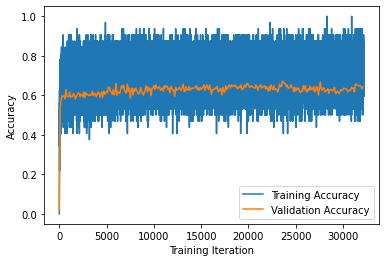

In [13]:
import matplotlib.pyplot as plt
plt.plot(range(len(training_accuracies_finetuning)), training_accuracies_finetuning, label = "Training Accuracy")
plt.plot(list(map(lambda x: x * 100, range(len(validation_accuracies_finetuning)))), validation_accuracies_finetuning, label = "Validation Accuracy")
plt.xlabel("Training Iteration")
plt.ylabel("Accuracy")
plt.legend()

In [14]:
import torch as th
import numpy as np

embedding_bert.to(device)

def get_embeds(x_data):
    concatted_shape = None
    pad_value = None
    embeds = []
    for text in tqdm(x_data):
        doc = nlp(text)
        embeddeds = []
        sents = [str(sent) for sent in doc.sents]
        if sentence_pairs == True and len(sents) > 1:
            sents = [a + b for a, b in zip(sents, sents[1:])]
        if sentence_pairs == "3" and len(sents) > 2:
            sents = [a + b + c for a, b, c in zip(sents, sents[1:], sents[2:])]
        all_tokenized = []
        for sentence in sents[:num_sentences]:
            tokenized = tokenizer(sentence, truncation=True, padding="max_length", max_length=max_tokenized_length)[0]
            all_tokenized.append(tokenized.ids)
        
        with th.no_grad():
            sentence_tensor = th.tensor(all_tokenized).to(device)
            concatted = np.concatenate([
                # take output corresponding to CLS
                embedding_bert.bert(sentence_tensor, output_hidden_states=True, return_dict=True)[1].cpu().numpy(),
                np.zeros((len(all_tokenized), 1))
            ], axis=1)
            
            if not concatted_shape:
                concatted_shape = concatted.shape
                pad_value = np.zeros(concatted_shape[1])
                pad_value[-1] = 1
            
            embeddeds += list(concatted)

        if len(sents) < num_sentences:
            embeddeds += [pad_value] * (num_sentences - len(sents))

        embeds.append(embeddeds)
    return np.array(embeds)

main_data_key = f"cache-core/training-data-main-max-tokens-{max_tokenized_length}-split-{split_hash}-finetuned-{finetuning_model_hash}"
train_x_embeds, valid_x_embeds = memo_load(
    lambda: (
        get_embeds(train_x),
        get_embeds(valid_x)
    ),
    main_data_key
)
main_data_hash = hash_file(main_data_key + ".hkl")

  0%|          | 0/200000 [00:00<?, ?it/s]

  0%|          | 4/200000 [00:00<1:31:01, 36.62it/s]

  0%|          | 13/200000 [00:00<50:57, 65.41it/s] 

  0%|          | 21/200000 [00:00<46:27, 71.75it/s]

  0%|          | 29/200000 [00:00<48:29, 68.72it/s]

  0%|          | 36/200000 [00:00<49:25, 67.44it/s]

  0%|          | 45/200000 [00:00<46:09, 72.20it/s]

  0%|          | 55/200000 [00:00<41:54, 79.52it/s]

  0%|          | 64/200000 [00:00<40:40, 81.91it/s]

  0%|          | 73/200000 [00:00<42:58, 77.53it/s]

  0%|          | 82/200000 [00:01<41:59, 79.36it/s]

  0%|          | 90/200000 [00:01<42:27, 78.46it/s]

  0%|          | 98/200000 [00:01<44:03, 75.62it/s]

  0%|          | 108/200000 [00:01<40:24, 82.44it/s]

  0%|          | 117/200000 [00:01<41:32, 80.18it/s]

  0%|          | 126/200000 [00:01<40:11, 82.88it/s]

  0%|          | 135/200000 [00:01<42:48, 77.83it/s]

  0%|          | 144/200000 [00:01<43:04, 77.32it/s]

  0%|          | 154/200000 [00:02<42:06, 79.09it/s]

  0%|          | 163/200000 [00:02<42:58, 77.52it/s]

  0%|          | 171/200000 [00:02<45:14, 73.62it/s]

  0%|          | 181/200000 [00:02<42:10, 78.97it/s]

  0%|          | 191/200000 [00:02<40:45, 81.70it/s]

  0%|          | 201/200000 [00:02<39:26, 84.43it/s]

  0%|          | 211/200000 [00:02<38:00, 87.61it/s]

  0%|          | 220/200000 [00:02<40:35, 82.02it/s]

  0%|          | 229/200000 [00:02<42:51, 77.68it/s]

  0%|          | 237/200000 [00:03<43:31, 76.50it/s]

  0%|          | 245/200000 [00:03<46:45, 71.21it/s]

  0%|          | 255/200000 [00:03<42:39, 78.05it/s]

  0%|          | 263/200000 [00:03<42:44, 77.88it/s]

  0%|          | 272/200000 [00:03<41:57, 79.34it/s]

  0%|          | 281/200000 [00:03<42:52, 77.63it/s]

  0%|          | 291/200000 [00:03<40:33, 82.05it/s]

  0%|          | 300/200000 [00:03<43:39, 76.23it/s]

  0%|          | 308/200000 [00:03<43:21, 76.75it/s]

  0%|          | 316/200000 [00:04<44:32, 74.71it/s]

  0%|          | 325/200000 [00:04<43:18, 76.84it/s]

  0%|          | 333/200000 [00:04<44:01, 75.58it/s]

  0%|          | 341/200000 [00:04<44:07, 75.42it/s]

  0%|          | 351/200000 [00:04<41:36, 79.98it/s]

  0%|          | 360/200000 [00:04<41:37, 79.94it/s]

  0%|          | 369/200000 [00:04<43:15, 76.91it/s]

  0%|          | 378/200000 [00:04<42:51, 77.63it/s]

  0%|          | 386/200000 [00:04<44:45, 74.34it/s]

  0%|          | 394/200000 [00:05<46:30, 71.54it/s]

  0%|          | 402/200000 [00:05<46:22, 71.74it/s]

  0%|          | 411/200000 [00:05<43:49, 75.91it/s]

  0%|          | 422/200000 [00:05<40:18, 82.52it/s]

  0%|          | 431/200000 [00:05<40:57, 81.20it/s]

  0%|          | 440/200000 [00:05<43:36, 76.26it/s]

  0%|          | 450/200000 [00:05<41:40, 79.81it/s]

  0%|          | 459/200000 [00:05<43:26, 76.57it/s]

  0%|          | 467/200000 [00:06<46:28, 71.57it/s]

  0%|          | 476/200000 [00:06<44:10, 75.27it/s]

  0%|          | 484/200000 [00:06<45:00, 73.88it/s]

  0%|          | 495/200000 [00:06<41:15, 80.60it/s]

  0%|          | 504/200000 [00:06<40:11, 82.73it/s]

  0%|          | 513/200000 [00:06<42:09, 78.86it/s]

  0%|          | 522/200000 [00:06<41:00, 81.08it/s]

  0%|          | 531/200000 [00:06<41:01, 81.04it/s]

  0%|          | 540/200000 [00:06<42:05, 78.97it/s]

  0%|          | 550/200000 [00:07<39:32, 84.05it/s]

  0%|          | 561/200000 [00:07<37:45, 88.03it/s]

  0%|          | 570/200000 [00:07<39:43, 83.69it/s]

  0%|          | 579/200000 [00:07<42:11, 78.78it/s]

  0%|          | 587/200000 [00:07<46:28, 71.52it/s]

  0%|          | 597/200000 [00:07<42:48, 77.64it/s]

  0%|          | 606/200000 [00:07<42:36, 78.00it/s]

  0%|          | 616/200000 [00:07<39:52, 83.34it/s]

  0%|          | 625/200000 [00:08<42:51, 77.53it/s]

  0%|          | 633/200000 [00:08<42:48, 77.62it/s]

  0%|          | 641/200000 [00:08<46:18, 71.76it/s]

  0%|          | 649/200000 [00:08<47:56, 69.31it/s]

  0%|          | 658/200000 [00:08<45:38, 72.80it/s]

  0%|          | 666/200000 [00:08<47:46, 69.54it/s]

  0%|          | 674/200000 [00:08<48:37, 68.32it/s]

  0%|          | 686/200000 [00:08<41:30, 80.03it/s]

  0%|          | 695/200000 [00:08<41:42, 79.65it/s]

  0%|          | 704/200000 [00:09<42:25, 78.31it/s]

  0%|          | 713/200000 [00:09<42:36, 77.95it/s]

  0%|          | 721/200000 [00:09<43:12, 76.87it/s]

  0%|          | 730/200000 [00:09<42:47, 77.60it/s]

  0%|          | 738/200000 [00:09<43:43, 75.96it/s]

  0%|          | 746/200000 [00:09<44:32, 74.56it/s]

  0%|          | 754/200000 [00:09<44:02, 75.39it/s]

  0%|          | 762/200000 [00:09<44:25, 74.74it/s]

  0%|          | 771/200000 [00:09<42:53, 77.40it/s]

  0%|          | 782/200000 [00:10<39:25, 84.23it/s]

  0%|          | 792/200000 [00:10<38:15, 86.77it/s]

  0%|          | 801/200000 [00:10<40:45, 81.45it/s]

  0%|          | 810/200000 [00:10<39:59, 83.03it/s]

  0%|          | 819/200000 [00:10<41:33, 79.88it/s]

  0%|          | 829/200000 [00:10<39:07, 84.85it/s]

  0%|          | 838/200000 [00:10<39:26, 84.15it/s]

  0%|          | 847/200000 [00:10<42:24, 78.27it/s]

  0%|          | 855/200000 [00:11<43:39, 76.04it/s]

  0%|          | 864/200000 [00:11<42:49, 77.49it/s]

  0%|          | 872/200000 [00:11<44:44, 74.19it/s]

  0%|          | 880/200000 [00:11<43:57, 75.48it/s]

  0%|          | 888/200000 [00:11<44:46, 74.12it/s]

  0%|          | 896/200000 [00:11<45:55, 72.26it/s]

  0%|          | 904/200000 [00:11<46:46, 70.93it/s]

  0%|          | 913/200000 [00:11<45:08, 73.50it/s]

  0%|          | 921/200000 [00:11<44:30, 74.55it/s]

  0%|          | 931/200000 [00:12<41:25, 80.10it/s]

  0%|          | 940/200000 [00:12<41:05, 80.74it/s]

  0%|          | 949/200000 [00:12<40:35, 81.74it/s]

  0%|          | 958/200000 [00:12<42:15, 78.52it/s]

  0%|          | 966/200000 [00:12<45:27, 72.97it/s]

  0%|          | 974/200000 [00:12<45:10, 73.42it/s]

  0%|          | 986/200000 [00:12<39:15, 84.49it/s]

  0%|          | 996/200000 [00:12<38:28, 86.22it/s]

  1%|          | 1005/200000 [00:12<41:33, 79.81it/s]

  1%|          | 1015/200000 [00:13<38:58, 85.08it/s]

  1%|          | 1024/200000 [00:13<38:56, 85.16it/s]

  1%|          | 1033/200000 [00:13<41:42, 79.50it/s]

  1%|          | 1042/200000 [00:13<40:18, 82.26it/s]

  1%|          | 1051/200000 [00:13<40:47, 81.30it/s]

  1%|          | 1060/200000 [00:13<40:35, 81.69it/s]

  1%|          | 1069/200000 [00:13<41:45, 79.39it/s]

  1%|          | 1077/200000 [00:13<42:51, 77.35it/s]

  1%|          | 1088/200000 [00:13<39:17, 84.37it/s]

  1%|          | 1097/200000 [00:14<41:53, 79.13it/s]

  1%|          | 1105/200000 [00:14<41:48, 79.29it/s]

  1%|          | 1114/200000 [00:14<40:43, 81.39it/s]

  1%|          | 1124/200000 [00:14<38:38, 85.78it/s]

  1%|          | 1133/200000 [00:14<42:46, 77.50it/s]

  1%|          | 1141/200000 [00:14<43:47, 75.69it/s]

  1%|          | 1149/200000 [00:14<44:24, 74.63it/s]

  1%|          | 1157/200000 [00:14<44:38, 74.23it/s]

  1%|          | 1165/200000 [00:14<44:21, 74.71it/s]

  1%|          | 1174/200000 [00:15<44:15, 74.88it/s]

  1%|          | 1182/200000 [00:15<45:27, 72.91it/s]

  1%|          | 1190/200000 [00:15<46:28, 71.29it/s]

  1%|          | 1199/200000 [00:15<44:09, 75.02it/s]

  1%|          | 1208/200000 [00:15<43:57, 75.37it/s]

  1%|          | 1217/200000 [00:15<42:48, 77.40it/s]

  1%|          | 1225/200000 [00:15<42:47, 77.43it/s]

  1%|          | 1236/200000 [00:15<39:37, 83.59it/s]

  1%|          | 1245/200000 [00:15<41:10, 80.44it/s]

  1%|          | 1254/200000 [00:16<45:42, 72.46it/s]

  1%|          | 1262/200000 [00:16<44:51, 73.85it/s]

  1%|          | 1270/200000 [00:16<46:40, 70.96it/s]

  1%|          | 1278/200000 [00:16<47:01, 70.44it/s]

  1%|          | 1286/200000 [00:16<46:33, 71.15it/s]

  1%|          | 1296/200000 [00:16<44:00, 75.26it/s]

  1%|          | 1305/200000 [00:16<42:56, 77.11it/s]

  1%|          | 1313/200000 [00:16<43:06, 76.83it/s]

  1%|          | 1321/200000 [00:17<46:21, 71.42it/s]

  1%|          | 1329/200000 [00:17<46:29, 71.21it/s]

  1%|          | 1337/200000 [00:17<45:42, 72.44it/s]

  1%|          | 1346/200000 [00:17<45:31, 72.74it/s]

  1%|          | 1355/200000 [00:17<42:52, 77.21it/s]

  1%|          | 1364/200000 [00:17<41:41, 79.39it/s]

  1%|          | 1372/200000 [00:17<43:10, 76.69it/s]

  1%|          | 1382/200000 [00:17<41:05, 80.56it/s]

  1%|          | 1391/200000 [00:17<43:22, 76.33it/s]

  1%|          | 1400/200000 [00:18<42:01, 78.77it/s]

  1%|          | 1408/200000 [00:18<42:23, 78.08it/s]

  1%|          | 1416/200000 [00:18<43:37, 75.88it/s]

  1%|          | 1424/200000 [00:18<45:53, 72.11it/s]

  1%|          | 1432/200000 [00:18<48:37, 68.05it/s]

  1%|          | 1441/200000 [00:18<45:25, 72.85it/s]

  1%|          | 1449/200000 [00:18<45:32, 72.66it/s]

  1%|          | 1457/200000 [00:18<45:21, 72.95it/s]

  1%|          | 1466/200000 [00:18<44:42, 74.02it/s]

  1%|          | 1476/200000 [00:19<41:08, 80.41it/s]

  1%|          | 1485/200000 [00:19<40:39, 81.36it/s]

  1%|          | 1494/200000 [00:19<41:47, 79.17it/s]

  1%|          | 1502/200000 [00:19<43:50, 75.46it/s]

  1%|          | 1510/200000 [00:19<47:27, 69.71it/s]

  1%|          | 1519/200000 [00:19<44:49, 73.80it/s]

  1%|          | 1528/200000 [00:19<42:25, 77.96it/s]

  1%|          | 1538/200000 [00:19<40:26, 81.79it/s]

  1%|          | 1547/200000 [00:20<42:37, 77.61it/s]

  1%|          | 1555/200000 [00:20<48:33, 68.11it/s]

  1%|          | 1564/200000 [00:20<45:36, 72.52it/s]

  1%|          | 1572/200000 [00:20<46:19, 71.38it/s]

  1%|          | 1583/200000 [00:20<42:20, 78.10it/s]

  1%|          | 1592/200000 [00:20<41:15, 80.15it/s]

  1%|          | 1601/200000 [00:20<42:52, 77.12it/s]

  1%|          | 1612/200000 [00:20<39:05, 84.57it/s]

  1%|          | 1621/200000 [00:20<40:23, 81.86it/s]

  1%|          | 1630/200000 [00:21<40:37, 81.38it/s]

  1%|          | 1639/200000 [00:21<40:19, 82.00it/s]

  1%|          | 1648/200000 [00:21<42:41, 77.45it/s]

  1%|          | 1657/200000 [00:21<41:15, 80.12it/s]

  1%|          | 1666/200000 [00:21<42:26, 77.88it/s]

  1%|          | 1676/200000 [00:21<40:37, 81.37it/s]

  1%|          | 1685/200000 [00:21<42:47, 77.25it/s]

  1%|          | 1693/200000 [00:21<44:23, 74.45it/s]

  1%|          | 1701/200000 [00:22<44:24, 74.41it/s]

  1%|          | 1709/200000 [00:22<43:40, 75.66it/s]

  1%|          | 1718/200000 [00:22<43:09, 76.58it/s]

  1%|          | 1726/200000 [00:22<44:46, 73.79it/s]

  1%|          | 1735/200000 [00:22<42:23, 77.94it/s]

  1%|          | 1743/200000 [00:22<43:09, 76.57it/s]

  1%|          | 1751/200000 [00:22<45:16, 72.98it/s]

  1%|          | 1759/200000 [00:22<45:22, 72.82it/s]

  1%|          | 1767/200000 [00:22<46:44, 70.68it/s]

  1%|          | 1775/200000 [00:23<46:05, 71.68it/s]

  1%|          | 1783/200000 [00:23<45:13, 73.05it/s]

  1%|          | 1792/200000 [00:23<43:28, 75.99it/s]

  1%|          | 1802/200000 [00:23<40:30, 81.56it/s]

  1%|          | 1811/200000 [00:23<41:00, 80.53it/s]

  1%|          | 1820/200000 [00:23<43:13, 76.40it/s]

  1%|          | 1830/200000 [00:23<42:04, 78.50it/s]

  1%|          | 1840/200000 [00:23<40:04, 82.42it/s]

  1%|          | 1849/200000 [00:23<39:51, 82.84it/s]

  1%|          | 1858/200000 [00:24<40:07, 82.32it/s]

  1%|          | 1867/200000 [00:24<41:06, 80.34it/s]

  1%|          | 1877/200000 [00:24<40:08, 82.24it/s]

  1%|          | 1886/200000 [00:24<41:15, 80.04it/s]

  1%|          | 1896/200000 [00:24<39:14, 84.15it/s]

  1%|          | 1905/200000 [00:24<39:18, 83.98it/s]

  1%|          | 1914/200000 [00:24<39:31, 83.53it/s]

  1%|          | 1923/200000 [00:24<40:33, 81.40it/s]

  1%|          | 1932/200000 [00:24<41:34, 79.42it/s]

  1%|          | 1940/200000 [00:25<43:47, 75.38it/s]

  1%|          | 1948/200000 [00:25<44:51, 73.60it/s]

  1%|          | 1956/200000 [00:25<44:35, 74.03it/s]

  1%|          | 1964/200000 [00:25<45:05, 73.20it/s]

  1%|          | 1972/200000 [00:25<44:50, 73.60it/s]

  1%|          | 1980/200000 [00:25<44:57, 73.40it/s]

  1%|          | 1990/200000 [00:25<42:02, 78.51it/s]

  1%|          | 2000/200000 [00:25<40:57, 80.57it/s]

  1%|          | 2009/200000 [00:25<41:26, 79.61it/s]

  1%|          | 2017/200000 [00:26<41:28, 79.55it/s]

  1%|          | 2025/200000 [00:26<41:29, 79.54it/s]

  1%|          | 2035/200000 [00:26<39:48, 82.88it/s]

  1%|          | 2044/200000 [00:26<39:10, 84.21it/s]

  1%|          | 2053/200000 [00:26<41:34, 79.37it/s]

  1%|          | 2061/200000 [00:26<46:36, 70.78it/s]

  1%|          | 2069/200000 [00:26<45:28, 72.54it/s]

  1%|          | 2077/200000 [00:26<47:52, 68.89it/s]

  1%|          | 2086/200000 [00:27<45:37, 72.28it/s]

  1%|          | 2094/200000 [00:27<46:35, 70.80it/s]

  1%|          | 2102/200000 [00:27<45:09, 73.04it/s]

  1%|          | 2110/200000 [00:27<45:53, 71.86it/s]

  1%|          | 2119/200000 [00:27<45:15, 72.88it/s]

  1%|          | 2130/200000 [00:27<40:33, 81.30it/s]

  1%|          | 2140/200000 [00:27<38:41, 85.22it/s]

  1%|          | 2149/200000 [00:27<42:02, 78.42it/s]

  1%|          | 2157/200000 [00:27<44:08, 74.71it/s]

  1%|          | 2165/200000 [00:28<45:18, 72.79it/s]

  1%|          | 2173/200000 [00:28<48:44, 67.64it/s]

  1%|          | 2181/200000 [00:28<47:17, 69.72it/s]

  1%|          | 2189/200000 [00:28<46:24, 71.04it/s]

  1%|          | 2200/200000 [00:28<40:40, 81.06it/s]

  1%|          | 2209/200000 [00:28<40:36, 81.17it/s]

  1%|          | 2221/200000 [00:28<37:32, 87.82it/s]

  1%|          | 2231/200000 [00:28<37:22, 88.19it/s]

  1%|          | 2240/200000 [00:28<37:21, 88.21it/s]

  1%|          | 2249/200000 [00:29<39:51, 82.69it/s]

  1%|          | 2259/200000 [00:29<38:35, 85.42it/s]

  1%|          | 2268/200000 [00:29<38:38, 85.27it/s]

  1%|          | 2277/200000 [00:29<39:43, 82.96it/s]

  1%|          | 2286/200000 [00:29<42:45, 77.06it/s]

  1%|          | 2295/200000 [00:29<41:33, 79.29it/s]

  1%|          | 2304/200000 [00:29<40:20, 81.69it/s]

  1%|          | 2313/200000 [00:29<43:29, 75.75it/s]

  1%|          | 2321/200000 [00:29<44:05, 74.72it/s]

  1%|          | 2330/200000 [00:30<43:04, 76.49it/s]

  1%|          | 2339/200000 [00:30<41:23, 79.58it/s]

  1%|          | 2348/200000 [00:30<44:16, 74.39it/s]

  1%|          | 2357/200000 [00:30<42:56, 76.72it/s]

  1%|          | 2365/200000 [00:30<43:01, 76.56it/s]

  1%|          | 2374/200000 [00:30<41:42, 78.96it/s]

  1%|          | 2382/200000 [00:30<43:55, 74.98it/s]

  1%|          | 2390/200000 [00:30<44:01, 74.81it/s]

  1%|          | 2398/200000 [00:31<45:33, 72.29it/s]

  1%|          | 2407/200000 [00:31<44:04, 74.71it/s]

  1%|          | 2416/200000 [00:31<42:42, 77.10it/s]

  1%|          | 2425/200000 [00:31<41:24, 79.53it/s]

  1%|          | 2437/200000 [00:31<36:22, 90.50it/s]

  1%|          | 2447/200000 [00:31<39:23, 83.59it/s]

  1%|          | 2456/200000 [00:31<39:48, 82.72it/s]

  1%|          | 2465/200000 [00:31<41:25, 79.49it/s]

  1%|          | 2474/200000 [00:31<42:03, 78.29it/s]

  1%|          | 2484/200000 [00:32<39:50, 82.63it/s]

  1%|          | 2493/200000 [00:32<42:30, 77.45it/s]

  1%|▏         | 2502/200000 [00:32<40:47, 80.71it/s]

  1%|▏         | 2511/200000 [00:32<39:48, 82.67it/s]

  1%|▏         | 2520/200000 [00:32<38:52, 84.67it/s]

  1%|▏         | 2530/200000 [00:32<39:06, 84.14it/s]

  1%|▏         | 2539/200000 [00:32<40:24, 81.43it/s]

  1%|▏         | 2548/200000 [00:32<41:37, 79.07it/s]

  1%|▏         | 2556/200000 [00:32<42:54, 76.70it/s]

  1%|▏         | 2565/200000 [00:33<41:13, 79.82it/s]

  1%|▏         | 2576/200000 [00:33<39:16, 83.77it/s]

  1%|▏         | 2586/200000 [00:33<38:43, 84.97it/s]

  1%|▏         | 2595/200000 [00:33<38:34, 85.28it/s]

  1%|▏         | 2604/200000 [00:33<39:32, 83.19it/s]

  1%|▏         | 2613/200000 [00:33<42:15, 77.86it/s]

  1%|▏         | 2621/200000 [00:33<45:19, 72.59it/s]

  1%|▏         | 2629/200000 [00:33<45:01, 73.06it/s]

  1%|▏         | 2637/200000 [00:34<46:29, 70.74it/s]

  1%|▏         | 2645/200000 [00:34<46:22, 70.93it/s]

  1%|▏         | 2653/200000 [00:34<45:51, 71.72it/s]

  1%|▏         | 2661/200000 [00:34<49:22, 66.61it/s]

  1%|▏         | 2670/200000 [00:34<47:34, 69.13it/s]

  1%|▏         | 2677/200000 [00:34<50:56, 64.55it/s]

  1%|▏         | 2684/200000 [00:34<51:56, 63.32it/s]

  1%|▏         | 2691/200000 [00:34<50:47, 64.73it/s]

  1%|▏         | 2699/200000 [00:34<49:48, 66.01it/s]

  1%|▏         | 2708/200000 [00:35<47:38, 69.01it/s]

  1%|▏         | 2719/200000 [00:35<42:31, 77.33it/s]

  1%|▏         | 2729/200000 [00:35<40:10, 81.83it/s]

  1%|▏         | 2738/200000 [00:35<41:59, 78.31it/s]

  1%|▏         | 2746/200000 [00:35<44:43, 73.49it/s]

  1%|▏         | 2754/200000 [00:35<44:15, 74.29it/s]

  1%|▏         | 2763/200000 [00:35<42:27, 77.42it/s]

  1%|▏         | 2772/200000 [00:35<43:11, 76.09it/s]

  1%|▏         | 2783/200000 [00:35<39:37, 82.94it/s]

  1%|▏         | 2792/200000 [00:36<41:44, 78.76it/s]

  1%|▏         | 2801/200000 [00:36<41:20, 79.49it/s]

  1%|▏         | 2810/200000 [00:36<42:09, 77.96it/s]

  1%|▏         | 2818/200000 [00:36<42:41, 76.99it/s]

  1%|▏         | 2828/200000 [00:36<40:23, 81.36it/s]

  1%|▏         | 2837/200000 [00:36<39:38, 82.90it/s]

  1%|▏         | 2846/200000 [00:36<39:15, 83.69it/s]

  1%|▏         | 2857/200000 [00:36<36:41, 89.56it/s]

  1%|▏         | 2866/200000 [00:37<39:50, 82.48it/s]

  1%|▏         | 2875/200000 [00:37<40:17, 81.53it/s]

  1%|▏         | 2884/200000 [00:37<41:14, 79.66it/s]

  1%|▏         | 2893/200000 [00:37<42:00, 78.20it/s]

  1%|▏         | 2904/200000 [00:37<38:58, 84.29it/s]

  1%|▏         | 2913/200000 [00:37<42:10, 77.87it/s]

  1%|▏         | 2921/200000 [00:37<43:54, 74.80it/s]

  1%|▏         | 2930/200000 [00:37<43:11, 76.03it/s]

  1%|▏         | 2940/200000 [00:37<40:36, 80.87it/s]

  1%|▏         | 2950/200000 [00:38<38:23, 85.55it/s]

  1%|▏         | 2959/200000 [00:38<41:00, 80.09it/s]

  1%|▏         | 2968/200000 [00:38<42:36, 77.08it/s]

  1%|▏         | 2976/200000 [00:38<42:20, 77.56it/s]

  1%|▏         | 2984/200000 [00:38<45:07, 72.76it/s]

  1%|▏         | 2992/200000 [00:38<48:25, 67.81it/s]

  2%|▏         | 3001/200000 [00:38<46:24, 70.76it/s]

  2%|▏         | 3010/200000 [00:38<44:01, 74.56it/s]

  2%|▏         | 3019/200000 [00:39<42:38, 76.98it/s]

  2%|▏         | 3027/200000 [00:39<46:49, 70.12it/s]

  2%|▏         | 3038/200000 [00:39<40:54, 80.25it/s]

  2%|▏         | 3047/200000 [00:39<41:13, 79.64it/s]

  2%|▏         | 3056/200000 [00:39<42:12, 77.77it/s]

  2%|▏         | 3064/200000 [00:39<41:56, 78.25it/s]

  2%|▏         | 3073/200000 [00:39<41:11, 79.67it/s]

  2%|▏         | 3083/200000 [00:39<39:06, 83.93it/s]

  2%|▏         | 3092/200000 [00:39<43:46, 74.97it/s]

  2%|▏         | 3100/200000 [00:40<44:18, 74.07it/s]

  2%|▏         | 3108/200000 [00:40<47:41, 68.82it/s]

  2%|▏         | 3117/200000 [00:40<45:03, 72.82it/s]

  2%|▏         | 3125/200000 [00:40<44:57, 72.99it/s]

  2%|▏         | 3133/200000 [00:40<44:02, 74.49it/s]

  2%|▏         | 3143/200000 [00:40<41:09, 79.70it/s]

  2%|▏         | 3152/200000 [00:40<44:17, 74.08it/s]

  2%|▏         | 3160/200000 [00:40<43:42, 75.07it/s]

  2%|▏         | 3169/200000 [00:40<43:02, 76.22it/s]

  2%|▏         | 3177/200000 [00:41<43:08, 76.04it/s]

  2%|▏         | 3186/200000 [00:41<41:22, 79.26it/s]

  2%|▏         | 3194/200000 [00:41<42:31, 77.13it/s]

  2%|▏         | 3202/200000 [00:41<45:32, 72.01it/s]

  2%|▏         | 3210/200000 [00:41<45:34, 71.95it/s]

  2%|▏         | 3218/200000 [00:41<44:49, 73.18it/s]

  2%|▏         | 3226/200000 [00:41<44:19, 73.99it/s]

  2%|▏         | 3234/200000 [00:41<44:50, 73.15it/s]

  2%|▏         | 3242/200000 [00:41<46:02, 71.22it/s]

  2%|▏         | 3250/200000 [00:42<45:26, 72.17it/s]

  2%|▏         | 3259/200000 [00:42<42:40, 76.83it/s]

  2%|▏         | 3269/200000 [00:42<39:54, 82.15it/s]

  2%|▏         | 3278/200000 [00:42<41:29, 79.01it/s]

  2%|▏         | 3287/200000 [00:42<41:14, 79.49it/s]

  2%|▏         | 3295/200000 [00:42<42:39, 76.85it/s]

  2%|▏         | 3305/200000 [00:42<40:49, 80.29it/s]

  2%|▏         | 3314/200000 [00:42<42:06, 77.86it/s]

  2%|▏         | 3322/200000 [00:42<42:51, 76.48it/s]

  2%|▏         | 3330/200000 [00:43<44:01, 74.44it/s]

  2%|▏         | 3338/200000 [00:43<45:35, 71.89it/s]

  2%|▏         | 3347/200000 [00:43<42:47, 76.59it/s]

  2%|▏         | 3356/200000 [00:43<41:15, 79.45it/s]

  2%|▏         | 3365/200000 [00:43<41:48, 78.40it/s]

  2%|▏         | 3374/200000 [00:43<41:25, 79.12it/s]

  2%|▏         | 3382/200000 [00:43<42:39, 76.81it/s]

  2%|▏         | 3390/200000 [00:43<44:48, 73.13it/s]

  2%|▏         | 3398/200000 [00:43<44:01, 74.44it/s]

  2%|▏         | 3407/200000 [00:44<42:45, 76.64it/s]

  2%|▏         | 3416/200000 [00:44<41:45, 78.45it/s]

  2%|▏         | 3425/200000 [00:44<41:31, 78.88it/s]

  2%|▏         | 3433/200000 [00:44<42:25, 77.22it/s]

  2%|▏         | 3441/200000 [00:44<44:32, 73.55it/s]

  2%|▏         | 3450/200000 [00:44<42:27, 77.14it/s]

  2%|▏         | 3458/200000 [00:44<42:09, 77.71it/s]

  2%|▏         | 3467/200000 [00:44<41:43, 78.51it/s]

  2%|▏         | 3475/200000 [00:44<43:03, 76.08it/s]

  2%|▏         | 3483/200000 [00:45<42:32, 76.99it/s]

  2%|▏         | 3491/200000 [00:45<43:24, 75.46it/s]

  2%|▏         | 3499/200000 [00:45<43:54, 74.58it/s]

  2%|▏         | 3509/200000 [00:45<41:09, 79.58it/s]

  2%|▏         | 3519/200000 [00:45<38:56, 84.10it/s]

  2%|▏         | 3528/200000 [00:45<40:00, 81.83it/s]

  2%|▏         | 3537/200000 [00:45<39:42, 82.45it/s]

  2%|▏         | 3546/200000 [00:45<42:34, 76.91it/s]

  2%|▏         | 3554/200000 [00:46<43:38, 75.03it/s]

  2%|▏         | 3562/200000 [00:46<46:04, 71.07it/s]

  2%|▏         | 3570/200000 [00:46<45:29, 71.97it/s]

  2%|▏         | 3579/200000 [00:46<44:31, 73.51it/s]

  2%|▏         | 3587/200000 [00:46<43:51, 74.65it/s]

  2%|▏         | 3596/200000 [00:46<42:51, 76.38it/s]

  2%|▏         | 3604/200000 [00:46<43:04, 75.98it/s]

  2%|▏         | 3612/200000 [00:46<44:45, 73.12it/s]

  2%|▏         | 3621/200000 [00:46<43:57, 74.46it/s]

  2%|▏         | 3629/200000 [00:47<43:38, 74.99it/s]

  2%|▏         | 3640/200000 [00:47<39:23, 83.07it/s]

  2%|▏         | 3649/200000 [00:47<40:09, 81.49it/s]

  2%|▏         | 3658/200000 [00:47<40:18, 81.17it/s]

  2%|▏         | 3667/200000 [00:47<41:12, 79.41it/s]

  2%|▏         | 3677/200000 [00:47<39:31, 82.78it/s]

  2%|▏         | 3686/200000 [00:47<42:03, 77.78it/s]

  2%|▏         | 3695/200000 [00:47<41:10, 79.47it/s]

  2%|▏         | 3704/200000 [00:47<41:17, 79.22it/s]

  2%|▏         | 3712/200000 [00:48<42:32, 76.92it/s]

  2%|▏         | 3721/200000 [00:48<42:22, 77.20it/s]

  2%|▏         | 3729/200000 [00:48<44:32, 73.43it/s]

  2%|▏         | 3738/200000 [00:48<42:42, 76.59it/s]

  2%|▏         | 3746/200000 [00:48<43:36, 74.99it/s]

  2%|▏         | 3754/200000 [00:48<45:58, 71.13it/s]

  2%|▏         | 3764/200000 [00:48<43:01, 76.02it/s]

  2%|▏         | 3774/200000 [00:48<40:13, 81.30it/s]

  2%|▏         | 3783/200000 [00:48<41:46, 78.28it/s]

  2%|▏         | 3791/200000 [00:49<43:15, 75.60it/s]

  2%|▏         | 3799/200000 [00:49<45:10, 72.39it/s]

  2%|▏         | 3807/200000 [00:49<44:39, 73.22it/s]

  2%|▏         | 3816/200000 [00:49<42:41, 76.60it/s]

  2%|▏         | 3825/200000 [00:49<41:51, 78.12it/s]

  2%|▏         | 3833/200000 [00:49<43:14, 75.60it/s]

  2%|▏         | 3841/200000 [00:49<43:30, 75.15it/s]

  2%|▏         | 3850/200000 [00:49<42:45, 76.45it/s]

  2%|▏         | 3858/200000 [00:49<43:14, 75.61it/s]

  2%|▏         | 3866/200000 [00:50<44:49, 72.92it/s]

  2%|▏         | 3874/200000 [00:50<46:01, 71.02it/s]

  2%|▏         | 3882/200000 [00:50<45:06, 72.46it/s]

  2%|▏         | 3891/200000 [00:50<42:31, 76.85it/s]

  2%|▏         | 3901/200000 [00:50<40:32, 80.61it/s]

  2%|▏         | 3910/200000 [00:50<43:24, 75.30it/s]

  2%|▏         | 3918/200000 [00:50<45:56, 71.13it/s]

  2%|▏         | 3926/200000 [00:50<45:11, 72.31it/s]

  2%|▏         | 3935/200000 [00:51<42:51, 76.24it/s]

  2%|▏         | 3943/200000 [00:51<43:20, 75.38it/s]

  2%|▏         | 3954/200000 [00:51<39:30, 82.70it/s]

  2%|▏         | 3963/200000 [00:51<40:25, 80.81it/s]

  2%|▏         | 3972/200000 [00:51<39:19, 83.09it/s]

  2%|▏         | 3981/200000 [00:51<40:41, 80.28it/s]

  2%|▏         | 3990/200000 [00:51<45:06, 72.41it/s]

  2%|▏         | 3998/200000 [00:51<45:08, 72.37it/s]

  2%|▏         | 4006/200000 [00:51<46:28, 70.29it/s]

  2%|▏         | 4014/200000 [00:52<47:11, 69.22it/s]

  2%|▏         | 4023/200000 [00:52<43:53, 74.42it/s]

  2%|▏         | 4034/200000 [00:52<39:10, 83.38it/s]

  2%|▏         | 4043/200000 [00:52<39:48, 82.05it/s]

  2%|▏         | 4052/200000 [00:52<40:44, 80.16it/s]

  2%|▏         | 4061/200000 [00:52<42:27, 76.91it/s]

  2%|▏         | 4070/200000 [00:52<41:59, 77.78it/s]

  2%|▏         | 4078/200000 [00:52<41:45, 78.20it/s]

  2%|▏         | 4086/200000 [00:52<42:50, 76.22it/s]

  2%|▏         | 4094/200000 [00:53<43:25, 75.18it/s]

  2%|▏         | 4102/200000 [00:53<44:12, 73.85it/s]

  2%|▏         | 4111/200000 [00:53<42:22, 77.04it/s]

  2%|▏         | 4119/200000 [00:53<43:21, 75.28it/s]

  2%|▏         | 4127/200000 [00:53<43:39, 74.78it/s]

  2%|▏         | 4135/200000 [00:53<45:49, 71.24it/s]

  2%|▏         | 4143/200000 [00:53<45:33, 71.66it/s]

  2%|▏         | 4151/200000 [00:53<45:04, 72.40it/s]

  2%|▏         | 4160/200000 [00:53<42:38, 76.56it/s]

  2%|▏         | 4169/200000 [00:54<41:01, 79.55it/s]

  2%|▏         | 4177/200000 [00:54<41:32, 78.56it/s]

  2%|▏         | 4186/200000 [00:54<40:37, 80.33it/s]

  2%|▏         | 4195/200000 [00:54<41:22, 78.87it/s]

  2%|▏         | 4203/200000 [00:54<42:16, 77.20it/s]

  2%|▏         | 4212/200000 [00:54<40:38, 80.29it/s]

  2%|▏         | 4221/200000 [00:54<40:51, 79.87it/s]

  2%|▏         | 4230/200000 [00:54<41:09, 79.26it/s]

  2%|▏         | 4239/200000 [00:54<39:45, 82.06it/s]

  2%|▏         | 4249/200000 [00:55<38:04, 85.68it/s]

  2%|▏         | 4258/200000 [00:55<42:46, 76.28it/s]

  2%|▏         | 4266/200000 [00:55<43:24, 75.16it/s]

  2%|▏         | 4274/200000 [00:55<43:48, 74.45it/s]

  2%|▏         | 4282/200000 [00:55<43:56, 74.24it/s]

  2%|▏         | 4290/200000 [00:55<43:50, 74.40it/s]

  2%|▏         | 4299/200000 [00:55<43:20, 75.27it/s]

  2%|▏         | 4308/200000 [00:55<42:14, 77.21it/s]

  2%|▏         | 4316/200000 [00:55<42:18, 77.08it/s]

  2%|▏         | 4325/200000 [00:56<40:56, 79.67it/s]

  2%|▏         | 4333/200000 [00:56<42:27, 76.80it/s]

  2%|▏         | 4341/200000 [00:56<43:05, 75.67it/s]

  2%|▏         | 4351/200000 [00:56<40:16, 80.97it/s]

  2%|▏         | 4360/200000 [00:56<41:50, 77.93it/s]

  2%|▏         | 4369/200000 [00:56<40:56, 79.63it/s]

  2%|▏         | 4380/200000 [00:56<37:10, 87.72it/s]

  2%|▏         | 4389/200000 [00:56<39:44, 82.03it/s]

  2%|▏         | 4398/200000 [00:56<39:59, 81.52it/s]

  2%|▏         | 4407/200000 [00:57<40:08, 81.21it/s]

  2%|▏         | 4416/200000 [00:57<40:22, 80.73it/s]

  2%|▏         | 4425/200000 [00:57<41:34, 78.39it/s]

  2%|▏         | 4434/200000 [00:57<41:16, 78.97it/s]

  2%|▏         | 4444/200000 [00:57<39:26, 82.64it/s]

  2%|▏         | 4453/200000 [00:57<40:21, 80.76it/s]

  2%|▏         | 4462/200000 [00:57<41:33, 78.43it/s]

  2%|▏         | 4470/200000 [00:57<41:44, 78.06it/s]

  2%|▏         | 4478/200000 [00:57<41:41, 78.16it/s]

  2%|▏         | 4488/200000 [00:58<39:53, 81.68it/s]

  2%|▏         | 4497/200000 [00:58<41:06, 79.26it/s]

  2%|▏         | 4505/200000 [00:58<41:39, 78.20it/s]

  2%|▏         | 4513/200000 [00:58<41:48, 77.94it/s]

  2%|▏         | 4521/200000 [00:58<42:36, 76.48it/s]

  2%|▏         | 4529/200000 [00:58<45:00, 72.38it/s]

  2%|▏         | 4539/200000 [00:58<40:47, 79.87it/s]

  2%|▏         | 4549/200000 [00:58<38:42, 84.15it/s]

  2%|▏         | 4558/200000 [00:58<39:27, 82.57it/s]

  2%|▏         | 4567/200000 [00:59<39:06, 83.27it/s]

  2%|▏         | 4576/200000 [00:59<39:58, 81.49it/s]

  2%|▏         | 4585/200000 [00:59<40:33, 80.31it/s]

  2%|▏         | 4597/200000 [00:59<36:14, 89.86it/s]

  2%|▏         | 4607/200000 [00:59<40:28, 80.46it/s]

  2%|▏         | 4616/200000 [00:59<41:08, 79.14it/s]

  2%|▏         | 4625/200000 [00:59<42:37, 76.39it/s]

  2%|▏         | 4635/200000 [00:59<39:43, 81.96it/s]

  2%|▏         | 4644/200000 [01:00<40:30, 80.38it/s]

  2%|▏         | 4653/200000 [01:00<39:45, 81.88it/s]

  2%|▏         | 4662/200000 [01:00<42:46, 76.12it/s]

  2%|▏         | 4670/200000 [01:00<43:14, 75.30it/s]

  2%|▏         | 4679/200000 [01:00<41:49, 77.83it/s]

  2%|▏         | 4687/200000 [01:00<43:43, 74.46it/s]

  2%|▏         | 4695/200000 [01:00<43:46, 74.36it/s]

  2%|▏         | 4703/200000 [01:00<43:43, 74.45it/s]

  2%|▏         | 4713/200000 [01:00<42:00, 77.47it/s]

  2%|▏         | 4723/200000 [01:01<39:27, 82.49it/s]

  2%|▏         | 4732/200000 [01:01<40:22, 80.61it/s]

  2%|▏         | 4742/200000 [01:01<37:54, 85.83it/s]

  2%|▏         | 4751/200000 [01:01<38:00, 85.63it/s]

  2%|▏         | 4760/200000 [01:01<37:34, 86.60it/s]

  2%|▏         | 4769/200000 [01:01<40:04, 81.19it/s]

  2%|▏         | 4778/200000 [01:01<40:52, 79.59it/s]

  2%|▏         | 4787/200000 [01:01<39:42, 81.93it/s]

  2%|▏         | 4796/200000 [01:01<40:20, 80.66it/s]

  2%|▏         | 4805/200000 [01:02<42:04, 77.33it/s]

  2%|▏         | 4813/200000 [01:02<43:06, 75.46it/s]

  2%|▏         | 4821/200000 [01:02<44:19, 73.39it/s]

  2%|▏         | 4829/200000 [01:02<47:40, 68.22it/s]

  2%|▏         | 4837/200000 [01:02<46:20, 70.19it/s]

  2%|▏         | 4846/200000 [01:02<43:21, 75.03it/s]

  2%|▏         | 4855/200000 [01:02<42:15, 76.97it/s]

  2%|▏         | 4864/200000 [01:02<41:47, 77.83it/s]

  2%|▏         | 4873/200000 [01:02<41:12, 78.92it/s]

  2%|▏         | 4882/200000 [01:03<40:07, 81.04it/s]

  2%|▏         | 4891/200000 [01:03<39:00, 83.38it/s]

  2%|▏         | 4900/200000 [01:03<41:27, 78.45it/s]

  2%|▏         | 4908/200000 [01:03<42:53, 75.80it/s]

  2%|▏         | 4916/200000 [01:03<42:20, 76.80it/s]

  2%|▏         | 4924/200000 [01:03<42:40, 76.19it/s]

  2%|▏         | 4932/200000 [01:03<44:36, 72.89it/s]

  2%|▏         | 4940/200000 [01:03<45:19, 71.73it/s]

  2%|▏         | 4949/200000 [01:04<44:46, 72.60it/s]

  2%|▏         | 4958/200000 [01:04<42:10, 77.06it/s]

  2%|▏         | 4967/200000 [01:04<41:14, 78.81it/s]

  2%|▏         | 4975/200000 [01:04<42:07, 77.15it/s]

  2%|▏         | 4983/200000 [01:04<45:33, 71.35it/s]

  2%|▏         | 4991/200000 [01:04<45:33, 71.34it/s]

  2%|▏         | 4999/200000 [01:04<44:09, 73.59it/s]

  3%|▎         | 5007/200000 [01:04<43:54, 74.02it/s]

  3%|▎         | 5016/200000 [01:04<42:13, 76.96it/s]

  3%|▎         | 5024/200000 [01:05<46:28, 69.91it/s]

  3%|▎         | 5033/200000 [01:05<44:14, 73.44it/s]

  3%|▎         | 5041/200000 [01:05<44:48, 72.52it/s]

  3%|▎         | 5049/200000 [01:05<44:43, 72.65it/s]

  3%|▎         | 5059/200000 [01:05<41:12, 78.84it/s]

  3%|▎         | 5067/200000 [01:05<43:02, 75.48it/s]

  3%|▎         | 5075/200000 [01:05<43:21, 74.92it/s]

  3%|▎         | 5083/200000 [01:05<42:43, 76.03it/s]

  3%|▎         | 5091/200000 [01:05<42:49, 75.85it/s]

  3%|▎         | 5099/200000 [01:05<42:22, 76.65it/s]

  3%|▎         | 5107/200000 [01:06<43:50, 74.10it/s]

  3%|▎         | 5117/200000 [01:06<40:55, 79.37it/s]

  3%|▎         | 5126/200000 [01:06<40:29, 80.21it/s]

  3%|▎         | 5138/200000 [01:06<37:01, 87.73it/s]

  3%|▎         | 5147/200000 [01:06<38:20, 84.69it/s]

  3%|▎         | 5156/200000 [01:06<38:16, 84.85it/s]

  3%|▎         | 5165/200000 [01:06<39:47, 81.62it/s]

  3%|▎         | 5174/200000 [01:06<39:46, 81.62it/s]

  3%|▎         | 5183/200000 [01:07<42:03, 77.20it/s]

  3%|▎         | 5193/200000 [01:07<40:12, 80.75it/s]

  3%|▎         | 5202/200000 [01:07<41:39, 77.94it/s]

  3%|▎         | 5210/200000 [01:07<41:44, 77.77it/s]

  3%|▎         | 5218/200000 [01:07<41:30, 78.20it/s]

  3%|▎         | 5226/200000 [01:07<42:56, 75.60it/s]

  3%|▎         | 5234/200000 [01:07<46:31, 69.77it/s]

  3%|▎         | 5244/200000 [01:07<42:55, 75.61it/s]

  3%|▎         | 5253/200000 [01:07<41:55, 77.42it/s]

  3%|▎         | 5263/200000 [01:08<40:14, 80.65it/s]

  3%|▎         | 5272/200000 [01:08<41:20, 78.49it/s]

  3%|▎         | 5280/200000 [01:08<41:35, 78.02it/s]

  3%|▎         | 5288/200000 [01:08<44:37, 72.72it/s]

  3%|▎         | 5297/200000 [01:08<43:57, 73.82it/s]

  3%|▎         | 5305/200000 [01:08<44:04, 73.61it/s]

  3%|▎         | 5313/200000 [01:08<46:18, 70.07it/s]

  3%|▎         | 5321/200000 [01:08<46:55, 69.16it/s]

  3%|▎         | 5329/200000 [01:08<46:11, 70.24it/s]

  3%|▎         | 5338/200000 [01:09<44:44, 72.53it/s]

  3%|▎         | 5348/200000 [01:09<41:54, 77.40it/s]

  3%|▎         | 5356/200000 [01:09<42:10, 76.91it/s]

  3%|▎         | 5366/200000 [01:09<40:04, 80.93it/s]

  3%|▎         | 5375/200000 [01:09<42:38, 76.07it/s]

  3%|▎         | 5384/200000 [01:09<42:26, 76.44it/s]

  3%|▎         | 5393/200000 [01:09<41:34, 78.00it/s]

  3%|▎         | 5402/200000 [01:09<41:15, 78.63it/s]

  3%|▎         | 5410/200000 [01:10<41:48, 77.58it/s]

  3%|▎         | 5419/200000 [01:10<40:17, 80.48it/s]

  3%|▎         | 5428/200000 [01:10<41:14, 78.63it/s]

  3%|▎         | 5436/200000 [01:10<42:12, 76.83it/s]

  3%|▎         | 5446/200000 [01:10<40:10, 80.72it/s]

  3%|▎         | 5455/200000 [01:10<42:18, 76.65it/s]

  3%|▎         | 5463/200000 [01:10<43:34, 74.42it/s]

  3%|▎         | 5471/200000 [01:10<45:07, 71.84it/s]

  3%|▎         | 5481/200000 [01:10<41:00, 79.07it/s]

  3%|▎         | 5490/200000 [01:11<43:53, 73.85it/s]

  3%|▎         | 5498/200000 [01:11<43:49, 73.96it/s]

  3%|▎         | 5507/200000 [01:11<42:29, 76.30it/s]

  3%|▎         | 5515/200000 [01:11<43:26, 74.60it/s]

  3%|▎         | 5523/200000 [01:11<45:42, 70.92it/s]

  3%|▎         | 5531/200000 [01:11<44:12, 73.32it/s]

  3%|▎         | 5540/200000 [01:11<41:52, 77.40it/s]

  3%|▎         | 5549/200000 [01:11<40:19, 80.38it/s]

  3%|▎         | 5560/200000 [01:11<37:54, 85.49it/s]

  3%|▎         | 5569/200000 [01:12<42:42, 75.87it/s]

  3%|▎         | 5577/200000 [01:12<44:45, 72.40it/s]

  3%|▎         | 5586/200000 [01:12<42:57, 75.42it/s]

  3%|▎         | 5594/200000 [01:12<44:39, 72.55it/s]

  3%|▎         | 5602/200000 [01:12<45:22, 71.41it/s]

  3%|▎         | 5610/200000 [01:12<46:13, 70.08it/s]

  3%|▎         | 5619/200000 [01:12<43:39, 74.21it/s]

  3%|▎         | 5628/200000 [01:12<41:58, 77.19it/s]

  3%|▎         | 5636/200000 [01:13<42:39, 75.95it/s]

  3%|▎         | 5646/200000 [01:13<41:39, 77.77it/s]

  3%|▎         | 5655/200000 [01:13<41:08, 78.73it/s]

  3%|▎         | 5663/200000 [01:13<42:05, 76.96it/s]

  3%|▎         | 5671/200000 [01:13<45:31, 71.15it/s]

  3%|▎         | 5680/200000 [01:13<43:40, 74.16it/s]

  3%|▎         | 5688/200000 [01:13<45:11, 71.66it/s]

  3%|▎         | 5696/200000 [01:13<45:02, 71.90it/s]

  3%|▎         | 5704/200000 [01:13<46:32, 69.57it/s]

  3%|▎         | 5712/200000 [01:14<45:20, 71.43it/s]

  3%|▎         | 5720/200000 [01:14<47:18, 68.45it/s]

  3%|▎         | 5728/200000 [01:14<46:20, 69.87it/s]

  3%|▎         | 5736/200000 [01:14<45:31, 71.13it/s]

  3%|▎         | 5744/200000 [01:14<44:51, 72.17it/s]

  3%|▎         | 5752/200000 [01:14<44:41, 72.44it/s]

  3%|▎         | 5760/200000 [01:14<44:31, 72.71it/s]

  3%|▎         | 5768/200000 [01:14<45:03, 71.84it/s]

  3%|▎         | 5776/200000 [01:14<46:08, 70.15it/s]

  3%|▎         | 5784/200000 [01:15<46:03, 70.27it/s]

  3%|▎         | 5792/200000 [01:15<44:51, 72.14it/s]

  3%|▎         | 5801/200000 [01:15<43:34, 74.27it/s]

  3%|▎         | 5810/200000 [01:15<42:26, 76.26it/s]

  3%|▎         | 5818/200000 [01:15<42:59, 75.28it/s]

  3%|▎         | 5828/200000 [01:15<41:06, 78.73it/s]

  3%|▎         | 5836/200000 [01:15<41:13, 78.49it/s]

  3%|▎         | 5844/200000 [01:15<42:31, 76.10it/s]

  3%|▎         | 5852/200000 [01:15<44:48, 72.21it/s]

  3%|▎         | 5863/200000 [01:16<39:55, 81.04it/s]

  3%|▎         | 5872/200000 [01:16<42:21, 76.39it/s]

  3%|▎         | 5881/200000 [01:16<41:58, 77.07it/s]

  3%|▎         | 5890/200000 [01:16<40:56, 79.02it/s]

  3%|▎         | 5900/200000 [01:16<38:28, 84.09it/s]

  3%|▎         | 5909/200000 [01:16<39:56, 81.00it/s]

  3%|▎         | 5918/200000 [01:16<41:35, 77.76it/s]

  3%|▎         | 5927/200000 [01:16<40:47, 79.29it/s]

  3%|▎         | 5935/200000 [01:17<42:28, 76.16it/s]

  3%|▎         | 5944/200000 [01:17<40:30, 79.84it/s]

  3%|▎         | 5953/200000 [01:17<42:28, 76.13it/s]

  3%|▎         | 5963/200000 [01:17<39:53, 81.07it/s]

  3%|▎         | 5973/200000 [01:17<37:50, 85.44it/s]

  3%|▎         | 5982/200000 [01:17<40:14, 80.36it/s]

  3%|▎         | 5991/200000 [01:17<40:32, 79.74it/s]

  3%|▎         | 6000/200000 [01:17<40:46, 79.28it/s]

  3%|▎         | 6011/200000 [01:17<37:18, 86.67it/s]

  3%|▎         | 6021/200000 [01:18<36:09, 89.41it/s]

  3%|▎         | 6031/200000 [01:18<38:11, 84.65it/s]

  3%|▎         | 6040/200000 [01:18<37:48, 85.52it/s]

  3%|▎         | 6049/200000 [01:18<39:36, 81.60it/s]

  3%|▎         | 6058/200000 [01:18<39:40, 81.48it/s]

  3%|▎         | 6067/200000 [01:18<41:26, 78.00it/s]

  3%|▎         | 6075/200000 [01:18<44:01, 73.42it/s]

  3%|▎         | 6084/200000 [01:18<41:56, 77.07it/s]

  3%|▎         | 6094/200000 [01:18<39:39, 81.48it/s]

  3%|▎         | 6103/200000 [01:19<41:38, 77.60it/s]

  3%|▎         | 6111/200000 [01:19<41:22, 78.10it/s]

  3%|▎         | 6119/200000 [01:19<42:04, 76.80it/s]

  3%|▎         | 6127/200000 [01:19<41:47, 77.33it/s]

  3%|▎         | 6136/200000 [01:19<40:37, 79.52it/s]

  3%|▎         | 6145/200000 [01:19<40:02, 80.69it/s]

  3%|▎         | 6154/200000 [01:19<40:13, 80.31it/s]

  3%|▎         | 6163/200000 [01:19<41:40, 77.53it/s]

  3%|▎         | 6171/200000 [01:19<41:35, 77.66it/s]

  3%|▎         | 6180/200000 [01:20<40:03, 80.63it/s]

  3%|▎         | 6189/200000 [01:20<41:20, 78.14it/s]

  3%|▎         | 6197/200000 [01:20<43:13, 74.74it/s]

  3%|▎         | 6206/200000 [01:20<42:02, 76.84it/s]

  3%|▎         | 6215/200000 [01:20<41:37, 77.61it/s]

  3%|▎         | 6223/200000 [01:20<42:21, 76.23it/s]

  3%|▎         | 6232/200000 [01:20<41:59, 76.92it/s]

  3%|▎         | 6243/200000 [01:20<39:04, 82.63it/s]

  3%|▎         | 6252/200000 [01:21<43:16, 74.61it/s]

  3%|▎         | 6261/200000 [01:21<42:04, 76.73it/s]

  3%|▎         | 6270/200000 [01:21<40:44, 79.26it/s]

  3%|▎         | 6280/200000 [01:21<39:27, 81.82it/s]

  3%|▎         | 6289/200000 [01:21<42:22, 76.19it/s]

  3%|▎         | 6297/200000 [01:21<41:58, 76.91it/s]

  3%|▎         | 6307/200000 [01:21<40:14, 80.23it/s]

  3%|▎         | 6316/200000 [01:21<39:44, 81.22it/s]

  3%|▎         | 6325/200000 [01:21<42:38, 75.69it/s]

  3%|▎         | 6333/200000 [01:22<42:05, 76.68it/s]

  3%|▎         | 6341/200000 [01:22<44:38, 72.31it/s]

  3%|▎         | 6349/200000 [01:22<47:29, 67.97it/s]

  3%|▎         | 6356/200000 [01:22<47:59, 67.25it/s]

  3%|▎         | 6364/200000 [01:22<45:51, 70.37it/s]

  3%|▎         | 6372/200000 [01:22<45:00, 71.69it/s]

  3%|▎         | 6380/200000 [01:22<44:22, 72.72it/s]

  3%|▎         | 6388/200000 [01:22<43:12, 74.68it/s]

  3%|▎         | 6396/200000 [01:22<42:24, 76.08it/s]

  3%|▎         | 6404/200000 [01:23<45:20, 71.15it/s]

  3%|▎         | 6412/200000 [01:23<44:41, 72.21it/s]

  3%|▎         | 6423/200000 [01:23<39:49, 81.01it/s]

  3%|▎         | 6433/200000 [01:23<38:29, 83.83it/s]

  3%|▎         | 6442/200000 [01:23<39:06, 82.48it/s]

  3%|▎         | 6451/200000 [01:23<40:22, 79.89it/s]

  3%|▎         | 6460/200000 [01:23<40:34, 79.52it/s]

  3%|▎         | 6469/200000 [01:23<39:36, 81.44it/s]

  3%|▎         | 6478/200000 [01:23<41:49, 77.11it/s]

  3%|▎         | 6487/200000 [01:24<40:59, 78.68it/s]

  3%|▎         | 6495/200000 [01:24<41:12, 78.28it/s]

  3%|▎         | 6503/200000 [01:24<40:59, 78.67it/s]

  3%|▎         | 6511/200000 [01:24<41:08, 78.38it/s]

  3%|▎         | 6519/200000 [01:24<43:30, 74.12it/s]

  3%|▎         | 6527/200000 [01:24<43:47, 73.64it/s]

  3%|▎         | 6535/200000 [01:24<43:26, 74.21it/s]

  3%|▎         | 6543/200000 [01:24<44:47, 71.99it/s]

  3%|▎         | 6551/200000 [01:24<44:39, 72.19it/s]

  3%|▎         | 6559/200000 [01:25<43:37, 73.90it/s]

  3%|▎         | 6569/200000 [01:25<40:45, 79.09it/s]

  3%|▎         | 6579/200000 [01:25<38:24, 83.92it/s]

  3%|▎         | 6588/200000 [01:25<37:42, 85.50it/s]

  3%|▎         | 6599/200000 [01:25<35:20, 91.19it/s]

  3%|▎         | 6609/200000 [01:25<35:44, 90.19it/s]

  3%|▎         | 6619/200000 [01:25<37:16, 86.47it/s]

  3%|▎         | 6628/200000 [01:25<38:38, 83.42it/s]

  3%|▎         | 6637/200000 [01:25<38:46, 83.12it/s]

  3%|▎         | 6646/200000 [01:26<41:24, 77.82it/s]

  3%|▎         | 6654/200000 [01:26<41:43, 77.22it/s]

  3%|▎         | 6662/200000 [01:26<43:00, 74.92it/s]

  3%|▎         | 6671/200000 [01:26<41:04, 78.43it/s]

  3%|▎         | 6679/200000 [01:26<44:46, 71.95it/s]

  3%|▎         | 6687/200000 [01:26<43:59, 73.23it/s]

  3%|▎         | 6695/200000 [01:26<45:33, 70.71it/s]

  3%|▎         | 6703/200000 [01:26<47:13, 68.23it/s]

  3%|▎         | 6710/200000 [01:26<48:15, 66.75it/s]

  3%|▎         | 6718/200000 [01:27<46:45, 68.89it/s]

  3%|▎         | 6725/200000 [01:27<46:43, 68.95it/s]

  3%|▎         | 6732/200000 [01:27<49:10, 65.50it/s]

  3%|▎         | 6739/200000 [01:27<49:00, 65.73it/s]

  3%|▎         | 6749/200000 [01:27<43:33, 73.94it/s]

  3%|▎         | 6759/200000 [01:27<40:30, 79.49it/s]

  3%|▎         | 6768/200000 [01:27<39:06, 82.35it/s]

  3%|▎         | 6777/200000 [01:27<42:33, 75.67it/s]

  3%|▎         | 6785/200000 [01:27<43:07, 74.68it/s]

  3%|▎         | 6796/200000 [01:28<38:46, 83.05it/s]

  3%|▎         | 6805/200000 [01:28<43:25, 74.15it/s]

  3%|▎         | 6813/200000 [01:28<44:23, 72.54it/s]

  3%|▎         | 6822/200000 [01:28<41:48, 77.01it/s]

  3%|▎         | 6831/200000 [01:28<40:40, 79.16it/s]

  3%|▎         | 6840/200000 [01:28<41:08, 78.25it/s]

  3%|▎         | 6849/200000 [01:28<40:31, 79.45it/s]

  3%|▎         | 6859/200000 [01:28<38:22, 83.87it/s]

  3%|▎         | 6869/200000 [01:29<36:52, 87.30it/s]

  3%|▎         | 6880/200000 [01:29<34:33, 93.15it/s]

  3%|▎         | 6890/200000 [01:29<34:05, 94.42it/s]

  3%|▎         | 6900/200000 [01:29<38:59, 82.54it/s]

  3%|▎         | 6909/200000 [01:29<39:56, 80.57it/s]

  3%|▎         | 6919/200000 [01:29<38:23, 83.83it/s]

  3%|▎         | 6928/200000 [01:29<39:50, 80.78it/s]

  3%|▎         | 6938/200000 [01:29<37:59, 84.69it/s]

  3%|▎         | 6947/200000 [01:29<39:59, 80.45it/s]

  3%|▎         | 6956/200000 [01:30<44:19, 72.60it/s]

  3%|▎         | 6964/200000 [01:30<43:22, 74.18it/s]

  3%|▎         | 6972/200000 [01:30<42:37, 75.49it/s]

  3%|▎         | 6980/200000 [01:30<42:15, 76.12it/s]

  3%|▎         | 6989/200000 [01:30<41:24, 77.70it/s]

  3%|▎         | 6997/200000 [01:30<42:28, 75.74it/s]

  4%|▎         | 7005/200000 [01:30<45:01, 71.45it/s]

  4%|▎         | 7013/200000 [01:30<45:44, 70.31it/s]

  4%|▎         | 7022/200000 [01:30<43:21, 74.17it/s]

  4%|▎         | 7030/200000 [01:31<43:17, 74.29it/s]

  4%|▎         | 7038/200000 [01:31<44:32, 72.20it/s]

  4%|▎         | 7047/200000 [01:31<42:08, 76.32it/s]

  4%|▎         | 7057/200000 [01:31<39:02, 82.36it/s]

  4%|▎         | 7067/200000 [01:31<37:25, 85.93it/s]

  4%|▎         | 7076/200000 [01:31<36:57, 87.00it/s]

  4%|▎         | 7086/200000 [01:31<36:04, 89.11it/s]

  4%|▎         | 7095/200000 [01:31<38:56, 82.57it/s]

  4%|▎         | 7104/200000 [01:31<38:42, 83.05it/s]

  4%|▎         | 7113/200000 [01:32<41:41, 77.11it/s]

  4%|▎         | 7122/200000 [01:32<41:05, 78.25it/s]

  4%|▎         | 7132/200000 [01:32<38:13, 84.10it/s]

  4%|▎         | 7141/200000 [01:32<38:26, 83.60it/s]

  4%|▎         | 7150/200000 [01:32<39:49, 80.69it/s]

  4%|▎         | 7159/200000 [01:32<40:55, 78.55it/s]

  4%|▎         | 7167/200000 [01:32<40:54, 78.58it/s]

  4%|▎         | 7175/200000 [01:32<41:21, 77.72it/s]

  4%|▎         | 7183/200000 [01:32<41:49, 76.83it/s]

  4%|▎         | 7192/200000 [01:33<41:05, 78.19it/s]

  4%|▎         | 7202/200000 [01:33<39:15, 81.86it/s]

  4%|▎         | 7211/200000 [01:33<41:48, 76.84it/s]

  4%|▎         | 7220/200000 [01:33<40:15, 79.82it/s]

  4%|▎         | 7232/200000 [01:33<36:16, 88.58it/s]

  4%|▎         | 7241/200000 [01:33<36:41, 87.55it/s]

  4%|▎         | 7250/200000 [01:33<36:57, 86.94it/s]

  4%|▎         | 7259/200000 [01:33<40:27, 79.39it/s]

  4%|▎         | 7268/200000 [01:34<42:05, 76.31it/s]

  4%|▎         | 7276/200000 [01:34<43:30, 73.82it/s]

  4%|▎         | 7285/200000 [01:34<41:37, 77.17it/s]

  4%|▎         | 7294/200000 [01:34<40:28, 79.36it/s]

  4%|▎         | 7303/200000 [01:34<40:39, 78.98it/s]

  4%|▎         | 7312/200000 [01:34<40:25, 79.44it/s]

  4%|▎         | 7320/200000 [01:34<41:42, 77.01it/s]

  4%|▎         | 7329/200000 [01:34<40:33, 79.19it/s]

  4%|▎         | 7338/200000 [01:34<40:24, 79.48it/s]

  4%|▎         | 7349/200000 [01:35<36:52, 87.08it/s]

  4%|▎         | 7358/200000 [01:35<40:41, 78.90it/s]

  4%|▎         | 7367/200000 [01:35<41:09, 78.01it/s]

  4%|▎         | 7375/200000 [01:35<42:18, 75.89it/s]

  4%|▎         | 7384/200000 [01:35<41:33, 77.25it/s]

  4%|▎         | 7392/200000 [01:35<43:08, 74.41it/s]

  4%|▎         | 7400/200000 [01:35<45:06, 71.17it/s]

  4%|▎         | 7409/200000 [01:35<44:28, 72.17it/s]

  4%|▎         | 7418/200000 [01:35<41:54, 76.59it/s]

  4%|▎         | 7426/200000 [01:36<41:42, 76.94it/s]

  4%|▎         | 7434/200000 [01:36<42:10, 76.08it/s]

  4%|▎         | 7442/200000 [01:36<43:43, 73.39it/s]

  4%|▎         | 7451/200000 [01:36<42:37, 75.29it/s]

  4%|▎         | 7460/200000 [01:36<40:59, 78.29it/s]

  4%|▎         | 7470/200000 [01:36<39:32, 81.16it/s]

  4%|▎         | 7479/200000 [01:36<38:34, 83.19it/s]

  4%|▎         | 7488/200000 [01:36<37:48, 84.87it/s]

  4%|▎         | 7497/200000 [01:36<38:02, 84.34it/s]

  4%|▍         | 7507/200000 [01:37<38:05, 84.24it/s]

  4%|▍         | 7516/200000 [01:37<38:52, 82.51it/s]

  4%|▍         | 7525/200000 [01:37<40:59, 78.26it/s]

  4%|▍         | 7533/200000 [01:37<41:01, 78.20it/s]

  4%|▍         | 7542/200000 [01:37<39:38, 80.92it/s]

  4%|▍         | 7551/200000 [01:37<39:06, 82.01it/s]

  4%|▍         | 7560/200000 [01:37<40:51, 78.49it/s]

  4%|▍         | 7569/200000 [01:37<40:21, 79.46it/s]

  4%|▍         | 7577/200000 [01:37<42:16, 75.87it/s]

  4%|▍         | 7586/200000 [01:38<41:02, 78.13it/s]

  4%|▍         | 7594/200000 [01:38<40:57, 78.31it/s]

  4%|▍         | 7602/200000 [01:38<41:38, 77.02it/s]

  4%|▍         | 7610/200000 [01:38<42:04, 76.20it/s]

  4%|▍         | 7618/200000 [01:38<42:12, 75.97it/s]

  4%|▍         | 7627/200000 [01:38<40:59, 78.22it/s]

  4%|▍         | 7638/200000 [01:38<38:15, 83.80it/s]

  4%|▍         | 7647/200000 [01:38<41:43, 76.84it/s]

  4%|▍         | 7655/200000 [01:38<42:28, 75.46it/s]

  4%|▍         | 7663/200000 [01:39<44:08, 72.63it/s]

  4%|▍         | 7671/200000 [01:39<44:34, 71.92it/s]

  4%|▍         | 7679/200000 [01:39<43:24, 73.84it/s]

  4%|▍         | 7687/200000 [01:39<43:49, 73.15it/s]

  4%|▍         | 7697/200000 [01:39<41:07, 77.93it/s]

  4%|▍         | 7705/200000 [01:39<41:37, 76.99it/s]

  4%|▍         | 7717/200000 [01:39<36:45, 87.17it/s]

  4%|▍         | 7726/200000 [01:39<36:55, 86.78it/s]

  4%|▍         | 7738/200000 [01:39<34:19, 93.37it/s]

  4%|▍         | 7748/200000 [01:40<38:29, 83.25it/s]

  4%|▍         | 7757/200000 [01:40<37:44, 84.91it/s]

  4%|▍         | 7766/200000 [01:40<39:00, 82.12it/s]

  4%|▍         | 7775/200000 [01:40<40:54, 78.32it/s]

  4%|▍         | 7784/200000 [01:40<39:45, 80.57it/s]

  4%|▍         | 7793/200000 [01:40<39:50, 80.41it/s]

  4%|▍         | 7802/200000 [01:40<41:03, 78.01it/s]

  4%|▍         | 7810/200000 [01:40<42:41, 75.04it/s]

  4%|▍         | 7818/200000 [01:41<44:54, 71.31it/s]

  4%|▍         | 7827/200000 [01:41<42:01, 76.20it/s]

  4%|▍         | 7837/200000 [01:41<39:33, 80.97it/s]

  4%|▍         | 7847/200000 [01:41<37:21, 85.73it/s]

  4%|▍         | 7856/200000 [01:41<40:11, 79.69it/s]

  4%|▍         | 7865/200000 [01:41<41:48, 76.60it/s]

  4%|▍         | 7874/200000 [01:41<40:18, 79.45it/s]

  4%|▍         | 7883/200000 [01:41<42:27, 75.41it/s]

  4%|▍         | 7892/200000 [01:41<40:44, 78.58it/s]

  4%|▍         | 7902/200000 [01:42<39:31, 81.00it/s]

  4%|▍         | 7913/200000 [01:42<37:13, 86.02it/s]

  4%|▍         | 7922/200000 [01:42<38:20, 83.49it/s]

  4%|▍         | 7931/200000 [01:42<37:50, 84.59it/s]

  4%|▍         | 7940/200000 [01:42<39:08, 81.78it/s]

  4%|▍         | 7949/200000 [01:42<39:57, 80.11it/s]

  4%|▍         | 7958/200000 [01:42<39:45, 80.50it/s]

  4%|▍         | 7967/200000 [01:42<39:18, 81.41it/s]

  4%|▍         | 7978/200000 [01:42<36:56, 86.64it/s]

  4%|▍         | 7987/200000 [01:43<38:02, 84.11it/s]

  4%|▍         | 7996/200000 [01:43<38:18, 83.54it/s]

  4%|▍         | 8005/200000 [01:43<40:42, 78.62it/s]

  4%|▍         | 8014/200000 [01:43<39:44, 80.51it/s]

  4%|▍         | 8023/200000 [01:43<40:18, 79.37it/s]

  4%|▍         | 8032/200000 [01:43<40:23, 79.20it/s]

  4%|▍         | 8040/200000 [01:43<40:59, 78.04it/s]

  4%|▍         | 8049/200000 [01:43<39:59, 80.00it/s]

  4%|▍         | 8059/200000 [01:43<38:25, 83.25it/s]

  4%|▍         | 8068/200000 [01:44<42:27, 75.34it/s]

  4%|▍         | 8079/200000 [01:44<38:10, 83.78it/s]

  4%|▍         | 8088/200000 [01:44<40:00, 79.94it/s]

  4%|▍         | 8097/200000 [01:44<40:53, 78.22it/s]

  4%|▍         | 8107/200000 [01:44<38:28, 83.14it/s]

  4%|▍         | 8116/200000 [01:44<39:39, 80.63it/s]

  4%|▍         | 8125/200000 [01:44<40:54, 78.16it/s]

  4%|▍         | 8133/200000 [01:44<41:21, 77.31it/s]

  4%|▍         | 8141/200000 [01:45<43:27, 73.58it/s]

  4%|▍         | 8149/200000 [01:45<44:00, 72.65it/s]

  4%|▍         | 8159/200000 [01:45<41:05, 77.82it/s]

  4%|▍         | 8167/200000 [01:45<44:30, 71.83it/s]

  4%|▍         | 8179/200000 [01:45<39:51, 80.22it/s]

  4%|▍         | 8188/200000 [01:45<40:37, 78.70it/s]

  4%|▍         | 8197/200000 [01:45<40:15, 79.40it/s]

  4%|▍         | 8205/200000 [01:45<41:48, 76.45it/s]

  4%|▍         | 8213/200000 [01:45<41:45, 76.54it/s]

  4%|▍         | 8221/200000 [01:46<43:04, 74.19it/s]

  4%|▍         | 8229/200000 [01:46<46:02, 69.42it/s]

  4%|▍         | 8238/200000 [01:46<44:11, 72.32it/s]

  4%|▍         | 8247/200000 [01:46<42:41, 74.86it/s]

  4%|▍         | 8255/200000 [01:46<43:37, 73.26it/s]

  4%|▍         | 8265/200000 [01:46<40:31, 78.87it/s]

  4%|▍         | 8274/200000 [01:46<41:19, 77.32it/s]

  4%|▍         | 8284/200000 [01:46<38:59, 81.94it/s]

  4%|▍         | 8293/200000 [01:47<41:00, 77.92it/s]

  4%|▍         | 8301/200000 [01:47<43:19, 73.76it/s]

  4%|▍         | 8309/200000 [01:47<47:48, 66.83it/s]

  4%|▍         | 8317/200000 [01:47<46:58, 68.00it/s]

  4%|▍         | 8325/200000 [01:47<45:25, 70.32it/s]

  4%|▍         | 8333/200000 [01:47<45:47, 69.76it/s]

  4%|▍         | 8342/200000 [01:47<43:30, 73.41it/s]

  4%|▍         | 8351/200000 [01:47<41:12, 77.53it/s]

  4%|▍         | 8359/200000 [01:47<43:59, 72.62it/s]

  4%|▍         | 8368/200000 [01:48<41:29, 76.98it/s]

  4%|▍         | 8377/200000 [01:48<40:39, 78.55it/s]

  4%|▍         | 8386/200000 [01:48<39:14, 81.37it/s]

  4%|▍         | 8395/200000 [01:48<38:18, 83.34it/s]

  4%|▍         | 8404/200000 [01:48<38:25, 83.11it/s]

  4%|▍         | 8413/200000 [01:48<38:11, 83.62it/s]

  4%|▍         | 8422/200000 [01:48<40:51, 78.14it/s]

  4%|▍         | 8431/200000 [01:48<39:45, 80.30it/s]

  4%|▍         | 8440/200000 [01:48<42:53, 74.44it/s]

  4%|▍         | 8448/200000 [01:49<44:43, 71.38it/s]

  4%|▍         | 8456/200000 [01:49<44:34, 71.62it/s]

  4%|▍         | 8464/200000 [01:49<43:57, 72.61it/s]

  4%|▍         | 8472/200000 [01:49<45:15, 70.52it/s]

  4%|▍         | 8480/200000 [01:49<46:39, 68.42it/s]

  4%|▍         | 8488/200000 [01:49<46:13, 69.06it/s]

  4%|▍         | 8496/200000 [01:49<45:53, 69.55it/s]

  4%|▍         | 8504/200000 [01:49<46:06, 69.21it/s]

  4%|▍         | 8512/200000 [01:50<46:03, 69.29it/s]

  4%|▍         | 8520/200000 [01:50<45:24, 70.29it/s]

  4%|▍         | 8529/200000 [01:50<42:13, 75.57it/s]

  4%|▍         | 8539/200000 [01:50<39:39, 80.45it/s]

  4%|▍         | 8548/200000 [01:50<40:39, 78.47it/s]

  4%|▍         | 8558/200000 [01:50<38:42, 82.43it/s]

  4%|▍         | 8567/200000 [01:50<38:56, 81.92it/s]

  4%|▍         | 8576/200000 [01:50<41:39, 76.59it/s]

  4%|▍         | 8584/200000 [01:50<44:56, 71.00it/s]

  4%|▍         | 8592/200000 [01:51<45:01, 70.86it/s]

  4%|▍         | 8601/200000 [01:51<42:43, 74.66it/s]

  4%|▍         | 8610/200000 [01:51<42:05, 75.80it/s]

  4%|▍         | 8618/200000 [01:51<41:53, 76.16it/s]

  4%|▍         | 8626/200000 [01:51<43:52, 72.69it/s]

  4%|▍         | 8635/200000 [01:51<42:18, 75.38it/s]

  4%|▍         | 8644/200000 [01:51<41:18, 77.21it/s]

  4%|▍         | 8653/200000 [01:51<39:51, 80.00it/s]

  4%|▍         | 8662/200000 [01:51<41:16, 77.25it/s]

  4%|▍         | 8670/200000 [01:52<42:19, 75.34it/s]

  4%|▍         | 8678/200000 [01:52<41:39, 76.54it/s]

  4%|▍         | 8686/200000 [01:52<42:04, 75.77it/s]

  4%|▍         | 8694/200000 [01:52<42:39, 74.76it/s]

  4%|▍         | 8703/200000 [01:52<40:58, 77.80it/s]

  4%|▍         | 8712/200000 [01:52<40:23, 78.94it/s]

  4%|▍         | 8722/200000 [01:52<39:46, 80.15it/s]

  4%|▍         | 8731/200000 [01:52<42:24, 75.17it/s]

  4%|▍         | 8739/200000 [01:52<43:02, 74.05it/s]

  4%|▍         | 8747/200000 [01:53<43:15, 73.68it/s]

  4%|▍         | 8755/200000 [01:53<42:57, 74.19it/s]

  4%|▍         | 8763/200000 [01:53<43:03, 74.03it/s]

  4%|▍         | 8774/200000 [01:53<39:00, 81.72it/s]

  4%|▍         | 8783/200000 [01:53<39:09, 81.38it/s]

  4%|▍         | 8792/200000 [01:53<42:15, 75.41it/s]

  4%|▍         | 8800/200000 [01:53<41:48, 76.22it/s]

  4%|▍         | 8812/200000 [01:53<37:17, 85.44it/s]

  4%|▍         | 8821/200000 [01:54<39:39, 80.36it/s]

  4%|▍         | 8830/200000 [01:54<39:34, 80.51it/s]

  4%|▍         | 8839/200000 [01:54<39:54, 79.82it/s]

  4%|▍         | 8850/200000 [01:54<37:50, 84.17it/s]

  4%|▍         | 8859/200000 [01:54<39:44, 80.17it/s]

  4%|▍         | 8869/200000 [01:54<38:01, 83.77it/s]

  4%|▍         | 8878/200000 [01:54<37:45, 84.37it/s]

  4%|▍         | 8887/200000 [01:54<38:07, 83.53it/s]

  4%|▍         | 8896/200000 [01:54<42:08, 75.59it/s]

  4%|▍         | 8904/200000 [01:55<43:50, 72.64it/s]

  4%|▍         | 8913/200000 [01:55<42:52, 74.27it/s]

  4%|▍         | 8923/200000 [01:55<40:33, 78.53it/s]

  4%|▍         | 8931/200000 [01:55<43:25, 73.32it/s]

  4%|▍         | 8941/200000 [01:55<40:10, 79.25it/s]

  4%|▍         | 8950/200000 [01:55<39:24, 80.81it/s]

  4%|▍         | 8961/200000 [01:55<37:05, 85.83it/s]

  4%|▍         | 8970/200000 [01:55<38:45, 82.15it/s]

  4%|▍         | 8979/200000 [01:55<38:50, 81.98it/s]

  4%|▍         | 8988/200000 [01:56<40:39, 78.29it/s]

  4%|▍         | 8998/200000 [01:56<39:13, 81.14it/s]

  5%|▍         | 9007/200000 [01:56<38:49, 81.99it/s]

  5%|▍         | 9017/200000 [01:56<38:22, 82.94it/s]

  5%|▍         | 9026/200000 [01:56<37:33, 84.74it/s]

  5%|▍         | 9036/200000 [01:56<36:03, 88.26it/s]

  5%|▍         | 9047/200000 [01:56<35:44, 89.03it/s]

  5%|▍         | 9056/200000 [01:56<35:54, 88.62it/s]

  5%|▍         | 9065/200000 [01:57<38:26, 82.79it/s]

  5%|▍         | 9074/200000 [01:57<40:29, 78.60it/s]

  5%|▍         | 9082/200000 [01:57<40:22, 78.82it/s]

  5%|▍         | 9092/200000 [01:57<37:38, 84.52it/s]

  5%|▍         | 9101/200000 [01:57<41:06, 77.39it/s]

  5%|▍         | 9110/200000 [01:57<39:45, 80.02it/s]

  5%|▍         | 9119/200000 [01:57<42:31, 74.80it/s]

  5%|▍         | 9127/200000 [01:57<41:55, 75.88it/s]

  5%|▍         | 9136/200000 [01:57<40:08, 79.24it/s]

  5%|▍         | 9146/200000 [01:58<38:33, 82.50it/s]

  5%|▍         | 9155/200000 [01:58<39:37, 80.29it/s]

  5%|▍         | 9164/200000 [01:58<38:40, 82.24it/s]

  5%|▍         | 9174/200000 [01:58<37:34, 84.64it/s]

  5%|▍         | 9184/200000 [01:58<35:58, 88.40it/s]

  5%|▍         | 9193/200000 [01:58<39:56, 79.62it/s]

  5%|▍         | 9202/200000 [01:58<39:57, 79.58it/s]

  5%|▍         | 9211/200000 [01:58<39:09, 81.22it/s]

  5%|▍         | 9220/200000 [01:58<41:58, 75.76it/s]

  5%|▍         | 9229/200000 [01:59<40:30, 78.49it/s]

  5%|▍         | 9237/200000 [01:59<41:15, 77.06it/s]

  5%|▍         | 9245/200000 [01:59<42:35, 74.63it/s]

  5%|▍         | 9254/200000 [01:59<42:23, 74.98it/s]

  5%|▍         | 9263/200000 [01:59<40:23, 78.69it/s]

  5%|▍         | 9272/200000 [01:59<40:55, 77.67it/s]

  5%|▍         | 9280/200000 [01:59<40:41, 78.11it/s]

  5%|▍         | 9291/200000 [01:59<36:30, 87.05it/s]

  5%|▍         | 9300/200000 [01:59<37:50, 84.00it/s]

  5%|▍         | 9309/200000 [02:00<39:16, 80.92it/s]

  5%|▍         | 9319/200000 [02:00<38:37, 82.30it/s]

  5%|▍         | 9329/200000 [02:00<37:04, 85.73it/s]

  5%|▍         | 9339/200000 [02:00<36:02, 88.15it/s]

  5%|▍         | 9348/200000 [02:00<39:25, 80.58it/s]

  5%|▍         | 9358/200000 [02:00<39:10, 81.12it/s]

  5%|▍         | 9367/200000 [02:00<39:53, 79.66it/s]

  5%|▍         | 9378/200000 [02:00<37:24, 84.95it/s]

  5%|▍         | 9387/200000 [02:00<37:53, 83.84it/s]

  5%|▍         | 9396/200000 [02:01<41:34, 76.42it/s]

  5%|▍         | 9404/200000 [02:01<42:39, 74.45it/s]

  5%|▍         | 9412/200000 [02:01<42:48, 74.20it/s]

  5%|▍         | 9420/200000 [02:01<42:17, 75.09it/s]

  5%|▍         | 9430/200000 [02:01<38:49, 81.81it/s]

  5%|▍         | 9439/200000 [02:01<39:19, 80.75it/s]

  5%|▍         | 9448/200000 [02:01<39:40, 80.04it/s]

  5%|▍         | 9457/200000 [02:01<38:39, 82.16it/s]

  5%|▍         | 9466/200000 [02:02<39:03, 81.30it/s]

  5%|▍         | 9475/200000 [02:02<42:53, 74.03it/s]

  5%|▍         | 9483/200000 [02:02<44:10, 71.89it/s]

  5%|▍         | 9491/200000 [02:02<42:54, 73.99it/s]

  5%|▍         | 9500/200000 [02:02<41:30, 76.50it/s]

  5%|▍         | 9508/200000 [02:02<42:48, 74.16it/s]

  5%|▍         | 9518/200000 [02:02<40:43, 77.95it/s]

  5%|▍         | 9527/200000 [02:02<40:57, 77.51it/s]

  5%|▍         | 9535/200000 [02:02<42:42, 74.32it/s]

  5%|▍         | 9543/200000 [02:03<42:04, 75.44it/s]

  5%|▍         | 9553/200000 [02:03<40:18, 78.76it/s]

  5%|▍         | 9562/200000 [02:03<40:10, 79.01it/s]

  5%|▍         | 9571/200000 [02:03<38:58, 81.44it/s]

  5%|▍         | 9580/200000 [02:03<38:38, 82.14it/s]

  5%|▍         | 9590/200000 [02:03<37:11, 85.33it/s]

  5%|▍         | 9600/200000 [02:03<36:29, 86.97it/s]

  5%|▍         | 9609/200000 [02:03<39:51, 79.62it/s]

  5%|▍         | 9619/200000 [02:03<37:18, 85.05it/s]

  5%|▍         | 9628/200000 [02:04<38:24, 82.59it/s]

  5%|▍         | 9637/200000 [02:04<42:01, 75.51it/s]

  5%|▍         | 9647/200000 [02:04<39:24, 80.52it/s]

  5%|▍         | 9656/200000 [02:04<41:59, 75.56it/s]

  5%|▍         | 9664/200000 [02:04<43:11, 73.45it/s]

  5%|▍         | 9672/200000 [02:04<46:16, 68.54it/s]

  5%|▍         | 9681/200000 [02:04<43:51, 72.33it/s]

  5%|▍         | 9690/200000 [02:04<41:38, 76.16it/s]

  5%|▍         | 9699/200000 [02:05<41:56, 75.61it/s]

  5%|▍         | 9708/200000 [02:05<40:18, 78.69it/s]

  5%|▍         | 9720/200000 [02:05<36:40, 86.48it/s]

  5%|▍         | 9729/200000 [02:05<37:34, 84.41it/s]

  5%|▍         | 9738/200000 [02:05<40:14, 78.81it/s]

  5%|▍         | 9746/200000 [02:05<40:33, 78.19it/s]

  5%|▍         | 9756/200000 [02:05<39:26, 80.38it/s]

  5%|▍         | 9765/200000 [02:05<39:21, 80.54it/s]

  5%|▍         | 9774/200000 [02:05<39:39, 79.94it/s]

  5%|▍         | 9783/200000 [02:06<42:21, 74.86it/s]

  5%|▍         | 9791/200000 [02:06<42:31, 74.54it/s]

  5%|▍         | 9801/200000 [02:06<40:28, 78.31it/s]

  5%|▍         | 9809/200000 [02:06<40:23, 78.47it/s]

  5%|▍         | 9817/200000 [02:06<41:56, 75.56it/s]

  5%|▍         | 9825/200000 [02:06<44:04, 71.91it/s]

  5%|▍         | 9834/200000 [02:06<41:36, 76.16it/s]

  5%|▍         | 9842/200000 [02:06<41:30, 76.35it/s]

  5%|▍         | 9851/200000 [02:06<40:35, 78.07it/s]

  5%|▍         | 9860/200000 [02:07<40:14, 78.75it/s]

  5%|▍         | 9869/200000 [02:07<39:37, 79.95it/s]

  5%|▍         | 9879/200000 [02:07<38:34, 82.15it/s]

  5%|▍         | 9891/200000 [02:07<34:40, 91.38it/s]

  5%|▍         | 9901/200000 [02:07<36:57, 85.72it/s]

  5%|▍         | 9911/200000 [02:07<35:31, 89.17it/s]

  5%|▍         | 9921/200000 [02:07<38:55, 81.39it/s]

  5%|▍         | 9930/200000 [02:07<39:32, 80.12it/s]

  5%|▍         | 9939/200000 [02:08<39:22, 80.44it/s]

  5%|▍         | 9948/200000 [02:08<39:27, 80.27it/s]

  5%|▍         | 9957/200000 [02:08<39:58, 79.24it/s]

  5%|▍         | 9966/200000 [02:08<39:02, 81.12it/s]

  5%|▍         | 9975/200000 [02:08<41:00, 77.24it/s]

  5%|▍         | 9984/200000 [02:08<39:36, 79.94it/s]

  5%|▍         | 9993/200000 [02:08<42:07, 75.18it/s]

  5%|▌         | 10001/200000 [02:08<43:08, 73.39it/s]

  5%|▌         | 10009/200000 [02:08<43:42, 72.44it/s]

  5%|▌         | 10017/200000 [02:09<43:08, 73.41it/s]

  5%|▌         | 10026/200000 [02:09<41:11, 76.88it/s]

  5%|▌         | 10036/200000 [02:09<38:11, 82.90it/s]

  5%|▌         | 10045/200000 [02:09<37:19, 84.80it/s]

  5%|▌         | 10055/200000 [02:09<36:41, 86.28it/s]

  5%|▌         | 10066/200000 [02:09<34:20, 92.19it/s]

  5%|▌         | 10076/200000 [02:09<37:13, 85.03it/s]

  5%|▌         | 10085/200000 [02:09<37:56, 83.43it/s]

  5%|▌         | 10094/200000 [02:09<39:13, 80.70it/s]

  5%|▌         | 10104/200000 [02:10<37:05, 85.32it/s]

  5%|▌         | 10113/200000 [02:10<37:57, 83.38it/s]

  5%|▌         | 10122/200000 [02:10<39:07, 80.88it/s]

  5%|▌         | 10131/200000 [02:10<40:13, 78.67it/s]

  5%|▌         | 10139/200000 [02:10<41:53, 75.55it/s]

  5%|▌         | 10147/200000 [02:10<41:47, 75.72it/s]

  5%|▌         | 10156/200000 [02:10<41:19, 76.57it/s]

  5%|▌         | 10166/200000 [02:10<39:10, 80.78it/s]

  5%|▌         | 10176/200000 [02:10<37:10, 85.10it/s]

  5%|▌         | 10185/200000 [02:11<40:22, 78.35it/s]

  5%|▌         | 10193/200000 [02:11<42:01, 75.28it/s]

  5%|▌         | 10201/200000 [02:11<42:34, 74.29it/s]

  5%|▌         | 10210/200000 [02:11<41:51, 75.58it/s]

  5%|▌         | 10218/200000 [02:11<41:32, 76.13it/s]

  5%|▌         | 10226/200000 [02:11<44:14, 71.50it/s]

  5%|▌         | 10236/200000 [02:11<41:08, 76.89it/s]

  5%|▌         | 10244/200000 [02:11<41:05, 76.96it/s]

  5%|▌         | 10255/200000 [02:12<37:06, 85.23it/s]

  5%|▌         | 10264/200000 [02:12<38:43, 81.65it/s]

  5%|▌         | 10273/200000 [02:12<39:12, 80.65it/s]

  5%|▌         | 10282/200000 [02:12<41:21, 76.46it/s]

  5%|▌         | 10290/200000 [02:12<41:40, 75.86it/s]

  5%|▌         | 10298/200000 [02:12<43:16, 73.06it/s]

  5%|▌         | 10306/200000 [02:12<42:22, 74.61it/s]

  5%|▌         | 10314/200000 [02:12<43:17, 73.03it/s]

  5%|▌         | 10322/200000 [02:12<43:07, 73.30it/s]

  5%|▌         | 10331/200000 [02:13<40:48, 77.45it/s]

  5%|▌         | 10339/200000 [02:13<42:18, 74.72it/s]

  5%|▌         | 10348/200000 [02:13<41:09, 76.80it/s]

  5%|▌         | 10356/200000 [02:13<41:17, 76.54it/s]

  5%|▌         | 10364/200000 [02:13<41:19, 76.48it/s]

  5%|▌         | 10372/200000 [02:13<41:59, 75.28it/s]

  5%|▌         | 10380/200000 [02:13<42:52, 73.72it/s]

  5%|▌         | 10389/200000 [02:13<41:31, 76.11it/s]

  5%|▌         | 10397/200000 [02:13<45:26, 69.55it/s]

  5%|▌         | 10405/200000 [02:14<44:55, 70.35it/s]

  5%|▌         | 10413/200000 [02:14<45:30, 69.42it/s]

  5%|▌         | 10420/200000 [02:14<45:25, 69.55it/s]

  5%|▌         | 10429/200000 [02:14<44:15, 71.38it/s]

  5%|▌         | 10438/200000 [02:14<41:46, 75.61it/s]

  5%|▌         | 10450/200000 [02:14<37:25, 84.41it/s]

  5%|▌         | 10459/200000 [02:14<38:11, 82.71it/s]

  5%|▌         | 10468/200000 [02:14<38:21, 82.35it/s]

  5%|▌         | 10477/200000 [02:14<41:00, 77.03it/s]

  5%|▌         | 10485/200000 [02:15<41:03, 76.91it/s]

  5%|▌         | 10495/200000 [02:15<38:24, 82.22it/s]

  5%|▌         | 10504/200000 [02:15<39:13, 80.51it/s]

  5%|▌         | 10513/200000 [02:15<40:32, 77.90it/s]

  5%|▌         | 10521/200000 [02:15<43:52, 71.99it/s]

  5%|▌         | 10529/200000 [02:15<44:24, 71.11it/s]

  5%|▌         | 10537/200000 [02:15<43:56, 71.87it/s]

  5%|▌         | 10545/200000 [02:15<43:24, 72.73it/s]

  5%|▌         | 10554/200000 [02:15<41:36, 75.88it/s]

  5%|▌         | 10562/200000 [02:16<42:47, 73.79it/s]

  5%|▌         | 10570/200000 [02:16<42:30, 74.26it/s]

  5%|▌         | 10578/200000 [02:16<42:47, 73.76it/s]

  5%|▌         | 10586/200000 [02:16<44:33, 70.86it/s]

  5%|▌         | 10595/200000 [02:16<42:13, 74.77it/s]

  5%|▌         | 10603/200000 [02:16<42:09, 74.86it/s]

  5%|▌         | 10611/200000 [02:16<41:29, 76.07it/s]

  5%|▌         | 10619/200000 [02:16<41:04, 76.83it/s]

  5%|▌         | 10627/200000 [02:16<43:12, 73.05it/s]

  5%|▌         | 10637/200000 [02:17<39:54, 79.09it/s]

  5%|▌         | 10645/200000 [02:17<42:54, 73.56it/s]

  5%|▌         | 10654/200000 [02:17<42:00, 75.13it/s]

  5%|▌         | 10664/200000 [02:17<39:35, 79.71it/s]

  5%|▌         | 10673/200000 [02:17<39:51, 79.17it/s]

  5%|▌         | 10683/200000 [02:17<37:48, 83.45it/s]

  5%|▌         | 10693/200000 [02:17<36:43, 85.92it/s]

  5%|▌         | 10702/200000 [02:17<37:01, 85.22it/s]

  5%|▌         | 10711/200000 [02:18<40:07, 78.64it/s]

  5%|▌         | 10719/200000 [02:18<40:35, 77.71it/s]

  5%|▌         | 10728/200000 [02:18<39:22, 80.10it/s]

  5%|▌         | 10737/200000 [02:18<41:08, 76.68it/s]

  5%|▌         | 10747/200000 [02:18<39:58, 78.91it/s]

  5%|▌         | 10756/200000 [02:18<38:33, 81.81it/s]

  5%|▌         | 10765/200000 [02:18<38:59, 80.90it/s]

  5%|▌         | 10774/200000 [02:18<38:59, 80.88it/s]

  5%|▌         | 10783/200000 [02:18<42:00, 75.06it/s]

  5%|▌         | 10791/200000 [02:19<43:54, 71.81it/s]

  5%|▌         | 10799/200000 [02:19<43:12, 72.98it/s]

  5%|▌         | 10807/200000 [02:19<43:13, 72.94it/s]

  5%|▌         | 10816/200000 [02:19<41:29, 76.00it/s]

  5%|▌         | 10825/200000 [02:19<39:41, 79.43it/s]

  5%|▌         | 10834/200000 [02:19<38:46, 81.31it/s]

  5%|▌         | 10843/200000 [02:19<42:33, 74.09it/s]

  5%|▌         | 10851/200000 [02:19<42:44, 73.76it/s]

  5%|▌         | 10859/200000 [02:19<42:48, 73.63it/s]

  5%|▌         | 10869/200000 [02:20<40:10, 78.45it/s]

  5%|▌         | 10877/200000 [02:20<42:15, 74.59it/s]

  5%|▌         | 10887/200000 [02:20<39:14, 80.33it/s]

  5%|▌         | 10896/200000 [02:20<38:23, 82.10it/s]

  5%|▌         | 10905/200000 [02:20<40:41, 77.46it/s]

  5%|▌         | 10914/200000 [02:20<40:04, 78.65it/s]

  5%|▌         | 10922/200000 [02:20<41:03, 76.74it/s]

  5%|▌         | 10931/200000 [02:20<40:30, 77.80it/s]

  5%|▌         | 10939/200000 [02:20<41:16, 76.34it/s]

  5%|▌         | 10948/200000 [02:21<40:40, 77.47it/s]

  5%|▌         | 10957/200000 [02:21<39:20, 80.08it/s]

  5%|▌         | 10966/200000 [02:21<40:02, 78.68it/s]

  5%|▌         | 10974/200000 [02:21<41:21, 76.18it/s]

  5%|▌         | 10985/200000 [02:21<37:29, 84.03it/s]

  5%|▌         | 10994/200000 [02:21<39:50, 79.06it/s]

  6%|▌         | 11004/200000 [02:21<37:34, 83.82it/s]

  6%|▌         | 11013/200000 [02:21<38:15, 82.33it/s]

  6%|▌         | 11022/200000 [02:22<43:47, 71.91it/s]

  6%|▌         | 11031/200000 [02:22<41:15, 76.34it/s]

  6%|▌         | 11039/200000 [02:22<43:19, 72.69it/s]

  6%|▌         | 11047/200000 [02:22<44:00, 71.57it/s]

  6%|▌         | 11057/200000 [02:22<41:33, 75.76it/s]

  6%|▌         | 11069/200000 [02:22<37:55, 83.02it/s]

  6%|▌         | 11078/200000 [02:22<38:49, 81.11it/s]

  6%|▌         | 11087/200000 [02:22<40:08, 78.43it/s]

  6%|▌         | 11095/200000 [02:22<41:34, 75.72it/s]

  6%|▌         | 11103/200000 [02:23<42:51, 73.46it/s]

  6%|▌         | 11111/200000 [02:23<44:22, 70.94it/s]

  6%|▌         | 11119/200000 [02:23<43:32, 72.30it/s]

  6%|▌         | 11127/200000 [02:23<47:16, 66.58it/s]

  6%|▌         | 11135/200000 [02:23<45:56, 68.50it/s]

  6%|▌         | 11143/200000 [02:23<44:15, 71.13it/s]

  6%|▌         | 11151/200000 [02:23<43:26, 72.47it/s]

  6%|▌         | 11160/200000 [02:23<42:03, 74.83it/s]

  6%|▌         | 11170/200000 [02:23<38:42, 81.29it/s]

  6%|▌         | 11179/200000 [02:24<40:36, 77.51it/s]

  6%|▌         | 11189/200000 [02:24<38:53, 80.92it/s]

  6%|▌         | 11198/200000 [02:24<38:53, 80.90it/s]

  6%|▌         | 11208/200000 [02:24<38:24, 81.92it/s]

  6%|▌         | 11217/200000 [02:24<40:28, 77.75it/s]

  6%|▌         | 11227/200000 [02:24<37:41, 83.48it/s]

  6%|▌         | 11236/200000 [02:24<41:11, 76.39it/s]

  6%|▌         | 11245/200000 [02:24<40:15, 78.15it/s]

  6%|▌         | 11253/200000 [02:25<40:47, 77.12it/s]

  6%|▌         | 11261/200000 [02:25<40:39, 77.35it/s]

  6%|▌         | 11269/200000 [02:25<41:02, 76.64it/s]

  6%|▌         | 11277/200000 [02:25<40:51, 76.97it/s]

  6%|▌         | 11285/200000 [02:25<44:59, 69.90it/s]

  6%|▌         | 11295/200000 [02:25<42:17, 74.36it/s]

  6%|▌         | 11303/200000 [02:25<41:51, 75.14it/s]

  6%|▌         | 11312/200000 [02:25<39:59, 78.63it/s]

  6%|▌         | 11321/200000 [02:25<40:36, 77.44it/s]

  6%|▌         | 11329/200000 [02:26<41:18, 76.13it/s]

  6%|▌         | 11337/200000 [02:26<41:27, 75.84it/s]

  6%|▌         | 11348/200000 [02:26<37:27, 83.94it/s]

  6%|▌         | 11358/200000 [02:26<36:05, 87.12it/s]

  6%|▌         | 11367/200000 [02:26<39:28, 79.63it/s]

  6%|▌         | 11376/200000 [02:26<40:09, 78.30it/s]

  6%|▌         | 11385/200000 [02:26<40:39, 77.32it/s]

  6%|▌         | 11393/200000 [02:26<41:51, 75.08it/s]

  6%|▌         | 11401/200000 [02:26<41:18, 76.08it/s]

  6%|▌         | 11409/200000 [02:27<41:03, 76.54it/s]

  6%|▌         | 11417/200000 [02:27<41:18, 76.10it/s]

  6%|▌         | 11425/200000 [02:27<41:09, 76.36it/s]

  6%|▌         | 11433/200000 [02:27<46:27, 67.65it/s]

  6%|▌         | 11442/200000 [02:27<44:50, 70.09it/s]

  6%|▌         | 11450/200000 [02:27<44:23, 70.79it/s]

  6%|▌         | 11458/200000 [02:27<43:49, 71.69it/s]

  6%|▌         | 11467/200000 [02:27<42:42, 73.57it/s]

  6%|▌         | 11476/200000 [02:27<40:41, 77.21it/s]

  6%|▌         | 11485/200000 [02:28<39:45, 79.04it/s]

  6%|▌         | 11494/200000 [02:28<38:54, 80.73it/s]

  6%|▌         | 11503/200000 [02:28<39:12, 80.14it/s]

  6%|▌         | 11514/200000 [02:28<37:22, 84.05it/s]

  6%|▌         | 11523/200000 [02:28<38:41, 81.20it/s]

  6%|▌         | 11532/200000 [02:28<41:33, 75.58it/s]

  6%|▌         | 11540/200000 [02:28<41:32, 75.62it/s]

  6%|▌         | 11548/200000 [02:28<41:33, 75.57it/s]

  6%|▌         | 11556/200000 [02:29<41:20, 75.97it/s]

  6%|▌         | 11565/200000 [02:29<40:06, 78.29it/s]

  6%|▌         | 11573/200000 [02:29<42:30, 73.89it/s]

  6%|▌         | 11582/200000 [02:29<40:51, 76.86it/s]

  6%|▌         | 11590/200000 [02:29<40:36, 77.34it/s]

  6%|▌         | 11598/200000 [02:29<41:44, 75.23it/s]

  6%|▌         | 11608/200000 [02:29<39:24, 79.67it/s]

  6%|▌         | 11617/200000 [02:29<39:27, 79.58it/s]

  6%|▌         | 11626/200000 [02:29<38:06, 82.38it/s]

  6%|▌         | 11635/200000 [02:30<40:24, 77.69it/s]

  6%|▌         | 11644/200000 [02:30<39:31, 79.42it/s]

  6%|▌         | 11653/200000 [02:30<39:54, 78.66it/s]

  6%|▌         | 11662/200000 [02:30<38:55, 80.63it/s]

  6%|▌         | 11671/200000 [02:30<41:04, 76.43it/s]

  6%|▌         | 11681/200000 [02:30<38:17, 81.97it/s]

  6%|▌         | 11690/200000 [02:30<38:08, 82.28it/s]

  6%|▌         | 11699/200000 [02:30<40:29, 77.49it/s]

  6%|▌         | 11709/200000 [02:30<38:33, 81.40it/s]

  6%|▌         | 11718/200000 [02:31<41:50, 75.01it/s]

  6%|▌         | 11726/200000 [02:31<41:49, 75.01it/s]

  6%|▌         | 11734/200000 [02:31<43:32, 72.06it/s]

  6%|▌         | 11742/200000 [02:31<44:20, 70.75it/s]

  6%|▌         | 11751/200000 [02:31<41:41, 75.26it/s]

  6%|▌         | 11760/200000 [02:31<41:12, 76.14it/s]

  6%|▌         | 11769/200000 [02:31<39:43, 78.98it/s]

  6%|▌         | 11778/200000 [02:31<38:44, 80.97it/s]

  6%|▌         | 11787/200000 [02:31<38:25, 81.65it/s]

  6%|▌         | 11796/200000 [02:32<40:56, 76.60it/s]

  6%|▌         | 11804/200000 [02:32<41:16, 76.00it/s]

  6%|▌         | 11813/200000 [02:32<39:26, 79.53it/s]

  6%|▌         | 11822/200000 [02:32<38:41, 81.04it/s]

  6%|▌         | 11831/200000 [02:32<40:53, 76.69it/s]

  6%|▌         | 11841/200000 [02:32<37:49, 82.90it/s]

  6%|▌         | 11850/200000 [02:32<37:25, 83.78it/s]

  6%|▌         | 11859/200000 [02:32<37:40, 83.22it/s]

  6%|▌         | 11868/200000 [02:32<36:56, 84.88it/s]

  6%|▌         | 11877/200000 [02:33<36:22, 86.19it/s]

  6%|▌         | 11886/200000 [02:33<37:57, 82.61it/s]

  6%|▌         | 11895/200000 [02:33<38:30, 81.41it/s]

  6%|▌         | 11905/200000 [02:33<36:51, 85.07it/s]

  6%|▌         | 11914/200000 [02:33<37:47, 82.96it/s]

  6%|▌         | 11923/200000 [02:33<39:13, 79.91it/s]

  6%|▌         | 11933/200000 [02:33<37:00, 84.71it/s]

  6%|▌         | 11942/200000 [02:33<38:19, 81.80it/s]

  6%|▌         | 11951/200000 [02:33<40:08, 78.09it/s]

  6%|▌         | 11961/200000 [02:34<39:06, 80.15it/s]

  6%|▌         | 11970/200000 [02:34<39:10, 79.99it/s]

  6%|▌         | 11979/200000 [02:34<38:52, 80.61it/s]

  6%|▌         | 11988/200000 [02:34<40:23, 77.57it/s]

  6%|▌         | 11998/200000 [02:34<37:42, 83.09it/s]

  6%|▌         | 12008/200000 [02:34<36:07, 86.72it/s]

  6%|▌         | 12018/200000 [02:34<35:44, 87.65it/s]

  6%|▌         | 12027/200000 [02:34<37:42, 83.09it/s]

  6%|▌         | 12036/200000 [02:35<38:23, 81.59it/s]

  6%|▌         | 12045/200000 [02:35<41:37, 75.26it/s]

  6%|▌         | 12053/200000 [02:35<41:45, 75.03it/s]

  6%|▌         | 12064/200000 [02:35<38:19, 81.73it/s]

  6%|▌         | 12073/200000 [02:35<38:08, 82.12it/s]

  6%|▌         | 12082/200000 [02:35<37:53, 82.65it/s]

  6%|▌         | 12091/200000 [02:35<38:21, 81.63it/s]

  6%|▌         | 12102/200000 [02:35<36:59, 84.66it/s]

  6%|▌         | 12113/200000 [02:35<34:29, 90.80it/s]

  6%|▌         | 12123/200000 [02:36<36:47, 85.13it/s]

  6%|▌         | 12132/200000 [02:36<36:18, 86.23it/s]

  6%|▌         | 12141/200000 [02:36<40:28, 77.35it/s]

  6%|▌         | 12150/200000 [02:36<39:09, 79.94it/s]

  6%|▌         | 12160/200000 [02:36<37:34, 83.31it/s]

  6%|▌         | 12169/200000 [02:36<38:15, 81.82it/s]

  6%|▌         | 12178/200000 [02:36<37:58, 82.43it/s]

  6%|▌         | 12187/200000 [02:36<38:01, 82.32it/s]

  6%|▌         | 12196/200000 [02:36<40:18, 77.66it/s]

  6%|▌         | 12205/200000 [02:37<40:25, 77.43it/s]

  6%|▌         | 12214/200000 [02:37<39:23, 79.44it/s]

  6%|▌         | 12223/200000 [02:37<39:25, 79.40it/s]

  6%|▌         | 12231/200000 [02:37<39:52, 78.49it/s]

  6%|▌         | 12239/200000 [02:37<42:07, 74.29it/s]

  6%|▌         | 12248/200000 [02:37<40:36, 77.05it/s]

  6%|▌         | 12257/200000 [02:37<39:37, 78.96it/s]

  6%|▌         | 12265/200000 [02:37<40:49, 76.64it/s]

  6%|▌         | 12273/200000 [02:37<41:02, 76.24it/s]

  6%|▌         | 12281/200000 [02:38<41:13, 75.89it/s]

  6%|▌         | 12289/200000 [02:38<41:31, 75.34it/s]

  6%|▌         | 12297/200000 [02:38<41:04, 76.16it/s]

  6%|▌         | 12305/200000 [02:38<40:38, 76.96it/s]

  6%|▌         | 12314/200000 [02:38<39:13, 79.74it/s]

  6%|▌         | 12325/200000 [02:38<36:51, 84.88it/s]

  6%|▌         | 12334/200000 [02:38<39:57, 78.27it/s]

  6%|▌         | 12342/200000 [02:38<42:12, 74.09it/s]

  6%|▌         | 12354/200000 [02:38<37:43, 82.90it/s]

  6%|▌         | 12365/200000 [02:39<34:42, 90.12it/s]

  6%|▌         | 12375/200000 [02:39<35:11, 88.84it/s]

  6%|▌         | 12384/200000 [02:39<35:55, 87.02it/s]

  6%|▌         | 12393/200000 [02:39<36:33, 85.53it/s]

  6%|▌         | 12402/200000 [02:39<39:16, 79.61it/s]

  6%|▌         | 12411/200000 [02:39<39:01, 80.11it/s]

  6%|▌         | 12420/200000 [02:39<41:02, 76.17it/s]

  6%|▌         | 12428/200000 [02:39<43:06, 72.53it/s]

  6%|▌         | 12438/200000 [02:40<39:49, 78.50it/s]

  6%|▌         | 12446/200000 [02:40<41:40, 75.02it/s]

  6%|▌         | 12454/200000 [02:40<40:59, 76.26it/s]

  6%|▌         | 12462/200000 [02:40<42:20, 73.83it/s]

  6%|▌         | 12471/200000 [02:40<40:40, 76.83it/s]

  6%|▌         | 12480/200000 [02:40<38:59, 80.15it/s]

  6%|▌         | 12491/200000 [02:40<36:01, 86.76it/s]

  6%|▋         | 12500/200000 [02:40<38:17, 81.62it/s]

  6%|▋         | 12510/200000 [02:40<36:34, 85.44it/s]

  6%|▋         | 12519/200000 [02:41<37:02, 84.37it/s]

  6%|▋         | 12528/200000 [02:41<37:45, 82.74it/s]

  6%|▋         | 12538/200000 [02:41<35:43, 87.44it/s]

  6%|▋         | 12547/200000 [02:41<37:02, 84.35it/s]

  6%|▋         | 12558/200000 [02:41<34:44, 89.92it/s]

  6%|▋         | 12568/200000 [02:41<36:49, 84.83it/s]

  6%|▋         | 12577/200000 [02:41<37:47, 82.64it/s]

  6%|▋         | 12589/200000 [02:41<34:22, 90.85it/s]

  6%|▋         | 12599/200000 [02:41<33:37, 92.91it/s]

  6%|▋         | 12609/200000 [02:42<36:05, 86.55it/s]

  6%|▋         | 12618/200000 [02:42<37:44, 82.74it/s]

  6%|▋         | 12628/200000 [02:42<37:23, 83.52it/s]

  6%|▋         | 12638/200000 [02:42<35:34, 87.77it/s]

  6%|▋         | 12647/200000 [02:42<40:24, 77.28it/s]

  6%|▋         | 12656/200000 [02:42<38:57, 80.14it/s]

  6%|▋         | 12665/200000 [02:42<41:14, 75.71it/s]

  6%|▋         | 12673/200000 [02:42<41:28, 75.28it/s]

  6%|▋         | 12682/200000 [02:43<40:20, 77.39it/s]

  6%|▋         | 12691/200000 [02:43<38:44, 80.59it/s]

  6%|▋         | 12700/200000 [02:43<42:41, 73.13it/s]

  6%|▋         | 12710/200000 [02:43<39:42, 78.60it/s]

  6%|▋         | 12719/200000 [02:43<39:06, 79.81it/s]

  6%|▋         | 12728/200000 [02:43<38:32, 80.98it/s]

  6%|▋         | 12737/200000 [02:43<38:09, 81.79it/s]

  6%|▋         | 12746/200000 [02:43<38:39, 80.72it/s]

  6%|▋         | 12755/200000 [02:43<38:26, 81.17it/s]

  6%|▋         | 12764/200000 [02:44<39:00, 79.99it/s]

  6%|▋         | 12773/200000 [02:44<41:44, 74.75it/s]

  6%|▋         | 12782/200000 [02:44<41:35, 75.02it/s]

  6%|▋         | 12790/200000 [02:44<43:58, 70.94it/s]

  6%|▋         | 12800/200000 [02:44<41:18, 75.52it/s]

  6%|▋         | 12808/200000 [02:44<41:34, 75.03it/s]

  6%|▋         | 12817/200000 [02:44<39:55, 78.15it/s]

  6%|▋         | 12828/200000 [02:44<38:01, 82.04it/s]

  6%|▋         | 12837/200000 [02:44<38:59, 80.01it/s]

  6%|▋         | 12846/200000 [02:45<41:52, 74.50it/s]

  6%|▋         | 12854/200000 [02:45<41:11, 75.71it/s]

  6%|▋         | 12864/200000 [02:45<38:32, 80.93it/s]

  6%|▋         | 12873/200000 [02:45<39:32, 78.89it/s]

  6%|▋         | 12881/200000 [02:45<40:42, 76.62it/s]

  6%|▋         | 12891/200000 [02:45<38:02, 81.97it/s]

  6%|▋         | 12900/200000 [02:45<37:22, 83.42it/s]

  6%|▋         | 12909/200000 [02:45<39:32, 78.87it/s]

  6%|▋         | 12917/200000 [02:46<40:23, 77.21it/s]

  6%|▋         | 12925/200000 [02:46<41:18, 75.47it/s]

  6%|▋         | 12933/200000 [02:46<41:14, 75.59it/s]

  6%|▋         | 12941/200000 [02:46<41:38, 74.87it/s]

  6%|▋         | 12950/200000 [02:46<40:45, 76.50it/s]

  6%|▋         | 12960/200000 [02:46<38:42, 80.52it/s]

  6%|▋         | 12971/200000 [02:46<36:43, 84.87it/s]

  6%|▋         | 12980/200000 [02:46<38:59, 79.93it/s]

  6%|▋         | 12989/200000 [02:46<40:01, 77.87it/s]

  6%|▋         | 12997/200000 [02:47<41:34, 74.96it/s]

  7%|▋         | 13005/200000 [02:47<43:21, 71.87it/s]

  7%|▋         | 13013/200000 [02:47<42:09, 73.93it/s]

  7%|▋         | 13021/200000 [02:47<44:38, 69.82it/s]

  7%|▋         | 13029/200000 [02:47<45:10, 68.99it/s]

  7%|▋         | 13036/200000 [02:47<46:52, 66.47it/s]

  7%|▋         | 13046/200000 [02:47<42:27, 73.39it/s]

  7%|▋         | 13055/200000 [02:47<41:20, 75.38it/s]

  7%|▋         | 13065/200000 [02:47<38:04, 81.83it/s]

  7%|▋         | 13074/200000 [02:48<39:05, 79.71it/s]

  7%|▋         | 13084/200000 [02:48<37:14, 83.65it/s]

  7%|▋         | 13093/200000 [02:48<38:55, 80.04it/s]

  7%|▋         | 13102/200000 [02:48<40:54, 76.15it/s]

  7%|▋         | 13110/200000 [02:48<41:11, 75.61it/s]

  7%|▋         | 13121/200000 [02:48<37:14, 83.64it/s]

  7%|▋         | 13130/200000 [02:48<41:41, 74.71it/s]

  7%|▋         | 13139/200000 [02:48<39:40, 78.51it/s]

  7%|▋         | 13148/200000 [02:49<41:51, 74.41it/s]

  7%|▋         | 13157/200000 [02:49<40:00, 77.85it/s]

  7%|▋         | 13165/200000 [02:49<39:48, 78.21it/s]

  7%|▋         | 13173/200000 [02:49<42:44, 72.85it/s]

  7%|▋         | 13181/200000 [02:49<44:01, 70.73it/s]

  7%|▋         | 13190/200000 [02:49<41:57, 74.20it/s]

  7%|▋         | 13198/200000 [02:49<41:13, 75.53it/s]

  7%|▋         | 13207/200000 [02:49<41:23, 75.21it/s]

  7%|▋         | 13217/200000 [02:49<38:36, 80.62it/s]

  7%|▋         | 13226/200000 [02:50<37:55, 82.09it/s]

  7%|▋         | 13235/200000 [02:50<38:53, 80.05it/s]

  7%|▋         | 13245/200000 [02:50<37:41, 82.59it/s]

  7%|▋         | 13254/200000 [02:50<37:43, 82.52it/s]

  7%|▋         | 13264/200000 [02:50<35:58, 86.50it/s]

  7%|▋         | 13273/200000 [02:50<36:05, 86.22it/s]

  7%|▋         | 13282/200000 [02:50<40:12, 77.41it/s]

  7%|▋         | 13290/200000 [02:50<40:36, 76.62it/s]

  7%|▋         | 13299/200000 [02:50<40:09, 77.47it/s]

  7%|▋         | 13308/200000 [02:51<38:39, 80.48it/s]

  7%|▋         | 13317/200000 [02:51<38:39, 80.47it/s]

  7%|▋         | 13326/200000 [02:51<40:39, 76.53it/s]

  7%|▋         | 13334/200000 [02:51<42:56, 72.46it/s]

  7%|▋         | 13345/200000 [02:51<37:50, 82.23it/s]

  7%|▋         | 13354/200000 [02:51<37:49, 82.23it/s]

  7%|▋         | 13363/200000 [02:51<40:23, 77.02it/s]

  7%|▋         | 13372/200000 [02:51<38:50, 80.09it/s]

  7%|▋         | 13381/200000 [02:51<38:46, 80.22it/s]

  7%|▋         | 13390/200000 [02:52<38:24, 80.97it/s]

  7%|▋         | 13399/200000 [02:52<38:12, 81.38it/s]

  7%|▋         | 13408/200000 [02:52<38:49, 80.09it/s]

  7%|▋         | 13417/200000 [02:52<39:12, 79.33it/s]

  7%|▋         | 13425/200000 [02:52<39:40, 78.38it/s]

  7%|▋         | 13434/200000 [02:52<39:02, 79.66it/s]

  7%|▋         | 13443/200000 [02:52<39:18, 79.11it/s]

  7%|▋         | 13452/200000 [02:52<38:24, 80.94it/s]

  7%|▋         | 13461/200000 [02:53<42:27, 73.21it/s]

  7%|▋         | 13469/200000 [02:53<41:56, 74.13it/s]

  7%|▋         | 13477/200000 [02:53<45:15, 68.70it/s]

  7%|▋         | 13488/200000 [02:53<40:01, 77.66it/s]

  7%|▋         | 13496/200000 [02:53<41:57, 74.09it/s]

  7%|▋         | 13504/200000 [02:53<43:26, 71.56it/s]

  7%|▋         | 13512/200000 [02:53<44:07, 70.45it/s]

  7%|▋         | 13521/200000 [02:53<41:43, 74.48it/s]

  7%|▋         | 13529/200000 [02:53<42:17, 73.50it/s]

  7%|▋         | 13537/200000 [02:54<41:43, 74.49it/s]

  7%|▋         | 13547/200000 [02:54<39:28, 78.72it/s]

  7%|▋         | 13556/200000 [02:54<38:57, 79.75it/s]

  7%|▋         | 13565/200000 [02:54<38:34, 80.55it/s]

  7%|▋         | 13574/200000 [02:54<38:49, 80.02it/s]

  7%|▋         | 13583/200000 [02:54<41:34, 74.73it/s]

  7%|▋         | 13594/200000 [02:54<37:22, 83.12it/s]

  7%|▋         | 13603/200000 [02:54<40:48, 76.13it/s]

  7%|▋         | 13612/200000 [02:54<39:12, 79.22it/s]

  7%|▋         | 13621/200000 [02:55<40:03, 77.53it/s]

  7%|▋         | 13629/200000 [02:55<41:59, 73.96it/s]

  7%|▋         | 13637/200000 [02:55<41:41, 74.50it/s]

  7%|▋         | 13645/200000 [02:55<43:59, 70.60it/s]

  7%|▋         | 13653/200000 [02:55<43:08, 71.99it/s]

  7%|▋         | 13662/200000 [02:55<41:28, 74.89it/s]

  7%|▋         | 13670/200000 [02:55<43:18, 71.71it/s]

  7%|▋         | 13678/200000 [02:55<42:48, 72.53it/s]

  7%|▋         | 13686/200000 [02:56<43:44, 70.99it/s]

  7%|▋         | 13694/200000 [02:56<44:15, 70.17it/s]

  7%|▋         | 13702/200000 [02:56<44:04, 70.45it/s]

  7%|▋         | 13712/200000 [02:56<41:34, 74.67it/s]

  7%|▋         | 13720/200000 [02:56<44:39, 69.52it/s]

  7%|▋         | 13728/200000 [02:56<45:19, 68.50it/s]

  7%|▋         | 13737/200000 [02:56<42:37, 72.82it/s]

  7%|▋         | 13746/200000 [02:56<40:53, 75.92it/s]

  7%|▋         | 13754/200000 [02:56<42:14, 73.48it/s]

  7%|▋         | 13762/200000 [02:57<43:32, 71.28it/s]

  7%|▋         | 13770/200000 [02:57<46:10, 67.22it/s]

  7%|▋         | 13777/200000 [02:57<45:58, 67.51it/s]

  7%|▋         | 13786/200000 [02:57<42:38, 72.77it/s]

  7%|▋         | 13794/200000 [02:57<41:45, 74.33it/s]

  7%|▋         | 13802/200000 [02:57<41:25, 74.91it/s]

  7%|▋         | 13810/200000 [02:57<42:07, 73.67it/s]

  7%|▋         | 13819/200000 [02:57<39:50, 77.89it/s]

  7%|▋         | 13827/200000 [02:57<39:50, 77.87it/s]

  7%|▋         | 13835/200000 [02:58<40:02, 77.49it/s]

  7%|▋         | 13843/200000 [02:58<40:20, 76.92it/s]

  7%|▋         | 13851/200000 [02:58<42:44, 72.59it/s]

  7%|▋         | 13859/200000 [02:58<44:51, 69.15it/s]

  7%|▋         | 13868/200000 [02:58<43:02, 72.08it/s]

  7%|▋         | 13876/200000 [02:58<42:14, 73.44it/s]

  7%|▋         | 13885/200000 [02:58<39:52, 77.79it/s]

  7%|▋         | 13893/200000 [02:58<40:11, 77.19it/s]

  7%|▋         | 13901/200000 [02:58<41:20, 75.01it/s]

  7%|▋         | 13910/200000 [02:59<39:41, 78.14it/s]

  7%|▋         | 13919/200000 [02:59<38:20, 80.87it/s]

  7%|▋         | 13928/200000 [02:59<39:27, 78.60it/s]

  7%|▋         | 13937/200000 [02:59<39:50, 77.85it/s]

  7%|▋         | 13947/200000 [02:59<37:06, 83.58it/s]

  7%|▋         | 13958/200000 [02:59<34:40, 89.42it/s]

  7%|▋         | 13968/200000 [02:59<35:48, 86.59it/s]

  7%|▋         | 13977/200000 [02:59<37:59, 81.61it/s]

  7%|▋         | 13986/200000 [02:59<37:30, 82.67it/s]

  7%|▋         | 13995/200000 [03:00<38:17, 80.96it/s]

  7%|▋         | 14004/200000 [03:00<38:43, 80.06it/s]

  7%|▋         | 14013/200000 [03:00<38:23, 80.74it/s]

  7%|▋         | 14022/200000 [03:00<39:10, 79.12it/s]

  7%|▋         | 14030/200000 [03:00<40:04, 77.34it/s]

  7%|▋         | 14038/200000 [03:00<40:50, 75.89it/s]

  7%|▋         | 14047/200000 [03:00<39:55, 77.64it/s]

  7%|▋         | 14055/200000 [03:00<42:18, 73.24it/s]

  7%|▋         | 14063/200000 [03:00<43:30, 71.23it/s]

  7%|▋         | 14071/200000 [03:01<43:20, 71.50it/s]

  7%|▋         | 14079/200000 [03:01<43:40, 70.96it/s]

  7%|▋         | 14088/200000 [03:01<41:35, 74.51it/s]

  7%|▋         | 14097/200000 [03:01<39:54, 77.63it/s]

  7%|▋         | 14105/200000 [03:01<43:20, 71.49it/s]

  7%|▋         | 14113/200000 [03:01<42:28, 72.94it/s]

  7%|▋         | 14121/200000 [03:01<42:29, 72.90it/s]

  7%|▋         | 14130/200000 [03:01<41:18, 75.00it/s]

  7%|▋         | 14138/200000 [03:02<41:34, 74.51it/s]

  7%|▋         | 14150/200000 [03:02<36:14, 85.46it/s]

  7%|▋         | 14159/200000 [03:02<35:58, 86.10it/s]

  7%|▋         | 14168/200000 [03:02<36:37, 84.57it/s]

  7%|▋         | 14177/200000 [03:02<36:36, 84.59it/s]

  7%|▋         | 14186/200000 [03:02<39:03, 79.28it/s]

  7%|▋         | 14195/200000 [03:02<38:00, 81.49it/s]

  7%|▋         | 14205/200000 [03:02<36:19, 85.26it/s]

  7%|▋         | 14214/200000 [03:02<36:03, 85.87it/s]

  7%|▋         | 14223/200000 [03:02<37:44, 82.05it/s]

  7%|▋         | 14232/200000 [03:03<37:01, 83.62it/s]

  7%|▋         | 14241/200000 [03:03<39:36, 78.17it/s]

  7%|▋         | 14249/200000 [03:03<41:54, 73.87it/s]

  7%|▋         | 14257/200000 [03:03<42:03, 73.60it/s]

  7%|▋         | 14265/200000 [03:03<41:47, 74.08it/s]

  7%|▋         | 14273/200000 [03:03<42:40, 72.53it/s]

  7%|▋         | 14281/200000 [03:03<44:29, 69.58it/s]

  7%|▋         | 14290/200000 [03:03<41:28, 74.64it/s]

  7%|▋         | 14299/200000 [03:04<40:12, 76.98it/s]

  7%|▋         | 14307/200000 [03:04<42:32, 72.74it/s]

  7%|▋         | 14315/200000 [03:04<43:05, 71.83it/s]

  7%|▋         | 14323/200000 [03:04<42:21, 73.05it/s]

  7%|▋         | 14331/200000 [03:04<42:39, 72.54it/s]

  7%|▋         | 14340/200000 [03:04<40:47, 75.84it/s]

  7%|▋         | 14350/200000 [03:04<37:43, 82.02it/s]

  7%|▋         | 14359/200000 [03:04<38:12, 80.98it/s]

  7%|▋         | 14368/200000 [03:04<39:25, 78.47it/s]

  7%|▋         | 14376/200000 [03:05<39:40, 77.98it/s]

  7%|▋         | 14384/200000 [03:05<46:14, 66.90it/s]

  7%|▋         | 14393/200000 [03:05<42:42, 72.44it/s]

  7%|▋         | 14404/200000 [03:05<37:55, 81.58it/s]

  7%|▋         | 14413/200000 [03:05<37:31, 82.44it/s]

  7%|▋         | 14422/200000 [03:05<39:00, 79.29it/s]

  7%|▋         | 14431/200000 [03:05<38:50, 79.62it/s]

  7%|▋         | 14440/200000 [03:05<38:29, 80.35it/s]

  7%|▋         | 14449/200000 [03:05<38:35, 80.13it/s]

  7%|▋         | 14458/200000 [03:06<43:44, 70.69it/s]

  7%|▋         | 14466/200000 [03:06<43:44, 70.68it/s]

  7%|▋         | 14474/200000 [03:06<45:16, 68.30it/s]

  7%|▋         | 14484/200000 [03:06<41:25, 74.63it/s]

  7%|▋         | 14493/200000 [03:06<39:58, 77.35it/s]

  7%|▋         | 14502/200000 [03:06<39:10, 78.91it/s]

  7%|▋         | 14510/200000 [03:06<40:29, 76.35it/s]

  7%|▋         | 14518/200000 [03:06<43:55, 70.37it/s]

  7%|▋         | 14526/200000 [03:07<45:38, 67.74it/s]

  7%|▋         | 14535/200000 [03:07<43:11, 71.56it/s]

  7%|▋         | 14543/200000 [03:07<43:16, 71.43it/s]

  7%|▋         | 14553/200000 [03:07<39:59, 77.28it/s]

  7%|▋         | 14561/200000 [03:07<40:58, 75.43it/s]

  7%|▋         | 14570/200000 [03:07<41:06, 75.19it/s]

  7%|▋         | 14578/200000 [03:07<41:27, 74.53it/s]

  7%|▋         | 14587/200000 [03:07<40:22, 76.55it/s]

  7%|▋         | 14596/200000 [03:07<39:23, 78.44it/s]

  7%|▋         | 14605/200000 [03:08<38:42, 79.81it/s]

  7%|▋         | 14613/200000 [03:08<40:06, 77.03it/s]

  7%|▋         | 14621/200000 [03:08<39:44, 77.74it/s]

  7%|▋         | 14629/200000 [03:08<41:42, 74.07it/s]

  7%|▋         | 14637/200000 [03:08<42:36, 72.52it/s]

  7%|▋         | 14646/200000 [03:08<40:35, 76.11it/s]

  7%|▋         | 14654/200000 [03:08<41:35, 74.27it/s]

  7%|▋         | 14663/200000 [03:08<40:56, 75.46it/s]

  7%|▋         | 14672/200000 [03:08<39:45, 77.70it/s]

  7%|▋         | 14681/200000 [03:09<38:25, 80.38it/s]

  7%|▋         | 14691/200000 [03:09<37:44, 81.84it/s]

  7%|▋         | 14700/200000 [03:09<39:54, 77.37it/s]

  7%|▋         | 14710/200000 [03:09<37:47, 81.71it/s]

  7%|▋         | 14719/200000 [03:09<39:02, 79.10it/s]

  7%|▋         | 14728/200000 [03:09<37:59, 81.28it/s]

  7%|▋         | 14738/200000 [03:09<36:11, 85.30it/s]

  7%|▋         | 14748/200000 [03:09<35:10, 87.77it/s]

  7%|▋         | 14757/200000 [03:09<35:41, 86.49it/s]

  7%|▋         | 14767/200000 [03:10<35:47, 86.24it/s]

  7%|▋         | 14776/200000 [03:10<38:43, 79.73it/s]

  7%|▋         | 14785/200000 [03:10<41:24, 74.56it/s]

  7%|▋         | 14793/200000 [03:10<44:27, 69.43it/s]

  7%|▋         | 14803/200000 [03:10<41:03, 75.16it/s]

  7%|▋         | 14811/200000 [03:10<41:42, 73.99it/s]

  7%|▋         | 14819/200000 [03:10<41:23, 74.55it/s]

  7%|▋         | 14827/200000 [03:10<42:12, 73.13it/s]

  7%|▋         | 14836/200000 [03:11<40:18, 76.56it/s]

  7%|▋         | 14846/200000 [03:11<38:09, 80.85it/s]

  7%|▋         | 14855/200000 [03:11<37:07, 83.10it/s]

  7%|▋         | 14864/200000 [03:11<39:42, 77.70it/s]

  7%|▋         | 14873/200000 [03:11<38:40, 79.78it/s]

  7%|▋         | 14882/200000 [03:11<39:01, 79.07it/s]

  7%|▋         | 14891/200000 [03:11<39:04, 78.96it/s]

  7%|▋         | 14899/200000 [03:11<40:42, 75.78it/s]

  7%|▋         | 14907/200000 [03:11<41:51, 73.70it/s]

  7%|▋         | 14915/200000 [03:12<42:16, 72.96it/s]

  7%|▋         | 14923/200000 [03:12<41:28, 74.38it/s]

  7%|▋         | 14931/200000 [03:12<42:22, 72.79it/s]

  7%|▋         | 14939/200000 [03:12<43:29, 70.91it/s]

  7%|▋         | 14947/200000 [03:12<43:37, 70.71it/s]

  7%|▋         | 14956/200000 [03:12<41:41, 73.98it/s]

  7%|▋         | 14964/200000 [03:12<41:28, 74.36it/s]

  7%|▋         | 14972/200000 [03:12<43:05, 71.56it/s]

  7%|▋         | 14981/200000 [03:12<42:11, 73.08it/s]

  7%|▋         | 14989/200000 [03:13<42:41, 72.22it/s]

  7%|▋         | 14997/200000 [03:13<44:17, 69.60it/s]

  8%|▊         | 15005/200000 [03:13<42:45, 72.11it/s]

  8%|▊         | 15013/200000 [03:13<41:57, 73.47it/s]

  8%|▊         | 15022/200000 [03:13<39:34, 77.92it/s]

  8%|▊         | 15030/200000 [03:13<41:51, 73.65it/s]

  8%|▊         | 15038/200000 [03:13<41:35, 74.11it/s]

  8%|▊         | 15047/200000 [03:13<40:45, 75.63it/s]

  8%|▊         | 15055/200000 [03:13<41:38, 74.01it/s]

  8%|▊         | 15063/200000 [03:14<44:16, 69.62it/s]

  8%|▊         | 15071/200000 [03:14<44:24, 69.41it/s]

  8%|▊         | 15080/200000 [03:14<42:23, 72.70it/s]

  8%|▊         | 15088/200000 [03:14<41:39, 73.97it/s]

  8%|▊         | 15096/200000 [03:14<42:12, 73.02it/s]

  8%|▊         | 15105/200000 [03:14<40:04, 76.90it/s]

  8%|▊         | 15113/200000 [03:14<42:43, 72.12it/s]

  8%|▊         | 15122/200000 [03:14<42:16, 72.89it/s]

  8%|▊         | 15131/200000 [03:15<40:43, 75.66it/s]

  8%|▊         | 15139/200000 [03:15<42:01, 73.32it/s]

  8%|▊         | 15149/200000 [03:15<40:26, 76.18it/s]

  8%|▊         | 15157/200000 [03:15<40:09, 76.71it/s]

  8%|▊         | 15165/200000 [03:15<40:46, 75.55it/s]

  8%|▊         | 15175/200000 [03:15<38:37, 79.76it/s]

  8%|▊         | 15183/200000 [03:15<40:37, 75.83it/s]

  8%|▊         | 15193/200000 [03:15<38:32, 79.93it/s]

  8%|▊         | 15202/200000 [03:15<37:47, 81.49it/s]

  8%|▊         | 15211/200000 [03:16<36:44, 83.82it/s]

  8%|▊         | 15220/200000 [03:16<36:12, 85.06it/s]

  8%|▊         | 15230/200000 [03:16<35:28, 86.82it/s]

  8%|▊         | 15239/200000 [03:16<36:10, 85.11it/s]

  8%|▊         | 15248/200000 [03:16<36:52, 83.49it/s]

  8%|▊         | 15257/200000 [03:16<39:55, 77.14it/s]

  8%|▊         | 15265/200000 [03:16<40:31, 75.97it/s]

  8%|▊         | 15273/200000 [03:16<41:06, 74.90it/s]

  8%|▊         | 15281/200000 [03:16<41:43, 73.80it/s]

  8%|▊         | 15290/200000 [03:17<40:40, 75.69it/s]

  8%|▊         | 15300/200000 [03:17<37:41, 81.68it/s]

  8%|▊         | 15309/200000 [03:17<38:30, 79.93it/s]

  8%|▊         | 15318/200000 [03:17<42:32, 72.35it/s]

  8%|▊         | 15329/200000 [03:17<39:05, 78.73it/s]

  8%|▊         | 15338/200000 [03:17<38:49, 79.26it/s]

  8%|▊         | 15347/200000 [03:17<38:10, 80.61it/s]

  8%|▊         | 15356/200000 [03:17<38:36, 79.70it/s]

  8%|▊         | 15365/200000 [03:17<38:09, 80.65it/s]

  8%|▊         | 15374/200000 [03:18<38:53, 79.12it/s]

  8%|▊         | 15385/200000 [03:18<35:20, 87.05it/s]

  8%|▊         | 15394/200000 [03:18<37:54, 81.18it/s]

  8%|▊         | 15403/200000 [03:18<41:24, 74.31it/s]

  8%|▊         | 15412/200000 [03:18<39:35, 77.71it/s]

  8%|▊         | 15422/200000 [03:18<37:14, 82.61it/s]

  8%|▊         | 15431/200000 [03:18<37:42, 81.57it/s]

  8%|▊         | 15440/200000 [03:18<38:57, 78.95it/s]

  8%|▊         | 15449/200000 [03:19<37:47, 81.39it/s]

  8%|▊         | 15458/200000 [03:19<41:29, 74.12it/s]

  8%|▊         | 15466/200000 [03:19<43:05, 71.36it/s]

  8%|▊         | 15475/200000 [03:19<41:04, 74.88it/s]

  8%|▊         | 15483/200000 [03:19<41:29, 74.12it/s]

  8%|▊         | 15493/200000 [03:19<38:52, 79.09it/s]

  8%|▊         | 15501/200000 [03:19<43:01, 71.46it/s]

  8%|▊         | 15509/200000 [03:19<42:40, 72.04it/s]

  8%|▊         | 15517/200000 [03:19<43:18, 70.99it/s]

  8%|▊         | 15525/200000 [03:20<44:06, 69.72it/s]

  8%|▊         | 15534/200000 [03:20<42:22, 72.55it/s]

  8%|▊         | 15543/200000 [03:20<40:41, 75.56it/s]

  8%|▊         | 15552/200000 [03:20<39:21, 78.11it/s]

  8%|▊         | 15561/200000 [03:20<39:03, 78.70it/s]

  8%|▊         | 15571/200000 [03:20<36:38, 83.89it/s]

  8%|▊         | 15581/200000 [03:20<35:19, 87.02it/s]

  8%|▊         | 15590/200000 [03:20<35:41, 86.11it/s]

  8%|▊         | 15601/200000 [03:20<33:23, 92.03it/s]

  8%|▊         | 15611/200000 [03:21<33:40, 91.26it/s]

  8%|▊         | 15621/200000 [03:21<36:31, 84.13it/s]

  8%|▊         | 15630/200000 [03:21<36:59, 83.07it/s]

  8%|▊         | 15639/200000 [03:21<40:52, 75.18it/s]

  8%|▊         | 15647/200000 [03:21<41:57, 73.23it/s]

  8%|▊         | 15655/200000 [03:21<42:45, 71.86it/s]

  8%|▊         | 15663/200000 [03:21<42:27, 72.37it/s]

  8%|▊         | 15672/200000 [03:21<41:29, 74.03it/s]

  8%|▊         | 15680/200000 [03:22<43:48, 70.12it/s]

  8%|▊         | 15690/200000 [03:22<40:48, 75.29it/s]

  8%|▊         | 15700/200000 [03:22<38:58, 78.83it/s]

  8%|▊         | 15709/200000 [03:22<38:17, 80.21it/s]

  8%|▊         | 15718/200000 [03:22<38:51, 79.05it/s]

  8%|▊         | 15727/200000 [03:22<38:15, 80.29it/s]

  8%|▊         | 15737/200000 [03:22<37:22, 82.17it/s]

  8%|▊         | 15747/200000 [03:22<37:14, 82.46it/s]

  8%|▊         | 15757/200000 [03:22<36:08, 84.97it/s]

  8%|▊         | 15766/200000 [03:23<35:59, 85.31it/s]

  8%|▊         | 15775/200000 [03:23<39:48, 77.12it/s]

  8%|▊         | 15784/200000 [03:23<39:51, 77.03it/s]

  8%|▊         | 15792/200000 [03:23<41:14, 74.45it/s]

  8%|▊         | 15802/200000 [03:23<38:03, 80.68it/s]

  8%|▊         | 15811/200000 [03:23<39:19, 78.07it/s]

  8%|▊         | 15819/200000 [03:23<40:24, 75.97it/s]

  8%|▊         | 15828/200000 [03:23<40:20, 76.09it/s]

  8%|▊         | 15836/200000 [03:24<42:29, 72.24it/s]

  8%|▊         | 15844/200000 [03:24<42:14, 72.65it/s]

  8%|▊         | 15852/200000 [03:24<42:45, 71.77it/s]

  8%|▊         | 15860/200000 [03:24<43:30, 70.54it/s]

  8%|▊         | 15868/200000 [03:24<44:03, 69.65it/s]

  8%|▊         | 15878/200000 [03:24<40:29, 75.78it/s]

  8%|▊         | 15886/200000 [03:24<40:14, 76.24it/s]

  8%|▊         | 15894/200000 [03:24<41:01, 74.80it/s]

  8%|▊         | 15903/200000 [03:24<41:05, 74.66it/s]

  8%|▊         | 15911/200000 [03:25<45:20, 67.66it/s]

  8%|▊         | 15919/200000 [03:25<43:45, 70.12it/s]

  8%|▊         | 15929/200000 [03:25<39:55, 76.85it/s]

  8%|▊         | 15937/200000 [03:25<40:08, 76.41it/s]

  8%|▊         | 15945/200000 [03:25<42:24, 72.32it/s]

  8%|▊         | 15956/200000 [03:25<38:02, 80.63it/s]

  8%|▊         | 15966/200000 [03:25<35:44, 85.81it/s]

  8%|▊         | 15975/200000 [03:25<36:15, 84.60it/s]

  8%|▊         | 15984/200000 [03:25<36:00, 85.16it/s]

  8%|▊         | 15993/200000 [03:26<38:15, 80.15it/s]

  8%|▊         | 16002/200000 [03:26<37:42, 81.31it/s]

  8%|▊         | 16011/200000 [03:26<37:41, 81.36it/s]

  8%|▊         | 16020/200000 [03:26<37:30, 81.74it/s]

  8%|▊         | 16032/200000 [03:26<33:37, 91.20it/s]

  8%|▊         | 16042/200000 [03:26<34:57, 87.71it/s]

  8%|▊         | 16052/200000 [03:26<34:18, 89.36it/s]

  8%|▊         | 16061/200000 [03:26<35:19, 86.79it/s]

  8%|▊         | 16070/200000 [03:26<36:01, 85.11it/s]

  8%|▊         | 16079/200000 [03:27<35:42, 85.83it/s]

  8%|▊         | 16089/200000 [03:27<34:37, 88.50it/s]

  8%|▊         | 16099/200000 [03:27<33:25, 91.70it/s]

  8%|▊         | 16109/200000 [03:27<35:51, 85.47it/s]

  8%|▊         | 16118/200000 [03:27<38:37, 79.36it/s]

  8%|▊         | 16127/200000 [03:27<38:27, 79.68it/s]

  8%|▊         | 16136/200000 [03:27<39:49, 76.93it/s]

  8%|▊         | 16144/200000 [03:27<40:17, 76.04it/s]

  8%|▊         | 16154/200000 [03:27<37:33, 81.57it/s]

  8%|▊         | 16163/200000 [03:28<40:07, 76.35it/s]

  8%|▊         | 16172/200000 [03:28<38:58, 78.61it/s]

  8%|▊         | 16181/200000 [03:28<39:29, 77.59it/s]

  8%|▊         | 16190/200000 [03:28<38:45, 79.04it/s]

  8%|▊         | 16198/200000 [03:28<39:42, 77.14it/s]

  8%|▊         | 16207/200000 [03:28<39:28, 77.60it/s]

  8%|▊         | 16216/200000 [03:28<38:30, 79.53it/s]

  8%|▊         | 16224/200000 [03:28<40:39, 75.32it/s]

  8%|▊         | 16233/200000 [03:29<40:17, 76.02it/s]

  8%|▊         | 16241/200000 [03:29<41:20, 74.07it/s]

  8%|▊         | 16249/200000 [03:29<41:51, 73.16it/s]

  8%|▊         | 16257/200000 [03:29<41:40, 73.49it/s]

  8%|▊         | 16265/200000 [03:29<43:05, 71.06it/s]

  8%|▊         | 16273/200000 [03:29<42:11, 72.59it/s]

  8%|▊         | 16282/200000 [03:29<41:04, 74.56it/s]

  8%|▊         | 16290/200000 [03:29<40:51, 74.95it/s]

  8%|▊         | 16298/200000 [03:29<43:03, 71.10it/s]

  8%|▊         | 16306/200000 [03:30<42:27, 72.10it/s]

  8%|▊         | 16315/200000 [03:30<39:58, 76.57it/s]

  8%|▊         | 16323/200000 [03:30<40:34, 75.46it/s]

  8%|▊         | 16332/200000 [03:30<38:34, 79.37it/s]

  8%|▊         | 16341/200000 [03:30<37:30, 81.62it/s]

  8%|▊         | 16350/200000 [03:30<37:05, 82.52it/s]

  8%|▊         | 16359/200000 [03:30<38:42, 79.08it/s]

  8%|▊         | 16369/200000 [03:30<36:36, 83.60it/s]

  8%|▊         | 16381/200000 [03:30<33:38, 90.97it/s]

  8%|▊         | 16391/200000 [03:31<34:34, 88.49it/s]

  8%|▊         | 16400/200000 [03:31<40:00, 76.49it/s]

  8%|▊         | 16411/200000 [03:31<37:42, 81.13it/s]

  8%|▊         | 16420/200000 [03:31<38:26, 79.61it/s]

  8%|▊         | 16429/200000 [03:31<39:07, 78.20it/s]

  8%|▊         | 16438/200000 [03:31<39:02, 78.37it/s]

  8%|▊         | 16446/200000 [03:31<41:25, 73.84it/s]

  8%|▊         | 16456/200000 [03:31<38:06, 80.27it/s]

  8%|▊         | 16465/200000 [03:32<39:48, 76.83it/s]

  8%|▊         | 16475/200000 [03:32<38:08, 80.18it/s]

  8%|▊         | 16484/200000 [03:32<37:52, 80.75it/s]

  8%|▊         | 16493/200000 [03:32<39:14, 77.95it/s]

  8%|▊         | 16502/200000 [03:32<37:45, 81.01it/s]

  8%|▊         | 16511/200000 [03:32<38:21, 79.71it/s]

  8%|▊         | 16520/200000 [03:32<37:22, 81.82it/s]

  8%|▊         | 16529/200000 [03:32<38:51, 78.68it/s]

  8%|▊         | 16539/200000 [03:32<36:38, 83.44it/s]

  8%|▊         | 16548/200000 [03:33<35:58, 85.00it/s]

  8%|▊         | 16557/200000 [03:33<37:56, 80.60it/s]

  8%|▊         | 16566/200000 [03:33<37:10, 82.26it/s]

  8%|▊         | 16575/200000 [03:33<38:16, 79.87it/s]

  8%|▊         | 16584/200000 [03:33<39:14, 77.91it/s]

  8%|▊         | 16593/200000 [03:33<38:17, 79.85it/s]

  8%|▊         | 16603/200000 [03:33<36:08, 84.57it/s]

  8%|▊         | 16612/200000 [03:33<37:33, 81.38it/s]

  8%|▊         | 16621/200000 [03:33<37:48, 80.85it/s]

  8%|▊         | 16630/200000 [03:34<38:42, 78.94it/s]

  8%|▊         | 16639/200000 [03:34<38:17, 79.81it/s]

  8%|▊         | 16648/200000 [03:34<38:01, 80.35it/s]

  8%|▊         | 16657/200000 [03:34<40:40, 75.13it/s]

  8%|▊         | 16665/200000 [03:34<41:10, 74.21it/s]

  8%|▊         | 16673/200000 [03:34<41:00, 74.49it/s]

  8%|▊         | 16681/200000 [03:34<43:28, 70.29it/s]

  8%|▊         | 16691/200000 [03:34<39:23, 77.55it/s]

  8%|▊         | 16699/200000 [03:34<40:50, 74.79it/s]

  8%|▊         | 16708/200000 [03:35<39:44, 76.87it/s]

  8%|▊         | 16716/200000 [03:35<40:28, 75.46it/s]

  8%|▊         | 16724/200000 [03:35<41:04, 74.36it/s]

  8%|▊         | 16732/200000 [03:35<41:16, 74.00it/s]

  8%|▊         | 16740/200000 [03:35<40:56, 74.61it/s]

  8%|▊         | 16748/200000 [03:35<41:45, 73.14it/s]

  8%|▊         | 16756/200000 [03:35<41:13, 74.08it/s]

  8%|▊         | 16766/200000 [03:35<39:20, 77.61it/s]

  8%|▊         | 16774/200000 [03:35<41:43, 73.20it/s]

  8%|▊         | 16782/200000 [03:36<40:43, 74.97it/s]

  8%|▊         | 16791/200000 [03:36<40:17, 75.78it/s]

  8%|▊         | 16799/200000 [03:36<41:28, 73.62it/s]

  8%|▊         | 16808/200000 [03:36<39:34, 77.14it/s]

  8%|▊         | 16817/200000 [03:36<39:09, 77.98it/s]

  8%|▊         | 16825/200000 [03:36<38:54, 78.46it/s]

  8%|▊         | 16834/200000 [03:36<37:27, 81.50it/s]

  8%|▊         | 16843/200000 [03:36<38:17, 79.73it/s]

  8%|▊         | 16852/200000 [03:36<39:49, 76.66it/s]

  8%|▊         | 16860/200000 [03:37<40:12, 75.90it/s]

  8%|▊         | 16868/200000 [03:37<40:25, 75.49it/s]

  8%|▊         | 16876/200000 [03:37<40:09, 76.01it/s]

  8%|▊         | 16884/200000 [03:37<41:13, 74.04it/s]

  8%|▊         | 16894/200000 [03:37<37:40, 81.00it/s]

  8%|▊         | 16903/200000 [03:37<38:57, 78.34it/s]

  8%|▊         | 16911/200000 [03:37<39:34, 77.10it/s]

  8%|▊         | 16919/200000 [03:37<43:32, 70.09it/s]

  8%|▊         | 16927/200000 [03:37<43:31, 70.09it/s]

  8%|▊         | 16935/200000 [03:38<44:51, 68.01it/s]

  8%|▊         | 16943/200000 [03:38<43:07, 70.75it/s]

  8%|▊         | 16952/200000 [03:38<40:49, 74.74it/s]

  8%|▊         | 16963/200000 [03:38<36:36, 83.31it/s]

  8%|▊         | 16972/200000 [03:38<40:10, 75.93it/s]

  8%|▊         | 16980/200000 [03:38<40:19, 75.64it/s]

  8%|▊         | 16988/200000 [03:38<40:04, 76.11it/s]

  8%|▊         | 16998/200000 [03:38<37:47, 80.69it/s]

  9%|▊         | 17007/200000 [03:39<40:32, 75.22it/s]

  9%|▊         | 17015/200000 [03:39<42:14, 72.20it/s]

  9%|▊         | 17024/200000 [03:39<40:04, 76.10it/s]

  9%|▊         | 17032/200000 [03:39<41:06, 74.18it/s]

  9%|▊         | 17040/200000 [03:39<40:58, 74.43it/s]

  9%|▊         | 17048/200000 [03:39<42:43, 71.38it/s]

  9%|▊         | 17057/200000 [03:39<40:49, 74.68it/s]

  9%|▊         | 17065/200000 [03:39<40:57, 74.43it/s]

  9%|▊         | 17075/200000 [03:39<37:42, 80.85it/s]

  9%|▊         | 17084/200000 [03:40<37:52, 80.48it/s]

  9%|▊         | 17093/200000 [03:40<39:20, 77.49it/s]

  9%|▊         | 17102/200000 [03:40<38:59, 78.18it/s]

  9%|▊         | 17110/200000 [03:40<39:05, 77.98it/s]

  9%|▊         | 17120/200000 [03:40<37:12, 81.92it/s]

  9%|▊         | 17129/200000 [03:40<40:25, 75.39it/s]

  9%|▊         | 17137/200000 [03:40<40:00, 76.17it/s]

  9%|▊         | 17146/200000 [03:40<39:08, 77.86it/s]

  9%|▊         | 17154/200000 [03:40<39:08, 77.85it/s]

  9%|▊         | 17162/200000 [03:41<39:05, 77.95it/s]

  9%|▊         | 17170/200000 [03:41<40:47, 74.70it/s]

  9%|▊         | 17178/200000 [03:41<41:04, 74.17it/s]

  9%|▊         | 17187/200000 [03:41<39:08, 77.84it/s]

  9%|▊         | 17195/200000 [03:41<38:54, 78.31it/s]

  9%|▊         | 17205/200000 [03:41<37:20, 81.59it/s]

  9%|▊         | 17215/200000 [03:41<35:44, 85.25it/s]

  9%|▊         | 17224/200000 [03:41<35:29, 85.82it/s]

  9%|▊         | 17233/200000 [03:41<35:54, 84.84it/s]

  9%|▊         | 17244/200000 [03:42<33:11, 91.77it/s]

  9%|▊         | 17254/200000 [03:42<36:48, 82.73it/s]

  9%|▊         | 17263/200000 [03:42<37:50, 80.49it/s]

  9%|▊         | 17272/200000 [03:42<36:56, 82.44it/s]

  9%|▊         | 17281/200000 [03:42<40:29, 75.20it/s]

  9%|▊         | 17289/200000 [03:42<41:31, 73.34it/s]

  9%|▊         | 17297/200000 [03:42<40:42, 74.81it/s]

  9%|▊         | 17305/200000 [03:42<42:35, 71.50it/s]

  9%|▊         | 17313/200000 [03:42<43:51, 69.41it/s]

  9%|▊         | 17322/200000 [03:43<41:23, 73.56it/s]

  9%|▊         | 17330/200000 [03:43<42:02, 72.43it/s]

  9%|▊         | 17338/200000 [03:43<43:24, 70.13it/s]

  9%|▊         | 17348/200000 [03:43<39:49, 76.43it/s]

  9%|▊         | 17356/200000 [03:43<39:47, 76.49it/s]

  9%|▊         | 17365/200000 [03:43<39:25, 77.20it/s]

  9%|▊         | 17373/200000 [03:43<42:13, 72.09it/s]

  9%|▊         | 17382/200000 [03:43<40:40, 74.84it/s]

  9%|▊         | 17390/200000 [03:44<40:31, 75.10it/s]

  9%|▊         | 17400/200000 [03:44<38:39, 78.73it/s]

  9%|▊         | 17408/200000 [03:44<40:56, 74.34it/s]

  9%|▊         | 17417/200000 [03:44<39:35, 76.86it/s]

  9%|▊         | 17425/200000 [03:44<40:47, 74.60it/s]

  9%|▊         | 17436/200000 [03:44<37:05, 82.04it/s]

  9%|▊         | 17445/200000 [03:44<40:21, 75.38it/s]

  9%|▊         | 17455/200000 [03:44<38:08, 79.76it/s]

  9%|▊         | 17464/200000 [03:44<39:25, 77.17it/s]

  9%|▊         | 17475/200000 [03:45<35:54, 84.72it/s]

  9%|▊         | 17484/200000 [03:45<38:10, 79.67it/s]

  9%|▊         | 17494/200000 [03:45<36:12, 83.99it/s]

  9%|▉         | 17505/200000 [03:45<34:24, 88.40it/s]

  9%|▉         | 17515/200000 [03:45<33:19, 91.27it/s]

  9%|▉         | 17525/200000 [03:45<34:41, 87.68it/s]

  9%|▉         | 17534/200000 [03:45<36:15, 83.88it/s]

  9%|▉         | 17543/200000 [03:45<36:45, 82.72it/s]

  9%|▉         | 17552/200000 [03:45<36:14, 83.89it/s]

  9%|▉         | 17562/200000 [03:46<36:15, 83.86it/s]

  9%|▉         | 17571/200000 [03:46<37:07, 81.91it/s]

  9%|▉         | 17580/200000 [03:46<37:54, 80.19it/s]

  9%|▉         | 17589/200000 [03:46<39:33, 76.85it/s]

  9%|▉         | 17597/200000 [03:46<39:52, 76.23it/s]

  9%|▉         | 17606/200000 [03:46<38:15, 79.46it/s]

  9%|▉         | 17614/200000 [03:46<39:20, 77.27it/s]

  9%|▉         | 17622/200000 [03:46<39:22, 77.18it/s]

  9%|▉         | 17633/200000 [03:46<36:29, 83.29it/s]

  9%|▉         | 17642/200000 [03:47<36:37, 82.97it/s]

  9%|▉         | 17653/200000 [03:47<33:54, 89.64it/s]

  9%|▉         | 17662/200000 [03:47<35:01, 86.77it/s]

  9%|▉         | 17671/200000 [03:47<35:52, 84.69it/s]

  9%|▉         | 17680/200000 [03:47<40:48, 74.47it/s]

  9%|▉         | 17689/200000 [03:47<39:44, 76.46it/s]

  9%|▉         | 17698/200000 [03:47<39:13, 77.46it/s]

  9%|▉         | 17706/200000 [03:47<39:05, 77.70it/s]

  9%|▉         | 17715/200000 [03:48<37:39, 80.69it/s]

  9%|▉         | 17724/200000 [03:48<37:56, 80.07it/s]

  9%|▉         | 17733/200000 [03:48<37:27, 81.10it/s]

  9%|▉         | 17742/200000 [03:48<37:45, 80.44it/s]

  9%|▉         | 17751/200000 [03:48<39:51, 76.20it/s]

  9%|▉         | 17760/200000 [03:48<38:41, 78.51it/s]

  9%|▉         | 17768/200000 [03:48<39:51, 76.20it/s]

  9%|▉         | 17776/200000 [03:48<39:57, 76.01it/s]

  9%|▉         | 17784/200000 [03:48<39:24, 77.07it/s]

  9%|▉         | 17793/200000 [03:49<39:20, 77.18it/s]

  9%|▉         | 17801/200000 [03:49<40:22, 75.22it/s]

  9%|▉         | 17810/200000 [03:49<38:57, 77.94it/s]

  9%|▉         | 17819/200000 [03:49<38:02, 79.83it/s]

  9%|▉         | 17829/200000 [03:49<35:46, 84.87it/s]

  9%|▉         | 17838/200000 [03:49<38:33, 78.75it/s]

  9%|▉         | 17846/200000 [03:49<39:04, 77.69it/s]

  9%|▉         | 17856/200000 [03:49<36:19, 83.59it/s]

  9%|▉         | 17865/200000 [03:49<36:26, 83.30it/s]

  9%|▉         | 17874/200000 [03:50<38:22, 79.10it/s]

  9%|▉         | 17882/200000 [03:50<40:37, 74.71it/s]

  9%|▉         | 17892/200000 [03:50<38:11, 79.49it/s]

  9%|▉         | 17901/200000 [03:50<36:57, 82.14it/s]

  9%|▉         | 17910/200000 [03:50<38:24, 79.01it/s]

  9%|▉         | 17918/200000 [03:50<38:26, 78.93it/s]

  9%|▉         | 17927/200000 [03:50<37:45, 80.36it/s]

  9%|▉         | 17936/200000 [03:50<37:03, 81.90it/s]

  9%|▉         | 17945/200000 [03:50<36:16, 83.65it/s]

  9%|▉         | 17954/200000 [03:51<36:11, 83.85it/s]

  9%|▉         | 17966/200000 [03:51<32:45, 92.59it/s]

  9%|▉         | 17976/200000 [03:51<32:26, 93.50it/s]

  9%|▉         | 17986/200000 [03:51<34:39, 87.53it/s]

  9%|▉         | 17995/200000 [03:51<35:18, 85.93it/s]

  9%|▉         | 18004/200000 [03:51<35:59, 84.27it/s]

  9%|▉         | 18013/200000 [03:51<36:45, 82.52it/s]

  9%|▉         | 18022/200000 [03:51<38:18, 79.16it/s]

  9%|▉         | 18030/200000 [03:51<39:48, 76.18it/s]

  9%|▉         | 18040/200000 [03:52<37:14, 81.45it/s]

  9%|▉         | 18051/200000 [03:52<35:06, 86.38it/s]

  9%|▉         | 18060/200000 [03:52<36:32, 83.00it/s]

  9%|▉         | 18069/200000 [03:52<37:04, 81.79it/s]

  9%|▉         | 18078/200000 [03:52<37:17, 81.32it/s]

  9%|▉         | 18087/200000 [03:52<38:10, 79.41it/s]

  9%|▉         | 18095/200000 [03:52<40:17, 75.24it/s]

  9%|▉         | 18103/200000 [03:52<42:45, 70.90it/s]

  9%|▉         | 18111/200000 [03:52<41:31, 73.00it/s]

  9%|▉         | 18121/200000 [03:53<39:54, 75.97it/s]

  9%|▉         | 18129/200000 [03:53<41:32, 72.97it/s]

  9%|▉         | 18137/200000 [03:53<41:29, 73.05it/s]

  9%|▉         | 18146/200000 [03:53<39:53, 75.96it/s]

  9%|▉         | 18154/200000 [03:53<41:27, 73.11it/s]

  9%|▉         | 18165/200000 [03:53<37:58, 79.81it/s]

  9%|▉         | 18174/200000 [03:53<38:43, 78.27it/s]

  9%|▉         | 18183/200000 [03:53<37:45, 80.25it/s]

  9%|▉         | 18192/200000 [03:54<38:29, 78.74it/s]

  9%|▉         | 18200/200000 [03:54<40:22, 75.04it/s]

  9%|▉         | 18209/200000 [03:54<38:40, 78.35it/s]

  9%|▉         | 18219/200000 [03:54<35:56, 84.31it/s]

  9%|▉         | 18228/200000 [03:54<36:08, 83.82it/s]

  9%|▉         | 18237/200000 [03:54<39:18, 77.06it/s]

  9%|▉         | 18246/200000 [03:54<39:10, 77.32it/s]

  9%|▉         | 18254/200000 [03:54<41:00, 73.87it/s]

  9%|▉         | 18265/200000 [03:54<37:32, 80.66it/s]

  9%|▉         | 18274/200000 [03:55<36:51, 82.19it/s]

  9%|▉         | 18283/200000 [03:55<40:11, 75.36it/s]

  9%|▉         | 18291/200000 [03:55<41:09, 73.58it/s]

  9%|▉         | 18299/200000 [03:55<40:57, 73.94it/s]

  9%|▉         | 18308/200000 [03:55<39:37, 76.43it/s]

  9%|▉         | 18316/200000 [03:55<39:19, 76.99it/s]

  9%|▉         | 18324/200000 [03:55<39:25, 76.80it/s]

  9%|▉         | 18332/200000 [03:55<40:24, 74.93it/s]

  9%|▉         | 18340/200000 [03:55<41:51, 72.32it/s]

  9%|▉         | 18349/200000 [03:56<41:06, 73.65it/s]

  9%|▉         | 18357/200000 [03:56<41:07, 73.63it/s]

  9%|▉         | 18365/200000 [03:56<41:30, 72.92it/s]

  9%|▉         | 18373/200000 [03:56<41:21, 73.20it/s]

  9%|▉         | 18383/200000 [03:56<38:18, 79.00it/s]

  9%|▉         | 18391/200000 [03:56<39:17, 77.04it/s]

  9%|▉         | 18399/200000 [03:56<43:18, 69.90it/s]

  9%|▉         | 18409/200000 [03:56<40:50, 74.12it/s]

  9%|▉         | 18417/200000 [03:56<42:21, 71.45it/s]

  9%|▉         | 18425/200000 [03:57<43:53, 68.96it/s]

  9%|▉         | 18434/200000 [03:57<41:17, 73.27it/s]

  9%|▉         | 18442/200000 [03:57<41:42, 72.55it/s]

  9%|▉         | 18450/200000 [03:57<43:36, 69.39it/s]

  9%|▉         | 18458/200000 [03:57<42:03, 71.94it/s]

  9%|▉         | 18467/200000 [03:57<41:15, 73.32it/s]

  9%|▉         | 18475/200000 [03:57<41:35, 72.74it/s]

  9%|▉         | 18486/200000 [03:57<36:38, 82.57it/s]

  9%|▉         | 18497/200000 [03:58<33:52, 89.29it/s]

  9%|▉         | 18507/200000 [03:58<33:55, 89.14it/s]

  9%|▉         | 18517/200000 [03:58<33:31, 90.24it/s]

  9%|▉         | 18527/200000 [03:58<33:47, 89.48it/s]

  9%|▉         | 18536/200000 [03:58<35:25, 85.39it/s]

  9%|▉         | 18545/200000 [03:58<36:26, 82.99it/s]

  9%|▉         | 18554/200000 [03:58<36:40, 82.47it/s]

  9%|▉         | 18563/200000 [03:58<36:52, 82.02it/s]

  9%|▉         | 18573/200000 [03:58<35:28, 85.23it/s]

  9%|▉         | 18582/200000 [03:59<39:18, 76.91it/s]

  9%|▉         | 18590/200000 [03:59<40:21, 74.92it/s]

  9%|▉         | 18598/200000 [03:59<39:48, 75.95it/s]

  9%|▉         | 18607/200000 [03:59<38:08, 79.28it/s]

  9%|▉         | 18616/200000 [03:59<39:15, 77.00it/s]

  9%|▉         | 18625/200000 [03:59<37:48, 79.94it/s]

  9%|▉         | 18634/200000 [03:59<37:02, 81.62it/s]

  9%|▉         | 18643/200000 [03:59<38:47, 77.92it/s]

  9%|▉         | 18651/200000 [03:59<38:46, 77.94it/s]

  9%|▉         | 18661/200000 [04:00<36:56, 81.80it/s]

  9%|▉         | 18671/200000 [04:00<35:43, 84.59it/s]

  9%|▉         | 18680/200000 [04:00<38:29, 78.50it/s]

  9%|▉         | 18688/200000 [04:00<41:50, 72.22it/s]

  9%|▉         | 18696/200000 [04:00<41:12, 73.31it/s]

  9%|▉         | 18707/200000 [04:00<37:48, 79.90it/s]

  9%|▉         | 18716/200000 [04:00<36:50, 82.02it/s]

  9%|▉         | 18725/200000 [04:00<37:34, 80.41it/s]

  9%|▉         | 18734/200000 [04:00<38:36, 78.24it/s]

  9%|▉         | 18744/200000 [04:01<36:05, 83.71it/s]

  9%|▉         | 18753/200000 [04:01<37:19, 80.95it/s]

  9%|▉         | 18763/200000 [04:01<36:51, 81.95it/s]

  9%|▉         | 18772/200000 [04:01<38:09, 79.15it/s]

  9%|▉         | 18781/200000 [04:01<38:10, 79.11it/s]

  9%|▉         | 18790/200000 [04:01<37:18, 80.95it/s]

  9%|▉         | 18799/200000 [04:01<37:52, 79.72it/s]

  9%|▉         | 18808/200000 [04:01<40:06, 75.30it/s]

  9%|▉         | 18819/200000 [04:02<37:36, 80.29it/s]

  9%|▉         | 18829/200000 [04:02<35:47, 84.38it/s]

  9%|▉         | 18838/200000 [04:02<37:15, 81.03it/s]

  9%|▉         | 18847/200000 [04:02<36:34, 82.53it/s]

  9%|▉         | 18856/200000 [04:02<38:39, 78.10it/s]

  9%|▉         | 18865/200000 [04:02<38:33, 78.30it/s]

  9%|▉         | 18873/200000 [04:02<38:51, 77.69it/s]

  9%|▉         | 18881/200000 [04:02<39:18, 76.79it/s]

  9%|▉         | 18890/200000 [04:02<38:04, 79.26it/s]

  9%|▉         | 18899/200000 [04:03<38:32, 78.31it/s]

  9%|▉         | 18908/200000 [04:03<37:18, 80.89it/s]

  9%|▉         | 18917/200000 [04:03<37:30, 80.45it/s]

  9%|▉         | 18926/200000 [04:03<38:43, 77.94it/s]

  9%|▉         | 18935/200000 [04:03<37:16, 80.97it/s]

  9%|▉         | 18945/200000 [04:03<36:14, 83.26it/s]

  9%|▉         | 18956/200000 [04:03<34:01, 88.69it/s]

  9%|▉         | 18965/200000 [04:03<33:53, 89.05it/s]

  9%|▉         | 18976/200000 [04:03<32:46, 92.07it/s]

  9%|▉         | 18986/200000 [04:04<37:07, 81.27it/s]

  9%|▉         | 18996/200000 [04:04<35:42, 84.49it/s]

 10%|▉         | 19005/200000 [04:04<37:30, 80.41it/s]

 10%|▉         | 19015/200000 [04:04<36:29, 82.67it/s]

 10%|▉         | 19024/200000 [04:04<36:10, 83.37it/s]

 10%|▉         | 19033/200000 [04:04<38:50, 77.66it/s]

 10%|▉         | 19042/200000 [04:04<37:30, 80.40it/s]

 10%|▉         | 19051/200000 [04:04<38:18, 78.71it/s]

 10%|▉         | 19059/200000 [04:04<39:33, 76.24it/s]

 10%|▉         | 19067/200000 [04:05<40:04, 75.25it/s]

 10%|▉         | 19075/200000 [04:05<42:30, 70.94it/s]

 10%|▉         | 19083/200000 [04:05<41:12, 73.16it/s]

 10%|▉         | 19093/200000 [04:05<38:57, 77.38it/s]

 10%|▉         | 19103/200000 [04:05<37:51, 79.64it/s]

 10%|▉         | 19111/200000 [04:05<40:04, 75.24it/s]

 10%|▉         | 19120/200000 [04:05<40:04, 75.22it/s]

 10%|▉         | 19128/200000 [04:05<44:00, 68.50it/s]

 10%|▉         | 19135/200000 [04:06<45:00, 66.97it/s]

 10%|▉         | 19144/200000 [04:06<42:24, 71.08it/s]

 10%|▉         | 19154/200000 [04:06<38:31, 78.25it/s]

 10%|▉         | 19164/200000 [04:06<37:15, 80.89it/s]

 10%|▉         | 19173/200000 [04:06<37:43, 79.90it/s]

 10%|▉         | 19182/200000 [04:06<37:55, 79.48it/s]

 10%|▉         | 19190/200000 [04:06<38:55, 77.42it/s]

 10%|▉         | 19200/200000 [04:06<36:29, 82.59it/s]

 10%|▉         | 19210/200000 [04:06<34:34, 87.15it/s]

 10%|▉         | 19219/200000 [04:07<36:21, 82.86it/s]

 10%|▉         | 19228/200000 [04:07<39:11, 76.87it/s]

 10%|▉         | 19237/200000 [04:07<38:30, 78.25it/s]

 10%|▉         | 19246/200000 [04:07<38:01, 79.22it/s]

 10%|▉         | 19254/200000 [04:07<39:15, 76.75it/s]

 10%|▉         | 19263/200000 [04:07<37:32, 80.23it/s]

 10%|▉         | 19272/200000 [04:07<36:53, 81.66it/s]

 10%|▉         | 19281/200000 [04:07<36:10, 83.27it/s]

 10%|▉         | 19290/200000 [04:07<38:59, 77.25it/s]

 10%|▉         | 19299/200000 [04:08<37:37, 80.03it/s]

 10%|▉         | 19310/200000 [04:08<35:19, 85.23it/s]

 10%|▉         | 19319/200000 [04:08<38:33, 78.09it/s]

 10%|▉         | 19330/200000 [04:08<35:05, 85.82it/s]

 10%|▉         | 19339/200000 [04:08<36:32, 82.39it/s]

 10%|▉         | 19349/200000 [04:08<36:25, 82.67it/s]

 10%|▉         | 19358/200000 [04:08<36:15, 83.03it/s]

 10%|▉         | 19368/200000 [04:08<34:58, 86.10it/s]

 10%|▉         | 19377/200000 [04:09<36:08, 83.28it/s]

 10%|▉         | 19387/200000 [04:09<35:08, 85.66it/s]

 10%|▉         | 19397/200000 [04:09<34:06, 88.24it/s]

 10%|▉         | 19406/200000 [04:09<38:31, 78.14it/s]

 10%|▉         | 19415/200000 [04:09<38:56, 77.28it/s]

 10%|▉         | 19424/200000 [04:09<38:39, 77.86it/s]

 10%|▉         | 19432/200000 [04:09<38:31, 78.11it/s]

 10%|▉         | 19441/200000 [04:09<37:36, 80.03it/s]

 10%|▉         | 19450/200000 [04:09<42:50, 70.24it/s]

 10%|▉         | 19458/200000 [04:10<42:32, 70.73it/s]

 10%|▉         | 19467/200000 [04:10<40:42, 73.91it/s]

 10%|▉         | 19476/200000 [04:10<39:25, 76.30it/s]

 10%|▉         | 19484/200000 [04:10<39:58, 75.27it/s]

 10%|▉         | 19492/200000 [04:10<40:38, 74.02it/s]

 10%|▉         | 19501/200000 [04:10<39:05, 76.94it/s]

 10%|▉         | 19509/200000 [04:10<40:07, 74.96it/s]

 10%|▉         | 19517/200000 [04:10<40:00, 75.18it/s]

 10%|▉         | 19529/200000 [04:10<34:42, 86.68it/s]

 10%|▉         | 19539/200000 [04:11<35:04, 85.74it/s]

 10%|▉         | 19548/200000 [04:11<35:50, 83.92it/s]

 10%|▉         | 19557/200000 [04:11<37:25, 80.36it/s]

 10%|▉         | 19566/200000 [04:11<39:32, 76.05it/s]

 10%|▉         | 19575/200000 [04:11<38:03, 79.01it/s]

 10%|▉         | 19583/200000 [04:11<39:10, 76.75it/s]

 10%|▉         | 19594/200000 [04:11<36:53, 81.49it/s]

 10%|▉         | 19603/200000 [04:11<38:09, 78.79it/s]

 10%|▉         | 19614/200000 [04:12<36:03, 83.37it/s]

 10%|▉         | 19623/200000 [04:12<40:46, 73.73it/s]

 10%|▉         | 19632/200000 [04:12<38:54, 77.26it/s]

 10%|▉         | 19640/200000 [04:12<38:53, 77.31it/s]

 10%|▉         | 19648/200000 [04:12<40:24, 74.40it/s]

 10%|▉         | 19657/200000 [04:12<38:51, 77.34it/s]

 10%|▉         | 19665/200000 [04:12<39:15, 76.56it/s]

 10%|▉         | 19673/200000 [04:12<41:23, 72.62it/s]

 10%|▉         | 19683/200000 [04:12<37:52, 79.34it/s]

 10%|▉         | 19692/200000 [04:13<37:14, 80.69it/s]

 10%|▉         | 19701/200000 [04:13<39:28, 76.12it/s]

 10%|▉         | 19709/200000 [04:13<39:10, 76.71it/s]

 10%|▉         | 19718/200000 [04:13<38:16, 78.49it/s]

 10%|▉         | 19728/200000 [04:13<35:42, 84.12it/s]

 10%|▉         | 19737/200000 [04:13<37:15, 80.63it/s]

 10%|▉         | 19746/200000 [04:13<38:58, 77.08it/s]

 10%|▉         | 19755/200000 [04:13<37:52, 79.31it/s]

 10%|▉         | 19764/200000 [04:13<38:09, 78.71it/s]

 10%|▉         | 19772/200000 [04:14<39:11, 76.63it/s]

 10%|▉         | 19783/200000 [04:14<35:35, 84.41it/s]

 10%|▉         | 19794/200000 [04:14<34:14, 87.72it/s]

 10%|▉         | 19803/200000 [04:14<34:18, 87.53it/s]

 10%|▉         | 19812/200000 [04:14<34:52, 86.10it/s]

 10%|▉         | 19821/200000 [04:14<36:11, 82.99it/s]

 10%|▉         | 19830/200000 [04:14<36:01, 83.34it/s]

 10%|▉         | 19839/200000 [04:14<37:08, 80.85it/s]

 10%|▉         | 19848/200000 [04:14<37:29, 80.07it/s]

 10%|▉         | 19859/200000 [04:15<35:58, 83.45it/s]

 10%|▉         | 19869/200000 [04:15<34:34, 86.84it/s]

 10%|▉         | 19878/200000 [04:15<34:20, 87.40it/s]

 10%|▉         | 19887/200000 [04:15<41:21, 72.57it/s]

 10%|▉         | 19895/200000 [04:15<41:36, 72.13it/s]

 10%|▉         | 19905/200000 [04:15<38:22, 78.22it/s]

 10%|▉         | 19915/200000 [04:15<36:04, 83.20it/s]

 10%|▉         | 19924/200000 [04:15<37:24, 80.24it/s]

 10%|▉         | 19933/200000 [04:16<36:25, 82.40it/s]

 10%|▉         | 19942/200000 [04:16<38:08, 78.67it/s]

 10%|▉         | 19951/200000 [04:16<36:46, 81.60it/s]

 10%|▉         | 19960/200000 [04:16<38:12, 78.54it/s]

 10%|▉         | 19969/200000 [04:16<38:33, 77.80it/s]

 10%|▉         | 19980/200000 [04:16<35:32, 84.43it/s]

 10%|▉         | 19989/200000 [04:16<36:18, 82.61it/s]

 10%|▉         | 19998/200000 [04:16<38:40, 77.59it/s]

 10%|█         | 20007/200000 [04:16<37:13, 80.59it/s]

 10%|█         | 20016/200000 [04:17<39:07, 76.67it/s]

 10%|█         | 20024/200000 [04:17<40:14, 74.54it/s]

 10%|█         | 20034/200000 [04:17<38:02, 78.83it/s]

 10%|█         | 20042/200000 [04:17<38:23, 78.13it/s]

 10%|█         | 20050/200000 [04:17<39:06, 76.70it/s]

 10%|█         | 20058/200000 [04:17<40:55, 73.28it/s]

 10%|█         | 20066/200000 [04:17<40:45, 73.58it/s]

 10%|█         | 20074/200000 [04:17<41:32, 72.18it/s]

 10%|█         | 20083/200000 [04:17<39:02, 76.80it/s]

 10%|█         | 20091/200000 [04:18<39:38, 75.63it/s]

 10%|█         | 20100/200000 [04:18<38:44, 77.41it/s]

 10%|█         | 20108/200000 [04:18<42:37, 70.35it/s]

 10%|█         | 20118/200000 [04:18<38:46, 77.33it/s]

 10%|█         | 20126/200000 [04:18<38:54, 77.04it/s]

 10%|█         | 20134/200000 [04:18<39:22, 76.14it/s]

 10%|█         | 20144/200000 [04:18<36:26, 82.26it/s]

 10%|█         | 20153/200000 [04:18<38:36, 77.63it/s]

 10%|█         | 20162/200000 [04:18<38:11, 78.49it/s]

 10%|█         | 20172/200000 [04:19<36:07, 82.96it/s]

 10%|█         | 20181/200000 [04:19<35:28, 84.49it/s]

 10%|█         | 20190/200000 [04:19<34:55, 85.79it/s]

 10%|█         | 20199/200000 [04:19<36:26, 82.22it/s]

 10%|█         | 20208/200000 [04:19<38:29, 77.83it/s]

 10%|█         | 20217/200000 [04:19<37:46, 79.33it/s]

 10%|█         | 20226/200000 [04:19<40:44, 73.53it/s]

 10%|█         | 20234/200000 [04:19<42:49, 69.95it/s]

 10%|█         | 20243/200000 [04:20<40:55, 73.19it/s]

 10%|█         | 20251/200000 [04:20<42:18, 70.80it/s]

 10%|█         | 20260/200000 [04:20<39:37, 75.61it/s]

 10%|█         | 20268/200000 [04:20<41:31, 72.13it/s]

 10%|█         | 20278/200000 [04:20<37:56, 78.94it/s]

 10%|█         | 20287/200000 [04:20<39:43, 75.41it/s]

 10%|█         | 20298/200000 [04:20<36:09, 82.83it/s]

 10%|█         | 20307/200000 [04:20<35:44, 83.80it/s]

 10%|█         | 20316/200000 [04:20<37:22, 80.13it/s]

 10%|█         | 20325/200000 [04:21<40:02, 74.78it/s]

 10%|█         | 20333/200000 [04:21<40:43, 73.52it/s]

 10%|█         | 20341/200000 [04:21<40:39, 73.66it/s]

 10%|█         | 20351/200000 [04:21<38:35, 77.59it/s]

 10%|█         | 20359/200000 [04:21<41:45, 71.71it/s]

 10%|█         | 20367/200000 [04:21<41:44, 71.71it/s]

 10%|█         | 20377/200000 [04:21<38:23, 77.98it/s]

 10%|█         | 20385/200000 [04:21<39:16, 76.23it/s]

 10%|█         | 20395/200000 [04:22<36:37, 81.74it/s]

 10%|█         | 20404/200000 [04:22<38:11, 78.36it/s]

 10%|█         | 20414/200000 [04:22<35:46, 83.67it/s]

 10%|█         | 20425/200000 [04:22<33:09, 90.27it/s]

 10%|█         | 20435/200000 [04:22<32:43, 91.43it/s]

 10%|█         | 20445/200000 [04:22<37:39, 79.46it/s]

 10%|█         | 20454/200000 [04:22<37:23, 80.01it/s]

 10%|█         | 20463/200000 [04:22<39:32, 75.67it/s]

 10%|█         | 20471/200000 [04:22<41:00, 72.97it/s]

 10%|█         | 20481/200000 [04:23<38:16, 78.18it/s]

 10%|█         | 20490/200000 [04:23<37:24, 79.98it/s]

 10%|█         | 20500/200000 [04:23<35:02, 85.36it/s]

 10%|█         | 20509/200000 [04:23<35:45, 83.66it/s]

 10%|█         | 20518/200000 [04:23<35:41, 83.81it/s]

 10%|█         | 20527/200000 [04:23<37:10, 80.46it/s]

 10%|█         | 20536/200000 [04:23<37:54, 78.91it/s]

 10%|█         | 20544/200000 [04:23<40:16, 74.26it/s]

 10%|█         | 20552/200000 [04:23<40:12, 74.39it/s]

 10%|█         | 20560/200000 [04:24<40:31, 73.79it/s]

 10%|█         | 20568/200000 [04:24<40:02, 74.67it/s]

 10%|█         | 20576/200000 [04:24<40:15, 74.29it/s]

 10%|█         | 20584/200000 [04:24<40:20, 74.13it/s]

 10%|█         | 20592/200000 [04:24<39:35, 75.51it/s]

 10%|█         | 20601/200000 [04:24<38:06, 78.45it/s]

 10%|█         | 20610/200000 [04:24<37:39, 79.40it/s]

 10%|█         | 20618/200000 [04:24<38:13, 78.21it/s]

 10%|█         | 20626/200000 [04:24<41:15, 72.46it/s]

 10%|█         | 20634/200000 [04:25<40:39, 73.53it/s]

 10%|█         | 20643/200000 [04:25<39:00, 76.62it/s]

 10%|█         | 20651/200000 [04:25<39:31, 75.62it/s]

 10%|█         | 20659/200000 [04:25<42:01, 71.14it/s]

 10%|█         | 20667/200000 [04:25<43:29, 68.73it/s]

 10%|█         | 20677/200000 [04:25<38:54, 76.80it/s]

 10%|█         | 20685/200000 [04:25<39:32, 75.59it/s]

 10%|█         | 20693/200000 [04:25<41:45, 71.56it/s]

 10%|█         | 20701/200000 [04:26<44:06, 67.75it/s]

 10%|█         | 20709/200000 [04:26<43:07, 69.29it/s]

 10%|█         | 20719/200000 [04:26<39:46, 75.13it/s]

 10%|█         | 20727/200000 [04:26<40:44, 73.35it/s]

 10%|█         | 20737/200000 [04:26<37:14, 80.22it/s]

 10%|█         | 20746/200000 [04:26<38:21, 77.89it/s]

 10%|█         | 20754/200000 [04:26<41:10, 72.55it/s]

 10%|█         | 20762/200000 [04:26<42:51, 69.70it/s]

 10%|█         | 20771/200000 [04:26<41:44, 71.57it/s]

 10%|█         | 20779/200000 [04:27<41:53, 71.31it/s]

 10%|█         | 20788/200000 [04:27<39:58, 74.71it/s]

 10%|█         | 20796/200000 [04:27<41:29, 71.99it/s]

 10%|█         | 20806/200000 [04:27<38:40, 77.22it/s]

 10%|█         | 20814/200000 [04:27<39:35, 75.43it/s]

 10%|█         | 20822/200000 [04:27<39:45, 75.12it/s]

 10%|█         | 20831/200000 [04:27<38:34, 77.40it/s]

 10%|█         | 20839/200000 [04:27<39:38, 75.31it/s]

 10%|█         | 20847/200000 [04:27<40:02, 74.57it/s]

 10%|█         | 20856/200000 [04:28<39:15, 76.04it/s]

 10%|█         | 20864/200000 [04:28<40:18, 74.07it/s]

 10%|█         | 20872/200000 [04:28<42:57, 69.49it/s]

 10%|█         | 20882/200000 [04:28<39:55, 74.76it/s]

 10%|█         | 20891/200000 [04:28<38:43, 77.08it/s]

 10%|█         | 20899/200000 [04:28<39:01, 76.48it/s]

 10%|█         | 20907/200000 [04:28<38:37, 77.28it/s]

 10%|█         | 20916/200000 [04:28<38:01, 78.48it/s]

 10%|█         | 20925/200000 [04:28<36:40, 81.38it/s]

 10%|█         | 20934/200000 [04:29<37:17, 80.05it/s]

 10%|█         | 20947/200000 [04:29<33:23, 89.37it/s]

 10%|█         | 20956/200000 [04:29<33:44, 88.42it/s]

 10%|█         | 20966/200000 [04:29<32:54, 90.65it/s]

 10%|█         | 20976/200000 [04:29<34:32, 86.38it/s]

 10%|█         | 20985/200000 [04:29<36:30, 81.72it/s]

 10%|█         | 20994/200000 [04:29<37:03, 80.52it/s]

 11%|█         | 21003/200000 [04:29<40:21, 73.92it/s]

 11%|█         | 21011/200000 [04:30<39:55, 74.73it/s]

 11%|█         | 21020/200000 [04:30<39:20, 75.81it/s]

 11%|█         | 21028/200000 [04:30<40:36, 73.44it/s]

 11%|█         | 21036/200000 [04:30<41:52, 71.22it/s]

 11%|█         | 21044/200000 [04:30<43:34, 68.44it/s]

 11%|█         | 21051/200000 [04:30<43:29, 68.56it/s]

 11%|█         | 21058/200000 [04:30<43:23, 68.72it/s]

 11%|█         | 21065/200000 [04:30<45:47, 65.14it/s]

 11%|█         | 21073/200000 [04:30<44:00, 67.77it/s]

 11%|█         | 21083/200000 [04:31<39:03, 76.33it/s]

 11%|█         | 21091/200000 [04:31<41:25, 71.99it/s]

 11%|█         | 21099/200000 [04:31<40:34, 73.50it/s]

 11%|█         | 21107/200000 [04:31<42:38, 69.93it/s]

 11%|█         | 21116/200000 [04:31<40:51, 72.97it/s]

 11%|█         | 21124/200000 [04:31<42:15, 70.54it/s]

 11%|█         | 21132/200000 [04:31<42:08, 70.74it/s]

 11%|█         | 21142/200000 [04:31<38:53, 76.65it/s]

 11%|█         | 21150/200000 [04:31<38:46, 76.88it/s]

 11%|█         | 21159/200000 [04:32<38:25, 77.58it/s]

 11%|█         | 21168/200000 [04:32<38:15, 77.90it/s]

 11%|█         | 21177/200000 [04:32<37:44, 78.97it/s]

 11%|█         | 21185/200000 [04:32<37:36, 79.23it/s]

 11%|█         | 21196/200000 [04:32<34:44, 85.77it/s]

 11%|█         | 21206/200000 [04:32<34:03, 87.51it/s]

 11%|█         | 21217/200000 [04:32<32:13, 92.47it/s]

 11%|█         | 21227/200000 [04:32<34:47, 85.65it/s]

 11%|█         | 21236/200000 [04:32<36:12, 82.28it/s]

 11%|█         | 21246/200000 [04:33<34:50, 85.52it/s]

 11%|█         | 21256/200000 [04:33<34:04, 87.42it/s]

 11%|█         | 21265/200000 [04:33<36:32, 81.53it/s]

 11%|█         | 21274/200000 [04:33<36:37, 81.32it/s]

 11%|█         | 21283/200000 [04:33<37:21, 79.71it/s]

 11%|█         | 21292/200000 [04:33<37:27, 79.53it/s]

 11%|█         | 21301/200000 [04:33<36:30, 81.57it/s]

 11%|█         | 21310/200000 [04:33<38:28, 77.41it/s]

 11%|█         | 21319/200000 [04:34<38:22, 77.61it/s]

 11%|█         | 21327/200000 [04:34<38:54, 76.55it/s]

 11%|█         | 21336/200000 [04:34<39:12, 75.93it/s]

 11%|█         | 21344/200000 [04:34<38:40, 76.99it/s]

 11%|█         | 21352/200000 [04:34<40:48, 72.98it/s]

 11%|█         | 21360/200000 [04:34<42:12, 70.53it/s]

 11%|█         | 21368/200000 [04:34<41:40, 71.45it/s]

 11%|█         | 21376/200000 [04:34<42:40, 69.76it/s]

 11%|█         | 21384/200000 [04:34<42:47, 69.58it/s]

 11%|█         | 21393/200000 [04:35<40:08, 74.15it/s]

 11%|█         | 21401/200000 [04:35<41:52, 71.08it/s]

 11%|█         | 21409/200000 [04:35<41:44, 71.30it/s]

 11%|█         | 21418/200000 [04:35<40:39, 73.19it/s]

 11%|█         | 21427/200000 [04:35<38:43, 76.86it/s]

 11%|█         | 21436/200000 [04:35<37:05, 80.22it/s]

 11%|█         | 21445/200000 [04:35<37:47, 78.76it/s]

 11%|█         | 21454/200000 [04:35<36:45, 80.95it/s]

 11%|█         | 21463/200000 [04:35<36:42, 81.06it/s]

 11%|█         | 21472/200000 [04:36<38:52, 76.53it/s]

 11%|█         | 21480/200000 [04:36<40:00, 74.38it/s]

 11%|█         | 21489/200000 [04:36<38:56, 76.41it/s]

 11%|█         | 21497/200000 [04:36<42:32, 69.92it/s]

 11%|█         | 21505/200000 [04:36<44:37, 66.67it/s]

 11%|█         | 21513/200000 [04:36<42:57, 69.24it/s]

 11%|█         | 21521/200000 [04:36<43:56, 67.69it/s]

 11%|█         | 21529/200000 [04:36<42:00, 70.81it/s]

 11%|█         | 21538/200000 [04:37<41:00, 72.53it/s]

 11%|█         | 21546/200000 [04:37<41:11, 72.20it/s]

 11%|█         | 21554/200000 [04:37<40:57, 72.61it/s]

 11%|█         | 21563/200000 [04:37<39:37, 75.05it/s]

 11%|█         | 21571/200000 [04:37<41:13, 72.13it/s]

 11%|█         | 21579/200000 [04:37<40:28, 73.46it/s]

 11%|█         | 21587/200000 [04:37<40:00, 74.34it/s]

 11%|█         | 21595/200000 [04:37<40:01, 74.30it/s]

 11%|█         | 21604/200000 [04:37<38:06, 78.02it/s]

 11%|█         | 21612/200000 [04:38<40:41, 73.07it/s]

 11%|█         | 21621/200000 [04:38<38:31, 77.18it/s]

 11%|█         | 21629/200000 [04:38<41:20, 71.92it/s]

 11%|█         | 21637/200000 [04:38<41:26, 71.74it/s]

 11%|█         | 21645/200000 [04:38<41:44, 71.20it/s]

 11%|█         | 21654/200000 [04:38<40:15, 73.84it/s]

 11%|█         | 21663/200000 [04:38<38:36, 76.98it/s]

 11%|█         | 21671/200000 [04:38<38:30, 77.19it/s]

 11%|█         | 21680/200000 [04:38<37:10, 79.94it/s]

 11%|█         | 21689/200000 [04:39<39:55, 74.45it/s]

 11%|█         | 21697/200000 [04:39<39:11, 75.81it/s]

 11%|█         | 21706/200000 [04:39<37:43, 78.78it/s]

 11%|█         | 21714/200000 [04:39<38:39, 76.88it/s]

 11%|█         | 21722/200000 [04:39<38:13, 77.74it/s]

 11%|█         | 21731/200000 [04:39<36:57, 80.38it/s]

 11%|█         | 21741/200000 [04:39<35:05, 84.68it/s]

 11%|█         | 21750/200000 [04:39<35:21, 84.03it/s]

 11%|█         | 21759/200000 [04:39<35:24, 83.91it/s]

 11%|█         | 21768/200000 [04:39<35:43, 83.15it/s]

 11%|█         | 21777/200000 [04:40<36:03, 82.39it/s]

 11%|█         | 21788/200000 [04:40<33:57, 87.47it/s]

 11%|█         | 21799/200000 [04:40<33:25, 88.85it/s]

 11%|█         | 21808/200000 [04:40<33:37, 88.31it/s]

 11%|█         | 21817/200000 [04:40<34:48, 85.31it/s]

 11%|█         | 21826/200000 [04:40<35:26, 83.77it/s]

 11%|█         | 21835/200000 [04:40<36:08, 82.17it/s]

 11%|█         | 21845/200000 [04:40<34:43, 85.52it/s]

 11%|█         | 21855/200000 [04:40<33:21, 89.00it/s]

 11%|█         | 21864/200000 [04:41<36:48, 80.65it/s]

 11%|█         | 21873/200000 [04:41<38:23, 77.31it/s]

 11%|█         | 21881/200000 [04:41<38:40, 76.77it/s]

 11%|█         | 21889/200000 [04:41<39:18, 75.53it/s]

 11%|█         | 21897/200000 [04:41<39:12, 75.70it/s]

 11%|█         | 21905/200000 [04:41<39:51, 74.47it/s]

 11%|█         | 21914/200000 [04:41<38:07, 77.86it/s]

 11%|█         | 21922/200000 [04:41<39:52, 74.42it/s]

 11%|█         | 21930/200000 [04:42<41:29, 71.52it/s]

 11%|█         | 21939/200000 [04:42<40:58, 72.43it/s]

 11%|█         | 21947/200000 [04:42<40:33, 73.16it/s]

 11%|█         | 21955/200000 [04:42<42:52, 69.20it/s]

 11%|█         | 21965/200000 [04:42<39:06, 75.87it/s]

 11%|█         | 21973/200000 [04:42<40:40, 72.96it/s]

 11%|█         | 21981/200000 [04:42<41:26, 71.60it/s]

 11%|█         | 21989/200000 [04:42<40:54, 72.52it/s]

 11%|█         | 21997/200000 [04:42<41:54, 70.78it/s]

 11%|█         | 22005/200000 [04:43<40:47, 72.73it/s]

 11%|█         | 22015/200000 [04:43<37:35, 78.92it/s]

 11%|█         | 22023/200000 [04:43<38:11, 77.67it/s]

 11%|█         | 22031/200000 [04:43<38:03, 77.94it/s]

 11%|█         | 22039/200000 [04:43<38:27, 77.13it/s]

 11%|█         | 22048/200000 [04:43<38:00, 78.02it/s]

 11%|█         | 22057/200000 [04:43<37:21, 79.40it/s]

 11%|█         | 22065/200000 [04:43<38:21, 77.31it/s]

 11%|█         | 22075/200000 [04:43<35:59, 82.40it/s]

 11%|█         | 22084/200000 [04:44<38:15, 77.52it/s]

 11%|█         | 22092/200000 [04:44<38:37, 76.75it/s]

 11%|█         | 22101/200000 [04:44<38:59, 76.04it/s]

 11%|█         | 22110/200000 [04:44<37:33, 78.95it/s]

 11%|█         | 22118/200000 [04:44<39:44, 74.61it/s]

 11%|█         | 22127/200000 [04:44<38:12, 77.58it/s]

 11%|█         | 22135/200000 [04:44<38:09, 77.69it/s]

 11%|█         | 22144/200000 [04:44<38:03, 77.90it/s]

 11%|█         | 22152/200000 [04:44<38:30, 76.98it/s]

 11%|█         | 22161/200000 [04:45<37:26, 79.15it/s]

 11%|█         | 22169/200000 [04:45<40:13, 73.67it/s]

 11%|█         | 22177/200000 [04:45<40:17, 73.56it/s]

 11%|█         | 22186/200000 [04:45<38:58, 76.03it/s]

 11%|█         | 22194/200000 [04:45<39:57, 74.17it/s]

 11%|█         | 22202/200000 [04:45<39:45, 74.52it/s]

 11%|█         | 22211/200000 [04:45<37:48, 78.39it/s]

 11%|█         | 22221/200000 [04:45<35:20, 83.84it/s]

 11%|█         | 22231/200000 [04:45<34:17, 86.42it/s]

 11%|█         | 22242/200000 [04:46<33:10, 89.32it/s]

 11%|█         | 22252/200000 [04:46<33:08, 89.39it/s]

 11%|█         | 22261/200000 [04:46<33:09, 89.35it/s]

 11%|█         | 22270/200000 [04:46<37:56, 78.07it/s]

 11%|█         | 22280/200000 [04:46<35:46, 82.81it/s]

 11%|█         | 22289/200000 [04:46<35:42, 82.96it/s]

 11%|█         | 22298/200000 [04:46<37:23, 79.21it/s]

 11%|█         | 22307/200000 [04:46<37:09, 79.69it/s]

 11%|█         | 22316/200000 [04:46<37:18, 79.38it/s]

 11%|█         | 22325/200000 [04:47<38:36, 76.69it/s]

 11%|█         | 22333/200000 [04:47<38:20, 77.23it/s]

 11%|█         | 22343/200000 [04:47<37:04, 79.87it/s]

 11%|█         | 22352/200000 [04:47<37:07, 79.75it/s]

 11%|█         | 22362/200000 [04:47<36:45, 80.53it/s]

 11%|█         | 22371/200000 [04:47<37:57, 78.01it/s]

 11%|█         | 22379/200000 [04:47<38:22, 77.13it/s]

 11%|█         | 22388/200000 [04:47<38:11, 77.52it/s]

 11%|█         | 22396/200000 [04:48<40:26, 73.18it/s]

 11%|█         | 22404/200000 [04:48<40:24, 73.26it/s]

 11%|█         | 22415/200000 [04:48<35:57, 82.33it/s]

 11%|█         | 22424/200000 [04:48<38:21, 77.16it/s]

 11%|█         | 22432/200000 [04:48<38:04, 77.73it/s]

 11%|█         | 22440/200000 [04:48<38:42, 76.45it/s]

 11%|█         | 22448/200000 [04:48<39:52, 74.21it/s]

 11%|█         | 22457/200000 [04:48<38:35, 76.69it/s]

 11%|█         | 22467/200000 [04:48<35:42, 82.88it/s]

 11%|█         | 22476/200000 [04:49<36:01, 82.14it/s]

 11%|█         | 22485/200000 [04:49<37:33, 78.79it/s]

 11%|█         | 22495/200000 [04:49<36:01, 82.13it/s]

 11%|█▏        | 22504/200000 [04:49<37:06, 79.72it/s]

 11%|█▏        | 22513/200000 [04:49<36:34, 80.87it/s]

 11%|█▏        | 22522/200000 [04:49<36:18, 81.46it/s]

 11%|█▏        | 22531/200000 [04:49<36:01, 82.10it/s]

 11%|█▏        | 22540/200000 [04:49<37:39, 78.52it/s]

 11%|█▏        | 22549/200000 [04:49<37:57, 77.93it/s]

 11%|█▏        | 22558/200000 [04:50<37:14, 79.39it/s]

 11%|█▏        | 22567/200000 [04:50<36:45, 80.43it/s]

 11%|█▏        | 22577/200000 [04:50<34:31, 85.66it/s]

 11%|█▏        | 22589/200000 [04:50<31:58, 92.50it/s]

 11%|█▏        | 22599/200000 [04:50<33:52, 87.29it/s]

 11%|█▏        | 22608/200000 [04:50<34:33, 85.55it/s]

 11%|█▏        | 22617/200000 [04:50<34:32, 85.60it/s]

 11%|█▏        | 22626/200000 [04:50<34:24, 85.94it/s]

 11%|█▏        | 22635/200000 [04:50<35:59, 82.13it/s]

 11%|█▏        | 22644/200000 [04:51<36:26, 81.10it/s]

 11%|█▏        | 22655/200000 [04:51<33:47, 87.47it/s]

 11%|█▏        | 22664/200000 [04:51<35:58, 82.17it/s]

 11%|█▏        | 22674/200000 [04:51<34:13, 86.36it/s]

 11%|█▏        | 22683/200000 [04:51<36:50, 80.22it/s]

 11%|█▏        | 22692/200000 [04:51<37:25, 78.96it/s]

 11%|█▏        | 22701/200000 [04:51<36:19, 81.34it/s]

 11%|█▏        | 22710/200000 [04:51<37:52, 78.01it/s]

 11%|█▏        | 22719/200000 [04:51<37:33, 78.65it/s]

 11%|█▏        | 22728/200000 [04:52<36:20, 81.30it/s]

 11%|█▏        | 22737/200000 [04:52<35:57, 82.17it/s]

 11%|█▏        | 22746/200000 [04:52<39:04, 75.60it/s]

 11%|█▏        | 22755/200000 [04:52<37:56, 77.85it/s]

 11%|█▏        | 22763/200000 [04:52<37:55, 77.89it/s]

 11%|█▏        | 22771/200000 [04:52<39:05, 75.56it/s]

 11%|█▏        | 22780/200000 [04:52<38:13, 77.26it/s]

 11%|█▏        | 22788/200000 [04:52<40:27, 73.00it/s]

 11%|█▏        | 22796/200000 [04:52<40:06, 73.64it/s]

 11%|█▏        | 22804/200000 [04:53<40:10, 73.50it/s]

 11%|█▏        | 22812/200000 [04:53<40:33, 72.82it/s]

 11%|█▏        | 22820/200000 [04:53<39:42, 74.36it/s]

 11%|█▏        | 22828/200000 [04:53<41:53, 70.49it/s]

 11%|█▏        | 22839/200000 [04:53<38:15, 77.16it/s]

 11%|█▏        | 22847/200000 [04:53<39:08, 75.42it/s]

 11%|█▏        | 22855/200000 [04:53<38:44, 76.22it/s]

 11%|█▏        | 22863/200000 [04:53<39:44, 74.29it/s]

 11%|█▏        | 22873/200000 [04:54<37:53, 77.93it/s]

 11%|█▏        | 22882/200000 [04:54<36:57, 79.87it/s]

 11%|█▏        | 22891/200000 [04:54<35:52, 82.30it/s]

 11%|█▏        | 22900/200000 [04:54<39:06, 75.49it/s]

 11%|█▏        | 22909/200000 [04:54<37:25, 78.87it/s]

 11%|█▏        | 22918/200000 [04:54<40:06, 73.57it/s]

 11%|█▏        | 22926/200000 [04:54<42:08, 70.04it/s]

 11%|█▏        | 22935/200000 [04:54<40:24, 73.04it/s]

 11%|█▏        | 22944/200000 [04:54<38:16, 77.10it/s]

 11%|█▏        | 22953/200000 [04:55<37:32, 78.59it/s]

 11%|█▏        | 22961/200000 [04:55<37:25, 78.84it/s]

 11%|█▏        | 22970/200000 [04:55<36:40, 80.46it/s]

 11%|█▏        | 22979/200000 [04:55<36:54, 79.93it/s]

 11%|█▏        | 22988/200000 [04:55<37:00, 79.71it/s]

 11%|█▏        | 22997/200000 [04:55<35:44, 82.53it/s]

 12%|█▏        | 23007/200000 [04:55<34:07, 86.46it/s]

 12%|█▏        | 23016/200000 [04:55<35:59, 81.97it/s]

 12%|█▏        | 23025/200000 [04:55<36:21, 81.14it/s]

 12%|█▏        | 23035/200000 [04:56<35:14, 83.68it/s]

 12%|█▏        | 23044/200000 [04:56<38:19, 76.96it/s]

 12%|█▏        | 23053/200000 [04:56<37:33, 78.52it/s]

 12%|█▏        | 23061/200000 [04:56<37:34, 78.50it/s]

 12%|█▏        | 23070/200000 [04:56<36:31, 80.75it/s]

 12%|█▏        | 23079/200000 [04:56<40:27, 72.88it/s]

 12%|█▏        | 23088/200000 [04:56<40:00, 73.70it/s]

 12%|█▏        | 23096/200000 [04:56<40:09, 73.42it/s]

 12%|█▏        | 23104/200000 [04:57<42:06, 70.00it/s]

 12%|█▏        | 23113/200000 [04:57<39:51, 73.97it/s]

 12%|█▏        | 23121/200000 [04:57<39:56, 73.81it/s]

 12%|█▏        | 23129/200000 [04:57<39:12, 75.20it/s]

 12%|█▏        | 23137/200000 [04:57<40:26, 72.90it/s]

 12%|█▏        | 23146/200000 [04:57<38:17, 76.98it/s]

 12%|█▏        | 23154/200000 [04:57<39:08, 75.32it/s]

 12%|█▏        | 23164/200000 [04:57<37:24, 78.79it/s]

 12%|█▏        | 23172/200000 [04:57<38:14, 77.05it/s]

 12%|█▏        | 23181/200000 [04:57<38:11, 77.16it/s]

 12%|█▏        | 23190/200000 [04:58<36:48, 80.05it/s]

 12%|█▏        | 23200/200000 [04:58<35:25, 83.19it/s]

 12%|█▏        | 23209/200000 [04:58<37:52, 77.81it/s]

 12%|█▏        | 23218/200000 [04:58<37:47, 77.95it/s]

 12%|█▏        | 23228/200000 [04:58<35:33, 82.85it/s]

 12%|█▏        | 23237/200000 [04:58<34:51, 84.52it/s]

 12%|█▏        | 23246/200000 [04:58<35:26, 83.12it/s]

 12%|█▏        | 23255/200000 [04:58<36:12, 81.34it/s]

 12%|█▏        | 23264/200000 [04:59<37:57, 77.60it/s]

 12%|█▏        | 23272/200000 [04:59<37:46, 77.98it/s]

 12%|█▏        | 23280/200000 [04:59<38:43, 76.06it/s]

 12%|█▏        | 23288/200000 [04:59<39:17, 74.97it/s]

 12%|█▏        | 23296/200000 [04:59<39:15, 75.01it/s]

 12%|█▏        | 23306/200000 [04:59<36:11, 81.35it/s]

 12%|█▏        | 23315/200000 [04:59<35:39, 82.57it/s]

 12%|█▏        | 23324/200000 [04:59<35:54, 82.00it/s]

 12%|█▏        | 23333/200000 [04:59<37:46, 77.94it/s]

 12%|█▏        | 23341/200000 [05:00<40:34, 72.55it/s]

 12%|█▏        | 23349/200000 [05:00<40:21, 72.96it/s]

 12%|█▏        | 23357/200000 [05:00<43:00, 68.46it/s]

 12%|█▏        | 23364/200000 [05:00<43:23, 67.84it/s]

 12%|█▏        | 23373/200000 [05:00<40:59, 71.80it/s]

 12%|█▏        | 23381/200000 [05:00<40:11, 73.24it/s]

 12%|█▏        | 23390/200000 [05:00<38:47, 75.88it/s]

 12%|█▏        | 23398/200000 [05:00<39:31, 74.48it/s]

 12%|█▏        | 23406/200000 [05:00<39:07, 75.24it/s]

 12%|█▏        | 23414/200000 [05:01<41:45, 70.47it/s]

 12%|█▏        | 23422/200000 [05:01<42:37, 69.04it/s]

 12%|█▏        | 23432/200000 [05:01<38:22, 76.69it/s]

 12%|█▏        | 23442/200000 [05:01<36:32, 80.51it/s]

 12%|█▏        | 23454/200000 [05:01<32:43, 89.93it/s]

 12%|█▏        | 23465/200000 [05:01<31:32, 93.29it/s]

 12%|█▏        | 23475/200000 [05:01<32:52, 89.50it/s]

 12%|█▏        | 23485/200000 [05:01<34:54, 84.26it/s]

 12%|█▏        | 23494/200000 [05:02<39:59, 73.55it/s]

 12%|█▏        | 23503/200000 [05:02<39:03, 75.31it/s]

 12%|█▏        | 23513/200000 [05:02<36:16, 81.08it/s]

 12%|█▏        | 23522/200000 [05:02<35:57, 81.81it/s]

 12%|█▏        | 23531/200000 [05:02<36:59, 79.51it/s]

 12%|█▏        | 23541/200000 [05:02<35:00, 84.01it/s]

 12%|█▏        | 23550/200000 [05:02<34:47, 84.54it/s]

 12%|█▏        | 23560/200000 [05:02<33:31, 87.71it/s]

 12%|█▏        | 23569/200000 [05:02<36:45, 79.99it/s]

 12%|█▏        | 23578/200000 [05:03<38:18, 76.75it/s]

 12%|█▏        | 23586/200000 [05:03<38:53, 75.60it/s]

 12%|█▏        | 23596/200000 [05:03<36:12, 81.18it/s]

 12%|█▏        | 23605/200000 [05:03<35:52, 81.94it/s]

 12%|█▏        | 23614/200000 [05:03<35:52, 81.96it/s]

 12%|█▏        | 23623/200000 [05:03<35:20, 83.16it/s]

 12%|█▏        | 23633/200000 [05:03<33:31, 87.69it/s]

 12%|█▏        | 23642/200000 [05:03<33:53, 86.74it/s]

 12%|█▏        | 23651/200000 [05:03<38:14, 76.85it/s]

 12%|█▏        | 23660/200000 [05:04<37:26, 78.49it/s]

 12%|█▏        | 23669/200000 [05:04<37:58, 77.41it/s]

 12%|█▏        | 23677/200000 [05:04<37:42, 77.93it/s]

 12%|█▏        | 23685/200000 [05:04<38:24, 76.50it/s]

 12%|█▏        | 23695/200000 [05:04<36:22, 80.78it/s]

 12%|█▏        | 23704/200000 [05:04<37:03, 79.30it/s]

 12%|█▏        | 23712/200000 [05:04<39:07, 75.11it/s]

 12%|█▏        | 23720/200000 [05:04<39:59, 73.47it/s]

 12%|█▏        | 23729/200000 [05:04<39:16, 74.81it/s]

 12%|█▏        | 23738/200000 [05:05<37:52, 77.56it/s]

 12%|█▏        | 23747/200000 [05:05<38:05, 77.12it/s]

 12%|█▏        | 23756/200000 [05:05<37:02, 79.29it/s]

 12%|█▏        | 23766/200000 [05:05<35:22, 83.05it/s]

 12%|█▏        | 23775/200000 [05:05<39:13, 74.89it/s]

 12%|█▏        | 23784/200000 [05:05<38:24, 76.47it/s]

 12%|█▏        | 23794/200000 [05:05<36:40, 80.07it/s]

 12%|█▏        | 23803/200000 [05:05<35:58, 81.64it/s]

 12%|█▏        | 23813/200000 [05:05<34:16, 85.69it/s]

 12%|█▏        | 23822/200000 [05:06<36:58, 79.41it/s]

 12%|█▏        | 23831/200000 [05:06<37:06, 79.12it/s]

 12%|█▏        | 23840/200000 [05:06<36:56, 79.47it/s]

 12%|█▏        | 23849/200000 [05:06<37:50, 77.57it/s]

 12%|█▏        | 23857/200000 [05:06<38:27, 76.33it/s]

 12%|█▏        | 23865/200000 [05:06<40:36, 72.29it/s]

 12%|█▏        | 23874/200000 [05:06<38:35, 76.07it/s]

 12%|█▏        | 23882/200000 [05:06<40:37, 72.24it/s]

 12%|█▏        | 23890/200000 [05:07<41:00, 71.58it/s]

 12%|█▏        | 23898/200000 [05:07<40:00, 73.37it/s]

 12%|█▏        | 23908/200000 [05:07<37:22, 78.52it/s]

 12%|█▏        | 23916/200000 [05:07<38:58, 75.29it/s]

 12%|█▏        | 23926/200000 [05:07<36:35, 80.19it/s]

 12%|█▏        | 23935/200000 [05:07<35:50, 81.88it/s]

 12%|█▏        | 23945/200000 [05:07<35:21, 82.97it/s]

 12%|█▏        | 23954/200000 [05:07<34:57, 83.92it/s]

 12%|█▏        | 23963/200000 [05:07<35:16, 83.16it/s]

 12%|█▏        | 23973/200000 [05:08<35:18, 83.09it/s]

 12%|█▏        | 23982/200000 [05:08<36:54, 79.49it/s]

 12%|█▏        | 23990/200000 [05:08<37:03, 79.15it/s]

 12%|█▏        | 23999/200000 [05:08<37:12, 78.84it/s]

 12%|█▏        | 24008/200000 [05:08<36:32, 80.27it/s]

 12%|█▏        | 24017/200000 [05:08<40:02, 73.26it/s]

 12%|█▏        | 24026/200000 [05:08<38:18, 76.56it/s]

 12%|█▏        | 24034/200000 [05:08<39:28, 74.29it/s]

 12%|█▏        | 24043/200000 [05:08<38:01, 77.12it/s]

 12%|█▏        | 24051/200000 [05:09<38:36, 75.95it/s]

 12%|█▏        | 24059/200000 [05:09<38:31, 76.10it/s]

 12%|█▏        | 24068/200000 [05:09<36:42, 79.87it/s]

 12%|█▏        | 24077/200000 [05:09<36:12, 80.98it/s]

 12%|█▏        | 24086/200000 [05:09<38:46, 75.63it/s]

 12%|█▏        | 24095/200000 [05:09<37:21, 78.46it/s]

 12%|█▏        | 24104/200000 [05:09<37:00, 79.21it/s]

 12%|█▏        | 24114/200000 [05:09<35:47, 81.91it/s]

 12%|█▏        | 24123/200000 [05:09<36:31, 80.24it/s]

 12%|█▏        | 24132/200000 [05:10<39:06, 74.95it/s]

 12%|█▏        | 24140/200000 [05:10<39:55, 73.43it/s]

 12%|█▏        | 24148/200000 [05:10<40:49, 71.79it/s]

 12%|█▏        | 24156/200000 [05:10<39:47, 73.64it/s]

 12%|█▏        | 24165/200000 [05:10<38:02, 77.02it/s]

 12%|█▏        | 24173/200000 [05:10<40:25, 72.48it/s]

 12%|█▏        | 24181/200000 [05:10<41:04, 71.35it/s]

 12%|█▏        | 24192/200000 [05:10<36:26, 80.41it/s]

 12%|█▏        | 24201/200000 [05:11<37:51, 77.40it/s]

 12%|█▏        | 24212/200000 [05:11<35:47, 81.84it/s]

 12%|█▏        | 24222/200000 [05:11<34:49, 84.11it/s]

 12%|█▏        | 24231/200000 [05:11<35:15, 83.09it/s]

 12%|█▏        | 24240/200000 [05:11<37:17, 78.56it/s]

 12%|█▏        | 24248/200000 [05:11<38:35, 75.91it/s]

 12%|█▏        | 24257/200000 [05:11<36:59, 79.17it/s]

 12%|█▏        | 24265/200000 [05:11<38:16, 76.52it/s]

 12%|█▏        | 24275/200000 [05:11<36:03, 81.23it/s]

 12%|█▏        | 24284/200000 [05:12<35:36, 82.23it/s]

 12%|█▏        | 24293/200000 [05:12<39:23, 74.34it/s]

 12%|█▏        | 24302/200000 [05:12<38:06, 76.86it/s]

 12%|█▏        | 24310/200000 [05:12<40:11, 72.86it/s]

 12%|█▏        | 24318/200000 [05:12<39:25, 74.27it/s]

 12%|█▏        | 24326/200000 [05:12<39:10, 74.73it/s]

 12%|█▏        | 24337/200000 [05:12<34:57, 83.76it/s]

 12%|█▏        | 24347/200000 [05:12<33:49, 86.56it/s]

 12%|█▏        | 24356/200000 [05:12<34:25, 85.02it/s]

 12%|█▏        | 24365/200000 [05:13<35:21, 82.80it/s]

 12%|█▏        | 24375/200000 [05:13<34:02, 85.98it/s]

 12%|█▏        | 24384/200000 [05:13<36:21, 80.51it/s]

 12%|█▏        | 24393/200000 [05:13<39:02, 74.97it/s]

 12%|█▏        | 24404/200000 [05:13<35:22, 82.72it/s]

 12%|█▏        | 24414/200000 [05:13<34:46, 84.16it/s]

 12%|█▏        | 24423/200000 [05:13<35:42, 81.93it/s]

 12%|█▏        | 24432/200000 [05:13<36:21, 80.49it/s]

 12%|█▏        | 24441/200000 [05:14<38:42, 75.59it/s]

 12%|█▏        | 24449/200000 [05:14<38:53, 75.24it/s]

 12%|█▏        | 24459/200000 [05:14<37:08, 78.78it/s]

 12%|█▏        | 24468/200000 [05:14<35:55, 81.45it/s]

 12%|█▏        | 24477/200000 [05:14<37:06, 78.83it/s]

 12%|█▏        | 24485/200000 [05:14<38:38, 75.71it/s]

 12%|█▏        | 24494/200000 [05:14<37:50, 77.31it/s]

 12%|█▏        | 24502/200000 [05:14<39:07, 74.77it/s]

 12%|█▏        | 24511/200000 [05:14<38:33, 75.87it/s]

 12%|█▏        | 24519/200000 [05:15<38:36, 75.74it/s]

 12%|█▏        | 24527/200000 [05:15<40:57, 71.41it/s]

 12%|█▏        | 24539/200000 [05:15<35:22, 82.68it/s]

 12%|█▏        | 24549/200000 [05:15<34:17, 85.27it/s]

 12%|█▏        | 24559/200000 [05:15<32:46, 89.19it/s]

 12%|█▏        | 24569/200000 [05:15<33:15, 87.90it/s]

 12%|█▏        | 24578/200000 [05:15<37:00, 78.99it/s]

 12%|█▏        | 24587/200000 [05:15<37:07, 78.73it/s]

 12%|█▏        | 24598/200000 [05:15<35:00, 83.49it/s]

 12%|█▏        | 24607/200000 [05:16<34:49, 83.96it/s]

 12%|█▏        | 24616/200000 [05:16<38:38, 75.64it/s]

 12%|█▏        | 24625/200000 [05:16<37:40, 77.59it/s]

 12%|█▏        | 24633/200000 [05:16<38:17, 76.33it/s]

 12%|█▏        | 24643/200000 [05:16<36:33, 79.95it/s]

 12%|█▏        | 24652/200000 [05:16<36:42, 79.60it/s]

 12%|█▏        | 24661/200000 [05:16<37:59, 76.92it/s]

 12%|█▏        | 24669/200000 [05:16<40:15, 72.58it/s]

 12%|█▏        | 24679/200000 [05:17<38:11, 76.51it/s]

 12%|█▏        | 24688/200000 [05:17<36:52, 79.25it/s]

 12%|█▏        | 24696/200000 [05:17<37:13, 78.48it/s]

 12%|█▏        | 24704/200000 [05:17<40:23, 72.34it/s]

 12%|█▏        | 24712/200000 [05:17<41:55, 69.69it/s]

 12%|█▏        | 24721/200000 [05:17<39:41, 73.59it/s]

 12%|█▏        | 24730/200000 [05:17<38:33, 75.74it/s]

 12%|█▏        | 24738/200000 [05:17<38:41, 75.49it/s]

 12%|█▏        | 24746/200000 [05:17<40:27, 72.20it/s]

 12%|█▏        | 24754/200000 [05:18<40:18, 72.45it/s]

 12%|█▏        | 24762/200000 [05:18<41:46, 69.93it/s]

 12%|█▏        | 24770/200000 [05:18<43:19, 67.40it/s]

 12%|█▏        | 24778/200000 [05:18<41:41, 70.04it/s]

 12%|█▏        | 24787/200000 [05:18<39:23, 74.14it/s]

 12%|█▏        | 24797/200000 [05:18<36:02, 81.00it/s]

 12%|█▏        | 24807/200000 [05:18<35:23, 82.50it/s]

 12%|█▏        | 24816/200000 [05:18<37:02, 78.83it/s]

 12%|█▏        | 24824/200000 [05:18<36:56, 79.02it/s]

 12%|█▏        | 24832/200000 [05:19<37:55, 76.99it/s]

 12%|█▏        | 24840/200000 [05:19<39:29, 73.91it/s]

 12%|█▏        | 24849/200000 [05:19<37:29, 77.85it/s]

 12%|█▏        | 24857/200000 [05:19<39:11, 74.48it/s]

 12%|█▏        | 24865/200000 [05:19<42:37, 68.49it/s]

 12%|█▏        | 24873/200000 [05:19<41:16, 70.71it/s]

 12%|█▏        | 24882/200000 [05:19<39:20, 74.19it/s]

 12%|█▏        | 24890/200000 [05:19<42:45, 68.26it/s]

 12%|█▏        | 24898/200000 [05:20<41:57, 69.55it/s]

 12%|█▏        | 24908/200000 [05:20<38:07, 76.55it/s]

 12%|█▏        | 24916/200000 [05:20<38:37, 75.55it/s]

 12%|█▏        | 24925/200000 [05:20<38:26, 75.90it/s]

 12%|█▏        | 24934/200000 [05:20<36:54, 79.06it/s]

 12%|█▏        | 24942/200000 [05:20<37:02, 78.78it/s]

 12%|█▏        | 24950/200000 [05:20<37:36, 77.58it/s]

 12%|█▏        | 24958/200000 [05:20<38:00, 76.77it/s]

 12%|█▏        | 24966/200000 [05:20<38:50, 75.09it/s]

 12%|█▏        | 24975/200000 [05:21<38:45, 75.26it/s]

 12%|█▏        | 24984/200000 [05:21<36:48, 79.24it/s]

 12%|█▏        | 24992/200000 [05:21<39:59, 72.94it/s]

 12%|█▎        | 25000/200000 [05:21<39:23, 74.04it/s]

 13%|█▎        | 25008/200000 [05:21<38:37, 75.50it/s]

 13%|█▎        | 25017/200000 [05:21<36:42, 79.45it/s]

 13%|█▎        | 25026/200000 [05:21<36:11, 80.59it/s]

 13%|█▎        | 25035/200000 [05:21<37:05, 78.60it/s]

 13%|█▎        | 25045/200000 [05:21<34:58, 83.36it/s]

 13%|█▎        | 25054/200000 [05:22<35:56, 81.12it/s]

 13%|█▎        | 25063/200000 [05:22<36:22, 80.16it/s]

 13%|█▎        | 25072/200000 [05:22<36:35, 79.68it/s]

 13%|█▎        | 25080/200000 [05:22<38:11, 76.33it/s]

 13%|█▎        | 25090/200000 [05:22<35:15, 82.69it/s]

 13%|█▎        | 25099/200000 [05:22<37:28, 77.79it/s]

 13%|█▎        | 25108/200000 [05:22<36:44, 79.33it/s]

 13%|█▎        | 25117/200000 [05:22<36:06, 80.74it/s]

 13%|█▎        | 25126/200000 [05:22<37:58, 76.75it/s]

 13%|█▎        | 25134/200000 [05:23<39:40, 73.46it/s]

 13%|█▎        | 25143/200000 [05:23<37:28, 77.76it/s]

 13%|█▎        | 25151/200000 [05:23<38:30, 75.67it/s]

 13%|█▎        | 25159/200000 [05:23<40:26, 72.06it/s]

 13%|█▎        | 25167/200000 [05:23<40:00, 72.83it/s]

 13%|█▎        | 25175/200000 [05:23<39:14, 74.24it/s]

 13%|█▎        | 25183/200000 [05:23<40:47, 71.42it/s]

 13%|█▎        | 25191/200000 [05:23<40:52, 71.29it/s]

 13%|█▎        | 25200/200000 [05:23<39:56, 72.95it/s]

 13%|█▎        | 25208/200000 [05:24<39:00, 74.69it/s]

 13%|█▎        | 25216/200000 [05:24<38:52, 74.94it/s]

 13%|█▎        | 25224/200000 [05:24<39:58, 72.88it/s]

 13%|█▎        | 25232/200000 [05:24<41:48, 69.67it/s]

 13%|█▎        | 25241/200000 [05:24<40:24, 72.09it/s]

 13%|█▎        | 25252/200000 [05:24<36:56, 78.82it/s]

 13%|█▎        | 25260/200000 [05:24<38:43, 75.20it/s]

 13%|█▎        | 25268/200000 [05:24<39:57, 72.88it/s]

 13%|█▎        | 25276/200000 [05:24<38:57, 74.75it/s]

 13%|█▎        | 25284/200000 [05:25<40:23, 72.10it/s]

 13%|█▎        | 25293/200000 [05:25<38:15, 76.11it/s]

 13%|█▎        | 25301/200000 [05:25<38:29, 75.65it/s]

 13%|█▎        | 25309/200000 [05:25<39:37, 73.47it/s]

 13%|█▎        | 25318/200000 [05:25<37:36, 77.42it/s]

 13%|█▎        | 25326/200000 [05:25<38:58, 74.69it/s]

 13%|█▎        | 25334/200000 [05:25<40:10, 72.46it/s]

 13%|█▎        | 25344/200000 [05:25<37:06, 78.45it/s]

 13%|█▎        | 25352/200000 [05:25<36:55, 78.85it/s]

 13%|█▎        | 25361/200000 [05:26<36:12, 80.39it/s]

 13%|█▎        | 25370/200000 [05:26<37:05, 78.46it/s]

 13%|█▎        | 25381/200000 [05:26<33:56, 85.76it/s]

 13%|█▎        | 25390/200000 [05:26<33:38, 86.52it/s]

 13%|█▎        | 25399/200000 [05:26<35:27, 82.05it/s]

 13%|█▎        | 25408/200000 [05:26<38:47, 75.03it/s]

 13%|█▎        | 25416/200000 [05:26<39:50, 73.04it/s]

 13%|█▎        | 25424/200000 [05:26<42:04, 69.16it/s]

 13%|█▎        | 25432/200000 [05:27<40:57, 71.03it/s]

 13%|█▎        | 25443/200000 [05:27<37:44, 77.09it/s]

 13%|█▎        | 25451/200000 [05:27<38:21, 75.85it/s]

 13%|█▎        | 25461/200000 [05:27<35:40, 81.53it/s]

 13%|█▎        | 25470/200000 [05:27<36:31, 79.62it/s]

 13%|█▎        | 25479/200000 [05:27<38:00, 76.54it/s]

 13%|█▎        | 25488/200000 [05:27<36:48, 79.03it/s]

 13%|█▎        | 25498/200000 [05:27<34:44, 83.70it/s]

 13%|█▎        | 25507/200000 [05:27<36:09, 80.44it/s]

 13%|█▎        | 25516/200000 [05:28<36:47, 79.03it/s]

 13%|█▎        | 25524/200000 [05:28<37:54, 76.71it/s]

 13%|█▎        | 25533/200000 [05:28<36:41, 79.24it/s]

 13%|█▎        | 25542/200000 [05:28<35:53, 81.00it/s]

 13%|█▎        | 25551/200000 [05:28<35:59, 80.76it/s]

 13%|█▎        | 25560/200000 [05:28<35:46, 81.27it/s]

 13%|█▎        | 25569/200000 [05:28<35:39, 81.51it/s]

 13%|█▎        | 25578/200000 [05:28<36:58, 78.61it/s]

 13%|█▎        | 25586/200000 [05:28<38:00, 76.48it/s]

 13%|█▎        | 25595/200000 [05:29<36:36, 79.40it/s]

 13%|█▎        | 25604/200000 [05:29<37:04, 78.39it/s]

 13%|█▎        | 25612/200000 [05:29<40:02, 72.59it/s]

 13%|█▎        | 25620/200000 [05:29<41:24, 70.18it/s]

 13%|█▎        | 25628/200000 [05:29<41:36, 69.84it/s]

 13%|█▎        | 25639/200000 [05:29<37:11, 78.13it/s]

 13%|█▎        | 25648/200000 [05:29<36:50, 78.89it/s]

 13%|█▎        | 25656/200000 [05:29<37:03, 78.40it/s]

 13%|█▎        | 25666/200000 [05:29<34:56, 83.17it/s]

 13%|█▎        | 25675/200000 [05:30<34:11, 84.97it/s]

 13%|█▎        | 25684/200000 [05:30<34:10, 84.99it/s]

 13%|█▎        | 25693/200000 [05:30<36:01, 80.64it/s]

 13%|█▎        | 25702/200000 [05:30<34:59, 83.01it/s]

 13%|█▎        | 25712/200000 [05:30<33:12, 87.48it/s]

 13%|█▎        | 25722/200000 [05:30<33:13, 87.41it/s]

 13%|█▎        | 25731/200000 [05:30<33:40, 86.26it/s]

 13%|█▎        | 25740/200000 [05:30<34:42, 83.68it/s]

 13%|█▎        | 25751/200000 [05:30<32:39, 88.93it/s]

 13%|█▎        | 25760/200000 [05:31<33:47, 85.95it/s]

 13%|█▎        | 25769/200000 [05:31<36:08, 80.34it/s]

 13%|█▎        | 25780/200000 [05:31<33:32, 86.55it/s]

 13%|█▎        | 25792/200000 [05:31<30:50, 94.12it/s]

 13%|█▎        | 25802/200000 [05:31<31:15, 92.90it/s]

 13%|█▎        | 25812/200000 [05:31<31:23, 92.49it/s]

 13%|█▎        | 25822/200000 [05:31<34:28, 84.20it/s]

 13%|█▎        | 25831/200000 [05:31<37:46, 76.85it/s]

 13%|█▎        | 25839/200000 [05:32<38:19, 75.72it/s]

 13%|█▎        | 25848/200000 [05:32<37:24, 77.60it/s]

 13%|█▎        | 25856/200000 [05:32<38:47, 74.81it/s]

 13%|█▎        | 25864/200000 [05:32<38:08, 76.09it/s]

 13%|█▎        | 25872/200000 [05:32<38:07, 76.11it/s]

 13%|█▎        | 25881/200000 [05:32<36:58, 78.48it/s]

 13%|█▎        | 25891/200000 [05:32<35:36, 81.49it/s]

 13%|█▎        | 25900/200000 [05:32<34:48, 83.35it/s]

 13%|█▎        | 25909/200000 [05:32<35:10, 82.50it/s]

 13%|█▎        | 25918/200000 [05:33<36:11, 80.18it/s]

 13%|█▎        | 25927/200000 [05:33<36:48, 78.81it/s]

 13%|█▎        | 25936/200000 [05:33<36:00, 80.58it/s]

 13%|█▎        | 25945/200000 [05:33<36:11, 80.15it/s]

 13%|█▎        | 25954/200000 [05:33<35:59, 80.59it/s]

 13%|█▎        | 25963/200000 [05:33<39:25, 73.56it/s]

 13%|█▎        | 25971/200000 [05:33<38:40, 74.98it/s]

 13%|█▎        | 25980/200000 [05:33<36:43, 78.99it/s]

 13%|█▎        | 25989/200000 [05:33<36:58, 78.43it/s]

 13%|█▎        | 25998/200000 [05:34<36:06, 80.31it/s]

 13%|█▎        | 26007/200000 [05:34<35:11, 82.39it/s]

 13%|█▎        | 26016/200000 [05:34<36:11, 80.13it/s]

 13%|█▎        | 26025/200000 [05:34<38:58, 74.39it/s]

 13%|█▎        | 26035/200000 [05:34<36:32, 79.33it/s]

 13%|█▎        | 26045/200000 [05:34<34:36, 83.76it/s]

 13%|█▎        | 26054/200000 [05:34<35:23, 81.93it/s]

 13%|█▎        | 26063/200000 [05:34<34:47, 83.30it/s]

 13%|█▎        | 26074/200000 [05:34<33:45, 85.86it/s]

 13%|█▎        | 26083/200000 [05:35<33:29, 86.53it/s]

 13%|█▎        | 26092/200000 [05:35<36:12, 80.06it/s]

 13%|█▎        | 26101/200000 [05:35<37:39, 76.96it/s]

 13%|█▎        | 26110/200000 [05:35<36:45, 78.84it/s]

 13%|█▎        | 26119/200000 [05:35<36:33, 79.25it/s]

 13%|█▎        | 26127/200000 [05:35<37:14, 77.80it/s]

 13%|█▎        | 26138/200000 [05:35<34:15, 84.59it/s]

 13%|█▎        | 26148/200000 [05:35<32:50, 88.22it/s]

 13%|█▎        | 26157/200000 [05:35<36:49, 78.69it/s]

 13%|█▎        | 26166/200000 [05:36<35:46, 80.98it/s]

 13%|█▎        | 26177/200000 [05:36<33:30, 86.46it/s]

 13%|█▎        | 26186/200000 [05:36<34:02, 85.11it/s]

 13%|█▎        | 26195/200000 [05:36<34:20, 84.34it/s]

 13%|█▎        | 26205/200000 [05:36<34:39, 83.56it/s]

 13%|█▎        | 26214/200000 [05:36<34:53, 82.99it/s]

 13%|█▎        | 26223/200000 [05:36<35:43, 81.08it/s]

 13%|█▎        | 26232/200000 [05:36<38:29, 75.24it/s]

 13%|█▎        | 26241/200000 [05:37<37:24, 77.43it/s]

 13%|█▎        | 26249/200000 [05:37<38:37, 74.96it/s]

 13%|█▎        | 26258/200000 [05:37<37:25, 77.38it/s]

 13%|█▎        | 26266/200000 [05:37<38:36, 75.01it/s]

 13%|█▎        | 26276/200000 [05:37<36:00, 80.41it/s]

 13%|█▎        | 26285/200000 [05:37<36:21, 79.62it/s]

 13%|█▎        | 26294/200000 [05:37<36:37, 79.04it/s]

 13%|█▎        | 26303/200000 [05:37<35:48, 80.84it/s]

 13%|█▎        | 26313/200000 [05:37<33:55, 85.35it/s]

 13%|█▎        | 26322/200000 [05:38<35:06, 82.44it/s]

 13%|█▎        | 26331/200000 [05:38<36:48, 78.65it/s]

 13%|█▎        | 26339/200000 [05:38<38:46, 74.66it/s]

 13%|█▎        | 26347/200000 [05:38<41:13, 70.21it/s]

 13%|█▎        | 26355/200000 [05:38<40:31, 71.43it/s]

 13%|█▎        | 26363/200000 [05:38<41:11, 70.25it/s]

 13%|█▎        | 26371/200000 [05:38<43:14, 66.91it/s]

 13%|█▎        | 26380/200000 [05:38<39:49, 72.65it/s]

 13%|█▎        | 26389/200000 [05:38<38:20, 75.46it/s]

 13%|█▎        | 26397/200000 [05:39<37:43, 76.68it/s]

 13%|█▎        | 26406/200000 [05:39<36:27, 79.35it/s]

 13%|█▎        | 26417/200000 [05:39<34:21, 84.19it/s]

 13%|█▎        | 26426/200000 [05:39<33:43, 85.80it/s]

 13%|█▎        | 26435/200000 [05:39<34:16, 84.39it/s]

 13%|█▎        | 26444/200000 [05:39<34:23, 84.12it/s]

 13%|█▎        | 26453/200000 [05:39<35:28, 81.52it/s]

 13%|█▎        | 26462/200000 [05:39<35:00, 82.61it/s]

 13%|█▎        | 26471/200000 [05:39<34:48, 83.10it/s]

 13%|█▎        | 26480/200000 [05:40<35:14, 82.06it/s]

 13%|█▎        | 26489/200000 [05:40<35:03, 82.48it/s]

 13%|█▎        | 26498/200000 [05:40<38:30, 75.08it/s]

 13%|█▎        | 26507/200000 [05:40<36:53, 78.40it/s]

 13%|█▎        | 26515/200000 [05:40<37:36, 76.89it/s]

 13%|█▎        | 26523/200000 [05:40<40:36, 71.20it/s]

 13%|█▎        | 26533/200000 [05:40<38:05, 75.90it/s]

 13%|█▎        | 26542/200000 [05:40<36:30, 79.17it/s]

 13%|█▎        | 26551/200000 [05:40<36:48, 78.54it/s]

 13%|█▎        | 26559/200000 [05:41<38:24, 75.26it/s]

 13%|█▎        | 26568/200000 [05:41<38:05, 75.88it/s]

 13%|█▎        | 26576/200000 [05:41<38:15, 75.56it/s]

 13%|█▎        | 26584/200000 [05:41<38:39, 74.77it/s]

 13%|█▎        | 26592/200000 [05:41<39:08, 73.85it/s]

 13%|█▎        | 26600/200000 [05:41<39:50, 72.54it/s]

 13%|█▎        | 26608/200000 [05:41<39:43, 72.75it/s]

 13%|█▎        | 26616/200000 [05:41<38:48, 74.45it/s]

 13%|█▎        | 26624/200000 [05:41<39:28, 73.20it/s]

 13%|█▎        | 26632/200000 [05:42<40:47, 70.83it/s]

 13%|█▎        | 26644/200000 [05:42<35:57, 80.35it/s]

 13%|█▎        | 26653/200000 [05:42<36:54, 78.29it/s]

 13%|█▎        | 26663/200000 [05:42<34:59, 82.57it/s]

 13%|█▎        | 26672/200000 [05:42<34:47, 83.04it/s]

 13%|█▎        | 26681/200000 [05:42<38:38, 74.75it/s]

 13%|█▎        | 26689/200000 [05:42<38:35, 74.86it/s]

 13%|█▎        | 26697/200000 [05:42<42:15, 68.34it/s]

 13%|█▎        | 26704/200000 [05:43<42:58, 67.21it/s]

 13%|█▎        | 26711/200000 [05:43<43:24, 66.53it/s]

 13%|█▎        | 26719/200000 [05:43<41:21, 69.83it/s]

 13%|█▎        | 26728/200000 [05:43<40:04, 72.06it/s]

 13%|█▎        | 26736/200000 [05:43<41:54, 68.91it/s]

 13%|█▎        | 26746/200000 [05:43<38:13, 75.54it/s]

 13%|█▎        | 26756/200000 [05:43<35:21, 81.66it/s]

 13%|█▎        | 26765/200000 [05:43<36:51, 78.33it/s]

 13%|█▎        | 26774/200000 [05:43<36:26, 79.24it/s]

 13%|█▎        | 26783/200000 [05:44<36:09, 79.84it/s]

 13%|█▎        | 26792/200000 [05:44<38:10, 75.61it/s]

 13%|█▎        | 26801/200000 [05:44<37:00, 78.00it/s]

 13%|█▎        | 26809/200000 [05:44<40:46, 70.79it/s]

 13%|█▎        | 26817/200000 [05:44<40:03, 72.06it/s]

 13%|█▎        | 26827/200000 [05:44<36:58, 78.05it/s]

 13%|█▎        | 26835/200000 [05:44<37:18, 77.36it/s]

 13%|█▎        | 26844/200000 [05:44<35:58, 80.22it/s]

 13%|█▎        | 26853/200000 [05:45<36:26, 79.20it/s]

 13%|█▎        | 26861/200000 [05:45<38:54, 74.16it/s]

 13%|█▎        | 26870/200000 [05:45<37:13, 77.53it/s]

 13%|█▎        | 26882/200000 [05:45<33:06, 87.15it/s]

 13%|█▎        | 26891/200000 [05:45<33:43, 85.57it/s]

 13%|█▎        | 26901/200000 [05:45<33:03, 87.25it/s]

 13%|█▎        | 26911/200000 [05:45<32:13, 89.54it/s]

 13%|█▎        | 26920/200000 [05:45<33:02, 87.31it/s]

 13%|█▎        | 26929/200000 [05:45<35:44, 80.70it/s]

 13%|█▎        | 26938/200000 [05:46<37:35, 76.72it/s]

 13%|█▎        | 26947/200000 [05:46<37:01, 77.89it/s]

 13%|█▎        | 26955/200000 [05:46<37:39, 76.58it/s]

 13%|█▎        | 26963/200000 [05:46<38:57, 74.04it/s]

 13%|█▎        | 26974/200000 [05:46<35:41, 80.81it/s]

 13%|█▎        | 26983/200000 [05:46<34:43, 83.05it/s]

 13%|█▎        | 26992/200000 [05:46<34:57, 82.48it/s]

 14%|█▎        | 27001/200000 [05:46<39:37, 72.76it/s]

 14%|█▎        | 27010/200000 [05:46<38:00, 75.86it/s]

 14%|█▎        | 27019/200000 [05:47<36:56, 78.05it/s]

 14%|█▎        | 27027/200000 [05:47<38:47, 74.33it/s]

 14%|█▎        | 27038/200000 [05:47<35:24, 81.43it/s]

 14%|█▎        | 27047/200000 [05:47<35:07, 82.05it/s]

 14%|█▎        | 27056/200000 [05:47<35:05, 82.14it/s]

 14%|█▎        | 27065/200000 [05:47<37:39, 76.53it/s]

 14%|█▎        | 27075/200000 [05:47<35:11, 81.91it/s]

 14%|█▎        | 27084/200000 [05:47<34:53, 82.61it/s]

 14%|█▎        | 27093/200000 [05:48<36:32, 78.85it/s]

 14%|█▎        | 27101/200000 [05:48<38:13, 75.38it/s]

 14%|█▎        | 27109/200000 [05:48<37:54, 76.02it/s]

 14%|█▎        | 27119/200000 [05:48<34:56, 82.45it/s]

 14%|█▎        | 27128/200000 [05:48<36:42, 78.49it/s]

 14%|█▎        | 27136/200000 [05:48<37:10, 77.52it/s]

 14%|█▎        | 27144/200000 [05:48<38:09, 75.51it/s]

 14%|█▎        | 27152/200000 [05:48<39:49, 72.34it/s]

 14%|█▎        | 27162/200000 [05:48<37:03, 77.72it/s]

 14%|█▎        | 27170/200000 [05:49<39:07, 73.61it/s]

 14%|█▎        | 27178/200000 [05:49<38:32, 74.73it/s]

 14%|█▎        | 27186/200000 [05:49<38:21, 75.07it/s]

 14%|█▎        | 27194/200000 [05:49<40:21, 71.36it/s]

 14%|█▎        | 27203/200000 [05:49<37:57, 75.88it/s]

 14%|█▎        | 27212/200000 [05:49<38:11, 75.40it/s]

 14%|█▎        | 27220/200000 [05:49<40:39, 70.84it/s]

 14%|█▎        | 27228/200000 [05:49<42:00, 68.54it/s]

 14%|█▎        | 27235/200000 [05:49<42:28, 67.79it/s]

 14%|█▎        | 27245/200000 [05:50<37:53, 75.99it/s]

 14%|█▎        | 27254/200000 [05:50<36:10, 79.58it/s]

 14%|█▎        | 27263/200000 [05:50<36:40, 78.51it/s]

 14%|█▎        | 27272/200000 [05:50<36:51, 78.09it/s]

 14%|█▎        | 27282/200000 [05:50<34:22, 83.76it/s]

 14%|█▎        | 27291/200000 [05:50<36:54, 77.98it/s]

 14%|█▎        | 27299/200000 [05:50<36:54, 78.00it/s]

 14%|█▎        | 27307/200000 [05:50<38:12, 75.33it/s]

 14%|█▎        | 27316/200000 [05:50<37:02, 77.71it/s]

 14%|█▎        | 27324/200000 [05:51<38:39, 74.45it/s]

 14%|█▎        | 27332/200000 [05:51<37:59, 75.76it/s]

 14%|█▎        | 27340/200000 [05:51<40:59, 70.19it/s]

 14%|█▎        | 27349/200000 [05:51<39:16, 73.25it/s]

 14%|█▎        | 27357/200000 [05:51<38:29, 74.76it/s]

 14%|█▎        | 27365/200000 [05:51<38:11, 75.32it/s]

 14%|█▎        | 27375/200000 [05:51<36:20, 79.18it/s]

 14%|█▎        | 27384/200000 [05:51<36:02, 79.82it/s]

 14%|█▎        | 27393/200000 [05:51<36:51, 78.04it/s]

 14%|█▎        | 27401/200000 [05:52<38:43, 74.30it/s]

 14%|█▎        | 27409/200000 [05:52<39:00, 73.75it/s]

 14%|█▎        | 27419/200000 [05:52<35:48, 80.34it/s]

 14%|█▎        | 27429/200000 [05:52<34:37, 83.06it/s]

 14%|█▎        | 27438/200000 [05:52<33:50, 84.98it/s]

 14%|█▎        | 27447/200000 [05:52<34:11, 84.12it/s]

 14%|█▎        | 27456/200000 [05:52<34:45, 82.74it/s]

 14%|█▎        | 27465/200000 [05:52<35:42, 80.52it/s]

 14%|█▎        | 27474/200000 [05:52<37:33, 76.54it/s]

 14%|█▎        | 27484/200000 [05:53<34:59, 82.17it/s]

 14%|█▎        | 27494/200000 [05:53<33:12, 86.57it/s]

 14%|█▍        | 27503/200000 [05:53<33:24, 86.05it/s]

 14%|█▍        | 27512/200000 [05:53<34:44, 82.76it/s]

 14%|█▍        | 27521/200000 [05:53<34:17, 83.83it/s]

 14%|█▍        | 27531/200000 [05:53<32:48, 87.62it/s]

 14%|█▍        | 27540/200000 [05:53<35:38, 80.66it/s]

 14%|█▍        | 27549/200000 [05:53<35:04, 81.95it/s]

 14%|█▍        | 27558/200000 [05:53<36:09, 79.48it/s]

 14%|█▍        | 27567/200000 [05:54<37:22, 76.90it/s]

 14%|█▍        | 27576/200000 [05:54<36:11, 79.39it/s]

 14%|█▍        | 27586/200000 [05:54<34:58, 82.15it/s]

 14%|█▍        | 27595/200000 [05:54<35:15, 81.48it/s]

 14%|█▍        | 27606/200000 [05:54<33:33, 85.61it/s]

 14%|█▍        | 27615/200000 [05:54<34:40, 82.86it/s]

 14%|█▍        | 27624/200000 [05:54<35:34, 80.75it/s]

 14%|█▍        | 27633/200000 [05:54<37:55, 75.76it/s]

 14%|█▍        | 27642/200000 [05:55<36:44, 78.18it/s]

 14%|█▍        | 27650/200000 [05:55<37:14, 77.12it/s]

 14%|█▍        | 27659/200000 [05:55<37:38, 76.30it/s]

 14%|█▍        | 27669/200000 [05:55<34:57, 82.17it/s]

 14%|█▍        | 27679/200000 [05:55<34:03, 84.34it/s]

 14%|█▍        | 27688/200000 [05:55<34:47, 82.54it/s]

 14%|█▍        | 27697/200000 [05:55<37:06, 77.38it/s]

 14%|█▍        | 27706/200000 [05:55<36:36, 78.43it/s]

 14%|█▍        | 27714/200000 [05:55<38:52, 73.87it/s]

 14%|█▍        | 27724/200000 [05:56<35:41, 80.46it/s]

 14%|█▍        | 27733/200000 [05:56<38:42, 74.16it/s]

 14%|█▍        | 27741/200000 [05:56<39:50, 72.07it/s]

 14%|█▍        | 27749/200000 [05:56<40:39, 70.61it/s]

 14%|█▍        | 27759/200000 [05:56<37:17, 76.97it/s]

 14%|█▍        | 27767/200000 [05:56<37:16, 77.01it/s]

 14%|█▍        | 27776/200000 [05:56<37:38, 76.26it/s]

 14%|█▍        | 27784/200000 [05:56<38:03, 75.41it/s]

 14%|█▍        | 27792/200000 [05:57<40:08, 71.51it/s]

 14%|█▍        | 27802/200000 [05:57<36:58, 77.61it/s]

 14%|█▍        | 27810/200000 [05:57<37:16, 77.00it/s]

 14%|█▍        | 27818/200000 [05:57<37:46, 75.97it/s]

 14%|█▍        | 27826/200000 [05:57<37:28, 76.58it/s]

 14%|█▍        | 27834/200000 [05:57<37:37, 76.28it/s]

 14%|█▍        | 27843/200000 [05:57<36:30, 78.60it/s]

 14%|█▍        | 27852/200000 [05:57<35:07, 81.66it/s]

 14%|█▍        | 27861/200000 [05:57<35:26, 80.94it/s]

 14%|█▍        | 27870/200000 [05:57<36:00, 79.66it/s]

 14%|█▍        | 27878/200000 [05:58<36:26, 78.73it/s]

 14%|█▍        | 27888/200000 [05:58<34:48, 82.42it/s]

 14%|█▍        | 27897/200000 [05:58<34:23, 83.42it/s]

 14%|█▍        | 27907/200000 [05:58<33:44, 85.02it/s]

 14%|█▍        | 27916/200000 [05:58<37:09, 77.18it/s]

 14%|█▍        | 27924/200000 [05:58<37:38, 76.18it/s]

 14%|█▍        | 27933/200000 [05:58<37:47, 75.87it/s]

 14%|█▍        | 27942/200000 [05:58<36:13, 79.17it/s]

 14%|█▍        | 27950/200000 [05:58<36:43, 78.07it/s]

 14%|█▍        | 27958/200000 [05:59<37:36, 76.24it/s]

 14%|█▍        | 27967/200000 [05:59<36:29, 78.56it/s]

 14%|█▍        | 27975/200000 [05:59<36:49, 77.85it/s]

 14%|█▍        | 27984/200000 [05:59<35:21, 81.08it/s]

 14%|█▍        | 27993/200000 [05:59<36:41, 78.12it/s]

 14%|█▍        | 28004/200000 [05:59<34:03, 84.16it/s]

 14%|█▍        | 28013/200000 [05:59<34:27, 83.19it/s]

 14%|█▍        | 28022/200000 [05:59<35:59, 79.63it/s]

 14%|█▍        | 28031/200000 [06:00<35:59, 79.62it/s]

 14%|█▍        | 28040/200000 [06:00<35:33, 80.59it/s]

 14%|█▍        | 28049/200000 [06:00<36:47, 77.88it/s]

 14%|█▍        | 28058/200000 [06:00<37:05, 77.26it/s]

 14%|█▍        | 28066/200000 [06:00<37:51, 75.71it/s]

 14%|█▍        | 28074/200000 [06:00<37:42, 75.99it/s]

 14%|█▍        | 28082/200000 [06:00<38:45, 73.94it/s]

 14%|█▍        | 28090/200000 [06:00<41:55, 68.33it/s]

 14%|█▍        | 28100/200000 [06:00<37:44, 75.90it/s]

 14%|█▍        | 28108/200000 [06:01<38:06, 75.19it/s]

 14%|█▍        | 28118/200000 [06:01<35:26, 80.83it/s]

 14%|█▍        | 28127/200000 [06:01<34:29, 83.06it/s]

 14%|█▍        | 28136/200000 [06:01<35:43, 80.20it/s]

 14%|█▍        | 28145/200000 [06:01<36:22, 78.73it/s]

 14%|█▍        | 28153/200000 [06:01<36:58, 77.47it/s]

 14%|█▍        | 28161/200000 [06:01<36:51, 77.70it/s]

 14%|█▍        | 28170/200000 [06:01<35:35, 80.48it/s]

 14%|█▍        | 28179/200000 [06:01<37:12, 76.96it/s]

 14%|█▍        | 28187/200000 [06:02<38:12, 74.94it/s]

 14%|█▍        | 28195/200000 [06:02<37:45, 75.84it/s]

 14%|█▍        | 28204/200000 [06:02<36:59, 77.39it/s]

 14%|█▍        | 28214/200000 [06:02<36:00, 79.50it/s]

 14%|█▍        | 28222/200000 [06:02<36:47, 77.82it/s]

 14%|█▍        | 28230/200000 [06:02<36:46, 77.83it/s]

 14%|█▍        | 28239/200000 [06:02<36:24, 78.62it/s]

 14%|█▍        | 28247/200000 [06:02<36:40, 78.06it/s]

 14%|█▍        | 28255/200000 [06:02<38:24, 74.53it/s]

 14%|█▍        | 28264/200000 [06:03<36:46, 77.84it/s]

 14%|█▍        | 28272/200000 [06:03<39:01, 73.33it/s]

 14%|█▍        | 28281/200000 [06:03<37:36, 76.09it/s]

 14%|█▍        | 28291/200000 [06:03<34:38, 82.62it/s]

 14%|█▍        | 28302/200000 [06:03<33:37, 85.12it/s]

 14%|█▍        | 28311/200000 [06:03<33:58, 84.24it/s]

 14%|█▍        | 28320/200000 [06:03<35:08, 81.40it/s]

 14%|█▍        | 28329/200000 [06:03<36:42, 77.96it/s]

 14%|█▍        | 28338/200000 [06:03<37:11, 76.93it/s]

 14%|█▍        | 28347/200000 [06:04<37:04, 77.16it/s]

 14%|█▍        | 28356/200000 [06:04<35:47, 79.92it/s]

 14%|█▍        | 28366/200000 [06:04<33:43, 84.81it/s]

 14%|█▍        | 28375/200000 [06:04<37:04, 77.16it/s]

 14%|█▍        | 28383/200000 [06:04<37:12, 76.88it/s]

 14%|█▍        | 28392/200000 [06:04<36:59, 77.32it/s]

 14%|█▍        | 28400/200000 [06:04<37:51, 75.54it/s]

 14%|█▍        | 28408/200000 [06:04<37:18, 76.67it/s]

 14%|█▍        | 28416/200000 [06:04<38:17, 74.67it/s]

 14%|█▍        | 28424/200000 [06:05<39:22, 72.61it/s]

 14%|█▍        | 28433/200000 [06:05<37:44, 75.75it/s]

 14%|█▍        | 28443/200000 [06:05<34:40, 82.44it/s]

 14%|█▍        | 28452/200000 [06:05<35:17, 81.02it/s]

 14%|█▍        | 28461/200000 [06:05<35:00, 81.66it/s]

 14%|█▍        | 28470/200000 [06:05<36:35, 78.14it/s]

 14%|█▍        | 28480/200000 [06:05<35:05, 81.47it/s]

 14%|█▍        | 28489/200000 [06:05<38:17, 74.66it/s]

 14%|█▍        | 28498/200000 [06:06<37:00, 77.25it/s]

 14%|█▍        | 28506/200000 [06:06<39:11, 72.94it/s]

 14%|█▍        | 28516/200000 [06:06<35:54, 79.61it/s]

 14%|█▍        | 28525/200000 [06:06<35:29, 80.54it/s]

 14%|█▍        | 28534/200000 [06:06<36:29, 78.31it/s]

 14%|█▍        | 28542/200000 [06:06<38:18, 74.60it/s]

 14%|█▍        | 28550/200000 [06:06<38:44, 73.75it/s]

 14%|█▍        | 28558/200000 [06:06<38:15, 74.68it/s]

 14%|█▍        | 28567/200000 [06:06<36:25, 78.46it/s]

 14%|█▍        | 28575/200000 [06:07<38:01, 75.13it/s]

 14%|█▍        | 28584/200000 [06:07<36:33, 78.14it/s]

 14%|█▍        | 28592/200000 [06:07<36:42, 77.81it/s]

 14%|█▍        | 28603/200000 [06:07<33:02, 86.47it/s]

 14%|█▍        | 28612/200000 [06:07<34:42, 82.32it/s]

 14%|█▍        | 28621/200000 [06:07<34:27, 82.90it/s]

 14%|█▍        | 28630/200000 [06:07<35:00, 81.60it/s]

 14%|█▍        | 28639/200000 [06:07<34:11, 83.55it/s]

 14%|█▍        | 28648/200000 [06:07<34:10, 83.55it/s]

 14%|█▍        | 28657/200000 [06:08<37:53, 75.35it/s]

 14%|█▍        | 28666/200000 [06:08<36:16, 78.74it/s]

 14%|█▍        | 28675/200000 [06:08<37:02, 77.08it/s]

 14%|█▍        | 28684/200000 [06:08<35:42, 79.98it/s]

 14%|█▍        | 28693/200000 [06:08<36:23, 78.47it/s]

 14%|█▍        | 28704/200000 [06:08<33:21, 85.57it/s]

 14%|█▍        | 28713/200000 [06:08<34:05, 83.73it/s]

 14%|█▍        | 28722/200000 [06:08<35:36, 80.17it/s]

 14%|█▍        | 28731/200000 [06:08<36:34, 78.05it/s]

 14%|█▍        | 28739/200000 [06:09<36:58, 77.18it/s]

 14%|█▍        | 28747/200000 [06:09<38:10, 74.75it/s]

 14%|█▍        | 28756/200000 [06:09<38:18, 74.51it/s]

 14%|█▍        | 28766/200000 [06:09<35:18, 80.82it/s]

 14%|█▍        | 28775/200000 [06:09<36:52, 77.39it/s]

 14%|█▍        | 28783/200000 [06:09<37:37, 75.86it/s]

 14%|█▍        | 28791/200000 [06:09<38:48, 73.51it/s]

 14%|█▍        | 28800/200000 [06:09<36:41, 77.78it/s]

 14%|█▍        | 28808/200000 [06:09<36:32, 78.07it/s]

 14%|█▍        | 28819/200000 [06:10<32:52, 86.76it/s]

 14%|█▍        | 28828/200000 [06:10<32:43, 87.20it/s]

 14%|█▍        | 28837/200000 [06:10<32:33, 87.60it/s]

 14%|█▍        | 28846/200000 [06:10<33:10, 85.99it/s]

 14%|█▍        | 28855/200000 [06:10<33:21, 85.53it/s]

 14%|█▍        | 28865/200000 [06:10<32:17, 88.33it/s]

 14%|█▍        | 28874/200000 [06:10<34:02, 83.79it/s]

 14%|█▍        | 28883/200000 [06:10<35:03, 81.35it/s]

 14%|█▍        | 28892/200000 [06:10<34:26, 82.81it/s]

 14%|█▍        | 28901/200000 [06:11<35:49, 79.62it/s]

 14%|█▍        | 28912/200000 [06:11<33:54, 84.09it/s]

 14%|█▍        | 28921/200000 [06:11<35:31, 80.25it/s]

 14%|█▍        | 28930/200000 [06:11<35:14, 80.88it/s]

 14%|█▍        | 28939/200000 [06:11<35:15, 80.86it/s]

 14%|█▍        | 28948/200000 [06:11<35:36, 80.06it/s]

 14%|█▍        | 28958/200000 [06:11<34:10, 83.40it/s]

 14%|█▍        | 28967/200000 [06:11<35:40, 79.90it/s]

 14%|█▍        | 28976/200000 [06:11<36:23, 78.31it/s]

 14%|█▍        | 28985/200000 [06:12<36:57, 77.13it/s]

 14%|█▍        | 28994/200000 [06:12<35:39, 79.94it/s]

 15%|█▍        | 29003/200000 [06:12<35:42, 79.83it/s]

 15%|█▍        | 29012/200000 [06:12<36:47, 77.45it/s]

 15%|█▍        | 29020/200000 [06:12<37:40, 75.64it/s]

 15%|█▍        | 29029/200000 [06:12<36:25, 78.23it/s]

 15%|█▍        | 29038/200000 [06:12<35:16, 80.79it/s]

 15%|█▍        | 29047/200000 [06:12<36:03, 79.03it/s]

 15%|█▍        | 29055/200000 [06:12<36:08, 78.85it/s]

 15%|█▍        | 29063/200000 [06:13<38:47, 73.45it/s]

 15%|█▍        | 29071/200000 [06:13<41:42, 68.30it/s]

 15%|█▍        | 29080/200000 [06:13<38:51, 73.32it/s]

 15%|█▍        | 29090/200000 [06:13<36:10, 78.76it/s]

 15%|█▍        | 29099/200000 [06:13<37:22, 76.22it/s]

 15%|█▍        | 29107/200000 [06:13<37:03, 76.87it/s]

 15%|█▍        | 29116/200000 [06:13<35:55, 79.30it/s]

 15%|█▍        | 29124/200000 [06:13<36:17, 78.48it/s]

 15%|█▍        | 29132/200000 [06:14<38:48, 73.38it/s]

 15%|█▍        | 29140/200000 [06:14<41:06, 69.28it/s]

 15%|█▍        | 29149/200000 [06:14<39:25, 72.22it/s]

 15%|█▍        | 29159/200000 [06:14<36:32, 77.92it/s]

 15%|█▍        | 29168/200000 [06:14<35:53, 79.33it/s]

 15%|█▍        | 29177/200000 [06:14<34:59, 81.38it/s]

 15%|█▍        | 29186/200000 [06:14<34:56, 81.47it/s]

 15%|█▍        | 29196/200000 [06:14<34:21, 82.85it/s]

 15%|█▍        | 29205/200000 [06:14<38:33, 73.84it/s]

 15%|█▍        | 29214/200000 [06:15<38:11, 74.55it/s]

 15%|█▍        | 29222/200000 [06:15<38:39, 73.63it/s]

 15%|█▍        | 29231/200000 [06:15<36:57, 77.01it/s]

 15%|█▍        | 29239/200000 [06:15<39:17, 72.44it/s]

 15%|█▍        | 29247/200000 [06:15<38:15, 74.40it/s]

 15%|█▍        | 29255/200000 [06:15<37:47, 75.30it/s]

 15%|█▍        | 29264/200000 [06:15<36:50, 77.24it/s]

 15%|█▍        | 29273/200000 [06:15<36:41, 77.56it/s]

 15%|█▍        | 29282/200000 [06:15<35:52, 79.32it/s]

 15%|█▍        | 29292/200000 [06:16<33:51, 84.05it/s]

 15%|█▍        | 29301/200000 [06:16<34:30, 82.44it/s]

 15%|█▍        | 29310/200000 [06:16<34:32, 82.35it/s]

 15%|█▍        | 29319/200000 [06:16<35:17, 80.59it/s]

 15%|█▍        | 29328/200000 [06:16<37:12, 76.45it/s]

 15%|█▍        | 29336/200000 [06:16<38:09, 74.54it/s]

 15%|█▍        | 29345/200000 [06:16<36:56, 76.98it/s]

 15%|█▍        | 29353/200000 [06:16<38:34, 73.73it/s]

 15%|█▍        | 29361/200000 [06:17<39:42, 71.62it/s]

 15%|█▍        | 29369/200000 [06:17<38:58, 72.97it/s]

 15%|█▍        | 29378/200000 [06:17<37:19, 76.19it/s]

 15%|█▍        | 29387/200000 [06:17<36:35, 77.69it/s]

 15%|█▍        | 29396/200000 [06:17<35:57, 79.09it/s]

 15%|█▍        | 29406/200000 [06:17<33:45, 84.24it/s]

 15%|█▍        | 29415/200000 [06:17<34:12, 83.10it/s]

 15%|█▍        | 29424/200000 [06:17<33:28, 84.93it/s]

 15%|█▍        | 29433/200000 [06:17<34:30, 82.39it/s]

 15%|█▍        | 29442/200000 [06:18<37:08, 76.52it/s]

 15%|█▍        | 29450/200000 [06:18<37:16, 76.27it/s]

 15%|█▍        | 29459/200000 [06:18<36:25, 78.05it/s]

 15%|█▍        | 29468/200000 [06:18<35:48, 79.37it/s]

 15%|█▍        | 29476/200000 [06:18<37:09, 76.49it/s]

 15%|█▍        | 29484/200000 [06:18<37:10, 76.44it/s]

 15%|█▍        | 29495/200000 [06:18<33:55, 83.78it/s]

 15%|█▍        | 29504/200000 [06:18<34:14, 82.98it/s]

 15%|█▍        | 29513/200000 [06:18<35:30, 80.03it/s]

 15%|█▍        | 29522/200000 [06:19<36:56, 76.92it/s]

 15%|█▍        | 29530/200000 [06:19<39:48, 71.37it/s]

 15%|█▍        | 29538/200000 [06:19<38:44, 73.33it/s]

 15%|█▍        | 29548/200000 [06:19<36:05, 78.73it/s]

 15%|█▍        | 29557/200000 [06:19<36:36, 77.60it/s]

 15%|█▍        | 29565/200000 [06:19<36:32, 77.73it/s]

 15%|█▍        | 29573/200000 [06:19<37:52, 75.00it/s]

 15%|█▍        | 29582/200000 [06:19<37:13, 76.31it/s]

 15%|█▍        | 29590/200000 [06:19<39:13, 72.41it/s]

 15%|█▍        | 29601/200000 [06:20<34:49, 81.53it/s]

 15%|█▍        | 29610/200000 [06:20<35:09, 80.78it/s]

 15%|█▍        | 29619/200000 [06:20<34:16, 82.85it/s]

 15%|█▍        | 29628/200000 [06:20<34:09, 83.11it/s]

 15%|█▍        | 29637/200000 [06:20<36:46, 77.21it/s]

 15%|█▍        | 29645/200000 [06:20<36:52, 77.00it/s]

 15%|█▍        | 29654/200000 [06:20<35:52, 79.14it/s]

 15%|█▍        | 29662/200000 [06:20<36:15, 78.28it/s]

 15%|█▍        | 29670/200000 [06:20<37:43, 75.26it/s]

 15%|█▍        | 29678/200000 [06:21<37:28, 75.76it/s]

 15%|█▍        | 29687/200000 [06:21<36:11, 78.42it/s]

 15%|█▍        | 29695/200000 [06:21<36:34, 77.60it/s]

 15%|█▍        | 29704/200000 [06:21<36:50, 77.04it/s]

 15%|█▍        | 29712/200000 [06:21<39:10, 72.45it/s]

 15%|█▍        | 29722/200000 [06:21<35:59, 78.86it/s]

 15%|█▍        | 29731/200000 [06:21<35:25, 80.11it/s]

 15%|█▍        | 29740/200000 [06:21<37:02, 76.60it/s]

 15%|█▍        | 29748/200000 [06:21<37:30, 75.65it/s]

 15%|█▍        | 29758/200000 [06:22<34:49, 81.46it/s]

 15%|█▍        | 29767/200000 [06:22<35:49, 79.20it/s]

 15%|█▍        | 29775/200000 [06:22<40:09, 70.65it/s]

 15%|█▍        | 29783/200000 [06:22<40:06, 70.74it/s]

 15%|█▍        | 29792/200000 [06:22<38:43, 73.27it/s]

 15%|█▍        | 29800/200000 [06:22<38:04, 74.52it/s]

 15%|█▍        | 29809/200000 [06:22<36:40, 77.35it/s]

 15%|█▍        | 29817/200000 [06:22<38:25, 73.81it/s]

 15%|█▍        | 29825/200000 [06:22<40:28, 70.07it/s]

 15%|█▍        | 29833/200000 [06:23<39:39, 71.52it/s]

 15%|█▍        | 29841/200000 [06:23<39:33, 71.68it/s]

 15%|█▍        | 29849/200000 [06:23<41:20, 68.60it/s]

 15%|█▍        | 29857/200000 [06:23<39:51, 71.16it/s]

 15%|█▍        | 29866/200000 [06:23<37:57, 74.69it/s]

 15%|█▍        | 29874/200000 [06:23<37:15, 76.11it/s]

 15%|█▍        | 29883/200000 [06:23<35:26, 80.00it/s]

 15%|█▍        | 29892/200000 [06:23<39:08, 72.43it/s]

 15%|█▍        | 29900/200000 [06:24<38:56, 72.79it/s]

 15%|█▍        | 29908/200000 [06:24<39:58, 70.92it/s]

 15%|█▍        | 29917/200000 [06:24<37:33, 75.46it/s]

 15%|█▍        | 29925/200000 [06:24<37:24, 75.79it/s]

 15%|█▍        | 29934/200000 [06:24<37:32, 75.51it/s]

 15%|█▍        | 29944/200000 [06:24<35:25, 80.02it/s]

 15%|█▍        | 29953/200000 [06:24<36:18, 78.07it/s]

 15%|█▍        | 29962/200000 [06:24<35:13, 80.46it/s]

 15%|█▍        | 29971/200000 [06:24<34:27, 82.23it/s]

 15%|█▍        | 29981/200000 [06:25<32:52, 86.18it/s]

 15%|█▍        | 29990/200000 [06:25<34:02, 83.26it/s]

 15%|█▍        | 29999/200000 [06:25<36:08, 78.38it/s]

 15%|█▌        | 30011/200000 [06:25<31:51, 88.93it/s]

 15%|█▌        | 30022/200000 [06:25<30:24, 93.18it/s]

 15%|█▌        | 30032/200000 [06:25<31:36, 89.64it/s]

 15%|█▌        | 30042/200000 [06:25<32:27, 87.29it/s]

 15%|█▌        | 30051/200000 [06:25<33:30, 84.53it/s]

 15%|█▌        | 30060/200000 [06:25<33:42, 84.03it/s]

 15%|█▌        | 30069/200000 [06:26<35:05, 80.69it/s]

 15%|█▌        | 30078/200000 [06:26<35:13, 80.41it/s]

 15%|█▌        | 30087/200000 [06:26<35:33, 79.64it/s]

 15%|█▌        | 30095/200000 [06:26<37:58, 74.57it/s]

 15%|█▌        | 30103/200000 [06:26<37:44, 75.01it/s]

 15%|█▌        | 30111/200000 [06:26<38:32, 73.47it/s]

 15%|█▌        | 30119/200000 [06:26<38:33, 73.44it/s]

 15%|█▌        | 30128/200000 [06:26<36:39, 77.22it/s]

 15%|█▌        | 30136/200000 [06:26<36:28, 77.63it/s]

 15%|█▌        | 30145/200000 [06:27<35:03, 80.73it/s]

 15%|█▌        | 30154/200000 [06:27<39:34, 71.54it/s]

 15%|█▌        | 30163/200000 [06:27<37:22, 75.74it/s]

 15%|█▌        | 30172/200000 [06:27<35:55, 78.77it/s]

 15%|█▌        | 30181/200000 [06:27<37:05, 76.31it/s]

 15%|█▌        | 30189/200000 [06:27<36:39, 77.19it/s]

 15%|█▌        | 30197/200000 [06:27<41:25, 68.32it/s]

 15%|█▌        | 30205/200000 [06:27<41:16, 68.55it/s]

 15%|█▌        | 30213/200000 [06:28<41:47, 67.72it/s]

 15%|█▌        | 30220/200000 [06:28<42:09, 67.13it/s]

 15%|█▌        | 30228/200000 [06:28<41:35, 68.02it/s]

 15%|█▌        | 30235/200000 [06:28<41:52, 67.58it/s]

 15%|█▌        | 30244/200000 [06:28<38:59, 72.55it/s]

 15%|█▌        | 30253/200000 [06:28<37:25, 75.59it/s]

 15%|█▌        | 30261/200000 [06:28<39:29, 71.65it/s]

 15%|█▌        | 30269/200000 [06:28<39:45, 71.16it/s]

 15%|█▌        | 30278/200000 [06:28<37:31, 75.39it/s]

 15%|█▌        | 30287/200000 [06:29<36:17, 77.96it/s]

 15%|█▌        | 30295/200000 [06:29<36:24, 77.70it/s]

 15%|█▌        | 30306/200000 [06:29<32:56, 85.87it/s]

 15%|█▌        | 30316/200000 [06:29<32:52, 86.01it/s]

 15%|█▌        | 30325/200000 [06:29<33:46, 83.71it/s]

 15%|█▌        | 30334/200000 [06:29<34:34, 81.80it/s]

 15%|█▌        | 30344/200000 [06:29<33:02, 85.57it/s]

 15%|█▌        | 30353/200000 [06:29<35:43, 79.14it/s]

 15%|█▌        | 30363/200000 [06:29<34:45, 81.35it/s]

 15%|█▌        | 30372/200000 [06:30<37:06, 76.19it/s]

 15%|█▌        | 30380/200000 [06:30<37:23, 75.60it/s]

 15%|█▌        | 30388/200000 [06:30<38:00, 74.38it/s]

 15%|█▌        | 30397/200000 [06:30<36:25, 77.61it/s]

 15%|█▌        | 30405/200000 [06:30<36:49, 76.74it/s]

 15%|█▌        | 30413/200000 [06:30<36:43, 76.96it/s]

 15%|█▌        | 30421/200000 [06:30<36:54, 76.57it/s]

 15%|█▌        | 30429/200000 [06:30<39:31, 71.49it/s]

 15%|█▌        | 30437/200000 [06:30<38:30, 73.38it/s]

 15%|█▌        | 30447/200000 [06:31<35:46, 78.98it/s]

 15%|█▌        | 30457/200000 [06:31<33:52, 83.42it/s]

 15%|█▌        | 30467/200000 [06:31<32:17, 87.52it/s]

 15%|█▌        | 30476/200000 [06:31<34:53, 80.98it/s]

 15%|█▌        | 30485/200000 [06:31<34:07, 82.80it/s]

 15%|█▌        | 30494/200000 [06:31<37:47, 74.75it/s]

 15%|█▌        | 30502/200000 [06:31<38:14, 73.88it/s]

 15%|█▌        | 30510/200000 [06:31<38:26, 73.47it/s]

 15%|█▌        | 30520/200000 [06:31<36:00, 78.44it/s]

 15%|█▌        | 30529/200000 [06:32<36:29, 77.42it/s]

 15%|█▌        | 30537/200000 [06:32<38:14, 73.84it/s]

 15%|█▌        | 30548/200000 [06:32<34:53, 80.95it/s]

 15%|█▌        | 30557/200000 [06:32<35:44, 79.02it/s]

 15%|█▌        | 30567/200000 [06:32<34:25, 82.05it/s]

 15%|█▌        | 30576/200000 [06:32<34:35, 81.63it/s]

 15%|█▌        | 30586/200000 [06:32<33:37, 83.98it/s]

 15%|█▌        | 30595/200000 [06:32<33:53, 83.33it/s]

 15%|█▌        | 30604/200000 [06:32<33:09, 85.15it/s]

 15%|█▌        | 30613/200000 [06:33<36:24, 77.55it/s]

 15%|█▌        | 30621/200000 [06:33<37:11, 75.92it/s]

 15%|█▌        | 30630/200000 [06:33<35:38, 79.18it/s]

 15%|█▌        | 30639/200000 [06:33<34:53, 80.92it/s]

 15%|█▌        | 30648/200000 [06:33<36:30, 77.32it/s]

 15%|█▌        | 30660/200000 [06:33<32:34, 86.65it/s]

 15%|█▌        | 30669/200000 [06:33<34:59, 80.67it/s]

 15%|█▌        | 30678/200000 [06:33<34:47, 81.12it/s]

 15%|█▌        | 30687/200000 [06:34<35:08, 80.30it/s]

 15%|█▌        | 30697/200000 [06:34<34:25, 81.96it/s]

 15%|█▌        | 30706/200000 [06:34<35:24, 79.68it/s]

 15%|█▌        | 30715/200000 [06:34<38:31, 73.24it/s]

 15%|█▌        | 30723/200000 [06:34<38:12, 73.85it/s]

 15%|█▌        | 30732/200000 [06:34<37:36, 75.03it/s]

 15%|█▌        | 30742/200000 [06:34<35:26, 79.60it/s]

 15%|█▌        | 30751/200000 [06:34<35:04, 80.41it/s]

 15%|█▌        | 30761/200000 [06:34<33:01, 85.42it/s]

 15%|█▌        | 30771/200000 [06:35<31:58, 88.23it/s]

 15%|█▌        | 30780/200000 [06:35<33:47, 83.48it/s]

 15%|█▌        | 30789/200000 [06:35<34:21, 82.09it/s]

 15%|█▌        | 30798/200000 [06:35<35:53, 78.57it/s]

 15%|█▌        | 30806/200000 [06:35<37:03, 76.10it/s]

 15%|█▌        | 30814/200000 [06:35<37:33, 75.08it/s]

 15%|█▌        | 30823/200000 [06:35<36:35, 77.07it/s]

 15%|█▌        | 30831/200000 [06:35<40:28, 69.66it/s]

 15%|█▌        | 30839/200000 [06:36<41:20, 68.21it/s]

 15%|█▌        | 30847/200000 [06:36<40:37, 69.38it/s]

 15%|█▌        | 30856/200000 [06:36<38:57, 72.36it/s]

 15%|█▌        | 30865/200000 [06:36<37:45, 74.67it/s]

 15%|█▌        | 30873/200000 [06:36<37:19, 75.53it/s]

 15%|█▌        | 30881/200000 [06:36<36:43, 76.74it/s]

 15%|█▌        | 30890/200000 [06:36<36:19, 77.61it/s]

 15%|█▌        | 30898/200000 [06:36<37:44, 74.67it/s]

 15%|█▌        | 30906/200000 [06:36<37:46, 74.62it/s]

 15%|█▌        | 30915/200000 [06:37<36:31, 77.17it/s]

 15%|█▌        | 30924/200000 [06:37<36:18, 77.60it/s]

 15%|█▌        | 30932/200000 [06:37<37:30, 75.14it/s]

 15%|█▌        | 30942/200000 [06:37<34:32, 81.56it/s]

 15%|█▌        | 30953/200000 [06:37<31:58, 88.13it/s]

 15%|█▌        | 30962/200000 [06:37<31:49, 88.54it/s]

 15%|█▌        | 30971/200000 [06:37<34:30, 81.64it/s]

 15%|█▌        | 30980/200000 [06:37<34:02, 82.75it/s]

 15%|█▌        | 30989/200000 [06:37<36:20, 77.53it/s]

 15%|█▌        | 30998/200000 [06:38<35:01, 80.40it/s]

 16%|█▌        | 31007/200000 [06:38<44:31, 63.26it/s]

 16%|█▌        | 31015/200000 [06:38<43:38, 64.54it/s]

 16%|█▌        | 31024/200000 [06:38<40:30, 69.51it/s]

 16%|█▌        | 31032/200000 [06:38<39:59, 70.43it/s]

 16%|█▌        | 31042/200000 [06:38<36:32, 77.05it/s]

 16%|█▌        | 31051/200000 [06:38<35:49, 78.59it/s]

 16%|█▌        | 31060/200000 [06:38<37:38, 74.81it/s]

 16%|█▌        | 31070/200000 [06:39<35:37, 79.03it/s]

 16%|█▌        | 31079/200000 [06:39<35:03, 80.29it/s]

 16%|█▌        | 31088/200000 [06:39<35:02, 80.34it/s]

 16%|█▌        | 31097/200000 [06:39<34:27, 81.68it/s]

 16%|█▌        | 31106/200000 [06:39<36:04, 78.03it/s]

 16%|█▌        | 31115/200000 [06:39<35:20, 79.66it/s]

 16%|█▌        | 31124/200000 [06:39<34:56, 80.54it/s]

 16%|█▌        | 31133/200000 [06:39<34:51, 80.73it/s]

 16%|█▌        | 31143/200000 [06:39<33:18, 84.49it/s]

 16%|█▌        | 31152/200000 [06:40<33:24, 84.25it/s]

 16%|█▌        | 31161/200000 [06:40<33:51, 83.11it/s]

 16%|█▌        | 31170/200000 [06:40<39:31, 71.20it/s]

 16%|█▌        | 31178/200000 [06:40<39:38, 70.97it/s]

 16%|█▌        | 31187/200000 [06:40<38:02, 73.97it/s]

 16%|█▌        | 31197/200000 [06:40<35:12, 79.92it/s]

 16%|█▌        | 31207/200000 [06:40<33:22, 84.29it/s]

 16%|█▌        | 31216/200000 [06:40<33:18, 84.47it/s]

 16%|█▌        | 31226/200000 [06:40<33:22, 84.26it/s]

 16%|█▌        | 31235/200000 [06:41<35:02, 80.28it/s]

 16%|█▌        | 31244/200000 [06:41<35:30, 79.22it/s]

 16%|█▌        | 31253/200000 [06:41<34:17, 82.03it/s]

 16%|█▌        | 31262/200000 [06:41<38:04, 73.85it/s]

 16%|█▌        | 31271/200000 [06:41<36:43, 76.57it/s]

 16%|█▌        | 31279/200000 [06:41<37:41, 74.61it/s]

 16%|█▌        | 31287/200000 [06:41<37:38, 74.69it/s]

 16%|█▌        | 31295/200000 [06:41<38:57, 72.17it/s]

 16%|█▌        | 31303/200000 [06:42<41:27, 67.82it/s]

 16%|█▌        | 31310/200000 [06:42<42:34, 66.03it/s]

 16%|█▌        | 31318/200000 [06:42<41:38, 67.51it/s]

 16%|█▌        | 31325/200000 [06:42<41:59, 66.95it/s]

 16%|█▌        | 31333/200000 [06:42<40:39, 69.13it/s]

 16%|█▌        | 31342/200000 [06:42<37:42, 74.56it/s]

 16%|█▌        | 31352/200000 [06:42<34:37, 81.16it/s]

 16%|█▌        | 31362/200000 [06:42<33:02, 85.08it/s]

 16%|█▌        | 31371/200000 [06:42<33:52, 82.98it/s]

 16%|█▌        | 31380/200000 [06:43<35:35, 78.96it/s]

 16%|█▌        | 31390/200000 [06:43<34:14, 82.06it/s]

 16%|█▌        | 31399/200000 [06:43<33:45, 83.26it/s]

 16%|█▌        | 31408/200000 [06:43<35:55, 78.22it/s]

 16%|█▌        | 31416/200000 [06:43<37:37, 74.68it/s]

 16%|█▌        | 31424/200000 [06:43<37:54, 74.11it/s]

 16%|█▌        | 31433/200000 [06:43<36:09, 77.71it/s]

 16%|█▌        | 31441/200000 [06:43<38:23, 73.19it/s]

 16%|█▌        | 31450/200000 [06:43<36:13, 77.54it/s]

 16%|█▌        | 31459/200000 [06:44<35:20, 79.49it/s]

 16%|█▌        | 31468/200000 [06:44<36:23, 77.19it/s]

 16%|█▌        | 31476/200000 [06:44<37:29, 74.93it/s]

 16%|█▌        | 31488/200000 [06:44<32:25, 86.62it/s]

 16%|█▌        | 31497/200000 [06:44<33:38, 83.50it/s]

 16%|█▌        | 31506/200000 [06:44<35:39, 78.76it/s]

 16%|█▌        | 31515/200000 [06:44<34:44, 80.81it/s]

 16%|█▌        | 31526/200000 [06:44<31:57, 87.85it/s]

 16%|█▌        | 31535/200000 [06:44<32:58, 85.14it/s]

 16%|█▌        | 31544/200000 [06:45<32:54, 85.32it/s]

 16%|█▌        | 31555/200000 [06:45<30:52, 90.92it/s]

 16%|█▌        | 31565/200000 [06:45<31:36, 88.83it/s]

 16%|█▌        | 31574/200000 [06:45<33:22, 84.11it/s]

 16%|█▌        | 31583/200000 [06:45<33:49, 82.97it/s]

 16%|█▌        | 31593/200000 [06:45<33:06, 84.77it/s]

 16%|█▌        | 31604/200000 [06:45<31:40, 88.59it/s]

 16%|█▌        | 31613/200000 [06:45<33:39, 83.39it/s]

 16%|█▌        | 31623/200000 [06:45<32:30, 86.32it/s]

 16%|█▌        | 31633/200000 [06:46<31:54, 87.95it/s]

 16%|█▌        | 31643/200000 [06:46<31:11, 89.97it/s]

 16%|█▌        | 31653/200000 [06:46<32:54, 85.25it/s]

 16%|█▌        | 31662/200000 [06:46<32:31, 86.26it/s]

 16%|█▌        | 31672/200000 [06:46<31:20, 89.53it/s]

 16%|█▌        | 31682/200000 [06:46<32:55, 85.20it/s]

 16%|█▌        | 31691/200000 [06:46<34:11, 82.04it/s]

 16%|█▌        | 31700/200000 [06:46<35:28, 79.09it/s]

 16%|█▌        | 31708/200000 [06:47<37:47, 74.21it/s]

 16%|█▌        | 31716/200000 [06:47<37:36, 74.58it/s]

 16%|█▌        | 31725/200000 [06:47<36:17, 77.26it/s]

 16%|█▌        | 31733/200000 [06:47<37:54, 73.98it/s]

 16%|█▌        | 31743/200000 [06:47<36:21, 77.13it/s]

 16%|█▌        | 31752/200000 [06:47<35:30, 78.97it/s]

 16%|█▌        | 31761/200000 [06:47<35:45, 78.43it/s]

 16%|█▌        | 31769/200000 [06:47<36:23, 77.04it/s]

 16%|█▌        | 31777/200000 [06:47<38:05, 73.62it/s]

 16%|█▌        | 31785/200000 [06:48<38:48, 72.23it/s]

 16%|█▌        | 31793/200000 [06:48<40:33, 69.13it/s]

 16%|█▌        | 31802/200000 [06:48<37:44, 74.26it/s]

 16%|█▌        | 31810/200000 [06:48<38:34, 72.66it/s]

 16%|█▌        | 31818/200000 [06:48<41:12, 68.01it/s]

 16%|█▌        | 31826/200000 [06:48<40:45, 68.76it/s]

 16%|█▌        | 31834/200000 [06:48<39:20, 71.24it/s]

 16%|█▌        | 31843/200000 [06:48<37:56, 73.85it/s]

 16%|█▌        | 31851/200000 [06:48<38:37, 72.55it/s]

 16%|█▌        | 31861/200000 [06:49<36:12, 77.39it/s]

 16%|█▌        | 31871/200000 [06:49<34:43, 80.69it/s]

 16%|█▌        | 31880/200000 [06:49<36:51, 76.03it/s]

 16%|█▌        | 31888/200000 [06:49<37:50, 74.06it/s]

 16%|█▌        | 31897/200000 [06:49<36:20, 77.10it/s]

 16%|█▌        | 31905/200000 [06:49<37:47, 74.13it/s]

 16%|█▌        | 31913/200000 [06:49<37:40, 74.37it/s]

 16%|█▌        | 31921/200000 [06:49<38:40, 72.43it/s]

 16%|█▌        | 31929/200000 [06:50<40:48, 68.63it/s]

 16%|█▌        | 31936/200000 [06:50<40:45, 68.72it/s]

 16%|█▌        | 31943/200000 [06:50<41:37, 67.28it/s]

 16%|█▌        | 31951/200000 [06:50<40:27, 69.21it/s]

 16%|█▌        | 31959/200000 [06:50<39:29, 70.92it/s]

 16%|█▌        | 31968/200000 [06:50<36:50, 76.02it/s]

 16%|█▌        | 31976/200000 [06:50<40:42, 68.78it/s]

 16%|█▌        | 31984/200000 [06:50<39:45, 70.42it/s]

 16%|█▌        | 31992/200000 [06:50<41:06, 68.10it/s]

 16%|█▌        | 32002/200000 [06:51<36:39, 76.37it/s]

 16%|█▌        | 32010/200000 [06:51<37:02, 75.59it/s]

 16%|█▌        | 32018/200000 [06:51<39:17, 71.25it/s]

 16%|█▌        | 32028/200000 [06:51<36:47, 76.08it/s]

 16%|█▌        | 32036/200000 [06:51<37:12, 75.25it/s]

 16%|█▌        | 32044/200000 [06:51<37:07, 75.40it/s]

 16%|█▌        | 32052/200000 [06:51<36:57, 75.73it/s]

 16%|█▌        | 32060/200000 [06:51<40:09, 69.69it/s]

 16%|█▌        | 32068/200000 [06:51<39:21, 71.11it/s]

 16%|█▌        | 32076/200000 [06:52<39:56, 70.06it/s]

 16%|█▌        | 32084/200000 [06:52<38:46, 72.17it/s]

 16%|█▌        | 32092/200000 [06:52<39:36, 70.65it/s]

 16%|█▌        | 32101/200000 [06:52<37:30, 74.59it/s]

 16%|█▌        | 32110/200000 [06:52<36:08, 77.43it/s]

 16%|█▌        | 32119/200000 [06:52<36:24, 76.85it/s]

 16%|█▌        | 32127/200000 [06:52<36:40, 76.29it/s]

 16%|█▌        | 32135/200000 [06:52<36:19, 77.00it/s]

 16%|█▌        | 32144/200000 [06:52<35:01, 79.86it/s]

 16%|█▌        | 32154/200000 [06:53<32:58, 84.82it/s]

 16%|█▌        | 32163/200000 [06:53<34:29, 81.11it/s]

 16%|█▌        | 32172/200000 [06:53<35:39, 78.43it/s]

 16%|█▌        | 32180/200000 [06:53<36:01, 77.65it/s]

 16%|█▌        | 32188/200000 [06:53<36:48, 75.97it/s]

 16%|█▌        | 32197/200000 [06:53<35:40, 78.41it/s]

 16%|█▌        | 32205/200000 [06:53<35:33, 78.66it/s]

 16%|█▌        | 32214/200000 [06:53<34:20, 81.42it/s]

 16%|█▌        | 32223/200000 [06:53<34:31, 80.99it/s]

 16%|█▌        | 32232/200000 [06:54<35:03, 79.76it/s]

 16%|█▌        | 32241/200000 [06:54<35:48, 78.09it/s]

 16%|█▌        | 32249/200000 [06:54<39:14, 71.25it/s]

 16%|█▌        | 32257/200000 [06:54<40:11, 69.57it/s]

 16%|█▌        | 32266/200000 [06:54<37:27, 74.62it/s]

 16%|█▌        | 32274/200000 [06:54<39:45, 70.31it/s]

 16%|█▌        | 32282/200000 [06:54<40:44, 68.60it/s]

 16%|█▌        | 32290/200000 [06:54<40:32, 68.94it/s]

 16%|█▌        | 32301/200000 [06:54<35:31, 78.69it/s]

 16%|█▌        | 32311/200000 [06:55<33:36, 83.17it/s]

 16%|█▌        | 32320/200000 [06:55<32:57, 84.78it/s]

 16%|█▌        | 32329/200000 [06:55<36:13, 77.16it/s]

 16%|█▌        | 32337/200000 [06:55<36:12, 77.17it/s]

 16%|█▌        | 32347/200000 [06:55<33:37, 83.11it/s]

 16%|█▌        | 32356/200000 [06:55<33:45, 82.78it/s]

 16%|█▌        | 32365/200000 [06:55<35:06, 79.59it/s]

 16%|█▌        | 32374/200000 [06:55<35:51, 77.93it/s]

 16%|█▌        | 32382/200000 [06:56<36:31, 76.47it/s]

 16%|█▌        | 32391/200000 [06:56<36:22, 76.78it/s]

 16%|█▌        | 32399/200000 [06:56<36:57, 75.56it/s]

 16%|█▌        | 32407/200000 [06:56<39:15, 71.14it/s]

 16%|█▌        | 32415/200000 [06:56<39:09, 71.32it/s]

 16%|█▌        | 32423/200000 [06:56<38:47, 71.99it/s]

 16%|█▌        | 32431/200000 [06:56<39:58, 69.85it/s]

 16%|█▌        | 32441/200000 [06:56<37:25, 74.63it/s]

 16%|█▌        | 32449/200000 [06:56<37:03, 75.35it/s]

 16%|█▌        | 32457/200000 [06:57<39:41, 70.36it/s]

 16%|█▌        | 32467/200000 [06:57<37:04, 75.30it/s]

 16%|█▌        | 32476/200000 [06:57<36:06, 77.33it/s]

 16%|█▌        | 32484/200000 [06:57<36:43, 76.01it/s]

 16%|█▌        | 32492/200000 [06:57<37:01, 75.41it/s]

 16%|█▋        | 32500/200000 [06:57<37:41, 74.06it/s]

 16%|█▋        | 32509/200000 [06:57<37:04, 75.28it/s]

 16%|█▋        | 32518/200000 [06:57<35:34, 78.47it/s]

 16%|█▋        | 32527/200000 [06:57<34:44, 80.35it/s]

 16%|█▋        | 32536/200000 [06:58<35:12, 79.29it/s]

 16%|█▋        | 32546/200000 [06:58<33:11, 84.10it/s]

 16%|█▋        | 32555/200000 [06:58<34:06, 81.81it/s]

 16%|█▋        | 32564/200000 [06:58<34:22, 81.17it/s]

 16%|█▋        | 32574/200000 [06:58<32:51, 84.90it/s]

 16%|█▋        | 32583/200000 [06:58<32:25, 86.05it/s]

 16%|█▋        | 32592/200000 [06:58<34:01, 81.99it/s]

 16%|█▋        | 32601/200000 [06:58<34:59, 79.73it/s]

 16%|█▋        | 32610/200000 [06:58<35:38, 78.28it/s]

 16%|█▋        | 32619/200000 [06:59<34:50, 80.07it/s]

 16%|█▋        | 32628/200000 [06:59<39:02, 71.44it/s]

 16%|█▋        | 32637/200000 [06:59<37:25, 74.54it/s]

 16%|█▋        | 32646/200000 [06:59<35:41, 78.15it/s]

 16%|█▋        | 32655/200000 [06:59<34:50, 80.04it/s]

 16%|█▋        | 32664/200000 [06:59<36:29, 76.42it/s]

 16%|█▋        | 32672/200000 [06:59<36:46, 75.84it/s]

 16%|█▋        | 32680/200000 [06:59<36:26, 76.53it/s]

 16%|█▋        | 32688/200000 [06:59<36:34, 76.23it/s]

 16%|█▋        | 32696/200000 [07:00<37:01, 75.32it/s]

 16%|█▋        | 32706/200000 [07:00<35:42, 78.10it/s]

 16%|█▋        | 32715/200000 [07:00<35:04, 79.50it/s]

 16%|█▋        | 32725/200000 [07:00<33:05, 84.24it/s]

 16%|█▋        | 32734/200000 [07:00<32:52, 84.78it/s]

 16%|█▋        | 32743/200000 [07:00<34:43, 80.29it/s]

 16%|█▋        | 32752/200000 [07:00<35:01, 79.57it/s]

 16%|█▋        | 32761/200000 [07:00<34:24, 81.02it/s]

 16%|█▋        | 32770/200000 [07:01<36:07, 77.16it/s]

 16%|█▋        | 32778/200000 [07:01<38:17, 72.77it/s]

 16%|█▋        | 32789/200000 [07:01<35:10, 79.22it/s]

 16%|█▋        | 32797/200000 [07:01<36:41, 75.94it/s]

 16%|█▋        | 32805/200000 [07:01<36:26, 76.47it/s]

 16%|█▋        | 32813/200000 [07:01<37:18, 74.68it/s]

 16%|█▋        | 32821/200000 [07:01<37:32, 74.23it/s]

 16%|█▋        | 32830/200000 [07:01<35:50, 77.72it/s]

 16%|█▋        | 32839/200000 [07:01<34:43, 80.23it/s]

 16%|█▋        | 32848/200000 [07:02<35:45, 77.90it/s]

 16%|█▋        | 32860/200000 [07:02<31:56, 87.20it/s]

 16%|█▋        | 32869/200000 [07:02<32:35, 85.47it/s]

 16%|█▋        | 32878/200000 [07:02<33:19, 83.60it/s]

 16%|█▋        | 32887/200000 [07:02<32:53, 84.67it/s]

 16%|█▋        | 32896/200000 [07:02<32:37, 85.37it/s]

 16%|█▋        | 32905/200000 [07:02<38:40, 72.01it/s]

 16%|█▋        | 32914/200000 [07:02<37:55, 73.42it/s]

 16%|█▋        | 32923/200000 [07:02<36:35, 76.10it/s]

 16%|█▋        | 32931/200000 [07:03<38:23, 72.51it/s]

 16%|█▋        | 32940/200000 [07:03<36:57, 75.32it/s]

 16%|█▋        | 32948/200000 [07:03<36:31, 76.23it/s]

 16%|█▋        | 32956/200000 [07:03<36:41, 75.88it/s]

 16%|█▋        | 32966/200000 [07:03<34:44, 80.12it/s]

 16%|█▋        | 32975/200000 [07:03<39:56, 69.69it/s]

 16%|█▋        | 32986/200000 [07:03<36:22, 76.53it/s]

 16%|█▋        | 32997/200000 [07:03<33:12, 83.81it/s]

 17%|█▋        | 33006/200000 [07:04<35:57, 77.40it/s]

 17%|█▋        | 33014/200000 [07:04<36:33, 76.13it/s]

 17%|█▋        | 33024/200000 [07:04<34:35, 80.46it/s]

 17%|█▋        | 33033/200000 [07:04<35:32, 78.28it/s]

 17%|█▋        | 33041/200000 [07:04<35:21, 78.69it/s]

 17%|█▋        | 33049/200000 [07:04<37:14, 74.71it/s]

 17%|█▋        | 33057/200000 [07:04<38:35, 72.09it/s]

 17%|█▋        | 33066/200000 [07:04<37:11, 74.80it/s]

 17%|█▋        | 33077/200000 [07:04<33:23, 83.30it/s]

 17%|█▋        | 33087/200000 [07:05<31:42, 87.73it/s]

 17%|█▋        | 33096/200000 [07:05<32:23, 85.86it/s]

 17%|█▋        | 33106/200000 [07:05<31:08, 89.33it/s]

 17%|█▋        | 33116/200000 [07:05<33:53, 82.07it/s]

 17%|█▋        | 33125/200000 [07:05<35:39, 78.01it/s]

 17%|█▋        | 33134/200000 [07:05<34:38, 80.29it/s]

 17%|█▋        | 33143/200000 [07:05<34:51, 79.77it/s]

 17%|█▋        | 33153/200000 [07:05<33:10, 83.84it/s]

 17%|█▋        | 33162/200000 [07:05<33:54, 81.99it/s]

 17%|█▋        | 33171/200000 [07:06<33:30, 83.00it/s]

 17%|█▋        | 33180/200000 [07:06<35:38, 78.01it/s]

 17%|█▋        | 33188/200000 [07:06<36:08, 76.93it/s]

 17%|█▋        | 33196/200000 [07:06<38:32, 72.14it/s]

 17%|█▋        | 33204/200000 [07:06<37:43, 73.69it/s]

 17%|█▋        | 33213/200000 [07:06<36:14, 76.68it/s]

 17%|█▋        | 33222/200000 [07:06<36:33, 76.05it/s]

 17%|█▋        | 33230/200000 [07:06<36:52, 75.39it/s]

 17%|█▋        | 33238/200000 [07:07<37:42, 73.70it/s]

 17%|█▋        | 33246/200000 [07:07<36:52, 75.37it/s]

 17%|█▋        | 33255/200000 [07:07<36:36, 75.91it/s]

 17%|█▋        | 33264/200000 [07:07<36:04, 77.03it/s]

 17%|█▋        | 33272/200000 [07:07<35:49, 77.55it/s]

 17%|█▋        | 33280/200000 [07:07<38:28, 72.23it/s]

 17%|█▋        | 33288/200000 [07:07<37:53, 73.33it/s]

 17%|█▋        | 33296/200000 [07:07<37:35, 73.91it/s]

 17%|█▋        | 33304/200000 [07:07<37:43, 73.65it/s]

 17%|█▋        | 33313/200000 [07:07<36:49, 75.45it/s]

 17%|█▋        | 33322/200000 [07:08<35:17, 78.73it/s]

 17%|█▋        | 33330/200000 [07:08<35:28, 78.30it/s]

 17%|█▋        | 33339/200000 [07:08<36:11, 76.73it/s]

 17%|█▋        | 33347/200000 [07:08<36:48, 75.47it/s]

 17%|█▋        | 33355/200000 [07:08<37:01, 75.01it/s]

 17%|█▋        | 33364/200000 [07:08<35:28, 78.30it/s]

 17%|█▋        | 33372/200000 [07:08<36:40, 75.73it/s]

 17%|█▋        | 33381/200000 [07:08<34:57, 79.43it/s]

 17%|█▋        | 33389/200000 [07:08<35:38, 77.91it/s]

 17%|█▋        | 33400/200000 [07:09<32:55, 84.32it/s]

 17%|█▋        | 33411/200000 [07:09<30:59, 89.61it/s]

 17%|█▋        | 33420/200000 [07:09<32:34, 85.22it/s]

 17%|█▋        | 33429/200000 [07:09<35:53, 77.34it/s]

 17%|█▋        | 33437/200000 [07:09<37:21, 74.29it/s]

 17%|█▋        | 33447/200000 [07:09<35:25, 78.35it/s]

 17%|█▋        | 33455/200000 [07:09<35:43, 77.70it/s]

 17%|█▋        | 33463/200000 [07:09<35:27, 78.29it/s]

 17%|█▋        | 33471/200000 [07:10<36:10, 76.73it/s]

 17%|█▋        | 33480/200000 [07:10<35:55, 77.26it/s]

 17%|█▋        | 33491/200000 [07:10<32:31, 85.34it/s]

 17%|█▋        | 33500/200000 [07:10<32:40, 84.93it/s]

 17%|█▋        | 33509/200000 [07:10<34:32, 80.32it/s]

 17%|█▋        | 33518/200000 [07:10<34:23, 80.67it/s]

 17%|█▋        | 33527/200000 [07:10<34:19, 80.82it/s]

 17%|█▋        | 33536/200000 [07:10<35:40, 77.79it/s]

 17%|█▋        | 33544/200000 [07:10<35:30, 78.12it/s]

 17%|█▋        | 33555/200000 [07:11<32:42, 84.82it/s]

 17%|█▋        | 33564/200000 [07:11<33:13, 83.51it/s]

 17%|█▋        | 33573/200000 [07:11<35:10, 78.87it/s]

 17%|█▋        | 33581/200000 [07:11<35:50, 77.39it/s]

 17%|█▋        | 33589/200000 [07:11<36:36, 75.75it/s]

 17%|█▋        | 33597/200000 [07:11<37:25, 74.10it/s]

 17%|█▋        | 33605/200000 [07:11<40:09, 69.06it/s]

 17%|█▋        | 33613/200000 [07:11<39:04, 70.96it/s]

 17%|█▋        | 33622/200000 [07:11<36:57, 75.05it/s]

 17%|█▋        | 33630/200000 [07:12<36:49, 75.30it/s]

 17%|█▋        | 33639/200000 [07:12<35:32, 78.02it/s]

 17%|█▋        | 33649/200000 [07:12<33:33, 82.61it/s]

 17%|█▋        | 33659/200000 [07:12<32:05, 86.39it/s]

 17%|█▋        | 33668/200000 [07:12<33:45, 82.12it/s]

 17%|█▋        | 33677/200000 [07:12<35:23, 78.32it/s]

 17%|█▋        | 33685/200000 [07:12<35:33, 77.94it/s]

 17%|█▋        | 33695/200000 [07:12<33:24, 82.95it/s]

 17%|█▋        | 33704/200000 [07:12<35:22, 78.34it/s]

 17%|█▋        | 33712/200000 [07:13<36:30, 75.92it/s]

 17%|█▋        | 33720/200000 [07:13<36:13, 76.49it/s]

 17%|█▋        | 33729/200000 [07:13<34:46, 79.70it/s]

 17%|█▋        | 33738/200000 [07:13<35:45, 77.48it/s]

 17%|█▋        | 33748/200000 [07:13<33:24, 82.95it/s]

 17%|█▋        | 33757/200000 [07:13<34:49, 79.57it/s]

 17%|█▋        | 33766/200000 [07:13<34:17, 80.80it/s]

 17%|█▋        | 33775/200000 [07:13<33:18, 83.18it/s]

 17%|█▋        | 33784/200000 [07:13<34:19, 80.69it/s]

 17%|█▋        | 33793/200000 [07:14<35:56, 77.09it/s]

 17%|█▋        | 33801/200000 [07:14<36:24, 76.10it/s]

 17%|█▋        | 33809/200000 [07:14<36:16, 76.37it/s]

 17%|█▋        | 33817/200000 [07:14<36:49, 75.22it/s]

 17%|█▋        | 33825/200000 [07:14<37:22, 74.11it/s]

 17%|█▋        | 33833/200000 [07:14<38:08, 72.62it/s]

 17%|█▋        | 33843/200000 [07:14<36:01, 76.88it/s]

 17%|█▋        | 33851/200000 [07:14<35:53, 77.16it/s]

 17%|█▋        | 33861/200000 [07:14<34:09, 81.05it/s]

 17%|█▋        | 33870/200000 [07:15<33:28, 82.69it/s]

 17%|█▋        | 33879/200000 [07:15<33:59, 81.44it/s]

 17%|█▋        | 33888/200000 [07:15<33:59, 81.46it/s]

 17%|█▋        | 33898/200000 [07:15<32:29, 85.19it/s]

 17%|█▋        | 33907/200000 [07:15<32:59, 83.91it/s]

 17%|█▋        | 33917/200000 [07:15<31:46, 87.13it/s]

 17%|█▋        | 33926/200000 [07:15<32:31, 85.12it/s]

 17%|█▋        | 33935/200000 [07:15<34:51, 79.42it/s]

 17%|█▋        | 33944/200000 [07:15<35:37, 77.68it/s]

 17%|█▋        | 33953/200000 [07:16<35:13, 78.57it/s]

 17%|█▋        | 33963/200000 [07:16<33:18, 83.07it/s]

 17%|█▋        | 33972/200000 [07:16<32:54, 84.08it/s]

 17%|█▋        | 33981/200000 [07:16<32:19, 85.61it/s]

 17%|█▋        | 33990/200000 [07:16<33:37, 82.29it/s]

 17%|█▋        | 33999/200000 [07:16<34:37, 79.90it/s]

 17%|█▋        | 34008/200000 [07:16<34:28, 80.24it/s]

 17%|█▋        | 34019/200000 [07:16<32:08, 86.08it/s]

 17%|█▋        | 34028/200000 [07:16<35:52, 77.10it/s]

 17%|█▋        | 34038/200000 [07:17<34:43, 79.66it/s]

 17%|█▋        | 34047/200000 [07:17<35:58, 76.87it/s]

 17%|█▋        | 34058/200000 [07:17<32:29, 85.11it/s]

 17%|█▋        | 34068/200000 [07:17<31:13, 88.59it/s]

 17%|█▋        | 34078/200000 [07:17<34:40, 79.76it/s]

 17%|█▋        | 34087/200000 [07:17<37:00, 74.73it/s]

 17%|█▋        | 34096/200000 [07:17<35:33, 77.75it/s]

 17%|█▋        | 34105/200000 [07:17<34:25, 80.30it/s]

 17%|█▋        | 34116/200000 [07:18<31:32, 87.64it/s]

 17%|█▋        | 34125/200000 [07:18<32:02, 86.27it/s]

 17%|█▋        | 34134/200000 [07:18<33:19, 82.94it/s]

 17%|█▋        | 34145/200000 [07:18<31:01, 89.10it/s]

 17%|█▋        | 34155/200000 [07:18<32:00, 86.37it/s]

 17%|█▋        | 34164/200000 [07:18<34:20, 80.47it/s]

 17%|█▋        | 34174/200000 [07:18<33:10, 83.31it/s]

 17%|█▋        | 34183/200000 [07:18<35:07, 78.67it/s]

 17%|█▋        | 34191/200000 [07:18<36:16, 76.19it/s]

 17%|█▋        | 34199/200000 [07:19<36:20, 76.05it/s]

 17%|█▋        | 34207/200000 [07:19<37:07, 74.44it/s]

 17%|█▋        | 34215/200000 [07:19<40:43, 67.85it/s]

 17%|█▋        | 34223/200000 [07:19<40:12, 68.71it/s]

 17%|█▋        | 34230/200000 [07:19<40:45, 67.77it/s]

 17%|█▋        | 34238/200000 [07:19<39:33, 69.84it/s]

 17%|█▋        | 34246/200000 [07:19<41:43, 66.20it/s]

 17%|█▋        | 34254/200000 [07:19<40:00, 69.06it/s]

 17%|█▋        | 34263/200000 [07:20<38:21, 72.01it/s]

 17%|█▋        | 34271/200000 [07:20<39:18, 70.27it/s]

 17%|█▋        | 34281/200000 [07:20<35:53, 76.95it/s]

 17%|█▋        | 34289/200000 [07:20<36:49, 75.00it/s]

 17%|█▋        | 34297/200000 [07:20<36:48, 75.02it/s]

 17%|█▋        | 34305/200000 [07:20<38:50, 71.08it/s]

 17%|█▋        | 34313/200000 [07:20<38:16, 72.15it/s]

 17%|█▋        | 34321/200000 [07:20<37:23, 73.83it/s]

 17%|█▋        | 34329/200000 [07:20<36:57, 74.70it/s]

 17%|█▋        | 34338/200000 [07:21<36:41, 75.25it/s]

 17%|█▋        | 34346/200000 [07:21<37:11, 74.24it/s]

 17%|█▋        | 34355/200000 [07:21<35:12, 78.42it/s]

 17%|█▋        | 34363/200000 [07:21<35:42, 77.32it/s]

 17%|█▋        | 34371/200000 [07:21<36:16, 76.11it/s]

 17%|█▋        | 34380/200000 [07:21<35:23, 78.00it/s]

 17%|█▋        | 34388/200000 [07:21<36:02, 76.59it/s]

 17%|█▋        | 34398/200000 [07:21<33:44, 81.80it/s]

 17%|█▋        | 34407/200000 [07:21<32:57, 83.74it/s]

 17%|█▋        | 34416/200000 [07:21<32:37, 84.59it/s]

 17%|█▋        | 34425/200000 [07:22<32:20, 85.32it/s]

 17%|█▋        | 34434/200000 [07:22<32:41, 84.39it/s]

 17%|█▋        | 34443/200000 [07:22<32:55, 83.80it/s]

 17%|█▋        | 34452/200000 [07:22<36:11, 76.25it/s]

 17%|█▋        | 34461/200000 [07:22<35:19, 78.09it/s]

 17%|█▋        | 34469/200000 [07:22<35:45, 77.16it/s]

 17%|█▋        | 34479/200000 [07:22<33:21, 82.68it/s]

 17%|█▋        | 34488/200000 [07:22<35:34, 77.55it/s]

 17%|█▋        | 34496/200000 [07:23<37:01, 74.49it/s]

 17%|█▋        | 34504/200000 [07:23<37:38, 73.29it/s]

 17%|█▋        | 34512/200000 [07:23<37:49, 72.91it/s]

 17%|█▋        | 34522/200000 [07:23<34:47, 79.27it/s]

 17%|█▋        | 34530/200000 [07:23<35:34, 77.51it/s]

 17%|█▋        | 34538/200000 [07:23<36:06, 76.38it/s]

 17%|█▋        | 34547/200000 [07:23<36:14, 76.10it/s]

 17%|█▋        | 34556/200000 [07:23<36:11, 76.17it/s]

 17%|█▋        | 34565/200000 [07:23<35:04, 78.59it/s]

 17%|█▋        | 34575/200000 [07:24<33:11, 83.06it/s]

 17%|█▋        | 34584/200000 [07:24<33:54, 81.31it/s]

 17%|█▋        | 34593/200000 [07:24<33:31, 82.24it/s]

 17%|█▋        | 34602/200000 [07:24<35:14, 78.22it/s]

 17%|█▋        | 34610/200000 [07:24<37:13, 74.05it/s]

 17%|█▋        | 34618/200000 [07:24<36:39, 75.21it/s]

 17%|█▋        | 34626/200000 [07:24<38:37, 71.35it/s]

 17%|█▋        | 34635/200000 [07:24<36:09, 76.22it/s]

 17%|█▋        | 34643/200000 [07:24<35:59, 76.59it/s]

 17%|█▋        | 34651/200000 [07:25<39:16, 70.18it/s]

 17%|█▋        | 34659/200000 [07:25<37:53, 72.74it/s]

 17%|█▋        | 34667/200000 [07:25<37:35, 73.29it/s]

 17%|█▋        | 34675/200000 [07:25<36:55, 74.63it/s]

 17%|█▋        | 34684/200000 [07:25<36:08, 76.22it/s]

 17%|█▋        | 34692/200000 [07:25<36:39, 75.15it/s]

 17%|█▋        | 34702/200000 [07:25<34:01, 80.98it/s]

 17%|█▋        | 34711/200000 [07:25<34:43, 79.32it/s]

 17%|█▋        | 34719/200000 [07:25<36:30, 75.46it/s]

 17%|█▋        | 34727/200000 [07:26<39:06, 70.42it/s]

 17%|█▋        | 34738/200000 [07:26<34:51, 79.03it/s]

 17%|█▋        | 34747/200000 [07:26<34:16, 80.34it/s]

 17%|█▋        | 34756/200000 [07:26<35:52, 76.78it/s]

 17%|█▋        | 34765/200000 [07:26<34:44, 79.27it/s]

 17%|█▋        | 34776/200000 [07:26<33:12, 82.93it/s]

 17%|█▋        | 34786/200000 [07:26<31:47, 86.61it/s]

 17%|█▋        | 34795/200000 [07:26<31:59, 86.06it/s]

 17%|█▋        | 34805/200000 [07:26<31:59, 86.06it/s]

 17%|█▋        | 34814/200000 [07:27<31:40, 86.91it/s]

 17%|█▋        | 34823/200000 [07:27<34:57, 78.75it/s]

 17%|█▋        | 34832/200000 [07:27<36:50, 74.71it/s]

 17%|█▋        | 34841/200000 [07:27<35:29, 77.54it/s]

 17%|█▋        | 34849/200000 [07:27<35:16, 78.02it/s]

 17%|█▋        | 34857/200000 [07:27<36:48, 74.79it/s]

 17%|█▋        | 34865/200000 [07:27<36:42, 74.97it/s]

 17%|█▋        | 34874/200000 [07:27<36:23, 75.62it/s]

 17%|█▋        | 34882/200000 [07:28<36:40, 75.02it/s]

 17%|█▋        | 34890/200000 [07:28<36:09, 76.11it/s]

 17%|█▋        | 34898/200000 [07:28<36:38, 75.09it/s]

 17%|█▋        | 34908/200000 [07:28<33:50, 81.32it/s]

 17%|█▋        | 34918/200000 [07:28<32:25, 84.83it/s]

 17%|█▋        | 34927/200000 [07:28<33:58, 80.99it/s]

 17%|█▋        | 34937/200000 [07:28<33:20, 82.51it/s]

 17%|█▋        | 34947/200000 [07:28<31:45, 86.61it/s]

 17%|█▋        | 34956/200000 [07:28<33:47, 81.40it/s]

 17%|█▋        | 34965/200000 [07:29<34:22, 80.02it/s]

 17%|█▋        | 34974/200000 [07:29<36:50, 74.64it/s]

 17%|█▋        | 34983/200000 [07:29<35:05, 78.38it/s]

 17%|█▋        | 34992/200000 [07:29<34:35, 79.48it/s]

 18%|█▊        | 35001/200000 [07:29<33:51, 81.22it/s]

 18%|█▊        | 35012/200000 [07:29<30:51, 89.11it/s]

 18%|█▊        | 35022/200000 [07:29<31:37, 86.94it/s]

 18%|█▊        | 35031/200000 [07:29<31:21, 87.70it/s]

 18%|█▊        | 35040/200000 [07:29<35:39, 77.10it/s]

 18%|█▊        | 35048/200000 [07:30<36:49, 74.64it/s]

 18%|█▊        | 35056/200000 [07:30<38:25, 71.55it/s]

 18%|█▊        | 35065/200000 [07:30<36:09, 76.03it/s]

 18%|█▊        | 35075/200000 [07:30<33:44, 81.47it/s]

 18%|█▊        | 35084/200000 [07:30<34:23, 79.94it/s]

 18%|█▊        | 35093/200000 [07:30<34:54, 78.73it/s]

 18%|█▊        | 35101/200000 [07:30<36:15, 75.81it/s]

 18%|█▊        | 35112/200000 [07:30<32:50, 83.69it/s]

 18%|█▊        | 35121/200000 [07:30<33:06, 83.00it/s]

 18%|█▊        | 35130/200000 [07:31<33:22, 82.34it/s]

 18%|█▊        | 35139/200000 [07:31<35:26, 77.53it/s]

 18%|█▊        | 35148/200000 [07:31<34:58, 78.57it/s]

 18%|█▊        | 35156/200000 [07:31<36:26, 75.38it/s]

 18%|█▊        | 35165/200000 [07:31<35:23, 77.63it/s]

 18%|█▊        | 35176/200000 [07:31<31:48, 86.35it/s]

 18%|█▊        | 35186/200000 [07:31<30:50, 89.09it/s]

 18%|█▊        | 35195/200000 [07:31<31:33, 87.04it/s]

 18%|█▊        | 35204/200000 [07:31<32:59, 83.27it/s]

 18%|█▊        | 35213/200000 [07:32<34:55, 78.64it/s]

 18%|█▊        | 35223/200000 [07:32<33:54, 80.98it/s]

 18%|█▊        | 35232/200000 [07:32<35:01, 78.39it/s]

 18%|█▊        | 35241/200000 [07:32<33:42, 81.44it/s]

 18%|█▊        | 35250/200000 [07:32<32:53, 83.47it/s]

 18%|█▊        | 35259/200000 [07:32<32:59, 83.22it/s]

 18%|█▊        | 35268/200000 [07:32<32:57, 83.31it/s]

 18%|█▊        | 35277/200000 [07:32<34:47, 78.89it/s]

 18%|█▊        | 35286/200000 [07:33<35:24, 77.52it/s]

 18%|█▊        | 35295/200000 [07:33<34:08, 80.40it/s]

 18%|█▊        | 35305/200000 [07:33<32:29, 84.47it/s]

 18%|█▊        | 35314/200000 [07:33<34:33, 79.41it/s]

 18%|█▊        | 35323/200000 [07:33<35:20, 77.67it/s]

 18%|█▊        | 35332/200000 [07:33<34:01, 80.67it/s]

 18%|█▊        | 35341/200000 [07:33<33:00, 83.14it/s]

 18%|█▊        | 35350/200000 [07:33<36:14, 75.72it/s]

 18%|█▊        | 35358/200000 [07:33<36:15, 75.67it/s]

 18%|█▊        | 35368/200000 [07:34<33:42, 81.38it/s]

 18%|█▊        | 35377/200000 [07:34<33:03, 83.00it/s]

 18%|█▊        | 35386/200000 [07:34<35:38, 76.98it/s]

 18%|█▊        | 35396/200000 [07:34<34:02, 80.59it/s]

 18%|█▊        | 35406/200000 [07:34<33:37, 81.59it/s]

 18%|█▊        | 35415/200000 [07:34<32:51, 83.49it/s]

 18%|█▊        | 35424/200000 [07:34<33:09, 82.71it/s]

 18%|█▊        | 35433/200000 [07:34<33:05, 82.90it/s]

 18%|█▊        | 35442/200000 [07:34<34:36, 79.26it/s]

 18%|█▊        | 35450/200000 [07:35<35:40, 76.87it/s]

 18%|█▊        | 35460/200000 [07:35<33:50, 81.04it/s]

 18%|█▊        | 35469/200000 [07:35<33:21, 82.20it/s]

 18%|█▊        | 35478/200000 [07:35<36:46, 74.58it/s]

 18%|█▊        | 35486/200000 [07:35<37:59, 72.16it/s]

 18%|█▊        | 35494/200000 [07:35<37:37, 72.87it/s]

 18%|█▊        | 35504/200000 [07:35<34:27, 79.57it/s]

 18%|█▊        | 35513/200000 [07:35<36:37, 74.84it/s]

 18%|█▊        | 35521/200000 [07:35<36:25, 75.25it/s]

 18%|█▊        | 35530/200000 [07:36<35:03, 78.17it/s]

 18%|█▊        | 35540/200000 [07:36<33:05, 82.83it/s]

 18%|█▊        | 35550/200000 [07:36<32:05, 85.41it/s]

 18%|█▊        | 35559/200000 [07:36<31:48, 86.16it/s]

 18%|█▊        | 35568/200000 [07:36<32:57, 83.16it/s]

 18%|█▊        | 35577/200000 [07:36<36:12, 75.69it/s]

 18%|█▊        | 35585/200000 [07:36<36:21, 75.37it/s]

 18%|█▊        | 35593/200000 [07:36<37:27, 73.17it/s]

 18%|█▊        | 35601/200000 [07:37<37:40, 72.73it/s]

 18%|█▊        | 35611/200000 [07:37<34:22, 79.69it/s]

 18%|█▊        | 35620/200000 [07:37<34:21, 79.74it/s]

 18%|█▊        | 35629/200000 [07:37<35:49, 76.46it/s]

 18%|█▊        | 35638/200000 [07:37<36:11, 75.70it/s]

 18%|█▊        | 35646/200000 [07:37<36:58, 74.07it/s]

 18%|█▊        | 35655/200000 [07:37<35:37, 76.89it/s]

 18%|█▊        | 35663/200000 [07:37<35:24, 77.36it/s]

 18%|█▊        | 35672/200000 [07:37<34:07, 80.24it/s]

 18%|█▊        | 35681/200000 [07:38<38:16, 71.56it/s]

 18%|█▊        | 35689/200000 [07:38<39:15, 69.75it/s]

 18%|█▊        | 35697/200000 [07:38<38:38, 70.87it/s]

 18%|█▊        | 35706/200000 [07:38<37:41, 72.64it/s]

 18%|█▊        | 35716/200000 [07:38<35:07, 77.95it/s]

 18%|█▊        | 35724/200000 [07:38<35:52, 76.33it/s]

 18%|█▊        | 35732/200000 [07:38<36:45, 74.48it/s]

 18%|█▊        | 35740/200000 [07:38<36:41, 74.63it/s]

 18%|█▊        | 35749/200000 [07:38<35:57, 76.14it/s]

 18%|█▊        | 35757/200000 [07:39<36:57, 74.07it/s]

 18%|█▊        | 35767/200000 [07:39<34:45, 78.75it/s]

 18%|█▊        | 35775/200000 [07:39<34:37, 79.06it/s]

 18%|█▊        | 35783/200000 [07:39<35:50, 76.36it/s]

 18%|█▊        | 35791/200000 [07:39<35:56, 76.15it/s]

 18%|█▊        | 35802/200000 [07:39<33:11, 82.45it/s]

 18%|█▊        | 35813/200000 [07:39<30:40, 89.20it/s]

 18%|█▊        | 35822/200000 [07:39<33:03, 82.76it/s]

 18%|█▊        | 35831/200000 [07:39<32:56, 83.05it/s]

 18%|█▊        | 35840/200000 [07:40<34:43, 78.79it/s]

 18%|█▊        | 35848/200000 [07:40<34:47, 78.65it/s]

 18%|█▊        | 35858/200000 [07:40<33:05, 82.69it/s]

 18%|█▊        | 35867/200000 [07:40<33:43, 81.10it/s]

 18%|█▊        | 35876/200000 [07:40<33:25, 81.86it/s]

 18%|█▊        | 35885/200000 [07:40<34:21, 79.61it/s]

 18%|█▊        | 35893/200000 [07:40<34:32, 79.19it/s]

 18%|█▊        | 35901/200000 [07:40<35:47, 76.40it/s]

 18%|█▊        | 35909/200000 [07:40<36:32, 74.83it/s]

 18%|█▊        | 35917/200000 [07:41<37:29, 72.94it/s]

 18%|█▊        | 35925/200000 [07:41<37:45, 72.42it/s]

 18%|█▊        | 35933/200000 [07:41<37:29, 72.94it/s]

 18%|█▊        | 35942/200000 [07:41<35:55, 76.11it/s]

 18%|█▊        | 35950/200000 [07:41<37:29, 72.93it/s]

 18%|█▊        | 35958/200000 [07:41<37:42, 72.50it/s]

 18%|█▊        | 35966/200000 [07:41<37:14, 73.40it/s]

 18%|█▊        | 35975/200000 [07:41<36:11, 75.52it/s]

 18%|█▊        | 35986/200000 [07:41<32:43, 83.54it/s]

 18%|█▊        | 35995/200000 [07:42<37:37, 72.63it/s]

 18%|█▊        | 36004/200000 [07:42<36:15, 75.40it/s]

 18%|█▊        | 36012/200000 [07:42<37:03, 73.75it/s]

 18%|█▊        | 36020/200000 [07:42<39:29, 69.20it/s]

 18%|█▊        | 36029/200000 [07:42<37:14, 73.38it/s]

 18%|█▊        | 36037/200000 [07:42<38:35, 70.82it/s]

 18%|█▊        | 36045/200000 [07:42<37:33, 72.77it/s]

 18%|█▊        | 36055/200000 [07:42<35:40, 76.59it/s]

 18%|█▊        | 36063/200000 [07:43<37:09, 73.54it/s]

 18%|█▊        | 36071/200000 [07:43<37:49, 72.23it/s]

 18%|█▊        | 36079/200000 [07:43<37:57, 71.99it/s]

 18%|█▊        | 36087/200000 [07:43<37:09, 73.52it/s]

 18%|█▊        | 36095/200000 [07:43<37:11, 73.47it/s]

 18%|█▊        | 36105/200000 [07:43<34:28, 79.24it/s]

 18%|█▊        | 36113/200000 [07:43<35:22, 77.20it/s]

 18%|█▊        | 36121/200000 [07:43<35:39, 76.59it/s]

 18%|█▊        | 36129/200000 [07:43<35:45, 76.39it/s]

 18%|█▊        | 36138/200000 [07:44<35:02, 77.93it/s]

 18%|█▊        | 36148/200000 [07:44<33:20, 81.90it/s]

 18%|█▊        | 36157/200000 [07:44<32:27, 84.12it/s]

 18%|█▊        | 36167/200000 [07:44<30:47, 88.66it/s]

 18%|█▊        | 36177/200000 [07:44<30:22, 89.87it/s]

 18%|█▊        | 36187/200000 [07:44<33:46, 80.83it/s]

 18%|█▊        | 36198/200000 [07:44<31:06, 87.75it/s]

 18%|█▊        | 36207/200000 [07:44<31:01, 87.98it/s]

 18%|█▊        | 36216/200000 [07:44<31:39, 86.21it/s]

 18%|█▊        | 36227/200000 [07:45<29:46, 91.69it/s]

 18%|█▊        | 36237/200000 [07:45<31:47, 85.84it/s]

 18%|█▊        | 36246/200000 [07:45<31:47, 85.84it/s]

 18%|█▊        | 36255/200000 [07:45<35:33, 76.76it/s]

 18%|█▊        | 36263/200000 [07:45<36:38, 74.49it/s]

 18%|█▊        | 36271/200000 [07:45<36:41, 74.38it/s]

 18%|█▊        | 36281/200000 [07:45<34:13, 79.73it/s]

 18%|█▊        | 36290/200000 [07:45<35:18, 77.28it/s]

 18%|█▊        | 36298/200000 [07:46<36:56, 73.84it/s]

 18%|█▊        | 36307/200000 [07:46<36:36, 74.54it/s]

 18%|█▊        | 36315/200000 [07:46<37:10, 73.38it/s]

 18%|█▊        | 36325/200000 [07:46<33:54, 80.47it/s]

 18%|█▊        | 36336/200000 [07:46<31:06, 87.70it/s]

 18%|█▊        | 36345/200000 [07:46<33:52, 80.51it/s]

 18%|█▊        | 36354/200000 [07:46<37:50, 72.08it/s]

 18%|█▊        | 36362/200000 [07:46<37:27, 72.81it/s]

 18%|█▊        | 36373/200000 [07:46<33:55, 80.38it/s]

 18%|█▊        | 36382/200000 [07:47<35:46, 76.24it/s]

 18%|█▊        | 36390/200000 [07:47<36:13, 75.28it/s]

 18%|█▊        | 36398/200000 [07:47<37:58, 71.79it/s]

 18%|█▊        | 36407/200000 [07:47<35:52, 75.99it/s]

 18%|█▊        | 36415/200000 [07:47<35:57, 75.82it/s]

 18%|█▊        | 36423/200000 [07:47<36:14, 75.22it/s]

 18%|█▊        | 36433/200000 [07:47<33:29, 81.40it/s]

 18%|█▊        | 36442/200000 [07:47<34:39, 78.65it/s]

 18%|█▊        | 36451/200000 [07:47<34:35, 78.81it/s]

 18%|█▊        | 36461/200000 [07:48<32:39, 83.47it/s]

 18%|█▊        | 36470/200000 [07:48<32:24, 84.10it/s]

 18%|█▊        | 36479/200000 [07:48<35:10, 77.48it/s]

 18%|█▊        | 36487/200000 [07:48<35:42, 76.32it/s]

 18%|█▊        | 36496/200000 [07:48<35:01, 77.79it/s]

 18%|█▊        | 36507/200000 [07:48<32:41, 83.36it/s]

 18%|█▊        | 36516/200000 [07:48<34:06, 79.90it/s]

 18%|█▊        | 36526/200000 [07:48<32:42, 83.31it/s]

 18%|█▊        | 36535/200000 [07:48<32:53, 82.84it/s]

 18%|█▊        | 36544/200000 [07:49<32:20, 84.22it/s]

 18%|█▊        | 36553/200000 [07:49<34:02, 80.03it/s]

 18%|█▊        | 36562/200000 [07:49<35:25, 76.88it/s]

 18%|█▊        | 36570/200000 [07:49<35:38, 76.44it/s]

 18%|█▊        | 36579/200000 [07:49<34:00, 80.08it/s]

 18%|█▊        | 36588/200000 [07:49<33:52, 80.42it/s]

 18%|█▊        | 36598/200000 [07:49<32:02, 84.99it/s]

 18%|█▊        | 36608/200000 [07:49<31:02, 87.74it/s]

 18%|█▊        | 36617/200000 [07:50<33:44, 80.71it/s]

 18%|█▊        | 36626/200000 [07:50<36:02, 75.57it/s]

 18%|█▊        | 36635/200000 [07:50<34:39, 78.55it/s]

 18%|█▊        | 36643/200000 [07:50<35:33, 76.56it/s]

 18%|█▊        | 36651/200000 [07:50<35:11, 77.36it/s]

 18%|█▊        | 36659/200000 [07:50<38:42, 70.32it/s]

 18%|█▊        | 36667/200000 [07:50<37:47, 72.02it/s]

 18%|█▊        | 36675/200000 [07:50<38:35, 70.54it/s]

 18%|█▊        | 36684/200000 [07:50<36:54, 73.75it/s]

 18%|█▊        | 36692/200000 [07:51<39:46, 68.43it/s]

 18%|█▊        | 36702/200000 [07:51<35:36, 76.45it/s]

 18%|█▊        | 36711/200000 [07:51<34:05, 79.85it/s]

 18%|█▊        | 36720/200000 [07:51<35:53, 75.82it/s]

 18%|█▊        | 36729/200000 [07:51<34:55, 77.91it/s]

 18%|█▊        | 36737/200000 [07:51<36:13, 75.11it/s]

 18%|█▊        | 36746/200000 [07:51<35:05, 77.54it/s]

 18%|█▊        | 36754/200000 [07:51<35:46, 76.04it/s]

 18%|█▊        | 36762/200000 [07:51<35:27, 76.72it/s]

 18%|█▊        | 36771/200000 [07:52<34:19, 79.25it/s]

 18%|█▊        | 36783/200000 [07:52<30:53, 88.04it/s]

 18%|█▊        | 36792/200000 [07:52<31:10, 87.26it/s]

 18%|█▊        | 36801/200000 [07:52<32:34, 83.49it/s]

 18%|█▊        | 36811/200000 [07:52<31:12, 87.14it/s]

 18%|█▊        | 36820/200000 [07:52<31:56, 85.13it/s]

 18%|█▊        | 36829/200000 [07:52<32:52, 82.70it/s]

 18%|█▊        | 36838/200000 [07:52<36:02, 75.44it/s]

 18%|█▊        | 36848/200000 [07:52<34:00, 79.96it/s]

 18%|█▊        | 36857/200000 [07:53<35:53, 75.77it/s]

 18%|█▊        | 36866/200000 [07:53<34:56, 77.83it/s]

 18%|█▊        | 36874/200000 [07:53<36:10, 75.17it/s]

 18%|█▊        | 36882/200000 [07:53<36:41, 74.11it/s]

 18%|█▊        | 36892/200000 [07:53<34:31, 78.75it/s]

 18%|█▊        | 36900/200000 [07:53<36:51, 73.76it/s]

 18%|█▊        | 36908/200000 [07:53<37:09, 73.15it/s]

 18%|█▊        | 36918/200000 [07:53<34:49, 78.05it/s]

 18%|█▊        | 36926/200000 [07:54<34:53, 77.89it/s]

 18%|█▊        | 36934/200000 [07:54<36:35, 74.28it/s]

 18%|█▊        | 36943/200000 [07:54<35:08, 77.35it/s]

 18%|█▊        | 36952/200000 [07:54<34:05, 79.70it/s]

 18%|█▊        | 36961/200000 [07:54<34:41, 78.33it/s]

 18%|█▊        | 36970/200000 [07:54<33:49, 80.34it/s]

 18%|█▊        | 36979/200000 [07:54<35:21, 76.86it/s]

 18%|█▊        | 36987/200000 [07:54<35:36, 76.29it/s]

 18%|█▊        | 36995/200000 [07:54<36:19, 74.81it/s]

 19%|█▊        | 37005/200000 [07:55<33:58, 79.98it/s]

 19%|█▊        | 37014/200000 [07:55<34:06, 79.63it/s]

 19%|█▊        | 37023/200000 [07:55<33:46, 80.43it/s]

 19%|█▊        | 37032/200000 [07:55<33:55, 80.05it/s]

 19%|█▊        | 37041/200000 [07:55<34:32, 78.63it/s]

 19%|█▊        | 37049/200000 [07:55<34:25, 78.91it/s]

 19%|█▊        | 37057/200000 [07:55<34:56, 77.74it/s]

 19%|█▊        | 37065/200000 [07:55<35:28, 76.54it/s]

 19%|█▊        | 37074/200000 [07:55<34:19, 79.09it/s]

 19%|█▊        | 37082/200000 [07:56<37:03, 73.28it/s]

 19%|█▊        | 37091/200000 [07:56<35:00, 77.54it/s]

 19%|█▊        | 37101/200000 [07:56<34:08, 79.51it/s]

 19%|█▊        | 37110/200000 [07:56<35:05, 77.35it/s]

 19%|█▊        | 37118/200000 [07:56<35:02, 77.48it/s]

 19%|█▊        | 37128/200000 [07:56<33:06, 81.99it/s]

 19%|█▊        | 37138/200000 [07:56<31:52, 85.18it/s]

 19%|█▊        | 37147/200000 [07:56<33:18, 81.49it/s]

 19%|█▊        | 37156/200000 [07:56<35:02, 77.47it/s]

 19%|█▊        | 37164/200000 [07:57<35:22, 76.73it/s]

 19%|█▊        | 37172/200000 [07:57<38:06, 71.23it/s]

 19%|█▊        | 37180/200000 [07:57<37:04, 73.20it/s]

 19%|█▊        | 37188/200000 [07:57<37:02, 73.25it/s]

 19%|█▊        | 37196/200000 [07:57<38:17, 70.85it/s]

 19%|█▊        | 37204/200000 [07:57<37:44, 71.90it/s]

 19%|█▊        | 37212/200000 [07:57<40:40, 66.71it/s]

 19%|█▊        | 37220/200000 [07:57<39:24, 68.84it/s]

 19%|█▊        | 37228/200000 [07:57<39:19, 68.99it/s]

 19%|█▊        | 37236/200000 [07:58<38:03, 71.27it/s]

 19%|█▊        | 37247/200000 [07:58<33:23, 81.22it/s]

 19%|█▊        | 37256/200000 [07:58<35:19, 76.77it/s]

 19%|█▊        | 37264/200000 [07:58<37:18, 72.69it/s]

 19%|█▊        | 37272/200000 [07:58<37:01, 73.24it/s]

 19%|█▊        | 37280/200000 [07:58<37:41, 71.96it/s]

 19%|█▊        | 37288/200000 [07:58<37:44, 71.86it/s]

 19%|█▊        | 37296/200000 [07:58<36:57, 73.36it/s]

 19%|█▊        | 37305/200000 [07:59<36:08, 75.01it/s]

 19%|█▊        | 37313/200000 [07:59<35:38, 76.07it/s]

 19%|█▊        | 37322/200000 [07:59<35:54, 75.52it/s]

 19%|█▊        | 37330/200000 [07:59<38:47, 69.90it/s]

 19%|█▊        | 37338/200000 [07:59<38:54, 69.68it/s]

 19%|█▊        | 37349/200000 [07:59<34:50, 77.79it/s]

 19%|█▊        | 37358/200000 [07:59<33:33, 80.77it/s]

 19%|█▊        | 37370/200000 [07:59<29:58, 90.42it/s]

 19%|█▊        | 37380/200000 [07:59<32:24, 83.64it/s]

 19%|█▊        | 37389/200000 [08:00<31:53, 84.99it/s]

 19%|█▊        | 37398/200000 [08:00<33:46, 80.25it/s]

 19%|█▊        | 37407/200000 [08:00<34:46, 77.93it/s]

 19%|█▊        | 37415/200000 [08:00<34:51, 77.74it/s]

 19%|█▊        | 37424/200000 [08:00<34:29, 78.56it/s]

 19%|█▊        | 37432/200000 [08:00<34:59, 77.41it/s]

 19%|█▊        | 37441/200000 [08:00<33:56, 79.81it/s]

 19%|█▊        | 37450/200000 [08:00<34:34, 78.34it/s]

 19%|█▊        | 37458/200000 [08:00<35:07, 77.12it/s]

 19%|█▊        | 37468/200000 [08:01<33:38, 80.52it/s]

 19%|█▊        | 37477/200000 [08:01<36:05, 75.05it/s]

 19%|█▊        | 37485/200000 [08:01<35:35, 76.09it/s]

 19%|█▊        | 37494/200000 [08:01<35:41, 75.87it/s]

 19%|█▉        | 37504/200000 [08:01<34:24, 78.72it/s]

 19%|█▉        | 37513/200000 [08:01<33:36, 80.57it/s]

 19%|█▉        | 37522/200000 [08:01<32:55, 82.23it/s]

 19%|█▉        | 37531/200000 [08:01<33:33, 80.71it/s]

 19%|█▉        | 37540/200000 [08:01<34:16, 78.99it/s]

 19%|█▉        | 37549/200000 [08:02<33:35, 80.60it/s]

 19%|█▉        | 37558/200000 [08:02<34:17, 78.95it/s]

 19%|█▉        | 37567/200000 [08:02<34:20, 78.83it/s]

 19%|█▉        | 37575/200000 [08:02<34:26, 78.59it/s]

 19%|█▉        | 37584/200000 [08:02<33:24, 81.02it/s]

 19%|█▉        | 37593/200000 [08:02<33:50, 79.99it/s]

 19%|█▉        | 37602/200000 [08:02<35:11, 76.91it/s]

 19%|█▉        | 37612/200000 [08:02<33:09, 81.62it/s]

 19%|█▉        | 37621/200000 [08:03<34:26, 78.58it/s]

 19%|█▉        | 37629/200000 [08:03<35:24, 76.43it/s]

 19%|█▉        | 37638/200000 [08:03<34:41, 77.99it/s]

 19%|█▉        | 37647/200000 [08:03<35:14, 76.80it/s]

 19%|█▉        | 37655/200000 [08:03<35:32, 76.12it/s]

 19%|█▉        | 37663/200000 [08:03<37:17, 72.57it/s]

 19%|█▉        | 37671/200000 [08:03<37:18, 72.50it/s]

 19%|█▉        | 37681/200000 [08:03<33:59, 79.59it/s]

 19%|█▉        | 37690/200000 [08:03<32:48, 82.45it/s]

 19%|█▉        | 37699/200000 [08:04<34:33, 78.26it/s]

 19%|█▉        | 37709/200000 [08:04<33:31, 80.66it/s]

 19%|█▉        | 37718/200000 [08:04<33:57, 79.66it/s]

 19%|█▉        | 37727/200000 [08:04<34:22, 78.68it/s]

 19%|█▉        | 37736/200000 [08:04<33:32, 80.64it/s]

 19%|█▉        | 37745/200000 [08:04<33:33, 80.58it/s]

 19%|█▉        | 37754/200000 [08:04<33:58, 79.57it/s]

 19%|█▉        | 37763/200000 [08:04<33:00, 81.93it/s]

 19%|█▉        | 37772/200000 [08:04<34:11, 79.08it/s]

 19%|█▉        | 37780/200000 [08:05<35:10, 76.85it/s]

 19%|█▉        | 37789/200000 [08:05<34:10, 79.11it/s]

 19%|█▉        | 37799/200000 [08:05<31:55, 84.69it/s]

 19%|█▉        | 37808/200000 [08:05<33:12, 81.41it/s]

 19%|█▉        | 37817/200000 [08:05<34:36, 78.11it/s]

 19%|█▉        | 37825/200000 [08:05<34:29, 78.35it/s]

 19%|█▉        | 37833/200000 [08:05<35:40, 75.75it/s]

 19%|█▉        | 37841/200000 [08:05<36:01, 75.04it/s]

 19%|█▉        | 37850/200000 [08:05<34:41, 77.89it/s]

 19%|█▉        | 37858/200000 [08:06<34:50, 77.57it/s]

 19%|█▉        | 37866/200000 [08:06<37:01, 72.98it/s]

 19%|█▉        | 37876/200000 [08:06<34:35, 78.12it/s]

 19%|█▉        | 37884/200000 [08:06<36:12, 74.63it/s]

 19%|█▉        | 37892/200000 [08:06<36:28, 74.07it/s]

 19%|█▉        | 37902/200000 [08:06<34:18, 78.75it/s]

 19%|█▉        | 37912/200000 [08:06<32:39, 82.72it/s]

 19%|█▉        | 37922/200000 [08:06<31:18, 86.27it/s]

 19%|█▉        | 37931/200000 [08:06<33:41, 80.17it/s]

 19%|█▉        | 37940/200000 [08:07<34:47, 77.64it/s]

 19%|█▉        | 37949/200000 [08:07<33:33, 80.47it/s]

 19%|█▉        | 37958/200000 [08:07<35:00, 77.13it/s]

 19%|█▉        | 37966/200000 [08:07<35:56, 75.14it/s]

 19%|█▉        | 37974/200000 [08:07<37:01, 72.95it/s]

 19%|█▉        | 37982/200000 [08:07<37:02, 72.88it/s]

 19%|█▉        | 37993/200000 [08:07<33:01, 81.76it/s]

 19%|█▉        | 38003/200000 [08:07<32:20, 83.49it/s]

 19%|█▉        | 38012/200000 [08:08<36:14, 74.48it/s]

 19%|█▉        | 38020/200000 [08:08<36:49, 73.30it/s]

 19%|█▉        | 38030/200000 [08:08<33:41, 80.12it/s]

 19%|█▉        | 38039/200000 [08:08<32:49, 82.25it/s]

 19%|█▉        | 38048/200000 [08:08<35:22, 76.30it/s]

 19%|█▉        | 38057/200000 [08:08<34:40, 77.82it/s]

 19%|█▉        | 38065/200000 [08:08<35:46, 75.43it/s]

 19%|█▉        | 38074/200000 [08:08<34:31, 78.16it/s]

 19%|█▉        | 38084/200000 [08:08<32:05, 84.07it/s]

 19%|█▉        | 38093/200000 [08:09<35:48, 75.34it/s]

 19%|█▉        | 38101/200000 [08:09<35:23, 76.24it/s]

 19%|█▉        | 38109/200000 [08:09<35:34, 75.84it/s]

 19%|█▉        | 38118/200000 [08:09<33:59, 79.38it/s]

 19%|█▉        | 38128/200000 [08:09<31:57, 84.40it/s]

 19%|█▉        | 38137/200000 [08:09<31:58, 84.37it/s]

 19%|█▉        | 38146/200000 [08:09<33:02, 81.65it/s]

 19%|█▉        | 38155/200000 [08:09<35:57, 75.01it/s]

 19%|█▉        | 38164/200000 [08:09<34:49, 77.45it/s]

 19%|█▉        | 38172/200000 [08:10<35:33, 75.84it/s]

 19%|█▉        | 38181/200000 [08:10<35:21, 76.27it/s]

 19%|█▉        | 38189/200000 [08:10<35:03, 76.94it/s]

 19%|█▉        | 38197/200000 [08:10<34:42, 77.68it/s]

 19%|█▉        | 38205/200000 [08:10<35:39, 75.63it/s]

 19%|█▉        | 38214/200000 [08:10<34:21, 78.47it/s]

 19%|█▉        | 38222/200000 [08:10<35:26, 76.07it/s]

 19%|█▉        | 38230/200000 [08:10<35:06, 76.79it/s]

 19%|█▉        | 38238/200000 [08:10<36:38, 73.57it/s]

 19%|█▉        | 38247/200000 [08:11<35:31, 75.87it/s]

 19%|█▉        | 38257/200000 [08:11<33:28, 80.52it/s]

 19%|█▉        | 38266/200000 [08:11<34:03, 79.16it/s]

 19%|█▉        | 38274/200000 [08:11<35:07, 76.75it/s]

 19%|█▉        | 38282/200000 [08:11<34:56, 77.14it/s]

 19%|█▉        | 38290/200000 [08:11<35:12, 76.56it/s]

 19%|█▉        | 38299/200000 [08:11<33:57, 79.37it/s]

 19%|█▉        | 38307/200000 [08:11<35:13, 76.49it/s]

 19%|█▉        | 38315/200000 [08:11<35:15, 76.43it/s]

 19%|█▉        | 38324/200000 [08:12<35:19, 76.29it/s]

 19%|█▉        | 38332/200000 [08:12<35:04, 76.83it/s]

 19%|█▉        | 38342/200000 [08:12<32:34, 82.73it/s]

 19%|█▉        | 38351/200000 [08:12<33:59, 79.27it/s]

 19%|█▉        | 38359/200000 [08:12<35:00, 76.95it/s]

 19%|█▉        | 38367/200000 [08:12<37:23, 72.05it/s]

 19%|█▉        | 38375/200000 [08:12<36:49, 73.14it/s]

 19%|█▉        | 38383/200000 [08:12<36:35, 73.60it/s]

 19%|█▉        | 38392/200000 [08:12<34:39, 77.70it/s]

 19%|█▉        | 38400/200000 [08:13<35:37, 75.61it/s]

 19%|█▉        | 38409/200000 [08:13<35:08, 76.64it/s]

 19%|█▉        | 38419/200000 [08:13<32:50, 81.99it/s]

 19%|█▉        | 38428/200000 [08:13<32:02, 84.06it/s]

 19%|█▉        | 38438/200000 [08:13<30:47, 87.45it/s]

 19%|█▉        | 38447/200000 [08:13<31:15, 86.13it/s]

 19%|█▉        | 38457/200000 [08:13<30:09, 89.25it/s]

 19%|█▉        | 38466/200000 [08:13<30:44, 87.57it/s]

 19%|█▉        | 38475/200000 [08:13<34:19, 78.44it/s]

 19%|█▉        | 38486/200000 [08:14<31:33, 85.32it/s]

 19%|█▉        | 38495/200000 [08:14<32:09, 83.72it/s]

 19%|█▉        | 38504/200000 [08:14<33:26, 80.49it/s]

 19%|█▉        | 38513/200000 [08:14<33:23, 80.62it/s]

 19%|█▉        | 38522/200000 [08:14<33:21, 80.67it/s]

 19%|█▉        | 38531/200000 [08:14<37:19, 72.11it/s]

 19%|█▉        | 38540/200000 [08:14<35:43, 75.32it/s]

 19%|█▉        | 38548/200000 [08:14<36:59, 72.75it/s]

 19%|█▉        | 38556/200000 [08:14<36:10, 74.38it/s]

 19%|█▉        | 38564/200000 [08:15<35:40, 75.42it/s]

 19%|█▉        | 38573/200000 [08:15<34:16, 78.50it/s]

 19%|█▉        | 38581/200000 [08:15<34:31, 77.93it/s]

 19%|█▉        | 38591/200000 [08:15<32:54, 81.73it/s]

 19%|█▉        | 38600/200000 [08:15<35:39, 75.45it/s]

 19%|█▉        | 38608/200000 [08:15<35:45, 75.22it/s]

 19%|█▉        | 38617/200000 [08:15<34:46, 77.34it/s]

 19%|█▉        | 38626/200000 [08:15<33:44, 79.70it/s]

 19%|█▉        | 38636/200000 [08:15<31:51, 84.43it/s]

 19%|█▉        | 38645/200000 [08:16<32:18, 83.24it/s]

 19%|█▉        | 38654/200000 [08:16<32:20, 83.15it/s]

 19%|█▉        | 38663/200000 [08:16<35:20, 76.07it/s]

 19%|█▉        | 38673/200000 [08:16<33:10, 81.05it/s]

 19%|█▉        | 38682/200000 [08:16<35:11, 76.42it/s]

 19%|█▉        | 38690/200000 [08:16<36:58, 72.71it/s]

 19%|█▉        | 38699/200000 [08:16<35:21, 76.03it/s]

 19%|█▉        | 38708/200000 [08:16<34:01, 79.01it/s]

 19%|█▉        | 38717/200000 [08:17<34:10, 78.67it/s]

 19%|█▉        | 38725/200000 [08:17<34:56, 76.91it/s]

 19%|█▉        | 38733/200000 [08:17<36:59, 72.67it/s]

 19%|█▉        | 38742/200000 [08:17<35:57, 74.75it/s]

 19%|█▉        | 38751/200000 [08:17<34:31, 77.85it/s]

 19%|█▉        | 38759/200000 [08:17<35:24, 75.91it/s]

 19%|█▉        | 38767/200000 [08:17<37:15, 72.11it/s]

 19%|█▉        | 38776/200000 [08:17<35:10, 76.39it/s]

 19%|█▉        | 38786/200000 [08:17<32:54, 81.63it/s]

 19%|█▉        | 38795/200000 [08:18<35:03, 76.65it/s]

 19%|█▉        | 38803/200000 [08:18<35:23, 75.90it/s]

 19%|█▉        | 38811/200000 [08:18<35:16, 76.16it/s]

 19%|█▉        | 38821/200000 [08:18<33:55, 79.18it/s]

 19%|█▉        | 38829/200000 [08:18<34:07, 78.71it/s]

 19%|█▉        | 38837/200000 [08:18<35:52, 74.86it/s]

 19%|█▉        | 38846/200000 [08:18<35:10, 76.37it/s]

 19%|█▉        | 38856/200000 [08:18<33:07, 81.09it/s]

 19%|█▉        | 38865/200000 [08:18<33:06, 81.11it/s]

 19%|█▉        | 38875/200000 [08:19<31:33, 85.11it/s]

 19%|█▉        | 38884/200000 [08:19<33:18, 80.62it/s]

 19%|█▉        | 38893/200000 [08:19<33:15, 80.72it/s]

 19%|█▉        | 38902/200000 [08:19<34:20, 78.18it/s]

 19%|█▉        | 38910/200000 [08:19<35:20, 75.96it/s]

 19%|█▉        | 38918/200000 [08:19<36:32, 73.48it/s]

 19%|█▉        | 38926/200000 [08:19<37:15, 72.05it/s]

 19%|█▉        | 38934/200000 [08:19<37:40, 71.25it/s]

 19%|█▉        | 38942/200000 [08:19<37:47, 71.04it/s]

 19%|█▉        | 38950/200000 [08:20<37:14, 72.07it/s]

 19%|█▉        | 38958/200000 [08:20<36:09, 74.22it/s]

 19%|█▉        | 38967/200000 [08:20<34:15, 78.33it/s]

 19%|█▉        | 38975/200000 [08:20<35:01, 76.63it/s]

 19%|█▉        | 38984/200000 [08:20<33:40, 79.70it/s]

 19%|█▉        | 38993/200000 [08:20<35:21, 75.90it/s]

 20%|█▉        | 39004/200000 [08:20<32:24, 82.78it/s]

 20%|█▉        | 39013/200000 [08:20<34:49, 77.03it/s]

 20%|█▉        | 39021/200000 [08:20<35:31, 75.53it/s]

 20%|█▉        | 39029/200000 [08:21<35:55, 74.69it/s]

 20%|█▉        | 39037/200000 [08:21<36:44, 73.01it/s]

 20%|█▉        | 39046/200000 [08:21<35:04, 76.49it/s]

 20%|█▉        | 39054/200000 [08:21<35:20, 75.90it/s]

 20%|█▉        | 39062/200000 [08:21<35:32, 75.45it/s]

 20%|█▉        | 39071/200000 [08:21<35:00, 76.62it/s]

 20%|█▉        | 39079/200000 [08:21<36:10, 74.13it/s]

 20%|█▉        | 39087/200000 [08:21<35:39, 75.20it/s]

 20%|█▉        | 39096/200000 [08:21<33:55, 79.06it/s]

 20%|█▉        | 39104/200000 [08:22<37:09, 72.16it/s]

 20%|█▉        | 39113/200000 [08:22<34:54, 76.83it/s]

 20%|█▉        | 39121/200000 [08:22<34:48, 77.05it/s]

 20%|█▉        | 39130/200000 [08:22<33:22, 80.33it/s]

 20%|█▉        | 39139/200000 [08:22<34:32, 77.62it/s]

 20%|█▉        | 39151/200000 [08:22<30:27, 88.01it/s]

 20%|█▉        | 39161/200000 [08:22<30:08, 88.93it/s]

 20%|█▉        | 39171/200000 [08:22<29:46, 90.02it/s]

 20%|█▉        | 39181/200000 [08:22<30:38, 87.49it/s]

 20%|█▉        | 39190/200000 [08:23<31:32, 84.97it/s]

 20%|█▉        | 39199/200000 [08:23<33:18, 80.48it/s]

 20%|█▉        | 39208/200000 [08:23<34:52, 76.85it/s]

 20%|█▉        | 39216/200000 [08:23<35:13, 76.06it/s]

 20%|█▉        | 39226/200000 [08:23<32:53, 81.48it/s]

 20%|█▉        | 39235/200000 [08:23<32:59, 81.21it/s]

 20%|█▉        | 39244/200000 [08:23<33:20, 80.36it/s]

 20%|█▉        | 39253/200000 [08:23<33:28, 80.04it/s]

 20%|█▉        | 39262/200000 [08:24<34:43, 77.14it/s]

 20%|█▉        | 39270/200000 [08:24<35:05, 76.33it/s]

 20%|█▉        | 39280/200000 [08:24<33:00, 81.14it/s]

 20%|█▉        | 39289/200000 [08:24<32:59, 81.20it/s]

 20%|█▉        | 39300/200000 [08:24<30:17, 88.41it/s]

 20%|█▉        | 39309/200000 [08:24<32:34, 82.22it/s]

 20%|█▉        | 39318/200000 [08:24<33:40, 79.52it/s]

 20%|█▉        | 39327/200000 [08:24<33:16, 80.48it/s]

 20%|█▉        | 39336/200000 [08:24<34:30, 77.58it/s]

 20%|█▉        | 39346/200000 [08:25<32:12, 83.13it/s]

 20%|█▉        | 39355/200000 [08:25<31:43, 84.37it/s]

 20%|█▉        | 39364/200000 [08:25<32:54, 81.34it/s]

 20%|█▉        | 39373/200000 [08:25<33:16, 80.44it/s]

 20%|█▉        | 39383/200000 [08:25<31:41, 84.49it/s]

 20%|█▉        | 39394/200000 [08:25<29:50, 89.68it/s]

 20%|█▉        | 39405/200000 [08:25<29:07, 91.89it/s]

 20%|█▉        | 39415/200000 [08:25<31:19, 85.45it/s]

 20%|█▉        | 39424/200000 [08:25<32:07, 83.30it/s]

 20%|█▉        | 39433/200000 [08:26<31:54, 83.87it/s]

 20%|█▉        | 39443/200000 [08:26<30:22, 88.11it/s]

 20%|█▉        | 39453/200000 [08:26<29:35, 90.41it/s]

 20%|█▉        | 39463/200000 [08:26<31:35, 84.70it/s]

 20%|█▉        | 39472/200000 [08:26<31:48, 84.12it/s]

 20%|█▉        | 39482/200000 [08:26<30:57, 86.40it/s]

 20%|█▉        | 39491/200000 [08:26<32:25, 82.49it/s]

 20%|█▉        | 39502/200000 [08:26<30:12, 88.57it/s]

 20%|█▉        | 39511/200000 [08:26<31:21, 85.31it/s]

 20%|█▉        | 39521/200000 [08:27<31:04, 86.07it/s]

 20%|█▉        | 39530/200000 [08:27<31:20, 85.32it/s]

 20%|█▉        | 39539/200000 [08:27<33:13, 80.51it/s]

 20%|█▉        | 39548/200000 [08:27<34:03, 78.51it/s]

 20%|█▉        | 39557/200000 [08:27<34:04, 78.47it/s]

 20%|█▉        | 39565/200000 [08:27<35:39, 74.98it/s]

 20%|█▉        | 39573/200000 [08:27<35:22, 75.59it/s]

 20%|█▉        | 39583/200000 [08:27<32:34, 82.06it/s]

 20%|█▉        | 39592/200000 [08:27<34:43, 77.01it/s]

 20%|█▉        | 39602/200000 [08:28<32:29, 82.26it/s]

 20%|█▉        | 39611/200000 [08:28<34:34, 77.32it/s]

 20%|█▉        | 39622/200000 [08:28<32:50, 81.37it/s]

 20%|█▉        | 39631/200000 [08:28<34:27, 77.58it/s]

 20%|█▉        | 39639/200000 [08:28<37:05, 72.07it/s]

 20%|█▉        | 39647/200000 [08:28<37:18, 71.62it/s]

 20%|█▉        | 39656/200000 [08:28<36:05, 74.03it/s]

 20%|█▉        | 39666/200000 [08:28<33:06, 80.70it/s]

 20%|█▉        | 39675/200000 [08:29<35:36, 75.02it/s]

 20%|█▉        | 39683/200000 [08:29<36:33, 73.09it/s]

 20%|█▉        | 39691/200000 [08:29<36:57, 72.29it/s]

 20%|█▉        | 39699/200000 [08:29<37:06, 71.99it/s]

 20%|█▉        | 39708/200000 [08:29<35:16, 75.75it/s]

 20%|█▉        | 39716/200000 [08:29<35:18, 75.68it/s]

 20%|█▉        | 39725/200000 [08:29<34:21, 77.75it/s]

 20%|█▉        | 39734/200000 [08:29<33:25, 79.90it/s]

 20%|█▉        | 39744/200000 [08:29<31:35, 84.53it/s]

 20%|█▉        | 39753/200000 [08:30<32:42, 81.66it/s]

 20%|█▉        | 39762/200000 [08:30<33:43, 79.17it/s]

 20%|█▉        | 39770/200000 [08:30<35:22, 75.50it/s]

 20%|█▉        | 39779/200000 [08:30<33:48, 78.97it/s]

 20%|█▉        | 39788/200000 [08:30<32:56, 81.06it/s]

 20%|█▉        | 39797/200000 [08:30<34:09, 78.15it/s]

 20%|█▉        | 39805/200000 [08:30<34:21, 77.72it/s]

 20%|█▉        | 39814/200000 [08:30<33:35, 79.48it/s]

 20%|█▉        | 39822/200000 [08:30<35:10, 75.89it/s]

 20%|█▉        | 39830/200000 [08:31<35:51, 74.45it/s]

 20%|█▉        | 39838/200000 [08:31<37:47, 70.65it/s]

 20%|█▉        | 39846/200000 [08:31<38:03, 70.12it/s]

 20%|█▉        | 39854/200000 [08:31<38:20, 69.61it/s]

 20%|█▉        | 39863/200000 [08:31<36:33, 72.99it/s]

 20%|█▉        | 39873/200000 [08:31<33:23, 79.90it/s]

 20%|█▉        | 39882/200000 [08:31<32:51, 81.23it/s]

 20%|█▉        | 39891/200000 [08:31<33:16, 80.19it/s]

 20%|█▉        | 39900/200000 [08:31<32:44, 81.50it/s]

 20%|█▉        | 39909/200000 [08:32<32:14, 82.76it/s]

 20%|█▉        | 39918/200000 [08:32<32:39, 81.69it/s]

 20%|█▉        | 39927/200000 [08:32<32:50, 81.22it/s]

 20%|█▉        | 39936/200000 [08:32<32:44, 81.49it/s]

 20%|█▉        | 39945/200000 [08:32<33:37, 79.32it/s]

 20%|█▉        | 39954/200000 [08:32<32:29, 82.12it/s]

 20%|█▉        | 39965/200000 [08:32<30:27, 87.58it/s]

 20%|█▉        | 39974/200000 [08:32<30:29, 87.45it/s]

 20%|█▉        | 39983/200000 [08:32<30:18, 87.99it/s]

 20%|█▉        | 39992/200000 [08:33<31:36, 84.39it/s]

 20%|██        | 40001/200000 [08:33<33:45, 79.00it/s]

 20%|██        | 40010/200000 [08:33<32:56, 80.95it/s]

 20%|██        | 40019/200000 [08:33<35:05, 75.98it/s]

 20%|██        | 40029/200000 [08:33<32:33, 81.91it/s]

 20%|██        | 40038/200000 [08:33<32:12, 82.77it/s]

 20%|██        | 40048/200000 [08:33<30:41, 86.88it/s]

 20%|██        | 40057/200000 [08:33<31:24, 84.87it/s]

 20%|██        | 40066/200000 [08:33<31:09, 85.55it/s]

 20%|██        | 40075/200000 [08:34<33:23, 79.82it/s]

 20%|██        | 40085/200000 [08:34<31:23, 84.92it/s]

 20%|██        | 40096/200000 [08:34<29:50, 89.32it/s]

 20%|██        | 40106/200000 [08:34<30:45, 86.65it/s]

 20%|██        | 40115/200000 [08:34<31:47, 83.82it/s]

 20%|██        | 40124/200000 [08:34<31:20, 85.02it/s]

 20%|██        | 40134/200000 [08:34<29:57, 88.93it/s]

 20%|██        | 40143/200000 [08:34<31:14, 85.29it/s]

 20%|██        | 40152/200000 [08:35<32:27, 82.09it/s]

 20%|██        | 40163/200000 [08:35<30:34, 87.12it/s]

 20%|██        | 40172/200000 [08:35<30:28, 87.41it/s]

 20%|██        | 40181/200000 [08:35<32:19, 82.40it/s]

 20%|██        | 40190/200000 [08:35<34:00, 78.32it/s]

 20%|██        | 40198/200000 [08:35<34:00, 78.33it/s]

 20%|██        | 40206/200000 [08:35<33:49, 78.74it/s]

 20%|██        | 40215/200000 [08:35<33:19, 79.92it/s]

 20%|██        | 40224/200000 [08:35<32:19, 82.39it/s]

 20%|██        | 40233/200000 [08:35<32:05, 82.97it/s]

 20%|██        | 40242/200000 [08:36<32:55, 80.88it/s]

 20%|██        | 40253/200000 [08:36<30:50, 86.31it/s]

 20%|██        | 40262/200000 [08:36<31:15, 85.16it/s]

 20%|██        | 40271/200000 [08:36<33:29, 79.48it/s]

 20%|██        | 40280/200000 [08:36<34:52, 76.33it/s]

 20%|██        | 40288/200000 [08:36<36:05, 73.74it/s]

 20%|██        | 40296/200000 [08:36<37:33, 70.86it/s]

 20%|██        | 40307/200000 [08:36<33:29, 79.49it/s]

 20%|██        | 40317/200000 [08:37<32:18, 82.36it/s]

 20%|██        | 40326/200000 [08:37<32:38, 81.53it/s]

 20%|██        | 40335/200000 [08:37<32:42, 81.36it/s]

 20%|██        | 40344/200000 [08:37<31:58, 83.24it/s]

 20%|██        | 40353/200000 [08:37<32:17, 82.41it/s]

 20%|██        | 40362/200000 [08:37<31:56, 83.28it/s]

 20%|██        | 40371/200000 [08:37<36:26, 73.00it/s]

 20%|██        | 40379/200000 [08:37<35:56, 74.03it/s]

 20%|██        | 40387/200000 [08:37<36:48, 72.29it/s]

 20%|██        | 40395/200000 [08:38<36:12, 73.46it/s]

 20%|██        | 40404/200000 [08:38<35:11, 75.59it/s]

 20%|██        | 40412/200000 [08:38<36:23, 73.07it/s]

 20%|██        | 40420/200000 [08:38<36:09, 73.57it/s]

 20%|██        | 40429/200000 [08:38<35:21, 75.22it/s]

 20%|██        | 40438/200000 [08:38<34:25, 77.26it/s]

 20%|██        | 40446/200000 [08:38<34:30, 77.07it/s]

 20%|██        | 40456/200000 [08:38<32:46, 81.11it/s]

 20%|██        | 40466/200000 [08:38<31:16, 85.00it/s]

 20%|██        | 40475/200000 [08:39<31:56, 83.23it/s]

 20%|██        | 40485/200000 [08:39<30:33, 86.98it/s]

 20%|██        | 40495/200000 [08:39<29:38, 89.69it/s]

 20%|██        | 40504/200000 [08:39<31:11, 85.24it/s]

 20%|██        | 40513/200000 [08:39<32:51, 80.91it/s]

 20%|██        | 40522/200000 [08:39<36:02, 73.75it/s]

 20%|██        | 40532/200000 [08:39<33:51, 78.50it/s]

 20%|██        | 40541/200000 [08:39<35:36, 74.64it/s]

 20%|██        | 40551/200000 [08:40<33:22, 79.61it/s]

 20%|██        | 40560/200000 [08:40<34:43, 76.54it/s]

 20%|██        | 40570/200000 [08:40<32:49, 80.96it/s]

 20%|██        | 40579/200000 [08:40<35:52, 74.07it/s]

 20%|██        | 40587/200000 [08:40<35:20, 75.18it/s]

 20%|██        | 40595/200000 [08:40<36:05, 73.60it/s]

 20%|██        | 40603/200000 [08:40<37:55, 70.06it/s]

 20%|██        | 40611/200000 [08:40<37:54, 70.08it/s]

 20%|██        | 40620/200000 [08:40<37:07, 71.55it/s]

 20%|██        | 40628/200000 [08:41<37:02, 71.72it/s]

 20%|██        | 40636/200000 [08:41<38:27, 69.07it/s]

 20%|██        | 40644/200000 [08:41<37:29, 70.84it/s]

 20%|██        | 40653/200000 [08:41<35:14, 75.36it/s]

 20%|██        | 40661/200000 [08:41<34:49, 76.27it/s]

 20%|██        | 40669/200000 [08:41<34:35, 76.77it/s]

 20%|██        | 40677/200000 [08:41<35:50, 74.10it/s]

 20%|██        | 40686/200000 [08:41<34:46, 76.37it/s]

 20%|██        | 40694/200000 [08:41<34:40, 76.56it/s]

 20%|██        | 40703/200000 [08:42<33:32, 79.16it/s]

 20%|██        | 40712/200000 [08:42<32:32, 81.57it/s]

 20%|██        | 40721/200000 [08:42<36:34, 72.60it/s]

 20%|██        | 40729/200000 [08:42<37:38, 70.51it/s]

 20%|██        | 40737/200000 [08:42<36:54, 71.93it/s]

 20%|██        | 40745/200000 [08:42<36:01, 73.66it/s]

 20%|██        | 40753/200000 [08:42<36:13, 73.27it/s]

 20%|██        | 40761/200000 [08:42<35:53, 73.94it/s]

 20%|██        | 40770/200000 [08:42<34:08, 77.72it/s]

 20%|██        | 40778/200000 [08:43<36:27, 72.80it/s]

 20%|██        | 40786/200000 [08:43<36:24, 72.90it/s]

 20%|██        | 40794/200000 [08:43<35:50, 74.04it/s]

 20%|██        | 40803/200000 [08:43<35:13, 75.33it/s]

 20%|██        | 40811/200000 [08:43<34:58, 75.85it/s]

 20%|██        | 40820/200000 [08:43<33:34, 79.00it/s]

 20%|██        | 40829/200000 [08:43<32:55, 80.59it/s]

 20%|██        | 40838/200000 [08:43<35:22, 74.98it/s]

 20%|██        | 40847/200000 [08:44<34:20, 77.22it/s]

 20%|██        | 40857/200000 [08:44<32:56, 80.50it/s]

 20%|██        | 40866/200000 [08:44<32:49, 80.81it/s]

 20%|██        | 40875/200000 [08:44<34:46, 76.28it/s]

 20%|██        | 40886/200000 [08:44<32:43, 81.05it/s]

 20%|██        | 40895/200000 [08:44<32:35, 81.34it/s]

 20%|██        | 40905/200000 [08:44<32:29, 81.62it/s]

 20%|██        | 40914/200000 [08:44<32:38, 81.23it/s]

 20%|██        | 40923/200000 [08:44<35:00, 75.75it/s]

 20%|██        | 40931/200000 [08:45<35:34, 74.51it/s]

 20%|██        | 40939/200000 [08:45<35:54, 73.82it/s]

 20%|██        | 40947/200000 [08:45<38:20, 69.14it/s]

 20%|██        | 40955/200000 [08:45<37:25, 70.84it/s]

 20%|██        | 40963/200000 [08:45<37:02, 71.57it/s]

 20%|██        | 40971/200000 [08:45<37:19, 71.02it/s]

 20%|██        | 40979/200000 [08:45<37:53, 69.93it/s]

 20%|██        | 40987/200000 [08:45<37:31, 70.63it/s]

 20%|██        | 40995/200000 [08:45<38:05, 69.56it/s]

 21%|██        | 41002/200000 [08:46<38:13, 69.31it/s]

 21%|██        | 41011/200000 [08:46<35:44, 74.14it/s]

 21%|██        | 41021/200000 [08:46<33:04, 80.10it/s]

 21%|██        | 41031/200000 [08:46<31:53, 83.07it/s]

 21%|██        | 41040/200000 [08:46<33:15, 79.66it/s]

 21%|██        | 41049/200000 [08:46<34:22, 77.06it/s]

 21%|██        | 41057/200000 [08:46<37:26, 70.76it/s]

 21%|██        | 41066/200000 [08:46<36:17, 72.99it/s]

 21%|██        | 41074/200000 [08:47<37:09, 71.28it/s]

 21%|██        | 41082/200000 [08:47<37:16, 71.05it/s]

 21%|██        | 41090/200000 [08:47<37:29, 70.66it/s]

 21%|██        | 41098/200000 [08:47<37:29, 70.63it/s]

 21%|██        | 41106/200000 [08:47<36:20, 72.87it/s]

 21%|██        | 41114/200000 [08:47<35:42, 74.15it/s]

 21%|██        | 41122/200000 [08:47<36:31, 72.50it/s]

 21%|██        | 41131/200000 [08:47<35:13, 75.18it/s]

 21%|██        | 41141/200000 [08:47<33:47, 78.36it/s]

 21%|██        | 41149/200000 [08:48<34:04, 77.71it/s]

 21%|██        | 41158/200000 [08:48<33:23, 79.29it/s]

 21%|██        | 41166/200000 [08:48<33:18, 79.47it/s]

 21%|██        | 41174/200000 [08:48<33:31, 78.95it/s]

 21%|██        | 41184/200000 [08:48<32:23, 81.72it/s]

 21%|██        | 41193/200000 [08:48<33:06, 79.93it/s]

 21%|██        | 41201/200000 [08:48<33:59, 77.86it/s]

 21%|██        | 41214/200000 [08:48<29:08, 90.82it/s]

 21%|██        | 41224/200000 [08:48<29:18, 90.29it/s]

 21%|██        | 41234/200000 [08:49<30:03, 88.05it/s]

 21%|██        | 41244/200000 [08:49<29:29, 89.70it/s]

 21%|██        | 41253/200000 [08:49<30:23, 87.04it/s]

 21%|██        | 41262/200000 [08:49<30:57, 85.46it/s]

 21%|██        | 41273/200000 [08:49<29:27, 89.83it/s]

 21%|██        | 41282/200000 [08:49<32:20, 81.81it/s]

 21%|██        | 41291/200000 [08:49<32:26, 81.54it/s]

 21%|██        | 41300/200000 [08:49<33:45, 78.36it/s]

 21%|██        | 41308/200000 [08:49<34:44, 76.12it/s]

 21%|██        | 41317/200000 [08:50<34:27, 76.74it/s]

 21%|██        | 41325/200000 [08:50<36:58, 71.54it/s]

 21%|██        | 41333/200000 [08:50<37:50, 69.89it/s]

 21%|██        | 41341/200000 [08:50<37:02, 71.39it/s]

 21%|██        | 41349/200000 [08:50<38:44, 68.24it/s]

 21%|██        | 41358/200000 [08:50<36:48, 71.85it/s]

 21%|██        | 41368/200000 [08:50<33:46, 78.28it/s]

 21%|██        | 41376/200000 [08:50<34:32, 76.53it/s]

 21%|██        | 41385/200000 [08:50<33:38, 78.57it/s]

 21%|██        | 41394/200000 [08:51<33:07, 79.80it/s]

 21%|██        | 41403/200000 [08:51<33:29, 78.92it/s]

 21%|██        | 41411/200000 [08:51<33:31, 78.86it/s]

 21%|██        | 41419/200000 [08:51<33:54, 77.94it/s]

 21%|██        | 41428/200000 [08:51<33:24, 79.12it/s]

 21%|██        | 41436/200000 [08:51<33:34, 78.72it/s]

 21%|██        | 41447/200000 [08:51<31:23, 84.16it/s]

 21%|██        | 41458/200000 [08:51<29:14, 90.39it/s]

 21%|██        | 41469/200000 [08:51<28:59, 91.13it/s]

 21%|██        | 41479/200000 [08:52<31:06, 84.95it/s]

 21%|██        | 41488/200000 [08:52<30:38, 86.20it/s]

 21%|██        | 41497/200000 [08:52<31:53, 82.84it/s]

 21%|██        | 41506/200000 [08:52<32:39, 80.87it/s]

 21%|██        | 41515/200000 [08:52<34:52, 75.75it/s]

 21%|██        | 41523/200000 [08:52<35:47, 73.78it/s]

 21%|██        | 41531/200000 [08:52<36:58, 71.42it/s]

 21%|██        | 41540/200000 [08:52<34:51, 75.76it/s]

 21%|██        | 41549/200000 [08:53<33:20, 79.21it/s]

 21%|██        | 41558/200000 [08:53<35:14, 74.95it/s]

 21%|██        | 41569/200000 [08:53<31:50, 82.92it/s]

 21%|██        | 41578/200000 [08:53<31:42, 83.25it/s]

 21%|██        | 41587/200000 [08:53<34:50, 75.78it/s]

 21%|██        | 41595/200000 [08:53<36:27, 72.40it/s]

 21%|██        | 41603/200000 [08:53<37:17, 70.79it/s]

 21%|██        | 41611/200000 [08:53<36:33, 72.19it/s]

 21%|██        | 41619/200000 [08:53<36:37, 72.08it/s]

 21%|██        | 41628/200000 [08:54<35:03, 75.31it/s]

 21%|██        | 41636/200000 [08:54<34:48, 75.84it/s]

 21%|██        | 41644/200000 [08:54<36:08, 73.02it/s]

 21%|██        | 41652/200000 [08:54<36:20, 72.63it/s]

 21%|██        | 41660/200000 [08:54<38:46, 68.06it/s]

 21%|██        | 41668/200000 [08:54<38:44, 68.12it/s]

 21%|██        | 41675/200000 [08:54<40:27, 65.21it/s]

 21%|██        | 41686/200000 [08:54<34:45, 75.91it/s]

 21%|██        | 41695/200000 [08:55<33:15, 79.32it/s]

 21%|██        | 41704/200000 [08:55<35:14, 74.85it/s]

 21%|██        | 41712/200000 [08:55<36:33, 72.15it/s]

 21%|██        | 41721/200000 [08:55<34:29, 76.48it/s]

 21%|██        | 41729/200000 [08:55<36:42, 71.88it/s]

 21%|██        | 41737/200000 [08:55<36:53, 71.50it/s]

 21%|██        | 41745/200000 [08:55<36:54, 71.45it/s]

 21%|██        | 41753/200000 [08:55<36:00, 73.25it/s]

 21%|██        | 41761/200000 [08:55<37:09, 70.96it/s]

 21%|██        | 41771/200000 [08:56<33:55, 77.72it/s]

 21%|██        | 41779/200000 [08:56<35:01, 75.29it/s]

 21%|██        | 41787/200000 [08:56<35:03, 75.21it/s]

 21%|██        | 41795/200000 [08:56<36:10, 72.90it/s]

 21%|██        | 41803/200000 [08:56<35:19, 74.64it/s]

 21%|██        | 41813/200000 [08:56<34:07, 77.26it/s]

 21%|██        | 41823/200000 [08:56<33:25, 78.88it/s]

 21%|██        | 41831/200000 [08:56<34:54, 75.52it/s]

 21%|██        | 41841/200000 [08:56<32:09, 81.97it/s]

 21%|██        | 41851/200000 [08:57<31:46, 82.93it/s]

 21%|██        | 41860/200000 [08:57<34:13, 77.02it/s]

 21%|██        | 41868/200000 [08:57<33:55, 77.69it/s]

 21%|██        | 41876/200000 [08:57<34:00, 77.48it/s]

 21%|██        | 41884/200000 [08:57<34:22, 76.66it/s]

 21%|██        | 41894/200000 [08:57<32:09, 81.95it/s]

 21%|██        | 41903/200000 [08:57<32:41, 80.58it/s]

 21%|██        | 41912/200000 [08:57<31:45, 82.95it/s]

 21%|██        | 41924/200000 [08:57<28:59, 90.89it/s]

 21%|██        | 41934/200000 [08:58<31:33, 83.46it/s]

 21%|██        | 41943/200000 [08:58<33:46, 78.00it/s]

 21%|██        | 41951/200000 [08:58<35:06, 75.02it/s]

 21%|██        | 41960/200000 [08:58<33:29, 78.64it/s]

 21%|██        | 41969/200000 [08:58<32:29, 81.05it/s]

 21%|██        | 41978/200000 [08:58<32:39, 80.63it/s]

 21%|██        | 41987/200000 [08:58<32:11, 81.81it/s]

 21%|██        | 41996/200000 [08:58<31:41, 83.11it/s]

 21%|██        | 42005/200000 [08:58<32:31, 80.97it/s]

 21%|██        | 42014/200000 [08:59<32:03, 82.12it/s]

 21%|██        | 42023/200000 [08:59<34:18, 76.74it/s]

 21%|██        | 42031/200000 [08:59<35:10, 74.84it/s]

 21%|██        | 42040/200000 [08:59<33:42, 78.11it/s]

 21%|██        | 42048/200000 [08:59<34:12, 76.97it/s]

 21%|██        | 42056/200000 [08:59<35:11, 74.81it/s]

 21%|██        | 42064/200000 [08:59<35:11, 74.81it/s]

 21%|██        | 42073/200000 [08:59<34:50, 75.56it/s]

 21%|██        | 42082/200000 [08:59<33:19, 78.99it/s]

 21%|██        | 42091/200000 [09:00<32:34, 80.79it/s]

 21%|██        | 42100/200000 [09:00<36:16, 72.55it/s]

 21%|██        | 42110/200000 [09:00<34:50, 75.52it/s]

 21%|██        | 42118/200000 [09:00<34:36, 76.05it/s]

 21%|██        | 42128/200000 [09:00<32:45, 80.30it/s]

 21%|██        | 42137/200000 [09:00<32:46, 80.28it/s]

 21%|██        | 42146/200000 [09:00<34:24, 76.44it/s]

 21%|██        | 42155/200000 [09:00<33:28, 78.59it/s]

 21%|██        | 42163/200000 [09:01<35:47, 73.50it/s]

 21%|██        | 42171/200000 [09:01<36:16, 72.50it/s]

 21%|██        | 42179/200000 [09:01<35:55, 73.21it/s]

 21%|██        | 42188/200000 [09:01<33:50, 77.70it/s]

 21%|██        | 42199/200000 [09:01<31:53, 82.45it/s]

 21%|██        | 42208/200000 [09:01<34:10, 76.94it/s]

 21%|██        | 42218/200000 [09:01<32:10, 81.75it/s]

 21%|██        | 42229/200000 [09:01<30:06, 87.31it/s]

 21%|██        | 42238/200000 [09:01<32:10, 81.71it/s]

 21%|██        | 42247/200000 [09:02<31:37, 83.12it/s]

 21%|██        | 42256/200000 [09:02<33:20, 78.85it/s]

 21%|██        | 42265/200000 [09:02<32:51, 80.02it/s]

 21%|██        | 42275/200000 [09:02<31:20, 83.86it/s]

 21%|██        | 42284/200000 [09:02<32:12, 81.62it/s]

 21%|██        | 42294/200000 [09:02<31:07, 84.43it/s]

 21%|██        | 42304/200000 [09:02<30:53, 85.08it/s]

 21%|██        | 42314/200000 [09:02<30:38, 85.78it/s]

 21%|██        | 42323/200000 [09:03<31:29, 83.44it/s]

 21%|██        | 42333/200000 [09:03<30:20, 86.59it/s]

 21%|██        | 42342/200000 [09:03<31:26, 83.58it/s]

 21%|██        | 42352/200000 [09:03<30:26, 86.29it/s]

 21%|██        | 42361/200000 [09:03<34:14, 76.73it/s]

 21%|██        | 42371/200000 [09:03<32:14, 81.50it/s]

 21%|██        | 42380/200000 [09:03<33:25, 78.61it/s]

 21%|██        | 42390/200000 [09:03<31:47, 82.63it/s]

 21%|██        | 42399/200000 [09:03<34:06, 76.99it/s]

 21%|██        | 42407/200000 [09:04<34:02, 77.14it/s]

 21%|██        | 42415/200000 [09:04<34:10, 76.83it/s]

 21%|██        | 42423/200000 [09:04<35:22, 74.24it/s]

 21%|██        | 42432/200000 [09:04<34:25, 76.29it/s]

 21%|██        | 42442/200000 [09:04<32:23, 81.06it/s]

 21%|██        | 42451/200000 [09:04<33:52, 77.50it/s]

 21%|██        | 42459/200000 [09:04<33:37, 78.07it/s]

 21%|██        | 42467/200000 [09:04<34:29, 76.13it/s]

 21%|██        | 42476/200000 [09:04<33:18, 78.83it/s]

 21%|██        | 42486/200000 [09:05<31:01, 84.64it/s]

 21%|██        | 42495/200000 [09:05<31:52, 82.35it/s]

 21%|██▏       | 42504/200000 [09:05<31:30, 83.32it/s]

 21%|██▏       | 42513/200000 [09:05<32:43, 80.20it/s]

 21%|██▏       | 42522/200000 [09:05<33:58, 77.27it/s]

 21%|██▏       | 42530/200000 [09:05<34:15, 76.60it/s]

 21%|██▏       | 42538/200000 [09:05<36:11, 72.52it/s]

 21%|██▏       | 42546/200000 [09:05<36:10, 72.56it/s]

 21%|██▏       | 42554/200000 [09:05<36:40, 71.54it/s]

 21%|██▏       | 42562/200000 [09:06<36:17, 72.31it/s]

 21%|██▏       | 42570/200000 [09:06<38:24, 68.32it/s]

 21%|██▏       | 42578/200000 [09:06<37:11, 70.55it/s]

 21%|██▏       | 42586/200000 [09:06<35:53, 73.10it/s]

 21%|██▏       | 42594/200000 [09:06<37:36, 69.75it/s]

 21%|██▏       | 42604/200000 [09:06<33:46, 77.65it/s]

 21%|██▏       | 42613/200000 [09:06<33:06, 79.24it/s]

 21%|██▏       | 42622/200000 [09:06<33:09, 79.12it/s]

 21%|██▏       | 42632/200000 [09:06<31:30, 83.24it/s]

 21%|██▏       | 42641/200000 [09:07<32:27, 80.78it/s]

 21%|██▏       | 42650/200000 [09:07<32:02, 81.86it/s]

 21%|██▏       | 42659/200000 [09:07<32:08, 81.59it/s]

 21%|██▏       | 42668/200000 [09:07<33:40, 77.88it/s]

 21%|██▏       | 42679/200000 [09:07<30:31, 85.91it/s]

 21%|██▏       | 42688/200000 [09:07<30:19, 86.46it/s]

 21%|██▏       | 42697/200000 [09:07<32:10, 81.49it/s]

 21%|██▏       | 42706/200000 [09:07<33:39, 77.89it/s]

 21%|██▏       | 42714/200000 [09:08<34:54, 75.10it/s]

 21%|██▏       | 42724/200000 [09:08<33:58, 77.15it/s]

 21%|██▏       | 42732/200000 [09:08<33:56, 77.23it/s]

 21%|██▏       | 42740/200000 [09:08<36:41, 71.42it/s]

 21%|██▏       | 42748/200000 [09:08<35:39, 73.50it/s]

 21%|██▏       | 42759/200000 [09:08<31:46, 82.48it/s]

 21%|██▏       | 42768/200000 [09:08<32:44, 80.02it/s]

 21%|██▏       | 42777/200000 [09:08<35:45, 73.26it/s]

 21%|██▏       | 42785/200000 [09:08<36:18, 72.15it/s]

 21%|██▏       | 42793/200000 [09:09<36:13, 72.33it/s]

 21%|██▏       | 42802/200000 [09:09<34:19, 76.34it/s]

 21%|██▏       | 42811/200000 [09:09<33:39, 77.83it/s]

 21%|██▏       | 42819/200000 [09:09<34:17, 76.40it/s]

 21%|██▏       | 42827/200000 [09:09<35:39, 73.46it/s]

 21%|██▏       | 42835/200000 [09:09<34:57, 74.92it/s]

 21%|██▏       | 42843/200000 [09:09<34:42, 75.47it/s]

 21%|██▏       | 42853/200000 [09:09<32:33, 80.43it/s]

 21%|██▏       | 42862/200000 [09:09<33:09, 79.00it/s]

 21%|██▏       | 42872/200000 [09:10<31:58, 81.91it/s]

 21%|██▏       | 42881/200000 [09:10<32:43, 80.02it/s]

 21%|██▏       | 42890/200000 [09:10<32:49, 79.77it/s]

 21%|██▏       | 42900/200000 [09:10<31:12, 83.89it/s]

 21%|██▏       | 42909/200000 [09:10<32:07, 81.49it/s]

 21%|██▏       | 42919/200000 [09:10<31:18, 83.61it/s]

 21%|██▏       | 42928/200000 [09:10<31:13, 83.83it/s]

 21%|██▏       | 42937/200000 [09:10<31:30, 83.10it/s]

 21%|██▏       | 42946/200000 [09:10<30:59, 84.47it/s]

 21%|██▏       | 42955/200000 [09:11<31:25, 83.30it/s]

 21%|██▏       | 42965/200000 [09:11<30:30, 85.79it/s]

 21%|██▏       | 42974/200000 [09:11<30:45, 85.09it/s]

 21%|██▏       | 42983/200000 [09:11<32:13, 81.23it/s]

 21%|██▏       | 42992/200000 [09:11<31:18, 83.56it/s]

 22%|██▏       | 43004/200000 [09:11<28:02, 93.30it/s]

 22%|██▏       | 43014/200000 [09:11<31:55, 81.97it/s]

 22%|██▏       | 43023/200000 [09:11<31:08, 84.00it/s]

 22%|██▏       | 43032/200000 [09:11<33:18, 78.56it/s]

 22%|██▏       | 43041/200000 [09:12<33:23, 78.33it/s]

 22%|██▏       | 43051/200000 [09:12<31:21, 83.42it/s]

 22%|██▏       | 43061/200000 [09:12<30:08, 86.78it/s]

 22%|██▏       | 43070/200000 [09:12<30:10, 86.69it/s]

 22%|██▏       | 43081/200000 [09:12<28:14, 92.58it/s]

 22%|██▏       | 43091/200000 [09:12<29:18, 89.23it/s]

 22%|██▏       | 43101/200000 [09:12<29:15, 89.37it/s]

 22%|██▏       | 43111/200000 [09:12<32:49, 79.67it/s]

 22%|██▏       | 43122/200000 [09:13<30:42, 85.12it/s]

 22%|██▏       | 43133/200000 [09:13<29:34, 88.42it/s]

 22%|██▏       | 43143/200000 [09:13<29:10, 89.60it/s]

 22%|██▏       | 43153/200000 [09:13<28:36, 91.36it/s]

 22%|██▏       | 43163/200000 [09:13<32:34, 80.23it/s]

 22%|██▏       | 43172/200000 [09:13<34:37, 75.48it/s]

 22%|██▏       | 43180/200000 [09:13<34:39, 75.41it/s]

 22%|██▏       | 43188/200000 [09:13<34:38, 75.45it/s]

 22%|██▏       | 43196/200000 [09:13<34:27, 75.82it/s]

 22%|██▏       | 43205/200000 [09:14<33:12, 78.70it/s]

 22%|██▏       | 43213/200000 [09:14<34:28, 75.78it/s]

 22%|██▏       | 43221/200000 [09:14<37:15, 70.13it/s]

 22%|██▏       | 43232/200000 [09:14<33:21, 78.31it/s]

 22%|██▏       | 43240/200000 [09:14<34:14, 76.28it/s]

 22%|██▏       | 43250/200000 [09:14<32:44, 79.79it/s]

 22%|██▏       | 43260/200000 [09:14<30:39, 85.21it/s]

 22%|██▏       | 43269/200000 [09:14<31:26, 83.08it/s]

 22%|██▏       | 43278/200000 [09:15<33:24, 78.20it/s]

 22%|██▏       | 43286/200000 [09:15<35:48, 72.94it/s]

 22%|██▏       | 43294/200000 [09:15<36:41, 71.19it/s]

 22%|██▏       | 43302/200000 [09:15<36:42, 71.14it/s]

 22%|██▏       | 43310/200000 [09:15<35:47, 72.98it/s]

 22%|██▏       | 43319/200000 [09:15<34:50, 74.96it/s]

 22%|██▏       | 43327/200000 [09:15<35:44, 73.05it/s]

 22%|██▏       | 43337/200000 [09:15<32:34, 80.17it/s]

 22%|██▏       | 43346/200000 [09:15<34:49, 74.97it/s]

 22%|██▏       | 43354/200000 [09:16<34:36, 75.43it/s]

 22%|██▏       | 43362/200000 [09:16<36:27, 71.60it/s]

 22%|██▏       | 43371/200000 [09:16<34:26, 75.79it/s]

 22%|██▏       | 43381/200000 [09:16<31:45, 82.21it/s]

 22%|██▏       | 43391/200000 [09:16<30:08, 86.62it/s]

 22%|██▏       | 43400/200000 [09:16<31:27, 82.98it/s]

 22%|██▏       | 43409/200000 [09:16<32:23, 80.59it/s]

 22%|██▏       | 43418/200000 [09:16<34:46, 75.03it/s]

 22%|██▏       | 43427/200000 [09:16<34:41, 75.22it/s]

 22%|██▏       | 43435/200000 [09:17<35:45, 72.96it/s]

 22%|██▏       | 43445/200000 [09:17<33:13, 78.53it/s]

 22%|██▏       | 43454/200000 [09:17<32:32, 80.16it/s]

 22%|██▏       | 43464/200000 [09:17<30:46, 84.80it/s]

 22%|██▏       | 43473/200000 [09:17<31:55, 81.71it/s]

 22%|██▏       | 43482/200000 [09:17<31:10, 83.67it/s]

 22%|██▏       | 43491/200000 [09:17<31:46, 82.08it/s]

 22%|██▏       | 43501/200000 [09:17<30:14, 86.26it/s]

 22%|██▏       | 43510/200000 [09:17<31:23, 83.08it/s]

 22%|██▏       | 43519/200000 [09:18<30:42, 84.93it/s]

 22%|██▏       | 43528/200000 [09:18<31:10, 83.63it/s]

 22%|██▏       | 43537/200000 [09:18<32:13, 80.91it/s]

 22%|██▏       | 43547/200000 [09:18<31:04, 83.90it/s]

 22%|██▏       | 43556/200000 [09:18<31:50, 81.89it/s]

 22%|██▏       | 43565/200000 [09:18<31:55, 81.66it/s]

 22%|██▏       | 43574/200000 [09:18<33:09, 78.61it/s]

 22%|██▏       | 43582/200000 [09:18<34:14, 76.14it/s]

 22%|██▏       | 43591/200000 [09:18<34:04, 76.51it/s]

 22%|██▏       | 43599/200000 [09:19<34:05, 76.45it/s]

 22%|██▏       | 43608/200000 [09:19<32:37, 79.89it/s]

 22%|██▏       | 43617/200000 [09:19<32:56, 79.14it/s]

 22%|██▏       | 43625/200000 [09:19<33:10, 78.55it/s]

 22%|██▏       | 43633/200000 [09:19<34:56, 74.57it/s]

 22%|██▏       | 43641/200000 [09:19<36:10, 72.03it/s]

 22%|██▏       | 43651/200000 [09:19<33:44, 77.23it/s]

 22%|██▏       | 43659/200000 [09:19<33:26, 77.92it/s]

 22%|██▏       | 43667/200000 [09:19<34:17, 75.98it/s]

 22%|██▏       | 43675/200000 [09:20<37:01, 70.37it/s]

 22%|██▏       | 43683/200000 [09:20<38:34, 67.55it/s]

 22%|██▏       | 43692/200000 [09:20<35:56, 72.48it/s]

 22%|██▏       | 43700/200000 [09:20<37:06, 70.18it/s]

 22%|██▏       | 43709/200000 [09:20<35:13, 73.95it/s]

 22%|██▏       | 43717/200000 [09:20<36:31, 71.31it/s]

 22%|██▏       | 43725/200000 [09:20<37:14, 69.94it/s]

 22%|██▏       | 43733/200000 [09:20<38:55, 66.92it/s]

 22%|██▏       | 43742/200000 [09:21<36:23, 71.56it/s]

 22%|██▏       | 43751/200000 [09:21<35:05, 74.20it/s]

 22%|██▏       | 43759/200000 [09:21<35:03, 74.28it/s]

 22%|██▏       | 43767/200000 [09:21<35:13, 73.92it/s]

 22%|██▏       | 43775/200000 [09:21<34:59, 74.42it/s]

 22%|██▏       | 43785/200000 [09:21<32:51, 79.23it/s]

 22%|██▏       | 43793/200000 [09:21<33:47, 77.03it/s]

 22%|██▏       | 43802/200000 [09:21<33:00, 78.85it/s]

 22%|██▏       | 43810/200000 [09:21<35:03, 74.26it/s]

 22%|██▏       | 43818/200000 [09:22<34:32, 75.36it/s]

 22%|██▏       | 43826/200000 [09:22<34:44, 74.92it/s]

 22%|██▏       | 43834/200000 [09:22<34:47, 74.83it/s]

 22%|██▏       | 43842/200000 [09:22<34:55, 74.52it/s]

 22%|██▏       | 43850/200000 [09:22<35:43, 72.86it/s]

 22%|██▏       | 43859/200000 [09:22<34:05, 76.33it/s]

 22%|██▏       | 43867/200000 [09:22<34:37, 75.17it/s]

 22%|██▏       | 43876/200000 [09:22<32:57, 78.96it/s]

 22%|██▏       | 43884/200000 [09:22<34:36, 75.17it/s]

 22%|██▏       | 43892/200000 [09:23<36:42, 70.87it/s]

 22%|██▏       | 43900/200000 [09:23<36:30, 71.28it/s]

 22%|██▏       | 43908/200000 [09:23<35:35, 73.10it/s]

 22%|██▏       | 43917/200000 [09:23<34:44, 74.89it/s]

 22%|██▏       | 43926/200000 [09:23<33:51, 76.81it/s]

 22%|██▏       | 43935/200000 [09:23<33:07, 78.54it/s]

 22%|██▏       | 43944/200000 [09:23<33:16, 78.16it/s]

 22%|██▏       | 43956/200000 [09:23<29:40, 87.62it/s]

 22%|██▏       | 43966/200000 [09:23<28:38, 90.81it/s]

 22%|██▏       | 43976/200000 [09:24<28:30, 91.19it/s]

 22%|██▏       | 43986/200000 [09:24<29:04, 89.45it/s]

 22%|██▏       | 43995/200000 [09:24<29:58, 86.72it/s]

 22%|██▏       | 44005/200000 [09:24<30:15, 85.91it/s]

 22%|██▏       | 44014/200000 [09:24<30:02, 86.52it/s]

 22%|██▏       | 44024/200000 [09:24<29:10, 89.13it/s]

 22%|██▏       | 44033/200000 [09:24<30:06, 86.33it/s]

 22%|██▏       | 44042/200000 [09:24<31:21, 82.87it/s]

 22%|██▏       | 44051/200000 [09:24<33:05, 78.56it/s]

 22%|██▏       | 44059/200000 [09:25<33:20, 77.96it/s]

 22%|██▏       | 44068/200000 [09:25<32:20, 80.34it/s]

 22%|██▏       | 44077/200000 [09:25<31:36, 82.24it/s]

 22%|██▏       | 44086/200000 [09:25<32:22, 80.27it/s]

 22%|██▏       | 44096/200000 [09:25<31:51, 81.54it/s]

 22%|██▏       | 44105/200000 [09:25<31:44, 81.87it/s]

 22%|██▏       | 44114/200000 [09:25<31:27, 82.59it/s]

 22%|██▏       | 44123/200000 [09:25<31:57, 81.30it/s]

 22%|██▏       | 44132/200000 [09:25<31:34, 82.25it/s]

 22%|██▏       | 44141/200000 [09:26<33:16, 78.09it/s]

 22%|██▏       | 44150/200000 [09:26<32:19, 80.37it/s]

 22%|██▏       | 44160/200000 [09:26<30:51, 84.18it/s]

 22%|██▏       | 44169/200000 [09:26<33:02, 78.62it/s]

 22%|██▏       | 44178/200000 [09:26<32:27, 80.00it/s]

 22%|██▏       | 44187/200000 [09:26<32:12, 80.65it/s]

 22%|██▏       | 44196/200000 [09:26<33:18, 77.97it/s]

 22%|██▏       | 44204/200000 [09:26<33:56, 76.50it/s]

 22%|██▏       | 44212/200000 [09:26<34:41, 74.85it/s]

 22%|██▏       | 44220/200000 [09:27<34:11, 75.95it/s]

 22%|██▏       | 44228/200000 [09:27<37:07, 69.94it/s]

 22%|██▏       | 44239/200000 [09:27<32:54, 78.88it/s]

 22%|██▏       | 44249/200000 [09:27<31:23, 82.67it/s]

 22%|██▏       | 44259/200000 [09:27<31:25, 82.62it/s]

 22%|██▏       | 44268/200000 [09:27<34:50, 74.49it/s]

 22%|██▏       | 44276/200000 [09:27<35:32, 73.04it/s]

 22%|██▏       | 44285/200000 [09:27<35:08, 73.86it/s]

 22%|██▏       | 44293/200000 [09:28<35:43, 72.65it/s]

 22%|██▏       | 44303/200000 [09:28<33:08, 78.29it/s]

 22%|██▏       | 44312/200000 [09:28<31:52, 81.41it/s]

 22%|██▏       | 44322/200000 [09:28<30:11, 85.93it/s]

 22%|██▏       | 44331/200000 [09:28<32:40, 79.39it/s]

 22%|██▏       | 44340/200000 [09:28<32:50, 78.99it/s]

 22%|██▏       | 44349/200000 [09:28<33:44, 76.90it/s]

 22%|██▏       | 44357/200000 [09:28<33:47, 76.78it/s]

 22%|██▏       | 44367/200000 [09:28<31:54, 81.29it/s]

 22%|██▏       | 44376/200000 [09:29<32:52, 78.90it/s]

 22%|██▏       | 44384/200000 [09:29<33:43, 76.91it/s]

 22%|██▏       | 44392/200000 [09:29<35:59, 72.07it/s]

 22%|██▏       | 44402/200000 [09:29<33:58, 76.35it/s]

 22%|██▏       | 44411/200000 [09:29<33:02, 78.48it/s]

 22%|██▏       | 44419/200000 [09:29<33:28, 77.48it/s]

 22%|██▏       | 44429/200000 [09:29<32:10, 80.59it/s]

 22%|██▏       | 44438/200000 [09:29<32:03, 80.87it/s]

 22%|██▏       | 44447/200000 [09:30<34:44, 74.63it/s]

 22%|██▏       | 44455/200000 [09:30<34:19, 75.52it/s]

 22%|██▏       | 44463/200000 [09:30<34:21, 75.43it/s]

 22%|██▏       | 44471/200000 [09:30<34:45, 74.56it/s]

 22%|██▏       | 44479/200000 [09:30<37:41, 68.76it/s]

 22%|██▏       | 44488/200000 [09:30<35:04, 73.90it/s]

 22%|██▏       | 44499/200000 [09:30<32:00, 80.97it/s]

 22%|██▏       | 44508/200000 [09:30<31:35, 82.01it/s]

 22%|██▏       | 44517/200000 [09:30<31:06, 83.29it/s]

 22%|██▏       | 44526/200000 [09:31<33:54, 76.44it/s]

 22%|██▏       | 44534/200000 [09:31<36:22, 71.24it/s]

 22%|██▏       | 44542/200000 [09:31<36:15, 71.44it/s]

 22%|██▏       | 44550/200000 [09:31<36:19, 71.32it/s]

 22%|██▏       | 44558/200000 [09:31<37:16, 69.49it/s]

 22%|██▏       | 44567/200000 [09:31<35:32, 72.89it/s]

 22%|██▏       | 44577/200000 [09:31<32:48, 78.97it/s]

 22%|██▏       | 44585/200000 [09:31<33:26, 77.44it/s]

 22%|██▏       | 44594/200000 [09:31<32:50, 78.86it/s]

 22%|██▏       | 44602/200000 [09:32<32:58, 78.53it/s]

 22%|██▏       | 44611/200000 [09:32<31:48, 81.42it/s]

 22%|██▏       | 44620/200000 [09:32<33:30, 77.28it/s]

 22%|██▏       | 44629/200000 [09:32<33:48, 76.58it/s]

 22%|██▏       | 44637/200000 [09:32<36:30, 70.91it/s]

 22%|██▏       | 44645/200000 [09:32<36:38, 70.65it/s]

 22%|██▏       | 44653/200000 [09:32<36:08, 71.62it/s]

 22%|██▏       | 44663/200000 [09:32<32:54, 78.67it/s]

 22%|██▏       | 44671/200000 [09:32<32:56, 78.57it/s]

 22%|██▏       | 44681/200000 [09:33<31:06, 83.19it/s]

 22%|██▏       | 44690/200000 [09:33<30:59, 83.52it/s]

 22%|██▏       | 44699/200000 [09:33<32:06, 80.63it/s]

 22%|██▏       | 44708/200000 [09:33<31:56, 81.01it/s]

 22%|██▏       | 44719/200000 [09:33<29:31, 87.65it/s]

 22%|██▏       | 44728/200000 [09:33<29:18, 88.30it/s]

 22%|██▏       | 44737/200000 [09:33<29:42, 87.10it/s]

 22%|██▏       | 44746/200000 [09:33<29:33, 87.52it/s]

 22%|██▏       | 44755/200000 [09:33<31:06, 83.20it/s]

 22%|██▏       | 44764/200000 [09:34<33:14, 77.82it/s]

 22%|██▏       | 44772/200000 [09:34<34:39, 74.65it/s]

 22%|██▏       | 44781/200000 [09:34<33:31, 77.18it/s]

 22%|██▏       | 44789/200000 [09:34<33:21, 77.53it/s]

 22%|██▏       | 44797/200000 [09:34<34:56, 74.03it/s]

 22%|██▏       | 44805/200000 [09:34<36:16, 71.29it/s]

 22%|██▏       | 44814/200000 [09:34<35:04, 73.75it/s]

 22%|██▏       | 44822/200000 [09:34<36:48, 70.26it/s]

 22%|██▏       | 44832/200000 [09:35<34:57, 73.99it/s]

 22%|██▏       | 44842/200000 [09:35<32:45, 78.94it/s]

 22%|██▏       | 44850/200000 [09:35<35:54, 72.01it/s]

 22%|██▏       | 44858/200000 [09:35<35:48, 72.20it/s]

 22%|██▏       | 44866/200000 [09:35<35:47, 72.23it/s]

 22%|██▏       | 44877/200000 [09:35<31:39, 81.67it/s]

 22%|██▏       | 44887/200000 [09:35<30:10, 85.66it/s]

 22%|██▏       | 44896/200000 [09:35<31:31, 81.98it/s]

 22%|██▏       | 44905/200000 [09:35<31:54, 81.00it/s]

 22%|██▏       | 44914/200000 [09:36<31:50, 81.16it/s]

 22%|██▏       | 44925/200000 [09:36<29:03, 88.96it/s]

 22%|██▏       | 44934/200000 [09:36<31:12, 82.79it/s]

 22%|██▏       | 44943/200000 [09:36<31:24, 82.30it/s]

 22%|██▏       | 44952/200000 [09:36<33:09, 77.93it/s]

 22%|██▏       | 44961/200000 [09:36<33:12, 77.80it/s]

 22%|██▏       | 44970/200000 [09:36<32:37, 79.19it/s]

 22%|██▏       | 44979/200000 [09:36<32:30, 79.48it/s]

 22%|██▏       | 44987/200000 [09:36<35:52, 72.00it/s]

 22%|██▏       | 44995/200000 [09:37<37:12, 69.44it/s]

 23%|██▎       | 45003/200000 [09:37<36:08, 71.46it/s]

 23%|██▎       | 45012/200000 [09:37<34:03, 75.84it/s]

 23%|██▎       | 45020/200000 [09:37<34:38, 74.55it/s]

 23%|██▎       | 45029/200000 [09:37<33:46, 76.48it/s]

 23%|██▎       | 45038/200000 [09:37<32:24, 79.70it/s]

 23%|██▎       | 45047/200000 [09:37<35:17, 73.17it/s]

 23%|██▎       | 45055/200000 [09:37<35:44, 72.27it/s]

 23%|██▎       | 45063/200000 [09:38<36:27, 70.82it/s]

 23%|██▎       | 45071/200000 [09:38<36:31, 70.70it/s]

 23%|██▎       | 45079/200000 [09:38<38:13, 67.56it/s]

 23%|██▎       | 45087/200000 [09:38<36:49, 70.11it/s]

 23%|██▎       | 45095/200000 [09:38<37:27, 68.91it/s]

 23%|██▎       | 45104/200000 [09:38<34:56, 73.89it/s]

 23%|██▎       | 45112/200000 [09:38<34:41, 74.40it/s]

 23%|██▎       | 45120/200000 [09:38<34:03, 75.78it/s]

 23%|██▎       | 45131/200000 [09:38<30:40, 84.16it/s]

 23%|██▎       | 45140/200000 [09:39<31:26, 82.08it/s]

 23%|██▎       | 45149/200000 [09:39<31:26, 82.10it/s]

 23%|██▎       | 45159/200000 [09:39<30:51, 83.65it/s]

 23%|██▎       | 45169/200000 [09:39<30:26, 84.79it/s]

 23%|██▎       | 45179/200000 [09:39<29:48, 86.57it/s]

 23%|██▎       | 45188/200000 [09:39<32:37, 79.07it/s]

 23%|██▎       | 45197/200000 [09:39<35:27, 72.75it/s]

 23%|██▎       | 45206/200000 [09:39<33:28, 77.05it/s]

 23%|██▎       | 45214/200000 [09:39<34:49, 74.07it/s]

 23%|██▎       | 45222/200000 [09:40<36:08, 71.38it/s]

 23%|██▎       | 45230/200000 [09:40<38:10, 67.57it/s]

 23%|██▎       | 45241/200000 [09:40<33:01, 78.11it/s]

 23%|██▎       | 45250/200000 [09:40<31:45, 81.22it/s]

 23%|██▎       | 45259/200000 [09:40<31:35, 81.65it/s]

 23%|██▎       | 45271/200000 [09:40<28:47, 89.58it/s]

 23%|██▎       | 45281/200000 [09:40<28:54, 89.18it/s]

 23%|██▎       | 45290/200000 [09:40<29:26, 87.60it/s]

 23%|██▎       | 45300/200000 [09:40<28:46, 89.62it/s]

 23%|██▎       | 45310/200000 [09:41<28:02, 91.93it/s]

 23%|██▎       | 45320/200000 [09:41<28:15, 91.25it/s]

 23%|██▎       | 45330/200000 [09:41<31:35, 81.59it/s]

 23%|██▎       | 45339/200000 [09:41<32:13, 79.97it/s]

 23%|██▎       | 45348/200000 [09:41<32:51, 78.45it/s]

 23%|██▎       | 45357/200000 [09:41<31:48, 81.04it/s]

 23%|██▎       | 45366/200000 [09:41<33:08, 77.78it/s]

 23%|██▎       | 45374/200000 [09:41<34:15, 75.22it/s]

 23%|██▎       | 45382/200000 [09:42<34:37, 74.43it/s]

 23%|██▎       | 45390/200000 [09:42<35:07, 73.37it/s]

 23%|██▎       | 45399/200000 [09:42<33:05, 77.87it/s]

 23%|██▎       | 45408/200000 [09:42<32:04, 80.33it/s]

 23%|██▎       | 45418/200000 [09:42<30:27, 84.57it/s]

 23%|██▎       | 45427/200000 [09:42<31:50, 80.91it/s]

 23%|██▎       | 45436/200000 [09:42<33:08, 77.73it/s]

 23%|██▎       | 45444/200000 [09:42<37:06, 69.41it/s]

 23%|██▎       | 45453/200000 [09:42<35:43, 72.10it/s]

 23%|██▎       | 45462/200000 [09:43<34:06, 75.53it/s]

 23%|██▎       | 45471/200000 [09:43<34:03, 75.60it/s]

 23%|██▎       | 45479/200000 [09:43<35:51, 71.82it/s]

 23%|██▎       | 45487/200000 [09:43<36:14, 71.07it/s]

 23%|██▎       | 45495/200000 [09:43<36:09, 71.21it/s]

 23%|██▎       | 45503/200000 [09:43<35:23, 72.74it/s]

 23%|██▎       | 45514/200000 [09:43<31:21, 82.10it/s]

 23%|██▎       | 45523/200000 [09:43<32:03, 80.30it/s]

 23%|██▎       | 45532/200000 [09:43<31:47, 80.99it/s]

 23%|██▎       | 45543/200000 [09:44<30:18, 84.92it/s]

 23%|██▎       | 45552/200000 [09:44<31:36, 81.46it/s]

 23%|██▎       | 45561/200000 [09:44<31:40, 81.25it/s]

 23%|██▎       | 45570/200000 [09:44<35:22, 72.74it/s]

 23%|██▎       | 45580/200000 [09:44<32:44, 78.60it/s]

 23%|██▎       | 45589/200000 [09:44<34:13, 75.21it/s]

 23%|██▎       | 45598/200000 [09:44<33:00, 77.96it/s]

 23%|██▎       | 45606/200000 [09:44<32:47, 78.46it/s]

 23%|██▎       | 45614/200000 [09:45<34:08, 75.37it/s]

 23%|██▎       | 45622/200000 [09:45<34:45, 74.03it/s]

 23%|██▎       | 45631/200000 [09:45<34:19, 74.95it/s]

 23%|██▎       | 45639/200000 [09:45<34:05, 75.46it/s]

 23%|██▎       | 45647/200000 [09:45<33:40, 76.39it/s]

 23%|██▎       | 45656/200000 [09:45<32:51, 78.31it/s]

 23%|██▎       | 45665/200000 [09:45<31:55, 80.55it/s]

 23%|██▎       | 45674/200000 [09:45<32:07, 80.07it/s]

 23%|██▎       | 45684/200000 [09:45<31:29, 81.66it/s]

 23%|██▎       | 45693/200000 [09:46<31:34, 81.46it/s]

 23%|██▎       | 45702/200000 [09:46<33:20, 77.13it/s]

 23%|██▎       | 45710/200000 [09:46<34:26, 74.67it/s]

 23%|██▎       | 45718/200000 [09:46<35:00, 73.43it/s]

 23%|██▎       | 45727/200000 [09:46<33:21, 77.09it/s]

 23%|██▎       | 45737/200000 [09:46<31:35, 81.40it/s]

 23%|██▎       | 45746/200000 [09:46<31:48, 80.81it/s]

 23%|██▎       | 45755/200000 [09:46<32:16, 79.67it/s]

 23%|██▎       | 45763/200000 [09:46<32:45, 78.46it/s]

 23%|██▎       | 45773/200000 [09:47<30:48, 83.46it/s]

 23%|██▎       | 45782/200000 [09:47<30:14, 84.98it/s]

 23%|██▎       | 45791/200000 [09:47<34:58, 73.48it/s]

 23%|██▎       | 45803/200000 [09:47<30:31, 84.19it/s]

 23%|██▎       | 45812/200000 [09:47<33:51, 75.91it/s]

 23%|██▎       | 45821/200000 [09:47<34:03, 75.45it/s]

 23%|██▎       | 45830/200000 [09:47<33:58, 75.62it/s]

 23%|██▎       | 45838/200000 [09:47<35:00, 73.39it/s]

 23%|██▎       | 45846/200000 [09:48<37:57, 67.68it/s]

 23%|██▎       | 45854/200000 [09:48<36:27, 70.47it/s]

 23%|██▎       | 45863/200000 [09:48<34:22, 74.72it/s]

 23%|██▎       | 45871/200000 [09:48<34:28, 74.51it/s]

 23%|██▎       | 45880/200000 [09:48<33:53, 75.78it/s]

 23%|██▎       | 45888/200000 [09:48<33:39, 76.29it/s]

 23%|██▎       | 45896/200000 [09:48<34:06, 75.30it/s]

 23%|██▎       | 45904/200000 [09:48<37:09, 69.13it/s]

 23%|██▎       | 45912/200000 [09:48<36:35, 70.20it/s]

 23%|██▎       | 45921/200000 [09:49<34:06, 75.29it/s]

 23%|██▎       | 45931/200000 [09:49<32:41, 78.56it/s]

 23%|██▎       | 45940/200000 [09:49<32:21, 79.35it/s]

 23%|██▎       | 45949/200000 [09:49<31:51, 80.61it/s]

 23%|██▎       | 45958/200000 [09:49<32:03, 80.08it/s]

 23%|██▎       | 45967/200000 [09:49<32:56, 77.91it/s]

 23%|██▎       | 45975/200000 [09:49<34:24, 74.60it/s]

 23%|██▎       | 45983/200000 [09:49<35:35, 72.13it/s]

 23%|██▎       | 45992/200000 [09:49<34:04, 75.33it/s]

 23%|██▎       | 46001/200000 [09:50<33:49, 75.89it/s]

 23%|██▎       | 46010/200000 [09:50<32:56, 77.90it/s]

 23%|██▎       | 46020/200000 [09:50<31:16, 82.06it/s]

 23%|██▎       | 46029/200000 [09:50<30:43, 83.51it/s]

 23%|██▎       | 46038/200000 [09:50<30:28, 84.22it/s]

 23%|██▎       | 46047/200000 [09:50<31:44, 80.85it/s]

 23%|██▎       | 46056/200000 [09:50<31:13, 82.18it/s]

 23%|██▎       | 46065/200000 [09:50<32:41, 78.46it/s]

 23%|██▎       | 46075/200000 [09:50<30:55, 82.94it/s]

 23%|██▎       | 46084/200000 [09:51<30:48, 83.26it/s]

 23%|██▎       | 46093/200000 [09:51<31:10, 82.29it/s]

 23%|██▎       | 46102/200000 [09:51<32:57, 77.81it/s]

 23%|██▎       | 46111/200000 [09:51<32:31, 78.86it/s]

 23%|██▎       | 46119/200000 [09:51<33:00, 77.69it/s]

 23%|██▎       | 46127/200000 [09:51<34:45, 73.77it/s]

 23%|██▎       | 46135/200000 [09:51<34:50, 73.61it/s]

 23%|██▎       | 46143/200000 [09:51<34:24, 74.53it/s]

 23%|██▎       | 46151/200000 [09:51<35:27, 72.32it/s]

 23%|██▎       | 46160/200000 [09:52<34:29, 74.33it/s]

 23%|██▎       | 46169/200000 [09:52<32:53, 77.94it/s]

 23%|██▎       | 46178/200000 [09:52<31:44, 80.78it/s]

 23%|██▎       | 46187/200000 [09:52<32:08, 79.76it/s]

 23%|██▎       | 46197/200000 [09:52<30:01, 85.39it/s]

 23%|██▎       | 46206/200000 [09:52<33:20, 76.87it/s]

 23%|██▎       | 46215/200000 [09:52<33:20, 76.89it/s]

 23%|██▎       | 46223/200000 [09:52<33:42, 76.02it/s]

 23%|██▎       | 46231/200000 [09:53<33:49, 75.78it/s]

 23%|██▎       | 46240/200000 [09:53<32:48, 78.11it/s]

 23%|██▎       | 46249/200000 [09:53<31:33, 81.18it/s]

 23%|██▎       | 46258/200000 [09:53<32:07, 79.75it/s]

 23%|██▎       | 46267/200000 [09:53<33:59, 75.36it/s]

 23%|██▎       | 46276/200000 [09:53<32:53, 77.88it/s]

 23%|██▎       | 46284/200000 [09:53<33:52, 75.63it/s]

 23%|██▎       | 46292/200000 [09:53<34:30, 74.23it/s]

 23%|██▎       | 46301/200000 [09:53<33:10, 77.20it/s]

 23%|██▎       | 46309/200000 [09:54<33:07, 77.33it/s]

 23%|██▎       | 46319/200000 [09:54<31:29, 81.33it/s]

 23%|██▎       | 46328/200000 [09:54<31:29, 81.31it/s]

 23%|██▎       | 46337/200000 [09:54<32:17, 79.31it/s]

 23%|██▎       | 46346/200000 [09:54<31:10, 82.15it/s]

 23%|██▎       | 46356/200000 [09:54<30:05, 85.11it/s]

 23%|██▎       | 46365/200000 [09:54<32:25, 78.96it/s]

 23%|██▎       | 46373/200000 [09:54<33:32, 76.34it/s]

 23%|██▎       | 46381/200000 [09:54<34:23, 74.46it/s]

 23%|██▎       | 46390/200000 [09:55<32:55, 77.78it/s]

 23%|██▎       | 46398/200000 [09:55<33:05, 77.35it/s]

 23%|██▎       | 46407/200000 [09:55<31:40, 80.83it/s]

 23%|██▎       | 46416/200000 [09:55<31:12, 82.04it/s]

 23%|██▎       | 46425/200000 [09:55<34:46, 73.62it/s]

 23%|██▎       | 46433/200000 [09:55<34:17, 74.64it/s]

 23%|██▎       | 46442/200000 [09:55<33:38, 76.07it/s]

 23%|██▎       | 46450/200000 [09:55<36:24, 70.28it/s]

 23%|██▎       | 46458/200000 [09:55<35:35, 71.88it/s]

 23%|██▎       | 46466/200000 [09:56<35:09, 72.77it/s]

 23%|██▎       | 46474/200000 [09:56<34:18, 74.57it/s]

 23%|██▎       | 46483/200000 [09:56<32:58, 77.59it/s]

 23%|██▎       | 46491/200000 [09:56<33:25, 76.56it/s]

 23%|██▎       | 46499/200000 [09:56<35:02, 72.99it/s]

 23%|██▎       | 46509/200000 [09:56<32:11, 79.45it/s]

 23%|██▎       | 46518/200000 [09:56<31:42, 80.66it/s]

 23%|██▎       | 46527/200000 [09:56<33:20, 76.72it/s]

 23%|██▎       | 46535/200000 [09:56<34:05, 75.02it/s]

 23%|██▎       | 46543/200000 [09:57<35:01, 73.04it/s]

 23%|██▎       | 46552/200000 [09:57<33:09, 77.12it/s]

 23%|██▎       | 46560/200000 [09:57<33:49, 75.59it/s]

 23%|██▎       | 46569/200000 [09:57<33:38, 76.00it/s]

 23%|██▎       | 46578/200000 [09:57<33:02, 77.40it/s]

 23%|██▎       | 46587/200000 [09:57<32:11, 79.43it/s]

 23%|██▎       | 46596/200000 [09:57<31:47, 80.43it/s]

 23%|██▎       | 46605/200000 [09:57<31:22, 81.47it/s]

 23%|██▎       | 46614/200000 [09:57<32:48, 77.91it/s]

 23%|██▎       | 46622/200000 [09:58<34:24, 74.28it/s]

 23%|██▎       | 46632/200000 [09:58<32:07, 79.58it/s]

 23%|██▎       | 46641/200000 [09:58<31:34, 80.96it/s]

 23%|██▎       | 46650/200000 [09:58<32:32, 78.54it/s]

 23%|██▎       | 46660/200000 [09:58<30:46, 83.06it/s]

 23%|██▎       | 46669/200000 [09:58<34:10, 74.79it/s]

 23%|██▎       | 46679/200000 [09:58<31:45, 80.47it/s]

 23%|██▎       | 46689/200000 [09:58<31:28, 81.17it/s]

 23%|██▎       | 46698/200000 [09:59<31:43, 80.52it/s]

 23%|██▎       | 46707/200000 [09:59<31:58, 79.89it/s]

 23%|██▎       | 46716/200000 [09:59<31:21, 81.46it/s]

 23%|██▎       | 46725/200000 [09:59<30:51, 82.80it/s]

 23%|██▎       | 46734/200000 [09:59<32:02, 79.73it/s]

 23%|██▎       | 46743/200000 [09:59<33:23, 76.49it/s]

 23%|██▎       | 46751/200000 [09:59<33:03, 77.26it/s]

 23%|██▎       | 46760/200000 [09:59<33:01, 77.35it/s]

 23%|██▎       | 46770/200000 [09:59<31:06, 82.11it/s]

 23%|██▎       | 46779/200000 [10:00<32:11, 79.33it/s]

 23%|██▎       | 46789/200000 [10:00<31:29, 81.07it/s]

 23%|██▎       | 46798/200000 [10:00<31:25, 81.26it/s]

 23%|██▎       | 46808/200000 [10:00<31:08, 81.98it/s]

 23%|██▎       | 46817/200000 [10:00<31:26, 81.21it/s]

 23%|██▎       | 46826/200000 [10:00<31:09, 81.93it/s]

 23%|██▎       | 46835/200000 [10:00<34:56, 73.07it/s]

 23%|██▎       | 46844/200000 [10:00<34:09, 74.72it/s]

 23%|██▎       | 46852/200000 [10:00<35:12, 72.48it/s]

 23%|██▎       | 46860/200000 [10:01<35:59, 70.92it/s]

 23%|██▎       | 46868/200000 [10:01<36:19, 70.25it/s]

 23%|██▎       | 46876/200000 [10:01<36:18, 70.28it/s]

 23%|██▎       | 46885/200000 [10:01<34:34, 73.81it/s]

 23%|██▎       | 46893/200000 [10:01<34:09, 74.71it/s]

 23%|██▎       | 46902/200000 [10:01<33:57, 75.15it/s]

 23%|██▎       | 46910/200000 [10:01<36:20, 70.22it/s]

 23%|██▎       | 46918/200000 [10:01<36:33, 69.80it/s]

 23%|██▎       | 46928/200000 [10:02<33:13, 76.79it/s]

 23%|██▎       | 46936/200000 [10:02<34:33, 73.83it/s]

 23%|██▎       | 46944/200000 [10:02<36:37, 69.66it/s]

 23%|██▎       | 46954/200000 [10:02<33:33, 76.01it/s]

 23%|██▎       | 46965/200000 [10:02<30:58, 82.35it/s]

 23%|██▎       | 46974/200000 [10:02<35:18, 72.25it/s]

 23%|██▎       | 46982/200000 [10:02<35:30, 71.82it/s]

 23%|██▎       | 46990/200000 [10:02<36:59, 68.94it/s]

 23%|██▎       | 46999/200000 [10:02<34:34, 73.75it/s]

 24%|██▎       | 47008/200000 [10:03<33:11, 76.83it/s]

 24%|██▎       | 47016/200000 [10:03<33:16, 76.61it/s]

 24%|██▎       | 47024/200000 [10:03<34:10, 74.59it/s]

 24%|██▎       | 47034/200000 [10:03<31:34, 80.74it/s]

 24%|██▎       | 47043/200000 [10:03<34:36, 73.66it/s]

 24%|██▎       | 47051/200000 [10:03<35:45, 71.28it/s]

 24%|██▎       | 47059/200000 [10:03<36:50, 69.19it/s]

 24%|██▎       | 47067/200000 [10:03<37:06, 68.70it/s]

 24%|██▎       | 47075/200000 [10:04<36:28, 69.86it/s]

 24%|██▎       | 47083/200000 [10:04<36:13, 70.37it/s]

 24%|██▎       | 47091/200000 [10:04<35:04, 72.66it/s]

 24%|██▎       | 47099/200000 [10:04<35:37, 71.54it/s]

 24%|██▎       | 47108/200000 [10:04<35:06, 72.60it/s]

 24%|██▎       | 47116/200000 [10:04<34:52, 73.05it/s]

 24%|██▎       | 47124/200000 [10:04<34:50, 73.15it/s]

 24%|██▎       | 47132/200000 [10:04<35:35, 71.57it/s]

 24%|██▎       | 47140/200000 [10:04<36:15, 70.26it/s]

 24%|██▎       | 47148/200000 [10:05<36:31, 69.74it/s]

 24%|██▎       | 47157/200000 [10:05<35:22, 72.03it/s]

 24%|██▎       | 47166/200000 [10:05<33:22, 76.32it/s]

 24%|██▎       | 47175/200000 [10:05<32:18, 78.82it/s]

 24%|██▎       | 47184/200000 [10:05<32:08, 79.26it/s]

 24%|██▎       | 47195/200000 [10:05<30:03, 84.74it/s]

 24%|██▎       | 47204/200000 [10:05<30:05, 84.65it/s]

 24%|██▎       | 47213/200000 [10:05<30:39, 83.05it/s]

 24%|██▎       | 47223/200000 [10:05<29:20, 86.78it/s]

 24%|██▎       | 47232/200000 [10:06<31:17, 81.38it/s]

 24%|██▎       | 47241/200000 [10:06<30:57, 82.22it/s]

 24%|██▎       | 47250/200000 [10:06<30:49, 82.59it/s]

 24%|██▎       | 47259/200000 [10:06<30:11, 84.32it/s]

 24%|██▎       | 47268/200000 [10:06<30:27, 83.59it/s]

 24%|██▎       | 47278/200000 [10:06<29:28, 86.35it/s]

 24%|██▎       | 47287/200000 [10:06<30:49, 82.59it/s]

 24%|██▎       | 47297/200000 [10:06<29:26, 86.45it/s]

 24%|██▎       | 47306/200000 [10:06<29:16, 86.92it/s]

 24%|██▎       | 47315/200000 [10:07<31:18, 81.30it/s]

 24%|██▎       | 47324/200000 [10:07<35:14, 72.19it/s]

 24%|██▎       | 47332/200000 [10:07<35:16, 72.13it/s]

 24%|██▎       | 47341/200000 [10:07<33:15, 76.52it/s]

 24%|██▎       | 47349/200000 [10:07<33:19, 76.35it/s]

 24%|██▎       | 47357/200000 [10:07<34:58, 72.74it/s]

 24%|██▎       | 47367/200000 [10:07<32:34, 78.09it/s]

 24%|██▎       | 47375/200000 [10:07<32:33, 78.14it/s]

 24%|██▎       | 47383/200000 [10:07<34:42, 73.28it/s]

 24%|██▎       | 47392/200000 [10:08<33:05, 76.86it/s]

 24%|██▎       | 47400/200000 [10:08<32:49, 77.47it/s]

 24%|██▎       | 47410/200000 [10:08<31:18, 81.22it/s]

 24%|██▎       | 47419/200000 [10:08<31:30, 80.69it/s]

 24%|██▎       | 47428/200000 [10:08<31:04, 81.84it/s]

 24%|██▎       | 47437/200000 [10:08<32:50, 77.44it/s]

 24%|██▎       | 47447/200000 [10:08<32:10, 79.04it/s]

 24%|██▎       | 47455/200000 [10:08<33:26, 76.01it/s]

 24%|██▎       | 47464/200000 [10:09<32:53, 77.30it/s]

 24%|██▎       | 47472/200000 [10:09<34:25, 73.83it/s]

 24%|██▎       | 47480/200000 [10:09<34:24, 73.89it/s]

 24%|██▎       | 47489/200000 [10:09<33:01, 76.96it/s]

 24%|██▎       | 47498/200000 [10:09<32:42, 77.71it/s]

 24%|██▍       | 47507/200000 [10:09<31:48, 79.88it/s]

 24%|██▍       | 47520/200000 [10:09<27:40, 91.82it/s]

 24%|██▍       | 47530/200000 [10:09<30:06, 84.41it/s]

 24%|██▍       | 47539/200000 [10:09<30:23, 83.59it/s]

 24%|██▍       | 47548/200000 [10:10<31:40, 80.23it/s]

 24%|██▍       | 47557/200000 [10:10<30:41, 82.79it/s]

 24%|██▍       | 47566/200000 [10:10<30:28, 83.38it/s]

 24%|██▍       | 47575/200000 [10:10<31:49, 79.82it/s]

 24%|██▍       | 47585/200000 [10:10<30:16, 83.91it/s]

 24%|██▍       | 47594/200000 [10:10<33:40, 75.43it/s]

 24%|██▍       | 47602/200000 [10:10<34:13, 74.20it/s]

 24%|██▍       | 47612/200000 [10:10<32:08, 79.02it/s]

 24%|██▍       | 47621/200000 [10:10<34:13, 74.19it/s]

 24%|██▍       | 47630/200000 [10:11<32:43, 77.60it/s]

 24%|██▍       | 47638/200000 [10:11<33:50, 75.02it/s]

 24%|██▍       | 47646/200000 [10:11<34:35, 73.41it/s]

 24%|██▍       | 47655/200000 [10:11<33:13, 76.42it/s]

 24%|██▍       | 47664/200000 [10:11<31:47, 79.87it/s]

 24%|██▍       | 47673/200000 [10:11<31:10, 81.45it/s]

 24%|██▍       | 47682/200000 [10:11<31:08, 81.53it/s]

 24%|██▍       | 47691/200000 [10:11<30:25, 83.44it/s]

 24%|██▍       | 47700/200000 [10:11<32:02, 79.23it/s]

 24%|██▍       | 47708/200000 [10:12<36:59, 68.61it/s]

 24%|██▍       | 47716/200000 [10:12<37:18, 68.03it/s]

 24%|██▍       | 47725/200000 [10:12<34:43, 73.10it/s]

 24%|██▍       | 47733/200000 [10:12<34:28, 73.61it/s]

 24%|██▍       | 47741/200000 [10:12<36:13, 70.06it/s]

 24%|██▍       | 47750/200000 [10:12<34:23, 73.79it/s]

 24%|██▍       | 47759/200000 [10:12<33:40, 75.35it/s]

 24%|██▍       | 47767/200000 [10:12<33:29, 75.74it/s]

 24%|██▍       | 47776/200000 [10:13<32:27, 78.17it/s]

 24%|██▍       | 47784/200000 [10:13<33:18, 76.16it/s]

 24%|██▍       | 47794/200000 [10:13<31:55, 79.46it/s]

 24%|██▍       | 47802/200000 [10:13<32:09, 78.87it/s]

 24%|██▍       | 47810/200000 [10:13<34:42, 73.07it/s]

 24%|██▍       | 47818/200000 [10:13<35:50, 70.78it/s]

 24%|██▍       | 47827/200000 [10:13<33:43, 75.19it/s]

 24%|██▍       | 47836/200000 [10:13<32:22, 78.35it/s]

 24%|██▍       | 47846/200000 [10:13<31:27, 80.60it/s]

 24%|██▍       | 47855/200000 [10:14<33:36, 75.45it/s]

 24%|██▍       | 47863/200000 [10:14<34:14, 74.05it/s]

 24%|██▍       | 47871/200000 [10:14<35:13, 71.99it/s]

 24%|██▍       | 47879/200000 [10:14<36:08, 70.14it/s]

 24%|██▍       | 47889/200000 [10:14<32:54, 77.04it/s]

 24%|██▍       | 47897/200000 [10:14<32:36, 77.74it/s]

 24%|██▍       | 47906/200000 [10:14<31:16, 81.06it/s]

 24%|██▍       | 47916/200000 [10:14<29:49, 85.00it/s]

 24%|██▍       | 47926/200000 [10:14<28:49, 87.92it/s]

 24%|██▍       | 47937/200000 [10:15<27:08, 93.39it/s]

 24%|██▍       | 47947/200000 [10:15<28:33, 88.74it/s]

 24%|██▍       | 47956/200000 [10:15<31:13, 81.17it/s]

 24%|██▍       | 47965/200000 [10:15<32:46, 77.31it/s]

 24%|██▍       | 47974/200000 [10:15<33:07, 76.48it/s]

 24%|██▍       | 47984/200000 [10:15<31:11, 81.21it/s]

 24%|██▍       | 47993/200000 [10:15<30:38, 82.68it/s]

 24%|██▍       | 48002/200000 [10:15<31:48, 79.63it/s]

 24%|██▍       | 48011/200000 [10:15<31:04, 81.51it/s]

 24%|██▍       | 48020/200000 [10:16<31:43, 79.85it/s]

 24%|██▍       | 48030/200000 [10:16<30:02, 84.32it/s]

 24%|██▍       | 48039/200000 [10:16<30:16, 83.65it/s]

 24%|██▍       | 48048/200000 [10:16<31:18, 80.88it/s]

 24%|██▍       | 48057/200000 [10:16<31:39, 80.00it/s]

 24%|██▍       | 48066/200000 [10:16<32:28, 77.96it/s]

 24%|██▍       | 48074/200000 [10:16<33:08, 76.42it/s]

 24%|██▍       | 48083/200000 [10:16<32:06, 78.87it/s]

 24%|██▍       | 48091/200000 [10:17<32:18, 78.35it/s]

 24%|██▍       | 48099/200000 [10:17<33:35, 75.37it/s]

 24%|██▍       | 48107/200000 [10:17<33:31, 75.52it/s]

 24%|██▍       | 48117/200000 [10:17<31:09, 81.23it/s]

 24%|██▍       | 48126/200000 [10:17<31:28, 80.41it/s]

 24%|██▍       | 48135/200000 [10:17<31:12, 81.12it/s]

 24%|██▍       | 48145/200000 [10:17<29:38, 85.40it/s]

 24%|██▍       | 48154/200000 [10:17<29:17, 86.41it/s]

 24%|██▍       | 48163/200000 [10:17<29:50, 84.81it/s]

 24%|██▍       | 48172/200000 [10:17<31:05, 81.40it/s]

 24%|██▍       | 48181/200000 [10:18<31:43, 79.77it/s]

 24%|██▍       | 48191/200000 [10:18<30:38, 82.57it/s]

 24%|██▍       | 48200/200000 [10:18<32:31, 77.78it/s]

 24%|██▍       | 48209/200000 [10:18<31:35, 80.08it/s]

 24%|██▍       | 48218/200000 [10:18<30:53, 81.88it/s]

 24%|██▍       | 48229/200000 [10:18<29:26, 85.91it/s]

 24%|██▍       | 48238/200000 [10:18<29:43, 85.08it/s]

 24%|██▍       | 48247/200000 [10:18<29:49, 84.82it/s]

 24%|██▍       | 48256/200000 [10:19<31:30, 80.26it/s]

 24%|██▍       | 48265/200000 [10:19<32:33, 77.67it/s]

 24%|██▍       | 48273/200000 [10:19<34:38, 72.98it/s]

 24%|██▍       | 48281/200000 [10:19<35:40, 70.88it/s]

 24%|██▍       | 48289/200000 [10:19<36:28, 69.31it/s]

 24%|██▍       | 48297/200000 [10:19<36:32, 69.18it/s]

 24%|██▍       | 48304/200000 [10:19<37:46, 66.94it/s]

 24%|██▍       | 48313/200000 [10:19<35:42, 70.81it/s]

 24%|██▍       | 48324/200000 [10:19<32:37, 77.49it/s]

 24%|██▍       | 48333/200000 [10:20<31:58, 79.05it/s]

 24%|██▍       | 48341/200000 [10:20<33:50, 74.68it/s]

 24%|██▍       | 48350/200000 [10:20<33:04, 76.42it/s]

 24%|██▍       | 48358/200000 [10:20<33:32, 75.35it/s]

 24%|██▍       | 48366/200000 [10:20<33:56, 74.45it/s]

 24%|██▍       | 48374/200000 [10:20<34:33, 73.13it/s]

 24%|██▍       | 48383/200000 [10:20<33:09, 76.22it/s]

 24%|██▍       | 48391/200000 [10:20<32:42, 77.25it/s]

 24%|██▍       | 48399/200000 [10:20<33:13, 76.03it/s]

 24%|██▍       | 48407/200000 [10:21<34:05, 74.10it/s]

 24%|██▍       | 48415/200000 [10:21<34:10, 73.94it/s]

 24%|██▍       | 48423/200000 [10:21<37:22, 67.60it/s]

 24%|██▍       | 48430/200000 [10:21<37:24, 67.54it/s]

 24%|██▍       | 48438/200000 [10:21<37:27, 67.44it/s]

 24%|██▍       | 48446/200000 [10:21<36:31, 69.14it/s]

 24%|██▍       | 48455/200000 [10:21<33:59, 74.32it/s]

 24%|██▍       | 48464/200000 [10:21<33:08, 76.21it/s]

 24%|██▍       | 48472/200000 [10:22<34:49, 72.53it/s]

 24%|██▍       | 48481/200000 [10:22<32:55, 76.70it/s]

 24%|██▍       | 48490/200000 [10:22<32:16, 78.22it/s]

 24%|██▍       | 48498/200000 [10:22<33:35, 75.15it/s]

 24%|██▍       | 48507/200000 [10:22<33:42, 74.92it/s]

 24%|██▍       | 48515/200000 [10:22<34:38, 72.90it/s]

 24%|██▍       | 48524/200000 [10:22<33:14, 75.96it/s]

 24%|██▍       | 48532/200000 [10:22<33:10, 76.10it/s]

 24%|██▍       | 48541/200000 [10:22<32:23, 77.93it/s]

 24%|██▍       | 48550/200000 [10:23<31:19, 80.57it/s]

 24%|██▍       | 48560/200000 [10:23<29:55, 84.36it/s]

 24%|██▍       | 48569/200000 [10:23<32:15, 78.23it/s]

 24%|██▍       | 48577/200000 [10:23<32:20, 78.01it/s]

 24%|██▍       | 48585/200000 [10:23<32:55, 76.63it/s]

 24%|██▍       | 48593/200000 [10:23<33:39, 74.96it/s]

 24%|██▍       | 48601/200000 [10:23<35:06, 71.88it/s]

 24%|██▍       | 48609/200000 [10:23<34:24, 73.34it/s]

 24%|██▍       | 48619/200000 [10:23<31:55, 79.02it/s]

 24%|██▍       | 48628/200000 [10:24<31:08, 81.01it/s]

 24%|██▍       | 48637/200000 [10:24<30:19, 83.19it/s]

 24%|██▍       | 48646/200000 [10:24<33:27, 75.38it/s]

 24%|██▍       | 48655/200000 [10:24<32:41, 77.14it/s]

 24%|██▍       | 48663/200000 [10:24<33:54, 74.39it/s]

 24%|██▍       | 48672/200000 [10:24<33:02, 76.35it/s]

 24%|██▍       | 48680/200000 [10:24<33:18, 75.71it/s]

 24%|██▍       | 48689/200000 [10:24<32:10, 78.39it/s]

 24%|██▍       | 48699/200000 [10:24<30:01, 84.01it/s]

 24%|██▍       | 48708/200000 [10:25<31:46, 79.37it/s]

 24%|██▍       | 48717/200000 [10:25<33:18, 75.69it/s]

 24%|██▍       | 48725/200000 [10:25<33:13, 75.89it/s]

 24%|██▍       | 48735/200000 [10:25<31:04, 81.13it/s]

 24%|██▍       | 48744/200000 [10:25<32:56, 76.54it/s]

 24%|██▍       | 48753/200000 [10:25<31:52, 79.08it/s]

 24%|██▍       | 48762/200000 [10:25<32:34, 77.39it/s]

 24%|██▍       | 48770/200000 [10:25<34:38, 72.75it/s]

 24%|██▍       | 48778/200000 [10:25<35:25, 71.16it/s]

 24%|██▍       | 48786/200000 [10:26<37:07, 67.88it/s]

 24%|██▍       | 48796/200000 [10:26<33:05, 76.17it/s]

 24%|██▍       | 48804/200000 [10:26<33:56, 74.23it/s]

 24%|██▍       | 48812/200000 [10:26<34:30, 73.01it/s]

 24%|██▍       | 48820/200000 [10:26<35:01, 71.95it/s]

 24%|██▍       | 48829/200000 [10:26<33:05, 76.12it/s]

 24%|██▍       | 48837/200000 [10:26<33:25, 75.36it/s]

 24%|██▍       | 48846/200000 [10:26<32:49, 76.75it/s]

 24%|██▍       | 48855/200000 [10:26<32:10, 78.28it/s]

 24%|██▍       | 48864/200000 [10:27<31:59, 78.72it/s]

 24%|██▍       | 48873/200000 [10:27<31:25, 80.16it/s]

 24%|██▍       | 48882/200000 [10:27<33:12, 75.86it/s]

 24%|██▍       | 48891/200000 [10:27<32:26, 77.63it/s]

 24%|██▍       | 48900/200000 [10:27<31:24, 80.20it/s]

 24%|██▍       | 48909/200000 [10:27<32:41, 77.01it/s]

 24%|██▍       | 48917/200000 [10:27<33:15, 75.71it/s]

 24%|██▍       | 48925/200000 [10:27<33:00, 76.28it/s]

 24%|██▍       | 48933/200000 [10:28<35:02, 71.85it/s]

 24%|██▍       | 48942/200000 [10:28<32:51, 76.60it/s]

 24%|██▍       | 48950/200000 [10:28<34:21, 73.27it/s]

 24%|██▍       | 48958/200000 [10:28<35:21, 71.18it/s]

 24%|██▍       | 48966/200000 [10:28<36:47, 68.43it/s]

 24%|██▍       | 48974/200000 [10:28<35:13, 71.44it/s]

 24%|██▍       | 48983/200000 [10:28<33:58, 74.09it/s]

 24%|██▍       | 48993/200000 [10:28<31:26, 80.07it/s]

 25%|██▍       | 49002/200000 [10:28<32:04, 78.44it/s]

 25%|██▍       | 49012/200000 [10:29<30:35, 82.26it/s]

 25%|██▍       | 49022/200000 [10:29<29:15, 86.00it/s]

 25%|██▍       | 49031/200000 [10:29<30:56, 81.30it/s]

 25%|██▍       | 49040/200000 [10:29<32:56, 76.39it/s]

 25%|██▍       | 49048/200000 [10:29<32:42, 76.93it/s]

 25%|██▍       | 49056/200000 [10:29<34:44, 72.42it/s]

 25%|██▍       | 49064/200000 [10:29<35:20, 71.18it/s]

 25%|██▍       | 49075/200000 [10:29<31:11, 80.63it/s]

 25%|██▍       | 49084/200000 [10:29<32:58, 76.28it/s]

 25%|██▍       | 49092/200000 [10:30<33:16, 75.59it/s]

 25%|██▍       | 49103/200000 [10:30<31:13, 80.54it/s]

 25%|██▍       | 49112/200000 [10:30<32:48, 76.64it/s]

 25%|██▍       | 49120/200000 [10:30<33:07, 75.92it/s]

 25%|██▍       | 49129/200000 [10:30<32:00, 78.55it/s]

 25%|██▍       | 49139/200000 [10:30<29:54, 84.06it/s]

 25%|██▍       | 49148/200000 [10:30<32:03, 78.42it/s]

 25%|██▍       | 49156/200000 [10:30<33:55, 74.09it/s]

 25%|██▍       | 49165/200000 [10:31<32:52, 76.47it/s]

 25%|██▍       | 49173/200000 [10:31<34:37, 72.59it/s]

 25%|██▍       | 49181/200000 [10:31<34:05, 73.72it/s]

 25%|██▍       | 49191/200000 [10:31<32:49, 76.56it/s]

 25%|██▍       | 49200/200000 [10:31<32:35, 77.10it/s]

 25%|██▍       | 49208/200000 [10:31<32:48, 76.62it/s]

 25%|██▍       | 49216/200000 [10:31<34:21, 73.16it/s]

 25%|██▍       | 49225/200000 [10:31<32:33, 77.20it/s]

 25%|██▍       | 49234/200000 [10:31<31:14, 80.41it/s]

 25%|██▍       | 49243/200000 [10:32<31:12, 80.51it/s]

 25%|██▍       | 49252/200000 [10:32<32:08, 78.18it/s]

 25%|██▍       | 49262/200000 [10:32<30:23, 82.67it/s]

 25%|██▍       | 49271/200000 [10:32<32:03, 78.38it/s]

 25%|██▍       | 49279/200000 [10:32<32:59, 76.14it/s]

 25%|██▍       | 49287/200000 [10:32<33:48, 74.31it/s]

 25%|██▍       | 49295/200000 [10:32<34:33, 72.68it/s]

 25%|██▍       | 49305/200000 [10:32<32:03, 78.36it/s]

 25%|██▍       | 49315/200000 [10:32<29:59, 83.76it/s]

 25%|██▍       | 49324/200000 [10:33<31:59, 78.50it/s]

 25%|██▍       | 49332/200000 [10:33<33:47, 74.32it/s]

 25%|██▍       | 49340/200000 [10:33<35:07, 71.47it/s]

 25%|██▍       | 49348/200000 [10:33<35:31, 70.67it/s]

 25%|██▍       | 49356/200000 [10:33<36:38, 68.51it/s]

 25%|██▍       | 49364/200000 [10:33<35:45, 70.20it/s]

 25%|██▍       | 49372/200000 [10:33<35:59, 69.74it/s]

 25%|██▍       | 49380/200000 [10:33<37:11, 67.50it/s]

 25%|██▍       | 49388/200000 [10:34<35:54, 69.91it/s]

 25%|██▍       | 49398/200000 [10:34<32:55, 76.22it/s]

 25%|██▍       | 49407/200000 [10:34<32:28, 77.30it/s]

 25%|██▍       | 49416/200000 [10:34<31:34, 79.48it/s]

 25%|██▍       | 49425/200000 [10:34<30:46, 81.53it/s]

 25%|██▍       | 49434/200000 [10:34<31:44, 79.07it/s]

 25%|██▍       | 49442/200000 [10:34<32:43, 76.68it/s]

 25%|██▍       | 49450/200000 [10:34<33:19, 75.30it/s]

 25%|██▍       | 49459/200000 [10:34<31:52, 78.70it/s]

 25%|██▍       | 49468/200000 [10:35<30:54, 81.18it/s]

 25%|██▍       | 49477/200000 [10:35<33:05, 75.82it/s]

 25%|██▍       | 49486/200000 [10:35<31:51, 78.74it/s]

 25%|██▍       | 49494/200000 [10:35<32:50, 76.38it/s]

 25%|██▍       | 49504/200000 [10:35<30:31, 82.16it/s]

 25%|██▍       | 49516/200000 [10:35<28:27, 88.15it/s]

 25%|██▍       | 49525/200000 [10:35<29:33, 84.84it/s]

 25%|██▍       | 49534/200000 [10:35<32:39, 76.78it/s]

 25%|██▍       | 49543/200000 [10:35<32:07, 78.06it/s]

 25%|██▍       | 49551/200000 [10:36<32:00, 78.35it/s]

 25%|██▍       | 49560/200000 [10:36<30:49, 81.36it/s]

 25%|██▍       | 49569/200000 [10:36<32:25, 77.33it/s]

 25%|██▍       | 49577/200000 [10:36<34:30, 72.66it/s]

 25%|██▍       | 49585/200000 [10:36<33:48, 74.13it/s]

 25%|██▍       | 49593/200000 [10:36<35:03, 71.51it/s]

 25%|██▍       | 49603/200000 [10:36<33:03, 75.82it/s]

 25%|██▍       | 49611/200000 [10:36<32:47, 76.45it/s]

 25%|██▍       | 49619/200000 [10:36<32:25, 77.29it/s]

 25%|██▍       | 49630/200000 [10:37<29:47, 84.13it/s]

 25%|██▍       | 49639/200000 [10:37<32:07, 77.99it/s]

 25%|██▍       | 49647/200000 [10:37<32:27, 77.18it/s]

 25%|██▍       | 49655/200000 [10:37<32:10, 77.88it/s]

 25%|██▍       | 49665/200000 [10:37<29:58, 83.59it/s]

 25%|██▍       | 49674/200000 [10:37<30:50, 81.23it/s]

 25%|██▍       | 49683/200000 [10:37<31:26, 79.66it/s]

 25%|██▍       | 49692/200000 [10:37<30:56, 80.96it/s]

 25%|██▍       | 49701/200000 [10:37<30:43, 81.53it/s]

 25%|██▍       | 49710/200000 [10:38<32:53, 76.16it/s]

 25%|██▍       | 49718/200000 [10:38<32:53, 76.15it/s]

 25%|██▍       | 49727/200000 [10:38<31:53, 78.55it/s]

 25%|██▍       | 49735/200000 [10:38<32:23, 77.31it/s]

 25%|██▍       | 49743/200000 [10:38<33:41, 74.31it/s]

 25%|██▍       | 49754/200000 [10:38<29:46, 84.12it/s]

 25%|██▍       | 49763/200000 [10:38<29:25, 85.09it/s]

 25%|██▍       | 49772/200000 [10:38<30:38, 81.71it/s]

 25%|██▍       | 49781/200000 [10:38<30:51, 81.15it/s]

 25%|██▍       | 49790/200000 [10:39<29:58, 83.53it/s]

 25%|██▍       | 49799/200000 [10:39<30:04, 83.24it/s]

 25%|██▍       | 49808/200000 [10:39<29:58, 83.50it/s]

 25%|██▍       | 49817/200000 [10:39<30:17, 82.61it/s]

 25%|██▍       | 49826/200000 [10:39<32:45, 76.39it/s]

 25%|██▍       | 49837/200000 [10:39<29:49, 83.91it/s]

 25%|██▍       | 49846/200000 [10:39<30:08, 83.01it/s]

 25%|██▍       | 49855/200000 [10:39<31:51, 78.56it/s]

 25%|██▍       | 49863/200000 [10:40<32:17, 77.49it/s]

 25%|██▍       | 49872/200000 [10:40<30:59, 80.72it/s]

 25%|██▍       | 49881/200000 [10:40<32:51, 76.13it/s]

 25%|██▍       | 49890/200000 [10:40<31:34, 79.25it/s]

 25%|██▍       | 49899/200000 [10:40<33:16, 75.18it/s]

 25%|██▍       | 49907/200000 [10:40<34:09, 73.25it/s]

 25%|██▍       | 49916/200000 [10:40<32:42, 76.48it/s]

 25%|██▍       | 49925/200000 [10:40<31:51, 78.53it/s]

 25%|██▍       | 49933/200000 [10:40<32:24, 77.17it/s]

 25%|██▍       | 49941/200000 [10:41<32:42, 76.45it/s]

 25%|██▍       | 49952/200000 [10:41<29:36, 84.48it/s]

 25%|██▍       | 49961/200000 [10:41<29:21, 85.17it/s]

 25%|██▍       | 49970/200000 [10:41<29:27, 84.89it/s]

 25%|██▍       | 49980/200000 [10:41<28:31, 87.67it/s]

 25%|██▍       | 49989/200000 [10:41<31:21, 79.72it/s]

 25%|██▍       | 49999/200000 [10:41<30:18, 82.50it/s]

 25%|██▌       | 50008/200000 [10:41<31:37, 79.04it/s]

 25%|██▌       | 50018/200000 [10:41<29:50, 83.75it/s]

 25%|██▌       | 50027/200000 [10:42<31:42, 78.81it/s]

 25%|██▌       | 50036/200000 [10:42<33:41, 74.18it/s]

 25%|██▌       | 50044/200000 [10:42<33:37, 74.34it/s]

 25%|██▌       | 50053/200000 [10:42<32:58, 75.78it/s]

 25%|██▌       | 50061/200000 [10:42<33:25, 74.76it/s]

 25%|██▌       | 50070/200000 [10:42<31:41, 78.84it/s]

 25%|██▌       | 50078/200000 [10:42<34:11, 73.06it/s]

 25%|██▌       | 50087/200000 [10:42<32:53, 75.95it/s]

 25%|██▌       | 50096/200000 [10:42<31:54, 78.30it/s]

 25%|██▌       | 50104/200000 [10:43<33:36, 74.33it/s]

 25%|██▌       | 50114/200000 [10:43<32:16, 77.41it/s]

 25%|██▌       | 50123/200000 [10:43<31:55, 78.25it/s]

 25%|██▌       | 50132/200000 [10:43<31:52, 78.36it/s]

 25%|██▌       | 50142/200000 [10:43<31:12, 80.03it/s]

 25%|██▌       | 50151/200000 [10:43<34:04, 73.29it/s]

 25%|██▌       | 50159/200000 [10:43<34:47, 71.78it/s]

 25%|██▌       | 50167/200000 [10:43<35:43, 69.89it/s]

 25%|██▌       | 50177/200000 [10:44<33:12, 75.18it/s]

 25%|██▌       | 50187/200000 [10:44<31:13, 79.97it/s]

 25%|██▌       | 50196/200000 [10:44<32:19, 77.22it/s]

 25%|██▌       | 50205/200000 [10:44<32:16, 77.37it/s]

 25%|██▌       | 50213/200000 [10:44<31:59, 78.05it/s]

 25%|██▌       | 50222/200000 [10:44<30:53, 80.82it/s]

 25%|██▌       | 50231/200000 [10:44<31:05, 80.28it/s]

 25%|██▌       | 50242/200000 [10:44<29:20, 85.06it/s]

 25%|██▌       | 50251/200000 [10:44<31:24, 79.47it/s]

 25%|██▌       | 50260/200000 [10:45<33:09, 75.26it/s]

 25%|██▌       | 50268/200000 [10:45<32:49, 76.03it/s]

 25%|██▌       | 50278/200000 [10:45<30:54, 80.74it/s]

 25%|██▌       | 50287/200000 [10:45<31:18, 79.71it/s]

 25%|██▌       | 50296/200000 [10:45<31:08, 80.10it/s]

 25%|██▌       | 50305/200000 [10:45<32:59, 75.63it/s]

 25%|██▌       | 50314/200000 [10:45<31:32, 79.10it/s]

 25%|██▌       | 50323/200000 [10:45<32:05, 77.72it/s]

 25%|██▌       | 50332/200000 [10:45<30:55, 80.66it/s]

 25%|██▌       | 50341/200000 [10:46<33:28, 74.51it/s]

 25%|██▌       | 50351/200000 [10:46<31:26, 79.33it/s]

 25%|██▌       | 50360/200000 [10:46<34:18, 72.71it/s]

 25%|██▌       | 50369/200000 [10:46<32:38, 76.42it/s]

 25%|██▌       | 50379/200000 [10:46<30:49, 80.92it/s]

 25%|██▌       | 50388/200000 [10:46<33:52, 73.62it/s]

 25%|██▌       | 50397/200000 [10:46<32:03, 77.76it/s]

 25%|██▌       | 50406/200000 [10:46<32:29, 76.74it/s]

 25%|██▌       | 50415/200000 [10:47<31:40, 78.73it/s]

 25%|██▌       | 50424/200000 [10:47<33:06, 75.30it/s]

 25%|██▌       | 50432/200000 [10:47<34:41, 71.86it/s]

 25%|██▌       | 50440/200000 [10:47<34:40, 71.90it/s]

 25%|██▌       | 50448/200000 [10:47<33:57, 73.40it/s]

 25%|██▌       | 50456/200000 [10:47<33:13, 75.00it/s]

 25%|██▌       | 50465/200000 [10:47<31:54, 78.12it/s]

 25%|██▌       | 50474/200000 [10:47<30:46, 80.96it/s]

 25%|██▌       | 50484/200000 [10:47<29:25, 84.68it/s]

 25%|██▌       | 50494/200000 [10:48<28:36, 87.11it/s]

 25%|██▌       | 50503/200000 [10:48<29:10, 85.41it/s]

 25%|██▌       | 50512/200000 [10:48<31:34, 78.89it/s]

 25%|██▌       | 50520/200000 [10:48<32:06, 77.57it/s]

 25%|██▌       | 50529/200000 [10:48<31:02, 80.26it/s]

 25%|██▌       | 50539/200000 [10:48<29:49, 83.51it/s]

 25%|██▌       | 50548/200000 [10:48<31:06, 80.09it/s]

 25%|██▌       | 50557/200000 [10:48<33:52, 73.52it/s]

 25%|██▌       | 50566/200000 [10:49<32:19, 77.05it/s]

 25%|██▌       | 50574/200000 [10:49<32:27, 76.72it/s]

 25%|██▌       | 50582/200000 [10:49<33:17, 74.79it/s]

 25%|██▌       | 50590/200000 [10:49<36:10, 68.84it/s]

 25%|██▌       | 50601/200000 [10:49<31:29, 79.09it/s]

 25%|██▌       | 50610/200000 [10:49<32:45, 75.99it/s]

 25%|██▌       | 50620/200000 [10:49<31:21, 79.38it/s]

 25%|██▌       | 50629/200000 [10:49<30:19, 82.11it/s]

 25%|██▌       | 50640/200000 [10:49<28:29, 87.36it/s]

 25%|██▌       | 50649/200000 [10:50<28:51, 86.26it/s]

 25%|██▌       | 50658/200000 [10:50<29:02, 85.72it/s]

 25%|██▌       | 50667/200000 [10:50<28:54, 86.09it/s]

 25%|██▌       | 50676/200000 [10:50<30:32, 81.49it/s]

 25%|██▌       | 50686/200000 [10:50<29:41, 83.79it/s]

 25%|██▌       | 50695/200000 [10:50<30:20, 81.99it/s]

 25%|██▌       | 50704/200000 [10:50<30:50, 80.66it/s]

 25%|██▌       | 50713/200000 [10:50<31:45, 78.35it/s]

 25%|██▌       | 50721/200000 [10:50<32:57, 75.50it/s]

 25%|██▌       | 50730/200000 [10:51<31:49, 78.17it/s]

 25%|██▌       | 50742/200000 [10:51<27:51, 89.30it/s]

 25%|██▌       | 50752/200000 [10:51<28:05, 88.56it/s]

 25%|██▌       | 50761/200000 [10:51<29:38, 83.93it/s]

 25%|██▌       | 50770/200000 [10:51<30:56, 80.36it/s]

 25%|██▌       | 50779/200000 [10:51<30:22, 81.87it/s]

 25%|██▌       | 50788/200000 [10:51<30:55, 80.42it/s]

 25%|██▌       | 50797/200000 [10:51<30:24, 81.80it/s]

 25%|██▌       | 50806/200000 [10:51<32:38, 76.19it/s]

 25%|██▌       | 50814/200000 [10:52<34:02, 73.03it/s]

 25%|██▌       | 50822/200000 [10:52<34:52, 71.31it/s]

 25%|██▌       | 50831/200000 [10:52<33:21, 74.52it/s]

 25%|██▌       | 50839/200000 [10:52<35:07, 70.78it/s]

 25%|██▌       | 50848/200000 [10:52<33:52, 73.39it/s]

 25%|██▌       | 50858/200000 [10:52<31:23, 79.19it/s]

 25%|██▌       | 50869/200000 [10:52<29:12, 85.11it/s]

 25%|██▌       | 50878/200000 [10:52<30:50, 80.59it/s]

 25%|██▌       | 50887/200000 [10:53<32:41, 76.01it/s]

 25%|██▌       | 50895/200000 [10:53<33:34, 74.03it/s]

 25%|██▌       | 50903/200000 [10:53<34:06, 72.85it/s]

 25%|██▌       | 50913/200000 [10:53<31:40, 78.46it/s]

 25%|██▌       | 50922/200000 [10:53<31:43, 78.31it/s]

 25%|██▌       | 50930/200000 [10:53<34:30, 72.00it/s]

 25%|██▌       | 50938/200000 [10:53<35:05, 70.81it/s]

 25%|██▌       | 50946/200000 [10:53<36:00, 69.00it/s]

 25%|██▌       | 50955/200000 [10:53<34:10, 72.68it/s]

 25%|██▌       | 50963/200000 [10:54<34:00, 73.04it/s]

 25%|██▌       | 50973/200000 [10:54<32:08, 77.26it/s]

 25%|██▌       | 50982/200000 [10:54<31:08, 79.76it/s]

 25%|██▌       | 50991/200000 [10:54<31:05, 79.89it/s]

 26%|██▌       | 51000/200000 [10:54<36:11, 68.60it/s]

 26%|██▌       | 51008/200000 [10:54<35:20, 70.26it/s]

 26%|██▌       | 51016/200000 [10:54<34:12, 72.60it/s]

 26%|██▌       | 51025/200000 [10:54<32:54, 75.43it/s]

 26%|██▌       | 51034/200000 [10:55<32:29, 76.43it/s]

 26%|██▌       | 51042/200000 [10:55<33:52, 73.30it/s]

 26%|██▌       | 51050/200000 [10:55<33:31, 74.05it/s]

 26%|██▌       | 51060/200000 [10:55<31:42, 78.30it/s]

 26%|██▌       | 51070/200000 [10:55<29:51, 83.13it/s]

 26%|██▌       | 51079/200000 [10:55<31:58, 77.64it/s]

 26%|██▌       | 51088/200000 [10:55<31:31, 78.72it/s]

 26%|██▌       | 51097/200000 [10:55<31:20, 79.19it/s]

 26%|██▌       | 51105/200000 [10:55<33:38, 73.78it/s]

 26%|██▌       | 51114/200000 [10:56<32:12, 77.03it/s]

 26%|██▌       | 51122/200000 [10:56<32:18, 76.80it/s]

 26%|██▌       | 51131/200000 [10:56<31:52, 77.83it/s]

 26%|██▌       | 51139/200000 [10:56<32:47, 75.65it/s]

 26%|██▌       | 51147/200000 [10:56<34:50, 71.22it/s]

 26%|██▌       | 51157/200000 [10:56<31:56, 77.64it/s]

 26%|██▌       | 51166/200000 [10:56<30:51, 80.40it/s]

 26%|██▌       | 51175/200000 [10:56<31:54, 77.73it/s]

 26%|██▌       | 51183/200000 [10:56<32:23, 76.57it/s]

 26%|██▌       | 51191/200000 [10:57<32:08, 77.16it/s]

 26%|██▌       | 51200/200000 [10:57<31:25, 78.92it/s]

 26%|██▌       | 51209/200000 [10:57<30:54, 80.22it/s]

 26%|██▌       | 51218/200000 [10:57<31:02, 79.90it/s]

 26%|██▌       | 51227/200000 [10:57<31:35, 78.48it/s]

 26%|██▌       | 51235/200000 [10:57<32:54, 75.32it/s]

 26%|██▌       | 51243/200000 [10:57<33:36, 73.76it/s]

 26%|██▌       | 51252/200000 [10:57<31:58, 77.52it/s]

 26%|██▌       | 51260/200000 [10:57<32:38, 75.95it/s]

 26%|██▌       | 51269/200000 [10:58<31:11, 79.45it/s]

 26%|██▌       | 51278/200000 [10:58<31:17, 79.22it/s]

 26%|██▌       | 51286/200000 [10:58<33:45, 73.43it/s]

 26%|██▌       | 51296/200000 [10:58<31:30, 78.65it/s]

 26%|██▌       | 51306/200000 [10:58<29:23, 84.34it/s]

 26%|██▌       | 51315/200000 [10:58<33:43, 73.49it/s]

 26%|██▌       | 51323/200000 [10:58<33:17, 74.42it/s]

 26%|██▌       | 51331/200000 [10:58<33:30, 73.93it/s]

 26%|██▌       | 51339/200000 [10:59<34:24, 72.01it/s]

 26%|██▌       | 51347/200000 [10:59<36:52, 67.18it/s]

 26%|██▌       | 51355/200000 [10:59<35:27, 69.86it/s]

 26%|██▌       | 51365/200000 [10:59<32:57, 75.17it/s]

 26%|██▌       | 51375/200000 [10:59<31:06, 79.62it/s]

 26%|██▌       | 51385/200000 [10:59<29:09, 84.96it/s]

 26%|██▌       | 51394/200000 [10:59<29:03, 85.24it/s]

 26%|██▌       | 51403/200000 [10:59<29:57, 82.67it/s]

 26%|██▌       | 51412/200000 [10:59<29:56, 82.70it/s]

 26%|██▌       | 51421/200000 [11:00<29:16, 84.58it/s]

 26%|██▌       | 51430/200000 [11:00<32:04, 77.19it/s]

 26%|██▌       | 51438/200000 [11:00<33:29, 73.91it/s]

 26%|██▌       | 51447/200000 [11:00<31:45, 77.95it/s]

 26%|██▌       | 51455/200000 [11:00<31:32, 78.49it/s]

 26%|██▌       | 51464/200000 [11:00<31:17, 79.11it/s]

 26%|██▌       | 51472/200000 [11:00<33:42, 73.43it/s]

 26%|██▌       | 51480/200000 [11:00<33:45, 73.32it/s]

 26%|██▌       | 51488/200000 [11:00<33:34, 73.71it/s]

 26%|██▌       | 51497/200000 [11:01<32:13, 76.81it/s]

 26%|██▌       | 51506/200000 [11:01<32:28, 76.23it/s]

 26%|██▌       | 51515/200000 [11:01<31:07, 79.50it/s]

 26%|██▌       | 51524/200000 [11:01<30:31, 81.06it/s]

 26%|██▌       | 51533/200000 [11:01<32:07, 77.02it/s]

 26%|██▌       | 51541/200000 [11:01<35:17, 70.11it/s]

 26%|██▌       | 51549/200000 [11:01<34:34, 71.56it/s]

 26%|██▌       | 51557/200000 [11:01<34:58, 70.74it/s]

 26%|██▌       | 51567/200000 [11:01<32:08, 76.96it/s]

 26%|██▌       | 51576/200000 [11:02<31:41, 78.05it/s]

 26%|██▌       | 51584/200000 [11:02<34:10, 72.38it/s]

 26%|██▌       | 51592/200000 [11:02<34:41, 71.30it/s]

 26%|██▌       | 51600/200000 [11:02<34:02, 72.65it/s]

 26%|██▌       | 51610/200000 [11:02<30:56, 79.95it/s]

 26%|██▌       | 51619/200000 [11:02<32:12, 76.77it/s]

 26%|██▌       | 51629/200000 [11:02<31:03, 79.60it/s]

 26%|██▌       | 51638/200000 [11:02<32:22, 76.36it/s]

 26%|██▌       | 51646/200000 [11:03<33:02, 74.82it/s]

 26%|██▌       | 51655/200000 [11:03<31:36, 78.21it/s]

 26%|██▌       | 51663/200000 [11:03<32:31, 76.02it/s]

 26%|██▌       | 51671/200000 [11:03<32:16, 76.58it/s]

 26%|██▌       | 51680/200000 [11:03<32:36, 75.79it/s]

 26%|██▌       | 51688/200000 [11:03<33:29, 73.80it/s]

 26%|██▌       | 51696/200000 [11:03<33:49, 73.07it/s]

 26%|██▌       | 51705/200000 [11:03<32:38, 75.73it/s]

 26%|██▌       | 51714/200000 [11:03<31:27, 78.55it/s]

 26%|██▌       | 51725/200000 [11:04<29:44, 83.07it/s]

 26%|██▌       | 51734/200000 [11:04<32:45, 75.43it/s]

 26%|██▌       | 51742/200000 [11:04<33:27, 73.84it/s]

 26%|██▌       | 51750/200000 [11:04<33:29, 73.79it/s]

 26%|██▌       | 51758/200000 [11:04<34:45, 71.10it/s]

 26%|██▌       | 51769/200000 [11:04<31:00, 79.67it/s]

 26%|██▌       | 51778/200000 [11:04<30:51, 80.04it/s]

 26%|██▌       | 51788/200000 [11:04<29:17, 84.31it/s]

 26%|██▌       | 51797/200000 [11:04<31:42, 77.90it/s]

 26%|██▌       | 51806/200000 [11:05<30:58, 79.75it/s]

 26%|██▌       | 51815/200000 [11:05<32:49, 75.24it/s]

 26%|██▌       | 51827/200000 [11:05<28:42, 86.02it/s]

 26%|██▌       | 51836/200000 [11:05<29:01, 85.07it/s]

 26%|██▌       | 51845/200000 [11:05<30:04, 82.11it/s]

 26%|██▌       | 51855/200000 [11:05<29:28, 83.75it/s]

 26%|██▌       | 51864/200000 [11:05<31:59, 77.16it/s]

 26%|██▌       | 51872/200000 [11:05<32:39, 75.60it/s]

 26%|██▌       | 51881/200000 [11:06<31:33, 78.23it/s]

 26%|██▌       | 51889/200000 [11:06<31:23, 78.63it/s]

 26%|██▌       | 51897/200000 [11:06<33:09, 74.43it/s]

 26%|██▌       | 51908/200000 [11:06<30:56, 79.76it/s]

 26%|██▌       | 51917/200000 [11:06<30:36, 80.61it/s]

 26%|██▌       | 51926/200000 [11:06<31:04, 79.41it/s]

 26%|██▌       | 51935/200000 [11:06<29:59, 82.29it/s]

 26%|██▌       | 51944/200000 [11:06<29:22, 84.00it/s]

 26%|██▌       | 51953/200000 [11:06<30:13, 81.64it/s]

 26%|██▌       | 51962/200000 [11:07<29:25, 83.83it/s]

 26%|██▌       | 51971/200000 [11:07<31:24, 78.54it/s]

 26%|██▌       | 51979/200000 [11:07<32:12, 76.58it/s]

 26%|██▌       | 51987/200000 [11:07<33:45, 73.07it/s]

 26%|██▌       | 51997/200000 [11:07<30:53, 79.87it/s]

 26%|██▌       | 52007/200000 [11:07<29:29, 83.63it/s]

 26%|██▌       | 52016/200000 [11:07<31:59, 77.11it/s]

 26%|██▌       | 52025/200000 [11:07<31:01, 79.49it/s]

 26%|██▌       | 52034/200000 [11:07<32:19, 76.29it/s]

 26%|██▌       | 52042/200000 [11:08<32:52, 75.03it/s]

 26%|██▌       | 52051/200000 [11:08<32:53, 74.98it/s]

 26%|██▌       | 52059/200000 [11:08<33:30, 73.59it/s]

 26%|██▌       | 52068/200000 [11:08<32:34, 75.69it/s]

 26%|██▌       | 52078/200000 [11:08<30:57, 79.63it/s]

 26%|██▌       | 52086/200000 [11:08<31:22, 78.59it/s]

 26%|██▌       | 52094/200000 [11:08<31:39, 77.86it/s]

 26%|██▌       | 52102/200000 [11:08<32:26, 75.97it/s]

 26%|██▌       | 52110/200000 [11:08<32:45, 75.25it/s]

 26%|██▌       | 52119/200000 [11:09<31:13, 78.94it/s]

 26%|██▌       | 52128/200000 [11:09<30:07, 81.81it/s]

 26%|██▌       | 52137/200000 [11:09<33:00, 74.67it/s]

 26%|██▌       | 52145/200000 [11:09<32:31, 75.77it/s]

 26%|██▌       | 52154/200000 [11:09<31:13, 78.92it/s]

 26%|██▌       | 52162/200000 [11:09<32:49, 75.08it/s]

 26%|██▌       | 52170/200000 [11:09<33:56, 72.60it/s]

 26%|██▌       | 52178/200000 [11:09<35:16, 69.86it/s]

 26%|██▌       | 52188/200000 [11:09<31:48, 77.45it/s]

 26%|██▌       | 52198/200000 [11:10<30:09, 81.67it/s]

 26%|██▌       | 52207/200000 [11:10<29:49, 82.57it/s]

 26%|██▌       | 52216/200000 [11:10<31:11, 78.97it/s]

 26%|██▌       | 52225/200000 [11:10<30:48, 79.95it/s]

 26%|██▌       | 52234/200000 [11:10<31:23, 78.44it/s]

 26%|██▌       | 52243/200000 [11:10<30:45, 80.04it/s]

 26%|██▌       | 52252/200000 [11:10<30:53, 79.73it/s]

 26%|██▌       | 52261/200000 [11:10<31:12, 78.92it/s]

 26%|██▌       | 52269/200000 [11:11<33:01, 74.56it/s]

 26%|██▌       | 52277/200000 [11:11<34:21, 71.65it/s]

 26%|██▌       | 52287/200000 [11:11<31:28, 78.22it/s]

 26%|██▌       | 52295/200000 [11:11<32:26, 75.88it/s]

 26%|██▌       | 52305/200000 [11:11<31:22, 78.45it/s]

 26%|██▌       | 52313/200000 [11:11<32:59, 74.62it/s]

 26%|██▌       | 52321/200000 [11:11<33:31, 73.43it/s]

 26%|██▌       | 52331/200000 [11:11<31:12, 78.86it/s]

 26%|██▌       | 52340/200000 [11:11<30:52, 79.73it/s]

 26%|██▌       | 52350/200000 [11:12<29:09, 84.39it/s]

 26%|██▌       | 52359/200000 [11:12<30:52, 79.71it/s]

 26%|██▌       | 52369/200000 [11:12<29:52, 82.38it/s]

 26%|██▌       | 52378/200000 [11:12<32:31, 75.63it/s]

 26%|██▌       | 52386/200000 [11:12<32:58, 74.63it/s]

 26%|██▌       | 52396/200000 [11:12<31:39, 77.71it/s]

 26%|██▌       | 52404/200000 [11:12<32:44, 75.14it/s]

 26%|██▌       | 52412/200000 [11:12<33:29, 73.45it/s]

 26%|██▌       | 52421/200000 [11:12<32:01, 76.81it/s]

 26%|██▌       | 52432/200000 [11:13<29:14, 84.13it/s]

 26%|██▌       | 52441/200000 [11:13<31:24, 78.32it/s]

 26%|██▌       | 52449/200000 [11:13<32:53, 74.76it/s]

 26%|██▌       | 52458/200000 [11:13<31:51, 77.20it/s]

 26%|██▌       | 52466/200000 [11:13<33:03, 74.37it/s]

 26%|██▌       | 52474/200000 [11:13<33:57, 72.40it/s]

 26%|██▌       | 52482/200000 [11:13<33:06, 74.25it/s]

 26%|██▌       | 52490/200000 [11:13<34:36, 71.03it/s]

 26%|██▋       | 52500/200000 [11:14<31:41, 77.57it/s]

 26%|██▋       | 52509/200000 [11:14<30:50, 79.70it/s]

 26%|██▋       | 52518/200000 [11:14<30:55, 79.48it/s]

 26%|██▋       | 52526/200000 [11:14<31:14, 78.66it/s]

 26%|██▋       | 52534/200000 [11:14<31:18, 78.50it/s]

 26%|██▋       | 52542/200000 [11:14<32:02, 76.68it/s]

 26%|██▋       | 52552/200000 [11:14<30:54, 79.51it/s]

 26%|██▋       | 52561/200000 [11:14<30:36, 80.26it/s]

 26%|██▋       | 52570/200000 [11:14<30:56, 79.41it/s]

 26%|██▋       | 52580/200000 [11:14<29:10, 84.24it/s]

 26%|██▋       | 52589/200000 [11:15<29:53, 82.21it/s]

 26%|██▋       | 52598/200000 [11:15<30:47, 79.80it/s]

 26%|██▋       | 52607/200000 [11:15<31:47, 77.28it/s]

 26%|██▋       | 52615/200000 [11:15<31:56, 76.92it/s]

 26%|██▋       | 52624/200000 [11:15<30:51, 79.58it/s]

 26%|██▋       | 52632/200000 [11:15<31:01, 79.17it/s]

 26%|██▋       | 52642/200000 [11:15<29:41, 82.73it/s]

 26%|██▋       | 52651/200000 [11:15<30:58, 79.29it/s]

 26%|██▋       | 52660/200000 [11:16<30:23, 80.78it/s]

 26%|██▋       | 52669/200000 [11:16<31:58, 76.80it/s]

 26%|██▋       | 52677/200000 [11:16<33:23, 73.53it/s]

 26%|██▋       | 52686/200000 [11:16<33:02, 74.31it/s]

 26%|██▋       | 52694/200000 [11:16<32:58, 74.45it/s]

 26%|██▋       | 52702/200000 [11:16<32:59, 74.41it/s]

 26%|██▋       | 52711/200000 [11:16<31:39, 77.53it/s]

 26%|██▋       | 52719/200000 [11:16<32:54, 74.61it/s]

 26%|██▋       | 52727/200000 [11:16<35:36, 68.92it/s]

 26%|██▋       | 52735/200000 [11:17<34:27, 71.24it/s]

 26%|██▋       | 52743/200000 [11:17<33:24, 73.47it/s]

 26%|██▋       | 52751/200000 [11:17<34:06, 71.96it/s]

 26%|██▋       | 52759/200000 [11:17<33:53, 72.41it/s]

 26%|██▋       | 52768/200000 [11:17<32:35, 75.31it/s]

 26%|██▋       | 52776/200000 [11:17<32:15, 76.07it/s]

 26%|██▋       | 52785/200000 [11:17<31:56, 76.80it/s]

 26%|██▋       | 52795/200000 [11:17<29:36, 82.88it/s]

 26%|██▋       | 52804/200000 [11:17<31:10, 78.70it/s]

 26%|██▋       | 52812/200000 [11:18<33:40, 72.86it/s]

 26%|██▋       | 52820/200000 [11:18<32:53, 74.58it/s]

 26%|██▋       | 52828/200000 [11:18<32:36, 75.23it/s]

 26%|██▋       | 52836/200000 [11:18<32:20, 75.85it/s]

 26%|██▋       | 52844/200000 [11:18<32:11, 76.19it/s]

 26%|██▋       | 52853/200000 [11:18<31:00, 79.10it/s]

 26%|██▋       | 52861/200000 [11:18<31:09, 78.70it/s]

 26%|██▋       | 52869/200000 [11:18<31:28, 77.92it/s]

 26%|██▋       | 52879/200000 [11:18<29:28, 83.19it/s]

 26%|██▋       | 52888/200000 [11:19<31:32, 77.73it/s]

 26%|██▋       | 52896/200000 [11:19<32:03, 76.46it/s]

 26%|██▋       | 52905/200000 [11:19<30:53, 79.37it/s]

 26%|██▋       | 52913/200000 [11:19<31:31, 77.78it/s]

 26%|██▋       | 52923/200000 [11:19<30:51, 79.45it/s]

 26%|██▋       | 52932/200000 [11:19<30:30, 80.35it/s]

 26%|██▋       | 52941/200000 [11:19<32:01, 76.55it/s]

 26%|██▋       | 52949/200000 [11:19<32:14, 76.01it/s]

 26%|██▋       | 52957/200000 [11:19<32:54, 74.47it/s]

 26%|██▋       | 52966/200000 [11:20<31:33, 77.65it/s]

 26%|██▋       | 52975/200000 [11:20<30:16, 80.92it/s]

 26%|██▋       | 52984/200000 [11:20<30:35, 80.10it/s]

 26%|██▋       | 52993/200000 [11:20<29:40, 82.55it/s]

 27%|██▋       | 53002/200000 [11:20<31:03, 78.89it/s]

 27%|██▋       | 53011/200000 [11:20<29:57, 81.77it/s]

 27%|██▋       | 53021/200000 [11:20<28:13, 86.80it/s]

 27%|██▋       | 53030/200000 [11:20<28:41, 85.38it/s]

 27%|██▋       | 53039/200000 [11:20<28:39, 85.49it/s]

 27%|██▋       | 53048/200000 [11:21<28:23, 86.28it/s]

 27%|██▋       | 53057/200000 [11:21<28:03, 87.26it/s]

 27%|██▋       | 53066/200000 [11:21<29:32, 82.89it/s]

 27%|██▋       | 53076/200000 [11:21<28:35, 85.63it/s]

 27%|██▋       | 53087/200000 [11:21<27:50, 87.95it/s]

 27%|██▋       | 53096/200000 [11:21<29:20, 83.46it/s]

 27%|██▋       | 53105/200000 [11:21<29:13, 83.75it/s]

 27%|██▋       | 53115/200000 [11:21<28:04, 87.20it/s]

 27%|██▋       | 53124/200000 [11:21<30:06, 81.29it/s]

 27%|██▋       | 53133/200000 [11:22<31:13, 78.37it/s]

 27%|██▋       | 53141/200000 [11:22<31:17, 78.21it/s]

 27%|██▋       | 53150/200000 [11:22<30:39, 79.81it/s]

 27%|██▋       | 53160/200000 [11:22<29:27, 83.06it/s]

 27%|██▋       | 53169/200000 [11:22<29:53, 81.87it/s]

 27%|██▋       | 53178/200000 [11:22<31:48, 76.92it/s]

 27%|██▋       | 53186/200000 [11:22<32:18, 75.75it/s]

 27%|██▋       | 53196/200000 [11:22<31:05, 78.70it/s]

 27%|██▋       | 53204/200000 [11:22<33:54, 72.15it/s]

 27%|██▋       | 53212/200000 [11:23<33:29, 73.04it/s]

 27%|██▋       | 53220/200000 [11:23<34:48, 70.28it/s]

 27%|██▋       | 53229/200000 [11:23<33:11, 73.70it/s]

 27%|██▋       | 53237/200000 [11:23<32:35, 75.04it/s]

 27%|██▋       | 53247/200000 [11:23<31:30, 77.62it/s]

 27%|██▋       | 53255/200000 [11:23<32:22, 75.54it/s]

 27%|██▋       | 53264/200000 [11:23<31:27, 77.75it/s]

 27%|██▋       | 53272/200000 [11:23<31:49, 76.82it/s]

 27%|██▋       | 53281/200000 [11:23<30:45, 79.49it/s]

 27%|██▋       | 53290/200000 [11:24<30:14, 80.85it/s]

 27%|██▋       | 53299/200000 [11:24<31:28, 77.69it/s]

 27%|██▋       | 53307/200000 [11:24<32:13, 75.86it/s]

 27%|██▋       | 53315/200000 [11:24<32:05, 76.20it/s]

 27%|██▋       | 53325/200000 [11:24<30:54, 79.08it/s]

 27%|██▋       | 53333/200000 [11:24<32:10, 75.99it/s]

 27%|██▋       | 53341/200000 [11:24<33:59, 71.92it/s]

 27%|██▋       | 53351/200000 [11:24<31:09, 78.45it/s]

 27%|██▋       | 53359/200000 [11:24<32:51, 74.39it/s]

 27%|██▋       | 53367/200000 [11:25<34:13, 71.41it/s]

 27%|██▋       | 53376/200000 [11:25<32:01, 76.31it/s]

 27%|██▋       | 53386/200000 [11:25<29:30, 82.83it/s]

 27%|██▋       | 53396/200000 [11:25<29:04, 84.04it/s]

 27%|██▋       | 53405/200000 [11:25<29:49, 81.93it/s]

 27%|██▋       | 53414/200000 [11:25<29:47, 82.01it/s]

 27%|██▋       | 53423/200000 [11:25<29:07, 83.88it/s]

 27%|██▋       | 53432/200000 [11:25<29:18, 83.36it/s]

 27%|██▋       | 53442/200000 [11:25<28:49, 84.73it/s]

 27%|██▋       | 53452/200000 [11:26<27:52, 87.64it/s]

 27%|██▋       | 53461/200000 [11:26<30:51, 79.13it/s]

 27%|██▋       | 53470/200000 [11:26<31:11, 78.31it/s]

 27%|██▋       | 53478/200000 [11:26<32:34, 74.96it/s]

 27%|██▋       | 53486/200000 [11:26<32:58, 74.05it/s]

 27%|██▋       | 53495/200000 [11:26<31:28, 77.60it/s]

 27%|██▋       | 53504/200000 [11:26<30:39, 79.64it/s]

 27%|██▋       | 53513/200000 [11:26<30:52, 79.06it/s]

 27%|██▋       | 53522/200000 [11:27<30:45, 79.38it/s]

 27%|██▋       | 53530/200000 [11:27<32:06, 76.02it/s]

 27%|██▋       | 53538/200000 [11:27<31:46, 76.84it/s]

 27%|██▋       | 53546/200000 [11:27<33:02, 73.88it/s]

 27%|██▋       | 53555/200000 [11:27<31:26, 77.61it/s]

 27%|██▋       | 53564/200000 [11:27<31:13, 78.15it/s]

 27%|██▋       | 53573/200000 [11:27<30:23, 80.30it/s]

 27%|██▋       | 53583/200000 [11:27<29:02, 84.03it/s]

 27%|██▋       | 53592/200000 [11:27<30:22, 80.34it/s]

 27%|██▋       | 53601/200000 [11:28<30:41, 79.51it/s]

 27%|██▋       | 53609/200000 [11:28<31:59, 76.25it/s]

 27%|██▋       | 53617/200000 [11:28<32:00, 76.24it/s]

 27%|██▋       | 53625/200000 [11:28<33:04, 73.77it/s]

 27%|██▋       | 53633/200000 [11:28<32:38, 74.75it/s]

 27%|██▋       | 53643/200000 [11:28<30:15, 80.60it/s]

 27%|██▋       | 53652/200000 [11:28<30:12, 80.74it/s]

 27%|██▋       | 53662/200000 [11:28<28:45, 84.82it/s]

 27%|██▋       | 53673/200000 [11:28<26:35, 91.74it/s]

 27%|██▋       | 53683/200000 [11:29<27:28, 88.73it/s]

 27%|██▋       | 53692/200000 [11:29<28:40, 85.06it/s]

 27%|██▋       | 53701/200000 [11:29<29:40, 82.19it/s]

 27%|██▋       | 53710/200000 [11:29<30:03, 81.10it/s]

 27%|██▋       | 53719/200000 [11:29<31:29, 77.44it/s]

 27%|██▋       | 53729/200000 [11:29<29:22, 82.98it/s]

 27%|██▋       | 53738/200000 [11:29<30:40, 79.46it/s]

 27%|██▋       | 53749/200000 [11:29<28:35, 85.23it/s]

 27%|██▋       | 53758/200000 [11:29<28:31, 85.42it/s]

 27%|██▋       | 53767/200000 [11:30<30:33, 79.74it/s]

 27%|██▋       | 53776/200000 [11:30<31:10, 78.18it/s]

 27%|██▋       | 53787/200000 [11:30<29:03, 83.86it/s]

 27%|██▋       | 53797/200000 [11:30<28:24, 85.79it/s]

 27%|██▋       | 53806/200000 [11:30<28:23, 85.81it/s]

 27%|██▋       | 53815/200000 [11:30<30:49, 79.05it/s]

 27%|██▋       | 53824/200000 [11:30<30:55, 78.79it/s]

 27%|██▋       | 53833/200000 [11:30<30:07, 80.89it/s]

 27%|██▋       | 53846/200000 [11:30<26:27, 92.04it/s]

 27%|██▋       | 53856/200000 [11:31<26:44, 91.11it/s]

 27%|██▋       | 53866/200000 [11:31<27:27, 88.70it/s]

 27%|██▋       | 53877/200000 [11:31<26:02, 93.51it/s]

 27%|██▋       | 53888/200000 [11:31<25:59, 93.71it/s]

 27%|██▋       | 53898/200000 [11:31<27:34, 88.28it/s]

 27%|██▋       | 53909/200000 [11:31<26:48, 90.83it/s]

 27%|██▋       | 53919/200000 [11:31<27:14, 89.35it/s]

 27%|██▋       | 53928/200000 [11:31<27:57, 87.06it/s]

 27%|██▋       | 53939/200000 [11:32<27:06, 89.79it/s]

 27%|██▋       | 53948/200000 [11:32<28:56, 84.09it/s]

 27%|██▋       | 53957/200000 [11:32<29:51, 81.53it/s]

 27%|██▋       | 53968/200000 [11:32<27:43, 87.76it/s]

 27%|██▋       | 53977/200000 [11:32<29:14, 83.21it/s]

 27%|██▋       | 53986/200000 [11:32<30:12, 80.55it/s]

 27%|██▋       | 53995/200000 [11:32<30:33, 79.65it/s]

 27%|██▋       | 54005/200000 [11:32<29:27, 82.62it/s]

 27%|██▋       | 54014/200000 [11:32<29:23, 82.77it/s]

 27%|██▋       | 54023/200000 [11:33<30:33, 79.60it/s]

 27%|██▋       | 54031/200000 [11:33<31:52, 76.31it/s]

 27%|██▋       | 54039/200000 [11:33<32:44, 74.29it/s]

 27%|██▋       | 54049/200000 [11:33<30:21, 80.12it/s]

 27%|██▋       | 54061/200000 [11:33<26:51, 90.53it/s]

 27%|██▋       | 54071/200000 [11:33<27:19, 89.01it/s]

 27%|██▋       | 54080/200000 [11:33<28:23, 85.65it/s]

 27%|██▋       | 54089/200000 [11:33<30:14, 80.44it/s]

 27%|██▋       | 54098/200000 [11:33<30:04, 80.84it/s]

 27%|██▋       | 54107/200000 [11:34<31:41, 76.74it/s]

 27%|██▋       | 54116/200000 [11:34<30:28, 79.76it/s]

 27%|██▋       | 54125/200000 [11:34<31:50, 76.35it/s]

 27%|██▋       | 54133/200000 [11:34<32:55, 73.82it/s]

 27%|██▋       | 54141/200000 [11:34<32:19, 75.20it/s]

 27%|██▋       | 54152/200000 [11:34<29:07, 83.48it/s]

 27%|██▋       | 54161/200000 [11:34<29:56, 81.17it/s]

 27%|██▋       | 54170/200000 [11:34<30:25, 79.90it/s]

 27%|██▋       | 54179/200000 [11:35<31:23, 77.42it/s]

 27%|██▋       | 54187/200000 [11:35<32:42, 74.28it/s]

 27%|██▋       | 54197/200000 [11:35<30:30, 79.65it/s]

 27%|██▋       | 54206/200000 [11:35<30:34, 79.47it/s]

 27%|██▋       | 54215/200000 [11:35<30:53, 78.67it/s]

 27%|██▋       | 54223/200000 [11:35<31:55, 76.10it/s]

 27%|██▋       | 54232/200000 [11:35<31:56, 76.06it/s]

 27%|██▋       | 54240/200000 [11:35<32:04, 75.75it/s]

 27%|██▋       | 54248/200000 [11:35<33:05, 73.40it/s]

 27%|██▋       | 54256/200000 [11:36<35:29, 68.44it/s]

 27%|██▋       | 54265/200000 [11:36<32:48, 74.05it/s]

 27%|██▋       | 54273/200000 [11:36<32:43, 74.22it/s]

 27%|██▋       | 54281/200000 [11:36<34:41, 70.00it/s]

 27%|██▋       | 54290/200000 [11:36<33:13, 73.10it/s]

 27%|██▋       | 54298/200000 [11:36<33:11, 73.18it/s]

 27%|██▋       | 54309/200000 [11:36<29:30, 82.28it/s]

 27%|██▋       | 54318/200000 [11:36<30:58, 78.38it/s]

 27%|██▋       | 54326/200000 [11:36<31:39, 76.70it/s]

 27%|██▋       | 54334/200000 [11:37<33:06, 73.33it/s]

 27%|██▋       | 54345/200000 [11:37<29:37, 81.93it/s]

 27%|██▋       | 54354/200000 [11:37<30:54, 78.54it/s]

 27%|██▋       | 54363/200000 [11:37<29:48, 81.44it/s]

 27%|██▋       | 54372/200000 [11:37<29:05, 83.44it/s]

 27%|██▋       | 54381/200000 [11:37<28:36, 84.86it/s]

 27%|██▋       | 54390/200000 [11:37<30:27, 79.67it/s]

 27%|██▋       | 54399/200000 [11:37<32:15, 75.23it/s]

 27%|██▋       | 54407/200000 [11:38<31:57, 75.92it/s]

 27%|██▋       | 54415/200000 [11:38<32:35, 74.45it/s]

 27%|██▋       | 54425/200000 [11:38<30:38, 79.20it/s]

 27%|██▋       | 54434/200000 [11:38<30:00, 80.86it/s]

 27%|██▋       | 54443/200000 [11:38<30:23, 79.81it/s]

 27%|██▋       | 54452/200000 [11:38<31:44, 76.41it/s]

 27%|██▋       | 54460/200000 [11:38<31:30, 77.00it/s]

 27%|██▋       | 54468/200000 [11:38<32:46, 73.99it/s]

 27%|██▋       | 54477/200000 [11:38<31:18, 77.46it/s]

 27%|██▋       | 54485/200000 [11:39<32:13, 75.27it/s]

 27%|██▋       | 54495/200000 [11:39<30:43, 78.95it/s]

 27%|██▋       | 54503/200000 [11:39<31:52, 76.09it/s]

 27%|██▋       | 54511/200000 [11:39<31:35, 76.77it/s]

 27%|██▋       | 54519/200000 [11:39<31:18, 77.44it/s]

 27%|██▋       | 54527/200000 [11:39<33:00, 73.44it/s]

 27%|██▋       | 54535/200000 [11:39<32:19, 74.99it/s]

 27%|██▋       | 54543/200000 [11:39<33:17, 72.83it/s]

 27%|██▋       | 54551/200000 [11:39<34:06, 71.09it/s]

 27%|██▋       | 54560/200000 [11:40<32:00, 75.72it/s]

 27%|██▋       | 54569/200000 [11:40<31:41, 76.48it/s]

 27%|██▋       | 54578/200000 [11:40<30:19, 79.91it/s]

 27%|██▋       | 54587/200000 [11:40<34:57, 69.32it/s]

 27%|██▋       | 54595/200000 [11:40<34:22, 70.50it/s]

 27%|██▋       | 54603/200000 [11:40<34:17, 70.66it/s]

 27%|██▋       | 54611/200000 [11:40<33:43, 71.86it/s]

 27%|██▋       | 54619/200000 [11:40<32:43, 74.04it/s]

 27%|██▋       | 54627/200000 [11:40<32:15, 75.11it/s]

 27%|██▋       | 54635/200000 [11:41<33:45, 71.77it/s]

 27%|██▋       | 54644/200000 [11:41<33:14, 72.88it/s]

 27%|██▋       | 54653/200000 [11:41<31:42, 76.40it/s]

 27%|██▋       | 54661/200000 [11:41<33:11, 72.99it/s]

 27%|██▋       | 54669/200000 [11:41<33:34, 72.16it/s]

 27%|██▋       | 54680/200000 [11:41<30:00, 80.72it/s]

 27%|██▋       | 54689/200000 [11:41<32:20, 74.87it/s]

 27%|██▋       | 54697/200000 [11:41<32:45, 73.94it/s]

 27%|██▋       | 54705/200000 [11:41<32:51, 73.69it/s]

 27%|██▋       | 54714/200000 [11:42<31:34, 76.70it/s]

 27%|██▋       | 54722/200000 [11:42<31:31, 76.79it/s]

 27%|██▋       | 54730/200000 [11:42<32:21, 74.81it/s]

 27%|██▋       | 54740/200000 [11:42<30:08, 80.30it/s]

 27%|██▋       | 54749/200000 [11:42<29:09, 83.02it/s]

 27%|██▋       | 54758/200000 [11:42<28:43, 84.25it/s]

 27%|██▋       | 54767/200000 [11:42<31:18, 77.30it/s]

 27%|██▋       | 54775/200000 [11:42<32:51, 73.67it/s]

 27%|██▋       | 54784/200000 [11:42<31:25, 77.01it/s]

 27%|██▋       | 54793/200000 [11:43<30:09, 80.25it/s]

 27%|██▋       | 54802/200000 [11:43<29:36, 81.74it/s]

 27%|██▋       | 54813/200000 [11:43<27:00, 89.59it/s]

 27%|██▋       | 54823/200000 [11:43<28:58, 83.50it/s]

 27%|██▋       | 54832/200000 [11:43<29:43, 81.42it/s]

 27%|██▋       | 54842/200000 [11:43<29:32, 81.88it/s]

 27%|██▋       | 54851/200000 [11:43<30:20, 79.72it/s]

 27%|██▋       | 54860/200000 [11:43<31:48, 76.04it/s]

 27%|██▋       | 54870/200000 [11:44<30:41, 78.80it/s]

 27%|██▋       | 54879/200000 [11:44<30:24, 79.56it/s]

 27%|██▋       | 54889/200000 [11:44<28:27, 84.96it/s]

 27%|██▋       | 54898/200000 [11:44<29:29, 82.00it/s]

 27%|██▋       | 54907/200000 [11:44<29:10, 82.87it/s]

 27%|██▋       | 54916/200000 [11:44<28:51, 83.80it/s]

 27%|██▋       | 54925/200000 [11:44<30:18, 79.76it/s]

 27%|██▋       | 54935/200000 [11:44<29:38, 81.56it/s]

 27%|██▋       | 54945/200000 [11:44<28:13, 85.64it/s]

 27%|██▋       | 54954/200000 [11:45<31:26, 76.90it/s]

 27%|██▋       | 54962/200000 [11:45<31:26, 76.87it/s]

 27%|██▋       | 54974/200000 [11:45<27:38, 87.44it/s]

 27%|██▋       | 54984/200000 [11:45<26:47, 90.20it/s]

 27%|██▋       | 54994/200000 [11:45<28:21, 85.23it/s]

 28%|██▊       | 55003/200000 [11:45<27:57, 86.43it/s]

 28%|██▊       | 55012/200000 [11:45<29:49, 81.02it/s]

 28%|██▊       | 55021/200000 [11:45<29:49, 81.00it/s]

 28%|██▊       | 55030/200000 [11:45<30:01, 80.48it/s]

 28%|██▊       | 55039/200000 [11:46<30:01, 80.48it/s]

 28%|██▊       | 55048/200000 [11:46<30:30, 79.20it/s]

 28%|██▊       | 55056/200000 [11:46<31:53, 75.74it/s]

 28%|██▊       | 55065/200000 [11:46<30:50, 78.34it/s]

 28%|██▊       | 55074/200000 [11:46<29:49, 80.97it/s]

 28%|██▊       | 55083/200000 [11:46<30:15, 79.83it/s]

 28%|██▊       | 55092/200000 [11:46<29:54, 80.75it/s]

 28%|██▊       | 55102/200000 [11:46<28:53, 83.59it/s]

 28%|██▊       | 55111/200000 [11:46<30:17, 79.70it/s]

 28%|██▊       | 55120/200000 [11:47<31:42, 76.14it/s]

 28%|██▊       | 55128/200000 [11:47<32:49, 73.56it/s]

 28%|██▊       | 55136/200000 [11:47<33:28, 72.13it/s]

 28%|██▊       | 55144/200000 [11:47<33:14, 72.63it/s]

 28%|██▊       | 55152/200000 [11:47<32:39, 73.92it/s]

 28%|██▊       | 55160/200000 [11:47<33:32, 71.96it/s]

 28%|██▊       | 55168/200000 [11:47<34:02, 70.90it/s]

 28%|██▊       | 55176/200000 [11:47<35:13, 68.53it/s]

 28%|██▊       | 55183/200000 [11:48<35:02, 68.88it/s]

 28%|██▊       | 55193/200000 [11:48<32:33, 74.12it/s]

 28%|██▊       | 55202/200000 [11:48<31:15, 77.20it/s]

 28%|██▊       | 55210/200000 [11:48<31:28, 76.68it/s]

 28%|██▊       | 55218/200000 [11:48<32:37, 73.95it/s]

 28%|██▊       | 55230/200000 [11:48<29:22, 82.14it/s]

 28%|██▊       | 55241/200000 [11:48<27:03, 89.17it/s]

 28%|██▊       | 55250/200000 [11:48<27:35, 87.43it/s]

 28%|██▊       | 55259/200000 [11:48<28:35, 84.39it/s]

 28%|██▊       | 55269/200000 [11:49<27:20, 88.23it/s]

 28%|██▊       | 55278/200000 [11:49<27:56, 86.33it/s]

 28%|██▊       | 55287/200000 [11:49<28:24, 84.92it/s]

 28%|██▊       | 55296/200000 [11:49<27:56, 86.30it/s]

 28%|██▊       | 55305/200000 [11:49<29:32, 81.65it/s]

 28%|██▊       | 55314/200000 [11:49<29:09, 82.69it/s]

 28%|██▊       | 55323/200000 [11:49<28:44, 83.92it/s]

 28%|██▊       | 55333/200000 [11:49<28:30, 84.55it/s]

 28%|██▊       | 55342/200000 [11:49<29:12, 82.52it/s]

 28%|██▊       | 55351/200000 [11:50<29:54, 80.60it/s]

 28%|██▊       | 55360/200000 [11:50<29:33, 81.57it/s]

 28%|██▊       | 55369/200000 [11:50<30:31, 78.98it/s]

 28%|██▊       | 55377/200000 [11:50<30:31, 78.98it/s]

 28%|██▊       | 55385/200000 [11:50<32:34, 73.97it/s]

 28%|██▊       | 55395/200000 [11:50<30:14, 79.69it/s]

 28%|██▊       | 55404/200000 [11:50<31:27, 76.59it/s]

 28%|██▊       | 55412/200000 [11:50<31:33, 76.37it/s]

 28%|██▊       | 55420/200000 [11:50<33:16, 72.41it/s]

 28%|██▊       | 55428/200000 [11:51<32:47, 73.47it/s]

 28%|██▊       | 55436/200000 [11:51<32:02, 75.20it/s]

 28%|██▊       | 55446/200000 [11:51<30:55, 77.89it/s]

 28%|██▊       | 55455/200000 [11:51<30:55, 77.90it/s]

 28%|██▊       | 55465/200000 [11:51<29:15, 82.32it/s]

 28%|██▊       | 55474/200000 [11:51<32:10, 74.85it/s]

 28%|██▊       | 55482/200000 [11:51<31:39, 76.10it/s]

 28%|██▊       | 55491/200000 [11:51<30:59, 77.73it/s]

 28%|██▊       | 55499/200000 [11:51<31:42, 75.96it/s]

 28%|██▊       | 55507/200000 [11:52<31:38, 76.10it/s]

 28%|██▊       | 55515/200000 [11:52<33:20, 72.22it/s]

 28%|██▊       | 55524/200000 [11:52<31:45, 75.81it/s]

 28%|██▊       | 55533/200000 [11:52<30:14, 79.61it/s]

 28%|██▊       | 55542/200000 [11:52<29:51, 80.65it/s]

 28%|██▊       | 55551/200000 [11:52<30:04, 80.04it/s]

 28%|██▊       | 55560/200000 [11:52<33:12, 72.50it/s]

 28%|██▊       | 55568/200000 [11:52<33:47, 71.22it/s]

 28%|██▊       | 55576/200000 [11:52<33:02, 72.87it/s]

 28%|██▊       | 55584/200000 [11:53<33:29, 71.88it/s]

 28%|██▊       | 55592/200000 [11:53<33:55, 70.95it/s]

 28%|██▊       | 55600/200000 [11:53<35:40, 67.46it/s]

 28%|██▊       | 55607/200000 [11:53<36:19, 66.24it/s]

 28%|██▊       | 55616/200000 [11:53<33:18, 72.23it/s]

 28%|██▊       | 55624/200000 [11:53<32:32, 73.95it/s]

 28%|██▊       | 55634/200000 [11:53<29:59, 80.21it/s]

 28%|██▊       | 55643/200000 [11:53<29:29, 81.59it/s]

 28%|██▊       | 55653/200000 [11:53<28:11, 85.35it/s]

 28%|██▊       | 55662/200000 [11:54<30:23, 79.14it/s]

 28%|██▊       | 55671/200000 [11:54<32:11, 74.74it/s]

 28%|██▊       | 55679/200000 [11:54<34:14, 70.26it/s]

 28%|██▊       | 55688/200000 [11:54<33:32, 71.71it/s]

 28%|██▊       | 55696/200000 [11:54<33:01, 72.82it/s]

 28%|██▊       | 55704/200000 [11:54<34:04, 70.58it/s]

 28%|██▊       | 55713/200000 [11:54<32:00, 75.14it/s]

 28%|██▊       | 55721/200000 [11:54<35:20, 68.04it/s]

 28%|██▊       | 55728/200000 [11:55<35:59, 66.81it/s]

 28%|██▊       | 55737/200000 [11:55<33:09, 72.53it/s]

 28%|██▊       | 55745/200000 [11:55<32:54, 73.05it/s]

 28%|██▊       | 55753/200000 [11:55<34:29, 69.69it/s]

 28%|██▊       | 55764/200000 [11:55<30:16, 79.40it/s]

 28%|██▊       | 55773/200000 [11:55<32:10, 74.71it/s]

 28%|██▊       | 55781/200000 [11:55<33:12, 72.38it/s]

 28%|██▊       | 55789/200000 [11:55<33:04, 72.68it/s]

 28%|██▊       | 55797/200000 [11:56<32:52, 73.10it/s]

 28%|██▊       | 55805/200000 [11:56<33:06, 72.59it/s]

 28%|██▊       | 55815/200000 [11:56<30:21, 79.18it/s]

 28%|██▊       | 55827/200000 [11:56<28:10, 85.30it/s]

 28%|██▊       | 55836/200000 [11:56<29:03, 82.70it/s]

 28%|██▊       | 55847/200000 [11:56<27:56, 85.98it/s]

 28%|██▊       | 55856/200000 [11:56<28:34, 84.09it/s]

 28%|██▊       | 55865/200000 [11:56<31:04, 77.29it/s]

 28%|██▊       | 55876/200000 [11:56<28:55, 83.04it/s]

 28%|██▊       | 55885/200000 [11:57<30:41, 78.26it/s]

 28%|██▊       | 55895/200000 [11:57<29:08, 82.43it/s]

 28%|██▊       | 55905/200000 [11:57<27:51, 86.20it/s]

 28%|██▊       | 55914/200000 [11:57<30:47, 78.00it/s]

 28%|██▊       | 55923/200000 [11:57<31:14, 76.85it/s]

 28%|██▊       | 55932/200000 [11:57<30:46, 78.03it/s]

 28%|██▊       | 55940/200000 [11:57<32:44, 73.32it/s]

 28%|██▊       | 55949/200000 [11:57<31:03, 77.29it/s]

 28%|██▊       | 55960/200000 [11:57<27:57, 85.86it/s]

 28%|██▊       | 55969/200000 [11:58<28:17, 84.86it/s]

 28%|██▊       | 55978/200000 [11:58<28:52, 83.11it/s]

 28%|██▊       | 55988/200000 [11:58<27:54, 85.99it/s]

 28%|██▊       | 55997/200000 [11:58<29:38, 80.95it/s]

 28%|██▊       | 56006/200000 [11:58<31:14, 76.83it/s]

 28%|██▊       | 56015/200000 [11:58<29:54, 80.22it/s]

 28%|██▊       | 56024/200000 [11:58<31:02, 77.28it/s]

 28%|██▊       | 56034/200000 [11:58<30:22, 78.98it/s]

 28%|██▊       | 56043/200000 [11:59<30:08, 79.60it/s]

 28%|██▊       | 56052/200000 [11:59<31:23, 76.42it/s]

 28%|██▊       | 56061/200000 [11:59<30:21, 79.01it/s]

 28%|██▊       | 56070/200000 [11:59<29:44, 80.66it/s]

 28%|██▊       | 56079/200000 [11:59<31:12, 76.85it/s]

 28%|██▊       | 56087/200000 [11:59<33:15, 72.12it/s]

 28%|██▊       | 56095/200000 [11:59<33:46, 71.02it/s]

 28%|██▊       | 56104/200000 [11:59<32:59, 72.69it/s]

 28%|██▊       | 56113/200000 [11:59<31:40, 75.69it/s]

 28%|██▊       | 56121/200000 [12:00<31:59, 74.94it/s]

 28%|██▊       | 56130/200000 [12:00<30:54, 77.60it/s]

 28%|██▊       | 56138/200000 [12:00<31:57, 75.02it/s]

 28%|██▊       | 56147/200000 [12:00<30:44, 77.99it/s]

 28%|██▊       | 56158/200000 [12:00<28:37, 83.73it/s]

 28%|██▊       | 56167/200000 [12:00<28:57, 82.77it/s]

 28%|██▊       | 56176/200000 [12:00<29:01, 82.60it/s]

 28%|██▊       | 56186/200000 [12:00<27:39, 86.64it/s]

 28%|██▊       | 56195/200000 [12:00<29:49, 80.37it/s]

 28%|██▊       | 56204/200000 [12:01<29:17, 81.80it/s]

 28%|██▊       | 56213/200000 [12:01<30:54, 77.55it/s]

 28%|██▊       | 56221/200000 [12:01<30:47, 77.82it/s]

 28%|██▊       | 56229/200000 [12:01<32:15, 74.26it/s]

 28%|██▊       | 56240/200000 [12:01<28:34, 83.85it/s]

 28%|██▊       | 56249/200000 [12:01<29:19, 81.68it/s]

 28%|██▊       | 56258/200000 [12:01<29:30, 81.17it/s]

 28%|██▊       | 56267/200000 [12:01<29:45, 80.52it/s]

 28%|██▊       | 56276/200000 [12:02<30:43, 77.97it/s]

 28%|██▊       | 56284/200000 [12:02<31:47, 75.35it/s]

 28%|██▊       | 56292/200000 [12:02<32:21, 74.03it/s]

 28%|██▊       | 56300/200000 [12:02<32:01, 74.79it/s]

 28%|██▊       | 56309/200000 [12:02<30:29, 78.55it/s]

 28%|██▊       | 56317/200000 [12:02<30:21, 78.90it/s]

 28%|██▊       | 56325/200000 [12:02<31:29, 76.05it/s]

 28%|██▊       | 56334/200000 [12:02<30:34, 78.31it/s]

 28%|██▊       | 56342/200000 [12:02<31:48, 75.26it/s]

 28%|██▊       | 56350/200000 [12:02<31:31, 75.96it/s]

 28%|██▊       | 56358/200000 [12:03<32:58, 72.58it/s]

 28%|██▊       | 56366/200000 [12:03<32:39, 73.31it/s]

 28%|██▊       | 56374/200000 [12:03<32:03, 74.67it/s]

 28%|██▊       | 56384/200000 [12:03<30:16, 79.07it/s]

 28%|██▊       | 56392/200000 [12:03<32:37, 73.35it/s]

 28%|██▊       | 56400/200000 [12:03<33:41, 71.04it/s]

 28%|██▊       | 56408/200000 [12:03<32:43, 73.15it/s]

 28%|██▊       | 56416/200000 [12:03<34:13, 69.92it/s]

 28%|██▊       | 56425/200000 [12:04<32:33, 73.51it/s]

 28%|██▊       | 56433/200000 [12:04<34:26, 69.48it/s]

 28%|██▊       | 56441/200000 [12:04<33:21, 71.71it/s]

 28%|██▊       | 56449/200000 [12:04<35:32, 67.33it/s]

 28%|██▊       | 56461/200000 [12:04<30:48, 77.66it/s]

 28%|██▊       | 56469/200000 [12:04<30:49, 77.59it/s]

 28%|██▊       | 56477/200000 [12:04<33:00, 72.45it/s]

 28%|██▊       | 56485/200000 [12:04<33:25, 71.55it/s]

 28%|██▊       | 56495/200000 [12:04<30:23, 78.69it/s]

 28%|██▊       | 56503/200000 [12:05<33:12, 72.03it/s]

 28%|██▊       | 56511/200000 [12:05<33:02, 72.36it/s]

 28%|██▊       | 56519/200000 [12:05<33:43, 70.92it/s]

 28%|██▊       | 56527/200000 [12:05<34:03, 70.20it/s]

 28%|██▊       | 56535/200000 [12:05<36:24, 65.68it/s]

 28%|██▊       | 56542/200000 [12:05<36:23, 65.71it/s]

 28%|██▊       | 56549/200000 [12:05<35:52, 66.63it/s]

 28%|██▊       | 56559/200000 [12:05<31:58, 74.78it/s]

 28%|██▊       | 56567/200000 [12:06<32:40, 73.17it/s]

 28%|██▊       | 56576/200000 [12:06<30:45, 77.72it/s]

 28%|██▊       | 56584/200000 [12:06<31:37, 75.58it/s]

 28%|██▊       | 56593/200000 [12:06<30:24, 78.58it/s]

 28%|██▊       | 56602/200000 [12:06<29:33, 80.86it/s]

 28%|██▊       | 56611/200000 [12:06<31:31, 75.81it/s]

 28%|██▊       | 56621/200000 [12:06<29:38, 80.62it/s]

 28%|██▊       | 56631/200000 [12:06<27:57, 85.47it/s]

 28%|██▊       | 56640/200000 [12:06<27:55, 85.58it/s]

 28%|██▊       | 56649/200000 [12:06<28:17, 84.44it/s]

 28%|██▊       | 56658/200000 [12:07<32:47, 72.85it/s]

 28%|██▊       | 56667/200000 [12:07<31:05, 76.82it/s]

 28%|██▊       | 56675/200000 [12:07<32:00, 74.61it/s]

 28%|██▊       | 56684/200000 [12:07<30:42, 77.79it/s]

 28%|██▊       | 56693/200000 [12:07<29:34, 80.76it/s]

 28%|██▊       | 56702/200000 [12:07<31:39, 75.45it/s]

 28%|██▊       | 56710/200000 [12:07<34:39, 68.90it/s]

 28%|██▊       | 56718/200000 [12:08<37:09, 64.26it/s]

 28%|██▊       | 56727/200000 [12:08<34:29, 69.22it/s]

 28%|██▊       | 56735/200000 [12:08<33:22, 71.53it/s]

 28%|██▊       | 56745/200000 [12:08<30:55, 77.19it/s]

 28%|██▊       | 56753/200000 [12:08<31:15, 76.37it/s]

 28%|██▊       | 56761/200000 [12:08<33:20, 71.60it/s]

 28%|██▊       | 56769/200000 [12:08<33:29, 71.29it/s]

 28%|██▊       | 56779/200000 [12:08<31:10, 76.56it/s]

 28%|██▊       | 56787/200000 [12:08<31:36, 75.52it/s]

 28%|██▊       | 56797/200000 [12:09<30:41, 77.77it/s]

 28%|██▊       | 56805/200000 [12:09<31:44, 75.20it/s]

 28%|██▊       | 56815/200000 [12:09<29:42, 80.35it/s]

 28%|██▊       | 56824/200000 [12:09<28:52, 82.65it/s]

 28%|██▊       | 56833/200000 [12:09<29:19, 81.36it/s]

 28%|██▊       | 56842/200000 [12:09<29:03, 82.12it/s]

 28%|██▊       | 56852/200000 [12:09<28:46, 82.89it/s]

 28%|██▊       | 56862/200000 [12:09<27:29, 86.79it/s]

 28%|██▊       | 56871/200000 [12:09<29:31, 80.77it/s]

 28%|██▊       | 56880/200000 [12:10<32:23, 73.65it/s]

 28%|██▊       | 56888/200000 [12:10<31:52, 74.82it/s]

 28%|██▊       | 56896/200000 [12:10<32:25, 73.56it/s]

 28%|██▊       | 56904/200000 [12:10<33:42, 70.74it/s]

 28%|██▊       | 56912/200000 [12:10<34:07, 69.90it/s]

 28%|██▊       | 56921/200000 [12:10<31:51, 74.85it/s]

 28%|██▊       | 56930/200000 [12:10<31:52, 74.82it/s]

 28%|██▊       | 56940/200000 [12:10<29:34, 80.62it/s]

 28%|██▊       | 56949/200000 [12:10<29:08, 81.83it/s]

 28%|██▊       | 56958/200000 [12:11<29:03, 82.05it/s]

 28%|██▊       | 56968/200000 [12:11<27:35, 86.42it/s]

 28%|██▊       | 56977/200000 [12:11<27:18, 87.31it/s]

 28%|██▊       | 56986/200000 [12:11<30:04, 79.26it/s]

 28%|██▊       | 56995/200000 [12:11<31:12, 76.37it/s]

 29%|██▊       | 57003/200000 [12:11<31:56, 74.61it/s]

 29%|██▊       | 57014/200000 [12:11<29:31, 80.73it/s]

 29%|██▊       | 57023/200000 [12:11<30:39, 77.71it/s]

 29%|██▊       | 57032/200000 [12:12<31:06, 76.61it/s]

 29%|██▊       | 57040/200000 [12:12<32:02, 74.36it/s]

 29%|██▊       | 57049/200000 [12:12<31:17, 76.13it/s]

 29%|██▊       | 57060/200000 [12:12<28:39, 83.11it/s]

 29%|██▊       | 57070/200000 [12:12<27:17, 87.28it/s]

 29%|██▊       | 57079/200000 [12:12<27:40, 86.05it/s]

 29%|██▊       | 57088/200000 [12:12<28:17, 84.20it/s]

 29%|██▊       | 57097/200000 [12:12<28:15, 84.26it/s]

 29%|██▊       | 57106/200000 [12:12<28:15, 84.27it/s]

 29%|██▊       | 57115/200000 [12:12<28:20, 84.03it/s]

 29%|██▊       | 57124/200000 [12:13<28:32, 83.41it/s]

 29%|██▊       | 57133/200000 [12:13<28:53, 82.42it/s]

 29%|██▊       | 57143/200000 [12:13<27:57, 85.16it/s]

 29%|██▊       | 57153/200000 [12:13<27:20, 87.10it/s]

 29%|██▊       | 57162/200000 [12:13<30:02, 79.27it/s]

 29%|██▊       | 57171/200000 [12:13<31:44, 74.98it/s]

 29%|██▊       | 57180/200000 [12:13<30:15, 78.67it/s]

 29%|██▊       | 57189/200000 [12:13<33:27, 71.15it/s]

 29%|██▊       | 57197/200000 [12:14<34:23, 69.21it/s]

 29%|██▊       | 57205/200000 [12:14<33:50, 70.33it/s]

 29%|██▊       | 57215/200000 [12:14<30:58, 76.85it/s]

 29%|██▊       | 57224/200000 [12:14<30:19, 78.45it/s]

 29%|██▊       | 57235/200000 [12:14<27:45, 85.71it/s]

 29%|██▊       | 57244/200000 [12:14<30:35, 77.77it/s]

 29%|██▊       | 57252/200000 [12:14<31:40, 75.10it/s]

 29%|██▊       | 57260/200000 [12:14<32:38, 72.88it/s]

 29%|██▊       | 57271/200000 [12:14<28:58, 82.08it/s]

 29%|██▊       | 57280/200000 [12:15<28:34, 83.23it/s]

 29%|██▊       | 57289/200000 [12:15<29:30, 80.59it/s]

 29%|██▊       | 57298/200000 [12:15<30:45, 77.33it/s]

 29%|██▊       | 57306/200000 [12:15<33:09, 71.71it/s]

 29%|██▊       | 57314/200000 [12:15<34:41, 68.55it/s]

 29%|██▊       | 57323/200000 [12:15<32:49, 72.45it/s]

 29%|██▊       | 57331/200000 [12:15<32:22, 73.44it/s]

 29%|██▊       | 57340/200000 [12:15<30:43, 77.38it/s]

 29%|██▊       | 57348/200000 [12:16<31:06, 76.43it/s]

 29%|██▊       | 57356/200000 [12:16<34:33, 68.79it/s]

 29%|██▊       | 57364/200000 [12:16<33:14, 71.50it/s]

 29%|██▊       | 57373/200000 [12:16<31:25, 75.64it/s]

 29%|██▊       | 57381/200000 [12:16<34:37, 68.66it/s]

 29%|██▊       | 57389/200000 [12:16<33:52, 70.15it/s]

 29%|██▊       | 57397/200000 [12:16<32:58, 72.08it/s]

 29%|██▊       | 57408/200000 [12:16<29:15, 81.21it/s]

 29%|██▊       | 57417/200000 [12:16<29:41, 80.05it/s]

 29%|██▊       | 57426/200000 [12:17<29:25, 80.76it/s]

 29%|██▊       | 57435/200000 [12:17<29:32, 80.44it/s]

 29%|██▊       | 57444/200000 [12:17<33:25, 71.08it/s]

 29%|██▊       | 57454/200000 [12:17<30:19, 78.36it/s]

 29%|██▊       | 57464/200000 [12:17<28:26, 83.54it/s]

 29%|██▊       | 57473/200000 [12:17<28:07, 84.48it/s]

 29%|██▊       | 57484/200000 [12:17<27:32, 86.25it/s]

 29%|██▊       | 57493/200000 [12:17<28:26, 83.49it/s]

 29%|██▉       | 57502/200000 [12:18<29:08, 81.49it/s]

 29%|██▉       | 57511/200000 [12:18<29:58, 79.23it/s]

 29%|██▉       | 57521/200000 [12:18<28:16, 83.98it/s]

 29%|██▉       | 57530/200000 [12:18<30:04, 78.93it/s]

 29%|██▉       | 57538/200000 [12:18<30:03, 79.00it/s]

 29%|██▉       | 57546/200000 [12:18<32:12, 73.72it/s]

 29%|██▉       | 57555/200000 [12:18<31:21, 75.69it/s]

 29%|██▉       | 57565/200000 [12:18<29:22, 80.80it/s]

 29%|██▉       | 57574/200000 [12:18<29:32, 80.35it/s]

 29%|██▉       | 57583/200000 [12:19<28:56, 82.03it/s]

 29%|██▉       | 57593/200000 [12:19<28:33, 83.10it/s]

 29%|██▉       | 57602/200000 [12:19<29:30, 80.41it/s]

 29%|██▉       | 57611/200000 [12:19<30:35, 77.57it/s]

 29%|██▉       | 57621/200000 [12:19<28:42, 82.65it/s]

 29%|██▉       | 57630/200000 [12:19<28:25, 83.45it/s]

 29%|██▉       | 57642/200000 [12:19<26:05, 90.94it/s]

 29%|██▉       | 57652/200000 [12:19<28:00, 84.69it/s]

 29%|██▉       | 57661/200000 [12:19<29:09, 81.38it/s]

 29%|██▉       | 57670/200000 [12:20<29:32, 80.30it/s]

 29%|██▉       | 57680/200000 [12:20<28:00, 84.69it/s]

 29%|██▉       | 57689/200000 [12:20<30:25, 77.95it/s]

 29%|██▉       | 57697/200000 [12:20<31:33, 75.15it/s]

 29%|██▉       | 57705/200000 [12:20<32:15, 73.52it/s]

 29%|██▉       | 57713/200000 [12:20<32:42, 72.50it/s]

 29%|██▉       | 57722/200000 [12:20<31:19, 75.72it/s]

 29%|██▉       | 57730/200000 [12:20<33:07, 71.58it/s]

 29%|██▉       | 57739/200000 [12:21<31:31, 75.20it/s]

 29%|██▉       | 57747/200000 [12:21<31:24, 75.48it/s]

 29%|██▉       | 57757/200000 [12:21<29:29, 80.38it/s]

 29%|██▉       | 57766/200000 [12:21<31:17, 75.74it/s]

 29%|██▉       | 57775/200000 [12:21<30:27, 77.82it/s]

 29%|██▉       | 57783/200000 [12:21<31:46, 74.58it/s]

 29%|██▉       | 57791/200000 [12:21<32:13, 73.57it/s]

 29%|██▉       | 57799/200000 [12:21<31:54, 74.27it/s]

 29%|██▉       | 57807/200000 [12:21<32:59, 71.83it/s]

 29%|██▉       | 57816/200000 [12:22<31:32, 75.12it/s]

 29%|██▉       | 57825/200000 [12:22<31:16, 75.78it/s]

 29%|██▉       | 57833/200000 [12:22<31:23, 75.48it/s]

 29%|██▉       | 57841/200000 [12:22<32:03, 73.91it/s]

 29%|██▉       | 57849/200000 [12:22<32:40, 72.51it/s]

 29%|██▉       | 57858/200000 [12:22<30:50, 76.83it/s]

 29%|██▉       | 57866/200000 [12:22<31:42, 74.70it/s]

 29%|██▉       | 57874/200000 [12:22<31:54, 74.25it/s]

 29%|██▉       | 57883/200000 [12:22<30:15, 78.29it/s]

 29%|██▉       | 57891/200000 [12:23<31:06, 76.12it/s]

 29%|██▉       | 57899/200000 [12:23<31:46, 74.55it/s]

 29%|██▉       | 57908/200000 [12:23<30:14, 78.30it/s]

 29%|██▉       | 57917/200000 [12:23<29:33, 80.10it/s]

 29%|██▉       | 57926/200000 [12:23<29:15, 80.93it/s]

 29%|██▉       | 57936/200000 [12:23<27:31, 86.03it/s]

 29%|██▉       | 57946/200000 [12:23<26:47, 88.37it/s]

 29%|██▉       | 57957/200000 [12:23<25:17, 93.58it/s]

 29%|██▉       | 57967/200000 [12:23<25:53, 91.45it/s]

 29%|██▉       | 57977/200000 [12:24<28:47, 82.21it/s]

 29%|██▉       | 57986/200000 [12:24<29:03, 81.43it/s]

 29%|██▉       | 57995/200000 [12:24<31:18, 75.59it/s]

 29%|██▉       | 58003/200000 [12:24<32:40, 72.44it/s]

 29%|██▉       | 58011/200000 [12:24<32:56, 71.86it/s]

 29%|██▉       | 58019/200000 [12:24<32:00, 73.92it/s]

 29%|██▉       | 58028/200000 [12:24<30:45, 76.95it/s]

 29%|██▉       | 58037/200000 [12:24<29:23, 80.52it/s]

 29%|██▉       | 58046/200000 [12:24<29:05, 81.31it/s]

 29%|██▉       | 58055/200000 [12:25<28:19, 83.53it/s]

 29%|██▉       | 58064/200000 [12:25<29:31, 80.12it/s]

 29%|██▉       | 58073/200000 [12:25<32:25, 72.95it/s]

 29%|██▉       | 58081/200000 [12:25<33:43, 70.14it/s]

 29%|██▉       | 58089/200000 [12:25<32:40, 72.38it/s]

 29%|██▉       | 58097/200000 [12:25<35:44, 66.17it/s]

 29%|██▉       | 58105/200000 [12:25<33:57, 69.66it/s]

 29%|██▉       | 58113/200000 [12:25<34:16, 68.99it/s]

 29%|██▉       | 58123/200000 [12:26<31:20, 75.46it/s]

 29%|██▉       | 58132/200000 [12:26<30:22, 77.84it/s]

 29%|██▉       | 58140/200000 [12:26<30:46, 76.84it/s]

 29%|██▉       | 58148/200000 [12:26<31:33, 74.92it/s]

 29%|██▉       | 58157/200000 [12:26<31:17, 75.54it/s]

 29%|██▉       | 58165/200000 [12:26<31:55, 74.06it/s]

 29%|██▉       | 58173/200000 [12:26<32:17, 73.19it/s]

 29%|██▉       | 58183/200000 [12:26<30:14, 78.17it/s]

 29%|██▉       | 58192/200000 [12:26<29:30, 80.09it/s]

 29%|██▉       | 58202/200000 [12:27<28:24, 83.19it/s]

 29%|██▉       | 58211/200000 [12:27<29:32, 79.99it/s]

 29%|██▉       | 58220/200000 [12:27<30:15, 78.10it/s]

 29%|██▉       | 58230/200000 [12:27<28:36, 82.57it/s]

 29%|██▉       | 58239/200000 [12:27<28:51, 81.87it/s]

 29%|██▉       | 58248/200000 [12:27<29:26, 80.26it/s]

 29%|██▉       | 58257/200000 [12:27<28:47, 82.05it/s]

 29%|██▉       | 58266/200000 [12:27<29:24, 80.33it/s]

 29%|██▉       | 58275/200000 [12:27<30:59, 76.20it/s]

 29%|██▉       | 58283/200000 [12:28<30:56, 76.32it/s]

 29%|██▉       | 58292/200000 [12:28<29:40, 79.60it/s]

 29%|██▉       | 58301/200000 [12:28<31:32, 74.86it/s]

 29%|██▉       | 58309/200000 [12:28<32:00, 73.79it/s]

 29%|██▉       | 58318/200000 [12:28<31:03, 76.02it/s]

 29%|██▉       | 58326/200000 [12:28<31:02, 76.05it/s]

 29%|██▉       | 58335/200000 [12:28<30:24, 77.62it/s]

 29%|██▉       | 58344/200000 [12:28<29:33, 79.89it/s]

 29%|██▉       | 58353/200000 [12:28<29:49, 79.15it/s]

 29%|██▉       | 58361/200000 [12:29<30:10, 78.24it/s]

 29%|██▉       | 58369/200000 [12:29<30:01, 78.60it/s]

 29%|██▉       | 58377/200000 [12:29<30:43, 76.81it/s]

 29%|██▉       | 58385/200000 [12:29<31:39, 74.56it/s]

 29%|██▉       | 58393/200000 [12:29<34:23, 68.64it/s]

 29%|██▉       | 58402/200000 [12:29<32:02, 73.64it/s]

 29%|██▉       | 58410/200000 [12:29<32:28, 72.68it/s]

 29%|██▉       | 58419/200000 [12:29<32:06, 73.51it/s]

 29%|██▉       | 58427/200000 [12:29<31:36, 74.66it/s]

 29%|██▉       | 58435/200000 [12:30<32:22, 72.87it/s]

 29%|██▉       | 58443/200000 [12:30<31:36, 74.64it/s]

 29%|██▉       | 58451/200000 [12:30<32:25, 72.75it/s]

 29%|██▉       | 58461/200000 [12:30<29:37, 79.65it/s]

 29%|██▉       | 58470/200000 [12:30<32:08, 73.39it/s]

 29%|██▉       | 58479/200000 [12:30<30:48, 76.57it/s]

 29%|██▉       | 58489/200000 [12:30<29:58, 78.67it/s]

 29%|██▉       | 58497/200000 [12:30<29:51, 78.96it/s]

 29%|██▉       | 58505/200000 [12:30<30:55, 76.24it/s]

 29%|██▉       | 58514/200000 [12:31<30:21, 77.70it/s]

 29%|██▉       | 58523/200000 [12:31<29:58, 78.67it/s]

 29%|██▉       | 58532/200000 [12:31<29:39, 79.50it/s]

 29%|██▉       | 58541/200000 [12:31<29:15, 80.57it/s]

 29%|██▉       | 58550/200000 [12:31<29:36, 79.62it/s]

 29%|██▉       | 58558/200000 [12:31<29:47, 79.13it/s]

 29%|██▉       | 58569/200000 [12:31<27:18, 86.32it/s]

 29%|██▉       | 58578/200000 [12:31<27:28, 85.79it/s]

 29%|██▉       | 58587/200000 [12:31<27:32, 85.56it/s]

 29%|██▉       | 58597/200000 [12:32<26:49, 87.85it/s]

 29%|██▉       | 58607/200000 [12:32<26:20, 89.46it/s]

 29%|██▉       | 58616/200000 [12:32<27:35, 85.39it/s]

 29%|██▉       | 58625/200000 [12:32<27:20, 86.15it/s]

 29%|██▉       | 58634/200000 [12:32<29:35, 79.61it/s]

 29%|██▉       | 58645/200000 [12:32<27:48, 84.72it/s]

 29%|██▉       | 58654/200000 [12:32<27:21, 86.11it/s]

 29%|██▉       | 58663/200000 [12:32<28:56, 81.38it/s]

 29%|██▉       | 58672/200000 [12:32<29:09, 80.79it/s]

 29%|██▉       | 58681/200000 [12:33<29:31, 79.76it/s]

 29%|██▉       | 58691/200000 [12:33<28:48, 81.73it/s]

 29%|██▉       | 58700/200000 [12:33<28:16, 83.28it/s]

 29%|██▉       | 58709/200000 [12:33<28:04, 83.89it/s]

 29%|██▉       | 58718/200000 [12:33<30:23, 77.47it/s]

 29%|██▉       | 58726/200000 [12:33<30:27, 77.32it/s]

 29%|██▉       | 58734/200000 [12:33<33:32, 70.19it/s]

 29%|██▉       | 58742/200000 [12:33<33:04, 71.17it/s]

 29%|██▉       | 58750/200000 [12:34<32:37, 72.17it/s]

 29%|██▉       | 58759/200000 [12:34<31:12, 75.44it/s]

 29%|██▉       | 58767/200000 [12:34<31:58, 73.61it/s]

 29%|██▉       | 58775/200000 [12:34<33:21, 70.55it/s]

 29%|██▉       | 58783/200000 [12:34<35:04, 67.11it/s]

 29%|██▉       | 58791/200000 [12:34<35:03, 67.14it/s]

 29%|██▉       | 58798/200000 [12:34<34:51, 67.51it/s]

 29%|██▉       | 58808/200000 [12:34<31:35, 74.50it/s]

 29%|██▉       | 58816/200000 [12:34<32:03, 73.39it/s]

 29%|██▉       | 58825/200000 [12:35<30:41, 76.67it/s]

 29%|██▉       | 58834/200000 [12:35<29:33, 79.62it/s]

 29%|██▉       | 58843/200000 [12:35<29:05, 80.88it/s]

 29%|██▉       | 58853/200000 [12:35<27:50, 84.51it/s]

 29%|██▉       | 58863/200000 [12:35<27:04, 86.89it/s]

 29%|██▉       | 58872/200000 [12:35<27:52, 84.40it/s]

 29%|██▉       | 58881/200000 [12:35<30:39, 76.71it/s]

 29%|██▉       | 58889/200000 [12:35<31:02, 75.77it/s]

 29%|██▉       | 58897/200000 [12:35<31:49, 73.91it/s]

 29%|██▉       | 58907/200000 [12:36<30:34, 76.93it/s]

 29%|██▉       | 58916/200000 [12:36<29:54, 78.61it/s]

 29%|██▉       | 58926/200000 [12:36<28:16, 83.15it/s]

 29%|██▉       | 58935/200000 [12:36<28:01, 83.88it/s]

 29%|██▉       | 58944/200000 [12:36<28:24, 82.73it/s]

 29%|██▉       | 58954/200000 [12:36<28:12, 83.32it/s]

 29%|██▉       | 58963/200000 [12:36<28:19, 82.99it/s]

 29%|██▉       | 58972/200000 [12:36<31:28, 74.67it/s]

 29%|██▉       | 58981/200000 [12:36<30:34, 76.87it/s]

 29%|██▉       | 58989/200000 [12:37<30:36, 76.77it/s]

 29%|██▉       | 58997/200000 [12:37<30:25, 77.25it/s]

 30%|██▉       | 59007/200000 [12:37<28:30, 82.44it/s]

 30%|██▉       | 59017/200000 [12:37<27:30, 85.40it/s]

 30%|██▉       | 59026/200000 [12:37<29:01, 80.97it/s]

 30%|██▉       | 59035/200000 [12:37<30:04, 78.14it/s]

 30%|██▉       | 59043/200000 [12:37<31:30, 74.56it/s]

 30%|██▉       | 59051/200000 [12:37<31:52, 73.72it/s]

 30%|██▉       | 59061/200000 [12:38<30:11, 77.79it/s]

 30%|██▉       | 59069/200000 [12:38<31:11, 75.32it/s]

 30%|██▉       | 59078/200000 [12:38<29:37, 79.28it/s]

 30%|██▉       | 59086/200000 [12:38<29:56, 78.45it/s]

 30%|██▉       | 59095/200000 [12:38<28:47, 81.57it/s]

 30%|██▉       | 59106/200000 [12:38<27:39, 84.91it/s]

 30%|██▉       | 59115/200000 [12:38<28:57, 81.09it/s]

 30%|██▉       | 59124/200000 [12:38<29:45, 78.91it/s]

 30%|██▉       | 59133/200000 [12:38<28:41, 81.82it/s]

 30%|██▉       | 59142/200000 [12:39<30:46, 76.29it/s]

 30%|██▉       | 59150/200000 [12:39<31:57, 73.44it/s]

 30%|██▉       | 59158/200000 [12:39<31:32, 74.41it/s]

 30%|██▉       | 59168/200000 [12:39<30:07, 77.94it/s]

 30%|██▉       | 59177/200000 [12:39<28:57, 81.04it/s]

 30%|██▉       | 59186/200000 [12:39<29:47, 78.78it/s]

 30%|██▉       | 59195/200000 [12:39<29:10, 80.43it/s]

 30%|██▉       | 59204/200000 [12:39<30:48, 76.16it/s]

 30%|██▉       | 59212/200000 [12:39<31:43, 73.96it/s]

 30%|██▉       | 59220/200000 [12:40<33:12, 70.66it/s]

 30%|██▉       | 59228/200000 [12:40<32:14, 72.75it/s]

 30%|██▉       | 59239/200000 [12:40<29:08, 80.50it/s]

 30%|██▉       | 59248/200000 [12:40<29:15, 80.16it/s]

 30%|██▉       | 59257/200000 [12:40<33:27, 70.12it/s]

 30%|██▉       | 59265/200000 [12:40<33:37, 69.75it/s]

 30%|██▉       | 59274/200000 [12:40<31:26, 74.61it/s]

 30%|██▉       | 59282/200000 [12:40<33:26, 70.14it/s]

 30%|██▉       | 59291/200000 [12:41<31:39, 74.06it/s]

 30%|██▉       | 59299/200000 [12:41<32:58, 71.12it/s]

 30%|██▉       | 59307/200000 [12:41<33:55, 69.11it/s]

 30%|██▉       | 59317/200000 [12:41<30:55, 75.80it/s]

 30%|██▉       | 59325/200000 [12:41<30:34, 76.68it/s]

 30%|██▉       | 59334/200000 [12:41<30:03, 78.00it/s]

 30%|██▉       | 59342/200000 [12:41<30:34, 76.68it/s]

 30%|██▉       | 59351/200000 [12:41<29:53, 78.44it/s]

 30%|██▉       | 59361/200000 [12:41<28:11, 83.13it/s]

 30%|██▉       | 59370/200000 [12:42<29:15, 80.13it/s]

 30%|██▉       | 59380/200000 [12:42<28:03, 83.52it/s]

 30%|██▉       | 59389/200000 [12:42<28:43, 81.56it/s]

 30%|██▉       | 59398/200000 [12:42<28:39, 81.75it/s]

 30%|██▉       | 59407/200000 [12:42<29:11, 80.25it/s]

 30%|██▉       | 59416/200000 [12:42<31:34, 74.21it/s]

 30%|██▉       | 59426/200000 [12:42<29:09, 80.33it/s]

 30%|██▉       | 59436/200000 [12:42<28:11, 83.08it/s]

 30%|██▉       | 59445/200000 [12:42<27:50, 84.14it/s]

 30%|██▉       | 59454/200000 [12:43<28:51, 81.16it/s]

 30%|██▉       | 59463/200000 [12:43<29:12, 80.17it/s]

 30%|██▉       | 59472/200000 [12:43<29:42, 78.82it/s]

 30%|██▉       | 59482/200000 [12:43<28:07, 83.26it/s]

 30%|██▉       | 59492/200000 [12:43<28:11, 83.09it/s]

 30%|██▉       | 59501/200000 [12:43<28:56, 80.90it/s]

 30%|██▉       | 59510/200000 [12:43<30:50, 75.92it/s]

 30%|██▉       | 59518/200000 [12:43<32:55, 71.10it/s]

 30%|██▉       | 59526/200000 [12:44<34:54, 67.08it/s]

 30%|██▉       | 59533/200000 [12:44<36:28, 64.17it/s]

 30%|██▉       | 59541/200000 [12:44<34:55, 67.03it/s]

 30%|██▉       | 59548/200000 [12:44<36:11, 64.68it/s]

 30%|██▉       | 59557/200000 [12:44<32:57, 71.01it/s]

 30%|██▉       | 59565/200000 [12:44<33:14, 70.42it/s]

 30%|██▉       | 59574/200000 [12:44<31:23, 74.54it/s]

 30%|██▉       | 59584/200000 [12:44<29:05, 80.46it/s]

 30%|██▉       | 59593/200000 [12:44<28:45, 81.38it/s]

 30%|██▉       | 59602/200000 [12:45<29:35, 79.06it/s]

 30%|██▉       | 59612/200000 [12:45<28:43, 81.45it/s]

 30%|██▉       | 59621/200000 [12:45<30:28, 76.79it/s]

 30%|██▉       | 59629/200000 [12:45<31:51, 73.45it/s]

 30%|██▉       | 59637/200000 [12:45<31:51, 73.44it/s]

 30%|██▉       | 59645/200000 [12:45<31:24, 74.49it/s]

 30%|██▉       | 59653/200000 [12:45<32:56, 71.01it/s]

 30%|██▉       | 59662/200000 [12:45<32:00, 73.08it/s]

 30%|██▉       | 59670/200000 [12:46<33:43, 69.36it/s]

 30%|██▉       | 59678/200000 [12:46<32:53, 71.12it/s]

 30%|██▉       | 59687/200000 [12:46<31:11, 74.97it/s]

 30%|██▉       | 59695/200000 [12:46<32:08, 72.76it/s]

 30%|██▉       | 59704/200000 [12:46<31:02, 75.35it/s]

 30%|██▉       | 59712/200000 [12:46<31:02, 75.30it/s]

 30%|██▉       | 59720/200000 [12:46<31:08, 75.09it/s]

 30%|██▉       | 59728/200000 [12:46<30:44, 76.04it/s]

 30%|██▉       | 59738/200000 [12:46<29:33, 79.09it/s]

 30%|██▉       | 59747/200000 [12:46<29:02, 80.50it/s]

 30%|██▉       | 59756/200000 [12:47<31:56, 73.17it/s]

 30%|██▉       | 59765/200000 [12:47<30:34, 76.45it/s]

 30%|██▉       | 59773/200000 [12:47<33:10, 70.43it/s]

 30%|██▉       | 59781/200000 [12:47<32:26, 72.03it/s]

 30%|██▉       | 59790/200000 [12:47<30:51, 75.74it/s]

 30%|██▉       | 59798/200000 [12:47<32:03, 72.90it/s]

 30%|██▉       | 59806/200000 [12:47<32:02, 72.94it/s]

 30%|██▉       | 59815/200000 [12:47<30:22, 76.91it/s]

 30%|██▉       | 59823/200000 [12:48<30:36, 76.31it/s]

 30%|██▉       | 59832/200000 [12:48<29:27, 79.28it/s]

 30%|██▉       | 59841/200000 [12:48<28:52, 80.89it/s]

 30%|██▉       | 59850/200000 [12:48<28:49, 81.01it/s]

 30%|██▉       | 59860/200000 [12:48<27:55, 83.65it/s]

 30%|██▉       | 59869/200000 [12:48<28:06, 83.09it/s]

 30%|██▉       | 59878/200000 [12:48<31:00, 75.29it/s]

 30%|██▉       | 59886/200000 [12:48<30:45, 75.93it/s]

 30%|██▉       | 59894/200000 [12:48<30:38, 76.19it/s]

 30%|██▉       | 59903/200000 [12:49<29:27, 79.26it/s]

 30%|██▉       | 59911/200000 [12:49<29:23, 79.44it/s]

 30%|██▉       | 59919/200000 [12:49<31:38, 73.77it/s]

 30%|██▉       | 59927/200000 [12:49<32:40, 71.44it/s]

 30%|██▉       | 59937/200000 [12:49<30:18, 77.00it/s]

 30%|██▉       | 59946/200000 [12:49<29:15, 79.79it/s]

 30%|██▉       | 59955/200000 [12:49<29:52, 78.11it/s]

 30%|██▉       | 59966/200000 [12:49<27:20, 85.34it/s]

 30%|██▉       | 59975/200000 [12:49<28:14, 82.62it/s]

 30%|██▉       | 59984/200000 [12:50<28:53, 80.79it/s]

 30%|██▉       | 59993/200000 [12:50<29:06, 80.18it/s]

 30%|███       | 60003/200000 [12:50<28:06, 83.03it/s]

 30%|███       | 60012/200000 [12:50<28:58, 80.52it/s]

 30%|███       | 60022/200000 [12:50<27:40, 84.29it/s]

 30%|███       | 60031/200000 [12:50<27:51, 83.72it/s]

 30%|███       | 60040/200000 [12:50<28:32, 81.72it/s]

 30%|███       | 60049/200000 [12:50<29:07, 80.10it/s]

 30%|███       | 60058/200000 [12:50<29:24, 79.33it/s]

 30%|███       | 60067/200000 [12:51<28:50, 80.87it/s]

 30%|███       | 60076/200000 [12:51<29:12, 79.84it/s]

 30%|███       | 60085/200000 [12:51<29:34, 78.84it/s]

 30%|███       | 60095/200000 [12:51<28:35, 81.57it/s]

 30%|███       | 60105/200000 [12:51<27:33, 84.59it/s]

 30%|███       | 60114/200000 [12:51<28:38, 81.40it/s]

 30%|███       | 60123/200000 [12:51<28:25, 82.02it/s]

 30%|███       | 60132/200000 [12:51<28:12, 82.64it/s]

 30%|███       | 60141/200000 [12:51<29:01, 80.32it/s]

 30%|███       | 60150/200000 [12:52<28:53, 80.68it/s]

 30%|███       | 60159/200000 [12:52<29:36, 78.73it/s]

 30%|███       | 60168/200000 [12:52<29:27, 79.13it/s]

 30%|███       | 60178/200000 [12:52<28:38, 81.34it/s]

 30%|███       | 60189/200000 [12:52<26:50, 86.84it/s]

 30%|███       | 60198/200000 [12:52<27:09, 85.77it/s]

 30%|███       | 60207/200000 [12:52<29:05, 80.07it/s]

 30%|███       | 60216/200000 [12:52<30:44, 75.78it/s]

 30%|███       | 60224/200000 [12:53<31:20, 74.34it/s]

 30%|███       | 60232/200000 [12:53<31:33, 73.82it/s]

 30%|███       | 60240/200000 [12:53<31:19, 74.37it/s]

 30%|███       | 60249/200000 [12:53<30:13, 77.05it/s]

 30%|███       | 60257/200000 [12:53<30:55, 75.32it/s]

 30%|███       | 60265/200000 [12:53<30:43, 75.82it/s]

 30%|███       | 60274/200000 [12:53<30:48, 75.59it/s]

 30%|███       | 60282/200000 [12:53<32:17, 72.09it/s]

 30%|███       | 60292/200000 [12:53<30:54, 75.35it/s]

 30%|███       | 60302/200000 [12:54<28:49, 80.75it/s]

 30%|███       | 60311/200000 [12:54<29:21, 79.30it/s]

 30%|███       | 60320/200000 [12:54<29:08, 79.87it/s]

 30%|███       | 60329/200000 [12:54<29:10, 79.78it/s]

 30%|███       | 60337/200000 [12:54<29:29, 78.93it/s]

 30%|███       | 60347/200000 [12:54<27:32, 84.49it/s]

 30%|███       | 60356/200000 [12:54<30:02, 77.47it/s]

 30%|███       | 60365/200000 [12:54<28:53, 80.54it/s]

 30%|███       | 60374/200000 [12:54<29:36, 78.60it/s]

 30%|███       | 60382/200000 [12:55<30:35, 76.07it/s]

 30%|███       | 60390/200000 [12:55<30:11, 77.07it/s]

 30%|███       | 60398/200000 [12:55<30:50, 75.45it/s]

 30%|███       | 60406/200000 [12:55<31:26, 74.00it/s]

 30%|███       | 60414/200000 [12:55<31:09, 74.66it/s]

 30%|███       | 60423/200000 [12:55<29:40, 78.38it/s]

 30%|███       | 60432/200000 [12:55<29:36, 78.57it/s]

 30%|███       | 60440/200000 [12:55<29:43, 78.27it/s]

 30%|███       | 60449/200000 [12:55<29:14, 79.53it/s]

 30%|███       | 60457/200000 [12:56<30:25, 76.42it/s]

 30%|███       | 60465/200000 [12:56<31:00, 75.01it/s]

 30%|███       | 60473/200000 [12:56<31:18, 74.28it/s]

 30%|███       | 60481/200000 [12:56<30:50, 75.38it/s]

 30%|███       | 60491/200000 [12:56<28:21, 81.99it/s]

 30%|███       | 60500/200000 [12:56<30:37, 75.93it/s]

 30%|███       | 60508/200000 [12:56<30:54, 75.21it/s]

 30%|███       | 60518/200000 [12:56<28:35, 81.30it/s]

 30%|███       | 60527/200000 [12:56<28:50, 80.62it/s]

 30%|███       | 60536/200000 [12:57<30:48, 75.45it/s]

 30%|███       | 60545/200000 [12:57<29:59, 77.48it/s]

 30%|███       | 60554/200000 [12:57<29:12, 79.55it/s]

 30%|███       | 60563/200000 [12:57<29:00, 80.10it/s]

 30%|███       | 60572/200000 [12:57<29:59, 77.50it/s]

 30%|███       | 60582/200000 [12:57<29:15, 79.43it/s]

 30%|███       | 60590/200000 [12:57<30:17, 76.69it/s]

 30%|███       | 60600/200000 [12:57<28:51, 80.52it/s]

 30%|███       | 60610/200000 [12:57<27:50, 83.45it/s]

 30%|███       | 60619/200000 [12:58<27:50, 83.44it/s]

 30%|███       | 60629/200000 [12:58<26:51, 86.49it/s]

 30%|███       | 60638/200000 [12:58<28:41, 80.95it/s]

 30%|███       | 60647/200000 [12:58<28:01, 82.85it/s]

 30%|███       | 60657/200000 [12:58<27:46, 83.60it/s]

 30%|███       | 60666/200000 [12:58<29:28, 78.81it/s]

 30%|███       | 60674/200000 [12:58<30:15, 76.75it/s]

 30%|███       | 60682/200000 [12:58<31:03, 74.74it/s]

 30%|███       | 60691/200000 [12:59<30:32, 76.03it/s]

 30%|███       | 60700/200000 [12:59<30:33, 75.98it/s]

 30%|███       | 60709/200000 [12:59<29:38, 78.30it/s]

 30%|███       | 60717/200000 [12:59<32:31, 71.38it/s]

 30%|███       | 60725/200000 [12:59<32:58, 70.39it/s]

 30%|███       | 60733/200000 [12:59<34:38, 67.02it/s]

 30%|███       | 60740/200000 [12:59<34:20, 67.57it/s]

 30%|███       | 60747/200000 [12:59<34:54, 66.47it/s]

 30%|███       | 60758/200000 [12:59<31:16, 74.19it/s]

 30%|███       | 60767/200000 [13:00<30:05, 77.10it/s]

 30%|███       | 60776/200000 [13:00<29:15, 79.31it/s]

 30%|███       | 60786/200000 [13:00<27:34, 84.15it/s]

 30%|███       | 60795/200000 [13:00<27:34, 84.12it/s]

 30%|███       | 60804/200000 [13:00<27:24, 84.62it/s]

 30%|███       | 60813/200000 [13:00<27:50, 83.34it/s]

 30%|███       | 60822/200000 [13:00<27:34, 84.12it/s]

 30%|███       | 60831/200000 [13:00<29:19, 79.09it/s]

 30%|███       | 60839/200000 [13:00<29:41, 78.12it/s]

 30%|███       | 60850/200000 [13:01<27:30, 84.29it/s]

 30%|███       | 60859/200000 [13:01<27:50, 83.29it/s]

 30%|███       | 60868/200000 [13:01<31:03, 74.65it/s]

 30%|███       | 60877/200000 [13:01<30:40, 75.57it/s]

 30%|███       | 60885/200000 [13:01<31:11, 74.31it/s]

 30%|███       | 60894/200000 [13:01<29:58, 77.34it/s]

 30%|███       | 60902/200000 [13:01<29:48, 77.76it/s]

 30%|███       | 60910/200000 [13:01<31:20, 73.96it/s]

 30%|███       | 60919/200000 [13:01<29:35, 78.34it/s]

 30%|███       | 60928/200000 [13:02<28:57, 80.03it/s]

 30%|███       | 60937/200000 [13:02<29:06, 79.65it/s]

 30%|███       | 60946/200000 [13:02<29:25, 78.75it/s]

 30%|███       | 60954/200000 [13:02<32:12, 71.96it/s]

 30%|███       | 60964/200000 [13:02<29:23, 78.85it/s]

 30%|███       | 60973/200000 [13:02<29:13, 79.27it/s]

 30%|███       | 60982/200000 [13:02<28:42, 80.71it/s]

 30%|███       | 60991/200000 [13:02<29:12, 79.32it/s]

 31%|███       | 61002/200000 [13:02<26:46, 86.51it/s]

 31%|███       | 61011/200000 [13:03<26:38, 86.94it/s]

 31%|███       | 61023/200000 [13:03<24:19, 95.21it/s]

 31%|███       | 61033/200000 [13:03<24:55, 92.93it/s]

 31%|███       | 61043/200000 [13:03<26:38, 86.95it/s]

 31%|███       | 61052/200000 [13:03<27:15, 84.94it/s]

 31%|███       | 61061/200000 [13:03<29:03, 79.68it/s]

 31%|███       | 61070/200000 [13:03<28:30, 81.24it/s]

 31%|███       | 61079/200000 [13:03<29:32, 78.36it/s]

 31%|███       | 61088/200000 [13:04<28:26, 81.39it/s]

 31%|███       | 61097/200000 [13:04<28:22, 81.58it/s]

 31%|███       | 61108/200000 [13:04<26:28, 87.45it/s]

 31%|███       | 61118/200000 [13:04<25:59, 89.04it/s]

 31%|███       | 61127/200000 [13:04<28:17, 81.80it/s]

 31%|███       | 61137/200000 [13:04<27:07, 85.34it/s]

 31%|███       | 61146/200000 [13:04<26:46, 86.45it/s]

 31%|███       | 61156/200000 [13:04<26:23, 87.66it/s]

 31%|███       | 61165/200000 [13:04<28:29, 81.22it/s]

 31%|███       | 61175/200000 [13:05<28:01, 82.54it/s]

 31%|███       | 61184/200000 [13:05<28:56, 79.93it/s]

 31%|███       | 61193/200000 [13:05<30:47, 75.13it/s]

 31%|███       | 61201/200000 [13:05<33:21, 69.33it/s]

 31%|███       | 61210/200000 [13:05<31:45, 72.83it/s]

 31%|███       | 61218/200000 [13:05<31:33, 73.30it/s]

 31%|███       | 61226/200000 [13:05<31:27, 73.51it/s]

 31%|███       | 61236/200000 [13:05<29:21, 78.76it/s]

 31%|███       | 61244/200000 [13:06<31:48, 72.70it/s]

 31%|███       | 61252/200000 [13:06<32:16, 71.67it/s]

 31%|███       | 61260/200000 [13:06<32:45, 70.60it/s]

 31%|███       | 61269/200000 [13:06<31:18, 73.84it/s]

 31%|███       | 61277/200000 [13:06<34:25, 67.16it/s]

 31%|███       | 61286/200000 [13:06<32:29, 71.14it/s]

 31%|███       | 61294/200000 [13:06<32:25, 71.29it/s]

 31%|███       | 61302/200000 [13:06<33:03, 69.91it/s]

 31%|███       | 61310/200000 [13:06<32:12, 71.76it/s]

 31%|███       | 61318/200000 [13:07<31:49, 72.63it/s]

 31%|███       | 61326/200000 [13:07<32:18, 71.54it/s]

 31%|███       | 61334/200000 [13:07<32:07, 71.94it/s]

 31%|███       | 61342/200000 [13:07<31:13, 73.99it/s]

 31%|███       | 61352/200000 [13:07<30:07, 76.71it/s]

 31%|███       | 61361/200000 [13:07<29:16, 78.94it/s]

 31%|███       | 61370/200000 [13:07<29:30, 78.31it/s]

 31%|███       | 61379/200000 [13:07<28:56, 79.84it/s]

 31%|███       | 61387/200000 [13:07<29:10, 79.21it/s]

 31%|███       | 61397/200000 [13:08<28:37, 80.72it/s]

 31%|███       | 61406/200000 [13:08<29:41, 77.78it/s]

 31%|███       | 61414/200000 [13:08<29:47, 77.53it/s]

 31%|███       | 61422/200000 [13:08<29:38, 77.93it/s]

 31%|███       | 61430/200000 [13:08<30:49, 74.91it/s]

 31%|███       | 61438/200000 [13:08<31:57, 72.28it/s]

 31%|███       | 61448/200000 [13:08<29:18, 78.81it/s]

 31%|███       | 61457/200000 [13:08<28:21, 81.44it/s]

 31%|███       | 61466/200000 [13:08<28:47, 80.22it/s]

 31%|███       | 61475/200000 [13:09<29:07, 79.25it/s]

 31%|███       | 61487/200000 [13:09<26:26, 87.29it/s]

 31%|███       | 61496/200000 [13:09<26:22, 87.54it/s]

 31%|███       | 61506/200000 [13:09<26:07, 88.33it/s]

 31%|███       | 61515/200000 [13:09<26:05, 88.46it/s]

 31%|███       | 61524/200000 [13:09<28:15, 81.69it/s]

 31%|███       | 61533/200000 [13:09<30:24, 75.87it/s]

 31%|███       | 61541/200000 [13:09<31:14, 73.86it/s]

 31%|███       | 61550/200000 [13:09<30:44, 75.05it/s]

 31%|███       | 61559/200000 [13:10<29:48, 77.40it/s]

 31%|███       | 61567/200000 [13:10<30:23, 75.93it/s]

 31%|███       | 61575/200000 [13:10<30:12, 76.38it/s]

 31%|███       | 61583/200000 [13:10<30:06, 76.63it/s]

 31%|███       | 61593/200000 [13:10<28:45, 80.22it/s]

 31%|███       | 61602/200000 [13:10<30:26, 75.78it/s]

 31%|███       | 61610/200000 [13:10<30:12, 76.34it/s]

 31%|███       | 61619/200000 [13:10<29:17, 78.75it/s]

 31%|███       | 61628/200000 [13:10<28:40, 80.44it/s]

 31%|███       | 61637/200000 [13:11<28:36, 80.60it/s]

 31%|███       | 61646/200000 [13:11<29:13, 78.88it/s]

 31%|███       | 61654/200000 [13:11<32:17, 71.40it/s]

 31%|███       | 61663/200000 [13:11<30:59, 74.39it/s]

 31%|███       | 61671/200000 [13:11<33:27, 68.89it/s]

 31%|███       | 61680/200000 [13:11<31:55, 72.21it/s]

 31%|███       | 61688/200000 [13:11<31:12, 73.86it/s]

 31%|███       | 61697/200000 [13:11<31:12, 73.88it/s]

 31%|███       | 61705/200000 [13:12<32:28, 70.97it/s]

 31%|███       | 61713/200000 [13:12<33:48, 68.17it/s]

 31%|███       | 61720/200000 [13:12<34:26, 66.92it/s]

 31%|███       | 61727/200000 [13:12<34:31, 66.75it/s]

 31%|███       | 61737/200000 [13:12<31:58, 72.09it/s]

 31%|███       | 61745/200000 [13:12<32:27, 70.99it/s]

 31%|███       | 61753/200000 [13:12<31:31, 73.10it/s]

 31%|███       | 61761/200000 [13:12<31:08, 73.97it/s]

 31%|███       | 61769/200000 [13:12<31:11, 73.84it/s]

 31%|███       | 61777/200000 [13:13<31:07, 74.01it/s]

 31%|███       | 61789/200000 [13:13<27:19, 84.29it/s]

 31%|███       | 61798/200000 [13:13<26:53, 85.65it/s]

 31%|███       | 61807/200000 [13:13<27:13, 84.59it/s]

 31%|███       | 61816/200000 [13:13<29:35, 77.84it/s]

 31%|███       | 61824/200000 [13:13<30:01, 76.69it/s]

 31%|███       | 61832/200000 [13:13<30:25, 75.68it/s]

 31%|███       | 61840/200000 [13:13<31:40, 72.71it/s]

 31%|███       | 61849/200000 [13:13<31:22, 73.40it/s]

 31%|███       | 61858/200000 [13:14<29:54, 76.97it/s]

 31%|███       | 61866/200000 [13:14<30:59, 74.29it/s]

 31%|███       | 61874/200000 [13:14<31:07, 73.96it/s]

 31%|███       | 61883/200000 [13:14<30:12, 76.21it/s]

 31%|███       | 61891/200000 [13:14<30:09, 76.31it/s]

 31%|███       | 61899/200000 [13:14<31:35, 72.85it/s]

 31%|███       | 61908/200000 [13:14<29:51, 77.10it/s]

 31%|███       | 61916/200000 [13:14<32:45, 70.26it/s]

 31%|███       | 61926/200000 [13:14<29:46, 77.30it/s]

 31%|███       | 61934/200000 [13:15<30:03, 76.56it/s]

 31%|███       | 61942/200000 [13:15<30:11, 76.22it/s]

 31%|███       | 61950/200000 [13:15<32:23, 71.02it/s]

 31%|███       | 61959/200000 [13:15<31:12, 73.71it/s]

 31%|███       | 61970/200000 [13:15<27:39, 83.15it/s]

 31%|███       | 61979/200000 [13:15<27:18, 84.21it/s]

 31%|███       | 61988/200000 [13:15<29:35, 77.75it/s]

 31%|███       | 61997/200000 [13:15<28:59, 79.33it/s]

 31%|███       | 62006/200000 [13:15<28:23, 81.02it/s]

 31%|███       | 62015/200000 [13:16<28:07, 81.76it/s]

 31%|███       | 62024/200000 [13:16<29:35, 77.72it/s]

 31%|███       | 62033/200000 [13:16<29:01, 79.24it/s]

 31%|███       | 62043/200000 [13:16<27:15, 84.35it/s]

 31%|███       | 62052/200000 [13:16<27:50, 82.58it/s]

 31%|███       | 62061/200000 [13:16<30:33, 75.22it/s]

 31%|███       | 62072/200000 [13:16<27:40, 83.05it/s]

 31%|███       | 62081/200000 [13:16<27:48, 82.65it/s]

 31%|███       | 62092/200000 [13:17<25:54, 88.74it/s]

 31%|███       | 62102/200000 [13:17<26:53, 85.46it/s]

 31%|███       | 62111/200000 [13:17<29:04, 79.04it/s]

 31%|███       | 62120/200000 [13:17<29:02, 79.14it/s]

 31%|███       | 62129/200000 [13:17<30:26, 75.48it/s]

 31%|███       | 62137/200000 [13:17<30:26, 75.46it/s]

 31%|███       | 62147/200000 [13:17<28:18, 81.14it/s]

 31%|███       | 62156/200000 [13:17<29:16, 78.50it/s]

 31%|███       | 62164/200000 [13:17<30:39, 74.91it/s]

 31%|███       | 62172/200000 [13:18<30:12, 76.03it/s]

 31%|███       | 62182/200000 [13:18<27:55, 82.27it/s]

 31%|███       | 62191/200000 [13:18<29:21, 78.24it/s]

 31%|███       | 62199/200000 [13:18<29:50, 76.96it/s]

 31%|███       | 62209/200000 [13:18<28:20, 81.04it/s]

 31%|███       | 62218/200000 [13:18<29:03, 79.05it/s]

 31%|███       | 62228/200000 [13:18<27:55, 82.20it/s]

 31%|███       | 62237/200000 [13:18<30:25, 75.45it/s]

 31%|███       | 62246/200000 [13:19<29:31, 77.75it/s]

 31%|███       | 62256/200000 [13:19<28:44, 79.89it/s]

 31%|███       | 62265/200000 [13:19<29:03, 78.99it/s]

 31%|███       | 62273/200000 [13:19<31:16, 73.40it/s]

 31%|███       | 62282/200000 [13:19<29:48, 76.99it/s]

 31%|███       | 62291/200000 [13:19<28:42, 79.95it/s]

 31%|███       | 62300/200000 [13:19<28:06, 81.66it/s]

 31%|███       | 62310/200000 [13:19<27:32, 83.30it/s]

 31%|███       | 62319/200000 [13:19<27:43, 82.74it/s]

 31%|███       | 62329/200000 [13:20<26:48, 85.57it/s]

 31%|███       | 62338/200000 [13:20<28:55, 79.33it/s]

 31%|███       | 62347/200000 [13:20<28:29, 80.51it/s]

 31%|███       | 62356/200000 [13:20<30:49, 74.41it/s]

 31%|███       | 62366/200000 [13:20<29:30, 77.73it/s]

 31%|███       | 62374/200000 [13:20<30:14, 75.83it/s]

 31%|███       | 62382/200000 [13:20<32:22, 70.85it/s]

 31%|███       | 62390/200000 [13:20<32:16, 71.05it/s]

 31%|███       | 62399/200000 [13:20<30:23, 75.46it/s]

 31%|███       | 62407/200000 [13:21<30:09, 76.04it/s]

 31%|███       | 62416/200000 [13:21<29:08, 78.69it/s]

 31%|███       | 62425/200000 [13:21<29:17, 78.30it/s]

 31%|███       | 62433/200000 [13:21<29:37, 77.41it/s]

 31%|███       | 62441/200000 [13:21<29:47, 76.97it/s]

 31%|███       | 62450/200000 [13:21<28:27, 80.55it/s]

 31%|███       | 62459/200000 [13:21<31:08, 73.63it/s]

 31%|███       | 62467/200000 [13:21<31:42, 72.29it/s]

 31%|███       | 62475/200000 [13:21<31:37, 72.49it/s]

 31%|███       | 62484/200000 [13:22<30:39, 74.75it/s]

 31%|███       | 62493/200000 [13:22<29:53, 76.66it/s]

 31%|███▏      | 62502/200000 [13:22<28:55, 79.24it/s]

 31%|███▏      | 62510/200000 [13:22<29:07, 78.66it/s]

 31%|███▏      | 62519/200000 [13:22<28:39, 79.95it/s]

 31%|███▏      | 62529/200000 [13:22<26:47, 85.49it/s]

 31%|███▏      | 62538/200000 [13:22<26:54, 85.17it/s]

 31%|███▏      | 62547/200000 [13:22<27:04, 84.59it/s]

 31%|███▏      | 62556/200000 [13:22<29:38, 77.29it/s]

 31%|███▏      | 62564/200000 [13:23<29:27, 77.77it/s]

 31%|███▏      | 62572/200000 [13:23<29:43, 77.06it/s]

 31%|███▏      | 62581/200000 [13:23<29:16, 78.22it/s]

 31%|███▏      | 62589/200000 [13:23<30:15, 75.69it/s]

 31%|███▏      | 62597/200000 [13:23<31:39, 72.34it/s]

 31%|███▏      | 62606/200000 [13:23<30:11, 75.85it/s]

 31%|███▏      | 62615/200000 [13:23<29:19, 78.07it/s]

 31%|███▏      | 62624/200000 [13:23<28:31, 80.28it/s]

 31%|███▏      | 62633/200000 [13:23<27:42, 82.63it/s]

 31%|███▏      | 62642/200000 [13:24<27:43, 82.58it/s]

 31%|███▏      | 62652/200000 [13:24<27:23, 83.56it/s]

 31%|███▏      | 62661/200000 [13:24<28:40, 79.82it/s]

 31%|███▏      | 62670/200000 [13:24<28:19, 80.82it/s]

 31%|███▏      | 62682/200000 [13:24<25:42, 89.02it/s]

 31%|███▏      | 62691/200000 [13:24<27:55, 81.96it/s]

 31%|███▏      | 62702/200000 [13:24<27:00, 84.70it/s]

 31%|███▏      | 62711/200000 [13:24<27:32, 83.10it/s]

 31%|███▏      | 62720/200000 [13:25<28:53, 79.19it/s]

 31%|███▏      | 62728/200000 [13:25<29:32, 77.45it/s]

 31%|███▏      | 62739/200000 [13:25<27:11, 84.14it/s]

 31%|███▏      | 62748/200000 [13:25<27:56, 81.87it/s]

 31%|███▏      | 62757/200000 [13:25<29:36, 77.26it/s]

 31%|███▏      | 62766/200000 [13:25<29:55, 76.45it/s]

 31%|███▏      | 62774/200000 [13:25<30:27, 75.10it/s]

 31%|███▏      | 62783/200000 [13:25<29:35, 77.31it/s]

 31%|███▏      | 62791/200000 [13:25<31:04, 73.60it/s]

 31%|███▏      | 62801/200000 [13:26<28:47, 79.43it/s]

 31%|███▏      | 62810/200000 [13:26<29:01, 78.79it/s]

 31%|███▏      | 62818/200000 [13:26<30:06, 75.93it/s]

 31%|███▏      | 62827/200000 [13:26<28:59, 78.84it/s]

 31%|███▏      | 62836/200000 [13:26<27:59, 81.65it/s]

 31%|███▏      | 62845/200000 [13:26<28:17, 80.78it/s]

 31%|███▏      | 62854/200000 [13:26<27:54, 81.90it/s]

 31%|███▏      | 62863/200000 [13:26<29:15, 78.14it/s]

 31%|███▏      | 62872/200000 [13:26<28:15, 80.87it/s]

 31%|███▏      | 62881/200000 [13:27<31:55, 71.58it/s]

 31%|███▏      | 62889/200000 [13:27<32:40, 69.92it/s]

 31%|███▏      | 62898/200000 [13:27<31:26, 72.66it/s]

 31%|███▏      | 62906/200000 [13:27<31:05, 73.49it/s]

 31%|███▏      | 62914/200000 [13:27<31:24, 72.73it/s]

 31%|███▏      | 62926/200000 [13:27<27:37, 82.70it/s]

 31%|███▏      | 62935/200000 [13:27<27:22, 83.46it/s]

 31%|███▏      | 62944/200000 [13:27<27:39, 82.60it/s]

 31%|███▏      | 62954/200000 [13:27<26:08, 87.37it/s]

 31%|███▏      | 62963/200000 [13:28<27:05, 84.30it/s]

 31%|███▏      | 62973/200000 [13:28<26:13, 87.08it/s]

 31%|███▏      | 62982/200000 [13:28<28:02, 81.43it/s]

 31%|███▏      | 62991/200000 [13:28<27:28, 83.09it/s]

 32%|███▏      | 63000/200000 [13:28<27:19, 83.54it/s]

 32%|███▏      | 63009/200000 [13:28<28:25, 80.30it/s]

 32%|███▏      | 63019/200000 [13:28<26:48, 85.14it/s]

 32%|███▏      | 63028/200000 [13:28<27:50, 81.97it/s]

 32%|███▏      | 63037/200000 [13:29<29:04, 78.53it/s]

 32%|███▏      | 63046/200000 [13:29<28:14, 80.82it/s]

 32%|███▏      | 63056/200000 [13:29<27:10, 84.01it/s]

 32%|███▏      | 63066/200000 [13:29<26:21, 86.56it/s]

 32%|███▏      | 63077/200000 [13:29<25:18, 90.18it/s]

 32%|███▏      | 63087/200000 [13:29<26:20, 86.65it/s]

 32%|███▏      | 63097/200000 [13:29<25:23, 89.89it/s]

 32%|███▏      | 63107/200000 [13:29<28:12, 80.90it/s]

 32%|███▏      | 63116/200000 [13:29<29:48, 76.56it/s]

 32%|███▏      | 63126/200000 [13:30<28:04, 81.27it/s]

 32%|███▏      | 63135/200000 [13:30<28:43, 79.41it/s]

 32%|███▏      | 63144/200000 [13:30<28:20, 80.48it/s]

 32%|███▏      | 63153/200000 [13:30<30:21, 75.11it/s]

 32%|███▏      | 63161/200000 [13:30<30:39, 74.41it/s]

 32%|███▏      | 63170/200000 [13:30<29:40, 76.83it/s]

 32%|███▏      | 63179/200000 [13:30<29:18, 77.81it/s]

 32%|███▏      | 63187/200000 [13:30<31:02, 73.45it/s]

 32%|███▏      | 63196/200000 [13:31<29:21, 77.66it/s]

 32%|███▏      | 63204/200000 [13:31<31:01, 73.48it/s]

 32%|███▏      | 63212/200000 [13:31<31:36, 72.14it/s]

 32%|███▏      | 63220/200000 [13:31<33:06, 68.85it/s]

 32%|███▏      | 63228/200000 [13:31<33:07, 68.82it/s]

 32%|███▏      | 63237/200000 [13:31<31:19, 72.78it/s]

 32%|███▏      | 63245/200000 [13:31<31:34, 72.20it/s]

 32%|███▏      | 63253/200000 [13:31<32:41, 69.71it/s]

 32%|███▏      | 63261/200000 [13:31<32:08, 70.90it/s]

 32%|███▏      | 63270/200000 [13:32<30:06, 75.70it/s]

 32%|███▏      | 63278/200000 [13:32<29:47, 76.50it/s]

 32%|███▏      | 63286/200000 [13:32<29:49, 76.40it/s]

 32%|███▏      | 63294/200000 [13:32<30:41, 74.24it/s]

 32%|███▏      | 63302/200000 [13:32<30:06, 75.67it/s]

 32%|███▏      | 63310/200000 [13:32<31:42, 71.85it/s]

 32%|███▏      | 63318/200000 [13:32<33:11, 68.62it/s]

 32%|███▏      | 63327/200000 [13:32<30:54, 73.69it/s]

 32%|███▏      | 63335/200000 [13:32<32:35, 69.88it/s]

 32%|███▏      | 63343/200000 [13:33<31:29, 72.34it/s]

 32%|███▏      | 63351/200000 [13:33<32:57, 69.10it/s]

 32%|███▏      | 63360/200000 [13:33<31:52, 71.44it/s]

 32%|███▏      | 63368/200000 [13:33<31:01, 73.39it/s]

 32%|███▏      | 63376/200000 [13:33<31:27, 72.40it/s]

 32%|███▏      | 63385/200000 [13:33<30:26, 74.81it/s]

 32%|███▏      | 63393/200000 [13:33<30:05, 75.64it/s]

 32%|███▏      | 63403/200000 [13:33<28:01, 81.25it/s]

 32%|███▏      | 63412/200000 [13:33<30:42, 74.15it/s]

 32%|███▏      | 63422/200000 [13:34<28:50, 78.94it/s]

 32%|███▏      | 63431/200000 [13:34<28:56, 78.63it/s]

 32%|███▏      | 63440/200000 [13:34<28:32, 79.72it/s]

 32%|███▏      | 63449/200000 [13:34<29:06, 78.21it/s]

 32%|███▏      | 63457/200000 [13:34<29:44, 76.50it/s]

 32%|███▏      | 63467/200000 [13:34<27:37, 82.39it/s]

 32%|███▏      | 63477/200000 [13:34<26:28, 85.96it/s]

 32%|███▏      | 63486/200000 [13:34<29:54, 76.08it/s]

 32%|███▏      | 63496/200000 [13:35<27:48, 81.83it/s]

 32%|███▏      | 63507/200000 [13:35<26:19, 86.41it/s]

 32%|███▏      | 63516/200000 [13:35<26:53, 84.61it/s]

 32%|███▏      | 63525/200000 [13:35<27:29, 82.76it/s]

 32%|███▏      | 63535/200000 [13:35<26:43, 85.09it/s]

 32%|███▏      | 63544/200000 [13:35<26:54, 84.53it/s]

 32%|███▏      | 63553/200000 [13:35<29:03, 78.27it/s]

 32%|███▏      | 63561/200000 [13:35<30:19, 75.00it/s]

 32%|███▏      | 63570/200000 [13:35<29:11, 77.90it/s]

 32%|███▏      | 63580/200000 [13:36<27:28, 82.78it/s]

 32%|███▏      | 63589/200000 [13:36<28:41, 79.25it/s]

 32%|███▏      | 63598/200000 [13:36<29:10, 77.91it/s]

 32%|███▏      | 63606/200000 [13:36<29:59, 75.80it/s]

 32%|███▏      | 63615/200000 [13:36<28:51, 78.75it/s]

 32%|███▏      | 63624/200000 [13:36<28:18, 80.28it/s]

 32%|███▏      | 63633/200000 [13:36<30:22, 74.84it/s]

 32%|███▏      | 63641/200000 [13:36<31:39, 71.81it/s]

 32%|███▏      | 63649/200000 [13:36<32:17, 70.37it/s]

 32%|███▏      | 63659/200000 [13:37<30:30, 74.49it/s]

 32%|███▏      | 63667/200000 [13:37<31:06, 73.06it/s]

 32%|███▏      | 63676/200000 [13:37<29:42, 76.47it/s]

 32%|███▏      | 63685/200000 [13:37<29:52, 76.03it/s]

 32%|███▏      | 63695/200000 [13:37<28:20, 80.17it/s]

 32%|███▏      | 63704/200000 [13:37<28:00, 81.11it/s]

 32%|███▏      | 63714/200000 [13:37<27:24, 82.89it/s]

 32%|███▏      | 63723/200000 [13:37<28:10, 80.61it/s]

 32%|███▏      | 63733/200000 [13:38<27:33, 82.41it/s]

 32%|███▏      | 63742/200000 [13:38<31:42, 71.61it/s]

 32%|███▏      | 63751/200000 [13:38<29:53, 75.98it/s]

 32%|███▏      | 63760/200000 [13:38<29:06, 78.00it/s]

 32%|███▏      | 63771/200000 [13:38<26:48, 84.71it/s]

 32%|███▏      | 63780/200000 [13:38<26:55, 84.33it/s]

 32%|███▏      | 63789/200000 [13:38<27:08, 83.65it/s]

 32%|███▏      | 63798/200000 [13:38<26:51, 84.52it/s]

 32%|███▏      | 63809/200000 [13:38<25:17, 89.74it/s]

 32%|███▏      | 63819/200000 [13:39<27:20, 83.03it/s]

 32%|███▏      | 63828/200000 [13:39<29:38, 76.56it/s]

 32%|███▏      | 63836/200000 [13:39<29:36, 76.63it/s]

 32%|███▏      | 63846/200000 [13:39<28:30, 79.62it/s]

 32%|███▏      | 63855/200000 [13:39<27:49, 81.53it/s]

 32%|███▏      | 63864/200000 [13:39<27:26, 82.68it/s]

 32%|███▏      | 63873/200000 [13:39<28:41, 79.08it/s]

 32%|███▏      | 63884/200000 [13:39<26:16, 86.34it/s]

 32%|███▏      | 63893/200000 [13:39<28:26, 79.76it/s]

 32%|███▏      | 63904/200000 [13:40<27:05, 83.72it/s]

 32%|███▏      | 63914/200000 [13:40<26:17, 86.27it/s]

 32%|███▏      | 63923/200000 [13:40<27:12, 83.34it/s]

 32%|███▏      | 63932/200000 [13:40<27:18, 83.06it/s]

 32%|███▏      | 63941/200000 [13:40<26:52, 84.38it/s]

 32%|███▏      | 63950/200000 [13:40<27:29, 82.46it/s]

 32%|███▏      | 63961/200000 [13:40<26:05, 86.90it/s]

 32%|███▏      | 63970/200000 [13:40<27:10, 83.44it/s]

 32%|███▏      | 63979/200000 [13:41<29:01, 78.09it/s]

 32%|███▏      | 63988/200000 [13:41<28:33, 79.39it/s]

 32%|███▏      | 63998/200000 [13:41<26:57, 84.07it/s]

 32%|███▏      | 64007/200000 [13:41<27:23, 82.76it/s]

 32%|███▏      | 64016/200000 [13:41<27:49, 81.43it/s]

 32%|███▏      | 64025/200000 [13:41<27:50, 81.39it/s]

 32%|███▏      | 64034/200000 [13:41<29:20, 77.23it/s]

 32%|███▏      | 64043/200000 [13:41<28:55, 78.35it/s]

 32%|███▏      | 64051/200000 [13:41<29:59, 75.56it/s]

 32%|███▏      | 64059/200000 [13:42<30:27, 74.39it/s]

 32%|███▏      | 64067/200000 [13:42<31:49, 71.18it/s]

 32%|███▏      | 64075/200000 [13:42<32:11, 70.36it/s]

 32%|███▏      | 64083/200000 [13:42<32:42, 69.27it/s]

 32%|███▏      | 64092/200000 [13:42<30:40, 73.83it/s]

 32%|███▏      | 64100/200000 [13:42<30:41, 73.78it/s]

 32%|███▏      | 64108/200000 [13:42<32:04, 70.60it/s]

 32%|███▏      | 64118/200000 [13:42<29:26, 76.92it/s]

 32%|███▏      | 64126/200000 [13:42<30:25, 74.43it/s]

 32%|███▏      | 64134/200000 [13:43<32:06, 70.52it/s]

 32%|███▏      | 64142/200000 [13:43<31:03, 72.92it/s]

 32%|███▏      | 64151/200000 [13:43<29:16, 77.34it/s]

 32%|███▏      | 64159/200000 [13:43<30:22, 74.52it/s]

 32%|███▏      | 64169/200000 [13:43<28:27, 79.54it/s]

 32%|███▏      | 64179/200000 [13:43<27:04, 83.61it/s]

 32%|███▏      | 64189/200000 [13:43<26:19, 86.00it/s]

 32%|███▏      | 64198/200000 [13:43<28:25, 79.62it/s]

 32%|███▏      | 64207/200000 [13:44<29:27, 76.84it/s]

 32%|███▏      | 64215/200000 [13:44<31:59, 70.74it/s]

 32%|███▏      | 64225/200000 [13:44<29:54, 75.65it/s]

 32%|███▏      | 64233/200000 [13:44<30:16, 74.74it/s]

 32%|███▏      | 64241/200000 [13:44<30:20, 74.58it/s]

 32%|███▏      | 64251/200000 [13:44<28:32, 79.29it/s]

 32%|███▏      | 64261/200000 [13:44<27:13, 83.09it/s]

 32%|███▏      | 64270/200000 [13:44<28:26, 79.53it/s]

 32%|███▏      | 64279/200000 [13:44<28:09, 80.32it/s]

 32%|███▏      | 64288/200000 [13:45<29:18, 77.19it/s]

 32%|███▏      | 64297/200000 [13:45<28:25, 79.59it/s]

 32%|███▏      | 64306/200000 [13:45<28:56, 78.15it/s]

 32%|███▏      | 64314/200000 [13:45<29:50, 75.79it/s]

 32%|███▏      | 64322/200000 [13:45<29:40, 76.21it/s]

 32%|███▏      | 64335/200000 [13:45<26:09, 86.45it/s]

 32%|███▏      | 64345/200000 [13:45<26:18, 85.92it/s]

 32%|███▏      | 64354/200000 [13:45<26:18, 85.93it/s]

 32%|███▏      | 64363/200000 [13:45<28:03, 80.57it/s]

 32%|███▏      | 64372/200000 [13:46<28:53, 78.24it/s]

 32%|███▏      | 64380/200000 [13:46<28:54, 78.20it/s]

 32%|███▏      | 64390/200000 [13:46<27:18, 82.79it/s]

 32%|███▏      | 64399/200000 [13:46<27:19, 82.73it/s]

 32%|███▏      | 64408/200000 [13:46<28:36, 79.01it/s]

 32%|███▏      | 64416/200000 [13:46<29:25, 76.81it/s]

 32%|███▏      | 64424/200000 [13:46<29:21, 76.96it/s]

 32%|███▏      | 64433/200000 [13:46<28:17, 79.85it/s]

 32%|███▏      | 64442/200000 [13:46<27:37, 81.78it/s]

 32%|███▏      | 64453/200000 [13:47<26:37, 84.82it/s]

 32%|███▏      | 64462/200000 [13:47<29:15, 77.20it/s]

 32%|███▏      | 64470/200000 [13:47<29:49, 75.74it/s]

 32%|███▏      | 64478/200000 [13:47<30:59, 72.87it/s]

 32%|███▏      | 64486/200000 [13:47<30:58, 72.91it/s]

 32%|███▏      | 64494/200000 [13:47<30:27, 74.16it/s]

 32%|███▏      | 64503/200000 [13:47<29:23, 76.84it/s]

 32%|███▏      | 64511/200000 [13:47<29:23, 76.81it/s]

 32%|███▏      | 64519/200000 [13:47<29:35, 76.29it/s]

 32%|███▏      | 64527/200000 [13:48<29:38, 76.17it/s]

 32%|███▏      | 64537/200000 [13:48<27:51, 81.06it/s]

 32%|███▏      | 64546/200000 [13:48<28:30, 79.17it/s]

 32%|███▏      | 64555/200000 [13:48<27:31, 82.03it/s]

 32%|███▏      | 64564/200000 [13:48<26:52, 84.01it/s]

 32%|███▏      | 64573/200000 [13:48<27:45, 81.33it/s]

 32%|███▏      | 64583/200000 [13:48<26:38, 84.72it/s]

 32%|███▏      | 64592/200000 [13:48<27:05, 83.29it/s]

 32%|███▏      | 64601/200000 [13:48<27:48, 81.15it/s]

 32%|███▏      | 64611/200000 [13:49<26:12, 86.08it/s]

 32%|███▏      | 64620/200000 [13:49<27:19, 82.60it/s]

 32%|███▏      | 64629/200000 [13:49<30:08, 74.84it/s]

 32%|███▏      | 64637/200000 [13:49<31:27, 71.73it/s]

 32%|███▏      | 64646/200000 [13:49<29:32, 76.38it/s]

 32%|███▏      | 64656/200000 [13:49<28:28, 79.23it/s]

 32%|███▏      | 64665/200000 [13:49<28:40, 78.68it/s]

 32%|███▏      | 64673/200000 [13:49<28:58, 77.86it/s]

 32%|███▏      | 64681/200000 [13:50<30:21, 74.28it/s]

 32%|███▏      | 64689/200000 [13:50<30:06, 74.89it/s]

 32%|███▏      | 64698/200000 [13:50<29:49, 75.59it/s]

 32%|███▏      | 64707/200000 [13:50<29:35, 76.22it/s]

 32%|███▏      | 64715/200000 [13:50<32:55, 68.48it/s]

 32%|███▏      | 64722/200000 [13:50<33:53, 66.53it/s]

 32%|███▏      | 64731/200000 [13:50<31:23, 71.80it/s]

 32%|███▏      | 64739/200000 [13:50<30:30, 73.90it/s]

 32%|███▏      | 64747/200000 [13:50<32:30, 69.34it/s]

 32%|███▏      | 64756/200000 [13:51<30:12, 74.61it/s]

 32%|███▏      | 64764/200000 [13:51<30:53, 72.95it/s]

 32%|███▏      | 64774/200000 [13:51<28:57, 77.83it/s]

 32%|███▏      | 64782/200000 [13:51<31:10, 72.29it/s]

 32%|███▏      | 64791/200000 [13:51<29:16, 76.99it/s]

 32%|███▏      | 64801/200000 [13:51<27:23, 82.28it/s]

 32%|███▏      | 64810/200000 [13:51<27:29, 81.98it/s]

 32%|███▏      | 64819/200000 [13:51<28:50, 78.13it/s]

 32%|███▏      | 64827/200000 [13:51<30:11, 74.63it/s]

 32%|███▏      | 64837/200000 [13:52<29:16, 76.94it/s]

 32%|███▏      | 64845/200000 [13:52<29:58, 75.13it/s]

 32%|███▏      | 64854/200000 [13:52<30:06, 74.83it/s]

 32%|███▏      | 64862/200000 [13:52<31:38, 71.17it/s]

 32%|███▏      | 64870/200000 [13:52<31:10, 72.25it/s]

 32%|███▏      | 64878/200000 [13:52<32:17, 69.76it/s]

 32%|███▏      | 64886/200000 [13:52<31:44, 70.96it/s]

 32%|███▏      | 64894/200000 [13:52<31:16, 71.99it/s]

 32%|███▏      | 64903/200000 [13:53<29:39, 75.93it/s]

 32%|███▏      | 64912/200000 [13:53<28:50, 78.04it/s]

 32%|███▏      | 64920/200000 [13:53<31:29, 71.51it/s]

 32%|███▏      | 64930/200000 [13:53<28:31, 78.92it/s]

 32%|███▏      | 64939/200000 [13:53<27:33, 81.69it/s]

 32%|███▏      | 64948/200000 [13:53<28:49, 78.07it/s]

 32%|███▏      | 64956/200000 [13:53<29:10, 77.15it/s]

 32%|███▏      | 64964/200000 [13:53<29:52, 75.33it/s]

 32%|███▏      | 64973/200000 [13:53<28:49, 78.07it/s]

 32%|███▏      | 64982/200000 [13:54<27:38, 81.39it/s]

 32%|███▏      | 64992/200000 [13:54<26:42, 84.25it/s]

 33%|███▎      | 65001/200000 [13:54<28:41, 78.43it/s]

 33%|███▎      | 65013/200000 [13:54<25:32, 88.07it/s]

 33%|███▎      | 65022/200000 [13:54<27:14, 82.60it/s]

 33%|███▎      | 65032/200000 [13:54<25:56, 86.72it/s]

 33%|███▎      | 65041/200000 [13:54<26:26, 85.07it/s]

 33%|███▎      | 65050/200000 [13:54<28:52, 77.88it/s]

 33%|███▎      | 65058/200000 [13:54<29:18, 76.75it/s]

 33%|███▎      | 65066/200000 [13:55<29:33, 76.10it/s]

 33%|███▎      | 65074/200000 [13:55<30:35, 73.50it/s]

 33%|███▎      | 65083/200000 [13:55<29:47, 75.48it/s]

 33%|███▎      | 65091/200000 [13:55<30:14, 74.35it/s]

 33%|███▎      | 65102/200000 [13:55<27:06, 82.94it/s]

 33%|███▎      | 65111/200000 [13:55<28:18, 79.42it/s]

 33%|███▎      | 65120/200000 [13:55<27:49, 80.78it/s]

 33%|███▎      | 65129/200000 [13:55<28:00, 80.24it/s]

 33%|███▎      | 65140/200000 [13:55<26:09, 85.93it/s]

 33%|███▎      | 65149/200000 [13:56<26:45, 83.99it/s]

 33%|███▎      | 65160/200000 [13:56<25:52, 86.88it/s]

 33%|███▎      | 65169/200000 [13:56<27:26, 81.87it/s]

 33%|███▎      | 65178/200000 [13:56<29:17, 76.71it/s]

 33%|███▎      | 65188/200000 [13:56<27:31, 81.63it/s]

 33%|███▎      | 65197/200000 [13:56<28:56, 77.65it/s]

 33%|███▎      | 65205/200000 [13:56<29:56, 75.02it/s]

 33%|███▎      | 65213/200000 [13:56<29:39, 75.73it/s]

 33%|███▎      | 65221/200000 [13:57<29:56, 75.01it/s]

 33%|███▎      | 65230/200000 [13:57<29:09, 77.05it/s]

 33%|███▎      | 65239/200000 [13:57<28:01, 80.13it/s]

 33%|███▎      | 65250/200000 [13:57<25:36, 87.69it/s]

 33%|███▎      | 65259/200000 [13:57<25:51, 86.86it/s]

 33%|███▎      | 65269/200000 [13:57<25:50, 86.91it/s]

 33%|███▎      | 65278/200000 [13:57<25:40, 87.48it/s]

 33%|███▎      | 65287/200000 [13:57<27:24, 81.92it/s]

 33%|███▎      | 65298/200000 [13:57<25:14, 88.93it/s]

 33%|███▎      | 65307/200000 [13:58<26:16, 85.45it/s]

 33%|███▎      | 65316/200000 [13:58<28:35, 78.49it/s]

 33%|███▎      | 65325/200000 [13:58<28:29, 78.80it/s]

 33%|███▎      | 65333/200000 [13:58<28:37, 78.40it/s]

 33%|███▎      | 65341/200000 [13:58<30:01, 74.73it/s]

 33%|███▎      | 65349/200000 [13:58<29:44, 75.46it/s]

 33%|███▎      | 65358/200000 [13:58<29:44, 75.47it/s]

 33%|███▎      | 65366/200000 [13:58<29:30, 76.02it/s]

 33%|███▎      | 65374/200000 [13:58<29:59, 74.81it/s]

 33%|███▎      | 65382/200000 [13:59<30:34, 73.37it/s]

 33%|███▎      | 65392/200000 [13:59<28:22, 79.06it/s]

 33%|███▎      | 65402/200000 [13:59<26:36, 84.30it/s]

 33%|███▎      | 65411/200000 [13:59<26:45, 83.84it/s]

 33%|███▎      | 65420/200000 [13:59<26:56, 83.23it/s]

 33%|███▎      | 65429/200000 [13:59<27:04, 82.86it/s]

 33%|███▎      | 65440/200000 [13:59<24:57, 89.84it/s]

 33%|███▎      | 65450/200000 [13:59<24:55, 89.96it/s]

 33%|███▎      | 65460/200000 [13:59<27:17, 82.16it/s]

 33%|███▎      | 65470/200000 [14:00<26:18, 85.21it/s]

 33%|███▎      | 65480/200000 [14:00<26:19, 85.14it/s]

 33%|███▎      | 65489/200000 [14:00<28:31, 78.59it/s]

 33%|███▎      | 65497/200000 [14:00<28:50, 77.72it/s]

 33%|███▎      | 65507/200000 [14:00<27:32, 81.39it/s]

 33%|███▎      | 65516/200000 [14:00<28:33, 78.48it/s]

 33%|███▎      | 65525/200000 [14:00<28:11, 79.48it/s]

 33%|███▎      | 65534/200000 [14:00<29:26, 76.12it/s]

 33%|███▎      | 65542/200000 [14:00<30:30, 73.44it/s]

 33%|███▎      | 65551/200000 [14:01<29:17, 76.50it/s]

 33%|███▎      | 65559/200000 [14:01<30:27, 73.57it/s]

 33%|███▎      | 65569/200000 [14:01<27:50, 80.45it/s]

 33%|███▎      | 65579/200000 [14:01<26:29, 84.57it/s]

 33%|███▎      | 65588/200000 [14:01<28:22, 78.97it/s]

 33%|███▎      | 65597/200000 [14:01<30:16, 74.01it/s]

 33%|███▎      | 65605/200000 [14:01<30:28, 73.52it/s]

 33%|███▎      | 65614/200000 [14:01<29:13, 76.65it/s]

 33%|███▎      | 65622/200000 [14:02<29:00, 77.22it/s]

 33%|███▎      | 65630/200000 [14:02<32:20, 69.24it/s]

 33%|███▎      | 65640/200000 [14:02<29:55, 74.83it/s]

 33%|███▎      | 65648/200000 [14:02<29:35, 75.68it/s]

 33%|███▎      | 65656/200000 [14:02<30:08, 74.29it/s]

 33%|███▎      | 65664/200000 [14:02<31:15, 71.61it/s]

 33%|███▎      | 65672/200000 [14:02<32:59, 67.86it/s]

 33%|███▎      | 65680/200000 [14:02<31:55, 70.13it/s]

 33%|███▎      | 65688/200000 [14:02<31:10, 71.81it/s]

 33%|███▎      | 65696/200000 [14:03<30:19, 73.82it/s]

 33%|███▎      | 65704/200000 [14:03<31:01, 72.16it/s]

 33%|███▎      | 65713/200000 [14:03<30:29, 73.40it/s]

 33%|███▎      | 65721/200000 [14:03<30:53, 72.45it/s]

 33%|███▎      | 65729/200000 [14:03<31:47, 70.38it/s]

 33%|███▎      | 65737/200000 [14:03<32:28, 68.91it/s]

 33%|███▎      | 65745/200000 [14:03<31:26, 71.17it/s]

 33%|███▎      | 65753/200000 [14:03<33:42, 66.38it/s]

 33%|███▎      | 65764/200000 [14:03<29:02, 77.04it/s]

 33%|███▎      | 65773/200000 [14:04<28:12, 79.28it/s]

 33%|███▎      | 65782/200000 [14:04<29:41, 75.36it/s]

 33%|███▎      | 65791/200000 [14:04<28:42, 77.91it/s]

 33%|███▎      | 65799/200000 [14:04<30:13, 74.00it/s]

 33%|███▎      | 65807/200000 [14:04<30:09, 74.15it/s]

 33%|███▎      | 65817/200000 [14:04<27:38, 80.89it/s]

 33%|███▎      | 65826/200000 [14:04<28:44, 77.79it/s]

 33%|███▎      | 65834/200000 [14:04<29:29, 75.84it/s]

 33%|███▎      | 65842/200000 [14:05<29:17, 76.33it/s]

 33%|███▎      | 65850/200000 [14:05<31:17, 71.44it/s]

 33%|███▎      | 65858/200000 [14:05<31:00, 72.09it/s]

 33%|███▎      | 65866/200000 [14:05<30:07, 74.22it/s]

 33%|███▎      | 65875/200000 [14:05<28:30, 78.43it/s]

 33%|███▎      | 65884/200000 [14:05<28:43, 77.82it/s]

 33%|███▎      | 65892/200000 [14:05<29:12, 76.54it/s]

 33%|███▎      | 65901/200000 [14:05<28:20, 78.87it/s]

 33%|███▎      | 65910/200000 [14:05<28:16, 79.05it/s]

 33%|███▎      | 65919/200000 [14:06<27:29, 81.26it/s]

 33%|███▎      | 65928/200000 [14:06<28:27, 78.54it/s]

 33%|███▎      | 65938/200000 [14:06<26:28, 84.41it/s]

 33%|███▎      | 65947/200000 [14:06<29:00, 77.00it/s]

 33%|███▎      | 65955/200000 [14:06<28:55, 77.26it/s]

 33%|███▎      | 65963/200000 [14:06<29:20, 76.15it/s]

 33%|███▎      | 65972/200000 [14:06<28:23, 78.68it/s]

 33%|███▎      | 65980/200000 [14:06<28:24, 78.64it/s]

 33%|███▎      | 65988/200000 [14:06<28:42, 77.81it/s]

 33%|███▎      | 65997/200000 [14:07<28:25, 78.57it/s]

 33%|███▎      | 66005/200000 [14:07<29:39, 75.30it/s]

 33%|███▎      | 66013/200000 [14:07<30:28, 73.28it/s]

 33%|███▎      | 66021/200000 [14:07<31:53, 70.03it/s]

 33%|███▎      | 66029/200000 [14:07<33:19, 66.99it/s]

 33%|███▎      | 66037/200000 [14:07<32:09, 69.44it/s]

 33%|███▎      | 66047/200000 [14:07<29:02, 76.88it/s]

 33%|███▎      | 66057/200000 [14:07<26:53, 83.03it/s]

 33%|███▎      | 66066/200000 [14:07<29:40, 75.24it/s]

 33%|███▎      | 66074/200000 [14:08<30:24, 73.39it/s]

 33%|███▎      | 66083/200000 [14:08<29:26, 75.83it/s]

 33%|███▎      | 66092/200000 [14:08<29:39, 75.25it/s]

 33%|███▎      | 66101/200000 [14:08<29:30, 75.63it/s]

 33%|███▎      | 66109/200000 [14:08<29:25, 75.82it/s]

 33%|███▎      | 66119/200000 [14:08<28:06, 79.37it/s]

 33%|███▎      | 66128/200000 [14:08<27:25, 81.37it/s]

 33%|███▎      | 66137/200000 [14:08<26:52, 83.04it/s]

 33%|███▎      | 66146/200000 [14:08<28:38, 77.87it/s]

 33%|███▎      | 66155/200000 [14:09<27:42, 80.52it/s]

 33%|███▎      | 66164/200000 [14:09<27:32, 81.01it/s]

 33%|███▎      | 66173/200000 [14:09<26:50, 83.12it/s]

 33%|███▎      | 66184/200000 [14:09<25:00, 89.15it/s]

 33%|███▎      | 66193/200000 [14:09<27:17, 81.73it/s]

 33%|███▎      | 66202/200000 [14:09<29:03, 76.75it/s]

 33%|███▎      | 66213/200000 [14:09<26:43, 83.44it/s]

 33%|███▎      | 66222/200000 [14:09<29:05, 76.62it/s]

 33%|███▎      | 66231/200000 [14:10<28:16, 78.85it/s]

 33%|███▎      | 66240/200000 [14:10<27:53, 79.92it/s]

 33%|███▎      | 66249/200000 [14:10<29:09, 76.47it/s]

 33%|███▎      | 66259/200000 [14:10<27:18, 81.64it/s]

 33%|███▎      | 66269/200000 [14:10<26:04, 85.48it/s]

 33%|███▎      | 66278/200000 [14:10<25:42, 86.67it/s]

 33%|███▎      | 66287/200000 [14:10<28:40, 77.72it/s]

 33%|███▎      | 66298/200000 [14:10<26:22, 84.46it/s]

 33%|███▎      | 66307/200000 [14:10<26:49, 83.07it/s]

 33%|███▎      | 66316/200000 [14:11<27:54, 79.85it/s]

 33%|███▎      | 66325/200000 [14:11<28:12, 78.98it/s]

 33%|███▎      | 66333/200000 [14:11<28:11, 79.03it/s]

 33%|███▎      | 66343/200000 [14:11<27:05, 82.24it/s]

 33%|███▎      | 66352/200000 [14:11<29:28, 75.56it/s]

 33%|███▎      | 66360/200000 [14:11<30:09, 73.86it/s]

 33%|███▎      | 66368/200000 [14:11<30:04, 74.06it/s]

 33%|███▎      | 66376/200000 [14:11<29:33, 75.32it/s]

 33%|███▎      | 66385/200000 [14:11<29:12, 76.25it/s]

 33%|███▎      | 66395/200000 [14:12<27:24, 81.25it/s]

 33%|███▎      | 66404/200000 [14:12<27:02, 82.33it/s]

 33%|███▎      | 66414/200000 [14:12<25:30, 87.27it/s]

 33%|███▎      | 66424/200000 [14:12<25:41, 86.66it/s]

 33%|███▎      | 66434/200000 [14:12<25:38, 86.81it/s]

 33%|███▎      | 66443/200000 [14:12<28:36, 77.80it/s]

 33%|███▎      | 66451/200000 [14:12<30:10, 73.77it/s]

 33%|███▎      | 66459/200000 [14:12<31:03, 71.65it/s]

 33%|███▎      | 66467/200000 [14:13<30:29, 73.01it/s]

 33%|███▎      | 66475/200000 [14:13<30:59, 71.82it/s]

 33%|███▎      | 66483/200000 [14:13<31:20, 70.99it/s]

 33%|███▎      | 66491/200000 [14:13<30:19, 73.38it/s]

 33%|███▎      | 66499/200000 [14:13<32:12, 69.10it/s]

 33%|███▎      | 66508/200000 [14:13<30:18, 73.41it/s]

 33%|███▎      | 66517/200000 [14:13<28:59, 76.72it/s]

 33%|███▎      | 66525/200000 [14:13<29:44, 74.78it/s]

 33%|███▎      | 66535/200000 [14:13<27:39, 80.44it/s]

 33%|███▎      | 66545/200000 [14:14<26:48, 82.96it/s]

 33%|███▎      | 66554/200000 [14:14<26:49, 82.90it/s]

 33%|███▎      | 66563/200000 [14:14<29:13, 76.10it/s]

 33%|███▎      | 66573/200000 [14:14<27:18, 81.41it/s]

 33%|███▎      | 66582/200000 [14:14<26:36, 83.58it/s]

 33%|███▎      | 66591/200000 [14:14<26:46, 83.06it/s]

 33%|███▎      | 66600/200000 [14:14<26:21, 84.33it/s]

 33%|███▎      | 66609/200000 [14:14<25:55, 85.73it/s]

 33%|███▎      | 66618/200000 [14:14<26:09, 84.97it/s]

 33%|███▎      | 66628/200000 [14:15<25:35, 86.86it/s]

 33%|███▎      | 66637/200000 [14:15<25:22, 87.62it/s]

 33%|███▎      | 66647/200000 [14:15<25:49, 86.09it/s]

 33%|███▎      | 66656/200000 [14:15<26:48, 82.90it/s]

 33%|███▎      | 66667/200000 [14:15<25:59, 85.49it/s]

 33%|███▎      | 66677/200000 [14:15<25:38, 86.66it/s]

 33%|███▎      | 66686/200000 [14:15<28:36, 77.66it/s]

 33%|███▎      | 66694/200000 [14:15<28:44, 77.30it/s]

 33%|███▎      | 66703/200000 [14:15<28:21, 78.32it/s]

 33%|███▎      | 66712/200000 [14:16<27:16, 81.46it/s]

 33%|███▎      | 66722/200000 [14:16<26:04, 85.19it/s]

 33%|███▎      | 66731/200000 [14:16<27:13, 81.57it/s]

 33%|███▎      | 66740/200000 [14:16<28:51, 76.96it/s]

 33%|███▎      | 66748/200000 [14:16<29:08, 76.22it/s]

 33%|███▎      | 66756/200000 [14:16<29:34, 75.09it/s]

 33%|███▎      | 66764/200000 [14:16<29:50, 74.41it/s]

 33%|███▎      | 66772/200000 [14:16<29:32, 75.16it/s]

 33%|███▎      | 66780/200000 [14:16<29:35, 75.01it/s]

 33%|███▎      | 66788/200000 [14:17<29:37, 74.96it/s]

 33%|███▎      | 66796/200000 [14:17<30:18, 73.25it/s]

 33%|███▎      | 66806/200000 [14:17<28:01, 79.20it/s]

 33%|███▎      | 66814/200000 [14:17<28:52, 76.85it/s]

 33%|███▎      | 66822/200000 [14:17<29:37, 74.91it/s]

 33%|███▎      | 66830/200000 [14:17<29:06, 76.23it/s]

 33%|███▎      | 66838/200000 [14:17<32:02, 69.27it/s]

 33%|███▎      | 66846/200000 [14:17<31:41, 70.04it/s]

 33%|███▎      | 66857/200000 [14:17<27:37, 80.34it/s]

 33%|███▎      | 66866/200000 [14:18<27:55, 79.48it/s]

 33%|███▎      | 66875/200000 [14:18<28:28, 77.92it/s]

 33%|███▎      | 66884/200000 [14:18<27:55, 79.46it/s]

 33%|███▎      | 66893/200000 [14:18<29:01, 76.42it/s]

 33%|███▎      | 66901/200000 [14:18<29:36, 74.92it/s]

 33%|███▎      | 66909/200000 [14:18<29:29, 75.19it/s]

 33%|███▎      | 66919/200000 [14:18<27:47, 79.82it/s]

 33%|███▎      | 66928/200000 [14:18<27:25, 80.85it/s]

 33%|███▎      | 66938/200000 [14:18<26:58, 82.23it/s]

 33%|███▎      | 66947/200000 [14:19<27:08, 81.71it/s]

 33%|███▎      | 66956/200000 [14:19<27:51, 79.61it/s]

 33%|███▎      | 66964/200000 [14:19<29:13, 75.89it/s]

 33%|███▎      | 66972/200000 [14:19<29:37, 74.83it/s]

 33%|███▎      | 66980/200000 [14:19<29:39, 74.74it/s]

 33%|███▎      | 66988/200000 [14:19<30:10, 73.47it/s]

 33%|███▎      | 66997/200000 [14:19<29:11, 75.92it/s]

 34%|███▎      | 67006/200000 [14:19<28:07, 78.83it/s]

 34%|███▎      | 67014/200000 [14:19<28:28, 77.86it/s]

 34%|███▎      | 67022/200000 [14:20<30:34, 72.49it/s]

 34%|███▎      | 67030/200000 [14:20<31:06, 71.23it/s]

 34%|███▎      | 67038/200000 [14:20<31:22, 70.65it/s]

 34%|███▎      | 67046/200000 [14:20<31:24, 70.55it/s]

 34%|███▎      | 67055/200000 [14:20<30:03, 73.72it/s]

 34%|███▎      | 67063/200000 [14:20<30:55, 71.63it/s]

 34%|███▎      | 67072/200000 [14:20<29:12, 75.87it/s]

 34%|███▎      | 67082/200000 [14:20<28:02, 78.98it/s]

 34%|███▎      | 67090/200000 [14:21<27:59, 79.12it/s]

 34%|███▎      | 67102/200000 [14:21<24:56, 88.80it/s]

 34%|███▎      | 67111/200000 [14:21<26:23, 83.90it/s]

 34%|███▎      | 67120/200000 [14:21<27:33, 80.38it/s]

 34%|███▎      | 67129/200000 [14:21<30:32, 72.49it/s]

 34%|███▎      | 67140/200000 [14:21<27:34, 80.29it/s]

 34%|███▎      | 67149/200000 [14:21<27:58, 79.15it/s]

 34%|███▎      | 67160/200000 [14:21<25:36, 86.44it/s]

 34%|███▎      | 67169/200000 [14:21<26:41, 82.96it/s]

 34%|███▎      | 67178/200000 [14:22<26:12, 84.45it/s]

 34%|███▎      | 67187/200000 [14:22<25:47, 85.83it/s]

 34%|███▎      | 67196/200000 [14:22<28:09, 78.60it/s]

 34%|███▎      | 67205/200000 [14:22<27:47, 79.62it/s]

 34%|███▎      | 67214/200000 [14:22<28:25, 77.88it/s]

 34%|███▎      | 67222/200000 [14:22<29:11, 75.79it/s]

 34%|███▎      | 67231/200000 [14:22<28:34, 77.45it/s]

 34%|███▎      | 67240/200000 [14:22<27:41, 79.93it/s]

 34%|███▎      | 67249/200000 [14:22<27:15, 81.15it/s]

 34%|███▎      | 67258/200000 [14:23<28:34, 77.44it/s]

 34%|███▎      | 67266/200000 [14:23<28:41, 77.09it/s]

 34%|███▎      | 67277/200000 [14:23<26:09, 84.57it/s]

 34%|███▎      | 67286/200000 [14:23<28:03, 78.83it/s]

 34%|███▎      | 67297/200000 [14:23<25:39, 86.18it/s]

 34%|███▎      | 67306/200000 [14:23<25:59, 85.06it/s]

 34%|███▎      | 67315/200000 [14:23<27:02, 81.78it/s]

 34%|███▎      | 67326/200000 [14:23<25:50, 85.55it/s]

 34%|███▎      | 67335/200000 [14:24<26:30, 83.42it/s]

 34%|███▎      | 67345/200000 [14:24<25:53, 85.38it/s]

 34%|███▎      | 67356/200000 [14:24<24:15, 91.11it/s]

 34%|███▎      | 67366/200000 [14:24<25:24, 87.00it/s]

 34%|███▎      | 67375/200000 [14:24<25:34, 86.45it/s]

 34%|███▎      | 67384/200000 [14:24<27:33, 80.19it/s]

 34%|███▎      | 67393/200000 [14:24<27:36, 80.07it/s]

 34%|███▎      | 67402/200000 [14:24<29:49, 74.10it/s]

 34%|███▎      | 67410/200000 [14:24<30:02, 73.55it/s]

 34%|███▎      | 67418/200000 [14:25<30:03, 73.52it/s]

 34%|███▎      | 67427/200000 [14:25<29:11, 75.67it/s]

 34%|███▎      | 67435/200000 [14:25<28:57, 76.29it/s]

 34%|███▎      | 67445/200000 [14:25<27:20, 80.82it/s]

 34%|███▎      | 67454/200000 [14:25<29:05, 75.95it/s]

 34%|███▎      | 67463/200000 [14:25<27:56, 79.07it/s]

 34%|███▎      | 67472/200000 [14:25<26:57, 81.96it/s]

 34%|███▎      | 67481/200000 [14:25<26:58, 81.88it/s]

 34%|███▎      | 67490/200000 [14:25<27:19, 80.83it/s]

 34%|███▎      | 67499/200000 [14:26<27:46, 79.52it/s]

 34%|███▍      | 67508/200000 [14:26<27:08, 81.34it/s]

 34%|███▍      | 67517/200000 [14:26<29:00, 76.11it/s]

 34%|███▍      | 67525/200000 [14:26<28:41, 76.93it/s]

 34%|███▍      | 67535/200000 [14:26<26:47, 82.43it/s]

 34%|███▍      | 67544/200000 [14:26<27:17, 80.89it/s]

 34%|███▍      | 67553/200000 [14:26<27:48, 79.36it/s]

 34%|███▍      | 67561/200000 [14:26<28:02, 78.71it/s]

 34%|███▍      | 67569/200000 [14:26<29:20, 75.20it/s]

 34%|███▍      | 67578/200000 [14:27<28:13, 78.20it/s]

 34%|███▍      | 67586/200000 [14:27<28:27, 77.55it/s]

 34%|███▍      | 67594/200000 [14:27<29:24, 75.05it/s]

 34%|███▍      | 67603/200000 [14:27<28:46, 76.69it/s]

 34%|███▍      | 67611/200000 [14:27<29:45, 74.17it/s]

 34%|███▍      | 67619/200000 [14:27<31:23, 70.29it/s]

 34%|███▍      | 67627/200000 [14:27<33:30, 65.85it/s]

 34%|███▍      | 67636/200000 [14:27<32:00, 68.91it/s]

 34%|███▍      | 67644/200000 [14:28<32:14, 68.43it/s]

 34%|███▍      | 67651/200000 [14:28<33:49, 65.23it/s]

 34%|███▍      | 67660/200000 [14:28<31:16, 70.52it/s]

 34%|███▍      | 67668/200000 [14:28<31:20, 70.38it/s]

 34%|███▍      | 67676/200000 [14:28<31:11, 70.69it/s]

 34%|███▍      | 67684/200000 [14:28<32:50, 67.15it/s]

 34%|███▍      | 67692/200000 [14:28<31:34, 69.83it/s]

 34%|███▍      | 67701/200000 [14:28<29:40, 74.32it/s]

 34%|███▍      | 67711/200000 [14:28<27:19, 80.71it/s]

 34%|███▍      | 67721/200000 [14:29<26:14, 84.02it/s]

 34%|███▍      | 67731/200000 [14:29<25:52, 85.17it/s]

 34%|███▍      | 67740/200000 [14:29<26:34, 82.93it/s]

 34%|███▍      | 67749/200000 [14:29<26:36, 82.82it/s]

 34%|███▍      | 67759/200000 [14:29<26:29, 83.18it/s]

 34%|███▍      | 67768/200000 [14:29<26:17, 83.83it/s]

 34%|███▍      | 67779/200000 [14:29<24:51, 88.66it/s]

 34%|███▍      | 67788/200000 [14:29<25:38, 85.91it/s]

 34%|███▍      | 67797/200000 [14:29<26:23, 83.47it/s]

 34%|███▍      | 67806/200000 [14:30<28:00, 78.67it/s]

 34%|███▍      | 67814/200000 [14:30<30:51, 71.40it/s]

 34%|███▍      | 67823/200000 [14:30<29:20, 75.08it/s]

 34%|███▍      | 67831/200000 [14:30<29:11, 75.47it/s]

 34%|███▍      | 67839/200000 [14:30<29:03, 75.81it/s]

 34%|███▍      | 67847/200000 [14:30<31:38, 69.61it/s]

 34%|███▍      | 67857/200000 [14:30<28:30, 77.27it/s]

 34%|███▍      | 67866/200000 [14:30<27:46, 79.30it/s]

 34%|███▍      | 67876/200000 [14:30<26:31, 83.02it/s]

 34%|███▍      | 67885/200000 [14:31<27:38, 79.67it/s]

 34%|███▍      | 67894/200000 [14:31<28:53, 76.21it/s]

 34%|███▍      | 67903/200000 [14:31<28:42, 76.68it/s]

 34%|███▍      | 67912/200000 [14:31<27:29, 80.09it/s]

 34%|███▍      | 67921/200000 [14:31<26:43, 82.35it/s]

 34%|███▍      | 67930/200000 [14:31<26:52, 81.92it/s]

 34%|███▍      | 67939/200000 [14:31<27:07, 81.17it/s]

 34%|███▍      | 67948/200000 [14:31<26:54, 81.77it/s]

 34%|███▍      | 67958/200000 [14:31<25:56, 84.85it/s]

 34%|███▍      | 67968/200000 [14:32<25:34, 86.06it/s]

 34%|███▍      | 67977/200000 [14:32<29:20, 74.99it/s]

 34%|███▍      | 67985/200000 [14:32<29:45, 73.92it/s]

 34%|███▍      | 67993/200000 [14:32<29:30, 74.57it/s]

 34%|███▍      | 68002/200000 [14:32<28:31, 77.13it/s]

 34%|███▍      | 68012/200000 [14:32<26:46, 82.14it/s]

 34%|███▍      | 68022/200000 [14:32<25:44, 85.43it/s]

 34%|███▍      | 68031/200000 [14:32<25:29, 86.26it/s]

 34%|███▍      | 68040/200000 [14:33<27:17, 80.60it/s]

 34%|███▍      | 68049/200000 [14:33<27:31, 79.90it/s]

 34%|███▍      | 68058/200000 [14:33<26:57, 81.57it/s]

 34%|███▍      | 68067/200000 [14:33<27:56, 78.70it/s]

 34%|███▍      | 68077/200000 [14:33<26:46, 82.12it/s]

 34%|███▍      | 68086/200000 [14:33<26:50, 81.92it/s]

 34%|███▍      | 68095/200000 [14:33<27:52, 78.85it/s]

 34%|███▍      | 68104/200000 [14:33<27:22, 80.29it/s]

 34%|███▍      | 68113/200000 [14:33<26:49, 81.95it/s]

 34%|███▍      | 68122/200000 [14:34<28:03, 78.32it/s]

 34%|███▍      | 68131/200000 [14:34<27:26, 80.10it/s]

 34%|███▍      | 68140/200000 [14:34<28:19, 77.57it/s]

 34%|███▍      | 68148/200000 [14:34<28:23, 77.40it/s]

 34%|███▍      | 68156/200000 [14:34<29:52, 73.53it/s]

 34%|███▍      | 68165/200000 [14:34<28:52, 76.09it/s]

 34%|███▍      | 68175/200000 [14:34<27:05, 81.09it/s]

 34%|███▍      | 68184/200000 [14:34<27:32, 79.77it/s]

 34%|███▍      | 68193/200000 [14:34<28:07, 78.12it/s]

 34%|███▍      | 68201/200000 [14:35<28:32, 76.97it/s]

 34%|███▍      | 68210/200000 [14:35<27:25, 80.11it/s]

 34%|███▍      | 68220/200000 [14:35<26:00, 84.44it/s]

 34%|███▍      | 68229/200000 [14:35<28:51, 76.10it/s]

 34%|███▍      | 68237/200000 [14:35<30:33, 71.85it/s]

 34%|███▍      | 68245/200000 [14:35<30:18, 72.47it/s]

 34%|███▍      | 68253/200000 [14:35<29:44, 73.82it/s]

 34%|███▍      | 68261/200000 [14:35<29:13, 75.13it/s]

 34%|███▍      | 68269/200000 [14:36<31:01, 70.77it/s]

 34%|███▍      | 68277/200000 [14:36<30:54, 71.03it/s]

 34%|███▍      | 68285/200000 [14:36<30:47, 71.29it/s]

 34%|███▍      | 68294/200000 [14:36<29:38, 74.05it/s]

 34%|███▍      | 68304/200000 [14:36<27:31, 79.75it/s]

 34%|███▍      | 68313/200000 [14:36<28:58, 75.76it/s]

 34%|███▍      | 68322/200000 [14:36<28:48, 76.17it/s]

 34%|███▍      | 68331/200000 [14:36<28:54, 75.93it/s]

 34%|███▍      | 68339/200000 [14:36<28:41, 76.50it/s]

 34%|███▍      | 68348/200000 [14:37<28:58, 75.72it/s]

 34%|███▍      | 68357/200000 [14:37<28:39, 76.58it/s]

 34%|███▍      | 68365/200000 [14:37<29:01, 75.59it/s]

 34%|███▍      | 68375/200000 [14:37<27:18, 80.31it/s]

 34%|███▍      | 68384/200000 [14:37<29:14, 75.03it/s]

 34%|███▍      | 68394/200000 [14:37<27:01, 81.17it/s]

 34%|███▍      | 68403/200000 [14:37<27:02, 81.09it/s]

 34%|███▍      | 68412/200000 [14:37<27:53, 78.62it/s]

 34%|███▍      | 68421/200000 [14:37<28:01, 78.23it/s]

 34%|███▍      | 68430/200000 [14:38<27:52, 78.65it/s]

 34%|███▍      | 68438/200000 [14:38<28:58, 75.68it/s]

 34%|███▍      | 68446/200000 [14:38<29:14, 74.97it/s]

 34%|███▍      | 68456/200000 [14:38<27:49, 78.78it/s]

 34%|███▍      | 68466/200000 [14:38<26:59, 81.20it/s]

 34%|███▍      | 68476/200000 [14:38<25:26, 86.19it/s]

 34%|███▍      | 68486/200000 [14:38<24:51, 88.15it/s]

 34%|███▍      | 68495/200000 [14:38<25:26, 86.13it/s]

 34%|███▍      | 68504/200000 [14:38<25:09, 87.12it/s]

 34%|███▍      | 68513/200000 [14:39<27:22, 80.07it/s]

 34%|███▍      | 68522/200000 [14:39<28:06, 77.97it/s]

 34%|███▍      | 68532/200000 [14:39<27:29, 79.69it/s]

 34%|███▍      | 68541/200000 [14:39<28:30, 76.87it/s]

 34%|███▍      | 68550/200000 [14:39<28:02, 78.15it/s]

 34%|███▍      | 68559/200000 [14:39<28:09, 77.80it/s]

 34%|███▍      | 68569/200000 [14:39<27:12, 80.52it/s]

 34%|███▍      | 68578/200000 [14:39<26:35, 82.37it/s]

 34%|███▍      | 68587/200000 [14:40<30:39, 71.42it/s]

 34%|███▍      | 68595/200000 [14:40<30:06, 72.76it/s]

 34%|███▍      | 68603/200000 [14:40<30:15, 72.40it/s]

 34%|███▍      | 68611/200000 [14:40<32:36, 67.14it/s]

 34%|███▍      | 68621/200000 [14:40<29:28, 74.30it/s]

 34%|███▍      | 68629/200000 [14:40<30:21, 72.11it/s]

 34%|███▍      | 68639/200000 [14:40<28:09, 77.75it/s]

 34%|███▍      | 68647/200000 [14:40<28:23, 77.11it/s]

 34%|███▍      | 68658/200000 [14:40<26:25, 82.86it/s]

 34%|███▍      | 68668/200000 [14:41<25:26, 86.06it/s]

 34%|███▍      | 68677/200000 [14:41<25:07, 87.10it/s]

 34%|███▍      | 68687/200000 [14:41<25:11, 86.90it/s]

 34%|███▍      | 68696/200000 [14:41<26:51, 81.49it/s]

 34%|███▍      | 68705/200000 [14:41<26:19, 83.14it/s]

 34%|███▍      | 68714/200000 [14:41<27:22, 79.91it/s]

 34%|███▍      | 68723/200000 [14:41<28:09, 77.72it/s]

 34%|███▍      | 68733/200000 [14:41<26:28, 82.61it/s]

 34%|███▍      | 68742/200000 [14:41<26:31, 82.48it/s]

 34%|███▍      | 68753/200000 [14:42<24:41, 88.59it/s]

 34%|███▍      | 68764/200000 [14:42<24:29, 89.32it/s]

 34%|███▍      | 68774/200000 [14:42<23:56, 91.33it/s]

 34%|███▍      | 68784/200000 [14:42<25:52, 84.54it/s]

 34%|███▍      | 68793/200000 [14:42<26:26, 82.70it/s]

 34%|███▍      | 68802/200000 [14:42<28:23, 77.00it/s]

 34%|███▍      | 68810/200000 [14:42<28:10, 77.61it/s]

 34%|███▍      | 68822/200000 [14:42<24:34, 88.96it/s]

 34%|███▍      | 68832/200000 [14:43<25:22, 86.13it/s]

 34%|███▍      | 68841/200000 [14:43<25:22, 86.12it/s]

 34%|███▍      | 68850/200000 [14:43<26:02, 83.94it/s]

 34%|███▍      | 68859/200000 [14:43<26:51, 81.37it/s]

 34%|███▍      | 68868/200000 [14:43<29:21, 74.45it/s]

 34%|███▍      | 68877/200000 [14:43<28:30, 76.67it/s]

 34%|███▍      | 68885/200000 [14:43<29:25, 74.24it/s]

 34%|███▍      | 68893/200000 [14:43<30:47, 70.98it/s]

 34%|███▍      | 68901/200000 [14:43<31:34, 69.20it/s]

 34%|███▍      | 68910/200000 [14:44<30:31, 71.59it/s]

 34%|███▍      | 68918/200000 [14:44<30:49, 70.87it/s]

 34%|███▍      | 68926/200000 [14:44<30:41, 71.18it/s]

 34%|███▍      | 68934/200000 [14:44<29:48, 73.29it/s]

 34%|███▍      | 68943/200000 [14:44<28:30, 76.60it/s]

 34%|███▍      | 68951/200000 [14:44<30:38, 71.29it/s]

 34%|███▍      | 68961/200000 [14:44<28:55, 75.51it/s]

 34%|███▍      | 68970/200000 [14:44<28:59, 75.34it/s]

 34%|███▍      | 68978/200000 [14:45<28:39, 76.18it/s]

 34%|███▍      | 68986/200000 [14:45<30:40, 71.17it/s]

 34%|███▍      | 68994/200000 [14:45<30:22, 71.88it/s]

 35%|███▍      | 69003/200000 [14:45<29:03, 75.12it/s]

 35%|███▍      | 69011/200000 [14:45<28:40, 76.12it/s]

 35%|███▍      | 69019/200000 [14:45<28:43, 76.01it/s]

 35%|███▍      | 69028/200000 [14:45<27:20, 79.83it/s]

 35%|███▍      | 69037/200000 [14:45<28:48, 75.79it/s]

 35%|███▍      | 69045/200000 [14:45<29:32, 73.90it/s]

 35%|███▍      | 69053/200000 [14:46<31:18, 69.71it/s]

 35%|███▍      | 69061/200000 [14:46<31:15, 69.80it/s]

 35%|███▍      | 69071/200000 [14:46<28:47, 75.80it/s]

 35%|███▍      | 69080/200000 [14:46<28:34, 76.35it/s]

 35%|███▍      | 69088/200000 [14:46<28:24, 76.79it/s]

 35%|███▍      | 69097/200000 [14:46<27:36, 79.03it/s]

 35%|███▍      | 69106/200000 [14:46<26:37, 81.92it/s]

 35%|███▍      | 69115/200000 [14:46<27:39, 78.89it/s]

 35%|███▍      | 69123/200000 [14:46<27:43, 78.67it/s]

 35%|███▍      | 69132/200000 [14:47<27:10, 80.27it/s]

 35%|███▍      | 69141/200000 [14:47<27:29, 79.35it/s]

 35%|███▍      | 69150/200000 [14:47<26:44, 81.56it/s]

 35%|███▍      | 69159/200000 [14:47<27:03, 80.61it/s]

 35%|███▍      | 69168/200000 [14:47<27:59, 77.90it/s]

 35%|███▍      | 69176/200000 [14:47<28:23, 76.79it/s]

 35%|███▍      | 69184/200000 [14:47<28:29, 76.54it/s]

 35%|███▍      | 69194/200000 [14:47<26:24, 82.55it/s]

 35%|███▍      | 69203/200000 [14:47<26:06, 83.52it/s]

 35%|███▍      | 69212/200000 [14:48<25:34, 85.22it/s]

 35%|███▍      | 69221/200000 [14:48<26:54, 80.98it/s]

 35%|███▍      | 69230/200000 [14:48<26:34, 82.02it/s]

 35%|███▍      | 69239/200000 [14:48<29:34, 73.69it/s]

 35%|███▍      | 69249/200000 [14:48<28:33, 76.32it/s]

 35%|███▍      | 69259/200000 [14:48<26:54, 80.96it/s]

 35%|███▍      | 69268/200000 [14:48<27:53, 78.10it/s]

 35%|███▍      | 69277/200000 [14:48<27:13, 80.03it/s]

 35%|███▍      | 69286/200000 [14:48<28:16, 77.05it/s]

 35%|███▍      | 69294/200000 [14:49<29:14, 74.50it/s]

 35%|███▍      | 69302/200000 [14:49<28:57, 75.24it/s]

 35%|███▍      | 69311/200000 [14:49<27:48, 78.30it/s]

 35%|███▍      | 69319/200000 [14:49<29:07, 74.79it/s]

 35%|███▍      | 69327/200000 [14:49<30:31, 71.33it/s]

 35%|███▍      | 69335/200000 [14:49<30:14, 72.01it/s]

 35%|███▍      | 69343/200000 [14:49<30:45, 70.81it/s]

 35%|███▍      | 69351/200000 [14:49<30:18, 71.83it/s]

 35%|███▍      | 69361/200000 [14:49<27:29, 79.18it/s]

 35%|███▍      | 69369/200000 [14:50<27:29, 79.22it/s]

 35%|███▍      | 69377/200000 [14:50<27:50, 78.20it/s]

 35%|███▍      | 69386/200000 [14:50<26:47, 81.28it/s]

 35%|███▍      | 69395/200000 [14:50<26:01, 83.64it/s]

 35%|███▍      | 69404/200000 [14:50<27:39, 78.70it/s]

 35%|███▍      | 69412/200000 [14:50<28:53, 75.34it/s]

 35%|███▍      | 69423/200000 [14:50<26:16, 82.85it/s]

 35%|███▍      | 69432/200000 [14:50<27:57, 77.83it/s]

 35%|███▍      | 69440/200000 [14:51<30:02, 72.42it/s]

 35%|███▍      | 69449/200000 [14:51<28:47, 75.59it/s]

 35%|███▍      | 69458/200000 [14:51<28:24, 76.61it/s]

 35%|███▍      | 69466/200000 [14:51<28:35, 76.11it/s]

 35%|███▍      | 69474/200000 [14:51<28:31, 76.28it/s]

 35%|███▍      | 69484/200000 [14:51<26:43, 81.42it/s]

 35%|███▍      | 69493/200000 [14:51<27:52, 78.02it/s]

 35%|███▍      | 69501/200000 [14:51<28:30, 76.29it/s]

 35%|███▍      | 69510/200000 [14:51<27:41, 78.52it/s]

 35%|███▍      | 69519/200000 [14:51<26:42, 81.41it/s]

 35%|███▍      | 69528/200000 [14:52<27:38, 78.65it/s]

 35%|███▍      | 69536/200000 [14:52<29:02, 74.88it/s]

 35%|███▍      | 69545/200000 [14:52<28:10, 77.19it/s]

 35%|███▍      | 69553/200000 [14:52<28:05, 77.40it/s]

 35%|███▍      | 69561/200000 [14:52<29:30, 73.67it/s]

 35%|███▍      | 69571/200000 [14:52<28:11, 77.13it/s]

 35%|███▍      | 69582/200000 [14:52<25:32, 85.12it/s]

 35%|███▍      | 69591/200000 [14:52<29:14, 74.34it/s]

 35%|███▍      | 69600/200000 [14:53<28:07, 77.28it/s]

 35%|███▍      | 69610/200000 [14:53<26:23, 82.33it/s]

 35%|███▍      | 69619/200000 [14:53<26:45, 81.23it/s]

 35%|███▍      | 69628/200000 [14:53<26:37, 81.62it/s]

 35%|███▍      | 69639/200000 [14:53<24:55, 87.14it/s]

 35%|███▍      | 69648/200000 [14:53<27:39, 78.57it/s]

 35%|███▍      | 69658/200000 [14:53<25:56, 83.73it/s]

 35%|███▍      | 69668/200000 [14:53<24:57, 87.04it/s]

 35%|███▍      | 69677/200000 [14:53<26:05, 83.23it/s]

 35%|███▍      | 69687/200000 [14:54<25:47, 84.21it/s]

 35%|███▍      | 69696/200000 [14:54<25:41, 84.55it/s]

 35%|███▍      | 69705/200000 [14:54<25:16, 85.90it/s]

 35%|███▍      | 69714/200000 [14:54<28:41, 75.70it/s]

 35%|███▍      | 69723/200000 [14:54<27:42, 78.36it/s]

 35%|███▍      | 69732/200000 [14:54<29:16, 74.18it/s]

 35%|███▍      | 69741/200000 [14:54<28:16, 76.78it/s]

 35%|███▍      | 69749/200000 [14:54<29:43, 73.03it/s]

 35%|███▍      | 69757/200000 [14:55<29:03, 74.70it/s]

 35%|███▍      | 69765/200000 [14:55<29:04, 74.66it/s]

 35%|███▍      | 69774/200000 [14:55<27:55, 77.73it/s]

 35%|███▍      | 69782/200000 [14:55<27:58, 77.59it/s]

 35%|███▍      | 69790/200000 [14:55<28:58, 74.90it/s]

 35%|███▍      | 69798/200000 [14:55<29:07, 74.49it/s]

 35%|███▍      | 69807/200000 [14:55<28:22, 76.48it/s]

 35%|███▍      | 69815/200000 [14:55<28:14, 76.85it/s]

 35%|███▍      | 69823/200000 [14:55<28:31, 76.07it/s]

 35%|███▍      | 69831/200000 [14:55<29:48, 72.80it/s]

 35%|███▍      | 69842/200000 [14:56<26:08, 83.01it/s]

 35%|███▍      | 69851/200000 [14:56<26:49, 80.87it/s]

 35%|███▍      | 69860/200000 [14:56<27:06, 80.01it/s]

 35%|███▍      | 69869/200000 [14:56<28:20, 76.53it/s]

 35%|███▍      | 69877/200000 [14:56<28:53, 75.08it/s]

 35%|███▍      | 69887/200000 [14:56<27:23, 79.17it/s]

 35%|███▍      | 69897/200000 [14:56<25:54, 83.67it/s]

 35%|███▍      | 69906/200000 [14:56<28:13, 76.81it/s]

 35%|███▍      | 69917/200000 [14:57<26:21, 82.25it/s]

 35%|███▍      | 69927/200000 [14:57<25:11, 86.07it/s]

 35%|███▍      | 69937/200000 [14:57<24:57, 86.87it/s]

 35%|███▍      | 69947/200000 [14:57<25:03, 86.50it/s]

 35%|███▍      | 69956/200000 [14:57<26:34, 81.56it/s]

 35%|███▍      | 69965/200000 [14:57<26:32, 81.65it/s]

 35%|███▍      | 69974/200000 [14:57<26:13, 82.63it/s]

 35%|███▍      | 69983/200000 [14:57<26:18, 82.39it/s]

 35%|███▍      | 69992/200000 [14:57<27:21, 79.19it/s]

 35%|███▌      | 70003/200000 [14:58<25:31, 84.86it/s]

 35%|███▌      | 70012/200000 [14:58<28:39, 75.60it/s]

 35%|███▌      | 70022/200000 [14:58<27:18, 79.35it/s]

 35%|███▌      | 70031/200000 [14:58<28:23, 76.28it/s]

 35%|███▌      | 70040/200000 [14:58<27:16, 79.43it/s]

 35%|███▌      | 70049/200000 [14:58<28:20, 76.43it/s]

 35%|███▌      | 70057/200000 [14:58<29:00, 74.65it/s]

 35%|███▌      | 70065/200000 [14:58<29:10, 74.25it/s]

 35%|███▌      | 70073/200000 [14:59<28:35, 75.74it/s]

 35%|███▌      | 70083/200000 [14:59<26:35, 81.43it/s]

 35%|███▌      | 70093/200000 [14:59<25:42, 84.21it/s]

 35%|███▌      | 70102/200000 [14:59<26:41, 81.13it/s]

 35%|███▌      | 70111/200000 [14:59<29:35, 73.15it/s]

 35%|███▌      | 70119/200000 [14:59<31:08, 69.52it/s]

 35%|███▌      | 70127/200000 [14:59<31:10, 69.42it/s]

 35%|███▌      | 70136/200000 [14:59<30:17, 71.44it/s]

 35%|███▌      | 70146/200000 [14:59<27:37, 78.36it/s]

 35%|███▌      | 70154/200000 [15:00<28:00, 77.28it/s]

 35%|███▌      | 70162/200000 [15:00<27:57, 77.39it/s]

 35%|███▌      | 70170/200000 [15:00<28:42, 75.38it/s]

 35%|███▌      | 70178/200000 [15:00<28:58, 74.67it/s]

 35%|███▌      | 70186/200000 [15:00<30:40, 70.53it/s]

 35%|███▌      | 70194/200000 [15:00<31:42, 68.23it/s]

 35%|███▌      | 70203/200000 [15:00<30:01, 72.05it/s]

 35%|███▌      | 70211/200000 [15:00<30:35, 70.69it/s]

 35%|███▌      | 70219/200000 [15:00<30:11, 71.65it/s]

 35%|███▌      | 70227/200000 [15:01<31:31, 68.61it/s]

 35%|███▌      | 70236/200000 [15:01<30:20, 71.27it/s]

 35%|███▌      | 70244/200000 [15:01<29:47, 72.60it/s]

 35%|███▌      | 70253/200000 [15:01<28:09, 76.81it/s]

 35%|███▌      | 70261/200000 [15:01<28:10, 76.75it/s]

 35%|███▌      | 70270/200000 [15:01<27:31, 78.54it/s]

 35%|███▌      | 70278/200000 [15:01<27:39, 78.19it/s]

 35%|███▌      | 70288/200000 [15:01<25:46, 83.88it/s]

 35%|███▌      | 70297/200000 [15:01<25:35, 84.46it/s]

 35%|███▌      | 70306/200000 [15:02<26:46, 80.71it/s]

 35%|███▌      | 70315/200000 [15:02<27:48, 77.75it/s]

 35%|███▌      | 70324/200000 [15:02<26:50, 80.54it/s]

 35%|███▌      | 70333/200000 [15:02<26:23, 81.89it/s]

 35%|███▌      | 70342/200000 [15:02<26:04, 82.90it/s]

 35%|███▌      | 70351/200000 [15:02<27:07, 79.66it/s]

 35%|███▌      | 70361/200000 [15:02<25:49, 83.67it/s]

 35%|███▌      | 70370/200000 [15:02<27:18, 79.11it/s]

 35%|███▌      | 70378/200000 [15:02<27:18, 79.13it/s]

 35%|███▌      | 70387/200000 [15:03<26:42, 80.86it/s]

 35%|███▌      | 70396/200000 [15:03<29:09, 74.09it/s]

 35%|███▌      | 70406/200000 [15:03<26:54, 80.27it/s]

 35%|███▌      | 70415/200000 [15:03<27:30, 78.54it/s]

 35%|███▌      | 70423/200000 [15:03<28:15, 76.42it/s]

 35%|███▌      | 70433/200000 [15:03<26:33, 81.30it/s]

 35%|███▌      | 70443/200000 [15:03<25:33, 84.50it/s]

 35%|███▌      | 70452/200000 [15:03<26:31, 81.42it/s]

 35%|███▌      | 70461/200000 [15:04<28:13, 76.47it/s]

 35%|███▌      | 70469/200000 [15:04<29:11, 73.95it/s]

 35%|███▌      | 70477/200000 [15:04<28:42, 75.19it/s]

 35%|███▌      | 70485/200000 [15:04<29:35, 72.93it/s]

 35%|███▌      | 70495/200000 [15:04<28:01, 77.03it/s]

 35%|███▌      | 70505/200000 [15:04<26:02, 82.90it/s]

 35%|███▌      | 70514/200000 [15:04<26:13, 82.29it/s]

 35%|███▌      | 70523/200000 [15:04<27:11, 79.38it/s]

 35%|███▌      | 70531/200000 [15:04<28:15, 76.37it/s]

 35%|███▌      | 70539/200000 [15:05<29:16, 73.69it/s]

 35%|███▌      | 70549/200000 [15:05<27:51, 77.43it/s]

 35%|███▌      | 70557/200000 [15:05<28:28, 75.76it/s]

 35%|███▌      | 70565/200000 [15:05<30:24, 70.96it/s]

 35%|███▌      | 70573/200000 [15:05<29:29, 73.16it/s]

 35%|███▌      | 70581/200000 [15:05<29:16, 73.67it/s]

 35%|███▌      | 70590/200000 [15:05<28:24, 75.91it/s]

 35%|███▌      | 70598/200000 [15:05<28:03, 76.85it/s]

 35%|███▌      | 70606/200000 [15:05<29:46, 72.41it/s]

 35%|███▌      | 70614/200000 [15:06<32:03, 67.25it/s]

 35%|███▌      | 70624/200000 [15:06<28:50, 74.77it/s]

 35%|███▌      | 70633/200000 [15:06<28:12, 76.44it/s]

 35%|███▌      | 70644/200000 [15:06<25:49, 83.50it/s]

 35%|███▌      | 70654/200000 [15:06<25:04, 85.96it/s]

 35%|███▌      | 70663/200000 [15:06<26:18, 81.95it/s]

 35%|███▌      | 70672/200000 [15:06<28:10, 76.50it/s]

 35%|███▌      | 70684/200000 [15:06<25:39, 83.99it/s]

 35%|███▌      | 70693/200000 [15:07<28:22, 75.97it/s]

 35%|███▌      | 70701/200000 [15:07<29:37, 72.74it/s]

 35%|███▌      | 70711/200000 [15:07<27:27, 78.49it/s]

 35%|███▌      | 70720/200000 [15:07<28:33, 75.45it/s]

 35%|███▌      | 70729/200000 [15:07<28:06, 76.67it/s]

 35%|███▌      | 70737/200000 [15:07<28:26, 75.75it/s]

 35%|███▌      | 70747/200000 [15:07<26:13, 82.14it/s]

 35%|███▌      | 70757/200000 [15:07<25:21, 84.95it/s]

 35%|███▌      | 70766/200000 [15:07<25:33, 84.26it/s]

 35%|███▌      | 70775/200000 [15:08<25:20, 84.99it/s]

 35%|███▌      | 70784/200000 [15:08<26:15, 82.00it/s]

 35%|███▌      | 70793/200000 [15:08<25:59, 82.83it/s]

 35%|███▌      | 70802/200000 [15:08<26:24, 81.53it/s]

 35%|███▌      | 70813/200000 [15:08<24:33, 87.70it/s]

 35%|███▌      | 70822/200000 [15:08<24:42, 87.15it/s]

 35%|███▌      | 70831/200000 [15:08<25:02, 85.96it/s]

 35%|███▌      | 70841/200000 [15:08<24:20, 88.42it/s]

 35%|███▌      | 70850/200000 [15:08<25:28, 84.49it/s]

 35%|███▌      | 70859/200000 [15:09<25:02, 85.96it/s]

 35%|███▌      | 70868/200000 [15:09<27:31, 78.18it/s]

 35%|███▌      | 70877/200000 [15:09<26:34, 80.96it/s]

 35%|███▌      | 70886/200000 [15:09<26:42, 80.58it/s]

 35%|███▌      | 70895/200000 [15:09<27:13, 79.05it/s]

 35%|███▌      | 70903/200000 [15:09<27:08, 79.25it/s]

 35%|███▌      | 70914/200000 [15:09<24:49, 86.65it/s]

 35%|███▌      | 70925/200000 [15:09<23:50, 90.24it/s]

 35%|███▌      | 70935/200000 [15:09<24:24, 88.16it/s]

 35%|███▌      | 70944/200000 [15:10<24:43, 87.01it/s]

 35%|███▌      | 70953/200000 [15:10<27:16, 78.88it/s]

 35%|███▌      | 70962/200000 [15:10<27:42, 77.63it/s]

 35%|███▌      | 70972/200000 [15:10<26:04, 82.48it/s]

 35%|███▌      | 70981/200000 [15:10<25:32, 84.18it/s]

 35%|███▌      | 70990/200000 [15:10<26:52, 79.99it/s]

 35%|███▌      | 70999/200000 [15:10<28:22, 75.76it/s]

 36%|███▌      | 71007/200000 [15:10<29:04, 73.94it/s]

 36%|███▌      | 71018/200000 [15:11<25:50, 83.21it/s]

 36%|███▌      | 71027/200000 [15:11<25:35, 83.99it/s]

 36%|███▌      | 71036/200000 [15:11<26:50, 80.06it/s]

 36%|███▌      | 71045/200000 [15:11<26:45, 80.34it/s]

 36%|███▌      | 71054/200000 [15:11<26:42, 80.48it/s]

 36%|███▌      | 71063/200000 [15:11<27:53, 77.06it/s]

 36%|███▌      | 71071/200000 [15:11<28:40, 74.92it/s]

 36%|███▌      | 71080/200000 [15:11<27:16, 78.77it/s]

 36%|███▌      | 71088/200000 [15:11<27:22, 78.50it/s]

 36%|███▌      | 71096/200000 [15:12<27:49, 77.23it/s]

 36%|███▌      | 71104/200000 [15:12<27:45, 77.37it/s]

 36%|███▌      | 71114/200000 [15:12<26:19, 81.61it/s]

 36%|███▌      | 71123/200000 [15:12<26:15, 81.80it/s]

 36%|███▌      | 71132/200000 [15:12<26:41, 80.47it/s]

 36%|███▌      | 71141/200000 [15:12<27:27, 78.22it/s]

 36%|███▌      | 71149/200000 [15:12<28:00, 76.66it/s]

 36%|███▌      | 71158/200000 [15:12<27:22, 78.42it/s]

 36%|███▌      | 71167/200000 [15:12<26:37, 80.63it/s]

 36%|███▌      | 71176/200000 [15:13<26:22, 81.40it/s]

 36%|███▌      | 71185/200000 [15:13<26:41, 80.46it/s]

 36%|███▌      | 71195/200000 [15:13<25:47, 83.25it/s]

 36%|███▌      | 71204/200000 [15:13<26:02, 82.42it/s]

 36%|███▌      | 71213/200000 [15:13<25:54, 82.85it/s]

 36%|███▌      | 71223/200000 [15:13<25:09, 85.28it/s]

 36%|███▌      | 71232/200000 [15:13<24:48, 86.48it/s]

 36%|███▌      | 71241/200000 [15:13<25:39, 83.62it/s]

 36%|███▌      | 71250/200000 [15:13<27:38, 77.64it/s]

 36%|███▌      | 71258/200000 [15:14<27:28, 78.08it/s]

 36%|███▌      | 71266/200000 [15:14<29:41, 72.27it/s]

 36%|███▌      | 71276/200000 [15:14<27:10, 78.93it/s]

 36%|███▌      | 71285/200000 [15:14<30:11, 71.05it/s]

 36%|███▌      | 71293/200000 [15:14<29:27, 72.80it/s]

 36%|███▌      | 71303/200000 [15:14<27:30, 77.97it/s]

 36%|███▌      | 71311/200000 [15:14<28:59, 73.98it/s]

 36%|███▌      | 71319/200000 [15:14<29:02, 73.83it/s]

 36%|███▌      | 71328/200000 [15:14<28:04, 76.38it/s]

 36%|███▌      | 71337/200000 [15:15<27:10, 78.89it/s]

 36%|███▌      | 71345/200000 [15:15<28:26, 75.41it/s]

 36%|███▌      | 71353/200000 [15:15<28:49, 74.40it/s]

 36%|███▌      | 71362/200000 [15:15<27:42, 77.39it/s]

 36%|███▌      | 71370/200000 [15:15<27:56, 76.73it/s]

 36%|███▌      | 71378/200000 [15:15<28:38, 74.82it/s]

 36%|███▌      | 71386/200000 [15:15<29:34, 72.48it/s]

 36%|███▌      | 71395/200000 [15:15<27:55, 76.74it/s]

 36%|███▌      | 71404/200000 [15:15<27:05, 79.12it/s]

 36%|███▌      | 71413/200000 [15:16<26:15, 81.63it/s]

 36%|███▌      | 71422/200000 [15:16<26:20, 81.37it/s]

 36%|███▌      | 71431/200000 [15:16<26:43, 80.20it/s]

 36%|███▌      | 71440/200000 [15:16<26:49, 79.90it/s]

 36%|███▌      | 71449/200000 [15:16<27:12, 78.77it/s]

 36%|███▌      | 71457/200000 [15:16<27:55, 76.71it/s]

 36%|███▌      | 71466/200000 [15:16<27:28, 77.97it/s]

 36%|███▌      | 71476/200000 [15:16<26:36, 80.53it/s]

 36%|███▌      | 71485/200000 [15:17<29:13, 73.27it/s]

 36%|███▌      | 71493/200000 [15:17<29:16, 73.18it/s]

 36%|███▌      | 71501/200000 [15:17<30:31, 70.17it/s]

 36%|███▌      | 71509/200000 [15:17<30:37, 69.94it/s]

 36%|███▌      | 71519/200000 [15:17<28:51, 74.19it/s]

 36%|███▌      | 71528/200000 [15:17<28:24, 75.39it/s]

 36%|███▌      | 71536/200000 [15:17<28:06, 76.19it/s]

 36%|███▌      | 71545/200000 [15:17<27:00, 79.24it/s]

 36%|███▌      | 71553/200000 [15:17<28:14, 75.82it/s]

 36%|███▌      | 71561/200000 [15:18<28:01, 76.37it/s]

 36%|███▌      | 71571/200000 [15:18<26:22, 81.14it/s]

 36%|███▌      | 71580/200000 [15:18<25:52, 82.72it/s]

 36%|███▌      | 71589/200000 [15:18<25:42, 83.26it/s]

 36%|███▌      | 71599/200000 [15:18<25:41, 83.28it/s]

 36%|███▌      | 71608/200000 [15:18<28:42, 74.52it/s]

 36%|███▌      | 71616/200000 [15:18<29:11, 73.30it/s]

 36%|███▌      | 71625/200000 [15:18<28:27, 75.20it/s]

 36%|███▌      | 71633/200000 [15:18<28:59, 73.80it/s]

 36%|███▌      | 71642/200000 [15:19<28:19, 75.52it/s]

 36%|███▌      | 71651/200000 [15:19<27:10, 78.70it/s]

 36%|███▌      | 71659/200000 [15:19<27:08, 78.82it/s]

 36%|███▌      | 71670/200000 [15:19<25:12, 84.84it/s]

 36%|███▌      | 71679/200000 [15:19<25:58, 82.32it/s]

 36%|███▌      | 71688/200000 [15:19<26:06, 81.92it/s]

 36%|███▌      | 71697/200000 [15:19<25:53, 82.59it/s]

 36%|███▌      | 71707/200000 [15:19<24:34, 87.00it/s]

 36%|███▌      | 71716/200000 [15:19<26:17, 81.34it/s]

 36%|███▌      | 71725/200000 [15:20<26:41, 80.11it/s]

 36%|███▌      | 71734/200000 [15:20<29:26, 72.59it/s]

 36%|███▌      | 71742/200000 [15:20<30:25, 70.25it/s]

 36%|███▌      | 71751/200000 [15:20<28:55, 73.88it/s]

 36%|███▌      | 71760/200000 [15:20<27:31, 77.63it/s]

 36%|███▌      | 71768/200000 [15:20<27:24, 77.99it/s]

 36%|███▌      | 71777/200000 [15:20<26:25, 80.85it/s]

 36%|███▌      | 71786/200000 [15:20<26:17, 81.28it/s]

 36%|███▌      | 71795/200000 [15:21<28:32, 74.88it/s]

 36%|███▌      | 71803/200000 [15:21<28:32, 74.85it/s]

 36%|███▌      | 71812/200000 [15:21<27:23, 77.98it/s]

 36%|███▌      | 71822/200000 [15:21<26:45, 79.85it/s]

 36%|███▌      | 71831/200000 [15:21<28:58, 73.74it/s]

 36%|███▌      | 71839/200000 [15:21<29:17, 72.93it/s]

 36%|███▌      | 71849/200000 [15:21<27:24, 77.95it/s]

 36%|███▌      | 71857/200000 [15:21<27:29, 77.70it/s]

 36%|███▌      | 71865/200000 [15:21<28:08, 75.90it/s]

 36%|███▌      | 71873/200000 [15:22<28:00, 76.26it/s]

 36%|███▌      | 71881/200000 [15:22<27:55, 76.48it/s]

 36%|███▌      | 71892/200000 [15:22<25:30, 83.73it/s]

 36%|███▌      | 71901/200000 [15:22<26:30, 80.52it/s]

 36%|███▌      | 71910/200000 [15:22<27:37, 77.28it/s]

 36%|███▌      | 71918/200000 [15:22<28:39, 74.49it/s]

 36%|███▌      | 71928/200000 [15:22<26:51, 79.47it/s]

 36%|███▌      | 71936/200000 [15:22<27:29, 77.63it/s]

 36%|███▌      | 71945/200000 [15:22<26:57, 79.18it/s]

 36%|███▌      | 71953/200000 [15:23<27:51, 76.61it/s]

 36%|███▌      | 71961/200000 [15:23<27:58, 76.28it/s]

 36%|███▌      | 71969/200000 [15:23<27:44, 76.91it/s]

 36%|███▌      | 71977/200000 [15:23<27:39, 77.15it/s]

 36%|███▌      | 71987/200000 [15:23<26:21, 80.92it/s]

 36%|███▌      | 71996/200000 [15:23<25:47, 82.73it/s]

 36%|███▌      | 72005/200000 [15:23<26:39, 80.00it/s]

 36%|███▌      | 72014/200000 [15:23<28:11, 75.66it/s]

 36%|███▌      | 72022/200000 [15:23<29:31, 72.24it/s]

 36%|███▌      | 72030/200000 [15:24<29:43, 71.75it/s]

 36%|███▌      | 72040/200000 [15:24<28:26, 74.96it/s]

 36%|███▌      | 72048/200000 [15:24<28:07, 75.84it/s]

 36%|███▌      | 72056/200000 [15:24<28:54, 73.77it/s]

 36%|███▌      | 72064/200000 [15:24<28:46, 74.10it/s]

 36%|███▌      | 72073/200000 [15:24<27:40, 77.03it/s]

 36%|███▌      | 72081/200000 [15:24<30:03, 70.91it/s]

 36%|███▌      | 72089/200000 [15:24<30:05, 70.84it/s]

 36%|███▌      | 72097/200000 [15:24<30:20, 70.25it/s]

 36%|███▌      | 72107/200000 [15:25<27:54, 76.37it/s]

 36%|███▌      | 72115/200000 [15:25<28:56, 73.65it/s]

 36%|███▌      | 72123/200000 [15:25<28:44, 74.16it/s]

 36%|███▌      | 72132/200000 [15:25<27:43, 76.86it/s]

 36%|███▌      | 72140/200000 [15:25<29:20, 72.61it/s]

 36%|███▌      | 72148/200000 [15:25<29:59, 71.03it/s]

 36%|███▌      | 72156/200000 [15:25<30:00, 71.01it/s]

 36%|███▌      | 72164/200000 [15:25<29:37, 71.90it/s]

 36%|███▌      | 72173/200000 [15:25<29:12, 72.95it/s]

 36%|███▌      | 72183/200000 [15:26<26:42, 79.78it/s]

 36%|███▌      | 72192/200000 [15:26<28:05, 75.84it/s]

 36%|███▌      | 72201/200000 [15:26<27:08, 78.46it/s]

 36%|███▌      | 72210/200000 [15:26<27:17, 78.04it/s]

 36%|███▌      | 72218/200000 [15:26<28:19, 75.18it/s]

 36%|███▌      | 72226/200000 [15:26<29:43, 71.63it/s]

 36%|███▌      | 72235/200000 [15:26<28:03, 75.89it/s]

 36%|███▌      | 72244/200000 [15:26<26:42, 79.73it/s]

 36%|███▌      | 72254/200000 [15:27<25:17, 84.20it/s]

 36%|███▌      | 72264/200000 [15:27<24:04, 88.43it/s]

 36%|███▌      | 72273/200000 [15:27<24:36, 86.49it/s]

 36%|███▌      | 72282/200000 [15:27<24:58, 85.23it/s]

 36%|███▌      | 72292/200000 [15:27<24:02, 88.56it/s]

 36%|███▌      | 72303/200000 [15:27<23:13, 91.67it/s]

 36%|███▌      | 72313/200000 [15:27<24:18, 87.56it/s]

 36%|███▌      | 72322/200000 [15:27<24:52, 85.54it/s]

 36%|███▌      | 72334/200000 [15:27<23:41, 89.78it/s]

 36%|███▌      | 72343/200000 [15:28<25:13, 84.32it/s]

 36%|███▌      | 72353/200000 [15:28<24:28, 86.91it/s]

 36%|███▌      | 72362/200000 [15:28<25:26, 83.62it/s]

 36%|███▌      | 72372/200000 [15:28<25:05, 84.80it/s]

 36%|███▌      | 72381/200000 [15:28<27:16, 77.99it/s]

 36%|███▌      | 72389/200000 [15:28<28:17, 75.17it/s]

 36%|███▌      | 72397/200000 [15:28<29:53, 71.16it/s]

 36%|███▌      | 72405/200000 [15:28<29:38, 71.75it/s]

 36%|███▌      | 72413/200000 [15:28<31:40, 67.14it/s]

 36%|███▌      | 72422/200000 [15:29<29:25, 72.28it/s]

 36%|███▌      | 72430/200000 [15:29<29:09, 72.91it/s]

 36%|███▌      | 72441/200000 [15:29<26:01, 81.69it/s]

 36%|███▌      | 72450/200000 [15:29<26:31, 80.13it/s]

 36%|███▌      | 72459/200000 [15:29<25:41, 82.73it/s]

 36%|███▌      | 72468/200000 [15:29<25:55, 82.00it/s]

 36%|███▌      | 72479/200000 [15:29<24:24, 87.05it/s]

 36%|███▌      | 72489/200000 [15:29<24:11, 87.84it/s]

 36%|███▌      | 72498/200000 [15:29<25:34, 83.11it/s]

 36%|███▋      | 72507/200000 [15:30<27:07, 78.32it/s]

 36%|███▋      | 72516/200000 [15:30<26:31, 80.12it/s]

 36%|███▋      | 72525/200000 [15:30<26:39, 79.69it/s]

 36%|███▋      | 72534/200000 [15:30<29:21, 72.35it/s]

 36%|███▋      | 72542/200000 [15:30<29:49, 71.23it/s]

 36%|███▋      | 72550/200000 [15:30<29:25, 72.19it/s]

 36%|███▋      | 72558/200000 [15:30<28:51, 73.60it/s]

 36%|███▋      | 72566/200000 [15:30<29:37, 71.68it/s]

 36%|███▋      | 72574/200000 [15:31<29:43, 71.46it/s]

 36%|███▋      | 72582/200000 [15:31<30:01, 70.73it/s]

 36%|███▋      | 72590/200000 [15:31<31:47, 66.78it/s]

 36%|███▋      | 72597/200000 [15:31<32:14, 65.85it/s]

 36%|███▋      | 72607/200000 [15:31<29:05, 72.97it/s]

 36%|███▋      | 72615/200000 [15:31<28:49, 73.66it/s]

 36%|███▋      | 72624/200000 [15:31<27:37, 76.83it/s]

 36%|███▋      | 72632/200000 [15:31<29:01, 73.12it/s]

 36%|███▋      | 72641/200000 [15:31<27:40, 76.68it/s]

 36%|███▋      | 72650/200000 [15:32<26:40, 79.55it/s]

 36%|███▋      | 72659/200000 [15:32<26:06, 81.31it/s]

 36%|███▋      | 72668/200000 [15:32<26:31, 80.03it/s]

 36%|███▋      | 72677/200000 [15:32<27:52, 76.13it/s]

 36%|███▋      | 72685/200000 [15:32<28:02, 75.67it/s]

 36%|███▋      | 72693/200000 [15:32<28:47, 73.70it/s]

 36%|███▋      | 72701/200000 [15:32<30:02, 70.61it/s]

 36%|███▋      | 72710/200000 [15:32<28:31, 74.37it/s]

 36%|███▋      | 72719/200000 [15:32<27:03, 78.42it/s]

 36%|███▋      | 72728/200000 [15:33<26:40, 79.54it/s]

 36%|███▋      | 72737/200000 [15:33<25:49, 82.12it/s]

 36%|███▋      | 72746/200000 [15:33<25:36, 82.85it/s]

 36%|███▋      | 72755/200000 [15:33<26:04, 81.33it/s]

 36%|███▋      | 72764/200000 [15:33<27:14, 77.84it/s]

 36%|███▋      | 72774/200000 [15:33<25:33, 82.97it/s]

 36%|███▋      | 72784/200000 [15:33<24:11, 87.62it/s]

 36%|███▋      | 72793/200000 [15:33<25:14, 84.00it/s]

 36%|███▋      | 72802/200000 [15:33<25:20, 83.65it/s]

 36%|███▋      | 72811/200000 [15:34<25:14, 83.99it/s]

 36%|███▋      | 72821/200000 [15:34<24:41, 85.83it/s]

 36%|███▋      | 72830/200000 [15:34<25:14, 83.98it/s]

 36%|███▋      | 72839/200000 [15:34<25:33, 82.90it/s]

 36%|███▋      | 72848/200000 [15:34<26:53, 78.81it/s]

 36%|███▋      | 72859/200000 [15:34<24:32, 86.33it/s]

 36%|███▋      | 72868/200000 [15:34<25:47, 82.16it/s]

 36%|███▋      | 72877/200000 [15:34<27:13, 77.80it/s]

 36%|███▋      | 72885/200000 [15:35<28:15, 74.99it/s]

 36%|███▋      | 72893/200000 [15:35<29:27, 71.90it/s]

 36%|███▋      | 72902/200000 [15:35<27:42, 76.44it/s]

 36%|███▋      | 72910/200000 [15:35<28:33, 74.18it/s]

 36%|███▋      | 72920/200000 [15:35<26:30, 79.87it/s]

 36%|███▋      | 72929/200000 [15:35<25:52, 81.84it/s]

 36%|███▋      | 72938/200000 [15:35<25:47, 82.10it/s]

 36%|███▋      | 72947/200000 [15:35<25:46, 82.13it/s]

 36%|███▋      | 72956/200000 [15:35<26:14, 80.71it/s]

 36%|███▋      | 72965/200000 [15:36<26:36, 79.58it/s]

 36%|███▋      | 72973/200000 [15:36<27:01, 78.32it/s]

 36%|███▋      | 72981/200000 [15:36<28:28, 74.35it/s]

 36%|███▋      | 72989/200000 [15:36<28:19, 74.74it/s]

 36%|███▋      | 72998/200000 [15:36<27:10, 77.91it/s]

 37%|███▋      | 73006/200000 [15:36<27:32, 76.86it/s]

 37%|███▋      | 73015/200000 [15:36<26:59, 78.39it/s]

 37%|███▋      | 73023/200000 [15:36<27:03, 78.23it/s]

 37%|███▋      | 73031/200000 [15:36<28:32, 74.14it/s]

 37%|███▋      | 73040/200000 [15:37<28:26, 74.40it/s]

 37%|███▋      | 73048/200000 [15:37<28:49, 73.40it/s]

 37%|███▋      | 73056/200000 [15:37<29:38, 71.37it/s]

 37%|███▋      | 73066/200000 [15:37<26:46, 79.02it/s]

 37%|███▋      | 73076/200000 [15:37<25:30, 82.96it/s]

 37%|███▋      | 73085/200000 [15:37<26:22, 80.17it/s]

 37%|███▋      | 73094/200000 [15:37<26:11, 80.77it/s]

 37%|███▋      | 73103/200000 [15:37<26:29, 79.81it/s]

 37%|███▋      | 73114/200000 [15:37<25:04, 84.35it/s]

 37%|███▋      | 73124/200000 [15:38<24:07, 87.64it/s]

 37%|███▋      | 73133/200000 [15:38<26:22, 80.18it/s]

 37%|███▋      | 73142/200000 [15:38<26:33, 79.62it/s]

 37%|███▋      | 73151/200000 [15:38<27:39, 76.43it/s]

 37%|███▋      | 73161/200000 [15:38<26:10, 80.78it/s]

 37%|███▋      | 73170/200000 [15:38<27:53, 75.79it/s]

 37%|███▋      | 73178/200000 [15:38<27:44, 76.21it/s]

 37%|███▋      | 73186/200000 [15:38<27:22, 77.19it/s]

 37%|███▋      | 73198/200000 [15:38<25:06, 84.19it/s]

 37%|███▋      | 73207/200000 [15:39<26:26, 79.92it/s]

 37%|███▋      | 73216/200000 [15:39<27:39, 76.41it/s]

 37%|███▋      | 73224/200000 [15:39<28:20, 74.53it/s]

 37%|███▋      | 73232/200000 [15:39<29:41, 71.15it/s]

 37%|███▋      | 73240/200000 [15:39<30:08, 70.10it/s]

 37%|███▋      | 73248/200000 [15:39<30:07, 70.13it/s]

 37%|███▋      | 73256/200000 [15:39<30:13, 69.89it/s]

 37%|███▋      | 73265/200000 [15:39<29:29, 71.63it/s]

 37%|███▋      | 73274/200000 [15:40<28:15, 74.73it/s]

 37%|███▋      | 73282/200000 [15:40<28:26, 74.27it/s]

 37%|███▋      | 73290/200000 [15:40<28:48, 73.30it/s]

 37%|███▋      | 73298/200000 [15:40<29:53, 70.65it/s]

 37%|███▋      | 73306/200000 [15:40<29:30, 71.54it/s]

 37%|███▋      | 73315/200000 [15:40<27:55, 75.62it/s]

 37%|███▋      | 73324/200000 [15:40<26:41, 79.12it/s]

 37%|███▋      | 73333/200000 [15:40<26:04, 80.97it/s]

 37%|███▋      | 73342/200000 [15:40<27:05, 77.92it/s]

 37%|███▋      | 73351/200000 [15:41<27:20, 77.20it/s]

 37%|███▋      | 73359/200000 [15:41<28:02, 75.28it/s]

 37%|███▋      | 73367/200000 [15:41<28:44, 73.42it/s]

 37%|███▋      | 73377/200000 [15:41<27:05, 77.92it/s]

 37%|███▋      | 73386/200000 [15:41<27:24, 76.99it/s]

 37%|███▋      | 73394/200000 [15:41<27:09, 77.69it/s]

 37%|███▋      | 73402/200000 [15:41<29:11, 72.27it/s]

 37%|███▋      | 73410/200000 [15:41<28:39, 73.63it/s]

 37%|███▋      | 73418/200000 [15:41<29:37, 71.22it/s]

 37%|███▋      | 73426/200000 [15:42<31:19, 67.34it/s]

 37%|███▋      | 73436/200000 [15:42<28:28, 74.07it/s]

 37%|███▋      | 73446/200000 [15:42<26:06, 80.78it/s]

 37%|███▋      | 73455/200000 [15:42<27:17, 77.27it/s]

 37%|███▋      | 73463/200000 [15:42<27:53, 75.63it/s]

 37%|███▋      | 73473/200000 [15:42<26:32, 79.45it/s]

 37%|███▋      | 73482/200000 [15:42<28:02, 75.19it/s]

 37%|███▋      | 73490/200000 [15:42<28:18, 74.50it/s]

 37%|███▋      | 73499/200000 [15:43<27:09, 77.62it/s]

 37%|███▋      | 73507/200000 [15:43<28:22, 74.30it/s]

 37%|███▋      | 73516/200000 [15:43<27:13, 77.44it/s]

 37%|███▋      | 73524/200000 [15:43<28:20, 74.39it/s]

 37%|███▋      | 73534/200000 [15:43<26:04, 80.82it/s]

 37%|███▋      | 73543/200000 [15:43<25:35, 82.34it/s]

 37%|███▋      | 73552/200000 [15:43<26:08, 80.63it/s]

 37%|███▋      | 73561/200000 [15:43<25:30, 82.60it/s]

 37%|███▋      | 73570/200000 [15:43<26:38, 79.09it/s]

 37%|███▋      | 73579/200000 [15:44<26:41, 78.96it/s]

 37%|███▋      | 73588/200000 [15:44<25:49, 81.56it/s]

 37%|███▋      | 73597/200000 [15:44<25:43, 81.88it/s]

 37%|███▋      | 73606/200000 [15:44<25:14, 83.44it/s]

 37%|███▋      | 73615/200000 [15:44<25:38, 82.12it/s]

 37%|███▋      | 73624/200000 [15:44<27:48, 75.75it/s]

 37%|███▋      | 73633/200000 [15:44<27:40, 76.09it/s]

 37%|███▋      | 73641/200000 [15:44<27:32, 76.47it/s]

 37%|███▋      | 73653/200000 [15:44<24:17, 86.66it/s]

 37%|███▋      | 73662/200000 [15:45<25:19, 83.16it/s]

 37%|███▋      | 73671/200000 [15:45<26:12, 80.33it/s]

 37%|███▋      | 73680/200000 [15:45<27:36, 76.27it/s]

 37%|███▋      | 73689/200000 [15:45<27:19, 77.05it/s]

 37%|███▋      | 73698/200000 [15:45<26:12, 80.30it/s]

 37%|███▋      | 73707/200000 [15:45<25:59, 80.97it/s]

 37%|███▋      | 73716/200000 [15:45<25:27, 82.69it/s]

 37%|███▋      | 73725/200000 [15:45<26:08, 80.49it/s]

 37%|███▋      | 73734/200000 [15:45<26:18, 79.98it/s]

 37%|███▋      | 73743/200000 [15:46<25:29, 82.52it/s]

 37%|███▋      | 73752/200000 [15:46<26:43, 78.75it/s]

 37%|███▋      | 73762/200000 [15:46<26:01, 80.82it/s]

 37%|███▋      | 73772/200000 [15:46<25:00, 84.11it/s]

 37%|███▋      | 73781/200000 [15:46<26:57, 78.05it/s]

 37%|███▋      | 73789/200000 [15:46<28:12, 74.57it/s]

 37%|███▋      | 73798/200000 [15:46<27:54, 75.37it/s]

 37%|███▋      | 73806/200000 [15:46<27:28, 76.53it/s]

 37%|███▋      | 73816/200000 [15:46<25:23, 82.82it/s]

 37%|███▋      | 73826/200000 [15:47<24:38, 85.32it/s]

 37%|███▋      | 73838/200000 [15:47<22:30, 93.44it/s]

 37%|███▋      | 73848/200000 [15:47<22:56, 91.68it/s]

 37%|███▋      | 73858/200000 [15:47<25:28, 82.51it/s]

 37%|███▋      | 73867/200000 [15:47<25:32, 82.32it/s]

 37%|███▋      | 73876/200000 [15:47<26:27, 79.46it/s]

 37%|███▋      | 73885/200000 [15:47<25:40, 81.89it/s]

 37%|███▋      | 73895/200000 [15:47<24:43, 85.02it/s]

 37%|███▋      | 73905/200000 [15:48<24:31, 85.71it/s]

 37%|███▋      | 73914/200000 [15:48<25:34, 82.16it/s]

 37%|███▋      | 73923/200000 [15:48<25:17, 83.10it/s]

 37%|███▋      | 73932/200000 [15:48<24:59, 84.06it/s]

 37%|███▋      | 73941/200000 [15:48<24:40, 85.12it/s]

 37%|███▋      | 73950/200000 [15:48<27:24, 76.65it/s]

 37%|███▋      | 73958/200000 [15:48<27:16, 77.02it/s]

 37%|███▋      | 73966/200000 [15:48<27:54, 75.27it/s]

 37%|███▋      | 73974/200000 [15:48<29:04, 72.25it/s]

 37%|███▋      | 73982/200000 [15:49<29:12, 71.90it/s]

 37%|███▋      | 73990/200000 [15:49<30:46, 68.25it/s]

 37%|███▋      | 74001/200000 [15:49<27:13, 77.11it/s]

 37%|███▋      | 74009/200000 [15:49<28:34, 73.47it/s]

 37%|███▋      | 74017/200000 [15:49<28:47, 72.94it/s]

 37%|███▋      | 74025/200000 [15:49<30:12, 69.50it/s]

 37%|███▋      | 74033/200000 [15:49<31:17, 67.09it/s]

 37%|███▋      | 74040/200000 [15:49<32:05, 65.43it/s]

 37%|███▋      | 74049/200000 [15:50<30:02, 69.88it/s]

 37%|███▋      | 74058/200000 [15:50<28:02, 74.84it/s]

 37%|███▋      | 74067/200000 [15:50<27:40, 75.82it/s]

 37%|███▋      | 74076/200000 [15:50<27:48, 75.48it/s]

 37%|███▋      | 74084/200000 [15:50<29:19, 71.55it/s]

 37%|███▋      | 74092/200000 [15:50<29:09, 71.97it/s]

 37%|███▋      | 74101/200000 [15:50<28:24, 73.85it/s]

 37%|███▋      | 74109/200000 [15:50<28:10, 74.48it/s]

 37%|███▋      | 74117/200000 [15:50<29:08, 72.00it/s]

 37%|███▋      | 74126/200000 [15:51<27:37, 75.95it/s]

 37%|███▋      | 74135/200000 [15:51<27:48, 75.43it/s]

 37%|███▋      | 74143/200000 [15:51<30:22, 69.07it/s]

 37%|███▋      | 74151/200000 [15:51<30:17, 69.23it/s]

 37%|███▋      | 74161/200000 [15:51<27:52, 75.25it/s]

 37%|███▋      | 74170/200000 [15:51<26:32, 79.01it/s]

 37%|███▋      | 74179/200000 [15:51<27:53, 75.16it/s]

 37%|███▋      | 74188/200000 [15:51<27:49, 75.34it/s]

 37%|███▋      | 74196/200000 [15:51<28:02, 74.79it/s]

 37%|███▋      | 74205/200000 [15:52<27:30, 76.21it/s]

 37%|███▋      | 74213/200000 [15:52<27:09, 77.20it/s]

 37%|███▋      | 74221/200000 [15:52<29:16, 71.61it/s]

 37%|███▋      | 74230/200000 [15:52<28:29, 73.58it/s]

 37%|███▋      | 74238/200000 [15:52<29:06, 71.99it/s]

 37%|███▋      | 74246/200000 [15:52<30:49, 67.98it/s]

 37%|███▋      | 74253/200000 [15:52<31:19, 66.91it/s]

 37%|███▋      | 74263/200000 [15:52<28:02, 74.73it/s]

 37%|███▋      | 74271/200000 [15:53<28:45, 72.88it/s]

 37%|███▋      | 74280/200000 [15:53<27:55, 75.04it/s]

 37%|███▋      | 74288/200000 [15:53<28:30, 73.49it/s]

 37%|███▋      | 74296/200000 [15:53<28:50, 72.64it/s]

 37%|███▋      | 74304/200000 [15:53<29:17, 71.50it/s]

 37%|███▋      | 74313/200000 [15:53<27:54, 75.06it/s]

 37%|███▋      | 74322/200000 [15:53<27:09, 77.14it/s]

 37%|███▋      | 74330/200000 [15:53<27:25, 76.36it/s]

 37%|███▋      | 74340/200000 [15:53<25:33, 81.95it/s]

 37%|███▋      | 74349/200000 [15:54<28:47, 72.73it/s]

 37%|███▋      | 74357/200000 [15:54<28:15, 74.12it/s]

 37%|███▋      | 74366/200000 [15:54<27:50, 75.20it/s]

 37%|███▋      | 74374/200000 [15:54<27:48, 75.31it/s]

 37%|███▋      | 74382/200000 [15:54<28:56, 72.32it/s]

 37%|███▋      | 74392/200000 [15:54<26:26, 79.15it/s]

 37%|███▋      | 74402/200000 [15:54<24:43, 84.64it/s]

 37%|███▋      | 74411/200000 [15:54<25:22, 82.48it/s]

 37%|███▋      | 74421/200000 [15:54<24:29, 85.48it/s]

 37%|███▋      | 74430/200000 [15:55<24:41, 84.74it/s]

 37%|███▋      | 74439/200000 [15:55<27:10, 77.01it/s]

 37%|███▋      | 74448/200000 [15:55<26:15, 79.67it/s]

 37%|███▋      | 74457/200000 [15:55<27:36, 75.80it/s]

 37%|███▋      | 74465/200000 [15:55<27:41, 75.55it/s]

 37%|███▋      | 74473/200000 [15:55<27:48, 75.24it/s]

 37%|███▋      | 74482/200000 [15:55<27:09, 77.04it/s]

 37%|███▋      | 74491/200000 [15:55<26:07, 80.08it/s]

 37%|███▋      | 74500/200000 [15:55<25:41, 81.40it/s]

 37%|███▋      | 74509/200000 [15:56<27:32, 75.94it/s]

 37%|███▋      | 74517/200000 [15:56<28:01, 74.61it/s]

 37%|███▋      | 74525/200000 [15:56<31:09, 67.12it/s]

 37%|███▋      | 74533/200000 [15:56<30:27, 68.64it/s]

 37%|███▋      | 74541/200000 [15:56<29:15, 71.46it/s]

 37%|███▋      | 74550/200000 [15:56<27:27, 76.15it/s]

 37%|███▋      | 74558/200000 [15:56<27:15, 76.72it/s]

 37%|███▋      | 74569/200000 [15:56<25:13, 82.90it/s]

 37%|███▋      | 74578/200000 [15:56<25:59, 80.44it/s]

 37%|███▋      | 74587/200000 [15:57<26:50, 77.88it/s]

 37%|███▋      | 74598/200000 [15:57<25:30, 81.93it/s]

 37%|███▋      | 74607/200000 [15:57<27:38, 75.61it/s]

 37%|███▋      | 74615/200000 [15:57<27:37, 75.63it/s]

 37%|███▋      | 74623/200000 [15:57<28:14, 73.97it/s]

 37%|███▋      | 74632/200000 [15:57<26:52, 77.73it/s]

 37%|███▋      | 74640/200000 [15:57<28:14, 74.00it/s]

 37%|███▋      | 74648/200000 [15:57<28:23, 73.57it/s]

 37%|███▋      | 74656/200000 [15:58<28:31, 73.25it/s]

 37%|███▋      | 74666/200000 [15:58<26:36, 78.52it/s]

 37%|███▋      | 74675/200000 [15:58<25:35, 81.60it/s]

 37%|███▋      | 74684/200000 [15:58<25:45, 81.10it/s]

 37%|███▋      | 74694/200000 [15:58<24:31, 85.15it/s]

 37%|███▋      | 74704/200000 [15:58<24:16, 86.02it/s]

 37%|███▋      | 74713/200000 [15:58<24:25, 85.52it/s]

 37%|███▋      | 74722/200000 [15:58<24:52, 83.93it/s]

 37%|███▋      | 74731/200000 [15:58<26:35, 78.52it/s]

 37%|███▋      | 74739/200000 [15:59<27:23, 76.20it/s]

 37%|███▋      | 74750/200000 [15:59<24:31, 85.09it/s]

 37%|███▋      | 74759/200000 [15:59<25:32, 81.73it/s]

 37%|███▋      | 74768/200000 [15:59<26:10, 79.75it/s]

 37%|███▋      | 74777/200000 [15:59<26:15, 79.50it/s]

 37%|███▋      | 74786/200000 [15:59<28:32, 73.12it/s]

 37%|███▋      | 74795/200000 [15:59<27:05, 77.04it/s]

 37%|███▋      | 74803/200000 [15:59<27:04, 77.07it/s]

 37%|███▋      | 74811/200000 [15:59<26:51, 77.68it/s]

 37%|███▋      | 74822/200000 [16:00<24:16, 85.95it/s]

 37%|███▋      | 74832/200000 [16:00<23:26, 88.99it/s]

 37%|███▋      | 74841/200000 [16:00<23:57, 87.09it/s]

 37%|███▋      | 74850/200000 [16:00<27:10, 76.77it/s]

 37%|███▋      | 74859/200000 [16:00<26:42, 78.11it/s]

 37%|███▋      | 74867/200000 [16:00<26:49, 77.76it/s]

 37%|███▋      | 74875/200000 [16:00<27:00, 77.21it/s]

 37%|███▋      | 74883/200000 [16:00<27:21, 76.21it/s]

 37%|███▋      | 74891/200000 [16:00<27:22, 76.16it/s]

 37%|███▋      | 74899/200000 [16:01<27:33, 75.64it/s]

 37%|███▋      | 74908/200000 [16:01<26:26, 78.87it/s]

 37%|███▋      | 74918/200000 [16:01<24:45, 84.18it/s]

 37%|███▋      | 74928/200000 [16:01<23:49, 87.49it/s]

 37%|███▋      | 74937/200000 [16:01<24:27, 85.20it/s]

 37%|███▋      | 74946/200000 [16:01<24:15, 85.89it/s]

 37%|███▋      | 74955/200000 [16:01<25:37, 81.33it/s]

 37%|███▋      | 74964/200000 [16:01<26:16, 79.30it/s]

 37%|███▋      | 74972/200000 [16:01<27:20, 76.22it/s]

 37%|███▋      | 74980/200000 [16:02<27:14, 76.48it/s]

 37%|███▋      | 74990/200000 [16:02<25:21, 82.18it/s]

 37%|███▋      | 74999/200000 [16:02<25:16, 82.44it/s]

 38%|███▊      | 75008/200000 [16:02<26:55, 77.35it/s]

 38%|███▊      | 75018/200000 [16:02<25:55, 80.36it/s]

 38%|███▊      | 75027/200000 [16:02<27:12, 76.55it/s]

 38%|███▊      | 75035/200000 [16:02<29:02, 71.70it/s]

 38%|███▊      | 75043/200000 [16:02<29:22, 70.88it/s]

 38%|███▊      | 75051/200000 [16:03<29:05, 71.60it/s]

 38%|███▊      | 75059/200000 [16:03<28:59, 71.84it/s]

 38%|███▊      | 75067/200000 [16:03<28:21, 73.42it/s]

 38%|███▊      | 75078/200000 [16:03<25:26, 81.85it/s]

 38%|███▊      | 75089/200000 [16:03<23:45, 87.61it/s]

 38%|███▊      | 75098/200000 [16:03<24:02, 86.57it/s]

 38%|███▊      | 75108/200000 [16:03<23:13, 89.62it/s]

 38%|███▊      | 75119/200000 [16:03<22:22, 93.05it/s]

 38%|███▊      | 75129/200000 [16:03<26:39, 78.09it/s]

 38%|███▊      | 75140/200000 [16:04<24:21, 85.41it/s]

 38%|███▊      | 75149/200000 [16:04<25:40, 81.06it/s]

 38%|███▊      | 75159/200000 [16:04<25:00, 83.21it/s]

 38%|███▊      | 75168/200000 [16:04<24:40, 84.31it/s]

 38%|███▊      | 75177/200000 [16:04<26:07, 79.61it/s]

 38%|███▊      | 75186/200000 [16:04<26:09, 79.52it/s]

 38%|███▊      | 75195/200000 [16:04<26:48, 77.61it/s]

 38%|███▊      | 75203/200000 [16:04<26:48, 77.58it/s]

 38%|███▊      | 75211/200000 [16:04<29:53, 69.59it/s]

 38%|███▊      | 75219/200000 [16:05<30:22, 68.47it/s]

 38%|███▊      | 75228/200000 [16:05<28:47, 72.21it/s]

 38%|███▊      | 75237/200000 [16:05<27:39, 75.20it/s]

 38%|███▊      | 75247/200000 [16:05<26:24, 78.74it/s]

 38%|███▊      | 75257/200000 [16:05<24:58, 83.25it/s]

 38%|███▊      | 75266/200000 [16:05<25:50, 80.46it/s]

 38%|███▊      | 75275/200000 [16:05<26:35, 78.17it/s]

 38%|███▊      | 75284/200000 [16:05<25:54, 80.25it/s]

 38%|███▊      | 75294/200000 [16:06<24:50, 83.68it/s]

 38%|███▊      | 75304/200000 [16:06<24:01, 86.48it/s]

 38%|███▊      | 75313/200000 [16:06<25:03, 82.96it/s]

 38%|███▊      | 75322/200000 [16:06<24:46, 83.89it/s]

 38%|███▊      | 75331/200000 [16:06<27:26, 75.72it/s]

 38%|███▊      | 75339/200000 [16:06<27:30, 75.52it/s]

 38%|███▊      | 75349/200000 [16:06<26:36, 78.07it/s]

 38%|███▊      | 75358/200000 [16:06<26:00, 79.89it/s]

 38%|███▊      | 75367/200000 [16:06<25:38, 81.01it/s]

 38%|███▊      | 75376/200000 [16:07<25:22, 81.87it/s]

 38%|███▊      | 75385/200000 [16:07<26:02, 79.75it/s]

 38%|███▊      | 75394/200000 [16:07<25:57, 80.01it/s]

 38%|███▊      | 75403/200000 [16:07<25:12, 82.39it/s]

 38%|███▊      | 75412/200000 [16:07<25:17, 82.08it/s]

 38%|███▊      | 75421/200000 [16:07<26:17, 78.96it/s]

 38%|███▊      | 75429/200000 [16:07<28:07, 73.81it/s]

 38%|███▊      | 75437/200000 [16:07<28:02, 74.06it/s]

 38%|███▊      | 75445/200000 [16:07<28:27, 72.96it/s]

 38%|███▊      | 75453/200000 [16:08<27:48, 74.63it/s]

 38%|███▊      | 75461/200000 [16:08<27:37, 75.15it/s]

 38%|███▊      | 75469/200000 [16:08<27:21, 75.89it/s]

 38%|███▊      | 75477/200000 [16:08<27:54, 74.35it/s]

 38%|███▊      | 75485/200000 [16:08<28:43, 72.23it/s]

 38%|███▊      | 75493/200000 [16:08<29:01, 71.51it/s]

 38%|███▊      | 75501/200000 [16:08<28:58, 71.59it/s]

 38%|███▊      | 75511/200000 [16:08<26:29, 78.31it/s]

 38%|███▊      | 75519/200000 [16:08<28:52, 71.85it/s]

 38%|███▊      | 75527/200000 [16:09<29:01, 71.46it/s]

 38%|███▊      | 75535/200000 [16:09<29:18, 70.78it/s]

 38%|███▊      | 75543/200000 [16:09<29:07, 71.23it/s]

 38%|███▊      | 75551/200000 [16:09<28:12, 73.53it/s]

 38%|███▊      | 75560/200000 [16:09<26:39, 77.80it/s]

 38%|███▊      | 75568/200000 [16:09<29:34, 70.11it/s]

 38%|███▊      | 75576/200000 [16:09<28:49, 71.95it/s]

 38%|███▊      | 75586/200000 [16:09<26:50, 77.25it/s]

 38%|███▊      | 75594/200000 [16:09<27:28, 75.48it/s]

 38%|███▊      | 75602/200000 [16:10<27:06, 76.48it/s]

 38%|███▊      | 75612/200000 [16:10<25:39, 80.81it/s]

 38%|███▊      | 75621/200000 [16:10<25:28, 81.36it/s]

 38%|███▊      | 75630/200000 [16:10<26:51, 77.16it/s]

 38%|███▊      | 75638/200000 [16:10<27:16, 75.98it/s]

 38%|███▊      | 75647/200000 [16:10<26:17, 78.81it/s]

 38%|███▊      | 75655/200000 [16:10<27:28, 75.41it/s]

 38%|███▊      | 75664/200000 [16:10<26:11, 79.11it/s]

 38%|███▊      | 75672/200000 [16:10<26:43, 77.52it/s]

 38%|███▊      | 75681/200000 [16:11<26:35, 77.90it/s]

 38%|███▊      | 75689/200000 [16:11<26:42, 77.57it/s]

 38%|███▊      | 75701/200000 [16:11<23:44, 87.23it/s]

 38%|███▊      | 75710/200000 [16:11<24:12, 85.59it/s]

 38%|███▊      | 75719/200000 [16:11<26:59, 76.76it/s]

 38%|███▊      | 75727/200000 [16:11<27:20, 75.77it/s]

 38%|███▊      | 75735/200000 [16:11<27:12, 76.10it/s]

 38%|███▊      | 75743/200000 [16:11<28:40, 72.22it/s]

 38%|███▊      | 75752/200000 [16:11<27:15, 75.99it/s]

 38%|███▊      | 75760/200000 [16:12<27:26, 75.46it/s]

 38%|███▊      | 75768/200000 [16:12<28:26, 72.81it/s]

 38%|███▊      | 75776/200000 [16:12<29:39, 69.82it/s]

 38%|███▊      | 75784/200000 [16:12<30:24, 68.06it/s]

 38%|███▊      | 75793/200000 [16:12<29:07, 71.08it/s]

 38%|███▊      | 75801/200000 [16:12<29:06, 71.12it/s]

 38%|███▊      | 75811/200000 [16:12<27:21, 75.63it/s]

 38%|███▊      | 75821/200000 [16:12<25:35, 80.89it/s]

 38%|███▊      | 75830/200000 [16:13<25:10, 82.23it/s]

 38%|███▊      | 75839/200000 [16:13<26:50, 77.09it/s]

 38%|███▊      | 75847/200000 [16:13<28:32, 72.49it/s]

 38%|███▊      | 75856/200000 [16:13<27:21, 75.62it/s]

 38%|███▊      | 75865/200000 [16:13<27:08, 76.24it/s]

 38%|███▊      | 75873/200000 [16:13<28:10, 73.42it/s]

 38%|███▊      | 75881/200000 [16:13<30:33, 67.70it/s]

 38%|███▊      | 75893/200000 [16:13<25:47, 80.22it/s]

 38%|███▊      | 75902/200000 [16:13<26:46, 77.24it/s]

 38%|███▊      | 75910/200000 [16:14<28:28, 72.65it/s]

 38%|███▊      | 75918/200000 [16:14<28:35, 72.33it/s]

 38%|███▊      | 75926/200000 [16:14<28:12, 73.31it/s]

 38%|███▊      | 75934/200000 [16:14<27:57, 73.97it/s]

 38%|███▊      | 75942/200000 [16:14<28:26, 72.68it/s]

 38%|███▊      | 75952/200000 [16:14<26:08, 79.07it/s]

 38%|███▊      | 75961/200000 [16:14<25:25, 81.32it/s]

 38%|███▊      | 75970/200000 [16:14<25:09, 82.17it/s]

 38%|███▊      | 75979/200000 [16:14<25:06, 82.30it/s]

 38%|███▊      | 75988/200000 [16:15<25:57, 79.63it/s]

 38%|███▊      | 75997/200000 [16:15<25:21, 81.48it/s]

 38%|███▊      | 76006/200000 [16:15<25:09, 82.16it/s]

 38%|███▊      | 76015/200000 [16:15<25:39, 80.52it/s]

 38%|███▊      | 76025/200000 [16:15<24:35, 84.05it/s]

 38%|███▊      | 76034/200000 [16:15<25:39, 80.52it/s]

 38%|███▊      | 76043/200000 [16:15<26:30, 77.92it/s]

 38%|███▊      | 76053/200000 [16:15<25:04, 82.40it/s]

 38%|███▊      | 76062/200000 [16:16<27:20, 75.55it/s]

 38%|███▊      | 76070/200000 [16:16<27:13, 75.88it/s]

 38%|███▊      | 76079/200000 [16:16<27:05, 76.26it/s]

 38%|███▊      | 76088/200000 [16:16<27:03, 76.33it/s]

 38%|███▊      | 76097/200000 [16:16<26:16, 78.58it/s]

 38%|███▊      | 76106/200000 [16:16<25:36, 80.62it/s]

 38%|███▊      | 76115/200000 [16:16<25:29, 81.02it/s]

 38%|███▊      | 76124/200000 [16:16<27:42, 74.49it/s]

 38%|███▊      | 76132/200000 [16:16<27:34, 74.86it/s]

 38%|███▊      | 76141/200000 [16:17<26:25, 78.13it/s]

 38%|███▊      | 76152/200000 [16:17<24:05, 85.69it/s]

 38%|███▊      | 76161/200000 [16:17<26:19, 78.39it/s]

 38%|███▊      | 76170/200000 [16:17<25:51, 79.83it/s]

 38%|███▊      | 76179/200000 [16:17<25:31, 80.85it/s]

 38%|███▊      | 76188/200000 [16:17<27:34, 74.82it/s]

 38%|███▊      | 76196/200000 [16:17<27:49, 74.15it/s]

 38%|███▊      | 76206/200000 [16:17<26:32, 77.72it/s]

 38%|███▊      | 76214/200000 [16:17<26:38, 77.43it/s]

 38%|███▊      | 76222/200000 [16:18<26:28, 77.90it/s]

 38%|███▊      | 76232/200000 [16:18<25:02, 82.36it/s]

 38%|███▊      | 76241/200000 [16:18<25:57, 79.45it/s]

 38%|███▊      | 76249/200000 [16:18<26:09, 78.83it/s]

 38%|███▊      | 76258/200000 [16:18<25:36, 80.52it/s]

 38%|███▊      | 76267/200000 [16:18<26:41, 77.27it/s]

 38%|███▊      | 76275/200000 [16:18<27:20, 75.43it/s]

 38%|███▊      | 76284/200000 [16:18<26:34, 77.59it/s]

 38%|███▊      | 76294/200000 [16:18<25:02, 82.35it/s]

 38%|███▊      | 76303/200000 [16:19<25:02, 82.31it/s]

 38%|███▊      | 76312/200000 [16:19<24:40, 83.52it/s]

 38%|███▊      | 76322/200000 [16:19<23:52, 86.32it/s]

 38%|███▊      | 76331/200000 [16:19<24:19, 84.76it/s]

 38%|███▊      | 76340/200000 [16:19<26:37, 77.39it/s]

 38%|███▊      | 76349/200000 [16:19<26:02, 79.13it/s]

 38%|███▊      | 76358/200000 [16:19<28:15, 72.91it/s]

 38%|███▊      | 76366/200000 [16:19<28:03, 73.42it/s]

 38%|███▊      | 76374/200000 [16:20<27:30, 74.92it/s]

 38%|███▊      | 76382/200000 [16:20<28:24, 72.53it/s]

 38%|███▊      | 76393/200000 [16:20<25:36, 80.47it/s]

 38%|███▊      | 76402/200000 [16:20<25:14, 81.61it/s]

 38%|███▊      | 76411/200000 [16:20<24:43, 83.34it/s]

 38%|███▊      | 76420/200000 [16:20<26:04, 78.97it/s]

 38%|███▊      | 76428/200000 [16:20<26:47, 76.87it/s]

 38%|███▊      | 76438/200000 [16:20<25:20, 81.25it/s]

 38%|███▊      | 76447/200000 [16:20<25:47, 79.82it/s]

 38%|███▊      | 76456/200000 [16:21<26:30, 77.67it/s]

 38%|███▊      | 76464/200000 [16:21<26:45, 76.95it/s]

 38%|███▊      | 76472/200000 [16:21<27:01, 76.20it/s]

 38%|███▊      | 76480/200000 [16:21<29:38, 69.47it/s]

 38%|███▊      | 76489/200000 [16:21<28:08, 73.16it/s]

 38%|███▊      | 76497/200000 [16:21<29:08, 70.62it/s]

 38%|███▊      | 76507/200000 [16:21<26:32, 77.53it/s]

 38%|███▊      | 76516/200000 [16:21<25:30, 80.69it/s]

 38%|███▊      | 76525/200000 [16:21<24:51, 82.80it/s]

 38%|███▊      | 76534/200000 [16:22<24:19, 84.60it/s]

 38%|███▊      | 76544/200000 [16:22<23:32, 87.39it/s]

 38%|███▊      | 76553/200000 [16:22<24:57, 82.43it/s]

 38%|███▊      | 76562/200000 [16:22<26:02, 78.99it/s]

 38%|███▊      | 76570/200000 [16:22<26:55, 76.39it/s]

 38%|███▊      | 76579/200000 [16:22<26:50, 76.63it/s]

 38%|███▊      | 76589/200000 [16:22<24:59, 82.32it/s]

 38%|███▊      | 76598/200000 [16:22<25:31, 80.58it/s]

 38%|███▊      | 76608/200000 [16:22<24:21, 84.44it/s]

 38%|███▊      | 76617/200000 [16:23<25:07, 81.82it/s]

 38%|███▊      | 76626/200000 [16:23<26:01, 78.99it/s]

 38%|███▊      | 76634/200000 [16:23<28:01, 73.35it/s]

 38%|███▊      | 76642/200000 [16:23<29:08, 70.57it/s]

 38%|███▊      | 76650/200000 [16:23<28:32, 72.02it/s]

 38%|███▊      | 76658/200000 [16:23<27:48, 73.92it/s]

 38%|███▊      | 76666/200000 [16:23<27:49, 73.89it/s]

 38%|███▊      | 76675/200000 [16:23<27:13, 75.50it/s]

 38%|███▊      | 76683/200000 [16:24<28:32, 72.00it/s]

 38%|███▊      | 76692/200000 [16:24<27:12, 75.55it/s]

 38%|███▊      | 76701/200000 [16:24<26:13, 78.34it/s]

 38%|███▊      | 76709/200000 [16:24<27:23, 75.00it/s]

 38%|███▊      | 76717/200000 [16:24<28:09, 72.95it/s]

 38%|███▊      | 76725/200000 [16:24<28:10, 72.91it/s]

 38%|███▊      | 76733/200000 [16:24<28:47, 71.34it/s]

 38%|███▊      | 76741/200000 [16:24<28:08, 72.99it/s]

 38%|███▊      | 76751/200000 [16:24<25:37, 80.15it/s]

 38%|███▊      | 76760/200000 [16:24<25:10, 81.57it/s]

 38%|███▊      | 76769/200000 [16:25<27:24, 74.93it/s]

 38%|███▊      | 76778/200000 [16:25<26:36, 77.20it/s]

 38%|███▊      | 76786/200000 [16:25<27:06, 75.74it/s]

 38%|███▊      | 76794/200000 [16:25<28:20, 72.45it/s]

 38%|███▊      | 76804/200000 [16:25<26:45, 76.74it/s]

 38%|███▊      | 76812/200000 [16:25<26:59, 76.08it/s]

 38%|███▊      | 76822/200000 [16:25<25:39, 79.99it/s]

 38%|███▊      | 76831/200000 [16:25<25:51, 79.36it/s]

 38%|███▊      | 76839/200000 [16:26<26:36, 77.14it/s]

 38%|███▊      | 76847/200000 [16:26<26:42, 76.83it/s]

 38%|███▊      | 76856/200000 [16:26<26:09, 78.47it/s]

 38%|███▊      | 76867/200000 [16:26<24:18, 84.44it/s]

 38%|███▊      | 76876/200000 [16:26<24:18, 84.43it/s]

 38%|███▊      | 76885/200000 [16:26<25:52, 79.30it/s]

 38%|███▊      | 76893/200000 [16:26<27:07, 75.66it/s]

 38%|███▊      | 76901/200000 [16:26<27:08, 75.59it/s]

 38%|███▊      | 76909/200000 [16:26<28:10, 72.83it/s]

 38%|███▊      | 76917/200000 [16:27<28:12, 72.72it/s]

 38%|███▊      | 76928/200000 [16:27<25:18, 81.05it/s]

 38%|███▊      | 76937/200000 [16:27<28:48, 71.20it/s]

 38%|███▊      | 76945/200000 [16:27<28:51, 71.07it/s]

 38%|███▊      | 76953/200000 [16:27<27:56, 73.37it/s]

 38%|███▊      | 76963/200000 [16:27<25:50, 79.35it/s]

 38%|███▊      | 76972/200000 [16:27<26:17, 77.97it/s]

 38%|███▊      | 76983/200000 [16:27<24:01, 85.32it/s]

 38%|███▊      | 76993/200000 [16:27<23:18, 87.95it/s]

 39%|███▊      | 77002/200000 [16:28<23:59, 85.45it/s]

 39%|███▊      | 77011/200000 [16:28<24:11, 84.72it/s]

 39%|███▊      | 77020/200000 [16:28<25:03, 81.80it/s]

 39%|███▊      | 77029/200000 [16:28<25:27, 80.50it/s]

 39%|███▊      | 77038/200000 [16:28<28:12, 72.66it/s]

 39%|███▊      | 77046/200000 [16:28<28:36, 71.64it/s]

 39%|███▊      | 77054/200000 [16:28<29:21, 69.79it/s]

 39%|███▊      | 77064/200000 [16:28<27:02, 75.78it/s]

 39%|███▊      | 77072/200000 [16:29<28:16, 72.46it/s]

 39%|███▊      | 77080/200000 [16:29<27:43, 73.89it/s]

 39%|███▊      | 77089/200000 [16:29<26:36, 76.99it/s]

 39%|███▊      | 77098/200000 [16:29<26:14, 78.07it/s]

 39%|███▊      | 77108/200000 [16:29<24:45, 82.70it/s]

 39%|███▊      | 77117/200000 [16:29<24:26, 83.80it/s]

 39%|███▊      | 77126/200000 [16:29<25:32, 80.20it/s]

 39%|███▊      | 77135/200000 [16:29<26:36, 76.94it/s]

 39%|███▊      | 77143/200000 [16:29<28:56, 70.75it/s]

 39%|███▊      | 77151/200000 [16:30<30:06, 67.99it/s]

 39%|███▊      | 77160/200000 [16:30<28:13, 72.53it/s]

 39%|███▊      | 77170/200000 [16:30<26:51, 76.23it/s]

 39%|███▊      | 77178/200000 [16:30<28:32, 71.74it/s]

 39%|███▊      | 77186/200000 [16:30<29:45, 68.80it/s]

 39%|███▊      | 77194/200000 [16:30<28:54, 70.81it/s]

 39%|███▊      | 77202/200000 [16:30<28:42, 71.28it/s]

 39%|███▊      | 77211/200000 [16:30<27:10, 75.32it/s]

 39%|███▊      | 77219/200000 [16:31<30:05, 68.01it/s]

 39%|███▊      | 77228/200000 [16:31<28:47, 71.08it/s]

 39%|███▊      | 77238/200000 [16:31<26:40, 76.73it/s]

 39%|███▊      | 77246/200000 [16:31<27:07, 75.41it/s]

 39%|███▊      | 77255/200000 [16:31<25:47, 79.32it/s]

 39%|███▊      | 77264/200000 [16:31<25:27, 80.35it/s]

 39%|███▊      | 77273/200000 [16:31<25:36, 79.87it/s]

 39%|███▊      | 77283/200000 [16:31<24:26, 83.66it/s]

 39%|███▊      | 77293/200000 [16:31<23:18, 87.72it/s]

 39%|███▊      | 77302/200000 [16:32<24:04, 84.92it/s]

 39%|███▊      | 77311/200000 [16:32<24:12, 84.47it/s]

 39%|███▊      | 77320/200000 [16:32<25:21, 80.66it/s]

 39%|███▊      | 77329/200000 [16:32<24:46, 82.51it/s]

 39%|███▊      | 77338/200000 [16:32<24:42, 82.76it/s]

 39%|███▊      | 77347/200000 [16:32<24:49, 82.33it/s]

 39%|███▊      | 77356/200000 [16:32<24:37, 83.02it/s]

 39%|███▊      | 77365/200000 [16:32<24:05, 84.84it/s]

 39%|███▊      | 77374/200000 [16:32<24:53, 82.12it/s]

 39%|███▊      | 77383/200000 [16:33<25:41, 79.56it/s]

 39%|███▊      | 77391/200000 [16:33<25:47, 79.25it/s]

 39%|███▊      | 77399/200000 [16:33<25:45, 79.32it/s]

 39%|███▊      | 77410/200000 [16:33<23:23, 87.32it/s]

 39%|███▊      | 77419/200000 [16:33<24:28, 83.48it/s]

 39%|███▊      | 77428/200000 [16:33<25:21, 80.57it/s]

 39%|███▊      | 77437/200000 [16:33<25:39, 79.59it/s]

 39%|███▊      | 77446/200000 [16:33<26:48, 76.17it/s]

 39%|███▊      | 77454/200000 [16:33<28:09, 72.54it/s]

 39%|███▊      | 77462/200000 [16:34<27:25, 74.45it/s]

 39%|███▊      | 77470/200000 [16:34<27:18, 74.79it/s]

 39%|███▊      | 77478/200000 [16:34<27:22, 74.61it/s]

 39%|███▊      | 77491/200000 [16:34<22:53, 89.21it/s]

 39%|███▉      | 77501/200000 [16:34<23:34, 86.57it/s]

 39%|███▉      | 77510/200000 [16:34<23:54, 85.36it/s]

 39%|███▉      | 77519/200000 [16:34<23:37, 86.38it/s]

 39%|███▉      | 77529/200000 [16:34<23:17, 87.66it/s]

 39%|███▉      | 77538/200000 [16:34<24:35, 83.02it/s]

 39%|███▉      | 77547/200000 [16:35<24:11, 84.37it/s]

 39%|███▉      | 77556/200000 [16:35<25:13, 80.91it/s]

 39%|███▉      | 77565/200000 [16:35<26:07, 78.09it/s]

 39%|███▉      | 77574/200000 [16:35<25:33, 79.86it/s]

 39%|███▉      | 77584/200000 [16:35<24:13, 84.21it/s]

 39%|███▉      | 77593/200000 [16:35<24:07, 84.57it/s]

 39%|███▉      | 77602/200000 [16:35<25:28, 80.10it/s]

 39%|███▉      | 77611/200000 [16:35<24:48, 82.24it/s]

 39%|███▉      | 77620/200000 [16:35<25:22, 80.36it/s]

 39%|███▉      | 77630/200000 [16:36<24:27, 83.38it/s]

 39%|███▉      | 77639/200000 [16:36<25:39, 79.47it/s]

 39%|███▉      | 77648/200000 [16:36<27:13, 74.91it/s]

 39%|███▉      | 77656/200000 [16:36<27:47, 73.38it/s]

 39%|███▉      | 77667/200000 [16:36<24:39, 82.68it/s]

 39%|███▉      | 77677/200000 [16:36<24:06, 84.58it/s]

 39%|███▉      | 77686/200000 [16:36<24:41, 82.54it/s]

 39%|███▉      | 77695/200000 [16:36<26:11, 77.81it/s]

 39%|███▉      | 77704/200000 [16:37<26:00, 78.35it/s]

 39%|███▉      | 77712/200000 [16:37<26:17, 77.54it/s]

 39%|███▉      | 77720/200000 [16:37<26:22, 77.28it/s]

 39%|███▉      | 77730/200000 [16:37<24:46, 82.23it/s]

 39%|███▉      | 77739/200000 [16:37<24:21, 83.67it/s]

 39%|███▉      | 77748/200000 [16:37<27:04, 75.24it/s]

 39%|███▉      | 77758/200000 [16:37<25:36, 79.56it/s]

 39%|███▉      | 77767/200000 [16:37<26:39, 76.42it/s]

 39%|███▉      | 77776/200000 [16:37<25:46, 79.02it/s]

 39%|███▉      | 77785/200000 [16:38<26:33, 76.71it/s]

 39%|███▉      | 77793/200000 [16:38<26:52, 75.81it/s]

 39%|███▉      | 77802/200000 [16:38<26:01, 78.24it/s]

 39%|███▉      | 77810/200000 [16:38<27:00, 75.38it/s]

 39%|███▉      | 77820/200000 [16:38<25:24, 80.13it/s]

 39%|███▉      | 77829/200000 [16:38<26:11, 77.73it/s]

 39%|███▉      | 77837/200000 [16:38<26:27, 76.95it/s]

 39%|███▉      | 77846/200000 [16:38<25:58, 78.36it/s]

 39%|███▉      | 77856/200000 [16:38<24:30, 83.09it/s]

 39%|███▉      | 77865/200000 [16:39<24:38, 82.63it/s]

 39%|███▉      | 77874/200000 [16:39<27:18, 74.55it/s]

 39%|███▉      | 77884/200000 [16:39<25:27, 79.93it/s]

 39%|███▉      | 77896/200000 [16:39<22:59, 88.52it/s]

 39%|███▉      | 77906/200000 [16:39<25:10, 80.84it/s]

 39%|███▉      | 77915/200000 [16:39<24:31, 82.98it/s]

 39%|███▉      | 77924/200000 [16:39<25:35, 79.49it/s]

 39%|███▉      | 77934/200000 [16:39<24:26, 83.24it/s]

 39%|███▉      | 77945/200000 [16:39<22:48, 89.16it/s]

 39%|███▉      | 77955/200000 [16:40<24:47, 82.03it/s]

 39%|███▉      | 77964/200000 [16:40<25:15, 80.55it/s]

 39%|███▉      | 77973/200000 [16:40<25:48, 78.82it/s]

 39%|███▉      | 77982/200000 [16:40<25:17, 80.41it/s]

 39%|███▉      | 77992/200000 [16:40<24:59, 81.39it/s]

 39%|███▉      | 78001/200000 [16:40<26:08, 77.76it/s]

 39%|███▉      | 78009/200000 [16:40<28:17, 71.85it/s]

 39%|███▉      | 78017/200000 [16:40<28:33, 71.17it/s]

 39%|███▉      | 78025/200000 [16:41<28:02, 72.48it/s]

 39%|███▉      | 78033/200000 [16:41<29:47, 68.23it/s]

 39%|███▉      | 78040/200000 [16:41<31:11, 65.17it/s]

 39%|███▉      | 78051/200000 [16:41<27:40, 73.43it/s]

 39%|███▉      | 78060/200000 [16:41<26:31, 76.62it/s]

 39%|███▉      | 78068/200000 [16:41<28:35, 71.07it/s]

 39%|███▉      | 78078/200000 [16:41<25:57, 78.28it/s]

 39%|███▉      | 78086/200000 [16:41<29:25, 69.06it/s]

 39%|███▉      | 78094/200000 [16:42<29:00, 70.06it/s]

 39%|███▉      | 78102/200000 [16:42<28:46, 70.60it/s]

 39%|███▉      | 78112/200000 [16:42<26:26, 76.82it/s]

 39%|███▉      | 78123/200000 [16:42<24:14, 83.82it/s]

 39%|███▉      | 78132/200000 [16:42<24:49, 81.83it/s]

 39%|███▉      | 78142/200000 [16:42<24:32, 82.77it/s]

 39%|███▉      | 78152/200000 [16:42<23:39, 85.84it/s]

 39%|███▉      | 78161/200000 [16:42<24:30, 82.88it/s]

 39%|███▉      | 78170/200000 [16:42<24:41, 82.26it/s]

 39%|███▉      | 78179/200000 [16:43<25:40, 79.08it/s]

 39%|███▉      | 78187/200000 [16:43<26:27, 76.71it/s]

 39%|███▉      | 78195/200000 [16:43<26:26, 76.80it/s]

 39%|███▉      | 78203/200000 [16:43<26:39, 76.12it/s]

 39%|███▉      | 78213/200000 [16:43<25:00, 81.16it/s]

 39%|███▉      | 78222/200000 [16:43<27:34, 73.62it/s]

 39%|███▉      | 78230/200000 [16:43<28:51, 70.32it/s]

 39%|███▉      | 78238/200000 [16:43<28:06, 72.22it/s]

 39%|███▉      | 78246/200000 [16:43<27:25, 74.00it/s]

 39%|███▉      | 78255/200000 [16:44<26:28, 76.66it/s]

 39%|███▉      | 78263/200000 [16:44<27:41, 73.28it/s]

 39%|███▉      | 78271/200000 [16:44<27:11, 74.62it/s]

 39%|███▉      | 78280/200000 [16:44<25:56, 78.22it/s]

 39%|███▉      | 78289/200000 [16:44<24:56, 81.32it/s]

 39%|███▉      | 78298/200000 [16:44<25:34, 79.31it/s]

 39%|███▉      | 78306/200000 [16:44<25:56, 78.18it/s]

 39%|███▉      | 78314/200000 [16:44<27:07, 74.77it/s]

 39%|███▉      | 78323/200000 [16:44<26:11, 77.42it/s]

 39%|███▉      | 78331/200000 [16:45<26:55, 75.32it/s]

 39%|███▉      | 78339/200000 [16:45<26:50, 75.56it/s]

 39%|███▉      | 78347/200000 [16:45<26:37, 76.15it/s]

 39%|███▉      | 78356/200000 [16:45<26:44, 75.83it/s]

 39%|███▉      | 78364/200000 [16:45<27:04, 74.88it/s]

 39%|███▉      | 78372/200000 [16:45<27:34, 73.53it/s]

 39%|███▉      | 78380/200000 [16:45<27:03, 74.92it/s]

 39%|███▉      | 78389/200000 [16:45<25:59, 77.98it/s]

 39%|███▉      | 78401/200000 [16:45<23:52, 84.87it/s]

 39%|███▉      | 78410/200000 [16:46<24:27, 82.83it/s]

 39%|███▉      | 78419/200000 [16:46<25:12, 80.41it/s]

 39%|███▉      | 78428/200000 [16:46<26:43, 75.83it/s]

 39%|███▉      | 78436/200000 [16:46<26:43, 75.79it/s]

 39%|███▉      | 78444/200000 [16:46<26:52, 75.39it/s]

 39%|███▉      | 78454/200000 [16:46<25:46, 78.58it/s]

 39%|███▉      | 78462/200000 [16:46<26:12, 77.27it/s]

 39%|███▉      | 78470/200000 [16:46<26:28, 76.51it/s]

 39%|███▉      | 78480/200000 [16:46<24:44, 81.89it/s]

 39%|███▉      | 78489/200000 [16:47<24:54, 81.28it/s]

 39%|███▉      | 78499/200000 [16:47<23:56, 84.59it/s]

 39%|███▉      | 78511/200000 [16:47<22:26, 90.22it/s]

 39%|███▉      | 78521/200000 [16:47<22:35, 89.64it/s]

 39%|███▉      | 78530/200000 [16:47<23:09, 87.40it/s]

 39%|███▉      | 78539/200000 [16:47<23:13, 87.15it/s]

 39%|███▉      | 78548/200000 [16:47<23:52, 84.81it/s]

 39%|███▉      | 78558/200000 [16:47<23:31, 86.04it/s]

 39%|███▉      | 78567/200000 [16:48<25:28, 79.47it/s]

 39%|███▉      | 78576/200000 [16:48<26:05, 77.55it/s]

 39%|███▉      | 78584/200000 [16:48<26:51, 75.36it/s]

 39%|███▉      | 78595/200000 [16:48<23:57, 84.47it/s]

 39%|███▉      | 78604/200000 [16:48<24:56, 81.13it/s]

 39%|███▉      | 78613/200000 [16:48<25:00, 80.90it/s]

 39%|███▉      | 78622/200000 [16:48<27:16, 74.17it/s]

 39%|███▉      | 78632/200000 [16:48<25:35, 79.05it/s]

 39%|███▉      | 78642/200000 [16:48<24:21, 83.02it/s]

 39%|███▉      | 78651/200000 [16:49<24:54, 81.19it/s]

 39%|███▉      | 78660/200000 [16:49<25:08, 80.41it/s]

 39%|███▉      | 78670/200000 [16:49<24:04, 83.98it/s]

 39%|███▉      | 78679/200000 [16:49<24:51, 81.36it/s]

 39%|███▉      | 78688/200000 [16:49<26:03, 77.57it/s]

 39%|███▉      | 78698/200000 [16:49<25:09, 80.36it/s]

 39%|███▉      | 78707/200000 [16:49<25:16, 79.98it/s]

 39%|███▉      | 78716/200000 [16:49<24:34, 82.25it/s]

 39%|███▉      | 78725/200000 [16:49<24:05, 83.92it/s]

 39%|███▉      | 78734/200000 [16:50<25:05, 80.55it/s]

 39%|███▉      | 78743/200000 [16:50<25:27, 79.36it/s]

 39%|███▉      | 78751/200000 [16:50<26:13, 77.08it/s]

 39%|███▉      | 78760/200000 [16:50<25:33, 79.06it/s]

 39%|███▉      | 78768/200000 [16:50<25:34, 79.01it/s]

 39%|███▉      | 78776/200000 [16:50<27:30, 73.47it/s]

 39%|███▉      | 78787/200000 [16:50<24:30, 82.45it/s]

 39%|███▉      | 78796/200000 [16:50<26:08, 77.27it/s]

 39%|███▉      | 78805/200000 [16:51<25:23, 79.53it/s]

 39%|███▉      | 78814/200000 [16:51<27:06, 74.53it/s]

 39%|███▉      | 78823/200000 [16:51<26:14, 76.98it/s]

 39%|███▉      | 78831/200000 [16:51<27:09, 74.34it/s]

 39%|███▉      | 78840/200000 [16:51<26:41, 75.64it/s]

 39%|███▉      | 78849/200000 [16:51<26:29, 76.24it/s]

 39%|███▉      | 78857/200000 [16:51<26:16, 76.82it/s]

 39%|███▉      | 78865/200000 [16:51<29:46, 67.81it/s]

 39%|███▉      | 78873/200000 [16:51<29:15, 69.02it/s]

 39%|███▉      | 78882/200000 [16:52<28:12, 71.58it/s]

 39%|███▉      | 78890/200000 [16:52<28:39, 70.45it/s]

 39%|███▉      | 78899/200000 [16:52<27:11, 74.22it/s]

 39%|███▉      | 78907/200000 [16:52<28:28, 70.88it/s]

 39%|███▉      | 78916/200000 [16:52<26:40, 75.67it/s]

 39%|███▉      | 78926/200000 [16:52<24:55, 80.96it/s]

 39%|███▉      | 78935/200000 [16:52<24:27, 82.47it/s]

 39%|███▉      | 78944/200000 [16:52<24:54, 80.99it/s]

 39%|███▉      | 78953/200000 [16:52<24:23, 82.70it/s]

 39%|███▉      | 78962/200000 [16:53<25:44, 78.38it/s]

 39%|███▉      | 78971/200000 [16:53<24:55, 80.95it/s]

 39%|███▉      | 78980/200000 [16:53<26:49, 75.21it/s]

 39%|███▉      | 78988/200000 [16:53<26:52, 75.06it/s]

 39%|███▉      | 78996/200000 [16:53<26:55, 74.89it/s]

 40%|███▉      | 79006/200000 [16:53<24:54, 80.93it/s]

 40%|███▉      | 79015/200000 [16:53<26:07, 77.16it/s]

 40%|███▉      | 79023/200000 [16:53<26:04, 77.33it/s]

 40%|███▉      | 79031/200000 [16:53<27:03, 74.50it/s]

 40%|███▉      | 79040/200000 [16:54<26:27, 76.20it/s]

 40%|███▉      | 79049/200000 [16:54<25:14, 79.86it/s]

 40%|███▉      | 79058/200000 [16:54<24:43, 81.54it/s]

 40%|███▉      | 79067/200000 [16:54<26:35, 75.80it/s]

 40%|███▉      | 79075/200000 [16:54<26:20, 76.51it/s]

 40%|███▉      | 79083/200000 [16:54<26:06, 77.18it/s]

 40%|███▉      | 79091/200000 [16:54<27:52, 72.31it/s]

 40%|███▉      | 79100/200000 [16:54<26:56, 74.81it/s]

 40%|███▉      | 79108/200000 [16:55<26:36, 75.70it/s]

 40%|███▉      | 79116/200000 [16:55<28:37, 70.38it/s]

 40%|███▉      | 79126/200000 [16:55<26:27, 76.13it/s]

 40%|███▉      | 79135/200000 [16:55<25:28, 79.08it/s]

 40%|███▉      | 79143/200000 [16:55<25:36, 78.65it/s]

 40%|███▉      | 79151/200000 [16:55<25:40, 78.45it/s]

 40%|███▉      | 79161/200000 [16:55<24:07, 83.47it/s]

 40%|███▉      | 79170/200000 [16:55<24:47, 81.25it/s]

 40%|███▉      | 79179/200000 [16:55<24:12, 83.21it/s]

 40%|███▉      | 79188/200000 [16:55<24:43, 81.44it/s]

 40%|███▉      | 79197/200000 [16:56<24:34, 81.93it/s]

 40%|███▉      | 79206/200000 [16:56<24:35, 81.84it/s]

 40%|███▉      | 79216/200000 [16:56<23:17, 86.43it/s]

 40%|███▉      | 79225/200000 [16:56<23:36, 85.29it/s]

 40%|███▉      | 79234/200000 [16:56<24:48, 81.13it/s]

 40%|███▉      | 79243/200000 [16:56<25:27, 79.05it/s]

 40%|███▉      | 79251/200000 [16:56<26:06, 77.08it/s]

 40%|███▉      | 79259/200000 [16:56<26:34, 75.73it/s]

 40%|███▉      | 79267/200000 [16:57<27:53, 72.12it/s]

 40%|███▉      | 79275/200000 [16:57<27:36, 72.89it/s]

 40%|███▉      | 79283/200000 [16:57<26:57, 74.63it/s]

 40%|███▉      | 79291/200000 [16:57<26:26, 76.06it/s]

 40%|███▉      | 79301/200000 [16:57<24:52, 80.86it/s]

 40%|███▉      | 79310/200000 [16:57<25:24, 79.17it/s]

 40%|███▉      | 79318/200000 [16:57<25:47, 77.99it/s]

 40%|███▉      | 79326/200000 [16:57<26:57, 74.62it/s]

 40%|███▉      | 79335/200000 [16:57<26:55, 74.69it/s]

 40%|███▉      | 79344/200000 [16:58<26:08, 76.91it/s]

 40%|███▉      | 79352/200000 [16:58<27:46, 72.38it/s]

 40%|███▉      | 79360/200000 [16:58<30:20, 66.26it/s]

 40%|███▉      | 79369/200000 [16:58<28:05, 71.56it/s]

 40%|███▉      | 79380/200000 [16:58<24:55, 80.64it/s]

 40%|███▉      | 79389/200000 [16:58<25:27, 78.97it/s]

 40%|███▉      | 79398/200000 [16:58<24:43, 81.29it/s]

 40%|███▉      | 79407/200000 [16:58<25:27, 78.93it/s]

 40%|███▉      | 79415/200000 [16:58<27:29, 73.10it/s]

 40%|███▉      | 79423/200000 [16:59<27:33, 72.90it/s]

 40%|███▉      | 79432/200000 [16:59<26:35, 75.56it/s]

 40%|███▉      | 79441/200000 [16:59<25:26, 78.96it/s]

 40%|███▉      | 79449/200000 [16:59<25:43, 78.10it/s]

 40%|███▉      | 79461/200000 [16:59<23:27, 85.65it/s]

 40%|███▉      | 79470/200000 [16:59<23:44, 84.62it/s]

 40%|███▉      | 79479/200000 [16:59<23:26, 85.68it/s]

 40%|███▉      | 79489/200000 [16:59<23:30, 85.46it/s]

 40%|███▉      | 79498/200000 [16:59<24:47, 80.99it/s]

 40%|███▉      | 79507/200000 [17:00<24:50, 80.83it/s]

 40%|███▉      | 79516/200000 [17:00<27:45, 72.32it/s]

 40%|███▉      | 79524/200000 [17:00<27:20, 73.46it/s]

 40%|███▉      | 79532/200000 [17:00<28:32, 70.36it/s]

 40%|███▉      | 79540/200000 [17:00<28:58, 69.29it/s]

 40%|███▉      | 79549/200000 [17:00<27:30, 72.97it/s]

 40%|███▉      | 79557/200000 [17:00<26:57, 74.46it/s]

 40%|███▉      | 79566/200000 [17:00<26:13, 76.52it/s]

 40%|███▉      | 79577/200000 [17:01<23:38, 84.87it/s]

 40%|███▉      | 79586/200000 [17:01<24:52, 80.68it/s]

 40%|███▉      | 79595/200000 [17:01<24:57, 80.40it/s]

 40%|███▉      | 79604/200000 [17:01<24:11, 82.94it/s]

 40%|███▉      | 79613/200000 [17:01<27:01, 74.25it/s]

 40%|███▉      | 79622/200000 [17:01<25:56, 77.36it/s]

 40%|███▉      | 79632/200000 [17:01<24:24, 82.19it/s]

 40%|███▉      | 79641/200000 [17:01<24:54, 80.54it/s]

 40%|███▉      | 79651/200000 [17:01<24:06, 83.21it/s]

 40%|███▉      | 79660/200000 [17:02<25:11, 79.59it/s]

 40%|███▉      | 79669/200000 [17:02<26:24, 75.93it/s]

 40%|███▉      | 79679/200000 [17:02<24:26, 82.06it/s]

 40%|███▉      | 79689/200000 [17:02<23:42, 84.56it/s]

 40%|███▉      | 79698/200000 [17:02<24:57, 80.33it/s]

 40%|███▉      | 79707/200000 [17:02<25:06, 79.86it/s]

 40%|███▉      | 79716/200000 [17:02<25:00, 80.18it/s]

 40%|███▉      | 79725/200000 [17:02<26:25, 75.86it/s]

 40%|███▉      | 79734/200000 [17:02<25:31, 78.51it/s]

 40%|███▉      | 79744/200000 [17:03<23:56, 83.71it/s]

 40%|███▉      | 79753/200000 [17:03<24:23, 82.15it/s]

 40%|███▉      | 79762/200000 [17:03<25:00, 80.14it/s]

 40%|███▉      | 79771/200000 [17:03<27:14, 73.57it/s]

 40%|███▉      | 79780/200000 [17:03<26:38, 75.20it/s]

 40%|███▉      | 79789/200000 [17:03<25:42, 77.93it/s]

 40%|███▉      | 79797/200000 [17:03<25:47, 77.66it/s]

 40%|███▉      | 79806/200000 [17:03<24:52, 80.54it/s]

 40%|███▉      | 79815/200000 [17:04<25:14, 79.36it/s]

 40%|███▉      | 79823/200000 [17:04<25:24, 78.81it/s]

 40%|███▉      | 79831/200000 [17:04<26:07, 76.65it/s]

 40%|███▉      | 79839/200000 [17:04<26:46, 74.81it/s]

 40%|███▉      | 79848/200000 [17:04<25:57, 77.13it/s]

 40%|███▉      | 79858/200000 [17:04<24:20, 82.26it/s]

 40%|███▉      | 79869/200000 [17:04<22:37, 88.52it/s]

 40%|███▉      | 79878/200000 [17:04<24:34, 81.47it/s]

 40%|███▉      | 79887/200000 [17:04<25:19, 79.02it/s]

 40%|███▉      | 79898/200000 [17:05<23:37, 84.74it/s]

 40%|███▉      | 79910/200000 [17:05<22:17, 89.77it/s]

 40%|███▉      | 79920/200000 [17:05<23:16, 85.98it/s]

 40%|███▉      | 79929/200000 [17:05<26:31, 75.43it/s]

 40%|███▉      | 79939/200000 [17:05<25:09, 79.52it/s]

 40%|███▉      | 79948/200000 [17:05<25:41, 77.87it/s]

 40%|███▉      | 79958/200000 [17:05<24:09, 82.83it/s]

 40%|███▉      | 79967/200000 [17:05<24:34, 81.41it/s]

 40%|███▉      | 79977/200000 [17:05<23:38, 84.60it/s]

 40%|███▉      | 79986/200000 [17:06<24:45, 80.79it/s]

 40%|███▉      | 79995/200000 [17:06<25:35, 78.17it/s]

 40%|████      | 80003/200000 [17:06<26:44, 74.77it/s]

 40%|████      | 80011/200000 [17:06<27:29, 72.75it/s]

 40%|████      | 80021/200000 [17:06<25:29, 78.45it/s]

 40%|████      | 80029/200000 [17:06<27:15, 73.37it/s]

 40%|████      | 80037/200000 [17:06<27:28, 72.79it/s]

 40%|████      | 80045/200000 [17:06<27:42, 72.15it/s]

 40%|████      | 80053/200000 [17:07<29:44, 67.23it/s]

 40%|████      | 80061/200000 [17:07<28:51, 69.28it/s]

 40%|████      | 80069/200000 [17:07<27:49, 71.82it/s]

 40%|████      | 80078/200000 [17:07<26:12, 76.27it/s]

 40%|████      | 80088/200000 [17:07<24:38, 81.08it/s]

 40%|████      | 80099/200000 [17:07<22:31, 88.71it/s]

 40%|████      | 80108/200000 [17:07<23:36, 84.64it/s]

 40%|████      | 80117/200000 [17:07<25:34, 78.12it/s]

 40%|████      | 80125/200000 [17:07<27:22, 73.00it/s]

 40%|████      | 80133/200000 [17:08<27:50, 71.75it/s]

 40%|████      | 80141/200000 [17:08<29:09, 68.51it/s]

 40%|████      | 80149/200000 [17:08<28:46, 69.43it/s]

 40%|████      | 80157/200000 [17:08<28:14, 70.71it/s]

 40%|████      | 80165/200000 [17:08<27:52, 71.64it/s]

 40%|████      | 80173/200000 [17:08<27:35, 72.39it/s]

 40%|████      | 80181/200000 [17:08<28:47, 69.37it/s]

 40%|████      | 80188/200000 [17:08<29:29, 67.72it/s]

 40%|████      | 80198/200000 [17:09<26:44, 74.65it/s]

 40%|████      | 80208/200000 [17:09<25:45, 77.51it/s]

 40%|████      | 80216/200000 [17:09<25:48, 77.34it/s]

 40%|████      | 80225/200000 [17:09<25:15, 79.01it/s]

 40%|████      | 80235/200000 [17:09<24:33, 81.25it/s]

 40%|████      | 80244/200000 [17:09<24:03, 82.98it/s]

 40%|████      | 80253/200000 [17:09<24:26, 81.68it/s]

 40%|████      | 80262/200000 [17:09<24:13, 82.38it/s]

 40%|████      | 80271/200000 [17:09<25:32, 78.14it/s]

 40%|████      | 80280/200000 [17:10<24:47, 80.51it/s]

 40%|████      | 80289/200000 [17:10<25:19, 78.77it/s]

 40%|████      | 80297/200000 [17:10<26:30, 75.26it/s]

 40%|████      | 80305/200000 [17:10<27:54, 71.48it/s]

 40%|████      | 80313/200000 [17:10<27:34, 72.36it/s]

 40%|████      | 80323/200000 [17:10<26:00, 76.68it/s]

 40%|████      | 80333/200000 [17:10<24:33, 81.22it/s]

 40%|████      | 80343/200000 [17:10<24:09, 82.57it/s]

 40%|████      | 80352/200000 [17:10<24:06, 82.69it/s]

 40%|████      | 80362/200000 [17:11<23:19, 85.48it/s]

 40%|████      | 80371/200000 [17:11<23:30, 84.82it/s]

 40%|████      | 80380/200000 [17:11<23:42, 84.09it/s]

 40%|████      | 80389/200000 [17:11<24:05, 82.76it/s]

 40%|████      | 80398/200000 [17:11<24:00, 83.02it/s]

 40%|████      | 80407/200000 [17:11<25:29, 78.19it/s]

 40%|████      | 80415/200000 [17:11<27:07, 73.46it/s]

 40%|████      | 80426/200000 [17:11<24:10, 82.46it/s]

 40%|████      | 80435/200000 [17:11<24:23, 81.70it/s]

 40%|████      | 80445/200000 [17:12<23:25, 85.06it/s]

 40%|████      | 80454/200000 [17:12<24:12, 82.28it/s]

 40%|████      | 80463/200000 [17:12<25:00, 79.69it/s]

 40%|████      | 80472/200000 [17:12<25:02, 79.55it/s]

 40%|████      | 80481/200000 [17:12<24:21, 81.76it/s]

 40%|████      | 80490/200000 [17:12<25:52, 76.99it/s]

 40%|████      | 80500/200000 [17:12<25:04, 79.45it/s]

 40%|████      | 80509/200000 [17:12<26:15, 75.85it/s]

 40%|████      | 80518/200000 [17:13<25:46, 77.24it/s]

 40%|████      | 80527/200000 [17:13<25:08, 79.17it/s]

 40%|████      | 80535/200000 [17:13<25:52, 76.94it/s]

 40%|████      | 80544/200000 [17:13<25:04, 79.40it/s]

 40%|████      | 80552/200000 [17:13<25:34, 77.87it/s]

 40%|████      | 80560/200000 [17:13<25:30, 78.03it/s]

 40%|████      | 80570/200000 [17:13<24:46, 80.37it/s]

 40%|████      | 80579/200000 [17:13<26:50, 74.16it/s]

 40%|████      | 80587/200000 [17:13<27:06, 73.42it/s]

 40%|████      | 80597/200000 [17:14<24:44, 80.46it/s]

 40%|████      | 80607/200000 [17:14<23:20, 85.23it/s]

 40%|████      | 80616/200000 [17:14<24:51, 80.07it/s]

 40%|████      | 80626/200000 [17:14<23:21, 85.15it/s]

 40%|████      | 80635/200000 [17:14<24:02, 82.75it/s]

 40%|████      | 80644/200000 [17:14<25:57, 76.65it/s]

 40%|████      | 80652/200000 [17:14<25:58, 76.58it/s]

 40%|████      | 80661/200000 [17:14<25:32, 77.88it/s]

 40%|████      | 80669/200000 [17:14<28:25, 69.99it/s]

 40%|████      | 80678/200000 [17:15<27:07, 73.34it/s]

 40%|████      | 80686/200000 [17:15<27:50, 71.44it/s]

 40%|████      | 80696/200000 [17:15<26:07, 76.13it/s]

 40%|████      | 80704/200000 [17:15<25:50, 76.93it/s]

 40%|████      | 80712/200000 [17:15<28:01, 70.95it/s]

 40%|████      | 80720/200000 [17:15<29:33, 67.27it/s]

 40%|████      | 80728/200000 [17:15<28:42, 69.25it/s]

 40%|████      | 80736/200000 [17:15<28:15, 70.34it/s]

 40%|████      | 80744/200000 [17:16<27:36, 71.99it/s]

 40%|████      | 80753/200000 [17:16<26:44, 74.32it/s]

 40%|████      | 80761/200000 [17:16<26:12, 75.80it/s]

 40%|████      | 80769/200000 [17:16<26:22, 75.34it/s]

 40%|████      | 80778/200000 [17:16<25:32, 77.81it/s]

 40%|████      | 80786/200000 [17:16<26:06, 76.11it/s]

 40%|████      | 80794/200000 [17:16<26:24, 75.23it/s]

 40%|████      | 80802/200000 [17:16<26:55, 73.79it/s]

 40%|████      | 80810/200000 [17:16<27:12, 73.01it/s]

 40%|████      | 80818/200000 [17:17<28:31, 69.65it/s]

 40%|████      | 80826/200000 [17:17<28:44, 69.09it/s]

 40%|████      | 80835/200000 [17:17<26:37, 74.59it/s]

 40%|████      | 80843/200000 [17:17<26:44, 74.25it/s]

 40%|████      | 80852/200000 [17:17<25:27, 77.99it/s]

 40%|████      | 80860/200000 [17:17<27:27, 72.32it/s]

 40%|████      | 80869/200000 [17:17<26:11, 75.80it/s]

 40%|████      | 80877/200000 [17:17<26:05, 76.07it/s]

 40%|████      | 80885/200000 [17:17<26:11, 75.81it/s]

 40%|████      | 80893/200000 [17:17<26:14, 75.67it/s]

 40%|████      | 80902/200000 [17:18<25:38, 77.39it/s]

 40%|████      | 80910/200000 [17:18<26:07, 76.00it/s]

 40%|████      | 80918/200000 [17:18<27:15, 72.80it/s]

 40%|████      | 80926/200000 [17:18<27:04, 73.32it/s]

 40%|████      | 80934/200000 [17:18<27:59, 70.88it/s]

 40%|████      | 80943/200000 [17:18<26:25, 75.07it/s]

 40%|████      | 80952/200000 [17:18<25:11, 78.75it/s]

 40%|████      | 80962/200000 [17:18<23:47, 83.37it/s]

 40%|████      | 80971/200000 [17:19<25:08, 78.93it/s]

 40%|████      | 80979/200000 [17:19<26:42, 74.29it/s]

 40%|████      | 80987/200000 [17:19<27:57, 70.96it/s]

 40%|████      | 80996/200000 [17:19<26:15, 75.55it/s]

 41%|████      | 81004/200000 [17:19<27:53, 71.09it/s]

 41%|████      | 81012/200000 [17:19<27:20, 72.54it/s]

 41%|████      | 81020/200000 [17:19<26:56, 73.60it/s]

 41%|████      | 81029/200000 [17:19<26:24, 75.10it/s]

 41%|████      | 81037/200000 [17:19<27:44, 71.48it/s]

 41%|████      | 81045/200000 [17:20<29:35, 66.98it/s]

 41%|████      | 81052/200000 [17:20<30:54, 64.14it/s]

 41%|████      | 81060/200000 [17:20<29:30, 67.18it/s]

 41%|████      | 81067/200000 [17:20<29:40, 66.79it/s]

 41%|████      | 81076/200000 [17:20<27:19, 72.55it/s]

 41%|████      | 81084/200000 [17:20<26:41, 74.24it/s]

 41%|████      | 81093/200000 [17:20<26:20, 75.26it/s]

 41%|████      | 81101/200000 [17:20<27:18, 72.57it/s]

 41%|████      | 81111/200000 [17:20<25:18, 78.31it/s]

 41%|████      | 81119/200000 [17:21<26:16, 75.41it/s]

 41%|████      | 81127/200000 [17:21<26:16, 75.42it/s]

 41%|████      | 81135/200000 [17:21<29:21, 67.48it/s]

 41%|████      | 81142/200000 [17:21<29:43, 66.63it/s]

 41%|████      | 81151/200000 [17:21<27:22, 72.37it/s]

 41%|████      | 81161/200000 [17:21<25:01, 79.13it/s]

 41%|████      | 81170/200000 [17:21<25:26, 77.83it/s]

 41%|████      | 81178/200000 [17:21<27:11, 72.84it/s]

 41%|████      | 81186/200000 [17:21<26:50, 73.78it/s]

 41%|████      | 81194/200000 [17:22<26:51, 73.71it/s]

 41%|████      | 81204/200000 [17:22<24:37, 80.43it/s]

 41%|████      | 81213/200000 [17:22<25:11, 78.59it/s]

 41%|████      | 81221/200000 [17:22<25:23, 77.96it/s]

 41%|████      | 81230/200000 [17:22<24:29, 80.83it/s]

 41%|████      | 81239/200000 [17:22<26:26, 74.87it/s]

 41%|████      | 81247/200000 [17:22<28:18, 69.90it/s]

 41%|████      | 81255/200000 [17:22<27:22, 72.31it/s]

 41%|████      | 81265/200000 [17:23<25:16, 78.31it/s]

 41%|████      | 81273/200000 [17:23<25:32, 77.48it/s]

 41%|████      | 81284/200000 [17:23<23:32, 84.05it/s]

 41%|████      | 81293/200000 [17:23<24:47, 79.80it/s]

 41%|████      | 81302/200000 [17:23<25:31, 77.52it/s]

 41%|████      | 81310/200000 [17:23<25:23, 77.93it/s]

 41%|████      | 81319/200000 [17:23<24:42, 80.04it/s]

 41%|████      | 81329/200000 [17:23<23:13, 85.17it/s]

 41%|████      | 81341/200000 [17:23<21:23, 92.43it/s]

 41%|████      | 81351/200000 [17:24<23:14, 85.05it/s]

 41%|████      | 81360/200000 [17:24<23:09, 85.40it/s]

 41%|████      | 81369/200000 [17:24<23:15, 85.03it/s]

 41%|████      | 81378/200000 [17:24<23:15, 84.99it/s]

 41%|████      | 81387/200000 [17:24<24:58, 79.18it/s]

 41%|████      | 81396/200000 [17:24<24:17, 81.40it/s]

 41%|████      | 81406/200000 [17:24<22:56, 86.15it/s]

 41%|████      | 81415/200000 [17:24<24:29, 80.72it/s]

 41%|████      | 81424/200000 [17:24<25:58, 76.08it/s]

 41%|████      | 81432/200000 [17:25<25:58, 76.07it/s]

 41%|████      | 81443/200000 [17:25<23:34, 83.82it/s]

 41%|████      | 81452/200000 [17:25<23:20, 84.62it/s]

 41%|████      | 81461/200000 [17:25<24:08, 81.83it/s]

 41%|████      | 81470/200000 [17:25<24:10, 81.71it/s]

 41%|████      | 81479/200000 [17:25<25:07, 78.62it/s]

 41%|████      | 81489/200000 [17:25<23:37, 83.62it/s]

 41%|████      | 81498/200000 [17:25<23:55, 82.53it/s]

 41%|████      | 81508/200000 [17:25<23:14, 84.95it/s]

 41%|████      | 81517/200000 [17:26<23:51, 82.74it/s]

 41%|████      | 81526/200000 [17:26<25:34, 77.21it/s]

 41%|████      | 81534/200000 [17:26<25:50, 76.40it/s]

 41%|████      | 81544/200000 [17:26<24:45, 79.76it/s]

 41%|████      | 81553/200000 [17:26<24:22, 80.97it/s]

 41%|████      | 81562/200000 [17:26<24:18, 81.21it/s]

 41%|████      | 81571/200000 [17:26<23:54, 82.53it/s]

 41%|████      | 81580/200000 [17:26<24:14, 81.39it/s]

 41%|████      | 81589/200000 [17:26<24:47, 79.61it/s]

 41%|████      | 81598/200000 [17:27<23:56, 82.43it/s]

 41%|████      | 81607/200000 [17:27<23:58, 82.29it/s]

 41%|████      | 81616/200000 [17:27<24:17, 81.23it/s]

 41%|████      | 81625/200000 [17:27<24:02, 82.06it/s]

 41%|████      | 81634/200000 [17:27<24:25, 80.75it/s]

 41%|████      | 81643/200000 [17:27<24:04, 81.93it/s]

 41%|████      | 81652/200000 [17:27<25:53, 76.16it/s]

 41%|████      | 81663/200000 [17:27<23:50, 82.73it/s]

 41%|████      | 81672/200000 [17:27<23:47, 82.87it/s]

 41%|████      | 81681/200000 [17:28<23:26, 84.14it/s]

 41%|████      | 81690/200000 [17:28<23:01, 85.63it/s]

 41%|████      | 81699/200000 [17:28<24:35, 80.20it/s]

 41%|████      | 81708/200000 [17:28<26:19, 74.87it/s]

 41%|████      | 81718/200000 [17:28<25:17, 77.94it/s]

 41%|████      | 81726/200000 [17:28<25:40, 76.76it/s]

 41%|████      | 81735/200000 [17:28<24:50, 79.37it/s]

 41%|████      | 81744/200000 [17:28<26:12, 75.18it/s]

 41%|████      | 81753/200000 [17:29<25:48, 76.37it/s]

 41%|████      | 81763/200000 [17:29<23:58, 82.21it/s]

 41%|████      | 81772/200000 [17:29<23:39, 83.31it/s]

 41%|████      | 81781/200000 [17:29<24:39, 79.92it/s]

 41%|████      | 81792/200000 [17:29<23:02, 85.50it/s]

 41%|████      | 81801/200000 [17:29<24:53, 79.12it/s]

 41%|████      | 81810/200000 [17:29<25:06, 78.46it/s]

 41%|████      | 81820/200000 [17:29<24:18, 81.01it/s]

 41%|████      | 81829/200000 [17:29<25:48, 76.29it/s]

 41%|████      | 81839/200000 [17:30<24:23, 80.74it/s]

 41%|████      | 81848/200000 [17:30<24:43, 79.65it/s]

 41%|████      | 81857/200000 [17:30<23:59, 82.07it/s]

 41%|████      | 81866/200000 [17:30<23:59, 82.08it/s]

 41%|████      | 81875/200000 [17:30<25:33, 77.04it/s]

 41%|████      | 81884/200000 [17:30<25:22, 77.60it/s]

 41%|████      | 81892/200000 [17:30<26:00, 75.68it/s]

 41%|████      | 81900/200000 [17:30<27:45, 70.93it/s]

 41%|████      | 81908/200000 [17:31<27:25, 71.78it/s]

 41%|████      | 81917/200000 [17:31<25:42, 76.56it/s]

 41%|████      | 81925/200000 [17:31<26:38, 73.86it/s]

 41%|████      | 81933/200000 [17:31<26:39, 73.80it/s]

 41%|████      | 81942/200000 [17:31<25:40, 76.65it/s]

 41%|████      | 81950/200000 [17:31<26:35, 74.00it/s]

 41%|████      | 81961/200000 [17:31<23:28, 83.81it/s]

 41%|████      | 81970/200000 [17:31<23:24, 84.06it/s]

 41%|████      | 81979/200000 [17:31<23:21, 84.22it/s]

 41%|████      | 81988/200000 [17:32<23:59, 82.00it/s]

 41%|████      | 81997/200000 [17:32<23:57, 82.10it/s]

 41%|████      | 82006/200000 [17:32<25:04, 78.42it/s]

 41%|████      | 82014/200000 [17:32<25:12, 78.00it/s]

 41%|████      | 82022/200000 [17:32<25:13, 77.94it/s]

 41%|████      | 82030/200000 [17:32<26:41, 73.66it/s]

 41%|████      | 82040/200000 [17:32<24:30, 80.24it/s]

 41%|████      | 82049/200000 [17:32<24:06, 81.53it/s]

 41%|████      | 82058/200000 [17:32<25:39, 76.60it/s]

 41%|████      | 82066/200000 [17:33<25:47, 76.19it/s]

 41%|████      | 82076/200000 [17:33<24:52, 79.00it/s]

 41%|████      | 82084/200000 [17:33<25:54, 75.86it/s]

 41%|████      | 82093/200000 [17:33<24:41, 79.61it/s]

 41%|████      | 82102/200000 [17:33<24:10, 81.26it/s]

 41%|████      | 82111/200000 [17:33<24:16, 80.93it/s]

 41%|████      | 82120/200000 [17:33<24:32, 80.07it/s]

 41%|████      | 82129/200000 [17:33<23:47, 82.56it/s]

 41%|████      | 82139/200000 [17:33<23:15, 84.47it/s]

 41%|████      | 82148/200000 [17:34<24:09, 81.29it/s]

 41%|████      | 82157/200000 [17:34<25:39, 76.53it/s]

 41%|████      | 82165/200000 [17:34<26:20, 74.54it/s]

 41%|████      | 82173/200000 [17:34<25:59, 75.54it/s]

 41%|████      | 82181/200000 [17:34<26:26, 74.27it/s]

 41%|████      | 82191/200000 [17:34<25:29, 77.00it/s]

 41%|████      | 82199/200000 [17:34<25:29, 77.00it/s]

 41%|████      | 82207/200000 [17:34<25:36, 76.67it/s]

 41%|████      | 82215/200000 [17:34<25:44, 76.25it/s]

 41%|████      | 82223/200000 [17:35<26:06, 75.18it/s]

 41%|████      | 82231/200000 [17:35<25:43, 76.28it/s]

 41%|████      | 82240/200000 [17:35<25:11, 77.88it/s]

 41%|████      | 82249/200000 [17:35<24:19, 80.66it/s]

 41%|████      | 82258/200000 [17:35<24:44, 79.31it/s]

 41%|████      | 82267/200000 [17:35<23:50, 82.30it/s]

 41%|████      | 82276/200000 [17:35<25:17, 77.56it/s]

 41%|████      | 82286/200000 [17:35<23:58, 81.82it/s]

 41%|████      | 82295/200000 [17:35<25:38, 76.52it/s]

 41%|████      | 82303/200000 [17:36<25:27, 77.05it/s]

 41%|████      | 82312/200000 [17:36<24:31, 79.99it/s]

 41%|████      | 82321/200000 [17:36<26:17, 74.60it/s]

 41%|████      | 82330/200000 [17:36<25:00, 78.44it/s]

 41%|████      | 82338/200000 [17:36<25:22, 77.29it/s]

 41%|████      | 82346/200000 [17:36<25:20, 77.37it/s]

 41%|████      | 82354/200000 [17:36<25:39, 76.40it/s]

 41%|████      | 82362/200000 [17:36<25:29, 76.92it/s]

 41%|████      | 82370/200000 [17:36<26:36, 73.69it/s]

 41%|████      | 82378/200000 [17:37<27:06, 72.32it/s]

 41%|████      | 82386/200000 [17:37<26:25, 74.17it/s]

 41%|████      | 82395/200000 [17:37<25:05, 78.10it/s]

 41%|████      | 82404/200000 [17:37<24:07, 81.27it/s]

 41%|████      | 82414/200000 [17:37<22:37, 86.60it/s]

 41%|████      | 82423/200000 [17:37<23:23, 83.76it/s]

 41%|████      | 82432/200000 [17:37<23:34, 83.09it/s]

 41%|████      | 82441/200000 [17:37<24:10, 81.02it/s]

 41%|████      | 82451/200000 [17:37<23:11, 84.48it/s]

 41%|████      | 82460/200000 [17:37<23:06, 84.76it/s]

 41%|████      | 82469/200000 [17:38<23:44, 82.51it/s]

 41%|████      | 82478/200000 [17:38<27:56, 70.11it/s]

 41%|████      | 82487/200000 [17:38<26:26, 74.06it/s]

 41%|████      | 82496/200000 [17:38<25:14, 77.57it/s]

 41%|████▏     | 82505/200000 [17:38<25:50, 75.77it/s]

 41%|████▏     | 82514/200000 [17:38<24:40, 79.35it/s]

 41%|████▏     | 82523/200000 [17:38<24:19, 80.48it/s]

 41%|████▏     | 82532/200000 [17:38<25:07, 77.90it/s]

 41%|████▏     | 82540/200000 [17:39<25:24, 77.04it/s]

 41%|████▏     | 82550/200000 [17:39<23:55, 81.84it/s]

 41%|████▏     | 82559/200000 [17:39<24:24, 80.21it/s]

 41%|████▏     | 82570/200000 [17:39<22:35, 86.64it/s]

 41%|████▏     | 82579/200000 [17:39<25:02, 78.17it/s]

 41%|████▏     | 82587/200000 [17:39<25:58, 75.33it/s]

 41%|████▏     | 82595/200000 [17:39<26:02, 75.13it/s]

 41%|████▏     | 82603/200000 [17:39<27:19, 71.61it/s]

 41%|████▏     | 82611/200000 [17:39<27:25, 71.35it/s]

 41%|████▏     | 82620/200000 [17:40<26:35, 73.57it/s]

 41%|████▏     | 82628/200000 [17:40<28:22, 68.93it/s]

 41%|████▏     | 82637/200000 [17:40<26:38, 73.43it/s]

 41%|████▏     | 82646/200000 [17:40<25:10, 77.68it/s]

 41%|████▏     | 82655/200000 [17:40<24:28, 79.92it/s]

 41%|████▏     | 82664/200000 [17:40<25:14, 77.50it/s]

 41%|████▏     | 82672/200000 [17:40<27:16, 71.68it/s]

 41%|████▏     | 82680/200000 [17:40<27:02, 72.30it/s]

 41%|████▏     | 82688/200000 [17:41<26:45, 73.05it/s]

 41%|████▏     | 82697/200000 [17:41<25:25, 76.89it/s]

 41%|████▏     | 82705/200000 [17:41<26:10, 74.68it/s]

 41%|████▏     | 82713/200000 [17:41<26:25, 74.00it/s]

 41%|████▏     | 82721/200000 [17:41<27:23, 71.34it/s]

 41%|████▏     | 82729/200000 [17:41<27:11, 71.89it/s]

 41%|████▏     | 82737/200000 [17:41<27:50, 70.18it/s]

 41%|████▏     | 82749/200000 [17:41<23:33, 82.96it/s]

 41%|████▏     | 82758/200000 [17:41<24:03, 81.22it/s]

 41%|████▏     | 82768/200000 [17:42<23:06, 84.56it/s]

 41%|████▏     | 82777/200000 [17:42<24:52, 78.57it/s]

 41%|████▏     | 82785/200000 [17:42<25:28, 76.71it/s]

 41%|████▏     | 82794/200000 [17:42<24:39, 79.23it/s]

 41%|████▏     | 82802/200000 [17:42<26:06, 74.83it/s]

 41%|████▏     | 82811/200000 [17:42<25:26, 76.79it/s]

 41%|████▏     | 82820/200000 [17:42<25:05, 77.82it/s]

 41%|████▏     | 82828/200000 [17:42<25:52, 75.49it/s]

 41%|████▏     | 82836/200000 [17:42<25:58, 75.19it/s]

 41%|████▏     | 82844/200000 [17:43<27:57, 69.85it/s]

 41%|████▏     | 82852/200000 [17:43<27:01, 72.24it/s]

 41%|████▏     | 82862/200000 [17:43<25:46, 75.76it/s]

 41%|████▏     | 82870/200000 [17:43<26:14, 74.40it/s]

 41%|████▏     | 82878/200000 [17:43<25:57, 75.20it/s]

 41%|████▏     | 82887/200000 [17:43<24:51, 78.50it/s]

 41%|████▏     | 82897/200000 [17:43<23:12, 84.12it/s]

 41%|████▏     | 82906/200000 [17:43<24:33, 79.48it/s]

 41%|████▏     | 82915/200000 [17:43<25:57, 75.18it/s]

 41%|████▏     | 82923/200000 [17:44<25:47, 75.64it/s]

 41%|████▏     | 82931/200000 [17:44<25:58, 75.13it/s]

 41%|████▏     | 82939/200000 [17:44<25:53, 75.34it/s]

 41%|████▏     | 82948/200000 [17:44<25:05, 77.75it/s]

 41%|████▏     | 82958/200000 [17:44<23:33, 82.80it/s]

 41%|████▏     | 82967/200000 [17:44<27:01, 72.16it/s]

 41%|████▏     | 82975/200000 [17:44<27:00, 72.21it/s]

 41%|████▏     | 82985/200000 [17:44<25:02, 77.89it/s]

 41%|████▏     | 82993/200000 [17:45<25:17, 77.08it/s]

 42%|████▏     | 83001/200000 [17:45<26:28, 73.65it/s]

 42%|████▏     | 83009/200000 [17:45<25:56, 75.17it/s]

 42%|████▏     | 83017/200000 [17:45<25:58, 75.06it/s]

 42%|████▏     | 83026/200000 [17:45<24:53, 78.31it/s]

 42%|████▏     | 83036/200000 [17:45<23:37, 82.54it/s]

 42%|████▏     | 83045/200000 [17:45<24:53, 78.30it/s]

 42%|████▏     | 83053/200000 [17:45<26:06, 74.65it/s]

 42%|████▏     | 83061/200000 [17:45<25:37, 76.07it/s]

 42%|████▏     | 83069/200000 [17:46<26:53, 72.45it/s]

 42%|████▏     | 83077/200000 [17:46<26:23, 73.83it/s]

 42%|████▏     | 83085/200000 [17:46<26:00, 74.93it/s]

 42%|████▏     | 83094/200000 [17:46<25:23, 76.72it/s]

 42%|████▏     | 83102/200000 [17:46<25:07, 77.56it/s]

 42%|████▏     | 83111/200000 [17:46<24:42, 78.85it/s]

 42%|████▏     | 83119/200000 [17:46<27:19, 71.28it/s]

 42%|████▏     | 83128/200000 [17:46<27:00, 72.14it/s]

 42%|████▏     | 83136/200000 [17:46<26:31, 73.42it/s]

 42%|████▏     | 83145/200000 [17:47<25:40, 75.86it/s]

 42%|████▏     | 83154/200000 [17:47<25:45, 75.58it/s]

 42%|████▏     | 83162/200000 [17:47<25:42, 75.73it/s]

 42%|████▏     | 83170/200000 [17:47<25:58, 74.94it/s]

 42%|████▏     | 83179/200000 [17:47<25:01, 77.82it/s]

 42%|████▏     | 83188/200000 [17:47<24:08, 80.67it/s]

 42%|████▏     | 83197/200000 [17:47<24:45, 78.64it/s]

 42%|████▏     | 83205/200000 [17:47<25:37, 75.98it/s]

 42%|████▏     | 83213/200000 [17:47<25:32, 76.20it/s]

 42%|████▏     | 83221/200000 [17:48<26:12, 74.25it/s]

 42%|████▏     | 83232/200000 [17:48<23:39, 82.27it/s]

 42%|████▏     | 83241/200000 [17:48<23:15, 83.67it/s]

 42%|████▏     | 83250/200000 [17:48<24:45, 78.59it/s]

 42%|████▏     | 83260/200000 [17:48<23:06, 84.22it/s]

 42%|████▏     | 83269/200000 [17:48<24:03, 80.89it/s]

 42%|████▏     | 83278/200000 [17:48<24:33, 79.20it/s]

 42%|████▏     | 83286/200000 [17:48<25:39, 75.79it/s]

 42%|████▏     | 83297/200000 [17:48<23:24, 83.11it/s]

 42%|████▏     | 83306/200000 [17:49<25:33, 76.12it/s]

 42%|████▏     | 83314/200000 [17:49<25:18, 76.84it/s]

 42%|████▏     | 83322/200000 [17:49<26:04, 74.60it/s]

 42%|████▏     | 83331/200000 [17:49<25:34, 76.05it/s]

 42%|████▏     | 83340/200000 [17:49<25:40, 75.72it/s]

 42%|████▏     | 83348/200000 [17:49<25:30, 76.24it/s]

 42%|████▏     | 83357/200000 [17:49<24:44, 78.55it/s]

 42%|████▏     | 83365/200000 [17:49<24:50, 78.27it/s]

 42%|████▏     | 83373/200000 [17:49<24:54, 78.02it/s]

 42%|████▏     | 83381/200000 [17:50<26:46, 72.60it/s]

 42%|████▏     | 83391/200000 [17:50<25:26, 76.41it/s]

 42%|████▏     | 83401/200000 [17:50<24:07, 80.57it/s]

 42%|████▏     | 83410/200000 [17:50<23:43, 81.90it/s]

 42%|████▏     | 83419/200000 [17:50<26:07, 74.36it/s]

 42%|████▏     | 83428/200000 [17:50<24:46, 78.42it/s]

 42%|████▏     | 83437/200000 [17:50<25:48, 75.28it/s]

 42%|████▏     | 83447/200000 [17:50<24:10, 80.37it/s]

 42%|████▏     | 83458/200000 [17:51<22:57, 84.61it/s]

 42%|████▏     | 83468/200000 [17:51<22:04, 87.97it/s]

 42%|████▏     | 83477/200000 [17:51<22:11, 87.48it/s]

 42%|████▏     | 83486/200000 [17:51<23:51, 81.39it/s]

 42%|████▏     | 83495/200000 [17:51<24:04, 80.64it/s]

 42%|████▏     | 83505/200000 [17:51<23:38, 82.15it/s]

 42%|████▏     | 83514/200000 [17:51<23:38, 82.14it/s]

 42%|████▏     | 83523/200000 [17:51<23:52, 81.30it/s]

 42%|████▏     | 83532/200000 [17:51<23:28, 82.67it/s]

 42%|████▏     | 83541/200000 [17:52<24:16, 79.94it/s]

 42%|████▏     | 83551/200000 [17:52<23:20, 83.13it/s]

 42%|████▏     | 83560/200000 [17:52<22:54, 84.71it/s]

 42%|████▏     | 83569/200000 [17:52<24:30, 79.16it/s]

 42%|████▏     | 83578/200000 [17:52<24:03, 80.67it/s]

 42%|████▏     | 83587/200000 [17:52<24:29, 79.20it/s]

 42%|████▏     | 83596/200000 [17:52<23:49, 81.43it/s]

 42%|████▏     | 83605/200000 [17:52<24:00, 80.79it/s]

 42%|████▏     | 83614/200000 [17:52<23:25, 82.79it/s]

 42%|████▏     | 83623/200000 [17:53<26:07, 74.23it/s]

 42%|████▏     | 83632/200000 [17:53<25:44, 75.37it/s]

 42%|████▏     | 83642/200000 [17:53<24:02, 80.64it/s]

 42%|████▏     | 83651/200000 [17:53<24:56, 77.76it/s]

 42%|████▏     | 83659/200000 [17:53<24:51, 78.01it/s]

 42%|████▏     | 83668/200000 [17:53<24:01, 80.68it/s]

 42%|████▏     | 83677/200000 [17:53<26:33, 73.02it/s]

 42%|████▏     | 83685/200000 [17:53<27:11, 71.30it/s]

 42%|████▏     | 83696/200000 [17:53<23:52, 81.19it/s]

 42%|████▏     | 83705/200000 [17:54<23:19, 83.10it/s]

 42%|████▏     | 83714/200000 [17:54<24:22, 79.52it/s]

 42%|████▏     | 83723/200000 [17:54<23:58, 80.81it/s]

 42%|████▏     | 83733/200000 [17:54<23:31, 82.39it/s]

 42%|████▏     | 83742/200000 [17:54<25:32, 75.86it/s]

 42%|████▏     | 83751/200000 [17:54<24:37, 78.66it/s]

 42%|████▏     | 83759/200000 [17:54<25:54, 74.76it/s]

 42%|████▏     | 83770/200000 [17:54<23:42, 81.73it/s]

 42%|████▏     | 83779/200000 [17:55<24:34, 78.84it/s]

 42%|████▏     | 83789/200000 [17:55<23:19, 83.05it/s]

 42%|████▏     | 83798/200000 [17:55<23:40, 81.79it/s]

 42%|████▏     | 83807/200000 [17:55<25:30, 75.93it/s]

 42%|████▏     | 83815/200000 [17:55<25:40, 75.41it/s]

 42%|████▏     | 83824/200000 [17:55<24:31, 78.93it/s]

 42%|████▏     | 83833/200000 [17:55<23:39, 81.85it/s]

 42%|████▏     | 83842/200000 [17:55<24:37, 78.59it/s]

 42%|████▏     | 83851/200000 [17:55<24:01, 80.58it/s]

 42%|████▏     | 83860/200000 [17:56<24:04, 80.42it/s]

 42%|████▏     | 83869/200000 [17:56<23:38, 81.86it/s]

 42%|████▏     | 83880/200000 [17:56<21:36, 89.60it/s]

 42%|████▏     | 83890/200000 [17:56<21:47, 88.80it/s]

 42%|████▏     | 83899/200000 [17:56<23:54, 80.93it/s]

 42%|████▏     | 83908/200000 [17:56<23:52, 81.02it/s]

 42%|████▏     | 83918/200000 [17:56<23:28, 82.42it/s]

 42%|████▏     | 83927/200000 [17:56<23:11, 83.41it/s]

 42%|████▏     | 83936/200000 [17:56<23:00, 84.06it/s]

 42%|████▏     | 83945/200000 [17:57<23:13, 83.28it/s]

 42%|████▏     | 83954/200000 [17:57<22:52, 84.53it/s]

 42%|████▏     | 83963/200000 [17:57<22:56, 84.31it/s]

 42%|████▏     | 83972/200000 [17:57<23:14, 83.22it/s]

 42%|████▏     | 83981/200000 [17:57<23:33, 82.10it/s]

 42%|████▏     | 83990/200000 [17:57<23:46, 81.30it/s]

 42%|████▏     | 83999/200000 [17:57<25:08, 76.90it/s]

 42%|████▏     | 84008/200000 [17:57<24:29, 78.91it/s]

 42%|████▏     | 84016/200000 [17:57<24:24, 79.17it/s]

 42%|████▏     | 84026/200000 [17:58<23:22, 82.69it/s]

 42%|████▏     | 84036/200000 [17:58<22:13, 86.95it/s]

 42%|████▏     | 84045/200000 [17:58<23:03, 83.83it/s]

 42%|████▏     | 84054/200000 [17:58<22:37, 85.41it/s]

 42%|████▏     | 84063/200000 [17:58<23:18, 82.88it/s]

 42%|████▏     | 84072/200000 [17:58<25:31, 75.70it/s]

 42%|████▏     | 84082/200000 [17:58<24:07, 80.09it/s]

 42%|████▏     | 84091/200000 [17:58<25:19, 76.28it/s]

 42%|████▏     | 84101/200000 [17:58<24:25, 79.11it/s]

 42%|████▏     | 84110/200000 [17:59<24:53, 77.62it/s]

 42%|████▏     | 84118/200000 [17:59<25:57, 74.42it/s]

 42%|████▏     | 84126/200000 [17:59<26:31, 72.80it/s]

 42%|████▏     | 84136/200000 [17:59<24:29, 78.84it/s]

 42%|████▏     | 84144/200000 [17:59<24:34, 78.57it/s]

 42%|████▏     | 84153/200000 [17:59<23:47, 81.13it/s]

 42%|████▏     | 84162/200000 [17:59<26:20, 73.30it/s]

 42%|████▏     | 84172/200000 [17:59<24:33, 78.61it/s]

 42%|████▏     | 84181/200000 [18:00<24:19, 79.34it/s]

 42%|████▏     | 84190/200000 [18:00<23:49, 81.01it/s]

 42%|████▏     | 84199/200000 [18:00<23:13, 83.09it/s]

 42%|████▏     | 84208/200000 [18:00<23:19, 82.72it/s]

 42%|████▏     | 84217/200000 [18:00<23:35, 81.80it/s]

 42%|████▏     | 84226/200000 [18:00<23:33, 81.90it/s]

 42%|████▏     | 84235/200000 [18:00<23:32, 81.95it/s]

 42%|████▏     | 84244/200000 [18:00<23:44, 81.28it/s]

 42%|████▏     | 84253/200000 [18:00<25:12, 76.53it/s]

 42%|████▏     | 84261/200000 [18:01<26:08, 73.80it/s]

 42%|████▏     | 84269/200000 [18:01<26:05, 73.91it/s]

 42%|████▏     | 84277/200000 [18:01<26:31, 72.72it/s]

 42%|████▏     | 84285/200000 [18:01<26:28, 72.86it/s]

 42%|████▏     | 84293/200000 [18:01<26:41, 72.24it/s]

 42%|████▏     | 84301/200000 [18:01<26:40, 72.30it/s]

 42%|████▏     | 84309/200000 [18:01<28:22, 67.96it/s]

 42%|████▏     | 84317/200000 [18:01<27:44, 69.49it/s]

 42%|████▏     | 84325/200000 [18:01<26:54, 71.63it/s]

 42%|████▏     | 84333/200000 [18:02<27:09, 71.00it/s]

 42%|████▏     | 84341/200000 [18:02<26:29, 72.78it/s]

 42%|████▏     | 84349/200000 [18:02<26:04, 73.95it/s]

 42%|████▏     | 84357/200000 [18:02<26:15, 73.39it/s]

 42%|████▏     | 84366/200000 [18:02<25:59, 74.17it/s]

 42%|████▏     | 84376/200000 [18:02<23:57, 80.45it/s]

 42%|████▏     | 84385/200000 [18:02<24:40, 78.08it/s]

 42%|████▏     | 84396/200000 [18:02<23:00, 83.77it/s]

 42%|████▏     | 84405/200000 [18:02<24:27, 78.78it/s]

 42%|████▏     | 84413/200000 [18:03<24:44, 77.88it/s]

 42%|████▏     | 84421/200000 [18:03<25:21, 75.95it/s]

 42%|████▏     | 84431/200000 [18:03<23:50, 80.76it/s]

 42%|████▏     | 84440/200000 [18:03<24:45, 77.77it/s]

 42%|████▏     | 84448/200000 [18:03<25:40, 75.03it/s]

 42%|████▏     | 84456/200000 [18:03<25:54, 74.32it/s]

 42%|████▏     | 84465/200000 [18:03<25:33, 75.34it/s]

 42%|████▏     | 84473/200000 [18:03<27:17, 70.54it/s]

 42%|████▏     | 84481/200000 [18:04<27:30, 69.98it/s]

 42%|████▏     | 84493/200000 [18:04<23:33, 81.72it/s]

 42%|████▏     | 84502/200000 [18:04<26:04, 73.84it/s]

 42%|████▏     | 84511/200000 [18:04<25:59, 74.03it/s]

 42%|████▏     | 84520/200000 [18:04<25:09, 76.52it/s]

 42%|████▏     | 84531/200000 [18:04<22:50, 84.27it/s]

 42%|████▏     | 84540/200000 [18:04<23:25, 82.14it/s]

 42%|████▏     | 84549/200000 [18:04<25:05, 76.68it/s]

 42%|████▏     | 84557/200000 [18:04<25:01, 76.89it/s]

 42%|████▏     | 84567/200000 [18:05<23:16, 82.69it/s]

 42%|████▏     | 84576/200000 [18:05<24:14, 79.34it/s]

 42%|████▏     | 84586/200000 [18:05<23:32, 81.70it/s]

 42%|████▏     | 84595/200000 [18:05<24:17, 79.16it/s]

 42%|████▏     | 84604/200000 [18:05<23:37, 81.44it/s]

 42%|████▏     | 84613/200000 [18:05<25:14, 76.21it/s]

 42%|████▏     | 84621/200000 [18:05<25:55, 74.17it/s]

 42%|████▏     | 84629/200000 [18:05<26:07, 73.61it/s]

 42%|████▏     | 84638/200000 [18:05<24:54, 77.20it/s]

 42%|████▏     | 84646/200000 [18:06<25:37, 75.00it/s]

 42%|████▏     | 84658/200000 [18:06<23:09, 83.02it/s]

 42%|████▏     | 84667/200000 [18:06<24:04, 79.86it/s]

 42%|████▏     | 84677/200000 [18:06<22:36, 85.00it/s]

 42%|████▏     | 84686/200000 [18:06<22:48, 84.26it/s]

 42%|████▏     | 84695/200000 [18:06<24:18, 79.08it/s]

 42%|████▏     | 84703/200000 [18:06<24:31, 78.33it/s]

 42%|████▏     | 84711/200000 [18:06<24:37, 78.01it/s]

 42%|████▏     | 84719/200000 [18:07<25:11, 76.26it/s]

 42%|████▏     | 84727/200000 [18:07<25:16, 76.01it/s]

 42%|████▏     | 84735/200000 [18:07<25:27, 75.45it/s]

 42%|████▏     | 84744/200000 [18:07<24:54, 77.10it/s]

 42%|████▏     | 84754/200000 [18:07<23:33, 81.54it/s]

 42%|████▏     | 84765/200000 [18:07<22:24, 85.72it/s]

 42%|████▏     | 84774/200000 [18:07<23:33, 81.55it/s]

 42%|████▏     | 84783/200000 [18:07<23:35, 81.38it/s]

 42%|████▏     | 84792/200000 [18:07<24:36, 78.05it/s]

 42%|████▏     | 84802/200000 [18:08<23:19, 82.32it/s]

 42%|████▏     | 84811/200000 [18:08<25:13, 76.13it/s]

 42%|████▏     | 84819/200000 [18:08<25:17, 75.88it/s]

 42%|████▏     | 84827/200000 [18:08<25:57, 73.96it/s]

 42%|████▏     | 84836/200000 [18:08<24:55, 77.03it/s]

 42%|████▏     | 84844/200000 [18:08<25:47, 74.39it/s]

 42%|████▏     | 84853/200000 [18:08<25:05, 76.48it/s]

 42%|████▏     | 84861/200000 [18:08<26:01, 73.75it/s]

 42%|████▏     | 84869/200000 [18:08<26:15, 73.06it/s]

 42%|████▏     | 84877/200000 [18:09<26:36, 72.11it/s]

 42%|████▏     | 84885/200000 [18:09<26:34, 72.22it/s]

 42%|████▏     | 84894/200000 [18:09<26:06, 73.47it/s]

 42%|████▏     | 84903/200000 [18:09<24:59, 76.77it/s]

 42%|████▏     | 84912/200000 [18:09<24:57, 76.85it/s]

 42%|████▏     | 84920/200000 [18:09<25:55, 73.98it/s]

 42%|████▏     | 84928/200000 [18:09<26:27, 72.47it/s]

 42%|████▏     | 84939/200000 [18:09<23:30, 81.57it/s]

 42%|████▏     | 84949/200000 [18:09<22:36, 84.83it/s]

 42%|████▏     | 84958/200000 [18:10<22:19, 85.90it/s]

 42%|████▏     | 84967/200000 [18:10<22:07, 86.67it/s]

 42%|████▏     | 84976/200000 [18:10<22:26, 85.43it/s]

 42%|████▏     | 84985/200000 [18:10<22:07, 86.62it/s]

 42%|████▏     | 84994/200000 [18:10<22:40, 84.54it/s]

 43%|████▎     | 85003/200000 [18:10<24:38, 77.77it/s]

 43%|████▎     | 85011/200000 [18:10<25:22, 75.54it/s]

 43%|████▎     | 85019/200000 [18:10<25:00, 76.62it/s]

 43%|████▎     | 85029/200000 [18:10<23:14, 82.45it/s]

 43%|████▎     | 85038/200000 [18:11<23:19, 82.12it/s]

 43%|████▎     | 85047/200000 [18:11<23:17, 82.23it/s]

 43%|████▎     | 85056/200000 [18:11<23:34, 81.24it/s]

 43%|████▎     | 85065/200000 [18:11<23:14, 82.41it/s]

 43%|████▎     | 85074/200000 [18:11<22:51, 83.80it/s]

 43%|████▎     | 85083/200000 [18:11<23:18, 82.19it/s]

 43%|████▎     | 85092/200000 [18:11<24:14, 78.98it/s]

 43%|████▎     | 85103/200000 [18:11<22:12, 86.25it/s]

 43%|████▎     | 85112/200000 [18:11<22:18, 85.84it/s]

 43%|████▎     | 85121/200000 [18:12<22:40, 84.42it/s]

 43%|████▎     | 85130/200000 [18:12<22:33, 84.88it/s]

 43%|████▎     | 85139/200000 [18:12<22:47, 83.99it/s]

 43%|████▎     | 85150/200000 [18:12<22:06, 86.59it/s]

 43%|████▎     | 85159/200000 [18:12<22:57, 83.37it/s]

 43%|████▎     | 85168/200000 [18:12<22:41, 84.34it/s]

 43%|████▎     | 85177/200000 [18:12<23:20, 81.98it/s]

 43%|████▎     | 85186/200000 [18:12<24:39, 77.59it/s]

 43%|████▎     | 85194/200000 [18:12<26:02, 73.49it/s]

 43%|████▎     | 85204/200000 [18:13<23:53, 80.07it/s]

 43%|████▎     | 85213/200000 [18:13<24:40, 77.55it/s]

 43%|████▎     | 85221/200000 [18:13<25:30, 74.98it/s]

 43%|████▎     | 85229/200000 [18:13<26:48, 71.35it/s]

 43%|████▎     | 85240/200000 [18:13<23:39, 80.85it/s]

 43%|████▎     | 85249/200000 [18:13<25:31, 74.95it/s]

 43%|████▎     | 85257/200000 [18:13<25:37, 74.65it/s]

 43%|████▎     | 85265/200000 [18:13<25:32, 74.87it/s]

 43%|████▎     | 85273/200000 [18:14<25:53, 73.86it/s]

 43%|████▎     | 85281/200000 [18:14<28:32, 67.00it/s]

 43%|████▎     | 85290/200000 [18:14<26:23, 72.45it/s]

 43%|████▎     | 85299/200000 [18:14<25:12, 75.85it/s]

 43%|████▎     | 85309/200000 [18:14<24:02, 79.51it/s]

 43%|████▎     | 85318/200000 [18:14<24:03, 79.43it/s]

 43%|████▎     | 85327/200000 [18:14<23:58, 79.72it/s]

 43%|████▎     | 85336/200000 [18:14<25:41, 74.39it/s]

 43%|████▎     | 85344/200000 [18:14<27:25, 69.70it/s]

 43%|████▎     | 85353/200000 [18:15<25:44, 74.21it/s]

 43%|████▎     | 85361/200000 [18:15<27:10, 70.30it/s]

 43%|████▎     | 85369/200000 [18:15<26:37, 71.75it/s]

 43%|████▎     | 85377/200000 [18:15<27:23, 69.73it/s]

 43%|████▎     | 85386/200000 [18:15<25:27, 75.06it/s]

 43%|████▎     | 85394/200000 [18:15<27:07, 70.43it/s]

 43%|████▎     | 85403/200000 [18:15<26:25, 72.30it/s]

 43%|████▎     | 85412/200000 [18:15<25:27, 75.02it/s]

 43%|████▎     | 85421/200000 [18:16<24:09, 79.03it/s]

 43%|████▎     | 85430/200000 [18:16<23:36, 80.88it/s]

 43%|████▎     | 85440/200000 [18:16<22:36, 84.45it/s]

 43%|████▎     | 85449/200000 [18:16<23:00, 82.96it/s]

 43%|████▎     | 85458/200000 [18:16<23:37, 80.79it/s]

 43%|████▎     | 85468/200000 [18:16<22:16, 85.71it/s]

 43%|████▎     | 85477/200000 [18:16<23:18, 81.89it/s]

 43%|████▎     | 85486/200000 [18:16<23:57, 79.68it/s]

 43%|████▎     | 85495/200000 [18:16<23:44, 80.36it/s]

 43%|████▎     | 85504/200000 [18:17<24:16, 78.63it/s]

 43%|████▎     | 85512/200000 [18:17<24:58, 76.41it/s]

 43%|████▎     | 85520/200000 [18:17<25:44, 74.11it/s]

 43%|████▎     | 85529/200000 [18:17<25:02, 76.18it/s]

 43%|████▎     | 85537/200000 [18:17<25:39, 74.35it/s]

 43%|████▎     | 85547/200000 [18:17<24:38, 77.39it/s]

 43%|████▎     | 85555/200000 [18:17<24:33, 77.65it/s]

 43%|████▎     | 85563/200000 [18:17<25:30, 74.76it/s]

 43%|████▎     | 85574/200000 [18:17<22:58, 83.00it/s]

 43%|████▎     | 85583/200000 [18:18<24:33, 77.63it/s]

 43%|████▎     | 85592/200000 [18:18<23:34, 80.90it/s]

 43%|████▎     | 85601/200000 [18:18<24:12, 78.74it/s]

 43%|████▎     | 85609/200000 [18:18<24:36, 77.49it/s]

 43%|████▎     | 85618/200000 [18:18<23:45, 80.24it/s]

 43%|████▎     | 85627/200000 [18:18<23:11, 82.16it/s]

 43%|████▎     | 85638/200000 [18:18<22:23, 85.12it/s]

 43%|████▎     | 85647/200000 [18:18<22:58, 82.98it/s]

 43%|████▎     | 85656/200000 [18:18<22:47, 83.61it/s]

 43%|████▎     | 85665/200000 [18:19<25:31, 74.66it/s]

 43%|████▎     | 85675/200000 [18:19<24:03, 79.21it/s]

 43%|████▎     | 85684/200000 [18:19<24:47, 76.83it/s]

 43%|████▎     | 85692/200000 [18:19<24:36, 77.40it/s]

 43%|████▎     | 85701/200000 [18:19<24:24, 78.04it/s]

 43%|████▎     | 85709/200000 [18:19<24:53, 76.55it/s]

 43%|████▎     | 85717/200000 [18:19<25:17, 75.31it/s]

 43%|████▎     | 85725/200000 [18:19<24:52, 76.59it/s]

 43%|████▎     | 85734/200000 [18:19<24:29, 77.76it/s]

 43%|████▎     | 85742/200000 [18:20<24:34, 77.51it/s]

 43%|████▎     | 85753/200000 [18:20<22:10, 85.90it/s]

 43%|████▎     | 85762/200000 [18:20<22:25, 84.89it/s]

 43%|████▎     | 85771/200000 [18:20<23:29, 81.03it/s]

 43%|████▎     | 85780/200000 [18:20<24:00, 79.29it/s]

 43%|████▎     | 85788/200000 [18:20<24:55, 76.36it/s]

 43%|████▎     | 85797/200000 [18:20<24:38, 77.24it/s]

 43%|████▎     | 85805/200000 [18:20<25:01, 76.05it/s]

 43%|████▎     | 85813/200000 [18:20<25:03, 75.94it/s]

 43%|████▎     | 85821/200000 [18:21<24:44, 76.91it/s]

 43%|████▎     | 85829/200000 [18:21<25:32, 74.50it/s]

 43%|████▎     | 85837/200000 [18:21<26:22, 72.12it/s]

 43%|████▎     | 85847/200000 [18:21<24:22, 78.03it/s]

 43%|████▎     | 85859/200000 [18:21<22:34, 84.28it/s]

 43%|████▎     | 85869/200000 [18:21<22:44, 83.61it/s]

 43%|████▎     | 85878/200000 [18:21<22:43, 83.70it/s]

 43%|████▎     | 85887/200000 [18:21<25:29, 74.62it/s]

 43%|████▎     | 85895/200000 [18:22<26:30, 71.76it/s]

 43%|████▎     | 85904/200000 [18:22<26:07, 72.80it/s]

 43%|████▎     | 85912/200000 [18:22<25:39, 74.13it/s]

 43%|████▎     | 85920/200000 [18:22<25:20, 75.03it/s]

 43%|████▎     | 85928/200000 [18:22<25:58, 73.19it/s]

 43%|████▎     | 85938/200000 [18:22<23:50, 79.73it/s]

 43%|████▎     | 85947/200000 [18:22<24:31, 77.49it/s]

 43%|████▎     | 85956/200000 [18:22<23:46, 79.96it/s]

 43%|████▎     | 85965/200000 [18:22<24:58, 76.11it/s]

 43%|████▎     | 85973/200000 [18:23<25:02, 75.87it/s]

 43%|████▎     | 85981/200000 [18:23<24:59, 76.04it/s]

 43%|████▎     | 85989/200000 [18:23<25:37, 74.17it/s]

 43%|████▎     | 85997/200000 [18:23<26:06, 72.77it/s]

 43%|████▎     | 86006/200000 [18:23<24:38, 77.10it/s]

 43%|████▎     | 86017/200000 [18:23<22:42, 83.68it/s]

 43%|████▎     | 86026/200000 [18:23<24:31, 77.46it/s]

 43%|████▎     | 86036/200000 [18:23<22:45, 83.46it/s]

 43%|████▎     | 86045/200000 [18:23<23:31, 80.76it/s]

 43%|████▎     | 86054/200000 [18:24<23:28, 80.89it/s]

 43%|████▎     | 86063/200000 [18:24<24:09, 78.60it/s]

 43%|████▎     | 86073/200000 [18:24<23:07, 82.12it/s]

 43%|████▎     | 86084/200000 [18:24<21:53, 86.74it/s]

 43%|████▎     | 86094/200000 [18:24<21:38, 87.72it/s]

 43%|████▎     | 86103/200000 [18:24<22:26, 84.57it/s]

 43%|████▎     | 86112/200000 [18:24<23:40, 80.18it/s]

 43%|████▎     | 86121/200000 [18:24<23:40, 80.14it/s]

 43%|████▎     | 86130/200000 [18:24<23:57, 79.22it/s]

 43%|████▎     | 86139/200000 [18:25<23:29, 80.80it/s]

 43%|████▎     | 86148/200000 [18:25<23:00, 82.50it/s]

 43%|████▎     | 86157/200000 [18:25<23:19, 81.34it/s]

 43%|████▎     | 86166/200000 [18:25<24:37, 77.07it/s]

 43%|████▎     | 86174/200000 [18:25<25:07, 75.49it/s]

 43%|████▎     | 86183/200000 [18:25<24:32, 77.29it/s]

 43%|████▎     | 86192/200000 [18:25<24:04, 78.81it/s]

 43%|████▎     | 86200/200000 [18:25<24:52, 76.26it/s]

 43%|████▎     | 86208/200000 [18:26<25:49, 73.46it/s]

 43%|████▎     | 86216/200000 [18:26<26:06, 72.62it/s]

 43%|████▎     | 86226/200000 [18:26<24:16, 78.09it/s]

 43%|████▎     | 86234/200000 [18:26<24:40, 76.86it/s]

 43%|████▎     | 86242/200000 [18:26<27:04, 70.04it/s]

 43%|████▎     | 86251/200000 [18:26<25:28, 74.41it/s]

 43%|████▎     | 86259/200000 [18:26<25:15, 75.05it/s]

 43%|████▎     | 86267/200000 [18:26<24:58, 75.88it/s]

 43%|████▎     | 86276/200000 [18:26<24:19, 77.90it/s]

 43%|████▎     | 86284/200000 [18:27<24:57, 75.93it/s]

 43%|████▎     | 86292/200000 [18:27<26:43, 70.92it/s]

 43%|████▎     | 86300/200000 [18:27<26:25, 71.71it/s]

 43%|████▎     | 86308/200000 [18:27<27:05, 69.93it/s]

 43%|████▎     | 86319/200000 [18:27<23:46, 79.68it/s]

 43%|████▎     | 86328/200000 [18:27<24:02, 78.79it/s]

 43%|████▎     | 86337/200000 [18:27<23:13, 81.54it/s]

 43%|████▎     | 86347/200000 [18:27<22:12, 85.30it/s]

 43%|████▎     | 86356/200000 [18:27<22:05, 85.72it/s]

 43%|████▎     | 86365/200000 [18:28<22:40, 83.50it/s]

 43%|████▎     | 86374/200000 [18:28<23:30, 80.57it/s]

 43%|████▎     | 86383/200000 [18:28<25:50, 73.27it/s]

 43%|████▎     | 86391/200000 [18:28<26:15, 72.13it/s]

 43%|████▎     | 86399/200000 [18:28<25:43, 73.58it/s]

 43%|████▎     | 86407/200000 [18:28<26:27, 71.55it/s]

 43%|████▎     | 86417/200000 [18:28<25:15, 74.96it/s]

 43%|████▎     | 86425/200000 [18:28<25:20, 74.69it/s]

 43%|████▎     | 86434/200000 [18:28<24:28, 77.31it/s]

 43%|████▎     | 86443/200000 [18:29<23:35, 80.25it/s]

 43%|████▎     | 86453/200000 [18:29<22:44, 83.23it/s]

 43%|████▎     | 86462/200000 [18:29<22:53, 82.64it/s]

 43%|████▎     | 86471/200000 [18:29<23:52, 79.25it/s]

 43%|████▎     | 86480/200000 [18:29<23:44, 79.70it/s]

 43%|████▎     | 86489/200000 [18:29<23:03, 82.03it/s]

 43%|████▎     | 86499/200000 [18:29<21:52, 86.49it/s]

 43%|████▎     | 86508/200000 [18:29<22:55, 82.53it/s]

 43%|████▎     | 86517/200000 [18:29<23:07, 81.82it/s]

 43%|████▎     | 86526/200000 [18:30<23:21, 80.96it/s]

 43%|████▎     | 86535/200000 [18:30<23:34, 80.20it/s]

 43%|████▎     | 86544/200000 [18:30<22:55, 82.46it/s]

 43%|████▎     | 86553/200000 [18:30<23:07, 81.79it/s]

 43%|████▎     | 86562/200000 [18:30<22:45, 83.04it/s]

 43%|████▎     | 86571/200000 [18:30<24:06, 78.42it/s]

 43%|████▎     | 86580/200000 [18:30<23:31, 80.33it/s]

 43%|████▎     | 86591/200000 [18:30<21:53, 86.33it/s]

 43%|████▎     | 86600/200000 [18:30<23:54, 79.04it/s]

 43%|████▎     | 86610/200000 [18:31<22:57, 82.32it/s]

 43%|████▎     | 86619/200000 [18:31<23:47, 79.41it/s]

 43%|████▎     | 86628/200000 [18:31<23:58, 78.81it/s]

 43%|████▎     | 86636/200000 [18:31<24:49, 76.11it/s]

 43%|████▎     | 86645/200000 [18:31<23:42, 79.67it/s]

 43%|████▎     | 86654/200000 [18:31<23:03, 81.95it/s]

 43%|████▎     | 86664/200000 [18:31<22:19, 84.59it/s]

 43%|████▎     | 86675/200000 [18:31<21:12, 89.06it/s]

 43%|████▎     | 86684/200000 [18:31<22:01, 85.73it/s]

 43%|████▎     | 86694/200000 [18:32<21:06, 89.50it/s]

 43%|████▎     | 86703/200000 [18:32<22:02, 85.64it/s]

 43%|████▎     | 86712/200000 [18:32<23:14, 81.23it/s]

 43%|████▎     | 86721/200000 [18:32<23:30, 80.29it/s]

 43%|████▎     | 86730/200000 [18:32<24:14, 77.89it/s]

 43%|████▎     | 86738/200000 [18:32<25:43, 73.38it/s]

 43%|████▎     | 86746/200000 [18:32<26:02, 72.50it/s]

 43%|████▎     | 86754/200000 [18:32<26:40, 70.77it/s]

 43%|████▎     | 86763/200000 [18:33<25:27, 74.12it/s]

 43%|████▎     | 86773/200000 [18:33<23:44, 79.50it/s]

 43%|████▎     | 86782/200000 [18:33<24:34, 76.79it/s]

 43%|████▎     | 86792/200000 [18:33<22:56, 82.24it/s]

 43%|████▎     | 86801/200000 [18:33<22:46, 82.86it/s]

 43%|████▎     | 86810/200000 [18:33<22:26, 84.09it/s]

 43%|████▎     | 86819/200000 [18:33<23:06, 81.65it/s]

 43%|████▎     | 86828/200000 [18:33<24:10, 78.05it/s]

 43%|████▎     | 86838/200000 [18:33<22:50, 82.59it/s]

 43%|████▎     | 86847/200000 [18:34<23:30, 80.20it/s]

 43%|████▎     | 86856/200000 [18:34<22:45, 82.84it/s]

 43%|████▎     | 86865/200000 [18:34<22:34, 83.53it/s]

 43%|████▎     | 86874/200000 [18:34<22:57, 82.11it/s]

 43%|████▎     | 86883/200000 [18:34<23:08, 81.44it/s]

 43%|████▎     | 86892/200000 [18:34<23:15, 81.05it/s]

 43%|████▎     | 86901/200000 [18:34<24:24, 77.21it/s]

 43%|████▎     | 86912/200000 [18:34<22:35, 83.41it/s]

 43%|████▎     | 86921/200000 [18:34<23:25, 80.47it/s]

 43%|████▎     | 86930/200000 [18:35<25:53, 72.79it/s]

 43%|████▎     | 86938/200000 [18:35<27:14, 69.17it/s]

 43%|████▎     | 86946/200000 [18:35<27:25, 68.69it/s]

 43%|████▎     | 86954/200000 [18:35<27:02, 69.69it/s]

 43%|████▎     | 86962/200000 [18:35<27:01, 69.71it/s]

 43%|████▎     | 86970/200000 [18:35<26:05, 72.19it/s]

 43%|████▎     | 86978/200000 [18:35<27:00, 69.74it/s]

 43%|████▎     | 86986/200000 [18:35<26:23, 71.36it/s]

 43%|████▎     | 86995/200000 [18:36<24:59, 75.34it/s]

 44%|████▎     | 87003/200000 [18:36<25:35, 73.61it/s]

 44%|████▎     | 87011/200000 [18:36<25:50, 72.88it/s]

 44%|████▎     | 87020/200000 [18:36<25:07, 74.92it/s]

 44%|████▎     | 87028/200000 [18:36<24:43, 76.17it/s]

 44%|████▎     | 87036/200000 [18:36<24:53, 75.62it/s]

 44%|████▎     | 87044/200000 [18:36<24:34, 76.60it/s]

 44%|████▎     | 87053/200000 [18:36<23:43, 79.34it/s]

 44%|████▎     | 87061/200000 [18:36<24:04, 78.18it/s]

 44%|████▎     | 87069/200000 [18:37<24:03, 78.22it/s]

 44%|████▎     | 87077/200000 [18:37<24:16, 77.55it/s]

 44%|████▎     | 87085/200000 [18:37<24:18, 77.39it/s]

 44%|████▎     | 87094/200000 [18:37<23:22, 80.51it/s]

 44%|████▎     | 87104/200000 [18:37<22:32, 83.50it/s]

 44%|████▎     | 87113/200000 [18:37<22:48, 82.52it/s]

 44%|████▎     | 87122/200000 [18:37<22:17, 84.40it/s]

 44%|████▎     | 87131/200000 [18:37<22:11, 84.76it/s]

 44%|████▎     | 87142/200000 [18:37<20:54, 89.95it/s]

 44%|████▎     | 87151/200000 [18:37<21:28, 87.61it/s]

 44%|████▎     | 87161/200000 [18:38<21:10, 88.83it/s]

 44%|████▎     | 87170/200000 [18:38<21:32, 87.30it/s]

 44%|████▎     | 87179/200000 [18:38<22:14, 84.53it/s]

 44%|████▎     | 87188/200000 [18:38<24:06, 77.97it/s]

 44%|████▎     | 87197/200000 [18:38<23:37, 79.59it/s]

 44%|████▎     | 87206/200000 [18:38<25:23, 74.06it/s]

 44%|████▎     | 87214/200000 [18:38<25:37, 73.37it/s]

 44%|████▎     | 87222/200000 [18:38<25:01, 75.11it/s]

 44%|████▎     | 87230/200000 [18:39<26:47, 70.17it/s]

 44%|████▎     | 87238/200000 [18:39<27:37, 68.04it/s]

 44%|████▎     | 87246/200000 [18:39<26:35, 70.65it/s]

 44%|████▎     | 87254/200000 [18:39<26:49, 70.04it/s]

 44%|████▎     | 87262/200000 [18:39<26:15, 71.57it/s]

 44%|████▎     | 87270/200000 [18:39<25:54, 72.54it/s]

 44%|████▎     | 87278/200000 [18:39<25:39, 73.20it/s]

 44%|████▎     | 87286/200000 [18:39<25:19, 74.19it/s]

 44%|████▎     | 87294/200000 [18:39<26:22, 71.24it/s]

 44%|████▎     | 87304/200000 [18:40<24:01, 78.21it/s]

 44%|████▎     | 87313/200000 [18:40<23:16, 80.70it/s]

 44%|████▎     | 87322/200000 [18:40<23:29, 79.93it/s]

 44%|████▎     | 87331/200000 [18:40<24:13, 77.50it/s]

 44%|████▎     | 87340/200000 [18:40<23:55, 78.46it/s]

 44%|████▎     | 87348/200000 [18:40<25:20, 74.10it/s]

 44%|████▎     | 87358/200000 [18:40<24:27, 76.76it/s]

 44%|████▎     | 87366/200000 [18:40<24:14, 77.46it/s]

 44%|████▎     | 87375/200000 [18:40<23:30, 79.83it/s]

 44%|████▎     | 87384/200000 [18:41<24:15, 77.35it/s]

 44%|████▎     | 87392/200000 [18:41<24:36, 76.26it/s]

 44%|████▎     | 87401/200000 [18:41<24:01, 78.14it/s]

 44%|████▎     | 87409/200000 [18:41<26:45, 70.11it/s]

 44%|████▎     | 87417/200000 [18:41<27:21, 68.58it/s]

 44%|████▎     | 87426/200000 [18:41<26:02, 72.06it/s]

 44%|████▎     | 87435/200000 [18:41<25:25, 73.81it/s]

 44%|████▎     | 87447/200000 [18:41<22:15, 84.29it/s]

 44%|████▎     | 87456/200000 [18:41<23:10, 80.92it/s]

 44%|████▎     | 87466/200000 [18:42<22:14, 84.35it/s]

 44%|████▎     | 87475/200000 [18:42<23:01, 81.46it/s]

 44%|████▎     | 87484/200000 [18:42<23:39, 79.27it/s]

 44%|████▎     | 87492/200000 [18:42<23:40, 79.23it/s]

 44%|████▍     | 87500/200000 [18:42<25:53, 72.42it/s]

 44%|████▍     | 87508/200000 [18:42<26:13, 71.49it/s]

 44%|████▍     | 87516/200000 [18:42<26:20, 71.19it/s]

 44%|████▍     | 87526/200000 [18:42<24:06, 77.73it/s]

 44%|████▍     | 87534/200000 [18:43<24:48, 75.57it/s]

 44%|████▍     | 87542/200000 [18:43<24:29, 76.53it/s]

 44%|████▍     | 87550/200000 [18:43<24:21, 76.95it/s]

 44%|████▍     | 87559/200000 [18:43<23:56, 78.30it/s]

 44%|████▍     | 87569/200000 [18:43<22:15, 84.19it/s]

 44%|████▍     | 87578/200000 [18:43<22:03, 84.95it/s]

 44%|████▍     | 87587/200000 [18:43<23:39, 79.19it/s]

 44%|████▍     | 87597/200000 [18:43<22:52, 81.92it/s]

 44%|████▍     | 87606/200000 [18:43<22:59, 81.48it/s]

 44%|████▍     | 87615/200000 [18:44<22:35, 82.89it/s]

 44%|████▍     | 87624/200000 [18:44<23:41, 79.05it/s]

 44%|████▍     | 87632/200000 [18:44<26:58, 69.45it/s]

 44%|████▍     | 87640/200000 [18:44<25:59, 72.05it/s]

 44%|████▍     | 87648/200000 [18:44<26:22, 71.00it/s]

 44%|████▍     | 87660/200000 [18:44<22:34, 82.92it/s]

 44%|████▍     | 87669/200000 [18:44<24:11, 77.37it/s]

 44%|████▍     | 87677/200000 [18:44<25:07, 74.51it/s]

 44%|████▍     | 87687/200000 [18:44<23:09, 80.82it/s]

 44%|████▍     | 87696/200000 [18:45<24:29, 76.44it/s]

 44%|████▍     | 87705/200000 [18:45<24:21, 76.85it/s]

 44%|████▍     | 87713/200000 [18:45<24:47, 75.50it/s]

 44%|████▍     | 87722/200000 [18:45<24:41, 75.77it/s]

 44%|████▍     | 87731/200000 [18:45<23:43, 78.85it/s]

 44%|████▍     | 87741/200000 [18:45<22:31, 83.06it/s]

 44%|████▍     | 87750/200000 [18:45<22:41, 82.42it/s]

 44%|████▍     | 87759/200000 [18:45<24:46, 75.49it/s]

 44%|████▍     | 87767/200000 [18:46<25:47, 72.51it/s]

 44%|████▍     | 87775/200000 [18:46<26:36, 70.31it/s]

 44%|████▍     | 87785/200000 [18:46<24:30, 76.31it/s]

 44%|████▍     | 87795/200000 [18:46<22:57, 81.48it/s]

 44%|████▍     | 87804/200000 [18:46<23:45, 78.69it/s]

 44%|████▍     | 87813/200000 [18:46<22:57, 81.46it/s]

 44%|████▍     | 87822/200000 [18:46<22:45, 82.15it/s]

 44%|████▍     | 87831/200000 [18:46<23:39, 79.00it/s]

 44%|████▍     | 87839/200000 [18:46<23:47, 78.59it/s]

 44%|████▍     | 87849/200000 [18:47<22:30, 83.04it/s]

 44%|████▍     | 87858/200000 [18:47<23:29, 79.54it/s]

 44%|████▍     | 87867/200000 [18:47<22:41, 82.34it/s]

 44%|████▍     | 87876/200000 [18:47<23:48, 78.47it/s]

 44%|████▍     | 87884/200000 [18:47<23:57, 78.00it/s]

 44%|████▍     | 87892/200000 [18:47<24:42, 75.60it/s]

 44%|████▍     | 87903/200000 [18:47<22:49, 81.83it/s]

 44%|████▍     | 87912/200000 [18:47<23:44, 78.66it/s]

 44%|████▍     | 87922/200000 [18:47<23:12, 80.48it/s]

 44%|████▍     | 87931/200000 [18:48<23:19, 80.07it/s]

 44%|████▍     | 87941/200000 [18:48<22:49, 81.80it/s]

 44%|████▍     | 87950/200000 [18:48<22:57, 81.36it/s]

 44%|████▍     | 87959/200000 [18:48<23:29, 79.52it/s]

 44%|████▍     | 87968/200000 [18:48<22:49, 81.78it/s]

 44%|████▍     | 87979/200000 [18:48<21:22, 87.38it/s]

 44%|████▍     | 87988/200000 [18:48<22:15, 83.89it/s]

 44%|████▍     | 87997/200000 [18:48<22:22, 83.43it/s]

 44%|████▍     | 88006/200000 [18:48<23:11, 80.46it/s]

 44%|████▍     | 88016/200000 [18:49<22:12, 84.07it/s]

 44%|████▍     | 88026/200000 [18:49<21:53, 85.24it/s]

 44%|████▍     | 88035/200000 [18:49<24:17, 76.84it/s]

 44%|████▍     | 88045/200000 [18:49<23:00, 81.10it/s]

 44%|████▍     | 88054/200000 [18:49<25:15, 73.89it/s]

 44%|████▍     | 88062/200000 [18:49<24:59, 74.63it/s]

 44%|████▍     | 88070/200000 [18:49<25:23, 73.45it/s]

 44%|████▍     | 88078/200000 [18:49<25:24, 73.43it/s]

 44%|████▍     | 88087/200000 [18:50<24:04, 77.50it/s]

 44%|████▍     | 88095/200000 [18:50<24:47, 75.21it/s]

 44%|████▍     | 88105/200000 [18:50<23:07, 80.64it/s]

 44%|████▍     | 88116/200000 [18:50<22:06, 84.37it/s]

 44%|████▍     | 88125/200000 [18:50<24:26, 76.26it/s]

 44%|████▍     | 88133/200000 [18:50<26:05, 71.45it/s]

 44%|████▍     | 88141/200000 [18:50<25:23, 73.42it/s]

 44%|████▍     | 88149/200000 [18:50<25:11, 73.98it/s]

 44%|████▍     | 88157/200000 [18:50<26:21, 70.74it/s]

 44%|████▍     | 88165/200000 [18:51<26:06, 71.41it/s]

 44%|████▍     | 88173/200000 [18:51<25:45, 72.36it/s]

 44%|████▍     | 88183/200000 [18:51<23:57, 77.76it/s]

 44%|████▍     | 88193/200000 [18:51<22:45, 81.89it/s]

 44%|████▍     | 88202/200000 [18:51<23:48, 78.24it/s]

 44%|████▍     | 88211/200000 [18:51<23:18, 79.93it/s]

 44%|████▍     | 88220/200000 [18:51<23:01, 80.93it/s]

 44%|████▍     | 88231/200000 [18:51<21:24, 86.99it/s]

 44%|████▍     | 88240/200000 [18:51<21:16, 87.55it/s]

 44%|████▍     | 88249/200000 [18:52<22:24, 83.14it/s]

 44%|████▍     | 88258/200000 [18:52<21:58, 84.74it/s]

 44%|████▍     | 88267/200000 [18:52<23:22, 79.66it/s]

 44%|████▍     | 88277/200000 [18:52<21:57, 84.78it/s]

 44%|████▍     | 88286/200000 [18:52<25:02, 74.35it/s]

 44%|████▍     | 88294/200000 [18:52<25:20, 73.46it/s]

 44%|████▍     | 88302/200000 [18:52<24:55, 74.71it/s]

 44%|████▍     | 88312/200000 [18:52<23:44, 78.43it/s]

 44%|████▍     | 88320/200000 [18:53<25:02, 74.34it/s]

 44%|████▍     | 88328/200000 [18:53<26:39, 69.83it/s]

 44%|████▍     | 88336/200000 [18:53<26:49, 69.37it/s]

 44%|████▍     | 88344/200000 [18:53<26:03, 71.43it/s]

 44%|████▍     | 88353/200000 [18:53<24:31, 75.88it/s]

 44%|████▍     | 88361/200000 [18:53<24:19, 76.51it/s]

 44%|████▍     | 88369/200000 [18:53<24:13, 76.79it/s]

 44%|████▍     | 88378/200000 [18:53<24:02, 77.38it/s]

 44%|████▍     | 88386/200000 [18:53<23:57, 77.64it/s]

 44%|████▍     | 88394/200000 [18:54<25:13, 73.76it/s]

 44%|████▍     | 88404/200000 [18:54<23:19, 79.74it/s]

 44%|████▍     | 88413/200000 [18:54<23:17, 79.85it/s]

 44%|████▍     | 88422/200000 [18:54<24:27, 76.04it/s]

 44%|████▍     | 88432/200000 [18:54<22:43, 81.80it/s]

 44%|████▍     | 88442/200000 [18:54<22:01, 84.41it/s]

 44%|████▍     | 88453/200000 [18:54<21:20, 87.10it/s]

 44%|████▍     | 88462/200000 [18:54<21:35, 86.09it/s]

 44%|████▍     | 88471/200000 [18:54<21:41, 85.71it/s]

 44%|████▍     | 88481/200000 [18:55<21:32, 86.25it/s]

 44%|████▍     | 88490/200000 [18:55<21:44, 85.45it/s]

 44%|████▍     | 88499/200000 [18:55<21:34, 86.16it/s]

 44%|████▍     | 88508/200000 [18:55<22:51, 81.28it/s]

 44%|████▍     | 88517/200000 [18:55<24:05, 77.15it/s]

 44%|████▍     | 88525/200000 [18:55<24:59, 74.32it/s]

 44%|████▍     | 88533/200000 [18:55<24:31, 75.76it/s]

 44%|████▍     | 88541/200000 [18:55<25:02, 74.16it/s]

 44%|████▍     | 88550/200000 [18:55<24:03, 77.23it/s]

 44%|████▍     | 88560/200000 [18:56<22:32, 82.37it/s]

 44%|████▍     | 88569/200000 [18:56<23:31, 78.95it/s]

 44%|████▍     | 88577/200000 [18:56<23:52, 77.78it/s]

 44%|████▍     | 88585/200000 [18:56<24:19, 76.36it/s]

 44%|████▍     | 88594/200000 [18:56<23:33, 78.84it/s]

 44%|████▍     | 88602/200000 [18:56<24:29, 75.82it/s]

 44%|████▍     | 88611/200000 [18:56<23:41, 78.37it/s]

 44%|████▍     | 88621/200000 [18:56<22:23, 82.88it/s]

 44%|████▍     | 88630/200000 [18:56<22:59, 80.73it/s]

 44%|████▍     | 88640/200000 [18:57<21:54, 84.73it/s]

 44%|████▍     | 88649/200000 [18:57<22:50, 81.27it/s]

 44%|████▍     | 88658/200000 [18:57<22:55, 80.93it/s]

 44%|████▍     | 88667/200000 [18:57<22:27, 82.59it/s]

 44%|████▍     | 88676/200000 [18:57<22:26, 82.67it/s]

 44%|████▍     | 88685/200000 [18:57<23:57, 77.44it/s]

 44%|████▍     | 88693/200000 [18:57<24:41, 75.16it/s]

 44%|████▍     | 88702/200000 [18:57<24:16, 76.39it/s]

 44%|████▍     | 88710/200000 [18:57<24:05, 77.00it/s]

 44%|████▍     | 88719/200000 [18:58<24:09, 76.77it/s]

 44%|████▍     | 88727/200000 [18:58<24:18, 76.32it/s]

 44%|████▍     | 88739/200000 [18:58<21:49, 84.96it/s]

 44%|████▍     | 88748/200000 [18:58<21:32, 86.06it/s]

 44%|████▍     | 88757/200000 [18:58<23:25, 79.13it/s]

 44%|████▍     | 88766/200000 [18:58<23:58, 77.31it/s]

 44%|████▍     | 88774/200000 [18:58<25:01, 74.10it/s]

 44%|████▍     | 88784/200000 [18:58<23:45, 78.03it/s]

 44%|████▍     | 88793/200000 [18:59<23:22, 79.27it/s]

 44%|████▍     | 88803/200000 [18:59<22:11, 83.51it/s]

 44%|████▍     | 88812/200000 [18:59<22:05, 83.87it/s]

 44%|████▍     | 88822/200000 [18:59<21:34, 85.87it/s]

 44%|████▍     | 88832/200000 [18:59<20:53, 88.71it/s]

 44%|████▍     | 88841/200000 [18:59<21:59, 84.27it/s]

 44%|████▍     | 88850/200000 [18:59<23:26, 79.03it/s]

 44%|████▍     | 88858/200000 [18:59<25:42, 72.04it/s]

 44%|████▍     | 88866/200000 [18:59<26:22, 70.25it/s]

 44%|████▍     | 88874/200000 [19:00<25:45, 71.91it/s]

 44%|████▍     | 88882/200000 [19:00<25:28, 72.70it/s]

 44%|████▍     | 88891/200000 [19:00<24:22, 75.95it/s]

 44%|████▍     | 88899/200000 [19:00<25:52, 71.56it/s]

 44%|████▍     | 88910/200000 [19:00<22:59, 80.54it/s]

 44%|████▍     | 88919/200000 [19:00<24:07, 76.72it/s]

 44%|████▍     | 88929/200000 [19:00<23:07, 80.08it/s]

 44%|████▍     | 88938/200000 [19:00<22:27, 82.41it/s]

 44%|████▍     | 88947/200000 [19:00<21:57, 84.27it/s]

 44%|████▍     | 88956/200000 [19:01<23:04, 80.21it/s]

 44%|████▍     | 88965/200000 [19:01<23:30, 78.71it/s]

 44%|████▍     | 88973/200000 [19:01<23:39, 78.20it/s]

 44%|████▍     | 88981/200000 [19:01<23:43, 78.02it/s]

 44%|████▍     | 88989/200000 [19:01<24:31, 75.42it/s]

 44%|████▍     | 88999/200000 [19:01<22:35, 81.91it/s]

 45%|████▍     | 89008/200000 [19:01<23:03, 80.21it/s]

 45%|████▍     | 89019/200000 [19:01<21:53, 84.52it/s]

 45%|████▍     | 89028/200000 [19:01<23:44, 77.91it/s]

 45%|████▍     | 89036/200000 [19:02<24:10, 76.51it/s]

 45%|████▍     | 89044/200000 [19:02<24:19, 76.02it/s]

 45%|████▍     | 89052/200000 [19:02<25:00, 73.96it/s]

 45%|████▍     | 89061/200000 [19:02<24:15, 76.21it/s]

 45%|████▍     | 89070/200000 [19:02<23:55, 77.30it/s]

 45%|████▍     | 89078/200000 [19:02<24:01, 76.94it/s]

 45%|████▍     | 89087/200000 [19:02<23:07, 79.96it/s]

 45%|████▍     | 89096/200000 [19:02<24:04, 76.78it/s]

 45%|████▍     | 89107/200000 [19:02<22:04, 83.75it/s]

 45%|████▍     | 89116/200000 [19:03<23:38, 78.14it/s]

 45%|████▍     | 89124/200000 [19:03<24:37, 75.02it/s]

 45%|████▍     | 89132/200000 [19:03<25:33, 72.29it/s]

 45%|████▍     | 89140/200000 [19:03<25:43, 71.80it/s]

 45%|████▍     | 89150/200000 [19:03<23:56, 77.15it/s]

 45%|████▍     | 89159/200000 [19:03<24:04, 76.75it/s]

 45%|████▍     | 89167/200000 [19:03<24:39, 74.89it/s]

 45%|████▍     | 89176/200000 [19:03<24:01, 76.87it/s]

 45%|████▍     | 89184/200000 [19:04<24:26, 75.57it/s]

 45%|████▍     | 89193/200000 [19:04<24:29, 75.41it/s]

 45%|████▍     | 89202/200000 [19:04<23:54, 77.25it/s]

 45%|████▍     | 89212/200000 [19:04<22:49, 80.88it/s]

 45%|████▍     | 89221/200000 [19:04<24:17, 75.99it/s]

 45%|████▍     | 89229/200000 [19:04<25:39, 71.96it/s]

 45%|████▍     | 89237/200000 [19:04<25:31, 72.34it/s]

 45%|████▍     | 89245/200000 [19:04<26:03, 70.85it/s]

 45%|████▍     | 89254/200000 [19:04<24:47, 74.46it/s]

 45%|████▍     | 89263/200000 [19:05<23:33, 78.32it/s]

 45%|████▍     | 89271/200000 [19:05<24:22, 75.71it/s]

 45%|████▍     | 89282/200000 [19:05<21:59, 83.92it/s]

 45%|████▍     | 89291/200000 [19:05<22:02, 83.69it/s]

 45%|████▍     | 89301/200000 [19:05<22:06, 83.47it/s]

 45%|████▍     | 89310/200000 [19:05<22:16, 82.82it/s]

 45%|████▍     | 89320/200000 [19:05<22:02, 83.72it/s]

 45%|████▍     | 89329/200000 [19:05<22:51, 80.70it/s]

 45%|████▍     | 89338/200000 [19:05<22:30, 81.92it/s]

 45%|████▍     | 89347/200000 [19:06<23:12, 79.48it/s]

 45%|████▍     | 89355/200000 [19:06<23:36, 78.09it/s]

 45%|████▍     | 89363/200000 [19:06<25:01, 73.71it/s]

 45%|████▍     | 89371/200000 [19:06<26:21, 69.94it/s]

 45%|████▍     | 89381/200000 [19:06<24:21, 75.69it/s]

 45%|████▍     | 89389/200000 [19:06<26:13, 70.29it/s]

 45%|████▍     | 89398/200000 [19:06<24:28, 75.34it/s]

 45%|████▍     | 89406/200000 [19:06<25:10, 73.22it/s]

 45%|████▍     | 89415/200000 [19:07<24:21, 75.64it/s]

 45%|████▍     | 89423/200000 [19:07<25:16, 72.89it/s]

 45%|████▍     | 89431/200000 [19:07<24:45, 74.43it/s]

 45%|████▍     | 89439/200000 [19:07<25:27, 72.38it/s]

 45%|████▍     | 89448/200000 [19:07<24:25, 75.45it/s]

 45%|████▍     | 89458/200000 [19:07<23:43, 77.66it/s]

 45%|████▍     | 89468/200000 [19:07<22:11, 83.00it/s]

 45%|████▍     | 89477/200000 [19:07<22:33, 81.65it/s]

 45%|████▍     | 89486/200000 [19:07<22:21, 82.38it/s]

 45%|████▍     | 89496/200000 [19:08<21:21, 86.20it/s]

 45%|████▍     | 89505/200000 [19:08<21:08, 87.09it/s]

 45%|████▍     | 89514/200000 [19:08<21:33, 85.42it/s]

 45%|████▍     | 89523/200000 [19:08<21:56, 83.94it/s]

 45%|████▍     | 89535/200000 [19:08<20:35, 89.38it/s]

 45%|████▍     | 89544/200000 [19:08<22:45, 80.88it/s]

 45%|████▍     | 89553/200000 [19:08<23:42, 77.64it/s]

 45%|████▍     | 89562/200000 [19:08<23:13, 79.23it/s]

 45%|████▍     | 89570/200000 [19:08<24:38, 74.70it/s]

 45%|████▍     | 89578/200000 [19:09<25:02, 73.50it/s]

 45%|████▍     | 89586/200000 [19:09<25:02, 73.51it/s]

 45%|████▍     | 89594/200000 [19:09<24:42, 74.50it/s]

 45%|████▍     | 89605/200000 [19:09<23:06, 79.62it/s]

 45%|████▍     | 89615/200000 [19:09<21:52, 84.08it/s]

 45%|████▍     | 89624/200000 [19:09<22:06, 83.23it/s]

 45%|████▍     | 89633/200000 [19:09<22:21, 82.24it/s]

 45%|████▍     | 89642/200000 [19:09<24:33, 74.89it/s]

 45%|████▍     | 89653/200000 [19:10<22:43, 80.92it/s]

 45%|████▍     | 89662/200000 [19:10<22:42, 81.00it/s]

 45%|████▍     | 89671/200000 [19:10<23:14, 79.13it/s]

 45%|████▍     | 89679/200000 [19:10<25:18, 72.67it/s]

 45%|████▍     | 89687/200000 [19:10<26:25, 69.59it/s]

 45%|████▍     | 89695/200000 [19:10<26:54, 68.32it/s]

 45%|████▍     | 89705/200000 [19:10<25:22, 72.45it/s]

 45%|████▍     | 89713/200000 [19:10<24:44, 74.28it/s]

 45%|████▍     | 89721/200000 [19:10<24:33, 74.83it/s]

 45%|████▍     | 89730/200000 [19:11<23:48, 77.21it/s]

 45%|████▍     | 89738/200000 [19:11<23:35, 77.89it/s]

 45%|████▍     | 89746/200000 [19:11<23:59, 76.58it/s]

 45%|████▍     | 89757/200000 [19:11<22:37, 81.22it/s]

 45%|████▍     | 89767/200000 [19:11<22:12, 82.73it/s]

 45%|████▍     | 89776/200000 [19:11<22:49, 80.48it/s]

 45%|████▍     | 89785/200000 [19:11<23:29, 78.20it/s]

 45%|████▍     | 89793/200000 [19:11<23:45, 77.33it/s]

 45%|████▍     | 89801/200000 [19:11<24:43, 74.28it/s]

 45%|████▍     | 89810/200000 [19:12<23:23, 78.52it/s]

 45%|████▍     | 89818/200000 [19:12<23:18, 78.76it/s]

 45%|████▍     | 89826/200000 [19:12<24:17, 75.59it/s]

 45%|████▍     | 89835/200000 [19:12<23:08, 79.36it/s]

 45%|████▍     | 89843/200000 [19:12<24:06, 76.15it/s]

 45%|████▍     | 89852/200000 [19:12<23:40, 77.56it/s]

 45%|████▍     | 89861/200000 [19:12<23:12, 79.08it/s]

 45%|████▍     | 89869/200000 [19:12<23:47, 77.14it/s]

 45%|████▍     | 89877/200000 [19:12<23:59, 76.48it/s]

 45%|████▍     | 89885/200000 [19:13<24:21, 75.36it/s]

 45%|████▍     | 89895/200000 [19:13<22:50, 80.34it/s]

 45%|████▍     | 89904/200000 [19:13<23:57, 76.59it/s]

 45%|████▍     | 89912/200000 [19:13<25:47, 71.16it/s]

 45%|████▍     | 89920/200000 [19:13<26:19, 69.69it/s]

 45%|████▍     | 89929/200000 [19:13<25:05, 73.13it/s]

 45%|████▍     | 89939/200000 [19:13<23:20, 78.61it/s]

 45%|████▍     | 89947/200000 [19:13<24:31, 74.78it/s]

 45%|████▍     | 89956/200000 [19:13<23:26, 78.21it/s]

 45%|████▍     | 89964/200000 [19:14<24:09, 75.91it/s]

 45%|████▍     | 89973/200000 [19:14<23:50, 76.91it/s]

 45%|████▍     | 89981/200000 [19:14<24:17, 75.47it/s]

 45%|████▍     | 89989/200000 [19:14<25:13, 72.68it/s]

 45%|████▍     | 89997/200000 [19:14<25:31, 71.82it/s]

 45%|████▌     | 90006/200000 [19:14<24:05, 76.08it/s]

 45%|████▌     | 90014/200000 [19:14<24:26, 75.00it/s]

 45%|████▌     | 90022/200000 [19:14<25:35, 71.61it/s]

 45%|████▌     | 90030/200000 [19:14<25:11, 72.76it/s]

 45%|████▌     | 90039/200000 [19:15<24:55, 73.54it/s]

 45%|████▌     | 90047/200000 [19:15<25:20, 72.33it/s]

 45%|████▌     | 90058/200000 [19:15<22:49, 80.28it/s]

 45%|████▌     | 90067/200000 [19:15<22:18, 82.12it/s]

 45%|████▌     | 90076/200000 [19:15<23:42, 77.26it/s]

 45%|████▌     | 90086/200000 [19:15<22:09, 82.68it/s]

 45%|████▌     | 90095/200000 [19:15<22:12, 82.48it/s]

 45%|████▌     | 90104/200000 [19:15<21:57, 83.43it/s]

 45%|████▌     | 90113/200000 [19:16<22:02, 83.08it/s]

 45%|████▌     | 90122/200000 [19:16<22:18, 82.07it/s]

 45%|████▌     | 90131/200000 [19:16<22:57, 79.77it/s]

 45%|████▌     | 90140/200000 [19:16<23:36, 77.57it/s]

 45%|████▌     | 90149/200000 [19:16<23:47, 76.96it/s]

 45%|████▌     | 90158/200000 [19:16<23:03, 79.41it/s]

 45%|████▌     | 90166/200000 [19:16<25:39, 71.34it/s]

 45%|████▌     | 90174/200000 [19:16<25:36, 71.47it/s]

 45%|████▌     | 90182/200000 [19:16<25:19, 72.28it/s]

 45%|████▌     | 90190/200000 [19:17<26:03, 70.22it/s]

 45%|████▌     | 90198/200000 [19:17<25:10, 72.70it/s]

 45%|████▌     | 90207/200000 [19:17<24:45, 73.93it/s]

 45%|████▌     | 90217/200000 [19:17<22:54, 79.87it/s]

 45%|████▌     | 90227/200000 [19:17<21:25, 85.37it/s]

 45%|████▌     | 90236/200000 [19:17<21:54, 83.48it/s]

 45%|████▌     | 90245/200000 [19:17<22:27, 81.43it/s]

 45%|████▌     | 90254/200000 [19:17<23:15, 78.64it/s]

 45%|████▌     | 90262/200000 [19:17<23:55, 76.44it/s]

 45%|████▌     | 90271/200000 [19:18<23:25, 78.08it/s]

 45%|████▌     | 90280/200000 [19:18<22:34, 80.99it/s]

 45%|████▌     | 90289/200000 [19:18<24:34, 74.39it/s]

 45%|████▌     | 90297/200000 [19:18<24:20, 75.13it/s]

 45%|████▌     | 90305/200000 [19:18<25:38, 71.31it/s]

 45%|████▌     | 90313/200000 [19:18<25:24, 71.95it/s]

 45%|████▌     | 90321/200000 [19:18<25:11, 72.58it/s]

 45%|████▌     | 90330/200000 [19:18<23:49, 76.71it/s]

 45%|████▌     | 90338/200000 [19:18<23:57, 76.29it/s]

 45%|████▌     | 90347/200000 [19:19<23:16, 78.51it/s]

 45%|████▌     | 90356/200000 [19:19<22:50, 80.02it/s]

 45%|████▌     | 90365/200000 [19:19<23:02, 79.32it/s]

 45%|████▌     | 90373/200000 [19:19<23:48, 76.76it/s]

 45%|████▌     | 90382/200000 [19:19<23:21, 78.21it/s]

 45%|████▌     | 90391/200000 [19:19<22:36, 80.79it/s]

 45%|████▌     | 90400/200000 [19:19<23:21, 78.20it/s]

 45%|████▌     | 90408/200000 [19:19<24:47, 73.69it/s]

 45%|████▌     | 90416/200000 [19:19<24:23, 74.87it/s]

 45%|████▌     | 90424/200000 [19:20<24:17, 75.20it/s]

 45%|████▌     | 90432/200000 [19:20<23:52, 76.51it/s]

 45%|████▌     | 90442/200000 [19:20<22:52, 79.84it/s]

 45%|████▌     | 90450/200000 [19:20<23:29, 77.72it/s]

 45%|████▌     | 90458/200000 [19:20<23:28, 77.80it/s]

 45%|████▌     | 90467/200000 [19:20<23:03, 79.17it/s]

 45%|████▌     | 90475/200000 [19:20<23:00, 79.36it/s]

 45%|████▌     | 90485/200000 [19:20<22:21, 81.61it/s]

 45%|████▌     | 90494/200000 [19:20<23:06, 79.00it/s]

 45%|████▌     | 90505/200000 [19:21<21:25, 85.15it/s]

 45%|████▌     | 90514/200000 [19:21<21:26, 85.13it/s]

 45%|████▌     | 90523/200000 [19:21<22:47, 80.05it/s]

 45%|████▌     | 90532/200000 [19:21<23:29, 77.67it/s]

 45%|████▌     | 90544/200000 [19:21<20:52, 87.38it/s]

 45%|████▌     | 90553/200000 [19:21<22:44, 80.19it/s]

 45%|████▌     | 90562/200000 [19:21<24:27, 74.55it/s]

 45%|████▌     | 90570/200000 [19:21<24:08, 75.52it/s]

 45%|████▌     | 90579/200000 [19:22<23:13, 78.51it/s]

 45%|████▌     | 90588/200000 [19:22<23:13, 78.49it/s]

 45%|████▌     | 90596/200000 [19:22<25:25, 71.69it/s]

 45%|████▌     | 90604/200000 [19:22<25:15, 72.20it/s]

 45%|████▌     | 90613/200000 [19:22<24:08, 75.52it/s]

 45%|████▌     | 90622/200000 [19:22<23:22, 78.01it/s]

 45%|████▌     | 90630/200000 [19:22<23:48, 76.55it/s]

 45%|████▌     | 90638/200000 [19:22<24:42, 73.77it/s]

 45%|████▌     | 90646/200000 [19:22<24:23, 74.75it/s]

 45%|████▌     | 90656/200000 [19:23<22:20, 81.58it/s]

 45%|████▌     | 90667/200000 [19:23<20:54, 87.13it/s]

 45%|████▌     | 90676/200000 [19:23<21:33, 84.53it/s]

 45%|████▌     | 90685/200000 [19:23<22:03, 82.60it/s]

 45%|████▌     | 90694/200000 [19:23<22:50, 79.73it/s]

 45%|████▌     | 90703/200000 [19:23<22:28, 81.02it/s]

 45%|████▌     | 90712/200000 [19:23<25:13, 72.19it/s]

 45%|████▌     | 90720/200000 [19:23<24:44, 73.60it/s]

 45%|████▌     | 90729/200000 [19:23<23:50, 76.40it/s]

 45%|████▌     | 90739/200000 [19:24<22:36, 80.56it/s]

 45%|████▌     | 90748/200000 [19:24<22:15, 81.83it/s]

 45%|████▌     | 90757/200000 [19:24<23:47, 76.55it/s]

 45%|████▌     | 90766/200000 [19:24<22:53, 79.54it/s]

 45%|████▌     | 90775/200000 [19:24<22:27, 81.06it/s]

 45%|████▌     | 90784/200000 [19:24<23:33, 77.24it/s]

 45%|████▌     | 90792/200000 [19:24<23:23, 77.83it/s]

 45%|████▌     | 90801/200000 [19:24<22:39, 80.31it/s]

 45%|████▌     | 90811/200000 [19:24<22:06, 82.29it/s]

 45%|████▌     | 90820/200000 [19:25<22:16, 81.69it/s]

 45%|████▌     | 90829/200000 [19:25<23:25, 77.68it/s]

 45%|████▌     | 90837/200000 [19:25<23:58, 75.91it/s]

 45%|████▌     | 90846/200000 [19:25<22:51, 79.56it/s]

 45%|████▌     | 90855/200000 [19:25<22:19, 81.48it/s]

 45%|████▌     | 90864/200000 [19:25<23:23, 77.75it/s]

 45%|████▌     | 90872/200000 [19:25<24:38, 73.81it/s]

 45%|████▌     | 90880/200000 [19:25<24:14, 75.02it/s]

 45%|████▌     | 90889/200000 [19:25<23:09, 78.55it/s]

 45%|████▌     | 90897/200000 [19:26<23:40, 76.81it/s]

 45%|████▌     | 90905/200000 [19:26<23:55, 76.01it/s]

 45%|████▌     | 90914/200000 [19:26<22:58, 79.15it/s]

 45%|████▌     | 90922/200000 [19:26<23:25, 77.58it/s]

 45%|████▌     | 90931/200000 [19:26<22:27, 80.97it/s]

 45%|████▌     | 90940/200000 [19:26<23:32, 77.20it/s]

 45%|████▌     | 90948/200000 [19:26<23:44, 76.53it/s]

 45%|████▌     | 90957/200000 [19:26<22:49, 79.60it/s]

 45%|████▌     | 90966/200000 [19:26<23:07, 78.58it/s]

 45%|████▌     | 90975/200000 [19:27<22:42, 80.05it/s]

 45%|████▌     | 90984/200000 [19:27<23:03, 78.81it/s]

 45%|████▌     | 90993/200000 [19:27<22:20, 81.29it/s]

 46%|████▌     | 91005/200000 [19:27<19:53, 91.36it/s]

 46%|████▌     | 91015/200000 [19:27<21:57, 82.71it/s]

 46%|████▌     | 91024/200000 [19:27<21:35, 84.12it/s]

 46%|████▌     | 91035/200000 [19:27<20:12, 89.87it/s]

 46%|████▌     | 91045/200000 [19:27<20:31, 88.45it/s]

 46%|████▌     | 91054/200000 [19:27<21:04, 86.17it/s]

 46%|████▌     | 91063/200000 [19:28<22:18, 81.41it/s]

 46%|████▌     | 91072/200000 [19:28<22:25, 80.93it/s]

 46%|████▌     | 91082/200000 [19:28<21:29, 84.47it/s]

 46%|████▌     | 91091/200000 [19:28<21:17, 85.27it/s]

 46%|████▌     | 91100/200000 [19:28<21:01, 86.34it/s]

 46%|████▌     | 91109/200000 [19:28<22:24, 80.96it/s]

 46%|████▌     | 91118/200000 [19:28<21:59, 82.54it/s]

 46%|████▌     | 91128/200000 [19:28<21:15, 85.37it/s]

 46%|████▌     | 91137/200000 [19:29<22:28, 80.75it/s]

 46%|████▌     | 91146/200000 [19:29<22:55, 79.13it/s]

 46%|████▌     | 91155/200000 [19:29<22:28, 80.71it/s]

 46%|████▌     | 91164/200000 [19:29<21:56, 82.69it/s]

 46%|████▌     | 91173/200000 [19:29<22:25, 80.85it/s]

 46%|████▌     | 91182/200000 [19:29<22:44, 79.76it/s]

 46%|████▌     | 91191/200000 [19:29<23:09, 78.33it/s]

 46%|████▌     | 91201/200000 [19:29<22:06, 81.99it/s]

 46%|████▌     | 91210/200000 [19:29<22:31, 80.49it/s]

 46%|████▌     | 91219/200000 [19:30<23:28, 77.24it/s]

 46%|████▌     | 91227/200000 [19:30<25:08, 72.12it/s]

 46%|████▌     | 91238/200000 [19:30<22:20, 81.13it/s]

 46%|████▌     | 91247/200000 [19:30<22:27, 80.70it/s]

 46%|████▌     | 91256/200000 [19:30<22:57, 78.92it/s]

 46%|████▌     | 91264/200000 [19:30<24:29, 73.98it/s]

 46%|████▌     | 91272/200000 [19:30<24:58, 72.58it/s]

 46%|████▌     | 91280/200000 [19:30<25:27, 71.16it/s]

 46%|████▌     | 91288/200000 [19:30<26:32, 68.25it/s]

 46%|████▌     | 91296/200000 [19:31<25:38, 70.65it/s]

 46%|████▌     | 91305/200000 [19:31<24:00, 75.46it/s]

 46%|████▌     | 91313/200000 [19:31<24:15, 74.68it/s]

 46%|████▌     | 91322/200000 [19:31<22:57, 78.88it/s]

 46%|████▌     | 91330/200000 [19:31<24:33, 73.74it/s]

 46%|████▌     | 91339/200000 [19:31<23:24, 77.36it/s]

 46%|████▌     | 91349/200000 [19:31<21:42, 83.41it/s]

 46%|████▌     | 91358/200000 [19:31<21:29, 84.23it/s]

 46%|████▌     | 91367/200000 [19:31<21:22, 84.69it/s]

 46%|████▌     | 91376/200000 [19:32<23:17, 77.72it/s]

 46%|████▌     | 91384/200000 [19:32<25:18, 71.51it/s]

 46%|████▌     | 91392/200000 [19:32<24:41, 73.31it/s]

 46%|████▌     | 91400/200000 [19:32<25:35, 70.71it/s]

 46%|████▌     | 91409/200000 [19:32<24:52, 72.78it/s]

 46%|████▌     | 91417/200000 [19:32<25:03, 72.23it/s]

 46%|████▌     | 91425/200000 [19:32<25:12, 71.80it/s]

 46%|████▌     | 91434/200000 [19:32<23:35, 76.68it/s]

 46%|████▌     | 91442/200000 [19:33<24:37, 73.46it/s]

 46%|████▌     | 91450/200000 [19:33<24:51, 72.79it/s]

 46%|████▌     | 91460/200000 [19:33<22:49, 79.28it/s]

 46%|████▌     | 91468/200000 [19:33<23:10, 78.04it/s]

 46%|████▌     | 91477/200000 [19:33<23:28, 77.05it/s]

 46%|████▌     | 91485/200000 [19:33<24:33, 73.65it/s]

 46%|████▌     | 91494/200000 [19:33<23:35, 76.67it/s]

 46%|████▌     | 91503/200000 [19:33<22:36, 80.01it/s]

 46%|████▌     | 91512/200000 [19:33<21:56, 82.39it/s]

 46%|████▌     | 91521/200000 [19:34<22:47, 79.30it/s]

 46%|████▌     | 91531/200000 [19:34<22:23, 80.74it/s]

 46%|████▌     | 91540/200000 [19:34<22:32, 80.22it/s]

 46%|████▌     | 91549/200000 [19:34<23:16, 77.68it/s]

 46%|████▌     | 91558/200000 [19:34<22:50, 79.14it/s]

 46%|████▌     | 91566/200000 [19:34<22:51, 79.06it/s]

 46%|████▌     | 91576/200000 [19:34<22:22, 80.75it/s]

 46%|████▌     | 91585/200000 [19:34<23:22, 77.32it/s]

 46%|████▌     | 91595/200000 [19:34<22:03, 81.92it/s]

 46%|████▌     | 91605/200000 [19:35<21:15, 84.99it/s]

 46%|████▌     | 91615/200000 [19:35<20:30, 88.11it/s]

 46%|████▌     | 91624/200000 [19:35<21:39, 83.42it/s]

 46%|████▌     | 91633/200000 [19:35<22:43, 79.50it/s]

 46%|████▌     | 91642/200000 [19:35<22:34, 80.00it/s]

 46%|████▌     | 91652/200000 [19:35<21:42, 83.20it/s]

 46%|████▌     | 91661/200000 [19:35<23:30, 76.82it/s]

 46%|████▌     | 91669/200000 [19:35<23:23, 77.18it/s]

 46%|████▌     | 91678/200000 [19:35<22:33, 80.05it/s]

 46%|████▌     | 91687/200000 [19:36<21:54, 82.42it/s]

 46%|████▌     | 91697/200000 [19:36<20:54, 86.36it/s]

 46%|████▌     | 91706/200000 [19:36<22:05, 81.72it/s]

 46%|████▌     | 91715/200000 [19:36<23:14, 77.66it/s]

 46%|████▌     | 91724/200000 [19:36<23:00, 78.41it/s]

 46%|████▌     | 91732/200000 [19:36<23:45, 75.96it/s]

 46%|████▌     | 91742/200000 [19:36<22:20, 80.75it/s]

 46%|████▌     | 91751/200000 [19:36<22:46, 79.19it/s]

 46%|████▌     | 91760/200000 [19:36<22:08, 81.45it/s]

 46%|████▌     | 91769/200000 [19:37<22:12, 81.22it/s]

 46%|████▌     | 91778/200000 [19:37<24:05, 74.85it/s]

 46%|████▌     | 91786/200000 [19:37<23:43, 75.99it/s]

 46%|████▌     | 91794/200000 [19:37<24:13, 74.44it/s]

 46%|████▌     | 91802/200000 [19:37<24:26, 73.80it/s]

 46%|████▌     | 91810/200000 [19:37<25:19, 71.20it/s]

 46%|████▌     | 91818/200000 [19:37<24:44, 72.90it/s]

 46%|████▌     | 91828/200000 [19:37<23:45, 75.88it/s]

 46%|████▌     | 91836/200000 [19:38<23:49, 75.66it/s]

 46%|████▌     | 91844/200000 [19:38<23:29, 76.76it/s]

 46%|████▌     | 91852/200000 [19:38<24:03, 74.91it/s]

 46%|████▌     | 91860/200000 [19:38<25:03, 71.91it/s]

 46%|████▌     | 91868/200000 [19:38<24:22, 73.96it/s]

 46%|████▌     | 91877/200000 [19:38<23:45, 75.86it/s]

 46%|████▌     | 91886/200000 [19:38<23:05, 78.02it/s]

 46%|████▌     | 91894/200000 [19:38<23:22, 77.11it/s]

 46%|████▌     | 91903/200000 [19:38<22:32, 79.94it/s]

 46%|████▌     | 91912/200000 [19:38<21:48, 82.63it/s]

 46%|████▌     | 91921/200000 [19:39<21:25, 84.06it/s]

 46%|████▌     | 91930/200000 [19:39<22:10, 81.22it/s]

 46%|████▌     | 91939/200000 [19:39<21:52, 82.34it/s]

 46%|████▌     | 91948/200000 [19:39<23:04, 78.03it/s]

 46%|████▌     | 91956/200000 [19:39<23:02, 78.17it/s]

 46%|████▌     | 91966/200000 [19:39<22:12, 81.11it/s]

 46%|████▌     | 91975/200000 [19:39<23:48, 75.60it/s]

 46%|████▌     | 91983/200000 [19:39<23:28, 76.71it/s]

 46%|████▌     | 91991/200000 [19:39<23:24, 76.88it/s]

 46%|████▌     | 91999/200000 [19:40<24:01, 74.91it/s]

 46%|████▌     | 92007/200000 [19:40<25:06, 71.70it/s]

 46%|████▌     | 92015/200000 [19:40<25:04, 71.78it/s]

 46%|████▌     | 92023/200000 [19:40<24:53, 72.28it/s]

 46%|████▌     | 92033/200000 [19:40<22:52, 78.68it/s]

 46%|████▌     | 92043/200000 [19:40<22:29, 79.99it/s]

 46%|████▌     | 92052/200000 [19:40<22:09, 81.22it/s]

 46%|████▌     | 92061/200000 [19:40<22:16, 80.78it/s]

 46%|████▌     | 92070/200000 [19:41<23:13, 77.47it/s]

 46%|████▌     | 92078/200000 [19:41<23:11, 77.57it/s]

 46%|████▌     | 92086/200000 [19:41<23:19, 77.10it/s]

 46%|████▌     | 92095/200000 [19:41<23:29, 76.53it/s]

 46%|████▌     | 92104/200000 [19:41<22:35, 79.57it/s]

 46%|████▌     | 92113/200000 [19:41<22:00, 81.71it/s]

 46%|████▌     | 92122/200000 [19:41<22:55, 78.41it/s]

 46%|████▌     | 92130/200000 [19:41<23:39, 75.97it/s]

 46%|████▌     | 92140/200000 [19:41<22:46, 78.91it/s]

 46%|████▌     | 92149/200000 [19:42<21:58, 81.79it/s]

 46%|████▌     | 92158/200000 [19:42<24:06, 74.56it/s]

 46%|████▌     | 92168/200000 [19:42<22:15, 80.76it/s]

 46%|████▌     | 92177/200000 [19:42<21:46, 82.51it/s]

 46%|████▌     | 92186/200000 [19:42<22:27, 80.04it/s]

 46%|████▌     | 92195/200000 [19:42<22:40, 79.27it/s]

 46%|████▌     | 92204/200000 [19:42<24:04, 74.61it/s]

 46%|████▌     | 92214/200000 [19:42<22:22, 80.28it/s]

 46%|████▌     | 92223/200000 [19:42<22:35, 79.53it/s]

 46%|████▌     | 92232/200000 [19:43<23:06, 77.71it/s]

 46%|████▌     | 92241/200000 [19:43<22:14, 80.72it/s]

 46%|████▌     | 92250/200000 [19:43<21:52, 82.12it/s]

 46%|████▌     | 92259/200000 [19:43<21:55, 81.92it/s]

 46%|████▌     | 92268/200000 [19:43<22:41, 79.11it/s]

 46%|████▌     | 92277/200000 [19:43<22:18, 80.47it/s]

 46%|████▌     | 92287/200000 [19:43<21:33, 83.30it/s]

 46%|████▌     | 92296/200000 [19:43<23:20, 76.89it/s]

 46%|████▌     | 92304/200000 [19:43<23:14, 77.21it/s]

 46%|████▌     | 92312/200000 [19:44<24:03, 74.61it/s]

 46%|████▌     | 92322/200000 [19:44<22:20, 80.30it/s]

 46%|████▌     | 92331/200000 [19:44<22:25, 80.04it/s]

 46%|████▌     | 92340/200000 [19:44<22:25, 80.01it/s]

 46%|████▌     | 92349/200000 [19:44<22:23, 80.14it/s]

 46%|████▌     | 92358/200000 [19:44<22:57, 78.12it/s]

 46%|████▌     | 92366/200000 [19:44<24:09, 74.28it/s]

 46%|████▌     | 92377/200000 [19:44<21:45, 82.41it/s]

 46%|████▌     | 92386/200000 [19:44<21:33, 83.20it/s]

 46%|████▌     | 92395/200000 [19:45<22:17, 80.47it/s]

 46%|████▌     | 92404/200000 [19:45<23:33, 76.13it/s]

 46%|████▌     | 92414/200000 [19:45<22:12, 80.75it/s]

 46%|████▌     | 92423/200000 [19:45<23:09, 77.42it/s]

 46%|████▌     | 92431/200000 [19:45<24:25, 73.40it/s]

 46%|████▌     | 92439/200000 [19:45<26:08, 68.56it/s]

 46%|████▌     | 92448/200000 [19:45<25:11, 71.15it/s]

 46%|████▌     | 92457/200000 [19:45<23:57, 74.80it/s]

 46%|████▌     | 92465/200000 [19:46<23:47, 75.33it/s]

 46%|████▌     | 92473/200000 [19:46<23:42, 75.59it/s]

 46%|████▌     | 92481/200000 [19:46<23:22, 76.66it/s]

 46%|████▌     | 92489/200000 [19:46<23:56, 74.83it/s]

 46%|████▌     | 92497/200000 [19:46<25:06, 71.35it/s]

 46%|████▋     | 92506/200000 [19:46<23:41, 75.61it/s]

 46%|████▋     | 92515/200000 [19:46<23:36, 75.88it/s]

 46%|████▋     | 92523/200000 [19:46<23:28, 76.30it/s]

 46%|████▋     | 92531/200000 [19:46<23:55, 74.89it/s]

 46%|████▋     | 92539/200000 [19:47<23:59, 74.66it/s]

 46%|████▋     | 92547/200000 [19:47<24:58, 71.72it/s]

 46%|████▋     | 92556/200000 [19:47<23:38, 75.72it/s]

 46%|████▋     | 92564/200000 [19:47<23:42, 75.51it/s]

 46%|████▋     | 92572/200000 [19:47<23:27, 76.33it/s]

 46%|████▋     | 92580/200000 [19:47<24:31, 73.02it/s]

 46%|████▋     | 92589/200000 [19:47<23:19, 76.73it/s]

 46%|████▋     | 92598/200000 [19:47<23:13, 77.07it/s]

 46%|████▋     | 92608/200000 [19:47<22:13, 80.56it/s]

 46%|████▋     | 92617/200000 [19:48<22:06, 80.95it/s]

 46%|████▋     | 92626/200000 [19:48<21:56, 81.54it/s]

 46%|████▋     | 92635/200000 [19:48<22:27, 79.67it/s]

 46%|████▋     | 92643/200000 [19:48<23:57, 74.70it/s]

 46%|████▋     | 92653/200000 [19:48<22:07, 80.85it/s]

 46%|████▋     | 92662/200000 [19:48<23:37, 75.73it/s]

 46%|████▋     | 92671/200000 [19:48<23:44, 75.36it/s]

 46%|████▋     | 92680/200000 [19:48<22:39, 78.96it/s]

 46%|████▋     | 92689/200000 [19:48<21:55, 81.61it/s]

 46%|████▋     | 92699/200000 [19:49<21:13, 84.23it/s]

 46%|████▋     | 92708/200000 [19:49<22:33, 79.29it/s]

 46%|████▋     | 92718/200000 [19:49<21:33, 82.91it/s]

 46%|████▋     | 92727/200000 [19:49<22:46, 78.49it/s]

 46%|████▋     | 92736/200000 [19:49<23:04, 77.48it/s]

 46%|████▋     | 92746/200000 [19:49<21:36, 82.74it/s]

 46%|████▋     | 92755/200000 [19:49<22:19, 80.04it/s]

 46%|████▋     | 92764/200000 [19:49<22:42, 78.69it/s]

 46%|████▋     | 92773/200000 [19:50<21:58, 81.32it/s]

 46%|████▋     | 92782/200000 [19:50<23:10, 77.12it/s]

 46%|████▋     | 92790/200000 [19:50<23:05, 77.39it/s]

 46%|████▋     | 92798/200000 [19:50<23:09, 77.17it/s]

 46%|████▋     | 92806/200000 [19:50<23:27, 76.16it/s]

 46%|████▋     | 92814/200000 [19:50<25:02, 71.34it/s]

 46%|████▋     | 92822/200000 [19:50<25:08, 71.04it/s]

 46%|████▋     | 92830/200000 [19:50<24:55, 71.68it/s]

 46%|████▋     | 92840/200000 [19:50<22:50, 78.19it/s]

 46%|████▋     | 92849/200000 [19:51<22:25, 79.62it/s]

 46%|████▋     | 92858/200000 [19:51<22:38, 78.88it/s]

 46%|████▋     | 92866/200000 [19:51<24:27, 73.00it/s]

 46%|████▋     | 92877/200000 [19:51<22:05, 80.82it/s]

 46%|████▋     | 92886/200000 [19:51<22:27, 79.49it/s]

 46%|████▋     | 92897/200000 [19:51<21:12, 84.20it/s]

 46%|████▋     | 92906/200000 [19:51<23:04, 77.34it/s]

 46%|████▋     | 92915/200000 [19:51<22:45, 78.43it/s]

 46%|████▋     | 92923/200000 [19:51<22:43, 78.55it/s]

 46%|████▋     | 92931/200000 [19:52<23:37, 75.56it/s]

 46%|████▋     | 92940/200000 [19:52<22:55, 77.81it/s]

 46%|████▋     | 92948/200000 [19:52<23:12, 76.89it/s]

 46%|████▋     | 92956/200000 [19:52<23:07, 77.17it/s]

 46%|████▋     | 92964/200000 [19:52<24:43, 72.13it/s]

 46%|████▋     | 92972/200000 [19:52<24:04, 74.08it/s]

 46%|████▋     | 92982/200000 [19:52<22:40, 78.67it/s]

 46%|████▋     | 92992/200000 [19:52<21:48, 81.76it/s]

 47%|████▋     | 93002/200000 [19:52<20:58, 85.00it/s]

 47%|████▋     | 93011/200000 [19:53<21:17, 83.76it/s]

 47%|████▋     | 93020/200000 [19:53<20:52, 85.38it/s]

 47%|████▋     | 93030/200000 [19:53<20:34, 86.68it/s]

 47%|████▋     | 93039/200000 [19:53<21:27, 83.11it/s]

 47%|████▋     | 93048/200000 [19:53<21:22, 83.36it/s]

 47%|████▋     | 93057/200000 [19:53<21:08, 84.28it/s]

 47%|████▋     | 93066/200000 [19:53<22:51, 77.98it/s]

 47%|████▋     | 93075/200000 [19:53<21:58, 81.09it/s]

 47%|████▋     | 93084/200000 [19:53<21:20, 83.50it/s]

 47%|████▋     | 93093/200000 [19:54<21:55, 81.28it/s]

 47%|████▋     | 93103/200000 [19:54<20:38, 86.32it/s]

 47%|████▋     | 93112/200000 [19:54<21:31, 82.75it/s]

 47%|████▋     | 93121/200000 [19:54<21:41, 82.12it/s]

 47%|████▋     | 93130/200000 [19:54<21:39, 82.24it/s]

 47%|████▋     | 93140/200000 [19:54<20:35, 86.46it/s]

 47%|████▋     | 93151/200000 [19:54<19:44, 90.19it/s]

 47%|████▋     | 93161/200000 [19:54<19:46, 90.05it/s]

 47%|████▋     | 93171/200000 [19:54<21:44, 81.88it/s]

 47%|████▋     | 93180/200000 [19:55<22:17, 79.86it/s]

 47%|████▋     | 93189/200000 [19:55<22:51, 77.85it/s]

 47%|████▋     | 93197/200000 [19:55<23:39, 75.21it/s]

 47%|████▋     | 93205/200000 [19:55<24:05, 73.86it/s]

 47%|████▋     | 93214/200000 [19:55<23:37, 75.33it/s]

 47%|████▋     | 93223/200000 [19:55<22:46, 78.15it/s]

 47%|████▋     | 93232/200000 [19:55<22:10, 80.26it/s]

 47%|████▋     | 93241/200000 [19:55<22:09, 80.29it/s]

 47%|████▋     | 93250/200000 [19:56<23:52, 74.51it/s]

 47%|████▋     | 93259/200000 [19:56<23:43, 74.96it/s]

 47%|████▋     | 93268/200000 [19:56<22:42, 78.32it/s]

 47%|████▋     | 93278/200000 [19:56<22:04, 80.59it/s]

 47%|████▋     | 93287/200000 [19:56<23:59, 74.15it/s]

 47%|████▋     | 93295/200000 [19:56<24:03, 73.91it/s]

 47%|████▋     | 93303/200000 [19:56<24:00, 74.04it/s]

 47%|████▋     | 93311/200000 [19:56<23:55, 74.31it/s]

 47%|████▋     | 93319/200000 [19:56<23:37, 75.26it/s]

 47%|████▋     | 93330/200000 [19:57<22:04, 80.52it/s]

 47%|████▋     | 93339/200000 [19:57<21:33, 82.48it/s]

 47%|████▋     | 93348/200000 [19:57<21:42, 81.90it/s]

 47%|████▋     | 93357/200000 [19:57<23:31, 75.55it/s]

 47%|████▋     | 93366/200000 [19:57<22:44, 78.14it/s]

 47%|████▋     | 93375/200000 [19:57<22:39, 78.40it/s]

 47%|████▋     | 93384/200000 [19:57<22:34, 78.71it/s]

 47%|████▋     | 93392/200000 [19:57<22:55, 77.50it/s]

 47%|████▋     | 93401/200000 [19:57<22:26, 79.16it/s]

 47%|████▋     | 93409/200000 [19:58<24:58, 71.14it/s]

 47%|████▋     | 93417/200000 [19:58<24:56, 71.24it/s]

 47%|████▋     | 93425/200000 [19:58<24:11, 73.42it/s]

 47%|████▋     | 93433/200000 [19:58<23:49, 74.56it/s]

 47%|████▋     | 93441/200000 [19:58<23:53, 74.32it/s]

 47%|████▋     | 93450/200000 [19:58<23:45, 74.76it/s]

 47%|████▋     | 93459/200000 [19:58<23:08, 76.72it/s]

 47%|████▋     | 93467/200000 [19:58<23:13, 76.46it/s]

 47%|████▋     | 93475/200000 [19:58<24:03, 73.79it/s]

 47%|████▋     | 93484/200000 [19:59<23:22, 75.96it/s]

 47%|████▋     | 93493/200000 [19:59<23:22, 75.92it/s]

 47%|████▋     | 93502/200000 [19:59<22:49, 77.74it/s]

 47%|████▋     | 93511/200000 [19:59<22:51, 77.62it/s]

 47%|████▋     | 93520/200000 [19:59<22:22, 79.34it/s]

 47%|████▋     | 93531/200000 [19:59<20:41, 85.77it/s]

 47%|████▋     | 93540/200000 [19:59<20:32, 86.41it/s]

 47%|████▋     | 93549/200000 [19:59<21:19, 83.18it/s]

 47%|████▋     | 93558/200000 [20:00<23:32, 75.38it/s]

 47%|████▋     | 93566/200000 [20:00<23:42, 74.83it/s]

 47%|████▋     | 93574/200000 [20:00<24:50, 71.38it/s]

 47%|████▋     | 93582/200000 [20:00<24:20, 72.86it/s]

 47%|████▋     | 93590/200000 [20:00<24:20, 72.84it/s]

 47%|████▋     | 93598/200000 [20:00<24:19, 72.89it/s]

 47%|████▋     | 93607/200000 [20:00<23:00, 77.10it/s]

 47%|████▋     | 93615/200000 [20:00<23:32, 75.33it/s]

 47%|████▋     | 93623/200000 [20:00<23:26, 75.65it/s]

 47%|████▋     | 93632/200000 [20:01<22:42, 78.09it/s]

 47%|████▋     | 93640/200000 [20:01<24:15, 73.05it/s]

 47%|████▋     | 93648/200000 [20:01<24:33, 72.17it/s]

 47%|████▋     | 93656/200000 [20:01<24:19, 72.88it/s]

 47%|████▋     | 93665/200000 [20:01<24:04, 73.63it/s]

 47%|████▋     | 93673/200000 [20:01<25:02, 70.76it/s]

 47%|████▋     | 93682/200000 [20:01<23:21, 75.87it/s]

 47%|████▋     | 93690/200000 [20:01<23:27, 75.55it/s]

 47%|████▋     | 93698/200000 [20:01<23:49, 74.38it/s]

 47%|████▋     | 93707/200000 [20:02<23:05, 76.74it/s]

 47%|████▋     | 93716/200000 [20:02<22:17, 79.45it/s]

 47%|████▋     | 93725/200000 [20:02<21:30, 82.34it/s]

 47%|████▋     | 93734/200000 [20:02<23:28, 75.47it/s]

 47%|████▋     | 93744/200000 [20:02<22:00, 80.46it/s]

 47%|████▋     | 93753/200000 [20:02<21:20, 82.96it/s]

 47%|████▋     | 93763/200000 [20:02<20:19, 87.12it/s]

 47%|████▋     | 93772/200000 [20:02<21:18, 83.10it/s]

 47%|████▋     | 93783/200000 [20:02<20:37, 85.84it/s]

 47%|████▋     | 93792/200000 [20:03<22:21, 79.14it/s]

 47%|████▋     | 93802/200000 [20:03<21:55, 80.73it/s]

 47%|████▋     | 93811/200000 [20:03<21:25, 82.63it/s]

 47%|████▋     | 93820/200000 [20:03<22:30, 78.61it/s]

 47%|████▋     | 93828/200000 [20:03<22:27, 78.77it/s]

 47%|████▋     | 93836/200000 [20:03<24:25, 72.46it/s]

 47%|████▋     | 93846/200000 [20:03<23:04, 76.66it/s]

 47%|████▋     | 93854/200000 [20:03<23:22, 75.69it/s]

 47%|████▋     | 93863/200000 [20:03<22:45, 77.72it/s]

 47%|████▋     | 93871/200000 [20:04<23:00, 76.88it/s]

 47%|████▋     | 93881/200000 [20:04<21:43, 81.43it/s]

 47%|████▋     | 93890/200000 [20:04<22:02, 80.23it/s]

 47%|████▋     | 93899/200000 [20:04<22:51, 77.37it/s]

 47%|████▋     | 93907/200000 [20:04<25:00, 70.71it/s]

 47%|████▋     | 93915/200000 [20:04<25:45, 68.65it/s]

 47%|████▋     | 93924/200000 [20:04<24:38, 71.74it/s]

 47%|████▋     | 93933/200000 [20:04<23:55, 73.89it/s]

 47%|████▋     | 93941/200000 [20:05<24:05, 73.38it/s]

 47%|████▋     | 93949/200000 [20:05<23:36, 74.86it/s]

 47%|████▋     | 93957/200000 [20:05<23:55, 73.85it/s]

 47%|████▋     | 93965/200000 [20:05<24:44, 71.44it/s]

 47%|████▋     | 93974/200000 [20:05<23:08, 76.36it/s]

 47%|████▋     | 93982/200000 [20:05<23:19, 75.75it/s]

 47%|████▋     | 93990/200000 [20:05<25:18, 69.82it/s]

 47%|████▋     | 93998/200000 [20:05<24:42, 71.50it/s]

 47%|████▋     | 94007/200000 [20:05<24:23, 72.44it/s]

 47%|████▋     | 94015/200000 [20:06<25:43, 68.65it/s]

 47%|████▋     | 94022/200000 [20:06<25:39, 68.83it/s]

 47%|████▋     | 94029/200000 [20:06<25:38, 68.88it/s]

 47%|████▋     | 94037/200000 [20:06<24:44, 71.37it/s]

 47%|████▋     | 94046/200000 [20:06<23:32, 75.02it/s]

 47%|████▋     | 94055/200000 [20:06<22:52, 77.17it/s]

 47%|████▋     | 94063/200000 [20:06<22:40, 77.84it/s]

 47%|████▋     | 94072/200000 [20:06<22:02, 80.07it/s]

 47%|████▋     | 94081/200000 [20:06<23:29, 75.12it/s]

 47%|████▋     | 94089/200000 [20:07<23:12, 76.05it/s]

 47%|████▋     | 94097/200000 [20:07<23:32, 74.96it/s]

 47%|████▋     | 94106/200000 [20:07<22:24, 78.74it/s]

 47%|████▋     | 94115/200000 [20:07<22:03, 80.00it/s]

 47%|████▋     | 94124/200000 [20:07<22:44, 77.60it/s]

 47%|████▋     | 94132/200000 [20:07<22:58, 76.81it/s]

 47%|████▋     | 94141/200000 [20:07<22:31, 78.35it/s]

 47%|████▋     | 94149/200000 [20:07<23:35, 74.80it/s]

 47%|████▋     | 94160/200000 [20:07<22:03, 79.96it/s]

 47%|████▋     | 94168/200000 [20:08<24:00, 73.45it/s]

 47%|████▋     | 94177/200000 [20:08<22:51, 77.16it/s]

 47%|████▋     | 94187/200000 [20:08<21:16, 82.87it/s]

 47%|████▋     | 94196/200000 [20:08<21:08, 83.43it/s]

 47%|████▋     | 94205/200000 [20:08<23:35, 74.73it/s]

 47%|████▋     | 94214/200000 [20:08<22:26, 78.56it/s]

 47%|████▋     | 94223/200000 [20:08<21:51, 80.63it/s]

 47%|████▋     | 94232/200000 [20:08<21:31, 81.91it/s]

 47%|████▋     | 94241/200000 [20:08<21:16, 82.82it/s]

 47%|████▋     | 94250/200000 [20:09<21:14, 82.99it/s]

 47%|████▋     | 94259/200000 [20:09<21:54, 80.44it/s]

 47%|████▋     | 94268/200000 [20:09<21:39, 81.34it/s]

 47%|████▋     | 94277/200000 [20:09<21:08, 83.36it/s]

 47%|████▋     | 94288/200000 [20:09<19:51, 88.75it/s]

 47%|████▋     | 94298/200000 [20:09<19:37, 89.78it/s]

 47%|████▋     | 94307/200000 [20:09<20:27, 86.14it/s]

 47%|████▋     | 94317/200000 [20:09<20:00, 88.05it/s]

 47%|████▋     | 94326/200000 [20:09<19:55, 88.41it/s]

 47%|████▋     | 94335/200000 [20:10<20:37, 85.37it/s]

 47%|████▋     | 94344/200000 [20:10<21:34, 81.59it/s]

 47%|████▋     | 94353/200000 [20:10<22:35, 77.94it/s]

 47%|████▋     | 94361/200000 [20:10<22:41, 77.59it/s]

 47%|████▋     | 94369/200000 [20:10<24:29, 71.87it/s]

 47%|████▋     | 94379/200000 [20:10<22:11, 79.30it/s]

 47%|████▋     | 94389/200000 [20:10<21:16, 82.73it/s]

 47%|████▋     | 94398/200000 [20:10<21:35, 81.50it/s]

 47%|████▋     | 94407/200000 [20:10<21:40, 81.21it/s]

 47%|████▋     | 94416/200000 [20:11<21:14, 82.84it/s]

 47%|████▋     | 94425/200000 [20:11<21:53, 80.38it/s]

 47%|████▋     | 94434/200000 [20:11<22:07, 79.54it/s]

 47%|████▋     | 94442/200000 [20:11<23:52, 73.67it/s]

 47%|████▋     | 94452/200000 [20:11<21:49, 80.62it/s]

 47%|████▋     | 94461/200000 [20:11<22:45, 77.32it/s]

 47%|████▋     | 94469/200000 [20:11<22:50, 76.99it/s]

 47%|████▋     | 94480/200000 [20:11<20:44, 84.78it/s]

 47%|████▋     | 94489/200000 [20:12<22:03, 79.71it/s]

 47%|████▋     | 94498/200000 [20:12<21:55, 80.22it/s]

 47%|████▋     | 94509/200000 [20:12<19:59, 87.98it/s]

 47%|████▋     | 94518/200000 [20:12<20:34, 85.43it/s]

 47%|████▋     | 94527/200000 [20:12<20:25, 86.09it/s]

 47%|████▋     | 94536/200000 [20:12<21:53, 80.30it/s]

 47%|████▋     | 94545/200000 [20:12<23:18, 75.39it/s]

 47%|████▋     | 94553/200000 [20:12<24:16, 72.39it/s]

 47%|████▋     | 94562/200000 [20:12<23:10, 75.83it/s]

 47%|████▋     | 94572/200000 [20:13<22:04, 79.62it/s]

 47%|████▋     | 94581/200000 [20:13<21:44, 80.80it/s]

 47%|████▋     | 94590/200000 [20:13<22:07, 79.39it/s]

 47%|████▋     | 94598/200000 [20:13<22:54, 76.66it/s]

 47%|████▋     | 94608/200000 [20:13<21:51, 80.35it/s]

 47%|████▋     | 94619/200000 [20:13<20:27, 85.88it/s]

 47%|████▋     | 94628/200000 [20:13<22:12, 79.11it/s]

 47%|████▋     | 94638/200000 [20:13<20:54, 84.00it/s]

 47%|████▋     | 94647/200000 [20:13<22:56, 76.52it/s]

 47%|████▋     | 94655/200000 [20:14<23:40, 74.15it/s]

 47%|████▋     | 94663/200000 [20:14<23:55, 73.37it/s]

 47%|████▋     | 94672/200000 [20:14<23:02, 76.19it/s]

 47%|████▋     | 94681/200000 [20:14<22:41, 77.37it/s]

 47%|████▋     | 94690/200000 [20:14<22:05, 79.47it/s]

 47%|████▋     | 94700/200000 [20:14<20:42, 84.77it/s]

 47%|████▋     | 94709/200000 [20:14<22:13, 78.98it/s]

 47%|████▋     | 94719/200000 [20:14<20:57, 83.73it/s]

 47%|████▋     | 94728/200000 [20:15<22:21, 78.49it/s]

 47%|████▋     | 94739/200000 [20:15<20:34, 85.28it/s]

 47%|████▋     | 94748/200000 [20:15<20:55, 83.86it/s]

 47%|████▋     | 94757/200000 [20:15<21:27, 81.76it/s]

 47%|████▋     | 94767/200000 [20:15<21:23, 81.97it/s]

 47%|████▋     | 94777/200000 [20:15<20:28, 85.66it/s]

 47%|████▋     | 94786/200000 [20:15<20:32, 85.35it/s]

 47%|████▋     | 94795/200000 [20:15<22:09, 79.15it/s]

 47%|████▋     | 94805/200000 [20:15<21:48, 80.40it/s]

 47%|████▋     | 94814/200000 [20:16<21:12, 82.68it/s]

 47%|████▋     | 94823/200000 [20:16<23:12, 75.52it/s]

 47%|████▋     | 94833/200000 [20:16<21:52, 80.12it/s]

 47%|████▋     | 94843/200000 [20:16<20:49, 84.15it/s]

 47%|████▋     | 94852/200000 [20:16<22:45, 77.03it/s]

 47%|████▋     | 94861/200000 [20:16<22:23, 78.25it/s]

 47%|████▋     | 94872/200000 [20:16<20:18, 86.24it/s]

 47%|████▋     | 94881/200000 [20:16<21:07, 82.95it/s]

 47%|████▋     | 94891/200000 [20:16<20:01, 87.48it/s]

 47%|████▋     | 94900/200000 [20:17<20:54, 83.77it/s]

 47%|████▋     | 94909/200000 [20:17<20:34, 85.13it/s]

 47%|████▋     | 94918/200000 [20:17<21:20, 82.07it/s]

 47%|████▋     | 94927/200000 [20:17<22:03, 79.37it/s]

 47%|████▋     | 94936/200000 [20:17<22:21, 78.33it/s]

 47%|████▋     | 94944/200000 [20:17<23:02, 75.99it/s]

 47%|████▋     | 94953/200000 [20:17<23:15, 75.25it/s]

 47%|████▋     | 94961/200000 [20:17<23:15, 75.26it/s]

 47%|████▋     | 94970/200000 [20:18<22:50, 76.65it/s]

 47%|████▋     | 94978/200000 [20:18<22:43, 77.03it/s]

 47%|████▋     | 94986/200000 [20:18<22:44, 76.94it/s]

 47%|████▋     | 94995/200000 [20:18<21:48, 80.26it/s]

 48%|████▊     | 95004/200000 [20:18<21:51, 80.05it/s]

 48%|████▊     | 95013/200000 [20:18<21:54, 79.85it/s]

 48%|████▊     | 95022/200000 [20:18<21:15, 82.28it/s]

 48%|████▊     | 95031/200000 [20:18<21:02, 83.13it/s]

 48%|████▊     | 95040/200000 [20:18<21:17, 82.19it/s]

 48%|████▊     | 95049/200000 [20:18<22:00, 79.49it/s]

 48%|████▊     | 95061/200000 [20:19<19:27, 89.92it/s]

 48%|████▊     | 95071/200000 [20:19<20:41, 84.54it/s]

 48%|████▊     | 95080/200000 [20:19<22:11, 78.78it/s]

 48%|████▊     | 95089/200000 [20:19<22:21, 78.21it/s]

 48%|████▊     | 95097/200000 [20:19<23:12, 75.35it/s]

 48%|████▊     | 95105/200000 [20:19<23:11, 75.36it/s]

 48%|████▊     | 95114/200000 [20:19<22:42, 76.99it/s]

 48%|████▊     | 95122/200000 [20:19<22:35, 77.35it/s]

 48%|████▊     | 95131/200000 [20:20<21:47, 80.18it/s]

 48%|████▊     | 95140/200000 [20:20<22:25, 77.94it/s]

 48%|████▊     | 95149/200000 [20:20<22:26, 77.85it/s]

 48%|████▊     | 95157/200000 [20:20<23:04, 75.71it/s]

 48%|████▊     | 95165/200000 [20:20<22:47, 76.68it/s]

 48%|████▊     | 95174/200000 [20:20<21:47, 80.18it/s]

 48%|████▊     | 95183/200000 [20:20<24:41, 70.77it/s]

 48%|████▊     | 95191/200000 [20:20<24:42, 70.72it/s]

 48%|████▊     | 95199/200000 [20:20<24:20, 71.75it/s]

 48%|████▊     | 95208/200000 [20:21<23:32, 74.21it/s]

 48%|████▊     | 95216/200000 [20:21<23:25, 74.56it/s]

 48%|████▊     | 95224/200000 [20:21<23:31, 74.24it/s]

 48%|████▊     | 95234/200000 [20:21<22:04, 79.08it/s]

 48%|████▊     | 95242/200000 [20:21<22:51, 76.36it/s]

 48%|████▊     | 95250/200000 [20:21<22:46, 76.68it/s]

 48%|████▊     | 95258/200000 [20:21<23:36, 73.93it/s]

 48%|████▊     | 95266/200000 [20:21<23:31, 74.20it/s]

 48%|████▊     | 95274/200000 [20:21<23:56, 72.92it/s]

 48%|████▊     | 95283/200000 [20:22<22:48, 76.54it/s]

 48%|████▊     | 95291/200000 [20:22<23:00, 75.87it/s]

 48%|████▊     | 95299/200000 [20:22<23:52, 73.10it/s]

 48%|████▊     | 95307/200000 [20:22<23:27, 74.40it/s]

 48%|████▊     | 95316/200000 [20:22<22:16, 78.34it/s]

 48%|████▊     | 95324/200000 [20:22<24:05, 72.43it/s]

 48%|████▊     | 95332/200000 [20:22<25:00, 69.73it/s]

 48%|████▊     | 95342/200000 [20:22<23:06, 75.46it/s]

 48%|████▊     | 95352/200000 [20:22<21:39, 80.55it/s]

 48%|████▊     | 95361/200000 [20:23<21:45, 80.13it/s]

 48%|████▊     | 95370/200000 [20:23<21:08, 82.49it/s]

 48%|████▊     | 95379/200000 [20:23<21:10, 82.34it/s]

 48%|████▊     | 95388/200000 [20:23<22:41, 76.82it/s]

 48%|████▊     | 95396/200000 [20:23<23:24, 74.49it/s]

 48%|████▊     | 95404/200000 [20:23<22:59, 75.81it/s]

 48%|████▊     | 95413/200000 [20:23<22:38, 76.97it/s]

 48%|████▊     | 95423/200000 [20:23<21:47, 79.99it/s]

 48%|████▊     | 95432/200000 [20:23<21:24, 81.39it/s]

 48%|████▊     | 95442/200000 [20:24<20:09, 86.42it/s]

 48%|████▊     | 95452/200000 [20:24<19:39, 88.65it/s]

 48%|████▊     | 95462/200000 [20:24<19:23, 89.85it/s]

 48%|████▊     | 95472/200000 [20:24<19:55, 87.43it/s]

 48%|████▊     | 95481/200000 [20:24<20:48, 83.74it/s]

 48%|████▊     | 95490/200000 [20:24<20:58, 83.05it/s]

 48%|████▊     | 95499/200000 [20:24<21:00, 82.91it/s]

 48%|████▊     | 95508/200000 [20:24<20:52, 83.44it/s]

 48%|████▊     | 95517/200000 [20:24<22:33, 77.22it/s]

 48%|████▊     | 95525/200000 [20:25<22:25, 77.64it/s]

 48%|████▊     | 95536/200000 [20:25<20:33, 84.68it/s]

 48%|████▊     | 95545/200000 [20:25<21:44, 80.05it/s]

 48%|████▊     | 95555/200000 [20:25<21:06, 82.48it/s]

 48%|████▊     | 95565/200000 [20:25<20:27, 85.06it/s]

 48%|████▊     | 95575/200000 [20:25<19:33, 89.01it/s]

 48%|████▊     | 95584/200000 [20:25<20:11, 86.20it/s]

 48%|████▊     | 95595/200000 [20:25<19:28, 89.37it/s]

 48%|████▊     | 95605/200000 [20:25<19:01, 91.49it/s]

 48%|████▊     | 95615/200000 [20:26<20:37, 84.32it/s]

 48%|████▊     | 95624/200000 [20:26<21:20, 81.50it/s]

 48%|████▊     | 95633/200000 [20:26<22:29, 77.35it/s]

 48%|████▊     | 95642/200000 [20:26<21:46, 79.89it/s]

 48%|████▊     | 95651/200000 [20:26<21:23, 81.28it/s]

 48%|████▊     | 95660/200000 [20:26<21:29, 80.90it/s]

 48%|████▊     | 95669/200000 [20:26<23:11, 74.99it/s]

 48%|████▊     | 95677/200000 [20:26<23:43, 73.31it/s]

 48%|████▊     | 95686/200000 [20:27<22:38, 76.76it/s]

 48%|████▊     | 95697/200000 [20:27<20:34, 84.51it/s]

 48%|████▊     | 95706/200000 [20:27<21:21, 81.37it/s]

 48%|████▊     | 95715/200000 [20:27<21:11, 82.00it/s]

 48%|████▊     | 95724/200000 [20:27<21:16, 81.69it/s]

 48%|████▊     | 95733/200000 [20:27<22:17, 77.96it/s]

 48%|████▊     | 95741/200000 [20:27<22:43, 76.49it/s]

 48%|████▊     | 95749/200000 [20:27<23:21, 74.38it/s]

 48%|████▊     | 95757/200000 [20:27<24:01, 72.33it/s]

 48%|████▊     | 95765/200000 [20:28<24:39, 70.45it/s]

 48%|████▊     | 95773/200000 [20:28<24:54, 69.74it/s]

 48%|████▊     | 95782/200000 [20:28<23:56, 72.54it/s]

 48%|████▊     | 95790/200000 [20:28<23:53, 72.67it/s]

 48%|████▊     | 95798/200000 [20:28<24:00, 72.34it/s]

 48%|████▊     | 95806/200000 [20:28<23:51, 72.80it/s]

 48%|████▊     | 95814/200000 [20:28<23:31, 73.83it/s]

 48%|████▊     | 95823/200000 [20:28<23:19, 74.43it/s]

 48%|████▊     | 95831/200000 [20:28<23:34, 73.64it/s]

 48%|████▊     | 95839/200000 [20:29<24:52, 69.81it/s]

 48%|████▊     | 95847/200000 [20:29<24:15, 71.56it/s]

 48%|████▊     | 95856/200000 [20:29<23:30, 73.82it/s]

 48%|████▊     | 95864/200000 [20:29<24:55, 69.62it/s]

 48%|████▊     | 95874/200000 [20:29<22:37, 76.68it/s]

 48%|████▊     | 95883/200000 [20:29<22:41, 76.47it/s]

 48%|████▊     | 95891/200000 [20:29<22:50, 75.94it/s]

 48%|████▊     | 95899/200000 [20:29<23:14, 74.64it/s]

 48%|████▊     | 95908/200000 [20:30<22:38, 76.61it/s]

 48%|████▊     | 95916/200000 [20:30<22:26, 77.29it/s]

 48%|████▊     | 95924/200000 [20:30<22:16, 77.88it/s]

 48%|████▊     | 95933/200000 [20:30<22:04, 78.57it/s]

 48%|████▊     | 95942/200000 [20:30<22:05, 78.53it/s]

 48%|████▊     | 95950/200000 [20:30<22:33, 76.85it/s]

 48%|████▊     | 95959/200000 [20:30<21:38, 80.13it/s]

 48%|████▊     | 95968/200000 [20:30<23:17, 74.43it/s]

 48%|████▊     | 95976/200000 [20:30<23:21, 74.22it/s]

 48%|████▊     | 95986/200000 [20:31<21:42, 79.84it/s]

 48%|████▊     | 95995/200000 [20:31<22:36, 76.65it/s]

 48%|████▊     | 96003/200000 [20:31<22:30, 77.02it/s]

 48%|████▊     | 96014/200000 [20:31<20:22, 85.06it/s]

 48%|████▊     | 96023/200000 [20:31<20:56, 82.76it/s]

 48%|████▊     | 96033/200000 [20:31<20:31, 84.44it/s]

 48%|████▊     | 96043/200000 [20:31<19:39, 88.11it/s]

 48%|████▊     | 96052/200000 [20:31<21:53, 79.13it/s]

 48%|████▊     | 96061/200000 [20:31<22:45, 76.09it/s]

 48%|████▊     | 96070/200000 [20:32<21:55, 79.00it/s]

 48%|████▊     | 96080/200000 [20:32<20:50, 83.12it/s]

 48%|████▊     | 96089/200000 [20:32<21:19, 81.24it/s]

 48%|████▊     | 96098/200000 [20:32<21:48, 79.38it/s]

 48%|████▊     | 96107/200000 [20:32<21:57, 78.89it/s]

 48%|████▊     | 96116/200000 [20:32<21:35, 80.19it/s]

 48%|████▊     | 96125/200000 [20:32<21:08, 81.90it/s]

 48%|████▊     | 96134/200000 [20:32<22:34, 76.67it/s]

 48%|████▊     | 96142/200000 [20:32<23:29, 73.70it/s]

 48%|████▊     | 96151/200000 [20:33<23:11, 74.62it/s]

 48%|████▊     | 96159/200000 [20:33<23:35, 73.38it/s]

 48%|████▊     | 96167/200000 [20:33<24:28, 70.70it/s]

 48%|████▊     | 96175/200000 [20:33<23:54, 72.39it/s]

 48%|████▊     | 96186/200000 [20:33<21:19, 81.16it/s]

 48%|████▊     | 96195/200000 [20:33<20:56, 82.63it/s]

 48%|████▊     | 96205/200000 [20:33<20:00, 86.45it/s]

 48%|████▊     | 96214/200000 [20:33<20:02, 86.34it/s]

 48%|████▊     | 96223/200000 [20:33<21:13, 81.48it/s]

 48%|████▊     | 96232/200000 [20:34<22:20, 77.41it/s]

 48%|████▊     | 96241/200000 [20:34<21:25, 80.73it/s]

 48%|████▊     | 96250/200000 [20:34<22:43, 76.08it/s]

 48%|████▊     | 96258/200000 [20:34<22:40, 76.25it/s]

 48%|████▊     | 96266/200000 [20:34<22:33, 76.66it/s]

 48%|████▊     | 96276/200000 [20:34<21:05, 81.99it/s]

 48%|████▊     | 96285/200000 [20:34<20:55, 82.64it/s]

 48%|████▊     | 96295/200000 [20:34<20:19, 85.02it/s]

 48%|████▊     | 96304/200000 [20:34<20:24, 84.71it/s]

 48%|████▊     | 96314/200000 [20:35<20:19, 85.04it/s]

 48%|████▊     | 96323/200000 [20:35<20:26, 84.54it/s]

 48%|████▊     | 96332/200000 [20:35<21:19, 81.02it/s]

 48%|████▊     | 96341/200000 [20:35<21:33, 80.11it/s]

 48%|████▊     | 96350/200000 [20:35<23:48, 72.58it/s]

 48%|████▊     | 96359/200000 [20:35<22:57, 75.26it/s]

 48%|████▊     | 96367/200000 [20:35<22:35, 76.47it/s]

 48%|████▊     | 96375/200000 [20:35<23:58, 72.06it/s]

 48%|████▊     | 96384/200000 [20:36<23:19, 74.05it/s]

 48%|████▊     | 96393/200000 [20:36<22:28, 76.86it/s]

 48%|████▊     | 96402/200000 [20:36<21:32, 80.17it/s]

 48%|████▊     | 96411/200000 [20:36<22:51, 75.54it/s]

 48%|████▊     | 96419/200000 [20:36<23:51, 72.37it/s]

 48%|████▊     | 96428/200000 [20:36<22:56, 75.26it/s]

 48%|████▊     | 96437/200000 [20:36<21:57, 78.61it/s]

 48%|████▊     | 96448/200000 [20:36<20:09, 85.59it/s]

 48%|████▊     | 96457/200000 [20:36<22:23, 77.08it/s]

 48%|████▊     | 96465/200000 [20:37<23:49, 72.44it/s]

 48%|████▊     | 96474/200000 [20:37<22:34, 76.43it/s]

 48%|████▊     | 96482/200000 [20:37<24:15, 71.11it/s]

 48%|████▊     | 96491/200000 [20:37<23:04, 74.77it/s]

 48%|████▊     | 96499/200000 [20:37<23:38, 72.97it/s]

 48%|████▊     | 96507/200000 [20:37<23:16, 74.11it/s]

 48%|████▊     | 96515/200000 [20:37<23:55, 72.07it/s]

 48%|████▊     | 96523/200000 [20:37<23:28, 73.46it/s]

 48%|████▊     | 96531/200000 [20:37<23:05, 74.67it/s]

 48%|████▊     | 96539/200000 [20:38<22:40, 76.05it/s]

 48%|████▊     | 96547/200000 [20:38<23:00, 74.92it/s]

 48%|████▊     | 96556/200000 [20:38<21:59, 78.38it/s]

 48%|████▊     | 96566/200000 [20:38<20:43, 83.20it/s]

 48%|████▊     | 96575/200000 [20:38<22:55, 75.20it/s]

 48%|████▊     | 96585/200000 [20:38<21:25, 80.46it/s]

 48%|████▊     | 96594/200000 [20:38<22:29, 76.60it/s]

 48%|████▊     | 96604/200000 [20:38<21:30, 80.11it/s]

 48%|████▊     | 96613/200000 [20:39<22:09, 77.74it/s]

 48%|████▊     | 96623/200000 [20:39<20:54, 82.39it/s]

 48%|████▊     | 96632/200000 [20:39<21:25, 80.39it/s]

 48%|████▊     | 96641/200000 [20:39<20:45, 82.97it/s]

 48%|████▊     | 96651/200000 [20:39<19:45, 87.19it/s]

 48%|████▊     | 96660/200000 [20:39<21:23, 80.51it/s]

 48%|████▊     | 96669/200000 [20:39<22:07, 77.85it/s]

 48%|████▊     | 96678/200000 [20:39<21:41, 79.39it/s]

 48%|████▊     | 96688/200000 [20:39<20:16, 84.95it/s]

 48%|████▊     | 96697/200000 [20:40<21:09, 81.34it/s]

 48%|████▊     | 96706/200000 [20:40<20:59, 82.01it/s]

 48%|████▊     | 96715/200000 [20:40<20:53, 82.37it/s]

 48%|████▊     | 96724/200000 [20:40<21:20, 80.68it/s]

 48%|████▊     | 96733/200000 [20:40<23:57, 71.85it/s]

 48%|████▊     | 96741/200000 [20:40<23:59, 71.74it/s]

 48%|████▊     | 96749/200000 [20:40<24:10, 71.19it/s]

 48%|████▊     | 96760/200000 [20:40<21:11, 81.23it/s]

 48%|████▊     | 96770/200000 [20:40<20:55, 82.20it/s]

 48%|████▊     | 96779/200000 [20:41<22:01, 78.09it/s]

 48%|████▊     | 96787/200000 [20:41<23:31, 73.13it/s]

 48%|████▊     | 96795/200000 [20:41<23:20, 73.67it/s]

 48%|████▊     | 96803/200000 [20:41<22:55, 75.02it/s]

 48%|████▊     | 96811/200000 [20:41<22:55, 75.01it/s]

 48%|████▊     | 96819/200000 [20:41<23:32, 73.05it/s]

 48%|████▊     | 96827/200000 [20:41<22:57, 74.88it/s]

 48%|████▊     | 96835/200000 [20:41<23:21, 73.59it/s]

 48%|████▊     | 96843/200000 [20:42<23:58, 71.70it/s]

 48%|████▊     | 96851/200000 [20:42<24:18, 70.70it/s]

 48%|████▊     | 96861/200000 [20:42<21:59, 78.18it/s]

 48%|████▊     | 96869/200000 [20:42<21:59, 78.15it/s]

 48%|████▊     | 96878/200000 [20:42<21:39, 79.38it/s]

 48%|████▊     | 96886/200000 [20:42<23:22, 73.52it/s]

 48%|████▊     | 96896/200000 [20:42<21:24, 80.27it/s]

 48%|████▊     | 96905/200000 [20:42<21:42, 79.12it/s]

 48%|████▊     | 96914/200000 [20:42<22:47, 75.36it/s]

 48%|████▊     | 96923/200000 [20:43<21:57, 78.26it/s]

 48%|████▊     | 96931/200000 [20:43<22:40, 75.78it/s]

 48%|████▊     | 96940/200000 [20:43<22:01, 77.98it/s]

 48%|████▊     | 96948/200000 [20:43<22:14, 77.24it/s]

 48%|████▊     | 96956/200000 [20:43<22:13, 77.29it/s]

 48%|████▊     | 96964/200000 [20:43<23:44, 72.34it/s]

 48%|████▊     | 96972/200000 [20:43<23:15, 73.84it/s]

 48%|████▊     | 96982/200000 [20:43<21:46, 78.88it/s]

 48%|████▊     | 96992/200000 [20:43<20:37, 83.21it/s]

 49%|████▊     | 97001/200000 [20:44<21:19, 80.51it/s]

 49%|████▊     | 97010/200000 [20:44<22:41, 75.65it/s]

 49%|████▊     | 97018/200000 [20:44<23:53, 71.84it/s]

 49%|████▊     | 97027/200000 [20:44<22:46, 75.35it/s]

 49%|████▊     | 97035/200000 [20:44<22:31, 76.17it/s]

 49%|████▊     | 97043/200000 [20:44<23:09, 74.11it/s]

 49%|████▊     | 97051/200000 [20:44<22:49, 75.18it/s]

 49%|████▊     | 97061/200000 [20:44<21:57, 78.14it/s]

 49%|████▊     | 97069/200000 [20:44<22:19, 76.87it/s]

 49%|████▊     | 97078/200000 [20:45<22:32, 76.12it/s]

 49%|████▊     | 97088/200000 [20:45<20:51, 82.26it/s]

 49%|████▊     | 97097/200000 [20:45<22:06, 77.60it/s]

 49%|████▊     | 97105/200000 [20:45<22:24, 76.55it/s]

 49%|████▊     | 97114/200000 [20:45<22:18, 76.89it/s]

 49%|████▊     | 97122/200000 [20:45<22:45, 75.33it/s]

 49%|████▊     | 97130/200000 [20:45<23:11, 73.92it/s]

 49%|████▊     | 97139/200000 [20:45<22:32, 76.06it/s]

 49%|████▊     | 97148/200000 [20:45<21:55, 78.18it/s]

 49%|████▊     | 97156/200000 [20:46<22:36, 75.84it/s]

 49%|████▊     | 97165/200000 [20:46<21:39, 79.14it/s]

 49%|████▊     | 97173/200000 [20:46<22:03, 77.70it/s]

 49%|████▊     | 97181/200000 [20:46<24:05, 71.12it/s]

 49%|████▊     | 97190/200000 [20:46<22:37, 75.73it/s]

 49%|████▊     | 97201/200000 [20:46<20:25, 83.87it/s]

 49%|████▊     | 97210/200000 [20:46<22:30, 76.12it/s]

 49%|████▊     | 97219/200000 [20:46<21:52, 78.28it/s]

 49%|████▊     | 97227/200000 [20:46<22:15, 76.98it/s]

 49%|████▊     | 97237/200000 [20:47<21:27, 79.79it/s]

 49%|████▊     | 97246/200000 [20:47<22:08, 77.37it/s]

 49%|████▊     | 97254/200000 [20:47<22:36, 75.73it/s]

 49%|████▊     | 97262/200000 [20:47<22:46, 75.20it/s]

 49%|████▊     | 97272/200000 [20:47<20:58, 81.65it/s]

 49%|████▊     | 97281/200000 [20:47<22:14, 76.98it/s]

 49%|████▊     | 97289/200000 [20:47<22:07, 77.34it/s]

 49%|████▊     | 97297/200000 [20:47<23:31, 72.78it/s]

 49%|████▊     | 97305/200000 [20:48<24:02, 71.19it/s]

 49%|████▊     | 97314/200000 [20:48<22:55, 74.65it/s]

 49%|████▊     | 97322/200000 [20:48<22:36, 75.68it/s]

 49%|████▊     | 97331/200000 [20:48<22:06, 77.41it/s]

 49%|████▊     | 97339/200000 [20:48<24:02, 71.15it/s]

 49%|████▊     | 97347/200000 [20:48<25:09, 68.02it/s]

 49%|████▊     | 97356/200000 [20:48<24:07, 70.89it/s]

 49%|████▊     | 97364/200000 [20:48<23:26, 72.96it/s]

 49%|████▊     | 97374/200000 [20:48<22:05, 77.45it/s]

 49%|████▊     | 97382/200000 [20:49<23:14, 73.59it/s]

 49%|████▊     | 97390/200000 [20:49<23:26, 72.95it/s]

 49%|████▊     | 97398/200000 [20:49<23:36, 72.46it/s]

 49%|████▊     | 97407/200000 [20:49<22:13, 76.94it/s]

 49%|████▊     | 97415/200000 [20:49<23:00, 74.30it/s]

 49%|████▊     | 97423/200000 [20:49<22:44, 75.16it/s]

 49%|████▊     | 97431/200000 [20:49<23:39, 72.25it/s]

 49%|████▊     | 97441/200000 [20:49<21:41, 78.81it/s]

 49%|████▊     | 97450/200000 [20:49<21:32, 79.34it/s]

 49%|████▊     | 97458/200000 [20:50<23:33, 72.54it/s]

 49%|████▊     | 97466/200000 [20:50<24:16, 70.42it/s]

 49%|████▊     | 97474/200000 [20:50<23:40, 72.17it/s]

 49%|████▊     | 97483/200000 [20:50<22:23, 76.32it/s]

 49%|████▊     | 97491/200000 [20:50<24:09, 70.73it/s]

 49%|████▊     | 97499/200000 [20:50<25:35, 66.75it/s]

 49%|████▉     | 97508/200000 [20:50<24:12, 70.58it/s]

 49%|████▉     | 97518/200000 [20:50<22:05, 77.32it/s]

 49%|████▉     | 97528/200000 [20:51<20:45, 82.30it/s]

 49%|████▉     | 97537/200000 [20:51<21:02, 81.15it/s]

 49%|████▉     | 97546/200000 [20:51<22:31, 75.82it/s]

 49%|████▉     | 97557/200000 [20:51<20:25, 83.61it/s]

 49%|████▉     | 97566/200000 [20:51<21:01, 81.17it/s]

 49%|████▉     | 97575/200000 [20:51<24:00, 71.08it/s]

 49%|████▉     | 97583/200000 [20:51<23:20, 73.14it/s]

 49%|████▉     | 97591/200000 [20:51<23:40, 72.10it/s]

 49%|████▉     | 97599/200000 [20:52<25:25, 67.13it/s]

 49%|████▉     | 97608/200000 [20:52<23:24, 72.92it/s]

 49%|████▉     | 97616/200000 [20:52<24:20, 70.12it/s]

 49%|████▉     | 97624/200000 [20:52<24:46, 68.86it/s]

 49%|████▉     | 97632/200000 [20:52<24:19, 70.14it/s]

 49%|████▉     | 97640/200000 [20:52<24:02, 70.96it/s]

 49%|████▉     | 97649/200000 [20:52<22:53, 74.50it/s]

 49%|████▉     | 97658/200000 [20:52<22:01, 77.47it/s]

 49%|████▉     | 97666/200000 [20:52<23:00, 74.14it/s]

 49%|████▉     | 97675/200000 [20:53<22:16, 76.55it/s]

 49%|████▉     | 97683/200000 [20:53<22:52, 74.56it/s]

 49%|████▉     | 97692/200000 [20:53<21:47, 78.25it/s]

 49%|████▉     | 97703/200000 [20:53<20:38, 82.63it/s]

 49%|████▉     | 97712/200000 [20:53<20:48, 81.93it/s]

 49%|████▉     | 97721/200000 [20:53<22:15, 76.60it/s]

 49%|████▉     | 97730/200000 [20:53<21:32, 79.12it/s]

 49%|████▉     | 97740/200000 [20:53<20:21, 83.75it/s]

 49%|████▉     | 97749/200000 [20:53<21:03, 80.96it/s]

 49%|████▉     | 97758/200000 [20:54<21:17, 80.05it/s]

 49%|████▉     | 97767/200000 [20:54<22:08, 76.98it/s]

 49%|████▉     | 97775/200000 [20:54<21:55, 77.73it/s]

 49%|████▉     | 97783/200000 [20:54<21:46, 78.21it/s]

 49%|████▉     | 97793/200000 [20:54<20:58, 81.23it/s]

 49%|████▉     | 97802/200000 [20:54<21:08, 80.57it/s]

 49%|████▉     | 97811/200000 [20:54<21:15, 80.11it/s]

 49%|████▉     | 97820/200000 [20:54<21:26, 79.40it/s]

 49%|████▉     | 97831/200000 [20:54<19:51, 85.77it/s]

 49%|████▉     | 97840/200000 [20:55<20:28, 83.13it/s]

 49%|████▉     | 97849/200000 [20:55<21:08, 80.56it/s]

 49%|████▉     | 97858/200000 [20:55<22:10, 76.79it/s]

 49%|████▉     | 97866/200000 [20:55<22:22, 76.07it/s]

 49%|████▉     | 97875/200000 [20:55<21:38, 78.65it/s]

 49%|████▉     | 97888/200000 [20:55<19:19, 88.05it/s]

 49%|████▉     | 97897/200000 [20:55<20:02, 84.90it/s]

 49%|████▉     | 97906/200000 [20:55<21:01, 80.92it/s]

 49%|████▉     | 97915/200000 [20:55<21:09, 80.40it/s]

 49%|████▉     | 97925/200000 [20:56<20:57, 81.20it/s]

 49%|████▉     | 97934/200000 [20:56<21:30, 79.11it/s]

 49%|████▉     | 97943/200000 [20:56<21:03, 80.74it/s]

 49%|████▉     | 97952/200000 [20:56<22:08, 76.82it/s]

 49%|████▉     | 97960/200000 [20:56<22:24, 75.89it/s]

 49%|████▉     | 97968/200000 [20:56<22:29, 75.59it/s]

 49%|████▉     | 97976/200000 [20:56<24:03, 70.68it/s]

 49%|████▉     | 97984/200000 [20:56<23:38, 71.94it/s]

 49%|████▉     | 97992/200000 [20:57<23:14, 73.17it/s]

 49%|████▉     | 98000/200000 [20:57<24:12, 70.24it/s]

 49%|████▉     | 98010/200000 [20:57<21:52, 77.72it/s]

 49%|████▉     | 98019/200000 [20:57<21:31, 78.94it/s]

 49%|████▉     | 98027/200000 [20:57<22:30, 75.53it/s]

 49%|████▉     | 98035/200000 [20:57<24:05, 70.53it/s]

 49%|████▉     | 98043/200000 [20:57<23:57, 70.95it/s]

 49%|████▉     | 98051/200000 [20:57<24:00, 70.77it/s]

 49%|████▉     | 98059/200000 [20:57<24:40, 68.85it/s]

 49%|████▉     | 98066/200000 [20:58<24:52, 68.28it/s]

 49%|████▉     | 98076/200000 [20:58<23:13, 73.12it/s]

 49%|████▉     | 98084/200000 [20:58<23:48, 71.36it/s]

 49%|████▉     | 98094/200000 [20:58<21:50, 77.76it/s]

 49%|████▉     | 98102/200000 [20:58<22:44, 74.69it/s]

 49%|████▉     | 98112/200000 [20:58<21:00, 80.84it/s]

 49%|████▉     | 98121/200000 [20:58<21:13, 80.01it/s]

 49%|████▉     | 98130/200000 [20:58<20:46, 81.71it/s]

 49%|████▉     | 98140/200000 [20:58<19:49, 85.61it/s]

 49%|████▉     | 98149/200000 [20:59<21:29, 78.96it/s]

 49%|████▉     | 98158/200000 [20:59<21:49, 77.76it/s]

 49%|████▉     | 98168/200000 [20:59<21:00, 80.81it/s]

 49%|████▉     | 98177/200000 [20:59<21:07, 80.32it/s]

 49%|████▉     | 98186/200000 [20:59<22:39, 74.92it/s]

 49%|████▉     | 98195/200000 [20:59<22:14, 76.28it/s]

 49%|████▉     | 98203/200000 [20:59<22:54, 74.09it/s]

 49%|████▉     | 98211/200000 [20:59<22:48, 74.38it/s]

 49%|████▉     | 98219/200000 [21:00<22:37, 75.00it/s]

 49%|████▉     | 98229/200000 [21:00<20:57, 80.92it/s]

 49%|████▉     | 98238/200000 [21:00<21:45, 77.93it/s]

 49%|████▉     | 98247/200000 [21:00<20:56, 80.97it/s]

 49%|████▉     | 98256/200000 [21:00<22:37, 74.97it/s]

 49%|████▉     | 98264/200000 [21:00<22:58, 73.80it/s]

 49%|████▉     | 98273/200000 [21:00<22:08, 76.57it/s]

 49%|████▉     | 98281/200000 [21:00<23:13, 72.97it/s]

 49%|████▉     | 98290/200000 [21:00<21:53, 77.46it/s]

 49%|████▉     | 98300/200000 [21:01<20:41, 81.93it/s]

 49%|████▉     | 98309/200000 [21:01<22:21, 75.81it/s]

 49%|████▉     | 98318/200000 [21:01<22:05, 76.71it/s]

 49%|████▉     | 98327/200000 [21:01<22:11, 76.35it/s]

 49%|████▉     | 98336/200000 [21:01<21:35, 78.49it/s]

 49%|████▉     | 98345/200000 [21:01<21:09, 80.09it/s]

 49%|████▉     | 98354/200000 [21:01<22:14, 76.19it/s]

 49%|████▉     | 98362/200000 [21:01<22:01, 76.93it/s]

 49%|████▉     | 98370/200000 [21:01<21:50, 77.58it/s]

 49%|████▉     | 98378/200000 [21:02<22:13, 76.21it/s]

 49%|████▉     | 98387/200000 [21:02<21:16, 79.62it/s]

 49%|████▉     | 98396/200000 [21:02<21:02, 80.50it/s]

 49%|████▉     | 98406/200000 [21:02<19:45, 85.66it/s]

 49%|████▉     | 98415/200000 [21:02<21:26, 78.97it/s]

 49%|████▉     | 98424/200000 [21:02<21:47, 77.66it/s]

 49%|████▉     | 98432/200000 [21:02<22:18, 75.87it/s]

 49%|████▉     | 98440/200000 [21:02<22:02, 76.82it/s]

 49%|████▉     | 98448/200000 [21:02<23:28, 72.11it/s]

 49%|████▉     | 98458/200000 [21:03<22:00, 76.92it/s]

 49%|████▉     | 98469/200000 [21:03<20:00, 84.57it/s]

 49%|████▉     | 98478/200000 [21:03<20:30, 82.52it/s]

 49%|████▉     | 98487/200000 [21:03<21:47, 77.63it/s]

 49%|████▉     | 98496/200000 [21:03<21:21, 79.20it/s]

 49%|████▉     | 98504/200000 [21:03<22:06, 76.50it/s]

 49%|████▉     | 98512/200000 [21:03<23:59, 70.52it/s]

 49%|████▉     | 98520/200000 [21:03<23:41, 71.38it/s]

 49%|████▉     | 98528/200000 [21:04<23:39, 71.51it/s]

 49%|████▉     | 98536/200000 [21:04<23:00, 73.51it/s]

 49%|████▉     | 98544/200000 [21:04<23:06, 73.17it/s]

 49%|████▉     | 98553/200000 [21:04<22:21, 75.63it/s]

 49%|████▉     | 98561/200000 [21:04<23:52, 70.82it/s]

 49%|████▉     | 98569/200000 [21:04<23:24, 72.24it/s]

 49%|████▉     | 98577/200000 [21:04<24:46, 68.21it/s]

 49%|████▉     | 98586/200000 [21:04<23:02, 73.33it/s]

 49%|████▉     | 98594/200000 [21:04<23:13, 72.77it/s]

 49%|████▉     | 98602/200000 [21:05<23:15, 72.63it/s]

 49%|████▉     | 98612/200000 [21:05<21:14, 79.58it/s]

 49%|████▉     | 98621/200000 [21:05<23:32, 71.80it/s]

 49%|████▉     | 98631/200000 [21:05<22:00, 76.76it/s]

 49%|████▉     | 98639/200000 [21:05<22:47, 74.15it/s]

 49%|████▉     | 98647/200000 [21:05<23:44, 71.16it/s]

 49%|████▉     | 98656/200000 [21:05<22:25, 75.32it/s]

 49%|████▉     | 98664/200000 [21:05<22:13, 75.98it/s]

 49%|████▉     | 98672/200000 [21:05<23:11, 72.84it/s]

 49%|████▉     | 98680/200000 [21:06<22:43, 74.33it/s]

 49%|████▉     | 98689/200000 [21:06<21:38, 78.05it/s]

 49%|████▉     | 98697/200000 [21:06<21:32, 78.38it/s]

 49%|████▉     | 98705/200000 [21:06<21:41, 77.80it/s]

 49%|████▉     | 98713/200000 [21:06<22:11, 76.07it/s]

 49%|████▉     | 98721/200000 [21:06<22:53, 73.72it/s]

 49%|████▉     | 98729/200000 [21:06<22:48, 74.01it/s]

 49%|████▉     | 98738/200000 [21:06<21:42, 77.76it/s]

 49%|████▉     | 98746/200000 [21:06<22:06, 76.34it/s]

 49%|████▉     | 98754/200000 [21:07<22:48, 73.97it/s]

 49%|████▉     | 98764/200000 [21:07<21:50, 77.23it/s]

 49%|████▉     | 98772/200000 [21:07<23:54, 70.55it/s]

 49%|████▉     | 98782/200000 [21:07<21:54, 77.00it/s]

 49%|████▉     | 98792/200000 [21:07<21:06, 79.88it/s]

 49%|████▉     | 98802/200000 [21:07<20:02, 84.13it/s]

 49%|████▉     | 98811/200000 [21:07<20:40, 81.55it/s]

 49%|████▉     | 98820/200000 [21:07<20:44, 81.30it/s]

 49%|████▉     | 98829/200000 [21:07<21:18, 79.12it/s]

 49%|████▉     | 98837/200000 [21:08<21:39, 77.88it/s]

 49%|████▉     | 98846/200000 [21:08<20:50, 80.86it/s]

 49%|████▉     | 98855/200000 [21:08<21:03, 80.05it/s]

 49%|████▉     | 98864/200000 [21:08<21:18, 79.12it/s]

 49%|████▉     | 98872/200000 [21:08<22:16, 75.65it/s]

 49%|████▉     | 98881/200000 [21:08<21:30, 78.33it/s]

 49%|████▉     | 98889/200000 [21:08<21:26, 78.61it/s]

 49%|████▉     | 98898/200000 [21:08<21:09, 79.61it/s]

 49%|████▉     | 98906/200000 [21:08<22:37, 74.44it/s]

 49%|████▉     | 98914/200000 [21:09<23:03, 73.05it/s]

 49%|████▉     | 98922/200000 [21:09<24:24, 69.00it/s]

 49%|████▉     | 98930/200000 [21:09<23:31, 71.61it/s]

 49%|████▉     | 98939/200000 [21:09<22:26, 75.03it/s]

 49%|████▉     | 98947/200000 [21:09<22:07, 76.15it/s]

 49%|████▉     | 98955/200000 [21:09<22:48, 73.83it/s]

 49%|████▉     | 98963/200000 [21:09<22:50, 73.70it/s]

 49%|████▉     | 98971/200000 [21:09<24:03, 70.01it/s]

 49%|████▉     | 98979/200000 [21:10<23:10, 72.64it/s]

 49%|████▉     | 98987/200000 [21:10<22:51, 73.65it/s]

 49%|████▉     | 98996/200000 [21:10<22:44, 74.04it/s]

 50%|████▉     | 99005/200000 [21:10<22:41, 74.18it/s]

 50%|████▉     | 99014/200000 [21:10<22:41, 74.17it/s]

 50%|████▉     | 99023/200000 [21:10<21:46, 77.31it/s]

 50%|████▉     | 99034/200000 [21:10<19:37, 85.74it/s]

 50%|████▉     | 99044/200000 [21:10<19:40, 85.52it/s]

 50%|████▉     | 99053/200000 [21:10<20:46, 80.97it/s]

 50%|████▉     | 99062/200000 [21:11<21:29, 78.31it/s]

 50%|████▉     | 99072/200000 [21:11<20:56, 80.30it/s]

 50%|████▉     | 99081/200000 [21:11<21:42, 77.45it/s]

 50%|████▉     | 99091/200000 [21:11<20:24, 82.43it/s]

 50%|████▉     | 99101/200000 [21:11<20:00, 84.04it/s]

 50%|████▉     | 99110/200000 [21:11<21:08, 79.52it/s]

 50%|████▉     | 99119/200000 [21:11<21:23, 78.61it/s]

 50%|████▉     | 99128/200000 [21:11<20:36, 81.60it/s]

 50%|████▉     | 99137/200000 [21:11<20:37, 81.48it/s]

 50%|████▉     | 99146/200000 [21:12<20:05, 83.67it/s]

 50%|████▉     | 99156/200000 [21:12<19:54, 84.43it/s]

 50%|████▉     | 99165/200000 [21:12<22:27, 74.84it/s]

 50%|████▉     | 99173/200000 [21:12<22:46, 73.78it/s]

 50%|████▉     | 99181/200000 [21:12<22:39, 74.14it/s]

 50%|████▉     | 99189/200000 [21:12<23:19, 72.02it/s]

 50%|████▉     | 99197/200000 [21:12<23:11, 72.43it/s]

 50%|████▉     | 99205/200000 [21:12<23:40, 70.95it/s]

 50%|████▉     | 99214/200000 [21:13<22:19, 75.27it/s]

 50%|████▉     | 99223/200000 [21:13<21:32, 77.97it/s]

 50%|████▉     | 99231/200000 [21:13<22:53, 73.39it/s]

 50%|████▉     | 99239/200000 [21:13<23:42, 70.81it/s]

 50%|████▉     | 99248/200000 [21:13<23:10, 72.48it/s]

 50%|████▉     | 99257/200000 [21:13<22:20, 75.15it/s]

 50%|████▉     | 99267/200000 [21:13<21:05, 79.62it/s]

 50%|████▉     | 99276/200000 [21:13<21:08, 79.38it/s]

 50%|████▉     | 99284/200000 [21:13<22:01, 76.20it/s]

 50%|████▉     | 99292/200000 [21:14<21:57, 76.43it/s]

 50%|████▉     | 99301/200000 [21:14<21:04, 79.61it/s]

 50%|████▉     | 99310/200000 [21:14<20:40, 81.15it/s]

 50%|████▉     | 99319/200000 [21:14<20:16, 82.74it/s]

 50%|████▉     | 99328/200000 [21:14<20:37, 81.37it/s]

 50%|████▉     | 99337/200000 [21:14<20:39, 81.20it/s]

 50%|████▉     | 99346/200000 [21:14<21:45, 77.10it/s]

 50%|████▉     | 99356/200000 [21:14<20:29, 81.86it/s]

 50%|████▉     | 99366/200000 [21:14<19:52, 84.39it/s]

 50%|████▉     | 99375/200000 [21:15<20:17, 82.67it/s]

 50%|████▉     | 99384/200000 [21:15<20:35, 81.42it/s]

 50%|████▉     | 99393/200000 [21:15<20:01, 83.72it/s]

 50%|████▉     | 99402/200000 [21:15<20:37, 81.28it/s]

 50%|████▉     | 99411/200000 [21:15<21:50, 76.76it/s]

 50%|████▉     | 99419/200000 [21:15<22:40, 73.93it/s]

 50%|████▉     | 99427/200000 [21:15<22:56, 73.05it/s]

 50%|████▉     | 99435/200000 [21:15<22:31, 74.44it/s]

 50%|████▉     | 99444/200000 [21:15<22:14, 75.34it/s]

 50%|████▉     | 99453/200000 [21:16<21:38, 77.45it/s]

 50%|████▉     | 99461/200000 [21:16<21:29, 77.99it/s]

 50%|████▉     | 99470/200000 [21:16<20:43, 80.86it/s]

 50%|████▉     | 99480/200000 [21:16<19:56, 83.99it/s]

 50%|████▉     | 99489/200000 [21:16<21:26, 78.13it/s]

 50%|████▉     | 99497/200000 [21:16<21:33, 77.67it/s]

 50%|████▉     | 99506/200000 [21:16<21:25, 78.16it/s]

 50%|████▉     | 99516/200000 [21:16<20:19, 82.37it/s]

 50%|████▉     | 99525/200000 [21:16<20:31, 81.57it/s]

 50%|████▉     | 99535/200000 [21:17<20:04, 83.39it/s]

 50%|████▉     | 99544/200000 [21:17<22:21, 74.89it/s]

 50%|████▉     | 99553/200000 [21:17<21:24, 78.17it/s]

 50%|████▉     | 99562/200000 [21:17<20:56, 79.91it/s]

 50%|████▉     | 99572/200000 [21:17<19:39, 85.11it/s]

 50%|████▉     | 99581/200000 [21:17<21:44, 77.00it/s]

 50%|████▉     | 99591/200000 [21:17<20:48, 80.39it/s]

 50%|████▉     | 99600/200000 [21:17<20:51, 80.20it/s]

 50%|████▉     | 99609/200000 [21:18<21:21, 78.31it/s]

 50%|████▉     | 99620/200000 [21:18<19:25, 86.16it/s]

 50%|████▉     | 99629/200000 [21:18<20:34, 81.28it/s]

 50%|████▉     | 99638/200000 [21:18<20:56, 79.86it/s]

 50%|████▉     | 99647/200000 [21:18<21:11, 78.95it/s]

 50%|████▉     | 99655/200000 [21:18<22:45, 73.51it/s]

 50%|████▉     | 99664/200000 [21:18<22:39, 73.81it/s]

 50%|████▉     | 99672/200000 [21:18<22:43, 73.60it/s]

 50%|████▉     | 99680/200000 [21:18<23:11, 72.11it/s]

 50%|████▉     | 99689/200000 [21:19<22:11, 75.34it/s]

 50%|████▉     | 99698/200000 [21:19<21:30, 77.71it/s]

 50%|████▉     | 99707/200000 [21:19<21:04, 79.32it/s]

 50%|████▉     | 99717/200000 [21:19<20:47, 80.37it/s]

 50%|████▉     | 99726/200000 [21:19<20:33, 81.27it/s]

 50%|████▉     | 99735/200000 [21:19<21:55, 76.25it/s]

 50%|████▉     | 99744/200000 [21:19<21:05, 79.23it/s]

 50%|████▉     | 99753/200000 [21:19<21:44, 76.82it/s]

 50%|████▉     | 99762/200000 [21:19<21:05, 79.24it/s]

 50%|████▉     | 99770/200000 [21:20<21:06, 79.13it/s]

 50%|████▉     | 99779/200000 [21:20<20:43, 80.60it/s]

 50%|████▉     | 99788/200000 [21:20<20:19, 82.14it/s]

 50%|████▉     | 99797/200000 [21:20<20:36, 81.06it/s]

 50%|████▉     | 99806/200000 [21:20<20:47, 80.33it/s]

 50%|████▉     | 99816/200000 [21:20<19:58, 83.58it/s]

 50%|████▉     | 99825/200000 [21:20<19:48, 84.32it/s]

 50%|████▉     | 99835/200000 [21:20<19:15, 86.71it/s]

 50%|████▉     | 99844/200000 [21:20<19:15, 86.70it/s]

 50%|████▉     | 99854/200000 [21:21<18:44, 89.03it/s]

 50%|████▉     | 99863/200000 [21:21<21:23, 78.01it/s]

 50%|████▉     | 99872/200000 [21:21<23:02, 72.44it/s]

 50%|████▉     | 99880/200000 [21:21<22:33, 73.96it/s]

 50%|████▉     | 99889/200000 [21:21<22:05, 75.51it/s]

 50%|████▉     | 99897/200000 [21:21<21:45, 76.69it/s]

 50%|████▉     | 99905/200000 [21:21<21:42, 76.87it/s]

 50%|████▉     | 99914/200000 [21:21<20:44, 80.44it/s]

 50%|████▉     | 99923/200000 [21:21<21:09, 78.85it/s]

 50%|████▉     | 99932/200000 [21:22<20:46, 80.26it/s]

 50%|████▉     | 99942/200000 [21:22<19:55, 83.68it/s]

 50%|████▉     | 99951/200000 [21:22<21:35, 77.22it/s]

 50%|████▉     | 99960/200000 [21:22<21:27, 77.72it/s]

 50%|████▉     | 99969/200000 [21:22<20:51, 79.94it/s]

 50%|████▉     | 99979/200000 [21:22<19:47, 84.22it/s]

 50%|████▉     | 99988/200000 [21:22<20:02, 83.20it/s]

 50%|████▉     | 99997/200000 [21:22<20:29, 81.34it/s]

 50%|█████     | 100006/200000 [21:23<20:57, 79.54it/s]

 50%|█████     | 100014/200000 [21:23<21:14, 78.45it/s]

 50%|█████     | 100022/200000 [21:23<21:14, 78.47it/s]

 50%|█████     | 100030/200000 [21:23<21:27, 77.66it/s]

 50%|█████     | 100038/200000 [21:23<21:21, 78.00it/s]

 50%|█████     | 100047/200000 [21:23<20:39, 80.65it/s]

 50%|█████     | 100056/200000 [21:23<21:13, 78.48it/s]

 50%|█████     | 100064/200000 [21:23<21:48, 76.38it/s]

 50%|█████     | 100072/200000 [21:23<22:54, 72.72it/s]

 50%|█████     | 100080/200000 [21:23<22:46, 73.12it/s]

 50%|█████     | 100089/200000 [21:24<21:30, 77.44it/s]

 50%|█████     | 100098/200000 [21:24<21:03, 79.04it/s]

 50%|█████     | 100107/200000 [21:24<20:31, 81.14it/s]

 50%|█████     | 100117/200000 [21:24<19:42, 84.45it/s]

 50%|█████     | 100126/200000 [21:24<20:28, 81.27it/s]

 50%|█████     | 100135/200000 [21:24<20:01, 83.12it/s]

 50%|█████     | 100144/200000 [21:24<19:47, 84.08it/s]

 50%|█████     | 100154/200000 [21:24<19:08, 86.97it/s]

 50%|█████     | 100163/200000 [21:24<19:56, 83.43it/s]

 50%|█████     | 100173/200000 [21:25<19:04, 87.22it/s]

 50%|█████     | 100182/200000 [21:25<18:54, 87.95it/s]

 50%|█████     | 100191/200000 [21:25<19:56, 83.40it/s]

 50%|█████     | 100201/200000 [21:25<19:02, 87.38it/s]

 50%|█████     | 100210/200000 [21:25<19:39, 84.59it/s]

 50%|█████     | 100221/200000 [21:25<18:56, 87.79it/s]

 50%|█████     | 100230/200000 [21:25<19:41, 84.45it/s]

 50%|█████     | 100239/200000 [21:25<22:20, 74.45it/s]

 50%|█████     | 100248/200000 [21:26<22:18, 74.52it/s]

 50%|█████     | 100256/200000 [21:26<23:27, 70.87it/s]

 50%|█████     | 100264/200000 [21:26<23:23, 71.07it/s]

 50%|█████     | 100272/200000 [21:26<22:56, 72.44it/s]

 50%|█████     | 100281/200000 [21:26<21:53, 75.92it/s]

 50%|█████     | 100290/200000 [21:26<21:43, 76.47it/s]

 50%|█████     | 100299/200000 [21:26<21:16, 78.08it/s]

 50%|█████     | 100307/200000 [21:26<22:36, 73.49it/s]

 50%|█████     | 100316/200000 [21:26<21:46, 76.32it/s]

 50%|█████     | 100326/200000 [21:27<20:34, 80.77it/s]

 50%|█████     | 100335/200000 [21:27<20:00, 83.05it/s]

 50%|█████     | 100344/200000 [21:27<20:35, 80.68it/s]

 50%|█████     | 100353/200000 [21:27<22:53, 72.53it/s]

 50%|█████     | 100361/200000 [21:27<22:46, 72.92it/s]

 50%|█████     | 100370/200000 [21:27<22:14, 74.66it/s]

 50%|█████     | 100378/200000 [21:27<22:35, 73.50it/s]

 50%|█████     | 100387/200000 [21:27<21:26, 77.41it/s]

 50%|█████     | 100395/200000 [21:27<21:57, 75.62it/s]

 50%|█████     | 100404/200000 [21:28<21:11, 78.31it/s]

 50%|█████     | 100412/200000 [21:28<21:55, 75.69it/s]

 50%|█████     | 100420/200000 [21:28<23:21, 71.08it/s]

 50%|█████     | 100429/200000 [21:28<22:09, 74.88it/s]

 50%|█████     | 100437/200000 [21:28<22:50, 72.66it/s]

 50%|█████     | 100448/200000 [21:28<20:58, 79.11it/s]

 50%|█████     | 100458/200000 [21:28<19:37, 84.55it/s]

 50%|█████     | 100467/200000 [21:28<21:05, 78.63it/s]

 50%|█████     | 100475/200000 [21:28<21:11, 78.24it/s]

 50%|█████     | 100483/200000 [21:29<21:13, 78.14it/s]

 50%|█████     | 100492/200000 [21:29<21:35, 76.81it/s]

 50%|█████     | 100500/200000 [21:29<21:22, 77.61it/s]

 50%|█████     | 100508/200000 [21:29<21:45, 76.21it/s]

 50%|█████     | 100519/200000 [21:29<19:59, 82.90it/s]

 50%|█████     | 100530/200000 [21:29<18:43, 88.53it/s]

 50%|█████     | 100539/200000 [21:29<19:09, 86.56it/s]

 50%|█████     | 100548/200000 [21:29<19:20, 85.71it/s]

 50%|█████     | 100557/200000 [21:29<19:52, 83.38it/s]

 50%|█████     | 100566/200000 [21:30<19:38, 84.36it/s]

 50%|█████     | 100575/200000 [21:30<19:24, 85.37it/s]

 50%|█████     | 100585/200000 [21:30<18:32, 89.32it/s]

 50%|█████     | 100594/200000 [21:30<19:51, 83.41it/s]

 50%|█████     | 100603/200000 [21:30<20:27, 81.00it/s]

 50%|█████     | 100613/200000 [21:30<19:21, 85.57it/s]

 50%|█████     | 100622/200000 [21:30<21:18, 77.73it/s]

 50%|█████     | 100630/200000 [21:30<21:48, 75.93it/s]

 50%|█████     | 100640/200000 [21:30<20:11, 82.03it/s]

 50%|█████     | 100649/200000 [21:31<20:03, 82.55it/s]

 50%|█████     | 100658/200000 [21:31<20:02, 82.59it/s]

 50%|█████     | 100667/200000 [21:31<20:17, 81.62it/s]

 50%|█████     | 100676/200000 [21:31<21:06, 78.43it/s]

 50%|█████     | 100685/200000 [21:31<21:20, 77.56it/s]

 50%|█████     | 100694/200000 [21:31<21:12, 78.06it/s]

 50%|█████     | 100703/200000 [21:31<20:24, 81.08it/s]

 50%|█████     | 100712/200000 [21:31<21:08, 78.29it/s]

 50%|█████     | 100720/200000 [21:32<21:22, 77.41it/s]

 50%|█████     | 100728/200000 [21:32<23:01, 71.84it/s]

 50%|█████     | 100736/200000 [21:32<22:29, 73.58it/s]

 50%|█████     | 100744/200000 [21:32<23:04, 71.69it/s]

 50%|█████     | 100754/200000 [21:32<21:33, 76.72it/s]

 50%|█████     | 100762/200000 [21:32<21:24, 77.23it/s]

 50%|█████     | 100770/200000 [21:32<22:10, 74.60it/s]

 50%|█████     | 100778/200000 [21:32<22:21, 73.96it/s]

 50%|█████     | 100786/200000 [21:32<22:18, 74.15it/s]

 50%|█████     | 100797/200000 [21:33<20:31, 80.53it/s]

 50%|█████     | 100807/200000 [21:33<20:02, 82.48it/s]

 50%|█████     | 100816/200000 [21:33<19:52, 83.15it/s]

 50%|█████     | 100825/200000 [21:33<20:38, 80.11it/s]

 50%|█████     | 100834/200000 [21:33<20:00, 82.61it/s]

 50%|█████     | 100843/200000 [21:33<20:33, 80.42it/s]

 50%|█████     | 100852/200000 [21:33<20:53, 79.11it/s]

 50%|█████     | 100861/200000 [21:33<20:11, 81.80it/s]

 50%|█████     | 100870/200000 [21:33<20:59, 78.69it/s]

 50%|█████     | 100878/200000 [21:34<21:31, 76.75it/s]

 50%|█████     | 100887/200000 [21:34<20:39, 79.95it/s]

 50%|█████     | 100896/200000 [21:34<21:19, 77.43it/s]

 50%|█████     | 100906/200000 [21:34<20:03, 82.37it/s]

 50%|█████     | 100915/200000 [21:34<20:02, 82.37it/s]

 50%|█████     | 100926/200000 [21:34<19:03, 86.68it/s]

 50%|█████     | 100935/200000 [21:34<20:48, 79.34it/s]

 50%|█████     | 100944/200000 [21:34<20:46, 79.46it/s]

 50%|█████     | 100953/200000 [21:34<20:44, 79.61it/s]

 50%|█████     | 100962/200000 [21:35<21:27, 76.91it/s]

 50%|█████     | 100970/200000 [21:35<21:26, 76.99it/s]

 50%|█████     | 100978/200000 [21:35<22:02, 74.87it/s]

 50%|█████     | 100988/200000 [21:35<21:17, 77.49it/s]

 50%|█████     | 100998/200000 [21:35<20:16, 81.35it/s]

 51%|█████     | 101007/200000 [21:35<21:16, 77.54it/s]

 51%|█████     | 101016/200000 [21:35<21:02, 78.41it/s]

 51%|█████     | 101025/200000 [21:35<20:50, 79.16it/s]

 51%|█████     | 101033/200000 [21:36<22:14, 74.18it/s]

 51%|█████     | 101041/200000 [21:36<22:46, 72.41it/s]

 51%|█████     | 101049/200000 [21:36<22:56, 71.87it/s]

 51%|█████     | 101058/200000 [21:36<21:48, 75.59it/s]

 51%|█████     | 101066/200000 [21:36<21:45, 75.76it/s]

 51%|█████     | 101075/200000 [21:36<21:09, 77.90it/s]

 51%|█████     | 101083/200000 [21:36<23:39, 69.70it/s]

 51%|█████     | 101092/200000 [21:36<22:17, 73.93it/s]

 51%|█████     | 101100/200000 [21:36<22:49, 72.20it/s]

 51%|█████     | 101108/200000 [21:37<22:44, 72.46it/s]

 51%|█████     | 101117/200000 [21:37<21:26, 76.87it/s]

 51%|█████     | 101127/200000 [21:37<20:19, 81.10it/s]

 51%|█████     | 101136/200000 [21:37<21:02, 78.33it/s]

 51%|█████     | 101144/200000 [21:37<21:15, 77.53it/s]

 51%|█████     | 101152/200000 [21:37<21:46, 75.63it/s]

 51%|█████     | 101160/200000 [21:37<22:04, 74.61it/s]

 51%|█████     | 101169/200000 [21:37<21:09, 77.86it/s]

 51%|█████     | 101177/200000 [21:37<21:56, 75.09it/s]

 51%|█████     | 101186/200000 [21:38<22:01, 74.77it/s]

 51%|█████     | 101197/200000 [21:38<19:37, 83.91it/s]

 51%|█████     | 101207/200000 [21:38<19:05, 86.23it/s]

 51%|█████     | 101216/200000 [21:38<19:05, 86.24it/s]

 51%|█████     | 101225/200000 [21:38<19:32, 84.24it/s]

 51%|█████     | 101237/200000 [21:38<17:46, 92.58it/s]

 51%|█████     | 101247/200000 [21:38<19:25, 84.70it/s]

 51%|█████     | 101256/200000 [21:38<20:42, 79.45it/s]

 51%|█████     | 101265/200000 [21:38<20:55, 78.67it/s]

 51%|█████     | 101273/200000 [21:39<21:25, 76.78it/s]

 51%|█████     | 101283/200000 [21:39<20:31, 80.14it/s]

 51%|█████     | 101292/200000 [21:39<22:10, 74.16it/s]

 51%|█████     | 101302/200000 [21:39<20:48, 79.07it/s]

 51%|█████     | 101311/200000 [21:39<21:13, 77.48it/s]

 51%|█████     | 101321/200000 [21:39<20:00, 82.18it/s]

 51%|█████     | 101330/200000 [21:39<20:56, 78.56it/s]

 51%|█████     | 101338/200000 [21:39<21:01, 78.22it/s]

 51%|█████     | 101347/200000 [21:40<20:51, 78.84it/s]

 51%|█████     | 101356/200000 [21:40<20:09, 81.57it/s]

 51%|█████     | 101365/200000 [21:40<21:43, 75.67it/s]

 51%|█████     | 101373/200000 [21:40<22:12, 74.03it/s]

 51%|█████     | 101381/200000 [21:40<23:03, 71.28it/s]

 51%|█████     | 101389/200000 [21:40<23:15, 70.67it/s]

 51%|█████     | 101398/200000 [21:40<22:26, 73.22it/s]

 51%|█████     | 101406/200000 [21:40<22:55, 71.67it/s]

 51%|█████     | 101414/200000 [21:40<22:23, 73.38it/s]

 51%|█████     | 101422/200000 [21:41<22:34, 72.77it/s]

 51%|█████     | 101430/200000 [21:41<22:20, 73.53it/s]

 51%|█████     | 101438/200000 [21:41<22:41, 72.41it/s]

 51%|█████     | 101446/200000 [21:41<23:32, 69.79it/s]

 51%|█████     | 101457/200000 [21:41<21:06, 77.84it/s]

 51%|█████     | 101465/200000 [21:41<21:50, 75.21it/s]

 51%|█████     | 101473/200000 [21:41<21:44, 75.53it/s]

 51%|█████     | 101482/200000 [21:41<21:28, 76.45it/s]

 51%|█████     | 101490/200000 [21:41<21:37, 75.95it/s]

 51%|█████     | 101498/200000 [21:42<21:34, 76.09it/s]

 51%|█████     | 101507/200000 [21:42<20:58, 78.29it/s]

 51%|█████     | 101516/200000 [21:42<20:53, 78.58it/s]

 51%|█████     | 101524/200000 [21:42<21:07, 77.69it/s]

 51%|█████     | 101532/200000 [21:42<21:20, 76.87it/s]

 51%|█████     | 101540/200000 [21:42<21:39, 75.74it/s]

 51%|█████     | 101548/200000 [21:42<21:33, 76.14it/s]

 51%|█████     | 101558/200000 [21:42<19:48, 82.84it/s]

 51%|█████     | 101567/200000 [21:42<19:39, 83.42it/s]

 51%|█████     | 101576/200000 [21:43<19:21, 84.76it/s]

 51%|█████     | 101585/200000 [21:43<19:29, 84.13it/s]

 51%|█████     | 101594/200000 [21:43<20:36, 79.57it/s]

 51%|█████     | 101603/200000 [21:43<20:55, 78.38it/s]

 51%|█████     | 101611/200000 [21:43<21:34, 76.03it/s]

 51%|█████     | 101619/200000 [21:43<21:59, 74.57it/s]

 51%|█████     | 101627/200000 [21:43<22:25, 73.13it/s]

 51%|█████     | 101636/200000 [21:43<21:30, 76.24it/s]

 51%|█████     | 101645/200000 [21:43<20:35, 79.64it/s]

 51%|█████     | 101655/200000 [21:44<19:34, 83.71it/s]

 51%|█████     | 101664/200000 [21:44<19:57, 82.12it/s]

 51%|█████     | 101673/200000 [21:44<21:16, 77.03it/s]

 51%|█████     | 101681/200000 [21:44<22:27, 72.99it/s]

 51%|█████     | 101691/200000 [21:44<20:43, 79.08it/s]

 51%|█████     | 101700/200000 [21:44<20:57, 78.15it/s]

 51%|█████     | 101708/200000 [21:44<21:03, 77.77it/s]

 51%|█████     | 101716/200000 [21:44<22:26, 73.01it/s]

 51%|█████     | 101724/200000 [21:44<22:00, 74.41it/s]

 51%|█████     | 101734/200000 [21:45<20:17, 80.68it/s]

 51%|█████     | 101745/200000 [21:45<18:32, 88.32it/s]

 51%|█████     | 101754/200000 [21:45<18:39, 87.77it/s]

 51%|█████     | 101763/200000 [21:45<19:25, 84.27it/s]

 51%|█████     | 101772/200000 [21:45<19:39, 83.29it/s]

 51%|█████     | 101781/200000 [21:45<19:28, 84.04it/s]

 51%|█████     | 101790/200000 [21:45<19:08, 85.54it/s]

 51%|█████     | 101799/200000 [21:45<22:45, 71.93it/s]

 51%|█████     | 101807/200000 [21:45<22:43, 72.04it/s]

 51%|█████     | 101815/200000 [21:46<22:55, 71.37it/s]

 51%|█████     | 101823/200000 [21:46<22:30, 72.69it/s]

 51%|█████     | 101831/200000 [21:46<22:36, 72.37it/s]

 51%|█████     | 101839/200000 [21:46<24:13, 67.53it/s]

 51%|█████     | 101848/200000 [21:46<22:24, 72.99it/s]

 51%|█████     | 101857/200000 [21:46<21:21, 76.58it/s]

 51%|█████     | 101865/200000 [21:46<21:34, 75.84it/s]

 51%|█████     | 101874/200000 [21:46<21:36, 75.71it/s]

 51%|█████     | 101882/200000 [21:47<22:13, 73.59it/s]

 51%|█████     | 101890/200000 [21:47<22:35, 72.37it/s]

 51%|█████     | 101898/200000 [21:47<22:47, 71.71it/s]

 51%|█████     | 101908/200000 [21:47<20:45, 78.78it/s]

 51%|█████     | 101918/200000 [21:47<19:19, 84.62it/s]

 51%|█████     | 101927/200000 [21:47<19:04, 85.70it/s]

 51%|█████     | 101936/200000 [21:47<20:47, 78.61it/s]

 51%|█████     | 101945/200000 [21:47<22:04, 74.02it/s]

 51%|█████     | 101956/200000 [21:47<20:28, 79.79it/s]

 51%|█████     | 101965/200000 [21:48<20:02, 81.50it/s]

 51%|█████     | 101974/200000 [21:48<20:26, 79.90it/s]

 51%|█████     | 101983/200000 [21:48<19:53, 82.12it/s]

 51%|█████     | 101992/200000 [21:48<19:34, 83.41it/s]

 51%|█████     | 102003/200000 [21:48<18:10, 89.83it/s]

 51%|█████     | 102013/200000 [21:48<19:23, 84.18it/s]

 51%|█████     | 102022/200000 [21:48<19:34, 83.39it/s]

 51%|█████     | 102031/200000 [21:48<19:58, 81.71it/s]

 51%|█████     | 102040/200000 [21:48<19:32, 83.52it/s]

 51%|█████     | 102050/200000 [21:49<18:32, 88.07it/s]

 51%|█████     | 102059/200000 [21:49<18:54, 86.33it/s]

 51%|█████     | 102069/200000 [21:49<18:15, 89.43it/s]

 51%|█████     | 102078/200000 [21:49<18:24, 88.63it/s]

 51%|█████     | 102087/200000 [21:49<18:48, 86.79it/s]

 51%|█████     | 102096/200000 [21:49<19:44, 82.64it/s]

 51%|█████     | 102105/200000 [21:49<19:17, 84.57it/s]

 51%|█████     | 102115/200000 [21:49<18:32, 88.01it/s]

 51%|█████     | 102124/200000 [21:49<18:35, 87.72it/s]

 51%|█████     | 102134/200000 [21:49<17:59, 90.66it/s]

 51%|█████     | 102144/200000 [21:50<17:33, 92.93it/s]

 51%|█████     | 102154/200000 [21:50<19:56, 81.80it/s]

 51%|█████     | 102163/200000 [21:50<20:03, 81.29it/s]

 51%|█████     | 102172/200000 [21:50<20:16, 80.40it/s]

 51%|█████     | 102181/200000 [21:50<21:12, 76.89it/s]

 51%|█████     | 102191/200000 [21:50<20:03, 81.25it/s]

 51%|█████     | 102201/200000 [21:50<19:14, 84.74it/s]

 51%|█████     | 102210/200000 [21:50<19:38, 82.98it/s]

 51%|█████     | 102220/200000 [21:51<19:00, 85.72it/s]

 51%|█████     | 102230/200000 [21:51<19:14, 84.71it/s]

 51%|█████     | 102239/200000 [21:51<19:11, 84.90it/s]

 51%|█████     | 102248/200000 [21:51<19:10, 84.97it/s]

 51%|█████     | 102257/200000 [21:51<20:36, 79.02it/s]

 51%|█████     | 102265/200000 [21:51<20:34, 79.14it/s]

 51%|█████     | 102276/200000 [21:51<19:12, 84.79it/s]

 51%|█████     | 102285/200000 [21:51<22:34, 72.14it/s]

 51%|█████     | 102295/200000 [21:51<20:51, 78.06it/s]

 51%|█████     | 102304/200000 [21:52<20:52, 77.98it/s]

 51%|█████     | 102314/200000 [21:52<19:29, 83.52it/s]

 51%|█████     | 102324/200000 [21:52<18:38, 87.31it/s]

 51%|█████     | 102333/200000 [21:52<18:52, 86.23it/s]

 51%|█████     | 102342/200000 [21:52<19:20, 84.15it/s]

 51%|█████     | 102352/200000 [21:52<18:37, 87.41it/s]

 51%|█████     | 102361/200000 [21:52<18:56, 85.89it/s]

 51%|█████     | 102370/200000 [21:52<19:51, 81.95it/s]

 51%|█████     | 102379/200000 [21:52<19:26, 83.70it/s]

 51%|█████     | 102388/200000 [21:53<19:38, 82.82it/s]

 51%|█████     | 102397/200000 [21:53<19:31, 83.33it/s]

 51%|█████     | 102406/200000 [21:53<20:27, 79.52it/s]

 51%|█████     | 102415/200000 [21:53<21:28, 75.76it/s]

 51%|█████     | 102424/200000 [21:53<20:35, 79.01it/s]

 51%|█████     | 102436/200000 [21:53<18:47, 86.56it/s]

 51%|█████     | 102445/200000 [21:53<19:50, 81.94it/s]

 51%|█████     | 102454/200000 [21:53<19:58, 81.40it/s]

 51%|█████     | 102463/200000 [21:53<19:27, 83.55it/s]

 51%|█████     | 102473/200000 [21:54<18:53, 86.00it/s]

 51%|█████     | 102482/200000 [21:54<19:46, 82.18it/s]

 51%|█████     | 102491/200000 [21:54<19:36, 82.89it/s]

 51%|█████▏    | 102500/200000 [21:54<19:44, 82.31it/s]

 51%|█████▏    | 102510/200000 [21:54<18:54, 85.91it/s]

 51%|█████▏    | 102519/200000 [21:54<20:00, 81.23it/s]

 51%|█████▏    | 102528/200000 [21:54<19:47, 82.10it/s]

 51%|█████▏    | 102537/200000 [21:54<20:00, 81.20it/s]

 51%|█████▏    | 102546/200000 [21:55<21:09, 76.76it/s]

 51%|█████▏    | 102556/200000 [21:55<19:40, 82.51it/s]

 51%|█████▏    | 102565/200000 [21:55<22:33, 71.96it/s]

 51%|█████▏    | 102575/200000 [21:55<20:54, 77.69it/s]

 51%|█████▏    | 102584/200000 [21:55<20:23, 79.64it/s]

 51%|█████▏    | 102593/200000 [21:55<20:25, 79.49it/s]

 51%|█████▏    | 102602/200000 [21:55<19:53, 81.58it/s]

 51%|█████▏    | 102611/200000 [21:55<19:33, 82.97it/s]

 51%|█████▏    | 102620/200000 [21:55<19:50, 81.80it/s]

 51%|█████▏    | 102629/200000 [21:56<21:50, 74.29it/s]

 51%|█████▏    | 102638/200000 [21:56<21:00, 77.26it/s]

 51%|█████▏    | 102647/200000 [21:56<20:22, 79.63it/s]

 51%|█████▏    | 102656/200000 [21:56<21:56, 73.97it/s]

 51%|█████▏    | 102664/200000 [21:56<22:22, 72.52it/s]

 51%|█████▏    | 102674/200000 [21:56<21:21, 75.96it/s]

 51%|█████▏    | 102682/200000 [21:56<21:40, 74.83it/s]

 51%|█████▏    | 102691/200000 [21:56<20:53, 77.61it/s]

 51%|█████▏    | 102700/200000 [21:57<20:21, 79.66it/s]

 51%|█████▏    | 102709/200000 [21:57<20:02, 80.93it/s]

 51%|█████▏    | 102718/200000 [21:57<19:36, 82.71it/s]

 51%|█████▏    | 102728/200000 [21:57<18:57, 85.53it/s]

 51%|█████▏    | 102738/200000 [21:57<18:47, 86.30it/s]

 51%|█████▏    | 102747/200000 [21:57<19:12, 84.40it/s]

 51%|█████▏    | 102757/200000 [21:57<18:57, 85.49it/s]

 51%|█████▏    | 102767/200000 [21:57<18:36, 87.11it/s]

 51%|█████▏    | 102776/200000 [21:57<19:37, 82.54it/s]

 51%|█████▏    | 102786/200000 [21:58<19:00, 85.24it/s]

 51%|█████▏    | 102795/200000 [21:58<19:17, 83.96it/s]

 51%|█████▏    | 102804/200000 [21:58<19:47, 81.86it/s]

 51%|█████▏    | 102814/200000 [21:58<18:57, 85.43it/s]

 51%|█████▏    | 102823/200000 [21:58<20:52, 77.56it/s]

 51%|█████▏    | 102832/200000 [21:58<20:33, 78.80it/s]

 51%|█████▏    | 102840/200000 [21:58<20:31, 78.87it/s]

 51%|█████▏    | 102849/200000 [21:58<20:02, 80.80it/s]

 51%|█████▏    | 102858/200000 [21:58<20:29, 79.02it/s]

 51%|█████▏    | 102866/200000 [21:59<21:59, 73.62it/s]

 51%|█████▏    | 102875/200000 [21:59<21:04, 76.80it/s]

 51%|█████▏    | 102885/200000 [21:59<19:59, 80.95it/s]

 51%|█████▏    | 102894/200000 [21:59<19:28, 83.09it/s]

 51%|█████▏    | 102903/200000 [21:59<20:54, 77.40it/s]

 51%|█████▏    | 102911/200000 [21:59<21:08, 76.53it/s]

 51%|█████▏    | 102921/200000 [21:59<19:51, 81.45it/s]

 51%|█████▏    | 102930/200000 [21:59<20:23, 79.32it/s]

 51%|█████▏    | 102939/200000 [21:59<20:00, 80.82it/s]

 51%|█████▏    | 102948/200000 [22:00<20:02, 80.72it/s]

 51%|█████▏    | 102958/200000 [22:00<18:49, 85.91it/s]

 51%|█████▏    | 102967/200000 [22:00<19:37, 82.40it/s]

 51%|█████▏    | 102976/200000 [22:00<21:39, 74.66it/s]

 51%|█████▏    | 102985/200000 [22:00<20:38, 78.34it/s]

 51%|█████▏    | 102994/200000 [22:00<20:52, 77.45it/s]

 52%|█████▏    | 103002/200000 [22:00<22:15, 72.65it/s]

 52%|█████▏    | 103010/200000 [22:00<22:37, 71.46it/s]

 52%|█████▏    | 103019/200000 [22:00<21:11, 76.24it/s]

 52%|█████▏    | 103029/200000 [22:01<19:37, 82.37it/s]

 52%|█████▏    | 103038/200000 [22:01<19:39, 82.19it/s]

 52%|█████▏    | 103047/200000 [22:01<19:28, 82.94it/s]

 52%|█████▏    | 103056/200000 [22:01<19:27, 83.05it/s]

 52%|█████▏    | 103065/200000 [22:01<20:08, 80.19it/s]

 52%|█████▏    | 103074/200000 [22:01<20:55, 77.20it/s]

 52%|█████▏    | 103082/200000 [22:01<21:24, 75.44it/s]

 52%|█████▏    | 103092/200000 [22:01<19:42, 81.93it/s]

 52%|█████▏    | 103101/200000 [22:02<21:13, 76.09it/s]

 52%|█████▏    | 103110/200000 [22:02<20:40, 78.08it/s]

 52%|█████▏    | 103118/200000 [22:02<21:45, 74.22it/s]

 52%|█████▏    | 103126/200000 [22:02<22:05, 73.06it/s]

 52%|█████▏    | 103134/200000 [22:02<21:57, 73.54it/s]

 52%|█████▏    | 103142/200000 [22:02<21:31, 74.99it/s]

 52%|█████▏    | 103152/200000 [22:02<20:13, 79.84it/s]

 52%|█████▏    | 103164/200000 [22:02<18:41, 86.31it/s]

 52%|█████▏    | 103173/200000 [22:02<20:13, 79.79it/s]

 52%|█████▏    | 103183/200000 [22:03<19:14, 83.87it/s]

 52%|█████▏    | 103192/200000 [22:03<20:10, 79.96it/s]

 52%|█████▏    | 103201/200000 [22:03<20:58, 76.91it/s]

 52%|█████▏    | 103209/200000 [22:03<21:38, 74.52it/s]

 52%|█████▏    | 103218/200000 [22:03<20:40, 78.02it/s]

 52%|█████▏    | 103227/200000 [22:03<20:10, 79.94it/s]

 52%|█████▏    | 103236/200000 [22:03<20:48, 77.53it/s]

 52%|█████▏    | 103244/200000 [22:03<22:00, 73.26it/s]

 52%|█████▏    | 103252/200000 [22:03<22:26, 71.83it/s]

 52%|█████▏    | 103260/200000 [22:04<22:41, 71.07it/s]

 52%|█████▏    | 103268/200000 [22:04<22:43, 70.93it/s]

 52%|█████▏    | 103280/200000 [22:04<19:57, 80.74it/s]

 52%|█████▏    | 103289/200000 [22:04<20:56, 76.97it/s]

 52%|█████▏    | 103299/200000 [22:04<19:53, 81.00it/s]

 52%|█████▏    | 103308/200000 [22:04<20:19, 79.32it/s]

 52%|█████▏    | 103316/200000 [22:04<20:21, 79.14it/s]

 52%|█████▏    | 103326/200000 [22:04<19:17, 83.49it/s]

 52%|█████▏    | 103335/200000 [22:04<19:19, 83.35it/s]

 52%|█████▏    | 103346/200000 [22:05<17:49, 90.36it/s]

 52%|█████▏    | 103356/200000 [22:05<19:20, 83.31it/s]

 52%|█████▏    | 103365/200000 [22:05<20:27, 78.70it/s]

 52%|█████▏    | 103374/200000 [22:05<20:13, 79.65it/s]

 52%|█████▏    | 103383/200000 [22:05<21:25, 75.18it/s]

 52%|█████▏    | 103393/200000 [22:05<20:23, 78.96it/s]

 52%|█████▏    | 103402/200000 [22:05<20:39, 77.90it/s]

 52%|█████▏    | 103411/200000 [22:05<19:57, 80.67it/s]

 52%|█████▏    | 103420/200000 [22:06<20:37, 78.06it/s]

 52%|█████▏    | 103428/200000 [22:06<21:16, 75.63it/s]

 52%|█████▏    | 103437/200000 [22:06<20:20, 79.15it/s]

 52%|█████▏    | 103445/200000 [22:06<21:45, 73.94it/s]

 52%|█████▏    | 103453/200000 [22:06<21:18, 75.53it/s]

 52%|█████▏    | 103461/200000 [22:06<21:06, 76.20it/s]

 52%|█████▏    | 103471/200000 [22:06<19:34, 82.20it/s]

 52%|█████▏    | 103481/200000 [22:06<18:55, 85.03it/s]

 52%|█████▏    | 103490/200000 [22:06<19:08, 84.03it/s]

 52%|█████▏    | 103499/200000 [22:07<19:20, 83.14it/s]

 52%|█████▏    | 103509/200000 [22:07<18:21, 87.63it/s]

 52%|█████▏    | 103518/200000 [22:07<19:37, 81.91it/s]

 52%|█████▏    | 103527/200000 [22:07<20:21, 78.99it/s]

 52%|█████▏    | 103535/200000 [22:07<20:42, 77.64it/s]

 52%|█████▏    | 103543/200000 [22:07<21:54, 73.37it/s]

 52%|█████▏    | 103551/200000 [22:07<22:07, 72.67it/s]

 52%|█████▏    | 103559/200000 [22:07<22:15, 72.21it/s]

 52%|█████▏    | 103568/200000 [22:07<21:03, 76.29it/s]

 52%|█████▏    | 103579/200000 [22:08<18:48, 85.44it/s]

 52%|█████▏    | 103588/200000 [22:08<19:08, 83.91it/s]

 52%|█████▏    | 103597/200000 [22:08<20:19, 79.02it/s]

 52%|█████▏    | 103606/200000 [22:08<21:04, 76.24it/s]

 52%|█████▏    | 103614/200000 [22:08<21:45, 73.81it/s]

 52%|█████▏    | 103623/200000 [22:08<20:35, 78.00it/s]

 52%|█████▏    | 103633/200000 [22:08<19:14, 83.49it/s]

 52%|█████▏    | 103642/200000 [22:08<20:34, 78.08it/s]

 52%|█████▏    | 103650/200000 [22:08<21:01, 76.41it/s]

 52%|█████▏    | 103658/200000 [22:09<20:49, 77.09it/s]

 52%|█████▏    | 103668/200000 [22:09<19:39, 81.65it/s]

 52%|█████▏    | 103677/200000 [22:09<22:06, 72.63it/s]

 52%|█████▏    | 103687/200000 [22:09<20:46, 77.24it/s]

 52%|█████▏    | 103696/200000 [22:09<20:40, 77.62it/s]

 52%|█████▏    | 103706/200000 [22:09<20:03, 80.02it/s]

 52%|█████▏    | 103715/200000 [22:09<19:49, 80.94it/s]

 52%|█████▏    | 103724/200000 [22:09<19:35, 81.89it/s]

 52%|█████▏    | 103735/200000 [22:10<18:33, 86.47it/s]

 52%|█████▏    | 103744/200000 [22:10<19:14, 83.35it/s]

 52%|█████▏    | 103753/200000 [22:10<19:38, 81.67it/s]

 52%|█████▏    | 103762/200000 [22:10<20:26, 78.46it/s]

 52%|█████▏    | 103772/200000 [22:10<19:09, 83.70it/s]

 52%|█████▏    | 103781/200000 [22:10<19:51, 80.73it/s]

 52%|█████▏    | 103790/200000 [22:10<20:48, 77.04it/s]

 52%|█████▏    | 103798/200000 [22:10<21:03, 76.12it/s]

 52%|█████▏    | 103806/200000 [22:10<21:17, 75.33it/s]

 52%|█████▏    | 103816/200000 [22:11<20:04, 79.85it/s]

 52%|█████▏    | 103825/200000 [22:11<20:59, 76.35it/s]

 52%|█████▏    | 103833/200000 [22:11<21:04, 76.06it/s]

 52%|█████▏    | 103842/200000 [22:11<20:27, 78.32it/s]

 52%|█████▏    | 103851/200000 [22:11<20:00, 80.10it/s]

 52%|█████▏    | 103860/200000 [22:11<20:10, 79.44it/s]

 52%|█████▏    | 103870/200000 [22:11<19:32, 82.01it/s]

 52%|█████▏    | 103880/200000 [22:11<18:26, 86.85it/s]

 52%|█████▏    | 103889/200000 [22:11<18:17, 87.57it/s]

 52%|█████▏    | 103898/200000 [22:12<19:02, 84.11it/s]

 52%|█████▏    | 103907/200000 [22:12<18:45, 85.36it/s]

 52%|█████▏    | 103916/200000 [22:12<19:53, 80.49it/s]

 52%|█████▏    | 103925/200000 [22:12<19:38, 81.51it/s]

 52%|█████▏    | 103934/200000 [22:12<19:48, 80.81it/s]

 52%|█████▏    | 103945/200000 [22:12<18:32, 86.36it/s]

 52%|█████▏    | 103954/200000 [22:12<18:33, 86.22it/s]

 52%|█████▏    | 103963/200000 [22:12<19:40, 81.36it/s]

 52%|█████▏    | 103972/200000 [22:12<20:29, 78.13it/s]

 52%|█████▏    | 103981/200000 [22:13<19:57, 80.22it/s]

 52%|█████▏    | 103991/200000 [22:13<19:40, 81.36it/s]

 52%|█████▏    | 104000/200000 [22:13<20:44, 77.11it/s]

 52%|█████▏    | 104009/200000 [22:13<20:14, 79.03it/s]

 52%|█████▏    | 104018/200000 [22:13<19:35, 81.66it/s]

 52%|█████▏    | 104027/200000 [22:13<20:09, 79.34it/s]

 52%|█████▏    | 104035/200000 [22:13<20:29, 78.05it/s]

 52%|█████▏    | 104043/200000 [22:13<20:36, 77.63it/s]

 52%|█████▏    | 104052/200000 [22:13<20:13, 79.05it/s]

 52%|█████▏    | 104061/200000 [22:14<19:40, 81.26it/s]

 52%|█████▏    | 104070/200000 [22:14<20:42, 77.21it/s]

 52%|█████▏    | 104078/200000 [22:14<21:49, 73.28it/s]

 52%|█████▏    | 104087/200000 [22:14<20:59, 76.18it/s]

 52%|█████▏    | 104096/200000 [22:14<20:27, 78.15it/s]

 52%|█████▏    | 104105/200000 [22:14<20:08, 79.35it/s]

 52%|█████▏    | 104114/200000 [22:14<19:26, 82.18it/s]

 52%|█████▏    | 104123/200000 [22:14<19:36, 81.52it/s]

 52%|█████▏    | 104132/200000 [22:15<20:12, 79.05it/s]

 52%|█████▏    | 104140/200000 [22:15<20:48, 76.79it/s]

 52%|█████▏    | 104148/200000 [22:15<21:23, 74.67it/s]

 52%|█████▏    | 104156/200000 [22:15<22:31, 70.93it/s]

 52%|█████▏    | 104165/200000 [22:15<22:09, 72.10it/s]

 52%|█████▏    | 104173/200000 [22:15<23:05, 69.14it/s]

 52%|█████▏    | 104182/200000 [22:15<22:13, 71.86it/s]

 52%|█████▏    | 104191/200000 [22:15<21:36, 73.87it/s]

 52%|█████▏    | 104200/200000 [22:15<20:33, 77.67it/s]

 52%|█████▏    | 104210/200000 [22:16<19:12, 83.13it/s]

 52%|█████▏    | 104220/200000 [22:16<18:15, 87.39it/s]

 52%|█████▏    | 104229/200000 [22:16<18:26, 86.53it/s]

 52%|█████▏    | 104238/200000 [22:16<18:33, 85.97it/s]

 52%|█████▏    | 104248/200000 [22:16<17:59, 88.68it/s]

 52%|█████▏    | 104257/200000 [22:16<18:31, 86.17it/s]

 52%|█████▏    | 104266/200000 [22:16<18:29, 86.28it/s]

 52%|█████▏    | 104275/200000 [22:16<18:33, 86.00it/s]

 52%|█████▏    | 104284/200000 [22:16<20:00, 79.73it/s]

 52%|█████▏    | 104293/200000 [22:17<20:33, 77.57it/s]

 52%|█████▏    | 104302/200000 [22:17<19:52, 80.28it/s]

 52%|█████▏    | 104311/200000 [22:17<20:18, 78.54it/s]

 52%|█████▏    | 104320/200000 [22:17<20:02, 79.59it/s]

 52%|█████▏    | 104329/200000 [22:17<20:18, 78.53it/s]

 52%|█████▏    | 104339/200000 [22:17<19:13, 82.96it/s]

 52%|█████▏    | 104351/200000 [22:17<17:10, 92.83it/s]

 52%|█████▏    | 104361/200000 [22:17<17:33, 90.80it/s]

 52%|█████▏    | 104371/200000 [22:17<18:56, 84.12it/s]

 52%|█████▏    | 104380/200000 [22:18<19:32, 81.55it/s]

 52%|█████▏    | 104389/200000 [22:18<19:39, 81.06it/s]

 52%|█████▏    | 104398/200000 [22:18<20:45, 76.76it/s]

 52%|█████▏    | 104406/200000 [22:18<20:53, 76.28it/s]

 52%|█████▏    | 104414/200000 [22:18<20:46, 76.69it/s]

 52%|█████▏    | 104424/200000 [22:18<19:38, 81.12it/s]

 52%|█████▏    | 104433/200000 [22:18<19:38, 81.10it/s]

 52%|█████▏    | 104442/200000 [22:18<19:36, 81.22it/s]

 52%|█████▏    | 104451/200000 [22:18<20:13, 78.71it/s]

 52%|█████▏    | 104459/200000 [22:19<20:46, 76.62it/s]

 52%|█████▏    | 104467/200000 [22:19<20:41, 76.94it/s]

 52%|█████▏    | 104475/200000 [22:19<20:47, 76.56it/s]

 52%|█████▏    | 104484/200000 [22:19<20:38, 77.14it/s]

 52%|█████▏    | 104492/200000 [22:19<20:37, 77.15it/s]

 52%|█████▏    | 104501/200000 [22:19<19:42, 80.77it/s]

 52%|█████▏    | 104510/200000 [22:19<20:26, 77.87it/s]

 52%|█████▏    | 104518/200000 [22:19<21:53, 72.71it/s]

 52%|█████▏    | 104526/200000 [22:19<21:49, 72.92it/s]

 52%|█████▏    | 104534/200000 [22:20<23:13, 68.51it/s]

 52%|█████▏    | 104543/200000 [22:20<22:33, 70.54it/s]

 52%|█████▏    | 104552/200000 [22:20<22:00, 72.27it/s]

 52%|█████▏    | 104561/200000 [22:20<21:10, 75.10it/s]

 52%|█████▏    | 104569/200000 [22:20<21:16, 74.78it/s]

 52%|█████▏    | 104577/200000 [22:20<21:18, 74.64it/s]

 52%|█████▏    | 104587/200000 [22:20<19:37, 81.05it/s]

 52%|█████▏    | 104596/200000 [22:20<19:45, 80.46it/s]

 52%|█████▏    | 104606/200000 [22:21<18:46, 84.68it/s]

 52%|█████▏    | 104618/200000 [22:21<17:09, 92.62it/s]

 52%|█████▏    | 104628/200000 [22:21<17:12, 92.37it/s]

 52%|█████▏    | 104638/200000 [22:21<18:29, 85.92it/s]

 52%|█████▏    | 104647/200000 [22:21<19:09, 82.97it/s]

 52%|█████▏    | 104656/200000 [22:21<20:21, 78.08it/s]

 52%|█████▏    | 104665/200000 [22:21<19:53, 79.86it/s]

 52%|█████▏    | 104674/200000 [22:21<20:32, 77.31it/s]

 52%|█████▏    | 104684/200000 [22:21<19:22, 81.96it/s]

 52%|█████▏    | 104695/200000 [22:22<17:57, 88.44it/s]

 52%|█████▏    | 104704/200000 [22:22<18:07, 87.66it/s]

 52%|█████▏    | 104713/200000 [22:22<19:20, 82.11it/s]

 52%|█████▏    | 104722/200000 [22:22<19:27, 81.59it/s]

 52%|█████▏    | 104733/200000 [22:22<18:04, 87.86it/s]

 52%|█████▏    | 104742/200000 [22:22<18:51, 84.19it/s]

 52%|█████▏    | 104751/200000 [22:22<19:09, 82.89it/s]

 52%|█████▏    | 104760/200000 [22:22<20:17, 78.20it/s]

 52%|█████▏    | 104768/200000 [22:22<20:53, 75.96it/s]

 52%|█████▏    | 104776/200000 [22:23<21:34, 73.57it/s]

 52%|█████▏    | 104784/200000 [22:23<21:53, 72.50it/s]

 52%|█████▏    | 104794/200000 [22:23<20:24, 77.75it/s]

 52%|█████▏    | 104803/200000 [22:23<20:01, 79.23it/s]

 52%|█████▏    | 104812/200000 [22:23<19:33, 81.13it/s]

 52%|█████▏    | 104821/200000 [22:23<19:44, 80.35it/s]

 52%|█████▏    | 104830/200000 [22:23<19:25, 81.68it/s]

 52%|█████▏    | 104839/200000 [22:23<20:13, 78.42it/s]

 52%|█████▏    | 104847/200000 [22:24<21:17, 74.48it/s]

 52%|█████▏    | 104857/200000 [22:24<20:03, 79.07it/s]

 52%|█████▏    | 104865/200000 [22:24<20:03, 79.07it/s]

 52%|█████▏    | 104873/200000 [22:24<20:27, 77.48it/s]

 52%|█████▏    | 104883/200000 [22:24<19:39, 80.68it/s]

 52%|█████▏    | 104892/200000 [22:24<20:48, 76.20it/s]

 52%|█████▏    | 104901/200000 [22:24<20:08, 78.69it/s]

 52%|█████▏    | 104910/200000 [22:24<19:23, 81.75it/s]

 52%|█████▏    | 104919/200000 [22:24<20:24, 77.62it/s]

 52%|█████▏    | 104928/200000 [22:25<19:49, 79.94it/s]

 52%|█████▏    | 104937/200000 [22:25<19:43, 80.31it/s]

 52%|█████▏    | 104946/200000 [22:25<19:13, 82.40it/s]

 52%|█████▏    | 104955/200000 [22:25<19:37, 80.75it/s]

 52%|█████▏    | 104964/200000 [22:25<20:36, 76.87it/s]

 52%|█████▏    | 104974/200000 [22:25<19:11, 82.54it/s]

 52%|█████▏    | 104984/200000 [22:25<18:32, 85.42it/s]

 52%|█████▏    | 104993/200000 [22:25<18:44, 84.51it/s]

 53%|█████▎    | 105005/200000 [22:25<16:55, 93.51it/s]

 53%|█████▎    | 105015/200000 [22:26<18:51, 83.96it/s]

 53%|█████▎    | 105024/200000 [22:26<19:58, 79.27it/s]

 53%|█████▎    | 105033/200000 [22:26<20:49, 76.03it/s]

 53%|█████▎    | 105042/200000 [22:26<20:03, 78.88it/s]

 53%|█████▎    | 105051/200000 [22:26<20:42, 76.42it/s]

 53%|█████▎    | 105059/200000 [22:26<20:41, 76.49it/s]

 53%|█████▎    | 105067/200000 [22:26<22:28, 70.40it/s]

 53%|█████▎    | 105076/200000 [22:26<21:44, 72.75it/s]

 53%|█████▎    | 105086/200000 [22:27<20:29, 77.20it/s]

 53%|█████▎    | 105094/200000 [22:27<21:42, 72.88it/s]

 53%|█████▎    | 105103/200000 [22:27<20:42, 76.36it/s]

 53%|█████▎    | 105111/200000 [22:27<20:41, 76.40it/s]

 53%|█████▎    | 105119/200000 [22:27<21:05, 75.00it/s]

 53%|█████▎    | 105129/200000 [22:27<19:45, 80.00it/s]

 53%|█████▎    | 105140/200000 [22:27<17:57, 88.06it/s]

 53%|█████▎    | 105149/200000 [22:27<18:17, 86.41it/s]

 53%|█████▎    | 105158/200000 [22:27<21:09, 74.71it/s]

 53%|█████▎    | 105166/200000 [22:28<20:56, 75.46it/s]

 53%|█████▎    | 105175/200000 [22:28<20:16, 77.93it/s]

 53%|█████▎    | 105184/200000 [22:28<19:42, 80.17it/s]

 53%|█████▎    | 105195/200000 [22:28<18:12, 86.77it/s]

 53%|█████▎    | 105205/200000 [22:28<17:41, 89.31it/s]

 53%|█████▎    | 105215/200000 [22:28<18:56, 83.43it/s]

 53%|█████▎    | 105224/200000 [22:28<19:27, 81.16it/s]

 53%|█████▎    | 105233/200000 [22:28<19:33, 80.73it/s]

 53%|█████▎    | 105242/200000 [22:28<21:08, 74.69it/s]

 53%|█████▎    | 105250/200000 [22:29<21:19, 74.04it/s]

 53%|█████▎    | 105259/200000 [22:29<20:19, 77.67it/s]

 53%|█████▎    | 105267/200000 [22:29<20:26, 77.22it/s]

 53%|█████▎    | 105276/200000 [22:29<20:02, 78.79it/s]

 53%|█████▎    | 105284/200000 [22:29<21:21, 73.92it/s]

 53%|█████▎    | 105292/200000 [22:29<21:19, 74.04it/s]

 53%|█████▎    | 105300/200000 [22:29<21:35, 73.08it/s]

 53%|█████▎    | 105310/200000 [22:29<20:02, 78.75it/s]

 53%|█████▎    | 105320/200000 [22:29<18:44, 84.17it/s]

 53%|█████▎    | 105329/200000 [22:30<19:08, 82.43it/s]

 53%|█████▎    | 105339/200000 [22:30<18:28, 85.36it/s]

 53%|█████▎    | 105349/200000 [22:30<17:38, 89.41it/s]

 53%|█████▎    | 105358/200000 [22:30<18:05, 87.20it/s]

 53%|█████▎    | 105367/200000 [22:30<19:26, 81.11it/s]

 53%|█████▎    | 105376/200000 [22:30<19:24, 81.28it/s]

 53%|█████▎    | 105385/200000 [22:30<20:12, 78.02it/s]

 53%|█████▎    | 105395/200000 [22:30<19:17, 81.74it/s]

 53%|█████▎    | 105404/200000 [22:30<19:32, 80.70it/s]

 53%|█████▎    | 105413/200000 [22:31<20:36, 76.49it/s]

 53%|█████▎    | 105421/200000 [22:31<21:25, 73.56it/s]

 53%|█████▎    | 105431/200000 [22:31<20:02, 78.64it/s]

 53%|█████▎    | 105442/200000 [22:31<18:33, 84.95it/s]

 53%|█████▎    | 105451/200000 [22:31<19:02, 82.79it/s]

 53%|█████▎    | 105460/200000 [22:31<19:46, 79.67it/s]

 53%|█████▎    | 105469/200000 [22:31<19:15, 81.79it/s]

 53%|█████▎    | 105479/200000 [22:31<18:20, 85.90it/s]

 53%|█████▎    | 105489/200000 [22:32<18:19, 85.97it/s]

 53%|█████▎    | 105499/200000 [22:32<17:54, 87.91it/s]

 53%|█████▎    | 105508/200000 [22:32<19:29, 80.78it/s]

 53%|█████▎    | 105517/200000 [22:32<19:09, 82.22it/s]

 53%|█████▎    | 105526/200000 [22:32<19:01, 82.73it/s]

 53%|█████▎    | 105535/200000 [22:32<19:38, 80.16it/s]

 53%|█████▎    | 105544/200000 [22:32<20:36, 76.41it/s]

 53%|█████▎    | 105552/200000 [22:32<20:35, 76.46it/s]

 53%|█████▎    | 105560/200000 [22:32<20:44, 75.89it/s]

 53%|█████▎    | 105568/200000 [22:33<20:42, 75.99it/s]

 53%|█████▎    | 105577/200000 [22:33<20:17, 77.55it/s]

 53%|█████▎    | 105585/200000 [22:33<20:32, 76.57it/s]

 53%|█████▎    | 105594/200000 [22:33<19:40, 79.97it/s]

 53%|█████▎    | 105603/200000 [22:33<19:15, 81.70it/s]

 53%|█████▎    | 105612/200000 [22:33<19:28, 80.79it/s]

 53%|█████▎    | 105621/200000 [22:33<19:47, 79.47it/s]

 53%|█████▎    | 105630/200000 [22:33<19:30, 80.64it/s]

 53%|█████▎    | 105640/200000 [22:33<18:43, 83.96it/s]

 53%|█████▎    | 105649/200000 [22:34<20:49, 75.52it/s]

 53%|█████▎    | 105658/200000 [22:34<20:44, 75.82it/s]

 53%|█████▎    | 105668/200000 [22:34<20:04, 78.31it/s]

 53%|█████▎    | 105676/200000 [22:34<21:13, 74.07it/s]

 53%|█████▎    | 105685/200000 [22:34<20:10, 77.89it/s]

 53%|█████▎    | 105693/200000 [22:34<20:09, 77.97it/s]

 53%|█████▎    | 105702/200000 [22:34<19:31, 80.51it/s]

 53%|█████▎    | 105711/200000 [22:34<20:11, 77.83it/s]

 53%|█████▎    | 105719/200000 [22:34<20:32, 76.50it/s]

 53%|█████▎    | 105727/200000 [22:35<21:33, 72.86it/s]

 53%|█████▎    | 105737/200000 [22:35<19:49, 79.28it/s]

 53%|█████▎    | 105746/200000 [22:35<20:13, 77.64it/s]

 53%|█████▎    | 105754/200000 [22:35<21:07, 74.38it/s]

 53%|█████▎    | 105764/200000 [22:35<19:22, 81.06it/s]

 53%|█████▎    | 105774/200000 [22:35<18:17, 85.87it/s]

 53%|█████▎    | 105783/200000 [22:35<18:45, 83.68it/s]

 53%|█████▎    | 105792/200000 [22:35<19:00, 82.62it/s]

 53%|█████▎    | 105801/200000 [22:35<20:22, 77.04it/s]

 53%|█████▎    | 105809/200000 [22:36<20:40, 75.96it/s]

 53%|█████▎    | 105817/200000 [22:36<22:11, 70.75it/s]

 53%|█████▎    | 105825/200000 [22:36<21:45, 72.13it/s]

 53%|█████▎    | 105836/200000 [22:36<19:10, 81.86it/s]

 53%|█████▎    | 105845/200000 [22:36<19:20, 81.15it/s]

 53%|█████▎    | 105854/200000 [22:36<19:51, 79.02it/s]

 53%|█████▎    | 105863/200000 [22:36<19:17, 81.32it/s]

 53%|█████▎    | 105872/200000 [22:36<19:44, 79.48it/s]

 53%|█████▎    | 105881/200000 [22:37<20:13, 77.55it/s]

 53%|█████▎    | 105890/200000 [22:37<19:47, 79.27it/s]

 53%|█████▎    | 105899/200000 [22:37<19:56, 78.67it/s]

 53%|█████▎    | 105907/200000 [22:37<20:08, 77.86it/s]

 53%|█████▎    | 105917/200000 [22:37<18:56, 82.75it/s]

 53%|█████▎    | 105927/200000 [22:37<18:51, 83.14it/s]

 53%|█████▎    | 105936/200000 [22:37<20:46, 75.48it/s]

 53%|█████▎    | 105947/200000 [22:37<18:43, 83.72it/s]

 53%|█████▎    | 105956/200000 [22:37<20:08, 77.82it/s]

 53%|█████▎    | 105964/200000 [22:38<20:09, 77.76it/s]

 53%|█████▎    | 105974/200000 [22:38<18:48, 83.32it/s]

 53%|█████▎    | 105983/200000 [22:38<18:27, 84.87it/s]

 53%|█████▎    | 105992/200000 [22:38<18:20, 85.42it/s]

 53%|█████▎    | 106001/200000 [22:38<18:36, 84.19it/s]

 53%|█████▎    | 106011/200000 [22:38<17:51, 87.75it/s]

 53%|█████▎    | 106020/200000 [22:38<18:30, 84.66it/s]

 53%|█████▎    | 106029/200000 [22:38<18:22, 85.22it/s]

 53%|█████▎    | 106038/200000 [22:38<18:38, 84.04it/s]

 53%|█████▎    | 106047/200000 [22:39<20:04, 77.99it/s]

 53%|█████▎    | 106057/200000 [22:39<18:45, 83.43it/s]

 53%|█████▎    | 106066/200000 [22:39<19:12, 81.49it/s]

 53%|█████▎    | 106075/200000 [22:39<20:44, 75.50it/s]

 53%|█████▎    | 106084/200000 [22:39<19:54, 78.62it/s]

 53%|█████▎    | 106093/200000 [22:39<20:54, 74.88it/s]

 53%|█████▎    | 106102/200000 [22:39<20:01, 78.16it/s]

 53%|█████▎    | 106111/200000 [22:39<19:32, 80.10it/s]

 53%|█████▎    | 106122/200000 [22:39<17:42, 88.33it/s]

 53%|█████▎    | 106131/200000 [22:40<18:55, 82.70it/s]

 53%|█████▎    | 106140/200000 [22:40<20:29, 76.33it/s]

 53%|█████▎    | 106148/200000 [22:40<20:51, 74.97it/s]

 53%|█████▎    | 106156/200000 [22:40<21:02, 74.30it/s]

 53%|█████▎    | 106167/200000 [22:40<19:40, 79.49it/s]

 53%|█████▎    | 106175/200000 [22:40<19:58, 78.30it/s]

 53%|█████▎    | 106183/200000 [22:40<20:42, 75.52it/s]

 53%|█████▎    | 106191/200000 [22:40<20:52, 74.93it/s]

 53%|█████▎    | 106201/200000 [22:40<19:39, 79.51it/s]

 53%|█████▎    | 106209/200000 [22:41<20:31, 76.13it/s]

 53%|█████▎    | 106217/200000 [22:41<21:17, 73.43it/s]

 53%|█████▎    | 106225/200000 [22:41<20:50, 74.99it/s]

 53%|█████▎    | 106234/200000 [22:41<19:50, 78.79it/s]

 53%|█████▎    | 106243/200000 [22:41<19:17, 81.03it/s]

 53%|█████▎    | 106252/200000 [22:41<19:44, 79.15it/s]

 53%|█████▎    | 106261/200000 [22:41<19:49, 78.79it/s]

 53%|█████▎    | 106269/200000 [22:41<20:48, 75.07it/s]

 53%|█████▎    | 106278/200000 [22:42<20:18, 76.89it/s]

 53%|█████▎    | 106286/200000 [22:42<21:02, 74.25it/s]

 53%|█████▎    | 106294/200000 [22:42<21:49, 71.58it/s]

 53%|█████▎    | 106302/200000 [22:42<22:15, 70.16it/s]

 53%|█████▎    | 106311/200000 [22:42<20:45, 75.23it/s]

 53%|█████▎    | 106320/200000 [22:42<20:29, 76.17it/s]

 53%|█████▎    | 106328/200000 [22:42<20:48, 75.01it/s]

 53%|█████▎    | 106337/200000 [22:42<19:59, 78.08it/s]

 53%|█████▎    | 106346/200000 [22:42<19:14, 81.10it/s]

 53%|█████▎    | 106357/200000 [22:43<18:04, 86.33it/s]

 53%|█████▎    | 106367/200000 [22:43<18:09, 85.90it/s]

 53%|█████▎    | 106376/200000 [22:43<17:55, 87.02it/s]

 53%|█████▎    | 106385/200000 [22:43<18:40, 83.55it/s]

 53%|█████▎    | 106394/200000 [22:43<19:15, 81.04it/s]

 53%|█████▎    | 106403/200000 [22:43<19:29, 80.02it/s]

 53%|█████▎    | 106412/200000 [22:43<20:34, 75.81it/s]

 53%|█████▎    | 106422/200000 [22:43<19:00, 82.08it/s]

 53%|█████▎    | 106432/200000 [22:43<18:22, 84.86it/s]

 53%|█████▎    | 106441/200000 [22:44<19:04, 81.75it/s]

 53%|█████▎    | 106450/200000 [22:44<19:12, 81.19it/s]

 53%|█████▎    | 106459/200000 [22:44<18:55, 82.39it/s]

 53%|█████▎    | 106468/200000 [22:44<19:26, 80.21it/s]

 53%|█████▎    | 106479/200000 [22:44<18:09, 85.87it/s]

 53%|█████▎    | 106488/200000 [22:44<18:34, 83.88it/s]

 53%|█████▎    | 106497/200000 [22:44<18:52, 82.53it/s]

 53%|█████▎    | 106506/200000 [22:44<19:03, 81.79it/s]

 53%|█████▎    | 106516/200000 [22:44<18:22, 84.80it/s]

 53%|█████▎    | 106525/200000 [22:45<19:18, 80.70it/s]

 53%|█████▎    | 106534/200000 [22:45<19:13, 81.03it/s]

 53%|█████▎    | 106543/200000 [22:45<21:07, 73.71it/s]

 53%|█████▎    | 106551/200000 [22:45<20:46, 74.94it/s]

 53%|█████▎    | 106559/200000 [22:45<20:33, 75.76it/s]

 53%|█████▎    | 106567/200000 [22:45<21:15, 73.26it/s]

 53%|█████▎    | 106575/200000 [22:45<21:25, 72.66it/s]

 53%|█████▎    | 106583/200000 [22:45<21:11, 73.50it/s]

 53%|█████▎    | 106591/200000 [22:45<21:45, 71.53it/s]

 53%|█████▎    | 106600/200000 [22:46<20:45, 74.96it/s]

 53%|█████▎    | 106608/200000 [22:46<21:06, 73.73it/s]

 53%|█████▎    | 106616/200000 [22:46<22:17, 69.81it/s]

 53%|█████▎    | 106624/200000 [22:46<23:10, 67.17it/s]

 53%|█████▎    | 106633/200000 [22:46<21:44, 71.59it/s]

 53%|█████▎    | 106641/200000 [22:46<21:41, 71.75it/s]

 53%|█████▎    | 106649/200000 [22:46<21:36, 72.01it/s]

 53%|█████▎    | 106658/200000 [22:46<21:12, 73.33it/s]

 53%|█████▎    | 106666/200000 [22:47<21:08, 73.58it/s]

 53%|█████▎    | 106675/200000 [22:47<21:00, 74.02it/s]

 53%|█████▎    | 106684/200000 [22:47<20:02, 77.60it/s]

 53%|█████▎    | 106695/200000 [22:47<18:22, 84.63it/s]

 53%|█████▎    | 106704/200000 [22:47<18:17, 85.03it/s]

 53%|█████▎    | 106713/200000 [22:47<18:17, 84.99it/s]

 53%|█████▎    | 106723/200000 [22:47<17:45, 87.57it/s]

 53%|█████▎    | 106732/200000 [22:47<18:05, 85.92it/s]

 53%|█████▎    | 106741/200000 [22:47<18:46, 82.76it/s]

 53%|█████▎    | 106750/200000 [22:48<19:03, 81.57it/s]

 53%|█████▎    | 106760/200000 [22:48<18:02, 86.12it/s]

 53%|█████▎    | 106770/200000 [22:48<17:37, 88.18it/s]

 53%|█████▎    | 106779/200000 [22:48<18:14, 85.18it/s]

 53%|█████▎    | 106788/200000 [22:48<19:01, 81.69it/s]

 53%|█████▎    | 106797/200000 [22:48<18:49, 82.53it/s]

 53%|█████▎    | 106806/200000 [22:48<18:58, 81.85it/s]

 53%|█████▎    | 106815/200000 [22:48<18:33, 83.72it/s]

 53%|█████▎    | 106824/200000 [22:48<18:35, 83.54it/s]

 53%|█████▎    | 106833/200000 [22:48<18:42, 82.98it/s]

 53%|█████▎    | 106842/200000 [22:49<19:45, 78.56it/s]

 53%|█████▎    | 106850/200000 [22:49<20:02, 77.48it/s]

 53%|█████▎    | 106858/200000 [22:49<21:15, 73.02it/s]

 53%|█████▎    | 106866/200000 [22:49<21:03, 73.74it/s]

 53%|█████▎    | 106875/200000 [22:49<20:28, 75.79it/s]

 53%|█████▎    | 106883/200000 [22:49<20:14, 76.66it/s]

 53%|█████▎    | 106893/200000 [22:49<18:41, 83.01it/s]

 53%|█████▎    | 106902/200000 [22:49<19:06, 81.21it/s]

 53%|█████▎    | 106911/200000 [22:50<19:09, 80.96it/s]

 53%|█████▎    | 106920/200000 [22:50<18:35, 83.46it/s]

 53%|█████▎    | 106929/200000 [22:50<18:38, 83.21it/s]

 53%|█████▎    | 106939/200000 [22:50<17:49, 87.03it/s]

 53%|█████▎    | 106949/200000 [22:50<17:36, 88.09it/s]

 53%|█████▎    | 106958/200000 [22:50<19:32, 79.39it/s]

 53%|█████▎    | 106967/200000 [22:50<19:13, 80.65it/s]

 53%|█████▎    | 106976/200000 [22:50<21:07, 73.40it/s]

 53%|█████▎    | 106984/200000 [22:50<20:57, 73.96it/s]

 53%|█████▎    | 106993/200000 [22:51<20:50, 74.38it/s]

 54%|█████▎    | 107001/200000 [22:51<20:33, 75.39it/s]

 54%|█████▎    | 107009/200000 [22:51<20:15, 76.53it/s]

 54%|█████▎    | 107017/200000 [22:51<20:47, 74.54it/s]

 54%|█████▎    | 107027/200000 [22:51<19:21, 80.06it/s]

 54%|█████▎    | 107036/200000 [22:51<18:54, 81.93it/s]

 54%|█████▎    | 107047/200000 [22:51<17:14, 89.84it/s]

 54%|█████▎    | 107057/200000 [22:51<19:10, 80.77it/s]

 54%|█████▎    | 107067/200000 [22:51<18:17, 84.65it/s]

 54%|█████▎    | 107076/200000 [22:52<19:28, 79.52it/s]

 54%|█████▎    | 107087/200000 [22:52<18:39, 83.00it/s]

 54%|█████▎    | 107096/200000 [22:52<19:05, 81.10it/s]

 54%|█████▎    | 107106/200000 [22:52<18:29, 83.74it/s]

 54%|█████▎    | 107115/200000 [22:52<18:32, 83.48it/s]

 54%|█████▎    | 107124/200000 [22:52<19:00, 81.42it/s]

 54%|█████▎    | 107133/200000 [22:52<19:29, 79.39it/s]

 54%|█████▎    | 107141/200000 [22:52<20:03, 77.16it/s]

 54%|█████▎    | 107151/200000 [22:52<18:42, 82.73it/s]

 54%|█████▎    | 107161/200000 [22:53<17:58, 86.11it/s]

 54%|█████▎    | 107170/200000 [22:53<18:35, 83.25it/s]

 54%|█████▎    | 107179/200000 [22:53<20:01, 77.27it/s]

 54%|█████▎    | 107188/200000 [22:53<19:55, 77.61it/s]

 54%|█████▎    | 107196/200000 [22:53<20:24, 75.80it/s]

 54%|█████▎    | 107204/200000 [22:53<21:51, 70.74it/s]

 54%|█████▎    | 107214/200000 [22:53<20:30, 75.38it/s]

 54%|█████▎    | 107222/200000 [22:53<20:15, 76.30it/s]

 54%|█████▎    | 107230/200000 [22:54<20:58, 73.74it/s]

 54%|█████▎    | 107238/200000 [22:54<22:13, 69.58it/s]

 54%|█████▎    | 107248/200000 [22:54<20:13, 76.45it/s]

 54%|█████▎    | 107256/200000 [22:54<20:50, 74.19it/s]

 54%|█████▎    | 107264/200000 [22:54<22:44, 67.94it/s]

 54%|█████▎    | 107272/200000 [22:54<22:01, 70.17it/s]

 54%|█████▎    | 107280/200000 [22:54<22:11, 69.61it/s]

 54%|█████▎    | 107288/200000 [22:54<23:20, 66.21it/s]

 54%|█████▎    | 107296/200000 [22:54<22:41, 68.09it/s]

 54%|█████▎    | 107306/200000 [22:55<20:20, 75.95it/s]

 54%|█████▎    | 107314/200000 [22:55<20:16, 76.20it/s]

 54%|█████▎    | 107323/200000 [22:55<19:30, 79.17it/s]

 54%|█████▎    | 107333/200000 [22:55<18:25, 83.84it/s]

 54%|█████▎    | 107342/200000 [22:55<18:46, 82.26it/s]

 54%|█████▎    | 107351/200000 [22:55<18:39, 82.73it/s]

 54%|█████▎    | 107360/200000 [22:55<19:47, 78.01it/s]

 54%|█████▎    | 107368/200000 [22:55<20:32, 75.18it/s]

 54%|█████▎    | 107377/200000 [22:55<19:45, 78.13it/s]

 54%|█████▎    | 107386/200000 [22:56<19:08, 80.61it/s]

 54%|█████▎    | 107395/200000 [22:56<19:49, 77.86it/s]

 54%|█████▎    | 107404/200000 [22:56<19:11, 80.43it/s]

 54%|█████▎    | 107413/200000 [22:56<20:46, 74.29it/s]

 54%|█████▎    | 107421/200000 [22:56<21:16, 72.53it/s]

 54%|█████▎    | 107429/200000 [22:56<20:58, 73.57it/s]

 54%|█████▎    | 107437/200000 [22:56<20:37, 74.80it/s]

 54%|█████▎    | 107445/200000 [22:56<21:15, 72.54it/s]

 54%|█████▎    | 107453/200000 [22:57<21:14, 72.61it/s]

 54%|█████▎    | 107462/200000 [22:57<20:13, 76.28it/s]

 54%|█████▎    | 107470/200000 [22:57<20:39, 74.65it/s]

 54%|█████▎    | 107478/200000 [22:57<20:41, 74.54it/s]

 54%|█████▎    | 107486/200000 [22:57<20:33, 75.02it/s]

 54%|█████▎    | 107496/200000 [22:57<19:03, 80.88it/s]

 54%|█████▍    | 107505/200000 [22:57<20:03, 76.88it/s]

 54%|█████▍    | 107515/200000 [22:57<19:13, 80.18it/s]

 54%|█████▍    | 107524/200000 [22:57<20:02, 76.92it/s]

 54%|█████▍    | 107532/200000 [22:58<20:05, 76.70it/s]

 54%|█████▍    | 107540/200000 [22:58<20:07, 76.55it/s]

 54%|█████▍    | 107548/200000 [22:58<20:44, 74.30it/s]

 54%|█████▍    | 107557/200000 [22:58<20:20, 75.74it/s]

 54%|█████▍    | 107565/200000 [22:58<20:50, 73.95it/s]

 54%|█████▍    | 107573/200000 [22:58<20:43, 74.35it/s]

 54%|█████▍    | 107581/200000 [22:58<20:38, 74.64it/s]

 54%|█████▍    | 107589/200000 [22:58<20:18, 75.83it/s]

 54%|█████▍    | 107597/200000 [22:58<20:07, 76.55it/s]

 54%|█████▍    | 107608/200000 [22:58<18:05, 85.12it/s]

 54%|█████▍    | 107617/200000 [22:59<18:59, 81.05it/s]

 54%|█████▍    | 107626/200000 [22:59<19:00, 80.96it/s]

 54%|█████▍    | 107635/200000 [22:59<19:10, 80.26it/s]

 54%|█████▍    | 107644/200000 [22:59<19:35, 78.55it/s]

 54%|█████▍    | 107652/200000 [22:59<20:01, 76.84it/s]

 54%|█████▍    | 107660/200000 [22:59<20:27, 75.23it/s]

 54%|█████▍    | 107670/200000 [22:59<19:12, 80.11it/s]

 54%|█████▍    | 107682/200000 [22:59<17:05, 90.01it/s]

 54%|█████▍    | 107692/200000 [22:59<16:35, 92.77it/s]

 54%|█████▍    | 107702/200000 [23:00<19:33, 78.63it/s]

 54%|█████▍    | 107711/200000 [23:00<18:53, 81.42it/s]

 54%|█████▍    | 107720/200000 [23:00<19:33, 78.65it/s]

 54%|█████▍    | 107729/200000 [23:00<20:37, 74.57it/s]

 54%|█████▍    | 107739/200000 [23:00<19:21, 79.41it/s]

 54%|█████▍    | 107748/200000 [23:00<19:00, 80.88it/s]

 54%|█████▍    | 107757/200000 [23:00<19:00, 80.90it/s]

 54%|█████▍    | 107767/200000 [23:00<17:55, 85.76it/s]

 54%|█████▍    | 107776/200000 [23:01<18:04, 85.05it/s]

 54%|█████▍    | 107786/200000 [23:01<18:03, 85.11it/s]

 54%|█████▍    | 107795/200000 [23:01<19:21, 79.42it/s]

 54%|█████▍    | 107804/200000 [23:01<20:22, 75.42it/s]

 54%|█████▍    | 107813/200000 [23:01<19:55, 77.13it/s]

 54%|█████▍    | 107821/200000 [23:01<20:30, 74.92it/s]

 54%|█████▍    | 107829/200000 [23:01<20:32, 74.78it/s]

 54%|█████▍    | 107838/200000 [23:01<19:33, 78.52it/s]

 54%|█████▍    | 107847/200000 [23:01<19:06, 80.36it/s]

 54%|█████▍    | 107856/200000 [23:02<19:49, 77.47it/s]

 54%|█████▍    | 107866/200000 [23:02<18:48, 81.65it/s]

 54%|█████▍    | 107875/200000 [23:02<19:02, 80.63it/s]

 54%|█████▍    | 107884/200000 [23:02<19:24, 79.08it/s]

 54%|█████▍    | 107892/200000 [23:02<20:55, 73.36it/s]

 54%|█████▍    | 107900/200000 [23:02<21:49, 70.31it/s]

 54%|█████▍    | 107908/200000 [23:02<21:28, 71.46it/s]

 54%|█████▍    | 107917/200000 [23:02<21:09, 72.51it/s]

 54%|█████▍    | 107925/200000 [23:03<21:22, 71.79it/s]

 54%|█████▍    | 107933/200000 [23:03<21:40, 70.78it/s]

 54%|█████▍    | 107943/200000 [23:03<20:30, 74.81it/s]

 54%|█████▍    | 107952/200000 [23:03<19:49, 77.38it/s]

 54%|█████▍    | 107962/200000 [23:03<18:53, 81.17it/s]

 54%|█████▍    | 107971/200000 [23:03<21:05, 72.73it/s]

 54%|█████▍    | 107980/200000 [23:03<19:57, 76.83it/s]

 54%|█████▍    | 107989/200000 [23:03<19:11, 79.93it/s]

 54%|█████▍    | 107999/200000 [23:03<18:26, 83.15it/s]

 54%|█████▍    | 108008/200000 [23:04<18:41, 82.06it/s]

 54%|█████▍    | 108017/200000 [23:04<18:37, 82.30it/s]

 54%|█████▍    | 108026/200000 [23:04<19:24, 79.01it/s]

 54%|█████▍    | 108036/200000 [23:04<18:22, 83.41it/s]

 54%|█████▍    | 108046/200000 [23:04<17:34, 87.22it/s]

 54%|█████▍    | 108055/200000 [23:04<17:55, 85.49it/s]

 54%|█████▍    | 108066/200000 [23:04<17:00, 90.10it/s]

 54%|█████▍    | 108076/200000 [23:04<18:55, 80.96it/s]

 54%|█████▍    | 108085/200000 [23:05<18:33, 82.56it/s]

 54%|█████▍    | 108094/200000 [23:05<18:23, 83.32it/s]

 54%|█████▍    | 108103/200000 [23:05<19:27, 78.73it/s]

 54%|█████▍    | 108112/200000 [23:05<18:58, 80.73it/s]

 54%|█████▍    | 108121/200000 [23:05<19:11, 79.76it/s]

 54%|█████▍    | 108131/200000 [23:05<18:56, 80.81it/s]

 54%|█████▍    | 108141/200000 [23:05<18:09, 84.31it/s]

 54%|█████▍    | 108150/200000 [23:05<19:30, 78.46it/s]

 54%|█████▍    | 108158/200000 [23:05<20:00, 76.48it/s]

 54%|█████▍    | 108166/200000 [23:06<19:58, 76.63it/s]

 54%|█████▍    | 108174/200000 [23:06<19:48, 77.29it/s]

 54%|█████▍    | 108183/200000 [23:06<19:47, 77.32it/s]

 54%|█████▍    | 108192/200000 [23:06<18:58, 80.61it/s]

 54%|█████▍    | 108202/200000 [23:06<18:48, 81.35it/s]

 54%|█████▍    | 108212/200000 [23:06<17:47, 85.98it/s]

 54%|█████▍    | 108221/200000 [23:06<18:59, 80.55it/s]

 54%|█████▍    | 108230/200000 [23:06<19:51, 76.99it/s]

 54%|█████▍    | 108238/200000 [23:06<20:48, 73.49it/s]

 54%|█████▍    | 108247/200000 [23:07<20:15, 75.47it/s]

 54%|█████▍    | 108255/200000 [23:07<20:29, 74.62it/s]

 54%|█████▍    | 108264/200000 [23:07<19:37, 77.93it/s]

 54%|█████▍    | 108272/200000 [23:07<19:34, 78.07it/s]

 54%|█████▍    | 108280/200000 [23:07<20:02, 76.25it/s]

 54%|█████▍    | 108288/200000 [23:07<20:42, 73.84it/s]

 54%|█████▍    | 108297/200000 [23:07<19:51, 76.96it/s]

 54%|█████▍    | 108307/200000 [23:07<18:44, 81.54it/s]

 54%|█████▍    | 108316/200000 [23:07<19:31, 78.29it/s]

 54%|█████▍    | 108324/200000 [23:08<21:22, 71.49it/s]

 54%|█████▍    | 108336/200000 [23:08<19:08, 79.85it/s]

 54%|█████▍    | 108345/200000 [23:08<20:20, 75.08it/s]

 54%|█████▍    | 108355/200000 [23:08<18:53, 80.83it/s]

 54%|█████▍    | 108365/200000 [23:08<18:14, 83.74it/s]

 54%|█████▍    | 108375/200000 [23:08<17:21, 88.01it/s]

 54%|█████▍    | 108386/200000 [23:08<16:26, 92.84it/s]

 54%|█████▍    | 108396/200000 [23:08<17:18, 88.25it/s]

 54%|█████▍    | 108405/200000 [23:09<18:19, 83.29it/s]

 54%|█████▍    | 108414/200000 [23:09<18:52, 80.90it/s]

 54%|█████▍    | 108423/200000 [23:09<19:29, 78.32it/s]

 54%|█████▍    | 108433/200000 [23:09<18:36, 81.98it/s]

 54%|█████▍    | 108442/200000 [23:09<19:22, 78.78it/s]

 54%|█████▍    | 108450/200000 [23:09<19:33, 78.03it/s]

 54%|█████▍    | 108459/200000 [23:09<18:47, 81.20it/s]

 54%|█████▍    | 108468/200000 [23:09<20:34, 74.12it/s]

 54%|█████▍    | 108477/200000 [23:09<19:47, 77.10it/s]

 54%|█████▍    | 108487/200000 [23:10<18:30, 82.41it/s]

 54%|█████▍    | 108496/200000 [23:10<18:58, 80.38it/s]

 54%|█████▍    | 108505/200000 [23:10<20:32, 74.24it/s]

 54%|█████▍    | 108513/200000 [23:10<21:21, 71.37it/s]

 54%|█████▍    | 108522/200000 [23:10<20:29, 74.38it/s]

 54%|█████▍    | 108532/200000 [23:10<19:14, 79.21it/s]

 54%|█████▍    | 108541/200000 [23:10<19:05, 79.82it/s]

 54%|█████▍    | 108550/200000 [23:10<18:27, 82.55it/s]

 54%|█████▍    | 108559/200000 [23:11<20:21, 74.89it/s]

 54%|█████▍    | 108567/200000 [23:11<20:37, 73.88it/s]

 54%|█████▍    | 108575/200000 [23:11<20:23, 74.73it/s]

 54%|█████▍    | 108584/200000 [23:11<20:02, 76.05it/s]

 54%|█████▍    | 108593/200000 [23:11<19:33, 77.90it/s]

 54%|█████▍    | 108601/200000 [23:11<20:39, 73.76it/s]

 54%|█████▍    | 108609/200000 [23:11<22:53, 66.55it/s]

 54%|█████▍    | 108619/200000 [23:11<20:32, 74.13it/s]

 54%|█████▍    | 108628/200000 [23:11<19:48, 76.89it/s]

 54%|█████▍    | 108636/200000 [23:12<19:57, 76.27it/s]

 54%|█████▍    | 108645/200000 [23:12<19:26, 78.34it/s]

 54%|█████▍    | 108654/200000 [23:12<19:05, 79.78it/s]

 54%|█████▍    | 108663/200000 [23:12<18:50, 80.80it/s]

 54%|█████▍    | 108672/200000 [23:12<18:59, 80.11it/s]

 54%|█████▍    | 108681/200000 [23:12<18:26, 82.54it/s]

 54%|█████▍    | 108690/200000 [23:12<18:41, 81.41it/s]

 54%|█████▍    | 108699/200000 [23:12<18:37, 81.73it/s]

 54%|█████▍    | 108708/200000 [23:12<18:30, 82.20it/s]

 54%|█████▍    | 108717/200000 [23:13<19:21, 78.58it/s]

 54%|█████▍    | 108725/200000 [23:13<19:49, 76.71it/s]

 54%|█████▍    | 108734/200000 [23:13<19:55, 76.37it/s]

 54%|█████▍    | 108743/200000 [23:13<19:08, 79.43it/s]

 54%|█████▍    | 108751/200000 [23:13<19:22, 78.47it/s]

 54%|█████▍    | 108759/200000 [23:13<19:47, 76.85it/s]

 54%|█████▍    | 108767/200000 [23:13<19:59, 76.03it/s]

 54%|█████▍    | 108775/200000 [23:13<20:24, 74.52it/s]

 54%|█████▍    | 108786/200000 [23:13<18:55, 80.34it/s]

 54%|█████▍    | 108795/200000 [23:14<19:53, 76.42it/s]

 54%|█████▍    | 108804/200000 [23:14<19:22, 78.47it/s]

 54%|█████▍    | 108814/200000 [23:14<18:19, 82.95it/s]

 54%|█████▍    | 108824/200000 [23:14<17:40, 85.97it/s]

 54%|█████▍    | 108833/200000 [23:14<19:34, 77.64it/s]

 54%|█████▍    | 108841/200000 [23:14<21:11, 71.72it/s]

 54%|█████▍    | 108850/200000 [23:14<20:04, 75.67it/s]

 54%|█████▍    | 108858/200000 [23:14<20:03, 75.71it/s]

 54%|█████▍    | 108866/200000 [23:14<19:56, 76.20it/s]

 54%|█████▍    | 108876/200000 [23:15<18:41, 81.26it/s]

 54%|█████▍    | 108885/200000 [23:15<19:28, 77.99it/s]

 54%|█████▍    | 108895/200000 [23:15<18:36, 81.60it/s]

 54%|█████▍    | 108904/200000 [23:15<18:54, 80.28it/s]

 54%|█████▍    | 108913/200000 [23:15<18:26, 82.29it/s]

 54%|█████▍    | 108922/200000 [23:15<19:41, 77.07it/s]

 54%|█████▍    | 108931/200000 [23:15<19:48, 76.61it/s]

 54%|█████▍    | 108939/200000 [23:15<20:17, 74.78it/s]

 54%|█████▍    | 108947/200000 [23:16<20:12, 75.09it/s]

 54%|█████▍    | 108956/200000 [23:16<19:15, 78.77it/s]

 54%|█████▍    | 108965/200000 [23:16<18:40, 81.22it/s]

 54%|█████▍    | 108974/200000 [23:16<19:57, 75.99it/s]

 54%|█████▍    | 108982/200000 [23:16<20:27, 74.13it/s]

 54%|█████▍    | 108990/200000 [23:16<20:17, 74.73it/s]

 54%|█████▍    | 108999/200000 [23:16<19:36, 77.33it/s]

 55%|█████▍    | 109007/200000 [23:16<19:35, 77.41it/s]

 55%|█████▍    | 109016/200000 [23:16<18:45, 80.84it/s]

 55%|█████▍    | 109025/200000 [23:16<18:44, 80.93it/s]

 55%|█████▍    | 109034/200000 [23:17<19:12, 78.95it/s]

 55%|█████▍    | 109042/200000 [23:17<19:27, 77.93it/s]

 55%|█████▍    | 109050/200000 [23:17<19:33, 77.47it/s]

 55%|█████▍    | 109058/200000 [23:17<19:24, 78.06it/s]

 55%|█████▍    | 109066/200000 [23:17<20:47, 72.90it/s]

 55%|█████▍    | 109074/200000 [23:17<20:42, 73.16it/s]

 55%|█████▍    | 109085/200000 [23:17<18:39, 81.24it/s]

 55%|█████▍    | 109094/200000 [23:17<19:23, 78.16it/s]

 55%|█████▍    | 109102/200000 [23:18<20:19, 74.53it/s]

 55%|█████▍    | 109111/200000 [23:18<20:10, 75.06it/s]

 55%|█████▍    | 109119/200000 [23:18<20:28, 73.99it/s]

 55%|█████▍    | 109129/200000 [23:18<18:56, 79.95it/s]

 55%|█████▍    | 109138/200000 [23:18<18:57, 79.89it/s]

 55%|█████▍    | 109147/200000 [23:18<18:51, 80.29it/s]

 55%|█████▍    | 109157/200000 [23:18<18:26, 82.12it/s]

 55%|█████▍    | 109166/200000 [23:18<18:05, 83.64it/s]

 55%|█████▍    | 109175/200000 [23:18<18:35, 81.39it/s]

 55%|█████▍    | 109185/200000 [23:19<17:53, 84.62it/s]

 55%|█████▍    | 109194/200000 [23:19<17:59, 84.14it/s]

 55%|█████▍    | 109203/200000 [23:19<20:02, 75.51it/s]

 55%|█████▍    | 109211/200000 [23:19<20:34, 73.55it/s]

 55%|█████▍    | 109219/200000 [23:19<20:23, 74.18it/s]

 55%|█████▍    | 109227/200000 [23:19<20:01, 75.52it/s]

 55%|█████▍    | 109235/200000 [23:19<20:32, 73.61it/s]

 55%|█████▍    | 109243/200000 [23:19<21:12, 71.31it/s]

 55%|█████▍    | 109251/200000 [23:19<21:32, 70.19it/s]

 55%|█████▍    | 109260/200000 [23:20<20:50, 72.58it/s]

 55%|█████▍    | 109268/200000 [23:20<21:22, 70.72it/s]

 55%|█████▍    | 109276/200000 [23:20<21:10, 71.42it/s]

 55%|█████▍    | 109285/200000 [23:20<19:50, 76.20it/s]

 55%|█████▍    | 109294/200000 [23:20<19:22, 78.02it/s]

 55%|█████▍    | 109302/200000 [23:20<19:22, 78.05it/s]

 55%|█████▍    | 109310/200000 [23:20<19:36, 77.09it/s]

 55%|█████▍    | 109318/200000 [23:20<20:32, 73.60it/s]

 55%|█████▍    | 109326/200000 [23:20<20:10, 74.89it/s]

 55%|█████▍    | 109335/200000 [23:21<19:16, 78.40it/s]

 55%|█████▍    | 109343/200000 [23:21<19:24, 77.87it/s]

 55%|█████▍    | 109352/200000 [23:21<18:52, 80.02it/s]

 55%|█████▍    | 109361/200000 [23:21<18:31, 81.54it/s]

 55%|█████▍    | 109370/200000 [23:21<19:01, 79.38it/s]

 55%|█████▍    | 109380/200000 [23:21<17:45, 85.09it/s]

 55%|█████▍    | 109389/200000 [23:21<17:31, 86.14it/s]

 55%|█████▍    | 109398/200000 [23:21<18:47, 80.37it/s]

 55%|█████▍    | 109407/200000 [23:22<26:27, 57.05it/s]

 55%|█████▍    | 109415/200000 [23:22<24:43, 61.05it/s]

 55%|█████▍    | 109422/200000 [23:22<24:44, 61.03it/s]

 55%|█████▍    | 109431/200000 [23:22<23:03, 65.48it/s]

 55%|█████▍    | 109442/200000 [23:22<20:30, 73.59it/s]

 55%|█████▍    | 109450/200000 [23:22<20:35, 73.29it/s]

 55%|█████▍    | 109458/200000 [23:22<20:35, 73.27it/s]

 55%|█████▍    | 109467/200000 [23:22<19:44, 76.41it/s]

 55%|█████▍    | 109478/200000 [23:22<17:56, 84.06it/s]

 55%|█████▍    | 109487/200000 [23:23<18:04, 83.47it/s]

 55%|█████▍    | 109496/200000 [23:23<18:37, 81.00it/s]

 55%|█████▍    | 109505/200000 [23:23<18:18, 82.38it/s]

 55%|█████▍    | 109516/200000 [23:23<17:05, 88.25it/s]

 55%|█████▍    | 109525/200000 [23:23<17:35, 85.73it/s]

 55%|█████▍    | 109534/200000 [23:23<18:24, 81.90it/s]

 55%|█████▍    | 109543/200000 [23:23<19:11, 78.55it/s]

 55%|█████▍    | 109551/200000 [23:23<19:14, 78.36it/s]

 55%|█████▍    | 109559/200000 [23:24<21:11, 71.14it/s]

 55%|█████▍    | 109567/200000 [23:24<20:56, 71.99it/s]

 55%|█████▍    | 109575/200000 [23:24<20:34, 73.24it/s]

 55%|█████▍    | 109583/200000 [23:24<21:56, 68.66it/s]

 55%|█████▍    | 109590/200000 [23:24<21:59, 68.54it/s]

 55%|█████▍    | 109600/200000 [23:24<19:46, 76.21it/s]

 55%|█████▍    | 109608/200000 [23:24<19:49, 75.97it/s]

 55%|█████▍    | 109616/200000 [23:24<21:15, 70.85it/s]

 55%|█████▍    | 109625/200000 [23:24<20:01, 75.21it/s]

 55%|█████▍    | 109633/200000 [23:25<20:38, 72.97it/s]

 55%|█████▍    | 109644/200000 [23:25<18:31, 81.28it/s]

 55%|█████▍    | 109653/200000 [23:25<18:35, 80.99it/s]

 55%|█████▍    | 109662/200000 [23:25<18:11, 82.75it/s]

 55%|█████▍    | 109671/200000 [23:25<18:46, 80.16it/s]

 55%|█████▍    | 109680/200000 [23:25<19:14, 78.21it/s]

 55%|█████▍    | 109688/200000 [23:25<19:26, 77.40it/s]

 55%|█████▍    | 109696/200000 [23:25<19:40, 76.53it/s]

 55%|█████▍    | 109705/200000 [23:25<19:08, 78.59it/s]

 55%|█████▍    | 109713/200000 [23:26<19:14, 78.18it/s]

 55%|█████▍    | 109722/200000 [23:26<18:59, 79.24it/s]

 55%|█████▍    | 109730/200000 [23:26<19:22, 77.64it/s]

 55%|█████▍    | 109738/200000 [23:26<19:34, 76.84it/s]

 55%|█████▍    | 109746/200000 [23:26<19:22, 77.61it/s]

 55%|█████▍    | 109757/200000 [23:26<17:36, 85.42it/s]

 55%|█████▍    | 109766/200000 [23:26<18:07, 82.95it/s]

 55%|█████▍    | 109775/200000 [23:26<18:56, 79.42it/s]

 55%|█████▍    | 109786/200000 [23:26<17:38, 85.26it/s]

 55%|█████▍    | 109796/200000 [23:26<16:58, 88.52it/s]

 55%|█████▍    | 109807/200000 [23:27<16:20, 91.96it/s]

 55%|█████▍    | 109817/200000 [23:27<19:17, 77.91it/s]

 55%|█████▍    | 109826/200000 [23:27<19:18, 77.87it/s]

 55%|█████▍    | 109836/200000 [23:27<18:45, 80.08it/s]

 55%|█████▍    | 109845/200000 [23:27<18:58, 79.15it/s]

 55%|█████▍    | 109854/200000 [23:27<19:59, 75.15it/s]

 55%|█████▍    | 109862/200000 [23:27<20:37, 72.83it/s]

 55%|█████▍    | 109872/200000 [23:28<19:27, 77.18it/s]

 55%|█████▍    | 109880/200000 [23:28<20:30, 73.26it/s]

 55%|█████▍    | 109888/200000 [23:28<20:40, 72.67it/s]

 55%|█████▍    | 109897/200000 [23:28<20:08, 74.57it/s]

 55%|█████▍    | 109905/200000 [23:28<20:02, 74.95it/s]

 55%|█████▍    | 109914/200000 [23:28<19:24, 77.36it/s]

 55%|█████▍    | 109923/200000 [23:28<18:52, 79.53it/s]

 55%|█████▍    | 109934/200000 [23:28<17:20, 86.57it/s]

 55%|█████▍    | 109946/200000 [23:28<15:44, 95.35it/s]

 55%|█████▍    | 109956/200000 [23:29<17:31, 85.64it/s]

 55%|█████▍    | 109965/200000 [23:29<17:28, 85.88it/s]

 55%|█████▍    | 109974/200000 [23:29<18:17, 82.04it/s]

 55%|█████▍    | 109983/200000 [23:29<18:47, 79.82it/s]

 55%|█████▍    | 109992/200000 [23:29<18:33, 80.82it/s]

 55%|█████▌    | 110001/200000 [23:29<18:01, 83.25it/s]

 55%|█████▌    | 110010/200000 [23:29<19:35, 76.55it/s]

 55%|█████▌    | 110018/200000 [23:29<19:24, 77.26it/s]

 55%|█████▌    | 110027/200000 [23:29<19:08, 78.33it/s]

 55%|█████▌    | 110035/200000 [23:30<20:06, 74.56it/s]

 55%|█████▌    | 110044/200000 [23:30<19:08, 78.31it/s]

 55%|█████▌    | 110052/200000 [23:30<21:01, 71.30it/s]

 55%|█████▌    | 110063/200000 [23:30<18:47, 79.77it/s]

 55%|█████▌    | 110072/200000 [23:30<18:37, 80.44it/s]

 55%|█████▌    | 110081/200000 [23:30<18:56, 79.13it/s]

 55%|█████▌    | 110090/200000 [23:30<19:01, 78.77it/s]

 55%|█████▌    | 110099/200000 [23:30<18:35, 80.61it/s]

 55%|█████▌    | 110108/200000 [23:30<18:03, 82.95it/s]

 55%|█████▌    | 110117/200000 [23:31<18:04, 82.87it/s]

 55%|█████▌    | 110126/200000 [23:31<19:23, 77.23it/s]

 55%|█████▌    | 110135/200000 [23:31<19:00, 78.78it/s]

 55%|█████▌    | 110144/200000 [23:31<18:45, 79.81it/s]

 55%|█████▌    | 110153/200000 [23:31<19:44, 75.85it/s]

 55%|█████▌    | 110161/200000 [23:31<19:36, 76.34it/s]

 55%|█████▌    | 110171/200000 [23:31<18:10, 82.41it/s]

 55%|█████▌    | 110180/200000 [23:31<19:23, 77.22it/s]

 55%|█████▌    | 110188/200000 [23:31<19:59, 74.90it/s]

 55%|█████▌    | 110196/200000 [23:32<20:02, 74.66it/s]

 55%|█████▌    | 110205/200000 [23:32<19:10, 78.07it/s]

 55%|█████▌    | 110213/200000 [23:32<19:08, 78.21it/s]

 55%|█████▌    | 110221/200000 [23:32<20:22, 73.42it/s]

 55%|█████▌    | 110229/200000 [23:32<20:25, 73.25it/s]

 55%|█████▌    | 110237/200000 [23:32<21:08, 70.78it/s]

 55%|█████▌    | 110245/200000 [23:32<21:12, 70.52it/s]

 55%|█████▌    | 110254/200000 [23:32<20:26, 73.18it/s]

 55%|█████▌    | 110263/200000 [23:33<19:34, 76.41it/s]

 55%|█████▌    | 110271/200000 [23:33<19:44, 75.72it/s]

 55%|█████▌    | 110279/200000 [23:33<20:07, 74.33it/s]

 55%|█████▌    | 110287/200000 [23:33<19:57, 74.91it/s]

 55%|█████▌    | 110295/200000 [23:33<21:56, 68.16it/s]

 55%|█████▌    | 110303/200000 [23:33<21:01, 71.12it/s]

 55%|█████▌    | 110311/200000 [23:33<20:48, 71.84it/s]

 55%|█████▌    | 110320/200000 [23:33<20:21, 73.42it/s]

 55%|█████▌    | 110328/200000 [23:33<20:40, 72.29it/s]

 55%|█████▌    | 110336/200000 [23:34<20:30, 72.84it/s]

 55%|█████▌    | 110345/200000 [23:34<19:38, 76.05it/s]

 55%|█████▌    | 110353/200000 [23:34<19:22, 77.13it/s]

 55%|█████▌    | 110363/200000 [23:34<18:19, 81.52it/s]

 55%|█████▌    | 110373/200000 [23:34<17:35, 84.91it/s]

 55%|█████▌    | 110383/200000 [23:34<17:02, 87.63it/s]

 55%|█████▌    | 110392/200000 [23:34<18:33, 80.47it/s]

 55%|█████▌    | 110401/200000 [23:34<19:20, 77.22it/s]

 55%|█████▌    | 110409/200000 [23:34<19:30, 76.53it/s]

 55%|█████▌    | 110418/200000 [23:35<18:50, 79.26it/s]

 55%|█████▌    | 110426/200000 [23:35<18:58, 78.69it/s]

 55%|█████▌    | 110434/200000 [23:35<19:13, 77.64it/s]

 55%|█████▌    | 110442/200000 [23:35<20:08, 74.08it/s]

 55%|█████▌    | 110452/200000 [23:35<18:42, 79.76it/s]

 55%|█████▌    | 110461/200000 [23:35<20:29, 72.83it/s]

 55%|█████▌    | 110469/200000 [23:35<20:50, 71.58it/s]

 55%|█████▌    | 110477/200000 [23:35<21:25, 69.63it/s]

 55%|█████▌    | 110485/200000 [23:35<21:31, 69.32it/s]

 55%|█████▌    | 110492/200000 [23:36<21:36, 69.01it/s]

 55%|█████▌    | 110499/200000 [23:36<21:50, 68.30it/s]

 55%|█████▌    | 110506/200000 [23:36<21:59, 67.82it/s]

 55%|█████▌    | 110513/200000 [23:36<21:56, 67.98it/s]

 55%|█████▌    | 110521/200000 [23:36<21:14, 70.21it/s]

 55%|█████▌    | 110529/200000 [23:36<21:50, 68.26it/s]

 55%|█████▌    | 110539/200000 [23:36<19:23, 76.87it/s]

 55%|█████▌    | 110548/200000 [23:36<19:14, 77.50it/s]

 55%|█████▌    | 110556/200000 [23:36<19:58, 74.66it/s]

 55%|█████▌    | 110565/200000 [23:37<19:08, 77.84it/s]

 55%|█████▌    | 110573/200000 [23:37<19:00, 78.41it/s]

 55%|█████▌    | 110582/200000 [23:37<19:04, 78.14it/s]

 55%|█████▌    | 110591/200000 [23:37<18:24, 80.92it/s]

 55%|█████▌    | 110600/200000 [23:37<19:32, 76.26it/s]

 55%|█████▌    | 110608/200000 [23:37<21:10, 70.39it/s]

 55%|█████▌    | 110618/200000 [23:37<19:27, 76.58it/s]

 55%|█████▌    | 110626/200000 [23:37<20:22, 73.11it/s]

 55%|█████▌    | 110634/200000 [23:37<19:55, 74.73it/s]

 55%|█████▌    | 110642/200000 [23:38<19:54, 74.78it/s]

 55%|█████▌    | 110652/200000 [23:38<18:50, 79.01it/s]

 55%|█████▌    | 110660/200000 [23:38<19:13, 77.43it/s]

 55%|█████▌    | 110669/200000 [23:38<18:33, 80.21it/s]

 55%|█████▌    | 110678/200000 [23:38<18:07, 82.15it/s]

 55%|█████▌    | 110687/200000 [23:38<18:12, 81.75it/s]

 55%|█████▌    | 110696/200000 [23:38<17:54, 83.13it/s]

 55%|█████▌    | 110705/200000 [23:38<18:30, 80.40it/s]

 55%|█████▌    | 110714/200000 [23:38<19:12, 77.44it/s]

 55%|█████▌    | 110722/200000 [23:39<19:07, 77.77it/s]

 55%|█████▌    | 110731/200000 [23:39<18:25, 80.77it/s]

 55%|█████▌    | 110743/200000 [23:39<16:30, 90.08it/s]

 55%|█████▌    | 110753/200000 [23:39<17:17, 86.05it/s]

 55%|█████▌    | 110762/200000 [23:39<18:53, 78.73it/s]

 55%|█████▌    | 110772/200000 [23:39<18:06, 82.10it/s]

 55%|█████▌    | 110781/200000 [23:39<17:42, 83.97it/s]

 55%|█████▌    | 110791/200000 [23:39<16:54, 87.91it/s]

 55%|█████▌    | 110800/200000 [23:39<17:00, 87.42it/s]

 55%|█████▌    | 110809/200000 [23:40<17:46, 83.60it/s]

 55%|█████▌    | 110820/200000 [23:40<16:46, 88.57it/s]

 55%|█████▌    | 110829/200000 [23:40<16:46, 88.60it/s]

 55%|█████▌    | 110838/200000 [23:40<17:30, 84.87it/s]

 55%|█████▌    | 110847/200000 [23:40<18:39, 79.67it/s]

 55%|█████▌    | 110856/200000 [23:40<20:55, 71.03it/s]

 55%|█████▌    | 110864/200000 [23:40<20:26, 72.70it/s]

 55%|█████▌    | 110872/200000 [23:40<21:15, 69.88it/s]

 55%|█████▌    | 110883/200000 [23:41<19:02, 77.97it/s]

 55%|█████▌    | 110891/200000 [23:41<18:55, 78.48it/s]

 55%|█████▌    | 110900/200000 [23:41<18:11, 81.61it/s]

 55%|█████▌    | 110909/200000 [23:41<18:17, 81.20it/s]

 55%|█████▌    | 110918/200000 [23:41<18:17, 81.16it/s]

 55%|█████▌    | 110929/200000 [23:41<16:54, 87.79it/s]

 55%|█████▌    | 110938/200000 [23:41<17:40, 83.96it/s]

 55%|█████▌    | 110947/200000 [23:41<19:11, 77.32it/s]

 55%|█████▌    | 110955/200000 [23:41<20:01, 74.12it/s]

 55%|█████▌    | 110966/200000 [23:42<18:28, 80.35it/s]

 55%|█████▌    | 110975/200000 [23:42<18:30, 80.17it/s]

 55%|█████▌    | 110984/200000 [23:42<19:38, 75.55it/s]

 55%|█████▌    | 110994/200000 [23:42<18:37, 79.65it/s]

 56%|█████▌    | 111003/200000 [23:42<19:30, 76.06it/s]

 56%|█████▌    | 111011/200000 [23:42<21:16, 69.70it/s]

 56%|█████▌    | 111019/200000 [23:42<21:06, 70.26it/s]

 56%|█████▌    | 111027/200000 [23:42<20:28, 72.43it/s]

 56%|█████▌    | 111037/200000 [23:43<18:50, 78.67it/s]

 56%|█████▌    | 111046/200000 [23:43<18:34, 79.80it/s]

 56%|█████▌    | 111055/200000 [23:43<20:17, 73.06it/s]

 56%|█████▌    | 111063/200000 [23:43<21:23, 69.29it/s]

 56%|█████▌    | 111071/200000 [23:43<21:05, 70.28it/s]

 56%|█████▌    | 111079/200000 [23:43<21:22, 69.32it/s]

 56%|█████▌    | 111087/200000 [23:43<21:21, 69.39it/s]

 56%|█████▌    | 111094/200000 [23:43<22:39, 65.42it/s]

 56%|█████▌    | 111105/200000 [23:43<19:15, 76.92it/s]

 56%|█████▌    | 111114/200000 [23:44<18:30, 80.02it/s]

 56%|█████▌    | 111123/200000 [23:44<19:52, 74.51it/s]

 56%|█████▌    | 111133/200000 [23:44<18:23, 80.56it/s]

 56%|█████▌    | 111142/200000 [23:44<19:01, 77.84it/s]

 56%|█████▌    | 111150/200000 [23:44<19:35, 75.57it/s]

 56%|█████▌    | 111159/200000 [23:44<19:06, 77.46it/s]

 56%|█████▌    | 111167/200000 [23:44<19:33, 75.67it/s]

 56%|█████▌    | 111175/200000 [23:44<20:16, 73.04it/s]

 56%|█████▌    | 111183/200000 [23:45<20:27, 72.34it/s]

 56%|█████▌    | 111191/200000 [23:45<20:32, 72.05it/s]

 56%|█████▌    | 111199/200000 [23:45<20:16, 73.02it/s]

 56%|█████▌    | 111209/200000 [23:45<18:33, 79.75it/s]

 56%|█████▌    | 111218/200000 [23:45<18:25, 80.27it/s]

 56%|█████▌    | 111227/200000 [23:45<18:43, 79.01it/s]

 56%|█████▌    | 111235/200000 [23:45<18:48, 78.67it/s]

 56%|█████▌    | 111243/200000 [23:45<18:45, 78.86it/s]

 56%|█████▌    | 111251/200000 [23:45<19:06, 77.41it/s]

 56%|█████▌    | 111261/200000 [23:45<18:02, 81.95it/s]

 56%|█████▌    | 111270/200000 [23:46<19:18, 76.62it/s]

 56%|█████▌    | 111279/200000 [23:46<18:57, 78.00it/s]

 56%|█████▌    | 111288/200000 [23:46<18:29, 79.93it/s]

 56%|█████▌    | 111297/200000 [23:46<19:14, 76.82it/s]

 56%|█████▌    | 111308/200000 [23:46<17:40, 83.61it/s]

 56%|█████▌    | 111317/200000 [23:46<19:34, 75.53it/s]

 56%|█████▌    | 111325/200000 [23:46<19:20, 76.44it/s]

 56%|█████▌    | 111334/200000 [23:46<18:29, 79.94it/s]

 56%|█████▌    | 111343/200000 [23:47<18:11, 81.25it/s]

 56%|█████▌    | 111352/200000 [23:47<19:07, 77.27it/s]

 56%|█████▌    | 111361/200000 [23:47<18:28, 79.93it/s]

 56%|█████▌    | 111370/200000 [23:47<18:25, 80.14it/s]

 56%|█████▌    | 111379/200000 [23:47<19:13, 76.82it/s]

 56%|█████▌    | 111387/200000 [23:47<19:22, 76.24it/s]

 56%|█████▌    | 111395/200000 [23:47<19:20, 76.36it/s]

 56%|█████▌    | 111403/200000 [23:47<19:05, 77.36it/s]

 56%|█████▌    | 111411/200000 [23:47<19:27, 75.90it/s]

 56%|█████▌    | 111419/200000 [23:48<21:10, 69.74it/s]

 56%|█████▌    | 111429/200000 [23:48<19:40, 75.04it/s]

 56%|█████▌    | 111438/200000 [23:48<18:55, 78.01it/s]

 56%|█████▌    | 111447/200000 [23:48<18:59, 77.73it/s]

 56%|█████▌    | 111455/200000 [23:48<19:26, 75.92it/s]

 56%|█████▌    | 111465/200000 [23:48<18:29, 79.80it/s]

 56%|█████▌    | 111474/200000 [23:48<18:15, 80.80it/s]

 56%|█████▌    | 111483/200000 [23:48<19:05, 77.26it/s]

 56%|█████▌    | 111491/200000 [23:48<19:32, 75.46it/s]

 56%|█████▌    | 111499/200000 [23:49<19:36, 75.20it/s]

 56%|█████▌    | 111509/200000 [23:49<18:25, 80.07it/s]

 56%|█████▌    | 111518/200000 [23:49<18:54, 78.00it/s]

 56%|█████▌    | 111529/200000 [23:49<17:45, 83.03it/s]

 56%|█████▌    | 111538/200000 [23:49<17:40, 83.40it/s]

 56%|█████▌    | 111548/200000 [23:49<17:12, 85.70it/s]

 56%|█████▌    | 111557/200000 [23:49<17:41, 83.30it/s]

 56%|█████▌    | 111566/200000 [23:49<18:09, 81.17it/s]

 56%|█████▌    | 111575/200000 [23:49<19:11, 76.79it/s]

 56%|█████▌    | 111583/200000 [23:50<19:31, 75.46it/s]

 56%|█████▌    | 111591/200000 [23:50<20:08, 73.16it/s]

 56%|█████▌    | 111600/200000 [23:50<19:20, 76.19it/s]

 56%|█████▌    | 111608/200000 [23:50<19:20, 76.15it/s]

 56%|█████▌    | 111616/200000 [23:50<19:55, 73.94it/s]

 56%|█████▌    | 111624/200000 [23:50<20:22, 72.29it/s]

 56%|█████▌    | 111632/200000 [23:50<20:24, 72.16it/s]

 56%|█████▌    | 111640/200000 [23:50<20:16, 72.62it/s]

 56%|█████▌    | 111648/200000 [23:50<19:54, 73.98it/s]

 56%|█████▌    | 111657/200000 [23:51<18:55, 77.81it/s]

 56%|█████▌    | 111665/200000 [23:51<19:51, 74.15it/s]

 56%|█████▌    | 111673/200000 [23:51<19:36, 75.09it/s]

 56%|█████▌    | 111681/200000 [23:51<21:11, 69.47it/s]

 56%|█████▌    | 111690/200000 [23:51<20:20, 72.33it/s]

 56%|█████▌    | 111700/200000 [23:51<18:48, 78.22it/s]

 56%|█████▌    | 111710/200000 [23:51<17:32, 83.92it/s]

 56%|█████▌    | 111719/200000 [23:51<17:13, 85.41it/s]

 56%|█████▌    | 111728/200000 [23:52<17:58, 81.82it/s]

 56%|█████▌    | 111737/200000 [23:52<18:11, 80.87it/s]

 56%|█████▌    | 111747/200000 [23:52<17:42, 83.03it/s]

 56%|█████▌    | 111759/200000 [23:52<16:19, 90.04it/s]

 56%|█████▌    | 111769/200000 [23:52<17:54, 82.09it/s]

 56%|█████▌    | 111778/200000 [23:52<19:15, 76.35it/s]

 56%|█████▌    | 111788/200000 [23:52<18:08, 81.04it/s]

 56%|█████▌    | 111797/200000 [23:52<19:31, 75.26it/s]

 56%|█████▌    | 111805/200000 [23:52<19:52, 73.96it/s]

 56%|█████▌    | 111813/200000 [23:53<20:11, 72.79it/s]

 56%|█████▌    | 111822/200000 [23:53<19:22, 75.83it/s]

 56%|█████▌    | 111831/200000 [23:53<18:37, 78.87it/s]

 56%|█████▌    | 111841/200000 [23:53<17:58, 81.71it/s]

 56%|█████▌    | 111850/200000 [23:53<19:18, 76.12it/s]

 56%|█████▌    | 111860/200000 [23:53<18:12, 80.67it/s]

 56%|█████▌    | 111869/200000 [23:53<18:15, 80.48it/s]

 56%|█████▌    | 111878/200000 [23:53<19:06, 76.86it/s]

 56%|█████▌    | 111886/200000 [23:54<18:58, 77.40it/s]

 56%|█████▌    | 111894/200000 [23:54<19:41, 74.57it/s]

 56%|█████▌    | 111902/200000 [23:54<20:27, 71.74it/s]

 56%|█████▌    | 111910/200000 [23:54<20:32, 71.49it/s]

 56%|█████▌    | 111919/200000 [23:54<19:52, 73.87it/s]

 56%|█████▌    | 111927/200000 [23:54<19:40, 74.58it/s]

 56%|█████▌    | 111935/200000 [23:54<19:18, 75.99it/s]

 56%|█████▌    | 111943/200000 [23:54<19:35, 74.90it/s]

 56%|█████▌    | 111951/200000 [23:54<19:56, 73.56it/s]

 56%|█████▌    | 111960/200000 [23:55<19:17, 76.05it/s]

 56%|█████▌    | 111968/200000 [23:55<20:27, 71.73it/s]

 56%|█████▌    | 111976/200000 [23:55<20:55, 70.09it/s]

 56%|█████▌    | 111984/200000 [23:55<20:46, 70.60it/s]

 56%|█████▌    | 111993/200000 [23:55<19:24, 75.59it/s]

 56%|█████▌    | 112001/200000 [23:55<19:26, 75.43it/s]

 56%|█████▌    | 112011/200000 [23:55<18:06, 81.01it/s]

 56%|█████▌    | 112020/200000 [23:55<19:02, 77.01it/s]

 56%|█████▌    | 112028/200000 [23:55<21:09, 69.31it/s]

 56%|█████▌    | 112036/200000 [23:56<21:15, 68.95it/s]

 56%|█████▌    | 112044/200000 [23:56<20:36, 71.12it/s]

 56%|█████▌    | 112052/200000 [23:56<20:34, 71.26it/s]

 56%|█████▌    | 112061/200000 [23:56<19:33, 74.93it/s]

 56%|█████▌    | 112073/200000 [23:56<17:11, 85.21it/s]

 56%|█████▌    | 112082/200000 [23:56<17:37, 83.14it/s]

 56%|█████▌    | 112091/200000 [23:56<18:48, 77.87it/s]

 56%|█████▌    | 112099/200000 [23:56<19:26, 75.36it/s]

 56%|█████▌    | 112107/200000 [23:56<20:00, 73.20it/s]

 56%|█████▌    | 112115/200000 [23:57<20:50, 70.28it/s]

 56%|█████▌    | 112123/200000 [23:57<20:07, 72.75it/s]

 56%|█████▌    | 112134/200000 [23:57<18:07, 80.77it/s]

 56%|█████▌    | 112143/200000 [23:57<18:10, 80.53it/s]

 56%|█████▌    | 112152/200000 [23:57<18:43, 78.18it/s]

 56%|█████▌    | 112160/200000 [23:57<18:40, 78.41it/s]

 56%|█████▌    | 112168/200000 [23:57<19:23, 75.48it/s]

 56%|█████▌    | 112176/200000 [23:57<19:53, 73.59it/s]

 56%|█████▌    | 112184/200000 [23:58<19:45, 74.09it/s]

 56%|█████▌    | 112192/200000 [23:58<20:21, 71.86it/s]

 56%|█████▌    | 112200/200000 [23:58<19:49, 73.81it/s]

 56%|█████▌    | 112211/200000 [23:58<18:03, 81.00it/s]

 56%|█████▌    | 112222/200000 [23:58<16:57, 86.29it/s]

 56%|█████▌    | 112231/200000 [23:58<17:57, 81.48it/s]

 56%|█████▌    | 112240/200000 [23:58<18:19, 79.83it/s]

 56%|█████▌    | 112249/200000 [23:58<19:17, 75.78it/s]

 56%|█████▌    | 112258/200000 [23:58<18:43, 78.06it/s]

 56%|█████▌    | 112266/200000 [23:59<19:20, 75.59it/s]

 56%|█████▌    | 112275/200000 [23:59<18:46, 77.88it/s]

 56%|█████▌    | 112283/200000 [23:59<19:17, 75.78it/s]

 56%|█████▌    | 112291/200000 [23:59<19:46, 73.94it/s]

 56%|█████▌    | 112300/200000 [23:59<18:58, 77.02it/s]

 56%|█████▌    | 112310/200000 [23:59<18:04, 80.84it/s]

 56%|█████▌    | 112319/200000 [23:59<19:23, 75.34it/s]

 56%|█████▌    | 112327/200000 [23:59<20:18, 71.98it/s]

 56%|█████▌    | 112335/200000 [23:59<20:23, 71.63it/s]

 56%|█████▌    | 112344/200000 [24:00<19:24, 75.29it/s]

 56%|█████▌    | 112353/200000 [24:00<18:42, 78.06it/s]

 56%|█████▌    | 112365/200000 [24:00<16:36, 87.90it/s]

 56%|█████▌    | 112374/200000 [24:00<17:45, 82.23it/s]

 56%|█████▌    | 112383/200000 [24:00<18:06, 80.65it/s]

 56%|█████▌    | 112392/200000 [24:00<18:39, 78.23it/s]

 56%|█████▌    | 112400/200000 [24:00<19:47, 73.80it/s]

 56%|█████▌    | 112409/200000 [24:00<19:31, 74.79it/s]

 56%|█████▌    | 112419/200000 [24:01<18:42, 78.05it/s]

 56%|█████▌    | 112427/200000 [24:01<18:57, 77.00it/s]

 56%|█████▌    | 112437/200000 [24:01<17:57, 81.24it/s]

 56%|█████▌    | 112446/200000 [24:01<19:13, 75.88it/s]

 56%|█████▌    | 112454/200000 [24:01<19:39, 74.20it/s]

 56%|█████▌    | 112463/200000 [24:01<19:12, 75.96it/s]

 56%|█████▌    | 112474/200000 [24:01<17:22, 83.94it/s]

 56%|█████▌    | 112483/200000 [24:01<18:00, 80.96it/s]

 56%|█████▌    | 112493/200000 [24:01<17:20, 84.14it/s]

 56%|█████▋    | 112502/200000 [24:02<19:14, 75.82it/s]

 56%|█████▋    | 112512/200000 [24:02<17:47, 81.97it/s]

 56%|█████▋    | 112521/200000 [24:02<18:27, 78.97it/s]

 56%|█████▋    | 112530/200000 [24:02<19:53, 73.27it/s]

 56%|█████▋    | 112538/200000 [24:02<19:43, 73.89it/s]

 56%|█████▋    | 112546/200000 [24:02<19:26, 74.95it/s]

 56%|█████▋    | 112554/200000 [24:02<20:21, 71.60it/s]

 56%|█████▋    | 112563/200000 [24:02<19:58, 72.95it/s]

 56%|█████▋    | 112573/200000 [24:03<18:15, 79.83it/s]

 56%|█████▋    | 112582/200000 [24:03<18:32, 78.58it/s]

 56%|█████▋    | 112590/200000 [24:03<18:33, 78.52it/s]

 56%|█████▋    | 112599/200000 [24:03<18:25, 79.06it/s]

 56%|█████▋    | 112607/200000 [24:03<19:43, 73.86it/s]

 56%|█████▋    | 112618/200000 [24:03<17:26, 83.47it/s]

 56%|█████▋    | 112627/200000 [24:03<17:10, 84.81it/s]

 56%|█████▋    | 112636/200000 [24:03<18:26, 78.97it/s]

 56%|█████▋    | 112645/200000 [24:03<18:26, 78.95it/s]

 56%|█████▋    | 112654/200000 [24:04<18:54, 77.01it/s]

 56%|█████▋    | 112662/200000 [24:04<18:51, 77.16it/s]

 56%|█████▋    | 112670/200000 [24:04<20:45, 70.13it/s]

 56%|█████▋    | 112678/200000 [24:04<20:10, 72.15it/s]

 56%|█████▋    | 112686/200000 [24:04<19:55, 73.01it/s]

 56%|█████▋    | 112695/200000 [24:04<18:59, 76.60it/s]

 56%|█████▋    | 112703/200000 [24:04<20:17, 71.69it/s]

 56%|█████▋    | 112711/200000 [24:04<19:54, 73.08it/s]

 56%|█████▋    | 112721/200000 [24:04<18:07, 80.26it/s]

 56%|█████▋    | 112730/200000 [24:05<18:35, 78.27it/s]

 56%|█████▋    | 112739/200000 [24:05<18:07, 80.27it/s]

 56%|█████▋    | 112748/200000 [24:05<18:41, 77.78it/s]

 56%|█████▋    | 112756/200000 [24:05<19:02, 76.33it/s]

 56%|█████▋    | 112769/200000 [24:05<16:27, 88.32it/s]

 56%|█████▋    | 112778/200000 [24:05<18:00, 80.75it/s]

 56%|█████▋    | 112788/200000 [24:05<17:18, 83.98it/s]

 56%|█████▋    | 112797/200000 [24:05<17:48, 81.64it/s]

 56%|█████▋    | 112807/200000 [24:05<17:42, 82.05it/s]

 56%|█████▋    | 112816/200000 [24:06<18:10, 79.96it/s]

 56%|█████▋    | 112825/200000 [24:06<17:53, 81.24it/s]

 56%|█████▋    | 112834/200000 [24:06<18:11, 79.85it/s]

 56%|█████▋    | 112845/200000 [24:06<16:31, 87.95it/s]

 56%|█████▋    | 112854/200000 [24:06<16:39, 87.19it/s]

 56%|█████▋    | 112863/200000 [24:06<18:11, 79.82it/s]

 56%|█████▋    | 112872/200000 [24:06<17:50, 81.39it/s]

 56%|█████▋    | 112881/200000 [24:06<17:47, 81.64it/s]

 56%|█████▋    | 112890/200000 [24:07<18:21, 79.09it/s]

 56%|█████▋    | 112900/200000 [24:07<17:44, 81.79it/s]

 56%|█████▋    | 112911/200000 [24:07<16:35, 87.45it/s]

 56%|█████▋    | 112920/200000 [24:07<16:57, 85.57it/s]

 56%|█████▋    | 112929/200000 [24:07<17:11, 84.42it/s]

 56%|█████▋    | 112939/200000 [24:07<16:40, 87.05it/s]

 56%|█████▋    | 112948/200000 [24:07<18:14, 79.55it/s]

 56%|█████▋    | 112959/200000 [24:07<16:40, 87.00it/s]

 56%|█████▋    | 112968/200000 [24:07<17:27, 83.09it/s]

 56%|█████▋    | 112977/200000 [24:08<17:11, 84.33it/s]

 56%|█████▋    | 112986/200000 [24:08<17:46, 81.57it/s]

 56%|█████▋    | 112996/200000 [24:08<16:57, 85.49it/s]

 57%|█████▋    | 113006/200000 [24:08<16:41, 86.85it/s]

 57%|█████▋    | 113015/200000 [24:08<17:16, 83.94it/s]

 57%|█████▋    | 113024/200000 [24:08<17:12, 84.28it/s]

 57%|█████▋    | 113034/200000 [24:08<16:46, 86.40it/s]

 57%|█████▋    | 113043/200000 [24:08<16:59, 85.31it/s]

 57%|█████▋    | 113052/200000 [24:08<19:13, 75.35it/s]

 57%|█████▋    | 113061/200000 [24:09<18:48, 77.01it/s]

 57%|█████▋    | 113071/200000 [24:09<18:08, 79.85it/s]

 57%|█████▋    | 113080/200000 [24:09<18:15, 79.34it/s]

 57%|█████▋    | 113089/200000 [24:09<19:21, 74.85it/s]

 57%|█████▋    | 113097/200000 [24:09<19:34, 74.00it/s]

 57%|█████▋    | 113106/200000 [24:09<18:51, 76.80it/s]

 57%|█████▋    | 113114/200000 [24:09<20:32, 70.50it/s]

 57%|█████▋    | 113122/200000 [24:09<20:15, 71.49it/s]

 57%|█████▋    | 113130/200000 [24:10<19:47, 73.14it/s]

 57%|█████▋    | 113139/200000 [24:10<18:43, 77.29it/s]

 57%|█████▋    | 113147/200000 [24:10<19:38, 73.72it/s]

 57%|█████▋    | 113155/200000 [24:10<20:31, 70.55it/s]

 57%|█████▋    | 113163/200000 [24:10<20:45, 69.74it/s]

 57%|█████▋    | 113172/200000 [24:10<19:21, 74.75it/s]

 57%|█████▋    | 113182/200000 [24:10<17:46, 81.37it/s]

 57%|█████▋    | 113192/200000 [24:10<17:27, 82.86it/s]

 57%|█████▋    | 113201/200000 [24:10<17:59, 80.38it/s]

 57%|█████▋    | 113210/200000 [24:11<18:36, 77.71it/s]

 57%|█████▋    | 113218/200000 [24:11<20:00, 72.27it/s]

 57%|█████▋    | 113228/200000 [24:11<18:16, 79.11it/s]

 57%|█████▋    | 113237/200000 [24:11<18:24, 78.57it/s]

 57%|█████▋    | 113247/200000 [24:11<17:49, 81.09it/s]

 57%|█████▋    | 113256/200000 [24:11<17:48, 81.18it/s]

 57%|█████▋    | 113267/200000 [24:11<16:43, 86.45it/s]

 57%|█████▋    | 113276/200000 [24:11<17:59, 80.32it/s]

 57%|█████▋    | 113287/200000 [24:11<17:16, 83.70it/s]

 57%|█████▋    | 113296/200000 [24:12<17:18, 83.45it/s]

 57%|█████▋    | 113305/200000 [24:12<17:41, 81.70it/s]

 57%|█████▋    | 113314/200000 [24:12<17:40, 81.74it/s]

 57%|█████▋    | 113323/200000 [24:12<17:28, 82.70it/s]

 57%|█████▋    | 113332/200000 [24:12<17:40, 81.75it/s]

 57%|█████▋    | 113341/200000 [24:12<17:57, 80.46it/s]

 57%|█████▋    | 113350/200000 [24:12<18:48, 76.77it/s]

 57%|█████▋    | 113359/200000 [24:12<18:43, 77.09it/s]

 57%|█████▋    | 113367/200000 [24:13<20:00, 72.18it/s]

 57%|█████▋    | 113375/200000 [24:13<21:30, 67.10it/s]

 57%|█████▋    | 113384/200000 [24:13<19:58, 72.28it/s]

 57%|█████▋    | 113393/200000 [24:13<19:38, 73.49it/s]

 57%|█████▋    | 113402/200000 [24:13<18:44, 77.04it/s]

 57%|█████▋    | 113410/200000 [24:13<19:05, 75.58it/s]

 57%|█████▋    | 113418/200000 [24:13<20:18, 71.03it/s]

 57%|█████▋    | 113427/200000 [24:13<18:59, 75.96it/s]

 57%|█████▋    | 113437/200000 [24:13<17:39, 81.69it/s]

 57%|█████▋    | 113446/200000 [24:14<18:34, 77.64it/s]

 57%|█████▋    | 113455/200000 [24:14<18:15, 78.97it/s]

 57%|█████▋    | 113464/200000 [24:14<17:36, 81.89it/s]

 57%|█████▋    | 113473/200000 [24:14<18:08, 79.49it/s]

 57%|█████▋    | 113482/200000 [24:14<19:01, 75.82it/s]

 57%|█████▋    | 113490/200000 [24:14<19:09, 75.24it/s]

 57%|█████▋    | 113498/200000 [24:14<19:18, 74.68it/s]

 57%|█████▋    | 113507/200000 [24:14<19:04, 75.60it/s]

 57%|█████▋    | 113515/200000 [24:14<18:59, 75.88it/s]

 57%|█████▋    | 113523/200000 [24:15<19:15, 74.85it/s]

 57%|█████▋    | 113533/200000 [24:15<18:18, 78.73it/s]

 57%|█████▋    | 113541/200000 [24:15<18:51, 76.44it/s]

 57%|█████▋    | 113550/200000 [24:15<18:04, 79.73it/s]

 57%|█████▋    | 113558/200000 [24:15<19:03, 75.56it/s]

 57%|█████▋    | 113567/200000 [24:15<18:36, 77.44it/s]

 57%|█████▋    | 113576/200000 [24:15<17:54, 80.46it/s]

 57%|█████▋    | 113585/200000 [24:15<18:39, 77.21it/s]

 57%|█████▋    | 113594/200000 [24:15<17:56, 80.27it/s]

 57%|█████▋    | 113603/200000 [24:16<19:58, 72.10it/s]

 57%|█████▋    | 113612/200000 [24:16<19:10, 75.06it/s]

 57%|█████▋    | 113621/200000 [24:16<18:40, 77.06it/s]

 57%|█████▋    | 113629/200000 [24:16<19:50, 72.55it/s]

 57%|█████▋    | 113639/200000 [24:16<18:20, 78.50it/s]

 57%|█████▋    | 113647/200000 [24:16<18:47, 76.59it/s]

 57%|█████▋    | 113655/200000 [24:16<19:33, 73.59it/s]

 57%|█████▋    | 113663/200000 [24:16<20:04, 71.65it/s]

 57%|█████▋    | 113673/200000 [24:17<18:11, 79.07it/s]

 57%|█████▋    | 113685/200000 [24:17<16:08, 89.11it/s]

 57%|█████▋    | 113695/200000 [24:17<17:37, 81.65it/s]

 57%|█████▋    | 113704/200000 [24:17<17:42, 81.22it/s]

 57%|█████▋    | 113713/200000 [24:17<17:51, 80.49it/s]

 57%|█████▋    | 113722/200000 [24:17<17:25, 82.51it/s]

 57%|█████▋    | 113731/200000 [24:17<17:50, 80.60it/s]

 57%|█████▋    | 113740/200000 [24:17<18:02, 79.70it/s]

 57%|█████▋    | 113749/200000 [24:17<17:29, 82.18it/s]

 57%|█████▋    | 113758/200000 [24:18<17:34, 81.82it/s]

 57%|█████▋    | 113767/200000 [24:18<18:03, 79.60it/s]

 57%|█████▋    | 113776/200000 [24:18<18:34, 77.36it/s]

 57%|█████▋    | 113784/200000 [24:18<19:40, 73.04it/s]

 57%|█████▋    | 113793/200000 [24:18<18:47, 76.44it/s]

 57%|█████▋    | 113803/200000 [24:18<17:30, 82.06it/s]

 57%|█████▋    | 113815/200000 [24:18<15:44, 91.21it/s]

 57%|█████▋    | 113825/200000 [24:18<16:47, 85.50it/s]

 57%|█████▋    | 113834/200000 [24:18<17:01, 84.32it/s]

 57%|█████▋    | 113843/200000 [24:19<18:01, 79.65it/s]

 57%|█████▋    | 113853/200000 [24:19<16:54, 84.94it/s]

 57%|█████▋    | 113862/200000 [24:19<17:20, 82.80it/s]

 57%|█████▋    | 113871/200000 [24:19<17:35, 81.60it/s]

 57%|█████▋    | 113880/200000 [24:19<18:07, 79.18it/s]

 57%|█████▋    | 113889/200000 [24:19<18:13, 78.78it/s]

 57%|█████▋    | 113898/200000 [24:19<18:03, 79.46it/s]

 57%|█████▋    | 113908/200000 [24:19<17:15, 83.14it/s]

 57%|█████▋    | 113917/200000 [24:19<17:35, 81.53it/s]

 57%|█████▋    | 113926/200000 [24:20<17:52, 80.26it/s]

 57%|█████▋    | 113935/200000 [24:20<17:56, 79.98it/s]

 57%|█████▋    | 113944/200000 [24:20<17:46, 80.68it/s]

 57%|█████▋    | 113954/200000 [24:20<17:04, 83.95it/s]

 57%|█████▋    | 113963/200000 [24:20<17:07, 83.73it/s]

 57%|█████▋    | 113972/200000 [24:20<18:10, 78.88it/s]

 57%|█████▋    | 113980/200000 [24:20<19:16, 74.39it/s]

 57%|█████▋    | 113988/200000 [24:20<18:54, 75.80it/s]

 57%|█████▋    | 113996/200000 [24:21<19:31, 73.39it/s]

 57%|█████▋    | 114007/200000 [24:21<17:26, 82.15it/s]

 57%|█████▋    | 114016/200000 [24:21<18:19, 78.21it/s]

 57%|█████▋    | 114025/200000 [24:21<18:01, 79.52it/s]

 57%|█████▋    | 114035/200000 [24:21<17:23, 82.38it/s]

 57%|█████▋    | 114044/200000 [24:21<17:49, 80.38it/s]

 57%|█████▋    | 114053/200000 [24:21<17:31, 81.77it/s]

 57%|█████▋    | 114062/200000 [24:21<18:43, 76.53it/s]

 57%|█████▋    | 114072/200000 [24:21<17:29, 81.88it/s]

 57%|█████▋    | 114081/200000 [24:22<18:22, 77.93it/s]

 57%|█████▋    | 114092/200000 [24:22<17:00, 84.18it/s]

 57%|█████▋    | 114101/200000 [24:22<18:27, 77.55it/s]

 57%|█████▋    | 114110/200000 [24:22<18:07, 78.96it/s]

 57%|█████▋    | 114119/200000 [24:22<17:37, 81.19it/s]

 57%|█████▋    | 114128/200000 [24:22<17:50, 80.19it/s]

 57%|█████▋    | 114137/200000 [24:22<17:36, 81.26it/s]

 57%|█████▋    | 114146/200000 [24:22<17:21, 82.45it/s]

 57%|█████▋    | 114157/200000 [24:22<16:41, 85.70it/s]

 57%|█████▋    | 114166/200000 [24:23<17:35, 81.36it/s]

 57%|█████▋    | 114175/200000 [24:23<17:57, 79.68it/s]

 57%|█████▋    | 114185/200000 [24:23<17:20, 82.50it/s]

 57%|█████▋    | 114194/200000 [24:23<18:18, 78.10it/s]

 57%|█████▋    | 114205/200000 [24:23<16:43, 85.50it/s]

 57%|█████▋    | 114214/200000 [24:23<16:59, 84.12it/s]

 57%|█████▋    | 114223/200000 [24:23<17:52, 79.99it/s]

 57%|█████▋    | 114232/200000 [24:23<18:06, 78.97it/s]

 57%|█████▋    | 114240/200000 [24:24<18:07, 78.88it/s]

 57%|█████▋    | 114249/200000 [24:24<17:56, 79.62it/s]

 57%|█████▋    | 114257/200000 [24:24<18:13, 78.41it/s]

 57%|█████▋    | 114265/200000 [24:24<18:43, 76.34it/s]

 57%|█████▋    | 114274/200000 [24:24<18:07, 78.86it/s]

 57%|█████▋    | 114282/200000 [24:24<18:44, 76.22it/s]

 57%|█████▋    | 114290/200000 [24:24<18:56, 75.40it/s]

 57%|█████▋    | 114298/200000 [24:24<19:29, 73.28it/s]

 57%|█████▋    | 114306/200000 [24:24<19:18, 74.00it/s]

 57%|█████▋    | 114315/200000 [24:25<18:29, 77.21it/s]

 57%|█████▋    | 114323/200000 [24:25<18:45, 76.15it/s]

 57%|█████▋    | 114331/200000 [24:25<19:29, 73.27it/s]

 57%|█████▋    | 114340/200000 [24:25<18:29, 77.24it/s]

 57%|█████▋    | 114351/200000 [24:25<16:56, 84.22it/s]

 57%|█████▋    | 114360/200000 [24:25<17:10, 83.14it/s]

 57%|█████▋    | 114369/200000 [24:25<17:06, 83.42it/s]

 57%|█████▋    | 114379/200000 [24:25<16:24, 86.95it/s]

 57%|█████▋    | 114388/200000 [24:25<16:40, 85.56it/s]

 57%|█████▋    | 114397/200000 [24:26<18:00, 79.24it/s]

 57%|█████▋    | 114406/200000 [24:26<19:16, 74.03it/s]

 57%|█████▋    | 114414/200000 [24:26<18:55, 75.40it/s]

 57%|█████▋    | 114422/200000 [24:26<18:42, 76.27it/s]

 57%|█████▋    | 114430/200000 [24:26<18:57, 75.25it/s]

 57%|█████▋    | 114438/200000 [24:26<19:53, 71.72it/s]

 57%|█████▋    | 114446/200000 [24:26<20:17, 70.25it/s]

 57%|█████▋    | 114454/200000 [24:26<19:35, 72.77it/s]

 57%|█████▋    | 114463/200000 [24:26<18:36, 76.59it/s]

 57%|█████▋    | 114471/200000 [24:27<18:51, 75.57it/s]

 57%|█████▋    | 114480/200000 [24:27<18:23, 77.48it/s]

 57%|█████▋    | 114488/200000 [24:27<18:15, 78.07it/s]

 57%|█████▋    | 114496/200000 [24:27<19:05, 74.68it/s]

 57%|█████▋    | 114506/200000 [24:27<17:38, 80.75it/s]

 57%|█████▋    | 114515/200000 [24:27<17:40, 80.62it/s]

 57%|█████▋    | 114524/200000 [24:27<17:33, 81.10it/s]

 57%|█████▋    | 114533/200000 [24:27<18:00, 79.10it/s]

 57%|█████▋    | 114542/200000 [24:27<17:38, 80.74it/s]

 57%|█████▋    | 114551/200000 [24:28<17:39, 80.68it/s]

 57%|█████▋    | 114560/200000 [24:28<19:23, 73.41it/s]

 57%|█████▋    | 114568/200000 [24:28<18:58, 75.02it/s]

 57%|█████▋    | 114576/200000 [24:28<20:30, 69.45it/s]

 57%|█████▋    | 114584/200000 [24:28<19:44, 72.09it/s]

 57%|█████▋    | 114592/200000 [24:28<19:29, 73.06it/s]

 57%|█████▋    | 114600/200000 [24:28<19:42, 72.22it/s]

 57%|█████▋    | 114608/200000 [24:28<19:21, 73.50it/s]

 57%|█████▋    | 114616/200000 [24:28<18:55, 75.23it/s]

 57%|█████▋    | 114626/200000 [24:29<18:06, 78.61it/s]

 57%|█████▋    | 114634/200000 [24:29<19:39, 72.37it/s]

 57%|█████▋    | 114643/200000 [24:29<18:39, 76.25it/s]

 57%|█████▋    | 114652/200000 [24:29<18:28, 76.97it/s]

 57%|█████▋    | 114661/200000 [24:29<17:40, 80.49it/s]

 57%|█████▋    | 114670/200000 [24:29<17:36, 80.80it/s]

 57%|█████▋    | 114679/200000 [24:29<18:14, 77.94it/s]

 57%|█████▋    | 114687/200000 [24:29<18:10, 78.22it/s]

 57%|█████▋    | 114696/200000 [24:29<17:59, 79.04it/s]

 57%|█████▋    | 114704/200000 [24:30<19:38, 72.38it/s]

 57%|█████▋    | 114713/200000 [24:30<18:45, 75.80it/s]

 57%|█████▋    | 114721/200000 [24:30<18:48, 75.60it/s]

 57%|█████▋    | 114729/200000 [24:30<19:37, 72.39it/s]

 57%|█████▋    | 114737/200000 [24:30<19:10, 74.12it/s]

 57%|█████▋    | 114745/200000 [24:30<19:54, 71.37it/s]

 57%|█████▋    | 114753/200000 [24:30<19:35, 72.50it/s]

 57%|█████▋    | 114762/200000 [24:30<19:04, 74.49it/s]

 57%|█████▋    | 114770/200000 [24:30<19:07, 74.24it/s]

 57%|█████▋    | 114778/200000 [24:31<19:15, 73.78it/s]

 57%|█████▋    | 114789/200000 [24:31<17:08, 82.87it/s]

 57%|█████▋    | 114798/200000 [24:31<17:25, 81.48it/s]

 57%|█████▋    | 114807/200000 [24:31<17:58, 78.96it/s]

 57%|█████▋    | 114816/200000 [24:31<18:04, 78.55it/s]

 57%|█████▋    | 114825/200000 [24:31<17:39, 80.42it/s]

 57%|█████▋    | 114834/200000 [24:31<19:15, 73.68it/s]

 57%|█████▋    | 114842/200000 [24:31<19:01, 74.60it/s]

 57%|█████▋    | 114850/200000 [24:32<19:00, 74.67it/s]

 57%|█████▋    | 114858/200000 [24:32<19:50, 71.49it/s]

 57%|█████▋    | 114867/200000 [24:32<18:49, 75.40it/s]

 57%|█████▋    | 114878/200000 [24:32<16:59, 83.51it/s]

 57%|█████▋    | 114889/200000 [24:32<15:37, 90.80it/s]

 57%|█████▋    | 114899/200000 [24:32<16:10, 87.72it/s]

 57%|█████▋    | 114908/200000 [24:32<16:41, 84.97it/s]

 57%|█████▋    | 114917/200000 [24:32<18:07, 78.23it/s]

 57%|█████▋    | 114925/200000 [24:32<18:04, 78.48it/s]

 57%|█████▋    | 114934/200000 [24:33<17:23, 81.50it/s]

 57%|█████▋    | 114943/200000 [24:33<17:44, 79.90it/s]

 57%|█████▋    | 114952/200000 [24:33<18:10, 77.96it/s]

 57%|█████▋    | 114961/200000 [24:33<17:42, 80.03it/s]

 57%|█████▋    | 114970/200000 [24:33<18:55, 74.91it/s]

 57%|█████▋    | 114978/200000 [24:33<19:33, 72.46it/s]

 57%|█████▋    | 114988/200000 [24:33<17:59, 78.75it/s]

 57%|█████▋    | 114996/200000 [24:33<20:16, 69.86it/s]

 58%|█████▊    | 115004/200000 [24:33<19:48, 71.50it/s]

 58%|█████▊    | 115013/200000 [24:34<19:13, 73.70it/s]

 58%|█████▊    | 115022/200000 [24:34<18:50, 75.14it/s]

 58%|█████▊    | 115030/200000 [24:34<19:05, 74.18it/s]

 58%|█████▊    | 115042/200000 [24:34<17:08, 82.63it/s]

 58%|█████▊    | 115051/200000 [24:34<16:50, 84.08it/s]

 58%|█████▊    | 115060/200000 [24:34<18:21, 77.08it/s]

 58%|█████▊    | 115070/200000 [24:34<17:12, 82.29it/s]

 58%|█████▊    | 115079/200000 [24:34<18:02, 78.48it/s]

 58%|█████▊    | 115089/200000 [24:35<17:12, 82.25it/s]

 58%|█████▊    | 115098/200000 [24:35<17:10, 82.39it/s]

 58%|█████▊    | 115107/200000 [24:35<17:18, 81.75it/s]

 58%|█████▊    | 115116/200000 [24:35<17:25, 81.17it/s]

 58%|█████▊    | 115125/200000 [24:35<17:53, 79.09it/s]

 58%|█████▊    | 115135/200000 [24:35<17:03, 82.96it/s]

 58%|█████▊    | 115144/200000 [24:35<17:10, 82.32it/s]

 58%|█████▊    | 115154/200000 [24:35<16:29, 85.71it/s]

 58%|█████▊    | 115163/200000 [24:35<17:02, 83.00it/s]

 58%|█████▊    | 115173/200000 [24:36<16:36, 85.11it/s]

 58%|█████▊    | 115182/200000 [24:36<16:39, 84.89it/s]

 58%|█████▊    | 115191/200000 [24:36<17:21, 81.46it/s]

 58%|█████▊    | 115203/200000 [24:36<15:29, 91.18it/s]

 58%|█████▊    | 115213/200000 [24:36<15:58, 88.46it/s]

 58%|█████▊    | 115222/200000 [24:36<16:13, 87.07it/s]

 58%|█████▊    | 115231/200000 [24:36<16:39, 84.83it/s]

 58%|█████▊    | 115240/200000 [24:36<16:31, 85.49it/s]

 58%|█████▊    | 115249/200000 [24:36<16:54, 83.52it/s]

 58%|█████▊    | 115260/200000 [24:37<15:44, 89.76it/s]

 58%|█████▊    | 115270/200000 [24:37<16:18, 86.61it/s]

 58%|█████▊    | 115279/200000 [24:37<16:36, 85.01it/s]

 58%|█████▊    | 115288/200000 [24:37<16:54, 83.47it/s]

 58%|█████▊    | 115297/200000 [24:37<17:06, 82.53it/s]

 58%|█████▊    | 115306/200000 [24:37<17:14, 81.87it/s]

 58%|█████▊    | 115315/200000 [24:37<17:25, 80.97it/s]

 58%|█████▊    | 115324/200000 [24:37<17:56, 78.65it/s]

 58%|█████▊    | 115334/200000 [24:37<16:50, 83.78it/s]

 58%|█████▊    | 115343/200000 [24:38<17:32, 80.46it/s]

 58%|█████▊    | 115352/200000 [24:38<18:34, 75.95it/s]

 58%|█████▊    | 115360/200000 [24:38<19:31, 72.23it/s]

 58%|█████▊    | 115369/200000 [24:38<18:42, 75.38it/s]

 58%|█████▊    | 115377/200000 [24:38<18:52, 74.71it/s]

 58%|█████▊    | 115386/200000 [24:38<18:54, 74.61it/s]

 58%|█████▊    | 115395/200000 [24:38<18:04, 78.03it/s]

 58%|█████▊    | 115403/200000 [24:38<18:33, 75.98it/s]

 58%|█████▊    | 115411/200000 [24:38<18:52, 74.66it/s]

 58%|█████▊    | 115421/200000 [24:39<17:51, 78.92it/s]

 58%|█████▊    | 115430/200000 [24:39<17:21, 81.20it/s]

 58%|█████▊    | 115439/200000 [24:39<17:27, 80.70it/s]

 58%|█████▊    | 115448/200000 [24:39<18:18, 76.95it/s]

 58%|█████▊    | 115457/200000 [24:39<17:41, 79.65it/s]

 58%|█████▊    | 115466/200000 [24:39<17:41, 79.61it/s]

 58%|█████▊    | 115475/200000 [24:39<18:17, 76.98it/s]

 58%|█████▊    | 115483/200000 [24:39<18:10, 77.51it/s]

 58%|█████▊    | 115493/200000 [24:39<17:11, 81.93it/s]

 58%|█████▊    | 115502/200000 [24:40<17:54, 78.61it/s]

 58%|█████▊    | 115510/200000 [24:40<18:36, 75.70it/s]

 58%|█████▊    | 115519/200000 [24:40<18:06, 77.75it/s]

 58%|█████▊    | 115527/200000 [24:40<18:47, 74.94it/s]

 58%|█████▊    | 115535/200000 [24:40<18:52, 74.60it/s]

 58%|█████▊    | 115545/200000 [24:40<17:36, 79.93it/s]

 58%|█████▊    | 115554/200000 [24:40<19:05, 73.71it/s]

 58%|█████▊    | 115563/200000 [24:40<18:09, 77.51it/s]

 58%|█████▊    | 115571/200000 [24:41<19:01, 73.94it/s]

 58%|█████▊    | 115579/200000 [24:41<18:49, 74.72it/s]

 58%|█████▊    | 115587/200000 [24:41<18:52, 74.53it/s]

 58%|█████▊    | 115595/200000 [24:41<18:32, 75.90it/s]

 58%|█████▊    | 115605/200000 [24:41<17:00, 82.69it/s]

 58%|█████▊    | 115615/200000 [24:41<16:35, 84.74it/s]

 58%|█████▊    | 115624/200000 [24:41<18:36, 75.57it/s]

 58%|█████▊    | 115632/200000 [24:41<19:23, 72.53it/s]

 58%|█████▊    | 115641/200000 [24:41<18:30, 75.96it/s]

 58%|█████▊    | 115649/200000 [24:42<19:47, 71.02it/s]

 58%|█████▊    | 115657/200000 [24:42<19:25, 72.37it/s]

 58%|█████▊    | 115665/200000 [24:42<19:26, 72.31it/s]

 58%|█████▊    | 115676/200000 [24:42<17:05, 82.21it/s]

 58%|█████▊    | 115686/200000 [24:42<16:47, 83.68it/s]

 58%|█████▊    | 115695/200000 [24:42<17:33, 80.05it/s]

 58%|█████▊    | 115704/200000 [24:42<18:21, 76.50it/s]

 58%|█████▊    | 115714/200000 [24:42<17:04, 82.23it/s]

 58%|█████▊    | 115723/200000 [24:42<17:26, 80.54it/s]

 58%|█████▊    | 115732/200000 [24:43<17:18, 81.13it/s]

 58%|█████▊    | 115741/200000 [24:43<17:42, 79.31it/s]

 58%|█████▊    | 115751/200000 [24:43<17:02, 82.39it/s]

 58%|█████▊    | 115760/200000 [24:43<18:00, 77.94it/s]

 58%|█████▊    | 115768/200000 [24:43<18:03, 77.71it/s]

 58%|█████▊    | 115776/200000 [24:43<18:43, 74.94it/s]

 58%|█████▊    | 115785/200000 [24:43<18:12, 77.10it/s]

 58%|█████▊    | 115793/200000 [24:43<19:02, 73.70it/s]

 58%|█████▊    | 115801/200000 [24:44<18:42, 75.03it/s]

 58%|█████▊    | 115809/200000 [24:44<19:24, 72.30it/s]

 58%|█████▊    | 115819/200000 [24:44<17:45, 79.03it/s]

 58%|█████▊    | 115828/200000 [24:44<17:14, 81.39it/s]

 58%|█████▊    | 115837/200000 [24:44<17:18, 81.01it/s]

 58%|█████▊    | 115846/200000 [24:44<18:06, 77.44it/s]

 58%|█████▊    | 115854/200000 [24:44<19:19, 72.57it/s]

 58%|█████▊    | 115864/200000 [24:44<17:53, 78.37it/s]

 58%|█████▊    | 115874/200000 [24:44<17:29, 80.16it/s]

 58%|█████▊    | 115883/200000 [24:45<17:29, 80.16it/s]

 58%|█████▊    | 115894/200000 [24:45<16:23, 85.48it/s]

 58%|█████▊    | 115903/200000 [24:45<16:58, 82.57it/s]

 58%|█████▊    | 115912/200000 [24:45<18:01, 77.77it/s]

 58%|█████▊    | 115920/200000 [24:45<18:05, 77.43it/s]

 58%|█████▊    | 115929/200000 [24:45<17:42, 79.11it/s]

 58%|█████▊    | 115937/200000 [24:45<17:53, 78.28it/s]

 58%|█████▊    | 115945/200000 [24:45<17:54, 78.21it/s]

 58%|█████▊    | 115953/200000 [24:45<18:55, 74.02it/s]

 58%|█████▊    | 115962/200000 [24:46<17:52, 78.38it/s]

 58%|█████▊    | 115970/200000 [24:46<19:43, 71.01it/s]

 58%|█████▊    | 115979/200000 [24:46<19:07, 73.23it/s]

 58%|█████▊    | 115987/200000 [24:46<18:58, 73.82it/s]

 58%|█████▊    | 115995/200000 [24:46<19:06, 73.27it/s]

 58%|█████▊    | 116003/200000 [24:46<18:38, 75.07it/s]

 58%|█████▊    | 116012/200000 [24:46<18:36, 75.24it/s]

 58%|█████▊    | 116020/200000 [24:46<18:58, 73.78it/s]

 58%|█████▊    | 116030/200000 [24:46<17:51, 78.36it/s]

 58%|█████▊    | 116039/200000 [24:47<17:45, 78.82it/s]

 58%|█████▊    | 116047/200000 [24:47<17:45, 78.79it/s]

 58%|█████▊    | 116056/200000 [24:47<17:39, 79.26it/s]

 58%|█████▊    | 116065/200000 [24:47<17:27, 80.12it/s]

 58%|█████▊    | 116074/200000 [24:47<18:03, 77.44it/s]

 58%|█████▊    | 116082/200000 [24:47<18:45, 74.55it/s]

 58%|█████▊    | 116090/200000 [24:47<19:25, 71.97it/s]

 58%|█████▊    | 116099/200000 [24:47<18:44, 74.64it/s]

 58%|█████▊    | 116107/200000 [24:47<19:13, 72.72it/s]

 58%|█████▊    | 116115/200000 [24:48<19:07, 73.11it/s]

 58%|█████▊    | 116123/200000 [24:48<19:09, 72.98it/s]

 58%|█████▊    | 116132/200000 [24:48<18:40, 74.85it/s]

 58%|█████▊    | 116140/200000 [24:48<19:05, 73.18it/s]

 58%|█████▊    | 116150/200000 [24:48<18:21, 76.13it/s]

 58%|█████▊    | 116158/200000 [24:48<19:00, 73.50it/s]

 58%|█████▊    | 116166/200000 [24:48<18:34, 75.23it/s]

 58%|█████▊    | 116174/200000 [24:48<19:48, 70.56it/s]

 58%|█████▊    | 116182/200000 [24:49<20:52, 66.94it/s]

 58%|█████▊    | 116192/200000 [24:49<18:30, 75.45it/s]

 58%|█████▊    | 116200/200000 [24:49<18:47, 74.30it/s]

 58%|█████▊    | 116208/200000 [24:49<19:05, 73.17it/s]

 58%|█████▊    | 116216/200000 [24:49<18:55, 73.79it/s]

 58%|█████▊    | 116225/200000 [24:49<18:04, 77.27it/s]

 58%|█████▊    | 116234/200000 [24:49<17:56, 77.85it/s]

 58%|█████▊    | 116242/200000 [24:49<17:47, 78.43it/s]

 58%|█████▊    | 116252/200000 [24:49<16:56, 82.40it/s]

 58%|█████▊    | 116261/200000 [24:49<16:33, 84.33it/s]

 58%|█████▊    | 116270/200000 [24:50<16:15, 85.87it/s]

 58%|█████▊    | 116279/200000 [24:50<18:21, 76.02it/s]

 58%|█████▊    | 116287/200000 [24:50<18:54, 73.78it/s]

 58%|█████▊    | 116295/200000 [24:50<20:33, 67.85it/s]

 58%|█████▊    | 116304/200000 [24:50<19:33, 71.34it/s]

 58%|█████▊    | 116312/200000 [24:50<19:34, 71.25it/s]

 58%|█████▊    | 116322/200000 [24:50<18:06, 76.98it/s]

 58%|█████▊    | 116330/200000 [24:50<19:18, 72.20it/s]

 58%|█████▊    | 116338/200000 [24:51<18:47, 74.22it/s]

 58%|█████▊    | 116346/200000 [24:51<19:15, 72.41it/s]

 58%|█████▊    | 116355/200000 [24:51<18:21, 75.95it/s]

 58%|█████▊    | 116364/200000 [24:51<17:42, 78.74it/s]

 58%|█████▊    | 116372/200000 [24:51<18:21, 75.93it/s]

 58%|█████▊    | 116382/200000 [24:51<17:35, 79.24it/s]

 58%|█████▊    | 116393/200000 [24:51<16:11, 86.05it/s]

 58%|█████▊    | 116402/200000 [24:51<16:30, 84.37it/s]

 58%|█████▊    | 116412/200000 [24:51<16:05, 86.58it/s]

 58%|█████▊    | 116422/200000 [24:52<15:28, 89.98it/s]

 58%|█████▊    | 116433/200000 [24:52<14:42, 94.69it/s]

 58%|█████▊    | 116443/200000 [24:52<16:20, 85.19it/s]

 58%|█████▊    | 116452/200000 [24:52<16:08, 86.28it/s]

 58%|█████▊    | 116461/200000 [24:52<16:06, 86.45it/s]

 58%|█████▊    | 116470/200000 [24:52<17:33, 79.30it/s]

 58%|█████▊    | 116479/200000 [24:52<18:02, 77.15it/s]

 58%|█████▊    | 116489/200000 [24:52<17:10, 81.02it/s]

 58%|█████▊    | 116499/200000 [24:52<16:45, 83.04it/s]

 58%|█████▊    | 116508/200000 [24:53<17:04, 81.52it/s]

 58%|█████▊    | 116517/200000 [24:53<16:57, 82.03it/s]

 58%|█████▊    | 116526/200000 [24:53<16:57, 82.02it/s]

 58%|█████▊    | 116535/200000 [24:53<16:58, 81.96it/s]

 58%|█████▊    | 116544/200000 [24:53<18:05, 76.85it/s]

 58%|█████▊    | 116552/200000 [24:53<18:05, 76.85it/s]

 58%|█████▊    | 116561/200000 [24:53<17:17, 80.39it/s]

 58%|█████▊    | 116571/200000 [24:53<16:28, 84.38it/s]

 58%|█████▊    | 116580/200000 [24:53<16:39, 83.45it/s]

 58%|█████▊    | 116589/200000 [24:54<16:58, 81.91it/s]

 58%|█████▊    | 116599/200000 [24:54<16:13, 85.70it/s]

 58%|█████▊    | 116608/200000 [24:54<17:36, 78.91it/s]

 58%|█████▊    | 116619/200000 [24:54<15:56, 87.15it/s]

 58%|█████▊    | 116628/200000 [24:54<16:19, 85.10it/s]

 58%|█████▊    | 116638/200000 [24:54<15:38, 88.85it/s]

 58%|█████▊    | 116648/200000 [24:54<16:38, 83.50it/s]

 58%|█████▊    | 116657/200000 [24:54<18:59, 73.14it/s]

 58%|█████▊    | 116667/200000 [24:55<17:27, 79.54it/s]

 58%|█████▊    | 116676/200000 [24:55<18:01, 77.06it/s]

 58%|█████▊    | 116684/200000 [24:55<18:02, 76.99it/s]

 58%|█████▊    | 116695/200000 [24:55<16:20, 84.96it/s]

 58%|█████▊    | 116704/200000 [24:55<16:08, 86.00it/s]

 58%|█████▊    | 116713/200000 [24:55<17:09, 80.89it/s]

 58%|█████▊    | 116723/200000 [24:55<16:23, 84.65it/s]

 58%|█████▊    | 116732/200000 [24:55<16:48, 82.59it/s]

 58%|█████▊    | 116741/200000 [24:55<17:03, 81.37it/s]

 58%|█████▊    | 116750/200000 [24:56<17:08, 80.93it/s]

 58%|█████▊    | 116759/200000 [24:56<17:45, 78.15it/s]

 58%|█████▊    | 116768/200000 [24:56<17:04, 81.24it/s]

 58%|█████▊    | 116777/200000 [24:56<17:57, 77.27it/s]

 58%|█████▊    | 116785/200000 [24:56<19:03, 72.77it/s]

 58%|█████▊    | 116793/200000 [24:56<19:30, 71.11it/s]

 58%|█████▊    | 116805/200000 [24:56<16:42, 82.96it/s]

 58%|█████▊    | 116815/200000 [24:56<16:02, 86.41it/s]

 58%|█████▊    | 116824/200000 [24:57<17:18, 80.06it/s]

 58%|█████▊    | 116835/200000 [24:57<15:48, 87.70it/s]

 58%|█████▊    | 116844/200000 [24:57<16:48, 82.45it/s]

 58%|█████▊    | 116853/200000 [24:57<18:13, 76.02it/s]

 58%|█████▊    | 116862/200000 [24:57<17:45, 78.06it/s]

 58%|█████▊    | 116871/200000 [24:57<17:22, 79.75it/s]

 58%|█████▊    | 116881/200000 [24:57<16:18, 84.96it/s]

 58%|█████▊    | 116890/200000 [24:57<17:01, 81.38it/s]

 58%|█████▊    | 116900/200000 [24:57<16:01, 86.44it/s]

 58%|█████▊    | 116909/200000 [24:58<17:01, 81.34it/s]

 58%|█████▊    | 116918/200000 [24:58<17:24, 79.54it/s]

 58%|█████▊    | 116928/200000 [24:58<16:36, 83.37it/s]

 58%|█████▊    | 116937/200000 [24:58<18:04, 76.56it/s]

 58%|█████▊    | 116946/200000 [24:58<17:21, 79.72it/s]

 58%|█████▊    | 116955/200000 [24:58<17:03, 81.15it/s]

 58%|█████▊    | 116964/200000 [24:58<17:17, 80.03it/s]

 58%|█████▊    | 116973/200000 [24:58<17:32, 78.89it/s]

 58%|█████▊    | 116982/200000 [24:58<17:07, 80.76it/s]

 58%|█████▊    | 116991/200000 [24:59<17:27, 79.26it/s]

 58%|█████▊    | 116999/200000 [24:59<18:10, 76.13it/s]

 59%|█████▊    | 117007/200000 [24:59<18:22, 75.30it/s]

 59%|█████▊    | 117016/200000 [24:59<17:31, 78.92it/s]

 59%|█████▊    | 117024/200000 [24:59<17:34, 78.69it/s]

 59%|█████▊    | 117032/200000 [24:59<18:18, 75.53it/s]

 59%|█████▊    | 117042/200000 [24:59<17:10, 80.50it/s]

 59%|█████▊    | 117052/200000 [24:59<16:28, 83.92it/s]

 59%|█████▊    | 117061/200000 [24:59<16:21, 84.48it/s]

 59%|█████▊    | 117070/200000 [25:00<17:08, 80.62it/s]

 59%|█████▊    | 117080/200000 [25:00<16:09, 85.52it/s]

 59%|█████▊    | 117089/200000 [25:00<18:35, 74.33it/s]

 59%|█████▊    | 117099/200000 [25:00<17:18, 79.82it/s]

 59%|█████▊    | 117108/200000 [25:00<17:34, 78.60it/s]

 59%|█████▊    | 117117/200000 [25:00<18:16, 75.56it/s]

 59%|█████▊    | 117126/200000 [25:00<17:32, 78.72it/s]

 59%|█████▊    | 117135/200000 [25:00<17:55, 77.02it/s]

 59%|█████▊    | 117143/200000 [25:01<18:15, 75.61it/s]

 59%|█████▊    | 117151/200000 [25:01<18:00, 76.69it/s]

 59%|█████▊    | 117161/200000 [25:01<16:41, 82.73it/s]

 59%|█████▊    | 117170/200000 [25:01<17:24, 79.33it/s]

 59%|█████▊    | 117179/200000 [25:01<18:38, 74.06it/s]

 59%|█████▊    | 117187/200000 [25:01<19:02, 72.50it/s]

 59%|█████▊    | 117197/200000 [25:01<18:09, 75.97it/s]

 59%|█████▊    | 117205/200000 [25:01<19:00, 72.60it/s]

 59%|█████▊    | 117213/200000 [25:01<19:26, 70.94it/s]

 59%|█████▊    | 117222/200000 [25:02<18:52, 73.06it/s]

 59%|█████▊    | 117231/200000 [25:02<17:50, 77.33it/s]

 59%|█████▊    | 117239/200000 [25:02<18:39, 73.91it/s]

 59%|█████▊    | 117248/200000 [25:02<18:18, 75.33it/s]

 59%|█████▊    | 117258/200000 [25:02<17:16, 79.85it/s]

 59%|█████▊    | 117269/200000 [25:02<16:30, 83.53it/s]

 59%|█████▊    | 117279/200000 [25:02<16:15, 84.82it/s]

 59%|█████▊    | 117288/200000 [25:02<16:31, 83.42it/s]

 59%|█████▊    | 117297/200000 [25:02<16:46, 82.20it/s]

 59%|█████▊    | 117306/200000 [25:03<18:00, 76.56it/s]

 59%|█████▊    | 117314/200000 [25:03<18:57, 72.69it/s]

 59%|█████▊    | 117323/200000 [25:03<18:02, 76.41it/s]

 59%|█████▊    | 117332/200000 [25:03<17:21, 79.39it/s]

 59%|█████▊    | 117341/200000 [25:03<16:47, 82.02it/s]

 59%|█████▊    | 117350/200000 [25:03<17:23, 79.24it/s]

 59%|█████▊    | 117359/200000 [25:03<17:35, 78.32it/s]

 59%|█████▊    | 117369/200000 [25:03<16:54, 81.45it/s]

 59%|█████▊    | 117378/200000 [25:04<18:10, 75.79it/s]

 59%|█████▊    | 117388/200000 [25:04<17:12, 79.98it/s]

 59%|█████▊    | 117397/200000 [25:04<17:18, 79.56it/s]

 59%|█████▊    | 117407/200000 [25:04<16:16, 84.55it/s]

 59%|█████▊    | 117416/200000 [25:04<17:16, 79.67it/s]

 59%|█████▊    | 117425/200000 [25:04<17:59, 76.48it/s]

 59%|█████▊    | 117433/200000 [25:04<18:33, 74.12it/s]

 59%|█████▊    | 117442/200000 [25:04<17:39, 77.91it/s]

 59%|█████▊    | 117450/200000 [25:04<18:17, 75.19it/s]

 59%|█████▊    | 117458/200000 [25:05<18:37, 73.87it/s]

 59%|█████▊    | 117467/200000 [25:05<17:46, 77.40it/s]

 59%|█████▊    | 117476/200000 [25:05<17:29, 78.60it/s]

 59%|█████▊    | 117484/200000 [25:05<18:29, 74.40it/s]

 59%|█████▊    | 117493/200000 [25:05<17:44, 77.51it/s]

 59%|█████▉    | 117503/200000 [25:05<17:15, 79.63it/s]

 59%|█████▉    | 117511/200000 [25:05<17:15, 79.66it/s]

 59%|█████▉    | 117519/200000 [25:05<17:57, 76.55it/s]

 59%|█████▉    | 117527/200000 [25:05<17:48, 77.18it/s]

 59%|█████▉    | 117536/200000 [25:06<17:09, 80.14it/s]

 59%|█████▉    | 117545/200000 [25:06<17:31, 78.43it/s]

 59%|█████▉    | 117553/200000 [25:06<17:53, 76.83it/s]

 59%|█████▉    | 117561/200000 [25:06<18:02, 76.15it/s]

 59%|█████▉    | 117569/200000 [25:06<18:44, 73.32it/s]

 59%|█████▉    | 117577/200000 [25:06<18:28, 74.38it/s]

 59%|█████▉    | 117585/200000 [25:06<19:19, 71.05it/s]

 59%|█████▉    | 117594/200000 [25:06<18:10, 75.57it/s]

 59%|█████▉    | 117602/200000 [25:06<18:07, 75.78it/s]

 59%|█████▉    | 117610/200000 [25:07<17:56, 76.56it/s]

 59%|█████▉    | 117618/200000 [25:07<18:05, 75.91it/s]

 59%|█████▉    | 117628/200000 [25:07<16:47, 81.79it/s]

 59%|█████▉    | 117637/200000 [25:07<17:30, 78.38it/s]

 59%|█████▉    | 117646/200000 [25:07<17:04, 80.38it/s]

 59%|█████▉    | 117656/200000 [25:07<16:39, 82.37it/s]

 59%|█████▉    | 117666/200000 [25:07<15:53, 86.33it/s]

 59%|█████▉    | 117675/200000 [25:07<17:27, 78.62it/s]

 59%|█████▉    | 117685/200000 [25:07<16:29, 83.20it/s]

 59%|█████▉    | 117694/200000 [25:08<18:02, 76.06it/s]

 59%|█████▉    | 117704/200000 [25:08<17:08, 80.03it/s]

 59%|█████▉    | 117713/200000 [25:08<16:56, 80.95it/s]

 59%|█████▉    | 117722/200000 [25:08<16:34, 82.74it/s]

 59%|█████▉    | 117731/200000 [25:08<16:20, 83.87it/s]

 59%|█████▉    | 117740/200000 [25:08<16:11, 84.71it/s]

 59%|█████▉    | 117749/200000 [25:08<17:02, 80.42it/s]

 59%|█████▉    | 117758/200000 [25:08<17:20, 79.02it/s]

 59%|█████▉    | 117766/200000 [25:08<17:20, 79.05it/s]

 59%|█████▉    | 117774/200000 [25:09<18:16, 74.96it/s]

 59%|█████▉    | 117782/200000 [25:09<18:23, 74.50it/s]

 59%|█████▉    | 117791/200000 [25:09<17:40, 77.49it/s]

 59%|█████▉    | 117801/200000 [25:09<16:33, 82.70it/s]

 59%|█████▉    | 117810/200000 [25:09<16:52, 81.19it/s]

 59%|█████▉    | 117820/200000 [25:09<15:54, 86.09it/s]

 59%|█████▉    | 117829/200000 [25:09<17:03, 80.31it/s]

 59%|█████▉    | 117838/200000 [25:09<18:13, 75.11it/s]

 59%|█████▉    | 117848/200000 [25:10<17:21, 78.90it/s]

 59%|█████▉    | 117857/200000 [25:10<17:51, 76.67it/s]

 59%|█████▉    | 117866/200000 [25:10<17:29, 78.23it/s]

 59%|█████▉    | 117875/200000 [25:10<17:03, 80.24it/s]

 59%|█████▉    | 117884/200000 [25:10<17:40, 77.40it/s]

 59%|█████▉    | 117893/200000 [25:10<17:04, 80.13it/s]

 59%|█████▉    | 117902/200000 [25:10<16:52, 81.11it/s]

 59%|█████▉    | 117911/200000 [25:10<17:02, 80.31it/s]

 59%|█████▉    | 117921/200000 [25:10<15:57, 85.68it/s]

 59%|█████▉    | 117930/200000 [25:11<16:10, 84.54it/s]

 59%|█████▉    | 117939/200000 [25:11<18:05, 75.56it/s]

 59%|█████▉    | 117949/200000 [25:11<17:09, 79.66it/s]

 59%|█████▉    | 117958/200000 [25:11<18:51, 72.50it/s]

 59%|█████▉    | 117966/200000 [25:11<18:55, 72.25it/s]

 59%|█████▉    | 117974/200000 [25:11<18:29, 73.95it/s]

 59%|█████▉    | 117985/200000 [25:11<16:57, 80.64it/s]

 59%|█████▉    | 117998/200000 [25:11<14:57, 91.35it/s]

 59%|█████▉    | 118009/200000 [25:11<14:44, 92.73it/s]

 59%|█████▉    | 118019/200000 [25:12<16:18, 83.81it/s]

 59%|█████▉    | 118028/200000 [25:12<16:53, 80.89it/s]

 59%|█████▉    | 118037/200000 [25:12<18:07, 75.39it/s]

 59%|█████▉    | 118045/200000 [25:12<18:49, 72.53it/s]

 59%|█████▉    | 118053/200000 [25:12<19:37, 69.58it/s]

 59%|█████▉    | 118063/200000 [25:12<18:04, 75.58it/s]

 59%|█████▉    | 118072/200000 [25:12<17:30, 78.02it/s]

 59%|█████▉    | 118081/200000 [25:12<16:58, 80.44it/s]

 59%|█████▉    | 118090/200000 [25:13<16:53, 80.83it/s]

 59%|█████▉    | 118099/200000 [25:13<18:10, 75.08it/s]

 59%|█████▉    | 118107/200000 [25:13<18:58, 71.91it/s]

 59%|█████▉    | 118115/200000 [25:13<19:03, 71.60it/s]

 59%|█████▉    | 118123/200000 [25:13<19:26, 70.21it/s]

 59%|█████▉    | 118131/200000 [25:13<19:37, 69.50it/s]

 59%|█████▉    | 118139/200000 [25:13<18:55, 72.08it/s]

 59%|█████▉    | 118147/200000 [25:13<18:53, 72.24it/s]

 59%|█████▉    | 118155/200000 [25:14<19:09, 71.18it/s]

 59%|█████▉    | 118165/200000 [25:14<17:17, 78.84it/s]

 59%|█████▉    | 118176/200000 [25:14<15:56, 85.52it/s]

 59%|█████▉    | 118186/200000 [25:14<16:04, 84.83it/s]

 59%|█████▉    | 118195/200000 [25:14<16:21, 83.31it/s]

 59%|█████▉    | 118204/200000 [25:14<16:36, 82.08it/s]

 59%|█████▉    | 118213/200000 [25:14<16:37, 81.98it/s]

 59%|█████▉    | 118222/200000 [25:14<16:26, 82.93it/s]

 59%|█████▉    | 118231/200000 [25:14<17:03, 79.88it/s]

 59%|█████▉    | 118240/200000 [25:15<17:25, 78.22it/s]

 59%|█████▉    | 118249/200000 [25:15<16:59, 80.17it/s]

 59%|█████▉    | 118258/200000 [25:15<16:37, 81.96it/s]

 59%|█████▉    | 118267/200000 [25:15<17:11, 79.23it/s]

 59%|█████▉    | 118275/200000 [25:15<17:41, 77.03it/s]

 59%|█████▉    | 118286/200000 [25:15<16:27, 82.73it/s]

 59%|█████▉    | 118295/200000 [25:15<17:14, 78.94it/s]

 59%|█████▉    | 118303/200000 [25:15<17:50, 76.31it/s]

 59%|█████▉    | 118312/200000 [25:15<17:19, 78.62it/s]

 59%|█████▉    | 118320/200000 [25:16<17:41, 76.96it/s]

 59%|█████▉    | 118330/200000 [25:16<16:37, 81.90it/s]

 59%|█████▉    | 118339/200000 [25:16<16:52, 80.62it/s]

 59%|█████▉    | 118348/200000 [25:16<17:46, 76.58it/s]

 59%|█████▉    | 118358/200000 [25:16<16:54, 80.48it/s]

 59%|█████▉    | 118367/200000 [25:16<17:40, 76.96it/s]

 59%|█████▉    | 118376/200000 [25:16<17:15, 78.83it/s]

 59%|█████▉    | 118384/200000 [25:16<17:12, 79.03it/s]

 59%|█████▉    | 118392/200000 [25:16<18:25, 73.80it/s]

 59%|█████▉    | 118400/200000 [25:17<18:40, 72.80it/s]

 59%|█████▉    | 118409/200000 [25:17<17:43, 76.71it/s]

 59%|█████▉    | 118417/200000 [25:17<17:41, 76.87it/s]

 59%|█████▉    | 118426/200000 [25:17<17:20, 78.39it/s]

 59%|█████▉    | 118434/200000 [25:17<17:21, 78.34it/s]

 59%|█████▉    | 118443/200000 [25:17<16:54, 80.37it/s]

 59%|█████▉    | 118453/200000 [25:17<16:17, 83.42it/s]

 59%|█████▉    | 118463/200000 [25:17<16:00, 84.88it/s]

 59%|█████▉    | 118472/200000 [25:18<18:06, 75.05it/s]

 59%|█████▉    | 118482/200000 [25:18<16:59, 79.99it/s]

 59%|█████▉    | 118491/200000 [25:18<18:33, 73.18it/s]

 59%|█████▉    | 118501/200000 [25:18<17:33, 77.35it/s]

 59%|█████▉    | 118509/200000 [25:18<17:56, 75.69it/s]

 59%|█████▉    | 118518/200000 [25:18<17:59, 75.50it/s]

 59%|█████▉    | 118526/200000 [25:18<18:18, 74.19it/s]

 59%|█████▉    | 118535/200000 [25:18<17:28, 77.66it/s]

 59%|█████▉    | 118544/200000 [25:18<16:49, 80.72it/s]

 59%|█████▉    | 118553/200000 [25:19<16:18, 83.28it/s]

 59%|█████▉    | 118562/200000 [25:19<16:44, 81.08it/s]

 59%|█████▉    | 118571/200000 [25:19<17:47, 76.31it/s]

 59%|█████▉    | 118580/200000 [25:19<17:20, 78.26it/s]

 59%|█████▉    | 118588/200000 [25:19<17:17, 78.43it/s]

 59%|█████▉    | 118596/200000 [25:19<18:35, 72.99it/s]

 59%|█████▉    | 118605/200000 [25:19<17:39, 76.83it/s]

 59%|█████▉    | 118614/200000 [25:19<16:55, 80.16it/s]

 59%|█████▉    | 118623/200000 [25:19<16:54, 80.23it/s]

 59%|█████▉    | 118632/200000 [25:20<16:50, 80.52it/s]

 59%|█████▉    | 118641/200000 [25:20<16:53, 80.28it/s]

 59%|█████▉    | 118650/200000 [25:20<17:26, 77.73it/s]

 59%|█████▉    | 118661/200000 [25:20<15:58, 84.84it/s]

 59%|█████▉    | 118670/200000 [25:20<15:51, 85.50it/s]

 59%|█████▉    | 118679/200000 [25:20<16:40, 81.32it/s]

 59%|█████▉    | 118688/200000 [25:20<17:22, 78.00it/s]

 59%|█████▉    | 118699/200000 [25:20<15:46, 85.94it/s]

 59%|█████▉    | 118708/200000 [25:20<15:54, 85.18it/s]

 59%|█████▉    | 118717/200000 [25:21<16:00, 84.63it/s]

 59%|█████▉    | 118727/200000 [25:21<15:39, 86.49it/s]

 59%|█████▉    | 118736/200000 [25:21<15:39, 86.47it/s]

 59%|█████▉    | 118745/200000 [25:21<16:36, 81.54it/s]

 59%|█████▉    | 118756/200000 [25:21<15:32, 87.12it/s]

 59%|█████▉    | 118765/200000 [25:21<16:50, 80.38it/s]

 59%|█████▉    | 118775/200000 [25:21<16:15, 83.25it/s]

 59%|█████▉    | 118784/200000 [25:21<16:47, 80.61it/s]

 59%|█████▉    | 118793/200000 [25:22<17:39, 76.67it/s]

 59%|█████▉    | 118801/200000 [25:22<17:48, 76.02it/s]

 59%|█████▉    | 118810/200000 [25:22<17:28, 77.44it/s]

 59%|█████▉    | 118818/200000 [25:22<17:29, 77.32it/s]

 59%|█████▉    | 118827/200000 [25:22<16:46, 80.66it/s]

 59%|█████▉    | 118836/200000 [25:22<17:37, 76.72it/s]

 59%|█████▉    | 118844/200000 [25:22<18:09, 74.49it/s]

 59%|█████▉    | 118853/200000 [25:22<17:26, 77.52it/s]

 59%|█████▉    | 118861/200000 [25:22<18:03, 74.92it/s]

 59%|█████▉    | 118870/200000 [25:22<17:11, 78.68it/s]

 59%|█████▉    | 118880/200000 [25:23<16:10, 83.61it/s]

 59%|█████▉    | 118889/200000 [25:23<17:11, 78.65it/s]

 59%|█████▉    | 118897/200000 [25:23<17:42, 76.35it/s]

 59%|█████▉    | 118907/200000 [25:23<16:33, 81.63it/s]

 59%|█████▉    | 118916/200000 [25:23<16:53, 79.99it/s]

 59%|█████▉    | 118925/200000 [25:23<18:55, 71.38it/s]

 59%|█████▉    | 118934/200000 [25:23<18:16, 73.97it/s]

 59%|█████▉    | 118943/200000 [25:23<17:27, 77.39it/s]

 59%|█████▉    | 118951/200000 [25:24<17:22, 77.77it/s]

 59%|█████▉    | 118959/200000 [25:24<17:20, 77.90it/s]

 59%|█████▉    | 118968/200000 [25:24<17:21, 77.81it/s]

 59%|█████▉    | 118977/200000 [25:24<16:58, 79.52it/s]

 59%|█████▉    | 118986/200000 [25:24<16:24, 82.33it/s]

 59%|█████▉    | 118996/200000 [25:24<15:47, 85.50it/s]

 60%|█████▉    | 119005/200000 [25:24<17:17, 78.05it/s]

 60%|█████▉    | 119015/200000 [25:24<16:55, 79.77it/s]

 60%|█████▉    | 119025/200000 [25:24<15:55, 84.78it/s]

 60%|█████▉    | 119034/200000 [25:25<16:32, 81.54it/s]

 60%|█████▉    | 119045/200000 [25:25<15:17, 88.24it/s]

 60%|█████▉    | 119054/200000 [25:25<15:57, 84.52it/s]

 60%|█████▉    | 119064/200000 [25:25<15:24, 87.52it/s]

 60%|█████▉    | 119075/200000 [25:25<14:48, 91.07it/s]

 60%|█████▉    | 119085/200000 [25:25<16:04, 83.91it/s]

 60%|█████▉    | 119095/200000 [25:25<15:24, 87.52it/s]

 60%|█████▉    | 119107/200000 [25:25<14:25, 93.48it/s]

 60%|█████▉    | 119117/200000 [25:25<14:42, 91.61it/s]

 60%|█████▉    | 119127/200000 [25:26<15:42, 85.83it/s]

 60%|█████▉    | 119136/200000 [25:26<15:46, 85.43it/s]

 60%|█████▉    | 119145/200000 [25:26<16:37, 81.05it/s]

 60%|█████▉    | 119155/200000 [25:26<16:13, 83.08it/s]

 60%|█████▉    | 119164/200000 [25:26<16:17, 82.70it/s]

 60%|█████▉    | 119175/200000 [25:26<15:04, 89.39it/s]

 60%|█████▉    | 119185/200000 [25:26<16:25, 81.97it/s]

 60%|█████▉    | 119195/200000 [25:26<16:16, 82.75it/s]

 60%|█████▉    | 119205/200000 [25:27<16:12, 83.04it/s]

 60%|█████▉    | 119214/200000 [25:27<17:40, 76.17it/s]

 60%|█████▉    | 119222/200000 [25:27<18:43, 71.91it/s]

 60%|█████▉    | 119230/200000 [25:27<18:57, 71.02it/s]

 60%|█████▉    | 119241/200000 [25:27<17:24, 77.33it/s]

 60%|█████▉    | 119249/200000 [25:27<17:57, 74.97it/s]

 60%|█████▉    | 119257/200000 [25:27<17:45, 75.80it/s]

 60%|█████▉    | 119266/200000 [25:27<17:09, 78.39it/s]

 60%|█████▉    | 119274/200000 [25:28<18:41, 71.97it/s]

 60%|█████▉    | 119284/200000 [25:28<17:36, 76.36it/s]

 60%|█████▉    | 119292/200000 [25:28<18:53, 71.22it/s]

 60%|█████▉    | 119300/200000 [25:28<18:34, 72.38it/s]

 60%|█████▉    | 119309/200000 [25:28<17:48, 75.51it/s]

 60%|█████▉    | 119317/200000 [25:28<18:44, 71.73it/s]

 60%|█████▉    | 119325/200000 [25:28<18:26, 72.89it/s]

 60%|█████▉    | 119335/200000 [25:28<16:48, 80.00it/s]

 60%|█████▉    | 119345/200000 [25:28<16:11, 83.06it/s]

 60%|█████▉    | 119354/200000 [25:29<16:34, 81.06it/s]

 60%|█████▉    | 119366/200000 [25:29<14:57, 89.83it/s]

 60%|█████▉    | 119376/200000 [25:29<15:50, 84.84it/s]

 60%|█████▉    | 119386/200000 [25:29<15:31, 86.55it/s]

 60%|█████▉    | 119396/200000 [25:29<15:06, 88.94it/s]

 60%|█████▉    | 119406/200000 [25:29<14:37, 91.88it/s]

 60%|█████▉    | 119416/200000 [25:29<15:03, 89.18it/s]

 60%|█████▉    | 119425/200000 [25:29<15:34, 86.22it/s]

 60%|█████▉    | 119436/200000 [25:29<14:57, 89.73it/s]

 60%|█████▉    | 119446/200000 [25:30<16:33, 81.08it/s]

 60%|█████▉    | 119455/200000 [25:30<16:42, 80.36it/s]

 60%|█████▉    | 119464/200000 [25:30<16:18, 82.28it/s]

 60%|█████▉    | 119473/200000 [25:30<16:26, 81.67it/s]

 60%|█████▉    | 119482/200000 [25:30<16:54, 79.33it/s]

 60%|█████▉    | 119490/200000 [25:30<17:57, 74.72it/s]

 60%|█████▉    | 119498/200000 [25:30<19:30, 68.76it/s]

 60%|█████▉    | 119505/200000 [25:30<19:58, 67.15it/s]

 60%|█████▉    | 119512/200000 [25:31<20:26, 65.63it/s]

 60%|█████▉    | 119521/200000 [25:31<18:51, 71.11it/s]

 60%|█████▉    | 119529/200000 [25:31<18:44, 71.59it/s]

 60%|█████▉    | 119539/200000 [25:31<17:35, 76.26it/s]

 60%|█████▉    | 119547/200000 [25:31<18:24, 72.82it/s]

 60%|█████▉    | 119555/200000 [25:31<19:32, 68.60it/s]

 60%|█████▉    | 119562/200000 [25:31<20:21, 65.85it/s]

 60%|█████▉    | 119569/200000 [25:31<20:34, 65.14it/s]

 60%|█████▉    | 119577/200000 [25:31<19:34, 68.48it/s]

 60%|█████▉    | 119587/200000 [25:32<17:43, 75.59it/s]

 60%|█████▉    | 119595/200000 [25:32<18:02, 74.26it/s]

 60%|█████▉    | 119603/200000 [25:32<18:27, 72.61it/s]

 60%|█████▉    | 119613/200000 [25:32<17:35, 76.17it/s]

 60%|█████▉    | 119622/200000 [25:32<17:20, 77.29it/s]

 60%|█████▉    | 119630/200000 [25:32<18:34, 72.08it/s]

 60%|█████▉    | 119639/200000 [25:32<17:33, 76.27it/s]

 60%|█████▉    | 119647/200000 [25:32<17:35, 76.10it/s]

 60%|█████▉    | 119655/200000 [25:32<17:39, 75.81it/s]

 60%|█████▉    | 119665/200000 [25:33<17:08, 78.14it/s]

 60%|█████▉    | 119674/200000 [25:33<16:28, 81.30it/s]

 60%|█████▉    | 119683/200000 [25:33<16:21, 81.82it/s]

 60%|█████▉    | 119692/200000 [25:33<16:14, 82.44it/s]

 60%|█████▉    | 119701/200000 [25:33<16:07, 83.00it/s]

 60%|█████▉    | 119710/200000 [25:33<17:32, 76.26it/s]

 60%|█████▉    | 119718/200000 [25:33<18:45, 71.33it/s]

 60%|█████▉    | 119726/200000 [25:33<18:57, 70.57it/s]

 60%|█████▉    | 119736/200000 [25:33<17:31, 76.34it/s]

 60%|█████▉    | 119745/200000 [25:34<17:15, 77.53it/s]

 60%|█████▉    | 119753/200000 [25:34<18:16, 73.17it/s]

 60%|█████▉    | 119762/200000 [25:34<17:22, 76.98it/s]

 60%|█████▉    | 119770/200000 [25:34<17:29, 76.42it/s]

 60%|█████▉    | 119778/200000 [25:34<17:31, 76.30it/s]

 60%|█████▉    | 119786/200000 [25:34<18:24, 72.61it/s]

 60%|█████▉    | 119794/200000 [25:34<18:37, 71.75it/s]

 60%|█████▉    | 119802/200000 [25:34<18:05, 73.91it/s]

 60%|█████▉    | 119812/200000 [25:34<16:34, 80.65it/s]

 60%|█████▉    | 119821/200000 [25:35<16:40, 80.11it/s]

 60%|█████▉    | 119830/200000 [25:35<16:46, 79.69it/s]

 60%|█████▉    | 119840/200000 [25:35<15:39, 85.28it/s]

 60%|█████▉    | 119850/200000 [25:35<15:22, 86.89it/s]

 60%|█████▉    | 119861/200000 [25:35<14:30, 92.04it/s]

 60%|█████▉    | 119871/200000 [25:35<14:45, 90.50it/s]

 60%|█████▉    | 119881/200000 [25:35<14:48, 90.21it/s]

 60%|█████▉    | 119891/200000 [25:35<15:34, 85.75it/s]

 60%|█████▉    | 119900/200000 [25:36<16:09, 82.61it/s]

 60%|█████▉    | 119909/200000 [25:36<16:31, 80.80it/s]

 60%|█████▉    | 119919/200000 [25:36<15:53, 84.01it/s]

 60%|█████▉    | 119928/200000 [25:36<15:51, 84.18it/s]

 60%|█████▉    | 119937/200000 [25:36<16:01, 83.26it/s]

 60%|█████▉    | 119946/200000 [25:36<16:56, 78.77it/s]

 60%|█████▉    | 119955/200000 [25:36<16:32, 80.61it/s]

 60%|█████▉    | 119965/200000 [25:36<15:53, 83.91it/s]

 60%|█████▉    | 119974/200000 [25:36<16:42, 79.85it/s]

 60%|█████▉    | 119983/200000 [25:37<16:52, 79.03it/s]

 60%|█████▉    | 119991/200000 [25:37<17:04, 78.10it/s]

 60%|██████    | 120000/200000 [25:37<16:53, 78.91it/s]

 60%|██████    | 120008/200000 [25:37<16:51, 79.06it/s]

 60%|██████    | 120016/200000 [25:37<17:54, 74.44it/s]

 60%|██████    | 120025/200000 [25:37<17:24, 76.56it/s]

 60%|██████    | 120033/200000 [25:37<17:40, 75.37it/s]

 60%|██████    | 120041/200000 [25:37<18:22, 72.55it/s]

 60%|██████    | 120049/200000 [25:37<18:52, 70.62it/s]

 60%|██████    | 120060/200000 [25:38<16:46, 79.42it/s]

 60%|██████    | 120071/200000 [25:38<15:20, 86.87it/s]

 60%|██████    | 120081/200000 [25:38<14:46, 90.11it/s]

 60%|██████    | 120092/200000 [25:38<14:24, 92.44it/s]

 60%|██████    | 120102/200000 [25:38<15:23, 86.55it/s]

 60%|██████    | 120111/200000 [25:38<15:46, 84.44it/s]

 60%|██████    | 120120/200000 [25:38<16:08, 82.45it/s]

 60%|██████    | 120129/200000 [25:38<17:43, 75.12it/s]

 60%|██████    | 120137/200000 [25:38<18:11, 73.19it/s]

 60%|██████    | 120145/200000 [25:39<20:03, 66.33it/s]

 60%|██████    | 120153/200000 [25:39<19:30, 68.23it/s]

 60%|██████    | 120162/200000 [25:39<18:28, 72.05it/s]

 60%|██████    | 120170/200000 [25:39<18:49, 70.68it/s]

 60%|██████    | 120178/200000 [25:39<19:41, 67.58it/s]

 60%|██████    | 120186/200000 [25:39<19:07, 69.53it/s]

 60%|██████    | 120194/200000 [25:39<18:51, 70.51it/s]

 60%|██████    | 120202/200000 [25:39<18:17, 72.68it/s]

 60%|██████    | 120210/200000 [25:40<18:03, 73.62it/s]

 60%|██████    | 120218/200000 [25:40<17:39, 75.32it/s]

 60%|██████    | 120226/200000 [25:40<18:05, 73.49it/s]

 60%|██████    | 120234/200000 [25:40<17:51, 74.43it/s]

 60%|██████    | 120243/200000 [25:40<17:12, 77.21it/s]

 60%|██████    | 120251/200000 [25:40<17:04, 77.86it/s]

 60%|██████    | 120262/200000 [25:40<16:02, 82.85it/s]

 60%|██████    | 120271/200000 [25:40<16:58, 78.31it/s]

 60%|██████    | 120280/200000 [25:40<16:29, 80.55it/s]

 60%|██████    | 120289/200000 [25:41<16:56, 78.45it/s]

 60%|██████    | 120300/200000 [25:41<15:27, 85.92it/s]

 60%|██████    | 120309/200000 [25:41<16:51, 78.75it/s]

 60%|██████    | 120318/200000 [25:41<17:54, 74.14it/s]

 60%|██████    | 120326/200000 [25:41<17:52, 74.27it/s]

 60%|██████    | 120334/200000 [25:41<19:09, 69.32it/s]

 60%|██████    | 120342/200000 [25:41<19:09, 69.28it/s]

 60%|██████    | 120350/200000 [25:41<19:09, 69.32it/s]

 60%|██████    | 120359/200000 [25:41<17:51, 74.30it/s]

 60%|██████    | 120367/200000 [25:42<19:18, 68.72it/s]

 60%|██████    | 120376/200000 [25:42<18:04, 73.45it/s]

 60%|██████    | 120385/200000 [25:42<17:12, 77.13it/s]

 60%|██████    | 120393/200000 [25:42<17:17, 76.72it/s]

 60%|██████    | 120401/200000 [25:42<18:16, 72.58it/s]

 60%|██████    | 120411/200000 [25:42<16:43, 79.31it/s]

 60%|██████    | 120420/200000 [25:42<16:12, 81.81it/s]

 60%|██████    | 120429/200000 [25:42<17:09, 77.29it/s]

 60%|██████    | 120437/200000 [25:43<17:13, 76.95it/s]

 60%|██████    | 120446/200000 [25:43<16:35, 79.90it/s]

 60%|██████    | 120455/200000 [25:43<17:08, 77.37it/s]

 60%|██████    | 120465/200000 [25:43<16:36, 79.84it/s]

 60%|██████    | 120474/200000 [25:43<17:02, 77.78it/s]

 60%|██████    | 120483/200000 [25:43<16:47, 78.96it/s]

 60%|██████    | 120492/200000 [25:43<16:19, 81.20it/s]

 60%|██████    | 120501/200000 [25:43<16:53, 78.47it/s]

 60%|██████    | 120511/200000 [25:43<16:27, 80.52it/s]

 60%|██████    | 120520/200000 [25:44<16:24, 80.69it/s]

 60%|██████    | 120530/200000 [25:44<15:58, 82.92it/s]

 60%|██████    | 120539/200000 [25:44<17:09, 77.20it/s]

 60%|██████    | 120548/200000 [25:44<16:53, 78.41it/s]

 60%|██████    | 120557/200000 [25:44<16:27, 80.44it/s]

 60%|██████    | 120566/200000 [25:44<16:12, 81.71it/s]

 60%|██████    | 120575/200000 [25:44<15:49, 83.63it/s]

 60%|██████    | 120586/200000 [25:44<15:23, 86.01it/s]

 60%|██████    | 120595/200000 [25:44<17:01, 77.77it/s]

 60%|██████    | 120603/200000 [25:45<17:33, 75.36it/s]

 60%|██████    | 120611/200000 [25:45<17:37, 75.06it/s]

 60%|██████    | 120620/200000 [25:45<17:33, 75.37it/s]

 60%|██████    | 120628/200000 [25:45<17:20, 76.32it/s]

 60%|██████    | 120637/200000 [25:45<16:31, 80.04it/s]

 60%|██████    | 120646/200000 [25:45<16:38, 79.50it/s]

 60%|██████    | 120657/200000 [25:45<15:18, 86.37it/s]

 60%|██████    | 120666/200000 [25:45<15:46, 83.79it/s]

 60%|██████    | 120675/200000 [25:45<17:01, 77.69it/s]

 60%|██████    | 120684/200000 [25:46<16:51, 78.38it/s]

 60%|██████    | 120692/200000 [25:46<17:06, 77.25it/s]

 60%|██████    | 120701/200000 [25:46<16:38, 79.39it/s]

 60%|██████    | 120709/200000 [25:46<16:45, 78.86it/s]

 60%|██████    | 120720/200000 [25:46<15:25, 85.63it/s]

 60%|██████    | 120729/200000 [25:46<15:21, 85.99it/s]

 60%|██████    | 120738/200000 [25:46<16:52, 78.29it/s]

 60%|██████    | 120746/200000 [25:46<17:31, 75.36it/s]

 60%|██████    | 120755/200000 [25:47<17:05, 77.27it/s]

 60%|██████    | 120763/200000 [25:47<17:22, 75.97it/s]

 60%|██████    | 120773/200000 [25:47<16:55, 78.04it/s]

 60%|██████    | 120781/200000 [25:47<17:51, 73.91it/s]

 60%|██████    | 120790/200000 [25:47<17:34, 75.13it/s]

 60%|██████    | 120798/200000 [25:47<17:45, 74.33it/s]

 60%|██████    | 120806/200000 [25:47<17:50, 73.99it/s]

 60%|██████    | 120815/200000 [25:47<16:56, 77.87it/s]

 60%|██████    | 120825/200000 [25:47<15:57, 82.67it/s]

 60%|██████    | 120834/200000 [25:48<17:20, 76.10it/s]

 60%|██████    | 120842/200000 [25:48<17:30, 75.33it/s]

 60%|██████    | 120850/200000 [25:48<19:03, 69.23it/s]

 60%|██████    | 120858/200000 [25:48<18:25, 71.56it/s]

 60%|██████    | 120867/200000 [25:48<17:17, 76.30it/s]

 60%|██████    | 120876/200000 [25:48<16:29, 79.92it/s]

 60%|██████    | 120885/200000 [25:48<16:20, 80.66it/s]

 60%|██████    | 120897/200000 [25:48<15:02, 87.68it/s]

 60%|██████    | 120906/200000 [25:48<15:46, 83.56it/s]

 60%|██████    | 120915/200000 [25:49<16:11, 81.42it/s]

 60%|██████    | 120924/200000 [25:49<16:40, 79.04it/s]

 60%|██████    | 120932/200000 [25:49<17:05, 77.12it/s]

 60%|██████    | 120940/200000 [25:49<16:55, 77.84it/s]

 60%|██████    | 120950/200000 [25:49<15:54, 82.81it/s]

 60%|██████    | 120959/200000 [25:49<15:59, 82.36it/s]

 60%|██████    | 120968/200000 [25:49<16:22, 80.43it/s]

 60%|██████    | 120977/200000 [25:49<16:32, 79.60it/s]

 60%|██████    | 120985/200000 [25:49<16:59, 77.48it/s]

 60%|██████    | 120994/200000 [25:50<16:22, 80.41it/s]

 61%|██████    | 121006/200000 [25:50<14:47, 89.05it/s]

 61%|██████    | 121015/200000 [25:50<15:13, 86.47it/s]

 61%|██████    | 121024/200000 [25:50<15:16, 86.16it/s]

 61%|██████    | 121033/200000 [25:50<16:28, 79.92it/s]

 61%|██████    | 121042/200000 [25:50<17:51, 73.71it/s]

 61%|██████    | 121052/200000 [25:50<16:42, 78.77it/s]

 61%|██████    | 121061/200000 [25:50<17:38, 74.56it/s]

 61%|██████    | 121069/200000 [25:51<17:46, 73.98it/s]

 61%|██████    | 121077/200000 [25:51<17:39, 74.46it/s]

 61%|██████    | 121087/200000 [25:51<16:25, 80.03it/s]

 61%|██████    | 121096/200000 [25:51<17:55, 73.34it/s]

 61%|██████    | 121104/200000 [25:51<18:20, 71.68it/s]

 61%|██████    | 121112/200000 [25:51<17:49, 73.76it/s]

 61%|██████    | 121120/200000 [25:51<17:31, 75.04it/s]

 61%|██████    | 121128/200000 [25:51<18:12, 72.20it/s]

 61%|██████    | 121137/200000 [25:51<17:38, 74.54it/s]

 61%|██████    | 121148/200000 [25:52<15:57, 82.34it/s]

 61%|██████    | 121157/200000 [25:52<16:10, 81.27it/s]

 61%|██████    | 121167/200000 [25:52<15:15, 86.08it/s]

 61%|██████    | 121176/200000 [25:52<16:12, 81.03it/s]

 61%|██████    | 121186/200000 [25:52<15:28, 84.88it/s]

 61%|██████    | 121195/200000 [25:52<15:45, 83.34it/s]

 61%|██████    | 121204/200000 [25:52<16:59, 77.25it/s]

 61%|██████    | 121212/200000 [25:52<17:22, 75.57it/s]

 61%|██████    | 121222/200000 [25:52<16:15, 80.78it/s]

 61%|██████    | 121231/200000 [25:53<16:31, 79.45it/s]

 61%|██████    | 121240/200000 [25:53<16:03, 81.73it/s]

 61%|██████    | 121249/200000 [25:53<16:09, 81.22it/s]

 61%|██████    | 121258/200000 [25:53<15:53, 82.55it/s]

 61%|██████    | 121267/200000 [25:53<18:31, 70.82it/s]

 61%|██████    | 121275/200000 [25:53<18:52, 69.53it/s]

 61%|██████    | 121285/200000 [25:53<17:42, 74.08it/s]

 61%|██████    | 121293/200000 [25:53<17:52, 73.40it/s]

 61%|██████    | 121302/200000 [25:54<17:30, 74.92it/s]

 61%|██████    | 121311/200000 [25:54<17:12, 76.23it/s]

 61%|██████    | 121321/200000 [25:54<16:04, 81.57it/s]

 61%|██████    | 121330/200000 [25:54<16:11, 80.97it/s]

 61%|██████    | 121339/200000 [25:54<17:43, 73.94it/s]

 61%|██████    | 121347/200000 [25:54<18:30, 70.80it/s]

 61%|██████    | 121356/200000 [25:54<17:29, 74.90it/s]

 61%|██████    | 121364/200000 [25:54<17:24, 75.25it/s]

 61%|██████    | 121374/200000 [25:54<16:04, 81.50it/s]

 61%|██████    | 121383/200000 [25:55<16:24, 79.89it/s]

 61%|██████    | 121393/200000 [25:55<15:50, 82.67it/s]

 61%|██████    | 121402/200000 [25:55<16:45, 78.14it/s]

 61%|██████    | 121412/200000 [25:55<15:41, 83.43it/s]

 61%|██████    | 121421/200000 [25:55<17:03, 76.78it/s]

 61%|██████    | 121429/200000 [25:55<16:56, 77.30it/s]

 61%|██████    | 121437/200000 [25:55<17:19, 75.59it/s]

 61%|██████    | 121447/200000 [25:55<16:25, 79.69it/s]

 61%|██████    | 121456/200000 [25:55<17:12, 76.09it/s]

 61%|██████    | 121464/200000 [25:56<17:40, 74.03it/s]

 61%|██████    | 121473/200000 [25:56<17:04, 76.68it/s]

 61%|██████    | 121484/200000 [25:56<15:29, 84.44it/s]

 61%|██████    | 121493/200000 [25:56<16:15, 80.51it/s]

 61%|██████    | 121502/200000 [25:56<16:12, 80.72it/s]

 61%|██████    | 121511/200000 [25:56<16:17, 80.29it/s]

 61%|██████    | 121520/200000 [25:56<16:34, 78.91it/s]

 61%|██████    | 121528/200000 [25:56<17:17, 75.61it/s]

 61%|██████    | 121536/200000 [25:57<17:24, 75.12it/s]

 61%|██████    | 121545/200000 [25:57<16:36, 78.70it/s]

 61%|██████    | 121555/200000 [25:57<15:39, 83.54it/s]

 61%|██████    | 121564/200000 [25:57<16:44, 78.10it/s]

 61%|██████    | 121572/200000 [25:57<17:34, 74.39it/s]

 61%|██████    | 121580/200000 [25:57<18:04, 72.31it/s]

 61%|██████    | 121588/200000 [25:57<17:58, 72.70it/s]

 61%|██████    | 121597/200000 [25:57<17:06, 76.35it/s]

 61%|██████    | 121605/200000 [25:57<18:16, 71.50it/s]

 61%|██████    | 121614/200000 [25:58<17:40, 73.92it/s]

 61%|██████    | 121622/200000 [25:58<17:35, 74.28it/s]

 61%|██████    | 121630/200000 [25:58<17:39, 73.97it/s]

 61%|██████    | 121640/200000 [25:58<16:17, 80.13it/s]

 61%|██████    | 121649/200000 [25:58<16:06, 81.06it/s]

 61%|██████    | 121658/200000 [25:58<16:17, 80.13it/s]

 61%|██████    | 121667/200000 [25:58<18:42, 69.77it/s]

 61%|██████    | 121675/200000 [25:58<18:30, 70.53it/s]

 61%|██████    | 121685/200000 [25:58<17:17, 75.45it/s]

 61%|██████    | 121693/200000 [25:59<17:32, 74.41it/s]

 61%|██████    | 121703/200000 [25:59<16:23, 79.59it/s]

 61%|██████    | 121714/200000 [25:59<15:37, 83.55it/s]

 61%|██████    | 121723/200000 [25:59<15:37, 83.47it/s]

 61%|██████    | 121732/200000 [25:59<16:25, 79.42it/s]

 61%|██████    | 121741/200000 [25:59<16:31, 78.91it/s]

 61%|██████    | 121751/200000 [25:59<15:49, 82.43it/s]

 61%|██████    | 121760/200000 [25:59<16:52, 77.24it/s]

 61%|██████    | 121768/200000 [26:00<16:53, 77.19it/s]

 61%|██████    | 121776/200000 [26:00<17:20, 75.17it/s]

 61%|██████    | 121784/200000 [26:00<17:40, 73.76it/s]

 61%|██████    | 121794/200000 [26:00<16:44, 77.84it/s]

 61%|██████    | 121804/200000 [26:00<15:54, 81.95it/s]

 61%|██████    | 121813/200000 [26:00<17:03, 76.36it/s]

 61%|██████    | 121821/200000 [26:00<17:23, 74.94it/s]

 61%|██████    | 121829/200000 [26:00<17:41, 73.64it/s]

 61%|██████    | 121837/200000 [26:00<19:01, 68.45it/s]

 61%|██████    | 121845/200000 [26:01<18:36, 70.03it/s]

 61%|██████    | 121853/200000 [26:01<18:10, 71.66it/s]

 61%|██████    | 121861/200000 [26:01<18:24, 70.76it/s]

 61%|██████    | 121869/200000 [26:01<18:14, 71.39it/s]

 61%|██████    | 121878/200000 [26:01<17:33, 74.17it/s]

 61%|██████    | 121888/200000 [26:01<16:09, 80.54it/s]

 61%|██████    | 121897/200000 [26:01<17:16, 75.34it/s]

 61%|██████    | 121907/200000 [26:01<16:04, 80.94it/s]

 61%|██████    | 121916/200000 [26:01<16:36, 78.35it/s]

 61%|██████    | 121925/200000 [26:02<16:22, 79.47it/s]

 61%|██████    | 121934/200000 [26:02<16:53, 77.03it/s]

 61%|██████    | 121943/200000 [26:02<16:33, 78.58it/s]

 61%|██████    | 121951/200000 [26:02<17:05, 76.07it/s]

 61%|██████    | 121959/200000 [26:02<17:32, 74.17it/s]

 61%|██████    | 121967/200000 [26:02<18:09, 71.61it/s]

 61%|██████    | 121976/200000 [26:02<17:04, 76.19it/s]

 61%|██████    | 121986/200000 [26:02<15:55, 81.62it/s]

 61%|██████    | 121995/200000 [26:03<16:14, 80.07it/s]

 61%|██████    | 122004/200000 [26:03<16:50, 77.15it/s]

 61%|██████    | 122013/200000 [26:03<16:34, 78.45it/s]

 61%|██████    | 122021/200000 [26:03<16:37, 78.19it/s]

 61%|██████    | 122031/200000 [26:03<15:52, 81.90it/s]

 61%|██████    | 122041/200000 [26:03<15:24, 84.31it/s]

 61%|██████    | 122050/200000 [26:03<16:18, 79.67it/s]

 61%|██████    | 122059/200000 [26:03<17:19, 75.00it/s]

 61%|██████    | 122067/200000 [26:03<17:26, 74.46it/s]

 61%|██████    | 122076/200000 [26:04<16:56, 76.69it/s]

 61%|██████    | 122084/200000 [26:04<17:19, 74.99it/s]

 61%|██████    | 122092/200000 [26:04<17:24, 74.58it/s]

 61%|██████    | 122101/200000 [26:04<16:43, 77.60it/s]

 61%|██████    | 122109/200000 [26:04<16:39, 77.90it/s]

 61%|██████    | 122117/200000 [26:04<17:10, 75.60it/s]

 61%|██████    | 122126/200000 [26:04<16:24, 79.08it/s]

 61%|██████    | 122134/200000 [26:04<16:39, 77.92it/s]

 61%|██████    | 122143/200000 [26:04<16:09, 80.33it/s]

 61%|██████    | 122152/200000 [26:05<15:55, 81.50it/s]

 61%|██████    | 122162/200000 [26:05<15:11, 85.37it/s]

 61%|██████    | 122171/200000 [26:05<16:40, 77.76it/s]

 61%|██████    | 122181/200000 [26:05<16:06, 80.51it/s]

 61%|██████    | 122190/200000 [26:05<15:56, 81.34it/s]

 61%|██████    | 122199/200000 [26:05<16:43, 77.56it/s]

 61%|██████    | 122209/200000 [26:05<15:45, 82.26it/s]

 61%|██████    | 122218/200000 [26:05<16:12, 79.99it/s]

 61%|██████    | 122227/200000 [26:05<17:03, 75.99it/s]

 61%|██████    | 122236/200000 [26:06<16:54, 76.64it/s]

 61%|██████    | 122244/200000 [26:06<16:43, 77.47it/s]

 61%|██████    | 122252/200000 [26:06<16:52, 76.81it/s]

 61%|██████    | 122260/200000 [26:06<17:25, 74.36it/s]

 61%|██████    | 122271/200000 [26:06<15:57, 81.17it/s]

 61%|██████    | 122280/200000 [26:06<15:37, 82.89it/s]

 61%|██████    | 122289/200000 [26:06<15:23, 84.18it/s]

 61%|██████    | 122298/200000 [26:06<15:35, 83.08it/s]

 61%|██████    | 122309/200000 [26:06<14:52, 87.08it/s]

 61%|██████    | 122318/200000 [26:07<15:21, 84.31it/s]

 61%|██████    | 122327/200000 [26:07<15:42, 82.42it/s]

 61%|██████    | 122336/200000 [26:07<16:23, 78.95it/s]

 61%|██████    | 122344/200000 [26:07<17:33, 73.71it/s]

 61%|██████    | 122352/200000 [26:07<17:25, 74.29it/s]

 61%|██████    | 122360/200000 [26:07<17:49, 72.60it/s]

 61%|██████    | 122368/200000 [26:07<19:16, 67.13it/s]

 61%|██████    | 122375/200000 [26:07<19:28, 66.44it/s]

 61%|██████    | 122384/200000 [26:08<18:06, 71.41it/s]

 61%|██████    | 122395/200000 [26:08<16:10, 79.93it/s]

 61%|██████    | 122404/200000 [26:08<16:35, 77.93it/s]

 61%|██████    | 122414/200000 [26:08<15:52, 81.50it/s]

 61%|██████    | 122423/200000 [26:08<16:31, 78.21it/s]

 61%|██████    | 122431/200000 [26:08<17:21, 74.49it/s]

 61%|██████    | 122440/200000 [26:08<17:19, 74.60it/s]

 61%|██████    | 122449/200000 [26:08<16:48, 76.91it/s]

 61%|██████    | 122458/200000 [26:08<16:25, 78.65it/s]

 61%|██████    | 122467/200000 [26:09<16:14, 79.53it/s]

 61%|██████    | 122478/200000 [26:09<14:54, 86.70it/s]

 61%|██████    | 122487/200000 [26:09<15:18, 84.43it/s]

 61%|██████    | 122496/200000 [26:09<15:40, 82.41it/s]

 61%|██████▏   | 122505/200000 [26:09<16:19, 79.09it/s]

 61%|██████▏   | 122513/200000 [26:09<16:18, 79.20it/s]

 61%|██████▏   | 122521/200000 [26:09<16:56, 76.19it/s]

 61%|██████▏   | 122530/200000 [26:09<16:22, 78.84it/s]

 61%|██████▏   | 122538/200000 [26:09<17:10, 75.13it/s]

 61%|██████▏   | 122546/200000 [26:10<17:05, 75.49it/s]

 61%|██████▏   | 122556/200000 [26:10<16:34, 77.83it/s]

 61%|██████▏   | 122564/200000 [26:10<18:00, 71.69it/s]

 61%|██████▏   | 122573/200000 [26:10<17:36, 73.29it/s]

 61%|██████▏   | 122581/200000 [26:10<18:16, 70.60it/s]

 61%|██████▏   | 122590/200000 [26:10<17:33, 73.51it/s]

 61%|██████▏   | 122598/200000 [26:10<17:10, 75.14it/s]

 61%|██████▏   | 122608/200000 [26:10<16:01, 80.48it/s]

 61%|██████▏   | 122617/200000 [26:10<15:51, 81.28it/s]

 61%|██████▏   | 122626/200000 [26:11<16:15, 79.34it/s]

 61%|██████▏   | 122634/200000 [26:11<17:28, 73.82it/s]

 61%|██████▏   | 122643/200000 [26:11<16:52, 76.37it/s]

 61%|██████▏   | 122651/200000 [26:11<16:59, 75.90it/s]

 61%|██████▏   | 122660/200000 [26:11<16:46, 76.87it/s]

 61%|██████▏   | 122671/200000 [26:11<15:08, 85.08it/s]

 61%|██████▏   | 122680/200000 [26:11<15:54, 80.99it/s]

 61%|██████▏   | 122689/200000 [26:11<17:20, 74.31it/s]

 61%|██████▏   | 122697/200000 [26:12<17:30, 73.62it/s]

 61%|██████▏   | 122706/200000 [26:12<16:36, 77.55it/s]

 61%|██████▏   | 122717/200000 [26:12<15:06, 85.26it/s]

 61%|██████▏   | 122726/200000 [26:12<15:47, 81.53it/s]

 61%|██████▏   | 122735/200000 [26:12<15:28, 83.17it/s]

 61%|██████▏   | 122744/200000 [26:12<15:27, 83.28it/s]

 61%|██████▏   | 122753/200000 [26:12<15:32, 82.87it/s]

 61%|██████▏   | 122762/200000 [26:12<15:46, 81.60it/s]

 61%|██████▏   | 122771/200000 [26:12<16:40, 77.18it/s]

 61%|██████▏   | 122780/200000 [26:13<16:13, 79.30it/s]

 61%|██████▏   | 122788/200000 [26:13<16:37, 77.39it/s]

 61%|██████▏   | 122796/200000 [26:13<17:08, 75.07it/s]

 61%|██████▏   | 122804/200000 [26:13<17:24, 73.88it/s]

 61%|██████▏   | 122812/200000 [26:13<17:11, 74.86it/s]

 61%|██████▏   | 122820/200000 [26:13<17:21, 74.11it/s]

 61%|██████▏   | 122828/200000 [26:13<17:15, 74.55it/s]

 61%|██████▏   | 122837/200000 [26:13<16:30, 77.88it/s]

 61%|██████▏   | 122846/200000 [26:13<15:50, 81.16it/s]

 61%|██████▏   | 122855/200000 [26:14<16:23, 78.41it/s]

 61%|██████▏   | 122864/200000 [26:14<15:50, 81.15it/s]

 61%|██████▏   | 122874/200000 [26:14<15:21, 83.67it/s]

 61%|██████▏   | 122883/200000 [26:14<15:41, 81.94it/s]

 61%|██████▏   | 122892/200000 [26:14<17:33, 73.19it/s]

 61%|██████▏   | 122900/200000 [26:14<18:34, 69.20it/s]

 61%|██████▏   | 122908/200000 [26:14<18:05, 71.02it/s]

 61%|██████▏   | 122917/200000 [26:14<17:09, 74.86it/s]

 61%|██████▏   | 122925/200000 [26:14<17:53, 71.77it/s]

 61%|██████▏   | 122938/200000 [26:15<15:14, 84.24it/s]

 61%|██████▏   | 122948/200000 [26:15<15:02, 85.36it/s]

 61%|██████▏   | 122957/200000 [26:15<16:24, 78.27it/s]

 61%|██████▏   | 122965/200000 [26:15<16:55, 75.89it/s]

 61%|██████▏   | 122975/200000 [26:15<15:39, 81.97it/s]

 61%|██████▏   | 122984/200000 [26:15<16:15, 78.92it/s]

 61%|██████▏   | 122993/200000 [26:15<16:49, 76.26it/s]

 62%|██████▏   | 123001/200000 [26:15<17:23, 73.78it/s]

 62%|██████▏   | 123009/200000 [26:16<17:13, 74.46it/s]

 62%|██████▏   | 123017/200000 [26:16<16:56, 75.72it/s]

 62%|██████▏   | 123025/200000 [26:16<16:52, 76.03it/s]

 62%|██████▏   | 123035/200000 [26:16<15:42, 81.69it/s]

 62%|██████▏   | 123045/200000 [26:16<14:57, 85.76it/s]

 62%|██████▏   | 123054/200000 [26:16<15:00, 85.42it/s]

 62%|██████▏   | 123063/200000 [26:16<15:52, 80.76it/s]

 62%|██████▏   | 123072/200000 [26:16<15:53, 80.68it/s]

 62%|██████▏   | 123081/200000 [26:16<16:41, 76.80it/s]

 62%|██████▏   | 123089/200000 [26:17<16:52, 75.95it/s]

 62%|██████▏   | 123097/200000 [26:17<17:05, 74.98it/s]

 62%|██████▏   | 123107/200000 [26:17<15:55, 80.46it/s]

 62%|██████▏   | 123116/200000 [26:17<16:52, 75.97it/s]

 62%|██████▏   | 123124/200000 [26:17<16:46, 76.38it/s]

 62%|██████▏   | 123136/200000 [26:17<14:58, 85.58it/s]

 62%|██████▏   | 123145/200000 [26:17<14:59, 85.42it/s]

 62%|██████▏   | 123154/200000 [26:17<15:41, 81.64it/s]

 62%|██████▏   | 123163/200000 [26:17<16:53, 75.81it/s]

 62%|██████▏   | 123172/200000 [26:18<16:12, 79.01it/s]

 62%|██████▏   | 123181/200000 [26:18<16:03, 79.70it/s]

 62%|██████▏   | 123191/200000 [26:18<15:14, 83.99it/s]

 62%|██████▏   | 123200/200000 [26:18<15:06, 84.74it/s]

 62%|██████▏   | 123209/200000 [26:18<17:13, 74.33it/s]

 62%|██████▏   | 123217/200000 [26:18<17:00, 75.22it/s]

 62%|██████▏   | 123226/200000 [26:18<16:41, 76.62it/s]

 62%|██████▏   | 123234/200000 [26:18<16:35, 77.08it/s]

 62%|██████▏   | 123242/200000 [26:18<16:45, 76.33it/s]

 62%|██████▏   | 123250/200000 [26:19<16:38, 76.88it/s]

 62%|██████▏   | 123259/200000 [26:19<16:46, 76.21it/s]

 62%|██████▏   | 123267/200000 [26:19<16:48, 76.05it/s]

 62%|██████▏   | 123278/200000 [26:19<15:37, 81.81it/s]

 62%|██████▏   | 123287/200000 [26:19<15:18, 83.53it/s]

 62%|██████▏   | 123296/200000 [26:19<16:05, 79.41it/s]

 62%|██████▏   | 123306/200000 [26:19<15:14, 83.83it/s]

 62%|██████▏   | 123316/200000 [26:19<15:09, 84.28it/s]

 62%|██████▏   | 123325/200000 [26:20<16:17, 78.42it/s]

 62%|██████▏   | 123333/200000 [26:20<16:40, 76.60it/s]

 62%|██████▏   | 123342/200000 [26:20<16:00, 79.77it/s]

 62%|██████▏   | 123351/200000 [26:20<16:24, 77.86it/s]

 62%|██████▏   | 123359/200000 [26:20<16:57, 75.29it/s]

 62%|██████▏   | 123373/200000 [26:20<14:11, 89.97it/s]

 62%|██████▏   | 123383/200000 [26:20<15:19, 83.34it/s]

 62%|██████▏   | 123393/200000 [26:20<14:39, 87.13it/s]

 62%|██████▏   | 123404/200000 [26:20<13:54, 91.75it/s]

 62%|██████▏   | 123414/200000 [26:21<15:11, 83.98it/s]

 62%|██████▏   | 123423/200000 [26:21<14:57, 85.36it/s]

 62%|██████▏   | 123432/200000 [26:21<14:48, 86.16it/s]

 62%|██████▏   | 123441/200000 [26:21<15:33, 81.99it/s]

 62%|██████▏   | 123450/200000 [26:21<15:59, 79.81it/s]

 62%|██████▏   | 123459/200000 [26:21<16:22, 77.94it/s]

 62%|██████▏   | 123467/200000 [26:21<16:22, 77.93it/s]

 62%|██████▏   | 123475/200000 [26:21<16:30, 77.23it/s]

 62%|██████▏   | 123483/200000 [26:21<16:41, 76.44it/s]

 62%|██████▏   | 123493/200000 [26:22<15:23, 82.89it/s]

 62%|██████▏   | 123502/200000 [26:22<15:14, 83.63it/s]

 62%|██████▏   | 123511/200000 [26:22<16:12, 78.68it/s]

 62%|██████▏   | 123519/200000 [26:22<16:34, 76.92it/s]

 62%|██████▏   | 123527/200000 [26:22<17:27, 73.02it/s]

 62%|██████▏   | 123536/200000 [26:22<16:33, 76.97it/s]

 62%|██████▏   | 123545/200000 [26:22<15:56, 79.95it/s]

 62%|██████▏   | 123554/200000 [26:22<16:47, 75.88it/s]

 62%|██████▏   | 123563/200000 [26:22<16:06, 79.10it/s]

 62%|██████▏   | 123573/200000 [26:23<15:10, 83.94it/s]

 62%|██████▏   | 123582/200000 [26:23<16:01, 79.46it/s]

 62%|██████▏   | 123591/200000 [26:23<15:54, 80.04it/s]

 62%|██████▏   | 123600/200000 [26:23<16:05, 79.12it/s]

 62%|██████▏   | 123608/200000 [26:23<17:37, 72.22it/s]

 62%|██████▏   | 123616/200000 [26:23<17:11, 74.06it/s]

 62%|██████▏   | 123624/200000 [26:23<17:10, 74.10it/s]

 62%|██████▏   | 123634/200000 [26:23<15:55, 79.95it/s]

 62%|██████▏   | 123644/200000 [26:23<15:07, 84.18it/s]

 62%|██████▏   | 123653/200000 [26:24<15:37, 81.41it/s]

 62%|██████▏   | 123662/200000 [26:24<16:17, 78.06it/s]

 62%|██████▏   | 123671/200000 [26:24<15:49, 80.39it/s]

 62%|██████▏   | 123680/200000 [26:24<17:04, 74.53it/s]

 62%|██████▏   | 123689/200000 [26:24<16:20, 77.84it/s]

 62%|██████▏   | 123697/200000 [26:24<16:32, 76.85it/s]

 62%|██████▏   | 123706/200000 [26:24<16:28, 77.16it/s]

 62%|██████▏   | 123715/200000 [26:24<16:04, 79.09it/s]

 62%|██████▏   | 123723/200000 [26:24<16:05, 78.97it/s]

 62%|██████▏   | 123734/200000 [26:25<14:32, 87.45it/s]

 62%|██████▏   | 123743/200000 [26:25<14:51, 85.52it/s]

 62%|██████▏   | 123752/200000 [26:25<15:26, 82.29it/s]

 62%|██████▏   | 123761/200000 [26:25<15:07, 84.01it/s]

 62%|██████▏   | 123770/200000 [26:25<16:07, 78.76it/s]

 62%|██████▏   | 123779/200000 [26:25<15:42, 80.84it/s]

 62%|██████▏   | 123788/200000 [26:25<16:14, 78.18it/s]

 62%|██████▏   | 123797/200000 [26:25<15:58, 79.50it/s]

 62%|██████▏   | 123806/200000 [26:26<17:16, 73.48it/s]

 62%|██████▏   | 123815/200000 [26:26<16:44, 75.87it/s]

 62%|██████▏   | 123825/200000 [26:26<15:53, 79.87it/s]

 62%|██████▏   | 123835/200000 [26:26<15:23, 82.44it/s]

 62%|██████▏   | 123844/200000 [26:26<16:16, 78.00it/s]

 62%|██████▏   | 123852/200000 [26:26<17:12, 73.72it/s]

 62%|██████▏   | 123863/200000 [26:26<15:16, 83.09it/s]

 62%|██████▏   | 123872/200000 [26:26<15:08, 83.83it/s]

 62%|██████▏   | 123884/200000 [26:26<13:42, 92.58it/s]

 62%|██████▏   | 123894/200000 [26:27<15:32, 81.61it/s]

 62%|██████▏   | 123903/200000 [26:27<15:43, 80.65it/s]

 62%|██████▏   | 123912/200000 [26:27<15:36, 81.21it/s]

 62%|██████▏   | 123921/200000 [26:27<15:52, 79.84it/s]

 62%|██████▏   | 123930/200000 [26:27<15:23, 82.35it/s]

 62%|██████▏   | 123939/200000 [26:27<15:51, 79.95it/s]

 62%|██████▏   | 123948/200000 [26:27<15:56, 79.55it/s]

 62%|██████▏   | 123957/200000 [26:27<16:13, 78.09it/s]

 62%|██████▏   | 123966/200000 [26:28<15:44, 80.49it/s]

 62%|██████▏   | 123975/200000 [26:28<16:05, 78.73it/s]

 62%|██████▏   | 123984/200000 [26:28<15:52, 79.81it/s]

 62%|██████▏   | 123993/200000 [26:28<15:59, 79.24it/s]

 62%|██████▏   | 124003/200000 [26:28<15:42, 80.63it/s]

 62%|██████▏   | 124012/200000 [26:28<16:00, 79.15it/s]

 62%|██████▏   | 124023/200000 [26:28<15:02, 84.18it/s]

 62%|██████▏   | 124032/200000 [26:28<15:34, 81.33it/s]

 62%|██████▏   | 124041/200000 [26:28<15:37, 81.07it/s]

 62%|██████▏   | 124050/200000 [26:29<16:31, 76.61it/s]

 62%|██████▏   | 124058/200000 [26:29<16:27, 76.92it/s]

 62%|██████▏   | 124066/200000 [26:29<16:32, 76.52it/s]

 62%|██████▏   | 124075/200000 [26:29<15:56, 79.37it/s]

 62%|██████▏   | 124084/200000 [26:29<15:35, 81.18it/s]

 62%|██████▏   | 124093/200000 [26:29<15:28, 81.79it/s]

 62%|██████▏   | 124102/200000 [26:29<16:10, 78.24it/s]

 62%|██████▏   | 124110/200000 [26:29<16:19, 77.50it/s]

 62%|██████▏   | 124118/200000 [26:29<17:39, 71.62it/s]

 62%|██████▏   | 124126/200000 [26:30<18:27, 68.49it/s]

 62%|██████▏   | 124135/200000 [26:30<17:53, 70.64it/s]

 62%|██████▏   | 124143/200000 [26:30<18:25, 68.60it/s]

 62%|██████▏   | 124151/200000 [26:30<18:19, 69.01it/s]

 62%|██████▏   | 124160/200000 [26:30<17:03, 74.10it/s]

 62%|██████▏   | 124168/200000 [26:30<17:27, 72.37it/s]

 62%|██████▏   | 124176/200000 [26:30<17:00, 74.30it/s]

 62%|██████▏   | 124185/200000 [26:30<16:09, 78.21it/s]

 62%|██████▏   | 124194/200000 [26:30<16:06, 78.46it/s]

 62%|██████▏   | 124203/200000 [26:31<15:44, 80.23it/s]

 62%|██████▏   | 124212/200000 [26:31<15:52, 79.57it/s]

 62%|██████▏   | 124223/200000 [26:31<14:28, 87.28it/s]

 62%|██████▏   | 124232/200000 [26:31<15:13, 82.92it/s]

 62%|██████▏   | 124241/200000 [26:31<16:23, 77.00it/s]

 62%|██████▏   | 124249/200000 [26:31<17:24, 72.54it/s]

 62%|██████▏   | 124258/200000 [26:31<17:08, 73.64it/s]

 62%|██████▏   | 124266/200000 [26:31<17:08, 73.67it/s]

 62%|██████▏   | 124274/200000 [26:32<16:47, 75.18it/s]

 62%|██████▏   | 124282/200000 [26:32<17:13, 73.27it/s]

 62%|██████▏   | 124290/200000 [26:32<18:52, 66.88it/s]

 62%|██████▏   | 124298/200000 [26:32<18:55, 66.66it/s]

 62%|██████▏   | 124307/200000 [26:32<17:35, 71.71it/s]

 62%|██████▏   | 124316/200000 [26:32<17:09, 73.50it/s]

 62%|██████▏   | 124327/200000 [26:32<15:29, 81.46it/s]

 62%|██████▏   | 124336/200000 [26:32<16:04, 78.47it/s]

 62%|██████▏   | 124344/200000 [26:32<16:35, 75.96it/s]

 62%|██████▏   | 124352/200000 [26:33<16:37, 75.82it/s]

 62%|██████▏   | 124360/200000 [26:33<16:41, 75.55it/s]

 62%|██████▏   | 124368/200000 [26:33<17:08, 73.57it/s]

 62%|██████▏   | 124376/200000 [26:33<16:51, 74.74it/s]

 62%|██████▏   | 124387/200000 [26:33<15:08, 83.19it/s]

 62%|██████▏   | 124398/200000 [26:33<14:09, 88.99it/s]

 62%|██████▏   | 124408/200000 [26:33<13:54, 90.60it/s]

 62%|██████▏   | 124418/200000 [26:33<14:09, 89.02it/s]

 62%|██████▏   | 124427/200000 [26:33<14:42, 85.63it/s]

 62%|██████▏   | 124437/200000 [26:34<14:08, 89.08it/s]

 62%|██████▏   | 124447/200000 [26:34<13:47, 91.25it/s]

 62%|██████▏   | 124457/200000 [26:34<14:30, 86.75it/s]

 62%|██████▏   | 124466/200000 [26:34<15:47, 79.68it/s]

 62%|██████▏   | 124475/200000 [26:34<15:46, 79.76it/s]

 62%|██████▏   | 124485/200000 [26:34<15:06, 83.34it/s]

 62%|██████▏   | 124494/200000 [26:34<15:35, 80.69it/s]

 62%|██████▏   | 124503/200000 [26:34<17:02, 73.83it/s]

 62%|██████▏   | 124513/200000 [26:35<15:42, 80.06it/s]

 62%|██████▏   | 124522/200000 [26:35<15:32, 80.92it/s]

 62%|██████▏   | 124531/200000 [26:35<15:05, 83.35it/s]

 62%|██████▏   | 124540/200000 [26:35<15:04, 83.44it/s]

 62%|██████▏   | 124549/200000 [26:35<15:32, 80.91it/s]

 62%|██████▏   | 124558/200000 [26:35<16:50, 74.68it/s]

 62%|██████▏   | 124566/200000 [26:35<18:03, 69.62it/s]

 62%|██████▏   | 124574/200000 [26:35<17:46, 70.75it/s]

 62%|██████▏   | 124584/200000 [26:35<16:47, 74.87it/s]

 62%|██████▏   | 124594/200000 [26:36<15:50, 79.30it/s]

 62%|██████▏   | 124603/200000 [26:36<15:40, 80.18it/s]

 62%|██████▏   | 124612/200000 [26:36<15:12, 82.60it/s]

 62%|██████▏   | 124622/200000 [26:36<14:39, 85.73it/s]

 62%|██████▏   | 124632/200000 [26:36<14:20, 87.57it/s]

 62%|██████▏   | 124641/200000 [26:36<14:34, 86.19it/s]

 62%|██████▏   | 124650/200000 [26:36<14:27, 86.85it/s]

 62%|██████▏   | 124660/200000 [26:36<14:06, 88.97it/s]

 62%|██████▏   | 124669/200000 [26:36<14:09, 88.66it/s]

 62%|██████▏   | 124678/200000 [26:37<14:53, 84.26it/s]

 62%|██████▏   | 124687/200000 [26:37<16:36, 75.61it/s]

 62%|██████▏   | 124695/200000 [26:37<16:44, 74.95it/s]

 62%|██████▏   | 124704/200000 [26:37<16:10, 77.60it/s]

 62%|██████▏   | 124713/200000 [26:37<16:09, 77.63it/s]

 62%|██████▏   | 124721/200000 [26:37<16:30, 75.97it/s]

 62%|██████▏   | 124730/200000 [26:37<15:46, 79.53it/s]

 62%|██████▏   | 124739/200000 [26:37<16:12, 77.38it/s]

 62%|██████▏   | 124747/200000 [26:37<16:34, 75.65it/s]

 62%|██████▏   | 124755/200000 [26:38<16:43, 75.01it/s]

 62%|██████▏   | 124765/200000 [26:38<15:22, 81.56it/s]

 62%|██████▏   | 124774/200000 [26:38<15:48, 79.29it/s]

 62%|██████▏   | 124783/200000 [26:38<15:58, 78.51it/s]

 62%|██████▏   | 124791/200000 [26:38<16:33, 75.71it/s]

 62%|██████▏   | 124800/200000 [26:38<16:12, 77.35it/s]

 62%|██████▏   | 124808/200000 [26:38<17:04, 73.40it/s]

 62%|██████▏   | 124818/200000 [26:38<15:48, 79.25it/s]

 62%|██████▏   | 124826/200000 [26:38<16:27, 76.15it/s]

 62%|██████▏   | 124834/200000 [26:39<17:18, 72.39it/s]

 62%|██████▏   | 124842/200000 [26:39<17:07, 73.15it/s]

 62%|██████▏   | 124852/200000 [26:39<15:43, 79.65it/s]

 62%|██████▏   | 124861/200000 [26:39<16:36, 75.38it/s]

 62%|██████▏   | 124869/200000 [26:39<17:25, 71.87it/s]

 62%|██████▏   | 124877/200000 [26:39<17:04, 73.34it/s]

 62%|██████▏   | 124885/200000 [26:39<17:20, 72.21it/s]

 62%|██████▏   | 124893/200000 [26:39<17:55, 69.84it/s]

 62%|██████▏   | 124903/200000 [26:40<16:05, 77.76it/s]

 62%|██████▏   | 124913/200000 [26:40<15:41, 79.74it/s]

 62%|██████▏   | 124923/200000 [26:40<14:58, 83.58it/s]

 62%|██████▏   | 124932/200000 [26:40<15:35, 80.28it/s]

 62%|██████▏   | 124941/200000 [26:40<16:27, 76.02it/s]

 62%|██████▏   | 124951/200000 [26:40<15:46, 79.27it/s]

 62%|██████▏   | 124960/200000 [26:40<16:49, 74.37it/s]

 62%|██████▏   | 124968/200000 [26:40<16:37, 75.22it/s]

 62%|██████▏   | 124977/200000 [26:40<15:54, 78.59it/s]

 62%|██████▏   | 124986/200000 [26:41<15:49, 78.96it/s]

 62%|██████▏   | 124994/200000 [26:41<16:19, 76.56it/s]

 63%|██████▎   | 125003/200000 [26:41<15:39, 79.84it/s]

 63%|██████▎   | 125012/200000 [26:41<15:33, 80.37it/s]

 63%|██████▎   | 125021/200000 [26:41<16:20, 76.45it/s]

 63%|██████▎   | 125029/200000 [26:41<16:26, 75.99it/s]

 63%|██████▎   | 125038/200000 [26:41<15:41, 79.61it/s]

 63%|██████▎   | 125047/200000 [26:41<15:58, 78.18it/s]

 63%|██████▎   | 125055/200000 [26:41<17:06, 73.02it/s]

 63%|██████▎   | 125063/200000 [26:42<16:53, 73.97it/s]

 63%|██████▎   | 125072/200000 [26:42<16:09, 77.28it/s]

 63%|██████▎   | 125081/200000 [26:42<16:06, 77.51it/s]

 63%|██████▎   | 125090/200000 [26:42<15:43, 79.37it/s]

 63%|██████▎   | 125098/200000 [26:42<16:58, 73.56it/s]

 63%|██████▎   | 125108/200000 [26:42<15:52, 78.64it/s]

 63%|██████▎   | 125118/200000 [26:42<14:50, 84.07it/s]

 63%|██████▎   | 125127/200000 [26:42<14:41, 84.96it/s]

 63%|██████▎   | 125136/200000 [26:42<16:15, 76.73it/s]

 63%|██████▎   | 125144/200000 [26:43<16:45, 74.41it/s]

 63%|██████▎   | 125154/200000 [26:43<15:45, 79.14it/s]

 63%|██████▎   | 125163/200000 [26:43<16:23, 76.06it/s]

 63%|██████▎   | 125171/200000 [26:43<16:27, 75.75it/s]

 63%|██████▎   | 125179/200000 [26:43<16:16, 76.62it/s]

 63%|██████▎   | 125188/200000 [26:43<16:23, 76.04it/s]

 63%|██████▎   | 125197/200000 [26:43<15:57, 78.12it/s]

 63%|██████▎   | 125207/200000 [26:43<14:59, 83.14it/s]

 63%|██████▎   | 125218/200000 [26:44<14:06, 88.36it/s]

 63%|██████▎   | 125228/200000 [26:44<13:58, 89.13it/s]

 63%|██████▎   | 125237/200000 [26:44<14:54, 83.58it/s]

 63%|██████▎   | 125246/200000 [26:44<15:34, 79.96it/s]

 63%|██████▎   | 125257/200000 [26:44<14:33, 85.58it/s]

 63%|██████▎   | 125266/200000 [26:44<15:41, 79.35it/s]

 63%|██████▎   | 125275/200000 [26:44<15:18, 81.33it/s]

 63%|██████▎   | 125284/200000 [26:44<16:19, 76.28it/s]

 63%|██████▎   | 125294/200000 [26:44<15:21, 81.04it/s]

 63%|██████▎   | 125303/200000 [26:45<15:33, 79.99it/s]

 63%|██████▎   | 125313/200000 [26:45<14:59, 83.06it/s]

 63%|██████▎   | 125322/200000 [26:45<15:17, 81.42it/s]

 63%|██████▎   | 125331/200000 [26:45<15:54, 78.26it/s]

 63%|██████▎   | 125340/200000 [26:45<15:32, 80.05it/s]

 63%|██████▎   | 125350/200000 [26:45<14:45, 84.30it/s]

 63%|██████▎   | 125359/200000 [26:45<14:53, 83.51it/s]

 63%|██████▎   | 125368/200000 [26:45<16:04, 77.41it/s]

 63%|██████▎   | 125379/200000 [26:45<14:46, 84.17it/s]

 63%|██████▎   | 125388/200000 [26:46<14:47, 84.10it/s]

 63%|██████▎   | 125397/200000 [26:46<15:03, 82.58it/s]

 63%|██████▎   | 125406/200000 [26:46<14:54, 83.41it/s]

 63%|██████▎   | 125415/200000 [26:46<15:42, 79.13it/s]

 63%|██████▎   | 125423/200000 [26:46<17:10, 72.36it/s]

 63%|██████▎   | 125433/200000 [26:46<16:21, 75.99it/s]

 63%|██████▎   | 125441/200000 [26:46<17:05, 72.71it/s]

 63%|██████▎   | 125450/200000 [26:46<16:14, 76.49it/s]

 63%|██████▎   | 125458/200000 [26:47<16:52, 73.63it/s]

 63%|██████▎   | 125466/200000 [26:47<17:09, 72.38it/s]

 63%|██████▎   | 125474/200000 [26:47<16:56, 73.35it/s]

 63%|██████▎   | 125482/200000 [26:47<16:56, 73.31it/s]

 63%|██████▎   | 125491/200000 [26:47<16:01, 77.51it/s]

 63%|██████▎   | 125501/200000 [26:47<14:53, 83.42it/s]

 63%|██████▎   | 125510/200000 [26:47<15:52, 78.23it/s]

 63%|██████▎   | 125518/200000 [26:47<16:50, 73.69it/s]

 63%|██████▎   | 125526/200000 [26:47<17:05, 72.59it/s]

 63%|██████▎   | 125534/200000 [26:48<17:51, 69.50it/s]

 63%|██████▎   | 125544/200000 [26:48<16:09, 76.80it/s]

 63%|██████▎   | 125552/200000 [26:48<16:22, 75.77it/s]

 63%|██████▎   | 125562/200000 [26:48<15:23, 80.64it/s]

 63%|██████▎   | 125571/200000 [26:48<15:13, 81.44it/s]

 63%|██████▎   | 125580/200000 [26:48<15:17, 81.12it/s]

 63%|██████▎   | 125589/200000 [26:48<15:37, 79.37it/s]

 63%|██████▎   | 125598/200000 [26:48<15:07, 81.95it/s]

 63%|██████▎   | 125607/200000 [26:48<16:09, 76.73it/s]

 63%|██████▎   | 125615/200000 [26:49<16:05, 77.06it/s]

 63%|██████▎   | 125626/200000 [26:49<15:13, 81.44it/s]

 63%|██████▎   | 125635/200000 [26:49<15:57, 77.66it/s]

 63%|██████▎   | 125643/200000 [26:49<15:50, 78.27it/s]

 63%|██████▎   | 125653/200000 [26:49<15:00, 82.59it/s]

 63%|██████▎   | 125662/200000 [26:49<15:32, 79.74it/s]

 63%|██████▎   | 125671/200000 [26:49<15:48, 78.37it/s]

 63%|██████▎   | 125679/200000 [26:49<16:45, 73.89it/s]

 63%|██████▎   | 125689/200000 [26:50<15:43, 78.78it/s]

 63%|██████▎   | 125697/200000 [26:50<15:39, 79.05it/s]

 63%|██████▎   | 125706/200000 [26:50<15:12, 81.45it/s]

 63%|██████▎   | 125715/200000 [26:50<15:10, 81.57it/s]

 63%|██████▎   | 125724/200000 [26:50<17:03, 72.59it/s]

 63%|██████▎   | 125732/200000 [26:50<17:25, 71.06it/s]

 63%|██████▎   | 125742/200000 [26:50<16:08, 76.66it/s]

 63%|██████▎   | 125753/200000 [26:50<14:38, 84.55it/s]

 63%|██████▎   | 125762/200000 [26:50<14:51, 83.24it/s]

 63%|██████▎   | 125771/200000 [26:51<16:15, 76.06it/s]

 63%|██████▎   | 125781/200000 [26:51<15:15, 81.04it/s]

 63%|██████▎   | 125790/200000 [26:51<15:11, 81.38it/s]

 63%|██████▎   | 125799/200000 [26:51<15:53, 77.83it/s]

 63%|██████▎   | 125809/200000 [26:51<15:26, 80.09it/s]

 63%|██████▎   | 125818/200000 [26:51<15:34, 79.41it/s]

 63%|██████▎   | 125827/200000 [26:51<15:39, 78.93it/s]

 63%|██████▎   | 125835/200000 [26:51<16:04, 76.88it/s]

 63%|██████▎   | 125845/200000 [26:51<15:12, 81.30it/s]

 63%|██████▎   | 125854/200000 [26:52<14:46, 83.64it/s]

 63%|██████▎   | 125863/200000 [26:52<15:50, 78.01it/s]

 63%|██████▎   | 125873/200000 [26:52<14:54, 82.83it/s]

 63%|██████▎   | 125882/200000 [26:52<14:44, 83.83it/s]

 63%|██████▎   | 125891/200000 [26:52<15:00, 82.26it/s]

 63%|██████▎   | 125900/200000 [26:52<14:59, 82.35it/s]

 63%|██████▎   | 125909/200000 [26:52<15:23, 80.25it/s]

 63%|██████▎   | 125919/200000 [26:52<14:49, 83.24it/s]

 63%|██████▎   | 125928/200000 [26:52<15:11, 81.30it/s]

 63%|██████▎   | 125937/200000 [26:53<16:00, 77.15it/s]

 63%|██████▎   | 125946/200000 [26:53<15:28, 79.76it/s]

 63%|██████▎   | 125955/200000 [26:53<15:53, 77.65it/s]

 63%|██████▎   | 125965/200000 [26:53<15:11, 81.26it/s]

 63%|██████▎   | 125974/200000 [26:53<15:14, 80.91it/s]

 63%|██████▎   | 125983/200000 [26:53<15:40, 78.73it/s]

 63%|██████▎   | 125992/200000 [26:53<15:12, 81.14it/s]

 63%|██████▎   | 126001/200000 [26:53<16:17, 75.68it/s]

 63%|██████▎   | 126011/200000 [26:54<15:38, 78.81it/s]

 63%|██████▎   | 126021/200000 [26:54<15:26, 79.86it/s]

 63%|██████▎   | 126030/200000 [26:54<15:28, 79.64it/s]

 63%|██████▎   | 126039/200000 [26:54<16:19, 75.54it/s]

 63%|██████▎   | 126049/200000 [26:54<15:10, 81.21it/s]

 63%|██████▎   | 126058/200000 [26:54<14:52, 82.82it/s]

 63%|██████▎   | 126067/200000 [26:54<14:36, 84.39it/s]

 63%|██████▎   | 126078/200000 [26:54<14:11, 86.79it/s]

 63%|██████▎   | 126087/200000 [26:54<14:26, 85.26it/s]

 63%|██████▎   | 126097/200000 [26:55<14:06, 87.30it/s]

 63%|██████▎   | 126106/200000 [26:55<15:03, 81.83it/s]

 63%|██████▎   | 126116/200000 [26:55<14:33, 84.57it/s]

 63%|██████▎   | 126125/200000 [26:55<15:08, 81.30it/s]

 63%|██████▎   | 126134/200000 [26:55<16:17, 75.58it/s]

 63%|██████▎   | 126142/200000 [26:55<16:23, 75.07it/s]

 63%|██████▎   | 126153/200000 [26:55<14:53, 82.69it/s]

 63%|██████▎   | 126162/200000 [26:55<15:29, 79.43it/s]

 63%|██████▎   | 126171/200000 [26:56<15:28, 79.51it/s]

 63%|██████▎   | 126181/200000 [26:56<14:31, 84.65it/s]

 63%|██████▎   | 126190/200000 [26:56<15:08, 81.24it/s]

 63%|██████▎   | 126199/200000 [26:56<15:27, 79.61it/s]

 63%|██████▎   | 126208/200000 [26:56<15:47, 77.91it/s]

 63%|██████▎   | 126216/200000 [26:56<16:16, 75.59it/s]

 63%|██████▎   | 126224/200000 [26:56<16:04, 76.48it/s]

 63%|██████▎   | 126232/200000 [26:56<16:58, 72.40it/s]

 63%|██████▎   | 126242/200000 [26:56<16:00, 76.76it/s]

 63%|██████▎   | 126250/200000 [26:57<16:14, 75.67it/s]

 63%|██████▎   | 126259/200000 [26:57<15:42, 78.25it/s]

 63%|██████▎   | 126269/200000 [26:57<15:07, 81.21it/s]

 63%|██████▎   | 126278/200000 [26:57<16:01, 76.69it/s]

 63%|██████▎   | 126286/200000 [26:57<17:04, 71.96it/s]

 63%|██████▎   | 126296/200000 [26:57<15:37, 78.64it/s]

 63%|██████▎   | 126305/200000 [26:57<15:08, 81.07it/s]

 63%|██████▎   | 126314/200000 [26:57<16:00, 76.70it/s]

 63%|██████▎   | 126324/200000 [26:57<15:09, 80.99it/s]

 63%|██████▎   | 126333/200000 [26:58<15:40, 78.32it/s]

 63%|██████▎   | 126341/200000 [26:58<16:35, 74.01it/s]

 63%|██████▎   | 126349/200000 [26:58<16:42, 73.45it/s]

 63%|██████▎   | 126357/200000 [26:58<16:58, 72.27it/s]

 63%|██████▎   | 126365/200000 [26:58<16:45, 73.22it/s]

 63%|██████▎   | 126375/200000 [26:58<15:49, 77.58it/s]

 63%|██████▎   | 126383/200000 [26:58<16:07, 76.13it/s]

 63%|██████▎   | 126392/200000 [26:58<15:55, 77.01it/s]

 63%|██████▎   | 126400/200000 [26:59<16:13, 75.64it/s]

 63%|██████▎   | 126408/200000 [26:59<16:03, 76.39it/s]

 63%|██████▎   | 126416/200000 [26:59<15:51, 77.31it/s]

 63%|██████▎   | 126424/200000 [26:59<16:32, 74.12it/s]

 63%|██████▎   | 126432/200000 [26:59<16:36, 73.83it/s]

 63%|██████▎   | 126440/200000 [26:59<16:19, 75.14it/s]

 63%|██████▎   | 126449/200000 [26:59<15:56, 76.89it/s]

 63%|██████▎   | 126460/200000 [26:59<14:56, 82.06it/s]

 63%|██████▎   | 126469/200000 [26:59<15:17, 80.10it/s]

 63%|██████▎   | 126478/200000 [27:00<15:30, 78.98it/s]

 63%|██████▎   | 126486/200000 [27:00<16:05, 76.11it/s]

 63%|██████▎   | 126494/200000 [27:00<16:49, 72.78it/s]

 63%|██████▎   | 126502/200000 [27:00<17:17, 70.85it/s]

 63%|██████▎   | 126510/200000 [27:00<16:49, 72.80it/s]

 63%|██████▎   | 126518/200000 [27:00<16:35, 73.78it/s]

 63%|██████▎   | 126526/200000 [27:00<17:54, 68.38it/s]

 63%|██████▎   | 126534/200000 [27:00<17:36, 69.53it/s]

 63%|██████▎   | 126542/200000 [27:00<17:13, 71.09it/s]

 63%|██████▎   | 126550/200000 [27:01<17:27, 70.14it/s]

 63%|██████▎   | 126560/200000 [27:01<16:16, 75.20it/s]

 63%|██████▎   | 126569/200000 [27:01<15:53, 77.04it/s]

 63%|██████▎   | 126579/200000 [27:01<14:58, 81.71it/s]

 63%|██████▎   | 126589/200000 [27:01<14:22, 85.10it/s]

 63%|██████▎   | 126598/200000 [27:01<15:01, 81.42it/s]

 63%|██████▎   | 126607/200000 [27:01<15:15, 80.19it/s]

 63%|██████▎   | 126616/200000 [27:01<15:37, 78.29it/s]

 63%|██████▎   | 126625/200000 [27:01<15:38, 78.18it/s]

 63%|██████▎   | 126633/200000 [27:02<16:18, 75.01it/s]

 63%|██████▎   | 126642/200000 [27:02<15:29, 78.96it/s]

 63%|██████▎   | 126650/200000 [27:02<15:51, 77.06it/s]

 63%|██████▎   | 126658/200000 [27:02<16:34, 73.77it/s]

 63%|██████▎   | 126666/200000 [27:02<16:48, 72.69it/s]

 63%|██████▎   | 126674/200000 [27:02<16:35, 73.66it/s]

 63%|██████▎   | 126682/200000 [27:02<16:39, 73.33it/s]

 63%|██████▎   | 126692/200000 [27:02<15:49, 77.22it/s]

 63%|██████▎   | 126702/200000 [27:02<14:56, 81.77it/s]

 63%|██████▎   | 126711/200000 [27:03<15:06, 80.85it/s]

 63%|██████▎   | 126720/200000 [27:03<15:10, 80.50it/s]

 63%|██████▎   | 126729/200000 [27:03<14:50, 82.24it/s]

 63%|██████▎   | 126738/200000 [27:03<14:30, 84.13it/s]

 63%|██████▎   | 126747/200000 [27:03<14:25, 84.62it/s]

 63%|██████▎   | 126756/200000 [27:03<15:58, 76.38it/s]

 63%|██████▎   | 126767/200000 [27:03<14:35, 83.67it/s]

 63%|██████▎   | 126776/200000 [27:03<14:35, 83.68it/s]

 63%|██████▎   | 126785/200000 [27:03<14:26, 84.47it/s]

 63%|██████▎   | 126794/200000 [27:04<14:15, 85.55it/s]

 63%|██████▎   | 126803/200000 [27:04<15:27, 78.89it/s]

 63%|██████▎   | 126813/200000 [27:04<14:52, 81.99it/s]

 63%|██████▎   | 126822/200000 [27:04<15:24, 79.16it/s]

 63%|██████▎   | 126831/200000 [27:04<15:47, 77.26it/s]

 63%|██████▎   | 126839/200000 [27:04<16:03, 75.91it/s]

 63%|██████▎   | 126848/200000 [27:04<15:36, 78.09it/s]

 63%|██████▎   | 126856/200000 [27:04<16:37, 73.34it/s]

 63%|██████▎   | 126866/200000 [27:05<15:31, 78.50it/s]

 63%|██████▎   | 126875/200000 [27:05<14:59, 81.26it/s]

 63%|██████▎   | 126884/200000 [27:05<14:56, 81.57it/s]

 63%|██████▎   | 126893/200000 [27:05<14:55, 81.62it/s]

 63%|██████▎   | 126902/200000 [27:05<15:07, 80.54it/s]

 63%|██████▎   | 126912/200000 [27:05<14:11, 85.79it/s]

 63%|██████▎   | 126921/200000 [27:05<14:27, 84.28it/s]

 63%|██████▎   | 126930/200000 [27:05<14:25, 84.40it/s]

 63%|██████▎   | 126939/200000 [27:05<15:26, 78.84it/s]

 63%|██████▎   | 126947/200000 [27:06<16:33, 73.56it/s]

 63%|██████▎   | 126955/200000 [27:06<16:17, 74.76it/s]

 63%|██████▎   | 126963/200000 [27:06<16:17, 74.72it/s]

 63%|██████▎   | 126973/200000 [27:06<15:04, 80.71it/s]

 63%|██████▎   | 126982/200000 [27:06<15:07, 80.43it/s]

 63%|██████▎   | 126992/200000 [27:06<14:25, 84.35it/s]

 64%|██████▎   | 127001/200000 [27:06<14:50, 81.95it/s]

 64%|██████▎   | 127010/200000 [27:06<15:37, 77.87it/s]

 64%|██████▎   | 127018/200000 [27:06<15:43, 77.33it/s]

 64%|██████▎   | 127027/200000 [27:07<15:31, 78.31it/s]

 64%|██████▎   | 127035/200000 [27:07<16:00, 75.95it/s]

 64%|██████▎   | 127045/200000 [27:07<15:23, 79.01it/s]

 64%|██████▎   | 127054/200000 [27:07<14:52, 81.70it/s]

 64%|██████▎   | 127063/200000 [27:07<15:15, 79.65it/s]

 64%|██████▎   | 127072/200000 [27:07<15:21, 79.12it/s]

 64%|██████▎   | 127083/200000 [27:07<14:06, 86.10it/s]

 64%|██████▎   | 127092/200000 [27:07<15:28, 78.51it/s]

 64%|██████▎   | 127100/200000 [27:07<16:04, 75.60it/s]

 64%|██████▎   | 127108/200000 [27:08<16:16, 74.63it/s]

 64%|██████▎   | 127116/200000 [27:08<16:58, 71.58it/s]

 64%|██████▎   | 127124/200000 [27:08<17:38, 68.84it/s]

 64%|██████▎   | 127134/200000 [27:08<16:02, 75.68it/s]

 64%|██████▎   | 127142/200000 [27:08<16:19, 74.40it/s]

 64%|██████▎   | 127151/200000 [27:08<15:44, 77.15it/s]

 64%|██████▎   | 127160/200000 [27:08<15:29, 78.37it/s]

 64%|██████▎   | 127168/200000 [27:08<15:48, 76.76it/s]

 64%|██████▎   | 127177/200000 [27:08<15:34, 77.94it/s]

 64%|██████▎   | 127186/200000 [27:09<15:20, 79.11it/s]

 64%|██████▎   | 127194/200000 [27:09<15:39, 77.46it/s]

 64%|██████▎   | 127202/200000 [27:09<15:56, 76.08it/s]

 64%|██████▎   | 127211/200000 [27:09<15:32, 78.09it/s]

 64%|██████▎   | 127222/200000 [27:09<14:33, 83.33it/s]

 64%|██████▎   | 127232/200000 [27:09<13:57, 86.90it/s]

 64%|██████▎   | 127243/200000 [27:09<13:21, 90.79it/s]

 64%|██████▎   | 127253/200000 [27:09<13:30, 89.77it/s]

 64%|██████▎   | 127262/200000 [27:09<13:40, 88.68it/s]

 64%|██████▎   | 127271/200000 [27:10<14:19, 84.65it/s]

 64%|██████▎   | 127280/200000 [27:10<15:34, 77.80it/s]

 64%|██████▎   | 127288/200000 [27:10<15:36, 77.62it/s]

 64%|██████▎   | 127296/200000 [27:10<15:51, 76.41it/s]

 64%|██████▎   | 127305/200000 [27:10<15:39, 77.39it/s]

 64%|██████▎   | 127313/200000 [27:10<15:53, 76.26it/s]

 64%|██████▎   | 127321/200000 [27:10<17:20, 69.87it/s]

 64%|██████▎   | 127329/200000 [27:10<16:48, 72.06it/s]

 64%|██████▎   | 127338/200000 [27:11<16:40, 72.65it/s]

 64%|██████▎   | 127346/200000 [27:11<17:51, 67.78it/s]

 64%|██████▎   | 127354/200000 [27:11<17:37, 68.68it/s]

 64%|██████▎   | 127363/200000 [27:11<16:21, 74.00it/s]

 64%|██████▎   | 127371/200000 [27:11<16:37, 72.84it/s]

 64%|██████▎   | 127380/200000 [27:11<15:59, 75.72it/s]

 64%|██████▎   | 127390/200000 [27:11<15:08, 79.91it/s]

 64%|██████▎   | 127399/200000 [27:11<15:19, 78.96it/s]

 64%|██████▎   | 127409/200000 [27:11<14:38, 82.61it/s]

 64%|██████▎   | 127418/200000 [27:12<14:39, 82.54it/s]

 64%|██████▎   | 127427/200000 [27:12<15:10, 79.68it/s]

 64%|██████▎   | 127436/200000 [27:12<16:25, 73.60it/s]

 64%|██████▎   | 127446/200000 [27:12<15:33, 77.74it/s]

 64%|██████▎   | 127454/200000 [27:12<15:39, 77.18it/s]

 64%|██████▎   | 127462/200000 [27:12<15:39, 77.17it/s]

 64%|██████▎   | 127470/200000 [27:12<17:00, 71.05it/s]

 64%|██████▎   | 127478/200000 [27:12<16:36, 72.77it/s]

 64%|██████▎   | 127487/200000 [27:12<15:37, 77.32it/s]

 64%|██████▎   | 127495/200000 [27:13<15:49, 76.39it/s]

 64%|██████▍   | 127503/200000 [27:13<16:01, 75.37it/s]

 64%|██████▍   | 127511/200000 [27:13<15:51, 76.14it/s]

 64%|██████▍   | 127519/200000 [27:13<16:12, 74.55it/s]

 64%|██████▍   | 127529/200000 [27:13<14:57, 80.72it/s]

 64%|██████▍   | 127538/200000 [27:13<15:27, 78.13it/s]

 64%|██████▍   | 127546/200000 [27:13<15:50, 76.20it/s]

 64%|██████▍   | 127555/200000 [27:13<15:50, 76.19it/s]

 64%|██████▍   | 127563/200000 [27:13<16:28, 73.25it/s]

 64%|██████▍   | 127571/200000 [27:14<16:22, 73.68it/s]

 64%|██████▍   | 127579/200000 [27:14<16:08, 74.80it/s]

 64%|██████▍   | 127588/200000 [27:14<15:53, 75.91it/s]

 64%|██████▍   | 127596/200000 [27:14<17:00, 70.94it/s]

 64%|██████▍   | 127604/200000 [27:14<16:47, 71.86it/s]

 64%|██████▍   | 127617/200000 [27:14<14:04, 85.69it/s]

 64%|██████▍   | 127626/200000 [27:14<14:15, 84.57it/s]

 64%|██████▍   | 127635/200000 [27:14<14:18, 84.26it/s]

 64%|██████▍   | 127644/200000 [27:14<15:40, 76.95it/s]

 64%|██████▍   | 127652/200000 [27:15<15:44, 76.56it/s]

 64%|██████▍   | 127660/200000 [27:15<15:51, 76.06it/s]

 64%|██████▍   | 127668/200000 [27:15<16:25, 73.36it/s]

 64%|██████▍   | 127676/200000 [27:15<16:31, 72.92it/s]

 64%|██████▍   | 127685/200000 [27:15<15:39, 77.01it/s]

 64%|██████▍   | 127695/200000 [27:15<15:06, 79.78it/s]

 64%|██████▍   | 127704/200000 [27:15<15:27, 77.96it/s]

 64%|██████▍   | 127712/200000 [27:15<16:44, 71.94it/s]

 64%|██████▍   | 127720/200000 [27:16<16:27, 73.23it/s]

 64%|██████▍   | 127731/200000 [27:16<14:42, 81.89it/s]

 64%|██████▍   | 127740/200000 [27:16<15:02, 80.06it/s]

 64%|██████▍   | 127750/200000 [27:16<14:18, 84.15it/s]

 64%|██████▍   | 127759/200000 [27:16<15:16, 78.85it/s]

 64%|██████▍   | 127767/200000 [27:16<15:20, 78.47it/s]

 64%|██████▍   | 127776/200000 [27:16<14:58, 80.34it/s]

 64%|██████▍   | 127785/200000 [27:16<15:21, 78.33it/s]

 64%|██████▍   | 127793/200000 [27:16<15:27, 77.84it/s]

 64%|██████▍   | 127803/200000 [27:17<14:47, 81.36it/s]

 64%|██████▍   | 127813/200000 [27:17<14:19, 83.97it/s]

 64%|██████▍   | 127822/200000 [27:17<14:33, 82.61it/s]

 64%|██████▍   | 127831/200000 [27:17<15:37, 76.97it/s]

 64%|██████▍   | 127841/200000 [27:17<15:00, 80.12it/s]

 64%|██████▍   | 127850/200000 [27:17<15:46, 76.21it/s]

 64%|██████▍   | 127861/200000 [27:17<14:14, 84.39it/s]

 64%|██████▍   | 127870/200000 [27:17<14:19, 83.97it/s]

 64%|██████▍   | 127879/200000 [27:17<14:19, 83.92it/s]

 64%|██████▍   | 127889/200000 [27:18<13:39, 87.94it/s]

 64%|██████▍   | 127898/200000 [27:18<14:50, 81.00it/s]

 64%|██████▍   | 127907/200000 [27:18<14:48, 81.11it/s]

 64%|██████▍   | 127916/200000 [27:18<15:50, 75.88it/s]

 64%|██████▍   | 127924/200000 [27:18<16:11, 74.20it/s]

 64%|██████▍   | 127932/200000 [27:18<16:15, 73.84it/s]

 64%|██████▍   | 127940/200000 [27:18<16:18, 73.67it/s]

 64%|██████▍   | 127951/200000 [27:18<14:32, 82.59it/s]

 64%|██████▍   | 127960/200000 [27:19<15:48, 75.96it/s]

 64%|██████▍   | 127968/200000 [27:19<16:16, 73.76it/s]

 64%|██████▍   | 127976/200000 [27:19<16:39, 72.05it/s]

 64%|██████▍   | 127984/200000 [27:19<16:32, 72.59it/s]

 64%|██████▍   | 127992/200000 [27:19<17:02, 70.42it/s]

 64%|██████▍   | 128000/200000 [27:19<17:56, 66.86it/s]

 64%|██████▍   | 128008/200000 [27:19<17:31, 68.45it/s]

 64%|██████▍   | 128019/200000 [27:19<15:43, 76.26it/s]

 64%|██████▍   | 128030/200000 [27:19<14:42, 81.54it/s]

 64%|██████▍   | 128039/200000 [27:20<14:53, 80.58it/s]

 64%|██████▍   | 128048/200000 [27:20<16:01, 74.82it/s]

 64%|██████▍   | 128057/200000 [27:20<15:35, 76.90it/s]

 64%|██████▍   | 128065/200000 [27:20<16:22, 73.24it/s]

 64%|██████▍   | 128073/200000 [27:20<16:27, 72.82it/s]

 64%|██████▍   | 128081/200000 [27:20<16:45, 71.56it/s]

 64%|██████▍   | 128089/200000 [27:20<16:17, 73.59it/s]

 64%|██████▍   | 128097/200000 [27:20<16:01, 74.76it/s]

 64%|██████▍   | 128105/200000 [27:21<16:50, 71.12it/s]

 64%|██████▍   | 128113/200000 [27:21<18:16, 65.56it/s]

 64%|██████▍   | 128122/200000 [27:21<17:02, 70.31it/s]

 64%|██████▍   | 128130/200000 [27:21<16:45, 71.48it/s]

 64%|██████▍   | 128138/200000 [27:21<17:13, 69.51it/s]

 64%|██████▍   | 128147/200000 [27:21<16:33, 72.33it/s]

 64%|██████▍   | 128158/200000 [27:21<14:39, 81.64it/s]

 64%|██████▍   | 128167/200000 [27:21<14:43, 81.26it/s]

 64%|██████▍   | 128176/200000 [27:21<14:44, 81.23it/s]

 64%|██████▍   | 128185/200000 [27:22<15:55, 75.18it/s]

 64%|██████▍   | 128193/200000 [27:22<16:26, 72.77it/s]

 64%|██████▍   | 128201/200000 [27:22<16:17, 73.43it/s]

 64%|██████▍   | 128210/200000 [27:22<15:25, 77.56it/s]

 64%|██████▍   | 128218/200000 [27:22<16:09, 74.05it/s]

 64%|██████▍   | 128226/200000 [27:22<15:48, 75.64it/s]

 64%|██████▍   | 128235/200000 [27:22<15:27, 77.34it/s]

 64%|██████▍   | 128245/200000 [27:22<14:37, 81.73it/s]

 64%|██████▍   | 128254/200000 [27:22<15:09, 78.91it/s]

 64%|██████▍   | 128264/200000 [27:23<14:18, 83.60it/s]

 64%|██████▍   | 128273/200000 [27:23<14:02, 85.13it/s]

 64%|██████▍   | 128282/200000 [27:23<14:50, 80.58it/s]

 64%|██████▍   | 128291/200000 [27:23<15:13, 78.50it/s]

 64%|██████▍   | 128300/200000 [27:23<14:41, 81.36it/s]

 64%|██████▍   | 128309/200000 [27:23<14:46, 80.84it/s]

 64%|██████▍   | 128318/200000 [27:23<15:39, 76.27it/s]

 64%|██████▍   | 128326/200000 [27:23<15:30, 77.02it/s]

 64%|██████▍   | 128335/200000 [27:23<14:49, 80.54it/s]

 64%|██████▍   | 128344/200000 [27:24<14:57, 79.81it/s]

 64%|██████▍   | 128353/200000 [27:24<15:17, 78.05it/s]

 64%|██████▍   | 128361/200000 [27:24<15:50, 75.33it/s]

 64%|██████▍   | 128369/200000 [27:24<15:55, 74.99it/s]

 64%|██████▍   | 128377/200000 [27:24<15:45, 75.71it/s]

 64%|██████▍   | 128385/200000 [27:24<16:12, 73.61it/s]

 64%|██████▍   | 128393/200000 [27:24<16:51, 70.82it/s]

 64%|██████▍   | 128403/200000 [27:24<15:57, 74.78it/s]

 64%|██████▍   | 128411/200000 [27:24<15:55, 74.90it/s]

 64%|██████▍   | 128419/200000 [27:25<15:55, 74.88it/s]

 64%|██████▍   | 128427/200000 [27:25<16:49, 70.91it/s]

 64%|██████▍   | 128435/200000 [27:25<16:50, 70.79it/s]

 64%|██████▍   | 128444/200000 [27:25<16:07, 73.98it/s]

 64%|██████▍   | 128452/200000 [27:25<16:45, 71.18it/s]

 64%|██████▍   | 128460/200000 [27:25<17:40, 67.46it/s]

 64%|██████▍   | 128470/200000 [27:25<16:00, 74.47it/s]

 64%|██████▍   | 128480/200000 [27:25<14:52, 80.14it/s]

 64%|██████▍   | 128489/200000 [27:26<15:25, 77.30it/s]

 64%|██████▍   | 128497/200000 [27:26<15:28, 77.04it/s]

 64%|██████▍   | 128506/200000 [27:26<14:47, 80.54it/s]

 64%|██████▍   | 128515/200000 [27:26<15:24, 77.34it/s]

 64%|██████▍   | 128524/200000 [27:26<14:47, 80.50it/s]

 64%|██████▍   | 128533/200000 [27:26<14:36, 81.52it/s]

 64%|██████▍   | 128542/200000 [27:26<15:17, 77.87it/s]

 64%|██████▍   | 128550/200000 [27:26<15:37, 76.21it/s]

 64%|██████▍   | 128559/200000 [27:26<14:59, 79.38it/s]

 64%|██████▍   | 128567/200000 [27:27<15:20, 77.58it/s]

 64%|██████▍   | 128575/200000 [27:27<15:59, 74.44it/s]

 64%|██████▍   | 128584/200000 [27:27<15:39, 76.04it/s]

 64%|██████▍   | 128594/200000 [27:27<14:33, 81.73it/s]

 64%|██████▍   | 128603/200000 [27:27<14:52, 79.96it/s]

 64%|██████▍   | 128612/200000 [27:27<16:32, 71.90it/s]

 64%|██████▍   | 128620/200000 [27:27<17:11, 69.21it/s]

 64%|██████▍   | 128629/200000 [27:27<16:02, 74.12it/s]

 64%|██████▍   | 128637/200000 [27:27<16:11, 73.47it/s]

 64%|██████▍   | 128645/200000 [27:28<16:56, 70.20it/s]

 64%|██████▍   | 128654/200000 [27:28<15:49, 75.18it/s]

 64%|██████▍   | 128662/200000 [27:28<15:36, 76.17it/s]

 64%|██████▍   | 128671/200000 [27:28<15:12, 78.21it/s]

 64%|██████▍   | 128679/200000 [27:28<15:18, 77.63it/s]

 64%|██████▍   | 128689/200000 [27:28<14:26, 82.32it/s]

 64%|██████▍   | 128698/200000 [27:28<16:47, 70.79it/s]

 64%|██████▍   | 128706/200000 [27:28<16:24, 72.41it/s]

 64%|██████▍   | 128716/200000 [27:29<14:55, 79.61it/s]

 64%|██████▍   | 128725/200000 [27:29<15:01, 79.06it/s]

 64%|██████▍   | 128734/200000 [27:29<15:59, 74.29it/s]

 64%|██████▍   | 128743/200000 [27:29<15:23, 77.19it/s]

 64%|██████▍   | 128752/200000 [27:29<15:00, 79.14it/s]

 64%|██████▍   | 128761/200000 [27:29<14:38, 81.07it/s]

 64%|██████▍   | 128770/200000 [27:29<14:33, 81.58it/s]

 64%|██████▍   | 128779/200000 [27:29<16:18, 72.76it/s]

 64%|██████▍   | 128787/200000 [27:29<16:06, 73.70it/s]

 64%|██████▍   | 128795/200000 [27:30<16:13, 73.18it/s]

 64%|██████▍   | 128804/200000 [27:30<15:27, 76.73it/s]

 64%|██████▍   | 128812/200000 [27:30<15:31, 76.38it/s]

 64%|██████▍   | 128821/200000 [27:30<14:57, 79.32it/s]

 64%|██████▍   | 128829/200000 [27:30<15:52, 74.71it/s]

 64%|██████▍   | 128838/200000 [27:30<15:32, 76.32it/s]

 64%|██████▍   | 128847/200000 [27:30<15:14, 77.84it/s]

 64%|██████▍   | 128857/200000 [27:30<14:29, 81.85it/s]

 64%|██████▍   | 128866/200000 [27:30<14:45, 80.35it/s]

 64%|██████▍   | 128875/200000 [27:31<14:59, 79.09it/s]

 64%|██████▍   | 128883/200000 [27:31<15:30, 76.47it/s]

 64%|██████▍   | 128892/200000 [27:31<14:54, 79.52it/s]

 64%|██████▍   | 128900/200000 [27:31<14:53, 79.57it/s]

 64%|██████▍   | 128909/200000 [27:31<14:29, 81.74it/s]

 64%|██████▍   | 128918/200000 [27:31<15:23, 76.95it/s]

 64%|██████▍   | 128926/200000 [27:31<15:16, 77.56it/s]

 64%|██████▍   | 128936/200000 [27:31<14:44, 80.33it/s]

 64%|██████▍   | 128945/200000 [27:31<15:20, 77.23it/s]

 64%|██████▍   | 128954/200000 [27:32<14:56, 79.28it/s]

 64%|██████▍   | 128964/200000 [27:32<14:16, 82.93it/s]

 64%|██████▍   | 128973/200000 [27:32<14:03, 84.19it/s]

 64%|██████▍   | 128982/200000 [27:32<14:11, 83.45it/s]

 64%|██████▍   | 128991/200000 [27:32<14:27, 81.88it/s]

 64%|██████▍   | 129000/200000 [27:32<14:43, 80.35it/s]

 65%|██████▍   | 129009/200000 [27:32<14:28, 81.76it/s]

 65%|██████▍   | 129018/200000 [27:32<14:05, 84.00it/s]

 65%|██████▍   | 129028/200000 [27:32<13:28, 87.78it/s]

 65%|██████▍   | 129038/200000 [27:33<13:09, 89.85it/s]

 65%|██████▍   | 129048/200000 [27:33<13:59, 84.56it/s]

 65%|██████▍   | 129057/200000 [27:33<14:14, 83.04it/s]

 65%|██████▍   | 129066/200000 [27:33<14:45, 80.14it/s]

 65%|██████▍   | 129075/200000 [27:33<14:55, 79.21it/s]

 65%|██████▍   | 129083/200000 [27:33<14:53, 79.34it/s]

 65%|██████▍   | 129094/200000 [27:33<13:57, 84.67it/s]

 65%|██████▍   | 129105/200000 [27:33<12:54, 91.51it/s]

 65%|██████▍   | 129115/200000 [27:33<13:32, 87.22it/s]

 65%|██████▍   | 129124/200000 [27:34<14:29, 81.49it/s]

 65%|██████▍   | 129133/200000 [27:34<14:17, 82.67it/s]

 65%|██████▍   | 129142/200000 [27:34<14:24, 81.97it/s]

 65%|██████▍   | 129152/200000 [27:34<13:47, 85.61it/s]

 65%|██████▍   | 129161/200000 [27:34<13:57, 84.61it/s]

 65%|██████▍   | 129170/200000 [27:34<14:26, 81.76it/s]

 65%|██████▍   | 129179/200000 [27:34<14:10, 83.24it/s]

 65%|██████▍   | 129188/200000 [27:34<15:08, 77.92it/s]

 65%|██████▍   | 129196/200000 [27:34<15:35, 75.70it/s]

 65%|██████▍   | 129204/200000 [27:35<15:31, 76.01it/s]

 65%|██████▍   | 129213/200000 [27:35<15:20, 76.94it/s]

 65%|██████▍   | 129222/200000 [27:35<15:22, 76.72it/s]

 65%|██████▍   | 129230/200000 [27:35<15:26, 76.37it/s]

 65%|██████▍   | 129238/200000 [27:35<15:34, 75.70it/s]

 65%|██████▍   | 129247/200000 [27:35<14:48, 79.66it/s]

 65%|██████▍   | 129256/200000 [27:35<14:36, 80.67it/s]

 65%|██████▍   | 129265/200000 [27:35<16:09, 72.99it/s]

 65%|██████▍   | 129273/200000 [27:36<16:12, 72.76it/s]

 65%|██████▍   | 129281/200000 [27:36<16:37, 70.90it/s]

 65%|██████▍   | 129290/200000 [27:36<16:12, 72.73it/s]

 65%|██████▍   | 129298/200000 [27:36<16:30, 71.38it/s]

 65%|██████▍   | 129306/200000 [27:36<16:35, 70.98it/s]

 65%|██████▍   | 129317/200000 [27:36<14:41, 80.18it/s]

 65%|██████▍   | 129326/200000 [27:36<14:59, 78.60it/s]

 65%|██████▍   | 129334/200000 [27:36<15:18, 76.96it/s]

 65%|██████▍   | 129342/200000 [27:36<16:12, 72.65it/s]

 65%|██████▍   | 129351/200000 [27:37<15:30, 75.91it/s]

 65%|██████▍   | 129360/200000 [27:37<14:48, 79.48it/s]

 65%|██████▍   | 129369/200000 [27:37<15:26, 76.23it/s]

 65%|██████▍   | 129377/200000 [27:37<15:45, 74.71it/s]

 65%|██████▍   | 129385/200000 [27:37<16:48, 70.05it/s]

 65%|██████▍   | 129394/200000 [27:37<15:52, 74.16it/s]

 65%|██████▍   | 129402/200000 [27:37<16:14, 72.43it/s]

 65%|██████▍   | 129410/200000 [27:37<15:48, 74.42it/s]

 65%|██████▍   | 129418/200000 [27:37<16:08, 72.88it/s]

 65%|██████▍   | 129426/200000 [27:38<16:56, 69.40it/s]

 65%|██████▍   | 129434/200000 [27:38<17:37, 66.72it/s]

 65%|██████▍   | 129442/200000 [27:38<17:24, 67.57it/s]

 65%|██████▍   | 129449/200000 [27:38<18:45, 62.69it/s]

 65%|██████▍   | 129458/200000 [27:38<17:07, 68.66it/s]

 65%|██████▍   | 129468/200000 [27:38<15:29, 75.85it/s]

 65%|██████▍   | 129477/200000 [27:38<15:04, 77.98it/s]

 65%|██████▍   | 129485/200000 [27:38<15:15, 77.06it/s]

 65%|██████▍   | 129494/200000 [27:38<14:47, 79.41it/s]

 65%|██████▍   | 129503/200000 [27:39<15:02, 78.14it/s]

 65%|██████▍   | 129511/200000 [27:39<15:30, 75.75it/s]

 65%|██████▍   | 129519/200000 [27:39<15:37, 75.20it/s]

 65%|██████▍   | 129528/200000 [27:39<15:35, 75.34it/s]

 65%|██████▍   | 129537/200000 [27:39<15:29, 75.80it/s]

 65%|██████▍   | 129545/200000 [27:39<16:05, 72.96it/s]

 65%|██████▍   | 129553/200000 [27:39<16:57, 69.26it/s]

 65%|██████▍   | 129561/200000 [27:39<16:24, 71.51it/s]

 65%|██████▍   | 129569/200000 [27:40<15:58, 73.50it/s]

 65%|██████▍   | 129577/200000 [27:40<16:08, 72.70it/s]

 65%|██████▍   | 129585/200000 [27:40<16:14, 72.25it/s]

 65%|██████▍   | 129594/200000 [27:40<15:41, 74.78it/s]

 65%|██████▍   | 129603/200000 [27:40<15:07, 77.58it/s]

 65%|██████▍   | 129611/200000 [27:40<15:03, 77.95it/s]

 65%|██████▍   | 129619/200000 [27:40<16:01, 73.17it/s]

 65%|██████▍   | 129630/200000 [27:40<14:25, 81.34it/s]

 65%|██████▍   | 129639/200000 [27:40<14:04, 83.34it/s]

 65%|██████▍   | 129649/200000 [27:41<13:55, 84.20it/s]

 65%|██████▍   | 129658/200000 [27:41<14:26, 81.15it/s]

 65%|██████▍   | 129667/200000 [27:41<14:53, 78.70it/s]

 65%|██████▍   | 129676/200000 [27:41<14:38, 80.01it/s]

 65%|██████▍   | 129685/200000 [27:41<15:31, 75.48it/s]

 65%|██████▍   | 129693/200000 [27:41<16:16, 72.02it/s]

 65%|██████▍   | 129704/200000 [27:41<14:43, 79.56it/s]

 65%|██████▍   | 129713/200000 [27:41<14:50, 78.96it/s]

 65%|██████▍   | 129721/200000 [27:41<15:05, 77.65it/s]

 65%|██████▍   | 129731/200000 [27:42<14:02, 83.38it/s]

 65%|██████▍   | 129740/200000 [27:42<14:41, 79.70it/s]

 65%|██████▍   | 129749/200000 [27:42<14:43, 79.49it/s]

 65%|██████▍   | 129758/200000 [27:42<15:30, 75.46it/s]

 65%|██████▍   | 129767/200000 [27:42<14:47, 79.13it/s]

 65%|██████▍   | 129776/200000 [27:42<14:42, 79.55it/s]

 65%|██████▍   | 129785/200000 [27:42<14:53, 78.56it/s]

 65%|██████▍   | 129795/200000 [27:42<13:55, 84.07it/s]

 65%|██████▍   | 129804/200000 [27:43<14:43, 79.42it/s]

 65%|██████▍   | 129813/200000 [27:43<15:51, 73.73it/s]

 65%|██████▍   | 129821/200000 [27:43<16:56, 69.02it/s]

 65%|██████▍   | 129829/200000 [27:43<16:56, 69.06it/s]

 65%|██████▍   | 129836/200000 [27:43<16:59, 68.82it/s]

 65%|██████▍   | 129843/200000 [27:43<17:45, 65.87it/s]

 65%|██████▍   | 129852/200000 [27:43<16:31, 70.76it/s]

 65%|██████▍   | 129860/200000 [27:43<16:16, 71.85it/s]

 65%|██████▍   | 129869/200000 [27:43<15:45, 74.20it/s]

 65%|██████▍   | 129878/200000 [27:44<15:17, 76.44it/s]

 65%|██████▍   | 129886/200000 [27:44<15:11, 76.89it/s]

 65%|██████▍   | 129895/200000 [27:44<14:30, 80.53it/s]

 65%|██████▍   | 129904/200000 [27:44<14:08, 82.64it/s]

 65%|██████▍   | 129913/200000 [27:44<13:46, 84.76it/s]

 65%|██████▍   | 129922/200000 [27:44<14:25, 80.99it/s]

 65%|██████▍   | 129931/200000 [27:44<15:24, 75.81it/s]

 65%|██████▍   | 129940/200000 [27:44<14:55, 78.22it/s]

 65%|██████▍   | 129950/200000 [27:44<14:02, 83.14it/s]

 65%|██████▍   | 129959/200000 [27:45<13:56, 83.74it/s]

 65%|██████▍   | 129968/200000 [27:45<14:40, 79.57it/s]

 65%|██████▍   | 129977/200000 [27:45<15:43, 74.23it/s]

 65%|██████▍   | 129986/200000 [27:45<15:04, 77.43it/s]

 65%|██████▍   | 129994/200000 [27:45<15:09, 77.00it/s]

 65%|██████▌   | 130003/200000 [27:45<14:35, 79.94it/s]

 65%|██████▌   | 130013/200000 [27:45<14:08, 82.48it/s]

 65%|██████▌   | 130022/200000 [27:45<14:12, 82.05it/s]

 65%|██████▌   | 130031/200000 [27:45<14:07, 82.54it/s]

 65%|██████▌   | 130040/200000 [27:46<14:32, 80.22it/s]

 65%|██████▌   | 130049/200000 [27:46<14:53, 78.31it/s]

 65%|██████▌   | 130057/200000 [27:46<15:06, 77.13it/s]

 65%|██████▌   | 130067/200000 [27:46<14:42, 79.21it/s]

 65%|██████▌   | 130075/200000 [27:46<15:14, 76.46it/s]

 65%|██████▌   | 130083/200000 [27:46<15:16, 76.31it/s]

 65%|██████▌   | 130091/200000 [27:46<15:36, 74.68it/s]

 65%|██████▌   | 130099/200000 [27:46<15:39, 74.42it/s]

 65%|██████▌   | 130109/200000 [27:46<15:08, 76.92it/s]

 65%|██████▌   | 130117/200000 [27:47<15:22, 75.76it/s]

 65%|██████▌   | 130125/200000 [27:47<15:22, 75.76it/s]

 65%|██████▌   | 130134/200000 [27:47<14:38, 79.54it/s]

 65%|██████▌   | 130142/200000 [27:47<16:00, 72.71it/s]

 65%|██████▌   | 130152/200000 [27:47<14:40, 79.33it/s]

 65%|██████▌   | 130161/200000 [27:47<14:37, 79.58it/s]

 65%|██████▌   | 130170/200000 [27:47<16:01, 72.63it/s]

 65%|██████▌   | 130179/200000 [27:47<15:06, 77.03it/s]

 65%|██████▌   | 130187/200000 [27:48<15:16, 76.21it/s]

 65%|██████▌   | 130196/200000 [27:48<14:43, 79.05it/s]

 65%|██████▌   | 130205/200000 [27:48<14:48, 78.53it/s]

 65%|██████▌   | 130213/200000 [27:48<14:51, 78.31it/s]

 65%|██████▌   | 130221/200000 [27:48<14:58, 77.64it/s]

 65%|██████▌   | 130230/200000 [27:48<14:29, 80.26it/s]

 65%|██████▌   | 130239/200000 [27:48<14:39, 79.29it/s]

 65%|██████▌   | 130248/200000 [27:48<14:11, 81.95it/s]

 65%|██████▌   | 130257/200000 [27:48<14:19, 81.17it/s]

 65%|██████▌   | 130266/200000 [27:48<14:30, 80.13it/s]

 65%|██████▌   | 130275/200000 [27:49<14:38, 79.36it/s]

 65%|██████▌   | 130283/200000 [27:49<14:51, 78.23it/s]

 65%|██████▌   | 130292/200000 [27:49<14:23, 80.73it/s]

 65%|██████▌   | 130301/200000 [27:49<14:57, 77.63it/s]

 65%|██████▌   | 130309/200000 [27:49<15:40, 74.11it/s]

 65%|██████▌   | 130317/200000 [27:49<16:12, 71.64it/s]

 65%|██████▌   | 130326/200000 [27:49<15:28, 75.01it/s]

 65%|██████▌   | 130334/200000 [27:49<17:04, 68.00it/s]

 65%|██████▌   | 130344/200000 [27:50<15:23, 75.45it/s]

 65%|██████▌   | 130355/200000 [27:50<13:47, 84.21it/s]

 65%|██████▌   | 130364/200000 [27:50<13:46, 84.27it/s]

 65%|██████▌   | 130373/200000 [27:50<13:48, 84.01it/s]

 65%|██████▌   | 130383/200000 [27:50<13:27, 86.21it/s]

 65%|██████▌   | 130393/200000 [27:50<12:55, 89.74it/s]

 65%|██████▌   | 130403/200000 [27:50<13:35, 85.34it/s]

 65%|██████▌   | 130413/200000 [27:50<13:16, 87.32it/s]

 65%|██████▌   | 130422/200000 [27:50<13:25, 86.38it/s]

 65%|██████▌   | 130431/200000 [27:51<13:48, 83.99it/s]

 65%|██████▌   | 130440/200000 [27:51<14:48, 78.26it/s]

 65%|██████▌   | 130450/200000 [27:51<14:08, 81.95it/s]

 65%|██████▌   | 130459/200000 [27:51<14:36, 79.38it/s]

 65%|██████▌   | 130468/200000 [27:51<14:22, 80.65it/s]

 65%|██████▌   | 130477/200000 [27:51<14:44, 78.60it/s]

 65%|██████▌   | 130485/200000 [27:51<15:08, 76.48it/s]

 65%|██████▌   | 130494/200000 [27:51<14:52, 77.91it/s]

 65%|██████▌   | 130502/200000 [27:51<15:04, 76.82it/s]

 65%|██████▌   | 130510/200000 [27:52<15:28, 74.82it/s]

 65%|██████▌   | 130518/200000 [27:52<15:16, 75.80it/s]

 65%|██████▌   | 130526/200000 [27:52<15:09, 76.40it/s]

 65%|██████▌   | 130536/200000 [27:52<14:13, 81.35it/s]

 65%|██████▌   | 130545/200000 [27:52<16:19, 70.94it/s]

 65%|██████▌   | 130553/200000 [27:52<15:55, 72.69it/s]

 65%|██████▌   | 130561/200000 [27:52<16:51, 68.63it/s]

 65%|██████▌   | 130571/200000 [27:52<15:19, 75.53it/s]

 65%|██████▌   | 130579/200000 [27:53<15:56, 72.58it/s]

 65%|██████▌   | 130589/200000 [27:53<14:43, 78.56it/s]

 65%|██████▌   | 130598/200000 [27:53<14:39, 78.89it/s]

 65%|██████▌   | 130607/200000 [27:53<14:23, 80.32it/s]

 65%|██████▌   | 130617/200000 [27:53<13:29, 85.67it/s]

 65%|██████▌   | 130626/200000 [27:53<13:20, 86.67it/s]

 65%|██████▌   | 130635/200000 [27:53<14:36, 79.13it/s]

 65%|██████▌   | 130645/200000 [27:53<14:04, 82.14it/s]

 65%|██████▌   | 130654/200000 [27:53<14:40, 78.73it/s]

 65%|██████▌   | 130663/200000 [27:54<14:45, 78.31it/s]

 65%|██████▌   | 130671/200000 [27:54<15:05, 76.60it/s]

 65%|██████▌   | 130679/200000 [27:54<15:42, 73.52it/s]

 65%|██████▌   | 130687/200000 [27:54<15:52, 72.74it/s]

 65%|██████▌   | 130696/200000 [27:54<15:06, 76.49it/s]

 65%|██████▌   | 130704/200000 [27:54<15:13, 75.87it/s]

 65%|██████▌   | 130712/200000 [27:54<15:21, 75.21it/s]

 65%|██████▌   | 130720/200000 [27:54<15:32, 74.29it/s]

 65%|██████▌   | 130728/200000 [27:54<15:18, 75.45it/s]

 65%|██████▌   | 130738/200000 [27:55<14:20, 80.53it/s]

 65%|██████▌   | 130748/200000 [27:55<14:10, 81.39it/s]

 65%|██████▌   | 130757/200000 [27:55<13:55, 82.86it/s]

 65%|██████▌   | 130767/200000 [27:55<13:23, 86.16it/s]

 65%|██████▌   | 130776/200000 [27:55<13:37, 84.71it/s]

 65%|██████▌   | 130785/200000 [27:55<14:15, 80.93it/s]

 65%|██████▌   | 130794/200000 [27:55<14:18, 80.63it/s]

 65%|██████▌   | 130803/200000 [27:55<14:45, 78.17it/s]

 65%|██████▌   | 130813/200000 [27:55<14:29, 79.57it/s]

 65%|██████▌   | 130821/200000 [27:56<14:56, 77.16it/s]

 65%|██████▌   | 130829/200000 [27:56<15:49, 72.85it/s]

 65%|██████▌   | 130837/200000 [27:56<15:42, 73.41it/s]

 65%|██████▌   | 130845/200000 [27:56<15:47, 72.97it/s]

 65%|██████▌   | 130853/200000 [27:56<16:34, 69.52it/s]

 65%|██████▌   | 130862/200000 [27:56<15:57, 72.18it/s]

 65%|██████▌   | 130871/200000 [27:56<15:04, 76.39it/s]

 65%|██████▌   | 130880/200000 [27:56<14:27, 79.65it/s]

 65%|██████▌   | 130889/200000 [27:56<14:11, 81.21it/s]

 65%|██████▌   | 130898/200000 [27:57<13:46, 83.66it/s]

 65%|██████▌   | 130907/200000 [27:57<14:37, 78.70it/s]

 65%|██████▌   | 130915/200000 [27:57<15:52, 72.54it/s]

 65%|██████▌   | 130924/200000 [27:57<15:45, 73.05it/s]

 65%|██████▌   | 130934/200000 [27:57<15:08, 76.02it/s]

 65%|██████▌   | 130944/200000 [27:57<14:27, 79.65it/s]

 65%|██████▌   | 130953/200000 [27:57<14:27, 79.63it/s]

 65%|██████▌   | 130962/200000 [27:57<14:08, 81.34it/s]

 65%|██████▌   | 130972/200000 [27:57<13:38, 84.36it/s]

 65%|██████▌   | 130981/200000 [27:58<13:34, 84.71it/s]

 65%|██████▌   | 130992/200000 [27:58<13:04, 87.91it/s]

 66%|██████▌   | 131001/200000 [27:58<13:14, 86.86it/s]

 66%|██████▌   | 131012/200000 [27:58<12:33, 91.53it/s]

 66%|██████▌   | 131022/200000 [27:58<13:35, 84.63it/s]

 66%|██████▌   | 131031/200000 [27:58<13:53, 82.79it/s]

 66%|██████▌   | 131041/200000 [27:58<13:26, 85.46it/s]

 66%|██████▌   | 131050/200000 [27:58<13:48, 83.19it/s]

 66%|██████▌   | 131059/200000 [27:59<14:35, 78.79it/s]

 66%|██████▌   | 131069/200000 [27:59<14:01, 81.90it/s]

 66%|██████▌   | 131078/200000 [27:59<14:52, 77.27it/s]

 66%|██████▌   | 131087/200000 [27:59<14:34, 78.82it/s]

 66%|██████▌   | 131098/200000 [27:59<13:15, 86.66it/s]

 66%|██████▌   | 131107/200000 [27:59<14:28, 79.36it/s]

 66%|██████▌   | 131116/200000 [27:59<14:40, 78.27it/s]

 66%|██████▌   | 131124/200000 [27:59<14:36, 78.55it/s]

 66%|██████▌   | 131132/200000 [27:59<15:51, 72.40it/s]

 66%|██████▌   | 131141/200000 [28:00<15:02, 76.31it/s]

 66%|██████▌   | 131150/200000 [28:00<14:24, 79.63it/s]

 66%|██████▌   | 131159/200000 [28:00<15:02, 76.25it/s]

 66%|██████▌   | 131167/200000 [28:00<15:58, 71.79it/s]

 66%|██████▌   | 131177/200000 [28:00<15:07, 75.85it/s]

 66%|██████▌   | 131186/200000 [28:00<14:46, 77.60it/s]

 66%|██████▌   | 131194/200000 [28:00<14:53, 77.00it/s]

 66%|██████▌   | 131203/200000 [28:00<14:38, 78.30it/s]

 66%|██████▌   | 131211/200000 [28:00<15:05, 75.96it/s]

 66%|██████▌   | 131220/200000 [28:01<14:30, 79.01it/s]

 66%|██████▌   | 131231/200000 [28:01<13:46, 83.25it/s]

 66%|██████▌   | 131240/200000 [28:01<13:43, 83.53it/s]

 66%|██████▌   | 131249/200000 [28:01<13:57, 82.10it/s]

 66%|██████▌   | 131258/200000 [28:01<14:53, 76.94it/s]

 66%|██████▌   | 131266/200000 [28:01<15:34, 73.58it/s]

 66%|██████▌   | 131274/200000 [28:01<15:24, 74.36it/s]

 66%|██████▌   | 131282/200000 [28:01<15:26, 74.20it/s]

 66%|██████▌   | 131290/200000 [28:02<15:38, 73.23it/s]

 66%|██████▌   | 131302/200000 [28:02<13:26, 85.18it/s]

 66%|██████▌   | 131312/200000 [28:02<12:49, 89.26it/s]

 66%|██████▌   | 131322/200000 [28:02<14:19, 79.91it/s]

 66%|██████▌   | 131331/200000 [28:02<14:01, 81.63it/s]

 66%|██████▌   | 131340/200000 [28:02<15:18, 74.71it/s]

 66%|██████▌   | 131351/200000 [28:02<13:51, 82.60it/s]

 66%|██████▌   | 131361/200000 [28:02<13:14, 86.38it/s]

 66%|██████▌   | 131371/200000 [28:02<12:44, 89.81it/s]

 66%|██████▌   | 131382/200000 [28:03<12:10, 93.97it/s]

 66%|██████▌   | 131392/200000 [28:03<12:27, 91.76it/s]

 66%|██████▌   | 131403/200000 [28:03<11:59, 95.30it/s]

 66%|██████▌   | 131413/200000 [28:03<13:45, 83.04it/s]

 66%|██████▌   | 131422/200000 [28:03<13:59, 81.66it/s]

 66%|██████▌   | 131431/200000 [28:03<14:38, 78.09it/s]

 66%|██████▌   | 131440/200000 [28:03<14:26, 79.10it/s]

 66%|██████▌   | 131449/200000 [28:03<14:13, 80.33it/s]

 66%|██████▌   | 131458/200000 [28:03<13:55, 82.01it/s]

 66%|██████▌   | 131467/200000 [28:04<13:50, 82.49it/s]

 66%|██████▌   | 131478/200000 [28:04<13:07, 87.05it/s]

 66%|██████▌   | 131487/200000 [28:04<13:10, 86.72it/s]

 66%|██████▌   | 131496/200000 [28:04<13:38, 83.65it/s]

 66%|██████▌   | 131507/200000 [28:04<12:45, 89.44it/s]

 66%|██████▌   | 131516/200000 [28:04<12:56, 88.15it/s]

 66%|██████▌   | 131525/200000 [28:04<14:00, 81.47it/s]

 66%|██████▌   | 131534/200000 [28:04<14:46, 77.20it/s]

 66%|██████▌   | 131543/200000 [28:05<14:43, 77.49it/s]

 66%|██████▌   | 131551/200000 [28:05<15:18, 74.52it/s]

 66%|██████▌   | 131559/200000 [28:05<15:21, 74.28it/s]

 66%|██████▌   | 131568/200000 [28:05<14:51, 76.77it/s]

 66%|██████▌   | 131576/200000 [28:05<15:25, 73.92it/s]

 66%|██████▌   | 131584/200000 [28:05<15:43, 72.51it/s]

 66%|██████▌   | 131592/200000 [28:05<15:28, 73.69it/s]

 66%|██████▌   | 131600/200000 [28:05<15:39, 72.79it/s]

 66%|██████▌   | 131609/200000 [28:05<14:44, 77.30it/s]

 66%|██████▌   | 131618/200000 [28:06<14:21, 79.34it/s]

 66%|██████▌   | 131627/200000 [28:06<13:57, 81.63it/s]

 66%|██████▌   | 131638/200000 [28:06<12:54, 88.29it/s]

 66%|██████▌   | 131647/200000 [28:06<13:57, 81.57it/s]

 66%|██████▌   | 131656/200000 [28:06<13:58, 81.50it/s]

 66%|██████▌   | 131665/200000 [28:06<13:40, 83.33it/s]

 66%|██████▌   | 131676/200000 [28:06<12:51, 88.54it/s]

 66%|██████▌   | 131685/200000 [28:06<13:40, 83.26it/s]

 66%|██████▌   | 131695/200000 [28:06<13:12, 86.21it/s]

 66%|██████▌   | 131704/200000 [28:07<13:09, 86.51it/s]

 66%|██████▌   | 131713/200000 [28:07<13:33, 83.96it/s]

 66%|██████▌   | 131722/200000 [28:07<14:23, 79.10it/s]

 66%|██████▌   | 131730/200000 [28:07<15:08, 75.17it/s]

 66%|██████▌   | 131740/200000 [28:07<13:54, 81.79it/s]

 66%|██████▌   | 131749/200000 [28:07<14:10, 80.27it/s]

 66%|██████▌   | 131758/200000 [28:07<15:01, 75.71it/s]

 66%|██████▌   | 131766/200000 [28:07<15:15, 74.52it/s]

 66%|██████▌   | 131774/200000 [28:07<16:19, 69.64it/s]

 66%|██████▌   | 131782/200000 [28:08<16:47, 67.70it/s]

 66%|██████▌   | 131789/200000 [28:08<17:00, 66.83it/s]

 66%|██████▌   | 131798/200000 [28:08<15:55, 71.41it/s]

 66%|██████▌   | 131807/200000 [28:08<15:08, 75.10it/s]

 66%|██████▌   | 131816/200000 [28:08<14:32, 78.15it/s]

 66%|██████▌   | 131825/200000 [28:08<14:16, 79.64it/s]

 66%|██████▌   | 131834/200000 [28:08<15:06, 75.24it/s]

 66%|██████▌   | 131843/200000 [28:08<14:34, 77.92it/s]

 66%|██████▌   | 131851/200000 [28:08<15:26, 73.57it/s]

 66%|██████▌   | 131860/200000 [28:09<14:47, 76.78it/s]

 66%|██████▌   | 131868/200000 [28:09<15:31, 73.18it/s]

 66%|██████▌   | 131876/200000 [28:09<15:20, 74.00it/s]

 66%|██████▌   | 131884/200000 [28:09<15:03, 75.41it/s]

 66%|██████▌   | 131892/200000 [28:09<15:05, 75.20it/s]

 66%|██████▌   | 131901/200000 [28:09<14:33, 77.94it/s]

 66%|██████▌   | 131909/200000 [28:09<15:37, 72.67it/s]

 66%|██████▌   | 131917/200000 [28:09<15:30, 73.15it/s]

 66%|██████▌   | 131927/200000 [28:09<14:24, 78.78it/s]

 66%|██████▌   | 131935/200000 [28:10<15:05, 75.20it/s]

 66%|██████▌   | 131943/200000 [28:10<15:15, 74.31it/s]

 66%|██████▌   | 131951/200000 [28:10<15:09, 74.86it/s]

 66%|██████▌   | 131959/200000 [28:10<15:57, 71.08it/s]

 66%|██████▌   | 131967/200000 [28:10<15:49, 71.64it/s]

 66%|██████▌   | 131975/200000 [28:10<15:51, 71.46it/s]

 66%|██████▌   | 131983/200000 [28:10<15:53, 71.30it/s]

 66%|██████▌   | 131992/200000 [28:10<15:12, 74.49it/s]

 66%|██████▌   | 132001/200000 [28:11<14:36, 77.57it/s]

 66%|██████▌   | 132009/200000 [28:11<14:45, 76.80it/s]

 66%|██████▌   | 132018/200000 [28:11<14:21, 78.87it/s]

 66%|██████▌   | 132026/200000 [28:11<15:00, 75.47it/s]

 66%|██████▌   | 132034/200000 [28:11<15:19, 73.94it/s]

 66%|██████▌   | 132043/200000 [28:11<14:35, 77.62it/s]

 66%|██████▌   | 132053/200000 [28:11<14:16, 79.35it/s]

 66%|██████▌   | 132061/200000 [28:11<16:03, 70.50it/s]

 66%|██████▌   | 132070/200000 [28:11<15:35, 72.64it/s]

 66%|██████▌   | 132078/200000 [28:12<15:13, 74.35it/s]

 66%|██████▌   | 132087/200000 [28:12<14:41, 77.08it/s]

 66%|██████▌   | 132095/200000 [28:12<14:59, 75.49it/s]

 66%|██████▌   | 132104/200000 [28:12<14:26, 78.40it/s]

 66%|██████▌   | 132114/200000 [28:12<13:48, 81.95it/s]

 66%|██████▌   | 132123/200000 [28:12<14:22, 78.74it/s]

 66%|██████▌   | 132131/200000 [28:12<14:26, 78.33it/s]

 66%|██████▌   | 132140/200000 [28:12<14:38, 77.20it/s]

 66%|██████▌   | 132148/200000 [28:12<15:08, 74.66it/s]

 66%|██████▌   | 132156/200000 [28:13<14:54, 75.83it/s]

 66%|██████▌   | 132166/200000 [28:13<14:17, 79.13it/s]

 66%|██████▌   | 132174/200000 [28:13<14:59, 75.37it/s]

 66%|██████▌   | 132182/200000 [28:13<16:14, 69.58it/s]

 66%|██████▌   | 132192/200000 [28:13<15:20, 73.68it/s]

 66%|██████▌   | 132200/200000 [28:13<15:49, 71.44it/s]

 66%|██████▌   | 132208/200000 [28:13<15:49, 71.37it/s]

 66%|██████▌   | 132216/200000 [28:13<15:27, 73.07it/s]

 66%|██████▌   | 132225/200000 [28:13<14:41, 76.88it/s]

 66%|██████▌   | 132233/200000 [28:14<14:36, 77.33it/s]

 66%|██████▌   | 132243/200000 [28:14<13:32, 83.38it/s]

 66%|██████▌   | 132252/200000 [28:14<14:40, 76.91it/s]

 66%|██████▌   | 132260/200000 [28:14<15:09, 74.49it/s]

 66%|██████▌   | 132268/200000 [28:14<14:52, 75.86it/s]

 66%|██████▌   | 132277/200000 [28:14<14:52, 75.91it/s]

 66%|██████▌   | 132286/200000 [28:14<14:09, 79.69it/s]

 66%|██████▌   | 132296/200000 [28:14<13:18, 84.74it/s]

 66%|██████▌   | 132306/200000 [28:14<12:44, 88.57it/s]

 66%|██████▌   | 132316/200000 [28:15<12:28, 90.48it/s]

 66%|██████▌   | 132326/200000 [28:15<13:10, 85.64it/s]

 66%|██████▌   | 132335/200000 [28:15<13:55, 80.99it/s]

 66%|██████▌   | 132345/200000 [28:15<13:36, 82.89it/s]

 66%|██████▌   | 132354/200000 [28:15<13:36, 82.86it/s]

 66%|██████▌   | 132363/200000 [28:15<14:05, 80.04it/s]

 66%|██████▌   | 132372/200000 [28:15<15:01, 75.02it/s]

 66%|██████▌   | 132380/200000 [28:15<16:31, 68.23it/s]

 66%|██████▌   | 132388/200000 [28:16<16:29, 68.34it/s]

 66%|██████▌   | 132395/200000 [28:16<17:00, 66.28it/s]

 66%|██████▌   | 132402/200000 [28:16<16:49, 66.96it/s]

 66%|██████▌   | 132409/200000 [28:16<17:05, 65.88it/s]

 66%|██████▌   | 132417/200000 [28:16<16:34, 67.97it/s]

 66%|██████▌   | 132424/200000 [28:16<16:48, 67.04it/s]

 66%|██████▌   | 132432/200000 [28:16<16:10, 69.61it/s]

 66%|██████▌   | 132440/200000 [28:16<15:36, 72.17it/s]

 66%|██████▌   | 132448/200000 [28:16<16:12, 69.48it/s]

 66%|██████▌   | 132456/200000 [28:17<16:00, 70.35it/s]

 66%|██████▌   | 132464/200000 [28:17<15:33, 72.37it/s]

 66%|██████▌   | 132473/200000 [28:17<14:51, 75.72it/s]

 66%|██████▌   | 132481/200000 [28:17<15:10, 74.16it/s]

 66%|██████▌   | 132490/200000 [28:17<14:24, 78.08it/s]

 66%|██████▌   | 132498/200000 [28:17<14:52, 75.61it/s]

 66%|██████▋   | 132507/200000 [28:17<14:37, 76.91it/s]

 66%|██████▋   | 132515/200000 [28:17<14:48, 75.92it/s]

 66%|██████▋   | 132524/200000 [28:17<14:34, 77.14it/s]

 66%|██████▋   | 132533/200000 [28:18<14:13, 79.09it/s]

 66%|██████▋   | 132541/200000 [28:18<15:09, 74.18it/s]

 66%|██████▋   | 132552/200000 [28:18<13:46, 81.65it/s]

 66%|██████▋   | 132561/200000 [28:18<14:06, 79.67it/s]

 66%|██████▋   | 132570/200000 [28:18<14:32, 77.31it/s]

 66%|██████▋   | 132579/200000 [28:18<14:07, 79.53it/s]

 66%|██████▋   | 132588/200000 [28:18<13:59, 80.28it/s]

 66%|██████▋   | 132597/200000 [28:18<13:43, 81.84it/s]

 66%|██████▋   | 132606/200000 [28:18<13:51, 81.05it/s]

 66%|██████▋   | 132615/200000 [28:19<14:51, 75.62it/s]

 66%|██████▋   | 132625/200000 [28:19<14:01, 80.02it/s]

 66%|██████▋   | 132634/200000 [28:19<14:25, 77.87it/s]

 66%|██████▋   | 132642/200000 [28:19<14:42, 76.31it/s]

 66%|██████▋   | 132650/200000 [28:19<14:34, 77.04it/s]

 66%|██████▋   | 132658/200000 [28:19<15:28, 72.52it/s]

 66%|██████▋   | 132666/200000 [28:19<15:45, 71.18it/s]

 66%|██████▋   | 132674/200000 [28:19<15:53, 70.60it/s]

 66%|██████▋   | 132686/200000 [28:19<13:35, 82.51it/s]

 66%|██████▋   | 132695/200000 [28:20<14:03, 79.76it/s]

 66%|██████▋   | 132704/200000 [28:20<14:43, 76.17it/s]

 66%|██████▋   | 132713/200000 [28:20<14:17, 78.51it/s]

 66%|██████▋   | 132721/200000 [28:20<14:38, 76.62it/s]

 66%|██████▋   | 132729/200000 [28:20<14:35, 76.80it/s]

 66%|██████▋   | 132738/200000 [28:20<14:04, 79.64it/s]

 66%|██████▋   | 132748/200000 [28:20<13:15, 84.53it/s]

 66%|██████▋   | 132757/200000 [28:20<13:56, 80.37it/s]

 66%|██████▋   | 132767/200000 [28:20<13:15, 84.47it/s]

 66%|██████▋   | 132776/200000 [28:21<13:26, 83.39it/s]

 66%|██████▋   | 132785/200000 [28:21<13:10, 84.97it/s]

 66%|██████▋   | 132794/200000 [28:21<13:13, 84.64it/s]

 66%|██████▋   | 132803/200000 [28:21<14:12, 78.80it/s]

 66%|██████▋   | 132811/200000 [28:21<14:41, 76.20it/s]

 66%|██████▋   | 132820/200000 [28:21<14:11, 78.93it/s]

 66%|██████▋   | 132828/200000 [28:21<14:38, 76.47it/s]

 66%|██████▋   | 132838/200000 [28:21<14:02, 79.73it/s]

 66%|██████▋   | 132847/200000 [28:22<13:52, 80.65it/s]

 66%|██████▋   | 132856/200000 [28:22<13:47, 81.18it/s]

 66%|██████▋   | 132865/200000 [28:22<14:01, 79.82it/s]

 66%|██████▋   | 132874/200000 [28:22<13:33, 82.49it/s]

 66%|██████▋   | 132883/200000 [28:22<13:51, 80.68it/s]

 66%|██████▋   | 132892/200000 [28:22<14:15, 78.44it/s]

 66%|██████▋   | 132900/200000 [28:22<14:46, 75.68it/s]

 66%|██████▋   | 132908/200000 [28:22<16:03, 69.66it/s]

 66%|██████▋   | 132917/200000 [28:22<15:08, 73.81it/s]

 66%|██████▋   | 132925/200000 [28:23<15:14, 73.38it/s]

 66%|██████▋   | 132933/200000 [28:23<15:04, 74.14it/s]

 66%|██████▋   | 132942/200000 [28:23<14:56, 74.82it/s]

 66%|██████▋   | 132951/200000 [28:23<14:34, 76.69it/s]

 66%|██████▋   | 132961/200000 [28:23<13:53, 80.42it/s]

 66%|██████▋   | 132973/200000 [28:23<12:39, 88.30it/s]

 66%|██████▋   | 132982/200000 [28:23<13:57, 80.05it/s]

 66%|██████▋   | 132992/200000 [28:23<13:11, 84.68it/s]

 67%|██████▋   | 133001/200000 [28:23<13:02, 85.63it/s]

 67%|██████▋   | 133010/200000 [28:24<13:04, 85.43it/s]

 67%|██████▋   | 133019/200000 [28:24<13:52, 80.45it/s]

 67%|██████▋   | 133028/200000 [28:24<14:45, 75.64it/s]

 67%|██████▋   | 133037/200000 [28:24<14:09, 78.83it/s]

 67%|██████▋   | 133046/200000 [28:24<14:04, 79.26it/s]

 67%|██████▋   | 133055/200000 [28:24<14:15, 78.29it/s]

 67%|██████▋   | 133064/200000 [28:24<13:45, 81.05it/s]

 67%|██████▋   | 133073/200000 [28:24<14:11, 78.56it/s]

 67%|██████▋   | 133082/200000 [28:24<13:50, 80.58it/s]

 67%|██████▋   | 133091/200000 [28:25<13:41, 81.49it/s]

 67%|██████▋   | 133100/200000 [28:25<13:42, 81.34it/s]

 67%|██████▋   | 133109/200000 [28:25<13:26, 82.91it/s]

 67%|██████▋   | 133118/200000 [28:25<14:00, 79.55it/s]

 67%|██████▋   | 133127/200000 [28:25<14:11, 78.51it/s]

 67%|██████▋   | 133137/200000 [28:25<13:57, 79.83it/s]

 67%|██████▋   | 133147/200000 [28:25<13:12, 84.37it/s]

 67%|██████▋   | 133156/200000 [28:25<13:39, 81.56it/s]

 67%|██████▋   | 133165/200000 [28:26<13:54, 80.13it/s]

 67%|██████▋   | 133174/200000 [28:26<14:41, 75.84it/s]

 67%|██████▋   | 133184/200000 [28:26<13:59, 79.57it/s]

 67%|██████▋   | 133193/200000 [28:26<14:39, 75.99it/s]

 67%|██████▋   | 133201/200000 [28:26<15:49, 70.37it/s]

 67%|██████▋   | 133209/200000 [28:26<15:42, 70.87it/s]

 67%|██████▋   | 133217/200000 [28:26<16:36, 67.03it/s]

 67%|██████▋   | 133226/200000 [28:26<15:23, 72.34it/s]

 67%|██████▋   | 133234/200000 [28:26<15:10, 73.35it/s]

 67%|██████▋   | 133243/200000 [28:27<14:18, 77.80it/s]

 67%|██████▋   | 133251/200000 [28:27<15:37, 71.17it/s]

 67%|██████▋   | 133259/200000 [28:27<15:23, 72.24it/s]

 67%|██████▋   | 133268/200000 [28:27<15:08, 73.44it/s]

 67%|██████▋   | 133276/200000 [28:27<14:53, 74.71it/s]

 67%|██████▋   | 133285/200000 [28:27<14:17, 77.78it/s]

 67%|██████▋   | 133293/200000 [28:27<14:17, 77.77it/s]

 67%|██████▋   | 133301/200000 [28:27<14:48, 75.08it/s]

 67%|██████▋   | 133312/200000 [28:27<13:21, 83.21it/s]

 67%|██████▋   | 133321/200000 [28:28<14:07, 78.72it/s]

 67%|██████▋   | 133329/200000 [28:28<14:57, 74.26it/s]

 67%|██████▋   | 133337/200000 [28:28<15:05, 73.63it/s]

 67%|██████▋   | 133345/200000 [28:28<15:24, 72.11it/s]

 67%|██████▋   | 133353/200000 [28:28<15:09, 73.26it/s]

 67%|██████▋   | 133361/200000 [28:28<15:07, 73.44it/s]

 67%|██████▋   | 133370/200000 [28:28<14:16, 77.82it/s]

 67%|██████▋   | 133380/200000 [28:28<13:40, 81.18it/s]

 67%|██████▋   | 133389/200000 [28:28<13:26, 82.58it/s]

 67%|██████▋   | 133398/200000 [28:29<15:20, 72.35it/s]

 67%|██████▋   | 133407/200000 [28:29<14:54, 74.42it/s]

 67%|██████▋   | 133415/200000 [28:29<14:56, 74.29it/s]

 67%|██████▋   | 133423/200000 [28:29<15:03, 73.68it/s]

 67%|██████▋   | 133431/200000 [28:29<14:56, 74.25it/s]

 67%|██████▋   | 133439/200000 [28:29<14:49, 74.87it/s]

 67%|██████▋   | 133447/200000 [28:29<15:21, 72.22it/s]

 67%|██████▋   | 133455/200000 [28:29<15:13, 72.82it/s]

 67%|██████▋   | 133463/200000 [28:30<15:50, 70.04it/s]

 67%|██████▋   | 133471/200000 [28:30<15:40, 70.73it/s]

 67%|██████▋   | 133479/200000 [28:30<15:47, 70.19it/s]

 67%|██████▋   | 133488/200000 [28:30<14:42, 75.33it/s]

 67%|██████▋   | 133497/200000 [28:30<14:18, 77.47it/s]

 67%|██████▋   | 133505/200000 [28:30<15:52, 69.83it/s]

 67%|██████▋   | 133513/200000 [28:30<15:17, 72.46it/s]

 67%|██████▋   | 133522/200000 [28:30<14:48, 74.79it/s]

 67%|██████▋   | 133530/200000 [28:30<15:09, 73.12it/s]

 67%|██████▋   | 133538/200000 [28:31<14:55, 74.26it/s]

 67%|██████▋   | 133546/200000 [28:31<14:51, 74.56it/s]

 67%|██████▋   | 133555/200000 [28:31<14:30, 76.30it/s]

 67%|██████▋   | 133566/200000 [28:31<13:21, 82.94it/s]

 67%|██████▋   | 133575/200000 [28:31<13:24, 82.55it/s]

 67%|██████▋   | 133586/200000 [28:31<12:19, 89.80it/s]

 67%|██████▋   | 133596/200000 [28:31<12:40, 87.30it/s]

 67%|██████▋   | 133605/200000 [28:31<13:29, 82.05it/s]

 67%|██████▋   | 133615/200000 [28:31<13:17, 83.29it/s]

 67%|██████▋   | 133625/200000 [28:32<13:09, 84.07it/s]

 67%|██████▋   | 133635/200000 [28:32<12:41, 87.14it/s]

 67%|██████▋   | 133644/200000 [28:32<12:51, 86.03it/s]

 67%|██████▋   | 133653/200000 [28:32<14:36, 75.72it/s]

 67%|██████▋   | 133661/200000 [28:32<14:31, 76.10it/s]

 67%|██████▋   | 133670/200000 [28:32<13:54, 79.45it/s]

 67%|██████▋   | 133679/200000 [28:32<14:12, 77.81it/s]

 67%|██████▋   | 133687/200000 [28:32<14:38, 75.49it/s]

 67%|██████▋   | 133696/200000 [28:32<14:15, 77.49it/s]

 67%|██████▋   | 133706/200000 [28:33<13:41, 80.75it/s]

 67%|██████▋   | 133715/200000 [28:33<13:58, 79.09it/s]

 67%|██████▋   | 133724/200000 [28:33<14:07, 78.22it/s]

 67%|██████▋   | 133734/200000 [28:33<13:10, 83.79it/s]

 67%|██████▋   | 133743/200000 [28:33<13:40, 80.72it/s]

 67%|██████▋   | 133752/200000 [28:33<14:53, 74.16it/s]

 67%|██████▋   | 133761/200000 [28:33<14:25, 76.52it/s]

 67%|██████▋   | 133769/200000 [28:33<14:35, 75.63it/s]

 67%|██████▋   | 133777/200000 [28:34<15:10, 72.73it/s]

 67%|██████▋   | 133786/200000 [28:34<14:46, 74.65it/s]

 67%|██████▋   | 133794/200000 [28:34<15:18, 72.10it/s]

 67%|██████▋   | 133803/200000 [28:34<14:34, 75.67it/s]

 67%|██████▋   | 133811/200000 [28:34<14:32, 75.87it/s]

 67%|██████▋   | 133820/200000 [28:34<14:27, 76.26it/s]

 67%|██████▋   | 133828/200000 [28:34<15:07, 72.94it/s]

 67%|██████▋   | 133839/200000 [28:34<13:24, 82.28it/s]

 67%|██████▋   | 133849/200000 [28:34<12:54, 85.38it/s]

 67%|██████▋   | 133859/200000 [28:35<12:43, 86.64it/s]

 67%|██████▋   | 133868/200000 [28:35<12:44, 86.50it/s]

 67%|██████▋   | 133877/200000 [28:35<13:06, 84.03it/s]

 67%|██████▋   | 133886/200000 [28:35<13:45, 80.11it/s]

 67%|██████▋   | 133895/200000 [28:35<13:22, 82.42it/s]

 67%|██████▋   | 133905/200000 [28:35<12:42, 86.73it/s]

 67%|██████▋   | 133914/200000 [28:35<13:13, 83.33it/s]

 67%|██████▋   | 133923/200000 [28:35<14:04, 78.25it/s]

 67%|██████▋   | 133934/200000 [28:35<12:43, 86.58it/s]

 67%|██████▋   | 133944/200000 [28:36<12:51, 85.61it/s]

 67%|██████▋   | 133953/200000 [28:36<13:51, 79.47it/s]

 67%|██████▋   | 133962/200000 [28:36<13:43, 80.20it/s]

 67%|██████▋   | 133971/200000 [28:36<14:14, 77.30it/s]

 67%|██████▋   | 133980/200000 [28:36<13:49, 79.58it/s]

 67%|██████▋   | 133991/200000 [28:36<13:09, 83.60it/s]

 67%|██████▋   | 134000/200000 [28:36<14:25, 76.28it/s]

 67%|██████▋   | 134008/200000 [28:36<14:51, 74.03it/s]

 67%|██████▋   | 134018/200000 [28:37<14:07, 77.84it/s]

 67%|██████▋   | 134028/200000 [28:37<13:14, 83.06it/s]

 67%|██████▋   | 134037/200000 [28:37<13:21, 82.35it/s]

 67%|██████▋   | 134046/200000 [28:37<13:42, 80.19it/s]

 67%|██████▋   | 134055/200000 [28:37<14:10, 77.50it/s]

 67%|██████▋   | 134063/200000 [28:37<14:23, 76.39it/s]

 67%|██████▋   | 134074/200000 [28:37<13:10, 83.39it/s]

 67%|██████▋   | 134083/200000 [28:37<14:09, 77.60it/s]

 67%|██████▋   | 134091/200000 [28:37<14:30, 75.72it/s]

 67%|██████▋   | 134101/200000 [28:38<13:55, 78.83it/s]

 67%|██████▋   | 134109/200000 [28:38<14:17, 76.82it/s]

 67%|██████▋   | 134117/200000 [28:38<14:17, 76.82it/s]

 67%|██████▋   | 134125/200000 [28:38<14:25, 76.09it/s]

 67%|██████▋   | 134135/200000 [28:38<13:39, 80.33it/s]

 67%|██████▋   | 134145/200000 [28:38<13:12, 83.12it/s]

 67%|██████▋   | 134155/200000 [28:38<13:04, 83.97it/s]

 67%|██████▋   | 134164/200000 [28:38<14:07, 77.69it/s]

 67%|██████▋   | 134172/200000 [28:38<14:24, 76.14it/s]

 67%|██████▋   | 134180/200000 [28:39<14:32, 75.43it/s]

 67%|██████▋   | 134191/200000 [28:39<13:02, 84.10it/s]

 67%|██████▋   | 134200/200000 [28:39<13:47, 79.53it/s]

 67%|██████▋   | 134211/200000 [28:39<12:53, 85.08it/s]

 67%|██████▋   | 134220/200000 [28:39<12:55, 84.83it/s]

 67%|██████▋   | 134229/200000 [28:39<13:40, 80.17it/s]

 67%|██████▋   | 134238/200000 [28:39<14:30, 75.50it/s]

 67%|██████▋   | 134249/200000 [28:39<13:22, 81.95it/s]

 67%|██████▋   | 134258/200000 [28:40<15:03, 72.78it/s]

 67%|██████▋   | 134270/200000 [28:40<13:13, 82.85it/s]

 67%|██████▋   | 134279/200000 [28:40<14:33, 75.26it/s]

 67%|██████▋   | 134288/200000 [28:40<14:02, 77.97it/s]

 67%|██████▋   | 134297/200000 [28:40<13:57, 78.44it/s]

 67%|██████▋   | 134306/200000 [28:40<14:28, 75.64it/s]

 67%|██████▋   | 134314/200000 [28:40<14:17, 76.62it/s]

 67%|██████▋   | 134323/200000 [28:40<13:44, 79.68it/s]

 67%|██████▋   | 134332/200000 [28:40<13:17, 82.38it/s]

 67%|██████▋   | 134341/200000 [28:41<13:59, 78.22it/s]

 67%|██████▋   | 134349/200000 [28:41<14:02, 77.88it/s]

 67%|██████▋   | 134358/200000 [28:41<13:42, 79.81it/s]

 67%|██████▋   | 134367/200000 [28:41<13:36, 80.38it/s]

 67%|██████▋   | 134376/200000 [28:41<13:26, 81.37it/s]

 67%|██████▋   | 134385/200000 [28:41<13:18, 82.14it/s]

 67%|██████▋   | 134394/200000 [28:41<13:13, 82.73it/s]

 67%|██████▋   | 134403/200000 [28:41<13:16, 82.33it/s]

 67%|██████▋   | 134412/200000 [28:42<14:18, 76.38it/s]

 67%|██████▋   | 134420/200000 [28:42<14:50, 73.62it/s]

 67%|██████▋   | 134428/200000 [28:42<15:02, 72.64it/s]

 67%|██████▋   | 134436/200000 [28:42<14:59, 72.92it/s]

 67%|██████▋   | 134446/200000 [28:42<14:11, 77.00it/s]

 67%|██████▋   | 134456/200000 [28:42<13:24, 81.48it/s]

 67%|██████▋   | 134465/200000 [28:42<14:18, 76.36it/s]

 67%|██████▋   | 134473/200000 [28:42<14:13, 76.81it/s]

 67%|██████▋   | 134481/200000 [28:42<14:11, 76.96it/s]

 67%|██████▋   | 134489/200000 [28:43<15:02, 72.62it/s]

 67%|██████▋   | 134501/200000 [28:43<13:12, 82.61it/s]

 67%|██████▋   | 134510/200000 [28:43<13:08, 83.02it/s]

 67%|██████▋   | 134520/200000 [28:43<12:42, 85.87it/s]

 67%|██████▋   | 134529/200000 [28:43<13:02, 83.64it/s]

 67%|██████▋   | 134538/200000 [28:43<13:11, 82.68it/s]

 67%|██████▋   | 134547/200000 [28:43<12:56, 84.32it/s]

 67%|██████▋   | 134556/200000 [28:43<13:52, 78.57it/s]

 67%|██████▋   | 134564/200000 [28:43<13:58, 78.05it/s]

 67%|██████▋   | 134575/200000 [28:44<12:33, 86.84it/s]

 67%|██████▋   | 134584/200000 [28:44<12:43, 85.70it/s]

 67%|██████▋   | 134594/200000 [28:44<12:53, 84.59it/s]

 67%|██████▋   | 134603/200000 [28:44<13:39, 79.77it/s]

 67%|██████▋   | 134612/200000 [28:44<14:36, 74.57it/s]

 67%|██████▋   | 134620/200000 [28:44<14:22, 75.82it/s]

 67%|██████▋   | 134628/200000 [28:44<14:19, 76.09it/s]

 67%|██████▋   | 134638/200000 [28:44<13:37, 79.99it/s]

 67%|██████▋   | 134647/200000 [28:44<14:02, 77.55it/s]

 67%|██████▋   | 134656/200000 [28:45<13:31, 80.55it/s]

 67%|██████▋   | 134665/200000 [28:45<13:25, 81.09it/s]

 67%|██████▋   | 134674/200000 [28:45<14:02, 77.52it/s]

 67%|██████▋   | 134682/200000 [28:45<14:24, 75.52it/s]

 67%|██████▋   | 134690/200000 [28:45<14:14, 76.44it/s]

 67%|██████▋   | 134702/200000 [28:45<12:26, 87.45it/s]

 67%|██████▋   | 134711/200000 [28:45<13:48, 78.84it/s]

 67%|██████▋   | 134720/200000 [28:45<13:42, 79.35it/s]

 67%|██████▋   | 134729/200000 [28:45<13:20, 81.56it/s]

 67%|██████▋   | 134738/200000 [28:46<13:06, 83.00it/s]

 67%|██████▋   | 134747/200000 [28:46<13:42, 79.37it/s]

 67%|██████▋   | 134757/200000 [28:46<12:55, 84.15it/s]

 67%|██████▋   | 134766/200000 [28:46<12:49, 84.82it/s]

 67%|██████▋   | 134775/200000 [28:46<13:24, 81.10it/s]

 67%|██████▋   | 134784/200000 [28:46<13:29, 80.54it/s]

 67%|██████▋   | 134793/200000 [28:46<13:10, 82.53it/s]

 67%|██████▋   | 134802/200000 [28:46<13:50, 78.50it/s]

 67%|██████▋   | 134810/200000 [28:47<14:47, 73.46it/s]

 67%|██████▋   | 134818/200000 [28:47<14:48, 73.33it/s]

 67%|██████▋   | 134827/200000 [28:47<14:32, 74.68it/s]

 67%|██████▋   | 134836/200000 [28:47<14:13, 76.31it/s]

 67%|██████▋   | 134845/200000 [28:47<13:41, 79.35it/s]

 67%|██████▋   | 134853/200000 [28:47<14:33, 74.56it/s]

 67%|██████▋   | 134861/200000 [28:47<14:51, 73.09it/s]

 67%|██████▋   | 134872/200000 [28:47<13:28, 80.55it/s]

 67%|██████▋   | 134881/200000 [28:47<13:15, 81.85it/s]

 67%|██████▋   | 134890/200000 [28:48<12:57, 83.79it/s]

 67%|██████▋   | 134899/200000 [28:48<14:20, 75.63it/s]

 67%|██████▋   | 134907/200000 [28:48<14:07, 76.78it/s]

 67%|██████▋   | 134915/200000 [28:48<14:01, 77.31it/s]

 67%|██████▋   | 134923/200000 [28:48<14:05, 76.97it/s]

 67%|██████▋   | 134931/200000 [28:48<14:19, 75.75it/s]

 67%|██████▋   | 134939/200000 [28:48<14:27, 75.04it/s]

 67%|██████▋   | 134947/200000 [28:48<14:43, 73.66it/s]

 67%|██████▋   | 134957/200000 [28:48<14:03, 77.15it/s]

 67%|██████▋   | 134965/200000 [28:49<14:08, 76.62it/s]

 67%|██████▋   | 134976/200000 [28:49<13:15, 81.73it/s]

 67%|██████▋   | 134985/200000 [28:49<13:48, 78.43it/s]

 67%|██████▋   | 134993/200000 [28:49<14:31, 74.63it/s]

 68%|██████▊   | 135001/200000 [28:49<14:57, 72.39it/s]

 68%|██████▊   | 135010/200000 [28:49<14:21, 75.46it/s]

 68%|██████▊   | 135018/200000 [28:49<14:19, 75.58it/s]

 68%|██████▊   | 135026/200000 [28:49<14:43, 73.53it/s]

 68%|██████▊   | 135034/200000 [28:49<14:54, 72.61it/s]

 68%|██████▊   | 135043/200000 [28:50<14:16, 75.82it/s]

 68%|██████▊   | 135054/200000 [28:50<12:58, 83.43it/s]

 68%|██████▊   | 135064/200000 [28:50<12:18, 87.99it/s]

 68%|██████▊   | 135073/200000 [28:50<12:33, 86.15it/s]

 68%|██████▊   | 135082/200000 [28:50<12:45, 84.77it/s]

 68%|██████▊   | 135092/200000 [28:50<12:18, 87.89it/s]

 68%|██████▊   | 135102/200000 [28:50<11:52, 91.06it/s]

 68%|██████▊   | 135112/200000 [28:50<12:34, 85.96it/s]

 68%|██████▊   | 135121/200000 [28:50<12:54, 83.76it/s]

 68%|██████▊   | 135130/200000 [28:51<13:13, 81.76it/s]

 68%|██████▊   | 135139/200000 [28:51<13:25, 80.52it/s]

 68%|██████▊   | 135149/200000 [28:51<13:02, 82.93it/s]

 68%|██████▊   | 135158/200000 [28:51<13:08, 82.28it/s]

 68%|██████▊   | 135167/200000 [28:51<13:03, 82.75it/s]

 68%|██████▊   | 135176/200000 [28:51<13:51, 77.96it/s]

 68%|██████▊   | 135184/200000 [28:51<14:09, 76.33it/s]

 68%|██████▊   | 135192/200000 [28:51<14:51, 72.73it/s]

 68%|██████▊   | 135202/200000 [28:51<14:12, 75.97it/s]

 68%|██████▊   | 135210/200000 [28:52<15:03, 71.71it/s]

 68%|██████▊   | 135218/200000 [28:52<15:08, 71.28it/s]

 68%|██████▊   | 135226/200000 [28:52<14:42, 73.42it/s]

 68%|██████▊   | 135234/200000 [28:52<14:52, 72.59it/s]

 68%|██████▊   | 135244/200000 [28:52<13:51, 77.85it/s]

 68%|██████▊   | 135254/200000 [28:52<13:32, 79.70it/s]

 68%|██████▊   | 135262/200000 [28:52<14:51, 72.60it/s]

 68%|██████▊   | 135270/200000 [28:52<15:02, 71.76it/s]

 68%|██████▊   | 135278/200000 [28:53<14:41, 73.43it/s]

 68%|██████▊   | 135286/200000 [28:53<15:28, 69.67it/s]

 68%|██████▊   | 135294/200000 [28:53<16:18, 66.11it/s]

 68%|██████▊   | 135304/200000 [28:53<14:50, 72.64it/s]

 68%|██████▊   | 135314/200000 [28:53<14:00, 76.98it/s]

 68%|██████▊   | 135322/200000 [28:53<14:33, 74.06it/s]

 68%|██████▊   | 135332/200000 [28:53<13:37, 79.11it/s]

 68%|██████▊   | 135342/200000 [28:53<13:17, 81.11it/s]

 68%|██████▊   | 135351/200000 [28:54<14:21, 75.03it/s]

 68%|██████▊   | 135360/200000 [28:54<14:19, 75.19it/s]

 68%|██████▊   | 135370/200000 [28:54<13:23, 80.46it/s]

 68%|██████▊   | 135379/200000 [28:54<13:26, 80.17it/s]

 68%|██████▊   | 135388/200000 [28:54<14:35, 73.80it/s]

 68%|██████▊   | 135396/200000 [28:54<14:54, 72.26it/s]

 68%|██████▊   | 135404/200000 [28:54<14:32, 74.02it/s]

 68%|██████▊   | 135412/200000 [28:54<15:58, 67.36it/s]

 68%|██████▊   | 135419/200000 [28:54<15:50, 67.96it/s]

 68%|██████▊   | 135428/200000 [28:55<15:07, 71.15it/s]

 68%|██████▊   | 135436/200000 [28:55<15:12, 70.72it/s]

 68%|██████▊   | 135444/200000 [28:55<14:53, 72.21it/s]

 68%|██████▊   | 135452/200000 [28:55<15:06, 71.23it/s]

 68%|██████▊   | 135460/200000 [28:55<16:23, 65.63it/s]

 68%|██████▊   | 135467/200000 [28:55<16:07, 66.69it/s]

 68%|██████▊   | 135475/200000 [28:55<15:58, 67.29it/s]

 68%|██████▊   | 135485/200000 [28:55<14:32, 73.96it/s]

 68%|██████▊   | 135493/200000 [28:55<14:30, 74.10it/s]

 68%|██████▊   | 135501/200000 [28:56<14:52, 72.31it/s]

 68%|██████▊   | 135510/200000 [28:56<14:16, 75.33it/s]

 68%|██████▊   | 135518/200000 [28:56<14:32, 73.87it/s]

 68%|██████▊   | 135527/200000 [28:56<13:53, 77.31it/s]

 68%|██████▊   | 135536/200000 [28:56<13:48, 77.80it/s]

 68%|██████▊   | 135545/200000 [28:56<13:34, 79.17it/s]

 68%|██████▊   | 135556/200000 [28:56<12:21, 86.93it/s]

 68%|██████▊   | 135566/200000 [28:56<12:06, 88.65it/s]

 68%|██████▊   | 135575/200000 [28:56<12:28, 86.03it/s]

 68%|██████▊   | 135584/200000 [28:57<12:53, 83.24it/s]

 68%|██████▊   | 135595/200000 [28:57<12:11, 88.06it/s]

 68%|██████▊   | 135604/200000 [28:57<12:50, 83.58it/s]

 68%|██████▊   | 135613/200000 [28:57<12:41, 84.51it/s]

 68%|██████▊   | 135622/200000 [28:57<12:28, 85.98it/s]

 68%|██████▊   | 135631/200000 [28:57<12:50, 83.55it/s]

 68%|██████▊   | 135640/200000 [28:57<13:36, 78.80it/s]

 68%|██████▊   | 135649/200000 [28:57<13:12, 81.18it/s]

 68%|██████▊   | 135658/200000 [28:57<13:28, 79.59it/s]

 68%|██████▊   | 135669/200000 [28:58<12:29, 85.84it/s]

 68%|██████▊   | 135678/200000 [28:58<12:35, 85.14it/s]

 68%|██████▊   | 135687/200000 [28:58<12:33, 85.38it/s]

 68%|██████▊   | 135697/200000 [28:58<12:30, 85.72it/s]

 68%|██████▊   | 135708/200000 [28:58<11:40, 91.83it/s]

 68%|██████▊   | 135718/200000 [28:58<11:29, 93.23it/s]

 68%|██████▊   | 135728/200000 [28:58<11:48, 90.67it/s]

 68%|██████▊   | 135738/200000 [28:58<13:37, 78.60it/s]

 68%|██████▊   | 135749/200000 [28:59<12:40, 84.49it/s]

 68%|██████▊   | 135758/200000 [28:59<14:05, 76.01it/s]

 68%|██████▊   | 135766/200000 [28:59<14:03, 76.11it/s]

 68%|██████▊   | 135775/200000 [28:59<13:44, 77.91it/s]

 68%|██████▊   | 135784/200000 [28:59<13:33, 78.92it/s]

 68%|██████▊   | 135793/200000 [28:59<14:02, 76.20it/s]

 68%|██████▊   | 135801/200000 [28:59<14:17, 74.86it/s]

 68%|██████▊   | 135810/200000 [28:59<13:49, 77.39it/s]

 68%|██████▊   | 135818/200000 [28:59<14:36, 73.20it/s]

 68%|██████▊   | 135828/200000 [29:00<13:29, 79.27it/s]

 68%|██████▊   | 135837/200000 [29:00<14:40, 72.87it/s]

 68%|██████▊   | 135845/200000 [29:00<14:53, 71.79it/s]

 68%|██████▊   | 135853/200000 [29:00<15:03, 71.02it/s]

 68%|██████▊   | 135862/200000 [29:00<14:14, 75.05it/s]

 68%|██████▊   | 135871/200000 [29:00<13:44, 77.76it/s]

 68%|██████▊   | 135881/200000 [29:00<13:00, 82.18it/s]

 68%|██████▊   | 135890/200000 [29:00<12:44, 83.83it/s]

 68%|██████▊   | 135899/200000 [29:00<12:48, 83.41it/s]

 68%|██████▊   | 135908/200000 [29:01<13:50, 77.16it/s]

 68%|██████▊   | 135917/200000 [29:01<13:41, 78.01it/s]

 68%|██████▊   | 135926/200000 [29:01<13:11, 80.91it/s]

 68%|██████▊   | 135935/200000 [29:01<13:38, 78.28it/s]

 68%|██████▊   | 135943/200000 [29:01<14:00, 76.19it/s]

 68%|██████▊   | 135951/200000 [29:01<14:06, 75.64it/s]

 68%|██████▊   | 135959/200000 [29:01<14:32, 73.38it/s]

 68%|██████▊   | 135967/200000 [29:01<14:35, 73.11it/s]

 68%|██████▊   | 135976/200000 [29:02<14:20, 74.38it/s]

 68%|██████▊   | 135984/200000 [29:02<14:03, 75.85it/s]

 68%|██████▊   | 135992/200000 [29:02<14:19, 74.51it/s]

 68%|██████▊   | 136001/200000 [29:02<13:42, 77.77it/s]

 68%|██████▊   | 136010/200000 [29:02<13:27, 79.24it/s]

 68%|██████▊   | 136019/200000 [29:02<13:15, 80.44it/s]

 68%|██████▊   | 136028/200000 [29:02<13:36, 78.36it/s]

 68%|██████▊   | 136036/200000 [29:02<14:35, 73.03it/s]

 68%|██████▊   | 136047/200000 [29:02<13:18, 80.14it/s]

 68%|██████▊   | 136056/200000 [29:03<13:26, 79.27it/s]

 68%|██████▊   | 136065/200000 [29:03<13:06, 81.28it/s]

 68%|██████▊   | 136074/200000 [29:03<13:11, 80.77it/s]

 68%|██████▊   | 136083/200000 [29:03<13:28, 79.06it/s]

 68%|██████▊   | 136092/200000 [29:03<13:09, 80.92it/s]

 68%|██████▊   | 136102/200000 [29:03<12:58, 82.10it/s]

 68%|██████▊   | 136112/200000 [29:03<12:27, 85.52it/s]

 68%|██████▊   | 136122/200000 [29:03<11:58, 88.95it/s]

 68%|██████▊   | 136132/200000 [29:03<11:49, 89.98it/s]

 68%|██████▊   | 136142/200000 [29:04<11:55, 89.28it/s]

 68%|██████▊   | 136152/200000 [29:04<11:55, 89.24it/s]

 68%|██████▊   | 136161/200000 [29:04<11:56, 89.15it/s]

 68%|██████▊   | 136170/200000 [29:04<12:02, 88.41it/s]

 68%|██████▊   | 136179/200000 [29:04<12:05, 87.97it/s]

 68%|██████▊   | 136189/200000 [29:04<12:09, 87.50it/s]

 68%|██████▊   | 136198/200000 [29:04<12:47, 83.08it/s]

 68%|██████▊   | 136207/200000 [29:04<14:12, 74.87it/s]

 68%|██████▊   | 136215/200000 [29:04<14:54, 71.32it/s]

 68%|██████▊   | 136223/200000 [29:05<14:57, 71.06it/s]

 68%|██████▊   | 136231/200000 [29:05<15:21, 69.23it/s]

 68%|██████▊   | 136238/200000 [29:05<15:18, 69.39it/s]

 68%|██████▊   | 136246/200000 [29:05<14:48, 71.77it/s]

 68%|██████▊   | 136255/200000 [29:05<14:10, 74.97it/s]

 68%|██████▊   | 136264/200000 [29:05<13:38, 77.85it/s]

 68%|██████▊   | 136272/200000 [29:05<13:47, 77.03it/s]

 68%|██████▊   | 136280/200000 [29:05<13:42, 77.47it/s]

 68%|██████▊   | 136289/200000 [29:05<13:24, 79.15it/s]

 68%|██████▊   | 136297/200000 [29:06<13:43, 77.34it/s]

 68%|██████▊   | 136307/200000 [29:06<13:27, 78.83it/s]

 68%|██████▊   | 136316/200000 [29:06<13:21, 79.42it/s]

 68%|██████▊   | 136325/200000 [29:06<13:13, 80.20it/s]

 68%|██████▊   | 136334/200000 [29:06<12:50, 82.66it/s]

 68%|██████▊   | 136345/200000 [29:06<12:16, 86.43it/s]

 68%|██████▊   | 136354/200000 [29:06<12:37, 83.97it/s]

 68%|██████▊   | 136363/200000 [29:06<13:16, 79.93it/s]

 68%|██████▊   | 136372/200000 [29:06<13:14, 80.11it/s]

 68%|██████▊   | 136381/200000 [29:07<13:39, 77.65it/s]

 68%|██████▊   | 136389/200000 [29:07<14:43, 71.99it/s]

 68%|██████▊   | 136398/200000 [29:07<13:56, 76.03it/s]

 68%|██████▊   | 136406/200000 [29:07<14:01, 75.59it/s]

 68%|██████▊   | 136414/200000 [29:07<14:25, 73.43it/s]

 68%|██████▊   | 136422/200000 [29:07<14:28, 73.17it/s]

 68%|██████▊   | 136431/200000 [29:07<13:39, 77.58it/s]

 68%|██████▊   | 136439/200000 [29:07<13:33, 78.09it/s]

 68%|██████▊   | 136447/200000 [29:07<14:22, 73.65it/s]

 68%|██████▊   | 136455/200000 [29:08<14:28, 73.14it/s]

 68%|██████▊   | 136463/200000 [29:08<14:53, 71.08it/s]

 68%|██████▊   | 136471/200000 [29:08<14:55, 70.93it/s]

 68%|██████▊   | 136480/200000 [29:08<14:06, 75.01it/s]

 68%|██████▊   | 136488/200000 [29:08<14:21, 73.73it/s]

 68%|██████▊   | 136496/200000 [29:08<14:50, 71.27it/s]

 68%|██████▊   | 136506/200000 [29:08<13:45, 76.89it/s]

 68%|██████▊   | 136516/200000 [29:08<13:02, 81.14it/s]

 68%|██████▊   | 136525/200000 [29:09<13:23, 79.04it/s]

 68%|██████▊   | 136533/200000 [29:09<13:42, 77.14it/s]

 68%|██████▊   | 136543/200000 [29:09<12:42, 83.21it/s]

 68%|██████▊   | 136552/200000 [29:09<12:46, 82.74it/s]

 68%|██████▊   | 136561/200000 [29:09<13:03, 80.95it/s]

 68%|██████▊   | 136570/200000 [29:09<14:12, 74.39it/s]

 68%|██████▊   | 136579/200000 [29:09<13:42, 77.07it/s]

 68%|██████▊   | 136587/200000 [29:09<13:53, 76.08it/s]

 68%|██████▊   | 136596/200000 [29:09<13:34, 77.81it/s]

 68%|██████▊   | 136604/200000 [29:10<15:10, 69.65it/s]

 68%|██████▊   | 136612/200000 [29:10<14:46, 71.51it/s]

 68%|██████▊   | 136620/200000 [29:10<14:46, 71.46it/s]

 68%|██████▊   | 136630/200000 [29:10<13:20, 79.15it/s]

 68%|██████▊   | 136639/200000 [29:10<13:29, 78.29it/s]

 68%|██████▊   | 136649/200000 [29:10<12:47, 82.59it/s]

 68%|██████▊   | 136658/200000 [29:10<13:15, 79.61it/s]

 68%|██████▊   | 136667/200000 [29:10<12:54, 81.79it/s]

 68%|██████▊   | 136676/200000 [29:10<12:36, 83.65it/s]

 68%|██████▊   | 136685/200000 [29:11<13:00, 81.14it/s]

 68%|██████▊   | 136694/200000 [29:11<12:49, 82.27it/s]

 68%|██████▊   | 136703/200000 [29:11<12:58, 81.28it/s]

 68%|██████▊   | 136712/200000 [29:11<13:26, 78.46it/s]

 68%|██████▊   | 136721/200000 [29:11<13:03, 80.72it/s]

 68%|██████▊   | 136730/200000 [29:11<14:41, 71.77it/s]

 68%|██████▊   | 136738/200000 [29:11<14:26, 73.04it/s]

 68%|██████▊   | 136747/200000 [29:11<13:44, 76.75it/s]

 68%|██████▊   | 136755/200000 [29:11<13:43, 76.83it/s]

 68%|██████▊   | 136763/200000 [29:12<14:07, 74.65it/s]

 68%|██████▊   | 136772/200000 [29:12<13:49, 76.19it/s]

 68%|██████▊   | 136781/200000 [29:12<13:10, 79.98it/s]

 68%|██████▊   | 136790/200000 [29:12<13:13, 79.67it/s]

 68%|██████▊   | 136799/200000 [29:12<13:19, 79.03it/s]

 68%|██████▊   | 136807/200000 [29:12<13:52, 75.91it/s]

 68%|██████▊   | 136815/200000 [29:12<14:01, 75.08it/s]

 68%|██████▊   | 136823/200000 [29:12<14:42, 71.58it/s]

 68%|██████▊   | 136832/200000 [29:12<14:06, 74.61it/s]

 68%|██████▊   | 136841/200000 [29:13<13:22, 78.66it/s]

 68%|██████▊   | 136849/200000 [29:13<13:45, 76.48it/s]

 68%|██████▊   | 136858/200000 [29:13<13:20, 78.85it/s]

 68%|██████▊   | 136867/200000 [29:13<12:56, 81.32it/s]

 68%|██████▊   | 136876/200000 [29:13<13:06, 80.28it/s]

 68%|██████▊   | 136885/200000 [29:13<13:03, 80.53it/s]

 68%|██████▊   | 136894/200000 [29:13<13:23, 78.51it/s]

 68%|██████▊   | 136903/200000 [29:13<13:11, 79.70it/s]

 68%|██████▊   | 136911/200000 [29:13<14:24, 73.01it/s]

 68%|██████▊   | 136920/200000 [29:14<13:47, 76.27it/s]

 68%|██████▊   | 136928/200000 [29:14<14:15, 73.76it/s]

 68%|██████▊   | 136936/200000 [29:14<14:14, 73.81it/s]

 68%|██████▊   | 136946/200000 [29:14<13:42, 76.70it/s]

 68%|██████▊   | 136954/200000 [29:14<13:36, 77.19it/s]

 68%|██████▊   | 136962/200000 [29:14<14:00, 75.04it/s]

 68%|██████▊   | 136970/200000 [29:14<14:12, 73.95it/s]

 68%|██████▊   | 136979/200000 [29:14<13:24, 78.31it/s]

 68%|██████▊   | 136987/200000 [29:14<13:38, 77.00it/s]

 68%|██████▊   | 136995/200000 [29:15<13:50, 75.87it/s]

 69%|██████▊   | 137004/200000 [29:15<13:18, 78.94it/s]

 69%|██████▊   | 137012/200000 [29:15<13:47, 76.14it/s]

 69%|██████▊   | 137020/200000 [29:15<14:37, 71.77it/s]

 69%|██████▊   | 137028/200000 [29:15<14:37, 71.75it/s]

 69%|██████▊   | 137036/200000 [29:15<14:43, 71.30it/s]

 69%|██████▊   | 137044/200000 [29:15<14:31, 72.23it/s]

 69%|██████▊   | 137052/200000 [29:15<14:31, 72.25it/s]

 69%|██████▊   | 137061/200000 [29:15<14:03, 74.58it/s]

 69%|██████▊   | 137070/200000 [29:16<13:52, 75.56it/s]

 69%|██████▊   | 137080/200000 [29:16<12:54, 81.28it/s]

 69%|██████▊   | 137091/200000 [29:16<12:11, 85.97it/s]

 69%|██████▊   | 137100/200000 [29:16<12:52, 81.42it/s]

 69%|██████▊   | 137112/200000 [29:16<11:45, 89.20it/s]

 69%|██████▊   | 137121/200000 [29:16<12:58, 80.75it/s]

 69%|██████▊   | 137131/200000 [29:16<12:42, 82.49it/s]

 69%|██████▊   | 137140/200000 [29:16<12:46, 82.01it/s]

 69%|██████▊   | 137149/200000 [29:17<12:34, 83.30it/s]

 69%|██████▊   | 137159/200000 [29:17<12:20, 84.83it/s]

 69%|██████▊   | 137168/200000 [29:17<12:25, 84.26it/s]

 69%|██████▊   | 137177/200000 [29:17<12:21, 84.70it/s]

 69%|██████▊   | 137186/200000 [29:17<13:31, 77.44it/s]

 69%|██████▊   | 137194/200000 [29:17<13:45, 76.07it/s]

 69%|██████▊   | 137203/200000 [29:17<13:32, 77.32it/s]

 69%|██████▊   | 137211/200000 [29:17<14:07, 74.10it/s]

 69%|██████▊   | 137221/200000 [29:17<13:20, 78.45it/s]

 69%|██████▊   | 137232/200000 [29:18<12:10, 85.96it/s]

 69%|██████▊   | 137241/200000 [29:18<13:02, 80.25it/s]

 69%|██████▊   | 137250/200000 [29:18<13:29, 77.54it/s]

 69%|██████▊   | 137258/200000 [29:18<14:35, 71.70it/s]

 69%|██████▊   | 137266/200000 [29:18<14:52, 70.28it/s]

 69%|██████▊   | 137275/200000 [29:18<14:19, 72.96it/s]

 69%|██████▊   | 137285/200000 [29:18<13:30, 77.34it/s]

 69%|██████▊   | 137293/200000 [29:18<13:25, 77.84it/s]

 69%|██████▊   | 137301/200000 [29:19<14:32, 71.89it/s]

 69%|██████▊   | 137309/200000 [29:19<14:35, 71.58it/s]

 69%|██████▊   | 137317/200000 [29:19<14:51, 70.28it/s]

 69%|██████▊   | 137325/200000 [29:19<14:37, 71.46it/s]

 69%|██████▊   | 137334/200000 [29:19<13:55, 75.04it/s]

 69%|██████▊   | 137342/200000 [29:19<14:15, 73.25it/s]

 69%|██████▊   | 137352/200000 [29:19<13:23, 77.93it/s]

 69%|██████▊   | 137360/200000 [29:19<13:44, 75.93it/s]

 69%|██████▊   | 137369/200000 [29:19<13:22, 78.08it/s]

 69%|██████▊   | 137377/200000 [29:20<13:40, 76.34it/s]

 69%|██████▊   | 137385/200000 [29:20<14:25, 72.38it/s]

 69%|██████▊   | 137393/200000 [29:20<14:12, 73.40it/s]

 69%|██████▊   | 137401/200000 [29:20<14:13, 73.34it/s]

 69%|██████▊   | 137410/200000 [29:20<13:30, 77.19it/s]

 69%|██████▊   | 137419/200000 [29:20<13:06, 79.53it/s]

 69%|██████▊   | 137428/200000 [29:20<12:48, 81.47it/s]

 69%|██████▊   | 137437/200000 [29:20<12:54, 80.81it/s]

 69%|██████▊   | 137446/200000 [29:20<12:50, 81.20it/s]

 69%|██████▊   | 137455/200000 [29:21<13:36, 76.63it/s]

 69%|██████▊   | 137463/200000 [29:21<13:46, 75.65it/s]

 69%|██████▊   | 137471/200000 [29:21<14:32, 71.66it/s]

 69%|██████▊   | 137481/200000 [29:21<13:10, 79.04it/s]

 69%|██████▊   | 137490/200000 [29:21<13:31, 77.01it/s]

 69%|██████▊   | 137499/200000 [29:21<13:11, 78.98it/s]

 69%|██████▉   | 137507/200000 [29:21<13:38, 76.39it/s]

 69%|██████▉   | 137517/200000 [29:21<12:38, 82.40it/s]

 69%|██████▉   | 137526/200000 [29:21<13:28, 77.26it/s]

 69%|██████▉   | 137535/200000 [29:22<13:19, 78.09it/s]

 69%|██████▉   | 137543/200000 [29:22<14:02, 74.11it/s]

 69%|██████▉   | 137551/200000 [29:22<14:06, 73.81it/s]

 69%|██████▉   | 137559/200000 [29:22<14:04, 73.97it/s]

 69%|██████▉   | 137567/200000 [29:22<14:07, 73.66it/s]

 69%|██████▉   | 137575/200000 [29:22<14:07, 73.66it/s]

 69%|██████▉   | 137583/200000 [29:22<14:14, 73.01it/s]

 69%|██████▉   | 137592/200000 [29:22<13:57, 74.50it/s]

 69%|██████▉   | 137601/200000 [29:22<13:17, 78.28it/s]

 69%|██████▉   | 137611/200000 [29:23<12:45, 81.46it/s]

 69%|██████▉   | 137621/200000 [29:23<12:01, 86.50it/s]

 69%|██████▉   | 137630/200000 [29:23<12:42, 81.80it/s]

 69%|██████▉   | 137639/200000 [29:23<13:03, 79.58it/s]

 69%|██████▉   | 137648/200000 [29:23<13:44, 75.66it/s]

 69%|██████▉   | 137656/200000 [29:23<14:14, 72.97it/s]

 69%|██████▉   | 137665/200000 [29:23<14:01, 74.05it/s]

 69%|██████▉   | 137673/200000 [29:23<13:47, 75.33it/s]

 69%|██████▉   | 137681/200000 [29:23<13:40, 75.98it/s]

 69%|██████▉   | 137689/200000 [29:24<14:13, 73.01it/s]

 69%|██████▉   | 137697/200000 [29:24<14:06, 73.60it/s]

 69%|██████▉   | 137708/200000 [29:24<12:56, 80.22it/s]

 69%|██████▉   | 137717/200000 [29:24<12:51, 80.68it/s]

 69%|██████▉   | 137726/200000 [29:24<13:21, 77.72it/s]

 69%|██████▉   | 137734/200000 [29:24<13:32, 76.63it/s]

 69%|██████▉   | 137742/200000 [29:24<13:27, 77.13it/s]

 69%|██████▉   | 137750/200000 [29:24<13:19, 77.84it/s]

 69%|██████▉   | 137758/200000 [29:24<13:21, 77.69it/s]

 69%|██████▉   | 137767/200000 [29:25<12:52, 80.61it/s]

 69%|██████▉   | 137776/200000 [29:25<12:37, 82.14it/s]

 69%|██████▉   | 137785/200000 [29:25<12:36, 82.20it/s]

 69%|██████▉   | 137794/200000 [29:25<12:51, 80.59it/s]

 69%|██████▉   | 137803/200000 [29:25<13:18, 77.94it/s]

 69%|██████▉   | 137812/200000 [29:25<13:03, 79.36it/s]

 69%|██████▉   | 137822/200000 [29:25<12:14, 84.68it/s]

 69%|██████▉   | 137831/200000 [29:25<12:02, 86.11it/s]

 69%|██████▉   | 137840/200000 [29:25<12:48, 80.89it/s]

 69%|██████▉   | 137849/200000 [29:26<12:59, 79.77it/s]

 69%|██████▉   | 137858/200000 [29:26<12:34, 82.32it/s]

 69%|██████▉   | 137867/200000 [29:26<12:43, 81.39it/s]

 69%|██████▉   | 137876/200000 [29:26<12:54, 80.23it/s]

 69%|██████▉   | 137885/200000 [29:26<12:56, 79.97it/s]

 69%|██████▉   | 137894/200000 [29:26<13:08, 78.75it/s]

 69%|██████▉   | 137903/200000 [29:26<13:13, 78.21it/s]

 69%|██████▉   | 137912/200000 [29:26<12:54, 80.20it/s]

 69%|██████▉   | 137921/200000 [29:27<13:34, 76.24it/s]

 69%|██████▉   | 137929/200000 [29:27<13:31, 76.51it/s]

 69%|██████▉   | 137937/200000 [29:27<13:48, 74.93it/s]

 69%|██████▉   | 137945/200000 [29:27<14:01, 73.72it/s]

 69%|██████▉   | 137955/200000 [29:27<13:04, 79.06it/s]

 69%|██████▉   | 137963/200000 [29:27<13:21, 77.38it/s]

 69%|██████▉   | 137971/200000 [29:27<14:24, 71.76it/s]

 69%|██████▉   | 137979/200000 [29:27<14:13, 72.67it/s]

 69%|██████▉   | 137988/200000 [29:27<13:43, 75.33it/s]

 69%|██████▉   | 137996/200000 [29:28<13:45, 75.08it/s]

 69%|██████▉   | 138005/200000 [29:28<13:18, 77.67it/s]

 69%|██████▉   | 138013/200000 [29:28<13:39, 75.65it/s]

 69%|██████▉   | 138023/200000 [29:28<12:40, 81.47it/s]

 69%|██████▉   | 138033/200000 [29:28<11:57, 86.34it/s]

 69%|██████▉   | 138042/200000 [29:28<12:23, 83.33it/s]

 69%|██████▉   | 138051/200000 [29:28<12:44, 81.01it/s]

 69%|██████▉   | 138060/200000 [29:28<13:10, 78.34it/s]

 69%|██████▉   | 138069/200000 [29:28<12:49, 80.49it/s]

 69%|██████▉   | 138078/200000 [29:29<13:01, 79.28it/s]

 69%|██████▉   | 138086/200000 [29:29<13:27, 76.70it/s]

 69%|██████▉   | 138094/200000 [29:29<14:48, 69.70it/s]

 69%|██████▉   | 138102/200000 [29:29<14:23, 71.69it/s]

 69%|██████▉   | 138111/200000 [29:29<13:28, 76.50it/s]

 69%|██████▉   | 138122/200000 [29:29<12:24, 83.08it/s]

 69%|██████▉   | 138132/200000 [29:29<12:05, 85.28it/s]

 69%|██████▉   | 138141/200000 [29:29<12:55, 79.72it/s]

 69%|██████▉   | 138150/200000 [29:29<13:53, 74.25it/s]

 69%|██████▉   | 138160/200000 [29:30<12:56, 79.68it/s]

 69%|██████▉   | 138169/200000 [29:30<13:58, 73.77it/s]

 69%|██████▉   | 138177/200000 [29:30<13:48, 74.63it/s]

 69%|██████▉   | 138185/200000 [29:30<13:44, 74.94it/s]

 69%|██████▉   | 138193/200000 [29:30<13:43, 75.04it/s]

 69%|██████▉   | 138202/200000 [29:30<13:17, 77.50it/s]

 69%|██████▉   | 138210/200000 [29:30<13:22, 76.96it/s]

 69%|██████▉   | 138218/200000 [29:30<14:07, 72.93it/s]

 69%|██████▉   | 138228/200000 [29:30<13:20, 77.20it/s]

 69%|██████▉   | 138237/200000 [29:31<13:07, 78.38it/s]

 69%|██████▉   | 138247/200000 [29:31<12:29, 82.42it/s]

 69%|██████▉   | 138256/200000 [29:31<12:11, 84.38it/s]

 69%|██████▉   | 138265/200000 [29:31<12:47, 80.42it/s]

 69%|██████▉   | 138275/200000 [29:31<12:05, 85.10it/s]

 69%|██████▉   | 138285/200000 [29:31<11:56, 86.12it/s]

 69%|██████▉   | 138296/200000 [29:31<11:44, 87.61it/s]

 69%|██████▉   | 138305/200000 [29:31<12:05, 85.03it/s]

 69%|██████▉   | 138314/200000 [29:32<12:17, 83.67it/s]

 69%|██████▉   | 138323/200000 [29:32<12:39, 81.20it/s]

 69%|██████▉   | 138332/200000 [29:32<13:06, 78.36it/s]

 69%|██████▉   | 138342/200000 [29:32<12:50, 80.03it/s]

 69%|██████▉   | 138351/200000 [29:32<13:10, 77.99it/s]

 69%|██████▉   | 138359/200000 [29:32<13:39, 75.22it/s]

 69%|██████▉   | 138368/200000 [29:32<13:10, 77.97it/s]

 69%|██████▉   | 138378/200000 [29:32<12:36, 81.44it/s]

 69%|██████▉   | 138387/200000 [29:32<12:50, 79.93it/s]

 69%|██████▉   | 138396/200000 [29:33<13:17, 77.20it/s]

 69%|██████▉   | 138405/200000 [29:33<13:01, 78.82it/s]

 69%|██████▉   | 138415/200000 [29:33<12:34, 81.58it/s]

 69%|██████▉   | 138425/200000 [29:33<12:20, 83.11it/s]

 69%|██████▉   | 138434/200000 [29:33<12:06, 84.70it/s]

 69%|██████▉   | 138443/200000 [29:33<12:43, 80.61it/s]

 69%|██████▉   | 138452/200000 [29:33<13:23, 76.63it/s]

 69%|██████▉   | 138460/200000 [29:33<13:24, 76.49it/s]

 69%|██████▉   | 138468/200000 [29:33<14:27, 70.96it/s]

 69%|██████▉   | 138477/200000 [29:34<14:11, 72.24it/s]

 69%|██████▉   | 138485/200000 [29:34<14:24, 71.19it/s]

 69%|██████▉   | 138493/200000 [29:34<13:57, 73.44it/s]

 69%|██████▉   | 138501/200000 [29:34<15:06, 67.85it/s]

 69%|██████▉   | 138509/200000 [29:34<14:30, 70.61it/s]

 69%|██████▉   | 138519/200000 [29:34<13:20, 76.82it/s]

 69%|██████▉   | 138527/200000 [29:34<13:20, 76.83it/s]

 69%|██████▉   | 138535/200000 [29:34<13:39, 74.99it/s]

 69%|██████▉   | 138543/200000 [29:35<13:48, 74.14it/s]

 69%|██████▉   | 138551/200000 [29:35<14:18, 71.55it/s]

 69%|██████▉   | 138560/200000 [29:35<13:53, 73.72it/s]

 69%|██████▉   | 138570/200000 [29:35<12:53, 79.39it/s]

 69%|██████▉   | 138578/200000 [29:35<13:20, 76.69it/s]

 69%|██████▉   | 138588/200000 [29:35<12:53, 79.37it/s]

 69%|██████▉   | 138598/200000 [29:35<12:27, 82.11it/s]

 69%|██████▉   | 138607/200000 [29:35<12:22, 82.65it/s]

 69%|██████▉   | 138616/200000 [29:35<13:23, 76.43it/s]

 69%|██████▉   | 138627/200000 [29:36<12:27, 82.06it/s]

 69%|██████▉   | 138636/200000 [29:36<12:35, 81.20it/s]

 69%|██████▉   | 138646/200000 [29:36<12:07, 84.30it/s]

 69%|██████▉   | 138655/200000 [29:36<11:55, 85.71it/s]

 69%|██████▉   | 138664/200000 [29:36<11:57, 85.43it/s]

 69%|██████▉   | 138674/200000 [29:36<11:39, 87.70it/s]

 69%|██████▉   | 138683/200000 [29:36<12:54, 79.16it/s]

 69%|██████▉   | 138692/200000 [29:36<13:01, 78.40it/s]

 69%|██████▉   | 138701/200000 [29:36<12:53, 79.28it/s]

 69%|██████▉   | 138710/200000 [29:37<12:41, 80.51it/s]

 69%|██████▉   | 138719/200000 [29:37<12:35, 81.08it/s]

 69%|██████▉   | 138728/200000 [29:37<12:46, 79.91it/s]

 69%|██████▉   | 138739/200000 [29:37<12:00, 85.02it/s]

 69%|██████▉   | 138748/200000 [29:37<12:30, 81.64it/s]

 69%|██████▉   | 138757/200000 [29:37<12:27, 81.97it/s]

 69%|██████▉   | 138766/200000 [29:37<12:56, 78.89it/s]

 69%|██████▉   | 138774/200000 [29:37<13:23, 76.18it/s]

 69%|██████▉   | 138784/200000 [29:37<12:33, 81.27it/s]

 69%|██████▉   | 138793/200000 [29:38<12:26, 82.00it/s]

 69%|██████▉   | 138802/200000 [29:38<12:28, 81.77it/s]

 69%|██████▉   | 138814/200000 [29:38<11:09, 91.45it/s]

 69%|██████▉   | 138824/200000 [29:38<12:01, 84.79it/s]

 69%|██████▉   | 138833/200000 [29:38<12:34, 81.06it/s]

 69%|██████▉   | 138843/200000 [29:38<12:03, 84.57it/s]

 69%|██████▉   | 138852/200000 [29:38<13:14, 76.94it/s]

 69%|██████▉   | 138860/200000 [29:38<13:25, 75.94it/s]

 69%|██████▉   | 138870/200000 [29:39<12:34, 81.06it/s]

 69%|██████▉   | 138879/200000 [29:39<13:20, 76.35it/s]

 69%|██████▉   | 138887/200000 [29:39<13:14, 76.94it/s]

 69%|██████▉   | 138895/200000 [29:39<14:06, 72.19it/s]

 69%|██████▉   | 138904/200000 [29:39<13:45, 74.02it/s]

 69%|██████▉   | 138915/200000 [29:39<12:42, 80.07it/s]

 69%|██████▉   | 138925/200000 [29:39<12:06, 84.04it/s]

 69%|██████▉   | 138935/200000 [29:39<12:04, 84.26it/s]

 69%|██████▉   | 138944/200000 [29:39<12:07, 83.88it/s]

 69%|██████▉   | 138953/200000 [29:40<12:55, 78.70it/s]

 69%|██████▉   | 138963/200000 [29:40<12:23, 82.15it/s]

 69%|██████▉   | 138973/200000 [29:40<11:56, 85.18it/s]

 69%|██████▉   | 138982/200000 [29:40<11:53, 85.54it/s]

 69%|██████▉   | 138991/200000 [29:40<12:00, 84.71it/s]

 70%|██████▉   | 139000/200000 [29:40<13:06, 77.60it/s]

 70%|██████▉   | 139008/200000 [29:40<13:13, 76.85it/s]

 70%|██████▉   | 139017/200000 [29:40<12:53, 78.82it/s]

 70%|██████▉   | 139026/200000 [29:40<12:41, 80.06it/s]

 70%|██████▉   | 139035/200000 [29:41<13:09, 77.22it/s]

 70%|██████▉   | 139044/200000 [29:41<12:41, 80.09it/s]

 70%|██████▉   | 139053/200000 [29:41<13:05, 77.57it/s]

 70%|██████▉   | 139061/200000 [29:41<13:17, 76.46it/s]

 70%|██████▉   | 139069/200000 [29:41<13:10, 77.10it/s]

 70%|██████▉   | 139077/200000 [29:41<13:01, 77.91it/s]

 70%|██████▉   | 139085/200000 [29:41<12:56, 78.40it/s]

 70%|██████▉   | 139093/200000 [29:41<13:41, 74.11it/s]

 70%|██████▉   | 139103/200000 [29:41<13:08, 77.27it/s]

 70%|██████▉   | 139111/200000 [29:42<13:21, 76.01it/s]

 70%|██████▉   | 139121/200000 [29:42<12:44, 79.59it/s]

 70%|██████▉   | 139129/200000 [29:42<13:32, 74.95it/s]

 70%|██████▉   | 139137/200000 [29:42<13:43, 73.88it/s]

 70%|██████▉   | 139146/200000 [29:42<13:20, 76.07it/s]

 70%|██████▉   | 139155/200000 [29:42<12:43, 79.71it/s]

 70%|██████▉   | 139164/200000 [29:42<12:45, 79.47it/s]

 70%|██████▉   | 139172/200000 [29:42<12:54, 78.56it/s]

 70%|██████▉   | 139180/200000 [29:42<13:19, 76.11it/s]

 70%|██████▉   | 139188/200000 [29:43<13:22, 75.73it/s]

 70%|██████▉   | 139196/200000 [29:43<13:18, 76.13it/s]

 70%|██████▉   | 139204/200000 [29:43<13:27, 75.28it/s]

 70%|██████▉   | 139213/200000 [29:43<13:07, 77.21it/s]

 70%|██████▉   | 139221/200000 [29:43<13:35, 74.52it/s]

 70%|██████▉   | 139229/200000 [29:43<14:50, 68.26it/s]

 70%|██████▉   | 139236/200000 [29:43<16:09, 62.66it/s]

 70%|██████▉   | 139243/200000 [29:43<16:11, 62.54it/s]

 70%|██████▉   | 139252/200000 [29:44<14:45, 68.63it/s]

 70%|██████▉   | 139259/200000 [29:44<15:04, 67.16it/s]

 70%|██████▉   | 139268/200000 [29:44<14:20, 70.57it/s]

 70%|██████▉   | 139276/200000 [29:44<13:54, 72.73it/s]

 70%|██████▉   | 139284/200000 [29:44<14:54, 67.85it/s]

 70%|██████▉   | 139293/200000 [29:44<14:20, 70.56it/s]

 70%|██████▉   | 139305/200000 [29:44<12:20, 81.91it/s]

 70%|██████▉   | 139314/200000 [29:44<12:03, 83.82it/s]

 70%|██████▉   | 139323/200000 [29:44<12:18, 82.16it/s]

 70%|██████▉   | 139333/200000 [29:45<11:47, 85.69it/s]

 70%|██████▉   | 139342/200000 [29:45<12:54, 78.30it/s]

 70%|██████▉   | 139350/200000 [29:45<13:46, 73.39it/s]

 70%|██████▉   | 139361/200000 [29:45<12:26, 81.27it/s]

 70%|██████▉   | 139370/200000 [29:45<12:26, 81.20it/s]

 70%|██████▉   | 139379/200000 [29:45<13:17, 76.00it/s]

 70%|██████▉   | 139387/200000 [29:45<13:26, 75.12it/s]

 70%|██████▉   | 139395/200000 [29:45<14:10, 71.28it/s]

 70%|██████▉   | 139403/200000 [29:46<14:16, 70.72it/s]

 70%|██████▉   | 139413/200000 [29:46<13:28, 74.95it/s]

 70%|██████▉   | 139421/200000 [29:46<13:25, 75.17it/s]

 70%|██████▉   | 139429/200000 [29:46<13:43, 73.56it/s]

 70%|██████▉   | 139439/200000 [29:46<13:07, 76.86it/s]

 70%|██████▉   | 139447/200000 [29:46<13:26, 75.11it/s]

 70%|██████▉   | 139455/200000 [29:46<13:51, 72.83it/s]

 70%|██████▉   | 139464/200000 [29:46<13:16, 75.99it/s]

 70%|██████▉   | 139472/200000 [29:46<13:36, 74.14it/s]

 70%|██████▉   | 139482/200000 [29:47<12:39, 79.71it/s]

 70%|██████▉   | 139491/200000 [29:47<12:14, 82.36it/s]

 70%|██████▉   | 139500/200000 [29:47<12:39, 79.63it/s]

 70%|██████▉   | 139509/200000 [29:47<13:21, 75.50it/s]

 70%|██████▉   | 139517/200000 [29:47<13:11, 76.40it/s]

 70%|██████▉   | 139526/200000 [29:47<13:01, 77.35it/s]

 70%|██████▉   | 139534/200000 [29:47<13:38, 73.90it/s]

 70%|██████▉   | 139542/200000 [29:47<14:19, 70.33it/s]

 70%|██████▉   | 139551/200000 [29:47<13:42, 73.51it/s]

 70%|██████▉   | 139560/200000 [29:48<12:55, 77.94it/s]

 70%|██████▉   | 139568/200000 [29:48<12:51, 78.32it/s]

 70%|██████▉   | 139576/200000 [29:48<13:52, 72.56it/s]

 70%|██████▉   | 139586/200000 [29:48<12:53, 78.09it/s]

 70%|██████▉   | 139597/200000 [29:48<11:45, 85.64it/s]

 70%|██████▉   | 139606/200000 [29:48<12:12, 82.42it/s]

 70%|██████▉   | 139615/200000 [29:48<12:05, 83.25it/s]

 70%|██████▉   | 139624/200000 [29:48<11:56, 84.21it/s]

 70%|██████▉   | 139633/200000 [29:48<12:22, 81.34it/s]

 70%|██████▉   | 139644/200000 [29:49<11:48, 85.22it/s]

 70%|██████▉   | 139654/200000 [29:49<11:22, 88.38it/s]

 70%|██████▉   | 139663/200000 [29:49<12:28, 80.62it/s]

 70%|██████▉   | 139672/200000 [29:49<12:48, 78.54it/s]

 70%|██████▉   | 139680/200000 [29:49<13:19, 75.41it/s]

 70%|██████▉   | 139688/200000 [29:49<13:47, 72.92it/s]

 70%|██████▉   | 139697/200000 [29:49<13:20, 75.38it/s]

 70%|██████▉   | 139706/200000 [29:49<13:15, 75.81it/s]

 70%|██████▉   | 139714/200000 [29:50<13:45, 72.99it/s]

 70%|██████▉   | 139722/200000 [29:50<13:38, 73.66it/s]

 70%|██████▉   | 139730/200000 [29:50<14:17, 70.29it/s]

 70%|██████▉   | 139739/200000 [29:50<13:34, 74.00it/s]

 70%|██████▉   | 139747/200000 [29:50<13:49, 72.65it/s]

 70%|██████▉   | 139755/200000 [29:50<14:01, 71.62it/s]

 70%|██████▉   | 139765/200000 [29:50<12:52, 77.93it/s]

 70%|██████▉   | 139773/200000 [29:50<13:23, 74.97it/s]

 70%|██████▉   | 139781/200000 [29:50<13:24, 74.81it/s]

 70%|██████▉   | 139789/200000 [29:51<13:13, 75.85it/s]

 70%|██████▉   | 139797/200000 [29:51<13:53, 72.22it/s]

 70%|██████▉   | 139807/200000 [29:51<12:52, 77.92it/s]

 70%|██████▉   | 139815/200000 [29:51<12:57, 77.41it/s]

 70%|██████▉   | 139825/200000 [29:51<12:35, 79.64it/s]

 70%|██████▉   | 139835/200000 [29:51<11:54, 84.24it/s]

 70%|██████▉   | 139844/200000 [29:51<12:30, 80.21it/s]

 70%|██████▉   | 139854/200000 [29:51<12:23, 80.89it/s]

 70%|██████▉   | 139863/200000 [29:51<12:43, 78.77it/s]

 70%|██████▉   | 139871/200000 [29:52<12:57, 77.30it/s]

 70%|██████▉   | 139879/200000 [29:52<13:37, 73.52it/s]

 70%|██████▉   | 139887/200000 [29:52<13:24, 74.75it/s]

 70%|██████▉   | 139895/200000 [29:52<13:11, 75.97it/s]

 70%|██████▉   | 139903/200000 [29:52<13:17, 75.37it/s]

 70%|██████▉   | 139911/200000 [29:52<13:19, 75.16it/s]

 70%|██████▉   | 139920/200000 [29:52<12:50, 77.96it/s]

 70%|██████▉   | 139929/200000 [29:52<12:31, 79.98it/s]

 70%|██████▉   | 139939/200000 [29:52<12:04, 82.92it/s]

 70%|██████▉   | 139948/200000 [29:53<12:45, 78.50it/s]

 70%|██████▉   | 139958/200000 [29:53<12:04, 82.86it/s]

 70%|██████▉   | 139967/200000 [29:53<12:36, 79.37it/s]

 70%|██████▉   | 139976/200000 [29:53<12:52, 77.72it/s]

 70%|██████▉   | 139986/200000 [29:53<12:12, 81.95it/s]

 70%|██████▉   | 139995/200000 [29:53<12:49, 77.98it/s]

 70%|███████   | 140005/200000 [29:53<12:00, 83.26it/s]

 70%|███████   | 140015/200000 [29:53<11:52, 84.14it/s]

 70%|███████   | 140024/200000 [29:53<11:40, 85.59it/s]

 70%|███████   | 140035/200000 [29:54<11:12, 89.17it/s]

 70%|███████   | 140044/200000 [29:54<12:06, 82.52it/s]

 70%|███████   | 140055/200000 [29:54<11:13, 89.03it/s]

 70%|███████   | 140065/200000 [29:54<10:54, 91.59it/s]

 70%|███████   | 140075/200000 [29:54<11:12, 89.17it/s]

 70%|███████   | 140085/200000 [29:54<12:03, 82.79it/s]

 70%|███████   | 140094/200000 [29:54<12:01, 83.06it/s]

 70%|███████   | 140104/200000 [29:54<11:52, 84.05it/s]

 70%|███████   | 140113/200000 [29:55<11:53, 83.96it/s]

 70%|███████   | 140122/200000 [29:55<12:55, 77.24it/s]

 70%|███████   | 140130/200000 [29:55<13:17, 75.04it/s]

 70%|███████   | 140138/200000 [29:55<13:19, 74.85it/s]

 70%|███████   | 140146/200000 [29:55<13:35, 73.41it/s]

 70%|███████   | 140155/200000 [29:55<13:21, 74.66it/s]

 70%|███████   | 140163/200000 [29:55<13:54, 71.72it/s]

 70%|███████   | 140171/200000 [29:55<13:33, 73.55it/s]

 70%|███████   | 140179/200000 [29:55<13:41, 72.80it/s]

 70%|███████   | 140187/200000 [29:56<14:05, 70.74it/s]

 70%|███████   | 140196/200000 [29:56<13:19, 74.83it/s]

 70%|███████   | 140207/200000 [29:56<12:07, 82.21it/s]

 70%|███████   | 140216/200000 [29:56<11:51, 84.01it/s]

 70%|███████   | 140225/200000 [29:56<12:28, 79.89it/s]

 70%|███████   | 140234/200000 [29:56<13:06, 76.00it/s]

 70%|███████   | 140242/200000 [29:56<13:13, 75.32it/s]

 70%|███████   | 140250/200000 [29:56<13:23, 74.39it/s]

 70%|███████   | 140258/200000 [29:56<13:26, 74.08it/s]

 70%|███████   | 140267/200000 [29:57<12:52, 77.31it/s]

 70%|███████   | 140277/200000 [29:57<11:56, 83.40it/s]

 70%|███████   | 140286/200000 [29:57<12:48, 77.72it/s]

 70%|███████   | 140296/200000 [29:57<12:11, 81.65it/s]

 70%|███████   | 140305/200000 [29:57<12:43, 78.20it/s]

 70%|███████   | 140314/200000 [29:57<12:23, 80.28it/s]

 70%|███████   | 140325/200000 [29:57<11:21, 87.54it/s]

 70%|███████   | 140334/200000 [29:57<11:58, 83.01it/s]

 70%|███████   | 140343/200000 [29:58<12:59, 76.55it/s]

 70%|███████   | 140351/200000 [29:58<12:54, 77.04it/s]

 70%|███████   | 140361/200000 [29:58<11:59, 82.93it/s]

 70%|███████   | 140370/200000 [29:58<11:49, 84.08it/s]

 70%|███████   | 140379/200000 [29:58<12:25, 80.01it/s]

 70%|███████   | 140388/200000 [29:58<12:30, 79.40it/s]

 70%|███████   | 140397/200000 [29:58<12:24, 80.01it/s]

 70%|███████   | 140406/200000 [29:58<12:38, 78.60it/s]

 70%|███████   | 140415/200000 [29:58<12:16, 80.90it/s]

 70%|███████   | 140424/200000 [29:59<12:19, 80.59it/s]

 70%|███████   | 140433/200000 [29:59<12:46, 77.69it/s]

 70%|███████   | 140441/200000 [29:59<13:03, 76.00it/s]

 70%|███████   | 140450/200000 [29:59<12:29, 79.49it/s]

 70%|███████   | 140460/200000 [29:59<11:50, 83.76it/s]

 70%|███████   | 140469/200000 [29:59<12:50, 77.22it/s]

 70%|███████   | 140478/200000 [29:59<12:38, 78.43it/s]

 70%|███████   | 140488/200000 [29:59<11:55, 83.13it/s]

 70%|███████   | 140498/200000 [29:59<11:28, 86.40it/s]

 70%|███████   | 140507/200000 [30:00<12:23, 79.98it/s]

 70%|███████   | 140516/200000 [30:00<12:08, 81.64it/s]

 70%|███████   | 140525/200000 [30:00<12:23, 80.00it/s]

 70%|███████   | 140534/200000 [30:00<13:05, 75.68it/s]

 70%|███████   | 140542/200000 [30:00<13:05, 75.73it/s]

 70%|███████   | 140550/200000 [30:00<13:21, 74.18it/s]

 70%|███████   | 140561/200000 [30:00<11:49, 83.74it/s]

 70%|███████   | 140570/200000 [30:00<13:02, 75.98it/s]

 70%|███████   | 140579/200000 [30:00<12:43, 77.88it/s]

 70%|███████   | 140587/200000 [30:01<12:38, 78.37it/s]

 70%|███████   | 140595/200000 [30:01<12:48, 77.29it/s]

 70%|███████   | 140603/200000 [30:01<13:11, 75.06it/s]

 70%|███████   | 140612/200000 [30:01<12:50, 77.03it/s]

 70%|███████   | 140620/200000 [30:01<12:58, 76.32it/s]

 70%|███████   | 140629/200000 [30:01<12:44, 77.68it/s]

 70%|███████   | 140638/200000 [30:01<12:20, 80.14it/s]

 70%|███████   | 140647/200000 [30:01<13:19, 74.28it/s]

 70%|███████   | 140655/200000 [30:01<13:30, 73.25it/s]

 70%|███████   | 140663/200000 [30:02<13:39, 72.37it/s]

 70%|███████   | 140674/200000 [30:02<12:06, 81.63it/s]

 70%|███████   | 140683/200000 [30:02<12:53, 76.71it/s]

 70%|███████   | 140692/200000 [30:02<12:23, 79.72it/s]

 70%|███████   | 140701/200000 [30:02<13:19, 74.21it/s]

 70%|███████   | 140709/200000 [30:02<13:46, 71.78it/s]

 70%|███████   | 140718/200000 [30:02<13:10, 74.99it/s]

 70%|███████   | 140726/200000 [30:02<12:57, 76.21it/s]

 70%|███████   | 140735/200000 [30:03<12:32, 78.72it/s]

 70%|███████   | 140744/200000 [30:03<12:13, 80.80it/s]

 70%|███████   | 140753/200000 [30:03<12:51, 76.80it/s]

 70%|███████   | 140762/200000 [30:03<12:20, 80.03it/s]

 70%|███████   | 140771/200000 [30:03<12:50, 76.83it/s]

 70%|███████   | 140779/200000 [30:03<12:55, 76.34it/s]

 70%|███████   | 140788/200000 [30:03<12:46, 77.29it/s]

 70%|███████   | 140798/200000 [30:03<12:18, 80.18it/s]

 70%|███████   | 140807/200000 [30:03<12:12, 80.76it/s]

 70%|███████   | 140816/200000 [30:04<11:50, 83.27it/s]

 70%|███████   | 140825/200000 [30:04<12:26, 79.24it/s]

 70%|███████   | 140833/200000 [30:04<13:19, 73.98it/s]

 70%|███████   | 140843/200000 [30:04<12:45, 77.28it/s]

 70%|███████   | 140853/200000 [30:04<11:53, 82.93it/s]

 70%|███████   | 140862/200000 [30:04<12:09, 81.11it/s]

 70%|███████   | 140872/200000 [30:04<11:37, 84.73it/s]

 70%|███████   | 140882/200000 [30:04<11:17, 87.29it/s]

 70%|███████   | 140891/200000 [30:04<12:15, 80.33it/s]

 70%|███████   | 140901/200000 [30:05<11:37, 84.74it/s]

 70%|███████   | 140910/200000 [30:05<12:51, 76.56it/s]

 70%|███████   | 140920/200000 [30:05<11:56, 82.41it/s]

 70%|███████   | 140929/200000 [30:05<12:12, 80.66it/s]

 70%|███████   | 140939/200000 [30:05<12:06, 81.34it/s]

 70%|███████   | 140948/200000 [30:05<12:34, 78.23it/s]

 70%|███████   | 140957/200000 [30:05<12:12, 80.57it/s]

 70%|███████   | 140967/200000 [30:05<11:35, 84.83it/s]

 70%|███████   | 140976/200000 [30:06<12:05, 81.39it/s]

 70%|███████   | 140985/200000 [30:06<12:12, 80.60it/s]

 70%|███████   | 140995/200000 [30:06<12:03, 81.56it/s]

 71%|███████   | 141004/200000 [30:06<12:11, 80.60it/s]

 71%|███████   | 141013/200000 [30:06<12:06, 81.24it/s]

 71%|███████   | 141022/200000 [30:06<12:05, 81.25it/s]

 71%|███████   | 141031/200000 [30:06<12:42, 77.32it/s]

 71%|███████   | 141039/200000 [30:06<13:11, 74.46it/s]

 71%|███████   | 141049/200000 [30:06<12:39, 77.63it/s]

 71%|███████   | 141057/200000 [30:07<13:18, 73.85it/s]

 71%|███████   | 141066/200000 [30:07<12:47, 76.83it/s]

 71%|███████   | 141074/200000 [30:07<12:39, 77.55it/s]

 71%|███████   | 141083/200000 [30:07<12:33, 78.21it/s]

 71%|███████   | 141092/200000 [30:07<12:11, 80.57it/s]

 71%|███████   | 141101/200000 [30:07<12:49, 76.53it/s]

 71%|███████   | 141109/200000 [30:07<12:59, 75.53it/s]

 71%|███████   | 141117/200000 [30:07<14:37, 67.13it/s]

 71%|███████   | 141124/200000 [30:07<15:05, 65.01it/s]

 71%|███████   | 141131/200000 [30:08<15:25, 63.62it/s]

 71%|███████   | 141138/200000 [30:08<15:16, 64.22it/s]

 71%|███████   | 141145/200000 [30:08<15:21, 63.85it/s]

 71%|███████   | 141154/200000 [30:08<14:04, 69.70it/s]

 71%|███████   | 141166/200000 [30:08<12:05, 81.07it/s]

 71%|███████   | 141175/200000 [30:08<11:56, 82.09it/s]

 71%|███████   | 141184/200000 [30:08<13:06, 74.77it/s]

 71%|███████   | 141192/200000 [30:08<13:21, 73.37it/s]

 71%|███████   | 141200/200000 [30:09<14:03, 69.75it/s]

 71%|███████   | 141210/200000 [30:09<12:39, 77.40it/s]

 71%|███████   | 141218/200000 [30:09<13:52, 70.58it/s]

 71%|███████   | 141226/200000 [30:09<13:27, 72.83it/s]

 71%|███████   | 141236/200000 [30:09<12:48, 76.51it/s]

 71%|███████   | 141244/200000 [30:09<14:18, 68.42it/s]

 71%|███████   | 141252/200000 [30:09<13:43, 71.30it/s]

 71%|███████   | 141260/200000 [30:09<14:17, 68.49it/s]

 71%|███████   | 141268/200000 [30:09<13:49, 70.82it/s]

 71%|███████   | 141278/200000 [30:10<12:48, 76.39it/s]

 71%|███████   | 141287/200000 [30:10<12:31, 78.14it/s]

 71%|███████   | 141295/200000 [30:10<12:47, 76.51it/s]

 71%|███████   | 141305/200000 [30:10<11:48, 82.88it/s]

 71%|███████   | 141314/200000 [30:10<12:54, 75.80it/s]

 71%|███████   | 141324/200000 [30:10<12:12, 80.12it/s]

 71%|███████   | 141333/200000 [30:10<12:40, 77.13it/s]

 71%|███████   | 141343/200000 [30:10<12:03, 81.12it/s]

 71%|███████   | 141355/200000 [30:11<11:00, 88.75it/s]

 71%|███████   | 141364/200000 [30:11<11:25, 85.54it/s]

 71%|███████   | 141373/200000 [30:11<11:34, 84.39it/s]

 71%|███████   | 141382/200000 [30:11<12:22, 78.99it/s]

 71%|███████   | 141390/200000 [30:11<12:23, 78.81it/s]

 71%|███████   | 141399/200000 [30:11<12:27, 78.37it/s]

 71%|███████   | 141408/200000 [30:11<12:07, 80.55it/s]

 71%|███████   | 141420/200000 [30:11<10:50, 90.11it/s]

 71%|███████   | 141430/200000 [30:11<11:05, 87.95it/s]

 71%|███████   | 141439/200000 [30:12<11:41, 83.49it/s]

 71%|███████   | 141448/200000 [30:12<13:06, 74.48it/s]

 71%|███████   | 141456/200000 [30:12<13:19, 73.23it/s]

 71%|███████   | 141465/200000 [30:12<12:39, 77.02it/s]

 71%|███████   | 141474/200000 [30:12<12:24, 78.63it/s]

 71%|███████   | 141482/200000 [30:12<12:55, 75.47it/s]

 71%|███████   | 141490/200000 [30:12<12:44, 76.57it/s]

 71%|███████   | 141499/200000 [30:12<12:36, 77.29it/s]

 71%|███████   | 141507/200000 [30:12<13:24, 72.67it/s]

 71%|███████   | 141515/200000 [30:13<13:29, 72.23it/s]

 71%|███████   | 141525/200000 [30:13<12:34, 77.47it/s]

 71%|███████   | 141535/200000 [30:13<11:41, 83.29it/s]

 71%|███████   | 141544/200000 [30:13<12:44, 76.49it/s]

 71%|███████   | 141552/200000 [30:13<12:50, 75.86it/s]

 71%|███████   | 141560/200000 [30:13<12:47, 76.11it/s]

 71%|███████   | 141568/200000 [30:13<12:53, 75.58it/s]

 71%|███████   | 141577/200000 [30:13<12:29, 77.98it/s]

 71%|███████   | 141585/200000 [30:13<12:25, 78.41it/s]

 71%|███████   | 141593/200000 [30:14<12:55, 75.29it/s]

 71%|███████   | 141601/200000 [30:14<13:13, 73.61it/s]

 71%|███████   | 141610/200000 [30:14<12:28, 77.96it/s]

 71%|███████   | 141618/200000 [30:14<13:08, 74.01it/s]

 71%|███████   | 141626/200000 [30:14<13:14, 73.43it/s]

 71%|███████   | 141634/200000 [30:14<13:00, 74.79it/s]

 71%|███████   | 141642/200000 [30:14<13:02, 74.62it/s]

 71%|███████   | 141650/200000 [30:14<14:04, 69.09it/s]

 71%|███████   | 141658/200000 [30:15<14:05, 69.00it/s]

 71%|███████   | 141668/200000 [30:15<12:52, 75.53it/s]

 71%|███████   | 141678/200000 [30:15<11:59, 81.05it/s]

 71%|███████   | 141689/200000 [30:15<11:16, 86.15it/s]

 71%|███████   | 141698/200000 [30:15<11:20, 85.65it/s]

 71%|███████   | 141707/200000 [30:15<12:16, 79.19it/s]

 71%|███████   | 141716/200000 [30:15<11:57, 81.19it/s]

 71%|███████   | 141725/200000 [30:15<12:19, 78.78it/s]

 71%|███████   | 141735/200000 [30:15<11:37, 83.48it/s]

 71%|███████   | 141744/200000 [30:16<12:20, 78.71it/s]

 71%|███████   | 141752/200000 [30:16<13:19, 72.86it/s]

 71%|███████   | 141760/200000 [30:16<12:59, 74.70it/s]

 71%|███████   | 141768/200000 [30:16<13:11, 73.55it/s]

 71%|███████   | 141777/200000 [30:16<12:35, 77.11it/s]

 71%|███████   | 141786/200000 [30:16<12:30, 77.58it/s]

 71%|███████   | 141795/200000 [30:16<12:27, 77.83it/s]

 71%|███████   | 141805/200000 [30:16<11:40, 83.10it/s]

 71%|███████   | 141814/200000 [30:16<11:34, 83.81it/s]

 71%|███████   | 141823/200000 [30:17<11:58, 80.92it/s]

 71%|███████   | 141832/200000 [30:17<13:07, 73.90it/s]

 71%|███████   | 141841/200000 [30:17<12:29, 77.61it/s]

 71%|███████   | 141849/200000 [30:17<14:11, 68.29it/s]

 71%|███████   | 141857/200000 [30:17<13:58, 69.36it/s]

 71%|███████   | 141865/200000 [30:17<13:36, 71.24it/s]

 71%|███████   | 141873/200000 [30:17<13:17, 72.89it/s]

 71%|███████   | 141881/200000 [30:17<13:29, 71.83it/s]

 71%|███████   | 141889/200000 [30:17<13:32, 71.49it/s]

 71%|███████   | 141898/200000 [30:18<12:43, 76.13it/s]

 71%|███████   | 141908/200000 [30:18<11:56, 81.12it/s]

 71%|███████   | 141917/200000 [30:18<13:01, 74.30it/s]

 71%|███████   | 141925/200000 [30:18<13:03, 74.15it/s]

 71%|███████   | 141936/200000 [30:18<11:33, 83.68it/s]

 71%|███████   | 141945/200000 [30:18<12:33, 77.06it/s]

 71%|███████   | 141955/200000 [30:18<11:50, 81.70it/s]

 71%|███████   | 141965/200000 [30:18<11:24, 84.73it/s]

 71%|███████   | 141974/200000 [30:19<11:17, 85.64it/s]

 71%|███████   | 141983/200000 [30:19<12:08, 79.68it/s]

 71%|███████   | 141993/200000 [30:19<11:27, 84.43it/s]

 71%|███████   | 142003/200000 [30:19<11:12, 86.19it/s]

 71%|███████   | 142014/200000 [30:19<10:42, 90.23it/s]

 71%|███████   | 142024/200000 [30:19<10:38, 90.85it/s]

 71%|███████   | 142034/200000 [30:19<10:38, 90.79it/s]

 71%|███████   | 142044/200000 [30:19<11:47, 81.86it/s]

 71%|███████   | 142054/200000 [30:19<11:22, 84.87it/s]

 71%|███████   | 142063/200000 [30:20<11:22, 84.94it/s]

 71%|███████   | 142072/200000 [30:20<12:17, 78.53it/s]

 71%|███████   | 142082/200000 [30:20<11:37, 82.98it/s]

 71%|███████   | 142091/200000 [30:20<12:21, 78.10it/s]

 71%|███████   | 142101/200000 [30:20<11:53, 81.19it/s]

 71%|███████   | 142110/200000 [30:20<12:20, 78.20it/s]

 71%|███████   | 142118/200000 [30:20<12:58, 74.35it/s]

 71%|███████   | 142126/200000 [30:20<13:04, 73.80it/s]

 71%|███████   | 142134/200000 [30:21<13:05, 73.68it/s]

 71%|███████   | 142144/200000 [30:21<12:15, 78.62it/s]

 71%|███████   | 142152/200000 [30:21<12:22, 77.91it/s]

 71%|███████   | 142160/200000 [30:21<12:55, 74.60it/s]

 71%|███████   | 142168/200000 [30:21<13:22, 72.05it/s]

 71%|███████   | 142176/200000 [30:21<13:43, 70.24it/s]

 71%|███████   | 142185/200000 [30:21<12:52, 74.87it/s]

 71%|███████   | 142195/200000 [30:21<12:11, 78.97it/s]

 71%|███████   | 142203/200000 [30:21<13:01, 73.96it/s]

 71%|███████   | 142213/200000 [30:22<11:55, 80.71it/s]

 71%|███████   | 142223/200000 [30:22<11:22, 84.68it/s]

 71%|███████   | 142232/200000 [30:22<11:26, 84.21it/s]

 71%|███████   | 142242/200000 [30:22<11:31, 83.56it/s]

 71%|███████   | 142251/200000 [30:22<11:23, 84.45it/s]

 71%|███████   | 142260/200000 [30:22<11:33, 83.22it/s]

 71%|███████   | 142269/200000 [30:22<11:32, 83.43it/s]

 71%|███████   | 142278/200000 [30:22<11:58, 80.32it/s]

 71%|███████   | 142287/200000 [30:22<12:15, 78.47it/s]

 71%|███████   | 142297/200000 [30:23<11:38, 82.59it/s]

 71%|███████   | 142306/200000 [30:23<13:06, 73.33it/s]

 71%|███████   | 142314/200000 [30:23<13:22, 71.89it/s]

 71%|███████   | 142324/200000 [30:23<12:22, 77.68it/s]

 71%|███████   | 142332/200000 [30:23<12:38, 76.08it/s]

 71%|███████   | 142341/200000 [30:23<12:25, 77.35it/s]

 71%|███████   | 142350/200000 [30:23<12:06, 79.37it/s]

 71%|███████   | 142359/200000 [30:23<13:08, 73.09it/s]

 71%|███████   | 142368/200000 [30:23<12:27, 77.11it/s]

 71%|███████   | 142377/200000 [30:24<12:26, 77.22it/s]

 71%|███████   | 142385/200000 [30:24<12:35, 76.27it/s]

 71%|███████   | 142397/200000 [30:24<11:00, 87.21it/s]

 71%|███████   | 142406/200000 [30:24<11:11, 85.83it/s]

 71%|███████   | 142415/200000 [30:24<12:09, 78.90it/s]

 71%|███████   | 142424/200000 [30:24<11:43, 81.82it/s]

 71%|███████   | 142433/200000 [30:24<11:38, 82.45it/s]

 71%|███████   | 142442/200000 [30:24<11:32, 83.11it/s]

 71%|███████   | 142453/200000 [30:24<10:58, 87.40it/s]

 71%|███████   | 142462/200000 [30:25<11:56, 80.33it/s]

 71%|███████   | 142471/200000 [30:25<12:05, 79.33it/s]

 71%|███████   | 142480/200000 [30:25<11:42, 81.92it/s]

 71%|███████   | 142490/200000 [30:25<11:10, 85.73it/s]

 71%|███████   | 142499/200000 [30:25<12:28, 76.83it/s]

 71%|███████▏  | 142508/200000 [30:25<12:21, 77.58it/s]

 71%|███████▏  | 142516/200000 [30:25<12:59, 73.79it/s]

 71%|███████▏  | 142524/200000 [30:25<14:14, 67.28it/s]

 71%|███████▏  | 142536/200000 [30:26<12:11, 78.60it/s]

 71%|███████▏  | 142545/200000 [30:26<12:16, 77.96it/s]

 71%|███████▏  | 142553/200000 [30:26<12:27, 76.86it/s]

 71%|███████▏  | 142562/200000 [30:26<12:00, 79.70it/s]

 71%|███████▏  | 142571/200000 [30:26<11:38, 82.21it/s]

 71%|███████▏  | 142580/200000 [30:26<11:55, 80.25it/s]

 71%|███████▏  | 142589/200000 [30:26<11:54, 80.32it/s]

 71%|███████▏  | 142598/200000 [30:26<11:43, 81.63it/s]

 71%|███████▏  | 142607/200000 [30:26<11:47, 81.15it/s]

 71%|███████▏  | 142616/200000 [30:27<12:14, 78.16it/s]

 71%|███████▏  | 142625/200000 [30:27<11:49, 80.90it/s]

 71%|███████▏  | 142634/200000 [30:27<12:37, 75.71it/s]

 71%|███████▏  | 142642/200000 [30:27<13:00, 73.52it/s]

 71%|███████▏  | 142651/200000 [30:27<12:23, 77.12it/s]

 71%|███████▏  | 142659/200000 [30:27<13:09, 72.67it/s]

 71%|███████▏  | 142668/200000 [30:27<13:02, 73.27it/s]

 71%|███████▏  | 142677/200000 [30:27<12:34, 75.97it/s]

 71%|███████▏  | 142685/200000 [30:28<13:29, 70.80it/s]

 71%|███████▏  | 142694/200000 [30:28<12:46, 74.78it/s]

 71%|███████▏  | 142702/200000 [30:28<12:41, 75.28it/s]

 71%|███████▏  | 142711/200000 [30:28<12:10, 78.44it/s]

 71%|███████▏  | 142720/200000 [30:28<11:59, 79.59it/s]

 71%|███████▏  | 142729/200000 [30:28<12:07, 78.72it/s]

 71%|███████▏  | 142737/200000 [30:28<12:04, 79.06it/s]

 71%|███████▏  | 142745/200000 [30:28<12:44, 74.86it/s]

 71%|███████▏  | 142755/200000 [30:28<12:04, 79.05it/s]

 71%|███████▏  | 142763/200000 [30:29<12:30, 76.30it/s]

 71%|███████▏  | 142772/200000 [30:29<12:13, 78.01it/s]

 71%|███████▏  | 142782/200000 [30:29<11:31, 82.72it/s]

 71%|███████▏  | 142791/200000 [30:29<12:14, 77.88it/s]

 71%|███████▏  | 142799/200000 [30:29<12:33, 75.89it/s]

 71%|███████▏  | 142809/200000 [30:29<11:57, 79.72it/s]

 71%|███████▏  | 142818/200000 [30:29<12:10, 78.29it/s]

 71%|███████▏  | 142826/200000 [30:29<12:31, 76.06it/s]

 71%|███████▏  | 142834/200000 [30:29<13:12, 72.18it/s]

 71%|███████▏  | 142842/200000 [30:30<13:30, 70.50it/s]

 71%|███████▏  | 142851/200000 [30:30<12:54, 73.82it/s]

 71%|███████▏  | 142859/200000 [30:30<12:58, 73.41it/s]

 71%|███████▏  | 142867/200000 [30:30<12:43, 74.86it/s]

 71%|███████▏  | 142875/200000 [30:30<12:53, 73.90it/s]

 71%|███████▏  | 142883/200000 [30:30<13:01, 73.11it/s]

 71%|███████▏  | 142891/200000 [30:30<13:41, 69.53it/s]

 71%|███████▏  | 142901/200000 [30:30<12:26, 76.52it/s]

 71%|███████▏  | 142910/200000 [30:30<11:53, 80.06it/s]

 71%|███████▏  | 142919/200000 [30:31<11:56, 79.66it/s]

 71%|███████▏  | 142928/200000 [30:31<11:46, 80.80it/s]

 71%|███████▏  | 142937/200000 [30:31<12:01, 79.07it/s]

 71%|███████▏  | 142945/200000 [30:31<12:49, 74.17it/s]

 71%|███████▏  | 142954/200000 [30:31<12:32, 75.80it/s]

 71%|███████▏  | 142965/200000 [30:31<11:23, 83.50it/s]

 71%|███████▏  | 142974/200000 [30:31<11:24, 83.29it/s]

 71%|███████▏  | 142983/200000 [30:31<11:57, 79.49it/s]

 71%|███████▏  | 142992/200000 [30:31<11:34, 82.03it/s]

 72%|███████▏  | 143001/200000 [30:32<12:07, 78.35it/s]

 72%|███████▏  | 143009/200000 [30:32<12:09, 78.15it/s]

 72%|███████▏  | 143017/200000 [30:32<12:10, 78.04it/s]

 72%|███████▏  | 143025/200000 [30:32<12:10, 77.97it/s]

 72%|███████▏  | 143033/200000 [30:32<12:30, 75.93it/s]

 72%|███████▏  | 143042/200000 [30:32<12:30, 75.90it/s]

 72%|███████▏  | 143051/200000 [30:32<12:07, 78.33it/s]

 72%|███████▏  | 143060/200000 [30:32<11:41, 81.17it/s]

 72%|███████▏  | 143070/200000 [30:32<11:14, 84.35it/s]

 72%|███████▏  | 143079/200000 [30:33<11:45, 80.69it/s]

 72%|███████▏  | 143088/200000 [30:33<13:05, 72.47it/s]

 72%|███████▏  | 143096/200000 [30:33<12:46, 74.21it/s]

 72%|███████▏  | 143104/200000 [30:33<13:06, 72.30it/s]

 72%|███████▏  | 143114/200000 [30:33<12:15, 77.35it/s]

 72%|███████▏  | 143123/200000 [30:33<12:06, 78.27it/s]

 72%|███████▏  | 143132/200000 [30:33<11:56, 79.34it/s]

 72%|███████▏  | 143141/200000 [30:33<11:32, 82.08it/s]

 72%|███████▏  | 143150/200000 [30:34<11:38, 81.41it/s]

 72%|███████▏  | 143159/200000 [30:34<11:23, 83.13it/s]

 72%|███████▏  | 143168/200000 [30:34<11:48, 80.23it/s]

 72%|███████▏  | 143177/200000 [30:34<12:01, 78.74it/s]

 72%|███████▏  | 143186/200000 [30:34<11:43, 80.78it/s]

 72%|███████▏  | 143197/200000 [30:34<10:49, 87.51it/s]

 72%|███████▏  | 143206/200000 [30:34<11:12, 84.41it/s]

 72%|███████▏  | 143215/200000 [30:34<11:57, 79.19it/s]

 72%|███████▏  | 143224/200000 [30:34<12:30, 75.70it/s]

 72%|███████▏  | 143232/200000 [30:35<12:21, 76.59it/s]

 72%|███████▏  | 143241/200000 [30:35<12:15, 77.13it/s]

 72%|███████▏  | 143249/200000 [30:35<12:28, 75.79it/s]

 72%|███████▏  | 143257/200000 [30:35<12:36, 74.97it/s]

 72%|███████▏  | 143266/200000 [30:35<12:07, 77.98it/s]

 72%|███████▏  | 143276/200000 [30:35<11:14, 84.05it/s]

 72%|███████▏  | 143285/200000 [30:35<11:18, 83.63it/s]

 72%|███████▏  | 143294/200000 [30:35<11:56, 79.11it/s]

 72%|███████▏  | 143303/200000 [30:35<11:47, 80.17it/s]

 72%|███████▏  | 143312/200000 [30:36<12:07, 77.94it/s]

 72%|███████▏  | 143320/200000 [30:36<12:09, 77.66it/s]

 72%|███████▏  | 143328/200000 [30:36<12:11, 77.44it/s]

 72%|███████▏  | 143340/200000 [30:36<11:05, 85.19it/s]

 72%|███████▏  | 143349/200000 [30:36<11:08, 84.77it/s]

 72%|███████▏  | 143358/200000 [30:36<11:52, 79.49it/s]

 72%|███████▏  | 143366/200000 [30:36<12:14, 77.15it/s]

 72%|███████▏  | 143375/200000 [30:36<11:51, 79.55it/s]

 72%|███████▏  | 143385/200000 [30:36<11:05, 85.11it/s]

 72%|███████▏  | 143394/200000 [30:37<11:13, 84.09it/s]

 72%|███████▏  | 143403/200000 [30:37<11:52, 79.43it/s]

 72%|███████▏  | 143412/200000 [30:37<11:36, 81.26it/s]

 72%|███████▏  | 143422/200000 [30:37<11:21, 82.97it/s]

 72%|███████▏  | 143431/200000 [30:37<12:29, 75.50it/s]

 72%|███████▏  | 143439/200000 [30:37<12:26, 75.81it/s]

 72%|███████▏  | 143447/200000 [30:37<12:24, 75.94it/s]

 72%|███████▏  | 143455/200000 [30:37<12:26, 75.75it/s]

 72%|███████▏  | 143465/200000 [30:37<11:58, 78.72it/s]

 72%|███████▏  | 143476/200000 [30:38<10:55, 86.23it/s]

 72%|███████▏  | 143486/200000 [30:38<11:02, 85.30it/s]

 72%|███████▏  | 143495/200000 [30:38<11:08, 84.47it/s]

 72%|███████▏  | 143504/200000 [30:38<11:36, 81.07it/s]

 72%|███████▏  | 143513/200000 [30:38<11:28, 82.04it/s]

 72%|███████▏  | 143522/200000 [30:38<11:12, 83.99it/s]

 72%|███████▏  | 143531/200000 [30:38<11:30, 81.80it/s]

 72%|███████▏  | 143542/200000 [30:38<10:32, 89.20it/s]

 72%|███████▏  | 143552/200000 [30:38<10:26, 90.13it/s]

 72%|███████▏  | 143562/200000 [30:39<11:16, 83.48it/s]

 72%|███████▏  | 143571/200000 [30:39<11:30, 81.73it/s]

 72%|███████▏  | 143580/200000 [30:39<11:56, 78.79it/s]

 72%|███████▏  | 143588/200000 [30:39<12:00, 78.30it/s]

 72%|███████▏  | 143596/200000 [30:39<12:08, 77.47it/s]

 72%|███████▏  | 143604/200000 [30:39<12:47, 73.51it/s]

 72%|███████▏  | 143614/200000 [30:39<11:56, 78.71it/s]

 72%|███████▏  | 143622/200000 [30:39<12:20, 76.18it/s]

 72%|███████▏  | 143632/200000 [30:39<11:28, 81.92it/s]

 72%|███████▏  | 143641/200000 [30:40<11:31, 81.48it/s]

 72%|███████▏  | 143650/200000 [30:40<12:27, 75.39it/s]

 72%|███████▏  | 143659/200000 [30:40<11:54, 78.89it/s]

 72%|███████▏  | 143668/200000 [30:40<11:40, 80.37it/s]

 72%|███████▏  | 143677/200000 [30:40<12:30, 75.06it/s]

 72%|███████▏  | 143687/200000 [30:40<11:34, 81.07it/s]

 72%|███████▏  | 143696/200000 [30:40<12:25, 75.51it/s]

 72%|███████▏  | 143704/200000 [30:40<12:38, 74.23it/s]

 72%|███████▏  | 143713/200000 [30:41<12:11, 76.91it/s]

 72%|███████▏  | 143724/200000 [30:41<11:08, 84.17it/s]

 72%|███████▏  | 143733/200000 [30:41<11:03, 84.83it/s]

 72%|███████▏  | 143743/200000 [30:41<10:43, 87.42it/s]

 72%|███████▏  | 143752/200000 [30:41<10:50, 86.48it/s]

 72%|███████▏  | 143761/200000 [30:41<11:34, 80.99it/s]

 72%|███████▏  | 143770/200000 [30:41<11:42, 80.00it/s]

 72%|███████▏  | 143779/200000 [30:41<12:02, 77.79it/s]

 72%|███████▏  | 143788/200000 [30:41<11:49, 79.26it/s]

 72%|███████▏  | 143796/200000 [30:42<12:04, 77.54it/s]

 72%|███████▏  | 143805/200000 [30:42<11:35, 80.82it/s]

 72%|███████▏  | 143814/200000 [30:42<11:18, 82.86it/s]

 72%|███████▏  | 143823/200000 [30:42<11:14, 83.27it/s]

 72%|███████▏  | 143833/200000 [30:42<10:58, 85.27it/s]

 72%|███████▏  | 143842/200000 [30:42<11:11, 83.66it/s]

 72%|███████▏  | 143851/200000 [30:42<11:06, 84.18it/s]

 72%|███████▏  | 143860/200000 [30:42<12:05, 77.39it/s]

 72%|███████▏  | 143868/200000 [30:42<12:16, 76.18it/s]

 72%|███████▏  | 143876/200000 [30:43<12:07, 77.10it/s]

 72%|███████▏  | 143884/200000 [30:43<12:15, 76.30it/s]

 72%|███████▏  | 143894/200000 [30:43<11:42, 79.84it/s]

 72%|███████▏  | 143903/200000 [30:43<11:28, 81.49it/s]

 72%|███████▏  | 143912/200000 [30:43<12:41, 73.65it/s]

 72%|███████▏  | 143920/200000 [30:43<12:39, 73.80it/s]

 72%|███████▏  | 143929/200000 [30:43<12:10, 76.80it/s]

 72%|███████▏  | 143938/200000 [30:43<11:40, 80.06it/s]

 72%|███████▏  | 143947/200000 [30:43<11:50, 78.93it/s]

 72%|███████▏  | 143956/200000 [30:44<11:43, 79.70it/s]

 72%|███████▏  | 143967/200000 [30:44<10:40, 87.55it/s]

 72%|███████▏  | 143976/200000 [30:44<10:54, 85.65it/s]

 72%|███████▏  | 143985/200000 [30:44<11:22, 82.06it/s]

 72%|███████▏  | 143994/200000 [30:44<11:47, 79.21it/s]

 72%|███████▏  | 144003/200000 [30:44<11:29, 81.27it/s]

 72%|███████▏  | 144013/200000 [30:44<11:13, 83.09it/s]

 72%|███████▏  | 144022/200000 [30:44<11:32, 80.80it/s]

 72%|███████▏  | 144031/200000 [30:44<11:28, 81.35it/s]

 72%|███████▏  | 144040/200000 [30:45<11:20, 82.23it/s]

 72%|███████▏  | 144049/200000 [30:45<11:44, 79.44it/s]

 72%|███████▏  | 144059/200000 [30:45<11:02, 84.46it/s]

 72%|███████▏  | 144069/200000 [30:45<10:47, 86.34it/s]

 72%|███████▏  | 144078/200000 [30:45<11:40, 79.84it/s]

 72%|███████▏  | 144087/200000 [30:45<11:40, 79.86it/s]

 72%|███████▏  | 144097/200000 [30:45<11:03, 84.25it/s]

 72%|███████▏  | 144106/200000 [30:45<11:34, 80.46it/s]

 72%|███████▏  | 144115/200000 [30:46<12:26, 74.90it/s]

 72%|███████▏  | 144123/200000 [30:46<12:13, 76.16it/s]

 72%|███████▏  | 144131/200000 [30:46<12:10, 76.43it/s]

 72%|███████▏  | 144140/200000 [30:46<11:43, 79.38it/s]

 72%|███████▏  | 144149/200000 [30:46<11:31, 80.75it/s]

 72%|███████▏  | 144158/200000 [30:46<11:58, 77.70it/s]

 72%|███████▏  | 144166/200000 [30:46<12:46, 72.85it/s]

 72%|███████▏  | 144176/200000 [30:46<12:07, 76.78it/s]

 72%|███████▏  | 144184/200000 [30:46<13:04, 71.10it/s]

 72%|███████▏  | 144193/200000 [30:47<12:18, 75.59it/s]

 72%|███████▏  | 144201/200000 [30:47<12:20, 75.33it/s]

 72%|███████▏  | 144209/200000 [30:47<12:09, 76.43it/s]

 72%|███████▏  | 144217/200000 [30:47<12:15, 75.88it/s]

 72%|███████▏  | 144227/200000 [30:47<11:31, 80.61it/s]

 72%|███████▏  | 144236/200000 [30:47<11:30, 80.79it/s]

 72%|███████▏  | 144245/200000 [30:47<11:16, 82.41it/s]

 72%|███████▏  | 144254/200000 [30:47<11:33, 80.39it/s]

 72%|███████▏  | 144263/200000 [30:47<11:53, 78.09it/s]

 72%|███████▏  | 144274/200000 [30:48<11:00, 84.32it/s]

 72%|███████▏  | 144283/200000 [30:48<11:21, 81.70it/s]

 72%|███████▏  | 144292/200000 [30:48<11:51, 78.34it/s]

 72%|███████▏  | 144302/200000 [30:48<11:11, 82.94it/s]

 72%|███████▏  | 144311/200000 [30:48<11:27, 81.06it/s]

 72%|███████▏  | 144320/200000 [30:48<11:40, 79.50it/s]

 72%|███████▏  | 144328/200000 [30:48<12:01, 77.16it/s]

 72%|███████▏  | 144337/200000 [30:48<11:31, 80.44it/s]

 72%|███████▏  | 144347/200000 [30:48<10:54, 85.05it/s]

 72%|███████▏  | 144356/200000 [30:49<10:57, 84.57it/s]

 72%|███████▏  | 144365/200000 [30:49<11:31, 80.42it/s]

 72%|███████▏  | 144374/200000 [30:49<12:15, 75.64it/s]

 72%|███████▏  | 144382/200000 [30:49<12:56, 71.61it/s]

 72%|███████▏  | 144390/200000 [30:49<13:12, 70.20it/s]

 72%|███████▏  | 144398/200000 [30:49<13:39, 67.85it/s]

 72%|███████▏  | 144405/200000 [30:49<13:46, 67.25it/s]

 72%|███████▏  | 144413/200000 [30:49<13:15, 69.90it/s]

 72%|███████▏  | 144421/200000 [30:50<13:06, 70.69it/s]

 72%|███████▏  | 144429/200000 [30:50<12:51, 72.07it/s]

 72%|███████▏  | 144438/200000 [30:50<12:07, 76.39it/s]

 72%|███████▏  | 144446/200000 [30:50<12:41, 72.99it/s]

 72%|███████▏  | 144456/200000 [30:50<11:41, 79.22it/s]

 72%|███████▏  | 144464/200000 [30:50<11:40, 79.24it/s]

 72%|███████▏  | 144472/200000 [30:50<12:43, 72.73it/s]

 72%|███████▏  | 144480/200000 [30:50<12:31, 73.87it/s]

 72%|███████▏  | 144489/200000 [30:50<11:54, 77.70it/s]

 72%|███████▏  | 144497/200000 [30:51<12:53, 71.74it/s]

 72%|███████▏  | 144507/200000 [30:51<11:52, 77.91it/s]

 72%|███████▏  | 144516/200000 [30:51<11:37, 79.56it/s]

 72%|███████▏  | 144525/200000 [30:51<11:51, 77.95it/s]

 72%|███████▏  | 144534/200000 [30:51<11:37, 79.50it/s]

 72%|███████▏  | 144543/200000 [30:51<11:35, 79.71it/s]

 72%|███████▏  | 144552/200000 [30:51<11:43, 78.79it/s]

 72%|███████▏  | 144560/200000 [30:51<12:03, 76.63it/s]

 72%|███████▏  | 144568/200000 [30:51<11:56, 77.35it/s]

 72%|███████▏  | 144577/200000 [30:52<12:01, 76.80it/s]

 72%|███████▏  | 144585/200000 [30:52<12:49, 72.05it/s]

 72%|███████▏  | 144593/200000 [30:52<12:42, 72.71it/s]

 72%|███████▏  | 144601/200000 [30:52<12:51, 71.81it/s]

 72%|███████▏  | 144609/200000 [30:52<13:24, 68.83it/s]

 72%|███████▏  | 144618/200000 [30:52<12:54, 71.54it/s]

 72%|███████▏  | 144626/200000 [30:52<13:25, 68.75it/s]

 72%|███████▏  | 144634/200000 [30:52<13:32, 68.10it/s]

 72%|███████▏  | 144642/200000 [30:52<13:16, 69.54it/s]

 72%|███████▏  | 144652/200000 [30:53<12:00, 76.78it/s]

 72%|███████▏  | 144663/200000 [30:53<11:09, 82.64it/s]

 72%|███████▏  | 144672/200000 [30:53<11:45, 78.40it/s]

 72%|███████▏  | 144683/200000 [30:53<10:50, 85.09it/s]

 72%|███████▏  | 144692/200000 [30:53<11:41, 78.82it/s]

 72%|███████▏  | 144701/200000 [30:53<12:15, 75.18it/s]

 72%|███████▏  | 144709/200000 [30:53<12:27, 73.99it/s]

 72%|███████▏  | 144717/200000 [30:53<12:34, 73.30it/s]

 72%|███████▏  | 144725/200000 [30:54<13:01, 70.71it/s]

 72%|███████▏  | 144733/200000 [30:54<12:54, 71.34it/s]

 72%|███████▏  | 144742/200000 [30:54<12:17, 74.91it/s]

 72%|███████▏  | 144750/200000 [30:54<12:07, 75.93it/s]

 72%|███████▏  | 144758/200000 [30:54<12:40, 72.69it/s]

 72%|███████▏  | 144767/200000 [30:54<11:57, 77.02it/s]

 72%|███████▏  | 144775/200000 [30:54<12:26, 74.02it/s]

 72%|███████▏  | 144784/200000 [30:54<12:10, 75.57it/s]

 72%|███████▏  | 144792/200000 [30:54<12:40, 72.57it/s]

 72%|███████▏  | 144800/200000 [30:55<12:32, 73.39it/s]

 72%|███████▏  | 144808/200000 [30:55<13:56, 65.98it/s]

 72%|███████▏  | 144815/200000 [30:55<14:07, 65.10it/s]

 72%|███████▏  | 144823/200000 [30:55<13:32, 67.95it/s]

 72%|███████▏  | 144833/200000 [30:55<12:17, 74.83it/s]

 72%|███████▏  | 144842/200000 [30:55<11:48, 77.90it/s]

 72%|███████▏  | 144850/200000 [30:55<12:55, 71.10it/s]

 72%|███████▏  | 144858/200000 [30:55<12:44, 72.09it/s]

 72%|███████▏  | 144866/200000 [30:56<13:22, 68.73it/s]

 72%|███████▏  | 144873/200000 [30:56<13:32, 67.84it/s]

 72%|███████▏  | 144881/200000 [30:56<13:34, 67.67it/s]

 72%|███████▏  | 144889/200000 [30:56<13:18, 69.01it/s]

 72%|███████▏  | 144898/200000 [30:56<12:45, 71.99it/s]

 72%|███████▏  | 144907/200000 [30:56<12:03, 76.10it/s]

 72%|███████▏  | 144915/200000 [30:56<12:13, 75.12it/s]

 72%|███████▏  | 144923/200000 [30:56<12:27, 73.67it/s]

 72%|███████▏  | 144932/200000 [30:56<11:48, 77.67it/s]

 72%|███████▏  | 144940/200000 [30:57<12:22, 74.16it/s]

 72%|███████▏  | 144948/200000 [30:57<13:09, 69.70it/s]

 72%|███████▏  | 144956/200000 [30:57<12:50, 71.45it/s]

 72%|███████▏  | 144967/200000 [30:57<11:35, 79.11it/s]

 72%|███████▏  | 144975/200000 [30:57<11:42, 78.31it/s]

 72%|███████▏  | 144984/200000 [30:57<11:23, 80.52it/s]

 72%|███████▏  | 144993/200000 [30:57<11:27, 80.04it/s]

 73%|███████▎  | 145003/200000 [30:57<10:44, 85.38it/s]

 73%|███████▎  | 145012/200000 [30:57<10:52, 84.32it/s]

 73%|███████▎  | 145023/200000 [30:57<10:07, 90.53it/s]

 73%|███████▎  | 145033/200000 [30:58<10:42, 85.52it/s]

 73%|███████▎  | 145042/200000 [30:58<10:53, 84.14it/s]

 73%|███████▎  | 145053/200000 [30:58<10:07, 90.46it/s]

 73%|███████▎  | 145063/200000 [30:58<10:49, 84.62it/s]

 73%|███████▎  | 145073/200000 [30:58<10:33, 86.69it/s]

 73%|███████▎  | 145082/200000 [30:58<11:31, 79.44it/s]

 73%|███████▎  | 145091/200000 [30:58<11:26, 79.99it/s]

 73%|███████▎  | 145100/200000 [30:58<11:05, 82.46it/s]

 73%|███████▎  | 145109/200000 [30:59<11:32, 79.29it/s]

 73%|███████▎  | 145119/200000 [30:59<11:14, 81.41it/s]

 73%|███████▎  | 145128/200000 [30:59<11:05, 82.40it/s]

 73%|███████▎  | 145139/200000 [30:59<10:28, 87.26it/s]

 73%|███████▎  | 145148/200000 [30:59<11:17, 80.96it/s]

 73%|███████▎  | 145157/200000 [30:59<12:47, 71.45it/s]

 73%|███████▎  | 145165/200000 [30:59<13:11, 69.25it/s]

 73%|███████▎  | 145174/200000 [30:59<12:53, 70.92it/s]

 73%|███████▎  | 145182/200000 [31:00<12:35, 72.61it/s]

 73%|███████▎  | 145190/200000 [31:00<12:21, 73.96it/s]

 73%|███████▎  | 145198/200000 [31:00<12:12, 74.79it/s]

 73%|███████▎  | 145206/200000 [31:00<12:25, 73.52it/s]

 73%|███████▎  | 145215/200000 [31:00<12:04, 75.67it/s]

 73%|███████▎  | 145223/200000 [31:00<12:04, 75.59it/s]

 73%|███████▎  | 145233/200000 [31:00<11:29, 79.48it/s]

 73%|███████▎  | 145243/200000 [31:00<11:07, 82.07it/s]

 73%|███████▎  | 145252/200000 [31:00<11:43, 77.84it/s]

 73%|███████▎  | 145260/200000 [31:01<11:49, 77.16it/s]

 73%|███████▎  | 145268/200000 [31:01<12:08, 75.14it/s]

 73%|███████▎  | 145276/200000 [31:01<12:01, 75.89it/s]

 73%|███████▎  | 145284/200000 [31:01<12:14, 74.49it/s]

 73%|███████▎  | 145293/200000 [31:01<11:46, 77.40it/s]

 73%|███████▎  | 145302/200000 [31:01<11:23, 79.98it/s]

 73%|███████▎  | 145311/200000 [31:01<11:19, 80.44it/s]

 73%|███████▎  | 145320/200000 [31:01<11:10, 81.50it/s]

 73%|███████▎  | 145330/200000 [31:01<10:38, 85.56it/s]

 73%|███████▎  | 145340/200000 [31:02<10:19, 88.23it/s]

 73%|███████▎  | 145350/200000 [31:02<10:07, 90.01it/s]

 73%|███████▎  | 145360/200000 [31:02<10:51, 83.86it/s]

 73%|███████▎  | 145369/200000 [31:02<11:53, 76.59it/s]

 73%|███████▎  | 145377/200000 [31:02<12:01, 75.66it/s]

 73%|███████▎  | 145385/200000 [31:02<12:29, 72.84it/s]

 73%|███████▎  | 145394/200000 [31:02<11:54, 76.39it/s]

 73%|███████▎  | 145403/200000 [31:02<11:28, 79.30it/s]

 73%|███████▎  | 145412/200000 [31:02<12:16, 74.11it/s]

 73%|███████▎  | 145421/200000 [31:03<11:45, 77.36it/s]

 73%|███████▎  | 145431/200000 [31:03<11:26, 79.53it/s]

 73%|███████▎  | 145440/200000 [31:03<11:34, 78.56it/s]

 73%|███████▎  | 145449/200000 [31:03<11:31, 78.85it/s]

 73%|███████▎  | 145457/200000 [31:03<12:13, 74.34it/s]

 73%|███████▎  | 145467/200000 [31:03<11:16, 80.56it/s]

 73%|███████▎  | 145476/200000 [31:03<11:38, 78.05it/s]

 73%|███████▎  | 145485/200000 [31:03<11:12, 81.11it/s]

 73%|███████▎  | 145494/200000 [31:04<11:45, 77.27it/s]

 73%|███████▎  | 145503/200000 [31:04<11:28, 79.14it/s]

 73%|███████▎  | 145511/200000 [31:04<11:31, 78.75it/s]

 73%|███████▎  | 145520/200000 [31:04<11:09, 81.33it/s]

 73%|███████▎  | 145529/200000 [31:04<11:07, 81.60it/s]

 73%|███████▎  | 145538/200000 [31:04<11:24, 79.55it/s]

 73%|███████▎  | 145548/200000 [31:04<10:45, 84.33it/s]

 73%|███████▎  | 145557/200000 [31:04<11:08, 81.41it/s]

 73%|███████▎  | 145566/200000 [31:04<11:05, 81.80it/s]

 73%|███████▎  | 145575/200000 [31:04<10:51, 83.49it/s]

 73%|███████▎  | 145584/200000 [31:05<11:16, 80.45it/s]

 73%|███████▎  | 145595/200000 [31:05<10:46, 84.15it/s]

 73%|███████▎  | 145604/200000 [31:05<11:06, 81.59it/s]

 73%|███████▎  | 145613/200000 [31:05<11:39, 77.71it/s]

 73%|███████▎  | 145621/200000 [31:05<12:36, 71.93it/s]

 73%|███████▎  | 145630/200000 [31:05<12:15, 73.88it/s]

 73%|███████▎  | 145640/200000 [31:05<11:24, 79.45it/s]

 73%|███████▎  | 145649/200000 [31:05<11:40, 77.61it/s]

 73%|███████▎  | 145659/200000 [31:06<11:09, 81.21it/s]

 73%|███████▎  | 145668/200000 [31:06<11:57, 75.70it/s]

 73%|███████▎  | 145678/200000 [31:06<11:10, 81.06it/s]

 73%|███████▎  | 145688/200000 [31:06<10:41, 84.63it/s]

 73%|███████▎  | 145697/200000 [31:06<10:57, 82.65it/s]

 73%|███████▎  | 145707/200000 [31:06<10:26, 86.64it/s]

 73%|███████▎  | 145717/200000 [31:06<10:11, 88.75it/s]

 73%|███████▎  | 145727/200000 [31:06<09:58, 90.66it/s]

 73%|███████▎  | 145737/200000 [31:06<10:42, 84.39it/s]

 73%|███████▎  | 145746/200000 [31:07<10:50, 83.39it/s]

 73%|███████▎  | 145755/200000 [31:07<10:45, 83.97it/s]

 73%|███████▎  | 145764/200000 [31:07<10:50, 83.35it/s]

 73%|███████▎  | 145773/200000 [31:07<11:11, 80.80it/s]

 73%|███████▎  | 145782/200000 [31:07<10:57, 82.45it/s]

 73%|███████▎  | 145792/200000 [31:07<10:40, 84.63it/s]

 73%|███████▎  | 145801/200000 [31:07<11:11, 80.74it/s]

 73%|███████▎  | 145810/200000 [31:07<11:26, 78.97it/s]

 73%|███████▎  | 145819/200000 [31:07<11:10, 80.76it/s]

 73%|███████▎  | 145828/200000 [31:08<11:49, 76.37it/s]

 73%|███████▎  | 145837/200000 [31:08<11:23, 79.23it/s]

 73%|███████▎  | 145846/200000 [31:08<11:12, 80.48it/s]

 73%|███████▎  | 145855/200000 [31:08<11:21, 79.43it/s]

 73%|███████▎  | 145863/200000 [31:08<11:46, 76.65it/s]

 73%|███████▎  | 145872/200000 [31:08<11:27, 78.77it/s]

 73%|███████▎  | 145880/200000 [31:08<12:49, 70.30it/s]

 73%|███████▎  | 145888/200000 [31:08<13:12, 68.26it/s]

 73%|███████▎  | 145897/200000 [31:09<12:43, 70.82it/s]

 73%|███████▎  | 145907/200000 [31:09<11:39, 77.38it/s]

 73%|███████▎  | 145915/200000 [31:09<11:43, 76.88it/s]

 73%|███████▎  | 145923/200000 [31:09<12:09, 74.13it/s]

 73%|███████▎  | 145932/200000 [31:09<11:42, 76.98it/s]

 73%|███████▎  | 145941/200000 [31:09<11:33, 77.91it/s]

 73%|███████▎  | 145952/200000 [31:09<10:39, 84.54it/s]

 73%|███████▎  | 145961/200000 [31:09<10:37, 84.83it/s]

 73%|███████▎  | 145970/200000 [31:09<10:44, 83.82it/s]

 73%|███████▎  | 145979/200000 [31:10<11:04, 81.24it/s]

 73%|███████▎  | 145988/200000 [31:10<11:30, 78.23it/s]

 73%|███████▎  | 145996/200000 [31:10<11:53, 75.71it/s]

 73%|███████▎  | 146004/200000 [31:10<12:03, 74.67it/s]

 73%|███████▎  | 146015/200000 [31:10<10:56, 82.26it/s]

 73%|███████▎  | 146024/200000 [31:10<11:32, 77.99it/s]

 73%|███████▎  | 146032/200000 [31:10<11:30, 78.12it/s]

 73%|███████▎  | 146043/200000 [31:10<10:36, 84.83it/s]

 73%|███████▎  | 146054/200000 [31:10<10:10, 88.40it/s]

 73%|███████▎  | 146063/200000 [31:11<10:46, 83.45it/s]

 73%|███████▎  | 146072/200000 [31:11<11:14, 79.99it/s]

 73%|███████▎  | 146081/200000 [31:11<11:45, 76.43it/s]

 73%|███████▎  | 146089/200000 [31:11<11:57, 75.11it/s]

 73%|███████▎  | 146097/200000 [31:11<12:20, 72.84it/s]

 73%|███████▎  | 146106/200000 [31:11<11:54, 75.39it/s]

 73%|███████▎  | 146114/200000 [31:11<12:38, 71.07it/s]

 73%|███████▎  | 146122/200000 [31:11<12:22, 72.59it/s]

 73%|███████▎  | 146130/200000 [31:12<12:06, 74.19it/s]

 73%|███████▎  | 146138/200000 [31:12<12:29, 71.89it/s]

 73%|███████▎  | 146148/200000 [31:12<11:35, 77.42it/s]

 73%|███████▎  | 146157/200000 [31:12<11:09, 80.43it/s]

 73%|███████▎  | 146166/200000 [31:12<11:01, 81.36it/s]

 73%|███████▎  | 146175/200000 [31:12<11:13, 79.96it/s]

 73%|███████▎  | 146185/200000 [31:12<10:37, 84.35it/s]

 73%|███████▎  | 146194/200000 [31:12<11:09, 80.41it/s]

 73%|███████▎  | 146205/200000 [31:12<10:30, 85.33it/s]

 73%|███████▎  | 146215/200000 [31:13<10:27, 85.68it/s]

 73%|███████▎  | 146224/200000 [31:13<11:01, 81.33it/s]

 73%|███████▎  | 146233/200000 [31:13<11:05, 80.77it/s]

 73%|███████▎  | 146242/200000 [31:13<11:14, 79.69it/s]

 73%|███████▎  | 146250/200000 [31:13<11:15, 79.52it/s]

 73%|███████▎  | 146258/200000 [31:13<11:34, 77.41it/s]

 73%|███████▎  | 146266/200000 [31:13<12:21, 72.47it/s]

 73%|███████▎  | 146274/200000 [31:13<12:48, 69.93it/s]

 73%|███████▎  | 146282/200000 [31:13<12:27, 71.83it/s]

 73%|███████▎  | 146290/200000 [31:14<12:25, 72.09it/s]

 73%|███████▎  | 146301/200000 [31:14<11:24, 78.40it/s]

 73%|███████▎  | 146310/200000 [31:14<11:18, 79.11it/s]

 73%|███████▎  | 146318/200000 [31:14<12:51, 69.62it/s]

 73%|███████▎  | 146327/200000 [31:14<12:07, 73.77it/s]

 73%|███████▎  | 146336/200000 [31:14<11:48, 75.72it/s]

 73%|███████▎  | 146344/200000 [31:14<12:23, 72.17it/s]

 73%|███████▎  | 146353/200000 [31:14<11:44, 76.17it/s]

 73%|███████▎  | 146361/200000 [31:14<11:42, 76.32it/s]

 73%|███████▎  | 146369/200000 [31:15<12:19, 72.53it/s]

 73%|███████▎  | 146378/200000 [31:15<11:57, 74.73it/s]

 73%|███████▎  | 146386/200000 [31:15<11:45, 75.96it/s]

 73%|███████▎  | 146394/200000 [31:15<11:46, 75.90it/s]

 73%|███████▎  | 146402/200000 [31:15<11:43, 76.23it/s]

 73%|███████▎  | 146410/200000 [31:15<11:44, 76.02it/s]

 73%|███████▎  | 146419/200000 [31:15<11:21, 78.61it/s]

 73%|███████▎  | 146427/200000 [31:15<11:32, 77.36it/s]

 73%|███████▎  | 146436/200000 [31:15<11:11, 79.75it/s]

 73%|███████▎  | 146446/200000 [31:16<10:35, 84.32it/s]

 73%|███████▎  | 146455/200000 [31:16<10:49, 82.43it/s]

 73%|███████▎  | 146464/200000 [31:16<11:11, 79.73it/s]

 73%|███████▎  | 146473/200000 [31:16<11:04, 80.57it/s]

 73%|███████▎  | 146482/200000 [31:16<11:15, 79.19it/s]

 73%|███████▎  | 146490/200000 [31:16<11:31, 77.43it/s]

 73%|███████▎  | 146499/200000 [31:16<11:20, 78.60it/s]

 73%|███████▎  | 146507/200000 [31:16<11:52, 75.08it/s]

 73%|███████▎  | 146515/200000 [31:16<11:44, 75.91it/s]

 73%|███████▎  | 146524/200000 [31:17<11:18, 78.86it/s]

 73%|███████▎  | 146533/200000 [31:17<10:59, 81.07it/s]

 73%|███████▎  | 146543/200000 [31:17<10:31, 84.60it/s]

 73%|███████▎  | 146552/200000 [31:17<10:52, 81.86it/s]

 73%|███████▎  | 146561/200000 [31:17<11:14, 79.23it/s]

 73%|███████▎  | 146570/200000 [31:17<11:15, 79.09it/s]

 73%|███████▎  | 146578/200000 [31:17<12:04, 73.72it/s]

 73%|███████▎  | 146587/200000 [31:17<11:29, 77.43it/s]

 73%|███████▎  | 146597/200000 [31:17<10:47, 82.43it/s]

 73%|███████▎  | 146606/200000 [31:18<10:43, 82.91it/s]

 73%|███████▎  | 146615/200000 [31:18<11:10, 79.62it/s]

 73%|███████▎  | 146624/200000 [31:18<11:10, 79.58it/s]

 73%|███████▎  | 146633/200000 [31:18<11:23, 78.05it/s]

 73%|███████▎  | 146643/200000 [31:18<11:04, 80.27it/s]

 73%|███████▎  | 146652/200000 [31:18<10:59, 80.83it/s]

 73%|███████▎  | 146662/200000 [31:18<10:41, 83.13it/s]

 73%|███████▎  | 146671/200000 [31:18<11:02, 80.54it/s]

 73%|███████▎  | 146680/200000 [31:19<10:53, 81.53it/s]

 73%|███████▎  | 146689/200000 [31:19<11:30, 77.17it/s]

 73%|███████▎  | 146697/200000 [31:19<11:27, 77.49it/s]

 73%|███████▎  | 146705/200000 [31:19<11:36, 76.57it/s]

 73%|███████▎  | 146713/200000 [31:19<12:08, 73.19it/s]

 73%|███████▎  | 146722/200000 [31:19<11:30, 77.15it/s]

 73%|███████▎  | 146730/200000 [31:19<11:53, 74.68it/s]

 73%|███████▎  | 146738/200000 [31:19<11:43, 75.73it/s]

 73%|███████▎  | 146747/200000 [31:19<11:43, 75.71it/s]

 73%|███████▎  | 146757/200000 [31:20<11:12, 79.17it/s]

 73%|███████▎  | 146767/200000 [31:20<10:56, 81.15it/s]

 73%|███████▎  | 146776/200000 [31:20<10:47, 82.25it/s]

 73%|███████▎  | 146785/200000 [31:20<10:41, 82.99it/s]

 73%|███████▎  | 146794/200000 [31:20<10:27, 84.79it/s]

 73%|███████▎  | 146803/200000 [31:20<10:22, 85.45it/s]

 73%|███████▎  | 146813/200000 [31:20<10:04, 88.03it/s]

 73%|███████▎  | 146822/200000 [31:20<11:10, 79.26it/s]

 73%|███████▎  | 146831/200000 [31:20<11:20, 78.12it/s]

 73%|███████▎  | 146839/200000 [31:21<11:43, 75.52it/s]

 73%|███████▎  | 146848/200000 [31:21<11:26, 77.42it/s]

 73%|███████▎  | 146856/200000 [31:21<11:47, 75.17it/s]

 73%|███████▎  | 146865/200000 [31:21<11:16, 78.50it/s]

 73%|███████▎  | 146875/200000 [31:21<10:42, 82.73it/s]

 73%|███████▎  | 146884/200000 [31:21<10:40, 82.90it/s]

 73%|███████▎  | 146893/200000 [31:21<11:04, 79.95it/s]

 73%|███████▎  | 146902/200000 [31:21<11:39, 75.95it/s]

 73%|███████▎  | 146912/200000 [31:21<11:11, 79.12it/s]

 73%|███████▎  | 146920/200000 [31:22<11:38, 75.95it/s]

 73%|███████▎  | 146929/200000 [31:22<11:09, 79.22it/s]

 73%|███████▎  | 146938/200000 [31:22<11:06, 79.59it/s]

 73%|███████▎  | 146947/200000 [31:22<11:25, 77.44it/s]

 73%|███████▎  | 146956/200000 [31:22<11:04, 79.82it/s]

 73%|███████▎  | 146967/200000 [31:22<10:24, 84.97it/s]

 73%|███████▎  | 146976/200000 [31:22<11:00, 80.23it/s]

 73%|███████▎  | 146985/200000 [31:22<10:40, 82.72it/s]

 73%|███████▎  | 146995/200000 [31:22<10:17, 85.82it/s]

 74%|███████▎  | 147004/200000 [31:23<10:10, 86.75it/s]

 74%|███████▎  | 147014/200000 [31:23<10:12, 86.50it/s]

 74%|███████▎  | 147023/200000 [31:23<10:36, 83.27it/s]

 74%|███████▎  | 147032/200000 [31:23<10:30, 83.97it/s]

 74%|███████▎  | 147041/200000 [31:23<10:19, 85.43it/s]

 74%|███████▎  | 147052/200000 [31:23<09:42, 90.84it/s]

 74%|███████▎  | 147062/200000 [31:23<10:07, 87.12it/s]

 74%|███████▎  | 147072/200000 [31:23<10:10, 86.66it/s]

 74%|███████▎  | 147081/200000 [31:23<10:36, 83.19it/s]

 74%|███████▎  | 147090/200000 [31:24<10:38, 82.87it/s]

 74%|███████▎  | 147099/200000 [31:24<11:14, 78.38it/s]

 74%|███████▎  | 147109/200000 [31:24<10:44, 82.07it/s]

 74%|███████▎  | 147118/200000 [31:24<10:46, 81.75it/s]

 74%|███████▎  | 147127/200000 [31:24<10:57, 80.37it/s]

 74%|███████▎  | 147136/200000 [31:24<10:53, 80.84it/s]

 74%|███████▎  | 147145/200000 [31:24<11:11, 78.72it/s]

 74%|███████▎  | 147155/200000 [31:24<10:39, 82.57it/s]

 74%|███████▎  | 147164/200000 [31:24<10:39, 82.57it/s]

 74%|███████▎  | 147173/200000 [31:25<10:41, 82.32it/s]

 74%|███████▎  | 147182/200000 [31:25<10:50, 81.17it/s]

 74%|███████▎  | 147191/200000 [31:25<10:53, 80.76it/s]

 74%|███████▎  | 147200/200000 [31:25<11:15, 78.15it/s]

 74%|███████▎  | 147210/200000 [31:25<10:36, 82.97it/s]

 74%|███████▎  | 147219/200000 [31:25<10:50, 81.08it/s]

 74%|███████▎  | 147228/200000 [31:25<11:30, 76.43it/s]

 74%|███████▎  | 147236/200000 [31:25<12:00, 73.19it/s]

 74%|███████▎  | 147245/200000 [31:26<11:35, 75.90it/s]

 74%|███████▎  | 147255/200000 [31:26<10:52, 80.88it/s]

 74%|███████▎  | 147264/200000 [31:26<10:49, 81.14it/s]

 74%|███████▎  | 147273/200000 [31:26<10:38, 82.62it/s]

 74%|███████▎  | 147282/200000 [31:26<11:00, 79.86it/s]

 74%|███████▎  | 147291/200000 [31:26<10:53, 80.66it/s]

 74%|███████▎  | 147300/200000 [31:26<11:24, 76.98it/s]

 74%|███████▎  | 147308/200000 [31:26<11:45, 74.69it/s]

 74%|███████▎  | 147319/200000 [31:26<10:40, 82.19it/s]

 74%|███████▎  | 147328/200000 [31:27<11:34, 75.87it/s]

 74%|███████▎  | 147336/200000 [31:27<11:38, 75.37it/s]

 74%|███████▎  | 147344/200000 [31:27<11:37, 75.46it/s]

 74%|███████▎  | 147355/200000 [31:27<10:32, 83.19it/s]

 74%|███████▎  | 147364/200000 [31:27<10:49, 81.00it/s]

 74%|███████▎  | 147374/200000 [31:27<10:11, 86.06it/s]

 74%|███████▎  | 147383/200000 [31:27<10:07, 86.64it/s]

 74%|███████▎  | 147392/200000 [31:27<10:45, 81.54it/s]

 74%|███████▎  | 147401/200000 [31:28<12:02, 72.75it/s]

 74%|███████▎  | 147410/200000 [31:28<11:57, 73.31it/s]

 74%|███████▎  | 147420/200000 [31:28<11:02, 79.32it/s]

 74%|███████▎  | 147429/200000 [31:28<11:10, 78.45it/s]

 74%|███████▎  | 147439/200000 [31:28<10:31, 83.23it/s]

 74%|███████▎  | 147449/200000 [31:28<10:20, 84.69it/s]

 74%|███████▎  | 147458/200000 [31:28<10:25, 83.98it/s]

 74%|███████▎  | 147467/200000 [31:28<10:41, 81.95it/s]

 74%|███████▎  | 147476/200000 [31:28<11:07, 78.68it/s]

 74%|███████▎  | 147484/200000 [31:29<11:16, 77.68it/s]

 74%|███████▎  | 147493/200000 [31:29<10:48, 80.92it/s]

 74%|███████▍  | 147502/200000 [31:29<10:53, 80.34it/s]

 74%|███████▍  | 147512/200000 [31:29<10:12, 85.70it/s]

 74%|███████▍  | 147521/200000 [31:29<11:09, 78.41it/s]

 74%|███████▍  | 147529/200000 [31:29<11:20, 77.08it/s]

 74%|███████▍  | 147537/200000 [31:29<11:56, 73.24it/s]

 74%|███████▍  | 147547/200000 [31:29<11:02, 79.17it/s]

 74%|███████▍  | 147556/200000 [31:29<11:18, 77.32it/s]

 74%|███████▍  | 147567/200000 [31:30<10:21, 84.39it/s]

 74%|███████▍  | 147576/200000 [31:30<10:23, 84.14it/s]

 74%|███████▍  | 147587/200000 [31:30<10:00, 87.26it/s]

 74%|███████▍  | 147596/200000 [31:30<10:55, 79.89it/s]

 74%|███████▍  | 147605/200000 [31:30<11:02, 79.04it/s]

 74%|███████▍  | 147614/200000 [31:30<10:42, 81.55it/s]

 74%|███████▍  | 147623/200000 [31:30<10:25, 83.67it/s]

 74%|███████▍  | 147633/200000 [31:30<10:09, 85.93it/s]

 74%|███████▍  | 147642/200000 [31:30<10:20, 84.42it/s]

 74%|███████▍  | 147651/200000 [31:31<10:56, 79.72it/s]

 74%|███████▍  | 147660/200000 [31:31<10:41, 81.53it/s]

 74%|███████▍  | 147669/200000 [31:31<10:33, 82.67it/s]

 74%|███████▍  | 147679/200000 [31:31<10:08, 86.00it/s]

 74%|███████▍  | 147689/200000 [31:31<09:47, 89.10it/s]

 74%|███████▍  | 147698/200000 [31:31<10:44, 81.15it/s]

 74%|███████▍  | 147707/200000 [31:31<11:21, 76.74it/s]

 74%|███████▍  | 147716/200000 [31:31<11:16, 77.32it/s]

 74%|███████▍  | 147724/200000 [31:32<11:53, 73.28it/s]

 74%|███████▍  | 147732/200000 [31:32<11:54, 73.13it/s]

 74%|███████▍  | 147740/200000 [31:32<12:22, 70.41it/s]

 74%|███████▍  | 147748/200000 [31:32<12:10, 71.55it/s]

 74%|███████▍  | 147756/200000 [31:32<11:48, 73.79it/s]

 74%|███████▍  | 147765/200000 [31:32<11:11, 77.82it/s]

 74%|███████▍  | 147774/200000 [31:32<10:48, 80.56it/s]

 74%|███████▍  | 147783/200000 [31:32<11:01, 78.92it/s]

 74%|███████▍  | 147791/200000 [31:32<11:20, 76.67it/s]

 74%|███████▍  | 147800/200000 [31:32<10:55, 79.58it/s]

 74%|███████▍  | 147808/200000 [31:33<11:41, 74.43it/s]

 74%|███████▍  | 147816/200000 [31:33<11:37, 74.77it/s]

 74%|███████▍  | 147824/200000 [31:33<12:04, 72.05it/s]

 74%|███████▍  | 147833/200000 [31:33<11:32, 75.31it/s]

 74%|███████▍  | 147842/200000 [31:33<11:29, 75.67it/s]

 74%|███████▍  | 147851/200000 [31:33<11:22, 76.45it/s]

 74%|███████▍  | 147859/200000 [31:33<11:43, 74.12it/s]

 74%|███████▍  | 147867/200000 [31:33<11:54, 72.94it/s]

 74%|███████▍  | 147875/200000 [31:34<11:50, 73.31it/s]

 74%|███████▍  | 147885/200000 [31:34<10:59, 78.99it/s]

 74%|███████▍  | 147895/200000 [31:34<10:23, 83.55it/s]

 74%|███████▍  | 147904/200000 [31:34<11:12, 77.48it/s]

 74%|███████▍  | 147912/200000 [31:34<11:35, 74.92it/s]

 74%|███████▍  | 147920/200000 [31:34<12:04, 71.90it/s]

 74%|███████▍  | 147929/200000 [31:34<11:27, 75.69it/s]

 74%|███████▍  | 147937/200000 [31:34<11:30, 75.45it/s]

 74%|███████▍  | 147945/200000 [31:34<12:21, 70.19it/s]

 74%|███████▍  | 147954/200000 [31:35<11:47, 73.54it/s]

 74%|███████▍  | 147963/200000 [31:35<11:24, 76.06it/s]

 74%|███████▍  | 147972/200000 [31:35<10:54, 79.51it/s]

 74%|███████▍  | 147981/200000 [31:35<11:18, 76.64it/s]

 74%|███████▍  | 147990/200000 [31:35<10:49, 80.05it/s]

 74%|███████▍  | 147999/200000 [31:35<11:10, 77.52it/s]

 74%|███████▍  | 148007/200000 [31:35<11:08, 77.77it/s]

 74%|███████▍  | 148017/200000 [31:35<10:30, 82.40it/s]

 74%|███████▍  | 148027/200000 [31:35<10:25, 83.12it/s]

 74%|███████▍  | 148036/200000 [31:36<10:47, 80.22it/s]

 74%|███████▍  | 148045/200000 [31:36<11:33, 74.92it/s]

 74%|███████▍  | 148056/200000 [31:36<10:24, 83.19it/s]

 74%|███████▍  | 148065/200000 [31:36<10:51, 79.77it/s]

 74%|███████▍  | 148074/200000 [31:36<10:45, 80.49it/s]

 74%|███████▍  | 148083/200000 [31:36<10:39, 81.16it/s]

 74%|███████▍  | 148092/200000 [31:36<10:43, 80.63it/s]

 74%|███████▍  | 148101/200000 [31:36<11:24, 75.79it/s]

 74%|███████▍  | 148109/200000 [31:37<12:36, 68.59it/s]

 74%|███████▍  | 148117/200000 [31:37<12:35, 68.66it/s]

 74%|███████▍  | 148126/200000 [31:37<12:06, 71.37it/s]

 74%|███████▍  | 148135/200000 [31:37<11:23, 75.85it/s]

 74%|███████▍  | 148145/200000 [31:37<10:47, 80.09it/s]

 74%|███████▍  | 148154/200000 [31:37<11:12, 77.13it/s]

 74%|███████▍  | 148162/200000 [31:37<11:12, 77.13it/s]

 74%|███████▍  | 148171/200000 [31:37<10:56, 78.89it/s]

 74%|███████▍  | 148180/200000 [31:37<11:04, 77.99it/s]

 74%|███████▍  | 148188/200000 [31:38<11:35, 74.46it/s]

 74%|███████▍  | 148197/200000 [31:38<11:03, 78.02it/s]

 74%|███████▍  | 148206/200000 [31:38<10:52, 79.40it/s]

 74%|███████▍  | 148215/200000 [31:38<10:34, 81.67it/s]

 74%|███████▍  | 148224/200000 [31:38<11:19, 76.21it/s]

 74%|███████▍  | 148234/200000 [31:38<10:32, 81.79it/s]

 74%|███████▍  | 148243/200000 [31:38<10:25, 82.74it/s]

 74%|███████▍  | 148253/200000 [31:38<10:00, 86.17it/s]

 74%|███████▍  | 148262/200000 [31:38<10:10, 84.74it/s]

 74%|███████▍  | 148271/200000 [31:39<11:16, 76.52it/s]

 74%|███████▍  | 148279/200000 [31:39<11:57, 72.04it/s]

 74%|███████▍  | 148287/200000 [31:39<11:58, 71.94it/s]

 74%|███████▍  | 148295/200000 [31:39<11:59, 71.85it/s]

 74%|███████▍  | 148303/200000 [31:39<11:56, 72.14it/s]

 74%|███████▍  | 148314/200000 [31:39<11:02, 77.96it/s]

 74%|███████▍  | 148322/200000 [31:39<11:22, 75.74it/s]

 74%|███████▍  | 148332/200000 [31:39<10:55, 78.84it/s]

 74%|███████▍  | 148340/200000 [31:40<11:53, 72.45it/s]

 74%|███████▍  | 148348/200000 [31:40<11:36, 74.12it/s]

 74%|███████▍  | 148358/200000 [31:40<10:45, 80.02it/s]

 74%|███████▍  | 148367/200000 [31:40<10:29, 81.98it/s]

 74%|███████▍  | 148376/200000 [31:40<10:30, 81.93it/s]

 74%|███████▍  | 148387/200000 [31:40<09:54, 86.76it/s]

 74%|███████▍  | 148396/200000 [31:40<09:59, 86.02it/s]

 74%|███████▍  | 148406/200000 [31:40<10:03, 85.55it/s]

 74%|███████▍  | 148415/200000 [31:40<10:03, 85.49it/s]

 74%|███████▍  | 148424/200000 [31:41<10:41, 80.40it/s]

 74%|███████▍  | 148433/200000 [31:41<11:00, 78.01it/s]

 74%|███████▍  | 148441/200000 [31:41<11:20, 75.76it/s]

 74%|███████▍  | 148451/200000 [31:41<10:50, 79.19it/s]

 74%|███████▍  | 148459/200000 [31:41<11:36, 74.03it/s]

 74%|███████▍  | 148467/200000 [31:41<11:34, 74.25it/s]

 74%|███████▍  | 148475/200000 [31:41<11:42, 73.35it/s]

 74%|███████▍  | 148483/200000 [31:41<11:46, 72.95it/s]

 74%|███████▍  | 148491/200000 [31:41<12:16, 69.96it/s]

 74%|███████▍  | 148499/200000 [31:42<12:42, 67.53it/s]

 74%|███████▍  | 148508/200000 [31:42<12:12, 70.34it/s]

 74%|███████▍  | 148516/200000 [31:42<12:30, 68.64it/s]

 74%|███████▍  | 148525/200000 [31:42<11:55, 71.97it/s]

 74%|███████▍  | 148533/200000 [31:42<11:54, 72.07it/s]

 74%|███████▍  | 148541/200000 [31:42<11:51, 72.35it/s]

 74%|███████▍  | 148550/200000 [31:42<11:07, 77.06it/s]

 74%|███████▍  | 148559/200000 [31:42<10:47, 79.44it/s]

 74%|███████▍  | 148568/200000 [31:42<10:26, 82.10it/s]

 74%|███████▍  | 148577/200000 [31:43<10:28, 81.79it/s]

 74%|███████▍  | 148586/200000 [31:43<10:29, 81.62it/s]

 74%|███████▍  | 148595/200000 [31:43<10:57, 78.22it/s]

 74%|███████▍  | 148604/200000 [31:43<11:05, 77.22it/s]

 74%|███████▍  | 148612/200000 [31:43<11:19, 75.58it/s]

 74%|███████▍  | 148621/200000 [31:43<10:55, 78.38it/s]

 74%|███████▍  | 148629/200000 [31:43<11:18, 75.76it/s]

 74%|███████▍  | 148638/200000 [31:43<10:45, 79.55it/s]

 74%|███████▍  | 148647/200000 [31:43<10:35, 80.86it/s]

 74%|███████▍  | 148656/200000 [31:44<11:10, 76.57it/s]

 74%|███████▍  | 148664/200000 [31:44<11:05, 77.15it/s]

 74%|███████▍  | 148673/200000 [31:44<10:57, 78.02it/s]

 74%|███████▍  | 148682/200000 [31:44<10:43, 79.75it/s]

 74%|███████▍  | 148691/200000 [31:44<10:30, 81.35it/s]

 74%|███████▍  | 148701/200000 [31:44<10:05, 84.71it/s]

 74%|███████▍  | 148710/200000 [31:44<11:03, 77.28it/s]

 74%|███████▍  | 148721/200000 [31:44<10:07, 84.39it/s]

 74%|███████▍  | 148730/200000 [31:45<10:19, 82.74it/s]

 74%|███████▍  | 148739/200000 [31:45<10:51, 78.64it/s]

 74%|███████▍  | 148747/200000 [31:45<10:50, 78.74it/s]

 74%|███████▍  | 148756/200000 [31:45<10:33, 80.88it/s]

 74%|███████▍  | 148765/200000 [31:45<11:43, 72.84it/s]

 74%|███████▍  | 148773/200000 [31:45<11:27, 74.56it/s]

 74%|███████▍  | 148784/200000 [31:45<10:22, 82.34it/s]

 74%|███████▍  | 148793/200000 [31:45<10:17, 82.87it/s]

 74%|███████▍  | 148802/200000 [31:45<10:24, 81.97it/s]

 74%|███████▍  | 148811/200000 [31:46<10:38, 80.21it/s]

 74%|███████▍  | 148820/200000 [31:46<10:19, 82.62it/s]

 74%|███████▍  | 148830/200000 [31:46<09:59, 85.40it/s]

 74%|███████▍  | 148839/200000 [31:46<09:55, 85.87it/s]

 74%|███████▍  | 148848/200000 [31:46<10:01, 84.99it/s]

 74%|███████▍  | 148857/200000 [31:46<10:34, 80.59it/s]

 74%|███████▍  | 148866/200000 [31:46<10:57, 77.72it/s]

 74%|███████▍  | 148875/200000 [31:46<10:53, 78.28it/s]

 74%|███████▍  | 148884/200000 [31:46<10:51, 78.44it/s]

 74%|███████▍  | 148892/200000 [31:47<10:53, 78.20it/s]

 74%|███████▍  | 148900/200000 [31:47<11:06, 76.63it/s]

 74%|███████▍  | 148908/200000 [31:47<11:08, 76.43it/s]

 74%|███████▍  | 148916/200000 [31:47<11:26, 74.43it/s]

 74%|███████▍  | 148924/200000 [31:47<11:14, 75.72it/s]

 74%|███████▍  | 148932/200000 [31:47<11:04, 76.82it/s]

 74%|███████▍  | 148940/200000 [31:47<10:57, 77.68it/s]

 74%|███████▍  | 148949/200000 [31:47<10:35, 80.37it/s]

 74%|███████▍  | 148958/200000 [31:47<10:39, 79.75it/s]

 74%|███████▍  | 148967/200000 [31:48<10:36, 80.23it/s]

 74%|███████▍  | 148976/200000 [31:48<11:12, 75.90it/s]

 74%|███████▍  | 148984/200000 [31:48<12:01, 70.76it/s]

 74%|███████▍  | 148992/200000 [31:48<11:47, 72.14it/s]

 74%|███████▍  | 149000/200000 [31:48<12:24, 68.54it/s]

 75%|███████▍  | 149009/200000 [31:48<11:41, 72.68it/s]

 75%|███████▍  | 149017/200000 [31:48<11:47, 72.05it/s]

 75%|███████▍  | 149025/200000 [31:48<11:27, 74.13it/s]

 75%|███████▍  | 149033/200000 [31:48<11:51, 71.62it/s]

 75%|███████▍  | 149041/200000 [31:49<11:54, 71.34it/s]

 75%|███████▍  | 149049/200000 [31:49<11:58, 70.88it/s]

 75%|███████▍  | 149058/200000 [31:49<11:21, 74.72it/s]

 75%|███████▍  | 149067/200000 [31:49<11:16, 75.24it/s]

 75%|███████▍  | 149076/200000 [31:49<11:00, 77.04it/s]

 75%|███████▍  | 149085/200000 [31:49<10:35, 80.09it/s]

 75%|███████▍  | 149094/200000 [31:49<10:59, 77.23it/s]

 75%|███████▍  | 149104/200000 [31:49<10:25, 81.37it/s]

 75%|███████▍  | 149114/200000 [31:49<09:54, 85.56it/s]

 75%|███████▍  | 149124/200000 [31:50<09:34, 88.58it/s]

 75%|███████▍  | 149133/200000 [31:50<10:16, 82.49it/s]

 75%|███████▍  | 149142/200000 [31:50<10:03, 84.22it/s]

 75%|███████▍  | 149151/200000 [31:50<10:03, 84.21it/s]

 75%|███████▍  | 149160/200000 [31:50<10:14, 82.67it/s]

 75%|███████▍  | 149169/200000 [31:50<10:49, 78.24it/s]

 75%|███████▍  | 149179/200000 [31:50<10:05, 83.89it/s]

 75%|███████▍  | 149188/200000 [31:50<10:42, 79.11it/s]

 75%|███████▍  | 149197/200000 [31:50<10:41, 79.21it/s]

 75%|███████▍  | 149207/200000 [31:51<10:03, 84.19it/s]

 75%|███████▍  | 149216/200000 [31:51<10:20, 81.90it/s]

 75%|███████▍  | 149226/200000 [31:51<10:00, 84.55it/s]

 75%|███████▍  | 149235/200000 [31:51<10:24, 81.35it/s]

 75%|███████▍  | 149244/200000 [31:51<10:48, 78.30it/s]

 75%|███████▍  | 149252/200000 [31:51<11:12, 75.46it/s]

 75%|███████▍  | 149261/200000 [31:51<10:47, 78.34it/s]

 75%|███████▍  | 149272/200000 [31:51<09:51, 85.75it/s]

 75%|███████▍  | 149281/200000 [31:52<10:23, 81.40it/s]

 75%|███████▍  | 149290/200000 [31:52<10:41, 79.10it/s]

 75%|███████▍  | 149298/200000 [31:52<10:53, 77.56it/s]

 75%|███████▍  | 149307/200000 [31:52<10:34, 79.91it/s]

 75%|███████▍  | 149316/200000 [31:52<10:44, 78.63it/s]

 75%|███████▍  | 149324/200000 [31:52<10:54, 77.47it/s]

 75%|███████▍  | 149333/200000 [31:52<10:49, 78.03it/s]

 75%|███████▍  | 149342/200000 [31:52<10:26, 80.87it/s]

 75%|███████▍  | 149351/200000 [31:52<10:47, 78.20it/s]

 75%|███████▍  | 149359/200000 [31:53<11:42, 72.12it/s]

 75%|███████▍  | 149368/200000 [31:53<11:20, 74.42it/s]

 75%|███████▍  | 149377/200000 [31:53<10:49, 77.90it/s]

 75%|███████▍  | 149386/200000 [31:53<10:41, 78.85it/s]

 75%|███████▍  | 149396/200000 [31:53<10:05, 83.56it/s]

 75%|███████▍  | 149405/200000 [31:53<10:24, 81.03it/s]

 75%|███████▍  | 149414/200000 [31:53<10:53, 77.46it/s]

 75%|███████▍  | 149423/200000 [31:53<10:56, 77.05it/s]

 75%|███████▍  | 149431/200000 [31:53<10:52, 77.51it/s]

 75%|███████▍  | 149439/200000 [31:54<11:03, 76.21it/s]

 75%|███████▍  | 149448/200000 [31:54<11:08, 75.60it/s]

 75%|███████▍  | 149457/200000 [31:54<10:45, 78.30it/s]

 75%|███████▍  | 149465/200000 [31:54<11:12, 75.10it/s]

 75%|███████▍  | 149473/200000 [31:54<11:41, 72.07it/s]

 75%|███████▍  | 149482/200000 [31:54<11:06, 75.81it/s]

 75%|███████▍  | 149490/200000 [31:54<11:03, 76.11it/s]

 75%|███████▍  | 149498/200000 [31:54<11:04, 75.97it/s]

 75%|███████▍  | 149506/200000 [31:54<11:55, 70.59it/s]

 75%|███████▍  | 149514/200000 [31:55<11:55, 70.56it/s]

 75%|███████▍  | 149523/200000 [31:55<11:16, 74.60it/s]

 75%|███████▍  | 149532/200000 [31:55<11:16, 74.61it/s]

 75%|███████▍  | 149540/200000 [31:55<11:20, 74.20it/s]

 75%|███████▍  | 149548/200000 [31:55<11:57, 70.34it/s]

 75%|███████▍  | 149558/200000 [31:55<11:16, 74.60it/s]

 75%|███████▍  | 149566/200000 [31:55<11:08, 75.41it/s]

 75%|███████▍  | 149574/200000 [31:55<11:12, 74.93it/s]

 75%|███████▍  | 149583/200000 [31:55<10:52, 77.25it/s]

 75%|███████▍  | 149592/200000 [31:56<10:27, 80.30it/s]

 75%|███████▍  | 149601/200000 [31:56<10:46, 78.00it/s]

 75%|███████▍  | 149609/200000 [31:56<10:43, 78.30it/s]

 75%|███████▍  | 149617/200000 [31:56<10:55, 76.82it/s]

 75%|███████▍  | 149625/200000 [31:56<11:47, 71.17it/s]

 75%|███████▍  | 149633/200000 [31:56<11:54, 70.49it/s]

 75%|███████▍  | 149642/200000 [31:56<11:21, 73.94it/s]

 75%|███████▍  | 149651/200000 [31:56<10:51, 77.26it/s]

 75%|███████▍  | 149660/200000 [31:57<10:47, 77.73it/s]

 75%|███████▍  | 149669/200000 [31:57<10:28, 80.08it/s]

 75%|███████▍  | 149682/200000 [31:57<09:03, 92.56it/s]

 75%|███████▍  | 149692/200000 [31:57<09:13, 90.92it/s]

 75%|███████▍  | 149703/200000 [31:57<09:04, 92.31it/s]

 75%|███████▍  | 149713/200000 [31:57<09:48, 85.50it/s]

 75%|███████▍  | 149722/200000 [31:57<10:06, 82.91it/s]

 75%|███████▍  | 149731/200000 [31:57<10:00, 83.64it/s]

 75%|███████▍  | 149740/200000 [31:57<10:08, 82.63it/s]

 75%|███████▍  | 149751/200000 [31:58<09:41, 86.35it/s]

 75%|███████▍  | 149760/200000 [31:58<09:36, 87.11it/s]

 75%|███████▍  | 149769/200000 [31:58<10:05, 82.96it/s]

 75%|███████▍  | 149778/200000 [31:58<10:31, 79.49it/s]

 75%|███████▍  | 149787/200000 [31:58<10:38, 78.67it/s]

 75%|███████▍  | 149795/200000 [31:58<10:59, 76.12it/s]

 75%|███████▍  | 149803/200000 [31:58<11:03, 75.70it/s]

 75%|███████▍  | 149811/200000 [31:58<11:16, 74.17it/s]

 75%|███████▍  | 149819/200000 [31:58<11:19, 73.85it/s]

 75%|███████▍  | 149827/200000 [31:59<11:56, 70.03it/s]

 75%|███████▍  | 149835/200000 [31:59<11:53, 70.29it/s]

 75%|███████▍  | 149843/200000 [31:59<11:33, 72.29it/s]

 75%|███████▍  | 149852/200000 [31:59<11:11, 74.71it/s]

 75%|███████▍  | 149860/200000 [31:59<11:18, 73.91it/s]

 75%|███████▍  | 149868/200000 [31:59<11:22, 73.50it/s]

 75%|███████▍  | 149877/200000 [31:59<10:50, 77.02it/s]

 75%|███████▍  | 149886/200000 [31:59<10:39, 78.36it/s]

 75%|███████▍  | 149894/200000 [31:59<10:48, 77.31it/s]

 75%|███████▍  | 149903/200000 [32:00<10:21, 80.67it/s]

 75%|███████▍  | 149912/200000 [32:00<10:13, 81.60it/s]

 75%|███████▍  | 149921/200000 [32:00<10:56, 76.25it/s]

 75%|███████▍  | 149929/200000 [32:00<10:49, 77.15it/s]

 75%|███████▍  | 149941/200000 [32:00<09:23, 88.80it/s]

 75%|███████▍  | 149951/200000 [32:00<10:01, 83.23it/s]

 75%|███████▍  | 149960/200000 [32:00<09:51, 84.62it/s]

 75%|███████▍  | 149969/200000 [32:00<09:45, 85.38it/s]

 75%|███████▍  | 149978/200000 [32:00<09:58, 83.58it/s]

 75%|███████▍  | 149987/200000 [32:01<11:12, 74.36it/s]

 75%|███████▍  | 149995/200000 [32:01<11:10, 74.58it/s]

 75%|███████▌  | 150005/200000 [32:01<10:15, 81.18it/s]

 75%|███████▌  | 150014/200000 [32:01<10:18, 80.76it/s]

 75%|███████▌  | 150024/200000 [32:01<09:45, 85.37it/s]

 75%|███████▌  | 150033/200000 [32:01<09:56, 83.75it/s]

 75%|███████▌  | 150042/200000 [32:01<10:31, 79.12it/s]

 75%|███████▌  | 150051/200000 [32:01<10:24, 79.94it/s]

 75%|███████▌  | 150061/200000 [32:01<09:56, 83.68it/s]

 75%|███████▌  | 150070/200000 [32:02<09:50, 84.56it/s]

 75%|███████▌  | 150079/200000 [32:02<09:50, 84.49it/s]

 75%|███████▌  | 150089/200000 [32:02<09:33, 86.95it/s]

 75%|███████▌  | 150098/200000 [32:02<10:11, 81.65it/s]

 75%|███████▌  | 150108/200000 [32:02<09:42, 85.68it/s]

 75%|███████▌  | 150118/200000 [32:02<09:32, 87.12it/s]

 75%|███████▌  | 150128/200000 [32:02<09:30, 87.42it/s]

 75%|███████▌  | 150138/200000 [32:02<09:19, 89.19it/s]

 75%|███████▌  | 150147/200000 [32:02<09:38, 86.22it/s]

 75%|███████▌  | 150156/200000 [32:03<09:40, 85.86it/s]

 75%|███████▌  | 150165/200000 [32:03<10:15, 80.93it/s]

 75%|███████▌  | 150175/200000 [32:03<09:43, 85.45it/s]

 75%|███████▌  | 150186/200000 [32:03<09:08, 90.90it/s]

 75%|███████▌  | 150196/200000 [32:03<09:53, 83.96it/s]

 75%|███████▌  | 150205/200000 [32:03<10:07, 82.02it/s]

 75%|███████▌  | 150214/200000 [32:03<10:21, 80.12it/s]

 75%|███████▌  | 150223/200000 [32:03<10:07, 81.91it/s]

 75%|███████▌  | 150232/200000 [32:04<10:26, 79.49it/s]

 75%|███████▌  | 150241/200000 [32:04<10:50, 76.46it/s]

 75%|███████▌  | 150250/200000 [32:04<10:28, 79.20it/s]

 75%|███████▌  | 150258/200000 [32:04<10:44, 77.15it/s]

 75%|███████▌  | 150266/200000 [32:04<11:26, 72.48it/s]

 75%|███████▌  | 150275/200000 [32:04<10:50, 76.42it/s]

 75%|███████▌  | 150283/200000 [32:04<11:54, 69.61it/s]

 75%|███████▌  | 150293/200000 [32:04<10:43, 77.26it/s]

 75%|███████▌  | 150304/200000 [32:04<10:04, 82.23it/s]

 75%|███████▌  | 150313/200000 [32:05<10:00, 82.80it/s]

 75%|███████▌  | 150322/200000 [32:05<10:56, 75.61it/s]

 75%|███████▌  | 150330/200000 [32:05<10:56, 75.67it/s]

 75%|███████▌  | 150341/200000 [32:05<10:07, 81.76it/s]

 75%|███████▌  | 150350/200000 [32:05<10:48, 76.60it/s]

 75%|███████▌  | 150358/200000 [32:05<10:50, 76.29it/s]

 75%|███████▌  | 150366/200000 [32:05<11:27, 72.19it/s]

 75%|███████▌  | 150374/200000 [32:05<11:59, 68.97it/s]

 75%|███████▌  | 150382/200000 [32:06<11:33, 71.51it/s]

 75%|███████▌  | 150392/200000 [32:06<10:29, 78.79it/s]

 75%|███████▌  | 150401/200000 [32:06<10:51, 76.08it/s]

 75%|███████▌  | 150409/200000 [32:06<11:10, 73.94it/s]

 75%|███████▌  | 150418/200000 [32:06<10:34, 78.16it/s]

 75%|███████▌  | 150426/200000 [32:06<10:57, 75.44it/s]

 75%|███████▌  | 150434/200000 [32:06<11:17, 73.13it/s]

 75%|███████▌  | 150443/200000 [32:06<10:47, 76.56it/s]

 75%|███████▌  | 150451/200000 [32:06<10:41, 77.20it/s]

 75%|███████▌  | 150460/200000 [32:07<10:13, 80.70it/s]

 75%|███████▌  | 150469/200000 [32:07<10:16, 80.29it/s]

 75%|███████▌  | 150480/200000 [32:07<09:50, 83.89it/s]

 75%|███████▌  | 150489/200000 [32:07<09:54, 83.25it/s]

 75%|███████▌  | 150498/200000 [32:07<09:44, 84.65it/s]

 75%|███████▌  | 150507/200000 [32:07<10:10, 81.12it/s]

 75%|███████▌  | 150516/200000 [32:07<11:14, 73.37it/s]

 75%|███████▌  | 150524/200000 [32:07<11:20, 72.68it/s]

 75%|███████▌  | 150532/200000 [32:07<11:28, 71.80it/s]

 75%|███████▌  | 150540/200000 [32:08<12:25, 66.36it/s]

 75%|███████▌  | 150551/200000 [32:08<10:54, 75.61it/s]

 75%|███████▌  | 150559/200000 [32:08<10:45, 76.58it/s]

 75%|███████▌  | 150567/200000 [32:08<11:08, 73.89it/s]

 75%|███████▌  | 150575/200000 [32:08<11:15, 73.18it/s]

 75%|███████▌  | 150583/200000 [32:08<11:10, 73.71it/s]

 75%|███████▌  | 150593/200000 [32:08<10:13, 80.55it/s]

 75%|███████▌  | 150602/200000 [32:08<10:38, 77.38it/s]

 75%|███████▌  | 150610/200000 [32:09<11:30, 71.53it/s]

 75%|███████▌  | 150619/200000 [32:09<11:05, 74.18it/s]

 75%|███████▌  | 150628/200000 [32:09<10:39, 77.20it/s]

 75%|███████▌  | 150637/200000 [32:09<10:30, 78.35it/s]

 75%|███████▌  | 150645/200000 [32:09<10:48, 76.07it/s]

 75%|███████▌  | 150653/200000 [32:09<10:40, 77.03it/s]

 75%|███████▌  | 150661/200000 [32:09<10:56, 75.17it/s]

 75%|███████▌  | 150669/200000 [32:09<11:04, 74.22it/s]

 75%|███████▌  | 150680/200000 [32:09<09:54, 82.99it/s]

 75%|███████▌  | 150689/200000 [32:09<09:52, 83.21it/s]

 75%|███████▌  | 150698/200000 [32:10<10:38, 77.26it/s]

 75%|███████▌  | 150707/200000 [32:10<10:16, 79.94it/s]

 75%|███████▌  | 150716/200000 [32:10<10:48, 76.01it/s]

 75%|███████▌  | 150726/200000 [32:10<10:25, 78.77it/s]

 75%|███████▌  | 150735/200000 [32:10<10:17, 79.83it/s]

 75%|███████▌  | 150744/200000 [32:10<10:23, 79.02it/s]

 75%|███████▌  | 150752/200000 [32:10<10:37, 77.22it/s]

 75%|███████▌  | 150760/200000 [32:10<10:45, 76.27it/s]

 75%|███████▌  | 150771/200000 [32:11<09:47, 83.79it/s]

 75%|███████▌  | 150780/200000 [32:11<10:16, 79.88it/s]

 75%|███████▌  | 150789/200000 [32:11<10:39, 76.95it/s]

 75%|███████▌  | 150797/200000 [32:11<10:58, 74.70it/s]

 75%|███████▌  | 150805/200000 [32:11<10:46, 76.04it/s]

 75%|███████▌  | 150813/200000 [32:11<11:11, 73.28it/s]

 75%|███████▌  | 150821/200000 [32:11<11:11, 73.22it/s]

 75%|███████▌  | 150831/200000 [32:11<10:21, 79.13it/s]

 75%|███████▌  | 150840/200000 [32:11<10:09, 80.63it/s]

 75%|███████▌  | 150849/200000 [32:12<10:19, 79.29it/s]

 75%|███████▌  | 150859/200000 [32:12<10:11, 80.33it/s]

 75%|███████▌  | 150868/200000 [32:12<10:25, 78.51it/s]

 75%|███████▌  | 150877/200000 [32:12<10:20, 79.20it/s]

 75%|███████▌  | 150886/200000 [32:12<10:11, 80.26it/s]

 75%|███████▌  | 150895/200000 [32:12<10:16, 79.71it/s]

 75%|███████▌  | 150903/200000 [32:12<10:55, 74.95it/s]

 75%|███████▌  | 150912/200000 [32:12<10:35, 77.24it/s]

 75%|███████▌  | 150920/200000 [32:12<10:47, 75.76it/s]

 75%|███████▌  | 150928/200000 [32:13<11:32, 70.90it/s]

 75%|███████▌  | 150937/200000 [32:13<11:08, 73.40it/s]

 75%|███████▌  | 150947/200000 [32:13<10:34, 77.30it/s]

 75%|███████▌  | 150955/200000 [32:13<10:35, 77.21it/s]

 75%|███████▌  | 150964/200000 [32:13<10:22, 78.75it/s]

 75%|███████▌  | 150972/200000 [32:13<11:02, 74.05it/s]

 75%|███████▌  | 150980/200000 [32:13<10:51, 75.28it/s]

 75%|███████▌  | 150988/200000 [32:13<11:25, 71.50it/s]

 75%|███████▌  | 150998/200000 [32:14<10:28, 77.98it/s]

 76%|███████▌  | 151006/200000 [32:14<11:08, 73.25it/s]

 76%|███████▌  | 151015/200000 [32:14<10:30, 77.68it/s]

 76%|███████▌  | 151023/200000 [32:14<10:36, 76.95it/s]

 76%|███████▌  | 151032/200000 [32:14<10:10, 80.22it/s]

 76%|███████▌  | 151041/200000 [32:14<09:59, 81.62it/s]

 76%|███████▌  | 151050/200000 [32:14<09:59, 81.67it/s]

 76%|███████▌  | 151060/200000 [32:14<09:31, 85.65it/s]

 76%|███████▌  | 151069/200000 [32:14<10:01, 81.30it/s]

 76%|███████▌  | 151079/200000 [32:14<09:54, 82.26it/s]

 76%|███████▌  | 151088/200000 [32:15<09:49, 83.02it/s]

 76%|███████▌  | 151097/200000 [32:15<09:55, 82.12it/s]

 76%|███████▌  | 151106/200000 [32:15<10:03, 80.99it/s]

 76%|███████▌  | 151115/200000 [32:15<09:58, 81.63it/s]

 76%|███████▌  | 151124/200000 [32:15<09:51, 82.61it/s]

 76%|███████▌  | 151133/200000 [32:15<10:14, 79.51it/s]

 76%|███████▌  | 151141/200000 [32:15<11:04, 73.48it/s]

 76%|███████▌  | 151152/200000 [32:15<09:47, 83.14it/s]

 76%|███████▌  | 151163/200000 [32:16<09:06, 89.40it/s]

 76%|███████▌  | 151173/200000 [32:16<10:04, 80.83it/s]

 76%|███████▌  | 151183/200000 [32:16<09:57, 81.77it/s]

 76%|███████▌  | 151192/200000 [32:16<09:52, 82.35it/s]

 76%|███████▌  | 151203/200000 [32:16<09:09, 88.80it/s]

 76%|███████▌  | 151213/200000 [32:16<10:16, 79.08it/s]

 76%|███████▌  | 151223/200000 [32:16<09:47, 83.07it/s]

 76%|███████▌  | 151232/200000 [32:16<10:38, 76.43it/s]

 76%|███████▌  | 151242/200000 [32:16<09:58, 81.42it/s]

 76%|███████▌  | 151251/200000 [32:17<09:55, 81.89it/s]

 76%|███████▌  | 151260/200000 [32:17<09:42, 83.66it/s]

 76%|███████▌  | 151269/200000 [32:17<10:02, 80.88it/s]

 76%|███████▌  | 151278/200000 [32:17<10:22, 78.28it/s]

 76%|███████▌  | 151288/200000 [32:17<09:44, 83.28it/s]

 76%|███████▌  | 151297/200000 [32:17<10:24, 78.05it/s]

 76%|███████▌  | 151305/200000 [32:17<10:58, 73.90it/s]

 76%|███████▌  | 151314/200000 [32:17<10:32, 76.98it/s]

 76%|███████▌  | 151323/200000 [32:18<10:32, 76.94it/s]

 76%|███████▌  | 151333/200000 [32:18<10:04, 80.51it/s]

 76%|███████▌  | 151342/200000 [32:18<09:47, 82.83it/s]

 76%|███████▌  | 151351/200000 [32:18<09:58, 81.33it/s]

 76%|███████▌  | 151360/200000 [32:18<11:02, 73.37it/s]

 76%|███████▌  | 151368/200000 [32:18<10:50, 74.73it/s]

 76%|███████▌  | 151376/200000 [32:18<11:28, 70.64it/s]

 76%|███████▌  | 151384/200000 [32:18<11:24, 71.02it/s]

 76%|███████▌  | 151393/200000 [32:18<10:47, 75.08it/s]

 76%|███████▌  | 151403/200000 [32:19<10:07, 79.95it/s]

 76%|███████▌  | 151412/200000 [32:19<10:27, 77.44it/s]

 76%|███████▌  | 151421/200000 [32:19<10:26, 77.57it/s]

 76%|███████▌  | 151429/200000 [32:19<11:33, 70.06it/s]

 76%|███████▌  | 151440/200000 [32:19<10:18, 78.52it/s]

 76%|███████▌  | 151449/200000 [32:19<10:11, 79.38it/s]

 76%|███████▌  | 151458/200000 [32:19<10:57, 73.83it/s]

 76%|███████▌  | 151466/200000 [32:19<11:31, 70.19it/s]

 76%|███████▌  | 151474/200000 [32:20<11:24, 70.90it/s]

 76%|███████▌  | 151482/200000 [32:20<11:10, 72.37it/s]

 76%|███████▌  | 151490/200000 [32:20<11:14, 71.97it/s]

 76%|███████▌  | 151498/200000 [32:20<11:39, 69.34it/s]

 76%|███████▌  | 151505/200000 [32:20<12:04, 66.96it/s]

 76%|███████▌  | 151513/200000 [32:20<11:41, 69.12it/s]

 76%|███████▌  | 151521/200000 [32:20<11:31, 70.12it/s]

 76%|███████▌  | 151531/200000 [32:20<10:39, 75.78it/s]

 76%|███████▌  | 151539/200000 [32:20<10:45, 75.06it/s]

 76%|███████▌  | 151549/200000 [32:21<09:58, 80.89it/s]

 76%|███████▌  | 151558/200000 [32:21<10:24, 77.51it/s]

 76%|███████▌  | 151566/200000 [32:21<10:45, 75.04it/s]

 76%|███████▌  | 151574/200000 [32:21<11:08, 72.49it/s]

 76%|███████▌  | 151583/200000 [32:21<10:37, 75.89it/s]

 76%|███████▌  | 151591/200000 [32:21<11:21, 71.05it/s]

 76%|███████▌  | 151599/200000 [32:21<11:43, 68.82it/s]

 76%|███████▌  | 151608/200000 [32:21<11:08, 72.41it/s]

 76%|███████▌  | 151620/200000 [32:22<09:46, 82.50it/s]

 76%|███████▌  | 151629/200000 [32:22<09:44, 82.71it/s]

 76%|███████▌  | 151639/200000 [32:22<09:14, 87.15it/s]

 76%|███████▌  | 151648/200000 [32:22<09:23, 85.81it/s]

 76%|███████▌  | 151657/200000 [32:22<09:57, 80.85it/s]

 76%|███████▌  | 151666/200000 [32:22<10:47, 74.62it/s]

 76%|███████▌  | 151674/200000 [32:22<10:54, 73.79it/s]

 76%|███████▌  | 151682/200000 [32:22<10:46, 74.79it/s]

 76%|███████▌  | 151690/200000 [32:22<10:38, 75.70it/s]

 76%|███████▌  | 151699/200000 [32:23<10:18, 78.07it/s]

 76%|███████▌  | 151708/200000 [32:23<10:06, 79.61it/s]

 76%|███████▌  | 151718/200000 [32:23<09:59, 80.53it/s]

 76%|███████▌  | 151727/200000 [32:23<10:30, 76.51it/s]

 76%|███████▌  | 151738/200000 [32:23<09:32, 84.27it/s]

 76%|███████▌  | 151747/200000 [32:23<10:43, 75.02it/s]

 76%|███████▌  | 151755/200000 [32:23<10:34, 76.09it/s]

 76%|███████▌  | 151763/200000 [32:23<10:34, 76.05it/s]

 76%|███████▌  | 151772/200000 [32:23<10:25, 77.08it/s]

 76%|███████▌  | 151780/200000 [32:24<10:48, 74.38it/s]

 76%|███████▌  | 151788/200000 [32:24<11:24, 70.41it/s]

 76%|███████▌  | 151796/200000 [32:24<11:11, 71.79it/s]

 76%|███████▌  | 151805/200000 [32:24<10:48, 74.33it/s]

 76%|███████▌  | 151813/200000 [32:24<11:01, 72.89it/s]

 76%|███████▌  | 151821/200000 [32:24<11:26, 70.13it/s]

 76%|███████▌  | 151829/200000 [32:24<11:13, 71.54it/s]

 76%|███████▌  | 151837/200000 [32:24<11:30, 69.73it/s]

 76%|███████▌  | 151846/200000 [32:24<11:01, 72.80it/s]

 76%|███████▌  | 151855/200000 [32:25<10:33, 76.05it/s]

 76%|███████▌  | 151863/200000 [32:25<10:37, 75.56it/s]

 76%|███████▌  | 151873/200000 [32:25<09:51, 81.38it/s]

 76%|███████▌  | 151882/200000 [32:25<09:52, 81.22it/s]

 76%|███████▌  | 151891/200000 [32:25<10:28, 76.53it/s]

 76%|███████▌  | 151899/200000 [32:25<10:21, 77.37it/s]

 76%|███████▌  | 151907/200000 [32:25<10:15, 78.08it/s]

 76%|███████▌  | 151915/200000 [32:25<10:19, 77.61it/s]

 76%|███████▌  | 151924/200000 [32:25<09:56, 80.54it/s]

 76%|███████▌  | 151933/200000 [32:26<10:54, 73.45it/s]

 76%|███████▌  | 151943/200000 [32:26<10:30, 76.20it/s]

 76%|███████▌  | 151951/200000 [32:26<11:03, 72.45it/s]

 76%|███████▌  | 151960/200000 [32:26<10:26, 76.72it/s]

 76%|███████▌  | 151968/200000 [32:26<11:08, 71.90it/s]

 76%|███████▌  | 151977/200000 [32:26<10:35, 75.58it/s]

 76%|███████▌  | 151985/200000 [32:26<10:31, 76.02it/s]

 76%|███████▌  | 151994/200000 [32:26<10:10, 78.68it/s]

 76%|███████▌  | 152003/200000 [32:27<10:04, 79.46it/s]

 76%|███████▌  | 152011/200000 [32:27<10:12, 78.30it/s]

 76%|███████▌  | 152021/200000 [32:27<09:44, 82.05it/s]

 76%|███████▌  | 152030/200000 [32:27<09:47, 81.72it/s]

 76%|███████▌  | 152039/200000 [32:27<09:47, 81.60it/s]

 76%|███████▌  | 152050/200000 [32:27<09:20, 85.58it/s]

 76%|███████▌  | 152061/200000 [32:27<08:53, 89.87it/s]

 76%|███████▌  | 152070/200000 [32:27<08:55, 89.55it/s]

 76%|███████▌  | 152079/200000 [32:27<09:05, 87.88it/s]

 76%|███████▌  | 152089/200000 [32:27<08:56, 89.25it/s]

 76%|███████▌  | 152098/200000 [32:28<09:41, 82.35it/s]

 76%|███████▌  | 152107/200000 [32:28<10:11, 78.29it/s]

 76%|███████▌  | 152115/200000 [32:28<10:20, 77.15it/s]

 76%|███████▌  | 152123/200000 [32:28<10:35, 75.33it/s]

 76%|███████▌  | 152131/200000 [32:28<10:31, 75.78it/s]

 76%|███████▌  | 152140/200000 [32:28<10:06, 78.92it/s]

 76%|███████▌  | 152148/200000 [32:28<10:20, 77.11it/s]

 76%|███████▌  | 152156/200000 [32:28<10:19, 77.29it/s]

 76%|███████▌  | 152164/200000 [32:29<10:25, 76.48it/s]

 76%|███████▌  | 152172/200000 [32:29<11:14, 70.96it/s]

 76%|███████▌  | 152180/200000 [32:29<11:13, 71.02it/s]

 76%|███████▌  | 152188/200000 [32:29<11:15, 70.77it/s]

 76%|███████▌  | 152197/200000 [32:29<10:35, 75.17it/s]

 76%|███████▌  | 152205/200000 [32:29<10:45, 74.09it/s]

 76%|███████▌  | 152214/200000 [32:29<10:23, 76.59it/s]

 76%|███████▌  | 152223/200000 [32:29<10:09, 78.44it/s]

 76%|███████▌  | 152231/200000 [32:29<10:48, 73.68it/s]

 76%|███████▌  | 152239/200000 [32:30<10:33, 75.37it/s]

 76%|███████▌  | 152248/200000 [32:30<10:02, 79.29it/s]

 76%|███████▌  | 152257/200000 [32:30<09:46, 81.39it/s]

 76%|███████▌  | 152266/200000 [32:30<09:59, 79.64it/s]

 76%|███████▌  | 152276/200000 [32:30<09:22, 84.87it/s]

 76%|███████▌  | 152285/200000 [32:30<10:44, 73.98it/s]

 76%|███████▌  | 152293/200000 [32:30<10:50, 73.31it/s]

 76%|███████▌  | 152302/200000 [32:30<10:17, 77.20it/s]

 76%|███████▌  | 152310/200000 [32:30<11:04, 71.80it/s]

 76%|███████▌  | 152318/200000 [32:31<11:38, 68.24it/s]

 76%|███████▌  | 152327/200000 [32:31<10:56, 72.59it/s]

 76%|███████▌  | 152335/200000 [32:31<10:49, 73.37it/s]

 76%|███████▌  | 152343/200000 [32:31<10:38, 74.67it/s]

 76%|███████▌  | 152353/200000 [32:31<09:51, 80.54it/s]

 76%|███████▌  | 152362/200000 [32:31<09:44, 81.55it/s]

 76%|███████▌  | 152371/200000 [32:31<09:45, 81.38it/s]

 76%|███████▌  | 152380/200000 [32:31<09:57, 79.68it/s]

 76%|███████▌  | 152389/200000 [32:31<10:32, 75.29it/s]

 76%|███████▌  | 152398/200000 [32:32<10:28, 75.77it/s]

 76%|███████▌  | 152406/200000 [32:32<10:34, 74.95it/s]

 76%|███████▌  | 152415/200000 [32:32<10:14, 77.40it/s]

 76%|███████▌  | 152424/200000 [32:32<10:12, 77.62it/s]

 76%|███████▌  | 152432/200000 [32:32<10:23, 76.35it/s]

 76%|███████▌  | 152440/200000 [32:32<10:19, 76.71it/s]

 76%|███████▌  | 152451/200000 [32:32<09:28, 83.62it/s]

 76%|███████▌  | 152460/200000 [32:32<09:40, 81.91it/s]

 76%|███████▌  | 152469/200000 [32:33<10:23, 76.28it/s]

 76%|███████▌  | 152477/200000 [32:33<10:47, 73.40it/s]

 76%|███████▌  | 152486/200000 [32:33<10:17, 76.94it/s]

 76%|███████▌  | 152496/200000 [32:33<09:48, 80.71it/s]

 76%|███████▋  | 152505/200000 [32:33<10:15, 77.12it/s]

 76%|███████▋  | 152513/200000 [32:33<10:44, 73.66it/s]

 76%|███████▋  | 152521/200000 [32:33<11:01, 71.78it/s]

 76%|███████▋  | 152529/200000 [32:33<10:56, 72.30it/s]

 76%|███████▋  | 152537/200000 [32:33<11:17, 70.11it/s]

 76%|███████▋  | 152546/200000 [32:34<10:52, 72.70it/s]

 76%|███████▋  | 152556/200000 [32:34<10:18, 76.72it/s]

 76%|███████▋  | 152564/200000 [32:34<10:16, 76.98it/s]

 76%|███████▋  | 152572/200000 [32:34<10:10, 77.74it/s]

 76%|███████▋  | 152580/200000 [32:34<10:44, 73.62it/s]

 76%|███████▋  | 152589/200000 [32:34<10:17, 76.73it/s]

 76%|███████▋  | 152597/200000 [32:34<11:33, 68.34it/s]

 76%|███████▋  | 152605/200000 [32:34<11:09, 70.81it/s]

 76%|███████▋  | 152613/200000 [32:34<10:53, 72.48it/s]

 76%|███████▋  | 152624/200000 [32:35<09:44, 81.01it/s]

 76%|███████▋  | 152633/200000 [32:35<10:10, 77.63it/s]

 76%|███████▋  | 152643/200000 [32:35<09:47, 80.64it/s]

 76%|███████▋  | 152652/200000 [32:35<09:55, 79.46it/s]

 76%|███████▋  | 152661/200000 [32:35<10:18, 76.56it/s]

 76%|███████▋  | 152669/200000 [32:35<10:36, 74.39it/s]

 76%|███████▋  | 152678/200000 [32:35<10:26, 75.50it/s]

 76%|███████▋  | 152686/200000 [32:35<10:36, 74.36it/s]

 76%|███████▋  | 152694/200000 [32:36<10:39, 74.03it/s]

 76%|███████▋  | 152702/200000 [32:36<11:00, 71.57it/s]

 76%|███████▋  | 152711/200000 [32:36<10:43, 73.47it/s]

 76%|███████▋  | 152720/200000 [32:36<10:27, 75.35it/s]

 76%|███████▋  | 152730/200000 [32:36<10:01, 78.62it/s]

 76%|███████▋  | 152740/200000 [32:36<09:23, 83.86it/s]

 76%|███████▋  | 152749/200000 [32:36<09:56, 79.23it/s]

 76%|███████▋  | 152758/200000 [32:36<09:35, 82.04it/s]

 76%|███████▋  | 152768/200000 [32:36<09:09, 85.91it/s]

 76%|███████▋  | 152777/200000 [32:37<10:09, 77.49it/s]

 76%|███████▋  | 152785/200000 [32:37<10:20, 76.14it/s]

 76%|███████▋  | 152793/200000 [32:37<10:15, 76.74it/s]

 76%|███████▋  | 152802/200000 [32:37<10:08, 77.52it/s]

 76%|███████▋  | 152810/200000 [32:37<10:23, 75.72it/s]

 76%|███████▋  | 152819/200000 [32:37<09:56, 79.08it/s]

 76%|███████▋  | 152827/200000 [32:37<10:08, 77.56it/s]

 76%|███████▋  | 152835/200000 [32:37<10:13, 76.83it/s]

 76%|███████▋  | 152844/200000 [32:37<09:53, 79.51it/s]

 76%|███████▋  | 152852/200000 [32:38<10:11, 77.09it/s]

 76%|███████▋  | 152861/200000 [32:38<09:44, 80.63it/s]

 76%|███████▋  | 152870/200000 [32:38<09:40, 81.19it/s]

 76%|███████▋  | 152879/200000 [32:38<09:39, 81.25it/s]

 76%|███████▋  | 152888/200000 [32:38<10:38, 73.82it/s]

 76%|███████▋  | 152896/200000 [32:38<10:30, 74.72it/s]

 76%|███████▋  | 152904/200000 [32:38<10:20, 75.88it/s]

 76%|███████▋  | 152914/200000 [32:38<09:53, 79.27it/s]

 76%|███████▋  | 152922/200000 [32:38<10:15, 76.45it/s]

 76%|███████▋  | 152931/200000 [32:39<09:57, 78.72it/s]

 76%|███████▋  | 152939/200000 [32:39<10:29, 74.74it/s]

 76%|███████▋  | 152948/200000 [32:39<10:06, 77.60it/s]

 76%|███████▋  | 152957/200000 [32:39<09:58, 78.54it/s]

 76%|███████▋  | 152965/200000 [32:39<10:22, 75.61it/s]

 76%|███████▋  | 152974/200000 [32:39<10:06, 77.55it/s]

 76%|███████▋  | 152984/200000 [32:39<09:35, 81.63it/s]

 76%|███████▋  | 152993/200000 [32:39<09:20, 83.84it/s]

 77%|███████▋  | 153003/200000 [32:39<09:00, 87.00it/s]

 77%|███████▋  | 153013/200000 [32:40<08:41, 90.02it/s]

 77%|███████▋  | 153023/200000 [32:40<08:56, 87.57it/s]

 77%|███████▋  | 153032/200000 [32:40<09:11, 85.17it/s]

 77%|███████▋  | 153041/200000 [32:40<10:08, 77.23it/s]

 77%|███████▋  | 153049/200000 [32:40<10:23, 75.31it/s]

 77%|███████▋  | 153057/200000 [32:40<10:48, 72.39it/s]

 77%|███████▋  | 153066/200000 [32:40<10:22, 75.43it/s]

 77%|███████▋  | 153074/200000 [32:40<10:41, 73.11it/s]

 77%|███████▋  | 153084/200000 [32:40<10:00, 78.17it/s]

 77%|███████▋  | 153093/200000 [32:41<09:43, 80.40it/s]

 77%|███████▋  | 153102/200000 [32:41<09:46, 80.02it/s]

 77%|███████▋  | 153111/200000 [32:41<09:26, 82.77it/s]

 77%|███████▋  | 153120/200000 [32:41<09:42, 80.51it/s]

 77%|███████▋  | 153129/200000 [32:41<10:05, 77.45it/s]

 77%|███████▋  | 153137/200000 [32:41<10:09, 76.94it/s]

 77%|███████▋  | 153146/200000 [32:41<09:51, 79.27it/s]

 77%|███████▋  | 153154/200000 [32:41<10:17, 75.89it/s]

 77%|███████▋  | 153162/200000 [32:41<10:13, 76.40it/s]

 77%|███████▋  | 153171/200000 [32:42<09:51, 79.15it/s]

 77%|███████▋  | 153179/200000 [32:42<10:04, 77.39it/s]

 77%|███████▋  | 153189/200000 [32:42<09:20, 83.57it/s]

 77%|███████▋  | 153198/200000 [32:42<09:43, 80.25it/s]

 77%|███████▋  | 153207/200000 [32:42<10:29, 74.36it/s]

 77%|███████▋  | 153215/200000 [32:42<10:28, 74.43it/s]

 77%|███████▋  | 153224/200000 [32:42<10:09, 76.74it/s]

 77%|███████▋  | 153232/200000 [32:42<10:38, 73.26it/s]

 77%|███████▋  | 153240/200000 [32:43<11:31, 67.58it/s]

 77%|███████▋  | 153249/200000 [32:43<11:04, 70.31it/s]

 77%|███████▋  | 153257/200000 [32:43<11:09, 69.81it/s]

 77%|███████▋  | 153267/200000 [32:43<10:03, 77.44it/s]

 77%|███████▋  | 153276/200000 [32:43<09:51, 79.03it/s]

 77%|███████▋  | 153286/200000 [32:43<09:26, 82.42it/s]

 77%|███████▋  | 153295/200000 [32:43<09:25, 82.52it/s]

 77%|███████▋  | 153304/200000 [32:43<09:52, 78.79it/s]

 77%|███████▋  | 153313/200000 [32:43<09:43, 79.95it/s]

 77%|███████▋  | 153322/200000 [32:44<10:20, 75.22it/s]

 77%|███████▋  | 153332/200000 [32:44<10:02, 77.44it/s]

 77%|███████▋  | 153340/200000 [32:44<10:32, 73.79it/s]

 77%|███████▋  | 153350/200000 [32:44<09:57, 78.05it/s]

 77%|███████▋  | 153358/200000 [32:44<10:50, 71.75it/s]

 77%|███████▋  | 153366/200000 [32:44<11:11, 69.46it/s]

 77%|███████▋  | 153374/200000 [32:44<11:02, 70.39it/s]

 77%|███████▋  | 153382/200000 [32:44<10:59, 70.68it/s]

 77%|███████▋  | 153391/200000 [32:44<10:30, 73.98it/s]

 77%|███████▋  | 153400/200000 [32:45<10:04, 77.12it/s]

 77%|███████▋  | 153408/200000 [32:45<10:26, 74.38it/s]

 77%|███████▋  | 153416/200000 [32:45<11:07, 69.78it/s]

 77%|███████▋  | 153424/200000 [32:45<11:05, 69.99it/s]

 77%|███████▋  | 153434/200000 [32:45<10:29, 73.93it/s]

 77%|███████▋  | 153442/200000 [32:45<10:30, 73.82it/s]

 77%|███████▋  | 153451/200000 [32:45<10:22, 74.79it/s]

 77%|███████▋  | 153459/200000 [32:45<10:15, 75.66it/s]

 77%|███████▋  | 153467/200000 [32:46<11:15, 68.92it/s]

 77%|███████▋  | 153475/200000 [32:46<10:51, 71.38it/s]

 77%|███████▋  | 153484/200000 [32:46<10:22, 74.74it/s]

 77%|███████▋  | 153492/200000 [32:46<10:16, 75.38it/s]

 77%|███████▋  | 153502/200000 [32:46<09:49, 78.83it/s]

 77%|███████▋  | 153510/200000 [32:46<09:57, 77.82it/s]

 77%|███████▋  | 153518/200000 [32:46<10:27, 74.11it/s]

 77%|███████▋  | 153526/200000 [32:46<10:22, 74.65it/s]

 77%|███████▋  | 153536/200000 [32:46<10:02, 77.18it/s]

 77%|███████▋  | 153546/200000 [32:47<09:36, 80.56it/s]

 77%|███████▋  | 153556/200000 [32:47<09:06, 85.03it/s]

 77%|███████▋  | 153565/200000 [32:47<09:06, 85.01it/s]

 77%|███████▋  | 153575/200000 [32:47<09:09, 84.52it/s]

 77%|███████▋  | 153584/200000 [32:47<09:06, 84.99it/s]

 77%|███████▋  | 153593/200000 [32:47<09:40, 80.00it/s]

 77%|███████▋  | 153602/200000 [32:47<09:45, 79.29it/s]

 77%|███████▋  | 153611/200000 [32:47<09:25, 82.05it/s]

 77%|███████▋  | 153620/200000 [32:47<09:20, 82.69it/s]

 77%|███████▋  | 153631/200000 [32:48<08:34, 90.16it/s]

 77%|███████▋  | 153641/200000 [32:48<08:47, 87.89it/s]

 77%|███████▋  | 153650/200000 [32:48<09:17, 83.14it/s]

 77%|███████▋  | 153659/200000 [32:48<09:38, 80.09it/s]

 77%|███████▋  | 153670/200000 [32:48<08:54, 86.67it/s]

 77%|███████▋  | 153681/200000 [32:48<08:39, 89.17it/s]

 77%|███████▋  | 153690/200000 [32:48<08:47, 87.81it/s]

 77%|███████▋  | 153699/200000 [32:48<09:01, 85.51it/s]

 77%|███████▋  | 153709/200000 [32:48<08:51, 87.11it/s]

 77%|███████▋  | 153718/200000 [32:49<09:30, 81.08it/s]

 77%|███████▋  | 153727/200000 [32:49<09:41, 79.61it/s]

 77%|███████▋  | 153736/200000 [32:49<09:33, 80.66it/s]

 77%|███████▋  | 153746/200000 [32:49<09:04, 84.99it/s]

 77%|███████▋  | 153755/200000 [32:49<09:14, 83.44it/s]

 77%|███████▋  | 153764/200000 [32:49<10:08, 75.92it/s]

 77%|███████▋  | 153774/200000 [32:49<09:40, 79.70it/s]

 77%|███████▋  | 153783/200000 [32:49<09:44, 79.05it/s]

 77%|███████▋  | 153791/200000 [32:50<10:19, 74.55it/s]

 77%|███████▋  | 153799/200000 [32:50<10:09, 75.78it/s]

 77%|███████▋  | 153809/200000 [32:50<09:35, 80.20it/s]

 77%|███████▋  | 153820/200000 [32:50<08:45, 87.85it/s]

 77%|███████▋  | 153830/200000 [32:50<08:45, 87.84it/s]

 77%|███████▋  | 153839/200000 [32:50<08:45, 87.92it/s]

 77%|███████▋  | 153848/200000 [32:50<08:46, 87.61it/s]

 77%|███████▋  | 153859/200000 [32:50<08:19, 92.44it/s]

 77%|███████▋  | 153869/200000 [32:50<08:28, 90.65it/s]

 77%|███████▋  | 153879/200000 [32:51<08:45, 87.72it/s]

 77%|███████▋  | 153888/200000 [32:51<09:45, 78.79it/s]

 77%|███████▋  | 153897/200000 [32:51<10:03, 76.35it/s]

 77%|███████▋  | 153905/200000 [32:51<10:16, 74.75it/s]

 77%|███████▋  | 153913/200000 [32:51<10:34, 72.66it/s]

 77%|███████▋  | 153921/200000 [32:51<10:44, 71.47it/s]

 77%|███████▋  | 153930/200000 [32:51<10:05, 76.13it/s]

 77%|███████▋  | 153939/200000 [32:51<09:52, 77.77it/s]

 77%|███████▋  | 153947/200000 [32:51<10:23, 73.92it/s]

 77%|███████▋  | 153955/200000 [32:52<10:35, 72.45it/s]

 77%|███████▋  | 153965/200000 [32:52<09:43, 78.94it/s]

 77%|███████▋  | 153973/200000 [32:52<10:02, 76.44it/s]

 77%|███████▋  | 153981/200000 [32:52<09:59, 76.80it/s]

 77%|███████▋  | 153989/200000 [32:52<10:27, 73.34it/s]

 77%|███████▋  | 153998/200000 [32:52<09:56, 77.18it/s]

 77%|███████▋  | 154007/200000 [32:52<10:00, 76.62it/s]

 77%|███████▋  | 154015/200000 [32:52<09:55, 77.24it/s]

 77%|███████▋  | 154025/200000 [32:52<09:10, 83.49it/s]

 77%|███████▋  | 154034/200000 [32:53<09:33, 80.17it/s]

 77%|███████▋  | 154045/200000 [32:53<08:41, 88.16it/s]

 77%|███████▋  | 154054/200000 [32:53<09:19, 82.06it/s]

 77%|███████▋  | 154063/200000 [32:53<09:07, 83.91it/s]

 77%|███████▋  | 154072/200000 [32:53<09:33, 80.11it/s]

 77%|███████▋  | 154081/200000 [32:53<09:23, 81.54it/s]

 77%|███████▋  | 154090/200000 [32:53<09:51, 77.61it/s]

 77%|███████▋  | 154098/200000 [32:53<10:16, 74.48it/s]

 77%|███████▋  | 154106/200000 [32:53<10:14, 74.71it/s]

 77%|███████▋  | 154115/200000 [32:54<09:55, 76.99it/s]

 77%|███████▋  | 154123/200000 [32:54<10:25, 73.30it/s]

 77%|███████▋  | 154132/200000 [32:54<09:58, 76.59it/s]

 77%|███████▋  | 154140/200000 [32:54<10:37, 71.91it/s]

 77%|███████▋  | 154148/200000 [32:54<10:42, 71.33it/s]

 77%|███████▋  | 154156/200000 [32:54<10:37, 71.89it/s]

 77%|███████▋  | 154164/200000 [32:54<10:40, 71.52it/s]

 77%|███████▋  | 154173/200000 [32:54<10:00, 76.26it/s]

 77%|███████▋  | 154182/200000 [32:54<09:37, 79.40it/s]

 77%|███████▋  | 154190/200000 [32:55<09:42, 78.63it/s]

 77%|███████▋  | 154199/200000 [32:55<09:20, 81.69it/s]

 77%|███████▋  | 154209/200000 [32:55<08:57, 85.15it/s]

 77%|███████▋  | 154219/200000 [32:55<08:45, 87.16it/s]

 77%|███████▋  | 154230/200000 [32:55<08:15, 92.40it/s]

 77%|███████▋  | 154240/200000 [32:55<08:43, 87.38it/s]

 77%|███████▋  | 154249/200000 [32:55<09:12, 82.78it/s]

 77%|███████▋  | 154258/200000 [32:55<09:27, 80.63it/s]

 77%|███████▋  | 154267/200000 [32:56<10:03, 75.78it/s]

 77%|███████▋  | 154275/200000 [32:56<10:15, 74.33it/s]

 77%|███████▋  | 154283/200000 [32:56<11:05, 68.71it/s]

 77%|███████▋  | 154292/200000 [32:56<10:23, 73.26it/s]

 77%|███████▋  | 154301/200000 [32:56<09:53, 77.04it/s]

 77%|███████▋  | 154309/200000 [32:56<10:05, 75.41it/s]

 77%|███████▋  | 154318/200000 [32:56<09:42, 78.38it/s]

 77%|███████▋  | 154326/200000 [32:56<10:20, 73.65it/s]

 77%|███████▋  | 154334/200000 [32:56<10:11, 74.62it/s]

 77%|███████▋  | 154342/200000 [32:57<10:09, 74.88it/s]

 77%|███████▋  | 154352/200000 [32:57<09:27, 80.47it/s]

 77%|███████▋  | 154361/200000 [32:57<09:28, 80.34it/s]

 77%|███████▋  | 154370/200000 [32:57<09:54, 76.76it/s]

 77%|███████▋  | 154378/200000 [32:57<09:54, 76.77it/s]

 77%|███████▋  | 154386/200000 [32:57<10:02, 75.72it/s]

 77%|███████▋  | 154395/200000 [32:57<09:37, 78.92it/s]

 77%|███████▋  | 154403/200000 [32:57<09:47, 77.64it/s]

 77%|███████▋  | 154412/200000 [32:57<09:22, 81.03it/s]

 77%|███████▋  | 154423/200000 [32:58<08:46, 86.64it/s]

 77%|███████▋  | 154432/200000 [32:58<09:09, 82.92it/s]

 77%|███████▋  | 154441/200000 [32:58<09:42, 78.15it/s]

 77%|███████▋  | 154450/200000 [32:58<09:23, 80.86it/s]

 77%|███████▋  | 154459/200000 [32:58<09:26, 80.34it/s]

 77%|███████▋  | 154468/200000 [32:58<09:28, 80.08it/s]

 77%|███████▋  | 154477/200000 [32:58<09:29, 79.97it/s]

 77%|███████▋  | 154486/200000 [32:58<09:13, 82.18it/s]

 77%|███████▋  | 154495/200000 [32:58<10:06, 74.98it/s]

 77%|███████▋  | 154504/200000 [32:59<09:45, 77.69it/s]

 77%|███████▋  | 154512/200000 [32:59<10:13, 74.18it/s]

 77%|███████▋  | 154520/200000 [32:59<10:10, 74.44it/s]

 77%|███████▋  | 154528/200000 [32:59<10:27, 72.51it/s]

 77%|███████▋  | 154537/200000 [32:59<10:03, 75.37it/s]

 77%|███████▋  | 154545/200000 [32:59<10:03, 75.29it/s]

 77%|███████▋  | 154553/200000 [32:59<10:25, 72.65it/s]

 77%|███████▋  | 154562/200000 [32:59<09:53, 76.51it/s]

 77%|███████▋  | 154571/200000 [32:59<09:42, 77.99it/s]

 77%|███████▋  | 154579/200000 [33:00<10:07, 74.76it/s]

 77%|███████▋  | 154587/200000 [33:00<10:06, 74.89it/s]

 77%|███████▋  | 154596/200000 [33:00<09:43, 77.86it/s]

 77%|███████▋  | 154604/200000 [33:00<10:20, 73.12it/s]

 77%|███████▋  | 154613/200000 [33:00<09:55, 76.22it/s]

 77%|███████▋  | 154621/200000 [33:00<09:50, 76.89it/s]

 77%|███████▋  | 154630/200000 [33:00<09:46, 77.36it/s]

 77%|███████▋  | 154639/200000 [33:00<09:48, 77.09it/s]

 77%|███████▋  | 154647/200000 [33:00<09:55, 76.22it/s]

 77%|███████▋  | 154656/200000 [33:01<09:30, 79.46it/s]

 77%|███████▋  | 154664/200000 [33:01<09:33, 79.09it/s]

 77%|███████▋  | 154672/200000 [33:01<10:04, 75.03it/s]

 77%|███████▋  | 154680/200000 [33:01<10:55, 69.15it/s]

 77%|███████▋  | 154688/200000 [33:01<11:28, 65.78it/s]

 77%|███████▋  | 154697/200000 [33:01<10:34, 71.40it/s]

 77%|███████▋  | 154706/200000 [33:01<10:09, 74.27it/s]

 77%|███████▋  | 154714/200000 [33:01<09:58, 75.65it/s]

 77%|███████▋  | 154722/200000 [33:01<10:13, 73.82it/s]

 77%|███████▋  | 154730/200000 [33:02<10:13, 73.80it/s]

 77%|███████▋  | 154738/200000 [33:02<10:25, 72.36it/s]

 77%|███████▋  | 154748/200000 [33:02<09:49, 76.80it/s]

 77%|███████▋  | 154757/200000 [33:02<09:33, 78.86it/s]

 77%|███████▋  | 154766/200000 [33:02<09:15, 81.40it/s]

 77%|███████▋  | 154775/200000 [33:02<09:54, 76.04it/s]

 77%|███████▋  | 154785/200000 [33:02<09:36, 78.44it/s]

 77%|███████▋  | 154795/200000 [33:02<08:57, 84.03it/s]

 77%|███████▋  | 154806/200000 [33:03<08:31, 88.34it/s]

 77%|███████▋  | 154815/200000 [33:03<08:43, 86.23it/s]

 77%|███████▋  | 154825/200000 [33:03<08:30, 88.53it/s]

 77%|███████▋  | 154834/200000 [33:03<08:42, 86.50it/s]

 77%|███████▋  | 154843/200000 [33:03<08:49, 85.22it/s]

 77%|███████▋  | 154852/200000 [33:03<09:07, 82.53it/s]

 77%|███████▋  | 154861/200000 [33:03<10:11, 73.80it/s]

 77%|███████▋  | 154869/200000 [33:03<10:00, 75.09it/s]

 77%|███████▋  | 154877/200000 [33:03<09:53, 76.02it/s]

 77%|███████▋  | 154888/200000 [33:04<08:52, 84.72it/s]

 77%|███████▋  | 154898/200000 [33:04<08:37, 87.17it/s]

 77%|███████▋  | 154907/200000 [33:04<08:36, 87.24it/s]

 77%|███████▋  | 154917/200000 [33:04<08:24, 89.42it/s]

 77%|███████▋  | 154926/200000 [33:04<09:12, 81.52it/s]

 77%|███████▋  | 154935/200000 [33:04<09:34, 78.43it/s]

 77%|███████▋  | 154943/200000 [33:04<09:37, 78.06it/s]

 77%|███████▋  | 154952/200000 [33:04<09:25, 79.62it/s]

 77%|███████▋  | 154961/200000 [33:04<09:19, 80.54it/s]

 77%|███████▋  | 154970/200000 [33:05<09:21, 80.12it/s]

 77%|███████▋  | 154979/200000 [33:05<10:35, 70.83it/s]

 77%|███████▋  | 154988/200000 [33:05<10:06, 74.23it/s]

 77%|███████▋  | 154996/200000 [33:05<10:17, 72.86it/s]

 78%|███████▊  | 155005/200000 [33:05<09:47, 76.62it/s]

 78%|███████▊  | 155013/200000 [33:05<10:11, 73.62it/s]

 78%|███████▊  | 155021/200000 [33:05<10:33, 70.99it/s]

 78%|███████▊  | 155029/200000 [33:05<10:34, 70.88it/s]

 78%|███████▊  | 155037/200000 [33:05<10:32, 71.03it/s]

 78%|███████▊  | 155047/200000 [33:06<09:42, 77.20it/s]

 78%|███████▊  | 155055/200000 [33:06<09:42, 77.12it/s]

 78%|███████▊  | 155065/200000 [33:06<09:18, 80.47it/s]

 78%|███████▊  | 155074/200000 [33:06<10:30, 71.29it/s]

 78%|███████▊  | 155082/200000 [33:06<10:30, 71.29it/s]

 78%|███████▊  | 155090/200000 [33:06<10:14, 73.13it/s]

 78%|███████▊  | 155098/200000 [33:06<10:23, 72.03it/s]

 78%|███████▊  | 155106/200000 [33:06<10:25, 71.77it/s]

 78%|███████▊  | 155116/200000 [33:07<09:52, 75.74it/s]

 78%|███████▊  | 155124/200000 [33:07<09:51, 75.93it/s]

 78%|███████▊  | 155133/200000 [33:07<09:42, 77.07it/s]

 78%|███████▊  | 155143/200000 [33:07<09:09, 81.61it/s]

 78%|███████▊  | 155152/200000 [33:07<10:03, 74.37it/s]

 78%|███████▊  | 155161/200000 [33:07<09:33, 78.12it/s]

 78%|███████▊  | 155171/200000 [33:07<08:56, 83.60it/s]

 78%|███████▊  | 155180/200000 [33:07<09:50, 75.85it/s]

 78%|███████▊  | 155189/200000 [33:07<09:24, 79.39it/s]

 78%|███████▊  | 155198/200000 [33:08<09:14, 80.86it/s]

 78%|███████▊  | 155207/200000 [33:08<09:21, 79.83it/s]

 78%|███████▊  | 155216/200000 [33:08<09:36, 77.70it/s]

 78%|███████▊  | 155224/200000 [33:08<09:34, 77.89it/s]

 78%|███████▊  | 155232/200000 [33:08<09:39, 77.19it/s]

 78%|███████▊  | 155240/200000 [33:08<09:50, 75.78it/s]

 78%|███████▊  | 155248/200000 [33:08<09:47, 76.21it/s]

 78%|███████▊  | 155256/200000 [33:08<09:44, 76.59it/s]

 78%|███████▊  | 155265/200000 [33:08<09:27, 78.78it/s]

 78%|███████▊  | 155273/200000 [33:09<09:42, 76.76it/s]

 78%|███████▊  | 155281/200000 [33:09<09:38, 77.36it/s]

 78%|███████▊  | 155289/200000 [33:09<09:56, 74.94it/s]

 78%|███████▊  | 155298/200000 [33:09<09:28, 78.69it/s]

 78%|███████▊  | 155307/200000 [33:09<09:22, 79.48it/s]

 78%|███████▊  | 155315/200000 [33:09<10:12, 72.99it/s]

 78%|███████▊  | 155323/200000 [33:09<10:27, 71.20it/s]

 78%|███████▊  | 155332/200000 [33:09<10:00, 74.42it/s]

 78%|███████▊  | 155340/200000 [33:09<09:50, 75.64it/s]

 78%|███████▊  | 155348/200000 [33:10<09:55, 74.93it/s]

 78%|███████▊  | 155358/200000 [33:10<09:23, 79.16it/s]

 78%|███████▊  | 155366/200000 [33:10<09:30, 78.19it/s]

 78%|███████▊  | 155377/200000 [33:10<08:41, 85.58it/s]

 78%|███████▊  | 155386/200000 [33:10<09:46, 76.08it/s]

 78%|███████▊  | 155395/200000 [33:10<09:40, 76.89it/s]

 78%|███████▊  | 155404/200000 [33:10<09:15, 80.22it/s]

 78%|███████▊  | 155413/200000 [33:10<09:56, 74.74it/s]

 78%|███████▊  | 155421/200000 [33:10<09:48, 75.72it/s]

 78%|███████▊  | 155431/200000 [33:11<09:14, 80.41it/s]

 78%|███████▊  | 155440/200000 [33:11<10:15, 72.41it/s]

 78%|███████▊  | 155448/200000 [33:11<10:00, 74.22it/s]

 78%|███████▊  | 155456/200000 [33:11<09:59, 74.36it/s]

 78%|███████▊  | 155468/200000 [33:11<09:01, 82.23it/s]

 78%|███████▊  | 155479/200000 [33:11<08:29, 87.45it/s]

 78%|███████▊  | 155488/200000 [33:11<08:25, 88.11it/s]

 78%|███████▊  | 155497/200000 [33:11<09:00, 82.32it/s]

 78%|███████▊  | 155506/200000 [33:12<09:03, 81.92it/s]

 78%|███████▊  | 155515/200000 [33:12<08:50, 83.79it/s]

 78%|███████▊  | 155524/200000 [33:12<09:35, 77.34it/s]

 78%|███████▊  | 155532/200000 [33:12<09:31, 77.78it/s]

 78%|███████▊  | 155540/200000 [33:12<09:52, 74.99it/s]

 78%|███████▊  | 155549/200000 [33:12<09:47, 75.61it/s]

 78%|███████▊  | 155557/200000 [33:12<09:49, 75.39it/s]

 78%|███████▊  | 155565/200000 [33:12<09:44, 75.98it/s]

 78%|███████▊  | 155575/200000 [33:12<09:05, 81.48it/s]

 78%|███████▊  | 155584/200000 [33:13<09:23, 78.76it/s]

 78%|███████▊  | 155593/200000 [33:13<09:20, 79.18it/s]

 78%|███████▊  | 155601/200000 [33:13<09:34, 77.33it/s]

 78%|███████▊  | 155609/200000 [33:13<09:36, 77.02it/s]

 78%|███████▊  | 155617/200000 [33:13<09:31, 77.65it/s]

 78%|███████▊  | 155627/200000 [33:13<09:00, 82.08it/s]

 78%|███████▊  | 155636/200000 [33:13<08:48, 83.88it/s]

 78%|███████▊  | 155647/200000 [33:13<08:30, 86.89it/s]

 78%|███████▊  | 155657/200000 [33:13<08:20, 88.68it/s]

 78%|███████▊  | 155666/200000 [33:14<08:45, 84.44it/s]

 78%|███████▊  | 155676/200000 [33:14<08:41, 84.98it/s]

 78%|███████▊  | 155685/200000 [33:14<09:24, 78.49it/s]

 78%|███████▊  | 155695/200000 [33:14<09:14, 79.84it/s]

 78%|███████▊  | 155704/200000 [33:14<09:24, 78.53it/s]

 78%|███████▊  | 155712/200000 [33:14<09:21, 78.84it/s]

 78%|███████▊  | 155720/200000 [33:14<09:37, 76.72it/s]

 78%|███████▊  | 155728/200000 [33:14<09:32, 77.27it/s]

 78%|███████▊  | 155736/200000 [33:14<09:47, 75.33it/s]

 78%|███████▊  | 155744/200000 [33:15<10:13, 72.18it/s]

 78%|███████▊  | 155752/200000 [33:15<09:56, 74.15it/s]

 78%|███████▊  | 155761/200000 [33:15<09:37, 76.54it/s]

 78%|███████▊  | 155769/200000 [33:15<10:03, 73.29it/s]

 78%|███████▊  | 155777/200000 [33:15<09:52, 74.67it/s]

 78%|███████▊  | 155785/200000 [33:15<10:33, 69.80it/s]

 78%|███████▊  | 155794/200000 [33:15<10:04, 73.10it/s]

 78%|███████▊  | 155804/200000 [33:15<09:15, 79.50it/s]

 78%|███████▊  | 155813/200000 [33:15<09:41, 76.00it/s]

 78%|███████▊  | 155821/200000 [33:16<09:53, 74.41it/s]

 78%|███████▊  | 155831/200000 [33:16<09:31, 77.24it/s]

 78%|███████▊  | 155840/200000 [33:16<09:16, 79.30it/s]

 78%|███████▊  | 155848/200000 [33:16<09:31, 77.23it/s]

 78%|███████▊  | 155857/200000 [33:16<09:12, 79.91it/s]

 78%|███████▊  | 155866/200000 [33:16<09:22, 78.43it/s]

 78%|███████▊  | 155874/200000 [33:16<09:24, 78.14it/s]

 78%|███████▊  | 155882/200000 [33:16<09:39, 76.08it/s]

 78%|███████▊  | 155890/200000 [33:16<09:50, 74.74it/s]

 78%|███████▊  | 155899/200000 [33:17<09:41, 75.78it/s]

 78%|███████▊  | 155909/200000 [33:17<09:24, 78.16it/s]

 78%|███████▊  | 155918/200000 [33:17<09:12, 79.78it/s]

 78%|███████▊  | 155928/200000 [33:17<08:38, 85.00it/s]

 78%|███████▊  | 155937/200000 [33:17<09:04, 80.97it/s]

 78%|███████▊  | 155949/200000 [33:17<08:28, 86.62it/s]

 78%|███████▊  | 155958/200000 [33:17<08:46, 83.62it/s]

 78%|███████▊  | 155967/200000 [33:17<08:43, 84.05it/s]

 78%|███████▊  | 155976/200000 [33:17<08:43, 84.11it/s]

 78%|███████▊  | 155985/200000 [33:18<08:44, 83.93it/s]

 78%|███████▊  | 155994/200000 [33:18<09:16, 79.04it/s]

 78%|███████▊  | 156002/200000 [33:18<09:32, 76.80it/s]

 78%|███████▊  | 156011/200000 [33:18<09:17, 78.89it/s]

 78%|███████▊  | 156020/200000 [33:18<09:14, 79.31it/s]

 78%|███████▊  | 156030/200000 [33:18<08:54, 82.24it/s]

 78%|███████▊  | 156039/200000 [33:18<09:07, 80.30it/s]

 78%|███████▊  | 156048/200000 [33:18<09:23, 77.95it/s]

 78%|███████▊  | 156056/200000 [33:18<09:22, 78.18it/s]

 78%|███████▊  | 156066/200000 [33:19<09:05, 80.55it/s]

 78%|███████▊  | 156075/200000 [33:19<08:50, 82.85it/s]

 78%|███████▊  | 156085/200000 [33:19<08:42, 84.07it/s]

 78%|███████▊  | 156094/200000 [33:19<09:17, 78.69it/s]

 78%|███████▊  | 156103/200000 [33:19<09:24, 77.71it/s]

 78%|███████▊  | 156111/200000 [33:19<09:56, 73.55it/s]

 78%|███████▊  | 156120/200000 [33:19<09:29, 77.03it/s]

 78%|███████▊  | 156128/200000 [33:19<10:40, 68.53it/s]

 78%|███████▊  | 156136/200000 [33:20<10:51, 67.33it/s]

 78%|███████▊  | 156144/200000 [33:20<10:32, 69.35it/s]

 78%|███████▊  | 156154/200000 [33:20<09:40, 75.51it/s]

 78%|███████▊  | 156164/200000 [33:20<08:57, 81.54it/s]

 78%|███████▊  | 156173/200000 [33:20<09:17, 78.66it/s]

 78%|███████▊  | 156181/200000 [33:20<09:48, 74.49it/s]

 78%|███████▊  | 156189/200000 [33:20<09:40, 75.44it/s]

 78%|███████▊  | 156198/200000 [33:20<09:11, 79.37it/s]

 78%|███████▊  | 156208/200000 [33:20<08:59, 81.22it/s]

 78%|███████▊  | 156217/200000 [33:21<09:18, 78.34it/s]

 78%|███████▊  | 156225/200000 [33:21<09:18, 78.43it/s]

 78%|███████▊  | 156233/200000 [33:21<09:30, 76.73it/s]

 78%|███████▊  | 156241/200000 [33:21<09:40, 75.33it/s]

 78%|███████▊  | 156249/200000 [33:21<09:34, 76.12it/s]

 78%|███████▊  | 156257/200000 [33:21<09:48, 74.31it/s]

 78%|███████▊  | 156265/200000 [33:21<09:49, 74.16it/s]

 78%|███████▊  | 156274/200000 [33:21<09:22, 77.74it/s]

 78%|███████▊  | 156283/200000 [33:21<09:06, 80.03it/s]

 78%|███████▊  | 156292/200000 [33:22<09:18, 78.28it/s]

 78%|███████▊  | 156301/200000 [33:22<08:58, 81.19it/s]

 78%|███████▊  | 156312/200000 [33:22<08:14, 88.33it/s]

 78%|███████▊  | 156321/200000 [33:22<08:12, 88.72it/s]

 78%|███████▊  | 156330/200000 [33:22<08:58, 81.04it/s]

 78%|███████▊  | 156339/200000 [33:22<09:18, 78.20it/s]

 78%|███████▊  | 156347/200000 [33:22<09:39, 75.30it/s]

 78%|███████▊  | 156355/200000 [33:22<10:13, 71.12it/s]

 78%|███████▊  | 156364/200000 [33:22<09:38, 75.43it/s]

 78%|███████▊  | 156373/200000 [33:23<09:15, 78.52it/s]

 78%|███████▊  | 156381/200000 [33:23<09:22, 77.50it/s]

 78%|███████▊  | 156389/200000 [33:23<09:33, 76.11it/s]

 78%|███████▊  | 156399/200000 [33:23<08:52, 81.89it/s]

 78%|███████▊  | 156408/200000 [33:23<08:52, 81.84it/s]

 78%|███████▊  | 156417/200000 [33:23<09:09, 79.37it/s]

 78%|███████▊  | 156426/200000 [33:23<09:16, 78.30it/s]

 78%|███████▊  | 156434/200000 [33:23<09:19, 77.87it/s]

 78%|███████▊  | 156442/200000 [33:23<09:15, 78.42it/s]

 78%|███████▊  | 156452/200000 [33:24<08:35, 84.52it/s]

 78%|███████▊  | 156461/200000 [33:24<09:06, 79.71it/s]

 78%|███████▊  | 156470/200000 [33:24<09:21, 77.53it/s]

 78%|███████▊  | 156479/200000 [33:24<08:59, 80.63it/s]

 78%|███████▊  | 156488/200000 [33:24<09:11, 78.94it/s]

 78%|███████▊  | 156497/200000 [33:24<08:53, 81.55it/s]

 78%|███████▊  | 156506/200000 [33:24<08:41, 83.47it/s]

 78%|███████▊  | 156515/200000 [33:24<09:18, 77.91it/s]

 78%|███████▊  | 156523/200000 [33:25<09:59, 72.50it/s]

 78%|███████▊  | 156533/200000 [33:25<09:15, 78.27it/s]

 78%|███████▊  | 156542/200000 [33:25<09:20, 77.59it/s]

 78%|███████▊  | 156550/200000 [33:25<09:40, 74.90it/s]

 78%|███████▊  | 156559/200000 [33:25<09:27, 76.59it/s]

 78%|███████▊  | 156567/200000 [33:25<09:20, 77.50it/s]

 78%|███████▊  | 156576/200000 [33:25<09:16, 78.10it/s]

 78%|███████▊  | 156585/200000 [33:25<09:06, 79.51it/s]

 78%|███████▊  | 156594/200000 [33:25<08:50, 81.89it/s]

 78%|███████▊  | 156603/200000 [33:25<08:49, 81.90it/s]

 78%|███████▊  | 156613/200000 [33:26<08:26, 85.70it/s]

 78%|███████▊  | 156622/200000 [33:26<08:56, 80.89it/s]

 78%|███████▊  | 156632/200000 [33:26<08:45, 82.46it/s]

 78%|███████▊  | 156641/200000 [33:26<08:54, 81.09it/s]

 78%|███████▊  | 156650/200000 [33:26<09:02, 79.95it/s]

 78%|███████▊  | 156659/200000 [33:26<09:42, 74.41it/s]

 78%|███████▊  | 156667/200000 [33:26<09:55, 72.82it/s]

 78%|███████▊  | 156675/200000 [33:26<09:53, 72.98it/s]

 78%|███████▊  | 156685/200000 [33:27<09:13, 78.31it/s]

 78%|███████▊  | 156693/200000 [33:27<09:30, 75.85it/s]

 78%|███████▊  | 156703/200000 [33:27<09:11, 78.56it/s]

 78%|███████▊  | 156711/200000 [33:27<09:27, 76.23it/s]

 78%|███████▊  | 156719/200000 [33:27<09:22, 76.90it/s]

 78%|███████▊  | 156729/200000 [33:27<08:47, 82.08it/s]

 78%|███████▊  | 156738/200000 [33:27<09:45, 73.94it/s]

 78%|███████▊  | 156747/200000 [33:27<09:43, 74.18it/s]

 78%|███████▊  | 156755/200000 [33:27<09:42, 74.21it/s]

 78%|███████▊  | 156763/200000 [33:28<09:58, 72.28it/s]

 78%|███████▊  | 156773/200000 [33:28<09:08, 78.85it/s]

 78%|███████▊  | 156781/200000 [33:28<09:12, 78.24it/s]

 78%|███████▊  | 156791/200000 [33:28<08:42, 82.75it/s]

 78%|███████▊  | 156801/200000 [33:28<08:15, 87.10it/s]

 78%|███████▊  | 156810/200000 [33:28<08:28, 84.85it/s]

 78%|███████▊  | 156819/200000 [33:28<08:54, 80.73it/s]

 78%|███████▊  | 156828/200000 [33:28<09:15, 77.75it/s]

 78%|███████▊  | 156837/200000 [33:28<08:53, 80.85it/s]

 78%|███████▊  | 156846/200000 [33:29<08:54, 80.70it/s]

 78%|███████▊  | 156855/200000 [33:29<08:46, 81.99it/s]

 78%|███████▊  | 156864/200000 [33:29<08:52, 80.99it/s]

 78%|███████▊  | 156873/200000 [33:29<09:13, 77.95it/s]

 78%|███████▊  | 156881/200000 [33:29<09:37, 74.62it/s]

 78%|███████▊  | 156891/200000 [33:29<08:58, 80.01it/s]

 78%|███████▊  | 156901/200000 [33:29<08:30, 84.46it/s]

 78%|███████▊  | 156910/200000 [33:29<08:57, 80.20it/s]

 78%|███████▊  | 156919/200000 [33:30<09:15, 77.58it/s]

 78%|███████▊  | 156927/200000 [33:30<09:48, 73.22it/s]

 78%|███████▊  | 156935/200000 [33:30<10:22, 69.18it/s]

 78%|███████▊  | 156943/200000 [33:30<10:00, 71.75it/s]

 78%|███████▊  | 156952/200000 [33:30<09:35, 74.76it/s]

 78%|███████▊  | 156960/200000 [33:30<09:27, 75.80it/s]

 78%|███████▊  | 156968/200000 [33:30<09:25, 76.13it/s]

 78%|███████▊  | 156976/200000 [33:30<09:32, 75.20it/s]

 78%|███████▊  | 156984/200000 [33:30<09:55, 72.28it/s]

 78%|███████▊  | 156996/200000 [33:31<08:24, 85.17it/s]

 79%|███████▊  | 157005/200000 [33:31<08:31, 84.10it/s]

 79%|███████▊  | 157014/200000 [33:31<08:29, 84.35it/s]

 79%|███████▊  | 157024/200000 [33:31<08:09, 87.87it/s]

 79%|███████▊  | 157033/200000 [33:31<08:31, 83.95it/s]

 79%|███████▊  | 157042/200000 [33:31<08:32, 83.79it/s]

 79%|███████▊  | 157051/200000 [33:31<08:40, 82.52it/s]

 79%|███████▊  | 157060/200000 [33:31<09:03, 79.05it/s]

 79%|███████▊  | 157068/200000 [33:31<09:38, 74.27it/s]

 79%|███████▊  | 157077/200000 [33:32<09:19, 76.69it/s]

 79%|███████▊  | 157086/200000 [33:32<09:04, 78.75it/s]

 79%|███████▊  | 157099/200000 [33:32<07:57, 89.86it/s]

 79%|███████▊  | 157109/200000 [33:32<08:15, 86.48it/s]

 79%|███████▊  | 157118/200000 [33:32<08:30, 83.99it/s]

 79%|███████▊  | 157129/200000 [33:32<08:07, 87.95it/s]

 79%|███████▊  | 157138/200000 [33:32<08:39, 82.52it/s]

 79%|███████▊  | 157147/200000 [33:32<09:00, 79.24it/s]

 79%|███████▊  | 157156/200000 [33:32<08:54, 80.10it/s]

 79%|███████▊  | 157165/200000 [33:33<08:38, 82.66it/s]

 79%|███████▊  | 157174/200000 [33:33<09:06, 78.33it/s]

 79%|███████▊  | 157183/200000 [33:33<08:58, 79.51it/s]

 79%|███████▊  | 157192/200000 [33:33<09:22, 76.10it/s]

 79%|███████▊  | 157201/200000 [33:33<08:57, 79.66it/s]

 79%|███████▊  | 157210/200000 [33:33<08:51, 80.47it/s]

 79%|███████▊  | 157219/200000 [33:33<09:15, 76.98it/s]

 79%|███████▊  | 157227/200000 [33:33<09:32, 74.66it/s]

 79%|███████▊  | 157238/200000 [33:34<08:36, 82.86it/s]

 79%|███████▊  | 157248/200000 [33:34<08:17, 85.86it/s]

 79%|███████▊  | 157257/200000 [33:34<08:41, 82.00it/s]

 79%|███████▊  | 157266/200000 [33:34<08:31, 83.57it/s]

 79%|███████▊  | 157275/200000 [33:34<09:00, 79.07it/s]

 79%|███████▊  | 157283/200000 [33:34<09:21, 76.04it/s]

 79%|███████▊  | 157291/200000 [33:34<09:39, 73.67it/s]

 79%|███████▊  | 157299/200000 [33:34<09:36, 74.09it/s]

 79%|███████▊  | 157308/200000 [33:34<09:06, 78.16it/s]

 79%|███████▊  | 157317/200000 [33:35<08:45, 81.20it/s]

 79%|███████▊  | 157326/200000 [33:35<08:33, 83.17it/s]

 79%|███████▊  | 157335/200000 [33:35<08:27, 83.99it/s]

 79%|███████▊  | 157344/200000 [33:35<08:25, 84.30it/s]

 79%|███████▊  | 157353/200000 [33:35<08:36, 82.53it/s]

 79%|███████▊  | 157362/200000 [33:35<08:48, 80.74it/s]

 79%|███████▊  | 157371/200000 [33:35<08:44, 81.26it/s]

 79%|███████▊  | 157380/200000 [33:35<08:50, 80.33it/s]

 79%|███████▊  | 157389/200000 [33:35<09:25, 75.37it/s]

 79%|███████▊  | 157397/200000 [33:36<09:42, 73.13it/s]

 79%|███████▊  | 157405/200000 [33:36<09:32, 74.35it/s]

 79%|███████▊  | 157413/200000 [33:36<10:03, 70.55it/s]

 79%|███████▊  | 157423/200000 [33:36<09:34, 74.12it/s]

 79%|███████▊  | 157433/200000 [33:36<08:59, 78.88it/s]

 79%|███████▊  | 157441/200000 [33:36<09:30, 74.55it/s]

 79%|███████▊  | 157451/200000 [33:36<08:56, 79.25it/s]

 79%|███████▊  | 157461/200000 [33:36<08:28, 83.65it/s]

 79%|███████▊  | 157470/200000 [33:36<08:35, 82.47it/s]

 79%|███████▊  | 157480/200000 [33:37<08:10, 86.66it/s]

 79%|███████▊  | 157490/200000 [33:37<08:12, 86.33it/s]

 79%|███████▊  | 157499/200000 [33:37<09:09, 77.31it/s]

 79%|███████▉  | 157510/200000 [33:37<08:23, 84.46it/s]

 79%|███████▉  | 157519/200000 [33:37<08:53, 79.58it/s]

 79%|███████▉  | 157530/200000 [33:37<08:30, 83.22it/s]

 79%|███████▉  | 157539/200000 [33:37<08:52, 79.69it/s]

 79%|███████▉  | 157548/200000 [33:37<09:32, 74.09it/s]

 79%|███████▉  | 157556/200000 [33:38<09:37, 73.46it/s]

 79%|███████▉  | 157565/200000 [33:38<09:07, 77.57it/s]

 79%|███████▉  | 157573/200000 [33:38<09:22, 75.46it/s]

 79%|███████▉  | 157581/200000 [33:38<09:14, 76.54it/s]

 79%|███████▉  | 157589/200000 [33:38<09:12, 76.81it/s]

 79%|███████▉  | 157597/200000 [33:38<09:42, 72.80it/s]

 79%|███████▉  | 157605/200000 [33:38<09:35, 73.63it/s]

 79%|███████▉  | 157614/200000 [33:38<09:10, 77.02it/s]

 79%|███████▉  | 157624/200000 [33:38<08:31, 82.86it/s]

 79%|███████▉  | 157633/200000 [33:39<08:38, 81.73it/s]

 79%|███████▉  | 157642/200000 [33:39<09:05, 77.64it/s]

 79%|███████▉  | 157651/200000 [33:39<08:56, 78.98it/s]

 79%|███████▉  | 157659/200000 [33:39<09:21, 75.35it/s]

 79%|███████▉  | 157667/200000 [33:39<09:31, 74.12it/s]

 79%|███████▉  | 157677/200000 [33:39<08:53, 79.28it/s]

 79%|███████▉  | 157687/200000 [33:39<08:25, 83.66it/s]

 79%|███████▉  | 157696/200000 [33:39<09:28, 74.46it/s]

 79%|███████▉  | 157705/200000 [33:39<09:07, 77.21it/s]

 79%|███████▉  | 157714/200000 [33:40<08:50, 79.72it/s]

 79%|███████▉  | 157723/200000 [33:40<09:30, 74.15it/s]

 79%|███████▉  | 157731/200000 [33:40<09:34, 73.60it/s]

 79%|███████▉  | 157739/200000 [33:40<09:25, 74.72it/s]

 79%|███████▉  | 157748/200000 [33:40<09:23, 74.93it/s]

 79%|███████▉  | 157757/200000 [33:40<09:12, 76.52it/s]

 79%|███████▉  | 157766/200000 [33:40<08:54, 79.01it/s]

 79%|███████▉  | 157777/200000 [33:40<08:16, 85.08it/s]

 79%|███████▉  | 157786/200000 [33:40<08:39, 81.25it/s]

 79%|███████▉  | 157795/200000 [33:41<09:12, 76.44it/s]

 79%|███████▉  | 157803/200000 [33:41<09:43, 72.33it/s]

 79%|███████▉  | 157811/200000 [33:41<09:30, 73.91it/s]

 79%|███████▉  | 157820/200000 [33:41<09:23, 74.90it/s]

 79%|███████▉  | 157831/200000 [33:41<08:28, 82.94it/s]

 79%|███████▉  | 157840/200000 [33:41<08:47, 79.86it/s]

 79%|███████▉  | 157849/200000 [33:41<08:37, 81.53it/s]

 79%|███████▉  | 157859/200000 [33:41<08:26, 83.13it/s]

 79%|███████▉  | 157868/200000 [33:42<08:34, 81.94it/s]

 79%|███████▉  | 157877/200000 [33:42<08:49, 79.49it/s]

 79%|███████▉  | 157887/200000 [33:42<08:33, 81.95it/s]

 79%|███████▉  | 157896/200000 [33:42<09:06, 77.00it/s]

 79%|███████▉  | 157905/200000 [33:42<09:09, 76.61it/s]

 79%|███████▉  | 157913/200000 [33:42<09:07, 76.89it/s]

 79%|███████▉  | 157922/200000 [33:42<09:05, 77.07it/s]

 79%|███████▉  | 157930/200000 [33:42<09:10, 76.38it/s]

 79%|███████▉  | 157938/200000 [33:42<09:16, 75.56it/s]

 79%|███████▉  | 157951/200000 [33:43<07:48, 89.69it/s]

 79%|███████▉  | 157962/200000 [33:43<07:45, 90.28it/s]

 79%|███████▉  | 157972/200000 [33:43<07:37, 91.84it/s]

 79%|███████▉  | 157982/200000 [33:43<08:30, 82.24it/s]

 79%|███████▉  | 157991/200000 [33:43<08:25, 83.16it/s]

 79%|███████▉  | 158000/200000 [33:43<08:44, 80.11it/s]

 79%|███████▉  | 158009/200000 [33:43<09:06, 76.81it/s]

 79%|███████▉  | 158017/200000 [33:43<09:30, 73.63it/s]

 79%|███████▉  | 158025/200000 [33:44<09:36, 72.84it/s]

 79%|███████▉  | 158035/200000 [33:44<08:50, 79.17it/s]

 79%|███████▉  | 158044/200000 [33:44<08:57, 78.09it/s]

 79%|███████▉  | 158055/200000 [33:44<08:14, 84.88it/s]

 79%|███████▉  | 158065/200000 [33:44<08:09, 85.65it/s]

 79%|███████▉  | 158074/200000 [33:44<08:21, 83.60it/s]

 79%|███████▉  | 158083/200000 [33:44<08:22, 83.44it/s]

 79%|███████▉  | 158092/200000 [33:44<08:30, 82.14it/s]

 79%|███████▉  | 158102/200000 [33:44<08:15, 84.59it/s]

 79%|███████▉  | 158113/200000 [33:45<07:40, 90.95it/s]

 79%|███████▉  | 158123/200000 [33:45<08:04, 86.48it/s]

 79%|███████▉  | 158132/200000 [33:45<08:00, 87.09it/s]

 79%|███████▉  | 158141/200000 [33:45<08:08, 85.74it/s]

 79%|███████▉  | 158150/200000 [33:45<08:14, 84.59it/s]

 79%|███████▉  | 158159/200000 [33:45<08:38, 80.75it/s]

 79%|███████▉  | 158168/200000 [33:45<09:00, 77.42it/s]

 79%|███████▉  | 158176/200000 [33:45<09:02, 77.08it/s]

 79%|███████▉  | 158186/200000 [33:45<08:22, 83.14it/s]

 79%|███████▉  | 158195/200000 [33:46<08:22, 83.23it/s]

 79%|███████▉  | 158204/200000 [33:46<08:14, 84.55it/s]

 79%|███████▉  | 158213/200000 [33:46<08:33, 81.34it/s]

 79%|███████▉  | 158222/200000 [33:46<08:40, 80.20it/s]

 79%|███████▉  | 158232/200000 [33:46<08:13, 84.65it/s]

 79%|███████▉  | 158241/200000 [33:46<08:06, 85.85it/s]

 79%|███████▉  | 158250/200000 [33:46<08:33, 81.36it/s]

 79%|███████▉  | 158259/200000 [33:46<08:43, 79.71it/s]

 79%|███████▉  | 158268/200000 [33:46<08:31, 81.61it/s]

 79%|███████▉  | 158277/200000 [33:47<08:18, 83.62it/s]

 79%|███████▉  | 158286/200000 [33:47<08:10, 85.04it/s]

 79%|███████▉  | 158295/200000 [33:47<08:41, 80.05it/s]

 79%|███████▉  | 158304/200000 [33:47<08:53, 78.19it/s]

 79%|███████▉  | 158312/200000 [33:47<09:20, 74.43it/s]

 79%|███████▉  | 158320/200000 [33:47<09:31, 72.99it/s]

 79%|███████▉  | 158328/200000 [33:47<09:45, 71.13it/s]

 79%|███████▉  | 158337/200000 [33:47<09:12, 75.36it/s]

 79%|███████▉  | 158347/200000 [33:47<08:31, 81.51it/s]

 79%|███████▉  | 158356/200000 [33:48<08:49, 78.58it/s]

 79%|███████▉  | 158365/200000 [33:48<08:35, 80.76it/s]

 79%|███████▉  | 158375/200000 [33:48<08:25, 82.33it/s]

 79%|███████▉  | 158384/200000 [33:48<08:32, 81.15it/s]

 79%|███████▉  | 158393/200000 [33:48<08:30, 81.52it/s]

 79%|███████▉  | 158402/200000 [33:48<09:19, 74.35it/s]

 79%|███████▉  | 158410/200000 [33:48<09:36, 72.13it/s]

 79%|███████▉  | 158418/200000 [33:48<09:39, 71.76it/s]

 79%|███████▉  | 158426/200000 [33:49<09:50, 70.46it/s]

 79%|███████▉  | 158434/200000 [33:49<10:08, 68.34it/s]

 79%|███████▉  | 158444/200000 [33:49<09:22, 73.94it/s]

 79%|███████▉  | 158454/200000 [33:49<08:49, 78.46it/s]

 79%|███████▉  | 158463/200000 [33:49<08:45, 79.11it/s]

 79%|███████▉  | 158471/200000 [33:49<08:43, 79.29it/s]

 79%|███████▉  | 158479/200000 [33:49<09:09, 75.54it/s]

 79%|███████▉  | 158487/200000 [33:49<09:51, 70.21it/s]

 79%|███████▉  | 158496/200000 [33:49<09:39, 71.58it/s]

 79%|███████▉  | 158504/200000 [33:50<09:28, 72.99it/s]

 79%|███████▉  | 158513/200000 [33:50<08:56, 77.31it/s]

 79%|███████▉  | 158521/200000 [33:50<08:59, 76.86it/s]

 79%|███████▉  | 158530/200000 [33:50<08:43, 79.21it/s]

 79%|███████▉  | 158538/200000 [33:50<08:44, 79.02it/s]

 79%|███████▉  | 158546/200000 [33:50<09:12, 75.08it/s]

 79%|███████▉  | 158554/200000 [33:50<09:31, 72.54it/s]

 79%|███████▉  | 158562/200000 [33:50<09:27, 73.02it/s]

 79%|███████▉  | 158570/200000 [33:50<09:28, 72.82it/s]

 79%|███████▉  | 158578/200000 [33:51<09:37, 71.75it/s]

 79%|███████▉  | 158586/200000 [33:51<09:31, 72.49it/s]

 79%|███████▉  | 158595/200000 [33:51<09:11, 75.08it/s]

 79%|███████▉  | 158604/200000 [33:51<09:04, 76.06it/s]

 79%|███████▉  | 158612/200000 [33:51<09:30, 72.54it/s]

 79%|███████▉  | 158621/200000 [33:51<09:07, 75.61it/s]

 79%|███████▉  | 158629/200000 [33:51<09:27, 72.87it/s]

 79%|███████▉  | 158637/200000 [33:51<09:13, 74.72it/s]

 79%|███████▉  | 158646/200000 [33:51<08:57, 76.87it/s]

 79%|███████▉  | 158655/200000 [33:52<08:35, 80.20it/s]

 79%|███████▉  | 158664/200000 [33:52<08:50, 77.99it/s]

 79%|███████▉  | 158672/200000 [33:52<08:50, 77.92it/s]

 79%|███████▉  | 158680/200000 [33:52<09:06, 75.57it/s]

 79%|███████▉  | 158689/200000 [33:52<08:42, 79.11it/s]

 79%|███████▉  | 158698/200000 [33:52<08:48, 78.09it/s]

 79%|███████▉  | 158709/200000 [33:52<08:19, 82.66it/s]

 79%|███████▉  | 158718/200000 [33:52<08:35, 80.05it/s]

 79%|███████▉  | 158727/200000 [33:52<08:31, 80.69it/s]

 79%|███████▉  | 158736/200000 [33:53<08:28, 81.10it/s]

 79%|███████▉  | 158745/200000 [33:53<08:58, 76.67it/s]

 79%|███████▉  | 158753/200000 [33:53<09:09, 75.01it/s]

 79%|███████▉  | 158761/200000 [33:53<09:15, 74.30it/s]

 79%|███████▉  | 158769/200000 [33:53<09:04, 75.68it/s]

 79%|███████▉  | 158778/200000 [33:53<08:46, 78.26it/s]

 79%|███████▉  | 158786/200000 [33:53<08:46, 78.35it/s]

 79%|███████▉  | 158794/200000 [33:53<09:33, 71.82it/s]

 79%|███████▉  | 158803/200000 [33:53<09:13, 74.44it/s]

 79%|███████▉  | 158812/200000 [33:54<09:11, 74.75it/s]

 79%|███████▉  | 158820/200000 [33:54<09:27, 72.62it/s]

 79%|███████▉  | 158829/200000 [33:54<09:18, 73.73it/s]

 79%|███████▉  | 158837/200000 [33:54<09:22, 73.17it/s]

 79%|███████▉  | 158847/200000 [33:54<08:43, 78.58it/s]

 79%|███████▉  | 158855/200000 [33:54<08:48, 77.92it/s]

 79%|███████▉  | 158863/200000 [33:54<09:18, 73.62it/s]

 79%|███████▉  | 158873/200000 [33:54<08:44, 78.48it/s]

 79%|███████▉  | 158882/200000 [33:54<08:28, 80.91it/s]

 79%|███████▉  | 158891/200000 [33:55<08:23, 81.65it/s]

 79%|███████▉  | 158900/200000 [33:55<08:51, 77.39it/s]

 79%|███████▉  | 158909/200000 [33:55<08:38, 79.27it/s]

 79%|███████▉  | 158917/200000 [33:55<08:58, 76.30it/s]

 79%|███████▉  | 158925/200000 [33:55<09:36, 71.20it/s]

 79%|███████▉  | 158933/200000 [33:55<09:19, 73.38it/s]

 79%|███████▉  | 158942/200000 [33:55<08:49, 77.56it/s]

 79%|███████▉  | 158950/200000 [33:55<09:50, 69.53it/s]

 79%|███████▉  | 158958/200000 [33:56<09:36, 71.17it/s]

 79%|███████▉  | 158968/200000 [33:56<08:51, 77.19it/s]

 79%|███████▉  | 158976/200000 [33:56<09:13, 74.16it/s]

 79%|███████▉  | 158986/200000 [33:56<08:50, 77.27it/s]

 79%|███████▉  | 158994/200000 [33:56<08:47, 77.76it/s]

 80%|███████▉  | 159002/200000 [33:56<09:20, 73.16it/s]

 80%|███████▉  | 159010/200000 [33:56<09:12, 74.13it/s]

 80%|███████▉  | 159018/200000 [33:56<09:18, 73.37it/s]

 80%|███████▉  | 159026/200000 [33:56<09:51, 69.21it/s]

 80%|███████▉  | 159036/200000 [33:57<08:55, 76.44it/s]

 80%|███████▉  | 159044/200000 [33:57<09:17, 73.45it/s]

 80%|███████▉  | 159053/200000 [33:57<09:00, 75.71it/s]

 80%|███████▉  | 159061/200000 [33:57<09:18, 73.31it/s]

 80%|███████▉  | 159069/200000 [33:57<09:14, 73.83it/s]

 80%|███████▉  | 159078/200000 [33:57<08:45, 77.82it/s]

 80%|███████▉  | 159087/200000 [33:57<08:29, 80.23it/s]

 80%|███████▉  | 159098/200000 [33:57<07:59, 85.24it/s]

 80%|███████▉  | 159107/200000 [33:57<08:18, 81.98it/s]

 80%|███████▉  | 159116/200000 [33:58<08:32, 79.85it/s]

 80%|███████▉  | 159125/200000 [33:58<09:10, 74.20it/s]

 80%|███████▉  | 159133/200000 [33:58<09:17, 73.33it/s]

 80%|███████▉  | 159141/200000 [33:58<09:08, 74.45it/s]

 80%|███████▉  | 159151/200000 [33:58<08:27, 80.53it/s]

 80%|███████▉  | 159160/200000 [33:58<09:08, 74.43it/s]

 80%|███████▉  | 159168/200000 [33:58<09:05, 74.79it/s]

 80%|███████▉  | 159176/200000 [33:58<09:13, 73.80it/s]

 80%|███████▉  | 159184/200000 [33:59<09:25, 72.21it/s]

 80%|███████▉  | 159192/200000 [33:59<09:13, 73.70it/s]

 80%|███████▉  | 159200/200000 [33:59<09:10, 74.08it/s]

 80%|███████▉  | 159210/200000 [33:59<08:32, 79.58it/s]

 80%|███████▉  | 159219/200000 [33:59<08:19, 81.64it/s]

 80%|███████▉  | 159228/200000 [33:59<08:35, 79.12it/s]

 80%|███████▉  | 159237/200000 [33:59<08:35, 79.12it/s]

 80%|███████▉  | 159247/200000 [33:59<08:13, 82.65it/s]

 80%|███████▉  | 159256/200000 [33:59<08:42, 78.04it/s]

 80%|███████▉  | 159264/200000 [34:00<09:23, 72.32it/s]

 80%|███████▉  | 159273/200000 [34:00<09:09, 74.08it/s]

 80%|███████▉  | 159281/200000 [34:00<09:10, 73.94it/s]

 80%|███████▉  | 159290/200000 [34:00<08:43, 77.81it/s]

 80%|███████▉  | 159300/200000 [34:00<08:23, 80.77it/s]

 80%|███████▉  | 159310/200000 [34:00<08:04, 84.03it/s]

 80%|███████▉  | 159319/200000 [34:00<08:22, 80.99it/s]

 80%|███████▉  | 159328/200000 [34:00<08:39, 78.22it/s]

 80%|███████▉  | 159336/200000 [34:00<08:58, 75.56it/s]

 80%|███████▉  | 159344/200000 [34:01<09:32, 70.96it/s]

 80%|███████▉  | 159352/200000 [34:01<09:36, 70.57it/s]

 80%|███████▉  | 159360/200000 [34:01<09:43, 69.66it/s]

 80%|███████▉  | 159369/200000 [34:01<09:07, 74.20it/s]

 80%|███████▉  | 159377/200000 [34:01<09:13, 73.34it/s]

 80%|███████▉  | 159386/200000 [34:01<09:09, 73.96it/s]

 80%|███████▉  | 159394/200000 [34:01<08:58, 75.47it/s]

 80%|███████▉  | 159402/200000 [34:01<08:53, 76.11it/s]

 80%|███████▉  | 159413/200000 [34:01<08:10, 82.75it/s]

 80%|███████▉  | 159422/200000 [34:02<08:21, 80.85it/s]

 80%|███████▉  | 159431/200000 [34:02<08:08, 83.06it/s]

 80%|███████▉  | 159440/200000 [34:02<08:24, 80.48it/s]

 80%|███████▉  | 159450/200000 [34:02<07:52, 85.73it/s]

 80%|███████▉  | 159459/200000 [34:02<08:09, 82.81it/s]

 80%|███████▉  | 159470/200000 [34:02<07:39, 88.23it/s]

 80%|███████▉  | 159479/200000 [34:02<08:12, 82.26it/s]

 80%|███████▉  | 159488/200000 [34:02<08:49, 76.45it/s]

 80%|███████▉  | 159496/200000 [34:02<08:47, 76.84it/s]

 80%|███████▉  | 159504/200000 [34:03<08:55, 75.64it/s]

 80%|███████▉  | 159513/200000 [34:03<08:49, 76.52it/s]

 80%|███████▉  | 159521/200000 [34:03<08:45, 77.09it/s]

 80%|███████▉  | 159531/200000 [34:03<08:19, 80.96it/s]

 80%|███████▉  | 159540/200000 [34:03<08:40, 77.72it/s]

 80%|███████▉  | 159549/200000 [34:03<08:37, 78.13it/s]

 80%|███████▉  | 159558/200000 [34:03<08:26, 79.85it/s]

 80%|███████▉  | 159567/200000 [34:03<08:51, 76.07it/s]

 80%|███████▉  | 159575/200000 [34:04<08:55, 75.50it/s]

 80%|███████▉  | 159586/200000 [34:04<08:03, 83.67it/s]

 80%|███████▉  | 159595/200000 [34:04<08:28, 79.42it/s]

 80%|███████▉  | 159604/200000 [34:04<08:33, 78.64it/s]

 80%|███████▉  | 159612/200000 [34:04<09:06, 73.94it/s]

 80%|███████▉  | 159622/200000 [34:04<08:30, 79.07it/s]

 80%|███████▉  | 159631/200000 [34:04<08:19, 80.83it/s]

 80%|███████▉  | 159640/200000 [34:04<08:56, 75.22it/s]

 80%|███████▉  | 159649/200000 [34:04<08:37, 78.00it/s]

 80%|███████▉  | 159657/200000 [34:05<08:46, 76.65it/s]

 80%|███████▉  | 159665/200000 [34:05<08:51, 75.87it/s]

 80%|███████▉  | 159673/200000 [34:05<08:43, 77.00it/s]

 80%|███████▉  | 159681/200000 [34:05<08:46, 76.55it/s]

 80%|███████▉  | 159691/200000 [34:05<08:11, 82.09it/s]

 80%|███████▉  | 159700/200000 [34:05<09:05, 73.83it/s]

 80%|███████▉  | 159708/200000 [34:05<09:10, 73.23it/s]

 80%|███████▉  | 159716/200000 [34:05<09:33, 70.28it/s]

 80%|███████▉  | 159725/200000 [34:05<09:02, 74.22it/s]

 80%|███████▉  | 159733/200000 [34:06<09:59, 67.12it/s]

 80%|███████▉  | 159741/200000 [34:06<09:51, 68.06it/s]

 80%|███████▉  | 159748/200000 [34:06<09:51, 68.10it/s]

 80%|███████▉  | 159756/200000 [34:06<09:32, 70.32it/s]

 80%|███████▉  | 159764/200000 [34:06<09:19, 71.90it/s]

 80%|███████▉  | 159774/200000 [34:06<08:40, 77.33it/s]

 80%|███████▉  | 159783/200000 [34:06<08:41, 77.05it/s]

 80%|███████▉  | 159793/200000 [34:06<08:20, 80.29it/s]

 80%|███████▉  | 159802/200000 [34:07<08:47, 76.28it/s]

 80%|███████▉  | 159810/200000 [34:07<08:42, 76.92it/s]

 80%|███████▉  | 159818/200000 [34:07<09:00, 74.37it/s]

 80%|███████▉  | 159828/200000 [34:07<08:17, 80.81it/s]

 80%|███████▉  | 159837/200000 [34:07<08:40, 77.11it/s]

 80%|███████▉  | 159845/200000 [34:07<08:56, 74.82it/s]

 80%|███████▉  | 159853/200000 [34:07<08:56, 74.88it/s]

 80%|███████▉  | 159862/200000 [34:07<08:36, 77.70it/s]

 80%|███████▉  | 159871/200000 [34:07<08:36, 77.75it/s]

 80%|███████▉  | 159881/200000 [34:08<08:23, 79.71it/s]

 80%|███████▉  | 159889/200000 [34:08<08:27, 79.10it/s]

 80%|███████▉  | 159899/200000 [34:08<07:56, 84.10it/s]

 80%|███████▉  | 159908/200000 [34:08<08:50, 75.59it/s]

 80%|███████▉  | 159916/200000 [34:08<08:51, 75.47it/s]

 80%|███████▉  | 159926/200000 [34:08<08:21, 79.98it/s]

 80%|███████▉  | 159936/200000 [34:08<07:57, 83.93it/s]

 80%|███████▉  | 159945/200000 [34:08<07:56, 84.12it/s]

 80%|███████▉  | 159954/200000 [34:08<08:26, 79.07it/s]

 80%|███████▉  | 159963/200000 [34:09<08:28, 78.77it/s]

 80%|███████▉  | 159971/200000 [34:09<08:26, 79.05it/s]

 80%|███████▉  | 159981/200000 [34:09<07:56, 83.93it/s]

 80%|███████▉  | 159990/200000 [34:09<07:48, 85.36it/s]

 80%|████████  | 160001/200000 [34:09<07:33, 88.15it/s]

 80%|████████  | 160010/200000 [34:09<07:36, 87.56it/s]

 80%|████████  | 160019/200000 [34:09<07:40, 86.87it/s]

 80%|████████  | 160028/200000 [34:09<08:00, 83.16it/s]

 80%|████████  | 160037/200000 [34:09<08:24, 79.25it/s]

 80%|████████  | 160045/200000 [34:10<08:25, 78.99it/s]

 80%|████████  | 160053/200000 [34:10<10:04, 66.11it/s]

 80%|████████  | 160061/200000 [34:10<09:49, 67.76it/s]

 80%|████████  | 160070/200000 [34:10<09:26, 70.47it/s]

 80%|████████  | 160078/200000 [34:10<09:23, 70.84it/s]

 80%|████████  | 160087/200000 [34:10<08:47, 75.59it/s]

 80%|████████  | 160097/200000 [34:10<08:22, 79.41it/s]

 80%|████████  | 160106/200000 [34:10<08:51, 75.01it/s]

 80%|████████  | 160117/200000 [34:11<08:19, 79.79it/s]

 80%|████████  | 160126/200000 [34:11<08:44, 76.03it/s]

 80%|████████  | 160135/200000 [34:11<08:25, 78.85it/s]

 80%|████████  | 160144/200000 [34:11<08:11, 81.02it/s]

 80%|████████  | 160155/200000 [34:11<07:38, 86.83it/s]

 80%|████████  | 160164/200000 [34:11<08:10, 81.20it/s]

 80%|████████  | 160174/200000 [34:11<08:06, 81.78it/s]

 80%|████████  | 160184/200000 [34:11<07:46, 85.36it/s]

 80%|████████  | 160193/200000 [34:11<07:49, 84.82it/s]

 80%|████████  | 160202/200000 [34:12<08:20, 79.49it/s]

 80%|████████  | 160211/200000 [34:12<08:45, 75.77it/s]

 80%|████████  | 160220/200000 [34:12<08:27, 78.31it/s]

 80%|████████  | 160228/200000 [34:12<08:53, 74.54it/s]

 80%|████████  | 160236/200000 [34:12<09:17, 71.36it/s]

 80%|████████  | 160246/200000 [34:12<08:30, 77.90it/s]

 80%|████████  | 160254/200000 [34:12<08:39, 76.47it/s]

 80%|████████  | 160263/200000 [34:12<08:28, 78.21it/s]

 80%|████████  | 160272/200000 [34:12<08:17, 79.86it/s]

 80%|████████  | 160281/200000 [34:13<08:14, 80.35it/s]

 80%|████████  | 160290/200000 [34:13<08:05, 81.74it/s]

 80%|████████  | 160299/200000 [34:13<07:58, 82.89it/s]

 80%|████████  | 160308/200000 [34:13<08:45, 75.49it/s]

 80%|████████  | 160316/200000 [34:13<08:43, 75.85it/s]

 80%|████████  | 160325/200000 [34:13<08:21, 79.19it/s]

 80%|████████  | 160334/200000 [34:13<08:23, 78.77it/s]

 80%|████████  | 160342/200000 [34:13<08:32, 77.45it/s]

 80%|████████  | 160350/200000 [34:13<08:28, 77.96it/s]

 80%|████████  | 160359/200000 [34:14<08:19, 79.35it/s]

 80%|████████  | 160367/200000 [34:14<09:01, 73.13it/s]

 80%|████████  | 160377/200000 [34:14<08:14, 80.17it/s]

 80%|████████  | 160388/200000 [34:14<07:48, 84.49it/s]

 80%|████████  | 160397/200000 [34:14<08:15, 79.96it/s]

 80%|████████  | 160407/200000 [34:14<07:48, 84.52it/s]

 80%|████████  | 160416/200000 [34:14<07:59, 82.56it/s]

 80%|████████  | 160426/200000 [34:14<07:37, 86.56it/s]

 80%|████████  | 160435/200000 [34:14<07:51, 83.97it/s]

 80%|████████  | 160444/200000 [34:15<07:56, 83.00it/s]

 80%|████████  | 160455/200000 [34:15<07:25, 88.68it/s]

 80%|████████  | 160464/200000 [34:15<07:46, 84.83it/s]

 80%|████████  | 160473/200000 [34:15<08:22, 78.59it/s]

 80%|████████  | 160481/200000 [34:15<08:47, 74.95it/s]

 80%|████████  | 160489/200000 [34:15<09:03, 72.64it/s]

 80%|████████  | 160497/200000 [34:15<09:16, 70.96it/s]

 80%|████████  | 160505/200000 [34:15<09:09, 71.87it/s]

 80%|████████  | 160513/200000 [34:16<09:13, 71.39it/s]

 80%|████████  | 160522/200000 [34:16<08:50, 74.42it/s]

 80%|████████  | 160531/200000 [34:16<08:34, 76.72it/s]

 80%|████████  | 160539/200000 [34:16<10:06, 65.12it/s]

 80%|████████  | 160547/200000 [34:16<09:44, 67.48it/s]

 80%|████████  | 160555/200000 [34:16<09:36, 68.41it/s]

 80%|████████  | 160564/200000 [34:16<09:11, 71.50it/s]

 80%|████████  | 160572/200000 [34:16<09:09, 71.69it/s]

 80%|████████  | 160580/200000 [34:17<09:16, 70.90it/s]

 80%|████████  | 160588/200000 [34:17<09:34, 68.66it/s]

 80%|████████  | 160596/200000 [34:17<09:27, 69.38it/s]

 80%|████████  | 160605/200000 [34:17<09:00, 72.85it/s]

 80%|████████  | 160614/200000 [34:17<08:33, 76.76it/s]

 80%|████████  | 160622/200000 [34:17<08:40, 75.71it/s]

 80%|████████  | 160634/200000 [34:17<07:33, 86.77it/s]

 80%|████████  | 160643/200000 [34:17<08:22, 78.28it/s]

 80%|████████  | 160652/200000 [34:17<08:16, 79.22it/s]

 80%|████████  | 160661/200000 [34:18<08:10, 80.26it/s]

 80%|████████  | 160670/200000 [34:18<08:51, 74.07it/s]

 80%|████████  | 160680/200000 [34:18<08:26, 77.67it/s]

 80%|████████  | 160688/200000 [34:18<08:42, 75.24it/s]

 80%|████████  | 160696/200000 [34:18<09:04, 72.23it/s]

 80%|████████  | 160704/200000 [34:18<09:17, 70.50it/s]

 80%|████████  | 160712/200000 [34:18<09:29, 68.96it/s]

 80%|████████  | 160721/200000 [34:18<08:59, 72.77it/s]

 80%|████████  | 160729/200000 [34:19<09:24, 69.59it/s]

 80%|████████  | 160738/200000 [34:19<08:51, 73.90it/s]

 80%|████████  | 160746/200000 [34:19<09:10, 71.36it/s]

 80%|████████  | 160755/200000 [34:19<08:38, 75.68it/s]

 80%|████████  | 160764/200000 [34:19<08:28, 77.21it/s]

 80%|████████  | 160774/200000 [34:19<07:50, 83.45it/s]

 80%|████████  | 160783/200000 [34:19<08:35, 76.02it/s]

 80%|████████  | 160792/200000 [34:19<08:15, 79.10it/s]

 80%|████████  | 160801/200000 [34:19<08:14, 79.24it/s]

 80%|████████  | 160810/200000 [34:20<08:13, 79.40it/s]

 80%|████████  | 160822/200000 [34:20<07:27, 87.52it/s]

 80%|████████  | 160831/200000 [34:20<07:53, 82.78it/s]

 80%|████████  | 160840/200000 [34:20<08:29, 76.89it/s]

 80%|████████  | 160848/200000 [34:20<08:32, 76.33it/s]

 80%|████████  | 160857/200000 [34:20<08:27, 77.13it/s]

 80%|████████  | 160865/200000 [34:20<08:39, 75.27it/s]

 80%|████████  | 160874/200000 [34:20<08:28, 76.93it/s]

 80%|████████  | 160882/200000 [34:20<09:03, 72.03it/s]

 80%|████████  | 160890/200000 [34:21<09:22, 69.53it/s]

 80%|████████  | 160898/200000 [34:21<09:05, 71.63it/s]

 80%|████████  | 160907/200000 [34:21<08:34, 75.96it/s]

 80%|████████  | 160915/200000 [34:21<08:35, 75.84it/s]

 80%|████████  | 160923/200000 [34:21<08:35, 75.85it/s]

 80%|████████  | 160932/200000 [34:21<08:10, 79.73it/s]

 80%|████████  | 160941/200000 [34:21<08:51, 73.47it/s]

 80%|████████  | 160949/200000 [34:21<08:53, 73.23it/s]

 80%|████████  | 160957/200000 [34:21<08:47, 74.02it/s]

 80%|████████  | 160965/200000 [34:22<08:38, 75.31it/s]

 80%|████████  | 160973/200000 [34:22<08:31, 76.31it/s]

 80%|████████  | 160984/200000 [34:22<07:57, 81.69it/s]

 80%|████████  | 160993/200000 [34:22<08:26, 77.00it/s]

 81%|████████  | 161002/200000 [34:22<08:05, 80.28it/s]

 81%|████████  | 161012/200000 [34:22<07:41, 84.46it/s]

 81%|████████  | 161021/200000 [34:22<08:14, 78.88it/s]

 81%|████████  | 161030/200000 [34:22<08:31, 76.25it/s]

 81%|████████  | 161039/200000 [34:23<08:21, 77.62it/s]

 81%|████████  | 161051/200000 [34:23<07:30, 86.50it/s]

 81%|████████  | 161061/200000 [34:23<07:18, 88.81it/s]

 81%|████████  | 161070/200000 [34:23<07:50, 82.71it/s]

 81%|████████  | 161079/200000 [34:23<08:26, 76.78it/s]

 81%|████████  | 161087/200000 [34:23<08:46, 73.86it/s]

 81%|████████  | 161095/200000 [34:23<08:52, 73.11it/s]

 81%|████████  | 161105/200000 [34:23<08:18, 77.98it/s]

 81%|████████  | 161113/200000 [34:23<08:54, 72.74it/s]

 81%|████████  | 161122/200000 [34:24<08:32, 75.81it/s]

 81%|████████  | 161130/200000 [34:24<08:29, 76.23it/s]

 81%|████████  | 161138/200000 [34:24<08:51, 73.06it/s]

 81%|████████  | 161146/200000 [34:24<09:04, 71.42it/s]

 81%|████████  | 161156/200000 [34:24<08:20, 77.60it/s]

 81%|████████  | 161164/200000 [34:24<08:20, 77.57it/s]

 81%|████████  | 161174/200000 [34:24<07:57, 81.35it/s]

 81%|████████  | 161183/200000 [34:24<08:01, 80.57it/s]

 81%|████████  | 161192/200000 [34:24<08:13, 78.58it/s]

 81%|████████  | 161200/200000 [34:25<08:31, 75.85it/s]

 81%|████████  | 161208/200000 [34:25<08:51, 72.94it/s]

 81%|████████  | 161217/200000 [34:25<08:27, 76.39it/s]

 81%|████████  | 161228/200000 [34:25<07:57, 81.21it/s]

 81%|████████  | 161237/200000 [34:25<07:59, 80.85it/s]

 81%|████████  | 161248/200000 [34:25<07:18, 88.36it/s]

 81%|████████  | 161259/200000 [34:25<07:03, 91.43it/s]

 81%|████████  | 161269/200000 [34:25<07:12, 89.63it/s]

 81%|████████  | 161279/200000 [34:25<06:58, 92.47it/s]

 81%|████████  | 161289/200000 [34:26<07:46, 82.92it/s]

 81%|████████  | 161299/200000 [34:26<07:25, 86.84it/s]

 81%|████████  | 161308/200000 [34:26<07:37, 84.55it/s]

 81%|████████  | 161317/200000 [34:26<07:49, 82.31it/s]

 81%|████████  | 161327/200000 [34:26<07:38, 84.36it/s]

 81%|████████  | 161337/200000 [34:26<07:33, 85.35it/s]

 81%|████████  | 161346/200000 [34:26<07:52, 81.89it/s]

 81%|████████  | 161355/200000 [34:26<08:26, 76.31it/s]

 81%|████████  | 161363/200000 [34:27<08:26, 76.35it/s]

 81%|████████  | 161371/200000 [34:27<08:23, 76.80it/s]

 81%|████████  | 161379/200000 [34:27<08:27, 76.14it/s]

 81%|████████  | 161387/200000 [34:27<08:25, 76.33it/s]

 81%|████████  | 161396/200000 [34:27<08:16, 77.77it/s]

 81%|████████  | 161404/200000 [34:27<08:23, 76.73it/s]

 81%|████████  | 161412/200000 [34:27<09:09, 70.20it/s]

 81%|████████  | 161420/200000 [34:27<08:55, 72.03it/s]

 81%|████████  | 161428/200000 [34:27<08:49, 72.79it/s]

 81%|████████  | 161436/200000 [34:28<08:55, 71.95it/s]

 81%|████████  | 161445/200000 [34:28<08:45, 73.41it/s]

 81%|████████  | 161454/200000 [34:28<08:21, 76.83it/s]

 81%|████████  | 161462/200000 [34:28<08:47, 73.03it/s]

 81%|████████  | 161471/200000 [34:28<08:31, 75.36it/s]

 81%|████████  | 161479/200000 [34:28<08:57, 71.73it/s]

 81%|████████  | 161489/200000 [34:28<08:30, 75.42it/s]

 81%|████████  | 161498/200000 [34:28<08:08, 78.75it/s]

 81%|████████  | 161506/200000 [34:28<08:28, 75.66it/s]

 81%|████████  | 161514/200000 [34:29<08:58, 71.41it/s]

 81%|████████  | 161522/200000 [34:29<09:07, 70.30it/s]

 81%|████████  | 161530/200000 [34:29<08:53, 72.12it/s]

 81%|████████  | 161539/200000 [34:29<08:26, 76.01it/s]

 81%|████████  | 161547/200000 [34:29<08:20, 76.82it/s]

 81%|████████  | 161557/200000 [34:29<07:43, 82.96it/s]

 81%|████████  | 161566/200000 [34:29<07:46, 82.47it/s]

 81%|████████  | 161575/200000 [34:29<07:34, 84.48it/s]

 81%|████████  | 161584/200000 [34:29<07:34, 84.58it/s]

 81%|████████  | 161593/200000 [34:30<08:11, 78.18it/s]

 81%|████████  | 161601/200000 [34:30<08:20, 76.68it/s]

 81%|████████  | 161609/200000 [34:30<08:26, 75.78it/s]

 81%|████████  | 161617/200000 [34:30<08:33, 74.69it/s]

 81%|████████  | 161627/200000 [34:30<07:50, 81.64it/s]

 81%|████████  | 161636/200000 [34:30<07:42, 82.94it/s]

 81%|████████  | 161645/200000 [34:30<07:47, 81.99it/s]

 81%|████████  | 161654/200000 [34:30<08:14, 77.53it/s]

 81%|████████  | 161665/200000 [34:30<07:33, 84.45it/s]

 81%|████████  | 161674/200000 [34:31<08:03, 79.26it/s]

 81%|████████  | 161683/200000 [34:31<07:47, 81.99it/s]

 81%|████████  | 161692/200000 [34:31<08:57, 71.27it/s]

 81%|████████  | 161700/200000 [34:31<09:19, 68.41it/s]

 81%|████████  | 161709/200000 [34:31<09:02, 70.58it/s]

 81%|████████  | 161719/200000 [34:31<08:19, 76.69it/s]

 81%|████████  | 161727/200000 [34:31<08:13, 77.51it/s]

 81%|████████  | 161737/200000 [34:31<07:44, 82.38it/s]

 81%|████████  | 161747/200000 [34:32<07:26, 85.75it/s]

 81%|████████  | 161756/200000 [34:32<07:40, 83.03it/s]

 81%|████████  | 161765/200000 [34:32<07:48, 81.58it/s]

 81%|████████  | 161774/200000 [34:32<07:39, 83.21it/s]

 81%|████████  | 161783/200000 [34:32<07:45, 82.17it/s]

 81%|████████  | 161792/200000 [34:32<07:44, 82.33it/s]

 81%|████████  | 161801/200000 [34:32<07:53, 80.70it/s]

 81%|████████  | 161810/200000 [34:32<07:57, 79.95it/s]

 81%|████████  | 161819/200000 [34:32<08:15, 76.98it/s]

 81%|████████  | 161827/200000 [34:33<08:12, 77.49it/s]

 81%|████████  | 161837/200000 [34:33<07:43, 82.25it/s]

 81%|████████  | 161846/200000 [34:33<08:07, 78.22it/s]

 81%|████████  | 161856/200000 [34:33<07:40, 82.78it/s]

 81%|████████  | 161865/200000 [34:33<07:42, 82.47it/s]

 81%|████████  | 161874/200000 [34:33<08:14, 77.13it/s]

 81%|████████  | 161882/200000 [34:33<08:29, 74.80it/s]

 81%|████████  | 161891/200000 [34:33<08:20, 76.13it/s]

 81%|████████  | 161899/200000 [34:33<08:20, 76.14it/s]

 81%|████████  | 161908/200000 [34:34<08:06, 78.24it/s]

 81%|████████  | 161916/200000 [34:34<08:37, 73.65it/s]

 81%|████████  | 161924/200000 [34:34<09:08, 69.45it/s]

 81%|████████  | 161932/200000 [34:34<09:10, 69.19it/s]

 81%|████████  | 161941/200000 [34:34<08:38, 73.41it/s]

 81%|████████  | 161950/200000 [34:34<08:10, 77.61it/s]

 81%|████████  | 161958/200000 [34:34<08:15, 76.70it/s]

 81%|████████  | 161969/200000 [34:34<07:36, 83.28it/s]

 81%|████████  | 161978/200000 [34:34<07:39, 82.78it/s]

 81%|████████  | 161987/200000 [34:35<07:46, 81.42it/s]

 81%|████████  | 161996/200000 [34:35<08:14, 76.78it/s]

 81%|████████  | 162004/200000 [34:35<08:20, 75.85it/s]

 81%|████████  | 162012/200000 [34:35<08:45, 72.26it/s]

 81%|████████  | 162021/200000 [34:35<08:25, 75.18it/s]

 81%|████████  | 162030/200000 [34:35<08:18, 76.12it/s]

 81%|████████  | 162039/200000 [34:35<07:59, 79.22it/s]

 81%|████████  | 162047/200000 [34:35<08:03, 78.43it/s]

 81%|████████  | 162055/200000 [34:36<08:32, 74.09it/s]

 81%|████████  | 162063/200000 [34:36<09:14, 68.38it/s]

 81%|████████  | 162070/200000 [34:36<09:12, 68.70it/s]

 81%|████████  | 162080/200000 [34:36<08:19, 75.89it/s]

 81%|████████  | 162088/200000 [34:36<08:18, 76.12it/s]

 81%|████████  | 162097/200000 [34:36<08:14, 76.60it/s]

 81%|████████  | 162105/200000 [34:36<08:37, 73.16it/s]

 81%|████████  | 162113/200000 [34:36<08:50, 71.45it/s]

 81%|████████  | 162124/200000 [34:36<08:07, 77.72it/s]

 81%|████████  | 162132/200000 [34:37<08:17, 76.12it/s]

 81%|████████  | 162141/200000 [34:37<07:59, 78.88it/s]

 81%|████████  | 162151/200000 [34:37<07:42, 81.79it/s]

 81%|████████  | 162160/200000 [34:37<07:49, 80.67it/s]

 81%|████████  | 162170/200000 [34:37<07:32, 83.53it/s]

 81%|████████  | 162179/200000 [34:37<07:42, 81.77it/s]

 81%|████████  | 162189/200000 [34:37<07:37, 82.67it/s]

 81%|████████  | 162198/200000 [34:37<07:53, 79.85it/s]

 81%|████████  | 162207/200000 [34:37<07:44, 81.29it/s]

 81%|████████  | 162216/200000 [34:38<07:44, 81.26it/s]

 81%|████████  | 162225/200000 [34:38<08:23, 75.09it/s]

 81%|████████  | 162234/200000 [34:38<08:02, 78.23it/s]

 81%|████████  | 162244/200000 [34:38<07:37, 82.57it/s]

 81%|████████  | 162253/200000 [34:38<07:56, 79.17it/s]

 81%|████████  | 162262/200000 [34:38<08:03, 78.00it/s]

 81%|████████  | 162271/200000 [34:38<07:52, 79.90it/s]

 81%|████████  | 162280/200000 [34:38<08:08, 77.19it/s]

 81%|████████  | 162288/200000 [34:39<08:19, 75.43it/s]

 81%|████████  | 162296/200000 [34:39<08:13, 76.41it/s]

 81%|████████  | 162304/200000 [34:39<08:13, 76.44it/s]

 81%|████████  | 162312/200000 [34:39<08:07, 77.38it/s]

 81%|████████  | 162322/200000 [34:39<07:42, 81.50it/s]

 81%|████████  | 162331/200000 [34:39<08:24, 74.73it/s]

 81%|████████  | 162342/200000 [34:39<07:35, 82.75it/s]

 81%|████████  | 162351/200000 [34:39<07:28, 83.86it/s]

 81%|████████  | 162360/200000 [34:39<07:39, 81.92it/s]

 81%|████████  | 162369/200000 [34:40<07:58, 78.67it/s]

 81%|████████  | 162378/200000 [34:40<07:46, 80.64it/s]

 81%|████████  | 162387/200000 [34:40<08:02, 77.94it/s]

 81%|████████  | 162397/200000 [34:40<07:32, 83.16it/s]

 81%|████████  | 162406/200000 [34:40<08:18, 75.45it/s]

 81%|████████  | 162415/200000 [34:40<08:04, 77.52it/s]

 81%|████████  | 162426/200000 [34:40<07:26, 84.12it/s]

 81%|████████  | 162435/200000 [34:40<07:41, 81.39it/s]

 81%|████████  | 162444/200000 [34:40<07:40, 81.57it/s]

 81%|████████  | 162453/200000 [34:41<07:44, 80.79it/s]

 81%|████████  | 162462/200000 [34:41<08:06, 77.08it/s]

 81%|████████  | 162471/200000 [34:41<08:12, 76.14it/s]

 81%|████████  | 162480/200000 [34:41<07:59, 78.22it/s]

 81%|████████  | 162488/200000 [34:41<08:10, 76.46it/s]

 81%|████████  | 162498/200000 [34:41<07:46, 80.40it/s]

 81%|████████▏ | 162507/200000 [34:41<08:00, 78.09it/s]

 81%|████████▏ | 162516/200000 [34:41<08:06, 77.06it/s]

 81%|████████▏ | 162524/200000 [34:41<08:22, 74.56it/s]

 81%|████████▏ | 162532/200000 [34:42<08:26, 74.01it/s]

 81%|████████▏ | 162542/200000 [34:42<07:47, 80.09it/s]

 81%|████████▏ | 162551/200000 [34:42<08:20, 74.87it/s]

 81%|████████▏ | 162562/200000 [34:42<07:34, 82.32it/s]

 81%|████████▏ | 162571/200000 [34:42<08:00, 77.97it/s]

 81%|████████▏ | 162579/200000 [34:42<07:56, 78.45it/s]

 81%|████████▏ | 162587/200000 [34:42<08:00, 77.91it/s]

 81%|████████▏ | 162595/200000 [34:42<08:20, 74.78it/s]

 81%|████████▏ | 162603/200000 [34:43<08:29, 73.44it/s]

 81%|████████▏ | 162612/200000 [34:43<08:13, 75.77it/s]

 81%|████████▏ | 162620/200000 [34:43<08:45, 71.16it/s]

 81%|████████▏ | 162630/200000 [34:43<07:55, 78.61it/s]

 81%|████████▏ | 162638/200000 [34:43<08:25, 73.94it/s]

 81%|████████▏ | 162646/200000 [34:43<08:35, 72.41it/s]

 81%|████████▏ | 162654/200000 [34:43<09:01, 69.00it/s]

 81%|████████▏ | 162662/200000 [34:43<08:43, 71.38it/s]

 81%|████████▏ | 162670/200000 [34:43<08:51, 70.30it/s]

 81%|████████▏ | 162678/200000 [34:44<09:01, 68.89it/s]

 81%|████████▏ | 162686/200000 [34:44<08:51, 70.25it/s]

 81%|████████▏ | 162694/200000 [34:44<08:39, 71.75it/s]

 81%|████████▏ | 162702/200000 [34:44<09:03, 68.62it/s]

 81%|████████▏ | 162711/200000 [34:44<08:46, 70.81it/s]

 81%|████████▏ | 162719/200000 [34:44<09:07, 68.15it/s]

 81%|████████▏ | 162727/200000 [34:44<08:44, 71.11it/s]

 81%|████████▏ | 162735/200000 [34:44<08:41, 71.45it/s]

 81%|████████▏ | 162743/200000 [34:44<08:51, 70.07it/s]

 81%|████████▏ | 162751/200000 [34:45<08:44, 71.03it/s]

 81%|████████▏ | 162759/200000 [34:45<08:26, 73.49it/s]

 81%|████████▏ | 162768/200000 [34:45<08:11, 75.69it/s]

 81%|████████▏ | 162776/200000 [34:45<08:17, 74.82it/s]

 81%|████████▏ | 162784/200000 [34:45<08:23, 73.92it/s]

 81%|████████▏ | 162793/200000 [34:45<08:01, 77.20it/s]

 81%|████████▏ | 162804/200000 [34:45<07:28, 82.87it/s]

 81%|████████▏ | 162813/200000 [34:45<07:42, 80.37it/s]

 81%|████████▏ | 162822/200000 [34:45<07:42, 80.39it/s]

 81%|████████▏ | 162831/200000 [34:46<07:51, 78.79it/s]

 81%|████████▏ | 162839/200000 [34:46<07:56, 77.95it/s]

 81%|████████▏ | 162847/200000 [34:46<09:01, 68.62it/s]

 81%|████████▏ | 162856/200000 [34:46<08:26, 73.39it/s]

 81%|████████▏ | 162869/200000 [34:46<07:15, 85.28it/s]

 81%|████████▏ | 162878/200000 [34:46<07:40, 80.55it/s]

 81%|████████▏ | 162887/200000 [34:46<07:33, 81.78it/s]

 81%|████████▏ | 162896/200000 [34:46<07:48, 79.23it/s]

 81%|████████▏ | 162905/200000 [34:47<07:42, 80.13it/s]

 81%|████████▏ | 162915/200000 [34:47<07:28, 82.75it/s]

 81%|████████▏ | 162924/200000 [34:47<07:35, 81.38it/s]

 81%|████████▏ | 162933/200000 [34:47<07:23, 83.57it/s]

 81%|████████▏ | 162942/200000 [34:47<07:44, 79.76it/s]

 81%|████████▏ | 162951/200000 [34:47<07:59, 77.19it/s]

 81%|████████▏ | 162961/200000 [34:47<07:31, 82.01it/s]

 81%|████████▏ | 162970/200000 [34:47<07:51, 78.56it/s]

 81%|████████▏ | 162979/200000 [34:47<07:47, 79.21it/s]

 81%|████████▏ | 162987/200000 [34:48<07:50, 78.59it/s]

 81%|████████▏ | 162997/200000 [34:48<07:23, 83.52it/s]

 82%|████████▏ | 163007/200000 [34:48<07:17, 84.59it/s]

 82%|████████▏ | 163016/200000 [34:48<07:50, 78.67it/s]

 82%|████████▏ | 163024/200000 [34:48<08:11, 75.17it/s]

 82%|████████▏ | 163032/200000 [34:48<08:17, 74.23it/s]

 82%|████████▏ | 163041/200000 [34:48<07:54, 77.92it/s]

 82%|████████▏ | 163050/200000 [34:48<07:47, 79.08it/s]

 82%|████████▏ | 163058/200000 [34:48<08:14, 74.67it/s]

 82%|████████▏ | 163066/200000 [34:49<08:33, 71.90it/s]

 82%|████████▏ | 163074/200000 [34:49<08:45, 70.26it/s]

 82%|████████▏ | 163082/200000 [34:49<08:46, 70.14it/s]

 82%|████████▏ | 163090/200000 [34:49<08:59, 68.35it/s]

 82%|████████▏ | 163097/200000 [34:49<09:14, 66.50it/s]

 82%|████████▏ | 163105/200000 [34:49<08:57, 68.65it/s]

 82%|████████▏ | 163114/200000 [34:49<08:25, 72.91it/s]

 82%|████████▏ | 163122/200000 [34:49<08:44, 70.36it/s]

 82%|████████▏ | 163130/200000 [34:50<08:26, 72.80it/s]

 82%|████████▏ | 163140/200000 [34:50<07:44, 79.38it/s]

 82%|████████▏ | 163149/200000 [34:50<08:39, 70.95it/s]

 82%|████████▏ | 163158/200000 [34:50<08:23, 73.11it/s]

 82%|████████▏ | 163168/200000 [34:50<08:03, 76.23it/s]

 82%|████████▏ | 163177/200000 [34:50<07:54, 77.67it/s]

 82%|████████▏ | 163185/200000 [34:50<08:01, 76.53it/s]

 82%|████████▏ | 163193/200000 [34:50<08:20, 73.52it/s]

 82%|████████▏ | 163202/200000 [34:50<07:58, 76.84it/s]

 82%|████████▏ | 163210/200000 [34:51<08:03, 76.04it/s]

 82%|████████▏ | 163218/200000 [34:51<08:08, 75.25it/s]

 82%|████████▏ | 163228/200000 [34:51<07:48, 78.49it/s]

 82%|████████▏ | 163237/200000 [34:51<07:36, 80.48it/s]

 82%|████████▏ | 163246/200000 [34:51<07:43, 79.23it/s]

 82%|████████▏ | 163254/200000 [34:51<07:51, 77.92it/s]

 82%|████████▏ | 163262/200000 [34:51<08:02, 76.20it/s]

 82%|████████▏ | 163271/200000 [34:51<07:46, 78.79it/s]

 82%|████████▏ | 163283/200000 [34:51<06:48, 89.84it/s]

 82%|████████▏ | 163293/200000 [34:52<07:10, 85.31it/s]

 82%|████████▏ | 163303/200000 [34:52<06:56, 88.20it/s]

 82%|████████▏ | 163312/200000 [34:52<07:11, 85.08it/s]

 82%|████████▏ | 163321/200000 [34:52<07:14, 84.47it/s]

 82%|████████▏ | 163330/200000 [34:52<07:22, 82.86it/s]

 82%|████████▏ | 163339/200000 [34:52<08:15, 73.95it/s]

 82%|████████▏ | 163347/200000 [34:52<08:11, 74.56it/s]

 82%|████████▏ | 163359/200000 [34:52<07:09, 85.40it/s]

 82%|████████▏ | 163368/200000 [34:52<07:08, 85.44it/s]

 82%|████████▏ | 163377/200000 [34:53<07:03, 86.38it/s]

 82%|████████▏ | 163386/200000 [34:53<07:05, 85.96it/s]

 82%|████████▏ | 163395/200000 [34:53<07:21, 82.84it/s]

 82%|████████▏ | 163404/200000 [34:53<07:24, 82.38it/s]

 82%|████████▏ | 163414/200000 [34:53<07:09, 85.14it/s]

 82%|████████▏ | 163423/200000 [34:53<07:42, 79.06it/s]

 82%|████████▏ | 163432/200000 [34:53<07:47, 78.20it/s]

 82%|████████▏ | 163440/200000 [34:53<07:53, 77.17it/s]

 82%|████████▏ | 163449/200000 [34:54<07:40, 79.35it/s]

 82%|████████▏ | 163457/200000 [34:54<08:11, 74.41it/s]

 82%|████████▏ | 163466/200000 [34:54<07:48, 77.98it/s]

 82%|████████▏ | 163475/200000 [34:54<07:40, 79.27it/s]

 82%|████████▏ | 163483/200000 [34:54<07:58, 76.35it/s]

 82%|████████▏ | 163492/200000 [34:54<07:35, 80.07it/s]

 82%|████████▏ | 163501/200000 [34:54<07:39, 79.40it/s]

 82%|████████▏ | 163510/200000 [34:54<07:34, 80.36it/s]

 82%|████████▏ | 163519/200000 [34:54<07:54, 76.93it/s]

 82%|████████▏ | 163529/200000 [34:55<07:29, 81.21it/s]

 82%|████████▏ | 163538/200000 [34:55<07:26, 81.67it/s]

 82%|████████▏ | 163547/200000 [34:55<07:15, 83.65it/s]

 82%|████████▏ | 163556/200000 [34:55<07:08, 85.10it/s]

 82%|████████▏ | 163565/200000 [34:55<07:21, 82.45it/s]

 82%|████████▏ | 163574/200000 [34:55<07:41, 78.85it/s]

 82%|████████▏ | 163583/200000 [34:55<07:26, 81.65it/s]

 82%|████████▏ | 163592/200000 [34:55<07:28, 81.20it/s]

 82%|████████▏ | 163601/200000 [34:55<07:24, 81.91it/s]

 82%|████████▏ | 163610/200000 [34:56<07:42, 78.60it/s]

 82%|████████▏ | 163619/200000 [34:56<07:47, 77.90it/s]

 82%|████████▏ | 163628/200000 [34:56<07:34, 80.08it/s]

 82%|████████▏ | 163637/200000 [34:56<07:59, 75.80it/s]

 82%|████████▏ | 163645/200000 [34:56<08:06, 74.78it/s]

 82%|████████▏ | 163653/200000 [34:56<08:02, 75.27it/s]

 82%|████████▏ | 163661/200000 [34:56<08:02, 75.25it/s]

 82%|████████▏ | 163670/200000 [34:56<07:38, 79.23it/s]

 82%|████████▏ | 163678/200000 [34:56<07:48, 77.54it/s]

 82%|████████▏ | 163687/200000 [34:57<07:46, 77.88it/s]

 82%|████████▏ | 163696/200000 [34:57<07:37, 79.38it/s]

 82%|████████▏ | 163704/200000 [34:57<07:55, 76.33it/s]

 82%|████████▏ | 163715/200000 [34:57<07:09, 84.51it/s]

 82%|████████▏ | 163724/200000 [34:57<07:02, 85.84it/s]

 82%|████████▏ | 163733/200000 [34:57<07:07, 84.74it/s]

 82%|████████▏ | 163743/200000 [34:57<06:51, 88.16it/s]

 82%|████████▏ | 163752/200000 [34:57<07:26, 81.16it/s]

 82%|████████▏ | 163761/200000 [34:57<07:40, 78.70it/s]

 82%|████████▏ | 163769/200000 [34:58<08:23, 71.95it/s]

 82%|████████▏ | 163778/200000 [34:58<07:57, 75.82it/s]

 82%|████████▏ | 163788/200000 [34:58<07:36, 79.25it/s]

 82%|████████▏ | 163797/200000 [34:58<07:48, 77.20it/s]

 82%|████████▏ | 163806/200000 [34:58<07:42, 78.29it/s]

 82%|████████▏ | 163814/200000 [34:58<07:52, 76.66it/s]

 82%|████████▏ | 163824/200000 [34:58<07:20, 82.09it/s]

 82%|████████▏ | 163833/200000 [34:58<07:28, 80.70it/s]

 82%|████████▏ | 163842/200000 [34:58<07:22, 81.77it/s]

 82%|████████▏ | 163851/200000 [34:59<07:48, 77.15it/s]

 82%|████████▏ | 163860/200000 [34:59<07:34, 79.45it/s]

 82%|████████▏ | 163869/200000 [34:59<07:48, 77.10it/s]

 82%|████████▏ | 163877/200000 [34:59<08:03, 74.74it/s]

 82%|████████▏ | 163885/200000 [34:59<07:54, 76.14it/s]

 82%|████████▏ | 163893/200000 [34:59<07:47, 77.17it/s]

 82%|████████▏ | 163901/200000 [34:59<08:01, 74.90it/s]

 82%|████████▏ | 163909/200000 [34:59<08:02, 74.76it/s]

 82%|████████▏ | 163917/200000 [34:59<08:03, 74.68it/s]

 82%|████████▏ | 163926/200000 [35:00<07:57, 75.54it/s]

 82%|████████▏ | 163935/200000 [35:00<07:40, 78.28it/s]

 82%|████████▏ | 163943/200000 [35:00<08:15, 72.79it/s]

 82%|████████▏ | 163951/200000 [35:00<08:27, 71.00it/s]

 82%|████████▏ | 163959/200000 [35:00<08:17, 72.46it/s]

 82%|████████▏ | 163967/200000 [35:00<08:23, 71.58it/s]

 82%|████████▏ | 163975/200000 [35:00<08:53, 67.51it/s]

 82%|████████▏ | 163984/200000 [35:00<08:11, 73.22it/s]

 82%|████████▏ | 163993/200000 [35:00<07:48, 76.79it/s]

 82%|████████▏ | 164002/200000 [35:01<07:36, 78.85it/s]

 82%|████████▏ | 164011/200000 [35:01<07:27, 80.48it/s]

 82%|████████▏ | 164020/200000 [35:01<07:44, 77.43it/s]

 82%|████████▏ | 164029/200000 [35:01<07:33, 79.36it/s]

 82%|████████▏ | 164037/200000 [35:01<07:57, 75.35it/s]

 82%|████████▏ | 164048/200000 [35:01<07:08, 83.90it/s]

 82%|████████▏ | 164057/200000 [35:01<07:23, 81.06it/s]

 82%|████████▏ | 164067/200000 [35:01<06:57, 86.14it/s]

 82%|████████▏ | 164076/200000 [35:01<07:02, 84.98it/s]

 82%|████████▏ | 164086/200000 [35:02<06:48, 87.97it/s]

 82%|████████▏ | 164095/200000 [35:02<07:35, 78.88it/s]

 82%|████████▏ | 164104/200000 [35:02<07:37, 78.47it/s]

 82%|████████▏ | 164112/200000 [35:02<07:36, 78.70it/s]

 82%|████████▏ | 164120/200000 [35:02<07:51, 76.04it/s]

 82%|████████▏ | 164129/200000 [35:02<07:50, 76.27it/s]

 82%|████████▏ | 164137/200000 [35:02<07:47, 76.75it/s]

 82%|████████▏ | 164145/200000 [35:02<07:49, 76.39it/s]

 82%|████████▏ | 164154/200000 [35:03<07:45, 77.00it/s]

 82%|████████▏ | 164163/200000 [35:03<07:24, 80.58it/s]

 82%|████████▏ | 164172/200000 [35:03<07:45, 76.91it/s]

 82%|████████▏ | 164181/200000 [35:03<07:32, 79.18it/s]

 82%|████████▏ | 164190/200000 [35:03<07:28, 79.88it/s]

 82%|████████▏ | 164199/200000 [35:03<07:22, 80.89it/s]

 82%|████████▏ | 164209/200000 [35:03<07:16, 81.93it/s]

 82%|████████▏ | 164218/200000 [35:03<08:14, 72.36it/s]

 82%|████████▏ | 164229/200000 [35:03<07:21, 81.02it/s]

 82%|████████▏ | 164239/200000 [35:04<07:01, 84.85it/s]

 82%|████████▏ | 164249/200000 [35:04<06:52, 86.64it/s]

 82%|████████▏ | 164258/200000 [35:04<07:23, 80.59it/s]

 82%|████████▏ | 164267/200000 [35:04<07:39, 77.83it/s]

 82%|████████▏ | 164277/200000 [35:04<07:26, 80.06it/s]

 82%|████████▏ | 164286/200000 [35:04<07:17, 81.62it/s]

 82%|████████▏ | 164295/200000 [35:04<07:35, 78.46it/s]

 82%|████████▏ | 164303/200000 [35:04<07:54, 75.27it/s]

 82%|████████▏ | 164312/200000 [35:04<07:43, 77.08it/s]

 82%|████████▏ | 164320/200000 [35:05<07:47, 76.28it/s]

 82%|████████▏ | 164330/200000 [35:05<07:22, 80.55it/s]

 82%|████████▏ | 164339/200000 [35:05<07:13, 82.22it/s]

 82%|████████▏ | 164348/200000 [35:05<07:30, 79.06it/s]

 82%|████████▏ | 164356/200000 [35:05<07:29, 79.31it/s]

 82%|████████▏ | 164364/200000 [35:05<08:03, 73.78it/s]

 82%|████████▏ | 164377/200000 [35:05<06:49, 87.05it/s]

 82%|████████▏ | 164386/200000 [35:05<07:14, 81.88it/s]

 82%|████████▏ | 164395/200000 [35:06<07:24, 80.09it/s]

 82%|████████▏ | 164404/200000 [35:06<07:25, 79.85it/s]

 82%|████████▏ | 164414/200000 [35:06<07:01, 84.36it/s]

 82%|████████▏ | 164423/200000 [35:06<07:37, 77.74it/s]

 82%|████████▏ | 164431/200000 [35:06<07:36, 77.88it/s]

 82%|████████▏ | 164440/200000 [35:06<07:22, 80.27it/s]

 82%|████████▏ | 164449/200000 [35:06<07:58, 74.34it/s]

 82%|████████▏ | 164458/200000 [35:06<07:40, 77.12it/s]

 82%|████████▏ | 164468/200000 [35:06<07:29, 79.11it/s]

 82%|████████▏ | 164477/200000 [35:07<07:16, 81.38it/s]

 82%|████████▏ | 164486/200000 [35:07<07:08, 82.93it/s]

 82%|████████▏ | 164495/200000 [35:07<07:18, 80.92it/s]

 82%|████████▏ | 164504/200000 [35:07<07:07, 83.11it/s]

 82%|████████▏ | 164513/200000 [35:07<07:16, 81.22it/s]

 82%|████████▏ | 164522/200000 [35:07<07:20, 80.46it/s]

 82%|████████▏ | 164531/200000 [35:07<07:43, 76.49it/s]

 82%|████████▏ | 164539/200000 [35:07<08:15, 71.51it/s]

 82%|████████▏ | 164547/200000 [35:07<08:29, 69.65it/s]

 82%|████████▏ | 164555/200000 [35:08<08:42, 67.88it/s]

 82%|████████▏ | 164562/200000 [35:08<08:41, 67.98it/s]

 82%|████████▏ | 164569/200000 [35:08<08:39, 68.22it/s]

 82%|████████▏ | 164577/200000 [35:08<08:16, 71.31it/s]

 82%|████████▏ | 164585/200000 [35:08<08:28, 69.69it/s]

 82%|████████▏ | 164595/200000 [35:08<07:41, 76.75it/s]

 82%|████████▏ | 164604/200000 [35:08<07:32, 78.17it/s]

 82%|████████▏ | 164614/200000 [35:08<07:07, 82.83it/s]

 82%|████████▏ | 164623/200000 [35:08<07:25, 79.41it/s]

 82%|████████▏ | 164631/200000 [35:09<07:48, 75.55it/s]

 82%|████████▏ | 164639/200000 [35:09<07:59, 73.68it/s]

 82%|████████▏ | 164648/200000 [35:09<07:57, 74.04it/s]

 82%|████████▏ | 164657/200000 [35:09<07:43, 76.21it/s]

 82%|████████▏ | 164665/200000 [35:09<08:07, 72.49it/s]

 82%|████████▏ | 164673/200000 [35:09<08:28, 69.42it/s]

 82%|████████▏ | 164682/200000 [35:09<07:53, 74.66it/s]

 82%|████████▏ | 164690/200000 [35:09<07:54, 74.46it/s]

 82%|████████▏ | 164698/200000 [35:10<08:14, 71.46it/s]

 82%|████████▏ | 164706/200000 [35:10<08:19, 70.71it/s]

 82%|████████▏ | 164714/200000 [35:10<08:21, 70.35it/s]

 82%|████████▏ | 164722/200000 [35:10<08:31, 68.96it/s]

 82%|████████▏ | 164732/200000 [35:10<07:39, 76.77it/s]

 82%|████████▏ | 164742/200000 [35:10<07:06, 82.66it/s]

 82%|████████▏ | 164751/200000 [35:10<07:01, 83.53it/s]

 82%|████████▏ | 164760/200000 [35:10<07:11, 81.73it/s]

 82%|████████▏ | 164770/200000 [35:10<07:00, 83.74it/s]

 82%|████████▏ | 164779/200000 [35:11<07:33, 77.73it/s]

 82%|████████▏ | 164787/200000 [35:11<07:42, 76.19it/s]

 82%|████████▏ | 164795/200000 [35:11<07:54, 74.13it/s]

 82%|████████▏ | 164804/200000 [35:11<07:36, 77.13it/s]

 82%|████████▏ | 164814/200000 [35:11<07:03, 83.00it/s]

 82%|████████▏ | 164823/200000 [35:11<07:27, 78.63it/s]

 82%|████████▏ | 164831/200000 [35:11<07:39, 76.46it/s]

 82%|████████▏ | 164839/200000 [35:11<08:38, 67.77it/s]

 82%|████████▏ | 164850/200000 [35:12<07:41, 76.10it/s]

 82%|████████▏ | 164859/200000 [35:12<07:31, 77.84it/s]

 82%|████████▏ | 164868/200000 [35:12<07:16, 80.54it/s]

 82%|████████▏ | 164877/200000 [35:12<07:09, 81.75it/s]

 82%|████████▏ | 164887/200000 [35:12<06:47, 86.16it/s]

 82%|████████▏ | 164896/200000 [35:12<06:42, 87.23it/s]

 82%|████████▏ | 164905/200000 [35:12<07:04, 82.68it/s]

 82%|████████▏ | 164914/200000 [35:12<07:28, 78.31it/s]

 82%|████████▏ | 164922/200000 [35:12<07:50, 74.59it/s]

 82%|████████▏ | 164930/200000 [35:13<08:13, 71.03it/s]

 82%|████████▏ | 164939/200000 [35:13<07:42, 75.81it/s]

 82%|████████▏ | 164948/200000 [35:13<07:29, 77.95it/s]

 82%|████████▏ | 164956/200000 [35:13<07:51, 74.32it/s]

 82%|████████▏ | 164966/200000 [35:13<07:23, 79.08it/s]

 82%|████████▏ | 164974/200000 [35:13<07:40, 76.08it/s]

 82%|████████▏ | 164982/200000 [35:13<08:03, 72.40it/s]

 82%|████████▏ | 164991/200000 [35:13<07:41, 75.80it/s]

 83%|████████▎ | 165001/200000 [35:13<07:06, 82.11it/s]

 83%|████████▎ | 165010/200000 [35:14<07:57, 73.31it/s]

 83%|████████▎ | 165018/200000 [35:14<08:07, 71.83it/s]

 83%|████████▎ | 165026/200000 [35:14<08:03, 72.39it/s]

 83%|████████▎ | 165034/200000 [35:14<08:01, 72.61it/s]

 83%|████████▎ | 165043/200000 [35:14<07:36, 76.54it/s]

 83%|████████▎ | 165051/200000 [35:14<08:12, 70.99it/s]

 83%|████████▎ | 165059/200000 [35:14<08:27, 68.89it/s]

 83%|████████▎ | 165068/200000 [35:14<08:04, 72.06it/s]

 83%|████████▎ | 165076/200000 [35:14<08:06, 71.80it/s]

 83%|████████▎ | 165085/200000 [35:15<07:46, 74.78it/s]

 83%|████████▎ | 165093/200000 [35:15<07:50, 74.22it/s]

 83%|████████▎ | 165101/200000 [35:15<07:48, 74.55it/s]

 83%|████████▎ | 165110/200000 [35:15<07:27, 77.95it/s]

 83%|████████▎ | 165118/200000 [35:15<07:24, 78.40it/s]

 83%|████████▎ | 165126/200000 [35:15<07:43, 75.31it/s]

 83%|████████▎ | 165136/200000 [35:15<07:11, 80.77it/s]

 83%|████████▎ | 165147/200000 [35:15<06:35, 88.04it/s]

 83%|████████▎ | 165156/200000 [35:15<06:43, 86.38it/s]

 83%|████████▎ | 165165/200000 [35:16<06:49, 85.12it/s]

 83%|████████▎ | 165174/200000 [35:16<07:29, 77.45it/s]

 83%|████████▎ | 165182/200000 [35:16<07:44, 74.99it/s]

 83%|████████▎ | 165191/200000 [35:16<07:35, 76.44it/s]

 83%|████████▎ | 165199/200000 [35:16<07:42, 75.18it/s]

 83%|████████▎ | 165207/200000 [35:16<07:59, 72.63it/s]

 83%|████████▎ | 165216/200000 [35:16<07:35, 76.44it/s]

 83%|████████▎ | 165226/200000 [35:16<06:59, 82.86it/s]

 83%|████████▎ | 165236/200000 [35:16<06:42, 86.37it/s]

 83%|████████▎ | 165245/200000 [35:17<07:09, 80.92it/s]

 83%|████████▎ | 165254/200000 [35:17<06:59, 82.85it/s]

 83%|████████▎ | 165263/200000 [35:17<07:26, 77.78it/s]

 83%|████████▎ | 165273/200000 [35:17<06:58, 83.06it/s]

 83%|████████▎ | 165282/200000 [35:17<07:31, 76.90it/s]

 83%|████████▎ | 165290/200000 [35:17<07:35, 76.18it/s]

 83%|████████▎ | 165299/200000 [35:17<07:21, 78.52it/s]

 83%|████████▎ | 165308/200000 [35:17<07:17, 79.30it/s]

 83%|████████▎ | 165317/200000 [35:18<07:08, 80.88it/s]

 83%|████████▎ | 165326/200000 [35:18<07:15, 79.57it/s]

 83%|████████▎ | 165335/200000 [35:18<07:39, 75.40it/s]

 83%|████████▎ | 165344/200000 [35:18<07:19, 78.85it/s]

 83%|████████▎ | 165353/200000 [35:18<07:09, 80.76it/s]

 83%|████████▎ | 165362/200000 [35:18<07:32, 76.62it/s]

 83%|████████▎ | 165370/200000 [35:18<08:24, 68.67it/s]

 83%|████████▎ | 165378/200000 [35:18<10:43, 53.81it/s]

 83%|████████▎ | 165386/200000 [35:19<10:08, 56.85it/s]

 83%|████████▎ | 165395/200000 [35:19<09:11, 62.80it/s]

 83%|████████▎ | 165404/200000 [35:19<08:29, 67.95it/s]

 83%|████████▎ | 165413/200000 [35:19<08:01, 71.78it/s]

 83%|████████▎ | 165421/200000 [35:19<08:09, 70.62it/s]

 83%|████████▎ | 165429/200000 [35:19<08:15, 69.79it/s]

 83%|████████▎ | 165439/200000 [35:19<07:30, 76.75it/s]

 83%|████████▎ | 165447/200000 [35:19<07:44, 74.43it/s]

 83%|████████▎ | 165455/200000 [35:19<07:35, 75.91it/s]

 83%|████████▎ | 165463/200000 [35:20<07:43, 74.46it/s]

 83%|████████▎ | 165471/200000 [35:20<07:35, 75.79it/s]

 83%|████████▎ | 165480/200000 [35:20<07:23, 77.76it/s]

 83%|████████▎ | 165488/200000 [35:20<07:47, 73.90it/s]

 83%|████████▎ | 165496/200000 [35:20<07:46, 74.02it/s]

 83%|████████▎ | 165504/200000 [35:20<07:39, 75.01it/s]

 83%|████████▎ | 165512/200000 [35:20<07:46, 73.99it/s]

 83%|████████▎ | 165520/200000 [35:20<08:11, 70.09it/s]

 83%|████████▎ | 165529/200000 [35:20<07:47, 73.73it/s]

 83%|████████▎ | 165537/200000 [35:21<07:41, 74.65it/s]

 83%|████████▎ | 165545/200000 [35:21<07:43, 74.32it/s]

 83%|████████▎ | 165553/200000 [35:21<07:50, 73.28it/s]

 83%|████████▎ | 165561/200000 [35:21<07:47, 73.68it/s]

 83%|████████▎ | 165571/200000 [35:21<07:24, 77.53it/s]

 83%|████████▎ | 165579/200000 [35:21<07:41, 74.60it/s]

 83%|████████▎ | 165587/200000 [35:21<07:38, 75.06it/s]

 83%|████████▎ | 165596/200000 [35:21<07:35, 75.54it/s]

 83%|████████▎ | 165604/200000 [35:21<07:52, 72.80it/s]

 83%|████████▎ | 165612/200000 [35:22<07:53, 72.65it/s]

 83%|████████▎ | 165623/200000 [35:22<06:58, 82.24it/s]

 83%|████████▎ | 165632/200000 [35:22<07:10, 79.90it/s]

 83%|████████▎ | 165641/200000 [35:22<07:45, 73.75it/s]

 83%|████████▎ | 165649/200000 [35:22<07:50, 73.09it/s]

 83%|████████▎ | 165659/200000 [35:22<07:22, 77.67it/s]

 83%|████████▎ | 165667/200000 [35:22<07:29, 76.32it/s]

 83%|████████▎ | 165675/200000 [35:22<07:42, 74.27it/s]

 83%|████████▎ | 165683/200000 [35:23<07:46, 73.55it/s]

 83%|████████▎ | 165693/200000 [35:23<07:22, 77.53it/s]

 83%|████████▎ | 165701/200000 [35:23<07:24, 77.17it/s]

 83%|████████▎ | 165711/200000 [35:23<06:53, 83.02it/s]

 83%|████████▎ | 165720/200000 [35:23<06:59, 81.75it/s]

 83%|████████▎ | 165730/200000 [35:23<06:38, 85.90it/s]

 83%|████████▎ | 165739/200000 [35:23<06:38, 85.98it/s]

 83%|████████▎ | 165748/200000 [35:23<07:22, 77.46it/s]

 83%|████████▎ | 165758/200000 [35:23<06:54, 82.71it/s]

 83%|████████▎ | 165767/200000 [35:24<07:05, 80.43it/s]

 83%|████████▎ | 165776/200000 [35:24<07:07, 79.98it/s]

 83%|████████▎ | 165785/200000 [35:24<07:17, 78.21it/s]

 83%|████████▎ | 165793/200000 [35:24<07:17, 78.24it/s]

 83%|████████▎ | 165803/200000 [35:24<07:05, 80.46it/s]

 83%|████████▎ | 165814/200000 [35:24<06:30, 87.51it/s]

 83%|████████▎ | 165823/200000 [35:24<06:41, 85.15it/s]

 83%|████████▎ | 165833/200000 [35:24<06:31, 87.33it/s]

 83%|████████▎ | 165842/200000 [35:24<07:08, 79.67it/s]

 83%|████████▎ | 165851/200000 [35:25<07:03, 80.57it/s]

 83%|████████▎ | 165861/200000 [35:25<06:40, 85.26it/s]

 83%|████████▎ | 165872/200000 [35:25<06:19, 90.01it/s]

 83%|████████▎ | 165882/200000 [35:25<06:42, 84.81it/s]

 83%|████████▎ | 165891/200000 [35:25<06:54, 82.33it/s]

 83%|████████▎ | 165900/200000 [35:25<06:51, 82.90it/s]

 83%|████████▎ | 165910/200000 [35:25<06:37, 85.78it/s]

 83%|████████▎ | 165919/200000 [35:25<06:54, 82.16it/s]

 83%|████████▎ | 165928/200000 [35:25<07:17, 77.94it/s]

 83%|████████▎ | 165936/200000 [35:26<07:26, 76.30it/s]

 83%|████████▎ | 165946/200000 [35:26<07:00, 81.07it/s]

 83%|████████▎ | 165955/200000 [35:26<06:56, 81.67it/s]

 83%|████████▎ | 165964/200000 [35:26<06:55, 81.82it/s]

 83%|████████▎ | 165973/200000 [35:26<06:57, 81.50it/s]

 83%|████████▎ | 165983/200000 [35:26<06:42, 84.59it/s]

 83%|████████▎ | 165992/200000 [35:26<06:56, 81.67it/s]

 83%|████████▎ | 166001/200000 [35:26<06:58, 81.27it/s]

 83%|████████▎ | 166010/200000 [35:27<07:21, 76.92it/s]

 83%|████████▎ | 166019/200000 [35:27<07:13, 78.44it/s]

 83%|████████▎ | 166028/200000 [35:27<07:05, 79.77it/s]

 83%|████████▎ | 166039/200000 [35:27<06:29, 87.14it/s]

 83%|████████▎ | 166048/200000 [35:27<06:37, 85.33it/s]

 83%|████████▎ | 166058/200000 [35:27<06:28, 87.37it/s]

 83%|████████▎ | 166067/200000 [35:27<06:35, 85.87it/s]

 83%|████████▎ | 166076/200000 [35:27<07:06, 79.48it/s]

 83%|████████▎ | 166085/200000 [35:27<07:31, 75.05it/s]

 83%|████████▎ | 166093/200000 [35:28<07:33, 74.69it/s]

 83%|████████▎ | 166102/200000 [35:28<07:28, 75.66it/s]

 83%|████████▎ | 166111/200000 [35:28<07:16, 77.65it/s]

 83%|████████▎ | 166120/200000 [35:28<07:04, 79.79it/s]

 83%|████████▎ | 166129/200000 [35:28<07:30, 75.23it/s]

 83%|████████▎ | 166137/200000 [35:28<07:23, 76.36it/s]

 83%|████████▎ | 166145/200000 [35:28<07:39, 73.70it/s]

 83%|████████▎ | 166153/200000 [35:28<08:03, 69.97it/s]

 83%|████████▎ | 166161/200000 [35:28<07:54, 71.25it/s]

 83%|████████▎ | 166170/200000 [35:29<07:26, 75.83it/s]

 83%|████████▎ | 166180/200000 [35:29<07:03, 79.77it/s]

 83%|████████▎ | 166189/200000 [35:29<07:04, 79.63it/s]

 83%|████████▎ | 166200/200000 [35:29<06:31, 86.31it/s]

 83%|████████▎ | 166209/200000 [35:29<07:48, 72.16it/s]

 83%|████████▎ | 166217/200000 [35:29<09:22, 60.07it/s]

 83%|████████▎ | 166225/200000 [35:29<08:48, 63.90it/s]

 83%|████████▎ | 166236/200000 [35:29<07:50, 71.71it/s]

 83%|████████▎ | 166245/200000 [35:30<07:37, 73.80it/s]

 83%|████████▎ | 166254/200000 [35:30<07:20, 76.59it/s]

 83%|████████▎ | 166263/200000 [35:30<07:06, 79.04it/s]

 83%|████████▎ | 166273/200000 [35:30<06:58, 80.65it/s]

 83%|████████▎ | 166282/200000 [35:30<07:21, 76.29it/s]

 83%|████████▎ | 166291/200000 [35:30<07:21, 76.37it/s]

 83%|████████▎ | 166300/200000 [35:30<07:06, 79.10it/s]

 83%|████████▎ | 166309/200000 [35:30<07:24, 75.75it/s]

 83%|████████▎ | 166318/200000 [35:31<07:10, 78.22it/s]

 83%|████████▎ | 166326/200000 [35:31<07:26, 75.48it/s]

 83%|████████▎ | 166334/200000 [35:31<07:36, 73.79it/s]

 83%|████████▎ | 166344/200000 [35:31<07:09, 78.30it/s]

 83%|████████▎ | 166355/200000 [35:31<06:47, 82.59it/s]

 83%|████████▎ | 166364/200000 [35:31<06:52, 81.59it/s]

 83%|████████▎ | 166373/200000 [35:31<06:42, 83.61it/s]

 83%|████████▎ | 166382/200000 [35:31<07:00, 79.94it/s]

 83%|████████▎ | 166391/200000 [35:31<06:58, 80.23it/s]

 83%|████████▎ | 166400/200000 [35:32<06:52, 81.41it/s]

 83%|████████▎ | 166409/200000 [35:32<06:59, 80.05it/s]

 83%|████████▎ | 166418/200000 [35:32<06:51, 81.55it/s]

 83%|████████▎ | 166427/200000 [35:32<06:47, 82.39it/s]

 83%|████████▎ | 166436/200000 [35:32<06:54, 80.94it/s]

 83%|████████▎ | 166445/200000 [35:32<07:00, 79.83it/s]

 83%|████████▎ | 166455/200000 [35:32<06:46, 82.52it/s]

 83%|████████▎ | 166464/200000 [35:32<06:43, 83.14it/s]

 83%|████████▎ | 166473/200000 [35:32<06:41, 83.47it/s]

 83%|████████▎ | 166482/200000 [35:33<06:36, 84.63it/s]

 83%|████████▎ | 166491/200000 [35:33<06:59, 79.93it/s]

 83%|████████▎ | 166500/200000 [35:33<07:24, 75.38it/s]

 83%|████████▎ | 166508/200000 [35:33<07:46, 71.76it/s]

 83%|████████▎ | 166516/200000 [35:33<07:40, 72.76it/s]

 83%|████████▎ | 166525/200000 [35:33<07:17, 76.43it/s]

 83%|████████▎ | 166536/200000 [35:33<06:36, 84.40it/s]

 83%|████████▎ | 166545/200000 [35:33<07:00, 79.47it/s]

 83%|████████▎ | 166557/200000 [35:33<06:18, 88.30it/s]

 83%|████████▎ | 166566/200000 [35:34<06:48, 81.83it/s]

 83%|████████▎ | 166575/200000 [35:34<07:00, 79.51it/s]

 83%|████████▎ | 166584/200000 [35:34<07:13, 77.08it/s]

 83%|████████▎ | 166595/200000 [35:34<06:43, 82.88it/s]

 83%|████████▎ | 166605/200000 [35:34<06:31, 85.32it/s]

 83%|████████▎ | 166618/200000 [35:34<05:57, 93.37it/s]

 83%|████████▎ | 166628/200000 [35:34<06:49, 81.50it/s]

 83%|████████▎ | 166637/200000 [35:34<07:06, 78.27it/s]

 83%|████████▎ | 166646/200000 [35:35<07:08, 77.81it/s]

 83%|████████▎ | 166656/200000 [35:35<06:45, 82.33it/s]

 83%|████████▎ | 166666/200000 [35:35<06:37, 83.89it/s]

 83%|████████▎ | 166675/200000 [35:35<07:02, 78.83it/s]

 83%|████████▎ | 166683/200000 [35:35<07:17, 76.09it/s]

 83%|████████▎ | 166691/200000 [35:35<07:44, 71.64it/s]

 83%|████████▎ | 166700/200000 [35:35<07:18, 76.00it/s]

 83%|████████▎ | 166708/200000 [35:35<07:22, 75.26it/s]

 83%|████████▎ | 166716/200000 [35:36<07:14, 76.52it/s]

 83%|████████▎ | 166725/200000 [35:36<06:55, 80.12it/s]

 83%|████████▎ | 166734/200000 [35:36<07:06, 77.99it/s]

 83%|████████▎ | 166742/200000 [35:36<07:03, 78.46it/s]

 83%|████████▎ | 166751/200000 [35:36<06:52, 80.60it/s]

 83%|████████▎ | 166760/200000 [35:36<06:59, 79.16it/s]

 83%|████████▎ | 166768/200000 [35:36<07:01, 78.91it/s]

 83%|████████▎ | 166777/200000 [35:36<06:51, 80.75it/s]

 83%|████████▎ | 166786/200000 [35:36<06:40, 82.95it/s]

 83%|████████▎ | 166796/200000 [35:36<06:24, 86.26it/s]

 83%|████████▎ | 166805/200000 [35:37<06:33, 84.42it/s]

 83%|████████▎ | 166814/200000 [35:37<06:48, 81.27it/s]

 83%|████████▎ | 166823/200000 [35:37<06:54, 80.06it/s]

 83%|████████▎ | 166834/200000 [35:37<06:37, 83.33it/s]

 83%|████████▎ | 166843/200000 [35:37<07:01, 78.76it/s]

 83%|████████▎ | 166851/200000 [35:37<07:25, 74.48it/s]

 83%|████████▎ | 166859/200000 [35:37<07:34, 72.91it/s]

 83%|████████▎ | 166867/200000 [35:37<07:26, 74.25it/s]

 83%|████████▎ | 166876/200000 [35:38<07:03, 78.22it/s]

 83%|████████▎ | 166887/200000 [35:38<06:36, 83.58it/s]

 83%|████████▎ | 166896/200000 [35:38<06:38, 83.17it/s]

 83%|████████▎ | 166905/200000 [35:38<06:43, 82.07it/s]

 83%|████████▎ | 166914/200000 [35:38<06:54, 79.82it/s]

 83%|████████▎ | 166923/200000 [35:38<07:06, 77.54it/s]

 83%|████████▎ | 166931/200000 [35:38<07:07, 77.41it/s]

 83%|████████▎ | 166939/200000 [35:38<07:06, 77.51it/s]

 83%|████████▎ | 166947/200000 [35:38<07:16, 75.76it/s]

 83%|████████▎ | 166955/200000 [35:39<07:45, 70.99it/s]

 83%|████████▎ | 166963/200000 [35:39<07:37, 72.15it/s]

 83%|████████▎ | 166971/200000 [35:39<07:32, 73.01it/s]

 83%|████████▎ | 166979/200000 [35:39<08:08, 67.64it/s]

 83%|████████▎ | 166988/200000 [35:39<07:30, 73.22it/s]

 83%|████████▎ | 166997/200000 [35:39<07:24, 74.18it/s]

 84%|████████▎ | 167007/200000 [35:39<07:04, 77.75it/s]

 84%|████████▎ | 167016/200000 [35:39<06:47, 80.89it/s]

 84%|████████▎ | 167025/200000 [35:39<07:11, 76.45it/s]

 84%|████████▎ | 167033/200000 [35:40<07:24, 74.10it/s]

 84%|████████▎ | 167041/200000 [35:40<07:24, 74.22it/s]

 84%|████████▎ | 167051/200000 [35:40<06:52, 79.93it/s]

 84%|████████▎ | 167060/200000 [35:40<07:01, 78.23it/s]

 84%|████████▎ | 167068/200000 [35:40<07:19, 74.96it/s]

 84%|████████▎ | 167076/200000 [35:40<07:29, 73.28it/s]

 84%|████████▎ | 167087/200000 [35:40<06:43, 81.56it/s]

 84%|████████▎ | 167096/200000 [35:40<06:35, 83.28it/s]

 84%|████████▎ | 167105/200000 [35:40<06:44, 81.35it/s]

 84%|████████▎ | 167114/200000 [35:41<06:51, 79.91it/s]

 84%|████████▎ | 167123/200000 [35:41<06:56, 78.87it/s]

 84%|████████▎ | 167133/200000 [35:41<06:28, 84.58it/s]

 84%|████████▎ | 167142/200000 [35:41<06:27, 84.87it/s]

 84%|████████▎ | 167151/200000 [35:41<07:03, 77.58it/s]

 84%|████████▎ | 167161/200000 [35:41<06:38, 82.49it/s]

 84%|████████▎ | 167170/200000 [35:41<06:48, 80.41it/s]

 84%|████████▎ | 167180/200000 [35:41<06:35, 82.94it/s]

 84%|████████▎ | 167189/200000 [35:42<06:51, 79.83it/s]

 84%|████████▎ | 167198/200000 [35:42<06:56, 78.81it/s]

 84%|████████▎ | 167207/200000 [35:42<06:50, 79.82it/s]

 84%|████████▎ | 167216/200000 [35:42<07:18, 74.71it/s]

 84%|████████▎ | 167224/200000 [35:42<07:11, 75.97it/s]

 84%|████████▎ | 167233/200000 [35:42<07:11, 75.95it/s]

 84%|████████▎ | 167242/200000 [35:42<06:53, 79.17it/s]

 84%|████████▎ | 167250/200000 [35:42<07:12, 75.79it/s]

 84%|████████▎ | 167260/200000 [35:42<06:38, 82.11it/s]

 84%|████████▎ | 167271/200000 [35:43<06:18, 86.37it/s]

 84%|████████▎ | 167280/200000 [35:43<06:46, 80.40it/s]

 84%|████████▎ | 167289/200000 [35:43<06:37, 82.39it/s]

 84%|████████▎ | 167300/200000 [35:43<06:10, 88.35it/s]

 84%|████████▎ | 167311/200000 [35:43<05:51, 92.88it/s]

 84%|████████▎ | 167321/200000 [35:43<06:29, 83.89it/s]

 84%|████████▎ | 167330/200000 [35:43<06:28, 84.09it/s]

 84%|████████▎ | 167339/200000 [35:43<06:36, 82.39it/s]

 84%|████████▎ | 167348/200000 [35:43<07:13, 75.29it/s]

 84%|████████▎ | 167356/200000 [35:44<07:07, 76.44it/s]

 84%|████████▎ | 167364/200000 [35:44<07:04, 76.96it/s]

 84%|████████▎ | 167372/200000 [35:44<07:28, 72.74it/s]

 84%|████████▎ | 167382/200000 [35:44<07:03, 76.96it/s]

 84%|████████▎ | 167390/200000 [35:44<07:08, 76.07it/s]

 84%|████████▎ | 167400/200000 [35:44<06:53, 78.92it/s]

 84%|████████▎ | 167408/200000 [35:44<07:10, 75.77it/s]

 84%|████████▎ | 167416/200000 [35:44<07:20, 73.93it/s]

 84%|████████▎ | 167424/200000 [35:45<07:34, 71.71it/s]

 84%|████████▎ | 167432/200000 [35:45<07:21, 73.70it/s]

 84%|████████▎ | 167441/200000 [35:45<06:58, 77.76it/s]

 84%|████████▎ | 167449/200000 [35:45<07:03, 76.85it/s]

 84%|████████▎ | 167458/200000 [35:45<06:46, 79.96it/s]

 84%|████████▎ | 167468/200000 [35:45<06:39, 81.39it/s]

 84%|████████▎ | 167477/200000 [35:45<07:05, 76.44it/s]

 84%|████████▎ | 167485/200000 [35:45<07:16, 74.50it/s]

 84%|████████▎ | 167493/200000 [35:45<07:14, 74.74it/s]

 84%|████████▍ | 167502/200000 [35:46<06:59, 77.41it/s]

 84%|████████▍ | 167510/200000 [35:46<07:02, 76.93it/s]

 84%|████████▍ | 167518/200000 [35:46<06:58, 77.60it/s]

 84%|████████▍ | 167526/200000 [35:46<07:33, 71.57it/s]

 84%|████████▍ | 167534/200000 [35:46<07:55, 68.35it/s]

 84%|████████▍ | 167541/200000 [35:46<07:51, 68.78it/s]

 84%|████████▍ | 167550/200000 [35:46<07:39, 70.63it/s]

 84%|████████▍ | 167558/200000 [35:46<07:24, 72.98it/s]

 84%|████████▍ | 167567/200000 [35:46<07:03, 76.60it/s]

 84%|████████▍ | 167575/200000 [35:47<07:07, 75.93it/s]

 84%|████████▍ | 167583/200000 [35:47<07:03, 76.56it/s]

 84%|████████▍ | 167593/200000 [35:47<06:42, 80.55it/s]

 84%|████████▍ | 167604/200000 [35:47<06:12, 86.86it/s]

 84%|████████▍ | 167613/200000 [35:47<07:03, 76.56it/s]

 84%|████████▍ | 167621/200000 [35:47<07:07, 75.65it/s]

 84%|████████▍ | 167629/200000 [35:47<07:17, 74.05it/s]

 84%|████████▍ | 167638/200000 [35:47<07:01, 76.85it/s]

 84%|████████▍ | 167647/200000 [35:47<06:50, 78.76it/s]

 84%|████████▍ | 167655/200000 [35:48<07:28, 72.18it/s]

 84%|████████▍ | 167663/200000 [35:48<07:28, 72.15it/s]

 84%|████████▍ | 167671/200000 [35:48<07:46, 69.32it/s]

 84%|████████▍ | 167680/200000 [35:48<07:35, 70.91it/s]

 84%|████████▍ | 167688/200000 [35:48<07:28, 72.01it/s]

 84%|████████▍ | 167699/200000 [35:48<06:33, 82.03it/s]

 84%|████████▍ | 167708/200000 [35:48<06:33, 82.16it/s]

 84%|████████▍ | 167717/200000 [35:48<06:36, 81.35it/s]

 84%|████████▍ | 167727/200000 [35:48<06:23, 84.09it/s]

 84%|████████▍ | 167736/200000 [35:49<06:28, 83.04it/s]

 84%|████████▍ | 167745/200000 [35:49<06:21, 84.61it/s]

 84%|████████▍ | 167755/200000 [35:49<06:14, 86.10it/s]

 84%|████████▍ | 167764/200000 [35:49<06:33, 81.83it/s]

 84%|████████▍ | 167773/200000 [35:49<06:24, 83.71it/s]

 84%|████████▍ | 167783/200000 [35:49<06:19, 84.94it/s]

 84%|████████▍ | 167792/200000 [35:49<06:36, 81.32it/s]

 84%|████████▍ | 167801/200000 [35:49<07:15, 73.91it/s]

 84%|████████▍ | 167811/200000 [35:49<06:45, 79.40it/s]

 84%|████████▍ | 167820/200000 [35:50<06:37, 80.98it/s]

 84%|████████▍ | 167829/200000 [35:50<06:40, 80.37it/s]

 84%|████████▍ | 167838/200000 [35:50<06:48, 78.69it/s]

 84%|████████▍ | 167846/200000 [35:50<06:59, 76.66it/s]

 84%|████████▍ | 167854/200000 [35:50<07:18, 73.23it/s]

 84%|████████▍ | 167864/200000 [35:50<06:53, 77.71it/s]

 84%|████████▍ | 167872/200000 [35:50<06:51, 78.06it/s]

 84%|████████▍ | 167880/200000 [35:50<07:19, 73.15it/s]

 84%|████████▍ | 167888/200000 [35:51<07:26, 71.85it/s]

 84%|████████▍ | 167896/200000 [35:51<07:15, 73.79it/s]

 84%|████████▍ | 167906/200000 [35:51<06:52, 77.72it/s]

 84%|████████▍ | 167915/200000 [35:51<06:38, 80.44it/s]

 84%|████████▍ | 167924/200000 [35:51<07:13, 73.93it/s]

 84%|████████▍ | 167932/200000 [35:51<07:41, 69.50it/s]

 84%|████████▍ | 167941/200000 [35:51<07:14, 73.84it/s]

 84%|████████▍ | 167949/200000 [35:51<07:08, 74.81it/s]

 84%|████████▍ | 167957/200000 [35:51<07:24, 72.17it/s]

 84%|████████▍ | 167969/200000 [35:52<06:31, 81.84it/s]

 84%|████████▍ | 167978/200000 [35:52<06:33, 81.38it/s]

 84%|████████▍ | 167987/200000 [35:52<06:33, 81.35it/s]

 84%|████████▍ | 167996/200000 [35:52<06:24, 83.13it/s]

 84%|████████▍ | 168005/200000 [35:52<06:34, 81.03it/s]

 84%|████████▍ | 168014/200000 [35:52<06:37, 80.43it/s]

 84%|████████▍ | 168023/200000 [35:52<06:55, 76.93it/s]

 84%|████████▍ | 168032/200000 [35:52<06:44, 79.13it/s]

 84%|████████▍ | 168041/200000 [35:52<06:47, 78.40it/s]

 84%|████████▍ | 168051/200000 [35:53<06:21, 83.73it/s]

 84%|████████▍ | 168061/200000 [35:53<06:10, 86.25it/s]

 84%|████████▍ | 168071/200000 [35:53<06:04, 87.59it/s]

 84%|████████▍ | 168081/200000 [35:53<05:58, 89.06it/s]

 84%|████████▍ | 168090/200000 [35:53<06:27, 82.39it/s]

 84%|████████▍ | 168099/200000 [35:53<06:38, 80.15it/s]

 84%|████████▍ | 168108/200000 [35:53<07:01, 75.65it/s]

 84%|████████▍ | 168119/200000 [35:53<06:23, 83.24it/s]

 84%|████████▍ | 168128/200000 [35:54<06:23, 83.09it/s]

 84%|████████▍ | 168138/200000 [35:54<06:09, 86.16it/s]

 84%|████████▍ | 168147/200000 [35:54<06:26, 82.40it/s]

 84%|████████▍ | 168158/200000 [35:54<05:59, 88.55it/s]

 84%|████████▍ | 168167/200000 [35:54<06:33, 80.94it/s]

 84%|████████▍ | 168176/200000 [35:54<06:56, 76.47it/s]

 84%|████████▍ | 168184/200000 [35:54<07:02, 75.36it/s]

 84%|████████▍ | 168192/200000 [35:54<07:12, 73.53it/s]

 84%|████████▍ | 168200/200000 [35:54<07:16, 72.93it/s]

 84%|████████▍ | 168209/200000 [35:55<06:58, 76.05it/s]

 84%|████████▍ | 168217/200000 [35:55<07:02, 75.28it/s]

 84%|████████▍ | 168226/200000 [35:55<06:53, 76.91it/s]

 84%|████████▍ | 168235/200000 [35:55<06:43, 78.67it/s]

 84%|████████▍ | 168245/200000 [35:55<06:31, 81.08it/s]

 84%|████████▍ | 168254/200000 [35:55<07:03, 75.05it/s]

 84%|████████▍ | 168263/200000 [35:55<06:50, 77.23it/s]

 84%|████████▍ | 168275/200000 [35:55<06:00, 88.11it/s]

 84%|████████▍ | 168284/200000 [35:55<06:17, 84.04it/s]

 84%|████████▍ | 168296/200000 [35:56<05:46, 91.41it/s]

 84%|████████▍ | 168306/200000 [35:56<06:39, 79.31it/s]

 84%|████████▍ | 168315/200000 [35:56<06:49, 77.33it/s]

 84%|████████▍ | 168323/200000 [35:56<06:57, 75.86it/s]

 84%|████████▍ | 168331/200000 [35:56<06:56, 76.03it/s]

 84%|████████▍ | 168340/200000 [35:56<06:40, 79.00it/s]

 84%|████████▍ | 168349/200000 [35:56<06:31, 80.90it/s]

 84%|████████▍ | 168358/200000 [35:56<06:27, 81.74it/s]

 84%|████████▍ | 168367/200000 [35:57<06:37, 79.64it/s]

 84%|████████▍ | 168376/200000 [35:57<06:47, 77.70it/s]

 84%|████████▍ | 168385/200000 [35:57<06:36, 79.70it/s]

 84%|████████▍ | 168394/200000 [35:57<06:57, 75.62it/s]

 84%|████████▍ | 168403/200000 [35:57<06:57, 75.76it/s]

 84%|████████▍ | 168412/200000 [35:57<06:38, 79.29it/s]

 84%|████████▍ | 168422/200000 [35:57<06:22, 82.65it/s]

 84%|████████▍ | 168432/200000 [35:57<06:01, 87.26it/s]

 84%|████████▍ | 168441/200000 [35:57<06:17, 83.59it/s]

 84%|████████▍ | 168451/200000 [35:58<05:59, 87.85it/s]

 84%|████████▍ | 168462/200000 [35:58<05:43, 91.74it/s]

 84%|████████▍ | 168472/200000 [35:58<05:40, 92.71it/s]

 84%|████████▍ | 168482/200000 [35:58<06:09, 85.41it/s]

 84%|████████▍ | 168491/200000 [35:58<06:23, 82.18it/s]

 84%|████████▍ | 168500/200000 [35:58<06:27, 81.28it/s]

 84%|████████▍ | 168509/200000 [35:58<06:21, 82.50it/s]

 84%|████████▍ | 168519/200000 [35:58<06:16, 83.65it/s]

 84%|████████▍ | 168528/200000 [35:58<06:14, 84.02it/s]

 84%|████████▍ | 168537/200000 [35:59<06:20, 82.61it/s]

 84%|████████▍ | 168546/200000 [35:59<06:36, 79.30it/s]

 84%|████████▍ | 168554/200000 [35:59<06:40, 78.43it/s]

 84%|████████▍ | 168564/200000 [35:59<06:15, 83.68it/s]

 84%|████████▍ | 168573/200000 [35:59<06:14, 83.87it/s]

 84%|████████▍ | 168583/200000 [35:59<06:02, 86.75it/s]

 84%|████████▍ | 168592/200000 [35:59<06:15, 83.66it/s]

 84%|████████▍ | 168601/200000 [35:59<06:10, 84.66it/s]

 84%|████████▍ | 168610/200000 [35:59<06:14, 83.80it/s]

 84%|████████▍ | 168619/200000 [36:00<06:17, 83.11it/s]

 84%|████████▍ | 168628/200000 [36:00<06:25, 81.37it/s]

 84%|████████▍ | 168637/200000 [36:00<06:28, 80.72it/s]

 84%|████████▍ | 168646/200000 [36:00<07:00, 74.52it/s]

 84%|████████▍ | 168655/200000 [36:00<06:46, 77.18it/s]

 84%|████████▍ | 168663/200000 [36:00<06:52, 76.04it/s]

 84%|████████▍ | 168671/200000 [36:00<07:08, 73.19it/s]

 84%|████████▍ | 168679/200000 [36:00<06:58, 74.92it/s]

 84%|████████▍ | 168688/200000 [36:00<06:45, 77.25it/s]

 84%|████████▍ | 168696/200000 [36:01<06:44, 77.33it/s]

 84%|████████▍ | 168704/200000 [36:01<06:56, 75.17it/s]

 84%|████████▍ | 168713/200000 [36:01<06:52, 75.79it/s]

 84%|████████▍ | 168721/200000 [36:01<06:56, 75.04it/s]

 84%|████████▍ | 168732/200000 [36:01<06:12, 84.05it/s]

 84%|████████▍ | 168741/200000 [36:01<06:22, 81.68it/s]

 84%|████████▍ | 168750/200000 [36:01<06:16, 83.06it/s]

 84%|████████▍ | 168759/200000 [36:01<06:45, 77.12it/s]

 84%|████████▍ | 168770/200000 [36:01<06:12, 83.95it/s]

 84%|████████▍ | 168779/200000 [36:02<06:35, 78.99it/s]

 84%|████████▍ | 168788/200000 [36:02<06:40, 77.99it/s]

 84%|████████▍ | 168796/200000 [36:02<06:38, 78.31it/s]

 84%|████████▍ | 168804/200000 [36:02<06:43, 77.30it/s]

 84%|████████▍ | 168812/200000 [36:02<06:50, 75.89it/s]

 84%|████████▍ | 168820/200000 [36:02<06:52, 75.61it/s]

 84%|████████▍ | 168828/200000 [36:02<06:55, 75.08it/s]

 84%|████████▍ | 168836/200000 [36:02<07:09, 72.57it/s]

 84%|████████▍ | 168845/200000 [36:02<06:49, 76.06it/s]

 84%|████████▍ | 168853/200000 [36:03<07:06, 73.04it/s]

 84%|████████▍ | 168861/200000 [36:03<07:03, 73.56it/s]

 84%|████████▍ | 168871/200000 [36:03<06:37, 78.32it/s]

 84%|████████▍ | 168879/200000 [36:03<07:12, 71.92it/s]

 84%|████████▍ | 168887/200000 [36:03<07:04, 73.36it/s]

 84%|████████▍ | 168896/200000 [36:03<06:43, 77.11it/s]

 84%|████████▍ | 168904/200000 [36:03<06:50, 75.75it/s]

 84%|████████▍ | 168912/200000 [36:03<06:58, 74.33it/s]

 84%|████████▍ | 168920/200000 [36:04<07:35, 68.28it/s]

 84%|████████▍ | 168928/200000 [36:04<07:27, 69.46it/s]

 84%|████████▍ | 168937/200000 [36:04<07:06, 72.88it/s]

 84%|████████▍ | 168947/200000 [36:04<06:30, 79.48it/s]

 84%|████████▍ | 168956/200000 [36:04<06:38, 77.89it/s]

 84%|████████▍ | 168964/200000 [36:04<06:43, 76.91it/s]

 84%|████████▍ | 168972/200000 [36:04<06:45, 76.45it/s]

 84%|████████▍ | 168980/200000 [36:04<07:00, 73.73it/s]

 84%|████████▍ | 168988/200000 [36:04<07:13, 71.55it/s]

 84%|████████▍ | 168996/200000 [36:05<07:11, 71.81it/s]

 85%|████████▍ | 169004/200000 [36:05<07:00, 73.73it/s]

 85%|████████▍ | 169012/200000 [36:05<07:16, 70.99it/s]

 85%|████████▍ | 169020/200000 [36:05<07:29, 68.92it/s]

 85%|████████▍ | 169029/200000 [36:05<07:09, 72.16it/s]

 85%|████████▍ | 169037/200000 [36:05<07:16, 70.88it/s]

 85%|████████▍ | 169046/200000 [36:05<06:58, 74.05it/s]

 85%|████████▍ | 169054/200000 [36:05<06:51, 75.11it/s]

 85%|████████▍ | 169063/200000 [36:05<06:35, 78.20it/s]

 85%|████████▍ | 169072/200000 [36:06<06:20, 81.31it/s]

 85%|████████▍ | 169081/200000 [36:06<06:58, 73.80it/s]

 85%|████████▍ | 169091/200000 [36:06<06:24, 80.35it/s]

 85%|████████▍ | 169101/200000 [36:06<06:00, 85.69it/s]

 85%|████████▍ | 169110/200000 [36:06<06:03, 84.97it/s]

 85%|████████▍ | 169119/200000 [36:06<05:58, 86.07it/s]

 85%|████████▍ | 169128/200000 [36:06<06:17, 81.76it/s]

 85%|████████▍ | 169137/200000 [36:06<06:21, 80.89it/s]

 85%|████████▍ | 169147/200000 [36:06<06:10, 83.34it/s]

 85%|████████▍ | 169156/200000 [36:07<06:22, 80.63it/s]

 85%|████████▍ | 169165/200000 [36:07<06:48, 75.49it/s]

 85%|████████▍ | 169173/200000 [36:07<06:44, 76.20it/s]

 85%|████████▍ | 169181/200000 [36:07<06:42, 76.55it/s]

 85%|████████▍ | 169190/200000 [36:07<06:39, 77.18it/s]

 85%|████████▍ | 169198/200000 [36:07<06:38, 77.26it/s]

 85%|████████▍ | 169206/200000 [36:07<06:48, 75.45it/s]

 85%|████████▍ | 169215/200000 [36:07<06:41, 76.72it/s]

 85%|████████▍ | 169225/200000 [36:07<06:13, 82.49it/s]

 85%|████████▍ | 169235/200000 [36:08<05:57, 86.13it/s]

 85%|████████▍ | 169244/200000 [36:08<06:27, 79.44it/s]

 85%|████████▍ | 169253/200000 [36:08<06:33, 78.15it/s]

 85%|████████▍ | 169262/200000 [36:08<06:30, 78.69it/s]

 85%|████████▍ | 169270/200000 [36:08<06:30, 78.72it/s]

 85%|████████▍ | 169279/200000 [36:08<06:25, 79.73it/s]

 85%|████████▍ | 169288/200000 [36:08<07:05, 72.24it/s]

 85%|████████▍ | 169298/200000 [36:08<06:35, 77.71it/s]

 85%|████████▍ | 169307/200000 [36:09<06:29, 78.78it/s]

 85%|████████▍ | 169315/200000 [36:09<06:33, 77.93it/s]

 85%|████████▍ | 169323/200000 [36:09<06:32, 78.07it/s]

 85%|████████▍ | 169332/200000 [36:09<06:23, 79.91it/s]

 85%|████████▍ | 169341/200000 [36:09<06:28, 78.93it/s]

 85%|████████▍ | 169353/200000 [36:09<05:43, 89.22it/s]

 85%|████████▍ | 169363/200000 [36:09<05:42, 89.36it/s]

 85%|████████▍ | 169372/200000 [36:09<06:26, 79.20it/s]

 85%|████████▍ | 169382/200000 [36:09<06:18, 80.92it/s]

 85%|████████▍ | 169391/200000 [36:10<06:53, 74.09it/s]

 85%|████████▍ | 169402/200000 [36:10<06:11, 82.41it/s]

 85%|████████▍ | 169411/200000 [36:10<06:24, 79.55it/s]

 85%|████████▍ | 169420/200000 [36:10<06:27, 78.94it/s]

 85%|████████▍ | 169429/200000 [36:10<06:38, 76.69it/s]

 85%|████████▍ | 169437/200000 [36:10<06:49, 74.56it/s]

 85%|████████▍ | 169446/200000 [36:10<06:42, 75.99it/s]

 85%|████████▍ | 169454/200000 [36:10<06:38, 76.60it/s]

 85%|████████▍ | 169464/200000 [36:10<06:12, 81.92it/s]

 85%|████████▍ | 169473/200000 [36:11<06:11, 82.26it/s]

 85%|████████▍ | 169482/200000 [36:11<06:04, 83.76it/s]

 85%|████████▍ | 169492/200000 [36:11<05:49, 87.37it/s]

 85%|████████▍ | 169501/200000 [36:11<05:57, 85.38it/s]

 85%|████████▍ | 169510/200000 [36:11<06:23, 79.58it/s]

 85%|████████▍ | 169519/200000 [36:11<06:30, 78.04it/s]

 85%|████████▍ | 169527/200000 [36:11<07:03, 71.90it/s]

 85%|████████▍ | 169536/200000 [36:11<06:44, 75.40it/s]

 85%|████████▍ | 169545/200000 [36:11<06:26, 78.74it/s]

 85%|████████▍ | 169553/200000 [36:12<06:42, 75.68it/s]

 85%|████████▍ | 169561/200000 [36:12<07:01, 72.21it/s]

 85%|████████▍ | 169569/200000 [36:12<06:58, 72.63it/s]

 85%|████████▍ | 169577/200000 [36:12<06:59, 72.52it/s]

 85%|████████▍ | 169585/200000 [36:12<06:55, 73.20it/s]

 85%|████████▍ | 169593/200000 [36:12<06:47, 74.60it/s]

 85%|████████▍ | 169603/200000 [36:12<06:28, 78.24it/s]

 85%|████████▍ | 169611/200000 [36:12<06:42, 75.45it/s]

 85%|████████▍ | 169619/200000 [36:13<07:04, 71.49it/s]

 85%|████████▍ | 169627/200000 [36:13<07:13, 70.12it/s]

 85%|████████▍ | 169636/200000 [36:13<06:54, 73.34it/s]

 85%|████████▍ | 169644/200000 [36:13<06:55, 73.09it/s]

 85%|████████▍ | 169652/200000 [36:13<07:05, 71.36it/s]

 85%|████████▍ | 169660/200000 [36:13<07:17, 69.32it/s]

 85%|████████▍ | 169669/200000 [36:13<06:48, 74.25it/s]

 85%|████████▍ | 169677/200000 [36:13<06:48, 74.19it/s]

 85%|████████▍ | 169686/200000 [36:13<06:38, 75.98it/s]

 85%|████████▍ | 169694/200000 [36:14<06:41, 75.47it/s]

 85%|████████▍ | 169702/200000 [36:14<07:04, 71.45it/s]

 85%|████████▍ | 169710/200000 [36:14<06:55, 72.99it/s]

 85%|████████▍ | 169720/200000 [36:14<06:22, 79.14it/s]

 85%|████████▍ | 169728/200000 [36:14<06:57, 72.48it/s]

 85%|████████▍ | 169736/200000 [36:14<07:13, 69.78it/s]

 85%|████████▍ | 169746/200000 [36:14<06:46, 74.46it/s]

 85%|████████▍ | 169755/200000 [36:14<06:34, 76.76it/s]

 85%|████████▍ | 169763/200000 [36:14<06:48, 73.99it/s]

 85%|████████▍ | 169771/200000 [36:15<06:41, 75.20it/s]

 85%|████████▍ | 169780/200000 [36:15<06:22, 79.06it/s]

 85%|████████▍ | 169789/200000 [36:15<06:12, 81.10it/s]

 85%|████████▍ | 169798/200000 [36:15<06:37, 76.07it/s]

 85%|████████▍ | 169806/200000 [36:15<06:37, 76.02it/s]

 85%|████████▍ | 169815/200000 [36:15<06:27, 77.94it/s]

 85%|████████▍ | 169823/200000 [36:15<06:38, 75.70it/s]

 85%|████████▍ | 169831/200000 [36:15<06:53, 72.98it/s]

 85%|████████▍ | 169839/200000 [36:15<06:51, 73.35it/s]

 85%|████████▍ | 169847/200000 [36:16<06:58, 72.01it/s]

 85%|████████▍ | 169855/200000 [36:16<06:49, 73.64it/s]

 85%|████████▍ | 169864/200000 [36:16<06:43, 74.62it/s]

 85%|████████▍ | 169873/200000 [36:16<06:33, 76.61it/s]

 85%|████████▍ | 169881/200000 [36:16<06:41, 75.07it/s]

 85%|████████▍ | 169889/200000 [36:16<07:18, 68.65it/s]

 85%|████████▍ | 169897/200000 [36:16<07:13, 69.52it/s]

 85%|████████▍ | 169905/200000 [36:16<07:26, 67.37it/s]

 85%|████████▍ | 169915/200000 [36:17<06:55, 72.49it/s]

 85%|████████▍ | 169923/200000 [36:17<06:49, 73.46it/s]

 85%|████████▍ | 169931/200000 [36:17<06:46, 73.92it/s]

 85%|████████▍ | 169939/200000 [36:17<07:09, 69.94it/s]

 85%|████████▍ | 169947/200000 [36:17<07:19, 68.42it/s]

 85%|████████▍ | 169956/200000 [36:17<06:49, 73.40it/s]

 85%|████████▍ | 169965/200000 [36:17<06:27, 77.44it/s]

 85%|████████▍ | 169973/200000 [36:17<06:29, 77.02it/s]

 85%|████████▍ | 169982/200000 [36:17<06:32, 76.49it/s]

 85%|████████▍ | 169991/200000 [36:18<06:31, 76.75it/s]

 85%|████████▍ | 169999/200000 [36:18<07:10, 69.70it/s]

 85%|████████▌ | 170011/200000 [36:18<06:07, 81.63it/s]

 85%|████████▌ | 170021/200000 [36:18<05:49, 85.86it/s]

 85%|████████▌ | 170030/200000 [36:18<06:05, 81.99it/s]

 85%|████████▌ | 170040/200000 [36:18<05:46, 86.55it/s]

 85%|████████▌ | 170049/200000 [36:18<05:50, 85.37it/s]

 85%|████████▌ | 170058/200000 [36:18<05:56, 83.99it/s]

 85%|████████▌ | 170067/200000 [36:18<06:12, 80.30it/s]

 85%|████████▌ | 170076/200000 [36:19<06:34, 75.91it/s]

 85%|████████▌ | 170086/200000 [36:19<06:11, 80.61it/s]

 85%|████████▌ | 170095/200000 [36:19<06:05, 81.80it/s]

 85%|████████▌ | 170104/200000 [36:19<06:22, 78.21it/s]

 85%|████████▌ | 170112/200000 [36:19<06:28, 76.85it/s]

 85%|████████▌ | 170120/200000 [36:19<06:30, 76.47it/s]

 85%|████████▌ | 170128/200000 [36:19<06:44, 73.92it/s]

 85%|████████▌ | 170136/200000 [36:19<06:53, 72.19it/s]

 85%|████████▌ | 170144/200000 [36:20<07:02, 70.66it/s]

 85%|████████▌ | 170152/200000 [36:20<06:51, 72.52it/s]

 85%|████████▌ | 170161/200000 [36:20<06:36, 75.21it/s]

 85%|████████▌ | 170170/200000 [36:20<06:29, 76.54it/s]

 85%|████████▌ | 170178/200000 [36:20<06:59, 71.11it/s]

 85%|████████▌ | 170186/200000 [36:20<06:52, 72.19it/s]

 85%|████████▌ | 170194/200000 [36:20<06:54, 71.89it/s]

 85%|████████▌ | 170202/200000 [36:20<07:06, 69.91it/s]

 85%|████████▌ | 170210/200000 [36:20<07:04, 70.10it/s]

 85%|████████▌ | 170219/200000 [36:21<06:55, 71.61it/s]

 85%|████████▌ | 170228/200000 [36:21<06:30, 76.16it/s]

 85%|████████▌ | 170237/200000 [36:21<06:14, 79.37it/s]

 85%|████████▌ | 170246/200000 [36:21<06:17, 78.82it/s]

 85%|████████▌ | 170256/200000 [36:21<05:58, 82.91it/s]

 85%|████████▌ | 170265/200000 [36:21<05:56, 83.31it/s]

 85%|████████▌ | 170274/200000 [36:21<06:28, 76.58it/s]

 85%|████████▌ | 170282/200000 [36:21<06:34, 75.40it/s]

 85%|████████▌ | 170292/200000 [36:21<06:06, 81.16it/s]

 85%|████████▌ | 170301/200000 [36:22<06:15, 79.03it/s]

 85%|████████▌ | 170311/200000 [36:22<05:55, 83.44it/s]

 85%|████████▌ | 170320/200000 [36:22<06:14, 79.19it/s]

 85%|████████▌ | 170329/200000 [36:22<06:40, 74.15it/s]

 85%|████████▌ | 170338/200000 [36:22<06:23, 77.27it/s]

 85%|████████▌ | 170347/200000 [36:22<06:13, 79.41it/s]

 85%|████████▌ | 170357/200000 [36:22<05:53, 83.85it/s]

 85%|████████▌ | 170366/200000 [36:22<06:01, 82.05it/s]

 85%|████████▌ | 170375/200000 [36:22<05:56, 83.21it/s]

 85%|████████▌ | 170384/200000 [36:23<06:04, 81.24it/s]

 85%|████████▌ | 170393/200000 [36:23<06:26, 76.52it/s]

 85%|████████▌ | 170401/200000 [36:23<06:26, 76.64it/s]

 85%|████████▌ | 170409/200000 [36:23<06:40, 73.83it/s]

 85%|████████▌ | 170417/200000 [36:23<06:52, 71.79it/s]

 85%|████████▌ | 170426/200000 [36:23<06:35, 74.74it/s]

 85%|████████▌ | 170434/200000 [36:23<06:35, 74.70it/s]

 85%|████████▌ | 170443/200000 [36:23<06:24, 76.86it/s]

 85%|████████▌ | 170451/200000 [36:23<06:38, 74.19it/s]

 85%|████████▌ | 170459/200000 [36:24<06:37, 74.36it/s]

 85%|████████▌ | 170467/200000 [36:24<06:45, 72.90it/s]

 85%|████████▌ | 170476/200000 [36:24<06:24, 76.82it/s]

 85%|████████▌ | 170484/200000 [36:24<06:36, 74.38it/s]

 85%|████████▌ | 170493/200000 [36:24<06:31, 75.37it/s]

 85%|████████▌ | 170501/200000 [36:24<06:29, 75.66it/s]

 85%|████████▌ | 170509/200000 [36:24<06:50, 71.83it/s]

 85%|████████▌ | 170517/200000 [36:24<06:57, 70.57it/s]

 85%|████████▌ | 170526/200000 [36:25<06:33, 74.86it/s]

 85%|████████▌ | 170534/200000 [36:25<06:51, 71.62it/s]

 85%|████████▌ | 170542/200000 [36:25<06:45, 72.71it/s]

 85%|████████▌ | 170553/200000 [36:25<06:02, 81.17it/s]

 85%|████████▌ | 170562/200000 [36:25<06:11, 79.15it/s]

 85%|████████▌ | 170570/200000 [36:25<06:11, 79.30it/s]

 85%|████████▌ | 170578/200000 [36:25<06:16, 78.09it/s]

 85%|████████▌ | 170587/200000 [36:25<06:02, 81.03it/s]

 85%|████████▌ | 170596/200000 [36:25<05:52, 83.52it/s]

 85%|████████▌ | 170606/200000 [36:25<05:49, 84.12it/s]

 85%|████████▌ | 170615/200000 [36:26<05:55, 82.56it/s]

 85%|████████▌ | 170624/200000 [36:26<06:05, 80.42it/s]

 85%|████████▌ | 170633/200000 [36:26<05:59, 81.63it/s]

 85%|████████▌ | 170642/200000 [36:26<06:18, 77.48it/s]

 85%|████████▌ | 170650/200000 [36:26<06:33, 74.51it/s]

 85%|████████▌ | 170659/200000 [36:26<06:33, 74.52it/s]

 85%|████████▌ | 170667/200000 [36:26<06:27, 75.75it/s]

 85%|████████▌ | 170675/200000 [36:26<06:40, 73.14it/s]

 85%|████████▌ | 170683/200000 [36:27<06:50, 71.45it/s]

 85%|████████▌ | 170692/200000 [36:27<06:23, 76.45it/s]

 85%|████████▌ | 170700/200000 [36:27<06:31, 74.78it/s]

 85%|████████▌ | 170708/200000 [36:27<06:26, 75.76it/s]

 85%|████████▌ | 170716/200000 [36:27<06:45, 72.27it/s]

 85%|████████▌ | 170724/200000 [36:27<06:54, 70.69it/s]

 85%|████████▌ | 170733/200000 [36:27<06:31, 74.70it/s]

 85%|████████▌ | 170741/200000 [36:27<06:24, 76.14it/s]

 85%|████████▌ | 170749/200000 [36:27<06:27, 75.45it/s]

 85%|████████▌ | 170758/200000 [36:28<06:16, 77.62it/s]

 85%|████████▌ | 170767/200000 [36:28<06:20, 76.75it/s]

 85%|████████▌ | 170775/200000 [36:28<06:31, 74.59it/s]

 85%|████████▌ | 170785/200000 [36:28<06:11, 78.58it/s]

 85%|████████▌ | 170794/200000 [36:28<05:59, 81.25it/s]

 85%|████████▌ | 170803/200000 [36:28<06:30, 74.73it/s]

 85%|████████▌ | 170811/200000 [36:28<06:24, 75.98it/s]

 85%|████████▌ | 170820/200000 [36:28<06:11, 78.55it/s]

 85%|████████▌ | 170829/200000 [36:28<05:57, 81.58it/s]

 85%|████████▌ | 170838/200000 [36:29<05:57, 81.55it/s]

 85%|████████▌ | 170848/200000 [36:29<05:41, 85.43it/s]

 85%|████████▌ | 170857/200000 [36:29<05:51, 82.81it/s]

 85%|████████▌ | 170866/200000 [36:29<05:55, 81.87it/s]

 85%|████████▌ | 170875/200000 [36:29<06:00, 80.90it/s]

 85%|████████▌ | 170884/200000 [36:29<06:15, 77.49it/s]

 85%|████████▌ | 170893/200000 [36:29<06:01, 80.47it/s]

 85%|████████▌ | 170902/200000 [36:29<05:58, 81.07it/s]

 85%|████████▌ | 170911/200000 [36:29<05:58, 81.08it/s]

 85%|████████▌ | 170920/200000 [36:30<06:00, 80.73it/s]

 85%|████████▌ | 170929/200000 [36:30<06:14, 77.66it/s]

 85%|████████▌ | 170940/200000 [36:30<05:55, 81.69it/s]

 85%|████████▌ | 170949/200000 [36:30<05:50, 82.93it/s]

 85%|████████▌ | 170958/200000 [36:30<05:42, 84.83it/s]

 85%|████████▌ | 170969/200000 [36:30<05:27, 88.68it/s]

 85%|████████▌ | 170978/200000 [36:30<06:04, 79.57it/s]

 85%|████████▌ | 170988/200000 [36:30<05:46, 83.61it/s]

 85%|████████▌ | 170997/200000 [36:30<06:07, 79.01it/s]

 86%|████████▌ | 171006/200000 [36:31<06:25, 75.17it/s]

 86%|████████▌ | 171015/200000 [36:31<06:22, 75.83it/s]

 86%|████████▌ | 171023/200000 [36:31<06:39, 72.48it/s]

 86%|████████▌ | 171033/200000 [36:31<06:23, 75.62it/s]

 86%|████████▌ | 171042/200000 [36:31<06:13, 77.58it/s]

 86%|████████▌ | 171050/200000 [36:31<06:17, 76.72it/s]

 86%|████████▌ | 171060/200000 [36:31<05:53, 81.79it/s]

 86%|████████▌ | 171070/200000 [36:31<05:39, 85.10it/s]

 86%|████████▌ | 171079/200000 [36:32<06:41, 72.06it/s]

 86%|████████▌ | 171089/200000 [36:32<06:13, 77.39it/s]

 86%|████████▌ | 171099/200000 [36:32<05:50, 82.56it/s]

 86%|████████▌ | 171108/200000 [36:32<05:59, 80.40it/s]

 86%|████████▌ | 171117/200000 [36:32<06:40, 72.10it/s]

 86%|████████▌ | 171125/200000 [36:32<06:37, 72.72it/s]

 86%|████████▌ | 171133/200000 [36:32<06:44, 71.34it/s]

 86%|████████▌ | 171141/200000 [36:32<06:51, 70.18it/s]

 86%|████████▌ | 171149/200000 [36:33<06:44, 71.31it/s]

 86%|████████▌ | 171157/200000 [36:33<06:35, 72.97it/s]

 86%|████████▌ | 171165/200000 [36:33<06:32, 73.44it/s]

 86%|████████▌ | 171174/200000 [36:33<06:12, 77.33it/s]

 86%|████████▌ | 171182/200000 [36:33<06:26, 74.60it/s]

 86%|████████▌ | 171192/200000 [36:33<05:59, 80.03it/s]

 86%|████████▌ | 171201/200000 [36:33<06:02, 79.48it/s]

 86%|████████▌ | 171211/200000 [36:33<05:47, 82.81it/s]

 86%|████████▌ | 171220/200000 [36:33<06:14, 76.75it/s]

 86%|████████▌ | 171228/200000 [36:34<06:22, 75.16it/s]

 86%|████████▌ | 171236/200000 [36:34<06:16, 76.32it/s]

 86%|████████▌ | 171245/200000 [36:34<06:13, 76.96it/s]

 86%|████████▌ | 171255/200000 [36:34<05:50, 81.93it/s]

 86%|████████▌ | 171265/200000 [36:34<05:37, 85.26it/s]

 86%|████████▌ | 171274/200000 [36:34<05:39, 84.53it/s]

 86%|████████▌ | 171283/200000 [36:34<05:38, 84.83it/s]

 86%|████████▌ | 171292/200000 [36:34<05:50, 82.02it/s]

 86%|████████▌ | 171302/200000 [36:34<05:33, 85.98it/s]

 86%|████████▌ | 171311/200000 [36:35<05:47, 82.57it/s]

 86%|████████▌ | 171321/200000 [36:35<05:37, 85.00it/s]

 86%|████████▌ | 171330/200000 [36:35<05:43, 83.36it/s]

 86%|████████▌ | 171339/200000 [36:35<05:48, 82.17it/s]

 86%|████████▌ | 171349/200000 [36:35<05:41, 83.88it/s]

 86%|████████▌ | 171358/200000 [36:35<05:45, 82.85it/s]

 86%|████████▌ | 171367/200000 [36:35<06:01, 79.18it/s]

 86%|████████▌ | 171376/200000 [36:35<05:58, 79.84it/s]

 86%|████████▌ | 171385/200000 [36:35<06:36, 72.12it/s]

 86%|████████▌ | 171393/200000 [36:36<07:00, 68.01it/s]

 86%|████████▌ | 171404/200000 [36:36<06:09, 77.45it/s]

 86%|████████▌ | 171414/200000 [36:36<05:44, 83.05it/s]

 86%|████████▌ | 171423/200000 [36:36<05:40, 84.01it/s]

 86%|████████▌ | 171434/200000 [36:36<05:16, 90.24it/s]

 86%|████████▌ | 171444/200000 [36:36<05:40, 83.84it/s]

 86%|████████▌ | 171453/200000 [36:36<05:58, 79.66it/s]

 86%|████████▌ | 171462/200000 [36:36<06:06, 77.84it/s]

 86%|████████▌ | 171470/200000 [36:37<06:21, 74.73it/s]

 86%|████████▌ | 171478/200000 [36:37<06:16, 75.72it/s]

 86%|████████▌ | 171486/200000 [36:37<06:42, 70.85it/s]

 86%|████████▌ | 171494/200000 [36:37<06:49, 69.62it/s]

 86%|████████▌ | 171503/200000 [36:37<06:23, 74.28it/s]

 86%|████████▌ | 171512/200000 [36:37<06:13, 76.31it/s]

 86%|████████▌ | 171520/200000 [36:37<06:18, 75.23it/s]

 86%|████████▌ | 171529/200000 [36:37<06:13, 76.32it/s]

 86%|████████▌ | 171537/200000 [36:37<06:18, 75.18it/s]

 86%|████████▌ | 171545/200000 [36:38<06:31, 72.62it/s]

 86%|████████▌ | 171556/200000 [36:38<05:50, 81.06it/s]

 86%|████████▌ | 171565/200000 [36:38<05:59, 79.05it/s]

 86%|████████▌ | 171573/200000 [36:38<06:13, 76.19it/s]

 86%|████████▌ | 171581/200000 [36:38<06:18, 75.13it/s]

 86%|████████▌ | 171589/200000 [36:38<06:27, 73.40it/s]

 86%|████████▌ | 171597/200000 [36:38<06:36, 71.55it/s]

 86%|████████▌ | 171607/200000 [36:38<06:15, 75.53it/s]

 86%|████████▌ | 171615/200000 [36:38<06:32, 72.30it/s]

 86%|████████▌ | 171624/200000 [36:39<06:17, 75.13it/s]

 86%|████████▌ | 171632/200000 [36:39<06:32, 72.28it/s]

 86%|████████▌ | 171640/200000 [36:39<06:26, 73.41it/s]

 86%|████████▌ | 171648/200000 [36:39<06:23, 73.87it/s]

 86%|████████▌ | 171657/200000 [36:39<06:22, 74.07it/s]

 86%|████████▌ | 171665/200000 [36:39<06:20, 74.37it/s]

 86%|████████▌ | 171673/200000 [36:39<06:28, 72.83it/s]

 86%|████████▌ | 171681/200000 [36:39<06:32, 72.19it/s]

 86%|████████▌ | 171689/200000 [36:39<06:50, 68.93it/s]

 86%|████████▌ | 171697/200000 [36:40<06:35, 71.53it/s]

 86%|████████▌ | 171705/200000 [36:40<06:24, 73.58it/s]

 86%|████████▌ | 171713/200000 [36:40<06:37, 71.18it/s]

 86%|████████▌ | 171723/200000 [36:40<06:08, 76.66it/s]

 86%|████████▌ | 171732/200000 [36:40<06:01, 78.22it/s]

 86%|████████▌ | 171740/200000 [36:40<06:25, 73.32it/s]

 86%|████████▌ | 171748/200000 [36:40<06:31, 72.16it/s]

 86%|████████▌ | 171756/200000 [36:40<06:26, 73.17it/s]

 86%|████████▌ | 171764/200000 [36:40<06:22, 73.88it/s]

 86%|████████▌ | 171775/200000 [36:41<05:40, 82.79it/s]

 86%|████████▌ | 171784/200000 [36:41<06:04, 77.37it/s]

 86%|████████▌ | 171793/200000 [36:41<06:02, 77.87it/s]

 86%|████████▌ | 171801/200000 [36:41<06:27, 72.77it/s]

 86%|████████▌ | 171811/200000 [36:41<06:02, 77.81it/s]

 86%|████████▌ | 171819/200000 [36:41<06:00, 78.10it/s]

 86%|████████▌ | 171827/200000 [36:41<06:05, 77.14it/s]

 86%|████████▌ | 171837/200000 [36:41<05:44, 81.80it/s]

 86%|████████▌ | 171846/200000 [36:42<05:38, 83.11it/s]

 86%|████████▌ | 171855/200000 [36:42<05:37, 83.45it/s]

 86%|████████▌ | 171864/200000 [36:42<05:57, 78.73it/s]

 86%|████████▌ | 171872/200000 [36:42<06:12, 75.48it/s]

 86%|████████▌ | 171883/200000 [36:42<05:33, 84.31it/s]

 86%|████████▌ | 171893/200000 [36:42<05:25, 86.38it/s]

 86%|████████▌ | 171902/200000 [36:42<05:59, 78.13it/s]

 86%|████████▌ | 171911/200000 [36:42<06:11, 75.68it/s]

 86%|████████▌ | 171922/200000 [36:42<05:35, 83.79it/s]

 86%|████████▌ | 171931/200000 [36:43<05:34, 84.01it/s]

 86%|████████▌ | 171941/200000 [36:43<05:22, 87.00it/s]

 86%|████████▌ | 171950/200000 [36:43<05:38, 82.81it/s]

 86%|████████▌ | 171959/200000 [36:43<05:43, 81.73it/s]

 86%|████████▌ | 171968/200000 [36:43<06:04, 76.80it/s]

 86%|████████▌ | 171976/200000 [36:43<06:14, 74.76it/s]

 86%|████████▌ | 171984/200000 [36:43<06:25, 72.60it/s]

 86%|████████▌ | 171993/200000 [36:43<06:10, 75.52it/s]

 86%|████████▌ | 172004/200000 [36:43<05:35, 83.47it/s]

 86%|████████▌ | 172013/200000 [36:44<05:52, 79.42it/s]

 86%|████████▌ | 172022/200000 [36:44<05:56, 78.37it/s]

 86%|████████▌ | 172030/200000 [36:44<06:20, 73.46it/s]

 86%|████████▌ | 172040/200000 [36:44<06:03, 76.93it/s]

 86%|████████▌ | 172048/200000 [36:44<06:05, 76.39it/s]

 86%|████████▌ | 172059/200000 [36:44<05:33, 83.85it/s]

 86%|████████▌ | 172068/200000 [36:44<05:48, 80.04it/s]

 86%|████████▌ | 172077/200000 [36:44<05:57, 78.21it/s]

 86%|████████▌ | 172085/200000 [36:45<05:57, 78.16it/s]

 86%|████████▌ | 172094/200000 [36:45<05:58, 77.75it/s]

 86%|████████▌ | 172102/200000 [36:45<05:56, 78.33it/s]

 86%|████████▌ | 172110/200000 [36:45<06:06, 76.06it/s]

 86%|████████▌ | 172119/200000 [36:45<05:52, 79.13it/s]

 86%|████████▌ | 172129/200000 [36:45<05:35, 83.00it/s]

 86%|████████▌ | 172139/200000 [36:45<05:20, 87.04it/s]

 86%|████████▌ | 172149/200000 [36:45<05:08, 90.24it/s]

 86%|████████▌ | 172159/200000 [36:45<05:06, 90.78it/s]

 86%|████████▌ | 172169/200000 [36:46<05:14, 88.38it/s]

 86%|████████▌ | 172178/200000 [36:46<05:49, 79.71it/s]

 86%|████████▌ | 172187/200000 [36:46<05:44, 80.70it/s]

 86%|████████▌ | 172196/200000 [36:46<05:53, 78.74it/s]

 86%|████████▌ | 172205/200000 [36:46<05:44, 80.60it/s]

 86%|████████▌ | 172215/200000 [36:46<05:29, 84.23it/s]

 86%|████████▌ | 172224/200000 [36:46<05:42, 81.12it/s]

 86%|████████▌ | 172234/200000 [36:46<05:26, 84.95it/s]

 86%|████████▌ | 172243/200000 [36:46<05:37, 82.27it/s]

 86%|████████▌ | 172252/200000 [36:47<05:32, 83.46it/s]

 86%|████████▌ | 172261/200000 [36:47<05:43, 80.86it/s]

 86%|████████▌ | 172271/200000 [36:47<05:29, 84.27it/s]

 86%|████████▌ | 172280/200000 [36:47<05:27, 84.61it/s]

 86%|████████▌ | 172289/200000 [36:47<05:23, 85.53it/s]

 86%|████████▌ | 172298/200000 [36:47<05:39, 81.51it/s]

 86%|████████▌ | 172307/200000 [36:47<05:35, 82.60it/s]

 86%|████████▌ | 172316/200000 [36:47<06:03, 76.17it/s]

 86%|████████▌ | 172324/200000 [36:47<06:16, 73.50it/s]

 86%|████████▌ | 172332/200000 [36:48<06:17, 73.36it/s]

 86%|████████▌ | 172340/200000 [36:48<06:24, 71.89it/s]

 86%|████████▌ | 172350/200000 [36:48<06:03, 75.98it/s]

 86%|████████▌ | 172358/200000 [36:48<06:09, 74.76it/s]

 86%|████████▌ | 172366/200000 [36:48<06:09, 74.69it/s]

 86%|████████▌ | 172374/200000 [36:48<06:04, 75.76it/s]

 86%|████████▌ | 172382/200000 [36:48<05:59, 76.86it/s]

 86%|████████▌ | 172390/200000 [36:48<06:36, 69.64it/s]

 86%|████████▌ | 172398/200000 [36:48<06:39, 69.04it/s]

 86%|████████▌ | 172407/200000 [36:49<06:13, 73.91it/s]

 86%|████████▌ | 172416/200000 [36:49<05:53, 78.02it/s]

 86%|████████▌ | 172426/200000 [36:49<05:29, 83.61it/s]

 86%|████████▌ | 172435/200000 [36:49<05:37, 81.57it/s]

 86%|████████▌ | 172444/200000 [36:49<06:01, 76.21it/s]

 86%|████████▌ | 172452/200000 [36:49<06:13, 73.71it/s]

 86%|████████▌ | 172461/200000 [36:49<05:58, 76.81it/s]

 86%|████████▌ | 172471/200000 [36:49<05:35, 82.15it/s]

 86%|████████▌ | 172480/200000 [36:49<05:49, 78.84it/s]

 86%|████████▌ | 172488/200000 [36:50<06:07, 74.77it/s]

 86%|████████▌ | 172496/200000 [36:50<06:17, 72.89it/s]

 86%|████████▋ | 172504/200000 [36:50<06:19, 72.44it/s]

 86%|████████▋ | 172513/200000 [36:50<05:59, 76.45it/s]

 86%|████████▋ | 172523/200000 [36:50<05:35, 81.89it/s]

 86%|████████▋ | 172532/200000 [36:50<06:02, 75.87it/s]

 86%|████████▋ | 172541/200000 [36:50<05:48, 78.83it/s]

 86%|████████▋ | 172550/200000 [36:50<05:53, 77.68it/s]

 86%|████████▋ | 172559/200000 [36:51<05:39, 80.73it/s]

 86%|████████▋ | 172568/200000 [36:51<05:42, 79.99it/s]

 86%|████████▋ | 172577/200000 [36:51<05:53, 77.47it/s]

 86%|████████▋ | 172586/200000 [36:51<05:39, 80.74it/s]

 86%|████████▋ | 172596/200000 [36:51<05:31, 82.64it/s]

 86%|████████▋ | 172605/200000 [36:51<05:23, 84.58it/s]

 86%|████████▋ | 172614/200000 [36:51<05:37, 81.11it/s]

 86%|████████▋ | 172624/200000 [36:51<05:20, 85.38it/s]

 86%|████████▋ | 172635/200000 [36:51<04:59, 91.28it/s]

 86%|████████▋ | 172645/200000 [36:52<05:13, 87.24it/s]

 86%|████████▋ | 172654/200000 [36:52<05:22, 84.81it/s]

 86%|████████▋ | 172665/200000 [36:52<04:59, 91.23it/s]

 86%|████████▋ | 172675/200000 [36:52<05:09, 88.40it/s]

 86%|████████▋ | 172684/200000 [36:52<05:24, 84.11it/s]

 86%|████████▋ | 172693/200000 [36:52<05:20, 85.32it/s]

 86%|████████▋ | 172702/200000 [36:52<05:51, 77.72it/s]

 86%|████████▋ | 172710/200000 [36:52<05:51, 77.73it/s]

 86%|████████▋ | 172719/200000 [36:52<05:38, 80.64it/s]

 86%|████████▋ | 172729/200000 [36:53<05:26, 83.54it/s]

 86%|████████▋ | 172739/200000 [36:53<05:19, 85.20it/s]

 86%|████████▋ | 172748/200000 [36:53<05:20, 85.12it/s]

 86%|████████▋ | 172757/200000 [36:53<05:44, 79.19it/s]

 86%|████████▋ | 172766/200000 [36:53<05:32, 81.92it/s]

 86%|████████▋ | 172775/200000 [36:53<05:54, 76.74it/s]

 86%|████████▋ | 172783/200000 [36:53<05:51, 77.39it/s]

 86%|████████▋ | 172792/200000 [36:53<05:48, 78.02it/s]

 86%|████████▋ | 172801/200000 [36:53<05:43, 79.21it/s]

 86%|████████▋ | 172809/200000 [36:54<05:51, 77.41it/s]

 86%|████████▋ | 172819/200000 [36:54<05:26, 83.22it/s]

 86%|████████▋ | 172828/200000 [36:54<05:28, 82.65it/s]

 86%|████████▋ | 172837/200000 [36:54<05:38, 80.13it/s]

 86%|████████▋ | 172846/200000 [36:54<05:36, 80.59it/s]

 86%|████████▋ | 172855/200000 [36:54<05:52, 76.91it/s]

 86%|████████▋ | 172863/200000 [36:54<06:05, 74.26it/s]

 86%|████████▋ | 172871/200000 [36:54<06:31, 69.34it/s]

 86%|████████▋ | 172880/200000 [36:54<06:10, 73.26it/s]

 86%|████████▋ | 172888/200000 [36:55<06:01, 74.92it/s]

 86%|████████▋ | 172896/200000 [36:55<06:25, 70.32it/s]

 86%|████████▋ | 172905/200000 [36:55<06:15, 72.12it/s]

 86%|████████▋ | 172914/200000 [36:55<06:00, 75.22it/s]

 86%|████████▋ | 172924/200000 [36:55<05:38, 79.88it/s]

 86%|████████▋ | 172933/200000 [36:55<05:42, 78.92it/s]

 86%|████████▋ | 172941/200000 [36:55<05:49, 77.37it/s]

 86%|████████▋ | 172949/200000 [36:55<06:10, 73.06it/s]

 86%|████████▋ | 172959/200000 [36:56<05:47, 77.87it/s]

 86%|████████▋ | 172967/200000 [36:56<05:56, 75.93it/s]

 86%|████████▋ | 172975/200000 [36:56<06:11, 72.74it/s]

 86%|████████▋ | 172984/200000 [36:56<06:03, 74.37it/s]

 86%|████████▋ | 172992/200000 [36:56<06:07, 73.41it/s]

 86%|████████▋ | 173000/200000 [36:56<06:09, 73.13it/s]

 87%|████████▋ | 173009/200000 [36:56<05:53, 76.45it/s]

 87%|████████▋ | 173018/200000 [36:56<05:46, 77.85it/s]

 87%|████████▋ | 173026/200000 [36:56<06:02, 74.47it/s]

 87%|████████▋ | 173036/200000 [36:57<05:32, 81.04it/s]

 87%|████████▋ | 173045/200000 [36:57<05:27, 82.24it/s]

 87%|████████▋ | 173057/200000 [36:57<04:50, 92.72it/s]

 87%|████████▋ | 173067/200000 [36:57<05:23, 83.26it/s]

 87%|████████▋ | 173077/200000 [36:57<05:10, 86.78it/s]

 87%|████████▋ | 173086/200000 [36:57<05:16, 84.97it/s]

 87%|████████▋ | 173095/200000 [36:57<05:22, 83.51it/s]

 87%|████████▋ | 173105/200000 [36:57<05:14, 85.50it/s]

 87%|████████▋ | 173114/200000 [36:57<05:20, 83.95it/s]

 87%|████████▋ | 173123/200000 [36:58<05:28, 81.88it/s]

 87%|████████▋ | 173132/200000 [36:58<05:26, 82.18it/s]

 87%|████████▋ | 173141/200000 [36:58<05:53, 76.03it/s]

 87%|████████▋ | 173149/200000 [36:58<06:08, 72.86it/s]

 87%|████████▋ | 173157/200000 [36:58<06:04, 73.55it/s]

 87%|████████▋ | 173165/200000 [36:58<06:05, 73.48it/s]

 87%|████████▋ | 173174/200000 [36:58<05:49, 76.69it/s]

 87%|████████▋ | 173182/200000 [36:58<06:17, 71.09it/s]

 87%|████████▋ | 173190/200000 [36:59<06:46, 65.91it/s]

 87%|████████▋ | 173200/200000 [36:59<06:17, 71.00it/s]

 87%|████████▋ | 173208/200000 [36:59<06:18, 70.81it/s]

 87%|████████▋ | 173216/200000 [36:59<06:13, 71.67it/s]

 87%|████████▋ | 173224/200000 [36:59<06:10, 72.30it/s]

 87%|████████▋ | 173232/200000 [36:59<06:03, 73.68it/s]

 87%|████████▋ | 173240/200000 [36:59<05:56, 75.13it/s]

 87%|████████▋ | 173250/200000 [36:59<05:28, 81.32it/s]

 87%|████████▋ | 173259/200000 [36:59<06:06, 73.04it/s]

 87%|████████▋ | 173267/200000 [37:00<06:03, 73.51it/s]

 87%|████████▋ | 173276/200000 [37:00<05:49, 76.45it/s]

 87%|████████▋ | 173284/200000 [37:00<05:50, 76.15it/s]

 87%|████████▋ | 173293/200000 [37:00<05:42, 77.96it/s]

 87%|████████▋ | 173304/200000 [37:00<05:12, 85.49it/s]

 87%|████████▋ | 173313/200000 [37:00<05:30, 80.69it/s]

 87%|████████▋ | 173323/200000 [37:00<05:11, 85.64it/s]

 87%|████████▋ | 173332/200000 [37:00<05:26, 81.58it/s]

 87%|████████▋ | 173341/200000 [37:00<05:31, 80.43it/s]

 87%|████████▋ | 173350/200000 [37:01<05:41, 77.94it/s]

 87%|████████▋ | 173360/200000 [37:01<05:20, 83.07it/s]

 87%|████████▋ | 173370/200000 [37:01<05:07, 86.71it/s]

 87%|████████▋ | 173381/200000 [37:01<04:46, 93.00it/s]

 87%|████████▋ | 173391/200000 [37:01<05:13, 84.89it/s]

 87%|████████▋ | 173400/200000 [37:01<05:23, 82.20it/s]

 87%|████████▋ | 173409/200000 [37:01<05:43, 77.51it/s]

 87%|████████▋ | 173419/200000 [37:01<05:24, 81.83it/s]

 87%|████████▋ | 173428/200000 [37:01<05:37, 78.76it/s]

 87%|████████▋ | 173437/200000 [37:02<05:42, 77.48it/s]

 87%|████████▋ | 173445/200000 [37:02<06:02, 73.20it/s]

 87%|████████▋ | 173454/200000 [37:02<05:45, 76.75it/s]

 87%|████████▋ | 173463/200000 [37:02<05:41, 77.69it/s]

 87%|████████▋ | 173471/200000 [37:02<06:01, 73.38it/s]

 87%|████████▋ | 173480/200000 [37:02<05:53, 75.11it/s]

 87%|████████▋ | 173490/200000 [37:02<05:25, 81.50it/s]

 87%|████████▋ | 173500/200000 [37:02<05:06, 86.57it/s]

 87%|████████▋ | 173509/200000 [37:03<05:36, 78.80it/s]

 87%|████████▋ | 173518/200000 [37:03<05:31, 79.92it/s]

 87%|████████▋ | 173527/200000 [37:03<05:59, 73.68it/s]

 87%|████████▋ | 173536/200000 [37:03<05:44, 76.82it/s]

 87%|████████▋ | 173544/200000 [37:03<06:08, 71.75it/s]

 87%|████████▋ | 173555/200000 [37:03<05:30, 80.12it/s]

 87%|████████▋ | 173564/200000 [37:03<05:49, 75.57it/s]

 87%|████████▋ | 173572/200000 [37:03<05:48, 75.86it/s]

 87%|████████▋ | 173580/200000 [37:03<05:59, 73.40it/s]

 87%|████████▋ | 173588/200000 [37:04<06:16, 70.14it/s]

 87%|████████▋ | 173596/200000 [37:04<06:15, 70.23it/s]

 87%|████████▋ | 173607/200000 [37:04<05:44, 76.61it/s]

 87%|████████▋ | 173618/200000 [37:04<05:10, 84.91it/s]

 87%|████████▋ | 173627/200000 [37:04<06:00, 73.19it/s]

 87%|████████▋ | 173635/200000 [37:04<06:02, 72.69it/s]

 87%|████████▋ | 173643/200000 [37:04<06:05, 72.21it/s]

 87%|████████▋ | 173651/200000 [37:04<06:12, 70.78it/s]

 87%|████████▋ | 173659/200000 [37:05<06:08, 71.44it/s]

 87%|████████▋ | 173667/200000 [37:05<06:05, 72.08it/s]

 87%|████████▋ | 173676/200000 [37:05<05:46, 76.06it/s]

 87%|████████▋ | 173684/200000 [37:05<06:13, 70.49it/s]

 87%|████████▋ | 173695/200000 [37:05<05:26, 80.67it/s]

 87%|████████▋ | 173704/200000 [37:05<05:20, 82.01it/s]

 87%|████████▋ | 173713/200000 [37:05<05:21, 81.81it/s]

 87%|████████▋ | 173722/200000 [37:05<05:25, 80.66it/s]

 87%|████████▋ | 173731/200000 [37:05<05:26, 80.57it/s]

 87%|████████▋ | 173742/200000 [37:06<05:04, 86.26it/s]

 87%|████████▋ | 173752/200000 [37:06<04:55, 88.97it/s]

 87%|████████▋ | 173761/200000 [37:06<05:12, 84.01it/s]

 87%|████████▋ | 173770/200000 [37:06<05:07, 85.17it/s]

 87%|████████▋ | 173779/200000 [37:06<05:32, 78.80it/s]

 87%|████████▋ | 173788/200000 [37:06<05:35, 78.20it/s]

 87%|████████▋ | 173797/200000 [37:06<05:30, 79.34it/s]

 87%|████████▋ | 173808/200000 [37:06<04:59, 87.45it/s]

 87%|████████▋ | 173817/200000 [37:06<05:01, 86.74it/s]

 87%|████████▋ | 173826/200000 [37:07<05:07, 85.05it/s]

 87%|████████▋ | 173835/200000 [37:07<05:43, 76.22it/s]

 87%|████████▋ | 173846/200000 [37:07<05:23, 80.96it/s]

 87%|████████▋ | 173855/200000 [37:07<05:51, 74.45it/s]

 87%|████████▋ | 173863/200000 [37:07<06:13, 69.92it/s]

 87%|████████▋ | 173871/200000 [37:07<06:01, 72.28it/s]

 87%|████████▋ | 173879/200000 [37:07<06:03, 71.94it/s]

 87%|████████▋ | 173888/200000 [37:07<05:45, 75.55it/s]

 87%|████████▋ | 173896/200000 [37:08<05:51, 74.26it/s]

 87%|████████▋ | 173904/200000 [37:08<05:54, 73.69it/s]

 87%|████████▋ | 173912/200000 [37:08<06:00, 72.31it/s]

 87%|████████▋ | 173920/200000 [37:08<06:05, 71.28it/s]

 87%|████████▋ | 173928/200000 [37:08<06:23, 68.04it/s]

 87%|████████▋ | 173935/200000 [37:08<06:21, 68.24it/s]

 87%|████████▋ | 173943/200000 [37:08<06:14, 69.53it/s]

 87%|████████▋ | 173951/200000 [37:08<05:59, 72.40it/s]

 87%|████████▋ | 173960/200000 [37:08<05:42, 76.13it/s]

 87%|████████▋ | 173968/200000 [37:09<05:56, 73.01it/s]

 87%|████████▋ | 173977/200000 [37:09<05:52, 73.88it/s]

 87%|████████▋ | 173987/200000 [37:09<05:29, 78.98it/s]

 87%|████████▋ | 173997/200000 [37:09<05:13, 82.82it/s]

 87%|████████▋ | 174006/200000 [37:09<05:25, 79.79it/s]

 87%|████████▋ | 174015/200000 [37:09<05:18, 81.65it/s]

 87%|████████▋ | 174024/200000 [37:09<05:26, 79.56it/s]

 87%|████████▋ | 174033/200000 [37:09<05:24, 79.96it/s]

 87%|████████▋ | 174042/200000 [37:09<05:22, 80.45it/s]

 87%|████████▋ | 174051/200000 [37:10<05:23, 80.15it/s]

 87%|████████▋ | 174060/200000 [37:10<05:14, 82.52it/s]

 87%|████████▋ | 174069/200000 [37:10<05:11, 83.29it/s]

 87%|████████▋ | 174079/200000 [37:10<05:00, 86.36it/s]

 87%|████████▋ | 174088/200000 [37:10<05:06, 84.49it/s]

 87%|████████▋ | 174097/200000 [37:10<05:10, 83.49it/s]

 87%|████████▋ | 174106/200000 [37:10<05:09, 83.78it/s]

 87%|████████▋ | 174115/200000 [37:10<05:35, 77.22it/s]

 87%|████████▋ | 174123/200000 [37:10<05:46, 74.62it/s]

 87%|████████▋ | 174131/200000 [37:11<06:01, 71.59it/s]

 87%|████████▋ | 174140/200000 [37:11<05:46, 74.62it/s]

 87%|████████▋ | 174149/200000 [37:11<05:38, 76.31it/s]

 87%|████████▋ | 174158/200000 [37:11<05:37, 76.68it/s]

 87%|████████▋ | 174166/200000 [37:11<05:50, 73.79it/s]

 87%|████████▋ | 174174/200000 [37:11<06:11, 69.57it/s]

 87%|████████▋ | 174183/200000 [37:11<05:44, 74.89it/s]

 87%|████████▋ | 174191/200000 [37:11<05:43, 75.16it/s]

 87%|████████▋ | 174201/200000 [37:12<05:18, 81.04it/s]

 87%|████████▋ | 174210/200000 [37:12<05:25, 79.34it/s]

 87%|████████▋ | 174220/200000 [37:12<05:09, 83.19it/s]

 87%|████████▋ | 174229/200000 [37:12<05:11, 82.82it/s]

 87%|████████▋ | 174238/200000 [37:12<05:15, 81.59it/s]

 87%|████████▋ | 174247/200000 [37:12<05:24, 79.35it/s]

 87%|████████▋ | 174255/200000 [37:12<05:31, 77.55it/s]

 87%|████████▋ | 174264/200000 [37:12<05:22, 79.72it/s]

 87%|████████▋ | 174272/200000 [37:12<05:25, 79.15it/s]

 87%|████████▋ | 174280/200000 [37:13<05:32, 77.31it/s]

 87%|████████▋ | 174288/200000 [37:13<05:41, 75.21it/s]

 87%|████████▋ | 174297/200000 [37:13<05:29, 78.03it/s]

 87%|████████▋ | 174306/200000 [37:13<05:28, 78.19it/s]

 87%|████████▋ | 174314/200000 [37:13<05:52, 72.91it/s]

 87%|████████▋ | 174322/200000 [37:13<05:54, 72.46it/s]

 87%|████████▋ | 174330/200000 [37:13<06:10, 69.31it/s]

 87%|████████▋ | 174337/200000 [37:13<06:20, 67.43it/s]

 87%|████████▋ | 174346/200000 [37:13<05:57, 71.69it/s]

 87%|████████▋ | 174354/200000 [37:14<06:15, 68.23it/s]

 87%|████████▋ | 174362/200000 [37:14<06:14, 68.43it/s]

 87%|████████▋ | 174370/200000 [37:14<05:59, 71.36it/s]

 87%|████████▋ | 174379/200000 [37:14<05:46, 73.93it/s]

 87%|████████▋ | 174387/200000 [37:14<06:16, 67.94it/s]

 87%|████████▋ | 174394/200000 [37:14<06:17, 67.86it/s]

 87%|████████▋ | 174403/200000 [37:14<05:54, 72.25it/s]

 87%|████████▋ | 174411/200000 [37:14<05:55, 72.06it/s]

 87%|████████▋ | 174419/200000 [37:14<05:52, 72.57it/s]

 87%|████████▋ | 174429/200000 [37:15<05:27, 78.14it/s]

 87%|████████▋ | 174437/200000 [37:15<06:03, 70.27it/s]

 87%|████████▋ | 174445/200000 [37:15<06:10, 68.89it/s]

 87%|████████▋ | 174453/200000 [37:15<05:56, 71.58it/s]

 87%|████████▋ | 174462/200000 [37:15<05:44, 74.17it/s]

 87%|████████▋ | 174471/200000 [37:15<05:35, 76.08it/s]

 87%|████████▋ | 174479/200000 [37:15<05:57, 71.40it/s]

 87%|████████▋ | 174487/200000 [37:15<05:58, 71.20it/s]

 87%|████████▋ | 174496/200000 [37:16<05:52, 72.40it/s]

 87%|████████▋ | 174505/200000 [37:16<05:35, 76.00it/s]

 87%|████████▋ | 174513/200000 [37:16<05:42, 74.44it/s]

 87%|████████▋ | 174521/200000 [37:16<06:06, 69.53it/s]

 87%|████████▋ | 174530/200000 [37:16<05:49, 72.92it/s]

 87%|████████▋ | 174538/200000 [37:16<05:46, 73.58it/s]

 87%|████████▋ | 174546/200000 [37:16<05:48, 73.11it/s]

 87%|████████▋ | 174555/200000 [37:16<05:29, 77.25it/s]

 87%|████████▋ | 174564/200000 [37:16<05:24, 78.27it/s]

 87%|████████▋ | 174573/200000 [37:17<05:20, 79.41it/s]

 87%|████████▋ | 174582/200000 [37:17<05:12, 81.44it/s]

 87%|████████▋ | 174591/200000 [37:17<05:28, 77.45it/s]

 87%|████████▋ | 174600/200000 [37:17<05:17, 80.11it/s]

 87%|████████▋ | 174609/200000 [37:17<05:15, 80.48it/s]

 87%|████████▋ | 174618/200000 [37:17<05:21, 79.00it/s]

 87%|████████▋ | 174628/200000 [37:17<05:10, 81.60it/s]

 87%|████████▋ | 174637/200000 [37:17<05:04, 83.30it/s]

 87%|████████▋ | 174646/200000 [37:17<05:15, 80.44it/s]

 87%|████████▋ | 174656/200000 [37:18<04:59, 84.62it/s]

 87%|████████▋ | 174665/200000 [37:18<04:55, 85.73it/s]

 87%|████████▋ | 174674/200000 [37:18<05:01, 83.91it/s]

 87%|████████▋ | 174683/200000 [37:18<05:19, 79.15it/s]

 87%|████████▋ | 174693/200000 [37:18<04:59, 84.60it/s]

 87%|████████▋ | 174702/200000 [37:18<05:12, 80.85it/s]

 87%|████████▋ | 174711/200000 [37:18<05:23, 78.24it/s]

 87%|████████▋ | 174719/200000 [37:18<05:41, 73.97it/s]

 87%|████████▋ | 174728/200000 [37:18<05:24, 77.84it/s]

 87%|████████▋ | 174739/200000 [37:19<04:53, 86.01it/s]

 87%|████████▋ | 174748/200000 [37:19<05:15, 80.00it/s]

 87%|████████▋ | 174757/200000 [37:19<05:35, 75.31it/s]

 87%|████████▋ | 174765/200000 [37:19<05:33, 75.74it/s]

 87%|████████▋ | 174773/200000 [37:19<05:34, 75.33it/s]

 87%|████████▋ | 174783/200000 [37:19<05:11, 80.97it/s]

 87%|████████▋ | 174792/200000 [37:19<05:07, 81.85it/s]

 87%|████████▋ | 174801/200000 [37:19<05:37, 74.66it/s]

 87%|████████▋ | 174809/200000 [37:20<05:44, 73.10it/s]

 87%|████████▋ | 174817/200000 [37:20<05:53, 71.30it/s]

 87%|████████▋ | 174825/200000 [37:20<05:46, 72.66it/s]

 87%|████████▋ | 174834/200000 [37:20<05:31, 76.01it/s]

 87%|████████▋ | 174843/200000 [37:20<05:17, 79.26it/s]

 87%|████████▋ | 174852/200000 [37:20<05:13, 80.14it/s]

 87%|████████▋ | 174861/200000 [37:20<05:10, 80.91it/s]

 87%|████████▋ | 174870/200000 [37:20<05:27, 76.84it/s]

 87%|████████▋ | 174879/200000 [37:20<05:15, 79.62it/s]

 87%|████████▋ | 174888/200000 [37:21<05:33, 75.20it/s]

 87%|████████▋ | 174896/200000 [37:21<05:28, 76.35it/s]

 87%|████████▋ | 174904/200000 [37:21<05:30, 75.97it/s]

 87%|████████▋ | 174912/200000 [37:21<05:37, 74.23it/s]

 87%|████████▋ | 174921/200000 [37:21<05:22, 77.70it/s]

 87%|████████▋ | 174929/200000 [37:21<05:20, 78.19it/s]

 87%|████████▋ | 174937/200000 [37:21<05:32, 75.42it/s]

 87%|████████▋ | 174946/200000 [37:21<05:19, 78.35it/s]

 87%|████████▋ | 174954/200000 [37:21<05:19, 78.30it/s]

 87%|████████▋ | 174963/200000 [37:21<05:08, 81.13it/s]

 87%|████████▋ | 174972/200000 [37:22<05:13, 79.85it/s]

 87%|████████▋ | 174981/200000 [37:22<05:32, 75.34it/s]

 87%|████████▋ | 174990/200000 [37:22<05:21, 77.84it/s]

 87%|████████▋ | 174999/200000 [37:22<05:26, 76.60it/s]

 88%|████████▊ | 175007/200000 [37:22<05:23, 77.17it/s]

 88%|████████▊ | 175016/200000 [37:22<05:10, 80.48it/s]

 88%|████████▊ | 175025/200000 [37:22<05:16, 79.03it/s]

 88%|████████▊ | 175034/200000 [37:22<05:13, 79.67it/s]

 88%|████████▊ | 175043/200000 [37:23<05:03, 82.27it/s]

 88%|████████▊ | 175054/200000 [37:23<04:40, 88.85it/s]

 88%|████████▊ | 175063/200000 [37:23<04:52, 85.16it/s]

 88%|████████▊ | 175072/200000 [37:23<05:07, 80.98it/s]

 88%|████████▊ | 175081/200000 [37:23<04:59, 83.32it/s]

 88%|████████▊ | 175090/200000 [37:23<05:14, 79.17it/s]

 88%|████████▊ | 175102/200000 [37:23<04:46, 87.00it/s]

 88%|████████▊ | 175111/200000 [37:23<05:02, 82.40it/s]

 88%|████████▊ | 175120/200000 [37:23<04:56, 83.94it/s]

 88%|████████▊ | 175129/200000 [37:24<04:55, 84.23it/s]

 88%|████████▊ | 175139/200000 [37:24<04:50, 85.66it/s]

 88%|████████▊ | 175148/200000 [37:24<05:06, 81.09it/s]

 88%|████████▊ | 175157/200000 [37:24<05:03, 81.82it/s]

 88%|████████▊ | 175166/200000 [37:24<05:00, 82.55it/s]

 88%|████████▊ | 175175/200000 [37:24<04:57, 83.39it/s]

 88%|████████▊ | 175184/200000 [37:24<05:22, 76.96it/s]

 88%|████████▊ | 175194/200000 [37:24<05:08, 80.43it/s]

 88%|████████▊ | 175203/200000 [37:24<05:10, 79.94it/s]

 88%|████████▊ | 175212/200000 [37:25<05:13, 79.05it/s]

 88%|████████▊ | 175220/200000 [37:25<05:17, 78.10it/s]

 88%|████████▊ | 175228/200000 [37:25<05:26, 75.88it/s]

 88%|████████▊ | 175236/200000 [37:25<05:32, 74.52it/s]

 88%|████████▊ | 175244/200000 [37:25<05:31, 74.62it/s]

 88%|████████▊ | 175252/200000 [37:25<05:33, 74.27it/s]

 88%|████████▊ | 175260/200000 [37:25<05:33, 74.27it/s]

 88%|████████▊ | 175268/200000 [37:25<05:32, 74.36it/s]

 88%|████████▊ | 175279/200000 [37:25<05:06, 80.70it/s]

 88%|████████▊ | 175288/200000 [37:26<05:05, 80.81it/s]

 88%|████████▊ | 175297/200000 [37:26<05:19, 77.29it/s]

 88%|████████▊ | 175307/200000 [37:26<05:04, 81.21it/s]

 88%|████████▊ | 175316/200000 [37:26<04:59, 82.46it/s]

 88%|████████▊ | 175325/200000 [37:26<05:10, 79.50it/s]

 88%|████████▊ | 175333/200000 [37:26<05:15, 78.06it/s]

 88%|████████▊ | 175342/200000 [37:26<05:03, 81.16it/s]

 88%|████████▊ | 175351/200000 [37:26<05:10, 79.40it/s]

 88%|████████▊ | 175359/200000 [37:26<05:29, 74.67it/s]

 88%|████████▊ | 175368/200000 [37:27<05:30, 74.55it/s]

 88%|████████▊ | 175376/200000 [37:27<05:28, 74.87it/s]

 88%|████████▊ | 175384/200000 [37:27<05:36, 73.15it/s]

 88%|████████▊ | 175392/200000 [37:27<05:44, 71.48it/s]

 88%|████████▊ | 175402/200000 [37:27<05:20, 76.81it/s]

 88%|████████▊ | 175411/200000 [37:27<05:11, 78.84it/s]

 88%|████████▊ | 175419/200000 [37:27<05:21, 76.46it/s]

 88%|████████▊ | 175427/200000 [37:27<05:28, 74.77it/s]

 88%|████████▊ | 175435/200000 [37:27<05:36, 73.04it/s]

 88%|████████▊ | 175443/200000 [37:28<05:40, 72.08it/s]

 88%|████████▊ | 175452/200000 [37:28<05:21, 76.44it/s]

 88%|████████▊ | 175461/200000 [37:28<05:13, 78.35it/s]

 88%|████████▊ | 175469/200000 [37:28<05:18, 76.99it/s]

 88%|████████▊ | 175477/200000 [37:28<05:18, 76.88it/s]

 88%|████████▊ | 175486/200000 [37:28<05:12, 78.34it/s]

 88%|████████▊ | 175496/200000 [37:28<04:58, 82.09it/s]

 88%|████████▊ | 175505/200000 [37:28<05:29, 74.42it/s]

 88%|████████▊ | 175513/200000 [37:29<05:36, 72.84it/s]

 88%|████████▊ | 175522/200000 [37:29<05:20, 76.46it/s]

 88%|████████▊ | 175530/200000 [37:29<05:34, 73.21it/s]

 88%|████████▊ | 175539/200000 [37:29<05:19, 76.66it/s]

 88%|████████▊ | 175547/200000 [37:29<05:27, 74.62it/s]

 88%|████████▊ | 175556/200000 [37:29<05:16, 77.20it/s]

 88%|████████▊ | 175565/200000 [37:29<05:03, 80.54it/s]

 88%|████████▊ | 175574/200000 [37:29<05:11, 78.30it/s]

 88%|████████▊ | 175583/200000 [37:29<05:11, 78.42it/s]

 88%|████████▊ | 175591/200000 [37:30<05:14, 77.61it/s]

 88%|████████▊ | 175599/200000 [37:30<05:15, 77.28it/s]

 88%|████████▊ | 175607/200000 [37:30<05:28, 74.18it/s]

 88%|████████▊ | 175619/200000 [37:30<04:44, 85.79it/s]

 88%|████████▊ | 175628/200000 [37:30<04:57, 82.03it/s]

 88%|████████▊ | 175637/200000 [37:30<04:52, 83.24it/s]

 88%|████████▊ | 175648/200000 [37:30<04:33, 89.02it/s]

 88%|████████▊ | 175657/200000 [37:30<04:44, 85.44it/s]

 88%|████████▊ | 175666/200000 [37:30<04:53, 83.02it/s]

 88%|████████▊ | 175675/200000 [37:31<04:54, 82.47it/s]

 88%|████████▊ | 175684/200000 [37:31<05:23, 75.11it/s]

 88%|████████▊ | 175693/200000 [37:31<05:12, 77.68it/s]

 88%|████████▊ | 175701/200000 [37:31<05:18, 76.22it/s]

 88%|████████▊ | 175709/200000 [37:31<05:21, 75.61it/s]

 88%|████████▊ | 175718/200000 [37:31<05:21, 75.45it/s]

 88%|████████▊ | 175728/200000 [37:31<05:12, 77.55it/s]

 88%|████████▊ | 175736/200000 [37:31<05:13, 77.34it/s]

 88%|████████▊ | 175744/200000 [37:31<05:12, 77.56it/s]

 88%|████████▊ | 175752/200000 [37:32<05:25, 74.39it/s]

 88%|████████▊ | 175760/200000 [37:32<05:21, 75.45it/s]

 88%|████████▊ | 175768/200000 [37:32<05:24, 74.60it/s]

 88%|████████▊ | 175776/200000 [37:32<05:20, 75.62it/s]

 88%|████████▊ | 175785/200000 [37:32<05:09, 78.14it/s]

 88%|████████▊ | 175793/200000 [37:32<05:12, 77.36it/s]

 88%|████████▊ | 175803/200000 [37:32<04:50, 83.37it/s]

 88%|████████▊ | 175812/200000 [37:32<04:59, 80.73it/s]

 88%|████████▊ | 175821/200000 [37:32<05:04, 79.34it/s]

 88%|████████▊ | 175830/200000 [37:33<04:58, 80.95it/s]

 88%|████████▊ | 175839/200000 [37:33<05:05, 78.98it/s]

 88%|████████▊ | 175847/200000 [37:33<05:19, 75.53it/s]

 88%|████████▊ | 175855/200000 [37:33<06:00, 66.97it/s]

 88%|████████▊ | 175865/200000 [37:33<05:34, 72.19it/s]

 88%|████████▊ | 175873/200000 [37:33<05:27, 73.60it/s]

 88%|████████▊ | 175882/200000 [37:33<05:21, 75.13it/s]

 88%|████████▊ | 175890/200000 [37:33<05:34, 71.97it/s]

 88%|████████▊ | 175899/200000 [37:33<05:16, 76.19it/s]

 88%|████████▊ | 175909/200000 [37:34<04:58, 80.68it/s]

 88%|████████▊ | 175918/200000 [37:34<05:05, 78.72it/s]

 88%|████████▊ | 175926/200000 [37:34<05:18, 75.52it/s]

 88%|████████▊ | 175934/200000 [37:34<05:15, 76.21it/s]

 88%|████████▊ | 175942/200000 [37:34<05:20, 75.00it/s]

 88%|████████▊ | 175952/200000 [37:34<04:56, 81.05it/s]

 88%|████████▊ | 175961/200000 [37:34<04:56, 81.15it/s]

 88%|████████▊ | 175970/200000 [37:34<05:04, 78.88it/s]

 88%|████████▊ | 175978/200000 [37:34<05:11, 77.11it/s]

 88%|████████▊ | 175987/200000 [37:35<05:01, 79.53it/s]

 88%|████████▊ | 175996/200000 [37:35<05:03, 79.17it/s]

 88%|████████▊ | 176004/200000 [37:35<05:16, 75.81it/s]

 88%|████████▊ | 176012/200000 [37:35<05:30, 72.58it/s]

 88%|████████▊ | 176021/200000 [37:35<05:11, 77.01it/s]

 88%|████████▊ | 176031/200000 [37:35<04:48, 83.10it/s]

 88%|████████▊ | 176040/200000 [37:35<04:58, 80.19it/s]

 88%|████████▊ | 176050/200000 [37:35<04:41, 85.14it/s]

 88%|████████▊ | 176059/200000 [37:35<04:55, 81.00it/s]

 88%|████████▊ | 176070/200000 [37:36<04:33, 87.64it/s]

 88%|████████▊ | 176079/200000 [37:36<04:44, 84.01it/s]

 88%|████████▊ | 176088/200000 [37:36<04:52, 81.68it/s]

 88%|████████▊ | 176097/200000 [37:36<04:56, 80.74it/s]

 88%|████████▊ | 176107/200000 [37:36<04:52, 81.77it/s]

 88%|████████▊ | 176118/200000 [37:36<04:31, 88.10it/s]

 88%|████████▊ | 176127/200000 [37:36<04:45, 83.76it/s]

 88%|████████▊ | 176136/200000 [37:36<04:58, 79.82it/s]

 88%|████████▊ | 176145/200000 [37:37<05:11, 76.61it/s]

 88%|████████▊ | 176154/200000 [37:37<05:01, 79.03it/s]

 88%|████████▊ | 176162/200000 [37:37<05:18, 74.80it/s]

 88%|████████▊ | 176173/200000 [37:37<04:53, 81.23it/s]

 88%|████████▊ | 176182/200000 [37:37<04:52, 81.46it/s]

 88%|████████▊ | 176192/200000 [37:37<04:35, 86.28it/s]

 88%|████████▊ | 176201/200000 [37:37<05:13, 75.95it/s]

 88%|████████▊ | 176211/200000 [37:37<04:50, 82.02it/s]

 88%|████████▊ | 176220/200000 [37:37<05:11, 76.31it/s]

 88%|████████▊ | 176230/200000 [37:38<04:48, 82.28it/s]

 88%|████████▊ | 176239/200000 [37:38<04:51, 81.38it/s]

 88%|████████▊ | 176248/200000 [37:38<05:07, 77.27it/s]

 88%|████████▊ | 176256/200000 [37:38<05:10, 76.44it/s]

 88%|████████▊ | 176265/200000 [37:38<05:04, 77.87it/s]

 88%|████████▊ | 176273/200000 [37:38<05:08, 76.91it/s]

 88%|████████▊ | 176281/200000 [37:38<05:21, 73.85it/s]

 88%|████████▊ | 176289/200000 [37:38<05:36, 70.37it/s]

 88%|████████▊ | 176298/200000 [37:39<05:16, 74.79it/s]

 88%|████████▊ | 176306/200000 [37:39<05:17, 74.63it/s]

 88%|████████▊ | 176314/200000 [37:39<05:28, 72.19it/s]

 88%|████████▊ | 176323/200000 [37:39<05:11, 76.00it/s]

 88%|████████▊ | 176332/200000 [37:39<05:02, 78.27it/s]

 88%|████████▊ | 176341/200000 [37:39<04:55, 80.05it/s]

 88%|████████▊ | 176350/200000 [37:39<04:54, 80.17it/s]

 88%|████████▊ | 176360/200000 [37:39<04:38, 85.01it/s]

 88%|████████▊ | 176369/200000 [37:39<04:38, 84.91it/s]

 88%|████████▊ | 176378/200000 [37:39<04:41, 83.77it/s]

 88%|████████▊ | 176387/200000 [37:40<04:45, 82.83it/s]

 88%|████████▊ | 176397/200000 [37:40<04:39, 84.36it/s]

 88%|████████▊ | 176406/200000 [37:40<04:45, 82.71it/s]

 88%|████████▊ | 176415/200000 [37:40<04:39, 84.36it/s]

 88%|████████▊ | 176424/200000 [37:40<04:55, 79.90it/s]

 88%|████████▊ | 176433/200000 [37:40<04:50, 81.00it/s]

 88%|████████▊ | 176444/200000 [37:40<04:26, 88.29it/s]

 88%|████████▊ | 176453/200000 [37:40<04:27, 88.08it/s]

 88%|████████▊ | 176462/200000 [37:41<04:54, 79.91it/s]

 88%|████████▊ | 176471/200000 [37:41<05:01, 78.02it/s]

 88%|████████▊ | 176479/200000 [37:41<05:22, 72.92it/s]

 88%|████████▊ | 176488/200000 [37:41<05:09, 76.04it/s]

 88%|████████▊ | 176497/200000 [37:41<04:58, 78.66it/s]

 88%|████████▊ | 176505/200000 [37:41<05:21, 73.19it/s]

 88%|████████▊ | 176516/200000 [37:41<04:50, 80.73it/s]

 88%|████████▊ | 176525/200000 [37:41<04:56, 79.17it/s]

 88%|████████▊ | 176535/200000 [37:41<04:45, 82.14it/s]

 88%|████████▊ | 176544/200000 [37:42<04:42, 83.12it/s]

 88%|████████▊ | 176553/200000 [37:42<05:11, 75.27it/s]

 88%|████████▊ | 176561/200000 [37:42<05:32, 70.56it/s]

 88%|████████▊ | 176569/200000 [37:42<05:42, 68.47it/s]

 88%|████████▊ | 176577/200000 [37:42<05:28, 71.39it/s]

 88%|████████▊ | 176585/200000 [37:42<05:19, 73.22it/s]

 88%|████████▊ | 176594/200000 [37:42<05:05, 76.53it/s]

 88%|████████▊ | 176602/200000 [37:42<05:05, 76.49it/s]

 88%|████████▊ | 176610/200000 [37:42<05:13, 74.54it/s]

 88%|████████▊ | 176618/200000 [37:43<05:10, 75.36it/s]

 88%|████████▊ | 176626/200000 [37:43<05:13, 74.62it/s]

 88%|████████▊ | 176635/200000 [37:43<05:02, 77.35it/s]

 88%|████████▊ | 176643/200000 [37:43<05:13, 74.50it/s]

 88%|████████▊ | 176651/200000 [37:43<05:25, 71.76it/s]

 88%|████████▊ | 176659/200000 [37:43<05:23, 72.18it/s]

 88%|████████▊ | 176667/200000 [37:43<05:26, 71.55it/s]

 88%|████████▊ | 176676/200000 [37:43<05:16, 73.65it/s]

 88%|████████▊ | 176685/200000 [37:43<05:02, 77.03it/s]

 88%|████████▊ | 176694/200000 [37:44<04:49, 80.46it/s]

 88%|████████▊ | 176703/200000 [37:44<04:46, 81.39it/s]

 88%|████████▊ | 176712/200000 [37:44<04:55, 78.92it/s]

 88%|████████▊ | 176720/200000 [37:44<04:55, 78.72it/s]

 88%|████████▊ | 176728/200000 [37:44<05:00, 77.44it/s]

 88%|████████▊ | 176736/200000 [37:44<05:14, 73.97it/s]

 88%|████████▊ | 176746/200000 [37:44<04:51, 79.83it/s]

 88%|████████▊ | 176755/200000 [37:44<04:59, 77.60it/s]

 88%|████████▊ | 176764/200000 [37:44<04:47, 80.73it/s]

 88%|████████▊ | 176775/200000 [37:45<04:34, 84.73it/s]

 88%|████████▊ | 176784/200000 [37:45<04:31, 85.65it/s]

 88%|████████▊ | 176793/200000 [37:45<04:31, 85.61it/s]

 88%|████████▊ | 176803/200000 [37:45<04:23, 87.88it/s]

 88%|████████▊ | 176812/200000 [37:45<04:39, 82.83it/s]

 88%|████████▊ | 176821/200000 [37:45<04:45, 81.33it/s]

 88%|████████▊ | 176830/200000 [37:45<04:44, 81.45it/s]

 88%|████████▊ | 176839/200000 [37:45<04:39, 82.99it/s]

 88%|████████▊ | 176848/200000 [37:45<04:59, 77.23it/s]

 88%|████████▊ | 176858/200000 [37:46<04:49, 80.02it/s]

 88%|████████▊ | 176867/200000 [37:46<05:05, 75.78it/s]

 88%|████████▊ | 176875/200000 [37:46<05:12, 73.92it/s]

 88%|████████▊ | 176883/200000 [37:46<05:20, 72.09it/s]

 88%|████████▊ | 176891/200000 [37:46<05:18, 72.66it/s]

 88%|████████▊ | 176899/200000 [37:46<05:26, 70.72it/s]

 88%|████████▊ | 176907/200000 [37:46<05:16, 72.91it/s]

 88%|████████▊ | 176917/200000 [37:46<04:47, 80.36it/s]

 88%|████████▊ | 176927/200000 [37:47<04:35, 83.71it/s]

 88%|████████▊ | 176937/200000 [37:47<04:21, 88.13it/s]

 88%|████████▊ | 176946/200000 [37:47<04:51, 79.20it/s]

 88%|████████▊ | 176955/200000 [37:47<04:42, 81.64it/s]

 88%|████████▊ | 176964/200000 [37:47<04:38, 82.64it/s]

 88%|████████▊ | 176974/200000 [37:47<04:31, 84.91it/s]

 88%|████████▊ | 176983/200000 [37:47<05:04, 75.65it/s]

 88%|████████▊ | 176991/200000 [37:47<05:06, 74.97it/s]

 89%|████████▊ | 177001/200000 [37:47<04:52, 78.61it/s]

 89%|████████▊ | 177009/200000 [37:48<05:01, 76.29it/s]

 89%|████████▊ | 177017/200000 [37:48<05:12, 73.48it/s]

 89%|████████▊ | 177025/200000 [37:48<05:29, 69.75it/s]

 89%|████████▊ | 177033/200000 [37:48<05:18, 72.17it/s]

 89%|████████▊ | 177041/200000 [37:48<05:13, 73.32it/s]

 89%|████████▊ | 177049/200000 [37:48<05:21, 71.35it/s]

 89%|████████▊ | 177058/200000 [37:48<05:06, 74.86it/s]

 89%|████████▊ | 177067/200000 [37:48<04:57, 77.16it/s]

 89%|████████▊ | 177075/200000 [37:48<05:07, 74.48it/s]

 89%|████████▊ | 177083/200000 [37:49<05:13, 73.04it/s]

 89%|████████▊ | 177091/200000 [37:49<05:23, 70.80it/s]

 89%|████████▊ | 177099/200000 [37:49<05:12, 73.23it/s]

 89%|████████▊ | 177107/200000 [37:49<05:15, 72.64it/s]

 89%|████████▊ | 177116/200000 [37:49<05:06, 74.56it/s]

 89%|████████▊ | 177124/200000 [37:49<05:04, 75.23it/s]

 89%|████████▊ | 177134/200000 [37:49<04:42, 80.95it/s]

 89%|████████▊ | 177143/200000 [37:49<04:46, 79.91it/s]

 89%|████████▊ | 177152/200000 [37:49<04:54, 77.54it/s]

 89%|████████▊ | 177162/200000 [37:50<04:37, 82.22it/s]

 89%|████████▊ | 177171/200000 [37:50<04:31, 83.93it/s]

 89%|████████▊ | 177180/200000 [37:50<04:43, 80.56it/s]

 89%|████████▊ | 177189/200000 [37:50<04:37, 82.20it/s]

 89%|████████▊ | 177199/200000 [37:50<04:26, 85.53it/s]

 89%|████████▊ | 177211/200000 [37:50<04:04, 93.33it/s]

 89%|████████▊ | 177221/200000 [37:50<04:09, 91.27it/s]

 89%|████████▊ | 177232/200000 [37:50<04:04, 92.94it/s]

 89%|████████▊ | 177242/200000 [37:51<04:27, 85.21it/s]

 89%|████████▊ | 177251/200000 [37:51<04:23, 86.31it/s]

 89%|████████▊ | 177260/200000 [37:51<04:21, 87.01it/s]

 89%|████████▊ | 177269/200000 [37:51<04:32, 83.33it/s]

 89%|████████▊ | 177278/200000 [37:51<04:35, 82.59it/s]

 89%|████████▊ | 177287/200000 [37:51<04:52, 77.77it/s]

 89%|████████▊ | 177296/200000 [37:51<04:52, 77.50it/s]

 89%|████████▊ | 177306/200000 [37:51<04:38, 81.46it/s]

 89%|████████▊ | 177315/200000 [37:51<04:35, 82.23it/s]

 89%|████████▊ | 177324/200000 [37:52<04:46, 79.25it/s]

 89%|████████▊ | 177332/200000 [37:52<05:06, 74.03it/s]

 89%|████████▊ | 177342/200000 [37:52<04:41, 80.57it/s]

 89%|████████▊ | 177351/200000 [37:52<04:35, 82.07it/s]

 89%|████████▊ | 177360/200000 [37:52<04:39, 81.01it/s]

 89%|████████▊ | 177369/200000 [37:52<04:46, 78.89it/s]

 89%|████████▊ | 177378/200000 [37:52<04:43, 79.77it/s]

 89%|████████▊ | 177388/200000 [37:52<04:26, 84.97it/s]

 89%|████████▊ | 177398/200000 [37:52<04:17, 87.74it/s]

 89%|████████▊ | 177407/200000 [37:53<04:28, 83.99it/s]

 89%|████████▊ | 177416/200000 [37:53<04:53, 77.04it/s]

 89%|████████▊ | 177424/200000 [37:53<05:18, 70.88it/s]

 89%|████████▊ | 177433/200000 [37:53<05:07, 73.40it/s]

 89%|████████▊ | 177442/200000 [37:53<04:51, 77.40it/s]

 89%|████████▊ | 177452/200000 [37:53<04:42, 79.94it/s]

 89%|████████▊ | 177461/200000 [37:53<04:37, 81.31it/s]

 89%|████████▊ | 177470/200000 [37:53<04:34, 82.08it/s]

 89%|████████▊ | 177479/200000 [37:53<04:42, 79.79it/s]

 89%|████████▊ | 177488/200000 [37:54<04:50, 77.56it/s]

 89%|████████▊ | 177497/200000 [37:54<04:52, 77.04it/s]

 89%|████████▉ | 177508/200000 [37:54<04:25, 84.68it/s]

 89%|████████▉ | 177518/200000 [37:54<04:27, 83.92it/s]

 89%|████████▉ | 177527/200000 [37:54<04:38, 80.73it/s]

 89%|████████▉ | 177536/200000 [37:54<05:06, 73.32it/s]

 89%|████████▉ | 177545/200000 [37:54<05:04, 73.70it/s]

 89%|████████▉ | 177553/200000 [37:54<05:21, 69.75it/s]

 89%|████████▉ | 177561/200000 [37:55<05:15, 71.05it/s]

 89%|████████▉ | 177573/200000 [37:55<04:29, 83.16it/s]

 89%|████████▉ | 177584/200000 [37:55<04:13, 88.52it/s]

 89%|████████▉ | 177594/200000 [37:55<04:22, 85.39it/s]

 89%|████████▉ | 177603/200000 [37:55<04:28, 83.27it/s]

 89%|████████▉ | 177612/200000 [37:55<04:35, 81.39it/s]

 89%|████████▉ | 177621/200000 [37:55<04:33, 81.77it/s]

 89%|████████▉ | 177630/200000 [37:55<04:35, 81.27it/s]

 89%|████████▉ | 177639/200000 [37:55<04:34, 81.45it/s]

 89%|████████▉ | 177648/200000 [37:56<04:34, 81.56it/s]

 89%|████████▉ | 177657/200000 [37:56<04:35, 80.97it/s]

 89%|████████▉ | 177666/200000 [37:56<04:58, 74.88it/s]

 89%|████████▉ | 177674/200000 [37:56<05:04, 73.41it/s]

 89%|████████▉ | 177682/200000 [37:56<05:13, 71.13it/s]

 89%|████████▉ | 177690/200000 [37:56<05:14, 71.04it/s]

 89%|████████▉ | 177698/200000 [37:56<05:25, 68.48it/s]

 89%|████████▉ | 177706/200000 [37:56<05:19, 69.87it/s]

 89%|████████▉ | 177715/200000 [37:57<04:58, 74.61it/s]

 89%|████████▉ | 177724/200000 [37:57<04:48, 77.33it/s]

 89%|████████▉ | 177734/200000 [37:57<04:28, 82.80it/s]

 89%|████████▉ | 177743/200000 [37:57<04:34, 81.00it/s]

 89%|████████▉ | 177752/200000 [37:57<04:38, 79.81it/s]

 89%|████████▉ | 177762/200000 [37:57<04:28, 82.90it/s]

 89%|████████▉ | 177773/200000 [37:57<04:11, 88.38it/s]

 89%|████████▉ | 177782/200000 [37:57<04:30, 82.00it/s]

 89%|████████▉ | 177791/200000 [37:57<04:36, 80.44it/s]

 89%|████████▉ | 177800/200000 [37:58<04:45, 77.82it/s]

 89%|████████▉ | 177811/200000 [37:58<04:20, 85.31it/s]

 89%|████████▉ | 177820/200000 [37:58<04:36, 80.15it/s]

 89%|████████▉ | 177830/200000 [37:58<04:21, 84.86it/s]

 89%|████████▉ | 177839/200000 [37:58<04:30, 81.81it/s]

 89%|████████▉ | 177849/200000 [37:58<04:18, 85.63it/s]

 89%|████████▉ | 177858/200000 [37:58<04:21, 84.66it/s]

 89%|████████▉ | 177867/200000 [37:58<04:49, 76.47it/s]

 89%|████████▉ | 177876/200000 [37:58<04:49, 76.43it/s]

 89%|████████▉ | 177886/200000 [37:59<04:33, 80.77it/s]

 89%|████████▉ | 177895/200000 [37:59<04:53, 75.21it/s]

 89%|████████▉ | 177903/200000 [37:59<04:51, 75.93it/s]

 89%|████████▉ | 177912/200000 [37:59<04:38, 79.19it/s]

 89%|████████▉ | 177921/200000 [37:59<04:47, 76.77it/s]

 89%|████████▉ | 177931/200000 [37:59<04:33, 80.61it/s]

 89%|████████▉ | 177940/200000 [37:59<04:40, 78.77it/s]

 89%|████████▉ | 177949/200000 [37:59<04:29, 81.67it/s]

 89%|████████▉ | 177958/200000 [38:00<04:40, 78.67it/s]

 89%|████████▉ | 177966/200000 [38:00<04:43, 77.72it/s]

 89%|████████▉ | 177977/200000 [38:00<04:17, 85.47it/s]

 89%|████████▉ | 177987/200000 [38:00<04:17, 85.58it/s]

 89%|████████▉ | 177997/200000 [38:00<04:18, 85.00it/s]

 89%|████████▉ | 178006/200000 [38:00<04:34, 80.18it/s]

 89%|████████▉ | 178016/200000 [38:00<04:27, 82.28it/s]

 89%|████████▉ | 178025/200000 [38:00<04:34, 79.95it/s]

 89%|████████▉ | 178034/200000 [38:00<04:49, 75.91it/s]

 89%|████████▉ | 178042/200000 [38:01<04:55, 74.35it/s]

 89%|████████▉ | 178051/200000 [38:01<04:43, 77.42it/s]

 89%|████████▉ | 178060/200000 [38:01<04:33, 80.09it/s]

 89%|████████▉ | 178069/200000 [38:01<04:53, 74.73it/s]

 89%|████████▉ | 178077/200000 [38:01<05:00, 72.94it/s]

 89%|████████▉ | 178085/200000 [38:01<05:17, 68.98it/s]

 89%|████████▉ | 178095/200000 [38:01<04:51, 75.07it/s]

 89%|████████▉ | 178103/200000 [38:01<04:50, 75.40it/s]

 89%|████████▉ | 178113/200000 [38:02<04:35, 79.51it/s]

 89%|████████▉ | 178122/200000 [38:02<04:36, 79.09it/s]

 89%|████████▉ | 178132/200000 [38:02<04:26, 82.09it/s]

 89%|████████▉ | 178141/200000 [38:02<04:29, 81.09it/s]

 89%|████████▉ | 178151/200000 [38:02<04:15, 85.68it/s]

 89%|████████▉ | 178161/200000 [38:02<04:06, 88.47it/s]

 89%|████████▉ | 178170/200000 [38:02<04:11, 86.82it/s]

 89%|████████▉ | 178179/200000 [38:02<04:23, 82.78it/s]

 89%|████████▉ | 178188/200000 [38:02<04:19, 83.92it/s]

 89%|████████▉ | 178197/200000 [38:03<04:21, 83.23it/s]

 89%|████████▉ | 178206/200000 [38:03<04:16, 85.11it/s]

 89%|████████▉ | 178216/200000 [38:03<04:09, 87.31it/s]

 89%|████████▉ | 178226/200000 [38:03<04:01, 90.09it/s]

 89%|████████▉ | 178236/200000 [38:03<04:04, 88.85it/s]

 89%|████████▉ | 178245/200000 [38:03<04:10, 87.00it/s]

 89%|████████▉ | 178256/200000 [38:03<04:00, 90.34it/s]

 89%|████████▉ | 178266/200000 [38:03<04:32, 79.70it/s]

 89%|████████▉ | 178275/200000 [38:03<04:55, 73.63it/s]

 89%|████████▉ | 178283/200000 [38:04<04:53, 73.98it/s]

 89%|████████▉ | 178292/200000 [38:04<04:44, 76.32it/s]

 89%|████████▉ | 178301/200000 [38:04<04:32, 79.68it/s]

 89%|████████▉ | 178310/200000 [38:04<04:37, 78.08it/s]

 89%|████████▉ | 178318/200000 [38:04<04:58, 72.58it/s]

 89%|████████▉ | 178327/200000 [38:04<04:42, 76.68it/s]

 89%|████████▉ | 178336/200000 [38:04<04:41, 76.82it/s]

 89%|████████▉ | 178345/200000 [38:04<04:30, 79.94it/s]

 89%|████████▉ | 178355/200000 [38:04<04:19, 83.56it/s]

 89%|████████▉ | 178364/200000 [38:05<04:29, 80.34it/s]

 89%|████████▉ | 178373/200000 [38:05<04:21, 82.57it/s]

 89%|████████▉ | 178383/200000 [38:05<04:10, 86.23it/s]

 89%|████████▉ | 178392/200000 [38:05<04:25, 81.41it/s]

 89%|████████▉ | 178401/200000 [38:05<04:19, 83.12it/s]

 89%|████████▉ | 178410/200000 [38:05<04:14, 84.83it/s]

 89%|████████▉ | 178419/200000 [38:05<04:33, 78.97it/s]

 89%|████████▉ | 178428/200000 [38:05<04:38, 77.36it/s]

 89%|████████▉ | 178437/200000 [38:05<04:29, 80.12it/s]

 89%|████████▉ | 178446/200000 [38:06<04:37, 77.67it/s]

 89%|████████▉ | 178455/200000 [38:06<04:35, 78.25it/s]

 89%|████████▉ | 178463/200000 [38:06<04:36, 77.81it/s]

 89%|████████▉ | 178471/200000 [38:06<04:35, 78.29it/s]

 89%|████████▉ | 178480/200000 [38:06<04:39, 77.02it/s]

 89%|████████▉ | 178489/200000 [38:06<04:40, 76.68it/s]

 89%|████████▉ | 178497/200000 [38:06<04:38, 77.26it/s]

 89%|████████▉ | 178505/200000 [38:06<04:43, 75.90it/s]

 89%|████████▉ | 178515/200000 [38:06<04:25, 81.04it/s]

 89%|████████▉ | 178524/200000 [38:07<04:30, 79.48it/s]

 89%|████████▉ | 178532/200000 [38:07<04:36, 77.62it/s]

 89%|████████▉ | 178540/200000 [38:07<04:44, 75.55it/s]

 89%|████████▉ | 178549/200000 [38:07<04:30, 79.37it/s]

 89%|████████▉ | 178558/200000 [38:07<04:27, 80.03it/s]

 89%|████████▉ | 178567/200000 [38:07<04:46, 74.83it/s]

 89%|████████▉ | 178576/200000 [38:07<04:43, 75.57it/s]

 89%|████████▉ | 178584/200000 [38:07<04:49, 73.95it/s]

 89%|████████▉ | 178592/200000 [38:08<05:10, 69.02it/s]

 89%|████████▉ | 178599/200000 [38:08<05:11, 68.75it/s]

 89%|████████▉ | 178608/200000 [38:08<04:52, 73.13it/s]

 89%|████████▉ | 178616/200000 [38:08<04:45, 74.90it/s]

 89%|████████▉ | 178624/200000 [38:08<04:48, 74.14it/s]

 89%|████████▉ | 178635/200000 [38:08<04:19, 82.48it/s]

 89%|████████▉ | 178644/200000 [38:08<04:13, 84.28it/s]

 89%|████████▉ | 178653/200000 [38:08<04:22, 81.45it/s]

 89%|████████▉ | 178663/200000 [38:08<04:12, 84.48it/s]

 89%|████████▉ | 178674/200000 [38:08<03:54, 91.03it/s]

 89%|████████▉ | 178684/200000 [38:09<03:55, 90.56it/s]

 89%|████████▉ | 178694/200000 [38:09<04:24, 80.49it/s]

 89%|████████▉ | 178703/200000 [38:09<04:21, 81.38it/s]

 89%|████████▉ | 178712/200000 [38:09<04:38, 76.31it/s]

 89%|████████▉ | 178721/200000 [38:09<04:27, 79.55it/s]

 89%|████████▉ | 178730/200000 [38:09<04:27, 79.50it/s]

 89%|████████▉ | 178739/200000 [38:09<04:31, 78.39it/s]

 89%|████████▉ | 178750/200000 [38:09<04:08, 85.39it/s]

 89%|████████▉ | 178759/200000 [38:10<04:06, 86.10it/s]

 89%|████████▉ | 178768/200000 [38:10<04:19, 81.84it/s]

 89%|████████▉ | 178777/200000 [38:10<04:43, 74.89it/s]

 89%|████████▉ | 178785/200000 [38:10<04:39, 76.00it/s]

 89%|████████▉ | 178793/200000 [38:10<04:42, 75.11it/s]

 89%|████████▉ | 178801/200000 [38:10<04:40, 75.48it/s]

 89%|████████▉ | 178810/200000 [38:10<04:32, 77.64it/s]

 89%|████████▉ | 178818/200000 [38:10<04:50, 73.03it/s]

 89%|████████▉ | 178826/200000 [38:10<05:10, 68.23it/s]

 89%|████████▉ | 178833/200000 [38:11<05:08, 68.60it/s]

 89%|████████▉ | 178843/200000 [38:11<04:35, 76.68it/s]

 89%|████████▉ | 178851/200000 [38:11<04:35, 76.75it/s]

 89%|████████▉ | 178859/200000 [38:11<04:37, 76.27it/s]

 89%|████████▉ | 178867/200000 [38:11<04:33, 77.27it/s]

 89%|████████▉ | 178877/200000 [38:11<04:20, 81.08it/s]

 89%|████████▉ | 178886/200000 [38:11<04:31, 77.72it/s]

 89%|████████▉ | 178894/200000 [38:11<04:31, 77.66it/s]

 89%|████████▉ | 178902/200000 [38:11<04:32, 77.29it/s]

 89%|████████▉ | 178910/200000 [38:12<04:39, 75.37it/s]

 89%|████████▉ | 178918/200000 [38:12<04:50, 72.60it/s]

 89%|████████▉ | 178926/200000 [38:12<04:55, 71.22it/s]

 89%|████████▉ | 178934/200000 [38:12<04:59, 70.39it/s]

 89%|████████▉ | 178944/200000 [38:12<04:35, 76.31it/s]

 89%|████████▉ | 178952/200000 [38:12<04:41, 74.83it/s]

 89%|████████▉ | 178960/200000 [38:12<04:48, 72.90it/s]

 89%|████████▉ | 178968/200000 [38:12<04:46, 73.33it/s]

 89%|████████▉ | 178976/200000 [38:12<04:49, 72.68it/s]

 89%|████████▉ | 178984/200000 [38:13<04:43, 74.04it/s]

 89%|████████▉ | 178994/200000 [38:13<04:28, 78.38it/s]

 90%|████████▉ | 179002/200000 [38:13<04:51, 71.97it/s]

 90%|████████▉ | 179013/200000 [38:13<04:18, 81.28it/s]

 90%|████████▉ | 179024/200000 [38:13<04:01, 86.84it/s]

 90%|████████▉ | 179033/200000 [38:13<04:00, 87.23it/s]

 90%|████████▉ | 179044/200000 [38:13<03:55, 89.05it/s]

 90%|████████▉ | 179054/200000 [38:13<03:54, 89.35it/s]

 90%|████████▉ | 179064/200000 [38:13<03:59, 87.47it/s]

 90%|████████▉ | 179074/200000 [38:14<03:52, 90.20it/s]

 90%|████████▉ | 179084/200000 [38:14<04:11, 83.18it/s]

 90%|████████▉ | 179093/200000 [38:14<04:18, 80.78it/s]

 90%|████████▉ | 179102/200000 [38:14<04:26, 78.46it/s]

 90%|████████▉ | 179112/200000 [38:14<04:09, 83.69it/s]

 90%|████████▉ | 179122/200000 [38:14<04:08, 83.94it/s]

 90%|████████▉ | 179131/200000 [38:14<04:11, 83.13it/s]

 90%|████████▉ | 179140/200000 [38:14<04:07, 84.17it/s]

 90%|████████▉ | 179149/200000 [38:15<04:22, 79.42it/s]

 90%|████████▉ | 179158/200000 [38:15<04:25, 78.60it/s]

 90%|████████▉ | 179167/200000 [38:15<04:21, 79.77it/s]

 90%|████████▉ | 179177/200000 [38:15<04:14, 81.85it/s]

 90%|████████▉ | 179186/200000 [38:15<04:11, 82.73it/s]

 90%|████████▉ | 179197/200000 [38:15<03:50, 90.06it/s]

 90%|████████▉ | 179207/200000 [38:15<03:44, 92.50it/s]

 90%|████████▉ | 179217/200000 [38:15<04:10, 82.90it/s]

 90%|████████▉ | 179226/200000 [38:15<04:31, 76.60it/s]

 90%|████████▉ | 179234/200000 [38:16<04:44, 73.05it/s]

 90%|████████▉ | 179244/200000 [38:16<04:25, 78.11it/s]

 90%|████████▉ | 179252/200000 [38:16<04:26, 77.72it/s]

 90%|████████▉ | 179261/200000 [38:16<04:24, 78.43it/s]

 90%|████████▉ | 179269/200000 [38:16<04:44, 72.98it/s]

 90%|████████▉ | 179277/200000 [38:16<04:54, 70.31it/s]

 90%|████████▉ | 179285/200000 [38:16<04:46, 72.20it/s]

 90%|████████▉ | 179294/200000 [38:16<04:34, 75.39it/s]

 90%|████████▉ | 179302/200000 [38:17<04:34, 75.31it/s]

 90%|████████▉ | 179310/200000 [38:17<04:44, 72.74it/s]

 90%|████████▉ | 179319/200000 [38:17<04:35, 74.97it/s]

 90%|████████▉ | 179328/200000 [38:17<04:21, 78.93it/s]

 90%|████████▉ | 179339/200000 [38:17<03:59, 86.17it/s]

 90%|████████▉ | 179348/200000 [38:17<04:18, 79.90it/s]

 90%|████████▉ | 179359/200000 [38:17<04:04, 84.45it/s]

 90%|████████▉ | 179368/200000 [38:17<04:17, 80.13it/s]

 90%|████████▉ | 179377/200000 [38:17<04:29, 76.40it/s]

 90%|████████▉ | 179385/200000 [38:18<04:34, 75.01it/s]

 90%|████████▉ | 179393/200000 [38:18<04:30, 76.21it/s]

 90%|████████▉ | 179401/200000 [38:18<04:54, 69.97it/s]

 90%|████████▉ | 179410/200000 [38:18<04:40, 73.47it/s]

 90%|████████▉ | 179418/200000 [38:18<04:43, 72.62it/s]

 90%|████████▉ | 179427/200000 [38:18<04:37, 74.14it/s]

 90%|████████▉ | 179436/200000 [38:18<04:27, 76.83it/s]

 90%|████████▉ | 179444/200000 [38:18<04:35, 74.69it/s]

 90%|████████▉ | 179452/200000 [38:18<04:37, 74.09it/s]

 90%|████████▉ | 179461/200000 [38:19<04:31, 75.65it/s]

 90%|████████▉ | 179469/200000 [38:19<04:39, 73.37it/s]

 90%|████████▉ | 179478/200000 [38:19<04:26, 77.06it/s]

 90%|████████▉ | 179488/200000 [38:19<04:15, 80.44it/s]

 90%|████████▉ | 179497/200000 [38:19<04:35, 74.48it/s]

 90%|████████▉ | 179505/200000 [38:19<04:51, 70.25it/s]

 90%|████████▉ | 179513/200000 [38:19<04:45, 71.75it/s]

 90%|████████▉ | 179521/200000 [38:19<04:53, 69.71it/s]

 90%|████████▉ | 179529/200000 [38:20<04:59, 68.30it/s]

 90%|████████▉ | 179538/200000 [38:20<04:45, 71.69it/s]

 90%|████████▉ | 179547/200000 [38:20<04:30, 75.59it/s]

 90%|████████▉ | 179555/200000 [38:20<04:33, 74.73it/s]

 90%|████████▉ | 179565/200000 [38:20<04:19, 78.72it/s]

 90%|████████▉ | 179574/200000 [38:20<04:15, 80.10it/s]

 90%|████████▉ | 179583/200000 [38:20<04:39, 73.09it/s]

 90%|████████▉ | 179591/200000 [38:20<04:39, 73.06it/s]

 90%|████████▉ | 179599/200000 [38:20<04:47, 71.01it/s]

 90%|████████▉ | 179608/200000 [38:21<04:28, 76.00it/s]

 90%|████████▉ | 179618/200000 [38:21<04:09, 81.78it/s]

 90%|████████▉ | 179627/200000 [38:21<04:17, 78.98it/s]

 90%|████████▉ | 179636/200000 [38:21<04:40, 72.66it/s]

 90%|████████▉ | 179645/200000 [38:21<04:28, 75.89it/s]

 90%|████████▉ | 179653/200000 [38:21<04:34, 74.13it/s]

 90%|████████▉ | 179663/200000 [38:21<04:23, 77.23it/s]

 90%|████████▉ | 179674/200000 [38:21<03:58, 85.36it/s]

 90%|████████▉ | 179683/200000 [38:22<04:06, 82.47it/s]

 90%|████████▉ | 179693/200000 [38:22<03:55, 86.22it/s]

 90%|████████▉ | 179702/200000 [38:22<04:00, 84.39it/s]

 90%|████████▉ | 179711/200000 [38:22<04:00, 84.34it/s]

 90%|████████▉ | 179720/200000 [38:22<04:04, 82.93it/s]

 90%|████████▉ | 179729/200000 [38:22<04:21, 77.53it/s]

 90%|████████▉ | 179737/200000 [38:22<04:40, 72.28it/s]

 90%|████████▉ | 179745/200000 [38:22<04:38, 72.83it/s]

 90%|████████▉ | 179754/200000 [38:22<04:28, 75.47it/s]

 90%|████████▉ | 179764/200000 [38:23<04:09, 81.11it/s]

 90%|████████▉ | 179773/200000 [38:23<04:19, 77.82it/s]

 90%|████████▉ | 179782/200000 [38:23<04:18, 78.18it/s]

 90%|████████▉ | 179793/200000 [38:23<03:58, 84.66it/s]

 90%|████████▉ | 179803/200000 [38:23<03:51, 87.09it/s]

 90%|████████▉ | 179812/200000 [38:23<04:03, 82.83it/s]

 90%|████████▉ | 179821/200000 [38:23<04:08, 81.23it/s]

 90%|████████▉ | 179830/200000 [38:23<04:18, 78.07it/s]

 90%|████████▉ | 179839/200000 [38:23<04:15, 78.80it/s]

 90%|████████▉ | 179850/200000 [38:24<04:03, 82.88it/s]

 90%|████████▉ | 179859/200000 [38:24<03:57, 84.76it/s]

 90%|████████▉ | 179868/200000 [38:24<04:13, 79.56it/s]

 90%|████████▉ | 179877/200000 [38:24<04:20, 77.26it/s]

 90%|████████▉ | 179886/200000 [38:24<04:13, 79.44it/s]

 90%|████████▉ | 179895/200000 [38:24<04:26, 75.58it/s]

 90%|████████▉ | 179904/200000 [38:24<04:24, 75.84it/s]

 90%|████████▉ | 179912/200000 [38:24<04:23, 76.35it/s]

 90%|████████▉ | 179920/200000 [38:25<04:32, 73.75it/s]

 90%|████████▉ | 179928/200000 [38:25<04:47, 69.71it/s]

 90%|████████▉ | 179937/200000 [38:25<04:31, 73.80it/s]

 90%|████████▉ | 179946/200000 [38:25<04:18, 77.64it/s]

 90%|████████▉ | 179956/200000 [38:25<04:00, 83.32it/s]

 90%|████████▉ | 179965/200000 [38:25<04:11, 79.69it/s]

 90%|████████▉ | 179974/200000 [38:25<04:17, 77.78it/s]

 90%|████████▉ | 179982/200000 [38:25<04:15, 78.24it/s]

 90%|████████▉ | 179993/200000 [38:25<03:53, 85.68it/s]

 90%|█████████ | 180002/200000 [38:26<03:52, 86.02it/s]

 90%|█████████ | 180011/200000 [38:26<03:54, 85.06it/s]

 90%|█████████ | 180020/200000 [38:26<04:12, 79.14it/s]

 90%|█████████ | 180029/200000 [38:26<04:16, 77.87it/s]

 90%|█████████ | 180038/200000 [38:26<04:06, 81.05it/s]

 90%|█████████ | 180047/200000 [38:26<04:09, 79.89it/s]

 90%|█████████ | 180056/200000 [38:26<04:04, 81.62it/s]

 90%|█████████ | 180065/200000 [38:26<04:10, 79.53it/s]

 90%|█████████ | 180074/200000 [38:26<04:13, 78.74it/s]

 90%|█████████ | 180082/200000 [38:27<04:15, 77.83it/s]

 90%|█████████ | 180092/200000 [38:27<03:58, 83.47it/s]

 90%|█████████ | 180102/200000 [38:27<03:56, 84.04it/s]

 90%|█████████ | 180111/200000 [38:27<04:02, 82.03it/s]

 90%|█████████ | 180120/200000 [38:27<04:13, 78.32it/s]

 90%|█████████ | 180130/200000 [38:27<03:59, 82.99it/s]

 90%|█████████ | 180140/200000 [38:27<03:53, 84.94it/s]

 90%|█████████ | 180149/200000 [38:27<04:08, 79.78it/s]

 90%|█████████ | 180158/200000 [38:27<04:02, 81.96it/s]

 90%|█████████ | 180167/200000 [38:28<04:07, 79.98it/s]

 90%|█████████ | 180176/200000 [38:28<04:08, 79.75it/s]

 90%|█████████ | 180185/200000 [38:28<04:07, 80.11it/s]

 90%|█████████ | 180194/200000 [38:28<04:08, 79.82it/s]

 90%|█████████ | 180203/200000 [38:28<04:10, 78.99it/s]

 90%|█████████ | 180212/200000 [38:28<04:07, 79.83it/s]

 90%|█████████ | 180220/200000 [38:28<04:15, 77.43it/s]

 90%|█████████ | 180228/200000 [38:28<04:14, 77.72it/s]

 90%|█████████ | 180238/200000 [38:28<04:04, 80.97it/s]

 90%|█████████ | 180247/200000 [38:29<04:10, 79.01it/s]

 90%|█████████ | 180255/200000 [38:29<04:15, 77.32it/s]

 90%|█████████ | 180263/200000 [38:29<04:34, 71.89it/s]

 90%|█████████ | 180271/200000 [38:29<04:29, 73.30it/s]

 90%|█████████ | 180279/200000 [38:29<04:30, 72.80it/s]

 90%|█████████ | 180287/200000 [38:29<04:30, 72.83it/s]

 90%|█████████ | 180295/200000 [38:29<04:29, 73.14it/s]

 90%|█████████ | 180303/200000 [38:29<04:59, 65.73it/s]

 90%|█████████ | 180311/200000 [38:30<04:45, 68.88it/s]

 90%|█████████ | 180320/200000 [38:30<04:25, 74.00it/s]

 90%|█████████ | 180329/200000 [38:30<04:15, 76.95it/s]

 90%|█████████ | 180337/200000 [38:30<04:17, 76.51it/s]

 90%|█████████ | 180345/200000 [38:30<04:19, 75.60it/s]

 90%|█████████ | 180355/200000 [38:30<04:02, 81.02it/s]

 90%|█████████ | 180364/200000 [38:30<04:06, 79.69it/s]

 90%|█████████ | 180373/200000 [38:30<04:14, 77.27it/s]

 90%|█████████ | 180382/200000 [38:30<04:09, 78.55it/s]

 90%|█████████ | 180391/200000 [38:31<04:05, 79.76it/s]

 90%|█████████ | 180400/200000 [38:31<04:29, 72.66it/s]

 90%|█████████ | 180408/200000 [38:31<04:23, 74.34it/s]

 90%|█████████ | 180418/200000 [38:31<04:05, 79.83it/s]

 90%|█████████ | 180427/200000 [38:31<03:59, 81.59it/s]

 90%|█████████ | 180436/200000 [38:31<04:11, 77.64it/s]

 90%|█████████ | 180447/200000 [38:31<03:50, 84.86it/s]

 90%|█████████ | 180456/200000 [38:31<03:51, 84.34it/s]

 90%|█████████ | 180466/200000 [38:31<03:49, 85.17it/s]

 90%|█████████ | 180475/200000 [38:32<03:57, 82.31it/s]

 90%|█████████ | 180484/200000 [38:32<04:02, 80.34it/s]

 90%|█████████ | 180493/200000 [38:32<04:12, 77.10it/s]

 90%|█████████ | 180501/200000 [38:32<04:10, 77.69it/s]

 90%|█████████ | 180511/200000 [38:32<03:56, 82.29it/s]

 90%|█████████ | 180520/200000 [38:32<04:01, 80.64it/s]

 90%|█████████ | 180529/200000 [38:32<04:10, 77.63it/s]

 90%|█████████ | 180538/200000 [38:32<04:07, 78.72it/s]

 90%|█████████ | 180546/200000 [38:32<04:13, 76.72it/s]

 90%|█████████ | 180555/200000 [38:33<04:04, 79.43it/s]

 90%|█████████ | 180564/200000 [38:33<03:56, 82.07it/s]

 90%|█████████ | 180574/200000 [38:33<03:49, 84.73it/s]

 90%|█████████ | 180583/200000 [38:33<04:00, 80.89it/s]

 90%|█████████ | 180592/200000 [38:33<04:13, 76.52it/s]

 90%|█████████ | 180601/200000 [38:33<04:03, 79.59it/s]

 90%|█████████ | 180610/200000 [38:33<03:55, 82.17it/s]

 90%|█████████ | 180619/200000 [38:33<04:05, 79.05it/s]

 90%|█████████ | 180627/200000 [38:33<04:17, 75.36it/s]

 90%|█████████ | 180636/200000 [38:34<04:06, 78.55it/s]

 90%|█████████ | 180645/200000 [38:34<03:57, 81.54it/s]

 90%|█████████ | 180654/200000 [38:34<04:04, 79.15it/s]

 90%|█████████ | 180663/200000 [38:34<03:55, 81.95it/s]

 90%|█████████ | 180672/200000 [38:34<04:09, 77.51it/s]

 90%|█████████ | 180680/200000 [38:34<04:14, 75.98it/s]

 90%|█████████ | 180688/200000 [38:34<04:11, 76.70it/s]

 90%|█████████ | 180696/200000 [38:34<04:25, 72.68it/s]

 90%|█████████ | 180704/200000 [38:34<04:22, 73.63it/s]

 90%|█████████ | 180712/200000 [38:35<04:37, 69.58it/s]

 90%|█████████ | 180721/200000 [38:35<04:18, 74.45it/s]

 90%|█████████ | 180729/200000 [38:35<04:15, 75.46it/s]

 90%|█████████ | 180738/200000 [38:35<04:07, 77.84it/s]

 90%|█████████ | 180746/200000 [38:35<04:07, 77.84it/s]

 90%|█████████ | 180755/200000 [38:35<04:07, 77.89it/s]

 90%|█████████ | 180763/200000 [38:35<04:06, 78.08it/s]

 90%|█████████ | 180771/200000 [38:35<04:11, 76.34it/s]

 90%|█████████ | 180781/200000 [38:35<03:55, 81.69it/s]

 90%|█████████ | 180790/200000 [38:36<03:52, 82.49it/s]

 90%|█████████ | 180799/200000 [38:36<03:58, 80.37it/s]

 90%|█████████ | 180808/200000 [38:36<03:54, 81.98it/s]

 90%|█████████ | 180817/200000 [38:36<04:08, 77.29it/s]

 90%|█████████ | 180827/200000 [38:36<03:59, 80.20it/s]

 90%|█████████ | 180836/200000 [38:36<04:08, 77.01it/s]

 90%|█████████ | 180847/200000 [38:36<03:55, 81.20it/s]

 90%|█████████ | 180856/200000 [38:36<03:54, 81.72it/s]

 90%|█████████ | 180865/200000 [38:37<03:53, 82.01it/s]

 90%|█████████ | 180874/200000 [38:37<04:06, 77.47it/s]

 90%|█████████ | 180886/200000 [38:37<03:44, 85.20it/s]

 90%|█████████ | 180896/200000 [38:37<03:38, 87.24it/s]

 90%|█████████ | 180905/200000 [38:37<03:38, 87.36it/s]

 90%|█████████ | 180914/200000 [38:37<03:37, 87.71it/s]

 90%|█████████ | 180923/200000 [38:37<03:48, 83.32it/s]

 90%|█████████ | 180933/200000 [38:37<03:42, 85.52it/s]

 90%|█████████ | 180942/200000 [38:37<03:41, 86.13it/s]

 90%|█████████ | 180951/200000 [38:38<03:49, 83.05it/s]

 90%|█████████ | 180960/200000 [38:38<03:52, 81.97it/s]

 90%|█████████ | 180970/200000 [38:38<03:42, 85.62it/s]

 90%|█████████ | 180980/200000 [38:38<03:36, 87.98it/s]

 90%|█████████ | 180989/200000 [38:38<03:42, 85.47it/s]

 90%|█████████ | 180998/200000 [38:38<03:50, 82.56it/s]

 91%|█████████ | 181007/200000 [38:38<03:57, 79.98it/s]

 91%|█████████ | 181016/200000 [38:38<04:06, 76.94it/s]

 91%|█████████ | 181025/200000 [38:38<04:00, 79.04it/s]

 91%|█████████ | 181033/200000 [38:39<04:13, 74.93it/s]

 91%|█████████ | 181041/200000 [38:39<04:13, 74.83it/s]

 91%|█████████ | 181050/200000 [38:39<04:02, 78.14it/s]

 91%|█████████ | 181058/200000 [38:39<04:05, 77.12it/s]

 91%|█████████ | 181066/200000 [38:39<04:15, 74.12it/s]

 91%|█████████ | 181074/200000 [38:39<04:18, 73.19it/s]

 91%|█████████ | 181085/200000 [38:39<03:52, 81.50it/s]

 91%|█████████ | 181094/200000 [38:39<03:58, 79.34it/s]

 91%|█████████ | 181102/200000 [38:39<04:05, 76.88it/s]

 91%|█████████ | 181113/200000 [38:40<03:40, 85.70it/s]

 91%|█████████ | 181122/200000 [38:40<03:42, 84.77it/s]

 91%|█████████ | 181131/200000 [38:40<03:49, 82.15it/s]

 91%|█████████ | 181140/200000 [38:40<03:57, 79.30it/s]

 91%|█████████ | 181150/200000 [38:40<03:45, 83.41it/s]

 91%|█████████ | 181159/200000 [38:40<04:03, 77.28it/s]

 91%|█████████ | 181167/200000 [38:40<04:03, 77.39it/s]

 91%|█████████ | 181175/200000 [38:40<04:12, 74.54it/s]

 91%|█████████ | 181184/200000 [38:40<04:05, 76.68it/s]

 91%|█████████ | 181195/200000 [38:41<03:50, 81.67it/s]

 91%|█████████ | 181204/200000 [38:41<03:51, 81.02it/s]

 91%|█████████ | 181213/200000 [38:41<03:58, 78.91it/s]

 91%|█████████ | 181221/200000 [38:41<03:59, 78.47it/s]

 91%|█████████ | 181229/200000 [38:41<04:00, 77.92it/s]

 91%|█████████ | 181237/200000 [38:41<04:01, 77.76it/s]

 91%|█████████ | 181246/200000 [38:41<04:00, 77.84it/s]

 91%|█████████ | 181254/200000 [38:41<04:01, 77.72it/s]

 91%|█████████ | 181262/200000 [38:41<04:01, 77.47it/s]

 91%|█████████ | 181273/200000 [38:42<03:38, 85.58it/s]

 91%|█████████ | 181282/200000 [38:42<03:46, 82.67it/s]

 91%|█████████ | 181291/200000 [38:42<03:46, 82.52it/s]

 91%|█████████ | 181301/200000 [38:42<03:38, 85.54it/s]

 91%|█████████ | 181310/200000 [38:42<03:52, 80.54it/s]

 91%|█████████ | 181319/200000 [38:42<04:11, 74.36it/s]

 91%|█████████ | 181328/200000 [38:42<03:59, 78.06it/s]

 91%|█████████ | 181337/200000 [38:42<04:00, 77.45it/s]

 91%|█████████ | 181345/200000 [38:42<04:06, 75.59it/s]

 91%|█████████ | 181353/200000 [38:43<04:10, 74.38it/s]

 91%|█████████ | 181361/200000 [38:43<04:11, 74.09it/s]

 91%|█████████ | 181369/200000 [38:43<04:15, 73.01it/s]

 91%|█████████ | 181377/200000 [38:43<04:12, 73.86it/s]

 91%|█████████ | 181385/200000 [38:43<04:20, 71.41it/s]

 91%|█████████ | 181393/200000 [38:43<04:13, 73.35it/s]

 91%|█████████ | 181402/200000 [38:43<04:03, 76.38it/s]

 91%|█████████ | 181410/200000 [38:43<04:04, 76.00it/s]

 91%|█████████ | 181418/200000 [38:43<04:01, 76.91it/s]

 91%|█████████ | 181426/200000 [38:44<04:08, 74.73it/s]

 91%|█████████ | 181435/200000 [38:44<04:00, 77.24it/s]

 91%|█████████ | 181443/200000 [38:44<04:08, 74.67it/s]

 91%|█████████ | 181453/200000 [38:44<03:56, 78.41it/s]

 91%|█████████ | 181462/200000 [38:44<03:48, 80.99it/s]

 91%|█████████ | 181471/200000 [38:44<03:48, 81.08it/s]

 91%|█████████ | 181480/200000 [38:44<04:01, 76.58it/s]

 91%|█████████ | 181488/200000 [38:44<04:10, 73.94it/s]

 91%|█████████ | 181498/200000 [38:45<03:59, 77.16it/s]

 91%|█████████ | 181506/200000 [38:45<04:18, 71.41it/s]

 91%|█████████ | 181514/200000 [38:45<04:19, 71.29it/s]

 91%|█████████ | 181523/200000 [38:45<04:03, 75.80it/s]

 91%|█████████ | 181531/200000 [38:45<04:00, 76.89it/s]

 91%|█████████ | 181539/200000 [38:45<04:09, 74.02it/s]

 91%|█████████ | 181549/200000 [38:45<03:47, 81.13it/s]

 91%|█████████ | 181558/200000 [38:45<03:47, 81.01it/s]

 91%|█████████ | 181568/200000 [38:45<03:35, 85.50it/s]

 91%|█████████ | 181577/200000 [38:45<03:34, 85.86it/s]

 91%|█████████ | 181586/200000 [38:46<03:50, 79.97it/s]

 91%|█████████ | 181595/200000 [38:46<03:52, 79.11it/s]

 91%|█████████ | 181603/200000 [38:46<03:52, 79.29it/s]

 91%|█████████ | 181611/200000 [38:46<03:57, 77.33it/s]

 91%|█████████ | 181622/200000 [38:46<03:34, 85.59it/s]

 91%|█████████ | 181631/200000 [38:46<03:34, 85.60it/s]

 91%|█████████ | 181640/200000 [38:46<03:41, 82.77it/s]

 91%|█████████ | 181649/200000 [38:46<03:41, 82.68it/s]

 91%|█████████ | 181658/200000 [38:46<03:40, 83.05it/s]

 91%|█████████ | 181667/200000 [38:47<03:53, 78.40it/s]

 91%|█████████ | 181675/200000 [38:47<03:58, 76.94it/s]

 91%|█████████ | 181684/200000 [38:47<03:50, 79.53it/s]

 91%|█████████ | 181692/200000 [38:47<03:57, 77.18it/s]

 91%|█████████ | 181700/200000 [38:47<03:59, 76.54it/s]

 91%|█████████ | 181710/200000 [38:47<03:46, 80.59it/s]

 91%|█████████ | 181719/200000 [38:47<04:04, 74.76it/s]

 91%|█████████ | 181727/200000 [38:47<04:11, 72.75it/s]

 91%|█████████ | 181735/200000 [38:48<04:18, 70.73it/s]

 91%|█████████ | 181744/200000 [38:48<04:06, 74.15it/s]

 91%|█████████ | 181752/200000 [38:48<04:05, 74.48it/s]

 91%|█████████ | 181762/200000 [38:48<03:47, 80.05it/s]

 91%|█████████ | 181773/200000 [38:48<03:36, 84.09it/s]

 91%|█████████ | 181783/200000 [38:48<03:31, 86.28it/s]

 91%|█████████ | 181792/200000 [38:48<03:46, 80.42it/s]

 91%|█████████ | 181801/200000 [38:48<03:44, 81.05it/s]

 91%|█████████ | 181810/200000 [38:48<03:42, 81.88it/s]

 91%|█████████ | 181819/200000 [38:49<03:41, 82.05it/s]

 91%|█████████ | 181828/200000 [38:49<03:40, 82.26it/s]

 91%|█████████ | 181839/200000 [38:49<03:26, 87.84it/s]

 91%|█████████ | 181849/200000 [38:49<03:19, 90.86it/s]

 91%|█████████ | 181859/200000 [38:49<03:30, 86.09it/s]

 91%|█████████ | 181868/200000 [38:49<03:29, 86.35it/s]

 91%|█████████ | 181877/200000 [38:49<03:44, 80.79it/s]

 91%|█████████ | 181887/200000 [38:49<03:33, 84.78it/s]

 91%|█████████ | 181896/200000 [38:49<03:33, 84.92it/s]

 91%|█████████ | 181905/200000 [38:50<03:35, 83.79it/s]

 91%|█████████ | 181916/200000 [38:50<03:21, 89.88it/s]

 91%|█████████ | 181926/200000 [38:50<03:39, 82.46it/s]

 91%|█████████ | 181935/200000 [38:50<03:47, 79.25it/s]

 91%|█████████ | 181944/200000 [38:50<04:09, 72.50it/s]

 91%|█████████ | 181952/200000 [38:50<04:18, 69.94it/s]

 91%|█████████ | 181960/200000 [38:50<04:14, 70.78it/s]

 91%|█████████ | 181968/200000 [38:50<04:10, 72.10it/s]

 91%|█████████ | 181976/200000 [38:51<04:06, 73.00it/s]

 91%|█████████ | 181984/200000 [38:51<04:07, 72.86it/s]

 91%|█████████ | 181992/200000 [38:51<04:11, 71.54it/s]

 91%|█████████ | 182001/200000 [38:51<04:03, 73.94it/s]

 91%|█████████ | 182009/200000 [38:51<04:07, 72.71it/s]

 91%|█████████ | 182018/200000 [38:51<03:58, 75.42it/s]

 91%|█████████ | 182027/200000 [38:51<03:48, 78.81it/s]

 91%|█████████ | 182035/200000 [38:51<03:52, 77.13it/s]

 91%|█████████ | 182044/200000 [38:51<03:45, 79.63it/s]

 91%|█████████ | 182054/200000 [38:52<03:32, 84.39it/s]

 91%|█████████ | 182063/200000 [38:52<03:40, 81.23it/s]

 91%|█████████ | 182072/200000 [38:52<04:00, 74.51it/s]

 91%|█████████ | 182081/200000 [38:52<03:51, 77.26it/s]

 91%|█████████ | 182089/200000 [38:52<03:51, 77.52it/s]

 91%|█████████ | 182097/200000 [38:52<04:02, 73.81it/s]

 91%|█████████ | 182105/200000 [38:52<04:30, 66.15it/s]

 91%|█████████ | 182114/200000 [38:52<04:13, 70.42it/s]

 91%|█████████ | 182123/200000 [38:52<03:59, 74.66it/s]

 91%|█████████ | 182131/200000 [38:53<04:05, 72.86it/s]

 91%|█████████ | 182141/200000 [38:53<03:47, 78.52it/s]

 91%|█████████ | 182149/200000 [38:53<03:50, 77.41it/s]

 91%|█████████ | 182157/200000 [38:53<03:48, 77.95it/s]

 91%|█████████ | 182167/200000 [38:53<03:44, 79.44it/s]

 91%|█████████ | 182175/200000 [38:53<03:47, 78.39it/s]

 91%|█████████ | 182186/200000 [38:53<03:28, 85.37it/s]

 91%|█████████ | 182195/200000 [38:53<03:26, 86.26it/s]

 91%|█████████ | 182204/200000 [38:53<03:53, 76.23it/s]

 91%|█████████ | 182213/200000 [38:54<03:43, 79.61it/s]

 91%|█████████ | 182222/200000 [38:54<03:50, 77.12it/s]

 91%|█████████ | 182230/200000 [38:54<03:58, 74.57it/s]

 91%|█████████ | 182238/200000 [38:54<04:08, 71.54it/s]

 91%|█████████ | 182246/200000 [38:54<04:02, 73.32it/s]

 91%|█████████ | 182254/200000 [38:54<04:04, 72.47it/s]

 91%|█████████ | 182263/200000 [38:54<03:55, 75.25it/s]

 91%|█████████ | 182271/200000 [38:54<03:58, 74.36it/s]

 91%|█████████ | 182279/200000 [38:55<04:08, 71.17it/s]

 91%|█████████ | 182287/200000 [38:55<04:08, 71.38it/s]

 91%|█████████ | 182297/200000 [38:55<03:48, 77.41it/s]

 91%|█████████ | 182305/200000 [38:55<03:53, 75.94it/s]

 91%|█████████ | 182313/200000 [38:55<04:01, 73.24it/s]

 91%|█████████ | 182322/200000 [38:55<03:50, 76.74it/s]

 91%|█████████ | 182330/200000 [38:55<03:59, 73.81it/s]

 91%|█████████ | 182339/200000 [38:55<03:48, 77.20it/s]

 91%|█████████ | 182347/200000 [38:55<03:47, 77.68it/s]

 91%|█████████ | 182356/200000 [38:56<03:40, 80.02it/s]

 91%|█████████ | 182365/200000 [38:56<03:35, 81.77it/s]

 91%|█████████ | 182374/200000 [38:56<03:47, 77.35it/s]

 91%|█████████ | 182383/200000 [38:56<03:38, 80.45it/s]

 91%|█████████ | 182392/200000 [38:56<04:00, 73.13it/s]

 91%|█████████ | 182401/200000 [38:56<03:48, 77.18it/s]

 91%|█████████ | 182410/200000 [38:56<03:39, 80.00it/s]

 91%|█████████ | 182419/200000 [38:56<04:02, 72.45it/s]

 91%|█████████ | 182428/200000 [38:56<03:55, 74.65it/s]

 91%|█████████ | 182436/200000 [38:57<04:00, 72.91it/s]

 91%|█████████ | 182444/200000 [38:57<04:00, 72.94it/s]

 91%|█████████ | 182452/200000 [38:57<04:04, 71.85it/s]

 91%|█████████ | 182460/200000 [38:57<04:09, 70.37it/s]

 91%|█████████ | 182468/200000 [38:57<04:16, 68.25it/s]

 91%|█████████ | 182476/200000 [38:57<04:06, 71.02it/s]

 91%|█████████ | 182485/200000 [38:57<03:50, 76.13it/s]

 91%|█████████ | 182494/200000 [38:57<03:42, 78.77it/s]

 91%|█████████▏| 182503/200000 [38:57<03:46, 77.34it/s]

 91%|█████████▏| 182511/200000 [38:58<03:54, 74.67it/s]

 91%|█████████▏| 182519/200000 [38:58<04:00, 72.54it/s]

 91%|█████████▏| 182527/200000 [38:58<04:02, 71.98it/s]

 91%|█████████▏| 182536/200000 [38:58<03:50, 75.61it/s]

 91%|█████████▏| 182546/200000 [38:58<03:38, 79.84it/s]

 91%|█████████▏| 182555/200000 [38:58<03:46, 76.89it/s]

 91%|█████████▏| 182563/200000 [38:58<03:56, 73.87it/s]

 91%|█████████▏| 182572/200000 [38:58<03:46, 76.92it/s]

 91%|█████████▏| 182580/200000 [38:59<03:56, 73.68it/s]

 91%|█████████▏| 182588/200000 [38:59<03:57, 73.21it/s]

 91%|█████████▏| 182596/200000 [38:59<03:54, 74.37it/s]

 91%|█████████▏| 182605/200000 [38:59<03:41, 78.70it/s]

 91%|█████████▏| 182613/200000 [38:59<03:50, 75.47it/s]

 91%|█████████▏| 182621/200000 [38:59<03:51, 75.08it/s]

 91%|█████████▏| 182629/200000 [38:59<03:54, 74.06it/s]

 91%|█████████▏| 182638/200000 [38:59<03:46, 76.75it/s]

 91%|█████████▏| 182648/200000 [38:59<03:30, 82.61it/s]

 91%|█████████▏| 182657/200000 [39:00<03:43, 77.68it/s]

 91%|█████████▏| 182666/200000 [39:00<03:43, 77.53it/s]

 91%|█████████▏| 182674/200000 [39:00<03:42, 78.00it/s]

 91%|█████████▏| 182682/200000 [39:00<03:48, 75.76it/s]

 91%|█████████▏| 182690/200000 [39:00<04:00, 71.85it/s]

 91%|█████████▏| 182698/200000 [39:00<04:01, 71.59it/s]

 91%|█████████▏| 182706/200000 [39:00<04:02, 71.18it/s]

 91%|█████████▏| 182715/200000 [39:00<03:55, 73.55it/s]

 91%|█████████▏| 182723/200000 [39:00<04:00, 71.97it/s]

 91%|█████████▏| 182731/200000 [39:01<03:59, 72.13it/s]

 91%|█████████▏| 182739/200000 [39:01<03:57, 72.64it/s]

 91%|█████████▏| 182748/200000 [39:01<03:45, 76.45it/s]

 91%|█████████▏| 182758/200000 [39:01<03:28, 82.54it/s]

 91%|█████████▏| 182767/200000 [39:01<03:43, 77.27it/s]

 91%|█████████▏| 182776/200000 [39:01<03:45, 76.35it/s]

 91%|█████████▏| 182784/200000 [39:01<04:09, 69.00it/s]

 91%|█████████▏| 182793/200000 [39:01<03:59, 71.82it/s]

 91%|█████████▏| 182803/200000 [39:01<03:40, 77.99it/s]

 91%|█████████▏| 182811/200000 [39:02<03:47, 75.46it/s]

 91%|█████████▏| 182819/200000 [39:02<03:44, 76.38it/s]

 91%|█████████▏| 182827/200000 [39:02<03:52, 74.02it/s]

 91%|█████████▏| 182835/200000 [39:02<03:52, 73.69it/s]

 91%|█████████▏| 182844/200000 [39:02<03:43, 76.59it/s]

 91%|█████████▏| 182853/200000 [39:02<03:33, 80.18it/s]

 91%|█████████▏| 182862/200000 [39:02<03:28, 82.30it/s]

 91%|█████████▏| 182871/200000 [39:02<03:39, 78.03it/s]

 91%|█████████▏| 182879/200000 [39:02<03:50, 74.26it/s]

 91%|█████████▏| 182888/200000 [39:03<03:38, 78.16it/s]

 91%|█████████▏| 182896/200000 [39:03<03:41, 77.22it/s]

 91%|█████████▏| 182904/200000 [39:03<03:53, 73.21it/s]

 91%|█████████▏| 182912/200000 [39:03<04:13, 67.52it/s]

 91%|█████████▏| 182920/200000 [39:03<04:02, 70.32it/s]

 91%|█████████▏| 182928/200000 [39:03<04:05, 69.48it/s]

 91%|█████████▏| 182936/200000 [39:03<04:24, 64.57it/s]

 91%|█████████▏| 182945/200000 [39:03<04:07, 68.83it/s]

 91%|█████████▏| 182955/200000 [39:04<03:44, 75.91it/s]

 91%|█████████▏| 182965/200000 [39:04<03:26, 82.31it/s]

 91%|█████████▏| 182974/200000 [39:04<03:22, 84.10it/s]

 91%|█████████▏| 182983/200000 [39:04<03:35, 79.05it/s]

 91%|█████████▏| 182992/200000 [39:04<03:41, 76.62it/s]

 92%|█████████▏| 183000/200000 [39:04<03:44, 75.60it/s]

 92%|█████████▏| 183009/200000 [39:04<03:39, 77.48it/s]

 92%|█████████▏| 183018/200000 [39:04<03:30, 80.69it/s]

 92%|█████████▏| 183027/200000 [39:04<03:40, 76.94it/s]

 92%|█████████▏| 183037/200000 [39:05<03:28, 81.33it/s]

 92%|█████████▏| 183047/200000 [39:05<03:21, 84.13it/s]

 92%|█████████▏| 183057/200000 [39:05<03:11, 88.42it/s]

 92%|█████████▏| 183066/200000 [39:05<03:11, 88.52it/s]

 92%|█████████▏| 183075/200000 [39:05<03:35, 78.37it/s]

 92%|█████████▏| 183084/200000 [39:05<03:36, 78.16it/s]

 92%|█████████▏| 183092/200000 [39:05<03:47, 74.41it/s]

 92%|█████████▏| 183100/200000 [39:05<03:52, 72.73it/s]

 92%|█████████▏| 183108/200000 [39:05<03:46, 74.64it/s]

 92%|█████████▏| 183118/200000 [39:06<03:29, 80.58it/s]

 92%|█████████▏| 183127/200000 [39:06<03:36, 77.79it/s]

 92%|█████████▏| 183137/200000 [39:06<03:27, 81.14it/s]

 92%|█████████▏| 183147/200000 [39:06<03:24, 82.43it/s]

 92%|█████████▏| 183157/200000 [39:06<03:17, 85.36it/s]

 92%|█████████▏| 183166/200000 [39:06<03:26, 81.41it/s]

 92%|█████████▏| 183175/200000 [39:06<03:28, 80.58it/s]

 92%|█████████▏| 183184/200000 [39:06<03:22, 82.86it/s]

 92%|█████████▏| 183193/200000 [39:06<03:23, 82.39it/s]

 92%|█████████▏| 183202/200000 [39:07<03:29, 80.13it/s]

 92%|█████████▏| 183211/200000 [39:07<03:34, 78.28it/s]

 92%|█████████▏| 183219/200000 [39:07<03:47, 73.87it/s]

 92%|█████████▏| 183227/200000 [39:07<04:10, 66.85it/s]

 92%|█████████▏| 183237/200000 [39:07<03:44, 74.63it/s]

 92%|█████████▏| 183245/200000 [39:07<03:41, 75.55it/s]

 92%|█████████▏| 183253/200000 [39:07<03:46, 74.08it/s]

 92%|█████████▏| 183262/200000 [39:07<03:36, 77.27it/s]

 92%|█████████▏| 183270/200000 [39:08<03:46, 74.00it/s]

 92%|█████████▏| 183279/200000 [39:08<03:37, 76.82it/s]

 92%|█████████▏| 183287/200000 [39:08<03:45, 74.22it/s]

 92%|█████████▏| 183296/200000 [39:08<03:39, 76.25it/s]

 92%|█████████▏| 183305/200000 [39:08<03:32, 78.73it/s]

 92%|█████████▏| 183315/200000 [39:08<03:20, 83.27it/s]

 92%|█████████▏| 183324/200000 [39:08<03:19, 83.54it/s]

 92%|█████████▏| 183333/200000 [39:08<03:15, 85.08it/s]

 92%|█████████▏| 183342/200000 [39:08<03:37, 76.67it/s]

 92%|█████████▏| 183350/200000 [39:09<03:35, 77.42it/s]

 92%|█████████▏| 183362/200000 [39:09<03:16, 84.86it/s]

 92%|█████████▏| 183371/200000 [39:09<03:21, 82.48it/s]

 92%|█████████▏| 183381/200000 [39:09<03:14, 85.58it/s]

 92%|█████████▏| 183390/200000 [39:09<03:18, 83.74it/s]

 92%|█████████▏| 183399/200000 [39:09<03:30, 78.94it/s]

 92%|█████████▏| 183407/200000 [39:09<03:33, 77.68it/s]

 92%|█████████▏| 183415/200000 [39:09<03:37, 76.21it/s]

 92%|█████████▏| 183424/200000 [39:09<03:29, 79.26it/s]

 92%|█████████▏| 183432/200000 [39:10<03:44, 73.82it/s]

 92%|█████████▏| 183441/200000 [39:10<03:35, 76.70it/s]

 92%|█████████▏| 183450/200000 [39:10<03:26, 80.33it/s]

 92%|█████████▏| 183460/200000 [39:10<03:15, 84.78it/s]

 92%|█████████▏| 183469/200000 [39:10<03:25, 80.38it/s]

 92%|█████████▏| 183478/200000 [39:10<03:27, 79.46it/s]

 92%|█████████▏| 183489/200000 [39:10<03:16, 83.88it/s]

 92%|█████████▏| 183499/200000 [39:10<03:14, 85.01it/s]

 92%|█████████▏| 183508/200000 [39:10<03:16, 84.01it/s]

 92%|█████████▏| 183517/200000 [39:11<03:30, 78.13it/s]

 92%|█████████▏| 183526/200000 [39:11<03:26, 79.62it/s]

 92%|█████████▏| 183535/200000 [39:11<03:24, 80.40it/s]

 92%|█████████▏| 183544/200000 [39:11<03:31, 77.84it/s]

 92%|█████████▏| 183552/200000 [39:11<03:31, 77.66it/s]

 92%|█████████▏| 183560/200000 [39:11<03:32, 77.43it/s]

 92%|█████████▏| 183568/200000 [39:11<03:35, 76.31it/s]

 92%|█████████▏| 183579/200000 [39:11<03:14, 84.28it/s]

 92%|█████████▏| 183589/200000 [39:11<03:06, 87.98it/s]

 92%|█████████▏| 183598/200000 [39:12<03:24, 80.11it/s]

 92%|█████████▏| 183608/200000 [39:12<03:15, 83.85it/s]

 92%|█████████▏| 183617/200000 [39:12<03:21, 81.46it/s]

 92%|█████████▏| 183626/200000 [39:12<03:16, 83.54it/s]

 92%|█████████▏| 183635/200000 [39:12<03:32, 76.99it/s]

 92%|█████████▏| 183643/200000 [39:12<03:33, 76.71it/s]

 92%|█████████▏| 183651/200000 [39:12<03:36, 75.40it/s]

 92%|█████████▏| 183660/200000 [39:12<03:36, 75.59it/s]

 92%|█████████▏| 183670/200000 [39:13<03:22, 80.81it/s]

 92%|█████████▏| 183679/200000 [39:13<03:24, 79.69it/s]

 92%|█████████▏| 183688/200000 [39:13<03:31, 77.16it/s]

 92%|█████████▏| 183696/200000 [39:13<03:40, 73.86it/s]

 92%|█████████▏| 183706/200000 [39:13<03:31, 77.16it/s]

 92%|█████████▏| 183714/200000 [39:13<03:37, 74.92it/s]

 92%|█████████▏| 183723/200000 [39:13<03:30, 77.47it/s]

 92%|█████████▏| 183732/200000 [39:13<03:26, 78.60it/s]

 92%|█████████▏| 183742/200000 [39:13<03:13, 84.07it/s]

 92%|█████████▏| 183752/200000 [39:14<03:06, 86.89it/s]

 92%|█████████▏| 183761/200000 [39:14<03:17, 82.40it/s]

 92%|█████████▏| 183770/200000 [39:14<03:31, 76.76it/s]

 92%|█████████▏| 183780/200000 [39:14<03:19, 81.27it/s]

 92%|█████████▏| 183789/200000 [39:14<03:17, 82.19it/s]

 92%|█████████▏| 183798/200000 [39:14<03:20, 80.67it/s]

 92%|█████████▏| 183807/200000 [39:14<03:15, 82.75it/s]

 92%|█████████▏| 183816/200000 [39:14<03:20, 80.89it/s]

 92%|█████████▏| 183825/200000 [39:14<03:14, 83.01it/s]

 92%|█████████▏| 183834/200000 [39:15<03:10, 84.88it/s]

 92%|█████████▏| 183843/200000 [39:15<03:17, 81.79it/s]

 92%|█████████▏| 183854/200000 [39:15<03:02, 88.53it/s]

 92%|█████████▏| 183863/200000 [39:15<03:07, 86.15it/s]

 92%|█████████▏| 183872/200000 [39:15<03:09, 85.31it/s]

 92%|█████████▏| 183881/200000 [39:15<03:12, 83.52it/s]

 92%|█████████▏| 183890/200000 [39:15<03:27, 77.74it/s]

 92%|█████████▏| 183899/200000 [39:15<03:21, 79.73it/s]

 92%|█████████▏| 183908/200000 [39:15<03:21, 79.77it/s]

 92%|█████████▏| 183917/200000 [39:16<03:35, 74.65it/s]

 92%|█████████▏| 183926/200000 [39:16<03:25, 78.17it/s]

 92%|█████████▏| 183934/200000 [39:16<03:35, 74.45it/s]

 92%|█████████▏| 183942/200000 [39:16<03:39, 73.15it/s]

 92%|█████████▏| 183951/200000 [39:16<03:28, 76.99it/s]

 92%|█████████▏| 183959/200000 [39:16<03:27, 77.20it/s]

 92%|█████████▏| 183968/200000 [39:16<03:21, 79.56it/s]

 92%|█████████▏| 183977/200000 [39:16<03:18, 80.80it/s]

 92%|█████████▏| 183986/200000 [39:16<03:24, 78.19it/s]

 92%|█████████▏| 183994/200000 [39:17<03:24, 78.40it/s]

 92%|█████████▏| 184004/200000 [39:17<03:13, 82.77it/s]

 92%|█████████▏| 184014/200000 [39:17<03:04, 86.75it/s]

 92%|█████████▏| 184023/200000 [39:17<03:15, 81.76it/s]

 92%|█████████▏| 184032/200000 [39:17<03:23, 78.65it/s]

 92%|█████████▏| 184043/200000 [39:17<03:08, 84.56it/s]

 92%|█████████▏| 184052/200000 [39:17<03:16, 81.21it/s]

 92%|█████████▏| 184061/200000 [39:17<03:19, 79.80it/s]

 92%|█████████▏| 184070/200000 [39:18<03:31, 75.22it/s]

 92%|█████████▏| 184079/200000 [39:18<03:23, 78.32it/s]

 92%|█████████▏| 184087/200000 [39:18<03:26, 77.14it/s]

 92%|█████████▏| 184097/200000 [39:18<03:11, 83.06it/s]

 92%|█████████▏| 184106/200000 [39:18<03:08, 84.45it/s]

 92%|█████████▏| 184116/200000 [39:18<03:08, 84.41it/s]

 92%|█████████▏| 184125/200000 [39:18<03:23, 78.02it/s]

 92%|█████████▏| 184133/200000 [39:18<03:30, 75.51it/s]

 92%|█████████▏| 184141/200000 [39:18<03:36, 73.22it/s]

 92%|█████████▏| 184150/200000 [39:19<03:28, 75.92it/s]

 92%|█████████▏| 184160/200000 [39:19<03:16, 80.62it/s]

 92%|█████████▏| 184169/200000 [39:19<03:21, 78.52it/s]

 92%|█████████▏| 184177/200000 [39:19<03:24, 77.23it/s]

 92%|█████████▏| 184186/200000 [39:19<03:16, 80.35it/s]

 92%|█████████▏| 184195/200000 [39:19<03:24, 77.42it/s]

 92%|█████████▏| 184205/200000 [39:19<03:10, 83.02it/s]

 92%|█████████▏| 184214/200000 [39:19<03:26, 76.47it/s]

 92%|█████████▏| 184223/200000 [39:19<03:18, 79.68it/s]

 92%|█████████▏| 184232/200000 [39:20<03:14, 80.90it/s]

 92%|█████████▏| 184241/200000 [39:20<03:17, 79.83it/s]

 92%|█████████▏| 184250/200000 [39:20<03:26, 76.42it/s]

 92%|█████████▏| 184258/200000 [39:20<03:28, 75.57it/s]

 92%|█████████▏| 184267/200000 [39:20<03:25, 76.45it/s]

 92%|█████████▏| 184275/200000 [39:20<03:34, 73.20it/s]

 92%|█████████▏| 184283/200000 [39:20<03:32, 73.93it/s]

 92%|█████████▏| 184291/200000 [39:20<03:31, 74.24it/s]

 92%|█████████▏| 184299/200000 [39:20<03:30, 74.67it/s]

 92%|█████████▏| 184310/200000 [39:21<03:06, 84.28it/s]

 92%|█████████▏| 184319/200000 [39:21<03:06, 83.97it/s]

 92%|█████████▏| 184328/200000 [39:21<03:06, 83.87it/s]

 92%|█████████▏| 184337/200000 [39:21<03:14, 80.58it/s]

 92%|█████████▏| 184346/200000 [39:21<03:10, 82.17it/s]

 92%|█████████▏| 184355/200000 [39:21<03:16, 79.57it/s]

 92%|█████████▏| 184364/200000 [39:21<03:10, 82.12it/s]

 92%|█████████▏| 184373/200000 [39:21<03:10, 82.14it/s]

 92%|█████████▏| 184382/200000 [39:21<03:19, 78.36it/s]

 92%|█████████▏| 184393/200000 [39:22<03:08, 82.85it/s]

 92%|█████████▏| 184402/200000 [39:22<03:26, 75.56it/s]

 92%|█████████▏| 184410/200000 [39:22<03:33, 73.19it/s]

 92%|█████████▏| 184418/200000 [39:22<03:36, 72.09it/s]

 92%|█████████▏| 184426/200000 [39:22<03:44, 69.39it/s]

 92%|█████████▏| 184435/200000 [39:22<03:34, 72.48it/s]

 92%|█████████▏| 184443/200000 [39:22<03:36, 71.83it/s]

 92%|█████████▏| 184451/200000 [39:22<03:39, 70.92it/s]

 92%|█████████▏| 184460/200000 [39:23<03:31, 73.41it/s]

 92%|█████████▏| 184469/200000 [39:23<03:20, 77.38it/s]

 92%|█████████▏| 184481/200000 [39:23<02:56, 87.81it/s]

 92%|█████████▏| 184490/200000 [39:23<03:02, 84.86it/s]

 92%|█████████▏| 184499/200000 [39:23<03:04, 83.89it/s]

 92%|█████████▏| 184508/200000 [39:23<03:04, 84.01it/s]

 92%|█████████▏| 184517/200000 [39:23<03:07, 82.72it/s]

 92%|█████████▏| 184528/200000 [39:23<02:56, 87.82it/s]

 92%|█████████▏| 184537/200000 [39:23<02:58, 86.47it/s]

 92%|█████████▏| 184546/200000 [39:24<03:01, 85.31it/s]

 92%|█████████▏| 184555/200000 [39:24<03:00, 85.48it/s]

 92%|█████████▏| 184564/200000 [39:24<03:09, 81.34it/s]

 92%|█████████▏| 184573/200000 [39:24<03:06, 82.71it/s]

 92%|█████████▏| 184582/200000 [39:24<03:22, 76.14it/s]

 92%|█████████▏| 184590/200000 [39:24<03:34, 71.69it/s]

 92%|█████████▏| 184601/200000 [39:24<03:18, 77.59it/s]

 92%|█████████▏| 184609/200000 [39:24<03:30, 73.19it/s]

 92%|█████████▏| 184619/200000 [39:24<03:21, 76.37it/s]

 92%|█████████▏| 184629/200000 [39:25<03:10, 80.56it/s]

 92%|█████████▏| 184638/200000 [39:25<03:22, 75.74it/s]

 92%|█████████▏| 184648/200000 [39:25<03:09, 80.82it/s]

 92%|█████████▏| 184657/200000 [39:25<03:17, 77.58it/s]

 92%|█████████▏| 184665/200000 [39:25<03:30, 72.72it/s]

 92%|█████████▏| 184674/200000 [39:25<03:22, 75.51it/s]

 92%|█████████▏| 184683/200000 [39:25<03:20, 76.22it/s]

 92%|█████████▏| 184693/200000 [39:25<03:08, 81.19it/s]

 92%|█████████▏| 184702/200000 [39:26<03:12, 79.65it/s]

 92%|█████████▏| 184711/200000 [39:26<03:20, 76.38it/s]

 92%|█████████▏| 184722/200000 [39:26<03:00, 84.66it/s]

 92%|█████████▏| 184731/200000 [39:26<03:00, 84.38it/s]

 92%|█████████▏| 184740/200000 [39:26<02:58, 85.56it/s]

 92%|█████████▏| 184749/200000 [39:26<03:01, 84.23it/s]

 92%|█████████▏| 184760/200000 [39:26<02:56, 86.28it/s]

 92%|█████████▏| 184769/200000 [39:26<03:05, 82.26it/s]

 92%|█████████▏| 184778/200000 [39:26<03:04, 82.70it/s]

 92%|█████████▏| 184787/200000 [39:27<03:14, 78.33it/s]

 92%|█████████▏| 184796/200000 [39:27<03:11, 79.48it/s]

 92%|█████████▏| 184804/200000 [39:27<03:17, 77.10it/s]

 92%|█████████▏| 184812/200000 [39:27<03:27, 73.10it/s]

 92%|█████████▏| 184821/200000 [39:27<03:18, 76.34it/s]

 92%|█████████▏| 184829/200000 [39:27<03:25, 73.72it/s]

 92%|█████████▏| 184838/200000 [39:27<03:16, 77.18it/s]

 92%|█████████▏| 184848/200000 [39:27<03:07, 80.63it/s]

 92%|█████████▏| 184857/200000 [39:27<03:09, 80.07it/s]

 92%|█████████▏| 184866/200000 [39:28<03:13, 78.21it/s]

 92%|█████████▏| 184874/200000 [39:28<03:24, 73.97it/s]

 92%|█████████▏| 184882/200000 [39:28<03:27, 72.89it/s]

 92%|█████████▏| 184890/200000 [39:28<03:31, 71.47it/s]

 92%|█████████▏| 184898/200000 [39:28<03:28, 72.38it/s]

 92%|█████████▏| 184906/200000 [39:28<03:28, 72.24it/s]

 92%|█████████▏| 184914/200000 [39:28<03:24, 73.83it/s]

 92%|█████████▏| 184922/200000 [39:28<03:33, 70.76it/s]

 92%|█████████▏| 184931/200000 [39:29<03:29, 72.08it/s]

 92%|█████████▏| 184941/200000 [39:29<03:14, 77.42it/s]

 92%|█████████▏| 184950/200000 [39:29<03:09, 79.28it/s]

 92%|█████████▏| 184959/200000 [39:29<03:13, 77.73it/s]

 92%|█████████▏| 184967/200000 [39:29<03:21, 74.45it/s]

 92%|█████████▏| 184977/200000 [39:29<03:07, 80.04it/s]

 92%|█████████▏| 184986/200000 [39:29<03:22, 74.20it/s]

 92%|█████████▏| 184995/200000 [39:29<03:16, 76.39it/s]

 93%|█████████▎| 185004/200000 [39:29<03:13, 77.66it/s]

 93%|█████████▎| 185012/200000 [39:30<03:15, 76.58it/s]

 93%|█████████▎| 185020/200000 [39:30<03:24, 73.38it/s]

 93%|█████████▎| 185028/200000 [39:30<03:22, 73.81it/s]

 93%|█████████▎| 185036/200000 [39:30<03:24, 73.19it/s]

 93%|█████████▎| 185044/200000 [39:30<03:21, 74.21it/s]

 93%|█████████▎| 185052/200000 [39:30<03:29, 71.49it/s]

 93%|█████████▎| 185060/200000 [39:30<03:30, 70.96it/s]

 93%|█████████▎| 185069/200000 [39:30<03:17, 75.72it/s]

 93%|█████████▎| 185078/200000 [39:30<03:10, 78.44it/s]

 93%|█████████▎| 185089/200000 [39:31<02:53, 85.92it/s]

 93%|█████████▎| 185098/200000 [39:31<03:03, 81.43it/s]

 93%|█████████▎| 185107/200000 [39:31<03:04, 80.84it/s]

 93%|█████████▎| 185116/200000 [39:31<02:59, 82.90it/s]

 93%|█████████▎| 185125/200000 [39:31<03:04, 80.62it/s]

 93%|█████████▎| 185134/200000 [39:31<03:11, 77.82it/s]

 93%|█████████▎| 185143/200000 [39:31<03:08, 78.87it/s]

 93%|█████████▎| 185152/200000 [39:31<03:06, 79.59it/s]

 93%|█████████▎| 185160/200000 [39:31<03:08, 78.76it/s]

 93%|█████████▎| 185168/200000 [39:32<03:08, 78.58it/s]

 93%|█████████▎| 185176/200000 [39:32<03:08, 78.44it/s]

 93%|█████████▎| 185185/200000 [39:32<03:02, 81.25it/s]

 93%|█████████▎| 185194/200000 [39:32<02:58, 83.16it/s]

 93%|█████████▎| 185203/200000 [39:32<03:01, 81.35it/s]

 93%|█████████▎| 185212/200000 [39:32<03:09, 78.04it/s]

 93%|█████████▎| 185220/200000 [39:32<03:10, 77.43it/s]

 93%|█████████▎| 185228/200000 [39:32<03:14, 76.09it/s]

 93%|█████████▎| 185238/200000 [39:32<03:03, 80.45it/s]

 93%|█████████▎| 185247/200000 [39:33<03:04, 79.76it/s]

 93%|█████████▎| 185256/200000 [39:33<03:01, 81.39it/s]

 93%|█████████▎| 185265/200000 [39:33<03:02, 80.78it/s]

 93%|█████████▎| 185274/200000 [39:33<03:05, 79.27it/s]

 93%|█████████▎| 185282/200000 [39:33<03:11, 76.98it/s]

 93%|█████████▎| 185290/200000 [39:33<03:19, 73.82it/s]

 93%|█████████▎| 185298/200000 [39:33<03:18, 73.98it/s]

 93%|█████████▎| 185306/200000 [39:33<03:22, 72.39it/s]

 93%|█████████▎| 185314/200000 [39:33<03:25, 71.58it/s]

 93%|█████████▎| 185322/200000 [39:34<03:20, 73.22it/s]

 93%|█████████▎| 185330/200000 [39:34<03:18, 73.83it/s]

 93%|█████████▎| 185338/200000 [39:34<03:21, 72.81it/s]

 93%|█████████▎| 185347/200000 [39:34<03:10, 76.73it/s]

 93%|█████████▎| 185355/200000 [39:34<03:12, 75.99it/s]

 93%|█████████▎| 185363/200000 [39:34<03:10, 76.69it/s]

 93%|█████████▎| 185371/200000 [39:34<03:16, 74.60it/s]

 93%|█████████▎| 185379/200000 [39:34<03:27, 70.49it/s]

 93%|█████████▎| 185388/200000 [39:34<03:17, 73.89it/s]

 93%|█████████▎| 185396/200000 [39:35<03:24, 71.57it/s]

 93%|█████████▎| 185404/200000 [39:35<03:23, 71.63it/s]

 93%|█████████▎| 185413/200000 [39:35<03:17, 73.88it/s]

 93%|█████████▎| 185421/200000 [39:35<03:27, 70.19it/s]

 93%|█████████▎| 185429/200000 [39:35<03:23, 71.48it/s]

 93%|█████████▎| 185437/200000 [39:35<03:31, 68.96it/s]

 93%|█████████▎| 185446/200000 [39:35<03:15, 74.48it/s]

 93%|█████████▎| 185454/200000 [39:35<03:31, 68.84it/s]

 93%|█████████▎| 185463/200000 [39:35<03:22, 71.75it/s]

 93%|█████████▎| 185471/200000 [39:36<03:17, 73.50it/s]

 93%|█████████▎| 185480/200000 [39:36<03:07, 77.26it/s]

 93%|█████████▎| 185488/200000 [39:36<03:14, 74.43it/s]

 93%|█████████▎| 185498/200000 [39:36<03:04, 78.68it/s]

 93%|█████████▎| 185508/200000 [39:36<02:56, 81.88it/s]

 93%|█████████▎| 185518/200000 [39:36<02:49, 85.46it/s]

 93%|█████████▎| 185527/200000 [39:36<03:10, 76.11it/s]

 93%|█████████▎| 185538/200000 [39:36<02:59, 80.56it/s]

 93%|█████████▎| 185548/200000 [39:37<02:51, 84.39it/s]

 93%|█████████▎| 185557/200000 [39:37<02:51, 84.32it/s]

 93%|█████████▎| 185566/200000 [39:37<02:54, 82.53it/s]

 93%|█████████▎| 185575/200000 [39:37<02:52, 83.73it/s]

 93%|█████████▎| 185584/200000 [39:37<02:56, 81.57it/s]

 93%|█████████▎| 185593/200000 [39:37<02:56, 81.74it/s]

 93%|█████████▎| 185603/200000 [39:37<02:48, 85.47it/s]

 93%|█████████▎| 185612/200000 [39:37<03:04, 77.88it/s]

 93%|█████████▎| 185621/200000 [39:37<03:01, 79.23it/s]

 93%|█████████▎| 185630/200000 [39:38<03:09, 75.78it/s]

 93%|█████████▎| 185638/200000 [39:38<03:08, 76.22it/s]

 93%|█████████▎| 185648/200000 [39:38<02:57, 80.70it/s]

 93%|█████████▎| 185657/200000 [39:38<02:57, 80.72it/s]

 93%|█████████▎| 185666/200000 [39:38<03:08, 76.18it/s]

 93%|█████████▎| 185676/200000 [39:38<02:55, 81.72it/s]

 93%|█████████▎| 185685/200000 [39:38<02:58, 80.10it/s]

 93%|█████████▎| 185694/200000 [39:38<03:02, 78.56it/s]

 93%|█████████▎| 185703/200000 [39:38<02:57, 80.71it/s]

 93%|█████████▎| 185713/200000 [39:39<02:49, 84.12it/s]

 93%|█████████▎| 185723/200000 [39:39<02:44, 86.97it/s]

 93%|█████████▎| 185732/200000 [39:39<02:46, 85.63it/s]

 93%|█████████▎| 185741/200000 [39:39<02:51, 83.06it/s]

 93%|█████████▎| 185750/200000 [39:39<02:57, 80.42it/s]

 93%|█████████▎| 185759/200000 [39:39<03:01, 78.35it/s]

 93%|█████████▎| 185767/200000 [39:39<03:06, 76.25it/s]

 93%|█████████▎| 185777/200000 [39:39<02:55, 81.07it/s]

 93%|█████████▎| 185786/200000 [39:40<03:03, 77.42it/s]

 93%|█████████▎| 185797/200000 [39:40<02:45, 85.67it/s]

 93%|█████████▎| 185806/200000 [39:40<03:08, 75.43it/s]

 93%|█████████▎| 185814/200000 [39:40<03:10, 74.38it/s]

 93%|█████████▎| 185822/200000 [39:40<03:12, 73.78it/s]

 93%|█████████▎| 185830/200000 [39:40<03:08, 75.10it/s]

 93%|█████████▎| 185838/200000 [39:40<03:06, 75.97it/s]

 93%|█████████▎| 185846/200000 [39:40<03:09, 74.55it/s]

 93%|█████████▎| 185857/200000 [39:40<02:53, 81.46it/s]

 93%|█████████▎| 185866/200000 [39:41<03:02, 77.40it/s]

 93%|█████████▎| 185874/200000 [39:41<03:01, 77.87it/s]

 93%|█████████▎| 185883/200000 [39:41<02:59, 78.45it/s]

 93%|█████████▎| 185891/200000 [39:41<03:04, 76.50it/s]

 93%|█████████▎| 185899/200000 [39:41<03:06, 75.63it/s]

 93%|█████████▎| 185907/200000 [39:41<03:16, 71.86it/s]

 93%|█████████▎| 185915/200000 [39:41<03:22, 69.42it/s]

 93%|█████████▎| 185924/200000 [39:41<03:14, 72.41it/s]

 93%|█████████▎| 185933/200000 [39:41<03:06, 75.62it/s]

 93%|█████████▎| 185941/200000 [39:42<03:03, 76.71it/s]

 93%|█████████▎| 185950/200000 [39:42<02:57, 79.06it/s]

 93%|█████████▎| 185958/200000 [39:42<03:18, 70.89it/s]

 93%|█████████▎| 185966/200000 [39:42<03:21, 69.78it/s]

 93%|█████████▎| 185976/200000 [39:42<03:07, 74.78it/s]

 93%|█████████▎| 185984/200000 [39:42<03:09, 73.95it/s]

 93%|█████████▎| 185992/200000 [39:42<03:07, 74.66it/s]

 93%|█████████▎| 186001/200000 [39:42<03:07, 74.84it/s]

 93%|█████████▎| 186012/200000 [39:42<02:48, 82.80it/s]

 93%|█████████▎| 186021/200000 [39:43<02:48, 82.99it/s]

 93%|█████████▎| 186030/200000 [39:43<02:58, 78.25it/s]

 93%|█████████▎| 186038/200000 [39:43<03:05, 75.09it/s]

 93%|█████████▎| 186046/200000 [39:43<03:06, 74.77it/s]

 93%|█████████▎| 186055/200000 [39:43<03:00, 77.05it/s]

 93%|█████████▎| 186064/200000 [39:43<02:55, 79.43it/s]

 93%|█████████▎| 186072/200000 [39:43<03:01, 76.65it/s]

 93%|█████████▎| 186081/200000 [39:43<03:01, 76.85it/s]

 93%|█████████▎| 186089/200000 [39:43<03:00, 77.24it/s]

 93%|█████████▎| 186097/200000 [39:44<03:16, 70.71it/s]

 93%|█████████▎| 186105/200000 [39:44<03:12, 72.06it/s]

 93%|█████████▎| 186114/200000 [39:44<03:06, 74.60it/s]

 93%|█████████▎| 186124/200000 [39:44<02:53, 80.12it/s]

 93%|█████████▎| 186133/200000 [39:44<02:50, 81.38it/s]

 93%|█████████▎| 186142/200000 [39:44<02:50, 81.22it/s]

 93%|█████████▎| 186151/200000 [39:44<02:49, 81.58it/s]

 93%|█████████▎| 186160/200000 [39:44<02:49, 81.64it/s]

 93%|█████████▎| 186169/200000 [39:45<03:05, 74.51it/s]

 93%|█████████▎| 186177/200000 [39:45<03:08, 73.52it/s]

 93%|█████████▎| 186185/200000 [39:45<03:04, 74.68it/s]

 93%|█████████▎| 186193/200000 [39:45<03:02, 75.57it/s]

 93%|█████████▎| 186201/200000 [39:45<03:00, 76.33it/s]

 93%|█████████▎| 186210/200000 [39:45<02:53, 79.57it/s]

 93%|█████████▎| 186220/200000 [39:45<02:46, 82.97it/s]

 93%|█████████▎| 186229/200000 [39:45<02:44, 83.53it/s]

 93%|█████████▎| 186238/200000 [39:45<02:49, 80.98it/s]

 93%|█████████▎| 186247/200000 [39:46<03:01, 75.87it/s]

 93%|█████████▎| 186256/200000 [39:46<02:55, 78.49it/s]

 93%|█████████▎| 186264/200000 [39:46<02:58, 77.16it/s]

 93%|█████████▎| 186272/200000 [39:46<02:59, 76.56it/s]

 93%|█████████▎| 186280/200000 [39:46<03:09, 72.45it/s]

 93%|█████████▎| 186289/200000 [39:46<03:00, 75.85it/s]

 93%|█████████▎| 186297/200000 [39:46<03:09, 72.13it/s]

 93%|█████████▎| 186305/200000 [39:46<03:19, 68.82it/s]

 93%|█████████▎| 186314/200000 [39:46<03:07, 72.93it/s]

 93%|█████████▎| 186324/200000 [39:47<02:53, 78.92it/s]

 93%|█████████▎| 186332/200000 [39:47<02:56, 77.60it/s]

 93%|█████████▎| 186342/200000 [39:47<02:48, 81.26it/s]

 93%|█████████▎| 186351/200000 [39:47<02:59, 76.04it/s]

 93%|█████████▎| 186362/200000 [39:47<02:44, 82.74it/s]

 93%|█████████▎| 186371/200000 [39:47<02:54, 78.02it/s]

 93%|█████████▎| 186379/200000 [39:47<03:13, 70.21it/s]

 93%|█████████▎| 186388/200000 [39:47<03:03, 74.11it/s]

 93%|█████████▎| 186396/200000 [39:47<03:01, 74.92it/s]

 93%|█████████▎| 186405/200000 [39:48<02:52, 78.90it/s]

 93%|█████████▎| 186414/200000 [39:48<02:53, 78.39it/s]

 93%|█████████▎| 186422/200000 [39:48<03:02, 74.54it/s]

 93%|█████████▎| 186433/200000 [39:48<02:44, 82.27it/s]

 93%|█████████▎| 186442/200000 [39:48<02:57, 76.45it/s]

 93%|█████████▎| 186450/200000 [39:48<03:12, 70.42it/s]

 93%|█████████▎| 186458/200000 [39:48<03:15, 69.32it/s]

 93%|█████████▎| 186466/200000 [39:48<03:15, 69.18it/s]

 93%|█████████▎| 186474/200000 [39:49<03:14, 69.66it/s]

 93%|█████████▎| 186482/200000 [39:49<03:14, 69.58it/s]

 93%|█████████▎| 186491/200000 [39:49<03:08, 71.51it/s]

 93%|█████████▎| 186499/200000 [39:49<03:08, 71.65it/s]

 93%|█████████▎| 186508/200000 [39:49<02:58, 75.45it/s]

 93%|█████████▎| 186516/200000 [39:49<02:58, 75.49it/s]

 93%|█████████▎| 186524/200000 [39:49<03:00, 74.45it/s]

 93%|█████████▎| 186532/200000 [39:49<03:06, 72.22it/s]

 93%|█████████▎| 186542/200000 [39:49<02:52, 77.95it/s]

 93%|█████████▎| 186550/200000 [39:50<02:51, 78.30it/s]

 93%|█████████▎| 186558/200000 [39:50<03:01, 74.06it/s]

 93%|█████████▎| 186566/200000 [39:50<03:05, 72.50it/s]

 93%|█████████▎| 186576/200000 [39:50<02:54, 77.05it/s]

 93%|█████████▎| 186584/200000 [39:50<02:52, 77.60it/s]

 93%|█████████▎| 186592/200000 [39:50<02:53, 77.26it/s]

 93%|█████████▎| 186600/200000 [39:50<03:00, 74.19it/s]

 93%|█████████▎| 186610/200000 [39:50<02:48, 79.48it/s]

 93%|█████████▎| 186619/200000 [39:50<02:45, 81.08it/s]

 93%|█████████▎| 186628/200000 [39:51<02:47, 79.63it/s]

 93%|█████████▎| 186636/200000 [39:51<02:56, 75.62it/s]

 93%|█████████▎| 186644/200000 [39:51<02:55, 76.07it/s]

 93%|█████████▎| 186652/200000 [39:51<02:54, 76.53it/s]

 93%|█████████▎| 186660/200000 [39:51<03:04, 72.20it/s]

 93%|█████████▎| 186668/200000 [39:51<03:11, 69.51it/s]

 93%|█████████▎| 186676/200000 [39:51<03:05, 71.65it/s]

 93%|█████████▎| 186686/200000 [39:51<02:57, 74.90it/s]

 93%|█████████▎| 186694/200000 [39:51<02:57, 74.82it/s]

 93%|█████████▎| 186703/200000 [39:52<02:48, 78.74it/s]

 93%|█████████▎| 186714/200000 [39:52<02:36, 84.73it/s]

 93%|█████████▎| 186723/200000 [39:52<02:50, 77.93it/s]

 93%|█████████▎| 186731/200000 [39:52<02:56, 75.29it/s]

 93%|█████████▎| 186739/200000 [39:52<02:56, 75.06it/s]

 93%|█████████▎| 186750/200000 [39:52<02:40, 82.41it/s]

 93%|█████████▎| 186759/200000 [39:52<02:46, 79.48it/s]

 93%|█████████▎| 186768/200000 [39:52<02:52, 76.59it/s]

 93%|█████████▎| 186776/200000 [39:53<02:53, 76.33it/s]

 93%|█████████▎| 186784/200000 [39:53<02:52, 76.47it/s]

 93%|█████████▎| 186794/200000 [39:53<02:40, 82.43it/s]

 93%|█████████▎| 186803/200000 [39:53<02:45, 79.60it/s]

 93%|█████████▎| 186812/200000 [39:53<02:48, 78.14it/s]

 93%|█████████▎| 186822/200000 [39:53<02:40, 82.18it/s]

 93%|█████████▎| 186831/200000 [39:53<02:44, 79.92it/s]

 93%|█████████▎| 186840/200000 [39:53<02:46, 78.92it/s]

 93%|█████████▎| 186849/200000 [39:53<02:42, 80.80it/s]

 93%|█████████▎| 186858/200000 [39:54<02:53, 75.76it/s]

 93%|█████████▎| 186867/200000 [39:54<02:48, 77.79it/s]

 93%|█████████▎| 186875/200000 [39:54<02:49, 77.48it/s]

 93%|█████████▎| 186883/200000 [39:54<02:56, 74.19it/s]

 93%|█████████▎| 186892/200000 [39:54<02:50, 76.83it/s]

 93%|█████████▎| 186902/200000 [39:54<02:42, 80.73it/s]

 93%|█████████▎| 186911/200000 [39:54<02:53, 75.26it/s]

 93%|█████████▎| 186919/200000 [39:54<03:08, 69.25it/s]

 93%|█████████▎| 186928/200000 [39:54<03:00, 72.38it/s]

 93%|█████████▎| 186936/200000 [39:55<03:02, 71.45it/s]

 93%|█████████▎| 186944/200000 [39:55<03:05, 70.28it/s]

 93%|█████████▎| 186952/200000 [39:55<03:08, 69.39it/s]

 93%|█████████▎| 186960/200000 [39:55<03:04, 70.77it/s]

 93%|█████████▎| 186969/200000 [39:55<02:59, 72.60it/s]

 93%|█████████▎| 186979/200000 [39:55<02:48, 77.15it/s]

 93%|█████████▎| 186987/200000 [39:55<02:47, 77.76it/s]

 93%|█████████▎| 186995/200000 [39:55<02:49, 76.78it/s]

 94%|█████████▎| 187003/200000 [39:56<02:57, 73.39it/s]

 94%|█████████▎| 187012/200000 [39:56<02:47, 77.39it/s]

 94%|█████████▎| 187021/200000 [39:56<02:45, 78.47it/s]

 94%|█████████▎| 187029/200000 [39:56<02:50, 76.05it/s]

 94%|█████████▎| 187037/200000 [39:56<02:48, 77.00it/s]

 94%|█████████▎| 187048/200000 [39:56<02:34, 84.01it/s]

 94%|█████████▎| 187057/200000 [39:56<02:32, 84.60it/s]

 94%|█████████▎| 187066/200000 [39:56<02:36, 82.43it/s]

 94%|█████████▎| 187075/200000 [39:56<02:43, 79.04it/s]

 94%|█████████▎| 187084/200000 [39:57<02:41, 80.17it/s]

 94%|█████████▎| 187093/200000 [39:57<02:49, 75.96it/s]

 94%|█████████▎| 187101/200000 [39:57<02:59, 71.87it/s]

 94%|█████████▎| 187110/200000 [39:57<02:49, 76.12it/s]

 94%|█████████▎| 187118/200000 [39:57<02:48, 76.64it/s]

 94%|█████████▎| 187126/200000 [39:57<02:51, 75.07it/s]

 94%|█████████▎| 187134/200000 [39:57<02:55, 73.27it/s]

 94%|█████████▎| 187145/200000 [39:57<02:39, 80.78it/s]

 94%|█████████▎| 187154/200000 [39:57<02:47, 76.75it/s]

 94%|█████████▎| 187162/200000 [39:58<02:52, 74.36it/s]

 94%|█████████▎| 187171/200000 [39:58<02:47, 76.67it/s]

 94%|█████████▎| 187179/200000 [39:58<02:49, 75.51it/s]

 94%|█████████▎| 187188/200000 [39:58<02:48, 75.99it/s]

 94%|█████████▎| 187196/200000 [39:58<02:54, 73.22it/s]

 94%|█████████▎| 187204/200000 [39:58<02:55, 72.91it/s]

 94%|█████████▎| 187212/200000 [39:58<02:59, 71.38it/s]

 94%|█████████▎| 187220/200000 [39:58<03:01, 70.34it/s]

 94%|█████████▎| 187229/200000 [39:58<02:52, 74.14it/s]

 94%|█████████▎| 187237/200000 [39:59<02:57, 72.04it/s]

 94%|█████████▎| 187245/200000 [39:59<03:02, 69.84it/s]

 94%|█████████▎| 187254/200000 [39:59<02:51, 74.37it/s]

 94%|█████████▎| 187262/200000 [39:59<02:48, 75.77it/s]

 94%|█████████▎| 187270/200000 [39:59<02:53, 73.28it/s]

 94%|█████████▎| 187278/200000 [39:59<02:51, 74.28it/s]

 94%|█████████▎| 187287/200000 [39:59<02:41, 78.50it/s]

 94%|█████████▎| 187296/200000 [39:59<02:35, 81.77it/s]

 94%|█████████▎| 187305/200000 [39:59<02:33, 82.89it/s]

 94%|█████████▎| 187315/200000 [40:00<02:24, 87.69it/s]

 94%|█████████▎| 187324/200000 [40:00<02:36, 81.24it/s]

 94%|█████████▎| 187334/200000 [40:00<02:30, 83.96it/s]

 94%|█████████▎| 187343/200000 [40:00<02:31, 83.58it/s]

 94%|█████████▎| 187353/200000 [40:00<02:25, 87.09it/s]

 94%|█████████▎| 187362/200000 [40:00<02:34, 81.57it/s]

 94%|█████████▎| 187371/200000 [40:00<02:39, 79.26it/s]

 94%|█████████▎| 187380/200000 [40:00<02:38, 79.81it/s]

 94%|█████████▎| 187389/200000 [40:00<02:41, 77.88it/s]

 94%|█████████▎| 187399/200000 [40:01<02:30, 83.56it/s]

 94%|█████████▎| 187408/200000 [40:01<02:28, 84.86it/s]

 94%|█████████▎| 187418/200000 [40:01<02:23, 87.59it/s]

 94%|█████████▎| 187428/200000 [40:01<02:22, 88.33it/s]

 94%|█████████▎| 187438/200000 [40:01<02:19, 90.21it/s]

 94%|█████████▎| 187448/200000 [40:01<02:17, 91.49it/s]

 94%|█████████▎| 187458/200000 [40:01<02:20, 89.26it/s]

 94%|█████████▎| 187467/200000 [40:01<02:25, 86.22it/s]

 94%|█████████▎| 187476/200000 [40:01<02:36, 79.96it/s]

 94%|█████████▎| 187485/200000 [40:02<02:32, 82.27it/s]

 94%|█████████▎| 187494/200000 [40:02<02:40, 77.79it/s]

 94%|█████████▍| 187504/200000 [40:02<02:30, 82.77it/s]

 94%|█████████▍| 187514/200000 [40:02<02:28, 83.94it/s]

 94%|█████████▍| 187523/200000 [40:02<02:34, 80.53it/s]

 94%|█████████▍| 187533/200000 [40:02<02:30, 82.70it/s]

 94%|█████████▍| 187542/200000 [40:02<02:30, 82.78it/s]

 94%|█████████▍| 187551/200000 [40:02<02:32, 81.76it/s]

 94%|█████████▍| 187560/200000 [40:03<02:42, 76.38it/s]

 94%|█████████▍| 187568/200000 [40:03<02:44, 75.50it/s]

 94%|█████████▍| 187576/200000 [40:03<02:53, 71.67it/s]

 94%|█████████▍| 187585/200000 [40:03<02:43, 75.75it/s]

 94%|█████████▍| 187593/200000 [40:03<02:45, 75.14it/s]

 94%|█████████▍| 187602/200000 [40:03<02:37, 78.56it/s]

 94%|█████████▍| 187611/200000 [40:03<02:32, 81.50it/s]

 94%|█████████▍| 187620/200000 [40:03<02:30, 82.16it/s]

 94%|█████████▍| 187629/200000 [40:03<02:31, 81.73it/s]

 94%|█████████▍| 187639/200000 [40:04<02:29, 82.90it/s]

 94%|█████████▍| 187648/200000 [40:04<02:31, 81.46it/s]

 94%|█████████▍| 187657/200000 [40:04<02:36, 78.79it/s]

 94%|█████████▍| 187667/200000 [40:04<02:26, 83.97it/s]

 94%|█████████▍| 187678/200000 [40:04<02:18, 88.96it/s]

 94%|█████████▍| 187687/200000 [40:04<02:31, 81.25it/s]

 94%|█████████▍| 187696/200000 [40:04<02:31, 81.37it/s]

 94%|█████████▍| 187705/200000 [40:04<02:32, 80.39it/s]

 94%|█████████▍| 187714/200000 [40:04<02:39, 77.23it/s]

 94%|█████████▍| 187723/200000 [40:05<02:38, 77.37it/s]

 94%|█████████▍| 187733/200000 [40:05<02:30, 81.41it/s]

 94%|█████████▍| 187742/200000 [40:05<02:34, 79.54it/s]

 94%|█████████▍| 187750/200000 [40:05<02:47, 72.94it/s]

 94%|█████████▍| 187759/200000 [40:05<02:43, 74.68it/s]

 94%|█████████▍| 187769/200000 [40:05<02:32, 80.03it/s]

 94%|█████████▍| 187778/200000 [40:05<02:34, 78.91it/s]

 94%|█████████▍| 187786/200000 [40:05<02:34, 78.97it/s]

 94%|█████████▍| 187794/200000 [40:05<02:40, 75.84it/s]

 94%|█████████▍| 187805/200000 [40:06<02:28, 82.38it/s]

 94%|█████████▍| 187814/200000 [40:06<02:28, 82.24it/s]

 94%|█████████▍| 187823/200000 [40:06<02:33, 79.23it/s]

 94%|█████████▍| 187832/200000 [40:06<02:28, 82.01it/s]

 94%|█████████▍| 187841/200000 [40:06<02:35, 78.37it/s]

 94%|█████████▍| 187849/200000 [40:06<02:39, 76.17it/s]

 94%|█████████▍| 187857/200000 [40:06<02:39, 76.14it/s]

 94%|█████████▍| 187865/200000 [40:06<02:39, 76.18it/s]

 94%|█████████▍| 187873/200000 [40:06<02:40, 75.36it/s]

 94%|█████████▍| 187881/200000 [40:07<02:45, 73.11it/s]

 94%|█████████▍| 187891/200000 [40:07<02:38, 76.16it/s]

 94%|█████████▍| 187900/200000 [40:07<02:39, 75.76it/s]

 94%|█████████▍| 187908/200000 [40:07<02:40, 75.23it/s]

 94%|█████████▍| 187916/200000 [40:07<02:48, 71.70it/s]

 94%|█████████▍| 187924/200000 [40:07<02:46, 72.54it/s]

 94%|█████████▍| 187934/200000 [40:07<02:33, 78.38it/s]

 94%|█████████▍| 187942/200000 [40:07<02:41, 74.49it/s]

 94%|█████████▍| 187950/200000 [40:08<02:47, 71.84it/s]

 94%|█████████▍| 187958/200000 [40:08<02:43, 73.81it/s]

 94%|█████████▍| 187967/200000 [40:08<02:39, 75.32it/s]

 94%|█████████▍| 187975/200000 [40:08<02:38, 75.66it/s]

 94%|█████████▍| 187983/200000 [40:08<02:36, 76.66it/s]

 94%|█████████▍| 187991/200000 [40:08<02:47, 71.72it/s]

 94%|█████████▍| 187999/200000 [40:08<02:56, 68.05it/s]

 94%|█████████▍| 188007/200000 [40:08<02:51, 69.90it/s]

 94%|█████████▍| 188015/200000 [40:08<02:49, 70.80it/s]

 94%|█████████▍| 188023/200000 [40:09<02:50, 70.08it/s]

 94%|█████████▍| 188032/200000 [40:09<02:41, 73.97it/s]

 94%|█████████▍| 188040/200000 [40:09<02:47, 71.59it/s]

 94%|█████████▍| 188048/200000 [40:09<02:48, 70.83it/s]

 94%|█████████▍| 188057/200000 [40:09<02:42, 73.65it/s]

 94%|█████████▍| 188065/200000 [40:09<02:44, 72.47it/s]

 94%|█████████▍| 188073/200000 [40:09<02:52, 69.27it/s]

 94%|█████████▍| 188082/200000 [40:09<02:40, 74.48it/s]

 94%|█████████▍| 188090/200000 [40:09<02:41, 73.67it/s]

 94%|█████████▍| 188098/200000 [40:10<02:41, 73.72it/s]

 94%|█████████▍| 188106/200000 [40:10<02:39, 74.51it/s]

 94%|█████████▍| 188114/200000 [40:10<02:38, 74.92it/s]

 94%|█████████▍| 188123/200000 [40:10<02:33, 77.60it/s]

 94%|█████████▍| 188133/200000 [40:10<02:24, 81.99it/s]

 94%|█████████▍| 188142/200000 [40:10<02:26, 80.82it/s]

 94%|█████████▍| 188151/200000 [40:10<02:35, 76.08it/s]

 94%|█████████▍| 188159/200000 [40:10<02:39, 74.43it/s]

 94%|█████████▍| 188167/200000 [40:10<02:39, 74.40it/s]

 94%|█████████▍| 188177/200000 [40:11<02:28, 79.45it/s]

 94%|█████████▍| 188186/200000 [40:11<02:24, 81.70it/s]

 94%|█████████▍| 188195/200000 [40:11<02:37, 75.12it/s]

 94%|█████████▍| 188205/200000 [40:11<02:28, 79.19it/s]

 94%|█████████▍| 188214/200000 [40:11<02:29, 78.95it/s]

 94%|█████████▍| 188223/200000 [40:11<02:24, 81.57it/s]

 94%|█████████▍| 188233/200000 [40:11<02:17, 85.36it/s]

 94%|█████████▍| 188242/200000 [40:11<02:19, 84.13it/s]

 94%|█████████▍| 188251/200000 [40:11<02:25, 80.52it/s]

 94%|█████████▍| 188260/200000 [40:12<02:36, 74.93it/s]

 94%|█████████▍| 188268/200000 [40:12<02:36, 74.99it/s]

 94%|█████████▍| 188276/200000 [40:12<02:33, 76.18it/s]

 94%|█████████▍| 188287/200000 [40:12<02:17, 85.31it/s]

 94%|█████████▍| 188296/200000 [40:12<02:23, 81.57it/s]

 94%|█████████▍| 188305/200000 [40:12<02:34, 75.54it/s]

 94%|█████████▍| 188316/200000 [40:12<02:19, 83.53it/s]

 94%|█████████▍| 188325/200000 [40:12<02:22, 82.15it/s]

 94%|█████████▍| 188336/200000 [40:13<02:12, 88.05it/s]

 94%|█████████▍| 188345/200000 [40:13<02:21, 82.19it/s]

 94%|█████████▍| 188354/200000 [40:13<02:28, 78.60it/s]

 94%|█████████▍| 188362/200000 [40:13<02:30, 77.40it/s]

 94%|█████████▍| 188372/200000 [40:13<02:25, 80.12it/s]

 94%|█████████▍| 188383/200000 [40:13<02:14, 86.09it/s]

 94%|█████████▍| 188392/200000 [40:13<02:13, 86.91it/s]

 94%|█████████▍| 188401/200000 [40:13<02:14, 86.12it/s]

 94%|█████████▍| 188410/200000 [40:13<02:19, 82.80it/s]

 94%|█████████▍| 188419/200000 [40:14<02:17, 83.92it/s]

 94%|█████████▍| 188428/200000 [40:14<02:27, 78.52it/s]

 94%|█████████▍| 188436/200000 [40:14<02:27, 78.63it/s]

 94%|█████████▍| 188444/200000 [40:14<02:30, 76.81it/s]

 94%|█████████▍| 188452/200000 [40:14<02:42, 70.88it/s]

 94%|█████████▍| 188461/200000 [40:14<02:33, 75.06it/s]

 94%|█████████▍| 188470/200000 [40:14<02:26, 78.60it/s]

 94%|█████████▍| 188479/200000 [40:14<02:21, 81.57it/s]

 94%|█████████▍| 188488/200000 [40:14<02:30, 76.62it/s]

 94%|█████████▍| 188498/200000 [40:15<02:21, 81.07it/s]

 94%|█████████▍| 188507/200000 [40:15<02:23, 80.21it/s]

 94%|█████████▍| 188518/200000 [40:15<02:16, 84.13it/s]

 94%|█████████▍| 188527/200000 [40:15<02:18, 83.08it/s]

 94%|█████████▍| 188538/200000 [40:15<02:07, 89.98it/s]

 94%|█████████▍| 188548/200000 [40:15<02:12, 86.51it/s]

 94%|█████████▍| 188557/200000 [40:15<02:22, 80.07it/s]

 94%|█████████▍| 188566/200000 [40:15<02:33, 74.37it/s]

 94%|█████████▍| 188576/200000 [40:16<02:23, 79.73it/s]

 94%|█████████▍| 188586/200000 [40:16<02:18, 82.13it/s]

 94%|█████████▍| 188595/200000 [40:16<02:34, 73.64it/s]

 94%|█████████▍| 188604/200000 [40:16<02:28, 76.79it/s]

 94%|█████████▍| 188613/200000 [40:16<02:23, 79.33it/s]

 94%|█████████▍| 188622/200000 [40:16<02:22, 79.61it/s]

 94%|█████████▍| 188631/200000 [40:16<02:32, 74.68it/s]

 94%|█████████▍| 188639/200000 [40:16<02:33, 74.10it/s]

 94%|█████████▍| 188647/200000 [40:16<02:34, 73.60it/s]

 94%|█████████▍| 188655/200000 [40:17<02:33, 73.70it/s]

 94%|█████████▍| 188663/200000 [40:17<02:40, 70.48it/s]

 94%|█████████▍| 188673/200000 [40:17<02:24, 78.17it/s]

 94%|█████████▍| 188683/200000 [40:17<02:14, 84.06it/s]

 94%|█████████▍| 188692/200000 [40:17<02:24, 78.00it/s]

 94%|█████████▍| 188701/200000 [40:17<02:22, 79.32it/s]

 94%|█████████▍| 188710/200000 [40:17<02:24, 77.96it/s]

 94%|█████████▍| 188719/200000 [40:17<02:20, 80.42it/s]

 94%|█████████▍| 188728/200000 [40:17<02:17, 81.72it/s]

 94%|█████████▍| 188738/200000 [40:18<02:11, 85.46it/s]

 94%|█████████▍| 188747/200000 [40:18<02:22, 79.09it/s]

 94%|█████████▍| 188756/200000 [40:18<02:22, 78.96it/s]

 94%|█████████▍| 188764/200000 [40:18<02:26, 76.58it/s]

 94%|█████████▍| 188773/200000 [40:18<02:27, 76.30it/s]

 94%|█████████▍| 188781/200000 [40:18<02:28, 75.44it/s]

 94%|█████████▍| 188789/200000 [40:18<02:30, 74.69it/s]

 94%|█████████▍| 188798/200000 [40:18<02:26, 76.48it/s]

 94%|█████████▍| 188806/200000 [40:19<02:35, 72.11it/s]

 94%|█████████▍| 188815/200000 [40:19<02:27, 75.77it/s]

 94%|█████████▍| 188823/200000 [40:19<02:26, 76.13it/s]

 94%|█████████▍| 188831/200000 [40:19<02:35, 71.94it/s]

 94%|█████████▍| 188841/200000 [40:19<02:26, 76.29it/s]

 94%|█████████▍| 188851/200000 [40:19<02:15, 82.07it/s]

 94%|█████████▍| 188860/200000 [40:19<02:21, 78.77it/s]

 94%|█████████▍| 188870/200000 [40:19<02:13, 83.59it/s]

 94%|█████████▍| 188879/200000 [40:19<02:13, 83.54it/s]

 94%|█████████▍| 188889/200000 [40:20<02:09, 85.99it/s]

 94%|█████████▍| 188899/200000 [40:20<02:04, 89.04it/s]

 94%|█████████▍| 188908/200000 [40:20<02:06, 87.56it/s]

 94%|█████████▍| 188917/200000 [40:20<02:11, 84.01it/s]

 94%|█████████▍| 188926/200000 [40:20<02:22, 77.66it/s]

 94%|█████████▍| 188934/200000 [40:20<02:22, 77.48it/s]

 94%|█████████▍| 188942/200000 [40:20<02:22, 77.58it/s]

 94%|█████████▍| 188951/200000 [40:20<02:16, 80.85it/s]

 94%|█████████▍| 188960/200000 [40:20<02:12, 83.30it/s]

 94%|█████████▍| 188970/200000 [40:21<02:08, 85.65it/s]

 94%|█████████▍| 188979/200000 [40:21<02:18, 79.58it/s]

 94%|█████████▍| 188988/200000 [40:21<02:23, 76.72it/s]

 94%|█████████▍| 188996/200000 [40:21<02:26, 74.89it/s]

 95%|█████████▍| 189004/200000 [40:21<02:34, 71.10it/s]

 95%|█████████▍| 189012/200000 [40:21<02:32, 72.10it/s]

 95%|█████████▍| 189020/200000 [40:21<02:29, 73.22it/s]

 95%|█████████▍| 189030/200000 [40:21<02:17, 79.58it/s]

 95%|█████████▍| 189039/200000 [40:21<02:14, 81.38it/s]

 95%|█████████▍| 189050/200000 [40:22<02:04, 87.67it/s]

 95%|█████████▍| 189059/200000 [40:22<02:09, 84.65it/s]

 95%|█████████▍| 189068/200000 [40:22<02:10, 83.75it/s]

 95%|█████████▍| 189077/200000 [40:22<02:15, 80.47it/s]

 95%|█████████▍| 189086/200000 [40:22<02:19, 78.07it/s]

 95%|█████████▍| 189094/200000 [40:22<02:26, 74.38it/s]

 95%|█████████▍| 189102/200000 [40:22<02:24, 75.63it/s]

 95%|█████████▍| 189110/200000 [40:22<02:27, 74.08it/s]

 95%|█████████▍| 189118/200000 [40:22<02:23, 75.69it/s]

 95%|█████████▍| 189127/200000 [40:23<02:18, 78.56it/s]

 95%|█████████▍| 189135/200000 [40:23<02:25, 74.72it/s]

 95%|█████████▍| 189144/200000 [40:23<02:25, 74.76it/s]

 95%|█████████▍| 189152/200000 [40:23<02:25, 74.51it/s]

 95%|█████████▍| 189160/200000 [40:23<02:27, 73.43it/s]

 95%|█████████▍| 189168/200000 [40:23<02:27, 73.33it/s]

 95%|█████████▍| 189176/200000 [40:23<02:32, 70.96it/s]

 95%|█████████▍| 189185/200000 [40:23<02:23, 75.33it/s]

 95%|█████████▍| 189196/200000 [40:23<02:09, 83.36it/s]

 95%|█████████▍| 189205/200000 [40:24<02:07, 84.35it/s]

 95%|█████████▍| 189214/200000 [40:24<02:17, 78.72it/s]

 95%|█████████▍| 189222/200000 [40:24<02:23, 74.87it/s]

 95%|█████████▍| 189230/200000 [40:24<02:32, 70.78it/s]

 95%|█████████▍| 189238/200000 [40:24<02:27, 73.05it/s]

 95%|█████████▍| 189247/200000 [40:24<02:19, 77.13it/s]

 95%|█████████▍| 189255/200000 [40:24<02:24, 74.60it/s]

 95%|█████████▍| 189264/200000 [40:24<02:18, 77.70it/s]

 95%|█████████▍| 189272/200000 [40:24<02:25, 73.67it/s]

 95%|█████████▍| 189280/200000 [40:25<02:24, 74.34it/s]

 95%|█████████▍| 189288/200000 [40:25<02:33, 69.75it/s]

 95%|█████████▍| 189297/200000 [40:25<02:24, 74.29it/s]

 95%|█████████▍| 189305/200000 [40:25<02:25, 73.57it/s]

 95%|█████████▍| 189314/200000 [40:25<02:21, 75.49it/s]

 95%|█████████▍| 189322/200000 [40:25<02:21, 75.33it/s]

 95%|█████████▍| 189331/200000 [40:25<02:16, 78.29it/s]

 95%|█████████▍| 189341/200000 [40:25<02:11, 81.22it/s]

 95%|█████████▍| 189350/200000 [40:26<02:21, 75.23it/s]

 95%|█████████▍| 189358/200000 [40:26<02:28, 71.89it/s]

 95%|█████████▍| 189370/200000 [40:26<02:09, 82.10it/s]

 95%|█████████▍| 189379/200000 [40:26<02:10, 81.46it/s]

 95%|█████████▍| 189388/200000 [40:26<02:08, 82.87it/s]

 95%|█████████▍| 189397/200000 [40:26<02:11, 80.72it/s]

 95%|█████████▍| 189407/200000 [40:26<02:05, 84.49it/s]

 95%|█████████▍| 189416/200000 [40:26<02:05, 84.08it/s]

 95%|█████████▍| 189425/200000 [40:26<02:08, 82.60it/s]

 95%|█████████▍| 189434/200000 [40:27<02:12, 79.91it/s]

 95%|█████████▍| 189446/200000 [40:27<02:01, 87.12it/s]

 95%|█████████▍| 189455/200000 [40:27<02:05, 84.34it/s]

 95%|█████████▍| 189464/200000 [40:27<02:13, 78.66it/s]

 95%|█████████▍| 189474/200000 [40:27<02:07, 82.54it/s]

 95%|█████████▍| 189483/200000 [40:27<02:05, 83.49it/s]

 95%|█████████▍| 189492/200000 [40:27<02:06, 83.33it/s]

 95%|█████████▍| 189501/200000 [40:27<02:12, 79.48it/s]

 95%|█████████▍| 189511/200000 [40:27<02:03, 84.74it/s]

 95%|█████████▍| 189520/200000 [40:28<02:03, 84.66it/s]

 95%|█████████▍| 189529/200000 [40:28<02:20, 74.66it/s]

 95%|█████████▍| 189537/200000 [40:28<02:27, 71.17it/s]

 95%|█████████▍| 189545/200000 [40:28<02:27, 70.99it/s]

 95%|█████████▍| 189553/200000 [40:28<02:29, 69.82it/s]

 95%|█████████▍| 189563/200000 [40:28<02:18, 75.36it/s]

 95%|█████████▍| 189572/200000 [40:28<02:14, 77.40it/s]

 95%|█████████▍| 189580/200000 [40:28<02:17, 75.73it/s]

 95%|█████████▍| 189588/200000 [40:29<02:21, 73.78it/s]

 95%|█████████▍| 189597/200000 [40:29<02:19, 74.33it/s]

 95%|█████████▍| 189605/200000 [40:29<02:24, 71.90it/s]

 95%|█████████▍| 189615/200000 [40:29<02:11, 79.10it/s]

 95%|█████████▍| 189624/200000 [40:29<02:16, 75.93it/s]

 95%|█████████▍| 189632/200000 [40:29<02:17, 75.15it/s]

 95%|█████████▍| 189640/200000 [40:29<02:22, 72.84it/s]

 95%|█████████▍| 189648/200000 [40:29<02:26, 70.77it/s]

 95%|█████████▍| 189658/200000 [40:29<02:14, 77.10it/s]

 95%|█████████▍| 189666/200000 [40:30<02:16, 75.56it/s]

 95%|█████████▍| 189674/200000 [40:30<02:18, 74.35it/s]

 95%|█████████▍| 189683/200000 [40:30<02:11, 78.61it/s]

 95%|█████████▍| 189691/200000 [40:30<02:20, 73.24it/s]

 95%|█████████▍| 189701/200000 [40:30<02:14, 76.63it/s]

 95%|█████████▍| 189709/200000 [40:30<02:14, 76.63it/s]

 95%|█████████▍| 189718/200000 [40:30<02:09, 79.19it/s]

 95%|█████████▍| 189726/200000 [40:30<02:10, 78.56it/s]

 95%|█████████▍| 189734/200000 [40:30<02:14, 76.27it/s]

 95%|█████████▍| 189743/200000 [40:31<02:10, 78.73it/s]

 95%|█████████▍| 189751/200000 [40:31<02:21, 72.33it/s]

 95%|█████████▍| 189761/200000 [40:31<02:10, 78.18it/s]

 95%|█████████▍| 189770/200000 [40:31<02:10, 78.21it/s]

 95%|█████████▍| 189778/200000 [40:31<02:09, 78.67it/s]

 95%|█████████▍| 189786/200000 [40:31<02:19, 73.13it/s]

 95%|█████████▍| 189796/200000 [40:31<02:08, 79.41it/s]

 95%|█████████▍| 189805/200000 [40:31<02:06, 80.39it/s]

 95%|█████████▍| 189814/200000 [40:31<02:06, 80.75it/s]

 95%|█████████▍| 189824/200000 [40:32<02:01, 83.84it/s]

 95%|█████████▍| 189833/200000 [40:32<02:03, 82.59it/s]

 95%|█████████▍| 189842/200000 [40:32<02:02, 82.75it/s]

 95%|█████████▍| 189851/200000 [40:32<02:01, 83.61it/s]

 95%|█████████▍| 189860/200000 [40:32<01:59, 84.65it/s]

 95%|█████████▍| 189870/200000 [40:32<01:58, 85.48it/s]

 95%|█████████▍| 189879/200000 [40:32<01:59, 84.64it/s]

 95%|█████████▍| 189888/200000 [40:32<02:06, 80.01it/s]

 95%|█████████▍| 189897/200000 [40:32<02:10, 77.20it/s]

 95%|█████████▍| 189905/200000 [40:33<02:14, 75.30it/s]

 95%|█████████▍| 189914/200000 [40:33<02:08, 78.33it/s]

 95%|█████████▍| 189924/200000 [40:33<02:05, 80.50it/s]

 95%|█████████▍| 189933/200000 [40:33<02:06, 79.83it/s]

 95%|█████████▍| 189942/200000 [40:33<02:02, 81.85it/s]

 95%|█████████▍| 189951/200000 [40:33<02:08, 78.34it/s]

 95%|█████████▍| 189959/200000 [40:33<02:10, 77.11it/s]

 95%|█████████▍| 189967/200000 [40:33<02:10, 77.08it/s]

 95%|█████████▍| 189976/200000 [40:33<02:07, 78.82it/s]

 95%|█████████▍| 189984/200000 [40:34<02:12, 75.51it/s]

 95%|█████████▍| 189992/200000 [40:34<02:21, 70.60it/s]

 95%|█████████▌| 190002/200000 [40:34<02:09, 77.24it/s]

 95%|█████████▌| 190010/200000 [40:34<02:16, 73.02it/s]

 95%|█████████▌| 190018/200000 [40:34<02:25, 68.39it/s]

 95%|█████████▌| 190028/200000 [40:34<02:12, 75.17it/s]

 95%|█████████▌| 190038/200000 [40:34<02:05, 79.53it/s]

 95%|█████████▌| 190047/200000 [40:34<02:02, 80.98it/s]

 95%|█████████▌| 190056/200000 [40:35<02:08, 77.23it/s]

 95%|█████████▌| 190064/200000 [40:35<02:11, 75.47it/s]

 95%|█████████▌| 190073/200000 [40:35<02:06, 78.37it/s]

 95%|█████████▌| 190081/200000 [40:35<02:22, 69.55it/s]

 95%|█████████▌| 190089/200000 [40:35<02:32, 65.17it/s]

 95%|█████████▌| 190101/200000 [40:35<02:09, 76.23it/s]

 95%|█████████▌| 190110/200000 [40:35<02:07, 77.52it/s]

 95%|█████████▌| 190118/200000 [40:35<02:11, 75.27it/s]

 95%|█████████▌| 190127/200000 [40:36<02:10, 75.80it/s]

 95%|█████████▌| 190135/200000 [40:36<02:22, 69.21it/s]

 95%|█████████▌| 190145/200000 [40:36<02:09, 76.01it/s]

 95%|█████████▌| 190155/200000 [40:36<02:01, 81.26it/s]

 95%|█████████▌| 190164/200000 [40:36<01:58, 83.26it/s]

 95%|█████████▌| 190173/200000 [40:36<02:01, 80.63it/s]

 95%|█████████▌| 190182/200000 [40:36<02:04, 78.95it/s]

 95%|█████████▌| 190192/200000 [40:36<01:56, 84.44it/s]

 95%|█████████▌| 190201/200000 [40:36<02:01, 80.89it/s]

 95%|█████████▌| 190210/200000 [40:37<02:00, 81.11it/s]

 95%|█████████▌| 190220/200000 [40:37<01:56, 83.68it/s]

 95%|█████████▌| 190229/200000 [40:37<01:57, 83.33it/s]

 95%|█████████▌| 190238/200000 [40:37<01:56, 84.08it/s]

 95%|█████████▌| 190247/200000 [40:37<01:55, 84.31it/s]

 95%|█████████▌| 190256/200000 [40:37<02:02, 79.63it/s]

 95%|█████████▌| 190265/200000 [40:37<02:05, 77.51it/s]

 95%|█████████▌| 190274/200000 [40:37<02:04, 77.82it/s]

 95%|█████████▌| 190283/200000 [40:37<02:03, 78.71it/s]

 95%|█████████▌| 190294/200000 [40:38<01:53, 85.75it/s]

 95%|█████████▌| 190303/200000 [40:38<02:09, 74.93it/s]

 95%|█████████▌| 190311/200000 [40:38<02:07, 76.19it/s]

 95%|█████████▌| 190323/200000 [40:38<01:56, 83.18it/s]

 95%|█████████▌| 190332/200000 [40:38<01:57, 82.29it/s]

 95%|█████████▌| 190341/200000 [40:38<02:00, 79.93it/s]

 95%|█████████▌| 190351/200000 [40:38<01:53, 84.96it/s]

 95%|█████████▌| 190360/200000 [40:38<01:57, 82.06it/s]

 95%|█████████▌| 190369/200000 [40:39<02:02, 78.32it/s]

 95%|█████████▌| 190377/200000 [40:39<02:08, 74.65it/s]

 95%|█████████▌| 190387/200000 [40:39<02:03, 77.71it/s]

 95%|█████████▌| 190397/200000 [40:39<02:00, 79.51it/s]

 95%|█████████▌| 190405/200000 [40:39<02:05, 76.31it/s]

 95%|█████████▌| 190413/200000 [40:39<02:15, 70.51it/s]

 95%|█████████▌| 190421/200000 [40:39<02:13, 71.64it/s]

 95%|█████████▌| 190429/200000 [40:39<02:09, 73.81it/s]

 95%|█████████▌| 190438/200000 [40:39<02:03, 77.30it/s]

 95%|█████████▌| 190447/200000 [40:40<02:03, 77.45it/s]

 95%|█████████▌| 190457/200000 [40:40<01:55, 82.51it/s]

 95%|█████████▌| 190466/200000 [40:40<02:01, 78.77it/s]

 95%|█████████▌| 190474/200000 [40:40<02:04, 76.68it/s]

 95%|█████████▌| 190482/200000 [40:40<02:11, 72.62it/s]

 95%|█████████▌| 190490/200000 [40:40<02:08, 74.08it/s]

 95%|█████████▌| 190498/200000 [40:40<02:17, 69.21it/s]

 95%|█████████▌| 190506/200000 [40:40<02:28, 63.95it/s]

 95%|█████████▌| 190513/200000 [40:41<02:31, 62.76it/s]

 95%|█████████▌| 190523/200000 [40:41<02:15, 69.99it/s]

 95%|█████████▌| 190532/200000 [40:41<02:07, 74.25it/s]

 95%|█████████▌| 190541/200000 [40:41<02:03, 76.72it/s]

 95%|█████████▌| 190549/200000 [40:41<02:05, 75.46it/s]

 95%|█████████▌| 190557/200000 [40:41<02:10, 72.55it/s]

 95%|█████████▌| 190565/200000 [40:41<02:06, 74.36it/s]

 95%|█████████▌| 190574/200000 [40:41<02:02, 76.96it/s]

 95%|█████████▌| 190583/200000 [40:41<01:58, 79.42it/s]

 95%|█████████▌| 190592/200000 [40:41<01:54, 82.10it/s]

 95%|█████████▌| 190601/200000 [40:42<02:00, 77.70it/s]

 95%|█████████▌| 190609/200000 [40:42<02:01, 77.54it/s]

 95%|█████████▌| 190619/200000 [40:42<01:55, 81.24it/s]

 95%|█████████▌| 190628/200000 [40:42<02:00, 77.86it/s]

 95%|█████████▌| 190636/200000 [40:42<02:09, 72.50it/s]

 95%|█████████▌| 190644/200000 [40:42<02:15, 69.02it/s]

 95%|█████████▌| 190652/200000 [40:42<02:12, 70.76it/s]

 95%|█████████▌| 190660/200000 [40:42<02:18, 67.28it/s]

 95%|█████████▌| 190667/200000 [40:43<02:18, 67.25it/s]

 95%|█████████▌| 190675/200000 [40:43<02:17, 67.91it/s]

 95%|█████████▌| 190682/200000 [40:43<02:26, 63.70it/s]

 95%|█████████▌| 190689/200000 [40:43<02:27, 63.33it/s]

 95%|█████████▌| 190697/200000 [40:43<02:19, 66.54it/s]

 95%|█████████▌| 190705/200000 [40:43<02:13, 69.50it/s]

 95%|█████████▌| 190713/200000 [40:43<02:10, 71.14it/s]

 95%|█████████▌| 190722/200000 [40:43<02:03, 74.96it/s]

 95%|█████████▌| 190731/200000 [40:43<01:57, 79.13it/s]

 95%|█████████▌| 190741/200000 [40:44<01:50, 83.63it/s]

 95%|█████████▌| 190751/200000 [40:44<01:49, 84.59it/s]

 95%|█████████▌| 190760/200000 [40:44<01:50, 83.43it/s]

 95%|█████████▌| 190769/200000 [40:44<01:50, 83.90it/s]

 95%|█████████▌| 190779/200000 [40:44<01:48, 85.18it/s]

 95%|█████████▌| 190788/200000 [40:44<01:58, 78.05it/s]

 95%|█████████▌| 190798/200000 [40:44<01:50, 83.54it/s]

 95%|█████████▌| 190808/200000 [40:44<01:46, 86.42it/s]

 95%|█████████▌| 190817/200000 [40:44<01:54, 79.96it/s]

 95%|█████████▌| 190826/200000 [40:45<01:57, 78.02it/s]

 95%|█████████▌| 190835/200000 [40:45<01:54, 80.13it/s]

 95%|█████████▌| 190844/200000 [40:45<01:55, 79.61it/s]

 95%|█████████▌| 190853/200000 [40:45<01:56, 78.19it/s]

 95%|█████████▌| 190862/200000 [40:45<01:55, 78.90it/s]

 95%|█████████▌| 190870/200000 [40:45<01:58, 77.00it/s]

 95%|█████████▌| 190878/200000 [40:45<01:58, 77.10it/s]

 95%|█████████▌| 190887/200000 [40:45<01:54, 79.69it/s]

 95%|█████████▌| 190895/200000 [40:45<01:54, 79.26it/s]

 95%|█████████▌| 190904/200000 [40:46<01:55, 79.05it/s]

 95%|█████████▌| 190912/200000 [40:46<01:55, 78.70it/s]

 95%|█████████▌| 190921/200000 [40:46<01:51, 81.72it/s]

 95%|█████████▌| 190930/200000 [40:46<01:48, 83.98it/s]

 95%|█████████▌| 190939/200000 [40:46<01:46, 85.22it/s]

 95%|█████████▌| 190948/200000 [40:46<02:05, 72.36it/s]

 95%|█████████▌| 190959/200000 [40:46<01:53, 79.65it/s]

 95%|█████████▌| 190968/200000 [40:46<01:53, 79.81it/s]

 95%|█████████▌| 190977/200000 [40:47<01:56, 77.31it/s]

 95%|█████████▌| 190988/200000 [40:47<01:50, 81.44it/s]

 95%|█████████▌| 190997/200000 [40:47<01:50, 81.38it/s]

 96%|█████████▌| 191007/200000 [40:47<01:45, 85.46it/s]

 96%|█████████▌| 191016/200000 [40:47<01:49, 81.90it/s]

 96%|█████████▌| 191025/200000 [40:47<01:56, 77.01it/s]

 96%|█████████▌| 191033/200000 [40:47<01:58, 75.91it/s]

 96%|█████████▌| 191043/200000 [40:47<01:49, 81.97it/s]

 96%|█████████▌| 191053/200000 [40:47<01:44, 85.51it/s]

 96%|█████████▌| 191063/200000 [40:48<01:42, 86.96it/s]

 96%|█████████▌| 191072/200000 [40:48<01:49, 81.20it/s]

 96%|█████████▌| 191081/200000 [40:48<01:58, 75.02it/s]

 96%|█████████▌| 191089/200000 [40:48<01:58, 75.38it/s]

 96%|█████████▌| 191097/200000 [40:48<02:01, 73.51it/s]

 96%|█████████▌| 191108/200000 [40:48<01:49, 81.00it/s]

 96%|█████████▌| 191117/200000 [40:48<02:00, 73.65it/s]

 96%|█████████▌| 191126/200000 [40:48<01:58, 74.59it/s]

 96%|█████████▌| 191134/200000 [40:49<02:01, 73.03it/s]

 96%|█████████▌| 191143/200000 [40:49<01:57, 75.28it/s]

 96%|█████████▌| 191152/200000 [40:49<01:52, 78.90it/s]

 96%|█████████▌| 191160/200000 [40:49<02:00, 73.19it/s]

 96%|█████████▌| 191168/200000 [40:49<02:01, 72.52it/s]

 96%|█████████▌| 191176/200000 [40:49<02:05, 70.04it/s]

 96%|█████████▌| 191184/200000 [40:49<02:05, 70.31it/s]

 96%|█████████▌| 191192/200000 [40:49<02:06, 69.50it/s]

 96%|█████████▌| 191199/200000 [40:49<02:13, 65.83it/s]

 96%|█████████▌| 191210/200000 [40:50<01:54, 76.65it/s]

 96%|█████████▌| 191218/200000 [40:50<01:56, 75.70it/s]

 96%|█████████▌| 191226/200000 [40:50<02:04, 70.31it/s]

 96%|█████████▌| 191236/200000 [40:50<01:53, 77.51it/s]

 96%|█████████▌| 191244/200000 [40:50<02:07, 68.74it/s]

 96%|█████████▌| 191252/200000 [40:50<02:07, 68.35it/s]

 96%|█████████▌| 191260/200000 [40:50<02:04, 69.98it/s]

 96%|█████████▌| 191268/200000 [40:50<02:07, 68.36it/s]

 96%|█████████▌| 191276/200000 [40:51<02:02, 70.93it/s]

 96%|█████████▌| 191284/200000 [40:51<02:10, 66.92it/s]

 96%|█████████▌| 191291/200000 [40:51<02:09, 67.29it/s]

 96%|█████████▌| 191301/200000 [40:51<02:00, 72.08it/s]

 96%|█████████▌| 191309/200000 [40:51<01:58, 73.38it/s]

 96%|█████████▌| 191317/200000 [40:51<01:55, 74.87it/s]

 96%|█████████▌| 191325/200000 [40:51<01:54, 75.83it/s]

 96%|█████████▌| 191334/200000 [40:51<01:48, 79.71it/s]

 96%|█████████▌| 191343/200000 [40:51<01:46, 81.11it/s]

 96%|█████████▌| 191353/200000 [40:51<01:42, 84.23it/s]

 96%|█████████▌| 191363/200000 [40:52<01:38, 87.81it/s]

 96%|█████████▌| 191372/200000 [40:52<01:40, 86.09it/s]

 96%|█████████▌| 191381/200000 [40:52<01:40, 85.50it/s]

 96%|█████████▌| 191390/200000 [40:52<01:42, 84.35it/s]

 96%|█████████▌| 191399/200000 [40:52<01:42, 84.06it/s]

 96%|█████████▌| 191408/200000 [40:52<01:47, 79.61it/s]

 96%|█████████▌| 191417/200000 [40:52<01:47, 79.87it/s]

 96%|█████████▌| 191426/200000 [40:52<01:43, 82.57it/s]

 96%|█████████▌| 191436/200000 [40:52<01:42, 83.85it/s]

 96%|█████████▌| 191445/200000 [40:53<01:43, 82.95it/s]

 96%|█████████▌| 191456/200000 [40:53<01:35, 89.40it/s]

 96%|█████████▌| 191465/200000 [40:53<01:39, 85.94it/s]

 96%|█████████▌| 191474/200000 [40:53<01:41, 84.10it/s]

 96%|█████████▌| 191483/200000 [40:53<01:40, 84.57it/s]

 96%|█████████▌| 191492/200000 [40:53<01:49, 78.00it/s]

 96%|█████████▌| 191501/200000 [40:53<01:48, 78.09it/s]

 96%|█████████▌| 191509/200000 [40:53<01:48, 78.22it/s]

 96%|█████████▌| 191517/200000 [40:53<01:49, 77.47it/s]

 96%|█████████▌| 191526/200000 [40:54<01:46, 79.26it/s]

 96%|█████████▌| 191534/200000 [40:54<01:47, 78.76it/s]

 96%|█████████▌| 191543/200000 [40:54<01:45, 80.31it/s]

 96%|█████████▌| 191552/200000 [40:54<01:42, 82.23it/s]

 96%|█████████▌| 191561/200000 [40:54<01:52, 75.30it/s]

 96%|█████████▌| 191572/200000 [40:54<01:42, 82.53it/s]

 96%|█████████▌| 191582/200000 [40:54<01:38, 85.54it/s]

 96%|█████████▌| 191591/200000 [40:54<01:38, 85.53it/s]

 96%|█████████▌| 191600/200000 [40:55<01:51, 75.25it/s]

 96%|█████████▌| 191609/200000 [40:55<01:47, 77.90it/s]

 96%|█████████▌| 191618/200000 [40:55<01:47, 78.29it/s]

 96%|█████████▌| 191627/200000 [40:55<01:43, 81.25it/s]

 96%|█████████▌| 191636/200000 [40:55<01:41, 82.52it/s]

 96%|█████████▌| 191645/200000 [40:55<01:47, 77.44it/s]

 96%|█████████▌| 191653/200000 [40:55<01:47, 77.43it/s]

 96%|█████████▌| 191662/200000 [40:55<01:43, 80.20it/s]

 96%|█████████▌| 191671/200000 [40:55<01:44, 79.70it/s]

 96%|█████████▌| 191680/200000 [40:56<01:48, 76.37it/s]

 96%|█████████▌| 191689/200000 [40:56<01:46, 77.73it/s]

 96%|█████████▌| 191697/200000 [40:56<01:51, 74.24it/s]

 96%|█████████▌| 191705/200000 [40:56<01:50, 74.92it/s]

 96%|█████████▌| 191714/200000 [40:56<01:48, 76.65it/s]

 96%|█████████▌| 191722/200000 [40:56<01:47, 76.89it/s]

 96%|█████████▌| 191730/200000 [40:56<01:56, 70.74it/s]

 96%|█████████▌| 191738/200000 [40:56<01:54, 72.18it/s]

 96%|█████████▌| 191746/200000 [40:56<01:51, 73.89it/s]

 96%|█████████▌| 191756/200000 [40:57<01:41, 81.05it/s]

 96%|█████████▌| 191765/200000 [40:57<01:41, 81.06it/s]

 96%|█████████▌| 191774/200000 [40:57<01:39, 82.89it/s]

 96%|█████████▌| 191783/200000 [40:57<01:42, 79.87it/s]

 96%|█████████▌| 191794/200000 [40:57<01:33, 88.08it/s]

 96%|█████████▌| 191803/200000 [40:57<01:39, 82.24it/s]

 96%|█████████▌| 191813/200000 [40:57<01:34, 86.98it/s]

 96%|█████████▌| 191822/200000 [40:57<01:40, 81.29it/s]

 96%|█████████▌| 191831/200000 [40:57<01:37, 83.47it/s]

 96%|█████████▌| 191840/200000 [40:58<01:43, 79.09it/s]

 96%|█████████▌| 191849/200000 [40:58<01:39, 81.63it/s]

 96%|█████████▌| 191858/200000 [40:58<01:41, 80.60it/s]

 96%|█████████▌| 191868/200000 [40:58<01:36, 84.19it/s]

 96%|█████████▌| 191877/200000 [40:58<01:36, 84.34it/s]

 96%|█████████▌| 191886/200000 [40:58<01:37, 83.49it/s]

 96%|█████████▌| 191895/200000 [40:58<01:37, 83.08it/s]

 96%|█████████▌| 191904/200000 [40:58<01:36, 83.88it/s]

 96%|█████████▌| 191913/200000 [40:58<01:42, 78.68it/s]

 96%|█████████▌| 191921/200000 [40:59<01:42, 78.80it/s]

 96%|█████████▌| 191931/200000 [40:59<01:36, 83.33it/s]

 96%|█████████▌| 191940/200000 [40:59<01:40, 80.22it/s]

 96%|█████████▌| 191950/200000 [40:59<01:38, 81.88it/s]

 96%|█████████▌| 191959/200000 [40:59<01:44, 77.16it/s]

 96%|█████████▌| 191967/200000 [40:59<01:43, 77.56it/s]

 96%|█████████▌| 191976/200000 [40:59<01:42, 78.54it/s]

 96%|█████████▌| 191985/200000 [40:59<01:41, 78.77it/s]

 96%|█████████▌| 191993/200000 [41:00<01:57, 67.95it/s]

 96%|█████████▌| 192002/200000 [41:00<01:50, 72.42it/s]

 96%|█████████▌| 192010/200000 [41:00<01:48, 73.37it/s]

 96%|█████████▌| 192018/200000 [41:00<01:52, 70.74it/s]

 96%|█████████▌| 192027/200000 [41:00<01:46, 75.18it/s]

 96%|█████████▌| 192036/200000 [41:00<01:44, 75.89it/s]

 96%|█████████▌| 192044/200000 [41:00<01:55, 68.98it/s]

 96%|█████████▌| 192054/200000 [41:00<01:44, 76.40it/s]

 96%|█████████▌| 192062/200000 [41:00<01:45, 75.03it/s]

 96%|█████████▌| 192074/200000 [41:01<01:32, 85.56it/s]

 96%|█████████▌| 192085/200000 [41:01<01:26, 91.46it/s]

 96%|█████████▌| 192095/200000 [41:01<01:25, 92.19it/s]

 96%|█████████▌| 192105/200000 [41:01<01:27, 89.83it/s]

 96%|█████████▌| 192115/200000 [41:01<01:29, 88.17it/s]

 96%|█████████▌| 192124/200000 [41:01<01:41, 77.69it/s]

 96%|█████████▌| 192135/200000 [41:01<01:34, 82.85it/s]

 96%|█████████▌| 192144/200000 [41:01<01:39, 79.32it/s]

 96%|█████████▌| 192155/200000 [41:01<01:32, 84.88it/s]

 96%|█████████▌| 192164/200000 [41:02<01:37, 80.08it/s]

 96%|█████████▌| 192173/200000 [41:02<01:38, 79.64it/s]

 96%|█████████▌| 192182/200000 [41:02<01:38, 79.19it/s]

 96%|█████████▌| 192190/200000 [41:02<01:38, 79.16it/s]

 96%|█████████▌| 192198/200000 [41:02<01:38, 78.84it/s]

 96%|█████████▌| 192208/200000 [41:02<01:34, 82.85it/s]

 96%|█████████▌| 192217/200000 [41:02<01:34, 81.94it/s]

 96%|█████████▌| 192226/200000 [41:02<01:37, 79.87it/s]

 96%|█████████▌| 192235/200000 [41:03<01:45, 73.90it/s]

 96%|█████████▌| 192244/200000 [41:03<01:39, 77.81it/s]

 96%|█████████▌| 192253/200000 [41:03<01:37, 79.75it/s]

 96%|█████████▌| 192262/200000 [41:03<01:37, 79.76it/s]

 96%|█████████▌| 192271/200000 [41:03<01:40, 77.19it/s]

 96%|█████████▌| 192280/200000 [41:03<01:39, 77.67it/s]

 96%|█████████▌| 192288/200000 [41:03<01:43, 74.33it/s]

 96%|█████████▌| 192297/200000 [41:03<01:38, 78.01it/s]

 96%|█████████▌| 192306/200000 [41:03<01:34, 81.25it/s]

 96%|█████████▌| 192315/200000 [41:04<01:36, 79.48it/s]

 96%|█████████▌| 192326/200000 [41:04<01:28, 86.42it/s]

 96%|█████████▌| 192335/200000 [41:04<01:30, 84.40it/s]

 96%|█████████▌| 192344/200000 [41:04<01:40, 76.22it/s]

 96%|█████████▌| 192352/200000 [41:04<01:44, 73.39it/s]

 96%|█████████▌| 192360/200000 [41:04<01:42, 74.18it/s]

 96%|█████████▌| 192369/200000 [41:04<01:41, 75.07it/s]

 96%|█████████▌| 192377/200000 [41:04<01:39, 76.37it/s]

 96%|█████████▌| 192385/200000 [41:04<01:42, 74.03it/s]

 96%|█████████▌| 192394/200000 [41:05<01:38, 77.14it/s]

 96%|█████████▌| 192402/200000 [41:05<01:38, 76.91it/s]

 96%|█████████▌| 192411/200000 [41:05<01:38, 76.84it/s]

 96%|█████████▌| 192419/200000 [41:05<01:40, 75.28it/s]

 96%|█████████▌| 192429/200000 [41:05<01:33, 80.55it/s]

 96%|█████████▌| 192439/200000 [41:05<01:31, 82.95it/s]

 96%|█████████▌| 192452/200000 [41:05<01:21, 93.10it/s]

 96%|█████████▌| 192462/200000 [41:05<01:25, 88.53it/s]

 96%|█████████▌| 192471/200000 [41:05<01:26, 87.15it/s]

 96%|█████████▌| 192480/200000 [41:06<01:27, 85.91it/s]

 96%|█████████▌| 192490/200000 [41:06<01:24, 88.44it/s]

 96%|█████████▌| 192499/200000 [41:06<01:38, 76.17it/s]

 96%|█████████▋| 192508/200000 [41:06<01:35, 78.68it/s]

 96%|█████████▋| 192519/200000 [41:06<01:29, 83.90it/s]

 96%|█████████▋| 192528/200000 [41:06<01:33, 80.30it/s]

 96%|█████████▋| 192539/200000 [41:06<01:25, 87.13it/s]

 96%|█████████▋| 192548/200000 [41:06<01:30, 82.71it/s]

 96%|█████████▋| 192557/200000 [41:07<01:30, 82.19it/s]

 96%|█████████▋| 192567/200000 [41:07<01:27, 84.73it/s]

 96%|█████████▋| 192576/200000 [41:07<01:31, 81.29it/s]

 96%|█████████▋| 192585/200000 [41:07<01:39, 74.77it/s]

 96%|█████████▋| 192593/200000 [41:07<01:39, 74.16it/s]

 96%|█████████▋| 192603/200000 [41:07<01:33, 79.35it/s]

 96%|█████████▋| 192612/200000 [41:07<01:33, 79.26it/s]

 96%|█████████▋| 192621/200000 [41:07<01:30, 81.80it/s]

 96%|█████████▋| 192631/200000 [41:07<01:26, 85.51it/s]

 96%|█████████▋| 192640/200000 [41:08<01:29, 81.89it/s]

 96%|█████████▋| 192649/200000 [41:08<01:32, 79.29it/s]

 96%|█████████▋| 192658/200000 [41:08<01:32, 79.65it/s]

 96%|█████████▋| 192667/200000 [41:08<01:32, 79.45it/s]

 96%|█████████▋| 192677/200000 [41:08<01:30, 80.99it/s]

 96%|█████████▋| 192686/200000 [41:08<01:37, 75.05it/s]

 96%|█████████▋| 192694/200000 [41:08<01:35, 76.16it/s]

 96%|█████████▋| 192702/200000 [41:08<01:35, 76.19it/s]

 96%|█████████▋| 192711/200000 [41:08<01:31, 79.34it/s]

 96%|█████████▋| 192720/200000 [41:09<01:29, 81.42it/s]

 96%|█████████▋| 192729/200000 [41:09<01:35, 75.93it/s]

 96%|█████████▋| 192737/200000 [41:09<01:40, 72.45it/s]

 96%|█████████▋| 192746/200000 [41:09<01:36, 75.53it/s]

 96%|█████████▋| 192754/200000 [41:09<01:41, 71.05it/s]

 96%|█████████▋| 192764/200000 [41:09<01:36, 75.33it/s]

 96%|█████████▋| 192772/200000 [41:09<01:39, 72.78it/s]

 96%|█████████▋| 192780/200000 [41:09<01:41, 71.42it/s]

 96%|█████████▋| 192789/200000 [41:10<01:34, 76.24it/s]

 96%|█████████▋| 192797/200000 [41:10<01:35, 75.37it/s]

 96%|█████████▋| 192806/200000 [41:10<01:32, 77.66it/s]

 96%|█████████▋| 192814/200000 [41:10<01:35, 75.15it/s]

 96%|█████████▋| 192823/200000 [41:10<01:31, 78.57it/s]

 96%|█████████▋| 192832/200000 [41:10<01:28, 80.55it/s]

 96%|█████████▋| 192841/200000 [41:10<01:36, 74.42it/s]

 96%|█████████▋| 192849/200000 [41:10<01:38, 72.84it/s]

 96%|█████████▋| 192858/200000 [41:10<01:34, 75.85it/s]

 96%|█████████▋| 192866/200000 [41:11<01:34, 75.13it/s]

 96%|█████████▋| 192874/200000 [41:11<01:36, 74.21it/s]

 96%|█████████▋| 192884/200000 [41:11<01:30, 78.89it/s]

 96%|█████████▋| 192892/200000 [41:11<01:32, 77.01it/s]

 96%|█████████▋| 192901/200000 [41:11<01:28, 80.04it/s]

 96%|█████████▋| 192910/200000 [41:11<01:27, 81.13it/s]

 96%|█████████▋| 192920/200000 [41:11<01:22, 85.52it/s]

 96%|█████████▋| 192929/200000 [41:11<01:22, 86.08it/s]

 96%|█████████▋| 192938/200000 [41:11<01:25, 82.82it/s]

 96%|█████████▋| 192947/200000 [41:12<01:24, 83.60it/s]

 96%|█████████▋| 192956/200000 [41:12<01:24, 83.79it/s]

 96%|█████████▋| 192965/200000 [41:12<01:28, 79.47it/s]

 96%|█████████▋| 192974/200000 [41:12<01:31, 77.16it/s]

 96%|█████████▋| 192984/200000 [41:12<01:25, 82.41it/s]

 96%|█████████▋| 192993/200000 [41:12<01:28, 79.27it/s]

 97%|█████████▋| 193002/200000 [41:12<01:31, 76.48it/s]

 97%|█████████▋| 193010/200000 [41:12<01:32, 75.87it/s]

 97%|█████████▋| 193018/200000 [41:12<01:33, 74.33it/s]

 97%|█████████▋| 193026/200000 [41:13<01:32, 75.74it/s]

 97%|█████████▋| 193035/200000 [41:13<01:30, 76.83it/s]

 97%|█████████▋| 193046/200000 [41:13<01:23, 83.47it/s]

 97%|█████████▋| 193055/200000 [41:13<01:24, 81.90it/s]

 97%|█████████▋| 193064/200000 [41:13<01:25, 80.85it/s]

 97%|█████████▋| 193074/200000 [41:13<01:21, 85.13it/s]

 97%|█████████▋| 193084/200000 [41:13<01:19, 86.74it/s]

 97%|█████████▋| 193094/200000 [41:13<01:18, 87.59it/s]

 97%|█████████▋| 193103/200000 [41:13<01:27, 78.46it/s]

 97%|█████████▋| 193112/200000 [41:14<01:31, 75.37it/s]

 97%|█████████▋| 193120/200000 [41:14<01:30, 76.38it/s]

 97%|█████████▋| 193128/200000 [41:14<01:32, 74.48it/s]

 97%|█████████▋| 193136/200000 [41:14<01:32, 74.08it/s]

 97%|█████████▋| 193144/200000 [41:14<01:30, 75.54it/s]

 97%|█████████▋| 193152/200000 [41:14<01:29, 76.34it/s]

 97%|█████████▋| 193160/200000 [41:14<01:29, 76.61it/s]

 97%|█████████▋| 193169/200000 [41:14<01:27, 78.20it/s]

 97%|█████████▋| 193177/200000 [41:14<01:29, 75.90it/s]

 97%|█████████▋| 193189/200000 [41:15<01:17, 87.34it/s]

 97%|█████████▋| 193198/200000 [41:15<01:23, 81.35it/s]

 97%|█████████▋| 193207/200000 [41:15<01:30, 75.31it/s]

 97%|█████████▋| 193215/200000 [41:15<01:35, 71.05it/s]

 97%|█████████▋| 193224/200000 [41:15<01:29, 75.47it/s]

 97%|█████████▋| 193234/200000 [41:15<01:25, 78.72it/s]

 97%|█████████▋| 193242/200000 [41:15<01:26, 78.12it/s]

 97%|█████████▋| 193251/200000 [41:15<01:23, 81.07it/s]

 97%|█████████▋| 193261/200000 [41:15<01:21, 82.53it/s]

 97%|█████████▋| 193270/200000 [41:16<01:20, 83.20it/s]

 97%|█████████▋| 193280/200000 [41:16<01:17, 86.90it/s]

 97%|█████████▋| 193289/200000 [41:16<01:16, 87.43it/s]

 97%|█████████▋| 193298/200000 [41:16<01:21, 82.26it/s]

 97%|█████████▋| 193307/200000 [41:16<01:21, 82.47it/s]

 97%|█████████▋| 193316/200000 [41:16<01:21, 81.92it/s]

 97%|█████████▋| 193325/200000 [41:16<01:27, 76.28it/s]

 97%|█████████▋| 193333/200000 [41:16<01:27, 75.85it/s]

 97%|█████████▋| 193341/200000 [41:16<01:27, 76.25it/s]

 97%|█████████▋| 193349/200000 [41:17<01:29, 74.40it/s]

 97%|█████████▋| 193357/200000 [41:17<01:33, 70.82it/s]

 97%|█████████▋| 193365/200000 [41:17<01:33, 71.32it/s]

 97%|█████████▋| 193374/200000 [41:17<01:28, 75.28it/s]

 97%|█████████▋| 193383/200000 [41:17<01:24, 77.95it/s]

 97%|█████████▋| 193392/200000 [41:17<01:23, 78.79it/s]

 97%|█████████▋| 193400/200000 [41:17<01:27, 75.58it/s]

 97%|█████████▋| 193408/200000 [41:17<01:29, 73.78it/s]

 97%|█████████▋| 193416/200000 [41:18<01:27, 75.19it/s]

 97%|█████████▋| 193424/200000 [41:18<01:26, 76.04it/s]

 97%|█████████▋| 193434/200000 [41:18<01:22, 79.69it/s]

 97%|█████████▋| 193444/200000 [41:18<01:20, 81.15it/s]

 97%|█████████▋| 193453/200000 [41:18<01:25, 76.76it/s]

 97%|█████████▋| 193462/200000 [41:18<01:22, 78.92it/s]

 97%|█████████▋| 193470/200000 [41:18<01:22, 79.10it/s]

 97%|█████████▋| 193478/200000 [41:18<01:23, 77.77it/s]

 97%|█████████▋| 193487/200000 [41:18<01:21, 80.09it/s]

 97%|█████████▋| 193497/200000 [41:18<01:17, 83.67it/s]

 97%|█████████▋| 193507/200000 [41:19<01:14, 87.57it/s]

 97%|█████████▋| 193516/200000 [41:19<01:17, 83.96it/s]

 97%|█████████▋| 193525/200000 [41:19<01:17, 83.18it/s]

 97%|█████████▋| 193534/200000 [41:19<01:26, 74.49it/s]

 97%|█████████▋| 193542/200000 [41:19<01:27, 73.91it/s]

 97%|█████████▋| 193550/200000 [41:19<01:28, 72.93it/s]

 97%|█████████▋| 193559/200000 [41:19<01:26, 74.42it/s]

 97%|█████████▋| 193567/200000 [41:19<01:24, 75.84it/s]

 97%|█████████▋| 193575/200000 [41:20<01:27, 73.29it/s]

 97%|█████████▋| 193583/200000 [41:20<01:25, 74.82it/s]

 97%|█████████▋| 193591/200000 [41:20<01:27, 73.13it/s]

 97%|█████████▋| 193599/200000 [41:20<01:31, 70.22it/s]

 97%|█████████▋| 193607/200000 [41:20<01:33, 68.17it/s]

 97%|█████████▋| 193614/200000 [41:20<01:34, 67.29it/s]

 97%|█████████▋| 193621/200000 [41:20<01:34, 67.22it/s]

 97%|█████████▋| 193631/200000 [41:20<01:24, 75.75it/s]

 97%|█████████▋| 193639/200000 [41:20<01:24, 75.48it/s]

 97%|█████████▋| 193647/200000 [41:21<01:25, 74.29it/s]

 97%|█████████▋| 193657/200000 [41:21<01:19, 79.76it/s]

 97%|█████████▋| 193666/200000 [41:21<01:20, 78.63it/s]

 97%|█████████▋| 193674/200000 [41:21<01:20, 78.17it/s]

 97%|█████████▋| 193683/200000 [41:21<01:18, 80.72it/s]

 97%|█████████▋| 193692/200000 [41:21<01:23, 75.22it/s]

 97%|█████████▋| 193700/200000 [41:21<01:23, 75.78it/s]

 97%|█████████▋| 193708/200000 [41:21<01:25, 73.57it/s]

 97%|█████████▋| 193717/200000 [41:21<01:23, 75.68it/s]

 97%|█████████▋| 193725/200000 [41:22<01:29, 70.30it/s]

 97%|█████████▋| 193734/200000 [41:22<01:23, 74.85it/s]

 97%|█████████▋| 193744/200000 [41:22<01:19, 78.73it/s]

 97%|█████████▋| 193752/200000 [41:22<01:19, 78.66it/s]

 97%|█████████▋| 193760/200000 [41:22<01:19, 78.87it/s]

 97%|█████████▋| 193769/200000 [41:22<01:16, 81.61it/s]

 97%|█████████▋| 193778/200000 [41:22<01:20, 76.86it/s]

 97%|█████████▋| 193787/200000 [41:22<01:18, 79.37it/s]

 97%|█████████▋| 193797/200000 [41:22<01:14, 83.61it/s]

 97%|█████████▋| 193806/200000 [41:23<01:13, 84.83it/s]

 97%|█████████▋| 193815/200000 [41:23<01:22, 74.92it/s]

 97%|█████████▋| 193824/200000 [41:23<01:20, 77.06it/s]

 97%|█████████▋| 193832/200000 [41:23<01:22, 74.47it/s]

 97%|█████████▋| 193841/200000 [41:23<01:18, 78.50it/s]

 97%|█████████▋| 193849/200000 [41:23<01:21, 75.32it/s]

 97%|█████████▋| 193859/200000 [41:23<01:18, 78.07it/s]

 97%|█████████▋| 193868/200000 [41:23<01:17, 79.36it/s]

 97%|█████████▋| 193878/200000 [41:23<01:12, 84.26it/s]

 97%|█████████▋| 193887/200000 [41:24<01:11, 85.76it/s]

 97%|█████████▋| 193896/200000 [41:24<01:12, 84.21it/s]

 97%|█████████▋| 193905/200000 [41:24<01:20, 75.50it/s]

 97%|█████████▋| 193913/200000 [41:24<01:20, 75.28it/s]

 97%|█████████▋| 193922/200000 [41:24<01:17, 78.16it/s]

 97%|█████████▋| 193931/200000 [41:24<01:15, 80.21it/s]

 97%|█████████▋| 193940/200000 [41:24<01:20, 75.57it/s]

 97%|█████████▋| 193951/200000 [41:24<01:12, 83.93it/s]

 97%|█████████▋| 193960/200000 [41:25<01:18, 76.58it/s]

 97%|█████████▋| 193969/200000 [41:25<01:19, 75.65it/s]

 97%|█████████▋| 193978/200000 [41:25<01:18, 77.00it/s]

 97%|█████████▋| 193988/200000 [41:25<01:16, 78.88it/s]

 97%|█████████▋| 193996/200000 [41:25<01:18, 76.93it/s]

 97%|█████████▋| 194004/200000 [41:25<01:20, 74.89it/s]

 97%|█████████▋| 194013/200000 [41:25<01:16, 78.69it/s]

 97%|█████████▋| 194022/200000 [41:25<01:14, 80.52it/s]

 97%|█████████▋| 194031/200000 [41:25<01:16, 78.45it/s]

 97%|█████████▋| 194039/200000 [41:26<01:20, 73.98it/s]

 97%|█████████▋| 194050/200000 [41:26<01:11, 82.77it/s]

 97%|█████████▋| 194059/200000 [41:26<01:12, 81.81it/s]

 97%|█████████▋| 194068/200000 [41:26<01:12, 81.64it/s]

 97%|█████████▋| 194077/200000 [41:26<01:11, 83.33it/s]

 97%|█████████▋| 194086/200000 [41:26<01:13, 80.67it/s]

 97%|█████████▋| 194095/200000 [41:26<01:20, 73.60it/s]

 97%|█████████▋| 194103/200000 [41:26<01:20, 73.40it/s]

 97%|█████████▋| 194112/200000 [41:26<01:16, 77.15it/s]

 97%|█████████▋| 194122/200000 [41:27<01:12, 80.74it/s]

 97%|█████████▋| 194131/200000 [41:27<01:16, 76.29it/s]

 97%|█████████▋| 194141/200000 [41:27<01:12, 81.25it/s]

 97%|█████████▋| 194150/200000 [41:27<01:17, 75.10it/s]

 97%|█████████▋| 194160/200000 [41:27<01:12, 80.52it/s]

 97%|█████████▋| 194170/200000 [41:27<01:09, 83.44it/s]

 97%|█████████▋| 194179/200000 [41:27<01:14, 77.97it/s]

 97%|█████████▋| 194187/200000 [41:27<01:15, 77.33it/s]

 97%|█████████▋| 194195/200000 [41:28<01:16, 76.08it/s]

 97%|█████████▋| 194203/200000 [41:28<01:24, 69.00it/s]

 97%|█████████▋| 194214/200000 [41:28<01:16, 75.38it/s]

 97%|█████████▋| 194222/200000 [41:28<01:16, 75.15it/s]

 97%|█████████▋| 194230/200000 [41:28<01:16, 75.30it/s]

 97%|█████████▋| 194238/200000 [41:28<01:16, 75.40it/s]

 97%|█████████▋| 194246/200000 [41:28<01:15, 76.50it/s]

 97%|█████████▋| 194254/200000 [41:28<01:17, 74.34it/s]

 97%|█████████▋| 194264/200000 [41:28<01:11, 80.30it/s]

 97%|█████████▋| 194273/200000 [41:29<01:09, 82.77it/s]

 97%|█████████▋| 194282/200000 [41:29<01:11, 80.09it/s]

 97%|█████████▋| 194291/200000 [41:29<01:13, 77.66it/s]

 97%|█████████▋| 194299/200000 [41:29<01:16, 74.65it/s]

 97%|█████████▋| 194310/200000 [41:29<01:09, 82.35it/s]

 97%|█████████▋| 194319/200000 [41:29<01:13, 76.84it/s]

 97%|█████████▋| 194327/200000 [41:29<01:16, 74.59it/s]

 97%|█████████▋| 194339/200000 [41:29<01:06, 84.53it/s]

 97%|█████████▋| 194348/200000 [41:29<01:07, 83.30it/s]

 97%|█████████▋| 194357/200000 [41:30<01:12, 77.59it/s]

 97%|█████████▋| 194366/200000 [41:30<01:09, 80.73it/s]

 97%|█████████▋| 194376/200000 [41:30<01:07, 83.70it/s]

 97%|█████████▋| 194385/200000 [41:30<01:06, 83.89it/s]

 97%|█████████▋| 194394/200000 [41:30<01:06, 84.05it/s]

 97%|█████████▋| 194403/200000 [41:30<01:08, 82.03it/s]

 97%|█████████▋| 194412/200000 [41:30<01:07, 82.45it/s]

 97%|█████████▋| 194422/200000 [41:30<01:06, 84.37it/s]

 97%|█████████▋| 194431/200000 [41:31<01:09, 79.77it/s]

 97%|█████████▋| 194440/200000 [41:31<01:09, 79.79it/s]

 97%|█████████▋| 194449/200000 [41:31<01:07, 81.96it/s]

 97%|█████████▋| 194458/200000 [41:31<01:13, 75.53it/s]

 97%|█████████▋| 194466/200000 [41:31<01:13, 75.29it/s]

 97%|█████████▋| 194474/200000 [41:31<01:17, 71.41it/s]

 97%|█████████▋| 194482/200000 [41:31<01:19, 69.36it/s]

 97%|█████████▋| 194490/200000 [41:31<01:18, 70.25it/s]

 97%|█████████▋| 194499/200000 [41:31<01:15, 72.63it/s]

 97%|█████████▋| 194509/200000 [41:32<01:09, 79.36it/s]

 97%|█████████▋| 194518/200000 [41:32<01:07, 81.50it/s]

 97%|█████████▋| 194528/200000 [41:32<01:04, 84.96it/s]

 97%|█████████▋| 194537/200000 [41:32<01:07, 81.42it/s]

 97%|█████████▋| 194546/200000 [41:32<01:07, 81.40it/s]

 97%|█████████▋| 194555/200000 [41:32<01:10, 76.72it/s]

 97%|█████████▋| 194563/200000 [41:32<01:11, 75.76it/s]

 97%|█████████▋| 194572/200000 [41:32<01:10, 77.08it/s]

 97%|█████████▋| 194580/200000 [41:32<01:16, 71.27it/s]

 97%|█████████▋| 194590/200000 [41:33<01:10, 76.94it/s]

 97%|█████████▋| 194600/200000 [41:33<01:06, 80.71it/s]

 97%|█████████▋| 194609/200000 [41:33<01:10, 76.49it/s]

 97%|█████████▋| 194619/200000 [41:33<01:07, 79.55it/s]

 97%|█████████▋| 194630/200000 [41:33<01:02, 85.85it/s]

 97%|█████████▋| 194639/200000 [41:33<01:05, 82.32it/s]

 97%|█████████▋| 194648/200000 [41:33<01:08, 78.66it/s]

 97%|█████████▋| 194656/200000 [41:33<01:08, 77.65it/s]

 97%|█████████▋| 194666/200000 [41:34<01:04, 82.34it/s]

 97%|█████████▋| 194675/200000 [41:34<01:06, 79.72it/s]

 97%|█████████▋| 194684/200000 [41:34<01:08, 77.95it/s]

 97%|█████████▋| 194693/200000 [41:34<01:06, 79.27it/s]

 97%|█████████▋| 194702/200000 [41:34<01:05, 81.06it/s]

 97%|█████████▋| 194711/200000 [41:34<01:03, 83.44it/s]

 97%|█████████▋| 194720/200000 [41:34<01:06, 79.03it/s]

 97%|█████████▋| 194728/200000 [41:34<01:09, 75.54it/s]

 97%|█████████▋| 194737/200000 [41:34<01:07, 78.28it/s]

 97%|█████████▋| 194745/200000 [41:35<01:08, 76.92it/s]

 97%|█████████▋| 194753/200000 [41:35<01:07, 77.36it/s]

 97%|█████████▋| 194761/200000 [41:35<01:10, 74.12it/s]

 97%|█████████▋| 194771/200000 [41:35<01:06, 78.52it/s]

 97%|█████████▋| 194779/200000 [41:35<01:11, 72.89it/s]

 97%|█████████▋| 194788/200000 [41:35<01:08, 76.18it/s]

 97%|█████████▋| 194796/200000 [41:35<01:11, 72.76it/s]

 97%|█████████▋| 194807/200000 [41:35<01:03, 81.38it/s]

 97%|█████████▋| 194816/200000 [41:35<01:08, 75.34it/s]

 97%|█████████▋| 194825/200000 [41:36<01:08, 75.48it/s]

 97%|█████████▋| 194833/200000 [41:36<01:08, 75.91it/s]

 97%|█████████▋| 194842/200000 [41:36<01:05, 78.51it/s]

 97%|█████████▋| 194851/200000 [41:36<01:03, 81.38it/s]

 97%|█████████▋| 194860/200000 [41:36<01:03, 80.76it/s]

 97%|█████████▋| 194870/200000 [41:36<01:00, 84.95it/s]

 97%|█████████▋| 194880/200000 [41:36<00:59, 86.64it/s]

 97%|█████████▋| 194889/200000 [41:36<01:03, 80.33it/s]

 97%|█████████▋| 194899/200000 [41:36<01:00, 84.21it/s]

 97%|█████████▋| 194908/200000 [41:37<01:03, 80.28it/s]

 97%|█████████▋| 194918/200000 [41:37<01:00, 84.18it/s]

 97%|█████████▋| 194930/200000 [41:37<00:56, 89.99it/s]

 97%|█████████▋| 194940/200000 [41:37<00:59, 85.24it/s]

 97%|█████████▋| 194949/200000 [41:37<00:59, 85.27it/s]

 97%|█████████▋| 194959/200000 [41:37<00:56, 88.99it/s]

 97%|█████████▋| 194969/200000 [41:37<00:56, 89.42it/s]

 97%|█████████▋| 194978/200000 [41:37<01:00, 83.51it/s]

 97%|█████████▋| 194987/200000 [41:38<01:04, 77.62it/s]

 97%|█████████▋| 194995/200000 [41:38<01:05, 76.14it/s]

 98%|█████████▊| 195005/200000 [41:38<01:02, 79.72it/s]

 98%|█████████▊| 195014/200000 [41:38<01:04, 77.01it/s]

 98%|█████████▊| 195023/200000 [41:38<01:03, 77.91it/s]

 98%|█████████▊| 195031/200000 [41:38<01:06, 75.29it/s]

 98%|█████████▊| 195039/200000 [41:38<01:06, 74.96it/s]

 98%|█████████▊| 195049/200000 [41:38<01:01, 80.83it/s]

 98%|█████████▊| 195060/200000 [41:38<00:57, 86.57it/s]

 98%|█████████▊| 195069/200000 [41:39<01:01, 80.01it/s]

 98%|█████████▊| 195078/200000 [41:39<01:03, 77.27it/s]

 98%|█████████▊| 195087/200000 [41:39<01:02, 78.94it/s]

 98%|█████████▊| 195095/200000 [41:39<01:02, 78.91it/s]

 98%|█████████▊| 195104/200000 [41:39<01:02, 77.92it/s]

 98%|█████████▊| 195112/200000 [41:39<01:03, 77.57it/s]

 98%|█████████▊| 195120/200000 [41:39<01:05, 74.11it/s]

 98%|█████████▊| 195128/200000 [41:39<01:05, 74.09it/s]

 98%|█████████▊| 195136/200000 [41:39<01:04, 75.28it/s]

 98%|█████████▊| 195144/200000 [41:40<01:08, 70.58it/s]

 98%|█████████▊| 195154/200000 [41:40<01:02, 77.01it/s]

 98%|█████████▊| 195162/200000 [41:40<01:07, 71.69it/s]

 98%|█████████▊| 195173/200000 [41:40<01:00, 80.05it/s]

 98%|█████████▊| 195182/200000 [41:40<01:01, 78.16it/s]

 98%|█████████▊| 195190/200000 [41:40<01:03, 75.76it/s]

 98%|█████████▊| 195200/200000 [41:40<00:59, 80.96it/s]

 98%|█████████▊| 195210/200000 [41:40<00:57, 83.38it/s]

 98%|█████████▊| 195219/200000 [41:40<00:56, 84.14it/s]

 98%|█████████▊| 195229/200000 [41:41<00:55, 86.65it/s]

 98%|█████████▊| 195238/200000 [41:41<00:58, 81.72it/s]

 98%|█████████▊| 195247/200000 [41:41<00:58, 80.61it/s]

 98%|█████████▊| 195256/200000 [41:41<01:01, 77.35it/s]

 98%|█████████▊| 195264/200000 [41:41<01:05, 72.73it/s]

 98%|█████████▊| 195274/200000 [41:41<01:01, 76.80it/s]

 98%|█████████▊| 195282/200000 [41:41<01:02, 75.70it/s]

 98%|█████████▊| 195293/200000 [41:41<00:56, 83.72it/s]

 98%|█████████▊| 195302/200000 [41:42<00:57, 82.16it/s]

 98%|█████████▊| 195311/200000 [41:42<00:59, 78.83it/s]

 98%|█████████▊| 195319/200000 [41:42<00:59, 78.05it/s]

 98%|█████████▊| 195329/200000 [41:42<00:56, 82.31it/s]

 98%|█████████▊| 195338/200000 [41:42<00:59, 78.97it/s]

 98%|█████████▊| 195346/200000 [41:42<01:00, 77.18it/s]

 98%|█████████▊| 195354/200000 [41:42<01:01, 75.98it/s]

 98%|█████████▊| 195362/200000 [41:42<01:00, 77.01it/s]

 98%|█████████▊| 195370/200000 [41:42<00:59, 77.52it/s]

 98%|█████████▊| 195379/200000 [41:43<00:59, 77.75it/s]

 98%|█████████▊| 195387/200000 [41:43<01:02, 73.36it/s]

 98%|█████████▊| 195395/200000 [41:43<01:02, 73.28it/s]

 98%|█████████▊| 195403/200000 [41:43<01:02, 74.14it/s]

 98%|█████████▊| 195411/200000 [41:43<01:01, 74.96it/s]

 98%|█████████▊| 195419/200000 [41:43<01:05, 69.73it/s]

 98%|█████████▊| 195427/200000 [41:43<01:04, 71.23it/s]

 98%|█████████▊| 195436/200000 [41:43<01:01, 74.71it/s]

 98%|█████████▊| 195444/200000 [41:43<01:02, 72.83it/s]

 98%|█████████▊| 195453/200000 [41:44<00:59, 75.79it/s]

 98%|█████████▊| 195461/200000 [41:44<01:00, 75.58it/s]

 98%|█████████▊| 195469/200000 [41:44<01:05, 69.15it/s]

 98%|█████████▊| 195477/200000 [41:44<01:05, 69.39it/s]

 98%|█████████▊| 195487/200000 [41:44<01:00, 74.40it/s]

 98%|█████████▊| 195495/200000 [41:44<01:01, 72.78it/s]

 98%|█████████▊| 195506/200000 [41:44<00:54, 82.38it/s]

 98%|█████████▊| 195515/200000 [41:44<00:56, 79.64it/s]

 98%|█████████▊| 195524/200000 [41:44<00:57, 77.17it/s]

 98%|█████████▊| 195532/200000 [41:45<00:59, 75.41it/s]

 98%|█████████▊| 195540/200000 [41:45<01:00, 73.26it/s]

 98%|█████████▊| 195548/200000 [41:45<01:00, 73.61it/s]

 98%|█████████▊| 195556/200000 [41:45<00:59, 75.10it/s]

 98%|█████████▊| 195565/200000 [41:45<00:56, 79.00it/s]

 98%|█████████▊| 195573/200000 [41:45<00:57, 76.83it/s]

 98%|█████████▊| 195581/200000 [41:45<00:56, 77.65it/s]

 98%|█████████▊| 195589/200000 [41:45<01:04, 68.54it/s]

 98%|█████████▊| 195598/200000 [41:46<01:00, 72.75it/s]

 98%|█████████▊| 195607/200000 [41:46<00:57, 75.98it/s]

 98%|█████████▊| 195615/200000 [41:46<00:58, 75.01it/s]

 98%|█████████▊| 195624/200000 [41:46<00:57, 76.15it/s]

 98%|█████████▊| 195634/200000 [41:46<00:55, 78.73it/s]

 98%|█████████▊| 195642/200000 [41:46<00:59, 73.37it/s]

 98%|█████████▊| 195652/200000 [41:46<00:55, 78.81it/s]

 98%|█████████▊| 195662/200000 [41:46<00:52, 82.95it/s]

 98%|█████████▊| 195671/200000 [41:47<01:20, 53.48it/s]

 98%|█████████▊| 195678/200000 [41:47<01:16, 56.34it/s]

 98%|█████████▊| 195685/200000 [41:47<01:12, 59.16it/s]

 98%|█████████▊| 195693/200000 [41:47<01:08, 63.16it/s]

 98%|█████████▊| 195701/200000 [41:47<01:05, 65.75it/s]

 98%|█████████▊| 195709/200000 [41:47<01:05, 65.18it/s]

 98%|█████████▊| 195718/200000 [41:47<01:00, 70.23it/s]

 98%|█████████▊| 195727/200000 [41:47<00:57, 73.78it/s]

 98%|█████████▊| 195738/200000 [41:47<00:51, 82.30it/s]

 98%|█████████▊| 195748/200000 [41:48<00:51, 83.17it/s]

 98%|█████████▊| 195757/200000 [41:48<00:52, 81.17it/s]

 98%|█████████▊| 195766/200000 [41:48<00:52, 81.28it/s]

 98%|█████████▊| 195775/200000 [41:48<00:53, 78.81it/s]

 98%|█████████▊| 195783/200000 [41:48<00:53, 79.06it/s]

 98%|█████████▊| 195792/200000 [41:48<00:52, 80.86it/s]

 98%|█████████▊| 195801/200000 [41:48<00:55, 75.79it/s]

 98%|█████████▊| 195809/200000 [41:48<00:55, 75.51it/s]

 98%|█████████▊| 195818/200000 [41:49<00:54, 77.20it/s]

 98%|█████████▊| 195826/200000 [41:49<00:56, 73.30it/s]

 98%|█████████▊| 195834/200000 [41:49<00:57, 72.51it/s]

 98%|█████████▊| 195844/200000 [41:49<00:52, 78.91it/s]

 98%|█████████▊| 195854/200000 [41:49<00:51, 81.01it/s]

 98%|█████████▊| 195864/200000 [41:49<00:48, 85.25it/s]

 98%|█████████▊| 195873/200000 [41:49<00:49, 84.15it/s]

 98%|█████████▊| 195882/200000 [41:49<00:52, 78.12it/s]

 98%|█████████▊| 195890/200000 [41:49<00:55, 73.57it/s]

 98%|█████████▊| 195899/200000 [41:50<00:53, 76.64it/s]

 98%|█████████▊| 195907/200000 [41:50<00:53, 75.82it/s]

 98%|█████████▊| 195915/200000 [41:50<00:53, 75.93it/s]

 98%|█████████▊| 195923/200000 [41:50<00:53, 76.25it/s]

 98%|█████████▊| 195931/200000 [41:50<00:53, 75.54it/s]

 98%|█████████▊| 195939/200000 [41:50<00:56, 71.42it/s]

 98%|█████████▊| 195948/200000 [41:50<00:53, 76.20it/s]

 98%|█████████▊| 195957/200000 [41:50<00:50, 79.40it/s]

 98%|█████████▊| 195967/200000 [41:50<00:50, 80.39it/s]

 98%|█████████▊| 195976/200000 [41:51<00:49, 80.49it/s]

 98%|█████████▊| 195985/200000 [41:51<00:49, 81.50it/s]

 98%|█████████▊| 195994/200000 [41:51<00:49, 80.20it/s]

 98%|█████████▊| 196004/200000 [41:51<00:47, 83.45it/s]

 98%|█████████▊| 196014/200000 [41:51<00:47, 83.14it/s]

 98%|█████████▊| 196023/200000 [41:51<00:49, 81.12it/s]

 98%|█████████▊| 196032/200000 [41:51<00:53, 74.30it/s]

 98%|█████████▊| 196040/200000 [41:51<00:56, 69.86it/s]

 98%|█████████▊| 196050/200000 [41:51<00:51, 76.97it/s]

 98%|█████████▊| 196059/200000 [41:52<00:49, 80.13it/s]

 98%|█████████▊| 196068/200000 [41:52<00:50, 77.68it/s]

 98%|█████████▊| 196076/200000 [41:52<00:51, 76.08it/s]

 98%|█████████▊| 196084/200000 [41:52<00:52, 74.22it/s]

 98%|█████████▊| 196092/200000 [41:52<00:52, 75.00it/s]

 98%|█████████▊| 196101/200000 [41:52<00:50, 77.53it/s]

 98%|█████████▊| 196109/200000 [41:52<00:50, 76.34it/s]

 98%|█████████▊| 196117/200000 [41:52<00:52, 74.09it/s]

 98%|█████████▊| 196126/200000 [41:52<00:50, 76.37it/s]

 98%|█████████▊| 196134/200000 [41:53<00:56, 68.79it/s]

 98%|█████████▊| 196143/200000 [41:53<00:53, 72.29it/s]

 98%|█████████▊| 196151/200000 [41:53<00:51, 74.18it/s]

 98%|█████████▊| 196161/200000 [41:53<00:47, 80.36it/s]

 98%|█████████▊| 196170/200000 [41:53<00:47, 80.00it/s]

 98%|█████████▊| 196179/200000 [41:53<00:46, 82.45it/s]

 98%|█████████▊| 196189/200000 [41:53<00:43, 86.86it/s]

 98%|█████████▊| 196198/200000 [41:53<00:44, 84.51it/s]

 98%|█████████▊| 196207/200000 [41:54<00:47, 79.37it/s]

 98%|█████████▊| 196216/200000 [41:54<00:51, 74.15it/s]

 98%|█████████▊| 196224/200000 [41:54<00:50, 74.87it/s]

 98%|█████████▊| 196232/200000 [41:54<00:50, 74.29it/s]

 98%|█████████▊| 196240/200000 [41:54<00:50, 74.32it/s]

 98%|█████████▊| 196248/200000 [41:54<00:51, 73.56it/s]

 98%|█████████▊| 196257/200000 [41:54<00:48, 77.79it/s]

 98%|█████████▊| 196265/200000 [41:54<00:49, 74.77it/s]

 98%|█████████▊| 196273/200000 [41:54<00:49, 74.83it/s]

 98%|█████████▊| 196283/200000 [41:55<00:46, 80.67it/s]

 98%|█████████▊| 196292/200000 [41:55<00:47, 78.80it/s]

 98%|█████████▊| 196300/200000 [41:55<00:48, 75.54it/s]

 98%|█████████▊| 196309/200000 [41:55<00:46, 78.95it/s]

 98%|█████████▊| 196317/200000 [41:55<00:48, 76.49it/s]

 98%|█████████▊| 196325/200000 [41:55<00:49, 74.46it/s]

 98%|█████████▊| 196333/200000 [41:55<00:51, 70.76it/s]

 98%|█████████▊| 196342/200000 [41:55<00:49, 74.48it/s]

 98%|█████████▊| 196350/200000 [41:55<00:48, 75.30it/s]

 98%|█████████▊| 196358/200000 [41:56<00:48, 74.85it/s]

 98%|█████████▊| 196366/200000 [41:56<00:50, 72.29it/s]

 98%|█████████▊| 196374/200000 [41:56<00:51, 70.49it/s]

 98%|█████████▊| 196383/200000 [41:56<00:48, 74.30it/s]

 98%|█████████▊| 196392/200000 [41:56<00:46, 78.34it/s]

 98%|█████████▊| 196401/200000 [41:56<00:45, 79.94it/s]

 98%|█████████▊| 196412/200000 [41:56<00:42, 83.78it/s]

 98%|█████████▊| 196421/200000 [41:56<00:45, 78.23it/s]

 98%|█████████▊| 196429/200000 [41:56<00:46, 76.82it/s]

 98%|█████████▊| 196439/200000 [41:57<00:43, 82.79it/s]

 98%|█████████▊| 196448/200000 [41:57<00:42, 83.51it/s]

 98%|█████████▊| 196457/200000 [41:57<00:44, 78.76it/s]

 98%|█████████▊| 196465/200000 [41:57<00:45, 78.35it/s]

 98%|█████████▊| 196473/200000 [41:57<00:45, 77.54it/s]

 98%|█████████▊| 196481/200000 [41:57<00:46, 75.08it/s]

 98%|█████████▊| 196491/200000 [41:57<00:43, 81.31it/s]

 98%|█████████▊| 196500/200000 [41:57<00:44, 78.31it/s]

 98%|█████████▊| 196508/200000 [41:57<00:47, 73.39it/s]

 98%|█████████▊| 196516/200000 [41:58<00:49, 70.04it/s]

 98%|█████████▊| 196525/200000 [41:58<00:46, 75.08it/s]

 98%|█████████▊| 196534/200000 [41:58<00:45, 76.89it/s]

 98%|█████████▊| 196543/200000 [41:58<00:43, 79.49it/s]

 98%|█████████▊| 196552/200000 [41:58<00:45, 76.44it/s]

 98%|█████████▊| 196561/200000 [41:58<00:44, 77.81it/s]

 98%|█████████▊| 196571/200000 [41:58<00:41, 82.63it/s]

 98%|█████████▊| 196580/200000 [41:58<00:41, 83.24it/s]

 98%|█████████▊| 196589/200000 [41:58<00:43, 78.67it/s]

 98%|█████████▊| 196598/200000 [41:59<00:42, 80.08it/s]

 98%|█████████▊| 196607/200000 [41:59<00:41, 80.98it/s]

 98%|█████████▊| 196616/200000 [41:59<00:40, 83.23it/s]

 98%|█████████▊| 196625/200000 [41:59<00:41, 81.48it/s]

 98%|█████████▊| 196634/200000 [41:59<00:44, 75.62it/s]

 98%|█████████▊| 196645/200000 [41:59<00:41, 80.18it/s]

 98%|█████████▊| 196654/200000 [41:59<00:42, 79.63it/s]

 98%|█████████▊| 196663/200000 [41:59<00:43, 76.25it/s]

 98%|█████████▊| 196671/200000 [42:00<00:43, 75.82it/s]

 98%|█████████▊| 196679/200000 [42:00<00:43, 75.48it/s]

 98%|█████████▊| 196688/200000 [42:00<00:41, 79.02it/s]

 98%|█████████▊| 196696/200000 [42:00<00:43, 75.67it/s]

 98%|█████████▊| 196705/200000 [42:00<00:42, 77.38it/s]

 98%|█████████▊| 196713/200000 [42:00<00:46, 70.10it/s]

 98%|█████████▊| 196721/200000 [42:00<00:46, 70.12it/s]

 98%|█████████▊| 196730/200000 [42:00<00:44, 73.59it/s]

 98%|█████████▊| 196739/200000 [42:00<00:43, 75.42it/s]

 98%|█████████▊| 196747/200000 [42:01<00:43, 75.33it/s]

 98%|█████████▊| 196756/200000 [42:01<00:41, 78.55it/s]

 98%|█████████▊| 196764/200000 [42:01<00:43, 74.04it/s]

 98%|█████████▊| 196772/200000 [42:01<00:43, 73.86it/s]

 98%|█████████▊| 196780/200000 [42:01<00:43, 74.72it/s]

 98%|█████████▊| 196788/200000 [42:01<00:43, 73.00it/s]

 98%|█████████▊| 196796/200000 [42:01<00:43, 72.88it/s]

 98%|█████████▊| 196804/200000 [42:01<00:43, 73.62it/s]

 98%|█████████▊| 196813/200000 [42:01<00:41, 76.28it/s]

 98%|█████████▊| 196822/200000 [42:02<00:40, 78.63it/s]

 98%|█████████▊| 196830/200000 [42:02<00:42, 75.02it/s]

 98%|█████████▊| 196838/200000 [42:02<00:41, 75.80it/s]

 98%|█████████▊| 196847/200000 [42:02<00:39, 79.57it/s]

 98%|█████████▊| 196856/200000 [42:02<00:39, 80.03it/s]

 98%|█████████▊| 196865/200000 [42:02<00:38, 80.48it/s]

 98%|█████████▊| 196874/200000 [42:02<00:39, 79.36it/s]

 98%|█████████▊| 196884/200000 [42:02<00:36, 84.63it/s]

 98%|█████████▊| 196893/200000 [42:02<00:39, 79.49it/s]

 98%|█████████▊| 196902/200000 [42:03<00:39, 78.89it/s]

 98%|█████████▊| 196911/200000 [42:03<00:38, 79.49it/s]

 98%|█████████▊| 196919/200000 [42:03<00:41, 74.93it/s]

 98%|█████████▊| 196929/200000 [42:03<00:38, 79.97it/s]

 98%|█████████▊| 196938/200000 [42:03<00:37, 81.05it/s]

 98%|█████████▊| 196947/200000 [42:03<00:37, 81.28it/s]

 98%|█████████▊| 196956/200000 [42:03<00:36, 83.52it/s]

 98%|█████████▊| 196965/200000 [42:03<00:36, 83.80it/s]

 98%|█████████▊| 196974/200000 [42:03<00:35, 84.59it/s]

 98%|█████████▊| 196983/200000 [42:04<00:37, 80.09it/s]

 98%|█████████▊| 196993/200000 [42:04<00:36, 82.27it/s]

 99%|█████████▊| 197002/200000 [42:04<00:35, 83.95it/s]

 99%|█████████▊| 197011/200000 [42:04<00:34, 85.56it/s]

 99%|█████████▊| 197020/200000 [42:04<00:35, 83.65it/s]

 99%|█████████▊| 197029/200000 [42:04<00:36, 80.32it/s]

 99%|█████████▊| 197038/200000 [42:04<00:36, 80.42it/s]

 99%|█████████▊| 197047/200000 [42:04<00:37, 77.83it/s]

 99%|█████████▊| 197055/200000 [42:04<00:38, 76.07it/s]

 99%|█████████▊| 197065/200000 [42:05<00:36, 80.32it/s]

 99%|█████████▊| 197074/200000 [42:05<00:36, 80.57it/s]

 99%|█████████▊| 197083/200000 [42:05<00:36, 80.70it/s]

 99%|█████████▊| 197092/200000 [42:05<00:36, 79.86it/s]

 99%|█████████▊| 197101/200000 [42:05<00:36, 80.34it/s]

 99%|█████████▊| 197110/200000 [42:05<00:34, 82.82it/s]

 99%|█████████▊| 197119/200000 [42:05<00:36, 79.35it/s]

 99%|█████████▊| 197127/200000 [42:05<00:37, 77.41it/s]

 99%|█████████▊| 197135/200000 [42:05<00:37, 75.44it/s]

 99%|█████████▊| 197143/200000 [42:06<00:37, 76.29it/s]

 99%|█████████▊| 197151/200000 [42:06<00:39, 71.51it/s]

 99%|█████████▊| 197159/200000 [42:06<00:38, 73.42it/s]

 99%|█████████▊| 197167/200000 [42:06<00:38, 73.77it/s]

 99%|█████████▊| 197175/200000 [42:06<00:39, 71.53it/s]

 99%|█████████▊| 197183/200000 [42:06<00:40, 68.97it/s]

 99%|█████████▊| 197191/200000 [42:06<00:40, 69.31it/s]

 99%|█████████▊| 197199/200000 [42:06<00:38, 72.15it/s]

 99%|█████████▊| 197207/200000 [42:06<00:38, 71.78it/s]

 99%|█████████▊| 197218/200000 [42:07<00:34, 81.10it/s]

 99%|█████████▊| 197230/200000 [42:07<00:30, 89.47it/s]

 99%|█████████▊| 197239/200000 [42:07<00:31, 87.92it/s]

 99%|█████████▊| 197248/200000 [42:07<00:32, 84.59it/s]

 99%|█████████▊| 197257/200000 [42:07<00:32, 83.50it/s]

 99%|█████████▊| 197268/200000 [42:07<00:30, 89.06it/s]

 99%|█████████▊| 197277/200000 [42:07<00:31, 85.70it/s]

 99%|█████████▊| 197286/200000 [42:07<00:34, 78.31it/s]

 99%|█████████▊| 197294/200000 [42:08<00:37, 72.52it/s]

 99%|█████████▊| 197302/200000 [42:08<00:36, 74.18it/s]

 99%|█████████▊| 197310/200000 [42:08<00:37, 72.55it/s]

 99%|█████████▊| 197318/200000 [42:08<00:38, 70.43it/s]

 99%|█████████▊| 197328/200000 [42:08<00:35, 75.68it/s]

 99%|█████████▊| 197336/200000 [42:08<00:37, 71.29it/s]

 99%|█████████▊| 197344/200000 [42:08<00:36, 72.31it/s]

 99%|█████████▊| 197352/200000 [42:08<00:36, 72.46it/s]

 99%|█████████▊| 197361/200000 [42:08<00:35, 74.47it/s]

 99%|█████████▊| 197371/200000 [42:09<00:32, 79.95it/s]

 99%|█████████▊| 197380/200000 [42:09<00:32, 80.30it/s]

 99%|█████████▊| 197389/200000 [42:09<00:32, 81.50it/s]

 99%|█████████▊| 197398/200000 [42:09<00:33, 78.85it/s]

 99%|█████████▊| 197406/200000 [42:09<00:35, 72.79it/s]

 99%|█████████▊| 197414/200000 [42:09<00:34, 73.99it/s]

 99%|█████████▊| 197424/200000 [42:09<00:31, 80.63it/s]

 99%|█████████▊| 197433/200000 [42:09<00:30, 82.94it/s]

 99%|█████████▊| 197443/200000 [42:09<00:29, 86.09it/s]

 99%|█████████▊| 197452/200000 [42:10<00:29, 85.64it/s]

 99%|█████████▊| 197461/200000 [42:10<00:31, 81.68it/s]

 99%|█████████▊| 197470/200000 [42:10<00:32, 77.18it/s]

 99%|█████████▊| 197478/200000 [42:10<00:32, 77.50it/s]

 99%|█████████▊| 197486/200000 [42:10<00:33, 75.01it/s]

 99%|█████████▊| 197495/200000 [42:10<00:32, 77.00it/s]

 99%|█████████▉| 197504/200000 [42:10<00:31, 78.72it/s]

 99%|█████████▉| 197512/200000 [42:10<00:31, 78.64it/s]

 99%|█████████▉| 197520/200000 [42:10<00:31, 77.52it/s]

 99%|█████████▉| 197528/200000 [42:11<00:34, 72.08it/s]

 99%|█████████▉| 197536/200000 [42:11<00:37, 64.98it/s]

 99%|█████████▉| 197543/200000 [42:11<00:37, 65.15it/s]

 99%|█████████▉| 197550/200000 [42:11<00:37, 64.87it/s]

 99%|█████████▉| 197557/200000 [42:11<00:37, 65.57it/s]

 99%|█████████▉| 197565/200000 [42:11<00:36, 67.04it/s]

 99%|█████████▉| 197572/200000 [42:11<00:37, 65.42it/s]

 99%|█████████▉| 197581/200000 [42:11<00:34, 70.74it/s]

 99%|█████████▉| 197589/200000 [42:11<00:33, 71.68it/s]

 99%|█████████▉| 197598/200000 [42:12<00:32, 74.69it/s]

 99%|█████████▉| 197608/200000 [42:12<00:30, 79.21it/s]

 99%|█████████▉| 197616/200000 [42:12<00:30, 79.42it/s]

 99%|█████████▉| 197625/200000 [42:12<00:29, 79.49it/s]

 99%|█████████▉| 197633/200000 [42:12<00:30, 78.52it/s]

 99%|█████████▉| 197641/200000 [42:12<00:30, 76.88it/s]

 99%|█████████▉| 197650/200000 [42:12<00:30, 77.97it/s]

 99%|█████████▉| 197658/200000 [42:12<00:30, 75.68it/s]

 99%|█████████▉| 197666/200000 [42:12<00:31, 73.19it/s]

 99%|█████████▉| 197674/200000 [42:13<00:33, 70.14it/s]

 99%|█████████▉| 197684/200000 [42:13<00:30, 74.89it/s]

 99%|█████████▉| 197692/200000 [42:13<00:31, 72.53it/s]

 99%|█████████▉| 197700/200000 [42:13<00:31, 71.97it/s]

 99%|█████████▉| 197708/200000 [42:13<00:31, 73.35it/s]

 99%|█████████▉| 197717/200000 [42:13<00:30, 75.51it/s]

 99%|█████████▉| 197725/200000 [42:13<00:31, 72.59it/s]

 99%|█████████▉| 197733/200000 [42:13<00:31, 73.09it/s]

 99%|█████████▉| 197741/200000 [42:13<00:30, 74.90it/s]

 99%|█████████▉| 197749/200000 [42:14<00:30, 74.71it/s]

 99%|█████████▉| 197758/200000 [42:14<00:28, 78.17it/s]

 99%|█████████▉| 197768/200000 [42:14<00:27, 79.73it/s]

 99%|█████████▉| 197776/200000 [42:14<00:28, 76.96it/s]

 99%|█████████▉| 197784/200000 [42:14<00:28, 77.31it/s]

 99%|█████████▉| 197792/200000 [42:14<00:29, 76.08it/s]

 99%|█████████▉| 197800/200000 [42:14<00:30, 71.88it/s]

 99%|█████████▉| 197810/200000 [42:14<00:28, 76.58it/s]

 99%|█████████▉| 197818/200000 [42:15<00:30, 70.62it/s]

 99%|█████████▉| 197826/200000 [42:15<00:30, 71.17it/s]

 99%|█████████▉| 197836/200000 [42:15<00:27, 78.07it/s]

 99%|█████████▉| 197844/200000 [42:15<00:27, 78.34it/s]

 99%|█████████▉| 197853/200000 [42:15<00:26, 81.38it/s]

 99%|█████████▉| 197864/200000 [42:15<00:24, 86.22it/s]

 99%|█████████▉| 197873/200000 [42:15<00:25, 83.87it/s]

 99%|█████████▉| 197882/200000 [42:15<00:26, 79.42it/s]

 99%|█████████▉| 197891/200000 [42:15<00:26, 80.47it/s]

 99%|█████████▉| 197900/200000 [42:16<00:26, 79.78it/s]

 99%|█████████▉| 197909/200000 [42:16<00:27, 75.10it/s]

 99%|█████████▉| 197919/200000 [42:16<00:26, 79.70it/s]

 99%|█████████▉| 197928/200000 [42:16<00:25, 81.82it/s]

 99%|█████████▉| 197937/200000 [42:16<00:26, 79.20it/s]

 99%|█████████▉| 197945/200000 [42:16<00:26, 76.71it/s]

 99%|█████████▉| 197953/200000 [42:16<00:26, 76.23it/s]

 99%|█████████▉| 197961/200000 [42:16<00:29, 70.22it/s]

 99%|█████████▉| 197971/200000 [42:16<00:26, 76.86it/s]

 99%|█████████▉| 197981/200000 [42:17<00:25, 80.64it/s]

 99%|█████████▉| 197991/200000 [42:17<00:23, 84.55it/s]

 99%|█████████▉| 198001/200000 [42:17<00:22, 88.07it/s]

 99%|█████████▉| 198011/200000 [42:17<00:22, 89.91it/s]

 99%|█████████▉| 198021/200000 [42:17<00:21, 91.57it/s]

 99%|█████████▉| 198031/200000 [42:17<00:21, 92.44it/s]

 99%|█████████▉| 198041/200000 [42:17<00:23, 84.03it/s]

 99%|█████████▉| 198050/200000 [42:17<00:23, 82.90it/s]

 99%|█████████▉| 198059/200000 [42:17<00:23, 81.18it/s]

 99%|█████████▉| 198068/200000 [42:18<00:23, 81.99it/s]

 99%|█████████▉| 198078/200000 [42:18<00:22, 86.56it/s]

 99%|█████████▉| 198087/200000 [42:18<00:22, 84.87it/s]

 99%|█████████▉| 198096/200000 [42:18<00:24, 78.24it/s]

 99%|█████████▉| 198106/200000 [42:18<00:22, 83.47it/s]

 99%|█████████▉| 198115/200000 [42:18<00:24, 76.46it/s]

 99%|█████████▉| 198124/200000 [42:18<00:24, 78.13it/s]

 99%|█████████▉| 198132/200000 [42:18<00:24, 76.67it/s]

 99%|█████████▉| 198141/200000 [42:18<00:23, 78.87it/s]

 99%|█████████▉| 198150/200000 [42:19<00:23, 79.63it/s]

 99%|█████████▉| 198159/200000 [42:19<00:22, 81.97it/s]

 99%|█████████▉| 198168/200000 [42:19<00:23, 76.87it/s]

 99%|█████████▉| 198178/200000 [42:19<00:22, 79.69it/s]

 99%|█████████▉| 198187/200000 [42:19<00:22, 79.77it/s]

 99%|█████████▉| 198196/200000 [42:19<00:22, 79.16it/s]

 99%|█████████▉| 198206/200000 [42:19<00:21, 82.90it/s]

 99%|█████████▉| 198215/200000 [42:19<00:21, 81.63it/s]

 99%|█████████▉| 198225/200000 [42:19<00:20, 86.12it/s]

 99%|█████████▉| 198234/200000 [42:20<00:20, 86.20it/s]

 99%|█████████▉| 198244/200000 [42:20<00:20, 86.71it/s]

 99%|█████████▉| 198253/200000 [42:20<00:22, 77.48it/s]

 99%|█████████▉| 198262/200000 [42:20<00:21, 79.69it/s]

 99%|█████████▉| 198271/200000 [42:20<00:22, 76.64it/s]

 99%|█████████▉| 198279/200000 [42:20<00:22, 76.95it/s]

 99%|█████████▉| 198289/200000 [42:20<00:20, 82.61it/s]

 99%|█████████▉| 198298/200000 [42:20<00:20, 83.83it/s]

 99%|█████████▉| 198307/200000 [42:21<00:21, 79.12it/s]

 99%|█████████▉| 198316/200000 [42:21<00:20, 81.41it/s]

 99%|█████████▉| 198328/200000 [42:21<00:18, 90.18it/s]

 99%|█████████▉| 198338/200000 [42:21<00:19, 85.22it/s]

 99%|█████████▉| 198347/200000 [42:21<00:19, 84.92it/s]

 99%|█████████▉| 198356/200000 [42:21<00:19, 83.37it/s]

 99%|█████████▉| 198365/200000 [42:21<00:20, 81.55it/s]

 99%|█████████▉| 198374/200000 [42:21<00:20, 80.67it/s]

 99%|█████████▉| 198383/200000 [42:21<00:19, 80.99it/s]

 99%|█████████▉| 198392/200000 [42:22<00:19, 80.88it/s]

 99%|█████████▉| 198401/200000 [42:22<00:20, 77.62it/s]

 99%|█████████▉| 198409/200000 [42:22<00:20, 77.82it/s]

 99%|█████████▉| 198417/200000 [42:22<00:21, 74.50it/s]

 99%|█████████▉| 198425/200000 [42:22<00:20, 75.66it/s]

 99%|█████████▉| 198433/200000 [42:22<00:21, 74.40it/s]

 99%|█████████▉| 198441/200000 [42:22<00:21, 71.69it/s]

 99%|█████████▉| 198449/200000 [42:22<00:21, 72.57it/s]

 99%|█████████▉| 198459/200000 [42:22<00:20, 75.75it/s]

 99%|█████████▉| 198467/200000 [42:23<00:21, 71.89it/s]

 99%|█████████▉| 198476/200000 [42:23<00:20, 75.60it/s]

 99%|█████████▉| 198485/200000 [42:23<00:19, 78.21it/s]

 99%|█████████▉| 198496/200000 [42:23<00:17, 85.13it/s]

 99%|█████████▉| 198505/200000 [42:23<00:18, 80.73it/s]

 99%|█████████▉| 198514/200000 [42:23<00:18, 79.59it/s]

 99%|█████████▉| 198523/200000 [42:23<00:19, 77.20it/s]

 99%|█████████▉| 198531/200000 [42:23<00:20, 70.05it/s]

 99%|█████████▉| 198539/200000 [42:24<00:21, 68.07it/s]

 99%|█████████▉| 198547/200000 [42:24<00:21, 67.76it/s]

 99%|█████████▉| 198556/200000 [42:24<00:19, 73.13it/s]

 99%|█████████▉| 198565/200000 [42:24<00:19, 74.78it/s]

 99%|█████████▉| 198573/200000 [42:24<00:19, 71.79it/s]

 99%|█████████▉| 198582/200000 [42:24<00:18, 75.33it/s]

 99%|█████████▉| 198590/200000 [42:24<00:18, 74.96it/s]

 99%|█████████▉| 198599/200000 [42:24<00:18, 77.77it/s]

 99%|█████████▉| 198607/200000 [42:24<00:18, 74.71it/s]

 99%|█████████▉| 198616/200000 [42:25<00:17, 77.93it/s]

 99%|█████████▉| 198624/200000 [42:25<00:18, 75.27it/s]

 99%|█████████▉| 198632/200000 [42:25<00:18, 75.08it/s]

 99%|█████████▉| 198643/200000 [42:25<00:16, 83.53it/s]

 99%|█████████▉| 198652/200000 [42:25<00:17, 79.14it/s]

 99%|█████████▉| 198660/200000 [42:25<00:17, 76.22it/s]

 99%|█████████▉| 198668/200000 [42:25<00:18, 72.22it/s]

 99%|█████████▉| 198676/200000 [42:25<00:18, 72.93it/s]

 99%|█████████▉| 198684/200000 [42:25<00:17, 74.54it/s]

 99%|█████████▉| 198692/200000 [42:26<00:17, 73.07it/s]

 99%|█████████▉| 198701/200000 [42:26<00:17, 75.82it/s]

 99%|█████████▉| 198710/200000 [42:26<00:16, 78.53it/s]

 99%|█████████▉| 198720/200000 [42:26<00:15, 81.39it/s]

 99%|█████████▉| 198729/200000 [42:26<00:16, 79.36it/s]

 99%|█████████▉| 198737/200000 [42:26<00:16, 77.39it/s]

 99%|█████████▉| 198745/200000 [42:26<00:17, 72.72it/s]

 99%|█████████▉| 198756/200000 [42:26<00:15, 78.27it/s]

 99%|█████████▉| 198764/200000 [42:26<00:16, 76.63it/s]

 99%|█████████▉| 198774/200000 [42:27<00:14, 81.91it/s]

 99%|█████████▉| 198783/200000 [42:27<00:15, 77.81it/s]

 99%|█████████▉| 198791/200000 [42:27<00:16, 73.67it/s]

 99%|█████████▉| 198799/200000 [42:27<00:16, 74.64it/s]

 99%|█████████▉| 198807/200000 [42:27<00:16, 70.66it/s]

 99%|█████████▉| 198815/200000 [42:27<00:16, 72.49it/s]

 99%|█████████▉| 198823/200000 [42:27<00:15, 73.97it/s]

 99%|█████████▉| 198831/200000 [42:27<00:15, 74.20it/s]

 99%|█████████▉| 198839/200000 [42:27<00:15, 74.94it/s]

 99%|█████████▉| 198847/200000 [42:28<00:15, 73.29it/s]

 99%|█████████▉| 198855/200000 [42:28<00:15, 74.94it/s]

 99%|█████████▉| 198863/200000 [42:28<00:15, 73.18it/s]

 99%|█████████▉| 198874/200000 [42:28<00:13, 82.61it/s]

 99%|█████████▉| 198884/200000 [42:28<00:12, 86.96it/s]

 99%|█████████▉| 198894/200000 [42:28<00:12, 87.37it/s]

 99%|█████████▉| 198903/200000 [42:28<00:13, 83.56it/s]

 99%|█████████▉| 198913/200000 [42:28<00:12, 86.75it/s]

 99%|█████████▉| 198922/200000 [42:28<00:13, 80.18it/s]

 99%|█████████▉| 198931/200000 [42:29<00:13, 79.46it/s]

 99%|█████████▉| 198941/200000 [42:29<00:12, 84.56it/s]

 99%|█████████▉| 198950/200000 [42:29<00:12, 84.12it/s]

 99%|█████████▉| 198961/200000 [42:29<00:11, 90.12it/s]

 99%|█████████▉| 198972/200000 [42:29<00:10, 94.79it/s]

 99%|█████████▉| 198982/200000 [42:29<00:11, 89.45it/s]

 99%|█████████▉| 198992/200000 [42:29<00:11, 85.82it/s]

100%|█████████▉| 199001/200000 [42:29<00:12, 82.41it/s]

100%|█████████▉| 199010/200000 [42:30<00:11, 83.26it/s]

100%|█████████▉| 199020/200000 [42:30<00:11, 83.54it/s]

100%|█████████▉| 199030/200000 [42:30<00:11, 86.84it/s]

100%|█████████▉| 199039/200000 [42:30<00:10, 87.41it/s]

100%|█████████▉| 199048/200000 [42:30<00:11, 83.90it/s]

100%|█████████▉| 199057/200000 [42:30<00:11, 79.26it/s]

100%|█████████▉| 199066/200000 [42:30<00:12, 74.63it/s]

100%|█████████▉| 199075/200000 [42:30<00:12, 75.62it/s]

100%|█████████▉| 199083/200000 [42:30<00:12, 74.36it/s]

100%|█████████▉| 199092/200000 [42:31<00:11, 76.71it/s]

100%|█████████▉| 199100/200000 [42:31<00:11, 75.21it/s]

100%|█████████▉| 199108/200000 [42:31<00:11, 74.51it/s]

100%|█████████▉| 199117/200000 [42:31<00:11, 77.69it/s]

100%|█████████▉| 199126/200000 [42:31<00:11, 78.70it/s]

100%|█████████▉| 199134/200000 [42:31<00:11, 74.50it/s]

100%|█████████▉| 199143/200000 [42:31<00:11, 74.72it/s]

100%|█████████▉| 199151/200000 [42:31<00:11, 73.33it/s]

100%|█████████▉| 199160/200000 [42:31<00:11, 75.87it/s]

100%|█████████▉| 199169/200000 [42:32<00:10, 78.90it/s]

100%|█████████▉| 199177/200000 [42:32<00:11, 73.56it/s]

100%|█████████▉| 199185/200000 [42:32<00:11, 73.51it/s]

100%|█████████▉| 199195/200000 [42:32<00:10, 80.18it/s]

100%|█████████▉| 199204/200000 [42:32<00:09, 81.65it/s]

100%|█████████▉| 199213/200000 [42:32<00:10, 76.16it/s]

100%|█████████▉| 199221/200000 [42:32<00:10, 72.49it/s]

100%|█████████▉| 199230/200000 [42:32<00:10, 76.07it/s]

100%|█████████▉| 199239/200000 [42:32<00:09, 77.74it/s]

100%|█████████▉| 199247/200000 [42:33<00:09, 77.72it/s]

100%|█████████▉| 199255/200000 [42:33<00:09, 76.77it/s]

100%|█████████▉| 199265/200000 [42:33<00:08, 82.14it/s]

100%|█████████▉| 199275/200000 [42:33<00:08, 84.94it/s]

100%|█████████▉| 199284/200000 [42:33<00:09, 78.17it/s]

100%|█████████▉| 199292/200000 [42:33<00:09, 78.31it/s]

100%|█████████▉| 199300/200000 [42:33<00:09, 74.34it/s]

100%|█████████▉| 199308/200000 [42:33<00:09, 69.96it/s]

100%|█████████▉| 199317/200000 [42:34<00:09, 73.35it/s]

100%|█████████▉| 199325/200000 [42:34<00:09, 72.22it/s]

100%|█████████▉| 199333/200000 [42:34<00:09, 72.64it/s]

100%|█████████▉| 199342/200000 [42:34<00:08, 76.58it/s]

100%|█████████▉| 199351/200000 [42:34<00:08, 78.67it/s]

100%|█████████▉| 199360/200000 [42:34<00:08, 79.37it/s]

100%|█████████▉| 199369/200000 [42:34<00:07, 81.52it/s]

100%|█████████▉| 199378/200000 [42:34<00:07, 81.64it/s]

100%|█████████▉| 199388/200000 [42:34<00:07, 84.68it/s]

100%|█████████▉| 199397/200000 [42:34<00:07, 84.07it/s]

100%|█████████▉| 199406/200000 [42:35<00:07, 79.35it/s]

100%|█████████▉| 199414/200000 [42:35<00:07, 78.33it/s]

100%|█████████▉| 199422/200000 [42:35<00:07, 77.09it/s]

100%|█████████▉| 199432/200000 [42:35<00:06, 82.05it/s]

100%|█████████▉| 199441/200000 [42:35<00:06, 81.25it/s]

100%|█████████▉| 199450/200000 [42:35<00:06, 81.56it/s]

100%|█████████▉| 199459/200000 [42:35<00:07, 77.10it/s]

100%|█████████▉| 199468/200000 [42:35<00:06, 79.68it/s]

100%|█████████▉| 199477/200000 [42:36<00:06, 76.60it/s]

100%|█████████▉| 199485/200000 [42:36<00:06, 76.87it/s]

100%|█████████▉| 199494/200000 [42:36<00:06, 76.70it/s]

100%|█████████▉| 199502/200000 [42:36<00:06, 75.01it/s]

100%|█████████▉| 199510/200000 [42:36<00:06, 70.11it/s]

100%|█████████▉| 199518/200000 [42:36<00:06, 70.98it/s]

100%|█████████▉| 199527/200000 [42:36<00:06, 72.41it/s]

100%|█████████▉| 199535/200000 [42:36<00:06, 70.71it/s]

100%|█████████▉| 199543/200000 [42:36<00:06, 69.55it/s]

100%|█████████▉| 199552/200000 [42:37<00:06, 72.02it/s]

100%|█████████▉| 199561/200000 [42:37<00:05, 76.40it/s]

100%|█████████▉| 199569/200000 [42:37<00:05, 76.66it/s]

100%|█████████▉| 199578/200000 [42:37<00:05, 78.93it/s]

100%|█████████▉| 199586/200000 [42:37<00:05, 77.71it/s]

100%|█████████▉| 199595/200000 [42:37<00:05, 79.93it/s]

100%|█████████▉| 199604/200000 [42:37<00:04, 82.29it/s]

100%|█████████▉| 199613/200000 [42:37<00:04, 82.33it/s]

100%|█████████▉| 199622/200000 [42:37<00:04, 79.84it/s]

100%|█████████▉| 199631/200000 [42:38<00:04, 77.73it/s]

100%|█████████▉| 199639/200000 [42:38<00:04, 75.81it/s]

100%|█████████▉| 199648/200000 [42:38<00:04, 77.28it/s]

100%|█████████▉| 199656/200000 [42:38<00:04, 72.54it/s]

100%|█████████▉| 199664/200000 [42:38<00:04, 73.23it/s]

100%|█████████▉| 199673/200000 [42:38<00:04, 76.30it/s]

100%|█████████▉| 199681/200000 [42:38<00:04, 74.25it/s]

100%|█████████▉| 199690/200000 [42:38<00:03, 78.39it/s]

100%|█████████▉| 199698/200000 [42:38<00:04, 72.88it/s]

100%|█████████▉| 199706/200000 [42:39<00:04, 71.54it/s]

100%|█████████▉| 199714/200000 [42:39<00:04, 70.77it/s]

100%|█████████▉| 199722/200000 [42:39<00:03, 72.34it/s]

100%|█████████▉| 199730/200000 [42:39<00:04, 66.97it/s]

100%|█████████▉| 199738/200000 [42:39<00:03, 68.83it/s]

100%|█████████▉| 199747/200000 [42:39<00:03, 72.73it/s]

100%|█████████▉| 199755/200000 [42:39<00:03, 70.79it/s]

100%|█████████▉| 199764/200000 [42:39<00:03, 75.32it/s]

100%|█████████▉| 199772/200000 [42:40<00:03, 70.19it/s]

100%|█████████▉| 199780/200000 [42:40<00:03, 72.53it/s]

100%|█████████▉| 199788/200000 [42:40<00:02, 71.85it/s]

100%|█████████▉| 199798/200000 [42:40<00:02, 78.18it/s]

100%|█████████▉| 199807/200000 [42:40<00:02, 78.89it/s]

100%|█████████▉| 199816/200000 [42:40<00:02, 81.83it/s]

100%|█████████▉| 199825/200000 [42:40<00:02, 83.12it/s]

100%|█████████▉| 199834/200000 [42:40<00:02, 82.55it/s]

100%|█████████▉| 199843/200000 [42:40<00:01, 83.37it/s]

100%|█████████▉| 199852/200000 [42:40<00:01, 79.46it/s]

100%|█████████▉| 199861/200000 [42:41<00:01, 79.11it/s]

100%|█████████▉| 199869/200000 [42:41<00:01, 76.26it/s]

100%|█████████▉| 199878/200000 [42:41<00:01, 76.91it/s]

100%|█████████▉| 199886/200000 [42:41<00:01, 74.44it/s]

100%|█████████▉| 199895/200000 [42:41<00:01, 76.47it/s]

100%|█████████▉| 199903/200000 [42:41<00:01, 73.04it/s]

100%|█████████▉| 199912/200000 [42:41<00:01, 74.59it/s]

100%|█████████▉| 199921/200000 [42:41<00:01, 78.02it/s]

100%|█████████▉| 199930/200000 [42:42<00:00, 77.60it/s]

100%|█████████▉| 199939/200000 [42:42<00:00, 79.50it/s]

100%|█████████▉| 199947/200000 [42:42<00:00, 75.27it/s]

100%|█████████▉| 199955/200000 [42:42<00:00, 72.97it/s]

100%|█████████▉| 199965/200000 [42:42<00:00, 78.64it/s]

100%|█████████▉| 199975/200000 [42:42<00:00, 83.63it/s]

100%|█████████▉| 199984/200000 [42:42<00:00, 82.44it/s]

100%|█████████▉| 199994/200000 [42:42<00:00, 84.38it/s]

100%|██████████| 200000/200000 [42:42<00:00, 78.04it/s]

  0%|          | 0/5336 [00:00<?, ?it/s]

  0%|          | 8/5336 [00:00<01:14, 71.82it/s]

  0%|          | 16/5336 [00:00<01:10, 75.58it/s]

  0%|          | 25/5336 [00:00<01:07, 78.48it/s]

  1%|          | 33/5336 [00:00<01:12, 73.44it/s]

  1%|          | 41/5336 [00:00<01:16, 69.40it/s]

  1%|          | 53/5336 [00:00<01:02, 84.36it/s]

  1%|          | 63/5336 [00:00<01:02, 84.27it/s]

  1%|▏         | 72/5336 [00:00<01:01, 85.46it/s]

  2%|▏         | 81/5336 [00:01<01:02, 84.37it/s]

  2%|▏         | 90/5336 [00:01<01:01, 85.43it/s]

  2%|▏         | 101/5336 [00:01<00:56, 91.98it/s]

  2%|▏         | 111/5336 [00:01<00:59, 88.49it/s]

  2%|▏         | 120/5336 [00:01<01:02, 83.62it/s]

  2%|▏         | 129/5336 [00:01<01:08, 75.79it/s]

  3%|▎         | 137/5336 [00:01<01:09, 74.60it/s]

  3%|▎         | 145/5336 [00:01<01:12, 71.54it/s]

  3%|▎         | 155/5336 [00:01<01:07, 76.31it/s]

  3%|▎         | 164/5336 [00:02<01:05, 78.45it/s]

  3%|▎         | 172/5336 [00:02<01:10, 73.63it/s]

  3%|▎         | 181/5336 [00:02<01:06, 77.35it/s]

  4%|▎         | 189/5336 [00:02<01:09, 74.07it/s]

  4%|▎         | 198/5336 [00:02<01:06, 77.45it/s]

  4%|▍         | 206/5336 [00:02<01:06, 77.12it/s]

  4%|▍         | 214/5336 [00:02<01:07, 75.94it/s]

  4%|▍         | 222/5336 [00:02<01:08, 74.78it/s]

  4%|▍         | 230/5336 [00:02<01:08, 74.80it/s]

  4%|▍         | 238/5336 [00:03<01:13, 69.25it/s]

  5%|▍         | 246/5336 [00:03<01:11, 70.98it/s]

  5%|▍         | 254/5336 [00:03<01:11, 71.24it/s]

  5%|▍         | 264/5336 [00:03<01:04, 78.38it/s]

  5%|▌         | 274/5336 [00:03<01:00, 83.23it/s]

  5%|▌         | 283/5336 [00:03<01:07, 74.94it/s]

  5%|▌         | 293/5336 [00:03<01:02, 80.11it/s]

  6%|▌         | 302/5336 [00:03<01:03, 79.25it/s]

  6%|▌         | 312/5336 [00:03<01:01, 81.27it/s]

  6%|▌         | 321/5336 [00:04<01:01, 80.97it/s]

  6%|▌         | 330/5336 [00:04<01:02, 79.67it/s]

  6%|▋         | 339/5336 [00:04<01:02, 80.44it/s]

  7%|▋         | 348/5336 [00:04<01:03, 78.31it/s]

  7%|▋         | 356/5336 [00:04<01:06, 74.90it/s]

  7%|▋         | 364/5336 [00:04<01:05, 75.36it/s]

  7%|▋         | 372/5336 [00:04<01:07, 73.43it/s]

  7%|▋         | 381/5336 [00:04<01:04, 76.59it/s]

  7%|▋         | 391/5336 [00:05<01:00, 82.35it/s]

  7%|▋         | 400/5336 [00:05<00:59, 83.10it/s]

  8%|▊         | 409/5336 [00:05<01:02, 79.37it/s]

  8%|▊         | 418/5336 [00:05<01:02, 78.77it/s]

  8%|▊         | 428/5336 [00:05<00:59, 82.91it/s]

  8%|▊         | 437/5336 [00:05<00:59, 82.72it/s]

  8%|▊         | 447/5336 [00:05<00:57, 85.13it/s]

  9%|▊         | 456/5336 [00:05<01:03, 76.46it/s]

  9%|▊         | 464/5336 [00:05<01:03, 76.28it/s]

  9%|▉         | 472/5336 [00:06<01:08, 71.08it/s]

  9%|▉         | 484/5336 [00:06<00:59, 82.22it/s]

  9%|▉         | 493/5336 [00:06<01:01, 78.45it/s]

  9%|▉         | 503/5336 [00:06<00:57, 83.98it/s]

 10%|▉         | 512/5336 [00:06<00:59, 81.63it/s]

 10%|▉         | 521/5336 [00:06<01:01, 78.45it/s]

 10%|▉         | 530/5336 [00:06<01:01, 78.59it/s]

 10%|█         | 538/5336 [00:06<01:05, 72.96it/s]

 10%|█         | 547/5336 [00:06<01:04, 74.37it/s]

 10%|█         | 556/5336 [00:07<01:02, 77.04it/s]

 11%|█         | 564/5336 [00:07<01:01, 77.68it/s]

 11%|█         | 574/5336 [00:07<00:59, 80.16it/s]

 11%|█         | 583/5336 [00:07<00:59, 79.39it/s]

 11%|█         | 591/5336 [00:07<01:01, 76.94it/s]

 11%|█         | 599/5336 [00:07<01:02, 75.95it/s]

 11%|█▏        | 608/5336 [00:07<01:01, 77.21it/s]

 12%|█▏        | 616/5336 [00:07<01:01, 76.20it/s]

 12%|█▏        | 626/5336 [00:07<00:58, 80.85it/s]

 12%|█▏        | 635/5336 [00:08<00:58, 80.23it/s]

 12%|█▏        | 644/5336 [00:08<01:02, 74.58it/s]

 12%|█▏        | 653/5336 [00:08<00:59, 78.43it/s]

 12%|█▏        | 662/5336 [00:08<00:58, 79.33it/s]

 13%|█▎        | 671/5336 [00:08<01:02, 75.10it/s]

 13%|█▎        | 681/5336 [00:08<00:57, 80.60it/s]

 13%|█▎        | 690/5336 [00:08<00:58, 78.78it/s]

 13%|█▎        | 698/5336 [00:08<00:58, 79.05it/s]

 13%|█▎        | 707/5336 [00:09<00:58, 79.78it/s]

 13%|█▎        | 716/5336 [00:09<00:56, 81.66it/s]

 14%|█▎        | 725/5336 [00:09<01:00, 76.18it/s]

 14%|█▎        | 733/5336 [00:09<01:02, 74.16it/s]

 14%|█▍        | 742/5336 [00:09<01:00, 75.92it/s]

 14%|█▍        | 753/5336 [00:09<00:53, 84.99it/s]

 14%|█▍        | 763/5336 [00:09<00:53, 85.22it/s]

 14%|█▍        | 772/5336 [00:09<00:53, 84.83it/s]

 15%|█▍        | 781/5336 [00:09<00:53, 85.79it/s]

 15%|█▍        | 790/5336 [00:10<00:56, 80.67it/s]

 15%|█▍        | 800/5336 [00:10<00:53, 84.05it/s]

 15%|█▌        | 809/5336 [00:10<00:56, 79.81it/s]

 15%|█▌        | 818/5336 [00:10<00:57, 77.94it/s]

 15%|█▌        | 826/5336 [00:10<01:02, 72.49it/s]

 16%|█▌        | 835/5336 [00:10<00:59, 75.91it/s]

 16%|█▌        | 844/5336 [00:10<00:57, 78.78it/s]

 16%|█▌        | 852/5336 [00:10<00:57, 78.29it/s]

 16%|█▌        | 863/5336 [00:10<00:51, 86.14it/s]

 16%|█▋        | 872/5336 [00:11<00:52, 84.49it/s]

 17%|█▋        | 881/5336 [00:11<00:55, 79.59it/s]

 17%|█▋        | 890/5336 [00:11<00:56, 78.76it/s]

 17%|█▋        | 898/5336 [00:11<00:56, 78.84it/s]

 17%|█▋        | 908/5336 [00:11<00:53, 82.89it/s]

 17%|█▋        | 917/5336 [00:11<00:53, 82.45it/s]

 17%|█▋        | 927/5336 [00:11<00:50, 86.74it/s]

 18%|█▊        | 936/5336 [00:11<00:53, 81.67it/s]

 18%|█▊        | 945/5336 [00:11<00:56, 78.30it/s]

 18%|█▊        | 954/5336 [00:12<00:55, 78.69it/s]

 18%|█▊        | 962/5336 [00:12<00:57, 76.38it/s]

 18%|█▊        | 971/5336 [00:12<00:57, 76.30it/s]

 18%|█▊        | 979/5336 [00:12<00:59, 72.79it/s]

 19%|█▊        | 988/5336 [00:12<00:57, 75.75it/s]

 19%|█▊        | 996/5336 [00:12<01:00, 72.12it/s]

 19%|█▉        | 1007/5336 [00:12<00:54, 79.82it/s]

 19%|█▉        | 1016/5336 [00:12<00:55, 78.28it/s]

 19%|█▉        | 1024/5336 [00:13<00:58, 73.24it/s]

 19%|█▉        | 1033/5336 [00:13<00:55, 77.48it/s]

 20%|█▉        | 1041/5336 [00:13<00:55, 77.30it/s]

 20%|█▉        | 1050/5336 [00:13<00:53, 79.87it/s]

 20%|█▉        | 1059/5336 [00:13<00:57, 74.04it/s]

 20%|█▉        | 1067/5336 [00:13<00:58, 73.58it/s]

 20%|██        | 1075/5336 [00:13<00:59, 71.86it/s]

 20%|██        | 1083/5336 [00:13<01:00, 70.42it/s]

 20%|██        | 1091/5336 [00:13<00:58, 72.07it/s]

 21%|██        | 1099/5336 [00:14<00:57, 74.15it/s]

 21%|██        | 1107/5336 [00:14<00:59, 71.47it/s]

 21%|██        | 1115/5336 [00:14<00:58, 72.14it/s]

 21%|██        | 1123/5336 [00:14<00:57, 73.79it/s]

 21%|██        | 1132/5336 [00:14<00:54, 77.09it/s]

 21%|██▏       | 1141/5336 [00:14<00:54, 76.73it/s]

 22%|██▏       | 1149/5336 [00:14<00:56, 74.55it/s]

 22%|██▏       | 1158/5336 [00:14<00:53, 77.73it/s]

 22%|██▏       | 1166/5336 [00:14<00:55, 74.95it/s]

 22%|██▏       | 1174/5336 [00:15<00:58, 71.53it/s]

 22%|██▏       | 1184/5336 [00:15<00:53, 77.93it/s]

 22%|██▏       | 1192/5336 [00:15<00:53, 77.44it/s]

 22%|██▏       | 1200/5336 [00:15<00:53, 77.53it/s]

 23%|██▎       | 1208/5336 [00:15<00:56, 72.98it/s]

 23%|██▎       | 1218/5336 [00:15<00:51, 79.25it/s]

 23%|██▎       | 1227/5336 [00:15<00:50, 80.62it/s]

 23%|██▎       | 1236/5336 [00:15<00:52, 78.43it/s]

 23%|██▎       | 1245/5336 [00:15<00:50, 81.15it/s]

 24%|██▎       | 1254/5336 [00:16<00:49, 82.44it/s]

 24%|██▎       | 1263/5336 [00:16<00:49, 82.14it/s]

 24%|██▍       | 1272/5336 [00:16<00:54, 75.08it/s]

 24%|██▍       | 1280/5336 [00:16<00:54, 73.97it/s]

 24%|██▍       | 1288/5336 [00:16<00:55, 73.25it/s]

 24%|██▍       | 1296/5336 [00:16<00:57, 70.63it/s]

 24%|██▍       | 1305/5336 [00:16<00:53, 74.66it/s]

 25%|██▍       | 1313/5336 [00:16<00:57, 69.79it/s]

 25%|██▍       | 1321/5336 [00:17<00:57, 69.76it/s]

 25%|██▍       | 1329/5336 [00:17<00:55, 71.87it/s]

 25%|██▌       | 1338/5336 [00:17<00:53, 74.92it/s]

 25%|██▌       | 1346/5336 [00:17<00:52, 75.51it/s]

 25%|██▌       | 1357/5336 [00:17<00:47, 84.39it/s]

 26%|██▌       | 1366/5336 [00:17<00:49, 80.40it/s]

 26%|██▌       | 1376/5336 [00:17<00:46, 84.51it/s]

 26%|██▌       | 1386/5336 [00:17<00:46, 85.80it/s]

 26%|██▌       | 1395/5336 [00:17<00:47, 82.34it/s]

 26%|██▋       | 1406/5336 [00:18<00:46, 84.73it/s]

 27%|██▋       | 1416/5336 [00:18<00:45, 85.52it/s]

 27%|██▋       | 1425/5336 [00:18<00:48, 80.69it/s]

 27%|██▋       | 1434/5336 [00:18<00:49, 78.58it/s]

 27%|██▋       | 1442/5336 [00:18<00:49, 78.31it/s]

 27%|██▋       | 1451/5336 [00:18<00:48, 79.97it/s]

 27%|██▋       | 1460/5336 [00:18<00:49, 78.38it/s]

 28%|██▊       | 1468/5336 [00:18<00:49, 78.68it/s]

 28%|██▊       | 1476/5336 [00:18<00:53, 72.30it/s]

 28%|██▊       | 1484/5336 [00:19<00:52, 73.50it/s]

 28%|██▊       | 1493/5336 [00:19<00:51, 74.29it/s]

 28%|██▊       | 1501/5336 [00:19<00:51, 74.87it/s]

 28%|██▊       | 1509/5336 [00:19<00:52, 73.26it/s]

 28%|██▊       | 1517/5336 [00:19<00:52, 72.48it/s]

 29%|██▊       | 1525/5336 [00:19<00:55, 68.95it/s]

 29%|██▉       | 1535/5336 [00:19<00:51, 73.98it/s]

 29%|██▉       | 1544/5336 [00:19<00:48, 77.77it/s]

 29%|██▉       | 1552/5336 [00:19<00:49, 76.29it/s]

 29%|██▉       | 1560/5336 [00:20<00:49, 76.51it/s]

 29%|██▉       | 1568/5336 [00:20<00:49, 75.70it/s]

 30%|██▉       | 1578/5336 [00:20<00:46, 81.67it/s]

 30%|██▉       | 1589/5336 [00:20<00:41, 89.35it/s]

 30%|██▉       | 1598/5336 [00:20<00:44, 84.92it/s]

 30%|███       | 1609/5336 [00:20<00:41, 90.54it/s]

 30%|███       | 1619/5336 [00:20<00:42, 87.51it/s]

 31%|███       | 1628/5336 [00:20<00:45, 81.87it/s]

 31%|███       | 1638/5336 [00:20<00:43, 85.47it/s]

 31%|███       | 1649/5336 [00:21<00:40, 91.10it/s]

 31%|███       | 1659/5336 [00:21<00:44, 82.59it/s]

 31%|███▏      | 1668/5336 [00:21<00:44, 82.93it/s]

 31%|███▏      | 1677/5336 [00:21<00:45, 79.61it/s]

 32%|███▏      | 1686/5336 [00:21<00:44, 81.99it/s]

 32%|███▏      | 1697/5336 [00:21<00:41, 88.58it/s]

 32%|███▏      | 1706/5336 [00:21<00:43, 83.04it/s]

 32%|███▏      | 1715/5336 [00:21<00:44, 80.91it/s]

 32%|███▏      | 1724/5336 [00:21<00:44, 81.67it/s]

 32%|███▏      | 1734/5336 [00:22<00:42, 85.09it/s]

 33%|███▎      | 1743/5336 [00:22<00:46, 76.81it/s]

 33%|███▎      | 1753/5336 [00:22<00:43, 82.20it/s]

 33%|███▎      | 1762/5336 [00:22<00:43, 81.61it/s]

 33%|███▎      | 1771/5336 [00:22<00:46, 77.00it/s]

 33%|███▎      | 1780/5336 [00:22<00:44, 79.25it/s]

 34%|███▎      | 1789/5336 [00:22<00:47, 75.22it/s]

 34%|███▎      | 1798/5336 [00:22<00:46, 75.42it/s]

 34%|███▍      | 1806/5336 [00:23<00:47, 74.95it/s]

 34%|███▍      | 1814/5336 [00:23<00:46, 75.55it/s]

 34%|███▍      | 1825/5336 [00:23<00:41, 84.94it/s]

 34%|███▍      | 1834/5336 [00:23<00:42, 83.21it/s]

 35%|███▍      | 1843/5336 [00:23<00:44, 77.68it/s]

 35%|███▍      | 1852/5336 [00:23<00:43, 79.57it/s]

 35%|███▍      | 1862/5336 [00:23<00:41, 84.59it/s]

 35%|███▌      | 1871/5336 [00:23<00:44, 78.03it/s]

 35%|███▌      | 1879/5336 [00:23<00:47, 72.08it/s]

 35%|███▌      | 1888/5336 [00:24<00:47, 73.27it/s]

 36%|███▌      | 1896/5336 [00:24<00:45, 74.86it/s]

 36%|███▌      | 1906/5336 [00:24<00:42, 81.10it/s]

 36%|███▌      | 1915/5336 [00:24<00:45, 75.29it/s]

 36%|███▌      | 1924/5336 [00:24<00:43, 77.89it/s]

 36%|███▋      | 1935/5336 [00:24<00:40, 82.98it/s]

 36%|███▋      | 1944/5336 [00:24<00:40, 83.62it/s]

 37%|███▋      | 1953/5336 [00:24<00:42, 79.37it/s]

 37%|███▋      | 1962/5336 [00:25<00:43, 77.84it/s]

 37%|███▋      | 1970/5336 [00:25<00:44, 76.49it/s]

 37%|███▋      | 1978/5336 [00:25<00:45, 74.31it/s]

 37%|███▋      | 1987/5336 [00:25<00:43, 77.37it/s]

 37%|███▋      | 1995/5336 [00:25<00:44, 75.25it/s]

 38%|███▊      | 2007/5336 [00:25<00:38, 87.15it/s]

 38%|███▊      | 2017/5336 [00:25<00:37, 88.54it/s]

 38%|███▊      | 2026/5336 [00:25<00:38, 86.18it/s]

 38%|███▊      | 2035/5336 [00:25<00:38, 85.96it/s]

 38%|███▊      | 2044/5336 [00:26<00:41, 79.47it/s]

 38%|███▊      | 2053/5336 [00:26<00:41, 79.79it/s]

 39%|███▊      | 2062/5336 [00:26<00:40, 81.39it/s]

 39%|███▉      | 2071/5336 [00:26<00:40, 79.89it/s]

 39%|███▉      | 2080/5336 [00:26<00:40, 80.10it/s]

 39%|███▉      | 2089/5336 [00:26<00:40, 79.64it/s]

 39%|███▉      | 2097/5336 [00:26<00:41, 77.36it/s]

 39%|███▉      | 2107/5336 [00:26<00:39, 82.76it/s]

 40%|███▉      | 2116/5336 [00:26<00:41, 77.93it/s]

 40%|███▉      | 2124/5336 [00:27<00:44, 71.68it/s]

 40%|███▉      | 2132/5336 [00:27<00:43, 73.78it/s]

 40%|████      | 2142/5336 [00:27<00:39, 80.02it/s]

 40%|████      | 2151/5336 [00:27<00:42, 74.45it/s]

 40%|████      | 2159/5336 [00:27<00:42, 74.19it/s]

 41%|████      | 2169/5336 [00:27<00:40, 78.99it/s]

 41%|████      | 2178/5336 [00:27<00:38, 81.38it/s]

 41%|████      | 2187/5336 [00:27<00:38, 81.09it/s]

 41%|████      | 2196/5336 [00:27<00:38, 82.23it/s]

 41%|████▏     | 2205/5336 [00:28<00:37, 84.18it/s]

 41%|████▏     | 2214/5336 [00:28<00:38, 81.63it/s]

 42%|████▏     | 2223/5336 [00:28<00:39, 78.46it/s]

 42%|████▏     | 2231/5336 [00:28<00:39, 77.83it/s]

 42%|████▏     | 2240/5336 [00:28<00:38, 79.42it/s]

 42%|████▏     | 2250/5336 [00:28<00:36, 83.43it/s]

 42%|████▏     | 2259/5336 [00:28<00:38, 80.02it/s]

 43%|████▎     | 2268/5336 [00:28<00:40, 75.12it/s]

 43%|████▎     | 2278/5336 [00:28<00:37, 81.12it/s]

 43%|████▎     | 2287/5336 [00:29<00:39, 77.98it/s]

 43%|████▎     | 2295/5336 [00:29<00:39, 77.84it/s]

 43%|████▎     | 2303/5336 [00:29<00:40, 75.31it/s]

 43%|████▎     | 2311/5336 [00:29<00:40, 74.91it/s]

 43%|████▎     | 2320/5336 [00:29<00:38, 77.73it/s]

 44%|████▎     | 2328/5336 [00:29<00:39, 76.52it/s]

 44%|████▍     | 2336/5336 [00:29<00:39, 75.68it/s]

 44%|████▍     | 2344/5336 [00:29<00:39, 75.36it/s]

 44%|████▍     | 2352/5336 [00:29<00:40, 73.11it/s]

 44%|████▍     | 2360/5336 [00:30<00:44, 67.37it/s]

 44%|████▍     | 2368/5336 [00:30<00:42, 69.24it/s]

 45%|████▍     | 2379/5336 [00:30<00:36, 80.18it/s]

 45%|████▍     | 2388/5336 [00:30<00:36, 80.27it/s]

 45%|████▍     | 2397/5336 [00:30<00:37, 78.21it/s]

 45%|████▌     | 2405/5336 [00:30<00:37, 78.45it/s]

 45%|████▌     | 2414/5336 [00:30<00:35, 81.44it/s]

 45%|████▌     | 2424/5336 [00:30<00:34, 85.25it/s]

 46%|████▌     | 2433/5336 [00:31<00:35, 81.09it/s]

 46%|████▌     | 2442/5336 [00:31<00:35, 81.67it/s]

 46%|████▌     | 2451/5336 [00:31<00:37, 77.32it/s]

 46%|████▌     | 2462/5336 [00:31<00:34, 84.20it/s]

 46%|████▋     | 2471/5336 [00:31<00:36, 79.17it/s]

 46%|████▋     | 2480/5336 [00:31<00:35, 81.16it/s]

 47%|████▋     | 2490/5336 [00:31<00:33, 85.43it/s]

 47%|████▋     | 2499/5336 [00:31<00:34, 83.38it/s]

 47%|████▋     | 2509/5336 [00:31<00:32, 85.88it/s]

 47%|████▋     | 2521/5336 [00:32<00:29, 94.17it/s]

 47%|████▋     | 2531/5336 [00:32<00:29, 93.51it/s]

 48%|████▊     | 2541/5336 [00:32<00:32, 87.10it/s]

 48%|████▊     | 2551/5336 [00:32<00:32, 86.69it/s]

 48%|████▊     | 2560/5336 [00:32<00:33, 83.58it/s]

 48%|████▊     | 2570/5336 [00:32<00:31, 86.54it/s]

 48%|████▊     | 2579/5336 [00:32<00:32, 84.50it/s]

 49%|████▊     | 2588/5336 [00:32<00:32, 85.03it/s]

 49%|████▊     | 2598/5336 [00:32<00:31, 85.89it/s]

 49%|████▉     | 2607/5336 [00:33<00:32, 85.08it/s]

 49%|████▉     | 2616/5336 [00:33<00:32, 83.78it/s]

 49%|████▉     | 2626/5336 [00:33<00:30, 88.19it/s]

 49%|████▉     | 2635/5336 [00:33<00:32, 83.09it/s]

 50%|████▉     | 2644/5336 [00:33<00:31, 84.28it/s]

 50%|████▉     | 2653/5336 [00:33<00:31, 85.56it/s]

 50%|████▉     | 2663/5336 [00:33<00:30, 86.79it/s]

 50%|█████     | 2672/5336 [00:33<00:31, 83.66it/s]

 50%|█████     | 2681/5336 [00:33<00:33, 78.17it/s]

 50%|█████     | 2689/5336 [00:34<00:34, 77.35it/s]

 51%|█████     | 2698/5336 [00:34<00:33, 79.65it/s]

 51%|█████     | 2708/5336 [00:34<00:30, 85.10it/s]

 51%|█████     | 2717/5336 [00:34<00:31, 83.88it/s]

 51%|█████     | 2727/5336 [00:34<00:30, 85.99it/s]

 51%|█████▏    | 2737/5336 [00:34<00:29, 88.46it/s]

 51%|█████▏    | 2746/5336 [00:34<00:30, 85.22it/s]

 52%|█████▏    | 2755/5336 [00:34<00:31, 80.81it/s]

 52%|█████▏    | 2764/5336 [00:34<00:32, 80.12it/s]

 52%|█████▏    | 2773/5336 [00:35<00:33, 76.86it/s]

 52%|█████▏    | 2783/5336 [00:35<00:31, 80.36it/s]

 52%|█████▏    | 2792/5336 [00:35<00:31, 80.47it/s]

 52%|█████▏    | 2801/5336 [00:35<00:31, 80.37it/s]

 53%|█████▎    | 2810/5336 [00:35<00:31, 79.51it/s]

 53%|█████▎    | 2820/5336 [00:35<00:30, 83.41it/s]

 53%|█████▎    | 2829/5336 [00:35<00:32, 77.76it/s]

 53%|█████▎    | 2837/5336 [00:35<00:35, 71.20it/s]

 53%|█████▎    | 2846/5336 [00:36<00:33, 74.34it/s]

 54%|█████▎    | 2855/5336 [00:36<00:32, 76.86it/s]

 54%|█████▎    | 2865/5336 [00:36<00:29, 82.76it/s]

 54%|█████▍    | 2874/5336 [00:36<00:30, 81.46it/s]

 54%|█████▍    | 2883/5336 [00:36<00:30, 79.58it/s]

 54%|█████▍    | 2892/5336 [00:36<00:30, 81.07it/s]

 54%|█████▍    | 2901/5336 [00:36<00:31, 76.37it/s]

 55%|█████▍    | 2909/5336 [00:36<00:32, 74.83it/s]

 55%|█████▍    | 2917/5336 [00:36<00:34, 69.91it/s]

 55%|█████▍    | 2927/5336 [00:37<00:31, 75.85it/s]

 55%|█████▌    | 2938/5336 [00:37<00:29, 81.15it/s]

 55%|█████▌    | 2948/5336 [00:37<00:29, 81.55it/s]

 55%|█████▌    | 2957/5336 [00:37<00:29, 80.70it/s]

 56%|█████▌    | 2968/5336 [00:37<00:27, 87.30it/s]

 56%|█████▌    | 2977/5336 [00:37<00:29, 80.02it/s]

 56%|█████▌    | 2986/5336 [00:37<00:28, 81.87it/s]

 56%|█████▌    | 2995/5336 [00:37<00:28, 81.23it/s]

 56%|█████▋    | 3004/5336 [00:37<00:28, 82.65it/s]

 56%|█████▋    | 3013/5336 [00:38<00:28, 80.39it/s]

 57%|█████▋    | 3022/5336 [00:38<00:29, 78.97it/s]

 57%|█████▋    | 3031/5336 [00:38<00:28, 81.38it/s]

 57%|█████▋    | 3041/5336 [00:38<00:26, 86.24it/s]

 57%|█████▋    | 3051/5336 [00:38<00:26, 86.99it/s]

 57%|█████▋    | 3060/5336 [00:38<00:27, 81.82it/s]

 58%|█████▊    | 3069/5336 [00:38<00:27, 82.28it/s]

 58%|█████▊    | 3078/5336 [00:38<00:28, 79.46it/s]

 58%|█████▊    | 3087/5336 [00:38<00:28, 79.40it/s]

 58%|█████▊    | 3095/5336 [00:39<00:29, 75.73it/s]

 58%|█████▊    | 3103/5336 [00:39<00:30, 73.70it/s]

 58%|█████▊    | 3111/5336 [00:39<00:30, 73.20it/s]

 58%|█████▊    | 3119/5336 [00:39<00:30, 72.91it/s]

 59%|█████▊    | 3127/5336 [00:39<00:31, 70.13it/s]

 59%|█████▉    | 3135/5336 [00:39<00:32, 67.65it/s]

 59%|█████▉    | 3144/5336 [00:39<00:29, 73.44it/s]

 59%|█████▉    | 3152/5336 [00:39<00:30, 71.52it/s]

 59%|█████▉    | 3163/5336 [00:40<00:27, 78.91it/s]

 59%|█████▉    | 3172/5336 [00:40<00:26, 81.36it/s]

 60%|█████▉    | 3182/5336 [00:40<00:25, 85.60it/s]

 60%|█████▉    | 3191/5336 [00:40<00:24, 86.44it/s]

 60%|█████▉    | 3200/5336 [00:40<00:26, 80.02it/s]

 60%|██████    | 3209/5336 [00:40<00:27, 77.43it/s]

 60%|██████    | 3218/5336 [00:40<00:26, 79.57it/s]

 61%|██████    | 3229/5336 [00:40<00:24, 84.45it/s]

 61%|██████    | 3239/5336 [00:40<00:24, 86.24it/s]

 61%|██████    | 3250/5336 [00:41<00:23, 88.78it/s]

 61%|██████    | 3259/5336 [00:41<00:23, 86.76it/s]

 61%|██████▏   | 3269/5336 [00:41<00:23, 89.28it/s]

 61%|██████▏   | 3278/5336 [00:41<00:23, 88.31it/s]

 62%|██████▏   | 3287/5336 [00:41<00:25, 81.51it/s]

 62%|██████▏   | 3296/5336 [00:41<00:25, 80.56it/s]

 62%|██████▏   | 3305/5336 [00:41<00:25, 80.43it/s]

 62%|██████▏   | 3314/5336 [00:41<00:25, 80.05it/s]

 62%|██████▏   | 3323/5336 [00:41<00:26, 76.50it/s]

 62%|██████▏   | 3331/5336 [00:42<00:27, 74.05it/s]

 63%|██████▎   | 3340/5336 [00:42<00:26, 75.74it/s]

 63%|██████▎   | 3348/5336 [00:42<00:26, 74.48it/s]

 63%|██████▎   | 3356/5336 [00:42<00:26, 74.57it/s]

 63%|██████▎   | 3365/5336 [00:42<00:25, 76.78it/s]

 63%|██████▎   | 3375/5336 [00:42<00:24, 79.36it/s]

 63%|██████▎   | 3384/5336 [00:42<00:23, 81.92it/s]

 64%|██████▎   | 3393/5336 [00:42<00:24, 78.67it/s]

 64%|██████▍   | 3402/5336 [00:42<00:24, 79.79it/s]

 64%|██████▍   | 3412/5336 [00:43<00:23, 83.27it/s]

 64%|██████▍   | 3421/5336 [00:43<00:22, 83.33it/s]

 64%|██████▍   | 3430/5336 [00:43<00:24, 76.38it/s]

 64%|██████▍   | 3439/5336 [00:43<00:24, 78.20it/s]

 65%|██████▍   | 3448/5336 [00:43<00:23, 80.15it/s]

 65%|██████▍   | 3457/5336 [00:43<00:23, 80.35it/s]

 65%|██████▍   | 3466/5336 [00:43<00:22, 81.36it/s]

 65%|██████▌   | 3475/5336 [00:43<00:23, 80.34it/s]

 65%|██████▌   | 3484/5336 [00:43<00:22, 81.86it/s]

 65%|██████▌   | 3495/5336 [00:44<00:21, 87.54it/s]

 66%|██████▌   | 3504/5336 [00:44<00:22, 80.47it/s]

 66%|██████▌   | 3513/5336 [00:44<00:23, 79.07it/s]

 66%|██████▌   | 3521/5336 [00:44<00:23, 77.47it/s]

 66%|██████▌   | 3529/5336 [00:44<00:23, 77.79it/s]

 66%|██████▋   | 3537/5336 [00:44<00:23, 75.76it/s]

 66%|██████▋   | 3546/5336 [00:44<00:22, 78.23it/s]

 67%|██████▋   | 3555/5336 [00:44<00:22, 79.07it/s]

 67%|██████▋   | 3565/5336 [00:45<00:21, 81.55it/s]

 67%|██████▋   | 3574/5336 [00:45<00:21, 82.05it/s]

 67%|██████▋   | 3583/5336 [00:45<00:23, 76.11it/s]

 67%|██████▋   | 3593/5336 [00:45<00:21, 81.99it/s]

 68%|██████▊   | 3602/5336 [00:45<00:21, 80.16it/s]

 68%|██████▊   | 3611/5336 [00:45<00:21, 81.98it/s]

 68%|██████▊   | 3620/5336 [00:45<00:21, 78.59it/s]

 68%|██████▊   | 3629/5336 [00:45<00:21, 80.79it/s]

 68%|██████▊   | 3639/5336 [00:45<00:20, 82.28it/s]

 68%|██████▊   | 3649/5336 [00:46<00:19, 84.67it/s]

 69%|██████▊   | 3658/5336 [00:46<00:20, 82.49it/s]

 69%|██████▊   | 3667/5336 [00:46<00:20, 81.35it/s]

 69%|██████▉   | 3676/5336 [00:46<00:20, 82.85it/s]

 69%|██████▉   | 3686/5336 [00:46<00:19, 84.92it/s]

 69%|██████▉   | 3696/5336 [00:46<00:18, 86.56it/s]

 69%|██████▉   | 3705/5336 [00:46<00:20, 80.74it/s]

 70%|██████▉   | 3714/5336 [00:46<00:20, 79.32it/s]

 70%|██████▉   | 3722/5336 [00:46<00:20, 79.19it/s]

 70%|██████▉   | 3730/5336 [00:47<00:21, 73.83it/s]

 70%|███████   | 3738/5336 [00:47<00:23, 68.36it/s]

 70%|███████   | 3746/5336 [00:47<00:22, 71.04it/s]

 70%|███████   | 3754/5336 [00:47<00:22, 69.87it/s]

 71%|███████   | 3763/5336 [00:47<00:21, 73.38it/s]

 71%|███████   | 3771/5336 [00:47<00:21, 71.70it/s]

 71%|███████   | 3780/5336 [00:47<00:20, 76.44it/s]

 71%|███████   | 3789/5336 [00:47<00:19, 77.70it/s]

 71%|███████   | 3798/5336 [00:47<00:20, 76.89it/s]

 71%|███████▏  | 3809/5336 [00:48<00:17, 85.87it/s]

 72%|███████▏  | 3818/5336 [00:48<00:18, 82.12it/s]

 72%|███████▏  | 3827/5336 [00:48<00:18, 80.58it/s]

 72%|███████▏  | 3836/5336 [00:48<00:20, 72.25it/s]

 72%|███████▏  | 3846/5336 [00:48<00:18, 78.68it/s]

 72%|███████▏  | 3855/5336 [00:48<00:19, 74.30it/s]

 72%|███████▏  | 3863/5336 [00:48<00:20, 71.05it/s]

 73%|███████▎  | 3871/5336 [00:48<00:21, 68.66it/s]

 73%|███████▎  | 3878/5336 [00:49<00:21, 66.41it/s]

 73%|███████▎  | 3886/5336 [00:49<00:21, 68.40it/s]

 73%|███████▎  | 3896/5336 [00:49<00:19, 75.09it/s]

 73%|███████▎  | 3904/5336 [00:49<00:18, 76.19it/s]

 73%|███████▎  | 3912/5336 [00:49<00:18, 74.98it/s]

 73%|███████▎  | 3920/5336 [00:49<00:18, 75.09it/s]

 74%|███████▎  | 3928/5336 [00:49<00:19, 72.92it/s]

 74%|███████▍  | 3937/5336 [00:49<00:18, 75.76it/s]

 74%|███████▍  | 3945/5336 [00:49<00:18, 76.30it/s]

 74%|███████▍  | 3953/5336 [00:50<00:19, 72.05it/s]

 74%|███████▍  | 3961/5336 [00:50<00:19, 71.74it/s]

 74%|███████▍  | 3970/5336 [00:50<00:17, 76.04it/s]

 75%|███████▍  | 3981/5336 [00:50<00:15, 84.91it/s]

 75%|███████▍  | 3990/5336 [00:50<00:17, 76.83it/s]

 75%|███████▍  | 4000/5336 [00:50<00:16, 80.96it/s]

 75%|███████▌  | 4009/5336 [00:50<00:17, 76.90it/s]

 75%|███████▌  | 4017/5336 [00:50<00:17, 75.36it/s]

 75%|███████▌  | 4027/5336 [00:50<00:16, 81.26it/s]

 76%|███████▌  | 4036/5336 [00:51<00:15, 82.94it/s]

 76%|███████▌  | 4045/5336 [00:51<00:16, 77.02it/s]

 76%|███████▌  | 4057/5336 [00:51<00:14, 87.64it/s]

 76%|███████▌  | 4066/5336 [00:51<00:14, 85.12it/s]

 76%|███████▋  | 4075/5336 [00:51<00:16, 76.32it/s]

 77%|███████▋  | 4083/5336 [00:51<00:16, 77.03it/s]

 77%|███████▋  | 4092/5336 [00:51<00:16, 76.90it/s]

 77%|███████▋  | 4100/5336 [00:51<00:16, 75.69it/s]

 77%|███████▋  | 4109/5336 [00:52<00:16, 75.51it/s]

 77%|███████▋  | 4120/5336 [00:52<00:14, 83.19it/s]

 77%|███████▋  | 4129/5336 [00:52<00:16, 74.90it/s]

 78%|███████▊  | 4137/5336 [00:52<00:16, 74.62it/s]

 78%|███████▊  | 4147/5336 [00:52<00:15, 78.50it/s]

 78%|███████▊  | 4155/5336 [00:52<00:15, 78.24it/s]

 78%|███████▊  | 4163/5336 [00:52<00:15, 77.54it/s]

 78%|███████▊  | 4172/5336 [00:52<00:14, 78.50it/s]

 78%|███████▊  | 4181/5336 [00:52<00:14, 77.88it/s]

 79%|███████▊  | 4189/5336 [00:53<00:15, 74.38it/s]

 79%|███████▊  | 4198/5336 [00:53<00:14, 76.71it/s]

 79%|███████▉  | 4206/5336 [00:53<00:15, 73.89it/s]

 79%|███████▉  | 4214/5336 [00:53<00:15, 70.78it/s]

 79%|███████▉  | 4222/5336 [00:53<00:15, 71.59it/s]

 79%|███████▉  | 4231/5336 [00:53<00:14, 74.51it/s]

 79%|███████▉  | 4239/5336 [00:53<00:15, 73.06it/s]

 80%|███████▉  | 4249/5336 [00:53<00:13, 80.35it/s]

 80%|███████▉  | 4258/5336 [00:53<00:13, 79.26it/s]

 80%|███████▉  | 4266/5336 [00:54<00:13, 77.02it/s]

 80%|████████  | 4276/5336 [00:54<00:13, 80.49it/s]

 80%|████████  | 4285/5336 [00:54<00:13, 78.81it/s]

 80%|████████  | 4293/5336 [00:54<00:13, 76.93it/s]

 81%|████████  | 4302/5336 [00:54<00:13, 77.01it/s]

 81%|████████  | 4310/5336 [00:54<00:13, 73.36it/s]

 81%|████████  | 4319/5336 [00:54<00:13, 76.65it/s]

 81%|████████  | 4327/5336 [00:54<00:13, 73.32it/s]

 81%|████████  | 4335/5336 [00:55<00:14, 71.16it/s]

 81%|████████▏ | 4344/5336 [00:55<00:13, 76.09it/s]

 82%|████████▏ | 4354/5336 [00:55<00:12, 79.95it/s]

 82%|████████▏ | 4366/5336 [00:55<00:10, 90.33it/s]

 82%|████████▏ | 4376/5336 [00:55<00:11, 80.00it/s]

 82%|████████▏ | 4387/5336 [00:55<00:10, 87.30it/s]

 82%|████████▏ | 4397/5336 [00:55<00:10, 90.65it/s]

 83%|████████▎ | 4407/5336 [00:55<00:10, 87.79it/s]

 83%|████████▎ | 4416/5336 [00:55<00:11, 80.17it/s]

 83%|████████▎ | 4426/5336 [00:56<00:11, 82.40it/s]

 83%|████████▎ | 4436/5336 [00:56<00:10, 83.41it/s]

 83%|████████▎ | 4445/5336 [00:56<00:11, 74.77it/s]

 83%|████████▎ | 4453/5336 [00:56<00:11, 75.93it/s]

 84%|████████▎ | 4461/5336 [00:56<00:11, 75.34it/s]

 84%|████████▍ | 4470/5336 [00:56<00:10, 79.22it/s]

 84%|████████▍ | 4479/5336 [00:56<00:10, 79.86it/s]

 84%|████████▍ | 4490/5336 [00:56<00:09, 86.43it/s]

 84%|████████▍ | 4499/5336 [00:57<00:10, 82.10it/s]

 84%|████████▍ | 4508/5336 [00:57<00:09, 84.20it/s]

 85%|████████▍ | 4518/5336 [00:57<00:09, 86.35it/s]

 85%|████████▍ | 4528/5336 [00:57<00:09, 87.97it/s]

 85%|████████▌ | 4538/5336 [00:57<00:08, 89.77it/s]

 85%|████████▌ | 4548/5336 [00:57<00:09, 86.65it/s]

 85%|████████▌ | 4558/5336 [00:57<00:08, 89.23it/s]

 86%|████████▌ | 4567/5336 [00:57<00:09, 84.00it/s]

 86%|████████▌ | 4576/5336 [00:57<00:09, 78.48it/s]

 86%|████████▌ | 4584/5336 [00:58<00:09, 77.14it/s]

 86%|████████▌ | 4592/5336 [00:58<00:09, 75.90it/s]

 86%|████████▌ | 4602/5336 [00:58<00:08, 81.68it/s]

 86%|████████▋ | 4611/5336 [00:58<00:08, 81.18it/s]

 87%|████████▋ | 4620/5336 [00:58<00:09, 76.38it/s]

 87%|████████▋ | 4628/5336 [00:58<00:09, 77.00it/s]

 87%|████████▋ | 4637/5336 [00:58<00:08, 78.96it/s]

 87%|████████▋ | 4645/5336 [00:58<00:08, 78.35it/s]

 87%|████████▋ | 4653/5336 [00:58<00:09, 74.06it/s]

 87%|████████▋ | 4661/5336 [00:59<00:08, 75.08it/s]

 88%|████████▊ | 4669/5336 [00:59<00:08, 74.80it/s]

 88%|████████▊ | 4677/5336 [00:59<00:08, 75.98it/s]

 88%|████████▊ | 4686/5336 [00:59<00:08, 79.20it/s]

 88%|████████▊ | 4695/5336 [00:59<00:08, 78.96it/s]

 88%|████████▊ | 4703/5336 [00:59<00:08, 77.12it/s]

 88%|████████▊ | 4711/5336 [00:59<00:08, 76.40it/s]

 88%|████████▊ | 4719/5336 [00:59<00:08, 75.53it/s]

 89%|████████▊ | 4727/5336 [00:59<00:08, 73.44it/s]

 89%|████████▊ | 4735/5336 [00:59<00:08, 73.17it/s]

 89%|████████▉ | 4743/5336 [01:00<00:08, 73.94it/s]

 89%|████████▉ | 4751/5336 [01:00<00:08, 72.35it/s]

 89%|████████▉ | 4759/5336 [01:00<00:07, 72.38it/s]

 89%|████████▉ | 4767/5336 [01:00<00:07, 73.96it/s]

 90%|████████▉ | 4776/5336 [01:00<00:07, 76.75it/s]

 90%|████████▉ | 4786/5336 [01:00<00:06, 83.21it/s]

 90%|████████▉ | 4795/5336 [01:00<00:06, 77.97it/s]

 90%|█████████ | 4806/5336 [01:00<00:06, 85.23it/s]

 90%|█████████ | 4815/5336 [01:01<00:06, 80.97it/s]

 90%|█████████ | 4824/5336 [01:01<00:06, 74.37it/s]

 91%|█████████ | 4834/5336 [01:01<00:06, 77.35it/s]

 91%|█████████ | 4842/5336 [01:01<00:06, 71.40it/s]

 91%|█████████ | 4850/5336 [01:01<00:07, 67.65it/s]

 91%|█████████ | 4858/5336 [01:01<00:06, 69.16it/s]

 91%|█████████ | 4866/5336 [01:01<00:07, 64.35it/s]

 91%|█████████▏| 4874/5336 [01:01<00:06, 66.47it/s]

 92%|█████████▏| 4883/5336 [01:02<00:06, 72.17it/s]

 92%|█████████▏| 4891/5336 [01:02<00:06, 73.86it/s]

 92%|█████████▏| 4901/5336 [01:02<00:05, 80.46it/s]

 92%|█████████▏| 4910/5336 [01:02<00:05, 81.14it/s]

 92%|█████████▏| 4920/5336 [01:02<00:05, 81.67it/s]

 92%|█████████▏| 4930/5336 [01:02<00:04, 85.58it/s]

 93%|█████████▎| 4939/5336 [01:02<00:04, 80.62it/s]

 93%|█████████▎| 4948/5336 [01:02<00:05, 76.66it/s]

 93%|█████████▎| 4956/5336 [01:02<00:04, 76.34it/s]

 93%|█████████▎| 4965/5336 [01:03<00:04, 78.54it/s]

 93%|█████████▎| 4973/5336 [01:03<00:04, 78.18it/s]

 93%|█████████▎| 4981/5336 [01:03<00:04, 77.57it/s]

 94%|█████████▎| 4991/5336 [01:03<00:04, 82.84it/s]

 94%|█████████▎| 5000/5336 [01:03<00:04, 81.40it/s]

 94%|█████████▍| 5009/5336 [01:03<00:03, 83.35it/s]

 94%|█████████▍| 5018/5336 [01:03<00:04, 77.29it/s]

 94%|█████████▍| 5026/5336 [01:03<00:04, 75.49it/s]

 94%|█████████▍| 5034/5336 [01:03<00:04, 74.75it/s]

 94%|█████████▍| 5042/5336 [01:04<00:03, 75.23it/s]

 95%|█████████▍| 5051/5336 [01:04<00:03, 77.41it/s]

 95%|█████████▍| 5060/5336 [01:04<00:03, 78.49it/s]

 95%|█████████▍| 5068/5336 [01:04<00:03, 71.80it/s]

 95%|█████████▌| 5076/5336 [01:04<00:03, 69.50it/s]

 95%|█████████▌| 5086/5336 [01:04<00:03, 74.00it/s]

 95%|█████████▌| 5094/5336 [01:04<00:03, 70.06it/s]

 96%|█████████▌| 5103/5336 [01:04<00:03, 74.16it/s]

 96%|█████████▌| 5111/5336 [01:04<00:02, 75.28it/s]

 96%|█████████▌| 5119/5336 [01:05<00:02, 74.41it/s]

 96%|█████████▌| 5129/5336 [01:05<00:02, 78.07it/s]

 96%|█████████▋| 5139/5336 [01:05<00:02, 82.49it/s]

 96%|█████████▋| 5149/5336 [01:05<00:02, 82.46it/s]

 97%|█████████▋| 5158/5336 [01:05<00:02, 81.76it/s]

 97%|█████████▋| 5167/5336 [01:05<00:02, 74.44it/s]

 97%|█████████▋| 5175/5336 [01:05<00:02, 72.35it/s]

 97%|█████████▋| 5184/5336 [01:05<00:02, 74.36it/s]

 97%|█████████▋| 5193/5336 [01:05<00:01, 77.82it/s]

 97%|█████████▋| 5202/5336 [01:06<00:01, 79.42it/s]

 98%|█████████▊| 5212/5336 [01:06<00:01, 82.43it/s]

 98%|█████████▊| 5221/5336 [01:06<00:01, 82.02it/s]

 98%|█████████▊| 5231/5336 [01:06<00:01, 85.18it/s]

 98%|█████████▊| 5241/5336 [01:06<00:01, 85.98it/s]

 98%|█████████▊| 5250/5336 [01:06<00:01, 82.32it/s]

 99%|█████████▊| 5259/5336 [01:06<00:00, 84.36it/s]

 99%|█████████▊| 5268/5336 [01:06<00:00, 80.29it/s]

 99%|█████████▉| 5277/5336 [01:07<00:00, 80.89it/s]

 99%|█████████▉| 5286/5336 [01:07<00:00, 79.69it/s]

 99%|█████████▉| 5295/5336 [01:07<00:00, 80.92it/s]

 99%|█████████▉| 5304/5336 [01:07<00:00, 80.38it/s]

100%|█████████▉| 5313/5336 [01:07<00:00, 75.04it/s]

100%|█████████▉| 5321/5336 [01:07<00:00, 72.55it/s]

100%|█████████▉| 5330/5336 [01:07<00:00, 76.69it/s]

100%|██████████| 5336/5336 [01:07<00:00, 78.73it/s]

In [15]:
from model_sentence_lstm import ReviewPredictionModel
import torch as th
import torch.optim as optim

def train_main():
    model_to_train = ReviewPredictionModel(train_x_embeds.shape[2], lstm_hidden_size, bidi_lstm=lstm_bidi)
    model_to_train.to(device)
    optimizer = optim.Adam(model_to_train.parameters(), lr=main_model_lr)
    
    training_accuracies, validation_accuracies = run_training_loop(
        model_to_train, optimizer, device,
        batch_size, epochs,
        train_x_embeds, None, np.array(train_y), valid_x_embeds, None, np.array(valid_y),
        model_id=experiment_id, max_validation_examples=512
    )
    
    return model_to_train, training_accuracies, validation_accuracies

def store_main(tup, folder):
    model_to_train, training_accuracies, validation_accuracies = tup
    th.save(model_to_train.state_dict(), f"{folder}/model.pt")
    hickle.dump((training_accuracies, validation_accuracies), f"{folder}/accuracies.hkl", mode="w")

def load_main(folder):
    model_to_train = ReviewPredictionModel(train_x_embeds.shape[2], lstm_hidden_size, bidi_lstm=lstm_bidi)
    model_to_train.load_state_dict(th.load(f"{folder}/model.pt"))
    model_to_train.eval()
    model_to_train.to(device)
    training_accuracies, validation_accuracies = hickle.load(f"{folder}/accuracies.hkl")
    return model_to_train, training_accuracies, validation_accuracies

In [16]:
from training_utils import run_training_loop

bidi_key = "-bidi" if lstm_bidi else ""
main_model_key = f"cache-core/main-model-lstm-{lstm_hidden_size}{bidi_key}-lr-{main_model_lr}-batch-size-{batch_size}-epochs-{epochs}-data-{main_data_hash}"
main_model, training_accuracies, validation_accuracies = manual_memo(
    train_main, store_main, load_main,
    main_model_key
)

th.save(main_model.state_dict(), f"{experiment_dir}/main-model.pt")
hickle.dump((training_accuracies, validation_accuracies), f"{experiment_dir}/main-accuracies.hkl", mode="w")

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 0 Iteration: 0 Loss: 2.174 Validation Loss: 2.177 Accuracy: 0.117 Validation Accuracy: 0.102:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 0 Iteration: 1 Loss: 2.175 Validation Loss: 2.177 Accuracy: 0.098 Validation Accuracy: 0.102:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 0 Iteration: 2 Loss: 2.175 Validation Loss: 2.177 Accuracy: 0.107 Validation Accuracy: 0.102:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 0 Iteration: 3 Loss: 2.172 Validation Loss: 2.177 Accuracy: 0.117 Validation Accuracy: 0.102:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 0 Iteration: 3 Loss: 2.172 Validation Loss: 2.177 Accuracy: 0.117 Validation Accuracy: 0.102:   0%|          | 4/1563 [00:00<00:40, 38.96it/s]

Epoch: 0 Iteration: 4 Loss: 2.171 Validation Loss: 2.177 Accuracy: 0.136 Validation Accuracy: 0.102:   0%|          | 4/1563 [00:00<00:40, 38.96it/s]

Epoch: 0 Iteration: 5 Loss: 2.170 Validation Loss: 2.177 Accuracy: 0.138 Validation Accuracy: 0.102:   0%|          | 4/1563 [00:00<00:40, 38.96it/s]

Epoch: 0 Iteration: 6 Loss: 2.170 Validation Loss: 2.177 Accuracy: 0.140 Validation Accuracy: 0.102:   0%|          | 4/1563 [00:00<00:40, 38.96it/s]

Epoch: 0 Iteration: 7 Loss: 2.169 Validation Loss: 2.177 Accuracy: 0.155 Validation Accuracy: 0.102:   0%|          | 4/1563 [00:00<00:40, 38.96it/s]

Epoch: 0 Iteration: 8 Loss: 2.168 Validation Loss: 2.177 Accuracy: 0.167 Validation Accuracy: 0.102:   0%|          | 4/1563 [00:00<00:40, 38.96it/s]

Epoch: 0 Iteration: 9 Loss: 2.167 Validation Loss: 2.177 Accuracy: 0.166 Validation Accuracy: 0.102:   0%|          | 4/1563 [00:00<00:40, 38.96it/s]

Epoch: 0 Iteration: 10 Loss: 2.166 Validation Loss: 2.177 Accuracy: 0.178 Validation Accuracy: 0.102:   0%|          | 4/1563 [00:00<00:40, 38.96it/s]

Epoch: 0 Iteration: 11 Loss: 2.166 Validation Loss: 2.177 Accuracy: 0.192 Validation Accuracy: 0.102:   0%|          | 4/1563 [00:00<00:40, 38.96it/s]

Epoch: 0 Iteration: 12 Loss: 2.165 Validation Loss: 2.177 Accuracy: 0.209 Validation Accuracy: 0.102:   0%|          | 4/1563 [00:00<00:40, 38.96it/s]

Epoch: 0 Iteration: 13 Loss: 2.165 Validation Loss: 2.177 Accuracy: 0.227 Validation Accuracy: 0.102:   0%|          | 4/1563 [00:00<00:40, 38.96it/s]

Epoch: 0 Iteration: 14 Loss: 2.164 Validation Loss: 2.177 Accuracy: 0.237 Validation Accuracy: 0.102:   0%|          | 4/1563 [00:00<00:40, 38.96it/s]

Epoch: 0 Iteration: 15 Loss: 2.163 Validation Loss: 2.177 Accuracy: 0.257 Validation Accuracy: 0.102:   0%|          | 4/1563 [00:00<00:40, 38.96it/s]

Epoch: 0 Iteration: 16 Loss: 2.162 Validation Loss: 2.177 Accuracy: 0.286 Validation Accuracy: 0.102:   0%|          | 4/1563 [00:00<00:40, 38.96it/s]

Epoch: 0 Iteration: 17 Loss: 2.161 Validation Loss: 2.177 Accuracy: 0.301 Validation Accuracy: 0.102:   0%|          | 4/1563 [00:00<00:40, 38.96it/s]

Epoch: 0 Iteration: 18 Loss: 2.159 Validation Loss: 2.177 Accuracy: 0.323 Validation Accuracy: 0.102:   0%|          | 4/1563 [00:00<00:40, 38.96it/s]

Epoch: 0 Iteration: 19 Loss: 2.159 Validation Loss: 2.177 Accuracy: 0.357 Validation Accuracy: 0.102:   0%|          | 4/1563 [00:00<00:40, 38.96it/s]

Epoch: 0 Iteration: 20 Loss: 2.158 Validation Loss: 2.177 Accuracy: 0.387 Validation Accuracy: 0.102:   0%|          | 4/1563 [00:00<00:40, 38.96it/s]

Epoch: 0 Iteration: 20 Loss: 2.158 Validation Loss: 2.177 Accuracy: 0.387 Validation Accuracy: 0.102:   1%|▏         | 21/1563 [00:00<00:13, 112.43it/s]

Epoch: 0 Iteration: 21 Loss: 2.156 Validation Loss: 2.177 Accuracy: 0.419 Validation Accuracy: 0.102:   1%|▏         | 21/1563 [00:00<00:13, 112.43it/s]

Epoch: 0 Iteration: 22 Loss: 2.154 Validation Loss: 2.177 Accuracy: 0.447 Validation Accuracy: 0.102:   1%|▏         | 21/1563 [00:00<00:13, 112.43it/s]

Epoch: 0 Iteration: 23 Loss: 2.151 Validation Loss: 2.177 Accuracy: 0.473 Validation Accuracy: 0.102:   1%|▏         | 21/1563 [00:00<00:13, 112.43it/s]

Epoch: 0 Iteration: 24 Loss: 2.150 Validation Loss: 2.177 Accuracy: 0.498 Validation Accuracy: 0.102:   1%|▏         | 21/1563 [00:00<00:13, 112.43it/s]

Epoch: 0 Iteration: 25 Loss: 2.148 Validation Loss: 2.177 Accuracy: 0.516 Validation Accuracy: 0.102:   1%|▏         | 21/1563 [00:00<00:13, 112.43it/s]

Epoch: 0 Iteration: 26 Loss: 2.146 Validation Loss: 2.177 Accuracy: 0.530 Validation Accuracy: 0.102:   1%|▏         | 21/1563 [00:00<00:13, 112.43it/s]

Epoch: 0 Iteration: 27 Loss: 2.145 Validation Loss: 2.177 Accuracy: 0.542 Validation Accuracy: 0.102:   1%|▏         | 21/1563 [00:00<00:13, 112.43it/s]

Epoch: 0 Iteration: 28 Loss: 2.144 Validation Loss: 2.177 Accuracy: 0.552 Validation Accuracy: 0.102:   1%|▏         | 21/1563 [00:00<00:13, 112.43it/s]

Epoch: 0 Iteration: 29 Loss: 2.142 Validation Loss: 2.177 Accuracy: 0.564 Validation Accuracy: 0.102:   1%|▏         | 21/1563 [00:00<00:13, 112.43it/s]

Epoch: 0 Iteration: 30 Loss: 2.140 Validation Loss: 2.177 Accuracy: 0.568 Validation Accuracy: 0.102:   1%|▏         | 21/1563 [00:00<00:13, 112.43it/s]

Epoch: 0 Iteration: 31 Loss: 2.138 Validation Loss: 2.177 Accuracy: 0.565 Validation Accuracy: 0.102:   1%|▏         | 21/1563 [00:00<00:13, 112.43it/s]

Epoch: 0 Iteration: 32 Loss: 2.137 Validation Loss: 2.177 Accuracy: 0.562 Validation Accuracy: 0.102:   1%|▏         | 21/1563 [00:00<00:13, 112.43it/s]

Epoch: 0 Iteration: 33 Loss: 2.136 Validation Loss: 2.177 Accuracy: 0.558 Validation Accuracy: 0.102:   1%|▏         | 21/1563 [00:00<00:13, 112.43it/s]

Epoch: 0 Iteration: 34 Loss: 2.135 Validation Loss: 2.177 Accuracy: 0.556 Validation Accuracy: 0.102:   1%|▏         | 21/1563 [00:00<00:13, 112.43it/s]

Epoch: 0 Iteration: 35 Loss: 2.133 Validation Loss: 2.177 Accuracy: 0.561 Validation Accuracy: 0.102:   1%|▏         | 21/1563 [00:00<00:13, 112.43it/s]

Epoch: 0 Iteration: 36 Loss: 2.131 Validation Loss: 2.177 Accuracy: 0.562 Validation Accuracy: 0.102:   1%|▏         | 21/1563 [00:00<00:13, 112.43it/s]

Epoch: 0 Iteration: 37 Loss: 2.130 Validation Loss: 2.177 Accuracy: 0.573 Validation Accuracy: 0.102:   1%|▏         | 21/1563 [00:00<00:13, 112.43it/s]

Epoch: 0 Iteration: 37 Loss: 2.130 Validation Loss: 2.177 Accuracy: 0.573 Validation Accuracy: 0.102:   2%|▏         | 38/1563 [00:00<00:11, 135.44it/s]

Epoch: 0 Iteration: 38 Loss: 2.129 Validation Loss: 2.177 Accuracy: 0.566 Validation Accuracy: 0.102:   2%|▏         | 38/1563 [00:00<00:11, 135.44it/s]

Epoch: 0 Iteration: 39 Loss: 2.127 Validation Loss: 2.177 Accuracy: 0.565 Validation Accuracy: 0.102:   2%|▏         | 38/1563 [00:00<00:11, 135.44it/s]

Epoch: 0 Iteration: 40 Loss: 2.125 Validation Loss: 2.177 Accuracy: 0.565 Validation Accuracy: 0.102:   2%|▏         | 38/1563 [00:00<00:11, 135.44it/s]

Epoch: 0 Iteration: 41 Loss: 2.123 Validation Loss: 2.177 Accuracy: 0.576 Validation Accuracy: 0.102:   2%|▏         | 38/1563 [00:00<00:11, 135.44it/s]

Epoch: 0 Iteration: 42 Loss: 2.122 Validation Loss: 2.177 Accuracy: 0.577 Validation Accuracy: 0.102:   2%|▏         | 38/1563 [00:00<00:11, 135.44it/s]

Epoch: 0 Iteration: 43 Loss: 2.121 Validation Loss: 2.177 Accuracy: 0.584 Validation Accuracy: 0.102:   2%|▏         | 38/1563 [00:00<00:11, 135.44it/s]

Epoch: 0 Iteration: 44 Loss: 2.120 Validation Loss: 2.177 Accuracy: 0.583 Validation Accuracy: 0.102:   2%|▏         | 38/1563 [00:00<00:11, 135.44it/s]

Epoch: 0 Iteration: 45 Loss: 2.118 Validation Loss: 2.177 Accuracy: 0.587 Validation Accuracy: 0.102:   2%|▏         | 38/1563 [00:00<00:11, 135.44it/s]

Epoch: 0 Iteration: 46 Loss: 2.118 Validation Loss: 2.177 Accuracy: 0.580 Validation Accuracy: 0.102:   2%|▏         | 38/1563 [00:00<00:11, 135.44it/s]

Epoch: 0 Iteration: 47 Loss: 2.117 Validation Loss: 2.177 Accuracy: 0.577 Validation Accuracy: 0.102:   2%|▏         | 38/1563 [00:00<00:11, 135.44it/s]

Epoch: 0 Iteration: 48 Loss: 2.115 Validation Loss: 2.177 Accuracy: 0.588 Validation Accuracy: 0.102:   2%|▏         | 38/1563 [00:00<00:11, 135.44it/s]

Epoch: 0 Iteration: 49 Loss: 2.113 Validation Loss: 2.177 Accuracy: 0.588 Validation Accuracy: 0.102:   2%|▏         | 38/1563 [00:00<00:11, 135.44it/s]

Epoch: 0 Iteration: 50 Loss: 2.112 Validation Loss: 2.177 Accuracy: 0.592 Validation Accuracy: 0.102:   2%|▏         | 38/1563 [00:00<00:11, 135.44it/s]

Epoch: 0 Iteration: 51 Loss: 2.109 Validation Loss: 2.177 Accuracy: 0.594 Validation Accuracy: 0.102:   2%|▏         | 38/1563 [00:00<00:11, 135.44it/s]

Epoch: 0 Iteration: 52 Loss: 2.107 Validation Loss: 2.177 Accuracy: 0.595 Validation Accuracy: 0.102:   2%|▏         | 38/1563 [00:00<00:11, 135.44it/s]

Epoch: 0 Iteration: 53 Loss: 2.105 Validation Loss: 2.177 Accuracy: 0.598 Validation Accuracy: 0.102:   2%|▏         | 38/1563 [00:00<00:11, 135.44it/s]

Epoch: 0 Iteration: 54 Loss: 2.103 Validation Loss: 2.177 Accuracy: 0.598 Validation Accuracy: 0.102:   2%|▏         | 38/1563 [00:00<00:11, 135.44it/s]

Epoch: 0 Iteration: 54 Loss: 2.103 Validation Loss: 2.177 Accuracy: 0.598 Validation Accuracy: 0.102:   4%|▎         | 55/1563 [00:00<00:10, 147.11it/s]

Epoch: 0 Iteration: 55 Loss: 2.102 Validation Loss: 2.177 Accuracy: 0.593 Validation Accuracy: 0.102:   4%|▎         | 55/1563 [00:00<00:10, 147.11it/s]

Epoch: 0 Iteration: 56 Loss: 2.100 Validation Loss: 2.177 Accuracy: 0.602 Validation Accuracy: 0.102:   4%|▎         | 55/1563 [00:00<00:10, 147.11it/s]

Epoch: 0 Iteration: 57 Loss: 2.099 Validation Loss: 2.177 Accuracy: 0.601 Validation Accuracy: 0.102:   4%|▎         | 55/1563 [00:00<00:10, 147.11it/s]

Epoch: 0 Iteration: 58 Loss: 2.097 Validation Loss: 2.177 Accuracy: 0.600 Validation Accuracy: 0.102:   4%|▎         | 55/1563 [00:00<00:10, 147.11it/s]

Epoch: 0 Iteration: 59 Loss: 2.095 Validation Loss: 2.177 Accuracy: 0.604 Validation Accuracy: 0.102:   4%|▎         | 55/1563 [00:00<00:10, 147.11it/s]

Epoch: 0 Iteration: 60 Loss: 2.095 Validation Loss: 2.177 Accuracy: 0.598 Validation Accuracy: 0.102:   4%|▎         | 55/1563 [00:00<00:10, 147.11it/s]

Epoch: 0 Iteration: 61 Loss: 2.094 Validation Loss: 2.177 Accuracy: 0.591 Validation Accuracy: 0.102:   4%|▎         | 55/1563 [00:00<00:10, 147.11it/s]

Epoch: 0 Iteration: 62 Loss: 2.092 Validation Loss: 2.177 Accuracy: 0.601 Validation Accuracy: 0.102:   4%|▎         | 55/1563 [00:00<00:10, 147.11it/s]

Epoch: 0 Iteration: 63 Loss: 2.091 Validation Loss: 2.177 Accuracy: 0.595 Validation Accuracy: 0.102:   4%|▎         | 55/1563 [00:00<00:10, 147.11it/s]

Epoch: 0 Iteration: 64 Loss: 2.087 Validation Loss: 2.177 Accuracy: 0.600 Validation Accuracy: 0.102:   4%|▎         | 55/1563 [00:00<00:10, 147.11it/s]

Epoch: 0 Iteration: 65 Loss: 2.085 Validation Loss: 2.177 Accuracy: 0.609 Validation Accuracy: 0.102:   4%|▎         | 55/1563 [00:00<00:10, 147.11it/s]

Epoch: 0 Iteration: 66 Loss: 2.082 Validation Loss: 2.177 Accuracy: 0.611 Validation Accuracy: 0.102:   4%|▎         | 55/1563 [00:00<00:10, 147.11it/s]

Epoch: 0 Iteration: 67 Loss: 2.080 Validation Loss: 2.177 Accuracy: 0.610 Validation Accuracy: 0.102:   4%|▎         | 55/1563 [00:00<00:10, 147.11it/s]

Epoch: 0 Iteration: 68 Loss: 2.079 Validation Loss: 2.177 Accuracy: 0.612 Validation Accuracy: 0.102:   4%|▎         | 55/1563 [00:00<00:10, 147.11it/s]

Epoch: 0 Iteration: 69 Loss: 2.078 Validation Loss: 2.177 Accuracy: 0.616 Validation Accuracy: 0.102:   4%|▎         | 55/1563 [00:00<00:10, 147.11it/s]

Epoch: 0 Iteration: 70 Loss: 2.076 Validation Loss: 2.177 Accuracy: 0.626 Validation Accuracy: 0.102:   4%|▎         | 55/1563 [00:00<00:10, 147.11it/s]

Epoch: 0 Iteration: 71 Loss: 2.076 Validation Loss: 2.177 Accuracy: 0.627 Validation Accuracy: 0.102:   4%|▎         | 55/1563 [00:00<00:10, 147.11it/s]

Epoch: 0 Iteration: 71 Loss: 2.076 Validation Loss: 2.177 Accuracy: 0.627 Validation Accuracy: 0.102:   5%|▍         | 72/1563 [00:00<00:09, 153.21it/s]

Epoch: 0 Iteration: 72 Loss: 2.074 Validation Loss: 2.177 Accuracy: 0.620 Validation Accuracy: 0.102:   5%|▍         | 72/1563 [00:00<00:09, 153.21it/s]

Epoch: 0 Iteration: 73 Loss: 2.073 Validation Loss: 2.177 Accuracy: 0.621 Validation Accuracy: 0.102:   5%|▍         | 72/1563 [00:00<00:09, 153.21it/s]

Epoch: 0 Iteration: 74 Loss: 2.071 Validation Loss: 2.177 Accuracy: 0.624 Validation Accuracy: 0.102:   5%|▍         | 72/1563 [00:00<00:09, 153.21it/s]

Epoch: 0 Iteration: 75 Loss: 2.070 Validation Loss: 2.177 Accuracy: 0.614 Validation Accuracy: 0.102:   5%|▍         | 72/1563 [00:00<00:09, 153.21it/s]

Epoch: 0 Iteration: 76 Loss: 2.070 Validation Loss: 2.177 Accuracy: 0.608 Validation Accuracy: 0.102:   5%|▍         | 72/1563 [00:00<00:09, 153.21it/s]

Epoch: 0 Iteration: 77 Loss: 2.068 Validation Loss: 2.177 Accuracy: 0.613 Validation Accuracy: 0.102:   5%|▍         | 72/1563 [00:00<00:09, 153.21it/s]

Epoch: 0 Iteration: 78 Loss: 2.066 Validation Loss: 2.177 Accuracy: 0.610 Validation Accuracy: 0.102:   5%|▍         | 72/1563 [00:00<00:09, 153.21it/s]

Epoch: 0 Iteration: 79 Loss: 2.063 Validation Loss: 2.177 Accuracy: 0.610 Validation Accuracy: 0.102:   5%|▍         | 72/1563 [00:00<00:09, 153.21it/s]

Epoch: 0 Iteration: 80 Loss: 2.060 Validation Loss: 2.177 Accuracy: 0.609 Validation Accuracy: 0.102:   5%|▍         | 72/1563 [00:00<00:09, 153.21it/s]

Epoch: 0 Iteration: 81 Loss: 2.058 Validation Loss: 2.177 Accuracy: 0.605 Validation Accuracy: 0.102:   5%|▍         | 72/1563 [00:00<00:09, 153.21it/s]

Epoch: 0 Iteration: 82 Loss: 2.058 Validation Loss: 2.177 Accuracy: 0.609 Validation Accuracy: 0.102:   5%|▍         | 72/1563 [00:00<00:09, 153.21it/s]

Epoch: 0 Iteration: 83 Loss: 2.057 Validation Loss: 2.177 Accuracy: 0.608 Validation Accuracy: 0.102:   5%|▍         | 72/1563 [00:00<00:09, 153.21it/s]

Epoch: 0 Iteration: 84 Loss: 2.057 Validation Loss: 2.177 Accuracy: 0.609 Validation Accuracy: 0.102:   5%|▍         | 72/1563 [00:00<00:09, 153.21it/s]

Epoch: 0 Iteration: 85 Loss: 2.056 Validation Loss: 2.177 Accuracy: 0.620 Validation Accuracy: 0.102:   5%|▍         | 72/1563 [00:00<00:09, 153.21it/s]

Epoch: 0 Iteration: 86 Loss: 2.054 Validation Loss: 2.177 Accuracy: 0.620 Validation Accuracy: 0.102:   5%|▍         | 72/1563 [00:00<00:09, 153.21it/s]

Epoch: 0 Iteration: 87 Loss: 2.051 Validation Loss: 2.177 Accuracy: 0.618 Validation Accuracy: 0.102:   5%|▍         | 72/1563 [00:00<00:09, 153.21it/s]

Epoch: 0 Iteration: 88 Loss: 2.049 Validation Loss: 2.177 Accuracy: 0.624 Validation Accuracy: 0.102:   5%|▍         | 72/1563 [00:00<00:09, 153.21it/s]

Epoch: 0 Iteration: 89 Loss: 2.047 Validation Loss: 2.177 Accuracy: 0.617 Validation Accuracy: 0.102:   5%|▍         | 72/1563 [00:00<00:09, 153.21it/s]

Epoch: 0 Iteration: 89 Loss: 2.047 Validation Loss: 2.177 Accuracy: 0.617 Validation Accuracy: 0.102:   6%|▌         | 90/1563 [00:00<00:09, 162.03it/s]

Epoch: 0 Iteration: 90 Loss: 2.045 Validation Loss: 2.177 Accuracy: 0.613 Validation Accuracy: 0.102:   6%|▌         | 90/1563 [00:00<00:09, 162.03it/s]

Epoch: 0 Iteration: 91 Loss: 2.042 Validation Loss: 2.177 Accuracy: 0.622 Validation Accuracy: 0.102:   6%|▌         | 90/1563 [00:00<00:09, 162.03it/s]

Epoch: 0 Iteration: 92 Loss: 2.039 Validation Loss: 2.177 Accuracy: 0.623 Validation Accuracy: 0.102:   6%|▌         | 90/1563 [00:00<00:09, 162.03it/s]

Epoch: 0 Iteration: 93 Loss: 2.037 Validation Loss: 2.177 Accuracy: 0.628 Validation Accuracy: 0.102:   6%|▌         | 90/1563 [00:00<00:09, 162.03it/s]

Epoch: 0 Iteration: 94 Loss: 2.034 Validation Loss: 2.177 Accuracy: 0.626 Validation Accuracy: 0.102:   6%|▌         | 90/1563 [00:00<00:09, 162.03it/s]

Epoch: 0 Iteration: 95 Loss: 2.034 Validation Loss: 2.177 Accuracy: 0.627 Validation Accuracy: 0.102:   6%|▌         | 90/1563 [00:00<00:09, 162.03it/s]

Epoch: 0 Iteration: 96 Loss: 2.032 Validation Loss: 2.177 Accuracy: 0.636 Validation Accuracy: 0.102:   6%|▌         | 90/1563 [00:00<00:09, 162.03it/s]

Epoch: 0 Iteration: 97 Loss: 2.029 Validation Loss: 2.177 Accuracy: 0.633 Validation Accuracy: 0.102:   6%|▌         | 90/1563 [00:00<00:09, 162.03it/s]

Epoch: 0 Iteration: 98 Loss: 2.030 Validation Loss: 2.177 Accuracy: 0.629 Validation Accuracy: 0.102:   6%|▌         | 90/1563 [00:00<00:09, 162.03it/s]

Epoch: 0 Iteration: 99 Loss: 2.032 Validation Loss: 2.177 Accuracy: 0.626 Validation Accuracy: 0.102:   6%|▌         | 90/1563 [00:00<00:09, 162.03it/s]

Epoch: 0 Iteration: 100 Loss: 2.027 Validation Loss: 2.027 Accuracy: 0.634 Validation Accuracy: 0.347:   6%|▌         | 90/1563 [00:00<00:09, 162.03it/s]

Epoch: 0 Iteration: 101 Loss: 2.028 Validation Loss: 2.027 Accuracy: 0.634 Validation Accuracy: 0.347:   6%|▌         | 90/1563 [00:00<00:09, 162.03it/s]

Epoch: 0 Iteration: 102 Loss: 2.026 Validation Loss: 2.027 Accuracy: 0.627 Validation Accuracy: 0.347:   6%|▌         | 90/1563 [00:00<00:09, 162.03it/s]

Epoch: 0 Iteration: 103 Loss: 2.021 Validation Loss: 2.027 Accuracy: 0.623 Validation Accuracy: 0.347:   6%|▌         | 90/1563 [00:00<00:09, 162.03it/s]

Epoch: 0 Iteration: 104 Loss: 2.019 Validation Loss: 2.027 Accuracy: 0.623 Validation Accuracy: 0.347:   6%|▌         | 90/1563 [00:00<00:09, 162.03it/s]

Epoch: 0 Iteration: 105 Loss: 2.018 Validation Loss: 2.027 Accuracy: 0.613 Validation Accuracy: 0.347:   6%|▌         | 90/1563 [00:00<00:09, 162.03it/s]

Epoch: 0 Iteration: 106 Loss: 2.019 Validation Loss: 2.027 Accuracy: 0.609 Validation Accuracy: 0.347:   6%|▌         | 90/1563 [00:00<00:09, 162.03it/s]

Epoch: 0 Iteration: 107 Loss: 2.017 Validation Loss: 2.027 Accuracy: 0.607 Validation Accuracy: 0.347:   6%|▌         | 90/1563 [00:00<00:09, 162.03it/s]

Epoch: 0 Iteration: 107 Loss: 2.017 Validation Loss: 2.027 Accuracy: 0.607 Validation Accuracy: 0.347:   7%|▋         | 108/1563 [00:00<00:08, 166.13it/s]

Epoch: 0 Iteration: 108 Loss: 2.015 Validation Loss: 2.027 Accuracy: 0.609 Validation Accuracy: 0.347:   7%|▋         | 108/1563 [00:00<00:08, 166.13it/s]

Epoch: 0 Iteration: 109 Loss: 2.010 Validation Loss: 2.027 Accuracy: 0.615 Validation Accuracy: 0.347:   7%|▋         | 108/1563 [00:00<00:08, 166.13it/s]

Epoch: 0 Iteration: 110 Loss: 2.009 Validation Loss: 2.027 Accuracy: 0.610 Validation Accuracy: 0.347:   7%|▋         | 108/1563 [00:00<00:08, 166.13it/s]

Epoch: 0 Iteration: 111 Loss: 2.009 Validation Loss: 2.027 Accuracy: 0.608 Validation Accuracy: 0.347:   7%|▋         | 108/1563 [00:00<00:08, 166.13it/s]

Epoch: 0 Iteration: 112 Loss: 2.009 Validation Loss: 2.027 Accuracy: 0.616 Validation Accuracy: 0.347:   7%|▋         | 108/1563 [00:00<00:08, 166.13it/s]

Epoch: 0 Iteration: 113 Loss: 2.006 Validation Loss: 2.027 Accuracy: 0.614 Validation Accuracy: 0.347:   7%|▋         | 108/1563 [00:00<00:08, 166.13it/s]

Epoch: 0 Iteration: 114 Loss: 2.005 Validation Loss: 2.027 Accuracy: 0.616 Validation Accuracy: 0.347:   7%|▋         | 108/1563 [00:00<00:08, 166.13it/s]

Epoch: 0 Iteration: 115 Loss: 2.002 Validation Loss: 2.027 Accuracy: 0.620 Validation Accuracy: 0.347:   7%|▋         | 108/1563 [00:00<00:08, 166.13it/s]

Epoch: 0 Iteration: 116 Loss: 1.996 Validation Loss: 2.027 Accuracy: 0.628 Validation Accuracy: 0.347:   7%|▋         | 108/1563 [00:00<00:08, 166.13it/s]

Epoch: 0 Iteration: 117 Loss: 1.997 Validation Loss: 2.027 Accuracy: 0.637 Validation Accuracy: 0.347:   7%|▋         | 108/1563 [00:00<00:08, 166.13it/s]

Epoch: 0 Iteration: 118 Loss: 1.992 Validation Loss: 2.027 Accuracy: 0.639 Validation Accuracy: 0.347:   7%|▋         | 108/1563 [00:00<00:08, 166.13it/s]

Epoch: 0 Iteration: 119 Loss: 1.991 Validation Loss: 2.027 Accuracy: 0.628 Validation Accuracy: 0.347:   7%|▋         | 108/1563 [00:00<00:08, 166.13it/s]

Epoch: 0 Iteration: 120 Loss: 1.992 Validation Loss: 2.027 Accuracy: 0.621 Validation Accuracy: 0.347:   7%|▋         | 108/1563 [00:00<00:08, 166.13it/s]

Epoch: 0 Iteration: 121 Loss: 1.987 Validation Loss: 2.027 Accuracy: 0.620 Validation Accuracy: 0.347:   7%|▋         | 108/1563 [00:00<00:08, 166.13it/s]

Epoch: 0 Iteration: 122 Loss: 1.981 Validation Loss: 2.027 Accuracy: 0.625 Validation Accuracy: 0.347:   7%|▋         | 108/1563 [00:00<00:08, 166.13it/s]

Epoch: 0 Iteration: 123 Loss: 1.983 Validation Loss: 2.027 Accuracy: 0.631 Validation Accuracy: 0.347:   7%|▋         | 108/1563 [00:00<00:08, 166.13it/s]

Epoch: 0 Iteration: 124 Loss: 1.980 Validation Loss: 2.027 Accuracy: 0.628 Validation Accuracy: 0.347:   7%|▋         | 108/1563 [00:00<00:08, 166.13it/s]

Epoch: 0 Iteration: 125 Loss: 1.979 Validation Loss: 2.027 Accuracy: 0.630 Validation Accuracy: 0.347:   7%|▋         | 108/1563 [00:00<00:08, 166.13it/s]

Epoch: 0 Iteration: 126 Loss: 1.975 Validation Loss: 2.027 Accuracy: 0.627 Validation Accuracy: 0.347:   7%|▋         | 108/1563 [00:00<00:08, 166.13it/s]

Epoch: 0 Iteration: 126 Loss: 1.975 Validation Loss: 2.027 Accuracy: 0.627 Validation Accuracy: 0.347:   8%|▊         | 127/1563 [00:00<00:08, 172.64it/s]

Epoch: 0 Iteration: 127 Loss: 1.976 Validation Loss: 2.027 Accuracy: 0.619 Validation Accuracy: 0.347:   8%|▊         | 127/1563 [00:00<00:08, 172.64it/s]

Epoch: 0 Iteration: 128 Loss: 1.974 Validation Loss: 2.027 Accuracy: 0.613 Validation Accuracy: 0.347:   8%|▊         | 127/1563 [00:00<00:08, 172.64it/s]

Epoch: 0 Iteration: 129 Loss: 1.974 Validation Loss: 2.027 Accuracy: 0.623 Validation Accuracy: 0.347:   8%|▊         | 127/1563 [00:00<00:08, 172.64it/s]

Epoch: 0 Iteration: 130 Loss: 1.970 Validation Loss: 2.027 Accuracy: 0.631 Validation Accuracy: 0.347:   8%|▊         | 127/1563 [00:00<00:08, 172.64it/s]

Epoch: 0 Iteration: 131 Loss: 1.967 Validation Loss: 2.027 Accuracy: 0.635 Validation Accuracy: 0.347:   8%|▊         | 127/1563 [00:00<00:08, 172.64it/s]

Epoch: 0 Iteration: 132 Loss: 1.963 Validation Loss: 2.027 Accuracy: 0.626 Validation Accuracy: 0.347:   8%|▊         | 127/1563 [00:00<00:08, 172.64it/s]

Epoch: 0 Iteration: 133 Loss: 1.963 Validation Loss: 2.027 Accuracy: 0.623 Validation Accuracy: 0.347:   8%|▊         | 127/1563 [00:00<00:08, 172.64it/s]

Epoch: 0 Iteration: 134 Loss: 1.962 Validation Loss: 2.027 Accuracy: 0.622 Validation Accuracy: 0.347:   8%|▊         | 127/1563 [00:00<00:08, 172.64it/s]

Epoch: 0 Iteration: 135 Loss: 1.957 Validation Loss: 2.027 Accuracy: 0.621 Validation Accuracy: 0.347:   8%|▊         | 127/1563 [00:00<00:08, 172.64it/s]

Epoch: 0 Iteration: 136 Loss: 1.957 Validation Loss: 2.027 Accuracy: 0.623 Validation Accuracy: 0.347:   8%|▊         | 127/1563 [00:00<00:08, 172.64it/s]

Epoch: 0 Iteration: 137 Loss: 1.952 Validation Loss: 2.027 Accuracy: 0.627 Validation Accuracy: 0.347:   8%|▊         | 127/1563 [00:00<00:08, 172.64it/s]

Epoch: 0 Iteration: 138 Loss: 1.951 Validation Loss: 2.027 Accuracy: 0.630 Validation Accuracy: 0.347:   8%|▊         | 127/1563 [00:00<00:08, 172.64it/s]

Epoch: 0 Iteration: 139 Loss: 1.949 Validation Loss: 2.027 Accuracy: 0.628 Validation Accuracy: 0.347:   8%|▊         | 127/1563 [00:00<00:08, 172.64it/s]

Epoch: 0 Iteration: 140 Loss: 1.946 Validation Loss: 2.027 Accuracy: 0.627 Validation Accuracy: 0.347:   8%|▊         | 127/1563 [00:00<00:08, 172.64it/s]

Epoch: 0 Iteration: 141 Loss: 1.943 Validation Loss: 2.027 Accuracy: 0.630 Validation Accuracy: 0.347:   8%|▊         | 127/1563 [00:00<00:08, 172.64it/s]

Epoch: 0 Iteration: 142 Loss: 1.946 Validation Loss: 2.027 Accuracy: 0.631 Validation Accuracy: 0.347:   8%|▊         | 127/1563 [00:00<00:08, 172.64it/s]

Epoch: 0 Iteration: 143 Loss: 1.942 Validation Loss: 2.027 Accuracy: 0.632 Validation Accuracy: 0.347:   8%|▊         | 127/1563 [00:00<00:08, 172.64it/s]

Epoch: 0 Iteration: 144 Loss: 1.941 Validation Loss: 2.027 Accuracy: 0.637 Validation Accuracy: 0.347:   8%|▊         | 127/1563 [00:00<00:08, 172.64it/s]

Epoch: 0 Iteration: 145 Loss: 1.938 Validation Loss: 2.027 Accuracy: 0.642 Validation Accuracy: 0.347:   8%|▊         | 127/1563 [00:00<00:08, 172.64it/s]

Epoch: 0 Iteration: 145 Loss: 1.938 Validation Loss: 2.027 Accuracy: 0.642 Validation Accuracy: 0.347:   9%|▉         | 146/1563 [00:00<00:07, 177.45it/s]

Epoch: 0 Iteration: 146 Loss: 1.937 Validation Loss: 2.027 Accuracy: 0.632 Validation Accuracy: 0.347:   9%|▉         | 146/1563 [00:00<00:07, 177.45it/s]

Epoch: 0 Iteration: 147 Loss: 1.937 Validation Loss: 2.027 Accuracy: 0.625 Validation Accuracy: 0.347:   9%|▉         | 146/1563 [00:00<00:07, 177.45it/s]

Epoch: 0 Iteration: 148 Loss: 1.934 Validation Loss: 2.027 Accuracy: 0.626 Validation Accuracy: 0.347:   9%|▉         | 146/1563 [00:00<00:07, 177.45it/s]

Epoch: 0 Iteration: 149 Loss: 1.932 Validation Loss: 2.027 Accuracy: 0.620 Validation Accuracy: 0.347:   9%|▉         | 146/1563 [00:00<00:07, 177.45it/s]

Epoch: 0 Iteration: 150 Loss: 1.934 Validation Loss: 2.027 Accuracy: 0.609 Validation Accuracy: 0.347:   9%|▉         | 146/1563 [00:00<00:07, 177.45it/s]

Epoch: 0 Iteration: 151 Loss: 1.933 Validation Loss: 2.027 Accuracy: 0.606 Validation Accuracy: 0.347:   9%|▉         | 146/1563 [00:00<00:07, 177.45it/s]

Epoch: 0 Iteration: 152 Loss: 1.930 Validation Loss: 2.027 Accuracy: 0.609 Validation Accuracy: 0.347:   9%|▉         | 146/1563 [00:00<00:07, 177.45it/s]

Epoch: 0 Iteration: 153 Loss: 1.926 Validation Loss: 2.027 Accuracy: 0.610 Validation Accuracy: 0.347:   9%|▉         | 146/1563 [00:00<00:07, 177.45it/s]

Epoch: 0 Iteration: 154 Loss: 1.922 Validation Loss: 2.027 Accuracy: 0.611 Validation Accuracy: 0.347:   9%|▉         | 146/1563 [00:00<00:07, 177.45it/s]

Epoch: 0 Iteration: 155 Loss: 1.921 Validation Loss: 2.027 Accuracy: 0.610 Validation Accuracy: 0.347:   9%|▉         | 146/1563 [00:00<00:07, 177.45it/s]

Epoch: 0 Iteration: 156 Loss: 1.919 Validation Loss: 2.027 Accuracy: 0.616 Validation Accuracy: 0.347:   9%|▉         | 146/1563 [00:00<00:07, 177.45it/s]

Epoch: 0 Iteration: 157 Loss: 1.918 Validation Loss: 2.027 Accuracy: 0.624 Validation Accuracy: 0.347:   9%|▉         | 146/1563 [00:00<00:07, 177.45it/s]

Epoch: 0 Iteration: 158 Loss: 1.919 Validation Loss: 2.027 Accuracy: 0.620 Validation Accuracy: 0.347:   9%|▉         | 146/1563 [00:00<00:07, 177.45it/s]

Epoch: 0 Iteration: 159 Loss: 1.912 Validation Loss: 2.027 Accuracy: 0.627 Validation Accuracy: 0.347:   9%|▉         | 146/1563 [00:00<00:07, 177.45it/s]

Epoch: 0 Iteration: 160 Loss: 1.907 Validation Loss: 2.027 Accuracy: 0.641 Validation Accuracy: 0.347:   9%|▉         | 146/1563 [00:01<00:07, 177.45it/s]

Epoch: 0 Iteration: 161 Loss: 1.907 Validation Loss: 2.027 Accuracy: 0.641 Validation Accuracy: 0.347:   9%|▉         | 146/1563 [00:01<00:07, 177.45it/s]

Epoch: 0 Iteration: 162 Loss: 1.901 Validation Loss: 2.027 Accuracy: 0.643 Validation Accuracy: 0.347:   9%|▉         | 146/1563 [00:01<00:07, 177.45it/s]

Epoch: 0 Iteration: 163 Loss: 1.901 Validation Loss: 2.027 Accuracy: 0.641 Validation Accuracy: 0.347:   9%|▉         | 146/1563 [00:01<00:07, 177.45it/s]

Epoch: 0 Iteration: 164 Loss: 1.892 Validation Loss: 2.027 Accuracy: 0.645 Validation Accuracy: 0.347:   9%|▉         | 146/1563 [00:01<00:07, 177.45it/s]

Epoch: 0 Iteration: 164 Loss: 1.892 Validation Loss: 2.027 Accuracy: 0.645 Validation Accuracy: 0.347:  11%|█         | 165/1563 [00:01<00:07, 180.26it/s]

Epoch: 0 Iteration: 165 Loss: 1.886 Validation Loss: 2.027 Accuracy: 0.650 Validation Accuracy: 0.347:  11%|█         | 165/1563 [00:01<00:07, 180.26it/s]

Epoch: 0 Iteration: 166 Loss: 1.881 Validation Loss: 2.027 Accuracy: 0.652 Validation Accuracy: 0.347:  11%|█         | 165/1563 [00:01<00:07, 180.26it/s]

Epoch: 0 Iteration: 167 Loss: 1.876 Validation Loss: 2.027 Accuracy: 0.647 Validation Accuracy: 0.347:  11%|█         | 165/1563 [00:01<00:07, 180.26it/s]

Epoch: 0 Iteration: 168 Loss: 1.872 Validation Loss: 2.027 Accuracy: 0.655 Validation Accuracy: 0.347:  11%|█         | 165/1563 [00:01<00:07, 180.26it/s]

Epoch: 0 Iteration: 169 Loss: 1.869 Validation Loss: 2.027 Accuracy: 0.659 Validation Accuracy: 0.347:  11%|█         | 165/1563 [00:01<00:07, 180.26it/s]

Epoch: 0 Iteration: 170 Loss: 1.866 Validation Loss: 2.027 Accuracy: 0.649 Validation Accuracy: 0.347:  11%|█         | 165/1563 [00:01<00:07, 180.26it/s]

Epoch: 0 Iteration: 171 Loss: 1.863 Validation Loss: 2.027 Accuracy: 0.648 Validation Accuracy: 0.347:  11%|█         | 165/1563 [00:01<00:07, 180.26it/s]

Epoch: 0 Iteration: 172 Loss: 1.861 Validation Loss: 2.027 Accuracy: 0.648 Validation Accuracy: 0.347:  11%|█         | 165/1563 [00:01<00:07, 180.26it/s]

Epoch: 0 Iteration: 173 Loss: 1.860 Validation Loss: 2.027 Accuracy: 0.647 Validation Accuracy: 0.347:  11%|█         | 165/1563 [00:01<00:07, 180.26it/s]

Epoch: 0 Iteration: 174 Loss: 1.858 Validation Loss: 2.027 Accuracy: 0.645 Validation Accuracy: 0.347:  11%|█         | 165/1563 [00:01<00:07, 180.26it/s]

Epoch: 0 Iteration: 175 Loss: 1.856 Validation Loss: 2.027 Accuracy: 0.641 Validation Accuracy: 0.347:  11%|█         | 165/1563 [00:01<00:07, 180.26it/s]

Epoch: 0 Iteration: 176 Loss: 1.856 Validation Loss: 2.027 Accuracy: 0.636 Validation Accuracy: 0.347:  11%|█         | 165/1563 [00:01<00:07, 180.26it/s]

Epoch: 0 Iteration: 177 Loss: 1.852 Validation Loss: 2.027 Accuracy: 0.641 Validation Accuracy: 0.347:  11%|█         | 165/1563 [00:01<00:07, 180.26it/s]

Epoch: 0 Iteration: 178 Loss: 1.847 Validation Loss: 2.027 Accuracy: 0.639 Validation Accuracy: 0.347:  11%|█         | 165/1563 [00:01<00:07, 180.26it/s]

Epoch: 0 Iteration: 179 Loss: 1.845 Validation Loss: 2.027 Accuracy: 0.634 Validation Accuracy: 0.347:  11%|█         | 165/1563 [00:01<00:07, 180.26it/s]

Epoch: 0 Iteration: 180 Loss: 1.844 Validation Loss: 2.027 Accuracy: 0.638 Validation Accuracy: 0.347:  11%|█         | 165/1563 [00:01<00:07, 180.26it/s]

Epoch: 0 Iteration: 181 Loss: 1.840 Validation Loss: 2.027 Accuracy: 0.641 Validation Accuracy: 0.347:  11%|█         | 165/1563 [00:01<00:07, 180.26it/s]

Epoch: 0 Iteration: 182 Loss: 1.839 Validation Loss: 2.027 Accuracy: 0.635 Validation Accuracy: 0.347:  11%|█         | 165/1563 [00:01<00:07, 180.26it/s]

Epoch: 0 Iteration: 183 Loss: 1.835 Validation Loss: 2.027 Accuracy: 0.637 Validation Accuracy: 0.347:  11%|█         | 165/1563 [00:01<00:07, 180.26it/s]

Epoch: 0 Iteration: 183 Loss: 1.835 Validation Loss: 2.027 Accuracy: 0.637 Validation Accuracy: 0.347:  12%|█▏        | 184/1563 [00:01<00:07, 182.50it/s]

Epoch: 0 Iteration: 184 Loss: 1.838 Validation Loss: 2.027 Accuracy: 0.633 Validation Accuracy: 0.347:  12%|█▏        | 184/1563 [00:01<00:07, 182.50it/s]

Epoch: 0 Iteration: 185 Loss: 1.837 Validation Loss: 2.027 Accuracy: 0.634 Validation Accuracy: 0.347:  12%|█▏        | 184/1563 [00:01<00:07, 182.50it/s]

Epoch: 0 Iteration: 186 Loss: 1.834 Validation Loss: 2.027 Accuracy: 0.637 Validation Accuracy: 0.347:  12%|█▏        | 184/1563 [00:01<00:07, 182.50it/s]

Epoch: 0 Iteration: 187 Loss: 1.830 Validation Loss: 2.027 Accuracy: 0.637 Validation Accuracy: 0.347:  12%|█▏        | 184/1563 [00:01<00:07, 182.50it/s]

Epoch: 0 Iteration: 188 Loss: 1.828 Validation Loss: 2.027 Accuracy: 0.637 Validation Accuracy: 0.347:  12%|█▏        | 184/1563 [00:01<00:07, 182.50it/s]

Epoch: 0 Iteration: 189 Loss: 1.824 Validation Loss: 2.027 Accuracy: 0.639 Validation Accuracy: 0.347:  12%|█▏        | 184/1563 [00:01<00:07, 182.50it/s]

Epoch: 0 Iteration: 190 Loss: 1.819 Validation Loss: 2.027 Accuracy: 0.637 Validation Accuracy: 0.347:  12%|█▏        | 184/1563 [00:01<00:07, 182.50it/s]

Epoch: 0 Iteration: 191 Loss: 1.812 Validation Loss: 2.027 Accuracy: 0.638 Validation Accuracy: 0.347:  12%|█▏        | 184/1563 [00:01<00:07, 182.50it/s]

Epoch: 0 Iteration: 192 Loss: 1.815 Validation Loss: 2.027 Accuracy: 0.637 Validation Accuracy: 0.347:  12%|█▏        | 184/1563 [00:01<00:07, 182.50it/s]

Epoch: 0 Iteration: 193 Loss: 1.813 Validation Loss: 2.027 Accuracy: 0.630 Validation Accuracy: 0.347:  12%|█▏        | 184/1563 [00:01<00:07, 182.50it/s]

Epoch: 0 Iteration: 194 Loss: 1.807 Validation Loss: 2.027 Accuracy: 0.634 Validation Accuracy: 0.347:  12%|█▏        | 184/1563 [00:01<00:07, 182.50it/s]

Epoch: 0 Iteration: 195 Loss: 1.807 Validation Loss: 2.027 Accuracy: 0.633 Validation Accuracy: 0.347:  12%|█▏        | 184/1563 [00:01<00:07, 182.50it/s]

Epoch: 0 Iteration: 196 Loss: 1.800 Validation Loss: 2.027 Accuracy: 0.632 Validation Accuracy: 0.347:  12%|█▏        | 184/1563 [00:01<00:07, 182.50it/s]

Epoch: 0 Iteration: 197 Loss: 1.797 Validation Loss: 2.027 Accuracy: 0.634 Validation Accuracy: 0.347:  12%|█▏        | 184/1563 [00:01<00:07, 182.50it/s]

Epoch: 0 Iteration: 198 Loss: 1.797 Validation Loss: 2.027 Accuracy: 0.630 Validation Accuracy: 0.347:  12%|█▏        | 184/1563 [00:01<00:07, 182.50it/s]

Epoch: 0 Iteration: 199 Loss: 1.802 Validation Loss: 2.027 Accuracy: 0.626 Validation Accuracy: 0.347:  12%|█▏        | 184/1563 [00:01<00:07, 182.50it/s]

Epoch: 0 Iteration: 200 Loss: 1.798 Validation Loss: 1.817 Accuracy: 0.634 Validation Accuracy: 0.435:  12%|█▏        | 184/1563 [00:01<00:07, 182.50it/s]

Epoch: 0 Iteration: 201 Loss: 1.794 Validation Loss: 1.817 Accuracy: 0.634 Validation Accuracy: 0.435:  12%|█▏        | 184/1563 [00:01<00:07, 182.50it/s]

Epoch: 0 Iteration: 202 Loss: 1.791 Validation Loss: 1.817 Accuracy: 0.634 Validation Accuracy: 0.435:  12%|█▏        | 184/1563 [00:01<00:07, 182.50it/s]

Epoch: 0 Iteration: 202 Loss: 1.791 Validation Loss: 1.817 Accuracy: 0.634 Validation Accuracy: 0.435:  13%|█▎        | 203/1563 [00:01<00:07, 180.21it/s]

Epoch: 0 Iteration: 203 Loss: 1.789 Validation Loss: 1.817 Accuracy: 0.641 Validation Accuracy: 0.435:  13%|█▎        | 203/1563 [00:01<00:07, 180.21it/s]

Epoch: 0 Iteration: 204 Loss: 1.783 Validation Loss: 1.817 Accuracy: 0.648 Validation Accuracy: 0.435:  13%|█▎        | 203/1563 [00:01<00:07, 180.21it/s]

Epoch: 0 Iteration: 205 Loss: 1.780 Validation Loss: 1.817 Accuracy: 0.637 Validation Accuracy: 0.435:  13%|█▎        | 203/1563 [00:01<00:07, 180.21it/s]

Epoch: 0 Iteration: 206 Loss: 1.778 Validation Loss: 1.817 Accuracy: 0.641 Validation Accuracy: 0.435:  13%|█▎        | 203/1563 [00:01<00:07, 180.21it/s]

Epoch: 0 Iteration: 207 Loss: 1.777 Validation Loss: 1.817 Accuracy: 0.639 Validation Accuracy: 0.435:  13%|█▎        | 203/1563 [00:01<00:07, 180.21it/s]

Epoch: 0 Iteration: 208 Loss: 1.783 Validation Loss: 1.817 Accuracy: 0.631 Validation Accuracy: 0.435:  13%|█▎        | 203/1563 [00:01<00:07, 180.21it/s]

Epoch: 0 Iteration: 209 Loss: 1.784 Validation Loss: 1.817 Accuracy: 0.634 Validation Accuracy: 0.435:  13%|█▎        | 203/1563 [00:01<00:07, 180.21it/s]

Epoch: 0 Iteration: 210 Loss: 1.779 Validation Loss: 1.817 Accuracy: 0.627 Validation Accuracy: 0.435:  13%|█▎        | 203/1563 [00:01<00:07, 180.21it/s]

Epoch: 0 Iteration: 211 Loss: 1.777 Validation Loss: 1.817 Accuracy: 0.631 Validation Accuracy: 0.435:  13%|█▎        | 203/1563 [00:01<00:07, 180.21it/s]

Epoch: 0 Iteration: 212 Loss: 1.770 Validation Loss: 1.817 Accuracy: 0.637 Validation Accuracy: 0.435:  13%|█▎        | 203/1563 [00:01<00:07, 180.21it/s]

Epoch: 0 Iteration: 213 Loss: 1.771 Validation Loss: 1.817 Accuracy: 0.632 Validation Accuracy: 0.435:  13%|█▎        | 203/1563 [00:01<00:07, 180.21it/s]

Epoch: 0 Iteration: 214 Loss: 1.772 Validation Loss: 1.817 Accuracy: 0.619 Validation Accuracy: 0.435:  13%|█▎        | 203/1563 [00:01<00:07, 180.21it/s]

Epoch: 0 Iteration: 215 Loss: 1.762 Validation Loss: 1.817 Accuracy: 0.629 Validation Accuracy: 0.435:  13%|█▎        | 203/1563 [00:01<00:07, 180.21it/s]

Epoch: 0 Iteration: 216 Loss: 1.761 Validation Loss: 1.817 Accuracy: 0.631 Validation Accuracy: 0.435:  13%|█▎        | 203/1563 [00:01<00:07, 180.21it/s]

Epoch: 0 Iteration: 217 Loss: 1.756 Validation Loss: 1.817 Accuracy: 0.632 Validation Accuracy: 0.435:  13%|█▎        | 203/1563 [00:01<00:07, 180.21it/s]

Epoch: 0 Iteration: 218 Loss: 1.751 Validation Loss: 1.817 Accuracy: 0.648 Validation Accuracy: 0.435:  13%|█▎        | 203/1563 [00:01<00:07, 180.21it/s]

Epoch: 0 Iteration: 219 Loss: 1.739 Validation Loss: 1.817 Accuracy: 0.652 Validation Accuracy: 0.435:  13%|█▎        | 203/1563 [00:01<00:07, 180.21it/s]

Epoch: 0 Iteration: 220 Loss: 1.742 Validation Loss: 1.817 Accuracy: 0.658 Validation Accuracy: 0.435:  13%|█▎        | 203/1563 [00:01<00:07, 180.21it/s]

Epoch: 0 Iteration: 221 Loss: 1.734 Validation Loss: 1.817 Accuracy: 0.659 Validation Accuracy: 0.435:  13%|█▎        | 203/1563 [00:01<00:07, 180.21it/s]

Epoch: 0 Iteration: 221 Loss: 1.734 Validation Loss: 1.817 Accuracy: 0.659 Validation Accuracy: 0.435:  14%|█▍        | 222/1563 [00:01<00:07, 180.77it/s]

Epoch: 0 Iteration: 222 Loss: 1.731 Validation Loss: 1.817 Accuracy: 0.659 Validation Accuracy: 0.435:  14%|█▍        | 222/1563 [00:01<00:07, 180.77it/s]

Epoch: 0 Iteration: 223 Loss: 1.732 Validation Loss: 1.817 Accuracy: 0.662 Validation Accuracy: 0.435:  14%|█▍        | 222/1563 [00:01<00:07, 180.77it/s]

Epoch: 0 Iteration: 224 Loss: 1.735 Validation Loss: 1.817 Accuracy: 0.662 Validation Accuracy: 0.435:  14%|█▍        | 222/1563 [00:01<00:07, 180.77it/s]

Epoch: 0 Iteration: 225 Loss: 1.732 Validation Loss: 1.817 Accuracy: 0.661 Validation Accuracy: 0.435:  14%|█▍        | 222/1563 [00:01<00:07, 180.77it/s]

Epoch: 0 Iteration: 226 Loss: 1.731 Validation Loss: 1.817 Accuracy: 0.660 Validation Accuracy: 0.435:  14%|█▍        | 222/1563 [00:01<00:07, 180.77it/s]

Epoch: 0 Iteration: 227 Loss: 1.725 Validation Loss: 1.817 Accuracy: 0.661 Validation Accuracy: 0.435:  14%|█▍        | 222/1563 [00:01<00:07, 180.77it/s]

Epoch: 0 Iteration: 228 Loss: 1.716 Validation Loss: 1.817 Accuracy: 0.653 Validation Accuracy: 0.435:  14%|█▍        | 222/1563 [00:01<00:07, 180.77it/s]

Epoch: 0 Iteration: 229 Loss: 1.707 Validation Loss: 1.817 Accuracy: 0.660 Validation Accuracy: 0.435:  14%|█▍        | 222/1563 [00:01<00:07, 180.77it/s]

Epoch: 0 Iteration: 230 Loss: 1.706 Validation Loss: 1.817 Accuracy: 0.658 Validation Accuracy: 0.435:  14%|█▍        | 222/1563 [00:01<00:07, 180.77it/s]

Epoch: 0 Iteration: 231 Loss: 1.703 Validation Loss: 1.817 Accuracy: 0.655 Validation Accuracy: 0.435:  14%|█▍        | 222/1563 [00:01<00:07, 180.77it/s]

Epoch: 0 Iteration: 232 Loss: 1.697 Validation Loss: 1.817 Accuracy: 0.661 Validation Accuracy: 0.435:  14%|█▍        | 222/1563 [00:01<00:07, 180.77it/s]

Epoch: 0 Iteration: 233 Loss: 1.689 Validation Loss: 1.817 Accuracy: 0.660 Validation Accuracy: 0.435:  14%|█▍        | 222/1563 [00:01<00:07, 180.77it/s]

Epoch: 0 Iteration: 234 Loss: 1.683 Validation Loss: 1.817 Accuracy: 0.669 Validation Accuracy: 0.435:  14%|█▍        | 222/1563 [00:01<00:07, 180.77it/s]

Epoch: 0 Iteration: 235 Loss: 1.685 Validation Loss: 1.817 Accuracy: 0.676 Validation Accuracy: 0.435:  14%|█▍        | 222/1563 [00:01<00:07, 180.77it/s]

Epoch: 0 Iteration: 236 Loss: 1.674 Validation Loss: 1.817 Accuracy: 0.678 Validation Accuracy: 0.435:  14%|█▍        | 222/1563 [00:01<00:07, 180.77it/s]

Epoch: 0 Iteration: 237 Loss: 1.674 Validation Loss: 1.817 Accuracy: 0.680 Validation Accuracy: 0.435:  14%|█▍        | 222/1563 [00:01<00:07, 180.77it/s]

Epoch: 0 Iteration: 238 Loss: 1.670 Validation Loss: 1.817 Accuracy: 0.681 Validation Accuracy: 0.435:  14%|█▍        | 222/1563 [00:01<00:07, 180.77it/s]

Epoch: 0 Iteration: 239 Loss: 1.666 Validation Loss: 1.817 Accuracy: 0.681 Validation Accuracy: 0.435:  14%|█▍        | 222/1563 [00:01<00:07, 180.77it/s]

Epoch: 0 Iteration: 240 Loss: 1.660 Validation Loss: 1.817 Accuracy: 0.686 Validation Accuracy: 0.435:  14%|█▍        | 222/1563 [00:01<00:07, 180.77it/s]

Epoch: 0 Iteration: 240 Loss: 1.660 Validation Loss: 1.817 Accuracy: 0.686 Validation Accuracy: 0.435:  15%|█▌        | 241/1563 [00:01<00:07, 182.91it/s]

Epoch: 0 Iteration: 241 Loss: 1.662 Validation Loss: 1.817 Accuracy: 0.684 Validation Accuracy: 0.435:  15%|█▌        | 241/1563 [00:01<00:07, 182.91it/s]

Epoch: 0 Iteration: 242 Loss: 1.657 Validation Loss: 1.817 Accuracy: 0.683 Validation Accuracy: 0.435:  15%|█▌        | 241/1563 [00:01<00:07, 182.91it/s]

Epoch: 0 Iteration: 243 Loss: 1.646 Validation Loss: 1.817 Accuracy: 0.688 Validation Accuracy: 0.435:  15%|█▌        | 241/1563 [00:01<00:07, 182.91it/s]

Epoch: 0 Iteration: 244 Loss: 1.643 Validation Loss: 1.817 Accuracy: 0.680 Validation Accuracy: 0.435:  15%|█▌        | 241/1563 [00:01<00:07, 182.91it/s]

Epoch: 0 Iteration: 245 Loss: 1.640 Validation Loss: 1.817 Accuracy: 0.671 Validation Accuracy: 0.435:  15%|█▌        | 241/1563 [00:01<00:07, 182.91it/s]

Epoch: 0 Iteration: 246 Loss: 1.633 Validation Loss: 1.817 Accuracy: 0.662 Validation Accuracy: 0.435:  15%|█▌        | 241/1563 [00:01<00:07, 182.91it/s]

Epoch: 0 Iteration: 247 Loss: 1.630 Validation Loss: 1.817 Accuracy: 0.664 Validation Accuracy: 0.435:  15%|█▌        | 241/1563 [00:01<00:07, 182.91it/s]

Epoch: 0 Iteration: 248 Loss: 1.622 Validation Loss: 1.817 Accuracy: 0.673 Validation Accuracy: 0.435:  15%|█▌        | 241/1563 [00:01<00:07, 182.91it/s]

Epoch: 0 Iteration: 249 Loss: 1.618 Validation Loss: 1.817 Accuracy: 0.672 Validation Accuracy: 0.435:  15%|█▌        | 241/1563 [00:01<00:07, 182.91it/s]

Epoch: 0 Iteration: 250 Loss: 1.612 Validation Loss: 1.817 Accuracy: 0.667 Validation Accuracy: 0.435:  15%|█▌        | 241/1563 [00:01<00:07, 182.91it/s]

Epoch: 0 Iteration: 251 Loss: 1.610 Validation Loss: 1.817 Accuracy: 0.666 Validation Accuracy: 0.435:  15%|█▌        | 241/1563 [00:01<00:07, 182.91it/s]

Epoch: 0 Iteration: 252 Loss: 1.614 Validation Loss: 1.817 Accuracy: 0.659 Validation Accuracy: 0.435:  15%|█▌        | 241/1563 [00:01<00:07, 182.91it/s]

Epoch: 0 Iteration: 253 Loss: 1.612 Validation Loss: 1.817 Accuracy: 0.658 Validation Accuracy: 0.435:  15%|█▌        | 241/1563 [00:01<00:07, 182.91it/s]

Epoch: 0 Iteration: 254 Loss: 1.613 Validation Loss: 1.817 Accuracy: 0.659 Validation Accuracy: 0.435:  15%|█▌        | 241/1563 [00:01<00:07, 182.91it/s]

Epoch: 0 Iteration: 255 Loss: 1.607 Validation Loss: 1.817 Accuracy: 0.665 Validation Accuracy: 0.435:  15%|█▌        | 241/1563 [00:01<00:07, 182.91it/s]

Epoch: 0 Iteration: 256 Loss: 1.619 Validation Loss: 1.817 Accuracy: 0.666 Validation Accuracy: 0.435:  15%|█▌        | 241/1563 [00:01<00:07, 182.91it/s]

Epoch: 0 Iteration: 257 Loss: 1.613 Validation Loss: 1.817 Accuracy: 0.668 Validation Accuracy: 0.435:  15%|█▌        | 241/1563 [00:01<00:07, 182.91it/s]

Epoch: 0 Iteration: 258 Loss: 1.605 Validation Loss: 1.817 Accuracy: 0.662 Validation Accuracy: 0.435:  15%|█▌        | 241/1563 [00:01<00:07, 182.91it/s]

Epoch: 0 Iteration: 259 Loss: 1.610 Validation Loss: 1.817 Accuracy: 0.652 Validation Accuracy: 0.435:  15%|█▌        | 241/1563 [00:01<00:07, 182.91it/s]

Epoch: 0 Iteration: 259 Loss: 1.610 Validation Loss: 1.817 Accuracy: 0.652 Validation Accuracy: 0.435:  17%|█▋        | 260/1563 [00:01<00:07, 184.42it/s]

Epoch: 0 Iteration: 260 Loss: 1.610 Validation Loss: 1.817 Accuracy: 0.655 Validation Accuracy: 0.435:  17%|█▋        | 260/1563 [00:01<00:07, 184.42it/s]

Epoch: 0 Iteration: 261 Loss: 1.603 Validation Loss: 1.817 Accuracy: 0.657 Validation Accuracy: 0.435:  17%|█▋        | 260/1563 [00:01<00:07, 184.42it/s]

Epoch: 0 Iteration: 262 Loss: 1.597 Validation Loss: 1.817 Accuracy: 0.662 Validation Accuracy: 0.435:  17%|█▋        | 260/1563 [00:01<00:07, 184.42it/s]

Epoch: 0 Iteration: 263 Loss: 1.594 Validation Loss: 1.817 Accuracy: 0.667 Validation Accuracy: 0.435:  17%|█▋        | 260/1563 [00:01<00:07, 184.42it/s]

Epoch: 0 Iteration: 264 Loss: 1.587 Validation Loss: 1.817 Accuracy: 0.676 Validation Accuracy: 0.435:  17%|█▋        | 260/1563 [00:01<00:07, 184.42it/s]

Epoch: 0 Iteration: 265 Loss: 1.578 Validation Loss: 1.817 Accuracy: 0.680 Validation Accuracy: 0.435:  17%|█▋        | 260/1563 [00:01<00:07, 184.42it/s]

Epoch: 0 Iteration: 266 Loss: 1.576 Validation Loss: 1.817 Accuracy: 0.681 Validation Accuracy: 0.435:  17%|█▋        | 260/1563 [00:01<00:07, 184.42it/s]

Epoch: 0 Iteration: 267 Loss: 1.570 Validation Loss: 1.817 Accuracy: 0.680 Validation Accuracy: 0.435:  17%|█▋        | 260/1563 [00:01<00:07, 184.42it/s]

Epoch: 0 Iteration: 268 Loss: 1.567 Validation Loss: 1.817 Accuracy: 0.686 Validation Accuracy: 0.435:  17%|█▋        | 260/1563 [00:01<00:07, 184.42it/s]

Epoch: 0 Iteration: 269 Loss: 1.566 Validation Loss: 1.817 Accuracy: 0.693 Validation Accuracy: 0.435:  17%|█▋        | 260/1563 [00:01<00:07, 184.42it/s]

Epoch: 0 Iteration: 270 Loss: 1.560 Validation Loss: 1.817 Accuracy: 0.695 Validation Accuracy: 0.435:  17%|█▋        | 260/1563 [00:01<00:07, 184.42it/s]

Epoch: 0 Iteration: 271 Loss: 1.557 Validation Loss: 1.817 Accuracy: 0.694 Validation Accuracy: 0.435:  17%|█▋        | 260/1563 [00:01<00:07, 184.42it/s]

Epoch: 0 Iteration: 272 Loss: 1.550 Validation Loss: 1.817 Accuracy: 0.695 Validation Accuracy: 0.435:  17%|█▋        | 260/1563 [00:01<00:07, 184.42it/s]

Epoch: 0 Iteration: 273 Loss: 1.546 Validation Loss: 1.817 Accuracy: 0.688 Validation Accuracy: 0.435:  17%|█▋        | 260/1563 [00:01<00:07, 184.42it/s]

Epoch: 0 Iteration: 274 Loss: 1.535 Validation Loss: 1.817 Accuracy: 0.684 Validation Accuracy: 0.435:  17%|█▋        | 260/1563 [00:01<00:07, 184.42it/s]

Epoch: 0 Iteration: 275 Loss: 1.533 Validation Loss: 1.817 Accuracy: 0.682 Validation Accuracy: 0.435:  17%|█▋        | 260/1563 [00:01<00:07, 184.42it/s]

Epoch: 0 Iteration: 276 Loss: 1.522 Validation Loss: 1.817 Accuracy: 0.680 Validation Accuracy: 0.435:  17%|█▋        | 260/1563 [00:01<00:07, 184.42it/s]

Epoch: 0 Iteration: 277 Loss: 1.516 Validation Loss: 1.817 Accuracy: 0.678 Validation Accuracy: 0.435:  17%|█▋        | 260/1563 [00:01<00:07, 184.42it/s]

Epoch: 0 Iteration: 278 Loss: 1.513 Validation Loss: 1.817 Accuracy: 0.676 Validation Accuracy: 0.435:  17%|█▋        | 260/1563 [00:01<00:07, 184.42it/s]

Epoch: 0 Iteration: 278 Loss: 1.513 Validation Loss: 1.817 Accuracy: 0.676 Validation Accuracy: 0.435:  18%|█▊        | 279/1563 [00:01<00:06, 185.17it/s]

Epoch: 0 Iteration: 279 Loss: 1.505 Validation Loss: 1.817 Accuracy: 0.674 Validation Accuracy: 0.435:  18%|█▊        | 279/1563 [00:01<00:06, 185.17it/s]

Epoch: 0 Iteration: 280 Loss: 1.494 Validation Loss: 1.817 Accuracy: 0.676 Validation Accuracy: 0.435:  18%|█▊        | 279/1563 [00:01<00:06, 185.17it/s]

Epoch: 0 Iteration: 281 Loss: 1.494 Validation Loss: 1.817 Accuracy: 0.676 Validation Accuracy: 0.435:  18%|█▊        | 279/1563 [00:01<00:06, 185.17it/s]

Epoch: 0 Iteration: 282 Loss: 1.491 Validation Loss: 1.817 Accuracy: 0.674 Validation Accuracy: 0.435:  18%|█▊        | 279/1563 [00:01<00:06, 185.17it/s]

Epoch: 0 Iteration: 283 Loss: 1.488 Validation Loss: 1.817 Accuracy: 0.674 Validation Accuracy: 0.435:  18%|█▊        | 279/1563 [00:01<00:06, 185.17it/s]

Epoch: 0 Iteration: 284 Loss: 1.480 Validation Loss: 1.817 Accuracy: 0.678 Validation Accuracy: 0.435:  18%|█▊        | 279/1563 [00:01<00:06, 185.17it/s]

Epoch: 0 Iteration: 285 Loss: 1.488 Validation Loss: 1.817 Accuracy: 0.669 Validation Accuracy: 0.435:  18%|█▊        | 279/1563 [00:01<00:06, 185.17it/s]

Epoch: 0 Iteration: 286 Loss: 1.479 Validation Loss: 1.817 Accuracy: 0.679 Validation Accuracy: 0.435:  18%|█▊        | 279/1563 [00:01<00:06, 185.17it/s]

Epoch: 0 Iteration: 287 Loss: 1.477 Validation Loss: 1.817 Accuracy: 0.678 Validation Accuracy: 0.435:  18%|█▊        | 279/1563 [00:01<00:06, 185.17it/s]

Epoch: 0 Iteration: 288 Loss: 1.465 Validation Loss: 1.817 Accuracy: 0.683 Validation Accuracy: 0.435:  18%|█▊        | 279/1563 [00:01<00:06, 185.17it/s]

Epoch: 0 Iteration: 289 Loss: 1.464 Validation Loss: 1.817 Accuracy: 0.681 Validation Accuracy: 0.435:  18%|█▊        | 279/1563 [00:01<00:06, 185.17it/s]

Epoch: 0 Iteration: 290 Loss: 1.464 Validation Loss: 1.817 Accuracy: 0.669 Validation Accuracy: 0.435:  18%|█▊        | 279/1563 [00:01<00:06, 185.17it/s]

Epoch: 0 Iteration: 291 Loss: 1.460 Validation Loss: 1.817 Accuracy: 0.670 Validation Accuracy: 0.435:  18%|█▊        | 279/1563 [00:01<00:06, 185.17it/s]

Epoch: 0 Iteration: 292 Loss: 1.454 Validation Loss: 1.817 Accuracy: 0.666 Validation Accuracy: 0.435:  18%|█▊        | 279/1563 [00:01<00:06, 185.17it/s]

Epoch: 0 Iteration: 293 Loss: 1.443 Validation Loss: 1.817 Accuracy: 0.673 Validation Accuracy: 0.435:  18%|█▊        | 279/1563 [00:01<00:06, 185.17it/s]

Epoch: 0 Iteration: 294 Loss: 1.439 Validation Loss: 1.817 Accuracy: 0.670 Validation Accuracy: 0.435:  18%|█▊        | 279/1563 [00:01<00:06, 185.17it/s]

Epoch: 0 Iteration: 295 Loss: 1.435 Validation Loss: 1.817 Accuracy: 0.676 Validation Accuracy: 0.435:  18%|█▊        | 279/1563 [00:01<00:06, 185.17it/s]

Epoch: 0 Iteration: 296 Loss: 1.428 Validation Loss: 1.817 Accuracy: 0.668 Validation Accuracy: 0.435:  18%|█▊        | 279/1563 [00:01<00:06, 185.17it/s]

Epoch: 0 Iteration: 297 Loss: 1.424 Validation Loss: 1.817 Accuracy: 0.666 Validation Accuracy: 0.435:  18%|█▊        | 279/1563 [00:01<00:06, 185.17it/s]

Epoch: 0 Iteration: 297 Loss: 1.424 Validation Loss: 1.817 Accuracy: 0.666 Validation Accuracy: 0.435:  19%|█▉        | 298/1563 [00:01<00:06, 185.95it/s]

Epoch: 0 Iteration: 298 Loss: 1.421 Validation Loss: 1.817 Accuracy: 0.658 Validation Accuracy: 0.435:  19%|█▉        | 298/1563 [00:01<00:06, 185.95it/s]

Epoch: 0 Iteration: 299 Loss: 1.419 Validation Loss: 1.817 Accuracy: 0.655 Validation Accuracy: 0.435:  19%|█▉        | 298/1563 [00:01<00:06, 185.95it/s]

Epoch: 0 Iteration: 300 Loss: 1.419 Validation Loss: 1.475 Accuracy: 0.662 Validation Accuracy: 0.483:  19%|█▉        | 298/1563 [00:01<00:06, 185.95it/s]

Epoch: 0 Iteration: 301 Loss: 1.414 Validation Loss: 1.475 Accuracy: 0.667 Validation Accuracy: 0.483:  19%|█▉        | 298/1563 [00:01<00:06, 185.95it/s]

Epoch: 0 Iteration: 302 Loss: 1.412 Validation Loss: 1.475 Accuracy: 0.674 Validation Accuracy: 0.483:  19%|█▉        | 298/1563 [00:01<00:06, 185.95it/s]

Epoch: 0 Iteration: 303 Loss: 1.406 Validation Loss: 1.475 Accuracy: 0.669 Validation Accuracy: 0.483:  19%|█▉        | 298/1563 [00:01<00:06, 185.95it/s]

Epoch: 0 Iteration: 304 Loss: 1.403 Validation Loss: 1.475 Accuracy: 0.671 Validation Accuracy: 0.483:  19%|█▉        | 298/1563 [00:01<00:06, 185.95it/s]

Epoch: 0 Iteration: 305 Loss: 1.386 Validation Loss: 1.475 Accuracy: 0.677 Validation Accuracy: 0.483:  19%|█▉        | 298/1563 [00:01<00:06, 185.95it/s]

Epoch: 0 Iteration: 306 Loss: 1.385 Validation Loss: 1.475 Accuracy: 0.683 Validation Accuracy: 0.483:  19%|█▉        | 298/1563 [00:01<00:06, 185.95it/s]

Epoch: 0 Iteration: 307 Loss: 1.378 Validation Loss: 1.475 Accuracy: 0.684 Validation Accuracy: 0.483:  19%|█▉        | 298/1563 [00:01<00:06, 185.95it/s]

Epoch: 0 Iteration: 308 Loss: 1.387 Validation Loss: 1.475 Accuracy: 0.684 Validation Accuracy: 0.483:  19%|█▉        | 298/1563 [00:01<00:06, 185.95it/s]

Epoch: 0 Iteration: 309 Loss: 1.381 Validation Loss: 1.475 Accuracy: 0.688 Validation Accuracy: 0.483:  19%|█▉        | 298/1563 [00:01<00:06, 185.95it/s]

Epoch: 0 Iteration: 310 Loss: 1.377 Validation Loss: 1.475 Accuracy: 0.690 Validation Accuracy: 0.483:  19%|█▉        | 298/1563 [00:01<00:06, 185.95it/s]

Epoch: 0 Iteration: 311 Loss: 1.369 Validation Loss: 1.475 Accuracy: 0.690 Validation Accuracy: 0.483:  19%|█▉        | 298/1563 [00:01<00:06, 185.95it/s]

Epoch: 0 Iteration: 312 Loss: 1.360 Validation Loss: 1.475 Accuracy: 0.688 Validation Accuracy: 0.483:  19%|█▉        | 298/1563 [00:01<00:06, 185.95it/s]

Epoch: 0 Iteration: 313 Loss: 1.360 Validation Loss: 1.475 Accuracy: 0.687 Validation Accuracy: 0.483:  19%|█▉        | 298/1563 [00:01<00:06, 185.95it/s]

Epoch: 0 Iteration: 314 Loss: 1.350 Validation Loss: 1.475 Accuracy: 0.690 Validation Accuracy: 0.483:  19%|█▉        | 298/1563 [00:01<00:06, 185.95it/s]

Epoch: 0 Iteration: 315 Loss: 1.351 Validation Loss: 1.475 Accuracy: 0.678 Validation Accuracy: 0.483:  19%|█▉        | 298/1563 [00:01<00:06, 185.95it/s]

Epoch: 0 Iteration: 316 Loss: 1.348 Validation Loss: 1.475 Accuracy: 0.670 Validation Accuracy: 0.483:  19%|█▉        | 298/1563 [00:01<00:06, 185.95it/s]

Epoch: 0 Iteration: 316 Loss: 1.348 Validation Loss: 1.475 Accuracy: 0.670 Validation Accuracy: 0.483:  20%|██        | 317/1563 [00:01<00:06, 182.04it/s]

Epoch: 0 Iteration: 317 Loss: 1.352 Validation Loss: 1.475 Accuracy: 0.668 Validation Accuracy: 0.483:  20%|██        | 317/1563 [00:01<00:06, 182.04it/s]

Epoch: 0 Iteration: 318 Loss: 1.350 Validation Loss: 1.475 Accuracy: 0.664 Validation Accuracy: 0.483:  20%|██        | 317/1563 [00:01<00:06, 182.04it/s]

Epoch: 0 Iteration: 319 Loss: 1.338 Validation Loss: 1.475 Accuracy: 0.667 Validation Accuracy: 0.483:  20%|██        | 317/1563 [00:01<00:06, 182.04it/s]

Epoch: 0 Iteration: 320 Loss: 1.331 Validation Loss: 1.475 Accuracy: 0.670 Validation Accuracy: 0.483:  20%|██        | 317/1563 [00:01<00:06, 182.04it/s]

Epoch: 0 Iteration: 321 Loss: 1.325 Validation Loss: 1.475 Accuracy: 0.666 Validation Accuracy: 0.483:  20%|██        | 317/1563 [00:01<00:06, 182.04it/s]

Epoch: 0 Iteration: 322 Loss: 1.316 Validation Loss: 1.475 Accuracy: 0.666 Validation Accuracy: 0.483:  20%|██        | 317/1563 [00:01<00:06, 182.04it/s]

Epoch: 0 Iteration: 323 Loss: 1.316 Validation Loss: 1.475 Accuracy: 0.661 Validation Accuracy: 0.483:  20%|██        | 317/1563 [00:01<00:06, 182.04it/s]

Epoch: 0 Iteration: 324 Loss: 1.312 Validation Loss: 1.475 Accuracy: 0.658 Validation Accuracy: 0.483:  20%|██        | 317/1563 [00:01<00:06, 182.04it/s]

Epoch: 0 Iteration: 325 Loss: 1.313 Validation Loss: 1.475 Accuracy: 0.666 Validation Accuracy: 0.483:  20%|██        | 317/1563 [00:01<00:06, 182.04it/s]

Epoch: 0 Iteration: 326 Loss: 1.303 Validation Loss: 1.475 Accuracy: 0.673 Validation Accuracy: 0.483:  20%|██        | 317/1563 [00:01<00:06, 182.04it/s]

Epoch: 0 Iteration: 327 Loss: 1.299 Validation Loss: 1.475 Accuracy: 0.684 Validation Accuracy: 0.483:  20%|██        | 317/1563 [00:01<00:06, 182.04it/s]

Epoch: 0 Iteration: 328 Loss: 1.295 Validation Loss: 1.475 Accuracy: 0.684 Validation Accuracy: 0.483:  20%|██        | 317/1563 [00:01<00:06, 182.04it/s]

Epoch: 0 Iteration: 329 Loss: 1.291 Validation Loss: 1.475 Accuracy: 0.684 Validation Accuracy: 0.483:  20%|██        | 317/1563 [00:01<00:06, 182.04it/s]

Epoch: 0 Iteration: 330 Loss: 1.283 Validation Loss: 1.475 Accuracy: 0.683 Validation Accuracy: 0.483:  20%|██        | 317/1563 [00:01<00:06, 182.04it/s]

Epoch: 0 Iteration: 331 Loss: 1.280 Validation Loss: 1.475 Accuracy: 0.684 Validation Accuracy: 0.483:  20%|██        | 317/1563 [00:01<00:06, 182.04it/s]

Epoch: 0 Iteration: 332 Loss: 1.280 Validation Loss: 1.475 Accuracy: 0.682 Validation Accuracy: 0.483:  20%|██        | 317/1563 [00:01<00:06, 182.04it/s]

Epoch: 0 Iteration: 333 Loss: 1.280 Validation Loss: 1.475 Accuracy: 0.690 Validation Accuracy: 0.483:  20%|██        | 317/1563 [00:01<00:06, 182.04it/s]

Epoch: 0 Iteration: 334 Loss: 1.275 Validation Loss: 1.475 Accuracy: 0.691 Validation Accuracy: 0.483:  20%|██        | 317/1563 [00:01<00:06, 182.04it/s]

Epoch: 0 Iteration: 335 Loss: 1.266 Validation Loss: 1.475 Accuracy: 0.690 Validation Accuracy: 0.483:  20%|██        | 317/1563 [00:01<00:06, 182.04it/s]

Epoch: 0 Iteration: 335 Loss: 1.266 Validation Loss: 1.475 Accuracy: 0.690 Validation Accuracy: 0.483:  21%|██▏       | 336/1563 [00:01<00:06, 181.46it/s]

Epoch: 0 Iteration: 336 Loss: 1.265 Validation Loss: 1.475 Accuracy: 0.681 Validation Accuracy: 0.483:  21%|██▏       | 336/1563 [00:01<00:06, 181.46it/s]

Epoch: 0 Iteration: 337 Loss: 1.253 Validation Loss: 1.475 Accuracy: 0.678 Validation Accuracy: 0.483:  21%|██▏       | 336/1563 [00:01<00:06, 181.46it/s]

Epoch: 0 Iteration: 338 Loss: 1.251 Validation Loss: 1.475 Accuracy: 0.680 Validation Accuracy: 0.483:  21%|██▏       | 336/1563 [00:01<00:06, 181.46it/s]

Epoch: 0 Iteration: 339 Loss: 1.248 Validation Loss: 1.475 Accuracy: 0.679 Validation Accuracy: 0.483:  21%|██▏       | 336/1563 [00:01<00:06, 181.46it/s]

Epoch: 0 Iteration: 340 Loss: 1.246 Validation Loss: 1.475 Accuracy: 0.677 Validation Accuracy: 0.483:  21%|██▏       | 336/1563 [00:01<00:06, 181.46it/s]

Epoch: 0 Iteration: 341 Loss: 1.246 Validation Loss: 1.475 Accuracy: 0.677 Validation Accuracy: 0.483:  21%|██▏       | 336/1563 [00:01<00:06, 181.46it/s]

Epoch: 0 Iteration: 342 Loss: 1.251 Validation Loss: 1.475 Accuracy: 0.673 Validation Accuracy: 0.483:  21%|██▏       | 336/1563 [00:01<00:06, 181.46it/s]

Epoch: 0 Iteration: 343 Loss: 1.243 Validation Loss: 1.475 Accuracy: 0.673 Validation Accuracy: 0.483:  21%|██▏       | 336/1563 [00:02<00:06, 181.46it/s]

Epoch: 0 Iteration: 344 Loss: 1.240 Validation Loss: 1.475 Accuracy: 0.666 Validation Accuracy: 0.483:  21%|██▏       | 336/1563 [00:02<00:06, 181.46it/s]

Epoch: 0 Iteration: 345 Loss: 1.234 Validation Loss: 1.475 Accuracy: 0.669 Validation Accuracy: 0.483:  21%|██▏       | 336/1563 [00:02<00:06, 181.46it/s]

Epoch: 0 Iteration: 346 Loss: 1.244 Validation Loss: 1.475 Accuracy: 0.667 Validation Accuracy: 0.483:  21%|██▏       | 336/1563 [00:02<00:06, 181.46it/s]

Epoch: 0 Iteration: 347 Loss: 1.242 Validation Loss: 1.475 Accuracy: 0.664 Validation Accuracy: 0.483:  21%|██▏       | 336/1563 [00:02<00:06, 181.46it/s]

Epoch: 0 Iteration: 348 Loss: 1.242 Validation Loss: 1.475 Accuracy: 0.663 Validation Accuracy: 0.483:  21%|██▏       | 336/1563 [00:02<00:06, 181.46it/s]

Epoch: 0 Iteration: 349 Loss: 1.234 Validation Loss: 1.475 Accuracy: 0.664 Validation Accuracy: 0.483:  21%|██▏       | 336/1563 [00:02<00:06, 181.46it/s]

Epoch: 0 Iteration: 350 Loss: 1.233 Validation Loss: 1.475 Accuracy: 0.663 Validation Accuracy: 0.483:  21%|██▏       | 336/1563 [00:02<00:06, 181.46it/s]

Epoch: 0 Iteration: 351 Loss: 1.231 Validation Loss: 1.475 Accuracy: 0.658 Validation Accuracy: 0.483:  21%|██▏       | 336/1563 [00:02<00:06, 181.46it/s]

Epoch: 0 Iteration: 352 Loss: 1.223 Validation Loss: 1.475 Accuracy: 0.668 Validation Accuracy: 0.483:  21%|██▏       | 336/1563 [00:02<00:06, 181.46it/s]

Epoch: 0 Iteration: 353 Loss: 1.218 Validation Loss: 1.475 Accuracy: 0.673 Validation Accuracy: 0.483:  21%|██▏       | 336/1563 [00:02<00:06, 181.46it/s]

Epoch: 0 Iteration: 354 Loss: 1.226 Validation Loss: 1.475 Accuracy: 0.674 Validation Accuracy: 0.483:  21%|██▏       | 336/1563 [00:02<00:06, 181.46it/s]

Epoch: 0 Iteration: 354 Loss: 1.226 Validation Loss: 1.475 Accuracy: 0.674 Validation Accuracy: 0.483:  23%|██▎       | 355/1563 [00:02<00:06, 183.82it/s]

Epoch: 0 Iteration: 355 Loss: 1.218 Validation Loss: 1.475 Accuracy: 0.680 Validation Accuracy: 0.483:  23%|██▎       | 355/1563 [00:02<00:06, 183.82it/s]

Epoch: 0 Iteration: 356 Loss: 1.214 Validation Loss: 1.475 Accuracy: 0.688 Validation Accuracy: 0.483:  23%|██▎       | 355/1563 [00:02<00:06, 183.82it/s]

Epoch: 0 Iteration: 357 Loss: 1.209 Validation Loss: 1.475 Accuracy: 0.694 Validation Accuracy: 0.483:  23%|██▎       | 355/1563 [00:02<00:06, 183.82it/s]

Epoch: 0 Iteration: 358 Loss: 1.204 Validation Loss: 1.475 Accuracy: 0.694 Validation Accuracy: 0.483:  23%|██▎       | 355/1563 [00:02<00:06, 183.82it/s]

Epoch: 0 Iteration: 359 Loss: 1.211 Validation Loss: 1.475 Accuracy: 0.685 Validation Accuracy: 0.483:  23%|██▎       | 355/1563 [00:02<00:06, 183.82it/s]

Epoch: 0 Iteration: 360 Loss: 1.204 Validation Loss: 1.475 Accuracy: 0.692 Validation Accuracy: 0.483:  23%|██▎       | 355/1563 [00:02<00:06, 183.82it/s]

Epoch: 0 Iteration: 361 Loss: 1.203 Validation Loss: 1.475 Accuracy: 0.696 Validation Accuracy: 0.483:  23%|██▎       | 355/1563 [00:02<00:06, 183.82it/s]

Epoch: 0 Iteration: 362 Loss: 1.196 Validation Loss: 1.475 Accuracy: 0.692 Validation Accuracy: 0.483:  23%|██▎       | 355/1563 [00:02<00:06, 183.82it/s]

Epoch: 0 Iteration: 363 Loss: 1.195 Validation Loss: 1.475 Accuracy: 0.688 Validation Accuracy: 0.483:  23%|██▎       | 355/1563 [00:02<00:06, 183.82it/s]

Epoch: 0 Iteration: 364 Loss: 1.196 Validation Loss: 1.475 Accuracy: 0.684 Validation Accuracy: 0.483:  23%|██▎       | 355/1563 [00:02<00:06, 183.82it/s]

Epoch: 0 Iteration: 365 Loss: 1.195 Validation Loss: 1.475 Accuracy: 0.681 Validation Accuracy: 0.483:  23%|██▎       | 355/1563 [00:02<00:06, 183.82it/s]

Epoch: 0 Iteration: 366 Loss: 1.182 Validation Loss: 1.475 Accuracy: 0.681 Validation Accuracy: 0.483:  23%|██▎       | 355/1563 [00:02<00:06, 183.82it/s]

Epoch: 0 Iteration: 367 Loss: 1.175 Validation Loss: 1.475 Accuracy: 0.681 Validation Accuracy: 0.483:  23%|██▎       | 355/1563 [00:02<00:06, 183.82it/s]

Epoch: 0 Iteration: 368 Loss: 1.165 Validation Loss: 1.475 Accuracy: 0.681 Validation Accuracy: 0.483:  23%|██▎       | 355/1563 [00:02<00:06, 183.82it/s]

Epoch: 0 Iteration: 369 Loss: 1.157 Validation Loss: 1.475 Accuracy: 0.698 Validation Accuracy: 0.483:  23%|██▎       | 355/1563 [00:02<00:06, 183.82it/s]

Epoch: 0 Iteration: 370 Loss: 1.153 Validation Loss: 1.475 Accuracy: 0.696 Validation Accuracy: 0.483:  23%|██▎       | 355/1563 [00:02<00:06, 183.82it/s]

Epoch: 0 Iteration: 371 Loss: 1.158 Validation Loss: 1.475 Accuracy: 0.688 Validation Accuracy: 0.483:  23%|██▎       | 355/1563 [00:02<00:06, 183.82it/s]

Epoch: 0 Iteration: 372 Loss: 1.159 Validation Loss: 1.475 Accuracy: 0.688 Validation Accuracy: 0.483:  23%|██▎       | 355/1563 [00:02<00:06, 183.82it/s]

Epoch: 0 Iteration: 373 Loss: 1.152 Validation Loss: 1.475 Accuracy: 0.690 Validation Accuracy: 0.483:  23%|██▎       | 355/1563 [00:02<00:06, 183.82it/s]

Epoch: 0 Iteration: 373 Loss: 1.152 Validation Loss: 1.475 Accuracy: 0.690 Validation Accuracy: 0.483:  24%|██▍       | 374/1563 [00:02<00:06, 182.67it/s]

Epoch: 0 Iteration: 374 Loss: 1.150 Validation Loss: 1.475 Accuracy: 0.691 Validation Accuracy: 0.483:  24%|██▍       | 374/1563 [00:02<00:06, 182.67it/s]

Epoch: 0 Iteration: 375 Loss: 1.150 Validation Loss: 1.475 Accuracy: 0.691 Validation Accuracy: 0.483:  24%|██▍       | 374/1563 [00:02<00:06, 182.67it/s]

Epoch: 0 Iteration: 376 Loss: 1.152 Validation Loss: 1.475 Accuracy: 0.686 Validation Accuracy: 0.483:  24%|██▍       | 374/1563 [00:02<00:06, 182.67it/s]

Epoch: 0 Iteration: 377 Loss: 1.151 Validation Loss: 1.475 Accuracy: 0.680 Validation Accuracy: 0.483:  24%|██▍       | 374/1563 [00:02<00:06, 182.67it/s]

Epoch: 0 Iteration: 378 Loss: 1.149 Validation Loss: 1.475 Accuracy: 0.681 Validation Accuracy: 0.483:  24%|██▍       | 374/1563 [00:02<00:06, 182.67it/s]

Epoch: 0 Iteration: 379 Loss: 1.137 Validation Loss: 1.475 Accuracy: 0.678 Validation Accuracy: 0.483:  24%|██▍       | 374/1563 [00:02<00:06, 182.67it/s]

Epoch: 0 Iteration: 380 Loss: 1.141 Validation Loss: 1.475 Accuracy: 0.673 Validation Accuracy: 0.483:  24%|██▍       | 374/1563 [00:02<00:06, 182.67it/s]

Epoch: 0 Iteration: 381 Loss: 1.135 Validation Loss: 1.475 Accuracy: 0.688 Validation Accuracy: 0.483:  24%|██▍       | 374/1563 [00:02<00:06, 182.67it/s]

Epoch: 0 Iteration: 382 Loss: 1.134 Validation Loss: 1.475 Accuracy: 0.685 Validation Accuracy: 0.483:  24%|██▍       | 374/1563 [00:02<00:06, 182.67it/s]

Epoch: 0 Iteration: 383 Loss: 1.125 Validation Loss: 1.475 Accuracy: 0.689 Validation Accuracy: 0.483:  24%|██▍       | 374/1563 [00:02<00:06, 182.67it/s]

Epoch: 0 Iteration: 384 Loss: 1.120 Validation Loss: 1.475 Accuracy: 0.692 Validation Accuracy: 0.483:  24%|██▍       | 374/1563 [00:02<00:06, 182.67it/s]

Epoch: 0 Iteration: 385 Loss: 1.117 Validation Loss: 1.475 Accuracy: 0.691 Validation Accuracy: 0.483:  24%|██▍       | 374/1563 [00:02<00:06, 182.67it/s]

Epoch: 0 Iteration: 386 Loss: 1.113 Validation Loss: 1.475 Accuracy: 0.698 Validation Accuracy: 0.483:  24%|██▍       | 374/1563 [00:02<00:06, 182.67it/s]

Epoch: 0 Iteration: 387 Loss: 1.117 Validation Loss: 1.475 Accuracy: 0.698 Validation Accuracy: 0.483:  24%|██▍       | 374/1563 [00:02<00:06, 182.67it/s]

Epoch: 0 Iteration: 388 Loss: 1.109 Validation Loss: 1.475 Accuracy: 0.701 Validation Accuracy: 0.483:  24%|██▍       | 374/1563 [00:02<00:06, 182.67it/s]

Epoch: 0 Iteration: 389 Loss: 1.111 Validation Loss: 1.475 Accuracy: 0.700 Validation Accuracy: 0.483:  24%|██▍       | 374/1563 [00:02<00:06, 182.67it/s]

Epoch: 0 Iteration: 390 Loss: 1.112 Validation Loss: 1.475 Accuracy: 0.701 Validation Accuracy: 0.483:  24%|██▍       | 374/1563 [00:02<00:06, 182.67it/s]

Epoch: 0 Iteration: 391 Loss: 1.103 Validation Loss: 1.475 Accuracy: 0.688 Validation Accuracy: 0.483:  24%|██▍       | 374/1563 [00:02<00:06, 182.67it/s]

Epoch: 0 Iteration: 392 Loss: 1.111 Validation Loss: 1.475 Accuracy: 0.678 Validation Accuracy: 0.483:  24%|██▍       | 374/1563 [00:02<00:06, 182.67it/s]

Epoch: 0 Iteration: 392 Loss: 1.111 Validation Loss: 1.475 Accuracy: 0.678 Validation Accuracy: 0.483:  25%|██▌       | 393/1563 [00:02<00:06, 182.71it/s]

Epoch: 0 Iteration: 393 Loss: 1.115 Validation Loss: 1.475 Accuracy: 0.671 Validation Accuracy: 0.483:  25%|██▌       | 393/1563 [00:02<00:06, 182.71it/s]

Epoch: 0 Iteration: 394 Loss: 1.108 Validation Loss: 1.475 Accuracy: 0.670 Validation Accuracy: 0.483:  25%|██▌       | 393/1563 [00:02<00:06, 182.71it/s]

Epoch: 0 Iteration: 395 Loss: 1.097 Validation Loss: 1.475 Accuracy: 0.677 Validation Accuracy: 0.483:  25%|██▌       | 393/1563 [00:02<00:06, 182.71it/s]

Epoch: 0 Iteration: 396 Loss: 1.095 Validation Loss: 1.475 Accuracy: 0.666 Validation Accuracy: 0.483:  25%|██▌       | 393/1563 [00:02<00:06, 182.71it/s]

Epoch: 0 Iteration: 397 Loss: 1.095 Validation Loss: 1.475 Accuracy: 0.664 Validation Accuracy: 0.483:  25%|██▌       | 393/1563 [00:02<00:06, 182.71it/s]

Epoch: 0 Iteration: 398 Loss: 1.084 Validation Loss: 1.475 Accuracy: 0.663 Validation Accuracy: 0.483:  25%|██▌       | 393/1563 [00:02<00:06, 182.71it/s]

Epoch: 0 Iteration: 399 Loss: 1.083 Validation Loss: 1.475 Accuracy: 0.663 Validation Accuracy: 0.483:  25%|██▌       | 393/1563 [00:02<00:06, 182.71it/s]

Epoch: 0 Iteration: 400 Loss: 1.075 Validation Loss: 1.135 Accuracy: 0.669 Validation Accuracy: 0.518:  25%|██▌       | 393/1563 [00:02<00:06, 182.71it/s]

Epoch: 0 Iteration: 401 Loss: 1.073 Validation Loss: 1.135 Accuracy: 0.679 Validation Accuracy: 0.518:  25%|██▌       | 393/1563 [00:02<00:06, 182.71it/s]

Epoch: 0 Iteration: 402 Loss: 1.069 Validation Loss: 1.135 Accuracy: 0.687 Validation Accuracy: 0.518:  25%|██▌       | 393/1563 [00:02<00:06, 182.71it/s]

Epoch: 0 Iteration: 403 Loss: 1.071 Validation Loss: 1.135 Accuracy: 0.688 Validation Accuracy: 0.518:  25%|██▌       | 393/1563 [00:02<00:06, 182.71it/s]

Epoch: 0 Iteration: 404 Loss: 1.064 Validation Loss: 1.135 Accuracy: 0.695 Validation Accuracy: 0.518:  25%|██▌       | 393/1563 [00:02<00:06, 182.71it/s]

Epoch: 0 Iteration: 405 Loss: 1.068 Validation Loss: 1.135 Accuracy: 0.684 Validation Accuracy: 0.518:  25%|██▌       | 393/1563 [00:02<00:06, 182.71it/s]

Epoch: 0 Iteration: 406 Loss: 1.066 Validation Loss: 1.135 Accuracy: 0.696 Validation Accuracy: 0.518:  25%|██▌       | 393/1563 [00:02<00:06, 182.71it/s]

Epoch: 0 Iteration: 407 Loss: 1.059 Validation Loss: 1.135 Accuracy: 0.699 Validation Accuracy: 0.518:  25%|██▌       | 393/1563 [00:02<00:06, 182.71it/s]

Epoch: 0 Iteration: 408 Loss: 1.063 Validation Loss: 1.135 Accuracy: 0.698 Validation Accuracy: 0.518:  25%|██▌       | 393/1563 [00:02<00:06, 182.71it/s]

Epoch: 0 Iteration: 409 Loss: 1.061 Validation Loss: 1.135 Accuracy: 0.699 Validation Accuracy: 0.518:  25%|██▌       | 393/1563 [00:02<00:06, 182.71it/s]

Epoch: 0 Iteration: 410 Loss: 1.051 Validation Loss: 1.135 Accuracy: 0.704 Validation Accuracy: 0.518:  25%|██▌       | 393/1563 [00:02<00:06, 182.71it/s]

Epoch: 0 Iteration: 411 Loss: 1.057 Validation Loss: 1.135 Accuracy: 0.691 Validation Accuracy: 0.518:  25%|██▌       | 393/1563 [00:02<00:06, 182.71it/s]

Epoch: 0 Iteration: 411 Loss: 1.057 Validation Loss: 1.135 Accuracy: 0.691 Validation Accuracy: 0.518:  26%|██▋       | 412/1563 [00:02<00:06, 178.49it/s]

Epoch: 0 Iteration: 412 Loss: 1.042 Validation Loss: 1.135 Accuracy: 0.701 Validation Accuracy: 0.518:  26%|██▋       | 412/1563 [00:02<00:06, 178.49it/s]

Epoch: 0 Iteration: 413 Loss: 1.036 Validation Loss: 1.135 Accuracy: 0.700 Validation Accuracy: 0.518:  26%|██▋       | 412/1563 [00:02<00:06, 178.49it/s]

Epoch: 0 Iteration: 414 Loss: 1.036 Validation Loss: 1.135 Accuracy: 0.690 Validation Accuracy: 0.518:  26%|██▋       | 412/1563 [00:02<00:06, 178.49it/s]

Epoch: 0 Iteration: 415 Loss: 1.048 Validation Loss: 1.135 Accuracy: 0.688 Validation Accuracy: 0.518:  26%|██▋       | 412/1563 [00:02<00:06, 178.49it/s]

Epoch: 0 Iteration: 416 Loss: 1.040 Validation Loss: 1.135 Accuracy: 0.682 Validation Accuracy: 0.518:  26%|██▋       | 412/1563 [00:02<00:06, 178.49it/s]

Epoch: 0 Iteration: 417 Loss: 1.038 Validation Loss: 1.135 Accuracy: 0.683 Validation Accuracy: 0.518:  26%|██▋       | 412/1563 [00:02<00:06, 178.49it/s]

Epoch: 0 Iteration: 418 Loss: 1.043 Validation Loss: 1.135 Accuracy: 0.677 Validation Accuracy: 0.518:  26%|██▋       | 412/1563 [00:02<00:06, 178.49it/s]

Epoch: 0 Iteration: 419 Loss: 1.039 Validation Loss: 1.135 Accuracy: 0.677 Validation Accuracy: 0.518:  26%|██▋       | 412/1563 [00:02<00:06, 178.49it/s]

Epoch: 0 Iteration: 420 Loss: 1.029 Validation Loss: 1.135 Accuracy: 0.676 Validation Accuracy: 0.518:  26%|██▋       | 412/1563 [00:02<00:06, 178.49it/s]

Epoch: 0 Iteration: 421 Loss: 1.029 Validation Loss: 1.135 Accuracy: 0.684 Validation Accuracy: 0.518:  26%|██▋       | 412/1563 [00:02<00:06, 178.49it/s]

Epoch: 0 Iteration: 422 Loss: 1.027 Validation Loss: 1.135 Accuracy: 0.673 Validation Accuracy: 0.518:  26%|██▋       | 412/1563 [00:02<00:06, 178.49it/s]

Epoch: 0 Iteration: 423 Loss: 1.026 Validation Loss: 1.135 Accuracy: 0.677 Validation Accuracy: 0.518:  26%|██▋       | 412/1563 [00:02<00:06, 178.49it/s]

Epoch: 0 Iteration: 424 Loss: 1.023 Validation Loss: 1.135 Accuracy: 0.687 Validation Accuracy: 0.518:  26%|██▋       | 412/1563 [00:02<00:06, 178.49it/s]

Epoch: 0 Iteration: 425 Loss: 1.018 Validation Loss: 1.135 Accuracy: 0.692 Validation Accuracy: 0.518:  26%|██▋       | 412/1563 [00:02<00:06, 178.49it/s]

Epoch: 0 Iteration: 426 Loss: 1.020 Validation Loss: 1.135 Accuracy: 0.695 Validation Accuracy: 0.518:  26%|██▋       | 412/1563 [00:02<00:06, 178.49it/s]

Epoch: 0 Iteration: 427 Loss: 1.020 Validation Loss: 1.135 Accuracy: 0.694 Validation Accuracy: 0.518:  26%|██▋       | 412/1563 [00:02<00:06, 178.49it/s]

Epoch: 0 Iteration: 428 Loss: 1.009 Validation Loss: 1.135 Accuracy: 0.709 Validation Accuracy: 0.518:  26%|██▋       | 412/1563 [00:02<00:06, 178.49it/s]

Epoch: 0 Iteration: 429 Loss: 1.010 Validation Loss: 1.135 Accuracy: 0.709 Validation Accuracy: 0.518:  26%|██▋       | 412/1563 [00:02<00:06, 178.49it/s]

Epoch: 0 Iteration: 430 Loss: 1.014 Validation Loss: 1.135 Accuracy: 0.700 Validation Accuracy: 0.518:  26%|██▋       | 412/1563 [00:02<00:06, 178.49it/s]

Epoch: 0 Iteration: 430 Loss: 1.014 Validation Loss: 1.135 Accuracy: 0.700 Validation Accuracy: 0.518:  28%|██▊       | 431/1563 [00:02<00:06, 179.81it/s]

Epoch: 0 Iteration: 431 Loss: 1.006 Validation Loss: 1.135 Accuracy: 0.696 Validation Accuracy: 0.518:  28%|██▊       | 431/1563 [00:02<00:06, 179.81it/s]

Epoch: 0 Iteration: 432 Loss: 1.010 Validation Loss: 1.135 Accuracy: 0.701 Validation Accuracy: 0.518:  28%|██▊       | 431/1563 [00:02<00:06, 179.81it/s]

Epoch: 0 Iteration: 433 Loss: 1.016 Validation Loss: 1.135 Accuracy: 0.693 Validation Accuracy: 0.518:  28%|██▊       | 431/1563 [00:02<00:06, 179.81it/s]

Epoch: 0 Iteration: 434 Loss: 1.013 Validation Loss: 1.135 Accuracy: 0.688 Validation Accuracy: 0.518:  28%|██▊       | 431/1563 [00:02<00:06, 179.81it/s]

Epoch: 0 Iteration: 435 Loss: 1.005 Validation Loss: 1.135 Accuracy: 0.685 Validation Accuracy: 0.518:  28%|██▊       | 431/1563 [00:02<00:06, 179.81it/s]

Epoch: 0 Iteration: 436 Loss: 1.002 Validation Loss: 1.135 Accuracy: 0.683 Validation Accuracy: 0.518:  28%|██▊       | 431/1563 [00:02<00:06, 179.81it/s]

Epoch: 0 Iteration: 437 Loss: 0.999 Validation Loss: 1.135 Accuracy: 0.685 Validation Accuracy: 0.518:  28%|██▊       | 431/1563 [00:02<00:06, 179.81it/s]

Epoch: 0 Iteration: 438 Loss: 1.001 Validation Loss: 1.135 Accuracy: 0.668 Validation Accuracy: 0.518:  28%|██▊       | 431/1563 [00:02<00:06, 179.81it/s]

Epoch: 0 Iteration: 439 Loss: 0.998 Validation Loss: 1.135 Accuracy: 0.666 Validation Accuracy: 0.518:  28%|██▊       | 431/1563 [00:02<00:06, 179.81it/s]

Epoch: 0 Iteration: 440 Loss: 1.007 Validation Loss: 1.135 Accuracy: 0.666 Validation Accuracy: 0.518:  28%|██▊       | 431/1563 [00:02<00:06, 179.81it/s]

Epoch: 0 Iteration: 441 Loss: 1.003 Validation Loss: 1.135 Accuracy: 0.671 Validation Accuracy: 0.518:  28%|██▊       | 431/1563 [00:02<00:06, 179.81it/s]

Epoch: 0 Iteration: 442 Loss: 0.990 Validation Loss: 1.135 Accuracy: 0.683 Validation Accuracy: 0.518:  28%|██▊       | 431/1563 [00:02<00:06, 179.81it/s]

Epoch: 0 Iteration: 443 Loss: 0.986 Validation Loss: 1.135 Accuracy: 0.691 Validation Accuracy: 0.518:  28%|██▊       | 431/1563 [00:02<00:06, 179.81it/s]

Epoch: 0 Iteration: 444 Loss: 0.989 Validation Loss: 1.135 Accuracy: 0.692 Validation Accuracy: 0.518:  28%|██▊       | 431/1563 [00:02<00:06, 179.81it/s]

Epoch: 0 Iteration: 445 Loss: 0.992 Validation Loss: 1.135 Accuracy: 0.688 Validation Accuracy: 0.518:  28%|██▊       | 431/1563 [00:02<00:06, 179.81it/s]

Epoch: 0 Iteration: 446 Loss: 0.988 Validation Loss: 1.135 Accuracy: 0.696 Validation Accuracy: 0.518:  28%|██▊       | 431/1563 [00:02<00:06, 179.81it/s]

Epoch: 0 Iteration: 447 Loss: 0.983 Validation Loss: 1.135 Accuracy: 0.699 Validation Accuracy: 0.518:  28%|██▊       | 431/1563 [00:02<00:06, 179.81it/s]

Epoch: 0 Iteration: 448 Loss: 0.988 Validation Loss: 1.135 Accuracy: 0.707 Validation Accuracy: 0.518:  28%|██▊       | 431/1563 [00:02<00:06, 179.81it/s]

Epoch: 0 Iteration: 449 Loss: 0.987 Validation Loss: 1.135 Accuracy: 0.712 Validation Accuracy: 0.518:  28%|██▊       | 431/1563 [00:02<00:06, 179.81it/s]

Epoch: 0 Iteration: 449 Loss: 0.987 Validation Loss: 1.135 Accuracy: 0.712 Validation Accuracy: 0.518:  29%|██▉       | 450/1563 [00:02<00:06, 179.94it/s]

Epoch: 0 Iteration: 450 Loss: 0.985 Validation Loss: 1.135 Accuracy: 0.712 Validation Accuracy: 0.518:  29%|██▉       | 450/1563 [00:02<00:06, 179.94it/s]

Epoch: 0 Iteration: 451 Loss: 0.980 Validation Loss: 1.135 Accuracy: 0.713 Validation Accuracy: 0.518:  29%|██▉       | 450/1563 [00:02<00:06, 179.94it/s]

Epoch: 0 Iteration: 452 Loss: 0.982 Validation Loss: 1.135 Accuracy: 0.695 Validation Accuracy: 0.518:  29%|██▉       | 450/1563 [00:02<00:06, 179.94it/s]

Epoch: 0 Iteration: 453 Loss: 0.974 Validation Loss: 1.135 Accuracy: 0.692 Validation Accuracy: 0.518:  29%|██▉       | 450/1563 [00:02<00:06, 179.94it/s]

Epoch: 0 Iteration: 454 Loss: 0.974 Validation Loss: 1.135 Accuracy: 0.690 Validation Accuracy: 0.518:  29%|██▉       | 450/1563 [00:02<00:06, 179.94it/s]

Epoch: 0 Iteration: 455 Loss: 0.971 Validation Loss: 1.135 Accuracy: 0.699 Validation Accuracy: 0.518:  29%|██▉       | 450/1563 [00:02<00:06, 179.94it/s]

Epoch: 0 Iteration: 456 Loss: 0.977 Validation Loss: 1.135 Accuracy: 0.688 Validation Accuracy: 0.518:  29%|██▉       | 450/1563 [00:02<00:06, 179.94it/s]

Epoch: 0 Iteration: 457 Loss: 0.975 Validation Loss: 1.135 Accuracy: 0.684 Validation Accuracy: 0.518:  29%|██▉       | 450/1563 [00:02<00:06, 179.94it/s]

Epoch: 0 Iteration: 458 Loss: 0.957 Validation Loss: 1.135 Accuracy: 0.697 Validation Accuracy: 0.518:  29%|██▉       | 450/1563 [00:02<00:06, 179.94it/s]

Epoch: 0 Iteration: 459 Loss: 0.954 Validation Loss: 1.135 Accuracy: 0.695 Validation Accuracy: 0.518:  29%|██▉       | 450/1563 [00:02<00:06, 179.94it/s]

Epoch: 0 Iteration: 460 Loss: 0.950 Validation Loss: 1.135 Accuracy: 0.702 Validation Accuracy: 0.518:  29%|██▉       | 450/1563 [00:02<00:06, 179.94it/s]

Epoch: 0 Iteration: 461 Loss: 0.944 Validation Loss: 1.135 Accuracy: 0.705 Validation Accuracy: 0.518:  29%|██▉       | 450/1563 [00:02<00:06, 179.94it/s]

Epoch: 0 Iteration: 462 Loss: 0.949 Validation Loss: 1.135 Accuracy: 0.717 Validation Accuracy: 0.518:  29%|██▉       | 450/1563 [00:02<00:06, 179.94it/s]

Epoch: 0 Iteration: 463 Loss: 0.953 Validation Loss: 1.135 Accuracy: 0.712 Validation Accuracy: 0.518:  29%|██▉       | 450/1563 [00:02<00:06, 179.94it/s]

Epoch: 0 Iteration: 464 Loss: 0.950 Validation Loss: 1.135 Accuracy: 0.716 Validation Accuracy: 0.518:  29%|██▉       | 450/1563 [00:02<00:06, 179.94it/s]

Epoch: 0 Iteration: 465 Loss: 0.941 Validation Loss: 1.135 Accuracy: 0.715 Validation Accuracy: 0.518:  29%|██▉       | 450/1563 [00:02<00:06, 179.94it/s]

Epoch: 0 Iteration: 466 Loss: 0.945 Validation Loss: 1.135 Accuracy: 0.716 Validation Accuracy: 0.518:  29%|██▉       | 450/1563 [00:02<00:06, 179.94it/s]

Epoch: 0 Iteration: 467 Loss: 0.942 Validation Loss: 1.135 Accuracy: 0.720 Validation Accuracy: 0.518:  29%|██▉       | 450/1563 [00:02<00:06, 179.94it/s]

Epoch: 0 Iteration: 468 Loss: 0.945 Validation Loss: 1.135 Accuracy: 0.705 Validation Accuracy: 0.518:  29%|██▉       | 450/1563 [00:02<00:06, 179.94it/s]

Epoch: 0 Iteration: 468 Loss: 0.945 Validation Loss: 1.135 Accuracy: 0.705 Validation Accuracy: 0.518:  30%|███       | 469/1563 [00:02<00:06, 180.75it/s]

Epoch: 0 Iteration: 469 Loss: 0.944 Validation Loss: 1.135 Accuracy: 0.705 Validation Accuracy: 0.518:  30%|███       | 469/1563 [00:02<00:06, 180.75it/s]

Epoch: 0 Iteration: 470 Loss: 0.930 Validation Loss: 1.135 Accuracy: 0.708 Validation Accuracy: 0.518:  30%|███       | 469/1563 [00:02<00:06, 180.75it/s]

Epoch: 0 Iteration: 471 Loss: 0.924 Validation Loss: 1.135 Accuracy: 0.713 Validation Accuracy: 0.518:  30%|███       | 469/1563 [00:02<00:06, 180.75it/s]

Epoch: 0 Iteration: 472 Loss: 0.919 Validation Loss: 1.135 Accuracy: 0.708 Validation Accuracy: 0.518:  30%|███       | 469/1563 [00:02<00:06, 180.75it/s]

Epoch: 0 Iteration: 473 Loss: 0.915 Validation Loss: 1.135 Accuracy: 0.717 Validation Accuracy: 0.518:  30%|███       | 469/1563 [00:02<00:06, 180.75it/s]

Epoch: 0 Iteration: 474 Loss: 0.904 Validation Loss: 1.135 Accuracy: 0.722 Validation Accuracy: 0.518:  30%|███       | 469/1563 [00:02<00:06, 180.75it/s]

Epoch: 0 Iteration: 475 Loss: 0.903 Validation Loss: 1.135 Accuracy: 0.722 Validation Accuracy: 0.518:  30%|███       | 469/1563 [00:02<00:06, 180.75it/s]

Epoch: 0 Iteration: 476 Loss: 0.894 Validation Loss: 1.135 Accuracy: 0.724 Validation Accuracy: 0.518:  30%|███       | 469/1563 [00:02<00:06, 180.75it/s]

Epoch: 0 Iteration: 477 Loss: 0.899 Validation Loss: 1.135 Accuracy: 0.719 Validation Accuracy: 0.518:  30%|███       | 469/1563 [00:02<00:06, 180.75it/s]

Epoch: 0 Iteration: 478 Loss: 0.904 Validation Loss: 1.135 Accuracy: 0.727 Validation Accuracy: 0.518:  30%|███       | 469/1563 [00:02<00:06, 180.75it/s]

Epoch: 0 Iteration: 479 Loss: 0.908 Validation Loss: 1.135 Accuracy: 0.728 Validation Accuracy: 0.518:  30%|███       | 469/1563 [00:02<00:06, 180.75it/s]

Epoch: 0 Iteration: 480 Loss: 0.902 Validation Loss: 1.135 Accuracy: 0.726 Validation Accuracy: 0.518:  30%|███       | 469/1563 [00:02<00:06, 180.75it/s]

Epoch: 0 Iteration: 481 Loss: 0.908 Validation Loss: 1.135 Accuracy: 0.717 Validation Accuracy: 0.518:  30%|███       | 469/1563 [00:02<00:06, 180.75it/s]

Epoch: 0 Iteration: 482 Loss: 0.909 Validation Loss: 1.135 Accuracy: 0.719 Validation Accuracy: 0.518:  30%|███       | 469/1563 [00:02<00:06, 180.75it/s]

Epoch: 0 Iteration: 483 Loss: 0.903 Validation Loss: 1.135 Accuracy: 0.714 Validation Accuracy: 0.518:  30%|███       | 469/1563 [00:02<00:06, 180.75it/s]

Epoch: 0 Iteration: 484 Loss: 0.904 Validation Loss: 1.135 Accuracy: 0.706 Validation Accuracy: 0.518:  30%|███       | 469/1563 [00:02<00:06, 180.75it/s]

Epoch: 0 Iteration: 485 Loss: 0.901 Validation Loss: 1.135 Accuracy: 0.710 Validation Accuracy: 0.518:  30%|███       | 469/1563 [00:02<00:06, 180.75it/s]

Epoch: 0 Iteration: 486 Loss: 0.904 Validation Loss: 1.135 Accuracy: 0.705 Validation Accuracy: 0.518:  30%|███       | 469/1563 [00:02<00:06, 180.75it/s]

Epoch: 0 Iteration: 487 Loss: 0.905 Validation Loss: 1.135 Accuracy: 0.708 Validation Accuracy: 0.518:  30%|███       | 469/1563 [00:02<00:06, 180.75it/s]

Epoch: 0 Iteration: 487 Loss: 0.905 Validation Loss: 1.135 Accuracy: 0.708 Validation Accuracy: 0.518:  31%|███       | 488/1563 [00:02<00:05, 182.92it/s]

Epoch: 0 Iteration: 488 Loss: 0.889 Validation Loss: 1.135 Accuracy: 0.713 Validation Accuracy: 0.518:  31%|███       | 488/1563 [00:02<00:05, 182.92it/s]

Epoch: 0 Iteration: 489 Loss: 0.886 Validation Loss: 1.135 Accuracy: 0.713 Validation Accuracy: 0.518:  31%|███       | 488/1563 [00:02<00:05, 182.92it/s]

Epoch: 0 Iteration: 490 Loss: 0.895 Validation Loss: 1.135 Accuracy: 0.711 Validation Accuracy: 0.518:  31%|███       | 488/1563 [00:02<00:05, 182.92it/s]

Epoch: 0 Iteration: 491 Loss: 0.895 Validation Loss: 1.135 Accuracy: 0.712 Validation Accuracy: 0.518:  31%|███       | 488/1563 [00:02<00:05, 182.92it/s]

Epoch: 0 Iteration: 492 Loss: 0.890 Validation Loss: 1.135 Accuracy: 0.710 Validation Accuracy: 0.518:  31%|███       | 488/1563 [00:02<00:05, 182.92it/s]

Epoch: 0 Iteration: 493 Loss: 0.891 Validation Loss: 1.135 Accuracy: 0.712 Validation Accuracy: 0.518:  31%|███       | 488/1563 [00:02<00:05, 182.92it/s]

Epoch: 0 Iteration: 494 Loss: 0.897 Validation Loss: 1.135 Accuracy: 0.713 Validation Accuracy: 0.518:  31%|███       | 488/1563 [00:02<00:05, 182.92it/s]

Epoch: 0 Iteration: 495 Loss: 0.896 Validation Loss: 1.135 Accuracy: 0.712 Validation Accuracy: 0.518:  31%|███       | 488/1563 [00:02<00:05, 182.92it/s]

Epoch: 0 Iteration: 496 Loss: 0.898 Validation Loss: 1.135 Accuracy: 0.716 Validation Accuracy: 0.518:  31%|███       | 488/1563 [00:02<00:05, 182.92it/s]

Epoch: 0 Iteration: 497 Loss: 0.888 Validation Loss: 1.135 Accuracy: 0.719 Validation Accuracy: 0.518:  31%|███       | 488/1563 [00:02<00:05, 182.92it/s]

Epoch: 0 Iteration: 498 Loss: 0.889 Validation Loss: 1.135 Accuracy: 0.705 Validation Accuracy: 0.518:  31%|███       | 488/1563 [00:02<00:05, 182.92it/s]

Epoch: 0 Iteration: 499 Loss: 0.882 Validation Loss: 1.135 Accuracy: 0.709 Validation Accuracy: 0.518:  31%|███       | 488/1563 [00:02<00:05, 182.92it/s]

Epoch: 0 Iteration: 500 Loss: 0.883 Validation Loss: 0.954 Accuracy: 0.705 Validation Accuracy: 0.543:  31%|███       | 488/1563 [00:02<00:05, 182.92it/s]

Epoch: 0 Iteration: 501 Loss: 0.877 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.543:  31%|███       | 488/1563 [00:02<00:05, 182.92it/s]

Epoch: 0 Iteration: 502 Loss: 0.876 Validation Loss: 0.954 Accuracy: 0.709 Validation Accuracy: 0.543:  31%|███       | 488/1563 [00:02<00:05, 182.92it/s]

Epoch: 0 Iteration: 503 Loss: 0.877 Validation Loss: 0.954 Accuracy: 0.706 Validation Accuracy: 0.543:  31%|███       | 488/1563 [00:02<00:05, 182.92it/s]

Epoch: 0 Iteration: 504 Loss: 0.871 Validation Loss: 0.954 Accuracy: 0.712 Validation Accuracy: 0.543:  31%|███       | 488/1563 [00:02<00:05, 182.92it/s]

Epoch: 0 Iteration: 505 Loss: 0.874 Validation Loss: 0.954 Accuracy: 0.705 Validation Accuracy: 0.543:  31%|███       | 488/1563 [00:02<00:05, 182.92it/s]

Epoch: 0 Iteration: 506 Loss: 0.868 Validation Loss: 0.954 Accuracy: 0.705 Validation Accuracy: 0.543:  31%|███       | 488/1563 [00:02<00:05, 182.92it/s]

Epoch: 0 Iteration: 506 Loss: 0.868 Validation Loss: 0.954 Accuracy: 0.705 Validation Accuracy: 0.543:  32%|███▏      | 507/1563 [00:02<00:05, 178.67it/s]

Epoch: 0 Iteration: 507 Loss: 0.861 Validation Loss: 0.954 Accuracy: 0.707 Validation Accuracy: 0.543:  32%|███▏      | 507/1563 [00:02<00:05, 178.67it/s]

Epoch: 0 Iteration: 508 Loss: 0.876 Validation Loss: 0.954 Accuracy: 0.712 Validation Accuracy: 0.543:  32%|███▏      | 507/1563 [00:02<00:05, 178.67it/s]

Epoch: 0 Iteration: 509 Loss: 0.875 Validation Loss: 0.954 Accuracy: 0.708 Validation Accuracy: 0.543:  32%|███▏      | 507/1563 [00:02<00:05, 178.67it/s]

Epoch: 0 Iteration: 510 Loss: 0.868 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.543:  32%|███▏      | 507/1563 [00:02<00:05, 178.67it/s]

Epoch: 0 Iteration: 511 Loss: 0.869 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.543:  32%|███▏      | 507/1563 [00:02<00:05, 178.67it/s]

Epoch: 0 Iteration: 512 Loss: 0.864 Validation Loss: 0.954 Accuracy: 0.715 Validation Accuracy: 0.543:  32%|███▏      | 507/1563 [00:02<00:05, 178.67it/s]

Epoch: 0 Iteration: 513 Loss: 0.861 Validation Loss: 0.954 Accuracy: 0.720 Validation Accuracy: 0.543:  32%|███▏      | 507/1563 [00:02<00:05, 178.67it/s]

Epoch: 0 Iteration: 514 Loss: 0.857 Validation Loss: 0.954 Accuracy: 0.717 Validation Accuracy: 0.543:  32%|███▏      | 507/1563 [00:02<00:05, 178.67it/s]

Epoch: 0 Iteration: 515 Loss: 0.859 Validation Loss: 0.954 Accuracy: 0.720 Validation Accuracy: 0.543:  32%|███▏      | 507/1563 [00:02<00:05, 178.67it/s]

Epoch: 0 Iteration: 516 Loss: 0.850 Validation Loss: 0.954 Accuracy: 0.728 Validation Accuracy: 0.543:  32%|███▏      | 507/1563 [00:02<00:05, 178.67it/s]

Epoch: 0 Iteration: 517 Loss: 0.854 Validation Loss: 0.954 Accuracy: 0.723 Validation Accuracy: 0.543:  32%|███▏      | 507/1563 [00:02<00:05, 178.67it/s]

Epoch: 0 Iteration: 518 Loss: 0.858 Validation Loss: 0.954 Accuracy: 0.718 Validation Accuracy: 0.543:  32%|███▏      | 507/1563 [00:02<00:05, 178.67it/s]

Epoch: 0 Iteration: 519 Loss: 0.859 Validation Loss: 0.954 Accuracy: 0.720 Validation Accuracy: 0.543:  32%|███▏      | 507/1563 [00:02<00:05, 178.67it/s]

Epoch: 0 Iteration: 520 Loss: 0.855 Validation Loss: 0.954 Accuracy: 0.718 Validation Accuracy: 0.543:  32%|███▏      | 507/1563 [00:02<00:05, 178.67it/s]

Epoch: 0 Iteration: 521 Loss: 0.856 Validation Loss: 0.954 Accuracy: 0.723 Validation Accuracy: 0.543:  32%|███▏      | 507/1563 [00:02<00:05, 178.67it/s]

Epoch: 0 Iteration: 522 Loss: 0.861 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.543:  32%|███▏      | 507/1563 [00:02<00:05, 178.67it/s]

Epoch: 0 Iteration: 523 Loss: 0.863 Validation Loss: 0.954 Accuracy: 0.710 Validation Accuracy: 0.543:  32%|███▏      | 507/1563 [00:03<00:05, 178.67it/s]

Epoch: 0 Iteration: 524 Loss: 0.865 Validation Loss: 0.954 Accuracy: 0.713 Validation Accuracy: 0.543:  32%|███▏      | 507/1563 [00:03<00:05, 178.67it/s]

Epoch: 0 Iteration: 525 Loss: 0.860 Validation Loss: 0.954 Accuracy: 0.717 Validation Accuracy: 0.543:  32%|███▏      | 507/1563 [00:03<00:05, 178.67it/s]

Epoch: 0 Iteration: 525 Loss: 0.860 Validation Loss: 0.954 Accuracy: 0.717 Validation Accuracy: 0.543:  34%|███▎      | 526/1563 [00:03<00:05, 180.14it/s]

Epoch: 0 Iteration: 526 Loss: 0.856 Validation Loss: 0.954 Accuracy: 0.714 Validation Accuracy: 0.543:  34%|███▎      | 526/1563 [00:03<00:05, 180.14it/s]

Epoch: 0 Iteration: 527 Loss: 0.856 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.543:  34%|███▎      | 526/1563 [00:03<00:05, 180.14it/s]

Epoch: 0 Iteration: 528 Loss: 0.856 Validation Loss: 0.954 Accuracy: 0.723 Validation Accuracy: 0.543:  34%|███▎      | 526/1563 [00:03<00:05, 180.14it/s]

Epoch: 0 Iteration: 529 Loss: 0.857 Validation Loss: 0.954 Accuracy: 0.718 Validation Accuracy: 0.543:  34%|███▎      | 526/1563 [00:03<00:05, 180.14it/s]

Epoch: 0 Iteration: 530 Loss: 0.858 Validation Loss: 0.954 Accuracy: 0.715 Validation Accuracy: 0.543:  34%|███▎      | 526/1563 [00:03<00:05, 180.14it/s]

Epoch: 0 Iteration: 531 Loss: 0.856 Validation Loss: 0.954 Accuracy: 0.714 Validation Accuracy: 0.543:  34%|███▎      | 526/1563 [00:03<00:05, 180.14it/s]

Epoch: 0 Iteration: 532 Loss: 0.857 Validation Loss: 0.954 Accuracy: 0.724 Validation Accuracy: 0.543:  34%|███▎      | 526/1563 [00:03<00:05, 180.14it/s]

Epoch: 0 Iteration: 533 Loss: 0.857 Validation Loss: 0.954 Accuracy: 0.727 Validation Accuracy: 0.543:  34%|███▎      | 526/1563 [00:03<00:05, 180.14it/s]

Epoch: 0 Iteration: 534 Loss: 0.854 Validation Loss: 0.954 Accuracy: 0.728 Validation Accuracy: 0.543:  34%|███▎      | 526/1563 [00:03<00:05, 180.14it/s]

Epoch: 0 Iteration: 535 Loss: 0.847 Validation Loss: 0.954 Accuracy: 0.733 Validation Accuracy: 0.543:  34%|███▎      | 526/1563 [00:03<00:05, 180.14it/s]

Epoch: 0 Iteration: 536 Loss: 0.849 Validation Loss: 0.954 Accuracy: 0.734 Validation Accuracy: 0.543:  34%|███▎      | 526/1563 [00:03<00:05, 180.14it/s]

Epoch: 0 Iteration: 537 Loss: 0.845 Validation Loss: 0.954 Accuracy: 0.729 Validation Accuracy: 0.543:  34%|███▎      | 526/1563 [00:03<00:05, 180.14it/s]

Epoch: 0 Iteration: 538 Loss: 0.844 Validation Loss: 0.954 Accuracy: 0.726 Validation Accuracy: 0.543:  34%|███▎      | 526/1563 [00:03<00:05, 180.14it/s]

Epoch: 0 Iteration: 539 Loss: 0.842 Validation Loss: 0.954 Accuracy: 0.730 Validation Accuracy: 0.543:  34%|███▎      | 526/1563 [00:03<00:05, 180.14it/s]

Epoch: 0 Iteration: 540 Loss: 0.840 Validation Loss: 0.954 Accuracy: 0.734 Validation Accuracy: 0.543:  34%|███▎      | 526/1563 [00:03<00:05, 180.14it/s]

Epoch: 0 Iteration: 541 Loss: 0.843 Validation Loss: 0.954 Accuracy: 0.727 Validation Accuracy: 0.543:  34%|███▎      | 526/1563 [00:03<00:05, 180.14it/s]

Epoch: 0 Iteration: 542 Loss: 0.832 Validation Loss: 0.954 Accuracy: 0.729 Validation Accuracy: 0.543:  34%|███▎      | 526/1563 [00:03<00:05, 180.14it/s]

Epoch: 0 Iteration: 543 Loss: 0.819 Validation Loss: 0.954 Accuracy: 0.732 Validation Accuracy: 0.543:  34%|███▎      | 526/1563 [00:03<00:05, 180.14it/s]

Epoch: 0 Iteration: 544 Loss: 0.821 Validation Loss: 0.954 Accuracy: 0.727 Validation Accuracy: 0.543:  34%|███▎      | 526/1563 [00:03<00:05, 180.14it/s]

Epoch: 0 Iteration: 544 Loss: 0.821 Validation Loss: 0.954 Accuracy: 0.727 Validation Accuracy: 0.543:  35%|███▍      | 545/1563 [00:03<00:05, 180.83it/s]

Epoch: 0 Iteration: 545 Loss: 0.820 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.543:  35%|███▍      | 545/1563 [00:03<00:05, 180.83it/s]

Epoch: 0 Iteration: 546 Loss: 0.822 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.543:  35%|███▍      | 545/1563 [00:03<00:05, 180.83it/s]

Epoch: 0 Iteration: 547 Loss: 0.826 Validation Loss: 0.954 Accuracy: 0.715 Validation Accuracy: 0.543:  35%|███▍      | 545/1563 [00:03<00:05, 180.83it/s]

Epoch: 0 Iteration: 548 Loss: 0.816 Validation Loss: 0.954 Accuracy: 0.727 Validation Accuracy: 0.543:  35%|███▍      | 545/1563 [00:03<00:05, 180.83it/s]

Epoch: 0 Iteration: 549 Loss: 0.809 Validation Loss: 0.954 Accuracy: 0.730 Validation Accuracy: 0.543:  35%|███▍      | 545/1563 [00:03<00:05, 180.83it/s]

Epoch: 0 Iteration: 550 Loss: 0.812 Validation Loss: 0.954 Accuracy: 0.726 Validation Accuracy: 0.543:  35%|███▍      | 545/1563 [00:03<00:05, 180.83it/s]

Epoch: 0 Iteration: 551 Loss: 0.815 Validation Loss: 0.954 Accuracy: 0.730 Validation Accuracy: 0.543:  35%|███▍      | 545/1563 [00:03<00:05, 180.83it/s]

Epoch: 0 Iteration: 552 Loss: 0.817 Validation Loss: 0.954 Accuracy: 0.724 Validation Accuracy: 0.543:  35%|███▍      | 545/1563 [00:03<00:05, 180.83it/s]

Epoch: 0 Iteration: 553 Loss: 0.817 Validation Loss: 0.954 Accuracy: 0.724 Validation Accuracy: 0.543:  35%|███▍      | 545/1563 [00:03<00:05, 180.83it/s]

Epoch: 0 Iteration: 554 Loss: 0.820 Validation Loss: 0.954 Accuracy: 0.727 Validation Accuracy: 0.543:  35%|███▍      | 545/1563 [00:03<00:05, 180.83it/s]

Epoch: 0 Iteration: 555 Loss: 0.825 Validation Loss: 0.954 Accuracy: 0.724 Validation Accuracy: 0.543:  35%|███▍      | 545/1563 [00:03<00:05, 180.83it/s]

Epoch: 0 Iteration: 556 Loss: 0.821 Validation Loss: 0.954 Accuracy: 0.732 Validation Accuracy: 0.543:  35%|███▍      | 545/1563 [00:03<00:05, 180.83it/s]

Epoch: 0 Iteration: 557 Loss: 0.817 Validation Loss: 0.954 Accuracy: 0.737 Validation Accuracy: 0.543:  35%|███▍      | 545/1563 [00:03<00:05, 180.83it/s]

Epoch: 0 Iteration: 558 Loss: 0.804 Validation Loss: 0.954 Accuracy: 0.735 Validation Accuracy: 0.543:  35%|███▍      | 545/1563 [00:03<00:05, 180.83it/s]

Epoch: 0 Iteration: 559 Loss: 0.801 Validation Loss: 0.954 Accuracy: 0.737 Validation Accuracy: 0.543:  35%|███▍      | 545/1563 [00:03<00:05, 180.83it/s]

Epoch: 0 Iteration: 560 Loss: 0.809 Validation Loss: 0.954 Accuracy: 0.733 Validation Accuracy: 0.543:  35%|███▍      | 545/1563 [00:03<00:05, 180.83it/s]

Epoch: 0 Iteration: 561 Loss: 0.811 Validation Loss: 0.954 Accuracy: 0.730 Validation Accuracy: 0.543:  35%|███▍      | 545/1563 [00:03<00:05, 180.83it/s]

Epoch: 0 Iteration: 562 Loss: 0.806 Validation Loss: 0.954 Accuracy: 0.740 Validation Accuracy: 0.543:  35%|███▍      | 545/1563 [00:03<00:05, 180.83it/s]

Epoch: 0 Iteration: 563 Loss: 0.809 Validation Loss: 0.954 Accuracy: 0.741 Validation Accuracy: 0.543:  35%|███▍      | 545/1563 [00:03<00:05, 180.83it/s]

Epoch: 0 Iteration: 563 Loss: 0.809 Validation Loss: 0.954 Accuracy: 0.741 Validation Accuracy: 0.543:  36%|███▌      | 564/1563 [00:03<00:05, 181.04it/s]

Epoch: 0 Iteration: 564 Loss: 0.805 Validation Loss: 0.954 Accuracy: 0.744 Validation Accuracy: 0.543:  36%|███▌      | 564/1563 [00:03<00:05, 181.04it/s]

Epoch: 0 Iteration: 565 Loss: 0.801 Validation Loss: 0.954 Accuracy: 0.753 Validation Accuracy: 0.543:  36%|███▌      | 564/1563 [00:03<00:05, 181.04it/s]

Epoch: 0 Iteration: 566 Loss: 0.795 Validation Loss: 0.954 Accuracy: 0.751 Validation Accuracy: 0.543:  36%|███▌      | 564/1563 [00:03<00:05, 181.04it/s]

Epoch: 0 Iteration: 567 Loss: 0.795 Validation Loss: 0.954 Accuracy: 0.744 Validation Accuracy: 0.543:  36%|███▌      | 564/1563 [00:03<00:05, 181.04it/s]

Epoch: 0 Iteration: 568 Loss: 0.799 Validation Loss: 0.954 Accuracy: 0.736 Validation Accuracy: 0.543:  36%|███▌      | 564/1563 [00:03<00:05, 181.04it/s]

Epoch: 0 Iteration: 569 Loss: 0.801 Validation Loss: 0.954 Accuracy: 0.730 Validation Accuracy: 0.543:  36%|███▌      | 564/1563 [00:03<00:05, 181.04it/s]

Epoch: 0 Iteration: 570 Loss: 0.802 Validation Loss: 0.954 Accuracy: 0.728 Validation Accuracy: 0.543:  36%|███▌      | 564/1563 [00:03<00:05, 181.04it/s]

Epoch: 0 Iteration: 571 Loss: 0.795 Validation Loss: 0.954 Accuracy: 0.734 Validation Accuracy: 0.543:  36%|███▌      | 564/1563 [00:03<00:05, 181.04it/s]

Epoch: 0 Iteration: 572 Loss: 0.791 Validation Loss: 0.954 Accuracy: 0.730 Validation Accuracy: 0.543:  36%|███▌      | 564/1563 [00:03<00:05, 181.04it/s]

Epoch: 0 Iteration: 573 Loss: 0.788 Validation Loss: 0.954 Accuracy: 0.730 Validation Accuracy: 0.543:  36%|███▌      | 564/1563 [00:03<00:05, 181.04it/s]

Epoch: 0 Iteration: 574 Loss: 0.784 Validation Loss: 0.954 Accuracy: 0.730 Validation Accuracy: 0.543:  36%|███▌      | 564/1563 [00:03<00:05, 181.04it/s]

Epoch: 0 Iteration: 575 Loss: 0.779 Validation Loss: 0.954 Accuracy: 0.727 Validation Accuracy: 0.543:  36%|███▌      | 564/1563 [00:03<00:05, 181.04it/s]

Epoch: 0 Iteration: 576 Loss: 0.782 Validation Loss: 0.954 Accuracy: 0.726 Validation Accuracy: 0.543:  36%|███▌      | 564/1563 [00:03<00:05, 181.04it/s]

Epoch: 0 Iteration: 577 Loss: 0.785 Validation Loss: 0.954 Accuracy: 0.730 Validation Accuracy: 0.543:  36%|███▌      | 564/1563 [00:03<00:05, 181.04it/s]

Epoch: 0 Iteration: 578 Loss: 0.792 Validation Loss: 0.954 Accuracy: 0.738 Validation Accuracy: 0.543:  36%|███▌      | 564/1563 [00:03<00:05, 181.04it/s]

Epoch: 0 Iteration: 579 Loss: 0.795 Validation Loss: 0.954 Accuracy: 0.736 Validation Accuracy: 0.543:  36%|███▌      | 564/1563 [00:03<00:05, 181.04it/s]

Epoch: 0 Iteration: 580 Loss: 0.787 Validation Loss: 0.954 Accuracy: 0.748 Validation Accuracy: 0.543:  36%|███▌      | 564/1563 [00:03<00:05, 181.04it/s]

Epoch: 0 Iteration: 581 Loss: 0.780 Validation Loss: 0.954 Accuracy: 0.748 Validation Accuracy: 0.543:  36%|███▌      | 564/1563 [00:03<00:05, 181.04it/s]

Epoch: 0 Iteration: 582 Loss: 0.784 Validation Loss: 0.954 Accuracy: 0.746 Validation Accuracy: 0.543:  36%|███▌      | 564/1563 [00:03<00:05, 181.04it/s]

Epoch: 0 Iteration: 582 Loss: 0.784 Validation Loss: 0.954 Accuracy: 0.746 Validation Accuracy: 0.543:  37%|███▋      | 583/1563 [00:03<00:05, 181.46it/s]

Epoch: 0 Iteration: 583 Loss: 0.784 Validation Loss: 0.954 Accuracy: 0.742 Validation Accuracy: 0.543:  37%|███▋      | 583/1563 [00:03<00:05, 181.46it/s]

Epoch: 0 Iteration: 584 Loss: 0.786 Validation Loss: 0.954 Accuracy: 0.738 Validation Accuracy: 0.543:  37%|███▋      | 583/1563 [00:03<00:05, 181.46it/s]

Epoch: 0 Iteration: 585 Loss: 0.789 Validation Loss: 0.954 Accuracy: 0.735 Validation Accuracy: 0.543:  37%|███▋      | 583/1563 [00:03<00:05, 181.46it/s]

Epoch: 0 Iteration: 586 Loss: 0.798 Validation Loss: 0.954 Accuracy: 0.727 Validation Accuracy: 0.543:  37%|███▋      | 583/1563 [00:03<00:05, 181.46it/s]

Epoch: 0 Iteration: 587 Loss: 0.792 Validation Loss: 0.954 Accuracy: 0.729 Validation Accuracy: 0.543:  37%|███▋      | 583/1563 [00:03<00:05, 181.46it/s]

Epoch: 0 Iteration: 588 Loss: 0.786 Validation Loss: 0.954 Accuracy: 0.730 Validation Accuracy: 0.543:  37%|███▋      | 583/1563 [00:03<00:05, 181.46it/s]

Epoch: 0 Iteration: 589 Loss: 0.789 Validation Loss: 0.954 Accuracy: 0.727 Validation Accuracy: 0.543:  37%|███▋      | 583/1563 [00:03<00:05, 181.46it/s]

Epoch: 0 Iteration: 590 Loss: 0.785 Validation Loss: 0.954 Accuracy: 0.720 Validation Accuracy: 0.543:  37%|███▋      | 583/1563 [00:03<00:05, 181.46it/s]

Epoch: 0 Iteration: 591 Loss: 0.786 Validation Loss: 0.954 Accuracy: 0.717 Validation Accuracy: 0.543:  37%|███▋      | 583/1563 [00:03<00:05, 181.46it/s]

Epoch: 0 Iteration: 592 Loss: 0.788 Validation Loss: 0.954 Accuracy: 0.716 Validation Accuracy: 0.543:  37%|███▋      | 583/1563 [00:03<00:05, 181.46it/s]

Epoch: 0 Iteration: 593 Loss: 0.787 Validation Loss: 0.954 Accuracy: 0.719 Validation Accuracy: 0.543:  37%|███▋      | 583/1563 [00:03<00:05, 181.46it/s]

Epoch: 0 Iteration: 594 Loss: 0.794 Validation Loss: 0.954 Accuracy: 0.715 Validation Accuracy: 0.543:  37%|███▋      | 583/1563 [00:03<00:05, 181.46it/s]

Epoch: 0 Iteration: 595 Loss: 0.792 Validation Loss: 0.954 Accuracy: 0.722 Validation Accuracy: 0.543:  37%|███▋      | 583/1563 [00:03<00:05, 181.46it/s]

Epoch: 0 Iteration: 596 Loss: 0.795 Validation Loss: 0.954 Accuracy: 0.727 Validation Accuracy: 0.543:  37%|███▋      | 583/1563 [00:03<00:05, 181.46it/s]

Epoch: 0 Iteration: 597 Loss: 0.792 Validation Loss: 0.954 Accuracy: 0.723 Validation Accuracy: 0.543:  37%|███▋      | 583/1563 [00:03<00:05, 181.46it/s]

Epoch: 0 Iteration: 598 Loss: 0.786 Validation Loss: 0.954 Accuracy: 0.725 Validation Accuracy: 0.543:  37%|███▋      | 583/1563 [00:03<00:05, 181.46it/s]

Epoch: 0 Iteration: 599 Loss: 0.787 Validation Loss: 0.954 Accuracy: 0.729 Validation Accuracy: 0.543:  37%|███▋      | 583/1563 [00:03<00:05, 181.46it/s]

Epoch: 0 Iteration: 600 Loss: 0.795 Validation Loss: 0.829 Accuracy: 0.727 Validation Accuracy: 0.567:  37%|███▋      | 583/1563 [00:03<00:05, 181.46it/s]

Epoch: 0 Iteration: 601 Loss: 0.794 Validation Loss: 0.829 Accuracy: 0.727 Validation Accuracy: 0.567:  37%|███▋      | 583/1563 [00:03<00:05, 181.46it/s]

Epoch: 0 Iteration: 601 Loss: 0.794 Validation Loss: 0.829 Accuracy: 0.727 Validation Accuracy: 0.567:  39%|███▊      | 602/1563 [00:03<00:05, 177.71it/s]

Epoch: 0 Iteration: 602 Loss: 0.790 Validation Loss: 0.829 Accuracy: 0.731 Validation Accuracy: 0.567:  39%|███▊      | 602/1563 [00:03<00:05, 177.71it/s]

Epoch: 0 Iteration: 603 Loss: 0.789 Validation Loss: 0.829 Accuracy: 0.733 Validation Accuracy: 0.567:  39%|███▊      | 602/1563 [00:03<00:05, 177.71it/s]

Epoch: 0 Iteration: 604 Loss: 0.787 Validation Loss: 0.829 Accuracy: 0.738 Validation Accuracy: 0.567:  39%|███▊      | 602/1563 [00:03<00:05, 177.71it/s]

Epoch: 0 Iteration: 605 Loss: 0.791 Validation Loss: 0.829 Accuracy: 0.727 Validation Accuracy: 0.567:  39%|███▊      | 602/1563 [00:03<00:05, 177.71it/s]

Epoch: 0 Iteration: 606 Loss: 0.788 Validation Loss: 0.829 Accuracy: 0.724 Validation Accuracy: 0.567:  39%|███▊      | 602/1563 [00:03<00:05, 177.71it/s]

Epoch: 0 Iteration: 607 Loss: 0.787 Validation Loss: 0.829 Accuracy: 0.730 Validation Accuracy: 0.567:  39%|███▊      | 602/1563 [00:03<00:05, 177.71it/s]

Epoch: 0 Iteration: 608 Loss: 0.786 Validation Loss: 0.829 Accuracy: 0.727 Validation Accuracy: 0.567:  39%|███▊      | 602/1563 [00:03<00:05, 177.71it/s]

Epoch: 0 Iteration: 609 Loss: 0.777 Validation Loss: 0.829 Accuracy: 0.734 Validation Accuracy: 0.567:  39%|███▊      | 602/1563 [00:03<00:05, 177.71it/s]

Epoch: 0 Iteration: 610 Loss: 0.773 Validation Loss: 0.829 Accuracy: 0.742 Validation Accuracy: 0.567:  39%|███▊      | 602/1563 [00:03<00:05, 177.71it/s]

Epoch: 0 Iteration: 611 Loss: 0.771 Validation Loss: 0.829 Accuracy: 0.745 Validation Accuracy: 0.567:  39%|███▊      | 602/1563 [00:03<00:05, 177.71it/s]

Epoch: 0 Iteration: 612 Loss: 0.765 Validation Loss: 0.829 Accuracy: 0.745 Validation Accuracy: 0.567:  39%|███▊      | 602/1563 [00:03<00:05, 177.71it/s]

Epoch: 0 Iteration: 613 Loss: 0.768 Validation Loss: 0.829 Accuracy: 0.741 Validation Accuracy: 0.567:  39%|███▊      | 602/1563 [00:03<00:05, 177.71it/s]

Epoch: 0 Iteration: 614 Loss: 0.766 Validation Loss: 0.829 Accuracy: 0.738 Validation Accuracy: 0.567:  39%|███▊      | 602/1563 [00:03<00:05, 177.71it/s]

Epoch: 0 Iteration: 615 Loss: 0.765 Validation Loss: 0.829 Accuracy: 0.746 Validation Accuracy: 0.567:  39%|███▊      | 602/1563 [00:03<00:05, 177.71it/s]

Epoch: 0 Iteration: 616 Loss: 0.763 Validation Loss: 0.829 Accuracy: 0.749 Validation Accuracy: 0.567:  39%|███▊      | 602/1563 [00:03<00:05, 177.71it/s]

Epoch: 0 Iteration: 617 Loss: 0.764 Validation Loss: 0.829 Accuracy: 0.747 Validation Accuracy: 0.567:  39%|███▊      | 602/1563 [00:03<00:05, 177.71it/s]

Epoch: 0 Iteration: 618 Loss: 0.768 Validation Loss: 0.829 Accuracy: 0.743 Validation Accuracy: 0.567:  39%|███▊      | 602/1563 [00:03<00:05, 177.71it/s]

Epoch: 0 Iteration: 619 Loss: 0.764 Validation Loss: 0.829 Accuracy: 0.740 Validation Accuracy: 0.567:  39%|███▊      | 602/1563 [00:03<00:05, 177.71it/s]

Epoch: 0 Iteration: 620 Loss: 0.758 Validation Loss: 0.829 Accuracy: 0.733 Validation Accuracy: 0.567:  39%|███▊      | 602/1563 [00:03<00:05, 177.71it/s]

Epoch: 0 Iteration: 620 Loss: 0.758 Validation Loss: 0.829 Accuracy: 0.733 Validation Accuracy: 0.567:  40%|███▉      | 621/1563 [00:03<00:05, 179.05it/s]

Epoch: 0 Iteration: 621 Loss: 0.753 Validation Loss: 0.829 Accuracy: 0.738 Validation Accuracy: 0.567:  40%|███▉      | 621/1563 [00:03<00:05, 179.05it/s]

Epoch: 0 Iteration: 622 Loss: 0.758 Validation Loss: 0.829 Accuracy: 0.734 Validation Accuracy: 0.567:  40%|███▉      | 621/1563 [00:03<00:05, 179.05it/s]

Epoch: 0 Iteration: 623 Loss: 0.760 Validation Loss: 0.829 Accuracy: 0.734 Validation Accuracy: 0.567:  40%|███▉      | 621/1563 [00:03<00:05, 179.05it/s]

Epoch: 0 Iteration: 624 Loss: 0.755 Validation Loss: 0.829 Accuracy: 0.741 Validation Accuracy: 0.567:  40%|███▉      | 621/1563 [00:03<00:05, 179.05it/s]

Epoch: 0 Iteration: 625 Loss: 0.754 Validation Loss: 0.829 Accuracy: 0.734 Validation Accuracy: 0.567:  40%|███▉      | 621/1563 [00:03<00:05, 179.05it/s]

Epoch: 0 Iteration: 626 Loss: 0.746 Validation Loss: 0.829 Accuracy: 0.739 Validation Accuracy: 0.567:  40%|███▉      | 621/1563 [00:03<00:05, 179.05it/s]

Epoch: 0 Iteration: 627 Loss: 0.752 Validation Loss: 0.829 Accuracy: 0.736 Validation Accuracy: 0.567:  40%|███▉      | 621/1563 [00:03<00:05, 179.05it/s]

Epoch: 0 Iteration: 628 Loss: 0.751 Validation Loss: 0.829 Accuracy: 0.736 Validation Accuracy: 0.567:  40%|███▉      | 621/1563 [00:03<00:05, 179.05it/s]

Epoch: 0 Iteration: 629 Loss: 0.759 Validation Loss: 0.829 Accuracy: 0.733 Validation Accuracy: 0.567:  40%|███▉      | 621/1563 [00:03<00:05, 179.05it/s]

Epoch: 0 Iteration: 630 Loss: 0.759 Validation Loss: 0.829 Accuracy: 0.738 Validation Accuracy: 0.567:  40%|███▉      | 621/1563 [00:03<00:05, 179.05it/s]

Epoch: 0 Iteration: 631 Loss: 0.758 Validation Loss: 0.829 Accuracy: 0.735 Validation Accuracy: 0.567:  40%|███▉      | 621/1563 [00:03<00:05, 179.05it/s]

Epoch: 0 Iteration: 632 Loss: 0.752 Validation Loss: 0.829 Accuracy: 0.745 Validation Accuracy: 0.567:  40%|███▉      | 621/1563 [00:03<00:05, 179.05it/s]

Epoch: 0 Iteration: 633 Loss: 0.749 Validation Loss: 0.829 Accuracy: 0.745 Validation Accuracy: 0.567:  40%|███▉      | 621/1563 [00:03<00:05, 179.05it/s]

Epoch: 0 Iteration: 634 Loss: 0.739 Validation Loss: 0.829 Accuracy: 0.745 Validation Accuracy: 0.567:  40%|███▉      | 621/1563 [00:03<00:05, 179.05it/s]

Epoch: 0 Iteration: 635 Loss: 0.738 Validation Loss: 0.829 Accuracy: 0.752 Validation Accuracy: 0.567:  40%|███▉      | 621/1563 [00:03<00:05, 179.05it/s]

Epoch: 0 Iteration: 636 Loss: 0.727 Validation Loss: 0.829 Accuracy: 0.758 Validation Accuracy: 0.567:  40%|███▉      | 621/1563 [00:03<00:05, 179.05it/s]

Epoch: 0 Iteration: 637 Loss: 0.721 Validation Loss: 0.829 Accuracy: 0.762 Validation Accuracy: 0.567:  40%|███▉      | 621/1563 [00:03<00:05, 179.05it/s]

Epoch: 0 Iteration: 638 Loss: 0.722 Validation Loss: 0.829 Accuracy: 0.761 Validation Accuracy: 0.567:  40%|███▉      | 621/1563 [00:03<00:05, 179.05it/s]

Epoch: 0 Iteration: 639 Loss: 0.720 Validation Loss: 0.829 Accuracy: 0.765 Validation Accuracy: 0.567:  40%|███▉      | 621/1563 [00:03<00:05, 179.05it/s]

Epoch: 0 Iteration: 640 Loss: 0.716 Validation Loss: 0.829 Accuracy: 0.766 Validation Accuracy: 0.567:  40%|███▉      | 621/1563 [00:03<00:05, 179.05it/s]

Epoch: 0 Iteration: 640 Loss: 0.716 Validation Loss: 0.829 Accuracy: 0.766 Validation Accuracy: 0.567:  41%|████      | 641/1563 [00:03<00:05, 183.55it/s]

Epoch: 0 Iteration: 641 Loss: 0.720 Validation Loss: 0.829 Accuracy: 0.762 Validation Accuracy: 0.567:  41%|████      | 641/1563 [00:03<00:05, 183.55it/s]

Epoch: 0 Iteration: 642 Loss: 0.718 Validation Loss: 0.829 Accuracy: 0.752 Validation Accuracy: 0.567:  41%|████      | 641/1563 [00:03<00:05, 183.55it/s]

Epoch: 0 Iteration: 643 Loss: 0.717 Validation Loss: 0.829 Accuracy: 0.755 Validation Accuracy: 0.567:  41%|████      | 641/1563 [00:03<00:05, 183.55it/s]

Epoch: 0 Iteration: 644 Loss: 0.715 Validation Loss: 0.829 Accuracy: 0.755 Validation Accuracy: 0.567:  41%|████      | 641/1563 [00:03<00:05, 183.55it/s]

Epoch: 0 Iteration: 645 Loss: 0.708 Validation Loss: 0.829 Accuracy: 0.753 Validation Accuracy: 0.567:  41%|████      | 641/1563 [00:03<00:05, 183.55it/s]

Epoch: 0 Iteration: 646 Loss: 0.710 Validation Loss: 0.829 Accuracy: 0.745 Validation Accuracy: 0.567:  41%|████      | 641/1563 [00:03<00:05, 183.55it/s]

Epoch: 0 Iteration: 647 Loss: 0.710 Validation Loss: 0.829 Accuracy: 0.740 Validation Accuracy: 0.567:  41%|████      | 641/1563 [00:03<00:05, 183.55it/s]

Epoch: 0 Iteration: 648 Loss: 0.716 Validation Loss: 0.829 Accuracy: 0.739 Validation Accuracy: 0.567:  41%|████      | 641/1563 [00:03<00:05, 183.55it/s]

Epoch: 0 Iteration: 649 Loss: 0.715 Validation Loss: 0.829 Accuracy: 0.735 Validation Accuracy: 0.567:  41%|████      | 641/1563 [00:03<00:05, 183.55it/s]

Epoch: 0 Iteration: 650 Loss: 0.717 Validation Loss: 0.829 Accuracy: 0.731 Validation Accuracy: 0.567:  41%|████      | 641/1563 [00:03<00:05, 183.55it/s]

Epoch: 0 Iteration: 651 Loss: 0.717 Validation Loss: 0.829 Accuracy: 0.735 Validation Accuracy: 0.567:  41%|████      | 641/1563 [00:03<00:05, 183.55it/s]

Epoch: 0 Iteration: 652 Loss: 0.721 Validation Loss: 0.829 Accuracy: 0.738 Validation Accuracy: 0.567:  41%|████      | 641/1563 [00:03<00:05, 183.55it/s]

Epoch: 0 Iteration: 653 Loss: 0.721 Validation Loss: 0.829 Accuracy: 0.741 Validation Accuracy: 0.567:  41%|████      | 641/1563 [00:03<00:05, 183.55it/s]

Epoch: 0 Iteration: 654 Loss: 0.724 Validation Loss: 0.829 Accuracy: 0.739 Validation Accuracy: 0.567:  41%|████      | 641/1563 [00:03<00:05, 183.55it/s]

Epoch: 0 Iteration: 655 Loss: 0.725 Validation Loss: 0.829 Accuracy: 0.742 Validation Accuracy: 0.567:  41%|████      | 641/1563 [00:03<00:05, 183.55it/s]

Epoch: 0 Iteration: 656 Loss: 0.734 Validation Loss: 0.829 Accuracy: 0.742 Validation Accuracy: 0.567:  41%|████      | 641/1563 [00:03<00:05, 183.55it/s]

Epoch: 0 Iteration: 657 Loss: 0.733 Validation Loss: 0.829 Accuracy: 0.751 Validation Accuracy: 0.567:  41%|████      | 641/1563 [00:03<00:05, 183.55it/s]

Epoch: 0 Iteration: 658 Loss: 0.733 Validation Loss: 0.829 Accuracy: 0.751 Validation Accuracy: 0.567:  41%|████      | 641/1563 [00:03<00:05, 183.55it/s]

Epoch: 0 Iteration: 659 Loss: 0.731 Validation Loss: 0.829 Accuracy: 0.758 Validation Accuracy: 0.567:  41%|████      | 641/1563 [00:03<00:05, 183.55it/s]

Epoch: 0 Iteration: 660 Loss: 0.728 Validation Loss: 0.829 Accuracy: 0.767 Validation Accuracy: 0.567:  41%|████      | 641/1563 [00:03<00:05, 183.55it/s]

Epoch: 0 Iteration: 660 Loss: 0.728 Validation Loss: 0.829 Accuracy: 0.767 Validation Accuracy: 0.567:  42%|████▏     | 661/1563 [00:03<00:04, 186.99it/s]

Epoch: 0 Iteration: 661 Loss: 0.726 Validation Loss: 0.829 Accuracy: 0.764 Validation Accuracy: 0.567:  42%|████▏     | 661/1563 [00:03<00:04, 186.99it/s]

Epoch: 0 Iteration: 662 Loss: 0.724 Validation Loss: 0.829 Accuracy: 0.762 Validation Accuracy: 0.567:  42%|████▏     | 661/1563 [00:03<00:04, 186.99it/s]

Epoch: 0 Iteration: 663 Loss: 0.720 Validation Loss: 0.829 Accuracy: 0.757 Validation Accuracy: 0.567:  42%|████▏     | 661/1563 [00:03<00:04, 186.99it/s]

Epoch: 0 Iteration: 664 Loss: 0.719 Validation Loss: 0.829 Accuracy: 0.759 Validation Accuracy: 0.567:  42%|████▏     | 661/1563 [00:03<00:04, 186.99it/s]

Epoch: 0 Iteration: 665 Loss: 0.714 Validation Loss: 0.829 Accuracy: 0.762 Validation Accuracy: 0.567:  42%|████▏     | 661/1563 [00:03<00:04, 186.99it/s]

Epoch: 0 Iteration: 666 Loss: 0.712 Validation Loss: 0.829 Accuracy: 0.762 Validation Accuracy: 0.567:  42%|████▏     | 661/1563 [00:03<00:04, 186.99it/s]

Epoch: 0 Iteration: 667 Loss: 0.707 Validation Loss: 0.829 Accuracy: 0.759 Validation Accuracy: 0.567:  42%|████▏     | 661/1563 [00:03<00:04, 186.99it/s]

Epoch: 0 Iteration: 668 Loss: 0.698 Validation Loss: 0.829 Accuracy: 0.766 Validation Accuracy: 0.567:  42%|████▏     | 661/1563 [00:03<00:04, 186.99it/s]

Epoch: 0 Iteration: 669 Loss: 0.694 Validation Loss: 0.829 Accuracy: 0.761 Validation Accuracy: 0.567:  42%|████▏     | 661/1563 [00:03<00:04, 186.99it/s]

Epoch: 0 Iteration: 670 Loss: 0.695 Validation Loss: 0.829 Accuracy: 0.752 Validation Accuracy: 0.567:  42%|████▏     | 661/1563 [00:03<00:04, 186.99it/s]

Epoch: 0 Iteration: 671 Loss: 0.702 Validation Loss: 0.829 Accuracy: 0.747 Validation Accuracy: 0.567:  42%|████▏     | 661/1563 [00:03<00:04, 186.99it/s]

Epoch: 0 Iteration: 672 Loss: 0.702 Validation Loss: 0.829 Accuracy: 0.752 Validation Accuracy: 0.567:  42%|████▏     | 661/1563 [00:03<00:04, 186.99it/s]

Epoch: 0 Iteration: 673 Loss: 0.699 Validation Loss: 0.829 Accuracy: 0.757 Validation Accuracy: 0.567:  42%|████▏     | 661/1563 [00:03<00:04, 186.99it/s]

Epoch: 0 Iteration: 674 Loss: 0.695 Validation Loss: 0.829 Accuracy: 0.755 Validation Accuracy: 0.567:  42%|████▏     | 661/1563 [00:03<00:04, 186.99it/s]

Epoch: 0 Iteration: 675 Loss: 0.697 Validation Loss: 0.829 Accuracy: 0.748 Validation Accuracy: 0.567:  42%|████▏     | 661/1563 [00:03<00:04, 186.99it/s]

Epoch: 0 Iteration: 676 Loss: 0.691 Validation Loss: 0.829 Accuracy: 0.750 Validation Accuracy: 0.567:  42%|████▏     | 661/1563 [00:03<00:04, 186.99it/s]

Epoch: 0 Iteration: 677 Loss: 0.694 Validation Loss: 0.829 Accuracy: 0.748 Validation Accuracy: 0.567:  42%|████▏     | 661/1563 [00:03<00:04, 186.99it/s]

Epoch: 0 Iteration: 678 Loss: 0.696 Validation Loss: 0.829 Accuracy: 0.738 Validation Accuracy: 0.567:  42%|████▏     | 661/1563 [00:03<00:04, 186.99it/s]

Epoch: 0 Iteration: 679 Loss: 0.702 Validation Loss: 0.829 Accuracy: 0.734 Validation Accuracy: 0.567:  42%|████▏     | 661/1563 [00:03<00:04, 186.99it/s]

Epoch: 0 Iteration: 680 Loss: 0.711 Validation Loss: 0.829 Accuracy: 0.730 Validation Accuracy: 0.567:  42%|████▏     | 661/1563 [00:03<00:04, 186.99it/s]

Epoch: 0 Iteration: 680 Loss: 0.711 Validation Loss: 0.829 Accuracy: 0.730 Validation Accuracy: 0.567:  44%|████▎     | 681/1563 [00:03<00:04, 189.41it/s]

Epoch: 0 Iteration: 681 Loss: 0.716 Validation Loss: 0.829 Accuracy: 0.734 Validation Accuracy: 0.567:  44%|████▎     | 681/1563 [00:03<00:04, 189.41it/s]

Epoch: 0 Iteration: 682 Loss: 0.717 Validation Loss: 0.829 Accuracy: 0.725 Validation Accuracy: 0.567:  44%|████▎     | 681/1563 [00:03<00:04, 189.41it/s]

Epoch: 0 Iteration: 683 Loss: 0.722 Validation Loss: 0.829 Accuracy: 0.720 Validation Accuracy: 0.567:  44%|████▎     | 681/1563 [00:03<00:04, 189.41it/s]

Epoch: 0 Iteration: 684 Loss: 0.716 Validation Loss: 0.829 Accuracy: 0.727 Validation Accuracy: 0.567:  44%|████▎     | 681/1563 [00:03<00:04, 189.41it/s]

Epoch: 0 Iteration: 685 Loss: 0.718 Validation Loss: 0.829 Accuracy: 0.731 Validation Accuracy: 0.567:  44%|████▎     | 681/1563 [00:03<00:04, 189.41it/s]

Epoch: 0 Iteration: 686 Loss: 0.714 Validation Loss: 0.829 Accuracy: 0.734 Validation Accuracy: 0.567:  44%|████▎     | 681/1563 [00:03<00:04, 189.41it/s]

Epoch: 0 Iteration: 687 Loss: 0.712 Validation Loss: 0.829 Accuracy: 0.738 Validation Accuracy: 0.567:  44%|████▎     | 681/1563 [00:03<00:04, 189.41it/s]

Epoch: 0 Iteration: 688 Loss: 0.718 Validation Loss: 0.829 Accuracy: 0.741 Validation Accuracy: 0.567:  44%|████▎     | 681/1563 [00:03<00:04, 189.41it/s]

Epoch: 0 Iteration: 689 Loss: 0.718 Validation Loss: 0.829 Accuracy: 0.743 Validation Accuracy: 0.567:  44%|████▎     | 681/1563 [00:03<00:04, 189.41it/s]

Epoch: 0 Iteration: 690 Loss: 0.718 Validation Loss: 0.829 Accuracy: 0.744 Validation Accuracy: 0.567:  44%|████▎     | 681/1563 [00:03<00:04, 189.41it/s]

Epoch: 0 Iteration: 691 Loss: 0.710 Validation Loss: 0.829 Accuracy: 0.749 Validation Accuracy: 0.567:  44%|████▎     | 681/1563 [00:03<00:04, 189.41it/s]

Epoch: 0 Iteration: 692 Loss: 0.714 Validation Loss: 0.829 Accuracy: 0.752 Validation Accuracy: 0.567:  44%|████▎     | 681/1563 [00:03<00:04, 189.41it/s]

Epoch: 0 Iteration: 693 Loss: 0.713 Validation Loss: 0.829 Accuracy: 0.755 Validation Accuracy: 0.567:  44%|████▎     | 681/1563 [00:03<00:04, 189.41it/s]

Epoch: 0 Iteration: 694 Loss: 0.714 Validation Loss: 0.829 Accuracy: 0.745 Validation Accuracy: 0.567:  44%|████▎     | 681/1563 [00:03<00:04, 189.41it/s]

Epoch: 0 Iteration: 695 Loss: 0.708 Validation Loss: 0.829 Accuracy: 0.745 Validation Accuracy: 0.567:  44%|████▎     | 681/1563 [00:03<00:04, 189.41it/s]

Epoch: 0 Iteration: 696 Loss: 0.713 Validation Loss: 0.829 Accuracy: 0.736 Validation Accuracy: 0.567:  44%|████▎     | 681/1563 [00:03<00:04, 189.41it/s]

Epoch: 0 Iteration: 697 Loss: 0.710 Validation Loss: 0.829 Accuracy: 0.734 Validation Accuracy: 0.567:  44%|████▎     | 681/1563 [00:03<00:04, 189.41it/s]

Epoch: 0 Iteration: 698 Loss: 0.702 Validation Loss: 0.829 Accuracy: 0.737 Validation Accuracy: 0.567:  44%|████▎     | 681/1563 [00:03<00:04, 189.41it/s]

Epoch: 0 Iteration: 699 Loss: 0.698 Validation Loss: 0.829 Accuracy: 0.739 Validation Accuracy: 0.567:  44%|████▎     | 681/1563 [00:03<00:04, 189.41it/s]

Epoch: 0 Iteration: 700 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.747 Validation Accuracy: 0.587:  44%|████▎     | 681/1563 [00:03<00:04, 189.41it/s]

Epoch: 0 Iteration: 700 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.747 Validation Accuracy: 0.587:  45%|████▍     | 701/1563 [00:03<00:04, 187.04it/s]

Epoch: 0 Iteration: 701 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.738 Validation Accuracy: 0.587:  45%|████▍     | 701/1563 [00:03<00:04, 187.04it/s]

Epoch: 0 Iteration: 702 Loss: 0.682 Validation Loss: 0.745 Accuracy: 0.744 Validation Accuracy: 0.587:  45%|████▍     | 701/1563 [00:03<00:04, 187.04it/s]

Epoch: 0 Iteration: 703 Loss: 0.673 Validation Loss: 0.745 Accuracy: 0.745 Validation Accuracy: 0.587:  45%|████▍     | 701/1563 [00:03<00:04, 187.04it/s]

Epoch: 0 Iteration: 704 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.748 Validation Accuracy: 0.587:  45%|████▍     | 701/1563 [00:03<00:04, 187.04it/s]

Epoch: 0 Iteration: 705 Loss: 0.684 Validation Loss: 0.745 Accuracy: 0.748 Validation Accuracy: 0.587:  45%|████▍     | 701/1563 [00:03<00:04, 187.04it/s]

Epoch: 0 Iteration: 706 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.751 Validation Accuracy: 0.587:  45%|████▍     | 701/1563 [00:03<00:04, 187.04it/s]

Epoch: 0 Iteration: 707 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.751 Validation Accuracy: 0.587:  45%|████▍     | 701/1563 [00:03<00:04, 187.04it/s]

Epoch: 0 Iteration: 708 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.753 Validation Accuracy: 0.587:  45%|████▍     | 701/1563 [00:04<00:04, 187.04it/s]

Epoch: 0 Iteration: 709 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.745 Validation Accuracy: 0.587:  45%|████▍     | 701/1563 [00:04<00:04, 187.04it/s]

Epoch: 0 Iteration: 710 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.739 Validation Accuracy: 0.587:  45%|████▍     | 701/1563 [00:04<00:04, 187.04it/s]

Epoch: 0 Iteration: 711 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.750 Validation Accuracy: 0.587:  45%|████▍     | 701/1563 [00:04<00:04, 187.04it/s]

Epoch: 0 Iteration: 712 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.745 Validation Accuracy: 0.587:  45%|████▍     | 701/1563 [00:04<00:04, 187.04it/s]

Epoch: 0 Iteration: 713 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.740 Validation Accuracy: 0.587:  45%|████▍     | 701/1563 [00:04<00:04, 187.04it/s]

Epoch: 0 Iteration: 714 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.739 Validation Accuracy: 0.587:  45%|████▍     | 701/1563 [00:04<00:04, 187.04it/s]

Epoch: 0 Iteration: 715 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.745 Validation Accuracy: 0.587:  45%|████▍     | 701/1563 [00:04<00:04, 187.04it/s]

Epoch: 0 Iteration: 716 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.746 Validation Accuracy: 0.587:  45%|████▍     | 701/1563 [00:04<00:04, 187.04it/s]

Epoch: 0 Iteration: 717 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.743 Validation Accuracy: 0.587:  45%|████▍     | 701/1563 [00:04<00:04, 187.04it/s]

Epoch: 0 Iteration: 718 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.739 Validation Accuracy: 0.587:  45%|████▍     | 701/1563 [00:04<00:04, 187.04it/s]

Epoch: 0 Iteration: 719 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.747 Validation Accuracy: 0.587:  45%|████▍     | 701/1563 [00:04<00:04, 187.04it/s]

Epoch: 0 Iteration: 720 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.748 Validation Accuracy: 0.587:  45%|████▍     | 701/1563 [00:04<00:04, 187.04it/s]

Epoch: 0 Iteration: 720 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.748 Validation Accuracy: 0.587:  46%|████▌     | 721/1563 [00:04<00:04, 188.72it/s]

Epoch: 0 Iteration: 721 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.744 Validation Accuracy: 0.587:  46%|████▌     | 721/1563 [00:04<00:04, 188.72it/s]

Epoch: 0 Iteration: 722 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.734 Validation Accuracy: 0.587:  46%|████▌     | 721/1563 [00:04<00:04, 188.72it/s]

Epoch: 0 Iteration: 723 Loss: 0.703 Validation Loss: 0.745 Accuracy: 0.740 Validation Accuracy: 0.587:  46%|████▌     | 721/1563 [00:04<00:04, 188.72it/s]

Epoch: 0 Iteration: 724 Loss: 0.707 Validation Loss: 0.745 Accuracy: 0.737 Validation Accuracy: 0.587:  46%|████▌     | 721/1563 [00:04<00:04, 188.72it/s]

Epoch: 0 Iteration: 725 Loss: 0.705 Validation Loss: 0.745 Accuracy: 0.736 Validation Accuracy: 0.587:  46%|████▌     | 721/1563 [00:04<00:04, 188.72it/s]

Epoch: 0 Iteration: 726 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.743 Validation Accuracy: 0.587:  46%|████▌     | 721/1563 [00:04<00:04, 188.72it/s]

Epoch: 0 Iteration: 727 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.748 Validation Accuracy: 0.587:  46%|████▌     | 721/1563 [00:04<00:04, 188.72it/s]

Epoch: 0 Iteration: 728 Loss: 0.702 Validation Loss: 0.745 Accuracy: 0.747 Validation Accuracy: 0.587:  46%|████▌     | 721/1563 [00:04<00:04, 188.72it/s]

Epoch: 0 Iteration: 729 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.748 Validation Accuracy: 0.587:  46%|████▌     | 721/1563 [00:04<00:04, 188.72it/s]

Epoch: 0 Iteration: 730 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.749 Validation Accuracy: 0.587:  46%|████▌     | 721/1563 [00:04<00:04, 188.72it/s]

Epoch: 0 Iteration: 731 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.741 Validation Accuracy: 0.587:  46%|████▌     | 721/1563 [00:04<00:04, 188.72it/s]

Epoch: 0 Iteration: 732 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.749 Validation Accuracy: 0.587:  46%|████▌     | 721/1563 [00:04<00:04, 188.72it/s]

Epoch: 0 Iteration: 733 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.741 Validation Accuracy: 0.587:  46%|████▌     | 721/1563 [00:04<00:04, 188.72it/s]

Epoch: 0 Iteration: 734 Loss: 0.701 Validation Loss: 0.745 Accuracy: 0.741 Validation Accuracy: 0.587:  46%|████▌     | 721/1563 [00:04<00:04, 188.72it/s]

Epoch: 0 Iteration: 735 Loss: 0.705 Validation Loss: 0.745 Accuracy: 0.738 Validation Accuracy: 0.587:  46%|████▌     | 721/1563 [00:04<00:04, 188.72it/s]

Epoch: 0 Iteration: 736 Loss: 0.705 Validation Loss: 0.745 Accuracy: 0.730 Validation Accuracy: 0.587:  46%|████▌     | 721/1563 [00:04<00:04, 188.72it/s]

Epoch: 0 Iteration: 737 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.733 Validation Accuracy: 0.587:  46%|████▌     | 721/1563 [00:04<00:04, 188.72it/s]

Epoch: 0 Iteration: 738 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.742 Validation Accuracy: 0.587:  46%|████▌     | 721/1563 [00:04<00:04, 188.72it/s]

Epoch: 0 Iteration: 739 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.734 Validation Accuracy: 0.587:  46%|████▌     | 721/1563 [00:04<00:04, 188.72it/s]

Epoch: 0 Iteration: 739 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.734 Validation Accuracy: 0.587:  47%|████▋     | 740/1563 [00:04<00:04, 186.81it/s]

Epoch: 0 Iteration: 740 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.738 Validation Accuracy: 0.587:  47%|████▋     | 740/1563 [00:04<00:04, 186.81it/s]

Epoch: 0 Iteration: 741 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.746 Validation Accuracy: 0.587:  47%|████▋     | 740/1563 [00:04<00:04, 186.81it/s]

Epoch: 0 Iteration: 742 Loss: 0.676 Validation Loss: 0.745 Accuracy: 0.752 Validation Accuracy: 0.587:  47%|████▋     | 740/1563 [00:04<00:04, 186.81it/s]

Epoch: 0 Iteration: 743 Loss: 0.677 Validation Loss: 0.745 Accuracy: 0.757 Validation Accuracy: 0.587:  47%|████▋     | 740/1563 [00:04<00:04, 186.81it/s]

Epoch: 0 Iteration: 744 Loss: 0.667 Validation Loss: 0.745 Accuracy: 0.763 Validation Accuracy: 0.587:  47%|████▋     | 740/1563 [00:04<00:04, 186.81it/s]

Epoch: 0 Iteration: 745 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.758 Validation Accuracy: 0.587:  47%|████▋     | 740/1563 [00:04<00:04, 186.81it/s]

Epoch: 0 Iteration: 746 Loss: 0.677 Validation Loss: 0.745 Accuracy: 0.757 Validation Accuracy: 0.587:  47%|████▋     | 740/1563 [00:04<00:04, 186.81it/s]

Epoch: 0 Iteration: 747 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.750 Validation Accuracy: 0.587:  47%|████▋     | 740/1563 [00:04<00:04, 186.81it/s]

Epoch: 0 Iteration: 748 Loss: 0.675 Validation Loss: 0.745 Accuracy: 0.744 Validation Accuracy: 0.587:  47%|████▋     | 740/1563 [00:04<00:04, 186.81it/s]

Epoch: 0 Iteration: 749 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.748 Validation Accuracy: 0.587:  47%|████▋     | 740/1563 [00:04<00:04, 186.81it/s]

Epoch: 0 Iteration: 750 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.743 Validation Accuracy: 0.587:  47%|████▋     | 740/1563 [00:04<00:04, 186.81it/s]

Epoch: 0 Iteration: 751 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.743 Validation Accuracy: 0.587:  47%|████▋     | 740/1563 [00:04<00:04, 186.81it/s]

Epoch: 0 Iteration: 752 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.735 Validation Accuracy: 0.587:  47%|████▋     | 740/1563 [00:04<00:04, 186.81it/s]

Epoch: 0 Iteration: 753 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.730 Validation Accuracy: 0.587:  47%|████▋     | 740/1563 [00:04<00:04, 186.81it/s]

Epoch: 0 Iteration: 754 Loss: 0.667 Validation Loss: 0.745 Accuracy: 0.735 Validation Accuracy: 0.587:  47%|████▋     | 740/1563 [00:04<00:04, 186.81it/s]

Epoch: 0 Iteration: 755 Loss: 0.667 Validation Loss: 0.745 Accuracy: 0.742 Validation Accuracy: 0.587:  47%|████▋     | 740/1563 [00:04<00:04, 186.81it/s]

Epoch: 0 Iteration: 756 Loss: 0.667 Validation Loss: 0.745 Accuracy: 0.738 Validation Accuracy: 0.587:  47%|████▋     | 740/1563 [00:04<00:04, 186.81it/s]

Epoch: 0 Iteration: 757 Loss: 0.666 Validation Loss: 0.745 Accuracy: 0.742 Validation Accuracy: 0.587:  47%|████▋     | 740/1563 [00:04<00:04, 186.81it/s]

Epoch: 0 Iteration: 758 Loss: 0.662 Validation Loss: 0.745 Accuracy: 0.748 Validation Accuracy: 0.587:  47%|████▋     | 740/1563 [00:04<00:04, 186.81it/s]

Epoch: 0 Iteration: 759 Loss: 0.659 Validation Loss: 0.745 Accuracy: 0.755 Validation Accuracy: 0.587:  47%|████▋     | 740/1563 [00:04<00:04, 186.81it/s]

Epoch: 0 Iteration: 759 Loss: 0.659 Validation Loss: 0.745 Accuracy: 0.755 Validation Accuracy: 0.587:  49%|████▊     | 760/1563 [00:04<00:04, 188.63it/s]

Epoch: 0 Iteration: 760 Loss: 0.669 Validation Loss: 0.745 Accuracy: 0.751 Validation Accuracy: 0.587:  49%|████▊     | 760/1563 [00:04<00:04, 188.63it/s]

Epoch: 0 Iteration: 761 Loss: 0.673 Validation Loss: 0.745 Accuracy: 0.749 Validation Accuracy: 0.587:  49%|████▊     | 760/1563 [00:04<00:04, 188.63it/s]

Epoch: 0 Iteration: 762 Loss: 0.673 Validation Loss: 0.745 Accuracy: 0.759 Validation Accuracy: 0.587:  49%|████▊     | 760/1563 [00:04<00:04, 188.63it/s]

Epoch: 0 Iteration: 763 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.762 Validation Accuracy: 0.587:  49%|████▊     | 760/1563 [00:04<00:04, 188.63it/s]

Epoch: 0 Iteration: 764 Loss: 0.675 Validation Loss: 0.745 Accuracy: 0.757 Validation Accuracy: 0.587:  49%|████▊     | 760/1563 [00:04<00:04, 188.63it/s]

Epoch: 0 Iteration: 765 Loss: 0.661 Validation Loss: 0.745 Accuracy: 0.759 Validation Accuracy: 0.587:  49%|████▊     | 760/1563 [00:04<00:04, 188.63it/s]

Epoch: 0 Iteration: 766 Loss: 0.661 Validation Loss: 0.745 Accuracy: 0.759 Validation Accuracy: 0.587:  49%|████▊     | 760/1563 [00:04<00:04, 188.63it/s]

Epoch: 0 Iteration: 767 Loss: 0.657 Validation Loss: 0.745 Accuracy: 0.760 Validation Accuracy: 0.587:  49%|████▊     | 760/1563 [00:04<00:04, 188.63it/s]

Epoch: 0 Iteration: 768 Loss: 0.656 Validation Loss: 0.745 Accuracy: 0.759 Validation Accuracy: 0.587:  49%|████▊     | 760/1563 [00:04<00:04, 188.63it/s]

Epoch: 0 Iteration: 769 Loss: 0.654 Validation Loss: 0.745 Accuracy: 0.754 Validation Accuracy: 0.587:  49%|████▊     | 760/1563 [00:04<00:04, 188.63it/s]

Epoch: 0 Iteration: 770 Loss: 0.653 Validation Loss: 0.745 Accuracy: 0.761 Validation Accuracy: 0.587:  49%|████▊     | 760/1563 [00:04<00:04, 188.63it/s]

Epoch: 0 Iteration: 771 Loss: 0.657 Validation Loss: 0.745 Accuracy: 0.759 Validation Accuracy: 0.587:  49%|████▊     | 760/1563 [00:04<00:04, 188.63it/s]

Epoch: 0 Iteration: 772 Loss: 0.655 Validation Loss: 0.745 Accuracy: 0.752 Validation Accuracy: 0.587:  49%|████▊     | 760/1563 [00:04<00:04, 188.63it/s]

Epoch: 0 Iteration: 773 Loss: 0.652 Validation Loss: 0.745 Accuracy: 0.750 Validation Accuracy: 0.587:  49%|████▊     | 760/1563 [00:04<00:04, 188.63it/s]

Epoch: 0 Iteration: 774 Loss: 0.658 Validation Loss: 0.745 Accuracy: 0.748 Validation Accuracy: 0.587:  49%|████▊     | 760/1563 [00:04<00:04, 188.63it/s]

Epoch: 0 Iteration: 775 Loss: 0.649 Validation Loss: 0.745 Accuracy: 0.752 Validation Accuracy: 0.587:  49%|████▊     | 760/1563 [00:04<00:04, 188.63it/s]

Epoch: 0 Iteration: 776 Loss: 0.644 Validation Loss: 0.745 Accuracy: 0.759 Validation Accuracy: 0.587:  49%|████▊     | 760/1563 [00:04<00:04, 188.63it/s]

Epoch: 0 Iteration: 777 Loss: 0.648 Validation Loss: 0.745 Accuracy: 0.755 Validation Accuracy: 0.587:  49%|████▊     | 760/1563 [00:04<00:04, 188.63it/s]

Epoch: 0 Iteration: 778 Loss: 0.654 Validation Loss: 0.745 Accuracy: 0.752 Validation Accuracy: 0.587:  49%|████▊     | 760/1563 [00:04<00:04, 188.63it/s]

Epoch: 0 Iteration: 778 Loss: 0.654 Validation Loss: 0.745 Accuracy: 0.752 Validation Accuracy: 0.587:  50%|████▉     | 779/1563 [00:04<00:04, 188.83it/s]

Epoch: 0 Iteration: 779 Loss: 0.654 Validation Loss: 0.745 Accuracy: 0.755 Validation Accuracy: 0.587:  50%|████▉     | 779/1563 [00:04<00:04, 188.83it/s]

Epoch: 0 Iteration: 780 Loss: 0.648 Validation Loss: 0.745 Accuracy: 0.752 Validation Accuracy: 0.587:  50%|████▉     | 779/1563 [00:04<00:04, 188.83it/s]

Epoch: 0 Iteration: 781 Loss: 0.650 Validation Loss: 0.745 Accuracy: 0.751 Validation Accuracy: 0.587:  50%|████▉     | 779/1563 [00:04<00:04, 188.83it/s]

Epoch: 0 Iteration: 782 Loss: 0.658 Validation Loss: 0.745 Accuracy: 0.745 Validation Accuracy: 0.587:  50%|████▉     | 779/1563 [00:04<00:04, 188.83it/s]

Epoch: 0 Iteration: 783 Loss: 0.657 Validation Loss: 0.745 Accuracy: 0.746 Validation Accuracy: 0.587:  50%|████▉     | 779/1563 [00:04<00:04, 188.83it/s]

Epoch: 0 Iteration: 784 Loss: 0.666 Validation Loss: 0.745 Accuracy: 0.736 Validation Accuracy: 0.587:  50%|████▉     | 779/1563 [00:04<00:04, 188.83it/s]

Epoch: 0 Iteration: 785 Loss: 0.672 Validation Loss: 0.745 Accuracy: 0.729 Validation Accuracy: 0.587:  50%|████▉     | 779/1563 [00:04<00:04, 188.83it/s]

Epoch: 0 Iteration: 786 Loss: 0.668 Validation Loss: 0.745 Accuracy: 0.728 Validation Accuracy: 0.587:  50%|████▉     | 779/1563 [00:04<00:04, 188.83it/s]

Epoch: 0 Iteration: 787 Loss: 0.666 Validation Loss: 0.745 Accuracy: 0.734 Validation Accuracy: 0.587:  50%|████▉     | 779/1563 [00:04<00:04, 188.83it/s]

Epoch: 0 Iteration: 788 Loss: 0.666 Validation Loss: 0.745 Accuracy: 0.734 Validation Accuracy: 0.587:  50%|████▉     | 779/1563 [00:04<00:04, 188.83it/s]

Epoch: 0 Iteration: 789 Loss: 0.673 Validation Loss: 0.745 Accuracy: 0.727 Validation Accuracy: 0.587:  50%|████▉     | 779/1563 [00:04<00:04, 188.83it/s]

Epoch: 0 Iteration: 790 Loss: 0.675 Validation Loss: 0.745 Accuracy: 0.726 Validation Accuracy: 0.587:  50%|████▉     | 779/1563 [00:04<00:04, 188.83it/s]

Epoch: 0 Iteration: 791 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.726 Validation Accuracy: 0.587:  50%|████▉     | 779/1563 [00:04<00:04, 188.83it/s]

Epoch: 0 Iteration: 792 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.733 Validation Accuracy: 0.587:  50%|████▉     | 779/1563 [00:04<00:04, 188.83it/s]

Epoch: 0 Iteration: 793 Loss: 0.670 Validation Loss: 0.745 Accuracy: 0.741 Validation Accuracy: 0.587:  50%|████▉     | 779/1563 [00:04<00:04, 188.83it/s]

Epoch: 0 Iteration: 794 Loss: 0.665 Validation Loss: 0.745 Accuracy: 0.756 Validation Accuracy: 0.587:  50%|████▉     | 779/1563 [00:04<00:04, 188.83it/s]

Epoch: 0 Iteration: 795 Loss: 0.677 Validation Loss: 0.745 Accuracy: 0.751 Validation Accuracy: 0.587:  50%|████▉     | 779/1563 [00:04<00:04, 188.83it/s]

Epoch: 0 Iteration: 796 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.752 Validation Accuracy: 0.587:  50%|████▉     | 779/1563 [00:04<00:04, 188.83it/s]

Epoch: 0 Iteration: 797 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.748 Validation Accuracy: 0.587:  50%|████▉     | 779/1563 [00:04<00:04, 188.83it/s]

Epoch: 0 Iteration: 797 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.748 Validation Accuracy: 0.587:  51%|█████     | 798/1563 [00:04<00:04, 183.79it/s]

Epoch: 0 Iteration: 798 Loss: 0.676 Validation Loss: 0.745 Accuracy: 0.747 Validation Accuracy: 0.587:  51%|█████     | 798/1563 [00:04<00:04, 183.79it/s]

Epoch: 0 Iteration: 799 Loss: 0.669 Validation Loss: 0.745 Accuracy: 0.762 Validation Accuracy: 0.587:  51%|█████     | 798/1563 [00:04<00:04, 183.79it/s]

Epoch: 0 Iteration: 800 Loss: 0.664 Validation Loss: 0.689 Accuracy: 0.773 Validation Accuracy: 0.604:  51%|█████     | 798/1563 [00:04<00:04, 183.79it/s]

Epoch: 0 Iteration: 801 Loss: 0.664 Validation Loss: 0.689 Accuracy: 0.778 Validation Accuracy: 0.604:  51%|█████     | 798/1563 [00:04<00:04, 183.79it/s]

Epoch: 0 Iteration: 802 Loss: 0.659 Validation Loss: 0.689 Accuracy: 0.780 Validation Accuracy: 0.604:  51%|█████     | 798/1563 [00:04<00:04, 183.79it/s]

Epoch: 0 Iteration: 803 Loss: 0.650 Validation Loss: 0.689 Accuracy: 0.784 Validation Accuracy: 0.604:  51%|█████     | 798/1563 [00:04<00:04, 183.79it/s]

Epoch: 0 Iteration: 804 Loss: 0.642 Validation Loss: 0.689 Accuracy: 0.781 Validation Accuracy: 0.604:  51%|█████     | 798/1563 [00:04<00:04, 183.79it/s]

Epoch: 0 Iteration: 805 Loss: 0.643 Validation Loss: 0.689 Accuracy: 0.785 Validation Accuracy: 0.604:  51%|█████     | 798/1563 [00:04<00:04, 183.79it/s]

Epoch: 0 Iteration: 806 Loss: 0.640 Validation Loss: 0.689 Accuracy: 0.789 Validation Accuracy: 0.604:  51%|█████     | 798/1563 [00:04<00:04, 183.79it/s]

Epoch: 0 Iteration: 807 Loss: 0.643 Validation Loss: 0.689 Accuracy: 0.792 Validation Accuracy: 0.604:  51%|█████     | 798/1563 [00:04<00:04, 183.79it/s]

Epoch: 0 Iteration: 808 Loss: 0.646 Validation Loss: 0.689 Accuracy: 0.791 Validation Accuracy: 0.604:  51%|█████     | 798/1563 [00:04<00:04, 183.79it/s]

Epoch: 0 Iteration: 809 Loss: 0.640 Validation Loss: 0.689 Accuracy: 0.782 Validation Accuracy: 0.604:  51%|█████     | 798/1563 [00:04<00:04, 183.79it/s]

Epoch: 0 Iteration: 810 Loss: 0.636 Validation Loss: 0.689 Accuracy: 0.775 Validation Accuracy: 0.604:  51%|█████     | 798/1563 [00:04<00:04, 183.79it/s]

Epoch: 0 Iteration: 811 Loss: 0.634 Validation Loss: 0.689 Accuracy: 0.773 Validation Accuracy: 0.604:  51%|█████     | 798/1563 [00:04<00:04, 183.79it/s]

Epoch: 0 Iteration: 812 Loss: 0.631 Validation Loss: 0.689 Accuracy: 0.773 Validation Accuracy: 0.604:  51%|█████     | 798/1563 [00:04<00:04, 183.79it/s]

Epoch: 0 Iteration: 813 Loss: 0.632 Validation Loss: 0.689 Accuracy: 0.762 Validation Accuracy: 0.604:  51%|█████     | 798/1563 [00:04<00:04, 183.79it/s]

Epoch: 0 Iteration: 814 Loss: 0.635 Validation Loss: 0.689 Accuracy: 0.759 Validation Accuracy: 0.604:  51%|█████     | 798/1563 [00:04<00:04, 183.79it/s]

Epoch: 0 Iteration: 815 Loss: 0.623 Validation Loss: 0.689 Accuracy: 0.765 Validation Accuracy: 0.604:  51%|█████     | 798/1563 [00:04<00:04, 183.79it/s]

Epoch: 0 Iteration: 816 Loss: 0.621 Validation Loss: 0.689 Accuracy: 0.760 Validation Accuracy: 0.604:  51%|█████     | 798/1563 [00:04<00:04, 183.79it/s]

Epoch: 0 Iteration: 816 Loss: 0.621 Validation Loss: 0.689 Accuracy: 0.760 Validation Accuracy: 0.604:  52%|█████▏    | 817/1563 [00:04<00:04, 181.35it/s]

Epoch: 0 Iteration: 817 Loss: 0.618 Validation Loss: 0.689 Accuracy: 0.759 Validation Accuracy: 0.604:  52%|█████▏    | 817/1563 [00:04<00:04, 181.35it/s]

Epoch: 0 Iteration: 818 Loss: 0.612 Validation Loss: 0.689 Accuracy: 0.766 Validation Accuracy: 0.604:  52%|█████▏    | 817/1563 [00:04<00:04, 181.35it/s]

Epoch: 0 Iteration: 819 Loss: 0.617 Validation Loss: 0.689 Accuracy: 0.766 Validation Accuracy: 0.604:  52%|█████▏    | 817/1563 [00:04<00:04, 181.35it/s]

Epoch: 0 Iteration: 820 Loss: 0.620 Validation Loss: 0.689 Accuracy: 0.768 Validation Accuracy: 0.604:  52%|█████▏    | 817/1563 [00:04<00:04, 181.35it/s]

Epoch: 0 Iteration: 821 Loss: 0.614 Validation Loss: 0.689 Accuracy: 0.772 Validation Accuracy: 0.604:  52%|█████▏    | 817/1563 [00:04<00:04, 181.35it/s]

Epoch: 0 Iteration: 822 Loss: 0.619 Validation Loss: 0.689 Accuracy: 0.766 Validation Accuracy: 0.604:  52%|█████▏    | 817/1563 [00:04<00:04, 181.35it/s]

Epoch: 0 Iteration: 823 Loss: 0.625 Validation Loss: 0.689 Accuracy: 0.770 Validation Accuracy: 0.604:  52%|█████▏    | 817/1563 [00:04<00:04, 181.35it/s]

Epoch: 0 Iteration: 824 Loss: 0.623 Validation Loss: 0.689 Accuracy: 0.772 Validation Accuracy: 0.604:  52%|█████▏    | 817/1563 [00:04<00:04, 181.35it/s]

Epoch: 0 Iteration: 825 Loss: 0.620 Validation Loss: 0.689 Accuracy: 0.766 Validation Accuracy: 0.604:  52%|█████▏    | 817/1563 [00:04<00:04, 181.35it/s]

Epoch: 0 Iteration: 826 Loss: 0.627 Validation Loss: 0.689 Accuracy: 0.759 Validation Accuracy: 0.604:  52%|█████▏    | 817/1563 [00:04<00:04, 181.35it/s]

Epoch: 0 Iteration: 827 Loss: 0.626 Validation Loss: 0.689 Accuracy: 0.755 Validation Accuracy: 0.604:  52%|█████▏    | 817/1563 [00:04<00:04, 181.35it/s]

Epoch: 0 Iteration: 828 Loss: 0.625 Validation Loss: 0.689 Accuracy: 0.748 Validation Accuracy: 0.604:  52%|█████▏    | 817/1563 [00:04<00:04, 181.35it/s]

Epoch: 0 Iteration: 829 Loss: 0.620 Validation Loss: 0.689 Accuracy: 0.750 Validation Accuracy: 0.604:  52%|█████▏    | 817/1563 [00:04<00:04, 181.35it/s]

Epoch: 0 Iteration: 830 Loss: 0.621 Validation Loss: 0.689 Accuracy: 0.749 Validation Accuracy: 0.604:  52%|█████▏    | 817/1563 [00:04<00:04, 181.35it/s]

Epoch: 0 Iteration: 831 Loss: 0.618 Validation Loss: 0.689 Accuracy: 0.748 Validation Accuracy: 0.604:  52%|█████▏    | 817/1563 [00:04<00:04, 181.35it/s]

Epoch: 0 Iteration: 832 Loss: 0.617 Validation Loss: 0.689 Accuracy: 0.754 Validation Accuracy: 0.604:  52%|█████▏    | 817/1563 [00:04<00:04, 181.35it/s]

Epoch: 0 Iteration: 833 Loss: 0.617 Validation Loss: 0.689 Accuracy: 0.751 Validation Accuracy: 0.604:  52%|█████▏    | 817/1563 [00:04<00:04, 181.35it/s]

Epoch: 0 Iteration: 834 Loss: 0.620 Validation Loss: 0.689 Accuracy: 0.746 Validation Accuracy: 0.604:  52%|█████▏    | 817/1563 [00:04<00:04, 181.35it/s]

Epoch: 0 Iteration: 835 Loss: 0.628 Validation Loss: 0.689 Accuracy: 0.745 Validation Accuracy: 0.604:  52%|█████▏    | 817/1563 [00:04<00:04, 181.35it/s]

Epoch: 0 Iteration: 835 Loss: 0.628 Validation Loss: 0.689 Accuracy: 0.745 Validation Accuracy: 0.604:  53%|█████▎    | 836/1563 [00:04<00:03, 183.53it/s]

Epoch: 0 Iteration: 836 Loss: 0.628 Validation Loss: 0.689 Accuracy: 0.750 Validation Accuracy: 0.604:  53%|█████▎    | 836/1563 [00:04<00:03, 183.53it/s]

Epoch: 0 Iteration: 837 Loss: 0.630 Validation Loss: 0.689 Accuracy: 0.753 Validation Accuracy: 0.604:  53%|█████▎    | 836/1563 [00:04<00:03, 183.53it/s]

Epoch: 0 Iteration: 838 Loss: 0.633 Validation Loss: 0.689 Accuracy: 0.756 Validation Accuracy: 0.604:  53%|█████▎    | 836/1563 [00:04<00:03, 183.53it/s]

Epoch: 0 Iteration: 839 Loss: 0.633 Validation Loss: 0.689 Accuracy: 0.757 Validation Accuracy: 0.604:  53%|█████▎    | 836/1563 [00:04<00:03, 183.53it/s]

Epoch: 0 Iteration: 840 Loss: 0.628 Validation Loss: 0.689 Accuracy: 0.762 Validation Accuracy: 0.604:  53%|█████▎    | 836/1563 [00:04<00:03, 183.53it/s]

Epoch: 0 Iteration: 841 Loss: 0.631 Validation Loss: 0.689 Accuracy: 0.759 Validation Accuracy: 0.604:  53%|█████▎    | 836/1563 [00:04<00:03, 183.53it/s]

Epoch: 0 Iteration: 842 Loss: 0.625 Validation Loss: 0.689 Accuracy: 0.762 Validation Accuracy: 0.604:  53%|█████▎    | 836/1563 [00:04<00:03, 183.53it/s]

Epoch: 0 Iteration: 843 Loss: 0.623 Validation Loss: 0.689 Accuracy: 0.766 Validation Accuracy: 0.604:  53%|█████▎    | 836/1563 [00:04<00:03, 183.53it/s]

Epoch: 0 Iteration: 844 Loss: 0.624 Validation Loss: 0.689 Accuracy: 0.770 Validation Accuracy: 0.604:  53%|█████▎    | 836/1563 [00:04<00:03, 183.53it/s]

Epoch: 0 Iteration: 845 Loss: 0.621 Validation Loss: 0.689 Accuracy: 0.778 Validation Accuracy: 0.604:  53%|█████▎    | 836/1563 [00:04<00:03, 183.53it/s]

Epoch: 0 Iteration: 846 Loss: 0.620 Validation Loss: 0.689 Accuracy: 0.773 Validation Accuracy: 0.604:  53%|█████▎    | 836/1563 [00:04<00:03, 183.53it/s]

Epoch: 0 Iteration: 847 Loss: 0.625 Validation Loss: 0.689 Accuracy: 0.771 Validation Accuracy: 0.604:  53%|█████▎    | 836/1563 [00:04<00:03, 183.53it/s]

Epoch: 0 Iteration: 848 Loss: 0.622 Validation Loss: 0.689 Accuracy: 0.772 Validation Accuracy: 0.604:  53%|█████▎    | 836/1563 [00:04<00:03, 183.53it/s]

Epoch: 0 Iteration: 849 Loss: 0.620 Validation Loss: 0.689 Accuracy: 0.767 Validation Accuracy: 0.604:  53%|█████▎    | 836/1563 [00:04<00:03, 183.53it/s]

Epoch: 0 Iteration: 850 Loss: 0.617 Validation Loss: 0.689 Accuracy: 0.766 Validation Accuracy: 0.604:  53%|█████▎    | 836/1563 [00:04<00:03, 183.53it/s]

Epoch: 0 Iteration: 851 Loss: 0.617 Validation Loss: 0.689 Accuracy: 0.771 Validation Accuracy: 0.604:  53%|█████▎    | 836/1563 [00:04<00:03, 183.53it/s]

Epoch: 0 Iteration: 852 Loss: 0.622 Validation Loss: 0.689 Accuracy: 0.759 Validation Accuracy: 0.604:  53%|█████▎    | 836/1563 [00:04<00:03, 183.53it/s]

Epoch: 0 Iteration: 853 Loss: 0.618 Validation Loss: 0.689 Accuracy: 0.761 Validation Accuracy: 0.604:  53%|█████▎    | 836/1563 [00:04<00:03, 183.53it/s]

Epoch: 0 Iteration: 854 Loss: 0.614 Validation Loss: 0.689 Accuracy: 0.762 Validation Accuracy: 0.604:  53%|█████▎    | 836/1563 [00:04<00:03, 183.53it/s]

Epoch: 0 Iteration: 854 Loss: 0.614 Validation Loss: 0.689 Accuracy: 0.762 Validation Accuracy: 0.604:  55%|█████▍    | 855/1563 [00:04<00:03, 185.29it/s]

Epoch: 0 Iteration: 855 Loss: 0.608 Validation Loss: 0.689 Accuracy: 0.759 Validation Accuracy: 0.604:  55%|█████▍    | 855/1563 [00:04<00:03, 185.29it/s]

Epoch: 0 Iteration: 856 Loss: 0.600 Validation Loss: 0.689 Accuracy: 0.773 Validation Accuracy: 0.604:  55%|█████▍    | 855/1563 [00:04<00:03, 185.29it/s]

Epoch: 0 Iteration: 857 Loss: 0.598 Validation Loss: 0.689 Accuracy: 0.777 Validation Accuracy: 0.604:  55%|█████▍    | 855/1563 [00:04<00:03, 185.29it/s]

Epoch: 0 Iteration: 858 Loss: 0.609 Validation Loss: 0.689 Accuracy: 0.767 Validation Accuracy: 0.604:  55%|█████▍    | 855/1563 [00:04<00:03, 185.29it/s]

Epoch: 0 Iteration: 859 Loss: 0.614 Validation Loss: 0.689 Accuracy: 0.766 Validation Accuracy: 0.604:  55%|█████▍    | 855/1563 [00:04<00:03, 185.29it/s]

Epoch: 0 Iteration: 860 Loss: 0.615 Validation Loss: 0.689 Accuracy: 0.766 Validation Accuracy: 0.604:  55%|█████▍    | 855/1563 [00:04<00:03, 185.29it/s]

Epoch: 0 Iteration: 861 Loss: 0.621 Validation Loss: 0.689 Accuracy: 0.755 Validation Accuracy: 0.604:  55%|█████▍    | 855/1563 [00:04<00:03, 185.29it/s]

Epoch: 0 Iteration: 862 Loss: 0.625 Validation Loss: 0.689 Accuracy: 0.760 Validation Accuracy: 0.604:  55%|█████▍    | 855/1563 [00:04<00:03, 185.29it/s]

Epoch: 0 Iteration: 863 Loss: 0.627 Validation Loss: 0.689 Accuracy: 0.756 Validation Accuracy: 0.604:  55%|█████▍    | 855/1563 [00:04<00:03, 185.29it/s]

Epoch: 0 Iteration: 864 Loss: 0.629 Validation Loss: 0.689 Accuracy: 0.754 Validation Accuracy: 0.604:  55%|█████▍    | 855/1563 [00:04<00:03, 185.29it/s]

Epoch: 0 Iteration: 865 Loss: 0.633 Validation Loss: 0.689 Accuracy: 0.751 Validation Accuracy: 0.604:  55%|█████▍    | 855/1563 [00:04<00:03, 185.29it/s]

Epoch: 0 Iteration: 866 Loss: 0.627 Validation Loss: 0.689 Accuracy: 0.748 Validation Accuracy: 0.604:  55%|█████▍    | 855/1563 [00:04<00:03, 185.29it/s]

Epoch: 0 Iteration: 867 Loss: 0.622 Validation Loss: 0.689 Accuracy: 0.745 Validation Accuracy: 0.604:  55%|█████▍    | 855/1563 [00:04<00:03, 185.29it/s]

Epoch: 0 Iteration: 868 Loss: 0.622 Validation Loss: 0.689 Accuracy: 0.754 Validation Accuracy: 0.604:  55%|█████▍    | 855/1563 [00:04<00:03, 185.29it/s]

Epoch: 0 Iteration: 869 Loss: 0.625 Validation Loss: 0.689 Accuracy: 0.760 Validation Accuracy: 0.604:  55%|█████▍    | 855/1563 [00:04<00:03, 185.29it/s]

Epoch: 0 Iteration: 870 Loss: 0.627 Validation Loss: 0.689 Accuracy: 0.756 Validation Accuracy: 0.604:  55%|█████▍    | 855/1563 [00:04<00:03, 185.29it/s]

Epoch: 0 Iteration: 871 Loss: 0.623 Validation Loss: 0.689 Accuracy: 0.767 Validation Accuracy: 0.604:  55%|█████▍    | 855/1563 [00:04<00:03, 185.29it/s]

Epoch: 0 Iteration: 872 Loss: 0.622 Validation Loss: 0.689 Accuracy: 0.768 Validation Accuracy: 0.604:  55%|█████▍    | 855/1563 [00:04<00:03, 185.29it/s]

Epoch: 0 Iteration: 873 Loss: 0.628 Validation Loss: 0.689 Accuracy: 0.766 Validation Accuracy: 0.604:  55%|█████▍    | 855/1563 [00:04<00:03, 185.29it/s]

Epoch: 0 Iteration: 874 Loss: 0.626 Validation Loss: 0.689 Accuracy: 0.769 Validation Accuracy: 0.604:  55%|█████▍    | 855/1563 [00:04<00:03, 185.29it/s]

Epoch: 0 Iteration: 874 Loss: 0.626 Validation Loss: 0.689 Accuracy: 0.769 Validation Accuracy: 0.604:  56%|█████▌    | 875/1563 [00:04<00:03, 187.13it/s]

Epoch: 0 Iteration: 875 Loss: 0.622 Validation Loss: 0.689 Accuracy: 0.775 Validation Accuracy: 0.604:  56%|█████▌    | 875/1563 [00:04<00:03, 187.13it/s]

Epoch: 0 Iteration: 876 Loss: 0.627 Validation Loss: 0.689 Accuracy: 0.768 Validation Accuracy: 0.604:  56%|█████▌    | 875/1563 [00:04<00:03, 187.13it/s]

Epoch: 0 Iteration: 877 Loss: 0.630 Validation Loss: 0.689 Accuracy: 0.766 Validation Accuracy: 0.604:  56%|█████▌    | 875/1563 [00:04<00:03, 187.13it/s]

Epoch: 0 Iteration: 878 Loss: 0.624 Validation Loss: 0.689 Accuracy: 0.764 Validation Accuracy: 0.604:  56%|█████▌    | 875/1563 [00:04<00:03, 187.13it/s]

Epoch: 0 Iteration: 879 Loss: 0.621 Validation Loss: 0.689 Accuracy: 0.759 Validation Accuracy: 0.604:  56%|█████▌    | 875/1563 [00:04<00:03, 187.13it/s]

Epoch: 0 Iteration: 880 Loss: 0.626 Validation Loss: 0.689 Accuracy: 0.757 Validation Accuracy: 0.604:  56%|█████▌    | 875/1563 [00:04<00:03, 187.13it/s]

Epoch: 0 Iteration: 881 Loss: 0.622 Validation Loss: 0.689 Accuracy: 0.748 Validation Accuracy: 0.604:  56%|█████▌    | 875/1563 [00:04<00:03, 187.13it/s]

Epoch: 0 Iteration: 882 Loss: 0.621 Validation Loss: 0.689 Accuracy: 0.749 Validation Accuracy: 0.604:  56%|█████▌    | 875/1563 [00:04<00:03, 187.13it/s]

Epoch: 0 Iteration: 883 Loss: 0.622 Validation Loss: 0.689 Accuracy: 0.750 Validation Accuracy: 0.604:  56%|█████▌    | 875/1563 [00:04<00:03, 187.13it/s]

Epoch: 0 Iteration: 884 Loss: 0.618 Validation Loss: 0.689 Accuracy: 0.749 Validation Accuracy: 0.604:  56%|█████▌    | 875/1563 [00:04<00:03, 187.13it/s]

Epoch: 0 Iteration: 885 Loss: 0.613 Validation Loss: 0.689 Accuracy: 0.750 Validation Accuracy: 0.604:  56%|█████▌    | 875/1563 [00:04<00:03, 187.13it/s]

Epoch: 0 Iteration: 886 Loss: 0.616 Validation Loss: 0.689 Accuracy: 0.751 Validation Accuracy: 0.604:  56%|█████▌    | 875/1563 [00:04<00:03, 187.13it/s]

Epoch: 0 Iteration: 887 Loss: 0.611 Validation Loss: 0.689 Accuracy: 0.756 Validation Accuracy: 0.604:  56%|█████▌    | 875/1563 [00:04<00:03, 187.13it/s]

Epoch: 0 Iteration: 888 Loss: 0.610 Validation Loss: 0.689 Accuracy: 0.760 Validation Accuracy: 0.604:  56%|█████▌    | 875/1563 [00:04<00:03, 187.13it/s]

Epoch: 0 Iteration: 889 Loss: 0.613 Validation Loss: 0.689 Accuracy: 0.762 Validation Accuracy: 0.604:  56%|█████▌    | 875/1563 [00:04<00:03, 187.13it/s]

Epoch: 0 Iteration: 890 Loss: 0.611 Validation Loss: 0.689 Accuracy: 0.764 Validation Accuracy: 0.604:  56%|█████▌    | 875/1563 [00:04<00:03, 187.13it/s]

Epoch: 0 Iteration: 891 Loss: 0.609 Validation Loss: 0.689 Accuracy: 0.776 Validation Accuracy: 0.604:  56%|█████▌    | 875/1563 [00:04<00:03, 187.13it/s]

Epoch: 0 Iteration: 892 Loss: 0.608 Validation Loss: 0.689 Accuracy: 0.779 Validation Accuracy: 0.604:  56%|█████▌    | 875/1563 [00:04<00:03, 187.13it/s]

Epoch: 0 Iteration: 893 Loss: 0.604 Validation Loss: 0.689 Accuracy: 0.780 Validation Accuracy: 0.604:  56%|█████▌    | 875/1563 [00:04<00:03, 187.13it/s]

Epoch: 0 Iteration: 894 Loss: 0.605 Validation Loss: 0.689 Accuracy: 0.780 Validation Accuracy: 0.604:  56%|█████▌    | 875/1563 [00:04<00:03, 187.13it/s]

Epoch: 0 Iteration: 894 Loss: 0.605 Validation Loss: 0.689 Accuracy: 0.780 Validation Accuracy: 0.604:  57%|█████▋    | 895/1563 [00:04<00:03, 187.89it/s]

Epoch: 0 Iteration: 895 Loss: 0.611 Validation Loss: 0.689 Accuracy: 0.772 Validation Accuracy: 0.604:  57%|█████▋    | 895/1563 [00:05<00:03, 187.89it/s]

Epoch: 0 Iteration: 896 Loss: 0.618 Validation Loss: 0.689 Accuracy: 0.765 Validation Accuracy: 0.604:  57%|█████▋    | 895/1563 [00:05<00:03, 187.89it/s]

Epoch: 0 Iteration: 897 Loss: 0.617 Validation Loss: 0.689 Accuracy: 0.761 Validation Accuracy: 0.604:  57%|█████▋    | 895/1563 [00:05<00:03, 187.89it/s]

Epoch: 0 Iteration: 898 Loss: 0.608 Validation Loss: 0.689 Accuracy: 0.766 Validation Accuracy: 0.604:  57%|█████▋    | 895/1563 [00:05<00:03, 187.89it/s]

Epoch: 0 Iteration: 899 Loss: 0.609 Validation Loss: 0.689 Accuracy: 0.766 Validation Accuracy: 0.604:  57%|█████▋    | 895/1563 [00:05<00:03, 187.89it/s]

Epoch: 0 Iteration: 900 Loss: 0.608 Validation Loss: 0.652 Accuracy: 0.762 Validation Accuracy: 0.619:  57%|█████▋    | 895/1563 [00:05<00:03, 187.89it/s]

Epoch: 0 Iteration: 901 Loss: 0.599 Validation Loss: 0.652 Accuracy: 0.764 Validation Accuracy: 0.619:  57%|█████▋    | 895/1563 [00:05<00:03, 187.89it/s]

Epoch: 0 Iteration: 902 Loss: 0.596 Validation Loss: 0.652 Accuracy: 0.766 Validation Accuracy: 0.619:  57%|█████▋    | 895/1563 [00:05<00:03, 187.89it/s]

Epoch: 0 Iteration: 903 Loss: 0.597 Validation Loss: 0.652 Accuracy: 0.762 Validation Accuracy: 0.619:  57%|█████▋    | 895/1563 [00:05<00:03, 187.89it/s]

Epoch: 0 Iteration: 904 Loss: 0.597 Validation Loss: 0.652 Accuracy: 0.763 Validation Accuracy: 0.619:  57%|█████▋    | 895/1563 [00:05<00:03, 187.89it/s]

Epoch: 0 Iteration: 905 Loss: 0.602 Validation Loss: 0.652 Accuracy: 0.765 Validation Accuracy: 0.619:  57%|█████▋    | 895/1563 [00:05<00:03, 187.89it/s]

Epoch: 0 Iteration: 906 Loss: 0.600 Validation Loss: 0.652 Accuracy: 0.776 Validation Accuracy: 0.619:  57%|█████▋    | 895/1563 [00:05<00:03, 187.89it/s]

Epoch: 0 Iteration: 907 Loss: 0.598 Validation Loss: 0.652 Accuracy: 0.782 Validation Accuracy: 0.619:  57%|█████▋    | 895/1563 [00:05<00:03, 187.89it/s]

Epoch: 0 Iteration: 908 Loss: 0.598 Validation Loss: 0.652 Accuracy: 0.775 Validation Accuracy: 0.619:  57%|█████▋    | 895/1563 [00:05<00:03, 187.89it/s]

Epoch: 0 Iteration: 909 Loss: 0.597 Validation Loss: 0.652 Accuracy: 0.773 Validation Accuracy: 0.619:  57%|█████▋    | 895/1563 [00:05<00:03, 187.89it/s]

Epoch: 0 Iteration: 910 Loss: 0.604 Validation Loss: 0.652 Accuracy: 0.774 Validation Accuracy: 0.619:  57%|█████▋    | 895/1563 [00:05<00:03, 187.89it/s]

Epoch: 0 Iteration: 911 Loss: 0.613 Validation Loss: 0.652 Accuracy: 0.763 Validation Accuracy: 0.619:  57%|█████▋    | 895/1563 [00:05<00:03, 187.89it/s]

Epoch: 0 Iteration: 912 Loss: 0.611 Validation Loss: 0.652 Accuracy: 0.759 Validation Accuracy: 0.619:  57%|█████▋    | 895/1563 [00:05<00:03, 187.89it/s]

Epoch: 0 Iteration: 913 Loss: 0.602 Validation Loss: 0.652 Accuracy: 0.771 Validation Accuracy: 0.619:  57%|█████▋    | 895/1563 [00:05<00:03, 187.89it/s]

Epoch: 0 Iteration: 913 Loss: 0.602 Validation Loss: 0.652 Accuracy: 0.771 Validation Accuracy: 0.619:  58%|█████▊    | 914/1563 [00:05<00:03, 184.78it/s]

Epoch: 0 Iteration: 914 Loss: 0.605 Validation Loss: 0.652 Accuracy: 0.765 Validation Accuracy: 0.619:  58%|█████▊    | 914/1563 [00:05<00:03, 184.78it/s]

Epoch: 0 Iteration: 915 Loss: 0.604 Validation Loss: 0.652 Accuracy: 0.764 Validation Accuracy: 0.619:  58%|█████▊    | 914/1563 [00:05<00:03, 184.78it/s]

Epoch: 0 Iteration: 916 Loss: 0.596 Validation Loss: 0.652 Accuracy: 0.764 Validation Accuracy: 0.619:  58%|█████▊    | 914/1563 [00:05<00:03, 184.78it/s]

Epoch: 0 Iteration: 917 Loss: 0.598 Validation Loss: 0.652 Accuracy: 0.762 Validation Accuracy: 0.619:  58%|█████▊    | 914/1563 [00:05<00:03, 184.78it/s]

Epoch: 0 Iteration: 918 Loss: 0.603 Validation Loss: 0.652 Accuracy: 0.764 Validation Accuracy: 0.619:  58%|█████▊    | 914/1563 [00:05<00:03, 184.78it/s]

Epoch: 0 Iteration: 919 Loss: 0.597 Validation Loss: 0.652 Accuracy: 0.766 Validation Accuracy: 0.619:  58%|█████▊    | 914/1563 [00:05<00:03, 184.78it/s]

Epoch: 0 Iteration: 920 Loss: 0.597 Validation Loss: 0.652 Accuracy: 0.766 Validation Accuracy: 0.619:  58%|█████▊    | 914/1563 [00:05<00:03, 184.78it/s]

Epoch: 0 Iteration: 921 Loss: 0.597 Validation Loss: 0.652 Accuracy: 0.773 Validation Accuracy: 0.619:  58%|█████▊    | 914/1563 [00:05<00:03, 184.78it/s]

Epoch: 0 Iteration: 922 Loss: 0.598 Validation Loss: 0.652 Accuracy: 0.775 Validation Accuracy: 0.619:  58%|█████▊    | 914/1563 [00:05<00:03, 184.78it/s]

Epoch: 0 Iteration: 923 Loss: 0.598 Validation Loss: 0.652 Accuracy: 0.763 Validation Accuracy: 0.619:  58%|█████▊    | 914/1563 [00:05<00:03, 184.78it/s]

Epoch: 0 Iteration: 924 Loss: 0.594 Validation Loss: 0.652 Accuracy: 0.772 Validation Accuracy: 0.619:  58%|█████▊    | 914/1563 [00:05<00:03, 184.78it/s]

Epoch: 0 Iteration: 925 Loss: 0.590 Validation Loss: 0.652 Accuracy: 0.777 Validation Accuracy: 0.619:  58%|█████▊    | 914/1563 [00:05<00:03, 184.78it/s]

Epoch: 0 Iteration: 926 Loss: 0.596 Validation Loss: 0.652 Accuracy: 0.769 Validation Accuracy: 0.619:  58%|█████▊    | 914/1563 [00:05<00:03, 184.78it/s]

Epoch: 0 Iteration: 927 Loss: 0.603 Validation Loss: 0.652 Accuracy: 0.766 Validation Accuracy: 0.619:  58%|█████▊    | 914/1563 [00:05<00:03, 184.78it/s]

Epoch: 0 Iteration: 928 Loss: 0.599 Validation Loss: 0.652 Accuracy: 0.768 Validation Accuracy: 0.619:  58%|█████▊    | 914/1563 [00:05<00:03, 184.78it/s]

Epoch: 0 Iteration: 929 Loss: 0.594 Validation Loss: 0.652 Accuracy: 0.770 Validation Accuracy: 0.619:  58%|█████▊    | 914/1563 [00:05<00:03, 184.78it/s]

Epoch: 0 Iteration: 930 Loss: 0.584 Validation Loss: 0.652 Accuracy: 0.778 Validation Accuracy: 0.619:  58%|█████▊    | 914/1563 [00:05<00:03, 184.78it/s]

Epoch: 0 Iteration: 931 Loss: 0.577 Validation Loss: 0.652 Accuracy: 0.783 Validation Accuracy: 0.619:  58%|█████▊    | 914/1563 [00:05<00:03, 184.78it/s]

Epoch: 0 Iteration: 932 Loss: 0.576 Validation Loss: 0.652 Accuracy: 0.783 Validation Accuracy: 0.619:  58%|█████▊    | 914/1563 [00:05<00:03, 184.78it/s]

Epoch: 0 Iteration: 932 Loss: 0.576 Validation Loss: 0.652 Accuracy: 0.783 Validation Accuracy: 0.619:  60%|█████▉    | 933/1563 [00:05<00:03, 186.26it/s]

Epoch: 0 Iteration: 933 Loss: 0.577 Validation Loss: 0.652 Accuracy: 0.792 Validation Accuracy: 0.619:  60%|█████▉    | 933/1563 [00:05<00:03, 186.26it/s]

Epoch: 0 Iteration: 934 Loss: 0.578 Validation Loss: 0.652 Accuracy: 0.789 Validation Accuracy: 0.619:  60%|█████▉    | 933/1563 [00:05<00:03, 186.26it/s]

Epoch: 0 Iteration: 935 Loss: 0.578 Validation Loss: 0.652 Accuracy: 0.790 Validation Accuracy: 0.619:  60%|█████▉    | 933/1563 [00:05<00:03, 186.26it/s]

Epoch: 0 Iteration: 936 Loss: 0.579 Validation Loss: 0.652 Accuracy: 0.791 Validation Accuracy: 0.619:  60%|█████▉    | 933/1563 [00:05<00:03, 186.26it/s]

Epoch: 0 Iteration: 937 Loss: 0.574 Validation Loss: 0.652 Accuracy: 0.794 Validation Accuracy: 0.619:  60%|█████▉    | 933/1563 [00:05<00:03, 186.26it/s]

Epoch: 0 Iteration: 938 Loss: 0.575 Validation Loss: 0.652 Accuracy: 0.784 Validation Accuracy: 0.619:  60%|█████▉    | 933/1563 [00:05<00:03, 186.26it/s]

Epoch: 0 Iteration: 939 Loss: 0.576 Validation Loss: 0.652 Accuracy: 0.785 Validation Accuracy: 0.619:  60%|█████▉    | 933/1563 [00:05<00:03, 186.26it/s]

Epoch: 0 Iteration: 940 Loss: 0.572 Validation Loss: 0.652 Accuracy: 0.783 Validation Accuracy: 0.619:  60%|█████▉    | 933/1563 [00:05<00:03, 186.26it/s]

Epoch: 0 Iteration: 941 Loss: 0.572 Validation Loss: 0.652 Accuracy: 0.780 Validation Accuracy: 0.619:  60%|█████▉    | 933/1563 [00:05<00:03, 186.26it/s]

Epoch: 0 Iteration: 942 Loss: 0.565 Validation Loss: 0.652 Accuracy: 0.786 Validation Accuracy: 0.619:  60%|█████▉    | 933/1563 [00:05<00:03, 186.26it/s]

Epoch: 0 Iteration: 943 Loss: 0.565 Validation Loss: 0.652 Accuracy: 0.777 Validation Accuracy: 0.619:  60%|█████▉    | 933/1563 [00:05<00:03, 186.26it/s]

Epoch: 0 Iteration: 944 Loss: 0.567 Validation Loss: 0.652 Accuracy: 0.779 Validation Accuracy: 0.619:  60%|█████▉    | 933/1563 [00:05<00:03, 186.26it/s]

Epoch: 0 Iteration: 945 Loss: 0.566 Validation Loss: 0.652 Accuracy: 0.778 Validation Accuracy: 0.619:  60%|█████▉    | 933/1563 [00:05<00:03, 186.26it/s]

Epoch: 0 Iteration: 946 Loss: 0.562 Validation Loss: 0.652 Accuracy: 0.782 Validation Accuracy: 0.619:  60%|█████▉    | 933/1563 [00:05<00:03, 186.26it/s]

Epoch: 0 Iteration: 947 Loss: 0.559 Validation Loss: 0.652 Accuracy: 0.778 Validation Accuracy: 0.619:  60%|█████▉    | 933/1563 [00:05<00:03, 186.26it/s]

Epoch: 0 Iteration: 948 Loss: 0.555 Validation Loss: 0.652 Accuracy: 0.794 Validation Accuracy: 0.619:  60%|█████▉    | 933/1563 [00:05<00:03, 186.26it/s]

Epoch: 0 Iteration: 949 Loss: 0.561 Validation Loss: 0.652 Accuracy: 0.787 Validation Accuracy: 0.619:  60%|█████▉    | 933/1563 [00:05<00:03, 186.26it/s]

Epoch: 0 Iteration: 950 Loss: 0.560 Validation Loss: 0.652 Accuracy: 0.790 Validation Accuracy: 0.619:  60%|█████▉    | 933/1563 [00:05<00:03, 186.26it/s]

Epoch: 0 Iteration: 951 Loss: 0.561 Validation Loss: 0.652 Accuracy: 0.787 Validation Accuracy: 0.619:  60%|█████▉    | 933/1563 [00:05<00:03, 186.26it/s]

Epoch: 0 Iteration: 951 Loss: 0.561 Validation Loss: 0.652 Accuracy: 0.787 Validation Accuracy: 0.619:  61%|██████    | 952/1563 [00:05<00:03, 187.20it/s]

Epoch: 0 Iteration: 952 Loss: 0.564 Validation Loss: 0.652 Accuracy: 0.776 Validation Accuracy: 0.619:  61%|██████    | 952/1563 [00:05<00:03, 187.20it/s]

Epoch: 0 Iteration: 953 Loss: 0.564 Validation Loss: 0.652 Accuracy: 0.785 Validation Accuracy: 0.619:  61%|██████    | 952/1563 [00:05<00:03, 187.20it/s]

Epoch: 0 Iteration: 954 Loss: 0.554 Validation Loss: 0.652 Accuracy: 0.788 Validation Accuracy: 0.619:  61%|██████    | 952/1563 [00:05<00:03, 187.20it/s]

Epoch: 0 Iteration: 955 Loss: 0.560 Validation Loss: 0.652 Accuracy: 0.777 Validation Accuracy: 0.619:  61%|██████    | 952/1563 [00:05<00:03, 187.20it/s]

Epoch: 0 Iteration: 956 Loss: 0.559 Validation Loss: 0.652 Accuracy: 0.780 Validation Accuracy: 0.619:  61%|██████    | 952/1563 [00:05<00:03, 187.20it/s]

Epoch: 0 Iteration: 957 Loss: 0.559 Validation Loss: 0.652 Accuracy: 0.784 Validation Accuracy: 0.619:  61%|██████    | 952/1563 [00:05<00:03, 187.20it/s]

Epoch: 0 Iteration: 958 Loss: 0.557 Validation Loss: 0.652 Accuracy: 0.773 Validation Accuracy: 0.619:  61%|██████    | 952/1563 [00:05<00:03, 187.20it/s]

Epoch: 0 Iteration: 959 Loss: 0.559 Validation Loss: 0.652 Accuracy: 0.779 Validation Accuracy: 0.619:  61%|██████    | 952/1563 [00:05<00:03, 187.20it/s]

Epoch: 0 Iteration: 960 Loss: 0.560 Validation Loss: 0.652 Accuracy: 0.775 Validation Accuracy: 0.619:  61%|██████    | 952/1563 [00:05<00:03, 187.20it/s]

Epoch: 0 Iteration: 961 Loss: 0.566 Validation Loss: 0.652 Accuracy: 0.772 Validation Accuracy: 0.619:  61%|██████    | 952/1563 [00:05<00:03, 187.20it/s]

Epoch: 0 Iteration: 962 Loss: 0.568 Validation Loss: 0.652 Accuracy: 0.783 Validation Accuracy: 0.619:  61%|██████    | 952/1563 [00:05<00:03, 187.20it/s]

Epoch: 0 Iteration: 963 Loss: 0.563 Validation Loss: 0.652 Accuracy: 0.780 Validation Accuracy: 0.619:  61%|██████    | 952/1563 [00:05<00:03, 187.20it/s]

Epoch: 0 Iteration: 964 Loss: 0.563 Validation Loss: 0.652 Accuracy: 0.774 Validation Accuracy: 0.619:  61%|██████    | 952/1563 [00:05<00:03, 187.20it/s]

Epoch: 0 Iteration: 965 Loss: 0.562 Validation Loss: 0.652 Accuracy: 0.789 Validation Accuracy: 0.619:  61%|██████    | 952/1563 [00:05<00:03, 187.20it/s]

Epoch: 0 Iteration: 966 Loss: 0.562 Validation Loss: 0.652 Accuracy: 0.785 Validation Accuracy: 0.619:  61%|██████    | 952/1563 [00:05<00:03, 187.20it/s]

Epoch: 0 Iteration: 967 Loss: 0.560 Validation Loss: 0.652 Accuracy: 0.787 Validation Accuracy: 0.619:  61%|██████    | 952/1563 [00:05<00:03, 187.20it/s]

Epoch: 0 Iteration: 968 Loss: 0.569 Validation Loss: 0.652 Accuracy: 0.785 Validation Accuracy: 0.619:  61%|██████    | 952/1563 [00:05<00:03, 187.20it/s]

Epoch: 0 Iteration: 969 Loss: 0.562 Validation Loss: 0.652 Accuracy: 0.791 Validation Accuracy: 0.619:  61%|██████    | 952/1563 [00:05<00:03, 187.20it/s]

Epoch: 0 Iteration: 970 Loss: 0.568 Validation Loss: 0.652 Accuracy: 0.788 Validation Accuracy: 0.619:  61%|██████    | 952/1563 [00:05<00:03, 187.20it/s]

Epoch: 0 Iteration: 970 Loss: 0.568 Validation Loss: 0.652 Accuracy: 0.788 Validation Accuracy: 0.619:  62%|██████▏   | 971/1563 [00:05<00:03, 187.60it/s]

Epoch: 0 Iteration: 971 Loss: 0.570 Validation Loss: 0.652 Accuracy: 0.788 Validation Accuracy: 0.619:  62%|██████▏   | 971/1563 [00:05<00:03, 187.60it/s]

Epoch: 0 Iteration: 972 Loss: 0.568 Validation Loss: 0.652 Accuracy: 0.784 Validation Accuracy: 0.619:  62%|██████▏   | 971/1563 [00:05<00:03, 187.60it/s]

Epoch: 0 Iteration: 973 Loss: 0.572 Validation Loss: 0.652 Accuracy: 0.782 Validation Accuracy: 0.619:  62%|██████▏   | 971/1563 [00:05<00:03, 187.60it/s]

Epoch: 0 Iteration: 974 Loss: 0.581 Validation Loss: 0.652 Accuracy: 0.784 Validation Accuracy: 0.619:  62%|██████▏   | 971/1563 [00:05<00:03, 187.60it/s]

Epoch: 0 Iteration: 975 Loss: 0.576 Validation Loss: 0.652 Accuracy: 0.779 Validation Accuracy: 0.619:  62%|██████▏   | 971/1563 [00:05<00:03, 187.60it/s]

Epoch: 0 Iteration: 976 Loss: 0.580 Validation Loss: 0.652 Accuracy: 0.778 Validation Accuracy: 0.619:  62%|██████▏   | 971/1563 [00:05<00:03, 187.60it/s]

Epoch: 0 Iteration: 977 Loss: 0.583 Validation Loss: 0.652 Accuracy: 0.773 Validation Accuracy: 0.619:  62%|██████▏   | 971/1563 [00:05<00:03, 187.60it/s]

Epoch: 0 Iteration: 978 Loss: 0.586 Validation Loss: 0.652 Accuracy: 0.772 Validation Accuracy: 0.619:  62%|██████▏   | 971/1563 [00:05<00:03, 187.60it/s]

Epoch: 0 Iteration: 979 Loss: 0.581 Validation Loss: 0.652 Accuracy: 0.772 Validation Accuracy: 0.619:  62%|██████▏   | 971/1563 [00:05<00:03, 187.60it/s]

Epoch: 0 Iteration: 980 Loss: 0.581 Validation Loss: 0.652 Accuracy: 0.776 Validation Accuracy: 0.619:  62%|██████▏   | 971/1563 [00:05<00:03, 187.60it/s]

Epoch: 0 Iteration: 981 Loss: 0.578 Validation Loss: 0.652 Accuracy: 0.780 Validation Accuracy: 0.619:  62%|██████▏   | 971/1563 [00:05<00:03, 187.60it/s]

Epoch: 0 Iteration: 982 Loss: 0.577 Validation Loss: 0.652 Accuracy: 0.784 Validation Accuracy: 0.619:  62%|██████▏   | 971/1563 [00:05<00:03, 187.60it/s]

Epoch: 0 Iteration: 983 Loss: 0.581 Validation Loss: 0.652 Accuracy: 0.781 Validation Accuracy: 0.619:  62%|██████▏   | 971/1563 [00:05<00:03, 187.60it/s]

Epoch: 0 Iteration: 984 Loss: 0.578 Validation Loss: 0.652 Accuracy: 0.782 Validation Accuracy: 0.619:  62%|██████▏   | 971/1563 [00:05<00:03, 187.60it/s]

Epoch: 0 Iteration: 985 Loss: 0.580 Validation Loss: 0.652 Accuracy: 0.788 Validation Accuracy: 0.619:  62%|██████▏   | 971/1563 [00:05<00:03, 187.60it/s]

Epoch: 0 Iteration: 986 Loss: 0.576 Validation Loss: 0.652 Accuracy: 0.792 Validation Accuracy: 0.619:  62%|██████▏   | 971/1563 [00:05<00:03, 187.60it/s]

Epoch: 0 Iteration: 987 Loss: 0.580 Validation Loss: 0.652 Accuracy: 0.795 Validation Accuracy: 0.619:  62%|██████▏   | 971/1563 [00:05<00:03, 187.60it/s]

Epoch: 0 Iteration: 988 Loss: 0.574 Validation Loss: 0.652 Accuracy: 0.802 Validation Accuracy: 0.619:  62%|██████▏   | 971/1563 [00:05<00:03, 187.60it/s]

Epoch: 0 Iteration: 989 Loss: 0.581 Validation Loss: 0.652 Accuracy: 0.786 Validation Accuracy: 0.619:  62%|██████▏   | 971/1563 [00:05<00:03, 187.60it/s]

Epoch: 0 Iteration: 990 Loss: 0.582 Validation Loss: 0.652 Accuracy: 0.781 Validation Accuracy: 0.619:  62%|██████▏   | 971/1563 [00:05<00:03, 187.60it/s]

Epoch: 0 Iteration: 990 Loss: 0.582 Validation Loss: 0.652 Accuracy: 0.781 Validation Accuracy: 0.619:  63%|██████▎   | 991/1563 [00:05<00:03, 188.24it/s]

Epoch: 0 Iteration: 991 Loss: 0.580 Validation Loss: 0.652 Accuracy: 0.780 Validation Accuracy: 0.619:  63%|██████▎   | 991/1563 [00:05<00:03, 188.24it/s]

Epoch: 0 Iteration: 992 Loss: 0.579 Validation Loss: 0.652 Accuracy: 0.777 Validation Accuracy: 0.619:  63%|██████▎   | 991/1563 [00:05<00:03, 188.24it/s]

Epoch: 0 Iteration: 993 Loss: 0.574 Validation Loss: 0.652 Accuracy: 0.788 Validation Accuracy: 0.619:  63%|██████▎   | 991/1563 [00:05<00:03, 188.24it/s]

Epoch: 0 Iteration: 994 Loss: 0.567 Validation Loss: 0.652 Accuracy: 0.790 Validation Accuracy: 0.619:  63%|██████▎   | 991/1563 [00:05<00:03, 188.24it/s]

Epoch: 0 Iteration: 995 Loss: 0.565 Validation Loss: 0.652 Accuracy: 0.784 Validation Accuracy: 0.619:  63%|██████▎   | 991/1563 [00:05<00:03, 188.24it/s]

Epoch: 0 Iteration: 996 Loss: 0.560 Validation Loss: 0.652 Accuracy: 0.783 Validation Accuracy: 0.619:  63%|██████▎   | 991/1563 [00:05<00:03, 188.24it/s]

Epoch: 0 Iteration: 997 Loss: 0.553 Validation Loss: 0.652 Accuracy: 0.789 Validation Accuracy: 0.619:  63%|██████▎   | 991/1563 [00:05<00:03, 188.24it/s]

Epoch: 0 Iteration: 998 Loss: 0.548 Validation Loss: 0.652 Accuracy: 0.784 Validation Accuracy: 0.619:  63%|██████▎   | 991/1563 [00:05<00:03, 188.24it/s]

Epoch: 0 Iteration: 999 Loss: 0.543 Validation Loss: 0.652 Accuracy: 0.802 Validation Accuracy: 0.619:  63%|██████▎   | 991/1563 [00:05<00:03, 188.24it/s]

Epoch: 0 Iteration: 1000 Loss: 0.546 Validation Loss: 0.630 Accuracy: 0.803 Validation Accuracy: 0.685:  63%|██████▎   | 991/1563 [00:05<00:03, 188.24it/s]

Epoch: 0 Iteration: 1001 Loss: 0.546 Validation Loss: 0.630 Accuracy: 0.802 Validation Accuracy: 0.685:  63%|██████▎   | 991/1563 [00:05<00:03, 188.24it/s]

Epoch: 0 Iteration: 1002 Loss: 0.549 Validation Loss: 0.630 Accuracy: 0.801 Validation Accuracy: 0.685:  63%|██████▎   | 991/1563 [00:05<00:03, 188.24it/s]

Epoch: 0 Iteration: 1003 Loss: 0.551 Validation Loss: 0.630 Accuracy: 0.787 Validation Accuracy: 0.685:  63%|██████▎   | 991/1563 [00:05<00:03, 188.24it/s]

Epoch: 0 Iteration: 1004 Loss: 0.559 Validation Loss: 0.630 Accuracy: 0.780 Validation Accuracy: 0.685:  63%|██████▎   | 991/1563 [00:05<00:03, 188.24it/s]

Epoch: 0 Iteration: 1005 Loss: 0.560 Validation Loss: 0.630 Accuracy: 0.784 Validation Accuracy: 0.685:  63%|██████▎   | 991/1563 [00:05<00:03, 188.24it/s]

Epoch: 0 Iteration: 1006 Loss: 0.561 Validation Loss: 0.630 Accuracy: 0.782 Validation Accuracy: 0.685:  63%|██████▎   | 991/1563 [00:05<00:03, 188.24it/s]

Epoch: 0 Iteration: 1007 Loss: 0.557 Validation Loss: 0.630 Accuracy: 0.780 Validation Accuracy: 0.685:  63%|██████▎   | 991/1563 [00:05<00:03, 188.24it/s]

Epoch: 0 Iteration: 1008 Loss: 0.555 Validation Loss: 0.630 Accuracy: 0.784 Validation Accuracy: 0.685:  63%|██████▎   | 991/1563 [00:05<00:03, 188.24it/s]

Epoch: 0 Iteration: 1009 Loss: 0.548 Validation Loss: 0.630 Accuracy: 0.777 Validation Accuracy: 0.685:  63%|██████▎   | 991/1563 [00:05<00:03, 188.24it/s]

Epoch: 0 Iteration: 1009 Loss: 0.548 Validation Loss: 0.630 Accuracy: 0.777 Validation Accuracy: 0.685:  65%|██████▍   | 1010/1563 [00:05<00:02, 185.54it/s]

Epoch: 0 Iteration: 1010 Loss: 0.547 Validation Loss: 0.630 Accuracy: 0.778 Validation Accuracy: 0.685:  65%|██████▍   | 1010/1563 [00:05<00:02, 185.54it/s]

Epoch: 0 Iteration: 1011 Loss: 0.551 Validation Loss: 0.630 Accuracy: 0.774 Validation Accuracy: 0.685:  65%|██████▍   | 1010/1563 [00:05<00:02, 185.54it/s]

Epoch: 0 Iteration: 1012 Loss: 0.552 Validation Loss: 0.630 Accuracy: 0.775 Validation Accuracy: 0.685:  65%|██████▍   | 1010/1563 [00:05<00:02, 185.54it/s]

Epoch: 0 Iteration: 1013 Loss: 0.556 Validation Loss: 0.630 Accuracy: 0.784 Validation Accuracy: 0.685:  65%|██████▍   | 1010/1563 [00:05<00:02, 185.54it/s]

Epoch: 0 Iteration: 1014 Loss: 0.560 Validation Loss: 0.630 Accuracy: 0.784 Validation Accuracy: 0.685:  65%|██████▍   | 1010/1563 [00:05<00:02, 185.54it/s]

Epoch: 0 Iteration: 1015 Loss: 0.559 Validation Loss: 0.630 Accuracy: 0.783 Validation Accuracy: 0.685:  65%|██████▍   | 1010/1563 [00:05<00:02, 185.54it/s]

Epoch: 0 Iteration: 1016 Loss: 0.558 Validation Loss: 0.630 Accuracy: 0.783 Validation Accuracy: 0.685:  65%|██████▍   | 1010/1563 [00:05<00:02, 185.54it/s]

Epoch: 0 Iteration: 1017 Loss: 0.560 Validation Loss: 0.630 Accuracy: 0.784 Validation Accuracy: 0.685:  65%|██████▍   | 1010/1563 [00:05<00:02, 185.54it/s]

Epoch: 0 Iteration: 1018 Loss: 0.564 Validation Loss: 0.630 Accuracy: 0.777 Validation Accuracy: 0.685:  65%|██████▍   | 1010/1563 [00:05<00:02, 185.54it/s]

Epoch: 0 Iteration: 1019 Loss: 0.573 Validation Loss: 0.630 Accuracy: 0.776 Validation Accuracy: 0.685:  65%|██████▍   | 1010/1563 [00:05<00:02, 185.54it/s]

Epoch: 0 Iteration: 1020 Loss: 0.569 Validation Loss: 0.630 Accuracy: 0.777 Validation Accuracy: 0.685:  65%|██████▍   | 1010/1563 [00:05<00:02, 185.54it/s]

Epoch: 0 Iteration: 1021 Loss: 0.570 Validation Loss: 0.630 Accuracy: 0.783 Validation Accuracy: 0.685:  65%|██████▍   | 1010/1563 [00:05<00:02, 185.54it/s]

Epoch: 0 Iteration: 1022 Loss: 0.570 Validation Loss: 0.630 Accuracy: 0.782 Validation Accuracy: 0.685:  65%|██████▍   | 1010/1563 [00:05<00:02, 185.54it/s]

Epoch: 0 Iteration: 1023 Loss: 0.565 Validation Loss: 0.630 Accuracy: 0.780 Validation Accuracy: 0.685:  65%|██████▍   | 1010/1563 [00:05<00:02, 185.54it/s]

Epoch: 0 Iteration: 1024 Loss: 0.566 Validation Loss: 0.630 Accuracy: 0.776 Validation Accuracy: 0.685:  65%|██████▍   | 1010/1563 [00:05<00:02, 185.54it/s]

Epoch: 0 Iteration: 1025 Loss: 0.565 Validation Loss: 0.630 Accuracy: 0.771 Validation Accuracy: 0.685:  65%|██████▍   | 1010/1563 [00:05<00:02, 185.54it/s]

Epoch: 0 Iteration: 1026 Loss: 0.566 Validation Loss: 0.630 Accuracy: 0.769 Validation Accuracy: 0.685:  65%|██████▍   | 1010/1563 [00:05<00:02, 185.54it/s]

Epoch: 0 Iteration: 1027 Loss: 0.564 Validation Loss: 0.630 Accuracy: 0.767 Validation Accuracy: 0.685:  65%|██████▍   | 1010/1563 [00:05<00:02, 185.54it/s]

Epoch: 0 Iteration: 1028 Loss: 0.571 Validation Loss: 0.630 Accuracy: 0.770 Validation Accuracy: 0.685:  65%|██████▍   | 1010/1563 [00:05<00:02, 185.54it/s]

Epoch: 0 Iteration: 1028 Loss: 0.571 Validation Loss: 0.630 Accuracy: 0.770 Validation Accuracy: 0.685:  66%|██████▌   | 1029/1563 [00:05<00:02, 186.63it/s]

Epoch: 0 Iteration: 1029 Loss: 0.570 Validation Loss: 0.630 Accuracy: 0.773 Validation Accuracy: 0.685:  66%|██████▌   | 1029/1563 [00:05<00:02, 186.63it/s]

Epoch: 0 Iteration: 1030 Loss: 0.568 Validation Loss: 0.630 Accuracy: 0.773 Validation Accuracy: 0.685:  66%|██████▌   | 1029/1563 [00:05<00:02, 186.63it/s]

Epoch: 0 Iteration: 1031 Loss: 0.561 Validation Loss: 0.630 Accuracy: 0.771 Validation Accuracy: 0.685:  66%|██████▌   | 1029/1563 [00:05<00:02, 186.63it/s]

Epoch: 0 Iteration: 1032 Loss: 0.563 Validation Loss: 0.630 Accuracy: 0.767 Validation Accuracy: 0.685:  66%|██████▌   | 1029/1563 [00:05<00:02, 186.63it/s]

Epoch: 0 Iteration: 1033 Loss: 0.565 Validation Loss: 0.630 Accuracy: 0.768 Validation Accuracy: 0.685:  66%|██████▌   | 1029/1563 [00:05<00:02, 186.63it/s]

Epoch: 0 Iteration: 1034 Loss: 0.566 Validation Loss: 0.630 Accuracy: 0.771 Validation Accuracy: 0.685:  66%|██████▌   | 1029/1563 [00:05<00:02, 186.63it/s]

Epoch: 0 Iteration: 1035 Loss: 0.567 Validation Loss: 0.630 Accuracy: 0.772 Validation Accuracy: 0.685:  66%|██████▌   | 1029/1563 [00:05<00:02, 186.63it/s]

Epoch: 0 Iteration: 1036 Loss: 0.575 Validation Loss: 0.630 Accuracy: 0.769 Validation Accuracy: 0.685:  66%|██████▌   | 1029/1563 [00:05<00:02, 186.63it/s]

Epoch: 0 Iteration: 1037 Loss: 0.575 Validation Loss: 0.630 Accuracy: 0.770 Validation Accuracy: 0.685:  66%|██████▌   | 1029/1563 [00:05<00:02, 186.63it/s]

Epoch: 0 Iteration: 1038 Loss: 0.582 Validation Loss: 0.630 Accuracy: 0.760 Validation Accuracy: 0.685:  66%|██████▌   | 1029/1563 [00:05<00:02, 186.63it/s]

Epoch: 0 Iteration: 1039 Loss: 0.576 Validation Loss: 0.630 Accuracy: 0.759 Validation Accuracy: 0.685:  66%|██████▌   | 1029/1563 [00:05<00:02, 186.63it/s]

Epoch: 0 Iteration: 1040 Loss: 0.576 Validation Loss: 0.630 Accuracy: 0.766 Validation Accuracy: 0.685:  66%|██████▌   | 1029/1563 [00:05<00:02, 186.63it/s]

Epoch: 0 Iteration: 1041 Loss: 0.573 Validation Loss: 0.630 Accuracy: 0.770 Validation Accuracy: 0.685:  66%|██████▌   | 1029/1563 [00:05<00:02, 186.63it/s]

Epoch: 0 Iteration: 1042 Loss: 0.570 Validation Loss: 0.630 Accuracy: 0.775 Validation Accuracy: 0.685:  66%|██████▌   | 1029/1563 [00:05<00:02, 186.63it/s]

Epoch: 0 Iteration: 1043 Loss: 0.573 Validation Loss: 0.630 Accuracy: 0.769 Validation Accuracy: 0.685:  66%|██████▌   | 1029/1563 [00:05<00:02, 186.63it/s]

Epoch: 0 Iteration: 1044 Loss: 0.565 Validation Loss: 0.630 Accuracy: 0.775 Validation Accuracy: 0.685:  66%|██████▌   | 1029/1563 [00:05<00:02, 186.63it/s]

Epoch: 0 Iteration: 1045 Loss: 0.566 Validation Loss: 0.630 Accuracy: 0.777 Validation Accuracy: 0.685:  66%|██████▌   | 1029/1563 [00:05<00:02, 186.63it/s]

Epoch: 0 Iteration: 1046 Loss: 0.570 Validation Loss: 0.630 Accuracy: 0.780 Validation Accuracy: 0.685:  66%|██████▌   | 1029/1563 [00:05<00:02, 186.63it/s]

Epoch: 0 Iteration: 1047 Loss: 0.572 Validation Loss: 0.630 Accuracy: 0.778 Validation Accuracy: 0.685:  66%|██████▌   | 1029/1563 [00:05<00:02, 186.63it/s]

Epoch: 0 Iteration: 1047 Loss: 0.572 Validation Loss: 0.630 Accuracy: 0.778 Validation Accuracy: 0.685:  67%|██████▋   | 1048/1563 [00:05<00:02, 187.28it/s]

Epoch: 0 Iteration: 1048 Loss: 0.578 Validation Loss: 0.630 Accuracy: 0.781 Validation Accuracy: 0.685:  67%|██████▋   | 1048/1563 [00:05<00:02, 187.28it/s]

Epoch: 0 Iteration: 1049 Loss: 0.587 Validation Loss: 0.630 Accuracy: 0.770 Validation Accuracy: 0.685:  67%|██████▋   | 1048/1563 [00:05<00:02, 187.28it/s]

Epoch: 0 Iteration: 1050 Loss: 0.583 Validation Loss: 0.630 Accuracy: 0.763 Validation Accuracy: 0.685:  67%|██████▋   | 1048/1563 [00:05<00:02, 187.28it/s]

Epoch: 0 Iteration: 1051 Loss: 0.592 Validation Loss: 0.630 Accuracy: 0.756 Validation Accuracy: 0.685:  67%|██████▋   | 1048/1563 [00:05<00:02, 187.28it/s]

Epoch: 0 Iteration: 1052 Loss: 0.587 Validation Loss: 0.630 Accuracy: 0.757 Validation Accuracy: 0.685:  67%|██████▋   | 1048/1563 [00:05<00:02, 187.28it/s]

Epoch: 0 Iteration: 1053 Loss: 0.579 Validation Loss: 0.630 Accuracy: 0.769 Validation Accuracy: 0.685:  67%|██████▋   | 1048/1563 [00:05<00:02, 187.28it/s]

Epoch: 0 Iteration: 1054 Loss: 0.581 Validation Loss: 0.630 Accuracy: 0.761 Validation Accuracy: 0.685:  67%|██████▋   | 1048/1563 [00:05<00:02, 187.28it/s]

Epoch: 0 Iteration: 1055 Loss: 0.580 Validation Loss: 0.630 Accuracy: 0.763 Validation Accuracy: 0.685:  67%|██████▋   | 1048/1563 [00:05<00:02, 187.28it/s]

Epoch: 0 Iteration: 1056 Loss: 0.576 Validation Loss: 0.630 Accuracy: 0.765 Validation Accuracy: 0.685:  67%|██████▋   | 1048/1563 [00:05<00:02, 187.28it/s]

Epoch: 0 Iteration: 1057 Loss: 0.576 Validation Loss: 0.630 Accuracy: 0.767 Validation Accuracy: 0.685:  67%|██████▋   | 1048/1563 [00:05<00:02, 187.28it/s]

Epoch: 0 Iteration: 1058 Loss: 0.569 Validation Loss: 0.630 Accuracy: 0.776 Validation Accuracy: 0.685:  67%|██████▋   | 1048/1563 [00:05<00:02, 187.28it/s]

Epoch: 0 Iteration: 1059 Loss: 0.567 Validation Loss: 0.630 Accuracy: 0.790 Validation Accuracy: 0.685:  67%|██████▋   | 1048/1563 [00:05<00:02, 187.28it/s]

Epoch: 0 Iteration: 1060 Loss: 0.571 Validation Loss: 0.630 Accuracy: 0.785 Validation Accuracy: 0.685:  67%|██████▋   | 1048/1563 [00:05<00:02, 187.28it/s]

Epoch: 0 Iteration: 1061 Loss: 0.572 Validation Loss: 0.630 Accuracy: 0.793 Validation Accuracy: 0.685:  67%|██████▋   | 1048/1563 [00:05<00:02, 187.28it/s]

Epoch: 0 Iteration: 1062 Loss: 0.574 Validation Loss: 0.630 Accuracy: 0.791 Validation Accuracy: 0.685:  67%|██████▋   | 1048/1563 [00:05<00:02, 187.28it/s]

Epoch: 0 Iteration: 1063 Loss: 0.575 Validation Loss: 0.630 Accuracy: 0.781 Validation Accuracy: 0.685:  67%|██████▋   | 1048/1563 [00:05<00:02, 187.28it/s]

Epoch: 0 Iteration: 1064 Loss: 0.580 Validation Loss: 0.630 Accuracy: 0.783 Validation Accuracy: 0.685:  67%|██████▋   | 1048/1563 [00:05<00:02, 187.28it/s]

Epoch: 0 Iteration: 1065 Loss: 0.577 Validation Loss: 0.630 Accuracy: 0.785 Validation Accuracy: 0.685:  67%|██████▋   | 1048/1563 [00:05<00:02, 187.28it/s]

Epoch: 0 Iteration: 1066 Loss: 0.576 Validation Loss: 0.630 Accuracy: 0.787 Validation Accuracy: 0.685:  67%|██████▋   | 1048/1563 [00:05<00:02, 187.28it/s]

Epoch: 0 Iteration: 1066 Loss: 0.576 Validation Loss: 0.630 Accuracy: 0.787 Validation Accuracy: 0.685:  68%|██████▊   | 1067/1563 [00:05<00:02, 187.94it/s]

Epoch: 0 Iteration: 1067 Loss: 0.576 Validation Loss: 0.630 Accuracy: 0.787 Validation Accuracy: 0.685:  68%|██████▊   | 1067/1563 [00:05<00:02, 187.94it/s]

Epoch: 0 Iteration: 1068 Loss: 0.572 Validation Loss: 0.630 Accuracy: 0.787 Validation Accuracy: 0.685:  68%|██████▊   | 1067/1563 [00:05<00:02, 187.94it/s]

Epoch: 0 Iteration: 1069 Loss: 0.572 Validation Loss: 0.630 Accuracy: 0.773 Validation Accuracy: 0.685:  68%|██████▊   | 1067/1563 [00:05<00:02, 187.94it/s]

Epoch: 0 Iteration: 1070 Loss: 0.578 Validation Loss: 0.630 Accuracy: 0.775 Validation Accuracy: 0.685:  68%|██████▊   | 1067/1563 [00:05<00:02, 187.94it/s]

Epoch: 0 Iteration: 1071 Loss: 0.566 Validation Loss: 0.630 Accuracy: 0.780 Validation Accuracy: 0.685:  68%|██████▊   | 1067/1563 [00:05<00:02, 187.94it/s]

Epoch: 0 Iteration: 1072 Loss: 0.569 Validation Loss: 0.630 Accuracy: 0.780 Validation Accuracy: 0.685:  68%|██████▊   | 1067/1563 [00:05<00:02, 187.94it/s]

Epoch: 0 Iteration: 1073 Loss: 0.573 Validation Loss: 0.630 Accuracy: 0.787 Validation Accuracy: 0.685:  68%|██████▊   | 1067/1563 [00:05<00:02, 187.94it/s]

Epoch: 0 Iteration: 1074 Loss: 0.566 Validation Loss: 0.630 Accuracy: 0.791 Validation Accuracy: 0.685:  68%|██████▊   | 1067/1563 [00:05<00:02, 187.94it/s]

Epoch: 0 Iteration: 1075 Loss: 0.568 Validation Loss: 0.630 Accuracy: 0.791 Validation Accuracy: 0.685:  68%|██████▊   | 1067/1563 [00:05<00:02, 187.94it/s]

Epoch: 0 Iteration: 1076 Loss: 0.569 Validation Loss: 0.630 Accuracy: 0.788 Validation Accuracy: 0.685:  68%|██████▊   | 1067/1563 [00:05<00:02, 187.94it/s]

Epoch: 0 Iteration: 1077 Loss: 0.569 Validation Loss: 0.630 Accuracy: 0.784 Validation Accuracy: 0.685:  68%|██████▊   | 1067/1563 [00:05<00:02, 187.94it/s]

Epoch: 0 Iteration: 1078 Loss: 0.570 Validation Loss: 0.630 Accuracy: 0.783 Validation Accuracy: 0.685:  68%|██████▊   | 1067/1563 [00:05<00:02, 187.94it/s]

Epoch: 0 Iteration: 1079 Loss: 0.579 Validation Loss: 0.630 Accuracy: 0.787 Validation Accuracy: 0.685:  68%|██████▊   | 1067/1563 [00:05<00:02, 187.94it/s]

Epoch: 0 Iteration: 1080 Loss: 0.572 Validation Loss: 0.630 Accuracy: 0.795 Validation Accuracy: 0.685:  68%|██████▊   | 1067/1563 [00:05<00:02, 187.94it/s]

Epoch: 0 Iteration: 1081 Loss: 0.574 Validation Loss: 0.630 Accuracy: 0.787 Validation Accuracy: 0.685:  68%|██████▊   | 1067/1563 [00:05<00:02, 187.94it/s]

Epoch: 0 Iteration: 1082 Loss: 0.574 Validation Loss: 0.630 Accuracy: 0.786 Validation Accuracy: 0.685:  68%|██████▊   | 1067/1563 [00:06<00:02, 187.94it/s]

Epoch: 0 Iteration: 1083 Loss: 0.571 Validation Loss: 0.630 Accuracy: 0.785 Validation Accuracy: 0.685:  68%|██████▊   | 1067/1563 [00:06<00:02, 187.94it/s]

Epoch: 0 Iteration: 1084 Loss: 0.573 Validation Loss: 0.630 Accuracy: 0.777 Validation Accuracy: 0.685:  68%|██████▊   | 1067/1563 [00:06<00:02, 187.94it/s]

Epoch: 0 Iteration: 1085 Loss: 0.572 Validation Loss: 0.630 Accuracy: 0.776 Validation Accuracy: 0.685:  68%|██████▊   | 1067/1563 [00:06<00:02, 187.94it/s]

Epoch: 0 Iteration: 1085 Loss: 0.572 Validation Loss: 0.630 Accuracy: 0.776 Validation Accuracy: 0.685:  69%|██████▉   | 1086/1563 [00:06<00:02, 188.55it/s]

Epoch: 0 Iteration: 1086 Loss: 0.570 Validation Loss: 0.630 Accuracy: 0.782 Validation Accuracy: 0.685:  69%|██████▉   | 1086/1563 [00:06<00:02, 188.55it/s]

Epoch: 0 Iteration: 1087 Loss: 0.573 Validation Loss: 0.630 Accuracy: 0.779 Validation Accuracy: 0.685:  69%|██████▉   | 1086/1563 [00:06<00:02, 188.55it/s]

Epoch: 0 Iteration: 1088 Loss: 0.568 Validation Loss: 0.630 Accuracy: 0.780 Validation Accuracy: 0.685:  69%|██████▉   | 1086/1563 [00:06<00:02, 188.55it/s]

Epoch: 0 Iteration: 1089 Loss: 0.563 Validation Loss: 0.630 Accuracy: 0.785 Validation Accuracy: 0.685:  69%|██████▉   | 1086/1563 [00:06<00:02, 188.55it/s]

Epoch: 0 Iteration: 1090 Loss: 0.555 Validation Loss: 0.630 Accuracy: 0.783 Validation Accuracy: 0.685:  69%|██████▉   | 1086/1563 [00:06<00:02, 188.55it/s]

Epoch: 0 Iteration: 1091 Loss: 0.561 Validation Loss: 0.630 Accuracy: 0.787 Validation Accuracy: 0.685:  69%|██████▉   | 1086/1563 [00:06<00:02, 188.55it/s]

Epoch: 0 Iteration: 1092 Loss: 0.560 Validation Loss: 0.630 Accuracy: 0.788 Validation Accuracy: 0.685:  69%|██████▉   | 1086/1563 [00:06<00:02, 188.55it/s]

Epoch: 0 Iteration: 1093 Loss: 0.565 Validation Loss: 0.630 Accuracy: 0.781 Validation Accuracy: 0.685:  69%|██████▉   | 1086/1563 [00:06<00:02, 188.55it/s]

Epoch: 0 Iteration: 1094 Loss: 0.571 Validation Loss: 0.630 Accuracy: 0.784 Validation Accuracy: 0.685:  69%|██████▉   | 1086/1563 [00:06<00:02, 188.55it/s]

Epoch: 0 Iteration: 1095 Loss: 0.568 Validation Loss: 0.630 Accuracy: 0.784 Validation Accuracy: 0.685:  69%|██████▉   | 1086/1563 [00:06<00:02, 188.55it/s]

Epoch: 0 Iteration: 1096 Loss: 0.566 Validation Loss: 0.630 Accuracy: 0.778 Validation Accuracy: 0.685:  69%|██████▉   | 1086/1563 [00:06<00:02, 188.55it/s]

Epoch: 0 Iteration: 1097 Loss: 0.571 Validation Loss: 0.630 Accuracy: 0.779 Validation Accuracy: 0.685:  69%|██████▉   | 1086/1563 [00:06<00:02, 188.55it/s]

Epoch: 0 Iteration: 1098 Loss: 0.568 Validation Loss: 0.630 Accuracy: 0.774 Validation Accuracy: 0.685:  69%|██████▉   | 1086/1563 [00:06<00:02, 188.55it/s]

Epoch: 0 Iteration: 1099 Loss: 0.565 Validation Loss: 0.630 Accuracy: 0.781 Validation Accuracy: 0.685:  69%|██████▉   | 1086/1563 [00:06<00:02, 188.55it/s]

Epoch: 0 Iteration: 1100 Loss: 0.565 Validation Loss: 0.612 Accuracy: 0.780 Validation Accuracy: 0.703:  69%|██████▉   | 1086/1563 [00:06<00:02, 188.55it/s]

Epoch: 0 Iteration: 1101 Loss: 0.571 Validation Loss: 0.612 Accuracy: 0.773 Validation Accuracy: 0.703:  69%|██████▉   | 1086/1563 [00:06<00:02, 188.55it/s]

Epoch: 0 Iteration: 1102 Loss: 0.573 Validation Loss: 0.612 Accuracy: 0.766 Validation Accuracy: 0.703:  69%|██████▉   | 1086/1563 [00:06<00:02, 188.55it/s]

Epoch: 0 Iteration: 1103 Loss: 0.570 Validation Loss: 0.612 Accuracy: 0.772 Validation Accuracy: 0.703:  69%|██████▉   | 1086/1563 [00:06<00:02, 188.55it/s]

Epoch: 0 Iteration: 1104 Loss: 0.562 Validation Loss: 0.612 Accuracy: 0.778 Validation Accuracy: 0.703:  69%|██████▉   | 1086/1563 [00:06<00:02, 188.55it/s]

Epoch: 0 Iteration: 1104 Loss: 0.562 Validation Loss: 0.612 Accuracy: 0.778 Validation Accuracy: 0.703:  71%|███████   | 1105/1563 [00:06<00:02, 184.14it/s]

Epoch: 0 Iteration: 1105 Loss: 0.565 Validation Loss: 0.612 Accuracy: 0.777 Validation Accuracy: 0.703:  71%|███████   | 1105/1563 [00:06<00:02, 184.14it/s]

Epoch: 0 Iteration: 1106 Loss: 0.568 Validation Loss: 0.612 Accuracy: 0.777 Validation Accuracy: 0.703:  71%|███████   | 1105/1563 [00:06<00:02, 184.14it/s]

Epoch: 0 Iteration: 1107 Loss: 0.559 Validation Loss: 0.612 Accuracy: 0.786 Validation Accuracy: 0.703:  71%|███████   | 1105/1563 [00:06<00:02, 184.14it/s]

Epoch: 0 Iteration: 1108 Loss: 0.560 Validation Loss: 0.612 Accuracy: 0.788 Validation Accuracy: 0.703:  71%|███████   | 1105/1563 [00:06<00:02, 184.14it/s]

Epoch: 0 Iteration: 1109 Loss: 0.559 Validation Loss: 0.612 Accuracy: 0.785 Validation Accuracy: 0.703:  71%|███████   | 1105/1563 [00:06<00:02, 184.14it/s]

Epoch: 0 Iteration: 1110 Loss: 0.561 Validation Loss: 0.612 Accuracy: 0.787 Validation Accuracy: 0.703:  71%|███████   | 1105/1563 [00:06<00:02, 184.14it/s]

Epoch: 0 Iteration: 1111 Loss: 0.562 Validation Loss: 0.612 Accuracy: 0.792 Validation Accuracy: 0.703:  71%|███████   | 1105/1563 [00:06<00:02, 184.14it/s]

Epoch: 0 Iteration: 1112 Loss: 0.562 Validation Loss: 0.612 Accuracy: 0.798 Validation Accuracy: 0.703:  71%|███████   | 1105/1563 [00:06<00:02, 184.14it/s]

Epoch: 0 Iteration: 1113 Loss: 0.561 Validation Loss: 0.612 Accuracy: 0.799 Validation Accuracy: 0.703:  71%|███████   | 1105/1563 [00:06<00:02, 184.14it/s]

Epoch: 0 Iteration: 1114 Loss: 0.558 Validation Loss: 0.612 Accuracy: 0.796 Validation Accuracy: 0.703:  71%|███████   | 1105/1563 [00:06<00:02, 184.14it/s]

Epoch: 0 Iteration: 1115 Loss: 0.561 Validation Loss: 0.612 Accuracy: 0.797 Validation Accuracy: 0.703:  71%|███████   | 1105/1563 [00:06<00:02, 184.14it/s]

Epoch: 0 Iteration: 1116 Loss: 0.555 Validation Loss: 0.612 Accuracy: 0.802 Validation Accuracy: 0.703:  71%|███████   | 1105/1563 [00:06<00:02, 184.14it/s]

Epoch: 0 Iteration: 1117 Loss: 0.550 Validation Loss: 0.612 Accuracy: 0.795 Validation Accuracy: 0.703:  71%|███████   | 1105/1563 [00:06<00:02, 184.14it/s]

Epoch: 0 Iteration: 1118 Loss: 0.550 Validation Loss: 0.612 Accuracy: 0.795 Validation Accuracy: 0.703:  71%|███████   | 1105/1563 [00:06<00:02, 184.14it/s]

Epoch: 0 Iteration: 1119 Loss: 0.555 Validation Loss: 0.612 Accuracy: 0.788 Validation Accuracy: 0.703:  71%|███████   | 1105/1563 [00:06<00:02, 184.14it/s]

Epoch: 0 Iteration: 1120 Loss: 0.566 Validation Loss: 0.612 Accuracy: 0.777 Validation Accuracy: 0.703:  71%|███████   | 1105/1563 [00:06<00:02, 184.14it/s]

Epoch: 0 Iteration: 1121 Loss: 0.559 Validation Loss: 0.612 Accuracy: 0.777 Validation Accuracy: 0.703:  71%|███████   | 1105/1563 [00:06<00:02, 184.14it/s]

Epoch: 0 Iteration: 1122 Loss: 0.555 Validation Loss: 0.612 Accuracy: 0.779 Validation Accuracy: 0.703:  71%|███████   | 1105/1563 [00:06<00:02, 184.14it/s]

Epoch: 0 Iteration: 1123 Loss: 0.567 Validation Loss: 0.612 Accuracy: 0.772 Validation Accuracy: 0.703:  71%|███████   | 1105/1563 [00:06<00:02, 184.14it/s]

Epoch: 0 Iteration: 1123 Loss: 0.567 Validation Loss: 0.612 Accuracy: 0.772 Validation Accuracy: 0.703:  72%|███████▏  | 1124/1563 [00:06<00:02, 185.51it/s]

Epoch: 0 Iteration: 1124 Loss: 0.567 Validation Loss: 0.612 Accuracy: 0.779 Validation Accuracy: 0.703:  72%|███████▏  | 1124/1563 [00:06<00:02, 185.51it/s]

Epoch: 0 Iteration: 1125 Loss: 0.567 Validation Loss: 0.612 Accuracy: 0.778 Validation Accuracy: 0.703:  72%|███████▏  | 1124/1563 [00:06<00:02, 185.51it/s]

Epoch: 0 Iteration: 1126 Loss: 0.564 Validation Loss: 0.612 Accuracy: 0.774 Validation Accuracy: 0.703:  72%|███████▏  | 1124/1563 [00:06<00:02, 185.51it/s]

Epoch: 0 Iteration: 1127 Loss: 0.576 Validation Loss: 0.612 Accuracy: 0.766 Validation Accuracy: 0.703:  72%|███████▏  | 1124/1563 [00:06<00:02, 185.51it/s]

Epoch: 0 Iteration: 1128 Loss: 0.580 Validation Loss: 0.612 Accuracy: 0.765 Validation Accuracy: 0.703:  72%|███████▏  | 1124/1563 [00:06<00:02, 185.51it/s]

Epoch: 0 Iteration: 1129 Loss: 0.576 Validation Loss: 0.612 Accuracy: 0.771 Validation Accuracy: 0.703:  72%|███████▏  | 1124/1563 [00:06<00:02, 185.51it/s]

Epoch: 0 Iteration: 1130 Loss: 0.577 Validation Loss: 0.612 Accuracy: 0.780 Validation Accuracy: 0.703:  72%|███████▏  | 1124/1563 [00:06<00:02, 185.51it/s]

Epoch: 0 Iteration: 1131 Loss: 0.580 Validation Loss: 0.612 Accuracy: 0.778 Validation Accuracy: 0.703:  72%|███████▏  | 1124/1563 [00:06<00:02, 185.51it/s]

Epoch: 0 Iteration: 1132 Loss: 0.575 Validation Loss: 0.612 Accuracy: 0.777 Validation Accuracy: 0.703:  72%|███████▏  | 1124/1563 [00:06<00:02, 185.51it/s]

Epoch: 0 Iteration: 1133 Loss: 0.571 Validation Loss: 0.612 Accuracy: 0.781 Validation Accuracy: 0.703:  72%|███████▏  | 1124/1563 [00:06<00:02, 185.51it/s]

Epoch: 0 Iteration: 1134 Loss: 0.572 Validation Loss: 0.612 Accuracy: 0.771 Validation Accuracy: 0.703:  72%|███████▏  | 1124/1563 [00:06<00:02, 185.51it/s]

Epoch: 0 Iteration: 1135 Loss: 0.573 Validation Loss: 0.612 Accuracy: 0.769 Validation Accuracy: 0.703:  72%|███████▏  | 1124/1563 [00:06<00:02, 185.51it/s]

Epoch: 0 Iteration: 1136 Loss: 0.575 Validation Loss: 0.612 Accuracy: 0.770 Validation Accuracy: 0.703:  72%|███████▏  | 1124/1563 [00:06<00:02, 185.51it/s]

Epoch: 0 Iteration: 1137 Loss: 0.575 Validation Loss: 0.612 Accuracy: 0.784 Validation Accuracy: 0.703:  72%|███████▏  | 1124/1563 [00:06<00:02, 185.51it/s]

Epoch: 0 Iteration: 1138 Loss: 0.570 Validation Loss: 0.612 Accuracy: 0.794 Validation Accuracy: 0.703:  72%|███████▏  | 1124/1563 [00:06<00:02, 185.51it/s]

Epoch: 0 Iteration: 1139 Loss: 0.560 Validation Loss: 0.612 Accuracy: 0.794 Validation Accuracy: 0.703:  72%|███████▏  | 1124/1563 [00:06<00:02, 185.51it/s]

Epoch: 0 Iteration: 1140 Loss: 0.555 Validation Loss: 0.612 Accuracy: 0.789 Validation Accuracy: 0.703:  72%|███████▏  | 1124/1563 [00:06<00:02, 185.51it/s]

Epoch: 0 Iteration: 1141 Loss: 0.551 Validation Loss: 0.612 Accuracy: 0.793 Validation Accuracy: 0.703:  72%|███████▏  | 1124/1563 [00:06<00:02, 185.51it/s]

Epoch: 0 Iteration: 1142 Loss: 0.557 Validation Loss: 0.612 Accuracy: 0.785 Validation Accuracy: 0.703:  72%|███████▏  | 1124/1563 [00:06<00:02, 185.51it/s]

Epoch: 0 Iteration: 1143 Loss: 0.544 Validation Loss: 0.612 Accuracy: 0.792 Validation Accuracy: 0.703:  72%|███████▏  | 1124/1563 [00:06<00:02, 185.51it/s]

Epoch: 0 Iteration: 1143 Loss: 0.544 Validation Loss: 0.612 Accuracy: 0.792 Validation Accuracy: 0.703:  73%|███████▎  | 1144/1563 [00:06<00:02, 186.81it/s]

Epoch: 0 Iteration: 1144 Loss: 0.545 Validation Loss: 0.612 Accuracy: 0.793 Validation Accuracy: 0.703:  73%|███████▎  | 1144/1563 [00:06<00:02, 186.81it/s]

Epoch: 0 Iteration: 1145 Loss: 0.544 Validation Loss: 0.612 Accuracy: 0.794 Validation Accuracy: 0.703:  73%|███████▎  | 1144/1563 [00:06<00:02, 186.81it/s]

Epoch: 0 Iteration: 1146 Loss: 0.543 Validation Loss: 0.612 Accuracy: 0.794 Validation Accuracy: 0.703:  73%|███████▎  | 1144/1563 [00:06<00:02, 186.81it/s]

Epoch: 0 Iteration: 1147 Loss: 0.536 Validation Loss: 0.612 Accuracy: 0.791 Validation Accuracy: 0.703:  73%|███████▎  | 1144/1563 [00:06<00:02, 186.81it/s]

Epoch: 0 Iteration: 1148 Loss: 0.536 Validation Loss: 0.612 Accuracy: 0.784 Validation Accuracy: 0.703:  73%|███████▎  | 1144/1563 [00:06<00:02, 186.81it/s]

Epoch: 0 Iteration: 1149 Loss: 0.538 Validation Loss: 0.612 Accuracy: 0.782 Validation Accuracy: 0.703:  73%|███████▎  | 1144/1563 [00:06<00:02, 186.81it/s]

Epoch: 0 Iteration: 1150 Loss: 0.537 Validation Loss: 0.612 Accuracy: 0.792 Validation Accuracy: 0.703:  73%|███████▎  | 1144/1563 [00:06<00:02, 186.81it/s]

Epoch: 0 Iteration: 1151 Loss: 0.537 Validation Loss: 0.612 Accuracy: 0.788 Validation Accuracy: 0.703:  73%|███████▎  | 1144/1563 [00:06<00:02, 186.81it/s]

Epoch: 0 Iteration: 1152 Loss: 0.543 Validation Loss: 0.612 Accuracy: 0.796 Validation Accuracy: 0.703:  73%|███████▎  | 1144/1563 [00:06<00:02, 186.81it/s]

Epoch: 0 Iteration: 1153 Loss: 0.545 Validation Loss: 0.612 Accuracy: 0.794 Validation Accuracy: 0.703:  73%|███████▎  | 1144/1563 [00:06<00:02, 186.81it/s]

Epoch: 0 Iteration: 1154 Loss: 0.543 Validation Loss: 0.612 Accuracy: 0.799 Validation Accuracy: 0.703:  73%|███████▎  | 1144/1563 [00:06<00:02, 186.81it/s]

Epoch: 0 Iteration: 1155 Loss: 0.540 Validation Loss: 0.612 Accuracy: 0.802 Validation Accuracy: 0.703:  73%|███████▎  | 1144/1563 [00:06<00:02, 186.81it/s]

Epoch: 0 Iteration: 1156 Loss: 0.536 Validation Loss: 0.612 Accuracy: 0.807 Validation Accuracy: 0.703:  73%|███████▎  | 1144/1563 [00:06<00:02, 186.81it/s]

Epoch: 0 Iteration: 1157 Loss: 0.539 Validation Loss: 0.612 Accuracy: 0.803 Validation Accuracy: 0.703:  73%|███████▎  | 1144/1563 [00:06<00:02, 186.81it/s]

Epoch: 0 Iteration: 1158 Loss: 0.548 Validation Loss: 0.612 Accuracy: 0.796 Validation Accuracy: 0.703:  73%|███████▎  | 1144/1563 [00:06<00:02, 186.81it/s]

Epoch: 0 Iteration: 1159 Loss: 0.553 Validation Loss: 0.612 Accuracy: 0.796 Validation Accuracy: 0.703:  73%|███████▎  | 1144/1563 [00:06<00:02, 186.81it/s]

Epoch: 0 Iteration: 1160 Loss: 0.550 Validation Loss: 0.612 Accuracy: 0.787 Validation Accuracy: 0.703:  73%|███████▎  | 1144/1563 [00:06<00:02, 186.81it/s]

Epoch: 0 Iteration: 1161 Loss: 0.555 Validation Loss: 0.612 Accuracy: 0.786 Validation Accuracy: 0.703:  73%|███████▎  | 1144/1563 [00:06<00:02, 186.81it/s]

Epoch: 0 Iteration: 1162 Loss: 0.546 Validation Loss: 0.612 Accuracy: 0.787 Validation Accuracy: 0.703:  73%|███████▎  | 1144/1563 [00:06<00:02, 186.81it/s]

Epoch: 0 Iteration: 1162 Loss: 0.546 Validation Loss: 0.612 Accuracy: 0.787 Validation Accuracy: 0.703:  74%|███████▍  | 1163/1563 [00:06<00:02, 187.31it/s]

Epoch: 0 Iteration: 1163 Loss: 0.548 Validation Loss: 0.612 Accuracy: 0.787 Validation Accuracy: 0.703:  74%|███████▍  | 1163/1563 [00:06<00:02, 187.31it/s]

Epoch: 0 Iteration: 1164 Loss: 0.548 Validation Loss: 0.612 Accuracy: 0.787 Validation Accuracy: 0.703:  74%|███████▍  | 1163/1563 [00:06<00:02, 187.31it/s]

Epoch: 0 Iteration: 1165 Loss: 0.544 Validation Loss: 0.612 Accuracy: 0.792 Validation Accuracy: 0.703:  74%|███████▍  | 1163/1563 [00:06<00:02, 187.31it/s]

Epoch: 0 Iteration: 1166 Loss: 0.543 Validation Loss: 0.612 Accuracy: 0.788 Validation Accuracy: 0.703:  74%|███████▍  | 1163/1563 [00:06<00:02, 187.31it/s]

Epoch: 0 Iteration: 1167 Loss: 0.541 Validation Loss: 0.612 Accuracy: 0.795 Validation Accuracy: 0.703:  74%|███████▍  | 1163/1563 [00:06<00:02, 187.31it/s]

Epoch: 0 Iteration: 1168 Loss: 0.537 Validation Loss: 0.612 Accuracy: 0.802 Validation Accuracy: 0.703:  74%|███████▍  | 1163/1563 [00:06<00:02, 187.31it/s]

Epoch: 0 Iteration: 1169 Loss: 0.534 Validation Loss: 0.612 Accuracy: 0.805 Validation Accuracy: 0.703:  74%|███████▍  | 1163/1563 [00:06<00:02, 187.31it/s]

Epoch: 0 Iteration: 1170 Loss: 0.536 Validation Loss: 0.612 Accuracy: 0.811 Validation Accuracy: 0.703:  74%|███████▍  | 1163/1563 [00:06<00:02, 187.31it/s]

Epoch: 0 Iteration: 1171 Loss: 0.532 Validation Loss: 0.612 Accuracy: 0.811 Validation Accuracy: 0.703:  74%|███████▍  | 1163/1563 [00:06<00:02, 187.31it/s]

Epoch: 0 Iteration: 1172 Loss: 0.522 Validation Loss: 0.612 Accuracy: 0.811 Validation Accuracy: 0.703:  74%|███████▍  | 1163/1563 [00:06<00:02, 187.31it/s]

Epoch: 0 Iteration: 1173 Loss: 0.523 Validation Loss: 0.612 Accuracy: 0.802 Validation Accuracy: 0.703:  74%|███████▍  | 1163/1563 [00:06<00:02, 187.31it/s]

Epoch: 0 Iteration: 1174 Loss: 0.523 Validation Loss: 0.612 Accuracy: 0.798 Validation Accuracy: 0.703:  74%|███████▍  | 1163/1563 [00:06<00:02, 187.31it/s]

Epoch: 0 Iteration: 1175 Loss: 0.526 Validation Loss: 0.612 Accuracy: 0.790 Validation Accuracy: 0.703:  74%|███████▍  | 1163/1563 [00:06<00:02, 187.31it/s]

Epoch: 0 Iteration: 1176 Loss: 0.532 Validation Loss: 0.612 Accuracy: 0.787 Validation Accuracy: 0.703:  74%|███████▍  | 1163/1563 [00:06<00:02, 187.31it/s]

Epoch: 0 Iteration: 1177 Loss: 0.536 Validation Loss: 0.612 Accuracy: 0.777 Validation Accuracy: 0.703:  74%|███████▍  | 1163/1563 [00:06<00:02, 187.31it/s]

Epoch: 0 Iteration: 1178 Loss: 0.533 Validation Loss: 0.612 Accuracy: 0.775 Validation Accuracy: 0.703:  74%|███████▍  | 1163/1563 [00:06<00:02, 187.31it/s]

Epoch: 0 Iteration: 1179 Loss: 0.529 Validation Loss: 0.612 Accuracy: 0.777 Validation Accuracy: 0.703:  74%|███████▍  | 1163/1563 [00:06<00:02, 187.31it/s]

Epoch: 0 Iteration: 1180 Loss: 0.529 Validation Loss: 0.612 Accuracy: 0.770 Validation Accuracy: 0.703:  74%|███████▍  | 1163/1563 [00:06<00:02, 187.31it/s]

Epoch: 0 Iteration: 1181 Loss: 0.536 Validation Loss: 0.612 Accuracy: 0.769 Validation Accuracy: 0.703:  74%|███████▍  | 1163/1563 [00:06<00:02, 187.31it/s]

Epoch: 0 Iteration: 1182 Loss: 0.536 Validation Loss: 0.612 Accuracy: 0.767 Validation Accuracy: 0.703:  74%|███████▍  | 1163/1563 [00:06<00:02, 187.31it/s]

Epoch: 0 Iteration: 1182 Loss: 0.536 Validation Loss: 0.612 Accuracy: 0.767 Validation Accuracy: 0.703:  76%|███████▌  | 1183/1563 [00:06<00:02, 188.27it/s]

Epoch: 0 Iteration: 1183 Loss: 0.534 Validation Loss: 0.612 Accuracy: 0.776 Validation Accuracy: 0.703:  76%|███████▌  | 1183/1563 [00:06<00:02, 188.27it/s]

Epoch: 0 Iteration: 1184 Loss: 0.536 Validation Loss: 0.612 Accuracy: 0.776 Validation Accuracy: 0.703:  76%|███████▌  | 1183/1563 [00:06<00:02, 188.27it/s]

Epoch: 0 Iteration: 1185 Loss: 0.539 Validation Loss: 0.612 Accuracy: 0.778 Validation Accuracy: 0.703:  76%|███████▌  | 1183/1563 [00:06<00:02, 188.27it/s]

Epoch: 0 Iteration: 1186 Loss: 0.543 Validation Loss: 0.612 Accuracy: 0.780 Validation Accuracy: 0.703:  76%|███████▌  | 1183/1563 [00:06<00:02, 188.27it/s]

Epoch: 0 Iteration: 1187 Loss: 0.542 Validation Loss: 0.612 Accuracy: 0.788 Validation Accuracy: 0.703:  76%|███████▌  | 1183/1563 [00:06<00:02, 188.27it/s]

Epoch: 0 Iteration: 1188 Loss: 0.538 Validation Loss: 0.612 Accuracy: 0.797 Validation Accuracy: 0.703:  76%|███████▌  | 1183/1563 [00:06<00:02, 188.27it/s]

Epoch: 0 Iteration: 1189 Loss: 0.543 Validation Loss: 0.612 Accuracy: 0.791 Validation Accuracy: 0.703:  76%|███████▌  | 1183/1563 [00:06<00:02, 188.27it/s]

Epoch: 0 Iteration: 1190 Loss: 0.550 Validation Loss: 0.612 Accuracy: 0.790 Validation Accuracy: 0.703:  76%|███████▌  | 1183/1563 [00:06<00:02, 188.27it/s]

Epoch: 0 Iteration: 1191 Loss: 0.550 Validation Loss: 0.612 Accuracy: 0.792 Validation Accuracy: 0.703:  76%|███████▌  | 1183/1563 [00:06<00:02, 188.27it/s]

Epoch: 0 Iteration: 1192 Loss: 0.559 Validation Loss: 0.612 Accuracy: 0.792 Validation Accuracy: 0.703:  76%|███████▌  | 1183/1563 [00:06<00:02, 188.27it/s]

Epoch: 0 Iteration: 1193 Loss: 0.558 Validation Loss: 0.612 Accuracy: 0.791 Validation Accuracy: 0.703:  76%|███████▌  | 1183/1563 [00:06<00:02, 188.27it/s]

Epoch: 0 Iteration: 1194 Loss: 0.559 Validation Loss: 0.612 Accuracy: 0.791 Validation Accuracy: 0.703:  76%|███████▌  | 1183/1563 [00:06<00:02, 188.27it/s]

Epoch: 0 Iteration: 1195 Loss: 0.557 Validation Loss: 0.612 Accuracy: 0.795 Validation Accuracy: 0.703:  76%|███████▌  | 1183/1563 [00:06<00:02, 188.27it/s]

Epoch: 0 Iteration: 1196 Loss: 0.557 Validation Loss: 0.612 Accuracy: 0.793 Validation Accuracy: 0.703:  76%|███████▌  | 1183/1563 [00:06<00:02, 188.27it/s]

Epoch: 0 Iteration: 1197 Loss: 0.547 Validation Loss: 0.612 Accuracy: 0.791 Validation Accuracy: 0.703:  76%|███████▌  | 1183/1563 [00:06<00:02, 188.27it/s]

Epoch: 0 Iteration: 1198 Loss: 0.544 Validation Loss: 0.612 Accuracy: 0.787 Validation Accuracy: 0.703:  76%|███████▌  | 1183/1563 [00:06<00:02, 188.27it/s]

Epoch: 0 Iteration: 1199 Loss: 0.541 Validation Loss: 0.612 Accuracy: 0.791 Validation Accuracy: 0.703:  76%|███████▌  | 1183/1563 [00:06<00:02, 188.27it/s]

Epoch: 0 Iteration: 1200 Loss: 0.541 Validation Loss: 0.599 Accuracy: 0.792 Validation Accuracy: 0.720:  76%|███████▌  | 1183/1563 [00:06<00:02, 188.27it/s]

Epoch: 0 Iteration: 1201 Loss: 0.533 Validation Loss: 0.599 Accuracy: 0.792 Validation Accuracy: 0.720:  76%|███████▌  | 1183/1563 [00:06<00:02, 188.27it/s]

Epoch: 0 Iteration: 1201 Loss: 0.533 Validation Loss: 0.599 Accuracy: 0.792 Validation Accuracy: 0.720:  77%|███████▋  | 1202/1563 [00:06<00:01, 185.17it/s]

Epoch: 0 Iteration: 1202 Loss: 0.535 Validation Loss: 0.599 Accuracy: 0.791 Validation Accuracy: 0.720:  77%|███████▋  | 1202/1563 [00:06<00:01, 185.17it/s]

Epoch: 0 Iteration: 1203 Loss: 0.542 Validation Loss: 0.599 Accuracy: 0.790 Validation Accuracy: 0.720:  77%|███████▋  | 1202/1563 [00:06<00:01, 185.17it/s]

Epoch: 0 Iteration: 1204 Loss: 0.544 Validation Loss: 0.599 Accuracy: 0.788 Validation Accuracy: 0.720:  77%|███████▋  | 1202/1563 [00:06<00:01, 185.17it/s]

Epoch: 0 Iteration: 1205 Loss: 0.542 Validation Loss: 0.599 Accuracy: 0.788 Validation Accuracy: 0.720:  77%|███████▋  | 1202/1563 [00:06<00:01, 185.17it/s]

Epoch: 0 Iteration: 1206 Loss: 0.540 Validation Loss: 0.599 Accuracy: 0.789 Validation Accuracy: 0.720:  77%|███████▋  | 1202/1563 [00:06<00:01, 185.17it/s]

Epoch: 0 Iteration: 1207 Loss: 0.542 Validation Loss: 0.599 Accuracy: 0.789 Validation Accuracy: 0.720:  77%|███████▋  | 1202/1563 [00:06<00:01, 185.17it/s]

Epoch: 0 Iteration: 1208 Loss: 0.542 Validation Loss: 0.599 Accuracy: 0.793 Validation Accuracy: 0.720:  77%|███████▋  | 1202/1563 [00:06<00:01, 185.17it/s]

Epoch: 0 Iteration: 1209 Loss: 0.539 Validation Loss: 0.599 Accuracy: 0.791 Validation Accuracy: 0.720:  77%|███████▋  | 1202/1563 [00:06<00:01, 185.17it/s]

Epoch: 0 Iteration: 1210 Loss: 0.534 Validation Loss: 0.599 Accuracy: 0.793 Validation Accuracy: 0.720:  77%|███████▋  | 1202/1563 [00:06<00:01, 185.17it/s]

Epoch: 0 Iteration: 1211 Loss: 0.530 Validation Loss: 0.599 Accuracy: 0.797 Validation Accuracy: 0.720:  77%|███████▋  | 1202/1563 [00:06<00:01, 185.17it/s]

Epoch: 0 Iteration: 1212 Loss: 0.528 Validation Loss: 0.599 Accuracy: 0.799 Validation Accuracy: 0.720:  77%|███████▋  | 1202/1563 [00:06<00:01, 185.17it/s]

Epoch: 0 Iteration: 1213 Loss: 0.527 Validation Loss: 0.599 Accuracy: 0.800 Validation Accuracy: 0.720:  77%|███████▋  | 1202/1563 [00:06<00:01, 185.17it/s]

Epoch: 0 Iteration: 1214 Loss: 0.521 Validation Loss: 0.599 Accuracy: 0.808 Validation Accuracy: 0.720:  77%|███████▋  | 1202/1563 [00:06<00:01, 185.17it/s]

Epoch: 0 Iteration: 1215 Loss: 0.520 Validation Loss: 0.599 Accuracy: 0.804 Validation Accuracy: 0.720:  77%|███████▋  | 1202/1563 [00:06<00:01, 185.17it/s]

Epoch: 0 Iteration: 1216 Loss: 0.523 Validation Loss: 0.599 Accuracy: 0.804 Validation Accuracy: 0.720:  77%|███████▋  | 1202/1563 [00:06<00:01, 185.17it/s]

Epoch: 0 Iteration: 1217 Loss: 0.522 Validation Loss: 0.599 Accuracy: 0.808 Validation Accuracy: 0.720:  77%|███████▋  | 1202/1563 [00:06<00:01, 185.17it/s]

Epoch: 0 Iteration: 1218 Loss: 0.528 Validation Loss: 0.599 Accuracy: 0.798 Validation Accuracy: 0.720:  77%|███████▋  | 1202/1563 [00:06<00:01, 185.17it/s]

Epoch: 0 Iteration: 1219 Loss: 0.533 Validation Loss: 0.599 Accuracy: 0.796 Validation Accuracy: 0.720:  77%|███████▋  | 1202/1563 [00:06<00:01, 185.17it/s]

Epoch: 0 Iteration: 1220 Loss: 0.534 Validation Loss: 0.599 Accuracy: 0.794 Validation Accuracy: 0.720:  77%|███████▋  | 1202/1563 [00:06<00:01, 185.17it/s]

Epoch: 0 Iteration: 1221 Loss: 0.527 Validation Loss: 0.599 Accuracy: 0.797 Validation Accuracy: 0.720:  77%|███████▋  | 1202/1563 [00:06<00:01, 185.17it/s]

Epoch: 0 Iteration: 1221 Loss: 0.527 Validation Loss: 0.599 Accuracy: 0.797 Validation Accuracy: 0.720:  78%|███████▊  | 1222/1563 [00:06<00:01, 186.97it/s]

Epoch: 0 Iteration: 1222 Loss: 0.527 Validation Loss: 0.599 Accuracy: 0.797 Validation Accuracy: 0.720:  78%|███████▊  | 1222/1563 [00:06<00:01, 186.97it/s]

Epoch: 0 Iteration: 1223 Loss: 0.526 Validation Loss: 0.599 Accuracy: 0.796 Validation Accuracy: 0.720:  78%|███████▊  | 1222/1563 [00:06<00:01, 186.97it/s]

Epoch: 0 Iteration: 1224 Loss: 0.526 Validation Loss: 0.599 Accuracy: 0.791 Validation Accuracy: 0.720:  78%|███████▊  | 1222/1563 [00:06<00:01, 186.97it/s]

Epoch: 0 Iteration: 1225 Loss: 0.527 Validation Loss: 0.599 Accuracy: 0.797 Validation Accuracy: 0.720:  78%|███████▊  | 1222/1563 [00:06<00:01, 186.97it/s]

Epoch: 0 Iteration: 1226 Loss: 0.524 Validation Loss: 0.599 Accuracy: 0.797 Validation Accuracy: 0.720:  78%|███████▊  | 1222/1563 [00:06<00:01, 186.97it/s]

Epoch: 0 Iteration: 1227 Loss: 0.525 Validation Loss: 0.599 Accuracy: 0.791 Validation Accuracy: 0.720:  78%|███████▊  | 1222/1563 [00:06<00:01, 186.97it/s]

Epoch: 0 Iteration: 1228 Loss: 0.529 Validation Loss: 0.599 Accuracy: 0.798 Validation Accuracy: 0.720:  78%|███████▊  | 1222/1563 [00:06<00:01, 186.97it/s]

Epoch: 0 Iteration: 1229 Loss: 0.522 Validation Loss: 0.599 Accuracy: 0.805 Validation Accuracy: 0.720:  78%|███████▊  | 1222/1563 [00:06<00:01, 186.97it/s]

Epoch: 0 Iteration: 1230 Loss: 0.517 Validation Loss: 0.599 Accuracy: 0.811 Validation Accuracy: 0.720:  78%|███████▊  | 1222/1563 [00:06<00:01, 186.97it/s]

Epoch: 0 Iteration: 1231 Loss: 0.521 Validation Loss: 0.599 Accuracy: 0.806 Validation Accuracy: 0.720:  78%|███████▊  | 1222/1563 [00:06<00:01, 186.97it/s]

Epoch: 0 Iteration: 1232 Loss: 0.519 Validation Loss: 0.599 Accuracy: 0.805 Validation Accuracy: 0.720:  78%|███████▊  | 1222/1563 [00:06<00:01, 186.97it/s]

Epoch: 0 Iteration: 1233 Loss: 0.519 Validation Loss: 0.599 Accuracy: 0.809 Validation Accuracy: 0.720:  78%|███████▊  | 1222/1563 [00:06<00:01, 186.97it/s]

Epoch: 0 Iteration: 1234 Loss: 0.524 Validation Loss: 0.599 Accuracy: 0.807 Validation Accuracy: 0.720:  78%|███████▊  | 1222/1563 [00:06<00:01, 186.97it/s]

Epoch: 0 Iteration: 1235 Loss: 0.525 Validation Loss: 0.599 Accuracy: 0.803 Validation Accuracy: 0.720:  78%|███████▊  | 1222/1563 [00:06<00:01, 186.97it/s]

Epoch: 0 Iteration: 1236 Loss: 0.515 Validation Loss: 0.599 Accuracy: 0.812 Validation Accuracy: 0.720:  78%|███████▊  | 1222/1563 [00:06<00:01, 186.97it/s]

Epoch: 0 Iteration: 1237 Loss: 0.517 Validation Loss: 0.599 Accuracy: 0.814 Validation Accuracy: 0.720:  78%|███████▊  | 1222/1563 [00:06<00:01, 186.97it/s]

Epoch: 0 Iteration: 1238 Loss: 0.514 Validation Loss: 0.599 Accuracy: 0.811 Validation Accuracy: 0.720:  78%|███████▊  | 1222/1563 [00:06<00:01, 186.97it/s]

Epoch: 0 Iteration: 1239 Loss: 0.522 Validation Loss: 0.599 Accuracy: 0.797 Validation Accuracy: 0.720:  78%|███████▊  | 1222/1563 [00:06<00:01, 186.97it/s]

Epoch: 0 Iteration: 1240 Loss: 0.521 Validation Loss: 0.599 Accuracy: 0.797 Validation Accuracy: 0.720:  78%|███████▊  | 1222/1563 [00:06<00:01, 186.97it/s]

Epoch: 0 Iteration: 1241 Loss: 0.528 Validation Loss: 0.599 Accuracy: 0.795 Validation Accuracy: 0.720:  78%|███████▊  | 1222/1563 [00:06<00:01, 186.97it/s]

Epoch: 0 Iteration: 1241 Loss: 0.528 Validation Loss: 0.599 Accuracy: 0.795 Validation Accuracy: 0.720:  79%|███████▉  | 1242/1563 [00:06<00:01, 188.14it/s]

Epoch: 0 Iteration: 1242 Loss: 0.526 Validation Loss: 0.599 Accuracy: 0.792 Validation Accuracy: 0.720:  79%|███████▉  | 1242/1563 [00:06<00:01, 188.14it/s]

Epoch: 0 Iteration: 1243 Loss: 0.522 Validation Loss: 0.599 Accuracy: 0.794 Validation Accuracy: 0.720:  79%|███████▉  | 1242/1563 [00:06<00:01, 188.14it/s]

Epoch: 0 Iteration: 1244 Loss: 0.521 Validation Loss: 0.599 Accuracy: 0.794 Validation Accuracy: 0.720:  79%|███████▉  | 1242/1563 [00:06<00:01, 188.14it/s]

Epoch: 0 Iteration: 1245 Loss: 0.525 Validation Loss: 0.599 Accuracy: 0.793 Validation Accuracy: 0.720:  79%|███████▉  | 1242/1563 [00:06<00:01, 188.14it/s]

Epoch: 0 Iteration: 1246 Loss: 0.522 Validation Loss: 0.599 Accuracy: 0.791 Validation Accuracy: 0.720:  79%|███████▉  | 1242/1563 [00:06<00:01, 188.14it/s]

Epoch: 0 Iteration: 1247 Loss: 0.521 Validation Loss: 0.599 Accuracy: 0.789 Validation Accuracy: 0.720:  79%|███████▉  | 1242/1563 [00:06<00:01, 188.14it/s]

Epoch: 0 Iteration: 1248 Loss: 0.517 Validation Loss: 0.599 Accuracy: 0.795 Validation Accuracy: 0.720:  79%|███████▉  | 1242/1563 [00:06<00:01, 188.14it/s]

Epoch: 0 Iteration: 1249 Loss: 0.524 Validation Loss: 0.599 Accuracy: 0.803 Validation Accuracy: 0.720:  79%|███████▉  | 1242/1563 [00:06<00:01, 188.14it/s]

Epoch: 0 Iteration: 1250 Loss: 0.533 Validation Loss: 0.599 Accuracy: 0.796 Validation Accuracy: 0.720:  79%|███████▉  | 1242/1563 [00:06<00:01, 188.14it/s]

Epoch: 0 Iteration: 1251 Loss: 0.528 Validation Loss: 0.599 Accuracy: 0.799 Validation Accuracy: 0.720:  79%|███████▉  | 1242/1563 [00:06<00:01, 188.14it/s]

Epoch: 0 Iteration: 1252 Loss: 0.527 Validation Loss: 0.599 Accuracy: 0.803 Validation Accuracy: 0.720:  79%|███████▉  | 1242/1563 [00:06<00:01, 188.14it/s]

Epoch: 0 Iteration: 1253 Loss: 0.525 Validation Loss: 0.599 Accuracy: 0.801 Validation Accuracy: 0.720:  79%|███████▉  | 1242/1563 [00:06<00:01, 188.14it/s]

Epoch: 0 Iteration: 1254 Loss: 0.523 Validation Loss: 0.599 Accuracy: 0.805 Validation Accuracy: 0.720:  79%|███████▉  | 1242/1563 [00:06<00:01, 188.14it/s]

Epoch: 0 Iteration: 1255 Loss: 0.525 Validation Loss: 0.599 Accuracy: 0.802 Validation Accuracy: 0.720:  79%|███████▉  | 1242/1563 [00:06<00:01, 188.14it/s]

Epoch: 0 Iteration: 1256 Loss: 0.531 Validation Loss: 0.599 Accuracy: 0.800 Validation Accuracy: 0.720:  79%|███████▉  | 1242/1563 [00:06<00:01, 188.14it/s]

Epoch: 0 Iteration: 1257 Loss: 0.530 Validation Loss: 0.599 Accuracy: 0.800 Validation Accuracy: 0.720:  79%|███████▉  | 1242/1563 [00:06<00:01, 188.14it/s]

Epoch: 0 Iteration: 1258 Loss: 0.526 Validation Loss: 0.599 Accuracy: 0.798 Validation Accuracy: 0.720:  79%|███████▉  | 1242/1563 [00:06<00:01, 188.14it/s]

Epoch: 0 Iteration: 1259 Loss: 0.518 Validation Loss: 0.599 Accuracy: 0.796 Validation Accuracy: 0.720:  79%|███████▉  | 1242/1563 [00:06<00:01, 188.14it/s]

Epoch: 0 Iteration: 1260 Loss: 0.513 Validation Loss: 0.599 Accuracy: 0.807 Validation Accuracy: 0.720:  79%|███████▉  | 1242/1563 [00:06<00:01, 188.14it/s]

Epoch: 0 Iteration: 1261 Loss: 0.515 Validation Loss: 0.599 Accuracy: 0.805 Validation Accuracy: 0.720:  79%|███████▉  | 1242/1563 [00:06<00:01, 188.14it/s]

Epoch: 0 Iteration: 1261 Loss: 0.515 Validation Loss: 0.599 Accuracy: 0.805 Validation Accuracy: 0.720:  81%|████████  | 1262/1563 [00:06<00:01, 189.06it/s]

Epoch: 0 Iteration: 1262 Loss: 0.517 Validation Loss: 0.599 Accuracy: 0.800 Validation Accuracy: 0.720:  81%|████████  | 1262/1563 [00:06<00:01, 189.06it/s]

Epoch: 0 Iteration: 1263 Loss: 0.516 Validation Loss: 0.599 Accuracy: 0.805 Validation Accuracy: 0.720:  81%|████████  | 1262/1563 [00:06<00:01, 189.06it/s]

Epoch: 0 Iteration: 1264 Loss: 0.519 Validation Loss: 0.599 Accuracy: 0.793 Validation Accuracy: 0.720:  81%|████████  | 1262/1563 [00:06<00:01, 189.06it/s]

Epoch: 0 Iteration: 1265 Loss: 0.514 Validation Loss: 0.599 Accuracy: 0.800 Validation Accuracy: 0.720:  81%|████████  | 1262/1563 [00:06<00:01, 189.06it/s]

Epoch: 0 Iteration: 1266 Loss: 0.515 Validation Loss: 0.599 Accuracy: 0.795 Validation Accuracy: 0.720:  81%|████████  | 1262/1563 [00:06<00:01, 189.06it/s]

Epoch: 0 Iteration: 1267 Loss: 0.517 Validation Loss: 0.599 Accuracy: 0.794 Validation Accuracy: 0.720:  81%|████████  | 1262/1563 [00:06<00:01, 189.06it/s]

Epoch: 0 Iteration: 1268 Loss: 0.514 Validation Loss: 0.599 Accuracy: 0.802 Validation Accuracy: 0.720:  81%|████████  | 1262/1563 [00:06<00:01, 189.06it/s]

Epoch: 0 Iteration: 1269 Loss: 0.513 Validation Loss: 0.599 Accuracy: 0.809 Validation Accuracy: 0.720:  81%|████████  | 1262/1563 [00:07<00:01, 189.06it/s]

Epoch: 0 Iteration: 1270 Loss: 0.512 Validation Loss: 0.599 Accuracy: 0.797 Validation Accuracy: 0.720:  81%|████████  | 1262/1563 [00:07<00:01, 189.06it/s]

Epoch: 0 Iteration: 1271 Loss: 0.516 Validation Loss: 0.599 Accuracy: 0.797 Validation Accuracy: 0.720:  81%|████████  | 1262/1563 [00:07<00:01, 189.06it/s]

Epoch: 0 Iteration: 1272 Loss: 0.519 Validation Loss: 0.599 Accuracy: 0.798 Validation Accuracy: 0.720:  81%|████████  | 1262/1563 [00:07<00:01, 189.06it/s]

Epoch: 0 Iteration: 1273 Loss: 0.524 Validation Loss: 0.599 Accuracy: 0.789 Validation Accuracy: 0.720:  81%|████████  | 1262/1563 [00:07<00:01, 189.06it/s]

Epoch: 0 Iteration: 1274 Loss: 0.524 Validation Loss: 0.599 Accuracy: 0.798 Validation Accuracy: 0.720:  81%|████████  | 1262/1563 [00:07<00:01, 189.06it/s]

Epoch: 0 Iteration: 1275 Loss: 0.521 Validation Loss: 0.599 Accuracy: 0.794 Validation Accuracy: 0.720:  81%|████████  | 1262/1563 [00:07<00:01, 189.06it/s]

Epoch: 0 Iteration: 1276 Loss: 0.524 Validation Loss: 0.599 Accuracy: 0.794 Validation Accuracy: 0.720:  81%|████████  | 1262/1563 [00:07<00:01, 189.06it/s]

Epoch: 0 Iteration: 1277 Loss: 0.527 Validation Loss: 0.599 Accuracy: 0.792 Validation Accuracy: 0.720:  81%|████████  | 1262/1563 [00:07<00:01, 189.06it/s]

Epoch: 0 Iteration: 1278 Loss: 0.528 Validation Loss: 0.599 Accuracy: 0.786 Validation Accuracy: 0.720:  81%|████████  | 1262/1563 [00:07<00:01, 189.06it/s]

Epoch: 0 Iteration: 1279 Loss: 0.529 Validation Loss: 0.599 Accuracy: 0.777 Validation Accuracy: 0.720:  81%|████████  | 1262/1563 [00:07<00:01, 189.06it/s]

Epoch: 0 Iteration: 1280 Loss: 0.534 Validation Loss: 0.599 Accuracy: 0.778 Validation Accuracy: 0.720:  81%|████████  | 1262/1563 [00:07<00:01, 189.06it/s]

Epoch: 0 Iteration: 1281 Loss: 0.531 Validation Loss: 0.599 Accuracy: 0.783 Validation Accuracy: 0.720:  81%|████████  | 1262/1563 [00:07<00:01, 189.06it/s]

Epoch: 0 Iteration: 1281 Loss: 0.531 Validation Loss: 0.599 Accuracy: 0.783 Validation Accuracy: 0.720:  82%|████████▏ | 1282/1563 [00:07<00:01, 189.65it/s]

Epoch: 0 Iteration: 1282 Loss: 0.530 Validation Loss: 0.599 Accuracy: 0.784 Validation Accuracy: 0.720:  82%|████████▏ | 1282/1563 [00:07<00:01, 189.65it/s]

Epoch: 0 Iteration: 1283 Loss: 0.534 Validation Loss: 0.599 Accuracy: 0.787 Validation Accuracy: 0.720:  82%|████████▏ | 1282/1563 [00:07<00:01, 189.65it/s]

Epoch: 0 Iteration: 1284 Loss: 0.526 Validation Loss: 0.599 Accuracy: 0.787 Validation Accuracy: 0.720:  82%|████████▏ | 1282/1563 [00:07<00:01, 189.65it/s]

Epoch: 0 Iteration: 1285 Loss: 0.528 Validation Loss: 0.599 Accuracy: 0.787 Validation Accuracy: 0.720:  82%|████████▏ | 1282/1563 [00:07<00:01, 189.65it/s]

Epoch: 0 Iteration: 1286 Loss: 0.528 Validation Loss: 0.599 Accuracy: 0.791 Validation Accuracy: 0.720:  82%|████████▏ | 1282/1563 [00:07<00:01, 189.65it/s]

Epoch: 0 Iteration: 1287 Loss: 0.531 Validation Loss: 0.599 Accuracy: 0.787 Validation Accuracy: 0.720:  82%|████████▏ | 1282/1563 [00:07<00:01, 189.65it/s]

Epoch: 0 Iteration: 1288 Loss: 0.534 Validation Loss: 0.599 Accuracy: 0.790 Validation Accuracy: 0.720:  82%|████████▏ | 1282/1563 [00:07<00:01, 189.65it/s]

Epoch: 0 Iteration: 1289 Loss: 0.532 Validation Loss: 0.599 Accuracy: 0.796 Validation Accuracy: 0.720:  82%|████████▏ | 1282/1563 [00:07<00:01, 189.65it/s]

Epoch: 0 Iteration: 1290 Loss: 0.530 Validation Loss: 0.599 Accuracy: 0.799 Validation Accuracy: 0.720:  82%|████████▏ | 1282/1563 [00:07<00:01, 189.65it/s]

Epoch: 0 Iteration: 1291 Loss: 0.532 Validation Loss: 0.599 Accuracy: 0.795 Validation Accuracy: 0.720:  82%|████████▏ | 1282/1563 [00:07<00:01, 189.65it/s]

Epoch: 0 Iteration: 1292 Loss: 0.530 Validation Loss: 0.599 Accuracy: 0.796 Validation Accuracy: 0.720:  82%|████████▏ | 1282/1563 [00:07<00:01, 189.65it/s]

Epoch: 0 Iteration: 1293 Loss: 0.525 Validation Loss: 0.599 Accuracy: 0.799 Validation Accuracy: 0.720:  82%|████████▏ | 1282/1563 [00:07<00:01, 189.65it/s]

Epoch: 0 Iteration: 1294 Loss: 0.522 Validation Loss: 0.599 Accuracy: 0.801 Validation Accuracy: 0.720:  82%|████████▏ | 1282/1563 [00:07<00:01, 189.65it/s]

Epoch: 0 Iteration: 1295 Loss: 0.527 Validation Loss: 0.599 Accuracy: 0.794 Validation Accuracy: 0.720:  82%|████████▏ | 1282/1563 [00:07<00:01, 189.65it/s]

Epoch: 0 Iteration: 1296 Loss: 0.518 Validation Loss: 0.599 Accuracy: 0.799 Validation Accuracy: 0.720:  82%|████████▏ | 1282/1563 [00:07<00:01, 189.65it/s]

Epoch: 0 Iteration: 1297 Loss: 0.520 Validation Loss: 0.599 Accuracy: 0.805 Validation Accuracy: 0.720:  82%|████████▏ | 1282/1563 [00:07<00:01, 189.65it/s]

Epoch: 0 Iteration: 1298 Loss: 0.521 Validation Loss: 0.599 Accuracy: 0.798 Validation Accuracy: 0.720:  82%|████████▏ | 1282/1563 [00:07<00:01, 189.65it/s]

Epoch: 0 Iteration: 1299 Loss: 0.522 Validation Loss: 0.599 Accuracy: 0.791 Validation Accuracy: 0.720:  82%|████████▏ | 1282/1563 [00:07<00:01, 189.65it/s]

Epoch: 0 Iteration: 1300 Loss: 0.517 Validation Loss: 0.592 Accuracy: 0.796 Validation Accuracy: 0.734:  82%|████████▏ | 1282/1563 [00:07<00:01, 189.65it/s]

Epoch: 0 Iteration: 1300 Loss: 0.517 Validation Loss: 0.592 Accuracy: 0.796 Validation Accuracy: 0.734:  83%|████████▎ | 1301/1563 [00:07<00:01, 186.51it/s]

Epoch: 0 Iteration: 1301 Loss: 0.524 Validation Loss: 0.592 Accuracy: 0.792 Validation Accuracy: 0.734:  83%|████████▎ | 1301/1563 [00:07<00:01, 186.51it/s]

Epoch: 0 Iteration: 1302 Loss: 0.522 Validation Loss: 0.592 Accuracy: 0.790 Validation Accuracy: 0.734:  83%|████████▎ | 1301/1563 [00:07<00:01, 186.51it/s]

Epoch: 0 Iteration: 1303 Loss: 0.518 Validation Loss: 0.592 Accuracy: 0.791 Validation Accuracy: 0.734:  83%|████████▎ | 1301/1563 [00:07<00:01, 186.51it/s]

Epoch: 0 Iteration: 1304 Loss: 0.519 Validation Loss: 0.592 Accuracy: 0.792 Validation Accuracy: 0.734:  83%|████████▎ | 1301/1563 [00:07<00:01, 186.51it/s]

Epoch: 0 Iteration: 1305 Loss: 0.520 Validation Loss: 0.592 Accuracy: 0.798 Validation Accuracy: 0.734:  83%|████████▎ | 1301/1563 [00:07<00:01, 186.51it/s]

Epoch: 0 Iteration: 1306 Loss: 0.517 Validation Loss: 0.592 Accuracy: 0.797 Validation Accuracy: 0.734:  83%|████████▎ | 1301/1563 [00:07<00:01, 186.51it/s]

Epoch: 0 Iteration: 1307 Loss: 0.516 Validation Loss: 0.592 Accuracy: 0.794 Validation Accuracy: 0.734:  83%|████████▎ | 1301/1563 [00:07<00:01, 186.51it/s]

Epoch: 0 Iteration: 1308 Loss: 0.522 Validation Loss: 0.592 Accuracy: 0.796 Validation Accuracy: 0.734:  83%|████████▎ | 1301/1563 [00:07<00:01, 186.51it/s]

Epoch: 0 Iteration: 1309 Loss: 0.525 Validation Loss: 0.592 Accuracy: 0.798 Validation Accuracy: 0.734:  83%|████████▎ | 1301/1563 [00:07<00:01, 186.51it/s]

Epoch: 0 Iteration: 1310 Loss: 0.521 Validation Loss: 0.592 Accuracy: 0.793 Validation Accuracy: 0.734:  83%|████████▎ | 1301/1563 [00:07<00:01, 186.51it/s]

Epoch: 0 Iteration: 1311 Loss: 0.517 Validation Loss: 0.592 Accuracy: 0.794 Validation Accuracy: 0.734:  83%|████████▎ | 1301/1563 [00:07<00:01, 186.51it/s]

Epoch: 0 Iteration: 1312 Loss: 0.514 Validation Loss: 0.592 Accuracy: 0.801 Validation Accuracy: 0.734:  83%|████████▎ | 1301/1563 [00:07<00:01, 186.51it/s]

Epoch: 0 Iteration: 1313 Loss: 0.515 Validation Loss: 0.592 Accuracy: 0.794 Validation Accuracy: 0.734:  83%|████████▎ | 1301/1563 [00:07<00:01, 186.51it/s]

Epoch: 0 Iteration: 1314 Loss: 0.517 Validation Loss: 0.592 Accuracy: 0.792 Validation Accuracy: 0.734:  83%|████████▎ | 1301/1563 [00:07<00:01, 186.51it/s]

Epoch: 0 Iteration: 1315 Loss: 0.512 Validation Loss: 0.592 Accuracy: 0.794 Validation Accuracy: 0.734:  83%|████████▎ | 1301/1563 [00:07<00:01, 186.51it/s]

Epoch: 0 Iteration: 1316 Loss: 0.514 Validation Loss: 0.592 Accuracy: 0.791 Validation Accuracy: 0.734:  83%|████████▎ | 1301/1563 [00:07<00:01, 186.51it/s]

Epoch: 0 Iteration: 1317 Loss: 0.512 Validation Loss: 0.592 Accuracy: 0.791 Validation Accuracy: 0.734:  83%|████████▎ | 1301/1563 [00:07<00:01, 186.51it/s]

Epoch: 0 Iteration: 1318 Loss: 0.511 Validation Loss: 0.592 Accuracy: 0.793 Validation Accuracy: 0.734:  83%|████████▎ | 1301/1563 [00:07<00:01, 186.51it/s]

Epoch: 0 Iteration: 1319 Loss: 0.507 Validation Loss: 0.592 Accuracy: 0.798 Validation Accuracy: 0.734:  83%|████████▎ | 1301/1563 [00:07<00:01, 186.51it/s]

Epoch: 0 Iteration: 1319 Loss: 0.507 Validation Loss: 0.592 Accuracy: 0.798 Validation Accuracy: 0.734:  84%|████████▍ | 1320/1563 [00:07<00:01, 183.99it/s]

Epoch: 0 Iteration: 1320 Loss: 0.511 Validation Loss: 0.592 Accuracy: 0.795 Validation Accuracy: 0.734:  84%|████████▍ | 1320/1563 [00:07<00:01, 183.99it/s]

Epoch: 0 Iteration: 1321 Loss: 0.505 Validation Loss: 0.592 Accuracy: 0.798 Validation Accuracy: 0.734:  84%|████████▍ | 1320/1563 [00:07<00:01, 183.99it/s]

Epoch: 0 Iteration: 1322 Loss: 0.507 Validation Loss: 0.592 Accuracy: 0.791 Validation Accuracy: 0.734:  84%|████████▍ | 1320/1563 [00:07<00:01, 183.99it/s]

Epoch: 0 Iteration: 1323 Loss: 0.515 Validation Loss: 0.592 Accuracy: 0.789 Validation Accuracy: 0.734:  84%|████████▍ | 1320/1563 [00:07<00:01, 183.99it/s]

Epoch: 0 Iteration: 1324 Loss: 0.514 Validation Loss: 0.592 Accuracy: 0.788 Validation Accuracy: 0.734:  84%|████████▍ | 1320/1563 [00:07<00:01, 183.99it/s]

Epoch: 0 Iteration: 1325 Loss: 0.519 Validation Loss: 0.592 Accuracy: 0.784 Validation Accuracy: 0.734:  84%|████████▍ | 1320/1563 [00:07<00:01, 183.99it/s]

Epoch: 0 Iteration: 1326 Loss: 0.522 Validation Loss: 0.592 Accuracy: 0.784 Validation Accuracy: 0.734:  84%|████████▍ | 1320/1563 [00:07<00:01, 183.99it/s]

Epoch: 0 Iteration: 1327 Loss: 0.525 Validation Loss: 0.592 Accuracy: 0.787 Validation Accuracy: 0.734:  84%|████████▍ | 1320/1563 [00:07<00:01, 183.99it/s]

Epoch: 0 Iteration: 1328 Loss: 0.517 Validation Loss: 0.592 Accuracy: 0.792 Validation Accuracy: 0.734:  84%|████████▍ | 1320/1563 [00:07<00:01, 183.99it/s]

Epoch: 0 Iteration: 1329 Loss: 0.518 Validation Loss: 0.592 Accuracy: 0.793 Validation Accuracy: 0.734:  84%|████████▍ | 1320/1563 [00:07<00:01, 183.99it/s]

Epoch: 0 Iteration: 1330 Loss: 0.522 Validation Loss: 0.592 Accuracy: 0.794 Validation Accuracy: 0.734:  84%|████████▍ | 1320/1563 [00:07<00:01, 183.99it/s]

Epoch: 0 Iteration: 1331 Loss: 0.522 Validation Loss: 0.592 Accuracy: 0.797 Validation Accuracy: 0.734:  84%|████████▍ | 1320/1563 [00:07<00:01, 183.99it/s]

Epoch: 0 Iteration: 1332 Loss: 0.521 Validation Loss: 0.592 Accuracy: 0.808 Validation Accuracy: 0.734:  84%|████████▍ | 1320/1563 [00:07<00:01, 183.99it/s]

Epoch: 0 Iteration: 1333 Loss: 0.525 Validation Loss: 0.592 Accuracy: 0.812 Validation Accuracy: 0.734:  84%|████████▍ | 1320/1563 [00:07<00:01, 183.99it/s]

Epoch: 0 Iteration: 1334 Loss: 0.520 Validation Loss: 0.592 Accuracy: 0.819 Validation Accuracy: 0.734:  84%|████████▍ | 1320/1563 [00:07<00:01, 183.99it/s]

Epoch: 0 Iteration: 1335 Loss: 0.519 Validation Loss: 0.592 Accuracy: 0.823 Validation Accuracy: 0.734:  84%|████████▍ | 1320/1563 [00:07<00:01, 183.99it/s]

Epoch: 0 Iteration: 1336 Loss: 0.523 Validation Loss: 0.592 Accuracy: 0.822 Validation Accuracy: 0.734:  84%|████████▍ | 1320/1563 [00:07<00:01, 183.99it/s]

Epoch: 0 Iteration: 1337 Loss: 0.521 Validation Loss: 0.592 Accuracy: 0.825 Validation Accuracy: 0.734:  84%|████████▍ | 1320/1563 [00:07<00:01, 183.99it/s]

Epoch: 0 Iteration: 1338 Loss: 0.520 Validation Loss: 0.592 Accuracy: 0.819 Validation Accuracy: 0.734:  84%|████████▍ | 1320/1563 [00:07<00:01, 183.99it/s]

Epoch: 0 Iteration: 1338 Loss: 0.520 Validation Loss: 0.592 Accuracy: 0.819 Validation Accuracy: 0.734:  86%|████████▌ | 1339/1563 [00:07<00:01, 184.84it/s]

Epoch: 0 Iteration: 1339 Loss: 0.520 Validation Loss: 0.592 Accuracy: 0.816 Validation Accuracy: 0.734:  86%|████████▌ | 1339/1563 [00:07<00:01, 184.84it/s]

Epoch: 0 Iteration: 1340 Loss: 0.519 Validation Loss: 0.592 Accuracy: 0.824 Validation Accuracy: 0.734:  86%|████████▌ | 1339/1563 [00:07<00:01, 184.84it/s]

Epoch: 0 Iteration: 1341 Loss: 0.511 Validation Loss: 0.592 Accuracy: 0.824 Validation Accuracy: 0.734:  86%|████████▌ | 1339/1563 [00:07<00:01, 184.84it/s]

Epoch: 0 Iteration: 1342 Loss: 0.506 Validation Loss: 0.592 Accuracy: 0.820 Validation Accuracy: 0.734:  86%|████████▌ | 1339/1563 [00:07<00:01, 184.84it/s]

Epoch: 0 Iteration: 1343 Loss: 0.503 Validation Loss: 0.592 Accuracy: 0.819 Validation Accuracy: 0.734:  86%|████████▌ | 1339/1563 [00:07<00:01, 184.84it/s]

Epoch: 0 Iteration: 1344 Loss: 0.505 Validation Loss: 0.592 Accuracy: 0.816 Validation Accuracy: 0.734:  86%|████████▌ | 1339/1563 [00:07<00:01, 184.84it/s]

Epoch: 0 Iteration: 1345 Loss: 0.502 Validation Loss: 0.592 Accuracy: 0.810 Validation Accuracy: 0.734:  86%|████████▌ | 1339/1563 [00:07<00:01, 184.84it/s]

Epoch: 0 Iteration: 1346 Loss: 0.501 Validation Loss: 0.592 Accuracy: 0.815 Validation Accuracy: 0.734:  86%|████████▌ | 1339/1563 [00:07<00:01, 184.84it/s]

Epoch: 0 Iteration: 1347 Loss: 0.494 Validation Loss: 0.592 Accuracy: 0.813 Validation Accuracy: 0.734:  86%|████████▌ | 1339/1563 [00:07<00:01, 184.84it/s]

Epoch: 0 Iteration: 1348 Loss: 0.500 Validation Loss: 0.592 Accuracy: 0.810 Validation Accuracy: 0.734:  86%|████████▌ | 1339/1563 [00:07<00:01, 184.84it/s]

Epoch: 0 Iteration: 1349 Loss: 0.497 Validation Loss: 0.592 Accuracy: 0.810 Validation Accuracy: 0.734:  86%|████████▌ | 1339/1563 [00:07<00:01, 184.84it/s]

Epoch: 0 Iteration: 1350 Loss: 0.492 Validation Loss: 0.592 Accuracy: 0.805 Validation Accuracy: 0.734:  86%|████████▌ | 1339/1563 [00:07<00:01, 184.84it/s]

Epoch: 0 Iteration: 1351 Loss: 0.496 Validation Loss: 0.592 Accuracy: 0.798 Validation Accuracy: 0.734:  86%|████████▌ | 1339/1563 [00:07<00:01, 184.84it/s]

Epoch: 0 Iteration: 1352 Loss: 0.501 Validation Loss: 0.592 Accuracy: 0.790 Validation Accuracy: 0.734:  86%|████████▌ | 1339/1563 [00:07<00:01, 184.84it/s]

Epoch: 0 Iteration: 1353 Loss: 0.497 Validation Loss: 0.592 Accuracy: 0.792 Validation Accuracy: 0.734:  86%|████████▌ | 1339/1563 [00:07<00:01, 184.84it/s]

Epoch: 0 Iteration: 1354 Loss: 0.497 Validation Loss: 0.592 Accuracy: 0.789 Validation Accuracy: 0.734:  86%|████████▌ | 1339/1563 [00:07<00:01, 184.84it/s]

Epoch: 0 Iteration: 1355 Loss: 0.498 Validation Loss: 0.592 Accuracy: 0.795 Validation Accuracy: 0.734:  86%|████████▌ | 1339/1563 [00:07<00:01, 184.84it/s]

Epoch: 0 Iteration: 1356 Loss: 0.496 Validation Loss: 0.592 Accuracy: 0.785 Validation Accuracy: 0.734:  86%|████████▌ | 1339/1563 [00:07<00:01, 184.84it/s]

Epoch: 0 Iteration: 1357 Loss: 0.499 Validation Loss: 0.592 Accuracy: 0.781 Validation Accuracy: 0.734:  86%|████████▌ | 1339/1563 [00:07<00:01, 184.84it/s]

Epoch: 0 Iteration: 1357 Loss: 0.499 Validation Loss: 0.592 Accuracy: 0.781 Validation Accuracy: 0.734:  87%|████████▋ | 1358/1563 [00:07<00:01, 184.78it/s]

Epoch: 0 Iteration: 1358 Loss: 0.501 Validation Loss: 0.592 Accuracy: 0.790 Validation Accuracy: 0.734:  87%|████████▋ | 1358/1563 [00:07<00:01, 184.78it/s]

Epoch: 0 Iteration: 1359 Loss: 0.503 Validation Loss: 0.592 Accuracy: 0.789 Validation Accuracy: 0.734:  87%|████████▋ | 1358/1563 [00:07<00:01, 184.78it/s]

Epoch: 0 Iteration: 1360 Loss: 0.503 Validation Loss: 0.592 Accuracy: 0.787 Validation Accuracy: 0.734:  87%|████████▋ | 1358/1563 [00:07<00:01, 184.78it/s]

Epoch: 0 Iteration: 1361 Loss: 0.509 Validation Loss: 0.592 Accuracy: 0.792 Validation Accuracy: 0.734:  87%|████████▋ | 1358/1563 [00:07<00:01, 184.78it/s]

Epoch: 0 Iteration: 1362 Loss: 0.514 Validation Loss: 0.592 Accuracy: 0.795 Validation Accuracy: 0.734:  87%|████████▋ | 1358/1563 [00:07<00:01, 184.78it/s]

Epoch: 0 Iteration: 1363 Loss: 0.513 Validation Loss: 0.592 Accuracy: 0.794 Validation Accuracy: 0.734:  87%|████████▋ | 1358/1563 [00:07<00:01, 184.78it/s]

Epoch: 0 Iteration: 1364 Loss: 0.521 Validation Loss: 0.592 Accuracy: 0.787 Validation Accuracy: 0.734:  87%|████████▋ | 1358/1563 [00:07<00:01, 184.78it/s]

Epoch: 0 Iteration: 1365 Loss: 0.515 Validation Loss: 0.592 Accuracy: 0.787 Validation Accuracy: 0.734:  87%|████████▋ | 1358/1563 [00:07<00:01, 184.78it/s]

Epoch: 0 Iteration: 1366 Loss: 0.517 Validation Loss: 0.592 Accuracy: 0.792 Validation Accuracy: 0.734:  87%|████████▋ | 1358/1563 [00:07<00:01, 184.78it/s]

Epoch: 0 Iteration: 1367 Loss: 0.521 Validation Loss: 0.592 Accuracy: 0.788 Validation Accuracy: 0.734:  87%|████████▋ | 1358/1563 [00:07<00:01, 184.78it/s]

Epoch: 0 Iteration: 1368 Loss: 0.520 Validation Loss: 0.592 Accuracy: 0.781 Validation Accuracy: 0.734:  87%|████████▋ | 1358/1563 [00:07<00:01, 184.78it/s]

Epoch: 0 Iteration: 1369 Loss: 0.523 Validation Loss: 0.592 Accuracy: 0.782 Validation Accuracy: 0.734:  87%|████████▋ | 1358/1563 [00:07<00:01, 184.78it/s]

Epoch: 0 Iteration: 1370 Loss: 0.530 Validation Loss: 0.592 Accuracy: 0.780 Validation Accuracy: 0.734:  87%|████████▋ | 1358/1563 [00:07<00:01, 184.78it/s]

Epoch: 0 Iteration: 1371 Loss: 0.524 Validation Loss: 0.592 Accuracy: 0.785 Validation Accuracy: 0.734:  87%|████████▋ | 1358/1563 [00:07<00:01, 184.78it/s]

Epoch: 0 Iteration: 1372 Loss: 0.526 Validation Loss: 0.592 Accuracy: 0.783 Validation Accuracy: 0.734:  87%|████████▋ | 1358/1563 [00:07<00:01, 184.78it/s]

Epoch: 0 Iteration: 1373 Loss: 0.527 Validation Loss: 0.592 Accuracy: 0.784 Validation Accuracy: 0.734:  87%|████████▋ | 1358/1563 [00:07<00:01, 184.78it/s]

Epoch: 0 Iteration: 1374 Loss: 0.530 Validation Loss: 0.592 Accuracy: 0.788 Validation Accuracy: 0.734:  87%|████████▋ | 1358/1563 [00:07<00:01, 184.78it/s]

Epoch: 0 Iteration: 1375 Loss: 0.536 Validation Loss: 0.592 Accuracy: 0.780 Validation Accuracy: 0.734:  87%|████████▋ | 1358/1563 [00:07<00:01, 184.78it/s]

Epoch: 0 Iteration: 1376 Loss: 0.542 Validation Loss: 0.592 Accuracy: 0.775 Validation Accuracy: 0.734:  87%|████████▋ | 1358/1563 [00:07<00:01, 184.78it/s]

Epoch: 0 Iteration: 1376 Loss: 0.542 Validation Loss: 0.592 Accuracy: 0.775 Validation Accuracy: 0.734:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.81it/s]

Epoch: 0 Iteration: 1377 Loss: 0.540 Validation Loss: 0.592 Accuracy: 0.784 Validation Accuracy: 0.734:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.81it/s]

Epoch: 0 Iteration: 1378 Loss: 0.541 Validation Loss: 0.592 Accuracy: 0.785 Validation Accuracy: 0.734:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.81it/s]

Epoch: 0 Iteration: 1379 Loss: 0.536 Validation Loss: 0.592 Accuracy: 0.787 Validation Accuracy: 0.734:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.81it/s]

Epoch: 0 Iteration: 1380 Loss: 0.541 Validation Loss: 0.592 Accuracy: 0.784 Validation Accuracy: 0.734:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.81it/s]

Epoch: 0 Iteration: 1381 Loss: 0.539 Validation Loss: 0.592 Accuracy: 0.780 Validation Accuracy: 0.734:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.81it/s]

Epoch: 0 Iteration: 1382 Loss: 0.540 Validation Loss: 0.592 Accuracy: 0.779 Validation Accuracy: 0.734:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.81it/s]

Epoch: 0 Iteration: 1383 Loss: 0.546 Validation Loss: 0.592 Accuracy: 0.770 Validation Accuracy: 0.734:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.81it/s]

Epoch: 0 Iteration: 1384 Loss: 0.541 Validation Loss: 0.592 Accuracy: 0.768 Validation Accuracy: 0.734:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.81it/s]

Epoch: 0 Iteration: 1385 Loss: 0.542 Validation Loss: 0.592 Accuracy: 0.775 Validation Accuracy: 0.734:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.81it/s]

Epoch: 0 Iteration: 1386 Loss: 0.536 Validation Loss: 0.592 Accuracy: 0.784 Validation Accuracy: 0.734:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.81it/s]

Epoch: 0 Iteration: 1387 Loss: 0.530 Validation Loss: 0.592 Accuracy: 0.780 Validation Accuracy: 0.734:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.81it/s]

Epoch: 0 Iteration: 1388 Loss: 0.532 Validation Loss: 0.592 Accuracy: 0.780 Validation Accuracy: 0.734:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.81it/s]

Epoch: 0 Iteration: 1389 Loss: 0.535 Validation Loss: 0.592 Accuracy: 0.777 Validation Accuracy: 0.734:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.81it/s]

Epoch: 0 Iteration: 1390 Loss: 0.533 Validation Loss: 0.592 Accuracy: 0.783 Validation Accuracy: 0.734:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.81it/s]

Epoch: 0 Iteration: 1391 Loss: 0.537 Validation Loss: 0.592 Accuracy: 0.777 Validation Accuracy: 0.734:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.81it/s]

Epoch: 0 Iteration: 1392 Loss: 0.535 Validation Loss: 0.592 Accuracy: 0.779 Validation Accuracy: 0.734:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.81it/s]

Epoch: 0 Iteration: 1393 Loss: 0.532 Validation Loss: 0.592 Accuracy: 0.791 Validation Accuracy: 0.734:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.81it/s]

Epoch: 0 Iteration: 1394 Loss: 0.536 Validation Loss: 0.592 Accuracy: 0.795 Validation Accuracy: 0.734:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.81it/s]

Epoch: 0 Iteration: 1395 Loss: 0.535 Validation Loss: 0.592 Accuracy: 0.794 Validation Accuracy: 0.734:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.81it/s]

Epoch: 0 Iteration: 1395 Loss: 0.535 Validation Loss: 0.592 Accuracy: 0.794 Validation Accuracy: 0.734:  89%|████████▉ | 1396/1563 [00:07<00:00, 183.03it/s]

Epoch: 0 Iteration: 1396 Loss: 0.529 Validation Loss: 0.592 Accuracy: 0.792 Validation Accuracy: 0.734:  89%|████████▉ | 1396/1563 [00:07<00:00, 183.03it/s]

Epoch: 0 Iteration: 1397 Loss: 0.524 Validation Loss: 0.592 Accuracy: 0.797 Validation Accuracy: 0.734:  89%|████████▉ | 1396/1563 [00:07<00:00, 183.03it/s]

Epoch: 0 Iteration: 1398 Loss: 0.523 Validation Loss: 0.592 Accuracy: 0.794 Validation Accuracy: 0.734:  89%|████████▉ | 1396/1563 [00:07<00:00, 183.03it/s]

Epoch: 0 Iteration: 1399 Loss: 0.528 Validation Loss: 0.592 Accuracy: 0.797 Validation Accuracy: 0.734:  89%|████████▉ | 1396/1563 [00:07<00:00, 183.03it/s]

Epoch: 0 Iteration: 1400 Loss: 0.529 Validation Loss: 0.585 Accuracy: 0.791 Validation Accuracy: 0.746:  89%|████████▉ | 1396/1563 [00:07<00:00, 183.03it/s]

Epoch: 0 Iteration: 1401 Loss: 0.530 Validation Loss: 0.585 Accuracy: 0.799 Validation Accuracy: 0.746:  89%|████████▉ | 1396/1563 [00:07<00:00, 183.03it/s]

Epoch: 0 Iteration: 1402 Loss: 0.522 Validation Loss: 0.585 Accuracy: 0.803 Validation Accuracy: 0.746:  89%|████████▉ | 1396/1563 [00:07<00:00, 183.03it/s]

Epoch: 0 Iteration: 1403 Loss: 0.515 Validation Loss: 0.585 Accuracy: 0.798 Validation Accuracy: 0.746:  89%|████████▉ | 1396/1563 [00:07<00:00, 183.03it/s]

Epoch: 0 Iteration: 1404 Loss: 0.513 Validation Loss: 0.585 Accuracy: 0.798 Validation Accuracy: 0.746:  89%|████████▉ | 1396/1563 [00:07<00:00, 183.03it/s]

Epoch: 0 Iteration: 1405 Loss: 0.524 Validation Loss: 0.585 Accuracy: 0.791 Validation Accuracy: 0.746:  89%|████████▉ | 1396/1563 [00:07<00:00, 183.03it/s]

Epoch: 0 Iteration: 1406 Loss: 0.533 Validation Loss: 0.585 Accuracy: 0.785 Validation Accuracy: 0.746:  89%|████████▉ | 1396/1563 [00:07<00:00, 183.03it/s]

Epoch: 0 Iteration: 1407 Loss: 0.540 Validation Loss: 0.585 Accuracy: 0.780 Validation Accuracy: 0.746:  89%|████████▉ | 1396/1563 [00:07<00:00, 183.03it/s]

Epoch: 0 Iteration: 1408 Loss: 0.543 Validation Loss: 0.585 Accuracy: 0.780 Validation Accuracy: 0.746:  89%|████████▉ | 1396/1563 [00:07<00:00, 183.03it/s]

Epoch: 0 Iteration: 1409 Loss: 0.534 Validation Loss: 0.585 Accuracy: 0.785 Validation Accuracy: 0.746:  89%|████████▉ | 1396/1563 [00:07<00:00, 183.03it/s]

Epoch: 0 Iteration: 1410 Loss: 0.529 Validation Loss: 0.585 Accuracy: 0.794 Validation Accuracy: 0.746:  89%|████████▉ | 1396/1563 [00:07<00:00, 183.03it/s]

Epoch: 0 Iteration: 1411 Loss: 0.524 Validation Loss: 0.585 Accuracy: 0.795 Validation Accuracy: 0.746:  89%|████████▉ | 1396/1563 [00:07<00:00, 183.03it/s]

Epoch: 0 Iteration: 1412 Loss: 0.523 Validation Loss: 0.585 Accuracy: 0.793 Validation Accuracy: 0.746:  89%|████████▉ | 1396/1563 [00:07<00:00, 183.03it/s]

Epoch: 0 Iteration: 1413 Loss: 0.528 Validation Loss: 0.585 Accuracy: 0.788 Validation Accuracy: 0.746:  89%|████████▉ | 1396/1563 [00:07<00:00, 183.03it/s]

Epoch: 0 Iteration: 1414 Loss: 0.523 Validation Loss: 0.585 Accuracy: 0.792 Validation Accuracy: 0.746:  89%|████████▉ | 1396/1563 [00:07<00:00, 183.03it/s]

Epoch: 0 Iteration: 1414 Loss: 0.523 Validation Loss: 0.585 Accuracy: 0.792 Validation Accuracy: 0.746:  91%|█████████ | 1415/1563 [00:07<00:00, 178.50it/s]

Epoch: 0 Iteration: 1415 Loss: 0.523 Validation Loss: 0.585 Accuracy: 0.797 Validation Accuracy: 0.746:  91%|█████████ | 1415/1563 [00:07<00:00, 178.50it/s]

Epoch: 0 Iteration: 1416 Loss: 0.523 Validation Loss: 0.585 Accuracy: 0.800 Validation Accuracy: 0.746:  91%|█████████ | 1415/1563 [00:07<00:00, 178.50it/s]

Epoch: 0 Iteration: 1417 Loss: 0.524 Validation Loss: 0.585 Accuracy: 0.805 Validation Accuracy: 0.746:  91%|█████████ | 1415/1563 [00:07<00:00, 178.50it/s]

Epoch: 0 Iteration: 1418 Loss: 0.522 Validation Loss: 0.585 Accuracy: 0.815 Validation Accuracy: 0.746:  91%|█████████ | 1415/1563 [00:07<00:00, 178.50it/s]

Epoch: 0 Iteration: 1419 Loss: 0.520 Validation Loss: 0.585 Accuracy: 0.807 Validation Accuracy: 0.746:  91%|█████████ | 1415/1563 [00:07<00:00, 178.50it/s]

Epoch: 0 Iteration: 1420 Loss: 0.524 Validation Loss: 0.585 Accuracy: 0.798 Validation Accuracy: 0.746:  91%|█████████ | 1415/1563 [00:07<00:00, 178.50it/s]

Epoch: 0 Iteration: 1421 Loss: 0.531 Validation Loss: 0.585 Accuracy: 0.791 Validation Accuracy: 0.746:  91%|█████████ | 1415/1563 [00:07<00:00, 178.50it/s]

Epoch: 0 Iteration: 1422 Loss: 0.538 Validation Loss: 0.585 Accuracy: 0.794 Validation Accuracy: 0.746:  91%|█████████ | 1415/1563 [00:07<00:00, 178.50it/s]

Epoch: 0 Iteration: 1423 Loss: 0.535 Validation Loss: 0.585 Accuracy: 0.805 Validation Accuracy: 0.746:  91%|█████████ | 1415/1563 [00:07<00:00, 178.50it/s]

Epoch: 0 Iteration: 1424 Loss: 0.538 Validation Loss: 0.585 Accuracy: 0.797 Validation Accuracy: 0.746:  91%|█████████ | 1415/1563 [00:07<00:00, 178.50it/s]

Epoch: 0 Iteration: 1425 Loss: 0.532 Validation Loss: 0.585 Accuracy: 0.798 Validation Accuracy: 0.746:  91%|█████████ | 1415/1563 [00:07<00:00, 178.50it/s]

Epoch: 0 Iteration: 1426 Loss: 0.529 Validation Loss: 0.585 Accuracy: 0.798 Validation Accuracy: 0.746:  91%|█████████ | 1415/1563 [00:07<00:00, 178.50it/s]

Epoch: 0 Iteration: 1427 Loss: 0.529 Validation Loss: 0.585 Accuracy: 0.791 Validation Accuracy: 0.746:  91%|█████████ | 1415/1563 [00:07<00:00, 178.50it/s]

Epoch: 0 Iteration: 1428 Loss: 0.518 Validation Loss: 0.585 Accuracy: 0.787 Validation Accuracy: 0.746:  91%|█████████ | 1415/1563 [00:07<00:00, 178.50it/s]

Epoch: 0 Iteration: 1429 Loss: 0.524 Validation Loss: 0.585 Accuracy: 0.786 Validation Accuracy: 0.746:  91%|█████████ | 1415/1563 [00:07<00:00, 178.50it/s]

Epoch: 0 Iteration: 1430 Loss: 0.526 Validation Loss: 0.585 Accuracy: 0.792 Validation Accuracy: 0.746:  91%|█████████ | 1415/1563 [00:07<00:00, 178.50it/s]

Epoch: 0 Iteration: 1431 Loss: 0.530 Validation Loss: 0.585 Accuracy: 0.794 Validation Accuracy: 0.746:  91%|█████████ | 1415/1563 [00:07<00:00, 178.50it/s]

Epoch: 0 Iteration: 1432 Loss: 0.534 Validation Loss: 0.585 Accuracy: 0.787 Validation Accuracy: 0.746:  91%|█████████ | 1415/1563 [00:07<00:00, 178.50it/s]

Epoch: 0 Iteration: 1433 Loss: 0.530 Validation Loss: 0.585 Accuracy: 0.786 Validation Accuracy: 0.746:  91%|█████████ | 1415/1563 [00:07<00:00, 178.50it/s]

Epoch: 0 Iteration: 1433 Loss: 0.530 Validation Loss: 0.585 Accuracy: 0.786 Validation Accuracy: 0.746:  92%|█████████▏| 1434/1563 [00:07<00:00, 179.41it/s]

Epoch: 0 Iteration: 1434 Loss: 0.535 Validation Loss: 0.585 Accuracy: 0.787 Validation Accuracy: 0.746:  92%|█████████▏| 1434/1563 [00:07<00:00, 179.41it/s]

Epoch: 0 Iteration: 1435 Loss: 0.533 Validation Loss: 0.585 Accuracy: 0.787 Validation Accuracy: 0.746:  92%|█████████▏| 1434/1563 [00:07<00:00, 179.41it/s]

Epoch: 0 Iteration: 1436 Loss: 0.535 Validation Loss: 0.585 Accuracy: 0.784 Validation Accuracy: 0.746:  92%|█████████▏| 1434/1563 [00:07<00:00, 179.41it/s]

Epoch: 0 Iteration: 1437 Loss: 0.536 Validation Loss: 0.585 Accuracy: 0.790 Validation Accuracy: 0.746:  92%|█████████▏| 1434/1563 [00:07<00:00, 179.41it/s]

Epoch: 0 Iteration: 1438 Loss: 0.531 Validation Loss: 0.585 Accuracy: 0.793 Validation Accuracy: 0.746:  92%|█████████▏| 1434/1563 [00:07<00:00, 179.41it/s]

Epoch: 0 Iteration: 1439 Loss: 0.530 Validation Loss: 0.585 Accuracy: 0.795 Validation Accuracy: 0.746:  92%|█████████▏| 1434/1563 [00:07<00:00, 179.41it/s]

Epoch: 0 Iteration: 1440 Loss: 0.521 Validation Loss: 0.585 Accuracy: 0.797 Validation Accuracy: 0.746:  92%|█████████▏| 1434/1563 [00:07<00:00, 179.41it/s]

Epoch: 0 Iteration: 1441 Loss: 0.520 Validation Loss: 0.585 Accuracy: 0.793 Validation Accuracy: 0.746:  92%|█████████▏| 1434/1563 [00:07<00:00, 179.41it/s]

Epoch: 0 Iteration: 1442 Loss: 0.517 Validation Loss: 0.585 Accuracy: 0.797 Validation Accuracy: 0.746:  92%|█████████▏| 1434/1563 [00:07<00:00, 179.41it/s]

Epoch: 0 Iteration: 1443 Loss: 0.524 Validation Loss: 0.585 Accuracy: 0.787 Validation Accuracy: 0.746:  92%|█████████▏| 1434/1563 [00:07<00:00, 179.41it/s]

Epoch: 0 Iteration: 1444 Loss: 0.517 Validation Loss: 0.585 Accuracy: 0.793 Validation Accuracy: 0.746:  92%|█████████▏| 1434/1563 [00:07<00:00, 179.41it/s]

Epoch: 0 Iteration: 1445 Loss: 0.522 Validation Loss: 0.585 Accuracy: 0.791 Validation Accuracy: 0.746:  92%|█████████▏| 1434/1563 [00:07<00:00, 179.41it/s]

Epoch: 0 Iteration: 1446 Loss: 0.520 Validation Loss: 0.585 Accuracy: 0.796 Validation Accuracy: 0.746:  92%|█████████▏| 1434/1563 [00:07<00:00, 179.41it/s]

Epoch: 0 Iteration: 1447 Loss: 0.520 Validation Loss: 0.585 Accuracy: 0.795 Validation Accuracy: 0.746:  92%|█████████▏| 1434/1563 [00:07<00:00, 179.41it/s]

Epoch: 0 Iteration: 1448 Loss: 0.521 Validation Loss: 0.585 Accuracy: 0.792 Validation Accuracy: 0.746:  92%|█████████▏| 1434/1563 [00:07<00:00, 179.41it/s]

Epoch: 0 Iteration: 1449 Loss: 0.526 Validation Loss: 0.585 Accuracy: 0.792 Validation Accuracy: 0.746:  92%|█████████▏| 1434/1563 [00:07<00:00, 179.41it/s]

Epoch: 0 Iteration: 1450 Loss: 0.528 Validation Loss: 0.585 Accuracy: 0.788 Validation Accuracy: 0.746:  92%|█████████▏| 1434/1563 [00:08<00:00, 179.41it/s]

Epoch: 0 Iteration: 1451 Loss: 0.526 Validation Loss: 0.585 Accuracy: 0.791 Validation Accuracy: 0.746:  92%|█████████▏| 1434/1563 [00:08<00:00, 179.41it/s]

Epoch: 0 Iteration: 1452 Loss: 0.522 Validation Loss: 0.585 Accuracy: 0.792 Validation Accuracy: 0.746:  92%|█████████▏| 1434/1563 [00:08<00:00, 179.41it/s]

Epoch: 0 Iteration: 1452 Loss: 0.522 Validation Loss: 0.585 Accuracy: 0.792 Validation Accuracy: 0.746:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.44it/s]

Epoch: 0 Iteration: 1453 Loss: 0.522 Validation Loss: 0.585 Accuracy: 0.800 Validation Accuracy: 0.746:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.44it/s]

Epoch: 0 Iteration: 1454 Loss: 0.521 Validation Loss: 0.585 Accuracy: 0.793 Validation Accuracy: 0.746:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.44it/s]

Epoch: 0 Iteration: 1455 Loss: 0.518 Validation Loss: 0.585 Accuracy: 0.800 Validation Accuracy: 0.746:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.44it/s]

Epoch: 0 Iteration: 1456 Loss: 0.515 Validation Loss: 0.585 Accuracy: 0.801 Validation Accuracy: 0.746:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.44it/s]

Epoch: 0 Iteration: 1457 Loss: 0.521 Validation Loss: 0.585 Accuracy: 0.802 Validation Accuracy: 0.746:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.44it/s]

Epoch: 0 Iteration: 1458 Loss: 0.531 Validation Loss: 0.585 Accuracy: 0.795 Validation Accuracy: 0.746:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.44it/s]

Epoch: 0 Iteration: 1459 Loss: 0.534 Validation Loss: 0.585 Accuracy: 0.795 Validation Accuracy: 0.746:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.44it/s]

Epoch: 0 Iteration: 1460 Loss: 0.535 Validation Loss: 0.585 Accuracy: 0.797 Validation Accuracy: 0.746:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.44it/s]

Epoch: 0 Iteration: 1461 Loss: 0.535 Validation Loss: 0.585 Accuracy: 0.795 Validation Accuracy: 0.746:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.44it/s]

Epoch: 0 Iteration: 1462 Loss: 0.538 Validation Loss: 0.585 Accuracy: 0.791 Validation Accuracy: 0.746:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.44it/s]

Epoch: 0 Iteration: 1463 Loss: 0.536 Validation Loss: 0.585 Accuracy: 0.789 Validation Accuracy: 0.746:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.44it/s]

Epoch: 0 Iteration: 1464 Loss: 0.538 Validation Loss: 0.585 Accuracy: 0.795 Validation Accuracy: 0.746:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.44it/s]

Epoch: 0 Iteration: 1465 Loss: 0.536 Validation Loss: 0.585 Accuracy: 0.787 Validation Accuracy: 0.746:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.44it/s]

Epoch: 0 Iteration: 1466 Loss: 0.537 Validation Loss: 0.585 Accuracy: 0.787 Validation Accuracy: 0.746:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.44it/s]

Epoch: 0 Iteration: 1467 Loss: 0.535 Validation Loss: 0.585 Accuracy: 0.785 Validation Accuracy: 0.746:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.44it/s]

Epoch: 0 Iteration: 1468 Loss: 0.539 Validation Loss: 0.585 Accuracy: 0.787 Validation Accuracy: 0.746:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.44it/s]

Epoch: 0 Iteration: 1469 Loss: 0.535 Validation Loss: 0.585 Accuracy: 0.787 Validation Accuracy: 0.746:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.44it/s]

Epoch: 0 Iteration: 1470 Loss: 0.533 Validation Loss: 0.585 Accuracy: 0.787 Validation Accuracy: 0.746:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.44it/s]

Epoch: 0 Iteration: 1471 Loss: 0.539 Validation Loss: 0.585 Accuracy: 0.785 Validation Accuracy: 0.746:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.44it/s]

Epoch: 0 Iteration: 1471 Loss: 0.539 Validation Loss: 0.585 Accuracy: 0.785 Validation Accuracy: 0.746:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.79it/s]

Epoch: 0 Iteration: 1472 Loss: 0.540 Validation Loss: 0.585 Accuracy: 0.787 Validation Accuracy: 0.746:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.79it/s]

Epoch: 0 Iteration: 1473 Loss: 0.541 Validation Loss: 0.585 Accuracy: 0.785 Validation Accuracy: 0.746:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.79it/s]

Epoch: 0 Iteration: 1474 Loss: 0.540 Validation Loss: 0.585 Accuracy: 0.784 Validation Accuracy: 0.746:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.79it/s]

Epoch: 0 Iteration: 1475 Loss: 0.545 Validation Loss: 0.585 Accuracy: 0.785 Validation Accuracy: 0.746:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.79it/s]

Epoch: 0 Iteration: 1476 Loss: 0.545 Validation Loss: 0.585 Accuracy: 0.780 Validation Accuracy: 0.746:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.79it/s]

Epoch: 0 Iteration: 1477 Loss: 0.547 Validation Loss: 0.585 Accuracy: 0.777 Validation Accuracy: 0.746:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.79it/s]

Epoch: 0 Iteration: 1478 Loss: 0.545 Validation Loss: 0.585 Accuracy: 0.775 Validation Accuracy: 0.746:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.79it/s]

Epoch: 0 Iteration: 1479 Loss: 0.544 Validation Loss: 0.585 Accuracy: 0.770 Validation Accuracy: 0.746:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.79it/s]

Epoch: 0 Iteration: 1480 Loss: 0.539 Validation Loss: 0.585 Accuracy: 0.775 Validation Accuracy: 0.746:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.79it/s]

Epoch: 0 Iteration: 1481 Loss: 0.537 Validation Loss: 0.585 Accuracy: 0.777 Validation Accuracy: 0.746:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.79it/s]

Epoch: 0 Iteration: 1482 Loss: 0.540 Validation Loss: 0.585 Accuracy: 0.775 Validation Accuracy: 0.746:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.79it/s]

Epoch: 0 Iteration: 1483 Loss: 0.532 Validation Loss: 0.585 Accuracy: 0.784 Validation Accuracy: 0.746:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.79it/s]

Epoch: 0 Iteration: 1484 Loss: 0.536 Validation Loss: 0.585 Accuracy: 0.781 Validation Accuracy: 0.746:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.79it/s]

Epoch: 0 Iteration: 1485 Loss: 0.531 Validation Loss: 0.585 Accuracy: 0.784 Validation Accuracy: 0.746:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.79it/s]

Epoch: 0 Iteration: 1486 Loss: 0.531 Validation Loss: 0.585 Accuracy: 0.786 Validation Accuracy: 0.746:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.79it/s]

Epoch: 0 Iteration: 1487 Loss: 0.533 Validation Loss: 0.585 Accuracy: 0.783 Validation Accuracy: 0.746:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.79it/s]

Epoch: 0 Iteration: 1488 Loss: 0.531 Validation Loss: 0.585 Accuracy: 0.791 Validation Accuracy: 0.746:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.79it/s]

Epoch: 0 Iteration: 1489 Loss: 0.535 Validation Loss: 0.585 Accuracy: 0.794 Validation Accuracy: 0.746:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.79it/s]

Epoch: 0 Iteration: 1490 Loss: 0.539 Validation Loss: 0.585 Accuracy: 0.782 Validation Accuracy: 0.746:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.79it/s]

Epoch: 0 Iteration: 1490 Loss: 0.539 Validation Loss: 0.585 Accuracy: 0.782 Validation Accuracy: 0.746:  95%|█████████▌| 1491/1563 [00:08<00:00, 179.59it/s]

Epoch: 0 Iteration: 1491 Loss: 0.536 Validation Loss: 0.585 Accuracy: 0.787 Validation Accuracy: 0.746:  95%|█████████▌| 1491/1563 [00:08<00:00, 179.59it/s]

Epoch: 0 Iteration: 1492 Loss: 0.536 Validation Loss: 0.585 Accuracy: 0.792 Validation Accuracy: 0.746:  95%|█████████▌| 1491/1563 [00:08<00:00, 179.59it/s]

Epoch: 0 Iteration: 1493 Loss: 0.540 Validation Loss: 0.585 Accuracy: 0.780 Validation Accuracy: 0.746:  95%|█████████▌| 1491/1563 [00:08<00:00, 179.59it/s]

Epoch: 0 Iteration: 1494 Loss: 0.542 Validation Loss: 0.585 Accuracy: 0.784 Validation Accuracy: 0.746:  95%|█████████▌| 1491/1563 [00:08<00:00, 179.59it/s]

Epoch: 0 Iteration: 1495 Loss: 0.538 Validation Loss: 0.585 Accuracy: 0.784 Validation Accuracy: 0.746:  95%|█████████▌| 1491/1563 [00:08<00:00, 179.59it/s]

Epoch: 0 Iteration: 1496 Loss: 0.547 Validation Loss: 0.585 Accuracy: 0.778 Validation Accuracy: 0.746:  95%|█████████▌| 1491/1563 [00:08<00:00, 179.59it/s]

Epoch: 0 Iteration: 1497 Loss: 0.541 Validation Loss: 0.585 Accuracy: 0.790 Validation Accuracy: 0.746:  95%|█████████▌| 1491/1563 [00:08<00:00, 179.59it/s]

Epoch: 0 Iteration: 1498 Loss: 0.539 Validation Loss: 0.585 Accuracy: 0.787 Validation Accuracy: 0.746:  95%|█████████▌| 1491/1563 [00:08<00:00, 179.59it/s]

Epoch: 0 Iteration: 1499 Loss: 0.539 Validation Loss: 0.585 Accuracy: 0.788 Validation Accuracy: 0.746:  95%|█████████▌| 1491/1563 [00:08<00:00, 179.59it/s]

Epoch: 0 Iteration: 1500 Loss: 0.547 Validation Loss: 0.580 Accuracy: 0.792 Validation Accuracy: 0.756:  95%|█████████▌| 1491/1563 [00:08<00:00, 179.59it/s]

Epoch: 0 Iteration: 1501 Loss: 0.544 Validation Loss: 0.580 Accuracy: 0.796 Validation Accuracy: 0.756:  95%|█████████▌| 1491/1563 [00:08<00:00, 179.59it/s]

Epoch: 0 Iteration: 1502 Loss: 0.538 Validation Loss: 0.580 Accuracy: 0.795 Validation Accuracy: 0.756:  95%|█████████▌| 1491/1563 [00:08<00:00, 179.59it/s]

Epoch: 0 Iteration: 1503 Loss: 0.539 Validation Loss: 0.580 Accuracy: 0.802 Validation Accuracy: 0.756:  95%|█████████▌| 1491/1563 [00:08<00:00, 179.59it/s]

Epoch: 0 Iteration: 1504 Loss: 0.534 Validation Loss: 0.580 Accuracy: 0.804 Validation Accuracy: 0.756:  95%|█████████▌| 1491/1563 [00:08<00:00, 179.59it/s]

Epoch: 0 Iteration: 1505 Loss: 0.538 Validation Loss: 0.580 Accuracy: 0.803 Validation Accuracy: 0.756:  95%|█████████▌| 1491/1563 [00:08<00:00, 179.59it/s]

Epoch: 0 Iteration: 1506 Loss: 0.534 Validation Loss: 0.580 Accuracy: 0.811 Validation Accuracy: 0.756:  95%|█████████▌| 1491/1563 [00:08<00:00, 179.59it/s]

Epoch: 0 Iteration: 1507 Loss: 0.531 Validation Loss: 0.580 Accuracy: 0.807 Validation Accuracy: 0.756:  95%|█████████▌| 1491/1563 [00:08<00:00, 179.59it/s]

Epoch: 0 Iteration: 1508 Loss: 0.532 Validation Loss: 0.580 Accuracy: 0.804 Validation Accuracy: 0.756:  95%|█████████▌| 1491/1563 [00:08<00:00, 179.59it/s]

Epoch: 0 Iteration: 1508 Loss: 0.532 Validation Loss: 0.580 Accuracy: 0.804 Validation Accuracy: 0.756:  97%|█████████▋| 1509/1563 [00:08<00:00, 175.21it/s]

Epoch: 0 Iteration: 1509 Loss: 0.524 Validation Loss: 0.580 Accuracy: 0.804 Validation Accuracy: 0.756:  97%|█████████▋| 1509/1563 [00:08<00:00, 175.21it/s]

Epoch: 0 Iteration: 1510 Loss: 0.517 Validation Loss: 0.580 Accuracy: 0.812 Validation Accuracy: 0.756:  97%|█████████▋| 1509/1563 [00:08<00:00, 175.21it/s]

Epoch: 0 Iteration: 1511 Loss: 0.513 Validation Loss: 0.580 Accuracy: 0.809 Validation Accuracy: 0.756:  97%|█████████▋| 1509/1563 [00:08<00:00, 175.21it/s]

Epoch: 0 Iteration: 1512 Loss: 0.511 Validation Loss: 0.580 Accuracy: 0.806 Validation Accuracy: 0.756:  97%|█████████▋| 1509/1563 [00:08<00:00, 175.21it/s]

Epoch: 0 Iteration: 1513 Loss: 0.507 Validation Loss: 0.580 Accuracy: 0.802 Validation Accuracy: 0.756:  97%|█████████▋| 1509/1563 [00:08<00:00, 175.21it/s]

Epoch: 0 Iteration: 1514 Loss: 0.499 Validation Loss: 0.580 Accuracy: 0.807 Validation Accuracy: 0.756:  97%|█████████▋| 1509/1563 [00:08<00:00, 175.21it/s]

Epoch: 0 Iteration: 1515 Loss: 0.502 Validation Loss: 0.580 Accuracy: 0.803 Validation Accuracy: 0.756:  97%|█████████▋| 1509/1563 [00:08<00:00, 175.21it/s]

Epoch: 0 Iteration: 1516 Loss: 0.495 Validation Loss: 0.580 Accuracy: 0.798 Validation Accuracy: 0.756:  97%|█████████▋| 1509/1563 [00:08<00:00, 175.21it/s]

Epoch: 0 Iteration: 1517 Loss: 0.508 Validation Loss: 0.580 Accuracy: 0.787 Validation Accuracy: 0.756:  97%|█████████▋| 1509/1563 [00:08<00:00, 175.21it/s]

Epoch: 0 Iteration: 1518 Loss: 0.502 Validation Loss: 0.580 Accuracy: 0.790 Validation Accuracy: 0.756:  97%|█████████▋| 1509/1563 [00:08<00:00, 175.21it/s]

Epoch: 0 Iteration: 1519 Loss: 0.498 Validation Loss: 0.580 Accuracy: 0.792 Validation Accuracy: 0.756:  97%|█████████▋| 1509/1563 [00:08<00:00, 175.21it/s]

Epoch: 0 Iteration: 1520 Loss: 0.496 Validation Loss: 0.580 Accuracy: 0.789 Validation Accuracy: 0.756:  97%|█████████▋| 1509/1563 [00:08<00:00, 175.21it/s]

Epoch: 0 Iteration: 1521 Loss: 0.493 Validation Loss: 0.580 Accuracy: 0.792 Validation Accuracy: 0.756:  97%|█████████▋| 1509/1563 [00:08<00:00, 175.21it/s]

Epoch: 0 Iteration: 1522 Loss: 0.496 Validation Loss: 0.580 Accuracy: 0.791 Validation Accuracy: 0.756:  97%|█████████▋| 1509/1563 [00:08<00:00, 175.21it/s]

Epoch: 0 Iteration: 1523 Loss: 0.504 Validation Loss: 0.580 Accuracy: 0.794 Validation Accuracy: 0.756:  97%|█████████▋| 1509/1563 [00:08<00:00, 175.21it/s]

Epoch: 0 Iteration: 1524 Loss: 0.508 Validation Loss: 0.580 Accuracy: 0.784 Validation Accuracy: 0.756:  97%|█████████▋| 1509/1563 [00:08<00:00, 175.21it/s]

Epoch: 0 Iteration: 1525 Loss: 0.507 Validation Loss: 0.580 Accuracy: 0.784 Validation Accuracy: 0.756:  97%|█████████▋| 1509/1563 [00:08<00:00, 175.21it/s]

Epoch: 0 Iteration: 1526 Loss: 0.507 Validation Loss: 0.580 Accuracy: 0.791 Validation Accuracy: 0.756:  97%|█████████▋| 1509/1563 [00:08<00:00, 175.21it/s]

Epoch: 0 Iteration: 1527 Loss: 0.503 Validation Loss: 0.580 Accuracy: 0.801 Validation Accuracy: 0.756:  97%|█████████▋| 1509/1563 [00:08<00:00, 175.21it/s]

Epoch: 0 Iteration: 1527 Loss: 0.503 Validation Loss: 0.580 Accuracy: 0.801 Validation Accuracy: 0.756:  98%|█████████▊| 1528/1563 [00:08<00:00, 177.40it/s]

Epoch: 0 Iteration: 1528 Loss: 0.499 Validation Loss: 0.580 Accuracy: 0.806 Validation Accuracy: 0.756:  98%|█████████▊| 1528/1563 [00:08<00:00, 177.40it/s]

Epoch: 0 Iteration: 1529 Loss: 0.507 Validation Loss: 0.580 Accuracy: 0.804 Validation Accuracy: 0.756:  98%|█████████▊| 1528/1563 [00:08<00:00, 177.40it/s]

Epoch: 0 Iteration: 1530 Loss: 0.513 Validation Loss: 0.580 Accuracy: 0.800 Validation Accuracy: 0.756:  98%|█████████▊| 1528/1563 [00:08<00:00, 177.40it/s]

Epoch: 0 Iteration: 1531 Loss: 0.513 Validation Loss: 0.580 Accuracy: 0.794 Validation Accuracy: 0.756:  98%|█████████▊| 1528/1563 [00:08<00:00, 177.40it/s]

Epoch: 0 Iteration: 1532 Loss: 0.521 Validation Loss: 0.580 Accuracy: 0.790 Validation Accuracy: 0.756:  98%|█████████▊| 1528/1563 [00:08<00:00, 177.40it/s]

Epoch: 0 Iteration: 1533 Loss: 0.521 Validation Loss: 0.580 Accuracy: 0.789 Validation Accuracy: 0.756:  98%|█████████▊| 1528/1563 [00:08<00:00, 177.40it/s]

Epoch: 0 Iteration: 1534 Loss: 0.527 Validation Loss: 0.580 Accuracy: 0.793 Validation Accuracy: 0.756:  98%|█████████▊| 1528/1563 [00:08<00:00, 177.40it/s]

Epoch: 0 Iteration: 1535 Loss: 0.529 Validation Loss: 0.580 Accuracy: 0.793 Validation Accuracy: 0.756:  98%|█████████▊| 1528/1563 [00:08<00:00, 177.40it/s]

Epoch: 0 Iteration: 1536 Loss: 0.530 Validation Loss: 0.580 Accuracy: 0.788 Validation Accuracy: 0.756:  98%|█████████▊| 1528/1563 [00:08<00:00, 177.40it/s]

Epoch: 0 Iteration: 1537 Loss: 0.517 Validation Loss: 0.580 Accuracy: 0.791 Validation Accuracy: 0.756:  98%|█████████▊| 1528/1563 [00:08<00:00, 177.40it/s]

Epoch: 0 Iteration: 1538 Loss: 0.517 Validation Loss: 0.580 Accuracy: 0.785 Validation Accuracy: 0.756:  98%|█████████▊| 1528/1563 [00:08<00:00, 177.40it/s]

Epoch: 0 Iteration: 1539 Loss: 0.522 Validation Loss: 0.580 Accuracy: 0.786 Validation Accuracy: 0.756:  98%|█████████▊| 1528/1563 [00:08<00:00, 177.40it/s]

Epoch: 0 Iteration: 1540 Loss: 0.516 Validation Loss: 0.580 Accuracy: 0.791 Validation Accuracy: 0.756:  98%|█████████▊| 1528/1563 [00:08<00:00, 177.40it/s]

Epoch: 0 Iteration: 1541 Loss: 0.518 Validation Loss: 0.580 Accuracy: 0.795 Validation Accuracy: 0.756:  98%|█████████▊| 1528/1563 [00:08<00:00, 177.40it/s]

Epoch: 0 Iteration: 1542 Loss: 0.514 Validation Loss: 0.580 Accuracy: 0.805 Validation Accuracy: 0.756:  98%|█████████▊| 1528/1563 [00:08<00:00, 177.40it/s]

Epoch: 0 Iteration: 1543 Loss: 0.509 Validation Loss: 0.580 Accuracy: 0.804 Validation Accuracy: 0.756:  98%|█████████▊| 1528/1563 [00:08<00:00, 177.40it/s]

Epoch: 0 Iteration: 1544 Loss: 0.516 Validation Loss: 0.580 Accuracy: 0.798 Validation Accuracy: 0.756:  98%|█████████▊| 1528/1563 [00:08<00:00, 177.40it/s]

Epoch: 0 Iteration: 1545 Loss: 0.512 Validation Loss: 0.580 Accuracy: 0.805 Validation Accuracy: 0.756:  98%|█████████▊| 1528/1563 [00:08<00:00, 177.40it/s]

Epoch: 0 Iteration: 1545 Loss: 0.512 Validation Loss: 0.580 Accuracy: 0.805 Validation Accuracy: 0.756:  99%|█████████▉| 1546/1563 [00:08<00:00, 176.87it/s]

Epoch: 0 Iteration: 1546 Loss: 0.520 Validation Loss: 0.580 Accuracy: 0.805 Validation Accuracy: 0.756:  99%|█████████▉| 1546/1563 [00:08<00:00, 176.87it/s]

Epoch: 0 Iteration: 1547 Loss: 0.521 Validation Loss: 0.580 Accuracy: 0.802 Validation Accuracy: 0.756:  99%|█████████▉| 1546/1563 [00:08<00:00, 176.87it/s]

Epoch: 0 Iteration: 1548 Loss: 0.529 Validation Loss: 0.580 Accuracy: 0.804 Validation Accuracy: 0.756:  99%|█████████▉| 1546/1563 [00:08<00:00, 176.87it/s]

Epoch: 0 Iteration: 1549 Loss: 0.525 Validation Loss: 0.580 Accuracy: 0.806 Validation Accuracy: 0.756:  99%|█████████▉| 1546/1563 [00:08<00:00, 176.87it/s]

Epoch: 0 Iteration: 1550 Loss: 0.525 Validation Loss: 0.580 Accuracy: 0.806 Validation Accuracy: 0.756:  99%|█████████▉| 1546/1563 [00:08<00:00, 176.87it/s]

Epoch: 0 Iteration: 1551 Loss: 0.525 Validation Loss: 0.580 Accuracy: 0.803 Validation Accuracy: 0.756:  99%|█████████▉| 1546/1563 [00:08<00:00, 176.87it/s]

Epoch: 0 Iteration: 1552 Loss: 0.514 Validation Loss: 0.580 Accuracy: 0.802 Validation Accuracy: 0.756:  99%|█████████▉| 1546/1563 [00:08<00:00, 176.87it/s]

Epoch: 0 Iteration: 1553 Loss: 0.515 Validation Loss: 0.580 Accuracy: 0.803 Validation Accuracy: 0.756:  99%|█████████▉| 1546/1563 [00:08<00:00, 176.87it/s]

Epoch: 0 Iteration: 1554 Loss: 0.516 Validation Loss: 0.580 Accuracy: 0.805 Validation Accuracy: 0.756:  99%|█████████▉| 1546/1563 [00:08<00:00, 176.87it/s]

Epoch: 0 Iteration: 1555 Loss: 0.517 Validation Loss: 0.580 Accuracy: 0.800 Validation Accuracy: 0.756:  99%|█████████▉| 1546/1563 [00:08<00:00, 176.87it/s]

Epoch: 0 Iteration: 1556 Loss: 0.518 Validation Loss: 0.580 Accuracy: 0.798 Validation Accuracy: 0.756:  99%|█████████▉| 1546/1563 [00:08<00:00, 176.87it/s]

Epoch: 0 Iteration: 1557 Loss: 0.518 Validation Loss: 0.580 Accuracy: 0.802 Validation Accuracy: 0.756:  99%|█████████▉| 1546/1563 [00:08<00:00, 176.87it/s]

Epoch: 0 Iteration: 1558 Loss: 0.526 Validation Loss: 0.580 Accuracy: 0.800 Validation Accuracy: 0.756:  99%|█████████▉| 1546/1563 [00:08<00:00, 176.87it/s]

Epoch: 0 Iteration: 1559 Loss: 0.530 Validation Loss: 0.580 Accuracy: 0.791 Validation Accuracy: 0.756:  99%|█████████▉| 1546/1563 [00:08<00:00, 176.87it/s]

Epoch: 0 Iteration: 1560 Loss: 0.526 Validation Loss: 0.580 Accuracy: 0.798 Validation Accuracy: 0.756:  99%|█████████▉| 1546/1563 [00:08<00:00, 176.87it/s]

Epoch: 0 Iteration: 1561 Loss: 0.529 Validation Loss: 0.580 Accuracy: 0.798 Validation Accuracy: 0.756:  99%|█████████▉| 1546/1563 [00:08<00:00, 176.87it/s]

Epoch: 0 Iteration: 1562 Loss: 0.534 Validation Loss: 0.580 Accuracy: 0.793 Validation Accuracy: 0.756:  99%|█████████▉| 1546/1563 [00:08<00:00, 176.87it/s]

Epoch: 0 Iteration: 1562 Loss: 0.534 Validation Loss: 0.580 Accuracy: 0.793 Validation Accuracy: 0.756: 100%|██████████| 1563/1563 [00:08<00:00, 180.98it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 0 Loss: 0.536 Validation Loss: 0.578 Accuracy: 0.794 Validation Accuracy: 0.763:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 1 Loss: 0.528 Validation Loss: 0.578 Accuracy: 0.799 Validation Accuracy: 0.763:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 2 Loss: 0.532 Validation Loss: 0.578 Accuracy: 0.796 Validation Accuracy: 0.763:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 3 Loss: 0.524 Validation Loss: 0.578 Accuracy: 0.802 Validation Accuracy: 0.763:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 4 Loss: 0.531 Validation Loss: 0.578 Accuracy: 0.792 Validation Accuracy: 0.763:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 5 Loss: 0.526 Validation Loss: 0.578 Accuracy: 0.791 Validation Accuracy: 0.763:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 6 Loss: 0.521 Validation Loss: 0.578 Accuracy: 0.801 Validation Accuracy: 0.763:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 7 Loss: 0.519 Validation Loss: 0.578 Accuracy: 0.791 Validation Accuracy: 0.763:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 8 Loss: 0.522 Validation Loss: 0.578 Accuracy: 0.790 Validation Accuracy: 0.763:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 9 Loss: 0.525 Validation Loss: 0.578 Accuracy: 0.792 Validation Accuracy: 0.763:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 10 Loss: 0.523 Validation Loss: 0.578 Accuracy: 0.791 Validation Accuracy: 0.763:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 11 Loss: 0.525 Validation Loss: 0.578 Accuracy: 0.787 Validation Accuracy: 0.763:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 12 Loss: 0.523 Validation Loss: 0.578 Accuracy: 0.790 Validation Accuracy: 0.763:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 13 Loss: 0.519 Validation Loss: 0.578 Accuracy: 0.788 Validation Accuracy: 0.763:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 14 Loss: 0.519 Validation Loss: 0.578 Accuracy: 0.797 Validation Accuracy: 0.763:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 15 Loss: 0.511 Validation Loss: 0.578 Accuracy: 0.799 Validation Accuracy: 0.763:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 15 Loss: 0.511 Validation Loss: 0.578 Accuracy: 0.799 Validation Accuracy: 0.763:   1%|          | 16/1563 [00:00<00:09, 155.00it/s]

Epoch: 1 Iteration: 16 Loss: 0.503 Validation Loss: 0.578 Accuracy: 0.798 Validation Accuracy: 0.763:   1%|          | 16/1563 [00:00<00:09, 155.00it/s]

Epoch: 1 Iteration: 17 Loss: 0.509 Validation Loss: 0.578 Accuracy: 0.804 Validation Accuracy: 0.763:   1%|          | 16/1563 [00:00<00:09, 155.00it/s]

Epoch: 1 Iteration: 18 Loss: 0.510 Validation Loss: 0.578 Accuracy: 0.806 Validation Accuracy: 0.763:   1%|          | 16/1563 [00:00<00:09, 155.00it/s]

Epoch: 1 Iteration: 19 Loss: 0.507 Validation Loss: 0.578 Accuracy: 0.805 Validation Accuracy: 0.763:   1%|          | 16/1563 [00:00<00:09, 155.00it/s]

Epoch: 1 Iteration: 20 Loss: 0.508 Validation Loss: 0.578 Accuracy: 0.805 Validation Accuracy: 0.763:   1%|          | 16/1563 [00:00<00:09, 155.00it/s]

Epoch: 1 Iteration: 21 Loss: 0.504 Validation Loss: 0.578 Accuracy: 0.810 Validation Accuracy: 0.763:   1%|          | 16/1563 [00:00<00:09, 155.00it/s]

Epoch: 1 Iteration: 22 Loss: 0.501 Validation Loss: 0.578 Accuracy: 0.809 Validation Accuracy: 0.763:   1%|          | 16/1563 [00:00<00:09, 155.00it/s]

Epoch: 1 Iteration: 23 Loss: 0.509 Validation Loss: 0.578 Accuracy: 0.803 Validation Accuracy: 0.763:   1%|          | 16/1563 [00:00<00:09, 155.00it/s]

Epoch: 1 Iteration: 24 Loss: 0.502 Validation Loss: 0.578 Accuracy: 0.802 Validation Accuracy: 0.763:   1%|          | 16/1563 [00:00<00:09, 155.00it/s]

Epoch: 1 Iteration: 25 Loss: 0.503 Validation Loss: 0.578 Accuracy: 0.798 Validation Accuracy: 0.763:   1%|          | 16/1563 [00:00<00:09, 155.00it/s]

Epoch: 1 Iteration: 26 Loss: 0.512 Validation Loss: 0.578 Accuracy: 0.794 Validation Accuracy: 0.763:   1%|          | 16/1563 [00:00<00:09, 155.00it/s]

Epoch: 1 Iteration: 27 Loss: 0.506 Validation Loss: 0.578 Accuracy: 0.795 Validation Accuracy: 0.763:   1%|          | 16/1563 [00:00<00:09, 155.00it/s]

Epoch: 1 Iteration: 28 Loss: 0.505 Validation Loss: 0.578 Accuracy: 0.792 Validation Accuracy: 0.763:   1%|          | 16/1563 [00:00<00:09, 155.00it/s]

Epoch: 1 Iteration: 29 Loss: 0.507 Validation Loss: 0.578 Accuracy: 0.790 Validation Accuracy: 0.763:   1%|          | 16/1563 [00:00<00:09, 155.00it/s]

Epoch: 1 Iteration: 30 Loss: 0.515 Validation Loss: 0.578 Accuracy: 0.791 Validation Accuracy: 0.763:   1%|          | 16/1563 [00:00<00:09, 155.00it/s]

Epoch: 1 Iteration: 31 Loss: 0.512 Validation Loss: 0.578 Accuracy: 0.784 Validation Accuracy: 0.763:   1%|          | 16/1563 [00:00<00:09, 155.00it/s]

Epoch: 1 Iteration: 32 Loss: 0.506 Validation Loss: 0.578 Accuracy: 0.791 Validation Accuracy: 0.763:   1%|          | 16/1563 [00:00<00:09, 155.00it/s]

Epoch: 1 Iteration: 32 Loss: 0.506 Validation Loss: 0.578 Accuracy: 0.791 Validation Accuracy: 0.763:   2%|▏         | 33/1563 [00:00<00:09, 162.32it/s]

Epoch: 1 Iteration: 33 Loss: 0.504 Validation Loss: 0.578 Accuracy: 0.798 Validation Accuracy: 0.763:   2%|▏         | 33/1563 [00:00<00:09, 162.32it/s]

Epoch: 1 Iteration: 34 Loss: 0.504 Validation Loss: 0.578 Accuracy: 0.795 Validation Accuracy: 0.763:   2%|▏         | 33/1563 [00:00<00:09, 162.32it/s]

Epoch: 1 Iteration: 35 Loss: 0.507 Validation Loss: 0.578 Accuracy: 0.802 Validation Accuracy: 0.763:   2%|▏         | 33/1563 [00:00<00:09, 162.32it/s]

Epoch: 1 Iteration: 36 Loss: 0.514 Validation Loss: 0.578 Accuracy: 0.802 Validation Accuracy: 0.763:   2%|▏         | 33/1563 [00:00<00:09, 162.32it/s]

Epoch: 1 Iteration: 37 Loss: 0.512 Validation Loss: 0.578 Accuracy: 0.799 Validation Accuracy: 0.763:   2%|▏         | 33/1563 [00:00<00:09, 162.32it/s]

Epoch: 1 Iteration: 38 Loss: 0.511 Validation Loss: 0.578 Accuracy: 0.800 Validation Accuracy: 0.763:   2%|▏         | 33/1563 [00:00<00:09, 162.32it/s]

Epoch: 1 Iteration: 39 Loss: 0.515 Validation Loss: 0.578 Accuracy: 0.802 Validation Accuracy: 0.763:   2%|▏         | 33/1563 [00:00<00:09, 162.32it/s]

Epoch: 1 Iteration: 40 Loss: 0.512 Validation Loss: 0.578 Accuracy: 0.805 Validation Accuracy: 0.763:   2%|▏         | 33/1563 [00:00<00:09, 162.32it/s]

Epoch: 1 Iteration: 41 Loss: 0.512 Validation Loss: 0.578 Accuracy: 0.813 Validation Accuracy: 0.763:   2%|▏         | 33/1563 [00:00<00:09, 162.32it/s]

Epoch: 1 Iteration: 42 Loss: 0.512 Validation Loss: 0.578 Accuracy: 0.812 Validation Accuracy: 0.763:   2%|▏         | 33/1563 [00:00<00:09, 162.32it/s]

Epoch: 1 Iteration: 43 Loss: 0.511 Validation Loss: 0.578 Accuracy: 0.809 Validation Accuracy: 0.763:   2%|▏         | 33/1563 [00:00<00:09, 162.32it/s]

Epoch: 1 Iteration: 44 Loss: 0.509 Validation Loss: 0.578 Accuracy: 0.814 Validation Accuracy: 0.763:   2%|▏         | 33/1563 [00:00<00:09, 162.32it/s]

Epoch: 1 Iteration: 45 Loss: 0.506 Validation Loss: 0.578 Accuracy: 0.811 Validation Accuracy: 0.763:   2%|▏         | 33/1563 [00:00<00:09, 162.32it/s]

Epoch: 1 Iteration: 46 Loss: 0.505 Validation Loss: 0.578 Accuracy: 0.812 Validation Accuracy: 0.763:   2%|▏         | 33/1563 [00:00<00:09, 162.32it/s]

Epoch: 1 Iteration: 47 Loss: 0.510 Validation Loss: 0.578 Accuracy: 0.811 Validation Accuracy: 0.763:   2%|▏         | 33/1563 [00:00<00:09, 162.32it/s]

Epoch: 1 Iteration: 48 Loss: 0.508 Validation Loss: 0.578 Accuracy: 0.812 Validation Accuracy: 0.763:   2%|▏         | 33/1563 [00:00<00:09, 162.32it/s]

Epoch: 1 Iteration: 49 Loss: 0.506 Validation Loss: 0.578 Accuracy: 0.814 Validation Accuracy: 0.763:   2%|▏         | 33/1563 [00:00<00:09, 162.32it/s]

Epoch: 1 Iteration: 50 Loss: 0.499 Validation Loss: 0.578 Accuracy: 0.812 Validation Accuracy: 0.763:   2%|▏         | 33/1563 [00:00<00:09, 162.32it/s]

Epoch: 1 Iteration: 51 Loss: 0.499 Validation Loss: 0.578 Accuracy: 0.807 Validation Accuracy: 0.763:   2%|▏         | 33/1563 [00:00<00:09, 162.32it/s]

Epoch: 1 Iteration: 51 Loss: 0.499 Validation Loss: 0.578 Accuracy: 0.807 Validation Accuracy: 0.763:   3%|▎         | 52/1563 [00:00<00:08, 171.75it/s]

Epoch: 1 Iteration: 52 Loss: 0.503 Validation Loss: 0.578 Accuracy: 0.807 Validation Accuracy: 0.763:   3%|▎         | 52/1563 [00:00<00:08, 171.75it/s]

Epoch: 1 Iteration: 53 Loss: 0.508 Validation Loss: 0.578 Accuracy: 0.806 Validation Accuracy: 0.763:   3%|▎         | 52/1563 [00:00<00:08, 171.75it/s]

Epoch: 1 Iteration: 54 Loss: 0.507 Validation Loss: 0.578 Accuracy: 0.802 Validation Accuracy: 0.763:   3%|▎         | 52/1563 [00:00<00:08, 171.75it/s]

Epoch: 1 Iteration: 55 Loss: 0.505 Validation Loss: 0.578 Accuracy: 0.806 Validation Accuracy: 0.763:   3%|▎         | 52/1563 [00:00<00:08, 171.75it/s]

Epoch: 1 Iteration: 56 Loss: 0.499 Validation Loss: 0.578 Accuracy: 0.808 Validation Accuracy: 0.763:   3%|▎         | 52/1563 [00:00<00:08, 171.75it/s]

Epoch: 1 Iteration: 57 Loss: 0.503 Validation Loss: 0.578 Accuracy: 0.808 Validation Accuracy: 0.763:   3%|▎         | 52/1563 [00:00<00:08, 171.75it/s]

Epoch: 1 Iteration: 58 Loss: 0.505 Validation Loss: 0.578 Accuracy: 0.808 Validation Accuracy: 0.763:   3%|▎         | 52/1563 [00:00<00:08, 171.75it/s]

Epoch: 1 Iteration: 59 Loss: 0.493 Validation Loss: 0.578 Accuracy: 0.816 Validation Accuracy: 0.763:   3%|▎         | 52/1563 [00:00<00:08, 171.75it/s]

Epoch: 1 Iteration: 60 Loss: 0.496 Validation Loss: 0.578 Accuracy: 0.814 Validation Accuracy: 0.763:   3%|▎         | 52/1563 [00:00<00:08, 171.75it/s]

Epoch: 1 Iteration: 61 Loss: 0.493 Validation Loss: 0.578 Accuracy: 0.816 Validation Accuracy: 0.763:   3%|▎         | 52/1563 [00:00<00:08, 171.75it/s]

Epoch: 1 Iteration: 62 Loss: 0.492 Validation Loss: 0.578 Accuracy: 0.814 Validation Accuracy: 0.763:   3%|▎         | 52/1563 [00:00<00:08, 171.75it/s]

Epoch: 1 Iteration: 63 Loss: 0.485 Validation Loss: 0.578 Accuracy: 0.826 Validation Accuracy: 0.763:   3%|▎         | 52/1563 [00:00<00:08, 171.75it/s]

Epoch: 1 Iteration: 64 Loss: 0.484 Validation Loss: 0.578 Accuracy: 0.826 Validation Accuracy: 0.763:   3%|▎         | 52/1563 [00:00<00:08, 171.75it/s]

Epoch: 1 Iteration: 65 Loss: 0.481 Validation Loss: 0.578 Accuracy: 0.828 Validation Accuracy: 0.763:   3%|▎         | 52/1563 [00:00<00:08, 171.75it/s]

Epoch: 1 Iteration: 66 Loss: 0.479 Validation Loss: 0.578 Accuracy: 0.828 Validation Accuracy: 0.763:   3%|▎         | 52/1563 [00:00<00:08, 171.75it/s]

Epoch: 1 Iteration: 67 Loss: 0.477 Validation Loss: 0.578 Accuracy: 0.824 Validation Accuracy: 0.763:   3%|▎         | 52/1563 [00:00<00:08, 171.75it/s]

Epoch: 1 Iteration: 68 Loss: 0.477 Validation Loss: 0.578 Accuracy: 0.828 Validation Accuracy: 0.763:   3%|▎         | 52/1563 [00:00<00:08, 171.75it/s]

Epoch: 1 Iteration: 69 Loss: 0.477 Validation Loss: 0.578 Accuracy: 0.820 Validation Accuracy: 0.763:   3%|▎         | 52/1563 [00:00<00:08, 171.75it/s]

Epoch: 1 Iteration: 70 Loss: 0.481 Validation Loss: 0.578 Accuracy: 0.820 Validation Accuracy: 0.763:   3%|▎         | 52/1563 [00:00<00:08, 171.75it/s]

Epoch: 1 Iteration: 70 Loss: 0.481 Validation Loss: 0.578 Accuracy: 0.820 Validation Accuracy: 0.763:   5%|▍         | 71/1563 [00:00<00:08, 175.88it/s]

Epoch: 1 Iteration: 71 Loss: 0.482 Validation Loss: 0.578 Accuracy: 0.816 Validation Accuracy: 0.763:   5%|▍         | 71/1563 [00:00<00:08, 175.88it/s]

Epoch: 1 Iteration: 72 Loss: 0.476 Validation Loss: 0.578 Accuracy: 0.823 Validation Accuracy: 0.763:   5%|▍         | 71/1563 [00:00<00:08, 175.88it/s]

Epoch: 1 Iteration: 73 Loss: 0.473 Validation Loss: 0.578 Accuracy: 0.818 Validation Accuracy: 0.763:   5%|▍         | 71/1563 [00:00<00:08, 175.88it/s]

Epoch: 1 Iteration: 74 Loss: 0.475 Validation Loss: 0.578 Accuracy: 0.814 Validation Accuracy: 0.763:   5%|▍         | 71/1563 [00:00<00:08, 175.88it/s]

Epoch: 1 Iteration: 75 Loss: 0.478 Validation Loss: 0.578 Accuracy: 0.810 Validation Accuracy: 0.763:   5%|▍         | 71/1563 [00:00<00:08, 175.88it/s]

Epoch: 1 Iteration: 76 Loss: 0.477 Validation Loss: 0.578 Accuracy: 0.811 Validation Accuracy: 0.763:   5%|▍         | 71/1563 [00:00<00:08, 175.88it/s]

Epoch: 1 Iteration: 77 Loss: 0.477 Validation Loss: 0.578 Accuracy: 0.816 Validation Accuracy: 0.763:   5%|▍         | 71/1563 [00:00<00:08, 175.88it/s]

Epoch: 1 Iteration: 78 Loss: 0.476 Validation Loss: 0.578 Accuracy: 0.809 Validation Accuracy: 0.763:   5%|▍         | 71/1563 [00:00<00:08, 175.88it/s]

Epoch: 1 Iteration: 79 Loss: 0.478 Validation Loss: 0.578 Accuracy: 0.812 Validation Accuracy: 0.763:   5%|▍         | 71/1563 [00:00<00:08, 175.88it/s]

Epoch: 1 Iteration: 80 Loss: 0.473 Validation Loss: 0.578 Accuracy: 0.816 Validation Accuracy: 0.763:   5%|▍         | 71/1563 [00:00<00:08, 175.88it/s]

Epoch: 1 Iteration: 81 Loss: 0.483 Validation Loss: 0.578 Accuracy: 0.809 Validation Accuracy: 0.763:   5%|▍         | 71/1563 [00:00<00:08, 175.88it/s]

Epoch: 1 Iteration: 82 Loss: 0.490 Validation Loss: 0.578 Accuracy: 0.800 Validation Accuracy: 0.763:   5%|▍         | 71/1563 [00:00<00:08, 175.88it/s]

Epoch: 1 Iteration: 83 Loss: 0.487 Validation Loss: 0.578 Accuracy: 0.799 Validation Accuracy: 0.763:   5%|▍         | 71/1563 [00:00<00:08, 175.88it/s]

Epoch: 1 Iteration: 84 Loss: 0.491 Validation Loss: 0.578 Accuracy: 0.803 Validation Accuracy: 0.763:   5%|▍         | 71/1563 [00:00<00:08, 175.88it/s]

Epoch: 1 Iteration: 85 Loss: 0.494 Validation Loss: 0.578 Accuracy: 0.802 Validation Accuracy: 0.763:   5%|▍         | 71/1563 [00:00<00:08, 175.88it/s]

Epoch: 1 Iteration: 86 Loss: 0.497 Validation Loss: 0.578 Accuracy: 0.798 Validation Accuracy: 0.763:   5%|▍         | 71/1563 [00:00<00:08, 175.88it/s]

Epoch: 1 Iteration: 87 Loss: 0.496 Validation Loss: 0.578 Accuracy: 0.799 Validation Accuracy: 0.763:   5%|▍         | 71/1563 [00:00<00:08, 175.88it/s]

Epoch: 1 Iteration: 88 Loss: 0.502 Validation Loss: 0.578 Accuracy: 0.801 Validation Accuracy: 0.763:   5%|▍         | 71/1563 [00:00<00:08, 175.88it/s]

Epoch: 1 Iteration: 89 Loss: 0.500 Validation Loss: 0.578 Accuracy: 0.802 Validation Accuracy: 0.763:   5%|▍         | 71/1563 [00:00<00:08, 175.88it/s]

Epoch: 1 Iteration: 89 Loss: 0.500 Validation Loss: 0.578 Accuracy: 0.802 Validation Accuracy: 0.763:   6%|▌         | 90/1563 [00:00<00:08, 178.03it/s]

Epoch: 1 Iteration: 90 Loss: 0.499 Validation Loss: 0.578 Accuracy: 0.793 Validation Accuracy: 0.763:   6%|▌         | 90/1563 [00:00<00:08, 178.03it/s]

Epoch: 1 Iteration: 91 Loss: 0.499 Validation Loss: 0.578 Accuracy: 0.798 Validation Accuracy: 0.763:   6%|▌         | 90/1563 [00:00<00:08, 178.03it/s]

Epoch: 1 Iteration: 92 Loss: 0.504 Validation Loss: 0.578 Accuracy: 0.802 Validation Accuracy: 0.763:   6%|▌         | 90/1563 [00:00<00:08, 178.03it/s]

Epoch: 1 Iteration: 93 Loss: 0.498 Validation Loss: 0.578 Accuracy: 0.805 Validation Accuracy: 0.763:   6%|▌         | 90/1563 [00:00<00:08, 178.03it/s]

Epoch: 1 Iteration: 94 Loss: 0.499 Validation Loss: 0.578 Accuracy: 0.803 Validation Accuracy: 0.763:   6%|▌         | 90/1563 [00:00<00:08, 178.03it/s]

Epoch: 1 Iteration: 95 Loss: 0.502 Validation Loss: 0.578 Accuracy: 0.796 Validation Accuracy: 0.763:   6%|▌         | 90/1563 [00:00<00:08, 178.03it/s]

Epoch: 1 Iteration: 96 Loss: 0.499 Validation Loss: 0.578 Accuracy: 0.803 Validation Accuracy: 0.763:   6%|▌         | 90/1563 [00:00<00:08, 178.03it/s]

Epoch: 1 Iteration: 97 Loss: 0.499 Validation Loss: 0.578 Accuracy: 0.802 Validation Accuracy: 0.763:   6%|▌         | 90/1563 [00:00<00:08, 178.03it/s]

Epoch: 1 Iteration: 98 Loss: 0.503 Validation Loss: 0.578 Accuracy: 0.798 Validation Accuracy: 0.763:   6%|▌         | 90/1563 [00:00<00:08, 178.03it/s]

Epoch: 1 Iteration: 99 Loss: 0.504 Validation Loss: 0.578 Accuracy: 0.798 Validation Accuracy: 0.763:   6%|▌         | 90/1563 [00:00<00:08, 178.03it/s]

Epoch: 1 Iteration: 100 Loss: 0.508 Validation Loss: 0.574 Accuracy: 0.805 Validation Accuracy: 0.768:   6%|▌         | 90/1563 [00:00<00:08, 178.03it/s]

Epoch: 1 Iteration: 101 Loss: 0.503 Validation Loss: 0.574 Accuracy: 0.806 Validation Accuracy: 0.768:   6%|▌         | 90/1563 [00:00<00:08, 178.03it/s]

Epoch: 1 Iteration: 102 Loss: 0.505 Validation Loss: 0.574 Accuracy: 0.801 Validation Accuracy: 0.768:   6%|▌         | 90/1563 [00:00<00:08, 178.03it/s]

Epoch: 1 Iteration: 103 Loss: 0.518 Validation Loss: 0.574 Accuracy: 0.789 Validation Accuracy: 0.768:   6%|▌         | 90/1563 [00:00<00:08, 178.03it/s]

Epoch: 1 Iteration: 104 Loss: 0.522 Validation Loss: 0.574 Accuracy: 0.791 Validation Accuracy: 0.768:   6%|▌         | 90/1563 [00:00<00:08, 178.03it/s]

Epoch: 1 Iteration: 105 Loss: 0.528 Validation Loss: 0.574 Accuracy: 0.793 Validation Accuracy: 0.768:   6%|▌         | 90/1563 [00:00<00:08, 178.03it/s]

Epoch: 1 Iteration: 106 Loss: 0.521 Validation Loss: 0.574 Accuracy: 0.795 Validation Accuracy: 0.768:   6%|▌         | 90/1563 [00:00<00:08, 178.03it/s]

Epoch: 1 Iteration: 107 Loss: 0.523 Validation Loss: 0.574 Accuracy: 0.791 Validation Accuracy: 0.768:   6%|▌         | 90/1563 [00:00<00:08, 178.03it/s]

Epoch: 1 Iteration: 107 Loss: 0.523 Validation Loss: 0.574 Accuracy: 0.791 Validation Accuracy: 0.768:   7%|▋         | 108/1563 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 108 Loss: 0.532 Validation Loss: 0.574 Accuracy: 0.787 Validation Accuracy: 0.768:   7%|▋         | 108/1563 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 109 Loss: 0.531 Validation Loss: 0.574 Accuracy: 0.783 Validation Accuracy: 0.768:   7%|▋         | 108/1563 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 110 Loss: 0.529 Validation Loss: 0.574 Accuracy: 0.780 Validation Accuracy: 0.768:   7%|▋         | 108/1563 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 111 Loss: 0.531 Validation Loss: 0.574 Accuracy: 0.777 Validation Accuracy: 0.768:   7%|▋         | 108/1563 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 112 Loss: 0.533 Validation Loss: 0.574 Accuracy: 0.783 Validation Accuracy: 0.768:   7%|▋         | 108/1563 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 113 Loss: 0.539 Validation Loss: 0.574 Accuracy: 0.791 Validation Accuracy: 0.768:   7%|▋         | 108/1563 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 114 Loss: 0.541 Validation Loss: 0.574 Accuracy: 0.792 Validation Accuracy: 0.768:   7%|▋         | 108/1563 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 115 Loss: 0.539 Validation Loss: 0.574 Accuracy: 0.796 Validation Accuracy: 0.768:   7%|▋         | 108/1563 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 116 Loss: 0.542 Validation Loss: 0.574 Accuracy: 0.791 Validation Accuracy: 0.768:   7%|▋         | 108/1563 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 117 Loss: 0.550 Validation Loss: 0.574 Accuracy: 0.785 Validation Accuracy: 0.768:   7%|▋         | 108/1563 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 118 Loss: 0.543 Validation Loss: 0.574 Accuracy: 0.801 Validation Accuracy: 0.768:   7%|▋         | 108/1563 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 119 Loss: 0.554 Validation Loss: 0.574 Accuracy: 0.797 Validation Accuracy: 0.768:   7%|▋         | 108/1563 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 120 Loss: 0.554 Validation Loss: 0.574 Accuracy: 0.795 Validation Accuracy: 0.768:   7%|▋         | 108/1563 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 121 Loss: 0.553 Validation Loss: 0.574 Accuracy: 0.799 Validation Accuracy: 0.768:   7%|▋         | 108/1563 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 122 Loss: 0.544 Validation Loss: 0.574 Accuracy: 0.798 Validation Accuracy: 0.768:   7%|▋         | 108/1563 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 123 Loss: 0.543 Validation Loss: 0.574 Accuracy: 0.791 Validation Accuracy: 0.768:   7%|▋         | 108/1563 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 124 Loss: 0.532 Validation Loss: 0.574 Accuracy: 0.798 Validation Accuracy: 0.768:   7%|▋         | 108/1563 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 125 Loss: 0.520 Validation Loss: 0.574 Accuracy: 0.804 Validation Accuracy: 0.768:   7%|▋         | 108/1563 [00:00<00:08, 172.80it/s]

Epoch: 1 Iteration: 125 Loss: 0.520 Validation Loss: 0.574 Accuracy: 0.804 Validation Accuracy: 0.768:   8%|▊         | 126/1563 [00:00<00:08, 174.70it/s]

Epoch: 1 Iteration: 126 Loss: 0.525 Validation Loss: 0.574 Accuracy: 0.802 Validation Accuracy: 0.768:   8%|▊         | 126/1563 [00:00<00:08, 174.70it/s]

Epoch: 1 Iteration: 127 Loss: 0.520 Validation Loss: 0.574 Accuracy: 0.811 Validation Accuracy: 0.768:   8%|▊         | 126/1563 [00:00<00:08, 174.70it/s]

Epoch: 1 Iteration: 128 Loss: 0.507 Validation Loss: 0.574 Accuracy: 0.806 Validation Accuracy: 0.768:   8%|▊         | 126/1563 [00:00<00:08, 174.70it/s]

Epoch: 1 Iteration: 129 Loss: 0.511 Validation Loss: 0.574 Accuracy: 0.811 Validation Accuracy: 0.768:   8%|▊         | 126/1563 [00:00<00:08, 174.70it/s]

Epoch: 1 Iteration: 130 Loss: 0.505 Validation Loss: 0.574 Accuracy: 0.816 Validation Accuracy: 0.768:   8%|▊         | 126/1563 [00:00<00:08, 174.70it/s]

Epoch: 1 Iteration: 131 Loss: 0.497 Validation Loss: 0.574 Accuracy: 0.821 Validation Accuracy: 0.768:   8%|▊         | 126/1563 [00:00<00:08, 174.70it/s]

Epoch: 1 Iteration: 132 Loss: 0.493 Validation Loss: 0.574 Accuracy: 0.823 Validation Accuracy: 0.768:   8%|▊         | 126/1563 [00:00<00:08, 174.70it/s]

Epoch: 1 Iteration: 133 Loss: 0.499 Validation Loss: 0.574 Accuracy: 0.821 Validation Accuracy: 0.768:   8%|▊         | 126/1563 [00:00<00:08, 174.70it/s]

Epoch: 1 Iteration: 134 Loss: 0.489 Validation Loss: 0.574 Accuracy: 0.821 Validation Accuracy: 0.768:   8%|▊         | 126/1563 [00:00<00:08, 174.70it/s]

Epoch: 1 Iteration: 135 Loss: 0.488 Validation Loss: 0.574 Accuracy: 0.815 Validation Accuracy: 0.768:   8%|▊         | 126/1563 [00:00<00:08, 174.70it/s]

Epoch: 1 Iteration: 136 Loss: 0.493 Validation Loss: 0.574 Accuracy: 0.811 Validation Accuracy: 0.768:   8%|▊         | 126/1563 [00:00<00:08, 174.70it/s]

Epoch: 1 Iteration: 137 Loss: 0.489 Validation Loss: 0.574 Accuracy: 0.804 Validation Accuracy: 0.768:   8%|▊         | 126/1563 [00:00<00:08, 174.70it/s]

Epoch: 1 Iteration: 138 Loss: 0.495 Validation Loss: 0.574 Accuracy: 0.802 Validation Accuracy: 0.768:   8%|▊         | 126/1563 [00:00<00:08, 174.70it/s]

Epoch: 1 Iteration: 139 Loss: 0.489 Validation Loss: 0.574 Accuracy: 0.800 Validation Accuracy: 0.768:   8%|▊         | 126/1563 [00:00<00:08, 174.70it/s]

Epoch: 1 Iteration: 140 Loss: 0.495 Validation Loss: 0.574 Accuracy: 0.793 Validation Accuracy: 0.768:   8%|▊         | 126/1563 [00:00<00:08, 174.70it/s]

Epoch: 1 Iteration: 141 Loss: 0.496 Validation Loss: 0.574 Accuracy: 0.788 Validation Accuracy: 0.768:   8%|▊         | 126/1563 [00:00<00:08, 174.70it/s]

Epoch: 1 Iteration: 142 Loss: 0.496 Validation Loss: 0.574 Accuracy: 0.790 Validation Accuracy: 0.768:   8%|▊         | 126/1563 [00:00<00:08, 174.70it/s]

Epoch: 1 Iteration: 143 Loss: 0.492 Validation Loss: 0.574 Accuracy: 0.793 Validation Accuracy: 0.768:   8%|▊         | 126/1563 [00:00<00:08, 174.70it/s]

Epoch: 1 Iteration: 143 Loss: 0.492 Validation Loss: 0.574 Accuracy: 0.793 Validation Accuracy: 0.768:   9%|▉         | 144/1563 [00:00<00:08, 176.02it/s]

Epoch: 1 Iteration: 144 Loss: 0.497 Validation Loss: 0.574 Accuracy: 0.788 Validation Accuracy: 0.768:   9%|▉         | 144/1563 [00:00<00:08, 176.02it/s]

Epoch: 1 Iteration: 145 Loss: 0.501 Validation Loss: 0.574 Accuracy: 0.788 Validation Accuracy: 0.768:   9%|▉         | 144/1563 [00:00<00:08, 176.02it/s]

Epoch: 1 Iteration: 146 Loss: 0.499 Validation Loss: 0.574 Accuracy: 0.792 Validation Accuracy: 0.768:   9%|▉         | 144/1563 [00:00<00:08, 176.02it/s]

Epoch: 1 Iteration: 147 Loss: 0.505 Validation Loss: 0.574 Accuracy: 0.795 Validation Accuracy: 0.768:   9%|▉         | 144/1563 [00:00<00:08, 176.02it/s]

Epoch: 1 Iteration: 148 Loss: 0.506 Validation Loss: 0.574 Accuracy: 0.796 Validation Accuracy: 0.768:   9%|▉         | 144/1563 [00:00<00:08, 176.02it/s]

Epoch: 1 Iteration: 149 Loss: 0.506 Validation Loss: 0.574 Accuracy: 0.798 Validation Accuracy: 0.768:   9%|▉         | 144/1563 [00:00<00:08, 176.02it/s]

Epoch: 1 Iteration: 150 Loss: 0.510 Validation Loss: 0.574 Accuracy: 0.799 Validation Accuracy: 0.768:   9%|▉         | 144/1563 [00:00<00:08, 176.02it/s]

Epoch: 1 Iteration: 151 Loss: 0.519 Validation Loss: 0.574 Accuracy: 0.794 Validation Accuracy: 0.768:   9%|▉         | 144/1563 [00:00<00:08, 176.02it/s]

Epoch: 1 Iteration: 152 Loss: 0.525 Validation Loss: 0.574 Accuracy: 0.786 Validation Accuracy: 0.768:   9%|▉         | 144/1563 [00:00<00:08, 176.02it/s]

Epoch: 1 Iteration: 153 Loss: 0.520 Validation Loss: 0.574 Accuracy: 0.782 Validation Accuracy: 0.768:   9%|▉         | 144/1563 [00:00<00:08, 176.02it/s]

Epoch: 1 Iteration: 154 Loss: 0.527 Validation Loss: 0.574 Accuracy: 0.784 Validation Accuracy: 0.768:   9%|▉         | 144/1563 [00:00<00:08, 176.02it/s]

Epoch: 1 Iteration: 155 Loss: 0.527 Validation Loss: 0.574 Accuracy: 0.784 Validation Accuracy: 0.768:   9%|▉         | 144/1563 [00:00<00:08, 176.02it/s]

Epoch: 1 Iteration: 156 Loss: 0.521 Validation Loss: 0.574 Accuracy: 0.787 Validation Accuracy: 0.768:   9%|▉         | 144/1563 [00:00<00:08, 176.02it/s]

Epoch: 1 Iteration: 157 Loss: 0.515 Validation Loss: 0.574 Accuracy: 0.791 Validation Accuracy: 0.768:   9%|▉         | 144/1563 [00:00<00:08, 176.02it/s]

Epoch: 1 Iteration: 158 Loss: 0.513 Validation Loss: 0.574 Accuracy: 0.794 Validation Accuracy: 0.768:   9%|▉         | 144/1563 [00:00<00:08, 176.02it/s]

Epoch: 1 Iteration: 159 Loss: 0.520 Validation Loss: 0.574 Accuracy: 0.791 Validation Accuracy: 0.768:   9%|▉         | 144/1563 [00:00<00:08, 176.02it/s]

Epoch: 1 Iteration: 160 Loss: 0.510 Validation Loss: 0.574 Accuracy: 0.798 Validation Accuracy: 0.768:   9%|▉         | 144/1563 [00:00<00:08, 176.02it/s]

Epoch: 1 Iteration: 161 Loss: 0.504 Validation Loss: 0.574 Accuracy: 0.812 Validation Accuracy: 0.768:   9%|▉         | 144/1563 [00:00<00:08, 176.02it/s]

Epoch: 1 Iteration: 161 Loss: 0.504 Validation Loss: 0.574 Accuracy: 0.812 Validation Accuracy: 0.768:  10%|█         | 162/1563 [00:00<00:07, 176.54it/s]

Epoch: 1 Iteration: 162 Loss: 0.510 Validation Loss: 0.574 Accuracy: 0.806 Validation Accuracy: 0.768:  10%|█         | 162/1563 [00:00<00:07, 176.54it/s]

Epoch: 1 Iteration: 163 Loss: 0.510 Validation Loss: 0.574 Accuracy: 0.813 Validation Accuracy: 0.768:  10%|█         | 162/1563 [00:00<00:07, 176.54it/s]

Epoch: 1 Iteration: 164 Loss: 0.522 Validation Loss: 0.574 Accuracy: 0.802 Validation Accuracy: 0.768:  10%|█         | 162/1563 [00:00<00:07, 176.54it/s]

Epoch: 1 Iteration: 165 Loss: 0.529 Validation Loss: 0.574 Accuracy: 0.795 Validation Accuracy: 0.768:  10%|█         | 162/1563 [00:00<00:07, 176.54it/s]

Epoch: 1 Iteration: 166 Loss: 0.533 Validation Loss: 0.574 Accuracy: 0.799 Validation Accuracy: 0.768:  10%|█         | 162/1563 [00:00<00:07, 176.54it/s]

Epoch: 1 Iteration: 167 Loss: 0.532 Validation Loss: 0.574 Accuracy: 0.795 Validation Accuracy: 0.768:  10%|█         | 162/1563 [00:00<00:07, 176.54it/s]

Epoch: 1 Iteration: 168 Loss: 0.535 Validation Loss: 0.574 Accuracy: 0.788 Validation Accuracy: 0.768:  10%|█         | 162/1563 [00:00<00:07, 176.54it/s]

Epoch: 1 Iteration: 169 Loss: 0.534 Validation Loss: 0.574 Accuracy: 0.792 Validation Accuracy: 0.768:  10%|█         | 162/1563 [00:00<00:07, 176.54it/s]

Epoch: 1 Iteration: 170 Loss: 0.529 Validation Loss: 0.574 Accuracy: 0.795 Validation Accuracy: 0.768:  10%|█         | 162/1563 [00:00<00:07, 176.54it/s]

Epoch: 1 Iteration: 171 Loss: 0.524 Validation Loss: 0.574 Accuracy: 0.789 Validation Accuracy: 0.768:  10%|█         | 162/1563 [00:00<00:07, 176.54it/s]

Epoch: 1 Iteration: 172 Loss: 0.523 Validation Loss: 0.574 Accuracy: 0.797 Validation Accuracy: 0.768:  10%|█         | 162/1563 [00:00<00:07, 176.54it/s]

Epoch: 1 Iteration: 173 Loss: 0.525 Validation Loss: 0.574 Accuracy: 0.793 Validation Accuracy: 0.768:  10%|█         | 162/1563 [00:00<00:07, 176.54it/s]

Epoch: 1 Iteration: 174 Loss: 0.525 Validation Loss: 0.574 Accuracy: 0.798 Validation Accuracy: 0.768:  10%|█         | 162/1563 [00:01<00:07, 176.54it/s]

Epoch: 1 Iteration: 175 Loss: 0.521 Validation Loss: 0.574 Accuracy: 0.806 Validation Accuracy: 0.768:  10%|█         | 162/1563 [00:01<00:07, 176.54it/s]

Epoch: 1 Iteration: 176 Loss: 0.517 Validation Loss: 0.574 Accuracy: 0.808 Validation Accuracy: 0.768:  10%|█         | 162/1563 [00:01<00:07, 176.54it/s]

Epoch: 1 Iteration: 177 Loss: 0.522 Validation Loss: 0.574 Accuracy: 0.807 Validation Accuracy: 0.768:  10%|█         | 162/1563 [00:01<00:07, 176.54it/s]

Epoch: 1 Iteration: 178 Loss: 0.521 Validation Loss: 0.574 Accuracy: 0.809 Validation Accuracy: 0.768:  10%|█         | 162/1563 [00:01<00:07, 176.54it/s]

Epoch: 1 Iteration: 179 Loss: 0.512 Validation Loss: 0.574 Accuracy: 0.810 Validation Accuracy: 0.768:  10%|█         | 162/1563 [00:01<00:07, 176.54it/s]

Epoch: 1 Iteration: 180 Loss: 0.515 Validation Loss: 0.574 Accuracy: 0.802 Validation Accuracy: 0.768:  10%|█         | 162/1563 [00:01<00:07, 176.54it/s]

Epoch: 1 Iteration: 180 Loss: 0.515 Validation Loss: 0.574 Accuracy: 0.802 Validation Accuracy: 0.768:  12%|█▏        | 181/1563 [00:01<00:07, 177.61it/s]

Epoch: 1 Iteration: 181 Loss: 0.524 Validation Loss: 0.574 Accuracy: 0.796 Validation Accuracy: 0.768:  12%|█▏        | 181/1563 [00:01<00:07, 177.61it/s]

Epoch: 1 Iteration: 182 Loss: 0.517 Validation Loss: 0.574 Accuracy: 0.801 Validation Accuracy: 0.768:  12%|█▏        | 181/1563 [00:01<00:07, 177.61it/s]

Epoch: 1 Iteration: 183 Loss: 0.522 Validation Loss: 0.574 Accuracy: 0.799 Validation Accuracy: 0.768:  12%|█▏        | 181/1563 [00:01<00:07, 177.61it/s]

Epoch: 1 Iteration: 184 Loss: 0.514 Validation Loss: 0.574 Accuracy: 0.798 Validation Accuracy: 0.768:  12%|█▏        | 181/1563 [00:01<00:07, 177.61it/s]

Epoch: 1 Iteration: 185 Loss: 0.512 Validation Loss: 0.574 Accuracy: 0.792 Validation Accuracy: 0.768:  12%|█▏        | 181/1563 [00:01<00:07, 177.61it/s]

Epoch: 1 Iteration: 186 Loss: 0.509 Validation Loss: 0.574 Accuracy: 0.786 Validation Accuracy: 0.768:  12%|█▏        | 181/1563 [00:01<00:07, 177.61it/s]

Epoch: 1 Iteration: 187 Loss: 0.507 Validation Loss: 0.574 Accuracy: 0.788 Validation Accuracy: 0.768:  12%|█▏        | 181/1563 [00:01<00:07, 177.61it/s]

Epoch: 1 Iteration: 188 Loss: 0.495 Validation Loss: 0.574 Accuracy: 0.794 Validation Accuracy: 0.768:  12%|█▏        | 181/1563 [00:01<00:07, 177.61it/s]

Epoch: 1 Iteration: 189 Loss: 0.500 Validation Loss: 0.574 Accuracy: 0.787 Validation Accuracy: 0.768:  12%|█▏        | 181/1563 [00:01<00:07, 177.61it/s]

Epoch: 1 Iteration: 190 Loss: 0.506 Validation Loss: 0.574 Accuracy: 0.787 Validation Accuracy: 0.768:  12%|█▏        | 181/1563 [00:01<00:07, 177.61it/s]

Epoch: 1 Iteration: 191 Loss: 0.507 Validation Loss: 0.574 Accuracy: 0.788 Validation Accuracy: 0.768:  12%|█▏        | 181/1563 [00:01<00:07, 177.61it/s]

Epoch: 1 Iteration: 192 Loss: 0.506 Validation Loss: 0.574 Accuracy: 0.784 Validation Accuracy: 0.768:  12%|█▏        | 181/1563 [00:01<00:07, 177.61it/s]

Epoch: 1 Iteration: 193 Loss: 0.503 Validation Loss: 0.574 Accuracy: 0.793 Validation Accuracy: 0.768:  12%|█▏        | 181/1563 [00:01<00:07, 177.61it/s]

Epoch: 1 Iteration: 194 Loss: 0.505 Validation Loss: 0.574 Accuracy: 0.797 Validation Accuracy: 0.768:  12%|█▏        | 181/1563 [00:01<00:07, 177.61it/s]

Epoch: 1 Iteration: 195 Loss: 0.514 Validation Loss: 0.574 Accuracy: 0.797 Validation Accuracy: 0.768:  12%|█▏        | 181/1563 [00:01<00:07, 177.61it/s]

Epoch: 1 Iteration: 196 Loss: 0.523 Validation Loss: 0.574 Accuracy: 0.792 Validation Accuracy: 0.768:  12%|█▏        | 181/1563 [00:01<00:07, 177.61it/s]

Epoch: 1 Iteration: 197 Loss: 0.524 Validation Loss: 0.574 Accuracy: 0.792 Validation Accuracy: 0.768:  12%|█▏        | 181/1563 [00:01<00:07, 177.61it/s]

Epoch: 1 Iteration: 198 Loss: 0.526 Validation Loss: 0.574 Accuracy: 0.785 Validation Accuracy: 0.768:  12%|█▏        | 181/1563 [00:01<00:07, 177.61it/s]

Epoch: 1 Iteration: 198 Loss: 0.526 Validation Loss: 0.574 Accuracy: 0.785 Validation Accuracy: 0.768:  13%|█▎        | 199/1563 [00:01<00:07, 178.11it/s]

Epoch: 1 Iteration: 199 Loss: 0.520 Validation Loss: 0.574 Accuracy: 0.795 Validation Accuracy: 0.768:  13%|█▎        | 199/1563 [00:01<00:07, 178.11it/s]

Epoch: 1 Iteration: 200 Loss: 0.523 Validation Loss: 0.569 Accuracy: 0.798 Validation Accuracy: 0.771:  13%|█▎        | 199/1563 [00:01<00:07, 178.11it/s]

Epoch: 1 Iteration: 201 Loss: 0.520 Validation Loss: 0.569 Accuracy: 0.800 Validation Accuracy: 0.771:  13%|█▎        | 199/1563 [00:01<00:07, 178.11it/s]

Epoch: 1 Iteration: 202 Loss: 0.524 Validation Loss: 0.569 Accuracy: 0.802 Validation Accuracy: 0.771:  13%|█▎        | 199/1563 [00:01<00:07, 178.11it/s]

Epoch: 1 Iteration: 203 Loss: 0.517 Validation Loss: 0.569 Accuracy: 0.804 Validation Accuracy: 0.771:  13%|█▎        | 199/1563 [00:01<00:07, 178.11it/s]

Epoch: 1 Iteration: 204 Loss: 0.520 Validation Loss: 0.569 Accuracy: 0.798 Validation Accuracy: 0.771:  13%|█▎        | 199/1563 [00:01<00:07, 178.11it/s]

Epoch: 1 Iteration: 205 Loss: 0.519 Validation Loss: 0.569 Accuracy: 0.800 Validation Accuracy: 0.771:  13%|█▎        | 199/1563 [00:01<00:07, 178.11it/s]

Epoch: 1 Iteration: 206 Loss: 0.522 Validation Loss: 0.569 Accuracy: 0.803 Validation Accuracy: 0.771:  13%|█▎        | 199/1563 [00:01<00:07, 178.11it/s]

Epoch: 1 Iteration: 207 Loss: 0.526 Validation Loss: 0.569 Accuracy: 0.799 Validation Accuracy: 0.771:  13%|█▎        | 199/1563 [00:01<00:07, 178.11it/s]

Epoch: 1 Iteration: 208 Loss: 0.536 Validation Loss: 0.569 Accuracy: 0.802 Validation Accuracy: 0.771:  13%|█▎        | 199/1563 [00:01<00:07, 178.11it/s]

Epoch: 1 Iteration: 209 Loss: 0.540 Validation Loss: 0.569 Accuracy: 0.790 Validation Accuracy: 0.771:  13%|█▎        | 199/1563 [00:01<00:07, 178.11it/s]

Epoch: 1 Iteration: 210 Loss: 0.536 Validation Loss: 0.569 Accuracy: 0.791 Validation Accuracy: 0.771:  13%|█▎        | 199/1563 [00:01<00:07, 178.11it/s]

Epoch: 1 Iteration: 211 Loss: 0.539 Validation Loss: 0.569 Accuracy: 0.784 Validation Accuracy: 0.771:  13%|█▎        | 199/1563 [00:01<00:07, 178.11it/s]

Epoch: 1 Iteration: 212 Loss: 0.539 Validation Loss: 0.569 Accuracy: 0.783 Validation Accuracy: 0.771:  13%|█▎        | 199/1563 [00:01<00:07, 178.11it/s]

Epoch: 1 Iteration: 213 Loss: 0.538 Validation Loss: 0.569 Accuracy: 0.779 Validation Accuracy: 0.771:  13%|█▎        | 199/1563 [00:01<00:07, 178.11it/s]

Epoch: 1 Iteration: 214 Loss: 0.532 Validation Loss: 0.569 Accuracy: 0.790 Validation Accuracy: 0.771:  13%|█▎        | 199/1563 [00:01<00:07, 178.11it/s]

Epoch: 1 Iteration: 215 Loss: 0.522 Validation Loss: 0.569 Accuracy: 0.796 Validation Accuracy: 0.771:  13%|█▎        | 199/1563 [00:01<00:07, 178.11it/s]

Epoch: 1 Iteration: 216 Loss: 0.513 Validation Loss: 0.569 Accuracy: 0.802 Validation Accuracy: 0.771:  13%|█▎        | 199/1563 [00:01<00:07, 178.11it/s]

Epoch: 1 Iteration: 216 Loss: 0.513 Validation Loss: 0.569 Accuracy: 0.802 Validation Accuracy: 0.771:  14%|█▍        | 217/1563 [00:01<00:07, 175.53it/s]

Epoch: 1 Iteration: 217 Loss: 0.516 Validation Loss: 0.569 Accuracy: 0.799 Validation Accuracy: 0.771:  14%|█▍        | 217/1563 [00:01<00:07, 175.53it/s]

Epoch: 1 Iteration: 218 Loss: 0.516 Validation Loss: 0.569 Accuracy: 0.801 Validation Accuracy: 0.771:  14%|█▍        | 217/1563 [00:01<00:07, 175.53it/s]

Epoch: 1 Iteration: 219 Loss: 0.522 Validation Loss: 0.569 Accuracy: 0.806 Validation Accuracy: 0.771:  14%|█▍        | 217/1563 [00:01<00:07, 175.53it/s]

Epoch: 1 Iteration: 220 Loss: 0.522 Validation Loss: 0.569 Accuracy: 0.803 Validation Accuracy: 0.771:  14%|█▍        | 217/1563 [00:01<00:07, 175.53it/s]

Epoch: 1 Iteration: 221 Loss: 0.521 Validation Loss: 0.569 Accuracy: 0.809 Validation Accuracy: 0.771:  14%|█▍        | 217/1563 [00:01<00:07, 175.53it/s]

Epoch: 1 Iteration: 222 Loss: 0.514 Validation Loss: 0.569 Accuracy: 0.812 Validation Accuracy: 0.771:  14%|█▍        | 217/1563 [00:01<00:07, 175.53it/s]

Epoch: 1 Iteration: 223 Loss: 0.516 Validation Loss: 0.569 Accuracy: 0.813 Validation Accuracy: 0.771:  14%|█▍        | 217/1563 [00:01<00:07, 175.53it/s]

Epoch: 1 Iteration: 224 Loss: 0.508 Validation Loss: 0.569 Accuracy: 0.812 Validation Accuracy: 0.771:  14%|█▍        | 217/1563 [00:01<00:07, 175.53it/s]

Epoch: 1 Iteration: 225 Loss: 0.508 Validation Loss: 0.569 Accuracy: 0.804 Validation Accuracy: 0.771:  14%|█▍        | 217/1563 [00:01<00:07, 175.53it/s]

Epoch: 1 Iteration: 226 Loss: 0.509 Validation Loss: 0.569 Accuracy: 0.794 Validation Accuracy: 0.771:  14%|█▍        | 217/1563 [00:01<00:07, 175.53it/s]

Epoch: 1 Iteration: 227 Loss: 0.504 Validation Loss: 0.569 Accuracy: 0.804 Validation Accuracy: 0.771:  14%|█▍        | 217/1563 [00:01<00:07, 175.53it/s]

Epoch: 1 Iteration: 228 Loss: 0.505 Validation Loss: 0.569 Accuracy: 0.800 Validation Accuracy: 0.771:  14%|█▍        | 217/1563 [00:01<00:07, 175.53it/s]

Epoch: 1 Iteration: 229 Loss: 0.496 Validation Loss: 0.569 Accuracy: 0.802 Validation Accuracy: 0.771:  14%|█▍        | 217/1563 [00:01<00:07, 175.53it/s]

Epoch: 1 Iteration: 230 Loss: 0.496 Validation Loss: 0.569 Accuracy: 0.805 Validation Accuracy: 0.771:  14%|█▍        | 217/1563 [00:01<00:07, 175.53it/s]

Epoch: 1 Iteration: 231 Loss: 0.497 Validation Loss: 0.569 Accuracy: 0.801 Validation Accuracy: 0.771:  14%|█▍        | 217/1563 [00:01<00:07, 175.53it/s]

Epoch: 1 Iteration: 232 Loss: 0.494 Validation Loss: 0.569 Accuracy: 0.798 Validation Accuracy: 0.771:  14%|█▍        | 217/1563 [00:01<00:07, 175.53it/s]

Epoch: 1 Iteration: 233 Loss: 0.494 Validation Loss: 0.569 Accuracy: 0.798 Validation Accuracy: 0.771:  14%|█▍        | 217/1563 [00:01<00:07, 175.53it/s]

Epoch: 1 Iteration: 234 Loss: 0.499 Validation Loss: 0.569 Accuracy: 0.795 Validation Accuracy: 0.771:  14%|█▍        | 217/1563 [00:01<00:07, 175.53it/s]

Epoch: 1 Iteration: 235 Loss: 0.501 Validation Loss: 0.569 Accuracy: 0.801 Validation Accuracy: 0.771:  14%|█▍        | 217/1563 [00:01<00:07, 175.53it/s]

Epoch: 1 Iteration: 235 Loss: 0.501 Validation Loss: 0.569 Accuracy: 0.801 Validation Accuracy: 0.771:  15%|█▌        | 236/1563 [00:01<00:07, 177.30it/s]

Epoch: 1 Iteration: 236 Loss: 0.503 Validation Loss: 0.569 Accuracy: 0.806 Validation Accuracy: 0.771:  15%|█▌        | 236/1563 [00:01<00:07, 177.30it/s]

Epoch: 1 Iteration: 237 Loss: 0.496 Validation Loss: 0.569 Accuracy: 0.805 Validation Accuracy: 0.771:  15%|█▌        | 236/1563 [00:01<00:07, 177.30it/s]

Epoch: 1 Iteration: 238 Loss: 0.492 Validation Loss: 0.569 Accuracy: 0.812 Validation Accuracy: 0.771:  15%|█▌        | 236/1563 [00:01<00:07, 177.30it/s]

Epoch: 1 Iteration: 239 Loss: 0.487 Validation Loss: 0.569 Accuracy: 0.814 Validation Accuracy: 0.771:  15%|█▌        | 236/1563 [00:01<00:07, 177.30it/s]

Epoch: 1 Iteration: 240 Loss: 0.486 Validation Loss: 0.569 Accuracy: 0.812 Validation Accuracy: 0.771:  15%|█▌        | 236/1563 [00:01<00:07, 177.30it/s]

Epoch: 1 Iteration: 241 Loss: 0.484 Validation Loss: 0.569 Accuracy: 0.820 Validation Accuracy: 0.771:  15%|█▌        | 236/1563 [00:01<00:07, 177.30it/s]

Epoch: 1 Iteration: 242 Loss: 0.493 Validation Loss: 0.569 Accuracy: 0.816 Validation Accuracy: 0.771:  15%|█▌        | 236/1563 [00:01<00:07, 177.30it/s]

Epoch: 1 Iteration: 243 Loss: 0.497 Validation Loss: 0.569 Accuracy: 0.807 Validation Accuracy: 0.771:  15%|█▌        | 236/1563 [00:01<00:07, 177.30it/s]

Epoch: 1 Iteration: 244 Loss: 0.493 Validation Loss: 0.569 Accuracy: 0.814 Validation Accuracy: 0.771:  15%|█▌        | 236/1563 [00:01<00:07, 177.30it/s]

Epoch: 1 Iteration: 245 Loss: 0.489 Validation Loss: 0.569 Accuracy: 0.814 Validation Accuracy: 0.771:  15%|█▌        | 236/1563 [00:01<00:07, 177.30it/s]

Epoch: 1 Iteration: 246 Loss: 0.481 Validation Loss: 0.569 Accuracy: 0.818 Validation Accuracy: 0.771:  15%|█▌        | 236/1563 [00:01<00:07, 177.30it/s]

Epoch: 1 Iteration: 247 Loss: 0.484 Validation Loss: 0.569 Accuracy: 0.811 Validation Accuracy: 0.771:  15%|█▌        | 236/1563 [00:01<00:07, 177.30it/s]

Epoch: 1 Iteration: 248 Loss: 0.483 Validation Loss: 0.569 Accuracy: 0.809 Validation Accuracy: 0.771:  15%|█▌        | 236/1563 [00:01<00:07, 177.30it/s]

Epoch: 1 Iteration: 249 Loss: 0.484 Validation Loss: 0.569 Accuracy: 0.809 Validation Accuracy: 0.771:  15%|█▌        | 236/1563 [00:01<00:07, 177.30it/s]

Epoch: 1 Iteration: 250 Loss: 0.481 Validation Loss: 0.569 Accuracy: 0.813 Validation Accuracy: 0.771:  15%|█▌        | 236/1563 [00:01<00:07, 177.30it/s]

Epoch: 1 Iteration: 251 Loss: 0.485 Validation Loss: 0.569 Accuracy: 0.802 Validation Accuracy: 0.771:  15%|█▌        | 236/1563 [00:01<00:07, 177.30it/s]

Epoch: 1 Iteration: 252 Loss: 0.483 Validation Loss: 0.569 Accuracy: 0.809 Validation Accuracy: 0.771:  15%|█▌        | 236/1563 [00:01<00:07, 177.30it/s]

Epoch: 1 Iteration: 253 Loss: 0.483 Validation Loss: 0.569 Accuracy: 0.820 Validation Accuracy: 0.771:  15%|█▌        | 236/1563 [00:01<00:07, 177.30it/s]

Epoch: 1 Iteration: 254 Loss: 0.482 Validation Loss: 0.569 Accuracy: 0.816 Validation Accuracy: 0.771:  15%|█▌        | 236/1563 [00:01<00:07, 177.30it/s]

Epoch: 1 Iteration: 254 Loss: 0.482 Validation Loss: 0.569 Accuracy: 0.816 Validation Accuracy: 0.771:  16%|█▋        | 255/1563 [00:01<00:07, 178.16it/s]

Epoch: 1 Iteration: 255 Loss: 0.486 Validation Loss: 0.569 Accuracy: 0.816 Validation Accuracy: 0.771:  16%|█▋        | 255/1563 [00:01<00:07, 178.16it/s]

Epoch: 1 Iteration: 256 Loss: 0.487 Validation Loss: 0.569 Accuracy: 0.810 Validation Accuracy: 0.771:  16%|█▋        | 255/1563 [00:01<00:07, 178.16it/s]

Epoch: 1 Iteration: 257 Loss: 0.492 Validation Loss: 0.569 Accuracy: 0.810 Validation Accuracy: 0.771:  16%|█▋        | 255/1563 [00:01<00:07, 178.16it/s]

Epoch: 1 Iteration: 258 Loss: 0.489 Validation Loss: 0.569 Accuracy: 0.815 Validation Accuracy: 0.771:  16%|█▋        | 255/1563 [00:01<00:07, 178.16it/s]

Epoch: 1 Iteration: 259 Loss: 0.491 Validation Loss: 0.569 Accuracy: 0.813 Validation Accuracy: 0.771:  16%|█▋        | 255/1563 [00:01<00:07, 178.16it/s]

Epoch: 1 Iteration: 260 Loss: 0.490 Validation Loss: 0.569 Accuracy: 0.807 Validation Accuracy: 0.771:  16%|█▋        | 255/1563 [00:01<00:07, 178.16it/s]

Epoch: 1 Iteration: 261 Loss: 0.491 Validation Loss: 0.569 Accuracy: 0.813 Validation Accuracy: 0.771:  16%|█▋        | 255/1563 [00:01<00:07, 178.16it/s]

Epoch: 1 Iteration: 262 Loss: 0.490 Validation Loss: 0.569 Accuracy: 0.806 Validation Accuracy: 0.771:  16%|█▋        | 255/1563 [00:01<00:07, 178.16it/s]

Epoch: 1 Iteration: 263 Loss: 0.483 Validation Loss: 0.569 Accuracy: 0.806 Validation Accuracy: 0.771:  16%|█▋        | 255/1563 [00:01<00:07, 178.16it/s]

Epoch: 1 Iteration: 264 Loss: 0.491 Validation Loss: 0.569 Accuracy: 0.802 Validation Accuracy: 0.771:  16%|█▋        | 255/1563 [00:01<00:07, 178.16it/s]

Epoch: 1 Iteration: 265 Loss: 0.497 Validation Loss: 0.569 Accuracy: 0.798 Validation Accuracy: 0.771:  16%|█▋        | 255/1563 [00:01<00:07, 178.16it/s]

Epoch: 1 Iteration: 266 Loss: 0.501 Validation Loss: 0.569 Accuracy: 0.796 Validation Accuracy: 0.771:  16%|█▋        | 255/1563 [00:01<00:07, 178.16it/s]

Epoch: 1 Iteration: 267 Loss: 0.503 Validation Loss: 0.569 Accuracy: 0.798 Validation Accuracy: 0.771:  16%|█▋        | 255/1563 [00:01<00:07, 178.16it/s]

Epoch: 1 Iteration: 268 Loss: 0.500 Validation Loss: 0.569 Accuracy: 0.792 Validation Accuracy: 0.771:  16%|█▋        | 255/1563 [00:01<00:07, 178.16it/s]

Epoch: 1 Iteration: 269 Loss: 0.503 Validation Loss: 0.569 Accuracy: 0.792 Validation Accuracy: 0.771:  16%|█▋        | 255/1563 [00:01<00:07, 178.16it/s]

Epoch: 1 Iteration: 270 Loss: 0.504 Validation Loss: 0.569 Accuracy: 0.795 Validation Accuracy: 0.771:  16%|█▋        | 255/1563 [00:01<00:07, 178.16it/s]

Epoch: 1 Iteration: 271 Loss: 0.502 Validation Loss: 0.569 Accuracy: 0.795 Validation Accuracy: 0.771:  16%|█▋        | 255/1563 [00:01<00:07, 178.16it/s]

Epoch: 1 Iteration: 272 Loss: 0.499 Validation Loss: 0.569 Accuracy: 0.804 Validation Accuracy: 0.771:  16%|█▋        | 255/1563 [00:01<00:07, 178.16it/s]

Epoch: 1 Iteration: 273 Loss: 0.498 Validation Loss: 0.569 Accuracy: 0.800 Validation Accuracy: 0.771:  16%|█▋        | 255/1563 [00:01<00:07, 178.16it/s]

Epoch: 1 Iteration: 273 Loss: 0.498 Validation Loss: 0.569 Accuracy: 0.800 Validation Accuracy: 0.771:  18%|█▊        | 274/1563 [00:01<00:07, 179.22it/s]

Epoch: 1 Iteration: 274 Loss: 0.500 Validation Loss: 0.569 Accuracy: 0.801 Validation Accuracy: 0.771:  18%|█▊        | 274/1563 [00:01<00:07, 179.22it/s]

Epoch: 1 Iteration: 275 Loss: 0.496 Validation Loss: 0.569 Accuracy: 0.807 Validation Accuracy: 0.771:  18%|█▊        | 274/1563 [00:01<00:07, 179.22it/s]

Epoch: 1 Iteration: 276 Loss: 0.493 Validation Loss: 0.569 Accuracy: 0.813 Validation Accuracy: 0.771:  18%|█▊        | 274/1563 [00:01<00:07, 179.22it/s]

Epoch: 1 Iteration: 277 Loss: 0.496 Validation Loss: 0.569 Accuracy: 0.811 Validation Accuracy: 0.771:  18%|█▊        | 274/1563 [00:01<00:07, 179.22it/s]

Epoch: 1 Iteration: 278 Loss: 0.498 Validation Loss: 0.569 Accuracy: 0.816 Validation Accuracy: 0.771:  18%|█▊        | 274/1563 [00:01<00:07, 179.22it/s]

Epoch: 1 Iteration: 279 Loss: 0.495 Validation Loss: 0.569 Accuracy: 0.818 Validation Accuracy: 0.771:  18%|█▊        | 274/1563 [00:01<00:07, 179.22it/s]

Epoch: 1 Iteration: 280 Loss: 0.496 Validation Loss: 0.569 Accuracy: 0.816 Validation Accuracy: 0.771:  18%|█▊        | 274/1563 [00:01<00:07, 179.22it/s]

Epoch: 1 Iteration: 281 Loss: 0.498 Validation Loss: 0.569 Accuracy: 0.817 Validation Accuracy: 0.771:  18%|█▊        | 274/1563 [00:01<00:07, 179.22it/s]

Epoch: 1 Iteration: 282 Loss: 0.491 Validation Loss: 0.569 Accuracy: 0.818 Validation Accuracy: 0.771:  18%|█▊        | 274/1563 [00:01<00:07, 179.22it/s]

Epoch: 1 Iteration: 283 Loss: 0.487 Validation Loss: 0.569 Accuracy: 0.826 Validation Accuracy: 0.771:  18%|█▊        | 274/1563 [00:01<00:07, 179.22it/s]

Epoch: 1 Iteration: 284 Loss: 0.487 Validation Loss: 0.569 Accuracy: 0.823 Validation Accuracy: 0.771:  18%|█▊        | 274/1563 [00:01<00:07, 179.22it/s]

Epoch: 1 Iteration: 285 Loss: 0.481 Validation Loss: 0.569 Accuracy: 0.817 Validation Accuracy: 0.771:  18%|█▊        | 274/1563 [00:01<00:07, 179.22it/s]

Epoch: 1 Iteration: 286 Loss: 0.486 Validation Loss: 0.569 Accuracy: 0.811 Validation Accuracy: 0.771:  18%|█▊        | 274/1563 [00:01<00:07, 179.22it/s]

Epoch: 1 Iteration: 287 Loss: 0.485 Validation Loss: 0.569 Accuracy: 0.819 Validation Accuracy: 0.771:  18%|█▊        | 274/1563 [00:01<00:07, 179.22it/s]

Epoch: 1 Iteration: 288 Loss: 0.482 Validation Loss: 0.569 Accuracy: 0.815 Validation Accuracy: 0.771:  18%|█▊        | 274/1563 [00:01<00:07, 179.22it/s]

Epoch: 1 Iteration: 289 Loss: 0.476 Validation Loss: 0.569 Accuracy: 0.814 Validation Accuracy: 0.771:  18%|█▊        | 274/1563 [00:01<00:07, 179.22it/s]

Epoch: 1 Iteration: 290 Loss: 0.478 Validation Loss: 0.569 Accuracy: 0.815 Validation Accuracy: 0.771:  18%|█▊        | 274/1563 [00:01<00:07, 179.22it/s]

Epoch: 1 Iteration: 291 Loss: 0.474 Validation Loss: 0.569 Accuracy: 0.814 Validation Accuracy: 0.771:  18%|█▊        | 274/1563 [00:01<00:07, 179.22it/s]

Epoch: 1 Iteration: 291 Loss: 0.474 Validation Loss: 0.569 Accuracy: 0.814 Validation Accuracy: 0.771:  19%|█▊        | 292/1563 [00:01<00:07, 178.61it/s]

Epoch: 1 Iteration: 292 Loss: 0.484 Validation Loss: 0.569 Accuracy: 0.806 Validation Accuracy: 0.771:  19%|█▊        | 292/1563 [00:01<00:07, 178.61it/s]

Epoch: 1 Iteration: 293 Loss: 0.484 Validation Loss: 0.569 Accuracy: 0.800 Validation Accuracy: 0.771:  19%|█▊        | 292/1563 [00:01<00:07, 178.61it/s]

Epoch: 1 Iteration: 294 Loss: 0.483 Validation Loss: 0.569 Accuracy: 0.803 Validation Accuracy: 0.771:  19%|█▊        | 292/1563 [00:01<00:07, 178.61it/s]

Epoch: 1 Iteration: 295 Loss: 0.480 Validation Loss: 0.569 Accuracy: 0.810 Validation Accuracy: 0.771:  19%|█▊        | 292/1563 [00:01<00:07, 178.61it/s]

Epoch: 1 Iteration: 296 Loss: 0.485 Validation Loss: 0.569 Accuracy: 0.807 Validation Accuracy: 0.771:  19%|█▊        | 292/1563 [00:01<00:07, 178.61it/s]

Epoch: 1 Iteration: 297 Loss: 0.484 Validation Loss: 0.569 Accuracy: 0.801 Validation Accuracy: 0.771:  19%|█▊        | 292/1563 [00:01<00:07, 178.61it/s]

Epoch: 1 Iteration: 298 Loss: 0.489 Validation Loss: 0.569 Accuracy: 0.802 Validation Accuracy: 0.771:  19%|█▊        | 292/1563 [00:01<00:07, 178.61it/s]

Epoch: 1 Iteration: 299 Loss: 0.489 Validation Loss: 0.569 Accuracy: 0.803 Validation Accuracy: 0.771:  19%|█▊        | 292/1563 [00:01<00:07, 178.61it/s]

Epoch: 1 Iteration: 300 Loss: 0.491 Validation Loss: 0.567 Accuracy: 0.800 Validation Accuracy: 0.774:  19%|█▊        | 292/1563 [00:01<00:07, 178.61it/s]

Epoch: 1 Iteration: 301 Loss: 0.489 Validation Loss: 0.567 Accuracy: 0.803 Validation Accuracy: 0.774:  19%|█▊        | 292/1563 [00:01<00:07, 178.61it/s]

Epoch: 1 Iteration: 302 Loss: 0.489 Validation Loss: 0.567 Accuracy: 0.806 Validation Accuracy: 0.774:  19%|█▊        | 292/1563 [00:01<00:07, 178.61it/s]

Epoch: 1 Iteration: 303 Loss: 0.494 Validation Loss: 0.567 Accuracy: 0.805 Validation Accuracy: 0.774:  19%|█▊        | 292/1563 [00:01<00:07, 178.61it/s]

Epoch: 1 Iteration: 304 Loss: 0.491 Validation Loss: 0.567 Accuracy: 0.804 Validation Accuracy: 0.774:  19%|█▊        | 292/1563 [00:01<00:07, 178.61it/s]

Epoch: 1 Iteration: 305 Loss: 0.490 Validation Loss: 0.567 Accuracy: 0.799 Validation Accuracy: 0.774:  19%|█▊        | 292/1563 [00:01<00:07, 178.61it/s]

Epoch: 1 Iteration: 306 Loss: 0.490 Validation Loss: 0.567 Accuracy: 0.802 Validation Accuracy: 0.774:  19%|█▊        | 292/1563 [00:01<00:07, 178.61it/s]

Epoch: 1 Iteration: 307 Loss: 0.488 Validation Loss: 0.567 Accuracy: 0.805 Validation Accuracy: 0.774:  19%|█▊        | 292/1563 [00:01<00:07, 178.61it/s]

Epoch: 1 Iteration: 308 Loss: 0.488 Validation Loss: 0.567 Accuracy: 0.806 Validation Accuracy: 0.774:  19%|█▊        | 292/1563 [00:01<00:07, 178.61it/s]

Epoch: 1 Iteration: 309 Loss: 0.490 Validation Loss: 0.567 Accuracy: 0.808 Validation Accuracy: 0.774:  19%|█▊        | 292/1563 [00:01<00:07, 178.61it/s]

Epoch: 1 Iteration: 309 Loss: 0.490 Validation Loss: 0.567 Accuracy: 0.808 Validation Accuracy: 0.774:  20%|█▉        | 310/1563 [00:01<00:07, 175.91it/s]

Epoch: 1 Iteration: 310 Loss: 0.489 Validation Loss: 0.567 Accuracy: 0.814 Validation Accuracy: 0.774:  20%|█▉        | 310/1563 [00:01<00:07, 175.91it/s]

Epoch: 1 Iteration: 311 Loss: 0.485 Validation Loss: 0.567 Accuracy: 0.816 Validation Accuracy: 0.774:  20%|█▉        | 310/1563 [00:01<00:07, 175.91it/s]

Epoch: 1 Iteration: 312 Loss: 0.482 Validation Loss: 0.567 Accuracy: 0.812 Validation Accuracy: 0.774:  20%|█▉        | 310/1563 [00:01<00:07, 175.91it/s]

Epoch: 1 Iteration: 313 Loss: 0.480 Validation Loss: 0.567 Accuracy: 0.816 Validation Accuracy: 0.774:  20%|█▉        | 310/1563 [00:01<00:07, 175.91it/s]

Epoch: 1 Iteration: 314 Loss: 0.480 Validation Loss: 0.567 Accuracy: 0.819 Validation Accuracy: 0.774:  20%|█▉        | 310/1563 [00:01<00:07, 175.91it/s]

Epoch: 1 Iteration: 315 Loss: 0.486 Validation Loss: 0.567 Accuracy: 0.816 Validation Accuracy: 0.774:  20%|█▉        | 310/1563 [00:01<00:07, 175.91it/s]

Epoch: 1 Iteration: 316 Loss: 0.481 Validation Loss: 0.567 Accuracy: 0.827 Validation Accuracy: 0.774:  20%|█▉        | 310/1563 [00:01<00:07, 175.91it/s]

Epoch: 1 Iteration: 317 Loss: 0.471 Validation Loss: 0.567 Accuracy: 0.830 Validation Accuracy: 0.774:  20%|█▉        | 310/1563 [00:01<00:07, 175.91it/s]

Epoch: 1 Iteration: 318 Loss: 0.466 Validation Loss: 0.567 Accuracy: 0.824 Validation Accuracy: 0.774:  20%|█▉        | 310/1563 [00:01<00:07, 175.91it/s]

Epoch: 1 Iteration: 319 Loss: 0.469 Validation Loss: 0.567 Accuracy: 0.821 Validation Accuracy: 0.774:  20%|█▉        | 310/1563 [00:01<00:07, 175.91it/s]

Epoch: 1 Iteration: 320 Loss: 0.464 Validation Loss: 0.567 Accuracy: 0.820 Validation Accuracy: 0.774:  20%|█▉        | 310/1563 [00:01<00:07, 175.91it/s]

Epoch: 1 Iteration: 321 Loss: 0.468 Validation Loss: 0.567 Accuracy: 0.812 Validation Accuracy: 0.774:  20%|█▉        | 310/1563 [00:01<00:07, 175.91it/s]

Epoch: 1 Iteration: 322 Loss: 0.469 Validation Loss: 0.567 Accuracy: 0.816 Validation Accuracy: 0.774:  20%|█▉        | 310/1563 [00:01<00:07, 175.91it/s]

Epoch: 1 Iteration: 323 Loss: 0.469 Validation Loss: 0.567 Accuracy: 0.812 Validation Accuracy: 0.774:  20%|█▉        | 310/1563 [00:01<00:07, 175.91it/s]

Epoch: 1 Iteration: 324 Loss: 0.470 Validation Loss: 0.567 Accuracy: 0.806 Validation Accuracy: 0.774:  20%|█▉        | 310/1563 [00:01<00:07, 175.91it/s]

Epoch: 1 Iteration: 325 Loss: 0.475 Validation Loss: 0.567 Accuracy: 0.805 Validation Accuracy: 0.774:  20%|█▉        | 310/1563 [00:01<00:07, 175.91it/s]

Epoch: 1 Iteration: 326 Loss: 0.475 Validation Loss: 0.567 Accuracy: 0.792 Validation Accuracy: 0.774:  20%|█▉        | 310/1563 [00:01<00:07, 175.91it/s]

Epoch: 1 Iteration: 327 Loss: 0.477 Validation Loss: 0.567 Accuracy: 0.786 Validation Accuracy: 0.774:  20%|█▉        | 310/1563 [00:01<00:07, 175.91it/s]

Epoch: 1 Iteration: 328 Loss: 0.478 Validation Loss: 0.567 Accuracy: 0.790 Validation Accuracy: 0.774:  20%|█▉        | 310/1563 [00:01<00:07, 175.91it/s]

Epoch: 1 Iteration: 328 Loss: 0.478 Validation Loss: 0.567 Accuracy: 0.790 Validation Accuracy: 0.774:  21%|██        | 329/1563 [00:01<00:06, 177.33it/s]

Epoch: 1 Iteration: 329 Loss: 0.479 Validation Loss: 0.567 Accuracy: 0.791 Validation Accuracy: 0.774:  21%|██        | 329/1563 [00:01<00:06, 177.33it/s]

Epoch: 1 Iteration: 330 Loss: 0.474 Validation Loss: 0.567 Accuracy: 0.795 Validation Accuracy: 0.774:  21%|██        | 329/1563 [00:01<00:06, 177.33it/s]

Epoch: 1 Iteration: 331 Loss: 0.478 Validation Loss: 0.567 Accuracy: 0.798 Validation Accuracy: 0.774:  21%|██        | 329/1563 [00:01<00:06, 177.33it/s]

Epoch: 1 Iteration: 332 Loss: 0.479 Validation Loss: 0.567 Accuracy: 0.798 Validation Accuracy: 0.774:  21%|██        | 329/1563 [00:01<00:06, 177.33it/s]

Epoch: 1 Iteration: 333 Loss: 0.480 Validation Loss: 0.567 Accuracy: 0.802 Validation Accuracy: 0.774:  21%|██        | 329/1563 [00:01<00:06, 177.33it/s]

Epoch: 1 Iteration: 334 Loss: 0.480 Validation Loss: 0.567 Accuracy: 0.805 Validation Accuracy: 0.774:  21%|██        | 329/1563 [00:01<00:06, 177.33it/s]

Epoch: 1 Iteration: 335 Loss: 0.482 Validation Loss: 0.567 Accuracy: 0.803 Validation Accuracy: 0.774:  21%|██        | 329/1563 [00:01<00:06, 177.33it/s]

Epoch: 1 Iteration: 336 Loss: 0.488 Validation Loss: 0.567 Accuracy: 0.805 Validation Accuracy: 0.774:  21%|██        | 329/1563 [00:01<00:06, 177.33it/s]

Epoch: 1 Iteration: 337 Loss: 0.491 Validation Loss: 0.567 Accuracy: 0.810 Validation Accuracy: 0.774:  21%|██        | 329/1563 [00:01<00:06, 177.33it/s]

Epoch: 1 Iteration: 338 Loss: 0.497 Validation Loss: 0.567 Accuracy: 0.805 Validation Accuracy: 0.774:  21%|██        | 329/1563 [00:01<00:06, 177.33it/s]

Epoch: 1 Iteration: 339 Loss: 0.496 Validation Loss: 0.567 Accuracy: 0.805 Validation Accuracy: 0.774:  21%|██        | 329/1563 [00:01<00:06, 177.33it/s]

Epoch: 1 Iteration: 340 Loss: 0.495 Validation Loss: 0.567 Accuracy: 0.801 Validation Accuracy: 0.774:  21%|██        | 329/1563 [00:01<00:06, 177.33it/s]

Epoch: 1 Iteration: 341 Loss: 0.492 Validation Loss: 0.567 Accuracy: 0.798 Validation Accuracy: 0.774:  21%|██        | 329/1563 [00:01<00:06, 177.33it/s]

Epoch: 1 Iteration: 342 Loss: 0.493 Validation Loss: 0.567 Accuracy: 0.800 Validation Accuracy: 0.774:  21%|██        | 329/1563 [00:01<00:06, 177.33it/s]

Epoch: 1 Iteration: 343 Loss: 0.497 Validation Loss: 0.567 Accuracy: 0.794 Validation Accuracy: 0.774:  21%|██        | 329/1563 [00:01<00:06, 177.33it/s]

Epoch: 1 Iteration: 344 Loss: 0.496 Validation Loss: 0.567 Accuracy: 0.799 Validation Accuracy: 0.774:  21%|██        | 329/1563 [00:01<00:06, 177.33it/s]

Epoch: 1 Iteration: 345 Loss: 0.493 Validation Loss: 0.567 Accuracy: 0.803 Validation Accuracy: 0.774:  21%|██        | 329/1563 [00:01<00:06, 177.33it/s]

Epoch: 1 Iteration: 346 Loss: 0.489 Validation Loss: 0.567 Accuracy: 0.805 Validation Accuracy: 0.774:  21%|██        | 329/1563 [00:01<00:06, 177.33it/s]

Epoch: 1 Iteration: 346 Loss: 0.489 Validation Loss: 0.567 Accuracy: 0.805 Validation Accuracy: 0.774:  22%|██▏       | 347/1563 [00:01<00:06, 177.86it/s]

Epoch: 1 Iteration: 347 Loss: 0.485 Validation Loss: 0.567 Accuracy: 0.805 Validation Accuracy: 0.774:  22%|██▏       | 347/1563 [00:01<00:06, 177.86it/s]

Epoch: 1 Iteration: 348 Loss: 0.484 Validation Loss: 0.567 Accuracy: 0.816 Validation Accuracy: 0.774:  22%|██▏       | 347/1563 [00:01<00:06, 177.86it/s]

Epoch: 1 Iteration: 349 Loss: 0.484 Validation Loss: 0.567 Accuracy: 0.812 Validation Accuracy: 0.774:  22%|██▏       | 347/1563 [00:01<00:06, 177.86it/s]

Epoch: 1 Iteration: 350 Loss: 0.491 Validation Loss: 0.567 Accuracy: 0.808 Validation Accuracy: 0.774:  22%|██▏       | 347/1563 [00:01<00:06, 177.86it/s]

Epoch: 1 Iteration: 351 Loss: 0.487 Validation Loss: 0.567 Accuracy: 0.814 Validation Accuracy: 0.774:  22%|██▏       | 347/1563 [00:01<00:06, 177.86it/s]

Epoch: 1 Iteration: 352 Loss: 0.487 Validation Loss: 0.567 Accuracy: 0.807 Validation Accuracy: 0.774:  22%|██▏       | 347/1563 [00:02<00:06, 177.86it/s]

Epoch: 1 Iteration: 353 Loss: 0.488 Validation Loss: 0.567 Accuracy: 0.810 Validation Accuracy: 0.774:  22%|██▏       | 347/1563 [00:02<00:06, 177.86it/s]

Epoch: 1 Iteration: 354 Loss: 0.486 Validation Loss: 0.567 Accuracy: 0.807 Validation Accuracy: 0.774:  22%|██▏       | 347/1563 [00:02<00:06, 177.86it/s]

Epoch: 1 Iteration: 355 Loss: 0.483 Validation Loss: 0.567 Accuracy: 0.812 Validation Accuracy: 0.774:  22%|██▏       | 347/1563 [00:02<00:06, 177.86it/s]

Epoch: 1 Iteration: 356 Loss: 0.479 Validation Loss: 0.567 Accuracy: 0.817 Validation Accuracy: 0.774:  22%|██▏       | 347/1563 [00:02<00:06, 177.86it/s]

Epoch: 1 Iteration: 357 Loss: 0.484 Validation Loss: 0.567 Accuracy: 0.815 Validation Accuracy: 0.774:  22%|██▏       | 347/1563 [00:02<00:06, 177.86it/s]

Epoch: 1 Iteration: 358 Loss: 0.478 Validation Loss: 0.567 Accuracy: 0.813 Validation Accuracy: 0.774:  22%|██▏       | 347/1563 [00:02<00:06, 177.86it/s]

Epoch: 1 Iteration: 359 Loss: 0.478 Validation Loss: 0.567 Accuracy: 0.815 Validation Accuracy: 0.774:  22%|██▏       | 347/1563 [00:02<00:06, 177.86it/s]

Epoch: 1 Iteration: 360 Loss: 0.487 Validation Loss: 0.567 Accuracy: 0.811 Validation Accuracy: 0.774:  22%|██▏       | 347/1563 [00:02<00:06, 177.86it/s]

Epoch: 1 Iteration: 361 Loss: 0.488 Validation Loss: 0.567 Accuracy: 0.808 Validation Accuracy: 0.774:  22%|██▏       | 347/1563 [00:02<00:06, 177.86it/s]

Epoch: 1 Iteration: 362 Loss: 0.488 Validation Loss: 0.567 Accuracy: 0.814 Validation Accuracy: 0.774:  22%|██▏       | 347/1563 [00:02<00:06, 177.86it/s]

Epoch: 1 Iteration: 363 Loss: 0.486 Validation Loss: 0.567 Accuracy: 0.814 Validation Accuracy: 0.774:  22%|██▏       | 347/1563 [00:02<00:06, 177.86it/s]

Epoch: 1 Iteration: 364 Loss: 0.487 Validation Loss: 0.567 Accuracy: 0.812 Validation Accuracy: 0.774:  22%|██▏       | 347/1563 [00:02<00:06, 177.86it/s]

Epoch: 1 Iteration: 364 Loss: 0.487 Validation Loss: 0.567 Accuracy: 0.812 Validation Accuracy: 0.774:  23%|██▎       | 365/1563 [00:02<00:06, 177.70it/s]

Epoch: 1 Iteration: 365 Loss: 0.485 Validation Loss: 0.567 Accuracy: 0.808 Validation Accuracy: 0.774:  23%|██▎       | 365/1563 [00:02<00:06, 177.70it/s]

Epoch: 1 Iteration: 366 Loss: 0.483 Validation Loss: 0.567 Accuracy: 0.805 Validation Accuracy: 0.774:  23%|██▎       | 365/1563 [00:02<00:06, 177.70it/s]

Epoch: 1 Iteration: 367 Loss: 0.484 Validation Loss: 0.567 Accuracy: 0.807 Validation Accuracy: 0.774:  23%|██▎       | 365/1563 [00:02<00:06, 177.70it/s]

Epoch: 1 Iteration: 368 Loss: 0.488 Validation Loss: 0.567 Accuracy: 0.801 Validation Accuracy: 0.774:  23%|██▎       | 365/1563 [00:02<00:06, 177.70it/s]

Epoch: 1 Iteration: 369 Loss: 0.487 Validation Loss: 0.567 Accuracy: 0.803 Validation Accuracy: 0.774:  23%|██▎       | 365/1563 [00:02<00:06, 177.70it/s]

Epoch: 1 Iteration: 370 Loss: 0.486 Validation Loss: 0.567 Accuracy: 0.809 Validation Accuracy: 0.774:  23%|██▎       | 365/1563 [00:02<00:06, 177.70it/s]

Epoch: 1 Iteration: 371 Loss: 0.492 Validation Loss: 0.567 Accuracy: 0.808 Validation Accuracy: 0.774:  23%|██▎       | 365/1563 [00:02<00:06, 177.70it/s]

Epoch: 1 Iteration: 372 Loss: 0.492 Validation Loss: 0.567 Accuracy: 0.803 Validation Accuracy: 0.774:  23%|██▎       | 365/1563 [00:02<00:06, 177.70it/s]

Epoch: 1 Iteration: 373 Loss: 0.490 Validation Loss: 0.567 Accuracy: 0.802 Validation Accuracy: 0.774:  23%|██▎       | 365/1563 [00:02<00:06, 177.70it/s]

Epoch: 1 Iteration: 374 Loss: 0.491 Validation Loss: 0.567 Accuracy: 0.806 Validation Accuracy: 0.774:  23%|██▎       | 365/1563 [00:02<00:06, 177.70it/s]

Epoch: 1 Iteration: 375 Loss: 0.489 Validation Loss: 0.567 Accuracy: 0.812 Validation Accuracy: 0.774:  23%|██▎       | 365/1563 [00:02<00:06, 177.70it/s]

Epoch: 1 Iteration: 376 Loss: 0.484 Validation Loss: 0.567 Accuracy: 0.814 Validation Accuracy: 0.774:  23%|██▎       | 365/1563 [00:02<00:06, 177.70it/s]

Epoch: 1 Iteration: 377 Loss: 0.481 Validation Loss: 0.567 Accuracy: 0.810 Validation Accuracy: 0.774:  23%|██▎       | 365/1563 [00:02<00:06, 177.70it/s]

Epoch: 1 Iteration: 378 Loss: 0.481 Validation Loss: 0.567 Accuracy: 0.816 Validation Accuracy: 0.774:  23%|██▎       | 365/1563 [00:02<00:06, 177.70it/s]

Epoch: 1 Iteration: 379 Loss: 0.484 Validation Loss: 0.567 Accuracy: 0.811 Validation Accuracy: 0.774:  23%|██▎       | 365/1563 [00:02<00:06, 177.70it/s]

Epoch: 1 Iteration: 380 Loss: 0.476 Validation Loss: 0.567 Accuracy: 0.817 Validation Accuracy: 0.774:  23%|██▎       | 365/1563 [00:02<00:06, 177.70it/s]

Epoch: 1 Iteration: 381 Loss: 0.475 Validation Loss: 0.567 Accuracy: 0.816 Validation Accuracy: 0.774:  23%|██▎       | 365/1563 [00:02<00:06, 177.70it/s]

Epoch: 1 Iteration: 382 Loss: 0.473 Validation Loss: 0.567 Accuracy: 0.821 Validation Accuracy: 0.774:  23%|██▎       | 365/1563 [00:02<00:06, 177.70it/s]

Epoch: 1 Iteration: 382 Loss: 0.473 Validation Loss: 0.567 Accuracy: 0.821 Validation Accuracy: 0.774:  25%|██▍       | 383/1563 [00:02<00:06, 177.99it/s]

Epoch: 1 Iteration: 383 Loss: 0.472 Validation Loss: 0.567 Accuracy: 0.825 Validation Accuracy: 0.774:  25%|██▍       | 383/1563 [00:02<00:06, 177.99it/s]

Epoch: 1 Iteration: 384 Loss: 0.472 Validation Loss: 0.567 Accuracy: 0.819 Validation Accuracy: 0.774:  25%|██▍       | 383/1563 [00:02<00:06, 177.99it/s]

Epoch: 1 Iteration: 385 Loss: 0.473 Validation Loss: 0.567 Accuracy: 0.811 Validation Accuracy: 0.774:  25%|██▍       | 383/1563 [00:02<00:06, 177.99it/s]

Epoch: 1 Iteration: 386 Loss: 0.478 Validation Loss: 0.567 Accuracy: 0.809 Validation Accuracy: 0.774:  25%|██▍       | 383/1563 [00:02<00:06, 177.99it/s]

Epoch: 1 Iteration: 387 Loss: 0.470 Validation Loss: 0.567 Accuracy: 0.820 Validation Accuracy: 0.774:  25%|██▍       | 383/1563 [00:02<00:06, 177.99it/s]

Epoch: 1 Iteration: 388 Loss: 0.470 Validation Loss: 0.567 Accuracy: 0.813 Validation Accuracy: 0.774:  25%|██▍       | 383/1563 [00:02<00:06, 177.99it/s]

Epoch: 1 Iteration: 389 Loss: 0.476 Validation Loss: 0.567 Accuracy: 0.812 Validation Accuracy: 0.774:  25%|██▍       | 383/1563 [00:02<00:06, 177.99it/s]

Epoch: 1 Iteration: 390 Loss: 0.480 Validation Loss: 0.567 Accuracy: 0.804 Validation Accuracy: 0.774:  25%|██▍       | 383/1563 [00:02<00:06, 177.99it/s]

Epoch: 1 Iteration: 391 Loss: 0.473 Validation Loss: 0.567 Accuracy: 0.808 Validation Accuracy: 0.774:  25%|██▍       | 383/1563 [00:02<00:06, 177.99it/s]

Epoch: 1 Iteration: 392 Loss: 0.475 Validation Loss: 0.567 Accuracy: 0.802 Validation Accuracy: 0.774:  25%|██▍       | 383/1563 [00:02<00:06, 177.99it/s]

Epoch: 1 Iteration: 393 Loss: 0.478 Validation Loss: 0.567 Accuracy: 0.801 Validation Accuracy: 0.774:  25%|██▍       | 383/1563 [00:02<00:06, 177.99it/s]

Epoch: 1 Iteration: 394 Loss: 0.477 Validation Loss: 0.567 Accuracy: 0.802 Validation Accuracy: 0.774:  25%|██▍       | 383/1563 [00:02<00:06, 177.99it/s]

Epoch: 1 Iteration: 395 Loss: 0.486 Validation Loss: 0.567 Accuracy: 0.803 Validation Accuracy: 0.774:  25%|██▍       | 383/1563 [00:02<00:06, 177.99it/s]

Epoch: 1 Iteration: 396 Loss: 0.494 Validation Loss: 0.567 Accuracy: 0.797 Validation Accuracy: 0.774:  25%|██▍       | 383/1563 [00:02<00:06, 177.99it/s]

Epoch: 1 Iteration: 397 Loss: 0.494 Validation Loss: 0.567 Accuracy: 0.789 Validation Accuracy: 0.774:  25%|██▍       | 383/1563 [00:02<00:06, 177.99it/s]

Epoch: 1 Iteration: 398 Loss: 0.504 Validation Loss: 0.567 Accuracy: 0.789 Validation Accuracy: 0.774:  25%|██▍       | 383/1563 [00:02<00:06, 177.99it/s]

Epoch: 1 Iteration: 399 Loss: 0.504 Validation Loss: 0.567 Accuracy: 0.788 Validation Accuracy: 0.774:  25%|██▍       | 383/1563 [00:02<00:06, 177.99it/s]

Epoch: 1 Iteration: 400 Loss: 0.507 Validation Loss: 0.567 Accuracy: 0.792 Validation Accuracy: 0.773:  25%|██▍       | 383/1563 [00:02<00:06, 177.99it/s]

Epoch: 1 Iteration: 400 Loss: 0.507 Validation Loss: 0.567 Accuracy: 0.792 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 175.06it/s]

Epoch: 1 Iteration: 401 Loss: 0.507 Validation Loss: 0.567 Accuracy: 0.787 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 175.06it/s]

Epoch: 1 Iteration: 402 Loss: 0.512 Validation Loss: 0.567 Accuracy: 0.789 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 175.06it/s]

Epoch: 1 Iteration: 403 Loss: 0.515 Validation Loss: 0.567 Accuracy: 0.787 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 175.06it/s]

Epoch: 1 Iteration: 404 Loss: 0.516 Validation Loss: 0.567 Accuracy: 0.791 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 175.06it/s]

Epoch: 1 Iteration: 405 Loss: 0.522 Validation Loss: 0.567 Accuracy: 0.787 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 175.06it/s]

Epoch: 1 Iteration: 406 Loss: 0.522 Validation Loss: 0.567 Accuracy: 0.787 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 175.06it/s]

Epoch: 1 Iteration: 407 Loss: 0.529 Validation Loss: 0.567 Accuracy: 0.791 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 175.06it/s]

Epoch: 1 Iteration: 408 Loss: 0.528 Validation Loss: 0.567 Accuracy: 0.798 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 175.06it/s]

Epoch: 1 Iteration: 409 Loss: 0.520 Validation Loss: 0.567 Accuracy: 0.803 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 175.06it/s]

Epoch: 1 Iteration: 410 Loss: 0.513 Validation Loss: 0.567 Accuracy: 0.805 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 175.06it/s]

Epoch: 1 Iteration: 411 Loss: 0.515 Validation Loss: 0.567 Accuracy: 0.812 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 175.06it/s]

Epoch: 1 Iteration: 412 Loss: 0.516 Validation Loss: 0.567 Accuracy: 0.811 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 175.06it/s]

Epoch: 1 Iteration: 413 Loss: 0.516 Validation Loss: 0.567 Accuracy: 0.809 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 175.06it/s]

Epoch: 1 Iteration: 414 Loss: 0.513 Validation Loss: 0.567 Accuracy: 0.813 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 175.06it/s]

Epoch: 1 Iteration: 415 Loss: 0.511 Validation Loss: 0.567 Accuracy: 0.812 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 175.06it/s]

Epoch: 1 Iteration: 416 Loss: 0.514 Validation Loss: 0.567 Accuracy: 0.810 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 175.06it/s]

Epoch: 1 Iteration: 417 Loss: 0.515 Validation Loss: 0.567 Accuracy: 0.806 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 175.06it/s]

Epoch: 1 Iteration: 418 Loss: 0.509 Validation Loss: 0.567 Accuracy: 0.804 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 175.06it/s]

Epoch: 1 Iteration: 419 Loss: 0.506 Validation Loss: 0.567 Accuracy: 0.805 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 175.06it/s]

Epoch: 1 Iteration: 419 Loss: 0.506 Validation Loss: 0.567 Accuracy: 0.805 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 177.26it/s]

Epoch: 1 Iteration: 420 Loss: 0.505 Validation Loss: 0.567 Accuracy: 0.805 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 177.26it/s]

Epoch: 1 Iteration: 421 Loss: 0.506 Validation Loss: 0.567 Accuracy: 0.797 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 177.26it/s]

Epoch: 1 Iteration: 422 Loss: 0.504 Validation Loss: 0.567 Accuracy: 0.796 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 177.26it/s]

Epoch: 1 Iteration: 423 Loss: 0.506 Validation Loss: 0.567 Accuracy: 0.797 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 177.26it/s]

Epoch: 1 Iteration: 424 Loss: 0.505 Validation Loss: 0.567 Accuracy: 0.794 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 177.26it/s]

Epoch: 1 Iteration: 425 Loss: 0.499 Validation Loss: 0.567 Accuracy: 0.796 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 177.26it/s]

Epoch: 1 Iteration: 426 Loss: 0.498 Validation Loss: 0.567 Accuracy: 0.804 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 177.26it/s]

Epoch: 1 Iteration: 427 Loss: 0.497 Validation Loss: 0.567 Accuracy: 0.806 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 177.26it/s]

Epoch: 1 Iteration: 428 Loss: 0.495 Validation Loss: 0.567 Accuracy: 0.809 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 177.26it/s]

Epoch: 1 Iteration: 429 Loss: 0.494 Validation Loss: 0.567 Accuracy: 0.809 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 177.26it/s]

Epoch: 1 Iteration: 430 Loss: 0.494 Validation Loss: 0.567 Accuracy: 0.806 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 177.26it/s]

Epoch: 1 Iteration: 431 Loss: 0.499 Validation Loss: 0.567 Accuracy: 0.809 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 177.26it/s]

Epoch: 1 Iteration: 432 Loss: 0.497 Validation Loss: 0.567 Accuracy: 0.811 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 177.26it/s]

Epoch: 1 Iteration: 433 Loss: 0.500 Validation Loss: 0.567 Accuracy: 0.806 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 177.26it/s]

Epoch: 1 Iteration: 434 Loss: 0.511 Validation Loss: 0.567 Accuracy: 0.796 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 177.26it/s]

Epoch: 1 Iteration: 435 Loss: 0.509 Validation Loss: 0.567 Accuracy: 0.798 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 177.26it/s]

Epoch: 1 Iteration: 436 Loss: 0.505 Validation Loss: 0.567 Accuracy: 0.798 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 177.26it/s]

Epoch: 1 Iteration: 437 Loss: 0.502 Validation Loss: 0.567 Accuracy: 0.800 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 177.26it/s]

Epoch: 1 Iteration: 437 Loss: 0.502 Validation Loss: 0.567 Accuracy: 0.800 Validation Accuracy: 0.773:  28%|██▊       | 438/1563 [00:02<00:06, 177.94it/s]

Epoch: 1 Iteration: 438 Loss: 0.502 Validation Loss: 0.567 Accuracy: 0.795 Validation Accuracy: 0.773:  28%|██▊       | 438/1563 [00:02<00:06, 177.94it/s]

Epoch: 1 Iteration: 439 Loss: 0.506 Validation Loss: 0.567 Accuracy: 0.791 Validation Accuracy: 0.773:  28%|██▊       | 438/1563 [00:02<00:06, 177.94it/s]

Epoch: 1 Iteration: 440 Loss: 0.505 Validation Loss: 0.567 Accuracy: 0.793 Validation Accuracy: 0.773:  28%|██▊       | 438/1563 [00:02<00:06, 177.94it/s]

Epoch: 1 Iteration: 441 Loss: 0.501 Validation Loss: 0.567 Accuracy: 0.795 Validation Accuracy: 0.773:  28%|██▊       | 438/1563 [00:02<00:06, 177.94it/s]

Epoch: 1 Iteration: 442 Loss: 0.502 Validation Loss: 0.567 Accuracy: 0.798 Validation Accuracy: 0.773:  28%|██▊       | 438/1563 [00:02<00:06, 177.94it/s]

Epoch: 1 Iteration: 443 Loss: 0.502 Validation Loss: 0.567 Accuracy: 0.802 Validation Accuracy: 0.773:  28%|██▊       | 438/1563 [00:02<00:06, 177.94it/s]

Epoch: 1 Iteration: 444 Loss: 0.504 Validation Loss: 0.567 Accuracy: 0.806 Validation Accuracy: 0.773:  28%|██▊       | 438/1563 [00:02<00:06, 177.94it/s]

Epoch: 1 Iteration: 445 Loss: 0.508 Validation Loss: 0.567 Accuracy: 0.805 Validation Accuracy: 0.773:  28%|██▊       | 438/1563 [00:02<00:06, 177.94it/s]

Epoch: 1 Iteration: 446 Loss: 0.508 Validation Loss: 0.567 Accuracy: 0.804 Validation Accuracy: 0.773:  28%|██▊       | 438/1563 [00:02<00:06, 177.94it/s]

Epoch: 1 Iteration: 447 Loss: 0.509 Validation Loss: 0.567 Accuracy: 0.801 Validation Accuracy: 0.773:  28%|██▊       | 438/1563 [00:02<00:06, 177.94it/s]

Epoch: 1 Iteration: 448 Loss: 0.509 Validation Loss: 0.567 Accuracy: 0.802 Validation Accuracy: 0.773:  28%|██▊       | 438/1563 [00:02<00:06, 177.94it/s]

Epoch: 1 Iteration: 449 Loss: 0.513 Validation Loss: 0.567 Accuracy: 0.804 Validation Accuracy: 0.773:  28%|██▊       | 438/1563 [00:02<00:06, 177.94it/s]

Epoch: 1 Iteration: 450 Loss: 0.512 Validation Loss: 0.567 Accuracy: 0.805 Validation Accuracy: 0.773:  28%|██▊       | 438/1563 [00:02<00:06, 177.94it/s]

Epoch: 1 Iteration: 451 Loss: 0.506 Validation Loss: 0.567 Accuracy: 0.805 Validation Accuracy: 0.773:  28%|██▊       | 438/1563 [00:02<00:06, 177.94it/s]

Epoch: 1 Iteration: 452 Loss: 0.506 Validation Loss: 0.567 Accuracy: 0.805 Validation Accuracy: 0.773:  28%|██▊       | 438/1563 [00:02<00:06, 177.94it/s]

Epoch: 1 Iteration: 453 Loss: 0.505 Validation Loss: 0.567 Accuracy: 0.805 Validation Accuracy: 0.773:  28%|██▊       | 438/1563 [00:02<00:06, 177.94it/s]

Epoch: 1 Iteration: 454 Loss: 0.497 Validation Loss: 0.567 Accuracy: 0.807 Validation Accuracy: 0.773:  28%|██▊       | 438/1563 [00:02<00:06, 177.94it/s]

Epoch: 1 Iteration: 455 Loss: 0.496 Validation Loss: 0.567 Accuracy: 0.810 Validation Accuracy: 0.773:  28%|██▊       | 438/1563 [00:02<00:06, 177.94it/s]

Epoch: 1 Iteration: 455 Loss: 0.496 Validation Loss: 0.567 Accuracy: 0.810 Validation Accuracy: 0.773:  29%|██▉       | 456/1563 [00:02<00:06, 177.95it/s]

Epoch: 1 Iteration: 456 Loss: 0.498 Validation Loss: 0.567 Accuracy: 0.807 Validation Accuracy: 0.773:  29%|██▉       | 456/1563 [00:02<00:06, 177.95it/s]

Epoch: 1 Iteration: 457 Loss: 0.501 Validation Loss: 0.567 Accuracy: 0.800 Validation Accuracy: 0.773:  29%|██▉       | 456/1563 [00:02<00:06, 177.95it/s]

Epoch: 1 Iteration: 458 Loss: 0.509 Validation Loss: 0.567 Accuracy: 0.794 Validation Accuracy: 0.773:  29%|██▉       | 456/1563 [00:02<00:06, 177.95it/s]

Epoch: 1 Iteration: 459 Loss: 0.501 Validation Loss: 0.567 Accuracy: 0.798 Validation Accuracy: 0.773:  29%|██▉       | 456/1563 [00:02<00:06, 177.95it/s]

Epoch: 1 Iteration: 460 Loss: 0.504 Validation Loss: 0.567 Accuracy: 0.794 Validation Accuracy: 0.773:  29%|██▉       | 456/1563 [00:02<00:06, 177.95it/s]

Epoch: 1 Iteration: 461 Loss: 0.506 Validation Loss: 0.567 Accuracy: 0.792 Validation Accuracy: 0.773:  29%|██▉       | 456/1563 [00:02<00:06, 177.95it/s]

Epoch: 1 Iteration: 462 Loss: 0.509 Validation Loss: 0.567 Accuracy: 0.788 Validation Accuracy: 0.773:  29%|██▉       | 456/1563 [00:02<00:06, 177.95it/s]

Epoch: 1 Iteration: 463 Loss: 0.508 Validation Loss: 0.567 Accuracy: 0.790 Validation Accuracy: 0.773:  29%|██▉       | 456/1563 [00:02<00:06, 177.95it/s]

Epoch: 1 Iteration: 464 Loss: 0.506 Validation Loss: 0.567 Accuracy: 0.791 Validation Accuracy: 0.773:  29%|██▉       | 456/1563 [00:02<00:06, 177.95it/s]

Epoch: 1 Iteration: 465 Loss: 0.507 Validation Loss: 0.567 Accuracy: 0.787 Validation Accuracy: 0.773:  29%|██▉       | 456/1563 [00:02<00:06, 177.95it/s]

Epoch: 1 Iteration: 466 Loss: 0.503 Validation Loss: 0.567 Accuracy: 0.794 Validation Accuracy: 0.773:  29%|██▉       | 456/1563 [00:02<00:06, 177.95it/s]

Epoch: 1 Iteration: 467 Loss: 0.509 Validation Loss: 0.567 Accuracy: 0.791 Validation Accuracy: 0.773:  29%|██▉       | 456/1563 [00:02<00:06, 177.95it/s]

Epoch: 1 Iteration: 468 Loss: 0.510 Validation Loss: 0.567 Accuracy: 0.798 Validation Accuracy: 0.773:  29%|██▉       | 456/1563 [00:02<00:06, 177.95it/s]

Epoch: 1 Iteration: 469 Loss: 0.511 Validation Loss: 0.567 Accuracy: 0.795 Validation Accuracy: 0.773:  29%|██▉       | 456/1563 [00:02<00:06, 177.95it/s]

Epoch: 1 Iteration: 470 Loss: 0.518 Validation Loss: 0.567 Accuracy: 0.792 Validation Accuracy: 0.773:  29%|██▉       | 456/1563 [00:02<00:06, 177.95it/s]

Epoch: 1 Iteration: 471 Loss: 0.522 Validation Loss: 0.567 Accuracy: 0.792 Validation Accuracy: 0.773:  29%|██▉       | 456/1563 [00:02<00:06, 177.95it/s]

Epoch: 1 Iteration: 472 Loss: 0.519 Validation Loss: 0.567 Accuracy: 0.799 Validation Accuracy: 0.773:  29%|██▉       | 456/1563 [00:02<00:06, 177.95it/s]

Epoch: 1 Iteration: 473 Loss: 0.510 Validation Loss: 0.567 Accuracy: 0.800 Validation Accuracy: 0.773:  29%|██▉       | 456/1563 [00:02<00:06, 177.95it/s]

Epoch: 1 Iteration: 473 Loss: 0.510 Validation Loss: 0.567 Accuracy: 0.800 Validation Accuracy: 0.773:  30%|███       | 474/1563 [00:02<00:06, 177.42it/s]

Epoch: 1 Iteration: 474 Loss: 0.511 Validation Loss: 0.567 Accuracy: 0.800 Validation Accuracy: 0.773:  30%|███       | 474/1563 [00:02<00:06, 177.42it/s]

Epoch: 1 Iteration: 475 Loss: 0.509 Validation Loss: 0.567 Accuracy: 0.804 Validation Accuracy: 0.773:  30%|███       | 474/1563 [00:02<00:06, 177.42it/s]

Epoch: 1 Iteration: 476 Loss: 0.508 Validation Loss: 0.567 Accuracy: 0.796 Validation Accuracy: 0.773:  30%|███       | 474/1563 [00:02<00:06, 177.42it/s]

Epoch: 1 Iteration: 477 Loss: 0.507 Validation Loss: 0.567 Accuracy: 0.803 Validation Accuracy: 0.773:  30%|███       | 474/1563 [00:02<00:06, 177.42it/s]

Epoch: 1 Iteration: 478 Loss: 0.498 Validation Loss: 0.567 Accuracy: 0.802 Validation Accuracy: 0.773:  30%|███       | 474/1563 [00:02<00:06, 177.42it/s]

Epoch: 1 Iteration: 479 Loss: 0.500 Validation Loss: 0.567 Accuracy: 0.802 Validation Accuracy: 0.773:  30%|███       | 474/1563 [00:02<00:06, 177.42it/s]

Epoch: 1 Iteration: 480 Loss: 0.500 Validation Loss: 0.567 Accuracy: 0.808 Validation Accuracy: 0.773:  30%|███       | 474/1563 [00:02<00:06, 177.42it/s]

Epoch: 1 Iteration: 481 Loss: 0.507 Validation Loss: 0.567 Accuracy: 0.804 Validation Accuracy: 0.773:  30%|███       | 474/1563 [00:02<00:06, 177.42it/s]

Epoch: 1 Iteration: 482 Loss: 0.500 Validation Loss: 0.567 Accuracy: 0.802 Validation Accuracy: 0.773:  30%|███       | 474/1563 [00:02<00:06, 177.42it/s]

Epoch: 1 Iteration: 483 Loss: 0.501 Validation Loss: 0.567 Accuracy: 0.799 Validation Accuracy: 0.773:  30%|███       | 474/1563 [00:02<00:06, 177.42it/s]

Epoch: 1 Iteration: 484 Loss: 0.501 Validation Loss: 0.567 Accuracy: 0.798 Validation Accuracy: 0.773:  30%|███       | 474/1563 [00:02<00:06, 177.42it/s]

Epoch: 1 Iteration: 485 Loss: 0.491 Validation Loss: 0.567 Accuracy: 0.806 Validation Accuracy: 0.773:  30%|███       | 474/1563 [00:02<00:06, 177.42it/s]

Epoch: 1 Iteration: 486 Loss: 0.492 Validation Loss: 0.567 Accuracy: 0.814 Validation Accuracy: 0.773:  30%|███       | 474/1563 [00:02<00:06, 177.42it/s]

Epoch: 1 Iteration: 487 Loss: 0.488 Validation Loss: 0.567 Accuracy: 0.814 Validation Accuracy: 0.773:  30%|███       | 474/1563 [00:02<00:06, 177.42it/s]

Epoch: 1 Iteration: 488 Loss: 0.489 Validation Loss: 0.567 Accuracy: 0.814 Validation Accuracy: 0.773:  30%|███       | 474/1563 [00:02<00:06, 177.42it/s]

Epoch: 1 Iteration: 489 Loss: 0.491 Validation Loss: 0.567 Accuracy: 0.814 Validation Accuracy: 0.773:  30%|███       | 474/1563 [00:02<00:06, 177.42it/s]

Epoch: 1 Iteration: 490 Loss: 0.487 Validation Loss: 0.567 Accuracy: 0.813 Validation Accuracy: 0.773:  30%|███       | 474/1563 [00:02<00:06, 177.42it/s]

Epoch: 1 Iteration: 491 Loss: 0.483 Validation Loss: 0.567 Accuracy: 0.817 Validation Accuracy: 0.773:  30%|███       | 474/1563 [00:02<00:06, 177.42it/s]

Epoch: 1 Iteration: 492 Loss: 0.490 Validation Loss: 0.567 Accuracy: 0.809 Validation Accuracy: 0.773:  30%|███       | 474/1563 [00:02<00:06, 177.42it/s]

Epoch: 1 Iteration: 492 Loss: 0.490 Validation Loss: 0.567 Accuracy: 0.809 Validation Accuracy: 0.773:  32%|███▏      | 493/1563 [00:02<00:06, 178.20it/s]

Epoch: 1 Iteration: 493 Loss: 0.497 Validation Loss: 0.567 Accuracy: 0.808 Validation Accuracy: 0.773:  32%|███▏      | 493/1563 [00:02<00:06, 178.20it/s]

Epoch: 1 Iteration: 494 Loss: 0.503 Validation Loss: 0.567 Accuracy: 0.804 Validation Accuracy: 0.773:  32%|███▏      | 493/1563 [00:02<00:06, 178.20it/s]

Epoch: 1 Iteration: 495 Loss: 0.504 Validation Loss: 0.567 Accuracy: 0.800 Validation Accuracy: 0.773:  32%|███▏      | 493/1563 [00:02<00:06, 178.20it/s]

Epoch: 1 Iteration: 496 Loss: 0.498 Validation Loss: 0.567 Accuracy: 0.798 Validation Accuracy: 0.773:  32%|███▏      | 493/1563 [00:02<00:06, 178.20it/s]

Epoch: 1 Iteration: 497 Loss: 0.505 Validation Loss: 0.567 Accuracy: 0.798 Validation Accuracy: 0.773:  32%|███▏      | 493/1563 [00:02<00:06, 178.20it/s]

Epoch: 1 Iteration: 498 Loss: 0.502 Validation Loss: 0.567 Accuracy: 0.804 Validation Accuracy: 0.773:  32%|███▏      | 493/1563 [00:02<00:06, 178.20it/s]

Epoch: 1 Iteration: 499 Loss: 0.498 Validation Loss: 0.567 Accuracy: 0.805 Validation Accuracy: 0.773:  32%|███▏      | 493/1563 [00:02<00:06, 178.20it/s]

Epoch: 1 Iteration: 500 Loss: 0.503 Validation Loss: 0.567 Accuracy: 0.799 Validation Accuracy: 0.773:  32%|███▏      | 493/1563 [00:02<00:06, 178.20it/s]

Epoch: 1 Iteration: 501 Loss: 0.502 Validation Loss: 0.567 Accuracy: 0.795 Validation Accuracy: 0.773:  32%|███▏      | 493/1563 [00:02<00:06, 178.20it/s]

Epoch: 1 Iteration: 502 Loss: 0.501 Validation Loss: 0.567 Accuracy: 0.805 Validation Accuracy: 0.773:  32%|███▏      | 493/1563 [00:02<00:06, 178.20it/s]

Epoch: 1 Iteration: 503 Loss: 0.498 Validation Loss: 0.567 Accuracy: 0.805 Validation Accuracy: 0.773:  32%|███▏      | 493/1563 [00:02<00:06, 178.20it/s]

Epoch: 1 Iteration: 504 Loss: 0.494 Validation Loss: 0.567 Accuracy: 0.815 Validation Accuracy: 0.773:  32%|███▏      | 493/1563 [00:02<00:06, 178.20it/s]

Epoch: 1 Iteration: 505 Loss: 0.499 Validation Loss: 0.567 Accuracy: 0.813 Validation Accuracy: 0.773:  32%|███▏      | 493/1563 [00:02<00:06, 178.20it/s]

Epoch: 1 Iteration: 506 Loss: 0.498 Validation Loss: 0.567 Accuracy: 0.812 Validation Accuracy: 0.773:  32%|███▏      | 493/1563 [00:02<00:06, 178.20it/s]

Epoch: 1 Iteration: 507 Loss: 0.496 Validation Loss: 0.567 Accuracy: 0.812 Validation Accuracy: 0.773:  32%|███▏      | 493/1563 [00:02<00:06, 178.20it/s]

Epoch: 1 Iteration: 508 Loss: 0.496 Validation Loss: 0.567 Accuracy: 0.805 Validation Accuracy: 0.773:  32%|███▏      | 493/1563 [00:02<00:06, 178.20it/s]

Epoch: 1 Iteration: 509 Loss: 0.489 Validation Loss: 0.567 Accuracy: 0.809 Validation Accuracy: 0.773:  32%|███▏      | 493/1563 [00:02<00:06, 178.20it/s]

Epoch: 1 Iteration: 510 Loss: 0.494 Validation Loss: 0.567 Accuracy: 0.811 Validation Accuracy: 0.773:  32%|███▏      | 493/1563 [00:02<00:06, 178.20it/s]

Epoch: 1 Iteration: 510 Loss: 0.494 Validation Loss: 0.567 Accuracy: 0.811 Validation Accuracy: 0.773:  33%|███▎      | 511/1563 [00:02<00:06, 174.82it/s]

Epoch: 1 Iteration: 511 Loss: 0.503 Validation Loss: 0.567 Accuracy: 0.807 Validation Accuracy: 0.773:  33%|███▎      | 511/1563 [00:02<00:06, 174.82it/s]

Epoch: 1 Iteration: 512 Loss: 0.499 Validation Loss: 0.567 Accuracy: 0.802 Validation Accuracy: 0.773:  33%|███▎      | 511/1563 [00:02<00:06, 174.82it/s]

Epoch: 1 Iteration: 513 Loss: 0.494 Validation Loss: 0.567 Accuracy: 0.809 Validation Accuracy: 0.773:  33%|███▎      | 511/1563 [00:02<00:06, 174.82it/s]

Epoch: 1 Iteration: 514 Loss: 0.491 Validation Loss: 0.567 Accuracy: 0.801 Validation Accuracy: 0.773:  33%|███▎      | 511/1563 [00:02<00:06, 174.82it/s]

Epoch: 1 Iteration: 515 Loss: 0.489 Validation Loss: 0.567 Accuracy: 0.802 Validation Accuracy: 0.773:  33%|███▎      | 511/1563 [00:02<00:06, 174.82it/s]

Epoch: 1 Iteration: 516 Loss: 0.491 Validation Loss: 0.567 Accuracy: 0.802 Validation Accuracy: 0.773:  33%|███▎      | 511/1563 [00:02<00:06, 174.82it/s]

Epoch: 1 Iteration: 517 Loss: 0.484 Validation Loss: 0.567 Accuracy: 0.804 Validation Accuracy: 0.773:  33%|███▎      | 511/1563 [00:02<00:06, 174.82it/s]

Epoch: 1 Iteration: 518 Loss: 0.490 Validation Loss: 0.567 Accuracy: 0.803 Validation Accuracy: 0.773:  33%|███▎      | 511/1563 [00:02<00:06, 174.82it/s]

Epoch: 1 Iteration: 519 Loss: 0.498 Validation Loss: 0.567 Accuracy: 0.794 Validation Accuracy: 0.773:  33%|███▎      | 511/1563 [00:02<00:06, 174.82it/s]

Epoch: 1 Iteration: 520 Loss: 0.494 Validation Loss: 0.567 Accuracy: 0.793 Validation Accuracy: 0.773:  33%|███▎      | 511/1563 [00:02<00:06, 174.82it/s]

Epoch: 1 Iteration: 521 Loss: 0.491 Validation Loss: 0.567 Accuracy: 0.800 Validation Accuracy: 0.773:  33%|███▎      | 511/1563 [00:02<00:06, 174.82it/s]

Epoch: 1 Iteration: 522 Loss: 0.498 Validation Loss: 0.567 Accuracy: 0.797 Validation Accuracy: 0.773:  33%|███▎      | 511/1563 [00:02<00:06, 174.82it/s]

Epoch: 1 Iteration: 523 Loss: 0.497 Validation Loss: 0.567 Accuracy: 0.793 Validation Accuracy: 0.773:  33%|███▎      | 511/1563 [00:02<00:06, 174.82it/s]

Epoch: 1 Iteration: 524 Loss: 0.499 Validation Loss: 0.567 Accuracy: 0.796 Validation Accuracy: 0.773:  33%|███▎      | 511/1563 [00:02<00:06, 174.82it/s]

Epoch: 1 Iteration: 525 Loss: 0.497 Validation Loss: 0.567 Accuracy: 0.796 Validation Accuracy: 0.773:  33%|███▎      | 511/1563 [00:02<00:06, 174.82it/s]

Epoch: 1 Iteration: 526 Loss: 0.499 Validation Loss: 0.567 Accuracy: 0.798 Validation Accuracy: 0.773:  33%|███▎      | 511/1563 [00:02<00:06, 174.82it/s]

Epoch: 1 Iteration: 527 Loss: 0.503 Validation Loss: 0.567 Accuracy: 0.799 Validation Accuracy: 0.773:  33%|███▎      | 511/1563 [00:02<00:06, 174.82it/s]

Epoch: 1 Iteration: 528 Loss: 0.501 Validation Loss: 0.567 Accuracy: 0.802 Validation Accuracy: 0.773:  33%|███▎      | 511/1563 [00:03<00:06, 174.82it/s]

Epoch: 1 Iteration: 528 Loss: 0.501 Validation Loss: 0.567 Accuracy: 0.802 Validation Accuracy: 0.773:  34%|███▍      | 529/1563 [00:03<00:05, 176.02it/s]

Epoch: 1 Iteration: 529 Loss: 0.507 Validation Loss: 0.567 Accuracy: 0.805 Validation Accuracy: 0.773:  34%|███▍      | 529/1563 [00:03<00:05, 176.02it/s]

Epoch: 1 Iteration: 530 Loss: 0.504 Validation Loss: 0.567 Accuracy: 0.806 Validation Accuracy: 0.773:  34%|███▍      | 529/1563 [00:03<00:05, 176.02it/s]

Epoch: 1 Iteration: 531 Loss: 0.497 Validation Loss: 0.567 Accuracy: 0.808 Validation Accuracy: 0.773:  34%|███▍      | 529/1563 [00:03<00:05, 176.02it/s]

Epoch: 1 Iteration: 532 Loss: 0.496 Validation Loss: 0.567 Accuracy: 0.812 Validation Accuracy: 0.773:  34%|███▍      | 529/1563 [00:03<00:05, 176.02it/s]

Epoch: 1 Iteration: 533 Loss: 0.498 Validation Loss: 0.567 Accuracy: 0.813 Validation Accuracy: 0.773:  34%|███▍      | 529/1563 [00:03<00:05, 176.02it/s]

Epoch: 1 Iteration: 534 Loss: 0.496 Validation Loss: 0.567 Accuracy: 0.811 Validation Accuracy: 0.773:  34%|███▍      | 529/1563 [00:03<00:05, 176.02it/s]

Epoch: 1 Iteration: 535 Loss: 0.497 Validation Loss: 0.567 Accuracy: 0.809 Validation Accuracy: 0.773:  34%|███▍      | 529/1563 [00:03<00:05, 176.02it/s]

Epoch: 1 Iteration: 536 Loss: 0.495 Validation Loss: 0.567 Accuracy: 0.811 Validation Accuracy: 0.773:  34%|███▍      | 529/1563 [00:03<00:05, 176.02it/s]

Epoch: 1 Iteration: 537 Loss: 0.500 Validation Loss: 0.567 Accuracy: 0.802 Validation Accuracy: 0.773:  34%|███▍      | 529/1563 [00:03<00:05, 176.02it/s]

Epoch: 1 Iteration: 538 Loss: 0.502 Validation Loss: 0.567 Accuracy: 0.796 Validation Accuracy: 0.773:  34%|███▍      | 529/1563 [00:03<00:05, 176.02it/s]

Epoch: 1 Iteration: 539 Loss: 0.502 Validation Loss: 0.567 Accuracy: 0.795 Validation Accuracy: 0.773:  34%|███▍      | 529/1563 [00:03<00:05, 176.02it/s]

Epoch: 1 Iteration: 540 Loss: 0.503 Validation Loss: 0.567 Accuracy: 0.794 Validation Accuracy: 0.773:  34%|███▍      | 529/1563 [00:03<00:05, 176.02it/s]

Epoch: 1 Iteration: 541 Loss: 0.496 Validation Loss: 0.567 Accuracy: 0.799 Validation Accuracy: 0.773:  34%|███▍      | 529/1563 [00:03<00:05, 176.02it/s]

Epoch: 1 Iteration: 542 Loss: 0.498 Validation Loss: 0.567 Accuracy: 0.797 Validation Accuracy: 0.773:  34%|███▍      | 529/1563 [00:03<00:05, 176.02it/s]

Epoch: 1 Iteration: 543 Loss: 0.497 Validation Loss: 0.567 Accuracy: 0.798 Validation Accuracy: 0.773:  34%|███▍      | 529/1563 [00:03<00:05, 176.02it/s]

Epoch: 1 Iteration: 544 Loss: 0.494 Validation Loss: 0.567 Accuracy: 0.808 Validation Accuracy: 0.773:  34%|███▍      | 529/1563 [00:03<00:05, 176.02it/s]

Epoch: 1 Iteration: 545 Loss: 0.496 Validation Loss: 0.567 Accuracy: 0.806 Validation Accuracy: 0.773:  34%|███▍      | 529/1563 [00:03<00:05, 176.02it/s]

Epoch: 1 Iteration: 546 Loss: 0.495 Validation Loss: 0.567 Accuracy: 0.800 Validation Accuracy: 0.773:  34%|███▍      | 529/1563 [00:03<00:05, 176.02it/s]

Epoch: 1 Iteration: 546 Loss: 0.495 Validation Loss: 0.567 Accuracy: 0.800 Validation Accuracy: 0.773:  35%|███▍      | 547/1563 [00:03<00:05, 176.71it/s]

Epoch: 1 Iteration: 547 Loss: 0.495 Validation Loss: 0.567 Accuracy: 0.802 Validation Accuracy: 0.773:  35%|███▍      | 547/1563 [00:03<00:05, 176.71it/s]

Epoch: 1 Iteration: 548 Loss: 0.496 Validation Loss: 0.567 Accuracy: 0.808 Validation Accuracy: 0.773:  35%|███▍      | 547/1563 [00:03<00:05, 176.71it/s]

Epoch: 1 Iteration: 549 Loss: 0.491 Validation Loss: 0.567 Accuracy: 0.811 Validation Accuracy: 0.773:  35%|███▍      | 547/1563 [00:03<00:05, 176.71it/s]

Epoch: 1 Iteration: 550 Loss: 0.489 Validation Loss: 0.567 Accuracy: 0.814 Validation Accuracy: 0.773:  35%|███▍      | 547/1563 [00:03<00:05, 176.71it/s]

Epoch: 1 Iteration: 551 Loss: 0.487 Validation Loss: 0.567 Accuracy: 0.809 Validation Accuracy: 0.773:  35%|███▍      | 547/1563 [00:03<00:05, 176.71it/s]

Epoch: 1 Iteration: 552 Loss: 0.490 Validation Loss: 0.567 Accuracy: 0.809 Validation Accuracy: 0.773:  35%|███▍      | 547/1563 [00:03<00:05, 176.71it/s]

Epoch: 1 Iteration: 553 Loss: 0.497 Validation Loss: 0.567 Accuracy: 0.801 Validation Accuracy: 0.773:  35%|███▍      | 547/1563 [00:03<00:05, 176.71it/s]

Epoch: 1 Iteration: 554 Loss: 0.494 Validation Loss: 0.567 Accuracy: 0.795 Validation Accuracy: 0.773:  35%|███▍      | 547/1563 [00:03<00:05, 176.71it/s]

Epoch: 1 Iteration: 555 Loss: 0.497 Validation Loss: 0.567 Accuracy: 0.792 Validation Accuracy: 0.773:  35%|███▍      | 547/1563 [00:03<00:05, 176.71it/s]

Epoch: 1 Iteration: 556 Loss: 0.502 Validation Loss: 0.567 Accuracy: 0.794 Validation Accuracy: 0.773:  35%|███▍      | 547/1563 [00:03<00:05, 176.71it/s]

Epoch: 1 Iteration: 557 Loss: 0.500 Validation Loss: 0.567 Accuracy: 0.795 Validation Accuracy: 0.773:  35%|███▍      | 547/1563 [00:03<00:05, 176.71it/s]

Epoch: 1 Iteration: 558 Loss: 0.495 Validation Loss: 0.567 Accuracy: 0.793 Validation Accuracy: 0.773:  35%|███▍      | 547/1563 [00:03<00:05, 176.71it/s]

Epoch: 1 Iteration: 559 Loss: 0.495 Validation Loss: 0.567 Accuracy: 0.791 Validation Accuracy: 0.773:  35%|███▍      | 547/1563 [00:03<00:05, 176.71it/s]

Epoch: 1 Iteration: 560 Loss: 0.491 Validation Loss: 0.567 Accuracy: 0.790 Validation Accuracy: 0.773:  35%|███▍      | 547/1563 [00:03<00:05, 176.71it/s]

Epoch: 1 Iteration: 561 Loss: 0.497 Validation Loss: 0.567 Accuracy: 0.787 Validation Accuracy: 0.773:  35%|███▍      | 547/1563 [00:03<00:05, 176.71it/s]

Epoch: 1 Iteration: 562 Loss: 0.492 Validation Loss: 0.567 Accuracy: 0.791 Validation Accuracy: 0.773:  35%|███▍      | 547/1563 [00:03<00:05, 176.71it/s]

Epoch: 1 Iteration: 563 Loss: 0.488 Validation Loss: 0.567 Accuracy: 0.803 Validation Accuracy: 0.773:  35%|███▍      | 547/1563 [00:03<00:05, 176.71it/s]

Epoch: 1 Iteration: 564 Loss: 0.492 Validation Loss: 0.567 Accuracy: 0.803 Validation Accuracy: 0.773:  35%|███▍      | 547/1563 [00:03<00:05, 176.71it/s]

Epoch: 1 Iteration: 564 Loss: 0.492 Validation Loss: 0.567 Accuracy: 0.803 Validation Accuracy: 0.773:  36%|███▌      | 565/1563 [00:03<00:05, 176.94it/s]

Epoch: 1 Iteration: 565 Loss: 0.489 Validation Loss: 0.567 Accuracy: 0.809 Validation Accuracy: 0.773:  36%|███▌      | 565/1563 [00:03<00:05, 176.94it/s]

Epoch: 1 Iteration: 566 Loss: 0.488 Validation Loss: 0.567 Accuracy: 0.812 Validation Accuracy: 0.773:  36%|███▌      | 565/1563 [00:03<00:05, 176.94it/s]

Epoch: 1 Iteration: 567 Loss: 0.488 Validation Loss: 0.567 Accuracy: 0.812 Validation Accuracy: 0.773:  36%|███▌      | 565/1563 [00:03<00:05, 176.94it/s]

Epoch: 1 Iteration: 568 Loss: 0.492 Validation Loss: 0.567 Accuracy: 0.810 Validation Accuracy: 0.773:  36%|███▌      | 565/1563 [00:03<00:05, 176.94it/s]

Epoch: 1 Iteration: 569 Loss: 0.503 Validation Loss: 0.567 Accuracy: 0.808 Validation Accuracy: 0.773:  36%|███▌      | 565/1563 [00:03<00:05, 176.94it/s]

Epoch: 1 Iteration: 570 Loss: 0.504 Validation Loss: 0.567 Accuracy: 0.808 Validation Accuracy: 0.773:  36%|███▌      | 565/1563 [00:03<00:05, 176.94it/s]

Epoch: 1 Iteration: 571 Loss: 0.502 Validation Loss: 0.567 Accuracy: 0.812 Validation Accuracy: 0.773:  36%|███▌      | 565/1563 [00:03<00:05, 176.94it/s]

Epoch: 1 Iteration: 572 Loss: 0.494 Validation Loss: 0.567 Accuracy: 0.815 Validation Accuracy: 0.773:  36%|███▌      | 565/1563 [00:03<00:05, 176.94it/s]

Epoch: 1 Iteration: 573 Loss: 0.482 Validation Loss: 0.567 Accuracy: 0.814 Validation Accuracy: 0.773:  36%|███▌      | 565/1563 [00:03<00:05, 176.94it/s]

Epoch: 1 Iteration: 574 Loss: 0.486 Validation Loss: 0.567 Accuracy: 0.809 Validation Accuracy: 0.773:  36%|███▌      | 565/1563 [00:03<00:05, 176.94it/s]

Epoch: 1 Iteration: 575 Loss: 0.481 Validation Loss: 0.567 Accuracy: 0.808 Validation Accuracy: 0.773:  36%|███▌      | 565/1563 [00:03<00:05, 176.94it/s]

Epoch: 1 Iteration: 576 Loss: 0.477 Validation Loss: 0.567 Accuracy: 0.809 Validation Accuracy: 0.773:  36%|███▌      | 565/1563 [00:03<00:05, 176.94it/s]

Epoch: 1 Iteration: 577 Loss: 0.483 Validation Loss: 0.567 Accuracy: 0.803 Validation Accuracy: 0.773:  36%|███▌      | 565/1563 [00:03<00:05, 176.94it/s]

Epoch: 1 Iteration: 578 Loss: 0.480 Validation Loss: 0.567 Accuracy: 0.806 Validation Accuracy: 0.773:  36%|███▌      | 565/1563 [00:03<00:05, 176.94it/s]

Epoch: 1 Iteration: 579 Loss: 0.479 Validation Loss: 0.567 Accuracy: 0.810 Validation Accuracy: 0.773:  36%|███▌      | 565/1563 [00:03<00:05, 176.94it/s]

Epoch: 1 Iteration: 580 Loss: 0.486 Validation Loss: 0.567 Accuracy: 0.812 Validation Accuracy: 0.773:  36%|███▌      | 565/1563 [00:03<00:05, 176.94it/s]

Epoch: 1 Iteration: 581 Loss: 0.482 Validation Loss: 0.567 Accuracy: 0.810 Validation Accuracy: 0.773:  36%|███▌      | 565/1563 [00:03<00:05, 176.94it/s]

Epoch: 1 Iteration: 582 Loss: 0.484 Validation Loss: 0.567 Accuracy: 0.802 Validation Accuracy: 0.773:  36%|███▌      | 565/1563 [00:03<00:05, 176.94it/s]

Epoch: 1 Iteration: 582 Loss: 0.484 Validation Loss: 0.567 Accuracy: 0.802 Validation Accuracy: 0.773:  37%|███▋      | 583/1563 [00:03<00:05, 177.44it/s]

Epoch: 1 Iteration: 583 Loss: 0.485 Validation Loss: 0.567 Accuracy: 0.798 Validation Accuracy: 0.773:  37%|███▋      | 583/1563 [00:03<00:05, 177.44it/s]

Epoch: 1 Iteration: 584 Loss: 0.490 Validation Loss: 0.567 Accuracy: 0.796 Validation Accuracy: 0.773:  37%|███▋      | 583/1563 [00:03<00:05, 177.44it/s]

Epoch: 1 Iteration: 585 Loss: 0.493 Validation Loss: 0.567 Accuracy: 0.798 Validation Accuracy: 0.773:  37%|███▋      | 583/1563 [00:03<00:05, 177.44it/s]

Epoch: 1 Iteration: 586 Loss: 0.492 Validation Loss: 0.567 Accuracy: 0.801 Validation Accuracy: 0.773:  37%|███▋      | 583/1563 [00:03<00:05, 177.44it/s]

Epoch: 1 Iteration: 587 Loss: 0.495 Validation Loss: 0.567 Accuracy: 0.807 Validation Accuracy: 0.773:  37%|███▋      | 583/1563 [00:03<00:05, 177.44it/s]

Epoch: 1 Iteration: 588 Loss: 0.496 Validation Loss: 0.567 Accuracy: 0.800 Validation Accuracy: 0.773:  37%|███▋      | 583/1563 [00:03<00:05, 177.44it/s]

Epoch: 1 Iteration: 589 Loss: 0.496 Validation Loss: 0.567 Accuracy: 0.793 Validation Accuracy: 0.773:  37%|███▋      | 583/1563 [00:03<00:05, 177.44it/s]

Epoch: 1 Iteration: 590 Loss: 0.492 Validation Loss: 0.567 Accuracy: 0.794 Validation Accuracy: 0.773:  37%|███▋      | 583/1563 [00:03<00:05, 177.44it/s]

Epoch: 1 Iteration: 591 Loss: 0.497 Validation Loss: 0.567 Accuracy: 0.792 Validation Accuracy: 0.773:  37%|███▋      | 583/1563 [00:03<00:05, 177.44it/s]

Epoch: 1 Iteration: 592 Loss: 0.501 Validation Loss: 0.567 Accuracy: 0.800 Validation Accuracy: 0.773:  37%|███▋      | 583/1563 [00:03<00:05, 177.44it/s]

Epoch: 1 Iteration: 593 Loss: 0.504 Validation Loss: 0.567 Accuracy: 0.802 Validation Accuracy: 0.773:  37%|███▋      | 583/1563 [00:03<00:05, 177.44it/s]

Epoch: 1 Iteration: 594 Loss: 0.499 Validation Loss: 0.567 Accuracy: 0.814 Validation Accuracy: 0.773:  37%|███▋      | 583/1563 [00:03<00:05, 177.44it/s]

Epoch: 1 Iteration: 595 Loss: 0.502 Validation Loss: 0.567 Accuracy: 0.806 Validation Accuracy: 0.773:  37%|███▋      | 583/1563 [00:03<00:05, 177.44it/s]

Epoch: 1 Iteration: 596 Loss: 0.507 Validation Loss: 0.567 Accuracy: 0.798 Validation Accuracy: 0.773:  37%|███▋      | 583/1563 [00:03<00:05, 177.44it/s]

Epoch: 1 Iteration: 597 Loss: 0.499 Validation Loss: 0.567 Accuracy: 0.798 Validation Accuracy: 0.773:  37%|███▋      | 583/1563 [00:03<00:05, 177.44it/s]

Epoch: 1 Iteration: 598 Loss: 0.502 Validation Loss: 0.567 Accuracy: 0.806 Validation Accuracy: 0.773:  37%|███▋      | 583/1563 [00:03<00:05, 177.44it/s]

Epoch: 1 Iteration: 599 Loss: 0.501 Validation Loss: 0.567 Accuracy: 0.811 Validation Accuracy: 0.773:  37%|███▋      | 583/1563 [00:03<00:05, 177.44it/s]

Epoch: 1 Iteration: 600 Loss: 0.498 Validation Loss: 0.563 Accuracy: 0.811 Validation Accuracy: 0.773:  37%|███▋      | 583/1563 [00:03<00:05, 177.44it/s]

Epoch: 1 Iteration: 600 Loss: 0.498 Validation Loss: 0.563 Accuracy: 0.811 Validation Accuracy: 0.773:  38%|███▊      | 601/1563 [00:03<00:05, 174.52it/s]

Epoch: 1 Iteration: 601 Loss: 0.498 Validation Loss: 0.563 Accuracy: 0.809 Validation Accuracy: 0.773:  38%|███▊      | 601/1563 [00:03<00:05, 174.52it/s]

Epoch: 1 Iteration: 602 Loss: 0.495 Validation Loss: 0.563 Accuracy: 0.806 Validation Accuracy: 0.773:  38%|███▊      | 601/1563 [00:03<00:05, 174.52it/s]

Epoch: 1 Iteration: 603 Loss: 0.497 Validation Loss: 0.563 Accuracy: 0.808 Validation Accuracy: 0.773:  38%|███▊      | 601/1563 [00:03<00:05, 174.52it/s]

Epoch: 1 Iteration: 604 Loss: 0.492 Validation Loss: 0.563 Accuracy: 0.801 Validation Accuracy: 0.773:  38%|███▊      | 601/1563 [00:03<00:05, 174.52it/s]

Epoch: 1 Iteration: 605 Loss: 0.493 Validation Loss: 0.563 Accuracy: 0.806 Validation Accuracy: 0.773:  38%|███▊      | 601/1563 [00:03<00:05, 174.52it/s]

Epoch: 1 Iteration: 606 Loss: 0.498 Validation Loss: 0.563 Accuracy: 0.806 Validation Accuracy: 0.773:  38%|███▊      | 601/1563 [00:03<00:05, 174.52it/s]

Epoch: 1 Iteration: 607 Loss: 0.494 Validation Loss: 0.563 Accuracy: 0.809 Validation Accuracy: 0.773:  38%|███▊      | 601/1563 [00:03<00:05, 174.52it/s]

Epoch: 1 Iteration: 608 Loss: 0.488 Validation Loss: 0.563 Accuracy: 0.809 Validation Accuracy: 0.773:  38%|███▊      | 601/1563 [00:03<00:05, 174.52it/s]

Epoch: 1 Iteration: 609 Loss: 0.480 Validation Loss: 0.563 Accuracy: 0.809 Validation Accuracy: 0.773:  38%|███▊      | 601/1563 [00:03<00:05, 174.52it/s]

Epoch: 1 Iteration: 610 Loss: 0.483 Validation Loss: 0.563 Accuracy: 0.802 Validation Accuracy: 0.773:  38%|███▊      | 601/1563 [00:03<00:05, 174.52it/s]

Epoch: 1 Iteration: 611 Loss: 0.487 Validation Loss: 0.563 Accuracy: 0.799 Validation Accuracy: 0.773:  38%|███▊      | 601/1563 [00:03<00:05, 174.52it/s]

Epoch: 1 Iteration: 612 Loss: 0.489 Validation Loss: 0.563 Accuracy: 0.798 Validation Accuracy: 0.773:  38%|███▊      | 601/1563 [00:03<00:05, 174.52it/s]

Epoch: 1 Iteration: 613 Loss: 0.491 Validation Loss: 0.563 Accuracy: 0.795 Validation Accuracy: 0.773:  38%|███▊      | 601/1563 [00:03<00:05, 174.52it/s]

Epoch: 1 Iteration: 614 Loss: 0.491 Validation Loss: 0.563 Accuracy: 0.799 Validation Accuracy: 0.773:  38%|███▊      | 601/1563 [00:03<00:05, 174.52it/s]

Epoch: 1 Iteration: 615 Loss: 0.486 Validation Loss: 0.563 Accuracy: 0.799 Validation Accuracy: 0.773:  38%|███▊      | 601/1563 [00:03<00:05, 174.52it/s]

Epoch: 1 Iteration: 616 Loss: 0.486 Validation Loss: 0.563 Accuracy: 0.803 Validation Accuracy: 0.773:  38%|███▊      | 601/1563 [00:03<00:05, 174.52it/s]

Epoch: 1 Iteration: 617 Loss: 0.487 Validation Loss: 0.563 Accuracy: 0.802 Validation Accuracy: 0.773:  38%|███▊      | 601/1563 [00:03<00:05, 174.52it/s]

Epoch: 1 Iteration: 618 Loss: 0.486 Validation Loss: 0.563 Accuracy: 0.803 Validation Accuracy: 0.773:  38%|███▊      | 601/1563 [00:03<00:05, 174.52it/s]

Epoch: 1 Iteration: 619 Loss: 0.486 Validation Loss: 0.563 Accuracy: 0.803 Validation Accuracy: 0.773:  38%|███▊      | 601/1563 [00:03<00:05, 174.52it/s]

Epoch: 1 Iteration: 619 Loss: 0.486 Validation Loss: 0.563 Accuracy: 0.803 Validation Accuracy: 0.773:  40%|███▉      | 620/1563 [00:03<00:05, 176.92it/s]

Epoch: 1 Iteration: 620 Loss: 0.485 Validation Loss: 0.563 Accuracy: 0.806 Validation Accuracy: 0.773:  40%|███▉      | 620/1563 [00:03<00:05, 176.92it/s]

Epoch: 1 Iteration: 621 Loss: 0.483 Validation Loss: 0.563 Accuracy: 0.815 Validation Accuracy: 0.773:  40%|███▉      | 620/1563 [00:03<00:05, 176.92it/s]

Epoch: 1 Iteration: 622 Loss: 0.485 Validation Loss: 0.563 Accuracy: 0.817 Validation Accuracy: 0.773:  40%|███▉      | 620/1563 [00:03<00:05, 176.92it/s]

Epoch: 1 Iteration: 623 Loss: 0.488 Validation Loss: 0.563 Accuracy: 0.816 Validation Accuracy: 0.773:  40%|███▉      | 620/1563 [00:03<00:05, 176.92it/s]

Epoch: 1 Iteration: 624 Loss: 0.491 Validation Loss: 0.563 Accuracy: 0.812 Validation Accuracy: 0.773:  40%|███▉      | 620/1563 [00:03<00:05, 176.92it/s]

Epoch: 1 Iteration: 625 Loss: 0.486 Validation Loss: 0.563 Accuracy: 0.816 Validation Accuracy: 0.773:  40%|███▉      | 620/1563 [00:03<00:05, 176.92it/s]

Epoch: 1 Iteration: 626 Loss: 0.479 Validation Loss: 0.563 Accuracy: 0.822 Validation Accuracy: 0.773:  40%|███▉      | 620/1563 [00:03<00:05, 176.92it/s]

Epoch: 1 Iteration: 627 Loss: 0.483 Validation Loss: 0.563 Accuracy: 0.821 Validation Accuracy: 0.773:  40%|███▉      | 620/1563 [00:03<00:05, 176.92it/s]

Epoch: 1 Iteration: 628 Loss: 0.482 Validation Loss: 0.563 Accuracy: 0.821 Validation Accuracy: 0.773:  40%|███▉      | 620/1563 [00:03<00:05, 176.92it/s]

Epoch: 1 Iteration: 629 Loss: 0.481 Validation Loss: 0.563 Accuracy: 0.823 Validation Accuracy: 0.773:  40%|███▉      | 620/1563 [00:03<00:05, 176.92it/s]

Epoch: 1 Iteration: 630 Loss: 0.480 Validation Loss: 0.563 Accuracy: 0.822 Validation Accuracy: 0.773:  40%|███▉      | 620/1563 [00:03<00:05, 176.92it/s]

Epoch: 1 Iteration: 631 Loss: 0.473 Validation Loss: 0.563 Accuracy: 0.820 Validation Accuracy: 0.773:  40%|███▉      | 620/1563 [00:03<00:05, 176.92it/s]

Epoch: 1 Iteration: 632 Loss: 0.473 Validation Loss: 0.563 Accuracy: 0.819 Validation Accuracy: 0.773:  40%|███▉      | 620/1563 [00:03<00:05, 176.92it/s]

Epoch: 1 Iteration: 633 Loss: 0.475 Validation Loss: 0.563 Accuracy: 0.816 Validation Accuracy: 0.773:  40%|███▉      | 620/1563 [00:03<00:05, 176.92it/s]

Epoch: 1 Iteration: 634 Loss: 0.477 Validation Loss: 0.563 Accuracy: 0.820 Validation Accuracy: 0.773:  40%|███▉      | 620/1563 [00:03<00:05, 176.92it/s]

Epoch: 1 Iteration: 635 Loss: 0.483 Validation Loss: 0.563 Accuracy: 0.812 Validation Accuracy: 0.773:  40%|███▉      | 620/1563 [00:03<00:05, 176.92it/s]

Epoch: 1 Iteration: 636 Loss: 0.479 Validation Loss: 0.563 Accuracy: 0.806 Validation Accuracy: 0.773:  40%|███▉      | 620/1563 [00:03<00:05, 176.92it/s]

Epoch: 1 Iteration: 637 Loss: 0.479 Validation Loss: 0.563 Accuracy: 0.807 Validation Accuracy: 0.773:  40%|███▉      | 620/1563 [00:03<00:05, 176.92it/s]

Epoch: 1 Iteration: 638 Loss: 0.479 Validation Loss: 0.563 Accuracy: 0.804 Validation Accuracy: 0.773:  40%|███▉      | 620/1563 [00:03<00:05, 176.92it/s]

Epoch: 1 Iteration: 638 Loss: 0.479 Validation Loss: 0.563 Accuracy: 0.804 Validation Accuracy: 0.773:  41%|████      | 639/1563 [00:03<00:05, 178.06it/s]

Epoch: 1 Iteration: 639 Loss: 0.477 Validation Loss: 0.563 Accuracy: 0.800 Validation Accuracy: 0.773:  41%|████      | 639/1563 [00:03<00:05, 178.06it/s]

Epoch: 1 Iteration: 640 Loss: 0.473 Validation Loss: 0.563 Accuracy: 0.804 Validation Accuracy: 0.773:  41%|████      | 639/1563 [00:03<00:05, 178.06it/s]

Epoch: 1 Iteration: 641 Loss: 0.476 Validation Loss: 0.563 Accuracy: 0.804 Validation Accuracy: 0.773:  41%|████      | 639/1563 [00:03<00:05, 178.06it/s]

Epoch: 1 Iteration: 642 Loss: 0.474 Validation Loss: 0.563 Accuracy: 0.803 Validation Accuracy: 0.773:  41%|████      | 639/1563 [00:03<00:05, 178.06it/s]

Epoch: 1 Iteration: 643 Loss: 0.474 Validation Loss: 0.563 Accuracy: 0.804 Validation Accuracy: 0.773:  41%|████      | 639/1563 [00:03<00:05, 178.06it/s]

Epoch: 1 Iteration: 644 Loss: 0.468 Validation Loss: 0.563 Accuracy: 0.806 Validation Accuracy: 0.773:  41%|████      | 639/1563 [00:03<00:05, 178.06it/s]

Epoch: 1 Iteration: 645 Loss: 0.476 Validation Loss: 0.563 Accuracy: 0.809 Validation Accuracy: 0.773:  41%|████      | 639/1563 [00:03<00:05, 178.06it/s]

Epoch: 1 Iteration: 646 Loss: 0.475 Validation Loss: 0.563 Accuracy: 0.812 Validation Accuracy: 0.773:  41%|████      | 639/1563 [00:03<00:05, 178.06it/s]

Epoch: 1 Iteration: 647 Loss: 0.476 Validation Loss: 0.563 Accuracy: 0.811 Validation Accuracy: 0.773:  41%|████      | 639/1563 [00:03<00:05, 178.06it/s]

Epoch: 1 Iteration: 648 Loss: 0.478 Validation Loss: 0.563 Accuracy: 0.814 Validation Accuracy: 0.773:  41%|████      | 639/1563 [00:03<00:05, 178.06it/s]

Epoch: 1 Iteration: 649 Loss: 0.481 Validation Loss: 0.563 Accuracy: 0.816 Validation Accuracy: 0.773:  41%|████      | 639/1563 [00:03<00:05, 178.06it/s]

Epoch: 1 Iteration: 650 Loss: 0.478 Validation Loss: 0.563 Accuracy: 0.816 Validation Accuracy: 0.773:  41%|████      | 639/1563 [00:03<00:05, 178.06it/s]

Epoch: 1 Iteration: 651 Loss: 0.481 Validation Loss: 0.563 Accuracy: 0.816 Validation Accuracy: 0.773:  41%|████      | 639/1563 [00:03<00:05, 178.06it/s]

Epoch: 1 Iteration: 652 Loss: 0.483 Validation Loss: 0.563 Accuracy: 0.814 Validation Accuracy: 0.773:  41%|████      | 639/1563 [00:03<00:05, 178.06it/s]

Epoch: 1 Iteration: 653 Loss: 0.488 Validation Loss: 0.563 Accuracy: 0.809 Validation Accuracy: 0.773:  41%|████      | 639/1563 [00:03<00:05, 178.06it/s]

Epoch: 1 Iteration: 654 Loss: 0.488 Validation Loss: 0.563 Accuracy: 0.808 Validation Accuracy: 0.773:  41%|████      | 639/1563 [00:03<00:05, 178.06it/s]

Epoch: 1 Iteration: 655 Loss: 0.483 Validation Loss: 0.563 Accuracy: 0.809 Validation Accuracy: 0.773:  41%|████      | 639/1563 [00:03<00:05, 178.06it/s]

Epoch: 1 Iteration: 656 Loss: 0.487 Validation Loss: 0.563 Accuracy: 0.802 Validation Accuracy: 0.773:  41%|████      | 639/1563 [00:03<00:05, 178.06it/s]

Epoch: 1 Iteration: 657 Loss: 0.489 Validation Loss: 0.563 Accuracy: 0.800 Validation Accuracy: 0.773:  41%|████      | 639/1563 [00:03<00:05, 178.06it/s]

Epoch: 1 Iteration: 657 Loss: 0.489 Validation Loss: 0.563 Accuracy: 0.800 Validation Accuracy: 0.773:  42%|████▏     | 658/1563 [00:03<00:05, 179.92it/s]

Epoch: 1 Iteration: 658 Loss: 0.495 Validation Loss: 0.563 Accuracy: 0.796 Validation Accuracy: 0.773:  42%|████▏     | 658/1563 [00:03<00:05, 179.92it/s]

Epoch: 1 Iteration: 659 Loss: 0.500 Validation Loss: 0.563 Accuracy: 0.795 Validation Accuracy: 0.773:  42%|████▏     | 658/1563 [00:03<00:05, 179.92it/s]

Epoch: 1 Iteration: 660 Loss: 0.498 Validation Loss: 0.563 Accuracy: 0.801 Validation Accuracy: 0.773:  42%|████▏     | 658/1563 [00:03<00:05, 179.92it/s]

Epoch: 1 Iteration: 661 Loss: 0.502 Validation Loss: 0.563 Accuracy: 0.799 Validation Accuracy: 0.773:  42%|████▏     | 658/1563 [00:03<00:05, 179.92it/s]

Epoch: 1 Iteration: 662 Loss: 0.506 Validation Loss: 0.563 Accuracy: 0.797 Validation Accuracy: 0.773:  42%|████▏     | 658/1563 [00:03<00:05, 179.92it/s]

Epoch: 1 Iteration: 663 Loss: 0.505 Validation Loss: 0.563 Accuracy: 0.807 Validation Accuracy: 0.773:  42%|████▏     | 658/1563 [00:03<00:05, 179.92it/s]

Epoch: 1 Iteration: 664 Loss: 0.508 Validation Loss: 0.563 Accuracy: 0.806 Validation Accuracy: 0.773:  42%|████▏     | 658/1563 [00:03<00:05, 179.92it/s]

Epoch: 1 Iteration: 665 Loss: 0.503 Validation Loss: 0.563 Accuracy: 0.802 Validation Accuracy: 0.773:  42%|████▏     | 658/1563 [00:03<00:05, 179.92it/s]

Epoch: 1 Iteration: 666 Loss: 0.508 Validation Loss: 0.563 Accuracy: 0.809 Validation Accuracy: 0.773:  42%|████▏     | 658/1563 [00:03<00:05, 179.92it/s]

Epoch: 1 Iteration: 667 Loss: 0.502 Validation Loss: 0.563 Accuracy: 0.813 Validation Accuracy: 0.773:  42%|████▏     | 658/1563 [00:03<00:05, 179.92it/s]

Epoch: 1 Iteration: 668 Loss: 0.498 Validation Loss: 0.563 Accuracy: 0.818 Validation Accuracy: 0.773:  42%|████▏     | 658/1563 [00:03<00:05, 179.92it/s]

Epoch: 1 Iteration: 669 Loss: 0.501 Validation Loss: 0.563 Accuracy: 0.815 Validation Accuracy: 0.773:  42%|████▏     | 658/1563 [00:03<00:05, 179.92it/s]

Epoch: 1 Iteration: 670 Loss: 0.502 Validation Loss: 0.563 Accuracy: 0.809 Validation Accuracy: 0.773:  42%|████▏     | 658/1563 [00:03<00:05, 179.92it/s]

Epoch: 1 Iteration: 671 Loss: 0.505 Validation Loss: 0.563 Accuracy: 0.802 Validation Accuracy: 0.773:  42%|████▏     | 658/1563 [00:03<00:05, 179.92it/s]

Epoch: 1 Iteration: 672 Loss: 0.507 Validation Loss: 0.563 Accuracy: 0.799 Validation Accuracy: 0.773:  42%|████▏     | 658/1563 [00:03<00:05, 179.92it/s]

Epoch: 1 Iteration: 673 Loss: 0.498 Validation Loss: 0.563 Accuracy: 0.794 Validation Accuracy: 0.773:  42%|████▏     | 658/1563 [00:03<00:05, 179.92it/s]

Epoch: 1 Iteration: 674 Loss: 0.502 Validation Loss: 0.563 Accuracy: 0.791 Validation Accuracy: 0.773:  42%|████▏     | 658/1563 [00:03<00:05, 179.92it/s]

Epoch: 1 Iteration: 675 Loss: 0.500 Validation Loss: 0.563 Accuracy: 0.798 Validation Accuracy: 0.773:  42%|████▏     | 658/1563 [00:03<00:05, 179.92it/s]

Epoch: 1 Iteration: 676 Loss: 0.497 Validation Loss: 0.563 Accuracy: 0.800 Validation Accuracy: 0.773:  42%|████▏     | 658/1563 [00:03<00:05, 179.92it/s]

Epoch: 1 Iteration: 676 Loss: 0.497 Validation Loss: 0.563 Accuracy: 0.800 Validation Accuracy: 0.773:  43%|████▎     | 677/1563 [00:03<00:04, 181.07it/s]

Epoch: 1 Iteration: 677 Loss: 0.489 Validation Loss: 0.563 Accuracy: 0.802 Validation Accuracy: 0.773:  43%|████▎     | 677/1563 [00:03<00:04, 181.07it/s]

Epoch: 1 Iteration: 678 Loss: 0.493 Validation Loss: 0.563 Accuracy: 0.792 Validation Accuracy: 0.773:  43%|████▎     | 677/1563 [00:03<00:04, 181.07it/s]

Epoch: 1 Iteration: 679 Loss: 0.491 Validation Loss: 0.563 Accuracy: 0.791 Validation Accuracy: 0.773:  43%|████▎     | 677/1563 [00:03<00:04, 181.07it/s]

Epoch: 1 Iteration: 680 Loss: 0.495 Validation Loss: 0.563 Accuracy: 0.787 Validation Accuracy: 0.773:  43%|████▎     | 677/1563 [00:03<00:04, 181.07it/s]

Epoch: 1 Iteration: 681 Loss: 0.494 Validation Loss: 0.563 Accuracy: 0.791 Validation Accuracy: 0.773:  43%|████▎     | 677/1563 [00:03<00:04, 181.07it/s]

Epoch: 1 Iteration: 682 Loss: 0.489 Validation Loss: 0.563 Accuracy: 0.803 Validation Accuracy: 0.773:  43%|████▎     | 677/1563 [00:03<00:04, 181.07it/s]

Epoch: 1 Iteration: 683 Loss: 0.489 Validation Loss: 0.563 Accuracy: 0.798 Validation Accuracy: 0.773:  43%|████▎     | 677/1563 [00:03<00:04, 181.07it/s]

Epoch: 1 Iteration: 684 Loss: 0.491 Validation Loss: 0.563 Accuracy: 0.797 Validation Accuracy: 0.773:  43%|████▎     | 677/1563 [00:03<00:04, 181.07it/s]

Epoch: 1 Iteration: 685 Loss: 0.492 Validation Loss: 0.563 Accuracy: 0.793 Validation Accuracy: 0.773:  43%|████▎     | 677/1563 [00:03<00:04, 181.07it/s]

Epoch: 1 Iteration: 686 Loss: 0.493 Validation Loss: 0.563 Accuracy: 0.788 Validation Accuracy: 0.773:  43%|████▎     | 677/1563 [00:03<00:04, 181.07it/s]

Epoch: 1 Iteration: 687 Loss: 0.494 Validation Loss: 0.563 Accuracy: 0.781 Validation Accuracy: 0.773:  43%|████▎     | 677/1563 [00:03<00:04, 181.07it/s]

Epoch: 1 Iteration: 688 Loss: 0.496 Validation Loss: 0.563 Accuracy: 0.791 Validation Accuracy: 0.773:  43%|████▎     | 677/1563 [00:03<00:04, 181.07it/s]

Epoch: 1 Iteration: 689 Loss: 0.490 Validation Loss: 0.563 Accuracy: 0.800 Validation Accuracy: 0.773:  43%|████▎     | 677/1563 [00:03<00:04, 181.07it/s]

Epoch: 1 Iteration: 690 Loss: 0.486 Validation Loss: 0.563 Accuracy: 0.809 Validation Accuracy: 0.773:  43%|████▎     | 677/1563 [00:03<00:04, 181.07it/s]

Epoch: 1 Iteration: 691 Loss: 0.478 Validation Loss: 0.563 Accuracy: 0.813 Validation Accuracy: 0.773:  43%|████▎     | 677/1563 [00:03<00:04, 181.07it/s]

Epoch: 1 Iteration: 692 Loss: 0.471 Validation Loss: 0.563 Accuracy: 0.809 Validation Accuracy: 0.773:  43%|████▎     | 677/1563 [00:03<00:04, 181.07it/s]

Epoch: 1 Iteration: 693 Loss: 0.470 Validation Loss: 0.563 Accuracy: 0.817 Validation Accuracy: 0.773:  43%|████▎     | 677/1563 [00:03<00:04, 181.07it/s]

Epoch: 1 Iteration: 694 Loss: 0.468 Validation Loss: 0.563 Accuracy: 0.817 Validation Accuracy: 0.773:  43%|████▎     | 677/1563 [00:03<00:04, 181.07it/s]

Epoch: 1 Iteration: 695 Loss: 0.467 Validation Loss: 0.563 Accuracy: 0.820 Validation Accuracy: 0.773:  43%|████▎     | 677/1563 [00:03<00:04, 181.07it/s]

Epoch: 1 Iteration: 695 Loss: 0.467 Validation Loss: 0.563 Accuracy: 0.820 Validation Accuracy: 0.773:  45%|████▍     | 696/1563 [00:03<00:04, 181.95it/s]

Epoch: 1 Iteration: 696 Loss: 0.466 Validation Loss: 0.563 Accuracy: 0.825 Validation Accuracy: 0.773:  45%|████▍     | 696/1563 [00:03<00:04, 181.95it/s]

Epoch: 1 Iteration: 697 Loss: 0.471 Validation Loss: 0.563 Accuracy: 0.826 Validation Accuracy: 0.773:  45%|████▍     | 696/1563 [00:03<00:04, 181.95it/s]

Epoch: 1 Iteration: 698 Loss: 0.463 Validation Loss: 0.563 Accuracy: 0.823 Validation Accuracy: 0.773:  45%|████▍     | 696/1563 [00:03<00:04, 181.95it/s]

Epoch: 1 Iteration: 699 Loss: 0.462 Validation Loss: 0.563 Accuracy: 0.814 Validation Accuracy: 0.773:  45%|████▍     | 696/1563 [00:03<00:04, 181.95it/s]

Epoch: 1 Iteration: 700 Loss: 0.467 Validation Loss: 0.562 Accuracy: 0.804 Validation Accuracy: 0.772:  45%|████▍     | 696/1563 [00:03<00:04, 181.95it/s]

Epoch: 1 Iteration: 701 Loss: 0.464 Validation Loss: 0.562 Accuracy: 0.802 Validation Accuracy: 0.772:  45%|████▍     | 696/1563 [00:03<00:04, 181.95it/s]

Epoch: 1 Iteration: 702 Loss: 0.471 Validation Loss: 0.562 Accuracy: 0.797 Validation Accuracy: 0.772:  45%|████▍     | 696/1563 [00:03<00:04, 181.95it/s]

Epoch: 1 Iteration: 703 Loss: 0.469 Validation Loss: 0.562 Accuracy: 0.798 Validation Accuracy: 0.772:  45%|████▍     | 696/1563 [00:03<00:04, 181.95it/s]

Epoch: 1 Iteration: 704 Loss: 0.472 Validation Loss: 0.562 Accuracy: 0.797 Validation Accuracy: 0.772:  45%|████▍     | 696/1563 [00:03<00:04, 181.95it/s]

Epoch: 1 Iteration: 705 Loss: 0.471 Validation Loss: 0.562 Accuracy: 0.796 Validation Accuracy: 0.772:  45%|████▍     | 696/1563 [00:03<00:04, 181.95it/s]

Epoch: 1 Iteration: 706 Loss: 0.473 Validation Loss: 0.562 Accuracy: 0.791 Validation Accuracy: 0.772:  45%|████▍     | 696/1563 [00:03<00:04, 181.95it/s]

Epoch: 1 Iteration: 707 Loss: 0.473 Validation Loss: 0.562 Accuracy: 0.791 Validation Accuracy: 0.772:  45%|████▍     | 696/1563 [00:04<00:04, 181.95it/s]

Epoch: 1 Iteration: 708 Loss: 0.468 Validation Loss: 0.562 Accuracy: 0.800 Validation Accuracy: 0.772:  45%|████▍     | 696/1563 [00:04<00:04, 181.95it/s]

Epoch: 1 Iteration: 709 Loss: 0.465 Validation Loss: 0.562 Accuracy: 0.812 Validation Accuracy: 0.772:  45%|████▍     | 696/1563 [00:04<00:04, 181.95it/s]

Epoch: 1 Iteration: 710 Loss: 0.470 Validation Loss: 0.562 Accuracy: 0.816 Validation Accuracy: 0.772:  45%|████▍     | 696/1563 [00:04<00:04, 181.95it/s]

Epoch: 1 Iteration: 711 Loss: 0.480 Validation Loss: 0.562 Accuracy: 0.811 Validation Accuracy: 0.772:  45%|████▍     | 696/1563 [00:04<00:04, 181.95it/s]

Epoch: 1 Iteration: 712 Loss: 0.479 Validation Loss: 0.562 Accuracy: 0.817 Validation Accuracy: 0.772:  45%|████▍     | 696/1563 [00:04<00:04, 181.95it/s]

Epoch: 1 Iteration: 713 Loss: 0.486 Validation Loss: 0.562 Accuracy: 0.810 Validation Accuracy: 0.772:  45%|████▍     | 696/1563 [00:04<00:04, 181.95it/s]

Epoch: 1 Iteration: 714 Loss: 0.490 Validation Loss: 0.562 Accuracy: 0.806 Validation Accuracy: 0.772:  45%|████▍     | 696/1563 [00:04<00:04, 181.95it/s]

Epoch: 1 Iteration: 714 Loss: 0.490 Validation Loss: 0.562 Accuracy: 0.806 Validation Accuracy: 0.772:  46%|████▌     | 715/1563 [00:04<00:04, 178.93it/s]

Epoch: 1 Iteration: 715 Loss: 0.495 Validation Loss: 0.562 Accuracy: 0.805 Validation Accuracy: 0.772:  46%|████▌     | 715/1563 [00:04<00:04, 178.93it/s]

Epoch: 1 Iteration: 716 Loss: 0.495 Validation Loss: 0.562 Accuracy: 0.812 Validation Accuracy: 0.772:  46%|████▌     | 715/1563 [00:04<00:04, 178.93it/s]

Epoch: 1 Iteration: 717 Loss: 0.493 Validation Loss: 0.562 Accuracy: 0.816 Validation Accuracy: 0.772:  46%|████▌     | 715/1563 [00:04<00:04, 178.93it/s]

Epoch: 1 Iteration: 718 Loss: 0.498 Validation Loss: 0.562 Accuracy: 0.804 Validation Accuracy: 0.772:  46%|████▌     | 715/1563 [00:04<00:04, 178.93it/s]

Epoch: 1 Iteration: 719 Loss: 0.495 Validation Loss: 0.562 Accuracy: 0.799 Validation Accuracy: 0.772:  46%|████▌     | 715/1563 [00:04<00:04, 178.93it/s]

Epoch: 1 Iteration: 720 Loss: 0.497 Validation Loss: 0.562 Accuracy: 0.797 Validation Accuracy: 0.772:  46%|████▌     | 715/1563 [00:04<00:04, 178.93it/s]

Epoch: 1 Iteration: 721 Loss: 0.494 Validation Loss: 0.562 Accuracy: 0.802 Validation Accuracy: 0.772:  46%|████▌     | 715/1563 [00:04<00:04, 178.93it/s]

Epoch: 1 Iteration: 722 Loss: 0.484 Validation Loss: 0.562 Accuracy: 0.808 Validation Accuracy: 0.772:  46%|████▌     | 715/1563 [00:04<00:04, 178.93it/s]

Epoch: 1 Iteration: 723 Loss: 0.484 Validation Loss: 0.562 Accuracy: 0.812 Validation Accuracy: 0.772:  46%|████▌     | 715/1563 [00:04<00:04, 178.93it/s]

Epoch: 1 Iteration: 724 Loss: 0.482 Validation Loss: 0.562 Accuracy: 0.816 Validation Accuracy: 0.772:  46%|████▌     | 715/1563 [00:04<00:04, 178.93it/s]

Epoch: 1 Iteration: 725 Loss: 0.487 Validation Loss: 0.562 Accuracy: 0.813 Validation Accuracy: 0.772:  46%|████▌     | 715/1563 [00:04<00:04, 178.93it/s]

Epoch: 1 Iteration: 726 Loss: 0.482 Validation Loss: 0.562 Accuracy: 0.809 Validation Accuracy: 0.772:  46%|████▌     | 715/1563 [00:04<00:04, 178.93it/s]

Epoch: 1 Iteration: 727 Loss: 0.485 Validation Loss: 0.562 Accuracy: 0.803 Validation Accuracy: 0.772:  46%|████▌     | 715/1563 [00:04<00:04, 178.93it/s]

Epoch: 1 Iteration: 728 Loss: 0.488 Validation Loss: 0.562 Accuracy: 0.809 Validation Accuracy: 0.772:  46%|████▌     | 715/1563 [00:04<00:04, 178.93it/s]

Epoch: 1 Iteration: 729 Loss: 0.491 Validation Loss: 0.562 Accuracy: 0.811 Validation Accuracy: 0.772:  46%|████▌     | 715/1563 [00:04<00:04, 178.93it/s]

Epoch: 1 Iteration: 730 Loss: 0.490 Validation Loss: 0.562 Accuracy: 0.815 Validation Accuracy: 0.772:  46%|████▌     | 715/1563 [00:04<00:04, 178.93it/s]

Epoch: 1 Iteration: 731 Loss: 0.486 Validation Loss: 0.562 Accuracy: 0.810 Validation Accuracy: 0.772:  46%|████▌     | 715/1563 [00:04<00:04, 178.93it/s]

Epoch: 1 Iteration: 732 Loss: 0.486 Validation Loss: 0.562 Accuracy: 0.803 Validation Accuracy: 0.772:  46%|████▌     | 715/1563 [00:04<00:04, 178.93it/s]

Epoch: 1 Iteration: 733 Loss: 0.480 Validation Loss: 0.562 Accuracy: 0.804 Validation Accuracy: 0.772:  46%|████▌     | 715/1563 [00:04<00:04, 178.93it/s]

Epoch: 1 Iteration: 733 Loss: 0.480 Validation Loss: 0.562 Accuracy: 0.804 Validation Accuracy: 0.772:  47%|████▋     | 734/1563 [00:04<00:04, 179.62it/s]

Epoch: 1 Iteration: 734 Loss: 0.477 Validation Loss: 0.562 Accuracy: 0.803 Validation Accuracy: 0.772:  47%|████▋     | 734/1563 [00:04<00:04, 179.62it/s]

Epoch: 1 Iteration: 735 Loss: 0.471 Validation Loss: 0.562 Accuracy: 0.809 Validation Accuracy: 0.772:  47%|████▋     | 734/1563 [00:04<00:04, 179.62it/s]

Epoch: 1 Iteration: 736 Loss: 0.470 Validation Loss: 0.562 Accuracy: 0.810 Validation Accuracy: 0.772:  47%|████▋     | 734/1563 [00:04<00:04, 179.62it/s]

Epoch: 1 Iteration: 737 Loss: 0.470 Validation Loss: 0.562 Accuracy: 0.809 Validation Accuracy: 0.772:  47%|████▋     | 734/1563 [00:04<00:04, 179.62it/s]

Epoch: 1 Iteration: 738 Loss: 0.461 Validation Loss: 0.562 Accuracy: 0.806 Validation Accuracy: 0.772:  47%|████▋     | 734/1563 [00:04<00:04, 179.62it/s]

Epoch: 1 Iteration: 739 Loss: 0.458 Validation Loss: 0.562 Accuracy: 0.805 Validation Accuracy: 0.772:  47%|████▋     | 734/1563 [00:04<00:04, 179.62it/s]

Epoch: 1 Iteration: 740 Loss: 0.452 Validation Loss: 0.562 Accuracy: 0.805 Validation Accuracy: 0.772:  47%|████▋     | 734/1563 [00:04<00:04, 179.62it/s]

Epoch: 1 Iteration: 741 Loss: 0.450 Validation Loss: 0.562 Accuracy: 0.815 Validation Accuracy: 0.772:  47%|████▋     | 734/1563 [00:04<00:04, 179.62it/s]

Epoch: 1 Iteration: 742 Loss: 0.458 Validation Loss: 0.562 Accuracy: 0.813 Validation Accuracy: 0.772:  47%|████▋     | 734/1563 [00:04<00:04, 179.62it/s]

Epoch: 1 Iteration: 743 Loss: 0.459 Validation Loss: 0.562 Accuracy: 0.814 Validation Accuracy: 0.772:  47%|████▋     | 734/1563 [00:04<00:04, 179.62it/s]

Epoch: 1 Iteration: 744 Loss: 0.458 Validation Loss: 0.562 Accuracy: 0.815 Validation Accuracy: 0.772:  47%|████▋     | 734/1563 [00:04<00:04, 179.62it/s]

Epoch: 1 Iteration: 745 Loss: 0.456 Validation Loss: 0.562 Accuracy: 0.810 Validation Accuracy: 0.772:  47%|████▋     | 734/1563 [00:04<00:04, 179.62it/s]

Epoch: 1 Iteration: 746 Loss: 0.457 Validation Loss: 0.562 Accuracy: 0.807 Validation Accuracy: 0.772:  47%|████▋     | 734/1563 [00:04<00:04, 179.62it/s]

Epoch: 1 Iteration: 747 Loss: 0.455 Validation Loss: 0.562 Accuracy: 0.810 Validation Accuracy: 0.772:  47%|████▋     | 734/1563 [00:04<00:04, 179.62it/s]

Epoch: 1 Iteration: 748 Loss: 0.457 Validation Loss: 0.562 Accuracy: 0.813 Validation Accuracy: 0.772:  47%|████▋     | 734/1563 [00:04<00:04, 179.62it/s]

Epoch: 1 Iteration: 749 Loss: 0.465 Validation Loss: 0.562 Accuracy: 0.806 Validation Accuracy: 0.772:  47%|████▋     | 734/1563 [00:04<00:04, 179.62it/s]

Epoch: 1 Iteration: 750 Loss: 0.467 Validation Loss: 0.562 Accuracy: 0.805 Validation Accuracy: 0.772:  47%|████▋     | 734/1563 [00:04<00:04, 179.62it/s]

Epoch: 1 Iteration: 751 Loss: 0.462 Validation Loss: 0.562 Accuracy: 0.805 Validation Accuracy: 0.772:  47%|████▋     | 734/1563 [00:04<00:04, 179.62it/s]

Epoch: 1 Iteration: 752 Loss: 0.463 Validation Loss: 0.562 Accuracy: 0.806 Validation Accuracy: 0.772:  47%|████▋     | 734/1563 [00:04<00:04, 179.62it/s]

Epoch: 1 Iteration: 752 Loss: 0.463 Validation Loss: 0.562 Accuracy: 0.806 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 180.14it/s]

Epoch: 1 Iteration: 753 Loss: 0.469 Validation Loss: 0.562 Accuracy: 0.806 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 180.14it/s]

Epoch: 1 Iteration: 754 Loss: 0.466 Validation Loss: 0.562 Accuracy: 0.805 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 180.14it/s]

Epoch: 1 Iteration: 755 Loss: 0.475 Validation Loss: 0.562 Accuracy: 0.802 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 180.14it/s]

Epoch: 1 Iteration: 756 Loss: 0.484 Validation Loss: 0.562 Accuracy: 0.798 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 180.14it/s]

Epoch: 1 Iteration: 757 Loss: 0.488 Validation Loss: 0.562 Accuracy: 0.796 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 180.14it/s]

Epoch: 1 Iteration: 758 Loss: 0.492 Validation Loss: 0.562 Accuracy: 0.795 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 180.14it/s]

Epoch: 1 Iteration: 759 Loss: 0.498 Validation Loss: 0.562 Accuracy: 0.800 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 180.14it/s]

Epoch: 1 Iteration: 760 Loss: 0.502 Validation Loss: 0.562 Accuracy: 0.799 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 180.14it/s]

Epoch: 1 Iteration: 761 Loss: 0.511 Validation Loss: 0.562 Accuracy: 0.791 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 180.14it/s]

Epoch: 1 Iteration: 762 Loss: 0.508 Validation Loss: 0.562 Accuracy: 0.789 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 180.14it/s]

Epoch: 1 Iteration: 763 Loss: 0.511 Validation Loss: 0.562 Accuracy: 0.783 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 180.14it/s]

Epoch: 1 Iteration: 764 Loss: 0.510 Validation Loss: 0.562 Accuracy: 0.783 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 180.14it/s]

Epoch: 1 Iteration: 765 Loss: 0.518 Validation Loss: 0.562 Accuracy: 0.780 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 180.14it/s]

Epoch: 1 Iteration: 766 Loss: 0.516 Validation Loss: 0.562 Accuracy: 0.788 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 180.14it/s]

Epoch: 1 Iteration: 767 Loss: 0.519 Validation Loss: 0.562 Accuracy: 0.783 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 180.14it/s]

Epoch: 1 Iteration: 768 Loss: 0.520 Validation Loss: 0.562 Accuracy: 0.784 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 180.14it/s]

Epoch: 1 Iteration: 769 Loss: 0.512 Validation Loss: 0.562 Accuracy: 0.784 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 180.14it/s]

Epoch: 1 Iteration: 770 Loss: 0.513 Validation Loss: 0.562 Accuracy: 0.784 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 180.14it/s]

Epoch: 1 Iteration: 771 Loss: 0.515 Validation Loss: 0.562 Accuracy: 0.793 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 180.14it/s]

Epoch: 1 Iteration: 771 Loss: 0.515 Validation Loss: 0.562 Accuracy: 0.793 Validation Accuracy: 0.772:  49%|████▉     | 772/1563 [00:04<00:04, 179.98it/s]

Epoch: 1 Iteration: 772 Loss: 0.517 Validation Loss: 0.562 Accuracy: 0.793 Validation Accuracy: 0.772:  49%|████▉     | 772/1563 [00:04<00:04, 179.98it/s]

Epoch: 1 Iteration: 773 Loss: 0.511 Validation Loss: 0.562 Accuracy: 0.805 Validation Accuracy: 0.772:  49%|████▉     | 772/1563 [00:04<00:04, 179.98it/s]

Epoch: 1 Iteration: 774 Loss: 0.517 Validation Loss: 0.562 Accuracy: 0.801 Validation Accuracy: 0.772:  49%|████▉     | 772/1563 [00:04<00:04, 179.98it/s]

Epoch: 1 Iteration: 775 Loss: 0.509 Validation Loss: 0.562 Accuracy: 0.805 Validation Accuracy: 0.772:  49%|████▉     | 772/1563 [00:04<00:04, 179.98it/s]

Epoch: 1 Iteration: 776 Loss: 0.501 Validation Loss: 0.562 Accuracy: 0.807 Validation Accuracy: 0.772:  49%|████▉     | 772/1563 [00:04<00:04, 179.98it/s]

Epoch: 1 Iteration: 777 Loss: 0.495 Validation Loss: 0.562 Accuracy: 0.821 Validation Accuracy: 0.772:  49%|████▉     | 772/1563 [00:04<00:04, 179.98it/s]

Epoch: 1 Iteration: 778 Loss: 0.499 Validation Loss: 0.562 Accuracy: 0.816 Validation Accuracy: 0.772:  49%|████▉     | 772/1563 [00:04<00:04, 179.98it/s]

Epoch: 1 Iteration: 779 Loss: 0.492 Validation Loss: 0.562 Accuracy: 0.819 Validation Accuracy: 0.772:  49%|████▉     | 772/1563 [00:04<00:04, 179.98it/s]

Epoch: 1 Iteration: 780 Loss: 0.490 Validation Loss: 0.562 Accuracy: 0.816 Validation Accuracy: 0.772:  49%|████▉     | 772/1563 [00:04<00:04, 179.98it/s]

Epoch: 1 Iteration: 781 Loss: 0.487 Validation Loss: 0.562 Accuracy: 0.811 Validation Accuracy: 0.772:  49%|████▉     | 772/1563 [00:04<00:04, 179.98it/s]

Epoch: 1 Iteration: 782 Loss: 0.486 Validation Loss: 0.562 Accuracy: 0.812 Validation Accuracy: 0.772:  49%|████▉     | 772/1563 [00:04<00:04, 179.98it/s]

Epoch: 1 Iteration: 783 Loss: 0.487 Validation Loss: 0.562 Accuracy: 0.799 Validation Accuracy: 0.772:  49%|████▉     | 772/1563 [00:04<00:04, 179.98it/s]

Epoch: 1 Iteration: 784 Loss: 0.489 Validation Loss: 0.562 Accuracy: 0.802 Validation Accuracy: 0.772:  49%|████▉     | 772/1563 [00:04<00:04, 179.98it/s]

Epoch: 1 Iteration: 785 Loss: 0.472 Validation Loss: 0.562 Accuracy: 0.810 Validation Accuracy: 0.772:  49%|████▉     | 772/1563 [00:04<00:04, 179.98it/s]

Epoch: 1 Iteration: 786 Loss: 0.479 Validation Loss: 0.562 Accuracy: 0.802 Validation Accuracy: 0.772:  49%|████▉     | 772/1563 [00:04<00:04, 179.98it/s]

Epoch: 1 Iteration: 787 Loss: 0.477 Validation Loss: 0.562 Accuracy: 0.795 Validation Accuracy: 0.772:  49%|████▉     | 772/1563 [00:04<00:04, 179.98it/s]

Epoch: 1 Iteration: 788 Loss: 0.470 Validation Loss: 0.562 Accuracy: 0.807 Validation Accuracy: 0.772:  49%|████▉     | 772/1563 [00:04<00:04, 179.98it/s]

Epoch: 1 Iteration: 789 Loss: 0.474 Validation Loss: 0.562 Accuracy: 0.801 Validation Accuracy: 0.772:  49%|████▉     | 772/1563 [00:04<00:04, 179.98it/s]

Epoch: 1 Iteration: 790 Loss: 0.474 Validation Loss: 0.562 Accuracy: 0.805 Validation Accuracy: 0.772:  49%|████▉     | 772/1563 [00:04<00:04, 179.98it/s]

Epoch: 1 Iteration: 790 Loss: 0.474 Validation Loss: 0.562 Accuracy: 0.805 Validation Accuracy: 0.772:  51%|█████     | 791/1563 [00:04<00:04, 180.87it/s]

Epoch: 1 Iteration: 791 Loss: 0.473 Validation Loss: 0.562 Accuracy: 0.807 Validation Accuracy: 0.772:  51%|█████     | 791/1563 [00:04<00:04, 180.87it/s]

Epoch: 1 Iteration: 792 Loss: 0.475 Validation Loss: 0.562 Accuracy: 0.805 Validation Accuracy: 0.772:  51%|█████     | 791/1563 [00:04<00:04, 180.87it/s]

Epoch: 1 Iteration: 793 Loss: 0.482 Validation Loss: 0.562 Accuracy: 0.807 Validation Accuracy: 0.772:  51%|█████     | 791/1563 [00:04<00:04, 180.87it/s]

Epoch: 1 Iteration: 794 Loss: 0.475 Validation Loss: 0.562 Accuracy: 0.816 Validation Accuracy: 0.772:  51%|█████     | 791/1563 [00:04<00:04, 180.87it/s]

Epoch: 1 Iteration: 795 Loss: 0.477 Validation Loss: 0.562 Accuracy: 0.809 Validation Accuracy: 0.772:  51%|█████     | 791/1563 [00:04<00:04, 180.87it/s]

Epoch: 1 Iteration: 796 Loss: 0.481 Validation Loss: 0.562 Accuracy: 0.817 Validation Accuracy: 0.772:  51%|█████     | 791/1563 [00:04<00:04, 180.87it/s]

Epoch: 1 Iteration: 797 Loss: 0.484 Validation Loss: 0.562 Accuracy: 0.818 Validation Accuracy: 0.772:  51%|█████     | 791/1563 [00:04<00:04, 180.87it/s]

Epoch: 1 Iteration: 798 Loss: 0.482 Validation Loss: 0.562 Accuracy: 0.809 Validation Accuracy: 0.772:  51%|█████     | 791/1563 [00:04<00:04, 180.87it/s]

Epoch: 1 Iteration: 799 Loss: 0.493 Validation Loss: 0.562 Accuracy: 0.810 Validation Accuracy: 0.772:  51%|█████     | 791/1563 [00:04<00:04, 180.87it/s]

Epoch: 1 Iteration: 800 Loss: 0.492 Validation Loss: 0.560 Accuracy: 0.812 Validation Accuracy: 0.773:  51%|█████     | 791/1563 [00:04<00:04, 180.87it/s]

Epoch: 1 Iteration: 801 Loss: 0.491 Validation Loss: 0.560 Accuracy: 0.813 Validation Accuracy: 0.773:  51%|█████     | 791/1563 [00:04<00:04, 180.87it/s]

Epoch: 1 Iteration: 802 Loss: 0.491 Validation Loss: 0.560 Accuracy: 0.824 Validation Accuracy: 0.773:  51%|█████     | 791/1563 [00:04<00:04, 180.87it/s]

Epoch: 1 Iteration: 803 Loss: 0.490 Validation Loss: 0.560 Accuracy: 0.823 Validation Accuracy: 0.773:  51%|█████     | 791/1563 [00:04<00:04, 180.87it/s]

Epoch: 1 Iteration: 804 Loss: 0.487 Validation Loss: 0.560 Accuracy: 0.816 Validation Accuracy: 0.773:  51%|█████     | 791/1563 [00:04<00:04, 180.87it/s]

Epoch: 1 Iteration: 805 Loss: 0.494 Validation Loss: 0.560 Accuracy: 0.816 Validation Accuracy: 0.773:  51%|█████     | 791/1563 [00:04<00:04, 180.87it/s]

Epoch: 1 Iteration: 806 Loss: 0.492 Validation Loss: 0.560 Accuracy: 0.811 Validation Accuracy: 0.773:  51%|█████     | 791/1563 [00:04<00:04, 180.87it/s]

Epoch: 1 Iteration: 807 Loss: 0.487 Validation Loss: 0.560 Accuracy: 0.813 Validation Accuracy: 0.773:  51%|█████     | 791/1563 [00:04<00:04, 180.87it/s]

Epoch: 1 Iteration: 808 Loss: 0.492 Validation Loss: 0.560 Accuracy: 0.818 Validation Accuracy: 0.773:  51%|█████     | 791/1563 [00:04<00:04, 180.87it/s]

Epoch: 1 Iteration: 809 Loss: 0.490 Validation Loss: 0.560 Accuracy: 0.816 Validation Accuracy: 0.773:  51%|█████     | 791/1563 [00:04<00:04, 180.87it/s]

Epoch: 1 Iteration: 809 Loss: 0.490 Validation Loss: 0.560 Accuracy: 0.816 Validation Accuracy: 0.773:  52%|█████▏    | 810/1563 [00:04<00:04, 178.00it/s]

Epoch: 1 Iteration: 810 Loss: 0.489 Validation Loss: 0.560 Accuracy: 0.814 Validation Accuracy: 0.773:  52%|█████▏    | 810/1563 [00:04<00:04, 178.00it/s]

Epoch: 1 Iteration: 811 Loss: 0.489 Validation Loss: 0.560 Accuracy: 0.816 Validation Accuracy: 0.773:  52%|█████▏    | 810/1563 [00:04<00:04, 178.00it/s]

Epoch: 1 Iteration: 812 Loss: 0.487 Validation Loss: 0.560 Accuracy: 0.806 Validation Accuracy: 0.773:  52%|█████▏    | 810/1563 [00:04<00:04, 178.00it/s]

Epoch: 1 Iteration: 813 Loss: 0.483 Validation Loss: 0.560 Accuracy: 0.811 Validation Accuracy: 0.773:  52%|█████▏    | 810/1563 [00:04<00:04, 178.00it/s]

Epoch: 1 Iteration: 814 Loss: 0.486 Validation Loss: 0.560 Accuracy: 0.812 Validation Accuracy: 0.773:  52%|█████▏    | 810/1563 [00:04<00:04, 178.00it/s]

Epoch: 1 Iteration: 815 Loss: 0.483 Validation Loss: 0.560 Accuracy: 0.816 Validation Accuracy: 0.773:  52%|█████▏    | 810/1563 [00:04<00:04, 178.00it/s]

Epoch: 1 Iteration: 816 Loss: 0.488 Validation Loss: 0.560 Accuracy: 0.814 Validation Accuracy: 0.773:  52%|█████▏    | 810/1563 [00:04<00:04, 178.00it/s]

Epoch: 1 Iteration: 817 Loss: 0.491 Validation Loss: 0.560 Accuracy: 0.809 Validation Accuracy: 0.773:  52%|█████▏    | 810/1563 [00:04<00:04, 178.00it/s]

Epoch: 1 Iteration: 818 Loss: 0.490 Validation Loss: 0.560 Accuracy: 0.805 Validation Accuracy: 0.773:  52%|█████▏    | 810/1563 [00:04<00:04, 178.00it/s]

Epoch: 1 Iteration: 819 Loss: 0.483 Validation Loss: 0.560 Accuracy: 0.811 Validation Accuracy: 0.773:  52%|█████▏    | 810/1563 [00:04<00:04, 178.00it/s]

Epoch: 1 Iteration: 820 Loss: 0.484 Validation Loss: 0.560 Accuracy: 0.809 Validation Accuracy: 0.773:  52%|█████▏    | 810/1563 [00:04<00:04, 178.00it/s]

Epoch: 1 Iteration: 821 Loss: 0.480 Validation Loss: 0.560 Accuracy: 0.806 Validation Accuracy: 0.773:  52%|█████▏    | 810/1563 [00:04<00:04, 178.00it/s]

Epoch: 1 Iteration: 822 Loss: 0.476 Validation Loss: 0.560 Accuracy: 0.813 Validation Accuracy: 0.773:  52%|█████▏    | 810/1563 [00:04<00:04, 178.00it/s]

Epoch: 1 Iteration: 823 Loss: 0.472 Validation Loss: 0.560 Accuracy: 0.815 Validation Accuracy: 0.773:  52%|█████▏    | 810/1563 [00:04<00:04, 178.00it/s]

Epoch: 1 Iteration: 824 Loss: 0.464 Validation Loss: 0.560 Accuracy: 0.826 Validation Accuracy: 0.773:  52%|█████▏    | 810/1563 [00:04<00:04, 178.00it/s]

Epoch: 1 Iteration: 825 Loss: 0.462 Validation Loss: 0.560 Accuracy: 0.826 Validation Accuracy: 0.773:  52%|█████▏    | 810/1563 [00:04<00:04, 178.00it/s]

Epoch: 1 Iteration: 826 Loss: 0.461 Validation Loss: 0.560 Accuracy: 0.833 Validation Accuracy: 0.773:  52%|█████▏    | 810/1563 [00:04<00:04, 178.00it/s]

Epoch: 1 Iteration: 827 Loss: 0.466 Validation Loss: 0.560 Accuracy: 0.834 Validation Accuracy: 0.773:  52%|█████▏    | 810/1563 [00:04<00:04, 178.00it/s]

Epoch: 1 Iteration: 827 Loss: 0.466 Validation Loss: 0.560 Accuracy: 0.834 Validation Accuracy: 0.773:  53%|█████▎    | 828/1563 [00:04<00:04, 176.96it/s]

Epoch: 1 Iteration: 828 Loss: 0.470 Validation Loss: 0.560 Accuracy: 0.835 Validation Accuracy: 0.773:  53%|█████▎    | 828/1563 [00:04<00:04, 176.96it/s]

Epoch: 1 Iteration: 829 Loss: 0.474 Validation Loss: 0.560 Accuracy: 0.827 Validation Accuracy: 0.773:  53%|█████▎    | 828/1563 [00:04<00:04, 176.96it/s]

Epoch: 1 Iteration: 830 Loss: 0.471 Validation Loss: 0.560 Accuracy: 0.831 Validation Accuracy: 0.773:  53%|█████▎    | 828/1563 [00:04<00:04, 176.96it/s]

Epoch: 1 Iteration: 831 Loss: 0.475 Validation Loss: 0.560 Accuracy: 0.832 Validation Accuracy: 0.773:  53%|█████▎    | 828/1563 [00:04<00:04, 176.96it/s]

Epoch: 1 Iteration: 832 Loss: 0.477 Validation Loss: 0.560 Accuracy: 0.826 Validation Accuracy: 0.773:  53%|█████▎    | 828/1563 [00:04<00:04, 176.96it/s]

Epoch: 1 Iteration: 833 Loss: 0.477 Validation Loss: 0.560 Accuracy: 0.825 Validation Accuracy: 0.773:  53%|█████▎    | 828/1563 [00:04<00:04, 176.96it/s]

Epoch: 1 Iteration: 834 Loss: 0.481 Validation Loss: 0.560 Accuracy: 0.807 Validation Accuracy: 0.773:  53%|█████▎    | 828/1563 [00:04<00:04, 176.96it/s]

Epoch: 1 Iteration: 835 Loss: 0.479 Validation Loss: 0.560 Accuracy: 0.808 Validation Accuracy: 0.773:  53%|█████▎    | 828/1563 [00:04<00:04, 176.96it/s]

Epoch: 1 Iteration: 836 Loss: 0.477 Validation Loss: 0.560 Accuracy: 0.798 Validation Accuracy: 0.773:  53%|█████▎    | 828/1563 [00:04<00:04, 176.96it/s]

Epoch: 1 Iteration: 837 Loss: 0.473 Validation Loss: 0.560 Accuracy: 0.802 Validation Accuracy: 0.773:  53%|█████▎    | 828/1563 [00:04<00:04, 176.96it/s]

Epoch: 1 Iteration: 838 Loss: 0.469 Validation Loss: 0.560 Accuracy: 0.806 Validation Accuracy: 0.773:  53%|█████▎    | 828/1563 [00:04<00:04, 176.96it/s]

Epoch: 1 Iteration: 839 Loss: 0.469 Validation Loss: 0.560 Accuracy: 0.810 Validation Accuracy: 0.773:  53%|█████▎    | 828/1563 [00:04<00:04, 176.96it/s]

Epoch: 1 Iteration: 840 Loss: 0.466 Validation Loss: 0.560 Accuracy: 0.806 Validation Accuracy: 0.773:  53%|█████▎    | 828/1563 [00:04<00:04, 176.96it/s]

Epoch: 1 Iteration: 841 Loss: 0.460 Validation Loss: 0.560 Accuracy: 0.814 Validation Accuracy: 0.773:  53%|█████▎    | 828/1563 [00:04<00:04, 176.96it/s]

Epoch: 1 Iteration: 842 Loss: 0.467 Validation Loss: 0.560 Accuracy: 0.816 Validation Accuracy: 0.773:  53%|█████▎    | 828/1563 [00:04<00:04, 176.96it/s]

Epoch: 1 Iteration: 843 Loss: 0.465 Validation Loss: 0.560 Accuracy: 0.819 Validation Accuracy: 0.773:  53%|█████▎    | 828/1563 [00:04<00:04, 176.96it/s]

Epoch: 1 Iteration: 844 Loss: 0.468 Validation Loss: 0.560 Accuracy: 0.830 Validation Accuracy: 0.773:  53%|█████▎    | 828/1563 [00:04<00:04, 176.96it/s]

Epoch: 1 Iteration: 845 Loss: 0.465 Validation Loss: 0.560 Accuracy: 0.832 Validation Accuracy: 0.773:  53%|█████▎    | 828/1563 [00:04<00:04, 176.96it/s]

Epoch: 1 Iteration: 845 Loss: 0.465 Validation Loss: 0.560 Accuracy: 0.832 Validation Accuracy: 0.773:  54%|█████▍    | 846/1563 [00:04<00:04, 177.68it/s]

Epoch: 1 Iteration: 846 Loss: 0.461 Validation Loss: 0.560 Accuracy: 0.839 Validation Accuracy: 0.773:  54%|█████▍    | 846/1563 [00:04<00:04, 177.68it/s]

Epoch: 1 Iteration: 847 Loss: 0.458 Validation Loss: 0.560 Accuracy: 0.841 Validation Accuracy: 0.773:  54%|█████▍    | 846/1563 [00:04<00:04, 177.68it/s]

Epoch: 1 Iteration: 848 Loss: 0.456 Validation Loss: 0.560 Accuracy: 0.838 Validation Accuracy: 0.773:  54%|█████▍    | 846/1563 [00:04<00:04, 177.68it/s]

Epoch: 1 Iteration: 849 Loss: 0.451 Validation Loss: 0.560 Accuracy: 0.839 Validation Accuracy: 0.773:  54%|█████▍    | 846/1563 [00:04<00:04, 177.68it/s]

Epoch: 1 Iteration: 850 Loss: 0.456 Validation Loss: 0.560 Accuracy: 0.836 Validation Accuracy: 0.773:  54%|█████▍    | 846/1563 [00:04<00:04, 177.68it/s]

Epoch: 1 Iteration: 851 Loss: 0.452 Validation Loss: 0.560 Accuracy: 0.832 Validation Accuracy: 0.773:  54%|█████▍    | 846/1563 [00:04<00:04, 177.68it/s]

Epoch: 1 Iteration: 852 Loss: 0.449 Validation Loss: 0.560 Accuracy: 0.827 Validation Accuracy: 0.773:  54%|█████▍    | 846/1563 [00:04<00:04, 177.68it/s]

Epoch: 1 Iteration: 853 Loss: 0.456 Validation Loss: 0.560 Accuracy: 0.816 Validation Accuracy: 0.773:  54%|█████▍    | 846/1563 [00:04<00:04, 177.68it/s]

Epoch: 1 Iteration: 854 Loss: 0.454 Validation Loss: 0.560 Accuracy: 0.806 Validation Accuracy: 0.773:  54%|█████▍    | 846/1563 [00:04<00:04, 177.68it/s]

Epoch: 1 Iteration: 855 Loss: 0.462 Validation Loss: 0.560 Accuracy: 0.795 Validation Accuracy: 0.773:  54%|█████▍    | 846/1563 [00:04<00:04, 177.68it/s]

Epoch: 1 Iteration: 856 Loss: 0.466 Validation Loss: 0.560 Accuracy: 0.787 Validation Accuracy: 0.773:  54%|█████▍    | 846/1563 [00:04<00:04, 177.68it/s]

Epoch: 1 Iteration: 857 Loss: 0.466 Validation Loss: 0.560 Accuracy: 0.784 Validation Accuracy: 0.773:  54%|█████▍    | 846/1563 [00:04<00:04, 177.68it/s]

Epoch: 1 Iteration: 858 Loss: 0.472 Validation Loss: 0.560 Accuracy: 0.780 Validation Accuracy: 0.773:  54%|█████▍    | 846/1563 [00:04<00:04, 177.68it/s]

Epoch: 1 Iteration: 859 Loss: 0.466 Validation Loss: 0.560 Accuracy: 0.785 Validation Accuracy: 0.773:  54%|█████▍    | 846/1563 [00:04<00:04, 177.68it/s]

Epoch: 1 Iteration: 860 Loss: 0.463 Validation Loss: 0.560 Accuracy: 0.793 Validation Accuracy: 0.773:  54%|█████▍    | 846/1563 [00:04<00:04, 177.68it/s]

Epoch: 1 Iteration: 861 Loss: 0.471 Validation Loss: 0.560 Accuracy: 0.784 Validation Accuracy: 0.773:  54%|█████▍    | 846/1563 [00:04<00:04, 177.68it/s]

Epoch: 1 Iteration: 862 Loss: 0.474 Validation Loss: 0.560 Accuracy: 0.787 Validation Accuracy: 0.773:  54%|█████▍    | 846/1563 [00:04<00:04, 177.68it/s]

Epoch: 1 Iteration: 863 Loss: 0.476 Validation Loss: 0.560 Accuracy: 0.792 Validation Accuracy: 0.773:  54%|█████▍    | 846/1563 [00:04<00:04, 177.68it/s]

Epoch: 1 Iteration: 863 Loss: 0.476 Validation Loss: 0.560 Accuracy: 0.792 Validation Accuracy: 0.773:  55%|█████▌    | 864/1563 [00:04<00:03, 177.29it/s]

Epoch: 1 Iteration: 864 Loss: 0.482 Validation Loss: 0.560 Accuracy: 0.796 Validation Accuracy: 0.773:  55%|█████▌    | 864/1563 [00:04<00:03, 177.29it/s]

Epoch: 1 Iteration: 865 Loss: 0.490 Validation Loss: 0.560 Accuracy: 0.801 Validation Accuracy: 0.773:  55%|█████▌    | 864/1563 [00:04<00:03, 177.29it/s]

Epoch: 1 Iteration: 866 Loss: 0.498 Validation Loss: 0.560 Accuracy: 0.799 Validation Accuracy: 0.773:  55%|█████▌    | 864/1563 [00:04<00:03, 177.29it/s]

Epoch: 1 Iteration: 867 Loss: 0.502 Validation Loss: 0.560 Accuracy: 0.795 Validation Accuracy: 0.773:  55%|█████▌    | 864/1563 [00:04<00:03, 177.29it/s]

Epoch: 1 Iteration: 868 Loss: 0.504 Validation Loss: 0.560 Accuracy: 0.795 Validation Accuracy: 0.773:  55%|█████▌    | 864/1563 [00:04<00:03, 177.29it/s]

Epoch: 1 Iteration: 869 Loss: 0.506 Validation Loss: 0.560 Accuracy: 0.789 Validation Accuracy: 0.773:  55%|█████▌    | 864/1563 [00:04<00:03, 177.29it/s]

Epoch: 1 Iteration: 870 Loss: 0.509 Validation Loss: 0.560 Accuracy: 0.779 Validation Accuracy: 0.773:  55%|█████▌    | 864/1563 [00:04<00:03, 177.29it/s]

Epoch: 1 Iteration: 871 Loss: 0.512 Validation Loss: 0.560 Accuracy: 0.782 Validation Accuracy: 0.773:  55%|█████▌    | 864/1563 [00:04<00:03, 177.29it/s]

Epoch: 1 Iteration: 872 Loss: 0.514 Validation Loss: 0.560 Accuracy: 0.782 Validation Accuracy: 0.773:  55%|█████▌    | 864/1563 [00:04<00:03, 177.29it/s]

Epoch: 1 Iteration: 873 Loss: 0.509 Validation Loss: 0.560 Accuracy: 0.780 Validation Accuracy: 0.773:  55%|█████▌    | 864/1563 [00:04<00:03, 177.29it/s]

Epoch: 1 Iteration: 874 Loss: 0.509 Validation Loss: 0.560 Accuracy: 0.781 Validation Accuracy: 0.773:  55%|█████▌    | 864/1563 [00:04<00:03, 177.29it/s]

Epoch: 1 Iteration: 875 Loss: 0.507 Validation Loss: 0.560 Accuracy: 0.783 Validation Accuracy: 0.773:  55%|█████▌    | 864/1563 [00:04<00:03, 177.29it/s]

Epoch: 1 Iteration: 876 Loss: 0.499 Validation Loss: 0.560 Accuracy: 0.791 Validation Accuracy: 0.773:  55%|█████▌    | 864/1563 [00:04<00:03, 177.29it/s]

Epoch: 1 Iteration: 877 Loss: 0.499 Validation Loss: 0.560 Accuracy: 0.795 Validation Accuracy: 0.773:  55%|█████▌    | 864/1563 [00:04<00:03, 177.29it/s]

Epoch: 1 Iteration: 878 Loss: 0.495 Validation Loss: 0.560 Accuracy: 0.798 Validation Accuracy: 0.773:  55%|█████▌    | 864/1563 [00:04<00:03, 177.29it/s]

Epoch: 1 Iteration: 879 Loss: 0.509 Validation Loss: 0.560 Accuracy: 0.794 Validation Accuracy: 0.773:  55%|█████▌    | 864/1563 [00:04<00:03, 177.29it/s]

Epoch: 1 Iteration: 880 Loss: 0.519 Validation Loss: 0.560 Accuracy: 0.795 Validation Accuracy: 0.773:  55%|█████▌    | 864/1563 [00:04<00:03, 177.29it/s]

Epoch: 1 Iteration: 881 Loss: 0.521 Validation Loss: 0.560 Accuracy: 0.795 Validation Accuracy: 0.773:  55%|█████▌    | 864/1563 [00:04<00:03, 177.29it/s]

Epoch: 1 Iteration: 882 Loss: 0.521 Validation Loss: 0.560 Accuracy: 0.793 Validation Accuracy: 0.773:  55%|█████▌    | 864/1563 [00:04<00:03, 177.29it/s]

Epoch: 1 Iteration: 882 Loss: 0.521 Validation Loss: 0.560 Accuracy: 0.793 Validation Accuracy: 0.773:  56%|█████▋    | 883/1563 [00:04<00:03, 178.82it/s]

Epoch: 1 Iteration: 883 Loss: 0.519 Validation Loss: 0.560 Accuracy: 0.800 Validation Accuracy: 0.773:  56%|█████▋    | 883/1563 [00:04<00:03, 178.82it/s]

Epoch: 1 Iteration: 884 Loss: 0.520 Validation Loss: 0.560 Accuracy: 0.800 Validation Accuracy: 0.773:  56%|█████▋    | 883/1563 [00:04<00:03, 178.82it/s]

Epoch: 1 Iteration: 885 Loss: 0.515 Validation Loss: 0.560 Accuracy: 0.800 Validation Accuracy: 0.773:  56%|█████▋    | 883/1563 [00:04<00:03, 178.82it/s]

Epoch: 1 Iteration: 886 Loss: 0.514 Validation Loss: 0.560 Accuracy: 0.795 Validation Accuracy: 0.773:  56%|█████▋    | 883/1563 [00:05<00:03, 178.82it/s]

Epoch: 1 Iteration: 887 Loss: 0.508 Validation Loss: 0.560 Accuracy: 0.797 Validation Accuracy: 0.773:  56%|█████▋    | 883/1563 [00:05<00:03, 178.82it/s]

Epoch: 1 Iteration: 888 Loss: 0.504 Validation Loss: 0.560 Accuracy: 0.802 Validation Accuracy: 0.773:  56%|█████▋    | 883/1563 [00:05<00:03, 178.82it/s]

Epoch: 1 Iteration: 889 Loss: 0.502 Validation Loss: 0.560 Accuracy: 0.809 Validation Accuracy: 0.773:  56%|█████▋    | 883/1563 [00:05<00:03, 178.82it/s]

Epoch: 1 Iteration: 890 Loss: 0.496 Validation Loss: 0.560 Accuracy: 0.816 Validation Accuracy: 0.773:  56%|█████▋    | 883/1563 [00:05<00:03, 178.82it/s]

Epoch: 1 Iteration: 891 Loss: 0.494 Validation Loss: 0.560 Accuracy: 0.814 Validation Accuracy: 0.773:  56%|█████▋    | 883/1563 [00:05<00:03, 178.82it/s]

Epoch: 1 Iteration: 892 Loss: 0.488 Validation Loss: 0.560 Accuracy: 0.820 Validation Accuracy: 0.773:  56%|█████▋    | 883/1563 [00:05<00:03, 178.82it/s]

Epoch: 1 Iteration: 893 Loss: 0.491 Validation Loss: 0.560 Accuracy: 0.812 Validation Accuracy: 0.773:  56%|█████▋    | 883/1563 [00:05<00:03, 178.82it/s]

Epoch: 1 Iteration: 894 Loss: 0.493 Validation Loss: 0.560 Accuracy: 0.816 Validation Accuracy: 0.773:  56%|█████▋    | 883/1563 [00:05<00:03, 178.82it/s]

Epoch: 1 Iteration: 895 Loss: 0.493 Validation Loss: 0.560 Accuracy: 0.812 Validation Accuracy: 0.773:  56%|█████▋    | 883/1563 [00:05<00:03, 178.82it/s]

Epoch: 1 Iteration: 896 Loss: 0.498 Validation Loss: 0.560 Accuracy: 0.813 Validation Accuracy: 0.773:  56%|█████▋    | 883/1563 [00:05<00:03, 178.82it/s]

Epoch: 1 Iteration: 897 Loss: 0.493 Validation Loss: 0.560 Accuracy: 0.819 Validation Accuracy: 0.773:  56%|█████▋    | 883/1563 [00:05<00:03, 178.82it/s]

Epoch: 1 Iteration: 898 Loss: 0.497 Validation Loss: 0.560 Accuracy: 0.809 Validation Accuracy: 0.773:  56%|█████▋    | 883/1563 [00:05<00:03, 178.82it/s]

Epoch: 1 Iteration: 899 Loss: 0.495 Validation Loss: 0.560 Accuracy: 0.802 Validation Accuracy: 0.773:  56%|█████▋    | 883/1563 [00:05<00:03, 178.82it/s]

Epoch: 1 Iteration: 900 Loss: 0.493 Validation Loss: 0.562 Accuracy: 0.795 Validation Accuracy: 0.772:  56%|█████▋    | 883/1563 [00:05<00:03, 178.82it/s]

Epoch: 1 Iteration: 900 Loss: 0.493 Validation Loss: 0.562 Accuracy: 0.795 Validation Accuracy: 0.772:  58%|█████▊    | 901/1563 [00:05<00:03, 178.73it/s]

Epoch: 1 Iteration: 901 Loss: 0.489 Validation Loss: 0.562 Accuracy: 0.798 Validation Accuracy: 0.772:  58%|█████▊    | 901/1563 [00:05<00:03, 178.73it/s]

Epoch: 1 Iteration: 902 Loss: 0.487 Validation Loss: 0.562 Accuracy: 0.795 Validation Accuracy: 0.772:  58%|█████▊    | 901/1563 [00:05<00:03, 178.73it/s]

Epoch: 1 Iteration: 903 Loss: 0.490 Validation Loss: 0.562 Accuracy: 0.798 Validation Accuracy: 0.772:  58%|█████▊    | 901/1563 [00:05<00:03, 178.73it/s]

Epoch: 1 Iteration: 904 Loss: 0.486 Validation Loss: 0.562 Accuracy: 0.798 Validation Accuracy: 0.772:  58%|█████▊    | 901/1563 [00:05<00:03, 178.73it/s]

Epoch: 1 Iteration: 905 Loss: 0.492 Validation Loss: 0.562 Accuracy: 0.799 Validation Accuracy: 0.772:  58%|█████▊    | 901/1563 [00:05<00:03, 178.73it/s]

Epoch: 1 Iteration: 906 Loss: 0.491 Validation Loss: 0.562 Accuracy: 0.802 Validation Accuracy: 0.772:  58%|█████▊    | 901/1563 [00:05<00:03, 178.73it/s]

Epoch: 1 Iteration: 907 Loss: 0.493 Validation Loss: 0.562 Accuracy: 0.793 Validation Accuracy: 0.772:  58%|█████▊    | 901/1563 [00:05<00:03, 178.73it/s]

Epoch: 1 Iteration: 908 Loss: 0.497 Validation Loss: 0.562 Accuracy: 0.802 Validation Accuracy: 0.772:  58%|█████▊    | 901/1563 [00:05<00:03, 178.73it/s]

Epoch: 1 Iteration: 909 Loss: 0.494 Validation Loss: 0.562 Accuracy: 0.807 Validation Accuracy: 0.772:  58%|█████▊    | 901/1563 [00:05<00:03, 178.73it/s]

Epoch: 1 Iteration: 910 Loss: 0.498 Validation Loss: 0.562 Accuracy: 0.813 Validation Accuracy: 0.772:  58%|█████▊    | 901/1563 [00:05<00:03, 178.73it/s]

Epoch: 1 Iteration: 911 Loss: 0.499 Validation Loss: 0.562 Accuracy: 0.809 Validation Accuracy: 0.772:  58%|█████▊    | 901/1563 [00:05<00:03, 178.73it/s]

Epoch: 1 Iteration: 912 Loss: 0.500 Validation Loss: 0.562 Accuracy: 0.811 Validation Accuracy: 0.772:  58%|█████▊    | 901/1563 [00:05<00:03, 178.73it/s]

Epoch: 1 Iteration: 913 Loss: 0.497 Validation Loss: 0.562 Accuracy: 0.809 Validation Accuracy: 0.772:  58%|█████▊    | 901/1563 [00:05<00:03, 178.73it/s]

Epoch: 1 Iteration: 914 Loss: 0.496 Validation Loss: 0.562 Accuracy: 0.805 Validation Accuracy: 0.772:  58%|█████▊    | 901/1563 [00:05<00:03, 178.73it/s]

Epoch: 1 Iteration: 915 Loss: 0.495 Validation Loss: 0.562 Accuracy: 0.808 Validation Accuracy: 0.772:  58%|█████▊    | 901/1563 [00:05<00:03, 178.73it/s]

Epoch: 1 Iteration: 916 Loss: 0.495 Validation Loss: 0.562 Accuracy: 0.808 Validation Accuracy: 0.772:  58%|█████▊    | 901/1563 [00:05<00:03, 178.73it/s]

Epoch: 1 Iteration: 917 Loss: 0.499 Validation Loss: 0.562 Accuracy: 0.810 Validation Accuracy: 0.772:  58%|█████▊    | 901/1563 [00:05<00:03, 178.73it/s]

Epoch: 1 Iteration: 918 Loss: 0.493 Validation Loss: 0.562 Accuracy: 0.807 Validation Accuracy: 0.772:  58%|█████▊    | 901/1563 [00:05<00:03, 178.73it/s]

Epoch: 1 Iteration: 919 Loss: 0.485 Validation Loss: 0.562 Accuracy: 0.808 Validation Accuracy: 0.772:  58%|█████▊    | 901/1563 [00:05<00:03, 178.73it/s]

Epoch: 1 Iteration: 920 Loss: 0.481 Validation Loss: 0.562 Accuracy: 0.807 Validation Accuracy: 0.772:  58%|█████▊    | 901/1563 [00:05<00:03, 178.73it/s]

Epoch: 1 Iteration: 920 Loss: 0.481 Validation Loss: 0.562 Accuracy: 0.807 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 182.21it/s]

Epoch: 1 Iteration: 921 Loss: 0.483 Validation Loss: 0.562 Accuracy: 0.814 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 182.21it/s]

Epoch: 1 Iteration: 922 Loss: 0.481 Validation Loss: 0.562 Accuracy: 0.816 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 182.21it/s]

Epoch: 1 Iteration: 923 Loss: 0.489 Validation Loss: 0.562 Accuracy: 0.811 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 182.21it/s]

Epoch: 1 Iteration: 924 Loss: 0.488 Validation Loss: 0.562 Accuracy: 0.819 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 182.21it/s]

Epoch: 1 Iteration: 925 Loss: 0.484 Validation Loss: 0.562 Accuracy: 0.812 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 182.21it/s]

Epoch: 1 Iteration: 926 Loss: 0.479 Validation Loss: 0.562 Accuracy: 0.812 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 182.21it/s]

Epoch: 1 Iteration: 927 Loss: 0.478 Validation Loss: 0.562 Accuracy: 0.813 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 182.21it/s]

Epoch: 1 Iteration: 928 Loss: 0.470 Validation Loss: 0.562 Accuracy: 0.816 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 182.21it/s]

Epoch: 1 Iteration: 929 Loss: 0.475 Validation Loss: 0.562 Accuracy: 0.812 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 182.21it/s]

Epoch: 1 Iteration: 930 Loss: 0.471 Validation Loss: 0.562 Accuracy: 0.813 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 182.21it/s]

Epoch: 1 Iteration: 931 Loss: 0.474 Validation Loss: 0.562 Accuracy: 0.808 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 182.21it/s]

Epoch: 1 Iteration: 932 Loss: 0.478 Validation Loss: 0.562 Accuracy: 0.801 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 182.21it/s]

Epoch: 1 Iteration: 933 Loss: 0.477 Validation Loss: 0.562 Accuracy: 0.806 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 182.21it/s]

Epoch: 1 Iteration: 934 Loss: 0.478 Validation Loss: 0.562 Accuracy: 0.799 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 182.21it/s]

Epoch: 1 Iteration: 935 Loss: 0.478 Validation Loss: 0.562 Accuracy: 0.806 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 182.21it/s]

Epoch: 1 Iteration: 936 Loss: 0.478 Validation Loss: 0.562 Accuracy: 0.807 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 182.21it/s]

Epoch: 1 Iteration: 937 Loss: 0.474 Validation Loss: 0.562 Accuracy: 0.809 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 182.21it/s]

Epoch: 1 Iteration: 938 Loss: 0.476 Validation Loss: 0.562 Accuracy: 0.806 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 182.21it/s]

Epoch: 1 Iteration: 939 Loss: 0.481 Validation Loss: 0.562 Accuracy: 0.806 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 182.21it/s]

Epoch: 1 Iteration: 940 Loss: 0.487 Validation Loss: 0.562 Accuracy: 0.798 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 182.21it/s]

Epoch: 1 Iteration: 940 Loss: 0.487 Validation Loss: 0.562 Accuracy: 0.798 Validation Accuracy: 0.772:  60%|██████    | 941/1563 [00:05<00:03, 184.60it/s]

Epoch: 1 Iteration: 941 Loss: 0.491 Validation Loss: 0.562 Accuracy: 0.798 Validation Accuracy: 0.772:  60%|██████    | 941/1563 [00:05<00:03, 184.60it/s]

Epoch: 1 Iteration: 942 Loss: 0.494 Validation Loss: 0.562 Accuracy: 0.800 Validation Accuracy: 0.772:  60%|██████    | 941/1563 [00:05<00:03, 184.60it/s]

Epoch: 1 Iteration: 943 Loss: 0.492 Validation Loss: 0.562 Accuracy: 0.791 Validation Accuracy: 0.772:  60%|██████    | 941/1563 [00:05<00:03, 184.60it/s]

Epoch: 1 Iteration: 944 Loss: 0.496 Validation Loss: 0.562 Accuracy: 0.793 Validation Accuracy: 0.772:  60%|██████    | 941/1563 [00:05<00:03, 184.60it/s]

Epoch: 1 Iteration: 945 Loss: 0.495 Validation Loss: 0.562 Accuracy: 0.791 Validation Accuracy: 0.772:  60%|██████    | 941/1563 [00:05<00:03, 184.60it/s]

Epoch: 1 Iteration: 946 Loss: 0.495 Validation Loss: 0.562 Accuracy: 0.793 Validation Accuracy: 0.772:  60%|██████    | 941/1563 [00:05<00:03, 184.60it/s]

Epoch: 1 Iteration: 947 Loss: 0.496 Validation Loss: 0.562 Accuracy: 0.788 Validation Accuracy: 0.772:  60%|██████    | 941/1563 [00:05<00:03, 184.60it/s]

Epoch: 1 Iteration: 948 Loss: 0.501 Validation Loss: 0.562 Accuracy: 0.791 Validation Accuracy: 0.772:  60%|██████    | 941/1563 [00:05<00:03, 184.60it/s]

Epoch: 1 Iteration: 949 Loss: 0.499 Validation Loss: 0.562 Accuracy: 0.795 Validation Accuracy: 0.772:  60%|██████    | 941/1563 [00:05<00:03, 184.60it/s]

Epoch: 1 Iteration: 950 Loss: 0.506 Validation Loss: 0.562 Accuracy: 0.797 Validation Accuracy: 0.772:  60%|██████    | 941/1563 [00:05<00:03, 184.60it/s]

Epoch: 1 Iteration: 951 Loss: 0.499 Validation Loss: 0.562 Accuracy: 0.803 Validation Accuracy: 0.772:  60%|██████    | 941/1563 [00:05<00:03, 184.60it/s]

Epoch: 1 Iteration: 952 Loss: 0.498 Validation Loss: 0.562 Accuracy: 0.804 Validation Accuracy: 0.772:  60%|██████    | 941/1563 [00:05<00:03, 184.60it/s]

Epoch: 1 Iteration: 953 Loss: 0.506 Validation Loss: 0.562 Accuracy: 0.808 Validation Accuracy: 0.772:  60%|██████    | 941/1563 [00:05<00:03, 184.60it/s]

Epoch: 1 Iteration: 954 Loss: 0.499 Validation Loss: 0.562 Accuracy: 0.812 Validation Accuracy: 0.772:  60%|██████    | 941/1563 [00:05<00:03, 184.60it/s]

Epoch: 1 Iteration: 955 Loss: 0.503 Validation Loss: 0.562 Accuracy: 0.812 Validation Accuracy: 0.772:  60%|██████    | 941/1563 [00:05<00:03, 184.60it/s]

Epoch: 1 Iteration: 956 Loss: 0.500 Validation Loss: 0.562 Accuracy: 0.809 Validation Accuracy: 0.772:  60%|██████    | 941/1563 [00:05<00:03, 184.60it/s]

Epoch: 1 Iteration: 957 Loss: 0.511 Validation Loss: 0.562 Accuracy: 0.803 Validation Accuracy: 0.772:  60%|██████    | 941/1563 [00:05<00:03, 184.60it/s]

Epoch: 1 Iteration: 958 Loss: 0.515 Validation Loss: 0.562 Accuracy: 0.798 Validation Accuracy: 0.772:  60%|██████    | 941/1563 [00:05<00:03, 184.60it/s]

Epoch: 1 Iteration: 959 Loss: 0.508 Validation Loss: 0.562 Accuracy: 0.801 Validation Accuracy: 0.772:  60%|██████    | 941/1563 [00:05<00:03, 184.60it/s]

Epoch: 1 Iteration: 960 Loss: 0.505 Validation Loss: 0.562 Accuracy: 0.799 Validation Accuracy: 0.772:  60%|██████    | 941/1563 [00:05<00:03, 184.60it/s]

Epoch: 1 Iteration: 960 Loss: 0.505 Validation Loss: 0.562 Accuracy: 0.799 Validation Accuracy: 0.772:  61%|██████▏   | 961/1563 [00:05<00:03, 186.67it/s]

Epoch: 1 Iteration: 961 Loss: 0.498 Validation Loss: 0.562 Accuracy: 0.798 Validation Accuracy: 0.772:  61%|██████▏   | 961/1563 [00:05<00:03, 186.67it/s]

Epoch: 1 Iteration: 962 Loss: 0.495 Validation Loss: 0.562 Accuracy: 0.802 Validation Accuracy: 0.772:  61%|██████▏   | 961/1563 [00:05<00:03, 186.67it/s]

Epoch: 1 Iteration: 963 Loss: 0.491 Validation Loss: 0.562 Accuracy: 0.806 Validation Accuracy: 0.772:  61%|██████▏   | 961/1563 [00:05<00:03, 186.67it/s]

Epoch: 1 Iteration: 964 Loss: 0.488 Validation Loss: 0.562 Accuracy: 0.802 Validation Accuracy: 0.772:  61%|██████▏   | 961/1563 [00:05<00:03, 186.67it/s]

Epoch: 1 Iteration: 965 Loss: 0.493 Validation Loss: 0.562 Accuracy: 0.798 Validation Accuracy: 0.772:  61%|██████▏   | 961/1563 [00:05<00:03, 186.67it/s]

Epoch: 1 Iteration: 966 Loss: 0.494 Validation Loss: 0.562 Accuracy: 0.801 Validation Accuracy: 0.772:  61%|██████▏   | 961/1563 [00:05<00:03, 186.67it/s]

Epoch: 1 Iteration: 967 Loss: 0.499 Validation Loss: 0.562 Accuracy: 0.803 Validation Accuracy: 0.772:  61%|██████▏   | 961/1563 [00:05<00:03, 186.67it/s]

Epoch: 1 Iteration: 968 Loss: 0.506 Validation Loss: 0.562 Accuracy: 0.799 Validation Accuracy: 0.772:  61%|██████▏   | 961/1563 [00:05<00:03, 186.67it/s]

Epoch: 1 Iteration: 969 Loss: 0.506 Validation Loss: 0.562 Accuracy: 0.796 Validation Accuracy: 0.772:  61%|██████▏   | 961/1563 [00:05<00:03, 186.67it/s]

Epoch: 1 Iteration: 970 Loss: 0.502 Validation Loss: 0.562 Accuracy: 0.804 Validation Accuracy: 0.772:  61%|██████▏   | 961/1563 [00:05<00:03, 186.67it/s]

Epoch: 1 Iteration: 971 Loss: 0.504 Validation Loss: 0.562 Accuracy: 0.802 Validation Accuracy: 0.772:  61%|██████▏   | 961/1563 [00:05<00:03, 186.67it/s]

Epoch: 1 Iteration: 972 Loss: 0.505 Validation Loss: 0.562 Accuracy: 0.798 Validation Accuracy: 0.772:  61%|██████▏   | 961/1563 [00:05<00:03, 186.67it/s]

Epoch: 1 Iteration: 973 Loss: 0.499 Validation Loss: 0.562 Accuracy: 0.795 Validation Accuracy: 0.772:  61%|██████▏   | 961/1563 [00:05<00:03, 186.67it/s]

Epoch: 1 Iteration: 974 Loss: 0.504 Validation Loss: 0.562 Accuracy: 0.794 Validation Accuracy: 0.772:  61%|██████▏   | 961/1563 [00:05<00:03, 186.67it/s]

Epoch: 1 Iteration: 975 Loss: 0.497 Validation Loss: 0.562 Accuracy: 0.796 Validation Accuracy: 0.772:  61%|██████▏   | 961/1563 [00:05<00:03, 186.67it/s]

Epoch: 1 Iteration: 976 Loss: 0.500 Validation Loss: 0.562 Accuracy: 0.795 Validation Accuracy: 0.772:  61%|██████▏   | 961/1563 [00:05<00:03, 186.67it/s]

Epoch: 1 Iteration: 977 Loss: 0.498 Validation Loss: 0.562 Accuracy: 0.802 Validation Accuracy: 0.772:  61%|██████▏   | 961/1563 [00:05<00:03, 186.67it/s]

Epoch: 1 Iteration: 978 Loss: 0.489 Validation Loss: 0.562 Accuracy: 0.816 Validation Accuracy: 0.772:  61%|██████▏   | 961/1563 [00:05<00:03, 186.67it/s]

Epoch: 1 Iteration: 979 Loss: 0.495 Validation Loss: 0.562 Accuracy: 0.809 Validation Accuracy: 0.772:  61%|██████▏   | 961/1563 [00:05<00:03, 186.67it/s]

Epoch: 1 Iteration: 980 Loss: 0.493 Validation Loss: 0.562 Accuracy: 0.805 Validation Accuracy: 0.772:  61%|██████▏   | 961/1563 [00:05<00:03, 186.67it/s]

Epoch: 1 Iteration: 980 Loss: 0.493 Validation Loss: 0.562 Accuracy: 0.805 Validation Accuracy: 0.772:  63%|██████▎   | 981/1563 [00:05<00:03, 188.15it/s]

Epoch: 1 Iteration: 981 Loss: 0.494 Validation Loss: 0.562 Accuracy: 0.807 Validation Accuracy: 0.772:  63%|██████▎   | 981/1563 [00:05<00:03, 188.15it/s]

Epoch: 1 Iteration: 982 Loss: 0.494 Validation Loss: 0.562 Accuracy: 0.809 Validation Accuracy: 0.772:  63%|██████▎   | 981/1563 [00:05<00:03, 188.15it/s]

Epoch: 1 Iteration: 983 Loss: 0.494 Validation Loss: 0.562 Accuracy: 0.807 Validation Accuracy: 0.772:  63%|██████▎   | 981/1563 [00:05<00:03, 188.15it/s]

Epoch: 1 Iteration: 984 Loss: 0.498 Validation Loss: 0.562 Accuracy: 0.805 Validation Accuracy: 0.772:  63%|██████▎   | 981/1563 [00:05<00:03, 188.15it/s]

Epoch: 1 Iteration: 985 Loss: 0.494 Validation Loss: 0.562 Accuracy: 0.809 Validation Accuracy: 0.772:  63%|██████▎   | 981/1563 [00:05<00:03, 188.15it/s]

Epoch: 1 Iteration: 986 Loss: 0.492 Validation Loss: 0.562 Accuracy: 0.810 Validation Accuracy: 0.772:  63%|██████▎   | 981/1563 [00:05<00:03, 188.15it/s]

Epoch: 1 Iteration: 987 Loss: 0.483 Validation Loss: 0.562 Accuracy: 0.814 Validation Accuracy: 0.772:  63%|██████▎   | 981/1563 [00:05<00:03, 188.15it/s]

Epoch: 1 Iteration: 988 Loss: 0.486 Validation Loss: 0.562 Accuracy: 0.800 Validation Accuracy: 0.772:  63%|██████▎   | 981/1563 [00:05<00:03, 188.15it/s]

Epoch: 1 Iteration: 989 Loss: 0.495 Validation Loss: 0.562 Accuracy: 0.792 Validation Accuracy: 0.772:  63%|██████▎   | 981/1563 [00:05<00:03, 188.15it/s]

Epoch: 1 Iteration: 990 Loss: 0.495 Validation Loss: 0.562 Accuracy: 0.793 Validation Accuracy: 0.772:  63%|██████▎   | 981/1563 [00:05<00:03, 188.15it/s]

Epoch: 1 Iteration: 991 Loss: 0.494 Validation Loss: 0.562 Accuracy: 0.792 Validation Accuracy: 0.772:  63%|██████▎   | 981/1563 [00:05<00:03, 188.15it/s]

Epoch: 1 Iteration: 992 Loss: 0.492 Validation Loss: 0.562 Accuracy: 0.793 Validation Accuracy: 0.772:  63%|██████▎   | 981/1563 [00:05<00:03, 188.15it/s]

Epoch: 1 Iteration: 993 Loss: 0.494 Validation Loss: 0.562 Accuracy: 0.795 Validation Accuracy: 0.772:  63%|██████▎   | 981/1563 [00:05<00:03, 188.15it/s]

Epoch: 1 Iteration: 994 Loss: 0.491 Validation Loss: 0.562 Accuracy: 0.799 Validation Accuracy: 0.772:  63%|██████▎   | 981/1563 [00:05<00:03, 188.15it/s]

Epoch: 1 Iteration: 995 Loss: 0.494 Validation Loss: 0.562 Accuracy: 0.795 Validation Accuracy: 0.772:  63%|██████▎   | 981/1563 [00:05<00:03, 188.15it/s]

Epoch: 1 Iteration: 996 Loss: 0.494 Validation Loss: 0.562 Accuracy: 0.791 Validation Accuracy: 0.772:  63%|██████▎   | 981/1563 [00:05<00:03, 188.15it/s]

Epoch: 1 Iteration: 997 Loss: 0.482 Validation Loss: 0.562 Accuracy: 0.789 Validation Accuracy: 0.772:  63%|██████▎   | 981/1563 [00:05<00:03, 188.15it/s]

Epoch: 1 Iteration: 998 Loss: 0.482 Validation Loss: 0.562 Accuracy: 0.799 Validation Accuracy: 0.772:  63%|██████▎   | 981/1563 [00:05<00:03, 188.15it/s]

Epoch: 1 Iteration: 999 Loss: 0.485 Validation Loss: 0.562 Accuracy: 0.805 Validation Accuracy: 0.772:  63%|██████▎   | 981/1563 [00:05<00:03, 188.15it/s]

Epoch: 1 Iteration: 1000 Loss: 0.482 Validation Loss: 0.559 Accuracy: 0.805 Validation Accuracy: 0.772:  63%|██████▎   | 981/1563 [00:05<00:03, 188.15it/s]

Epoch: 1 Iteration: 1000 Loss: 0.482 Validation Loss: 0.559 Accuracy: 0.805 Validation Accuracy: 0.772:  64%|██████▍   | 1001/1563 [00:05<00:03, 186.18it/s]

Epoch: 1 Iteration: 1001 Loss: 0.483 Validation Loss: 0.559 Accuracy: 0.807 Validation Accuracy: 0.772:  64%|██████▍   | 1001/1563 [00:05<00:03, 186.18it/s]

Epoch: 1 Iteration: 1002 Loss: 0.482 Validation Loss: 0.559 Accuracy: 0.808 Validation Accuracy: 0.772:  64%|██████▍   | 1001/1563 [00:05<00:03, 186.18it/s]

Epoch: 1 Iteration: 1003 Loss: 0.485 Validation Loss: 0.559 Accuracy: 0.810 Validation Accuracy: 0.772:  64%|██████▍   | 1001/1563 [00:05<00:03, 186.18it/s]

Epoch: 1 Iteration: 1004 Loss: 0.487 Validation Loss: 0.559 Accuracy: 0.810 Validation Accuracy: 0.772:  64%|██████▍   | 1001/1563 [00:05<00:03, 186.18it/s]

Epoch: 1 Iteration: 1005 Loss: 0.488 Validation Loss: 0.559 Accuracy: 0.817 Validation Accuracy: 0.772:  64%|██████▍   | 1001/1563 [00:05<00:03, 186.18it/s]

Epoch: 1 Iteration: 1006 Loss: 0.487 Validation Loss: 0.559 Accuracy: 0.822 Validation Accuracy: 0.772:  64%|██████▍   | 1001/1563 [00:05<00:03, 186.18it/s]

Epoch: 1 Iteration: 1007 Loss: 0.488 Validation Loss: 0.559 Accuracy: 0.823 Validation Accuracy: 0.772:  64%|██████▍   | 1001/1563 [00:05<00:03, 186.18it/s]

Epoch: 1 Iteration: 1008 Loss: 0.477 Validation Loss: 0.559 Accuracy: 0.822 Validation Accuracy: 0.772:  64%|██████▍   | 1001/1563 [00:05<00:03, 186.18it/s]

Epoch: 1 Iteration: 1009 Loss: 0.468 Validation Loss: 0.559 Accuracy: 0.830 Validation Accuracy: 0.772:  64%|██████▍   | 1001/1563 [00:05<00:03, 186.18it/s]

Epoch: 1 Iteration: 1010 Loss: 0.466 Validation Loss: 0.559 Accuracy: 0.828 Validation Accuracy: 0.772:  64%|██████▍   | 1001/1563 [00:05<00:03, 186.18it/s]

Epoch: 1 Iteration: 1011 Loss: 0.464 Validation Loss: 0.559 Accuracy: 0.830 Validation Accuracy: 0.772:  64%|██████▍   | 1001/1563 [00:05<00:03, 186.18it/s]

Epoch: 1 Iteration: 1012 Loss: 0.461 Validation Loss: 0.559 Accuracy: 0.830 Validation Accuracy: 0.772:  64%|██████▍   | 1001/1563 [00:05<00:03, 186.18it/s]

Epoch: 1 Iteration: 1013 Loss: 0.458 Validation Loss: 0.559 Accuracy: 0.827 Validation Accuracy: 0.772:  64%|██████▍   | 1001/1563 [00:05<00:03, 186.18it/s]

Epoch: 1 Iteration: 1014 Loss: 0.464 Validation Loss: 0.559 Accuracy: 0.823 Validation Accuracy: 0.772:  64%|██████▍   | 1001/1563 [00:05<00:03, 186.18it/s]

Epoch: 1 Iteration: 1015 Loss: 0.464 Validation Loss: 0.559 Accuracy: 0.816 Validation Accuracy: 0.772:  64%|██████▍   | 1001/1563 [00:05<00:03, 186.18it/s]

Epoch: 1 Iteration: 1016 Loss: 0.465 Validation Loss: 0.559 Accuracy: 0.812 Validation Accuracy: 0.772:  64%|██████▍   | 1001/1563 [00:05<00:03, 186.18it/s]

Epoch: 1 Iteration: 1017 Loss: 0.476 Validation Loss: 0.559 Accuracy: 0.805 Validation Accuracy: 0.772:  64%|██████▍   | 1001/1563 [00:05<00:03, 186.18it/s]

Epoch: 1 Iteration: 1018 Loss: 0.487 Validation Loss: 0.559 Accuracy: 0.798 Validation Accuracy: 0.772:  64%|██████▍   | 1001/1563 [00:05<00:03, 186.18it/s]

Epoch: 1 Iteration: 1019 Loss: 0.483 Validation Loss: 0.559 Accuracy: 0.797 Validation Accuracy: 0.772:  64%|██████▍   | 1001/1563 [00:05<00:03, 186.18it/s]

Epoch: 1 Iteration: 1019 Loss: 0.483 Validation Loss: 0.559 Accuracy: 0.797 Validation Accuracy: 0.772:  65%|██████▌   | 1020/1563 [00:05<00:02, 185.57it/s]

Epoch: 1 Iteration: 1020 Loss: 0.484 Validation Loss: 0.559 Accuracy: 0.799 Validation Accuracy: 0.772:  65%|██████▌   | 1020/1563 [00:05<00:02, 185.57it/s]

Epoch: 1 Iteration: 1021 Loss: 0.478 Validation Loss: 0.559 Accuracy: 0.802 Validation Accuracy: 0.772:  65%|██████▌   | 1020/1563 [00:05<00:02, 185.57it/s]

Epoch: 1 Iteration: 1022 Loss: 0.474 Validation Loss: 0.559 Accuracy: 0.805 Validation Accuracy: 0.772:  65%|██████▌   | 1020/1563 [00:05<00:02, 185.57it/s]

Epoch: 1 Iteration: 1023 Loss: 0.473 Validation Loss: 0.559 Accuracy: 0.803 Validation Accuracy: 0.772:  65%|██████▌   | 1020/1563 [00:05<00:02, 185.57it/s]

Epoch: 1 Iteration: 1024 Loss: 0.470 Validation Loss: 0.559 Accuracy: 0.803 Validation Accuracy: 0.772:  65%|██████▌   | 1020/1563 [00:05<00:02, 185.57it/s]

Epoch: 1 Iteration: 1025 Loss: 0.470 Validation Loss: 0.559 Accuracy: 0.805 Validation Accuracy: 0.772:  65%|██████▌   | 1020/1563 [00:05<00:02, 185.57it/s]

Epoch: 1 Iteration: 1026 Loss: 0.472 Validation Loss: 0.559 Accuracy: 0.809 Validation Accuracy: 0.772:  65%|██████▌   | 1020/1563 [00:05<00:02, 185.57it/s]

Epoch: 1 Iteration: 1027 Loss: 0.473 Validation Loss: 0.559 Accuracy: 0.808 Validation Accuracy: 0.772:  65%|██████▌   | 1020/1563 [00:05<00:02, 185.57it/s]

Epoch: 1 Iteration: 1028 Loss: 0.474 Validation Loss: 0.559 Accuracy: 0.817 Validation Accuracy: 0.772:  65%|██████▌   | 1020/1563 [00:05<00:02, 185.57it/s]

Epoch: 1 Iteration: 1029 Loss: 0.473 Validation Loss: 0.559 Accuracy: 0.812 Validation Accuracy: 0.772:  65%|██████▌   | 1020/1563 [00:05<00:02, 185.57it/s]

Epoch: 1 Iteration: 1030 Loss: 0.486 Validation Loss: 0.559 Accuracy: 0.799 Validation Accuracy: 0.772:  65%|██████▌   | 1020/1563 [00:05<00:02, 185.57it/s]

Epoch: 1 Iteration: 1031 Loss: 0.490 Validation Loss: 0.559 Accuracy: 0.792 Validation Accuracy: 0.772:  65%|██████▌   | 1020/1563 [00:05<00:02, 185.57it/s]

Epoch: 1 Iteration: 1032 Loss: 0.494 Validation Loss: 0.559 Accuracy: 0.783 Validation Accuracy: 0.772:  65%|██████▌   | 1020/1563 [00:05<00:02, 185.57it/s]

Epoch: 1 Iteration: 1033 Loss: 0.494 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.772:  65%|██████▌   | 1020/1563 [00:05<00:02, 185.57it/s]

Epoch: 1 Iteration: 1034 Loss: 0.489 Validation Loss: 0.559 Accuracy: 0.794 Validation Accuracy: 0.772:  65%|██████▌   | 1020/1563 [00:05<00:02, 185.57it/s]

Epoch: 1 Iteration: 1035 Loss: 0.490 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.772:  65%|██████▌   | 1020/1563 [00:05<00:02, 185.57it/s]

Epoch: 1 Iteration: 1036 Loss: 0.488 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.772:  65%|██████▌   | 1020/1563 [00:05<00:02, 185.57it/s]

Epoch: 1 Iteration: 1037 Loss: 0.486 Validation Loss: 0.559 Accuracy: 0.788 Validation Accuracy: 0.772:  65%|██████▌   | 1020/1563 [00:05<00:02, 185.57it/s]

Epoch: 1 Iteration: 1038 Loss: 0.485 Validation Loss: 0.559 Accuracy: 0.780 Validation Accuracy: 0.772:  65%|██████▌   | 1020/1563 [00:05<00:02, 185.57it/s]

Epoch: 1 Iteration: 1038 Loss: 0.485 Validation Loss: 0.559 Accuracy: 0.780 Validation Accuracy: 0.772:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.72it/s]

Epoch: 1 Iteration: 1039 Loss: 0.477 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.772:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.72it/s]

Epoch: 1 Iteration: 1040 Loss: 0.479 Validation Loss: 0.559 Accuracy: 0.802 Validation Accuracy: 0.772:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.72it/s]

Epoch: 1 Iteration: 1041 Loss: 0.484 Validation Loss: 0.559 Accuracy: 0.804 Validation Accuracy: 0.772:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.72it/s]

Epoch: 1 Iteration: 1042 Loss: 0.486 Validation Loss: 0.559 Accuracy: 0.807 Validation Accuracy: 0.772:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.72it/s]

Epoch: 1 Iteration: 1043 Loss: 0.483 Validation Loss: 0.559 Accuracy: 0.802 Validation Accuracy: 0.772:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.72it/s]

Epoch: 1 Iteration: 1044 Loss: 0.477 Validation Loss: 0.559 Accuracy: 0.805 Validation Accuracy: 0.772:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.72it/s]

Epoch: 1 Iteration: 1045 Loss: 0.477 Validation Loss: 0.559 Accuracy: 0.805 Validation Accuracy: 0.772:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.72it/s]

Epoch: 1 Iteration: 1046 Loss: 0.480 Validation Loss: 0.559 Accuracy: 0.802 Validation Accuracy: 0.772:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.72it/s]

Epoch: 1 Iteration: 1047 Loss: 0.484 Validation Loss: 0.559 Accuracy: 0.806 Validation Accuracy: 0.772:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.72it/s]

Epoch: 1 Iteration: 1048 Loss: 0.485 Validation Loss: 0.559 Accuracy: 0.812 Validation Accuracy: 0.772:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.72it/s]

Epoch: 1 Iteration: 1049 Loss: 0.481 Validation Loss: 0.559 Accuracy: 0.805 Validation Accuracy: 0.772:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.72it/s]

Epoch: 1 Iteration: 1050 Loss: 0.466 Validation Loss: 0.559 Accuracy: 0.812 Validation Accuracy: 0.772:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.72it/s]

Epoch: 1 Iteration: 1051 Loss: 0.466 Validation Loss: 0.559 Accuracy: 0.812 Validation Accuracy: 0.772:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.72it/s]

Epoch: 1 Iteration: 1052 Loss: 0.464 Validation Loss: 0.559 Accuracy: 0.816 Validation Accuracy: 0.772:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.72it/s]

Epoch: 1 Iteration: 1053 Loss: 0.464 Validation Loss: 0.559 Accuracy: 0.820 Validation Accuracy: 0.772:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.72it/s]

Epoch: 1 Iteration: 1054 Loss: 0.467 Validation Loss: 0.559 Accuracy: 0.813 Validation Accuracy: 0.772:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.72it/s]

Epoch: 1 Iteration: 1055 Loss: 0.466 Validation Loss: 0.559 Accuracy: 0.816 Validation Accuracy: 0.772:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.72it/s]

Epoch: 1 Iteration: 1056 Loss: 0.467 Validation Loss: 0.559 Accuracy: 0.820 Validation Accuracy: 0.772:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.72it/s]

Epoch: 1 Iteration: 1057 Loss: 0.467 Validation Loss: 0.559 Accuracy: 0.820 Validation Accuracy: 0.772:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.72it/s]

Epoch: 1 Iteration: 1057 Loss: 0.467 Validation Loss: 0.559 Accuracy: 0.820 Validation Accuracy: 0.772:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 1 Iteration: 1058 Loss: 0.471 Validation Loss: 0.559 Accuracy: 0.813 Validation Accuracy: 0.772:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 1 Iteration: 1059 Loss: 0.476 Validation Loss: 0.559 Accuracy: 0.816 Validation Accuracy: 0.772:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 1 Iteration: 1060 Loss: 0.477 Validation Loss: 0.559 Accuracy: 0.812 Validation Accuracy: 0.772:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 1 Iteration: 1061 Loss: 0.481 Validation Loss: 0.559 Accuracy: 0.809 Validation Accuracy: 0.772:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 1 Iteration: 1062 Loss: 0.484 Validation Loss: 0.559 Accuracy: 0.811 Validation Accuracy: 0.772:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 1 Iteration: 1063 Loss: 0.487 Validation Loss: 0.559 Accuracy: 0.809 Validation Accuracy: 0.772:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 1 Iteration: 1064 Loss: 0.487 Validation Loss: 0.559 Accuracy: 0.815 Validation Accuracy: 0.772:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 1 Iteration: 1065 Loss: 0.486 Validation Loss: 0.559 Accuracy: 0.813 Validation Accuracy: 0.772:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 1 Iteration: 1066 Loss: 0.490 Validation Loss: 0.559 Accuracy: 0.811 Validation Accuracy: 0.772:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 1 Iteration: 1067 Loss: 0.484 Validation Loss: 0.559 Accuracy: 0.817 Validation Accuracy: 0.772:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 1 Iteration: 1068 Loss: 0.495 Validation Loss: 0.559 Accuracy: 0.814 Validation Accuracy: 0.772:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 1 Iteration: 1069 Loss: 0.498 Validation Loss: 0.559 Accuracy: 0.809 Validation Accuracy: 0.772:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 1 Iteration: 1070 Loss: 0.498 Validation Loss: 0.559 Accuracy: 0.815 Validation Accuracy: 0.772:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 1 Iteration: 1071 Loss: 0.500 Validation Loss: 0.559 Accuracy: 0.816 Validation Accuracy: 0.772:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 1 Iteration: 1072 Loss: 0.497 Validation Loss: 0.559 Accuracy: 0.812 Validation Accuracy: 0.772:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 1 Iteration: 1073 Loss: 0.504 Validation Loss: 0.559 Accuracy: 0.808 Validation Accuracy: 0.772:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 1 Iteration: 1074 Loss: 0.507 Validation Loss: 0.559 Accuracy: 0.801 Validation Accuracy: 0.772:  68%|██████▊   | 1058/1563 [00:06<00:02, 187.64it/s]

Epoch: 1 Iteration: 1075 Loss: 0.511 Validation Loss: 0.559 Accuracy: 0.796 Validation Accuracy: 0.772:  68%|██████▊   | 1058/1563 [00:06<00:02, 187.64it/s]

Epoch: 1 Iteration: 1076 Loss: 0.509 Validation Loss: 0.559 Accuracy: 0.802 Validation Accuracy: 0.772:  68%|██████▊   | 1058/1563 [00:06<00:02, 187.64it/s]

Epoch: 1 Iteration: 1076 Loss: 0.509 Validation Loss: 0.559 Accuracy: 0.802 Validation Accuracy: 0.772:  69%|██████▉   | 1077/1563 [00:06<00:02, 187.55it/s]

Epoch: 1 Iteration: 1077 Loss: 0.504 Validation Loss: 0.559 Accuracy: 0.798 Validation Accuracy: 0.772:  69%|██████▉   | 1077/1563 [00:06<00:02, 187.55it/s]

Epoch: 1 Iteration: 1078 Loss: 0.497 Validation Loss: 0.559 Accuracy: 0.802 Validation Accuracy: 0.772:  69%|██████▉   | 1077/1563 [00:06<00:02, 187.55it/s]

Epoch: 1 Iteration: 1079 Loss: 0.500 Validation Loss: 0.559 Accuracy: 0.799 Validation Accuracy: 0.772:  69%|██████▉   | 1077/1563 [00:06<00:02, 187.55it/s]

Epoch: 1 Iteration: 1080 Loss: 0.501 Validation Loss: 0.559 Accuracy: 0.789 Validation Accuracy: 0.772:  69%|██████▉   | 1077/1563 [00:06<00:02, 187.55it/s]

Epoch: 1 Iteration: 1081 Loss: 0.499 Validation Loss: 0.559 Accuracy: 0.789 Validation Accuracy: 0.772:  69%|██████▉   | 1077/1563 [00:06<00:02, 187.55it/s]

Epoch: 1 Iteration: 1082 Loss: 0.503 Validation Loss: 0.559 Accuracy: 0.789 Validation Accuracy: 0.772:  69%|██████▉   | 1077/1563 [00:06<00:02, 187.55it/s]

Epoch: 1 Iteration: 1083 Loss: 0.512 Validation Loss: 0.559 Accuracy: 0.784 Validation Accuracy: 0.772:  69%|██████▉   | 1077/1563 [00:06<00:02, 187.55it/s]

Epoch: 1 Iteration: 1084 Loss: 0.522 Validation Loss: 0.559 Accuracy: 0.780 Validation Accuracy: 0.772:  69%|██████▉   | 1077/1563 [00:06<00:02, 187.55it/s]

Epoch: 1 Iteration: 1085 Loss: 0.522 Validation Loss: 0.559 Accuracy: 0.784 Validation Accuracy: 0.772:  69%|██████▉   | 1077/1563 [00:06<00:02, 187.55it/s]

Epoch: 1 Iteration: 1086 Loss: 0.520 Validation Loss: 0.559 Accuracy: 0.780 Validation Accuracy: 0.772:  69%|██████▉   | 1077/1563 [00:06<00:02, 187.55it/s]

Epoch: 1 Iteration: 1087 Loss: 0.528 Validation Loss: 0.559 Accuracy: 0.776 Validation Accuracy: 0.772:  69%|██████▉   | 1077/1563 [00:06<00:02, 187.55it/s]

Epoch: 1 Iteration: 1088 Loss: 0.517 Validation Loss: 0.559 Accuracy: 0.777 Validation Accuracy: 0.772:  69%|██████▉   | 1077/1563 [00:06<00:02, 187.55it/s]

Epoch: 1 Iteration: 1089 Loss: 0.519 Validation Loss: 0.559 Accuracy: 0.777 Validation Accuracy: 0.772:  69%|██████▉   | 1077/1563 [00:06<00:02, 187.55it/s]

Epoch: 1 Iteration: 1090 Loss: 0.520 Validation Loss: 0.559 Accuracy: 0.784 Validation Accuracy: 0.772:  69%|██████▉   | 1077/1563 [00:06<00:02, 187.55it/s]

Epoch: 1 Iteration: 1091 Loss: 0.514 Validation Loss: 0.559 Accuracy: 0.788 Validation Accuracy: 0.772:  69%|██████▉   | 1077/1563 [00:06<00:02, 187.55it/s]

Epoch: 1 Iteration: 1092 Loss: 0.521 Validation Loss: 0.559 Accuracy: 0.786 Validation Accuracy: 0.772:  69%|██████▉   | 1077/1563 [00:06<00:02, 187.55it/s]

Epoch: 1 Iteration: 1093 Loss: 0.519 Validation Loss: 0.559 Accuracy: 0.794 Validation Accuracy: 0.772:  69%|██████▉   | 1077/1563 [00:06<00:02, 187.55it/s]

Epoch: 1 Iteration: 1094 Loss: 0.515 Validation Loss: 0.559 Accuracy: 0.801 Validation Accuracy: 0.772:  69%|██████▉   | 1077/1563 [00:06<00:02, 187.55it/s]

Epoch: 1 Iteration: 1095 Loss: 0.512 Validation Loss: 0.559 Accuracy: 0.802 Validation Accuracy: 0.772:  69%|██████▉   | 1077/1563 [00:06<00:02, 187.55it/s]

Epoch: 1 Iteration: 1095 Loss: 0.512 Validation Loss: 0.559 Accuracy: 0.802 Validation Accuracy: 0.772:  70%|███████   | 1096/1563 [00:06<00:02, 186.30it/s]

Epoch: 1 Iteration: 1096 Loss: 0.512 Validation Loss: 0.559 Accuracy: 0.804 Validation Accuracy: 0.772:  70%|███████   | 1096/1563 [00:06<00:02, 186.30it/s]

Epoch: 1 Iteration: 1097 Loss: 0.514 Validation Loss: 0.559 Accuracy: 0.811 Validation Accuracy: 0.772:  70%|███████   | 1096/1563 [00:06<00:02, 186.30it/s]

Epoch: 1 Iteration: 1098 Loss: 0.516 Validation Loss: 0.559 Accuracy: 0.805 Validation Accuracy: 0.772:  70%|███████   | 1096/1563 [00:06<00:02, 186.30it/s]

Epoch: 1 Iteration: 1099 Loss: 0.514 Validation Loss: 0.559 Accuracy: 0.806 Validation Accuracy: 0.772:  70%|███████   | 1096/1563 [00:06<00:02, 186.30it/s]

Epoch: 1 Iteration: 1100 Loss: 0.512 Validation Loss: 0.560 Accuracy: 0.807 Validation Accuracy: 0.772:  70%|███████   | 1096/1563 [00:06<00:02, 186.30it/s]

Epoch: 1 Iteration: 1101 Loss: 0.512 Validation Loss: 0.560 Accuracy: 0.803 Validation Accuracy: 0.772:  70%|███████   | 1096/1563 [00:06<00:02, 186.30it/s]

Epoch: 1 Iteration: 1102 Loss: 0.514 Validation Loss: 0.560 Accuracy: 0.798 Validation Accuracy: 0.772:  70%|███████   | 1096/1563 [00:06<00:02, 186.30it/s]

Epoch: 1 Iteration: 1103 Loss: 0.509 Validation Loss: 0.560 Accuracy: 0.799 Validation Accuracy: 0.772:  70%|███████   | 1096/1563 [00:06<00:02, 186.30it/s]

Epoch: 1 Iteration: 1104 Loss: 0.500 Validation Loss: 0.560 Accuracy: 0.798 Validation Accuracy: 0.772:  70%|███████   | 1096/1563 [00:06<00:02, 186.30it/s]

Epoch: 1 Iteration: 1105 Loss: 0.503 Validation Loss: 0.560 Accuracy: 0.800 Validation Accuracy: 0.772:  70%|███████   | 1096/1563 [00:06<00:02, 186.30it/s]

Epoch: 1 Iteration: 1106 Loss: 0.506 Validation Loss: 0.560 Accuracy: 0.791 Validation Accuracy: 0.772:  70%|███████   | 1096/1563 [00:06<00:02, 186.30it/s]

Epoch: 1 Iteration: 1107 Loss: 0.500 Validation Loss: 0.560 Accuracy: 0.791 Validation Accuracy: 0.772:  70%|███████   | 1096/1563 [00:06<00:02, 186.30it/s]

Epoch: 1 Iteration: 1108 Loss: 0.504 Validation Loss: 0.560 Accuracy: 0.793 Validation Accuracy: 0.772:  70%|███████   | 1096/1563 [00:06<00:02, 186.30it/s]

Epoch: 1 Iteration: 1109 Loss: 0.504 Validation Loss: 0.560 Accuracy: 0.792 Validation Accuracy: 0.772:  70%|███████   | 1096/1563 [00:06<00:02, 186.30it/s]

Epoch: 1 Iteration: 1110 Loss: 0.501 Validation Loss: 0.560 Accuracy: 0.793 Validation Accuracy: 0.772:  70%|███████   | 1096/1563 [00:06<00:02, 186.30it/s]

Epoch: 1 Iteration: 1111 Loss: 0.502 Validation Loss: 0.560 Accuracy: 0.794 Validation Accuracy: 0.772:  70%|███████   | 1096/1563 [00:06<00:02, 186.30it/s]

Epoch: 1 Iteration: 1112 Loss: 0.497 Validation Loss: 0.560 Accuracy: 0.801 Validation Accuracy: 0.772:  70%|███████   | 1096/1563 [00:06<00:02, 186.30it/s]

Epoch: 1 Iteration: 1113 Loss: 0.489 Validation Loss: 0.560 Accuracy: 0.809 Validation Accuracy: 0.772:  70%|███████   | 1096/1563 [00:06<00:02, 186.30it/s]

Epoch: 1 Iteration: 1114 Loss: 0.492 Validation Loss: 0.560 Accuracy: 0.809 Validation Accuracy: 0.772:  70%|███████   | 1096/1563 [00:06<00:02, 186.30it/s]

Epoch: 1 Iteration: 1114 Loss: 0.492 Validation Loss: 0.560 Accuracy: 0.809 Validation Accuracy: 0.772:  71%|███████▏  | 1115/1563 [00:06<00:02, 180.93it/s]

Epoch: 1 Iteration: 1115 Loss: 0.491 Validation Loss: 0.560 Accuracy: 0.800 Validation Accuracy: 0.772:  71%|███████▏  | 1115/1563 [00:06<00:02, 180.93it/s]

Epoch: 1 Iteration: 1116 Loss: 0.491 Validation Loss: 0.560 Accuracy: 0.807 Validation Accuracy: 0.772:  71%|███████▏  | 1115/1563 [00:06<00:02, 180.93it/s]

Epoch: 1 Iteration: 1117 Loss: 0.490 Validation Loss: 0.560 Accuracy: 0.805 Validation Accuracy: 0.772:  71%|███████▏  | 1115/1563 [00:06<00:02, 180.93it/s]

Epoch: 1 Iteration: 1118 Loss: 0.484 Validation Loss: 0.560 Accuracy: 0.813 Validation Accuracy: 0.772:  71%|███████▏  | 1115/1563 [00:06<00:02, 180.93it/s]

Epoch: 1 Iteration: 1119 Loss: 0.482 Validation Loss: 0.560 Accuracy: 0.818 Validation Accuracy: 0.772:  71%|███████▏  | 1115/1563 [00:06<00:02, 180.93it/s]

Epoch: 1 Iteration: 1120 Loss: 0.480 Validation Loss: 0.560 Accuracy: 0.820 Validation Accuracy: 0.772:  71%|███████▏  | 1115/1563 [00:06<00:02, 180.93it/s]

Epoch: 1 Iteration: 1121 Loss: 0.478 Validation Loss: 0.560 Accuracy: 0.820 Validation Accuracy: 0.772:  71%|███████▏  | 1115/1563 [00:06<00:02, 180.93it/s]

Epoch: 1 Iteration: 1122 Loss: 0.474 Validation Loss: 0.560 Accuracy: 0.818 Validation Accuracy: 0.772:  71%|███████▏  | 1115/1563 [00:06<00:02, 180.93it/s]

Epoch: 1 Iteration: 1123 Loss: 0.467 Validation Loss: 0.560 Accuracy: 0.817 Validation Accuracy: 0.772:  71%|███████▏  | 1115/1563 [00:06<00:02, 180.93it/s]

Epoch: 1 Iteration: 1124 Loss: 0.471 Validation Loss: 0.560 Accuracy: 0.820 Validation Accuracy: 0.772:  71%|███████▏  | 1115/1563 [00:06<00:02, 180.93it/s]

Epoch: 1 Iteration: 1125 Loss: 0.467 Validation Loss: 0.560 Accuracy: 0.825 Validation Accuracy: 0.772:  71%|███████▏  | 1115/1563 [00:06<00:02, 180.93it/s]

Epoch: 1 Iteration: 1126 Loss: 0.458 Validation Loss: 0.560 Accuracy: 0.825 Validation Accuracy: 0.772:  71%|███████▏  | 1115/1563 [00:06<00:02, 180.93it/s]

Epoch: 1 Iteration: 1127 Loss: 0.457 Validation Loss: 0.560 Accuracy: 0.827 Validation Accuracy: 0.772:  71%|███████▏  | 1115/1563 [00:06<00:02, 180.93it/s]

Epoch: 1 Iteration: 1128 Loss: 0.452 Validation Loss: 0.560 Accuracy: 0.825 Validation Accuracy: 0.772:  71%|███████▏  | 1115/1563 [00:06<00:02, 180.93it/s]

Epoch: 1 Iteration: 1129 Loss: 0.450 Validation Loss: 0.560 Accuracy: 0.827 Validation Accuracy: 0.772:  71%|███████▏  | 1115/1563 [00:06<00:02, 180.93it/s]

Epoch: 1 Iteration: 1130 Loss: 0.455 Validation Loss: 0.560 Accuracy: 0.821 Validation Accuracy: 0.772:  71%|███████▏  | 1115/1563 [00:06<00:02, 180.93it/s]

Epoch: 1 Iteration: 1131 Loss: 0.457 Validation Loss: 0.560 Accuracy: 0.823 Validation Accuracy: 0.772:  71%|███████▏  | 1115/1563 [00:06<00:02, 180.93it/s]

Epoch: 1 Iteration: 1132 Loss: 0.464 Validation Loss: 0.560 Accuracy: 0.819 Validation Accuracy: 0.772:  71%|███████▏  | 1115/1563 [00:06<00:02, 180.93it/s]

Epoch: 1 Iteration: 1133 Loss: 0.473 Validation Loss: 0.560 Accuracy: 0.809 Validation Accuracy: 0.772:  71%|███████▏  | 1115/1563 [00:06<00:02, 180.93it/s]

Epoch: 1 Iteration: 1133 Loss: 0.473 Validation Loss: 0.560 Accuracy: 0.809 Validation Accuracy: 0.772:  73%|███████▎  | 1134/1563 [00:06<00:02, 182.22it/s]

Epoch: 1 Iteration: 1134 Loss: 0.464 Validation Loss: 0.560 Accuracy: 0.812 Validation Accuracy: 0.772:  73%|███████▎  | 1134/1563 [00:06<00:02, 182.22it/s]

Epoch: 1 Iteration: 1135 Loss: 0.464 Validation Loss: 0.560 Accuracy: 0.811 Validation Accuracy: 0.772:  73%|███████▎  | 1134/1563 [00:06<00:02, 182.22it/s]

Epoch: 1 Iteration: 1136 Loss: 0.461 Validation Loss: 0.560 Accuracy: 0.813 Validation Accuracy: 0.772:  73%|███████▎  | 1134/1563 [00:06<00:02, 182.22it/s]

Epoch: 1 Iteration: 1137 Loss: 0.468 Validation Loss: 0.560 Accuracy: 0.802 Validation Accuracy: 0.772:  73%|███████▎  | 1134/1563 [00:06<00:02, 182.22it/s]

Epoch: 1 Iteration: 1138 Loss: 0.469 Validation Loss: 0.560 Accuracy: 0.800 Validation Accuracy: 0.772:  73%|███████▎  | 1134/1563 [00:06<00:02, 182.22it/s]

Epoch: 1 Iteration: 1139 Loss: 0.467 Validation Loss: 0.560 Accuracy: 0.802 Validation Accuracy: 0.772:  73%|███████▎  | 1134/1563 [00:06<00:02, 182.22it/s]

Epoch: 1 Iteration: 1140 Loss: 0.469 Validation Loss: 0.560 Accuracy: 0.804 Validation Accuracy: 0.772:  73%|███████▎  | 1134/1563 [00:06<00:02, 182.22it/s]

Epoch: 1 Iteration: 1141 Loss: 0.470 Validation Loss: 0.560 Accuracy: 0.799 Validation Accuracy: 0.772:  73%|███████▎  | 1134/1563 [00:06<00:02, 182.22it/s]

Epoch: 1 Iteration: 1142 Loss: 0.466 Validation Loss: 0.560 Accuracy: 0.806 Validation Accuracy: 0.772:  73%|███████▎  | 1134/1563 [00:06<00:02, 182.22it/s]

Epoch: 1 Iteration: 1143 Loss: 0.467 Validation Loss: 0.560 Accuracy: 0.809 Validation Accuracy: 0.772:  73%|███████▎  | 1134/1563 [00:06<00:02, 182.22it/s]

Epoch: 1 Iteration: 1144 Loss: 0.467 Validation Loss: 0.560 Accuracy: 0.800 Validation Accuracy: 0.772:  73%|███████▎  | 1134/1563 [00:06<00:02, 182.22it/s]

Epoch: 1 Iteration: 1145 Loss: 0.472 Validation Loss: 0.560 Accuracy: 0.804 Validation Accuracy: 0.772:  73%|███████▎  | 1134/1563 [00:06<00:02, 182.22it/s]

Epoch: 1 Iteration: 1146 Loss: 0.475 Validation Loss: 0.560 Accuracy: 0.800 Validation Accuracy: 0.772:  73%|███████▎  | 1134/1563 [00:06<00:02, 182.22it/s]

Epoch: 1 Iteration: 1147 Loss: 0.478 Validation Loss: 0.560 Accuracy: 0.809 Validation Accuracy: 0.772:  73%|███████▎  | 1134/1563 [00:06<00:02, 182.22it/s]

Epoch: 1 Iteration: 1148 Loss: 0.481 Validation Loss: 0.560 Accuracy: 0.808 Validation Accuracy: 0.772:  73%|███████▎  | 1134/1563 [00:06<00:02, 182.22it/s]

Epoch: 1 Iteration: 1149 Loss: 0.488 Validation Loss: 0.560 Accuracy: 0.798 Validation Accuracy: 0.772:  73%|███████▎  | 1134/1563 [00:06<00:02, 182.22it/s]

Epoch: 1 Iteration: 1150 Loss: 0.490 Validation Loss: 0.560 Accuracy: 0.795 Validation Accuracy: 0.772:  73%|███████▎  | 1134/1563 [00:06<00:02, 182.22it/s]

Epoch: 1 Iteration: 1151 Loss: 0.491 Validation Loss: 0.560 Accuracy: 0.798 Validation Accuracy: 0.772:  73%|███████▎  | 1134/1563 [00:06<00:02, 182.22it/s]

Epoch: 1 Iteration: 1152 Loss: 0.483 Validation Loss: 0.560 Accuracy: 0.796 Validation Accuracy: 0.772:  73%|███████▎  | 1134/1563 [00:06<00:02, 182.22it/s]

Epoch: 1 Iteration: 1152 Loss: 0.483 Validation Loss: 0.560 Accuracy: 0.796 Validation Accuracy: 0.772:  74%|███████▍  | 1153/1563 [00:06<00:02, 178.26it/s]

Epoch: 1 Iteration: 1153 Loss: 0.483 Validation Loss: 0.560 Accuracy: 0.792 Validation Accuracy: 0.772:  74%|███████▍  | 1153/1563 [00:06<00:02, 178.26it/s]

Epoch: 1 Iteration: 1154 Loss: 0.485 Validation Loss: 0.560 Accuracy: 0.798 Validation Accuracy: 0.772:  74%|███████▍  | 1153/1563 [00:06<00:02, 178.26it/s]

Epoch: 1 Iteration: 1155 Loss: 0.480 Validation Loss: 0.560 Accuracy: 0.798 Validation Accuracy: 0.772:  74%|███████▍  | 1153/1563 [00:06<00:02, 178.26it/s]

Epoch: 1 Iteration: 1156 Loss: 0.485 Validation Loss: 0.560 Accuracy: 0.797 Validation Accuracy: 0.772:  74%|███████▍  | 1153/1563 [00:06<00:02, 178.26it/s]

Epoch: 1 Iteration: 1157 Loss: 0.483 Validation Loss: 0.560 Accuracy: 0.794 Validation Accuracy: 0.772:  74%|███████▍  | 1153/1563 [00:06<00:02, 178.26it/s]

Epoch: 1 Iteration: 1158 Loss: 0.487 Validation Loss: 0.560 Accuracy: 0.794 Validation Accuracy: 0.772:  74%|███████▍  | 1153/1563 [00:06<00:02, 178.26it/s]

Epoch: 1 Iteration: 1159 Loss: 0.488 Validation Loss: 0.560 Accuracy: 0.801 Validation Accuracy: 0.772:  74%|███████▍  | 1153/1563 [00:06<00:02, 178.26it/s]

Epoch: 1 Iteration: 1160 Loss: 0.485 Validation Loss: 0.560 Accuracy: 0.808 Validation Accuracy: 0.772:  74%|███████▍  | 1153/1563 [00:06<00:02, 178.26it/s]

Epoch: 1 Iteration: 1161 Loss: 0.482 Validation Loss: 0.560 Accuracy: 0.807 Validation Accuracy: 0.772:  74%|███████▍  | 1153/1563 [00:06<00:02, 178.26it/s]

Epoch: 1 Iteration: 1162 Loss: 0.484 Validation Loss: 0.560 Accuracy: 0.811 Validation Accuracy: 0.772:  74%|███████▍  | 1153/1563 [00:06<00:02, 178.26it/s]

Epoch: 1 Iteration: 1163 Loss: 0.491 Validation Loss: 0.560 Accuracy: 0.809 Validation Accuracy: 0.772:  74%|███████▍  | 1153/1563 [00:06<00:02, 178.26it/s]

Epoch: 1 Iteration: 1164 Loss: 0.500 Validation Loss: 0.560 Accuracy: 0.799 Validation Accuracy: 0.772:  74%|███████▍  | 1153/1563 [00:06<00:02, 178.26it/s]

Epoch: 1 Iteration: 1165 Loss: 0.489 Validation Loss: 0.560 Accuracy: 0.804 Validation Accuracy: 0.772:  74%|███████▍  | 1153/1563 [00:06<00:02, 178.26it/s]

Epoch: 1 Iteration: 1166 Loss: 0.480 Validation Loss: 0.560 Accuracy: 0.816 Validation Accuracy: 0.772:  74%|███████▍  | 1153/1563 [00:06<00:02, 178.26it/s]

Epoch: 1 Iteration: 1167 Loss: 0.478 Validation Loss: 0.560 Accuracy: 0.818 Validation Accuracy: 0.772:  74%|███████▍  | 1153/1563 [00:06<00:02, 178.26it/s]

Epoch: 1 Iteration: 1168 Loss: 0.481 Validation Loss: 0.560 Accuracy: 0.818 Validation Accuracy: 0.772:  74%|███████▍  | 1153/1563 [00:06<00:02, 178.26it/s]

Epoch: 1 Iteration: 1169 Loss: 0.479 Validation Loss: 0.560 Accuracy: 0.810 Validation Accuracy: 0.772:  74%|███████▍  | 1153/1563 [00:06<00:02, 178.26it/s]

Epoch: 1 Iteration: 1170 Loss: 0.482 Validation Loss: 0.560 Accuracy: 0.799 Validation Accuracy: 0.772:  74%|███████▍  | 1153/1563 [00:06<00:02, 178.26it/s]

Epoch: 1 Iteration: 1171 Loss: 0.484 Validation Loss: 0.560 Accuracy: 0.795 Validation Accuracy: 0.772:  74%|███████▍  | 1153/1563 [00:06<00:02, 178.26it/s]

Epoch: 1 Iteration: 1171 Loss: 0.484 Validation Loss: 0.560 Accuracy: 0.795 Validation Accuracy: 0.772:  75%|███████▍  | 1172/1563 [00:06<00:02, 179.34it/s]

Epoch: 1 Iteration: 1172 Loss: 0.483 Validation Loss: 0.560 Accuracy: 0.794 Validation Accuracy: 0.772:  75%|███████▍  | 1172/1563 [00:06<00:02, 179.34it/s]

Epoch: 1 Iteration: 1173 Loss: 0.476 Validation Loss: 0.560 Accuracy: 0.807 Validation Accuracy: 0.772:  75%|███████▍  | 1172/1563 [00:06<00:02, 179.34it/s]

Epoch: 1 Iteration: 1174 Loss: 0.481 Validation Loss: 0.560 Accuracy: 0.813 Validation Accuracy: 0.772:  75%|███████▍  | 1172/1563 [00:06<00:02, 179.34it/s]

Epoch: 1 Iteration: 1175 Loss: 0.481 Validation Loss: 0.560 Accuracy: 0.809 Validation Accuracy: 0.772:  75%|███████▍  | 1172/1563 [00:06<00:02, 179.34it/s]

Epoch: 1 Iteration: 1176 Loss: 0.481 Validation Loss: 0.560 Accuracy: 0.801 Validation Accuracy: 0.772:  75%|███████▍  | 1172/1563 [00:06<00:02, 179.34it/s]

Epoch: 1 Iteration: 1177 Loss: 0.485 Validation Loss: 0.560 Accuracy: 0.798 Validation Accuracy: 0.772:  75%|███████▍  | 1172/1563 [00:06<00:02, 179.34it/s]

Epoch: 1 Iteration: 1178 Loss: 0.483 Validation Loss: 0.560 Accuracy: 0.798 Validation Accuracy: 0.772:  75%|███████▍  | 1172/1563 [00:06<00:02, 179.34it/s]

Epoch: 1 Iteration: 1179 Loss: 0.484 Validation Loss: 0.560 Accuracy: 0.807 Validation Accuracy: 0.772:  75%|███████▍  | 1172/1563 [00:06<00:02, 179.34it/s]

Epoch: 1 Iteration: 1180 Loss: 0.486 Validation Loss: 0.560 Accuracy: 0.815 Validation Accuracy: 0.772:  75%|███████▍  | 1172/1563 [00:06<00:02, 179.34it/s]

Epoch: 1 Iteration: 1181 Loss: 0.494 Validation Loss: 0.560 Accuracy: 0.817 Validation Accuracy: 0.772:  75%|███████▍  | 1172/1563 [00:06<00:02, 179.34it/s]

Epoch: 1 Iteration: 1182 Loss: 0.495 Validation Loss: 0.560 Accuracy: 0.817 Validation Accuracy: 0.772:  75%|███████▍  | 1172/1563 [00:06<00:02, 179.34it/s]

Epoch: 1 Iteration: 1183 Loss: 0.484 Validation Loss: 0.560 Accuracy: 0.815 Validation Accuracy: 0.772:  75%|███████▍  | 1172/1563 [00:06<00:02, 179.34it/s]

Epoch: 1 Iteration: 1184 Loss: 0.475 Validation Loss: 0.560 Accuracy: 0.810 Validation Accuracy: 0.772:  75%|███████▍  | 1172/1563 [00:06<00:02, 179.34it/s]

Epoch: 1 Iteration: 1185 Loss: 0.484 Validation Loss: 0.560 Accuracy: 0.802 Validation Accuracy: 0.772:  75%|███████▍  | 1172/1563 [00:06<00:02, 179.34it/s]

Epoch: 1 Iteration: 1186 Loss: 0.492 Validation Loss: 0.560 Accuracy: 0.799 Validation Accuracy: 0.772:  75%|███████▍  | 1172/1563 [00:06<00:02, 179.34it/s]

Epoch: 1 Iteration: 1187 Loss: 0.492 Validation Loss: 0.560 Accuracy: 0.804 Validation Accuracy: 0.772:  75%|███████▍  | 1172/1563 [00:06<00:02, 179.34it/s]

Epoch: 1 Iteration: 1188 Loss: 0.492 Validation Loss: 0.560 Accuracy: 0.802 Validation Accuracy: 0.772:  75%|███████▍  | 1172/1563 [00:06<00:02, 179.34it/s]

Epoch: 1 Iteration: 1189 Loss: 0.483 Validation Loss: 0.560 Accuracy: 0.805 Validation Accuracy: 0.772:  75%|███████▍  | 1172/1563 [00:06<00:02, 179.34it/s]

Epoch: 1 Iteration: 1190 Loss: 0.479 Validation Loss: 0.560 Accuracy: 0.805 Validation Accuracy: 0.772:  75%|███████▍  | 1172/1563 [00:06<00:02, 179.34it/s]

Epoch: 1 Iteration: 1190 Loss: 0.479 Validation Loss: 0.560 Accuracy: 0.805 Validation Accuracy: 0.772:  76%|███████▌  | 1191/1563 [00:06<00:02, 179.58it/s]

Epoch: 1 Iteration: 1191 Loss: 0.470 Validation Loss: 0.560 Accuracy: 0.810 Validation Accuracy: 0.772:  76%|███████▌  | 1191/1563 [00:06<00:02, 179.58it/s]

Epoch: 1 Iteration: 1192 Loss: 0.479 Validation Loss: 0.560 Accuracy: 0.802 Validation Accuracy: 0.772:  76%|███████▌  | 1191/1563 [00:06<00:02, 179.58it/s]

Epoch: 1 Iteration: 1193 Loss: 0.482 Validation Loss: 0.560 Accuracy: 0.801 Validation Accuracy: 0.772:  76%|███████▌  | 1191/1563 [00:06<00:02, 179.58it/s]

Epoch: 1 Iteration: 1194 Loss: 0.479 Validation Loss: 0.560 Accuracy: 0.807 Validation Accuracy: 0.772:  76%|███████▌  | 1191/1563 [00:06<00:02, 179.58it/s]

Epoch: 1 Iteration: 1195 Loss: 0.481 Validation Loss: 0.560 Accuracy: 0.812 Validation Accuracy: 0.772:  76%|███████▌  | 1191/1563 [00:06<00:02, 179.58it/s]

Epoch: 1 Iteration: 1196 Loss: 0.478 Validation Loss: 0.560 Accuracy: 0.820 Validation Accuracy: 0.772:  76%|███████▌  | 1191/1563 [00:06<00:02, 179.58it/s]

Epoch: 1 Iteration: 1197 Loss: 0.473 Validation Loss: 0.560 Accuracy: 0.817 Validation Accuracy: 0.772:  76%|███████▌  | 1191/1563 [00:06<00:02, 179.58it/s]

Epoch: 1 Iteration: 1198 Loss: 0.469 Validation Loss: 0.560 Accuracy: 0.822 Validation Accuracy: 0.772:  76%|███████▌  | 1191/1563 [00:06<00:02, 179.58it/s]

Epoch: 1 Iteration: 1199 Loss: 0.470 Validation Loss: 0.560 Accuracy: 0.815 Validation Accuracy: 0.772:  76%|███████▌  | 1191/1563 [00:06<00:02, 179.58it/s]

Epoch: 1 Iteration: 1200 Loss: 0.476 Validation Loss: 0.560 Accuracy: 0.811 Validation Accuracy: 0.771:  76%|███████▌  | 1191/1563 [00:06<00:02, 179.58it/s]

Epoch: 1 Iteration: 1201 Loss: 0.470 Validation Loss: 0.560 Accuracy: 0.809 Validation Accuracy: 0.771:  76%|███████▌  | 1191/1563 [00:06<00:02, 179.58it/s]

Epoch: 1 Iteration: 1202 Loss: 0.468 Validation Loss: 0.560 Accuracy: 0.819 Validation Accuracy: 0.771:  76%|███████▌  | 1191/1563 [00:06<00:02, 179.58it/s]

Epoch: 1 Iteration: 1203 Loss: 0.467 Validation Loss: 0.560 Accuracy: 0.820 Validation Accuracy: 0.771:  76%|███████▌  | 1191/1563 [00:06<00:02, 179.58it/s]

Epoch: 1 Iteration: 1204 Loss: 0.461 Validation Loss: 0.560 Accuracy: 0.823 Validation Accuracy: 0.771:  76%|███████▌  | 1191/1563 [00:06<00:02, 179.58it/s]

Epoch: 1 Iteration: 1205 Loss: 0.454 Validation Loss: 0.560 Accuracy: 0.829 Validation Accuracy: 0.771:  76%|███████▌  | 1191/1563 [00:06<00:02, 179.58it/s]

Epoch: 1 Iteration: 1206 Loss: 0.452 Validation Loss: 0.560 Accuracy: 0.823 Validation Accuracy: 0.771:  76%|███████▌  | 1191/1563 [00:06<00:02, 179.58it/s]

Epoch: 1 Iteration: 1207 Loss: 0.452 Validation Loss: 0.560 Accuracy: 0.827 Validation Accuracy: 0.771:  76%|███████▌  | 1191/1563 [00:06<00:02, 179.58it/s]

Epoch: 1 Iteration: 1208 Loss: 0.447 Validation Loss: 0.560 Accuracy: 0.828 Validation Accuracy: 0.771:  76%|███████▌  | 1191/1563 [00:06<00:02, 179.58it/s]

Epoch: 1 Iteration: 1208 Loss: 0.447 Validation Loss: 0.560 Accuracy: 0.828 Validation Accuracy: 0.771:  77%|███████▋  | 1209/1563 [00:06<00:02, 173.60it/s]

Epoch: 1 Iteration: 1209 Loss: 0.456 Validation Loss: 0.560 Accuracy: 0.828 Validation Accuracy: 0.771:  77%|███████▋  | 1209/1563 [00:06<00:02, 173.60it/s]

Epoch: 1 Iteration: 1210 Loss: 0.456 Validation Loss: 0.560 Accuracy: 0.827 Validation Accuracy: 0.771:  77%|███████▋  | 1209/1563 [00:06<00:02, 173.60it/s]

Epoch: 1 Iteration: 1211 Loss: 0.466 Validation Loss: 0.560 Accuracy: 0.821 Validation Accuracy: 0.771:  77%|███████▋  | 1209/1563 [00:06<00:02, 173.60it/s]

Epoch: 1 Iteration: 1212 Loss: 0.456 Validation Loss: 0.560 Accuracy: 0.816 Validation Accuracy: 0.771:  77%|███████▋  | 1209/1563 [00:06<00:02, 173.60it/s]

Epoch: 1 Iteration: 1213 Loss: 0.459 Validation Loss: 0.560 Accuracy: 0.805 Validation Accuracy: 0.771:  77%|███████▋  | 1209/1563 [00:06<00:02, 173.60it/s]

Epoch: 1 Iteration: 1214 Loss: 0.458 Validation Loss: 0.560 Accuracy: 0.808 Validation Accuracy: 0.771:  77%|███████▋  | 1209/1563 [00:06<00:02, 173.60it/s]

Epoch: 1 Iteration: 1215 Loss: 0.455 Validation Loss: 0.560 Accuracy: 0.808 Validation Accuracy: 0.771:  77%|███████▋  | 1209/1563 [00:06<00:02, 173.60it/s]

Epoch: 1 Iteration: 1216 Loss: 0.461 Validation Loss: 0.560 Accuracy: 0.808 Validation Accuracy: 0.771:  77%|███████▋  | 1209/1563 [00:06<00:02, 173.60it/s]

Epoch: 1 Iteration: 1217 Loss: 0.454 Validation Loss: 0.560 Accuracy: 0.810 Validation Accuracy: 0.771:  77%|███████▋  | 1209/1563 [00:06<00:02, 173.60it/s]

Epoch: 1 Iteration: 1218 Loss: 0.456 Validation Loss: 0.560 Accuracy: 0.809 Validation Accuracy: 0.771:  77%|███████▋  | 1209/1563 [00:06<00:02, 173.60it/s]

Epoch: 1 Iteration: 1219 Loss: 0.458 Validation Loss: 0.560 Accuracy: 0.805 Validation Accuracy: 0.771:  77%|███████▋  | 1209/1563 [00:06<00:02, 173.60it/s]

Epoch: 1 Iteration: 1220 Loss: 0.450 Validation Loss: 0.560 Accuracy: 0.809 Validation Accuracy: 0.771:  77%|███████▋  | 1209/1563 [00:06<00:02, 173.60it/s]

Epoch: 1 Iteration: 1221 Loss: 0.453 Validation Loss: 0.560 Accuracy: 0.818 Validation Accuracy: 0.771:  77%|███████▋  | 1209/1563 [00:06<00:02, 173.60it/s]

Epoch: 1 Iteration: 1222 Loss: 0.458 Validation Loss: 0.560 Accuracy: 0.818 Validation Accuracy: 0.771:  77%|███████▋  | 1209/1563 [00:06<00:02, 173.60it/s]

Epoch: 1 Iteration: 1223 Loss: 0.461 Validation Loss: 0.560 Accuracy: 0.827 Validation Accuracy: 0.771:  77%|███████▋  | 1209/1563 [00:06<00:02, 173.60it/s]

Epoch: 1 Iteration: 1224 Loss: 0.462 Validation Loss: 0.560 Accuracy: 0.826 Validation Accuracy: 0.771:  77%|███████▋  | 1209/1563 [00:06<00:02, 173.60it/s]

Epoch: 1 Iteration: 1225 Loss: 0.466 Validation Loss: 0.560 Accuracy: 0.818 Validation Accuracy: 0.771:  77%|███████▋  | 1209/1563 [00:06<00:02, 173.60it/s]

Epoch: 1 Iteration: 1226 Loss: 0.470 Validation Loss: 0.560 Accuracy: 0.816 Validation Accuracy: 0.771:  77%|███████▋  | 1209/1563 [00:06<00:02, 173.60it/s]

Epoch: 1 Iteration: 1227 Loss: 0.470 Validation Loss: 0.560 Accuracy: 0.815 Validation Accuracy: 0.771:  77%|███████▋  | 1209/1563 [00:06<00:02, 173.60it/s]

Epoch: 1 Iteration: 1227 Loss: 0.470 Validation Loss: 0.560 Accuracy: 0.815 Validation Accuracy: 0.771:  79%|███████▊  | 1228/1563 [00:06<00:01, 176.57it/s]

Epoch: 1 Iteration: 1228 Loss: 0.469 Validation Loss: 0.560 Accuracy: 0.816 Validation Accuracy: 0.771:  79%|███████▊  | 1228/1563 [00:06<00:01, 176.57it/s]

Epoch: 1 Iteration: 1229 Loss: 0.464 Validation Loss: 0.560 Accuracy: 0.826 Validation Accuracy: 0.771:  79%|███████▊  | 1228/1563 [00:06<00:01, 176.57it/s]

Epoch: 1 Iteration: 1230 Loss: 0.465 Validation Loss: 0.560 Accuracy: 0.823 Validation Accuracy: 0.771:  79%|███████▊  | 1228/1563 [00:06<00:01, 176.57it/s]

Epoch: 1 Iteration: 1231 Loss: 0.462 Validation Loss: 0.560 Accuracy: 0.820 Validation Accuracy: 0.771:  79%|███████▊  | 1228/1563 [00:06<00:01, 176.57it/s]

Epoch: 1 Iteration: 1232 Loss: 0.462 Validation Loss: 0.560 Accuracy: 0.823 Validation Accuracy: 0.771:  79%|███████▊  | 1228/1563 [00:06<00:01, 176.57it/s]

Epoch: 1 Iteration: 1233 Loss: 0.468 Validation Loss: 0.560 Accuracy: 0.812 Validation Accuracy: 0.771:  79%|███████▊  | 1228/1563 [00:06<00:01, 176.57it/s]

Epoch: 1 Iteration: 1234 Loss: 0.473 Validation Loss: 0.560 Accuracy: 0.804 Validation Accuracy: 0.771:  79%|███████▊  | 1228/1563 [00:06<00:01, 176.57it/s]

Epoch: 1 Iteration: 1235 Loss: 0.477 Validation Loss: 0.560 Accuracy: 0.802 Validation Accuracy: 0.771:  79%|███████▊  | 1228/1563 [00:06<00:01, 176.57it/s]

Epoch: 1 Iteration: 1236 Loss: 0.476 Validation Loss: 0.560 Accuracy: 0.802 Validation Accuracy: 0.771:  79%|███████▊  | 1228/1563 [00:06<00:01, 176.57it/s]

Epoch: 1 Iteration: 1237 Loss: 0.485 Validation Loss: 0.560 Accuracy: 0.795 Validation Accuracy: 0.771:  79%|███████▊  | 1228/1563 [00:06<00:01, 176.57it/s]

Epoch: 1 Iteration: 1238 Loss: 0.482 Validation Loss: 0.560 Accuracy: 0.795 Validation Accuracy: 0.771:  79%|███████▊  | 1228/1563 [00:06<00:01, 176.57it/s]

Epoch: 1 Iteration: 1239 Loss: 0.481 Validation Loss: 0.560 Accuracy: 0.791 Validation Accuracy: 0.771:  79%|███████▊  | 1228/1563 [00:06<00:01, 176.57it/s]

Epoch: 1 Iteration: 1240 Loss: 0.485 Validation Loss: 0.560 Accuracy: 0.793 Validation Accuracy: 0.771:  79%|███████▊  | 1228/1563 [00:06<00:01, 176.57it/s]

Epoch: 1 Iteration: 1241 Loss: 0.486 Validation Loss: 0.560 Accuracy: 0.788 Validation Accuracy: 0.771:  79%|███████▊  | 1228/1563 [00:06<00:01, 176.57it/s]

Epoch: 1 Iteration: 1242 Loss: 0.478 Validation Loss: 0.560 Accuracy: 0.790 Validation Accuracy: 0.771:  79%|███████▊  | 1228/1563 [00:06<00:01, 176.57it/s]

Epoch: 1 Iteration: 1243 Loss: 0.485 Validation Loss: 0.560 Accuracy: 0.792 Validation Accuracy: 0.771:  79%|███████▊  | 1228/1563 [00:06<00:01, 176.57it/s]

Epoch: 1 Iteration: 1244 Loss: 0.491 Validation Loss: 0.560 Accuracy: 0.795 Validation Accuracy: 0.771:  79%|███████▊  | 1228/1563 [00:06<00:01, 176.57it/s]

Epoch: 1 Iteration: 1245 Loss: 0.489 Validation Loss: 0.560 Accuracy: 0.796 Validation Accuracy: 0.771:  79%|███████▊  | 1228/1563 [00:06<00:01, 176.57it/s]

Epoch: 1 Iteration: 1246 Loss: 0.494 Validation Loss: 0.560 Accuracy: 0.795 Validation Accuracy: 0.771:  79%|███████▊  | 1228/1563 [00:06<00:01, 176.57it/s]

Epoch: 1 Iteration: 1246 Loss: 0.494 Validation Loss: 0.560 Accuracy: 0.795 Validation Accuracy: 0.771:  80%|███████▉  | 1247/1563 [00:06<00:01, 178.59it/s]

Epoch: 1 Iteration: 1247 Loss: 0.498 Validation Loss: 0.560 Accuracy: 0.794 Validation Accuracy: 0.771:  80%|███████▉  | 1247/1563 [00:06<00:01, 178.59it/s]

Epoch: 1 Iteration: 1248 Loss: 0.499 Validation Loss: 0.560 Accuracy: 0.793 Validation Accuracy: 0.771:  80%|███████▉  | 1247/1563 [00:06<00:01, 178.59it/s]

Epoch: 1 Iteration: 1249 Loss: 0.501 Validation Loss: 0.560 Accuracy: 0.795 Validation Accuracy: 0.771:  80%|███████▉  | 1247/1563 [00:06<00:01, 178.59it/s]

Epoch: 1 Iteration: 1250 Loss: 0.501 Validation Loss: 0.560 Accuracy: 0.795 Validation Accuracy: 0.771:  80%|███████▉  | 1247/1563 [00:06<00:01, 178.59it/s]

Epoch: 1 Iteration: 1251 Loss: 0.502 Validation Loss: 0.560 Accuracy: 0.799 Validation Accuracy: 0.771:  80%|███████▉  | 1247/1563 [00:07<00:01, 178.59it/s]

Epoch: 1 Iteration: 1252 Loss: 0.502 Validation Loss: 0.560 Accuracy: 0.799 Validation Accuracy: 0.771:  80%|███████▉  | 1247/1563 [00:07<00:01, 178.59it/s]

Epoch: 1 Iteration: 1253 Loss: 0.487 Validation Loss: 0.560 Accuracy: 0.809 Validation Accuracy: 0.771:  80%|███████▉  | 1247/1563 [00:07<00:01, 178.59it/s]

Epoch: 1 Iteration: 1254 Loss: 0.489 Validation Loss: 0.560 Accuracy: 0.805 Validation Accuracy: 0.771:  80%|███████▉  | 1247/1563 [00:07<00:01, 178.59it/s]

Epoch: 1 Iteration: 1255 Loss: 0.495 Validation Loss: 0.560 Accuracy: 0.802 Validation Accuracy: 0.771:  80%|███████▉  | 1247/1563 [00:07<00:01, 178.59it/s]

Epoch: 1 Iteration: 1256 Loss: 0.490 Validation Loss: 0.560 Accuracy: 0.807 Validation Accuracy: 0.771:  80%|███████▉  | 1247/1563 [00:07<00:01, 178.59it/s]

Epoch: 1 Iteration: 1257 Loss: 0.487 Validation Loss: 0.560 Accuracy: 0.812 Validation Accuracy: 0.771:  80%|███████▉  | 1247/1563 [00:07<00:01, 178.59it/s]

Epoch: 1 Iteration: 1258 Loss: 0.485 Validation Loss: 0.560 Accuracy: 0.813 Validation Accuracy: 0.771:  80%|███████▉  | 1247/1563 [00:07<00:01, 178.59it/s]

Epoch: 1 Iteration: 1259 Loss: 0.491 Validation Loss: 0.560 Accuracy: 0.808 Validation Accuracy: 0.771:  80%|███████▉  | 1247/1563 [00:07<00:01, 178.59it/s]

Epoch: 1 Iteration: 1260 Loss: 0.482 Validation Loss: 0.560 Accuracy: 0.814 Validation Accuracy: 0.771:  80%|███████▉  | 1247/1563 [00:07<00:01, 178.59it/s]

Epoch: 1 Iteration: 1261 Loss: 0.484 Validation Loss: 0.560 Accuracy: 0.811 Validation Accuracy: 0.771:  80%|███████▉  | 1247/1563 [00:07<00:01, 178.59it/s]

Epoch: 1 Iteration: 1262 Loss: 0.490 Validation Loss: 0.560 Accuracy: 0.809 Validation Accuracy: 0.771:  80%|███████▉  | 1247/1563 [00:07<00:01, 178.59it/s]

Epoch: 1 Iteration: 1263 Loss: 0.482 Validation Loss: 0.560 Accuracy: 0.809 Validation Accuracy: 0.771:  80%|███████▉  | 1247/1563 [00:07<00:01, 178.59it/s]

Epoch: 1 Iteration: 1264 Loss: 0.480 Validation Loss: 0.560 Accuracy: 0.811 Validation Accuracy: 0.771:  80%|███████▉  | 1247/1563 [00:07<00:01, 178.59it/s]

Epoch: 1 Iteration: 1265 Loss: 0.478 Validation Loss: 0.560 Accuracy: 0.820 Validation Accuracy: 0.771:  80%|███████▉  | 1247/1563 [00:07<00:01, 178.59it/s]

Epoch: 1 Iteration: 1265 Loss: 0.478 Validation Loss: 0.560 Accuracy: 0.820 Validation Accuracy: 0.771:  81%|████████  | 1266/1563 [00:07<00:01, 180.16it/s]

Epoch: 1 Iteration: 1266 Loss: 0.479 Validation Loss: 0.560 Accuracy: 0.812 Validation Accuracy: 0.771:  81%|████████  | 1266/1563 [00:07<00:01, 180.16it/s]

Epoch: 1 Iteration: 1267 Loss: 0.478 Validation Loss: 0.560 Accuracy: 0.807 Validation Accuracy: 0.771:  81%|████████  | 1266/1563 [00:07<00:01, 180.16it/s]

Epoch: 1 Iteration: 1268 Loss: 0.481 Validation Loss: 0.560 Accuracy: 0.802 Validation Accuracy: 0.771:  81%|████████  | 1266/1563 [00:07<00:01, 180.16it/s]

Epoch: 1 Iteration: 1269 Loss: 0.479 Validation Loss: 0.560 Accuracy: 0.807 Validation Accuracy: 0.771:  81%|████████  | 1266/1563 [00:07<00:01, 180.16it/s]

Epoch: 1 Iteration: 1270 Loss: 0.481 Validation Loss: 0.560 Accuracy: 0.796 Validation Accuracy: 0.771:  81%|████████  | 1266/1563 [00:07<00:01, 180.16it/s]

Epoch: 1 Iteration: 1271 Loss: 0.486 Validation Loss: 0.560 Accuracy: 0.798 Validation Accuracy: 0.771:  81%|████████  | 1266/1563 [00:07<00:01, 180.16it/s]

Epoch: 1 Iteration: 1272 Loss: 0.487 Validation Loss: 0.560 Accuracy: 0.797 Validation Accuracy: 0.771:  81%|████████  | 1266/1563 [00:07<00:01, 180.16it/s]

Epoch: 1 Iteration: 1273 Loss: 0.493 Validation Loss: 0.560 Accuracy: 0.795 Validation Accuracy: 0.771:  81%|████████  | 1266/1563 [00:07<00:01, 180.16it/s]

Epoch: 1 Iteration: 1274 Loss: 0.485 Validation Loss: 0.560 Accuracy: 0.802 Validation Accuracy: 0.771:  81%|████████  | 1266/1563 [00:07<00:01, 180.16it/s]

Epoch: 1 Iteration: 1275 Loss: 0.479 Validation Loss: 0.560 Accuracy: 0.800 Validation Accuracy: 0.771:  81%|████████  | 1266/1563 [00:07<00:01, 180.16it/s]

Epoch: 1 Iteration: 1276 Loss: 0.480 Validation Loss: 0.560 Accuracy: 0.810 Validation Accuracy: 0.771:  81%|████████  | 1266/1563 [00:07<00:01, 180.16it/s]

Epoch: 1 Iteration: 1277 Loss: 0.484 Validation Loss: 0.560 Accuracy: 0.812 Validation Accuracy: 0.771:  81%|████████  | 1266/1563 [00:07<00:01, 180.16it/s]

Epoch: 1 Iteration: 1278 Loss: 0.488 Validation Loss: 0.560 Accuracy: 0.812 Validation Accuracy: 0.771:  81%|████████  | 1266/1563 [00:07<00:01, 180.16it/s]

Epoch: 1 Iteration: 1279 Loss: 0.482 Validation Loss: 0.560 Accuracy: 0.810 Validation Accuracy: 0.771:  81%|████████  | 1266/1563 [00:07<00:01, 180.16it/s]

Epoch: 1 Iteration: 1280 Loss: 0.489 Validation Loss: 0.560 Accuracy: 0.817 Validation Accuracy: 0.771:  81%|████████  | 1266/1563 [00:07<00:01, 180.16it/s]

Epoch: 1 Iteration: 1281 Loss: 0.483 Validation Loss: 0.560 Accuracy: 0.820 Validation Accuracy: 0.771:  81%|████████  | 1266/1563 [00:07<00:01, 180.16it/s]

Epoch: 1 Iteration: 1282 Loss: 0.478 Validation Loss: 0.560 Accuracy: 0.820 Validation Accuracy: 0.771:  81%|████████  | 1266/1563 [00:07<00:01, 180.16it/s]

Epoch: 1 Iteration: 1283 Loss: 0.479 Validation Loss: 0.560 Accuracy: 0.819 Validation Accuracy: 0.771:  81%|████████  | 1266/1563 [00:07<00:01, 180.16it/s]

Epoch: 1 Iteration: 1284 Loss: 0.477 Validation Loss: 0.560 Accuracy: 0.815 Validation Accuracy: 0.771:  81%|████████  | 1266/1563 [00:07<00:01, 180.16it/s]

Epoch: 1 Iteration: 1284 Loss: 0.477 Validation Loss: 0.560 Accuracy: 0.815 Validation Accuracy: 0.771:  82%|████████▏ | 1285/1563 [00:07<00:01, 180.85it/s]

Epoch: 1 Iteration: 1285 Loss: 0.481 Validation Loss: 0.560 Accuracy: 0.814 Validation Accuracy: 0.771:  82%|████████▏ | 1285/1563 [00:07<00:01, 180.85it/s]

Epoch: 1 Iteration: 1286 Loss: 0.479 Validation Loss: 0.560 Accuracy: 0.810 Validation Accuracy: 0.771:  82%|████████▏ | 1285/1563 [00:07<00:01, 180.85it/s]

Epoch: 1 Iteration: 1287 Loss: 0.480 Validation Loss: 0.560 Accuracy: 0.816 Validation Accuracy: 0.771:  82%|████████▏ | 1285/1563 [00:07<00:01, 180.85it/s]

Epoch: 1 Iteration: 1288 Loss: 0.477 Validation Loss: 0.560 Accuracy: 0.815 Validation Accuracy: 0.771:  82%|████████▏ | 1285/1563 [00:07<00:01, 180.85it/s]

Epoch: 1 Iteration: 1289 Loss: 0.485 Validation Loss: 0.560 Accuracy: 0.808 Validation Accuracy: 0.771:  82%|████████▏ | 1285/1563 [00:07<00:01, 180.85it/s]

Epoch: 1 Iteration: 1290 Loss: 0.480 Validation Loss: 0.560 Accuracy: 0.804 Validation Accuracy: 0.771:  82%|████████▏ | 1285/1563 [00:07<00:01, 180.85it/s]

Epoch: 1 Iteration: 1291 Loss: 0.473 Validation Loss: 0.560 Accuracy: 0.805 Validation Accuracy: 0.771:  82%|████████▏ | 1285/1563 [00:07<00:01, 180.85it/s]

Epoch: 1 Iteration: 1292 Loss: 0.474 Validation Loss: 0.560 Accuracy: 0.802 Validation Accuracy: 0.771:  82%|████████▏ | 1285/1563 [00:07<00:01, 180.85it/s]

Epoch: 1 Iteration: 1293 Loss: 0.474 Validation Loss: 0.560 Accuracy: 0.803 Validation Accuracy: 0.771:  82%|████████▏ | 1285/1563 [00:07<00:01, 180.85it/s]

Epoch: 1 Iteration: 1294 Loss: 0.477 Validation Loss: 0.560 Accuracy: 0.801 Validation Accuracy: 0.771:  82%|████████▏ | 1285/1563 [00:07<00:01, 180.85it/s]

Epoch: 1 Iteration: 1295 Loss: 0.484 Validation Loss: 0.560 Accuracy: 0.795 Validation Accuracy: 0.771:  82%|████████▏ | 1285/1563 [00:07<00:01, 180.85it/s]

Epoch: 1 Iteration: 1296 Loss: 0.484 Validation Loss: 0.560 Accuracy: 0.797 Validation Accuracy: 0.771:  82%|████████▏ | 1285/1563 [00:07<00:01, 180.85it/s]

Epoch: 1 Iteration: 1297 Loss: 0.480 Validation Loss: 0.560 Accuracy: 0.797 Validation Accuracy: 0.771:  82%|████████▏ | 1285/1563 [00:07<00:01, 180.85it/s]

Epoch: 1 Iteration: 1298 Loss: 0.479 Validation Loss: 0.560 Accuracy: 0.799 Validation Accuracy: 0.771:  82%|████████▏ | 1285/1563 [00:07<00:01, 180.85it/s]

Epoch: 1 Iteration: 1299 Loss: 0.477 Validation Loss: 0.560 Accuracy: 0.812 Validation Accuracy: 0.771:  82%|████████▏ | 1285/1563 [00:07<00:01, 180.85it/s]

Epoch: 1 Iteration: 1300 Loss: 0.477 Validation Loss: 0.560 Accuracy: 0.812 Validation Accuracy: 0.771:  82%|████████▏ | 1285/1563 [00:07<00:01, 180.85it/s]

Epoch: 1 Iteration: 1301 Loss: 0.484 Validation Loss: 0.560 Accuracy: 0.805 Validation Accuracy: 0.771:  82%|████████▏ | 1285/1563 [00:07<00:01, 180.85it/s]

Epoch: 1 Iteration: 1302 Loss: 0.485 Validation Loss: 0.560 Accuracy: 0.813 Validation Accuracy: 0.771:  82%|████████▏ | 1285/1563 [00:07<00:01, 180.85it/s]

Epoch: 1 Iteration: 1303 Loss: 0.485 Validation Loss: 0.560 Accuracy: 0.815 Validation Accuracy: 0.771:  82%|████████▏ | 1285/1563 [00:07<00:01, 180.85it/s]

Epoch: 1 Iteration: 1303 Loss: 0.485 Validation Loss: 0.560 Accuracy: 0.815 Validation Accuracy: 0.771:  83%|████████▎ | 1304/1563 [00:07<00:01, 177.99it/s]

Epoch: 1 Iteration: 1304 Loss: 0.490 Validation Loss: 0.560 Accuracy: 0.814 Validation Accuracy: 0.771:  83%|████████▎ | 1304/1563 [00:07<00:01, 177.99it/s]

Epoch: 1 Iteration: 1305 Loss: 0.492 Validation Loss: 0.560 Accuracy: 0.816 Validation Accuracy: 0.771:  83%|████████▎ | 1304/1563 [00:07<00:01, 177.99it/s]

Epoch: 1 Iteration: 1306 Loss: 0.488 Validation Loss: 0.560 Accuracy: 0.814 Validation Accuracy: 0.771:  83%|████████▎ | 1304/1563 [00:07<00:01, 177.99it/s]

Epoch: 1 Iteration: 1307 Loss: 0.488 Validation Loss: 0.560 Accuracy: 0.809 Validation Accuracy: 0.771:  83%|████████▎ | 1304/1563 [00:07<00:01, 177.99it/s]

Epoch: 1 Iteration: 1308 Loss: 0.484 Validation Loss: 0.560 Accuracy: 0.811 Validation Accuracy: 0.771:  83%|████████▎ | 1304/1563 [00:07<00:01, 177.99it/s]

Epoch: 1 Iteration: 1309 Loss: 0.471 Validation Loss: 0.560 Accuracy: 0.813 Validation Accuracy: 0.771:  83%|████████▎ | 1304/1563 [00:07<00:01, 177.99it/s]

Epoch: 1 Iteration: 1310 Loss: 0.469 Validation Loss: 0.560 Accuracy: 0.812 Validation Accuracy: 0.771:  83%|████████▎ | 1304/1563 [00:07<00:01, 177.99it/s]

Epoch: 1 Iteration: 1311 Loss: 0.471 Validation Loss: 0.560 Accuracy: 0.816 Validation Accuracy: 0.771:  83%|████████▎ | 1304/1563 [00:07<00:01, 177.99it/s]

Epoch: 1 Iteration: 1312 Loss: 0.471 Validation Loss: 0.560 Accuracy: 0.805 Validation Accuracy: 0.771:  83%|████████▎ | 1304/1563 [00:07<00:01, 177.99it/s]

Epoch: 1 Iteration: 1313 Loss: 0.477 Validation Loss: 0.560 Accuracy: 0.794 Validation Accuracy: 0.771:  83%|████████▎ | 1304/1563 [00:07<00:01, 177.99it/s]

Epoch: 1 Iteration: 1314 Loss: 0.472 Validation Loss: 0.560 Accuracy: 0.799 Validation Accuracy: 0.771:  83%|████████▎ | 1304/1563 [00:07<00:01, 177.99it/s]

Epoch: 1 Iteration: 1315 Loss: 0.472 Validation Loss: 0.560 Accuracy: 0.798 Validation Accuracy: 0.771:  83%|████████▎ | 1304/1563 [00:07<00:01, 177.99it/s]

Epoch: 1 Iteration: 1316 Loss: 0.472 Validation Loss: 0.560 Accuracy: 0.805 Validation Accuracy: 0.771:  83%|████████▎ | 1304/1563 [00:07<00:01, 177.99it/s]

Epoch: 1 Iteration: 1317 Loss: 0.471 Validation Loss: 0.560 Accuracy: 0.809 Validation Accuracy: 0.771:  83%|████████▎ | 1304/1563 [00:07<00:01, 177.99it/s]

Epoch: 1 Iteration: 1318 Loss: 0.470 Validation Loss: 0.560 Accuracy: 0.808 Validation Accuracy: 0.771:  83%|████████▎ | 1304/1563 [00:07<00:01, 177.99it/s]

Epoch: 1 Iteration: 1319 Loss: 0.480 Validation Loss: 0.560 Accuracy: 0.799 Validation Accuracy: 0.771:  83%|████████▎ | 1304/1563 [00:07<00:01, 177.99it/s]

Epoch: 1 Iteration: 1320 Loss: 0.486 Validation Loss: 0.560 Accuracy: 0.799 Validation Accuracy: 0.771:  83%|████████▎ | 1304/1563 [00:07<00:01, 177.99it/s]

Epoch: 1 Iteration: 1321 Loss: 0.482 Validation Loss: 0.560 Accuracy: 0.798 Validation Accuracy: 0.771:  83%|████████▎ | 1304/1563 [00:07<00:01, 177.99it/s]

Epoch: 1 Iteration: 1322 Loss: 0.480 Validation Loss: 0.560 Accuracy: 0.806 Validation Accuracy: 0.771:  83%|████████▎ | 1304/1563 [00:07<00:01, 177.99it/s]

Epoch: 1 Iteration: 1322 Loss: 0.480 Validation Loss: 0.560 Accuracy: 0.806 Validation Accuracy: 0.771:  85%|████████▍ | 1323/1563 [00:07<00:01, 179.04it/s]

Epoch: 1 Iteration: 1323 Loss: 0.482 Validation Loss: 0.560 Accuracy: 0.816 Validation Accuracy: 0.771:  85%|████████▍ | 1323/1563 [00:07<00:01, 179.04it/s]

Epoch: 1 Iteration: 1324 Loss: 0.482 Validation Loss: 0.560 Accuracy: 0.809 Validation Accuracy: 0.771:  85%|████████▍ | 1323/1563 [00:07<00:01, 179.04it/s]

Epoch: 1 Iteration: 1325 Loss: 0.482 Validation Loss: 0.560 Accuracy: 0.812 Validation Accuracy: 0.771:  85%|████████▍ | 1323/1563 [00:07<00:01, 179.04it/s]

Epoch: 1 Iteration: 1326 Loss: 0.480 Validation Loss: 0.560 Accuracy: 0.812 Validation Accuracy: 0.771:  85%|████████▍ | 1323/1563 [00:07<00:01, 179.04it/s]

Epoch: 1 Iteration: 1327 Loss: 0.480 Validation Loss: 0.560 Accuracy: 0.807 Validation Accuracy: 0.771:  85%|████████▍ | 1323/1563 [00:07<00:01, 179.04it/s]

Epoch: 1 Iteration: 1328 Loss: 0.487 Validation Loss: 0.560 Accuracy: 0.805 Validation Accuracy: 0.771:  85%|████████▍ | 1323/1563 [00:07<00:01, 179.04it/s]

Epoch: 1 Iteration: 1329 Loss: 0.498 Validation Loss: 0.560 Accuracy: 0.805 Validation Accuracy: 0.771:  85%|████████▍ | 1323/1563 [00:07<00:01, 179.04it/s]

Epoch: 1 Iteration: 1330 Loss: 0.500 Validation Loss: 0.560 Accuracy: 0.803 Validation Accuracy: 0.771:  85%|████████▍ | 1323/1563 [00:07<00:01, 179.04it/s]

Epoch: 1 Iteration: 1331 Loss: 0.499 Validation Loss: 0.560 Accuracy: 0.805 Validation Accuracy: 0.771:  85%|████████▍ | 1323/1563 [00:07<00:01, 179.04it/s]

Epoch: 1 Iteration: 1332 Loss: 0.494 Validation Loss: 0.560 Accuracy: 0.805 Validation Accuracy: 0.771:  85%|████████▍ | 1323/1563 [00:07<00:01, 179.04it/s]

Epoch: 1 Iteration: 1333 Loss: 0.486 Validation Loss: 0.560 Accuracy: 0.809 Validation Accuracy: 0.771:  85%|████████▍ | 1323/1563 [00:07<00:01, 179.04it/s]

Epoch: 1 Iteration: 1334 Loss: 0.487 Validation Loss: 0.560 Accuracy: 0.814 Validation Accuracy: 0.771:  85%|████████▍ | 1323/1563 [00:07<00:01, 179.04it/s]

Epoch: 1 Iteration: 1335 Loss: 0.482 Validation Loss: 0.560 Accuracy: 0.814 Validation Accuracy: 0.771:  85%|████████▍ | 1323/1563 [00:07<00:01, 179.04it/s]

Epoch: 1 Iteration: 1336 Loss: 0.485 Validation Loss: 0.560 Accuracy: 0.808 Validation Accuracy: 0.771:  85%|████████▍ | 1323/1563 [00:07<00:01, 179.04it/s]

Epoch: 1 Iteration: 1337 Loss: 0.480 Validation Loss: 0.560 Accuracy: 0.816 Validation Accuracy: 0.771:  85%|████████▍ | 1323/1563 [00:07<00:01, 179.04it/s]

Epoch: 1 Iteration: 1338 Loss: 0.479 Validation Loss: 0.560 Accuracy: 0.820 Validation Accuracy: 0.771:  85%|████████▍ | 1323/1563 [00:07<00:01, 179.04it/s]

Epoch: 1 Iteration: 1339 Loss: 0.470 Validation Loss: 0.560 Accuracy: 0.823 Validation Accuracy: 0.771:  85%|████████▍ | 1323/1563 [00:07<00:01, 179.04it/s]

Epoch: 1 Iteration: 1340 Loss: 0.466 Validation Loss: 0.560 Accuracy: 0.823 Validation Accuracy: 0.771:  85%|████████▍ | 1323/1563 [00:07<00:01, 179.04it/s]

Epoch: 1 Iteration: 1341 Loss: 0.464 Validation Loss: 0.560 Accuracy: 0.823 Validation Accuracy: 0.771:  85%|████████▍ | 1323/1563 [00:07<00:01, 179.04it/s]

Epoch: 1 Iteration: 1341 Loss: 0.464 Validation Loss: 0.560 Accuracy: 0.823 Validation Accuracy: 0.771:  86%|████████▌ | 1342/1563 [00:07<00:01, 180.21it/s]

Epoch: 1 Iteration: 1342 Loss: 0.465 Validation Loss: 0.560 Accuracy: 0.823 Validation Accuracy: 0.771:  86%|████████▌ | 1342/1563 [00:07<00:01, 180.21it/s]

Epoch: 1 Iteration: 1343 Loss: 0.469 Validation Loss: 0.560 Accuracy: 0.815 Validation Accuracy: 0.771:  86%|████████▌ | 1342/1563 [00:07<00:01, 180.21it/s]

Epoch: 1 Iteration: 1344 Loss: 0.462 Validation Loss: 0.560 Accuracy: 0.819 Validation Accuracy: 0.771:  86%|████████▌ | 1342/1563 [00:07<00:01, 180.21it/s]

Epoch: 1 Iteration: 1345 Loss: 0.460 Validation Loss: 0.560 Accuracy: 0.823 Validation Accuracy: 0.771:  86%|████████▌ | 1342/1563 [00:07<00:01, 180.21it/s]

Epoch: 1 Iteration: 1346 Loss: 0.461 Validation Loss: 0.560 Accuracy: 0.824 Validation Accuracy: 0.771:  86%|████████▌ | 1342/1563 [00:07<00:01, 180.21it/s]

Epoch: 1 Iteration: 1347 Loss: 0.465 Validation Loss: 0.560 Accuracy: 0.816 Validation Accuracy: 0.771:  86%|████████▌ | 1342/1563 [00:07<00:01, 180.21it/s]

Epoch: 1 Iteration: 1348 Loss: 0.466 Validation Loss: 0.560 Accuracy: 0.814 Validation Accuracy: 0.771:  86%|████████▌ | 1342/1563 [00:07<00:01, 180.21it/s]

Epoch: 1 Iteration: 1349 Loss: 0.460 Validation Loss: 0.560 Accuracy: 0.816 Validation Accuracy: 0.771:  86%|████████▌ | 1342/1563 [00:07<00:01, 180.21it/s]

Epoch: 1 Iteration: 1350 Loss: 0.452 Validation Loss: 0.560 Accuracy: 0.825 Validation Accuracy: 0.771:  86%|████████▌ | 1342/1563 [00:07<00:01, 180.21it/s]

Epoch: 1 Iteration: 1351 Loss: 0.451 Validation Loss: 0.560 Accuracy: 0.827 Validation Accuracy: 0.771:  86%|████████▌ | 1342/1563 [00:07<00:01, 180.21it/s]

Epoch: 1 Iteration: 1352 Loss: 0.457 Validation Loss: 0.560 Accuracy: 0.819 Validation Accuracy: 0.771:  86%|████████▌ | 1342/1563 [00:07<00:01, 180.21it/s]

Epoch: 1 Iteration: 1353 Loss: 0.456 Validation Loss: 0.560 Accuracy: 0.828 Validation Accuracy: 0.771:  86%|████████▌ | 1342/1563 [00:07<00:01, 180.21it/s]

Epoch: 1 Iteration: 1354 Loss: 0.460 Validation Loss: 0.560 Accuracy: 0.822 Validation Accuracy: 0.771:  86%|████████▌ | 1342/1563 [00:07<00:01, 180.21it/s]

Epoch: 1 Iteration: 1355 Loss: 0.458 Validation Loss: 0.560 Accuracy: 0.819 Validation Accuracy: 0.771:  86%|████████▌ | 1342/1563 [00:07<00:01, 180.21it/s]

Epoch: 1 Iteration: 1356 Loss: 0.454 Validation Loss: 0.560 Accuracy: 0.826 Validation Accuracy: 0.771:  86%|████████▌ | 1342/1563 [00:07<00:01, 180.21it/s]

Epoch: 1 Iteration: 1357 Loss: 0.461 Validation Loss: 0.560 Accuracy: 0.830 Validation Accuracy: 0.771:  86%|████████▌ | 1342/1563 [00:07<00:01, 180.21it/s]

Epoch: 1 Iteration: 1358 Loss: 0.465 Validation Loss: 0.560 Accuracy: 0.828 Validation Accuracy: 0.771:  86%|████████▌ | 1342/1563 [00:07<00:01, 180.21it/s]

Epoch: 1 Iteration: 1359 Loss: 0.476 Validation Loss: 0.560 Accuracy: 0.818 Validation Accuracy: 0.771:  86%|████████▌ | 1342/1563 [00:07<00:01, 180.21it/s]

Epoch: 1 Iteration: 1360 Loss: 0.469 Validation Loss: 0.560 Accuracy: 0.814 Validation Accuracy: 0.771:  86%|████████▌ | 1342/1563 [00:07<00:01, 180.21it/s]

Epoch: 1 Iteration: 1360 Loss: 0.469 Validation Loss: 0.560 Accuracy: 0.814 Validation Accuracy: 0.771:  87%|████████▋ | 1361/1563 [00:07<00:01, 180.50it/s]

Epoch: 1 Iteration: 1361 Loss: 0.469 Validation Loss: 0.560 Accuracy: 0.809 Validation Accuracy: 0.771:  87%|████████▋ | 1361/1563 [00:07<00:01, 180.50it/s]

Epoch: 1 Iteration: 1362 Loss: 0.471 Validation Loss: 0.560 Accuracy: 0.813 Validation Accuracy: 0.771:  87%|████████▋ | 1361/1563 [00:07<00:01, 180.50it/s]

Epoch: 1 Iteration: 1363 Loss: 0.469 Validation Loss: 0.560 Accuracy: 0.808 Validation Accuracy: 0.771:  87%|████████▋ | 1361/1563 [00:07<00:01, 180.50it/s]

Epoch: 1 Iteration: 1364 Loss: 0.467 Validation Loss: 0.560 Accuracy: 0.815 Validation Accuracy: 0.771:  87%|████████▋ | 1361/1563 [00:07<00:01, 180.50it/s]

Epoch: 1 Iteration: 1365 Loss: 0.465 Validation Loss: 0.560 Accuracy: 0.818 Validation Accuracy: 0.771:  87%|████████▋ | 1361/1563 [00:07<00:01, 180.50it/s]

Epoch: 1 Iteration: 1366 Loss: 0.468 Validation Loss: 0.560 Accuracy: 0.805 Validation Accuracy: 0.771:  87%|████████▋ | 1361/1563 [00:07<00:01, 180.50it/s]

Epoch: 1 Iteration: 1367 Loss: 0.458 Validation Loss: 0.560 Accuracy: 0.805 Validation Accuracy: 0.771:  87%|████████▋ | 1361/1563 [00:07<00:01, 180.50it/s]

Epoch: 1 Iteration: 1368 Loss: 0.452 Validation Loss: 0.560 Accuracy: 0.806 Validation Accuracy: 0.771:  87%|████████▋ | 1361/1563 [00:07<00:01, 180.50it/s]

Epoch: 1 Iteration: 1369 Loss: 0.456 Validation Loss: 0.560 Accuracy: 0.812 Validation Accuracy: 0.771:  87%|████████▋ | 1361/1563 [00:07<00:01, 180.50it/s]

Epoch: 1 Iteration: 1370 Loss: 0.467 Validation Loss: 0.560 Accuracy: 0.804 Validation Accuracy: 0.771:  87%|████████▋ | 1361/1563 [00:07<00:01, 180.50it/s]

Epoch: 1 Iteration: 1371 Loss: 0.466 Validation Loss: 0.560 Accuracy: 0.807 Validation Accuracy: 0.771:  87%|████████▋ | 1361/1563 [00:07<00:01, 180.50it/s]

Epoch: 1 Iteration: 1372 Loss: 0.469 Validation Loss: 0.560 Accuracy: 0.801 Validation Accuracy: 0.771:  87%|████████▋ | 1361/1563 [00:07<00:01, 180.50it/s]

Epoch: 1 Iteration: 1373 Loss: 0.477 Validation Loss: 0.560 Accuracy: 0.795 Validation Accuracy: 0.771:  87%|████████▋ | 1361/1563 [00:07<00:01, 180.50it/s]

Epoch: 1 Iteration: 1374 Loss: 0.474 Validation Loss: 0.560 Accuracy: 0.792 Validation Accuracy: 0.771:  87%|████████▋ | 1361/1563 [00:07<00:01, 180.50it/s]

Epoch: 1 Iteration: 1375 Loss: 0.475 Validation Loss: 0.560 Accuracy: 0.787 Validation Accuracy: 0.771:  87%|████████▋ | 1361/1563 [00:07<00:01, 180.50it/s]

Epoch: 1 Iteration: 1376 Loss: 0.474 Validation Loss: 0.560 Accuracy: 0.798 Validation Accuracy: 0.771:  87%|████████▋ | 1361/1563 [00:07<00:01, 180.50it/s]

Epoch: 1 Iteration: 1377 Loss: 0.476 Validation Loss: 0.560 Accuracy: 0.793 Validation Accuracy: 0.771:  87%|████████▋ | 1361/1563 [00:07<00:01, 180.50it/s]

Epoch: 1 Iteration: 1378 Loss: 0.478 Validation Loss: 0.560 Accuracy: 0.789 Validation Accuracy: 0.771:  87%|████████▋ | 1361/1563 [00:07<00:01, 180.50it/s]

Epoch: 1 Iteration: 1379 Loss: 0.468 Validation Loss: 0.560 Accuracy: 0.791 Validation Accuracy: 0.771:  87%|████████▋ | 1361/1563 [00:07<00:01, 180.50it/s]

Epoch: 1 Iteration: 1379 Loss: 0.468 Validation Loss: 0.560 Accuracy: 0.791 Validation Accuracy: 0.771:  88%|████████▊ | 1380/1563 [00:07<00:01, 181.34it/s]

Epoch: 1 Iteration: 1380 Loss: 0.473 Validation Loss: 0.560 Accuracy: 0.795 Validation Accuracy: 0.771:  88%|████████▊ | 1380/1563 [00:07<00:01, 181.34it/s]

Epoch: 1 Iteration: 1381 Loss: 0.476 Validation Loss: 0.560 Accuracy: 0.794 Validation Accuracy: 0.771:  88%|████████▊ | 1380/1563 [00:07<00:01, 181.34it/s]

Epoch: 1 Iteration: 1382 Loss: 0.474 Validation Loss: 0.560 Accuracy: 0.806 Validation Accuracy: 0.771:  88%|████████▊ | 1380/1563 [00:07<00:01, 181.34it/s]

Epoch: 1 Iteration: 1383 Loss: 0.470 Validation Loss: 0.560 Accuracy: 0.812 Validation Accuracy: 0.771:  88%|████████▊ | 1380/1563 [00:07<00:01, 181.34it/s]

Epoch: 1 Iteration: 1384 Loss: 0.474 Validation Loss: 0.560 Accuracy: 0.812 Validation Accuracy: 0.771:  88%|████████▊ | 1380/1563 [00:07<00:01, 181.34it/s]

Epoch: 1 Iteration: 1385 Loss: 0.474 Validation Loss: 0.560 Accuracy: 0.816 Validation Accuracy: 0.771:  88%|████████▊ | 1380/1563 [00:07<00:01, 181.34it/s]

Epoch: 1 Iteration: 1386 Loss: 0.471 Validation Loss: 0.560 Accuracy: 0.815 Validation Accuracy: 0.771:  88%|████████▊ | 1380/1563 [00:07<00:01, 181.34it/s]

Epoch: 1 Iteration: 1387 Loss: 0.481 Validation Loss: 0.560 Accuracy: 0.813 Validation Accuracy: 0.771:  88%|████████▊ | 1380/1563 [00:07<00:01, 181.34it/s]

Epoch: 1 Iteration: 1388 Loss: 0.486 Validation Loss: 0.560 Accuracy: 0.816 Validation Accuracy: 0.771:  88%|████████▊ | 1380/1563 [00:07<00:01, 181.34it/s]

Epoch: 1 Iteration: 1389 Loss: 0.488 Validation Loss: 0.560 Accuracy: 0.817 Validation Accuracy: 0.771:  88%|████████▊ | 1380/1563 [00:07<00:01, 181.34it/s]

Epoch: 1 Iteration: 1390 Loss: 0.482 Validation Loss: 0.560 Accuracy: 0.820 Validation Accuracy: 0.771:  88%|████████▊ | 1380/1563 [00:07<00:01, 181.34it/s]

Epoch: 1 Iteration: 1391 Loss: 0.484 Validation Loss: 0.560 Accuracy: 0.822 Validation Accuracy: 0.771:  88%|████████▊ | 1380/1563 [00:07<00:01, 181.34it/s]

Epoch: 1 Iteration: 1392 Loss: 0.483 Validation Loss: 0.560 Accuracy: 0.814 Validation Accuracy: 0.771:  88%|████████▊ | 1380/1563 [00:07<00:01, 181.34it/s]

Epoch: 1 Iteration: 1393 Loss: 0.476 Validation Loss: 0.560 Accuracy: 0.814 Validation Accuracy: 0.771:  88%|████████▊ | 1380/1563 [00:07<00:01, 181.34it/s]

Epoch: 1 Iteration: 1394 Loss: 0.485 Validation Loss: 0.560 Accuracy: 0.809 Validation Accuracy: 0.771:  88%|████████▊ | 1380/1563 [00:07<00:01, 181.34it/s]

Epoch: 1 Iteration: 1395 Loss: 0.477 Validation Loss: 0.560 Accuracy: 0.813 Validation Accuracy: 0.771:  88%|████████▊ | 1380/1563 [00:07<00:01, 181.34it/s]

Epoch: 1 Iteration: 1396 Loss: 0.484 Validation Loss: 0.560 Accuracy: 0.804 Validation Accuracy: 0.771:  88%|████████▊ | 1380/1563 [00:07<00:01, 181.34it/s]

Epoch: 1 Iteration: 1397 Loss: 0.481 Validation Loss: 0.560 Accuracy: 0.808 Validation Accuracy: 0.771:  88%|████████▊ | 1380/1563 [00:07<00:01, 181.34it/s]

Epoch: 1 Iteration: 1398 Loss: 0.477 Validation Loss: 0.560 Accuracy: 0.805 Validation Accuracy: 0.771:  88%|████████▊ | 1380/1563 [00:07<00:01, 181.34it/s]

Epoch: 1 Iteration: 1398 Loss: 0.477 Validation Loss: 0.560 Accuracy: 0.805 Validation Accuracy: 0.771:  90%|████████▉ | 1399/1563 [00:07<00:00, 181.59it/s]

Epoch: 1 Iteration: 1399 Loss: 0.482 Validation Loss: 0.560 Accuracy: 0.802 Validation Accuracy: 0.771:  90%|████████▉ | 1399/1563 [00:07<00:00, 181.59it/s]

Epoch: 1 Iteration: 1400 Loss: 0.479 Validation Loss: 0.558 Accuracy: 0.804 Validation Accuracy: 0.772:  90%|████████▉ | 1399/1563 [00:07<00:00, 181.59it/s]

Epoch: 1 Iteration: 1401 Loss: 0.479 Validation Loss: 0.558 Accuracy: 0.805 Validation Accuracy: 0.772:  90%|████████▉ | 1399/1563 [00:07<00:00, 181.59it/s]

Epoch: 1 Iteration: 1402 Loss: 0.481 Validation Loss: 0.558 Accuracy: 0.812 Validation Accuracy: 0.772:  90%|████████▉ | 1399/1563 [00:07<00:00, 181.59it/s]

Epoch: 1 Iteration: 1403 Loss: 0.484 Validation Loss: 0.558 Accuracy: 0.810 Validation Accuracy: 0.772:  90%|████████▉ | 1399/1563 [00:07<00:00, 181.59it/s]

Epoch: 1 Iteration: 1404 Loss: 0.489 Validation Loss: 0.558 Accuracy: 0.809 Validation Accuracy: 0.772:  90%|████████▉ | 1399/1563 [00:07<00:00, 181.59it/s]

Epoch: 1 Iteration: 1405 Loss: 0.490 Validation Loss: 0.558 Accuracy: 0.805 Validation Accuracy: 0.772:  90%|████████▉ | 1399/1563 [00:07<00:00, 181.59it/s]

Epoch: 1 Iteration: 1406 Loss: 0.486 Validation Loss: 0.558 Accuracy: 0.816 Validation Accuracy: 0.772:  90%|████████▉ | 1399/1563 [00:07<00:00, 181.59it/s]

Epoch: 1 Iteration: 1407 Loss: 0.480 Validation Loss: 0.558 Accuracy: 0.816 Validation Accuracy: 0.772:  90%|████████▉ | 1399/1563 [00:07<00:00, 181.59it/s]

Epoch: 1 Iteration: 1408 Loss: 0.477 Validation Loss: 0.558 Accuracy: 0.819 Validation Accuracy: 0.772:  90%|████████▉ | 1399/1563 [00:07<00:00, 181.59it/s]

Epoch: 1 Iteration: 1409 Loss: 0.475 Validation Loss: 0.558 Accuracy: 0.820 Validation Accuracy: 0.772:  90%|████████▉ | 1399/1563 [00:07<00:00, 181.59it/s]

Epoch: 1 Iteration: 1410 Loss: 0.481 Validation Loss: 0.558 Accuracy: 0.811 Validation Accuracy: 0.772:  90%|████████▉ | 1399/1563 [00:07<00:00, 181.59it/s]

Epoch: 1 Iteration: 1411 Loss: 0.482 Validation Loss: 0.558 Accuracy: 0.812 Validation Accuracy: 0.772:  90%|████████▉ | 1399/1563 [00:07<00:00, 181.59it/s]

Epoch: 1 Iteration: 1412 Loss: 0.478 Validation Loss: 0.558 Accuracy: 0.809 Validation Accuracy: 0.772:  90%|████████▉ | 1399/1563 [00:07<00:00, 181.59it/s]

Epoch: 1 Iteration: 1413 Loss: 0.485 Validation Loss: 0.558 Accuracy: 0.808 Validation Accuracy: 0.772:  90%|████████▉ | 1399/1563 [00:07<00:00, 181.59it/s]

Epoch: 1 Iteration: 1414 Loss: 0.482 Validation Loss: 0.558 Accuracy: 0.809 Validation Accuracy: 0.772:  90%|████████▉ | 1399/1563 [00:07<00:00, 181.59it/s]

Epoch: 1 Iteration: 1415 Loss: 0.488 Validation Loss: 0.558 Accuracy: 0.805 Validation Accuracy: 0.772:  90%|████████▉ | 1399/1563 [00:07<00:00, 181.59it/s]

Epoch: 1 Iteration: 1416 Loss: 0.487 Validation Loss: 0.558 Accuracy: 0.796 Validation Accuracy: 0.772:  90%|████████▉ | 1399/1563 [00:07<00:00, 181.59it/s]

Epoch: 1 Iteration: 1417 Loss: 0.486 Validation Loss: 0.558 Accuracy: 0.798 Validation Accuracy: 0.772:  90%|████████▉ | 1399/1563 [00:07<00:00, 181.59it/s]

Epoch: 1 Iteration: 1417 Loss: 0.486 Validation Loss: 0.558 Accuracy: 0.798 Validation Accuracy: 0.772:  91%|█████████ | 1418/1563 [00:07<00:00, 178.62it/s]

Epoch: 1 Iteration: 1418 Loss: 0.485 Validation Loss: 0.558 Accuracy: 0.795 Validation Accuracy: 0.772:  91%|█████████ | 1418/1563 [00:07<00:00, 178.62it/s]

Epoch: 1 Iteration: 1419 Loss: 0.483 Validation Loss: 0.558 Accuracy: 0.798 Validation Accuracy: 0.772:  91%|█████████ | 1418/1563 [00:07<00:00, 178.62it/s]

Epoch: 1 Iteration: 1420 Loss: 0.493 Validation Loss: 0.558 Accuracy: 0.793 Validation Accuracy: 0.772:  91%|█████████ | 1418/1563 [00:07<00:00, 178.62it/s]

Epoch: 1 Iteration: 1421 Loss: 0.492 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.772:  91%|█████████ | 1418/1563 [00:07<00:00, 178.62it/s]

Epoch: 1 Iteration: 1422 Loss: 0.487 Validation Loss: 0.558 Accuracy: 0.795 Validation Accuracy: 0.772:  91%|█████████ | 1418/1563 [00:07<00:00, 178.62it/s]

Epoch: 1 Iteration: 1423 Loss: 0.484 Validation Loss: 0.558 Accuracy: 0.805 Validation Accuracy: 0.772:  91%|█████████ | 1418/1563 [00:07<00:00, 178.62it/s]

Epoch: 1 Iteration: 1424 Loss: 0.482 Validation Loss: 0.558 Accuracy: 0.805 Validation Accuracy: 0.772:  91%|█████████ | 1418/1563 [00:07<00:00, 178.62it/s]

Epoch: 1 Iteration: 1425 Loss: 0.481 Validation Loss: 0.558 Accuracy: 0.807 Validation Accuracy: 0.772:  91%|█████████ | 1418/1563 [00:07<00:00, 178.62it/s]

Epoch: 1 Iteration: 1426 Loss: 0.485 Validation Loss: 0.558 Accuracy: 0.812 Validation Accuracy: 0.772:  91%|█████████ | 1418/1563 [00:07<00:00, 178.62it/s]

Epoch: 1 Iteration: 1427 Loss: 0.486 Validation Loss: 0.558 Accuracy: 0.810 Validation Accuracy: 0.772:  91%|█████████ | 1418/1563 [00:07<00:00, 178.62it/s]

Epoch: 1 Iteration: 1428 Loss: 0.487 Validation Loss: 0.558 Accuracy: 0.809 Validation Accuracy: 0.772:  91%|█████████ | 1418/1563 [00:07<00:00, 178.62it/s]

Epoch: 1 Iteration: 1429 Loss: 0.485 Validation Loss: 0.558 Accuracy: 0.808 Validation Accuracy: 0.772:  91%|█████████ | 1418/1563 [00:07<00:00, 178.62it/s]

Epoch: 1 Iteration: 1430 Loss: 0.481 Validation Loss: 0.558 Accuracy: 0.820 Validation Accuracy: 0.772:  91%|█████████ | 1418/1563 [00:07<00:00, 178.62it/s]

Epoch: 1 Iteration: 1431 Loss: 0.483 Validation Loss: 0.558 Accuracy: 0.816 Validation Accuracy: 0.772:  91%|█████████ | 1418/1563 [00:08<00:00, 178.62it/s]

Epoch: 1 Iteration: 1432 Loss: 0.487 Validation Loss: 0.558 Accuracy: 0.808 Validation Accuracy: 0.772:  91%|█████████ | 1418/1563 [00:08<00:00, 178.62it/s]

Epoch: 1 Iteration: 1433 Loss: 0.475 Validation Loss: 0.558 Accuracy: 0.805 Validation Accuracy: 0.772:  91%|█████████ | 1418/1563 [00:08<00:00, 178.62it/s]

Epoch: 1 Iteration: 1434 Loss: 0.469 Validation Loss: 0.558 Accuracy: 0.810 Validation Accuracy: 0.772:  91%|█████████ | 1418/1563 [00:08<00:00, 178.62it/s]

Epoch: 1 Iteration: 1435 Loss: 0.471 Validation Loss: 0.558 Accuracy: 0.809 Validation Accuracy: 0.772:  91%|█████████ | 1418/1563 [00:08<00:00, 178.62it/s]

Epoch: 1 Iteration: 1435 Loss: 0.471 Validation Loss: 0.558 Accuracy: 0.809 Validation Accuracy: 0.772:  92%|█████████▏| 1436/1563 [00:08<00:00, 178.76it/s]

Epoch: 1 Iteration: 1436 Loss: 0.470 Validation Loss: 0.558 Accuracy: 0.805 Validation Accuracy: 0.772:  92%|█████████▏| 1436/1563 [00:08<00:00, 178.76it/s]

Epoch: 1 Iteration: 1437 Loss: 0.477 Validation Loss: 0.558 Accuracy: 0.796 Validation Accuracy: 0.772:  92%|█████████▏| 1436/1563 [00:08<00:00, 178.76it/s]

Epoch: 1 Iteration: 1438 Loss: 0.478 Validation Loss: 0.558 Accuracy: 0.798 Validation Accuracy: 0.772:  92%|█████████▏| 1436/1563 [00:08<00:00, 178.76it/s]

Epoch: 1 Iteration: 1439 Loss: 0.482 Validation Loss: 0.558 Accuracy: 0.796 Validation Accuracy: 0.772:  92%|█████████▏| 1436/1563 [00:08<00:00, 178.76it/s]

Epoch: 1 Iteration: 1440 Loss: 0.478 Validation Loss: 0.558 Accuracy: 0.788 Validation Accuracy: 0.772:  92%|█████████▏| 1436/1563 [00:08<00:00, 178.76it/s]

Epoch: 1 Iteration: 1441 Loss: 0.480 Validation Loss: 0.558 Accuracy: 0.790 Validation Accuracy: 0.772:  92%|█████████▏| 1436/1563 [00:08<00:00, 178.76it/s]

Epoch: 1 Iteration: 1442 Loss: 0.482 Validation Loss: 0.558 Accuracy: 0.795 Validation Accuracy: 0.772:  92%|█████████▏| 1436/1563 [00:08<00:00, 178.76it/s]

Epoch: 1 Iteration: 1443 Loss: 0.480 Validation Loss: 0.558 Accuracy: 0.794 Validation Accuracy: 0.772:  92%|█████████▏| 1436/1563 [00:08<00:00, 178.76it/s]

Epoch: 1 Iteration: 1444 Loss: 0.477 Validation Loss: 0.558 Accuracy: 0.795 Validation Accuracy: 0.772:  92%|█████████▏| 1436/1563 [00:08<00:00, 178.76it/s]

Epoch: 1 Iteration: 1445 Loss: 0.474 Validation Loss: 0.558 Accuracy: 0.799 Validation Accuracy: 0.772:  92%|█████████▏| 1436/1563 [00:08<00:00, 178.76it/s]

Epoch: 1 Iteration: 1446 Loss: 0.476 Validation Loss: 0.558 Accuracy: 0.799 Validation Accuracy: 0.772:  92%|█████████▏| 1436/1563 [00:08<00:00, 178.76it/s]

Epoch: 1 Iteration: 1447 Loss: 0.483 Validation Loss: 0.558 Accuracy: 0.802 Validation Accuracy: 0.772:  92%|█████████▏| 1436/1563 [00:08<00:00, 178.76it/s]

Epoch: 1 Iteration: 1448 Loss: 0.485 Validation Loss: 0.558 Accuracy: 0.804 Validation Accuracy: 0.772:  92%|█████████▏| 1436/1563 [00:08<00:00, 178.76it/s]

Epoch: 1 Iteration: 1449 Loss: 0.488 Validation Loss: 0.558 Accuracy: 0.804 Validation Accuracy: 0.772:  92%|█████████▏| 1436/1563 [00:08<00:00, 178.76it/s]

Epoch: 1 Iteration: 1450 Loss: 0.496 Validation Loss: 0.558 Accuracy: 0.804 Validation Accuracy: 0.772:  92%|█████████▏| 1436/1563 [00:08<00:00, 178.76it/s]

Epoch: 1 Iteration: 1451 Loss: 0.497 Validation Loss: 0.558 Accuracy: 0.795 Validation Accuracy: 0.772:  92%|█████████▏| 1436/1563 [00:08<00:00, 178.76it/s]

Epoch: 1 Iteration: 1452 Loss: 0.496 Validation Loss: 0.558 Accuracy: 0.795 Validation Accuracy: 0.772:  92%|█████████▏| 1436/1563 [00:08<00:00, 178.76it/s]

Epoch: 1 Iteration: 1453 Loss: 0.501 Validation Loss: 0.558 Accuracy: 0.792 Validation Accuracy: 0.772:  92%|█████████▏| 1436/1563 [00:08<00:00, 178.76it/s]

Epoch: 1 Iteration: 1454 Loss: 0.504 Validation Loss: 0.558 Accuracy: 0.789 Validation Accuracy: 0.772:  92%|█████████▏| 1436/1563 [00:08<00:00, 178.76it/s]

Epoch: 1 Iteration: 1454 Loss: 0.504 Validation Loss: 0.558 Accuracy: 0.789 Validation Accuracy: 0.772:  93%|█████████▎| 1455/1563 [00:08<00:00, 179.42it/s]

Epoch: 1 Iteration: 1455 Loss: 0.503 Validation Loss: 0.558 Accuracy: 0.784 Validation Accuracy: 0.772:  93%|█████████▎| 1455/1563 [00:08<00:00, 179.42it/s]

Epoch: 1 Iteration: 1456 Loss: 0.498 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.772:  93%|█████████▎| 1455/1563 [00:08<00:00, 179.42it/s]

Epoch: 1 Iteration: 1457 Loss: 0.496 Validation Loss: 0.558 Accuracy: 0.792 Validation Accuracy: 0.772:  93%|█████████▎| 1455/1563 [00:08<00:00, 179.42it/s]

Epoch: 1 Iteration: 1458 Loss: 0.496 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.772:  93%|█████████▎| 1455/1563 [00:08<00:00, 179.42it/s]

Epoch: 1 Iteration: 1459 Loss: 0.494 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.772:  93%|█████████▎| 1455/1563 [00:08<00:00, 179.42it/s]

Epoch: 1 Iteration: 1460 Loss: 0.492 Validation Loss: 0.558 Accuracy: 0.794 Validation Accuracy: 0.772:  93%|█████████▎| 1455/1563 [00:08<00:00, 179.42it/s]

Epoch: 1 Iteration: 1461 Loss: 0.487 Validation Loss: 0.558 Accuracy: 0.808 Validation Accuracy: 0.772:  93%|█████████▎| 1455/1563 [00:08<00:00, 179.42it/s]

Epoch: 1 Iteration: 1462 Loss: 0.494 Validation Loss: 0.558 Accuracy: 0.808 Validation Accuracy: 0.772:  93%|█████████▎| 1455/1563 [00:08<00:00, 179.42it/s]

Epoch: 1 Iteration: 1463 Loss: 0.499 Validation Loss: 0.558 Accuracy: 0.803 Validation Accuracy: 0.772:  93%|█████████▎| 1455/1563 [00:08<00:00, 179.42it/s]

Epoch: 1 Iteration: 1464 Loss: 0.500 Validation Loss: 0.558 Accuracy: 0.802 Validation Accuracy: 0.772:  93%|█████████▎| 1455/1563 [00:08<00:00, 179.42it/s]

Epoch: 1 Iteration: 1465 Loss: 0.506 Validation Loss: 0.558 Accuracy: 0.805 Validation Accuracy: 0.772:  93%|█████████▎| 1455/1563 [00:08<00:00, 179.42it/s]

Epoch: 1 Iteration: 1466 Loss: 0.501 Validation Loss: 0.558 Accuracy: 0.803 Validation Accuracy: 0.772:  93%|█████████▎| 1455/1563 [00:08<00:00, 179.42it/s]

Epoch: 1 Iteration: 1467 Loss: 0.494 Validation Loss: 0.558 Accuracy: 0.809 Validation Accuracy: 0.772:  93%|█████████▎| 1455/1563 [00:08<00:00, 179.42it/s]

Epoch: 1 Iteration: 1468 Loss: 0.491 Validation Loss: 0.558 Accuracy: 0.815 Validation Accuracy: 0.772:  93%|█████████▎| 1455/1563 [00:08<00:00, 179.42it/s]

Epoch: 1 Iteration: 1469 Loss: 0.492 Validation Loss: 0.558 Accuracy: 0.816 Validation Accuracy: 0.772:  93%|█████████▎| 1455/1563 [00:08<00:00, 179.42it/s]

Epoch: 1 Iteration: 1470 Loss: 0.487 Validation Loss: 0.558 Accuracy: 0.820 Validation Accuracy: 0.772:  93%|█████████▎| 1455/1563 [00:08<00:00, 179.42it/s]

Epoch: 1 Iteration: 1471 Loss: 0.484 Validation Loss: 0.558 Accuracy: 0.816 Validation Accuracy: 0.772:  93%|█████████▎| 1455/1563 [00:08<00:00, 179.42it/s]

Epoch: 1 Iteration: 1472 Loss: 0.480 Validation Loss: 0.558 Accuracy: 0.819 Validation Accuracy: 0.772:  93%|█████████▎| 1455/1563 [00:08<00:00, 179.42it/s]

Epoch: 1 Iteration: 1473 Loss: 0.476 Validation Loss: 0.558 Accuracy: 0.826 Validation Accuracy: 0.772:  93%|█████████▎| 1455/1563 [00:08<00:00, 179.42it/s]

Epoch: 1 Iteration: 1473 Loss: 0.476 Validation Loss: 0.558 Accuracy: 0.826 Validation Accuracy: 0.772:  94%|█████████▍| 1474/1563 [00:08<00:00, 179.85it/s]

Epoch: 1 Iteration: 1474 Loss: 0.476 Validation Loss: 0.558 Accuracy: 0.828 Validation Accuracy: 0.772:  94%|█████████▍| 1474/1563 [00:08<00:00, 179.85it/s]

Epoch: 1 Iteration: 1475 Loss: 0.469 Validation Loss: 0.558 Accuracy: 0.834 Validation Accuracy: 0.772:  94%|█████████▍| 1474/1563 [00:08<00:00, 179.85it/s]

Epoch: 1 Iteration: 1476 Loss: 0.475 Validation Loss: 0.558 Accuracy: 0.829 Validation Accuracy: 0.772:  94%|█████████▍| 1474/1563 [00:08<00:00, 179.85it/s]

Epoch: 1 Iteration: 1477 Loss: 0.481 Validation Loss: 0.558 Accuracy: 0.823 Validation Accuracy: 0.772:  94%|█████████▍| 1474/1563 [00:08<00:00, 179.85it/s]

Epoch: 1 Iteration: 1478 Loss: 0.482 Validation Loss: 0.558 Accuracy: 0.819 Validation Accuracy: 0.772:  94%|█████████▍| 1474/1563 [00:08<00:00, 179.85it/s]

Epoch: 1 Iteration: 1479 Loss: 0.484 Validation Loss: 0.558 Accuracy: 0.813 Validation Accuracy: 0.772:  94%|█████████▍| 1474/1563 [00:08<00:00, 179.85it/s]

Epoch: 1 Iteration: 1480 Loss: 0.480 Validation Loss: 0.558 Accuracy: 0.812 Validation Accuracy: 0.772:  94%|█████████▍| 1474/1563 [00:08<00:00, 179.85it/s]

Epoch: 1 Iteration: 1481 Loss: 0.493 Validation Loss: 0.558 Accuracy: 0.805 Validation Accuracy: 0.772:  94%|█████████▍| 1474/1563 [00:08<00:00, 179.85it/s]

Epoch: 1 Iteration: 1482 Loss: 0.494 Validation Loss: 0.558 Accuracy: 0.800 Validation Accuracy: 0.772:  94%|█████████▍| 1474/1563 [00:08<00:00, 179.85it/s]

Epoch: 1 Iteration: 1483 Loss: 0.498 Validation Loss: 0.558 Accuracy: 0.792 Validation Accuracy: 0.772:  94%|█████████▍| 1474/1563 [00:08<00:00, 179.85it/s]

Epoch: 1 Iteration: 1484 Loss: 0.498 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.772:  94%|█████████▍| 1474/1563 [00:08<00:00, 179.85it/s]

Epoch: 1 Iteration: 1485 Loss: 0.503 Validation Loss: 0.558 Accuracy: 0.776 Validation Accuracy: 0.772:  94%|█████████▍| 1474/1563 [00:08<00:00, 179.85it/s]

Epoch: 1 Iteration: 1486 Loss: 0.503 Validation Loss: 0.558 Accuracy: 0.784 Validation Accuracy: 0.772:  94%|█████████▍| 1474/1563 [00:08<00:00, 179.85it/s]

Epoch: 1 Iteration: 1487 Loss: 0.503 Validation Loss: 0.558 Accuracy: 0.787 Validation Accuracy: 0.772:  94%|█████████▍| 1474/1563 [00:08<00:00, 179.85it/s]

Epoch: 1 Iteration: 1488 Loss: 0.498 Validation Loss: 0.558 Accuracy: 0.792 Validation Accuracy: 0.772:  94%|█████████▍| 1474/1563 [00:08<00:00, 179.85it/s]

Epoch: 1 Iteration: 1489 Loss: 0.500 Validation Loss: 0.558 Accuracy: 0.793 Validation Accuracy: 0.772:  94%|█████████▍| 1474/1563 [00:08<00:00, 179.85it/s]

Epoch: 1 Iteration: 1490 Loss: 0.494 Validation Loss: 0.558 Accuracy: 0.796 Validation Accuracy: 0.772:  94%|█████████▍| 1474/1563 [00:08<00:00, 179.85it/s]

Epoch: 1 Iteration: 1491 Loss: 0.488 Validation Loss: 0.558 Accuracy: 0.806 Validation Accuracy: 0.772:  94%|█████████▍| 1474/1563 [00:08<00:00, 179.85it/s]

Epoch: 1 Iteration: 1492 Loss: 0.492 Validation Loss: 0.558 Accuracy: 0.808 Validation Accuracy: 0.772:  94%|█████████▍| 1474/1563 [00:08<00:00, 179.85it/s]

Epoch: 1 Iteration: 1492 Loss: 0.492 Validation Loss: 0.558 Accuracy: 0.808 Validation Accuracy: 0.772:  96%|█████████▌| 1493/1563 [00:08<00:00, 181.15it/s]

Epoch: 1 Iteration: 1493 Loss: 0.502 Validation Loss: 0.558 Accuracy: 0.809 Validation Accuracy: 0.772:  96%|█████████▌| 1493/1563 [00:08<00:00, 181.15it/s]

Epoch: 1 Iteration: 1494 Loss: 0.504 Validation Loss: 0.558 Accuracy: 0.805 Validation Accuracy: 0.772:  96%|█████████▌| 1493/1563 [00:08<00:00, 181.15it/s]

Epoch: 1 Iteration: 1495 Loss: 0.508 Validation Loss: 0.558 Accuracy: 0.814 Validation Accuracy: 0.772:  96%|█████████▌| 1493/1563 [00:08<00:00, 181.15it/s]

Epoch: 1 Iteration: 1496 Loss: 0.510 Validation Loss: 0.558 Accuracy: 0.802 Validation Accuracy: 0.772:  96%|█████████▌| 1493/1563 [00:08<00:00, 181.15it/s]

Epoch: 1 Iteration: 1497 Loss: 0.501 Validation Loss: 0.558 Accuracy: 0.802 Validation Accuracy: 0.772:  96%|█████████▌| 1493/1563 [00:08<00:00, 181.15it/s]

Epoch: 1 Iteration: 1498 Loss: 0.501 Validation Loss: 0.558 Accuracy: 0.793 Validation Accuracy: 0.772:  96%|█████████▌| 1493/1563 [00:08<00:00, 181.15it/s]

Epoch: 1 Iteration: 1499 Loss: 0.499 Validation Loss: 0.558 Accuracy: 0.797 Validation Accuracy: 0.772:  96%|█████████▌| 1493/1563 [00:08<00:00, 181.15it/s]

Epoch: 1 Iteration: 1500 Loss: 0.501 Validation Loss: 0.555 Accuracy: 0.802 Validation Accuracy: 0.773:  96%|█████████▌| 1493/1563 [00:08<00:00, 181.15it/s]

Epoch: 1 Iteration: 1501 Loss: 0.487 Validation Loss: 0.555 Accuracy: 0.802 Validation Accuracy: 0.773:  96%|█████████▌| 1493/1563 [00:08<00:00, 181.15it/s]

Epoch: 1 Iteration: 1502 Loss: 0.482 Validation Loss: 0.555 Accuracy: 0.803 Validation Accuracy: 0.773:  96%|█████████▌| 1493/1563 [00:08<00:00, 181.15it/s]

Epoch: 1 Iteration: 1503 Loss: 0.485 Validation Loss: 0.555 Accuracy: 0.801 Validation Accuracy: 0.773:  96%|█████████▌| 1493/1563 [00:08<00:00, 181.15it/s]

Epoch: 1 Iteration: 1504 Loss: 0.483 Validation Loss: 0.555 Accuracy: 0.809 Validation Accuracy: 0.773:  96%|█████████▌| 1493/1563 [00:08<00:00, 181.15it/s]

Epoch: 1 Iteration: 1505 Loss: 0.480 Validation Loss: 0.555 Accuracy: 0.805 Validation Accuracy: 0.773:  96%|█████████▌| 1493/1563 [00:08<00:00, 181.15it/s]

Epoch: 1 Iteration: 1506 Loss: 0.484 Validation Loss: 0.555 Accuracy: 0.807 Validation Accuracy: 0.773:  96%|█████████▌| 1493/1563 [00:08<00:00, 181.15it/s]

Epoch: 1 Iteration: 1507 Loss: 0.490 Validation Loss: 0.555 Accuracy: 0.807 Validation Accuracy: 0.773:  96%|█████████▌| 1493/1563 [00:08<00:00, 181.15it/s]

Epoch: 1 Iteration: 1508 Loss: 0.497 Validation Loss: 0.555 Accuracy: 0.811 Validation Accuracy: 0.773:  96%|█████████▌| 1493/1563 [00:08<00:00, 181.15it/s]

Epoch: 1 Iteration: 1509 Loss: 0.491 Validation Loss: 0.555 Accuracy: 0.812 Validation Accuracy: 0.773:  96%|█████████▌| 1493/1563 [00:08<00:00, 181.15it/s]

Epoch: 1 Iteration: 1510 Loss: 0.500 Validation Loss: 0.555 Accuracy: 0.800 Validation Accuracy: 0.773:  96%|█████████▌| 1493/1563 [00:08<00:00, 181.15it/s]

Epoch: 1 Iteration: 1511 Loss: 0.502 Validation Loss: 0.555 Accuracy: 0.797 Validation Accuracy: 0.773:  96%|█████████▌| 1493/1563 [00:08<00:00, 181.15it/s]

Epoch: 1 Iteration: 1511 Loss: 0.502 Validation Loss: 0.555 Accuracy: 0.797 Validation Accuracy: 0.773:  97%|█████████▋| 1512/1563 [00:08<00:00, 179.00it/s]

Epoch: 1 Iteration: 1512 Loss: 0.499 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.773:  97%|█████████▋| 1512/1563 [00:08<00:00, 179.00it/s]

Epoch: 1 Iteration: 1513 Loss: 0.491 Validation Loss: 0.555 Accuracy: 0.802 Validation Accuracy: 0.773:  97%|█████████▋| 1512/1563 [00:08<00:00, 179.00it/s]

Epoch: 1 Iteration: 1514 Loss: 0.490 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.773:  97%|█████████▋| 1512/1563 [00:08<00:00, 179.00it/s]

Epoch: 1 Iteration: 1515 Loss: 0.494 Validation Loss: 0.555 Accuracy: 0.802 Validation Accuracy: 0.773:  97%|█████████▋| 1512/1563 [00:08<00:00, 179.00it/s]

Epoch: 1 Iteration: 1516 Loss: 0.489 Validation Loss: 0.555 Accuracy: 0.806 Validation Accuracy: 0.773:  97%|█████████▋| 1512/1563 [00:08<00:00, 179.00it/s]

Epoch: 1 Iteration: 1517 Loss: 0.487 Validation Loss: 0.555 Accuracy: 0.810 Validation Accuracy: 0.773:  97%|█████████▋| 1512/1563 [00:08<00:00, 179.00it/s]

Epoch: 1 Iteration: 1518 Loss: 0.484 Validation Loss: 0.555 Accuracy: 0.814 Validation Accuracy: 0.773:  97%|█████████▋| 1512/1563 [00:08<00:00, 179.00it/s]

Epoch: 1 Iteration: 1519 Loss: 0.481 Validation Loss: 0.555 Accuracy: 0.817 Validation Accuracy: 0.773:  97%|█████████▋| 1512/1563 [00:08<00:00, 179.00it/s]

Epoch: 1 Iteration: 1520 Loss: 0.483 Validation Loss: 0.555 Accuracy: 0.823 Validation Accuracy: 0.773:  97%|█████████▋| 1512/1563 [00:08<00:00, 179.00it/s]

Epoch: 1 Iteration: 1521 Loss: 0.490 Validation Loss: 0.555 Accuracy: 0.820 Validation Accuracy: 0.773:  97%|█████████▋| 1512/1563 [00:08<00:00, 179.00it/s]

Epoch: 1 Iteration: 1522 Loss: 0.493 Validation Loss: 0.555 Accuracy: 0.820 Validation Accuracy: 0.773:  97%|█████████▋| 1512/1563 [00:08<00:00, 179.00it/s]

Epoch: 1 Iteration: 1523 Loss: 0.488 Validation Loss: 0.555 Accuracy: 0.813 Validation Accuracy: 0.773:  97%|█████████▋| 1512/1563 [00:08<00:00, 179.00it/s]

Epoch: 1 Iteration: 1524 Loss: 0.486 Validation Loss: 0.555 Accuracy: 0.818 Validation Accuracy: 0.773:  97%|█████████▋| 1512/1563 [00:08<00:00, 179.00it/s]

Epoch: 1 Iteration: 1525 Loss: 0.488 Validation Loss: 0.555 Accuracy: 0.809 Validation Accuracy: 0.773:  97%|█████████▋| 1512/1563 [00:08<00:00, 179.00it/s]

Epoch: 1 Iteration: 1526 Loss: 0.482 Validation Loss: 0.555 Accuracy: 0.817 Validation Accuracy: 0.773:  97%|█████████▋| 1512/1563 [00:08<00:00, 179.00it/s]

Epoch: 1 Iteration: 1527 Loss: 0.481 Validation Loss: 0.555 Accuracy: 0.809 Validation Accuracy: 0.773:  97%|█████████▋| 1512/1563 [00:08<00:00, 179.00it/s]

Epoch: 1 Iteration: 1528 Loss: 0.482 Validation Loss: 0.555 Accuracy: 0.802 Validation Accuracy: 0.773:  97%|█████████▋| 1512/1563 [00:08<00:00, 179.00it/s]

Epoch: 1 Iteration: 1529 Loss: 0.486 Validation Loss: 0.555 Accuracy: 0.794 Validation Accuracy: 0.773:  97%|█████████▋| 1512/1563 [00:08<00:00, 179.00it/s]

Epoch: 1 Iteration: 1530 Loss: 0.478 Validation Loss: 0.555 Accuracy: 0.790 Validation Accuracy: 0.773:  97%|█████████▋| 1512/1563 [00:08<00:00, 179.00it/s]

Epoch: 1 Iteration: 1530 Loss: 0.478 Validation Loss: 0.555 Accuracy: 0.790 Validation Accuracy: 0.773:  98%|█████████▊| 1531/1563 [00:08<00:00, 179.88it/s]

Epoch: 1 Iteration: 1531 Loss: 0.476 Validation Loss: 0.555 Accuracy: 0.796 Validation Accuracy: 0.773:  98%|█████████▊| 1531/1563 [00:08<00:00, 179.88it/s]

Epoch: 1 Iteration: 1532 Loss: 0.477 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.773:  98%|█████████▊| 1531/1563 [00:08<00:00, 179.88it/s]

Epoch: 1 Iteration: 1533 Loss: 0.483 Validation Loss: 0.555 Accuracy: 0.799 Validation Accuracy: 0.773:  98%|█████████▊| 1531/1563 [00:08<00:00, 179.88it/s]

Epoch: 1 Iteration: 1534 Loss: 0.483 Validation Loss: 0.555 Accuracy: 0.794 Validation Accuracy: 0.773:  98%|█████████▊| 1531/1563 [00:08<00:00, 179.88it/s]

Epoch: 1 Iteration: 1535 Loss: 0.483 Validation Loss: 0.555 Accuracy: 0.801 Validation Accuracy: 0.773:  98%|█████████▊| 1531/1563 [00:08<00:00, 179.88it/s]

Epoch: 1 Iteration: 1536 Loss: 0.487 Validation Loss: 0.555 Accuracy: 0.787 Validation Accuracy: 0.773:  98%|█████████▊| 1531/1563 [00:08<00:00, 179.88it/s]

Epoch: 1 Iteration: 1537 Loss: 0.486 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.773:  98%|█████████▊| 1531/1563 [00:08<00:00, 179.88it/s]

Epoch: 1 Iteration: 1538 Loss: 0.490 Validation Loss: 0.555 Accuracy: 0.798 Validation Accuracy: 0.773:  98%|█████████▊| 1531/1563 [00:08<00:00, 179.88it/s]

Epoch: 1 Iteration: 1539 Loss: 0.489 Validation Loss: 0.555 Accuracy: 0.806 Validation Accuracy: 0.773:  98%|█████████▊| 1531/1563 [00:08<00:00, 179.88it/s]

Epoch: 1 Iteration: 1540 Loss: 0.487 Validation Loss: 0.555 Accuracy: 0.811 Validation Accuracy: 0.773:  98%|█████████▊| 1531/1563 [00:08<00:00, 179.88it/s]

Epoch: 1 Iteration: 1541 Loss: 0.490 Validation Loss: 0.555 Accuracy: 0.805 Validation Accuracy: 0.773:  98%|█████████▊| 1531/1563 [00:08<00:00, 179.88it/s]

Epoch: 1 Iteration: 1542 Loss: 0.484 Validation Loss: 0.555 Accuracy: 0.811 Validation Accuracy: 0.773:  98%|█████████▊| 1531/1563 [00:08<00:00, 179.88it/s]

Epoch: 1 Iteration: 1543 Loss: 0.477 Validation Loss: 0.555 Accuracy: 0.816 Validation Accuracy: 0.773:  98%|█████████▊| 1531/1563 [00:08<00:00, 179.88it/s]

Epoch: 1 Iteration: 1544 Loss: 0.480 Validation Loss: 0.555 Accuracy: 0.816 Validation Accuracy: 0.773:  98%|█████████▊| 1531/1563 [00:08<00:00, 179.88it/s]

Epoch: 1 Iteration: 1545 Loss: 0.473 Validation Loss: 0.555 Accuracy: 0.816 Validation Accuracy: 0.773:  98%|█████████▊| 1531/1563 [00:08<00:00, 179.88it/s]

Epoch: 1 Iteration: 1546 Loss: 0.484 Validation Loss: 0.555 Accuracy: 0.819 Validation Accuracy: 0.773:  98%|█████████▊| 1531/1563 [00:08<00:00, 179.88it/s]

Epoch: 1 Iteration: 1547 Loss: 0.472 Validation Loss: 0.555 Accuracy: 0.824 Validation Accuracy: 0.773:  98%|█████████▊| 1531/1563 [00:08<00:00, 179.88it/s]

Epoch: 1 Iteration: 1548 Loss: 0.470 Validation Loss: 0.555 Accuracy: 0.826 Validation Accuracy: 0.773:  98%|█████████▊| 1531/1563 [00:08<00:00, 179.88it/s]

Epoch: 1 Iteration: 1549 Loss: 0.466 Validation Loss: 0.555 Accuracy: 0.824 Validation Accuracy: 0.773:  98%|█████████▊| 1531/1563 [00:08<00:00, 179.88it/s]

Epoch: 1 Iteration: 1549 Loss: 0.466 Validation Loss: 0.555 Accuracy: 0.824 Validation Accuracy: 0.773:  99%|█████████▉| 1550/1563 [00:08<00:00, 180.85it/s]

Epoch: 1 Iteration: 1550 Loss: 0.472 Validation Loss: 0.555 Accuracy: 0.815 Validation Accuracy: 0.773:  99%|█████████▉| 1550/1563 [00:08<00:00, 180.85it/s]

Epoch: 1 Iteration: 1551 Loss: 0.478 Validation Loss: 0.555 Accuracy: 0.819 Validation Accuracy: 0.773:  99%|█████████▉| 1550/1563 [00:08<00:00, 180.85it/s]

Epoch: 1 Iteration: 1552 Loss: 0.479 Validation Loss: 0.555 Accuracy: 0.817 Validation Accuracy: 0.773:  99%|█████████▉| 1550/1563 [00:08<00:00, 180.85it/s]

Epoch: 1 Iteration: 1553 Loss: 0.473 Validation Loss: 0.555 Accuracy: 0.814 Validation Accuracy: 0.773:  99%|█████████▉| 1550/1563 [00:08<00:00, 180.85it/s]

Epoch: 1 Iteration: 1554 Loss: 0.479 Validation Loss: 0.555 Accuracy: 0.809 Validation Accuracy: 0.773:  99%|█████████▉| 1550/1563 [00:08<00:00, 180.85it/s]

Epoch: 1 Iteration: 1555 Loss: 0.481 Validation Loss: 0.555 Accuracy: 0.808 Validation Accuracy: 0.773:  99%|█████████▉| 1550/1563 [00:08<00:00, 180.85it/s]

Epoch: 1 Iteration: 1556 Loss: 0.480 Validation Loss: 0.555 Accuracy: 0.808 Validation Accuracy: 0.773:  99%|█████████▉| 1550/1563 [00:08<00:00, 180.85it/s]

Epoch: 1 Iteration: 1557 Loss: 0.483 Validation Loss: 0.555 Accuracy: 0.800 Validation Accuracy: 0.773:  99%|█████████▉| 1550/1563 [00:08<00:00, 180.85it/s]

Epoch: 1 Iteration: 1558 Loss: 0.476 Validation Loss: 0.555 Accuracy: 0.805 Validation Accuracy: 0.773:  99%|█████████▉| 1550/1563 [00:08<00:00, 180.85it/s]

Epoch: 1 Iteration: 1559 Loss: 0.475 Validation Loss: 0.555 Accuracy: 0.807 Validation Accuracy: 0.773:  99%|█████████▉| 1550/1563 [00:08<00:00, 180.85it/s]

Epoch: 1 Iteration: 1560 Loss: 0.476 Validation Loss: 0.555 Accuracy: 0.813 Validation Accuracy: 0.773:  99%|█████████▉| 1550/1563 [00:08<00:00, 180.85it/s]

Epoch: 1 Iteration: 1561 Loss: 0.474 Validation Loss: 0.555 Accuracy: 0.805 Validation Accuracy: 0.773:  99%|█████████▉| 1550/1563 [00:08<00:00, 180.85it/s]

Epoch: 1 Iteration: 1562 Loss: 0.488 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.773:  99%|█████████▉| 1550/1563 [00:08<00:00, 180.85it/s]

Epoch: 1 Iteration: 1562 Loss: 0.488 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.773: 100%|██████████| 1563/1563 [00:08<00:00, 179.14it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 0 Loss: 0.492 Validation Loss: 0.555 Accuracy: 0.797 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 1 Loss: 0.491 Validation Loss: 0.555 Accuracy: 0.805 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 2 Loss: 0.489 Validation Loss: 0.555 Accuracy: 0.808 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 3 Loss: 0.487 Validation Loss: 0.555 Accuracy: 0.810 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 4 Loss: 0.498 Validation Loss: 0.555 Accuracy: 0.807 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 5 Loss: 0.497 Validation Loss: 0.555 Accuracy: 0.802 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 6 Loss: 0.500 Validation Loss: 0.555 Accuracy: 0.794 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 7 Loss: 0.498 Validation Loss: 0.555 Accuracy: 0.794 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 8 Loss: 0.499 Validation Loss: 0.555 Accuracy: 0.799 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 9 Loss: 0.501 Validation Loss: 0.555 Accuracy: 0.805 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 10 Loss: 0.505 Validation Loss: 0.555 Accuracy: 0.800 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 11 Loss: 0.503 Validation Loss: 0.555 Accuracy: 0.798 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 12 Loss: 0.503 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 13 Loss: 0.497 Validation Loss: 0.555 Accuracy: 0.797 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 14 Loss: 0.497 Validation Loss: 0.555 Accuracy: 0.802 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 15 Loss: 0.501 Validation Loss: 0.555 Accuracy: 0.800 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 15 Loss: 0.501 Validation Loss: 0.555 Accuracy: 0.800 Validation Accuracy: 0.773:   1%|          | 16/1563 [00:00<00:09, 158.62it/s]

Epoch: 2 Iteration: 16 Loss: 0.507 Validation Loss: 0.555 Accuracy: 0.800 Validation Accuracy: 0.773:   1%|          | 16/1563 [00:00<00:09, 158.62it/s]

Epoch: 2 Iteration: 17 Loss: 0.509 Validation Loss: 0.555 Accuracy: 0.797 Validation Accuracy: 0.773:   1%|          | 16/1563 [00:00<00:09, 158.62it/s]

Epoch: 2 Iteration: 18 Loss: 0.503 Validation Loss: 0.555 Accuracy: 0.802 Validation Accuracy: 0.773:   1%|          | 16/1563 [00:00<00:09, 158.62it/s]

Epoch: 2 Iteration: 19 Loss: 0.493 Validation Loss: 0.555 Accuracy: 0.802 Validation Accuracy: 0.773:   1%|          | 16/1563 [00:00<00:09, 158.62it/s]

Epoch: 2 Iteration: 20 Loss: 0.495 Validation Loss: 0.555 Accuracy: 0.801 Validation Accuracy: 0.773:   1%|          | 16/1563 [00:00<00:09, 158.62it/s]

Epoch: 2 Iteration: 21 Loss: 0.491 Validation Loss: 0.555 Accuracy: 0.808 Validation Accuracy: 0.773:   1%|          | 16/1563 [00:00<00:09, 158.62it/s]

Epoch: 2 Iteration: 22 Loss: 0.500 Validation Loss: 0.555 Accuracy: 0.803 Validation Accuracy: 0.773:   1%|          | 16/1563 [00:00<00:09, 158.62it/s]

Epoch: 2 Iteration: 23 Loss: 0.493 Validation Loss: 0.555 Accuracy: 0.806 Validation Accuracy: 0.773:   1%|          | 16/1563 [00:00<00:09, 158.62it/s]

Epoch: 2 Iteration: 24 Loss: 0.488 Validation Loss: 0.555 Accuracy: 0.807 Validation Accuracy: 0.773:   1%|          | 16/1563 [00:00<00:09, 158.62it/s]

Epoch: 2 Iteration: 25 Loss: 0.493 Validation Loss: 0.555 Accuracy: 0.801 Validation Accuracy: 0.773:   1%|          | 16/1563 [00:00<00:09, 158.62it/s]

Epoch: 2 Iteration: 26 Loss: 0.493 Validation Loss: 0.555 Accuracy: 0.805 Validation Accuracy: 0.773:   1%|          | 16/1563 [00:00<00:09, 158.62it/s]

Epoch: 2 Iteration: 27 Loss: 0.495 Validation Loss: 0.555 Accuracy: 0.805 Validation Accuracy: 0.773:   1%|          | 16/1563 [00:00<00:09, 158.62it/s]

Epoch: 2 Iteration: 28 Loss: 0.493 Validation Loss: 0.555 Accuracy: 0.801 Validation Accuracy: 0.773:   1%|          | 16/1563 [00:00<00:09, 158.62it/s]

Epoch: 2 Iteration: 29 Loss: 0.492 Validation Loss: 0.555 Accuracy: 0.802 Validation Accuracy: 0.773:   1%|          | 16/1563 [00:00<00:09, 158.62it/s]

Epoch: 2 Iteration: 30 Loss: 0.493 Validation Loss: 0.555 Accuracy: 0.800 Validation Accuracy: 0.773:   1%|          | 16/1563 [00:00<00:09, 158.62it/s]

Epoch: 2 Iteration: 31 Loss: 0.489 Validation Loss: 0.555 Accuracy: 0.794 Validation Accuracy: 0.773:   1%|          | 16/1563 [00:00<00:09, 158.62it/s]

Epoch: 2 Iteration: 32 Loss: 0.492 Validation Loss: 0.555 Accuracy: 0.796 Validation Accuracy: 0.773:   1%|          | 16/1563 [00:00<00:09, 158.62it/s]

Epoch: 2 Iteration: 33 Loss: 0.494 Validation Loss: 0.555 Accuracy: 0.791 Validation Accuracy: 0.773:   1%|          | 16/1563 [00:00<00:09, 158.62it/s]

Epoch: 2 Iteration: 34 Loss: 0.494 Validation Loss: 0.555 Accuracy: 0.788 Validation Accuracy: 0.773:   1%|          | 16/1563 [00:00<00:09, 158.62it/s]

Epoch: 2 Iteration: 34 Loss: 0.494 Validation Loss: 0.555 Accuracy: 0.788 Validation Accuracy: 0.773:   2%|▏         | 35/1563 [00:00<00:08, 171.97it/s]

Epoch: 2 Iteration: 35 Loss: 0.494 Validation Loss: 0.555 Accuracy: 0.798 Validation Accuracy: 0.773:   2%|▏         | 35/1563 [00:00<00:08, 171.97it/s]

Epoch: 2 Iteration: 36 Loss: 0.489 Validation Loss: 0.555 Accuracy: 0.800 Validation Accuracy: 0.773:   2%|▏         | 35/1563 [00:00<00:08, 171.97it/s]

Epoch: 2 Iteration: 37 Loss: 0.490 Validation Loss: 0.555 Accuracy: 0.801 Validation Accuracy: 0.773:   2%|▏         | 35/1563 [00:00<00:08, 171.97it/s]

Epoch: 2 Iteration: 38 Loss: 0.494 Validation Loss: 0.555 Accuracy: 0.799 Validation Accuracy: 0.773:   2%|▏         | 35/1563 [00:00<00:08, 171.97it/s]

Epoch: 2 Iteration: 39 Loss: 0.494 Validation Loss: 0.555 Accuracy: 0.796 Validation Accuracy: 0.773:   2%|▏         | 35/1563 [00:00<00:08, 171.97it/s]

Epoch: 2 Iteration: 40 Loss: 0.492 Validation Loss: 0.555 Accuracy: 0.805 Validation Accuracy: 0.773:   2%|▏         | 35/1563 [00:00<00:08, 171.97it/s]

Epoch: 2 Iteration: 41 Loss: 0.493 Validation Loss: 0.555 Accuracy: 0.807 Validation Accuracy: 0.773:   2%|▏         | 35/1563 [00:00<00:08, 171.97it/s]

Epoch: 2 Iteration: 42 Loss: 0.487 Validation Loss: 0.555 Accuracy: 0.814 Validation Accuracy: 0.773:   2%|▏         | 35/1563 [00:00<00:08, 171.97it/s]

Epoch: 2 Iteration: 43 Loss: 0.488 Validation Loss: 0.555 Accuracy: 0.814 Validation Accuracy: 0.773:   2%|▏         | 35/1563 [00:00<00:08, 171.97it/s]

Epoch: 2 Iteration: 44 Loss: 0.487 Validation Loss: 0.555 Accuracy: 0.816 Validation Accuracy: 0.773:   2%|▏         | 35/1563 [00:00<00:08, 171.97it/s]

Epoch: 2 Iteration: 45 Loss: 0.479 Validation Loss: 0.555 Accuracy: 0.820 Validation Accuracy: 0.773:   2%|▏         | 35/1563 [00:00<00:08, 171.97it/s]

Epoch: 2 Iteration: 46 Loss: 0.485 Validation Loss: 0.555 Accuracy: 0.808 Validation Accuracy: 0.773:   2%|▏         | 35/1563 [00:00<00:08, 171.97it/s]

Epoch: 2 Iteration: 47 Loss: 0.484 Validation Loss: 0.555 Accuracy: 0.803 Validation Accuracy: 0.773:   2%|▏         | 35/1563 [00:00<00:08, 171.97it/s]

Epoch: 2 Iteration: 48 Loss: 0.481 Validation Loss: 0.555 Accuracy: 0.809 Validation Accuracy: 0.773:   2%|▏         | 35/1563 [00:00<00:08, 171.97it/s]

Epoch: 2 Iteration: 49 Loss: 0.475 Validation Loss: 0.555 Accuracy: 0.816 Validation Accuracy: 0.773:   2%|▏         | 35/1563 [00:00<00:08, 171.97it/s]

Epoch: 2 Iteration: 50 Loss: 0.470 Validation Loss: 0.555 Accuracy: 0.812 Validation Accuracy: 0.773:   2%|▏         | 35/1563 [00:00<00:08, 171.97it/s]

Epoch: 2 Iteration: 51 Loss: 0.467 Validation Loss: 0.555 Accuracy: 0.810 Validation Accuracy: 0.773:   2%|▏         | 35/1563 [00:00<00:08, 171.97it/s]

Epoch: 2 Iteration: 52 Loss: 0.465 Validation Loss: 0.555 Accuracy: 0.805 Validation Accuracy: 0.773:   2%|▏         | 35/1563 [00:00<00:08, 171.97it/s]

Epoch: 2 Iteration: 53 Loss: 0.464 Validation Loss: 0.555 Accuracy: 0.809 Validation Accuracy: 0.773:   2%|▏         | 35/1563 [00:00<00:08, 171.97it/s]

Epoch: 2 Iteration: 53 Loss: 0.464 Validation Loss: 0.555 Accuracy: 0.809 Validation Accuracy: 0.773:   3%|▎         | 54/1563 [00:00<00:08, 176.74it/s]

Epoch: 2 Iteration: 54 Loss: 0.462 Validation Loss: 0.555 Accuracy: 0.810 Validation Accuracy: 0.773:   3%|▎         | 54/1563 [00:00<00:08, 176.74it/s]

Epoch: 2 Iteration: 55 Loss: 0.465 Validation Loss: 0.555 Accuracy: 0.805 Validation Accuracy: 0.773:   3%|▎         | 54/1563 [00:00<00:08, 176.74it/s]

Epoch: 2 Iteration: 56 Loss: 0.470 Validation Loss: 0.555 Accuracy: 0.809 Validation Accuracy: 0.773:   3%|▎         | 54/1563 [00:00<00:08, 176.74it/s]

Epoch: 2 Iteration: 57 Loss: 0.467 Validation Loss: 0.555 Accuracy: 0.810 Validation Accuracy: 0.773:   3%|▎         | 54/1563 [00:00<00:08, 176.74it/s]

Epoch: 2 Iteration: 58 Loss: 0.464 Validation Loss: 0.555 Accuracy: 0.807 Validation Accuracy: 0.773:   3%|▎         | 54/1563 [00:00<00:08, 176.74it/s]

Epoch: 2 Iteration: 59 Loss: 0.464 Validation Loss: 0.555 Accuracy: 0.805 Validation Accuracy: 0.773:   3%|▎         | 54/1563 [00:00<00:08, 176.74it/s]

Epoch: 2 Iteration: 60 Loss: 0.464 Validation Loss: 0.555 Accuracy: 0.807 Validation Accuracy: 0.773:   3%|▎         | 54/1563 [00:00<00:08, 176.74it/s]

Epoch: 2 Iteration: 61 Loss: 0.469 Validation Loss: 0.555 Accuracy: 0.802 Validation Accuracy: 0.773:   3%|▎         | 54/1563 [00:00<00:08, 176.74it/s]

Epoch: 2 Iteration: 62 Loss: 0.470 Validation Loss: 0.555 Accuracy: 0.802 Validation Accuracy: 0.773:   3%|▎         | 54/1563 [00:00<00:08, 176.74it/s]

Epoch: 2 Iteration: 63 Loss: 0.470 Validation Loss: 0.555 Accuracy: 0.800 Validation Accuracy: 0.773:   3%|▎         | 54/1563 [00:00<00:08, 176.74it/s]

Epoch: 2 Iteration: 64 Loss: 0.470 Validation Loss: 0.555 Accuracy: 0.802 Validation Accuracy: 0.773:   3%|▎         | 54/1563 [00:00<00:08, 176.74it/s]

Epoch: 2 Iteration: 65 Loss: 0.479 Validation Loss: 0.555 Accuracy: 0.797 Validation Accuracy: 0.773:   3%|▎         | 54/1563 [00:00<00:08, 176.74it/s]

Epoch: 2 Iteration: 66 Loss: 0.468 Validation Loss: 0.555 Accuracy: 0.808 Validation Accuracy: 0.773:   3%|▎         | 54/1563 [00:00<00:08, 176.74it/s]

Epoch: 2 Iteration: 67 Loss: 0.465 Validation Loss: 0.555 Accuracy: 0.814 Validation Accuracy: 0.773:   3%|▎         | 54/1563 [00:00<00:08, 176.74it/s]

Epoch: 2 Iteration: 68 Loss: 0.466 Validation Loss: 0.555 Accuracy: 0.818 Validation Accuracy: 0.773:   3%|▎         | 54/1563 [00:00<00:08, 176.74it/s]

Epoch: 2 Iteration: 69 Loss: 0.464 Validation Loss: 0.555 Accuracy: 0.822 Validation Accuracy: 0.773:   3%|▎         | 54/1563 [00:00<00:08, 176.74it/s]

Epoch: 2 Iteration: 70 Loss: 0.463 Validation Loss: 0.555 Accuracy: 0.822 Validation Accuracy: 0.773:   3%|▎         | 54/1563 [00:00<00:08, 176.74it/s]

Epoch: 2 Iteration: 71 Loss: 0.467 Validation Loss: 0.555 Accuracy: 0.825 Validation Accuracy: 0.773:   3%|▎         | 54/1563 [00:00<00:08, 176.74it/s]

Epoch: 2 Iteration: 71 Loss: 0.467 Validation Loss: 0.555 Accuracy: 0.825 Validation Accuracy: 0.773:   5%|▍         | 72/1563 [00:00<00:08, 177.63it/s]

Epoch: 2 Iteration: 72 Loss: 0.462 Validation Loss: 0.555 Accuracy: 0.828 Validation Accuracy: 0.773:   5%|▍         | 72/1563 [00:00<00:08, 177.63it/s]

Epoch: 2 Iteration: 73 Loss: 0.460 Validation Loss: 0.555 Accuracy: 0.830 Validation Accuracy: 0.773:   5%|▍         | 72/1563 [00:00<00:08, 177.63it/s]

Epoch: 2 Iteration: 74 Loss: 0.461 Validation Loss: 0.555 Accuracy: 0.826 Validation Accuracy: 0.773:   5%|▍         | 72/1563 [00:00<00:08, 177.63it/s]

Epoch: 2 Iteration: 75 Loss: 0.458 Validation Loss: 0.555 Accuracy: 0.834 Validation Accuracy: 0.773:   5%|▍         | 72/1563 [00:00<00:08, 177.63it/s]

Epoch: 2 Iteration: 76 Loss: 0.453 Validation Loss: 0.555 Accuracy: 0.827 Validation Accuracy: 0.773:   5%|▍         | 72/1563 [00:00<00:08, 177.63it/s]

Epoch: 2 Iteration: 77 Loss: 0.451 Validation Loss: 0.555 Accuracy: 0.825 Validation Accuracy: 0.773:   5%|▍         | 72/1563 [00:00<00:08, 177.63it/s]

Epoch: 2 Iteration: 78 Loss: 0.452 Validation Loss: 0.555 Accuracy: 0.823 Validation Accuracy: 0.773:   5%|▍         | 72/1563 [00:00<00:08, 177.63it/s]

Epoch: 2 Iteration: 79 Loss: 0.443 Validation Loss: 0.555 Accuracy: 0.823 Validation Accuracy: 0.773:   5%|▍         | 72/1563 [00:00<00:08, 177.63it/s]

Epoch: 2 Iteration: 80 Loss: 0.449 Validation Loss: 0.555 Accuracy: 0.819 Validation Accuracy: 0.773:   5%|▍         | 72/1563 [00:00<00:08, 177.63it/s]

Epoch: 2 Iteration: 81 Loss: 0.448 Validation Loss: 0.555 Accuracy: 0.823 Validation Accuracy: 0.773:   5%|▍         | 72/1563 [00:00<00:08, 177.63it/s]

Epoch: 2 Iteration: 82 Loss: 0.447 Validation Loss: 0.555 Accuracy: 0.818 Validation Accuracy: 0.773:   5%|▍         | 72/1563 [00:00<00:08, 177.63it/s]

Epoch: 2 Iteration: 83 Loss: 0.446 Validation Loss: 0.555 Accuracy: 0.819 Validation Accuracy: 0.773:   5%|▍         | 72/1563 [00:00<00:08, 177.63it/s]

Epoch: 2 Iteration: 84 Loss: 0.450 Validation Loss: 0.555 Accuracy: 0.820 Validation Accuracy: 0.773:   5%|▍         | 72/1563 [00:00<00:08, 177.63it/s]

Epoch: 2 Iteration: 85 Loss: 0.450 Validation Loss: 0.555 Accuracy: 0.812 Validation Accuracy: 0.773:   5%|▍         | 72/1563 [00:00<00:08, 177.63it/s]

Epoch: 2 Iteration: 86 Loss: 0.456 Validation Loss: 0.555 Accuracy: 0.812 Validation Accuracy: 0.773:   5%|▍         | 72/1563 [00:00<00:08, 177.63it/s]

Epoch: 2 Iteration: 87 Loss: 0.456 Validation Loss: 0.555 Accuracy: 0.815 Validation Accuracy: 0.773:   5%|▍         | 72/1563 [00:00<00:08, 177.63it/s]

Epoch: 2 Iteration: 88 Loss: 0.464 Validation Loss: 0.555 Accuracy: 0.806 Validation Accuracy: 0.773:   5%|▍         | 72/1563 [00:00<00:08, 177.63it/s]

Epoch: 2 Iteration: 89 Loss: 0.470 Validation Loss: 0.555 Accuracy: 0.797 Validation Accuracy: 0.773:   5%|▍         | 72/1563 [00:00<00:08, 177.63it/s]

Epoch: 2 Iteration: 90 Loss: 0.473 Validation Loss: 0.555 Accuracy: 0.798 Validation Accuracy: 0.773:   5%|▍         | 72/1563 [00:00<00:08, 177.63it/s]

Epoch: 2 Iteration: 90 Loss: 0.473 Validation Loss: 0.555 Accuracy: 0.798 Validation Accuracy: 0.773:   6%|▌         | 91/1563 [00:00<00:08, 179.11it/s]

Epoch: 2 Iteration: 91 Loss: 0.475 Validation Loss: 0.555 Accuracy: 0.792 Validation Accuracy: 0.773:   6%|▌         | 91/1563 [00:00<00:08, 179.11it/s]

Epoch: 2 Iteration: 92 Loss: 0.480 Validation Loss: 0.555 Accuracy: 0.794 Validation Accuracy: 0.773:   6%|▌         | 91/1563 [00:00<00:08, 179.11it/s]

Epoch: 2 Iteration: 93 Loss: 0.482 Validation Loss: 0.555 Accuracy: 0.792 Validation Accuracy: 0.773:   6%|▌         | 91/1563 [00:00<00:08, 179.11it/s]

Epoch: 2 Iteration: 94 Loss: 0.480 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.773:   6%|▌         | 91/1563 [00:00<00:08, 179.11it/s]

Epoch: 2 Iteration: 95 Loss: 0.489 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.773:   6%|▌         | 91/1563 [00:00<00:08, 179.11it/s]

Epoch: 2 Iteration: 96 Loss: 0.488 Validation Loss: 0.555 Accuracy: 0.798 Validation Accuracy: 0.773:   6%|▌         | 91/1563 [00:00<00:08, 179.11it/s]

Epoch: 2 Iteration: 97 Loss: 0.488 Validation Loss: 0.555 Accuracy: 0.799 Validation Accuracy: 0.773:   6%|▌         | 91/1563 [00:00<00:08, 179.11it/s]

Epoch: 2 Iteration: 98 Loss: 0.488 Validation Loss: 0.555 Accuracy: 0.805 Validation Accuracy: 0.773:   6%|▌         | 91/1563 [00:00<00:08, 179.11it/s]

Epoch: 2 Iteration: 99 Loss: 0.491 Validation Loss: 0.555 Accuracy: 0.814 Validation Accuracy: 0.773:   6%|▌         | 91/1563 [00:00<00:08, 179.11it/s]

Epoch: 2 Iteration: 100 Loss: 0.488 Validation Loss: 0.557 Accuracy: 0.818 Validation Accuracy: 0.773:   6%|▌         | 91/1563 [00:00<00:08, 179.11it/s]

Epoch: 2 Iteration: 101 Loss: 0.481 Validation Loss: 0.557 Accuracy: 0.824 Validation Accuracy: 0.773:   6%|▌         | 91/1563 [00:00<00:08, 179.11it/s]

Epoch: 2 Iteration: 102 Loss: 0.481 Validation Loss: 0.557 Accuracy: 0.829 Validation Accuracy: 0.773:   6%|▌         | 91/1563 [00:00<00:08, 179.11it/s]

Epoch: 2 Iteration: 103 Loss: 0.483 Validation Loss: 0.557 Accuracy: 0.826 Validation Accuracy: 0.773:   6%|▌         | 91/1563 [00:00<00:08, 179.11it/s]

Epoch: 2 Iteration: 104 Loss: 0.482 Validation Loss: 0.557 Accuracy: 0.820 Validation Accuracy: 0.773:   6%|▌         | 91/1563 [00:00<00:08, 179.11it/s]

Epoch: 2 Iteration: 105 Loss: 0.472 Validation Loss: 0.557 Accuracy: 0.829 Validation Accuracy: 0.773:   6%|▌         | 91/1563 [00:00<00:08, 179.11it/s]

Epoch: 2 Iteration: 106 Loss: 0.472 Validation Loss: 0.557 Accuracy: 0.831 Validation Accuracy: 0.773:   6%|▌         | 91/1563 [00:00<00:08, 179.11it/s]

Epoch: 2 Iteration: 107 Loss: 0.474 Validation Loss: 0.557 Accuracy: 0.831 Validation Accuracy: 0.773:   6%|▌         | 91/1563 [00:00<00:08, 179.11it/s]

Epoch: 2 Iteration: 108 Loss: 0.469 Validation Loss: 0.557 Accuracy: 0.831 Validation Accuracy: 0.773:   6%|▌         | 91/1563 [00:00<00:08, 179.11it/s]

Epoch: 2 Iteration: 108 Loss: 0.469 Validation Loss: 0.557 Accuracy: 0.831 Validation Accuracy: 0.773:   7%|▋         | 109/1563 [00:00<00:08, 176.13it/s]

Epoch: 2 Iteration: 109 Loss: 0.477 Validation Loss: 0.557 Accuracy: 0.822 Validation Accuracy: 0.773:   7%|▋         | 109/1563 [00:00<00:08, 176.13it/s]

Epoch: 2 Iteration: 110 Loss: 0.477 Validation Loss: 0.557 Accuracy: 0.823 Validation Accuracy: 0.773:   7%|▋         | 109/1563 [00:00<00:08, 176.13it/s]

Epoch: 2 Iteration: 111 Loss: 0.474 Validation Loss: 0.557 Accuracy: 0.819 Validation Accuracy: 0.773:   7%|▋         | 109/1563 [00:00<00:08, 176.13it/s]

Epoch: 2 Iteration: 112 Loss: 0.470 Validation Loss: 0.557 Accuracy: 0.816 Validation Accuracy: 0.773:   7%|▋         | 109/1563 [00:00<00:08, 176.13it/s]

Epoch: 2 Iteration: 113 Loss: 0.472 Validation Loss: 0.557 Accuracy: 0.816 Validation Accuracy: 0.773:   7%|▋         | 109/1563 [00:00<00:08, 176.13it/s]

Epoch: 2 Iteration: 114 Loss: 0.473 Validation Loss: 0.557 Accuracy: 0.818 Validation Accuracy: 0.773:   7%|▋         | 109/1563 [00:00<00:08, 176.13it/s]

Epoch: 2 Iteration: 115 Loss: 0.470 Validation Loss: 0.557 Accuracy: 0.811 Validation Accuracy: 0.773:   7%|▋         | 109/1563 [00:00<00:08, 176.13it/s]

Epoch: 2 Iteration: 116 Loss: 0.474 Validation Loss: 0.557 Accuracy: 0.809 Validation Accuracy: 0.773:   7%|▋         | 109/1563 [00:00<00:08, 176.13it/s]

Epoch: 2 Iteration: 117 Loss: 0.476 Validation Loss: 0.557 Accuracy: 0.807 Validation Accuracy: 0.773:   7%|▋         | 109/1563 [00:00<00:08, 176.13it/s]

Epoch: 2 Iteration: 118 Loss: 0.477 Validation Loss: 0.557 Accuracy: 0.804 Validation Accuracy: 0.773:   7%|▋         | 109/1563 [00:00<00:08, 176.13it/s]

Epoch: 2 Iteration: 119 Loss: 0.481 Validation Loss: 0.557 Accuracy: 0.811 Validation Accuracy: 0.773:   7%|▋         | 109/1563 [00:00<00:08, 176.13it/s]

Epoch: 2 Iteration: 120 Loss: 0.479 Validation Loss: 0.557 Accuracy: 0.806 Validation Accuracy: 0.773:   7%|▋         | 109/1563 [00:00<00:08, 176.13it/s]

Epoch: 2 Iteration: 121 Loss: 0.489 Validation Loss: 0.557 Accuracy: 0.803 Validation Accuracy: 0.773:   7%|▋         | 109/1563 [00:00<00:08, 176.13it/s]

Epoch: 2 Iteration: 122 Loss: 0.485 Validation Loss: 0.557 Accuracy: 0.805 Validation Accuracy: 0.773:   7%|▋         | 109/1563 [00:00<00:08, 176.13it/s]

Epoch: 2 Iteration: 123 Loss: 0.488 Validation Loss: 0.557 Accuracy: 0.804 Validation Accuracy: 0.773:   7%|▋         | 109/1563 [00:00<00:08, 176.13it/s]

Epoch: 2 Iteration: 124 Loss: 0.487 Validation Loss: 0.557 Accuracy: 0.811 Validation Accuracy: 0.773:   7%|▋         | 109/1563 [00:00<00:08, 176.13it/s]

Epoch: 2 Iteration: 125 Loss: 0.495 Validation Loss: 0.557 Accuracy: 0.813 Validation Accuracy: 0.773:   7%|▋         | 109/1563 [00:00<00:08, 176.13it/s]

Epoch: 2 Iteration: 126 Loss: 0.491 Validation Loss: 0.557 Accuracy: 0.811 Validation Accuracy: 0.773:   7%|▋         | 109/1563 [00:00<00:08, 176.13it/s]

Epoch: 2 Iteration: 127 Loss: 0.492 Validation Loss: 0.557 Accuracy: 0.807 Validation Accuracy: 0.773:   7%|▋         | 109/1563 [00:00<00:08, 176.13it/s]

Epoch: 2 Iteration: 127 Loss: 0.492 Validation Loss: 0.557 Accuracy: 0.807 Validation Accuracy: 0.773:   8%|▊         | 128/1563 [00:00<00:07, 179.41it/s]

Epoch: 2 Iteration: 128 Loss: 0.498 Validation Loss: 0.557 Accuracy: 0.805 Validation Accuracy: 0.773:   8%|▊         | 128/1563 [00:00<00:07, 179.41it/s]

Epoch: 2 Iteration: 129 Loss: 0.490 Validation Loss: 0.557 Accuracy: 0.804 Validation Accuracy: 0.773:   8%|▊         | 128/1563 [00:00<00:07, 179.41it/s]

Epoch: 2 Iteration: 130 Loss: 0.488 Validation Loss: 0.557 Accuracy: 0.807 Validation Accuracy: 0.773:   8%|▊         | 128/1563 [00:00<00:07, 179.41it/s]

Epoch: 2 Iteration: 131 Loss: 0.485 Validation Loss: 0.557 Accuracy: 0.813 Validation Accuracy: 0.773:   8%|▊         | 128/1563 [00:00<00:07, 179.41it/s]

Epoch: 2 Iteration: 132 Loss: 0.486 Validation Loss: 0.557 Accuracy: 0.814 Validation Accuracy: 0.773:   8%|▊         | 128/1563 [00:00<00:07, 179.41it/s]

Epoch: 2 Iteration: 133 Loss: 0.485 Validation Loss: 0.557 Accuracy: 0.816 Validation Accuracy: 0.773:   8%|▊         | 128/1563 [00:00<00:07, 179.41it/s]

Epoch: 2 Iteration: 134 Loss: 0.491 Validation Loss: 0.557 Accuracy: 0.808 Validation Accuracy: 0.773:   8%|▊         | 128/1563 [00:00<00:07, 179.41it/s]

Epoch: 2 Iteration: 135 Loss: 0.491 Validation Loss: 0.557 Accuracy: 0.809 Validation Accuracy: 0.773:   8%|▊         | 128/1563 [00:00<00:07, 179.41it/s]

Epoch: 2 Iteration: 136 Loss: 0.487 Validation Loss: 0.557 Accuracy: 0.810 Validation Accuracy: 0.773:   8%|▊         | 128/1563 [00:00<00:07, 179.41it/s]

Epoch: 2 Iteration: 137 Loss: 0.484 Validation Loss: 0.557 Accuracy: 0.816 Validation Accuracy: 0.773:   8%|▊         | 128/1563 [00:00<00:07, 179.41it/s]

Epoch: 2 Iteration: 138 Loss: 0.489 Validation Loss: 0.557 Accuracy: 0.813 Validation Accuracy: 0.773:   8%|▊         | 128/1563 [00:00<00:07, 179.41it/s]

Epoch: 2 Iteration: 139 Loss: 0.488 Validation Loss: 0.557 Accuracy: 0.815 Validation Accuracy: 0.773:   8%|▊         | 128/1563 [00:00<00:07, 179.41it/s]

Epoch: 2 Iteration: 140 Loss: 0.487 Validation Loss: 0.557 Accuracy: 0.812 Validation Accuracy: 0.773:   8%|▊         | 128/1563 [00:00<00:07, 179.41it/s]

Epoch: 2 Iteration: 141 Loss: 0.479 Validation Loss: 0.557 Accuracy: 0.810 Validation Accuracy: 0.773:   8%|▊         | 128/1563 [00:00<00:07, 179.41it/s]

Epoch: 2 Iteration: 142 Loss: 0.476 Validation Loss: 0.557 Accuracy: 0.814 Validation Accuracy: 0.773:   8%|▊         | 128/1563 [00:00<00:07, 179.41it/s]

Epoch: 2 Iteration: 143 Loss: 0.473 Validation Loss: 0.557 Accuracy: 0.814 Validation Accuracy: 0.773:   8%|▊         | 128/1563 [00:00<00:07, 179.41it/s]

Epoch: 2 Iteration: 144 Loss: 0.475 Validation Loss: 0.557 Accuracy: 0.816 Validation Accuracy: 0.773:   8%|▊         | 128/1563 [00:00<00:07, 179.41it/s]

Epoch: 2 Iteration: 145 Loss: 0.467 Validation Loss: 0.557 Accuracy: 0.819 Validation Accuracy: 0.773:   8%|▊         | 128/1563 [00:00<00:07, 179.41it/s]

Epoch: 2 Iteration: 146 Loss: 0.460 Validation Loss: 0.557 Accuracy: 0.825 Validation Accuracy: 0.773:   8%|▊         | 128/1563 [00:00<00:07, 179.41it/s]

Epoch: 2 Iteration: 146 Loss: 0.460 Validation Loss: 0.557 Accuracy: 0.825 Validation Accuracy: 0.773:   9%|▉         | 147/1563 [00:00<00:07, 179.95it/s]

Epoch: 2 Iteration: 147 Loss: 0.459 Validation Loss: 0.557 Accuracy: 0.820 Validation Accuracy: 0.773:   9%|▉         | 147/1563 [00:00<00:07, 179.95it/s]

Epoch: 2 Iteration: 148 Loss: 0.458 Validation Loss: 0.557 Accuracy: 0.824 Validation Accuracy: 0.773:   9%|▉         | 147/1563 [00:00<00:07, 179.95it/s]

Epoch: 2 Iteration: 149 Loss: 0.458 Validation Loss: 0.557 Accuracy: 0.823 Validation Accuracy: 0.773:   9%|▉         | 147/1563 [00:00<00:07, 179.95it/s]

Epoch: 2 Iteration: 150 Loss: 0.466 Validation Loss: 0.557 Accuracy: 0.816 Validation Accuracy: 0.773:   9%|▉         | 147/1563 [00:00<00:07, 179.95it/s]

Epoch: 2 Iteration: 151 Loss: 0.468 Validation Loss: 0.557 Accuracy: 0.816 Validation Accuracy: 0.773:   9%|▉         | 147/1563 [00:00<00:07, 179.95it/s]

Epoch: 2 Iteration: 152 Loss: 0.471 Validation Loss: 0.557 Accuracy: 0.807 Validation Accuracy: 0.773:   9%|▉         | 147/1563 [00:00<00:07, 179.95it/s]

Epoch: 2 Iteration: 153 Loss: 0.476 Validation Loss: 0.557 Accuracy: 0.805 Validation Accuracy: 0.773:   9%|▉         | 147/1563 [00:00<00:07, 179.95it/s]

Epoch: 2 Iteration: 154 Loss: 0.475 Validation Loss: 0.557 Accuracy: 0.801 Validation Accuracy: 0.773:   9%|▉         | 147/1563 [00:00<00:07, 179.95it/s]

Epoch: 2 Iteration: 155 Loss: 0.475 Validation Loss: 0.557 Accuracy: 0.797 Validation Accuracy: 0.773:   9%|▉         | 147/1563 [00:00<00:07, 179.95it/s]

Epoch: 2 Iteration: 156 Loss: 0.473 Validation Loss: 0.557 Accuracy: 0.793 Validation Accuracy: 0.773:   9%|▉         | 147/1563 [00:00<00:07, 179.95it/s]

Epoch: 2 Iteration: 157 Loss: 0.472 Validation Loss: 0.557 Accuracy: 0.795 Validation Accuracy: 0.773:   9%|▉         | 147/1563 [00:00<00:07, 179.95it/s]

Epoch: 2 Iteration: 158 Loss: 0.470 Validation Loss: 0.557 Accuracy: 0.795 Validation Accuracy: 0.773:   9%|▉         | 147/1563 [00:00<00:07, 179.95it/s]

Epoch: 2 Iteration: 159 Loss: 0.475 Validation Loss: 0.557 Accuracy: 0.795 Validation Accuracy: 0.773:   9%|▉         | 147/1563 [00:00<00:07, 179.95it/s]

Epoch: 2 Iteration: 160 Loss: 0.473 Validation Loss: 0.557 Accuracy: 0.805 Validation Accuracy: 0.773:   9%|▉         | 147/1563 [00:00<00:07, 179.95it/s]

Epoch: 2 Iteration: 161 Loss: 0.482 Validation Loss: 0.557 Accuracy: 0.799 Validation Accuracy: 0.773:   9%|▉         | 147/1563 [00:00<00:07, 179.95it/s]

Epoch: 2 Iteration: 162 Loss: 0.497 Validation Loss: 0.557 Accuracy: 0.800 Validation Accuracy: 0.773:   9%|▉         | 147/1563 [00:00<00:07, 179.95it/s]

Epoch: 2 Iteration: 163 Loss: 0.501 Validation Loss: 0.557 Accuracy: 0.801 Validation Accuracy: 0.773:   9%|▉         | 147/1563 [00:00<00:07, 179.95it/s]

Epoch: 2 Iteration: 164 Loss: 0.495 Validation Loss: 0.557 Accuracy: 0.807 Validation Accuracy: 0.773:   9%|▉         | 147/1563 [00:00<00:07, 179.95it/s]

Epoch: 2 Iteration: 164 Loss: 0.495 Validation Loss: 0.557 Accuracy: 0.807 Validation Accuracy: 0.773:  11%|█         | 165/1563 [00:00<00:07, 179.68it/s]

Epoch: 2 Iteration: 165 Loss: 0.499 Validation Loss: 0.557 Accuracy: 0.808 Validation Accuracy: 0.773:  11%|█         | 165/1563 [00:00<00:07, 179.68it/s]

Epoch: 2 Iteration: 166 Loss: 0.511 Validation Loss: 0.557 Accuracy: 0.800 Validation Accuracy: 0.773:  11%|█         | 165/1563 [00:00<00:07, 179.68it/s]

Epoch: 2 Iteration: 167 Loss: 0.513 Validation Loss: 0.557 Accuracy: 0.799 Validation Accuracy: 0.773:  11%|█         | 165/1563 [00:00<00:07, 179.68it/s]

Epoch: 2 Iteration: 168 Loss: 0.509 Validation Loss: 0.557 Accuracy: 0.801 Validation Accuracy: 0.773:  11%|█         | 165/1563 [00:00<00:07, 179.68it/s]

Epoch: 2 Iteration: 169 Loss: 0.507 Validation Loss: 0.557 Accuracy: 0.802 Validation Accuracy: 0.773:  11%|█         | 165/1563 [00:00<00:07, 179.68it/s]

Epoch: 2 Iteration: 170 Loss: 0.505 Validation Loss: 0.557 Accuracy: 0.797 Validation Accuracy: 0.773:  11%|█         | 165/1563 [00:00<00:07, 179.68it/s]

Epoch: 2 Iteration: 171 Loss: 0.506 Validation Loss: 0.557 Accuracy: 0.801 Validation Accuracy: 0.773:  11%|█         | 165/1563 [00:00<00:07, 179.68it/s]

Epoch: 2 Iteration: 172 Loss: 0.500 Validation Loss: 0.557 Accuracy: 0.804 Validation Accuracy: 0.773:  11%|█         | 165/1563 [00:00<00:07, 179.68it/s]

Epoch: 2 Iteration: 173 Loss: 0.487 Validation Loss: 0.557 Accuracy: 0.814 Validation Accuracy: 0.773:  11%|█         | 165/1563 [00:00<00:07, 179.68it/s]

Epoch: 2 Iteration: 174 Loss: 0.482 Validation Loss: 0.557 Accuracy: 0.816 Validation Accuracy: 0.773:  11%|█         | 165/1563 [00:00<00:07, 179.68it/s]

Epoch: 2 Iteration: 175 Loss: 0.477 Validation Loss: 0.557 Accuracy: 0.817 Validation Accuracy: 0.773:  11%|█         | 165/1563 [00:00<00:07, 179.68it/s]

Epoch: 2 Iteration: 176 Loss: 0.481 Validation Loss: 0.557 Accuracy: 0.820 Validation Accuracy: 0.773:  11%|█         | 165/1563 [00:00<00:07, 179.68it/s]

Epoch: 2 Iteration: 177 Loss: 0.482 Validation Loss: 0.557 Accuracy: 0.823 Validation Accuracy: 0.773:  11%|█         | 165/1563 [00:01<00:07, 179.68it/s]

Epoch: 2 Iteration: 178 Loss: 0.481 Validation Loss: 0.557 Accuracy: 0.820 Validation Accuracy: 0.773:  11%|█         | 165/1563 [00:01<00:07, 179.68it/s]

Epoch: 2 Iteration: 179 Loss: 0.481 Validation Loss: 0.557 Accuracy: 0.817 Validation Accuracy: 0.773:  11%|█         | 165/1563 [00:01<00:07, 179.68it/s]

Epoch: 2 Iteration: 180 Loss: 0.491 Validation Loss: 0.557 Accuracy: 0.817 Validation Accuracy: 0.773:  11%|█         | 165/1563 [00:01<00:07, 179.68it/s]

Epoch: 2 Iteration: 181 Loss: 0.487 Validation Loss: 0.557 Accuracy: 0.816 Validation Accuracy: 0.773:  11%|█         | 165/1563 [00:01<00:07, 179.68it/s]

Epoch: 2 Iteration: 182 Loss: 0.479 Validation Loss: 0.557 Accuracy: 0.813 Validation Accuracy: 0.773:  11%|█         | 165/1563 [00:01<00:07, 179.68it/s]

Epoch: 2 Iteration: 182 Loss: 0.479 Validation Loss: 0.557 Accuracy: 0.813 Validation Accuracy: 0.773:  12%|█▏        | 183/1563 [00:01<00:07, 178.92it/s]

Epoch: 2 Iteration: 183 Loss: 0.477 Validation Loss: 0.557 Accuracy: 0.803 Validation Accuracy: 0.773:  12%|█▏        | 183/1563 [00:01<00:07, 178.92it/s]

Epoch: 2 Iteration: 184 Loss: 0.478 Validation Loss: 0.557 Accuracy: 0.801 Validation Accuracy: 0.773:  12%|█▏        | 183/1563 [00:01<00:07, 178.92it/s]

Epoch: 2 Iteration: 185 Loss: 0.476 Validation Loss: 0.557 Accuracy: 0.801 Validation Accuracy: 0.773:  12%|█▏        | 183/1563 [00:01<00:07, 178.92it/s]

Epoch: 2 Iteration: 186 Loss: 0.470 Validation Loss: 0.557 Accuracy: 0.804 Validation Accuracy: 0.773:  12%|█▏        | 183/1563 [00:01<00:07, 178.92it/s]

Epoch: 2 Iteration: 187 Loss: 0.467 Validation Loss: 0.557 Accuracy: 0.803 Validation Accuracy: 0.773:  12%|█▏        | 183/1563 [00:01<00:07, 178.92it/s]

Epoch: 2 Iteration: 188 Loss: 0.467 Validation Loss: 0.557 Accuracy: 0.802 Validation Accuracy: 0.773:  12%|█▏        | 183/1563 [00:01<00:07, 178.92it/s]

Epoch: 2 Iteration: 189 Loss: 0.469 Validation Loss: 0.557 Accuracy: 0.802 Validation Accuracy: 0.773:  12%|█▏        | 183/1563 [00:01<00:07, 178.92it/s]

Epoch: 2 Iteration: 190 Loss: 0.463 Validation Loss: 0.557 Accuracy: 0.804 Validation Accuracy: 0.773:  12%|█▏        | 183/1563 [00:01<00:07, 178.92it/s]

Epoch: 2 Iteration: 191 Loss: 0.458 Validation Loss: 0.557 Accuracy: 0.811 Validation Accuracy: 0.773:  12%|█▏        | 183/1563 [00:01<00:07, 178.92it/s]

Epoch: 2 Iteration: 192 Loss: 0.462 Validation Loss: 0.557 Accuracy: 0.812 Validation Accuracy: 0.773:  12%|█▏        | 183/1563 [00:01<00:07, 178.92it/s]

Epoch: 2 Iteration: 193 Loss: 0.472 Validation Loss: 0.557 Accuracy: 0.810 Validation Accuracy: 0.773:  12%|█▏        | 183/1563 [00:01<00:07, 178.92it/s]

Epoch: 2 Iteration: 194 Loss: 0.474 Validation Loss: 0.557 Accuracy: 0.811 Validation Accuracy: 0.773:  12%|█▏        | 183/1563 [00:01<00:07, 178.92it/s]

Epoch: 2 Iteration: 195 Loss: 0.477 Validation Loss: 0.557 Accuracy: 0.811 Validation Accuracy: 0.773:  12%|█▏        | 183/1563 [00:01<00:07, 178.92it/s]

Epoch: 2 Iteration: 196 Loss: 0.478 Validation Loss: 0.557 Accuracy: 0.806 Validation Accuracy: 0.773:  12%|█▏        | 183/1563 [00:01<00:07, 178.92it/s]

Epoch: 2 Iteration: 197 Loss: 0.475 Validation Loss: 0.557 Accuracy: 0.809 Validation Accuracy: 0.773:  12%|█▏        | 183/1563 [00:01<00:07, 178.92it/s]

Epoch: 2 Iteration: 198 Loss: 0.471 Validation Loss: 0.557 Accuracy: 0.814 Validation Accuracy: 0.773:  12%|█▏        | 183/1563 [00:01<00:07, 178.92it/s]

Epoch: 2 Iteration: 199 Loss: 0.468 Validation Loss: 0.557 Accuracy: 0.815 Validation Accuracy: 0.773:  12%|█▏        | 183/1563 [00:01<00:07, 178.92it/s]

Epoch: 2 Iteration: 200 Loss: 0.463 Validation Loss: 0.553 Accuracy: 0.814 Validation Accuracy: 0.772:  12%|█▏        | 183/1563 [00:01<00:07, 178.92it/s]

Epoch: 2 Iteration: 200 Loss: 0.463 Validation Loss: 0.553 Accuracy: 0.814 Validation Accuracy: 0.772:  13%|█▎        | 201/1563 [00:01<00:07, 175.48it/s]

Epoch: 2 Iteration: 201 Loss: 0.463 Validation Loss: 0.553 Accuracy: 0.808 Validation Accuracy: 0.772:  13%|█▎        | 201/1563 [00:01<00:07, 175.48it/s]

Epoch: 2 Iteration: 202 Loss: 0.462 Validation Loss: 0.553 Accuracy: 0.810 Validation Accuracy: 0.772:  13%|█▎        | 201/1563 [00:01<00:07, 175.48it/s]

Epoch: 2 Iteration: 203 Loss: 0.460 Validation Loss: 0.553 Accuracy: 0.813 Validation Accuracy: 0.772:  13%|█▎        | 201/1563 [00:01<00:07, 175.48it/s]

Epoch: 2 Iteration: 204 Loss: 0.462 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.772:  13%|█▎        | 201/1563 [00:01<00:07, 175.48it/s]

Epoch: 2 Iteration: 205 Loss: 0.465 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.772:  13%|█▎        | 201/1563 [00:01<00:07, 175.48it/s]

Epoch: 2 Iteration: 206 Loss: 0.469 Validation Loss: 0.553 Accuracy: 0.813 Validation Accuracy: 0.772:  13%|█▎        | 201/1563 [00:01<00:07, 175.48it/s]

Epoch: 2 Iteration: 207 Loss: 0.473 Validation Loss: 0.553 Accuracy: 0.807 Validation Accuracy: 0.772:  13%|█▎        | 201/1563 [00:01<00:07, 175.48it/s]

Epoch: 2 Iteration: 208 Loss: 0.469 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.772:  13%|█▎        | 201/1563 [00:01<00:07, 175.48it/s]

Epoch: 2 Iteration: 209 Loss: 0.471 Validation Loss: 0.553 Accuracy: 0.814 Validation Accuracy: 0.772:  13%|█▎        | 201/1563 [00:01<00:07, 175.48it/s]

Epoch: 2 Iteration: 210 Loss: 0.471 Validation Loss: 0.553 Accuracy: 0.815 Validation Accuracy: 0.772:  13%|█▎        | 201/1563 [00:01<00:07, 175.48it/s]

Epoch: 2 Iteration: 211 Loss: 0.476 Validation Loss: 0.553 Accuracy: 0.811 Validation Accuracy: 0.772:  13%|█▎        | 201/1563 [00:01<00:07, 175.48it/s]

Epoch: 2 Iteration: 212 Loss: 0.483 Validation Loss: 0.553 Accuracy: 0.805 Validation Accuracy: 0.772:  13%|█▎        | 201/1563 [00:01<00:07, 175.48it/s]

Epoch: 2 Iteration: 213 Loss: 0.478 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.772:  13%|█▎        | 201/1563 [00:01<00:07, 175.48it/s]

Epoch: 2 Iteration: 214 Loss: 0.480 Validation Loss: 0.553 Accuracy: 0.813 Validation Accuracy: 0.772:  13%|█▎        | 201/1563 [00:01<00:07, 175.48it/s]

Epoch: 2 Iteration: 215 Loss: 0.479 Validation Loss: 0.553 Accuracy: 0.804 Validation Accuracy: 0.772:  13%|█▎        | 201/1563 [00:01<00:07, 175.48it/s]

Epoch: 2 Iteration: 216 Loss: 0.476 Validation Loss: 0.553 Accuracy: 0.803 Validation Accuracy: 0.772:  13%|█▎        | 201/1563 [00:01<00:07, 175.48it/s]

Epoch: 2 Iteration: 217 Loss: 0.486 Validation Loss: 0.553 Accuracy: 0.802 Validation Accuracy: 0.772:  13%|█▎        | 201/1563 [00:01<00:07, 175.48it/s]

Epoch: 2 Iteration: 218 Loss: 0.483 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.772:  13%|█▎        | 201/1563 [00:01<00:07, 175.48it/s]

Epoch: 2 Iteration: 219 Loss: 0.483 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.772:  13%|█▎        | 201/1563 [00:01<00:07, 175.48it/s]

Epoch: 2 Iteration: 219 Loss: 0.483 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.772:  14%|█▍        | 220/1563 [00:01<00:07, 177.25it/s]

Epoch: 2 Iteration: 220 Loss: 0.482 Validation Loss: 0.553 Accuracy: 0.798 Validation Accuracy: 0.772:  14%|█▍        | 220/1563 [00:01<00:07, 177.25it/s]

Epoch: 2 Iteration: 221 Loss: 0.479 Validation Loss: 0.553 Accuracy: 0.804 Validation Accuracy: 0.772:  14%|█▍        | 220/1563 [00:01<00:07, 177.25it/s]

Epoch: 2 Iteration: 222 Loss: 0.485 Validation Loss: 0.553 Accuracy: 0.807 Validation Accuracy: 0.772:  14%|█▍        | 220/1563 [00:01<00:07, 177.25it/s]

Epoch: 2 Iteration: 223 Loss: 0.484 Validation Loss: 0.553 Accuracy: 0.805 Validation Accuracy: 0.772:  14%|█▍        | 220/1563 [00:01<00:07, 177.25it/s]

Epoch: 2 Iteration: 224 Loss: 0.486 Validation Loss: 0.553 Accuracy: 0.803 Validation Accuracy: 0.772:  14%|█▍        | 220/1563 [00:01<00:07, 177.25it/s]

Epoch: 2 Iteration: 225 Loss: 0.485 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.772:  14%|█▍        | 220/1563 [00:01<00:07, 177.25it/s]

Epoch: 2 Iteration: 226 Loss: 0.480 Validation Loss: 0.553 Accuracy: 0.811 Validation Accuracy: 0.772:  14%|█▍        | 220/1563 [00:01<00:07, 177.25it/s]

Epoch: 2 Iteration: 227 Loss: 0.475 Validation Loss: 0.553 Accuracy: 0.819 Validation Accuracy: 0.772:  14%|█▍        | 220/1563 [00:01<00:07, 177.25it/s]

Epoch: 2 Iteration: 228 Loss: 0.481 Validation Loss: 0.553 Accuracy: 0.813 Validation Accuracy: 0.772:  14%|█▍        | 220/1563 [00:01<00:07, 177.25it/s]

Epoch: 2 Iteration: 229 Loss: 0.476 Validation Loss: 0.553 Accuracy: 0.814 Validation Accuracy: 0.772:  14%|█▍        | 220/1563 [00:01<00:07, 177.25it/s]

Epoch: 2 Iteration: 230 Loss: 0.478 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.772:  14%|█▍        | 220/1563 [00:01<00:07, 177.25it/s]

Epoch: 2 Iteration: 231 Loss: 0.475 Validation Loss: 0.553 Accuracy: 0.811 Validation Accuracy: 0.772:  14%|█▍        | 220/1563 [00:01<00:07, 177.25it/s]

Epoch: 2 Iteration: 232 Loss: 0.470 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.772:  14%|█▍        | 220/1563 [00:01<00:07, 177.25it/s]

Epoch: 2 Iteration: 233 Loss: 0.472 Validation Loss: 0.553 Accuracy: 0.808 Validation Accuracy: 0.772:  14%|█▍        | 220/1563 [00:01<00:07, 177.25it/s]

Epoch: 2 Iteration: 234 Loss: 0.470 Validation Loss: 0.553 Accuracy: 0.806 Validation Accuracy: 0.772:  14%|█▍        | 220/1563 [00:01<00:07, 177.25it/s]

Epoch: 2 Iteration: 235 Loss: 0.466 Validation Loss: 0.553 Accuracy: 0.810 Validation Accuracy: 0.772:  14%|█▍        | 220/1563 [00:01<00:07, 177.25it/s]

Epoch: 2 Iteration: 236 Loss: 0.473 Validation Loss: 0.553 Accuracy: 0.802 Validation Accuracy: 0.772:  14%|█▍        | 220/1563 [00:01<00:07, 177.25it/s]

Epoch: 2 Iteration: 237 Loss: 0.468 Validation Loss: 0.553 Accuracy: 0.801 Validation Accuracy: 0.772:  14%|█▍        | 220/1563 [00:01<00:07, 177.25it/s]

Epoch: 2 Iteration: 238 Loss: 0.471 Validation Loss: 0.553 Accuracy: 0.808 Validation Accuracy: 0.772:  14%|█▍        | 220/1563 [00:01<00:07, 177.25it/s]

Epoch: 2 Iteration: 238 Loss: 0.471 Validation Loss: 0.553 Accuracy: 0.808 Validation Accuracy: 0.772:  15%|█▌        | 239/1563 [00:01<00:07, 178.14it/s]

Epoch: 2 Iteration: 239 Loss: 0.476 Validation Loss: 0.553 Accuracy: 0.801 Validation Accuracy: 0.772:  15%|█▌        | 239/1563 [00:01<00:07, 178.14it/s]

Epoch: 2 Iteration: 240 Loss: 0.470 Validation Loss: 0.553 Accuracy: 0.806 Validation Accuracy: 0.772:  15%|█▌        | 239/1563 [00:01<00:07, 178.14it/s]

Epoch: 2 Iteration: 241 Loss: 0.470 Validation Loss: 0.553 Accuracy: 0.806 Validation Accuracy: 0.772:  15%|█▌        | 239/1563 [00:01<00:07, 178.14it/s]

Epoch: 2 Iteration: 242 Loss: 0.463 Validation Loss: 0.553 Accuracy: 0.813 Validation Accuracy: 0.772:  15%|█▌        | 239/1563 [00:01<00:07, 178.14it/s]

Epoch: 2 Iteration: 243 Loss: 0.464 Validation Loss: 0.553 Accuracy: 0.814 Validation Accuracy: 0.772:  15%|█▌        | 239/1563 [00:01<00:07, 178.14it/s]

Epoch: 2 Iteration: 244 Loss: 0.463 Validation Loss: 0.553 Accuracy: 0.816 Validation Accuracy: 0.772:  15%|█▌        | 239/1563 [00:01<00:07, 178.14it/s]

Epoch: 2 Iteration: 245 Loss: 0.468 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.772:  15%|█▌        | 239/1563 [00:01<00:07, 178.14it/s]

Epoch: 2 Iteration: 246 Loss: 0.474 Validation Loss: 0.553 Accuracy: 0.815 Validation Accuracy: 0.772:  15%|█▌        | 239/1563 [00:01<00:07, 178.14it/s]

Epoch: 2 Iteration: 247 Loss: 0.477 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.772:  15%|█▌        | 239/1563 [00:01<00:07, 178.14it/s]

Epoch: 2 Iteration: 248 Loss: 0.478 Validation Loss: 0.553 Accuracy: 0.802 Validation Accuracy: 0.772:  15%|█▌        | 239/1563 [00:01<00:07, 178.14it/s]

Epoch: 2 Iteration: 249 Loss: 0.474 Validation Loss: 0.553 Accuracy: 0.814 Validation Accuracy: 0.772:  15%|█▌        | 239/1563 [00:01<00:07, 178.14it/s]

Epoch: 2 Iteration: 250 Loss: 0.474 Validation Loss: 0.553 Accuracy: 0.806 Validation Accuracy: 0.772:  15%|█▌        | 239/1563 [00:01<00:07, 178.14it/s]

Epoch: 2 Iteration: 251 Loss: 0.475 Validation Loss: 0.553 Accuracy: 0.798 Validation Accuracy: 0.772:  15%|█▌        | 239/1563 [00:01<00:07, 178.14it/s]

Epoch: 2 Iteration: 252 Loss: 0.472 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.772:  15%|█▌        | 239/1563 [00:01<00:07, 178.14it/s]

Epoch: 2 Iteration: 253 Loss: 0.477 Validation Loss: 0.553 Accuracy: 0.792 Validation Accuracy: 0.772:  15%|█▌        | 239/1563 [00:01<00:07, 178.14it/s]

Epoch: 2 Iteration: 254 Loss: 0.475 Validation Loss: 0.553 Accuracy: 0.794 Validation Accuracy: 0.772:  15%|█▌        | 239/1563 [00:01<00:07, 178.14it/s]

Epoch: 2 Iteration: 255 Loss: 0.478 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.772:  15%|█▌        | 239/1563 [00:01<00:07, 178.14it/s]

Epoch: 2 Iteration: 256 Loss: 0.476 Validation Loss: 0.553 Accuracy: 0.793 Validation Accuracy: 0.772:  15%|█▌        | 239/1563 [00:01<00:07, 178.14it/s]

Epoch: 2 Iteration: 256 Loss: 0.476 Validation Loss: 0.553 Accuracy: 0.793 Validation Accuracy: 0.772:  16%|█▋        | 257/1563 [00:01<00:07, 178.06it/s]

Epoch: 2 Iteration: 257 Loss: 0.474 Validation Loss: 0.553 Accuracy: 0.799 Validation Accuracy: 0.772:  16%|█▋        | 257/1563 [00:01<00:07, 178.06it/s]

Epoch: 2 Iteration: 258 Loss: 0.479 Validation Loss: 0.553 Accuracy: 0.799 Validation Accuracy: 0.772:  16%|█▋        | 257/1563 [00:01<00:07, 178.06it/s]

Epoch: 2 Iteration: 259 Loss: 0.479 Validation Loss: 0.553 Accuracy: 0.789 Validation Accuracy: 0.772:  16%|█▋        | 257/1563 [00:01<00:07, 178.06it/s]

Epoch: 2 Iteration: 260 Loss: 0.478 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.772:  16%|█▋        | 257/1563 [00:01<00:07, 178.06it/s]

Epoch: 2 Iteration: 261 Loss: 0.480 Validation Loss: 0.553 Accuracy: 0.804 Validation Accuracy: 0.772:  16%|█▋        | 257/1563 [00:01<00:07, 178.06it/s]

Epoch: 2 Iteration: 262 Loss: 0.487 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.772:  16%|█▋        | 257/1563 [00:01<00:07, 178.06it/s]

Epoch: 2 Iteration: 263 Loss: 0.495 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.772:  16%|█▋        | 257/1563 [00:01<00:07, 178.06it/s]

Epoch: 2 Iteration: 264 Loss: 0.498 Validation Loss: 0.553 Accuracy: 0.790 Validation Accuracy: 0.772:  16%|█▋        | 257/1563 [00:01<00:07, 178.06it/s]

Epoch: 2 Iteration: 265 Loss: 0.494 Validation Loss: 0.553 Accuracy: 0.793 Validation Accuracy: 0.772:  16%|█▋        | 257/1563 [00:01<00:07, 178.06it/s]

Epoch: 2 Iteration: 266 Loss: 0.494 Validation Loss: 0.553 Accuracy: 0.793 Validation Accuracy: 0.772:  16%|█▋        | 257/1563 [00:01<00:07, 178.06it/s]

Epoch: 2 Iteration: 267 Loss: 0.489 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.772:  16%|█▋        | 257/1563 [00:01<00:07, 178.06it/s]

Epoch: 2 Iteration: 268 Loss: 0.490 Validation Loss: 0.553 Accuracy: 0.794 Validation Accuracy: 0.772:  16%|█▋        | 257/1563 [00:01<00:07, 178.06it/s]

Epoch: 2 Iteration: 269 Loss: 0.499 Validation Loss: 0.553 Accuracy: 0.794 Validation Accuracy: 0.772:  16%|█▋        | 257/1563 [00:01<00:07, 178.06it/s]

Epoch: 2 Iteration: 270 Loss: 0.498 Validation Loss: 0.553 Accuracy: 0.792 Validation Accuracy: 0.772:  16%|█▋        | 257/1563 [00:01<00:07, 178.06it/s]

Epoch: 2 Iteration: 271 Loss: 0.504 Validation Loss: 0.553 Accuracy: 0.788 Validation Accuracy: 0.772:  16%|█▋        | 257/1563 [00:01<00:07, 178.06it/s]

Epoch: 2 Iteration: 272 Loss: 0.501 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.772:  16%|█▋        | 257/1563 [00:01<00:07, 178.06it/s]

Epoch: 2 Iteration: 273 Loss: 0.499 Validation Loss: 0.553 Accuracy: 0.805 Validation Accuracy: 0.772:  16%|█▋        | 257/1563 [00:01<00:07, 178.06it/s]

Epoch: 2 Iteration: 274 Loss: 0.500 Validation Loss: 0.553 Accuracy: 0.805 Validation Accuracy: 0.772:  16%|█▋        | 257/1563 [00:01<00:07, 178.06it/s]

Epoch: 2 Iteration: 275 Loss: 0.498 Validation Loss: 0.553 Accuracy: 0.806 Validation Accuracy: 0.772:  16%|█▋        | 257/1563 [00:01<00:07, 178.06it/s]

Epoch: 2 Iteration: 275 Loss: 0.498 Validation Loss: 0.553 Accuracy: 0.806 Validation Accuracy: 0.772:  18%|█▊        | 276/1563 [00:01<00:07, 179.00it/s]

Epoch: 2 Iteration: 276 Loss: 0.493 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.772:  18%|█▊        | 276/1563 [00:01<00:07, 179.00it/s]

Epoch: 2 Iteration: 277 Loss: 0.494 Validation Loss: 0.553 Accuracy: 0.805 Validation Accuracy: 0.772:  18%|█▊        | 276/1563 [00:01<00:07, 179.00it/s]

Epoch: 2 Iteration: 278 Loss: 0.490 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.772:  18%|█▊        | 276/1563 [00:01<00:07, 179.00it/s]

Epoch: 2 Iteration: 279 Loss: 0.487 Validation Loss: 0.553 Accuracy: 0.813 Validation Accuracy: 0.772:  18%|█▊        | 276/1563 [00:01<00:07, 179.00it/s]

Epoch: 2 Iteration: 280 Loss: 0.494 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.772:  18%|█▊        | 276/1563 [00:01<00:07, 179.00it/s]

Epoch: 2 Iteration: 281 Loss: 0.491 Validation Loss: 0.553 Accuracy: 0.820 Validation Accuracy: 0.772:  18%|█▊        | 276/1563 [00:01<00:07, 179.00it/s]

Epoch: 2 Iteration: 282 Loss: 0.488 Validation Loss: 0.553 Accuracy: 0.819 Validation Accuracy: 0.772:  18%|█▊        | 276/1563 [00:01<00:07, 179.00it/s]

Epoch: 2 Iteration: 283 Loss: 0.480 Validation Loss: 0.553 Accuracy: 0.822 Validation Accuracy: 0.772:  18%|█▊        | 276/1563 [00:01<00:07, 179.00it/s]

Epoch: 2 Iteration: 284 Loss: 0.475 Validation Loss: 0.553 Accuracy: 0.821 Validation Accuracy: 0.772:  18%|█▊        | 276/1563 [00:01<00:07, 179.00it/s]

Epoch: 2 Iteration: 285 Loss: 0.466 Validation Loss: 0.553 Accuracy: 0.827 Validation Accuracy: 0.772:  18%|█▊        | 276/1563 [00:01<00:07, 179.00it/s]

Epoch: 2 Iteration: 286 Loss: 0.461 Validation Loss: 0.553 Accuracy: 0.826 Validation Accuracy: 0.772:  18%|█▊        | 276/1563 [00:01<00:07, 179.00it/s]

Epoch: 2 Iteration: 287 Loss: 0.466 Validation Loss: 0.553 Accuracy: 0.829 Validation Accuracy: 0.772:  18%|█▊        | 276/1563 [00:01<00:07, 179.00it/s]

Epoch: 2 Iteration: 288 Loss: 0.468 Validation Loss: 0.553 Accuracy: 0.827 Validation Accuracy: 0.772:  18%|█▊        | 276/1563 [00:01<00:07, 179.00it/s]

Epoch: 2 Iteration: 289 Loss: 0.469 Validation Loss: 0.553 Accuracy: 0.827 Validation Accuracy: 0.772:  18%|█▊        | 276/1563 [00:01<00:07, 179.00it/s]

Epoch: 2 Iteration: 290 Loss: 0.464 Validation Loss: 0.553 Accuracy: 0.835 Validation Accuracy: 0.772:  18%|█▊        | 276/1563 [00:01<00:07, 179.00it/s]

Epoch: 2 Iteration: 291 Loss: 0.457 Validation Loss: 0.553 Accuracy: 0.827 Validation Accuracy: 0.772:  18%|█▊        | 276/1563 [00:01<00:07, 179.00it/s]

Epoch: 2 Iteration: 292 Loss: 0.461 Validation Loss: 0.553 Accuracy: 0.829 Validation Accuracy: 0.772:  18%|█▊        | 276/1563 [00:01<00:07, 179.00it/s]

Epoch: 2 Iteration: 293 Loss: 0.458 Validation Loss: 0.553 Accuracy: 0.827 Validation Accuracy: 0.772:  18%|█▊        | 276/1563 [00:01<00:07, 179.00it/s]

Epoch: 2 Iteration: 294 Loss: 0.456 Validation Loss: 0.553 Accuracy: 0.832 Validation Accuracy: 0.772:  18%|█▊        | 276/1563 [00:01<00:07, 179.00it/s]

Epoch: 2 Iteration: 294 Loss: 0.456 Validation Loss: 0.553 Accuracy: 0.832 Validation Accuracy: 0.772:  19%|█▉        | 295/1563 [00:01<00:07, 179.43it/s]

Epoch: 2 Iteration: 295 Loss: 0.454 Validation Loss: 0.553 Accuracy: 0.827 Validation Accuracy: 0.772:  19%|█▉        | 295/1563 [00:01<00:07, 179.43it/s]

Epoch: 2 Iteration: 296 Loss: 0.462 Validation Loss: 0.553 Accuracy: 0.818 Validation Accuracy: 0.772:  19%|█▉        | 295/1563 [00:01<00:07, 179.43it/s]

Epoch: 2 Iteration: 297 Loss: 0.459 Validation Loss: 0.553 Accuracy: 0.819 Validation Accuracy: 0.772:  19%|█▉        | 295/1563 [00:01<00:07, 179.43it/s]

Epoch: 2 Iteration: 298 Loss: 0.459 Validation Loss: 0.553 Accuracy: 0.820 Validation Accuracy: 0.772:  19%|█▉        | 295/1563 [00:01<00:07, 179.43it/s]

Epoch: 2 Iteration: 299 Loss: 0.452 Validation Loss: 0.553 Accuracy: 0.825 Validation Accuracy: 0.772:  19%|█▉        | 295/1563 [00:01<00:07, 179.43it/s]

Epoch: 2 Iteration: 300 Loss: 0.446 Validation Loss: 0.550 Accuracy: 0.819 Validation Accuracy: 0.773:  19%|█▉        | 295/1563 [00:01<00:07, 179.43it/s]

Epoch: 2 Iteration: 301 Loss: 0.450 Validation Loss: 0.550 Accuracy: 0.823 Validation Accuracy: 0.773:  19%|█▉        | 295/1563 [00:01<00:07, 179.43it/s]

Epoch: 2 Iteration: 302 Loss: 0.451 Validation Loss: 0.550 Accuracy: 0.817 Validation Accuracy: 0.773:  19%|█▉        | 295/1563 [00:01<00:07, 179.43it/s]

Epoch: 2 Iteration: 303 Loss: 0.447 Validation Loss: 0.550 Accuracy: 0.821 Validation Accuracy: 0.773:  19%|█▉        | 295/1563 [00:01<00:07, 179.43it/s]

Epoch: 2 Iteration: 304 Loss: 0.445 Validation Loss: 0.550 Accuracy: 0.818 Validation Accuracy: 0.773:  19%|█▉        | 295/1563 [00:01<00:07, 179.43it/s]

Epoch: 2 Iteration: 305 Loss: 0.453 Validation Loss: 0.550 Accuracy: 0.813 Validation Accuracy: 0.773:  19%|█▉        | 295/1563 [00:01<00:07, 179.43it/s]

Epoch: 2 Iteration: 306 Loss: 0.452 Validation Loss: 0.550 Accuracy: 0.820 Validation Accuracy: 0.773:  19%|█▉        | 295/1563 [00:01<00:07, 179.43it/s]

Epoch: 2 Iteration: 307 Loss: 0.450 Validation Loss: 0.550 Accuracy: 0.819 Validation Accuracy: 0.773:  19%|█▉        | 295/1563 [00:01<00:07, 179.43it/s]

Epoch: 2 Iteration: 308 Loss: 0.448 Validation Loss: 0.550 Accuracy: 0.810 Validation Accuracy: 0.773:  19%|█▉        | 295/1563 [00:01<00:07, 179.43it/s]

Epoch: 2 Iteration: 309 Loss: 0.446 Validation Loss: 0.550 Accuracy: 0.810 Validation Accuracy: 0.773:  19%|█▉        | 295/1563 [00:01<00:07, 179.43it/s]

Epoch: 2 Iteration: 310 Loss: 0.448 Validation Loss: 0.550 Accuracy: 0.812 Validation Accuracy: 0.773:  19%|█▉        | 295/1563 [00:01<00:07, 179.43it/s]

Epoch: 2 Iteration: 311 Loss: 0.447 Validation Loss: 0.550 Accuracy: 0.811 Validation Accuracy: 0.773:  19%|█▉        | 295/1563 [00:01<00:07, 179.43it/s]

Epoch: 2 Iteration: 312 Loss: 0.452 Validation Loss: 0.550 Accuracy: 0.812 Validation Accuracy: 0.773:  19%|█▉        | 295/1563 [00:01<00:07, 179.43it/s]

Epoch: 2 Iteration: 312 Loss: 0.452 Validation Loss: 0.550 Accuracy: 0.812 Validation Accuracy: 0.773:  20%|██        | 313/1563 [00:01<00:07, 175.26it/s]

Epoch: 2 Iteration: 313 Loss: 0.457 Validation Loss: 0.550 Accuracy: 0.809 Validation Accuracy: 0.773:  20%|██        | 313/1563 [00:01<00:07, 175.26it/s]

Epoch: 2 Iteration: 314 Loss: 0.461 Validation Loss: 0.550 Accuracy: 0.804 Validation Accuracy: 0.773:  20%|██        | 313/1563 [00:01<00:07, 175.26it/s]

Epoch: 2 Iteration: 315 Loss: 0.469 Validation Loss: 0.550 Accuracy: 0.803 Validation Accuracy: 0.773:  20%|██        | 313/1563 [00:01<00:07, 175.26it/s]

Epoch: 2 Iteration: 316 Loss: 0.464 Validation Loss: 0.550 Accuracy: 0.802 Validation Accuracy: 0.773:  20%|██        | 313/1563 [00:01<00:07, 175.26it/s]

Epoch: 2 Iteration: 317 Loss: 0.472 Validation Loss: 0.550 Accuracy: 0.798 Validation Accuracy: 0.773:  20%|██        | 313/1563 [00:01<00:07, 175.26it/s]

Epoch: 2 Iteration: 318 Loss: 0.472 Validation Loss: 0.550 Accuracy: 0.808 Validation Accuracy: 0.773:  20%|██        | 313/1563 [00:01<00:07, 175.26it/s]

Epoch: 2 Iteration: 319 Loss: 0.478 Validation Loss: 0.550 Accuracy: 0.808 Validation Accuracy: 0.773:  20%|██        | 313/1563 [00:01<00:07, 175.26it/s]

Epoch: 2 Iteration: 320 Loss: 0.477 Validation Loss: 0.550 Accuracy: 0.810 Validation Accuracy: 0.773:  20%|██        | 313/1563 [00:01<00:07, 175.26it/s]

Epoch: 2 Iteration: 321 Loss: 0.480 Validation Loss: 0.550 Accuracy: 0.809 Validation Accuracy: 0.773:  20%|██        | 313/1563 [00:01<00:07, 175.26it/s]

Epoch: 2 Iteration: 322 Loss: 0.474 Validation Loss: 0.550 Accuracy: 0.812 Validation Accuracy: 0.773:  20%|██        | 313/1563 [00:01<00:07, 175.26it/s]

Epoch: 2 Iteration: 323 Loss: 0.476 Validation Loss: 0.550 Accuracy: 0.814 Validation Accuracy: 0.773:  20%|██        | 313/1563 [00:01<00:07, 175.26it/s]

Epoch: 2 Iteration: 324 Loss: 0.479 Validation Loss: 0.550 Accuracy: 0.822 Validation Accuracy: 0.773:  20%|██        | 313/1563 [00:01<00:07, 175.26it/s]

Epoch: 2 Iteration: 325 Loss: 0.479 Validation Loss: 0.550 Accuracy: 0.824 Validation Accuracy: 0.773:  20%|██        | 313/1563 [00:01<00:07, 175.26it/s]

Epoch: 2 Iteration: 326 Loss: 0.480 Validation Loss: 0.550 Accuracy: 0.827 Validation Accuracy: 0.773:  20%|██        | 313/1563 [00:01<00:07, 175.26it/s]

Epoch: 2 Iteration: 327 Loss: 0.482 Validation Loss: 0.550 Accuracy: 0.831 Validation Accuracy: 0.773:  20%|██        | 313/1563 [00:01<00:07, 175.26it/s]

Epoch: 2 Iteration: 328 Loss: 0.478 Validation Loss: 0.550 Accuracy: 0.827 Validation Accuracy: 0.773:  20%|██        | 313/1563 [00:01<00:07, 175.26it/s]

Epoch: 2 Iteration: 329 Loss: 0.472 Validation Loss: 0.550 Accuracy: 0.829 Validation Accuracy: 0.773:  20%|██        | 313/1563 [00:01<00:07, 175.26it/s]

Epoch: 2 Iteration: 330 Loss: 0.479 Validation Loss: 0.550 Accuracy: 0.825 Validation Accuracy: 0.773:  20%|██        | 313/1563 [00:01<00:07, 175.26it/s]

Epoch: 2 Iteration: 330 Loss: 0.479 Validation Loss: 0.550 Accuracy: 0.825 Validation Accuracy: 0.773:  21%|██        | 331/1563 [00:01<00:07, 175.01it/s]

Epoch: 2 Iteration: 331 Loss: 0.476 Validation Loss: 0.550 Accuracy: 0.826 Validation Accuracy: 0.773:  21%|██        | 331/1563 [00:01<00:07, 175.01it/s]

Epoch: 2 Iteration: 332 Loss: 0.472 Validation Loss: 0.550 Accuracy: 0.827 Validation Accuracy: 0.773:  21%|██        | 331/1563 [00:01<00:07, 175.01it/s]

Epoch: 2 Iteration: 333 Loss: 0.469 Validation Loss: 0.550 Accuracy: 0.827 Validation Accuracy: 0.773:  21%|██        | 331/1563 [00:01<00:07, 175.01it/s]

Epoch: 2 Iteration: 334 Loss: 0.464 Validation Loss: 0.550 Accuracy: 0.826 Validation Accuracy: 0.773:  21%|██        | 331/1563 [00:01<00:07, 175.01it/s]

Epoch: 2 Iteration: 335 Loss: 0.461 Validation Loss: 0.550 Accuracy: 0.823 Validation Accuracy: 0.773:  21%|██        | 331/1563 [00:01<00:07, 175.01it/s]

Epoch: 2 Iteration: 336 Loss: 0.462 Validation Loss: 0.550 Accuracy: 0.825 Validation Accuracy: 0.773:  21%|██        | 331/1563 [00:01<00:07, 175.01it/s]

Epoch: 2 Iteration: 337 Loss: 0.460 Validation Loss: 0.550 Accuracy: 0.827 Validation Accuracy: 0.773:  21%|██        | 331/1563 [00:01<00:07, 175.01it/s]

Epoch: 2 Iteration: 338 Loss: 0.461 Validation Loss: 0.550 Accuracy: 0.828 Validation Accuracy: 0.773:  21%|██        | 331/1563 [00:01<00:07, 175.01it/s]

Epoch: 2 Iteration: 339 Loss: 0.459 Validation Loss: 0.550 Accuracy: 0.826 Validation Accuracy: 0.773:  21%|██        | 331/1563 [00:01<00:07, 175.01it/s]

Epoch: 2 Iteration: 340 Loss: 0.465 Validation Loss: 0.550 Accuracy: 0.827 Validation Accuracy: 0.773:  21%|██        | 331/1563 [00:01<00:07, 175.01it/s]

Epoch: 2 Iteration: 341 Loss: 0.461 Validation Loss: 0.550 Accuracy: 0.826 Validation Accuracy: 0.773:  21%|██        | 331/1563 [00:01<00:07, 175.01it/s]

Epoch: 2 Iteration: 342 Loss: 0.473 Validation Loss: 0.550 Accuracy: 0.818 Validation Accuracy: 0.773:  21%|██        | 331/1563 [00:01<00:07, 175.01it/s]

Epoch: 2 Iteration: 343 Loss: 0.475 Validation Loss: 0.550 Accuracy: 0.819 Validation Accuracy: 0.773:  21%|██        | 331/1563 [00:01<00:07, 175.01it/s]

Epoch: 2 Iteration: 344 Loss: 0.477 Validation Loss: 0.550 Accuracy: 0.812 Validation Accuracy: 0.773:  21%|██        | 331/1563 [00:01<00:07, 175.01it/s]

Epoch: 2 Iteration: 345 Loss: 0.476 Validation Loss: 0.550 Accuracy: 0.814 Validation Accuracy: 0.773:  21%|██        | 331/1563 [00:01<00:07, 175.01it/s]

Epoch: 2 Iteration: 346 Loss: 0.479 Validation Loss: 0.550 Accuracy: 0.809 Validation Accuracy: 0.773:  21%|██        | 331/1563 [00:01<00:07, 175.01it/s]

Epoch: 2 Iteration: 347 Loss: 0.477 Validation Loss: 0.550 Accuracy: 0.809 Validation Accuracy: 0.773:  21%|██        | 331/1563 [00:01<00:07, 175.01it/s]

Epoch: 2 Iteration: 348 Loss: 0.479 Validation Loss: 0.550 Accuracy: 0.809 Validation Accuracy: 0.773:  21%|██        | 331/1563 [00:01<00:07, 175.01it/s]

Epoch: 2 Iteration: 348 Loss: 0.479 Validation Loss: 0.550 Accuracy: 0.809 Validation Accuracy: 0.773:  22%|██▏       | 349/1563 [00:01<00:06, 175.03it/s]

Epoch: 2 Iteration: 349 Loss: 0.483 Validation Loss: 0.550 Accuracy: 0.805 Validation Accuracy: 0.773:  22%|██▏       | 349/1563 [00:01<00:06, 175.03it/s]

Epoch: 2 Iteration: 350 Loss: 0.486 Validation Loss: 0.550 Accuracy: 0.796 Validation Accuracy: 0.773:  22%|██▏       | 349/1563 [00:01<00:06, 175.03it/s]

Epoch: 2 Iteration: 351 Loss: 0.488 Validation Loss: 0.550 Accuracy: 0.795 Validation Accuracy: 0.773:  22%|██▏       | 349/1563 [00:01<00:06, 175.03it/s]

Epoch: 2 Iteration: 352 Loss: 0.488 Validation Loss: 0.550 Accuracy: 0.800 Validation Accuracy: 0.773:  22%|██▏       | 349/1563 [00:01<00:06, 175.03it/s]

Epoch: 2 Iteration: 353 Loss: 0.490 Validation Loss: 0.550 Accuracy: 0.796 Validation Accuracy: 0.773:  22%|██▏       | 349/1563 [00:02<00:06, 175.03it/s]

Epoch: 2 Iteration: 354 Loss: 0.492 Validation Loss: 0.550 Accuracy: 0.799 Validation Accuracy: 0.773:  22%|██▏       | 349/1563 [00:02<00:06, 175.03it/s]

Epoch: 2 Iteration: 355 Loss: 0.491 Validation Loss: 0.550 Accuracy: 0.799 Validation Accuracy: 0.773:  22%|██▏       | 349/1563 [00:02<00:06, 175.03it/s]

Epoch: 2 Iteration: 356 Loss: 0.486 Validation Loss: 0.550 Accuracy: 0.805 Validation Accuracy: 0.773:  22%|██▏       | 349/1563 [00:02<00:06, 175.03it/s]

Epoch: 2 Iteration: 357 Loss: 0.490 Validation Loss: 0.550 Accuracy: 0.802 Validation Accuracy: 0.773:  22%|██▏       | 349/1563 [00:02<00:06, 175.03it/s]

Epoch: 2 Iteration: 358 Loss: 0.490 Validation Loss: 0.550 Accuracy: 0.803 Validation Accuracy: 0.773:  22%|██▏       | 349/1563 [00:02<00:06, 175.03it/s]

Epoch: 2 Iteration: 359 Loss: 0.490 Validation Loss: 0.550 Accuracy: 0.804 Validation Accuracy: 0.773:  22%|██▏       | 349/1563 [00:02<00:06, 175.03it/s]

Epoch: 2 Iteration: 360 Loss: 0.490 Validation Loss: 0.550 Accuracy: 0.805 Validation Accuracy: 0.773:  22%|██▏       | 349/1563 [00:02<00:06, 175.03it/s]

Epoch: 2 Iteration: 361 Loss: 0.491 Validation Loss: 0.550 Accuracy: 0.808 Validation Accuracy: 0.773:  22%|██▏       | 349/1563 [00:02<00:06, 175.03it/s]

Epoch: 2 Iteration: 362 Loss: 0.483 Validation Loss: 0.550 Accuracy: 0.807 Validation Accuracy: 0.773:  22%|██▏       | 349/1563 [00:02<00:06, 175.03it/s]

Epoch: 2 Iteration: 363 Loss: 0.474 Validation Loss: 0.550 Accuracy: 0.819 Validation Accuracy: 0.773:  22%|██▏       | 349/1563 [00:02<00:06, 175.03it/s]

Epoch: 2 Iteration: 364 Loss: 0.474 Validation Loss: 0.550 Accuracy: 0.817 Validation Accuracy: 0.773:  22%|██▏       | 349/1563 [00:02<00:06, 175.03it/s]

Epoch: 2 Iteration: 365 Loss: 0.477 Validation Loss: 0.550 Accuracy: 0.813 Validation Accuracy: 0.773:  22%|██▏       | 349/1563 [00:02<00:06, 175.03it/s]

Epoch: 2 Iteration: 366 Loss: 0.477 Validation Loss: 0.550 Accuracy: 0.811 Validation Accuracy: 0.773:  22%|██▏       | 349/1563 [00:02<00:06, 175.03it/s]

Epoch: 2 Iteration: 366 Loss: 0.477 Validation Loss: 0.550 Accuracy: 0.811 Validation Accuracy: 0.773:  23%|██▎       | 367/1563 [00:02<00:07, 170.75it/s]

Epoch: 2 Iteration: 367 Loss: 0.480 Validation Loss: 0.550 Accuracy: 0.811 Validation Accuracy: 0.773:  23%|██▎       | 367/1563 [00:02<00:07, 170.75it/s]

Epoch: 2 Iteration: 368 Loss: 0.482 Validation Loss: 0.550 Accuracy: 0.811 Validation Accuracy: 0.773:  23%|██▎       | 367/1563 [00:02<00:07, 170.75it/s]

Epoch: 2 Iteration: 369 Loss: 0.480 Validation Loss: 0.550 Accuracy: 0.816 Validation Accuracy: 0.773:  23%|██▎       | 367/1563 [00:02<00:07, 170.75it/s]

Epoch: 2 Iteration: 370 Loss: 0.471 Validation Loss: 0.550 Accuracy: 0.823 Validation Accuracy: 0.773:  23%|██▎       | 367/1563 [00:02<00:07, 170.75it/s]

Epoch: 2 Iteration: 371 Loss: 0.470 Validation Loss: 0.550 Accuracy: 0.825 Validation Accuracy: 0.773:  23%|██▎       | 367/1563 [00:02<00:07, 170.75it/s]

Epoch: 2 Iteration: 372 Loss: 0.470 Validation Loss: 0.550 Accuracy: 0.827 Validation Accuracy: 0.773:  23%|██▎       | 367/1563 [00:02<00:07, 170.75it/s]

Epoch: 2 Iteration: 373 Loss: 0.465 Validation Loss: 0.550 Accuracy: 0.816 Validation Accuracy: 0.773:  23%|██▎       | 367/1563 [00:02<00:07, 170.75it/s]

Epoch: 2 Iteration: 374 Loss: 0.467 Validation Loss: 0.550 Accuracy: 0.819 Validation Accuracy: 0.773:  23%|██▎       | 367/1563 [00:02<00:07, 170.75it/s]

Epoch: 2 Iteration: 375 Loss: 0.466 Validation Loss: 0.550 Accuracy: 0.828 Validation Accuracy: 0.773:  23%|██▎       | 367/1563 [00:02<00:07, 170.75it/s]

Epoch: 2 Iteration: 376 Loss: 0.470 Validation Loss: 0.550 Accuracy: 0.830 Validation Accuracy: 0.773:  23%|██▎       | 367/1563 [00:02<00:07, 170.75it/s]

Epoch: 2 Iteration: 377 Loss: 0.464 Validation Loss: 0.550 Accuracy: 0.834 Validation Accuracy: 0.773:  23%|██▎       | 367/1563 [00:02<00:07, 170.75it/s]

Epoch: 2 Iteration: 378 Loss: 0.463 Validation Loss: 0.550 Accuracy: 0.837 Validation Accuracy: 0.773:  23%|██▎       | 367/1563 [00:02<00:07, 170.75it/s]

Epoch: 2 Iteration: 379 Loss: 0.458 Validation Loss: 0.550 Accuracy: 0.837 Validation Accuracy: 0.773:  23%|██▎       | 367/1563 [00:02<00:07, 170.75it/s]

Epoch: 2 Iteration: 380 Loss: 0.454 Validation Loss: 0.550 Accuracy: 0.836 Validation Accuracy: 0.773:  23%|██▎       | 367/1563 [00:02<00:07, 170.75it/s]

Epoch: 2 Iteration: 381 Loss: 0.449 Validation Loss: 0.550 Accuracy: 0.838 Validation Accuracy: 0.773:  23%|██▎       | 367/1563 [00:02<00:07, 170.75it/s]

Epoch: 2 Iteration: 382 Loss: 0.448 Validation Loss: 0.550 Accuracy: 0.834 Validation Accuracy: 0.773:  23%|██▎       | 367/1563 [00:02<00:07, 170.75it/s]

Epoch: 2 Iteration: 383 Loss: 0.456 Validation Loss: 0.550 Accuracy: 0.835 Validation Accuracy: 0.773:  23%|██▎       | 367/1563 [00:02<00:07, 170.75it/s]

Epoch: 2 Iteration: 384 Loss: 0.452 Validation Loss: 0.550 Accuracy: 0.834 Validation Accuracy: 0.773:  23%|██▎       | 367/1563 [00:02<00:07, 170.75it/s]

Epoch: 2 Iteration: 384 Loss: 0.452 Validation Loss: 0.550 Accuracy: 0.834 Validation Accuracy: 0.773:  25%|██▍       | 385/1563 [00:02<00:06, 172.99it/s]

Epoch: 2 Iteration: 385 Loss: 0.447 Validation Loss: 0.550 Accuracy: 0.829 Validation Accuracy: 0.773:  25%|██▍       | 385/1563 [00:02<00:06, 172.99it/s]

Epoch: 2 Iteration: 386 Loss: 0.447 Validation Loss: 0.550 Accuracy: 0.823 Validation Accuracy: 0.773:  25%|██▍       | 385/1563 [00:02<00:06, 172.99it/s]

Epoch: 2 Iteration: 387 Loss: 0.441 Validation Loss: 0.550 Accuracy: 0.826 Validation Accuracy: 0.773:  25%|██▍       | 385/1563 [00:02<00:06, 172.99it/s]

Epoch: 2 Iteration: 388 Loss: 0.434 Validation Loss: 0.550 Accuracy: 0.822 Validation Accuracy: 0.773:  25%|██▍       | 385/1563 [00:02<00:06, 172.99it/s]

Epoch: 2 Iteration: 389 Loss: 0.440 Validation Loss: 0.550 Accuracy: 0.818 Validation Accuracy: 0.773:  25%|██▍       | 385/1563 [00:02<00:06, 172.99it/s]

Epoch: 2 Iteration: 390 Loss: 0.447 Validation Loss: 0.550 Accuracy: 0.811 Validation Accuracy: 0.773:  25%|██▍       | 385/1563 [00:02<00:06, 172.99it/s]

Epoch: 2 Iteration: 391 Loss: 0.457 Validation Loss: 0.550 Accuracy: 0.800 Validation Accuracy: 0.773:  25%|██▍       | 385/1563 [00:02<00:06, 172.99it/s]

Epoch: 2 Iteration: 392 Loss: 0.462 Validation Loss: 0.550 Accuracy: 0.797 Validation Accuracy: 0.773:  25%|██▍       | 385/1563 [00:02<00:06, 172.99it/s]

Epoch: 2 Iteration: 393 Loss: 0.463 Validation Loss: 0.550 Accuracy: 0.798 Validation Accuracy: 0.773:  25%|██▍       | 385/1563 [00:02<00:06, 172.99it/s]

Epoch: 2 Iteration: 394 Loss: 0.463 Validation Loss: 0.550 Accuracy: 0.799 Validation Accuracy: 0.773:  25%|██▍       | 385/1563 [00:02<00:06, 172.99it/s]

Epoch: 2 Iteration: 395 Loss: 0.468 Validation Loss: 0.550 Accuracy: 0.799 Validation Accuracy: 0.773:  25%|██▍       | 385/1563 [00:02<00:06, 172.99it/s]

Epoch: 2 Iteration: 396 Loss: 0.467 Validation Loss: 0.550 Accuracy: 0.803 Validation Accuracy: 0.773:  25%|██▍       | 385/1563 [00:02<00:06, 172.99it/s]

Epoch: 2 Iteration: 397 Loss: 0.467 Validation Loss: 0.550 Accuracy: 0.798 Validation Accuracy: 0.773:  25%|██▍       | 385/1563 [00:02<00:06, 172.99it/s]

Epoch: 2 Iteration: 398 Loss: 0.470 Validation Loss: 0.550 Accuracy: 0.790 Validation Accuracy: 0.773:  25%|██▍       | 385/1563 [00:02<00:06, 172.99it/s]

Epoch: 2 Iteration: 399 Loss: 0.471 Validation Loss: 0.550 Accuracy: 0.791 Validation Accuracy: 0.773:  25%|██▍       | 385/1563 [00:02<00:06, 172.99it/s]

Epoch: 2 Iteration: 400 Loss: 0.479 Validation Loss: 0.554 Accuracy: 0.792 Validation Accuracy: 0.772:  25%|██▍       | 385/1563 [00:02<00:06, 172.99it/s]

Epoch: 2 Iteration: 401 Loss: 0.485 Validation Loss: 0.554 Accuracy: 0.795 Validation Accuracy: 0.772:  25%|██▍       | 385/1563 [00:02<00:06, 172.99it/s]

Epoch: 2 Iteration: 402 Loss: 0.481 Validation Loss: 0.554 Accuracy: 0.805 Validation Accuracy: 0.772:  25%|██▍       | 385/1563 [00:02<00:06, 172.99it/s]

Epoch: 2 Iteration: 402 Loss: 0.481 Validation Loss: 0.554 Accuracy: 0.805 Validation Accuracy: 0.772:  26%|██▌       | 403/1563 [00:02<00:06, 171.62it/s]

Epoch: 2 Iteration: 403 Loss: 0.483 Validation Loss: 0.554 Accuracy: 0.802 Validation Accuracy: 0.772:  26%|██▌       | 403/1563 [00:02<00:06, 171.62it/s]

Epoch: 2 Iteration: 404 Loss: 0.487 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.772:  26%|██▌       | 403/1563 [00:02<00:06, 171.62it/s]

Epoch: 2 Iteration: 405 Loss: 0.491 Validation Loss: 0.554 Accuracy: 0.795 Validation Accuracy: 0.772:  26%|██▌       | 403/1563 [00:02<00:06, 171.62it/s]

Epoch: 2 Iteration: 406 Loss: 0.488 Validation Loss: 0.554 Accuracy: 0.796 Validation Accuracy: 0.772:  26%|██▌       | 403/1563 [00:02<00:06, 171.62it/s]

Epoch: 2 Iteration: 407 Loss: 0.490 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.772:  26%|██▌       | 403/1563 [00:02<00:06, 171.62it/s]

Epoch: 2 Iteration: 408 Loss: 0.501 Validation Loss: 0.554 Accuracy: 0.796 Validation Accuracy: 0.772:  26%|██▌       | 403/1563 [00:02<00:06, 171.62it/s]

Epoch: 2 Iteration: 409 Loss: 0.497 Validation Loss: 0.554 Accuracy: 0.796 Validation Accuracy: 0.772:  26%|██▌       | 403/1563 [00:02<00:06, 171.62it/s]

Epoch: 2 Iteration: 410 Loss: 0.490 Validation Loss: 0.554 Accuracy: 0.800 Validation Accuracy: 0.772:  26%|██▌       | 403/1563 [00:02<00:06, 171.62it/s]

Epoch: 2 Iteration: 411 Loss: 0.485 Validation Loss: 0.554 Accuracy: 0.802 Validation Accuracy: 0.772:  26%|██▌       | 403/1563 [00:02<00:06, 171.62it/s]

Epoch: 2 Iteration: 412 Loss: 0.483 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.772:  26%|██▌       | 403/1563 [00:02<00:06, 171.62it/s]

Epoch: 2 Iteration: 413 Loss: 0.492 Validation Loss: 0.554 Accuracy: 0.788 Validation Accuracy: 0.772:  26%|██▌       | 403/1563 [00:02<00:06, 171.62it/s]

Epoch: 2 Iteration: 414 Loss: 0.491 Validation Loss: 0.554 Accuracy: 0.788 Validation Accuracy: 0.772:  26%|██▌       | 403/1563 [00:02<00:06, 171.62it/s]

Epoch: 2 Iteration: 415 Loss: 0.492 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.772:  26%|██▌       | 403/1563 [00:02<00:06, 171.62it/s]

Epoch: 2 Iteration: 416 Loss: 0.489 Validation Loss: 0.554 Accuracy: 0.789 Validation Accuracy: 0.772:  26%|██▌       | 403/1563 [00:02<00:06, 171.62it/s]

Epoch: 2 Iteration: 417 Loss: 0.494 Validation Loss: 0.554 Accuracy: 0.785 Validation Accuracy: 0.772:  26%|██▌       | 403/1563 [00:02<00:06, 171.62it/s]

Epoch: 2 Iteration: 418 Loss: 0.494 Validation Loss: 0.554 Accuracy: 0.794 Validation Accuracy: 0.772:  26%|██▌       | 403/1563 [00:02<00:06, 171.62it/s]

Epoch: 2 Iteration: 419 Loss: 0.498 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.772:  26%|██▌       | 403/1563 [00:02<00:06, 171.62it/s]

Epoch: 2 Iteration: 420 Loss: 0.490 Validation Loss: 0.554 Accuracy: 0.793 Validation Accuracy: 0.772:  26%|██▌       | 403/1563 [00:02<00:06, 171.62it/s]

Epoch: 2 Iteration: 420 Loss: 0.490 Validation Loss: 0.554 Accuracy: 0.793 Validation Accuracy: 0.772:  27%|██▋       | 421/1563 [00:02<00:06, 173.11it/s]

Epoch: 2 Iteration: 421 Loss: 0.489 Validation Loss: 0.554 Accuracy: 0.794 Validation Accuracy: 0.772:  27%|██▋       | 421/1563 [00:02<00:06, 173.11it/s]

Epoch: 2 Iteration: 422 Loss: 0.491 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.772:  27%|██▋       | 421/1563 [00:02<00:06, 173.11it/s]

Epoch: 2 Iteration: 423 Loss: 0.486 Validation Loss: 0.554 Accuracy: 0.809 Validation Accuracy: 0.772:  27%|██▋       | 421/1563 [00:02<00:06, 173.11it/s]

Epoch: 2 Iteration: 424 Loss: 0.486 Validation Loss: 0.554 Accuracy: 0.809 Validation Accuracy: 0.772:  27%|██▋       | 421/1563 [00:02<00:06, 173.11it/s]

Epoch: 2 Iteration: 425 Loss: 0.484 Validation Loss: 0.554 Accuracy: 0.809 Validation Accuracy: 0.772:  27%|██▋       | 421/1563 [00:02<00:06, 173.11it/s]

Epoch: 2 Iteration: 426 Loss: 0.481 Validation Loss: 0.554 Accuracy: 0.814 Validation Accuracy: 0.772:  27%|██▋       | 421/1563 [00:02<00:06, 173.11it/s]

Epoch: 2 Iteration: 427 Loss: 0.482 Validation Loss: 0.554 Accuracy: 0.816 Validation Accuracy: 0.772:  27%|██▋       | 421/1563 [00:02<00:06, 173.11it/s]

Epoch: 2 Iteration: 428 Loss: 0.476 Validation Loss: 0.554 Accuracy: 0.816 Validation Accuracy: 0.772:  27%|██▋       | 421/1563 [00:02<00:06, 173.11it/s]

Epoch: 2 Iteration: 429 Loss: 0.472 Validation Loss: 0.554 Accuracy: 0.822 Validation Accuracy: 0.772:  27%|██▋       | 421/1563 [00:02<00:06, 173.11it/s]

Epoch: 2 Iteration: 430 Loss: 0.475 Validation Loss: 0.554 Accuracy: 0.821 Validation Accuracy: 0.772:  27%|██▋       | 421/1563 [00:02<00:06, 173.11it/s]

Epoch: 2 Iteration: 431 Loss: 0.480 Validation Loss: 0.554 Accuracy: 0.813 Validation Accuracy: 0.772:  27%|██▋       | 421/1563 [00:02<00:06, 173.11it/s]

Epoch: 2 Iteration: 432 Loss: 0.475 Validation Loss: 0.554 Accuracy: 0.814 Validation Accuracy: 0.772:  27%|██▋       | 421/1563 [00:02<00:06, 173.11it/s]

Epoch: 2 Iteration: 433 Loss: 0.473 Validation Loss: 0.554 Accuracy: 0.811 Validation Accuracy: 0.772:  27%|██▋       | 421/1563 [00:02<00:06, 173.11it/s]

Epoch: 2 Iteration: 434 Loss: 0.470 Validation Loss: 0.554 Accuracy: 0.813 Validation Accuracy: 0.772:  27%|██▋       | 421/1563 [00:02<00:06, 173.11it/s]

Epoch: 2 Iteration: 435 Loss: 0.466 Validation Loss: 0.554 Accuracy: 0.814 Validation Accuracy: 0.772:  27%|██▋       | 421/1563 [00:02<00:06, 173.11it/s]

Epoch: 2 Iteration: 436 Loss: 0.460 Validation Loss: 0.554 Accuracy: 0.816 Validation Accuracy: 0.772:  27%|██▋       | 421/1563 [00:02<00:06, 173.11it/s]

Epoch: 2 Iteration: 437 Loss: 0.454 Validation Loss: 0.554 Accuracy: 0.822 Validation Accuracy: 0.772:  27%|██▋       | 421/1563 [00:02<00:06, 173.11it/s]

Epoch: 2 Iteration: 438 Loss: 0.453 Validation Loss: 0.554 Accuracy: 0.821 Validation Accuracy: 0.772:  27%|██▋       | 421/1563 [00:02<00:06, 173.11it/s]

Epoch: 2 Iteration: 439 Loss: 0.450 Validation Loss: 0.554 Accuracy: 0.822 Validation Accuracy: 0.772:  27%|██▋       | 421/1563 [00:02<00:06, 173.11it/s]

Epoch: 2 Iteration: 439 Loss: 0.450 Validation Loss: 0.554 Accuracy: 0.822 Validation Accuracy: 0.772:  28%|██▊       | 440/1563 [00:02<00:06, 175.77it/s]

Epoch: 2 Iteration: 440 Loss: 0.450 Validation Loss: 0.554 Accuracy: 0.821 Validation Accuracy: 0.772:  28%|██▊       | 440/1563 [00:02<00:06, 175.77it/s]

Epoch: 2 Iteration: 441 Loss: 0.453 Validation Loss: 0.554 Accuracy: 0.825 Validation Accuracy: 0.772:  28%|██▊       | 440/1563 [00:02<00:06, 175.77it/s]

Epoch: 2 Iteration: 442 Loss: 0.455 Validation Loss: 0.554 Accuracy: 0.825 Validation Accuracy: 0.772:  28%|██▊       | 440/1563 [00:02<00:06, 175.77it/s]

Epoch: 2 Iteration: 443 Loss: 0.460 Validation Loss: 0.554 Accuracy: 0.827 Validation Accuracy: 0.772:  28%|██▊       | 440/1563 [00:02<00:06, 175.77it/s]

Epoch: 2 Iteration: 444 Loss: 0.452 Validation Loss: 0.554 Accuracy: 0.831 Validation Accuracy: 0.772:  28%|██▊       | 440/1563 [00:02<00:06, 175.77it/s]

Epoch: 2 Iteration: 445 Loss: 0.452 Validation Loss: 0.554 Accuracy: 0.827 Validation Accuracy: 0.772:  28%|██▊       | 440/1563 [00:02<00:06, 175.77it/s]

Epoch: 2 Iteration: 446 Loss: 0.455 Validation Loss: 0.554 Accuracy: 0.820 Validation Accuracy: 0.772:  28%|██▊       | 440/1563 [00:02<00:06, 175.77it/s]

Epoch: 2 Iteration: 447 Loss: 0.462 Validation Loss: 0.554 Accuracy: 0.812 Validation Accuracy: 0.772:  28%|██▊       | 440/1563 [00:02<00:06, 175.77it/s]

Epoch: 2 Iteration: 448 Loss: 0.458 Validation Loss: 0.554 Accuracy: 0.816 Validation Accuracy: 0.772:  28%|██▊       | 440/1563 [00:02<00:06, 175.77it/s]

Epoch: 2 Iteration: 449 Loss: 0.464 Validation Loss: 0.554 Accuracy: 0.809 Validation Accuracy: 0.772:  28%|██▊       | 440/1563 [00:02<00:06, 175.77it/s]

Epoch: 2 Iteration: 450 Loss: 0.462 Validation Loss: 0.554 Accuracy: 0.811 Validation Accuracy: 0.772:  28%|██▊       | 440/1563 [00:02<00:06, 175.77it/s]

Epoch: 2 Iteration: 451 Loss: 0.463 Validation Loss: 0.554 Accuracy: 0.807 Validation Accuracy: 0.772:  28%|██▊       | 440/1563 [00:02<00:06, 175.77it/s]

Epoch: 2 Iteration: 452 Loss: 0.466 Validation Loss: 0.554 Accuracy: 0.803 Validation Accuracy: 0.772:  28%|██▊       | 440/1563 [00:02<00:06, 175.77it/s]

Epoch: 2 Iteration: 453 Loss: 0.461 Validation Loss: 0.554 Accuracy: 0.804 Validation Accuracy: 0.772:  28%|██▊       | 440/1563 [00:02<00:06, 175.77it/s]

Epoch: 2 Iteration: 454 Loss: 0.463 Validation Loss: 0.554 Accuracy: 0.801 Validation Accuracy: 0.772:  28%|██▊       | 440/1563 [00:02<00:06, 175.77it/s]

Epoch: 2 Iteration: 455 Loss: 0.465 Validation Loss: 0.554 Accuracy: 0.800 Validation Accuracy: 0.772:  28%|██▊       | 440/1563 [00:02<00:06, 175.77it/s]

Epoch: 2 Iteration: 456 Loss: 0.476 Validation Loss: 0.554 Accuracy: 0.803 Validation Accuracy: 0.772:  28%|██▊       | 440/1563 [00:02<00:06, 175.77it/s]

Epoch: 2 Iteration: 457 Loss: 0.478 Validation Loss: 0.554 Accuracy: 0.809 Validation Accuracy: 0.772:  28%|██▊       | 440/1563 [00:02<00:06, 175.77it/s]

Epoch: 2 Iteration: 457 Loss: 0.478 Validation Loss: 0.554 Accuracy: 0.809 Validation Accuracy: 0.772:  29%|██▉       | 458/1563 [00:02<00:06, 176.04it/s]

Epoch: 2 Iteration: 458 Loss: 0.474 Validation Loss: 0.554 Accuracy: 0.811 Validation Accuracy: 0.772:  29%|██▉       | 458/1563 [00:02<00:06, 176.04it/s]

Epoch: 2 Iteration: 459 Loss: 0.479 Validation Loss: 0.554 Accuracy: 0.812 Validation Accuracy: 0.772:  29%|██▉       | 458/1563 [00:02<00:06, 176.04it/s]

Epoch: 2 Iteration: 460 Loss: 0.485 Validation Loss: 0.554 Accuracy: 0.809 Validation Accuracy: 0.772:  29%|██▉       | 458/1563 [00:02<00:06, 176.04it/s]

Epoch: 2 Iteration: 461 Loss: 0.482 Validation Loss: 0.554 Accuracy: 0.816 Validation Accuracy: 0.772:  29%|██▉       | 458/1563 [00:02<00:06, 176.04it/s]

Epoch: 2 Iteration: 462 Loss: 0.482 Validation Loss: 0.554 Accuracy: 0.816 Validation Accuracy: 0.772:  29%|██▉       | 458/1563 [00:02<00:06, 176.04it/s]

Epoch: 2 Iteration: 463 Loss: 0.487 Validation Loss: 0.554 Accuracy: 0.815 Validation Accuracy: 0.772:  29%|██▉       | 458/1563 [00:02<00:06, 176.04it/s]

Epoch: 2 Iteration: 464 Loss: 0.494 Validation Loss: 0.554 Accuracy: 0.815 Validation Accuracy: 0.772:  29%|██▉       | 458/1563 [00:02<00:06, 176.04it/s]

Epoch: 2 Iteration: 465 Loss: 0.495 Validation Loss: 0.554 Accuracy: 0.819 Validation Accuracy: 0.772:  29%|██▉       | 458/1563 [00:02<00:06, 176.04it/s]

Epoch: 2 Iteration: 466 Loss: 0.500 Validation Loss: 0.554 Accuracy: 0.812 Validation Accuracy: 0.772:  29%|██▉       | 458/1563 [00:02<00:06, 176.04it/s]

Epoch: 2 Iteration: 467 Loss: 0.490 Validation Loss: 0.554 Accuracy: 0.816 Validation Accuracy: 0.772:  29%|██▉       | 458/1563 [00:02<00:06, 176.04it/s]

Epoch: 2 Iteration: 468 Loss: 0.492 Validation Loss: 0.554 Accuracy: 0.813 Validation Accuracy: 0.772:  29%|██▉       | 458/1563 [00:02<00:06, 176.04it/s]

Epoch: 2 Iteration: 469 Loss: 0.485 Validation Loss: 0.554 Accuracy: 0.820 Validation Accuracy: 0.772:  29%|██▉       | 458/1563 [00:02<00:06, 176.04it/s]

Epoch: 2 Iteration: 470 Loss: 0.491 Validation Loss: 0.554 Accuracy: 0.817 Validation Accuracy: 0.772:  29%|██▉       | 458/1563 [00:02<00:06, 176.04it/s]

Epoch: 2 Iteration: 471 Loss: 0.483 Validation Loss: 0.554 Accuracy: 0.818 Validation Accuracy: 0.772:  29%|██▉       | 458/1563 [00:02<00:06, 176.04it/s]

Epoch: 2 Iteration: 472 Loss: 0.481 Validation Loss: 0.554 Accuracy: 0.822 Validation Accuracy: 0.772:  29%|██▉       | 458/1563 [00:02<00:06, 176.04it/s]

Epoch: 2 Iteration: 473 Loss: 0.478 Validation Loss: 0.554 Accuracy: 0.830 Validation Accuracy: 0.772:  29%|██▉       | 458/1563 [00:02<00:06, 176.04it/s]

Epoch: 2 Iteration: 474 Loss: 0.481 Validation Loss: 0.554 Accuracy: 0.823 Validation Accuracy: 0.772:  29%|██▉       | 458/1563 [00:02<00:06, 176.04it/s]

Epoch: 2 Iteration: 475 Loss: 0.484 Validation Loss: 0.554 Accuracy: 0.820 Validation Accuracy: 0.772:  29%|██▉       | 458/1563 [00:02<00:06, 176.04it/s]

Epoch: 2 Iteration: 476 Loss: 0.485 Validation Loss: 0.554 Accuracy: 0.819 Validation Accuracy: 0.772:  29%|██▉       | 458/1563 [00:02<00:06, 176.04it/s]

Epoch: 2 Iteration: 476 Loss: 0.485 Validation Loss: 0.554 Accuracy: 0.819 Validation Accuracy: 0.772:  31%|███       | 477/1563 [00:02<00:06, 177.81it/s]

Epoch: 2 Iteration: 477 Loss: 0.490 Validation Loss: 0.554 Accuracy: 0.812 Validation Accuracy: 0.772:  31%|███       | 477/1563 [00:02<00:06, 177.81it/s]

Epoch: 2 Iteration: 478 Loss: 0.491 Validation Loss: 0.554 Accuracy: 0.810 Validation Accuracy: 0.772:  31%|███       | 477/1563 [00:02<00:06, 177.81it/s]

Epoch: 2 Iteration: 479 Loss: 0.492 Validation Loss: 0.554 Accuracy: 0.803 Validation Accuracy: 0.772:  31%|███       | 477/1563 [00:02<00:06, 177.81it/s]

Epoch: 2 Iteration: 480 Loss: 0.489 Validation Loss: 0.554 Accuracy: 0.805 Validation Accuracy: 0.772:  31%|███       | 477/1563 [00:02<00:06, 177.81it/s]

Epoch: 2 Iteration: 481 Loss: 0.493 Validation Loss: 0.554 Accuracy: 0.799 Validation Accuracy: 0.772:  31%|███       | 477/1563 [00:02<00:06, 177.81it/s]

Epoch: 2 Iteration: 482 Loss: 0.490 Validation Loss: 0.554 Accuracy: 0.801 Validation Accuracy: 0.772:  31%|███       | 477/1563 [00:02<00:06, 177.81it/s]

Epoch: 2 Iteration: 483 Loss: 0.479 Validation Loss: 0.554 Accuracy: 0.797 Validation Accuracy: 0.772:  31%|███       | 477/1563 [00:02<00:06, 177.81it/s]

Epoch: 2 Iteration: 484 Loss: 0.480 Validation Loss: 0.554 Accuracy: 0.799 Validation Accuracy: 0.772:  31%|███       | 477/1563 [00:02<00:06, 177.81it/s]

Epoch: 2 Iteration: 485 Loss: 0.481 Validation Loss: 0.554 Accuracy: 0.802 Validation Accuracy: 0.772:  31%|███       | 477/1563 [00:02<00:06, 177.81it/s]

Epoch: 2 Iteration: 486 Loss: 0.474 Validation Loss: 0.554 Accuracy: 0.808 Validation Accuracy: 0.772:  31%|███       | 477/1563 [00:02<00:06, 177.81it/s]

Epoch: 2 Iteration: 487 Loss: 0.480 Validation Loss: 0.554 Accuracy: 0.809 Validation Accuracy: 0.772:  31%|███       | 477/1563 [00:02<00:06, 177.81it/s]

Epoch: 2 Iteration: 488 Loss: 0.485 Validation Loss: 0.554 Accuracy: 0.809 Validation Accuracy: 0.772:  31%|███       | 477/1563 [00:02<00:06, 177.81it/s]

Epoch: 2 Iteration: 489 Loss: 0.493 Validation Loss: 0.554 Accuracy: 0.809 Validation Accuracy: 0.772:  31%|███       | 477/1563 [00:02<00:06, 177.81it/s]

Epoch: 2 Iteration: 490 Loss: 0.495 Validation Loss: 0.554 Accuracy: 0.805 Validation Accuracy: 0.772:  31%|███       | 477/1563 [00:02<00:06, 177.81it/s]

Epoch: 2 Iteration: 491 Loss: 0.495 Validation Loss: 0.554 Accuracy: 0.811 Validation Accuracy: 0.772:  31%|███       | 477/1563 [00:02<00:06, 177.81it/s]

Epoch: 2 Iteration: 492 Loss: 0.493 Validation Loss: 0.554 Accuracy: 0.807 Validation Accuracy: 0.772:  31%|███       | 477/1563 [00:02<00:06, 177.81it/s]

Epoch: 2 Iteration: 493 Loss: 0.498 Validation Loss: 0.554 Accuracy: 0.802 Validation Accuracy: 0.772:  31%|███       | 477/1563 [00:02<00:06, 177.81it/s]

Epoch: 2 Iteration: 494 Loss: 0.494 Validation Loss: 0.554 Accuracy: 0.809 Validation Accuracy: 0.772:  31%|███       | 477/1563 [00:02<00:06, 177.81it/s]

Epoch: 2 Iteration: 494 Loss: 0.494 Validation Loss: 0.554 Accuracy: 0.809 Validation Accuracy: 0.772:  32%|███▏      | 495/1563 [00:02<00:06, 177.74it/s]

Epoch: 2 Iteration: 495 Loss: 0.488 Validation Loss: 0.554 Accuracy: 0.811 Validation Accuracy: 0.772:  32%|███▏      | 495/1563 [00:02<00:06, 177.74it/s]

Epoch: 2 Iteration: 496 Loss: 0.485 Validation Loss: 0.554 Accuracy: 0.810 Validation Accuracy: 0.772:  32%|███▏      | 495/1563 [00:02<00:06, 177.74it/s]

Epoch: 2 Iteration: 497 Loss: 0.490 Validation Loss: 0.554 Accuracy: 0.804 Validation Accuracy: 0.772:  32%|███▏      | 495/1563 [00:02<00:06, 177.74it/s]

Epoch: 2 Iteration: 498 Loss: 0.488 Validation Loss: 0.554 Accuracy: 0.805 Validation Accuracy: 0.772:  32%|███▏      | 495/1563 [00:02<00:06, 177.74it/s]

Epoch: 2 Iteration: 499 Loss: 0.480 Validation Loss: 0.554 Accuracy: 0.812 Validation Accuracy: 0.772:  32%|███▏      | 495/1563 [00:02<00:06, 177.74it/s]

Epoch: 2 Iteration: 500 Loss: 0.478 Validation Loss: 0.554 Accuracy: 0.821 Validation Accuracy: 0.772:  32%|███▏      | 495/1563 [00:02<00:06, 177.74it/s]

Epoch: 2 Iteration: 501 Loss: 0.476 Validation Loss: 0.554 Accuracy: 0.817 Validation Accuracy: 0.772:  32%|███▏      | 495/1563 [00:02<00:06, 177.74it/s]

Epoch: 2 Iteration: 502 Loss: 0.478 Validation Loss: 0.554 Accuracy: 0.816 Validation Accuracy: 0.772:  32%|███▏      | 495/1563 [00:02<00:06, 177.74it/s]

Epoch: 2 Iteration: 503 Loss: 0.481 Validation Loss: 0.554 Accuracy: 0.820 Validation Accuracy: 0.772:  32%|███▏      | 495/1563 [00:02<00:06, 177.74it/s]

Epoch: 2 Iteration: 504 Loss: 0.484 Validation Loss: 0.554 Accuracy: 0.810 Validation Accuracy: 0.772:  32%|███▏      | 495/1563 [00:02<00:06, 177.74it/s]

Epoch: 2 Iteration: 505 Loss: 0.487 Validation Loss: 0.554 Accuracy: 0.804 Validation Accuracy: 0.772:  32%|███▏      | 495/1563 [00:02<00:06, 177.74it/s]

Epoch: 2 Iteration: 506 Loss: 0.491 Validation Loss: 0.554 Accuracy: 0.803 Validation Accuracy: 0.772:  32%|███▏      | 495/1563 [00:02<00:06, 177.74it/s]

Epoch: 2 Iteration: 507 Loss: 0.493 Validation Loss: 0.554 Accuracy: 0.808 Validation Accuracy: 0.772:  32%|███▏      | 495/1563 [00:02<00:06, 177.74it/s]

Epoch: 2 Iteration: 508 Loss: 0.488 Validation Loss: 0.554 Accuracy: 0.807 Validation Accuracy: 0.772:  32%|███▏      | 495/1563 [00:02<00:06, 177.74it/s]

Epoch: 2 Iteration: 509 Loss: 0.488 Validation Loss: 0.554 Accuracy: 0.800 Validation Accuracy: 0.772:  32%|███▏      | 495/1563 [00:02<00:06, 177.74it/s]

Epoch: 2 Iteration: 510 Loss: 0.483 Validation Loss: 0.554 Accuracy: 0.796 Validation Accuracy: 0.772:  32%|███▏      | 495/1563 [00:02<00:06, 177.74it/s]

Epoch: 2 Iteration: 511 Loss: 0.481 Validation Loss: 0.554 Accuracy: 0.801 Validation Accuracy: 0.772:  32%|███▏      | 495/1563 [00:02<00:06, 177.74it/s]

Epoch: 2 Iteration: 512 Loss: 0.482 Validation Loss: 0.554 Accuracy: 0.799 Validation Accuracy: 0.772:  32%|███▏      | 495/1563 [00:02<00:06, 177.74it/s]

Epoch: 2 Iteration: 512 Loss: 0.482 Validation Loss: 0.554 Accuracy: 0.799 Validation Accuracy: 0.772:  33%|███▎      | 513/1563 [00:02<00:05, 175.41it/s]

Epoch: 2 Iteration: 513 Loss: 0.480 Validation Loss: 0.554 Accuracy: 0.801 Validation Accuracy: 0.772:  33%|███▎      | 513/1563 [00:02<00:05, 175.41it/s]

Epoch: 2 Iteration: 514 Loss: 0.486 Validation Loss: 0.554 Accuracy: 0.802 Validation Accuracy: 0.772:  33%|███▎      | 513/1563 [00:02<00:05, 175.41it/s]

Epoch: 2 Iteration: 515 Loss: 0.483 Validation Loss: 0.554 Accuracy: 0.810 Validation Accuracy: 0.772:  33%|███▎      | 513/1563 [00:02<00:05, 175.41it/s]

Epoch: 2 Iteration: 516 Loss: 0.483 Validation Loss: 0.554 Accuracy: 0.810 Validation Accuracy: 0.772:  33%|███▎      | 513/1563 [00:02<00:05, 175.41it/s]

Epoch: 2 Iteration: 517 Loss: 0.477 Validation Loss: 0.554 Accuracy: 0.811 Validation Accuracy: 0.772:  33%|███▎      | 513/1563 [00:02<00:05, 175.41it/s]

Epoch: 2 Iteration: 518 Loss: 0.474 Validation Loss: 0.554 Accuracy: 0.816 Validation Accuracy: 0.772:  33%|███▎      | 513/1563 [00:02<00:05, 175.41it/s]

Epoch: 2 Iteration: 519 Loss: 0.476 Validation Loss: 0.554 Accuracy: 0.824 Validation Accuracy: 0.772:  33%|███▎      | 513/1563 [00:02<00:05, 175.41it/s]

Epoch: 2 Iteration: 520 Loss: 0.479 Validation Loss: 0.554 Accuracy: 0.823 Validation Accuracy: 0.772:  33%|███▎      | 513/1563 [00:02<00:05, 175.41it/s]

Epoch: 2 Iteration: 521 Loss: 0.482 Validation Loss: 0.554 Accuracy: 0.817 Validation Accuracy: 0.772:  33%|███▎      | 513/1563 [00:02<00:05, 175.41it/s]

Epoch: 2 Iteration: 522 Loss: 0.485 Validation Loss: 0.554 Accuracy: 0.818 Validation Accuracy: 0.772:  33%|███▎      | 513/1563 [00:02<00:05, 175.41it/s]

Epoch: 2 Iteration: 523 Loss: 0.489 Validation Loss: 0.554 Accuracy: 0.815 Validation Accuracy: 0.772:  33%|███▎      | 513/1563 [00:02<00:05, 175.41it/s]

Epoch: 2 Iteration: 524 Loss: 0.479 Validation Loss: 0.554 Accuracy: 0.823 Validation Accuracy: 0.772:  33%|███▎      | 513/1563 [00:02<00:05, 175.41it/s]

Epoch: 2 Iteration: 525 Loss: 0.466 Validation Loss: 0.554 Accuracy: 0.827 Validation Accuracy: 0.772:  33%|███▎      | 513/1563 [00:02<00:05, 175.41it/s]

Epoch: 2 Iteration: 526 Loss: 0.464 Validation Loss: 0.554 Accuracy: 0.827 Validation Accuracy: 0.772:  33%|███▎      | 513/1563 [00:02<00:05, 175.41it/s]

Epoch: 2 Iteration: 527 Loss: 0.456 Validation Loss: 0.554 Accuracy: 0.828 Validation Accuracy: 0.772:  33%|███▎      | 513/1563 [00:02<00:05, 175.41it/s]

Epoch: 2 Iteration: 528 Loss: 0.455 Validation Loss: 0.554 Accuracy: 0.823 Validation Accuracy: 0.772:  33%|███▎      | 513/1563 [00:03<00:05, 175.41it/s]

Epoch: 2 Iteration: 529 Loss: 0.450 Validation Loss: 0.554 Accuracy: 0.819 Validation Accuracy: 0.772:  33%|███▎      | 513/1563 [00:03<00:05, 175.41it/s]

Epoch: 2 Iteration: 530 Loss: 0.447 Validation Loss: 0.554 Accuracy: 0.820 Validation Accuracy: 0.772:  33%|███▎      | 513/1563 [00:03<00:05, 175.41it/s]

Epoch: 2 Iteration: 531 Loss: 0.451 Validation Loss: 0.554 Accuracy: 0.820 Validation Accuracy: 0.772:  33%|███▎      | 513/1563 [00:03<00:05, 175.41it/s]

Epoch: 2 Iteration: 531 Loss: 0.451 Validation Loss: 0.554 Accuracy: 0.820 Validation Accuracy: 0.772:  34%|███▍      | 532/1563 [00:03<00:05, 176.87it/s]

Epoch: 2 Iteration: 532 Loss: 0.450 Validation Loss: 0.554 Accuracy: 0.823 Validation Accuracy: 0.772:  34%|███▍      | 532/1563 [00:03<00:05, 176.87it/s]

Epoch: 2 Iteration: 533 Loss: 0.456 Validation Loss: 0.554 Accuracy: 0.822 Validation Accuracy: 0.772:  34%|███▍      | 532/1563 [00:03<00:05, 176.87it/s]

Epoch: 2 Iteration: 534 Loss: 0.450 Validation Loss: 0.554 Accuracy: 0.816 Validation Accuracy: 0.772:  34%|███▍      | 532/1563 [00:03<00:05, 176.87it/s]

Epoch: 2 Iteration: 535 Loss: 0.459 Validation Loss: 0.554 Accuracy: 0.808 Validation Accuracy: 0.772:  34%|███▍      | 532/1563 [00:03<00:05, 176.87it/s]

Epoch: 2 Iteration: 536 Loss: 0.459 Validation Loss: 0.554 Accuracy: 0.807 Validation Accuracy: 0.772:  34%|███▍      | 532/1563 [00:03<00:05, 176.87it/s]

Epoch: 2 Iteration: 537 Loss: 0.453 Validation Loss: 0.554 Accuracy: 0.809 Validation Accuracy: 0.772:  34%|███▍      | 532/1563 [00:03<00:05, 176.87it/s]

Epoch: 2 Iteration: 538 Loss: 0.463 Validation Loss: 0.554 Accuracy: 0.808 Validation Accuracy: 0.772:  34%|███▍      | 532/1563 [00:03<00:05, 176.87it/s]

Epoch: 2 Iteration: 539 Loss: 0.466 Validation Loss: 0.554 Accuracy: 0.808 Validation Accuracy: 0.772:  34%|███▍      | 532/1563 [00:03<00:05, 176.87it/s]

Epoch: 2 Iteration: 540 Loss: 0.462 Validation Loss: 0.554 Accuracy: 0.812 Validation Accuracy: 0.772:  34%|███▍      | 532/1563 [00:03<00:05, 176.87it/s]

Epoch: 2 Iteration: 541 Loss: 0.462 Validation Loss: 0.554 Accuracy: 0.817 Validation Accuracy: 0.772:  34%|███▍      | 532/1563 [00:03<00:05, 176.87it/s]

Epoch: 2 Iteration: 542 Loss: 0.463 Validation Loss: 0.554 Accuracy: 0.811 Validation Accuracy: 0.772:  34%|███▍      | 532/1563 [00:03<00:05, 176.87it/s]

Epoch: 2 Iteration: 543 Loss: 0.458 Validation Loss: 0.554 Accuracy: 0.816 Validation Accuracy: 0.772:  34%|███▍      | 532/1563 [00:03<00:05, 176.87it/s]

Epoch: 2 Iteration: 544 Loss: 0.468 Validation Loss: 0.554 Accuracy: 0.812 Validation Accuracy: 0.772:  34%|███▍      | 532/1563 [00:03<00:05, 176.87it/s]

Epoch: 2 Iteration: 545 Loss: 0.476 Validation Loss: 0.554 Accuracy: 0.816 Validation Accuracy: 0.772:  34%|███▍      | 532/1563 [00:03<00:05, 176.87it/s]

Epoch: 2 Iteration: 546 Loss: 0.475 Validation Loss: 0.554 Accuracy: 0.813 Validation Accuracy: 0.772:  34%|███▍      | 532/1563 [00:03<00:05, 176.87it/s]

Epoch: 2 Iteration: 547 Loss: 0.481 Validation Loss: 0.554 Accuracy: 0.808 Validation Accuracy: 0.772:  34%|███▍      | 532/1563 [00:03<00:05, 176.87it/s]

Epoch: 2 Iteration: 548 Loss: 0.477 Validation Loss: 0.554 Accuracy: 0.816 Validation Accuracy: 0.772:  34%|███▍      | 532/1563 [00:03<00:05, 176.87it/s]

Epoch: 2 Iteration: 549 Loss: 0.476 Validation Loss: 0.554 Accuracy: 0.814 Validation Accuracy: 0.772:  34%|███▍      | 532/1563 [00:03<00:05, 176.87it/s]

Epoch: 2 Iteration: 550 Loss: 0.474 Validation Loss: 0.554 Accuracy: 0.815 Validation Accuracy: 0.772:  34%|███▍      | 532/1563 [00:03<00:05, 176.87it/s]

Epoch: 2 Iteration: 550 Loss: 0.474 Validation Loss: 0.554 Accuracy: 0.815 Validation Accuracy: 0.772:  35%|███▌      | 551/1563 [00:03<00:05, 179.45it/s]

Epoch: 2 Iteration: 551 Loss: 0.474 Validation Loss: 0.554 Accuracy: 0.812 Validation Accuracy: 0.772:  35%|███▌      | 551/1563 [00:03<00:05, 179.45it/s]

Epoch: 2 Iteration: 552 Loss: 0.477 Validation Loss: 0.554 Accuracy: 0.815 Validation Accuracy: 0.772:  35%|███▌      | 551/1563 [00:03<00:05, 179.45it/s]

Epoch: 2 Iteration: 553 Loss: 0.469 Validation Loss: 0.554 Accuracy: 0.816 Validation Accuracy: 0.772:  35%|███▌      | 551/1563 [00:03<00:05, 179.45it/s]

Epoch: 2 Iteration: 554 Loss: 0.466 Validation Loss: 0.554 Accuracy: 0.824 Validation Accuracy: 0.772:  35%|███▌      | 551/1563 [00:03<00:05, 179.45it/s]

Epoch: 2 Iteration: 555 Loss: 0.464 Validation Loss: 0.554 Accuracy: 0.821 Validation Accuracy: 0.772:  35%|███▌      | 551/1563 [00:03<00:05, 179.45it/s]

Epoch: 2 Iteration: 556 Loss: 0.460 Validation Loss: 0.554 Accuracy: 0.825 Validation Accuracy: 0.772:  35%|███▌      | 551/1563 [00:03<00:05, 179.45it/s]

Epoch: 2 Iteration: 557 Loss: 0.468 Validation Loss: 0.554 Accuracy: 0.826 Validation Accuracy: 0.772:  35%|███▌      | 551/1563 [00:03<00:05, 179.45it/s]

Epoch: 2 Iteration: 558 Loss: 0.461 Validation Loss: 0.554 Accuracy: 0.824 Validation Accuracy: 0.772:  35%|███▌      | 551/1563 [00:03<00:05, 179.45it/s]

Epoch: 2 Iteration: 559 Loss: 0.459 Validation Loss: 0.554 Accuracy: 0.824 Validation Accuracy: 0.772:  35%|███▌      | 551/1563 [00:03<00:05, 179.45it/s]

Epoch: 2 Iteration: 560 Loss: 0.460 Validation Loss: 0.554 Accuracy: 0.824 Validation Accuracy: 0.772:  35%|███▌      | 551/1563 [00:03<00:05, 179.45it/s]

Epoch: 2 Iteration: 561 Loss: 0.455 Validation Loss: 0.554 Accuracy: 0.826 Validation Accuracy: 0.772:  35%|███▌      | 551/1563 [00:03<00:05, 179.45it/s]

Epoch: 2 Iteration: 562 Loss: 0.458 Validation Loss: 0.554 Accuracy: 0.825 Validation Accuracy: 0.772:  35%|███▌      | 551/1563 [00:03<00:05, 179.45it/s]

Epoch: 2 Iteration: 563 Loss: 0.463 Validation Loss: 0.554 Accuracy: 0.816 Validation Accuracy: 0.772:  35%|███▌      | 551/1563 [00:03<00:05, 179.45it/s]

Epoch: 2 Iteration: 564 Loss: 0.465 Validation Loss: 0.554 Accuracy: 0.808 Validation Accuracy: 0.772:  35%|███▌      | 551/1563 [00:03<00:05, 179.45it/s]

Epoch: 2 Iteration: 565 Loss: 0.460 Validation Loss: 0.554 Accuracy: 0.813 Validation Accuracy: 0.772:  35%|███▌      | 551/1563 [00:03<00:05, 179.45it/s]

Epoch: 2 Iteration: 566 Loss: 0.466 Validation Loss: 0.554 Accuracy: 0.809 Validation Accuracy: 0.772:  35%|███▌      | 551/1563 [00:03<00:05, 179.45it/s]

Epoch: 2 Iteration: 567 Loss: 0.463 Validation Loss: 0.554 Accuracy: 0.810 Validation Accuracy: 0.772:  35%|███▌      | 551/1563 [00:03<00:05, 179.45it/s]

Epoch: 2 Iteration: 568 Loss: 0.469 Validation Loss: 0.554 Accuracy: 0.803 Validation Accuracy: 0.772:  35%|███▌      | 551/1563 [00:03<00:05, 179.45it/s]

Epoch: 2 Iteration: 568 Loss: 0.469 Validation Loss: 0.554 Accuracy: 0.803 Validation Accuracy: 0.772:  36%|███▋      | 569/1563 [00:03<00:05, 179.34it/s]

Epoch: 2 Iteration: 569 Loss: 0.469 Validation Loss: 0.554 Accuracy: 0.802 Validation Accuracy: 0.772:  36%|███▋      | 569/1563 [00:03<00:05, 179.34it/s]

Epoch: 2 Iteration: 570 Loss: 0.477 Validation Loss: 0.554 Accuracy: 0.795 Validation Accuracy: 0.772:  36%|███▋      | 569/1563 [00:03<00:05, 179.34it/s]

Epoch: 2 Iteration: 571 Loss: 0.475 Validation Loss: 0.554 Accuracy: 0.796 Validation Accuracy: 0.772:  36%|███▋      | 569/1563 [00:03<00:05, 179.34it/s]

Epoch: 2 Iteration: 572 Loss: 0.478 Validation Loss: 0.554 Accuracy: 0.792 Validation Accuracy: 0.772:  36%|███▋      | 569/1563 [00:03<00:05, 179.34it/s]

Epoch: 2 Iteration: 573 Loss: 0.485 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.772:  36%|███▋      | 569/1563 [00:03<00:05, 179.34it/s]

Epoch: 2 Iteration: 574 Loss: 0.485 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.772:  36%|███▋      | 569/1563 [00:03<00:05, 179.34it/s]

Epoch: 2 Iteration: 575 Loss: 0.484 Validation Loss: 0.554 Accuracy: 0.789 Validation Accuracy: 0.772:  36%|███▋      | 569/1563 [00:03<00:05, 179.34it/s]

Epoch: 2 Iteration: 576 Loss: 0.488 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.772:  36%|███▋      | 569/1563 [00:03<00:05, 179.34it/s]

Epoch: 2 Iteration: 577 Loss: 0.485 Validation Loss: 0.554 Accuracy: 0.795 Validation Accuracy: 0.772:  36%|███▋      | 569/1563 [00:03<00:05, 179.34it/s]

Epoch: 2 Iteration: 578 Loss: 0.490 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.772:  36%|███▋      | 569/1563 [00:03<00:05, 179.34it/s]

Epoch: 2 Iteration: 579 Loss: 0.493 Validation Loss: 0.554 Accuracy: 0.797 Validation Accuracy: 0.772:  36%|███▋      | 569/1563 [00:03<00:05, 179.34it/s]

Epoch: 2 Iteration: 580 Loss: 0.497 Validation Loss: 0.554 Accuracy: 0.802 Validation Accuracy: 0.772:  36%|███▋      | 569/1563 [00:03<00:05, 179.34it/s]

Epoch: 2 Iteration: 581 Loss: 0.493 Validation Loss: 0.554 Accuracy: 0.803 Validation Accuracy: 0.772:  36%|███▋      | 569/1563 [00:03<00:05, 179.34it/s]

Epoch: 2 Iteration: 582 Loss: 0.496 Validation Loss: 0.554 Accuracy: 0.806 Validation Accuracy: 0.772:  36%|███▋      | 569/1563 [00:03<00:05, 179.34it/s]

Epoch: 2 Iteration: 583 Loss: 0.495 Validation Loss: 0.554 Accuracy: 0.811 Validation Accuracy: 0.772:  36%|███▋      | 569/1563 [00:03<00:05, 179.34it/s]

Epoch: 2 Iteration: 584 Loss: 0.495 Validation Loss: 0.554 Accuracy: 0.809 Validation Accuracy: 0.772:  36%|███▋      | 569/1563 [00:03<00:05, 179.34it/s]

Epoch: 2 Iteration: 585 Loss: 0.508 Validation Loss: 0.554 Accuracy: 0.809 Validation Accuracy: 0.772:  36%|███▋      | 569/1563 [00:03<00:05, 179.34it/s]

Epoch: 2 Iteration: 586 Loss: 0.508 Validation Loss: 0.554 Accuracy: 0.806 Validation Accuracy: 0.772:  36%|███▋      | 569/1563 [00:03<00:05, 179.34it/s]

Epoch: 2 Iteration: 587 Loss: 0.508 Validation Loss: 0.554 Accuracy: 0.806 Validation Accuracy: 0.772:  36%|███▋      | 569/1563 [00:03<00:05, 179.34it/s]

Epoch: 2 Iteration: 587 Loss: 0.508 Validation Loss: 0.554 Accuracy: 0.806 Validation Accuracy: 0.772:  38%|███▊      | 588/1563 [00:03<00:05, 181.11it/s]

Epoch: 2 Iteration: 588 Loss: 0.504 Validation Loss: 0.554 Accuracy: 0.806 Validation Accuracy: 0.772:  38%|███▊      | 588/1563 [00:03<00:05, 181.11it/s]

Epoch: 2 Iteration: 589 Loss: 0.507 Validation Loss: 0.554 Accuracy: 0.802 Validation Accuracy: 0.772:  38%|███▊      | 588/1563 [00:03<00:05, 181.11it/s]

Epoch: 2 Iteration: 590 Loss: 0.501 Validation Loss: 0.554 Accuracy: 0.801 Validation Accuracy: 0.772:  38%|███▊      | 588/1563 [00:03<00:05, 181.11it/s]

Epoch: 2 Iteration: 591 Loss: 0.511 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.772:  38%|███▊      | 588/1563 [00:03<00:05, 181.11it/s]

Epoch: 2 Iteration: 592 Loss: 0.505 Validation Loss: 0.554 Accuracy: 0.796 Validation Accuracy: 0.772:  38%|███▊      | 588/1563 [00:03<00:05, 181.11it/s]

Epoch: 2 Iteration: 593 Loss: 0.495 Validation Loss: 0.554 Accuracy: 0.802 Validation Accuracy: 0.772:  38%|███▊      | 588/1563 [00:03<00:05, 181.11it/s]

Epoch: 2 Iteration: 594 Loss: 0.498 Validation Loss: 0.554 Accuracy: 0.800 Validation Accuracy: 0.772:  38%|███▊      | 588/1563 [00:03<00:05, 181.11it/s]

Epoch: 2 Iteration: 595 Loss: 0.494 Validation Loss: 0.554 Accuracy: 0.808 Validation Accuracy: 0.772:  38%|███▊      | 588/1563 [00:03<00:05, 181.11it/s]

Epoch: 2 Iteration: 596 Loss: 0.497 Validation Loss: 0.554 Accuracy: 0.809 Validation Accuracy: 0.772:  38%|███▊      | 588/1563 [00:03<00:05, 181.11it/s]

Epoch: 2 Iteration: 597 Loss: 0.498 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.772:  38%|███▊      | 588/1563 [00:03<00:05, 181.11it/s]

Epoch: 2 Iteration: 598 Loss: 0.495 Validation Loss: 0.554 Accuracy: 0.802 Validation Accuracy: 0.772:  38%|███▊      | 588/1563 [00:03<00:05, 181.11it/s]

Epoch: 2 Iteration: 599 Loss: 0.499 Validation Loss: 0.554 Accuracy: 0.796 Validation Accuracy: 0.772:  38%|███▊      | 588/1563 [00:03<00:05, 181.11it/s]

Epoch: 2 Iteration: 600 Loss: 0.497 Validation Loss: 0.555 Accuracy: 0.798 Validation Accuracy: 0.772:  38%|███▊      | 588/1563 [00:03<00:05, 181.11it/s]

Epoch: 2 Iteration: 601 Loss: 0.509 Validation Loss: 0.555 Accuracy: 0.801 Validation Accuracy: 0.772:  38%|███▊      | 588/1563 [00:03<00:05, 181.11it/s]

Epoch: 2 Iteration: 602 Loss: 0.499 Validation Loss: 0.555 Accuracy: 0.798 Validation Accuracy: 0.772:  38%|███▊      | 588/1563 [00:03<00:05, 181.11it/s]

Epoch: 2 Iteration: 603 Loss: 0.495 Validation Loss: 0.555 Accuracy: 0.794 Validation Accuracy: 0.772:  38%|███▊      | 588/1563 [00:03<00:05, 181.11it/s]

Epoch: 2 Iteration: 604 Loss: 0.494 Validation Loss: 0.555 Accuracy: 0.796 Validation Accuracy: 0.772:  38%|███▊      | 588/1563 [00:03<00:05, 181.11it/s]

Epoch: 2 Iteration: 605 Loss: 0.482 Validation Loss: 0.555 Accuracy: 0.799 Validation Accuracy: 0.772:  38%|███▊      | 588/1563 [00:03<00:05, 181.11it/s]

Epoch: 2 Iteration: 606 Loss: 0.477 Validation Loss: 0.555 Accuracy: 0.803 Validation Accuracy: 0.772:  38%|███▊      | 588/1563 [00:03<00:05, 181.11it/s]

Epoch: 2 Iteration: 606 Loss: 0.477 Validation Loss: 0.555 Accuracy: 0.803 Validation Accuracy: 0.772:  39%|███▉      | 607/1563 [00:03<00:05, 176.99it/s]

Epoch: 2 Iteration: 607 Loss: 0.481 Validation Loss: 0.555 Accuracy: 0.809 Validation Accuracy: 0.772:  39%|███▉      | 607/1563 [00:03<00:05, 176.99it/s]

Epoch: 2 Iteration: 608 Loss: 0.481 Validation Loss: 0.555 Accuracy: 0.811 Validation Accuracy: 0.772:  39%|███▉      | 607/1563 [00:03<00:05, 176.99it/s]

Epoch: 2 Iteration: 609 Loss: 0.480 Validation Loss: 0.555 Accuracy: 0.821 Validation Accuracy: 0.772:  39%|███▉      | 607/1563 [00:03<00:05, 176.99it/s]

Epoch: 2 Iteration: 610 Loss: 0.486 Validation Loss: 0.555 Accuracy: 0.813 Validation Accuracy: 0.772:  39%|███▉      | 607/1563 [00:03<00:05, 176.99it/s]

Epoch: 2 Iteration: 611 Loss: 0.481 Validation Loss: 0.555 Accuracy: 0.815 Validation Accuracy: 0.772:  39%|███▉      | 607/1563 [00:03<00:05, 176.99it/s]

Epoch: 2 Iteration: 612 Loss: 0.482 Validation Loss: 0.555 Accuracy: 0.815 Validation Accuracy: 0.772:  39%|███▉      | 607/1563 [00:03<00:05, 176.99it/s]

Epoch: 2 Iteration: 613 Loss: 0.483 Validation Loss: 0.555 Accuracy: 0.814 Validation Accuracy: 0.772:  39%|███▉      | 607/1563 [00:03<00:05, 176.99it/s]

Epoch: 2 Iteration: 614 Loss: 0.481 Validation Loss: 0.555 Accuracy: 0.814 Validation Accuracy: 0.772:  39%|███▉      | 607/1563 [00:03<00:05, 176.99it/s]

Epoch: 2 Iteration: 615 Loss: 0.489 Validation Loss: 0.555 Accuracy: 0.805 Validation Accuracy: 0.772:  39%|███▉      | 607/1563 [00:03<00:05, 176.99it/s]

Epoch: 2 Iteration: 616 Loss: 0.483 Validation Loss: 0.555 Accuracy: 0.803 Validation Accuracy: 0.772:  39%|███▉      | 607/1563 [00:03<00:05, 176.99it/s]

Epoch: 2 Iteration: 617 Loss: 0.476 Validation Loss: 0.555 Accuracy: 0.812 Validation Accuracy: 0.772:  39%|███▉      | 607/1563 [00:03<00:05, 176.99it/s]

Epoch: 2 Iteration: 618 Loss: 0.482 Validation Loss: 0.555 Accuracy: 0.798 Validation Accuracy: 0.772:  39%|███▉      | 607/1563 [00:03<00:05, 176.99it/s]

Epoch: 2 Iteration: 619 Loss: 0.481 Validation Loss: 0.555 Accuracy: 0.797 Validation Accuracy: 0.772:  39%|███▉      | 607/1563 [00:03<00:05, 176.99it/s]

Epoch: 2 Iteration: 620 Loss: 0.484 Validation Loss: 0.555 Accuracy: 0.803 Validation Accuracy: 0.772:  39%|███▉      | 607/1563 [00:03<00:05, 176.99it/s]

Epoch: 2 Iteration: 621 Loss: 0.481 Validation Loss: 0.555 Accuracy: 0.802 Validation Accuracy: 0.772:  39%|███▉      | 607/1563 [00:03<00:05, 176.99it/s]

Epoch: 2 Iteration: 622 Loss: 0.485 Validation Loss: 0.555 Accuracy: 0.798 Validation Accuracy: 0.772:  39%|███▉      | 607/1563 [00:03<00:05, 176.99it/s]

Epoch: 2 Iteration: 623 Loss: 0.489 Validation Loss: 0.555 Accuracy: 0.798 Validation Accuracy: 0.772:  39%|███▉      | 607/1563 [00:03<00:05, 176.99it/s]

Epoch: 2 Iteration: 624 Loss: 0.483 Validation Loss: 0.555 Accuracy: 0.798 Validation Accuracy: 0.772:  39%|███▉      | 607/1563 [00:03<00:05, 176.99it/s]

Epoch: 2 Iteration: 625 Loss: 0.483 Validation Loss: 0.555 Accuracy: 0.809 Validation Accuracy: 0.772:  39%|███▉      | 607/1563 [00:03<00:05, 176.99it/s]

Epoch: 2 Iteration: 625 Loss: 0.483 Validation Loss: 0.555 Accuracy: 0.809 Validation Accuracy: 0.772:  40%|████      | 626/1563 [00:03<00:05, 178.46it/s]

Epoch: 2 Iteration: 626 Loss: 0.484 Validation Loss: 0.555 Accuracy: 0.808 Validation Accuracy: 0.772:  40%|████      | 626/1563 [00:03<00:05, 178.46it/s]

Epoch: 2 Iteration: 627 Loss: 0.479 Validation Loss: 0.555 Accuracy: 0.802 Validation Accuracy: 0.772:  40%|████      | 626/1563 [00:03<00:05, 178.46it/s]

Epoch: 2 Iteration: 628 Loss: 0.484 Validation Loss: 0.555 Accuracy: 0.809 Validation Accuracy: 0.772:  40%|████      | 626/1563 [00:03<00:05, 178.46it/s]

Epoch: 2 Iteration: 629 Loss: 0.484 Validation Loss: 0.555 Accuracy: 0.811 Validation Accuracy: 0.772:  40%|████      | 626/1563 [00:03<00:05, 178.46it/s]

Epoch: 2 Iteration: 630 Loss: 0.472 Validation Loss: 0.555 Accuracy: 0.815 Validation Accuracy: 0.772:  40%|████      | 626/1563 [00:03<00:05, 178.46it/s]

Epoch: 2 Iteration: 631 Loss: 0.465 Validation Loss: 0.555 Accuracy: 0.823 Validation Accuracy: 0.772:  40%|████      | 626/1563 [00:03<00:05, 178.46it/s]

Epoch: 2 Iteration: 632 Loss: 0.469 Validation Loss: 0.555 Accuracy: 0.823 Validation Accuracy: 0.772:  40%|████      | 626/1563 [00:03<00:05, 178.46it/s]

Epoch: 2 Iteration: 633 Loss: 0.477 Validation Loss: 0.555 Accuracy: 0.818 Validation Accuracy: 0.772:  40%|████      | 626/1563 [00:03<00:05, 178.46it/s]

Epoch: 2 Iteration: 634 Loss: 0.484 Validation Loss: 0.555 Accuracy: 0.813 Validation Accuracy: 0.772:  40%|████      | 626/1563 [00:03<00:05, 178.46it/s]

Epoch: 2 Iteration: 635 Loss: 0.480 Validation Loss: 0.555 Accuracy: 0.803 Validation Accuracy: 0.772:  40%|████      | 626/1563 [00:03<00:05, 178.46it/s]

Epoch: 2 Iteration: 636 Loss: 0.479 Validation Loss: 0.555 Accuracy: 0.804 Validation Accuracy: 0.772:  40%|████      | 626/1563 [00:03<00:05, 178.46it/s]

Epoch: 2 Iteration: 637 Loss: 0.481 Validation Loss: 0.555 Accuracy: 0.804 Validation Accuracy: 0.772:  40%|████      | 626/1563 [00:03<00:05, 178.46it/s]

Epoch: 2 Iteration: 638 Loss: 0.482 Validation Loss: 0.555 Accuracy: 0.802 Validation Accuracy: 0.772:  40%|████      | 626/1563 [00:03<00:05, 178.46it/s]

Epoch: 2 Iteration: 639 Loss: 0.477 Validation Loss: 0.555 Accuracy: 0.801 Validation Accuracy: 0.772:  40%|████      | 626/1563 [00:03<00:05, 178.46it/s]

Epoch: 2 Iteration: 640 Loss: 0.474 Validation Loss: 0.555 Accuracy: 0.796 Validation Accuracy: 0.772:  40%|████      | 626/1563 [00:03<00:05, 178.46it/s]

Epoch: 2 Iteration: 641 Loss: 0.469 Validation Loss: 0.555 Accuracy: 0.791 Validation Accuracy: 0.772:  40%|████      | 626/1563 [00:03<00:05, 178.46it/s]

Epoch: 2 Iteration: 642 Loss: 0.466 Validation Loss: 0.555 Accuracy: 0.799 Validation Accuracy: 0.772:  40%|████      | 626/1563 [00:03<00:05, 178.46it/s]

Epoch: 2 Iteration: 643 Loss: 0.468 Validation Loss: 0.555 Accuracy: 0.801 Validation Accuracy: 0.772:  40%|████      | 626/1563 [00:03<00:05, 178.46it/s]

Epoch: 2 Iteration: 643 Loss: 0.468 Validation Loss: 0.555 Accuracy: 0.801 Validation Accuracy: 0.772:  41%|████      | 644/1563 [00:03<00:05, 178.88it/s]

Epoch: 2 Iteration: 644 Loss: 0.467 Validation Loss: 0.555 Accuracy: 0.808 Validation Accuracy: 0.772:  41%|████      | 644/1563 [00:03<00:05, 178.88it/s]

Epoch: 2 Iteration: 645 Loss: 0.469 Validation Loss: 0.555 Accuracy: 0.811 Validation Accuracy: 0.772:  41%|████      | 644/1563 [00:03<00:05, 178.88it/s]

Epoch: 2 Iteration: 646 Loss: 0.475 Validation Loss: 0.555 Accuracy: 0.811 Validation Accuracy: 0.772:  41%|████      | 644/1563 [00:03<00:05, 178.88it/s]

Epoch: 2 Iteration: 647 Loss: 0.484 Validation Loss: 0.555 Accuracy: 0.806 Validation Accuracy: 0.772:  41%|████      | 644/1563 [00:03<00:05, 178.88it/s]

Epoch: 2 Iteration: 648 Loss: 0.481 Validation Loss: 0.555 Accuracy: 0.816 Validation Accuracy: 0.772:  41%|████      | 644/1563 [00:03<00:05, 178.88it/s]

Epoch: 2 Iteration: 649 Loss: 0.485 Validation Loss: 0.555 Accuracy: 0.812 Validation Accuracy: 0.772:  41%|████      | 644/1563 [00:03<00:05, 178.88it/s]

Epoch: 2 Iteration: 650 Loss: 0.492 Validation Loss: 0.555 Accuracy: 0.811 Validation Accuracy: 0.772:  41%|████      | 644/1563 [00:03<00:05, 178.88it/s]

Epoch: 2 Iteration: 651 Loss: 0.495 Validation Loss: 0.555 Accuracy: 0.812 Validation Accuracy: 0.772:  41%|████      | 644/1563 [00:03<00:05, 178.88it/s]

Epoch: 2 Iteration: 652 Loss: 0.491 Validation Loss: 0.555 Accuracy: 0.812 Validation Accuracy: 0.772:  41%|████      | 644/1563 [00:03<00:05, 178.88it/s]

Epoch: 2 Iteration: 653 Loss: 0.492 Validation Loss: 0.555 Accuracy: 0.808 Validation Accuracy: 0.772:  41%|████      | 644/1563 [00:03<00:05, 178.88it/s]

Epoch: 2 Iteration: 654 Loss: 0.489 Validation Loss: 0.555 Accuracy: 0.802 Validation Accuracy: 0.772:  41%|████      | 644/1563 [00:03<00:05, 178.88it/s]

Epoch: 2 Iteration: 655 Loss: 0.491 Validation Loss: 0.555 Accuracy: 0.802 Validation Accuracy: 0.772:  41%|████      | 644/1563 [00:03<00:05, 178.88it/s]

Epoch: 2 Iteration: 656 Loss: 0.492 Validation Loss: 0.555 Accuracy: 0.805 Validation Accuracy: 0.772:  41%|████      | 644/1563 [00:03<00:05, 178.88it/s]

Epoch: 2 Iteration: 657 Loss: 0.496 Validation Loss: 0.555 Accuracy: 0.809 Validation Accuracy: 0.772:  41%|████      | 644/1563 [00:03<00:05, 178.88it/s]

Epoch: 2 Iteration: 658 Loss: 0.494 Validation Loss: 0.555 Accuracy: 0.803 Validation Accuracy: 0.772:  41%|████      | 644/1563 [00:03<00:05, 178.88it/s]

Epoch: 2 Iteration: 659 Loss: 0.494 Validation Loss: 0.555 Accuracy: 0.809 Validation Accuracy: 0.772:  41%|████      | 644/1563 [00:03<00:05, 178.88it/s]

Epoch: 2 Iteration: 660 Loss: 0.496 Validation Loss: 0.555 Accuracy: 0.809 Validation Accuracy: 0.772:  41%|████      | 644/1563 [00:03<00:05, 178.88it/s]

Epoch: 2 Iteration: 661 Loss: 0.495 Validation Loss: 0.555 Accuracy: 0.806 Validation Accuracy: 0.772:  41%|████      | 644/1563 [00:03<00:05, 178.88it/s]

Epoch: 2 Iteration: 661 Loss: 0.495 Validation Loss: 0.555 Accuracy: 0.806 Validation Accuracy: 0.772:  42%|████▏     | 662/1563 [00:03<00:05, 178.73it/s]

Epoch: 2 Iteration: 662 Loss: 0.494 Validation Loss: 0.555 Accuracy: 0.802 Validation Accuracy: 0.772:  42%|████▏     | 662/1563 [00:03<00:05, 178.73it/s]

Epoch: 2 Iteration: 663 Loss: 0.494 Validation Loss: 0.555 Accuracy: 0.807 Validation Accuracy: 0.772:  42%|████▏     | 662/1563 [00:03<00:05, 178.73it/s]

Epoch: 2 Iteration: 664 Loss: 0.498 Validation Loss: 0.555 Accuracy: 0.807 Validation Accuracy: 0.772:  42%|████▏     | 662/1563 [00:03<00:05, 178.73it/s]

Epoch: 2 Iteration: 665 Loss: 0.505 Validation Loss: 0.555 Accuracy: 0.803 Validation Accuracy: 0.772:  42%|████▏     | 662/1563 [00:03<00:05, 178.73it/s]

Epoch: 2 Iteration: 666 Loss: 0.497 Validation Loss: 0.555 Accuracy: 0.802 Validation Accuracy: 0.772:  42%|████▏     | 662/1563 [00:03<00:05, 178.73it/s]

Epoch: 2 Iteration: 667 Loss: 0.488 Validation Loss: 0.555 Accuracy: 0.805 Validation Accuracy: 0.772:  42%|████▏     | 662/1563 [00:03<00:05, 178.73it/s]

Epoch: 2 Iteration: 668 Loss: 0.490 Validation Loss: 0.555 Accuracy: 0.804 Validation Accuracy: 0.772:  42%|████▏     | 662/1563 [00:03<00:05, 178.73it/s]

Epoch: 2 Iteration: 669 Loss: 0.489 Validation Loss: 0.555 Accuracy: 0.803 Validation Accuracy: 0.772:  42%|████▏     | 662/1563 [00:03<00:05, 178.73it/s]

Epoch: 2 Iteration: 670 Loss: 0.488 Validation Loss: 0.555 Accuracy: 0.805 Validation Accuracy: 0.772:  42%|████▏     | 662/1563 [00:03<00:05, 178.73it/s]

Epoch: 2 Iteration: 671 Loss: 0.490 Validation Loss: 0.555 Accuracy: 0.805 Validation Accuracy: 0.772:  42%|████▏     | 662/1563 [00:03<00:05, 178.73it/s]

Epoch: 2 Iteration: 672 Loss: 0.494 Validation Loss: 0.555 Accuracy: 0.805 Validation Accuracy: 0.772:  42%|████▏     | 662/1563 [00:03<00:05, 178.73it/s]

Epoch: 2 Iteration: 673 Loss: 0.491 Validation Loss: 0.555 Accuracy: 0.809 Validation Accuracy: 0.772:  42%|████▏     | 662/1563 [00:03<00:05, 178.73it/s]

Epoch: 2 Iteration: 674 Loss: 0.485 Validation Loss: 0.555 Accuracy: 0.813 Validation Accuracy: 0.772:  42%|████▏     | 662/1563 [00:03<00:05, 178.73it/s]

Epoch: 2 Iteration: 675 Loss: 0.475 Validation Loss: 0.555 Accuracy: 0.827 Validation Accuracy: 0.772:  42%|████▏     | 662/1563 [00:03<00:05, 178.73it/s]

Epoch: 2 Iteration: 676 Loss: 0.475 Validation Loss: 0.555 Accuracy: 0.824 Validation Accuracy: 0.772:  42%|████▏     | 662/1563 [00:03<00:05, 178.73it/s]

Epoch: 2 Iteration: 677 Loss: 0.471 Validation Loss: 0.555 Accuracy: 0.822 Validation Accuracy: 0.772:  42%|████▏     | 662/1563 [00:03<00:05, 178.73it/s]

Epoch: 2 Iteration: 678 Loss: 0.474 Validation Loss: 0.555 Accuracy: 0.823 Validation Accuracy: 0.772:  42%|████▏     | 662/1563 [00:03<00:05, 178.73it/s]

Epoch: 2 Iteration: 679 Loss: 0.474 Validation Loss: 0.555 Accuracy: 0.823 Validation Accuracy: 0.772:  42%|████▏     | 662/1563 [00:03<00:05, 178.73it/s]

Epoch: 2 Iteration: 680 Loss: 0.471 Validation Loss: 0.555 Accuracy: 0.820 Validation Accuracy: 0.772:  42%|████▏     | 662/1563 [00:03<00:05, 178.73it/s]

Epoch: 2 Iteration: 680 Loss: 0.471 Validation Loss: 0.555 Accuracy: 0.820 Validation Accuracy: 0.772:  44%|████▎     | 681/1563 [00:03<00:04, 179.47it/s]

Epoch: 2 Iteration: 681 Loss: 0.477 Validation Loss: 0.555 Accuracy: 0.817 Validation Accuracy: 0.772:  44%|████▎     | 681/1563 [00:03<00:04, 179.47it/s]

Epoch: 2 Iteration: 682 Loss: 0.482 Validation Loss: 0.555 Accuracy: 0.817 Validation Accuracy: 0.772:  44%|████▎     | 681/1563 [00:03<00:04, 179.47it/s]

Epoch: 2 Iteration: 683 Loss: 0.479 Validation Loss: 0.555 Accuracy: 0.816 Validation Accuracy: 0.772:  44%|████▎     | 681/1563 [00:03<00:04, 179.47it/s]

Epoch: 2 Iteration: 684 Loss: 0.480 Validation Loss: 0.555 Accuracy: 0.810 Validation Accuracy: 0.772:  44%|████▎     | 681/1563 [00:03<00:04, 179.47it/s]

Epoch: 2 Iteration: 685 Loss: 0.471 Validation Loss: 0.555 Accuracy: 0.805 Validation Accuracy: 0.772:  44%|████▎     | 681/1563 [00:03<00:04, 179.47it/s]

Epoch: 2 Iteration: 686 Loss: 0.477 Validation Loss: 0.555 Accuracy: 0.799 Validation Accuracy: 0.772:  44%|████▎     | 681/1563 [00:03<00:04, 179.47it/s]

Epoch: 2 Iteration: 687 Loss: 0.482 Validation Loss: 0.555 Accuracy: 0.799 Validation Accuracy: 0.772:  44%|████▎     | 681/1563 [00:03<00:04, 179.47it/s]

Epoch: 2 Iteration: 688 Loss: 0.489 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.772:  44%|████▎     | 681/1563 [00:03<00:04, 179.47it/s]

Epoch: 2 Iteration: 689 Loss: 0.481 Validation Loss: 0.555 Accuracy: 0.798 Validation Accuracy: 0.772:  44%|████▎     | 681/1563 [00:03<00:04, 179.47it/s]

Epoch: 2 Iteration: 690 Loss: 0.477 Validation Loss: 0.555 Accuracy: 0.802 Validation Accuracy: 0.772:  44%|████▎     | 681/1563 [00:03<00:04, 179.47it/s]

Epoch: 2 Iteration: 691 Loss: 0.472 Validation Loss: 0.555 Accuracy: 0.814 Validation Accuracy: 0.772:  44%|████▎     | 681/1563 [00:03<00:04, 179.47it/s]

Epoch: 2 Iteration: 692 Loss: 0.467 Validation Loss: 0.555 Accuracy: 0.818 Validation Accuracy: 0.772:  44%|████▎     | 681/1563 [00:03<00:04, 179.47it/s]

Epoch: 2 Iteration: 693 Loss: 0.470 Validation Loss: 0.555 Accuracy: 0.814 Validation Accuracy: 0.772:  44%|████▎     | 681/1563 [00:03<00:04, 179.47it/s]

Epoch: 2 Iteration: 694 Loss: 0.470 Validation Loss: 0.555 Accuracy: 0.820 Validation Accuracy: 0.772:  44%|████▎     | 681/1563 [00:03<00:04, 179.47it/s]

Epoch: 2 Iteration: 695 Loss: 0.482 Validation Loss: 0.555 Accuracy: 0.814 Validation Accuracy: 0.772:  44%|████▎     | 681/1563 [00:03<00:04, 179.47it/s]

Epoch: 2 Iteration: 696 Loss: 0.488 Validation Loss: 0.555 Accuracy: 0.816 Validation Accuracy: 0.772:  44%|████▎     | 681/1563 [00:03<00:04, 179.47it/s]

Epoch: 2 Iteration: 697 Loss: 0.496 Validation Loss: 0.555 Accuracy: 0.812 Validation Accuracy: 0.772:  44%|████▎     | 681/1563 [00:03<00:04, 179.47it/s]

Epoch: 2 Iteration: 698 Loss: 0.489 Validation Loss: 0.555 Accuracy: 0.822 Validation Accuracy: 0.772:  44%|████▎     | 681/1563 [00:03<00:04, 179.47it/s]

Epoch: 2 Iteration: 698 Loss: 0.489 Validation Loss: 0.555 Accuracy: 0.822 Validation Accuracy: 0.772:  45%|████▍     | 699/1563 [00:03<00:04, 179.02it/s]

Epoch: 2 Iteration: 699 Loss: 0.489 Validation Loss: 0.555 Accuracy: 0.817 Validation Accuracy: 0.772:  45%|████▍     | 699/1563 [00:03<00:04, 179.02it/s]

Epoch: 2 Iteration: 700 Loss: 0.494 Validation Loss: 0.552 Accuracy: 0.812 Validation Accuracy: 0.772:  45%|████▍     | 699/1563 [00:03<00:04, 179.02it/s]

Epoch: 2 Iteration: 701 Loss: 0.498 Validation Loss: 0.552 Accuracy: 0.799 Validation Accuracy: 0.772:  45%|████▍     | 699/1563 [00:03<00:04, 179.02it/s]

Epoch: 2 Iteration: 702 Loss: 0.496 Validation Loss: 0.552 Accuracy: 0.796 Validation Accuracy: 0.772:  45%|████▍     | 699/1563 [00:03<00:04, 179.02it/s]

Epoch: 2 Iteration: 703 Loss: 0.492 Validation Loss: 0.552 Accuracy: 0.805 Validation Accuracy: 0.772:  45%|████▍     | 699/1563 [00:03<00:04, 179.02it/s]

Epoch: 2 Iteration: 704 Loss: 0.489 Validation Loss: 0.552 Accuracy: 0.802 Validation Accuracy: 0.772:  45%|████▍     | 699/1563 [00:03<00:04, 179.02it/s]

Epoch: 2 Iteration: 705 Loss: 0.494 Validation Loss: 0.552 Accuracy: 0.803 Validation Accuracy: 0.772:  45%|████▍     | 699/1563 [00:03<00:04, 179.02it/s]

Epoch: 2 Iteration: 706 Loss: 0.494 Validation Loss: 0.552 Accuracy: 0.803 Validation Accuracy: 0.772:  45%|████▍     | 699/1563 [00:04<00:04, 179.02it/s]

Epoch: 2 Iteration: 707 Loss: 0.489 Validation Loss: 0.552 Accuracy: 0.805 Validation Accuracy: 0.772:  45%|████▍     | 699/1563 [00:04<00:04, 179.02it/s]

Epoch: 2 Iteration: 708 Loss: 0.483 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.772:  45%|████▍     | 699/1563 [00:04<00:04, 179.02it/s]

Epoch: 2 Iteration: 709 Loss: 0.490 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.772:  45%|████▍     | 699/1563 [00:04<00:04, 179.02it/s]

Epoch: 2 Iteration: 710 Loss: 0.491 Validation Loss: 0.552 Accuracy: 0.802 Validation Accuracy: 0.772:  45%|████▍     | 699/1563 [00:04<00:04, 179.02it/s]

Epoch: 2 Iteration: 711 Loss: 0.496 Validation Loss: 0.552 Accuracy: 0.808 Validation Accuracy: 0.772:  45%|████▍     | 699/1563 [00:04<00:04, 179.02it/s]

Epoch: 2 Iteration: 712 Loss: 0.506 Validation Loss: 0.552 Accuracy: 0.802 Validation Accuracy: 0.772:  45%|████▍     | 699/1563 [00:04<00:04, 179.02it/s]

Epoch: 2 Iteration: 713 Loss: 0.501 Validation Loss: 0.552 Accuracy: 0.797 Validation Accuracy: 0.772:  45%|████▍     | 699/1563 [00:04<00:04, 179.02it/s]

Epoch: 2 Iteration: 714 Loss: 0.507 Validation Loss: 0.552 Accuracy: 0.797 Validation Accuracy: 0.772:  45%|████▍     | 699/1563 [00:04<00:04, 179.02it/s]

Epoch: 2 Iteration: 715 Loss: 0.497 Validation Loss: 0.552 Accuracy: 0.802 Validation Accuracy: 0.772:  45%|████▍     | 699/1563 [00:04<00:04, 179.02it/s]

Epoch: 2 Iteration: 716 Loss: 0.493 Validation Loss: 0.552 Accuracy: 0.806 Validation Accuracy: 0.772:  45%|████▍     | 699/1563 [00:04<00:04, 179.02it/s]

Epoch: 2 Iteration: 716 Loss: 0.493 Validation Loss: 0.552 Accuracy: 0.806 Validation Accuracy: 0.772:  46%|████▌     | 717/1563 [00:04<00:04, 173.83it/s]

Epoch: 2 Iteration: 717 Loss: 0.487 Validation Loss: 0.552 Accuracy: 0.810 Validation Accuracy: 0.772:  46%|████▌     | 717/1563 [00:04<00:04, 173.83it/s]

Epoch: 2 Iteration: 718 Loss: 0.492 Validation Loss: 0.552 Accuracy: 0.810 Validation Accuracy: 0.772:  46%|████▌     | 717/1563 [00:04<00:04, 173.83it/s]

Epoch: 2 Iteration: 719 Loss: 0.487 Validation Loss: 0.552 Accuracy: 0.815 Validation Accuracy: 0.772:  46%|████▌     | 717/1563 [00:04<00:04, 173.83it/s]

Epoch: 2 Iteration: 720 Loss: 0.480 Validation Loss: 0.552 Accuracy: 0.816 Validation Accuracy: 0.772:  46%|████▌     | 717/1563 [00:04<00:04, 173.83it/s]

Epoch: 2 Iteration: 721 Loss: 0.474 Validation Loss: 0.552 Accuracy: 0.816 Validation Accuracy: 0.772:  46%|████▌     | 717/1563 [00:04<00:04, 173.83it/s]

Epoch: 2 Iteration: 722 Loss: 0.480 Validation Loss: 0.552 Accuracy: 0.818 Validation Accuracy: 0.772:  46%|████▌     | 717/1563 [00:04<00:04, 173.83it/s]

Epoch: 2 Iteration: 723 Loss: 0.478 Validation Loss: 0.552 Accuracy: 0.822 Validation Accuracy: 0.772:  46%|████▌     | 717/1563 [00:04<00:04, 173.83it/s]

Epoch: 2 Iteration: 724 Loss: 0.480 Validation Loss: 0.552 Accuracy: 0.818 Validation Accuracy: 0.772:  46%|████▌     | 717/1563 [00:04<00:04, 173.83it/s]

Epoch: 2 Iteration: 725 Loss: 0.480 Validation Loss: 0.552 Accuracy: 0.812 Validation Accuracy: 0.772:  46%|████▌     | 717/1563 [00:04<00:04, 173.83it/s]

Epoch: 2 Iteration: 726 Loss: 0.478 Validation Loss: 0.552 Accuracy: 0.805 Validation Accuracy: 0.772:  46%|████▌     | 717/1563 [00:04<00:04, 173.83it/s]

Epoch: 2 Iteration: 727 Loss: 0.476 Validation Loss: 0.552 Accuracy: 0.806 Validation Accuracy: 0.772:  46%|████▌     | 717/1563 [00:04<00:04, 173.83it/s]

Epoch: 2 Iteration: 728 Loss: 0.473 Validation Loss: 0.552 Accuracy: 0.808 Validation Accuracy: 0.772:  46%|████▌     | 717/1563 [00:04<00:04, 173.83it/s]

Epoch: 2 Iteration: 729 Loss: 0.478 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.772:  46%|████▌     | 717/1563 [00:04<00:04, 173.83it/s]

Epoch: 2 Iteration: 730 Loss: 0.478 Validation Loss: 0.552 Accuracy: 0.791 Validation Accuracy: 0.772:  46%|████▌     | 717/1563 [00:04<00:04, 173.83it/s]

Epoch: 2 Iteration: 731 Loss: 0.478 Validation Loss: 0.552 Accuracy: 0.794 Validation Accuracy: 0.772:  46%|████▌     | 717/1563 [00:04<00:04, 173.83it/s]

Epoch: 2 Iteration: 732 Loss: 0.474 Validation Loss: 0.552 Accuracy: 0.791 Validation Accuracy: 0.772:  46%|████▌     | 717/1563 [00:04<00:04, 173.83it/s]

Epoch: 2 Iteration: 733 Loss: 0.472 Validation Loss: 0.552 Accuracy: 0.794 Validation Accuracy: 0.772:  46%|████▌     | 717/1563 [00:04<00:04, 173.83it/s]

Epoch: 2 Iteration: 734 Loss: 0.468 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.772:  46%|████▌     | 717/1563 [00:04<00:04, 173.83it/s]

Epoch: 2 Iteration: 734 Loss: 0.468 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.772:  47%|████▋     | 735/1563 [00:04<00:04, 173.75it/s]

Epoch: 2 Iteration: 735 Loss: 0.473 Validation Loss: 0.552 Accuracy: 0.801 Validation Accuracy: 0.772:  47%|████▋     | 735/1563 [00:04<00:04, 173.75it/s]

Epoch: 2 Iteration: 736 Loss: 0.465 Validation Loss: 0.552 Accuracy: 0.812 Validation Accuracy: 0.772:  47%|████▋     | 735/1563 [00:04<00:04, 173.75it/s]

Epoch: 2 Iteration: 737 Loss: 0.464 Validation Loss: 0.552 Accuracy: 0.807 Validation Accuracy: 0.772:  47%|████▋     | 735/1563 [00:04<00:04, 173.75it/s]

Epoch: 2 Iteration: 738 Loss: 0.463 Validation Loss: 0.552 Accuracy: 0.809 Validation Accuracy: 0.772:  47%|████▋     | 735/1563 [00:04<00:04, 173.75it/s]

Epoch: 2 Iteration: 739 Loss: 0.472 Validation Loss: 0.552 Accuracy: 0.816 Validation Accuracy: 0.772:  47%|████▋     | 735/1563 [00:04<00:04, 173.75it/s]

Epoch: 2 Iteration: 740 Loss: 0.475 Validation Loss: 0.552 Accuracy: 0.816 Validation Accuracy: 0.772:  47%|████▋     | 735/1563 [00:04<00:04, 173.75it/s]

Epoch: 2 Iteration: 741 Loss: 0.473 Validation Loss: 0.552 Accuracy: 0.816 Validation Accuracy: 0.772:  47%|████▋     | 735/1563 [00:04<00:04, 173.75it/s]

Epoch: 2 Iteration: 742 Loss: 0.471 Validation Loss: 0.552 Accuracy: 0.816 Validation Accuracy: 0.772:  47%|████▋     | 735/1563 [00:04<00:04, 173.75it/s]

Epoch: 2 Iteration: 743 Loss: 0.474 Validation Loss: 0.552 Accuracy: 0.811 Validation Accuracy: 0.772:  47%|████▋     | 735/1563 [00:04<00:04, 173.75it/s]

Epoch: 2 Iteration: 744 Loss: 0.471 Validation Loss: 0.552 Accuracy: 0.814 Validation Accuracy: 0.772:  47%|████▋     | 735/1563 [00:04<00:04, 173.75it/s]

Epoch: 2 Iteration: 745 Loss: 0.472 Validation Loss: 0.552 Accuracy: 0.811 Validation Accuracy: 0.772:  47%|████▋     | 735/1563 [00:04<00:04, 173.75it/s]

Epoch: 2 Iteration: 746 Loss: 0.469 Validation Loss: 0.552 Accuracy: 0.806 Validation Accuracy: 0.772:  47%|████▋     | 735/1563 [00:04<00:04, 173.75it/s]

Epoch: 2 Iteration: 747 Loss: 0.475 Validation Loss: 0.552 Accuracy: 0.804 Validation Accuracy: 0.772:  47%|████▋     | 735/1563 [00:04<00:04, 173.75it/s]

Epoch: 2 Iteration: 748 Loss: 0.476 Validation Loss: 0.552 Accuracy: 0.802 Validation Accuracy: 0.772:  47%|████▋     | 735/1563 [00:04<00:04, 173.75it/s]

Epoch: 2 Iteration: 749 Loss: 0.469 Validation Loss: 0.552 Accuracy: 0.805 Validation Accuracy: 0.772:  47%|████▋     | 735/1563 [00:04<00:04, 173.75it/s]

Epoch: 2 Iteration: 750 Loss: 0.471 Validation Loss: 0.552 Accuracy: 0.805 Validation Accuracy: 0.772:  47%|████▋     | 735/1563 [00:04<00:04, 173.75it/s]

Epoch: 2 Iteration: 751 Loss: 0.468 Validation Loss: 0.552 Accuracy: 0.806 Validation Accuracy: 0.772:  47%|████▋     | 735/1563 [00:04<00:04, 173.75it/s]

Epoch: 2 Iteration: 752 Loss: 0.466 Validation Loss: 0.552 Accuracy: 0.807 Validation Accuracy: 0.772:  47%|████▋     | 735/1563 [00:04<00:04, 173.75it/s]

Epoch: 2 Iteration: 752 Loss: 0.466 Validation Loss: 0.552 Accuracy: 0.807 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 173.71it/s]

Epoch: 2 Iteration: 753 Loss: 0.471 Validation Loss: 0.552 Accuracy: 0.805 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 173.71it/s]

Epoch: 2 Iteration: 754 Loss: 0.470 Validation Loss: 0.552 Accuracy: 0.801 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 173.71it/s]

Epoch: 2 Iteration: 755 Loss: 0.471 Validation Loss: 0.552 Accuracy: 0.805 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 173.71it/s]

Epoch: 2 Iteration: 756 Loss: 0.479 Validation Loss: 0.552 Accuracy: 0.807 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 173.71it/s]

Epoch: 2 Iteration: 757 Loss: 0.477 Validation Loss: 0.552 Accuracy: 0.812 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 173.71it/s]

Epoch: 2 Iteration: 758 Loss: 0.470 Validation Loss: 0.552 Accuracy: 0.818 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 173.71it/s]

Epoch: 2 Iteration: 759 Loss: 0.472 Validation Loss: 0.552 Accuracy: 0.816 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 173.71it/s]

Epoch: 2 Iteration: 760 Loss: 0.474 Validation Loss: 0.552 Accuracy: 0.812 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 173.71it/s]

Epoch: 2 Iteration: 761 Loss: 0.474 Validation Loss: 0.552 Accuracy: 0.810 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 173.71it/s]

Epoch: 2 Iteration: 762 Loss: 0.467 Validation Loss: 0.552 Accuracy: 0.816 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 173.71it/s]

Epoch: 2 Iteration: 763 Loss: 0.469 Validation Loss: 0.552 Accuracy: 0.820 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 173.71it/s]

Epoch: 2 Iteration: 764 Loss: 0.474 Validation Loss: 0.552 Accuracy: 0.819 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 173.71it/s]

Epoch: 2 Iteration: 765 Loss: 0.473 Validation Loss: 0.552 Accuracy: 0.812 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 173.71it/s]

Epoch: 2 Iteration: 766 Loss: 0.471 Validation Loss: 0.552 Accuracy: 0.813 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 173.71it/s]

Epoch: 2 Iteration: 767 Loss: 0.475 Validation Loss: 0.552 Accuracy: 0.806 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 173.71it/s]

Epoch: 2 Iteration: 768 Loss: 0.472 Validation Loss: 0.552 Accuracy: 0.802 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 173.71it/s]

Epoch: 2 Iteration: 769 Loss: 0.471 Validation Loss: 0.552 Accuracy: 0.806 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 173.71it/s]

Epoch: 2 Iteration: 770 Loss: 0.470 Validation Loss: 0.552 Accuracy: 0.810 Validation Accuracy: 0.772:  48%|████▊     | 753/1563 [00:04<00:04, 173.71it/s]

Epoch: 2 Iteration: 770 Loss: 0.470 Validation Loss: 0.552 Accuracy: 0.810 Validation Accuracy: 0.772:  49%|████▉     | 771/1563 [00:04<00:04, 174.64it/s]

Epoch: 2 Iteration: 771 Loss: 0.473 Validation Loss: 0.552 Accuracy: 0.816 Validation Accuracy: 0.772:  49%|████▉     | 771/1563 [00:04<00:04, 174.64it/s]

Epoch: 2 Iteration: 772 Loss: 0.480 Validation Loss: 0.552 Accuracy: 0.805 Validation Accuracy: 0.772:  49%|████▉     | 771/1563 [00:04<00:04, 174.64it/s]

Epoch: 2 Iteration: 773 Loss: 0.479 Validation Loss: 0.552 Accuracy: 0.805 Validation Accuracy: 0.772:  49%|████▉     | 771/1563 [00:04<00:04, 174.64it/s]

Epoch: 2 Iteration: 774 Loss: 0.488 Validation Loss: 0.552 Accuracy: 0.802 Validation Accuracy: 0.772:  49%|████▉     | 771/1563 [00:04<00:04, 174.64it/s]

Epoch: 2 Iteration: 775 Loss: 0.489 Validation Loss: 0.552 Accuracy: 0.803 Validation Accuracy: 0.772:  49%|████▉     | 771/1563 [00:04<00:04, 174.64it/s]

Epoch: 2 Iteration: 776 Loss: 0.496 Validation Loss: 0.552 Accuracy: 0.788 Validation Accuracy: 0.772:  49%|████▉     | 771/1563 [00:04<00:04, 174.64it/s]

Epoch: 2 Iteration: 777 Loss: 0.502 Validation Loss: 0.552 Accuracy: 0.793 Validation Accuracy: 0.772:  49%|████▉     | 771/1563 [00:04<00:04, 174.64it/s]

Epoch: 2 Iteration: 778 Loss: 0.502 Validation Loss: 0.552 Accuracy: 0.800 Validation Accuracy: 0.772:  49%|████▉     | 771/1563 [00:04<00:04, 174.64it/s]

Epoch: 2 Iteration: 779 Loss: 0.495 Validation Loss: 0.552 Accuracy: 0.796 Validation Accuracy: 0.772:  49%|████▉     | 771/1563 [00:04<00:04, 174.64it/s]

Epoch: 2 Iteration: 780 Loss: 0.493 Validation Loss: 0.552 Accuracy: 0.792 Validation Accuracy: 0.772:  49%|████▉     | 771/1563 [00:04<00:04, 174.64it/s]

Epoch: 2 Iteration: 781 Loss: 0.493 Validation Loss: 0.552 Accuracy: 0.785 Validation Accuracy: 0.772:  49%|████▉     | 771/1563 [00:04<00:04, 174.64it/s]

Epoch: 2 Iteration: 782 Loss: 0.500 Validation Loss: 0.552 Accuracy: 0.790 Validation Accuracy: 0.772:  49%|████▉     | 771/1563 [00:04<00:04, 174.64it/s]

Epoch: 2 Iteration: 783 Loss: 0.501 Validation Loss: 0.552 Accuracy: 0.786 Validation Accuracy: 0.772:  49%|████▉     | 771/1563 [00:04<00:04, 174.64it/s]

Epoch: 2 Iteration: 784 Loss: 0.491 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.772:  49%|████▉     | 771/1563 [00:04<00:04, 174.64it/s]

Epoch: 2 Iteration: 785 Loss: 0.491 Validation Loss: 0.552 Accuracy: 0.796 Validation Accuracy: 0.772:  49%|████▉     | 771/1563 [00:04<00:04, 174.64it/s]

Epoch: 2 Iteration: 786 Loss: 0.494 Validation Loss: 0.552 Accuracy: 0.805 Validation Accuracy: 0.772:  49%|████▉     | 771/1563 [00:04<00:04, 174.64it/s]

Epoch: 2 Iteration: 787 Loss: 0.490 Validation Loss: 0.552 Accuracy: 0.802 Validation Accuracy: 0.772:  49%|████▉     | 771/1563 [00:04<00:04, 174.64it/s]

Epoch: 2 Iteration: 788 Loss: 0.493 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.772:  49%|████▉     | 771/1563 [00:04<00:04, 174.64it/s]

Epoch: 2 Iteration: 789 Loss: 0.494 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.772:  49%|████▉     | 771/1563 [00:04<00:04, 174.64it/s]

Epoch: 2 Iteration: 789 Loss: 0.494 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.772:  51%|█████     | 790/1563 [00:04<00:04, 177.69it/s]

Epoch: 2 Iteration: 790 Loss: 0.499 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.772:  51%|█████     | 790/1563 [00:04<00:04, 177.69it/s]

Epoch: 2 Iteration: 791 Loss: 0.498 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.772:  51%|█████     | 790/1563 [00:04<00:04, 177.69it/s]

Epoch: 2 Iteration: 792 Loss: 0.489 Validation Loss: 0.552 Accuracy: 0.805 Validation Accuracy: 0.772:  51%|█████     | 790/1563 [00:04<00:04, 177.69it/s]

Epoch: 2 Iteration: 793 Loss: 0.486 Validation Loss: 0.552 Accuracy: 0.805 Validation Accuracy: 0.772:  51%|█████     | 790/1563 [00:04<00:04, 177.69it/s]

Epoch: 2 Iteration: 794 Loss: 0.476 Validation Loss: 0.552 Accuracy: 0.802 Validation Accuracy: 0.772:  51%|█████     | 790/1563 [00:04<00:04, 177.69it/s]

Epoch: 2 Iteration: 795 Loss: 0.478 Validation Loss: 0.552 Accuracy: 0.807 Validation Accuracy: 0.772:  51%|█████     | 790/1563 [00:04<00:04, 177.69it/s]

Epoch: 2 Iteration: 796 Loss: 0.462 Validation Loss: 0.552 Accuracy: 0.816 Validation Accuracy: 0.772:  51%|█████     | 790/1563 [00:04<00:04, 177.69it/s]

Epoch: 2 Iteration: 797 Loss: 0.465 Validation Loss: 0.552 Accuracy: 0.816 Validation Accuracy: 0.772:  51%|█████     | 790/1563 [00:04<00:04, 177.69it/s]

Epoch: 2 Iteration: 798 Loss: 0.469 Validation Loss: 0.552 Accuracy: 0.818 Validation Accuracy: 0.772:  51%|█████     | 790/1563 [00:04<00:04, 177.69it/s]

Epoch: 2 Iteration: 799 Loss: 0.470 Validation Loss: 0.552 Accuracy: 0.817 Validation Accuracy: 0.772:  51%|█████     | 790/1563 [00:04<00:04, 177.69it/s]

Epoch: 2 Iteration: 800 Loss: 0.468 Validation Loss: 0.554 Accuracy: 0.820 Validation Accuracy: 0.772:  51%|█████     | 790/1563 [00:04<00:04, 177.69it/s]

Epoch: 2 Iteration: 801 Loss: 0.466 Validation Loss: 0.554 Accuracy: 0.823 Validation Accuracy: 0.772:  51%|█████     | 790/1563 [00:04<00:04, 177.69it/s]

Epoch: 2 Iteration: 802 Loss: 0.456 Validation Loss: 0.554 Accuracy: 0.825 Validation Accuracy: 0.772:  51%|█████     | 790/1563 [00:04<00:04, 177.69it/s]

Epoch: 2 Iteration: 803 Loss: 0.457 Validation Loss: 0.554 Accuracy: 0.825 Validation Accuracy: 0.772:  51%|█████     | 790/1563 [00:04<00:04, 177.69it/s]

Epoch: 2 Iteration: 804 Loss: 0.467 Validation Loss: 0.554 Accuracy: 0.819 Validation Accuracy: 0.772:  51%|█████     | 790/1563 [00:04<00:04, 177.69it/s]

Epoch: 2 Iteration: 805 Loss: 0.465 Validation Loss: 0.554 Accuracy: 0.820 Validation Accuracy: 0.772:  51%|█████     | 790/1563 [00:04<00:04, 177.69it/s]

Epoch: 2 Iteration: 806 Loss: 0.460 Validation Loss: 0.554 Accuracy: 0.819 Validation Accuracy: 0.772:  51%|█████     | 790/1563 [00:04<00:04, 177.69it/s]

Epoch: 2 Iteration: 807 Loss: 0.453 Validation Loss: 0.554 Accuracy: 0.830 Validation Accuracy: 0.772:  51%|█████     | 790/1563 [00:04<00:04, 177.69it/s]

Epoch: 2 Iteration: 807 Loss: 0.453 Validation Loss: 0.554 Accuracy: 0.830 Validation Accuracy: 0.772:  52%|█████▏    | 808/1563 [00:04<00:04, 175.48it/s]

Epoch: 2 Iteration: 808 Loss: 0.452 Validation Loss: 0.554 Accuracy: 0.830 Validation Accuracy: 0.772:  52%|█████▏    | 808/1563 [00:04<00:04, 175.48it/s]

Epoch: 2 Iteration: 809 Loss: 0.451 Validation Loss: 0.554 Accuracy: 0.834 Validation Accuracy: 0.772:  52%|█████▏    | 808/1563 [00:04<00:04, 175.48it/s]

Epoch: 2 Iteration: 810 Loss: 0.441 Validation Loss: 0.554 Accuracy: 0.838 Validation Accuracy: 0.772:  52%|█████▏    | 808/1563 [00:04<00:04, 175.48it/s]

Epoch: 2 Iteration: 811 Loss: 0.440 Validation Loss: 0.554 Accuracy: 0.835 Validation Accuracy: 0.772:  52%|█████▏    | 808/1563 [00:04<00:04, 175.48it/s]

Epoch: 2 Iteration: 812 Loss: 0.440 Validation Loss: 0.554 Accuracy: 0.834 Validation Accuracy: 0.772:  52%|█████▏    | 808/1563 [00:04<00:04, 175.48it/s]

Epoch: 2 Iteration: 813 Loss: 0.444 Validation Loss: 0.554 Accuracy: 0.836 Validation Accuracy: 0.772:  52%|█████▏    | 808/1563 [00:04<00:04, 175.48it/s]

Epoch: 2 Iteration: 814 Loss: 0.450 Validation Loss: 0.554 Accuracy: 0.837 Validation Accuracy: 0.772:  52%|█████▏    | 808/1563 [00:04<00:04, 175.48it/s]

Epoch: 2 Iteration: 815 Loss: 0.449 Validation Loss: 0.554 Accuracy: 0.834 Validation Accuracy: 0.772:  52%|█████▏    | 808/1563 [00:04<00:04, 175.48it/s]

Epoch: 2 Iteration: 816 Loss: 0.458 Validation Loss: 0.554 Accuracy: 0.825 Validation Accuracy: 0.772:  52%|█████▏    | 808/1563 [00:04<00:04, 175.48it/s]

Epoch: 2 Iteration: 817 Loss: 0.457 Validation Loss: 0.554 Accuracy: 0.814 Validation Accuracy: 0.772:  52%|█████▏    | 808/1563 [00:04<00:04, 175.48it/s]

Epoch: 2 Iteration: 818 Loss: 0.456 Validation Loss: 0.554 Accuracy: 0.816 Validation Accuracy: 0.772:  52%|█████▏    | 808/1563 [00:04<00:04, 175.48it/s]

Epoch: 2 Iteration: 819 Loss: 0.463 Validation Loss: 0.554 Accuracy: 0.802 Validation Accuracy: 0.772:  52%|█████▏    | 808/1563 [00:04<00:04, 175.48it/s]

Epoch: 2 Iteration: 820 Loss: 0.465 Validation Loss: 0.554 Accuracy: 0.796 Validation Accuracy: 0.772:  52%|█████▏    | 808/1563 [00:04<00:04, 175.48it/s]

Epoch: 2 Iteration: 821 Loss: 0.467 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.772:  52%|█████▏    | 808/1563 [00:04<00:04, 175.48it/s]

Epoch: 2 Iteration: 822 Loss: 0.471 Validation Loss: 0.554 Accuracy: 0.795 Validation Accuracy: 0.772:  52%|█████▏    | 808/1563 [00:04<00:04, 175.48it/s]

Epoch: 2 Iteration: 823 Loss: 0.471 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.772:  52%|█████▏    | 808/1563 [00:04<00:04, 175.48it/s]

Epoch: 2 Iteration: 824 Loss: 0.470 Validation Loss: 0.554 Accuracy: 0.788 Validation Accuracy: 0.772:  52%|█████▏    | 808/1563 [00:04<00:04, 175.48it/s]

Epoch: 2 Iteration: 825 Loss: 0.473 Validation Loss: 0.554 Accuracy: 0.787 Validation Accuracy: 0.772:  52%|█████▏    | 808/1563 [00:04<00:04, 175.48it/s]

Epoch: 2 Iteration: 826 Loss: 0.480 Validation Loss: 0.554 Accuracy: 0.786 Validation Accuracy: 0.772:  52%|█████▏    | 808/1563 [00:04<00:04, 175.48it/s]

Epoch: 2 Iteration: 826 Loss: 0.480 Validation Loss: 0.554 Accuracy: 0.786 Validation Accuracy: 0.772:  53%|█████▎    | 827/1563 [00:04<00:04, 178.40it/s]

Epoch: 2 Iteration: 827 Loss: 0.480 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.772:  53%|█████▎    | 827/1563 [00:04<00:04, 178.40it/s]

Epoch: 2 Iteration: 828 Loss: 0.481 Validation Loss: 0.554 Accuracy: 0.787 Validation Accuracy: 0.772:  53%|█████▎    | 827/1563 [00:04<00:04, 178.40it/s]

Epoch: 2 Iteration: 829 Loss: 0.483 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.772:  53%|█████▎    | 827/1563 [00:04<00:04, 178.40it/s]

Epoch: 2 Iteration: 830 Loss: 0.490 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.772:  53%|█████▎    | 827/1563 [00:04<00:04, 178.40it/s]

Epoch: 2 Iteration: 831 Loss: 0.488 Validation Loss: 0.554 Accuracy: 0.796 Validation Accuracy: 0.772:  53%|█████▎    | 827/1563 [00:04<00:04, 178.40it/s]

Epoch: 2 Iteration: 832 Loss: 0.490 Validation Loss: 0.554 Accuracy: 0.795 Validation Accuracy: 0.772:  53%|█████▎    | 827/1563 [00:04<00:04, 178.40it/s]

Epoch: 2 Iteration: 833 Loss: 0.484 Validation Loss: 0.554 Accuracy: 0.799 Validation Accuracy: 0.772:  53%|█████▎    | 827/1563 [00:04<00:04, 178.40it/s]

Epoch: 2 Iteration: 834 Loss: 0.479 Validation Loss: 0.554 Accuracy: 0.805 Validation Accuracy: 0.772:  53%|█████▎    | 827/1563 [00:04<00:04, 178.40it/s]

Epoch: 2 Iteration: 835 Loss: 0.478 Validation Loss: 0.554 Accuracy: 0.806 Validation Accuracy: 0.772:  53%|█████▎    | 827/1563 [00:04<00:04, 178.40it/s]

Epoch: 2 Iteration: 836 Loss: 0.475 Validation Loss: 0.554 Accuracy: 0.811 Validation Accuracy: 0.772:  53%|█████▎    | 827/1563 [00:04<00:04, 178.40it/s]

Epoch: 2 Iteration: 837 Loss: 0.469 Validation Loss: 0.554 Accuracy: 0.811 Validation Accuracy: 0.772:  53%|█████▎    | 827/1563 [00:04<00:04, 178.40it/s]

Epoch: 2 Iteration: 838 Loss: 0.469 Validation Loss: 0.554 Accuracy: 0.816 Validation Accuracy: 0.772:  53%|█████▎    | 827/1563 [00:04<00:04, 178.40it/s]

Epoch: 2 Iteration: 839 Loss: 0.461 Validation Loss: 0.554 Accuracy: 0.818 Validation Accuracy: 0.772:  53%|█████▎    | 827/1563 [00:04<00:04, 178.40it/s]

Epoch: 2 Iteration: 840 Loss: 0.458 Validation Loss: 0.554 Accuracy: 0.821 Validation Accuracy: 0.772:  53%|█████▎    | 827/1563 [00:04<00:04, 178.40it/s]

Epoch: 2 Iteration: 841 Loss: 0.458 Validation Loss: 0.554 Accuracy: 0.823 Validation Accuracy: 0.772:  53%|█████▎    | 827/1563 [00:04<00:04, 178.40it/s]

Epoch: 2 Iteration: 842 Loss: 0.461 Validation Loss: 0.554 Accuracy: 0.825 Validation Accuracy: 0.772:  53%|█████▎    | 827/1563 [00:04<00:04, 178.40it/s]

Epoch: 2 Iteration: 843 Loss: 0.458 Validation Loss: 0.554 Accuracy: 0.827 Validation Accuracy: 0.772:  53%|█████▎    | 827/1563 [00:04<00:04, 178.40it/s]

Epoch: 2 Iteration: 844 Loss: 0.453 Validation Loss: 0.554 Accuracy: 0.823 Validation Accuracy: 0.772:  53%|█████▎    | 827/1563 [00:04<00:04, 178.40it/s]

Epoch: 2 Iteration: 845 Loss: 0.450 Validation Loss: 0.554 Accuracy: 0.827 Validation Accuracy: 0.772:  53%|█████▎    | 827/1563 [00:04<00:04, 178.40it/s]

Epoch: 2 Iteration: 845 Loss: 0.450 Validation Loss: 0.554 Accuracy: 0.827 Validation Accuracy: 0.772:  54%|█████▍    | 846/1563 [00:04<00:03, 179.41it/s]

Epoch: 2 Iteration: 846 Loss: 0.453 Validation Loss: 0.554 Accuracy: 0.822 Validation Accuracy: 0.772:  54%|█████▍    | 846/1563 [00:04<00:03, 179.41it/s]

Epoch: 2 Iteration: 847 Loss: 0.462 Validation Loss: 0.554 Accuracy: 0.814 Validation Accuracy: 0.772:  54%|█████▍    | 846/1563 [00:04<00:03, 179.41it/s]

Epoch: 2 Iteration: 848 Loss: 0.457 Validation Loss: 0.554 Accuracy: 0.810 Validation Accuracy: 0.772:  54%|█████▍    | 846/1563 [00:04<00:03, 179.41it/s]

Epoch: 2 Iteration: 849 Loss: 0.456 Validation Loss: 0.554 Accuracy: 0.810 Validation Accuracy: 0.772:  54%|█████▍    | 846/1563 [00:04<00:03, 179.41it/s]

Epoch: 2 Iteration: 850 Loss: 0.454 Validation Loss: 0.554 Accuracy: 0.809 Validation Accuracy: 0.772:  54%|█████▍    | 846/1563 [00:04<00:03, 179.41it/s]

Epoch: 2 Iteration: 851 Loss: 0.453 Validation Loss: 0.554 Accuracy: 0.811 Validation Accuracy: 0.772:  54%|█████▍    | 846/1563 [00:04<00:03, 179.41it/s]

Epoch: 2 Iteration: 852 Loss: 0.447 Validation Loss: 0.554 Accuracy: 0.813 Validation Accuracy: 0.772:  54%|█████▍    | 846/1563 [00:04<00:03, 179.41it/s]

Epoch: 2 Iteration: 853 Loss: 0.454 Validation Loss: 0.554 Accuracy: 0.811 Validation Accuracy: 0.772:  54%|█████▍    | 846/1563 [00:04<00:03, 179.41it/s]

Epoch: 2 Iteration: 854 Loss: 0.453 Validation Loss: 0.554 Accuracy: 0.814 Validation Accuracy: 0.772:  54%|█████▍    | 846/1563 [00:04<00:03, 179.41it/s]

Epoch: 2 Iteration: 855 Loss: 0.455 Validation Loss: 0.554 Accuracy: 0.809 Validation Accuracy: 0.772:  54%|█████▍    | 846/1563 [00:04<00:03, 179.41it/s]

Epoch: 2 Iteration: 856 Loss: 0.454 Validation Loss: 0.554 Accuracy: 0.812 Validation Accuracy: 0.772:  54%|█████▍    | 846/1563 [00:04<00:03, 179.41it/s]

Epoch: 2 Iteration: 857 Loss: 0.463 Validation Loss: 0.554 Accuracy: 0.819 Validation Accuracy: 0.772:  54%|█████▍    | 846/1563 [00:04<00:03, 179.41it/s]

Epoch: 2 Iteration: 858 Loss: 0.465 Validation Loss: 0.554 Accuracy: 0.815 Validation Accuracy: 0.772:  54%|█████▍    | 846/1563 [00:04<00:03, 179.41it/s]

Epoch: 2 Iteration: 859 Loss: 0.463 Validation Loss: 0.554 Accuracy: 0.818 Validation Accuracy: 0.772:  54%|█████▍    | 846/1563 [00:04<00:03, 179.41it/s]

Epoch: 2 Iteration: 860 Loss: 0.467 Validation Loss: 0.554 Accuracy: 0.816 Validation Accuracy: 0.772:  54%|█████▍    | 846/1563 [00:04<00:03, 179.41it/s]

Epoch: 2 Iteration: 861 Loss: 0.470 Validation Loss: 0.554 Accuracy: 0.806 Validation Accuracy: 0.772:  54%|█████▍    | 846/1563 [00:04<00:03, 179.41it/s]

Epoch: 2 Iteration: 862 Loss: 0.466 Validation Loss: 0.554 Accuracy: 0.807 Validation Accuracy: 0.772:  54%|█████▍    | 846/1563 [00:04<00:03, 179.41it/s]

Epoch: 2 Iteration: 863 Loss: 0.463 Validation Loss: 0.554 Accuracy: 0.811 Validation Accuracy: 0.772:  54%|█████▍    | 846/1563 [00:04<00:03, 179.41it/s]

Epoch: 2 Iteration: 864 Loss: 0.463 Validation Loss: 0.554 Accuracy: 0.815 Validation Accuracy: 0.772:  54%|█████▍    | 846/1563 [00:04<00:03, 179.41it/s]

Epoch: 2 Iteration: 864 Loss: 0.463 Validation Loss: 0.554 Accuracy: 0.815 Validation Accuracy: 0.772:  55%|█████▌    | 865/1563 [00:04<00:03, 180.79it/s]

Epoch: 2 Iteration: 865 Loss: 0.462 Validation Loss: 0.554 Accuracy: 0.816 Validation Accuracy: 0.772:  55%|█████▌    | 865/1563 [00:04<00:03, 180.79it/s]

Epoch: 2 Iteration: 866 Loss: 0.462 Validation Loss: 0.554 Accuracy: 0.813 Validation Accuracy: 0.772:  55%|█████▌    | 865/1563 [00:04<00:03, 180.79it/s]

Epoch: 2 Iteration: 867 Loss: 0.457 Validation Loss: 0.554 Accuracy: 0.816 Validation Accuracy: 0.772:  55%|█████▌    | 865/1563 [00:04<00:03, 180.79it/s]

Epoch: 2 Iteration: 868 Loss: 0.460 Validation Loss: 0.554 Accuracy: 0.817 Validation Accuracy: 0.772:  55%|█████▌    | 865/1563 [00:04<00:03, 180.79it/s]

Epoch: 2 Iteration: 869 Loss: 0.465 Validation Loss: 0.554 Accuracy: 0.809 Validation Accuracy: 0.772:  55%|█████▌    | 865/1563 [00:04<00:03, 180.79it/s]

Epoch: 2 Iteration: 870 Loss: 0.467 Validation Loss: 0.554 Accuracy: 0.808 Validation Accuracy: 0.772:  55%|█████▌    | 865/1563 [00:04<00:03, 180.79it/s]

Epoch: 2 Iteration: 871 Loss: 0.475 Validation Loss: 0.554 Accuracy: 0.805 Validation Accuracy: 0.772:  55%|█████▌    | 865/1563 [00:04<00:03, 180.79it/s]

Epoch: 2 Iteration: 872 Loss: 0.474 Validation Loss: 0.554 Accuracy: 0.808 Validation Accuracy: 0.772:  55%|█████▌    | 865/1563 [00:04<00:03, 180.79it/s]

Epoch: 2 Iteration: 873 Loss: 0.469 Validation Loss: 0.554 Accuracy: 0.805 Validation Accuracy: 0.772:  55%|█████▌    | 865/1563 [00:04<00:03, 180.79it/s]

Epoch: 2 Iteration: 874 Loss: 0.474 Validation Loss: 0.554 Accuracy: 0.801 Validation Accuracy: 0.772:  55%|█████▌    | 865/1563 [00:04<00:03, 180.79it/s]

Epoch: 2 Iteration: 875 Loss: 0.467 Validation Loss: 0.554 Accuracy: 0.805 Validation Accuracy: 0.772:  55%|█████▌    | 865/1563 [00:04<00:03, 180.79it/s]

Epoch: 2 Iteration: 876 Loss: 0.471 Validation Loss: 0.554 Accuracy: 0.804 Validation Accuracy: 0.772:  55%|█████▌    | 865/1563 [00:04<00:03, 180.79it/s]

Epoch: 2 Iteration: 877 Loss: 0.462 Validation Loss: 0.554 Accuracy: 0.806 Validation Accuracy: 0.772:  55%|█████▌    | 865/1563 [00:04<00:03, 180.79it/s]

Epoch: 2 Iteration: 878 Loss: 0.459 Validation Loss: 0.554 Accuracy: 0.811 Validation Accuracy: 0.772:  55%|█████▌    | 865/1563 [00:04<00:03, 180.79it/s]

Epoch: 2 Iteration: 879 Loss: 0.455 Validation Loss: 0.554 Accuracy: 0.822 Validation Accuracy: 0.772:  55%|█████▌    | 865/1563 [00:04<00:03, 180.79it/s]

Epoch: 2 Iteration: 880 Loss: 0.452 Validation Loss: 0.554 Accuracy: 0.827 Validation Accuracy: 0.772:  55%|█████▌    | 865/1563 [00:04<00:03, 180.79it/s]

Epoch: 2 Iteration: 881 Loss: 0.450 Validation Loss: 0.554 Accuracy: 0.834 Validation Accuracy: 0.772:  55%|█████▌    | 865/1563 [00:04<00:03, 180.79it/s]

Epoch: 2 Iteration: 882 Loss: 0.455 Validation Loss: 0.554 Accuracy: 0.825 Validation Accuracy: 0.772:  55%|█████▌    | 865/1563 [00:04<00:03, 180.79it/s]

Epoch: 2 Iteration: 883 Loss: 0.453 Validation Loss: 0.554 Accuracy: 0.830 Validation Accuracy: 0.772:  55%|█████▌    | 865/1563 [00:04<00:03, 180.79it/s]

Epoch: 2 Iteration: 883 Loss: 0.453 Validation Loss: 0.554 Accuracy: 0.830 Validation Accuracy: 0.772:  57%|█████▋    | 884/1563 [00:04<00:03, 180.73it/s]

Epoch: 2 Iteration: 884 Loss: 0.460 Validation Loss: 0.554 Accuracy: 0.830 Validation Accuracy: 0.772:  57%|█████▋    | 884/1563 [00:04<00:03, 180.73it/s]

Epoch: 2 Iteration: 885 Loss: 0.460 Validation Loss: 0.554 Accuracy: 0.832 Validation Accuracy: 0.772:  57%|█████▋    | 884/1563 [00:05<00:03, 180.73it/s]

Epoch: 2 Iteration: 886 Loss: 0.459 Validation Loss: 0.554 Accuracy: 0.833 Validation Accuracy: 0.772:  57%|█████▋    | 884/1563 [00:05<00:03, 180.73it/s]

Epoch: 2 Iteration: 887 Loss: 0.463 Validation Loss: 0.554 Accuracy: 0.826 Validation Accuracy: 0.772:  57%|█████▋    | 884/1563 [00:05<00:03, 180.73it/s]

Epoch: 2 Iteration: 888 Loss: 0.463 Validation Loss: 0.554 Accuracy: 0.824 Validation Accuracy: 0.772:  57%|█████▋    | 884/1563 [00:05<00:03, 180.73it/s]

Epoch: 2 Iteration: 889 Loss: 0.457 Validation Loss: 0.554 Accuracy: 0.819 Validation Accuracy: 0.772:  57%|█████▋    | 884/1563 [00:05<00:03, 180.73it/s]

Epoch: 2 Iteration: 890 Loss: 0.455 Validation Loss: 0.554 Accuracy: 0.820 Validation Accuracy: 0.772:  57%|█████▋    | 884/1563 [00:05<00:03, 180.73it/s]

Epoch: 2 Iteration: 891 Loss: 0.453 Validation Loss: 0.554 Accuracy: 0.823 Validation Accuracy: 0.772:  57%|█████▋    | 884/1563 [00:05<00:03, 180.73it/s]

Epoch: 2 Iteration: 892 Loss: 0.458 Validation Loss: 0.554 Accuracy: 0.824 Validation Accuracy: 0.772:  57%|█████▋    | 884/1563 [00:05<00:03, 180.73it/s]

Epoch: 2 Iteration: 893 Loss: 0.458 Validation Loss: 0.554 Accuracy: 0.820 Validation Accuracy: 0.772:  57%|█████▋    | 884/1563 [00:05<00:03, 180.73it/s]

Epoch: 2 Iteration: 894 Loss: 0.450 Validation Loss: 0.554 Accuracy: 0.825 Validation Accuracy: 0.772:  57%|█████▋    | 884/1563 [00:05<00:03, 180.73it/s]

Epoch: 2 Iteration: 895 Loss: 0.452 Validation Loss: 0.554 Accuracy: 0.824 Validation Accuracy: 0.772:  57%|█████▋    | 884/1563 [00:05<00:03, 180.73it/s]

Epoch: 2 Iteration: 896 Loss: 0.452 Validation Loss: 0.554 Accuracy: 0.828 Validation Accuracy: 0.772:  57%|█████▋    | 884/1563 [00:05<00:03, 180.73it/s]

Epoch: 2 Iteration: 897 Loss: 0.457 Validation Loss: 0.554 Accuracy: 0.830 Validation Accuracy: 0.772:  57%|█████▋    | 884/1563 [00:05<00:03, 180.73it/s]

Epoch: 2 Iteration: 898 Loss: 0.456 Validation Loss: 0.554 Accuracy: 0.831 Validation Accuracy: 0.772:  57%|█████▋    | 884/1563 [00:05<00:03, 180.73it/s]

Epoch: 2 Iteration: 899 Loss: 0.457 Validation Loss: 0.554 Accuracy: 0.838 Validation Accuracy: 0.772:  57%|█████▋    | 884/1563 [00:05<00:03, 180.73it/s]

Epoch: 2 Iteration: 900 Loss: 0.465 Validation Loss: 0.553 Accuracy: 0.827 Validation Accuracy: 0.772:  57%|█████▋    | 884/1563 [00:05<00:03, 180.73it/s]

Epoch: 2 Iteration: 901 Loss: 0.467 Validation Loss: 0.553 Accuracy: 0.822 Validation Accuracy: 0.772:  57%|█████▋    | 884/1563 [00:05<00:03, 180.73it/s]

Epoch: 2 Iteration: 902 Loss: 0.466 Validation Loss: 0.553 Accuracy: 0.818 Validation Accuracy: 0.772:  57%|█████▋    | 884/1563 [00:05<00:03, 180.73it/s]

Epoch: 2 Iteration: 902 Loss: 0.466 Validation Loss: 0.553 Accuracy: 0.818 Validation Accuracy: 0.772:  58%|█████▊    | 903/1563 [00:05<00:03, 178.11it/s]

Epoch: 2 Iteration: 903 Loss: 0.466 Validation Loss: 0.553 Accuracy: 0.820 Validation Accuracy: 0.772:  58%|█████▊    | 903/1563 [00:05<00:03, 178.11it/s]

Epoch: 2 Iteration: 904 Loss: 0.457 Validation Loss: 0.553 Accuracy: 0.820 Validation Accuracy: 0.772:  58%|█████▊    | 903/1563 [00:05<00:03, 178.11it/s]

Epoch: 2 Iteration: 905 Loss: 0.465 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.772:  58%|█████▊    | 903/1563 [00:05<00:03, 178.11it/s]

Epoch: 2 Iteration: 906 Loss: 0.471 Validation Loss: 0.553 Accuracy: 0.799 Validation Accuracy: 0.772:  58%|█████▊    | 903/1563 [00:05<00:03, 178.11it/s]

Epoch: 2 Iteration: 907 Loss: 0.467 Validation Loss: 0.553 Accuracy: 0.801 Validation Accuracy: 0.772:  58%|█████▊    | 903/1563 [00:05<00:03, 178.11it/s]

Epoch: 2 Iteration: 908 Loss: 0.474 Validation Loss: 0.553 Accuracy: 0.794 Validation Accuracy: 0.772:  58%|█████▊    | 903/1563 [00:05<00:03, 178.11it/s]

Epoch: 2 Iteration: 909 Loss: 0.476 Validation Loss: 0.553 Accuracy: 0.784 Validation Accuracy: 0.772:  58%|█████▊    | 903/1563 [00:05<00:03, 178.11it/s]

Epoch: 2 Iteration: 910 Loss: 0.481 Validation Loss: 0.553 Accuracy: 0.787 Validation Accuracy: 0.772:  58%|█████▊    | 903/1563 [00:05<00:03, 178.11it/s]

Epoch: 2 Iteration: 911 Loss: 0.472 Validation Loss: 0.553 Accuracy: 0.798 Validation Accuracy: 0.772:  58%|█████▊    | 903/1563 [00:05<00:03, 178.11it/s]

Epoch: 2 Iteration: 912 Loss: 0.468 Validation Loss: 0.553 Accuracy: 0.802 Validation Accuracy: 0.772:  58%|█████▊    | 903/1563 [00:05<00:03, 178.11it/s]

Epoch: 2 Iteration: 913 Loss: 0.471 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.772:  58%|█████▊    | 903/1563 [00:05<00:03, 178.11it/s]

Epoch: 2 Iteration: 914 Loss: 0.476 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.772:  58%|█████▊    | 903/1563 [00:05<00:03, 178.11it/s]

Epoch: 2 Iteration: 915 Loss: 0.480 Validation Loss: 0.553 Accuracy: 0.800 Validation Accuracy: 0.772:  58%|█████▊    | 903/1563 [00:05<00:03, 178.11it/s]

Epoch: 2 Iteration: 916 Loss: 0.476 Validation Loss: 0.553 Accuracy: 0.810 Validation Accuracy: 0.772:  58%|█████▊    | 903/1563 [00:05<00:03, 178.11it/s]

Epoch: 2 Iteration: 917 Loss: 0.473 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.772:  58%|█████▊    | 903/1563 [00:05<00:03, 178.11it/s]

Epoch: 2 Iteration: 918 Loss: 0.481 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.772:  58%|█████▊    | 903/1563 [00:05<00:03, 178.11it/s]

Epoch: 2 Iteration: 919 Loss: 0.487 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.772:  58%|█████▊    | 903/1563 [00:05<00:03, 178.11it/s]

Epoch: 2 Iteration: 920 Loss: 0.484 Validation Loss: 0.553 Accuracy: 0.813 Validation Accuracy: 0.772:  58%|█████▊    | 903/1563 [00:05<00:03, 178.11it/s]

Epoch: 2 Iteration: 920 Loss: 0.484 Validation Loss: 0.553 Accuracy: 0.813 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 178.55it/s]

Epoch: 2 Iteration: 921 Loss: 0.478 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 178.55it/s]

Epoch: 2 Iteration: 922 Loss: 0.480 Validation Loss: 0.553 Accuracy: 0.804 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 178.55it/s]

Epoch: 2 Iteration: 923 Loss: 0.489 Validation Loss: 0.553 Accuracy: 0.806 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 178.55it/s]

Epoch: 2 Iteration: 924 Loss: 0.496 Validation Loss: 0.553 Accuracy: 0.802 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 178.55it/s]

Epoch: 2 Iteration: 925 Loss: 0.489 Validation Loss: 0.553 Accuracy: 0.808 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 178.55it/s]

Epoch: 2 Iteration: 926 Loss: 0.476 Validation Loss: 0.553 Accuracy: 0.806 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 178.55it/s]

Epoch: 2 Iteration: 927 Loss: 0.474 Validation Loss: 0.553 Accuracy: 0.806 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 178.55it/s]

Epoch: 2 Iteration: 928 Loss: 0.472 Validation Loss: 0.553 Accuracy: 0.806 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 178.55it/s]

Epoch: 2 Iteration: 929 Loss: 0.468 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 178.55it/s]

Epoch: 2 Iteration: 930 Loss: 0.464 Validation Loss: 0.553 Accuracy: 0.813 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 178.55it/s]

Epoch: 2 Iteration: 931 Loss: 0.469 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 178.55it/s]

Epoch: 2 Iteration: 932 Loss: 0.472 Validation Loss: 0.553 Accuracy: 0.820 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 178.55it/s]

Epoch: 2 Iteration: 933 Loss: 0.468 Validation Loss: 0.553 Accuracy: 0.821 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 178.55it/s]

Epoch: 2 Iteration: 934 Loss: 0.473 Validation Loss: 0.553 Accuracy: 0.815 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 178.55it/s]

Epoch: 2 Iteration: 935 Loss: 0.468 Validation Loss: 0.553 Accuracy: 0.814 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 178.55it/s]

Epoch: 2 Iteration: 936 Loss: 0.472 Validation Loss: 0.553 Accuracy: 0.813 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 178.55it/s]

Epoch: 2 Iteration: 937 Loss: 0.468 Validation Loss: 0.553 Accuracy: 0.813 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 178.55it/s]

Epoch: 2 Iteration: 938 Loss: 0.461 Validation Loss: 0.553 Accuracy: 0.820 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 178.55it/s]

Epoch: 2 Iteration: 939 Loss: 0.463 Validation Loss: 0.553 Accuracy: 0.811 Validation Accuracy: 0.772:  59%|█████▉    | 921/1563 [00:05<00:03, 178.55it/s]

Epoch: 2 Iteration: 939 Loss: 0.463 Validation Loss: 0.553 Accuracy: 0.811 Validation Accuracy: 0.772:  60%|██████    | 940/1563 [00:05<00:03, 179.66it/s]

Epoch: 2 Iteration: 940 Loss: 0.463 Validation Loss: 0.553 Accuracy: 0.810 Validation Accuracy: 0.772:  60%|██████    | 940/1563 [00:05<00:03, 179.66it/s]

Epoch: 2 Iteration: 941 Loss: 0.467 Validation Loss: 0.553 Accuracy: 0.808 Validation Accuracy: 0.772:  60%|██████    | 940/1563 [00:05<00:03, 179.66it/s]

Epoch: 2 Iteration: 942 Loss: 0.458 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.772:  60%|██████    | 940/1563 [00:05<00:03, 179.66it/s]

Epoch: 2 Iteration: 943 Loss: 0.459 Validation Loss: 0.553 Accuracy: 0.807 Validation Accuracy: 0.772:  60%|██████    | 940/1563 [00:05<00:03, 179.66it/s]

Epoch: 2 Iteration: 944 Loss: 0.456 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.772:  60%|██████    | 940/1563 [00:05<00:03, 179.66it/s]

Epoch: 2 Iteration: 945 Loss: 0.456 Validation Loss: 0.553 Accuracy: 0.808 Validation Accuracy: 0.772:  60%|██████    | 940/1563 [00:05<00:03, 179.66it/s]

Epoch: 2 Iteration: 946 Loss: 0.451 Validation Loss: 0.553 Accuracy: 0.815 Validation Accuracy: 0.772:  60%|██████    | 940/1563 [00:05<00:03, 179.66it/s]

Epoch: 2 Iteration: 947 Loss: 0.459 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.772:  60%|██████    | 940/1563 [00:05<00:03, 179.66it/s]

Epoch: 2 Iteration: 948 Loss: 0.458 Validation Loss: 0.553 Accuracy: 0.803 Validation Accuracy: 0.772:  60%|██████    | 940/1563 [00:05<00:03, 179.66it/s]

Epoch: 2 Iteration: 949 Loss: 0.464 Validation Loss: 0.553 Accuracy: 0.806 Validation Accuracy: 0.772:  60%|██████    | 940/1563 [00:05<00:03, 179.66it/s]

Epoch: 2 Iteration: 950 Loss: 0.465 Validation Loss: 0.553 Accuracy: 0.810 Validation Accuracy: 0.772:  60%|██████    | 940/1563 [00:05<00:03, 179.66it/s]

Epoch: 2 Iteration: 951 Loss: 0.465 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.772:  60%|██████    | 940/1563 [00:05<00:03, 179.66it/s]

Epoch: 2 Iteration: 952 Loss: 0.463 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.772:  60%|██████    | 940/1563 [00:05<00:03, 179.66it/s]

Epoch: 2 Iteration: 953 Loss: 0.467 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.772:  60%|██████    | 940/1563 [00:05<00:03, 179.66it/s]

Epoch: 2 Iteration: 954 Loss: 0.463 Validation Loss: 0.553 Accuracy: 0.815 Validation Accuracy: 0.772:  60%|██████    | 940/1563 [00:05<00:03, 179.66it/s]

Epoch: 2 Iteration: 955 Loss: 0.465 Validation Loss: 0.553 Accuracy: 0.814 Validation Accuracy: 0.772:  60%|██████    | 940/1563 [00:05<00:03, 179.66it/s]

Epoch: 2 Iteration: 956 Loss: 0.460 Validation Loss: 0.553 Accuracy: 0.810 Validation Accuracy: 0.772:  60%|██████    | 940/1563 [00:05<00:03, 179.66it/s]

Epoch: 2 Iteration: 957 Loss: 0.464 Validation Loss: 0.553 Accuracy: 0.815 Validation Accuracy: 0.772:  60%|██████    | 940/1563 [00:05<00:03, 179.66it/s]

Epoch: 2 Iteration: 958 Loss: 0.469 Validation Loss: 0.553 Accuracy: 0.820 Validation Accuracy: 0.772:  60%|██████    | 940/1563 [00:05<00:03, 179.66it/s]

Epoch: 2 Iteration: 958 Loss: 0.469 Validation Loss: 0.553 Accuracy: 0.820 Validation Accuracy: 0.772:  61%|██████▏   | 959/1563 [00:05<00:03, 181.12it/s]

Epoch: 2 Iteration: 959 Loss: 0.469 Validation Loss: 0.553 Accuracy: 0.815 Validation Accuracy: 0.772:  61%|██████▏   | 959/1563 [00:05<00:03, 181.12it/s]

Epoch: 2 Iteration: 960 Loss: 0.467 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.772:  61%|██████▏   | 959/1563 [00:05<00:03, 181.12it/s]

Epoch: 2 Iteration: 961 Loss: 0.470 Validation Loss: 0.553 Accuracy: 0.811 Validation Accuracy: 0.772:  61%|██████▏   | 959/1563 [00:05<00:03, 181.12it/s]

Epoch: 2 Iteration: 962 Loss: 0.472 Validation Loss: 0.553 Accuracy: 0.807 Validation Accuracy: 0.772:  61%|██████▏   | 959/1563 [00:05<00:03, 181.12it/s]

Epoch: 2 Iteration: 963 Loss: 0.474 Validation Loss: 0.553 Accuracy: 0.801 Validation Accuracy: 0.772:  61%|██████▏   | 959/1563 [00:05<00:03, 181.12it/s]

Epoch: 2 Iteration: 964 Loss: 0.481 Validation Loss: 0.553 Accuracy: 0.794 Validation Accuracy: 0.772:  61%|██████▏   | 959/1563 [00:05<00:03, 181.12it/s]

Epoch: 2 Iteration: 965 Loss: 0.483 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.772:  61%|██████▏   | 959/1563 [00:05<00:03, 181.12it/s]

Epoch: 2 Iteration: 966 Loss: 0.487 Validation Loss: 0.553 Accuracy: 0.796 Validation Accuracy: 0.772:  61%|██████▏   | 959/1563 [00:05<00:03, 181.12it/s]

Epoch: 2 Iteration: 967 Loss: 0.485 Validation Loss: 0.553 Accuracy: 0.789 Validation Accuracy: 0.772:  61%|██████▏   | 959/1563 [00:05<00:03, 181.12it/s]

Epoch: 2 Iteration: 968 Loss: 0.483 Validation Loss: 0.553 Accuracy: 0.789 Validation Accuracy: 0.772:  61%|██████▏   | 959/1563 [00:05<00:03, 181.12it/s]

Epoch: 2 Iteration: 969 Loss: 0.482 Validation Loss: 0.553 Accuracy: 0.792 Validation Accuracy: 0.772:  61%|██████▏   | 959/1563 [00:05<00:03, 181.12it/s]

Epoch: 2 Iteration: 970 Loss: 0.484 Validation Loss: 0.553 Accuracy: 0.788 Validation Accuracy: 0.772:  61%|██████▏   | 959/1563 [00:05<00:03, 181.12it/s]

Epoch: 2 Iteration: 971 Loss: 0.489 Validation Loss: 0.553 Accuracy: 0.786 Validation Accuracy: 0.772:  61%|██████▏   | 959/1563 [00:05<00:03, 181.12it/s]

Epoch: 2 Iteration: 972 Loss: 0.494 Validation Loss: 0.553 Accuracy: 0.784 Validation Accuracy: 0.772:  61%|██████▏   | 959/1563 [00:05<00:03, 181.12it/s]

Epoch: 2 Iteration: 973 Loss: 0.494 Validation Loss: 0.553 Accuracy: 0.787 Validation Accuracy: 0.772:  61%|██████▏   | 959/1563 [00:05<00:03, 181.12it/s]

Epoch: 2 Iteration: 974 Loss: 0.494 Validation Loss: 0.553 Accuracy: 0.794 Validation Accuracy: 0.772:  61%|██████▏   | 959/1563 [00:05<00:03, 181.12it/s]

Epoch: 2 Iteration: 975 Loss: 0.494 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.772:  61%|██████▏   | 959/1563 [00:05<00:03, 181.12it/s]

Epoch: 2 Iteration: 976 Loss: 0.495 Validation Loss: 0.553 Accuracy: 0.789 Validation Accuracy: 0.772:  61%|██████▏   | 959/1563 [00:05<00:03, 181.12it/s]

Epoch: 2 Iteration: 977 Loss: 0.494 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.772:  61%|██████▏   | 959/1563 [00:05<00:03, 181.12it/s]

Epoch: 2 Iteration: 977 Loss: 0.494 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.772:  63%|██████▎   | 978/1563 [00:05<00:03, 181.45it/s]

Epoch: 2 Iteration: 978 Loss: 0.491 Validation Loss: 0.553 Accuracy: 0.793 Validation Accuracy: 0.772:  63%|██████▎   | 978/1563 [00:05<00:03, 181.45it/s]

Epoch: 2 Iteration: 979 Loss: 0.489 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.772:  63%|██████▎   | 978/1563 [00:05<00:03, 181.45it/s]

Epoch: 2 Iteration: 980 Loss: 0.489 Validation Loss: 0.553 Accuracy: 0.800 Validation Accuracy: 0.772:  63%|██████▎   | 978/1563 [00:05<00:03, 181.45it/s]

Epoch: 2 Iteration: 981 Loss: 0.490 Validation Loss: 0.553 Accuracy: 0.804 Validation Accuracy: 0.772:  63%|██████▎   | 978/1563 [00:05<00:03, 181.45it/s]

Epoch: 2 Iteration: 982 Loss: 0.491 Validation Loss: 0.553 Accuracy: 0.807 Validation Accuracy: 0.772:  63%|██████▎   | 978/1563 [00:05<00:03, 181.45it/s]

Epoch: 2 Iteration: 983 Loss: 0.492 Validation Loss: 0.553 Accuracy: 0.805 Validation Accuracy: 0.772:  63%|██████▎   | 978/1563 [00:05<00:03, 181.45it/s]

Epoch: 2 Iteration: 984 Loss: 0.485 Validation Loss: 0.553 Accuracy: 0.805 Validation Accuracy: 0.772:  63%|██████▎   | 978/1563 [00:05<00:03, 181.45it/s]

Epoch: 2 Iteration: 985 Loss: 0.480 Validation Loss: 0.553 Accuracy: 0.808 Validation Accuracy: 0.772:  63%|██████▎   | 978/1563 [00:05<00:03, 181.45it/s]

Epoch: 2 Iteration: 986 Loss: 0.479 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.772:  63%|██████▎   | 978/1563 [00:05<00:03, 181.45it/s]

Epoch: 2 Iteration: 987 Loss: 0.479 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.772:  63%|██████▎   | 978/1563 [00:05<00:03, 181.45it/s]

Epoch: 2 Iteration: 988 Loss: 0.479 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.772:  63%|██████▎   | 978/1563 [00:05<00:03, 181.45it/s]

Epoch: 2 Iteration: 989 Loss: 0.480 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.772:  63%|██████▎   | 978/1563 [00:05<00:03, 181.45it/s]

Epoch: 2 Iteration: 990 Loss: 0.483 Validation Loss: 0.553 Accuracy: 0.804 Validation Accuracy: 0.772:  63%|██████▎   | 978/1563 [00:05<00:03, 181.45it/s]

Epoch: 2 Iteration: 991 Loss: 0.482 Validation Loss: 0.553 Accuracy: 0.800 Validation Accuracy: 0.772:  63%|██████▎   | 978/1563 [00:05<00:03, 181.45it/s]

Epoch: 2 Iteration: 992 Loss: 0.479 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.772:  63%|██████▎   | 978/1563 [00:05<00:03, 181.45it/s]

Epoch: 2 Iteration: 993 Loss: 0.477 Validation Loss: 0.553 Accuracy: 0.798 Validation Accuracy: 0.772:  63%|██████▎   | 978/1563 [00:05<00:03, 181.45it/s]

Epoch: 2 Iteration: 994 Loss: 0.481 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.772:  63%|██████▎   | 978/1563 [00:05<00:03, 181.45it/s]

Epoch: 2 Iteration: 995 Loss: 0.491 Validation Loss: 0.553 Accuracy: 0.782 Validation Accuracy: 0.772:  63%|██████▎   | 978/1563 [00:05<00:03, 181.45it/s]

Epoch: 2 Iteration: 996 Loss: 0.490 Validation Loss: 0.553 Accuracy: 0.780 Validation Accuracy: 0.772:  63%|██████▎   | 978/1563 [00:05<00:03, 181.45it/s]

Epoch: 2 Iteration: 996 Loss: 0.490 Validation Loss: 0.553 Accuracy: 0.780 Validation Accuracy: 0.772:  64%|██████▍   | 997/1563 [00:05<00:03, 182.50it/s]

Epoch: 2 Iteration: 997 Loss: 0.488 Validation Loss: 0.553 Accuracy: 0.785 Validation Accuracy: 0.772:  64%|██████▍   | 997/1563 [00:05<00:03, 182.50it/s]

Epoch: 2 Iteration: 998 Loss: 0.496 Validation Loss: 0.553 Accuracy: 0.782 Validation Accuracy: 0.772:  64%|██████▍   | 997/1563 [00:05<00:03, 182.50it/s]

Epoch: 2 Iteration: 999 Loss: 0.498 Validation Loss: 0.553 Accuracy: 0.780 Validation Accuracy: 0.772:  64%|██████▍   | 997/1563 [00:05<00:03, 182.50it/s]

Epoch: 2 Iteration: 1000 Loss: 0.495 Validation Loss: 0.553 Accuracy: 0.788 Validation Accuracy: 0.772:  64%|██████▍   | 997/1563 [00:05<00:03, 182.50it/s]

Epoch: 2 Iteration: 1001 Loss: 0.494 Validation Loss: 0.553 Accuracy: 0.786 Validation Accuracy: 0.772:  64%|██████▍   | 997/1563 [00:05<00:03, 182.50it/s]

Epoch: 2 Iteration: 1002 Loss: 0.498 Validation Loss: 0.553 Accuracy: 0.787 Validation Accuracy: 0.772:  64%|██████▍   | 997/1563 [00:05<00:03, 182.50it/s]

Epoch: 2 Iteration: 1003 Loss: 0.492 Validation Loss: 0.553 Accuracy: 0.794 Validation Accuracy: 0.772:  64%|██████▍   | 997/1563 [00:05<00:03, 182.50it/s]

Epoch: 2 Iteration: 1004 Loss: 0.493 Validation Loss: 0.553 Accuracy: 0.796 Validation Accuracy: 0.772:  64%|██████▍   | 997/1563 [00:05<00:03, 182.50it/s]

Epoch: 2 Iteration: 1005 Loss: 0.497 Validation Loss: 0.553 Accuracy: 0.806 Validation Accuracy: 0.772:  64%|██████▍   | 997/1563 [00:05<00:03, 182.50it/s]

Epoch: 2 Iteration: 1006 Loss: 0.493 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.772:  64%|██████▍   | 997/1563 [00:05<00:03, 182.50it/s]

Epoch: 2 Iteration: 1007 Loss: 0.494 Validation Loss: 0.553 Accuracy: 0.808 Validation Accuracy: 0.772:  64%|██████▍   | 997/1563 [00:05<00:03, 182.50it/s]

Epoch: 2 Iteration: 1008 Loss: 0.492 Validation Loss: 0.553 Accuracy: 0.813 Validation Accuracy: 0.772:  64%|██████▍   | 997/1563 [00:05<00:03, 182.50it/s]

Epoch: 2 Iteration: 1009 Loss: 0.484 Validation Loss: 0.553 Accuracy: 0.822 Validation Accuracy: 0.772:  64%|██████▍   | 997/1563 [00:05<00:03, 182.50it/s]

Epoch: 2 Iteration: 1010 Loss: 0.484 Validation Loss: 0.553 Accuracy: 0.816 Validation Accuracy: 0.772:  64%|██████▍   | 997/1563 [00:05<00:03, 182.50it/s]

Epoch: 2 Iteration: 1011 Loss: 0.476 Validation Loss: 0.553 Accuracy: 0.826 Validation Accuracy: 0.772:  64%|██████▍   | 997/1563 [00:05<00:03, 182.50it/s]

Epoch: 2 Iteration: 1012 Loss: 0.478 Validation Loss: 0.553 Accuracy: 0.823 Validation Accuracy: 0.772:  64%|██████▍   | 997/1563 [00:05<00:03, 182.50it/s]

Epoch: 2 Iteration: 1013 Loss: 0.476 Validation Loss: 0.553 Accuracy: 0.824 Validation Accuracy: 0.772:  64%|██████▍   | 997/1563 [00:05<00:03, 182.50it/s]

Epoch: 2 Iteration: 1014 Loss: 0.471 Validation Loss: 0.553 Accuracy: 0.823 Validation Accuracy: 0.772:  64%|██████▍   | 997/1563 [00:05<00:03, 182.50it/s]

Epoch: 2 Iteration: 1015 Loss: 0.468 Validation Loss: 0.553 Accuracy: 0.820 Validation Accuracy: 0.772:  64%|██████▍   | 997/1563 [00:05<00:03, 182.50it/s]

Epoch: 2 Iteration: 1015 Loss: 0.468 Validation Loss: 0.553 Accuracy: 0.820 Validation Accuracy: 0.772:  65%|██████▌   | 1016/1563 [00:05<00:03, 179.04it/s]

Epoch: 2 Iteration: 1016 Loss: 0.472 Validation Loss: 0.553 Accuracy: 0.813 Validation Accuracy: 0.772:  65%|██████▌   | 1016/1563 [00:05<00:03, 179.04it/s]

Epoch: 2 Iteration: 1017 Loss: 0.475 Validation Loss: 0.553 Accuracy: 0.813 Validation Accuracy: 0.772:  65%|██████▌   | 1016/1563 [00:05<00:03, 179.04it/s]

Epoch: 2 Iteration: 1018 Loss: 0.471 Validation Loss: 0.553 Accuracy: 0.810 Validation Accuracy: 0.772:  65%|██████▌   | 1016/1563 [00:05<00:03, 179.04it/s]

Epoch: 2 Iteration: 1019 Loss: 0.461 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.772:  65%|██████▌   | 1016/1563 [00:05<00:03, 179.04it/s]

Epoch: 2 Iteration: 1020 Loss: 0.464 Validation Loss: 0.553 Accuracy: 0.813 Validation Accuracy: 0.772:  65%|██████▌   | 1016/1563 [00:05<00:03, 179.04it/s]

Epoch: 2 Iteration: 1021 Loss: 0.459 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.772:  65%|██████▌   | 1016/1563 [00:05<00:03, 179.04it/s]

Epoch: 2 Iteration: 1022 Loss: 0.455 Validation Loss: 0.553 Accuracy: 0.817 Validation Accuracy: 0.772:  65%|██████▌   | 1016/1563 [00:05<00:03, 179.04it/s]

Epoch: 2 Iteration: 1023 Loss: 0.455 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.772:  65%|██████▌   | 1016/1563 [00:05<00:03, 179.04it/s]

Epoch: 2 Iteration: 1024 Loss: 0.457 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.772:  65%|██████▌   | 1016/1563 [00:05<00:03, 179.04it/s]

Epoch: 2 Iteration: 1025 Loss: 0.457 Validation Loss: 0.553 Accuracy: 0.815 Validation Accuracy: 0.772:  65%|██████▌   | 1016/1563 [00:05<00:03, 179.04it/s]

Epoch: 2 Iteration: 1026 Loss: 0.460 Validation Loss: 0.553 Accuracy: 0.815 Validation Accuracy: 0.772:  65%|██████▌   | 1016/1563 [00:05<00:03, 179.04it/s]

Epoch: 2 Iteration: 1027 Loss: 0.459 Validation Loss: 0.553 Accuracy: 0.816 Validation Accuracy: 0.772:  65%|██████▌   | 1016/1563 [00:05<00:03, 179.04it/s]

Epoch: 2 Iteration: 1028 Loss: 0.458 Validation Loss: 0.553 Accuracy: 0.814 Validation Accuracy: 0.772:  65%|██████▌   | 1016/1563 [00:05<00:03, 179.04it/s]

Epoch: 2 Iteration: 1029 Loss: 0.465 Validation Loss: 0.553 Accuracy: 0.804 Validation Accuracy: 0.772:  65%|██████▌   | 1016/1563 [00:05<00:03, 179.04it/s]

Epoch: 2 Iteration: 1030 Loss: 0.460 Validation Loss: 0.553 Accuracy: 0.800 Validation Accuracy: 0.772:  65%|██████▌   | 1016/1563 [00:05<00:03, 179.04it/s]

Epoch: 2 Iteration: 1031 Loss: 0.470 Validation Loss: 0.553 Accuracy: 0.796 Validation Accuracy: 0.772:  65%|██████▌   | 1016/1563 [00:05<00:03, 179.04it/s]

Epoch: 2 Iteration: 1032 Loss: 0.467 Validation Loss: 0.553 Accuracy: 0.792 Validation Accuracy: 0.772:  65%|██████▌   | 1016/1563 [00:05<00:03, 179.04it/s]

Epoch: 2 Iteration: 1033 Loss: 0.466 Validation Loss: 0.553 Accuracy: 0.798 Validation Accuracy: 0.772:  65%|██████▌   | 1016/1563 [00:05<00:03, 179.04it/s]

Epoch: 2 Iteration: 1034 Loss: 0.469 Validation Loss: 0.553 Accuracy: 0.802 Validation Accuracy: 0.772:  65%|██████▌   | 1016/1563 [00:05<00:03, 179.04it/s]

Epoch: 2 Iteration: 1034 Loss: 0.469 Validation Loss: 0.553 Accuracy: 0.802 Validation Accuracy: 0.772:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.03it/s]

Epoch: 2 Iteration: 1035 Loss: 0.463 Validation Loss: 0.553 Accuracy: 0.802 Validation Accuracy: 0.772:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.03it/s]

Epoch: 2 Iteration: 1036 Loss: 0.458 Validation Loss: 0.553 Accuracy: 0.800 Validation Accuracy: 0.772:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.03it/s]

Epoch: 2 Iteration: 1037 Loss: 0.462 Validation Loss: 0.553 Accuracy: 0.798 Validation Accuracy: 0.772:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.03it/s]

Epoch: 2 Iteration: 1038 Loss: 0.462 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.772:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.03it/s]

Epoch: 2 Iteration: 1039 Loss: 0.466 Validation Loss: 0.553 Accuracy: 0.799 Validation Accuracy: 0.772:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.03it/s]

Epoch: 2 Iteration: 1040 Loss: 0.464 Validation Loss: 0.553 Accuracy: 0.803 Validation Accuracy: 0.772:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.03it/s]

Epoch: 2 Iteration: 1041 Loss: 0.468 Validation Loss: 0.553 Accuracy: 0.806 Validation Accuracy: 0.772:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.03it/s]

Epoch: 2 Iteration: 1042 Loss: 0.462 Validation Loss: 0.553 Accuracy: 0.813 Validation Accuracy: 0.772:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.03it/s]

Epoch: 2 Iteration: 1043 Loss: 0.458 Validation Loss: 0.553 Accuracy: 0.808 Validation Accuracy: 0.772:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.03it/s]

Epoch: 2 Iteration: 1044 Loss: 0.462 Validation Loss: 0.553 Accuracy: 0.801 Validation Accuracy: 0.772:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.03it/s]

Epoch: 2 Iteration: 1045 Loss: 0.465 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.772:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.03it/s]

Epoch: 2 Iteration: 1046 Loss: 0.466 Validation Loss: 0.553 Accuracy: 0.798 Validation Accuracy: 0.772:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.03it/s]

Epoch: 2 Iteration: 1047 Loss: 0.465 Validation Loss: 0.553 Accuracy: 0.804 Validation Accuracy: 0.772:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.03it/s]

Epoch: 2 Iteration: 1048 Loss: 0.470 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.772:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.03it/s]

Epoch: 2 Iteration: 1049 Loss: 0.473 Validation Loss: 0.553 Accuracy: 0.808 Validation Accuracy: 0.772:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.03it/s]

Epoch: 2 Iteration: 1050 Loss: 0.473 Validation Loss: 0.553 Accuracy: 0.803 Validation Accuracy: 0.772:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.03it/s]

Epoch: 2 Iteration: 1051 Loss: 0.474 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.772:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.03it/s]

Epoch: 2 Iteration: 1052 Loss: 0.470 Validation Loss: 0.553 Accuracy: 0.796 Validation Accuracy: 0.772:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.03it/s]

Epoch: 2 Iteration: 1053 Loss: 0.469 Validation Loss: 0.553 Accuracy: 0.805 Validation Accuracy: 0.772:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.03it/s]

Epoch: 2 Iteration: 1053 Loss: 0.469 Validation Loss: 0.553 Accuracy: 0.805 Validation Accuracy: 0.772:  67%|██████▋   | 1054/1563 [00:05<00:02, 178.21it/s]

Epoch: 2 Iteration: 1054 Loss: 0.468 Validation Loss: 0.553 Accuracy: 0.811 Validation Accuracy: 0.772:  67%|██████▋   | 1054/1563 [00:05<00:02, 178.21it/s]

Epoch: 2 Iteration: 1055 Loss: 0.473 Validation Loss: 0.553 Accuracy: 0.815 Validation Accuracy: 0.772:  67%|██████▋   | 1054/1563 [00:05<00:02, 178.21it/s]

Epoch: 2 Iteration: 1056 Loss: 0.476 Validation Loss: 0.553 Accuracy: 0.816 Validation Accuracy: 0.772:  67%|██████▋   | 1054/1563 [00:05<00:02, 178.21it/s]

Epoch: 2 Iteration: 1057 Loss: 0.472 Validation Loss: 0.553 Accuracy: 0.815 Validation Accuracy: 0.772:  67%|██████▋   | 1054/1563 [00:05<00:02, 178.21it/s]

Epoch: 2 Iteration: 1058 Loss: 0.475 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.772:  67%|██████▋   | 1054/1563 [00:05<00:02, 178.21it/s]

Epoch: 2 Iteration: 1059 Loss: 0.475 Validation Loss: 0.553 Accuracy: 0.816 Validation Accuracy: 0.772:  67%|██████▋   | 1054/1563 [00:05<00:02, 178.21it/s]

Epoch: 2 Iteration: 1060 Loss: 0.475 Validation Loss: 0.553 Accuracy: 0.820 Validation Accuracy: 0.772:  67%|██████▋   | 1054/1563 [00:05<00:02, 178.21it/s]

Epoch: 2 Iteration: 1061 Loss: 0.474 Validation Loss: 0.553 Accuracy: 0.827 Validation Accuracy: 0.772:  67%|██████▋   | 1054/1563 [00:05<00:02, 178.21it/s]

Epoch: 2 Iteration: 1062 Loss: 0.478 Validation Loss: 0.553 Accuracy: 0.821 Validation Accuracy: 0.772:  67%|██████▋   | 1054/1563 [00:05<00:02, 178.21it/s]

Epoch: 2 Iteration: 1063 Loss: 0.479 Validation Loss: 0.553 Accuracy: 0.816 Validation Accuracy: 0.772:  67%|██████▋   | 1054/1563 [00:05<00:02, 178.21it/s]

Epoch: 2 Iteration: 1064 Loss: 0.474 Validation Loss: 0.553 Accuracy: 0.816 Validation Accuracy: 0.772:  67%|██████▋   | 1054/1563 [00:05<00:02, 178.21it/s]

Epoch: 2 Iteration: 1065 Loss: 0.471 Validation Loss: 0.553 Accuracy: 0.816 Validation Accuracy: 0.772:  67%|██████▋   | 1054/1563 [00:06<00:02, 178.21it/s]

Epoch: 2 Iteration: 1066 Loss: 0.474 Validation Loss: 0.553 Accuracy: 0.816 Validation Accuracy: 0.772:  67%|██████▋   | 1054/1563 [00:06<00:02, 178.21it/s]

Epoch: 2 Iteration: 1067 Loss: 0.478 Validation Loss: 0.553 Accuracy: 0.810 Validation Accuracy: 0.772:  67%|██████▋   | 1054/1563 [00:06<00:02, 178.21it/s]

Epoch: 2 Iteration: 1068 Loss: 0.475 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.772:  67%|██████▋   | 1054/1563 [00:06<00:02, 178.21it/s]

Epoch: 2 Iteration: 1069 Loss: 0.471 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.772:  67%|██████▋   | 1054/1563 [00:06<00:02, 178.21it/s]

Epoch: 2 Iteration: 1070 Loss: 0.465 Validation Loss: 0.553 Accuracy: 0.810 Validation Accuracy: 0.772:  67%|██████▋   | 1054/1563 [00:06<00:02, 178.21it/s]

Epoch: 2 Iteration: 1071 Loss: 0.467 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.772:  67%|██████▋   | 1054/1563 [00:06<00:02, 178.21it/s]

Epoch: 2 Iteration: 1072 Loss: 0.470 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.772:  67%|██████▋   | 1054/1563 [00:06<00:02, 178.21it/s]

Epoch: 2 Iteration: 1072 Loss: 0.470 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.772:  69%|██████▊   | 1073/1563 [00:06<00:02, 180.26it/s]

Epoch: 2 Iteration: 1073 Loss: 0.469 Validation Loss: 0.553 Accuracy: 0.814 Validation Accuracy: 0.772:  69%|██████▊   | 1073/1563 [00:06<00:02, 180.26it/s]

Epoch: 2 Iteration: 1074 Loss: 0.471 Validation Loss: 0.553 Accuracy: 0.811 Validation Accuracy: 0.772:  69%|██████▊   | 1073/1563 [00:06<00:02, 180.26it/s]

Epoch: 2 Iteration: 1075 Loss: 0.464 Validation Loss: 0.553 Accuracy: 0.811 Validation Accuracy: 0.772:  69%|██████▊   | 1073/1563 [00:06<00:02, 180.26it/s]

Epoch: 2 Iteration: 1076 Loss: 0.462 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.772:  69%|██████▊   | 1073/1563 [00:06<00:02, 180.26it/s]

Epoch: 2 Iteration: 1077 Loss: 0.460 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.772:  69%|██████▊   | 1073/1563 [00:06<00:02, 180.26it/s]

Epoch: 2 Iteration: 1078 Loss: 0.459 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.772:  69%|██████▊   | 1073/1563 [00:06<00:02, 180.26it/s]

Epoch: 2 Iteration: 1079 Loss: 0.456 Validation Loss: 0.553 Accuracy: 0.811 Validation Accuracy: 0.772:  69%|██████▊   | 1073/1563 [00:06<00:02, 180.26it/s]

Epoch: 2 Iteration: 1080 Loss: 0.463 Validation Loss: 0.553 Accuracy: 0.806 Validation Accuracy: 0.772:  69%|██████▊   | 1073/1563 [00:06<00:02, 180.26it/s]

Epoch: 2 Iteration: 1081 Loss: 0.459 Validation Loss: 0.553 Accuracy: 0.811 Validation Accuracy: 0.772:  69%|██████▊   | 1073/1563 [00:06<00:02, 180.26it/s]

Epoch: 2 Iteration: 1082 Loss: 0.456 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.772:  69%|██████▊   | 1073/1563 [00:06<00:02, 180.26it/s]

Epoch: 2 Iteration: 1083 Loss: 0.457 Validation Loss: 0.553 Accuracy: 0.808 Validation Accuracy: 0.772:  69%|██████▊   | 1073/1563 [00:06<00:02, 180.26it/s]

Epoch: 2 Iteration: 1084 Loss: 0.452 Validation Loss: 0.553 Accuracy: 0.816 Validation Accuracy: 0.772:  69%|██████▊   | 1073/1563 [00:06<00:02, 180.26it/s]

Epoch: 2 Iteration: 1085 Loss: 0.452 Validation Loss: 0.553 Accuracy: 0.816 Validation Accuracy: 0.772:  69%|██████▊   | 1073/1563 [00:06<00:02, 180.26it/s]

Epoch: 2 Iteration: 1086 Loss: 0.443 Validation Loss: 0.553 Accuracy: 0.822 Validation Accuracy: 0.772:  69%|██████▊   | 1073/1563 [00:06<00:02, 180.26it/s]

Epoch: 2 Iteration: 1087 Loss: 0.436 Validation Loss: 0.553 Accuracy: 0.827 Validation Accuracy: 0.772:  69%|██████▊   | 1073/1563 [00:06<00:02, 180.26it/s]

Epoch: 2 Iteration: 1088 Loss: 0.440 Validation Loss: 0.553 Accuracy: 0.827 Validation Accuracy: 0.772:  69%|██████▊   | 1073/1563 [00:06<00:02, 180.26it/s]

Epoch: 2 Iteration: 1089 Loss: 0.439 Validation Loss: 0.553 Accuracy: 0.825 Validation Accuracy: 0.772:  69%|██████▊   | 1073/1563 [00:06<00:02, 180.26it/s]

Epoch: 2 Iteration: 1090 Loss: 0.439 Validation Loss: 0.553 Accuracy: 0.834 Validation Accuracy: 0.772:  69%|██████▊   | 1073/1563 [00:06<00:02, 180.26it/s]

Epoch: 2 Iteration: 1091 Loss: 0.435 Validation Loss: 0.553 Accuracy: 0.827 Validation Accuracy: 0.772:  69%|██████▊   | 1073/1563 [00:06<00:02, 180.26it/s]

Epoch: 2 Iteration: 1091 Loss: 0.435 Validation Loss: 0.553 Accuracy: 0.827 Validation Accuracy: 0.772:  70%|██████▉   | 1092/1563 [00:06<00:02, 180.73it/s]

Epoch: 2 Iteration: 1092 Loss: 0.436 Validation Loss: 0.553 Accuracy: 0.828 Validation Accuracy: 0.772:  70%|██████▉   | 1092/1563 [00:06<00:02, 180.73it/s]

Epoch: 2 Iteration: 1093 Loss: 0.437 Validation Loss: 0.553 Accuracy: 0.834 Validation Accuracy: 0.772:  70%|██████▉   | 1092/1563 [00:06<00:02, 180.73it/s]

Epoch: 2 Iteration: 1094 Loss: 0.429 Validation Loss: 0.553 Accuracy: 0.834 Validation Accuracy: 0.772:  70%|██████▉   | 1092/1563 [00:06<00:02, 180.73it/s]

Epoch: 2 Iteration: 1095 Loss: 0.432 Validation Loss: 0.553 Accuracy: 0.838 Validation Accuracy: 0.772:  70%|██████▉   | 1092/1563 [00:06<00:02, 180.73it/s]

Epoch: 2 Iteration: 1096 Loss: 0.433 Validation Loss: 0.553 Accuracy: 0.831 Validation Accuracy: 0.772:  70%|██████▉   | 1092/1563 [00:06<00:02, 180.73it/s]

Epoch: 2 Iteration: 1097 Loss: 0.437 Validation Loss: 0.553 Accuracy: 0.832 Validation Accuracy: 0.772:  70%|██████▉   | 1092/1563 [00:06<00:02, 180.73it/s]

Epoch: 2 Iteration: 1098 Loss: 0.435 Validation Loss: 0.553 Accuracy: 0.834 Validation Accuracy: 0.772:  70%|██████▉   | 1092/1563 [00:06<00:02, 180.73it/s]

Epoch: 2 Iteration: 1099 Loss: 0.438 Validation Loss: 0.553 Accuracy: 0.838 Validation Accuracy: 0.772:  70%|██████▉   | 1092/1563 [00:06<00:02, 180.73it/s]

Epoch: 2 Iteration: 1100 Loss: 0.439 Validation Loss: 0.553 Accuracy: 0.827 Validation Accuracy: 0.773:  70%|██████▉   | 1092/1563 [00:06<00:02, 180.73it/s]

Epoch: 2 Iteration: 1101 Loss: 0.448 Validation Loss: 0.553 Accuracy: 0.822 Validation Accuracy: 0.773:  70%|██████▉   | 1092/1563 [00:06<00:02, 180.73it/s]

Epoch: 2 Iteration: 1102 Loss: 0.453 Validation Loss: 0.553 Accuracy: 0.818 Validation Accuracy: 0.773:  70%|██████▉   | 1092/1563 [00:06<00:02, 180.73it/s]

Epoch: 2 Iteration: 1103 Loss: 0.451 Validation Loss: 0.553 Accuracy: 0.816 Validation Accuracy: 0.773:  70%|██████▉   | 1092/1563 [00:06<00:02, 180.73it/s]

Epoch: 2 Iteration: 1104 Loss: 0.452 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.773:  70%|██████▉   | 1092/1563 [00:06<00:02, 180.73it/s]

Epoch: 2 Iteration: 1105 Loss: 0.456 Validation Loss: 0.553 Accuracy: 0.806 Validation Accuracy: 0.773:  70%|██████▉   | 1092/1563 [00:06<00:02, 180.73it/s]

Epoch: 2 Iteration: 1106 Loss: 0.468 Validation Loss: 0.553 Accuracy: 0.805 Validation Accuracy: 0.773:  70%|██████▉   | 1092/1563 [00:06<00:02, 180.73it/s]

Epoch: 2 Iteration: 1107 Loss: 0.471 Validation Loss: 0.553 Accuracy: 0.803 Validation Accuracy: 0.773:  70%|██████▉   | 1092/1563 [00:06<00:02, 180.73it/s]

Epoch: 2 Iteration: 1108 Loss: 0.470 Validation Loss: 0.553 Accuracy: 0.800 Validation Accuracy: 0.773:  70%|██████▉   | 1092/1563 [00:06<00:02, 180.73it/s]

Epoch: 2 Iteration: 1109 Loss: 0.471 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.773:  70%|██████▉   | 1092/1563 [00:06<00:02, 180.73it/s]

Epoch: 2 Iteration: 1110 Loss: 0.484 Validation Loss: 0.553 Accuracy: 0.798 Validation Accuracy: 0.773:  70%|██████▉   | 1092/1563 [00:06<00:02, 180.73it/s]

Epoch: 2 Iteration: 1110 Loss: 0.484 Validation Loss: 0.553 Accuracy: 0.798 Validation Accuracy: 0.773:  71%|███████   | 1111/1563 [00:06<00:02, 178.43it/s]

Epoch: 2 Iteration: 1111 Loss: 0.485 Validation Loss: 0.553 Accuracy: 0.802 Validation Accuracy: 0.773:  71%|███████   | 1111/1563 [00:06<00:02, 178.43it/s]

Epoch: 2 Iteration: 1112 Loss: 0.483 Validation Loss: 0.553 Accuracy: 0.801 Validation Accuracy: 0.773:  71%|███████   | 1111/1563 [00:06<00:02, 178.43it/s]

Epoch: 2 Iteration: 1113 Loss: 0.484 Validation Loss: 0.553 Accuracy: 0.799 Validation Accuracy: 0.773:  71%|███████   | 1111/1563 [00:06<00:02, 178.43it/s]

Epoch: 2 Iteration: 1114 Loss: 0.492 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.773:  71%|███████   | 1111/1563 [00:06<00:02, 178.43it/s]

Epoch: 2 Iteration: 1115 Loss: 0.488 Validation Loss: 0.553 Accuracy: 0.802 Validation Accuracy: 0.773:  71%|███████   | 1111/1563 [00:06<00:02, 178.43it/s]

Epoch: 2 Iteration: 1116 Loss: 0.492 Validation Loss: 0.553 Accuracy: 0.800 Validation Accuracy: 0.773:  71%|███████   | 1111/1563 [00:06<00:02, 178.43it/s]

Epoch: 2 Iteration: 1117 Loss: 0.488 Validation Loss: 0.553 Accuracy: 0.801 Validation Accuracy: 0.773:  71%|███████   | 1111/1563 [00:06<00:02, 178.43it/s]

Epoch: 2 Iteration: 1118 Loss: 0.489 Validation Loss: 0.553 Accuracy: 0.799 Validation Accuracy: 0.773:  71%|███████   | 1111/1563 [00:06<00:02, 178.43it/s]

Epoch: 2 Iteration: 1119 Loss: 0.494 Validation Loss: 0.553 Accuracy: 0.796 Validation Accuracy: 0.773:  71%|███████   | 1111/1563 [00:06<00:02, 178.43it/s]

Epoch: 2 Iteration: 1120 Loss: 0.484 Validation Loss: 0.553 Accuracy: 0.802 Validation Accuracy: 0.773:  71%|███████   | 1111/1563 [00:06<00:02, 178.43it/s]

Epoch: 2 Iteration: 1121 Loss: 0.476 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.773:  71%|███████   | 1111/1563 [00:06<00:02, 178.43it/s]

Epoch: 2 Iteration: 1122 Loss: 0.475 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.773:  71%|███████   | 1111/1563 [00:06<00:02, 178.43it/s]

Epoch: 2 Iteration: 1123 Loss: 0.483 Validation Loss: 0.553 Accuracy: 0.805 Validation Accuracy: 0.773:  71%|███████   | 1111/1563 [00:06<00:02, 178.43it/s]

Epoch: 2 Iteration: 1124 Loss: 0.484 Validation Loss: 0.553 Accuracy: 0.805 Validation Accuracy: 0.773:  71%|███████   | 1111/1563 [00:06<00:02, 178.43it/s]

Epoch: 2 Iteration: 1125 Loss: 0.485 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.773:  71%|███████   | 1111/1563 [00:06<00:02, 178.43it/s]

Epoch: 2 Iteration: 1126 Loss: 0.485 Validation Loss: 0.553 Accuracy: 0.802 Validation Accuracy: 0.773:  71%|███████   | 1111/1563 [00:06<00:02, 178.43it/s]

Epoch: 2 Iteration: 1127 Loss: 0.486 Validation Loss: 0.553 Accuracy: 0.800 Validation Accuracy: 0.773:  71%|███████   | 1111/1563 [00:06<00:02, 178.43it/s]

Epoch: 2 Iteration: 1128 Loss: 0.481 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.773:  71%|███████   | 1111/1563 [00:06<00:02, 178.43it/s]

Epoch: 2 Iteration: 1129 Loss: 0.479 Validation Loss: 0.553 Accuracy: 0.816 Validation Accuracy: 0.773:  71%|███████   | 1111/1563 [00:06<00:02, 178.43it/s]

Epoch: 2 Iteration: 1129 Loss: 0.479 Validation Loss: 0.553 Accuracy: 0.816 Validation Accuracy: 0.773:  72%|███████▏  | 1130/1563 [00:06<00:02, 179.36it/s]

Epoch: 2 Iteration: 1130 Loss: 0.477 Validation Loss: 0.553 Accuracy: 0.810 Validation Accuracy: 0.773:  72%|███████▏  | 1130/1563 [00:06<00:02, 179.36it/s]

Epoch: 2 Iteration: 1131 Loss: 0.469 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.773:  72%|███████▏  | 1130/1563 [00:06<00:02, 179.36it/s]

Epoch: 2 Iteration: 1132 Loss: 0.473 Validation Loss: 0.553 Accuracy: 0.804 Validation Accuracy: 0.773:  72%|███████▏  | 1130/1563 [00:06<00:02, 179.36it/s]

Epoch: 2 Iteration: 1133 Loss: 0.480 Validation Loss: 0.553 Accuracy: 0.802 Validation Accuracy: 0.773:  72%|███████▏  | 1130/1563 [00:06<00:02, 179.36it/s]

Epoch: 2 Iteration: 1134 Loss: 0.481 Validation Loss: 0.553 Accuracy: 0.805 Validation Accuracy: 0.773:  72%|███████▏  | 1130/1563 [00:06<00:02, 179.36it/s]

Epoch: 2 Iteration: 1135 Loss: 0.479 Validation Loss: 0.553 Accuracy: 0.814 Validation Accuracy: 0.773:  72%|███████▏  | 1130/1563 [00:06<00:02, 179.36it/s]

Epoch: 2 Iteration: 1136 Loss: 0.474 Validation Loss: 0.553 Accuracy: 0.817 Validation Accuracy: 0.773:  72%|███████▏  | 1130/1563 [00:06<00:02, 179.36it/s]

Epoch: 2 Iteration: 1137 Loss: 0.475 Validation Loss: 0.553 Accuracy: 0.820 Validation Accuracy: 0.773:  72%|███████▏  | 1130/1563 [00:06<00:02, 179.36it/s]

Epoch: 2 Iteration: 1138 Loss: 0.474 Validation Loss: 0.553 Accuracy: 0.811 Validation Accuracy: 0.773:  72%|███████▏  | 1130/1563 [00:06<00:02, 179.36it/s]

Epoch: 2 Iteration: 1139 Loss: 0.474 Validation Loss: 0.553 Accuracy: 0.805 Validation Accuracy: 0.773:  72%|███████▏  | 1130/1563 [00:06<00:02, 179.36it/s]

Epoch: 2 Iteration: 1140 Loss: 0.477 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.773:  72%|███████▏  | 1130/1563 [00:06<00:02, 179.36it/s]

Epoch: 2 Iteration: 1141 Loss: 0.480 Validation Loss: 0.553 Accuracy: 0.804 Validation Accuracy: 0.773:  72%|███████▏  | 1130/1563 [00:06<00:02, 179.36it/s]

Epoch: 2 Iteration: 1142 Loss: 0.480 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.773:  72%|███████▏  | 1130/1563 [00:06<00:02, 179.36it/s]

Epoch: 2 Iteration: 1143 Loss: 0.476 Validation Loss: 0.553 Accuracy: 0.820 Validation Accuracy: 0.773:  72%|███████▏  | 1130/1563 [00:06<00:02, 179.36it/s]

Epoch: 2 Iteration: 1144 Loss: 0.477 Validation Loss: 0.553 Accuracy: 0.816 Validation Accuracy: 0.773:  72%|███████▏  | 1130/1563 [00:06<00:02, 179.36it/s]

Epoch: 2 Iteration: 1145 Loss: 0.469 Validation Loss: 0.553 Accuracy: 0.821 Validation Accuracy: 0.773:  72%|███████▏  | 1130/1563 [00:06<00:02, 179.36it/s]

Epoch: 2 Iteration: 1146 Loss: 0.467 Validation Loss: 0.553 Accuracy: 0.813 Validation Accuracy: 0.773:  72%|███████▏  | 1130/1563 [00:06<00:02, 179.36it/s]

Epoch: 2 Iteration: 1147 Loss: 0.463 Validation Loss: 0.553 Accuracy: 0.811 Validation Accuracy: 0.773:  72%|███████▏  | 1130/1563 [00:06<00:02, 179.36it/s]

Epoch: 2 Iteration: 1148 Loss: 0.468 Validation Loss: 0.553 Accuracy: 0.811 Validation Accuracy: 0.773:  72%|███████▏  | 1130/1563 [00:06<00:02, 179.36it/s]

Epoch: 2 Iteration: 1148 Loss: 0.468 Validation Loss: 0.553 Accuracy: 0.811 Validation Accuracy: 0.773:  74%|███████▎  | 1149/1563 [00:06<00:02, 180.32it/s]

Epoch: 2 Iteration: 1149 Loss: 0.469 Validation Loss: 0.553 Accuracy: 0.813 Validation Accuracy: 0.773:  74%|███████▎  | 1149/1563 [00:06<00:02, 180.32it/s]

Epoch: 2 Iteration: 1150 Loss: 0.461 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.773:  74%|███████▎  | 1149/1563 [00:06<00:02, 180.32it/s]

Epoch: 2 Iteration: 1151 Loss: 0.461 Validation Loss: 0.553 Accuracy: 0.816 Validation Accuracy: 0.773:  74%|███████▎  | 1149/1563 [00:06<00:02, 180.32it/s]

Epoch: 2 Iteration: 1152 Loss: 0.455 Validation Loss: 0.553 Accuracy: 0.822 Validation Accuracy: 0.773:  74%|███████▎  | 1149/1563 [00:06<00:02, 180.32it/s]

Epoch: 2 Iteration: 1153 Loss: 0.452 Validation Loss: 0.553 Accuracy: 0.823 Validation Accuracy: 0.773:  74%|███████▎  | 1149/1563 [00:06<00:02, 180.32it/s]

Epoch: 2 Iteration: 1154 Loss: 0.450 Validation Loss: 0.553 Accuracy: 0.820 Validation Accuracy: 0.773:  74%|███████▎  | 1149/1563 [00:06<00:02, 180.32it/s]

Epoch: 2 Iteration: 1155 Loss: 0.460 Validation Loss: 0.553 Accuracy: 0.811 Validation Accuracy: 0.773:  74%|███████▎  | 1149/1563 [00:06<00:02, 180.32it/s]

Epoch: 2 Iteration: 1156 Loss: 0.460 Validation Loss: 0.553 Accuracy: 0.810 Validation Accuracy: 0.773:  74%|███████▎  | 1149/1563 [00:06<00:02, 180.32it/s]

Epoch: 2 Iteration: 1157 Loss: 0.471 Validation Loss: 0.553 Accuracy: 0.800 Validation Accuracy: 0.773:  74%|███████▎  | 1149/1563 [00:06<00:02, 180.32it/s]

Epoch: 2 Iteration: 1158 Loss: 0.471 Validation Loss: 0.553 Accuracy: 0.804 Validation Accuracy: 0.773:  74%|███████▎  | 1149/1563 [00:06<00:02, 180.32it/s]

Epoch: 2 Iteration: 1159 Loss: 0.463 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.773:  74%|███████▎  | 1149/1563 [00:06<00:02, 180.32it/s]

Epoch: 2 Iteration: 1160 Loss: 0.463 Validation Loss: 0.553 Accuracy: 0.806 Validation Accuracy: 0.773:  74%|███████▎  | 1149/1563 [00:06<00:02, 180.32it/s]

Epoch: 2 Iteration: 1161 Loss: 0.460 Validation Loss: 0.553 Accuracy: 0.805 Validation Accuracy: 0.773:  74%|███████▎  | 1149/1563 [00:06<00:02, 180.32it/s]

Epoch: 2 Iteration: 1162 Loss: 0.462 Validation Loss: 0.553 Accuracy: 0.798 Validation Accuracy: 0.773:  74%|███████▎  | 1149/1563 [00:06<00:02, 180.32it/s]

Epoch: 2 Iteration: 1163 Loss: 0.464 Validation Loss: 0.553 Accuracy: 0.794 Validation Accuracy: 0.773:  74%|███████▎  | 1149/1563 [00:06<00:02, 180.32it/s]

Epoch: 2 Iteration: 1164 Loss: 0.460 Validation Loss: 0.553 Accuracy: 0.799 Validation Accuracy: 0.773:  74%|███████▎  | 1149/1563 [00:06<00:02, 180.32it/s]

Epoch: 2 Iteration: 1165 Loss: 0.465 Validation Loss: 0.553 Accuracy: 0.800 Validation Accuracy: 0.773:  74%|███████▎  | 1149/1563 [00:06<00:02, 180.32it/s]

Epoch: 2 Iteration: 1166 Loss: 0.457 Validation Loss: 0.553 Accuracy: 0.805 Validation Accuracy: 0.773:  74%|███████▎  | 1149/1563 [00:06<00:02, 180.32it/s]

Epoch: 2 Iteration: 1167 Loss: 0.461 Validation Loss: 0.553 Accuracy: 0.816 Validation Accuracy: 0.773:  74%|███████▎  | 1149/1563 [00:06<00:02, 180.32it/s]

Epoch: 2 Iteration: 1167 Loss: 0.461 Validation Loss: 0.553 Accuracy: 0.816 Validation Accuracy: 0.773:  75%|███████▍  | 1168/1563 [00:06<00:02, 180.97it/s]

Epoch: 2 Iteration: 1168 Loss: 0.458 Validation Loss: 0.553 Accuracy: 0.820 Validation Accuracy: 0.773:  75%|███████▍  | 1168/1563 [00:06<00:02, 180.97it/s]

Epoch: 2 Iteration: 1169 Loss: 0.458 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.773:  75%|███████▍  | 1168/1563 [00:06<00:02, 180.97it/s]

Epoch: 2 Iteration: 1170 Loss: 0.457 Validation Loss: 0.553 Accuracy: 0.818 Validation Accuracy: 0.773:  75%|███████▍  | 1168/1563 [00:06<00:02, 180.97it/s]

Epoch: 2 Iteration: 1171 Loss: 0.460 Validation Loss: 0.553 Accuracy: 0.816 Validation Accuracy: 0.773:  75%|███████▍  | 1168/1563 [00:06<00:02, 180.97it/s]

Epoch: 2 Iteration: 1172 Loss: 0.459 Validation Loss: 0.553 Accuracy: 0.826 Validation Accuracy: 0.773:  75%|███████▍  | 1168/1563 [00:06<00:02, 180.97it/s]

Epoch: 2 Iteration: 1173 Loss: 0.457 Validation Loss: 0.553 Accuracy: 0.829 Validation Accuracy: 0.773:  75%|███████▍  | 1168/1563 [00:06<00:02, 180.97it/s]

Epoch: 2 Iteration: 1174 Loss: 0.458 Validation Loss: 0.553 Accuracy: 0.824 Validation Accuracy: 0.773:  75%|███████▍  | 1168/1563 [00:06<00:02, 180.97it/s]

Epoch: 2 Iteration: 1175 Loss: 0.445 Validation Loss: 0.553 Accuracy: 0.833 Validation Accuracy: 0.773:  75%|███████▍  | 1168/1563 [00:06<00:02, 180.97it/s]

Epoch: 2 Iteration: 1176 Loss: 0.441 Validation Loss: 0.553 Accuracy: 0.835 Validation Accuracy: 0.773:  75%|███████▍  | 1168/1563 [00:06<00:02, 180.97it/s]

Epoch: 2 Iteration: 1177 Loss: 0.427 Validation Loss: 0.553 Accuracy: 0.839 Validation Accuracy: 0.773:  75%|███████▍  | 1168/1563 [00:06<00:02, 180.97it/s]

Epoch: 2 Iteration: 1178 Loss: 0.430 Validation Loss: 0.553 Accuracy: 0.832 Validation Accuracy: 0.773:  75%|███████▍  | 1168/1563 [00:06<00:02, 180.97it/s]

Epoch: 2 Iteration: 1179 Loss: 0.437 Validation Loss: 0.553 Accuracy: 0.834 Validation Accuracy: 0.773:  75%|███████▍  | 1168/1563 [00:06<00:02, 180.97it/s]

Epoch: 2 Iteration: 1180 Loss: 0.435 Validation Loss: 0.553 Accuracy: 0.834 Validation Accuracy: 0.773:  75%|███████▍  | 1168/1563 [00:06<00:02, 180.97it/s]

Epoch: 2 Iteration: 1181 Loss: 0.438 Validation Loss: 0.553 Accuracy: 0.833 Validation Accuracy: 0.773:  75%|███████▍  | 1168/1563 [00:06<00:02, 180.97it/s]

Epoch: 2 Iteration: 1182 Loss: 0.435 Validation Loss: 0.553 Accuracy: 0.827 Validation Accuracy: 0.773:  75%|███████▍  | 1168/1563 [00:06<00:02, 180.97it/s]

Epoch: 2 Iteration: 1183 Loss: 0.431 Validation Loss: 0.553 Accuracy: 0.827 Validation Accuracy: 0.773:  75%|███████▍  | 1168/1563 [00:06<00:02, 180.97it/s]

Epoch: 2 Iteration: 1184 Loss: 0.431 Validation Loss: 0.553 Accuracy: 0.829 Validation Accuracy: 0.773:  75%|███████▍  | 1168/1563 [00:06<00:02, 180.97it/s]

Epoch: 2 Iteration: 1185 Loss: 0.428 Validation Loss: 0.553 Accuracy: 0.826 Validation Accuracy: 0.773:  75%|███████▍  | 1168/1563 [00:06<00:02, 180.97it/s]

Epoch: 2 Iteration: 1186 Loss: 0.439 Validation Loss: 0.553 Accuracy: 0.819 Validation Accuracy: 0.773:  75%|███████▍  | 1168/1563 [00:06<00:02, 180.97it/s]

Epoch: 2 Iteration: 1186 Loss: 0.439 Validation Loss: 0.553 Accuracy: 0.819 Validation Accuracy: 0.773:  76%|███████▌  | 1187/1563 [00:06<00:02, 181.42it/s]

Epoch: 2 Iteration: 1187 Loss: 0.440 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.773:  76%|███████▌  | 1187/1563 [00:06<00:02, 181.42it/s]

Epoch: 2 Iteration: 1188 Loss: 0.438 Validation Loss: 0.553 Accuracy: 0.818 Validation Accuracy: 0.773:  76%|███████▌  | 1187/1563 [00:06<00:02, 181.42it/s]

Epoch: 2 Iteration: 1189 Loss: 0.442 Validation Loss: 0.553 Accuracy: 0.814 Validation Accuracy: 0.773:  76%|███████▌  | 1187/1563 [00:06<00:02, 181.42it/s]

Epoch: 2 Iteration: 1190 Loss: 0.442 Validation Loss: 0.553 Accuracy: 0.815 Validation Accuracy: 0.773:  76%|███████▌  | 1187/1563 [00:06<00:02, 181.42it/s]

Epoch: 2 Iteration: 1191 Loss: 0.448 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.773:  76%|███████▌  | 1187/1563 [00:06<00:02, 181.42it/s]

Epoch: 2 Iteration: 1192 Loss: 0.456 Validation Loss: 0.553 Accuracy: 0.805 Validation Accuracy: 0.773:  76%|███████▌  | 1187/1563 [00:06<00:02, 181.42it/s]

Epoch: 2 Iteration: 1193 Loss: 0.459 Validation Loss: 0.553 Accuracy: 0.802 Validation Accuracy: 0.773:  76%|███████▌  | 1187/1563 [00:06<00:02, 181.42it/s]

Epoch: 2 Iteration: 1194 Loss: 0.455 Validation Loss: 0.553 Accuracy: 0.807 Validation Accuracy: 0.773:  76%|███████▌  | 1187/1563 [00:06<00:02, 181.42it/s]

Epoch: 2 Iteration: 1195 Loss: 0.462 Validation Loss: 0.553 Accuracy: 0.801 Validation Accuracy: 0.773:  76%|███████▌  | 1187/1563 [00:06<00:02, 181.42it/s]

Epoch: 2 Iteration: 1196 Loss: 0.473 Validation Loss: 0.553 Accuracy: 0.803 Validation Accuracy: 0.773:  76%|███████▌  | 1187/1563 [00:06<00:02, 181.42it/s]

Epoch: 2 Iteration: 1197 Loss: 0.474 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.773:  76%|███████▌  | 1187/1563 [00:06<00:02, 181.42it/s]

Epoch: 2 Iteration: 1198 Loss: 0.469 Validation Loss: 0.553 Accuracy: 0.805 Validation Accuracy: 0.773:  76%|███████▌  | 1187/1563 [00:06<00:02, 181.42it/s]

Epoch: 2 Iteration: 1199 Loss: 0.471 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.773:  76%|███████▌  | 1187/1563 [00:06<00:02, 181.42it/s]

Epoch: 2 Iteration: 1200 Loss: 0.470 Validation Loss: 0.548 Accuracy: 0.806 Validation Accuracy: 0.773:  76%|███████▌  | 1187/1563 [00:06<00:02, 181.42it/s]

Epoch: 2 Iteration: 1201 Loss: 0.473 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.773:  76%|███████▌  | 1187/1563 [00:06<00:02, 181.42it/s]

Epoch: 2 Iteration: 1202 Loss: 0.477 Validation Loss: 0.548 Accuracy: 0.810 Validation Accuracy: 0.773:  76%|███████▌  | 1187/1563 [00:06<00:02, 181.42it/s]

Epoch: 2 Iteration: 1203 Loss: 0.472 Validation Loss: 0.548 Accuracy: 0.817 Validation Accuracy: 0.773:  76%|███████▌  | 1187/1563 [00:06<00:02, 181.42it/s]

Epoch: 2 Iteration: 1204 Loss: 0.481 Validation Loss: 0.548 Accuracy: 0.811 Validation Accuracy: 0.773:  76%|███████▌  | 1187/1563 [00:06<00:02, 181.42it/s]

Epoch: 2 Iteration: 1205 Loss: 0.486 Validation Loss: 0.548 Accuracy: 0.811 Validation Accuracy: 0.773:  76%|███████▌  | 1187/1563 [00:06<00:02, 181.42it/s]

Epoch: 2 Iteration: 1205 Loss: 0.486 Validation Loss: 0.548 Accuracy: 0.811 Validation Accuracy: 0.773:  77%|███████▋  | 1206/1563 [00:06<00:02, 178.41it/s]

Epoch: 2 Iteration: 1206 Loss: 0.482 Validation Loss: 0.548 Accuracy: 0.816 Validation Accuracy: 0.773:  77%|███████▋  | 1206/1563 [00:06<00:02, 178.41it/s]

Epoch: 2 Iteration: 1207 Loss: 0.477 Validation Loss: 0.548 Accuracy: 0.817 Validation Accuracy: 0.773:  77%|███████▋  | 1206/1563 [00:06<00:02, 178.41it/s]

Epoch: 2 Iteration: 1208 Loss: 0.481 Validation Loss: 0.548 Accuracy: 0.820 Validation Accuracy: 0.773:  77%|███████▋  | 1206/1563 [00:06<00:02, 178.41it/s]

Epoch: 2 Iteration: 1209 Loss: 0.474 Validation Loss: 0.548 Accuracy: 0.825 Validation Accuracy: 0.773:  77%|███████▋  | 1206/1563 [00:06<00:02, 178.41it/s]

Epoch: 2 Iteration: 1210 Loss: 0.477 Validation Loss: 0.548 Accuracy: 0.820 Validation Accuracy: 0.773:  77%|███████▋  | 1206/1563 [00:06<00:02, 178.41it/s]

Epoch: 2 Iteration: 1211 Loss: 0.479 Validation Loss: 0.548 Accuracy: 0.819 Validation Accuracy: 0.773:  77%|███████▋  | 1206/1563 [00:06<00:02, 178.41it/s]

Epoch: 2 Iteration: 1212 Loss: 0.481 Validation Loss: 0.548 Accuracy: 0.816 Validation Accuracy: 0.773:  77%|███████▋  | 1206/1563 [00:06<00:02, 178.41it/s]

Epoch: 2 Iteration: 1213 Loss: 0.483 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.773:  77%|███████▋  | 1206/1563 [00:06<00:02, 178.41it/s]

Epoch: 2 Iteration: 1214 Loss: 0.481 Validation Loss: 0.548 Accuracy: 0.813 Validation Accuracy: 0.773:  77%|███████▋  | 1206/1563 [00:06<00:02, 178.41it/s]

Epoch: 2 Iteration: 1215 Loss: 0.482 Validation Loss: 0.548 Accuracy: 0.820 Validation Accuracy: 0.773:  77%|███████▋  | 1206/1563 [00:06<00:02, 178.41it/s]

Epoch: 2 Iteration: 1216 Loss: 0.475 Validation Loss: 0.548 Accuracy: 0.818 Validation Accuracy: 0.773:  77%|███████▋  | 1206/1563 [00:06<00:02, 178.41it/s]

Epoch: 2 Iteration: 1217 Loss: 0.478 Validation Loss: 0.548 Accuracy: 0.815 Validation Accuracy: 0.773:  77%|███████▋  | 1206/1563 [00:06<00:02, 178.41it/s]

Epoch: 2 Iteration: 1218 Loss: 0.473 Validation Loss: 0.548 Accuracy: 0.818 Validation Accuracy: 0.773:  77%|███████▋  | 1206/1563 [00:06<00:02, 178.41it/s]

Epoch: 2 Iteration: 1219 Loss: 0.471 Validation Loss: 0.548 Accuracy: 0.814 Validation Accuracy: 0.773:  77%|███████▋  | 1206/1563 [00:06<00:02, 178.41it/s]

Epoch: 2 Iteration: 1220 Loss: 0.476 Validation Loss: 0.548 Accuracy: 0.812 Validation Accuracy: 0.773:  77%|███████▋  | 1206/1563 [00:06<00:02, 178.41it/s]

Epoch: 2 Iteration: 1221 Loss: 0.474 Validation Loss: 0.548 Accuracy: 0.813 Validation Accuracy: 0.773:  77%|███████▋  | 1206/1563 [00:06<00:02, 178.41it/s]

Epoch: 2 Iteration: 1222 Loss: 0.469 Validation Loss: 0.548 Accuracy: 0.821 Validation Accuracy: 0.773:  77%|███████▋  | 1206/1563 [00:06<00:02, 178.41it/s]

Epoch: 2 Iteration: 1223 Loss: 0.472 Validation Loss: 0.548 Accuracy: 0.826 Validation Accuracy: 0.773:  77%|███████▋  | 1206/1563 [00:06<00:02, 178.41it/s]

Epoch: 2 Iteration: 1224 Loss: 0.473 Validation Loss: 0.548 Accuracy: 0.813 Validation Accuracy: 0.773:  77%|███████▋  | 1206/1563 [00:06<00:02, 178.41it/s]

Epoch: 2 Iteration: 1224 Loss: 0.473 Validation Loss: 0.548 Accuracy: 0.813 Validation Accuracy: 0.773:  78%|███████▊  | 1225/1563 [00:06<00:01, 180.18it/s]

Epoch: 2 Iteration: 1225 Loss: 0.475 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.773:  78%|███████▊  | 1225/1563 [00:06<00:01, 180.18it/s]

Epoch: 2 Iteration: 1226 Loss: 0.471 Validation Loss: 0.548 Accuracy: 0.810 Validation Accuracy: 0.773:  78%|███████▊  | 1225/1563 [00:06<00:01, 180.18it/s]

Epoch: 2 Iteration: 1227 Loss: 0.472 Validation Loss: 0.548 Accuracy: 0.812 Validation Accuracy: 0.773:  78%|███████▊  | 1225/1563 [00:06<00:01, 180.18it/s]

Epoch: 2 Iteration: 1228 Loss: 0.473 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.773:  78%|███████▊  | 1225/1563 [00:06<00:01, 180.18it/s]

Epoch: 2 Iteration: 1229 Loss: 0.475 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.773:  78%|███████▊  | 1225/1563 [00:06<00:01, 180.18it/s]

Epoch: 2 Iteration: 1230 Loss: 0.472 Validation Loss: 0.548 Accuracy: 0.815 Validation Accuracy: 0.773:  78%|███████▊  | 1225/1563 [00:06<00:01, 180.18it/s]

Epoch: 2 Iteration: 1231 Loss: 0.464 Validation Loss: 0.548 Accuracy: 0.816 Validation Accuracy: 0.773:  78%|███████▊  | 1225/1563 [00:06<00:01, 180.18it/s]

Epoch: 2 Iteration: 1232 Loss: 0.462 Validation Loss: 0.548 Accuracy: 0.810 Validation Accuracy: 0.773:  78%|███████▊  | 1225/1563 [00:06<00:01, 180.18it/s]

Epoch: 2 Iteration: 1233 Loss: 0.461 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.773:  78%|███████▊  | 1225/1563 [00:06<00:01, 180.18it/s]

Epoch: 2 Iteration: 1234 Loss: 0.461 Validation Loss: 0.548 Accuracy: 0.816 Validation Accuracy: 0.773:  78%|███████▊  | 1225/1563 [00:06<00:01, 180.18it/s]

Epoch: 2 Iteration: 1235 Loss: 0.458 Validation Loss: 0.548 Accuracy: 0.820 Validation Accuracy: 0.773:  78%|███████▊  | 1225/1563 [00:06<00:01, 180.18it/s]

Epoch: 2 Iteration: 1236 Loss: 0.459 Validation Loss: 0.548 Accuracy: 0.818 Validation Accuracy: 0.773:  78%|███████▊  | 1225/1563 [00:06<00:01, 180.18it/s]

Epoch: 2 Iteration: 1237 Loss: 0.467 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.773:  78%|███████▊  | 1225/1563 [00:06<00:01, 180.18it/s]

Epoch: 2 Iteration: 1238 Loss: 0.473 Validation Loss: 0.548 Accuracy: 0.810 Validation Accuracy: 0.773:  78%|███████▊  | 1225/1563 [00:06<00:01, 180.18it/s]

Epoch: 2 Iteration: 1239 Loss: 0.474 Validation Loss: 0.548 Accuracy: 0.804 Validation Accuracy: 0.773:  78%|███████▊  | 1225/1563 [00:06<00:01, 180.18it/s]

Epoch: 2 Iteration: 1240 Loss: 0.472 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.773:  78%|███████▊  | 1225/1563 [00:06<00:01, 180.18it/s]

Epoch: 2 Iteration: 1241 Loss: 0.472 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.773:  78%|███████▊  | 1225/1563 [00:06<00:01, 180.18it/s]

Epoch: 2 Iteration: 1242 Loss: 0.482 Validation Loss: 0.548 Accuracy: 0.801 Validation Accuracy: 0.773:  78%|███████▊  | 1225/1563 [00:06<00:01, 180.18it/s]

Epoch: 2 Iteration: 1243 Loss: 0.487 Validation Loss: 0.548 Accuracy: 0.804 Validation Accuracy: 0.773:  78%|███████▊  | 1225/1563 [00:06<00:01, 180.18it/s]

Epoch: 2 Iteration: 1243 Loss: 0.487 Validation Loss: 0.548 Accuracy: 0.804 Validation Accuracy: 0.773:  80%|███████▉  | 1244/1563 [00:06<00:01, 180.65it/s]

Epoch: 2 Iteration: 1244 Loss: 0.479 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.773:  80%|███████▉  | 1244/1563 [00:06<00:01, 180.65it/s]

Epoch: 2 Iteration: 1245 Loss: 0.471 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.773:  80%|███████▉  | 1244/1563 [00:07<00:01, 180.65it/s]

Epoch: 2 Iteration: 1246 Loss: 0.478 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.773:  80%|███████▉  | 1244/1563 [00:07<00:01, 180.65it/s]

Epoch: 2 Iteration: 1247 Loss: 0.479 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.773:  80%|███████▉  | 1244/1563 [00:07<00:01, 180.65it/s]

Epoch: 2 Iteration: 1248 Loss: 0.475 Validation Loss: 0.548 Accuracy: 0.801 Validation Accuracy: 0.773:  80%|███████▉  | 1244/1563 [00:07<00:01, 180.65it/s]

Epoch: 2 Iteration: 1249 Loss: 0.472 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.773:  80%|███████▉  | 1244/1563 [00:07<00:01, 180.65it/s]

Epoch: 2 Iteration: 1250 Loss: 0.468 Validation Loss: 0.548 Accuracy: 0.816 Validation Accuracy: 0.773:  80%|███████▉  | 1244/1563 [00:07<00:01, 180.65it/s]

Epoch: 2 Iteration: 1251 Loss: 0.474 Validation Loss: 0.548 Accuracy: 0.819 Validation Accuracy: 0.773:  80%|███████▉  | 1244/1563 [00:07<00:01, 180.65it/s]

Epoch: 2 Iteration: 1252 Loss: 0.472 Validation Loss: 0.548 Accuracy: 0.824 Validation Accuracy: 0.773:  80%|███████▉  | 1244/1563 [00:07<00:01, 180.65it/s]

Epoch: 2 Iteration: 1253 Loss: 0.471 Validation Loss: 0.548 Accuracy: 0.823 Validation Accuracy: 0.773:  80%|███████▉  | 1244/1563 [00:07<00:01, 180.65it/s]

Epoch: 2 Iteration: 1254 Loss: 0.470 Validation Loss: 0.548 Accuracy: 0.827 Validation Accuracy: 0.773:  80%|███████▉  | 1244/1563 [00:07<00:01, 180.65it/s]

Epoch: 2 Iteration: 1255 Loss: 0.471 Validation Loss: 0.548 Accuracy: 0.824 Validation Accuracy: 0.773:  80%|███████▉  | 1244/1563 [00:07<00:01, 180.65it/s]

Epoch: 2 Iteration: 1256 Loss: 0.477 Validation Loss: 0.548 Accuracy: 0.823 Validation Accuracy: 0.773:  80%|███████▉  | 1244/1563 [00:07<00:01, 180.65it/s]

Epoch: 2 Iteration: 1257 Loss: 0.471 Validation Loss: 0.548 Accuracy: 0.826 Validation Accuracy: 0.773:  80%|███████▉  | 1244/1563 [00:07<00:01, 180.65it/s]

Epoch: 2 Iteration: 1258 Loss: 0.469 Validation Loss: 0.548 Accuracy: 0.830 Validation Accuracy: 0.773:  80%|███████▉  | 1244/1563 [00:07<00:01, 180.65it/s]

Epoch: 2 Iteration: 1259 Loss: 0.463 Validation Loss: 0.548 Accuracy: 0.831 Validation Accuracy: 0.773:  80%|███████▉  | 1244/1563 [00:07<00:01, 180.65it/s]

Epoch: 2 Iteration: 1260 Loss: 0.459 Validation Loss: 0.548 Accuracy: 0.830 Validation Accuracy: 0.773:  80%|███████▉  | 1244/1563 [00:07<00:01, 180.65it/s]

Epoch: 2 Iteration: 1261 Loss: 0.455 Validation Loss: 0.548 Accuracy: 0.832 Validation Accuracy: 0.773:  80%|███████▉  | 1244/1563 [00:07<00:01, 180.65it/s]

Epoch: 2 Iteration: 1262 Loss: 0.448 Validation Loss: 0.548 Accuracy: 0.832 Validation Accuracy: 0.773:  80%|███████▉  | 1244/1563 [00:07<00:01, 180.65it/s]

Epoch: 2 Iteration: 1262 Loss: 0.448 Validation Loss: 0.548 Accuracy: 0.832 Validation Accuracy: 0.773:  81%|████████  | 1263/1563 [00:07<00:01, 181.12it/s]

Epoch: 2 Iteration: 1263 Loss: 0.448 Validation Loss: 0.548 Accuracy: 0.834 Validation Accuracy: 0.773:  81%|████████  | 1263/1563 [00:07<00:01, 181.12it/s]

Epoch: 2 Iteration: 1264 Loss: 0.454 Validation Loss: 0.548 Accuracy: 0.826 Validation Accuracy: 0.773:  81%|████████  | 1263/1563 [00:07<00:01, 181.12it/s]

Epoch: 2 Iteration: 1265 Loss: 0.457 Validation Loss: 0.548 Accuracy: 0.825 Validation Accuracy: 0.773:  81%|████████  | 1263/1563 [00:07<00:01, 181.12it/s]

Epoch: 2 Iteration: 1266 Loss: 0.459 Validation Loss: 0.548 Accuracy: 0.820 Validation Accuracy: 0.773:  81%|████████  | 1263/1563 [00:07<00:01, 181.12it/s]

Epoch: 2 Iteration: 1267 Loss: 0.464 Validation Loss: 0.548 Accuracy: 0.813 Validation Accuracy: 0.773:  81%|████████  | 1263/1563 [00:07<00:01, 181.12it/s]

Epoch: 2 Iteration: 1268 Loss: 0.468 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.773:  81%|████████  | 1263/1563 [00:07<00:01, 181.12it/s]

Epoch: 2 Iteration: 1269 Loss: 0.469 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.773:  81%|████████  | 1263/1563 [00:07<00:01, 181.12it/s]

Epoch: 2 Iteration: 1270 Loss: 0.478 Validation Loss: 0.548 Accuracy: 0.800 Validation Accuracy: 0.773:  81%|████████  | 1263/1563 [00:07<00:01, 181.12it/s]

Epoch: 2 Iteration: 1271 Loss: 0.479 Validation Loss: 0.548 Accuracy: 0.794 Validation Accuracy: 0.773:  81%|████████  | 1263/1563 [00:07<00:01, 181.12it/s]

Epoch: 2 Iteration: 1272 Loss: 0.479 Validation Loss: 0.548 Accuracy: 0.794 Validation Accuracy: 0.773:  81%|████████  | 1263/1563 [00:07<00:01, 181.12it/s]

Epoch: 2 Iteration: 1273 Loss: 0.484 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.773:  81%|████████  | 1263/1563 [00:07<00:01, 181.12it/s]

Epoch: 2 Iteration: 1274 Loss: 0.485 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.773:  81%|████████  | 1263/1563 [00:07<00:01, 181.12it/s]

Epoch: 2 Iteration: 1275 Loss: 0.484 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.773:  81%|████████  | 1263/1563 [00:07<00:01, 181.12it/s]

Epoch: 2 Iteration: 1276 Loss: 0.480 Validation Loss: 0.548 Accuracy: 0.806 Validation Accuracy: 0.773:  81%|████████  | 1263/1563 [00:07<00:01, 181.12it/s]

Epoch: 2 Iteration: 1277 Loss: 0.476 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.773:  81%|████████  | 1263/1563 [00:07<00:01, 181.12it/s]

Epoch: 2 Iteration: 1278 Loss: 0.478 Validation Loss: 0.548 Accuracy: 0.812 Validation Accuracy: 0.773:  81%|████████  | 1263/1563 [00:07<00:01, 181.12it/s]

Epoch: 2 Iteration: 1279 Loss: 0.471 Validation Loss: 0.548 Accuracy: 0.816 Validation Accuracy: 0.773:  81%|████████  | 1263/1563 [00:07<00:01, 181.12it/s]

Epoch: 2 Iteration: 1280 Loss: 0.480 Validation Loss: 0.548 Accuracy: 0.811 Validation Accuracy: 0.773:  81%|████████  | 1263/1563 [00:07<00:01, 181.12it/s]

Epoch: 2 Iteration: 1281 Loss: 0.484 Validation Loss: 0.548 Accuracy: 0.815 Validation Accuracy: 0.773:  81%|████████  | 1263/1563 [00:07<00:01, 181.12it/s]

Epoch: 2 Iteration: 1281 Loss: 0.484 Validation Loss: 0.548 Accuracy: 0.815 Validation Accuracy: 0.773:  82%|████████▏ | 1282/1563 [00:07<00:01, 181.85it/s]

Epoch: 2 Iteration: 1282 Loss: 0.489 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.773:  82%|████████▏ | 1282/1563 [00:07<00:01, 181.85it/s]

Epoch: 2 Iteration: 1283 Loss: 0.483 Validation Loss: 0.548 Accuracy: 0.819 Validation Accuracy: 0.773:  82%|████████▏ | 1282/1563 [00:07<00:01, 181.85it/s]

Epoch: 2 Iteration: 1284 Loss: 0.482 Validation Loss: 0.548 Accuracy: 0.810 Validation Accuracy: 0.773:  82%|████████▏ | 1282/1563 [00:07<00:01, 181.85it/s]

Epoch: 2 Iteration: 1285 Loss: 0.485 Validation Loss: 0.548 Accuracy: 0.807 Validation Accuracy: 0.773:  82%|████████▏ | 1282/1563 [00:07<00:01, 181.85it/s]

Epoch: 2 Iteration: 1286 Loss: 0.483 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.773:  82%|████████▏ | 1282/1563 [00:07<00:01, 181.85it/s]

Epoch: 2 Iteration: 1287 Loss: 0.480 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.773:  82%|████████▏ | 1282/1563 [00:07<00:01, 181.85it/s]

Epoch: 2 Iteration: 1288 Loss: 0.480 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.773:  82%|████████▏ | 1282/1563 [00:07<00:01, 181.85it/s]

Epoch: 2 Iteration: 1289 Loss: 0.486 Validation Loss: 0.548 Accuracy: 0.790 Validation Accuracy: 0.773:  82%|████████▏ | 1282/1563 [00:07<00:01, 181.85it/s]

Epoch: 2 Iteration: 1290 Loss: 0.477 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.773:  82%|████████▏ | 1282/1563 [00:07<00:01, 181.85it/s]

Epoch: 2 Iteration: 1291 Loss: 0.474 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.773:  82%|████████▏ | 1282/1563 [00:07<00:01, 181.85it/s]

Epoch: 2 Iteration: 1292 Loss: 0.471 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.773:  82%|████████▏ | 1282/1563 [00:07<00:01, 181.85it/s]

Epoch: 2 Iteration: 1293 Loss: 0.467 Validation Loss: 0.548 Accuracy: 0.800 Validation Accuracy: 0.773:  82%|████████▏ | 1282/1563 [00:07<00:01, 181.85it/s]

Epoch: 2 Iteration: 1294 Loss: 0.474 Validation Loss: 0.548 Accuracy: 0.800 Validation Accuracy: 0.773:  82%|████████▏ | 1282/1563 [00:07<00:01, 181.85it/s]

Epoch: 2 Iteration: 1295 Loss: 0.479 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.773:  82%|████████▏ | 1282/1563 [00:07<00:01, 181.85it/s]

Epoch: 2 Iteration: 1296 Loss: 0.482 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.773:  82%|████████▏ | 1282/1563 [00:07<00:01, 181.85it/s]

Epoch: 2 Iteration: 1297 Loss: 0.481 Validation Loss: 0.548 Accuracy: 0.804 Validation Accuracy: 0.773:  82%|████████▏ | 1282/1563 [00:07<00:01, 181.85it/s]

Epoch: 2 Iteration: 1298 Loss: 0.481 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.773:  82%|████████▏ | 1282/1563 [00:07<00:01, 181.85it/s]

Epoch: 2 Iteration: 1299 Loss: 0.490 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.773:  82%|████████▏ | 1282/1563 [00:07<00:01, 181.85it/s]

Epoch: 2 Iteration: 1300 Loss: 0.489 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.774:  82%|████████▏ | 1282/1563 [00:07<00:01, 181.85it/s]

Epoch: 2 Iteration: 1300 Loss: 0.489 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.774:  83%|████████▎ | 1301/1563 [00:07<00:01, 179.29it/s]

Epoch: 2 Iteration: 1301 Loss: 0.496 Validation Loss: 0.549 Accuracy: 0.788 Validation Accuracy: 0.774:  83%|████████▎ | 1301/1563 [00:07<00:01, 179.29it/s]

Epoch: 2 Iteration: 1302 Loss: 0.486 Validation Loss: 0.549 Accuracy: 0.796 Validation Accuracy: 0.774:  83%|████████▎ | 1301/1563 [00:07<00:01, 179.29it/s]

Epoch: 2 Iteration: 1303 Loss: 0.486 Validation Loss: 0.549 Accuracy: 0.799 Validation Accuracy: 0.774:  83%|████████▎ | 1301/1563 [00:07<00:01, 179.29it/s]

Epoch: 2 Iteration: 1304 Loss: 0.484 Validation Loss: 0.549 Accuracy: 0.804 Validation Accuracy: 0.774:  83%|████████▎ | 1301/1563 [00:07<00:01, 179.29it/s]

Epoch: 2 Iteration: 1305 Loss: 0.478 Validation Loss: 0.549 Accuracy: 0.808 Validation Accuracy: 0.774:  83%|████████▎ | 1301/1563 [00:07<00:01, 179.29it/s]

Epoch: 2 Iteration: 1306 Loss: 0.477 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.774:  83%|████████▎ | 1301/1563 [00:07<00:01, 179.29it/s]

Epoch: 2 Iteration: 1307 Loss: 0.479 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.774:  83%|████████▎ | 1301/1563 [00:07<00:01, 179.29it/s]

Epoch: 2 Iteration: 1308 Loss: 0.475 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.774:  83%|████████▎ | 1301/1563 [00:07<00:01, 179.29it/s]

Epoch: 2 Iteration: 1309 Loss: 0.469 Validation Loss: 0.549 Accuracy: 0.816 Validation Accuracy: 0.774:  83%|████████▎ | 1301/1563 [00:07<00:01, 179.29it/s]

Epoch: 2 Iteration: 1310 Loss: 0.476 Validation Loss: 0.549 Accuracy: 0.821 Validation Accuracy: 0.774:  83%|████████▎ | 1301/1563 [00:07<00:01, 179.29it/s]

Epoch: 2 Iteration: 1311 Loss: 0.481 Validation Loss: 0.549 Accuracy: 0.823 Validation Accuracy: 0.774:  83%|████████▎ | 1301/1563 [00:07<00:01, 179.29it/s]

Epoch: 2 Iteration: 1312 Loss: 0.483 Validation Loss: 0.549 Accuracy: 0.814 Validation Accuracy: 0.774:  83%|████████▎ | 1301/1563 [00:07<00:01, 179.29it/s]

Epoch: 2 Iteration: 1313 Loss: 0.480 Validation Loss: 0.549 Accuracy: 0.812 Validation Accuracy: 0.774:  83%|████████▎ | 1301/1563 [00:07<00:01, 179.29it/s]

Epoch: 2 Iteration: 1314 Loss: 0.473 Validation Loss: 0.549 Accuracy: 0.816 Validation Accuracy: 0.774:  83%|████████▎ | 1301/1563 [00:07<00:01, 179.29it/s]

Epoch: 2 Iteration: 1315 Loss: 0.470 Validation Loss: 0.549 Accuracy: 0.819 Validation Accuracy: 0.774:  83%|████████▎ | 1301/1563 [00:07<00:01, 179.29it/s]

Epoch: 2 Iteration: 1316 Loss: 0.464 Validation Loss: 0.549 Accuracy: 0.828 Validation Accuracy: 0.774:  83%|████████▎ | 1301/1563 [00:07<00:01, 179.29it/s]

Epoch: 2 Iteration: 1317 Loss: 0.469 Validation Loss: 0.549 Accuracy: 0.820 Validation Accuracy: 0.774:  83%|████████▎ | 1301/1563 [00:07<00:01, 179.29it/s]

Epoch: 2 Iteration: 1318 Loss: 0.469 Validation Loss: 0.549 Accuracy: 0.818 Validation Accuracy: 0.774:  83%|████████▎ | 1301/1563 [00:07<00:01, 179.29it/s]

Epoch: 2 Iteration: 1319 Loss: 0.467 Validation Loss: 0.549 Accuracy: 0.815 Validation Accuracy: 0.774:  83%|████████▎ | 1301/1563 [00:07<00:01, 179.29it/s]

Epoch: 2 Iteration: 1319 Loss: 0.467 Validation Loss: 0.549 Accuracy: 0.815 Validation Accuracy: 0.774:  84%|████████▍ | 1320/1563 [00:07<00:01, 180.25it/s]

Epoch: 2 Iteration: 1320 Loss: 0.465 Validation Loss: 0.549 Accuracy: 0.812 Validation Accuracy: 0.774:  84%|████████▍ | 1320/1563 [00:07<00:01, 180.25it/s]

Epoch: 2 Iteration: 1321 Loss: 0.461 Validation Loss: 0.549 Accuracy: 0.816 Validation Accuracy: 0.774:  84%|████████▍ | 1320/1563 [00:07<00:01, 180.25it/s]

Epoch: 2 Iteration: 1322 Loss: 0.469 Validation Loss: 0.549 Accuracy: 0.810 Validation Accuracy: 0.774:  84%|████████▍ | 1320/1563 [00:07<00:01, 180.25it/s]

Epoch: 2 Iteration: 1323 Loss: 0.473 Validation Loss: 0.549 Accuracy: 0.812 Validation Accuracy: 0.774:  84%|████████▍ | 1320/1563 [00:07<00:01, 180.25it/s]

Epoch: 2 Iteration: 1324 Loss: 0.472 Validation Loss: 0.549 Accuracy: 0.806 Validation Accuracy: 0.774:  84%|████████▍ | 1320/1563 [00:07<00:01, 180.25it/s]

Epoch: 2 Iteration: 1325 Loss: 0.479 Validation Loss: 0.549 Accuracy: 0.796 Validation Accuracy: 0.774:  84%|████████▍ | 1320/1563 [00:07<00:01, 180.25it/s]

Epoch: 2 Iteration: 1326 Loss: 0.477 Validation Loss: 0.549 Accuracy: 0.789 Validation Accuracy: 0.774:  84%|████████▍ | 1320/1563 [00:07<00:01, 180.25it/s]

Epoch: 2 Iteration: 1327 Loss: 0.473 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.774:  84%|████████▍ | 1320/1563 [00:07<00:01, 180.25it/s]

Epoch: 2 Iteration: 1328 Loss: 0.479 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.774:  84%|████████▍ | 1320/1563 [00:07<00:01, 180.25it/s]

Epoch: 2 Iteration: 1329 Loss: 0.478 Validation Loss: 0.549 Accuracy: 0.794 Validation Accuracy: 0.774:  84%|████████▍ | 1320/1563 [00:07<00:01, 180.25it/s]

Epoch: 2 Iteration: 1330 Loss: 0.475 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.774:  84%|████████▍ | 1320/1563 [00:07<00:01, 180.25it/s]

Epoch: 2 Iteration: 1331 Loss: 0.470 Validation Loss: 0.549 Accuracy: 0.797 Validation Accuracy: 0.774:  84%|████████▍ | 1320/1563 [00:07<00:01, 180.25it/s]

Epoch: 2 Iteration: 1332 Loss: 0.475 Validation Loss: 0.549 Accuracy: 0.800 Validation Accuracy: 0.774:  84%|████████▍ | 1320/1563 [00:07<00:01, 180.25it/s]

Epoch: 2 Iteration: 1333 Loss: 0.481 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.774:  84%|████████▍ | 1320/1563 [00:07<00:01, 180.25it/s]

Epoch: 2 Iteration: 1334 Loss: 0.482 Validation Loss: 0.549 Accuracy: 0.793 Validation Accuracy: 0.774:  84%|████████▍ | 1320/1563 [00:07<00:01, 180.25it/s]

Epoch: 2 Iteration: 1335 Loss: 0.487 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.774:  84%|████████▍ | 1320/1563 [00:07<00:01, 180.25it/s]

Epoch: 2 Iteration: 1336 Loss: 0.487 Validation Loss: 0.549 Accuracy: 0.801 Validation Accuracy: 0.774:  84%|████████▍ | 1320/1563 [00:07<00:01, 180.25it/s]

Epoch: 2 Iteration: 1337 Loss: 0.481 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.774:  84%|████████▍ | 1320/1563 [00:07<00:01, 180.25it/s]

Epoch: 2 Iteration: 1338 Loss: 0.482 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.774:  84%|████████▍ | 1320/1563 [00:07<00:01, 180.25it/s]

Epoch: 2 Iteration: 1338 Loss: 0.482 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.774:  86%|████████▌ | 1339/1563 [00:07<00:01, 181.86it/s]

Epoch: 2 Iteration: 1339 Loss: 0.483 Validation Loss: 0.549 Accuracy: 0.804 Validation Accuracy: 0.774:  86%|████████▌ | 1339/1563 [00:07<00:01, 181.86it/s]

Epoch: 2 Iteration: 1340 Loss: 0.478 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.774:  86%|████████▌ | 1339/1563 [00:07<00:01, 181.86it/s]

Epoch: 2 Iteration: 1341 Loss: 0.480 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.774:  86%|████████▌ | 1339/1563 [00:07<00:01, 181.86it/s]

Epoch: 2 Iteration: 1342 Loss: 0.473 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.774:  86%|████████▌ | 1339/1563 [00:07<00:01, 181.86it/s]

Epoch: 2 Iteration: 1343 Loss: 0.472 Validation Loss: 0.549 Accuracy: 0.813 Validation Accuracy: 0.774:  86%|████████▌ | 1339/1563 [00:07<00:01, 181.86it/s]

Epoch: 2 Iteration: 1344 Loss: 0.475 Validation Loss: 0.549 Accuracy: 0.808 Validation Accuracy: 0.774:  86%|████████▌ | 1339/1563 [00:07<00:01, 181.86it/s]

Epoch: 2 Iteration: 1345 Loss: 0.476 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.774:  86%|████████▌ | 1339/1563 [00:07<00:01, 181.86it/s]

Epoch: 2 Iteration: 1346 Loss: 0.476 Validation Loss: 0.549 Accuracy: 0.807 Validation Accuracy: 0.774:  86%|████████▌ | 1339/1563 [00:07<00:01, 181.86it/s]

Epoch: 2 Iteration: 1347 Loss: 0.485 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.774:  86%|████████▌ | 1339/1563 [00:07<00:01, 181.86it/s]

Epoch: 2 Iteration: 1348 Loss: 0.479 Validation Loss: 0.549 Accuracy: 0.801 Validation Accuracy: 0.774:  86%|████████▌ | 1339/1563 [00:07<00:01, 181.86it/s]

Epoch: 2 Iteration: 1349 Loss: 0.481 Validation Loss: 0.549 Accuracy: 0.799 Validation Accuracy: 0.774:  86%|████████▌ | 1339/1563 [00:07<00:01, 181.86it/s]

Epoch: 2 Iteration: 1350 Loss: 0.484 Validation Loss: 0.549 Accuracy: 0.801 Validation Accuracy: 0.774:  86%|████████▌ | 1339/1563 [00:07<00:01, 181.86it/s]

Epoch: 2 Iteration: 1351 Loss: 0.483 Validation Loss: 0.549 Accuracy: 0.807 Validation Accuracy: 0.774:  86%|████████▌ | 1339/1563 [00:07<00:01, 181.86it/s]

Epoch: 2 Iteration: 1352 Loss: 0.483 Validation Loss: 0.549 Accuracy: 0.801 Validation Accuracy: 0.774:  86%|████████▌ | 1339/1563 [00:07<00:01, 181.86it/s]

Epoch: 2 Iteration: 1353 Loss: 0.478 Validation Loss: 0.549 Accuracy: 0.796 Validation Accuracy: 0.774:  86%|████████▌ | 1339/1563 [00:07<00:01, 181.86it/s]

Epoch: 2 Iteration: 1354 Loss: 0.478 Validation Loss: 0.549 Accuracy: 0.800 Validation Accuracy: 0.774:  86%|████████▌ | 1339/1563 [00:07<00:01, 181.86it/s]

Epoch: 2 Iteration: 1355 Loss: 0.479 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.774:  86%|████████▌ | 1339/1563 [00:07<00:01, 181.86it/s]

Epoch: 2 Iteration: 1356 Loss: 0.485 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.774:  86%|████████▌ | 1339/1563 [00:07<00:01, 181.86it/s]

Epoch: 2 Iteration: 1357 Loss: 0.485 Validation Loss: 0.549 Accuracy: 0.804 Validation Accuracy: 0.774:  86%|████████▌ | 1339/1563 [00:07<00:01, 181.86it/s]

Epoch: 2 Iteration: 1357 Loss: 0.485 Validation Loss: 0.549 Accuracy: 0.804 Validation Accuracy: 0.774:  87%|████████▋ | 1358/1563 [00:07<00:01, 181.90it/s]

Epoch: 2 Iteration: 1358 Loss: 0.482 Validation Loss: 0.549 Accuracy: 0.803 Validation Accuracy: 0.774:  87%|████████▋ | 1358/1563 [00:07<00:01, 181.90it/s]

Epoch: 2 Iteration: 1359 Loss: 0.484 Validation Loss: 0.549 Accuracy: 0.804 Validation Accuracy: 0.774:  87%|████████▋ | 1358/1563 [00:07<00:01, 181.90it/s]

Epoch: 2 Iteration: 1360 Loss: 0.484 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.774:  87%|████████▋ | 1358/1563 [00:07<00:01, 181.90it/s]

Epoch: 2 Iteration: 1361 Loss: 0.481 Validation Loss: 0.549 Accuracy: 0.806 Validation Accuracy: 0.774:  87%|████████▋ | 1358/1563 [00:07<00:01, 181.90it/s]

Epoch: 2 Iteration: 1362 Loss: 0.485 Validation Loss: 0.549 Accuracy: 0.816 Validation Accuracy: 0.774:  87%|████████▋ | 1358/1563 [00:07<00:01, 181.90it/s]

Epoch: 2 Iteration: 1363 Loss: 0.483 Validation Loss: 0.549 Accuracy: 0.821 Validation Accuracy: 0.774:  87%|████████▋ | 1358/1563 [00:07<00:01, 181.90it/s]

Epoch: 2 Iteration: 1364 Loss: 0.475 Validation Loss: 0.549 Accuracy: 0.829 Validation Accuracy: 0.774:  87%|████████▋ | 1358/1563 [00:07<00:01, 181.90it/s]

Epoch: 2 Iteration: 1365 Loss: 0.464 Validation Loss: 0.549 Accuracy: 0.838 Validation Accuracy: 0.774:  87%|████████▋ | 1358/1563 [00:07<00:01, 181.90it/s]

Epoch: 2 Iteration: 1366 Loss: 0.462 Validation Loss: 0.549 Accuracy: 0.843 Validation Accuracy: 0.774:  87%|████████▋ | 1358/1563 [00:07<00:01, 181.90it/s]

Epoch: 2 Iteration: 1367 Loss: 0.457 Validation Loss: 0.549 Accuracy: 0.841 Validation Accuracy: 0.774:  87%|████████▋ | 1358/1563 [00:07<00:01, 181.90it/s]

Epoch: 2 Iteration: 1368 Loss: 0.457 Validation Loss: 0.549 Accuracy: 0.848 Validation Accuracy: 0.774:  87%|████████▋ | 1358/1563 [00:07<00:01, 181.90it/s]

Epoch: 2 Iteration: 1369 Loss: 0.455 Validation Loss: 0.549 Accuracy: 0.848 Validation Accuracy: 0.774:  87%|████████▋ | 1358/1563 [00:07<00:01, 181.90it/s]

Epoch: 2 Iteration: 1370 Loss: 0.454 Validation Loss: 0.549 Accuracy: 0.845 Validation Accuracy: 0.774:  87%|████████▋ | 1358/1563 [00:07<00:01, 181.90it/s]

Epoch: 2 Iteration: 1371 Loss: 0.455 Validation Loss: 0.549 Accuracy: 0.845 Validation Accuracy: 0.774:  87%|████████▋ | 1358/1563 [00:07<00:01, 181.90it/s]

Epoch: 2 Iteration: 1372 Loss: 0.447 Validation Loss: 0.549 Accuracy: 0.835 Validation Accuracy: 0.774:  87%|████████▋ | 1358/1563 [00:07<00:01, 181.90it/s]

Epoch: 2 Iteration: 1373 Loss: 0.449 Validation Loss: 0.549 Accuracy: 0.833 Validation Accuracy: 0.774:  87%|████████▋ | 1358/1563 [00:07<00:01, 181.90it/s]

Epoch: 2 Iteration: 1374 Loss: 0.452 Validation Loss: 0.549 Accuracy: 0.827 Validation Accuracy: 0.774:  87%|████████▋ | 1358/1563 [00:07<00:01, 181.90it/s]

Epoch: 2 Iteration: 1375 Loss: 0.450 Validation Loss: 0.549 Accuracy: 0.819 Validation Accuracy: 0.774:  87%|████████▋ | 1358/1563 [00:07<00:01, 181.90it/s]

Epoch: 2 Iteration: 1376 Loss: 0.442 Validation Loss: 0.549 Accuracy: 0.816 Validation Accuracy: 0.774:  87%|████████▋ | 1358/1563 [00:07<00:01, 181.90it/s]

Epoch: 2 Iteration: 1376 Loss: 0.442 Validation Loss: 0.549 Accuracy: 0.816 Validation Accuracy: 0.774:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.05it/s]

Epoch: 2 Iteration: 1377 Loss: 0.444 Validation Loss: 0.549 Accuracy: 0.818 Validation Accuracy: 0.774:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.05it/s]

Epoch: 2 Iteration: 1378 Loss: 0.448 Validation Loss: 0.549 Accuracy: 0.814 Validation Accuracy: 0.774:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.05it/s]

Epoch: 2 Iteration: 1379 Loss: 0.448 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.774:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.05it/s]

Epoch: 2 Iteration: 1380 Loss: 0.451 Validation Loss: 0.549 Accuracy: 0.814 Validation Accuracy: 0.774:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.05it/s]

Epoch: 2 Iteration: 1381 Loss: 0.455 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.774:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.05it/s]

Epoch: 2 Iteration: 1382 Loss: 0.450 Validation Loss: 0.549 Accuracy: 0.814 Validation Accuracy: 0.774:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.05it/s]

Epoch: 2 Iteration: 1383 Loss: 0.463 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.774:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.05it/s]

Epoch: 2 Iteration: 1384 Loss: 0.468 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.774:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.05it/s]

Epoch: 2 Iteration: 1385 Loss: 0.466 Validation Loss: 0.549 Accuracy: 0.814 Validation Accuracy: 0.774:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.05it/s]

Epoch: 2 Iteration: 1386 Loss: 0.469 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.774:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.05it/s]

Epoch: 2 Iteration: 1387 Loss: 0.470 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.774:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.05it/s]

Epoch: 2 Iteration: 1388 Loss: 0.472 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.774:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.05it/s]

Epoch: 2 Iteration: 1389 Loss: 0.480 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.774:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.05it/s]

Epoch: 2 Iteration: 1390 Loss: 0.479 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.774:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.05it/s]

Epoch: 2 Iteration: 1391 Loss: 0.483 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.774:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.05it/s]

Epoch: 2 Iteration: 1392 Loss: 0.479 Validation Loss: 0.549 Accuracy: 0.801 Validation Accuracy: 0.774:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.05it/s]

Epoch: 2 Iteration: 1393 Loss: 0.483 Validation Loss: 0.549 Accuracy: 0.807 Validation Accuracy: 0.774:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.05it/s]

Epoch: 2 Iteration: 1394 Loss: 0.479 Validation Loss: 0.549 Accuracy: 0.808 Validation Accuracy: 0.774:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.05it/s]

Epoch: 2 Iteration: 1395 Loss: 0.477 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.774:  88%|████████▊ | 1377/1563 [00:07<00:01, 183.05it/s]

Epoch: 2 Iteration: 1395 Loss: 0.477 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.774:  89%|████████▉ | 1396/1563 [00:07<00:00, 182.67it/s]

Epoch: 2 Iteration: 1396 Loss: 0.481 Validation Loss: 0.549 Accuracy: 0.804 Validation Accuracy: 0.774:  89%|████████▉ | 1396/1563 [00:07<00:00, 182.67it/s]

Epoch: 2 Iteration: 1397 Loss: 0.483 Validation Loss: 0.549 Accuracy: 0.801 Validation Accuracy: 0.774:  89%|████████▉ | 1396/1563 [00:07<00:00, 182.67it/s]

Epoch: 2 Iteration: 1398 Loss: 0.486 Validation Loss: 0.549 Accuracy: 0.799 Validation Accuracy: 0.774:  89%|████████▉ | 1396/1563 [00:07<00:00, 182.67it/s]

Epoch: 2 Iteration: 1399 Loss: 0.483 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.774:  89%|████████▉ | 1396/1563 [00:07<00:00, 182.67it/s]

Epoch: 2 Iteration: 1400 Loss: 0.481 Validation Loss: 0.549 Accuracy: 0.810 Validation Accuracy: 0.775:  89%|████████▉ | 1396/1563 [00:07<00:00, 182.67it/s]

Epoch: 2 Iteration: 1401 Loss: 0.478 Validation Loss: 0.549 Accuracy: 0.813 Validation Accuracy: 0.775:  89%|████████▉ | 1396/1563 [00:07<00:00, 182.67it/s]

Epoch: 2 Iteration: 1402 Loss: 0.481 Validation Loss: 0.549 Accuracy: 0.811 Validation Accuracy: 0.775:  89%|████████▉ | 1396/1563 [00:07<00:00, 182.67it/s]

Epoch: 2 Iteration: 1403 Loss: 0.475 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.775:  89%|████████▉ | 1396/1563 [00:07<00:00, 182.67it/s]

Epoch: 2 Iteration: 1404 Loss: 0.476 Validation Loss: 0.549 Accuracy: 0.808 Validation Accuracy: 0.775:  89%|████████▉ | 1396/1563 [00:07<00:00, 182.67it/s]

Epoch: 2 Iteration: 1405 Loss: 0.483 Validation Loss: 0.549 Accuracy: 0.808 Validation Accuracy: 0.775:  89%|████████▉ | 1396/1563 [00:07<00:00, 182.67it/s]

Epoch: 2 Iteration: 1406 Loss: 0.485 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.775:  89%|████████▉ | 1396/1563 [00:07<00:00, 182.67it/s]

Epoch: 2 Iteration: 1407 Loss: 0.485 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.775:  89%|████████▉ | 1396/1563 [00:07<00:00, 182.67it/s]

Epoch: 2 Iteration: 1408 Loss: 0.483 Validation Loss: 0.549 Accuracy: 0.810 Validation Accuracy: 0.775:  89%|████████▉ | 1396/1563 [00:07<00:00, 182.67it/s]

Epoch: 2 Iteration: 1409 Loss: 0.482 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.775:  89%|████████▉ | 1396/1563 [00:07<00:00, 182.67it/s]

Epoch: 2 Iteration: 1410 Loss: 0.485 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.775:  89%|████████▉ | 1396/1563 [00:07<00:00, 182.67it/s]

Epoch: 2 Iteration: 1411 Loss: 0.481 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.775:  89%|████████▉ | 1396/1563 [00:07<00:00, 182.67it/s]

Epoch: 2 Iteration: 1412 Loss: 0.486 Validation Loss: 0.549 Accuracy: 0.801 Validation Accuracy: 0.775:  89%|████████▉ | 1396/1563 [00:07<00:00, 182.67it/s]

Epoch: 2 Iteration: 1413 Loss: 0.480 Validation Loss: 0.549 Accuracy: 0.804 Validation Accuracy: 0.775:  89%|████████▉ | 1396/1563 [00:07<00:00, 182.67it/s]

Epoch: 2 Iteration: 1414 Loss: 0.480 Validation Loss: 0.549 Accuracy: 0.799 Validation Accuracy: 0.775:  89%|████████▉ | 1396/1563 [00:07<00:00, 182.67it/s]

Epoch: 2 Iteration: 1414 Loss: 0.480 Validation Loss: 0.549 Accuracy: 0.799 Validation Accuracy: 0.775:  91%|█████████ | 1415/1563 [00:07<00:00, 179.97it/s]

Epoch: 2 Iteration: 1415 Loss: 0.480 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.775:  91%|█████████ | 1415/1563 [00:07<00:00, 179.97it/s]

Epoch: 2 Iteration: 1416 Loss: 0.479 Validation Loss: 0.549 Accuracy: 0.801 Validation Accuracy: 0.775:  91%|█████████ | 1415/1563 [00:07<00:00, 179.97it/s]

Epoch: 2 Iteration: 1417 Loss: 0.479 Validation Loss: 0.549 Accuracy: 0.804 Validation Accuracy: 0.775:  91%|█████████ | 1415/1563 [00:07<00:00, 179.97it/s]

Epoch: 2 Iteration: 1418 Loss: 0.473 Validation Loss: 0.549 Accuracy: 0.808 Validation Accuracy: 0.775:  91%|█████████ | 1415/1563 [00:07<00:00, 179.97it/s]

Epoch: 2 Iteration: 1419 Loss: 0.474 Validation Loss: 0.549 Accuracy: 0.813 Validation Accuracy: 0.775:  91%|█████████ | 1415/1563 [00:07<00:00, 179.97it/s]

Epoch: 2 Iteration: 1420 Loss: 0.478 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.775:  91%|█████████ | 1415/1563 [00:07<00:00, 179.97it/s]

Epoch: 2 Iteration: 1421 Loss: 0.479 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.775:  91%|█████████ | 1415/1563 [00:07<00:00, 179.97it/s]

Epoch: 2 Iteration: 1422 Loss: 0.484 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.775:  91%|█████████ | 1415/1563 [00:07<00:00, 179.97it/s]

Epoch: 2 Iteration: 1423 Loss: 0.478 Validation Loss: 0.549 Accuracy: 0.810 Validation Accuracy: 0.775:  91%|█████████ | 1415/1563 [00:07<00:00, 179.97it/s]

Epoch: 2 Iteration: 1424 Loss: 0.479 Validation Loss: 0.549 Accuracy: 0.816 Validation Accuracy: 0.775:  91%|█████████ | 1415/1563 [00:07<00:00, 179.97it/s]

Epoch: 2 Iteration: 1425 Loss: 0.475 Validation Loss: 0.549 Accuracy: 0.819 Validation Accuracy: 0.775:  91%|█████████ | 1415/1563 [00:07<00:00, 179.97it/s]

Epoch: 2 Iteration: 1426 Loss: 0.472 Validation Loss: 0.549 Accuracy: 0.821 Validation Accuracy: 0.775:  91%|█████████ | 1415/1563 [00:07<00:00, 179.97it/s]

Epoch: 2 Iteration: 1427 Loss: 0.470 Validation Loss: 0.549 Accuracy: 0.823 Validation Accuracy: 0.775:  91%|█████████ | 1415/1563 [00:08<00:00, 179.97it/s]

Epoch: 2 Iteration: 1428 Loss: 0.474 Validation Loss: 0.549 Accuracy: 0.817 Validation Accuracy: 0.775:  91%|█████████ | 1415/1563 [00:08<00:00, 179.97it/s]

Epoch: 2 Iteration: 1429 Loss: 0.467 Validation Loss: 0.549 Accuracy: 0.820 Validation Accuracy: 0.775:  91%|█████████ | 1415/1563 [00:08<00:00, 179.97it/s]

Epoch: 2 Iteration: 1430 Loss: 0.459 Validation Loss: 0.549 Accuracy: 0.830 Validation Accuracy: 0.775:  91%|█████████ | 1415/1563 [00:08<00:00, 179.97it/s]

Epoch: 2 Iteration: 1431 Loss: 0.452 Validation Loss: 0.549 Accuracy: 0.839 Validation Accuracy: 0.775:  91%|█████████ | 1415/1563 [00:08<00:00, 179.97it/s]

Epoch: 2 Iteration: 1432 Loss: 0.451 Validation Loss: 0.549 Accuracy: 0.841 Validation Accuracy: 0.775:  91%|█████████ | 1415/1563 [00:08<00:00, 179.97it/s]

Epoch: 2 Iteration: 1433 Loss: 0.460 Validation Loss: 0.549 Accuracy: 0.830 Validation Accuracy: 0.775:  91%|█████████ | 1415/1563 [00:08<00:00, 179.97it/s]

Epoch: 2 Iteration: 1433 Loss: 0.460 Validation Loss: 0.549 Accuracy: 0.830 Validation Accuracy: 0.775:  92%|█████████▏| 1434/1563 [00:08<00:00, 180.88it/s]

Epoch: 2 Iteration: 1434 Loss: 0.466 Validation Loss: 0.549 Accuracy: 0.819 Validation Accuracy: 0.775:  92%|█████████▏| 1434/1563 [00:08<00:00, 180.88it/s]

Epoch: 2 Iteration: 1435 Loss: 0.470 Validation Loss: 0.549 Accuracy: 0.815 Validation Accuracy: 0.775:  92%|█████████▏| 1434/1563 [00:08<00:00, 180.88it/s]

Epoch: 2 Iteration: 1436 Loss: 0.471 Validation Loss: 0.549 Accuracy: 0.811 Validation Accuracy: 0.775:  92%|█████████▏| 1434/1563 [00:08<00:00, 180.88it/s]

Epoch: 2 Iteration: 1437 Loss: 0.473 Validation Loss: 0.549 Accuracy: 0.804 Validation Accuracy: 0.775:  92%|█████████▏| 1434/1563 [00:08<00:00, 180.88it/s]

Epoch: 2 Iteration: 1438 Loss: 0.482 Validation Loss: 0.549 Accuracy: 0.801 Validation Accuracy: 0.775:  92%|█████████▏| 1434/1563 [00:08<00:00, 180.88it/s]

Epoch: 2 Iteration: 1439 Loss: 0.480 Validation Loss: 0.549 Accuracy: 0.801 Validation Accuracy: 0.775:  92%|█████████▏| 1434/1563 [00:08<00:00, 180.88it/s]

Epoch: 2 Iteration: 1440 Loss: 0.479 Validation Loss: 0.549 Accuracy: 0.793 Validation Accuracy: 0.775:  92%|█████████▏| 1434/1563 [00:08<00:00, 180.88it/s]

Epoch: 2 Iteration: 1441 Loss: 0.476 Validation Loss: 0.549 Accuracy: 0.788 Validation Accuracy: 0.775:  92%|█████████▏| 1434/1563 [00:08<00:00, 180.88it/s]

Epoch: 2 Iteration: 1442 Loss: 0.465 Validation Loss: 0.549 Accuracy: 0.794 Validation Accuracy: 0.775:  92%|█████████▏| 1434/1563 [00:08<00:00, 180.88it/s]

Epoch: 2 Iteration: 1443 Loss: 0.477 Validation Loss: 0.549 Accuracy: 0.790 Validation Accuracy: 0.775:  92%|█████████▏| 1434/1563 [00:08<00:00, 180.88it/s]

Epoch: 2 Iteration: 1444 Loss: 0.477 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.775:  92%|█████████▏| 1434/1563 [00:08<00:00, 180.88it/s]

Epoch: 2 Iteration: 1445 Loss: 0.482 Validation Loss: 0.549 Accuracy: 0.793 Validation Accuracy: 0.775:  92%|█████████▏| 1434/1563 [00:08<00:00, 180.88it/s]

Epoch: 2 Iteration: 1446 Loss: 0.481 Validation Loss: 0.549 Accuracy: 0.794 Validation Accuracy: 0.775:  92%|█████████▏| 1434/1563 [00:08<00:00, 180.88it/s]

Epoch: 2 Iteration: 1447 Loss: 0.474 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.775:  92%|█████████▏| 1434/1563 [00:08<00:00, 180.88it/s]

Epoch: 2 Iteration: 1448 Loss: 0.472 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.775:  92%|█████████▏| 1434/1563 [00:08<00:00, 180.88it/s]

Epoch: 2 Iteration: 1449 Loss: 0.469 Validation Loss: 0.549 Accuracy: 0.813 Validation Accuracy: 0.775:  92%|█████████▏| 1434/1563 [00:08<00:00, 180.88it/s]

Epoch: 2 Iteration: 1450 Loss: 0.476 Validation Loss: 0.549 Accuracy: 0.810 Validation Accuracy: 0.775:  92%|█████████▏| 1434/1563 [00:08<00:00, 180.88it/s]

Epoch: 2 Iteration: 1451 Loss: 0.485 Validation Loss: 0.549 Accuracy: 0.806 Validation Accuracy: 0.775:  92%|█████████▏| 1434/1563 [00:08<00:00, 180.88it/s]

Epoch: 2 Iteration: 1452 Loss: 0.487 Validation Loss: 0.549 Accuracy: 0.796 Validation Accuracy: 0.775:  92%|█████████▏| 1434/1563 [00:08<00:00, 180.88it/s]

Epoch: 2 Iteration: 1452 Loss: 0.487 Validation Loss: 0.549 Accuracy: 0.796 Validation Accuracy: 0.775:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.15it/s]

Epoch: 2 Iteration: 1453 Loss: 0.478 Validation Loss: 0.549 Accuracy: 0.801 Validation Accuracy: 0.775:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.15it/s]

Epoch: 2 Iteration: 1454 Loss: 0.476 Validation Loss: 0.549 Accuracy: 0.799 Validation Accuracy: 0.775:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.15it/s]

Epoch: 2 Iteration: 1455 Loss: 0.472 Validation Loss: 0.549 Accuracy: 0.807 Validation Accuracy: 0.775:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.15it/s]

Epoch: 2 Iteration: 1456 Loss: 0.474 Validation Loss: 0.549 Accuracy: 0.803 Validation Accuracy: 0.775:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.15it/s]

Epoch: 2 Iteration: 1457 Loss: 0.472 Validation Loss: 0.549 Accuracy: 0.793 Validation Accuracy: 0.775:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.15it/s]

Epoch: 2 Iteration: 1458 Loss: 0.466 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.775:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.15it/s]

Epoch: 2 Iteration: 1459 Loss: 0.467 Validation Loss: 0.549 Accuracy: 0.784 Validation Accuracy: 0.775:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.15it/s]

Epoch: 2 Iteration: 1460 Loss: 0.466 Validation Loss: 0.549 Accuracy: 0.787 Validation Accuracy: 0.775:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.15it/s]

Epoch: 2 Iteration: 1461 Loss: 0.462 Validation Loss: 0.549 Accuracy: 0.797 Validation Accuracy: 0.775:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.15it/s]

Epoch: 2 Iteration: 1462 Loss: 0.472 Validation Loss: 0.549 Accuracy: 0.796 Validation Accuracy: 0.775:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.15it/s]

Epoch: 2 Iteration: 1463 Loss: 0.460 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.775:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.15it/s]

Epoch: 2 Iteration: 1464 Loss: 0.465 Validation Loss: 0.549 Accuracy: 0.804 Validation Accuracy: 0.775:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.15it/s]

Epoch: 2 Iteration: 1465 Loss: 0.462 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.775:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.15it/s]

Epoch: 2 Iteration: 1466 Loss: 0.462 Validation Loss: 0.549 Accuracy: 0.810 Validation Accuracy: 0.775:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.15it/s]

Epoch: 2 Iteration: 1467 Loss: 0.471 Validation Loss: 0.549 Accuracy: 0.816 Validation Accuracy: 0.775:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.15it/s]

Epoch: 2 Iteration: 1468 Loss: 0.472 Validation Loss: 0.549 Accuracy: 0.813 Validation Accuracy: 0.775:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.15it/s]

Epoch: 2 Iteration: 1469 Loss: 0.475 Validation Loss: 0.549 Accuracy: 0.820 Validation Accuracy: 0.775:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.15it/s]

Epoch: 2 Iteration: 1470 Loss: 0.470 Validation Loss: 0.549 Accuracy: 0.826 Validation Accuracy: 0.775:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.15it/s]

Epoch: 2 Iteration: 1471 Loss: 0.465 Validation Loss: 0.549 Accuracy: 0.819 Validation Accuracy: 0.775:  93%|█████████▎| 1453/1563 [00:08<00:00, 180.15it/s]

Epoch: 2 Iteration: 1471 Loss: 0.465 Validation Loss: 0.549 Accuracy: 0.819 Validation Accuracy: 0.775:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.28it/s]

Epoch: 2 Iteration: 1472 Loss: 0.462 Validation Loss: 0.549 Accuracy: 0.827 Validation Accuracy: 0.775:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.28it/s]

Epoch: 2 Iteration: 1473 Loss: 0.460 Validation Loss: 0.549 Accuracy: 0.823 Validation Accuracy: 0.775:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.28it/s]

Epoch: 2 Iteration: 1474 Loss: 0.457 Validation Loss: 0.549 Accuracy: 0.828 Validation Accuracy: 0.775:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.28it/s]

Epoch: 2 Iteration: 1475 Loss: 0.459 Validation Loss: 0.549 Accuracy: 0.823 Validation Accuracy: 0.775:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.28it/s]

Epoch: 2 Iteration: 1476 Loss: 0.460 Validation Loss: 0.549 Accuracy: 0.818 Validation Accuracy: 0.775:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.28it/s]

Epoch: 2 Iteration: 1477 Loss: 0.459 Validation Loss: 0.549 Accuracy: 0.820 Validation Accuracy: 0.775:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.28it/s]

Epoch: 2 Iteration: 1478 Loss: 0.454 Validation Loss: 0.549 Accuracy: 0.825 Validation Accuracy: 0.775:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.28it/s]

Epoch: 2 Iteration: 1479 Loss: 0.454 Validation Loss: 0.549 Accuracy: 0.820 Validation Accuracy: 0.775:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.28it/s]

Epoch: 2 Iteration: 1480 Loss: 0.461 Validation Loss: 0.549 Accuracy: 0.810 Validation Accuracy: 0.775:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.28it/s]

Epoch: 2 Iteration: 1481 Loss: 0.472 Validation Loss: 0.549 Accuracy: 0.803 Validation Accuracy: 0.775:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.28it/s]

Epoch: 2 Iteration: 1482 Loss: 0.467 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.775:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.28it/s]

Epoch: 2 Iteration: 1483 Loss: 0.464 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.775:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.28it/s]

Epoch: 2 Iteration: 1484 Loss: 0.455 Validation Loss: 0.549 Accuracy: 0.803 Validation Accuracy: 0.775:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.28it/s]

Epoch: 2 Iteration: 1485 Loss: 0.459 Validation Loss: 0.549 Accuracy: 0.803 Validation Accuracy: 0.775:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.28it/s]

Epoch: 2 Iteration: 1486 Loss: 0.465 Validation Loss: 0.549 Accuracy: 0.803 Validation Accuracy: 0.775:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.28it/s]

Epoch: 2 Iteration: 1487 Loss: 0.461 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.775:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.28it/s]

Epoch: 2 Iteration: 1488 Loss: 0.462 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.775:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.28it/s]

Epoch: 2 Iteration: 1489 Loss: 0.463 Validation Loss: 0.549 Accuracy: 0.800 Validation Accuracy: 0.775:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.28it/s]

Epoch: 2 Iteration: 1490 Loss: 0.473 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.775:  94%|█████████▍| 1472/1563 [00:08<00:00, 181.28it/s]

Epoch: 2 Iteration: 1490 Loss: 0.473 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.775:  95%|█████████▌| 1491/1563 [00:08<00:00, 181.57it/s]

Epoch: 2 Iteration: 1491 Loss: 0.479 Validation Loss: 0.549 Accuracy: 0.804 Validation Accuracy: 0.775:  95%|█████████▌| 1491/1563 [00:08<00:00, 181.57it/s]

Epoch: 2 Iteration: 1492 Loss: 0.475 Validation Loss: 0.549 Accuracy: 0.806 Validation Accuracy: 0.775:  95%|█████████▌| 1491/1563 [00:08<00:00, 181.57it/s]

Epoch: 2 Iteration: 1493 Loss: 0.479 Validation Loss: 0.549 Accuracy: 0.800 Validation Accuracy: 0.775:  95%|█████████▌| 1491/1563 [00:08<00:00, 181.57it/s]

Epoch: 2 Iteration: 1494 Loss: 0.476 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.775:  95%|█████████▌| 1491/1563 [00:08<00:00, 181.57it/s]

Epoch: 2 Iteration: 1495 Loss: 0.478 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.775:  95%|█████████▌| 1491/1563 [00:08<00:00, 181.57it/s]

Epoch: 2 Iteration: 1496 Loss: 0.475 Validation Loss: 0.549 Accuracy: 0.804 Validation Accuracy: 0.775:  95%|█████████▌| 1491/1563 [00:08<00:00, 181.57it/s]

Epoch: 2 Iteration: 1497 Loss: 0.471 Validation Loss: 0.549 Accuracy: 0.806 Validation Accuracy: 0.775:  95%|█████████▌| 1491/1563 [00:08<00:00, 181.57it/s]

Epoch: 2 Iteration: 1498 Loss: 0.479 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.775:  95%|█████████▌| 1491/1563 [00:08<00:00, 181.57it/s]

Epoch: 2 Iteration: 1499 Loss: 0.472 Validation Loss: 0.549 Accuracy: 0.807 Validation Accuracy: 0.775:  95%|█████████▌| 1491/1563 [00:08<00:00, 181.57it/s]

Epoch: 2 Iteration: 1500 Loss: 0.470 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.775:  95%|█████████▌| 1491/1563 [00:08<00:00, 181.57it/s]

Epoch: 2 Iteration: 1501 Loss: 0.464 Validation Loss: 0.548 Accuracy: 0.808 Validation Accuracy: 0.775:  95%|█████████▌| 1491/1563 [00:08<00:00, 181.57it/s]

Epoch: 2 Iteration: 1502 Loss: 0.466 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.775:  95%|█████████▌| 1491/1563 [00:08<00:00, 181.57it/s]

Epoch: 2 Iteration: 1503 Loss: 0.478 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.775:  95%|█████████▌| 1491/1563 [00:08<00:00, 181.57it/s]

Epoch: 2 Iteration: 1504 Loss: 0.475 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.775:  95%|█████████▌| 1491/1563 [00:08<00:00, 181.57it/s]

Epoch: 2 Iteration: 1505 Loss: 0.477 Validation Loss: 0.548 Accuracy: 0.812 Validation Accuracy: 0.775:  95%|█████████▌| 1491/1563 [00:08<00:00, 181.57it/s]

Epoch: 2 Iteration: 1506 Loss: 0.470 Validation Loss: 0.548 Accuracy: 0.812 Validation Accuracy: 0.775:  95%|█████████▌| 1491/1563 [00:08<00:00, 181.57it/s]

Epoch: 2 Iteration: 1507 Loss: 0.476 Validation Loss: 0.548 Accuracy: 0.806 Validation Accuracy: 0.775:  95%|█████████▌| 1491/1563 [00:08<00:00, 181.57it/s]

Epoch: 2 Iteration: 1508 Loss: 0.473 Validation Loss: 0.548 Accuracy: 0.816 Validation Accuracy: 0.775:  95%|█████████▌| 1491/1563 [00:08<00:00, 181.57it/s]

Epoch: 2 Iteration: 1509 Loss: 0.472 Validation Loss: 0.548 Accuracy: 0.811 Validation Accuracy: 0.775:  95%|█████████▌| 1491/1563 [00:08<00:00, 181.57it/s]

Epoch: 2 Iteration: 1509 Loss: 0.472 Validation Loss: 0.548 Accuracy: 0.811 Validation Accuracy: 0.775:  97%|█████████▋| 1510/1563 [00:08<00:00, 179.68it/s]

Epoch: 2 Iteration: 1510 Loss: 0.462 Validation Loss: 0.548 Accuracy: 0.822 Validation Accuracy: 0.775:  97%|█████████▋| 1510/1563 [00:08<00:00, 179.68it/s]

Epoch: 2 Iteration: 1511 Loss: 0.460 Validation Loss: 0.548 Accuracy: 0.818 Validation Accuracy: 0.775:  97%|█████████▋| 1510/1563 [00:08<00:00, 179.68it/s]

Epoch: 2 Iteration: 1512 Loss: 0.466 Validation Loss: 0.548 Accuracy: 0.822 Validation Accuracy: 0.775:  97%|█████████▋| 1510/1563 [00:08<00:00, 179.68it/s]

Epoch: 2 Iteration: 1513 Loss: 0.463 Validation Loss: 0.548 Accuracy: 0.825 Validation Accuracy: 0.775:  97%|█████████▋| 1510/1563 [00:08<00:00, 179.68it/s]

Epoch: 2 Iteration: 1514 Loss: 0.466 Validation Loss: 0.548 Accuracy: 0.822 Validation Accuracy: 0.775:  97%|█████████▋| 1510/1563 [00:08<00:00, 179.68it/s]

Epoch: 2 Iteration: 1515 Loss: 0.471 Validation Loss: 0.548 Accuracy: 0.818 Validation Accuracy: 0.775:  97%|█████████▋| 1510/1563 [00:08<00:00, 179.68it/s]

Epoch: 2 Iteration: 1516 Loss: 0.469 Validation Loss: 0.548 Accuracy: 0.823 Validation Accuracy: 0.775:  97%|█████████▋| 1510/1563 [00:08<00:00, 179.68it/s]

Epoch: 2 Iteration: 1517 Loss: 0.471 Validation Loss: 0.548 Accuracy: 0.824 Validation Accuracy: 0.775:  97%|█████████▋| 1510/1563 [00:08<00:00, 179.68it/s]

Epoch: 2 Iteration: 1518 Loss: 0.466 Validation Loss: 0.548 Accuracy: 0.820 Validation Accuracy: 0.775:  97%|█████████▋| 1510/1563 [00:08<00:00, 179.68it/s]

Epoch: 2 Iteration: 1519 Loss: 0.468 Validation Loss: 0.548 Accuracy: 0.822 Validation Accuracy: 0.775:  97%|█████████▋| 1510/1563 [00:08<00:00, 179.68it/s]

Epoch: 2 Iteration: 1520 Loss: 0.467 Validation Loss: 0.548 Accuracy: 0.814 Validation Accuracy: 0.775:  97%|█████████▋| 1510/1563 [00:08<00:00, 179.68it/s]

Epoch: 2 Iteration: 1521 Loss: 0.463 Validation Loss: 0.548 Accuracy: 0.821 Validation Accuracy: 0.775:  97%|█████████▋| 1510/1563 [00:08<00:00, 179.68it/s]

Epoch: 2 Iteration: 1522 Loss: 0.462 Validation Loss: 0.548 Accuracy: 0.816 Validation Accuracy: 0.775:  97%|█████████▋| 1510/1563 [00:08<00:00, 179.68it/s]

Epoch: 2 Iteration: 1523 Loss: 0.454 Validation Loss: 0.548 Accuracy: 0.816 Validation Accuracy: 0.775:  97%|█████████▋| 1510/1563 [00:08<00:00, 179.68it/s]

Epoch: 2 Iteration: 1524 Loss: 0.457 Validation Loss: 0.548 Accuracy: 0.819 Validation Accuracy: 0.775:  97%|█████████▋| 1510/1563 [00:08<00:00, 179.68it/s]

Epoch: 2 Iteration: 1525 Loss: 0.459 Validation Loss: 0.548 Accuracy: 0.820 Validation Accuracy: 0.775:  97%|█████████▋| 1510/1563 [00:08<00:00, 179.68it/s]

Epoch: 2 Iteration: 1526 Loss: 0.454 Validation Loss: 0.548 Accuracy: 0.820 Validation Accuracy: 0.775:  97%|█████████▋| 1510/1563 [00:08<00:00, 179.68it/s]

Epoch: 2 Iteration: 1527 Loss: 0.446 Validation Loss: 0.548 Accuracy: 0.823 Validation Accuracy: 0.775:  97%|█████████▋| 1510/1563 [00:08<00:00, 179.68it/s]

Epoch: 2 Iteration: 1528 Loss: 0.447 Validation Loss: 0.548 Accuracy: 0.825 Validation Accuracy: 0.775:  97%|█████████▋| 1510/1563 [00:08<00:00, 179.68it/s]

Epoch: 2 Iteration: 1528 Loss: 0.447 Validation Loss: 0.548 Accuracy: 0.825 Validation Accuracy: 0.775:  98%|█████████▊| 1529/1563 [00:08<00:00, 180.47it/s]

Epoch: 2 Iteration: 1529 Loss: 0.447 Validation Loss: 0.548 Accuracy: 0.817 Validation Accuracy: 0.775:  98%|█████████▊| 1529/1563 [00:08<00:00, 180.47it/s]

Epoch: 2 Iteration: 1530 Loss: 0.450 Validation Loss: 0.548 Accuracy: 0.820 Validation Accuracy: 0.775:  98%|█████████▊| 1529/1563 [00:08<00:00, 180.47it/s]

Epoch: 2 Iteration: 1531 Loss: 0.446 Validation Loss: 0.548 Accuracy: 0.819 Validation Accuracy: 0.775:  98%|█████████▊| 1529/1563 [00:08<00:00, 180.47it/s]

Epoch: 2 Iteration: 1532 Loss: 0.446 Validation Loss: 0.548 Accuracy: 0.821 Validation Accuracy: 0.775:  98%|█████████▊| 1529/1563 [00:08<00:00, 180.47it/s]

Epoch: 2 Iteration: 1533 Loss: 0.452 Validation Loss: 0.548 Accuracy: 0.818 Validation Accuracy: 0.775:  98%|█████████▊| 1529/1563 [00:08<00:00, 180.47it/s]

Epoch: 2 Iteration: 1534 Loss: 0.452 Validation Loss: 0.548 Accuracy: 0.810 Validation Accuracy: 0.775:  98%|█████████▊| 1529/1563 [00:08<00:00, 180.47it/s]

Epoch: 2 Iteration: 1535 Loss: 0.447 Validation Loss: 0.548 Accuracy: 0.817 Validation Accuracy: 0.775:  98%|█████████▊| 1529/1563 [00:08<00:00, 180.47it/s]

Epoch: 2 Iteration: 1536 Loss: 0.450 Validation Loss: 0.548 Accuracy: 0.807 Validation Accuracy: 0.775:  98%|█████████▊| 1529/1563 [00:08<00:00, 180.47it/s]

Epoch: 2 Iteration: 1537 Loss: 0.459 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.775:  98%|█████████▊| 1529/1563 [00:08<00:00, 180.47it/s]

Epoch: 2 Iteration: 1538 Loss: 0.457 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.775:  98%|█████████▊| 1529/1563 [00:08<00:00, 180.47it/s]

Epoch: 2 Iteration: 1539 Loss: 0.462 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.775:  98%|█████████▊| 1529/1563 [00:08<00:00, 180.47it/s]

Epoch: 2 Iteration: 1540 Loss: 0.454 Validation Loss: 0.548 Accuracy: 0.812 Validation Accuracy: 0.775:  98%|█████████▊| 1529/1563 [00:08<00:00, 180.47it/s]

Epoch: 2 Iteration: 1541 Loss: 0.454 Validation Loss: 0.548 Accuracy: 0.813 Validation Accuracy: 0.775:  98%|█████████▊| 1529/1563 [00:08<00:00, 180.47it/s]

Epoch: 2 Iteration: 1542 Loss: 0.457 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.775:  98%|█████████▊| 1529/1563 [00:08<00:00, 180.47it/s]

Epoch: 2 Iteration: 1543 Loss: 0.457 Validation Loss: 0.548 Accuracy: 0.816 Validation Accuracy: 0.775:  98%|█████████▊| 1529/1563 [00:08<00:00, 180.47it/s]

Epoch: 2 Iteration: 1544 Loss: 0.458 Validation Loss: 0.548 Accuracy: 0.822 Validation Accuracy: 0.775:  98%|█████████▊| 1529/1563 [00:08<00:00, 180.47it/s]

Epoch: 2 Iteration: 1545 Loss: 0.453 Validation Loss: 0.548 Accuracy: 0.820 Validation Accuracy: 0.775:  98%|█████████▊| 1529/1563 [00:08<00:00, 180.47it/s]

Epoch: 2 Iteration: 1546 Loss: 0.458 Validation Loss: 0.548 Accuracy: 0.823 Validation Accuracy: 0.775:  98%|█████████▊| 1529/1563 [00:08<00:00, 180.47it/s]

Epoch: 2 Iteration: 1547 Loss: 0.457 Validation Loss: 0.548 Accuracy: 0.838 Validation Accuracy: 0.775:  98%|█████████▊| 1529/1563 [00:08<00:00, 180.47it/s]

Epoch: 2 Iteration: 1547 Loss: 0.457 Validation Loss: 0.548 Accuracy: 0.838 Validation Accuracy: 0.775:  99%|█████████▉| 1548/1563 [00:08<00:00, 180.98it/s]

Epoch: 2 Iteration: 1548 Loss: 0.461 Validation Loss: 0.548 Accuracy: 0.834 Validation Accuracy: 0.775:  99%|█████████▉| 1548/1563 [00:08<00:00, 180.98it/s]

Epoch: 2 Iteration: 1549 Loss: 0.461 Validation Loss: 0.548 Accuracy: 0.833 Validation Accuracy: 0.775:  99%|█████████▉| 1548/1563 [00:08<00:00, 180.98it/s]

Epoch: 2 Iteration: 1550 Loss: 0.466 Validation Loss: 0.548 Accuracy: 0.818 Validation Accuracy: 0.775:  99%|█████████▉| 1548/1563 [00:08<00:00, 180.98it/s]

Epoch: 2 Iteration: 1551 Loss: 0.476 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.775:  99%|█████████▉| 1548/1563 [00:08<00:00, 180.98it/s]

Epoch: 2 Iteration: 1552 Loss: 0.478 Validation Loss: 0.548 Accuracy: 0.808 Validation Accuracy: 0.775:  99%|█████████▉| 1548/1563 [00:08<00:00, 180.98it/s]

Epoch: 2 Iteration: 1553 Loss: 0.471 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.775:  99%|█████████▉| 1548/1563 [00:08<00:00, 180.98it/s]

Epoch: 2 Iteration: 1554 Loss: 0.476 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.775:  99%|█████████▉| 1548/1563 [00:08<00:00, 180.98it/s]

Epoch: 2 Iteration: 1555 Loss: 0.477 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.775:  99%|█████████▉| 1548/1563 [00:08<00:00, 180.98it/s]

Epoch: 2 Iteration: 1556 Loss: 0.472 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.775:  99%|█████████▉| 1548/1563 [00:08<00:00, 180.98it/s]

Epoch: 2 Iteration: 1557 Loss: 0.463 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.775:  99%|█████████▉| 1548/1563 [00:08<00:00, 180.98it/s]

Epoch: 2 Iteration: 1558 Loss: 0.464 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.775:  99%|█████████▉| 1548/1563 [00:08<00:00, 180.98it/s]

Epoch: 2 Iteration: 1559 Loss: 0.464 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.775:  99%|█████████▉| 1548/1563 [00:08<00:00, 180.98it/s]

Epoch: 2 Iteration: 1560 Loss: 0.471 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.775:  99%|█████████▉| 1548/1563 [00:08<00:00, 180.98it/s]

Epoch: 2 Iteration: 1561 Loss: 0.474 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.775:  99%|█████████▉| 1548/1563 [00:08<00:00, 180.98it/s]

Epoch: 2 Iteration: 1562 Loss: 0.481 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.775:  99%|█████████▉| 1548/1563 [00:08<00:00, 180.98it/s]

Epoch: 2 Iteration: 1562 Loss: 0.481 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.775: 100%|██████████| 1563/1563 [00:08<00:00, 178.67it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 0 Loss: 0.486 Validation Loss: 0.549 Accuracy: 0.797 Validation Accuracy: 0.777:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 1 Loss: 0.481 Validation Loss: 0.549 Accuracy: 0.803 Validation Accuracy: 0.777:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 2 Loss: 0.481 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.777:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 3 Loss: 0.482 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.777:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 4 Loss: 0.489 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.777:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 5 Loss: 0.487 Validation Loss: 0.549 Accuracy: 0.794 Validation Accuracy: 0.777:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 6 Loss: 0.487 Validation Loss: 0.549 Accuracy: 0.800 Validation Accuracy: 0.777:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 7 Loss: 0.477 Validation Loss: 0.549 Accuracy: 0.807 Validation Accuracy: 0.777:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 8 Loss: 0.471 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.777:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 9 Loss: 0.469 Validation Loss: 0.549 Accuracy: 0.820 Validation Accuracy: 0.777:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 10 Loss: 0.473 Validation Loss: 0.549 Accuracy: 0.816 Validation Accuracy: 0.777:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 11 Loss: 0.464 Validation Loss: 0.549 Accuracy: 0.812 Validation Accuracy: 0.777:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 12 Loss: 0.465 Validation Loss: 0.549 Accuracy: 0.811 Validation Accuracy: 0.777:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 13 Loss: 0.470 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.777:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 14 Loss: 0.469 Validation Loss: 0.549 Accuracy: 0.814 Validation Accuracy: 0.777:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 15 Loss: 0.471 Validation Loss: 0.549 Accuracy: 0.812 Validation Accuracy: 0.777:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 16 Loss: 0.468 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.777:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 17 Loss: 0.459 Validation Loss: 0.549 Accuracy: 0.810 Validation Accuracy: 0.777:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 17 Loss: 0.459 Validation Loss: 0.549 Accuracy: 0.810 Validation Accuracy: 0.777:   1%|          | 18/1563 [00:00<00:08, 172.31it/s]

Epoch: 3 Iteration: 18 Loss: 0.459 Validation Loss: 0.549 Accuracy: 0.813 Validation Accuracy: 0.777:   1%|          | 18/1563 [00:00<00:08, 172.31it/s]

Epoch: 3 Iteration: 19 Loss: 0.448 Validation Loss: 0.549 Accuracy: 0.812 Validation Accuracy: 0.777:   1%|          | 18/1563 [00:00<00:08, 172.31it/s]

Epoch: 3 Iteration: 20 Loss: 0.441 Validation Loss: 0.549 Accuracy: 0.823 Validation Accuracy: 0.777:   1%|          | 18/1563 [00:00<00:08, 172.31it/s]

Epoch: 3 Iteration: 21 Loss: 0.446 Validation Loss: 0.549 Accuracy: 0.823 Validation Accuracy: 0.777:   1%|          | 18/1563 [00:00<00:08, 172.31it/s]

Epoch: 3 Iteration: 22 Loss: 0.448 Validation Loss: 0.549 Accuracy: 0.820 Validation Accuracy: 0.777:   1%|          | 18/1563 [00:00<00:08, 172.31it/s]

Epoch: 3 Iteration: 23 Loss: 0.449 Validation Loss: 0.549 Accuracy: 0.822 Validation Accuracy: 0.777:   1%|          | 18/1563 [00:00<00:08, 172.31it/s]

Epoch: 3 Iteration: 24 Loss: 0.448 Validation Loss: 0.549 Accuracy: 0.819 Validation Accuracy: 0.777:   1%|          | 18/1563 [00:00<00:08, 172.31it/s]

Epoch: 3 Iteration: 25 Loss: 0.444 Validation Loss: 0.549 Accuracy: 0.827 Validation Accuracy: 0.777:   1%|          | 18/1563 [00:00<00:08, 172.31it/s]

Epoch: 3 Iteration: 26 Loss: 0.446 Validation Loss: 0.549 Accuracy: 0.826 Validation Accuracy: 0.777:   1%|          | 18/1563 [00:00<00:08, 172.31it/s]

Epoch: 3 Iteration: 27 Loss: 0.451 Validation Loss: 0.549 Accuracy: 0.821 Validation Accuracy: 0.777:   1%|          | 18/1563 [00:00<00:08, 172.31it/s]

Epoch: 3 Iteration: 28 Loss: 0.453 Validation Loss: 0.549 Accuracy: 0.814 Validation Accuracy: 0.777:   1%|          | 18/1563 [00:00<00:08, 172.31it/s]

Epoch: 3 Iteration: 29 Loss: 0.452 Validation Loss: 0.549 Accuracy: 0.817 Validation Accuracy: 0.777:   1%|          | 18/1563 [00:00<00:08, 172.31it/s]

Epoch: 3 Iteration: 30 Loss: 0.449 Validation Loss: 0.549 Accuracy: 0.816 Validation Accuracy: 0.777:   1%|          | 18/1563 [00:00<00:08, 172.31it/s]

Epoch: 3 Iteration: 31 Loss: 0.451 Validation Loss: 0.549 Accuracy: 0.816 Validation Accuracy: 0.777:   1%|          | 18/1563 [00:00<00:08, 172.31it/s]

Epoch: 3 Iteration: 32 Loss: 0.451 Validation Loss: 0.549 Accuracy: 0.823 Validation Accuracy: 0.777:   1%|          | 18/1563 [00:00<00:08, 172.31it/s]

Epoch: 3 Iteration: 33 Loss: 0.448 Validation Loss: 0.549 Accuracy: 0.824 Validation Accuracy: 0.777:   1%|          | 18/1563 [00:00<00:08, 172.31it/s]

Epoch: 3 Iteration: 34 Loss: 0.451 Validation Loss: 0.549 Accuracy: 0.824 Validation Accuracy: 0.777:   1%|          | 18/1563 [00:00<00:08, 172.31it/s]

Epoch: 3 Iteration: 35 Loss: 0.449 Validation Loss: 0.549 Accuracy: 0.818 Validation Accuracy: 0.777:   1%|          | 18/1563 [00:00<00:08, 172.31it/s]

Epoch: 3 Iteration: 36 Loss: 0.450 Validation Loss: 0.549 Accuracy: 0.823 Validation Accuracy: 0.777:   1%|          | 18/1563 [00:00<00:08, 172.31it/s]

Epoch: 3 Iteration: 36 Loss: 0.450 Validation Loss: 0.549 Accuracy: 0.823 Validation Accuracy: 0.777:   2%|▏         | 37/1563 [00:00<00:08, 177.02it/s]

Epoch: 3 Iteration: 37 Loss: 0.458 Validation Loss: 0.549 Accuracy: 0.824 Validation Accuracy: 0.777:   2%|▏         | 37/1563 [00:00<00:08, 177.02it/s]

Epoch: 3 Iteration: 38 Loss: 0.460 Validation Loss: 0.549 Accuracy: 0.827 Validation Accuracy: 0.777:   2%|▏         | 37/1563 [00:00<00:08, 177.02it/s]

Epoch: 3 Iteration: 39 Loss: 0.463 Validation Loss: 0.549 Accuracy: 0.823 Validation Accuracy: 0.777:   2%|▏         | 37/1563 [00:00<00:08, 177.02it/s]

Epoch: 3 Iteration: 40 Loss: 0.467 Validation Loss: 0.549 Accuracy: 0.820 Validation Accuracy: 0.777:   2%|▏         | 37/1563 [00:00<00:08, 177.02it/s]

Epoch: 3 Iteration: 41 Loss: 0.469 Validation Loss: 0.549 Accuracy: 0.815 Validation Accuracy: 0.777:   2%|▏         | 37/1563 [00:00<00:08, 177.02it/s]

Epoch: 3 Iteration: 42 Loss: 0.468 Validation Loss: 0.549 Accuracy: 0.810 Validation Accuracy: 0.777:   2%|▏         | 37/1563 [00:00<00:08, 177.02it/s]

Epoch: 3 Iteration: 43 Loss: 0.469 Validation Loss: 0.549 Accuracy: 0.811 Validation Accuracy: 0.777:   2%|▏         | 37/1563 [00:00<00:08, 177.02it/s]

Epoch: 3 Iteration: 44 Loss: 0.464 Validation Loss: 0.549 Accuracy: 0.816 Validation Accuracy: 0.777:   2%|▏         | 37/1563 [00:00<00:08, 177.02it/s]

Epoch: 3 Iteration: 45 Loss: 0.466 Validation Loss: 0.549 Accuracy: 0.823 Validation Accuracy: 0.777:   2%|▏         | 37/1563 [00:00<00:08, 177.02it/s]

Epoch: 3 Iteration: 46 Loss: 0.464 Validation Loss: 0.549 Accuracy: 0.819 Validation Accuracy: 0.777:   2%|▏         | 37/1563 [00:00<00:08, 177.02it/s]

Epoch: 3 Iteration: 47 Loss: 0.464 Validation Loss: 0.549 Accuracy: 0.814 Validation Accuracy: 0.777:   2%|▏         | 37/1563 [00:00<00:08, 177.02it/s]

Epoch: 3 Iteration: 48 Loss: 0.461 Validation Loss: 0.549 Accuracy: 0.815 Validation Accuracy: 0.777:   2%|▏         | 37/1563 [00:00<00:08, 177.02it/s]

Epoch: 3 Iteration: 49 Loss: 0.465 Validation Loss: 0.549 Accuracy: 0.812 Validation Accuracy: 0.777:   2%|▏         | 37/1563 [00:00<00:08, 177.02it/s]

Epoch: 3 Iteration: 50 Loss: 0.472 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.777:   2%|▏         | 37/1563 [00:00<00:08, 177.02it/s]

Epoch: 3 Iteration: 51 Loss: 0.472 Validation Loss: 0.549 Accuracy: 0.811 Validation Accuracy: 0.777:   2%|▏         | 37/1563 [00:00<00:08, 177.02it/s]

Epoch: 3 Iteration: 52 Loss: 0.469 Validation Loss: 0.549 Accuracy: 0.816 Validation Accuracy: 0.777:   2%|▏         | 37/1563 [00:00<00:08, 177.02it/s]

Epoch: 3 Iteration: 53 Loss: 0.475 Validation Loss: 0.549 Accuracy: 0.816 Validation Accuracy: 0.777:   2%|▏         | 37/1563 [00:00<00:08, 177.02it/s]

Epoch: 3 Iteration: 54 Loss: 0.473 Validation Loss: 0.549 Accuracy: 0.812 Validation Accuracy: 0.777:   2%|▏         | 37/1563 [00:00<00:08, 177.02it/s]

Epoch: 3 Iteration: 55 Loss: 0.474 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.777:   2%|▏         | 37/1563 [00:00<00:08, 177.02it/s]

Epoch: 3 Iteration: 55 Loss: 0.474 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.777:   4%|▎         | 56/1563 [00:00<00:08, 180.61it/s]

Epoch: 3 Iteration: 56 Loss: 0.477 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.777:   4%|▎         | 56/1563 [00:00<00:08, 180.61it/s]

Epoch: 3 Iteration: 57 Loss: 0.477 Validation Loss: 0.549 Accuracy: 0.810 Validation Accuracy: 0.777:   4%|▎         | 56/1563 [00:00<00:08, 180.61it/s]

Epoch: 3 Iteration: 58 Loss: 0.473 Validation Loss: 0.549 Accuracy: 0.812 Validation Accuracy: 0.777:   4%|▎         | 56/1563 [00:00<00:08, 180.61it/s]

Epoch: 3 Iteration: 59 Loss: 0.472 Validation Loss: 0.549 Accuracy: 0.816 Validation Accuracy: 0.777:   4%|▎         | 56/1563 [00:00<00:08, 180.61it/s]

Epoch: 3 Iteration: 60 Loss: 0.470 Validation Loss: 0.549 Accuracy: 0.820 Validation Accuracy: 0.777:   4%|▎         | 56/1563 [00:00<00:08, 180.61it/s]

Epoch: 3 Iteration: 61 Loss: 0.470 Validation Loss: 0.549 Accuracy: 0.819 Validation Accuracy: 0.777:   4%|▎         | 56/1563 [00:00<00:08, 180.61it/s]

Epoch: 3 Iteration: 62 Loss: 0.467 Validation Loss: 0.549 Accuracy: 0.820 Validation Accuracy: 0.777:   4%|▎         | 56/1563 [00:00<00:08, 180.61it/s]

Epoch: 3 Iteration: 63 Loss: 0.468 Validation Loss: 0.549 Accuracy: 0.813 Validation Accuracy: 0.777:   4%|▎         | 56/1563 [00:00<00:08, 180.61it/s]

Epoch: 3 Iteration: 64 Loss: 0.473 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.777:   4%|▎         | 56/1563 [00:00<00:08, 180.61it/s]

Epoch: 3 Iteration: 65 Loss: 0.483 Validation Loss: 0.549 Accuracy: 0.803 Validation Accuracy: 0.777:   4%|▎         | 56/1563 [00:00<00:08, 180.61it/s]

Epoch: 3 Iteration: 66 Loss: 0.484 Validation Loss: 0.549 Accuracy: 0.803 Validation Accuracy: 0.777:   4%|▎         | 56/1563 [00:00<00:08, 180.61it/s]

Epoch: 3 Iteration: 67 Loss: 0.482 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.777:   4%|▎         | 56/1563 [00:00<00:08, 180.61it/s]

Epoch: 3 Iteration: 68 Loss: 0.477 Validation Loss: 0.549 Accuracy: 0.811 Validation Accuracy: 0.777:   4%|▎         | 56/1563 [00:00<00:08, 180.61it/s]

Epoch: 3 Iteration: 69 Loss: 0.480 Validation Loss: 0.549 Accuracy: 0.808 Validation Accuracy: 0.777:   4%|▎         | 56/1563 [00:00<00:08, 180.61it/s]

Epoch: 3 Iteration: 70 Loss: 0.476 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.777:   4%|▎         | 56/1563 [00:00<00:08, 180.61it/s]

Epoch: 3 Iteration: 71 Loss: 0.481 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.777:   4%|▎         | 56/1563 [00:00<00:08, 180.61it/s]

Epoch: 3 Iteration: 72 Loss: 0.483 Validation Loss: 0.549 Accuracy: 0.799 Validation Accuracy: 0.777:   4%|▎         | 56/1563 [00:00<00:08, 180.61it/s]

Epoch: 3 Iteration: 73 Loss: 0.484 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.777:   4%|▎         | 56/1563 [00:00<00:08, 180.61it/s]

Epoch: 3 Iteration: 74 Loss: 0.487 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.777:   4%|▎         | 56/1563 [00:00<00:08, 180.61it/s]

Epoch: 3 Iteration: 74 Loss: 0.487 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.777:   5%|▍         | 75/1563 [00:00<00:08, 180.81it/s]

Epoch: 3 Iteration: 75 Loss: 0.488 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.777:   5%|▍         | 75/1563 [00:00<00:08, 180.81it/s]

Epoch: 3 Iteration: 76 Loss: 0.485 Validation Loss: 0.549 Accuracy: 0.803 Validation Accuracy: 0.777:   5%|▍         | 75/1563 [00:00<00:08, 180.81it/s]

Epoch: 3 Iteration: 77 Loss: 0.485 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.777:   5%|▍         | 75/1563 [00:00<00:08, 180.81it/s]

Epoch: 3 Iteration: 78 Loss: 0.485 Validation Loss: 0.549 Accuracy: 0.793 Validation Accuracy: 0.777:   5%|▍         | 75/1563 [00:00<00:08, 180.81it/s]

Epoch: 3 Iteration: 79 Loss: 0.491 Validation Loss: 0.549 Accuracy: 0.793 Validation Accuracy: 0.777:   5%|▍         | 75/1563 [00:00<00:08, 180.81it/s]

Epoch: 3 Iteration: 80 Loss: 0.491 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.777:   5%|▍         | 75/1563 [00:00<00:08, 180.81it/s]

Epoch: 3 Iteration: 81 Loss: 0.494 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.777:   5%|▍         | 75/1563 [00:00<00:08, 180.81it/s]

Epoch: 3 Iteration: 82 Loss: 0.496 Validation Loss: 0.549 Accuracy: 0.793 Validation Accuracy: 0.777:   5%|▍         | 75/1563 [00:00<00:08, 180.81it/s]

Epoch: 3 Iteration: 83 Loss: 0.492 Validation Loss: 0.549 Accuracy: 0.803 Validation Accuracy: 0.777:   5%|▍         | 75/1563 [00:00<00:08, 180.81it/s]

Epoch: 3 Iteration: 84 Loss: 0.489 Validation Loss: 0.549 Accuracy: 0.807 Validation Accuracy: 0.777:   5%|▍         | 75/1563 [00:00<00:08, 180.81it/s]

Epoch: 3 Iteration: 85 Loss: 0.479 Validation Loss: 0.549 Accuracy: 0.811 Validation Accuracy: 0.777:   5%|▍         | 75/1563 [00:00<00:08, 180.81it/s]

Epoch: 3 Iteration: 86 Loss: 0.478 Validation Loss: 0.549 Accuracy: 0.813 Validation Accuracy: 0.777:   5%|▍         | 75/1563 [00:00<00:08, 180.81it/s]

Epoch: 3 Iteration: 87 Loss: 0.484 Validation Loss: 0.549 Accuracy: 0.816 Validation Accuracy: 0.777:   5%|▍         | 75/1563 [00:00<00:08, 180.81it/s]

Epoch: 3 Iteration: 88 Loss: 0.490 Validation Loss: 0.549 Accuracy: 0.816 Validation Accuracy: 0.777:   5%|▍         | 75/1563 [00:00<00:08, 180.81it/s]

Epoch: 3 Iteration: 89 Loss: 0.481 Validation Loss: 0.549 Accuracy: 0.819 Validation Accuracy: 0.777:   5%|▍         | 75/1563 [00:00<00:08, 180.81it/s]

Epoch: 3 Iteration: 90 Loss: 0.471 Validation Loss: 0.549 Accuracy: 0.827 Validation Accuracy: 0.777:   5%|▍         | 75/1563 [00:00<00:08, 180.81it/s]

Epoch: 3 Iteration: 91 Loss: 0.466 Validation Loss: 0.549 Accuracy: 0.833 Validation Accuracy: 0.777:   5%|▍         | 75/1563 [00:00<00:08, 180.81it/s]

Epoch: 3 Iteration: 92 Loss: 0.466 Validation Loss: 0.549 Accuracy: 0.835 Validation Accuracy: 0.777:   5%|▍         | 75/1563 [00:00<00:08, 180.81it/s]

Epoch: 3 Iteration: 93 Loss: 0.463 Validation Loss: 0.549 Accuracy: 0.830 Validation Accuracy: 0.777:   5%|▍         | 75/1563 [00:00<00:08, 180.81it/s]

Epoch: 3 Iteration: 93 Loss: 0.463 Validation Loss: 0.549 Accuracy: 0.830 Validation Accuracy: 0.777:   6%|▌         | 94/1563 [00:00<00:08, 181.59it/s]

Epoch: 3 Iteration: 94 Loss: 0.461 Validation Loss: 0.549 Accuracy: 0.827 Validation Accuracy: 0.777:   6%|▌         | 94/1563 [00:00<00:08, 181.59it/s]

Epoch: 3 Iteration: 95 Loss: 0.464 Validation Loss: 0.549 Accuracy: 0.820 Validation Accuracy: 0.777:   6%|▌         | 94/1563 [00:00<00:08, 181.59it/s]

Epoch: 3 Iteration: 96 Loss: 0.465 Validation Loss: 0.549 Accuracy: 0.817 Validation Accuracy: 0.777:   6%|▌         | 94/1563 [00:00<00:08, 181.59it/s]

Epoch: 3 Iteration: 97 Loss: 0.460 Validation Loss: 0.549 Accuracy: 0.817 Validation Accuracy: 0.777:   6%|▌         | 94/1563 [00:00<00:08, 181.59it/s]

Epoch: 3 Iteration: 98 Loss: 0.463 Validation Loss: 0.549 Accuracy: 0.815 Validation Accuracy: 0.777:   6%|▌         | 94/1563 [00:00<00:08, 181.59it/s]

Epoch: 3 Iteration: 99 Loss: 0.455 Validation Loss: 0.549 Accuracy: 0.816 Validation Accuracy: 0.777:   6%|▌         | 94/1563 [00:00<00:08, 181.59it/s]

Epoch: 3 Iteration: 100 Loss: 0.455 Validation Loss: 0.550 Accuracy: 0.803 Validation Accuracy: 0.777:   6%|▌         | 94/1563 [00:00<00:08, 181.59it/s]

Epoch: 3 Iteration: 101 Loss: 0.455 Validation Loss: 0.550 Accuracy: 0.801 Validation Accuracy: 0.777:   6%|▌         | 94/1563 [00:00<00:08, 181.59it/s]

Epoch: 3 Iteration: 102 Loss: 0.453 Validation Loss: 0.550 Accuracy: 0.803 Validation Accuracy: 0.777:   6%|▌         | 94/1563 [00:00<00:08, 181.59it/s]

Epoch: 3 Iteration: 103 Loss: 0.457 Validation Loss: 0.550 Accuracy: 0.802 Validation Accuracy: 0.777:   6%|▌         | 94/1563 [00:00<00:08, 181.59it/s]

Epoch: 3 Iteration: 104 Loss: 0.452 Validation Loss: 0.550 Accuracy: 0.806 Validation Accuracy: 0.777:   6%|▌         | 94/1563 [00:00<00:08, 181.59it/s]

Epoch: 3 Iteration: 105 Loss: 0.458 Validation Loss: 0.550 Accuracy: 0.807 Validation Accuracy: 0.777:   6%|▌         | 94/1563 [00:00<00:08, 181.59it/s]

Epoch: 3 Iteration: 106 Loss: 0.459 Validation Loss: 0.550 Accuracy: 0.805 Validation Accuracy: 0.777:   6%|▌         | 94/1563 [00:00<00:08, 181.59it/s]

Epoch: 3 Iteration: 107 Loss: 0.456 Validation Loss: 0.550 Accuracy: 0.800 Validation Accuracy: 0.777:   6%|▌         | 94/1563 [00:00<00:08, 181.59it/s]

Epoch: 3 Iteration: 108 Loss: 0.460 Validation Loss: 0.550 Accuracy: 0.798 Validation Accuracy: 0.777:   6%|▌         | 94/1563 [00:00<00:08, 181.59it/s]

Epoch: 3 Iteration: 109 Loss: 0.458 Validation Loss: 0.550 Accuracy: 0.798 Validation Accuracy: 0.777:   6%|▌         | 94/1563 [00:00<00:08, 181.59it/s]

Epoch: 3 Iteration: 110 Loss: 0.467 Validation Loss: 0.550 Accuracy: 0.802 Validation Accuracy: 0.777:   6%|▌         | 94/1563 [00:00<00:08, 181.59it/s]

Epoch: 3 Iteration: 111 Loss: 0.463 Validation Loss: 0.550 Accuracy: 0.806 Validation Accuracy: 0.777:   6%|▌         | 94/1563 [00:00<00:08, 181.59it/s]

Epoch: 3 Iteration: 112 Loss: 0.468 Validation Loss: 0.550 Accuracy: 0.801 Validation Accuracy: 0.777:   6%|▌         | 94/1563 [00:00<00:08, 181.59it/s]

Epoch: 3 Iteration: 112 Loss: 0.468 Validation Loss: 0.550 Accuracy: 0.801 Validation Accuracy: 0.777:   7%|▋         | 113/1563 [00:00<00:08, 178.56it/s]

Epoch: 3 Iteration: 113 Loss: 0.466 Validation Loss: 0.550 Accuracy: 0.805 Validation Accuracy: 0.777:   7%|▋         | 113/1563 [00:00<00:08, 178.56it/s]

Epoch: 3 Iteration: 114 Loss: 0.463 Validation Loss: 0.550 Accuracy: 0.802 Validation Accuracy: 0.777:   7%|▋         | 113/1563 [00:00<00:08, 178.56it/s]

Epoch: 3 Iteration: 115 Loss: 0.457 Validation Loss: 0.550 Accuracy: 0.809 Validation Accuracy: 0.777:   7%|▋         | 113/1563 [00:00<00:08, 178.56it/s]

Epoch: 3 Iteration: 116 Loss: 0.461 Validation Loss: 0.550 Accuracy: 0.811 Validation Accuracy: 0.777:   7%|▋         | 113/1563 [00:00<00:08, 178.56it/s]

Epoch: 3 Iteration: 117 Loss: 0.464 Validation Loss: 0.550 Accuracy: 0.816 Validation Accuracy: 0.777:   7%|▋         | 113/1563 [00:00<00:08, 178.56it/s]

Epoch: 3 Iteration: 118 Loss: 0.464 Validation Loss: 0.550 Accuracy: 0.822 Validation Accuracy: 0.777:   7%|▋         | 113/1563 [00:00<00:08, 178.56it/s]

Epoch: 3 Iteration: 119 Loss: 0.464 Validation Loss: 0.550 Accuracy: 0.822 Validation Accuracy: 0.777:   7%|▋         | 113/1563 [00:00<00:08, 178.56it/s]

Epoch: 3 Iteration: 120 Loss: 0.463 Validation Loss: 0.550 Accuracy: 0.825 Validation Accuracy: 0.777:   7%|▋         | 113/1563 [00:00<00:08, 178.56it/s]

Epoch: 3 Iteration: 121 Loss: 0.463 Validation Loss: 0.550 Accuracy: 0.823 Validation Accuracy: 0.777:   7%|▋         | 113/1563 [00:00<00:08, 178.56it/s]

Epoch: 3 Iteration: 122 Loss: 0.465 Validation Loss: 0.550 Accuracy: 0.827 Validation Accuracy: 0.777:   7%|▋         | 113/1563 [00:00<00:08, 178.56it/s]

Epoch: 3 Iteration: 123 Loss: 0.458 Validation Loss: 0.550 Accuracy: 0.829 Validation Accuracy: 0.777:   7%|▋         | 113/1563 [00:00<00:08, 178.56it/s]

Epoch: 3 Iteration: 124 Loss: 0.460 Validation Loss: 0.550 Accuracy: 0.834 Validation Accuracy: 0.777:   7%|▋         | 113/1563 [00:00<00:08, 178.56it/s]

Epoch: 3 Iteration: 125 Loss: 0.455 Validation Loss: 0.550 Accuracy: 0.828 Validation Accuracy: 0.777:   7%|▋         | 113/1563 [00:00<00:08, 178.56it/s]

Epoch: 3 Iteration: 126 Loss: 0.454 Validation Loss: 0.550 Accuracy: 0.830 Validation Accuracy: 0.777:   7%|▋         | 113/1563 [00:00<00:08, 178.56it/s]

Epoch: 3 Iteration: 127 Loss: 0.456 Validation Loss: 0.550 Accuracy: 0.828 Validation Accuracy: 0.777:   7%|▋         | 113/1563 [00:00<00:08, 178.56it/s]

Epoch: 3 Iteration: 128 Loss: 0.450 Validation Loss: 0.550 Accuracy: 0.828 Validation Accuracy: 0.777:   7%|▋         | 113/1563 [00:00<00:08, 178.56it/s]

Epoch: 3 Iteration: 129 Loss: 0.448 Validation Loss: 0.550 Accuracy: 0.831 Validation Accuracy: 0.777:   7%|▋         | 113/1563 [00:00<00:08, 178.56it/s]

Epoch: 3 Iteration: 130 Loss: 0.451 Validation Loss: 0.550 Accuracy: 0.825 Validation Accuracy: 0.777:   7%|▋         | 113/1563 [00:00<00:08, 178.56it/s]

Epoch: 3 Iteration: 131 Loss: 0.457 Validation Loss: 0.550 Accuracy: 0.823 Validation Accuracy: 0.777:   7%|▋         | 113/1563 [00:00<00:08, 178.56it/s]

Epoch: 3 Iteration: 131 Loss: 0.457 Validation Loss: 0.550 Accuracy: 0.823 Validation Accuracy: 0.777:   8%|▊         | 132/1563 [00:00<00:07, 180.83it/s]

Epoch: 3 Iteration: 132 Loss: 0.455 Validation Loss: 0.550 Accuracy: 0.818 Validation Accuracy: 0.777:   8%|▊         | 132/1563 [00:00<00:07, 180.83it/s]

Epoch: 3 Iteration: 133 Loss: 0.455 Validation Loss: 0.550 Accuracy: 0.816 Validation Accuracy: 0.777:   8%|▊         | 132/1563 [00:00<00:07, 180.83it/s]

Epoch: 3 Iteration: 134 Loss: 0.459 Validation Loss: 0.550 Accuracy: 0.811 Validation Accuracy: 0.777:   8%|▊         | 132/1563 [00:00<00:07, 180.83it/s]

Epoch: 3 Iteration: 135 Loss: 0.460 Validation Loss: 0.550 Accuracy: 0.816 Validation Accuracy: 0.777:   8%|▊         | 132/1563 [00:00<00:07, 180.83it/s]

Epoch: 3 Iteration: 136 Loss: 0.460 Validation Loss: 0.550 Accuracy: 0.809 Validation Accuracy: 0.777:   8%|▊         | 132/1563 [00:00<00:07, 180.83it/s]

Epoch: 3 Iteration: 137 Loss: 0.457 Validation Loss: 0.550 Accuracy: 0.812 Validation Accuracy: 0.777:   8%|▊         | 132/1563 [00:00<00:07, 180.83it/s]

Epoch: 3 Iteration: 138 Loss: 0.463 Validation Loss: 0.550 Accuracy: 0.805 Validation Accuracy: 0.777:   8%|▊         | 132/1563 [00:00<00:07, 180.83it/s]

Epoch: 3 Iteration: 139 Loss: 0.468 Validation Loss: 0.550 Accuracy: 0.798 Validation Accuracy: 0.777:   8%|▊         | 132/1563 [00:00<00:07, 180.83it/s]

Epoch: 3 Iteration: 140 Loss: 0.469 Validation Loss: 0.550 Accuracy: 0.802 Validation Accuracy: 0.777:   8%|▊         | 132/1563 [00:00<00:07, 180.83it/s]

Epoch: 3 Iteration: 141 Loss: 0.465 Validation Loss: 0.550 Accuracy: 0.805 Validation Accuracy: 0.777:   8%|▊         | 132/1563 [00:00<00:07, 180.83it/s]

Epoch: 3 Iteration: 142 Loss: 0.467 Validation Loss: 0.550 Accuracy: 0.808 Validation Accuracy: 0.777:   8%|▊         | 132/1563 [00:00<00:07, 180.83it/s]

Epoch: 3 Iteration: 143 Loss: 0.467 Validation Loss: 0.550 Accuracy: 0.809 Validation Accuracy: 0.777:   8%|▊         | 132/1563 [00:00<00:07, 180.83it/s]

Epoch: 3 Iteration: 144 Loss: 0.471 Validation Loss: 0.550 Accuracy: 0.810 Validation Accuracy: 0.777:   8%|▊         | 132/1563 [00:00<00:07, 180.83it/s]

Epoch: 3 Iteration: 145 Loss: 0.470 Validation Loss: 0.550 Accuracy: 0.803 Validation Accuracy: 0.777:   8%|▊         | 132/1563 [00:00<00:07, 180.83it/s]

Epoch: 3 Iteration: 146 Loss: 0.473 Validation Loss: 0.550 Accuracy: 0.805 Validation Accuracy: 0.777:   8%|▊         | 132/1563 [00:00<00:07, 180.83it/s]

Epoch: 3 Iteration: 147 Loss: 0.467 Validation Loss: 0.550 Accuracy: 0.804 Validation Accuracy: 0.777:   8%|▊         | 132/1563 [00:00<00:07, 180.83it/s]

Epoch: 3 Iteration: 148 Loss: 0.469 Validation Loss: 0.550 Accuracy: 0.806 Validation Accuracy: 0.777:   8%|▊         | 132/1563 [00:00<00:07, 180.83it/s]

Epoch: 3 Iteration: 149 Loss: 0.473 Validation Loss: 0.550 Accuracy: 0.805 Validation Accuracy: 0.777:   8%|▊         | 132/1563 [00:00<00:07, 180.83it/s]

Epoch: 3 Iteration: 150 Loss: 0.476 Validation Loss: 0.550 Accuracy: 0.801 Validation Accuracy: 0.777:   8%|▊         | 132/1563 [00:00<00:07, 180.83it/s]

Epoch: 3 Iteration: 150 Loss: 0.476 Validation Loss: 0.550 Accuracy: 0.801 Validation Accuracy: 0.777:  10%|▉         | 151/1563 [00:00<00:07, 182.27it/s]

Epoch: 3 Iteration: 151 Loss: 0.471 Validation Loss: 0.550 Accuracy: 0.801 Validation Accuracy: 0.777:  10%|▉         | 151/1563 [00:00<00:07, 182.27it/s]

Epoch: 3 Iteration: 152 Loss: 0.470 Validation Loss: 0.550 Accuracy: 0.801 Validation Accuracy: 0.777:  10%|▉         | 151/1563 [00:00<00:07, 182.27it/s]

Epoch: 3 Iteration: 153 Loss: 0.472 Validation Loss: 0.550 Accuracy: 0.798 Validation Accuracy: 0.777:  10%|▉         | 151/1563 [00:00<00:07, 182.27it/s]

Epoch: 3 Iteration: 154 Loss: 0.473 Validation Loss: 0.550 Accuracy: 0.791 Validation Accuracy: 0.777:  10%|▉         | 151/1563 [00:00<00:07, 182.27it/s]

Epoch: 3 Iteration: 155 Loss: 0.474 Validation Loss: 0.550 Accuracy: 0.797 Validation Accuracy: 0.777:  10%|▉         | 151/1563 [00:00<00:07, 182.27it/s]

Epoch: 3 Iteration: 156 Loss: 0.470 Validation Loss: 0.550 Accuracy: 0.802 Validation Accuracy: 0.777:  10%|▉         | 151/1563 [00:00<00:07, 182.27it/s]

Epoch: 3 Iteration: 157 Loss: 0.476 Validation Loss: 0.550 Accuracy: 0.799 Validation Accuracy: 0.777:  10%|▉         | 151/1563 [00:00<00:07, 182.27it/s]

Epoch: 3 Iteration: 158 Loss: 0.473 Validation Loss: 0.550 Accuracy: 0.802 Validation Accuracy: 0.777:  10%|▉         | 151/1563 [00:00<00:07, 182.27it/s]

Epoch: 3 Iteration: 159 Loss: 0.466 Validation Loss: 0.550 Accuracy: 0.807 Validation Accuracy: 0.777:  10%|▉         | 151/1563 [00:00<00:07, 182.27it/s]

Epoch: 3 Iteration: 160 Loss: 0.466 Validation Loss: 0.550 Accuracy: 0.809 Validation Accuracy: 0.777:  10%|▉         | 151/1563 [00:00<00:07, 182.27it/s]

Epoch: 3 Iteration: 161 Loss: 0.466 Validation Loss: 0.550 Accuracy: 0.809 Validation Accuracy: 0.777:  10%|▉         | 151/1563 [00:00<00:07, 182.27it/s]

Epoch: 3 Iteration: 162 Loss: 0.470 Validation Loss: 0.550 Accuracy: 0.806 Validation Accuracy: 0.777:  10%|▉         | 151/1563 [00:00<00:07, 182.27it/s]

Epoch: 3 Iteration: 163 Loss: 0.471 Validation Loss: 0.550 Accuracy: 0.810 Validation Accuracy: 0.777:  10%|▉         | 151/1563 [00:00<00:07, 182.27it/s]

Epoch: 3 Iteration: 164 Loss: 0.470 Validation Loss: 0.550 Accuracy: 0.816 Validation Accuracy: 0.777:  10%|▉         | 151/1563 [00:00<00:07, 182.27it/s]

Epoch: 3 Iteration: 165 Loss: 0.471 Validation Loss: 0.550 Accuracy: 0.816 Validation Accuracy: 0.777:  10%|▉         | 151/1563 [00:00<00:07, 182.27it/s]

Epoch: 3 Iteration: 166 Loss: 0.469 Validation Loss: 0.550 Accuracy: 0.812 Validation Accuracy: 0.777:  10%|▉         | 151/1563 [00:00<00:07, 182.27it/s]

Epoch: 3 Iteration: 167 Loss: 0.467 Validation Loss: 0.550 Accuracy: 0.819 Validation Accuracy: 0.777:  10%|▉         | 151/1563 [00:00<00:07, 182.27it/s]

Epoch: 3 Iteration: 168 Loss: 0.468 Validation Loss: 0.550 Accuracy: 0.820 Validation Accuracy: 0.777:  10%|▉         | 151/1563 [00:00<00:07, 182.27it/s]

Epoch: 3 Iteration: 169 Loss: 0.476 Validation Loss: 0.550 Accuracy: 0.812 Validation Accuracy: 0.777:  10%|▉         | 151/1563 [00:00<00:07, 182.27it/s]

Epoch: 3 Iteration: 169 Loss: 0.476 Validation Loss: 0.550 Accuracy: 0.812 Validation Accuracy: 0.777:  11%|█         | 170/1563 [00:00<00:07, 183.31it/s]

Epoch: 3 Iteration: 170 Loss: 0.470 Validation Loss: 0.550 Accuracy: 0.818 Validation Accuracy: 0.777:  11%|█         | 170/1563 [00:00<00:07, 183.31it/s]

Epoch: 3 Iteration: 171 Loss: 0.475 Validation Loss: 0.550 Accuracy: 0.816 Validation Accuracy: 0.777:  11%|█         | 170/1563 [00:00<00:07, 183.31it/s]

Epoch: 3 Iteration: 172 Loss: 0.478 Validation Loss: 0.550 Accuracy: 0.817 Validation Accuracy: 0.777:  11%|█         | 170/1563 [00:00<00:07, 183.31it/s]

Epoch: 3 Iteration: 173 Loss: 0.478 Validation Loss: 0.550 Accuracy: 0.809 Validation Accuracy: 0.777:  11%|█         | 170/1563 [00:00<00:07, 183.31it/s]

Epoch: 3 Iteration: 174 Loss: 0.472 Validation Loss: 0.550 Accuracy: 0.814 Validation Accuracy: 0.777:  11%|█         | 170/1563 [00:00<00:07, 183.31it/s]

Epoch: 3 Iteration: 175 Loss: 0.470 Validation Loss: 0.550 Accuracy: 0.820 Validation Accuracy: 0.777:  11%|█         | 170/1563 [00:00<00:07, 183.31it/s]

Epoch: 3 Iteration: 176 Loss: 0.473 Validation Loss: 0.550 Accuracy: 0.815 Validation Accuracy: 0.777:  11%|█         | 170/1563 [00:00<00:07, 183.31it/s]

Epoch: 3 Iteration: 177 Loss: 0.468 Validation Loss: 0.550 Accuracy: 0.812 Validation Accuracy: 0.777:  11%|█         | 170/1563 [00:00<00:07, 183.31it/s]

Epoch: 3 Iteration: 178 Loss: 0.464 Validation Loss: 0.550 Accuracy: 0.811 Validation Accuracy: 0.777:  11%|█         | 170/1563 [00:00<00:07, 183.31it/s]

Epoch: 3 Iteration: 179 Loss: 0.471 Validation Loss: 0.550 Accuracy: 0.815 Validation Accuracy: 0.777:  11%|█         | 170/1563 [00:00<00:07, 183.31it/s]

Epoch: 3 Iteration: 180 Loss: 0.469 Validation Loss: 0.550 Accuracy: 0.809 Validation Accuracy: 0.777:  11%|█         | 170/1563 [00:00<00:07, 183.31it/s]

Epoch: 3 Iteration: 181 Loss: 0.469 Validation Loss: 0.550 Accuracy: 0.808 Validation Accuracy: 0.777:  11%|█         | 170/1563 [00:00<00:07, 183.31it/s]

Epoch: 3 Iteration: 182 Loss: 0.465 Validation Loss: 0.550 Accuracy: 0.809 Validation Accuracy: 0.777:  11%|█         | 170/1563 [00:01<00:07, 183.31it/s]

Epoch: 3 Iteration: 183 Loss: 0.465 Validation Loss: 0.550 Accuracy: 0.817 Validation Accuracy: 0.777:  11%|█         | 170/1563 [00:01<00:07, 183.31it/s]

Epoch: 3 Iteration: 184 Loss: 0.462 Validation Loss: 0.550 Accuracy: 0.816 Validation Accuracy: 0.777:  11%|█         | 170/1563 [00:01<00:07, 183.31it/s]

Epoch: 3 Iteration: 185 Loss: 0.465 Validation Loss: 0.550 Accuracy: 0.806 Validation Accuracy: 0.777:  11%|█         | 170/1563 [00:01<00:07, 183.31it/s]

Epoch: 3 Iteration: 186 Loss: 0.466 Validation Loss: 0.550 Accuracy: 0.808 Validation Accuracy: 0.777:  11%|█         | 170/1563 [00:01<00:07, 183.31it/s]

Epoch: 3 Iteration: 187 Loss: 0.475 Validation Loss: 0.550 Accuracy: 0.802 Validation Accuracy: 0.777:  11%|█         | 170/1563 [00:01<00:07, 183.31it/s]

Epoch: 3 Iteration: 188 Loss: 0.472 Validation Loss: 0.550 Accuracy: 0.805 Validation Accuracy: 0.777:  11%|█         | 170/1563 [00:01<00:07, 183.31it/s]

Epoch: 3 Iteration: 189 Loss: 0.465 Validation Loss: 0.550 Accuracy: 0.802 Validation Accuracy: 0.777:  11%|█         | 170/1563 [00:01<00:07, 183.31it/s]

Epoch: 3 Iteration: 189 Loss: 0.465 Validation Loss: 0.550 Accuracy: 0.802 Validation Accuracy: 0.777:  12%|█▏        | 190/1563 [00:01<00:07, 186.79it/s]

Epoch: 3 Iteration: 190 Loss: 0.470 Validation Loss: 0.550 Accuracy: 0.803 Validation Accuracy: 0.777:  12%|█▏        | 190/1563 [00:01<00:07, 186.79it/s]

Epoch: 3 Iteration: 191 Loss: 0.463 Validation Loss: 0.550 Accuracy: 0.807 Validation Accuracy: 0.777:  12%|█▏        | 190/1563 [00:01<00:07, 186.79it/s]

Epoch: 3 Iteration: 192 Loss: 0.458 Validation Loss: 0.550 Accuracy: 0.808 Validation Accuracy: 0.777:  12%|█▏        | 190/1563 [00:01<00:07, 186.79it/s]

Epoch: 3 Iteration: 193 Loss: 0.455 Validation Loss: 0.550 Accuracy: 0.803 Validation Accuracy: 0.777:  12%|█▏        | 190/1563 [00:01<00:07, 186.79it/s]

Epoch: 3 Iteration: 194 Loss: 0.455 Validation Loss: 0.550 Accuracy: 0.803 Validation Accuracy: 0.777:  12%|█▏        | 190/1563 [00:01<00:07, 186.79it/s]

Epoch: 3 Iteration: 195 Loss: 0.459 Validation Loss: 0.550 Accuracy: 0.809 Validation Accuracy: 0.777:  12%|█▏        | 190/1563 [00:01<00:07, 186.79it/s]

Epoch: 3 Iteration: 196 Loss: 0.462 Validation Loss: 0.550 Accuracy: 0.807 Validation Accuracy: 0.777:  12%|█▏        | 190/1563 [00:01<00:07, 186.79it/s]

Epoch: 3 Iteration: 197 Loss: 0.459 Validation Loss: 0.550 Accuracy: 0.816 Validation Accuracy: 0.777:  12%|█▏        | 190/1563 [00:01<00:07, 186.79it/s]

Epoch: 3 Iteration: 198 Loss: 0.465 Validation Loss: 0.550 Accuracy: 0.812 Validation Accuracy: 0.777:  12%|█▏        | 190/1563 [00:01<00:07, 186.79it/s]

Epoch: 3 Iteration: 199 Loss: 0.464 Validation Loss: 0.550 Accuracy: 0.815 Validation Accuracy: 0.777:  12%|█▏        | 190/1563 [00:01<00:07, 186.79it/s]

Epoch: 3 Iteration: 200 Loss: 0.467 Validation Loss: 0.546 Accuracy: 0.813 Validation Accuracy: 0.778:  12%|█▏        | 190/1563 [00:01<00:07, 186.79it/s]

Epoch: 3 Iteration: 201 Loss: 0.470 Validation Loss: 0.546 Accuracy: 0.808 Validation Accuracy: 0.778:  12%|█▏        | 190/1563 [00:01<00:07, 186.79it/s]

Epoch: 3 Iteration: 202 Loss: 0.476 Validation Loss: 0.546 Accuracy: 0.804 Validation Accuracy: 0.778:  12%|█▏        | 190/1563 [00:01<00:07, 186.79it/s]

Epoch: 3 Iteration: 203 Loss: 0.478 Validation Loss: 0.546 Accuracy: 0.800 Validation Accuracy: 0.778:  12%|█▏        | 190/1563 [00:01<00:07, 186.79it/s]

Epoch: 3 Iteration: 204 Loss: 0.489 Validation Loss: 0.546 Accuracy: 0.789 Validation Accuracy: 0.778:  12%|█▏        | 190/1563 [00:01<00:07, 186.79it/s]

Epoch: 3 Iteration: 205 Loss: 0.485 Validation Loss: 0.546 Accuracy: 0.791 Validation Accuracy: 0.778:  12%|█▏        | 190/1563 [00:01<00:07, 186.79it/s]

Epoch: 3 Iteration: 206 Loss: 0.484 Validation Loss: 0.546 Accuracy: 0.798 Validation Accuracy: 0.778:  12%|█▏        | 190/1563 [00:01<00:07, 186.79it/s]

Epoch: 3 Iteration: 207 Loss: 0.477 Validation Loss: 0.546 Accuracy: 0.796 Validation Accuracy: 0.778:  12%|█▏        | 190/1563 [00:01<00:07, 186.79it/s]

Epoch: 3 Iteration: 208 Loss: 0.479 Validation Loss: 0.546 Accuracy: 0.800 Validation Accuracy: 0.778:  12%|█▏        | 190/1563 [00:01<00:07, 186.79it/s]

Epoch: 3 Iteration: 208 Loss: 0.479 Validation Loss: 0.546 Accuracy: 0.800 Validation Accuracy: 0.778:  13%|█▎        | 209/1563 [00:01<00:07, 182.78it/s]

Epoch: 3 Iteration: 209 Loss: 0.476 Validation Loss: 0.546 Accuracy: 0.805 Validation Accuracy: 0.778:  13%|█▎        | 209/1563 [00:01<00:07, 182.78it/s]

Epoch: 3 Iteration: 210 Loss: 0.478 Validation Loss: 0.546 Accuracy: 0.803 Validation Accuracy: 0.778:  13%|█▎        | 209/1563 [00:01<00:07, 182.78it/s]

Epoch: 3 Iteration: 211 Loss: 0.485 Validation Loss: 0.546 Accuracy: 0.802 Validation Accuracy: 0.778:  13%|█▎        | 209/1563 [00:01<00:07, 182.78it/s]

Epoch: 3 Iteration: 212 Loss: 0.485 Validation Loss: 0.546 Accuracy: 0.809 Validation Accuracy: 0.778:  13%|█▎        | 209/1563 [00:01<00:07, 182.78it/s]

Epoch: 3 Iteration: 213 Loss: 0.480 Validation Loss: 0.546 Accuracy: 0.818 Validation Accuracy: 0.778:  13%|█▎        | 209/1563 [00:01<00:07, 182.78it/s]

Epoch: 3 Iteration: 214 Loss: 0.484 Validation Loss: 0.546 Accuracy: 0.825 Validation Accuracy: 0.778:  13%|█▎        | 209/1563 [00:01<00:07, 182.78it/s]

Epoch: 3 Iteration: 215 Loss: 0.483 Validation Loss: 0.546 Accuracy: 0.822 Validation Accuracy: 0.778:  13%|█▎        | 209/1563 [00:01<00:07, 182.78it/s]

Epoch: 3 Iteration: 216 Loss: 0.477 Validation Loss: 0.546 Accuracy: 0.819 Validation Accuracy: 0.778:  13%|█▎        | 209/1563 [00:01<00:07, 182.78it/s]

Epoch: 3 Iteration: 217 Loss: 0.477 Validation Loss: 0.546 Accuracy: 0.815 Validation Accuracy: 0.778:  13%|█▎        | 209/1563 [00:01<00:07, 182.78it/s]

Epoch: 3 Iteration: 218 Loss: 0.474 Validation Loss: 0.546 Accuracy: 0.813 Validation Accuracy: 0.778:  13%|█▎        | 209/1563 [00:01<00:07, 182.78it/s]

Epoch: 3 Iteration: 219 Loss: 0.473 Validation Loss: 0.546 Accuracy: 0.813 Validation Accuracy: 0.778:  13%|█▎        | 209/1563 [00:01<00:07, 182.78it/s]

Epoch: 3 Iteration: 220 Loss: 0.470 Validation Loss: 0.546 Accuracy: 0.822 Validation Accuracy: 0.778:  13%|█▎        | 209/1563 [00:01<00:07, 182.78it/s]

Epoch: 3 Iteration: 221 Loss: 0.467 Validation Loss: 0.546 Accuracy: 0.827 Validation Accuracy: 0.778:  13%|█▎        | 209/1563 [00:01<00:07, 182.78it/s]

Epoch: 3 Iteration: 222 Loss: 0.459 Validation Loss: 0.546 Accuracy: 0.824 Validation Accuracy: 0.778:  13%|█▎        | 209/1563 [00:01<00:07, 182.78it/s]

Epoch: 3 Iteration: 223 Loss: 0.460 Validation Loss: 0.546 Accuracy: 0.818 Validation Accuracy: 0.778:  13%|█▎        | 209/1563 [00:01<00:07, 182.78it/s]

Epoch: 3 Iteration: 224 Loss: 0.454 Validation Loss: 0.546 Accuracy: 0.818 Validation Accuracy: 0.778:  13%|█▎        | 209/1563 [00:01<00:07, 182.78it/s]

Epoch: 3 Iteration: 225 Loss: 0.453 Validation Loss: 0.546 Accuracy: 0.816 Validation Accuracy: 0.778:  13%|█▎        | 209/1563 [00:01<00:07, 182.78it/s]

Epoch: 3 Iteration: 226 Loss: 0.457 Validation Loss: 0.546 Accuracy: 0.814 Validation Accuracy: 0.778:  13%|█▎        | 209/1563 [00:01<00:07, 182.78it/s]

Epoch: 3 Iteration: 227 Loss: 0.458 Validation Loss: 0.546 Accuracy: 0.813 Validation Accuracy: 0.778:  13%|█▎        | 209/1563 [00:01<00:07, 182.78it/s]

Epoch: 3 Iteration: 228 Loss: 0.457 Validation Loss: 0.546 Accuracy: 0.814 Validation Accuracy: 0.778:  13%|█▎        | 209/1563 [00:01<00:07, 182.78it/s]

Epoch: 3 Iteration: 228 Loss: 0.457 Validation Loss: 0.546 Accuracy: 0.814 Validation Accuracy: 0.778:  15%|█▍        | 229/1563 [00:01<00:07, 186.47it/s]

Epoch: 3 Iteration: 229 Loss: 0.463 Validation Loss: 0.546 Accuracy: 0.811 Validation Accuracy: 0.778:  15%|█▍        | 229/1563 [00:01<00:07, 186.47it/s]

Epoch: 3 Iteration: 230 Loss: 0.456 Validation Loss: 0.546 Accuracy: 0.805 Validation Accuracy: 0.778:  15%|█▍        | 229/1563 [00:01<00:07, 186.47it/s]

Epoch: 3 Iteration: 231 Loss: 0.454 Validation Loss: 0.546 Accuracy: 0.802 Validation Accuracy: 0.778:  15%|█▍        | 229/1563 [00:01<00:07, 186.47it/s]

Epoch: 3 Iteration: 232 Loss: 0.457 Validation Loss: 0.546 Accuracy: 0.804 Validation Accuracy: 0.778:  15%|█▍        | 229/1563 [00:01<00:07, 186.47it/s]

Epoch: 3 Iteration: 233 Loss: 0.464 Validation Loss: 0.546 Accuracy: 0.809 Validation Accuracy: 0.778:  15%|█▍        | 229/1563 [00:01<00:07, 186.47it/s]

Epoch: 3 Iteration: 234 Loss: 0.465 Validation Loss: 0.546 Accuracy: 0.805 Validation Accuracy: 0.778:  15%|█▍        | 229/1563 [00:01<00:07, 186.47it/s]

Epoch: 3 Iteration: 235 Loss: 0.466 Validation Loss: 0.546 Accuracy: 0.807 Validation Accuracy: 0.778:  15%|█▍        | 229/1563 [00:01<00:07, 186.47it/s]

Epoch: 3 Iteration: 236 Loss: 0.472 Validation Loss: 0.546 Accuracy: 0.808 Validation Accuracy: 0.778:  15%|█▍        | 229/1563 [00:01<00:07, 186.47it/s]

Epoch: 3 Iteration: 237 Loss: 0.472 Validation Loss: 0.546 Accuracy: 0.811 Validation Accuracy: 0.778:  15%|█▍        | 229/1563 [00:01<00:07, 186.47it/s]

Epoch: 3 Iteration: 238 Loss: 0.477 Validation Loss: 0.546 Accuracy: 0.808 Validation Accuracy: 0.778:  15%|█▍        | 229/1563 [00:01<00:07, 186.47it/s]

Epoch: 3 Iteration: 239 Loss: 0.481 Validation Loss: 0.546 Accuracy: 0.802 Validation Accuracy: 0.778:  15%|█▍        | 229/1563 [00:01<00:07, 186.47it/s]

Epoch: 3 Iteration: 240 Loss: 0.481 Validation Loss: 0.546 Accuracy: 0.805 Validation Accuracy: 0.778:  15%|█▍        | 229/1563 [00:01<00:07, 186.47it/s]

Epoch: 3 Iteration: 241 Loss: 0.479 Validation Loss: 0.546 Accuracy: 0.807 Validation Accuracy: 0.778:  15%|█▍        | 229/1563 [00:01<00:07, 186.47it/s]

Epoch: 3 Iteration: 242 Loss: 0.489 Validation Loss: 0.546 Accuracy: 0.795 Validation Accuracy: 0.778:  15%|█▍        | 229/1563 [00:01<00:07, 186.47it/s]

Epoch: 3 Iteration: 243 Loss: 0.487 Validation Loss: 0.546 Accuracy: 0.793 Validation Accuracy: 0.778:  15%|█▍        | 229/1563 [00:01<00:07, 186.47it/s]

Epoch: 3 Iteration: 244 Loss: 0.484 Validation Loss: 0.546 Accuracy: 0.801 Validation Accuracy: 0.778:  15%|█▍        | 229/1563 [00:01<00:07, 186.47it/s]

Epoch: 3 Iteration: 245 Loss: 0.486 Validation Loss: 0.546 Accuracy: 0.798 Validation Accuracy: 0.778:  15%|█▍        | 229/1563 [00:01<00:07, 186.47it/s]

Epoch: 3 Iteration: 246 Loss: 0.482 Validation Loss: 0.546 Accuracy: 0.802 Validation Accuracy: 0.778:  15%|█▍        | 229/1563 [00:01<00:07, 186.47it/s]

Epoch: 3 Iteration: 247 Loss: 0.483 Validation Loss: 0.546 Accuracy: 0.801 Validation Accuracy: 0.778:  15%|█▍        | 229/1563 [00:01<00:07, 186.47it/s]

Epoch: 3 Iteration: 248 Loss: 0.482 Validation Loss: 0.546 Accuracy: 0.804 Validation Accuracy: 0.778:  15%|█▍        | 229/1563 [00:01<00:07, 186.47it/s]

Epoch: 3 Iteration: 248 Loss: 0.482 Validation Loss: 0.546 Accuracy: 0.804 Validation Accuracy: 0.778:  16%|█▌        | 249/1563 [00:01<00:06, 188.32it/s]

Epoch: 3 Iteration: 249 Loss: 0.478 Validation Loss: 0.546 Accuracy: 0.810 Validation Accuracy: 0.778:  16%|█▌        | 249/1563 [00:01<00:06, 188.32it/s]

Epoch: 3 Iteration: 250 Loss: 0.478 Validation Loss: 0.546 Accuracy: 0.812 Validation Accuracy: 0.778:  16%|█▌        | 249/1563 [00:01<00:06, 188.32it/s]

Epoch: 3 Iteration: 251 Loss: 0.472 Validation Loss: 0.546 Accuracy: 0.817 Validation Accuracy: 0.778:  16%|█▌        | 249/1563 [00:01<00:06, 188.32it/s]

Epoch: 3 Iteration: 252 Loss: 0.465 Validation Loss: 0.546 Accuracy: 0.833 Validation Accuracy: 0.778:  16%|█▌        | 249/1563 [00:01<00:06, 188.32it/s]

Epoch: 3 Iteration: 253 Loss: 0.463 Validation Loss: 0.546 Accuracy: 0.832 Validation Accuracy: 0.778:  16%|█▌        | 249/1563 [00:01<00:06, 188.32it/s]

Epoch: 3 Iteration: 254 Loss: 0.457 Validation Loss: 0.546 Accuracy: 0.833 Validation Accuracy: 0.778:  16%|█▌        | 249/1563 [00:01<00:06, 188.32it/s]

Epoch: 3 Iteration: 255 Loss: 0.460 Validation Loss: 0.546 Accuracy: 0.834 Validation Accuracy: 0.778:  16%|█▌        | 249/1563 [00:01<00:06, 188.32it/s]

Epoch: 3 Iteration: 256 Loss: 0.459 Validation Loss: 0.546 Accuracy: 0.828 Validation Accuracy: 0.778:  16%|█▌        | 249/1563 [00:01<00:06, 188.32it/s]

Epoch: 3 Iteration: 257 Loss: 0.461 Validation Loss: 0.546 Accuracy: 0.824 Validation Accuracy: 0.778:  16%|█▌        | 249/1563 [00:01<00:06, 188.32it/s]

Epoch: 3 Iteration: 258 Loss: 0.457 Validation Loss: 0.546 Accuracy: 0.822 Validation Accuracy: 0.778:  16%|█▌        | 249/1563 [00:01<00:06, 188.32it/s]

Epoch: 3 Iteration: 259 Loss: 0.449 Validation Loss: 0.546 Accuracy: 0.825 Validation Accuracy: 0.778:  16%|█▌        | 249/1563 [00:01<00:06, 188.32it/s]

Epoch: 3 Iteration: 260 Loss: 0.455 Validation Loss: 0.546 Accuracy: 0.824 Validation Accuracy: 0.778:  16%|█▌        | 249/1563 [00:01<00:06, 188.32it/s]

Epoch: 3 Iteration: 261 Loss: 0.460 Validation Loss: 0.546 Accuracy: 0.816 Validation Accuracy: 0.778:  16%|█▌        | 249/1563 [00:01<00:06, 188.32it/s]

Epoch: 3 Iteration: 262 Loss: 0.456 Validation Loss: 0.546 Accuracy: 0.807 Validation Accuracy: 0.778:  16%|█▌        | 249/1563 [00:01<00:06, 188.32it/s]

Epoch: 3 Iteration: 263 Loss: 0.467 Validation Loss: 0.546 Accuracy: 0.798 Validation Accuracy: 0.778:  16%|█▌        | 249/1563 [00:01<00:06, 188.32it/s]

Epoch: 3 Iteration: 264 Loss: 0.467 Validation Loss: 0.546 Accuracy: 0.795 Validation Accuracy: 0.778:  16%|█▌        | 249/1563 [00:01<00:06, 188.32it/s]

Epoch: 3 Iteration: 265 Loss: 0.471 Validation Loss: 0.546 Accuracy: 0.787 Validation Accuracy: 0.778:  16%|█▌        | 249/1563 [00:01<00:06, 188.32it/s]

Epoch: 3 Iteration: 266 Loss: 0.474 Validation Loss: 0.546 Accuracy: 0.791 Validation Accuracy: 0.778:  16%|█▌        | 249/1563 [00:01<00:06, 188.32it/s]

Epoch: 3 Iteration: 267 Loss: 0.477 Validation Loss: 0.546 Accuracy: 0.791 Validation Accuracy: 0.778:  16%|█▌        | 249/1563 [00:01<00:06, 188.32it/s]

Epoch: 3 Iteration: 268 Loss: 0.480 Validation Loss: 0.546 Accuracy: 0.790 Validation Accuracy: 0.778:  16%|█▌        | 249/1563 [00:01<00:06, 188.32it/s]

Epoch: 3 Iteration: 268 Loss: 0.480 Validation Loss: 0.546 Accuracy: 0.790 Validation Accuracy: 0.778:  17%|█▋        | 269/1563 [00:01<00:06, 190.12it/s]

Epoch: 3 Iteration: 269 Loss: 0.481 Validation Loss: 0.546 Accuracy: 0.787 Validation Accuracy: 0.778:  17%|█▋        | 269/1563 [00:01<00:06, 190.12it/s]

Epoch: 3 Iteration: 270 Loss: 0.480 Validation Loss: 0.546 Accuracy: 0.787 Validation Accuracy: 0.778:  17%|█▋        | 269/1563 [00:01<00:06, 190.12it/s]

Epoch: 3 Iteration: 271 Loss: 0.482 Validation Loss: 0.546 Accuracy: 0.790 Validation Accuracy: 0.778:  17%|█▋        | 269/1563 [00:01<00:06, 190.12it/s]

Epoch: 3 Iteration: 272 Loss: 0.489 Validation Loss: 0.546 Accuracy: 0.794 Validation Accuracy: 0.778:  17%|█▋        | 269/1563 [00:01<00:06, 190.12it/s]

Epoch: 3 Iteration: 273 Loss: 0.482 Validation Loss: 0.546 Accuracy: 0.808 Validation Accuracy: 0.778:  17%|█▋        | 269/1563 [00:01<00:06, 190.12it/s]

Epoch: 3 Iteration: 274 Loss: 0.485 Validation Loss: 0.546 Accuracy: 0.807 Validation Accuracy: 0.778:  17%|█▋        | 269/1563 [00:01<00:06, 190.12it/s]

Epoch: 3 Iteration: 275 Loss: 0.483 Validation Loss: 0.546 Accuracy: 0.813 Validation Accuracy: 0.778:  17%|█▋        | 269/1563 [00:01<00:06, 190.12it/s]

Epoch: 3 Iteration: 276 Loss: 0.486 Validation Loss: 0.546 Accuracy: 0.810 Validation Accuracy: 0.778:  17%|█▋        | 269/1563 [00:01<00:06, 190.12it/s]

Epoch: 3 Iteration: 277 Loss: 0.481 Validation Loss: 0.546 Accuracy: 0.818 Validation Accuracy: 0.778:  17%|█▋        | 269/1563 [00:01<00:06, 190.12it/s]

Epoch: 3 Iteration: 278 Loss: 0.480 Validation Loss: 0.546 Accuracy: 0.822 Validation Accuracy: 0.778:  17%|█▋        | 269/1563 [00:01<00:06, 190.12it/s]

Epoch: 3 Iteration: 279 Loss: 0.475 Validation Loss: 0.546 Accuracy: 0.830 Validation Accuracy: 0.778:  17%|█▋        | 269/1563 [00:01<00:06, 190.12it/s]

Epoch: 3 Iteration: 280 Loss: 0.474 Validation Loss: 0.546 Accuracy: 0.825 Validation Accuracy: 0.778:  17%|█▋        | 269/1563 [00:01<00:06, 190.12it/s]

Epoch: 3 Iteration: 281 Loss: 0.469 Validation Loss: 0.546 Accuracy: 0.827 Validation Accuracy: 0.778:  17%|█▋        | 269/1563 [00:01<00:06, 190.12it/s]

Epoch: 3 Iteration: 282 Loss: 0.468 Validation Loss: 0.546 Accuracy: 0.825 Validation Accuracy: 0.778:  17%|█▋        | 269/1563 [00:01<00:06, 190.12it/s]

Epoch: 3 Iteration: 283 Loss: 0.459 Validation Loss: 0.546 Accuracy: 0.816 Validation Accuracy: 0.778:  17%|█▋        | 269/1563 [00:01<00:06, 190.12it/s]

Epoch: 3 Iteration: 284 Loss: 0.456 Validation Loss: 0.546 Accuracy: 0.823 Validation Accuracy: 0.778:  17%|█▋        | 269/1563 [00:01<00:06, 190.12it/s]

Epoch: 3 Iteration: 285 Loss: 0.451 Validation Loss: 0.546 Accuracy: 0.820 Validation Accuracy: 0.778:  17%|█▋        | 269/1563 [00:01<00:06, 190.12it/s]

Epoch: 3 Iteration: 286 Loss: 0.452 Validation Loss: 0.546 Accuracy: 0.820 Validation Accuracy: 0.778:  17%|█▋        | 269/1563 [00:01<00:06, 190.12it/s]

Epoch: 3 Iteration: 287 Loss: 0.448 Validation Loss: 0.546 Accuracy: 0.816 Validation Accuracy: 0.778:  17%|█▋        | 269/1563 [00:01<00:06, 190.12it/s]

Epoch: 3 Iteration: 288 Loss: 0.446 Validation Loss: 0.546 Accuracy: 0.814 Validation Accuracy: 0.778:  17%|█▋        | 269/1563 [00:01<00:06, 190.12it/s]

Epoch: 3 Iteration: 288 Loss: 0.446 Validation Loss: 0.546 Accuracy: 0.814 Validation Accuracy: 0.778:  18%|█▊        | 289/1563 [00:01<00:06, 190.97it/s]

Epoch: 3 Iteration: 289 Loss: 0.445 Validation Loss: 0.546 Accuracy: 0.803 Validation Accuracy: 0.778:  18%|█▊        | 289/1563 [00:01<00:06, 190.97it/s]

Epoch: 3 Iteration: 290 Loss: 0.451 Validation Loss: 0.546 Accuracy: 0.799 Validation Accuracy: 0.778:  18%|█▊        | 289/1563 [00:01<00:06, 190.97it/s]

Epoch: 3 Iteration: 291 Loss: 0.452 Validation Loss: 0.546 Accuracy: 0.798 Validation Accuracy: 0.778:  18%|█▊        | 289/1563 [00:01<00:06, 190.97it/s]

Epoch: 3 Iteration: 292 Loss: 0.452 Validation Loss: 0.546 Accuracy: 0.796 Validation Accuracy: 0.778:  18%|█▊        | 289/1563 [00:01<00:06, 190.97it/s]

Epoch: 3 Iteration: 293 Loss: 0.459 Validation Loss: 0.546 Accuracy: 0.800 Validation Accuracy: 0.778:  18%|█▊        | 289/1563 [00:01<00:06, 190.97it/s]

Epoch: 3 Iteration: 294 Loss: 0.459 Validation Loss: 0.546 Accuracy: 0.791 Validation Accuracy: 0.778:  18%|█▊        | 289/1563 [00:01<00:06, 190.97it/s]

Epoch: 3 Iteration: 295 Loss: 0.457 Validation Loss: 0.546 Accuracy: 0.797 Validation Accuracy: 0.778:  18%|█▊        | 289/1563 [00:01<00:06, 190.97it/s]

Epoch: 3 Iteration: 296 Loss: 0.449 Validation Loss: 0.546 Accuracy: 0.799 Validation Accuracy: 0.778:  18%|█▊        | 289/1563 [00:01<00:06, 190.97it/s]

Epoch: 3 Iteration: 297 Loss: 0.458 Validation Loss: 0.546 Accuracy: 0.799 Validation Accuracy: 0.778:  18%|█▊        | 289/1563 [00:01<00:06, 190.97it/s]

Epoch: 3 Iteration: 298 Loss: 0.458 Validation Loss: 0.546 Accuracy: 0.798 Validation Accuracy: 0.778:  18%|█▊        | 289/1563 [00:01<00:06, 190.97it/s]

Epoch: 3 Iteration: 299 Loss: 0.475 Validation Loss: 0.546 Accuracy: 0.795 Validation Accuracy: 0.778:  18%|█▊        | 289/1563 [00:01<00:06, 190.97it/s]

Epoch: 3 Iteration: 300 Loss: 0.480 Validation Loss: 0.547 Accuracy: 0.793 Validation Accuracy: 0.778:  18%|█▊        | 289/1563 [00:01<00:06, 190.97it/s]

Epoch: 3 Iteration: 301 Loss: 0.474 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.778:  18%|█▊        | 289/1563 [00:01<00:06, 190.97it/s]

Epoch: 3 Iteration: 302 Loss: 0.470 Validation Loss: 0.547 Accuracy: 0.802 Validation Accuracy: 0.778:  18%|█▊        | 289/1563 [00:01<00:06, 190.97it/s]

Epoch: 3 Iteration: 303 Loss: 0.475 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.778:  18%|█▊        | 289/1563 [00:01<00:06, 190.97it/s]

Epoch: 3 Iteration: 304 Loss: 0.474 Validation Loss: 0.547 Accuracy: 0.803 Validation Accuracy: 0.778:  18%|█▊        | 289/1563 [00:01<00:06, 190.97it/s]

Epoch: 3 Iteration: 305 Loss: 0.477 Validation Loss: 0.547 Accuracy: 0.799 Validation Accuracy: 0.778:  18%|█▊        | 289/1563 [00:01<00:06, 190.97it/s]

Epoch: 3 Iteration: 306 Loss: 0.473 Validation Loss: 0.547 Accuracy: 0.802 Validation Accuracy: 0.778:  18%|█▊        | 289/1563 [00:01<00:06, 190.97it/s]

Epoch: 3 Iteration: 307 Loss: 0.471 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.778:  18%|█▊        | 289/1563 [00:01<00:06, 190.97it/s]

Epoch: 3 Iteration: 308 Loss: 0.471 Validation Loss: 0.547 Accuracy: 0.809 Validation Accuracy: 0.778:  18%|█▊        | 289/1563 [00:01<00:06, 190.97it/s]

Epoch: 3 Iteration: 308 Loss: 0.471 Validation Loss: 0.547 Accuracy: 0.809 Validation Accuracy: 0.778:  20%|█▉        | 309/1563 [00:01<00:06, 188.39it/s]

Epoch: 3 Iteration: 309 Loss: 0.467 Validation Loss: 0.547 Accuracy: 0.816 Validation Accuracy: 0.778:  20%|█▉        | 309/1563 [00:01<00:06, 188.39it/s]

Epoch: 3 Iteration: 310 Loss: 0.461 Validation Loss: 0.547 Accuracy: 0.826 Validation Accuracy: 0.778:  20%|█▉        | 309/1563 [00:01<00:06, 188.39it/s]

Epoch: 3 Iteration: 311 Loss: 0.461 Validation Loss: 0.547 Accuracy: 0.822 Validation Accuracy: 0.778:  20%|█▉        | 309/1563 [00:01<00:06, 188.39it/s]

Epoch: 3 Iteration: 312 Loss: 0.462 Validation Loss: 0.547 Accuracy: 0.823 Validation Accuracy: 0.778:  20%|█▉        | 309/1563 [00:01<00:06, 188.39it/s]

Epoch: 3 Iteration: 313 Loss: 0.460 Validation Loss: 0.547 Accuracy: 0.830 Validation Accuracy: 0.778:  20%|█▉        | 309/1563 [00:01<00:06, 188.39it/s]

Epoch: 3 Iteration: 314 Loss: 0.459 Validation Loss: 0.547 Accuracy: 0.824 Validation Accuracy: 0.778:  20%|█▉        | 309/1563 [00:01<00:06, 188.39it/s]

Epoch: 3 Iteration: 315 Loss: 0.465 Validation Loss: 0.547 Accuracy: 0.823 Validation Accuracy: 0.778:  20%|█▉        | 309/1563 [00:01<00:06, 188.39it/s]

Epoch: 3 Iteration: 316 Loss: 0.463 Validation Loss: 0.547 Accuracy: 0.823 Validation Accuracy: 0.778:  20%|█▉        | 309/1563 [00:01<00:06, 188.39it/s]

Epoch: 3 Iteration: 317 Loss: 0.460 Validation Loss: 0.547 Accuracy: 0.820 Validation Accuracy: 0.778:  20%|█▉        | 309/1563 [00:01<00:06, 188.39it/s]

Epoch: 3 Iteration: 318 Loss: 0.460 Validation Loss: 0.547 Accuracy: 0.816 Validation Accuracy: 0.778:  20%|█▉        | 309/1563 [00:01<00:06, 188.39it/s]

Epoch: 3 Iteration: 319 Loss: 0.447 Validation Loss: 0.547 Accuracy: 0.816 Validation Accuracy: 0.778:  20%|█▉        | 309/1563 [00:01<00:06, 188.39it/s]

Epoch: 3 Iteration: 320 Loss: 0.441 Validation Loss: 0.547 Accuracy: 0.813 Validation Accuracy: 0.778:  20%|█▉        | 309/1563 [00:01<00:06, 188.39it/s]

Epoch: 3 Iteration: 321 Loss: 0.453 Validation Loss: 0.547 Accuracy: 0.809 Validation Accuracy: 0.778:  20%|█▉        | 309/1563 [00:01<00:06, 188.39it/s]

Epoch: 3 Iteration: 322 Loss: 0.458 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.778:  20%|█▉        | 309/1563 [00:01<00:06, 188.39it/s]

Epoch: 3 Iteration: 323 Loss: 0.449 Validation Loss: 0.547 Accuracy: 0.806 Validation Accuracy: 0.778:  20%|█▉        | 309/1563 [00:01<00:06, 188.39it/s]

Epoch: 3 Iteration: 324 Loss: 0.459 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.778:  20%|█▉        | 309/1563 [00:01<00:06, 188.39it/s]

Epoch: 3 Iteration: 325 Loss: 0.455 Validation Loss: 0.547 Accuracy: 0.810 Validation Accuracy: 0.778:  20%|█▉        | 309/1563 [00:01<00:06, 188.39it/s]

Epoch: 3 Iteration: 326 Loss: 0.457 Validation Loss: 0.547 Accuracy: 0.809 Validation Accuracy: 0.778:  20%|█▉        | 309/1563 [00:01<00:06, 188.39it/s]

Epoch: 3 Iteration: 327 Loss: 0.457 Validation Loss: 0.547 Accuracy: 0.812 Validation Accuracy: 0.778:  20%|█▉        | 309/1563 [00:01<00:06, 188.39it/s]

Epoch: 3 Iteration: 328 Loss: 0.458 Validation Loss: 0.547 Accuracy: 0.814 Validation Accuracy: 0.778:  20%|█▉        | 309/1563 [00:01<00:06, 188.39it/s]

Epoch: 3 Iteration: 328 Loss: 0.458 Validation Loss: 0.547 Accuracy: 0.814 Validation Accuracy: 0.778:  21%|██        | 329/1563 [00:01<00:06, 190.05it/s]

Epoch: 3 Iteration: 329 Loss: 0.466 Validation Loss: 0.547 Accuracy: 0.807 Validation Accuracy: 0.778:  21%|██        | 329/1563 [00:01<00:06, 190.05it/s]

Epoch: 3 Iteration: 330 Loss: 0.471 Validation Loss: 0.547 Accuracy: 0.810 Validation Accuracy: 0.778:  21%|██        | 329/1563 [00:01<00:06, 190.05it/s]

Epoch: 3 Iteration: 331 Loss: 0.474 Validation Loss: 0.547 Accuracy: 0.810 Validation Accuracy: 0.778:  21%|██        | 329/1563 [00:01<00:06, 190.05it/s]

Epoch: 3 Iteration: 332 Loss: 0.479 Validation Loss: 0.547 Accuracy: 0.810 Validation Accuracy: 0.778:  21%|██        | 329/1563 [00:01<00:06, 190.05it/s]

Epoch: 3 Iteration: 333 Loss: 0.482 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.778:  21%|██        | 329/1563 [00:01<00:06, 190.05it/s]

Epoch: 3 Iteration: 334 Loss: 0.485 Validation Loss: 0.547 Accuracy: 0.804 Validation Accuracy: 0.778:  21%|██        | 329/1563 [00:01<00:06, 190.05it/s]

Epoch: 3 Iteration: 335 Loss: 0.477 Validation Loss: 0.547 Accuracy: 0.804 Validation Accuracy: 0.778:  21%|██        | 329/1563 [00:01<00:06, 190.05it/s]

Epoch: 3 Iteration: 336 Loss: 0.479 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.778:  21%|██        | 329/1563 [00:01<00:06, 190.05it/s]

Epoch: 3 Iteration: 337 Loss: 0.478 Validation Loss: 0.547 Accuracy: 0.804 Validation Accuracy: 0.778:  21%|██        | 329/1563 [00:01<00:06, 190.05it/s]

Epoch: 3 Iteration: 338 Loss: 0.485 Validation Loss: 0.547 Accuracy: 0.801 Validation Accuracy: 0.778:  21%|██        | 329/1563 [00:01<00:06, 190.05it/s]

Epoch: 3 Iteration: 339 Loss: 0.488 Validation Loss: 0.547 Accuracy: 0.803 Validation Accuracy: 0.778:  21%|██        | 329/1563 [00:01<00:06, 190.05it/s]

Epoch: 3 Iteration: 340 Loss: 0.493 Validation Loss: 0.547 Accuracy: 0.800 Validation Accuracy: 0.778:  21%|██        | 329/1563 [00:01<00:06, 190.05it/s]

Epoch: 3 Iteration: 341 Loss: 0.488 Validation Loss: 0.547 Accuracy: 0.803 Validation Accuracy: 0.778:  21%|██        | 329/1563 [00:01<00:06, 190.05it/s]

Epoch: 3 Iteration: 342 Loss: 0.483 Validation Loss: 0.547 Accuracy: 0.809 Validation Accuracy: 0.778:  21%|██        | 329/1563 [00:01<00:06, 190.05it/s]

Epoch: 3 Iteration: 343 Loss: 0.485 Validation Loss: 0.547 Accuracy: 0.812 Validation Accuracy: 0.778:  21%|██        | 329/1563 [00:01<00:06, 190.05it/s]

Epoch: 3 Iteration: 344 Loss: 0.481 Validation Loss: 0.547 Accuracy: 0.814 Validation Accuracy: 0.778:  21%|██        | 329/1563 [00:01<00:06, 190.05it/s]

Epoch: 3 Iteration: 345 Loss: 0.485 Validation Loss: 0.547 Accuracy: 0.809 Validation Accuracy: 0.778:  21%|██        | 329/1563 [00:01<00:06, 190.05it/s]

Epoch: 3 Iteration: 346 Loss: 0.493 Validation Loss: 0.547 Accuracy: 0.795 Validation Accuracy: 0.778:  21%|██        | 329/1563 [00:01<00:06, 190.05it/s]

Epoch: 3 Iteration: 347 Loss: 0.489 Validation Loss: 0.547 Accuracy: 0.801 Validation Accuracy: 0.778:  21%|██        | 329/1563 [00:01<00:06, 190.05it/s]

Epoch: 3 Iteration: 348 Loss: 0.489 Validation Loss: 0.547 Accuracy: 0.803 Validation Accuracy: 0.778:  21%|██        | 329/1563 [00:01<00:06, 190.05it/s]

Epoch: 3 Iteration: 348 Loss: 0.489 Validation Loss: 0.547 Accuracy: 0.803 Validation Accuracy: 0.778:  22%|██▏       | 349/1563 [00:01<00:06, 191.32it/s]

Epoch: 3 Iteration: 349 Loss: 0.489 Validation Loss: 0.547 Accuracy: 0.802 Validation Accuracy: 0.778:  22%|██▏       | 349/1563 [00:01<00:06, 191.32it/s]

Epoch: 3 Iteration: 350 Loss: 0.487 Validation Loss: 0.547 Accuracy: 0.804 Validation Accuracy: 0.778:  22%|██▏       | 349/1563 [00:01<00:06, 191.32it/s]

Epoch: 3 Iteration: 351 Loss: 0.488 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.778:  22%|██▏       | 349/1563 [00:01<00:06, 191.32it/s]

Epoch: 3 Iteration: 352 Loss: 0.484 Validation Loss: 0.547 Accuracy: 0.799 Validation Accuracy: 0.778:  22%|██▏       | 349/1563 [00:01<00:06, 191.32it/s]

Epoch: 3 Iteration: 353 Loss: 0.482 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.778:  22%|██▏       | 349/1563 [00:01<00:06, 191.32it/s]

Epoch: 3 Iteration: 354 Loss: 0.480 Validation Loss: 0.547 Accuracy: 0.802 Validation Accuracy: 0.778:  22%|██▏       | 349/1563 [00:01<00:06, 191.32it/s]

Epoch: 3 Iteration: 355 Loss: 0.481 Validation Loss: 0.547 Accuracy: 0.809 Validation Accuracy: 0.778:  22%|██▏       | 349/1563 [00:01<00:06, 191.32it/s]

Epoch: 3 Iteration: 356 Loss: 0.485 Validation Loss: 0.547 Accuracy: 0.822 Validation Accuracy: 0.778:  22%|██▏       | 349/1563 [00:01<00:06, 191.32it/s]

Epoch: 3 Iteration: 357 Loss: 0.492 Validation Loss: 0.547 Accuracy: 0.813 Validation Accuracy: 0.778:  22%|██▏       | 349/1563 [00:01<00:06, 191.32it/s]

Epoch: 3 Iteration: 358 Loss: 0.487 Validation Loss: 0.547 Accuracy: 0.816 Validation Accuracy: 0.778:  22%|██▏       | 349/1563 [00:01<00:06, 191.32it/s]

Epoch: 3 Iteration: 359 Loss: 0.486 Validation Loss: 0.547 Accuracy: 0.819 Validation Accuracy: 0.778:  22%|██▏       | 349/1563 [00:01<00:06, 191.32it/s]

Epoch: 3 Iteration: 360 Loss: 0.472 Validation Loss: 0.547 Accuracy: 0.829 Validation Accuracy: 0.778:  22%|██▏       | 349/1563 [00:01<00:06, 191.32it/s]

Epoch: 3 Iteration: 361 Loss: 0.477 Validation Loss: 0.547 Accuracy: 0.820 Validation Accuracy: 0.778:  22%|██▏       | 349/1563 [00:01<00:06, 191.32it/s]

Epoch: 3 Iteration: 362 Loss: 0.486 Validation Loss: 0.547 Accuracy: 0.815 Validation Accuracy: 0.778:  22%|██▏       | 349/1563 [00:01<00:06, 191.32it/s]

Epoch: 3 Iteration: 363 Loss: 0.484 Validation Loss: 0.547 Accuracy: 0.816 Validation Accuracy: 0.778:  22%|██▏       | 349/1563 [00:01<00:06, 191.32it/s]

Epoch: 3 Iteration: 364 Loss: 0.483 Validation Loss: 0.547 Accuracy: 0.812 Validation Accuracy: 0.778:  22%|██▏       | 349/1563 [00:01<00:06, 191.32it/s]

Epoch: 3 Iteration: 365 Loss: 0.481 Validation Loss: 0.547 Accuracy: 0.807 Validation Accuracy: 0.778:  22%|██▏       | 349/1563 [00:01<00:06, 191.32it/s]

Epoch: 3 Iteration: 366 Loss: 0.474 Validation Loss: 0.547 Accuracy: 0.806 Validation Accuracy: 0.778:  22%|██▏       | 349/1563 [00:01<00:06, 191.32it/s]

Epoch: 3 Iteration: 367 Loss: 0.481 Validation Loss: 0.547 Accuracy: 0.809 Validation Accuracy: 0.778:  22%|██▏       | 349/1563 [00:01<00:06, 191.32it/s]

Epoch: 3 Iteration: 368 Loss: 0.481 Validation Loss: 0.547 Accuracy: 0.812 Validation Accuracy: 0.778:  22%|██▏       | 349/1563 [00:01<00:06, 191.32it/s]

Epoch: 3 Iteration: 368 Loss: 0.481 Validation Loss: 0.547 Accuracy: 0.812 Validation Accuracy: 0.778:  24%|██▎       | 369/1563 [00:01<00:06, 190.18it/s]

Epoch: 3 Iteration: 369 Loss: 0.485 Validation Loss: 0.547 Accuracy: 0.807 Validation Accuracy: 0.778:  24%|██▎       | 369/1563 [00:01<00:06, 190.18it/s]

Epoch: 3 Iteration: 370 Loss: 0.484 Validation Loss: 0.547 Accuracy: 0.802 Validation Accuracy: 0.778:  24%|██▎       | 369/1563 [00:01<00:06, 190.18it/s]

Epoch: 3 Iteration: 371 Loss: 0.477 Validation Loss: 0.547 Accuracy: 0.813 Validation Accuracy: 0.778:  24%|██▎       | 369/1563 [00:02<00:06, 190.18it/s]

Epoch: 3 Iteration: 372 Loss: 0.473 Validation Loss: 0.547 Accuracy: 0.823 Validation Accuracy: 0.778:  24%|██▎       | 369/1563 [00:02<00:06, 190.18it/s]

Epoch: 3 Iteration: 373 Loss: 0.471 Validation Loss: 0.547 Accuracy: 0.823 Validation Accuracy: 0.778:  24%|██▎       | 369/1563 [00:02<00:06, 190.18it/s]

Epoch: 3 Iteration: 374 Loss: 0.469 Validation Loss: 0.547 Accuracy: 0.824 Validation Accuracy: 0.778:  24%|██▎       | 369/1563 [00:02<00:06, 190.18it/s]

Epoch: 3 Iteration: 375 Loss: 0.473 Validation Loss: 0.547 Accuracy: 0.827 Validation Accuracy: 0.778:  24%|██▎       | 369/1563 [00:02<00:06, 190.18it/s]

Epoch: 3 Iteration: 376 Loss: 0.467 Validation Loss: 0.547 Accuracy: 0.828 Validation Accuracy: 0.778:  24%|██▎       | 369/1563 [00:02<00:06, 190.18it/s]

Epoch: 3 Iteration: 377 Loss: 0.465 Validation Loss: 0.547 Accuracy: 0.820 Validation Accuracy: 0.778:  24%|██▎       | 369/1563 [00:02<00:06, 190.18it/s]

Epoch: 3 Iteration: 378 Loss: 0.460 Validation Loss: 0.547 Accuracy: 0.820 Validation Accuracy: 0.778:  24%|██▎       | 369/1563 [00:02<00:06, 190.18it/s]

Epoch: 3 Iteration: 379 Loss: 0.460 Validation Loss: 0.547 Accuracy: 0.823 Validation Accuracy: 0.778:  24%|██▎       | 369/1563 [00:02<00:06, 190.18it/s]

Epoch: 3 Iteration: 380 Loss: 0.464 Validation Loss: 0.547 Accuracy: 0.823 Validation Accuracy: 0.778:  24%|██▎       | 369/1563 [00:02<00:06, 190.18it/s]

Epoch: 3 Iteration: 381 Loss: 0.458 Validation Loss: 0.547 Accuracy: 0.823 Validation Accuracy: 0.778:  24%|██▎       | 369/1563 [00:02<00:06, 190.18it/s]

Epoch: 3 Iteration: 382 Loss: 0.448 Validation Loss: 0.547 Accuracy: 0.819 Validation Accuracy: 0.778:  24%|██▎       | 369/1563 [00:02<00:06, 190.18it/s]

Epoch: 3 Iteration: 383 Loss: 0.450 Validation Loss: 0.547 Accuracy: 0.819 Validation Accuracy: 0.778:  24%|██▎       | 369/1563 [00:02<00:06, 190.18it/s]

Epoch: 3 Iteration: 384 Loss: 0.454 Validation Loss: 0.547 Accuracy: 0.814 Validation Accuracy: 0.778:  24%|██▎       | 369/1563 [00:02<00:06, 190.18it/s]

Epoch: 3 Iteration: 385 Loss: 0.454 Validation Loss: 0.547 Accuracy: 0.812 Validation Accuracy: 0.778:  24%|██▎       | 369/1563 [00:02<00:06, 190.18it/s]

Epoch: 3 Iteration: 386 Loss: 0.461 Validation Loss: 0.547 Accuracy: 0.806 Validation Accuracy: 0.778:  24%|██▎       | 369/1563 [00:02<00:06, 190.18it/s]

Epoch: 3 Iteration: 387 Loss: 0.465 Validation Loss: 0.547 Accuracy: 0.811 Validation Accuracy: 0.778:  24%|██▎       | 369/1563 [00:02<00:06, 190.18it/s]

Epoch: 3 Iteration: 388 Loss: 0.465 Validation Loss: 0.547 Accuracy: 0.806 Validation Accuracy: 0.778:  24%|██▎       | 369/1563 [00:02<00:06, 190.18it/s]

Epoch: 3 Iteration: 388 Loss: 0.465 Validation Loss: 0.547 Accuracy: 0.806 Validation Accuracy: 0.778:  25%|██▍       | 389/1563 [00:02<00:06, 191.36it/s]

Epoch: 3 Iteration: 389 Loss: 0.455 Validation Loss: 0.547 Accuracy: 0.810 Validation Accuracy: 0.778:  25%|██▍       | 389/1563 [00:02<00:06, 191.36it/s]

Epoch: 3 Iteration: 390 Loss: 0.456 Validation Loss: 0.547 Accuracy: 0.809 Validation Accuracy: 0.778:  25%|██▍       | 389/1563 [00:02<00:06, 191.36it/s]

Epoch: 3 Iteration: 391 Loss: 0.458 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.778:  25%|██▍       | 389/1563 [00:02<00:06, 191.36it/s]

Epoch: 3 Iteration: 392 Loss: 0.460 Validation Loss: 0.547 Accuracy: 0.806 Validation Accuracy: 0.778:  25%|██▍       | 389/1563 [00:02<00:06, 191.36it/s]

Epoch: 3 Iteration: 393 Loss: 0.458 Validation Loss: 0.547 Accuracy: 0.809 Validation Accuracy: 0.778:  25%|██▍       | 389/1563 [00:02<00:06, 191.36it/s]

Epoch: 3 Iteration: 394 Loss: 0.463 Validation Loss: 0.547 Accuracy: 0.809 Validation Accuracy: 0.778:  25%|██▍       | 389/1563 [00:02<00:06, 191.36it/s]

Epoch: 3 Iteration: 395 Loss: 0.459 Validation Loss: 0.547 Accuracy: 0.813 Validation Accuracy: 0.778:  25%|██▍       | 389/1563 [00:02<00:06, 191.36it/s]

Epoch: 3 Iteration: 396 Loss: 0.463 Validation Loss: 0.547 Accuracy: 0.816 Validation Accuracy: 0.778:  25%|██▍       | 389/1563 [00:02<00:06, 191.36it/s]

Epoch: 3 Iteration: 397 Loss: 0.453 Validation Loss: 0.547 Accuracy: 0.825 Validation Accuracy: 0.778:  25%|██▍       | 389/1563 [00:02<00:06, 191.36it/s]

Epoch: 3 Iteration: 398 Loss: 0.455 Validation Loss: 0.547 Accuracy: 0.824 Validation Accuracy: 0.778:  25%|██▍       | 389/1563 [00:02<00:06, 191.36it/s]

Epoch: 3 Iteration: 399 Loss: 0.456 Validation Loss: 0.547 Accuracy: 0.822 Validation Accuracy: 0.778:  25%|██▍       | 389/1563 [00:02<00:06, 191.36it/s]

Epoch: 3 Iteration: 400 Loss: 0.454 Validation Loss: 0.548 Accuracy: 0.823 Validation Accuracy: 0.779:  25%|██▍       | 389/1563 [00:02<00:06, 191.36it/s]

Epoch: 3 Iteration: 401 Loss: 0.453 Validation Loss: 0.548 Accuracy: 0.825 Validation Accuracy: 0.779:  25%|██▍       | 389/1563 [00:02<00:06, 191.36it/s]

Epoch: 3 Iteration: 402 Loss: 0.461 Validation Loss: 0.548 Accuracy: 0.820 Validation Accuracy: 0.779:  25%|██▍       | 389/1563 [00:02<00:06, 191.36it/s]

Epoch: 3 Iteration: 403 Loss: 0.462 Validation Loss: 0.548 Accuracy: 0.816 Validation Accuracy: 0.779:  25%|██▍       | 389/1563 [00:02<00:06, 191.36it/s]

Epoch: 3 Iteration: 404 Loss: 0.460 Validation Loss: 0.548 Accuracy: 0.818 Validation Accuracy: 0.779:  25%|██▍       | 389/1563 [00:02<00:06, 191.36it/s]

Epoch: 3 Iteration: 405 Loss: 0.463 Validation Loss: 0.548 Accuracy: 0.811 Validation Accuracy: 0.779:  25%|██▍       | 389/1563 [00:02<00:06, 191.36it/s]

Epoch: 3 Iteration: 406 Loss: 0.459 Validation Loss: 0.548 Accuracy: 0.811 Validation Accuracy: 0.779:  25%|██▍       | 389/1563 [00:02<00:06, 191.36it/s]

Epoch: 3 Iteration: 407 Loss: 0.457 Validation Loss: 0.548 Accuracy: 0.804 Validation Accuracy: 0.779:  25%|██▍       | 389/1563 [00:02<00:06, 191.36it/s]

Epoch: 3 Iteration: 408 Loss: 0.455 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.779:  25%|██▍       | 389/1563 [00:02<00:06, 191.36it/s]

Epoch: 3 Iteration: 408 Loss: 0.455 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.779:  26%|██▌       | 409/1563 [00:02<00:06, 187.93it/s]

Epoch: 3 Iteration: 409 Loss: 0.456 Validation Loss: 0.548 Accuracy: 0.807 Validation Accuracy: 0.779:  26%|██▌       | 409/1563 [00:02<00:06, 187.93it/s]

Epoch: 3 Iteration: 410 Loss: 0.457 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.779:  26%|██▌       | 409/1563 [00:02<00:06, 187.93it/s]

Epoch: 3 Iteration: 411 Loss: 0.461 Validation Loss: 0.548 Accuracy: 0.800 Validation Accuracy: 0.779:  26%|██▌       | 409/1563 [00:02<00:06, 187.93it/s]

Epoch: 3 Iteration: 412 Loss: 0.462 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  26%|██▌       | 409/1563 [00:02<00:06, 187.93it/s]

Epoch: 3 Iteration: 413 Loss: 0.472 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.779:  26%|██▌       | 409/1563 [00:02<00:06, 187.93it/s]

Epoch: 3 Iteration: 414 Loss: 0.461 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.779:  26%|██▌       | 409/1563 [00:02<00:06, 187.93it/s]

Epoch: 3 Iteration: 415 Loss: 0.464 Validation Loss: 0.548 Accuracy: 0.810 Validation Accuracy: 0.779:  26%|██▌       | 409/1563 [00:02<00:06, 187.93it/s]

Epoch: 3 Iteration: 416 Loss: 0.462 Validation Loss: 0.548 Accuracy: 0.812 Validation Accuracy: 0.779:  26%|██▌       | 409/1563 [00:02<00:06, 187.93it/s]

Epoch: 3 Iteration: 417 Loss: 0.469 Validation Loss: 0.548 Accuracy: 0.812 Validation Accuracy: 0.779:  26%|██▌       | 409/1563 [00:02<00:06, 187.93it/s]

Epoch: 3 Iteration: 418 Loss: 0.468 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.779:  26%|██▌       | 409/1563 [00:02<00:06, 187.93it/s]

Epoch: 3 Iteration: 419 Loss: 0.472 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.779:  26%|██▌       | 409/1563 [00:02<00:06, 187.93it/s]

Epoch: 3 Iteration: 420 Loss: 0.480 Validation Loss: 0.548 Accuracy: 0.814 Validation Accuracy: 0.779:  26%|██▌       | 409/1563 [00:02<00:06, 187.93it/s]

Epoch: 3 Iteration: 421 Loss: 0.484 Validation Loss: 0.548 Accuracy: 0.807 Validation Accuracy: 0.779:  26%|██▌       | 409/1563 [00:02<00:06, 187.93it/s]

Epoch: 3 Iteration: 422 Loss: 0.483 Validation Loss: 0.548 Accuracy: 0.808 Validation Accuracy: 0.779:  26%|██▌       | 409/1563 [00:02<00:06, 187.93it/s]

Epoch: 3 Iteration: 423 Loss: 0.481 Validation Loss: 0.548 Accuracy: 0.812 Validation Accuracy: 0.779:  26%|██▌       | 409/1563 [00:02<00:06, 187.93it/s]

Epoch: 3 Iteration: 424 Loss: 0.480 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.779:  26%|██▌       | 409/1563 [00:02<00:06, 187.93it/s]

Epoch: 3 Iteration: 425 Loss: 0.481 Validation Loss: 0.548 Accuracy: 0.806 Validation Accuracy: 0.779:  26%|██▌       | 409/1563 [00:02<00:06, 187.93it/s]

Epoch: 3 Iteration: 426 Loss: 0.480 Validation Loss: 0.548 Accuracy: 0.804 Validation Accuracy: 0.779:  26%|██▌       | 409/1563 [00:02<00:06, 187.93it/s]

Epoch: 3 Iteration: 427 Loss: 0.479 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.779:  26%|██▌       | 409/1563 [00:02<00:06, 187.93it/s]

Epoch: 3 Iteration: 428 Loss: 0.487 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  26%|██▌       | 409/1563 [00:02<00:06, 187.93it/s]

Epoch: 3 Iteration: 428 Loss: 0.487 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  27%|██▋       | 429/1563 [00:02<00:05, 189.50it/s]

Epoch: 3 Iteration: 429 Loss: 0.489 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  27%|██▋       | 429/1563 [00:02<00:05, 189.50it/s]

Epoch: 3 Iteration: 430 Loss: 0.487 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  27%|██▋       | 429/1563 [00:02<00:05, 189.50it/s]

Epoch: 3 Iteration: 431 Loss: 0.485 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  27%|██▋       | 429/1563 [00:02<00:05, 189.50it/s]

Epoch: 3 Iteration: 432 Loss: 0.478 Validation Loss: 0.548 Accuracy: 0.807 Validation Accuracy: 0.779:  27%|██▋       | 429/1563 [00:02<00:05, 189.50it/s]

Epoch: 3 Iteration: 433 Loss: 0.472 Validation Loss: 0.548 Accuracy: 0.811 Validation Accuracy: 0.779:  27%|██▋       | 429/1563 [00:02<00:05, 189.50it/s]

Epoch: 3 Iteration: 434 Loss: 0.477 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.779:  27%|██▋       | 429/1563 [00:02<00:05, 189.50it/s]

Epoch: 3 Iteration: 435 Loss: 0.476 Validation Loss: 0.548 Accuracy: 0.810 Validation Accuracy: 0.779:  27%|██▋       | 429/1563 [00:02<00:05, 189.50it/s]

Epoch: 3 Iteration: 436 Loss: 0.474 Validation Loss: 0.548 Accuracy: 0.813 Validation Accuracy: 0.779:  27%|██▋       | 429/1563 [00:02<00:05, 189.50it/s]

Epoch: 3 Iteration: 437 Loss: 0.478 Validation Loss: 0.548 Accuracy: 0.814 Validation Accuracy: 0.779:  27%|██▋       | 429/1563 [00:02<00:05, 189.50it/s]

Epoch: 3 Iteration: 438 Loss: 0.480 Validation Loss: 0.548 Accuracy: 0.816 Validation Accuracy: 0.779:  27%|██▋       | 429/1563 [00:02<00:05, 189.50it/s]

Epoch: 3 Iteration: 439 Loss: 0.483 Validation Loss: 0.548 Accuracy: 0.817 Validation Accuracy: 0.779:  27%|██▋       | 429/1563 [00:02<00:05, 189.50it/s]

Epoch: 3 Iteration: 440 Loss: 0.482 Validation Loss: 0.548 Accuracy: 0.816 Validation Accuracy: 0.779:  27%|██▋       | 429/1563 [00:02<00:05, 189.50it/s]

Epoch: 3 Iteration: 441 Loss: 0.482 Validation Loss: 0.548 Accuracy: 0.819 Validation Accuracy: 0.779:  27%|██▋       | 429/1563 [00:02<00:05, 189.50it/s]

Epoch: 3 Iteration: 442 Loss: 0.480 Validation Loss: 0.548 Accuracy: 0.814 Validation Accuracy: 0.779:  27%|██▋       | 429/1563 [00:02<00:05, 189.50it/s]

Epoch: 3 Iteration: 443 Loss: 0.485 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.779:  27%|██▋       | 429/1563 [00:02<00:05, 189.50it/s]

Epoch: 3 Iteration: 444 Loss: 0.479 Validation Loss: 0.548 Accuracy: 0.811 Validation Accuracy: 0.779:  27%|██▋       | 429/1563 [00:02<00:05, 189.50it/s]

Epoch: 3 Iteration: 445 Loss: 0.473 Validation Loss: 0.548 Accuracy: 0.816 Validation Accuracy: 0.779:  27%|██▋       | 429/1563 [00:02<00:05, 189.50it/s]

Epoch: 3 Iteration: 446 Loss: 0.471 Validation Loss: 0.548 Accuracy: 0.812 Validation Accuracy: 0.779:  27%|██▋       | 429/1563 [00:02<00:05, 189.50it/s]

Epoch: 3 Iteration: 447 Loss: 0.468 Validation Loss: 0.548 Accuracy: 0.814 Validation Accuracy: 0.779:  27%|██▋       | 429/1563 [00:02<00:05, 189.50it/s]

Epoch: 3 Iteration: 448 Loss: 0.464 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.779:  27%|██▋       | 429/1563 [00:02<00:05, 189.50it/s]

Epoch: 3 Iteration: 448 Loss: 0.464 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.779:  29%|██▊       | 449/1563 [00:02<00:05, 191.47it/s]

Epoch: 3 Iteration: 449 Loss: 0.465 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.779:  29%|██▊       | 449/1563 [00:02<00:05, 191.47it/s]

Epoch: 3 Iteration: 450 Loss: 0.466 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.779:  29%|██▊       | 449/1563 [00:02<00:05, 191.47it/s]

Epoch: 3 Iteration: 451 Loss: 0.467 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.779:  29%|██▊       | 449/1563 [00:02<00:05, 191.47it/s]

Epoch: 3 Iteration: 452 Loss: 0.473 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.779:  29%|██▊       | 449/1563 [00:02<00:05, 191.47it/s]

Epoch: 3 Iteration: 453 Loss: 0.471 Validation Loss: 0.548 Accuracy: 0.812 Validation Accuracy: 0.779:  29%|██▊       | 449/1563 [00:02<00:05, 191.47it/s]

Epoch: 3 Iteration: 454 Loss: 0.470 Validation Loss: 0.548 Accuracy: 0.811 Validation Accuracy: 0.779:  29%|██▊       | 449/1563 [00:02<00:05, 191.47it/s]

Epoch: 3 Iteration: 455 Loss: 0.470 Validation Loss: 0.548 Accuracy: 0.806 Validation Accuracy: 0.779:  29%|██▊       | 449/1563 [00:02<00:05, 191.47it/s]

Epoch: 3 Iteration: 456 Loss: 0.475 Validation Loss: 0.548 Accuracy: 0.807 Validation Accuracy: 0.779:  29%|██▊       | 449/1563 [00:02<00:05, 191.47it/s]

Epoch: 3 Iteration: 457 Loss: 0.471 Validation Loss: 0.548 Accuracy: 0.806 Validation Accuracy: 0.779:  29%|██▊       | 449/1563 [00:02<00:05, 191.47it/s]

Epoch: 3 Iteration: 458 Loss: 0.473 Validation Loss: 0.548 Accuracy: 0.812 Validation Accuracy: 0.779:  29%|██▊       | 449/1563 [00:02<00:05, 191.47it/s]

Epoch: 3 Iteration: 459 Loss: 0.469 Validation Loss: 0.548 Accuracy: 0.813 Validation Accuracy: 0.779:  29%|██▊       | 449/1563 [00:02<00:05, 191.47it/s]

Epoch: 3 Iteration: 460 Loss: 0.470 Validation Loss: 0.548 Accuracy: 0.812 Validation Accuracy: 0.779:  29%|██▊       | 449/1563 [00:02<00:05, 191.47it/s]

Epoch: 3 Iteration: 461 Loss: 0.469 Validation Loss: 0.548 Accuracy: 0.816 Validation Accuracy: 0.779:  29%|██▊       | 449/1563 [00:02<00:05, 191.47it/s]

Epoch: 3 Iteration: 462 Loss: 0.464 Validation Loss: 0.548 Accuracy: 0.820 Validation Accuracy: 0.779:  29%|██▊       | 449/1563 [00:02<00:05, 191.47it/s]

Epoch: 3 Iteration: 463 Loss: 0.463 Validation Loss: 0.548 Accuracy: 0.816 Validation Accuracy: 0.779:  29%|██▊       | 449/1563 [00:02<00:05, 191.47it/s]

Epoch: 3 Iteration: 464 Loss: 0.464 Validation Loss: 0.548 Accuracy: 0.813 Validation Accuracy: 0.779:  29%|██▊       | 449/1563 [00:02<00:05, 191.47it/s]

Epoch: 3 Iteration: 465 Loss: 0.468 Validation Loss: 0.548 Accuracy: 0.816 Validation Accuracy: 0.779:  29%|██▊       | 449/1563 [00:02<00:05, 191.47it/s]

Epoch: 3 Iteration: 466 Loss: 0.466 Validation Loss: 0.548 Accuracy: 0.817 Validation Accuracy: 0.779:  29%|██▊       | 449/1563 [00:02<00:05, 191.47it/s]

Epoch: 3 Iteration: 467 Loss: 0.464 Validation Loss: 0.548 Accuracy: 0.822 Validation Accuracy: 0.779:  29%|██▊       | 449/1563 [00:02<00:05, 191.47it/s]

Epoch: 3 Iteration: 468 Loss: 0.466 Validation Loss: 0.548 Accuracy: 0.817 Validation Accuracy: 0.779:  29%|██▊       | 449/1563 [00:02<00:05, 191.47it/s]

Epoch: 3 Iteration: 468 Loss: 0.466 Validation Loss: 0.548 Accuracy: 0.817 Validation Accuracy: 0.779:  30%|███       | 469/1563 [00:02<00:05, 190.55it/s]

Epoch: 3 Iteration: 469 Loss: 0.468 Validation Loss: 0.548 Accuracy: 0.820 Validation Accuracy: 0.779:  30%|███       | 469/1563 [00:02<00:05, 190.55it/s]

Epoch: 3 Iteration: 470 Loss: 0.467 Validation Loss: 0.548 Accuracy: 0.819 Validation Accuracy: 0.779:  30%|███       | 469/1563 [00:02<00:05, 190.55it/s]

Epoch: 3 Iteration: 471 Loss: 0.469 Validation Loss: 0.548 Accuracy: 0.816 Validation Accuracy: 0.779:  30%|███       | 469/1563 [00:02<00:05, 190.55it/s]

Epoch: 3 Iteration: 472 Loss: 0.469 Validation Loss: 0.548 Accuracy: 0.814 Validation Accuracy: 0.779:  30%|███       | 469/1563 [00:02<00:05, 190.55it/s]

Epoch: 3 Iteration: 473 Loss: 0.474 Validation Loss: 0.548 Accuracy: 0.811 Validation Accuracy: 0.779:  30%|███       | 469/1563 [00:02<00:05, 190.55it/s]

Epoch: 3 Iteration: 474 Loss: 0.474 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.779:  30%|███       | 469/1563 [00:02<00:05, 190.55it/s]

Epoch: 3 Iteration: 475 Loss: 0.474 Validation Loss: 0.548 Accuracy: 0.808 Validation Accuracy: 0.779:  30%|███       | 469/1563 [00:02<00:05, 190.55it/s]

Epoch: 3 Iteration: 476 Loss: 0.481 Validation Loss: 0.548 Accuracy: 0.804 Validation Accuracy: 0.779:  30%|███       | 469/1563 [00:02<00:05, 190.55it/s]

Epoch: 3 Iteration: 477 Loss: 0.483 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  30%|███       | 469/1563 [00:02<00:05, 190.55it/s]

Epoch: 3 Iteration: 478 Loss: 0.482 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  30%|███       | 469/1563 [00:02<00:05, 190.55it/s]

Epoch: 3 Iteration: 479 Loss: 0.481 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.779:  30%|███       | 469/1563 [00:02<00:05, 190.55it/s]

Epoch: 3 Iteration: 480 Loss: 0.476 Validation Loss: 0.548 Accuracy: 0.801 Validation Accuracy: 0.779:  30%|███       | 469/1563 [00:02<00:05, 190.55it/s]

Epoch: 3 Iteration: 481 Loss: 0.475 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.779:  30%|███       | 469/1563 [00:02<00:05, 190.55it/s]

Epoch: 3 Iteration: 482 Loss: 0.483 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  30%|███       | 469/1563 [00:02<00:05, 190.55it/s]

Epoch: 3 Iteration: 483 Loss: 0.477 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  30%|███       | 469/1563 [00:02<00:05, 190.55it/s]

Epoch: 3 Iteration: 484 Loss: 0.480 Validation Loss: 0.548 Accuracy: 0.804 Validation Accuracy: 0.779:  30%|███       | 469/1563 [00:02<00:05, 190.55it/s]

Epoch: 3 Iteration: 485 Loss: 0.479 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.779:  30%|███       | 469/1563 [00:02<00:05, 190.55it/s]

Epoch: 3 Iteration: 486 Loss: 0.484 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.779:  30%|███       | 469/1563 [00:02<00:05, 190.55it/s]

Epoch: 3 Iteration: 487 Loss: 0.481 Validation Loss: 0.548 Accuracy: 0.806 Validation Accuracy: 0.779:  30%|███       | 469/1563 [00:02<00:05, 190.55it/s]

Epoch: 3 Iteration: 488 Loss: 0.485 Validation Loss: 0.548 Accuracy: 0.801 Validation Accuracy: 0.779:  30%|███       | 469/1563 [00:02<00:05, 190.55it/s]

Epoch: 3 Iteration: 488 Loss: 0.485 Validation Loss: 0.548 Accuracy: 0.801 Validation Accuracy: 0.779:  31%|███▏      | 489/1563 [00:02<00:05, 189.34it/s]

Epoch: 3 Iteration: 489 Loss: 0.481 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.779:  31%|███▏      | 489/1563 [00:02<00:05, 189.34it/s]

Epoch: 3 Iteration: 490 Loss: 0.483 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  31%|███▏      | 489/1563 [00:02<00:05, 189.34it/s]

Epoch: 3 Iteration: 491 Loss: 0.480 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.779:  31%|███▏      | 489/1563 [00:02<00:05, 189.34it/s]

Epoch: 3 Iteration: 492 Loss: 0.482 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.779:  31%|███▏      | 489/1563 [00:02<00:05, 189.34it/s]

Epoch: 3 Iteration: 493 Loss: 0.481 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.779:  31%|███▏      | 489/1563 [00:02<00:05, 189.34it/s]

Epoch: 3 Iteration: 494 Loss: 0.488 Validation Loss: 0.548 Accuracy: 0.777 Validation Accuracy: 0.779:  31%|███▏      | 489/1563 [00:02<00:05, 189.34it/s]

Epoch: 3 Iteration: 495 Loss: 0.487 Validation Loss: 0.548 Accuracy: 0.781 Validation Accuracy: 0.779:  31%|███▏      | 489/1563 [00:02<00:05, 189.34it/s]

Epoch: 3 Iteration: 496 Loss: 0.480 Validation Loss: 0.548 Accuracy: 0.780 Validation Accuracy: 0.779:  31%|███▏      | 489/1563 [00:02<00:05, 189.34it/s]

Epoch: 3 Iteration: 497 Loss: 0.488 Validation Loss: 0.548 Accuracy: 0.766 Validation Accuracy: 0.779:  31%|███▏      | 489/1563 [00:02<00:05, 189.34it/s]

Epoch: 3 Iteration: 498 Loss: 0.493 Validation Loss: 0.548 Accuracy: 0.763 Validation Accuracy: 0.779:  31%|███▏      | 489/1563 [00:02<00:05, 189.34it/s]

Epoch: 3 Iteration: 499 Loss: 0.496 Validation Loss: 0.548 Accuracy: 0.764 Validation Accuracy: 0.779:  31%|███▏      | 489/1563 [00:02<00:05, 189.34it/s]

Epoch: 3 Iteration: 500 Loss: 0.509 Validation Loss: 0.546 Accuracy: 0.765 Validation Accuracy: 0.779:  31%|███▏      | 489/1563 [00:02<00:05, 189.34it/s]

Epoch: 3 Iteration: 501 Loss: 0.511 Validation Loss: 0.546 Accuracy: 0.765 Validation Accuracy: 0.779:  31%|███▏      | 489/1563 [00:02<00:05, 189.34it/s]

Epoch: 3 Iteration: 502 Loss: 0.506 Validation Loss: 0.546 Accuracy: 0.773 Validation Accuracy: 0.779:  31%|███▏      | 489/1563 [00:02<00:05, 189.34it/s]

Epoch: 3 Iteration: 503 Loss: 0.508 Validation Loss: 0.546 Accuracy: 0.773 Validation Accuracy: 0.779:  31%|███▏      | 489/1563 [00:02<00:05, 189.34it/s]

Epoch: 3 Iteration: 504 Loss: 0.508 Validation Loss: 0.546 Accuracy: 0.783 Validation Accuracy: 0.779:  31%|███▏      | 489/1563 [00:02<00:05, 189.34it/s]

Epoch: 3 Iteration: 505 Loss: 0.512 Validation Loss: 0.546 Accuracy: 0.778 Validation Accuracy: 0.779:  31%|███▏      | 489/1563 [00:02<00:05, 189.34it/s]

Epoch: 3 Iteration: 506 Loss: 0.511 Validation Loss: 0.546 Accuracy: 0.780 Validation Accuracy: 0.779:  31%|███▏      | 489/1563 [00:02<00:05, 189.34it/s]

Epoch: 3 Iteration: 507 Loss: 0.520 Validation Loss: 0.546 Accuracy: 0.786 Validation Accuracy: 0.779:  31%|███▏      | 489/1563 [00:02<00:05, 189.34it/s]

Epoch: 3 Iteration: 507 Loss: 0.520 Validation Loss: 0.546 Accuracy: 0.786 Validation Accuracy: 0.779:  33%|███▎      | 508/1563 [00:02<00:05, 184.41it/s]

Epoch: 3 Iteration: 508 Loss: 0.517 Validation Loss: 0.546 Accuracy: 0.791 Validation Accuracy: 0.779:  33%|███▎      | 508/1563 [00:02<00:05, 184.41it/s]

Epoch: 3 Iteration: 509 Loss: 0.515 Validation Loss: 0.546 Accuracy: 0.793 Validation Accuracy: 0.779:  33%|███▎      | 508/1563 [00:02<00:05, 184.41it/s]

Epoch: 3 Iteration: 510 Loss: 0.510 Validation Loss: 0.546 Accuracy: 0.803 Validation Accuracy: 0.779:  33%|███▎      | 508/1563 [00:02<00:05, 184.41it/s]

Epoch: 3 Iteration: 511 Loss: 0.509 Validation Loss: 0.546 Accuracy: 0.802 Validation Accuracy: 0.779:  33%|███▎      | 508/1563 [00:02<00:05, 184.41it/s]

Epoch: 3 Iteration: 512 Loss: 0.502 Validation Loss: 0.546 Accuracy: 0.802 Validation Accuracy: 0.779:  33%|███▎      | 508/1563 [00:02<00:05, 184.41it/s]

Epoch: 3 Iteration: 513 Loss: 0.500 Validation Loss: 0.546 Accuracy: 0.803 Validation Accuracy: 0.779:  33%|███▎      | 508/1563 [00:02<00:05, 184.41it/s]

Epoch: 3 Iteration: 514 Loss: 0.501 Validation Loss: 0.546 Accuracy: 0.797 Validation Accuracy: 0.779:  33%|███▎      | 508/1563 [00:02<00:05, 184.41it/s]

Epoch: 3 Iteration: 515 Loss: 0.498 Validation Loss: 0.546 Accuracy: 0.809 Validation Accuracy: 0.779:  33%|███▎      | 508/1563 [00:02<00:05, 184.41it/s]

Epoch: 3 Iteration: 516 Loss: 0.496 Validation Loss: 0.546 Accuracy: 0.812 Validation Accuracy: 0.779:  33%|███▎      | 508/1563 [00:02<00:05, 184.41it/s]

Epoch: 3 Iteration: 517 Loss: 0.485 Validation Loss: 0.546 Accuracy: 0.820 Validation Accuracy: 0.779:  33%|███▎      | 508/1563 [00:02<00:05, 184.41it/s]

Epoch: 3 Iteration: 518 Loss: 0.480 Validation Loss: 0.546 Accuracy: 0.818 Validation Accuracy: 0.779:  33%|███▎      | 508/1563 [00:02<00:05, 184.41it/s]

Epoch: 3 Iteration: 519 Loss: 0.472 Validation Loss: 0.546 Accuracy: 0.823 Validation Accuracy: 0.779:  33%|███▎      | 508/1563 [00:02<00:05, 184.41it/s]

Epoch: 3 Iteration: 520 Loss: 0.459 Validation Loss: 0.546 Accuracy: 0.820 Validation Accuracy: 0.779:  33%|███▎      | 508/1563 [00:02<00:05, 184.41it/s]

Epoch: 3 Iteration: 521 Loss: 0.453 Validation Loss: 0.546 Accuracy: 0.828 Validation Accuracy: 0.779:  33%|███▎      | 508/1563 [00:02<00:05, 184.41it/s]

Epoch: 3 Iteration: 522 Loss: 0.456 Validation Loss: 0.546 Accuracy: 0.826 Validation Accuracy: 0.779:  33%|███▎      | 508/1563 [00:02<00:05, 184.41it/s]

Epoch: 3 Iteration: 523 Loss: 0.455 Validation Loss: 0.546 Accuracy: 0.824 Validation Accuracy: 0.779:  33%|███▎      | 508/1563 [00:02<00:05, 184.41it/s]

Epoch: 3 Iteration: 524 Loss: 0.462 Validation Loss: 0.546 Accuracy: 0.826 Validation Accuracy: 0.779:  33%|███▎      | 508/1563 [00:02<00:05, 184.41it/s]

Epoch: 3 Iteration: 525 Loss: 0.454 Validation Loss: 0.546 Accuracy: 0.819 Validation Accuracy: 0.779:  33%|███▎      | 508/1563 [00:02<00:05, 184.41it/s]

Epoch: 3 Iteration: 526 Loss: 0.451 Validation Loss: 0.546 Accuracy: 0.821 Validation Accuracy: 0.779:  33%|███▎      | 508/1563 [00:02<00:05, 184.41it/s]

Epoch: 3 Iteration: 526 Loss: 0.451 Validation Loss: 0.546 Accuracy: 0.821 Validation Accuracy: 0.779:  34%|███▎      | 527/1563 [00:02<00:05, 185.16it/s]

Epoch: 3 Iteration: 527 Loss: 0.444 Validation Loss: 0.546 Accuracy: 0.820 Validation Accuracy: 0.779:  34%|███▎      | 527/1563 [00:02<00:05, 185.16it/s]

Epoch: 3 Iteration: 528 Loss: 0.443 Validation Loss: 0.546 Accuracy: 0.822 Validation Accuracy: 0.779:  34%|███▎      | 527/1563 [00:02<00:05, 185.16it/s]

Epoch: 3 Iteration: 529 Loss: 0.443 Validation Loss: 0.546 Accuracy: 0.819 Validation Accuracy: 0.779:  34%|███▎      | 527/1563 [00:02<00:05, 185.16it/s]

Epoch: 3 Iteration: 530 Loss: 0.442 Validation Loss: 0.546 Accuracy: 0.822 Validation Accuracy: 0.779:  34%|███▎      | 527/1563 [00:02<00:05, 185.16it/s]

Epoch: 3 Iteration: 531 Loss: 0.440 Validation Loss: 0.546 Accuracy: 0.821 Validation Accuracy: 0.779:  34%|███▎      | 527/1563 [00:02<00:05, 185.16it/s]

Epoch: 3 Iteration: 532 Loss: 0.447 Validation Loss: 0.546 Accuracy: 0.823 Validation Accuracy: 0.779:  34%|███▎      | 527/1563 [00:02<00:05, 185.16it/s]

Epoch: 3 Iteration: 533 Loss: 0.449 Validation Loss: 0.546 Accuracy: 0.820 Validation Accuracy: 0.779:  34%|███▎      | 527/1563 [00:02<00:05, 185.16it/s]

Epoch: 3 Iteration: 534 Loss: 0.444 Validation Loss: 0.546 Accuracy: 0.824 Validation Accuracy: 0.779:  34%|███▎      | 527/1563 [00:02<00:05, 185.16it/s]

Epoch: 3 Iteration: 535 Loss: 0.446 Validation Loss: 0.546 Accuracy: 0.824 Validation Accuracy: 0.779:  34%|███▎      | 527/1563 [00:02<00:05, 185.16it/s]

Epoch: 3 Iteration: 536 Loss: 0.445 Validation Loss: 0.546 Accuracy: 0.823 Validation Accuracy: 0.779:  34%|███▎      | 527/1563 [00:02<00:05, 185.16it/s]

Epoch: 3 Iteration: 537 Loss: 0.448 Validation Loss: 0.546 Accuracy: 0.819 Validation Accuracy: 0.779:  34%|███▎      | 527/1563 [00:02<00:05, 185.16it/s]

Epoch: 3 Iteration: 538 Loss: 0.445 Validation Loss: 0.546 Accuracy: 0.824 Validation Accuracy: 0.779:  34%|███▎      | 527/1563 [00:02<00:05, 185.16it/s]

Epoch: 3 Iteration: 539 Loss: 0.443 Validation Loss: 0.546 Accuracy: 0.828 Validation Accuracy: 0.779:  34%|███▎      | 527/1563 [00:02<00:05, 185.16it/s]

Epoch: 3 Iteration: 540 Loss: 0.446 Validation Loss: 0.546 Accuracy: 0.824 Validation Accuracy: 0.779:  34%|███▎      | 527/1563 [00:02<00:05, 185.16it/s]

Epoch: 3 Iteration: 541 Loss: 0.449 Validation Loss: 0.546 Accuracy: 0.826 Validation Accuracy: 0.779:  34%|███▎      | 527/1563 [00:02<00:05, 185.16it/s]

Epoch: 3 Iteration: 542 Loss: 0.450 Validation Loss: 0.546 Accuracy: 0.819 Validation Accuracy: 0.779:  34%|███▎      | 527/1563 [00:02<00:05, 185.16it/s]

Epoch: 3 Iteration: 543 Loss: 0.447 Validation Loss: 0.546 Accuracy: 0.824 Validation Accuracy: 0.779:  34%|███▎      | 527/1563 [00:02<00:05, 185.16it/s]

Epoch: 3 Iteration: 544 Loss: 0.441 Validation Loss: 0.546 Accuracy: 0.823 Validation Accuracy: 0.779:  34%|███▎      | 527/1563 [00:02<00:05, 185.16it/s]

Epoch: 3 Iteration: 545 Loss: 0.439 Validation Loss: 0.546 Accuracy: 0.826 Validation Accuracy: 0.779:  34%|███▎      | 527/1563 [00:02<00:05, 185.16it/s]

Epoch: 3 Iteration: 545 Loss: 0.439 Validation Loss: 0.546 Accuracy: 0.826 Validation Accuracy: 0.779:  35%|███▍      | 546/1563 [00:02<00:05, 186.03it/s]

Epoch: 3 Iteration: 546 Loss: 0.435 Validation Loss: 0.546 Accuracy: 0.827 Validation Accuracy: 0.779:  35%|███▍      | 546/1563 [00:02<00:05, 186.03it/s]

Epoch: 3 Iteration: 547 Loss: 0.445 Validation Loss: 0.546 Accuracy: 0.827 Validation Accuracy: 0.779:  35%|███▍      | 546/1563 [00:02<00:05, 186.03it/s]

Epoch: 3 Iteration: 548 Loss: 0.445 Validation Loss: 0.546 Accuracy: 0.820 Validation Accuracy: 0.779:  35%|███▍      | 546/1563 [00:02<00:05, 186.03it/s]

Epoch: 3 Iteration: 549 Loss: 0.442 Validation Loss: 0.546 Accuracy: 0.820 Validation Accuracy: 0.779:  35%|███▍      | 546/1563 [00:02<00:05, 186.03it/s]

Epoch: 3 Iteration: 550 Loss: 0.452 Validation Loss: 0.546 Accuracy: 0.816 Validation Accuracy: 0.779:  35%|███▍      | 546/1563 [00:02<00:05, 186.03it/s]

Epoch: 3 Iteration: 551 Loss: 0.451 Validation Loss: 0.546 Accuracy: 0.813 Validation Accuracy: 0.779:  35%|███▍      | 546/1563 [00:02<00:05, 186.03it/s]

Epoch: 3 Iteration: 552 Loss: 0.450 Validation Loss: 0.546 Accuracy: 0.823 Validation Accuracy: 0.779:  35%|███▍      | 546/1563 [00:02<00:05, 186.03it/s]

Epoch: 3 Iteration: 553 Loss: 0.448 Validation Loss: 0.546 Accuracy: 0.823 Validation Accuracy: 0.779:  35%|███▍      | 546/1563 [00:02<00:05, 186.03it/s]

Epoch: 3 Iteration: 554 Loss: 0.446 Validation Loss: 0.546 Accuracy: 0.825 Validation Accuracy: 0.779:  35%|███▍      | 546/1563 [00:02<00:05, 186.03it/s]

Epoch: 3 Iteration: 555 Loss: 0.450 Validation Loss: 0.546 Accuracy: 0.822 Validation Accuracy: 0.779:  35%|███▍      | 546/1563 [00:02<00:05, 186.03it/s]

Epoch: 3 Iteration: 556 Loss: 0.452 Validation Loss: 0.546 Accuracy: 0.818 Validation Accuracy: 0.779:  35%|███▍      | 546/1563 [00:02<00:05, 186.03it/s]

Epoch: 3 Iteration: 557 Loss: 0.449 Validation Loss: 0.546 Accuracy: 0.824 Validation Accuracy: 0.779:  35%|███▍      | 546/1563 [00:02<00:05, 186.03it/s]

Epoch: 3 Iteration: 558 Loss: 0.452 Validation Loss: 0.546 Accuracy: 0.825 Validation Accuracy: 0.779:  35%|███▍      | 546/1563 [00:02<00:05, 186.03it/s]

Epoch: 3 Iteration: 559 Loss: 0.462 Validation Loss: 0.546 Accuracy: 0.818 Validation Accuracy: 0.779:  35%|███▍      | 546/1563 [00:03<00:05, 186.03it/s]

Epoch: 3 Iteration: 560 Loss: 0.467 Validation Loss: 0.546 Accuracy: 0.814 Validation Accuracy: 0.779:  35%|███▍      | 546/1563 [00:03<00:05, 186.03it/s]

Epoch: 3 Iteration: 561 Loss: 0.471 Validation Loss: 0.546 Accuracy: 0.811 Validation Accuracy: 0.779:  35%|███▍      | 546/1563 [00:03<00:05, 186.03it/s]

Epoch: 3 Iteration: 562 Loss: 0.467 Validation Loss: 0.546 Accuracy: 0.811 Validation Accuracy: 0.779:  35%|███▍      | 546/1563 [00:03<00:05, 186.03it/s]

Epoch: 3 Iteration: 563 Loss: 0.473 Validation Loss: 0.546 Accuracy: 0.803 Validation Accuracy: 0.779:  35%|███▍      | 546/1563 [00:03<00:05, 186.03it/s]

Epoch: 3 Iteration: 564 Loss: 0.472 Validation Loss: 0.546 Accuracy: 0.802 Validation Accuracy: 0.779:  35%|███▍      | 546/1563 [00:03<00:05, 186.03it/s]

Epoch: 3 Iteration: 564 Loss: 0.472 Validation Loss: 0.546 Accuracy: 0.802 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 186.31it/s]

Epoch: 3 Iteration: 565 Loss: 0.481 Validation Loss: 0.546 Accuracy: 0.800 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 186.31it/s]

Epoch: 3 Iteration: 566 Loss: 0.480 Validation Loss: 0.546 Accuracy: 0.805 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 186.31it/s]

Epoch: 3 Iteration: 567 Loss: 0.475 Validation Loss: 0.546 Accuracy: 0.801 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 186.31it/s]

Epoch: 3 Iteration: 568 Loss: 0.472 Validation Loss: 0.546 Accuracy: 0.806 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 186.31it/s]

Epoch: 3 Iteration: 569 Loss: 0.473 Validation Loss: 0.546 Accuracy: 0.811 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 186.31it/s]

Epoch: 3 Iteration: 570 Loss: 0.476 Validation Loss: 0.546 Accuracy: 0.812 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 186.31it/s]

Epoch: 3 Iteration: 571 Loss: 0.480 Validation Loss: 0.546 Accuracy: 0.814 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 186.31it/s]

Epoch: 3 Iteration: 572 Loss: 0.478 Validation Loss: 0.546 Accuracy: 0.814 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 186.31it/s]

Epoch: 3 Iteration: 573 Loss: 0.483 Validation Loss: 0.546 Accuracy: 0.816 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 186.31it/s]

Epoch: 3 Iteration: 574 Loss: 0.486 Validation Loss: 0.546 Accuracy: 0.814 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 186.31it/s]

Epoch: 3 Iteration: 575 Loss: 0.482 Validation Loss: 0.546 Accuracy: 0.821 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 186.31it/s]

Epoch: 3 Iteration: 576 Loss: 0.477 Validation Loss: 0.546 Accuracy: 0.820 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 186.31it/s]

Epoch: 3 Iteration: 577 Loss: 0.478 Validation Loss: 0.546 Accuracy: 0.820 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 186.31it/s]

Epoch: 3 Iteration: 578 Loss: 0.479 Validation Loss: 0.546 Accuracy: 0.815 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 186.31it/s]

Epoch: 3 Iteration: 579 Loss: 0.475 Validation Loss: 0.546 Accuracy: 0.810 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 186.31it/s]

Epoch: 3 Iteration: 580 Loss: 0.467 Validation Loss: 0.546 Accuracy: 0.817 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 186.31it/s]

Epoch: 3 Iteration: 581 Loss: 0.470 Validation Loss: 0.546 Accuracy: 0.812 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 186.31it/s]

Epoch: 3 Iteration: 582 Loss: 0.480 Validation Loss: 0.546 Accuracy: 0.803 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 186.31it/s]

Epoch: 3 Iteration: 583 Loss: 0.478 Validation Loss: 0.546 Accuracy: 0.808 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 186.31it/s]

Epoch: 3 Iteration: 583 Loss: 0.478 Validation Loss: 0.546 Accuracy: 0.808 Validation Accuracy: 0.779:  37%|███▋      | 584/1563 [00:03<00:05, 186.77it/s]

Epoch: 3 Iteration: 584 Loss: 0.481 Validation Loss: 0.546 Accuracy: 0.809 Validation Accuracy: 0.779:  37%|███▋      | 584/1563 [00:03<00:05, 186.77it/s]

Epoch: 3 Iteration: 585 Loss: 0.475 Validation Loss: 0.546 Accuracy: 0.805 Validation Accuracy: 0.779:  37%|███▋      | 584/1563 [00:03<00:05, 186.77it/s]

Epoch: 3 Iteration: 586 Loss: 0.477 Validation Loss: 0.546 Accuracy: 0.808 Validation Accuracy: 0.779:  37%|███▋      | 584/1563 [00:03<00:05, 186.77it/s]

Epoch: 3 Iteration: 587 Loss: 0.481 Validation Loss: 0.546 Accuracy: 0.806 Validation Accuracy: 0.779:  37%|███▋      | 584/1563 [00:03<00:05, 186.77it/s]

Epoch: 3 Iteration: 588 Loss: 0.479 Validation Loss: 0.546 Accuracy: 0.812 Validation Accuracy: 0.779:  37%|███▋      | 584/1563 [00:03<00:05, 186.77it/s]

Epoch: 3 Iteration: 589 Loss: 0.482 Validation Loss: 0.546 Accuracy: 0.816 Validation Accuracy: 0.779:  37%|███▋      | 584/1563 [00:03<00:05, 186.77it/s]

Epoch: 3 Iteration: 590 Loss: 0.473 Validation Loss: 0.546 Accuracy: 0.817 Validation Accuracy: 0.779:  37%|███▋      | 584/1563 [00:03<00:05, 186.77it/s]

Epoch: 3 Iteration: 591 Loss: 0.471 Validation Loss: 0.546 Accuracy: 0.823 Validation Accuracy: 0.779:  37%|███▋      | 584/1563 [00:03<00:05, 186.77it/s]

Epoch: 3 Iteration: 592 Loss: 0.474 Validation Loss: 0.546 Accuracy: 0.824 Validation Accuracy: 0.779:  37%|███▋      | 584/1563 [00:03<00:05, 186.77it/s]

Epoch: 3 Iteration: 593 Loss: 0.473 Validation Loss: 0.546 Accuracy: 0.820 Validation Accuracy: 0.779:  37%|███▋      | 584/1563 [00:03<00:05, 186.77it/s]

Epoch: 3 Iteration: 594 Loss: 0.474 Validation Loss: 0.546 Accuracy: 0.816 Validation Accuracy: 0.779:  37%|███▋      | 584/1563 [00:03<00:05, 186.77it/s]

Epoch: 3 Iteration: 595 Loss: 0.477 Validation Loss: 0.546 Accuracy: 0.813 Validation Accuracy: 0.779:  37%|███▋      | 584/1563 [00:03<00:05, 186.77it/s]

Epoch: 3 Iteration: 596 Loss: 0.478 Validation Loss: 0.546 Accuracy: 0.810 Validation Accuracy: 0.779:  37%|███▋      | 584/1563 [00:03<00:05, 186.77it/s]

Epoch: 3 Iteration: 597 Loss: 0.478 Validation Loss: 0.546 Accuracy: 0.809 Validation Accuracy: 0.779:  37%|███▋      | 584/1563 [00:03<00:05, 186.77it/s]

Epoch: 3 Iteration: 598 Loss: 0.473 Validation Loss: 0.546 Accuracy: 0.809 Validation Accuracy: 0.779:  37%|███▋      | 584/1563 [00:03<00:05, 186.77it/s]

Epoch: 3 Iteration: 599 Loss: 0.472 Validation Loss: 0.546 Accuracy: 0.806 Validation Accuracy: 0.779:  37%|███▋      | 584/1563 [00:03<00:05, 186.77it/s]

Epoch: 3 Iteration: 600 Loss: 0.473 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.780:  37%|███▋      | 584/1563 [00:03<00:05, 186.77it/s]

Epoch: 3 Iteration: 601 Loss: 0.469 Validation Loss: 0.549 Accuracy: 0.803 Validation Accuracy: 0.780:  37%|███▋      | 584/1563 [00:03<00:05, 186.77it/s]

Epoch: 3 Iteration: 602 Loss: 0.457 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.780:  37%|███▋      | 584/1563 [00:03<00:05, 186.77it/s]

Epoch: 3 Iteration: 602 Loss: 0.457 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.780:  39%|███▊      | 603/1563 [00:03<00:05, 184.30it/s]

Epoch: 3 Iteration: 603 Loss: 0.456 Validation Loss: 0.549 Accuracy: 0.814 Validation Accuracy: 0.780:  39%|███▊      | 603/1563 [00:03<00:05, 184.30it/s]

Epoch: 3 Iteration: 604 Loss: 0.457 Validation Loss: 0.549 Accuracy: 0.815 Validation Accuracy: 0.780:  39%|███▊      | 603/1563 [00:03<00:05, 184.30it/s]

Epoch: 3 Iteration: 605 Loss: 0.455 Validation Loss: 0.549 Accuracy: 0.822 Validation Accuracy: 0.780:  39%|███▊      | 603/1563 [00:03<00:05, 184.30it/s]

Epoch: 3 Iteration: 606 Loss: 0.455 Validation Loss: 0.549 Accuracy: 0.822 Validation Accuracy: 0.780:  39%|███▊      | 603/1563 [00:03<00:05, 184.30it/s]

Epoch: 3 Iteration: 607 Loss: 0.457 Validation Loss: 0.549 Accuracy: 0.817 Validation Accuracy: 0.780:  39%|███▊      | 603/1563 [00:03<00:05, 184.30it/s]

Epoch: 3 Iteration: 608 Loss: 0.461 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.780:  39%|███▊      | 603/1563 [00:03<00:05, 184.30it/s]

Epoch: 3 Iteration: 609 Loss: 0.467 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.780:  39%|███▊      | 603/1563 [00:03<00:05, 184.30it/s]

Epoch: 3 Iteration: 610 Loss: 0.466 Validation Loss: 0.549 Accuracy: 0.807 Validation Accuracy: 0.780:  39%|███▊      | 603/1563 [00:03<00:05, 184.30it/s]

Epoch: 3 Iteration: 611 Loss: 0.464 Validation Loss: 0.549 Accuracy: 0.812 Validation Accuracy: 0.780:  39%|███▊      | 603/1563 [00:03<00:05, 184.30it/s]

Epoch: 3 Iteration: 612 Loss: 0.460 Validation Loss: 0.549 Accuracy: 0.815 Validation Accuracy: 0.780:  39%|███▊      | 603/1563 [00:03<00:05, 184.30it/s]

Epoch: 3 Iteration: 613 Loss: 0.459 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.780:  39%|███▊      | 603/1563 [00:03<00:05, 184.30it/s]

Epoch: 3 Iteration: 614 Loss: 0.456 Validation Loss: 0.549 Accuracy: 0.811 Validation Accuracy: 0.780:  39%|███▊      | 603/1563 [00:03<00:05, 184.30it/s]

Epoch: 3 Iteration: 615 Loss: 0.455 Validation Loss: 0.549 Accuracy: 0.803 Validation Accuracy: 0.780:  39%|███▊      | 603/1563 [00:03<00:05, 184.30it/s]

Epoch: 3 Iteration: 616 Loss: 0.454 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.780:  39%|███▊      | 603/1563 [00:03<00:05, 184.30it/s]

Epoch: 3 Iteration: 617 Loss: 0.446 Validation Loss: 0.549 Accuracy: 0.819 Validation Accuracy: 0.780:  39%|███▊      | 603/1563 [00:03<00:05, 184.30it/s]

Epoch: 3 Iteration: 618 Loss: 0.456 Validation Loss: 0.549 Accuracy: 0.816 Validation Accuracy: 0.780:  39%|███▊      | 603/1563 [00:03<00:05, 184.30it/s]

Epoch: 3 Iteration: 619 Loss: 0.455 Validation Loss: 0.549 Accuracy: 0.820 Validation Accuracy: 0.780:  39%|███▊      | 603/1563 [00:03<00:05, 184.30it/s]

Epoch: 3 Iteration: 620 Loss: 0.453 Validation Loss: 0.549 Accuracy: 0.823 Validation Accuracy: 0.780:  39%|███▊      | 603/1563 [00:03<00:05, 184.30it/s]

Epoch: 3 Iteration: 621 Loss: 0.452 Validation Loss: 0.549 Accuracy: 0.819 Validation Accuracy: 0.780:  39%|███▊      | 603/1563 [00:03<00:05, 184.30it/s]

Epoch: 3 Iteration: 622 Loss: 0.451 Validation Loss: 0.549 Accuracy: 0.820 Validation Accuracy: 0.780:  39%|███▊      | 603/1563 [00:03<00:05, 184.30it/s]

Epoch: 3 Iteration: 622 Loss: 0.451 Validation Loss: 0.549 Accuracy: 0.820 Validation Accuracy: 0.780:  40%|███▉      | 623/1563 [00:03<00:05, 186.13it/s]

Epoch: 3 Iteration: 623 Loss: 0.450 Validation Loss: 0.549 Accuracy: 0.824 Validation Accuracy: 0.780:  40%|███▉      | 623/1563 [00:03<00:05, 186.13it/s]

Epoch: 3 Iteration: 624 Loss: 0.445 Validation Loss: 0.549 Accuracy: 0.823 Validation Accuracy: 0.780:  40%|███▉      | 623/1563 [00:03<00:05, 186.13it/s]

Epoch: 3 Iteration: 625 Loss: 0.451 Validation Loss: 0.549 Accuracy: 0.820 Validation Accuracy: 0.780:  40%|███▉      | 623/1563 [00:03<00:05, 186.13it/s]

Epoch: 3 Iteration: 626 Loss: 0.460 Validation Loss: 0.549 Accuracy: 0.811 Validation Accuracy: 0.780:  40%|███▉      | 623/1563 [00:03<00:05, 186.13it/s]

Epoch: 3 Iteration: 627 Loss: 0.457 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.780:  40%|███▉      | 623/1563 [00:03<00:05, 186.13it/s]

Epoch: 3 Iteration: 628 Loss: 0.462 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.780:  40%|███▉      | 623/1563 [00:03<00:05, 186.13it/s]

Epoch: 3 Iteration: 629 Loss: 0.461 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.780:  40%|███▉      | 623/1563 [00:03<00:05, 186.13it/s]

Epoch: 3 Iteration: 630 Loss: 0.471 Validation Loss: 0.549 Accuracy: 0.793 Validation Accuracy: 0.780:  40%|███▉      | 623/1563 [00:03<00:05, 186.13it/s]

Epoch: 3 Iteration: 631 Loss: 0.470 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.780:  40%|███▉      | 623/1563 [00:03<00:05, 186.13it/s]

Epoch: 3 Iteration: 632 Loss: 0.476 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.780:  40%|███▉      | 623/1563 [00:03<00:05, 186.13it/s]

Epoch: 3 Iteration: 633 Loss: 0.480 Validation Loss: 0.549 Accuracy: 0.787 Validation Accuracy: 0.780:  40%|███▉      | 623/1563 [00:03<00:05, 186.13it/s]

Epoch: 3 Iteration: 634 Loss: 0.477 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.780:  40%|███▉      | 623/1563 [00:03<00:05, 186.13it/s]

Epoch: 3 Iteration: 635 Loss: 0.477 Validation Loss: 0.549 Accuracy: 0.796 Validation Accuracy: 0.780:  40%|███▉      | 623/1563 [00:03<00:05, 186.13it/s]

Epoch: 3 Iteration: 636 Loss: 0.485 Validation Loss: 0.549 Accuracy: 0.797 Validation Accuracy: 0.780:  40%|███▉      | 623/1563 [00:03<00:05, 186.13it/s]

Epoch: 3 Iteration: 637 Loss: 0.505 Validation Loss: 0.549 Accuracy: 0.792 Validation Accuracy: 0.780:  40%|███▉      | 623/1563 [00:03<00:05, 186.13it/s]

Epoch: 3 Iteration: 638 Loss: 0.497 Validation Loss: 0.549 Accuracy: 0.797 Validation Accuracy: 0.780:  40%|███▉      | 623/1563 [00:03<00:05, 186.13it/s]

Epoch: 3 Iteration: 639 Loss: 0.492 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.780:  40%|███▉      | 623/1563 [00:03<00:05, 186.13it/s]

Epoch: 3 Iteration: 640 Loss: 0.495 Validation Loss: 0.549 Accuracy: 0.812 Validation Accuracy: 0.780:  40%|███▉      | 623/1563 [00:03<00:05, 186.13it/s]

Epoch: 3 Iteration: 641 Loss: 0.494 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.780:  40%|███▉      | 623/1563 [00:03<00:05, 186.13it/s]

Epoch: 3 Iteration: 641 Loss: 0.494 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.780:  41%|████      | 642/1563 [00:03<00:04, 186.34it/s]

Epoch: 3 Iteration: 642 Loss: 0.502 Validation Loss: 0.549 Accuracy: 0.807 Validation Accuracy: 0.780:  41%|████      | 642/1563 [00:03<00:04, 186.34it/s]

Epoch: 3 Iteration: 643 Loss: 0.500 Validation Loss: 0.549 Accuracy: 0.815 Validation Accuracy: 0.780:  41%|████      | 642/1563 [00:03<00:04, 186.34it/s]

Epoch: 3 Iteration: 644 Loss: 0.501 Validation Loss: 0.549 Accuracy: 0.816 Validation Accuracy: 0.780:  41%|████      | 642/1563 [00:03<00:04, 186.34it/s]

Epoch: 3 Iteration: 645 Loss: 0.496 Validation Loss: 0.549 Accuracy: 0.817 Validation Accuracy: 0.780:  41%|████      | 642/1563 [00:03<00:04, 186.34it/s]

Epoch: 3 Iteration: 646 Loss: 0.486 Validation Loss: 0.549 Accuracy: 0.826 Validation Accuracy: 0.780:  41%|████      | 642/1563 [00:03<00:04, 186.34it/s]

Epoch: 3 Iteration: 647 Loss: 0.485 Validation Loss: 0.549 Accuracy: 0.832 Validation Accuracy: 0.780:  41%|████      | 642/1563 [00:03<00:04, 186.34it/s]

Epoch: 3 Iteration: 648 Loss: 0.483 Validation Loss: 0.549 Accuracy: 0.826 Validation Accuracy: 0.780:  41%|████      | 642/1563 [00:03<00:04, 186.34it/s]

Epoch: 3 Iteration: 649 Loss: 0.486 Validation Loss: 0.549 Accuracy: 0.820 Validation Accuracy: 0.780:  41%|████      | 642/1563 [00:03<00:04, 186.34it/s]

Epoch: 3 Iteration: 650 Loss: 0.478 Validation Loss: 0.549 Accuracy: 0.819 Validation Accuracy: 0.780:  41%|████      | 642/1563 [00:03<00:04, 186.34it/s]

Epoch: 3 Iteration: 651 Loss: 0.485 Validation Loss: 0.549 Accuracy: 0.815 Validation Accuracy: 0.780:  41%|████      | 642/1563 [00:03<00:04, 186.34it/s]

Epoch: 3 Iteration: 652 Loss: 0.483 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.780:  41%|████      | 642/1563 [00:03<00:04, 186.34it/s]

Epoch: 3 Iteration: 653 Loss: 0.481 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.780:  41%|████      | 642/1563 [00:03<00:04, 186.34it/s]

Epoch: 3 Iteration: 654 Loss: 0.486 Validation Loss: 0.549 Accuracy: 0.804 Validation Accuracy: 0.780:  41%|████      | 642/1563 [00:03<00:04, 186.34it/s]

Epoch: 3 Iteration: 655 Loss: 0.490 Validation Loss: 0.549 Accuracy: 0.800 Validation Accuracy: 0.780:  41%|████      | 642/1563 [00:03<00:04, 186.34it/s]

Epoch: 3 Iteration: 656 Loss: 0.489 Validation Loss: 0.549 Accuracy: 0.794 Validation Accuracy: 0.780:  41%|████      | 642/1563 [00:03<00:04, 186.34it/s]

Epoch: 3 Iteration: 657 Loss: 0.476 Validation Loss: 0.549 Accuracy: 0.797 Validation Accuracy: 0.780:  41%|████      | 642/1563 [00:03<00:04, 186.34it/s]

Epoch: 3 Iteration: 658 Loss: 0.478 Validation Loss: 0.549 Accuracy: 0.796 Validation Accuracy: 0.780:  41%|████      | 642/1563 [00:03<00:04, 186.34it/s]

Epoch: 3 Iteration: 659 Loss: 0.484 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.780:  41%|████      | 642/1563 [00:03<00:04, 186.34it/s]

Epoch: 3 Iteration: 660 Loss: 0.483 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.780:  41%|████      | 642/1563 [00:03<00:04, 186.34it/s]

Epoch: 3 Iteration: 660 Loss: 0.483 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.780:  42%|████▏     | 661/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 661 Loss: 0.486 Validation Loss: 0.549 Accuracy: 0.801 Validation Accuracy: 0.780:  42%|████▏     | 661/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 662 Loss: 0.489 Validation Loss: 0.549 Accuracy: 0.807 Validation Accuracy: 0.780:  42%|████▏     | 661/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 663 Loss: 0.488 Validation Loss: 0.549 Accuracy: 0.808 Validation Accuracy: 0.780:  42%|████▏     | 661/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 664 Loss: 0.492 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.780:  42%|████▏     | 661/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 665 Loss: 0.502 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.780:  42%|████▏     | 661/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 666 Loss: 0.503 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.780:  42%|████▏     | 661/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 667 Loss: 0.499 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.780:  42%|████▏     | 661/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 668 Loss: 0.495 Validation Loss: 0.549 Accuracy: 0.803 Validation Accuracy: 0.780:  42%|████▏     | 661/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 669 Loss: 0.488 Validation Loss: 0.549 Accuracy: 0.808 Validation Accuracy: 0.780:  42%|████▏     | 661/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 670 Loss: 0.492 Validation Loss: 0.549 Accuracy: 0.807 Validation Accuracy: 0.780:  42%|████▏     | 661/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 671 Loss: 0.485 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.780:  42%|████▏     | 661/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 672 Loss: 0.484 Validation Loss: 0.549 Accuracy: 0.810 Validation Accuracy: 0.780:  42%|████▏     | 661/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 673 Loss: 0.480 Validation Loss: 0.549 Accuracy: 0.806 Validation Accuracy: 0.780:  42%|████▏     | 661/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 674 Loss: 0.478 Validation Loss: 0.549 Accuracy: 0.808 Validation Accuracy: 0.780:  42%|████▏     | 661/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 675 Loss: 0.479 Validation Loss: 0.549 Accuracy: 0.811 Validation Accuracy: 0.780:  42%|████▏     | 661/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 676 Loss: 0.472 Validation Loss: 0.549 Accuracy: 0.813 Validation Accuracy: 0.780:  42%|████▏     | 661/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 677 Loss: 0.477 Validation Loss: 0.549 Accuracy: 0.811 Validation Accuracy: 0.780:  42%|████▏     | 661/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 678 Loss: 0.479 Validation Loss: 0.549 Accuracy: 0.811 Validation Accuracy: 0.780:  42%|████▏     | 661/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 679 Loss: 0.477 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.780:  42%|████▏     | 661/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 679 Loss: 0.477 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.780:  44%|████▎     | 680/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 680 Loss: 0.481 Validation Loss: 0.549 Accuracy: 0.812 Validation Accuracy: 0.780:  44%|████▎     | 680/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 681 Loss: 0.478 Validation Loss: 0.549 Accuracy: 0.812 Validation Accuracy: 0.780:  44%|████▎     | 680/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 682 Loss: 0.474 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.780:  44%|████▎     | 680/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 683 Loss: 0.476 Validation Loss: 0.549 Accuracy: 0.808 Validation Accuracy: 0.780:  44%|████▎     | 680/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 684 Loss: 0.471 Validation Loss: 0.549 Accuracy: 0.812 Validation Accuracy: 0.780:  44%|████▎     | 680/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 685 Loss: 0.461 Validation Loss: 0.549 Accuracy: 0.814 Validation Accuracy: 0.780:  44%|████▎     | 680/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 686 Loss: 0.465 Validation Loss: 0.549 Accuracy: 0.803 Validation Accuracy: 0.780:  44%|████▎     | 680/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 687 Loss: 0.472 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.780:  44%|████▎     | 680/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 688 Loss: 0.472 Validation Loss: 0.549 Accuracy: 0.811 Validation Accuracy: 0.780:  44%|████▎     | 680/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 689 Loss: 0.475 Validation Loss: 0.549 Accuracy: 0.807 Validation Accuracy: 0.780:  44%|████▎     | 680/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 690 Loss: 0.474 Validation Loss: 0.549 Accuracy: 0.803 Validation Accuracy: 0.780:  44%|████▎     | 680/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 691 Loss: 0.476 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.780:  44%|████▎     | 680/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 692 Loss: 0.479 Validation Loss: 0.549 Accuracy: 0.807 Validation Accuracy: 0.780:  44%|████▎     | 680/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 693 Loss: 0.480 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.780:  44%|████▎     | 680/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 694 Loss: 0.483 Validation Loss: 0.549 Accuracy: 0.799 Validation Accuracy: 0.780:  44%|████▎     | 680/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 695 Loss: 0.477 Validation Loss: 0.549 Accuracy: 0.800 Validation Accuracy: 0.780:  44%|████▎     | 680/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 696 Loss: 0.484 Validation Loss: 0.549 Accuracy: 0.803 Validation Accuracy: 0.780:  44%|████▎     | 680/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 697 Loss: 0.480 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.780:  44%|████▎     | 680/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 698 Loss: 0.478 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.780:  44%|████▎     | 680/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 698 Loss: 0.478 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 699 Loss: 0.483 Validation Loss: 0.549 Accuracy: 0.796 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 700 Loss: 0.476 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.781:  45%|████▍     | 699/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 701 Loss: 0.471 Validation Loss: 0.544 Accuracy: 0.806 Validation Accuracy: 0.781:  45%|████▍     | 699/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 702 Loss: 0.471 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.781:  45%|████▍     | 699/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 703 Loss: 0.467 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.781:  45%|████▍     | 699/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 704 Loss: 0.474 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.781:  45%|████▍     | 699/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 705 Loss: 0.471 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.781:  45%|████▍     | 699/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 706 Loss: 0.470 Validation Loss: 0.544 Accuracy: 0.816 Validation Accuracy: 0.781:  45%|████▍     | 699/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 707 Loss: 0.462 Validation Loss: 0.544 Accuracy: 0.823 Validation Accuracy: 0.781:  45%|████▍     | 699/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 708 Loss: 0.458 Validation Loss: 0.544 Accuracy: 0.830 Validation Accuracy: 0.781:  45%|████▍     | 699/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 709 Loss: 0.447 Validation Loss: 0.544 Accuracy: 0.839 Validation Accuracy: 0.781:  45%|████▍     | 699/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 710 Loss: 0.445 Validation Loss: 0.544 Accuracy: 0.834 Validation Accuracy: 0.781:  45%|████▍     | 699/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 711 Loss: 0.448 Validation Loss: 0.544 Accuracy: 0.829 Validation Accuracy: 0.781:  45%|████▍     | 699/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 712 Loss: 0.441 Validation Loss: 0.544 Accuracy: 0.833 Validation Accuracy: 0.781:  45%|████▍     | 699/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 713 Loss: 0.438 Validation Loss: 0.544 Accuracy: 0.832 Validation Accuracy: 0.781:  45%|████▍     | 699/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 714 Loss: 0.437 Validation Loss: 0.544 Accuracy: 0.838 Validation Accuracy: 0.781:  45%|████▍     | 699/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 715 Loss: 0.442 Validation Loss: 0.544 Accuracy: 0.835 Validation Accuracy: 0.781:  45%|████▍     | 699/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 716 Loss: 0.430 Validation Loss: 0.544 Accuracy: 0.840 Validation Accuracy: 0.781:  45%|████▍     | 699/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 717 Loss: 0.429 Validation Loss: 0.544 Accuracy: 0.837 Validation Accuracy: 0.781:  45%|████▍     | 699/1563 [00:03<00:04, 185.43it/s]

Epoch: 3 Iteration: 717 Loss: 0.429 Validation Loss: 0.544 Accuracy: 0.837 Validation Accuracy: 0.781:  46%|████▌     | 718/1563 [00:03<00:04, 180.94it/s]

Epoch: 3 Iteration: 718 Loss: 0.436 Validation Loss: 0.544 Accuracy: 0.830 Validation Accuracy: 0.781:  46%|████▌     | 718/1563 [00:03<00:04, 180.94it/s]

Epoch: 3 Iteration: 719 Loss: 0.430 Validation Loss: 0.544 Accuracy: 0.825 Validation Accuracy: 0.781:  46%|████▌     | 718/1563 [00:03<00:04, 180.94it/s]

Epoch: 3 Iteration: 720 Loss: 0.436 Validation Loss: 0.544 Accuracy: 0.828 Validation Accuracy: 0.781:  46%|████▌     | 718/1563 [00:03<00:04, 180.94it/s]

Epoch: 3 Iteration: 721 Loss: 0.438 Validation Loss: 0.544 Accuracy: 0.834 Validation Accuracy: 0.781:  46%|████▌     | 718/1563 [00:03<00:04, 180.94it/s]

Epoch: 3 Iteration: 722 Loss: 0.438 Validation Loss: 0.544 Accuracy: 0.830 Validation Accuracy: 0.781:  46%|████▌     | 718/1563 [00:03<00:04, 180.94it/s]

Epoch: 3 Iteration: 723 Loss: 0.448 Validation Loss: 0.544 Accuracy: 0.826 Validation Accuracy: 0.781:  46%|████▌     | 718/1563 [00:03<00:04, 180.94it/s]

Epoch: 3 Iteration: 724 Loss: 0.443 Validation Loss: 0.544 Accuracy: 0.827 Validation Accuracy: 0.781:  46%|████▌     | 718/1563 [00:03<00:04, 180.94it/s]

Epoch: 3 Iteration: 725 Loss: 0.452 Validation Loss: 0.544 Accuracy: 0.821 Validation Accuracy: 0.781:  46%|████▌     | 718/1563 [00:03<00:04, 180.94it/s]

Epoch: 3 Iteration: 726 Loss: 0.448 Validation Loss: 0.544 Accuracy: 0.815 Validation Accuracy: 0.781:  46%|████▌     | 718/1563 [00:03<00:04, 180.94it/s]

Epoch: 3 Iteration: 727 Loss: 0.449 Validation Loss: 0.544 Accuracy: 0.819 Validation Accuracy: 0.781:  46%|████▌     | 718/1563 [00:03<00:04, 180.94it/s]

Epoch: 3 Iteration: 728 Loss: 0.453 Validation Loss: 0.544 Accuracy: 0.817 Validation Accuracy: 0.781:  46%|████▌     | 718/1563 [00:03<00:04, 180.94it/s]

Epoch: 3 Iteration: 729 Loss: 0.466 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.781:  46%|████▌     | 718/1563 [00:03<00:04, 180.94it/s]

Epoch: 3 Iteration: 730 Loss: 0.474 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.781:  46%|████▌     | 718/1563 [00:03<00:04, 180.94it/s]

Epoch: 3 Iteration: 731 Loss: 0.473 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.781:  46%|████▌     | 718/1563 [00:03<00:04, 180.94it/s]

Epoch: 3 Iteration: 732 Loss: 0.472 Validation Loss: 0.544 Accuracy: 0.806 Validation Accuracy: 0.781:  46%|████▌     | 718/1563 [00:03<00:04, 180.94it/s]

Epoch: 3 Iteration: 733 Loss: 0.472 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.781:  46%|████▌     | 718/1563 [00:03<00:04, 180.94it/s]

Epoch: 3 Iteration: 734 Loss: 0.471 Validation Loss: 0.544 Accuracy: 0.806 Validation Accuracy: 0.781:  46%|████▌     | 718/1563 [00:03<00:04, 180.94it/s]

Epoch: 3 Iteration: 735 Loss: 0.469 Validation Loss: 0.544 Accuracy: 0.810 Validation Accuracy: 0.781:  46%|████▌     | 718/1563 [00:03<00:04, 180.94it/s]

Epoch: 3 Iteration: 736 Loss: 0.472 Validation Loss: 0.544 Accuracy: 0.814 Validation Accuracy: 0.781:  46%|████▌     | 718/1563 [00:03<00:04, 180.94it/s]

Epoch: 3 Iteration: 736 Loss: 0.472 Validation Loss: 0.544 Accuracy: 0.814 Validation Accuracy: 0.781:  47%|████▋     | 737/1563 [00:03<00:04, 180.97it/s]

Epoch: 3 Iteration: 737 Loss: 0.474 Validation Loss: 0.544 Accuracy: 0.806 Validation Accuracy: 0.781:  47%|████▋     | 737/1563 [00:03<00:04, 180.97it/s]

Epoch: 3 Iteration: 738 Loss: 0.467 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.781:  47%|████▋     | 737/1563 [00:03<00:04, 180.97it/s]

Epoch: 3 Iteration: 739 Loss: 0.470 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.781:  47%|████▋     | 737/1563 [00:03<00:04, 180.97it/s]

Epoch: 3 Iteration: 740 Loss: 0.471 Validation Loss: 0.544 Accuracy: 0.815 Validation Accuracy: 0.781:  47%|████▋     | 737/1563 [00:03<00:04, 180.97it/s]

Epoch: 3 Iteration: 741 Loss: 0.470 Validation Loss: 0.544 Accuracy: 0.822 Validation Accuracy: 0.781:  47%|████▋     | 737/1563 [00:03<00:04, 180.97it/s]

Epoch: 3 Iteration: 742 Loss: 0.471 Validation Loss: 0.544 Accuracy: 0.810 Validation Accuracy: 0.781:  47%|████▋     | 737/1563 [00:04<00:04, 180.97it/s]

Epoch: 3 Iteration: 743 Loss: 0.467 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.781:  47%|████▋     | 737/1563 [00:04<00:04, 180.97it/s]

Epoch: 3 Iteration: 744 Loss: 0.467 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.781:  47%|████▋     | 737/1563 [00:04<00:04, 180.97it/s]

Epoch: 3 Iteration: 745 Loss: 0.459 Validation Loss: 0.544 Accuracy: 0.810 Validation Accuracy: 0.781:  47%|████▋     | 737/1563 [00:04<00:04, 180.97it/s]

Epoch: 3 Iteration: 746 Loss: 0.460 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.781:  47%|████▋     | 737/1563 [00:04<00:04, 180.97it/s]

Epoch: 3 Iteration: 747 Loss: 0.461 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.781:  47%|████▋     | 737/1563 [00:04<00:04, 180.97it/s]

Epoch: 3 Iteration: 748 Loss: 0.456 Validation Loss: 0.544 Accuracy: 0.816 Validation Accuracy: 0.781:  47%|████▋     | 737/1563 [00:04<00:04, 180.97it/s]

Epoch: 3 Iteration: 749 Loss: 0.450 Validation Loss: 0.544 Accuracy: 0.822 Validation Accuracy: 0.781:  47%|████▋     | 737/1563 [00:04<00:04, 180.97it/s]

Epoch: 3 Iteration: 750 Loss: 0.439 Validation Loss: 0.544 Accuracy: 0.824 Validation Accuracy: 0.781:  47%|████▋     | 737/1563 [00:04<00:04, 180.97it/s]

Epoch: 3 Iteration: 751 Loss: 0.436 Validation Loss: 0.544 Accuracy: 0.818 Validation Accuracy: 0.781:  47%|████▋     | 737/1563 [00:04<00:04, 180.97it/s]

Epoch: 3 Iteration: 752 Loss: 0.445 Validation Loss: 0.544 Accuracy: 0.823 Validation Accuracy: 0.781:  47%|████▋     | 737/1563 [00:04<00:04, 180.97it/s]

Epoch: 3 Iteration: 753 Loss: 0.445 Validation Loss: 0.544 Accuracy: 0.827 Validation Accuracy: 0.781:  47%|████▋     | 737/1563 [00:04<00:04, 180.97it/s]

Epoch: 3 Iteration: 754 Loss: 0.443 Validation Loss: 0.544 Accuracy: 0.828 Validation Accuracy: 0.781:  47%|████▋     | 737/1563 [00:04<00:04, 180.97it/s]

Epoch: 3 Iteration: 755 Loss: 0.438 Validation Loss: 0.544 Accuracy: 0.827 Validation Accuracy: 0.781:  47%|████▋     | 737/1563 [00:04<00:04, 180.97it/s]

Epoch: 3 Iteration: 755 Loss: 0.438 Validation Loss: 0.544 Accuracy: 0.827 Validation Accuracy: 0.781:  48%|████▊     | 756/1563 [00:04<00:04, 180.71it/s]

Epoch: 3 Iteration: 756 Loss: 0.441 Validation Loss: 0.544 Accuracy: 0.832 Validation Accuracy: 0.781:  48%|████▊     | 756/1563 [00:04<00:04, 180.71it/s]

Epoch: 3 Iteration: 757 Loss: 0.439 Validation Loss: 0.544 Accuracy: 0.838 Validation Accuracy: 0.781:  48%|████▊     | 756/1563 [00:04<00:04, 180.71it/s]

Epoch: 3 Iteration: 758 Loss: 0.438 Validation Loss: 0.544 Accuracy: 0.831 Validation Accuracy: 0.781:  48%|████▊     | 756/1563 [00:04<00:04, 180.71it/s]

Epoch: 3 Iteration: 759 Loss: 0.434 Validation Loss: 0.544 Accuracy: 0.834 Validation Accuracy: 0.781:  48%|████▊     | 756/1563 [00:04<00:04, 180.71it/s]

Epoch: 3 Iteration: 760 Loss: 0.435 Validation Loss: 0.544 Accuracy: 0.828 Validation Accuracy: 0.781:  48%|████▊     | 756/1563 [00:04<00:04, 180.71it/s]

Epoch: 3 Iteration: 761 Loss: 0.436 Validation Loss: 0.544 Accuracy: 0.830 Validation Accuracy: 0.781:  48%|████▊     | 756/1563 [00:04<00:04, 180.71it/s]

Epoch: 3 Iteration: 762 Loss: 0.428 Validation Loss: 0.544 Accuracy: 0.839 Validation Accuracy: 0.781:  48%|████▊     | 756/1563 [00:04<00:04, 180.71it/s]

Epoch: 3 Iteration: 763 Loss: 0.424 Validation Loss: 0.544 Accuracy: 0.845 Validation Accuracy: 0.781:  48%|████▊     | 756/1563 [00:04<00:04, 180.71it/s]

Epoch: 3 Iteration: 764 Loss: 0.429 Validation Loss: 0.544 Accuracy: 0.841 Validation Accuracy: 0.781:  48%|████▊     | 756/1563 [00:04<00:04, 180.71it/s]

Epoch: 3 Iteration: 765 Loss: 0.429 Validation Loss: 0.544 Accuracy: 0.841 Validation Accuracy: 0.781:  48%|████▊     | 756/1563 [00:04<00:04, 180.71it/s]

Epoch: 3 Iteration: 766 Loss: 0.428 Validation Loss: 0.544 Accuracy: 0.833 Validation Accuracy: 0.781:  48%|████▊     | 756/1563 [00:04<00:04, 180.71it/s]

Epoch: 3 Iteration: 767 Loss: 0.431 Validation Loss: 0.544 Accuracy: 0.825 Validation Accuracy: 0.781:  48%|████▊     | 756/1563 [00:04<00:04, 180.71it/s]

Epoch: 3 Iteration: 768 Loss: 0.438 Validation Loss: 0.544 Accuracy: 0.822 Validation Accuracy: 0.781:  48%|████▊     | 756/1563 [00:04<00:04, 180.71it/s]

Epoch: 3 Iteration: 769 Loss: 0.444 Validation Loss: 0.544 Accuracy: 0.815 Validation Accuracy: 0.781:  48%|████▊     | 756/1563 [00:04<00:04, 180.71it/s]

Epoch: 3 Iteration: 770 Loss: 0.438 Validation Loss: 0.544 Accuracy: 0.823 Validation Accuracy: 0.781:  48%|████▊     | 756/1563 [00:04<00:04, 180.71it/s]

Epoch: 3 Iteration: 771 Loss: 0.442 Validation Loss: 0.544 Accuracy: 0.819 Validation Accuracy: 0.781:  48%|████▊     | 756/1563 [00:04<00:04, 180.71it/s]

Epoch: 3 Iteration: 772 Loss: 0.439 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.781:  48%|████▊     | 756/1563 [00:04<00:04, 180.71it/s]

Epoch: 3 Iteration: 773 Loss: 0.450 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.781:  48%|████▊     | 756/1563 [00:04<00:04, 180.71it/s]

Epoch: 3 Iteration: 774 Loss: 0.451 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.781:  48%|████▊     | 756/1563 [00:04<00:04, 180.71it/s]

Epoch: 3 Iteration: 774 Loss: 0.451 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 179.87it/s]

Epoch: 3 Iteration: 775 Loss: 0.454 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 179.87it/s]

Epoch: 3 Iteration: 776 Loss: 0.456 Validation Loss: 0.544 Accuracy: 0.804 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 179.87it/s]

Epoch: 3 Iteration: 777 Loss: 0.455 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 179.87it/s]

Epoch: 3 Iteration: 778 Loss: 0.457 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 179.87it/s]

Epoch: 3 Iteration: 779 Loss: 0.464 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 179.87it/s]

Epoch: 3 Iteration: 780 Loss: 0.460 Validation Loss: 0.544 Accuracy: 0.806 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 179.87it/s]

Epoch: 3 Iteration: 781 Loss: 0.464 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 179.87it/s]

Epoch: 3 Iteration: 782 Loss: 0.464 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 179.87it/s]

Epoch: 3 Iteration: 783 Loss: 0.471 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 179.87it/s]

Epoch: 3 Iteration: 784 Loss: 0.465 Validation Loss: 0.544 Accuracy: 0.815 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 179.87it/s]

Epoch: 3 Iteration: 785 Loss: 0.468 Validation Loss: 0.544 Accuracy: 0.811 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 179.87it/s]

Epoch: 3 Iteration: 786 Loss: 0.470 Validation Loss: 0.544 Accuracy: 0.813 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 179.87it/s]

Epoch: 3 Iteration: 787 Loss: 0.468 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 179.87it/s]

Epoch: 3 Iteration: 788 Loss: 0.461 Validation Loss: 0.544 Accuracy: 0.814 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 179.87it/s]

Epoch: 3 Iteration: 789 Loss: 0.450 Validation Loss: 0.544 Accuracy: 0.827 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 179.87it/s]

Epoch: 3 Iteration: 790 Loss: 0.463 Validation Loss: 0.544 Accuracy: 0.820 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 179.87it/s]

Epoch: 3 Iteration: 791 Loss: 0.460 Validation Loss: 0.544 Accuracy: 0.820 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 179.87it/s]

Epoch: 3 Iteration: 792 Loss: 0.460 Validation Loss: 0.544 Accuracy: 0.817 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 179.87it/s]

Epoch: 3 Iteration: 793 Loss: 0.457 Validation Loss: 0.544 Accuracy: 0.820 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 179.87it/s]

Epoch: 3 Iteration: 793 Loss: 0.457 Validation Loss: 0.544 Accuracy: 0.820 Validation Accuracy: 0.781:  51%|█████     | 794/1563 [00:04<00:04, 180.20it/s]

Epoch: 3 Iteration: 794 Loss: 0.455 Validation Loss: 0.544 Accuracy: 0.820 Validation Accuracy: 0.781:  51%|█████     | 794/1563 [00:04<00:04, 180.20it/s]

Epoch: 3 Iteration: 795 Loss: 0.458 Validation Loss: 0.544 Accuracy: 0.824 Validation Accuracy: 0.781:  51%|█████     | 794/1563 [00:04<00:04, 180.20it/s]

Epoch: 3 Iteration: 796 Loss: 0.457 Validation Loss: 0.544 Accuracy: 0.822 Validation Accuracy: 0.781:  51%|█████     | 794/1563 [00:04<00:04, 180.20it/s]

Epoch: 3 Iteration: 797 Loss: 0.461 Validation Loss: 0.544 Accuracy: 0.818 Validation Accuracy: 0.781:  51%|█████     | 794/1563 [00:04<00:04, 180.20it/s]

Epoch: 3 Iteration: 798 Loss: 0.460 Validation Loss: 0.544 Accuracy: 0.814 Validation Accuracy: 0.781:  51%|█████     | 794/1563 [00:04<00:04, 180.20it/s]

Epoch: 3 Iteration: 799 Loss: 0.454 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.781:  51%|█████     | 794/1563 [00:04<00:04, 180.20it/s]

Epoch: 3 Iteration: 800 Loss: 0.459 Validation Loss: 0.547 Accuracy: 0.811 Validation Accuracy: 0.781:  51%|█████     | 794/1563 [00:04<00:04, 180.20it/s]

Epoch: 3 Iteration: 801 Loss: 0.458 Validation Loss: 0.547 Accuracy: 0.808 Validation Accuracy: 0.781:  51%|█████     | 794/1563 [00:04<00:04, 180.20it/s]

Epoch: 3 Iteration: 802 Loss: 0.468 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.781:  51%|█████     | 794/1563 [00:04<00:04, 180.20it/s]

Epoch: 3 Iteration: 803 Loss: 0.460 Validation Loss: 0.547 Accuracy: 0.812 Validation Accuracy: 0.781:  51%|█████     | 794/1563 [00:04<00:04, 180.20it/s]

Epoch: 3 Iteration: 804 Loss: 0.460 Validation Loss: 0.547 Accuracy: 0.814 Validation Accuracy: 0.781:  51%|█████     | 794/1563 [00:04<00:04, 180.20it/s]

Epoch: 3 Iteration: 805 Loss: 0.460 Validation Loss: 0.547 Accuracy: 0.808 Validation Accuracy: 0.781:  51%|█████     | 794/1563 [00:04<00:04, 180.20it/s]

Epoch: 3 Iteration: 806 Loss: 0.457 Validation Loss: 0.547 Accuracy: 0.809 Validation Accuracy: 0.781:  51%|█████     | 794/1563 [00:04<00:04, 180.20it/s]

Epoch: 3 Iteration: 807 Loss: 0.463 Validation Loss: 0.547 Accuracy: 0.812 Validation Accuracy: 0.781:  51%|█████     | 794/1563 [00:04<00:04, 180.20it/s]

Epoch: 3 Iteration: 808 Loss: 0.469 Validation Loss: 0.547 Accuracy: 0.809 Validation Accuracy: 0.781:  51%|█████     | 794/1563 [00:04<00:04, 180.20it/s]

Epoch: 3 Iteration: 809 Loss: 0.474 Validation Loss: 0.547 Accuracy: 0.806 Validation Accuracy: 0.781:  51%|█████     | 794/1563 [00:04<00:04, 180.20it/s]

Epoch: 3 Iteration: 810 Loss: 0.476 Validation Loss: 0.547 Accuracy: 0.796 Validation Accuracy: 0.781:  51%|█████     | 794/1563 [00:04<00:04, 180.20it/s]

Epoch: 3 Iteration: 811 Loss: 0.480 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.781:  51%|█████     | 794/1563 [00:04<00:04, 180.20it/s]

Epoch: 3 Iteration: 812 Loss: 0.485 Validation Loss: 0.547 Accuracy: 0.797 Validation Accuracy: 0.781:  51%|█████     | 794/1563 [00:04<00:04, 180.20it/s]

Epoch: 3 Iteration: 812 Loss: 0.485 Validation Loss: 0.547 Accuracy: 0.797 Validation Accuracy: 0.781:  52%|█████▏    | 813/1563 [00:04<00:04, 176.96it/s]

Epoch: 3 Iteration: 813 Loss: 0.478 Validation Loss: 0.547 Accuracy: 0.794 Validation Accuracy: 0.781:  52%|█████▏    | 813/1563 [00:04<00:04, 176.96it/s]

Epoch: 3 Iteration: 814 Loss: 0.479 Validation Loss: 0.547 Accuracy: 0.792 Validation Accuracy: 0.781:  52%|█████▏    | 813/1563 [00:04<00:04, 176.96it/s]

Epoch: 3 Iteration: 815 Loss: 0.476 Validation Loss: 0.547 Accuracy: 0.799 Validation Accuracy: 0.781:  52%|█████▏    | 813/1563 [00:04<00:04, 176.96it/s]

Epoch: 3 Iteration: 816 Loss: 0.487 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.781:  52%|█████▏    | 813/1563 [00:04<00:04, 176.96it/s]

Epoch: 3 Iteration: 817 Loss: 0.487 Validation Loss: 0.547 Accuracy: 0.788 Validation Accuracy: 0.781:  52%|█████▏    | 813/1563 [00:04<00:04, 176.96it/s]

Epoch: 3 Iteration: 818 Loss: 0.481 Validation Loss: 0.547 Accuracy: 0.797 Validation Accuracy: 0.781:  52%|█████▏    | 813/1563 [00:04<00:04, 176.96it/s]

Epoch: 3 Iteration: 819 Loss: 0.486 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.781:  52%|█████▏    | 813/1563 [00:04<00:04, 176.96it/s]

Epoch: 3 Iteration: 820 Loss: 0.484 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.781:  52%|█████▏    | 813/1563 [00:04<00:04, 176.96it/s]

Epoch: 3 Iteration: 821 Loss: 0.484 Validation Loss: 0.547 Accuracy: 0.801 Validation Accuracy: 0.781:  52%|█████▏    | 813/1563 [00:04<00:04, 176.96it/s]

Epoch: 3 Iteration: 822 Loss: 0.483 Validation Loss: 0.547 Accuracy: 0.801 Validation Accuracy: 0.781:  52%|█████▏    | 813/1563 [00:04<00:04, 176.96it/s]

Epoch: 3 Iteration: 823 Loss: 0.486 Validation Loss: 0.547 Accuracy: 0.803 Validation Accuracy: 0.781:  52%|█████▏    | 813/1563 [00:04<00:04, 176.96it/s]

Epoch: 3 Iteration: 824 Loss: 0.491 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.781:  52%|█████▏    | 813/1563 [00:04<00:04, 176.96it/s]

Epoch: 3 Iteration: 825 Loss: 0.487 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.781:  52%|█████▏    | 813/1563 [00:04<00:04, 176.96it/s]

Epoch: 3 Iteration: 826 Loss: 0.496 Validation Loss: 0.547 Accuracy: 0.802 Validation Accuracy: 0.781:  52%|█████▏    | 813/1563 [00:04<00:04, 176.96it/s]

Epoch: 3 Iteration: 827 Loss: 0.487 Validation Loss: 0.547 Accuracy: 0.812 Validation Accuracy: 0.781:  52%|█████▏    | 813/1563 [00:04<00:04, 176.96it/s]

Epoch: 3 Iteration: 828 Loss: 0.485 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.781:  52%|█████▏    | 813/1563 [00:04<00:04, 176.96it/s]

Epoch: 3 Iteration: 829 Loss: 0.491 Validation Loss: 0.547 Accuracy: 0.803 Validation Accuracy: 0.781:  52%|█████▏    | 813/1563 [00:04<00:04, 176.96it/s]

Epoch: 3 Iteration: 830 Loss: 0.492 Validation Loss: 0.547 Accuracy: 0.797 Validation Accuracy: 0.781:  52%|█████▏    | 813/1563 [00:04<00:04, 176.96it/s]

Epoch: 3 Iteration: 830 Loss: 0.492 Validation Loss: 0.547 Accuracy: 0.797 Validation Accuracy: 0.781:  53%|█████▎    | 831/1563 [00:04<00:04, 177.82it/s]

Epoch: 3 Iteration: 831 Loss: 0.494 Validation Loss: 0.547 Accuracy: 0.797 Validation Accuracy: 0.781:  53%|█████▎    | 831/1563 [00:04<00:04, 177.82it/s]

Epoch: 3 Iteration: 832 Loss: 0.488 Validation Loss: 0.547 Accuracy: 0.802 Validation Accuracy: 0.781:  53%|█████▎    | 831/1563 [00:04<00:04, 177.82it/s]

Epoch: 3 Iteration: 833 Loss: 0.490 Validation Loss: 0.547 Accuracy: 0.796 Validation Accuracy: 0.781:  53%|█████▎    | 831/1563 [00:04<00:04, 177.82it/s]

Epoch: 3 Iteration: 834 Loss: 0.491 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.781:  53%|█████▎    | 831/1563 [00:04<00:04, 177.82it/s]

Epoch: 3 Iteration: 835 Loss: 0.488 Validation Loss: 0.547 Accuracy: 0.799 Validation Accuracy: 0.781:  53%|█████▎    | 831/1563 [00:04<00:04, 177.82it/s]

Epoch: 3 Iteration: 836 Loss: 0.484 Validation Loss: 0.547 Accuracy: 0.795 Validation Accuracy: 0.781:  53%|█████▎    | 831/1563 [00:04<00:04, 177.82it/s]

Epoch: 3 Iteration: 837 Loss: 0.482 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.781:  53%|█████▎    | 831/1563 [00:04<00:04, 177.82it/s]

Epoch: 3 Iteration: 838 Loss: 0.491 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.781:  53%|█████▎    | 831/1563 [00:04<00:04, 177.82it/s]

Epoch: 3 Iteration: 839 Loss: 0.491 Validation Loss: 0.547 Accuracy: 0.790 Validation Accuracy: 0.781:  53%|█████▎    | 831/1563 [00:04<00:04, 177.82it/s]

Epoch: 3 Iteration: 840 Loss: 0.487 Validation Loss: 0.547 Accuracy: 0.799 Validation Accuracy: 0.781:  53%|█████▎    | 831/1563 [00:04<00:04, 177.82it/s]

Epoch: 3 Iteration: 841 Loss: 0.489 Validation Loss: 0.547 Accuracy: 0.803 Validation Accuracy: 0.781:  53%|█████▎    | 831/1563 [00:04<00:04, 177.82it/s]

Epoch: 3 Iteration: 842 Loss: 0.487 Validation Loss: 0.547 Accuracy: 0.800 Validation Accuracy: 0.781:  53%|█████▎    | 831/1563 [00:04<00:04, 177.82it/s]

Epoch: 3 Iteration: 843 Loss: 0.486 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.781:  53%|█████▎    | 831/1563 [00:04<00:04, 177.82it/s]

Epoch: 3 Iteration: 844 Loss: 0.482 Validation Loss: 0.547 Accuracy: 0.804 Validation Accuracy: 0.781:  53%|█████▎    | 831/1563 [00:04<00:04, 177.82it/s]

Epoch: 3 Iteration: 845 Loss: 0.482 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.781:  53%|█████▎    | 831/1563 [00:04<00:04, 177.82it/s]

Epoch: 3 Iteration: 846 Loss: 0.473 Validation Loss: 0.547 Accuracy: 0.816 Validation Accuracy: 0.781:  53%|█████▎    | 831/1563 [00:04<00:04, 177.82it/s]

Epoch: 3 Iteration: 847 Loss: 0.473 Validation Loss: 0.547 Accuracy: 0.823 Validation Accuracy: 0.781:  53%|█████▎    | 831/1563 [00:04<00:04, 177.82it/s]

Epoch: 3 Iteration: 848 Loss: 0.476 Validation Loss: 0.547 Accuracy: 0.826 Validation Accuracy: 0.781:  53%|█████▎    | 831/1563 [00:04<00:04, 177.82it/s]

Epoch: 3 Iteration: 848 Loss: 0.476 Validation Loss: 0.547 Accuracy: 0.826 Validation Accuracy: 0.781:  54%|█████▍    | 849/1563 [00:04<00:04, 178.13it/s]

Epoch: 3 Iteration: 849 Loss: 0.464 Validation Loss: 0.547 Accuracy: 0.835 Validation Accuracy: 0.781:  54%|█████▍    | 849/1563 [00:04<00:04, 178.13it/s]

Epoch: 3 Iteration: 850 Loss: 0.460 Validation Loss: 0.547 Accuracy: 0.830 Validation Accuracy: 0.781:  54%|█████▍    | 849/1563 [00:04<00:04, 178.13it/s]

Epoch: 3 Iteration: 851 Loss: 0.455 Validation Loss: 0.547 Accuracy: 0.834 Validation Accuracy: 0.781:  54%|█████▍    | 849/1563 [00:04<00:04, 178.13it/s]

Epoch: 3 Iteration: 852 Loss: 0.453 Validation Loss: 0.547 Accuracy: 0.836 Validation Accuracy: 0.781:  54%|█████▍    | 849/1563 [00:04<00:04, 178.13it/s]

Epoch: 3 Iteration: 853 Loss: 0.451 Validation Loss: 0.547 Accuracy: 0.837 Validation Accuracy: 0.781:  54%|█████▍    | 849/1563 [00:04<00:04, 178.13it/s]

Epoch: 3 Iteration: 854 Loss: 0.454 Validation Loss: 0.547 Accuracy: 0.834 Validation Accuracy: 0.781:  54%|█████▍    | 849/1563 [00:04<00:04, 178.13it/s]

Epoch: 3 Iteration: 855 Loss: 0.461 Validation Loss: 0.547 Accuracy: 0.828 Validation Accuracy: 0.781:  54%|█████▍    | 849/1563 [00:04<00:04, 178.13it/s]

Epoch: 3 Iteration: 856 Loss: 0.454 Validation Loss: 0.547 Accuracy: 0.830 Validation Accuracy: 0.781:  54%|█████▍    | 849/1563 [00:04<00:04, 178.13it/s]

Epoch: 3 Iteration: 857 Loss: 0.456 Validation Loss: 0.547 Accuracy: 0.823 Validation Accuracy: 0.781:  54%|█████▍    | 849/1563 [00:04<00:04, 178.13it/s]

Epoch: 3 Iteration: 858 Loss: 0.453 Validation Loss: 0.547 Accuracy: 0.821 Validation Accuracy: 0.781:  54%|█████▍    | 849/1563 [00:04<00:04, 178.13it/s]

Epoch: 3 Iteration: 859 Loss: 0.453 Validation Loss: 0.547 Accuracy: 0.816 Validation Accuracy: 0.781:  54%|█████▍    | 849/1563 [00:04<00:04, 178.13it/s]

Epoch: 3 Iteration: 860 Loss: 0.457 Validation Loss: 0.547 Accuracy: 0.816 Validation Accuracy: 0.781:  54%|█████▍    | 849/1563 [00:04<00:04, 178.13it/s]

Epoch: 3 Iteration: 861 Loss: 0.459 Validation Loss: 0.547 Accuracy: 0.808 Validation Accuracy: 0.781:  54%|█████▍    | 849/1563 [00:04<00:04, 178.13it/s]

Epoch: 3 Iteration: 862 Loss: 0.462 Validation Loss: 0.547 Accuracy: 0.803 Validation Accuracy: 0.781:  54%|█████▍    | 849/1563 [00:04<00:04, 178.13it/s]

Epoch: 3 Iteration: 863 Loss: 0.465 Validation Loss: 0.547 Accuracy: 0.801 Validation Accuracy: 0.781:  54%|█████▍    | 849/1563 [00:04<00:04, 178.13it/s]

Epoch: 3 Iteration: 864 Loss: 0.465 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.781:  54%|█████▍    | 849/1563 [00:04<00:04, 178.13it/s]

Epoch: 3 Iteration: 865 Loss: 0.471 Validation Loss: 0.547 Accuracy: 0.804 Validation Accuracy: 0.781:  54%|█████▍    | 849/1563 [00:04<00:04, 178.13it/s]

Epoch: 3 Iteration: 866 Loss: 0.481 Validation Loss: 0.547 Accuracy: 0.799 Validation Accuracy: 0.781:  54%|█████▍    | 849/1563 [00:04<00:04, 178.13it/s]

Epoch: 3 Iteration: 866 Loss: 0.481 Validation Loss: 0.547 Accuracy: 0.799 Validation Accuracy: 0.781:  55%|█████▌    | 867/1563 [00:04<00:03, 178.59it/s]

Epoch: 3 Iteration: 867 Loss: 0.482 Validation Loss: 0.547 Accuracy: 0.804 Validation Accuracy: 0.781:  55%|█████▌    | 867/1563 [00:04<00:03, 178.59it/s]

Epoch: 3 Iteration: 868 Loss: 0.480 Validation Loss: 0.547 Accuracy: 0.803 Validation Accuracy: 0.781:  55%|█████▌    | 867/1563 [00:04<00:03, 178.59it/s]

Epoch: 3 Iteration: 869 Loss: 0.487 Validation Loss: 0.547 Accuracy: 0.803 Validation Accuracy: 0.781:  55%|█████▌    | 867/1563 [00:04<00:03, 178.59it/s]

Epoch: 3 Iteration: 870 Loss: 0.481 Validation Loss: 0.547 Accuracy: 0.809 Validation Accuracy: 0.781:  55%|█████▌    | 867/1563 [00:04<00:03, 178.59it/s]

Epoch: 3 Iteration: 871 Loss: 0.491 Validation Loss: 0.547 Accuracy: 0.806 Validation Accuracy: 0.781:  55%|█████▌    | 867/1563 [00:04<00:03, 178.59it/s]

Epoch: 3 Iteration: 872 Loss: 0.494 Validation Loss: 0.547 Accuracy: 0.809 Validation Accuracy: 0.781:  55%|█████▌    | 867/1563 [00:04<00:03, 178.59it/s]

Epoch: 3 Iteration: 873 Loss: 0.500 Validation Loss: 0.547 Accuracy: 0.802 Validation Accuracy: 0.781:  55%|█████▌    | 867/1563 [00:04<00:03, 178.59it/s]

Epoch: 3 Iteration: 874 Loss: 0.498 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.781:  55%|█████▌    | 867/1563 [00:04<00:03, 178.59it/s]

Epoch: 3 Iteration: 875 Loss: 0.499 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.781:  55%|█████▌    | 867/1563 [00:04<00:03, 178.59it/s]

Epoch: 3 Iteration: 876 Loss: 0.501 Validation Loss: 0.547 Accuracy: 0.804 Validation Accuracy: 0.781:  55%|█████▌    | 867/1563 [00:04<00:03, 178.59it/s]

Epoch: 3 Iteration: 877 Loss: 0.492 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.781:  55%|█████▌    | 867/1563 [00:04<00:03, 178.59it/s]

Epoch: 3 Iteration: 878 Loss: 0.492 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.781:  55%|█████▌    | 867/1563 [00:04<00:03, 178.59it/s]

Epoch: 3 Iteration: 879 Loss: 0.492 Validation Loss: 0.547 Accuracy: 0.804 Validation Accuracy: 0.781:  55%|█████▌    | 867/1563 [00:04<00:03, 178.59it/s]

Epoch: 3 Iteration: 880 Loss: 0.489 Validation Loss: 0.547 Accuracy: 0.803 Validation Accuracy: 0.781:  55%|█████▌    | 867/1563 [00:04<00:03, 178.59it/s]

Epoch: 3 Iteration: 881 Loss: 0.487 Validation Loss: 0.547 Accuracy: 0.806 Validation Accuracy: 0.781:  55%|█████▌    | 867/1563 [00:04<00:03, 178.59it/s]

Epoch: 3 Iteration: 882 Loss: 0.487 Validation Loss: 0.547 Accuracy: 0.802 Validation Accuracy: 0.781:  55%|█████▌    | 867/1563 [00:04<00:03, 178.59it/s]

Epoch: 3 Iteration: 883 Loss: 0.485 Validation Loss: 0.547 Accuracy: 0.809 Validation Accuracy: 0.781:  55%|█████▌    | 867/1563 [00:04<00:03, 178.59it/s]

Epoch: 3 Iteration: 884 Loss: 0.485 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.781:  55%|█████▌    | 867/1563 [00:04<00:03, 178.59it/s]

Epoch: 3 Iteration: 884 Loss: 0.485 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.781:  57%|█████▋    | 885/1563 [00:04<00:03, 178.90it/s]

Epoch: 3 Iteration: 885 Loss: 0.474 Validation Loss: 0.547 Accuracy: 0.816 Validation Accuracy: 0.781:  57%|█████▋    | 885/1563 [00:04<00:03, 178.90it/s]

Epoch: 3 Iteration: 886 Loss: 0.469 Validation Loss: 0.547 Accuracy: 0.816 Validation Accuracy: 0.781:  57%|█████▋    | 885/1563 [00:04<00:03, 178.90it/s]

Epoch: 3 Iteration: 887 Loss: 0.474 Validation Loss: 0.547 Accuracy: 0.813 Validation Accuracy: 0.781:  57%|█████▋    | 885/1563 [00:04<00:03, 178.90it/s]

Epoch: 3 Iteration: 888 Loss: 0.474 Validation Loss: 0.547 Accuracy: 0.816 Validation Accuracy: 0.781:  57%|█████▋    | 885/1563 [00:04<00:03, 178.90it/s]

Epoch: 3 Iteration: 889 Loss: 0.473 Validation Loss: 0.547 Accuracy: 0.813 Validation Accuracy: 0.781:  57%|█████▋    | 885/1563 [00:04<00:03, 178.90it/s]

Epoch: 3 Iteration: 890 Loss: 0.475 Validation Loss: 0.547 Accuracy: 0.814 Validation Accuracy: 0.781:  57%|█████▋    | 885/1563 [00:04<00:03, 178.90it/s]

Epoch: 3 Iteration: 891 Loss: 0.464 Validation Loss: 0.547 Accuracy: 0.817 Validation Accuracy: 0.781:  57%|█████▋    | 885/1563 [00:04<00:03, 178.90it/s]

Epoch: 3 Iteration: 892 Loss: 0.461 Validation Loss: 0.547 Accuracy: 0.823 Validation Accuracy: 0.781:  57%|█████▋    | 885/1563 [00:04<00:03, 178.90it/s]

Epoch: 3 Iteration: 893 Loss: 0.458 Validation Loss: 0.547 Accuracy: 0.823 Validation Accuracy: 0.781:  57%|█████▋    | 885/1563 [00:04<00:03, 178.90it/s]

Epoch: 3 Iteration: 894 Loss: 0.455 Validation Loss: 0.547 Accuracy: 0.823 Validation Accuracy: 0.781:  57%|█████▋    | 885/1563 [00:04<00:03, 178.90it/s]

Epoch: 3 Iteration: 895 Loss: 0.452 Validation Loss: 0.547 Accuracy: 0.817 Validation Accuracy: 0.781:  57%|█████▋    | 885/1563 [00:04<00:03, 178.90it/s]

Epoch: 3 Iteration: 896 Loss: 0.448 Validation Loss: 0.547 Accuracy: 0.822 Validation Accuracy: 0.781:  57%|█████▋    | 885/1563 [00:04<00:03, 178.90it/s]

Epoch: 3 Iteration: 897 Loss: 0.457 Validation Loss: 0.547 Accuracy: 0.815 Validation Accuracy: 0.781:  57%|█████▋    | 885/1563 [00:04<00:03, 178.90it/s]

Epoch: 3 Iteration: 898 Loss: 0.453 Validation Loss: 0.547 Accuracy: 0.813 Validation Accuracy: 0.781:  57%|█████▋    | 885/1563 [00:04<00:03, 178.90it/s]

Epoch: 3 Iteration: 899 Loss: 0.450 Validation Loss: 0.547 Accuracy: 0.816 Validation Accuracy: 0.781:  57%|█████▋    | 885/1563 [00:04<00:03, 178.90it/s]

Epoch: 3 Iteration: 900 Loss: 0.451 Validation Loss: 0.547 Accuracy: 0.816 Validation Accuracy: 0.781:  57%|█████▋    | 885/1563 [00:04<00:03, 178.90it/s]

Epoch: 3 Iteration: 901 Loss: 0.452 Validation Loss: 0.547 Accuracy: 0.812 Validation Accuracy: 0.781:  57%|█████▋    | 885/1563 [00:04<00:03, 178.90it/s]

Epoch: 3 Iteration: 902 Loss: 0.453 Validation Loss: 0.547 Accuracy: 0.812 Validation Accuracy: 0.781:  57%|█████▋    | 885/1563 [00:04<00:03, 178.90it/s]

Epoch: 3 Iteration: 902 Loss: 0.453 Validation Loss: 0.547 Accuracy: 0.812 Validation Accuracy: 0.781:  58%|█████▊    | 903/1563 [00:04<00:03, 175.74it/s]

Epoch: 3 Iteration: 903 Loss: 0.454 Validation Loss: 0.547 Accuracy: 0.816 Validation Accuracy: 0.781:  58%|█████▊    | 903/1563 [00:04<00:03, 175.74it/s]

Epoch: 3 Iteration: 904 Loss: 0.452 Validation Loss: 0.547 Accuracy: 0.820 Validation Accuracy: 0.781:  58%|█████▊    | 903/1563 [00:04<00:03, 175.74it/s]

Epoch: 3 Iteration: 905 Loss: 0.457 Validation Loss: 0.547 Accuracy: 0.823 Validation Accuracy: 0.781:  58%|█████▊    | 903/1563 [00:04<00:03, 175.74it/s]

Epoch: 3 Iteration: 906 Loss: 0.455 Validation Loss: 0.547 Accuracy: 0.821 Validation Accuracy: 0.781:  58%|█████▊    | 903/1563 [00:04<00:03, 175.74it/s]

Epoch: 3 Iteration: 907 Loss: 0.456 Validation Loss: 0.547 Accuracy: 0.821 Validation Accuracy: 0.781:  58%|█████▊    | 903/1563 [00:04<00:03, 175.74it/s]

Epoch: 3 Iteration: 908 Loss: 0.457 Validation Loss: 0.547 Accuracy: 0.822 Validation Accuracy: 0.781:  58%|█████▊    | 903/1563 [00:04<00:03, 175.74it/s]

Epoch: 3 Iteration: 909 Loss: 0.454 Validation Loss: 0.547 Accuracy: 0.822 Validation Accuracy: 0.781:  58%|█████▊    | 903/1563 [00:04<00:03, 175.74it/s]

Epoch: 3 Iteration: 910 Loss: 0.458 Validation Loss: 0.547 Accuracy: 0.815 Validation Accuracy: 0.781:  58%|█████▊    | 903/1563 [00:04<00:03, 175.74it/s]

Epoch: 3 Iteration: 911 Loss: 0.458 Validation Loss: 0.547 Accuracy: 0.821 Validation Accuracy: 0.781:  58%|█████▊    | 903/1563 [00:04<00:03, 175.74it/s]

Epoch: 3 Iteration: 912 Loss: 0.459 Validation Loss: 0.547 Accuracy: 0.818 Validation Accuracy: 0.781:  58%|█████▊    | 903/1563 [00:04<00:03, 175.74it/s]

Epoch: 3 Iteration: 913 Loss: 0.459 Validation Loss: 0.547 Accuracy: 0.816 Validation Accuracy: 0.781:  58%|█████▊    | 903/1563 [00:04<00:03, 175.74it/s]

Epoch: 3 Iteration: 914 Loss: 0.457 Validation Loss: 0.547 Accuracy: 0.815 Validation Accuracy: 0.781:  58%|█████▊    | 903/1563 [00:04<00:03, 175.74it/s]

Epoch: 3 Iteration: 915 Loss: 0.460 Validation Loss: 0.547 Accuracy: 0.809 Validation Accuracy: 0.781:  58%|█████▊    | 903/1563 [00:04<00:03, 175.74it/s]

Epoch: 3 Iteration: 916 Loss: 0.464 Validation Loss: 0.547 Accuracy: 0.810 Validation Accuracy: 0.781:  58%|█████▊    | 903/1563 [00:04<00:03, 175.74it/s]

Epoch: 3 Iteration: 917 Loss: 0.460 Validation Loss: 0.547 Accuracy: 0.813 Validation Accuracy: 0.781:  58%|█████▊    | 903/1563 [00:04<00:03, 175.74it/s]

Epoch: 3 Iteration: 918 Loss: 0.461 Validation Loss: 0.547 Accuracy: 0.817 Validation Accuracy: 0.781:  58%|█████▊    | 903/1563 [00:05<00:03, 175.74it/s]

Epoch: 3 Iteration: 919 Loss: 0.461 Validation Loss: 0.547 Accuracy: 0.817 Validation Accuracy: 0.781:  58%|█████▊    | 903/1563 [00:05<00:03, 175.74it/s]

Epoch: 3 Iteration: 920 Loss: 0.462 Validation Loss: 0.547 Accuracy: 0.820 Validation Accuracy: 0.781:  58%|█████▊    | 903/1563 [00:05<00:03, 175.74it/s]

Epoch: 3 Iteration: 920 Loss: 0.462 Validation Loss: 0.547 Accuracy: 0.820 Validation Accuracy: 0.781:  59%|█████▉    | 921/1563 [00:05<00:03, 172.64it/s]

Epoch: 3 Iteration: 921 Loss: 0.457 Validation Loss: 0.547 Accuracy: 0.823 Validation Accuracy: 0.781:  59%|█████▉    | 921/1563 [00:05<00:03, 172.64it/s]

Epoch: 3 Iteration: 922 Loss: 0.459 Validation Loss: 0.547 Accuracy: 0.820 Validation Accuracy: 0.781:  59%|█████▉    | 921/1563 [00:05<00:03, 172.64it/s]

Epoch: 3 Iteration: 923 Loss: 0.459 Validation Loss: 0.547 Accuracy: 0.821 Validation Accuracy: 0.781:  59%|█████▉    | 921/1563 [00:05<00:03, 172.64it/s]

Epoch: 3 Iteration: 924 Loss: 0.469 Validation Loss: 0.547 Accuracy: 0.812 Validation Accuracy: 0.781:  59%|█████▉    | 921/1563 [00:05<00:03, 172.64it/s]

Epoch: 3 Iteration: 925 Loss: 0.474 Validation Loss: 0.547 Accuracy: 0.811 Validation Accuracy: 0.781:  59%|█████▉    | 921/1563 [00:05<00:03, 172.64it/s]

Epoch: 3 Iteration: 926 Loss: 0.474 Validation Loss: 0.547 Accuracy: 0.811 Validation Accuracy: 0.781:  59%|█████▉    | 921/1563 [00:05<00:03, 172.64it/s]

Epoch: 3 Iteration: 927 Loss: 0.469 Validation Loss: 0.547 Accuracy: 0.812 Validation Accuracy: 0.781:  59%|█████▉    | 921/1563 [00:05<00:03, 172.64it/s]

Epoch: 3 Iteration: 928 Loss: 0.470 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.781:  59%|█████▉    | 921/1563 [00:05<00:03, 172.64it/s]

Epoch: 3 Iteration: 929 Loss: 0.468 Validation Loss: 0.547 Accuracy: 0.806 Validation Accuracy: 0.781:  59%|█████▉    | 921/1563 [00:05<00:03, 172.64it/s]

Epoch: 3 Iteration: 930 Loss: 0.466 Validation Loss: 0.547 Accuracy: 0.808 Validation Accuracy: 0.781:  59%|█████▉    | 921/1563 [00:05<00:03, 172.64it/s]

Epoch: 3 Iteration: 931 Loss: 0.470 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.781:  59%|█████▉    | 921/1563 [00:05<00:03, 172.64it/s]

Epoch: 3 Iteration: 932 Loss: 0.468 Validation Loss: 0.547 Accuracy: 0.812 Validation Accuracy: 0.781:  59%|█████▉    | 921/1563 [00:05<00:03, 172.64it/s]

Epoch: 3 Iteration: 933 Loss: 0.462 Validation Loss: 0.547 Accuracy: 0.812 Validation Accuracy: 0.781:  59%|█████▉    | 921/1563 [00:05<00:03, 172.64it/s]

Epoch: 3 Iteration: 934 Loss: 0.463 Validation Loss: 0.547 Accuracy: 0.819 Validation Accuracy: 0.781:  59%|█████▉    | 921/1563 [00:05<00:03, 172.64it/s]

Epoch: 3 Iteration: 935 Loss: 0.455 Validation Loss: 0.547 Accuracy: 0.825 Validation Accuracy: 0.781:  59%|█████▉    | 921/1563 [00:05<00:03, 172.64it/s]

Epoch: 3 Iteration: 936 Loss: 0.451 Validation Loss: 0.547 Accuracy: 0.830 Validation Accuracy: 0.781:  59%|█████▉    | 921/1563 [00:05<00:03, 172.64it/s]

Epoch: 3 Iteration: 937 Loss: 0.453 Validation Loss: 0.547 Accuracy: 0.824 Validation Accuracy: 0.781:  59%|█████▉    | 921/1563 [00:05<00:03, 172.64it/s]

Epoch: 3 Iteration: 938 Loss: 0.450 Validation Loss: 0.547 Accuracy: 0.832 Validation Accuracy: 0.781:  59%|█████▉    | 921/1563 [00:05<00:03, 172.64it/s]

Epoch: 3 Iteration: 939 Loss: 0.448 Validation Loss: 0.547 Accuracy: 0.834 Validation Accuracy: 0.781:  59%|█████▉    | 921/1563 [00:05<00:03, 172.64it/s]

Epoch: 3 Iteration: 939 Loss: 0.448 Validation Loss: 0.547 Accuracy: 0.834 Validation Accuracy: 0.781:  60%|██████    | 940/1563 [00:05<00:03, 175.30it/s]

Epoch: 3 Iteration: 940 Loss: 0.448 Validation Loss: 0.547 Accuracy: 0.834 Validation Accuracy: 0.781:  60%|██████    | 940/1563 [00:05<00:03, 175.30it/s]

Epoch: 3 Iteration: 941 Loss: 0.453 Validation Loss: 0.547 Accuracy: 0.829 Validation Accuracy: 0.781:  60%|██████    | 940/1563 [00:05<00:03, 175.30it/s]

Epoch: 3 Iteration: 942 Loss: 0.444 Validation Loss: 0.547 Accuracy: 0.827 Validation Accuracy: 0.781:  60%|██████    | 940/1563 [00:05<00:03, 175.30it/s]

Epoch: 3 Iteration: 943 Loss: 0.454 Validation Loss: 0.547 Accuracy: 0.815 Validation Accuracy: 0.781:  60%|██████    | 940/1563 [00:05<00:03, 175.30it/s]

Epoch: 3 Iteration: 944 Loss: 0.446 Validation Loss: 0.547 Accuracy: 0.817 Validation Accuracy: 0.781:  60%|██████    | 940/1563 [00:05<00:03, 175.30it/s]

Epoch: 3 Iteration: 945 Loss: 0.444 Validation Loss: 0.547 Accuracy: 0.816 Validation Accuracy: 0.781:  60%|██████    | 940/1563 [00:05<00:03, 175.30it/s]

Epoch: 3 Iteration: 946 Loss: 0.443 Validation Loss: 0.547 Accuracy: 0.814 Validation Accuracy: 0.781:  60%|██████    | 940/1563 [00:05<00:03, 175.30it/s]

Epoch: 3 Iteration: 947 Loss: 0.442 Validation Loss: 0.547 Accuracy: 0.821 Validation Accuracy: 0.781:  60%|██████    | 940/1563 [00:05<00:03, 175.30it/s]

Epoch: 3 Iteration: 948 Loss: 0.437 Validation Loss: 0.547 Accuracy: 0.816 Validation Accuracy: 0.781:  60%|██████    | 940/1563 [00:05<00:03, 175.30it/s]

Epoch: 3 Iteration: 949 Loss: 0.437 Validation Loss: 0.547 Accuracy: 0.818 Validation Accuracy: 0.781:  60%|██████    | 940/1563 [00:05<00:03, 175.30it/s]

Epoch: 3 Iteration: 950 Loss: 0.442 Validation Loss: 0.547 Accuracy: 0.815 Validation Accuracy: 0.781:  60%|██████    | 940/1563 [00:05<00:03, 175.30it/s]

Epoch: 3 Iteration: 951 Loss: 0.446 Validation Loss: 0.547 Accuracy: 0.817 Validation Accuracy: 0.781:  60%|██████    | 940/1563 [00:05<00:03, 175.30it/s]

Epoch: 3 Iteration: 952 Loss: 0.451 Validation Loss: 0.547 Accuracy: 0.812 Validation Accuracy: 0.781:  60%|██████    | 940/1563 [00:05<00:03, 175.30it/s]

Epoch: 3 Iteration: 953 Loss: 0.455 Validation Loss: 0.547 Accuracy: 0.817 Validation Accuracy: 0.781:  60%|██████    | 940/1563 [00:05<00:03, 175.30it/s]

Epoch: 3 Iteration: 954 Loss: 0.456 Validation Loss: 0.547 Accuracy: 0.815 Validation Accuracy: 0.781:  60%|██████    | 940/1563 [00:05<00:03, 175.30it/s]

Epoch: 3 Iteration: 955 Loss: 0.459 Validation Loss: 0.547 Accuracy: 0.811 Validation Accuracy: 0.781:  60%|██████    | 940/1563 [00:05<00:03, 175.30it/s]

Epoch: 3 Iteration: 956 Loss: 0.459 Validation Loss: 0.547 Accuracy: 0.811 Validation Accuracy: 0.781:  60%|██████    | 940/1563 [00:05<00:03, 175.30it/s]

Epoch: 3 Iteration: 957 Loss: 0.459 Validation Loss: 0.547 Accuracy: 0.810 Validation Accuracy: 0.781:  60%|██████    | 940/1563 [00:05<00:03, 175.30it/s]

Epoch: 3 Iteration: 958 Loss: 0.465 Validation Loss: 0.547 Accuracy: 0.811 Validation Accuracy: 0.781:  60%|██████    | 940/1563 [00:05<00:03, 175.30it/s]

Epoch: 3 Iteration: 958 Loss: 0.465 Validation Loss: 0.547 Accuracy: 0.811 Validation Accuracy: 0.781:  61%|██████▏   | 959/1563 [00:05<00:03, 178.01it/s]

Epoch: 3 Iteration: 959 Loss: 0.463 Validation Loss: 0.547 Accuracy: 0.813 Validation Accuracy: 0.781:  61%|██████▏   | 959/1563 [00:05<00:03, 178.01it/s]

Epoch: 3 Iteration: 960 Loss: 0.457 Validation Loss: 0.547 Accuracy: 0.820 Validation Accuracy: 0.781:  61%|██████▏   | 959/1563 [00:05<00:03, 178.01it/s]

Epoch: 3 Iteration: 961 Loss: 0.455 Validation Loss: 0.547 Accuracy: 0.821 Validation Accuracy: 0.781:  61%|██████▏   | 959/1563 [00:05<00:03, 178.01it/s]

Epoch: 3 Iteration: 962 Loss: 0.458 Validation Loss: 0.547 Accuracy: 0.826 Validation Accuracy: 0.781:  61%|██████▏   | 959/1563 [00:05<00:03, 178.01it/s]

Epoch: 3 Iteration: 963 Loss: 0.452 Validation Loss: 0.547 Accuracy: 0.827 Validation Accuracy: 0.781:  61%|██████▏   | 959/1563 [00:05<00:03, 178.01it/s]

Epoch: 3 Iteration: 964 Loss: 0.451 Validation Loss: 0.547 Accuracy: 0.825 Validation Accuracy: 0.781:  61%|██████▏   | 959/1563 [00:05<00:03, 178.01it/s]

Epoch: 3 Iteration: 965 Loss: 0.451 Validation Loss: 0.547 Accuracy: 0.825 Validation Accuracy: 0.781:  61%|██████▏   | 959/1563 [00:05<00:03, 178.01it/s]

Epoch: 3 Iteration: 966 Loss: 0.453 Validation Loss: 0.547 Accuracy: 0.820 Validation Accuracy: 0.781:  61%|██████▏   | 959/1563 [00:05<00:03, 178.01it/s]

Epoch: 3 Iteration: 967 Loss: 0.454 Validation Loss: 0.547 Accuracy: 0.820 Validation Accuracy: 0.781:  61%|██████▏   | 959/1563 [00:05<00:03, 178.01it/s]

Epoch: 3 Iteration: 968 Loss: 0.451 Validation Loss: 0.547 Accuracy: 0.824 Validation Accuracy: 0.781:  61%|██████▏   | 959/1563 [00:05<00:03, 178.01it/s]

Epoch: 3 Iteration: 969 Loss: 0.454 Validation Loss: 0.547 Accuracy: 0.818 Validation Accuracy: 0.781:  61%|██████▏   | 959/1563 [00:05<00:03, 178.01it/s]

Epoch: 3 Iteration: 970 Loss: 0.449 Validation Loss: 0.547 Accuracy: 0.811 Validation Accuracy: 0.781:  61%|██████▏   | 959/1563 [00:05<00:03, 178.01it/s]

Epoch: 3 Iteration: 971 Loss: 0.442 Validation Loss: 0.547 Accuracy: 0.814 Validation Accuracy: 0.781:  61%|██████▏   | 959/1563 [00:05<00:03, 178.01it/s]

Epoch: 3 Iteration: 972 Loss: 0.440 Validation Loss: 0.547 Accuracy: 0.813 Validation Accuracy: 0.781:  61%|██████▏   | 959/1563 [00:05<00:03, 178.01it/s]

Epoch: 3 Iteration: 973 Loss: 0.439 Validation Loss: 0.547 Accuracy: 0.815 Validation Accuracy: 0.781:  61%|██████▏   | 959/1563 [00:05<00:03, 178.01it/s]

Epoch: 3 Iteration: 974 Loss: 0.442 Validation Loss: 0.547 Accuracy: 0.818 Validation Accuracy: 0.781:  61%|██████▏   | 959/1563 [00:05<00:03, 178.01it/s]

Epoch: 3 Iteration: 975 Loss: 0.445 Validation Loss: 0.547 Accuracy: 0.817 Validation Accuracy: 0.781:  61%|██████▏   | 959/1563 [00:05<00:03, 178.01it/s]

Epoch: 3 Iteration: 976 Loss: 0.448 Validation Loss: 0.547 Accuracy: 0.820 Validation Accuracy: 0.781:  61%|██████▏   | 959/1563 [00:05<00:03, 178.01it/s]

Epoch: 3 Iteration: 977 Loss: 0.443 Validation Loss: 0.547 Accuracy: 0.821 Validation Accuracy: 0.781:  61%|██████▏   | 959/1563 [00:05<00:03, 178.01it/s]

Epoch: 3 Iteration: 977 Loss: 0.443 Validation Loss: 0.547 Accuracy: 0.821 Validation Accuracy: 0.781:  63%|██████▎   | 978/1563 [00:05<00:03, 179.61it/s]

Epoch: 3 Iteration: 978 Loss: 0.443 Validation Loss: 0.547 Accuracy: 0.810 Validation Accuracy: 0.781:  63%|██████▎   | 978/1563 [00:05<00:03, 179.61it/s]

Epoch: 3 Iteration: 979 Loss: 0.446 Validation Loss: 0.547 Accuracy: 0.813 Validation Accuracy: 0.781:  63%|██████▎   | 978/1563 [00:05<00:03, 179.61it/s]

Epoch: 3 Iteration: 980 Loss: 0.451 Validation Loss: 0.547 Accuracy: 0.815 Validation Accuracy: 0.781:  63%|██████▎   | 978/1563 [00:05<00:03, 179.61it/s]

Epoch: 3 Iteration: 981 Loss: 0.444 Validation Loss: 0.547 Accuracy: 0.812 Validation Accuracy: 0.781:  63%|██████▎   | 978/1563 [00:05<00:03, 179.61it/s]

Epoch: 3 Iteration: 982 Loss: 0.444 Validation Loss: 0.547 Accuracy: 0.814 Validation Accuracy: 0.781:  63%|██████▎   | 978/1563 [00:05<00:03, 179.61it/s]

Epoch: 3 Iteration: 983 Loss: 0.441 Validation Loss: 0.547 Accuracy: 0.816 Validation Accuracy: 0.781:  63%|██████▎   | 978/1563 [00:05<00:03, 179.61it/s]

Epoch: 3 Iteration: 984 Loss: 0.444 Validation Loss: 0.547 Accuracy: 0.813 Validation Accuracy: 0.781:  63%|██████▎   | 978/1563 [00:05<00:03, 179.61it/s]

Epoch: 3 Iteration: 985 Loss: 0.450 Validation Loss: 0.547 Accuracy: 0.809 Validation Accuracy: 0.781:  63%|██████▎   | 978/1563 [00:05<00:03, 179.61it/s]

Epoch: 3 Iteration: 986 Loss: 0.452 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.781:  63%|██████▎   | 978/1563 [00:05<00:03, 179.61it/s]

Epoch: 3 Iteration: 987 Loss: 0.452 Validation Loss: 0.547 Accuracy: 0.808 Validation Accuracy: 0.781:  63%|██████▎   | 978/1563 [00:05<00:03, 179.61it/s]

Epoch: 3 Iteration: 988 Loss: 0.458 Validation Loss: 0.547 Accuracy: 0.814 Validation Accuracy: 0.781:  63%|██████▎   | 978/1563 [00:05<00:03, 179.61it/s]

Epoch: 3 Iteration: 989 Loss: 0.455 Validation Loss: 0.547 Accuracy: 0.815 Validation Accuracy: 0.781:  63%|██████▎   | 978/1563 [00:05<00:03, 179.61it/s]

Epoch: 3 Iteration: 990 Loss: 0.452 Validation Loss: 0.547 Accuracy: 0.820 Validation Accuracy: 0.781:  63%|██████▎   | 978/1563 [00:05<00:03, 179.61it/s]

Epoch: 3 Iteration: 991 Loss: 0.461 Validation Loss: 0.547 Accuracy: 0.816 Validation Accuracy: 0.781:  63%|██████▎   | 978/1563 [00:05<00:03, 179.61it/s]

Epoch: 3 Iteration: 992 Loss: 0.462 Validation Loss: 0.547 Accuracy: 0.815 Validation Accuracy: 0.781:  63%|██████▎   | 978/1563 [00:05<00:03, 179.61it/s]

Epoch: 3 Iteration: 993 Loss: 0.458 Validation Loss: 0.547 Accuracy: 0.812 Validation Accuracy: 0.781:  63%|██████▎   | 978/1563 [00:05<00:03, 179.61it/s]

Epoch: 3 Iteration: 994 Loss: 0.454 Validation Loss: 0.547 Accuracy: 0.819 Validation Accuracy: 0.781:  63%|██████▎   | 978/1563 [00:05<00:03, 179.61it/s]

Epoch: 3 Iteration: 995 Loss: 0.450 Validation Loss: 0.547 Accuracy: 0.830 Validation Accuracy: 0.781:  63%|██████▎   | 978/1563 [00:05<00:03, 179.61it/s]

Epoch: 3 Iteration: 996 Loss: 0.453 Validation Loss: 0.547 Accuracy: 0.830 Validation Accuracy: 0.781:  63%|██████▎   | 978/1563 [00:05<00:03, 179.61it/s]

Epoch: 3 Iteration: 996 Loss: 0.453 Validation Loss: 0.547 Accuracy: 0.830 Validation Accuracy: 0.781:  64%|██████▍   | 997/1563 [00:05<00:03, 180.81it/s]

Epoch: 3 Iteration: 997 Loss: 0.452 Validation Loss: 0.547 Accuracy: 0.830 Validation Accuracy: 0.781:  64%|██████▍   | 997/1563 [00:05<00:03, 180.81it/s]

Epoch: 3 Iteration: 998 Loss: 0.453 Validation Loss: 0.547 Accuracy: 0.828 Validation Accuracy: 0.781:  64%|██████▍   | 997/1563 [00:05<00:03, 180.81it/s]

Epoch: 3 Iteration: 999 Loss: 0.459 Validation Loss: 0.547 Accuracy: 0.818 Validation Accuracy: 0.781:  64%|██████▍   | 997/1563 [00:05<00:03, 180.81it/s]

Epoch: 3 Iteration: 1000 Loss: 0.457 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.781:  64%|██████▍   | 997/1563 [00:05<00:03, 180.81it/s]

Epoch: 3 Iteration: 1001 Loss: 0.466 Validation Loss: 0.545 Accuracy: 0.821 Validation Accuracy: 0.781:  64%|██████▍   | 997/1563 [00:05<00:03, 180.81it/s]

Epoch: 3 Iteration: 1002 Loss: 0.469 Validation Loss: 0.545 Accuracy: 0.822 Validation Accuracy: 0.781:  64%|██████▍   | 997/1563 [00:05<00:03, 180.81it/s]

Epoch: 3 Iteration: 1003 Loss: 0.467 Validation Loss: 0.545 Accuracy: 0.825 Validation Accuracy: 0.781:  64%|██████▍   | 997/1563 [00:05<00:03, 180.81it/s]

Epoch: 3 Iteration: 1004 Loss: 0.466 Validation Loss: 0.545 Accuracy: 0.819 Validation Accuracy: 0.781:  64%|██████▍   | 997/1563 [00:05<00:03, 180.81it/s]

Epoch: 3 Iteration: 1005 Loss: 0.457 Validation Loss: 0.545 Accuracy: 0.815 Validation Accuracy: 0.781:  64%|██████▍   | 997/1563 [00:05<00:03, 180.81it/s]

Epoch: 3 Iteration: 1006 Loss: 0.455 Validation Loss: 0.545 Accuracy: 0.820 Validation Accuracy: 0.781:  64%|██████▍   | 997/1563 [00:05<00:03, 180.81it/s]

Epoch: 3 Iteration: 1007 Loss: 0.457 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.781:  64%|██████▍   | 997/1563 [00:05<00:03, 180.81it/s]

Epoch: 3 Iteration: 1008 Loss: 0.456 Validation Loss: 0.545 Accuracy: 0.823 Validation Accuracy: 0.781:  64%|██████▍   | 997/1563 [00:05<00:03, 180.81it/s]

Epoch: 3 Iteration: 1009 Loss: 0.453 Validation Loss: 0.545 Accuracy: 0.834 Validation Accuracy: 0.781:  64%|██████▍   | 997/1563 [00:05<00:03, 180.81it/s]

Epoch: 3 Iteration: 1010 Loss: 0.454 Validation Loss: 0.545 Accuracy: 0.834 Validation Accuracy: 0.781:  64%|██████▍   | 997/1563 [00:05<00:03, 180.81it/s]

Epoch: 3 Iteration: 1011 Loss: 0.448 Validation Loss: 0.545 Accuracy: 0.833 Validation Accuracy: 0.781:  64%|██████▍   | 997/1563 [00:05<00:03, 180.81it/s]

Epoch: 3 Iteration: 1012 Loss: 0.447 Validation Loss: 0.545 Accuracy: 0.830 Validation Accuracy: 0.781:  64%|██████▍   | 997/1563 [00:05<00:03, 180.81it/s]

Epoch: 3 Iteration: 1013 Loss: 0.450 Validation Loss: 0.545 Accuracy: 0.827 Validation Accuracy: 0.781:  64%|██████▍   | 997/1563 [00:05<00:03, 180.81it/s]

Epoch: 3 Iteration: 1014 Loss: 0.454 Validation Loss: 0.545 Accuracy: 0.829 Validation Accuracy: 0.781:  64%|██████▍   | 997/1563 [00:05<00:03, 180.81it/s]

Epoch: 3 Iteration: 1015 Loss: 0.461 Validation Loss: 0.545 Accuracy: 0.823 Validation Accuracy: 0.781:  64%|██████▍   | 997/1563 [00:05<00:03, 180.81it/s]

Epoch: 3 Iteration: 1015 Loss: 0.461 Validation Loss: 0.545 Accuracy: 0.823 Validation Accuracy: 0.781:  65%|██████▌   | 1016/1563 [00:05<00:03, 177.95it/s]

Epoch: 3 Iteration: 1016 Loss: 0.466 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.781:  65%|██████▌   | 1016/1563 [00:05<00:03, 177.95it/s]

Epoch: 3 Iteration: 1017 Loss: 0.470 Validation Loss: 0.545 Accuracy: 0.811 Validation Accuracy: 0.781:  65%|██████▌   | 1016/1563 [00:05<00:03, 177.95it/s]

Epoch: 3 Iteration: 1018 Loss: 0.471 Validation Loss: 0.545 Accuracy: 0.801 Validation Accuracy: 0.781:  65%|██████▌   | 1016/1563 [00:05<00:03, 177.95it/s]

Epoch: 3 Iteration: 1019 Loss: 0.467 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.781:  65%|██████▌   | 1016/1563 [00:05<00:03, 177.95it/s]

Epoch: 3 Iteration: 1020 Loss: 0.467 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.781:  65%|██████▌   | 1016/1563 [00:05<00:03, 177.95it/s]

Epoch: 3 Iteration: 1021 Loss: 0.463 Validation Loss: 0.545 Accuracy: 0.793 Validation Accuracy: 0.781:  65%|██████▌   | 1016/1563 [00:05<00:03, 177.95it/s]

Epoch: 3 Iteration: 1022 Loss: 0.459 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.781:  65%|██████▌   | 1016/1563 [00:05<00:03, 177.95it/s]

Epoch: 3 Iteration: 1023 Loss: 0.463 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.781:  65%|██████▌   | 1016/1563 [00:05<00:03, 177.95it/s]

Epoch: 3 Iteration: 1024 Loss: 0.463 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.781:  65%|██████▌   | 1016/1563 [00:05<00:03, 177.95it/s]

Epoch: 3 Iteration: 1025 Loss: 0.465 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.781:  65%|██████▌   | 1016/1563 [00:05<00:03, 177.95it/s]

Epoch: 3 Iteration: 1026 Loss: 0.459 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.781:  65%|██████▌   | 1016/1563 [00:05<00:03, 177.95it/s]

Epoch: 3 Iteration: 1027 Loss: 0.467 Validation Loss: 0.545 Accuracy: 0.814 Validation Accuracy: 0.781:  65%|██████▌   | 1016/1563 [00:05<00:03, 177.95it/s]

Epoch: 3 Iteration: 1028 Loss: 0.474 Validation Loss: 0.545 Accuracy: 0.814 Validation Accuracy: 0.781:  65%|██████▌   | 1016/1563 [00:05<00:03, 177.95it/s]

Epoch: 3 Iteration: 1029 Loss: 0.478 Validation Loss: 0.545 Accuracy: 0.815 Validation Accuracy: 0.781:  65%|██████▌   | 1016/1563 [00:05<00:03, 177.95it/s]

Epoch: 3 Iteration: 1030 Loss: 0.480 Validation Loss: 0.545 Accuracy: 0.815 Validation Accuracy: 0.781:  65%|██████▌   | 1016/1563 [00:05<00:03, 177.95it/s]

Epoch: 3 Iteration: 1031 Loss: 0.478 Validation Loss: 0.545 Accuracy: 0.814 Validation Accuracy: 0.781:  65%|██████▌   | 1016/1563 [00:05<00:03, 177.95it/s]

Epoch: 3 Iteration: 1032 Loss: 0.480 Validation Loss: 0.545 Accuracy: 0.819 Validation Accuracy: 0.781:  65%|██████▌   | 1016/1563 [00:05<00:03, 177.95it/s]

Epoch: 3 Iteration: 1033 Loss: 0.480 Validation Loss: 0.545 Accuracy: 0.815 Validation Accuracy: 0.781:  65%|██████▌   | 1016/1563 [00:05<00:03, 177.95it/s]

Epoch: 3 Iteration: 1034 Loss: 0.485 Validation Loss: 0.545 Accuracy: 0.811 Validation Accuracy: 0.781:  65%|██████▌   | 1016/1563 [00:05<00:03, 177.95it/s]

Epoch: 3 Iteration: 1034 Loss: 0.485 Validation Loss: 0.545 Accuracy: 0.811 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 180.33it/s]

Epoch: 3 Iteration: 1035 Loss: 0.478 Validation Loss: 0.545 Accuracy: 0.818 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 180.33it/s]

Epoch: 3 Iteration: 1036 Loss: 0.472 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 180.33it/s]

Epoch: 3 Iteration: 1037 Loss: 0.478 Validation Loss: 0.545 Accuracy: 0.804 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 180.33it/s]

Epoch: 3 Iteration: 1038 Loss: 0.472 Validation Loss: 0.545 Accuracy: 0.807 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 180.33it/s]

Epoch: 3 Iteration: 1039 Loss: 0.476 Validation Loss: 0.545 Accuracy: 0.810 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 180.33it/s]

Epoch: 3 Iteration: 1040 Loss: 0.482 Validation Loss: 0.545 Accuracy: 0.806 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 180.33it/s]

Epoch: 3 Iteration: 1041 Loss: 0.481 Validation Loss: 0.545 Accuracy: 0.807 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 180.33it/s]

Epoch: 3 Iteration: 1042 Loss: 0.483 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 180.33it/s]

Epoch: 3 Iteration: 1043 Loss: 0.486 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 180.33it/s]

Epoch: 3 Iteration: 1044 Loss: 0.484 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 180.33it/s]

Epoch: 3 Iteration: 1045 Loss: 0.482 Validation Loss: 0.545 Accuracy: 0.803 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 180.33it/s]

Epoch: 3 Iteration: 1046 Loss: 0.493 Validation Loss: 0.545 Accuracy: 0.803 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 180.33it/s]

Epoch: 3 Iteration: 1047 Loss: 0.484 Validation Loss: 0.545 Accuracy: 0.807 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 180.33it/s]

Epoch: 3 Iteration: 1048 Loss: 0.474 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 180.33it/s]

Epoch: 3 Iteration: 1049 Loss: 0.482 Validation Loss: 0.545 Accuracy: 0.806 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 180.33it/s]

Epoch: 3 Iteration: 1050 Loss: 0.480 Validation Loss: 0.545 Accuracy: 0.815 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 180.33it/s]

Epoch: 3 Iteration: 1051 Loss: 0.481 Validation Loss: 0.545 Accuracy: 0.814 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 180.33it/s]

Epoch: 3 Iteration: 1052 Loss: 0.478 Validation Loss: 0.545 Accuracy: 0.818 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 180.33it/s]

Epoch: 3 Iteration: 1053 Loss: 0.476 Validation Loss: 0.545 Accuracy: 0.827 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 180.33it/s]

Epoch: 3 Iteration: 1053 Loss: 0.476 Validation Loss: 0.545 Accuracy: 0.827 Validation Accuracy: 0.781:  67%|██████▋   | 1054/1563 [00:05<00:02, 180.52it/s]

Epoch: 3 Iteration: 1054 Loss: 0.473 Validation Loss: 0.545 Accuracy: 0.824 Validation Accuracy: 0.781:  67%|██████▋   | 1054/1563 [00:05<00:02, 180.52it/s]

Epoch: 3 Iteration: 1055 Loss: 0.479 Validation Loss: 0.545 Accuracy: 0.822 Validation Accuracy: 0.781:  67%|██████▋   | 1054/1563 [00:05<00:02, 180.52it/s]

Epoch: 3 Iteration: 1056 Loss: 0.477 Validation Loss: 0.545 Accuracy: 0.824 Validation Accuracy: 0.781:  67%|██████▋   | 1054/1563 [00:05<00:02, 180.52it/s]

Epoch: 3 Iteration: 1057 Loss: 0.473 Validation Loss: 0.545 Accuracy: 0.823 Validation Accuracy: 0.781:  67%|██████▋   | 1054/1563 [00:05<00:02, 180.52it/s]

Epoch: 3 Iteration: 1058 Loss: 0.476 Validation Loss: 0.545 Accuracy: 0.815 Validation Accuracy: 0.781:  67%|██████▋   | 1054/1563 [00:05<00:02, 180.52it/s]

Epoch: 3 Iteration: 1059 Loss: 0.473 Validation Loss: 0.545 Accuracy: 0.820 Validation Accuracy: 0.781:  67%|██████▋   | 1054/1563 [00:05<00:02, 180.52it/s]

Epoch: 3 Iteration: 1060 Loss: 0.466 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.781:  67%|██████▋   | 1054/1563 [00:05<00:02, 180.52it/s]

Epoch: 3 Iteration: 1061 Loss: 0.465 Validation Loss: 0.545 Accuracy: 0.820 Validation Accuracy: 0.781:  67%|██████▋   | 1054/1563 [00:05<00:02, 180.52it/s]

Epoch: 3 Iteration: 1062 Loss: 0.468 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.781:  67%|██████▋   | 1054/1563 [00:05<00:02, 180.52it/s]

Epoch: 3 Iteration: 1063 Loss: 0.464 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.781:  67%|██████▋   | 1054/1563 [00:05<00:02, 180.52it/s]

Epoch: 3 Iteration: 1064 Loss: 0.462 Validation Loss: 0.545 Accuracy: 0.817 Validation Accuracy: 0.781:  67%|██████▋   | 1054/1563 [00:05<00:02, 180.52it/s]

Epoch: 3 Iteration: 1065 Loss: 0.466 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.781:  67%|██████▋   | 1054/1563 [00:05<00:02, 180.52it/s]

Epoch: 3 Iteration: 1066 Loss: 0.462 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.781:  67%|██████▋   | 1054/1563 [00:05<00:02, 180.52it/s]

Epoch: 3 Iteration: 1067 Loss: 0.453 Validation Loss: 0.545 Accuracy: 0.828 Validation Accuracy: 0.781:  67%|██████▋   | 1054/1563 [00:05<00:02, 180.52it/s]

Epoch: 3 Iteration: 1068 Loss: 0.458 Validation Loss: 0.545 Accuracy: 0.831 Validation Accuracy: 0.781:  67%|██████▋   | 1054/1563 [00:05<00:02, 180.52it/s]

Epoch: 3 Iteration: 1069 Loss: 0.453 Validation Loss: 0.545 Accuracy: 0.832 Validation Accuracy: 0.781:  67%|██████▋   | 1054/1563 [00:05<00:02, 180.52it/s]

Epoch: 3 Iteration: 1070 Loss: 0.463 Validation Loss: 0.545 Accuracy: 0.826 Validation Accuracy: 0.781:  67%|██████▋   | 1054/1563 [00:05<00:02, 180.52it/s]

Epoch: 3 Iteration: 1071 Loss: 0.460 Validation Loss: 0.545 Accuracy: 0.825 Validation Accuracy: 0.781:  67%|██████▋   | 1054/1563 [00:05<00:02, 180.52it/s]

Epoch: 3 Iteration: 1072 Loss: 0.460 Validation Loss: 0.545 Accuracy: 0.828 Validation Accuracy: 0.781:  67%|██████▋   | 1054/1563 [00:05<00:02, 180.52it/s]

Epoch: 3 Iteration: 1072 Loss: 0.460 Validation Loss: 0.545 Accuracy: 0.828 Validation Accuracy: 0.781:  69%|██████▊   | 1073/1563 [00:05<00:02, 180.55it/s]

Epoch: 3 Iteration: 1073 Loss: 0.461 Validation Loss: 0.545 Accuracy: 0.833 Validation Accuracy: 0.781:  69%|██████▊   | 1073/1563 [00:05<00:02, 180.55it/s]

Epoch: 3 Iteration: 1074 Loss: 0.454 Validation Loss: 0.545 Accuracy: 0.832 Validation Accuracy: 0.781:  69%|██████▊   | 1073/1563 [00:05<00:02, 180.55it/s]

Epoch: 3 Iteration: 1075 Loss: 0.450 Validation Loss: 0.545 Accuracy: 0.833 Validation Accuracy: 0.781:  69%|██████▊   | 1073/1563 [00:05<00:02, 180.55it/s]

Epoch: 3 Iteration: 1076 Loss: 0.451 Validation Loss: 0.545 Accuracy: 0.827 Validation Accuracy: 0.781:  69%|██████▊   | 1073/1563 [00:05<00:02, 180.55it/s]

Epoch: 3 Iteration: 1077 Loss: 0.450 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.781:  69%|██████▊   | 1073/1563 [00:05<00:02, 180.55it/s]

Epoch: 3 Iteration: 1078 Loss: 0.448 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.781:  69%|██████▊   | 1073/1563 [00:05<00:02, 180.55it/s]

Epoch: 3 Iteration: 1079 Loss: 0.451 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.781:  69%|██████▊   | 1073/1563 [00:05<00:02, 180.55it/s]

Epoch: 3 Iteration: 1080 Loss: 0.454 Validation Loss: 0.545 Accuracy: 0.814 Validation Accuracy: 0.781:  69%|██████▊   | 1073/1563 [00:05<00:02, 180.55it/s]

Epoch: 3 Iteration: 1081 Loss: 0.462 Validation Loss: 0.545 Accuracy: 0.807 Validation Accuracy: 0.781:  69%|██████▊   | 1073/1563 [00:05<00:02, 180.55it/s]

Epoch: 3 Iteration: 1082 Loss: 0.458 Validation Loss: 0.545 Accuracy: 0.803 Validation Accuracy: 0.781:  69%|██████▊   | 1073/1563 [00:05<00:02, 180.55it/s]

Epoch: 3 Iteration: 1083 Loss: 0.459 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.781:  69%|██████▊   | 1073/1563 [00:05<00:02, 180.55it/s]

Epoch: 3 Iteration: 1084 Loss: 0.459 Validation Loss: 0.545 Accuracy: 0.799 Validation Accuracy: 0.781:  69%|██████▊   | 1073/1563 [00:05<00:02, 180.55it/s]

Epoch: 3 Iteration: 1085 Loss: 0.456 Validation Loss: 0.545 Accuracy: 0.801 Validation Accuracy: 0.781:  69%|██████▊   | 1073/1563 [00:05<00:02, 180.55it/s]

Epoch: 3 Iteration: 1086 Loss: 0.456 Validation Loss: 0.545 Accuracy: 0.804 Validation Accuracy: 0.781:  69%|██████▊   | 1073/1563 [00:05<00:02, 180.55it/s]

Epoch: 3 Iteration: 1087 Loss: 0.467 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.781:  69%|██████▊   | 1073/1563 [00:05<00:02, 180.55it/s]

Epoch: 3 Iteration: 1088 Loss: 0.469 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.781:  69%|██████▊   | 1073/1563 [00:05<00:02, 180.55it/s]

Epoch: 3 Iteration: 1089 Loss: 0.471 Validation Loss: 0.545 Accuracy: 0.801 Validation Accuracy: 0.781:  69%|██████▊   | 1073/1563 [00:05<00:02, 180.55it/s]

Epoch: 3 Iteration: 1090 Loss: 0.463 Validation Loss: 0.545 Accuracy: 0.803 Validation Accuracy: 0.781:  69%|██████▊   | 1073/1563 [00:05<00:02, 180.55it/s]

Epoch: 3 Iteration: 1091 Loss: 0.460 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.781:  69%|██████▊   | 1073/1563 [00:05<00:02, 180.55it/s]

Epoch: 3 Iteration: 1091 Loss: 0.460 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.781:  70%|██████▉   | 1092/1563 [00:05<00:02, 179.85it/s]

Epoch: 3 Iteration: 1092 Loss: 0.466 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.781:  70%|██████▉   | 1092/1563 [00:05<00:02, 179.85it/s]

Epoch: 3 Iteration: 1093 Loss: 0.468 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.781:  70%|██████▉   | 1092/1563 [00:05<00:02, 179.85it/s]

Epoch: 3 Iteration: 1094 Loss: 0.467 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.781:  70%|██████▉   | 1092/1563 [00:05<00:02, 179.85it/s]

Epoch: 3 Iteration: 1095 Loss: 0.461 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.781:  70%|██████▉   | 1092/1563 [00:05<00:02, 179.85it/s]

Epoch: 3 Iteration: 1096 Loss: 0.458 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.781:  70%|██████▉   | 1092/1563 [00:05<00:02, 179.85it/s]

Epoch: 3 Iteration: 1097 Loss: 0.459 Validation Loss: 0.545 Accuracy: 0.810 Validation Accuracy: 0.781:  70%|██████▉   | 1092/1563 [00:05<00:02, 179.85it/s]

Epoch: 3 Iteration: 1098 Loss: 0.455 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.781:  70%|██████▉   | 1092/1563 [00:05<00:02, 179.85it/s]

Epoch: 3 Iteration: 1099 Loss: 0.460 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.781:  70%|██████▉   | 1092/1563 [00:06<00:02, 179.85it/s]

Epoch: 3 Iteration: 1100 Loss: 0.460 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.781:  70%|██████▉   | 1092/1563 [00:06<00:02, 179.85it/s]

Epoch: 3 Iteration: 1101 Loss: 0.458 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.781:  70%|██████▉   | 1092/1563 [00:06<00:02, 179.85it/s]

Epoch: 3 Iteration: 1102 Loss: 0.457 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.781:  70%|██████▉   | 1092/1563 [00:06<00:02, 179.85it/s]

Epoch: 3 Iteration: 1103 Loss: 0.455 Validation Loss: 0.543 Accuracy: 0.814 Validation Accuracy: 0.781:  70%|██████▉   | 1092/1563 [00:06<00:02, 179.85it/s]

Epoch: 3 Iteration: 1104 Loss: 0.459 Validation Loss: 0.543 Accuracy: 0.811 Validation Accuracy: 0.781:  70%|██████▉   | 1092/1563 [00:06<00:02, 179.85it/s]

Epoch: 3 Iteration: 1105 Loss: 0.459 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.781:  70%|██████▉   | 1092/1563 [00:06<00:02, 179.85it/s]

Epoch: 3 Iteration: 1106 Loss: 0.456 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.781:  70%|██████▉   | 1092/1563 [00:06<00:02, 179.85it/s]

Epoch: 3 Iteration: 1107 Loss: 0.457 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.781:  70%|██████▉   | 1092/1563 [00:06<00:02, 179.85it/s]

Epoch: 3 Iteration: 1108 Loss: 0.449 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.781:  70%|██████▉   | 1092/1563 [00:06<00:02, 179.85it/s]

Epoch: 3 Iteration: 1109 Loss: 0.443 Validation Loss: 0.543 Accuracy: 0.818 Validation Accuracy: 0.781:  70%|██████▉   | 1092/1563 [00:06<00:02, 179.85it/s]

Epoch: 3 Iteration: 1109 Loss: 0.443 Validation Loss: 0.543 Accuracy: 0.818 Validation Accuracy: 0.781:  71%|███████   | 1110/1563 [00:06<00:02, 177.45it/s]

Epoch: 3 Iteration: 1110 Loss: 0.445 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.781:  71%|███████   | 1110/1563 [00:06<00:02, 177.45it/s]

Epoch: 3 Iteration: 1111 Loss: 0.450 Validation Loss: 0.543 Accuracy: 0.827 Validation Accuracy: 0.781:  71%|███████   | 1110/1563 [00:06<00:02, 177.45it/s]

Epoch: 3 Iteration: 1112 Loss: 0.444 Validation Loss: 0.543 Accuracy: 0.833 Validation Accuracy: 0.781:  71%|███████   | 1110/1563 [00:06<00:02, 177.45it/s]

Epoch: 3 Iteration: 1113 Loss: 0.450 Validation Loss: 0.543 Accuracy: 0.830 Validation Accuracy: 0.781:  71%|███████   | 1110/1563 [00:06<00:02, 177.45it/s]

Epoch: 3 Iteration: 1114 Loss: 0.458 Validation Loss: 0.543 Accuracy: 0.827 Validation Accuracy: 0.781:  71%|███████   | 1110/1563 [00:06<00:02, 177.45it/s]

Epoch: 3 Iteration: 1115 Loss: 0.469 Validation Loss: 0.543 Accuracy: 0.823 Validation Accuracy: 0.781:  71%|███████   | 1110/1563 [00:06<00:02, 177.45it/s]

Epoch: 3 Iteration: 1116 Loss: 0.471 Validation Loss: 0.543 Accuracy: 0.828 Validation Accuracy: 0.781:  71%|███████   | 1110/1563 [00:06<00:02, 177.45it/s]

Epoch: 3 Iteration: 1117 Loss: 0.475 Validation Loss: 0.543 Accuracy: 0.827 Validation Accuracy: 0.781:  71%|███████   | 1110/1563 [00:06<00:02, 177.45it/s]

Epoch: 3 Iteration: 1118 Loss: 0.482 Validation Loss: 0.543 Accuracy: 0.817 Validation Accuracy: 0.781:  71%|███████   | 1110/1563 [00:06<00:02, 177.45it/s]

Epoch: 3 Iteration: 1119 Loss: 0.473 Validation Loss: 0.543 Accuracy: 0.815 Validation Accuracy: 0.781:  71%|███████   | 1110/1563 [00:06<00:02, 177.45it/s]

Epoch: 3 Iteration: 1120 Loss: 0.472 Validation Loss: 0.543 Accuracy: 0.815 Validation Accuracy: 0.781:  71%|███████   | 1110/1563 [00:06<00:02, 177.45it/s]

Epoch: 3 Iteration: 1121 Loss: 0.466 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.781:  71%|███████   | 1110/1563 [00:06<00:02, 177.45it/s]

Epoch: 3 Iteration: 1122 Loss: 0.469 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.781:  71%|███████   | 1110/1563 [00:06<00:02, 177.45it/s]

Epoch: 3 Iteration: 1123 Loss: 0.469 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.781:  71%|███████   | 1110/1563 [00:06<00:02, 177.45it/s]

Epoch: 3 Iteration: 1124 Loss: 0.465 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.781:  71%|███████   | 1110/1563 [00:06<00:02, 177.45it/s]

Epoch: 3 Iteration: 1125 Loss: 0.471 Validation Loss: 0.543 Accuracy: 0.815 Validation Accuracy: 0.781:  71%|███████   | 1110/1563 [00:06<00:02, 177.45it/s]

Epoch: 3 Iteration: 1126 Loss: 0.472 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.781:  71%|███████   | 1110/1563 [00:06<00:02, 177.45it/s]

Epoch: 3 Iteration: 1127 Loss: 0.473 Validation Loss: 0.543 Accuracy: 0.819 Validation Accuracy: 0.781:  71%|███████   | 1110/1563 [00:06<00:02, 177.45it/s]

Epoch: 3 Iteration: 1128 Loss: 0.477 Validation Loss: 0.543 Accuracy: 0.827 Validation Accuracy: 0.781:  71%|███████   | 1110/1563 [00:06<00:02, 177.45it/s]

Epoch: 3 Iteration: 1128 Loss: 0.477 Validation Loss: 0.543 Accuracy: 0.827 Validation Accuracy: 0.781:  72%|███████▏  | 1129/1563 [00:06<00:02, 178.20it/s]

Epoch: 3 Iteration: 1129 Loss: 0.480 Validation Loss: 0.543 Accuracy: 0.826 Validation Accuracy: 0.781:  72%|███████▏  | 1129/1563 [00:06<00:02, 178.20it/s]

Epoch: 3 Iteration: 1130 Loss: 0.477 Validation Loss: 0.543 Accuracy: 0.824 Validation Accuracy: 0.781:  72%|███████▏  | 1129/1563 [00:06<00:02, 178.20it/s]

Epoch: 3 Iteration: 1131 Loss: 0.477 Validation Loss: 0.543 Accuracy: 0.824 Validation Accuracy: 0.781:  72%|███████▏  | 1129/1563 [00:06<00:02, 178.20it/s]

Epoch: 3 Iteration: 1132 Loss: 0.480 Validation Loss: 0.543 Accuracy: 0.827 Validation Accuracy: 0.781:  72%|███████▏  | 1129/1563 [00:06<00:02, 178.20it/s]

Epoch: 3 Iteration: 1133 Loss: 0.470 Validation Loss: 0.543 Accuracy: 0.828 Validation Accuracy: 0.781:  72%|███████▏  | 1129/1563 [00:06<00:02, 178.20it/s]

Epoch: 3 Iteration: 1134 Loss: 0.469 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.781:  72%|███████▏  | 1129/1563 [00:06<00:02, 178.20it/s]

Epoch: 3 Iteration: 1135 Loss: 0.463 Validation Loss: 0.543 Accuracy: 0.828 Validation Accuracy: 0.781:  72%|███████▏  | 1129/1563 [00:06<00:02, 178.20it/s]

Epoch: 3 Iteration: 1136 Loss: 0.460 Validation Loss: 0.543 Accuracy: 0.832 Validation Accuracy: 0.781:  72%|███████▏  | 1129/1563 [00:06<00:02, 178.20it/s]

Epoch: 3 Iteration: 1137 Loss: 0.452 Validation Loss: 0.543 Accuracy: 0.831 Validation Accuracy: 0.781:  72%|███████▏  | 1129/1563 [00:06<00:02, 178.20it/s]

Epoch: 3 Iteration: 1138 Loss: 0.450 Validation Loss: 0.543 Accuracy: 0.830 Validation Accuracy: 0.781:  72%|███████▏  | 1129/1563 [00:06<00:02, 178.20it/s]

Epoch: 3 Iteration: 1139 Loss: 0.453 Validation Loss: 0.543 Accuracy: 0.830 Validation Accuracy: 0.781:  72%|███████▏  | 1129/1563 [00:06<00:02, 178.20it/s]

Epoch: 3 Iteration: 1140 Loss: 0.458 Validation Loss: 0.543 Accuracy: 0.827 Validation Accuracy: 0.781:  72%|███████▏  | 1129/1563 [00:06<00:02, 178.20it/s]

Epoch: 3 Iteration: 1141 Loss: 0.462 Validation Loss: 0.543 Accuracy: 0.829 Validation Accuracy: 0.781:  72%|███████▏  | 1129/1563 [00:06<00:02, 178.20it/s]

Epoch: 3 Iteration: 1142 Loss: 0.459 Validation Loss: 0.543 Accuracy: 0.829 Validation Accuracy: 0.781:  72%|███████▏  | 1129/1563 [00:06<00:02, 178.20it/s]

Epoch: 3 Iteration: 1143 Loss: 0.464 Validation Loss: 0.543 Accuracy: 0.825 Validation Accuracy: 0.781:  72%|███████▏  | 1129/1563 [00:06<00:02, 178.20it/s]

Epoch: 3 Iteration: 1144 Loss: 0.466 Validation Loss: 0.543 Accuracy: 0.830 Validation Accuracy: 0.781:  72%|███████▏  | 1129/1563 [00:06<00:02, 178.20it/s]

Epoch: 3 Iteration: 1145 Loss: 0.461 Validation Loss: 0.543 Accuracy: 0.827 Validation Accuracy: 0.781:  72%|███████▏  | 1129/1563 [00:06<00:02, 178.20it/s]

Epoch: 3 Iteration: 1146 Loss: 0.463 Validation Loss: 0.543 Accuracy: 0.821 Validation Accuracy: 0.781:  72%|███████▏  | 1129/1563 [00:06<00:02, 178.20it/s]

Epoch: 3 Iteration: 1147 Loss: 0.458 Validation Loss: 0.543 Accuracy: 0.822 Validation Accuracy: 0.781:  72%|███████▏  | 1129/1563 [00:06<00:02, 178.20it/s]

Epoch: 3 Iteration: 1147 Loss: 0.458 Validation Loss: 0.543 Accuracy: 0.822 Validation Accuracy: 0.781:  73%|███████▎  | 1148/1563 [00:06<00:02, 179.63it/s]

Epoch: 3 Iteration: 1148 Loss: 0.456 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.781:  73%|███████▎  | 1148/1563 [00:06<00:02, 179.63it/s]

Epoch: 3 Iteration: 1149 Loss: 0.452 Validation Loss: 0.543 Accuracy: 0.824 Validation Accuracy: 0.781:  73%|███████▎  | 1148/1563 [00:06<00:02, 179.63it/s]

Epoch: 3 Iteration: 1150 Loss: 0.454 Validation Loss: 0.543 Accuracy: 0.830 Validation Accuracy: 0.781:  73%|███████▎  | 1148/1563 [00:06<00:02, 179.63it/s]

Epoch: 3 Iteration: 1151 Loss: 0.452 Validation Loss: 0.543 Accuracy: 0.831 Validation Accuracy: 0.781:  73%|███████▎  | 1148/1563 [00:06<00:02, 179.63it/s]

Epoch: 3 Iteration: 1152 Loss: 0.452 Validation Loss: 0.543 Accuracy: 0.828 Validation Accuracy: 0.781:  73%|███████▎  | 1148/1563 [00:06<00:02, 179.63it/s]

Epoch: 3 Iteration: 1153 Loss: 0.455 Validation Loss: 0.543 Accuracy: 0.828 Validation Accuracy: 0.781:  73%|███████▎  | 1148/1563 [00:06<00:02, 179.63it/s]

Epoch: 3 Iteration: 1154 Loss: 0.460 Validation Loss: 0.543 Accuracy: 0.821 Validation Accuracy: 0.781:  73%|███████▎  | 1148/1563 [00:06<00:02, 179.63it/s]

Epoch: 3 Iteration: 1155 Loss: 0.461 Validation Loss: 0.543 Accuracy: 0.824 Validation Accuracy: 0.781:  73%|███████▎  | 1148/1563 [00:06<00:02, 179.63it/s]

Epoch: 3 Iteration: 1156 Loss: 0.458 Validation Loss: 0.543 Accuracy: 0.837 Validation Accuracy: 0.781:  73%|███████▎  | 1148/1563 [00:06<00:02, 179.63it/s]

Epoch: 3 Iteration: 1157 Loss: 0.465 Validation Loss: 0.543 Accuracy: 0.828 Validation Accuracy: 0.781:  73%|███████▎  | 1148/1563 [00:06<00:02, 179.63it/s]

Epoch: 3 Iteration: 1158 Loss: 0.465 Validation Loss: 0.543 Accuracy: 0.828 Validation Accuracy: 0.781:  73%|███████▎  | 1148/1563 [00:06<00:02, 179.63it/s]

Epoch: 3 Iteration: 1159 Loss: 0.469 Validation Loss: 0.543 Accuracy: 0.821 Validation Accuracy: 0.781:  73%|███████▎  | 1148/1563 [00:06<00:02, 179.63it/s]

Epoch: 3 Iteration: 1160 Loss: 0.471 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.781:  73%|███████▎  | 1148/1563 [00:06<00:02, 179.63it/s]

Epoch: 3 Iteration: 1161 Loss: 0.470 Validation Loss: 0.543 Accuracy: 0.815 Validation Accuracy: 0.781:  73%|███████▎  | 1148/1563 [00:06<00:02, 179.63it/s]

Epoch: 3 Iteration: 1162 Loss: 0.471 Validation Loss: 0.543 Accuracy: 0.813 Validation Accuracy: 0.781:  73%|███████▎  | 1148/1563 [00:06<00:02, 179.63it/s]

Epoch: 3 Iteration: 1163 Loss: 0.469 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.781:  73%|███████▎  | 1148/1563 [00:06<00:02, 179.63it/s]

Epoch: 3 Iteration: 1164 Loss: 0.475 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.781:  73%|███████▎  | 1148/1563 [00:06<00:02, 179.63it/s]

Epoch: 3 Iteration: 1165 Loss: 0.472 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.781:  73%|███████▎  | 1148/1563 [00:06<00:02, 179.63it/s]

Epoch: 3 Iteration: 1165 Loss: 0.472 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.781:  75%|███████▍  | 1166/1563 [00:06<00:02, 179.25it/s]

Epoch: 3 Iteration: 1166 Loss: 0.473 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.781:  75%|███████▍  | 1166/1563 [00:06<00:02, 179.25it/s]

Epoch: 3 Iteration: 1167 Loss: 0.478 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.781:  75%|███████▍  | 1166/1563 [00:06<00:02, 179.25it/s]

Epoch: 3 Iteration: 1168 Loss: 0.485 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.781:  75%|███████▍  | 1166/1563 [00:06<00:02, 179.25it/s]

Epoch: 3 Iteration: 1169 Loss: 0.486 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.781:  75%|███████▍  | 1166/1563 [00:06<00:02, 179.25it/s]

Epoch: 3 Iteration: 1170 Loss: 0.483 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.781:  75%|███████▍  | 1166/1563 [00:06<00:02, 179.25it/s]

Epoch: 3 Iteration: 1171 Loss: 0.479 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.781:  75%|███████▍  | 1166/1563 [00:06<00:02, 179.25it/s]

Epoch: 3 Iteration: 1172 Loss: 0.479 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.781:  75%|███████▍  | 1166/1563 [00:06<00:02, 179.25it/s]

Epoch: 3 Iteration: 1173 Loss: 0.480 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.781:  75%|███████▍  | 1166/1563 [00:06<00:02, 179.25it/s]

Epoch: 3 Iteration: 1174 Loss: 0.472 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.781:  75%|███████▍  | 1166/1563 [00:06<00:02, 179.25it/s]

Epoch: 3 Iteration: 1175 Loss: 0.477 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.781:  75%|███████▍  | 1166/1563 [00:06<00:02, 179.25it/s]

Epoch: 3 Iteration: 1176 Loss: 0.486 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.781:  75%|███████▍  | 1166/1563 [00:06<00:02, 179.25it/s]

Epoch: 3 Iteration: 1177 Loss: 0.485 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.781:  75%|███████▍  | 1166/1563 [00:06<00:02, 179.25it/s]

Epoch: 3 Iteration: 1178 Loss: 0.485 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.781:  75%|███████▍  | 1166/1563 [00:06<00:02, 179.25it/s]

Epoch: 3 Iteration: 1179 Loss: 0.482 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.781:  75%|███████▍  | 1166/1563 [00:06<00:02, 179.25it/s]

Epoch: 3 Iteration: 1180 Loss: 0.471 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.781:  75%|███████▍  | 1166/1563 [00:06<00:02, 179.25it/s]

Epoch: 3 Iteration: 1181 Loss: 0.471 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.781:  75%|███████▍  | 1166/1563 [00:06<00:02, 179.25it/s]

Epoch: 3 Iteration: 1182 Loss: 0.472 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.781:  75%|███████▍  | 1166/1563 [00:06<00:02, 179.25it/s]

Epoch: 3 Iteration: 1183 Loss: 0.465 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.781:  75%|███████▍  | 1166/1563 [00:06<00:02, 179.25it/s]

Epoch: 3 Iteration: 1184 Loss: 0.468 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.781:  75%|███████▍  | 1166/1563 [00:06<00:02, 179.25it/s]

Epoch: 3 Iteration: 1184 Loss: 0.468 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 180.52it/s]

Epoch: 3 Iteration: 1185 Loss: 0.467 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 180.52it/s]

Epoch: 3 Iteration: 1186 Loss: 0.472 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 180.52it/s]

Epoch: 3 Iteration: 1187 Loss: 0.474 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 180.52it/s]

Epoch: 3 Iteration: 1188 Loss: 0.474 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 180.52it/s]

Epoch: 3 Iteration: 1189 Loss: 0.484 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 180.52it/s]

Epoch: 3 Iteration: 1190 Loss: 0.481 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 180.52it/s]

Epoch: 3 Iteration: 1191 Loss: 0.484 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 180.52it/s]

Epoch: 3 Iteration: 1192 Loss: 0.484 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 180.52it/s]

Epoch: 3 Iteration: 1193 Loss: 0.483 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 180.52it/s]

Epoch: 3 Iteration: 1194 Loss: 0.479 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 180.52it/s]

Epoch: 3 Iteration: 1195 Loss: 0.471 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 180.52it/s]

Epoch: 3 Iteration: 1196 Loss: 0.472 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 180.52it/s]

Epoch: 3 Iteration: 1197 Loss: 0.474 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 180.52it/s]

Epoch: 3 Iteration: 1198 Loss: 0.473 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 180.52it/s]

Epoch: 3 Iteration: 1199 Loss: 0.472 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 180.52it/s]

Epoch: 3 Iteration: 1200 Loss: 0.476 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 180.52it/s]

Epoch: 3 Iteration: 1201 Loss: 0.475 Validation Loss: 0.545 Accuracy: 0.814 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 180.52it/s]

Epoch: 3 Iteration: 1202 Loss: 0.477 Validation Loss: 0.545 Accuracy: 0.817 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 180.52it/s]

Epoch: 3 Iteration: 1203 Loss: 0.479 Validation Loss: 0.545 Accuracy: 0.820 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 180.52it/s]

Epoch: 3 Iteration: 1203 Loss: 0.479 Validation Loss: 0.545 Accuracy: 0.820 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:02, 177.32it/s]

Epoch: 3 Iteration: 1204 Loss: 0.475 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:02, 177.32it/s]

Epoch: 3 Iteration: 1205 Loss: 0.472 Validation Loss: 0.545 Accuracy: 0.818 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:02, 177.32it/s]

Epoch: 3 Iteration: 1206 Loss: 0.467 Validation Loss: 0.545 Accuracy: 0.823 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:02, 177.32it/s]

Epoch: 3 Iteration: 1207 Loss: 0.466 Validation Loss: 0.545 Accuracy: 0.825 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:02, 177.32it/s]

Epoch: 3 Iteration: 1208 Loss: 0.464 Validation Loss: 0.545 Accuracy: 0.825 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:02, 177.32it/s]

Epoch: 3 Iteration: 1209 Loss: 0.457 Validation Loss: 0.545 Accuracy: 0.826 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:02, 177.32it/s]

Epoch: 3 Iteration: 1210 Loss: 0.465 Validation Loss: 0.545 Accuracy: 0.823 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:02, 177.32it/s]

Epoch: 3 Iteration: 1211 Loss: 0.468 Validation Loss: 0.545 Accuracy: 0.820 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:02, 177.32it/s]

Epoch: 3 Iteration: 1212 Loss: 0.468 Validation Loss: 0.545 Accuracy: 0.813 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:02, 177.32it/s]

Epoch: 3 Iteration: 1213 Loss: 0.465 Validation Loss: 0.545 Accuracy: 0.810 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:02, 177.32it/s]

Epoch: 3 Iteration: 1214 Loss: 0.467 Validation Loss: 0.545 Accuracy: 0.818 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:02, 177.32it/s]

Epoch: 3 Iteration: 1215 Loss: 0.469 Validation Loss: 0.545 Accuracy: 0.814 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:02, 177.32it/s]

Epoch: 3 Iteration: 1216 Loss: 0.475 Validation Loss: 0.545 Accuracy: 0.800 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:02, 177.32it/s]

Epoch: 3 Iteration: 1217 Loss: 0.472 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:02, 177.32it/s]

Epoch: 3 Iteration: 1218 Loss: 0.473 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:02, 177.32it/s]

Epoch: 3 Iteration: 1219 Loss: 0.472 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:02, 177.32it/s]

Epoch: 3 Iteration: 1220 Loss: 0.470 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:02, 177.32it/s]

Epoch: 3 Iteration: 1221 Loss: 0.469 Validation Loss: 0.545 Accuracy: 0.803 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:02, 177.32it/s]

Epoch: 3 Iteration: 1222 Loss: 0.464 Validation Loss: 0.545 Accuracy: 0.807 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:02, 177.32it/s]

Epoch: 3 Iteration: 1222 Loss: 0.464 Validation Loss: 0.545 Accuracy: 0.807 Validation Accuracy: 0.781:  78%|███████▊  | 1223/1563 [00:06<00:01, 178.55it/s]

Epoch: 3 Iteration: 1223 Loss: 0.463 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.781:  78%|███████▊  | 1223/1563 [00:06<00:01, 178.55it/s]

Epoch: 3 Iteration: 1224 Loss: 0.468 Validation Loss: 0.545 Accuracy: 0.801 Validation Accuracy: 0.781:  78%|███████▊  | 1223/1563 [00:06<00:01, 178.55it/s]

Epoch: 3 Iteration: 1225 Loss: 0.480 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.781:  78%|███████▊  | 1223/1563 [00:06<00:01, 178.55it/s]

Epoch: 3 Iteration: 1226 Loss: 0.474 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.781:  78%|███████▊  | 1223/1563 [00:06<00:01, 178.55it/s]

Epoch: 3 Iteration: 1227 Loss: 0.469 Validation Loss: 0.545 Accuracy: 0.814 Validation Accuracy: 0.781:  78%|███████▊  | 1223/1563 [00:06<00:01, 178.55it/s]

Epoch: 3 Iteration: 1228 Loss: 0.468 Validation Loss: 0.545 Accuracy: 0.814 Validation Accuracy: 0.781:  78%|███████▊  | 1223/1563 [00:06<00:01, 178.55it/s]

Epoch: 3 Iteration: 1229 Loss: 0.467 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.781:  78%|███████▊  | 1223/1563 [00:06<00:01, 178.55it/s]

Epoch: 3 Iteration: 1230 Loss: 0.458 Validation Loss: 0.545 Accuracy: 0.820 Validation Accuracy: 0.781:  78%|███████▊  | 1223/1563 [00:06<00:01, 178.55it/s]

Epoch: 3 Iteration: 1231 Loss: 0.463 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.781:  78%|███████▊  | 1223/1563 [00:06<00:01, 178.55it/s]

Epoch: 3 Iteration: 1232 Loss: 0.454 Validation Loss: 0.545 Accuracy: 0.818 Validation Accuracy: 0.781:  78%|███████▊  | 1223/1563 [00:06<00:01, 178.55it/s]

Epoch: 3 Iteration: 1233 Loss: 0.455 Validation Loss: 0.545 Accuracy: 0.819 Validation Accuracy: 0.781:  78%|███████▊  | 1223/1563 [00:06<00:01, 178.55it/s]

Epoch: 3 Iteration: 1234 Loss: 0.455 Validation Loss: 0.545 Accuracy: 0.826 Validation Accuracy: 0.781:  78%|███████▊  | 1223/1563 [00:06<00:01, 178.55it/s]

Epoch: 3 Iteration: 1235 Loss: 0.456 Validation Loss: 0.545 Accuracy: 0.832 Validation Accuracy: 0.781:  78%|███████▊  | 1223/1563 [00:06<00:01, 178.55it/s]

Epoch: 3 Iteration: 1236 Loss: 0.450 Validation Loss: 0.545 Accuracy: 0.824 Validation Accuracy: 0.781:  78%|███████▊  | 1223/1563 [00:06<00:01, 178.55it/s]

Epoch: 3 Iteration: 1237 Loss: 0.446 Validation Loss: 0.545 Accuracy: 0.823 Validation Accuracy: 0.781:  78%|███████▊  | 1223/1563 [00:06<00:01, 178.55it/s]

Epoch: 3 Iteration: 1238 Loss: 0.449 Validation Loss: 0.545 Accuracy: 0.824 Validation Accuracy: 0.781:  78%|███████▊  | 1223/1563 [00:06<00:01, 178.55it/s]

Epoch: 3 Iteration: 1239 Loss: 0.444 Validation Loss: 0.545 Accuracy: 0.827 Validation Accuracy: 0.781:  78%|███████▊  | 1223/1563 [00:06<00:01, 178.55it/s]

Epoch: 3 Iteration: 1240 Loss: 0.455 Validation Loss: 0.545 Accuracy: 0.818 Validation Accuracy: 0.781:  78%|███████▊  | 1223/1563 [00:06<00:01, 178.55it/s]

Epoch: 3 Iteration: 1241 Loss: 0.461 Validation Loss: 0.545 Accuracy: 0.820 Validation Accuracy: 0.781:  78%|███████▊  | 1223/1563 [00:06<00:01, 178.55it/s]

Epoch: 3 Iteration: 1241 Loss: 0.461 Validation Loss: 0.545 Accuracy: 0.820 Validation Accuracy: 0.781:  79%|███████▉  | 1242/1563 [00:06<00:01, 179.37it/s]

Epoch: 3 Iteration: 1242 Loss: 0.469 Validation Loss: 0.545 Accuracy: 0.810 Validation Accuracy: 0.781:  79%|███████▉  | 1242/1563 [00:06<00:01, 179.37it/s]

Epoch: 3 Iteration: 1243 Loss: 0.472 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.781:  79%|███████▉  | 1242/1563 [00:06<00:01, 179.37it/s]

Epoch: 3 Iteration: 1244 Loss: 0.462 Validation Loss: 0.545 Accuracy: 0.810 Validation Accuracy: 0.781:  79%|███████▉  | 1242/1563 [00:06<00:01, 179.37it/s]

Epoch: 3 Iteration: 1245 Loss: 0.458 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.781:  79%|███████▉  | 1242/1563 [00:06<00:01, 179.37it/s]

Epoch: 3 Iteration: 1246 Loss: 0.460 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.781:  79%|███████▉  | 1242/1563 [00:06<00:01, 179.37it/s]

Epoch: 3 Iteration: 1247 Loss: 0.466 Validation Loss: 0.545 Accuracy: 0.810 Validation Accuracy: 0.781:  79%|███████▉  | 1242/1563 [00:06<00:01, 179.37it/s]

Epoch: 3 Iteration: 1248 Loss: 0.463 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.781:  79%|███████▉  | 1242/1563 [00:06<00:01, 179.37it/s]

Epoch: 3 Iteration: 1249 Loss: 0.463 Validation Loss: 0.545 Accuracy: 0.808 Validation Accuracy: 0.781:  79%|███████▉  | 1242/1563 [00:06<00:01, 179.37it/s]

Epoch: 3 Iteration: 1250 Loss: 0.470 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.781:  79%|███████▉  | 1242/1563 [00:06<00:01, 179.37it/s]

Epoch: 3 Iteration: 1251 Loss: 0.467 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.781:  79%|███████▉  | 1242/1563 [00:06<00:01, 179.37it/s]

Epoch: 3 Iteration: 1252 Loss: 0.474 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.781:  79%|███████▉  | 1242/1563 [00:06<00:01, 179.37it/s]

Epoch: 3 Iteration: 1253 Loss: 0.477 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.781:  79%|███████▉  | 1242/1563 [00:06<00:01, 179.37it/s]

Epoch: 3 Iteration: 1254 Loss: 0.476 Validation Loss: 0.545 Accuracy: 0.813 Validation Accuracy: 0.781:  79%|███████▉  | 1242/1563 [00:06<00:01, 179.37it/s]

Epoch: 3 Iteration: 1255 Loss: 0.477 Validation Loss: 0.545 Accuracy: 0.819 Validation Accuracy: 0.781:  79%|███████▉  | 1242/1563 [00:06<00:01, 179.37it/s]

Epoch: 3 Iteration: 1256 Loss: 0.472 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.781:  79%|███████▉  | 1242/1563 [00:06<00:01, 179.37it/s]

Epoch: 3 Iteration: 1257 Loss: 0.470 Validation Loss: 0.545 Accuracy: 0.823 Validation Accuracy: 0.781:  79%|███████▉  | 1242/1563 [00:06<00:01, 179.37it/s]

Epoch: 3 Iteration: 1258 Loss: 0.463 Validation Loss: 0.545 Accuracy: 0.830 Validation Accuracy: 0.781:  79%|███████▉  | 1242/1563 [00:06<00:01, 179.37it/s]

Epoch: 3 Iteration: 1259 Loss: 0.466 Validation Loss: 0.545 Accuracy: 0.820 Validation Accuracy: 0.781:  79%|███████▉  | 1242/1563 [00:06<00:01, 179.37it/s]

Epoch: 3 Iteration: 1260 Loss: 0.461 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.781:  79%|███████▉  | 1242/1563 [00:06<00:01, 179.37it/s]

Epoch: 3 Iteration: 1260 Loss: 0.461 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.781:  81%|████████  | 1261/1563 [00:06<00:01, 179.99it/s]

Epoch: 3 Iteration: 1261 Loss: 0.462 Validation Loss: 0.545 Accuracy: 0.813 Validation Accuracy: 0.781:  81%|████████  | 1261/1563 [00:06<00:01, 179.99it/s]

Epoch: 3 Iteration: 1262 Loss: 0.456 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.781:  81%|████████  | 1261/1563 [00:06<00:01, 179.99it/s]

Epoch: 3 Iteration: 1263 Loss: 0.459 Validation Loss: 0.545 Accuracy: 0.810 Validation Accuracy: 0.781:  81%|████████  | 1261/1563 [00:06<00:01, 179.99it/s]

Epoch: 3 Iteration: 1264 Loss: 0.458 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.781:  81%|████████  | 1261/1563 [00:06<00:01, 179.99it/s]

Epoch: 3 Iteration: 1265 Loss: 0.459 Validation Loss: 0.545 Accuracy: 0.803 Validation Accuracy: 0.781:  81%|████████  | 1261/1563 [00:06<00:01, 179.99it/s]

Epoch: 3 Iteration: 1266 Loss: 0.460 Validation Loss: 0.545 Accuracy: 0.803 Validation Accuracy: 0.781:  81%|████████  | 1261/1563 [00:06<00:01, 179.99it/s]

Epoch: 3 Iteration: 1267 Loss: 0.455 Validation Loss: 0.545 Accuracy: 0.801 Validation Accuracy: 0.781:  81%|████████  | 1261/1563 [00:06<00:01, 179.99it/s]

Epoch: 3 Iteration: 1268 Loss: 0.456 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.781:  81%|████████  | 1261/1563 [00:06<00:01, 179.99it/s]

Epoch: 3 Iteration: 1269 Loss: 0.454 Validation Loss: 0.545 Accuracy: 0.803 Validation Accuracy: 0.781:  81%|████████  | 1261/1563 [00:06<00:01, 179.99it/s]

Epoch: 3 Iteration: 1270 Loss: 0.450 Validation Loss: 0.545 Accuracy: 0.813 Validation Accuracy: 0.781:  81%|████████  | 1261/1563 [00:06<00:01, 179.99it/s]

Epoch: 3 Iteration: 1271 Loss: 0.452 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.781:  81%|████████  | 1261/1563 [00:06<00:01, 179.99it/s]

Epoch: 3 Iteration: 1272 Loss: 0.453 Validation Loss: 0.545 Accuracy: 0.819 Validation Accuracy: 0.781:  81%|████████  | 1261/1563 [00:06<00:01, 179.99it/s]

Epoch: 3 Iteration: 1273 Loss: 0.447 Validation Loss: 0.545 Accuracy: 0.827 Validation Accuracy: 0.781:  81%|████████  | 1261/1563 [00:06<00:01, 179.99it/s]

Epoch: 3 Iteration: 1274 Loss: 0.447 Validation Loss: 0.545 Accuracy: 0.829 Validation Accuracy: 0.781:  81%|████████  | 1261/1563 [00:06<00:01, 179.99it/s]

Epoch: 3 Iteration: 1275 Loss: 0.444 Validation Loss: 0.545 Accuracy: 0.834 Validation Accuracy: 0.781:  81%|████████  | 1261/1563 [00:06<00:01, 179.99it/s]

Epoch: 3 Iteration: 1276 Loss: 0.446 Validation Loss: 0.545 Accuracy: 0.836 Validation Accuracy: 0.781:  81%|████████  | 1261/1563 [00:06<00:01, 179.99it/s]

Epoch: 3 Iteration: 1277 Loss: 0.455 Validation Loss: 0.545 Accuracy: 0.830 Validation Accuracy: 0.781:  81%|████████  | 1261/1563 [00:06<00:01, 179.99it/s]

Epoch: 3 Iteration: 1278 Loss: 0.453 Validation Loss: 0.545 Accuracy: 0.830 Validation Accuracy: 0.781:  81%|████████  | 1261/1563 [00:07<00:01, 179.99it/s]

Epoch: 3 Iteration: 1279 Loss: 0.450 Validation Loss: 0.545 Accuracy: 0.830 Validation Accuracy: 0.781:  81%|████████  | 1261/1563 [00:07<00:01, 179.99it/s]

Epoch: 3 Iteration: 1279 Loss: 0.450 Validation Loss: 0.545 Accuracy: 0.830 Validation Accuracy: 0.781:  82%|████████▏ | 1280/1563 [00:07<00:01, 179.84it/s]

Epoch: 3 Iteration: 1280 Loss: 0.448 Validation Loss: 0.545 Accuracy: 0.823 Validation Accuracy: 0.781:  82%|████████▏ | 1280/1563 [00:07<00:01, 179.84it/s]

Epoch: 3 Iteration: 1281 Loss: 0.447 Validation Loss: 0.545 Accuracy: 0.823 Validation Accuracy: 0.781:  82%|████████▏ | 1280/1563 [00:07<00:01, 179.84it/s]

Epoch: 3 Iteration: 1282 Loss: 0.447 Validation Loss: 0.545 Accuracy: 0.826 Validation Accuracy: 0.781:  82%|████████▏ | 1280/1563 [00:07<00:01, 179.84it/s]

Epoch: 3 Iteration: 1283 Loss: 0.440 Validation Loss: 0.545 Accuracy: 0.824 Validation Accuracy: 0.781:  82%|████████▏ | 1280/1563 [00:07<00:01, 179.84it/s]

Epoch: 3 Iteration: 1284 Loss: 0.442 Validation Loss: 0.545 Accuracy: 0.824 Validation Accuracy: 0.781:  82%|████████▏ | 1280/1563 [00:07<00:01, 179.84it/s]

Epoch: 3 Iteration: 1285 Loss: 0.441 Validation Loss: 0.545 Accuracy: 0.820 Validation Accuracy: 0.781:  82%|████████▏ | 1280/1563 [00:07<00:01, 179.84it/s]

Epoch: 3 Iteration: 1286 Loss: 0.447 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.781:  82%|████████▏ | 1280/1563 [00:07<00:01, 179.84it/s]

Epoch: 3 Iteration: 1287 Loss: 0.444 Validation Loss: 0.545 Accuracy: 0.820 Validation Accuracy: 0.781:  82%|████████▏ | 1280/1563 [00:07<00:01, 179.84it/s]

Epoch: 3 Iteration: 1288 Loss: 0.450 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.781:  82%|████████▏ | 1280/1563 [00:07<00:01, 179.84it/s]

Epoch: 3 Iteration: 1289 Loss: 0.456 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.781:  82%|████████▏ | 1280/1563 [00:07<00:01, 179.84it/s]

Epoch: 3 Iteration: 1290 Loss: 0.461 Validation Loss: 0.545 Accuracy: 0.815 Validation Accuracy: 0.781:  82%|████████▏ | 1280/1563 [00:07<00:01, 179.84it/s]

Epoch: 3 Iteration: 1291 Loss: 0.453 Validation Loss: 0.545 Accuracy: 0.818 Validation Accuracy: 0.781:  82%|████████▏ | 1280/1563 [00:07<00:01, 179.84it/s]

Epoch: 3 Iteration: 1292 Loss: 0.451 Validation Loss: 0.545 Accuracy: 0.814 Validation Accuracy: 0.781:  82%|████████▏ | 1280/1563 [00:07<00:01, 179.84it/s]

Epoch: 3 Iteration: 1293 Loss: 0.451 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.781:  82%|████████▏ | 1280/1563 [00:07<00:01, 179.84it/s]

Epoch: 3 Iteration: 1294 Loss: 0.451 Validation Loss: 0.545 Accuracy: 0.810 Validation Accuracy: 0.781:  82%|████████▏ | 1280/1563 [00:07<00:01, 179.84it/s]

Epoch: 3 Iteration: 1295 Loss: 0.456 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.781:  82%|████████▏ | 1280/1563 [00:07<00:01, 179.84it/s]

Epoch: 3 Iteration: 1296 Loss: 0.459 Validation Loss: 0.545 Accuracy: 0.814 Validation Accuracy: 0.781:  82%|████████▏ | 1280/1563 [00:07<00:01, 179.84it/s]

Epoch: 3 Iteration: 1297 Loss: 0.449 Validation Loss: 0.545 Accuracy: 0.808 Validation Accuracy: 0.781:  82%|████████▏ | 1280/1563 [00:07<00:01, 179.84it/s]

Epoch: 3 Iteration: 1298 Loss: 0.452 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.781:  82%|████████▏ | 1280/1563 [00:07<00:01, 179.84it/s]

Epoch: 3 Iteration: 1298 Loss: 0.452 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.781:  83%|████████▎ | 1299/1563 [00:07<00:01, 180.02it/s]

Epoch: 3 Iteration: 1299 Loss: 0.450 Validation Loss: 0.545 Accuracy: 0.823 Validation Accuracy: 0.781:  83%|████████▎ | 1299/1563 [00:07<00:01, 180.02it/s]

Epoch: 3 Iteration: 1300 Loss: 0.447 Validation Loss: 0.545 Accuracy: 0.821 Validation Accuracy: 0.781:  83%|████████▎ | 1299/1563 [00:07<00:01, 180.02it/s]

Epoch: 3 Iteration: 1301 Loss: 0.442 Validation Loss: 0.545 Accuracy: 0.820 Validation Accuracy: 0.781:  83%|████████▎ | 1299/1563 [00:07<00:01, 180.02it/s]

Epoch: 3 Iteration: 1302 Loss: 0.445 Validation Loss: 0.545 Accuracy: 0.819 Validation Accuracy: 0.781:  83%|████████▎ | 1299/1563 [00:07<00:01, 180.02it/s]

Epoch: 3 Iteration: 1303 Loss: 0.450 Validation Loss: 0.545 Accuracy: 0.818 Validation Accuracy: 0.781:  83%|████████▎ | 1299/1563 [00:07<00:01, 180.02it/s]

Epoch: 3 Iteration: 1304 Loss: 0.444 Validation Loss: 0.545 Accuracy: 0.823 Validation Accuracy: 0.781:  83%|████████▎ | 1299/1563 [00:07<00:01, 180.02it/s]

Epoch: 3 Iteration: 1305 Loss: 0.449 Validation Loss: 0.545 Accuracy: 0.820 Validation Accuracy: 0.781:  83%|████████▎ | 1299/1563 [00:07<00:01, 180.02it/s]

Epoch: 3 Iteration: 1306 Loss: 0.442 Validation Loss: 0.545 Accuracy: 0.827 Validation Accuracy: 0.781:  83%|████████▎ | 1299/1563 [00:07<00:01, 180.02it/s]

Epoch: 3 Iteration: 1307 Loss: 0.448 Validation Loss: 0.545 Accuracy: 0.826 Validation Accuracy: 0.781:  83%|████████▎ | 1299/1563 [00:07<00:01, 180.02it/s]

Epoch: 3 Iteration: 1308 Loss: 0.441 Validation Loss: 0.545 Accuracy: 0.823 Validation Accuracy: 0.781:  83%|████████▎ | 1299/1563 [00:07<00:01, 180.02it/s]

Epoch: 3 Iteration: 1309 Loss: 0.440 Validation Loss: 0.545 Accuracy: 0.811 Validation Accuracy: 0.781:  83%|████████▎ | 1299/1563 [00:07<00:01, 180.02it/s]

Epoch: 3 Iteration: 1310 Loss: 0.439 Validation Loss: 0.545 Accuracy: 0.808 Validation Accuracy: 0.781:  83%|████████▎ | 1299/1563 [00:07<00:01, 180.02it/s]

Epoch: 3 Iteration: 1311 Loss: 0.448 Validation Loss: 0.545 Accuracy: 0.801 Validation Accuracy: 0.781:  83%|████████▎ | 1299/1563 [00:07<00:01, 180.02it/s]

Epoch: 3 Iteration: 1312 Loss: 0.452 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.781:  83%|████████▎ | 1299/1563 [00:07<00:01, 180.02it/s]

Epoch: 3 Iteration: 1313 Loss: 0.452 Validation Loss: 0.545 Accuracy: 0.804 Validation Accuracy: 0.781:  83%|████████▎ | 1299/1563 [00:07<00:01, 180.02it/s]

Epoch: 3 Iteration: 1314 Loss: 0.458 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.781:  83%|████████▎ | 1299/1563 [00:07<00:01, 180.02it/s]

Epoch: 3 Iteration: 1315 Loss: 0.461 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.781:  83%|████████▎ | 1299/1563 [00:07<00:01, 180.02it/s]

Epoch: 3 Iteration: 1316 Loss: 0.458 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.781:  83%|████████▎ | 1299/1563 [00:07<00:01, 180.02it/s]

Epoch: 3 Iteration: 1317 Loss: 0.472 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.781:  83%|████████▎ | 1299/1563 [00:07<00:01, 180.02it/s]

Epoch: 3 Iteration: 1317 Loss: 0.472 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.781:  84%|████████▍ | 1318/1563 [00:07<00:01, 177.22it/s]

Epoch: 3 Iteration: 1318 Loss: 0.475 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.781:  84%|████████▍ | 1318/1563 [00:07<00:01, 177.22it/s]

Epoch: 3 Iteration: 1319 Loss: 0.487 Validation Loss: 0.545 Accuracy: 0.793 Validation Accuracy: 0.781:  84%|████████▍ | 1318/1563 [00:07<00:01, 177.22it/s]

Epoch: 3 Iteration: 1320 Loss: 0.488 Validation Loss: 0.545 Accuracy: 0.793 Validation Accuracy: 0.781:  84%|████████▍ | 1318/1563 [00:07<00:01, 177.22it/s]

Epoch: 3 Iteration: 1321 Loss: 0.492 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.781:  84%|████████▍ | 1318/1563 [00:07<00:01, 177.22it/s]

Epoch: 3 Iteration: 1322 Loss: 0.488 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.781:  84%|████████▍ | 1318/1563 [00:07<00:01, 177.22it/s]

Epoch: 3 Iteration: 1323 Loss: 0.484 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.781:  84%|████████▍ | 1318/1563 [00:07<00:01, 177.22it/s]

Epoch: 3 Iteration: 1324 Loss: 0.488 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.781:  84%|████████▍ | 1318/1563 [00:07<00:01, 177.22it/s]

Epoch: 3 Iteration: 1325 Loss: 0.480 Validation Loss: 0.545 Accuracy: 0.799 Validation Accuracy: 0.781:  84%|████████▍ | 1318/1563 [00:07<00:01, 177.22it/s]

Epoch: 3 Iteration: 1326 Loss: 0.482 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.781:  84%|████████▍ | 1318/1563 [00:07<00:01, 177.22it/s]

Epoch: 3 Iteration: 1327 Loss: 0.478 Validation Loss: 0.545 Accuracy: 0.808 Validation Accuracy: 0.781:  84%|████████▍ | 1318/1563 [00:07<00:01, 177.22it/s]

Epoch: 3 Iteration: 1328 Loss: 0.482 Validation Loss: 0.545 Accuracy: 0.811 Validation Accuracy: 0.781:  84%|████████▍ | 1318/1563 [00:07<00:01, 177.22it/s]

Epoch: 3 Iteration: 1329 Loss: 0.479 Validation Loss: 0.545 Accuracy: 0.817 Validation Accuracy: 0.781:  84%|████████▍ | 1318/1563 [00:07<00:01, 177.22it/s]

Epoch: 3 Iteration: 1330 Loss: 0.475 Validation Loss: 0.545 Accuracy: 0.822 Validation Accuracy: 0.781:  84%|████████▍ | 1318/1563 [00:07<00:01, 177.22it/s]

Epoch: 3 Iteration: 1331 Loss: 0.468 Validation Loss: 0.545 Accuracy: 0.824 Validation Accuracy: 0.781:  84%|████████▍ | 1318/1563 [00:07<00:01, 177.22it/s]

Epoch: 3 Iteration: 1332 Loss: 0.472 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.781:  84%|████████▍ | 1318/1563 [00:07<00:01, 177.22it/s]

Epoch: 3 Iteration: 1333 Loss: 0.475 Validation Loss: 0.545 Accuracy: 0.822 Validation Accuracy: 0.781:  84%|████████▍ | 1318/1563 [00:07<00:01, 177.22it/s]

Epoch: 3 Iteration: 1334 Loss: 0.466 Validation Loss: 0.545 Accuracy: 0.827 Validation Accuracy: 0.781:  84%|████████▍ | 1318/1563 [00:07<00:01, 177.22it/s]

Epoch: 3 Iteration: 1335 Loss: 0.454 Validation Loss: 0.545 Accuracy: 0.830 Validation Accuracy: 0.781:  84%|████████▍ | 1318/1563 [00:07<00:01, 177.22it/s]

Epoch: 3 Iteration: 1335 Loss: 0.454 Validation Loss: 0.545 Accuracy: 0.830 Validation Accuracy: 0.781:  85%|████████▌ | 1336/1563 [00:07<00:01, 177.79it/s]

Epoch: 3 Iteration: 1336 Loss: 0.458 Validation Loss: 0.545 Accuracy: 0.832 Validation Accuracy: 0.781:  85%|████████▌ | 1336/1563 [00:07<00:01, 177.79it/s]

Epoch: 3 Iteration: 1337 Loss: 0.451 Validation Loss: 0.545 Accuracy: 0.820 Validation Accuracy: 0.781:  85%|████████▌ | 1336/1563 [00:07<00:01, 177.79it/s]

Epoch: 3 Iteration: 1338 Loss: 0.455 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.781:  85%|████████▌ | 1336/1563 [00:07<00:01, 177.79it/s]

Epoch: 3 Iteration: 1339 Loss: 0.444 Validation Loss: 0.545 Accuracy: 0.817 Validation Accuracy: 0.781:  85%|████████▌ | 1336/1563 [00:07<00:01, 177.79it/s]

Epoch: 3 Iteration: 1340 Loss: 0.442 Validation Loss: 0.545 Accuracy: 0.819 Validation Accuracy: 0.781:  85%|████████▌ | 1336/1563 [00:07<00:01, 177.79it/s]

Epoch: 3 Iteration: 1341 Loss: 0.437 Validation Loss: 0.545 Accuracy: 0.822 Validation Accuracy: 0.781:  85%|████████▌ | 1336/1563 [00:07<00:01, 177.79it/s]

Epoch: 3 Iteration: 1342 Loss: 0.440 Validation Loss: 0.545 Accuracy: 0.828 Validation Accuracy: 0.781:  85%|████████▌ | 1336/1563 [00:07<00:01, 177.79it/s]

Epoch: 3 Iteration: 1343 Loss: 0.441 Validation Loss: 0.545 Accuracy: 0.822 Validation Accuracy: 0.781:  85%|████████▌ | 1336/1563 [00:07<00:01, 177.79it/s]

Epoch: 3 Iteration: 1344 Loss: 0.441 Validation Loss: 0.545 Accuracy: 0.817 Validation Accuracy: 0.781:  85%|████████▌ | 1336/1563 [00:07<00:01, 177.79it/s]

Epoch: 3 Iteration: 1345 Loss: 0.446 Validation Loss: 0.545 Accuracy: 0.811 Validation Accuracy: 0.781:  85%|████████▌ | 1336/1563 [00:07<00:01, 177.79it/s]

Epoch: 3 Iteration: 1346 Loss: 0.452 Validation Loss: 0.545 Accuracy: 0.804 Validation Accuracy: 0.781:  85%|████████▌ | 1336/1563 [00:07<00:01, 177.79it/s]

Epoch: 3 Iteration: 1347 Loss: 0.452 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.781:  85%|████████▌ | 1336/1563 [00:07<00:01, 177.79it/s]

Epoch: 3 Iteration: 1348 Loss: 0.451 Validation Loss: 0.545 Accuracy: 0.820 Validation Accuracy: 0.781:  85%|████████▌ | 1336/1563 [00:07<00:01, 177.79it/s]

Epoch: 3 Iteration: 1349 Loss: 0.451 Validation Loss: 0.545 Accuracy: 0.811 Validation Accuracy: 0.781:  85%|████████▌ | 1336/1563 [00:07<00:01, 177.79it/s]

Epoch: 3 Iteration: 1350 Loss: 0.446 Validation Loss: 0.545 Accuracy: 0.815 Validation Accuracy: 0.781:  85%|████████▌ | 1336/1563 [00:07<00:01, 177.79it/s]

Epoch: 3 Iteration: 1351 Loss: 0.450 Validation Loss: 0.545 Accuracy: 0.807 Validation Accuracy: 0.781:  85%|████████▌ | 1336/1563 [00:07<00:01, 177.79it/s]

Epoch: 3 Iteration: 1352 Loss: 0.440 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.781:  85%|████████▌ | 1336/1563 [00:07<00:01, 177.79it/s]

Epoch: 3 Iteration: 1353 Loss: 0.439 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.781:  85%|████████▌ | 1336/1563 [00:07<00:01, 177.79it/s]

Epoch: 3 Iteration: 1353 Loss: 0.439 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.781:  87%|████████▋ | 1354/1563 [00:07<00:01, 178.30it/s]

Epoch: 3 Iteration: 1354 Loss: 0.445 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.781:  87%|████████▋ | 1354/1563 [00:07<00:01, 178.30it/s]

Epoch: 3 Iteration: 1355 Loss: 0.449 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.781:  87%|████████▋ | 1354/1563 [00:07<00:01, 178.30it/s]

Epoch: 3 Iteration: 1356 Loss: 0.450 Validation Loss: 0.545 Accuracy: 0.820 Validation Accuracy: 0.781:  87%|████████▋ | 1354/1563 [00:07<00:01, 178.30it/s]

Epoch: 3 Iteration: 1357 Loss: 0.447 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.781:  87%|████████▋ | 1354/1563 [00:07<00:01, 178.30it/s]

Epoch: 3 Iteration: 1358 Loss: 0.445 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.781:  87%|████████▋ | 1354/1563 [00:07<00:01, 178.30it/s]

Epoch: 3 Iteration: 1359 Loss: 0.451 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.781:  87%|████████▋ | 1354/1563 [00:07<00:01, 178.30it/s]

Epoch: 3 Iteration: 1360 Loss: 0.456 Validation Loss: 0.545 Accuracy: 0.807 Validation Accuracy: 0.781:  87%|████████▋ | 1354/1563 [00:07<00:01, 178.30it/s]

Epoch: 3 Iteration: 1361 Loss: 0.459 Validation Loss: 0.545 Accuracy: 0.810 Validation Accuracy: 0.781:  87%|████████▋ | 1354/1563 [00:07<00:01, 178.30it/s]

Epoch: 3 Iteration: 1362 Loss: 0.456 Validation Loss: 0.545 Accuracy: 0.811 Validation Accuracy: 0.781:  87%|████████▋ | 1354/1563 [00:07<00:01, 178.30it/s]

Epoch: 3 Iteration: 1363 Loss: 0.457 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.781:  87%|████████▋ | 1354/1563 [00:07<00:01, 178.30it/s]

Epoch: 3 Iteration: 1364 Loss: 0.461 Validation Loss: 0.545 Accuracy: 0.810 Validation Accuracy: 0.781:  87%|████████▋ | 1354/1563 [00:07<00:01, 178.30it/s]

Epoch: 3 Iteration: 1365 Loss: 0.462 Validation Loss: 0.545 Accuracy: 0.806 Validation Accuracy: 0.781:  87%|████████▋ | 1354/1563 [00:07<00:01, 178.30it/s]

Epoch: 3 Iteration: 1366 Loss: 0.454 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.781:  87%|████████▋ | 1354/1563 [00:07<00:01, 178.30it/s]

Epoch: 3 Iteration: 1367 Loss: 0.456 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.781:  87%|████████▋ | 1354/1563 [00:07<00:01, 178.30it/s]

Epoch: 3 Iteration: 1368 Loss: 0.456 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.781:  87%|████████▋ | 1354/1563 [00:07<00:01, 178.30it/s]

Epoch: 3 Iteration: 1369 Loss: 0.454 Validation Loss: 0.545 Accuracy: 0.821 Validation Accuracy: 0.781:  87%|████████▋ | 1354/1563 [00:07<00:01, 178.30it/s]

Epoch: 3 Iteration: 1370 Loss: 0.466 Validation Loss: 0.545 Accuracy: 0.823 Validation Accuracy: 0.781:  87%|████████▋ | 1354/1563 [00:07<00:01, 178.30it/s]

Epoch: 3 Iteration: 1371 Loss: 0.469 Validation Loss: 0.545 Accuracy: 0.817 Validation Accuracy: 0.781:  87%|████████▋ | 1354/1563 [00:07<00:01, 178.30it/s]

Epoch: 3 Iteration: 1371 Loss: 0.469 Validation Loss: 0.545 Accuracy: 0.817 Validation Accuracy: 0.781:  88%|████████▊ | 1372/1563 [00:07<00:01, 178.21it/s]

Epoch: 3 Iteration: 1372 Loss: 0.473 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.781:  88%|████████▊ | 1372/1563 [00:07<00:01, 178.21it/s]

Epoch: 3 Iteration: 1373 Loss: 0.473 Validation Loss: 0.545 Accuracy: 0.814 Validation Accuracy: 0.781:  88%|████████▊ | 1372/1563 [00:07<00:01, 178.21it/s]

Epoch: 3 Iteration: 1374 Loss: 0.469 Validation Loss: 0.545 Accuracy: 0.820 Validation Accuracy: 0.781:  88%|████████▊ | 1372/1563 [00:07<00:01, 178.21it/s]

Epoch: 3 Iteration: 1375 Loss: 0.468 Validation Loss: 0.545 Accuracy: 0.825 Validation Accuracy: 0.781:  88%|████████▊ | 1372/1563 [00:07<00:01, 178.21it/s]

Epoch: 3 Iteration: 1376 Loss: 0.467 Validation Loss: 0.545 Accuracy: 0.817 Validation Accuracy: 0.781:  88%|████████▊ | 1372/1563 [00:07<00:01, 178.21it/s]

Epoch: 3 Iteration: 1377 Loss: 0.477 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.781:  88%|████████▊ | 1372/1563 [00:07<00:01, 178.21it/s]

Epoch: 3 Iteration: 1378 Loss: 0.477 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.781:  88%|████████▊ | 1372/1563 [00:07<00:01, 178.21it/s]

Epoch: 3 Iteration: 1379 Loss: 0.475 Validation Loss: 0.545 Accuracy: 0.804 Validation Accuracy: 0.781:  88%|████████▊ | 1372/1563 [00:07<00:01, 178.21it/s]

Epoch: 3 Iteration: 1380 Loss: 0.473 Validation Loss: 0.545 Accuracy: 0.803 Validation Accuracy: 0.781:  88%|████████▊ | 1372/1563 [00:07<00:01, 178.21it/s]

Epoch: 3 Iteration: 1381 Loss: 0.475 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.781:  88%|████████▊ | 1372/1563 [00:07<00:01, 178.21it/s]

Epoch: 3 Iteration: 1382 Loss: 0.479 Validation Loss: 0.545 Accuracy: 0.808 Validation Accuracy: 0.781:  88%|████████▊ | 1372/1563 [00:07<00:01, 178.21it/s]

Epoch: 3 Iteration: 1383 Loss: 0.475 Validation Loss: 0.545 Accuracy: 0.807 Validation Accuracy: 0.781:  88%|████████▊ | 1372/1563 [00:07<00:01, 178.21it/s]

Epoch: 3 Iteration: 1384 Loss: 0.475 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.781:  88%|████████▊ | 1372/1563 [00:07<00:01, 178.21it/s]

Epoch: 3 Iteration: 1385 Loss: 0.477 Validation Loss: 0.545 Accuracy: 0.793 Validation Accuracy: 0.781:  88%|████████▊ | 1372/1563 [00:07<00:01, 178.21it/s]

Epoch: 3 Iteration: 1386 Loss: 0.472 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.781:  88%|████████▊ | 1372/1563 [00:07<00:01, 178.21it/s]

Epoch: 3 Iteration: 1387 Loss: 0.481 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.781:  88%|████████▊ | 1372/1563 [00:07<00:01, 178.21it/s]

Epoch: 3 Iteration: 1388 Loss: 0.480 Validation Loss: 0.545 Accuracy: 0.813 Validation Accuracy: 0.781:  88%|████████▊ | 1372/1563 [00:07<00:01, 178.21it/s]

Epoch: 3 Iteration: 1389 Loss: 0.482 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.781:  88%|████████▊ | 1372/1563 [00:07<00:01, 178.21it/s]

Epoch: 3 Iteration: 1389 Loss: 0.482 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.781:  89%|████████▉ | 1390/1563 [00:07<00:00, 178.61it/s]

Epoch: 3 Iteration: 1390 Loss: 0.470 Validation Loss: 0.545 Accuracy: 0.821 Validation Accuracy: 0.781:  89%|████████▉ | 1390/1563 [00:07<00:00, 178.61it/s]

Epoch: 3 Iteration: 1391 Loss: 0.471 Validation Loss: 0.545 Accuracy: 0.814 Validation Accuracy: 0.781:  89%|████████▉ | 1390/1563 [00:07<00:00, 178.61it/s]

Epoch: 3 Iteration: 1392 Loss: 0.471 Validation Loss: 0.545 Accuracy: 0.815 Validation Accuracy: 0.781:  89%|████████▉ | 1390/1563 [00:07<00:00, 178.61it/s]

Epoch: 3 Iteration: 1393 Loss: 0.473 Validation Loss: 0.545 Accuracy: 0.815 Validation Accuracy: 0.781:  89%|████████▉ | 1390/1563 [00:07<00:00, 178.61it/s]

Epoch: 3 Iteration: 1394 Loss: 0.485 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.781:  89%|████████▉ | 1390/1563 [00:07<00:00, 178.61it/s]

Epoch: 3 Iteration: 1395 Loss: 0.490 Validation Loss: 0.545 Accuracy: 0.818 Validation Accuracy: 0.781:  89%|████████▉ | 1390/1563 [00:07<00:00, 178.61it/s]

Epoch: 3 Iteration: 1396 Loss: 0.491 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.781:  89%|████████▉ | 1390/1563 [00:07<00:00, 178.61it/s]

Epoch: 3 Iteration: 1397 Loss: 0.485 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.781:  89%|████████▉ | 1390/1563 [00:07<00:00, 178.61it/s]

Epoch: 3 Iteration: 1398 Loss: 0.480 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.781:  89%|████████▉ | 1390/1563 [00:07<00:00, 178.61it/s]

Epoch: 3 Iteration: 1399 Loss: 0.487 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.781:  89%|████████▉ | 1390/1563 [00:07<00:00, 178.61it/s]

Epoch: 3 Iteration: 1400 Loss: 0.483 Validation Loss: 0.546 Accuracy: 0.805 Validation Accuracy: 0.781:  89%|████████▉ | 1390/1563 [00:07<00:00, 178.61it/s]

Epoch: 3 Iteration: 1401 Loss: 0.483 Validation Loss: 0.546 Accuracy: 0.812 Validation Accuracy: 0.781:  89%|████████▉ | 1390/1563 [00:07<00:00, 178.61it/s]

Epoch: 3 Iteration: 1402 Loss: 0.481 Validation Loss: 0.546 Accuracy: 0.812 Validation Accuracy: 0.781:  89%|████████▉ | 1390/1563 [00:07<00:00, 178.61it/s]

Epoch: 3 Iteration: 1403 Loss: 0.480 Validation Loss: 0.546 Accuracy: 0.818 Validation Accuracy: 0.781:  89%|████████▉ | 1390/1563 [00:07<00:00, 178.61it/s]

Epoch: 3 Iteration: 1404 Loss: 0.475 Validation Loss: 0.546 Accuracy: 0.824 Validation Accuracy: 0.781:  89%|████████▉ | 1390/1563 [00:07<00:00, 178.61it/s]

Epoch: 3 Iteration: 1405 Loss: 0.471 Validation Loss: 0.546 Accuracy: 0.823 Validation Accuracy: 0.781:  89%|████████▉ | 1390/1563 [00:07<00:00, 178.61it/s]

Epoch: 3 Iteration: 1406 Loss: 0.471 Validation Loss: 0.546 Accuracy: 0.823 Validation Accuracy: 0.781:  89%|████████▉ | 1390/1563 [00:07<00:00, 178.61it/s]

Epoch: 3 Iteration: 1407 Loss: 0.463 Validation Loss: 0.546 Accuracy: 0.827 Validation Accuracy: 0.781:  89%|████████▉ | 1390/1563 [00:07<00:00, 178.61it/s]

Epoch: 3 Iteration: 1407 Loss: 0.463 Validation Loss: 0.546 Accuracy: 0.827 Validation Accuracy: 0.781:  90%|█████████ | 1408/1563 [00:07<00:00, 173.51it/s]

Epoch: 3 Iteration: 1408 Loss: 0.466 Validation Loss: 0.546 Accuracy: 0.820 Validation Accuracy: 0.781:  90%|█████████ | 1408/1563 [00:07<00:00, 173.51it/s]

Epoch: 3 Iteration: 1409 Loss: 0.468 Validation Loss: 0.546 Accuracy: 0.826 Validation Accuracy: 0.781:  90%|█████████ | 1408/1563 [00:07<00:00, 173.51it/s]

Epoch: 3 Iteration: 1410 Loss: 0.473 Validation Loss: 0.546 Accuracy: 0.827 Validation Accuracy: 0.781:  90%|█████████ | 1408/1563 [00:07<00:00, 173.51it/s]

Epoch: 3 Iteration: 1411 Loss: 0.468 Validation Loss: 0.546 Accuracy: 0.825 Validation Accuracy: 0.781:  90%|█████████ | 1408/1563 [00:07<00:00, 173.51it/s]

Epoch: 3 Iteration: 1412 Loss: 0.466 Validation Loss: 0.546 Accuracy: 0.829 Validation Accuracy: 0.781:  90%|█████████ | 1408/1563 [00:07<00:00, 173.51it/s]

Epoch: 3 Iteration: 1413 Loss: 0.464 Validation Loss: 0.546 Accuracy: 0.824 Validation Accuracy: 0.781:  90%|█████████ | 1408/1563 [00:07<00:00, 173.51it/s]

Epoch: 3 Iteration: 1414 Loss: 0.458 Validation Loss: 0.546 Accuracy: 0.822 Validation Accuracy: 0.781:  90%|█████████ | 1408/1563 [00:07<00:00, 173.51it/s]

Epoch: 3 Iteration: 1415 Loss: 0.458 Validation Loss: 0.546 Accuracy: 0.820 Validation Accuracy: 0.781:  90%|█████████ | 1408/1563 [00:07<00:00, 173.51it/s]

Epoch: 3 Iteration: 1416 Loss: 0.460 Validation Loss: 0.546 Accuracy: 0.818 Validation Accuracy: 0.781:  90%|█████████ | 1408/1563 [00:07<00:00, 173.51it/s]

Epoch: 3 Iteration: 1417 Loss: 0.455 Validation Loss: 0.546 Accuracy: 0.817 Validation Accuracy: 0.781:  90%|█████████ | 1408/1563 [00:07<00:00, 173.51it/s]

Epoch: 3 Iteration: 1418 Loss: 0.457 Validation Loss: 0.546 Accuracy: 0.817 Validation Accuracy: 0.781:  90%|█████████ | 1408/1563 [00:07<00:00, 173.51it/s]

Epoch: 3 Iteration: 1419 Loss: 0.451 Validation Loss: 0.546 Accuracy: 0.819 Validation Accuracy: 0.781:  90%|█████████ | 1408/1563 [00:07<00:00, 173.51it/s]

Epoch: 3 Iteration: 1420 Loss: 0.456 Validation Loss: 0.546 Accuracy: 0.812 Validation Accuracy: 0.781:  90%|█████████ | 1408/1563 [00:07<00:00, 173.51it/s]

Epoch: 3 Iteration: 1421 Loss: 0.452 Validation Loss: 0.546 Accuracy: 0.814 Validation Accuracy: 0.781:  90%|█████████ | 1408/1563 [00:07<00:00, 173.51it/s]

Epoch: 3 Iteration: 1422 Loss: 0.445 Validation Loss: 0.546 Accuracy: 0.818 Validation Accuracy: 0.781:  90%|█████████ | 1408/1563 [00:07<00:00, 173.51it/s]

Epoch: 3 Iteration: 1423 Loss: 0.447 Validation Loss: 0.546 Accuracy: 0.820 Validation Accuracy: 0.781:  90%|█████████ | 1408/1563 [00:07<00:00, 173.51it/s]

Epoch: 3 Iteration: 1424 Loss: 0.454 Validation Loss: 0.546 Accuracy: 0.819 Validation Accuracy: 0.781:  90%|█████████ | 1408/1563 [00:07<00:00, 173.51it/s]

Epoch: 3 Iteration: 1425 Loss: 0.454 Validation Loss: 0.546 Accuracy: 0.821 Validation Accuracy: 0.781:  90%|█████████ | 1408/1563 [00:07<00:00, 173.51it/s]

Epoch: 3 Iteration: 1425 Loss: 0.454 Validation Loss: 0.546 Accuracy: 0.821 Validation Accuracy: 0.781:  91%|█████████ | 1426/1563 [00:07<00:00, 175.30it/s]

Epoch: 3 Iteration: 1426 Loss: 0.461 Validation Loss: 0.546 Accuracy: 0.816 Validation Accuracy: 0.781:  91%|█████████ | 1426/1563 [00:07<00:00, 175.30it/s]

Epoch: 3 Iteration: 1427 Loss: 0.466 Validation Loss: 0.546 Accuracy: 0.815 Validation Accuracy: 0.781:  91%|█████████ | 1426/1563 [00:07<00:00, 175.30it/s]

Epoch: 3 Iteration: 1428 Loss: 0.461 Validation Loss: 0.546 Accuracy: 0.823 Validation Accuracy: 0.781:  91%|█████████ | 1426/1563 [00:07<00:00, 175.30it/s]

Epoch: 3 Iteration: 1429 Loss: 0.456 Validation Loss: 0.546 Accuracy: 0.822 Validation Accuracy: 0.781:  91%|█████████ | 1426/1563 [00:07<00:00, 175.30it/s]

Epoch: 3 Iteration: 1430 Loss: 0.466 Validation Loss: 0.546 Accuracy: 0.817 Validation Accuracy: 0.781:  91%|█████████ | 1426/1563 [00:07<00:00, 175.30it/s]

Epoch: 3 Iteration: 1431 Loss: 0.461 Validation Loss: 0.546 Accuracy: 0.820 Validation Accuracy: 0.781:  91%|█████████ | 1426/1563 [00:07<00:00, 175.30it/s]

Epoch: 3 Iteration: 1432 Loss: 0.457 Validation Loss: 0.546 Accuracy: 0.820 Validation Accuracy: 0.781:  91%|█████████ | 1426/1563 [00:07<00:00, 175.30it/s]

Epoch: 3 Iteration: 1433 Loss: 0.459 Validation Loss: 0.546 Accuracy: 0.818 Validation Accuracy: 0.781:  91%|█████████ | 1426/1563 [00:07<00:00, 175.30it/s]

Epoch: 3 Iteration: 1434 Loss: 0.459 Validation Loss: 0.546 Accuracy: 0.817 Validation Accuracy: 0.781:  91%|█████████ | 1426/1563 [00:07<00:00, 175.30it/s]

Epoch: 3 Iteration: 1435 Loss: 0.456 Validation Loss: 0.546 Accuracy: 0.817 Validation Accuracy: 0.781:  91%|█████████ | 1426/1563 [00:07<00:00, 175.30it/s]

Epoch: 3 Iteration: 1436 Loss: 0.443 Validation Loss: 0.546 Accuracy: 0.830 Validation Accuracy: 0.781:  91%|█████████ | 1426/1563 [00:07<00:00, 175.30it/s]

Epoch: 3 Iteration: 1437 Loss: 0.442 Validation Loss: 0.546 Accuracy: 0.830 Validation Accuracy: 0.781:  91%|█████████ | 1426/1563 [00:07<00:00, 175.30it/s]

Epoch: 3 Iteration: 1438 Loss: 0.444 Validation Loss: 0.546 Accuracy: 0.826 Validation Accuracy: 0.781:  91%|█████████ | 1426/1563 [00:07<00:00, 175.30it/s]

Epoch: 3 Iteration: 1439 Loss: 0.448 Validation Loss: 0.546 Accuracy: 0.823 Validation Accuracy: 0.781:  91%|█████████ | 1426/1563 [00:07<00:00, 175.30it/s]

Epoch: 3 Iteration: 1440 Loss: 0.443 Validation Loss: 0.546 Accuracy: 0.832 Validation Accuracy: 0.781:  91%|█████████ | 1426/1563 [00:07<00:00, 175.30it/s]

Epoch: 3 Iteration: 1441 Loss: 0.449 Validation Loss: 0.546 Accuracy: 0.823 Validation Accuracy: 0.781:  91%|█████████ | 1426/1563 [00:07<00:00, 175.30it/s]

Epoch: 3 Iteration: 1442 Loss: 0.454 Validation Loss: 0.546 Accuracy: 0.818 Validation Accuracy: 0.781:  91%|█████████ | 1426/1563 [00:07<00:00, 175.30it/s]

Epoch: 3 Iteration: 1443 Loss: 0.460 Validation Loss: 0.546 Accuracy: 0.810 Validation Accuracy: 0.781:  91%|█████████ | 1426/1563 [00:07<00:00, 175.30it/s]

Epoch: 3 Iteration: 1443 Loss: 0.460 Validation Loss: 0.546 Accuracy: 0.810 Validation Accuracy: 0.781:  92%|█████████▏| 1444/1563 [00:07<00:00, 176.06it/s]

Epoch: 3 Iteration: 1444 Loss: 0.457 Validation Loss: 0.546 Accuracy: 0.812 Validation Accuracy: 0.781:  92%|█████████▏| 1444/1563 [00:07<00:00, 176.06it/s]

Epoch: 3 Iteration: 1445 Loss: 0.452 Validation Loss: 0.546 Accuracy: 0.815 Validation Accuracy: 0.781:  92%|█████████▏| 1444/1563 [00:07<00:00, 176.06it/s]

Epoch: 3 Iteration: 1446 Loss: 0.453 Validation Loss: 0.546 Accuracy: 0.802 Validation Accuracy: 0.781:  92%|█████████▏| 1444/1563 [00:07<00:00, 176.06it/s]

Epoch: 3 Iteration: 1447 Loss: 0.451 Validation Loss: 0.546 Accuracy: 0.803 Validation Accuracy: 0.781:  92%|█████████▏| 1444/1563 [00:07<00:00, 176.06it/s]

Epoch: 3 Iteration: 1448 Loss: 0.452 Validation Loss: 0.546 Accuracy: 0.806 Validation Accuracy: 0.781:  92%|█████████▏| 1444/1563 [00:07<00:00, 176.06it/s]

Epoch: 3 Iteration: 1449 Loss: 0.453 Validation Loss: 0.546 Accuracy: 0.808 Validation Accuracy: 0.781:  92%|█████████▏| 1444/1563 [00:07<00:00, 176.06it/s]

Epoch: 3 Iteration: 1450 Loss: 0.448 Validation Loss: 0.546 Accuracy: 0.803 Validation Accuracy: 0.781:  92%|█████████▏| 1444/1563 [00:07<00:00, 176.06it/s]

Epoch: 3 Iteration: 1451 Loss: 0.450 Validation Loss: 0.546 Accuracy: 0.806 Validation Accuracy: 0.781:  92%|█████████▏| 1444/1563 [00:07<00:00, 176.06it/s]

Epoch: 3 Iteration: 1452 Loss: 0.453 Validation Loss: 0.546 Accuracy: 0.805 Validation Accuracy: 0.781:  92%|█████████▏| 1444/1563 [00:07<00:00, 176.06it/s]

Epoch: 3 Iteration: 1453 Loss: 0.453 Validation Loss: 0.546 Accuracy: 0.813 Validation Accuracy: 0.781:  92%|█████████▏| 1444/1563 [00:07<00:00, 176.06it/s]

Epoch: 3 Iteration: 1454 Loss: 0.452 Validation Loss: 0.546 Accuracy: 0.811 Validation Accuracy: 0.781:  92%|█████████▏| 1444/1563 [00:08<00:00, 176.06it/s]

Epoch: 3 Iteration: 1455 Loss: 0.455 Validation Loss: 0.546 Accuracy: 0.804 Validation Accuracy: 0.781:  92%|█████████▏| 1444/1563 [00:08<00:00, 176.06it/s]

Epoch: 3 Iteration: 1456 Loss: 0.463 Validation Loss: 0.546 Accuracy: 0.811 Validation Accuracy: 0.781:  92%|█████████▏| 1444/1563 [00:08<00:00, 176.06it/s]

Epoch: 3 Iteration: 1457 Loss: 0.466 Validation Loss: 0.546 Accuracy: 0.810 Validation Accuracy: 0.781:  92%|█████████▏| 1444/1563 [00:08<00:00, 176.06it/s]

Epoch: 3 Iteration: 1458 Loss: 0.473 Validation Loss: 0.546 Accuracy: 0.802 Validation Accuracy: 0.781:  92%|█████████▏| 1444/1563 [00:08<00:00, 176.06it/s]

Epoch: 3 Iteration: 1459 Loss: 0.477 Validation Loss: 0.546 Accuracy: 0.794 Validation Accuracy: 0.781:  92%|█████████▏| 1444/1563 [00:08<00:00, 176.06it/s]

Epoch: 3 Iteration: 1460 Loss: 0.479 Validation Loss: 0.546 Accuracy: 0.798 Validation Accuracy: 0.781:  92%|█████████▏| 1444/1563 [00:08<00:00, 176.06it/s]

Epoch: 3 Iteration: 1461 Loss: 0.472 Validation Loss: 0.546 Accuracy: 0.800 Validation Accuracy: 0.781:  92%|█████████▏| 1444/1563 [00:08<00:00, 176.06it/s]

Epoch: 3 Iteration: 1461 Loss: 0.472 Validation Loss: 0.546 Accuracy: 0.800 Validation Accuracy: 0.781:  94%|█████████▎| 1462/1563 [00:08<00:00, 177.08it/s]

Epoch: 3 Iteration: 1462 Loss: 0.473 Validation Loss: 0.546 Accuracy: 0.793 Validation Accuracy: 0.781:  94%|█████████▎| 1462/1563 [00:08<00:00, 177.08it/s]

Epoch: 3 Iteration: 1463 Loss: 0.473 Validation Loss: 0.546 Accuracy: 0.791 Validation Accuracy: 0.781:  94%|█████████▎| 1462/1563 [00:08<00:00, 177.08it/s]

Epoch: 3 Iteration: 1464 Loss: 0.468 Validation Loss: 0.546 Accuracy: 0.795 Validation Accuracy: 0.781:  94%|█████████▎| 1462/1563 [00:08<00:00, 177.08it/s]

Epoch: 3 Iteration: 1465 Loss: 0.475 Validation Loss: 0.546 Accuracy: 0.798 Validation Accuracy: 0.781:  94%|█████████▎| 1462/1563 [00:08<00:00, 177.08it/s]

Epoch: 3 Iteration: 1466 Loss: 0.475 Validation Loss: 0.546 Accuracy: 0.793 Validation Accuracy: 0.781:  94%|█████████▎| 1462/1563 [00:08<00:00, 177.08it/s]

Epoch: 3 Iteration: 1467 Loss: 0.474 Validation Loss: 0.546 Accuracy: 0.789 Validation Accuracy: 0.781:  94%|█████████▎| 1462/1563 [00:08<00:00, 177.08it/s]

Epoch: 3 Iteration: 1468 Loss: 0.479 Validation Loss: 0.546 Accuracy: 0.791 Validation Accuracy: 0.781:  94%|█████████▎| 1462/1563 [00:08<00:00, 177.08it/s]

Epoch: 3 Iteration: 1469 Loss: 0.488 Validation Loss: 0.546 Accuracy: 0.792 Validation Accuracy: 0.781:  94%|█████████▎| 1462/1563 [00:08<00:00, 177.08it/s]

Epoch: 3 Iteration: 1470 Loss: 0.486 Validation Loss: 0.546 Accuracy: 0.788 Validation Accuracy: 0.781:  94%|█████████▎| 1462/1563 [00:08<00:00, 177.08it/s]

Epoch: 3 Iteration: 1471 Loss: 0.483 Validation Loss: 0.546 Accuracy: 0.790 Validation Accuracy: 0.781:  94%|█████████▎| 1462/1563 [00:08<00:00, 177.08it/s]

Epoch: 3 Iteration: 1472 Loss: 0.490 Validation Loss: 0.546 Accuracy: 0.796 Validation Accuracy: 0.781:  94%|█████████▎| 1462/1563 [00:08<00:00, 177.08it/s]

Epoch: 3 Iteration: 1473 Loss: 0.488 Validation Loss: 0.546 Accuracy: 0.798 Validation Accuracy: 0.781:  94%|█████████▎| 1462/1563 [00:08<00:00, 177.08it/s]

Epoch: 3 Iteration: 1474 Loss: 0.484 Validation Loss: 0.546 Accuracy: 0.798 Validation Accuracy: 0.781:  94%|█████████▎| 1462/1563 [00:08<00:00, 177.08it/s]

Epoch: 3 Iteration: 1475 Loss: 0.483 Validation Loss: 0.546 Accuracy: 0.800 Validation Accuracy: 0.781:  94%|█████████▎| 1462/1563 [00:08<00:00, 177.08it/s]

Epoch: 3 Iteration: 1476 Loss: 0.485 Validation Loss: 0.546 Accuracy: 0.801 Validation Accuracy: 0.781:  94%|█████████▎| 1462/1563 [00:08<00:00, 177.08it/s]

Epoch: 3 Iteration: 1477 Loss: 0.486 Validation Loss: 0.546 Accuracy: 0.806 Validation Accuracy: 0.781:  94%|█████████▎| 1462/1563 [00:08<00:00, 177.08it/s]

Epoch: 3 Iteration: 1478 Loss: 0.473 Validation Loss: 0.546 Accuracy: 0.818 Validation Accuracy: 0.781:  94%|█████████▎| 1462/1563 [00:08<00:00, 177.08it/s]

Epoch: 3 Iteration: 1479 Loss: 0.467 Validation Loss: 0.546 Accuracy: 0.823 Validation Accuracy: 0.781:  94%|█████████▎| 1462/1563 [00:08<00:00, 177.08it/s]

Epoch: 3 Iteration: 1479 Loss: 0.467 Validation Loss: 0.546 Accuracy: 0.823 Validation Accuracy: 0.781:  95%|█████████▍| 1480/1563 [00:08<00:00, 177.50it/s]

Epoch: 3 Iteration: 1480 Loss: 0.470 Validation Loss: 0.546 Accuracy: 0.822 Validation Accuracy: 0.781:  95%|█████████▍| 1480/1563 [00:08<00:00, 177.50it/s]

Epoch: 3 Iteration: 1481 Loss: 0.468 Validation Loss: 0.546 Accuracy: 0.823 Validation Accuracy: 0.781:  95%|█████████▍| 1480/1563 [00:08<00:00, 177.50it/s]

Epoch: 3 Iteration: 1482 Loss: 0.472 Validation Loss: 0.546 Accuracy: 0.819 Validation Accuracy: 0.781:  95%|█████████▍| 1480/1563 [00:08<00:00, 177.50it/s]

Epoch: 3 Iteration: 1483 Loss: 0.468 Validation Loss: 0.546 Accuracy: 0.823 Validation Accuracy: 0.781:  95%|█████████▍| 1480/1563 [00:08<00:00, 177.50it/s]

Epoch: 3 Iteration: 1484 Loss: 0.476 Validation Loss: 0.546 Accuracy: 0.819 Validation Accuracy: 0.781:  95%|█████████▍| 1480/1563 [00:08<00:00, 177.50it/s]

Epoch: 3 Iteration: 1485 Loss: 0.478 Validation Loss: 0.546 Accuracy: 0.816 Validation Accuracy: 0.781:  95%|█████████▍| 1480/1563 [00:08<00:00, 177.50it/s]

Epoch: 3 Iteration: 1486 Loss: 0.472 Validation Loss: 0.546 Accuracy: 0.820 Validation Accuracy: 0.781:  95%|█████████▍| 1480/1563 [00:08<00:00, 177.50it/s]

Epoch: 3 Iteration: 1487 Loss: 0.470 Validation Loss: 0.546 Accuracy: 0.819 Validation Accuracy: 0.781:  95%|█████████▍| 1480/1563 [00:08<00:00, 177.50it/s]

Epoch: 3 Iteration: 1488 Loss: 0.458 Validation Loss: 0.546 Accuracy: 0.820 Validation Accuracy: 0.781:  95%|█████████▍| 1480/1563 [00:08<00:00, 177.50it/s]

Epoch: 3 Iteration: 1489 Loss: 0.452 Validation Loss: 0.546 Accuracy: 0.820 Validation Accuracy: 0.781:  95%|█████████▍| 1480/1563 [00:08<00:00, 177.50it/s]

Epoch: 3 Iteration: 1490 Loss: 0.452 Validation Loss: 0.546 Accuracy: 0.830 Validation Accuracy: 0.781:  95%|█████████▍| 1480/1563 [00:08<00:00, 177.50it/s]

Epoch: 3 Iteration: 1491 Loss: 0.458 Validation Loss: 0.546 Accuracy: 0.824 Validation Accuracy: 0.781:  95%|█████████▍| 1480/1563 [00:08<00:00, 177.50it/s]

Epoch: 3 Iteration: 1492 Loss: 0.455 Validation Loss: 0.546 Accuracy: 0.827 Validation Accuracy: 0.781:  95%|█████████▍| 1480/1563 [00:08<00:00, 177.50it/s]

Epoch: 3 Iteration: 1493 Loss: 0.452 Validation Loss: 0.546 Accuracy: 0.829 Validation Accuracy: 0.781:  95%|█████████▍| 1480/1563 [00:08<00:00, 177.50it/s]

Epoch: 3 Iteration: 1494 Loss: 0.450 Validation Loss: 0.546 Accuracy: 0.833 Validation Accuracy: 0.781:  95%|█████████▍| 1480/1563 [00:08<00:00, 177.50it/s]

Epoch: 3 Iteration: 1495 Loss: 0.445 Validation Loss: 0.546 Accuracy: 0.840 Validation Accuracy: 0.781:  95%|█████████▍| 1480/1563 [00:08<00:00, 177.50it/s]

Epoch: 3 Iteration: 1496 Loss: 0.439 Validation Loss: 0.546 Accuracy: 0.841 Validation Accuracy: 0.781:  95%|█████████▍| 1480/1563 [00:08<00:00, 177.50it/s]

Epoch: 3 Iteration: 1497 Loss: 0.434 Validation Loss: 0.546 Accuracy: 0.845 Validation Accuracy: 0.781:  95%|█████████▍| 1480/1563 [00:08<00:00, 177.50it/s]

Epoch: 3 Iteration: 1498 Loss: 0.435 Validation Loss: 0.546 Accuracy: 0.840 Validation Accuracy: 0.781:  95%|█████████▍| 1480/1563 [00:08<00:00, 177.50it/s]

Epoch: 3 Iteration: 1498 Loss: 0.435 Validation Loss: 0.546 Accuracy: 0.840 Validation Accuracy: 0.781:  96%|█████████▌| 1499/1563 [00:08<00:00, 178.29it/s]

Epoch: 3 Iteration: 1499 Loss: 0.437 Validation Loss: 0.546 Accuracy: 0.839 Validation Accuracy: 0.781:  96%|█████████▌| 1499/1563 [00:08<00:00, 178.29it/s]

Epoch: 3 Iteration: 1500 Loss: 0.438 Validation Loss: 0.549 Accuracy: 0.827 Validation Accuracy: 0.781:  96%|█████████▌| 1499/1563 [00:08<00:00, 178.29it/s]

Epoch: 3 Iteration: 1501 Loss: 0.441 Validation Loss: 0.549 Accuracy: 0.830 Validation Accuracy: 0.781:  96%|█████████▌| 1499/1563 [00:08<00:00, 178.29it/s]

Epoch: 3 Iteration: 1502 Loss: 0.439 Validation Loss: 0.549 Accuracy: 0.830 Validation Accuracy: 0.781:  96%|█████████▌| 1499/1563 [00:08<00:00, 178.29it/s]

Epoch: 3 Iteration: 1503 Loss: 0.435 Validation Loss: 0.549 Accuracy: 0.829 Validation Accuracy: 0.781:  96%|█████████▌| 1499/1563 [00:08<00:00, 178.29it/s]

Epoch: 3 Iteration: 1504 Loss: 0.431 Validation Loss: 0.549 Accuracy: 0.826 Validation Accuracy: 0.781:  96%|█████████▌| 1499/1563 [00:08<00:00, 178.29it/s]

Epoch: 3 Iteration: 1505 Loss: 0.434 Validation Loss: 0.549 Accuracy: 0.817 Validation Accuracy: 0.781:  96%|█████████▌| 1499/1563 [00:08<00:00, 178.29it/s]

Epoch: 3 Iteration: 1506 Loss: 0.446 Validation Loss: 0.549 Accuracy: 0.806 Validation Accuracy: 0.781:  96%|█████████▌| 1499/1563 [00:08<00:00, 178.29it/s]

Epoch: 3 Iteration: 1507 Loss: 0.447 Validation Loss: 0.549 Accuracy: 0.800 Validation Accuracy: 0.781:  96%|█████████▌| 1499/1563 [00:08<00:00, 178.29it/s]

Epoch: 3 Iteration: 1508 Loss: 0.461 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.781:  96%|█████████▌| 1499/1563 [00:08<00:00, 178.29it/s]

Epoch: 3 Iteration: 1509 Loss: 0.461 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.781:  96%|█████████▌| 1499/1563 [00:08<00:00, 178.29it/s]

Epoch: 3 Iteration: 1510 Loss: 0.461 Validation Loss: 0.549 Accuracy: 0.801 Validation Accuracy: 0.781:  96%|█████████▌| 1499/1563 [00:08<00:00, 178.29it/s]

Epoch: 3 Iteration: 1511 Loss: 0.458 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.781:  96%|█████████▌| 1499/1563 [00:08<00:00, 178.29it/s]

Epoch: 3 Iteration: 1512 Loss: 0.464 Validation Loss: 0.549 Accuracy: 0.801 Validation Accuracy: 0.781:  96%|█████████▌| 1499/1563 [00:08<00:00, 178.29it/s]

Epoch: 3 Iteration: 1513 Loss: 0.469 Validation Loss: 0.549 Accuracy: 0.796 Validation Accuracy: 0.781:  96%|█████████▌| 1499/1563 [00:08<00:00, 178.29it/s]

Epoch: 3 Iteration: 1514 Loss: 0.475 Validation Loss: 0.549 Accuracy: 0.797 Validation Accuracy: 0.781:  96%|█████████▌| 1499/1563 [00:08<00:00, 178.29it/s]

Epoch: 3 Iteration: 1515 Loss: 0.483 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.781:  96%|█████████▌| 1499/1563 [00:08<00:00, 178.29it/s]

Epoch: 3 Iteration: 1516 Loss: 0.489 Validation Loss: 0.549 Accuracy: 0.812 Validation Accuracy: 0.781:  96%|█████████▌| 1499/1563 [00:08<00:00, 178.29it/s]

Epoch: 3 Iteration: 1516 Loss: 0.489 Validation Loss: 0.549 Accuracy: 0.812 Validation Accuracy: 0.781:  97%|█████████▋| 1517/1563 [00:08<00:00, 175.05it/s]

Epoch: 3 Iteration: 1517 Loss: 0.497 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.781:  97%|█████████▋| 1517/1563 [00:08<00:00, 175.05it/s]

Epoch: 3 Iteration: 1518 Loss: 0.504 Validation Loss: 0.549 Accuracy: 0.811 Validation Accuracy: 0.781:  97%|█████████▋| 1517/1563 [00:08<00:00, 175.05it/s]

Epoch: 3 Iteration: 1519 Loss: 0.503 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.781:  97%|█████████▋| 1517/1563 [00:08<00:00, 175.05it/s]

Epoch: 3 Iteration: 1520 Loss: 0.497 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.781:  97%|█████████▋| 1517/1563 [00:08<00:00, 175.05it/s]

Epoch: 3 Iteration: 1521 Loss: 0.504 Validation Loss: 0.549 Accuracy: 0.804 Validation Accuracy: 0.781:  97%|█████████▋| 1517/1563 [00:08<00:00, 175.05it/s]

Epoch: 3 Iteration: 1522 Loss: 0.499 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.781:  97%|█████████▋| 1517/1563 [00:08<00:00, 175.05it/s]

Epoch: 3 Iteration: 1523 Loss: 0.509 Validation Loss: 0.549 Accuracy: 0.804 Validation Accuracy: 0.781:  97%|█████████▋| 1517/1563 [00:08<00:00, 175.05it/s]

Epoch: 3 Iteration: 1524 Loss: 0.508 Validation Loss: 0.549 Accuracy: 0.806 Validation Accuracy: 0.781:  97%|█████████▋| 1517/1563 [00:08<00:00, 175.05it/s]

Epoch: 3 Iteration: 1525 Loss: 0.503 Validation Loss: 0.549 Accuracy: 0.800 Validation Accuracy: 0.781:  97%|█████████▋| 1517/1563 [00:08<00:00, 175.05it/s]

Epoch: 3 Iteration: 1526 Loss: 0.496 Validation Loss: 0.549 Accuracy: 0.797 Validation Accuracy: 0.781:  97%|█████████▋| 1517/1563 [00:08<00:00, 175.05it/s]

Epoch: 3 Iteration: 1527 Loss: 0.492 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.781:  97%|█████████▋| 1517/1563 [00:08<00:00, 175.05it/s]

Epoch: 3 Iteration: 1528 Loss: 0.482 Validation Loss: 0.549 Accuracy: 0.810 Validation Accuracy: 0.781:  97%|█████████▋| 1517/1563 [00:08<00:00, 175.05it/s]

Epoch: 3 Iteration: 1529 Loss: 0.476 Validation Loss: 0.549 Accuracy: 0.816 Validation Accuracy: 0.781:  97%|█████████▋| 1517/1563 [00:08<00:00, 175.05it/s]

Epoch: 3 Iteration: 1530 Loss: 0.477 Validation Loss: 0.549 Accuracy: 0.817 Validation Accuracy: 0.781:  97%|█████████▋| 1517/1563 [00:08<00:00, 175.05it/s]

Epoch: 3 Iteration: 1531 Loss: 0.480 Validation Loss: 0.549 Accuracy: 0.819 Validation Accuracy: 0.781:  97%|█████████▋| 1517/1563 [00:08<00:00, 175.05it/s]

Epoch: 3 Iteration: 1532 Loss: 0.475 Validation Loss: 0.549 Accuracy: 0.817 Validation Accuracy: 0.781:  97%|█████████▋| 1517/1563 [00:08<00:00, 175.05it/s]

Epoch: 3 Iteration: 1533 Loss: 0.471 Validation Loss: 0.549 Accuracy: 0.830 Validation Accuracy: 0.781:  97%|█████████▋| 1517/1563 [00:08<00:00, 175.05it/s]

Epoch: 3 Iteration: 1534 Loss: 0.466 Validation Loss: 0.549 Accuracy: 0.827 Validation Accuracy: 0.781:  97%|█████████▋| 1517/1563 [00:08<00:00, 175.05it/s]

Epoch: 3 Iteration: 1534 Loss: 0.466 Validation Loss: 0.549 Accuracy: 0.827 Validation Accuracy: 0.781:  98%|█████████▊| 1535/1563 [00:08<00:00, 176.33it/s]

Epoch: 3 Iteration: 1535 Loss: 0.464 Validation Loss: 0.549 Accuracy: 0.830 Validation Accuracy: 0.781:  98%|█████████▊| 1535/1563 [00:08<00:00, 176.33it/s]

Epoch: 3 Iteration: 1536 Loss: 0.462 Validation Loss: 0.549 Accuracy: 0.834 Validation Accuracy: 0.781:  98%|█████████▊| 1535/1563 [00:08<00:00, 176.33it/s]

Epoch: 3 Iteration: 1537 Loss: 0.459 Validation Loss: 0.549 Accuracy: 0.834 Validation Accuracy: 0.781:  98%|█████████▊| 1535/1563 [00:08<00:00, 176.33it/s]

Epoch: 3 Iteration: 1538 Loss: 0.457 Validation Loss: 0.549 Accuracy: 0.830 Validation Accuracy: 0.781:  98%|█████████▊| 1535/1563 [00:08<00:00, 176.33it/s]

Epoch: 3 Iteration: 1539 Loss: 0.457 Validation Loss: 0.549 Accuracy: 0.821 Validation Accuracy: 0.781:  98%|█████████▊| 1535/1563 [00:08<00:00, 176.33it/s]

Epoch: 3 Iteration: 1540 Loss: 0.461 Validation Loss: 0.549 Accuracy: 0.819 Validation Accuracy: 0.781:  98%|█████████▊| 1535/1563 [00:08<00:00, 176.33it/s]

Epoch: 3 Iteration: 1541 Loss: 0.463 Validation Loss: 0.549 Accuracy: 0.816 Validation Accuracy: 0.781:  98%|█████████▊| 1535/1563 [00:08<00:00, 176.33it/s]

Epoch: 3 Iteration: 1542 Loss: 0.464 Validation Loss: 0.549 Accuracy: 0.815 Validation Accuracy: 0.781:  98%|█████████▊| 1535/1563 [00:08<00:00, 176.33it/s]

Epoch: 3 Iteration: 1543 Loss: 0.457 Validation Loss: 0.549 Accuracy: 0.808 Validation Accuracy: 0.781:  98%|█████████▊| 1535/1563 [00:08<00:00, 176.33it/s]

Epoch: 3 Iteration: 1544 Loss: 0.454 Validation Loss: 0.549 Accuracy: 0.812 Validation Accuracy: 0.781:  98%|█████████▊| 1535/1563 [00:08<00:00, 176.33it/s]

Epoch: 3 Iteration: 1545 Loss: 0.451 Validation Loss: 0.549 Accuracy: 0.815 Validation Accuracy: 0.781:  98%|█████████▊| 1535/1563 [00:08<00:00, 176.33it/s]

Epoch: 3 Iteration: 1546 Loss: 0.449 Validation Loss: 0.549 Accuracy: 0.811 Validation Accuracy: 0.781:  98%|█████████▊| 1535/1563 [00:08<00:00, 176.33it/s]

Epoch: 3 Iteration: 1547 Loss: 0.453 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.781:  98%|█████████▊| 1535/1563 [00:08<00:00, 176.33it/s]

Epoch: 3 Iteration: 1548 Loss: 0.459 Validation Loss: 0.549 Accuracy: 0.804 Validation Accuracy: 0.781:  98%|█████████▊| 1535/1563 [00:08<00:00, 176.33it/s]

Epoch: 3 Iteration: 1549 Loss: 0.457 Validation Loss: 0.549 Accuracy: 0.815 Validation Accuracy: 0.781:  98%|█████████▊| 1535/1563 [00:08<00:00, 176.33it/s]

Epoch: 3 Iteration: 1550 Loss: 0.459 Validation Loss: 0.549 Accuracy: 0.816 Validation Accuracy: 0.781:  98%|█████████▊| 1535/1563 [00:08<00:00, 176.33it/s]

Epoch: 3 Iteration: 1551 Loss: 0.462 Validation Loss: 0.549 Accuracy: 0.816 Validation Accuracy: 0.781:  98%|█████████▊| 1535/1563 [00:08<00:00, 176.33it/s]

Epoch: 3 Iteration: 1552 Loss: 0.458 Validation Loss: 0.549 Accuracy: 0.818 Validation Accuracy: 0.781:  98%|█████████▊| 1535/1563 [00:08<00:00, 176.33it/s]

Epoch: 3 Iteration: 1552 Loss: 0.458 Validation Loss: 0.549 Accuracy: 0.818 Validation Accuracy: 0.781:  99%|█████████▉| 1553/1563 [00:08<00:00, 177.30it/s]

Epoch: 3 Iteration: 1553 Loss: 0.466 Validation Loss: 0.549 Accuracy: 0.817 Validation Accuracy: 0.781:  99%|█████████▉| 1553/1563 [00:08<00:00, 177.30it/s]

Epoch: 3 Iteration: 1554 Loss: 0.470 Validation Loss: 0.549 Accuracy: 0.811 Validation Accuracy: 0.781:  99%|█████████▉| 1553/1563 [00:08<00:00, 177.30it/s]

Epoch: 3 Iteration: 1555 Loss: 0.474 Validation Loss: 0.549 Accuracy: 0.810 Validation Accuracy: 0.781:  99%|█████████▉| 1553/1563 [00:08<00:00, 177.30it/s]

Epoch: 3 Iteration: 1556 Loss: 0.476 Validation Loss: 0.549 Accuracy: 0.812 Validation Accuracy: 0.781:  99%|█████████▉| 1553/1563 [00:08<00:00, 177.30it/s]

Epoch: 3 Iteration: 1557 Loss: 0.473 Validation Loss: 0.549 Accuracy: 0.819 Validation Accuracy: 0.781:  99%|█████████▉| 1553/1563 [00:08<00:00, 177.30it/s]

Epoch: 3 Iteration: 1558 Loss: 0.467 Validation Loss: 0.549 Accuracy: 0.823 Validation Accuracy: 0.781:  99%|█████████▉| 1553/1563 [00:08<00:00, 177.30it/s]

Epoch: 3 Iteration: 1559 Loss: 0.465 Validation Loss: 0.549 Accuracy: 0.821 Validation Accuracy: 0.781:  99%|█████████▉| 1553/1563 [00:08<00:00, 177.30it/s]

Epoch: 3 Iteration: 1560 Loss: 0.455 Validation Loss: 0.549 Accuracy: 0.828 Validation Accuracy: 0.781:  99%|█████████▉| 1553/1563 [00:08<00:00, 177.30it/s]

Epoch: 3 Iteration: 1561 Loss: 0.451 Validation Loss: 0.549 Accuracy: 0.827 Validation Accuracy: 0.781:  99%|█████████▉| 1553/1563 [00:08<00:00, 177.30it/s]

Epoch: 3 Iteration: 1562 Loss: 0.457 Validation Loss: 0.549 Accuracy: 0.816 Validation Accuracy: 0.781:  99%|█████████▉| 1553/1563 [00:08<00:00, 177.30it/s]

Epoch: 3 Iteration: 1562 Loss: 0.457 Validation Loss: 0.549 Accuracy: 0.816 Validation Accuracy: 0.781: 100%|██████████| 1563/1563 [00:08<00:00, 181.54it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 0 Loss: 0.459 Validation Loss: 0.548 Accuracy: 0.816 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 1 Loss: 0.469 Validation Loss: 0.548 Accuracy: 0.812 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 2 Loss: 0.466 Validation Loss: 0.548 Accuracy: 0.811 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 3 Loss: 0.473 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 4 Loss: 0.474 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 5 Loss: 0.475 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 6 Loss: 0.488 Validation Loss: 0.548 Accuracy: 0.786 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 7 Loss: 0.489 Validation Loss: 0.548 Accuracy: 0.779 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 8 Loss: 0.482 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 9 Loss: 0.494 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 10 Loss: 0.490 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 11 Loss: 0.492 Validation Loss: 0.548 Accuracy: 0.794 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 12 Loss: 0.487 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 13 Loss: 0.484 Validation Loss: 0.548 Accuracy: 0.807 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 14 Loss: 0.483 Validation Loss: 0.548 Accuracy: 0.810 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 15 Loss: 0.488 Validation Loss: 0.548 Accuracy: 0.810 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 16 Loss: 0.494 Validation Loss: 0.548 Accuracy: 0.808 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 16 Loss: 0.494 Validation Loss: 0.548 Accuracy: 0.808 Validation Accuracy: 0.782:   1%|          | 17/1563 [00:00<00:09, 165.34it/s]

Epoch: 4 Iteration: 17 Loss: 0.500 Validation Loss: 0.548 Accuracy: 0.810 Validation Accuracy: 0.782:   1%|          | 17/1563 [00:00<00:09, 165.34it/s]

Epoch: 4 Iteration: 18 Loss: 0.496 Validation Loss: 0.548 Accuracy: 0.812 Validation Accuracy: 0.782:   1%|          | 17/1563 [00:00<00:09, 165.34it/s]

Epoch: 4 Iteration: 19 Loss: 0.490 Validation Loss: 0.548 Accuracy: 0.819 Validation Accuracy: 0.782:   1%|          | 17/1563 [00:00<00:09, 165.34it/s]

Epoch: 4 Iteration: 20 Loss: 0.496 Validation Loss: 0.548 Accuracy: 0.808 Validation Accuracy: 0.782:   1%|          | 17/1563 [00:00<00:09, 165.34it/s]

Epoch: 4 Iteration: 21 Loss: 0.495 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.782:   1%|          | 17/1563 [00:00<00:09, 165.34it/s]

Epoch: 4 Iteration: 22 Loss: 0.501 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.782:   1%|          | 17/1563 [00:00<00:09, 165.34it/s]

Epoch: 4 Iteration: 23 Loss: 0.494 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.782:   1%|          | 17/1563 [00:00<00:09, 165.34it/s]

Epoch: 4 Iteration: 24 Loss: 0.489 Validation Loss: 0.548 Accuracy: 0.801 Validation Accuracy: 0.782:   1%|          | 17/1563 [00:00<00:09, 165.34it/s]

Epoch: 4 Iteration: 25 Loss: 0.487 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.782:   1%|          | 17/1563 [00:00<00:09, 165.34it/s]

Epoch: 4 Iteration: 26 Loss: 0.482 Validation Loss: 0.548 Accuracy: 0.804 Validation Accuracy: 0.782:   1%|          | 17/1563 [00:00<00:09, 165.34it/s]

Epoch: 4 Iteration: 27 Loss: 0.484 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.782:   1%|          | 17/1563 [00:00<00:09, 165.34it/s]

Epoch: 4 Iteration: 28 Loss: 0.484 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.782:   1%|          | 17/1563 [00:00<00:09, 165.34it/s]

Epoch: 4 Iteration: 29 Loss: 0.477 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.782:   1%|          | 17/1563 [00:00<00:09, 165.34it/s]

Epoch: 4 Iteration: 30 Loss: 0.482 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.782:   1%|          | 17/1563 [00:00<00:09, 165.34it/s]

Epoch: 4 Iteration: 31 Loss: 0.471 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.782:   1%|          | 17/1563 [00:00<00:09, 165.34it/s]

Epoch: 4 Iteration: 32 Loss: 0.476 Validation Loss: 0.548 Accuracy: 0.816 Validation Accuracy: 0.782:   1%|          | 17/1563 [00:00<00:09, 165.34it/s]

Epoch: 4 Iteration: 33 Loss: 0.477 Validation Loss: 0.548 Accuracy: 0.813 Validation Accuracy: 0.782:   1%|          | 17/1563 [00:00<00:09, 165.34it/s]

Epoch: 4 Iteration: 34 Loss: 0.481 Validation Loss: 0.548 Accuracy: 0.813 Validation Accuracy: 0.782:   1%|          | 17/1563 [00:00<00:09, 165.34it/s]

Epoch: 4 Iteration: 35 Loss: 0.479 Validation Loss: 0.548 Accuracy: 0.810 Validation Accuracy: 0.782:   1%|          | 17/1563 [00:00<00:09, 165.34it/s]

Epoch: 4 Iteration: 35 Loss: 0.479 Validation Loss: 0.548 Accuracy: 0.810 Validation Accuracy: 0.782:   2%|▏         | 36/1563 [00:00<00:08, 174.91it/s]

Epoch: 4 Iteration: 36 Loss: 0.473 Validation Loss: 0.548 Accuracy: 0.812 Validation Accuracy: 0.782:   2%|▏         | 36/1563 [00:00<00:08, 174.91it/s]

Epoch: 4 Iteration: 37 Loss: 0.479 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.782:   2%|▏         | 36/1563 [00:00<00:08, 174.91it/s]

Epoch: 4 Iteration: 38 Loss: 0.479 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.782:   2%|▏         | 36/1563 [00:00<00:08, 174.91it/s]

Epoch: 4 Iteration: 39 Loss: 0.480 Validation Loss: 0.548 Accuracy: 0.812 Validation Accuracy: 0.782:   2%|▏         | 36/1563 [00:00<00:08, 174.91it/s]

Epoch: 4 Iteration: 40 Loss: 0.475 Validation Loss: 0.548 Accuracy: 0.815 Validation Accuracy: 0.782:   2%|▏         | 36/1563 [00:00<00:08, 174.91it/s]

Epoch: 4 Iteration: 41 Loss: 0.464 Validation Loss: 0.548 Accuracy: 0.815 Validation Accuracy: 0.782:   2%|▏         | 36/1563 [00:00<00:08, 174.91it/s]

Epoch: 4 Iteration: 42 Loss: 0.462 Validation Loss: 0.548 Accuracy: 0.812 Validation Accuracy: 0.782:   2%|▏         | 36/1563 [00:00<00:08, 174.91it/s]

Epoch: 4 Iteration: 43 Loss: 0.459 Validation Loss: 0.548 Accuracy: 0.817 Validation Accuracy: 0.782:   2%|▏         | 36/1563 [00:00<00:08, 174.91it/s]

Epoch: 4 Iteration: 44 Loss: 0.464 Validation Loss: 0.548 Accuracy: 0.812 Validation Accuracy: 0.782:   2%|▏         | 36/1563 [00:00<00:08, 174.91it/s]

Epoch: 4 Iteration: 45 Loss: 0.463 Validation Loss: 0.548 Accuracy: 0.815 Validation Accuracy: 0.782:   2%|▏         | 36/1563 [00:00<00:08, 174.91it/s]

Epoch: 4 Iteration: 46 Loss: 0.464 Validation Loss: 0.548 Accuracy: 0.812 Validation Accuracy: 0.782:   2%|▏         | 36/1563 [00:00<00:08, 174.91it/s]

Epoch: 4 Iteration: 47 Loss: 0.462 Validation Loss: 0.548 Accuracy: 0.815 Validation Accuracy: 0.782:   2%|▏         | 36/1563 [00:00<00:08, 174.91it/s]

Epoch: 4 Iteration: 48 Loss: 0.467 Validation Loss: 0.548 Accuracy: 0.815 Validation Accuracy: 0.782:   2%|▏         | 36/1563 [00:00<00:08, 174.91it/s]

Epoch: 4 Iteration: 49 Loss: 0.467 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.782:   2%|▏         | 36/1563 [00:00<00:08, 174.91it/s]

Epoch: 4 Iteration: 50 Loss: 0.466 Validation Loss: 0.548 Accuracy: 0.813 Validation Accuracy: 0.782:   2%|▏         | 36/1563 [00:00<00:08, 174.91it/s]

Epoch: 4 Iteration: 51 Loss: 0.471 Validation Loss: 0.548 Accuracy: 0.808 Validation Accuracy: 0.782:   2%|▏         | 36/1563 [00:00<00:08, 174.91it/s]

Epoch: 4 Iteration: 52 Loss: 0.462 Validation Loss: 0.548 Accuracy: 0.814 Validation Accuracy: 0.782:   2%|▏         | 36/1563 [00:00<00:08, 174.91it/s]

Epoch: 4 Iteration: 53 Loss: 0.465 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.782:   2%|▏         | 36/1563 [00:00<00:08, 174.91it/s]

Epoch: 4 Iteration: 53 Loss: 0.465 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.782:   3%|▎         | 54/1563 [00:00<00:08, 176.09it/s]

Epoch: 4 Iteration: 54 Loss: 0.471 Validation Loss: 0.548 Accuracy: 0.807 Validation Accuracy: 0.782:   3%|▎         | 54/1563 [00:00<00:08, 176.09it/s]

Epoch: 4 Iteration: 55 Loss: 0.474 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.782:   3%|▎         | 54/1563 [00:00<00:08, 176.09it/s]

Epoch: 4 Iteration: 56 Loss: 0.471 Validation Loss: 0.548 Accuracy: 0.812 Validation Accuracy: 0.782:   3%|▎         | 54/1563 [00:00<00:08, 176.09it/s]

Epoch: 4 Iteration: 57 Loss: 0.461 Validation Loss: 0.548 Accuracy: 0.820 Validation Accuracy: 0.782:   3%|▎         | 54/1563 [00:00<00:08, 176.09it/s]

Epoch: 4 Iteration: 58 Loss: 0.464 Validation Loss: 0.548 Accuracy: 0.820 Validation Accuracy: 0.782:   3%|▎         | 54/1563 [00:00<00:08, 176.09it/s]

Epoch: 4 Iteration: 59 Loss: 0.465 Validation Loss: 0.548 Accuracy: 0.825 Validation Accuracy: 0.782:   3%|▎         | 54/1563 [00:00<00:08, 176.09it/s]

Epoch: 4 Iteration: 60 Loss: 0.463 Validation Loss: 0.548 Accuracy: 0.825 Validation Accuracy: 0.782:   3%|▎         | 54/1563 [00:00<00:08, 176.09it/s]

Epoch: 4 Iteration: 61 Loss: 0.472 Validation Loss: 0.548 Accuracy: 0.824 Validation Accuracy: 0.782:   3%|▎         | 54/1563 [00:00<00:08, 176.09it/s]

Epoch: 4 Iteration: 62 Loss: 0.474 Validation Loss: 0.548 Accuracy: 0.817 Validation Accuracy: 0.782:   3%|▎         | 54/1563 [00:00<00:08, 176.09it/s]

Epoch: 4 Iteration: 63 Loss: 0.481 Validation Loss: 0.548 Accuracy: 0.813 Validation Accuracy: 0.782:   3%|▎         | 54/1563 [00:00<00:08, 176.09it/s]

Epoch: 4 Iteration: 64 Loss: 0.479 Validation Loss: 0.548 Accuracy: 0.820 Validation Accuracy: 0.782:   3%|▎         | 54/1563 [00:00<00:08, 176.09it/s]

Epoch: 4 Iteration: 65 Loss: 0.480 Validation Loss: 0.548 Accuracy: 0.827 Validation Accuracy: 0.782:   3%|▎         | 54/1563 [00:00<00:08, 176.09it/s]

Epoch: 4 Iteration: 66 Loss: 0.480 Validation Loss: 0.548 Accuracy: 0.818 Validation Accuracy: 0.782:   3%|▎         | 54/1563 [00:00<00:08, 176.09it/s]

Epoch: 4 Iteration: 67 Loss: 0.474 Validation Loss: 0.548 Accuracy: 0.815 Validation Accuracy: 0.782:   3%|▎         | 54/1563 [00:00<00:08, 176.09it/s]

Epoch: 4 Iteration: 68 Loss: 0.465 Validation Loss: 0.548 Accuracy: 0.819 Validation Accuracy: 0.782:   3%|▎         | 54/1563 [00:00<00:08, 176.09it/s]

Epoch: 4 Iteration: 69 Loss: 0.465 Validation Loss: 0.548 Accuracy: 0.816 Validation Accuracy: 0.782:   3%|▎         | 54/1563 [00:00<00:08, 176.09it/s]

Epoch: 4 Iteration: 70 Loss: 0.467 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.782:   3%|▎         | 54/1563 [00:00<00:08, 176.09it/s]

Epoch: 4 Iteration: 71 Loss: 0.464 Validation Loss: 0.548 Accuracy: 0.813 Validation Accuracy: 0.782:   3%|▎         | 54/1563 [00:00<00:08, 176.09it/s]

Epoch: 4 Iteration: 71 Loss: 0.464 Validation Loss: 0.548 Accuracy: 0.813 Validation Accuracy: 0.782:   5%|▍         | 72/1563 [00:00<00:08, 177.50it/s]

Epoch: 4 Iteration: 72 Loss: 0.467 Validation Loss: 0.548 Accuracy: 0.823 Validation Accuracy: 0.782:   5%|▍         | 72/1563 [00:00<00:08, 177.50it/s]

Epoch: 4 Iteration: 73 Loss: 0.469 Validation Loss: 0.548 Accuracy: 0.823 Validation Accuracy: 0.782:   5%|▍         | 72/1563 [00:00<00:08, 177.50it/s]

Epoch: 4 Iteration: 74 Loss: 0.456 Validation Loss: 0.548 Accuracy: 0.830 Validation Accuracy: 0.782:   5%|▍         | 72/1563 [00:00<00:08, 177.50it/s]

Epoch: 4 Iteration: 75 Loss: 0.456 Validation Loss: 0.548 Accuracy: 0.824 Validation Accuracy: 0.782:   5%|▍         | 72/1563 [00:00<00:08, 177.50it/s]

Epoch: 4 Iteration: 76 Loss: 0.454 Validation Loss: 0.548 Accuracy: 0.830 Validation Accuracy: 0.782:   5%|▍         | 72/1563 [00:00<00:08, 177.50it/s]

Epoch: 4 Iteration: 77 Loss: 0.459 Validation Loss: 0.548 Accuracy: 0.831 Validation Accuracy: 0.782:   5%|▍         | 72/1563 [00:00<00:08, 177.50it/s]

Epoch: 4 Iteration: 78 Loss: 0.460 Validation Loss: 0.548 Accuracy: 0.823 Validation Accuracy: 0.782:   5%|▍         | 72/1563 [00:00<00:08, 177.50it/s]

Epoch: 4 Iteration: 79 Loss: 0.460 Validation Loss: 0.548 Accuracy: 0.820 Validation Accuracy: 0.782:   5%|▍         | 72/1563 [00:00<00:08, 177.50it/s]

Epoch: 4 Iteration: 80 Loss: 0.461 Validation Loss: 0.548 Accuracy: 0.820 Validation Accuracy: 0.782:   5%|▍         | 72/1563 [00:00<00:08, 177.50it/s]

Epoch: 4 Iteration: 81 Loss: 0.453 Validation Loss: 0.548 Accuracy: 0.821 Validation Accuracy: 0.782:   5%|▍         | 72/1563 [00:00<00:08, 177.50it/s]

Epoch: 4 Iteration: 82 Loss: 0.449 Validation Loss: 0.548 Accuracy: 0.810 Validation Accuracy: 0.782:   5%|▍         | 72/1563 [00:00<00:08, 177.50it/s]

Epoch: 4 Iteration: 83 Loss: 0.444 Validation Loss: 0.548 Accuracy: 0.814 Validation Accuracy: 0.782:   5%|▍         | 72/1563 [00:00<00:08, 177.50it/s]

Epoch: 4 Iteration: 84 Loss: 0.445 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.782:   5%|▍         | 72/1563 [00:00<00:08, 177.50it/s]

Epoch: 4 Iteration: 85 Loss: 0.447 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.782:   5%|▍         | 72/1563 [00:00<00:08, 177.50it/s]

Epoch: 4 Iteration: 86 Loss: 0.441 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.782:   5%|▍         | 72/1563 [00:00<00:08, 177.50it/s]

Epoch: 4 Iteration: 87 Loss: 0.447 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.782:   5%|▍         | 72/1563 [00:00<00:08, 177.50it/s]

Epoch: 4 Iteration: 88 Loss: 0.453 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.782:   5%|▍         | 72/1563 [00:00<00:08, 177.50it/s]

Epoch: 4 Iteration: 89 Loss: 0.452 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.782:   5%|▍         | 72/1563 [00:00<00:08, 177.50it/s]

Epoch: 4 Iteration: 89 Loss: 0.452 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.782:   6%|▌         | 90/1563 [00:00<00:08, 178.28it/s]

Epoch: 4 Iteration: 90 Loss: 0.446 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.782:   6%|▌         | 90/1563 [00:00<00:08, 178.28it/s]

Epoch: 4 Iteration: 91 Loss: 0.450 Validation Loss: 0.548 Accuracy: 0.800 Validation Accuracy: 0.782:   6%|▌         | 90/1563 [00:00<00:08, 178.28it/s]

Epoch: 4 Iteration: 92 Loss: 0.455 Validation Loss: 0.548 Accuracy: 0.801 Validation Accuracy: 0.782:   6%|▌         | 90/1563 [00:00<00:08, 178.28it/s]

Epoch: 4 Iteration: 93 Loss: 0.457 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.782:   6%|▌         | 90/1563 [00:00<00:08, 178.28it/s]

Epoch: 4 Iteration: 94 Loss: 0.458 Validation Loss: 0.548 Accuracy: 0.801 Validation Accuracy: 0.782:   6%|▌         | 90/1563 [00:00<00:08, 178.28it/s]

Epoch: 4 Iteration: 95 Loss: 0.458 Validation Loss: 0.548 Accuracy: 0.800 Validation Accuracy: 0.782:   6%|▌         | 90/1563 [00:00<00:08, 178.28it/s]

Epoch: 4 Iteration: 96 Loss: 0.463 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.782:   6%|▌         | 90/1563 [00:00<00:08, 178.28it/s]

Epoch: 4 Iteration: 97 Loss: 0.462 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.782:   6%|▌         | 90/1563 [00:00<00:08, 178.28it/s]

Epoch: 4 Iteration: 98 Loss: 0.459 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.782:   6%|▌         | 90/1563 [00:00<00:08, 178.28it/s]

Epoch: 4 Iteration: 99 Loss: 0.457 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.782:   6%|▌         | 90/1563 [00:00<00:08, 178.28it/s]

Epoch: 4 Iteration: 100 Loss: 0.455 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.782:   6%|▌         | 90/1563 [00:00<00:08, 178.28it/s]

Epoch: 4 Iteration: 101 Loss: 0.465 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.782:   6%|▌         | 90/1563 [00:00<00:08, 178.28it/s]

Epoch: 4 Iteration: 102 Loss: 0.459 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.782:   6%|▌         | 90/1563 [00:00<00:08, 178.28it/s]

Epoch: 4 Iteration: 103 Loss: 0.463 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.782:   6%|▌         | 90/1563 [00:00<00:08, 178.28it/s]

Epoch: 4 Iteration: 104 Loss: 0.462 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.782:   6%|▌         | 90/1563 [00:00<00:08, 178.28it/s]

Epoch: 4 Iteration: 105 Loss: 0.465 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.782:   6%|▌         | 90/1563 [00:00<00:08, 178.28it/s]

Epoch: 4 Iteration: 106 Loss: 0.467 Validation Loss: 0.541 Accuracy: 0.810 Validation Accuracy: 0.782:   6%|▌         | 90/1563 [00:00<00:08, 178.28it/s]

Epoch: 4 Iteration: 107 Loss: 0.464 Validation Loss: 0.541 Accuracy: 0.815 Validation Accuracy: 0.782:   6%|▌         | 90/1563 [00:00<00:08, 178.28it/s]

Epoch: 4 Iteration: 107 Loss: 0.464 Validation Loss: 0.541 Accuracy: 0.815 Validation Accuracy: 0.782:   7%|▋         | 108/1563 [00:00<00:08, 173.92it/s]

Epoch: 4 Iteration: 108 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.782:   7%|▋         | 108/1563 [00:00<00:08, 173.92it/s]

Epoch: 4 Iteration: 109 Loss: 0.461 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.782:   7%|▋         | 108/1563 [00:00<00:08, 173.92it/s]

Epoch: 4 Iteration: 110 Loss: 0.461 Validation Loss: 0.541 Accuracy: 0.811 Validation Accuracy: 0.782:   7%|▋         | 108/1563 [00:00<00:08, 173.92it/s]

Epoch: 4 Iteration: 111 Loss: 0.461 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.782:   7%|▋         | 108/1563 [00:00<00:08, 173.92it/s]

Epoch: 4 Iteration: 112 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.782:   7%|▋         | 108/1563 [00:00<00:08, 173.92it/s]

Epoch: 4 Iteration: 113 Loss: 0.453 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.782:   7%|▋         | 108/1563 [00:00<00:08, 173.92it/s]

Epoch: 4 Iteration: 114 Loss: 0.462 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.782:   7%|▋         | 108/1563 [00:00<00:08, 173.92it/s]

Epoch: 4 Iteration: 115 Loss: 0.457 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.782:   7%|▋         | 108/1563 [00:00<00:08, 173.92it/s]

Epoch: 4 Iteration: 116 Loss: 0.458 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.782:   7%|▋         | 108/1563 [00:00<00:08, 173.92it/s]

Epoch: 4 Iteration: 117 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.782:   7%|▋         | 108/1563 [00:00<00:08, 173.92it/s]

Epoch: 4 Iteration: 118 Loss: 0.462 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.782:   7%|▋         | 108/1563 [00:00<00:08, 173.92it/s]

Epoch: 4 Iteration: 119 Loss: 0.462 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.782:   7%|▋         | 108/1563 [00:00<00:08, 173.92it/s]

Epoch: 4 Iteration: 120 Loss: 0.465 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.782:   7%|▋         | 108/1563 [00:00<00:08, 173.92it/s]

Epoch: 4 Iteration: 121 Loss: 0.457 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.782:   7%|▋         | 108/1563 [00:00<00:08, 173.92it/s]

Epoch: 4 Iteration: 122 Loss: 0.462 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.782:   7%|▋         | 108/1563 [00:00<00:08, 173.92it/s]

Epoch: 4 Iteration: 123 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.817 Validation Accuracy: 0.782:   7%|▋         | 108/1563 [00:00<00:08, 173.92it/s]

Epoch: 4 Iteration: 124 Loss: 0.461 Validation Loss: 0.541 Accuracy: 0.824 Validation Accuracy: 0.782:   7%|▋         | 108/1563 [00:00<00:08, 173.92it/s]

Epoch: 4 Iteration: 125 Loss: 0.454 Validation Loss: 0.541 Accuracy: 0.828 Validation Accuracy: 0.782:   7%|▋         | 108/1563 [00:00<00:08, 173.92it/s]

Epoch: 4 Iteration: 126 Loss: 0.452 Validation Loss: 0.541 Accuracy: 0.831 Validation Accuracy: 0.782:   7%|▋         | 108/1563 [00:00<00:08, 173.92it/s]

Epoch: 4 Iteration: 126 Loss: 0.452 Validation Loss: 0.541 Accuracy: 0.831 Validation Accuracy: 0.782:   8%|▊         | 127/1563 [00:00<00:08, 177.10it/s]

Epoch: 4 Iteration: 127 Loss: 0.456 Validation Loss: 0.541 Accuracy: 0.825 Validation Accuracy: 0.782:   8%|▊         | 127/1563 [00:00<00:08, 177.10it/s]

Epoch: 4 Iteration: 128 Loss: 0.462 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.782:   8%|▊         | 127/1563 [00:00<00:08, 177.10it/s]

Epoch: 4 Iteration: 129 Loss: 0.456 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.782:   8%|▊         | 127/1563 [00:00<00:08, 177.10it/s]

Epoch: 4 Iteration: 130 Loss: 0.462 Validation Loss: 0.541 Accuracy: 0.828 Validation Accuracy: 0.782:   8%|▊         | 127/1563 [00:00<00:08, 177.10it/s]

Epoch: 4 Iteration: 131 Loss: 0.457 Validation Loss: 0.541 Accuracy: 0.826 Validation Accuracy: 0.782:   8%|▊         | 127/1563 [00:00<00:08, 177.10it/s]

Epoch: 4 Iteration: 132 Loss: 0.455 Validation Loss: 0.541 Accuracy: 0.824 Validation Accuracy: 0.782:   8%|▊         | 127/1563 [00:00<00:08, 177.10it/s]

Epoch: 4 Iteration: 133 Loss: 0.456 Validation Loss: 0.541 Accuracy: 0.822 Validation Accuracy: 0.782:   8%|▊         | 127/1563 [00:00<00:08, 177.10it/s]

Epoch: 4 Iteration: 134 Loss: 0.447 Validation Loss: 0.541 Accuracy: 0.822 Validation Accuracy: 0.782:   8%|▊         | 127/1563 [00:00<00:08, 177.10it/s]

Epoch: 4 Iteration: 135 Loss: 0.449 Validation Loss: 0.541 Accuracy: 0.821 Validation Accuracy: 0.782:   8%|▊         | 127/1563 [00:00<00:08, 177.10it/s]

Epoch: 4 Iteration: 136 Loss: 0.446 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.782:   8%|▊         | 127/1563 [00:00<00:08, 177.10it/s]

Epoch: 4 Iteration: 137 Loss: 0.444 Validation Loss: 0.541 Accuracy: 0.831 Validation Accuracy: 0.782:   8%|▊         | 127/1563 [00:00<00:08, 177.10it/s]

Epoch: 4 Iteration: 138 Loss: 0.443 Validation Loss: 0.541 Accuracy: 0.835 Validation Accuracy: 0.782:   8%|▊         | 127/1563 [00:00<00:08, 177.10it/s]

Epoch: 4 Iteration: 139 Loss: 0.439 Validation Loss: 0.541 Accuracy: 0.834 Validation Accuracy: 0.782:   8%|▊         | 127/1563 [00:00<00:08, 177.10it/s]

Epoch: 4 Iteration: 140 Loss: 0.432 Validation Loss: 0.541 Accuracy: 0.836 Validation Accuracy: 0.782:   8%|▊         | 127/1563 [00:00<00:08, 177.10it/s]

Epoch: 4 Iteration: 141 Loss: 0.435 Validation Loss: 0.541 Accuracy: 0.830 Validation Accuracy: 0.782:   8%|▊         | 127/1563 [00:00<00:08, 177.10it/s]

Epoch: 4 Iteration: 142 Loss: 0.435 Validation Loss: 0.541 Accuracy: 0.829 Validation Accuracy: 0.782:   8%|▊         | 127/1563 [00:00<00:08, 177.10it/s]

Epoch: 4 Iteration: 143 Loss: 0.433 Validation Loss: 0.541 Accuracy: 0.830 Validation Accuracy: 0.782:   8%|▊         | 127/1563 [00:00<00:08, 177.10it/s]

Epoch: 4 Iteration: 144 Loss: 0.434 Validation Loss: 0.541 Accuracy: 0.830 Validation Accuracy: 0.782:   8%|▊         | 127/1563 [00:00<00:08, 177.10it/s]

Epoch: 4 Iteration: 144 Loss: 0.434 Validation Loss: 0.541 Accuracy: 0.830 Validation Accuracy: 0.782:   9%|▉         | 145/1563 [00:00<00:07, 177.97it/s]

Epoch: 4 Iteration: 145 Loss: 0.438 Validation Loss: 0.541 Accuracy: 0.830 Validation Accuracy: 0.782:   9%|▉         | 145/1563 [00:00<00:07, 177.97it/s]

Epoch: 4 Iteration: 146 Loss: 0.444 Validation Loss: 0.541 Accuracy: 0.821 Validation Accuracy: 0.782:   9%|▉         | 145/1563 [00:00<00:07, 177.97it/s]

Epoch: 4 Iteration: 147 Loss: 0.440 Validation Loss: 0.541 Accuracy: 0.822 Validation Accuracy: 0.782:   9%|▉         | 145/1563 [00:00<00:07, 177.97it/s]

Epoch: 4 Iteration: 148 Loss: 0.436 Validation Loss: 0.541 Accuracy: 0.826 Validation Accuracy: 0.782:   9%|▉         | 145/1563 [00:00<00:07, 177.97it/s]

Epoch: 4 Iteration: 149 Loss: 0.442 Validation Loss: 0.541 Accuracy: 0.817 Validation Accuracy: 0.782:   9%|▉         | 145/1563 [00:00<00:07, 177.97it/s]

Epoch: 4 Iteration: 150 Loss: 0.439 Validation Loss: 0.541 Accuracy: 0.815 Validation Accuracy: 0.782:   9%|▉         | 145/1563 [00:00<00:07, 177.97it/s]

Epoch: 4 Iteration: 151 Loss: 0.451 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.782:   9%|▉         | 145/1563 [00:00<00:07, 177.97it/s]

Epoch: 4 Iteration: 152 Loss: 0.456 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.782:   9%|▉         | 145/1563 [00:00<00:07, 177.97it/s]

Epoch: 4 Iteration: 153 Loss: 0.454 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.782:   9%|▉         | 145/1563 [00:00<00:07, 177.97it/s]

Epoch: 4 Iteration: 154 Loss: 0.458 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.782:   9%|▉         | 145/1563 [00:00<00:07, 177.97it/s]

Epoch: 4 Iteration: 155 Loss: 0.456 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.782:   9%|▉         | 145/1563 [00:00<00:07, 177.97it/s]

Epoch: 4 Iteration: 156 Loss: 0.463 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.782:   9%|▉         | 145/1563 [00:00<00:07, 177.97it/s]

Epoch: 4 Iteration: 157 Loss: 0.463 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.782:   9%|▉         | 145/1563 [00:00<00:07, 177.97it/s]

Epoch: 4 Iteration: 158 Loss: 0.465 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.782:   9%|▉         | 145/1563 [00:00<00:07, 177.97it/s]

Epoch: 4 Iteration: 159 Loss: 0.470 Validation Loss: 0.541 Accuracy: 0.806 Validation Accuracy: 0.782:   9%|▉         | 145/1563 [00:00<00:07, 177.97it/s]

Epoch: 4 Iteration: 160 Loss: 0.477 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.782:   9%|▉         | 145/1563 [00:00<00:07, 177.97it/s]

Epoch: 4 Iteration: 161 Loss: 0.483 Validation Loss: 0.541 Accuracy: 0.806 Validation Accuracy: 0.782:   9%|▉         | 145/1563 [00:00<00:07, 177.97it/s]

Epoch: 4 Iteration: 162 Loss: 0.483 Validation Loss: 0.541 Accuracy: 0.810 Validation Accuracy: 0.782:   9%|▉         | 145/1563 [00:00<00:07, 177.97it/s]

Epoch: 4 Iteration: 163 Loss: 0.487 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.782:   9%|▉         | 145/1563 [00:00<00:07, 177.97it/s]

Epoch: 4 Iteration: 163 Loss: 0.487 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.782:  10%|█         | 164/1563 [00:00<00:07, 180.69it/s]

Epoch: 4 Iteration: 164 Loss: 0.483 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.782:  10%|█         | 164/1563 [00:00<00:07, 180.69it/s]

Epoch: 4 Iteration: 165 Loss: 0.477 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.782:  10%|█         | 164/1563 [00:00<00:07, 180.69it/s]

Epoch: 4 Iteration: 166 Loss: 0.468 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.782:  10%|█         | 164/1563 [00:00<00:07, 180.69it/s]

Epoch: 4 Iteration: 167 Loss: 0.470 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.782:  10%|█         | 164/1563 [00:00<00:07, 180.69it/s]

Epoch: 4 Iteration: 168 Loss: 0.471 Validation Loss: 0.541 Accuracy: 0.814 Validation Accuracy: 0.782:  10%|█         | 164/1563 [00:00<00:07, 180.69it/s]

Epoch: 4 Iteration: 169 Loss: 0.464 Validation Loss: 0.541 Accuracy: 0.822 Validation Accuracy: 0.782:  10%|█         | 164/1563 [00:00<00:07, 180.69it/s]

Epoch: 4 Iteration: 170 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.782:  10%|█         | 164/1563 [00:00<00:07, 180.69it/s]

Epoch: 4 Iteration: 171 Loss: 0.450 Validation Loss: 0.541 Accuracy: 0.834 Validation Accuracy: 0.782:  10%|█         | 164/1563 [00:00<00:07, 180.69it/s]

Epoch: 4 Iteration: 172 Loss: 0.443 Validation Loss: 0.541 Accuracy: 0.834 Validation Accuracy: 0.782:  10%|█         | 164/1563 [00:00<00:07, 180.69it/s]

Epoch: 4 Iteration: 173 Loss: 0.446 Validation Loss: 0.541 Accuracy: 0.836 Validation Accuracy: 0.782:  10%|█         | 164/1563 [00:00<00:07, 180.69it/s]

Epoch: 4 Iteration: 174 Loss: 0.451 Validation Loss: 0.541 Accuracy: 0.830 Validation Accuracy: 0.782:  10%|█         | 164/1563 [00:00<00:07, 180.69it/s]

Epoch: 4 Iteration: 175 Loss: 0.456 Validation Loss: 0.541 Accuracy: 0.824 Validation Accuracy: 0.782:  10%|█         | 164/1563 [00:00<00:07, 180.69it/s]

Epoch: 4 Iteration: 176 Loss: 0.454 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.782:  10%|█         | 164/1563 [00:00<00:07, 180.69it/s]

Epoch: 4 Iteration: 177 Loss: 0.454 Validation Loss: 0.541 Accuracy: 0.815 Validation Accuracy: 0.782:  10%|█         | 164/1563 [00:00<00:07, 180.69it/s]

Epoch: 4 Iteration: 178 Loss: 0.452 Validation Loss: 0.541 Accuracy: 0.815 Validation Accuracy: 0.782:  10%|█         | 164/1563 [00:01<00:07, 180.69it/s]

Epoch: 4 Iteration: 179 Loss: 0.455 Validation Loss: 0.541 Accuracy: 0.810 Validation Accuracy: 0.782:  10%|█         | 164/1563 [00:01<00:07, 180.69it/s]

Epoch: 4 Iteration: 180 Loss: 0.457 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.782:  10%|█         | 164/1563 [00:01<00:07, 180.69it/s]

Epoch: 4 Iteration: 181 Loss: 0.447 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.782:  10%|█         | 164/1563 [00:01<00:07, 180.69it/s]

Epoch: 4 Iteration: 182 Loss: 0.452 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.782:  10%|█         | 164/1563 [00:01<00:07, 180.69it/s]

Epoch: 4 Iteration: 182 Loss: 0.452 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.782:  12%|█▏        | 183/1563 [00:01<00:07, 180.85it/s]

Epoch: 4 Iteration: 183 Loss: 0.456 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.782:  12%|█▏        | 183/1563 [00:01<00:07, 180.85it/s]

Epoch: 4 Iteration: 184 Loss: 0.456 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.782:  12%|█▏        | 183/1563 [00:01<00:07, 180.85it/s]

Epoch: 4 Iteration: 185 Loss: 0.459 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.782:  12%|█▏        | 183/1563 [00:01<00:07, 180.85it/s]

Epoch: 4 Iteration: 186 Loss: 0.464 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.782:  12%|█▏        | 183/1563 [00:01<00:07, 180.85it/s]

Epoch: 4 Iteration: 187 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.806 Validation Accuracy: 0.782:  12%|█▏        | 183/1563 [00:01<00:07, 180.85it/s]

Epoch: 4 Iteration: 188 Loss: 0.459 Validation Loss: 0.541 Accuracy: 0.811 Validation Accuracy: 0.782:  12%|█▏        | 183/1563 [00:01<00:07, 180.85it/s]

Epoch: 4 Iteration: 189 Loss: 0.464 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.782:  12%|█▏        | 183/1563 [00:01<00:07, 180.85it/s]

Epoch: 4 Iteration: 190 Loss: 0.471 Validation Loss: 0.541 Accuracy: 0.814 Validation Accuracy: 0.782:  12%|█▏        | 183/1563 [00:01<00:07, 180.85it/s]

Epoch: 4 Iteration: 191 Loss: 0.470 Validation Loss: 0.541 Accuracy: 0.818 Validation Accuracy: 0.782:  12%|█▏        | 183/1563 [00:01<00:07, 180.85it/s]

Epoch: 4 Iteration: 192 Loss: 0.476 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.782:  12%|█▏        | 183/1563 [00:01<00:07, 180.85it/s]

Epoch: 4 Iteration: 193 Loss: 0.478 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.782:  12%|█▏        | 183/1563 [00:01<00:07, 180.85it/s]

Epoch: 4 Iteration: 194 Loss: 0.474 Validation Loss: 0.541 Accuracy: 0.822 Validation Accuracy: 0.782:  12%|█▏        | 183/1563 [00:01<00:07, 180.85it/s]

Epoch: 4 Iteration: 195 Loss: 0.473 Validation Loss: 0.541 Accuracy: 0.822 Validation Accuracy: 0.782:  12%|█▏        | 183/1563 [00:01<00:07, 180.85it/s]

Epoch: 4 Iteration: 196 Loss: 0.471 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.782:  12%|█▏        | 183/1563 [00:01<00:07, 180.85it/s]

Epoch: 4 Iteration: 197 Loss: 0.466 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.782:  12%|█▏        | 183/1563 [00:01<00:07, 180.85it/s]

Epoch: 4 Iteration: 198 Loss: 0.465 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.782:  12%|█▏        | 183/1563 [00:01<00:07, 180.85it/s]

Epoch: 4 Iteration: 199 Loss: 0.462 Validation Loss: 0.541 Accuracy: 0.821 Validation Accuracy: 0.782:  12%|█▏        | 183/1563 [00:01<00:07, 180.85it/s]

Epoch: 4 Iteration: 200 Loss: 0.460 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.783:  12%|█▏        | 183/1563 [00:01<00:07, 180.85it/s]

Epoch: 4 Iteration: 201 Loss: 0.462 Validation Loss: 0.542 Accuracy: 0.811 Validation Accuracy: 0.783:  12%|█▏        | 183/1563 [00:01<00:07, 180.85it/s]

Epoch: 4 Iteration: 201 Loss: 0.462 Validation Loss: 0.542 Accuracy: 0.811 Validation Accuracy: 0.783:  13%|█▎        | 202/1563 [00:01<00:07, 178.80it/s]

Epoch: 4 Iteration: 202 Loss: 0.454 Validation Loss: 0.542 Accuracy: 0.822 Validation Accuracy: 0.783:  13%|█▎        | 202/1563 [00:01<00:07, 178.80it/s]

Epoch: 4 Iteration: 203 Loss: 0.450 Validation Loss: 0.542 Accuracy: 0.821 Validation Accuracy: 0.783:  13%|█▎        | 202/1563 [00:01<00:07, 178.80it/s]

Epoch: 4 Iteration: 204 Loss: 0.450 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.783:  13%|█▎        | 202/1563 [00:01<00:07, 178.80it/s]

Epoch: 4 Iteration: 205 Loss: 0.455 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.783:  13%|█▎        | 202/1563 [00:01<00:07, 178.80it/s]

Epoch: 4 Iteration: 206 Loss: 0.458 Validation Loss: 0.542 Accuracy: 0.814 Validation Accuracy: 0.783:  13%|█▎        | 202/1563 [00:01<00:07, 178.80it/s]

Epoch: 4 Iteration: 207 Loss: 0.463 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.783:  13%|█▎        | 202/1563 [00:01<00:07, 178.80it/s]

Epoch: 4 Iteration: 208 Loss: 0.466 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.783:  13%|█▎        | 202/1563 [00:01<00:07, 178.80it/s]

Epoch: 4 Iteration: 209 Loss: 0.466 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.783:  13%|█▎        | 202/1563 [00:01<00:07, 178.80it/s]

Epoch: 4 Iteration: 210 Loss: 0.461 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.783:  13%|█▎        | 202/1563 [00:01<00:07, 178.80it/s]

Epoch: 4 Iteration: 211 Loss: 0.465 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.783:  13%|█▎        | 202/1563 [00:01<00:07, 178.80it/s]

Epoch: 4 Iteration: 212 Loss: 0.459 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.783:  13%|█▎        | 202/1563 [00:01<00:07, 178.80it/s]

Epoch: 4 Iteration: 213 Loss: 0.453 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.783:  13%|█▎        | 202/1563 [00:01<00:07, 178.80it/s]

Epoch: 4 Iteration: 214 Loss: 0.453 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.783:  13%|█▎        | 202/1563 [00:01<00:07, 178.80it/s]

Epoch: 4 Iteration: 215 Loss: 0.446 Validation Loss: 0.542 Accuracy: 0.822 Validation Accuracy: 0.783:  13%|█▎        | 202/1563 [00:01<00:07, 178.80it/s]

Epoch: 4 Iteration: 216 Loss: 0.445 Validation Loss: 0.542 Accuracy: 0.822 Validation Accuracy: 0.783:  13%|█▎        | 202/1563 [00:01<00:07, 178.80it/s]

Epoch: 4 Iteration: 217 Loss: 0.450 Validation Loss: 0.542 Accuracy: 0.827 Validation Accuracy: 0.783:  13%|█▎        | 202/1563 [00:01<00:07, 178.80it/s]

Epoch: 4 Iteration: 218 Loss: 0.450 Validation Loss: 0.542 Accuracy: 0.828 Validation Accuracy: 0.783:  13%|█▎        | 202/1563 [00:01<00:07, 178.80it/s]

Epoch: 4 Iteration: 219 Loss: 0.446 Validation Loss: 0.542 Accuracy: 0.832 Validation Accuracy: 0.783:  13%|█▎        | 202/1563 [00:01<00:07, 178.80it/s]

Epoch: 4 Iteration: 220 Loss: 0.440 Validation Loss: 0.542 Accuracy: 0.834 Validation Accuracy: 0.783:  13%|█▎        | 202/1563 [00:01<00:07, 178.80it/s]

Epoch: 4 Iteration: 220 Loss: 0.440 Validation Loss: 0.542 Accuracy: 0.834 Validation Accuracy: 0.783:  14%|█▍        | 221/1563 [00:01<00:07, 179.51it/s]

Epoch: 4 Iteration: 221 Loss: 0.443 Validation Loss: 0.542 Accuracy: 0.833 Validation Accuracy: 0.783:  14%|█▍        | 221/1563 [00:01<00:07, 179.51it/s]

Epoch: 4 Iteration: 222 Loss: 0.442 Validation Loss: 0.542 Accuracy: 0.838 Validation Accuracy: 0.783:  14%|█▍        | 221/1563 [00:01<00:07, 179.51it/s]

Epoch: 4 Iteration: 223 Loss: 0.436 Validation Loss: 0.542 Accuracy: 0.841 Validation Accuracy: 0.783:  14%|█▍        | 221/1563 [00:01<00:07, 179.51it/s]

Epoch: 4 Iteration: 224 Loss: 0.439 Validation Loss: 0.542 Accuracy: 0.838 Validation Accuracy: 0.783:  14%|█▍        | 221/1563 [00:01<00:07, 179.51it/s]

Epoch: 4 Iteration: 225 Loss: 0.437 Validation Loss: 0.542 Accuracy: 0.827 Validation Accuracy: 0.783:  14%|█▍        | 221/1563 [00:01<00:07, 179.51it/s]

Epoch: 4 Iteration: 226 Loss: 0.439 Validation Loss: 0.542 Accuracy: 0.830 Validation Accuracy: 0.783:  14%|█▍        | 221/1563 [00:01<00:07, 179.51it/s]

Epoch: 4 Iteration: 227 Loss: 0.439 Validation Loss: 0.542 Accuracy: 0.827 Validation Accuracy: 0.783:  14%|█▍        | 221/1563 [00:01<00:07, 179.51it/s]

Epoch: 4 Iteration: 228 Loss: 0.445 Validation Loss: 0.542 Accuracy: 0.819 Validation Accuracy: 0.783:  14%|█▍        | 221/1563 [00:01<00:07, 179.51it/s]

Epoch: 4 Iteration: 229 Loss: 0.441 Validation Loss: 0.542 Accuracy: 0.814 Validation Accuracy: 0.783:  14%|█▍        | 221/1563 [00:01<00:07, 179.51it/s]

Epoch: 4 Iteration: 230 Loss: 0.448 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.783:  14%|█▍        | 221/1563 [00:01<00:07, 179.51it/s]

Epoch: 4 Iteration: 231 Loss: 0.446 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.783:  14%|█▍        | 221/1563 [00:01<00:07, 179.51it/s]

Epoch: 4 Iteration: 232 Loss: 0.454 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.783:  14%|█▍        | 221/1563 [00:01<00:07, 179.51it/s]

Epoch: 4 Iteration: 233 Loss: 0.462 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.783:  14%|█▍        | 221/1563 [00:01<00:07, 179.51it/s]

Epoch: 4 Iteration: 234 Loss: 0.469 Validation Loss: 0.542 Accuracy: 0.785 Validation Accuracy: 0.783:  14%|█▍        | 221/1563 [00:01<00:07, 179.51it/s]

Epoch: 4 Iteration: 235 Loss: 0.471 Validation Loss: 0.542 Accuracy: 0.793 Validation Accuracy: 0.783:  14%|█▍        | 221/1563 [00:01<00:07, 179.51it/s]

Epoch: 4 Iteration: 236 Loss: 0.467 Validation Loss: 0.542 Accuracy: 0.797 Validation Accuracy: 0.783:  14%|█▍        | 221/1563 [00:01<00:07, 179.51it/s]

Epoch: 4 Iteration: 237 Loss: 0.463 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.783:  14%|█▍        | 221/1563 [00:01<00:07, 179.51it/s]

Epoch: 4 Iteration: 238 Loss: 0.465 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.783:  14%|█▍        | 221/1563 [00:01<00:07, 179.51it/s]

Epoch: 4 Iteration: 239 Loss: 0.466 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.783:  14%|█▍        | 221/1563 [00:01<00:07, 179.51it/s]

Epoch: 4 Iteration: 239 Loss: 0.466 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.783:  15%|█▌        | 240/1563 [00:01<00:07, 181.57it/s]

Epoch: 4 Iteration: 240 Loss: 0.476 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.783:  15%|█▌        | 240/1563 [00:01<00:07, 181.57it/s]

Epoch: 4 Iteration: 241 Loss: 0.478 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.783:  15%|█▌        | 240/1563 [00:01<00:07, 181.57it/s]

Epoch: 4 Iteration: 242 Loss: 0.488 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.783:  15%|█▌        | 240/1563 [00:01<00:07, 181.57it/s]

Epoch: 4 Iteration: 243 Loss: 0.498 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.783:  15%|█▌        | 240/1563 [00:01<00:07, 181.57it/s]

Epoch: 4 Iteration: 244 Loss: 0.497 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.783:  15%|█▌        | 240/1563 [00:01<00:07, 181.57it/s]

Epoch: 4 Iteration: 245 Loss: 0.494 Validation Loss: 0.542 Accuracy: 0.810 Validation Accuracy: 0.783:  15%|█▌        | 240/1563 [00:01<00:07, 181.57it/s]

Epoch: 4 Iteration: 246 Loss: 0.488 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.783:  15%|█▌        | 240/1563 [00:01<00:07, 181.57it/s]

Epoch: 4 Iteration: 247 Loss: 0.484 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.783:  15%|█▌        | 240/1563 [00:01<00:07, 181.57it/s]

Epoch: 4 Iteration: 248 Loss: 0.480 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.783:  15%|█▌        | 240/1563 [00:01<00:07, 181.57it/s]

Epoch: 4 Iteration: 249 Loss: 0.481 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.783:  15%|█▌        | 240/1563 [00:01<00:07, 181.57it/s]

Epoch: 4 Iteration: 250 Loss: 0.480 Validation Loss: 0.542 Accuracy: 0.811 Validation Accuracy: 0.783:  15%|█▌        | 240/1563 [00:01<00:07, 181.57it/s]

Epoch: 4 Iteration: 251 Loss: 0.481 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.783:  15%|█▌        | 240/1563 [00:01<00:07, 181.57it/s]

Epoch: 4 Iteration: 252 Loss: 0.474 Validation Loss: 0.542 Accuracy: 0.819 Validation Accuracy: 0.783:  15%|█▌        | 240/1563 [00:01<00:07, 181.57it/s]

Epoch: 4 Iteration: 253 Loss: 0.469 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.783:  15%|█▌        | 240/1563 [00:01<00:07, 181.57it/s]

Epoch: 4 Iteration: 254 Loss: 0.467 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.783:  15%|█▌        | 240/1563 [00:01<00:07, 181.57it/s]

Epoch: 4 Iteration: 255 Loss: 0.472 Validation Loss: 0.542 Accuracy: 0.811 Validation Accuracy: 0.783:  15%|█▌        | 240/1563 [00:01<00:07, 181.57it/s]

Epoch: 4 Iteration: 256 Loss: 0.473 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.783:  15%|█▌        | 240/1563 [00:01<00:07, 181.57it/s]

Epoch: 4 Iteration: 257 Loss: 0.477 Validation Loss: 0.542 Accuracy: 0.810 Validation Accuracy: 0.783:  15%|█▌        | 240/1563 [00:01<00:07, 181.57it/s]

Epoch: 4 Iteration: 258 Loss: 0.475 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.783:  15%|█▌        | 240/1563 [00:01<00:07, 181.57it/s]

Epoch: 4 Iteration: 258 Loss: 0.475 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.783:  17%|█▋        | 259/1563 [00:01<00:07, 181.48it/s]

Epoch: 4 Iteration: 259 Loss: 0.475 Validation Loss: 0.542 Accuracy: 0.819 Validation Accuracy: 0.783:  17%|█▋        | 259/1563 [00:01<00:07, 181.48it/s]

Epoch: 4 Iteration: 260 Loss: 0.468 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.783:  17%|█▋        | 259/1563 [00:01<00:07, 181.48it/s]

Epoch: 4 Iteration: 261 Loss: 0.469 Validation Loss: 0.542 Accuracy: 0.822 Validation Accuracy: 0.783:  17%|█▋        | 259/1563 [00:01<00:07, 181.48it/s]

Epoch: 4 Iteration: 262 Loss: 0.457 Validation Loss: 0.542 Accuracy: 0.830 Validation Accuracy: 0.783:  17%|█▋        | 259/1563 [00:01<00:07, 181.48it/s]

Epoch: 4 Iteration: 263 Loss: 0.451 Validation Loss: 0.542 Accuracy: 0.828 Validation Accuracy: 0.783:  17%|█▋        | 259/1563 [00:01<00:07, 181.48it/s]

Epoch: 4 Iteration: 264 Loss: 0.447 Validation Loss: 0.542 Accuracy: 0.838 Validation Accuracy: 0.783:  17%|█▋        | 259/1563 [00:01<00:07, 181.48it/s]

Epoch: 4 Iteration: 265 Loss: 0.448 Validation Loss: 0.542 Accuracy: 0.840 Validation Accuracy: 0.783:  17%|█▋        | 259/1563 [00:01<00:07, 181.48it/s]

Epoch: 4 Iteration: 266 Loss: 0.451 Validation Loss: 0.542 Accuracy: 0.839 Validation Accuracy: 0.783:  17%|█▋        | 259/1563 [00:01<00:07, 181.48it/s]

Epoch: 4 Iteration: 267 Loss: 0.454 Validation Loss: 0.542 Accuracy: 0.835 Validation Accuracy: 0.783:  17%|█▋        | 259/1563 [00:01<00:07, 181.48it/s]

Epoch: 4 Iteration: 268 Loss: 0.451 Validation Loss: 0.542 Accuracy: 0.830 Validation Accuracy: 0.783:  17%|█▋        | 259/1563 [00:01<00:07, 181.48it/s]

Epoch: 4 Iteration: 269 Loss: 0.449 Validation Loss: 0.542 Accuracy: 0.828 Validation Accuracy: 0.783:  17%|█▋        | 259/1563 [00:01<00:07, 181.48it/s]

Epoch: 4 Iteration: 270 Loss: 0.449 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.783:  17%|█▋        | 259/1563 [00:01<00:07, 181.48it/s]

Epoch: 4 Iteration: 271 Loss: 0.444 Validation Loss: 0.542 Accuracy: 0.827 Validation Accuracy: 0.783:  17%|█▋        | 259/1563 [00:01<00:07, 181.48it/s]

Epoch: 4 Iteration: 272 Loss: 0.445 Validation Loss: 0.542 Accuracy: 0.814 Validation Accuracy: 0.783:  17%|█▋        | 259/1563 [00:01<00:07, 181.48it/s]

Epoch: 4 Iteration: 273 Loss: 0.443 Validation Loss: 0.542 Accuracy: 0.818 Validation Accuracy: 0.783:  17%|█▋        | 259/1563 [00:01<00:07, 181.48it/s]

Epoch: 4 Iteration: 274 Loss: 0.437 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.783:  17%|█▋        | 259/1563 [00:01<00:07, 181.48it/s]

Epoch: 4 Iteration: 275 Loss: 0.428 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.783:  17%|█▋        | 259/1563 [00:01<00:07, 181.48it/s]

Epoch: 4 Iteration: 276 Loss: 0.435 Validation Loss: 0.542 Accuracy: 0.819 Validation Accuracy: 0.783:  17%|█▋        | 259/1563 [00:01<00:07, 181.48it/s]

Epoch: 4 Iteration: 277 Loss: 0.435 Validation Loss: 0.542 Accuracy: 0.822 Validation Accuracy: 0.783:  17%|█▋        | 259/1563 [00:01<00:07, 181.48it/s]

Epoch: 4 Iteration: 277 Loss: 0.435 Validation Loss: 0.542 Accuracy: 0.822 Validation Accuracy: 0.783:  18%|█▊        | 278/1563 [00:01<00:07, 182.82it/s]

Epoch: 4 Iteration: 278 Loss: 0.443 Validation Loss: 0.542 Accuracy: 0.814 Validation Accuracy: 0.783:  18%|█▊        | 278/1563 [00:01<00:07, 182.82it/s]

Epoch: 4 Iteration: 279 Loss: 0.447 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.783:  18%|█▊        | 278/1563 [00:01<00:07, 182.82it/s]

Epoch: 4 Iteration: 280 Loss: 0.454 Validation Loss: 0.542 Accuracy: 0.811 Validation Accuracy: 0.783:  18%|█▊        | 278/1563 [00:01<00:07, 182.82it/s]

Epoch: 4 Iteration: 281 Loss: 0.451 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.783:  18%|█▊        | 278/1563 [00:01<00:07, 182.82it/s]

Epoch: 4 Iteration: 282 Loss: 0.456 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.783:  18%|█▊        | 278/1563 [00:01<00:07, 182.82it/s]

Epoch: 4 Iteration: 283 Loss: 0.459 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.783:  18%|█▊        | 278/1563 [00:01<00:07, 182.82it/s]

Epoch: 4 Iteration: 284 Loss: 0.460 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.783:  18%|█▊        | 278/1563 [00:01<00:07, 182.82it/s]

Epoch: 4 Iteration: 285 Loss: 0.462 Validation Loss: 0.542 Accuracy: 0.799 Validation Accuracy: 0.783:  18%|█▊        | 278/1563 [00:01<00:07, 182.82it/s]

Epoch: 4 Iteration: 286 Loss: 0.460 Validation Loss: 0.542 Accuracy: 0.801 Validation Accuracy: 0.783:  18%|█▊        | 278/1563 [00:01<00:07, 182.82it/s]

Epoch: 4 Iteration: 287 Loss: 0.463 Validation Loss: 0.542 Accuracy: 0.800 Validation Accuracy: 0.783:  18%|█▊        | 278/1563 [00:01<00:07, 182.82it/s]

Epoch: 4 Iteration: 288 Loss: 0.466 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.783:  18%|█▊        | 278/1563 [00:01<00:07, 182.82it/s]

Epoch: 4 Iteration: 289 Loss: 0.469 Validation Loss: 0.542 Accuracy: 0.811 Validation Accuracy: 0.783:  18%|█▊        | 278/1563 [00:01<00:07, 182.82it/s]

Epoch: 4 Iteration: 290 Loss: 0.462 Validation Loss: 0.542 Accuracy: 0.820 Validation Accuracy: 0.783:  18%|█▊        | 278/1563 [00:01<00:07, 182.82it/s]

Epoch: 4 Iteration: 291 Loss: 0.467 Validation Loss: 0.542 Accuracy: 0.819 Validation Accuracy: 0.783:  18%|█▊        | 278/1563 [00:01<00:07, 182.82it/s]

Epoch: 4 Iteration: 292 Loss: 0.469 Validation Loss: 0.542 Accuracy: 0.814 Validation Accuracy: 0.783:  18%|█▊        | 278/1563 [00:01<00:07, 182.82it/s]

Epoch: 4 Iteration: 293 Loss: 0.471 Validation Loss: 0.542 Accuracy: 0.821 Validation Accuracy: 0.783:  18%|█▊        | 278/1563 [00:01<00:07, 182.82it/s]

Epoch: 4 Iteration: 294 Loss: 0.474 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.783:  18%|█▊        | 278/1563 [00:01<00:07, 182.82it/s]

Epoch: 4 Iteration: 295 Loss: 0.478 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.783:  18%|█▊        | 278/1563 [00:01<00:07, 182.82it/s]

Epoch: 4 Iteration: 296 Loss: 0.480 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.783:  18%|█▊        | 278/1563 [00:01<00:07, 182.82it/s]

Epoch: 4 Iteration: 296 Loss: 0.480 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.783:  19%|█▉        | 297/1563 [00:01<00:06, 182.47it/s]

Epoch: 4 Iteration: 297 Loss: 0.481 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.783:  19%|█▉        | 297/1563 [00:01<00:06, 182.47it/s]

Epoch: 4 Iteration: 298 Loss: 0.473 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.783:  19%|█▉        | 297/1563 [00:01<00:06, 182.47it/s]

Epoch: 4 Iteration: 299 Loss: 0.466 Validation Loss: 0.542 Accuracy: 0.819 Validation Accuracy: 0.783:  19%|█▉        | 297/1563 [00:01<00:06, 182.47it/s]

Epoch: 4 Iteration: 300 Loss: 0.458 Validation Loss: 0.542 Accuracy: 0.817 Validation Accuracy: 0.783:  19%|█▉        | 297/1563 [00:01<00:06, 182.47it/s]

Epoch: 4 Iteration: 301 Loss: 0.460 Validation Loss: 0.542 Accuracy: 0.817 Validation Accuracy: 0.783:  19%|█▉        | 297/1563 [00:01<00:06, 182.47it/s]

Epoch: 4 Iteration: 302 Loss: 0.459 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.783:  19%|█▉        | 297/1563 [00:01<00:06, 182.47it/s]

Epoch: 4 Iteration: 303 Loss: 0.456 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.783:  19%|█▉        | 297/1563 [00:01<00:06, 182.47it/s]

Epoch: 4 Iteration: 304 Loss: 0.463 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.783:  19%|█▉        | 297/1563 [00:01<00:06, 182.47it/s]

Epoch: 4 Iteration: 305 Loss: 0.456 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.783:  19%|█▉        | 297/1563 [00:01<00:06, 182.47it/s]

Epoch: 4 Iteration: 306 Loss: 0.455 Validation Loss: 0.542 Accuracy: 0.822 Validation Accuracy: 0.783:  19%|█▉        | 297/1563 [00:01<00:06, 182.47it/s]

Epoch: 4 Iteration: 307 Loss: 0.453 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.783:  19%|█▉        | 297/1563 [00:01<00:06, 182.47it/s]

Epoch: 4 Iteration: 308 Loss: 0.450 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.783:  19%|█▉        | 297/1563 [00:01<00:06, 182.47it/s]

Epoch: 4 Iteration: 309 Loss: 0.449 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.783:  19%|█▉        | 297/1563 [00:01<00:06, 182.47it/s]

Epoch: 4 Iteration: 310 Loss: 0.451 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.783:  19%|█▉        | 297/1563 [00:01<00:06, 182.47it/s]

Epoch: 4 Iteration: 311 Loss: 0.451 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.783:  19%|█▉        | 297/1563 [00:01<00:06, 182.47it/s]

Epoch: 4 Iteration: 312 Loss: 0.447 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.783:  19%|█▉        | 297/1563 [00:01<00:06, 182.47it/s]

Epoch: 4 Iteration: 313 Loss: 0.453 Validation Loss: 0.542 Accuracy: 0.810 Validation Accuracy: 0.783:  19%|█▉        | 297/1563 [00:01<00:06, 182.47it/s]

Epoch: 4 Iteration: 314 Loss: 0.456 Validation Loss: 0.542 Accuracy: 0.811 Validation Accuracy: 0.783:  19%|█▉        | 297/1563 [00:01<00:06, 182.47it/s]

Epoch: 4 Iteration: 315 Loss: 0.463 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.783:  19%|█▉        | 297/1563 [00:01<00:06, 182.47it/s]

Epoch: 4 Iteration: 315 Loss: 0.463 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.783:  20%|██        | 316/1563 [00:01<00:06, 180.18it/s]

Epoch: 4 Iteration: 316 Loss: 0.454 Validation Loss: 0.542 Accuracy: 0.801 Validation Accuracy: 0.783:  20%|██        | 316/1563 [00:01<00:06, 180.18it/s]

Epoch: 4 Iteration: 317 Loss: 0.458 Validation Loss: 0.542 Accuracy: 0.801 Validation Accuracy: 0.783:  20%|██        | 316/1563 [00:01<00:06, 180.18it/s]

Epoch: 4 Iteration: 318 Loss: 0.466 Validation Loss: 0.542 Accuracy: 0.800 Validation Accuracy: 0.783:  20%|██        | 316/1563 [00:01<00:06, 180.18it/s]

Epoch: 4 Iteration: 319 Loss: 0.471 Validation Loss: 0.542 Accuracy: 0.799 Validation Accuracy: 0.783:  20%|██        | 316/1563 [00:01<00:06, 180.18it/s]

Epoch: 4 Iteration: 320 Loss: 0.473 Validation Loss: 0.542 Accuracy: 0.797 Validation Accuracy: 0.783:  20%|██        | 316/1563 [00:01<00:06, 180.18it/s]

Epoch: 4 Iteration: 321 Loss: 0.471 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.783:  20%|██        | 316/1563 [00:01<00:06, 180.18it/s]

Epoch: 4 Iteration: 322 Loss: 0.477 Validation Loss: 0.542 Accuracy: 0.794 Validation Accuracy: 0.783:  20%|██        | 316/1563 [00:01<00:06, 180.18it/s]

Epoch: 4 Iteration: 323 Loss: 0.479 Validation Loss: 0.542 Accuracy: 0.790 Validation Accuracy: 0.783:  20%|██        | 316/1563 [00:01<00:06, 180.18it/s]

Epoch: 4 Iteration: 324 Loss: 0.478 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.783:  20%|██        | 316/1563 [00:01<00:06, 180.18it/s]

Epoch: 4 Iteration: 325 Loss: 0.480 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.783:  20%|██        | 316/1563 [00:01<00:06, 180.18it/s]

Epoch: 4 Iteration: 326 Loss: 0.480 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.783:  20%|██        | 316/1563 [00:01<00:06, 180.18it/s]

Epoch: 4 Iteration: 327 Loss: 0.482 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.783:  20%|██        | 316/1563 [00:01<00:06, 180.18it/s]

Epoch: 4 Iteration: 328 Loss: 0.475 Validation Loss: 0.542 Accuracy: 0.810 Validation Accuracy: 0.783:  20%|██        | 316/1563 [00:01<00:06, 180.18it/s]

Epoch: 4 Iteration: 329 Loss: 0.475 Validation Loss: 0.542 Accuracy: 0.819 Validation Accuracy: 0.783:  20%|██        | 316/1563 [00:01<00:06, 180.18it/s]

Epoch: 4 Iteration: 330 Loss: 0.477 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.783:  20%|██        | 316/1563 [00:01<00:06, 180.18it/s]

Epoch: 4 Iteration: 331 Loss: 0.478 Validation Loss: 0.542 Accuracy: 0.826 Validation Accuracy: 0.783:  20%|██        | 316/1563 [00:01<00:06, 180.18it/s]

Epoch: 4 Iteration: 332 Loss: 0.481 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.783:  20%|██        | 316/1563 [00:01<00:06, 180.18it/s]

Epoch: 4 Iteration: 333 Loss: 0.479 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.783:  20%|██        | 316/1563 [00:01<00:06, 180.18it/s]

Epoch: 4 Iteration: 334 Loss: 0.476 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.783:  20%|██        | 316/1563 [00:01<00:06, 180.18it/s]

Epoch: 4 Iteration: 334 Loss: 0.476 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.783:  21%|██▏       | 335/1563 [00:01<00:06, 179.97it/s]

Epoch: 4 Iteration: 335 Loss: 0.470 Validation Loss: 0.542 Accuracy: 0.818 Validation Accuracy: 0.783:  21%|██▏       | 335/1563 [00:01<00:06, 179.97it/s]

Epoch: 4 Iteration: 336 Loss: 0.473 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.783:  21%|██▏       | 335/1563 [00:01<00:06, 179.97it/s]

Epoch: 4 Iteration: 337 Loss: 0.476 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.783:  21%|██▏       | 335/1563 [00:01<00:06, 179.97it/s]

Epoch: 4 Iteration: 338 Loss: 0.470 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.783:  21%|██▏       | 335/1563 [00:01<00:06, 179.97it/s]

Epoch: 4 Iteration: 339 Loss: 0.469 Validation Loss: 0.542 Accuracy: 0.800 Validation Accuracy: 0.783:  21%|██▏       | 335/1563 [00:01<00:06, 179.97it/s]

Epoch: 4 Iteration: 340 Loss: 0.465 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.783:  21%|██▏       | 335/1563 [00:01<00:06, 179.97it/s]

Epoch: 4 Iteration: 341 Loss: 0.457 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.783:  21%|██▏       | 335/1563 [00:01<00:06, 179.97it/s]

Epoch: 4 Iteration: 342 Loss: 0.457 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.783:  21%|██▏       | 335/1563 [00:01<00:06, 179.97it/s]

Epoch: 4 Iteration: 343 Loss: 0.455 Validation Loss: 0.542 Accuracy: 0.814 Validation Accuracy: 0.783:  21%|██▏       | 335/1563 [00:01<00:06, 179.97it/s]

Epoch: 4 Iteration: 344 Loss: 0.452 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.783:  21%|██▏       | 335/1563 [00:01<00:06, 179.97it/s]

Epoch: 4 Iteration: 345 Loss: 0.459 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.783:  21%|██▏       | 335/1563 [00:01<00:06, 179.97it/s]

Epoch: 4 Iteration: 346 Loss: 0.453 Validation Loss: 0.542 Accuracy: 0.826 Validation Accuracy: 0.783:  21%|██▏       | 335/1563 [00:01<00:06, 179.97it/s]

Epoch: 4 Iteration: 347 Loss: 0.448 Validation Loss: 0.542 Accuracy: 0.829 Validation Accuracy: 0.783:  21%|██▏       | 335/1563 [00:01<00:06, 179.97it/s]

Epoch: 4 Iteration: 348 Loss: 0.452 Validation Loss: 0.542 Accuracy: 0.827 Validation Accuracy: 0.783:  21%|██▏       | 335/1563 [00:01<00:06, 179.97it/s]

Epoch: 4 Iteration: 349 Loss: 0.454 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.783:  21%|██▏       | 335/1563 [00:01<00:06, 179.97it/s]

Epoch: 4 Iteration: 350 Loss: 0.456 Validation Loss: 0.542 Accuracy: 0.825 Validation Accuracy: 0.783:  21%|██▏       | 335/1563 [00:01<00:06, 179.97it/s]

Epoch: 4 Iteration: 351 Loss: 0.456 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.783:  21%|██▏       | 335/1563 [00:01<00:06, 179.97it/s]

Epoch: 4 Iteration: 352 Loss: 0.461 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.783:  21%|██▏       | 335/1563 [00:01<00:06, 179.97it/s]

Epoch: 4 Iteration: 353 Loss: 0.455 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.783:  21%|██▏       | 335/1563 [00:01<00:06, 179.97it/s]

Epoch: 4 Iteration: 353 Loss: 0.455 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.783:  23%|██▎       | 354/1563 [00:01<00:06, 180.98it/s]

Epoch: 4 Iteration: 354 Loss: 0.452 Validation Loss: 0.542 Accuracy: 0.817 Validation Accuracy: 0.783:  23%|██▎       | 354/1563 [00:01<00:06, 180.98it/s]

Epoch: 4 Iteration: 355 Loss: 0.460 Validation Loss: 0.542 Accuracy: 0.818 Validation Accuracy: 0.783:  23%|██▎       | 354/1563 [00:01<00:06, 180.98it/s]

Epoch: 4 Iteration: 356 Loss: 0.454 Validation Loss: 0.542 Accuracy: 0.814 Validation Accuracy: 0.783:  23%|██▎       | 354/1563 [00:01<00:06, 180.98it/s]

Epoch: 4 Iteration: 357 Loss: 0.446 Validation Loss: 0.542 Accuracy: 0.817 Validation Accuracy: 0.783:  23%|██▎       | 354/1563 [00:01<00:06, 180.98it/s]

Epoch: 4 Iteration: 358 Loss: 0.444 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.783:  23%|██▎       | 354/1563 [00:01<00:06, 180.98it/s]

Epoch: 4 Iteration: 359 Loss: 0.448 Validation Loss: 0.542 Accuracy: 0.820 Validation Accuracy: 0.783:  23%|██▎       | 354/1563 [00:02<00:06, 180.98it/s]

Epoch: 4 Iteration: 360 Loss: 0.453 Validation Loss: 0.542 Accuracy: 0.818 Validation Accuracy: 0.783:  23%|██▎       | 354/1563 [00:02<00:06, 180.98it/s]

Epoch: 4 Iteration: 361 Loss: 0.465 Validation Loss: 0.542 Accuracy: 0.819 Validation Accuracy: 0.783:  23%|██▎       | 354/1563 [00:02<00:06, 180.98it/s]

Epoch: 4 Iteration: 362 Loss: 0.460 Validation Loss: 0.542 Accuracy: 0.822 Validation Accuracy: 0.783:  23%|██▎       | 354/1563 [00:02<00:06, 180.98it/s]

Epoch: 4 Iteration: 363 Loss: 0.459 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.783:  23%|██▎       | 354/1563 [00:02<00:06, 180.98it/s]

Epoch: 4 Iteration: 364 Loss: 0.458 Validation Loss: 0.542 Accuracy: 0.818 Validation Accuracy: 0.783:  23%|██▎       | 354/1563 [00:02<00:06, 180.98it/s]

Epoch: 4 Iteration: 365 Loss: 0.453 Validation Loss: 0.542 Accuracy: 0.820 Validation Accuracy: 0.783:  23%|██▎       | 354/1563 [00:02<00:06, 180.98it/s]

Epoch: 4 Iteration: 366 Loss: 0.460 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.783:  23%|██▎       | 354/1563 [00:02<00:06, 180.98it/s]

Epoch: 4 Iteration: 367 Loss: 0.465 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.783:  23%|██▎       | 354/1563 [00:02<00:06, 180.98it/s]

Epoch: 4 Iteration: 368 Loss: 0.467 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.783:  23%|██▎       | 354/1563 [00:02<00:06, 180.98it/s]

Epoch: 4 Iteration: 369 Loss: 0.468 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.783:  23%|██▎       | 354/1563 [00:02<00:06, 180.98it/s]

Epoch: 4 Iteration: 370 Loss: 0.465 Validation Loss: 0.542 Accuracy: 0.811 Validation Accuracy: 0.783:  23%|██▎       | 354/1563 [00:02<00:06, 180.98it/s]

Epoch: 4 Iteration: 371 Loss: 0.465 Validation Loss: 0.542 Accuracy: 0.810 Validation Accuracy: 0.783:  23%|██▎       | 354/1563 [00:02<00:06, 180.98it/s]

Epoch: 4 Iteration: 372 Loss: 0.459 Validation Loss: 0.542 Accuracy: 0.810 Validation Accuracy: 0.783:  23%|██▎       | 354/1563 [00:02<00:06, 180.98it/s]

Epoch: 4 Iteration: 372 Loss: 0.459 Validation Loss: 0.542 Accuracy: 0.810 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 183.21it/s]

Epoch: 4 Iteration: 373 Loss: 0.463 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 183.21it/s]

Epoch: 4 Iteration: 374 Loss: 0.464 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 183.21it/s]

Epoch: 4 Iteration: 375 Loss: 0.458 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 183.21it/s]

Epoch: 4 Iteration: 376 Loss: 0.461 Validation Loss: 0.542 Accuracy: 0.819 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 183.21it/s]

Epoch: 4 Iteration: 377 Loss: 0.465 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 183.21it/s]

Epoch: 4 Iteration: 378 Loss: 0.472 Validation Loss: 0.542 Accuracy: 0.814 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 183.21it/s]

Epoch: 4 Iteration: 379 Loss: 0.469 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 183.21it/s]

Epoch: 4 Iteration: 380 Loss: 0.468 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 183.21it/s]

Epoch: 4 Iteration: 381 Loss: 0.460 Validation Loss: 0.542 Accuracy: 0.827 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 183.21it/s]

Epoch: 4 Iteration: 382 Loss: 0.460 Validation Loss: 0.542 Accuracy: 0.829 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 183.21it/s]

Epoch: 4 Iteration: 383 Loss: 0.455 Validation Loss: 0.542 Accuracy: 0.830 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 183.21it/s]

Epoch: 4 Iteration: 384 Loss: 0.457 Validation Loss: 0.542 Accuracy: 0.831 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 183.21it/s]

Epoch: 4 Iteration: 385 Loss: 0.458 Validation Loss: 0.542 Accuracy: 0.835 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 183.21it/s]

Epoch: 4 Iteration: 386 Loss: 0.450 Validation Loss: 0.542 Accuracy: 0.834 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 183.21it/s]

Epoch: 4 Iteration: 387 Loss: 0.449 Validation Loss: 0.542 Accuracy: 0.838 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 183.21it/s]

Epoch: 4 Iteration: 388 Loss: 0.453 Validation Loss: 0.542 Accuracy: 0.839 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 183.21it/s]

Epoch: 4 Iteration: 389 Loss: 0.457 Validation Loss: 0.542 Accuracy: 0.837 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 183.21it/s]

Epoch: 4 Iteration: 390 Loss: 0.458 Validation Loss: 0.542 Accuracy: 0.839 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 183.21it/s]

Epoch: 4 Iteration: 391 Loss: 0.455 Validation Loss: 0.542 Accuracy: 0.832 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 183.21it/s]

Epoch: 4 Iteration: 391 Loss: 0.455 Validation Loss: 0.542 Accuracy: 0.832 Validation Accuracy: 0.783:  25%|██▌       | 392/1563 [00:02<00:06, 183.95it/s]

Epoch: 4 Iteration: 392 Loss: 0.455 Validation Loss: 0.542 Accuracy: 0.831 Validation Accuracy: 0.783:  25%|██▌       | 392/1563 [00:02<00:06, 183.95it/s]

Epoch: 4 Iteration: 393 Loss: 0.458 Validation Loss: 0.542 Accuracy: 0.826 Validation Accuracy: 0.783:  25%|██▌       | 392/1563 [00:02<00:06, 183.95it/s]

Epoch: 4 Iteration: 394 Loss: 0.453 Validation Loss: 0.542 Accuracy: 0.826 Validation Accuracy: 0.783:  25%|██▌       | 392/1563 [00:02<00:06, 183.95it/s]

Epoch: 4 Iteration: 395 Loss: 0.457 Validation Loss: 0.542 Accuracy: 0.817 Validation Accuracy: 0.783:  25%|██▌       | 392/1563 [00:02<00:06, 183.95it/s]

Epoch: 4 Iteration: 396 Loss: 0.457 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.783:  25%|██▌       | 392/1563 [00:02<00:06, 183.95it/s]

Epoch: 4 Iteration: 397 Loss: 0.460 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.783:  25%|██▌       | 392/1563 [00:02<00:06, 183.95it/s]

Epoch: 4 Iteration: 398 Loss: 0.455 Validation Loss: 0.542 Accuracy: 0.811 Validation Accuracy: 0.783:  25%|██▌       | 392/1563 [00:02<00:06, 183.95it/s]

Epoch: 4 Iteration: 399 Loss: 0.454 Validation Loss: 0.542 Accuracy: 0.814 Validation Accuracy: 0.783:  25%|██▌       | 392/1563 [00:02<00:06, 183.95it/s]

Epoch: 4 Iteration: 400 Loss: 0.450 Validation Loss: 0.546 Accuracy: 0.810 Validation Accuracy: 0.783:  25%|██▌       | 392/1563 [00:02<00:06, 183.95it/s]

Epoch: 4 Iteration: 401 Loss: 0.454 Validation Loss: 0.546 Accuracy: 0.812 Validation Accuracy: 0.783:  25%|██▌       | 392/1563 [00:02<00:06, 183.95it/s]

Epoch: 4 Iteration: 402 Loss: 0.460 Validation Loss: 0.546 Accuracy: 0.808 Validation Accuracy: 0.783:  25%|██▌       | 392/1563 [00:02<00:06, 183.95it/s]

Epoch: 4 Iteration: 403 Loss: 0.470 Validation Loss: 0.546 Accuracy: 0.800 Validation Accuracy: 0.783:  25%|██▌       | 392/1563 [00:02<00:06, 183.95it/s]

Epoch: 4 Iteration: 404 Loss: 0.471 Validation Loss: 0.546 Accuracy: 0.792 Validation Accuracy: 0.783:  25%|██▌       | 392/1563 [00:02<00:06, 183.95it/s]

Epoch: 4 Iteration: 405 Loss: 0.472 Validation Loss: 0.546 Accuracy: 0.792 Validation Accuracy: 0.783:  25%|██▌       | 392/1563 [00:02<00:06, 183.95it/s]

Epoch: 4 Iteration: 406 Loss: 0.473 Validation Loss: 0.546 Accuracy: 0.797 Validation Accuracy: 0.783:  25%|██▌       | 392/1563 [00:02<00:06, 183.95it/s]

Epoch: 4 Iteration: 407 Loss: 0.474 Validation Loss: 0.546 Accuracy: 0.803 Validation Accuracy: 0.783:  25%|██▌       | 392/1563 [00:02<00:06, 183.95it/s]

Epoch: 4 Iteration: 408 Loss: 0.473 Validation Loss: 0.546 Accuracy: 0.798 Validation Accuracy: 0.783:  25%|██▌       | 392/1563 [00:02<00:06, 183.95it/s]

Epoch: 4 Iteration: 409 Loss: 0.473 Validation Loss: 0.546 Accuracy: 0.794 Validation Accuracy: 0.783:  25%|██▌       | 392/1563 [00:02<00:06, 183.95it/s]

Epoch: 4 Iteration: 410 Loss: 0.474 Validation Loss: 0.546 Accuracy: 0.795 Validation Accuracy: 0.783:  25%|██▌       | 392/1563 [00:02<00:06, 183.95it/s]

Epoch: 4 Iteration: 410 Loss: 0.474 Validation Loss: 0.546 Accuracy: 0.795 Validation Accuracy: 0.783:  26%|██▋       | 411/1563 [00:02<00:06, 181.09it/s]

Epoch: 4 Iteration: 411 Loss: 0.471 Validation Loss: 0.546 Accuracy: 0.793 Validation Accuracy: 0.783:  26%|██▋       | 411/1563 [00:02<00:06, 181.09it/s]

Epoch: 4 Iteration: 412 Loss: 0.465 Validation Loss: 0.546 Accuracy: 0.802 Validation Accuracy: 0.783:  26%|██▋       | 411/1563 [00:02<00:06, 181.09it/s]

Epoch: 4 Iteration: 413 Loss: 0.460 Validation Loss: 0.546 Accuracy: 0.809 Validation Accuracy: 0.783:  26%|██▋       | 411/1563 [00:02<00:06, 181.09it/s]

Epoch: 4 Iteration: 414 Loss: 0.467 Validation Loss: 0.546 Accuracy: 0.811 Validation Accuracy: 0.783:  26%|██▋       | 411/1563 [00:02<00:06, 181.09it/s]

Epoch: 4 Iteration: 415 Loss: 0.458 Validation Loss: 0.546 Accuracy: 0.820 Validation Accuracy: 0.783:  26%|██▋       | 411/1563 [00:02<00:06, 181.09it/s]

Epoch: 4 Iteration: 416 Loss: 0.457 Validation Loss: 0.546 Accuracy: 0.812 Validation Accuracy: 0.783:  26%|██▋       | 411/1563 [00:02<00:06, 181.09it/s]

Epoch: 4 Iteration: 417 Loss: 0.451 Validation Loss: 0.546 Accuracy: 0.816 Validation Accuracy: 0.783:  26%|██▋       | 411/1563 [00:02<00:06, 181.09it/s]

Epoch: 4 Iteration: 418 Loss: 0.449 Validation Loss: 0.546 Accuracy: 0.823 Validation Accuracy: 0.783:  26%|██▋       | 411/1563 [00:02<00:06, 181.09it/s]

Epoch: 4 Iteration: 419 Loss: 0.451 Validation Loss: 0.546 Accuracy: 0.826 Validation Accuracy: 0.783:  26%|██▋       | 411/1563 [00:02<00:06, 181.09it/s]

Epoch: 4 Iteration: 420 Loss: 0.457 Validation Loss: 0.546 Accuracy: 0.824 Validation Accuracy: 0.783:  26%|██▋       | 411/1563 [00:02<00:06, 181.09it/s]

Epoch: 4 Iteration: 421 Loss: 0.457 Validation Loss: 0.546 Accuracy: 0.825 Validation Accuracy: 0.783:  26%|██▋       | 411/1563 [00:02<00:06, 181.09it/s]

Epoch: 4 Iteration: 422 Loss: 0.452 Validation Loss: 0.546 Accuracy: 0.819 Validation Accuracy: 0.783:  26%|██▋       | 411/1563 [00:02<00:06, 181.09it/s]

Epoch: 4 Iteration: 423 Loss: 0.444 Validation Loss: 0.546 Accuracy: 0.824 Validation Accuracy: 0.783:  26%|██▋       | 411/1563 [00:02<00:06, 181.09it/s]

Epoch: 4 Iteration: 424 Loss: 0.437 Validation Loss: 0.546 Accuracy: 0.834 Validation Accuracy: 0.783:  26%|██▋       | 411/1563 [00:02<00:06, 181.09it/s]

Epoch: 4 Iteration: 425 Loss: 0.433 Validation Loss: 0.546 Accuracy: 0.829 Validation Accuracy: 0.783:  26%|██▋       | 411/1563 [00:02<00:06, 181.09it/s]

Epoch: 4 Iteration: 426 Loss: 0.439 Validation Loss: 0.546 Accuracy: 0.834 Validation Accuracy: 0.783:  26%|██▋       | 411/1563 [00:02<00:06, 181.09it/s]

Epoch: 4 Iteration: 427 Loss: 0.437 Validation Loss: 0.546 Accuracy: 0.830 Validation Accuracy: 0.783:  26%|██▋       | 411/1563 [00:02<00:06, 181.09it/s]

Epoch: 4 Iteration: 428 Loss: 0.433 Validation Loss: 0.546 Accuracy: 0.823 Validation Accuracy: 0.783:  26%|██▋       | 411/1563 [00:02<00:06, 181.09it/s]

Epoch: 4 Iteration: 429 Loss: 0.425 Validation Loss: 0.546 Accuracy: 0.827 Validation Accuracy: 0.783:  26%|██▋       | 411/1563 [00:02<00:06, 181.09it/s]

Epoch: 4 Iteration: 429 Loss: 0.425 Validation Loss: 0.546 Accuracy: 0.827 Validation Accuracy: 0.783:  28%|██▊       | 430/1563 [00:02<00:06, 183.06it/s]

Epoch: 4 Iteration: 430 Loss: 0.426 Validation Loss: 0.546 Accuracy: 0.824 Validation Accuracy: 0.783:  28%|██▊       | 430/1563 [00:02<00:06, 183.06it/s]

Epoch: 4 Iteration: 431 Loss: 0.432 Validation Loss: 0.546 Accuracy: 0.822 Validation Accuracy: 0.783:  28%|██▊       | 430/1563 [00:02<00:06, 183.06it/s]

Epoch: 4 Iteration: 432 Loss: 0.440 Validation Loss: 0.546 Accuracy: 0.819 Validation Accuracy: 0.783:  28%|██▊       | 430/1563 [00:02<00:06, 183.06it/s]

Epoch: 4 Iteration: 433 Loss: 0.446 Validation Loss: 0.546 Accuracy: 0.809 Validation Accuracy: 0.783:  28%|██▊       | 430/1563 [00:02<00:06, 183.06it/s]

Epoch: 4 Iteration: 434 Loss: 0.446 Validation Loss: 0.546 Accuracy: 0.801 Validation Accuracy: 0.783:  28%|██▊       | 430/1563 [00:02<00:06, 183.06it/s]

Epoch: 4 Iteration: 435 Loss: 0.451 Validation Loss: 0.546 Accuracy: 0.802 Validation Accuracy: 0.783:  28%|██▊       | 430/1563 [00:02<00:06, 183.06it/s]

Epoch: 4 Iteration: 436 Loss: 0.449 Validation Loss: 0.546 Accuracy: 0.807 Validation Accuracy: 0.783:  28%|██▊       | 430/1563 [00:02<00:06, 183.06it/s]

Epoch: 4 Iteration: 437 Loss: 0.454 Validation Loss: 0.546 Accuracy: 0.802 Validation Accuracy: 0.783:  28%|██▊       | 430/1563 [00:02<00:06, 183.06it/s]

Epoch: 4 Iteration: 438 Loss: 0.459 Validation Loss: 0.546 Accuracy: 0.799 Validation Accuracy: 0.783:  28%|██▊       | 430/1563 [00:02<00:06, 183.06it/s]

Epoch: 4 Iteration: 439 Loss: 0.464 Validation Loss: 0.546 Accuracy: 0.795 Validation Accuracy: 0.783:  28%|██▊       | 430/1563 [00:02<00:06, 183.06it/s]

Epoch: 4 Iteration: 440 Loss: 0.463 Validation Loss: 0.546 Accuracy: 0.795 Validation Accuracy: 0.783:  28%|██▊       | 430/1563 [00:02<00:06, 183.06it/s]

Epoch: 4 Iteration: 441 Loss: 0.462 Validation Loss: 0.546 Accuracy: 0.799 Validation Accuracy: 0.783:  28%|██▊       | 430/1563 [00:02<00:06, 183.06it/s]

Epoch: 4 Iteration: 442 Loss: 0.461 Validation Loss: 0.546 Accuracy: 0.805 Validation Accuracy: 0.783:  28%|██▊       | 430/1563 [00:02<00:06, 183.06it/s]

Epoch: 4 Iteration: 443 Loss: 0.464 Validation Loss: 0.546 Accuracy: 0.811 Validation Accuracy: 0.783:  28%|██▊       | 430/1563 [00:02<00:06, 183.06it/s]

Epoch: 4 Iteration: 444 Loss: 0.469 Validation Loss: 0.546 Accuracy: 0.813 Validation Accuracy: 0.783:  28%|██▊       | 430/1563 [00:02<00:06, 183.06it/s]

Epoch: 4 Iteration: 445 Loss: 0.471 Validation Loss: 0.546 Accuracy: 0.816 Validation Accuracy: 0.783:  28%|██▊       | 430/1563 [00:02<00:06, 183.06it/s]

Epoch: 4 Iteration: 446 Loss: 0.469 Validation Loss: 0.546 Accuracy: 0.809 Validation Accuracy: 0.783:  28%|██▊       | 430/1563 [00:02<00:06, 183.06it/s]

Epoch: 4 Iteration: 447 Loss: 0.468 Validation Loss: 0.546 Accuracy: 0.818 Validation Accuracy: 0.783:  28%|██▊       | 430/1563 [00:02<00:06, 183.06it/s]

Epoch: 4 Iteration: 448 Loss: 0.469 Validation Loss: 0.546 Accuracy: 0.819 Validation Accuracy: 0.783:  28%|██▊       | 430/1563 [00:02<00:06, 183.06it/s]

Epoch: 4 Iteration: 448 Loss: 0.469 Validation Loss: 0.546 Accuracy: 0.819 Validation Accuracy: 0.783:  29%|██▊       | 449/1563 [00:02<00:06, 184.50it/s]

Epoch: 4 Iteration: 449 Loss: 0.470 Validation Loss: 0.546 Accuracy: 0.822 Validation Accuracy: 0.783:  29%|██▊       | 449/1563 [00:02<00:06, 184.50it/s]

Epoch: 4 Iteration: 450 Loss: 0.467 Validation Loss: 0.546 Accuracy: 0.825 Validation Accuracy: 0.783:  29%|██▊       | 449/1563 [00:02<00:06, 184.50it/s]

Epoch: 4 Iteration: 451 Loss: 0.460 Validation Loss: 0.546 Accuracy: 0.824 Validation Accuracy: 0.783:  29%|██▊       | 449/1563 [00:02<00:06, 184.50it/s]

Epoch: 4 Iteration: 452 Loss: 0.461 Validation Loss: 0.546 Accuracy: 0.819 Validation Accuracy: 0.783:  29%|██▊       | 449/1563 [00:02<00:06, 184.50it/s]

Epoch: 4 Iteration: 453 Loss: 0.453 Validation Loss: 0.546 Accuracy: 0.823 Validation Accuracy: 0.783:  29%|██▊       | 449/1563 [00:02<00:06, 184.50it/s]

Epoch: 4 Iteration: 454 Loss: 0.451 Validation Loss: 0.546 Accuracy: 0.823 Validation Accuracy: 0.783:  29%|██▊       | 449/1563 [00:02<00:06, 184.50it/s]

Epoch: 4 Iteration: 455 Loss: 0.452 Validation Loss: 0.546 Accuracy: 0.818 Validation Accuracy: 0.783:  29%|██▊       | 449/1563 [00:02<00:06, 184.50it/s]

Epoch: 4 Iteration: 456 Loss: 0.458 Validation Loss: 0.546 Accuracy: 0.819 Validation Accuracy: 0.783:  29%|██▊       | 449/1563 [00:02<00:06, 184.50it/s]

Epoch: 4 Iteration: 457 Loss: 0.446 Validation Loss: 0.546 Accuracy: 0.822 Validation Accuracy: 0.783:  29%|██▊       | 449/1563 [00:02<00:06, 184.50it/s]

Epoch: 4 Iteration: 458 Loss: 0.446 Validation Loss: 0.546 Accuracy: 0.824 Validation Accuracy: 0.783:  29%|██▊       | 449/1563 [00:02<00:06, 184.50it/s]

Epoch: 4 Iteration: 459 Loss: 0.444 Validation Loss: 0.546 Accuracy: 0.820 Validation Accuracy: 0.783:  29%|██▊       | 449/1563 [00:02<00:06, 184.50it/s]

Epoch: 4 Iteration: 460 Loss: 0.447 Validation Loss: 0.546 Accuracy: 0.817 Validation Accuracy: 0.783:  29%|██▊       | 449/1563 [00:02<00:06, 184.50it/s]

Epoch: 4 Iteration: 461 Loss: 0.448 Validation Loss: 0.546 Accuracy: 0.816 Validation Accuracy: 0.783:  29%|██▊       | 449/1563 [00:02<00:06, 184.50it/s]

Epoch: 4 Iteration: 462 Loss: 0.448 Validation Loss: 0.546 Accuracy: 0.820 Validation Accuracy: 0.783:  29%|██▊       | 449/1563 [00:02<00:06, 184.50it/s]

Epoch: 4 Iteration: 463 Loss: 0.445 Validation Loss: 0.546 Accuracy: 0.818 Validation Accuracy: 0.783:  29%|██▊       | 449/1563 [00:02<00:06, 184.50it/s]

Epoch: 4 Iteration: 464 Loss: 0.447 Validation Loss: 0.546 Accuracy: 0.816 Validation Accuracy: 0.783:  29%|██▊       | 449/1563 [00:02<00:06, 184.50it/s]

Epoch: 4 Iteration: 465 Loss: 0.453 Validation Loss: 0.546 Accuracy: 0.815 Validation Accuracy: 0.783:  29%|██▊       | 449/1563 [00:02<00:06, 184.50it/s]

Epoch: 4 Iteration: 466 Loss: 0.456 Validation Loss: 0.546 Accuracy: 0.812 Validation Accuracy: 0.783:  29%|██▊       | 449/1563 [00:02<00:06, 184.50it/s]

Epoch: 4 Iteration: 467 Loss: 0.465 Validation Loss: 0.546 Accuracy: 0.799 Validation Accuracy: 0.783:  29%|██▊       | 449/1563 [00:02<00:06, 184.50it/s]

Epoch: 4 Iteration: 468 Loss: 0.467 Validation Loss: 0.546 Accuracy: 0.798 Validation Accuracy: 0.783:  29%|██▊       | 449/1563 [00:02<00:06, 184.50it/s]

Epoch: 4 Iteration: 468 Loss: 0.467 Validation Loss: 0.546 Accuracy: 0.798 Validation Accuracy: 0.783:  30%|███       | 469/1563 [00:02<00:05, 186.76it/s]

Epoch: 4 Iteration: 469 Loss: 0.469 Validation Loss: 0.546 Accuracy: 0.803 Validation Accuracy: 0.783:  30%|███       | 469/1563 [00:02<00:05, 186.76it/s]

Epoch: 4 Iteration: 470 Loss: 0.472 Validation Loss: 0.546 Accuracy: 0.806 Validation Accuracy: 0.783:  30%|███       | 469/1563 [00:02<00:05, 186.76it/s]

Epoch: 4 Iteration: 471 Loss: 0.470 Validation Loss: 0.546 Accuracy: 0.811 Validation Accuracy: 0.783:  30%|███       | 469/1563 [00:02<00:05, 186.76it/s]

Epoch: 4 Iteration: 472 Loss: 0.469 Validation Loss: 0.546 Accuracy: 0.805 Validation Accuracy: 0.783:  30%|███       | 469/1563 [00:02<00:05, 186.76it/s]

Epoch: 4 Iteration: 473 Loss: 0.471 Validation Loss: 0.546 Accuracy: 0.805 Validation Accuracy: 0.783:  30%|███       | 469/1563 [00:02<00:05, 186.76it/s]

Epoch: 4 Iteration: 474 Loss: 0.469 Validation Loss: 0.546 Accuracy: 0.811 Validation Accuracy: 0.783:  30%|███       | 469/1563 [00:02<00:05, 186.76it/s]

Epoch: 4 Iteration: 475 Loss: 0.466 Validation Loss: 0.546 Accuracy: 0.816 Validation Accuracy: 0.783:  30%|███       | 469/1563 [00:02<00:05, 186.76it/s]

Epoch: 4 Iteration: 476 Loss: 0.464 Validation Loss: 0.546 Accuracy: 0.818 Validation Accuracy: 0.783:  30%|███       | 469/1563 [00:02<00:05, 186.76it/s]

Epoch: 4 Iteration: 477 Loss: 0.471 Validation Loss: 0.546 Accuracy: 0.824 Validation Accuracy: 0.783:  30%|███       | 469/1563 [00:02<00:05, 186.76it/s]

Epoch: 4 Iteration: 478 Loss: 0.477 Validation Loss: 0.546 Accuracy: 0.818 Validation Accuracy: 0.783:  30%|███       | 469/1563 [00:02<00:05, 186.76it/s]

Epoch: 4 Iteration: 479 Loss: 0.472 Validation Loss: 0.546 Accuracy: 0.820 Validation Accuracy: 0.783:  30%|███       | 469/1563 [00:02<00:05, 186.76it/s]

Epoch: 4 Iteration: 480 Loss: 0.475 Validation Loss: 0.546 Accuracy: 0.812 Validation Accuracy: 0.783:  30%|███       | 469/1563 [00:02<00:05, 186.76it/s]

Epoch: 4 Iteration: 481 Loss: 0.481 Validation Loss: 0.546 Accuracy: 0.799 Validation Accuracy: 0.783:  30%|███       | 469/1563 [00:02<00:05, 186.76it/s]

Epoch: 4 Iteration: 482 Loss: 0.480 Validation Loss: 0.546 Accuracy: 0.808 Validation Accuracy: 0.783:  30%|███       | 469/1563 [00:02<00:05, 186.76it/s]

Epoch: 4 Iteration: 483 Loss: 0.483 Validation Loss: 0.546 Accuracy: 0.806 Validation Accuracy: 0.783:  30%|███       | 469/1563 [00:02<00:05, 186.76it/s]

Epoch: 4 Iteration: 484 Loss: 0.480 Validation Loss: 0.546 Accuracy: 0.802 Validation Accuracy: 0.783:  30%|███       | 469/1563 [00:02<00:05, 186.76it/s]

Epoch: 4 Iteration: 485 Loss: 0.479 Validation Loss: 0.546 Accuracy: 0.797 Validation Accuracy: 0.783:  30%|███       | 469/1563 [00:02<00:05, 186.76it/s]

Epoch: 4 Iteration: 486 Loss: 0.477 Validation Loss: 0.546 Accuracy: 0.798 Validation Accuracy: 0.783:  30%|███       | 469/1563 [00:02<00:05, 186.76it/s]

Epoch: 4 Iteration: 487 Loss: 0.471 Validation Loss: 0.546 Accuracy: 0.799 Validation Accuracy: 0.783:  30%|███       | 469/1563 [00:02<00:05, 186.76it/s]

Epoch: 4 Iteration: 488 Loss: 0.467 Validation Loss: 0.546 Accuracy: 0.803 Validation Accuracy: 0.783:  30%|███       | 469/1563 [00:02<00:05, 186.76it/s]

Epoch: 4 Iteration: 488 Loss: 0.467 Validation Loss: 0.546 Accuracy: 0.803 Validation Accuracy: 0.783:  31%|███▏      | 489/1563 [00:02<00:05, 188.53it/s]

Epoch: 4 Iteration: 489 Loss: 0.464 Validation Loss: 0.546 Accuracy: 0.801 Validation Accuracy: 0.783:  31%|███▏      | 489/1563 [00:02<00:05, 188.53it/s]

Epoch: 4 Iteration: 490 Loss: 0.466 Validation Loss: 0.546 Accuracy: 0.806 Validation Accuracy: 0.783:  31%|███▏      | 489/1563 [00:02<00:05, 188.53it/s]

Epoch: 4 Iteration: 491 Loss: 0.471 Validation Loss: 0.546 Accuracy: 0.816 Validation Accuracy: 0.783:  31%|███▏      | 489/1563 [00:02<00:05, 188.53it/s]

Epoch: 4 Iteration: 492 Loss: 0.471 Validation Loss: 0.546 Accuracy: 0.810 Validation Accuracy: 0.783:  31%|███▏      | 489/1563 [00:02<00:05, 188.53it/s]

Epoch: 4 Iteration: 493 Loss: 0.467 Validation Loss: 0.546 Accuracy: 0.815 Validation Accuracy: 0.783:  31%|███▏      | 489/1563 [00:02<00:05, 188.53it/s]

Epoch: 4 Iteration: 494 Loss: 0.473 Validation Loss: 0.546 Accuracy: 0.812 Validation Accuracy: 0.783:  31%|███▏      | 489/1563 [00:02<00:05, 188.53it/s]

Epoch: 4 Iteration: 495 Loss: 0.474 Validation Loss: 0.546 Accuracy: 0.812 Validation Accuracy: 0.783:  31%|███▏      | 489/1563 [00:02<00:05, 188.53it/s]

Epoch: 4 Iteration: 496 Loss: 0.472 Validation Loss: 0.546 Accuracy: 0.809 Validation Accuracy: 0.783:  31%|███▏      | 489/1563 [00:02<00:05, 188.53it/s]

Epoch: 4 Iteration: 497 Loss: 0.472 Validation Loss: 0.546 Accuracy: 0.812 Validation Accuracy: 0.783:  31%|███▏      | 489/1563 [00:02<00:05, 188.53it/s]

Epoch: 4 Iteration: 498 Loss: 0.463 Validation Loss: 0.546 Accuracy: 0.817 Validation Accuracy: 0.783:  31%|███▏      | 489/1563 [00:02<00:05, 188.53it/s]

Epoch: 4 Iteration: 499 Loss: 0.465 Validation Loss: 0.546 Accuracy: 0.818 Validation Accuracy: 0.783:  31%|███▏      | 489/1563 [00:02<00:05, 188.53it/s]

Epoch: 4 Iteration: 500 Loss: 0.463 Validation Loss: 0.543 Accuracy: 0.815 Validation Accuracy: 0.782:  31%|███▏      | 489/1563 [00:02<00:05, 188.53it/s]

Epoch: 4 Iteration: 501 Loss: 0.452 Validation Loss: 0.543 Accuracy: 0.817 Validation Accuracy: 0.782:  31%|███▏      | 489/1563 [00:02<00:05, 188.53it/s]

Epoch: 4 Iteration: 502 Loss: 0.452 Validation Loss: 0.543 Accuracy: 0.822 Validation Accuracy: 0.782:  31%|███▏      | 489/1563 [00:02<00:05, 188.53it/s]

Epoch: 4 Iteration: 503 Loss: 0.455 Validation Loss: 0.543 Accuracy: 0.815 Validation Accuracy: 0.782:  31%|███▏      | 489/1563 [00:02<00:05, 188.53it/s]

Epoch: 4 Iteration: 504 Loss: 0.456 Validation Loss: 0.543 Accuracy: 0.818 Validation Accuracy: 0.782:  31%|███▏      | 489/1563 [00:02<00:05, 188.53it/s]

Epoch: 4 Iteration: 505 Loss: 0.446 Validation Loss: 0.543 Accuracy: 0.827 Validation Accuracy: 0.782:  31%|███▏      | 489/1563 [00:02<00:05, 188.53it/s]

Epoch: 4 Iteration: 506 Loss: 0.447 Validation Loss: 0.543 Accuracy: 0.826 Validation Accuracy: 0.782:  31%|███▏      | 489/1563 [00:02<00:05, 188.53it/s]

Epoch: 4 Iteration: 507 Loss: 0.449 Validation Loss: 0.543 Accuracy: 0.823 Validation Accuracy: 0.782:  31%|███▏      | 489/1563 [00:02<00:05, 188.53it/s]

Epoch: 4 Iteration: 507 Loss: 0.449 Validation Loss: 0.543 Accuracy: 0.823 Validation Accuracy: 0.782:  33%|███▎      | 508/1563 [00:02<00:05, 185.69it/s]

Epoch: 4 Iteration: 508 Loss: 0.447 Validation Loss: 0.543 Accuracy: 0.823 Validation Accuracy: 0.782:  33%|███▎      | 508/1563 [00:02<00:05, 185.69it/s]

Epoch: 4 Iteration: 509 Loss: 0.446 Validation Loss: 0.543 Accuracy: 0.823 Validation Accuracy: 0.782:  33%|███▎      | 508/1563 [00:02<00:05, 185.69it/s]

Epoch: 4 Iteration: 510 Loss: 0.451 Validation Loss: 0.543 Accuracy: 0.824 Validation Accuracy: 0.782:  33%|███▎      | 508/1563 [00:02<00:05, 185.69it/s]

Epoch: 4 Iteration: 511 Loss: 0.445 Validation Loss: 0.543 Accuracy: 0.825 Validation Accuracy: 0.782:  33%|███▎      | 508/1563 [00:02<00:05, 185.69it/s]

Epoch: 4 Iteration: 512 Loss: 0.441 Validation Loss: 0.543 Accuracy: 0.823 Validation Accuracy: 0.782:  33%|███▎      | 508/1563 [00:02<00:05, 185.69it/s]

Epoch: 4 Iteration: 513 Loss: 0.442 Validation Loss: 0.543 Accuracy: 0.827 Validation Accuracy: 0.782:  33%|███▎      | 508/1563 [00:02<00:05, 185.69it/s]

Epoch: 4 Iteration: 514 Loss: 0.441 Validation Loss: 0.543 Accuracy: 0.827 Validation Accuracy: 0.782:  33%|███▎      | 508/1563 [00:02<00:05, 185.69it/s]

Epoch: 4 Iteration: 515 Loss: 0.438 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.782:  33%|███▎      | 508/1563 [00:02<00:05, 185.69it/s]

Epoch: 4 Iteration: 516 Loss: 0.438 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.782:  33%|███▎      | 508/1563 [00:02<00:05, 185.69it/s]

Epoch: 4 Iteration: 517 Loss: 0.439 Validation Loss: 0.543 Accuracy: 0.823 Validation Accuracy: 0.782:  33%|███▎      | 508/1563 [00:02<00:05, 185.69it/s]

Epoch: 4 Iteration: 518 Loss: 0.435 Validation Loss: 0.543 Accuracy: 0.825 Validation Accuracy: 0.782:  33%|███▎      | 508/1563 [00:02<00:05, 185.69it/s]

Epoch: 4 Iteration: 519 Loss: 0.434 Validation Loss: 0.543 Accuracy: 0.825 Validation Accuracy: 0.782:  33%|███▎      | 508/1563 [00:02<00:05, 185.69it/s]

Epoch: 4 Iteration: 520 Loss: 0.424 Validation Loss: 0.543 Accuracy: 0.835 Validation Accuracy: 0.782:  33%|███▎      | 508/1563 [00:02<00:05, 185.69it/s]

Epoch: 4 Iteration: 521 Loss: 0.429 Validation Loss: 0.543 Accuracy: 0.831 Validation Accuracy: 0.782:  33%|███▎      | 508/1563 [00:02<00:05, 185.69it/s]

Epoch: 4 Iteration: 522 Loss: 0.430 Validation Loss: 0.543 Accuracy: 0.833 Validation Accuracy: 0.782:  33%|███▎      | 508/1563 [00:02<00:05, 185.69it/s]

Epoch: 4 Iteration: 523 Loss: 0.425 Validation Loss: 0.543 Accuracy: 0.834 Validation Accuracy: 0.782:  33%|███▎      | 508/1563 [00:02<00:05, 185.69it/s]

Epoch: 4 Iteration: 524 Loss: 0.423 Validation Loss: 0.543 Accuracy: 0.836 Validation Accuracy: 0.782:  33%|███▎      | 508/1563 [00:02<00:05, 185.69it/s]

Epoch: 4 Iteration: 525 Loss: 0.430 Validation Loss: 0.543 Accuracy: 0.832 Validation Accuracy: 0.782:  33%|███▎      | 508/1563 [00:02<00:05, 185.69it/s]

Epoch: 4 Iteration: 526 Loss: 0.432 Validation Loss: 0.543 Accuracy: 0.830 Validation Accuracy: 0.782:  33%|███▎      | 508/1563 [00:02<00:05, 185.69it/s]

Epoch: 4 Iteration: 527 Loss: 0.431 Validation Loss: 0.543 Accuracy: 0.825 Validation Accuracy: 0.782:  33%|███▎      | 508/1563 [00:02<00:05, 185.69it/s]

Epoch: 4 Iteration: 527 Loss: 0.431 Validation Loss: 0.543 Accuracy: 0.825 Validation Accuracy: 0.782:  34%|███▍      | 528/1563 [00:02<00:05, 187.34it/s]

Epoch: 4 Iteration: 528 Loss: 0.439 Validation Loss: 0.543 Accuracy: 0.817 Validation Accuracy: 0.782:  34%|███▍      | 528/1563 [00:02<00:05, 187.34it/s]

Epoch: 4 Iteration: 529 Loss: 0.438 Validation Loss: 0.543 Accuracy: 0.821 Validation Accuracy: 0.782:  34%|███▍      | 528/1563 [00:02<00:05, 187.34it/s]

Epoch: 4 Iteration: 530 Loss: 0.440 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.782:  34%|███▍      | 528/1563 [00:02<00:05, 187.34it/s]

Epoch: 4 Iteration: 531 Loss: 0.445 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.782:  34%|███▍      | 528/1563 [00:02<00:05, 187.34it/s]

Epoch: 4 Iteration: 532 Loss: 0.443 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.782:  34%|███▍      | 528/1563 [00:02<00:05, 187.34it/s]

Epoch: 4 Iteration: 533 Loss: 0.446 Validation Loss: 0.543 Accuracy: 0.808 Validation Accuracy: 0.782:  34%|███▍      | 528/1563 [00:02<00:05, 187.34it/s]

Epoch: 4 Iteration: 534 Loss: 0.443 Validation Loss: 0.543 Accuracy: 0.811 Validation Accuracy: 0.782:  34%|███▍      | 528/1563 [00:02<00:05, 187.34it/s]

Epoch: 4 Iteration: 535 Loss: 0.451 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.782:  34%|███▍      | 528/1563 [00:02<00:05, 187.34it/s]

Epoch: 4 Iteration: 536 Loss: 0.452 Validation Loss: 0.543 Accuracy: 0.814 Validation Accuracy: 0.782:  34%|███▍      | 528/1563 [00:02<00:05, 187.34it/s]

Epoch: 4 Iteration: 537 Loss: 0.451 Validation Loss: 0.543 Accuracy: 0.818 Validation Accuracy: 0.782:  34%|███▍      | 528/1563 [00:02<00:05, 187.34it/s]

Epoch: 4 Iteration: 538 Loss: 0.448 Validation Loss: 0.543 Accuracy: 0.831 Validation Accuracy: 0.782:  34%|███▍      | 528/1563 [00:02<00:05, 187.34it/s]

Epoch: 4 Iteration: 539 Loss: 0.448 Validation Loss: 0.543 Accuracy: 0.827 Validation Accuracy: 0.782:  34%|███▍      | 528/1563 [00:02<00:05, 187.34it/s]

Epoch: 4 Iteration: 540 Loss: 0.455 Validation Loss: 0.543 Accuracy: 0.834 Validation Accuracy: 0.782:  34%|███▍      | 528/1563 [00:02<00:05, 187.34it/s]

Epoch: 4 Iteration: 541 Loss: 0.455 Validation Loss: 0.543 Accuracy: 0.832 Validation Accuracy: 0.782:  34%|███▍      | 528/1563 [00:02<00:05, 187.34it/s]

Epoch: 4 Iteration: 542 Loss: 0.458 Validation Loss: 0.543 Accuracy: 0.821 Validation Accuracy: 0.782:  34%|███▍      | 528/1563 [00:02<00:05, 187.34it/s]

Epoch: 4 Iteration: 543 Loss: 0.463 Validation Loss: 0.543 Accuracy: 0.818 Validation Accuracy: 0.782:  34%|███▍      | 528/1563 [00:02<00:05, 187.34it/s]

Epoch: 4 Iteration: 544 Loss: 0.468 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.782:  34%|███▍      | 528/1563 [00:02<00:05, 187.34it/s]

Epoch: 4 Iteration: 545 Loss: 0.465 Validation Loss: 0.543 Accuracy: 0.822 Validation Accuracy: 0.782:  34%|███▍      | 528/1563 [00:02<00:05, 187.34it/s]

Epoch: 4 Iteration: 546 Loss: 0.462 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.782:  34%|███▍      | 528/1563 [00:03<00:05, 187.34it/s]

Epoch: 4 Iteration: 547 Loss: 0.462 Validation Loss: 0.543 Accuracy: 0.817 Validation Accuracy: 0.782:  34%|███▍      | 528/1563 [00:03<00:05, 187.34it/s]

Epoch: 4 Iteration: 547 Loss: 0.462 Validation Loss: 0.543 Accuracy: 0.817 Validation Accuracy: 0.782:  35%|███▌      | 548/1563 [00:03<00:05, 188.53it/s]

Epoch: 4 Iteration: 548 Loss: 0.454 Validation Loss: 0.543 Accuracy: 0.811 Validation Accuracy: 0.782:  35%|███▌      | 548/1563 [00:03<00:05, 188.53it/s]

Epoch: 4 Iteration: 549 Loss: 0.457 Validation Loss: 0.543 Accuracy: 0.811 Validation Accuracy: 0.782:  35%|███▌      | 548/1563 [00:03<00:05, 188.53it/s]

Epoch: 4 Iteration: 550 Loss: 0.450 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.782:  35%|███▌      | 548/1563 [00:03<00:05, 188.53it/s]

Epoch: 4 Iteration: 551 Loss: 0.448 Validation Loss: 0.543 Accuracy: 0.814 Validation Accuracy: 0.782:  35%|███▌      | 548/1563 [00:03<00:05, 188.53it/s]

Epoch: 4 Iteration: 552 Loss: 0.454 Validation Loss: 0.543 Accuracy: 0.817 Validation Accuracy: 0.782:  35%|███▌      | 548/1563 [00:03<00:05, 188.53it/s]

Epoch: 4 Iteration: 553 Loss: 0.457 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.782:  35%|███▌      | 548/1563 [00:03<00:05, 188.53it/s]

Epoch: 4 Iteration: 554 Loss: 0.462 Validation Loss: 0.543 Accuracy: 0.814 Validation Accuracy: 0.782:  35%|███▌      | 548/1563 [00:03<00:05, 188.53it/s]

Epoch: 4 Iteration: 555 Loss: 0.453 Validation Loss: 0.543 Accuracy: 0.813 Validation Accuracy: 0.782:  35%|███▌      | 548/1563 [00:03<00:05, 188.53it/s]

Epoch: 4 Iteration: 556 Loss: 0.459 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.782:  35%|███▌      | 548/1563 [00:03<00:05, 188.53it/s]

Epoch: 4 Iteration: 557 Loss: 0.466 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.782:  35%|███▌      | 548/1563 [00:03<00:05, 188.53it/s]

Epoch: 4 Iteration: 558 Loss: 0.474 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.782:  35%|███▌      | 548/1563 [00:03<00:05, 188.53it/s]

Epoch: 4 Iteration: 559 Loss: 0.477 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.782:  35%|███▌      | 548/1563 [00:03<00:05, 188.53it/s]

Epoch: 4 Iteration: 560 Loss: 0.477 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.782:  35%|███▌      | 548/1563 [00:03<00:05, 188.53it/s]

Epoch: 4 Iteration: 561 Loss: 0.478 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.782:  35%|███▌      | 548/1563 [00:03<00:05, 188.53it/s]

Epoch: 4 Iteration: 562 Loss: 0.479 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.782:  35%|███▌      | 548/1563 [00:03<00:05, 188.53it/s]

Epoch: 4 Iteration: 563 Loss: 0.477 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.782:  35%|███▌      | 548/1563 [00:03<00:05, 188.53it/s]

Epoch: 4 Iteration: 564 Loss: 0.474 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.782:  35%|███▌      | 548/1563 [00:03<00:05, 188.53it/s]

Epoch: 4 Iteration: 565 Loss: 0.473 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.782:  35%|███▌      | 548/1563 [00:03<00:05, 188.53it/s]

Epoch: 4 Iteration: 566 Loss: 0.470 Validation Loss: 0.543 Accuracy: 0.817 Validation Accuracy: 0.782:  35%|███▌      | 548/1563 [00:03<00:05, 188.53it/s]

Epoch: 4 Iteration: 567 Loss: 0.471 Validation Loss: 0.543 Accuracy: 0.823 Validation Accuracy: 0.782:  35%|███▌      | 548/1563 [00:03<00:05, 188.53it/s]

Epoch: 4 Iteration: 567 Loss: 0.471 Validation Loss: 0.543 Accuracy: 0.823 Validation Accuracy: 0.782:  36%|███▋      | 568/1563 [00:03<00:05, 189.83it/s]

Epoch: 4 Iteration: 568 Loss: 0.470 Validation Loss: 0.543 Accuracy: 0.821 Validation Accuracy: 0.782:  36%|███▋      | 568/1563 [00:03<00:05, 189.83it/s]

Epoch: 4 Iteration: 569 Loss: 0.472 Validation Loss: 0.543 Accuracy: 0.818 Validation Accuracy: 0.782:  36%|███▋      | 568/1563 [00:03<00:05, 189.83it/s]

Epoch: 4 Iteration: 570 Loss: 0.474 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.782:  36%|███▋      | 568/1563 [00:03<00:05, 189.83it/s]

Epoch: 4 Iteration: 571 Loss: 0.480 Validation Loss: 0.543 Accuracy: 0.815 Validation Accuracy: 0.782:  36%|███▋      | 568/1563 [00:03<00:05, 189.83it/s]

Epoch: 4 Iteration: 572 Loss: 0.478 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.782:  36%|███▋      | 568/1563 [00:03<00:05, 189.83it/s]

Epoch: 4 Iteration: 573 Loss: 0.476 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.782:  36%|███▋      | 568/1563 [00:03<00:05, 189.83it/s]

Epoch: 4 Iteration: 574 Loss: 0.473 Validation Loss: 0.543 Accuracy: 0.824 Validation Accuracy: 0.782:  36%|███▋      | 568/1563 [00:03<00:05, 189.83it/s]

Epoch: 4 Iteration: 575 Loss: 0.481 Validation Loss: 0.543 Accuracy: 0.815 Validation Accuracy: 0.782:  36%|███▋      | 568/1563 [00:03<00:05, 189.83it/s]

Epoch: 4 Iteration: 576 Loss: 0.472 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.782:  36%|███▋      | 568/1563 [00:03<00:05, 189.83it/s]

Epoch: 4 Iteration: 577 Loss: 0.469 Validation Loss: 0.543 Accuracy: 0.813 Validation Accuracy: 0.782:  36%|███▋      | 568/1563 [00:03<00:05, 189.83it/s]

Epoch: 4 Iteration: 578 Loss: 0.469 Validation Loss: 0.543 Accuracy: 0.811 Validation Accuracy: 0.782:  36%|███▋      | 568/1563 [00:03<00:05, 189.83it/s]

Epoch: 4 Iteration: 579 Loss: 0.466 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.782:  36%|███▋      | 568/1563 [00:03<00:05, 189.83it/s]

Epoch: 4 Iteration: 580 Loss: 0.463 Validation Loss: 0.543 Accuracy: 0.818 Validation Accuracy: 0.782:  36%|███▋      | 568/1563 [00:03<00:05, 189.83it/s]

Epoch: 4 Iteration: 581 Loss: 0.464 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.782:  36%|███▋      | 568/1563 [00:03<00:05, 189.83it/s]

Epoch: 4 Iteration: 582 Loss: 0.463 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.782:  36%|███▋      | 568/1563 [00:03<00:05, 189.83it/s]

Epoch: 4 Iteration: 583 Loss: 0.462 Validation Loss: 0.543 Accuracy: 0.811 Validation Accuracy: 0.782:  36%|███▋      | 568/1563 [00:03<00:05, 189.83it/s]

Epoch: 4 Iteration: 584 Loss: 0.466 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.782:  36%|███▋      | 568/1563 [00:03<00:05, 189.83it/s]

Epoch: 4 Iteration: 585 Loss: 0.469 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.782:  36%|███▋      | 568/1563 [00:03<00:05, 189.83it/s]

Epoch: 4 Iteration: 586 Loss: 0.468 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.782:  36%|███▋      | 568/1563 [00:03<00:05, 189.83it/s]

Epoch: 4 Iteration: 587 Loss: 0.469 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.782:  36%|███▋      | 568/1563 [00:03<00:05, 189.83it/s]

Epoch: 4 Iteration: 587 Loss: 0.469 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 190.78it/s]

Epoch: 4 Iteration: 588 Loss: 0.475 Validation Loss: 0.543 Accuracy: 0.803 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 190.78it/s]

Epoch: 4 Iteration: 589 Loss: 0.477 Validation Loss: 0.543 Accuracy: 0.803 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 190.78it/s]

Epoch: 4 Iteration: 590 Loss: 0.477 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 190.78it/s]

Epoch: 4 Iteration: 591 Loss: 0.475 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 190.78it/s]

Epoch: 4 Iteration: 592 Loss: 0.479 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 190.78it/s]

Epoch: 4 Iteration: 593 Loss: 0.476 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 190.78it/s]

Epoch: 4 Iteration: 594 Loss: 0.476 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 190.78it/s]

Epoch: 4 Iteration: 595 Loss: 0.470 Validation Loss: 0.543 Accuracy: 0.815 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 190.78it/s]

Epoch: 4 Iteration: 596 Loss: 0.475 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 190.78it/s]

Epoch: 4 Iteration: 597 Loss: 0.472 Validation Loss: 0.543 Accuracy: 0.811 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 190.78it/s]

Epoch: 4 Iteration: 598 Loss: 0.474 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 190.78it/s]

Epoch: 4 Iteration: 599 Loss: 0.472 Validation Loss: 0.543 Accuracy: 0.818 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 190.78it/s]

Epoch: 4 Iteration: 600 Loss: 0.474 Validation Loss: 0.541 Accuracy: 0.817 Validation Accuracy: 0.783:  38%|███▊      | 588/1563 [00:03<00:05, 190.78it/s]

Epoch: 4 Iteration: 601 Loss: 0.471 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.783:  38%|███▊      | 588/1563 [00:03<00:05, 190.78it/s]

Epoch: 4 Iteration: 602 Loss: 0.475 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.783:  38%|███▊      | 588/1563 [00:03<00:05, 190.78it/s]

Epoch: 4 Iteration: 603 Loss: 0.473 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.783:  38%|███▊      | 588/1563 [00:03<00:05, 190.78it/s]

Epoch: 4 Iteration: 604 Loss: 0.471 Validation Loss: 0.541 Accuracy: 0.811 Validation Accuracy: 0.783:  38%|███▊      | 588/1563 [00:03<00:05, 190.78it/s]

Epoch: 4 Iteration: 605 Loss: 0.469 Validation Loss: 0.541 Accuracy: 0.806 Validation Accuracy: 0.783:  38%|███▊      | 588/1563 [00:03<00:05, 190.78it/s]

Epoch: 4 Iteration: 606 Loss: 0.471 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.783:  38%|███▊      | 588/1563 [00:03<00:05, 190.78it/s]

Epoch: 4 Iteration: 607 Loss: 0.466 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.783:  38%|███▊      | 588/1563 [00:03<00:05, 190.78it/s]

Epoch: 4 Iteration: 607 Loss: 0.466 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.783:  39%|███▉      | 608/1563 [00:03<00:05, 187.17it/s]

Epoch: 4 Iteration: 608 Loss: 0.462 Validation Loss: 0.541 Accuracy: 0.814 Validation Accuracy: 0.783:  39%|███▉      | 608/1563 [00:03<00:05, 187.17it/s]

Epoch: 4 Iteration: 609 Loss: 0.459 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.783:  39%|███▉      | 608/1563 [00:03<00:05, 187.17it/s]

Epoch: 4 Iteration: 610 Loss: 0.451 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.783:  39%|███▉      | 608/1563 [00:03<00:05, 187.17it/s]

Epoch: 4 Iteration: 611 Loss: 0.447 Validation Loss: 0.541 Accuracy: 0.822 Validation Accuracy: 0.783:  39%|███▉      | 608/1563 [00:03<00:05, 187.17it/s]

Epoch: 4 Iteration: 612 Loss: 0.447 Validation Loss: 0.541 Accuracy: 0.822 Validation Accuracy: 0.783:  39%|███▉      | 608/1563 [00:03<00:05, 187.17it/s]

Epoch: 4 Iteration: 613 Loss: 0.449 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.783:  39%|███▉      | 608/1563 [00:03<00:05, 187.17it/s]

Epoch: 4 Iteration: 614 Loss: 0.452 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.783:  39%|███▉      | 608/1563 [00:03<00:05, 187.17it/s]

Epoch: 4 Iteration: 615 Loss: 0.454 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.783:  39%|███▉      | 608/1563 [00:03<00:05, 187.17it/s]

Epoch: 4 Iteration: 616 Loss: 0.449 Validation Loss: 0.541 Accuracy: 0.822 Validation Accuracy: 0.783:  39%|███▉      | 608/1563 [00:03<00:05, 187.17it/s]

Epoch: 4 Iteration: 617 Loss: 0.448 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.783:  39%|███▉      | 608/1563 [00:03<00:05, 187.17it/s]

Epoch: 4 Iteration: 618 Loss: 0.444 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.783:  39%|███▉      | 608/1563 [00:03<00:05, 187.17it/s]

Epoch: 4 Iteration: 619 Loss: 0.449 Validation Loss: 0.541 Accuracy: 0.822 Validation Accuracy: 0.783:  39%|███▉      | 608/1563 [00:03<00:05, 187.17it/s]

Epoch: 4 Iteration: 620 Loss: 0.446 Validation Loss: 0.541 Accuracy: 0.822 Validation Accuracy: 0.783:  39%|███▉      | 608/1563 [00:03<00:05, 187.17it/s]

Epoch: 4 Iteration: 621 Loss: 0.446 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.783:  39%|███▉      | 608/1563 [00:03<00:05, 187.17it/s]

Epoch: 4 Iteration: 622 Loss: 0.440 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.783:  39%|███▉      | 608/1563 [00:03<00:05, 187.17it/s]

Epoch: 4 Iteration: 623 Loss: 0.438 Validation Loss: 0.541 Accuracy: 0.817 Validation Accuracy: 0.783:  39%|███▉      | 608/1563 [00:03<00:05, 187.17it/s]

Epoch: 4 Iteration: 624 Loss: 0.439 Validation Loss: 0.541 Accuracy: 0.825 Validation Accuracy: 0.783:  39%|███▉      | 608/1563 [00:03<00:05, 187.17it/s]

Epoch: 4 Iteration: 625 Loss: 0.443 Validation Loss: 0.541 Accuracy: 0.827 Validation Accuracy: 0.783:  39%|███▉      | 608/1563 [00:03<00:05, 187.17it/s]

Epoch: 4 Iteration: 626 Loss: 0.447 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.783:  39%|███▉      | 608/1563 [00:03<00:05, 187.17it/s]

Epoch: 4 Iteration: 627 Loss: 0.452 Validation Loss: 0.541 Accuracy: 0.819 Validation Accuracy: 0.783:  39%|███▉      | 608/1563 [00:03<00:05, 187.17it/s]

Epoch: 4 Iteration: 627 Loss: 0.452 Validation Loss: 0.541 Accuracy: 0.819 Validation Accuracy: 0.783:  40%|████      | 628/1563 [00:03<00:04, 188.11it/s]

Epoch: 4 Iteration: 628 Loss: 0.454 Validation Loss: 0.541 Accuracy: 0.815 Validation Accuracy: 0.783:  40%|████      | 628/1563 [00:03<00:04, 188.11it/s]

Epoch: 4 Iteration: 629 Loss: 0.459 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.783:  40%|████      | 628/1563 [00:03<00:04, 188.11it/s]

Epoch: 4 Iteration: 630 Loss: 0.463 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.783:  40%|████      | 628/1563 [00:03<00:04, 188.11it/s]

Epoch: 4 Iteration: 631 Loss: 0.462 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.783:  40%|████      | 628/1563 [00:03<00:04, 188.11it/s]

Epoch: 4 Iteration: 632 Loss: 0.462 Validation Loss: 0.541 Accuracy: 0.810 Validation Accuracy: 0.783:  40%|████      | 628/1563 [00:03<00:04, 188.11it/s]

Epoch: 4 Iteration: 633 Loss: 0.461 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.783:  40%|████      | 628/1563 [00:03<00:04, 188.11it/s]

Epoch: 4 Iteration: 634 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.783:  40%|████      | 628/1563 [00:03<00:04, 188.11it/s]

Epoch: 4 Iteration: 635 Loss: 0.459 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.783:  40%|████      | 628/1563 [00:03<00:04, 188.11it/s]

Epoch: 4 Iteration: 636 Loss: 0.458 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.783:  40%|████      | 628/1563 [00:03<00:04, 188.11it/s]

Epoch: 4 Iteration: 637 Loss: 0.463 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.783:  40%|████      | 628/1563 [00:03<00:04, 188.11it/s]

Epoch: 4 Iteration: 638 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.810 Validation Accuracy: 0.783:  40%|████      | 628/1563 [00:03<00:04, 188.11it/s]

Epoch: 4 Iteration: 639 Loss: 0.461 Validation Loss: 0.541 Accuracy: 0.815 Validation Accuracy: 0.783:  40%|████      | 628/1563 [00:03<00:04, 188.11it/s]

Epoch: 4 Iteration: 640 Loss: 0.463 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.783:  40%|████      | 628/1563 [00:03<00:04, 188.11it/s]

Epoch: 4 Iteration: 641 Loss: 0.462 Validation Loss: 0.541 Accuracy: 0.821 Validation Accuracy: 0.783:  40%|████      | 628/1563 [00:03<00:04, 188.11it/s]

Epoch: 4 Iteration: 642 Loss: 0.465 Validation Loss: 0.541 Accuracy: 0.824 Validation Accuracy: 0.783:  40%|████      | 628/1563 [00:03<00:04, 188.11it/s]

Epoch: 4 Iteration: 643 Loss: 0.470 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.783:  40%|████      | 628/1563 [00:03<00:04, 188.11it/s]

Epoch: 4 Iteration: 644 Loss: 0.472 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.783:  40%|████      | 628/1563 [00:03<00:04, 188.11it/s]

Epoch: 4 Iteration: 645 Loss: 0.470 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.783:  40%|████      | 628/1563 [00:03<00:04, 188.11it/s]

Epoch: 4 Iteration: 646 Loss: 0.465 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.783:  40%|████      | 628/1563 [00:03<00:04, 188.11it/s]

Epoch: 4 Iteration: 647 Loss: 0.467 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.783:  40%|████      | 628/1563 [00:03<00:04, 188.11it/s]

Epoch: 4 Iteration: 647 Loss: 0.467 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.783:  41%|████▏     | 648/1563 [00:03<00:04, 189.16it/s]

Epoch: 4 Iteration: 648 Loss: 0.471 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.783:  41%|████▏     | 648/1563 [00:03<00:04, 189.16it/s]

Epoch: 4 Iteration: 649 Loss: 0.470 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.783:  41%|████▏     | 648/1563 [00:03<00:04, 189.16it/s]

Epoch: 4 Iteration: 650 Loss: 0.468 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.783:  41%|████▏     | 648/1563 [00:03<00:04, 189.16it/s]

Epoch: 4 Iteration: 651 Loss: 0.466 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.783:  41%|████▏     | 648/1563 [00:03<00:04, 189.16it/s]

Epoch: 4 Iteration: 652 Loss: 0.463 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.783:  41%|████▏     | 648/1563 [00:03<00:04, 189.16it/s]

Epoch: 4 Iteration: 653 Loss: 0.464 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.783:  41%|████▏     | 648/1563 [00:03<00:04, 189.16it/s]

Epoch: 4 Iteration: 654 Loss: 0.463 Validation Loss: 0.541 Accuracy: 0.806 Validation Accuracy: 0.783:  41%|████▏     | 648/1563 [00:03<00:04, 189.16it/s]

Epoch: 4 Iteration: 655 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.806 Validation Accuracy: 0.783:  41%|████▏     | 648/1563 [00:03<00:04, 189.16it/s]

Epoch: 4 Iteration: 656 Loss: 0.466 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.783:  41%|████▏     | 648/1563 [00:03<00:04, 189.16it/s]

Epoch: 4 Iteration: 657 Loss: 0.465 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.783:  41%|████▏     | 648/1563 [00:03<00:04, 189.16it/s]

Epoch: 4 Iteration: 658 Loss: 0.472 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.783:  41%|████▏     | 648/1563 [00:03<00:04, 189.16it/s]

Epoch: 4 Iteration: 659 Loss: 0.468 Validation Loss: 0.541 Accuracy: 0.817 Validation Accuracy: 0.783:  41%|████▏     | 648/1563 [00:03<00:04, 189.16it/s]

Epoch: 4 Iteration: 660 Loss: 0.467 Validation Loss: 0.541 Accuracy: 0.815 Validation Accuracy: 0.783:  41%|████▏     | 648/1563 [00:03<00:04, 189.16it/s]

Epoch: 4 Iteration: 661 Loss: 0.467 Validation Loss: 0.541 Accuracy: 0.811 Validation Accuracy: 0.783:  41%|████▏     | 648/1563 [00:03<00:04, 189.16it/s]

Epoch: 4 Iteration: 662 Loss: 0.464 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.783:  41%|████▏     | 648/1563 [00:03<00:04, 189.16it/s]

Epoch: 4 Iteration: 663 Loss: 0.453 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.783:  41%|████▏     | 648/1563 [00:03<00:04, 189.16it/s]

Epoch: 4 Iteration: 664 Loss: 0.450 Validation Loss: 0.541 Accuracy: 0.821 Validation Accuracy: 0.783:  41%|████▏     | 648/1563 [00:03<00:04, 189.16it/s]

Epoch: 4 Iteration: 665 Loss: 0.453 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.783:  41%|████▏     | 648/1563 [00:03<00:04, 189.16it/s]

Epoch: 4 Iteration: 666 Loss: 0.454 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.783:  41%|████▏     | 648/1563 [00:03<00:04, 189.16it/s]

Epoch: 4 Iteration: 667 Loss: 0.452 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.783:  41%|████▏     | 648/1563 [00:03<00:04, 189.16it/s]

Epoch: 4 Iteration: 667 Loss: 0.452 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.783:  43%|████▎     | 668/1563 [00:03<00:04, 190.02it/s]

Epoch: 4 Iteration: 668 Loss: 0.445 Validation Loss: 0.541 Accuracy: 0.828 Validation Accuracy: 0.783:  43%|████▎     | 668/1563 [00:03<00:04, 190.02it/s]

Epoch: 4 Iteration: 669 Loss: 0.442 Validation Loss: 0.541 Accuracy: 0.829 Validation Accuracy: 0.783:  43%|████▎     | 668/1563 [00:03<00:04, 190.02it/s]

Epoch: 4 Iteration: 670 Loss: 0.450 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.783:  43%|████▎     | 668/1563 [00:03<00:04, 190.02it/s]

Epoch: 4 Iteration: 671 Loss: 0.447 Validation Loss: 0.541 Accuracy: 0.824 Validation Accuracy: 0.783:  43%|████▎     | 668/1563 [00:03<00:04, 190.02it/s]

Epoch: 4 Iteration: 672 Loss: 0.451 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.783:  43%|████▎     | 668/1563 [00:03<00:04, 190.02it/s]

Epoch: 4 Iteration: 673 Loss: 0.455 Validation Loss: 0.541 Accuracy: 0.814 Validation Accuracy: 0.783:  43%|████▎     | 668/1563 [00:03<00:04, 190.02it/s]

Epoch: 4 Iteration: 674 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.783:  43%|████▎     | 668/1563 [00:03<00:04, 190.02it/s]

Epoch: 4 Iteration: 675 Loss: 0.465 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.783:  43%|████▎     | 668/1563 [00:03<00:04, 190.02it/s]

Epoch: 4 Iteration: 676 Loss: 0.463 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.783:  43%|████▎     | 668/1563 [00:03<00:04, 190.02it/s]

Epoch: 4 Iteration: 677 Loss: 0.458 Validation Loss: 0.541 Accuracy: 0.815 Validation Accuracy: 0.783:  43%|████▎     | 668/1563 [00:03<00:04, 190.02it/s]

Epoch: 4 Iteration: 678 Loss: 0.451 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.783:  43%|████▎     | 668/1563 [00:03<00:04, 190.02it/s]

Epoch: 4 Iteration: 679 Loss: 0.454 Validation Loss: 0.541 Accuracy: 0.817 Validation Accuracy: 0.783:  43%|████▎     | 668/1563 [00:03<00:04, 190.02it/s]

Epoch: 4 Iteration: 680 Loss: 0.456 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.783:  43%|████▎     | 668/1563 [00:03<00:04, 190.02it/s]

Epoch: 4 Iteration: 681 Loss: 0.457 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.783:  43%|████▎     | 668/1563 [00:03<00:04, 190.02it/s]

Epoch: 4 Iteration: 682 Loss: 0.461 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.783:  43%|████▎     | 668/1563 [00:03<00:04, 190.02it/s]

Epoch: 4 Iteration: 683 Loss: 0.465 Validation Loss: 0.541 Accuracy: 0.819 Validation Accuracy: 0.783:  43%|████▎     | 668/1563 [00:03<00:04, 190.02it/s]

Epoch: 4 Iteration: 684 Loss: 0.465 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.783:  43%|████▎     | 668/1563 [00:03<00:04, 190.02it/s]

Epoch: 4 Iteration: 685 Loss: 0.463 Validation Loss: 0.541 Accuracy: 0.825 Validation Accuracy: 0.783:  43%|████▎     | 668/1563 [00:03<00:04, 190.02it/s]

Epoch: 4 Iteration: 686 Loss: 0.473 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.783:  43%|████▎     | 668/1563 [00:03<00:04, 190.02it/s]

Epoch: 4 Iteration: 687 Loss: 0.469 Validation Loss: 0.541 Accuracy: 0.815 Validation Accuracy: 0.783:  43%|████▎     | 668/1563 [00:03<00:04, 190.02it/s]

Epoch: 4 Iteration: 687 Loss: 0.469 Validation Loss: 0.541 Accuracy: 0.815 Validation Accuracy: 0.783:  44%|████▍     | 688/1563 [00:03<00:04, 190.74it/s]

Epoch: 4 Iteration: 688 Loss: 0.471 Validation Loss: 0.541 Accuracy: 0.810 Validation Accuracy: 0.783:  44%|████▍     | 688/1563 [00:03<00:04, 190.74it/s]

Epoch: 4 Iteration: 689 Loss: 0.468 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.783:  44%|████▍     | 688/1563 [00:03<00:04, 190.74it/s]

Epoch: 4 Iteration: 690 Loss: 0.467 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.783:  44%|████▍     | 688/1563 [00:03<00:04, 190.74it/s]

Epoch: 4 Iteration: 691 Loss: 0.466 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.783:  44%|████▍     | 688/1563 [00:03<00:04, 190.74it/s]

Epoch: 4 Iteration: 692 Loss: 0.463 Validation Loss: 0.541 Accuracy: 0.815 Validation Accuracy: 0.783:  44%|████▍     | 688/1563 [00:03<00:04, 190.74it/s]

Epoch: 4 Iteration: 693 Loss: 0.464 Validation Loss: 0.541 Accuracy: 0.811 Validation Accuracy: 0.783:  44%|████▍     | 688/1563 [00:03<00:04, 190.74it/s]

Epoch: 4 Iteration: 694 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.783:  44%|████▍     | 688/1563 [00:03<00:04, 190.74it/s]

Epoch: 4 Iteration: 695 Loss: 0.458 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.783:  44%|████▍     | 688/1563 [00:03<00:04, 190.74it/s]

Epoch: 4 Iteration: 696 Loss: 0.452 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.783:  44%|████▍     | 688/1563 [00:03<00:04, 190.74it/s]

Epoch: 4 Iteration: 697 Loss: 0.448 Validation Loss: 0.541 Accuracy: 0.822 Validation Accuracy: 0.783:  44%|████▍     | 688/1563 [00:03<00:04, 190.74it/s]

Epoch: 4 Iteration: 698 Loss: 0.449 Validation Loss: 0.541 Accuracy: 0.825 Validation Accuracy: 0.783:  44%|████▍     | 688/1563 [00:03<00:04, 190.74it/s]

Epoch: 4 Iteration: 699 Loss: 0.449 Validation Loss: 0.541 Accuracy: 0.827 Validation Accuracy: 0.783:  44%|████▍     | 688/1563 [00:03<00:04, 190.74it/s]

Epoch: 4 Iteration: 700 Loss: 0.449 Validation Loss: 0.543 Accuracy: 0.831 Validation Accuracy: 0.783:  44%|████▍     | 688/1563 [00:03<00:04, 190.74it/s]

Epoch: 4 Iteration: 701 Loss: 0.451 Validation Loss: 0.543 Accuracy: 0.827 Validation Accuracy: 0.783:  44%|████▍     | 688/1563 [00:03<00:04, 190.74it/s]

Epoch: 4 Iteration: 702 Loss: 0.450 Validation Loss: 0.543 Accuracy: 0.824 Validation Accuracy: 0.783:  44%|████▍     | 688/1563 [00:03<00:04, 190.74it/s]

Epoch: 4 Iteration: 703 Loss: 0.453 Validation Loss: 0.543 Accuracy: 0.825 Validation Accuracy: 0.783:  44%|████▍     | 688/1563 [00:03<00:04, 190.74it/s]

Epoch: 4 Iteration: 704 Loss: 0.457 Validation Loss: 0.543 Accuracy: 0.828 Validation Accuracy: 0.783:  44%|████▍     | 688/1563 [00:03<00:04, 190.74it/s]

Epoch: 4 Iteration: 705 Loss: 0.457 Validation Loss: 0.543 Accuracy: 0.827 Validation Accuracy: 0.783:  44%|████▍     | 688/1563 [00:03<00:04, 190.74it/s]

Epoch: 4 Iteration: 706 Loss: 0.444 Validation Loss: 0.543 Accuracy: 0.826 Validation Accuracy: 0.783:  44%|████▍     | 688/1563 [00:03<00:04, 190.74it/s]

Epoch: 4 Iteration: 707 Loss: 0.447 Validation Loss: 0.543 Accuracy: 0.823 Validation Accuracy: 0.783:  44%|████▍     | 688/1563 [00:03<00:04, 190.74it/s]

Epoch: 4 Iteration: 707 Loss: 0.447 Validation Loss: 0.543 Accuracy: 0.823 Validation Accuracy: 0.783:  45%|████▌     | 708/1563 [00:03<00:04, 186.93it/s]

Epoch: 4 Iteration: 708 Loss: 0.450 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.783:  45%|████▌     | 708/1563 [00:03<00:04, 186.93it/s]

Epoch: 4 Iteration: 709 Loss: 0.452 Validation Loss: 0.543 Accuracy: 0.819 Validation Accuracy: 0.783:  45%|████▌     | 708/1563 [00:03<00:04, 186.93it/s]

Epoch: 4 Iteration: 710 Loss: 0.449 Validation Loss: 0.543 Accuracy: 0.819 Validation Accuracy: 0.783:  45%|████▌     | 708/1563 [00:03<00:04, 186.93it/s]

Epoch: 4 Iteration: 711 Loss: 0.450 Validation Loss: 0.543 Accuracy: 0.822 Validation Accuracy: 0.783:  45%|████▌     | 708/1563 [00:03<00:04, 186.93it/s]

Epoch: 4 Iteration: 712 Loss: 0.450 Validation Loss: 0.543 Accuracy: 0.829 Validation Accuracy: 0.783:  45%|████▌     | 708/1563 [00:03<00:04, 186.93it/s]

Epoch: 4 Iteration: 713 Loss: 0.444 Validation Loss: 0.543 Accuracy: 0.831 Validation Accuracy: 0.783:  45%|████▌     | 708/1563 [00:03<00:04, 186.93it/s]

Epoch: 4 Iteration: 714 Loss: 0.446 Validation Loss: 0.543 Accuracy: 0.834 Validation Accuracy: 0.783:  45%|████▌     | 708/1563 [00:03<00:04, 186.93it/s]

Epoch: 4 Iteration: 715 Loss: 0.448 Validation Loss: 0.543 Accuracy: 0.834 Validation Accuracy: 0.783:  45%|████▌     | 708/1563 [00:03<00:04, 186.93it/s]

Epoch: 4 Iteration: 716 Loss: 0.450 Validation Loss: 0.543 Accuracy: 0.834 Validation Accuracy: 0.783:  45%|████▌     | 708/1563 [00:03<00:04, 186.93it/s]

Epoch: 4 Iteration: 717 Loss: 0.452 Validation Loss: 0.543 Accuracy: 0.835 Validation Accuracy: 0.783:  45%|████▌     | 708/1563 [00:03<00:04, 186.93it/s]

Epoch: 4 Iteration: 718 Loss: 0.452 Validation Loss: 0.543 Accuracy: 0.838 Validation Accuracy: 0.783:  45%|████▌     | 708/1563 [00:03<00:04, 186.93it/s]

Epoch: 4 Iteration: 719 Loss: 0.451 Validation Loss: 0.543 Accuracy: 0.838 Validation Accuracy: 0.783:  45%|████▌     | 708/1563 [00:03<00:04, 186.93it/s]

Epoch: 4 Iteration: 720 Loss: 0.453 Validation Loss: 0.543 Accuracy: 0.836 Validation Accuracy: 0.783:  45%|████▌     | 708/1563 [00:03<00:04, 186.93it/s]

Epoch: 4 Iteration: 721 Loss: 0.449 Validation Loss: 0.543 Accuracy: 0.832 Validation Accuracy: 0.783:  45%|████▌     | 708/1563 [00:03<00:04, 186.93it/s]

Epoch: 4 Iteration: 722 Loss: 0.445 Validation Loss: 0.543 Accuracy: 0.823 Validation Accuracy: 0.783:  45%|████▌     | 708/1563 [00:03<00:04, 186.93it/s]

Epoch: 4 Iteration: 723 Loss: 0.452 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.783:  45%|████▌     | 708/1563 [00:03<00:04, 186.93it/s]

Epoch: 4 Iteration: 724 Loss: 0.446 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.783:  45%|████▌     | 708/1563 [00:03<00:04, 186.93it/s]

Epoch: 4 Iteration: 725 Loss: 0.450 Validation Loss: 0.543 Accuracy: 0.819 Validation Accuracy: 0.783:  45%|████▌     | 708/1563 [00:03<00:04, 186.93it/s]

Epoch: 4 Iteration: 726 Loss: 0.459 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.783:  45%|████▌     | 708/1563 [00:03<00:04, 186.93it/s]

Epoch: 4 Iteration: 727 Loss: 0.470 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.783:  45%|████▌     | 708/1563 [00:03<00:04, 186.93it/s]

Epoch: 4 Iteration: 727 Loss: 0.470 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.783:  47%|████▋     | 728/1563 [00:03<00:04, 188.17it/s]

Epoch: 4 Iteration: 728 Loss: 0.466 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.783:  47%|████▋     | 728/1563 [00:03<00:04, 188.17it/s]

Epoch: 4 Iteration: 729 Loss: 0.466 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.783:  47%|████▋     | 728/1563 [00:03<00:04, 188.17it/s]

Epoch: 4 Iteration: 730 Loss: 0.470 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.783:  47%|████▋     | 728/1563 [00:03<00:04, 188.17it/s]

Epoch: 4 Iteration: 731 Loss: 0.475 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.783:  47%|████▋     | 728/1563 [00:03<00:04, 188.17it/s]

Epoch: 4 Iteration: 732 Loss: 0.473 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.783:  47%|████▋     | 728/1563 [00:03<00:04, 188.17it/s]

Epoch: 4 Iteration: 733 Loss: 0.470 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.783:  47%|████▋     | 728/1563 [00:03<00:04, 188.17it/s]

Epoch: 4 Iteration: 734 Loss: 0.467 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.783:  47%|████▋     | 728/1563 [00:03<00:04, 188.17it/s]

Epoch: 4 Iteration: 735 Loss: 0.459 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.783:  47%|████▋     | 728/1563 [00:04<00:04, 188.17it/s]

Epoch: 4 Iteration: 736 Loss: 0.463 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.783:  47%|████▋     | 728/1563 [00:04<00:04, 188.17it/s]

Epoch: 4 Iteration: 737 Loss: 0.466 Validation Loss: 0.543 Accuracy: 0.821 Validation Accuracy: 0.783:  47%|████▋     | 728/1563 [00:04<00:04, 188.17it/s]

Epoch: 4 Iteration: 738 Loss: 0.468 Validation Loss: 0.543 Accuracy: 0.829 Validation Accuracy: 0.783:  47%|████▋     | 728/1563 [00:04<00:04, 188.17it/s]

Epoch: 4 Iteration: 739 Loss: 0.465 Validation Loss: 0.543 Accuracy: 0.835 Validation Accuracy: 0.783:  47%|████▋     | 728/1563 [00:04<00:04, 188.17it/s]

Epoch: 4 Iteration: 740 Loss: 0.466 Validation Loss: 0.543 Accuracy: 0.836 Validation Accuracy: 0.783:  47%|████▋     | 728/1563 [00:04<00:04, 188.17it/s]

Epoch: 4 Iteration: 741 Loss: 0.475 Validation Loss: 0.543 Accuracy: 0.836 Validation Accuracy: 0.783:  47%|████▋     | 728/1563 [00:04<00:04, 188.17it/s]

Epoch: 4 Iteration: 742 Loss: 0.483 Validation Loss: 0.543 Accuracy: 0.826 Validation Accuracy: 0.783:  47%|████▋     | 728/1563 [00:04<00:04, 188.17it/s]

Epoch: 4 Iteration: 743 Loss: 0.472 Validation Loss: 0.543 Accuracy: 0.825 Validation Accuracy: 0.783:  47%|████▋     | 728/1563 [00:04<00:04, 188.17it/s]

Epoch: 4 Iteration: 744 Loss: 0.472 Validation Loss: 0.543 Accuracy: 0.827 Validation Accuracy: 0.783:  47%|████▋     | 728/1563 [00:04<00:04, 188.17it/s]

Epoch: 4 Iteration: 745 Loss: 0.468 Validation Loss: 0.543 Accuracy: 0.823 Validation Accuracy: 0.783:  47%|████▋     | 728/1563 [00:04<00:04, 188.17it/s]

Epoch: 4 Iteration: 746 Loss: 0.461 Validation Loss: 0.543 Accuracy: 0.823 Validation Accuracy: 0.783:  47%|████▋     | 728/1563 [00:04<00:04, 188.17it/s]

Epoch: 4 Iteration: 747 Loss: 0.456 Validation Loss: 0.543 Accuracy: 0.819 Validation Accuracy: 0.783:  47%|████▋     | 728/1563 [00:04<00:04, 188.17it/s]

Epoch: 4 Iteration: 747 Loss: 0.456 Validation Loss: 0.543 Accuracy: 0.819 Validation Accuracy: 0.783:  48%|████▊     | 748/1563 [00:04<00:04, 189.71it/s]

Epoch: 4 Iteration: 748 Loss: 0.456 Validation Loss: 0.543 Accuracy: 0.813 Validation Accuracy: 0.783:  48%|████▊     | 748/1563 [00:04<00:04, 189.71it/s]

Epoch: 4 Iteration: 749 Loss: 0.452 Validation Loss: 0.543 Accuracy: 0.813 Validation Accuracy: 0.783:  48%|████▊     | 748/1563 [00:04<00:04, 189.71it/s]

Epoch: 4 Iteration: 750 Loss: 0.449 Validation Loss: 0.543 Accuracy: 0.811 Validation Accuracy: 0.783:  48%|████▊     | 748/1563 [00:04<00:04, 189.71it/s]

Epoch: 4 Iteration: 751 Loss: 0.448 Validation Loss: 0.543 Accuracy: 0.813 Validation Accuracy: 0.783:  48%|████▊     | 748/1563 [00:04<00:04, 189.71it/s]

Epoch: 4 Iteration: 752 Loss: 0.454 Validation Loss: 0.543 Accuracy: 0.814 Validation Accuracy: 0.783:  48%|████▊     | 748/1563 [00:04<00:04, 189.71it/s]

Epoch: 4 Iteration: 753 Loss: 0.456 Validation Loss: 0.543 Accuracy: 0.811 Validation Accuracy: 0.783:  48%|████▊     | 748/1563 [00:04<00:04, 189.71it/s]

Epoch: 4 Iteration: 754 Loss: 0.455 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.783:  48%|████▊     | 748/1563 [00:04<00:04, 189.71it/s]

Epoch: 4 Iteration: 755 Loss: 0.460 Validation Loss: 0.543 Accuracy: 0.803 Validation Accuracy: 0.783:  48%|████▊     | 748/1563 [00:04<00:04, 189.71it/s]

Epoch: 4 Iteration: 756 Loss: 0.459 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.783:  48%|████▊     | 748/1563 [00:04<00:04, 189.71it/s]

Epoch: 4 Iteration: 757 Loss: 0.458 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.783:  48%|████▊     | 748/1563 [00:04<00:04, 189.71it/s]

Epoch: 4 Iteration: 758 Loss: 0.465 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.783:  48%|████▊     | 748/1563 [00:04<00:04, 189.71it/s]

Epoch: 4 Iteration: 759 Loss: 0.470 Validation Loss: 0.543 Accuracy: 0.803 Validation Accuracy: 0.783:  48%|████▊     | 748/1563 [00:04<00:04, 189.71it/s]

Epoch: 4 Iteration: 760 Loss: 0.466 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.783:  48%|████▊     | 748/1563 [00:04<00:04, 189.71it/s]

Epoch: 4 Iteration: 761 Loss: 0.459 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.783:  48%|████▊     | 748/1563 [00:04<00:04, 189.71it/s]

Epoch: 4 Iteration: 762 Loss: 0.448 Validation Loss: 0.543 Accuracy: 0.817 Validation Accuracy: 0.783:  48%|████▊     | 748/1563 [00:04<00:04, 189.71it/s]

Epoch: 4 Iteration: 763 Loss: 0.448 Validation Loss: 0.543 Accuracy: 0.821 Validation Accuracy: 0.783:  48%|████▊     | 748/1563 [00:04<00:04, 189.71it/s]

Epoch: 4 Iteration: 764 Loss: 0.459 Validation Loss: 0.543 Accuracy: 0.818 Validation Accuracy: 0.783:  48%|████▊     | 748/1563 [00:04<00:04, 189.71it/s]

Epoch: 4 Iteration: 765 Loss: 0.456 Validation Loss: 0.543 Accuracy: 0.823 Validation Accuracy: 0.783:  48%|████▊     | 748/1563 [00:04<00:04, 189.71it/s]

Epoch: 4 Iteration: 766 Loss: 0.456 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.783:  48%|████▊     | 748/1563 [00:04<00:04, 189.71it/s]

Epoch: 4 Iteration: 767 Loss: 0.452 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.783:  48%|████▊     | 748/1563 [00:04<00:04, 189.71it/s]

Epoch: 4 Iteration: 767 Loss: 0.452 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.783:  49%|████▉     | 768/1563 [00:04<00:04, 191.06it/s]

Epoch: 4 Iteration: 768 Loss: 0.450 Validation Loss: 0.543 Accuracy: 0.821 Validation Accuracy: 0.783:  49%|████▉     | 768/1563 [00:04<00:04, 191.06it/s]

Epoch: 4 Iteration: 769 Loss: 0.453 Validation Loss: 0.543 Accuracy: 0.822 Validation Accuracy: 0.783:  49%|████▉     | 768/1563 [00:04<00:04, 191.06it/s]

Epoch: 4 Iteration: 770 Loss: 0.450 Validation Loss: 0.543 Accuracy: 0.822 Validation Accuracy: 0.783:  49%|████▉     | 768/1563 [00:04<00:04, 191.06it/s]

Epoch: 4 Iteration: 771 Loss: 0.454 Validation Loss: 0.543 Accuracy: 0.813 Validation Accuracy: 0.783:  49%|████▉     | 768/1563 [00:04<00:04, 191.06it/s]

Epoch: 4 Iteration: 772 Loss: 0.449 Validation Loss: 0.543 Accuracy: 0.813 Validation Accuracy: 0.783:  49%|████▉     | 768/1563 [00:04<00:04, 191.06it/s]

Epoch: 4 Iteration: 773 Loss: 0.449 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.783:  49%|████▉     | 768/1563 [00:04<00:04, 191.06it/s]

Epoch: 4 Iteration: 774 Loss: 0.452 Validation Loss: 0.543 Accuracy: 0.815 Validation Accuracy: 0.783:  49%|████▉     | 768/1563 [00:04<00:04, 191.06it/s]

Epoch: 4 Iteration: 775 Loss: 0.451 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.783:  49%|████▉     | 768/1563 [00:04<00:04, 191.06it/s]

Epoch: 4 Iteration: 776 Loss: 0.448 Validation Loss: 0.543 Accuracy: 0.813 Validation Accuracy: 0.783:  49%|████▉     | 768/1563 [00:04<00:04, 191.06it/s]

Epoch: 4 Iteration: 777 Loss: 0.456 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.783:  49%|████▉     | 768/1563 [00:04<00:04, 191.06it/s]

Epoch: 4 Iteration: 778 Loss: 0.448 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.783:  49%|████▉     | 768/1563 [00:04<00:04, 191.06it/s]

Epoch: 4 Iteration: 779 Loss: 0.452 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.783:  49%|████▉     | 768/1563 [00:04<00:04, 191.06it/s]

Epoch: 4 Iteration: 780 Loss: 0.459 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.783:  49%|████▉     | 768/1563 [00:04<00:04, 191.06it/s]

Epoch: 4 Iteration: 781 Loss: 0.462 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.783:  49%|████▉     | 768/1563 [00:04<00:04, 191.06it/s]

Epoch: 4 Iteration: 782 Loss: 0.466 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.783:  49%|████▉     | 768/1563 [00:04<00:04, 191.06it/s]

Epoch: 4 Iteration: 783 Loss: 0.465 Validation Loss: 0.543 Accuracy: 0.803 Validation Accuracy: 0.783:  49%|████▉     | 768/1563 [00:04<00:04, 191.06it/s]

Epoch: 4 Iteration: 784 Loss: 0.458 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.783:  49%|████▉     | 768/1563 [00:04<00:04, 191.06it/s]

Epoch: 4 Iteration: 785 Loss: 0.462 Validation Loss: 0.543 Accuracy: 0.803 Validation Accuracy: 0.783:  49%|████▉     | 768/1563 [00:04<00:04, 191.06it/s]

Epoch: 4 Iteration: 786 Loss: 0.461 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.783:  49%|████▉     | 768/1563 [00:04<00:04, 191.06it/s]

Epoch: 4 Iteration: 787 Loss: 0.460 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.783:  49%|████▉     | 768/1563 [00:04<00:04, 191.06it/s]

Epoch: 4 Iteration: 787 Loss: 0.460 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.783:  50%|█████     | 788/1563 [00:04<00:04, 190.56it/s]

Epoch: 4 Iteration: 788 Loss: 0.465 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.783:  50%|█████     | 788/1563 [00:04<00:04, 190.56it/s]

Epoch: 4 Iteration: 789 Loss: 0.464 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.783:  50%|█████     | 788/1563 [00:04<00:04, 190.56it/s]

Epoch: 4 Iteration: 790 Loss: 0.465 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.783:  50%|█████     | 788/1563 [00:04<00:04, 190.56it/s]

Epoch: 4 Iteration: 791 Loss: 0.462 Validation Loss: 0.543 Accuracy: 0.817 Validation Accuracy: 0.783:  50%|█████     | 788/1563 [00:04<00:04, 190.56it/s]

Epoch: 4 Iteration: 792 Loss: 0.470 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.783:  50%|█████     | 788/1563 [00:04<00:04, 190.56it/s]

Epoch: 4 Iteration: 793 Loss: 0.472 Validation Loss: 0.543 Accuracy: 0.808 Validation Accuracy: 0.783:  50%|█████     | 788/1563 [00:04<00:04, 190.56it/s]

Epoch: 4 Iteration: 794 Loss: 0.472 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.783:  50%|█████     | 788/1563 [00:04<00:04, 190.56it/s]

Epoch: 4 Iteration: 795 Loss: 0.476 Validation Loss: 0.543 Accuracy: 0.813 Validation Accuracy: 0.783:  50%|█████     | 788/1563 [00:04<00:04, 190.56it/s]

Epoch: 4 Iteration: 796 Loss: 0.477 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.783:  50%|█████     | 788/1563 [00:04<00:04, 190.56it/s]

Epoch: 4 Iteration: 797 Loss: 0.470 Validation Loss: 0.543 Accuracy: 0.808 Validation Accuracy: 0.783:  50%|█████     | 788/1563 [00:04<00:04, 190.56it/s]

Epoch: 4 Iteration: 798 Loss: 0.475 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.783:  50%|█████     | 788/1563 [00:04<00:04, 190.56it/s]

Epoch: 4 Iteration: 799 Loss: 0.471 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.783:  50%|█████     | 788/1563 [00:04<00:04, 190.56it/s]

Epoch: 4 Iteration: 800 Loss: 0.470 Validation Loss: 0.542 Accuracy: 0.800 Validation Accuracy: 0.782:  50%|█████     | 788/1563 [00:04<00:04, 190.56it/s]

Epoch: 4 Iteration: 801 Loss: 0.468 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.782:  50%|█████     | 788/1563 [00:04<00:04, 190.56it/s]

Epoch: 4 Iteration: 802 Loss: 0.463 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.782:  50%|█████     | 788/1563 [00:04<00:04, 190.56it/s]

Epoch: 4 Iteration: 803 Loss: 0.468 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.782:  50%|█████     | 788/1563 [00:04<00:04, 190.56it/s]

Epoch: 4 Iteration: 804 Loss: 0.467 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.782:  50%|█████     | 788/1563 [00:04<00:04, 190.56it/s]

Epoch: 4 Iteration: 805 Loss: 0.472 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.782:  50%|█████     | 788/1563 [00:04<00:04, 190.56it/s]

Epoch: 4 Iteration: 806 Loss: 0.473 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.782:  50%|█████     | 788/1563 [00:04<00:04, 190.56it/s]

Epoch: 4 Iteration: 807 Loss: 0.466 Validation Loss: 0.542 Accuracy: 0.801 Validation Accuracy: 0.782:  50%|█████     | 788/1563 [00:04<00:04, 190.56it/s]

Epoch: 4 Iteration: 807 Loss: 0.466 Validation Loss: 0.542 Accuracy: 0.801 Validation Accuracy: 0.782:  52%|█████▏    | 808/1563 [00:04<00:04, 187.27it/s]

Epoch: 4 Iteration: 808 Loss: 0.464 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.782:  52%|█████▏    | 808/1563 [00:04<00:04, 187.27it/s]

Epoch: 4 Iteration: 809 Loss: 0.464 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.782:  52%|█████▏    | 808/1563 [00:04<00:04, 187.27it/s]

Epoch: 4 Iteration: 810 Loss: 0.463 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.782:  52%|█████▏    | 808/1563 [00:04<00:04, 187.27it/s]

Epoch: 4 Iteration: 811 Loss: 0.463 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.782:  52%|█████▏    | 808/1563 [00:04<00:04, 187.27it/s]

Epoch: 4 Iteration: 812 Loss: 0.455 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.782:  52%|█████▏    | 808/1563 [00:04<00:04, 187.27it/s]

Epoch: 4 Iteration: 813 Loss: 0.452 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.782:  52%|█████▏    | 808/1563 [00:04<00:04, 187.27it/s]

Epoch: 4 Iteration: 814 Loss: 0.447 Validation Loss: 0.542 Accuracy: 0.824 Validation Accuracy: 0.782:  52%|█████▏    | 808/1563 [00:04<00:04, 187.27it/s]

Epoch: 4 Iteration: 815 Loss: 0.444 Validation Loss: 0.542 Accuracy: 0.828 Validation Accuracy: 0.782:  52%|█████▏    | 808/1563 [00:04<00:04, 187.27it/s]

Epoch: 4 Iteration: 816 Loss: 0.451 Validation Loss: 0.542 Accuracy: 0.830 Validation Accuracy: 0.782:  52%|█████▏    | 808/1563 [00:04<00:04, 187.27it/s]

Epoch: 4 Iteration: 817 Loss: 0.455 Validation Loss: 0.542 Accuracy: 0.827 Validation Accuracy: 0.782:  52%|█████▏    | 808/1563 [00:04<00:04, 187.27it/s]

Epoch: 4 Iteration: 818 Loss: 0.455 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.782:  52%|█████▏    | 808/1563 [00:04<00:04, 187.27it/s]

Epoch: 4 Iteration: 819 Loss: 0.454 Validation Loss: 0.542 Accuracy: 0.817 Validation Accuracy: 0.782:  52%|█████▏    | 808/1563 [00:04<00:04, 187.27it/s]

Epoch: 4 Iteration: 820 Loss: 0.451 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.782:  52%|█████▏    | 808/1563 [00:04<00:04, 187.27it/s]

Epoch: 4 Iteration: 821 Loss: 0.448 Validation Loss: 0.542 Accuracy: 0.814 Validation Accuracy: 0.782:  52%|█████▏    | 808/1563 [00:04<00:04, 187.27it/s]

Epoch: 4 Iteration: 822 Loss: 0.449 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.782:  52%|█████▏    | 808/1563 [00:04<00:04, 187.27it/s]

Epoch: 4 Iteration: 823 Loss: 0.445 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.782:  52%|█████▏    | 808/1563 [00:04<00:04, 187.27it/s]

Epoch: 4 Iteration: 824 Loss: 0.441 Validation Loss: 0.542 Accuracy: 0.818 Validation Accuracy: 0.782:  52%|█████▏    | 808/1563 [00:04<00:04, 187.27it/s]

Epoch: 4 Iteration: 825 Loss: 0.435 Validation Loss: 0.542 Accuracy: 0.820 Validation Accuracy: 0.782:  52%|█████▏    | 808/1563 [00:04<00:04, 187.27it/s]

Epoch: 4 Iteration: 826 Loss: 0.429 Validation Loss: 0.542 Accuracy: 0.829 Validation Accuracy: 0.782:  52%|█████▏    | 808/1563 [00:04<00:04, 187.27it/s]

Epoch: 4 Iteration: 827 Loss: 0.432 Validation Loss: 0.542 Accuracy: 0.828 Validation Accuracy: 0.782:  52%|█████▏    | 808/1563 [00:04<00:04, 187.27it/s]

Epoch: 4 Iteration: 827 Loss: 0.432 Validation Loss: 0.542 Accuracy: 0.828 Validation Accuracy: 0.782:  53%|█████▎    | 828/1563 [00:04<00:03, 188.69it/s]

Epoch: 4 Iteration: 828 Loss: 0.433 Validation Loss: 0.542 Accuracy: 0.829 Validation Accuracy: 0.782:  53%|█████▎    | 828/1563 [00:04<00:03, 188.69it/s]

Epoch: 4 Iteration: 829 Loss: 0.436 Validation Loss: 0.542 Accuracy: 0.834 Validation Accuracy: 0.782:  53%|█████▎    | 828/1563 [00:04<00:03, 188.69it/s]

Epoch: 4 Iteration: 830 Loss: 0.435 Validation Loss: 0.542 Accuracy: 0.836 Validation Accuracy: 0.782:  53%|█████▎    | 828/1563 [00:04<00:03, 188.69it/s]

Epoch: 4 Iteration: 831 Loss: 0.430 Validation Loss: 0.542 Accuracy: 0.839 Validation Accuracy: 0.782:  53%|█████▎    | 828/1563 [00:04<00:03, 188.69it/s]

Epoch: 4 Iteration: 832 Loss: 0.432 Validation Loss: 0.542 Accuracy: 0.838 Validation Accuracy: 0.782:  53%|█████▎    | 828/1563 [00:04<00:03, 188.69it/s]

Epoch: 4 Iteration: 833 Loss: 0.430 Validation Loss: 0.542 Accuracy: 0.838 Validation Accuracy: 0.782:  53%|█████▎    | 828/1563 [00:04<00:03, 188.69it/s]

Epoch: 4 Iteration: 834 Loss: 0.440 Validation Loss: 0.542 Accuracy: 0.830 Validation Accuracy: 0.782:  53%|█████▎    | 828/1563 [00:04<00:03, 188.69it/s]

Epoch: 4 Iteration: 835 Loss: 0.438 Validation Loss: 0.542 Accuracy: 0.834 Validation Accuracy: 0.782:  53%|█████▎    | 828/1563 [00:04<00:03, 188.69it/s]

Epoch: 4 Iteration: 836 Loss: 0.435 Validation Loss: 0.542 Accuracy: 0.827 Validation Accuracy: 0.782:  53%|█████▎    | 828/1563 [00:04<00:03, 188.69it/s]

Epoch: 4 Iteration: 837 Loss: 0.429 Validation Loss: 0.542 Accuracy: 0.829 Validation Accuracy: 0.782:  53%|█████▎    | 828/1563 [00:04<00:03, 188.69it/s]

Epoch: 4 Iteration: 838 Loss: 0.423 Validation Loss: 0.542 Accuracy: 0.832 Validation Accuracy: 0.782:  53%|█████▎    | 828/1563 [00:04<00:03, 188.69it/s]

Epoch: 4 Iteration: 839 Loss: 0.426 Validation Loss: 0.542 Accuracy: 0.827 Validation Accuracy: 0.782:  53%|█████▎    | 828/1563 [00:04<00:03, 188.69it/s]

Epoch: 4 Iteration: 840 Loss: 0.430 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.782:  53%|█████▎    | 828/1563 [00:04<00:03, 188.69it/s]

Epoch: 4 Iteration: 841 Loss: 0.432 Validation Loss: 0.542 Accuracy: 0.825 Validation Accuracy: 0.782:  53%|█████▎    | 828/1563 [00:04<00:03, 188.69it/s]

Epoch: 4 Iteration: 842 Loss: 0.440 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.782:  53%|█████▎    | 828/1563 [00:04<00:03, 188.69it/s]

Epoch: 4 Iteration: 843 Loss: 0.441 Validation Loss: 0.542 Accuracy: 0.817 Validation Accuracy: 0.782:  53%|█████▎    | 828/1563 [00:04<00:03, 188.69it/s]

Epoch: 4 Iteration: 844 Loss: 0.446 Validation Loss: 0.542 Accuracy: 0.818 Validation Accuracy: 0.782:  53%|█████▎    | 828/1563 [00:04<00:03, 188.69it/s]

Epoch: 4 Iteration: 845 Loss: 0.446 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.782:  53%|█████▎    | 828/1563 [00:04<00:03, 188.69it/s]

Epoch: 4 Iteration: 846 Loss: 0.459 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.782:  53%|█████▎    | 828/1563 [00:04<00:03, 188.69it/s]

Epoch: 4 Iteration: 847 Loss: 0.460 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.782:  53%|█████▎    | 828/1563 [00:04<00:03, 188.69it/s]

Epoch: 4 Iteration: 847 Loss: 0.460 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.782:  54%|█████▍    | 848/1563 [00:04<00:03, 189.78it/s]

Epoch: 4 Iteration: 848 Loss: 0.458 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.782:  54%|█████▍    | 848/1563 [00:04<00:03, 189.78it/s]

Epoch: 4 Iteration: 849 Loss: 0.464 Validation Loss: 0.542 Accuracy: 0.810 Validation Accuracy: 0.782:  54%|█████▍    | 848/1563 [00:04<00:03, 189.78it/s]

Epoch: 4 Iteration: 850 Loss: 0.466 Validation Loss: 0.542 Accuracy: 0.814 Validation Accuracy: 0.782:  54%|█████▍    | 848/1563 [00:04<00:03, 189.78it/s]

Epoch: 4 Iteration: 851 Loss: 0.461 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.782:  54%|█████▍    | 848/1563 [00:04<00:03, 189.78it/s]

Epoch: 4 Iteration: 852 Loss: 0.475 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.782:  54%|█████▍    | 848/1563 [00:04<00:03, 189.78it/s]

Epoch: 4 Iteration: 853 Loss: 0.478 Validation Loss: 0.542 Accuracy: 0.811 Validation Accuracy: 0.782:  54%|█████▍    | 848/1563 [00:04<00:03, 189.78it/s]

Epoch: 4 Iteration: 854 Loss: 0.475 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.782:  54%|█████▍    | 848/1563 [00:04<00:03, 189.78it/s]

Epoch: 4 Iteration: 855 Loss: 0.477 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.782:  54%|█████▍    | 848/1563 [00:04<00:03, 189.78it/s]

Epoch: 4 Iteration: 856 Loss: 0.473 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.782:  54%|█████▍    | 848/1563 [00:04<00:03, 189.78it/s]

Epoch: 4 Iteration: 857 Loss: 0.473 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.782:  54%|█████▍    | 848/1563 [00:04<00:03, 189.78it/s]

Epoch: 4 Iteration: 858 Loss: 0.475 Validation Loss: 0.542 Accuracy: 0.817 Validation Accuracy: 0.782:  54%|█████▍    | 848/1563 [00:04<00:03, 189.78it/s]

Epoch: 4 Iteration: 859 Loss: 0.475 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.782:  54%|█████▍    | 848/1563 [00:04<00:03, 189.78it/s]

Epoch: 4 Iteration: 860 Loss: 0.464 Validation Loss: 0.542 Accuracy: 0.822 Validation Accuracy: 0.782:  54%|█████▍    | 848/1563 [00:04<00:03, 189.78it/s]

Epoch: 4 Iteration: 861 Loss: 0.464 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.782:  54%|█████▍    | 848/1563 [00:04<00:03, 189.78it/s]

Epoch: 4 Iteration: 862 Loss: 0.455 Validation Loss: 0.542 Accuracy: 0.821 Validation Accuracy: 0.782:  54%|█████▍    | 848/1563 [00:04<00:03, 189.78it/s]

Epoch: 4 Iteration: 863 Loss: 0.459 Validation Loss: 0.542 Accuracy: 0.820 Validation Accuracy: 0.782:  54%|█████▍    | 848/1563 [00:04<00:03, 189.78it/s]

Epoch: 4 Iteration: 864 Loss: 0.456 Validation Loss: 0.542 Accuracy: 0.827 Validation Accuracy: 0.782:  54%|█████▍    | 848/1563 [00:04<00:03, 189.78it/s]

Epoch: 4 Iteration: 865 Loss: 0.457 Validation Loss: 0.542 Accuracy: 0.829 Validation Accuracy: 0.782:  54%|█████▍    | 848/1563 [00:04<00:03, 189.78it/s]

Epoch: 4 Iteration: 866 Loss: 0.450 Validation Loss: 0.542 Accuracy: 0.826 Validation Accuracy: 0.782:  54%|█████▍    | 848/1563 [00:04<00:03, 189.78it/s]

Epoch: 4 Iteration: 867 Loss: 0.453 Validation Loss: 0.542 Accuracy: 0.824 Validation Accuracy: 0.782:  54%|█████▍    | 848/1563 [00:04<00:03, 189.78it/s]

Epoch: 4 Iteration: 867 Loss: 0.453 Validation Loss: 0.542 Accuracy: 0.824 Validation Accuracy: 0.782:  56%|█████▌    | 868/1563 [00:04<00:03, 190.94it/s]

Epoch: 4 Iteration: 868 Loss: 0.452 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.782:  56%|█████▌    | 868/1563 [00:04<00:03, 190.94it/s]

Epoch: 4 Iteration: 869 Loss: 0.445 Validation Loss: 0.542 Accuracy: 0.826 Validation Accuracy: 0.782:  56%|█████▌    | 868/1563 [00:04<00:03, 190.94it/s]

Epoch: 4 Iteration: 870 Loss: 0.444 Validation Loss: 0.542 Accuracy: 0.824 Validation Accuracy: 0.782:  56%|█████▌    | 868/1563 [00:04<00:03, 190.94it/s]

Epoch: 4 Iteration: 871 Loss: 0.452 Validation Loss: 0.542 Accuracy: 0.824 Validation Accuracy: 0.782:  56%|█████▌    | 868/1563 [00:04<00:03, 190.94it/s]

Epoch: 4 Iteration: 872 Loss: 0.438 Validation Loss: 0.542 Accuracy: 0.827 Validation Accuracy: 0.782:  56%|█████▌    | 868/1563 [00:04<00:03, 190.94it/s]

Epoch: 4 Iteration: 873 Loss: 0.443 Validation Loss: 0.542 Accuracy: 0.822 Validation Accuracy: 0.782:  56%|█████▌    | 868/1563 [00:04<00:03, 190.94it/s]

Epoch: 4 Iteration: 874 Loss: 0.437 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.782:  56%|█████▌    | 868/1563 [00:04<00:03, 190.94it/s]

Epoch: 4 Iteration: 875 Loss: 0.432 Validation Loss: 0.542 Accuracy: 0.825 Validation Accuracy: 0.782:  56%|█████▌    | 868/1563 [00:04<00:03, 190.94it/s]

Epoch: 4 Iteration: 876 Loss: 0.435 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.782:  56%|█████▌    | 868/1563 [00:04<00:03, 190.94it/s]

Epoch: 4 Iteration: 877 Loss: 0.427 Validation Loss: 0.542 Accuracy: 0.834 Validation Accuracy: 0.782:  56%|█████▌    | 868/1563 [00:04<00:03, 190.94it/s]

Epoch: 4 Iteration: 878 Loss: 0.430 Validation Loss: 0.542 Accuracy: 0.831 Validation Accuracy: 0.782:  56%|█████▌    | 868/1563 [00:04<00:03, 190.94it/s]

Epoch: 4 Iteration: 879 Loss: 0.427 Validation Loss: 0.542 Accuracy: 0.834 Validation Accuracy: 0.782:  56%|█████▌    | 868/1563 [00:04<00:03, 190.94it/s]

Epoch: 4 Iteration: 880 Loss: 0.439 Validation Loss: 0.542 Accuracy: 0.828 Validation Accuracy: 0.782:  56%|█████▌    | 868/1563 [00:04<00:03, 190.94it/s]

Epoch: 4 Iteration: 881 Loss: 0.437 Validation Loss: 0.542 Accuracy: 0.836 Validation Accuracy: 0.782:  56%|█████▌    | 868/1563 [00:04<00:03, 190.94it/s]

Epoch: 4 Iteration: 882 Loss: 0.439 Validation Loss: 0.542 Accuracy: 0.835 Validation Accuracy: 0.782:  56%|█████▌    | 868/1563 [00:04<00:03, 190.94it/s]

Epoch: 4 Iteration: 883 Loss: 0.438 Validation Loss: 0.542 Accuracy: 0.836 Validation Accuracy: 0.782:  56%|█████▌    | 868/1563 [00:04<00:03, 190.94it/s]

Epoch: 4 Iteration: 884 Loss: 0.441 Validation Loss: 0.542 Accuracy: 0.831 Validation Accuracy: 0.782:  56%|█████▌    | 868/1563 [00:04<00:03, 190.94it/s]

Epoch: 4 Iteration: 885 Loss: 0.447 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.782:  56%|█████▌    | 868/1563 [00:04<00:03, 190.94it/s]

Epoch: 4 Iteration: 886 Loss: 0.447 Validation Loss: 0.542 Accuracy: 0.825 Validation Accuracy: 0.782:  56%|█████▌    | 868/1563 [00:04<00:03, 190.94it/s]

Epoch: 4 Iteration: 887 Loss: 0.446 Validation Loss: 0.542 Accuracy: 0.814 Validation Accuracy: 0.782:  56%|█████▌    | 868/1563 [00:04<00:03, 190.94it/s]

Epoch: 4 Iteration: 887 Loss: 0.446 Validation Loss: 0.542 Accuracy: 0.814 Validation Accuracy: 0.782:  57%|█████▋    | 888/1563 [00:04<00:03, 191.60it/s]

Epoch: 4 Iteration: 888 Loss: 0.450 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.782:  57%|█████▋    | 888/1563 [00:04<00:03, 191.60it/s]

Epoch: 4 Iteration: 889 Loss: 0.452 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.782:  57%|█████▋    | 888/1563 [00:04<00:03, 191.60it/s]

Epoch: 4 Iteration: 890 Loss: 0.460 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.782:  57%|█████▋    | 888/1563 [00:04<00:03, 191.60it/s]

Epoch: 4 Iteration: 891 Loss: 0.466 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.782:  57%|█████▋    | 888/1563 [00:04<00:03, 191.60it/s]

Epoch: 4 Iteration: 892 Loss: 0.469 Validation Loss: 0.542 Accuracy: 0.790 Validation Accuracy: 0.782:  57%|█████▋    | 888/1563 [00:04<00:03, 191.60it/s]

Epoch: 4 Iteration: 893 Loss: 0.471 Validation Loss: 0.542 Accuracy: 0.786 Validation Accuracy: 0.782:  57%|█████▋    | 888/1563 [00:04<00:03, 191.60it/s]

Epoch: 4 Iteration: 894 Loss: 0.476 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.782:  57%|█████▋    | 888/1563 [00:04<00:03, 191.60it/s]

Epoch: 4 Iteration: 895 Loss: 0.481 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.782:  57%|█████▋    | 888/1563 [00:04<00:03, 191.60it/s]

Epoch: 4 Iteration: 896 Loss: 0.482 Validation Loss: 0.542 Accuracy: 0.785 Validation Accuracy: 0.782:  57%|█████▋    | 888/1563 [00:04<00:03, 191.60it/s]

Epoch: 4 Iteration: 897 Loss: 0.494 Validation Loss: 0.542 Accuracy: 0.780 Validation Accuracy: 0.782:  57%|█████▋    | 888/1563 [00:04<00:03, 191.60it/s]

Epoch: 4 Iteration: 898 Loss: 0.494 Validation Loss: 0.542 Accuracy: 0.777 Validation Accuracy: 0.782:  57%|█████▋    | 888/1563 [00:04<00:03, 191.60it/s]

Epoch: 4 Iteration: 899 Loss: 0.493 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.782:  57%|█████▋    | 888/1563 [00:04<00:03, 191.60it/s]

Epoch: 4 Iteration: 900 Loss: 0.491 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.783:  57%|█████▋    | 888/1563 [00:04<00:03, 191.60it/s]

Epoch: 4 Iteration: 901 Loss: 0.490 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.783:  57%|█████▋    | 888/1563 [00:04<00:03, 191.60it/s]

Epoch: 4 Iteration: 902 Loss: 0.492 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.783:  57%|█████▋    | 888/1563 [00:04<00:03, 191.60it/s]

Epoch: 4 Iteration: 903 Loss: 0.494 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.783:  57%|█████▋    | 888/1563 [00:04<00:03, 191.60it/s]

Epoch: 4 Iteration: 904 Loss: 0.496 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.783:  57%|█████▋    | 888/1563 [00:04<00:03, 191.60it/s]

Epoch: 4 Iteration: 905 Loss: 0.486 Validation Loss: 0.544 Accuracy: 0.808 Validation Accuracy: 0.783:  57%|█████▋    | 888/1563 [00:04<00:03, 191.60it/s]

Epoch: 4 Iteration: 906 Loss: 0.490 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.783:  57%|█████▋    | 888/1563 [00:04<00:03, 191.60it/s]

Epoch: 4 Iteration: 907 Loss: 0.492 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.783:  57%|█████▋    | 888/1563 [00:04<00:03, 191.60it/s]

Epoch: 4 Iteration: 907 Loss: 0.492 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.783:  58%|█████▊    | 908/1563 [00:04<00:03, 186.69it/s]

Epoch: 4 Iteration: 908 Loss: 0.491 Validation Loss: 0.544 Accuracy: 0.816 Validation Accuracy: 0.783:  58%|█████▊    | 908/1563 [00:04<00:03, 186.69it/s]

Epoch: 4 Iteration: 909 Loss: 0.491 Validation Loss: 0.544 Accuracy: 0.811 Validation Accuracy: 0.783:  58%|█████▊    | 908/1563 [00:04<00:03, 186.69it/s]

Epoch: 4 Iteration: 910 Loss: 0.483 Validation Loss: 0.544 Accuracy: 0.821 Validation Accuracy: 0.783:  58%|█████▊    | 908/1563 [00:04<00:03, 186.69it/s]

Epoch: 4 Iteration: 911 Loss: 0.481 Validation Loss: 0.544 Accuracy: 0.819 Validation Accuracy: 0.783:  58%|█████▊    | 908/1563 [00:04<00:03, 186.69it/s]

Epoch: 4 Iteration: 912 Loss: 0.479 Validation Loss: 0.544 Accuracy: 0.817 Validation Accuracy: 0.783:  58%|█████▊    | 908/1563 [00:04<00:03, 186.69it/s]

Epoch: 4 Iteration: 913 Loss: 0.474 Validation Loss: 0.544 Accuracy: 0.816 Validation Accuracy: 0.783:  58%|█████▊    | 908/1563 [00:04<00:03, 186.69it/s]

Epoch: 4 Iteration: 914 Loss: 0.478 Validation Loss: 0.544 Accuracy: 0.808 Validation Accuracy: 0.783:  58%|█████▊    | 908/1563 [00:04<00:03, 186.69it/s]

Epoch: 4 Iteration: 915 Loss: 0.475 Validation Loss: 0.544 Accuracy: 0.808 Validation Accuracy: 0.783:  58%|█████▊    | 908/1563 [00:04<00:03, 186.69it/s]

Epoch: 4 Iteration: 916 Loss: 0.472 Validation Loss: 0.544 Accuracy: 0.813 Validation Accuracy: 0.783:  58%|█████▊    | 908/1563 [00:04<00:03, 186.69it/s]

Epoch: 4 Iteration: 917 Loss: 0.473 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.783:  58%|█████▊    | 908/1563 [00:04<00:03, 186.69it/s]

Epoch: 4 Iteration: 918 Loss: 0.474 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.783:  58%|█████▊    | 908/1563 [00:04<00:03, 186.69it/s]

Epoch: 4 Iteration: 919 Loss: 0.478 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.783:  58%|█████▊    | 908/1563 [00:04<00:03, 186.69it/s]

Epoch: 4 Iteration: 920 Loss: 0.471 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.783:  58%|█████▊    | 908/1563 [00:04<00:03, 186.69it/s]

Epoch: 4 Iteration: 921 Loss: 0.468 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.783:  58%|█████▊    | 908/1563 [00:04<00:03, 186.69it/s]

Epoch: 4 Iteration: 922 Loss: 0.476 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.783:  58%|█████▊    | 908/1563 [00:04<00:03, 186.69it/s]

Epoch: 4 Iteration: 923 Loss: 0.477 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.783:  58%|█████▊    | 908/1563 [00:04<00:03, 186.69it/s]

Epoch: 4 Iteration: 924 Loss: 0.471 Validation Loss: 0.544 Accuracy: 0.808 Validation Accuracy: 0.783:  58%|█████▊    | 908/1563 [00:05<00:03, 186.69it/s]

Epoch: 4 Iteration: 925 Loss: 0.474 Validation Loss: 0.544 Accuracy: 0.806 Validation Accuracy: 0.783:  58%|█████▊    | 908/1563 [00:05<00:03, 186.69it/s]

Epoch: 4 Iteration: 926 Loss: 0.475 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.783:  58%|█████▊    | 908/1563 [00:05<00:03, 186.69it/s]

Epoch: 4 Iteration: 926 Loss: 0.475 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.783:  59%|█████▉    | 927/1563 [00:05<00:03, 186.84it/s]

Epoch: 4 Iteration: 927 Loss: 0.473 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.783:  59%|█████▉    | 927/1563 [00:05<00:03, 186.84it/s]

Epoch: 4 Iteration: 928 Loss: 0.471 Validation Loss: 0.544 Accuracy: 0.814 Validation Accuracy: 0.783:  59%|█████▉    | 927/1563 [00:05<00:03, 186.84it/s]

Epoch: 4 Iteration: 929 Loss: 0.474 Validation Loss: 0.544 Accuracy: 0.811 Validation Accuracy: 0.783:  59%|█████▉    | 927/1563 [00:05<00:03, 186.84it/s]

Epoch: 4 Iteration: 930 Loss: 0.477 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.783:  59%|█████▉    | 927/1563 [00:05<00:03, 186.84it/s]

Epoch: 4 Iteration: 931 Loss: 0.470 Validation Loss: 0.544 Accuracy: 0.808 Validation Accuracy: 0.783:  59%|█████▉    | 927/1563 [00:05<00:03, 186.84it/s]

Epoch: 4 Iteration: 932 Loss: 0.479 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.783:  59%|█████▉    | 927/1563 [00:05<00:03, 186.84it/s]

Epoch: 4 Iteration: 933 Loss: 0.476 Validation Loss: 0.544 Accuracy: 0.817 Validation Accuracy: 0.783:  59%|█████▉    | 927/1563 [00:05<00:03, 186.84it/s]

Epoch: 4 Iteration: 934 Loss: 0.474 Validation Loss: 0.544 Accuracy: 0.814 Validation Accuracy: 0.783:  59%|█████▉    | 927/1563 [00:05<00:03, 186.84it/s]

Epoch: 4 Iteration: 935 Loss: 0.479 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.783:  59%|█████▉    | 927/1563 [00:05<00:03, 186.84it/s]

Epoch: 4 Iteration: 936 Loss: 0.481 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.783:  59%|█████▉    | 927/1563 [00:05<00:03, 186.84it/s]

Epoch: 4 Iteration: 937 Loss: 0.477 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.783:  59%|█████▉    | 927/1563 [00:05<00:03, 186.84it/s]

Epoch: 4 Iteration: 938 Loss: 0.471 Validation Loss: 0.544 Accuracy: 0.811 Validation Accuracy: 0.783:  59%|█████▉    | 927/1563 [00:05<00:03, 186.84it/s]

Epoch: 4 Iteration: 939 Loss: 0.468 Validation Loss: 0.544 Accuracy: 0.817 Validation Accuracy: 0.783:  59%|█████▉    | 927/1563 [00:05<00:03, 186.84it/s]

Epoch: 4 Iteration: 940 Loss: 0.475 Validation Loss: 0.544 Accuracy: 0.820 Validation Accuracy: 0.783:  59%|█████▉    | 927/1563 [00:05<00:03, 186.84it/s]

Epoch: 4 Iteration: 941 Loss: 0.482 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.783:  59%|█████▉    | 927/1563 [00:05<00:03, 186.84it/s]

Epoch: 4 Iteration: 942 Loss: 0.475 Validation Loss: 0.544 Accuracy: 0.815 Validation Accuracy: 0.783:  59%|█████▉    | 927/1563 [00:05<00:03, 186.84it/s]

Epoch: 4 Iteration: 943 Loss: 0.469 Validation Loss: 0.544 Accuracy: 0.817 Validation Accuracy: 0.783:  59%|█████▉    | 927/1563 [00:05<00:03, 186.84it/s]

Epoch: 4 Iteration: 944 Loss: 0.471 Validation Loss: 0.544 Accuracy: 0.819 Validation Accuracy: 0.783:  59%|█████▉    | 927/1563 [00:05<00:03, 186.84it/s]

Epoch: 4 Iteration: 945 Loss: 0.472 Validation Loss: 0.544 Accuracy: 0.820 Validation Accuracy: 0.783:  59%|█████▉    | 927/1563 [00:05<00:03, 186.84it/s]

Epoch: 4 Iteration: 945 Loss: 0.472 Validation Loss: 0.544 Accuracy: 0.820 Validation Accuracy: 0.783:  61%|██████    | 946/1563 [00:05<00:03, 187.16it/s]

Epoch: 4 Iteration: 946 Loss: 0.468 Validation Loss: 0.544 Accuracy: 0.819 Validation Accuracy: 0.783:  61%|██████    | 946/1563 [00:05<00:03, 187.16it/s]

Epoch: 4 Iteration: 947 Loss: 0.471 Validation Loss: 0.544 Accuracy: 0.817 Validation Accuracy: 0.783:  61%|██████    | 946/1563 [00:05<00:03, 187.16it/s]

Epoch: 4 Iteration: 948 Loss: 0.477 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.783:  61%|██████    | 946/1563 [00:05<00:03, 187.16it/s]

Epoch: 4 Iteration: 949 Loss: 0.473 Validation Loss: 0.544 Accuracy: 0.814 Validation Accuracy: 0.783:  61%|██████    | 946/1563 [00:05<00:03, 187.16it/s]

Epoch: 4 Iteration: 950 Loss: 0.467 Validation Loss: 0.544 Accuracy: 0.816 Validation Accuracy: 0.783:  61%|██████    | 946/1563 [00:05<00:03, 187.16it/s]

Epoch: 4 Iteration: 951 Loss: 0.474 Validation Loss: 0.544 Accuracy: 0.814 Validation Accuracy: 0.783:  61%|██████    | 946/1563 [00:05<00:03, 187.16it/s]

Epoch: 4 Iteration: 952 Loss: 0.471 Validation Loss: 0.544 Accuracy: 0.814 Validation Accuracy: 0.783:  61%|██████    | 946/1563 [00:05<00:03, 187.16it/s]

Epoch: 4 Iteration: 953 Loss: 0.472 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.783:  61%|██████    | 946/1563 [00:05<00:03, 187.16it/s]

Epoch: 4 Iteration: 954 Loss: 0.466 Validation Loss: 0.544 Accuracy: 0.818 Validation Accuracy: 0.783:  61%|██████    | 946/1563 [00:05<00:03, 187.16it/s]

Epoch: 4 Iteration: 955 Loss: 0.459 Validation Loss: 0.544 Accuracy: 0.822 Validation Accuracy: 0.783:  61%|██████    | 946/1563 [00:05<00:03, 187.16it/s]

Epoch: 4 Iteration: 956 Loss: 0.460 Validation Loss: 0.544 Accuracy: 0.824 Validation Accuracy: 0.783:  61%|██████    | 946/1563 [00:05<00:03, 187.16it/s]

Epoch: 4 Iteration: 957 Loss: 0.466 Validation Loss: 0.544 Accuracy: 0.820 Validation Accuracy: 0.783:  61%|██████    | 946/1563 [00:05<00:03, 187.16it/s]

Epoch: 4 Iteration: 958 Loss: 0.472 Validation Loss: 0.544 Accuracy: 0.816 Validation Accuracy: 0.783:  61%|██████    | 946/1563 [00:05<00:03, 187.16it/s]

Epoch: 4 Iteration: 959 Loss: 0.468 Validation Loss: 0.544 Accuracy: 0.818 Validation Accuracy: 0.783:  61%|██████    | 946/1563 [00:05<00:03, 187.16it/s]

Epoch: 4 Iteration: 960 Loss: 0.466 Validation Loss: 0.544 Accuracy: 0.813 Validation Accuracy: 0.783:  61%|██████    | 946/1563 [00:05<00:03, 187.16it/s]

Epoch: 4 Iteration: 961 Loss: 0.466 Validation Loss: 0.544 Accuracy: 0.818 Validation Accuracy: 0.783:  61%|██████    | 946/1563 [00:05<00:03, 187.16it/s]

Epoch: 4 Iteration: 962 Loss: 0.463 Validation Loss: 0.544 Accuracy: 0.816 Validation Accuracy: 0.783:  61%|██████    | 946/1563 [00:05<00:03, 187.16it/s]

Epoch: 4 Iteration: 963 Loss: 0.467 Validation Loss: 0.544 Accuracy: 0.816 Validation Accuracy: 0.783:  61%|██████    | 946/1563 [00:05<00:03, 187.16it/s]

Epoch: 4 Iteration: 964 Loss: 0.473 Validation Loss: 0.544 Accuracy: 0.804 Validation Accuracy: 0.783:  61%|██████    | 946/1563 [00:05<00:03, 187.16it/s]

Epoch: 4 Iteration: 964 Loss: 0.473 Validation Loss: 0.544 Accuracy: 0.804 Validation Accuracy: 0.783:  62%|██████▏   | 965/1563 [00:05<00:03, 185.05it/s]

Epoch: 4 Iteration: 965 Loss: 0.477 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.783:  62%|██████▏   | 965/1563 [00:05<00:03, 185.05it/s]

Epoch: 4 Iteration: 966 Loss: 0.474 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.783:  62%|██████▏   | 965/1563 [00:05<00:03, 185.05it/s]

Epoch: 4 Iteration: 967 Loss: 0.468 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.783:  62%|██████▏   | 965/1563 [00:05<00:03, 185.05it/s]

Epoch: 4 Iteration: 968 Loss: 0.464 Validation Loss: 0.544 Accuracy: 0.819 Validation Accuracy: 0.783:  62%|██████▏   | 965/1563 [00:05<00:03, 185.05it/s]

Epoch: 4 Iteration: 969 Loss: 0.461 Validation Loss: 0.544 Accuracy: 0.818 Validation Accuracy: 0.783:  62%|██████▏   | 965/1563 [00:05<00:03, 185.05it/s]

Epoch: 4 Iteration: 970 Loss: 0.463 Validation Loss: 0.544 Accuracy: 0.823 Validation Accuracy: 0.783:  62%|██████▏   | 965/1563 [00:05<00:03, 185.05it/s]

Epoch: 4 Iteration: 971 Loss: 0.454 Validation Loss: 0.544 Accuracy: 0.827 Validation Accuracy: 0.783:  62%|██████▏   | 965/1563 [00:05<00:03, 185.05it/s]

Epoch: 4 Iteration: 972 Loss: 0.452 Validation Loss: 0.544 Accuracy: 0.829 Validation Accuracy: 0.783:  62%|██████▏   | 965/1563 [00:05<00:03, 185.05it/s]

Epoch: 4 Iteration: 973 Loss: 0.453 Validation Loss: 0.544 Accuracy: 0.827 Validation Accuracy: 0.783:  62%|██████▏   | 965/1563 [00:05<00:03, 185.05it/s]

Epoch: 4 Iteration: 974 Loss: 0.457 Validation Loss: 0.544 Accuracy: 0.831 Validation Accuracy: 0.783:  62%|██████▏   | 965/1563 [00:05<00:03, 185.05it/s]

Epoch: 4 Iteration: 975 Loss: 0.462 Validation Loss: 0.544 Accuracy: 0.830 Validation Accuracy: 0.783:  62%|██████▏   | 965/1563 [00:05<00:03, 185.05it/s]

Epoch: 4 Iteration: 976 Loss: 0.462 Validation Loss: 0.544 Accuracy: 0.830 Validation Accuracy: 0.783:  62%|██████▏   | 965/1563 [00:05<00:03, 185.05it/s]

Epoch: 4 Iteration: 977 Loss: 0.456 Validation Loss: 0.544 Accuracy: 0.830 Validation Accuracy: 0.783:  62%|██████▏   | 965/1563 [00:05<00:03, 185.05it/s]

Epoch: 4 Iteration: 978 Loss: 0.453 Validation Loss: 0.544 Accuracy: 0.830 Validation Accuracy: 0.783:  62%|██████▏   | 965/1563 [00:05<00:03, 185.05it/s]

Epoch: 4 Iteration: 979 Loss: 0.457 Validation Loss: 0.544 Accuracy: 0.826 Validation Accuracy: 0.783:  62%|██████▏   | 965/1563 [00:05<00:03, 185.05it/s]

Epoch: 4 Iteration: 980 Loss: 0.452 Validation Loss: 0.544 Accuracy: 0.827 Validation Accuracy: 0.783:  62%|██████▏   | 965/1563 [00:05<00:03, 185.05it/s]

Epoch: 4 Iteration: 981 Loss: 0.448 Validation Loss: 0.544 Accuracy: 0.824 Validation Accuracy: 0.783:  62%|██████▏   | 965/1563 [00:05<00:03, 185.05it/s]

Epoch: 4 Iteration: 982 Loss: 0.448 Validation Loss: 0.544 Accuracy: 0.824 Validation Accuracy: 0.783:  62%|██████▏   | 965/1563 [00:05<00:03, 185.05it/s]

Epoch: 4 Iteration: 983 Loss: 0.449 Validation Loss: 0.544 Accuracy: 0.823 Validation Accuracy: 0.783:  62%|██████▏   | 965/1563 [00:05<00:03, 185.05it/s]

Epoch: 4 Iteration: 983 Loss: 0.449 Validation Loss: 0.544 Accuracy: 0.823 Validation Accuracy: 0.783:  63%|██████▎   | 984/1563 [00:05<00:03, 184.46it/s]

Epoch: 4 Iteration: 984 Loss: 0.438 Validation Loss: 0.544 Accuracy: 0.827 Validation Accuracy: 0.783:  63%|██████▎   | 984/1563 [00:05<00:03, 184.46it/s]

Epoch: 4 Iteration: 985 Loss: 0.433 Validation Loss: 0.544 Accuracy: 0.829 Validation Accuracy: 0.783:  63%|██████▎   | 984/1563 [00:05<00:03, 184.46it/s]

Epoch: 4 Iteration: 986 Loss: 0.436 Validation Loss: 0.544 Accuracy: 0.827 Validation Accuracy: 0.783:  63%|██████▎   | 984/1563 [00:05<00:03, 184.46it/s]

Epoch: 4 Iteration: 987 Loss: 0.439 Validation Loss: 0.544 Accuracy: 0.822 Validation Accuracy: 0.783:  63%|██████▎   | 984/1563 [00:05<00:03, 184.46it/s]

Epoch: 4 Iteration: 988 Loss: 0.438 Validation Loss: 0.544 Accuracy: 0.820 Validation Accuracy: 0.783:  63%|██████▎   | 984/1563 [00:05<00:03, 184.46it/s]

Epoch: 4 Iteration: 989 Loss: 0.441 Validation Loss: 0.544 Accuracy: 0.820 Validation Accuracy: 0.783:  63%|██████▎   | 984/1563 [00:05<00:03, 184.46it/s]

Epoch: 4 Iteration: 990 Loss: 0.444 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.783:  63%|██████▎   | 984/1563 [00:05<00:03, 184.46it/s]

Epoch: 4 Iteration: 991 Loss: 0.446 Validation Loss: 0.544 Accuracy: 0.811 Validation Accuracy: 0.783:  63%|██████▎   | 984/1563 [00:05<00:03, 184.46it/s]

Epoch: 4 Iteration: 992 Loss: 0.445 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.783:  63%|██████▎   | 984/1563 [00:05<00:03, 184.46it/s]

Epoch: 4 Iteration: 993 Loss: 0.440 Validation Loss: 0.544 Accuracy: 0.813 Validation Accuracy: 0.783:  63%|██████▎   | 984/1563 [00:05<00:03, 184.46it/s]

Epoch: 4 Iteration: 994 Loss: 0.442 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.783:  63%|██████▎   | 984/1563 [00:05<00:03, 184.46it/s]

Epoch: 4 Iteration: 995 Loss: 0.438 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.783:  63%|██████▎   | 984/1563 [00:05<00:03, 184.46it/s]

Epoch: 4 Iteration: 996 Loss: 0.439 Validation Loss: 0.544 Accuracy: 0.811 Validation Accuracy: 0.783:  63%|██████▎   | 984/1563 [00:05<00:03, 184.46it/s]

Epoch: 4 Iteration: 997 Loss: 0.437 Validation Loss: 0.544 Accuracy: 0.820 Validation Accuracy: 0.783:  63%|██████▎   | 984/1563 [00:05<00:03, 184.46it/s]

Epoch: 4 Iteration: 998 Loss: 0.436 Validation Loss: 0.544 Accuracy: 0.817 Validation Accuracy: 0.783:  63%|██████▎   | 984/1563 [00:05<00:03, 184.46it/s]

Epoch: 4 Iteration: 999 Loss: 0.440 Validation Loss: 0.544 Accuracy: 0.817 Validation Accuracy: 0.783:  63%|██████▎   | 984/1563 [00:05<00:03, 184.46it/s]

Epoch: 4 Iteration: 1000 Loss: 0.445 Validation Loss: 0.543 Accuracy: 0.821 Validation Accuracy: 0.783:  63%|██████▎   | 984/1563 [00:05<00:03, 184.46it/s]

Epoch: 4 Iteration: 1001 Loss: 0.452 Validation Loss: 0.543 Accuracy: 0.813 Validation Accuracy: 0.783:  63%|██████▎   | 984/1563 [00:05<00:03, 184.46it/s]

Epoch: 4 Iteration: 1002 Loss: 0.454 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.783:  63%|██████▎   | 984/1563 [00:05<00:03, 184.46it/s]

Epoch: 4 Iteration: 1002 Loss: 0.454 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.783:  64%|██████▍   | 1003/1563 [00:05<00:03, 181.77it/s]

Epoch: 4 Iteration: 1003 Loss: 0.453 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.783:  64%|██████▍   | 1003/1563 [00:05<00:03, 181.77it/s]

Epoch: 4 Iteration: 1004 Loss: 0.460 Validation Loss: 0.543 Accuracy: 0.814 Validation Accuracy: 0.783:  64%|██████▍   | 1003/1563 [00:05<00:03, 181.77it/s]

Epoch: 4 Iteration: 1005 Loss: 0.457 Validation Loss: 0.543 Accuracy: 0.819 Validation Accuracy: 0.783:  64%|██████▍   | 1003/1563 [00:05<00:03, 181.77it/s]

Epoch: 4 Iteration: 1006 Loss: 0.458 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.783:  64%|██████▍   | 1003/1563 [00:05<00:03, 181.77it/s]

Epoch: 4 Iteration: 1007 Loss: 0.456 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.783:  64%|██████▍   | 1003/1563 [00:05<00:03, 181.77it/s]

Epoch: 4 Iteration: 1008 Loss: 0.463 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.783:  64%|██████▍   | 1003/1563 [00:05<00:03, 181.77it/s]

Epoch: 4 Iteration: 1009 Loss: 0.461 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.783:  64%|██████▍   | 1003/1563 [00:05<00:03, 181.77it/s]

Epoch: 4 Iteration: 1010 Loss: 0.456 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.783:  64%|██████▍   | 1003/1563 [00:05<00:03, 181.77it/s]

Epoch: 4 Iteration: 1011 Loss: 0.458 Validation Loss: 0.543 Accuracy: 0.822 Validation Accuracy: 0.783:  64%|██████▍   | 1003/1563 [00:05<00:03, 181.77it/s]

Epoch: 4 Iteration: 1012 Loss: 0.458 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.783:  64%|██████▍   | 1003/1563 [00:05<00:03, 181.77it/s]

Epoch: 4 Iteration: 1013 Loss: 0.458 Validation Loss: 0.543 Accuracy: 0.825 Validation Accuracy: 0.783:  64%|██████▍   | 1003/1563 [00:05<00:03, 181.77it/s]

Epoch: 4 Iteration: 1014 Loss: 0.455 Validation Loss: 0.543 Accuracy: 0.824 Validation Accuracy: 0.783:  64%|██████▍   | 1003/1563 [00:05<00:03, 181.77it/s]

Epoch: 4 Iteration: 1015 Loss: 0.461 Validation Loss: 0.543 Accuracy: 0.814 Validation Accuracy: 0.783:  64%|██████▍   | 1003/1563 [00:05<00:03, 181.77it/s]

Epoch: 4 Iteration: 1016 Loss: 0.460 Validation Loss: 0.543 Accuracy: 0.813 Validation Accuracy: 0.783:  64%|██████▍   | 1003/1563 [00:05<00:03, 181.77it/s]

Epoch: 4 Iteration: 1017 Loss: 0.460 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.783:  64%|██████▍   | 1003/1563 [00:05<00:03, 181.77it/s]

Epoch: 4 Iteration: 1018 Loss: 0.462 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.783:  64%|██████▍   | 1003/1563 [00:05<00:03, 181.77it/s]

Epoch: 4 Iteration: 1019 Loss: 0.460 Validation Loss: 0.543 Accuracy: 0.823 Validation Accuracy: 0.783:  64%|██████▍   | 1003/1563 [00:05<00:03, 181.77it/s]

Epoch: 4 Iteration: 1020 Loss: 0.461 Validation Loss: 0.543 Accuracy: 0.818 Validation Accuracy: 0.783:  64%|██████▍   | 1003/1563 [00:05<00:03, 181.77it/s]

Epoch: 4 Iteration: 1021 Loss: 0.458 Validation Loss: 0.543 Accuracy: 0.813 Validation Accuracy: 0.783:  64%|██████▍   | 1003/1563 [00:05<00:03, 181.77it/s]

Epoch: 4 Iteration: 1022 Loss: 0.463 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.783:  64%|██████▍   | 1003/1563 [00:05<00:03, 181.77it/s]

Epoch: 4 Iteration: 1022 Loss: 0.463 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.783:  65%|██████▌   | 1023/1563 [00:05<00:02, 184.82it/s]

Epoch: 4 Iteration: 1023 Loss: 0.463 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.783:  65%|██████▌   | 1023/1563 [00:05<00:02, 184.82it/s]

Epoch: 4 Iteration: 1024 Loss: 0.459 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.783:  65%|██████▌   | 1023/1563 [00:05<00:02, 184.82it/s]

Epoch: 4 Iteration: 1025 Loss: 0.464 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.783:  65%|██████▌   | 1023/1563 [00:05<00:02, 184.82it/s]

Epoch: 4 Iteration: 1026 Loss: 0.458 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.783:  65%|██████▌   | 1023/1563 [00:05<00:02, 184.82it/s]

Epoch: 4 Iteration: 1027 Loss: 0.457 Validation Loss: 0.543 Accuracy: 0.808 Validation Accuracy: 0.783:  65%|██████▌   | 1023/1563 [00:05<00:02, 184.82it/s]

Epoch: 4 Iteration: 1028 Loss: 0.447 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.783:  65%|██████▌   | 1023/1563 [00:05<00:02, 184.82it/s]

Epoch: 4 Iteration: 1029 Loss: 0.452 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.783:  65%|██████▌   | 1023/1563 [00:05<00:02, 184.82it/s]

Epoch: 4 Iteration: 1030 Loss: 0.454 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.783:  65%|██████▌   | 1023/1563 [00:05<00:02, 184.82it/s]

Epoch: 4 Iteration: 1031 Loss: 0.462 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.783:  65%|██████▌   | 1023/1563 [00:05<00:02, 184.82it/s]

Epoch: 4 Iteration: 1032 Loss: 0.458 Validation Loss: 0.543 Accuracy: 0.811 Validation Accuracy: 0.783:  65%|██████▌   | 1023/1563 [00:05<00:02, 184.82it/s]

Epoch: 4 Iteration: 1033 Loss: 0.466 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.783:  65%|██████▌   | 1023/1563 [00:05<00:02, 184.82it/s]

Epoch: 4 Iteration: 1034 Loss: 0.465 Validation Loss: 0.543 Accuracy: 0.811 Validation Accuracy: 0.783:  65%|██████▌   | 1023/1563 [00:05<00:02, 184.82it/s]

Epoch: 4 Iteration: 1035 Loss: 0.471 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.783:  65%|██████▌   | 1023/1563 [00:05<00:02, 184.82it/s]

Epoch: 4 Iteration: 1036 Loss: 0.466 Validation Loss: 0.543 Accuracy: 0.803 Validation Accuracy: 0.783:  65%|██████▌   | 1023/1563 [00:05<00:02, 184.82it/s]

Epoch: 4 Iteration: 1037 Loss: 0.467 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.783:  65%|██████▌   | 1023/1563 [00:05<00:02, 184.82it/s]

Epoch: 4 Iteration: 1038 Loss: 0.466 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.783:  65%|██████▌   | 1023/1563 [00:05<00:02, 184.82it/s]

Epoch: 4 Iteration: 1039 Loss: 0.461 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.783:  65%|██████▌   | 1023/1563 [00:05<00:02, 184.82it/s]

Epoch: 4 Iteration: 1040 Loss: 0.456 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.783:  65%|██████▌   | 1023/1563 [00:05<00:02, 184.82it/s]

Epoch: 4 Iteration: 1041 Loss: 0.455 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.783:  65%|██████▌   | 1023/1563 [00:05<00:02, 184.82it/s]

Epoch: 4 Iteration: 1042 Loss: 0.452 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.783:  65%|██████▌   | 1023/1563 [00:05<00:02, 184.82it/s]

Epoch: 4 Iteration: 1042 Loss: 0.452 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 187.29it/s]

Epoch: 4 Iteration: 1043 Loss: 0.456 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 187.29it/s]

Epoch: 4 Iteration: 1044 Loss: 0.456 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 187.29it/s]

Epoch: 4 Iteration: 1045 Loss: 0.455 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 187.29it/s]

Epoch: 4 Iteration: 1046 Loss: 0.465 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 187.29it/s]

Epoch: 4 Iteration: 1047 Loss: 0.466 Validation Loss: 0.543 Accuracy: 0.811 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 187.29it/s]

Epoch: 4 Iteration: 1048 Loss: 0.472 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 187.29it/s]

Epoch: 4 Iteration: 1049 Loss: 0.470 Validation Loss: 0.543 Accuracy: 0.808 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 187.29it/s]

Epoch: 4 Iteration: 1050 Loss: 0.470 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 187.29it/s]

Epoch: 4 Iteration: 1051 Loss: 0.464 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 187.29it/s]

Epoch: 4 Iteration: 1052 Loss: 0.465 Validation Loss: 0.543 Accuracy: 0.813 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 187.29it/s]

Epoch: 4 Iteration: 1053 Loss: 0.460 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 187.29it/s]

Epoch: 4 Iteration: 1054 Loss: 0.465 Validation Loss: 0.543 Accuracy: 0.818 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 187.29it/s]

Epoch: 4 Iteration: 1055 Loss: 0.459 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 187.29it/s]

Epoch: 4 Iteration: 1056 Loss: 0.465 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 187.29it/s]

Epoch: 4 Iteration: 1057 Loss: 0.465 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 187.29it/s]

Epoch: 4 Iteration: 1058 Loss: 0.470 Validation Loss: 0.543 Accuracy: 0.814 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 187.29it/s]

Epoch: 4 Iteration: 1059 Loss: 0.478 Validation Loss: 0.543 Accuracy: 0.817 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 187.29it/s]

Epoch: 4 Iteration: 1060 Loss: 0.475 Validation Loss: 0.543 Accuracy: 0.823 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 187.29it/s]

Epoch: 4 Iteration: 1061 Loss: 0.476 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 187.29it/s]

Epoch: 4 Iteration: 1062 Loss: 0.472 Validation Loss: 0.543 Accuracy: 0.821 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 187.29it/s]

Epoch: 4 Iteration: 1062 Loss: 0.472 Validation Loss: 0.543 Accuracy: 0.821 Validation Accuracy: 0.783:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.51it/s]

Epoch: 4 Iteration: 1063 Loss: 0.464 Validation Loss: 0.543 Accuracy: 0.818 Validation Accuracy: 0.783:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.51it/s]

Epoch: 4 Iteration: 1064 Loss: 0.467 Validation Loss: 0.543 Accuracy: 0.819 Validation Accuracy: 0.783:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.51it/s]

Epoch: 4 Iteration: 1065 Loss: 0.472 Validation Loss: 0.543 Accuracy: 0.824 Validation Accuracy: 0.783:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.51it/s]

Epoch: 4 Iteration: 1066 Loss: 0.463 Validation Loss: 0.543 Accuracy: 0.826 Validation Accuracy: 0.783:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.51it/s]

Epoch: 4 Iteration: 1067 Loss: 0.461 Validation Loss: 0.543 Accuracy: 0.824 Validation Accuracy: 0.783:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.51it/s]

Epoch: 4 Iteration: 1068 Loss: 0.457 Validation Loss: 0.543 Accuracy: 0.833 Validation Accuracy: 0.783:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.51it/s]

Epoch: 4 Iteration: 1069 Loss: 0.457 Validation Loss: 0.543 Accuracy: 0.829 Validation Accuracy: 0.783:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.51it/s]

Epoch: 4 Iteration: 1070 Loss: 0.451 Validation Loss: 0.543 Accuracy: 0.830 Validation Accuracy: 0.783:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.51it/s]

Epoch: 4 Iteration: 1071 Loss: 0.455 Validation Loss: 0.543 Accuracy: 0.829 Validation Accuracy: 0.783:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.51it/s]

Epoch: 4 Iteration: 1072 Loss: 0.457 Validation Loss: 0.543 Accuracy: 0.827 Validation Accuracy: 0.783:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.51it/s]

Epoch: 4 Iteration: 1073 Loss: 0.450 Validation Loss: 0.543 Accuracy: 0.834 Validation Accuracy: 0.783:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.51it/s]

Epoch: 4 Iteration: 1074 Loss: 0.456 Validation Loss: 0.543 Accuracy: 0.826 Validation Accuracy: 0.783:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.51it/s]

Epoch: 4 Iteration: 1075 Loss: 0.450 Validation Loss: 0.543 Accuracy: 0.825 Validation Accuracy: 0.783:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.51it/s]

Epoch: 4 Iteration: 1076 Loss: 0.444 Validation Loss: 0.543 Accuracy: 0.827 Validation Accuracy: 0.783:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.51it/s]

Epoch: 4 Iteration: 1077 Loss: 0.443 Validation Loss: 0.543 Accuracy: 0.827 Validation Accuracy: 0.783:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.51it/s]

Epoch: 4 Iteration: 1078 Loss: 0.445 Validation Loss: 0.543 Accuracy: 0.819 Validation Accuracy: 0.783:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.51it/s]

Epoch: 4 Iteration: 1079 Loss: 0.442 Validation Loss: 0.543 Accuracy: 0.821 Validation Accuracy: 0.783:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.51it/s]

Epoch: 4 Iteration: 1080 Loss: 0.446 Validation Loss: 0.543 Accuracy: 0.813 Validation Accuracy: 0.783:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.51it/s]

Epoch: 4 Iteration: 1081 Loss: 0.447 Validation Loss: 0.543 Accuracy: 0.817 Validation Accuracy: 0.783:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.51it/s]

Epoch: 4 Iteration: 1082 Loss: 0.447 Validation Loss: 0.543 Accuracy: 0.821 Validation Accuracy: 0.783:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.51it/s]

Epoch: 4 Iteration: 1082 Loss: 0.447 Validation Loss: 0.543 Accuracy: 0.821 Validation Accuracy: 0.783:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.61it/s]

Epoch: 4 Iteration: 1083 Loss: 0.446 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.783:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.61it/s]

Epoch: 4 Iteration: 1084 Loss: 0.442 Validation Loss: 0.543 Accuracy: 0.824 Validation Accuracy: 0.783:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.61it/s]

Epoch: 4 Iteration: 1085 Loss: 0.443 Validation Loss: 0.543 Accuracy: 0.819 Validation Accuracy: 0.783:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.61it/s]

Epoch: 4 Iteration: 1086 Loss: 0.442 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.783:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.61it/s]

Epoch: 4 Iteration: 1087 Loss: 0.451 Validation Loss: 0.543 Accuracy: 0.813 Validation Accuracy: 0.783:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.61it/s]

Epoch: 4 Iteration: 1088 Loss: 0.447 Validation Loss: 0.543 Accuracy: 0.819 Validation Accuracy: 0.783:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.61it/s]

Epoch: 4 Iteration: 1089 Loss: 0.448 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.783:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.61it/s]

Epoch: 4 Iteration: 1090 Loss: 0.452 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.783:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.61it/s]

Epoch: 4 Iteration: 1091 Loss: 0.454 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.783:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.61it/s]

Epoch: 4 Iteration: 1092 Loss: 0.453 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.783:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.61it/s]

Epoch: 4 Iteration: 1093 Loss: 0.461 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.783:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.61it/s]

Epoch: 4 Iteration: 1094 Loss: 0.452 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.783:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.61it/s]

Epoch: 4 Iteration: 1095 Loss: 0.457 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.783:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.61it/s]

Epoch: 4 Iteration: 1096 Loss: 0.458 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.783:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.61it/s]

Epoch: 4 Iteration: 1097 Loss: 0.456 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.783:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.61it/s]

Epoch: 4 Iteration: 1098 Loss: 0.454 Validation Loss: 0.543 Accuracy: 0.808 Validation Accuracy: 0.783:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.61it/s]

Epoch: 4 Iteration: 1099 Loss: 0.454 Validation Loss: 0.543 Accuracy: 0.811 Validation Accuracy: 0.783:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.61it/s]

Epoch: 4 Iteration: 1100 Loss: 0.456 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.782:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.61it/s]

Epoch: 4 Iteration: 1101 Loss: 0.449 Validation Loss: 0.543 Accuracy: 0.814 Validation Accuracy: 0.782:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.61it/s]

Epoch: 4 Iteration: 1102 Loss: 0.447 Validation Loss: 0.543 Accuracy: 0.819 Validation Accuracy: 0.782:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.61it/s]

Epoch: 4 Iteration: 1102 Loss: 0.447 Validation Loss: 0.543 Accuracy: 0.819 Validation Accuracy: 0.782:  71%|███████   | 1103/1563 [00:05<00:02, 187.95it/s]

Epoch: 4 Iteration: 1103 Loss: 0.451 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.782:  71%|███████   | 1103/1563 [00:05<00:02, 187.95it/s]

Epoch: 4 Iteration: 1104 Loss: 0.455 Validation Loss: 0.543 Accuracy: 0.819 Validation Accuracy: 0.782:  71%|███████   | 1103/1563 [00:05<00:02, 187.95it/s]

Epoch: 4 Iteration: 1105 Loss: 0.449 Validation Loss: 0.543 Accuracy: 0.828 Validation Accuracy: 0.782:  71%|███████   | 1103/1563 [00:05<00:02, 187.95it/s]

Epoch: 4 Iteration: 1106 Loss: 0.456 Validation Loss: 0.543 Accuracy: 0.823 Validation Accuracy: 0.782:  71%|███████   | 1103/1563 [00:05<00:02, 187.95it/s]

Epoch: 4 Iteration: 1107 Loss: 0.448 Validation Loss: 0.543 Accuracy: 0.818 Validation Accuracy: 0.782:  71%|███████   | 1103/1563 [00:05<00:02, 187.95it/s]

Epoch: 4 Iteration: 1108 Loss: 0.452 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.782:  71%|███████   | 1103/1563 [00:05<00:02, 187.95it/s]

Epoch: 4 Iteration: 1109 Loss: 0.449 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.782:  71%|███████   | 1103/1563 [00:05<00:02, 187.95it/s]

Epoch: 4 Iteration: 1110 Loss: 0.454 Validation Loss: 0.543 Accuracy: 0.821 Validation Accuracy: 0.782:  71%|███████   | 1103/1563 [00:05<00:02, 187.95it/s]

Epoch: 4 Iteration: 1111 Loss: 0.444 Validation Loss: 0.543 Accuracy: 0.821 Validation Accuracy: 0.782:  71%|███████   | 1103/1563 [00:06<00:02, 187.95it/s]

Epoch: 4 Iteration: 1112 Loss: 0.443 Validation Loss: 0.543 Accuracy: 0.821 Validation Accuracy: 0.782:  71%|███████   | 1103/1563 [00:06<00:02, 187.95it/s]

Epoch: 4 Iteration: 1113 Loss: 0.444 Validation Loss: 0.543 Accuracy: 0.824 Validation Accuracy: 0.782:  71%|███████   | 1103/1563 [00:06<00:02, 187.95it/s]

Epoch: 4 Iteration: 1114 Loss: 0.447 Validation Loss: 0.543 Accuracy: 0.822 Validation Accuracy: 0.782:  71%|███████   | 1103/1563 [00:06<00:02, 187.95it/s]

Epoch: 4 Iteration: 1115 Loss: 0.448 Validation Loss: 0.543 Accuracy: 0.815 Validation Accuracy: 0.782:  71%|███████   | 1103/1563 [00:06<00:02, 187.95it/s]

Epoch: 4 Iteration: 1116 Loss: 0.453 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.782:  71%|███████   | 1103/1563 [00:06<00:02, 187.95it/s]

Epoch: 4 Iteration: 1117 Loss: 0.452 Validation Loss: 0.543 Accuracy: 0.823 Validation Accuracy: 0.782:  71%|███████   | 1103/1563 [00:06<00:02, 187.95it/s]

Epoch: 4 Iteration: 1118 Loss: 0.455 Validation Loss: 0.543 Accuracy: 0.819 Validation Accuracy: 0.782:  71%|███████   | 1103/1563 [00:06<00:02, 187.95it/s]

Epoch: 4 Iteration: 1119 Loss: 0.458 Validation Loss: 0.543 Accuracy: 0.818 Validation Accuracy: 0.782:  71%|███████   | 1103/1563 [00:06<00:02, 187.95it/s]

Epoch: 4 Iteration: 1120 Loss: 0.462 Validation Loss: 0.543 Accuracy: 0.817 Validation Accuracy: 0.782:  71%|███████   | 1103/1563 [00:06<00:02, 187.95it/s]

Epoch: 4 Iteration: 1121 Loss: 0.467 Validation Loss: 0.543 Accuracy: 0.814 Validation Accuracy: 0.782:  71%|███████   | 1103/1563 [00:06<00:02, 187.95it/s]

Epoch: 4 Iteration: 1122 Loss: 0.473 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.782:  71%|███████   | 1103/1563 [00:06<00:02, 187.95it/s]

Epoch: 4 Iteration: 1122 Loss: 0.473 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.782:  72%|███████▏  | 1123/1563 [00:06<00:02, 189.86it/s]

Epoch: 4 Iteration: 1123 Loss: 0.472 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.782:  72%|███████▏  | 1123/1563 [00:06<00:02, 189.86it/s]

Epoch: 4 Iteration: 1124 Loss: 0.466 Validation Loss: 0.543 Accuracy: 0.808 Validation Accuracy: 0.782:  72%|███████▏  | 1123/1563 [00:06<00:02, 189.86it/s]

Epoch: 4 Iteration: 1125 Loss: 0.471 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.782:  72%|███████▏  | 1123/1563 [00:06<00:02, 189.86it/s]

Epoch: 4 Iteration: 1126 Loss: 0.469 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.782:  72%|███████▏  | 1123/1563 [00:06<00:02, 189.86it/s]

Epoch: 4 Iteration: 1127 Loss: 0.472 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.782:  72%|███████▏  | 1123/1563 [00:06<00:02, 189.86it/s]

Epoch: 4 Iteration: 1128 Loss: 0.474 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.782:  72%|███████▏  | 1123/1563 [00:06<00:02, 189.86it/s]

Epoch: 4 Iteration: 1129 Loss: 0.476 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.782:  72%|███████▏  | 1123/1563 [00:06<00:02, 189.86it/s]

Epoch: 4 Iteration: 1130 Loss: 0.479 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.782:  72%|███████▏  | 1123/1563 [00:06<00:02, 189.86it/s]

Epoch: 4 Iteration: 1131 Loss: 0.481 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.782:  72%|███████▏  | 1123/1563 [00:06<00:02, 189.86it/s]

Epoch: 4 Iteration: 1132 Loss: 0.483 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.782:  72%|███████▏  | 1123/1563 [00:06<00:02, 189.86it/s]

Epoch: 4 Iteration: 1133 Loss: 0.482 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.782:  72%|███████▏  | 1123/1563 [00:06<00:02, 189.86it/s]

Epoch: 4 Iteration: 1134 Loss: 0.492 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.782:  72%|███████▏  | 1123/1563 [00:06<00:02, 189.86it/s]

Epoch: 4 Iteration: 1135 Loss: 0.485 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.782:  72%|███████▏  | 1123/1563 [00:06<00:02, 189.86it/s]

Epoch: 4 Iteration: 1136 Loss: 0.485 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.782:  72%|███████▏  | 1123/1563 [00:06<00:02, 189.86it/s]

Epoch: 4 Iteration: 1137 Loss: 0.487 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.782:  72%|███████▏  | 1123/1563 [00:06<00:02, 189.86it/s]

Epoch: 4 Iteration: 1138 Loss: 0.478 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.782:  72%|███████▏  | 1123/1563 [00:06<00:02, 189.86it/s]

Epoch: 4 Iteration: 1139 Loss: 0.474 Validation Loss: 0.543 Accuracy: 0.813 Validation Accuracy: 0.782:  72%|███████▏  | 1123/1563 [00:06<00:02, 189.86it/s]

Epoch: 4 Iteration: 1140 Loss: 0.466 Validation Loss: 0.543 Accuracy: 0.818 Validation Accuracy: 0.782:  72%|███████▏  | 1123/1563 [00:06<00:02, 189.86it/s]

Epoch: 4 Iteration: 1141 Loss: 0.465 Validation Loss: 0.543 Accuracy: 0.814 Validation Accuracy: 0.782:  72%|███████▏  | 1123/1563 [00:06<00:02, 189.86it/s]

Epoch: 4 Iteration: 1142 Loss: 0.470 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.782:  72%|███████▏  | 1123/1563 [00:06<00:02, 189.86it/s]

Epoch: 4 Iteration: 1142 Loss: 0.470 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.782:  73%|███████▎  | 1143/1563 [00:06<00:02, 190.64it/s]

Epoch: 4 Iteration: 1143 Loss: 0.466 Validation Loss: 0.543 Accuracy: 0.815 Validation Accuracy: 0.782:  73%|███████▎  | 1143/1563 [00:06<00:02, 190.64it/s]

Epoch: 4 Iteration: 1144 Loss: 0.467 Validation Loss: 0.543 Accuracy: 0.830 Validation Accuracy: 0.782:  73%|███████▎  | 1143/1563 [00:06<00:02, 190.64it/s]

Epoch: 4 Iteration: 1145 Loss: 0.459 Validation Loss: 0.543 Accuracy: 0.834 Validation Accuracy: 0.782:  73%|███████▎  | 1143/1563 [00:06<00:02, 190.64it/s]

Epoch: 4 Iteration: 1146 Loss: 0.458 Validation Loss: 0.543 Accuracy: 0.836 Validation Accuracy: 0.782:  73%|███████▎  | 1143/1563 [00:06<00:02, 190.64it/s]

Epoch: 4 Iteration: 1147 Loss: 0.456 Validation Loss: 0.543 Accuracy: 0.838 Validation Accuracy: 0.782:  73%|███████▎  | 1143/1563 [00:06<00:02, 190.64it/s]

Epoch: 4 Iteration: 1148 Loss: 0.459 Validation Loss: 0.543 Accuracy: 0.830 Validation Accuracy: 0.782:  73%|███████▎  | 1143/1563 [00:06<00:02, 190.64it/s]

Epoch: 4 Iteration: 1149 Loss: 0.468 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.782:  73%|███████▎  | 1143/1563 [00:06<00:02, 190.64it/s]

Epoch: 4 Iteration: 1150 Loss: 0.465 Validation Loss: 0.543 Accuracy: 0.813 Validation Accuracy: 0.782:  73%|███████▎  | 1143/1563 [00:06<00:02, 190.64it/s]

Epoch: 4 Iteration: 1151 Loss: 0.467 Validation Loss: 0.543 Accuracy: 0.813 Validation Accuracy: 0.782:  73%|███████▎  | 1143/1563 [00:06<00:02, 190.64it/s]

Epoch: 4 Iteration: 1152 Loss: 0.463 Validation Loss: 0.543 Accuracy: 0.819 Validation Accuracy: 0.782:  73%|███████▎  | 1143/1563 [00:06<00:02, 190.64it/s]

Epoch: 4 Iteration: 1153 Loss: 0.455 Validation Loss: 0.543 Accuracy: 0.823 Validation Accuracy: 0.782:  73%|███████▎  | 1143/1563 [00:06<00:02, 190.64it/s]

Epoch: 4 Iteration: 1154 Loss: 0.452 Validation Loss: 0.543 Accuracy: 0.808 Validation Accuracy: 0.782:  73%|███████▎  | 1143/1563 [00:06<00:02, 190.64it/s]

Epoch: 4 Iteration: 1155 Loss: 0.452 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.782:  73%|███████▎  | 1143/1563 [00:06<00:02, 190.64it/s]

Epoch: 4 Iteration: 1156 Loss: 0.453 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.782:  73%|███████▎  | 1143/1563 [00:06<00:02, 190.64it/s]

Epoch: 4 Iteration: 1157 Loss: 0.452 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.782:  73%|███████▎  | 1143/1563 [00:06<00:02, 190.64it/s]

Epoch: 4 Iteration: 1158 Loss: 0.455 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.782:  73%|███████▎  | 1143/1563 [00:06<00:02, 190.64it/s]

Epoch: 4 Iteration: 1159 Loss: 0.458 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.782:  73%|███████▎  | 1143/1563 [00:06<00:02, 190.64it/s]

Epoch: 4 Iteration: 1160 Loss: 0.460 Validation Loss: 0.543 Accuracy: 0.824 Validation Accuracy: 0.782:  73%|███████▎  | 1143/1563 [00:06<00:02, 190.64it/s]

Epoch: 4 Iteration: 1161 Loss: 0.461 Validation Loss: 0.543 Accuracy: 0.827 Validation Accuracy: 0.782:  73%|███████▎  | 1143/1563 [00:06<00:02, 190.64it/s]

Epoch: 4 Iteration: 1162 Loss: 0.455 Validation Loss: 0.543 Accuracy: 0.824 Validation Accuracy: 0.782:  73%|███████▎  | 1143/1563 [00:06<00:02, 190.64it/s]

Epoch: 4 Iteration: 1162 Loss: 0.455 Validation Loss: 0.543 Accuracy: 0.824 Validation Accuracy: 0.782:  74%|███████▍  | 1163/1563 [00:06<00:02, 191.53it/s]

Epoch: 4 Iteration: 1163 Loss: 0.461 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.782:  74%|███████▍  | 1163/1563 [00:06<00:02, 191.53it/s]

Epoch: 4 Iteration: 1164 Loss: 0.465 Validation Loss: 0.543 Accuracy: 0.823 Validation Accuracy: 0.782:  74%|███████▍  | 1163/1563 [00:06<00:02, 191.53it/s]

Epoch: 4 Iteration: 1165 Loss: 0.466 Validation Loss: 0.543 Accuracy: 0.823 Validation Accuracy: 0.782:  74%|███████▍  | 1163/1563 [00:06<00:02, 191.53it/s]

Epoch: 4 Iteration: 1166 Loss: 0.460 Validation Loss: 0.543 Accuracy: 0.829 Validation Accuracy: 0.782:  74%|███████▍  | 1163/1563 [00:06<00:02, 191.53it/s]

Epoch: 4 Iteration: 1167 Loss: 0.463 Validation Loss: 0.543 Accuracy: 0.830 Validation Accuracy: 0.782:  74%|███████▍  | 1163/1563 [00:06<00:02, 191.53it/s]

Epoch: 4 Iteration: 1168 Loss: 0.463 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.782:  74%|███████▍  | 1163/1563 [00:06<00:02, 191.53it/s]

Epoch: 4 Iteration: 1169 Loss: 0.455 Validation Loss: 0.543 Accuracy: 0.819 Validation Accuracy: 0.782:  74%|███████▍  | 1163/1563 [00:06<00:02, 191.53it/s]

Epoch: 4 Iteration: 1170 Loss: 0.450 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.782:  74%|███████▍  | 1163/1563 [00:06<00:02, 191.53it/s]

Epoch: 4 Iteration: 1171 Loss: 0.455 Validation Loss: 0.543 Accuracy: 0.813 Validation Accuracy: 0.782:  74%|███████▍  | 1163/1563 [00:06<00:02, 191.53it/s]

Epoch: 4 Iteration: 1172 Loss: 0.455 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.782:  74%|███████▍  | 1163/1563 [00:06<00:02, 191.53it/s]

Epoch: 4 Iteration: 1173 Loss: 0.462 Validation Loss: 0.543 Accuracy: 0.822 Validation Accuracy: 0.782:  74%|███████▍  | 1163/1563 [00:06<00:02, 191.53it/s]

Epoch: 4 Iteration: 1174 Loss: 0.458 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.782:  74%|███████▍  | 1163/1563 [00:06<00:02, 191.53it/s]

Epoch: 4 Iteration: 1175 Loss: 0.457 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.782:  74%|███████▍  | 1163/1563 [00:06<00:02, 191.53it/s]

Epoch: 4 Iteration: 1176 Loss: 0.453 Validation Loss: 0.543 Accuracy: 0.811 Validation Accuracy: 0.782:  74%|███████▍  | 1163/1563 [00:06<00:02, 191.53it/s]

Epoch: 4 Iteration: 1177 Loss: 0.458 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.782:  74%|███████▍  | 1163/1563 [00:06<00:02, 191.53it/s]

Epoch: 4 Iteration: 1178 Loss: 0.458 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.782:  74%|███████▍  | 1163/1563 [00:06<00:02, 191.53it/s]

Epoch: 4 Iteration: 1179 Loss: 0.456 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.782:  74%|███████▍  | 1163/1563 [00:06<00:02, 191.53it/s]

Epoch: 4 Iteration: 1180 Loss: 0.457 Validation Loss: 0.543 Accuracy: 0.818 Validation Accuracy: 0.782:  74%|███████▍  | 1163/1563 [00:06<00:02, 191.53it/s]

Epoch: 4 Iteration: 1181 Loss: 0.455 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.782:  74%|███████▍  | 1163/1563 [00:06<00:02, 191.53it/s]

Epoch: 4 Iteration: 1182 Loss: 0.453 Validation Loss: 0.543 Accuracy: 0.819 Validation Accuracy: 0.782:  74%|███████▍  | 1163/1563 [00:06<00:02, 191.53it/s]

Epoch: 4 Iteration: 1182 Loss: 0.453 Validation Loss: 0.543 Accuracy: 0.819 Validation Accuracy: 0.782:  76%|███████▌  | 1183/1563 [00:06<00:01, 192.55it/s]

Epoch: 4 Iteration: 1183 Loss: 0.457 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.782:  76%|███████▌  | 1183/1563 [00:06<00:01, 192.55it/s]

Epoch: 4 Iteration: 1184 Loss: 0.464 Validation Loss: 0.543 Accuracy: 0.815 Validation Accuracy: 0.782:  76%|███████▌  | 1183/1563 [00:06<00:01, 192.55it/s]

Epoch: 4 Iteration: 1185 Loss: 0.467 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.782:  76%|███████▌  | 1183/1563 [00:06<00:01, 192.55it/s]

Epoch: 4 Iteration: 1186 Loss: 0.469 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.782:  76%|███████▌  | 1183/1563 [00:06<00:01, 192.55it/s]

Epoch: 4 Iteration: 1187 Loss: 0.471 Validation Loss: 0.543 Accuracy: 0.811 Validation Accuracy: 0.782:  76%|███████▌  | 1183/1563 [00:06<00:01, 192.55it/s]

Epoch: 4 Iteration: 1188 Loss: 0.465 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.782:  76%|███████▌  | 1183/1563 [00:06<00:01, 192.55it/s]

Epoch: 4 Iteration: 1189 Loss: 0.466 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.782:  76%|███████▌  | 1183/1563 [00:06<00:01, 192.55it/s]

Epoch: 4 Iteration: 1190 Loss: 0.466 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.782:  76%|███████▌  | 1183/1563 [00:06<00:01, 192.55it/s]

Epoch: 4 Iteration: 1191 Loss: 0.463 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.782:  76%|███████▌  | 1183/1563 [00:06<00:01, 192.55it/s]

Epoch: 4 Iteration: 1192 Loss: 0.466 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.782:  76%|███████▌  | 1183/1563 [00:06<00:01, 192.55it/s]

Epoch: 4 Iteration: 1193 Loss: 0.463 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.782:  76%|███████▌  | 1183/1563 [00:06<00:01, 192.55it/s]

Epoch: 4 Iteration: 1194 Loss: 0.458 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.782:  76%|███████▌  | 1183/1563 [00:06<00:01, 192.55it/s]

Epoch: 4 Iteration: 1195 Loss: 0.461 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.782:  76%|███████▌  | 1183/1563 [00:06<00:01, 192.55it/s]

Epoch: 4 Iteration: 1196 Loss: 0.464 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.782:  76%|███████▌  | 1183/1563 [00:06<00:01, 192.55it/s]

Epoch: 4 Iteration: 1197 Loss: 0.456 Validation Loss: 0.543 Accuracy: 0.814 Validation Accuracy: 0.782:  76%|███████▌  | 1183/1563 [00:06<00:01, 192.55it/s]

Epoch: 4 Iteration: 1198 Loss: 0.455 Validation Loss: 0.543 Accuracy: 0.822 Validation Accuracy: 0.782:  76%|███████▌  | 1183/1563 [00:06<00:01, 192.55it/s]

Epoch: 4 Iteration: 1199 Loss: 0.462 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.782:  76%|███████▌  | 1183/1563 [00:06<00:01, 192.55it/s]

Epoch: 4 Iteration: 1200 Loss: 0.463 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.782:  76%|███████▌  | 1183/1563 [00:06<00:01, 192.55it/s]

Epoch: 4 Iteration: 1201 Loss: 0.461 Validation Loss: 0.542 Accuracy: 0.819 Validation Accuracy: 0.782:  76%|███████▌  | 1183/1563 [00:06<00:01, 192.55it/s]

Epoch: 4 Iteration: 1202 Loss: 0.459 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.782:  76%|███████▌  | 1183/1563 [00:06<00:01, 192.55it/s]

Epoch: 4 Iteration: 1202 Loss: 0.459 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.782:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.89it/s]

Epoch: 4 Iteration: 1203 Loss: 0.449 Validation Loss: 0.542 Accuracy: 0.825 Validation Accuracy: 0.782:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.89it/s]

Epoch: 4 Iteration: 1204 Loss: 0.441 Validation Loss: 0.542 Accuracy: 0.824 Validation Accuracy: 0.782:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.89it/s]

Epoch: 4 Iteration: 1205 Loss: 0.441 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.782:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.89it/s]

Epoch: 4 Iteration: 1206 Loss: 0.450 Validation Loss: 0.542 Accuracy: 0.820 Validation Accuracy: 0.782:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.89it/s]

Epoch: 4 Iteration: 1207 Loss: 0.452 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.782:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.89it/s]

Epoch: 4 Iteration: 1208 Loss: 0.456 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.782:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.89it/s]

Epoch: 4 Iteration: 1209 Loss: 0.447 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.782:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.89it/s]

Epoch: 4 Iteration: 1210 Loss: 0.450 Validation Loss: 0.542 Accuracy: 0.814 Validation Accuracy: 0.782:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.89it/s]

Epoch: 4 Iteration: 1211 Loss: 0.445 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.782:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.89it/s]

Epoch: 4 Iteration: 1212 Loss: 0.447 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.782:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.89it/s]

Epoch: 4 Iteration: 1213 Loss: 0.452 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.782:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.89it/s]

Epoch: 4 Iteration: 1214 Loss: 0.448 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.782:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.89it/s]

Epoch: 4 Iteration: 1215 Loss: 0.446 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.782:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.89it/s]

Epoch: 4 Iteration: 1216 Loss: 0.441 Validation Loss: 0.542 Accuracy: 0.822 Validation Accuracy: 0.782:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.89it/s]

Epoch: 4 Iteration: 1217 Loss: 0.446 Validation Loss: 0.542 Accuracy: 0.824 Validation Accuracy: 0.782:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.89it/s]

Epoch: 4 Iteration: 1218 Loss: 0.446 Validation Loss: 0.542 Accuracy: 0.829 Validation Accuracy: 0.782:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.89it/s]

Epoch: 4 Iteration: 1219 Loss: 0.442 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.782:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.89it/s]

Epoch: 4 Iteration: 1220 Loss: 0.442 Validation Loss: 0.542 Accuracy: 0.822 Validation Accuracy: 0.782:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.89it/s]

Epoch: 4 Iteration: 1221 Loss: 0.444 Validation Loss: 0.542 Accuracy: 0.822 Validation Accuracy: 0.782:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.89it/s]

Epoch: 4 Iteration: 1222 Loss: 0.450 Validation Loss: 0.542 Accuracy: 0.820 Validation Accuracy: 0.782:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.89it/s]

Epoch: 4 Iteration: 1222 Loss: 0.450 Validation Loss: 0.542 Accuracy: 0.820 Validation Accuracy: 0.782:  78%|███████▊  | 1223/1563 [00:06<00:01, 190.81it/s]

Epoch: 4 Iteration: 1223 Loss: 0.454 Validation Loss: 0.542 Accuracy: 0.825 Validation Accuracy: 0.782:  78%|███████▊  | 1223/1563 [00:06<00:01, 190.81it/s]

Epoch: 4 Iteration: 1224 Loss: 0.460 Validation Loss: 0.542 Accuracy: 0.822 Validation Accuracy: 0.782:  78%|███████▊  | 1223/1563 [00:06<00:01, 190.81it/s]

Epoch: 4 Iteration: 1225 Loss: 0.459 Validation Loss: 0.542 Accuracy: 0.819 Validation Accuracy: 0.782:  78%|███████▊  | 1223/1563 [00:06<00:01, 190.81it/s]

Epoch: 4 Iteration: 1226 Loss: 0.454 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.782:  78%|███████▊  | 1223/1563 [00:06<00:01, 190.81it/s]

Epoch: 4 Iteration: 1227 Loss: 0.450 Validation Loss: 0.542 Accuracy: 0.814 Validation Accuracy: 0.782:  78%|███████▊  | 1223/1563 [00:06<00:01, 190.81it/s]

Epoch: 4 Iteration: 1228 Loss: 0.443 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.782:  78%|███████▊  | 1223/1563 [00:06<00:01, 190.81it/s]

Epoch: 4 Iteration: 1229 Loss: 0.450 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.782:  78%|███████▊  | 1223/1563 [00:06<00:01, 190.81it/s]

Epoch: 4 Iteration: 1230 Loss: 0.453 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.782:  78%|███████▊  | 1223/1563 [00:06<00:01, 190.81it/s]

Epoch: 4 Iteration: 1231 Loss: 0.458 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.782:  78%|███████▊  | 1223/1563 [00:06<00:01, 190.81it/s]

Epoch: 4 Iteration: 1232 Loss: 0.456 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.782:  78%|███████▊  | 1223/1563 [00:06<00:01, 190.81it/s]

Epoch: 4 Iteration: 1233 Loss: 0.451 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.782:  78%|███████▊  | 1223/1563 [00:06<00:01, 190.81it/s]

Epoch: 4 Iteration: 1234 Loss: 0.455 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.782:  78%|███████▊  | 1223/1563 [00:06<00:01, 190.81it/s]

Epoch: 4 Iteration: 1235 Loss: 0.455 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.782:  78%|███████▊  | 1223/1563 [00:06<00:01, 190.81it/s]

Epoch: 4 Iteration: 1236 Loss: 0.463 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.782:  78%|███████▊  | 1223/1563 [00:06<00:01, 190.81it/s]

Epoch: 4 Iteration: 1237 Loss: 0.463 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.782:  78%|███████▊  | 1223/1563 [00:06<00:01, 190.81it/s]

Epoch: 4 Iteration: 1238 Loss: 0.465 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.782:  78%|███████▊  | 1223/1563 [00:06<00:01, 190.81it/s]

Epoch: 4 Iteration: 1239 Loss: 0.458 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.782:  78%|███████▊  | 1223/1563 [00:06<00:01, 190.81it/s]

Epoch: 4 Iteration: 1240 Loss: 0.456 Validation Loss: 0.542 Accuracy: 0.817 Validation Accuracy: 0.782:  78%|███████▊  | 1223/1563 [00:06<00:01, 190.81it/s]

Epoch: 4 Iteration: 1241 Loss: 0.463 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.782:  78%|███████▊  | 1223/1563 [00:06<00:01, 190.81it/s]

Epoch: 4 Iteration: 1242 Loss: 0.454 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.782:  78%|███████▊  | 1223/1563 [00:06<00:01, 190.81it/s]

Epoch: 4 Iteration: 1242 Loss: 0.454 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.782:  80%|███████▉  | 1243/1563 [00:06<00:01, 192.06it/s]

Epoch: 4 Iteration: 1243 Loss: 0.454 Validation Loss: 0.542 Accuracy: 0.822 Validation Accuracy: 0.782:  80%|███████▉  | 1243/1563 [00:06<00:01, 192.06it/s]

Epoch: 4 Iteration: 1244 Loss: 0.457 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.782:  80%|███████▉  | 1243/1563 [00:06<00:01, 192.06it/s]

Epoch: 4 Iteration: 1245 Loss: 0.456 Validation Loss: 0.542 Accuracy: 0.819 Validation Accuracy: 0.782:  80%|███████▉  | 1243/1563 [00:06<00:01, 192.06it/s]

Epoch: 4 Iteration: 1246 Loss: 0.458 Validation Loss: 0.542 Accuracy: 0.819 Validation Accuracy: 0.782:  80%|███████▉  | 1243/1563 [00:06<00:01, 192.06it/s]

Epoch: 4 Iteration: 1247 Loss: 0.459 Validation Loss: 0.542 Accuracy: 0.818 Validation Accuracy: 0.782:  80%|███████▉  | 1243/1563 [00:06<00:01, 192.06it/s]

Epoch: 4 Iteration: 1248 Loss: 0.467 Validation Loss: 0.542 Accuracy: 0.819 Validation Accuracy: 0.782:  80%|███████▉  | 1243/1563 [00:06<00:01, 192.06it/s]

Epoch: 4 Iteration: 1249 Loss: 0.465 Validation Loss: 0.542 Accuracy: 0.810 Validation Accuracy: 0.782:  80%|███████▉  | 1243/1563 [00:06<00:01, 192.06it/s]

Epoch: 4 Iteration: 1250 Loss: 0.460 Validation Loss: 0.542 Accuracy: 0.814 Validation Accuracy: 0.782:  80%|███████▉  | 1243/1563 [00:06<00:01, 192.06it/s]

Epoch: 4 Iteration: 1251 Loss: 0.462 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.782:  80%|███████▉  | 1243/1563 [00:06<00:01, 192.06it/s]

Epoch: 4 Iteration: 1252 Loss: 0.463 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.782:  80%|███████▉  | 1243/1563 [00:06<00:01, 192.06it/s]

Epoch: 4 Iteration: 1253 Loss: 0.466 Validation Loss: 0.542 Accuracy: 0.810 Validation Accuracy: 0.782:  80%|███████▉  | 1243/1563 [00:06<00:01, 192.06it/s]

Epoch: 4 Iteration: 1254 Loss: 0.462 Validation Loss: 0.542 Accuracy: 0.822 Validation Accuracy: 0.782:  80%|███████▉  | 1243/1563 [00:06<00:01, 192.06it/s]

Epoch: 4 Iteration: 1255 Loss: 0.462 Validation Loss: 0.542 Accuracy: 0.822 Validation Accuracy: 0.782:  80%|███████▉  | 1243/1563 [00:06<00:01, 192.06it/s]

Epoch: 4 Iteration: 1256 Loss: 0.460 Validation Loss: 0.542 Accuracy: 0.820 Validation Accuracy: 0.782:  80%|███████▉  | 1243/1563 [00:06<00:01, 192.06it/s]

Epoch: 4 Iteration: 1257 Loss: 0.465 Validation Loss: 0.542 Accuracy: 0.817 Validation Accuracy: 0.782:  80%|███████▉  | 1243/1563 [00:06<00:01, 192.06it/s]

Epoch: 4 Iteration: 1258 Loss: 0.471 Validation Loss: 0.542 Accuracy: 0.818 Validation Accuracy: 0.782:  80%|███████▉  | 1243/1563 [00:06<00:01, 192.06it/s]

Epoch: 4 Iteration: 1259 Loss: 0.474 Validation Loss: 0.542 Accuracy: 0.821 Validation Accuracy: 0.782:  80%|███████▉  | 1243/1563 [00:06<00:01, 192.06it/s]

Epoch: 4 Iteration: 1260 Loss: 0.479 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.782:  80%|███████▉  | 1243/1563 [00:06<00:01, 192.06it/s]

Epoch: 4 Iteration: 1261 Loss: 0.477 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.782:  80%|███████▉  | 1243/1563 [00:06<00:01, 192.06it/s]

Epoch: 4 Iteration: 1262 Loss: 0.484 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.782:  80%|███████▉  | 1243/1563 [00:06<00:01, 192.06it/s]

Epoch: 4 Iteration: 1262 Loss: 0.484 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.782:  81%|████████  | 1263/1563 [00:06<00:01, 189.23it/s]

Epoch: 4 Iteration: 1263 Loss: 0.483 Validation Loss: 0.542 Accuracy: 0.810 Validation Accuracy: 0.782:  81%|████████  | 1263/1563 [00:06<00:01, 189.23it/s]

Epoch: 4 Iteration: 1264 Loss: 0.479 Validation Loss: 0.542 Accuracy: 0.797 Validation Accuracy: 0.782:  81%|████████  | 1263/1563 [00:06<00:01, 189.23it/s]

Epoch: 4 Iteration: 1265 Loss: 0.485 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.782:  81%|████████  | 1263/1563 [00:06<00:01, 189.23it/s]

Epoch: 4 Iteration: 1266 Loss: 0.487 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.782:  81%|████████  | 1263/1563 [00:06<00:01, 189.23it/s]

Epoch: 4 Iteration: 1267 Loss: 0.487 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.782:  81%|████████  | 1263/1563 [00:06<00:01, 189.23it/s]

Epoch: 4 Iteration: 1268 Loss: 0.482 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.782:  81%|████████  | 1263/1563 [00:06<00:01, 189.23it/s]

Epoch: 4 Iteration: 1269 Loss: 0.484 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.782:  81%|████████  | 1263/1563 [00:06<00:01, 189.23it/s]

Epoch: 4 Iteration: 1270 Loss: 0.488 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.782:  81%|████████  | 1263/1563 [00:06<00:01, 189.23it/s]

Epoch: 4 Iteration: 1271 Loss: 0.492 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.782:  81%|████████  | 1263/1563 [00:06<00:01, 189.23it/s]

Epoch: 4 Iteration: 1272 Loss: 0.486 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.782:  81%|████████  | 1263/1563 [00:06<00:01, 189.23it/s]

Epoch: 4 Iteration: 1273 Loss: 0.490 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.782:  81%|████████  | 1263/1563 [00:06<00:01, 189.23it/s]

Epoch: 4 Iteration: 1274 Loss: 0.489 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.782:  81%|████████  | 1263/1563 [00:06<00:01, 189.23it/s]

Epoch: 4 Iteration: 1275 Loss: 0.497 Validation Loss: 0.542 Accuracy: 0.801 Validation Accuracy: 0.782:  81%|████████  | 1263/1563 [00:06<00:01, 189.23it/s]

Epoch: 4 Iteration: 1276 Loss: 0.494 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.782:  81%|████████  | 1263/1563 [00:06<00:01, 189.23it/s]

Epoch: 4 Iteration: 1277 Loss: 0.490 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.782:  81%|████████  | 1263/1563 [00:06<00:01, 189.23it/s]

Epoch: 4 Iteration: 1278 Loss: 0.481 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.782:  81%|████████  | 1263/1563 [00:06<00:01, 189.23it/s]

Epoch: 4 Iteration: 1279 Loss: 0.482 Validation Loss: 0.542 Accuracy: 0.814 Validation Accuracy: 0.782:  81%|████████  | 1263/1563 [00:06<00:01, 189.23it/s]

Epoch: 4 Iteration: 1280 Loss: 0.476 Validation Loss: 0.542 Accuracy: 0.814 Validation Accuracy: 0.782:  81%|████████  | 1263/1563 [00:06<00:01, 189.23it/s]

Epoch: 4 Iteration: 1281 Loss: 0.476 Validation Loss: 0.542 Accuracy: 0.817 Validation Accuracy: 0.782:  81%|████████  | 1263/1563 [00:06<00:01, 189.23it/s]

Epoch: 4 Iteration: 1282 Loss: 0.474 Validation Loss: 0.542 Accuracy: 0.814 Validation Accuracy: 0.782:  81%|████████  | 1263/1563 [00:06<00:01, 189.23it/s]

Epoch: 4 Iteration: 1282 Loss: 0.474 Validation Loss: 0.542 Accuracy: 0.814 Validation Accuracy: 0.782:  82%|████████▏ | 1283/1563 [00:06<00:01, 190.29it/s]

Epoch: 4 Iteration: 1283 Loss: 0.474 Validation Loss: 0.542 Accuracy: 0.817 Validation Accuracy: 0.782:  82%|████████▏ | 1283/1563 [00:06<00:01, 190.29it/s]

Epoch: 4 Iteration: 1284 Loss: 0.469 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.782:  82%|████████▏ | 1283/1563 [00:06<00:01, 190.29it/s]

Epoch: 4 Iteration: 1285 Loss: 0.467 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.782:  82%|████████▏ | 1283/1563 [00:06<00:01, 190.29it/s]

Epoch: 4 Iteration: 1286 Loss: 0.462 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.782:  82%|████████▏ | 1283/1563 [00:06<00:01, 190.29it/s]

Epoch: 4 Iteration: 1287 Loss: 0.464 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.782:  82%|████████▏ | 1283/1563 [00:06<00:01, 190.29it/s]

Epoch: 4 Iteration: 1288 Loss: 0.465 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.782:  82%|████████▏ | 1283/1563 [00:06<00:01, 190.29it/s]

Epoch: 4 Iteration: 1289 Loss: 0.461 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.782:  82%|████████▏ | 1283/1563 [00:06<00:01, 190.29it/s]

Epoch: 4 Iteration: 1290 Loss: 0.460 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.782:  82%|████████▏ | 1283/1563 [00:06<00:01, 190.29it/s]

Epoch: 4 Iteration: 1291 Loss: 0.452 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.782:  82%|████████▏ | 1283/1563 [00:06<00:01, 190.29it/s]

Epoch: 4 Iteration: 1292 Loss: 0.454 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.782:  82%|████████▏ | 1283/1563 [00:06<00:01, 190.29it/s]

Epoch: 4 Iteration: 1293 Loss: 0.451 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.782:  82%|████████▏ | 1283/1563 [00:06<00:01, 190.29it/s]

Epoch: 4 Iteration: 1294 Loss: 0.459 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.782:  82%|████████▏ | 1283/1563 [00:06<00:01, 190.29it/s]

Epoch: 4 Iteration: 1295 Loss: 0.456 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.782:  82%|████████▏ | 1283/1563 [00:06<00:01, 190.29it/s]

Epoch: 4 Iteration: 1296 Loss: 0.460 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.782:  82%|████████▏ | 1283/1563 [00:06<00:01, 190.29it/s]

Epoch: 4 Iteration: 1297 Loss: 0.460 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.782:  82%|████████▏ | 1283/1563 [00:06<00:01, 190.29it/s]

Epoch: 4 Iteration: 1298 Loss: 0.460 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.782:  82%|████████▏ | 1283/1563 [00:06<00:01, 190.29it/s]

Epoch: 4 Iteration: 1299 Loss: 0.461 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.782:  82%|████████▏ | 1283/1563 [00:06<00:01, 190.29it/s]

Epoch: 4 Iteration: 1300 Loss: 0.460 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.782:  82%|████████▏ | 1283/1563 [00:06<00:01, 190.29it/s]

Epoch: 4 Iteration: 1301 Loss: 0.460 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.782:  82%|████████▏ | 1283/1563 [00:07<00:01, 190.29it/s]

Epoch: 4 Iteration: 1302 Loss: 0.458 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.782:  82%|████████▏ | 1283/1563 [00:07<00:01, 190.29it/s]

Epoch: 4 Iteration: 1302 Loss: 0.458 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.782:  83%|████████▎ | 1303/1563 [00:07<00:01, 187.13it/s]

Epoch: 4 Iteration: 1303 Loss: 0.457 Validation Loss: 0.542 Accuracy: 0.811 Validation Accuracy: 0.782:  83%|████████▎ | 1303/1563 [00:07<00:01, 187.13it/s]

Epoch: 4 Iteration: 1304 Loss: 0.460 Validation Loss: 0.542 Accuracy: 0.811 Validation Accuracy: 0.782:  83%|████████▎ | 1303/1563 [00:07<00:01, 187.13it/s]

Epoch: 4 Iteration: 1305 Loss: 0.462 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.782:  83%|████████▎ | 1303/1563 [00:07<00:01, 187.13it/s]

Epoch: 4 Iteration: 1306 Loss: 0.463 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.782:  83%|████████▎ | 1303/1563 [00:07<00:01, 187.13it/s]

Epoch: 4 Iteration: 1307 Loss: 0.461 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.782:  83%|████████▎ | 1303/1563 [00:07<00:01, 187.13it/s]

Epoch: 4 Iteration: 1308 Loss: 0.460 Validation Loss: 0.542 Accuracy: 0.814 Validation Accuracy: 0.782:  83%|████████▎ | 1303/1563 [00:07<00:01, 187.13it/s]

Epoch: 4 Iteration: 1309 Loss: 0.464 Validation Loss: 0.542 Accuracy: 0.810 Validation Accuracy: 0.782:  83%|████████▎ | 1303/1563 [00:07<00:01, 187.13it/s]

Epoch: 4 Iteration: 1310 Loss: 0.466 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.782:  83%|████████▎ | 1303/1563 [00:07<00:01, 187.13it/s]

Epoch: 4 Iteration: 1311 Loss: 0.468 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.782:  83%|████████▎ | 1303/1563 [00:07<00:01, 187.13it/s]

Epoch: 4 Iteration: 1312 Loss: 0.463 Validation Loss: 0.542 Accuracy: 0.810 Validation Accuracy: 0.782:  83%|████████▎ | 1303/1563 [00:07<00:01, 187.13it/s]

Epoch: 4 Iteration: 1313 Loss: 0.462 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.782:  83%|████████▎ | 1303/1563 [00:07<00:01, 187.13it/s]

Epoch: 4 Iteration: 1314 Loss: 0.460 Validation Loss: 0.542 Accuracy: 0.811 Validation Accuracy: 0.782:  83%|████████▎ | 1303/1563 [00:07<00:01, 187.13it/s]

Epoch: 4 Iteration: 1315 Loss: 0.464 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.782:  83%|████████▎ | 1303/1563 [00:07<00:01, 187.13it/s]

Epoch: 4 Iteration: 1316 Loss: 0.457 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.782:  83%|████████▎ | 1303/1563 [00:07<00:01, 187.13it/s]

Epoch: 4 Iteration: 1317 Loss: 0.455 Validation Loss: 0.542 Accuracy: 0.818 Validation Accuracy: 0.782:  83%|████████▎ | 1303/1563 [00:07<00:01, 187.13it/s]

Epoch: 4 Iteration: 1318 Loss: 0.461 Validation Loss: 0.542 Accuracy: 0.814 Validation Accuracy: 0.782:  83%|████████▎ | 1303/1563 [00:07<00:01, 187.13it/s]

Epoch: 4 Iteration: 1319 Loss: 0.469 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.782:  83%|████████▎ | 1303/1563 [00:07<00:01, 187.13it/s]

Epoch: 4 Iteration: 1320 Loss: 0.471 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.782:  83%|████████▎ | 1303/1563 [00:07<00:01, 187.13it/s]

Epoch: 4 Iteration: 1321 Loss: 0.466 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.782:  83%|████████▎ | 1303/1563 [00:07<00:01, 187.13it/s]

Epoch: 4 Iteration: 1322 Loss: 0.467 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.782:  83%|████████▎ | 1303/1563 [00:07<00:01, 187.13it/s]

Epoch: 4 Iteration: 1322 Loss: 0.467 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.782:  85%|████████▍ | 1323/1563 [00:07<00:01, 188.63it/s]

Epoch: 4 Iteration: 1323 Loss: 0.474 Validation Loss: 0.542 Accuracy: 0.801 Validation Accuracy: 0.782:  85%|████████▍ | 1323/1563 [00:07<00:01, 188.63it/s]

Epoch: 4 Iteration: 1324 Loss: 0.470 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.782:  85%|████████▍ | 1323/1563 [00:07<00:01, 188.63it/s]

Epoch: 4 Iteration: 1325 Loss: 0.469 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.782:  85%|████████▍ | 1323/1563 [00:07<00:01, 188.63it/s]

Epoch: 4 Iteration: 1326 Loss: 0.466 Validation Loss: 0.542 Accuracy: 0.800 Validation Accuracy: 0.782:  85%|████████▍ | 1323/1563 [00:07<00:01, 188.63it/s]

Epoch: 4 Iteration: 1327 Loss: 0.465 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.782:  85%|████████▍ | 1323/1563 [00:07<00:01, 188.63it/s]

Epoch: 4 Iteration: 1328 Loss: 0.464 Validation Loss: 0.542 Accuracy: 0.800 Validation Accuracy: 0.782:  85%|████████▍ | 1323/1563 [00:07<00:01, 188.63it/s]

Epoch: 4 Iteration: 1329 Loss: 0.456 Validation Loss: 0.542 Accuracy: 0.818 Validation Accuracy: 0.782:  85%|████████▍ | 1323/1563 [00:07<00:01, 188.63it/s]

Epoch: 4 Iteration: 1330 Loss: 0.455 Validation Loss: 0.542 Accuracy: 0.818 Validation Accuracy: 0.782:  85%|████████▍ | 1323/1563 [00:07<00:01, 188.63it/s]

Epoch: 4 Iteration: 1331 Loss: 0.455 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.782:  85%|████████▍ | 1323/1563 [00:07<00:01, 188.63it/s]

Epoch: 4 Iteration: 1332 Loss: 0.460 Validation Loss: 0.542 Accuracy: 0.819 Validation Accuracy: 0.782:  85%|████████▍ | 1323/1563 [00:07<00:01, 188.63it/s]

Epoch: 4 Iteration: 1333 Loss: 0.461 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.782:  85%|████████▍ | 1323/1563 [00:07<00:01, 188.63it/s]

Epoch: 4 Iteration: 1334 Loss: 0.465 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.782:  85%|████████▍ | 1323/1563 [00:07<00:01, 188.63it/s]

Epoch: 4 Iteration: 1335 Loss: 0.456 Validation Loss: 0.542 Accuracy: 0.822 Validation Accuracy: 0.782:  85%|████████▍ | 1323/1563 [00:07<00:01, 188.63it/s]

Epoch: 4 Iteration: 1336 Loss: 0.461 Validation Loss: 0.542 Accuracy: 0.818 Validation Accuracy: 0.782:  85%|████████▍ | 1323/1563 [00:07<00:01, 188.63it/s]

Epoch: 4 Iteration: 1337 Loss: 0.470 Validation Loss: 0.542 Accuracy: 0.811 Validation Accuracy: 0.782:  85%|████████▍ | 1323/1563 [00:07<00:01, 188.63it/s]

Epoch: 4 Iteration: 1338 Loss: 0.471 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.782:  85%|████████▍ | 1323/1563 [00:07<00:01, 188.63it/s]

Epoch: 4 Iteration: 1339 Loss: 0.466 Validation Loss: 0.542 Accuracy: 0.799 Validation Accuracy: 0.782:  85%|████████▍ | 1323/1563 [00:07<00:01, 188.63it/s]

Epoch: 4 Iteration: 1340 Loss: 0.473 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.782:  85%|████████▍ | 1323/1563 [00:07<00:01, 188.63it/s]

Epoch: 4 Iteration: 1341 Loss: 0.474 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.782:  85%|████████▍ | 1323/1563 [00:07<00:01, 188.63it/s]

Epoch: 4 Iteration: 1342 Loss: 0.476 Validation Loss: 0.542 Accuracy: 0.801 Validation Accuracy: 0.782:  85%|████████▍ | 1323/1563 [00:07<00:01, 188.63it/s]

Epoch: 4 Iteration: 1342 Loss: 0.476 Validation Loss: 0.542 Accuracy: 0.801 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 189.61it/s]

Epoch: 4 Iteration: 1343 Loss: 0.469 Validation Loss: 0.542 Accuracy: 0.801 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 189.61it/s]

Epoch: 4 Iteration: 1344 Loss: 0.473 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 189.61it/s]

Epoch: 4 Iteration: 1345 Loss: 0.470 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 189.61it/s]

Epoch: 4 Iteration: 1346 Loss: 0.472 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 189.61it/s]

Epoch: 4 Iteration: 1347 Loss: 0.471 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 189.61it/s]

Epoch: 4 Iteration: 1348 Loss: 0.474 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 189.61it/s]

Epoch: 4 Iteration: 1349 Loss: 0.481 Validation Loss: 0.542 Accuracy: 0.817 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 189.61it/s]

Epoch: 4 Iteration: 1350 Loss: 0.480 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 189.61it/s]

Epoch: 4 Iteration: 1351 Loss: 0.481 Validation Loss: 0.542 Accuracy: 0.811 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 189.61it/s]

Epoch: 4 Iteration: 1352 Loss: 0.480 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 189.61it/s]

Epoch: 4 Iteration: 1353 Loss: 0.481 Validation Loss: 0.542 Accuracy: 0.818 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 189.61it/s]

Epoch: 4 Iteration: 1354 Loss: 0.474 Validation Loss: 0.542 Accuracy: 0.820 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 189.61it/s]

Epoch: 4 Iteration: 1355 Loss: 0.477 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 189.61it/s]

Epoch: 4 Iteration: 1356 Loss: 0.477 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 189.61it/s]

Epoch: 4 Iteration: 1357 Loss: 0.470 Validation Loss: 0.542 Accuracy: 0.820 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 189.61it/s]

Epoch: 4 Iteration: 1358 Loss: 0.467 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 189.61it/s]

Epoch: 4 Iteration: 1359 Loss: 0.465 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 189.61it/s]

Epoch: 4 Iteration: 1360 Loss: 0.453 Validation Loss: 0.542 Accuracy: 0.819 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 189.61it/s]

Epoch: 4 Iteration: 1361 Loss: 0.452 Validation Loss: 0.542 Accuracy: 0.819 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 189.61it/s]

Epoch: 4 Iteration: 1362 Loss: 0.452 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 189.61it/s]

Epoch: 4 Iteration: 1362 Loss: 0.452 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.782:  87%|████████▋ | 1363/1563 [00:07<00:01, 190.03it/s]

Epoch: 4 Iteration: 1363 Loss: 0.457 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.782:  87%|████████▋ | 1363/1563 [00:07<00:01, 190.03it/s]

Epoch: 4 Iteration: 1364 Loss: 0.456 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.782:  87%|████████▋ | 1363/1563 [00:07<00:01, 190.03it/s]

Epoch: 4 Iteration: 1365 Loss: 0.460 Validation Loss: 0.542 Accuracy: 0.810 Validation Accuracy: 0.782:  87%|████████▋ | 1363/1563 [00:07<00:01, 190.03it/s]

Epoch: 4 Iteration: 1366 Loss: 0.463 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.782:  87%|████████▋ | 1363/1563 [00:07<00:01, 190.03it/s]

Epoch: 4 Iteration: 1367 Loss: 0.463 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.782:  87%|████████▋ | 1363/1563 [00:07<00:01, 190.03it/s]

Epoch: 4 Iteration: 1368 Loss: 0.461 Validation Loss: 0.542 Accuracy: 0.817 Validation Accuracy: 0.782:  87%|████████▋ | 1363/1563 [00:07<00:01, 190.03it/s]

Epoch: 4 Iteration: 1369 Loss: 0.465 Validation Loss: 0.542 Accuracy: 0.820 Validation Accuracy: 0.782:  87%|████████▋ | 1363/1563 [00:07<00:01, 190.03it/s]

Epoch: 4 Iteration: 1370 Loss: 0.469 Validation Loss: 0.542 Accuracy: 0.810 Validation Accuracy: 0.782:  87%|████████▋ | 1363/1563 [00:07<00:01, 190.03it/s]

Epoch: 4 Iteration: 1371 Loss: 0.470 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.782:  87%|████████▋ | 1363/1563 [00:07<00:01, 190.03it/s]

Epoch: 4 Iteration: 1372 Loss: 0.470 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.782:  87%|████████▋ | 1363/1563 [00:07<00:01, 190.03it/s]

Epoch: 4 Iteration: 1373 Loss: 0.472 Validation Loss: 0.542 Accuracy: 0.810 Validation Accuracy: 0.782:  87%|████████▋ | 1363/1563 [00:07<00:01, 190.03it/s]

Epoch: 4 Iteration: 1374 Loss: 0.476 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.782:  87%|████████▋ | 1363/1563 [00:07<00:01, 190.03it/s]

Epoch: 4 Iteration: 1375 Loss: 0.478 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.782:  87%|████████▋ | 1363/1563 [00:07<00:01, 190.03it/s]

Epoch: 4 Iteration: 1376 Loss: 0.477 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.782:  87%|████████▋ | 1363/1563 [00:07<00:01, 190.03it/s]

Epoch: 4 Iteration: 1377 Loss: 0.479 Validation Loss: 0.542 Accuracy: 0.801 Validation Accuracy: 0.782:  87%|████████▋ | 1363/1563 [00:07<00:01, 190.03it/s]

Epoch: 4 Iteration: 1378 Loss: 0.474 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.782:  87%|████████▋ | 1363/1563 [00:07<00:01, 190.03it/s]

Epoch: 4 Iteration: 1379 Loss: 0.480 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.782:  87%|████████▋ | 1363/1563 [00:07<00:01, 190.03it/s]

Epoch: 4 Iteration: 1380 Loss: 0.486 Validation Loss: 0.542 Accuracy: 0.797 Validation Accuracy: 0.782:  87%|████████▋ | 1363/1563 [00:07<00:01, 190.03it/s]

Epoch: 4 Iteration: 1381 Loss: 0.486 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.782:  87%|████████▋ | 1363/1563 [00:07<00:01, 190.03it/s]

Epoch: 4 Iteration: 1382 Loss: 0.486 Validation Loss: 0.542 Accuracy: 0.801 Validation Accuracy: 0.782:  87%|████████▋ | 1363/1563 [00:07<00:01, 190.03it/s]

Epoch: 4 Iteration: 1382 Loss: 0.486 Validation Loss: 0.542 Accuracy: 0.801 Validation Accuracy: 0.782:  88%|████████▊ | 1383/1563 [00:07<00:00, 190.67it/s]

Epoch: 4 Iteration: 1383 Loss: 0.483 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.782:  88%|████████▊ | 1383/1563 [00:07<00:00, 190.67it/s]

Epoch: 4 Iteration: 1384 Loss: 0.489 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.782:  88%|████████▊ | 1383/1563 [00:07<00:00, 190.67it/s]

Epoch: 4 Iteration: 1385 Loss: 0.491 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.782:  88%|████████▊ | 1383/1563 [00:07<00:00, 190.67it/s]

Epoch: 4 Iteration: 1386 Loss: 0.484 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.782:  88%|████████▊ | 1383/1563 [00:07<00:00, 190.67it/s]

Epoch: 4 Iteration: 1387 Loss: 0.485 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.782:  88%|████████▊ | 1383/1563 [00:07<00:00, 190.67it/s]

Epoch: 4 Iteration: 1388 Loss: 0.485 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.782:  88%|████████▊ | 1383/1563 [00:07<00:00, 190.67it/s]

Epoch: 4 Iteration: 1389 Loss: 0.477 Validation Loss: 0.542 Accuracy: 0.826 Validation Accuracy: 0.782:  88%|████████▊ | 1383/1563 [00:07<00:00, 190.67it/s]

Epoch: 4 Iteration: 1390 Loss: 0.472 Validation Loss: 0.542 Accuracy: 0.827 Validation Accuracy: 0.782:  88%|████████▊ | 1383/1563 [00:07<00:00, 190.67it/s]

Epoch: 4 Iteration: 1391 Loss: 0.469 Validation Loss: 0.542 Accuracy: 0.828 Validation Accuracy: 0.782:  88%|████████▊ | 1383/1563 [00:07<00:00, 190.67it/s]

Epoch: 4 Iteration: 1392 Loss: 0.472 Validation Loss: 0.542 Accuracy: 0.820 Validation Accuracy: 0.782:  88%|████████▊ | 1383/1563 [00:07<00:00, 190.67it/s]

Epoch: 4 Iteration: 1393 Loss: 0.478 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.782:  88%|████████▊ | 1383/1563 [00:07<00:00, 190.67it/s]

Epoch: 4 Iteration: 1394 Loss: 0.473 Validation Loss: 0.542 Accuracy: 0.820 Validation Accuracy: 0.782:  88%|████████▊ | 1383/1563 [00:07<00:00, 190.67it/s]

Epoch: 4 Iteration: 1395 Loss: 0.471 Validation Loss: 0.542 Accuracy: 0.820 Validation Accuracy: 0.782:  88%|████████▊ | 1383/1563 [00:07<00:00, 190.67it/s]

Epoch: 4 Iteration: 1396 Loss: 0.473 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.782:  88%|████████▊ | 1383/1563 [00:07<00:00, 190.67it/s]

Epoch: 4 Iteration: 1397 Loss: 0.469 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.782:  88%|████████▊ | 1383/1563 [00:07<00:00, 190.67it/s]

Epoch: 4 Iteration: 1398 Loss: 0.466 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.782:  88%|████████▊ | 1383/1563 [00:07<00:00, 190.67it/s]

Epoch: 4 Iteration: 1399 Loss: 0.463 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.782:  88%|████████▊ | 1383/1563 [00:07<00:00, 190.67it/s]

Epoch: 4 Iteration: 1400 Loss: 0.457 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.782:  88%|████████▊ | 1383/1563 [00:07<00:00, 190.67it/s]

Epoch: 4 Iteration: 1401 Loss: 0.461 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.782:  88%|████████▊ | 1383/1563 [00:07<00:00, 190.67it/s]

Epoch: 4 Iteration: 1402 Loss: 0.466 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.782:  88%|████████▊ | 1383/1563 [00:07<00:00, 190.67it/s]

Epoch: 4 Iteration: 1402 Loss: 0.466 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.782:  90%|████████▉ | 1403/1563 [00:07<00:00, 187.36it/s]

Epoch: 4 Iteration: 1403 Loss: 0.470 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.782:  90%|████████▉ | 1403/1563 [00:07<00:00, 187.36it/s]

Epoch: 4 Iteration: 1404 Loss: 0.465 Validation Loss: 0.541 Accuracy: 0.811 Validation Accuracy: 0.782:  90%|████████▉ | 1403/1563 [00:07<00:00, 187.36it/s]

Epoch: 4 Iteration: 1405 Loss: 0.458 Validation Loss: 0.541 Accuracy: 0.814 Validation Accuracy: 0.782:  90%|████████▉ | 1403/1563 [00:07<00:00, 187.36it/s]

Epoch: 4 Iteration: 1406 Loss: 0.459 Validation Loss: 0.541 Accuracy: 0.817 Validation Accuracy: 0.782:  90%|████████▉ | 1403/1563 [00:07<00:00, 187.36it/s]

Epoch: 4 Iteration: 1407 Loss: 0.462 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.782:  90%|████████▉ | 1403/1563 [00:07<00:00, 187.36it/s]

Epoch: 4 Iteration: 1408 Loss: 0.463 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.782:  90%|████████▉ | 1403/1563 [00:07<00:00, 187.36it/s]

Epoch: 4 Iteration: 1409 Loss: 0.465 Validation Loss: 0.541 Accuracy: 0.811 Validation Accuracy: 0.782:  90%|████████▉ | 1403/1563 [00:07<00:00, 187.36it/s]

Epoch: 4 Iteration: 1410 Loss: 0.469 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.782:  90%|████████▉ | 1403/1563 [00:07<00:00, 187.36it/s]

Epoch: 4 Iteration: 1411 Loss: 0.476 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.782:  90%|████████▉ | 1403/1563 [00:07<00:00, 187.36it/s]

Epoch: 4 Iteration: 1412 Loss: 0.478 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.782:  90%|████████▉ | 1403/1563 [00:07<00:00, 187.36it/s]

Epoch: 4 Iteration: 1413 Loss: 0.467 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.782:  90%|████████▉ | 1403/1563 [00:07<00:00, 187.36it/s]

Epoch: 4 Iteration: 1414 Loss: 0.471 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.782:  90%|████████▉ | 1403/1563 [00:07<00:00, 187.36it/s]

Epoch: 4 Iteration: 1415 Loss: 0.466 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.782:  90%|████████▉ | 1403/1563 [00:07<00:00, 187.36it/s]

Epoch: 4 Iteration: 1416 Loss: 0.466 Validation Loss: 0.541 Accuracy: 0.814 Validation Accuracy: 0.782:  90%|████████▉ | 1403/1563 [00:07<00:00, 187.36it/s]

Epoch: 4 Iteration: 1417 Loss: 0.466 Validation Loss: 0.541 Accuracy: 0.815 Validation Accuracy: 0.782:  90%|████████▉ | 1403/1563 [00:07<00:00, 187.36it/s]

Epoch: 4 Iteration: 1418 Loss: 0.470 Validation Loss: 0.541 Accuracy: 0.821 Validation Accuracy: 0.782:  90%|████████▉ | 1403/1563 [00:07<00:00, 187.36it/s]

Epoch: 4 Iteration: 1419 Loss: 0.466 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.782:  90%|████████▉ | 1403/1563 [00:07<00:00, 187.36it/s]

Epoch: 4 Iteration: 1420 Loss: 0.473 Validation Loss: 0.541 Accuracy: 0.826 Validation Accuracy: 0.782:  90%|████████▉ | 1403/1563 [00:07<00:00, 187.36it/s]

Epoch: 4 Iteration: 1421 Loss: 0.474 Validation Loss: 0.541 Accuracy: 0.829 Validation Accuracy: 0.782:  90%|████████▉ | 1403/1563 [00:07<00:00, 187.36it/s]

Epoch: 4 Iteration: 1422 Loss: 0.469 Validation Loss: 0.541 Accuracy: 0.832 Validation Accuracy: 0.782:  90%|████████▉ | 1403/1563 [00:07<00:00, 187.36it/s]

Epoch: 4 Iteration: 1422 Loss: 0.469 Validation Loss: 0.541 Accuracy: 0.832 Validation Accuracy: 0.782:  91%|█████████ | 1423/1563 [00:07<00:00, 189.09it/s]

Epoch: 4 Iteration: 1423 Loss: 0.463 Validation Loss: 0.541 Accuracy: 0.829 Validation Accuracy: 0.782:  91%|█████████ | 1423/1563 [00:07<00:00, 189.09it/s]

Epoch: 4 Iteration: 1424 Loss: 0.465 Validation Loss: 0.541 Accuracy: 0.827 Validation Accuracy: 0.782:  91%|█████████ | 1423/1563 [00:07<00:00, 189.09it/s]

Epoch: 4 Iteration: 1425 Loss: 0.464 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.782:  91%|█████████ | 1423/1563 [00:07<00:00, 189.09it/s]

Epoch: 4 Iteration: 1426 Loss: 0.462 Validation Loss: 0.541 Accuracy: 0.828 Validation Accuracy: 0.782:  91%|█████████ | 1423/1563 [00:07<00:00, 189.09it/s]

Epoch: 4 Iteration: 1427 Loss: 0.463 Validation Loss: 0.541 Accuracy: 0.826 Validation Accuracy: 0.782:  91%|█████████ | 1423/1563 [00:07<00:00, 189.09it/s]

Epoch: 4 Iteration: 1428 Loss: 0.462 Validation Loss: 0.541 Accuracy: 0.825 Validation Accuracy: 0.782:  91%|█████████ | 1423/1563 [00:07<00:00, 189.09it/s]

Epoch: 4 Iteration: 1429 Loss: 0.467 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.782:  91%|█████████ | 1423/1563 [00:07<00:00, 189.09it/s]

Epoch: 4 Iteration: 1430 Loss: 0.461 Validation Loss: 0.541 Accuracy: 0.821 Validation Accuracy: 0.782:  91%|█████████ | 1423/1563 [00:07<00:00, 189.09it/s]

Epoch: 4 Iteration: 1431 Loss: 0.454 Validation Loss: 0.541 Accuracy: 0.822 Validation Accuracy: 0.782:  91%|█████████ | 1423/1563 [00:07<00:00, 189.09it/s]

Epoch: 4 Iteration: 1432 Loss: 0.451 Validation Loss: 0.541 Accuracy: 0.821 Validation Accuracy: 0.782:  91%|█████████ | 1423/1563 [00:07<00:00, 189.09it/s]

Epoch: 4 Iteration: 1433 Loss: 0.448 Validation Loss: 0.541 Accuracy: 0.826 Validation Accuracy: 0.782:  91%|█████████ | 1423/1563 [00:07<00:00, 189.09it/s]

Epoch: 4 Iteration: 1434 Loss: 0.446 Validation Loss: 0.541 Accuracy: 0.832 Validation Accuracy: 0.782:  91%|█████████ | 1423/1563 [00:07<00:00, 189.09it/s]

Epoch: 4 Iteration: 1435 Loss: 0.449 Validation Loss: 0.541 Accuracy: 0.834 Validation Accuracy: 0.782:  91%|█████████ | 1423/1563 [00:07<00:00, 189.09it/s]

Epoch: 4 Iteration: 1436 Loss: 0.442 Validation Loss: 0.541 Accuracy: 0.831 Validation Accuracy: 0.782:  91%|█████████ | 1423/1563 [00:07<00:00, 189.09it/s]

Epoch: 4 Iteration: 1437 Loss: 0.447 Validation Loss: 0.541 Accuracy: 0.830 Validation Accuracy: 0.782:  91%|█████████ | 1423/1563 [00:07<00:00, 189.09it/s]

Epoch: 4 Iteration: 1438 Loss: 0.446 Validation Loss: 0.541 Accuracy: 0.829 Validation Accuracy: 0.782:  91%|█████████ | 1423/1563 [00:07<00:00, 189.09it/s]

Epoch: 4 Iteration: 1439 Loss: 0.452 Validation Loss: 0.541 Accuracy: 0.826 Validation Accuracy: 0.782:  91%|█████████ | 1423/1563 [00:07<00:00, 189.09it/s]

Epoch: 4 Iteration: 1440 Loss: 0.449 Validation Loss: 0.541 Accuracy: 0.827 Validation Accuracy: 0.782:  91%|█████████ | 1423/1563 [00:07<00:00, 189.09it/s]

Epoch: 4 Iteration: 1441 Loss: 0.449 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.782:  91%|█████████ | 1423/1563 [00:07<00:00, 189.09it/s]

Epoch: 4 Iteration: 1442 Loss: 0.452 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.782:  91%|█████████ | 1423/1563 [00:07<00:00, 189.09it/s]

Epoch: 4 Iteration: 1442 Loss: 0.452 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.782:  92%|█████████▏| 1443/1563 [00:07<00:00, 190.40it/s]

Epoch: 4 Iteration: 1443 Loss: 0.454 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.782:  92%|█████████▏| 1443/1563 [00:07<00:00, 190.40it/s]

Epoch: 4 Iteration: 1444 Loss: 0.455 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.782:  92%|█████████▏| 1443/1563 [00:07<00:00, 190.40it/s]

Epoch: 4 Iteration: 1445 Loss: 0.467 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.782:  92%|█████████▏| 1443/1563 [00:07<00:00, 190.40it/s]

Epoch: 4 Iteration: 1446 Loss: 0.477 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.782:  92%|█████████▏| 1443/1563 [00:07<00:00, 190.40it/s]

Epoch: 4 Iteration: 1447 Loss: 0.476 Validation Loss: 0.541 Accuracy: 0.786 Validation Accuracy: 0.782:  92%|█████████▏| 1443/1563 [00:07<00:00, 190.40it/s]

Epoch: 4 Iteration: 1448 Loss: 0.474 Validation Loss: 0.541 Accuracy: 0.786 Validation Accuracy: 0.782:  92%|█████████▏| 1443/1563 [00:07<00:00, 190.40it/s]

Epoch: 4 Iteration: 1449 Loss: 0.470 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.782:  92%|█████████▏| 1443/1563 [00:07<00:00, 190.40it/s]

Epoch: 4 Iteration: 1450 Loss: 0.467 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.782:  92%|█████████▏| 1443/1563 [00:07<00:00, 190.40it/s]

Epoch: 4 Iteration: 1451 Loss: 0.467 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.782:  92%|█████████▏| 1443/1563 [00:07<00:00, 190.40it/s]

Epoch: 4 Iteration: 1452 Loss: 0.464 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.782:  92%|█████████▏| 1443/1563 [00:07<00:00, 190.40it/s]

Epoch: 4 Iteration: 1453 Loss: 0.469 Validation Loss: 0.541 Accuracy: 0.811 Validation Accuracy: 0.782:  92%|█████████▏| 1443/1563 [00:07<00:00, 190.40it/s]

Epoch: 4 Iteration: 1454 Loss: 0.468 Validation Loss: 0.541 Accuracy: 0.819 Validation Accuracy: 0.782:  92%|█████████▏| 1443/1563 [00:07<00:00, 190.40it/s]

Epoch: 4 Iteration: 1455 Loss: 0.468 Validation Loss: 0.541 Accuracy: 0.825 Validation Accuracy: 0.782:  92%|█████████▏| 1443/1563 [00:07<00:00, 190.40it/s]

Epoch: 4 Iteration: 1456 Loss: 0.472 Validation Loss: 0.541 Accuracy: 0.827 Validation Accuracy: 0.782:  92%|█████████▏| 1443/1563 [00:07<00:00, 190.40it/s]

Epoch: 4 Iteration: 1457 Loss: 0.470 Validation Loss: 0.541 Accuracy: 0.827 Validation Accuracy: 0.782:  92%|█████████▏| 1443/1563 [00:07<00:00, 190.40it/s]

Epoch: 4 Iteration: 1458 Loss: 0.469 Validation Loss: 0.541 Accuracy: 0.829 Validation Accuracy: 0.782:  92%|█████████▏| 1443/1563 [00:07<00:00, 190.40it/s]

Epoch: 4 Iteration: 1459 Loss: 0.470 Validation Loss: 0.541 Accuracy: 0.828 Validation Accuracy: 0.782:  92%|█████████▏| 1443/1563 [00:07<00:00, 190.40it/s]

Epoch: 4 Iteration: 1460 Loss: 0.470 Validation Loss: 0.541 Accuracy: 0.824 Validation Accuracy: 0.782:  92%|█████████▏| 1443/1563 [00:07<00:00, 190.40it/s]

Epoch: 4 Iteration: 1461 Loss: 0.469 Validation Loss: 0.541 Accuracy: 0.824 Validation Accuracy: 0.782:  92%|█████████▏| 1443/1563 [00:07<00:00, 190.40it/s]

Epoch: 4 Iteration: 1462 Loss: 0.465 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.782:  92%|█████████▏| 1443/1563 [00:07<00:00, 190.40it/s]

Epoch: 4 Iteration: 1462 Loss: 0.465 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:07<00:00, 191.34it/s]

Epoch: 4 Iteration: 1463 Loss: 0.463 Validation Loss: 0.541 Accuracy: 0.827 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:07<00:00, 191.34it/s]

Epoch: 4 Iteration: 1464 Loss: 0.455 Validation Loss: 0.541 Accuracy: 0.829 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:07<00:00, 191.34it/s]

Epoch: 4 Iteration: 1465 Loss: 0.446 Validation Loss: 0.541 Accuracy: 0.827 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:07<00:00, 191.34it/s]

Epoch: 4 Iteration: 1466 Loss: 0.441 Validation Loss: 0.541 Accuracy: 0.827 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:07<00:00, 191.34it/s]

Epoch: 4 Iteration: 1467 Loss: 0.443 Validation Loss: 0.541 Accuracy: 0.827 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:07<00:00, 191.34it/s]

Epoch: 4 Iteration: 1468 Loss: 0.445 Validation Loss: 0.541 Accuracy: 0.829 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:07<00:00, 191.34it/s]

Epoch: 4 Iteration: 1469 Loss: 0.446 Validation Loss: 0.541 Accuracy: 0.831 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:07<00:00, 191.34it/s]

Epoch: 4 Iteration: 1470 Loss: 0.456 Validation Loss: 0.541 Accuracy: 0.825 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:07<00:00, 191.34it/s]

Epoch: 4 Iteration: 1471 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.822 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:07<00:00, 191.34it/s]

Epoch: 4 Iteration: 1472 Loss: 0.461 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:07<00:00, 191.34it/s]

Epoch: 4 Iteration: 1473 Loss: 0.459 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:07<00:00, 191.34it/s]

Epoch: 4 Iteration: 1474 Loss: 0.464 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:07<00:00, 191.34it/s]

Epoch: 4 Iteration: 1475 Loss: 0.468 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:07<00:00, 191.34it/s]

Epoch: 4 Iteration: 1476 Loss: 0.467 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:07<00:00, 191.34it/s]

Epoch: 4 Iteration: 1477 Loss: 0.456 Validation Loss: 0.541 Accuracy: 0.821 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:07<00:00, 191.34it/s]

Epoch: 4 Iteration: 1478 Loss: 0.462 Validation Loss: 0.541 Accuracy: 0.814 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:07<00:00, 191.34it/s]

Epoch: 4 Iteration: 1479 Loss: 0.457 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:07<00:00, 191.34it/s]

Epoch: 4 Iteration: 1480 Loss: 0.461 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:07<00:00, 191.34it/s]

Epoch: 4 Iteration: 1481 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.810 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:07<00:00, 191.34it/s]

Epoch: 4 Iteration: 1482 Loss: 0.459 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:07<00:00, 191.34it/s]

Epoch: 4 Iteration: 1482 Loss: 0.459 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.782:  95%|█████████▍| 1483/1563 [00:07<00:00, 192.06it/s]

Epoch: 4 Iteration: 1483 Loss: 0.454 Validation Loss: 0.541 Accuracy: 0.824 Validation Accuracy: 0.782:  95%|█████████▍| 1483/1563 [00:07<00:00, 192.06it/s]

Epoch: 4 Iteration: 1484 Loss: 0.461 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.782:  95%|█████████▍| 1483/1563 [00:07<00:00, 192.06it/s]

Epoch: 4 Iteration: 1485 Loss: 0.465 Validation Loss: 0.541 Accuracy: 0.824 Validation Accuracy: 0.782:  95%|█████████▍| 1483/1563 [00:07<00:00, 192.06it/s]

Epoch: 4 Iteration: 1486 Loss: 0.468 Validation Loss: 0.541 Accuracy: 0.817 Validation Accuracy: 0.782:  95%|█████████▍| 1483/1563 [00:07<00:00, 192.06it/s]

Epoch: 4 Iteration: 1487 Loss: 0.467 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.782:  95%|█████████▍| 1483/1563 [00:07<00:00, 192.06it/s]

Epoch: 4 Iteration: 1488 Loss: 0.470 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.782:  95%|█████████▍| 1483/1563 [00:07<00:00, 192.06it/s]

Epoch: 4 Iteration: 1489 Loss: 0.468 Validation Loss: 0.541 Accuracy: 0.810 Validation Accuracy: 0.782:  95%|█████████▍| 1483/1563 [00:07<00:00, 192.06it/s]

Epoch: 4 Iteration: 1490 Loss: 0.467 Validation Loss: 0.541 Accuracy: 0.811 Validation Accuracy: 0.782:  95%|█████████▍| 1483/1563 [00:07<00:00, 192.06it/s]

Epoch: 4 Iteration: 1491 Loss: 0.469 Validation Loss: 0.541 Accuracy: 0.810 Validation Accuracy: 0.782:  95%|█████████▍| 1483/1563 [00:07<00:00, 192.06it/s]

Epoch: 4 Iteration: 1492 Loss: 0.470 Validation Loss: 0.541 Accuracy: 0.810 Validation Accuracy: 0.782:  95%|█████████▍| 1483/1563 [00:08<00:00, 192.06it/s]

Epoch: 4 Iteration: 1493 Loss: 0.473 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.782:  95%|█████████▍| 1483/1563 [00:08<00:00, 192.06it/s]

Epoch: 4 Iteration: 1494 Loss: 0.472 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.782:  95%|█████████▍| 1483/1563 [00:08<00:00, 192.06it/s]

Epoch: 4 Iteration: 1495 Loss: 0.471 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.782:  95%|█████████▍| 1483/1563 [00:08<00:00, 192.06it/s]

Epoch: 4 Iteration: 1496 Loss: 0.469 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.782:  95%|█████████▍| 1483/1563 [00:08<00:00, 192.06it/s]

Epoch: 4 Iteration: 1497 Loss: 0.476 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.782:  95%|█████████▍| 1483/1563 [00:08<00:00, 192.06it/s]

Epoch: 4 Iteration: 1498 Loss: 0.472 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.782:  95%|█████████▍| 1483/1563 [00:08<00:00, 192.06it/s]

Epoch: 4 Iteration: 1499 Loss: 0.473 Validation Loss: 0.541 Accuracy: 0.810 Validation Accuracy: 0.782:  95%|█████████▍| 1483/1563 [00:08<00:00, 192.06it/s]

Epoch: 4 Iteration: 1500 Loss: 0.465 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.782:  95%|█████████▍| 1483/1563 [00:08<00:00, 192.06it/s]

Epoch: 4 Iteration: 1501 Loss: 0.470 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.782:  95%|█████████▍| 1483/1563 [00:08<00:00, 192.06it/s]

Epoch: 4 Iteration: 1502 Loss: 0.477 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.782:  95%|█████████▍| 1483/1563 [00:08<00:00, 192.06it/s]

Epoch: 4 Iteration: 1502 Loss: 0.477 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.782:  96%|█████████▌| 1503/1563 [00:08<00:00, 189.05it/s]

Epoch: 4 Iteration: 1503 Loss: 0.483 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.782:  96%|█████████▌| 1503/1563 [00:08<00:00, 189.05it/s]

Epoch: 4 Iteration: 1504 Loss: 0.484 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.782:  96%|█████████▌| 1503/1563 [00:08<00:00, 189.05it/s]

Epoch: 4 Iteration: 1505 Loss: 0.477 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.782:  96%|█████████▌| 1503/1563 [00:08<00:00, 189.05it/s]

Epoch: 4 Iteration: 1506 Loss: 0.469 Validation Loss: 0.539 Accuracy: 0.824 Validation Accuracy: 0.782:  96%|█████████▌| 1503/1563 [00:08<00:00, 189.05it/s]

Epoch: 4 Iteration: 1507 Loss: 0.472 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.782:  96%|█████████▌| 1503/1563 [00:08<00:00, 189.05it/s]

Epoch: 4 Iteration: 1508 Loss: 0.469 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.782:  96%|█████████▌| 1503/1563 [00:08<00:00, 189.05it/s]

Epoch: 4 Iteration: 1509 Loss: 0.471 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.782:  96%|█████████▌| 1503/1563 [00:08<00:00, 189.05it/s]

Epoch: 4 Iteration: 1510 Loss: 0.462 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.782:  96%|█████████▌| 1503/1563 [00:08<00:00, 189.05it/s]

Epoch: 4 Iteration: 1511 Loss: 0.459 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.782:  96%|█████████▌| 1503/1563 [00:08<00:00, 189.05it/s]

Epoch: 4 Iteration: 1512 Loss: 0.456 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.782:  96%|█████████▌| 1503/1563 [00:08<00:00, 189.05it/s]

Epoch: 4 Iteration: 1513 Loss: 0.451 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.782:  96%|█████████▌| 1503/1563 [00:08<00:00, 189.05it/s]

Epoch: 4 Iteration: 1514 Loss: 0.444 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.782:  96%|█████████▌| 1503/1563 [00:08<00:00, 189.05it/s]

Epoch: 4 Iteration: 1515 Loss: 0.446 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.782:  96%|█████████▌| 1503/1563 [00:08<00:00, 189.05it/s]

Epoch: 4 Iteration: 1516 Loss: 0.451 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.782:  96%|█████████▌| 1503/1563 [00:08<00:00, 189.05it/s]

Epoch: 4 Iteration: 1517 Loss: 0.452 Validation Loss: 0.539 Accuracy: 0.822 Validation Accuracy: 0.782:  96%|█████████▌| 1503/1563 [00:08<00:00, 189.05it/s]

Epoch: 4 Iteration: 1518 Loss: 0.453 Validation Loss: 0.539 Accuracy: 0.824 Validation Accuracy: 0.782:  96%|█████████▌| 1503/1563 [00:08<00:00, 189.05it/s]

Epoch: 4 Iteration: 1519 Loss: 0.452 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.782:  96%|█████████▌| 1503/1563 [00:08<00:00, 189.05it/s]

Epoch: 4 Iteration: 1520 Loss: 0.451 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.782:  96%|█████████▌| 1503/1563 [00:08<00:00, 189.05it/s]

Epoch: 4 Iteration: 1521 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.782:  96%|█████████▌| 1503/1563 [00:08<00:00, 189.05it/s]

Epoch: 4 Iteration: 1522 Loss: 0.444 Validation Loss: 0.539 Accuracy: 0.821 Validation Accuracy: 0.782:  96%|█████████▌| 1503/1563 [00:08<00:00, 189.05it/s]

Epoch: 4 Iteration: 1522 Loss: 0.444 Validation Loss: 0.539 Accuracy: 0.821 Validation Accuracy: 0.782:  97%|█████████▋| 1523/1563 [00:08<00:00, 190.78it/s]

Epoch: 4 Iteration: 1523 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.782:  97%|█████████▋| 1523/1563 [00:08<00:00, 190.78it/s]

Epoch: 4 Iteration: 1524 Loss: 0.443 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.782:  97%|█████████▋| 1523/1563 [00:08<00:00, 190.78it/s]

Epoch: 4 Iteration: 1525 Loss: 0.445 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.782:  97%|█████████▋| 1523/1563 [00:08<00:00, 190.78it/s]

Epoch: 4 Iteration: 1526 Loss: 0.453 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.782:  97%|█████████▋| 1523/1563 [00:08<00:00, 190.78it/s]

Epoch: 4 Iteration: 1527 Loss: 0.442 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.782:  97%|█████████▋| 1523/1563 [00:08<00:00, 190.78it/s]

Epoch: 4 Iteration: 1528 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  97%|█████████▋| 1523/1563 [00:08<00:00, 190.78it/s]

Epoch: 4 Iteration: 1529 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.782:  97%|█████████▋| 1523/1563 [00:08<00:00, 190.78it/s]

Epoch: 4 Iteration: 1530 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.782:  97%|█████████▋| 1523/1563 [00:08<00:00, 190.78it/s]

Epoch: 4 Iteration: 1531 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.782:  97%|█████████▋| 1523/1563 [00:08<00:00, 190.78it/s]

Epoch: 4 Iteration: 1532 Loss: 0.452 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.782:  97%|█████████▋| 1523/1563 [00:08<00:00, 190.78it/s]

Epoch: 4 Iteration: 1533 Loss: 0.455 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.782:  97%|█████████▋| 1523/1563 [00:08<00:00, 190.78it/s]

Epoch: 4 Iteration: 1534 Loss: 0.460 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.782:  97%|█████████▋| 1523/1563 [00:08<00:00, 190.78it/s]

Epoch: 4 Iteration: 1535 Loss: 0.460 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.782:  97%|█████████▋| 1523/1563 [00:08<00:00, 190.78it/s]

Epoch: 4 Iteration: 1536 Loss: 0.457 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.782:  97%|█████████▋| 1523/1563 [00:08<00:00, 190.78it/s]

Epoch: 4 Iteration: 1537 Loss: 0.458 Validation Loss: 0.539 Accuracy: 0.824 Validation Accuracy: 0.782:  97%|█████████▋| 1523/1563 [00:08<00:00, 190.78it/s]

Epoch: 4 Iteration: 1538 Loss: 0.458 Validation Loss: 0.539 Accuracy: 0.831 Validation Accuracy: 0.782:  97%|█████████▋| 1523/1563 [00:08<00:00, 190.78it/s]

Epoch: 4 Iteration: 1539 Loss: 0.456 Validation Loss: 0.539 Accuracy: 0.829 Validation Accuracy: 0.782:  97%|█████████▋| 1523/1563 [00:08<00:00, 190.78it/s]

Epoch: 4 Iteration: 1540 Loss: 0.466 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.782:  97%|█████████▋| 1523/1563 [00:08<00:00, 190.78it/s]

Epoch: 4 Iteration: 1541 Loss: 0.467 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.782:  97%|█████████▋| 1523/1563 [00:08<00:00, 190.78it/s]

Epoch: 4 Iteration: 1542 Loss: 0.469 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.782:  97%|█████████▋| 1523/1563 [00:08<00:00, 190.78it/s]

Epoch: 4 Iteration: 1542 Loss: 0.469 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.782:  99%|█████████▊| 1543/1563 [00:08<00:00, 191.82it/s]

Epoch: 4 Iteration: 1543 Loss: 0.473 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.782:  99%|█████████▊| 1543/1563 [00:08<00:00, 191.82it/s]

Epoch: 4 Iteration: 1544 Loss: 0.473 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.782:  99%|█████████▊| 1543/1563 [00:08<00:00, 191.82it/s]

Epoch: 4 Iteration: 1545 Loss: 0.472 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.782:  99%|█████████▊| 1543/1563 [00:08<00:00, 191.82it/s]

Epoch: 4 Iteration: 1546 Loss: 0.470 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.782:  99%|█████████▊| 1543/1563 [00:08<00:00, 191.82it/s]

Epoch: 4 Iteration: 1547 Loss: 0.474 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.782:  99%|█████████▊| 1543/1563 [00:08<00:00, 191.82it/s]

Epoch: 4 Iteration: 1548 Loss: 0.473 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.782:  99%|█████████▊| 1543/1563 [00:08<00:00, 191.82it/s]

Epoch: 4 Iteration: 1549 Loss: 0.480 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  99%|█████████▊| 1543/1563 [00:08<00:00, 191.82it/s]

Epoch: 4 Iteration: 1550 Loss: 0.479 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.782:  99%|█████████▊| 1543/1563 [00:08<00:00, 191.82it/s]

Epoch: 4 Iteration: 1551 Loss: 0.482 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.782:  99%|█████████▊| 1543/1563 [00:08<00:00, 191.82it/s]

Epoch: 4 Iteration: 1552 Loss: 0.481 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.782:  99%|█████████▊| 1543/1563 [00:08<00:00, 191.82it/s]

Epoch: 4 Iteration: 1553 Loss: 0.480 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.782:  99%|█████████▊| 1543/1563 [00:08<00:00, 191.82it/s]

Epoch: 4 Iteration: 1554 Loss: 0.480 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.782:  99%|█████████▊| 1543/1563 [00:08<00:00, 191.82it/s]

Epoch: 4 Iteration: 1555 Loss: 0.473 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.782:  99%|█████████▊| 1543/1563 [00:08<00:00, 191.82it/s]

Epoch: 4 Iteration: 1556 Loss: 0.473 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.782:  99%|█████████▊| 1543/1563 [00:08<00:00, 191.82it/s]

Epoch: 4 Iteration: 1557 Loss: 0.477 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.782:  99%|█████████▊| 1543/1563 [00:08<00:00, 191.82it/s]

Epoch: 4 Iteration: 1558 Loss: 0.475 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.782:  99%|█████████▊| 1543/1563 [00:08<00:00, 191.82it/s]

Epoch: 4 Iteration: 1559 Loss: 0.477 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.782:  99%|█████████▊| 1543/1563 [00:08<00:00, 191.82it/s]

Epoch: 4 Iteration: 1560 Loss: 0.471 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.782:  99%|█████████▊| 1543/1563 [00:08<00:00, 191.82it/s]

Epoch: 4 Iteration: 1561 Loss: 0.467 Validation Loss: 0.539 Accuracy: 0.830 Validation Accuracy: 0.782:  99%|█████████▊| 1543/1563 [00:08<00:00, 191.82it/s]

Epoch: 4 Iteration: 1562 Loss: 0.470 Validation Loss: 0.539 Accuracy: 0.821 Validation Accuracy: 0.782:  99%|█████████▊| 1543/1563 [00:08<00:00, 191.82it/s]

Epoch: 4 Iteration: 1562 Loss: 0.470 Validation Loss: 0.539 Accuracy: 0.821 Validation Accuracy: 0.782: 100%|██████████| 1563/1563 [00:08<00:00, 193.10it/s]

Epoch: 4 Iteration: 1562 Loss: 0.470 Validation Loss: 0.539 Accuracy: 0.821 Validation Accuracy: 0.782: 100%|██████████| 1563/1563 [00:08<00:00, 186.75it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 0 Loss: 0.465 Validation Loss: 0.540 Accuracy: 0.820 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 1 Loss: 0.466 Validation Loss: 0.540 Accuracy: 0.816 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 2 Loss: 0.468 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 3 Loss: 0.466 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 4 Loss: 0.467 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 5 Loss: 0.464 Validation Loss: 0.540 Accuracy: 0.807 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 6 Loss: 0.467 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 7 Loss: 0.466 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 8 Loss: 0.459 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 9 Loss: 0.465 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 10 Loss: 0.458 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 11 Loss: 0.460 Validation Loss: 0.540 Accuracy: 0.807 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 12 Loss: 0.467 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 13 Loss: 0.472 Validation Loss: 0.540 Accuracy: 0.807 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 14 Loss: 0.472 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 15 Loss: 0.475 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 16 Loss: 0.471 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 17 Loss: 0.475 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 17 Loss: 0.475 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 177.59it/s]

Epoch: 5 Iteration: 18 Loss: 0.472 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 177.59it/s]

Epoch: 5 Iteration: 19 Loss: 0.469 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 177.59it/s]

Epoch: 5 Iteration: 20 Loss: 0.465 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 177.59it/s]

Epoch: 5 Iteration: 21 Loss: 0.463 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 177.59it/s]

Epoch: 5 Iteration: 22 Loss: 0.461 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 177.59it/s]

Epoch: 5 Iteration: 23 Loss: 0.462 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 177.59it/s]

Epoch: 5 Iteration: 24 Loss: 0.469 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 177.59it/s]

Epoch: 5 Iteration: 25 Loss: 0.463 Validation Loss: 0.540 Accuracy: 0.807 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 177.59it/s]

Epoch: 5 Iteration: 26 Loss: 0.460 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 177.59it/s]

Epoch: 5 Iteration: 27 Loss: 0.455 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 177.59it/s]

Epoch: 5 Iteration: 28 Loss: 0.462 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 177.59it/s]

Epoch: 5 Iteration: 29 Loss: 0.458 Validation Loss: 0.540 Accuracy: 0.808 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 177.59it/s]

Epoch: 5 Iteration: 30 Loss: 0.467 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 177.59it/s]

Epoch: 5 Iteration: 31 Loss: 0.462 Validation Loss: 0.540 Accuracy: 0.807 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 177.59it/s]

Epoch: 5 Iteration: 32 Loss: 0.454 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 177.59it/s]

Epoch: 5 Iteration: 33 Loss: 0.453 Validation Loss: 0.540 Accuracy: 0.816 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 177.59it/s]

Epoch: 5 Iteration: 34 Loss: 0.447 Validation Loss: 0.540 Accuracy: 0.823 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 177.59it/s]

Epoch: 5 Iteration: 35 Loss: 0.447 Validation Loss: 0.540 Accuracy: 0.814 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 177.59it/s]

Epoch: 5 Iteration: 36 Loss: 0.451 Validation Loss: 0.540 Accuracy: 0.816 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 177.59it/s]

Epoch: 5 Iteration: 36 Loss: 0.451 Validation Loss: 0.540 Accuracy: 0.816 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 184.71it/s]

Epoch: 5 Iteration: 37 Loss: 0.453 Validation Loss: 0.540 Accuracy: 0.811 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 184.71it/s]

Epoch: 5 Iteration: 38 Loss: 0.459 Validation Loss: 0.540 Accuracy: 0.811 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 184.71it/s]

Epoch: 5 Iteration: 39 Loss: 0.458 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 184.71it/s]

Epoch: 5 Iteration: 40 Loss: 0.457 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 184.71it/s]

Epoch: 5 Iteration: 41 Loss: 0.460 Validation Loss: 0.540 Accuracy: 0.807 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 184.71it/s]

Epoch: 5 Iteration: 42 Loss: 0.459 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 184.71it/s]

Epoch: 5 Iteration: 43 Loss: 0.456 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 184.71it/s]

Epoch: 5 Iteration: 44 Loss: 0.456 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 184.71it/s]

Epoch: 5 Iteration: 45 Loss: 0.468 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 184.71it/s]

Epoch: 5 Iteration: 46 Loss: 0.464 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 184.71it/s]

Epoch: 5 Iteration: 47 Loss: 0.473 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 184.71it/s]

Epoch: 5 Iteration: 48 Loss: 0.463 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 184.71it/s]

Epoch: 5 Iteration: 49 Loss: 0.462 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 184.71it/s]

Epoch: 5 Iteration: 50 Loss: 0.457 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 184.71it/s]

Epoch: 5 Iteration: 51 Loss: 0.463 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 184.71it/s]

Epoch: 5 Iteration: 52 Loss: 0.471 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 184.71it/s]

Epoch: 5 Iteration: 53 Loss: 0.467 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 184.71it/s]

Epoch: 5 Iteration: 54 Loss: 0.470 Validation Loss: 0.540 Accuracy: 0.807 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 184.71it/s]

Epoch: 5 Iteration: 55 Loss: 0.472 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 184.71it/s]

Epoch: 5 Iteration: 55 Loss: 0.472 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 186.46it/s]

Epoch: 5 Iteration: 56 Loss: 0.469 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 186.46it/s]

Epoch: 5 Iteration: 57 Loss: 0.467 Validation Loss: 0.540 Accuracy: 0.814 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 186.46it/s]

Epoch: 5 Iteration: 58 Loss: 0.463 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 186.46it/s]

Epoch: 5 Iteration: 59 Loss: 0.464 Validation Loss: 0.540 Accuracy: 0.807 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 186.46it/s]

Epoch: 5 Iteration: 60 Loss: 0.464 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 186.46it/s]

Epoch: 5 Iteration: 61 Loss: 0.462 Validation Loss: 0.540 Accuracy: 0.810 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 186.46it/s]

Epoch: 5 Iteration: 62 Loss: 0.468 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 186.46it/s]

Epoch: 5 Iteration: 63 Loss: 0.471 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 186.46it/s]

Epoch: 5 Iteration: 64 Loss: 0.463 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 186.46it/s]

Epoch: 5 Iteration: 65 Loss: 0.455 Validation Loss: 0.540 Accuracy: 0.816 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 186.46it/s]

Epoch: 5 Iteration: 66 Loss: 0.456 Validation Loss: 0.540 Accuracy: 0.816 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 186.46it/s]

Epoch: 5 Iteration: 67 Loss: 0.450 Validation Loss: 0.540 Accuracy: 0.818 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 186.46it/s]

Epoch: 5 Iteration: 68 Loss: 0.456 Validation Loss: 0.540 Accuracy: 0.817 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 186.46it/s]

Epoch: 5 Iteration: 69 Loss: 0.454 Validation Loss: 0.540 Accuracy: 0.821 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 186.46it/s]

Epoch: 5 Iteration: 70 Loss: 0.454 Validation Loss: 0.540 Accuracy: 0.820 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 186.46it/s]

Epoch: 5 Iteration: 71 Loss: 0.448 Validation Loss: 0.540 Accuracy: 0.823 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 186.46it/s]

Epoch: 5 Iteration: 72 Loss: 0.443 Validation Loss: 0.540 Accuracy: 0.824 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 186.46it/s]

Epoch: 5 Iteration: 73 Loss: 0.437 Validation Loss: 0.540 Accuracy: 0.830 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 186.46it/s]

Epoch: 5 Iteration: 74 Loss: 0.438 Validation Loss: 0.540 Accuracy: 0.827 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 186.46it/s]

Epoch: 5 Iteration: 74 Loss: 0.438 Validation Loss: 0.540 Accuracy: 0.827 Validation Accuracy: 0.782:   5%|▍         | 75/1563 [00:00<00:07, 187.73it/s]

Epoch: 5 Iteration: 75 Loss: 0.433 Validation Loss: 0.540 Accuracy: 0.824 Validation Accuracy: 0.782:   5%|▍         | 75/1563 [00:00<00:07, 187.73it/s]

Epoch: 5 Iteration: 76 Loss: 0.435 Validation Loss: 0.540 Accuracy: 0.824 Validation Accuracy: 0.782:   5%|▍         | 75/1563 [00:00<00:07, 187.73it/s]

Epoch: 5 Iteration: 77 Loss: 0.436 Validation Loss: 0.540 Accuracy: 0.818 Validation Accuracy: 0.782:   5%|▍         | 75/1563 [00:00<00:07, 187.73it/s]

Epoch: 5 Iteration: 78 Loss: 0.436 Validation Loss: 0.540 Accuracy: 0.821 Validation Accuracy: 0.782:   5%|▍         | 75/1563 [00:00<00:07, 187.73it/s]

Epoch: 5 Iteration: 79 Loss: 0.441 Validation Loss: 0.540 Accuracy: 0.815 Validation Accuracy: 0.782:   5%|▍         | 75/1563 [00:00<00:07, 187.73it/s]

Epoch: 5 Iteration: 80 Loss: 0.446 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.782:   5%|▍         | 75/1563 [00:00<00:07, 187.73it/s]

Epoch: 5 Iteration: 81 Loss: 0.446 Validation Loss: 0.540 Accuracy: 0.814 Validation Accuracy: 0.782:   5%|▍         | 75/1563 [00:00<00:07, 187.73it/s]

Epoch: 5 Iteration: 82 Loss: 0.446 Validation Loss: 0.540 Accuracy: 0.808 Validation Accuracy: 0.782:   5%|▍         | 75/1563 [00:00<00:07, 187.73it/s]

Epoch: 5 Iteration: 83 Loss: 0.447 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.782:   5%|▍         | 75/1563 [00:00<00:07, 187.73it/s]

Epoch: 5 Iteration: 84 Loss: 0.450 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.782:   5%|▍         | 75/1563 [00:00<00:07, 187.73it/s]

Epoch: 5 Iteration: 85 Loss: 0.454 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.782:   5%|▍         | 75/1563 [00:00<00:07, 187.73it/s]

Epoch: 5 Iteration: 86 Loss: 0.454 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.782:   5%|▍         | 75/1563 [00:00<00:07, 187.73it/s]

Epoch: 5 Iteration: 87 Loss: 0.458 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.782:   5%|▍         | 75/1563 [00:00<00:07, 187.73it/s]

Epoch: 5 Iteration: 88 Loss: 0.458 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.782:   5%|▍         | 75/1563 [00:00<00:07, 187.73it/s]

Epoch: 5 Iteration: 89 Loss: 0.459 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.782:   5%|▍         | 75/1563 [00:00<00:07, 187.73it/s]

Epoch: 5 Iteration: 90 Loss: 0.462 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.782:   5%|▍         | 75/1563 [00:00<00:07, 187.73it/s]

Epoch: 5 Iteration: 91 Loss: 0.466 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.782:   5%|▍         | 75/1563 [00:00<00:07, 187.73it/s]

Epoch: 5 Iteration: 92 Loss: 0.462 Validation Loss: 0.540 Accuracy: 0.817 Validation Accuracy: 0.782:   5%|▍         | 75/1563 [00:00<00:07, 187.73it/s]

Epoch: 5 Iteration: 93 Loss: 0.469 Validation Loss: 0.540 Accuracy: 0.817 Validation Accuracy: 0.782:   5%|▍         | 75/1563 [00:00<00:07, 187.73it/s]

Epoch: 5 Iteration: 93 Loss: 0.469 Validation Loss: 0.540 Accuracy: 0.817 Validation Accuracy: 0.782:   6%|▌         | 94/1563 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 94 Loss: 0.467 Validation Loss: 0.540 Accuracy: 0.821 Validation Accuracy: 0.782:   6%|▌         | 94/1563 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 95 Loss: 0.469 Validation Loss: 0.540 Accuracy: 0.827 Validation Accuracy: 0.782:   6%|▌         | 94/1563 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 96 Loss: 0.472 Validation Loss: 0.540 Accuracy: 0.820 Validation Accuracy: 0.782:   6%|▌         | 94/1563 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 97 Loss: 0.470 Validation Loss: 0.540 Accuracy: 0.823 Validation Accuracy: 0.782:   6%|▌         | 94/1563 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 98 Loss: 0.470 Validation Loss: 0.540 Accuracy: 0.823 Validation Accuracy: 0.782:   6%|▌         | 94/1563 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 99 Loss: 0.463 Validation Loss: 0.540 Accuracy: 0.820 Validation Accuracy: 0.782:   6%|▌         | 94/1563 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 100 Loss: 0.461 Validation Loss: 0.539 Accuracy: 0.819 Validation Accuracy: 0.782:   6%|▌         | 94/1563 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 101 Loss: 0.463 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.782:   6%|▌         | 94/1563 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 102 Loss: 0.460 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.782:   6%|▌         | 94/1563 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 103 Loss: 0.455 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.782:   6%|▌         | 94/1563 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 104 Loss: 0.456 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.782:   6%|▌         | 94/1563 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 105 Loss: 0.457 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.782:   6%|▌         | 94/1563 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 106 Loss: 0.456 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.782:   6%|▌         | 94/1563 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 107 Loss: 0.455 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.782:   6%|▌         | 94/1563 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 108 Loss: 0.452 Validation Loss: 0.539 Accuracy: 0.819 Validation Accuracy: 0.782:   6%|▌         | 94/1563 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 109 Loss: 0.453 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.782:   6%|▌         | 94/1563 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 110 Loss: 0.453 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.782:   6%|▌         | 94/1563 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 111 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.824 Validation Accuracy: 0.782:   6%|▌         | 94/1563 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 112 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.834 Validation Accuracy: 0.782:   6%|▌         | 94/1563 [00:00<00:07, 188.26it/s]

Epoch: 5 Iteration: 112 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.834 Validation Accuracy: 0.782:   7%|▋         | 113/1563 [00:00<00:07, 184.83it/s]

Epoch: 5 Iteration: 113 Loss: 0.451 Validation Loss: 0.539 Accuracy: 0.830 Validation Accuracy: 0.782:   7%|▋         | 113/1563 [00:00<00:07, 184.83it/s]

Epoch: 5 Iteration: 114 Loss: 0.457 Validation Loss: 0.539 Accuracy: 0.825 Validation Accuracy: 0.782:   7%|▋         | 113/1563 [00:00<00:07, 184.83it/s]

Epoch: 5 Iteration: 115 Loss: 0.461 Validation Loss: 0.539 Accuracy: 0.822 Validation Accuracy: 0.782:   7%|▋         | 113/1563 [00:00<00:07, 184.83it/s]

Epoch: 5 Iteration: 116 Loss: 0.452 Validation Loss: 0.539 Accuracy: 0.822 Validation Accuracy: 0.782:   7%|▋         | 113/1563 [00:00<00:07, 184.83it/s]

Epoch: 5 Iteration: 117 Loss: 0.456 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.782:   7%|▋         | 113/1563 [00:00<00:07, 184.83it/s]

Epoch: 5 Iteration: 118 Loss: 0.456 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.782:   7%|▋         | 113/1563 [00:00<00:07, 184.83it/s]

Epoch: 5 Iteration: 119 Loss: 0.449 Validation Loss: 0.539 Accuracy: 0.828 Validation Accuracy: 0.782:   7%|▋         | 113/1563 [00:00<00:07, 184.83it/s]

Epoch: 5 Iteration: 120 Loss: 0.451 Validation Loss: 0.539 Accuracy: 0.822 Validation Accuracy: 0.782:   7%|▋         | 113/1563 [00:00<00:07, 184.83it/s]

Epoch: 5 Iteration: 121 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.782:   7%|▋         | 113/1563 [00:00<00:07, 184.83it/s]

Epoch: 5 Iteration: 122 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.821 Validation Accuracy: 0.782:   7%|▋         | 113/1563 [00:00<00:07, 184.83it/s]

Epoch: 5 Iteration: 123 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.782:   7%|▋         | 113/1563 [00:00<00:07, 184.83it/s]

Epoch: 5 Iteration: 124 Loss: 0.445 Validation Loss: 0.539 Accuracy: 0.825 Validation Accuracy: 0.782:   7%|▋         | 113/1563 [00:00<00:07, 184.83it/s]

Epoch: 5 Iteration: 125 Loss: 0.439 Validation Loss: 0.539 Accuracy: 0.835 Validation Accuracy: 0.782:   7%|▋         | 113/1563 [00:00<00:07, 184.83it/s]

Epoch: 5 Iteration: 126 Loss: 0.442 Validation Loss: 0.539 Accuracy: 0.833 Validation Accuracy: 0.782:   7%|▋         | 113/1563 [00:00<00:07, 184.83it/s]

Epoch: 5 Iteration: 127 Loss: 0.437 Validation Loss: 0.539 Accuracy: 0.838 Validation Accuracy: 0.782:   7%|▋         | 113/1563 [00:00<00:07, 184.83it/s]

Epoch: 5 Iteration: 128 Loss: 0.443 Validation Loss: 0.539 Accuracy: 0.835 Validation Accuracy: 0.782:   7%|▋         | 113/1563 [00:00<00:07, 184.83it/s]

Epoch: 5 Iteration: 129 Loss: 0.440 Validation Loss: 0.539 Accuracy: 0.830 Validation Accuracy: 0.782:   7%|▋         | 113/1563 [00:00<00:07, 184.83it/s]

Epoch: 5 Iteration: 130 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.833 Validation Accuracy: 0.782:   7%|▋         | 113/1563 [00:00<00:07, 184.83it/s]

Epoch: 5 Iteration: 131 Loss: 0.440 Validation Loss: 0.539 Accuracy: 0.836 Validation Accuracy: 0.782:   7%|▋         | 113/1563 [00:00<00:07, 184.83it/s]

Epoch: 5 Iteration: 132 Loss: 0.443 Validation Loss: 0.539 Accuracy: 0.830 Validation Accuracy: 0.782:   7%|▋         | 113/1563 [00:00<00:07, 184.83it/s]

Epoch: 5 Iteration: 132 Loss: 0.443 Validation Loss: 0.539 Accuracy: 0.830 Validation Accuracy: 0.782:   9%|▊         | 133/1563 [00:00<00:07, 186.63it/s]

Epoch: 5 Iteration: 133 Loss: 0.443 Validation Loss: 0.539 Accuracy: 0.830 Validation Accuracy: 0.782:   9%|▊         | 133/1563 [00:00<00:07, 186.63it/s]

Epoch: 5 Iteration: 134 Loss: 0.433 Validation Loss: 0.539 Accuracy: 0.832 Validation Accuracy: 0.782:   9%|▊         | 133/1563 [00:00<00:07, 186.63it/s]

Epoch: 5 Iteration: 135 Loss: 0.424 Validation Loss: 0.539 Accuracy: 0.832 Validation Accuracy: 0.782:   9%|▊         | 133/1563 [00:00<00:07, 186.63it/s]

Epoch: 5 Iteration: 136 Loss: 0.426 Validation Loss: 0.539 Accuracy: 0.832 Validation Accuracy: 0.782:   9%|▊         | 133/1563 [00:00<00:07, 186.63it/s]

Epoch: 5 Iteration: 137 Loss: 0.420 Validation Loss: 0.539 Accuracy: 0.832 Validation Accuracy: 0.782:   9%|▊         | 133/1563 [00:00<00:07, 186.63it/s]

Epoch: 5 Iteration: 138 Loss: 0.421 Validation Loss: 0.539 Accuracy: 0.830 Validation Accuracy: 0.782:   9%|▊         | 133/1563 [00:00<00:07, 186.63it/s]

Epoch: 5 Iteration: 139 Loss: 0.428 Validation Loss: 0.539 Accuracy: 0.828 Validation Accuracy: 0.782:   9%|▊         | 133/1563 [00:00<00:07, 186.63it/s]

Epoch: 5 Iteration: 140 Loss: 0.430 Validation Loss: 0.539 Accuracy: 0.826 Validation Accuracy: 0.782:   9%|▊         | 133/1563 [00:00<00:07, 186.63it/s]

Epoch: 5 Iteration: 141 Loss: 0.429 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.782:   9%|▊         | 133/1563 [00:00<00:07, 186.63it/s]

Epoch: 5 Iteration: 142 Loss: 0.434 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.782:   9%|▊         | 133/1563 [00:00<00:07, 186.63it/s]

Epoch: 5 Iteration: 143 Loss: 0.432 Validation Loss: 0.539 Accuracy: 0.828 Validation Accuracy: 0.782:   9%|▊         | 133/1563 [00:00<00:07, 186.63it/s]

Epoch: 5 Iteration: 144 Loss: 0.438 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.782:   9%|▊         | 133/1563 [00:00<00:07, 186.63it/s]

Epoch: 5 Iteration: 145 Loss: 0.442 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.782:   9%|▊         | 133/1563 [00:00<00:07, 186.63it/s]

Epoch: 5 Iteration: 146 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.782:   9%|▊         | 133/1563 [00:00<00:07, 186.63it/s]

Epoch: 5 Iteration: 147 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.782:   9%|▊         | 133/1563 [00:00<00:07, 186.63it/s]

Epoch: 5 Iteration: 148 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.782:   9%|▊         | 133/1563 [00:00<00:07, 186.63it/s]

Epoch: 5 Iteration: 149 Loss: 0.438 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.782:   9%|▊         | 133/1563 [00:00<00:07, 186.63it/s]

Epoch: 5 Iteration: 150 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.782:   9%|▊         | 133/1563 [00:00<00:07, 186.63it/s]

Epoch: 5 Iteration: 151 Loss: 0.451 Validation Loss: 0.539 Accuracy: 0.819 Validation Accuracy: 0.782:   9%|▊         | 133/1563 [00:00<00:07, 186.63it/s]

Epoch: 5 Iteration: 152 Loss: 0.446 Validation Loss: 0.539 Accuracy: 0.825 Validation Accuracy: 0.782:   9%|▊         | 133/1563 [00:00<00:07, 186.63it/s]

Epoch: 5 Iteration: 152 Loss: 0.446 Validation Loss: 0.539 Accuracy: 0.825 Validation Accuracy: 0.782:  10%|▉         | 153/1563 [00:00<00:07, 188.05it/s]

Epoch: 5 Iteration: 153 Loss: 0.442 Validation Loss: 0.539 Accuracy: 0.825 Validation Accuracy: 0.782:  10%|▉         | 153/1563 [00:00<00:07, 188.05it/s]

Epoch: 5 Iteration: 154 Loss: 0.448 Validation Loss: 0.539 Accuracy: 0.834 Validation Accuracy: 0.782:  10%|▉         | 153/1563 [00:00<00:07, 188.05it/s]

Epoch: 5 Iteration: 155 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.834 Validation Accuracy: 0.782:  10%|▉         | 153/1563 [00:00<00:07, 188.05it/s]

Epoch: 5 Iteration: 156 Loss: 0.454 Validation Loss: 0.539 Accuracy: 0.837 Validation Accuracy: 0.782:  10%|▉         | 153/1563 [00:00<00:07, 188.05it/s]

Epoch: 5 Iteration: 157 Loss: 0.453 Validation Loss: 0.539 Accuracy: 0.833 Validation Accuracy: 0.782:  10%|▉         | 153/1563 [00:00<00:07, 188.05it/s]

Epoch: 5 Iteration: 158 Loss: 0.451 Validation Loss: 0.539 Accuracy: 0.835 Validation Accuracy: 0.782:  10%|▉         | 153/1563 [00:00<00:07, 188.05it/s]

Epoch: 5 Iteration: 159 Loss: 0.448 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.782:  10%|▉         | 153/1563 [00:00<00:07, 188.05it/s]

Epoch: 5 Iteration: 160 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.837 Validation Accuracy: 0.782:  10%|▉         | 153/1563 [00:00<00:07, 188.05it/s]

Epoch: 5 Iteration: 161 Loss: 0.442 Validation Loss: 0.539 Accuracy: 0.840 Validation Accuracy: 0.782:  10%|▉         | 153/1563 [00:00<00:07, 188.05it/s]

Epoch: 5 Iteration: 162 Loss: 0.443 Validation Loss: 0.539 Accuracy: 0.831 Validation Accuracy: 0.782:  10%|▉         | 153/1563 [00:00<00:07, 188.05it/s]

Epoch: 5 Iteration: 163 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.825 Validation Accuracy: 0.782:  10%|▉         | 153/1563 [00:00<00:07, 188.05it/s]

Epoch: 5 Iteration: 164 Loss: 0.438 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.782:  10%|▉         | 153/1563 [00:00<00:07, 188.05it/s]

Epoch: 5 Iteration: 165 Loss: 0.438 Validation Loss: 0.539 Accuracy: 0.825 Validation Accuracy: 0.782:  10%|▉         | 153/1563 [00:00<00:07, 188.05it/s]

Epoch: 5 Iteration: 166 Loss: 0.436 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.782:  10%|▉         | 153/1563 [00:00<00:07, 188.05it/s]

Epoch: 5 Iteration: 167 Loss: 0.440 Validation Loss: 0.539 Accuracy: 0.825 Validation Accuracy: 0.782:  10%|▉         | 153/1563 [00:00<00:07, 188.05it/s]

Epoch: 5 Iteration: 168 Loss: 0.432 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.782:  10%|▉         | 153/1563 [00:00<00:07, 188.05it/s]

Epoch: 5 Iteration: 169 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.782:  10%|▉         | 153/1563 [00:00<00:07, 188.05it/s]

Epoch: 5 Iteration: 170 Loss: 0.438 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.782:  10%|▉         | 153/1563 [00:00<00:07, 188.05it/s]

Epoch: 5 Iteration: 171 Loss: 0.430 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.782:  10%|▉         | 153/1563 [00:00<00:07, 188.05it/s]

Epoch: 5 Iteration: 172 Loss: 0.434 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.782:  10%|▉         | 153/1563 [00:00<00:07, 188.05it/s]

Epoch: 5 Iteration: 172 Loss: 0.434 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.782:  11%|█         | 173/1563 [00:00<00:07, 189.01it/s]

Epoch: 5 Iteration: 173 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.782:  11%|█         | 173/1563 [00:00<00:07, 189.01it/s]

Epoch: 5 Iteration: 174 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.782:  11%|█         | 173/1563 [00:00<00:07, 189.01it/s]

Epoch: 5 Iteration: 175 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.819 Validation Accuracy: 0.782:  11%|█         | 173/1563 [00:00<00:07, 189.01it/s]

Epoch: 5 Iteration: 176 Loss: 0.440 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.782:  11%|█         | 173/1563 [00:00<00:07, 189.01it/s]

Epoch: 5 Iteration: 177 Loss: 0.439 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.782:  11%|█         | 173/1563 [00:00<00:07, 189.01it/s]

Epoch: 5 Iteration: 178 Loss: 0.439 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.782:  11%|█         | 173/1563 [00:00<00:07, 189.01it/s]

Epoch: 5 Iteration: 179 Loss: 0.444 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.782:  11%|█         | 173/1563 [00:00<00:07, 189.01it/s]

Epoch: 5 Iteration: 180 Loss: 0.446 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.782:  11%|█         | 173/1563 [00:00<00:07, 189.01it/s]

Epoch: 5 Iteration: 181 Loss: 0.443 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.782:  11%|█         | 173/1563 [00:00<00:07, 189.01it/s]

Epoch: 5 Iteration: 182 Loss: 0.439 Validation Loss: 0.539 Accuracy: 0.819 Validation Accuracy: 0.782:  11%|█         | 173/1563 [00:00<00:07, 189.01it/s]

Epoch: 5 Iteration: 183 Loss: 0.440 Validation Loss: 0.539 Accuracy: 0.819 Validation Accuracy: 0.782:  11%|█         | 173/1563 [00:00<00:07, 189.01it/s]

Epoch: 5 Iteration: 184 Loss: 0.445 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.782:  11%|█         | 173/1563 [00:00<00:07, 189.01it/s]

Epoch: 5 Iteration: 185 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.824 Validation Accuracy: 0.782:  11%|█         | 173/1563 [00:00<00:07, 189.01it/s]

Epoch: 5 Iteration: 186 Loss: 0.437 Validation Loss: 0.539 Accuracy: 0.826 Validation Accuracy: 0.782:  11%|█         | 173/1563 [00:00<00:07, 189.01it/s]

Epoch: 5 Iteration: 187 Loss: 0.438 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.782:  11%|█         | 173/1563 [00:01<00:07, 189.01it/s]

Epoch: 5 Iteration: 188 Loss: 0.440 Validation Loss: 0.539 Accuracy: 0.829 Validation Accuracy: 0.782:  11%|█         | 173/1563 [00:01<00:07, 189.01it/s]

Epoch: 5 Iteration: 189 Loss: 0.445 Validation Loss: 0.539 Accuracy: 0.828 Validation Accuracy: 0.782:  11%|█         | 173/1563 [00:01<00:07, 189.01it/s]

Epoch: 5 Iteration: 190 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.821 Validation Accuracy: 0.782:  11%|█         | 173/1563 [00:01<00:07, 189.01it/s]

Epoch: 5 Iteration: 191 Loss: 0.449 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.782:  11%|█         | 173/1563 [00:01<00:07, 189.01it/s]

Epoch: 5 Iteration: 192 Loss: 0.448 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.782:  11%|█         | 173/1563 [00:01<00:07, 189.01it/s]

Epoch: 5 Iteration: 192 Loss: 0.448 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.782:  12%|█▏        | 193/1563 [00:01<00:07, 189.59it/s]

Epoch: 5 Iteration: 193 Loss: 0.449 Validation Loss: 0.539 Accuracy: 0.821 Validation Accuracy: 0.782:  12%|█▏        | 193/1563 [00:01<00:07, 189.59it/s]

Epoch: 5 Iteration: 194 Loss: 0.451 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.782:  12%|█▏        | 193/1563 [00:01<00:07, 189.59it/s]

Epoch: 5 Iteration: 195 Loss: 0.456 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.782:  12%|█▏        | 193/1563 [00:01<00:07, 189.59it/s]

Epoch: 5 Iteration: 196 Loss: 0.460 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  12%|█▏        | 193/1563 [00:01<00:07, 189.59it/s]

Epoch: 5 Iteration: 197 Loss: 0.465 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  12%|█▏        | 193/1563 [00:01<00:07, 189.59it/s]

Epoch: 5 Iteration: 198 Loss: 0.469 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.782:  12%|█▏        | 193/1563 [00:01<00:07, 189.59it/s]

Epoch: 5 Iteration: 199 Loss: 0.461 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.782:  12%|█▏        | 193/1563 [00:01<00:07, 189.59it/s]

Epoch: 5 Iteration: 200 Loss: 0.464 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 189.59it/s]

Epoch: 5 Iteration: 201 Loss: 0.477 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 189.59it/s]

Epoch: 5 Iteration: 202 Loss: 0.477 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 189.59it/s]

Epoch: 5 Iteration: 203 Loss: 0.472 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 189.59it/s]

Epoch: 5 Iteration: 204 Loss: 0.470 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 189.59it/s]

Epoch: 5 Iteration: 205 Loss: 0.472 Validation Loss: 0.541 Accuracy: 0.822 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 189.59it/s]

Epoch: 5 Iteration: 206 Loss: 0.478 Validation Loss: 0.541 Accuracy: 0.821 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 189.59it/s]

Epoch: 5 Iteration: 207 Loss: 0.470 Validation Loss: 0.541 Accuracy: 0.827 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 189.59it/s]

Epoch: 5 Iteration: 208 Loss: 0.472 Validation Loss: 0.541 Accuracy: 0.826 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 189.59it/s]

Epoch: 5 Iteration: 209 Loss: 0.464 Validation Loss: 0.541 Accuracy: 0.819 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 189.59it/s]

Epoch: 5 Iteration: 210 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 189.59it/s]

Epoch: 5 Iteration: 211 Loss: 0.459 Validation Loss: 0.541 Accuracy: 0.818 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 189.59it/s]

Epoch: 5 Iteration: 211 Loss: 0.459 Validation Loss: 0.541 Accuracy: 0.818 Validation Accuracy: 0.783:  14%|█▎        | 212/1563 [00:01<00:07, 186.03it/s]

Epoch: 5 Iteration: 212 Loss: 0.463 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.783:  14%|█▎        | 212/1563 [00:01<00:07, 186.03it/s]

Epoch: 5 Iteration: 213 Loss: 0.463 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.783:  14%|█▎        | 212/1563 [00:01<00:07, 186.03it/s]

Epoch: 5 Iteration: 214 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.783:  14%|█▎        | 212/1563 [00:01<00:07, 186.03it/s]

Epoch: 5 Iteration: 215 Loss: 0.462 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.783:  14%|█▎        | 212/1563 [00:01<00:07, 186.03it/s]

Epoch: 5 Iteration: 216 Loss: 0.459 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.783:  14%|█▎        | 212/1563 [00:01<00:07, 186.03it/s]

Epoch: 5 Iteration: 217 Loss: 0.455 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.783:  14%|█▎        | 212/1563 [00:01<00:07, 186.03it/s]

Epoch: 5 Iteration: 218 Loss: 0.449 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.783:  14%|█▎        | 212/1563 [00:01<00:07, 186.03it/s]

Epoch: 5 Iteration: 219 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.783:  14%|█▎        | 212/1563 [00:01<00:07, 186.03it/s]

Epoch: 5 Iteration: 220 Loss: 0.455 Validation Loss: 0.541 Accuracy: 0.810 Validation Accuracy: 0.783:  14%|█▎        | 212/1563 [00:01<00:07, 186.03it/s]

Epoch: 5 Iteration: 221 Loss: 0.447 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.783:  14%|█▎        | 212/1563 [00:01<00:07, 186.03it/s]

Epoch: 5 Iteration: 222 Loss: 0.450 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.783:  14%|█▎        | 212/1563 [00:01<00:07, 186.03it/s]

Epoch: 5 Iteration: 223 Loss: 0.449 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.783:  14%|█▎        | 212/1563 [00:01<00:07, 186.03it/s]

Epoch: 5 Iteration: 224 Loss: 0.443 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.783:  14%|█▎        | 212/1563 [00:01<00:07, 186.03it/s]

Epoch: 5 Iteration: 225 Loss: 0.453 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.783:  14%|█▎        | 212/1563 [00:01<00:07, 186.03it/s]

Epoch: 5 Iteration: 226 Loss: 0.451 Validation Loss: 0.541 Accuracy: 0.817 Validation Accuracy: 0.783:  14%|█▎        | 212/1563 [00:01<00:07, 186.03it/s]

Epoch: 5 Iteration: 227 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.783:  14%|█▎        | 212/1563 [00:01<00:07, 186.03it/s]

Epoch: 5 Iteration: 228 Loss: 0.461 Validation Loss: 0.541 Accuracy: 0.814 Validation Accuracy: 0.783:  14%|█▎        | 212/1563 [00:01<00:07, 186.03it/s]

Epoch: 5 Iteration: 229 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.783:  14%|█▎        | 212/1563 [00:01<00:07, 186.03it/s]

Epoch: 5 Iteration: 230 Loss: 0.469 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.783:  14%|█▎        | 212/1563 [00:01<00:07, 186.03it/s]

Epoch: 5 Iteration: 230 Loss: 0.469 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.783:  15%|█▍        | 231/1563 [00:01<00:07, 187.18it/s]

Epoch: 5 Iteration: 231 Loss: 0.467 Validation Loss: 0.541 Accuracy: 0.819 Validation Accuracy: 0.783:  15%|█▍        | 231/1563 [00:01<00:07, 187.18it/s]

Epoch: 5 Iteration: 232 Loss: 0.466 Validation Loss: 0.541 Accuracy: 0.818 Validation Accuracy: 0.783:  15%|█▍        | 231/1563 [00:01<00:07, 187.18it/s]

Epoch: 5 Iteration: 233 Loss: 0.463 Validation Loss: 0.541 Accuracy: 0.818 Validation Accuracy: 0.783:  15%|█▍        | 231/1563 [00:01<00:07, 187.18it/s]

Epoch: 5 Iteration: 234 Loss: 0.469 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.783:  15%|█▍        | 231/1563 [00:01<00:07, 187.18it/s]

Epoch: 5 Iteration: 235 Loss: 0.469 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.783:  15%|█▍        | 231/1563 [00:01<00:07, 187.18it/s]

Epoch: 5 Iteration: 236 Loss: 0.466 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.783:  15%|█▍        | 231/1563 [00:01<00:07, 187.18it/s]

Epoch: 5 Iteration: 237 Loss: 0.474 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.783:  15%|█▍        | 231/1563 [00:01<00:07, 187.18it/s]

Epoch: 5 Iteration: 238 Loss: 0.481 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.783:  15%|█▍        | 231/1563 [00:01<00:07, 187.18it/s]

Epoch: 5 Iteration: 239 Loss: 0.474 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.783:  15%|█▍        | 231/1563 [00:01<00:07, 187.18it/s]

Epoch: 5 Iteration: 240 Loss: 0.481 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.783:  15%|█▍        | 231/1563 [00:01<00:07, 187.18it/s]

Epoch: 5 Iteration: 241 Loss: 0.475 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.783:  15%|█▍        | 231/1563 [00:01<00:07, 187.18it/s]

Epoch: 5 Iteration: 242 Loss: 0.477 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.783:  15%|█▍        | 231/1563 [00:01<00:07, 187.18it/s]

Epoch: 5 Iteration: 243 Loss: 0.480 Validation Loss: 0.541 Accuracy: 0.794 Validation Accuracy: 0.783:  15%|█▍        | 231/1563 [00:01<00:07, 187.18it/s]

Epoch: 5 Iteration: 244 Loss: 0.485 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.783:  15%|█▍        | 231/1563 [00:01<00:07, 187.18it/s]

Epoch: 5 Iteration: 245 Loss: 0.473 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.783:  15%|█▍        | 231/1563 [00:01<00:07, 187.18it/s]

Epoch: 5 Iteration: 246 Loss: 0.470 Validation Loss: 0.541 Accuracy: 0.819 Validation Accuracy: 0.783:  15%|█▍        | 231/1563 [00:01<00:07, 187.18it/s]

Epoch: 5 Iteration: 247 Loss: 0.473 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.783:  15%|█▍        | 231/1563 [00:01<00:07, 187.18it/s]

Epoch: 5 Iteration: 248 Loss: 0.475 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.783:  15%|█▍        | 231/1563 [00:01<00:07, 187.18it/s]

Epoch: 5 Iteration: 249 Loss: 0.476 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.783:  15%|█▍        | 231/1563 [00:01<00:07, 187.18it/s]

Epoch: 5 Iteration: 249 Loss: 0.476 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.783:  16%|█▌        | 250/1563 [00:01<00:06, 187.79it/s]

Epoch: 5 Iteration: 250 Loss: 0.472 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.783:  16%|█▌        | 250/1563 [00:01<00:06, 187.79it/s]

Epoch: 5 Iteration: 251 Loss: 0.478 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.783:  16%|█▌        | 250/1563 [00:01<00:06, 187.79it/s]

Epoch: 5 Iteration: 252 Loss: 0.473 Validation Loss: 0.541 Accuracy: 0.811 Validation Accuracy: 0.783:  16%|█▌        | 250/1563 [00:01<00:06, 187.79it/s]

Epoch: 5 Iteration: 253 Loss: 0.478 Validation Loss: 0.541 Accuracy: 0.810 Validation Accuracy: 0.783:  16%|█▌        | 250/1563 [00:01<00:06, 187.79it/s]

Epoch: 5 Iteration: 254 Loss: 0.476 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.783:  16%|█▌        | 250/1563 [00:01<00:06, 187.79it/s]

Epoch: 5 Iteration: 255 Loss: 0.468 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.783:  16%|█▌        | 250/1563 [00:01<00:06, 187.79it/s]

Epoch: 5 Iteration: 256 Loss: 0.467 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.783:  16%|█▌        | 250/1563 [00:01<00:06, 187.79it/s]

Epoch: 5 Iteration: 257 Loss: 0.462 Validation Loss: 0.541 Accuracy: 0.806 Validation Accuracy: 0.783:  16%|█▌        | 250/1563 [00:01<00:06, 187.79it/s]

Epoch: 5 Iteration: 258 Loss: 0.468 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.783:  16%|█▌        | 250/1563 [00:01<00:06, 187.79it/s]

Epoch: 5 Iteration: 259 Loss: 0.475 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.783:  16%|█▌        | 250/1563 [00:01<00:06, 187.79it/s]

Epoch: 5 Iteration: 260 Loss: 0.469 Validation Loss: 0.541 Accuracy: 0.810 Validation Accuracy: 0.783:  16%|█▌        | 250/1563 [00:01<00:06, 187.79it/s]

Epoch: 5 Iteration: 261 Loss: 0.475 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.783:  16%|█▌        | 250/1563 [00:01<00:06, 187.79it/s]

Epoch: 5 Iteration: 262 Loss: 0.476 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.783:  16%|█▌        | 250/1563 [00:01<00:06, 187.79it/s]

Epoch: 5 Iteration: 263 Loss: 0.478 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.783:  16%|█▌        | 250/1563 [00:01<00:06, 187.79it/s]

Epoch: 5 Iteration: 264 Loss: 0.481 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.783:  16%|█▌        | 250/1563 [00:01<00:06, 187.79it/s]

Epoch: 5 Iteration: 265 Loss: 0.482 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.783:  16%|█▌        | 250/1563 [00:01<00:06, 187.79it/s]

Epoch: 5 Iteration: 266 Loss: 0.487 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.783:  16%|█▌        | 250/1563 [00:01<00:06, 187.79it/s]

Epoch: 5 Iteration: 267 Loss: 0.479 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.783:  16%|█▌        | 250/1563 [00:01<00:06, 187.79it/s]

Epoch: 5 Iteration: 268 Loss: 0.482 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.783:  16%|█▌        | 250/1563 [00:01<00:06, 187.79it/s]

Epoch: 5 Iteration: 268 Loss: 0.482 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.783:  17%|█▋        | 269/1563 [00:01<00:06, 188.11it/s]

Epoch: 5 Iteration: 269 Loss: 0.480 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.783:  17%|█▋        | 269/1563 [00:01<00:06, 188.11it/s]

Epoch: 5 Iteration: 270 Loss: 0.478 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.783:  17%|█▋        | 269/1563 [00:01<00:06, 188.11it/s]

Epoch: 5 Iteration: 271 Loss: 0.476 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.783:  17%|█▋        | 269/1563 [00:01<00:06, 188.11it/s]

Epoch: 5 Iteration: 272 Loss: 0.484 Validation Loss: 0.541 Accuracy: 0.806 Validation Accuracy: 0.783:  17%|█▋        | 269/1563 [00:01<00:06, 188.11it/s]

Epoch: 5 Iteration: 273 Loss: 0.478 Validation Loss: 0.541 Accuracy: 0.811 Validation Accuracy: 0.783:  17%|█▋        | 269/1563 [00:01<00:06, 188.11it/s]

Epoch: 5 Iteration: 274 Loss: 0.478 Validation Loss: 0.541 Accuracy: 0.810 Validation Accuracy: 0.783:  17%|█▋        | 269/1563 [00:01<00:06, 188.11it/s]

Epoch: 5 Iteration: 275 Loss: 0.487 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.783:  17%|█▋        | 269/1563 [00:01<00:06, 188.11it/s]

Epoch: 5 Iteration: 276 Loss: 0.486 Validation Loss: 0.541 Accuracy: 0.810 Validation Accuracy: 0.783:  17%|█▋        | 269/1563 [00:01<00:06, 188.11it/s]

Epoch: 5 Iteration: 277 Loss: 0.491 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.783:  17%|█▋        | 269/1563 [00:01<00:06, 188.11it/s]

Epoch: 5 Iteration: 278 Loss: 0.483 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.783:  17%|█▋        | 269/1563 [00:01<00:06, 188.11it/s]

Epoch: 5 Iteration: 279 Loss: 0.479 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.783:  17%|█▋        | 269/1563 [00:01<00:06, 188.11it/s]

Epoch: 5 Iteration: 280 Loss: 0.482 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.783:  17%|█▋        | 269/1563 [00:01<00:06, 188.11it/s]

Epoch: 5 Iteration: 281 Loss: 0.477 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.783:  17%|█▋        | 269/1563 [00:01<00:06, 188.11it/s]

Epoch: 5 Iteration: 282 Loss: 0.480 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.783:  17%|█▋        | 269/1563 [00:01<00:06, 188.11it/s]

Epoch: 5 Iteration: 283 Loss: 0.469 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.783:  17%|█▋        | 269/1563 [00:01<00:06, 188.11it/s]

Epoch: 5 Iteration: 284 Loss: 0.462 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.783:  17%|█▋        | 269/1563 [00:01<00:06, 188.11it/s]

Epoch: 5 Iteration: 285 Loss: 0.466 Validation Loss: 0.541 Accuracy: 0.821 Validation Accuracy: 0.783:  17%|█▋        | 269/1563 [00:01<00:06, 188.11it/s]

Epoch: 5 Iteration: 286 Loss: 0.463 Validation Loss: 0.541 Accuracy: 0.814 Validation Accuracy: 0.783:  17%|█▋        | 269/1563 [00:01<00:06, 188.11it/s]

Epoch: 5 Iteration: 287 Loss: 0.473 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.783:  17%|█▋        | 269/1563 [00:01<00:06, 188.11it/s]

Epoch: 5 Iteration: 287 Loss: 0.473 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.783:  18%|█▊        | 288/1563 [00:01<00:06, 188.63it/s]

Epoch: 5 Iteration: 288 Loss: 0.465 Validation Loss: 0.541 Accuracy: 0.824 Validation Accuracy: 0.783:  18%|█▊        | 288/1563 [00:01<00:06, 188.63it/s]

Epoch: 5 Iteration: 289 Loss: 0.467 Validation Loss: 0.541 Accuracy: 0.822 Validation Accuracy: 0.783:  18%|█▊        | 288/1563 [00:01<00:06, 188.63it/s]

Epoch: 5 Iteration: 290 Loss: 0.462 Validation Loss: 0.541 Accuracy: 0.825 Validation Accuracy: 0.783:  18%|█▊        | 288/1563 [00:01<00:06, 188.63it/s]

Epoch: 5 Iteration: 291 Loss: 0.455 Validation Loss: 0.541 Accuracy: 0.831 Validation Accuracy: 0.783:  18%|█▊        | 288/1563 [00:01<00:06, 188.63it/s]

Epoch: 5 Iteration: 292 Loss: 0.446 Validation Loss: 0.541 Accuracy: 0.841 Validation Accuracy: 0.783:  18%|█▊        | 288/1563 [00:01<00:06, 188.63it/s]

Epoch: 5 Iteration: 293 Loss: 0.449 Validation Loss: 0.541 Accuracy: 0.831 Validation Accuracy: 0.783:  18%|█▊        | 288/1563 [00:01<00:06, 188.63it/s]

Epoch: 5 Iteration: 294 Loss: 0.444 Validation Loss: 0.541 Accuracy: 0.828 Validation Accuracy: 0.783:  18%|█▊        | 288/1563 [00:01<00:06, 188.63it/s]

Epoch: 5 Iteration: 295 Loss: 0.438 Validation Loss: 0.541 Accuracy: 0.830 Validation Accuracy: 0.783:  18%|█▊        | 288/1563 [00:01<00:06, 188.63it/s]

Epoch: 5 Iteration: 296 Loss: 0.444 Validation Loss: 0.541 Accuracy: 0.830 Validation Accuracy: 0.783:  18%|█▊        | 288/1563 [00:01<00:06, 188.63it/s]

Epoch: 5 Iteration: 297 Loss: 0.433 Validation Loss: 0.541 Accuracy: 0.838 Validation Accuracy: 0.783:  18%|█▊        | 288/1563 [00:01<00:06, 188.63it/s]

Epoch: 5 Iteration: 298 Loss: 0.436 Validation Loss: 0.541 Accuracy: 0.827 Validation Accuracy: 0.783:  18%|█▊        | 288/1563 [00:01<00:06, 188.63it/s]

Epoch: 5 Iteration: 299 Loss: 0.438 Validation Loss: 0.541 Accuracy: 0.827 Validation Accuracy: 0.783:  18%|█▊        | 288/1563 [00:01<00:06, 188.63it/s]

Epoch: 5 Iteration: 300 Loss: 0.433 Validation Loss: 0.544 Accuracy: 0.828 Validation Accuracy: 0.783:  18%|█▊        | 288/1563 [00:01<00:06, 188.63it/s]

Epoch: 5 Iteration: 301 Loss: 0.435 Validation Loss: 0.544 Accuracy: 0.820 Validation Accuracy: 0.783:  18%|█▊        | 288/1563 [00:01<00:06, 188.63it/s]

Epoch: 5 Iteration: 302 Loss: 0.434 Validation Loss: 0.544 Accuracy: 0.814 Validation Accuracy: 0.783:  18%|█▊        | 288/1563 [00:01<00:06, 188.63it/s]

Epoch: 5 Iteration: 303 Loss: 0.440 Validation Loss: 0.544 Accuracy: 0.819 Validation Accuracy: 0.783:  18%|█▊        | 288/1563 [00:01<00:06, 188.63it/s]

Epoch: 5 Iteration: 304 Loss: 0.441 Validation Loss: 0.544 Accuracy: 0.823 Validation Accuracy: 0.783:  18%|█▊        | 288/1563 [00:01<00:06, 188.63it/s]

Epoch: 5 Iteration: 305 Loss: 0.446 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.783:  18%|█▊        | 288/1563 [00:01<00:06, 188.63it/s]

Epoch: 5 Iteration: 306 Loss: 0.446 Validation Loss: 0.544 Accuracy: 0.819 Validation Accuracy: 0.783:  18%|█▊        | 288/1563 [00:01<00:06, 188.63it/s]

Epoch: 5 Iteration: 306 Loss: 0.446 Validation Loss: 0.544 Accuracy: 0.819 Validation Accuracy: 0.783:  20%|█▉        | 307/1563 [00:01<00:06, 185.68it/s]

Epoch: 5 Iteration: 307 Loss: 0.438 Validation Loss: 0.544 Accuracy: 0.814 Validation Accuracy: 0.783:  20%|█▉        | 307/1563 [00:01<00:06, 185.68it/s]

Epoch: 5 Iteration: 308 Loss: 0.449 Validation Loss: 0.544 Accuracy: 0.816 Validation Accuracy: 0.783:  20%|█▉        | 307/1563 [00:01<00:06, 185.68it/s]

Epoch: 5 Iteration: 309 Loss: 0.450 Validation Loss: 0.544 Accuracy: 0.819 Validation Accuracy: 0.783:  20%|█▉        | 307/1563 [00:01<00:06, 185.68it/s]

Epoch: 5 Iteration: 310 Loss: 0.450 Validation Loss: 0.544 Accuracy: 0.817 Validation Accuracy: 0.783:  20%|█▉        | 307/1563 [00:01<00:06, 185.68it/s]

Epoch: 5 Iteration: 311 Loss: 0.460 Validation Loss: 0.544 Accuracy: 0.814 Validation Accuracy: 0.783:  20%|█▉        | 307/1563 [00:01<00:06, 185.68it/s]

Epoch: 5 Iteration: 312 Loss: 0.465 Validation Loss: 0.544 Accuracy: 0.816 Validation Accuracy: 0.783:  20%|█▉        | 307/1563 [00:01<00:06, 185.68it/s]

Epoch: 5 Iteration: 313 Loss: 0.459 Validation Loss: 0.544 Accuracy: 0.818 Validation Accuracy: 0.783:  20%|█▉        | 307/1563 [00:01<00:06, 185.68it/s]

Epoch: 5 Iteration: 314 Loss: 0.462 Validation Loss: 0.544 Accuracy: 0.810 Validation Accuracy: 0.783:  20%|█▉        | 307/1563 [00:01<00:06, 185.68it/s]

Epoch: 5 Iteration: 315 Loss: 0.464 Validation Loss: 0.544 Accuracy: 0.816 Validation Accuracy: 0.783:  20%|█▉        | 307/1563 [00:01<00:06, 185.68it/s]

Epoch: 5 Iteration: 316 Loss: 0.459 Validation Loss: 0.544 Accuracy: 0.811 Validation Accuracy: 0.783:  20%|█▉        | 307/1563 [00:01<00:06, 185.68it/s]

Epoch: 5 Iteration: 317 Loss: 0.464 Validation Loss: 0.544 Accuracy: 0.810 Validation Accuracy: 0.783:  20%|█▉        | 307/1563 [00:01<00:06, 185.68it/s]

Epoch: 5 Iteration: 318 Loss: 0.462 Validation Loss: 0.544 Accuracy: 0.816 Validation Accuracy: 0.783:  20%|█▉        | 307/1563 [00:01<00:06, 185.68it/s]

Epoch: 5 Iteration: 319 Loss: 0.457 Validation Loss: 0.544 Accuracy: 0.820 Validation Accuracy: 0.783:  20%|█▉        | 307/1563 [00:01<00:06, 185.68it/s]

Epoch: 5 Iteration: 320 Loss: 0.460 Validation Loss: 0.544 Accuracy: 0.816 Validation Accuracy: 0.783:  20%|█▉        | 307/1563 [00:01<00:06, 185.68it/s]

Epoch: 5 Iteration: 321 Loss: 0.462 Validation Loss: 0.544 Accuracy: 0.817 Validation Accuracy: 0.783:  20%|█▉        | 307/1563 [00:01<00:06, 185.68it/s]

Epoch: 5 Iteration: 322 Loss: 0.462 Validation Loss: 0.544 Accuracy: 0.810 Validation Accuracy: 0.783:  20%|█▉        | 307/1563 [00:01<00:06, 185.68it/s]

Epoch: 5 Iteration: 323 Loss: 0.457 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.783:  20%|█▉        | 307/1563 [00:01<00:06, 185.68it/s]

Epoch: 5 Iteration: 324 Loss: 0.458 Validation Loss: 0.544 Accuracy: 0.820 Validation Accuracy: 0.783:  20%|█▉        | 307/1563 [00:01<00:06, 185.68it/s]

Epoch: 5 Iteration: 325 Loss: 0.457 Validation Loss: 0.544 Accuracy: 0.816 Validation Accuracy: 0.783:  20%|█▉        | 307/1563 [00:01<00:06, 185.68it/s]

Epoch: 5 Iteration: 326 Loss: 0.459 Validation Loss: 0.544 Accuracy: 0.819 Validation Accuracy: 0.783:  20%|█▉        | 307/1563 [00:01<00:06, 185.68it/s]

Epoch: 5 Iteration: 326 Loss: 0.459 Validation Loss: 0.544 Accuracy: 0.819 Validation Accuracy: 0.783:  21%|██        | 327/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 327 Loss: 0.456 Validation Loss: 0.544 Accuracy: 0.827 Validation Accuracy: 0.783:  21%|██        | 327/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 328 Loss: 0.446 Validation Loss: 0.544 Accuracy: 0.830 Validation Accuracy: 0.783:  21%|██        | 327/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 329 Loss: 0.448 Validation Loss: 0.544 Accuracy: 0.829 Validation Accuracy: 0.783:  21%|██        | 327/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 330 Loss: 0.454 Validation Loss: 0.544 Accuracy: 0.824 Validation Accuracy: 0.783:  21%|██        | 327/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 331 Loss: 0.449 Validation Loss: 0.544 Accuracy: 0.827 Validation Accuracy: 0.783:  21%|██        | 327/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 332 Loss: 0.450 Validation Loss: 0.544 Accuracy: 0.830 Validation Accuracy: 0.783:  21%|██        | 327/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 333 Loss: 0.455 Validation Loss: 0.544 Accuracy: 0.826 Validation Accuracy: 0.783:  21%|██        | 327/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 334 Loss: 0.455 Validation Loss: 0.544 Accuracy: 0.820 Validation Accuracy: 0.783:  21%|██        | 327/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 335 Loss: 0.448 Validation Loss: 0.544 Accuracy: 0.831 Validation Accuracy: 0.783:  21%|██        | 327/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 336 Loss: 0.450 Validation Loss: 0.544 Accuracy: 0.831 Validation Accuracy: 0.783:  21%|██        | 327/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 337 Loss: 0.455 Validation Loss: 0.544 Accuracy: 0.823 Validation Accuracy: 0.783:  21%|██        | 327/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 338 Loss: 0.456 Validation Loss: 0.544 Accuracy: 0.820 Validation Accuracy: 0.783:  21%|██        | 327/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 339 Loss: 0.462 Validation Loss: 0.544 Accuracy: 0.813 Validation Accuracy: 0.783:  21%|██        | 327/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 340 Loss: 0.463 Validation Loss: 0.544 Accuracy: 0.817 Validation Accuracy: 0.783:  21%|██        | 327/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 341 Loss: 0.465 Validation Loss: 0.544 Accuracy: 0.814 Validation Accuracy: 0.783:  21%|██        | 327/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 342 Loss: 0.461 Validation Loss: 0.544 Accuracy: 0.816 Validation Accuracy: 0.783:  21%|██        | 327/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 343 Loss: 0.464 Validation Loss: 0.544 Accuracy: 0.821 Validation Accuracy: 0.783:  21%|██        | 327/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 344 Loss: 0.466 Validation Loss: 0.544 Accuracy: 0.821 Validation Accuracy: 0.783:  21%|██        | 327/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 345 Loss: 0.463 Validation Loss: 0.544 Accuracy: 0.810 Validation Accuracy: 0.783:  21%|██        | 327/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 345 Loss: 0.463 Validation Loss: 0.544 Accuracy: 0.810 Validation Accuracy: 0.783:  22%|██▏       | 346/1563 [00:01<00:06, 183.72it/s]

Epoch: 5 Iteration: 346 Loss: 0.459 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.783:  22%|██▏       | 346/1563 [00:01<00:06, 183.72it/s]

Epoch: 5 Iteration: 347 Loss: 0.460 Validation Loss: 0.544 Accuracy: 0.816 Validation Accuracy: 0.783:  22%|██▏       | 346/1563 [00:01<00:06, 183.72it/s]

Epoch: 5 Iteration: 348 Loss: 0.461 Validation Loss: 0.544 Accuracy: 0.817 Validation Accuracy: 0.783:  22%|██▏       | 346/1563 [00:01<00:06, 183.72it/s]

Epoch: 5 Iteration: 349 Loss: 0.459 Validation Loss: 0.544 Accuracy: 0.822 Validation Accuracy: 0.783:  22%|██▏       | 346/1563 [00:01<00:06, 183.72it/s]

Epoch: 5 Iteration: 350 Loss: 0.455 Validation Loss: 0.544 Accuracy: 0.818 Validation Accuracy: 0.783:  22%|██▏       | 346/1563 [00:01<00:06, 183.72it/s]

Epoch: 5 Iteration: 351 Loss: 0.457 Validation Loss: 0.544 Accuracy: 0.820 Validation Accuracy: 0.783:  22%|██▏       | 346/1563 [00:01<00:06, 183.72it/s]

Epoch: 5 Iteration: 352 Loss: 0.454 Validation Loss: 0.544 Accuracy: 0.823 Validation Accuracy: 0.783:  22%|██▏       | 346/1563 [00:01<00:06, 183.72it/s]

Epoch: 5 Iteration: 353 Loss: 0.458 Validation Loss: 0.544 Accuracy: 0.814 Validation Accuracy: 0.783:  22%|██▏       | 346/1563 [00:01<00:06, 183.72it/s]

Epoch: 5 Iteration: 354 Loss: 0.454 Validation Loss: 0.544 Accuracy: 0.815 Validation Accuracy: 0.783:  22%|██▏       | 346/1563 [00:01<00:06, 183.72it/s]

Epoch: 5 Iteration: 355 Loss: 0.461 Validation Loss: 0.544 Accuracy: 0.820 Validation Accuracy: 0.783:  22%|██▏       | 346/1563 [00:01<00:06, 183.72it/s]

Epoch: 5 Iteration: 356 Loss: 0.462 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.783:  22%|██▏       | 346/1563 [00:01<00:06, 183.72it/s]

Epoch: 5 Iteration: 357 Loss: 0.455 Validation Loss: 0.544 Accuracy: 0.810 Validation Accuracy: 0.783:  22%|██▏       | 346/1563 [00:01<00:06, 183.72it/s]

Epoch: 5 Iteration: 358 Loss: 0.451 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.783:  22%|██▏       | 346/1563 [00:01<00:06, 183.72it/s]

Epoch: 5 Iteration: 359 Loss: 0.457 Validation Loss: 0.544 Accuracy: 0.804 Validation Accuracy: 0.783:  22%|██▏       | 346/1563 [00:01<00:06, 183.72it/s]

Epoch: 5 Iteration: 360 Loss: 0.452 Validation Loss: 0.544 Accuracy: 0.810 Validation Accuracy: 0.783:  22%|██▏       | 346/1563 [00:01<00:06, 183.72it/s]

Epoch: 5 Iteration: 361 Loss: 0.443 Validation Loss: 0.544 Accuracy: 0.819 Validation Accuracy: 0.783:  22%|██▏       | 346/1563 [00:01<00:06, 183.72it/s]

Epoch: 5 Iteration: 362 Loss: 0.443 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.783:  22%|██▏       | 346/1563 [00:01<00:06, 183.72it/s]

Epoch: 5 Iteration: 363 Loss: 0.450 Validation Loss: 0.544 Accuracy: 0.811 Validation Accuracy: 0.783:  22%|██▏       | 346/1563 [00:01<00:06, 183.72it/s]

Epoch: 5 Iteration: 364 Loss: 0.452 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.783:  22%|██▏       | 346/1563 [00:01<00:06, 183.72it/s]

Epoch: 5 Iteration: 364 Loss: 0.452 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.783:  23%|██▎       | 365/1563 [00:01<00:06, 182.65it/s]

Epoch: 5 Iteration: 365 Loss: 0.453 Validation Loss: 0.544 Accuracy: 0.808 Validation Accuracy: 0.783:  23%|██▎       | 365/1563 [00:01<00:06, 182.65it/s]

Epoch: 5 Iteration: 366 Loss: 0.452 Validation Loss: 0.544 Accuracy: 0.816 Validation Accuracy: 0.783:  23%|██▎       | 365/1563 [00:01<00:06, 182.65it/s]

Epoch: 5 Iteration: 367 Loss: 0.451 Validation Loss: 0.544 Accuracy: 0.820 Validation Accuracy: 0.783:  23%|██▎       | 365/1563 [00:01<00:06, 182.65it/s]

Epoch: 5 Iteration: 368 Loss: 0.453 Validation Loss: 0.544 Accuracy: 0.813 Validation Accuracy: 0.783:  23%|██▎       | 365/1563 [00:01<00:06, 182.65it/s]

Epoch: 5 Iteration: 369 Loss: 0.452 Validation Loss: 0.544 Accuracy: 0.822 Validation Accuracy: 0.783:  23%|██▎       | 365/1563 [00:01<00:06, 182.65it/s]

Epoch: 5 Iteration: 370 Loss: 0.453 Validation Loss: 0.544 Accuracy: 0.818 Validation Accuracy: 0.783:  23%|██▎       | 365/1563 [00:01<00:06, 182.65it/s]

Epoch: 5 Iteration: 371 Loss: 0.452 Validation Loss: 0.544 Accuracy: 0.810 Validation Accuracy: 0.783:  23%|██▎       | 365/1563 [00:02<00:06, 182.65it/s]

Epoch: 5 Iteration: 372 Loss: 0.455 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.783:  23%|██▎       | 365/1563 [00:02<00:06, 182.65it/s]

Epoch: 5 Iteration: 373 Loss: 0.446 Validation Loss: 0.544 Accuracy: 0.816 Validation Accuracy: 0.783:  23%|██▎       | 365/1563 [00:02<00:06, 182.65it/s]

Epoch: 5 Iteration: 374 Loss: 0.454 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.783:  23%|██▎       | 365/1563 [00:02<00:06, 182.65it/s]

Epoch: 5 Iteration: 375 Loss: 0.450 Validation Loss: 0.544 Accuracy: 0.820 Validation Accuracy: 0.783:  23%|██▎       | 365/1563 [00:02<00:06, 182.65it/s]

Epoch: 5 Iteration: 376 Loss: 0.444 Validation Loss: 0.544 Accuracy: 0.818 Validation Accuracy: 0.783:  23%|██▎       | 365/1563 [00:02<00:06, 182.65it/s]

Epoch: 5 Iteration: 377 Loss: 0.449 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.783:  23%|██▎       | 365/1563 [00:02<00:06, 182.65it/s]

Epoch: 5 Iteration: 378 Loss: 0.461 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.783:  23%|██▎       | 365/1563 [00:02<00:06, 182.65it/s]

Epoch: 5 Iteration: 379 Loss: 0.453 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.783:  23%|██▎       | 365/1563 [00:02<00:06, 182.65it/s]

Epoch: 5 Iteration: 380 Loss: 0.457 Validation Loss: 0.544 Accuracy: 0.810 Validation Accuracy: 0.783:  23%|██▎       | 365/1563 [00:02<00:06, 182.65it/s]

Epoch: 5 Iteration: 381 Loss: 0.469 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.783:  23%|██▎       | 365/1563 [00:02<00:06, 182.65it/s]

Epoch: 5 Iteration: 382 Loss: 0.472 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.783:  23%|██▎       | 365/1563 [00:02<00:06, 182.65it/s]

Epoch: 5 Iteration: 383 Loss: 0.470 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.783:  23%|██▎       | 365/1563 [00:02<00:06, 182.65it/s]

Epoch: 5 Iteration: 383 Loss: 0.470 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.783:  25%|██▍       | 384/1563 [00:02<00:06, 177.93it/s]

Epoch: 5 Iteration: 384 Loss: 0.472 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.783:  25%|██▍       | 384/1563 [00:02<00:06, 177.93it/s]

Epoch: 5 Iteration: 385 Loss: 0.467 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.783:  25%|██▍       | 384/1563 [00:02<00:06, 177.93it/s]

Epoch: 5 Iteration: 386 Loss: 0.469 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.783:  25%|██▍       | 384/1563 [00:02<00:06, 177.93it/s]

Epoch: 5 Iteration: 387 Loss: 0.472 Validation Loss: 0.544 Accuracy: 0.811 Validation Accuracy: 0.783:  25%|██▍       | 384/1563 [00:02<00:06, 177.93it/s]

Epoch: 5 Iteration: 388 Loss: 0.471 Validation Loss: 0.544 Accuracy: 0.822 Validation Accuracy: 0.783:  25%|██▍       | 384/1563 [00:02<00:06, 177.93it/s]

Epoch: 5 Iteration: 389 Loss: 0.470 Validation Loss: 0.544 Accuracy: 0.827 Validation Accuracy: 0.783:  25%|██▍       | 384/1563 [00:02<00:06, 177.93it/s]

Epoch: 5 Iteration: 390 Loss: 0.470 Validation Loss: 0.544 Accuracy: 0.817 Validation Accuracy: 0.783:  25%|██▍       | 384/1563 [00:02<00:06, 177.93it/s]

Epoch: 5 Iteration: 391 Loss: 0.467 Validation Loss: 0.544 Accuracy: 0.825 Validation Accuracy: 0.783:  25%|██▍       | 384/1563 [00:02<00:06, 177.93it/s]

Epoch: 5 Iteration: 392 Loss: 0.464 Validation Loss: 0.544 Accuracy: 0.825 Validation Accuracy: 0.783:  25%|██▍       | 384/1563 [00:02<00:06, 177.93it/s]

Epoch: 5 Iteration: 393 Loss: 0.468 Validation Loss: 0.544 Accuracy: 0.828 Validation Accuracy: 0.783:  25%|██▍       | 384/1563 [00:02<00:06, 177.93it/s]

Epoch: 5 Iteration: 394 Loss: 0.463 Validation Loss: 0.544 Accuracy: 0.828 Validation Accuracy: 0.783:  25%|██▍       | 384/1563 [00:02<00:06, 177.93it/s]

Epoch: 5 Iteration: 395 Loss: 0.466 Validation Loss: 0.544 Accuracy: 0.827 Validation Accuracy: 0.783:  25%|██▍       | 384/1563 [00:02<00:06, 177.93it/s]

Epoch: 5 Iteration: 396 Loss: 0.466 Validation Loss: 0.544 Accuracy: 0.827 Validation Accuracy: 0.783:  25%|██▍       | 384/1563 [00:02<00:06, 177.93it/s]

Epoch: 5 Iteration: 397 Loss: 0.464 Validation Loss: 0.544 Accuracy: 0.823 Validation Accuracy: 0.783:  25%|██▍       | 384/1563 [00:02<00:06, 177.93it/s]

Epoch: 5 Iteration: 398 Loss: 0.456 Validation Loss: 0.544 Accuracy: 0.819 Validation Accuracy: 0.783:  25%|██▍       | 384/1563 [00:02<00:06, 177.93it/s]

Epoch: 5 Iteration: 399 Loss: 0.453 Validation Loss: 0.544 Accuracy: 0.819 Validation Accuracy: 0.783:  25%|██▍       | 384/1563 [00:02<00:06, 177.93it/s]

Epoch: 5 Iteration: 400 Loss: 0.457 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.784:  25%|██▍       | 384/1563 [00:02<00:06, 177.93it/s]

Epoch: 5 Iteration: 401 Loss: 0.451 Validation Loss: 0.541 Accuracy: 0.821 Validation Accuracy: 0.784:  25%|██▍       | 384/1563 [00:02<00:06, 177.93it/s]

Epoch: 5 Iteration: 401 Loss: 0.451 Validation Loss: 0.541 Accuracy: 0.821 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 175.23it/s]

Epoch: 5 Iteration: 402 Loss: 0.454 Validation Loss: 0.541 Accuracy: 0.819 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 175.23it/s]

Epoch: 5 Iteration: 403 Loss: 0.456 Validation Loss: 0.541 Accuracy: 0.817 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 175.23it/s]

Epoch: 5 Iteration: 404 Loss: 0.453 Validation Loss: 0.541 Accuracy: 0.817 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 175.23it/s]

Epoch: 5 Iteration: 405 Loss: 0.461 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 175.23it/s]

Epoch: 5 Iteration: 406 Loss: 0.463 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 175.23it/s]

Epoch: 5 Iteration: 407 Loss: 0.459 Validation Loss: 0.541 Accuracy: 0.818 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 175.23it/s]

Epoch: 5 Iteration: 408 Loss: 0.456 Validation Loss: 0.541 Accuracy: 0.819 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 175.23it/s]

Epoch: 5 Iteration: 409 Loss: 0.462 Validation Loss: 0.541 Accuracy: 0.815 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 175.23it/s]

Epoch: 5 Iteration: 410 Loss: 0.462 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 175.23it/s]

Epoch: 5 Iteration: 411 Loss: 0.465 Validation Loss: 0.541 Accuracy: 0.806 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 175.23it/s]

Epoch: 5 Iteration: 412 Loss: 0.467 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 175.23it/s]

Epoch: 5 Iteration: 413 Loss: 0.474 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 175.23it/s]

Epoch: 5 Iteration: 414 Loss: 0.474 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 175.23it/s]

Epoch: 5 Iteration: 415 Loss: 0.473 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 175.23it/s]

Epoch: 5 Iteration: 416 Loss: 0.476 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 175.23it/s]

Epoch: 5 Iteration: 417 Loss: 0.475 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 175.23it/s]

Epoch: 5 Iteration: 418 Loss: 0.478 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 175.23it/s]

Epoch: 5 Iteration: 419 Loss: 0.483 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 175.23it/s]

Epoch: 5 Iteration: 420 Loss: 0.475 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 175.23it/s]

Epoch: 5 Iteration: 420 Loss: 0.475 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 176.95it/s]

Epoch: 5 Iteration: 421 Loss: 0.469 Validation Loss: 0.541 Accuracy: 0.810 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 176.95it/s]

Epoch: 5 Iteration: 422 Loss: 0.466 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 176.95it/s]

Epoch: 5 Iteration: 423 Loss: 0.462 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 176.95it/s]

Epoch: 5 Iteration: 424 Loss: 0.462 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 176.95it/s]

Epoch: 5 Iteration: 425 Loss: 0.461 Validation Loss: 0.541 Accuracy: 0.811 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 176.95it/s]

Epoch: 5 Iteration: 426 Loss: 0.462 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 176.95it/s]

Epoch: 5 Iteration: 427 Loss: 0.465 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 176.95it/s]

Epoch: 5 Iteration: 428 Loss: 0.468 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 176.95it/s]

Epoch: 5 Iteration: 429 Loss: 0.459 Validation Loss: 0.541 Accuracy: 0.830 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 176.95it/s]

Epoch: 5 Iteration: 430 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.824 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 176.95it/s]

Epoch: 5 Iteration: 431 Loss: 0.462 Validation Loss: 0.541 Accuracy: 0.815 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 176.95it/s]

Epoch: 5 Iteration: 432 Loss: 0.463 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 176.95it/s]

Epoch: 5 Iteration: 433 Loss: 0.459 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 176.95it/s]

Epoch: 5 Iteration: 434 Loss: 0.459 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 176.95it/s]

Epoch: 5 Iteration: 435 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.811 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 176.95it/s]

Epoch: 5 Iteration: 436 Loss: 0.465 Validation Loss: 0.541 Accuracy: 0.806 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 176.95it/s]

Epoch: 5 Iteration: 437 Loss: 0.461 Validation Loss: 0.541 Accuracy: 0.811 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 176.95it/s]

Epoch: 5 Iteration: 438 Loss: 0.457 Validation Loss: 0.541 Accuracy: 0.814 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 176.95it/s]

Epoch: 5 Iteration: 438 Loss: 0.457 Validation Loss: 0.541 Accuracy: 0.814 Validation Accuracy: 0.784:  28%|██▊       | 439/1563 [00:02<00:06, 174.23it/s]

Epoch: 5 Iteration: 439 Loss: 0.451 Validation Loss: 0.541 Accuracy: 0.810 Validation Accuracy: 0.784:  28%|██▊       | 439/1563 [00:02<00:06, 174.23it/s]

Epoch: 5 Iteration: 440 Loss: 0.454 Validation Loss: 0.541 Accuracy: 0.814 Validation Accuracy: 0.784:  28%|██▊       | 439/1563 [00:02<00:06, 174.23it/s]

Epoch: 5 Iteration: 441 Loss: 0.454 Validation Loss: 0.541 Accuracy: 0.822 Validation Accuracy: 0.784:  28%|██▊       | 439/1563 [00:02<00:06, 174.23it/s]

Epoch: 5 Iteration: 442 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.819 Validation Accuracy: 0.784:  28%|██▊       | 439/1563 [00:02<00:06, 174.23it/s]

Epoch: 5 Iteration: 443 Loss: 0.461 Validation Loss: 0.541 Accuracy: 0.827 Validation Accuracy: 0.784:  28%|██▊       | 439/1563 [00:02<00:06, 174.23it/s]

Epoch: 5 Iteration: 444 Loss: 0.459 Validation Loss: 0.541 Accuracy: 0.833 Validation Accuracy: 0.784:  28%|██▊       | 439/1563 [00:02<00:06, 174.23it/s]

Epoch: 5 Iteration: 445 Loss: 0.448 Validation Loss: 0.541 Accuracy: 0.840 Validation Accuracy: 0.784:  28%|██▊       | 439/1563 [00:02<00:06, 174.23it/s]

Epoch: 5 Iteration: 446 Loss: 0.447 Validation Loss: 0.541 Accuracy: 0.849 Validation Accuracy: 0.784:  28%|██▊       | 439/1563 [00:02<00:06, 174.23it/s]

Epoch: 5 Iteration: 447 Loss: 0.450 Validation Loss: 0.541 Accuracy: 0.838 Validation Accuracy: 0.784:  28%|██▊       | 439/1563 [00:02<00:06, 174.23it/s]

Epoch: 5 Iteration: 448 Loss: 0.454 Validation Loss: 0.541 Accuracy: 0.830 Validation Accuracy: 0.784:  28%|██▊       | 439/1563 [00:02<00:06, 174.23it/s]

Epoch: 5 Iteration: 449 Loss: 0.459 Validation Loss: 0.541 Accuracy: 0.830 Validation Accuracy: 0.784:  28%|██▊       | 439/1563 [00:02<00:06, 174.23it/s]

Epoch: 5 Iteration: 450 Loss: 0.453 Validation Loss: 0.541 Accuracy: 0.830 Validation Accuracy: 0.784:  28%|██▊       | 439/1563 [00:02<00:06, 174.23it/s]

Epoch: 5 Iteration: 451 Loss: 0.446 Validation Loss: 0.541 Accuracy: 0.826 Validation Accuracy: 0.784:  28%|██▊       | 439/1563 [00:02<00:06, 174.23it/s]

Epoch: 5 Iteration: 452 Loss: 0.445 Validation Loss: 0.541 Accuracy: 0.830 Validation Accuracy: 0.784:  28%|██▊       | 439/1563 [00:02<00:06, 174.23it/s]

Epoch: 5 Iteration: 453 Loss: 0.439 Validation Loss: 0.541 Accuracy: 0.831 Validation Accuracy: 0.784:  28%|██▊       | 439/1563 [00:02<00:06, 174.23it/s]

Epoch: 5 Iteration: 454 Loss: 0.451 Validation Loss: 0.541 Accuracy: 0.818 Validation Accuracy: 0.784:  28%|██▊       | 439/1563 [00:02<00:06, 174.23it/s]

Epoch: 5 Iteration: 455 Loss: 0.452 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.784:  28%|██▊       | 439/1563 [00:02<00:06, 174.23it/s]

Epoch: 5 Iteration: 456 Loss: 0.449 Validation Loss: 0.541 Accuracy: 0.810 Validation Accuracy: 0.784:  28%|██▊       | 439/1563 [00:02<00:06, 174.23it/s]

Epoch: 5 Iteration: 457 Loss: 0.451 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.784:  28%|██▊       | 439/1563 [00:02<00:06, 174.23it/s]

Epoch: 5 Iteration: 457 Loss: 0.451 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 176.64it/s]

Epoch: 5 Iteration: 458 Loss: 0.455 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 176.64it/s]

Epoch: 5 Iteration: 459 Loss: 0.458 Validation Loss: 0.541 Accuracy: 0.815 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 176.64it/s]

Epoch: 5 Iteration: 460 Loss: 0.459 Validation Loss: 0.541 Accuracy: 0.817 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 176.64it/s]

Epoch: 5 Iteration: 461 Loss: 0.468 Validation Loss: 0.541 Accuracy: 0.810 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 176.64it/s]

Epoch: 5 Iteration: 462 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.810 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 176.64it/s]

Epoch: 5 Iteration: 463 Loss: 0.455 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 176.64it/s]

Epoch: 5 Iteration: 464 Loss: 0.456 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 176.64it/s]

Epoch: 5 Iteration: 465 Loss: 0.465 Validation Loss: 0.541 Accuracy: 0.815 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 176.64it/s]

Epoch: 5 Iteration: 466 Loss: 0.468 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 176.64it/s]

Epoch: 5 Iteration: 467 Loss: 0.458 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 176.64it/s]

Epoch: 5 Iteration: 468 Loss: 0.452 Validation Loss: 0.541 Accuracy: 0.825 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 176.64it/s]

Epoch: 5 Iteration: 469 Loss: 0.449 Validation Loss: 0.541 Accuracy: 0.831 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 176.64it/s]

Epoch: 5 Iteration: 470 Loss: 0.456 Validation Loss: 0.541 Accuracy: 0.825 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 176.64it/s]

Epoch: 5 Iteration: 471 Loss: 0.458 Validation Loss: 0.541 Accuracy: 0.829 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 176.64it/s]

Epoch: 5 Iteration: 472 Loss: 0.458 Validation Loss: 0.541 Accuracy: 0.827 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 176.64it/s]

Epoch: 5 Iteration: 473 Loss: 0.459 Validation Loss: 0.541 Accuracy: 0.827 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 176.64it/s]

Epoch: 5 Iteration: 474 Loss: 0.444 Validation Loss: 0.541 Accuracy: 0.831 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 176.64it/s]

Epoch: 5 Iteration: 475 Loss: 0.444 Validation Loss: 0.541 Accuracy: 0.834 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 176.64it/s]

Epoch: 5 Iteration: 475 Loss: 0.444 Validation Loss: 0.541 Accuracy: 0.834 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 177.15it/s]

Epoch: 5 Iteration: 476 Loss: 0.437 Validation Loss: 0.541 Accuracy: 0.834 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 177.15it/s]

Epoch: 5 Iteration: 477 Loss: 0.428 Validation Loss: 0.541 Accuracy: 0.838 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 177.15it/s]

Epoch: 5 Iteration: 478 Loss: 0.430 Validation Loss: 0.541 Accuracy: 0.836 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 177.15it/s]

Epoch: 5 Iteration: 479 Loss: 0.427 Validation Loss: 0.541 Accuracy: 0.834 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 177.15it/s]

Epoch: 5 Iteration: 480 Loss: 0.432 Validation Loss: 0.541 Accuracy: 0.831 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 177.15it/s]

Epoch: 5 Iteration: 481 Loss: 0.422 Validation Loss: 0.541 Accuracy: 0.836 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 177.15it/s]

Epoch: 5 Iteration: 482 Loss: 0.422 Validation Loss: 0.541 Accuracy: 0.836 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 177.15it/s]

Epoch: 5 Iteration: 483 Loss: 0.427 Validation Loss: 0.541 Accuracy: 0.831 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 177.15it/s]

Epoch: 5 Iteration: 484 Loss: 0.428 Validation Loss: 0.541 Accuracy: 0.828 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 177.15it/s]

Epoch: 5 Iteration: 485 Loss: 0.433 Validation Loss: 0.541 Accuracy: 0.824 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 177.15it/s]

Epoch: 5 Iteration: 486 Loss: 0.431 Validation Loss: 0.541 Accuracy: 0.827 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 177.15it/s]

Epoch: 5 Iteration: 487 Loss: 0.437 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 177.15it/s]

Epoch: 5 Iteration: 488 Loss: 0.439 Validation Loss: 0.541 Accuracy: 0.818 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 177.15it/s]

Epoch: 5 Iteration: 489 Loss: 0.439 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 177.15it/s]

Epoch: 5 Iteration: 490 Loss: 0.438 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 177.15it/s]

Epoch: 5 Iteration: 491 Loss: 0.437 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 177.15it/s]

Epoch: 5 Iteration: 492 Loss: 0.433 Validation Loss: 0.541 Accuracy: 0.824 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 177.15it/s]

Epoch: 5 Iteration: 493 Loss: 0.438 Validation Loss: 0.541 Accuracy: 0.822 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 177.15it/s]

Epoch: 5 Iteration: 494 Loss: 0.441 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 177.15it/s]

Epoch: 5 Iteration: 494 Loss: 0.441 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.784:  32%|███▏      | 495/1563 [00:02<00:05, 178.71it/s]

Epoch: 5 Iteration: 495 Loss: 0.440 Validation Loss: 0.541 Accuracy: 0.832 Validation Accuracy: 0.784:  32%|███▏      | 495/1563 [00:02<00:05, 178.71it/s]

Epoch: 5 Iteration: 496 Loss: 0.449 Validation Loss: 0.541 Accuracy: 0.825 Validation Accuracy: 0.784:  32%|███▏      | 495/1563 [00:02<00:05, 178.71it/s]

Epoch: 5 Iteration: 497 Loss: 0.456 Validation Loss: 0.541 Accuracy: 0.830 Validation Accuracy: 0.784:  32%|███▏      | 495/1563 [00:02<00:05, 178.71it/s]

Epoch: 5 Iteration: 498 Loss: 0.453 Validation Loss: 0.541 Accuracy: 0.828 Validation Accuracy: 0.784:  32%|███▏      | 495/1563 [00:02<00:05, 178.71it/s]

Epoch: 5 Iteration: 499 Loss: 0.461 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.784:  32%|███▏      | 495/1563 [00:02<00:05, 178.71it/s]

Epoch: 5 Iteration: 500 Loss: 0.459 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.784:  32%|███▏      | 495/1563 [00:02<00:05, 178.71it/s]

Epoch: 5 Iteration: 501 Loss: 0.471 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.784:  32%|███▏      | 495/1563 [00:02<00:05, 178.71it/s]

Epoch: 5 Iteration: 502 Loss: 0.472 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.784:  32%|███▏      | 495/1563 [00:02<00:05, 178.71it/s]

Epoch: 5 Iteration: 503 Loss: 0.471 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.784:  32%|███▏      | 495/1563 [00:02<00:05, 178.71it/s]

Epoch: 5 Iteration: 504 Loss: 0.466 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.784:  32%|███▏      | 495/1563 [00:02<00:05, 178.71it/s]

Epoch: 5 Iteration: 505 Loss: 0.458 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.784:  32%|███▏      | 495/1563 [00:02<00:05, 178.71it/s]

Epoch: 5 Iteration: 506 Loss: 0.458 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.784:  32%|███▏      | 495/1563 [00:02<00:05, 178.71it/s]

Epoch: 5 Iteration: 507 Loss: 0.458 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.784:  32%|███▏      | 495/1563 [00:02<00:05, 178.71it/s]

Epoch: 5 Iteration: 508 Loss: 0.462 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.784:  32%|███▏      | 495/1563 [00:02<00:05, 178.71it/s]

Epoch: 5 Iteration: 509 Loss: 0.464 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.784:  32%|███▏      | 495/1563 [00:02<00:05, 178.71it/s]

Epoch: 5 Iteration: 510 Loss: 0.467 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.784:  32%|███▏      | 495/1563 [00:02<00:05, 178.71it/s]

Epoch: 5 Iteration: 511 Loss: 0.470 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.784:  32%|███▏      | 495/1563 [00:02<00:05, 178.71it/s]

Epoch: 5 Iteration: 512 Loss: 0.473 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.784:  32%|███▏      | 495/1563 [00:02<00:05, 178.71it/s]

Epoch: 5 Iteration: 512 Loss: 0.473 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:06, 174.77it/s]

Epoch: 5 Iteration: 513 Loss: 0.469 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:06, 174.77it/s]

Epoch: 5 Iteration: 514 Loss: 0.476 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:06, 174.77it/s]

Epoch: 5 Iteration: 515 Loss: 0.475 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:06, 174.77it/s]

Epoch: 5 Iteration: 516 Loss: 0.473 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:06, 174.77it/s]

Epoch: 5 Iteration: 517 Loss: 0.476 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:06, 174.77it/s]

Epoch: 5 Iteration: 518 Loss: 0.474 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:06, 174.77it/s]

Epoch: 5 Iteration: 519 Loss: 0.466 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:06, 174.77it/s]

Epoch: 5 Iteration: 520 Loss: 0.463 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:06, 174.77it/s]

Epoch: 5 Iteration: 521 Loss: 0.461 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:06, 174.77it/s]

Epoch: 5 Iteration: 522 Loss: 0.461 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:06, 174.77it/s]

Epoch: 5 Iteration: 523 Loss: 0.462 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:06, 174.77it/s]

Epoch: 5 Iteration: 524 Loss: 0.475 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:06, 174.77it/s]

Epoch: 5 Iteration: 525 Loss: 0.474 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:06, 174.77it/s]

Epoch: 5 Iteration: 526 Loss: 0.471 Validation Loss: 0.539 Accuracy: 0.819 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:06, 174.77it/s]

Epoch: 5 Iteration: 527 Loss: 0.472 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:06, 174.77it/s]

Epoch: 5 Iteration: 528 Loss: 0.466 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:06, 174.77it/s]

Epoch: 5 Iteration: 529 Loss: 0.469 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:06, 174.77it/s]

Epoch: 5 Iteration: 530 Loss: 0.464 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:06, 174.77it/s]

Epoch: 5 Iteration: 530 Loss: 0.464 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.784:  34%|███▍      | 531/1563 [00:02<00:05, 172.84it/s]

Epoch: 5 Iteration: 531 Loss: 0.463 Validation Loss: 0.539 Accuracy: 0.822 Validation Accuracy: 0.784:  34%|███▍      | 531/1563 [00:02<00:05, 172.84it/s]

Epoch: 5 Iteration: 532 Loss: 0.465 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.784:  34%|███▍      | 531/1563 [00:02<00:05, 172.84it/s]

Epoch: 5 Iteration: 533 Loss: 0.468 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.784:  34%|███▍      | 531/1563 [00:02<00:05, 172.84it/s]

Epoch: 5 Iteration: 534 Loss: 0.462 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.784:  34%|███▍      | 531/1563 [00:02<00:05, 172.84it/s]

Epoch: 5 Iteration: 535 Loss: 0.464 Validation Loss: 0.539 Accuracy: 0.822 Validation Accuracy: 0.784:  34%|███▍      | 531/1563 [00:02<00:05, 172.84it/s]

Epoch: 5 Iteration: 536 Loss: 0.461 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.784:  34%|███▍      | 531/1563 [00:02<00:05, 172.84it/s]

Epoch: 5 Iteration: 537 Loss: 0.463 Validation Loss: 0.539 Accuracy: 0.821 Validation Accuracy: 0.784:  34%|███▍      | 531/1563 [00:02<00:05, 172.84it/s]

Epoch: 5 Iteration: 538 Loss: 0.460 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.784:  34%|███▍      | 531/1563 [00:02<00:05, 172.84it/s]

Epoch: 5 Iteration: 539 Loss: 0.465 Validation Loss: 0.539 Accuracy: 0.822 Validation Accuracy: 0.784:  34%|███▍      | 531/1563 [00:02<00:05, 172.84it/s]

Epoch: 5 Iteration: 540 Loss: 0.469 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.784:  34%|███▍      | 531/1563 [00:02<00:05, 172.84it/s]

Epoch: 5 Iteration: 541 Loss: 0.463 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.784:  34%|███▍      | 531/1563 [00:02<00:05, 172.84it/s]

Epoch: 5 Iteration: 542 Loss: 0.461 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.784:  34%|███▍      | 531/1563 [00:02<00:05, 172.84it/s]

Epoch: 5 Iteration: 543 Loss: 0.459 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.784:  34%|███▍      | 531/1563 [00:02<00:05, 172.84it/s]

Epoch: 5 Iteration: 544 Loss: 0.444 Validation Loss: 0.539 Accuracy: 0.825 Validation Accuracy: 0.784:  34%|███▍      | 531/1563 [00:02<00:05, 172.84it/s]

Epoch: 5 Iteration: 545 Loss: 0.446 Validation Loss: 0.539 Accuracy: 0.824 Validation Accuracy: 0.784:  34%|███▍      | 531/1563 [00:02<00:05, 172.84it/s]

Epoch: 5 Iteration: 546 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.784:  34%|███▍      | 531/1563 [00:03<00:05, 172.84it/s]

Epoch: 5 Iteration: 547 Loss: 0.445 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.784:  34%|███▍      | 531/1563 [00:03<00:05, 172.84it/s]

Epoch: 5 Iteration: 548 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.784:  34%|███▍      | 531/1563 [00:03<00:05, 172.84it/s]

Epoch: 5 Iteration: 549 Loss: 0.455 Validation Loss: 0.539 Accuracy: 0.824 Validation Accuracy: 0.784:  34%|███▍      | 531/1563 [00:03<00:05, 172.84it/s]

Epoch: 5 Iteration: 549 Loss: 0.455 Validation Loss: 0.539 Accuracy: 0.824 Validation Accuracy: 0.784:  35%|███▌      | 550/1563 [00:03<00:05, 174.88it/s]

Epoch: 5 Iteration: 550 Loss: 0.449 Validation Loss: 0.539 Accuracy: 0.834 Validation Accuracy: 0.784:  35%|███▌      | 550/1563 [00:03<00:05, 174.88it/s]

Epoch: 5 Iteration: 551 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.831 Validation Accuracy: 0.784:  35%|███▌      | 550/1563 [00:03<00:05, 174.88it/s]

Epoch: 5 Iteration: 552 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.832 Validation Accuracy: 0.784:  35%|███▌      | 550/1563 [00:03<00:05, 174.88it/s]

Epoch: 5 Iteration: 553 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.830 Validation Accuracy: 0.784:  35%|███▌      | 550/1563 [00:03<00:05, 174.88it/s]

Epoch: 5 Iteration: 554 Loss: 0.436 Validation Loss: 0.539 Accuracy: 0.830 Validation Accuracy: 0.784:  35%|███▌      | 550/1563 [00:03<00:05, 174.88it/s]

Epoch: 5 Iteration: 555 Loss: 0.437 Validation Loss: 0.539 Accuracy: 0.829 Validation Accuracy: 0.784:  35%|███▌      | 550/1563 [00:03<00:05, 174.88it/s]

Epoch: 5 Iteration: 556 Loss: 0.438 Validation Loss: 0.539 Accuracy: 0.830 Validation Accuracy: 0.784:  35%|███▌      | 550/1563 [00:03<00:05, 174.88it/s]

Epoch: 5 Iteration: 557 Loss: 0.439 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.784:  35%|███▌      | 550/1563 [00:03<00:05, 174.88it/s]

Epoch: 5 Iteration: 558 Loss: 0.442 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.784:  35%|███▌      | 550/1563 [00:03<00:05, 174.88it/s]

Epoch: 5 Iteration: 559 Loss: 0.445 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.784:  35%|███▌      | 550/1563 [00:03<00:05, 174.88it/s]

Epoch: 5 Iteration: 560 Loss: 0.439 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.784:  35%|███▌      | 550/1563 [00:03<00:05, 174.88it/s]

Epoch: 5 Iteration: 561 Loss: 0.436 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.784:  35%|███▌      | 550/1563 [00:03<00:05, 174.88it/s]

Epoch: 5 Iteration: 562 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.784:  35%|███▌      | 550/1563 [00:03<00:05, 174.88it/s]

Epoch: 5 Iteration: 563 Loss: 0.444 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.784:  35%|███▌      | 550/1563 [00:03<00:05, 174.88it/s]

Epoch: 5 Iteration: 564 Loss: 0.448 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.784:  35%|███▌      | 550/1563 [00:03<00:05, 174.88it/s]

Epoch: 5 Iteration: 565 Loss: 0.452 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.784:  35%|███▌      | 550/1563 [00:03<00:05, 174.88it/s]

Epoch: 5 Iteration: 566 Loss: 0.452 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.784:  35%|███▌      | 550/1563 [00:03<00:05, 174.88it/s]

Epoch: 5 Iteration: 567 Loss: 0.460 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.784:  35%|███▌      | 550/1563 [00:03<00:05, 174.88it/s]

Epoch: 5 Iteration: 567 Loss: 0.460 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.784:  36%|███▋      | 568/1563 [00:03<00:05, 176.30it/s]

Epoch: 5 Iteration: 568 Loss: 0.461 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.784:  36%|███▋      | 568/1563 [00:03<00:05, 176.30it/s]

Epoch: 5 Iteration: 569 Loss: 0.451 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.784:  36%|███▋      | 568/1563 [00:03<00:05, 176.30it/s]

Epoch: 5 Iteration: 570 Loss: 0.461 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.784:  36%|███▋      | 568/1563 [00:03<00:05, 176.30it/s]

Epoch: 5 Iteration: 571 Loss: 0.460 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.784:  36%|███▋      | 568/1563 [00:03<00:05, 176.30it/s]

Epoch: 5 Iteration: 572 Loss: 0.458 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.784:  36%|███▋      | 568/1563 [00:03<00:05, 176.30it/s]

Epoch: 5 Iteration: 573 Loss: 0.456 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.784:  36%|███▋      | 568/1563 [00:03<00:05, 176.30it/s]

Epoch: 5 Iteration: 574 Loss: 0.453 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.784:  36%|███▋      | 568/1563 [00:03<00:05, 176.30it/s]

Epoch: 5 Iteration: 575 Loss: 0.455 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.784:  36%|███▋      | 568/1563 [00:03<00:05, 176.30it/s]

Epoch: 5 Iteration: 576 Loss: 0.455 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.784:  36%|███▋      | 568/1563 [00:03<00:05, 176.30it/s]

Epoch: 5 Iteration: 577 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.832 Validation Accuracy: 0.784:  36%|███▋      | 568/1563 [00:03<00:05, 176.30it/s]

Epoch: 5 Iteration: 578 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.828 Validation Accuracy: 0.784:  36%|███▋      | 568/1563 [00:03<00:05, 176.30it/s]

Epoch: 5 Iteration: 579 Loss: 0.449 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.784:  36%|███▋      | 568/1563 [00:03<00:05, 176.30it/s]

Epoch: 5 Iteration: 580 Loss: 0.456 Validation Loss: 0.539 Accuracy: 0.825 Validation Accuracy: 0.784:  36%|███▋      | 568/1563 [00:03<00:05, 176.30it/s]

Epoch: 5 Iteration: 581 Loss: 0.461 Validation Loss: 0.539 Accuracy: 0.822 Validation Accuracy: 0.784:  36%|███▋      | 568/1563 [00:03<00:05, 176.30it/s]

Epoch: 5 Iteration: 582 Loss: 0.452 Validation Loss: 0.539 Accuracy: 0.829 Validation Accuracy: 0.784:  36%|███▋      | 568/1563 [00:03<00:05, 176.30it/s]

Epoch: 5 Iteration: 583 Loss: 0.451 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.784:  36%|███▋      | 568/1563 [00:03<00:05, 176.30it/s]

Epoch: 5 Iteration: 584 Loss: 0.456 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.784:  36%|███▋      | 568/1563 [00:03<00:05, 176.30it/s]

Epoch: 5 Iteration: 585 Loss: 0.449 Validation Loss: 0.539 Accuracy: 0.819 Validation Accuracy: 0.784:  36%|███▋      | 568/1563 [00:03<00:05, 176.30it/s]

Epoch: 5 Iteration: 586 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.784:  36%|███▋      | 568/1563 [00:03<00:05, 176.30it/s]

Epoch: 5 Iteration: 586 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.784:  38%|███▊      | 587/1563 [00:03<00:05, 179.09it/s]

Epoch: 5 Iteration: 587 Loss: 0.440 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.784:  38%|███▊      | 587/1563 [00:03<00:05, 179.09it/s]

Epoch: 5 Iteration: 588 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.819 Validation Accuracy: 0.784:  38%|███▊      | 587/1563 [00:03<00:05, 179.09it/s]

Epoch: 5 Iteration: 589 Loss: 0.440 Validation Loss: 0.539 Accuracy: 0.825 Validation Accuracy: 0.784:  38%|███▊      | 587/1563 [00:03<00:05, 179.09it/s]

Epoch: 5 Iteration: 590 Loss: 0.432 Validation Loss: 0.539 Accuracy: 0.828 Validation Accuracy: 0.784:  38%|███▊      | 587/1563 [00:03<00:05, 179.09it/s]

Epoch: 5 Iteration: 591 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.822 Validation Accuracy: 0.784:  38%|███▊      | 587/1563 [00:03<00:05, 179.09it/s]

Epoch: 5 Iteration: 592 Loss: 0.444 Validation Loss: 0.539 Accuracy: 0.819 Validation Accuracy: 0.784:  38%|███▊      | 587/1563 [00:03<00:05, 179.09it/s]

Epoch: 5 Iteration: 593 Loss: 0.448 Validation Loss: 0.539 Accuracy: 0.819 Validation Accuracy: 0.784:  38%|███▊      | 587/1563 [00:03<00:05, 179.09it/s]

Epoch: 5 Iteration: 594 Loss: 0.459 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.784:  38%|███▊      | 587/1563 [00:03<00:05, 179.09it/s]

Epoch: 5 Iteration: 595 Loss: 0.459 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.784:  38%|███▊      | 587/1563 [00:03<00:05, 179.09it/s]

Epoch: 5 Iteration: 596 Loss: 0.461 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.784:  38%|███▊      | 587/1563 [00:03<00:05, 179.09it/s]

Epoch: 5 Iteration: 597 Loss: 0.468 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.784:  38%|███▊      | 587/1563 [00:03<00:05, 179.09it/s]

Epoch: 5 Iteration: 598 Loss: 0.473 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.784:  38%|███▊      | 587/1563 [00:03<00:05, 179.09it/s]

Epoch: 5 Iteration: 599 Loss: 0.468 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.784:  38%|███▊      | 587/1563 [00:03<00:05, 179.09it/s]

Epoch: 5 Iteration: 600 Loss: 0.464 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.785:  38%|███▊      | 587/1563 [00:03<00:05, 179.09it/s]

Epoch: 5 Iteration: 601 Loss: 0.463 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.785:  38%|███▊      | 587/1563 [00:03<00:05, 179.09it/s]

Epoch: 5 Iteration: 602 Loss: 0.471 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.785:  38%|███▊      | 587/1563 [00:03<00:05, 179.09it/s]

Epoch: 5 Iteration: 603 Loss: 0.471 Validation Loss: 0.537 Accuracy: 0.814 Validation Accuracy: 0.785:  38%|███▊      | 587/1563 [00:03<00:05, 179.09it/s]

Epoch: 5 Iteration: 604 Loss: 0.471 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.785:  38%|███▊      | 587/1563 [00:03<00:05, 179.09it/s]

Epoch: 5 Iteration: 604 Loss: 0.471 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.785:  39%|███▊      | 605/1563 [00:03<00:05, 177.96it/s]

Epoch: 5 Iteration: 605 Loss: 0.471 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.785:  39%|███▊      | 605/1563 [00:03<00:05, 177.96it/s]

Epoch: 5 Iteration: 606 Loss: 0.477 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.785:  39%|███▊      | 605/1563 [00:03<00:05, 177.96it/s]

Epoch: 5 Iteration: 607 Loss: 0.478 Validation Loss: 0.537 Accuracy: 0.825 Validation Accuracy: 0.785:  39%|███▊      | 605/1563 [00:03<00:05, 177.96it/s]

Epoch: 5 Iteration: 608 Loss: 0.481 Validation Loss: 0.537 Accuracy: 0.824 Validation Accuracy: 0.785:  39%|███▊      | 605/1563 [00:03<00:05, 177.96it/s]

Epoch: 5 Iteration: 609 Loss: 0.481 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.785:  39%|███▊      | 605/1563 [00:03<00:05, 177.96it/s]

Epoch: 5 Iteration: 610 Loss: 0.484 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.785:  39%|███▊      | 605/1563 [00:03<00:05, 177.96it/s]

Epoch: 5 Iteration: 611 Loss: 0.483 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.785:  39%|███▊      | 605/1563 [00:03<00:05, 177.96it/s]

Epoch: 5 Iteration: 612 Loss: 0.484 Validation Loss: 0.537 Accuracy: 0.817 Validation Accuracy: 0.785:  39%|███▊      | 605/1563 [00:03<00:05, 177.96it/s]

Epoch: 5 Iteration: 613 Loss: 0.479 Validation Loss: 0.537 Accuracy: 0.821 Validation Accuracy: 0.785:  39%|███▊      | 605/1563 [00:03<00:05, 177.96it/s]

Epoch: 5 Iteration: 614 Loss: 0.479 Validation Loss: 0.537 Accuracy: 0.818 Validation Accuracy: 0.785:  39%|███▊      | 605/1563 [00:03<00:05, 177.96it/s]

Epoch: 5 Iteration: 615 Loss: 0.478 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.785:  39%|███▊      | 605/1563 [00:03<00:05, 177.96it/s]

Epoch: 5 Iteration: 616 Loss: 0.475 Validation Loss: 0.537 Accuracy: 0.814 Validation Accuracy: 0.785:  39%|███▊      | 605/1563 [00:03<00:05, 177.96it/s]

Epoch: 5 Iteration: 617 Loss: 0.467 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.785:  39%|███▊      | 605/1563 [00:03<00:05, 177.96it/s]

Epoch: 5 Iteration: 618 Loss: 0.464 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.785:  39%|███▊      | 605/1563 [00:03<00:05, 177.96it/s]

Epoch: 5 Iteration: 619 Loss: 0.462 Validation Loss: 0.537 Accuracy: 0.827 Validation Accuracy: 0.785:  39%|███▊      | 605/1563 [00:03<00:05, 177.96it/s]

Epoch: 5 Iteration: 620 Loss: 0.468 Validation Loss: 0.537 Accuracy: 0.821 Validation Accuracy: 0.785:  39%|███▊      | 605/1563 [00:03<00:05, 177.96it/s]

Epoch: 5 Iteration: 621 Loss: 0.467 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.785:  39%|███▊      | 605/1563 [00:03<00:05, 177.96it/s]

Epoch: 5 Iteration: 622 Loss: 0.462 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.785:  39%|███▊      | 605/1563 [00:03<00:05, 177.96it/s]

Epoch: 5 Iteration: 623 Loss: 0.460 Validation Loss: 0.537 Accuracy: 0.815 Validation Accuracy: 0.785:  39%|███▊      | 605/1563 [00:03<00:05, 177.96it/s]

Epoch: 5 Iteration: 623 Loss: 0.460 Validation Loss: 0.537 Accuracy: 0.815 Validation Accuracy: 0.785:  40%|███▉      | 624/1563 [00:03<00:05, 181.20it/s]

Epoch: 5 Iteration: 624 Loss: 0.455 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.785:  40%|███▉      | 624/1563 [00:03<00:05, 181.20it/s]

Epoch: 5 Iteration: 625 Loss: 0.457 Validation Loss: 0.537 Accuracy: 0.827 Validation Accuracy: 0.785:  40%|███▉      | 624/1563 [00:03<00:05, 181.20it/s]

Epoch: 5 Iteration: 626 Loss: 0.456 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.785:  40%|███▉      | 624/1563 [00:03<00:05, 181.20it/s]

Epoch: 5 Iteration: 627 Loss: 0.455 Validation Loss: 0.537 Accuracy: 0.819 Validation Accuracy: 0.785:  40%|███▉      | 624/1563 [00:03<00:05, 181.20it/s]

Epoch: 5 Iteration: 628 Loss: 0.447 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.785:  40%|███▉      | 624/1563 [00:03<00:05, 181.20it/s]

Epoch: 5 Iteration: 629 Loss: 0.449 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.785:  40%|███▉      | 624/1563 [00:03<00:05, 181.20it/s]

Epoch: 5 Iteration: 630 Loss: 0.450 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.785:  40%|███▉      | 624/1563 [00:03<00:05, 181.20it/s]

Epoch: 5 Iteration: 631 Loss: 0.453 Validation Loss: 0.537 Accuracy: 0.819 Validation Accuracy: 0.785:  40%|███▉      | 624/1563 [00:03<00:05, 181.20it/s]

Epoch: 5 Iteration: 632 Loss: 0.455 Validation Loss: 0.537 Accuracy: 0.815 Validation Accuracy: 0.785:  40%|███▉      | 624/1563 [00:03<00:05, 181.20it/s]

Epoch: 5 Iteration: 633 Loss: 0.464 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.785:  40%|███▉      | 624/1563 [00:03<00:05, 181.20it/s]

Epoch: 5 Iteration: 634 Loss: 0.463 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.785:  40%|███▉      | 624/1563 [00:03<00:05, 181.20it/s]

Epoch: 5 Iteration: 635 Loss: 0.463 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.785:  40%|███▉      | 624/1563 [00:03<00:05, 181.20it/s]

Epoch: 5 Iteration: 636 Loss: 0.469 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.785:  40%|███▉      | 624/1563 [00:03<00:05, 181.20it/s]

Epoch: 5 Iteration: 637 Loss: 0.468 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.785:  40%|███▉      | 624/1563 [00:03<00:05, 181.20it/s]

Epoch: 5 Iteration: 638 Loss: 0.469 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.785:  40%|███▉      | 624/1563 [00:03<00:05, 181.20it/s]

Epoch: 5 Iteration: 639 Loss: 0.470 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.785:  40%|███▉      | 624/1563 [00:03<00:05, 181.20it/s]

Epoch: 5 Iteration: 640 Loss: 0.463 Validation Loss: 0.537 Accuracy: 0.790 Validation Accuracy: 0.785:  40%|███▉      | 624/1563 [00:03<00:05, 181.20it/s]

Epoch: 5 Iteration: 641 Loss: 0.463 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.785:  40%|███▉      | 624/1563 [00:03<00:05, 181.20it/s]

Epoch: 5 Iteration: 642 Loss: 0.464 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.785:  40%|███▉      | 624/1563 [00:03<00:05, 181.20it/s]

Epoch: 5 Iteration: 642 Loss: 0.464 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.785:  41%|████      | 643/1563 [00:03<00:05, 183.17it/s]

Epoch: 5 Iteration: 643 Loss: 0.467 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.785:  41%|████      | 643/1563 [00:03<00:05, 183.17it/s]

Epoch: 5 Iteration: 644 Loss: 0.466 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.785:  41%|████      | 643/1563 [00:03<00:05, 183.17it/s]

Epoch: 5 Iteration: 645 Loss: 0.468 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.785:  41%|████      | 643/1563 [00:03<00:05, 183.17it/s]

Epoch: 5 Iteration: 646 Loss: 0.470 Validation Loss: 0.537 Accuracy: 0.815 Validation Accuracy: 0.785:  41%|████      | 643/1563 [00:03<00:05, 183.17it/s]

Epoch: 5 Iteration: 647 Loss: 0.468 Validation Loss: 0.537 Accuracy: 0.814 Validation Accuracy: 0.785:  41%|████      | 643/1563 [00:03<00:05, 183.17it/s]

Epoch: 5 Iteration: 648 Loss: 0.478 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.785:  41%|████      | 643/1563 [00:03<00:05, 183.17it/s]

Epoch: 5 Iteration: 649 Loss: 0.483 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.785:  41%|████      | 643/1563 [00:03<00:05, 183.17it/s]

Epoch: 5 Iteration: 650 Loss: 0.488 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.785:  41%|████      | 643/1563 [00:03<00:05, 183.17it/s]

Epoch: 5 Iteration: 651 Loss: 0.481 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.785:  41%|████      | 643/1563 [00:03<00:05, 183.17it/s]

Epoch: 5 Iteration: 652 Loss: 0.477 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.785:  41%|████      | 643/1563 [00:03<00:05, 183.17it/s]

Epoch: 5 Iteration: 653 Loss: 0.475 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.785:  41%|████      | 643/1563 [00:03<00:05, 183.17it/s]

Epoch: 5 Iteration: 654 Loss: 0.473 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.785:  41%|████      | 643/1563 [00:03<00:05, 183.17it/s]

Epoch: 5 Iteration: 655 Loss: 0.475 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.785:  41%|████      | 643/1563 [00:03<00:05, 183.17it/s]

Epoch: 5 Iteration: 656 Loss: 0.473 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.785:  41%|████      | 643/1563 [00:03<00:05, 183.17it/s]

Epoch: 5 Iteration: 657 Loss: 0.484 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.785:  41%|████      | 643/1563 [00:03<00:05, 183.17it/s]

Epoch: 5 Iteration: 658 Loss: 0.481 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.785:  41%|████      | 643/1563 [00:03<00:05, 183.17it/s]

Epoch: 5 Iteration: 659 Loss: 0.486 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.785:  41%|████      | 643/1563 [00:03<00:05, 183.17it/s]

Epoch: 5 Iteration: 660 Loss: 0.483 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.785:  41%|████      | 643/1563 [00:03<00:05, 183.17it/s]

Epoch: 5 Iteration: 661 Loss: 0.480 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.785:  41%|████      | 643/1563 [00:03<00:05, 183.17it/s]

Epoch: 5 Iteration: 661 Loss: 0.480 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.785:  42%|████▏     | 662/1563 [00:03<00:04, 185.18it/s]

Epoch: 5 Iteration: 662 Loss: 0.477 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.785:  42%|████▏     | 662/1563 [00:03<00:04, 185.18it/s]

Epoch: 5 Iteration: 663 Loss: 0.485 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.785:  42%|████▏     | 662/1563 [00:03<00:04, 185.18it/s]

Epoch: 5 Iteration: 664 Loss: 0.487 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.785:  42%|████▏     | 662/1563 [00:03<00:04, 185.18it/s]

Epoch: 5 Iteration: 665 Loss: 0.485 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.785:  42%|████▏     | 662/1563 [00:03<00:04, 185.18it/s]

Epoch: 5 Iteration: 666 Loss: 0.485 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.785:  42%|████▏     | 662/1563 [00:03<00:04, 185.18it/s]

Epoch: 5 Iteration: 667 Loss: 0.484 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.785:  42%|████▏     | 662/1563 [00:03<00:04, 185.18it/s]

Epoch: 5 Iteration: 668 Loss: 0.478 Validation Loss: 0.537 Accuracy: 0.825 Validation Accuracy: 0.785:  42%|████▏     | 662/1563 [00:03<00:04, 185.18it/s]

Epoch: 5 Iteration: 669 Loss: 0.475 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.785:  42%|████▏     | 662/1563 [00:03<00:04, 185.18it/s]

Epoch: 5 Iteration: 670 Loss: 0.469 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.785:  42%|████▏     | 662/1563 [00:03<00:04, 185.18it/s]

Epoch: 5 Iteration: 671 Loss: 0.473 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.785:  42%|████▏     | 662/1563 [00:03<00:04, 185.18it/s]

Epoch: 5 Iteration: 672 Loss: 0.476 Validation Loss: 0.537 Accuracy: 0.811 Validation Accuracy: 0.785:  42%|████▏     | 662/1563 [00:03<00:04, 185.18it/s]

Epoch: 5 Iteration: 673 Loss: 0.475 Validation Loss: 0.537 Accuracy: 0.817 Validation Accuracy: 0.785:  42%|████▏     | 662/1563 [00:03<00:04, 185.18it/s]

Epoch: 5 Iteration: 674 Loss: 0.471 Validation Loss: 0.537 Accuracy: 0.819 Validation Accuracy: 0.785:  42%|████▏     | 662/1563 [00:03<00:04, 185.18it/s]

Epoch: 5 Iteration: 675 Loss: 0.471 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.785:  42%|████▏     | 662/1563 [00:03<00:04, 185.18it/s]

Epoch: 5 Iteration: 676 Loss: 0.467 Validation Loss: 0.537 Accuracy: 0.819 Validation Accuracy: 0.785:  42%|████▏     | 662/1563 [00:03<00:04, 185.18it/s]

Epoch: 5 Iteration: 677 Loss: 0.462 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.785:  42%|████▏     | 662/1563 [00:03<00:04, 185.18it/s]

Epoch: 5 Iteration: 678 Loss: 0.467 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.785:  42%|████▏     | 662/1563 [00:03<00:04, 185.18it/s]

Epoch: 5 Iteration: 679 Loss: 0.463 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.785:  42%|████▏     | 662/1563 [00:03<00:04, 185.18it/s]

Epoch: 5 Iteration: 680 Loss: 0.465 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.785:  42%|████▏     | 662/1563 [00:03<00:04, 185.18it/s]

Epoch: 5 Iteration: 681 Loss: 0.467 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.785:  42%|████▏     | 662/1563 [00:03<00:04, 185.18it/s]

Epoch: 5 Iteration: 681 Loss: 0.467 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.785:  44%|████▎     | 682/1563 [00:03<00:04, 186.80it/s]

Epoch: 5 Iteration: 682 Loss: 0.468 Validation Loss: 0.537 Accuracy: 0.815 Validation Accuracy: 0.785:  44%|████▎     | 682/1563 [00:03<00:04, 186.80it/s]

Epoch: 5 Iteration: 683 Loss: 0.465 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.785:  44%|████▎     | 682/1563 [00:03<00:04, 186.80it/s]

Epoch: 5 Iteration: 684 Loss: 0.462 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.785:  44%|████▎     | 682/1563 [00:03<00:04, 186.80it/s]

Epoch: 5 Iteration: 685 Loss: 0.463 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.785:  44%|████▎     | 682/1563 [00:03<00:04, 186.80it/s]

Epoch: 5 Iteration: 686 Loss: 0.461 Validation Loss: 0.537 Accuracy: 0.811 Validation Accuracy: 0.785:  44%|████▎     | 682/1563 [00:03<00:04, 186.80it/s]

Epoch: 5 Iteration: 687 Loss: 0.461 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.785:  44%|████▎     | 682/1563 [00:03<00:04, 186.80it/s]

Epoch: 5 Iteration: 688 Loss: 0.458 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.785:  44%|████▎     | 682/1563 [00:03<00:04, 186.80it/s]

Epoch: 5 Iteration: 689 Loss: 0.454 Validation Loss: 0.537 Accuracy: 0.817 Validation Accuracy: 0.785:  44%|████▎     | 682/1563 [00:03<00:04, 186.80it/s]

Epoch: 5 Iteration: 690 Loss: 0.458 Validation Loss: 0.537 Accuracy: 0.817 Validation Accuracy: 0.785:  44%|████▎     | 682/1563 [00:03<00:04, 186.80it/s]

Epoch: 5 Iteration: 691 Loss: 0.455 Validation Loss: 0.537 Accuracy: 0.815 Validation Accuracy: 0.785:  44%|████▎     | 682/1563 [00:03<00:04, 186.80it/s]

Epoch: 5 Iteration: 692 Loss: 0.454 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.785:  44%|████▎     | 682/1563 [00:03<00:04, 186.80it/s]

Epoch: 5 Iteration: 693 Loss: 0.453 Validation Loss: 0.537 Accuracy: 0.814 Validation Accuracy: 0.785:  44%|████▎     | 682/1563 [00:03<00:04, 186.80it/s]

Epoch: 5 Iteration: 694 Loss: 0.456 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.785:  44%|████▎     | 682/1563 [00:03<00:04, 186.80it/s]

Epoch: 5 Iteration: 695 Loss: 0.448 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.785:  44%|████▎     | 682/1563 [00:03<00:04, 186.80it/s]

Epoch: 5 Iteration: 696 Loss: 0.448 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.785:  44%|████▎     | 682/1563 [00:03<00:04, 186.80it/s]

Epoch: 5 Iteration: 697 Loss: 0.451 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.785:  44%|████▎     | 682/1563 [00:03<00:04, 186.80it/s]

Epoch: 5 Iteration: 698 Loss: 0.447 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.785:  44%|████▎     | 682/1563 [00:03<00:04, 186.80it/s]

Epoch: 5 Iteration: 699 Loss: 0.450 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.785:  44%|████▎     | 682/1563 [00:03<00:04, 186.80it/s]

Epoch: 5 Iteration: 700 Loss: 0.449 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.785:  44%|████▎     | 682/1563 [00:03<00:04, 186.80it/s]

Epoch: 5 Iteration: 700 Loss: 0.449 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.785:  45%|████▍     | 701/1563 [00:03<00:04, 184.18it/s]

Epoch: 5 Iteration: 701 Loss: 0.454 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  45%|████▍     | 701/1563 [00:03<00:04, 184.18it/s]

Epoch: 5 Iteration: 702 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.785:  45%|████▍     | 701/1563 [00:03<00:04, 184.18it/s]

Epoch: 5 Iteration: 703 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.785:  45%|████▍     | 701/1563 [00:03<00:04, 184.18it/s]

Epoch: 5 Iteration: 704 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.785:  45%|████▍     | 701/1563 [00:03<00:04, 184.18it/s]

Epoch: 5 Iteration: 705 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.785:  45%|████▍     | 701/1563 [00:03<00:04, 184.18it/s]

Epoch: 5 Iteration: 706 Loss: 0.455 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.785:  45%|████▍     | 701/1563 [00:03<00:04, 184.18it/s]

Epoch: 5 Iteration: 707 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.785:  45%|████▍     | 701/1563 [00:03<00:04, 184.18it/s]

Epoch: 5 Iteration: 708 Loss: 0.463 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.785:  45%|████▍     | 701/1563 [00:03<00:04, 184.18it/s]

Epoch: 5 Iteration: 709 Loss: 0.464 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.785:  45%|████▍     | 701/1563 [00:03<00:04, 184.18it/s]

Epoch: 5 Iteration: 710 Loss: 0.461 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.785:  45%|████▍     | 701/1563 [00:03<00:04, 184.18it/s]

Epoch: 5 Iteration: 711 Loss: 0.461 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.785:  45%|████▍     | 701/1563 [00:03<00:04, 184.18it/s]

Epoch: 5 Iteration: 712 Loss: 0.459 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  45%|████▍     | 701/1563 [00:03<00:04, 184.18it/s]

Epoch: 5 Iteration: 713 Loss: 0.465 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.785:  45%|████▍     | 701/1563 [00:03<00:04, 184.18it/s]

Epoch: 5 Iteration: 714 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.785:  45%|████▍     | 701/1563 [00:03<00:04, 184.18it/s]

Epoch: 5 Iteration: 715 Loss: 0.475 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.785:  45%|████▍     | 701/1563 [00:03<00:04, 184.18it/s]

Epoch: 5 Iteration: 716 Loss: 0.470 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.785:  45%|████▍     | 701/1563 [00:03<00:04, 184.18it/s]

Epoch: 5 Iteration: 717 Loss: 0.465 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.785:  45%|████▍     | 701/1563 [00:03<00:04, 184.18it/s]

Epoch: 5 Iteration: 718 Loss: 0.464 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.785:  45%|████▍     | 701/1563 [00:03<00:04, 184.18it/s]

Epoch: 5 Iteration: 719 Loss: 0.461 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.785:  45%|████▍     | 701/1563 [00:03<00:04, 184.18it/s]

Epoch: 5 Iteration: 719 Loss: 0.461 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.785:  46%|████▌     | 720/1563 [00:03<00:04, 185.67it/s]

Epoch: 5 Iteration: 720 Loss: 0.459 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.785:  46%|████▌     | 720/1563 [00:03<00:04, 185.67it/s]

Epoch: 5 Iteration: 721 Loss: 0.459 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.785:  46%|████▌     | 720/1563 [00:03<00:04, 185.67it/s]

Epoch: 5 Iteration: 722 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.785:  46%|████▌     | 720/1563 [00:03<00:04, 185.67it/s]

Epoch: 5 Iteration: 723 Loss: 0.469 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  46%|████▌     | 720/1563 [00:03<00:04, 185.67it/s]

Epoch: 5 Iteration: 724 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:  46%|████▌     | 720/1563 [00:03<00:04, 185.67it/s]

Epoch: 5 Iteration: 725 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.785:  46%|████▌     | 720/1563 [00:03<00:04, 185.67it/s]

Epoch: 5 Iteration: 726 Loss: 0.468 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.785:  46%|████▌     | 720/1563 [00:03<00:04, 185.67it/s]

Epoch: 5 Iteration: 727 Loss: 0.465 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.785:  46%|████▌     | 720/1563 [00:03<00:04, 185.67it/s]

Epoch: 5 Iteration: 728 Loss: 0.466 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:  46%|████▌     | 720/1563 [00:03<00:04, 185.67it/s]

Epoch: 5 Iteration: 729 Loss: 0.468 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.785:  46%|████▌     | 720/1563 [00:03<00:04, 185.67it/s]

Epoch: 5 Iteration: 730 Loss: 0.470 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.785:  46%|████▌     | 720/1563 [00:03<00:04, 185.67it/s]

Epoch: 5 Iteration: 731 Loss: 0.466 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.785:  46%|████▌     | 720/1563 [00:04<00:04, 185.67it/s]

Epoch: 5 Iteration: 732 Loss: 0.474 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.785:  46%|████▌     | 720/1563 [00:04<00:04, 185.67it/s]

Epoch: 5 Iteration: 733 Loss: 0.469 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.785:  46%|████▌     | 720/1563 [00:04<00:04, 185.67it/s]

Epoch: 5 Iteration: 734 Loss: 0.473 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.785:  46%|████▌     | 720/1563 [00:04<00:04, 185.67it/s]

Epoch: 5 Iteration: 735 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.785:  46%|████▌     | 720/1563 [00:04<00:04, 185.67it/s]

Epoch: 5 Iteration: 736 Loss: 0.472 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.785:  46%|████▌     | 720/1563 [00:04<00:04, 185.67it/s]

Epoch: 5 Iteration: 737 Loss: 0.473 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.785:  46%|████▌     | 720/1563 [00:04<00:04, 185.67it/s]

Epoch: 5 Iteration: 738 Loss: 0.469 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  46%|████▌     | 720/1563 [00:04<00:04, 185.67it/s]

Epoch: 5 Iteration: 738 Loss: 0.469 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  47%|████▋     | 739/1563 [00:04<00:04, 186.92it/s]

Epoch: 5 Iteration: 739 Loss: 0.470 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.785:  47%|████▋     | 739/1563 [00:04<00:04, 186.92it/s]

Epoch: 5 Iteration: 740 Loss: 0.478 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.785:  47%|████▋     | 739/1563 [00:04<00:04, 186.92it/s]

Epoch: 5 Iteration: 741 Loss: 0.479 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:  47%|████▋     | 739/1563 [00:04<00:04, 186.92it/s]

Epoch: 5 Iteration: 742 Loss: 0.479 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  47%|████▋     | 739/1563 [00:04<00:04, 186.92it/s]

Epoch: 5 Iteration: 743 Loss: 0.474 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.785:  47%|████▋     | 739/1563 [00:04<00:04, 186.92it/s]

Epoch: 5 Iteration: 744 Loss: 0.478 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:  47%|████▋     | 739/1563 [00:04<00:04, 186.92it/s]

Epoch: 5 Iteration: 745 Loss: 0.480 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.785:  47%|████▋     | 739/1563 [00:04<00:04, 186.92it/s]

Epoch: 5 Iteration: 746 Loss: 0.476 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.785:  47%|████▋     | 739/1563 [00:04<00:04, 186.92it/s]

Epoch: 5 Iteration: 747 Loss: 0.478 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  47%|████▋     | 739/1563 [00:04<00:04, 186.92it/s]

Epoch: 5 Iteration: 748 Loss: 0.477 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:  47%|████▋     | 739/1563 [00:04<00:04, 186.92it/s]

Epoch: 5 Iteration: 749 Loss: 0.478 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.785:  47%|████▋     | 739/1563 [00:04<00:04, 186.92it/s]

Epoch: 5 Iteration: 750 Loss: 0.477 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.785:  47%|████▋     | 739/1563 [00:04<00:04, 186.92it/s]

Epoch: 5 Iteration: 751 Loss: 0.476 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.785:  47%|████▋     | 739/1563 [00:04<00:04, 186.92it/s]

Epoch: 5 Iteration: 752 Loss: 0.464 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  47%|████▋     | 739/1563 [00:04<00:04, 186.92it/s]

Epoch: 5 Iteration: 753 Loss: 0.470 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.785:  47%|████▋     | 739/1563 [00:04<00:04, 186.92it/s]

Epoch: 5 Iteration: 754 Loss: 0.465 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.785:  47%|████▋     | 739/1563 [00:04<00:04, 186.92it/s]

Epoch: 5 Iteration: 755 Loss: 0.469 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.785:  47%|████▋     | 739/1563 [00:04<00:04, 186.92it/s]

Epoch: 5 Iteration: 756 Loss: 0.469 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.785:  47%|████▋     | 739/1563 [00:04<00:04, 186.92it/s]

Epoch: 5 Iteration: 757 Loss: 0.471 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.785:  47%|████▋     | 739/1563 [00:04<00:04, 186.92it/s]

Epoch: 5 Iteration: 758 Loss: 0.477 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.785:  47%|████▋     | 739/1563 [00:04<00:04, 186.92it/s]

Epoch: 5 Iteration: 758 Loss: 0.477 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.785:  49%|████▊     | 759/1563 [00:04<00:04, 187.96it/s]

Epoch: 5 Iteration: 759 Loss: 0.472 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:  49%|████▊     | 759/1563 [00:04<00:04, 187.96it/s]

Epoch: 5 Iteration: 760 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  49%|████▊     | 759/1563 [00:04<00:04, 187.96it/s]

Epoch: 5 Iteration: 761 Loss: 0.459 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.785:  49%|████▊     | 759/1563 [00:04<00:04, 187.96it/s]

Epoch: 5 Iteration: 762 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  49%|████▊     | 759/1563 [00:04<00:04, 187.96it/s]

Epoch: 5 Iteration: 763 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.785:  49%|████▊     | 759/1563 [00:04<00:04, 187.96it/s]

Epoch: 5 Iteration: 764 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.824 Validation Accuracy: 0.785:  49%|████▊     | 759/1563 [00:04<00:04, 187.96it/s]

Epoch: 5 Iteration: 765 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.828 Validation Accuracy: 0.785:  49%|████▊     | 759/1563 [00:04<00:04, 187.96it/s]

Epoch: 5 Iteration: 766 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.833 Validation Accuracy: 0.785:  49%|████▊     | 759/1563 [00:04<00:04, 187.96it/s]

Epoch: 5 Iteration: 767 Loss: 0.445 Validation Loss: 0.538 Accuracy: 0.833 Validation Accuracy: 0.785:  49%|████▊     | 759/1563 [00:04<00:04, 187.96it/s]

Epoch: 5 Iteration: 768 Loss: 0.440 Validation Loss: 0.538 Accuracy: 0.838 Validation Accuracy: 0.785:  49%|████▊     | 759/1563 [00:04<00:04, 187.96it/s]

Epoch: 5 Iteration: 769 Loss: 0.435 Validation Loss: 0.538 Accuracy: 0.834 Validation Accuracy: 0.785:  49%|████▊     | 759/1563 [00:04<00:04, 187.96it/s]

Epoch: 5 Iteration: 770 Loss: 0.437 Validation Loss: 0.538 Accuracy: 0.830 Validation Accuracy: 0.785:  49%|████▊     | 759/1563 [00:04<00:04, 187.96it/s]

Epoch: 5 Iteration: 771 Loss: 0.437 Validation Loss: 0.538 Accuracy: 0.830 Validation Accuracy: 0.785:  49%|████▊     | 759/1563 [00:04<00:04, 187.96it/s]

Epoch: 5 Iteration: 772 Loss: 0.442 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.785:  49%|████▊     | 759/1563 [00:04<00:04, 187.96it/s]

Epoch: 5 Iteration: 773 Loss: 0.439 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.785:  49%|████▊     | 759/1563 [00:04<00:04, 187.96it/s]

Epoch: 5 Iteration: 774 Loss: 0.428 Validation Loss: 0.538 Accuracy: 0.828 Validation Accuracy: 0.785:  49%|████▊     | 759/1563 [00:04<00:04, 187.96it/s]

Epoch: 5 Iteration: 775 Loss: 0.427 Validation Loss: 0.538 Accuracy: 0.829 Validation Accuracy: 0.785:  49%|████▊     | 759/1563 [00:04<00:04, 187.96it/s]

Epoch: 5 Iteration: 776 Loss: 0.422 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.785:  49%|████▊     | 759/1563 [00:04<00:04, 187.96it/s]

Epoch: 5 Iteration: 777 Loss: 0.425 Validation Loss: 0.538 Accuracy: 0.825 Validation Accuracy: 0.785:  49%|████▊     | 759/1563 [00:04<00:04, 187.96it/s]

Epoch: 5 Iteration: 778 Loss: 0.428 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.785:  49%|████▊     | 759/1563 [00:04<00:04, 187.96it/s]

Epoch: 5 Iteration: 778 Loss: 0.428 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.785:  50%|████▉     | 779/1563 [00:04<00:04, 188.66it/s]

Epoch: 5 Iteration: 779 Loss: 0.435 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.785:  50%|████▉     | 779/1563 [00:04<00:04, 188.66it/s]

Epoch: 5 Iteration: 780 Loss: 0.437 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:  50%|████▉     | 779/1563 [00:04<00:04, 188.66it/s]

Epoch: 5 Iteration: 781 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.785:  50%|████▉     | 779/1563 [00:04<00:04, 188.66it/s]

Epoch: 5 Iteration: 782 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.785:  50%|████▉     | 779/1563 [00:04<00:04, 188.66it/s]

Epoch: 5 Iteration: 783 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.785:  50%|████▉     | 779/1563 [00:04<00:04, 188.66it/s]

Epoch: 5 Iteration: 784 Loss: 0.443 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.785:  50%|████▉     | 779/1563 [00:04<00:04, 188.66it/s]

Epoch: 5 Iteration: 785 Loss: 0.444 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.785:  50%|████▉     | 779/1563 [00:04<00:04, 188.66it/s]

Epoch: 5 Iteration: 786 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.785:  50%|████▉     | 779/1563 [00:04<00:04, 188.66it/s]

Epoch: 5 Iteration: 787 Loss: 0.445 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.785:  50%|████▉     | 779/1563 [00:04<00:04, 188.66it/s]

Epoch: 5 Iteration: 788 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.785:  50%|████▉     | 779/1563 [00:04<00:04, 188.66it/s]

Epoch: 5 Iteration: 789 Loss: 0.455 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.785:  50%|████▉     | 779/1563 [00:04<00:04, 188.66it/s]

Epoch: 5 Iteration: 790 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.785:  50%|████▉     | 779/1563 [00:04<00:04, 188.66it/s]

Epoch: 5 Iteration: 791 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.785:  50%|████▉     | 779/1563 [00:04<00:04, 188.66it/s]

Epoch: 5 Iteration: 792 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:  50%|████▉     | 779/1563 [00:04<00:04, 188.66it/s]

Epoch: 5 Iteration: 793 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.785:  50%|████▉     | 779/1563 [00:04<00:04, 188.66it/s]

Epoch: 5 Iteration: 794 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.785:  50%|████▉     | 779/1563 [00:04<00:04, 188.66it/s]

Epoch: 5 Iteration: 795 Loss: 0.468 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.785:  50%|████▉     | 779/1563 [00:04<00:04, 188.66it/s]

Epoch: 5 Iteration: 796 Loss: 0.470 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.785:  50%|████▉     | 779/1563 [00:04<00:04, 188.66it/s]

Epoch: 5 Iteration: 797 Loss: 0.470 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.785:  50%|████▉     | 779/1563 [00:04<00:04, 188.66it/s]

Epoch: 5 Iteration: 798 Loss: 0.465 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.785:  50%|████▉     | 779/1563 [00:04<00:04, 188.66it/s]

Epoch: 5 Iteration: 798 Loss: 0.465 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.785:  51%|█████     | 799/1563 [00:04<00:04, 189.07it/s]

Epoch: 5 Iteration: 799 Loss: 0.461 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.785:  51%|█████     | 799/1563 [00:04<00:04, 189.07it/s]

Epoch: 5 Iteration: 800 Loss: 0.463 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.785:  51%|█████     | 799/1563 [00:04<00:04, 189.07it/s]

Epoch: 5 Iteration: 801 Loss: 0.463 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.785:  51%|█████     | 799/1563 [00:04<00:04, 189.07it/s]

Epoch: 5 Iteration: 802 Loss: 0.468 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.785:  51%|█████     | 799/1563 [00:04<00:04, 189.07it/s]

Epoch: 5 Iteration: 803 Loss: 0.472 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.785:  51%|█████     | 799/1563 [00:04<00:04, 189.07it/s]

Epoch: 5 Iteration: 804 Loss: 0.474 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.785:  51%|█████     | 799/1563 [00:04<00:04, 189.07it/s]

Epoch: 5 Iteration: 805 Loss: 0.469 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.785:  51%|█████     | 799/1563 [00:04<00:04, 189.07it/s]

Epoch: 5 Iteration: 806 Loss: 0.469 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.785:  51%|█████     | 799/1563 [00:04<00:04, 189.07it/s]

Epoch: 5 Iteration: 807 Loss: 0.476 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.785:  51%|█████     | 799/1563 [00:04<00:04, 189.07it/s]

Epoch: 5 Iteration: 808 Loss: 0.469 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.785:  51%|█████     | 799/1563 [00:04<00:04, 189.07it/s]

Epoch: 5 Iteration: 809 Loss: 0.465 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.785:  51%|█████     | 799/1563 [00:04<00:04, 189.07it/s]

Epoch: 5 Iteration: 810 Loss: 0.460 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.785:  51%|█████     | 799/1563 [00:04<00:04, 189.07it/s]

Epoch: 5 Iteration: 811 Loss: 0.457 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.785:  51%|█████     | 799/1563 [00:04<00:04, 189.07it/s]

Epoch: 5 Iteration: 812 Loss: 0.459 Validation Loss: 0.537 Accuracy: 0.819 Validation Accuracy: 0.785:  51%|█████     | 799/1563 [00:04<00:04, 189.07it/s]

Epoch: 5 Iteration: 813 Loss: 0.459 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.785:  51%|█████     | 799/1563 [00:04<00:04, 189.07it/s]

Epoch: 5 Iteration: 814 Loss: 0.464 Validation Loss: 0.537 Accuracy: 0.817 Validation Accuracy: 0.785:  51%|█████     | 799/1563 [00:04<00:04, 189.07it/s]

Epoch: 5 Iteration: 815 Loss: 0.463 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.785:  51%|█████     | 799/1563 [00:04<00:04, 189.07it/s]

Epoch: 5 Iteration: 816 Loss: 0.474 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.785:  51%|█████     | 799/1563 [00:04<00:04, 189.07it/s]

Epoch: 5 Iteration: 817 Loss: 0.469 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.785:  51%|█████     | 799/1563 [00:04<00:04, 189.07it/s]

Epoch: 5 Iteration: 817 Loss: 0.469 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.785:  52%|█████▏    | 818/1563 [00:04<00:04, 185.70it/s]

Epoch: 5 Iteration: 818 Loss: 0.476 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.785:  52%|█████▏    | 818/1563 [00:04<00:04, 185.70it/s]

Epoch: 5 Iteration: 819 Loss: 0.477 Validation Loss: 0.537 Accuracy: 0.811 Validation Accuracy: 0.785:  52%|█████▏    | 818/1563 [00:04<00:04, 185.70it/s]

Epoch: 5 Iteration: 820 Loss: 0.474 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.785:  52%|█████▏    | 818/1563 [00:04<00:04, 185.70it/s]

Epoch: 5 Iteration: 821 Loss: 0.470 Validation Loss: 0.537 Accuracy: 0.811 Validation Accuracy: 0.785:  52%|█████▏    | 818/1563 [00:04<00:04, 185.70it/s]

Epoch: 5 Iteration: 822 Loss: 0.468 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.785:  52%|█████▏    | 818/1563 [00:04<00:04, 185.70it/s]

Epoch: 5 Iteration: 823 Loss: 0.467 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.785:  52%|█████▏    | 818/1563 [00:04<00:04, 185.70it/s]

Epoch: 5 Iteration: 824 Loss: 0.463 Validation Loss: 0.537 Accuracy: 0.815 Validation Accuracy: 0.785:  52%|█████▏    | 818/1563 [00:04<00:04, 185.70it/s]

Epoch: 5 Iteration: 825 Loss: 0.464 Validation Loss: 0.537 Accuracy: 0.814 Validation Accuracy: 0.785:  52%|█████▏    | 818/1563 [00:04<00:04, 185.70it/s]

Epoch: 5 Iteration: 826 Loss: 0.469 Validation Loss: 0.537 Accuracy: 0.822 Validation Accuracy: 0.785:  52%|█████▏    | 818/1563 [00:04<00:04, 185.70it/s]

Epoch: 5 Iteration: 827 Loss: 0.465 Validation Loss: 0.537 Accuracy: 0.824 Validation Accuracy: 0.785:  52%|█████▏    | 818/1563 [00:04<00:04, 185.70it/s]

Epoch: 5 Iteration: 828 Loss: 0.469 Validation Loss: 0.537 Accuracy: 0.825 Validation Accuracy: 0.785:  52%|█████▏    | 818/1563 [00:04<00:04, 185.70it/s]

Epoch: 5 Iteration: 829 Loss: 0.470 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.785:  52%|█████▏    | 818/1563 [00:04<00:04, 185.70it/s]

Epoch: 5 Iteration: 830 Loss: 0.469 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.785:  52%|█████▏    | 818/1563 [00:04<00:04, 185.70it/s]

Epoch: 5 Iteration: 831 Loss: 0.467 Validation Loss: 0.537 Accuracy: 0.827 Validation Accuracy: 0.785:  52%|█████▏    | 818/1563 [00:04<00:04, 185.70it/s]

Epoch: 5 Iteration: 832 Loss: 0.462 Validation Loss: 0.537 Accuracy: 0.829 Validation Accuracy: 0.785:  52%|█████▏    | 818/1563 [00:04<00:04, 185.70it/s]

Epoch: 5 Iteration: 833 Loss: 0.463 Validation Loss: 0.537 Accuracy: 0.835 Validation Accuracy: 0.785:  52%|█████▏    | 818/1563 [00:04<00:04, 185.70it/s]

Epoch: 5 Iteration: 834 Loss: 0.461 Validation Loss: 0.537 Accuracy: 0.832 Validation Accuracy: 0.785:  52%|█████▏    | 818/1563 [00:04<00:04, 185.70it/s]

Epoch: 5 Iteration: 835 Loss: 0.458 Validation Loss: 0.537 Accuracy: 0.834 Validation Accuracy: 0.785:  52%|█████▏    | 818/1563 [00:04<00:04, 185.70it/s]

Epoch: 5 Iteration: 836 Loss: 0.457 Validation Loss: 0.537 Accuracy: 0.831 Validation Accuracy: 0.785:  52%|█████▏    | 818/1563 [00:04<00:04, 185.70it/s]

Epoch: 5 Iteration: 836 Loss: 0.457 Validation Loss: 0.537 Accuracy: 0.831 Validation Accuracy: 0.785:  54%|█████▎    | 837/1563 [00:04<00:03, 186.84it/s]

Epoch: 5 Iteration: 837 Loss: 0.460 Validation Loss: 0.537 Accuracy: 0.828 Validation Accuracy: 0.785:  54%|█████▎    | 837/1563 [00:04<00:03, 186.84it/s]

Epoch: 5 Iteration: 838 Loss: 0.453 Validation Loss: 0.537 Accuracy: 0.831 Validation Accuracy: 0.785:  54%|█████▎    | 837/1563 [00:04<00:03, 186.84it/s]

Epoch: 5 Iteration: 839 Loss: 0.456 Validation Loss: 0.537 Accuracy: 0.828 Validation Accuracy: 0.785:  54%|█████▎    | 837/1563 [00:04<00:03, 186.84it/s]

Epoch: 5 Iteration: 840 Loss: 0.456 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.785:  54%|█████▎    | 837/1563 [00:04<00:03, 186.84it/s]

Epoch: 5 Iteration: 841 Loss: 0.459 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.785:  54%|█████▎    | 837/1563 [00:04<00:03, 186.84it/s]

Epoch: 5 Iteration: 842 Loss: 0.457 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.785:  54%|█████▎    | 837/1563 [00:04<00:03, 186.84it/s]

Epoch: 5 Iteration: 843 Loss: 0.453 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.785:  54%|█████▎    | 837/1563 [00:04<00:03, 186.84it/s]

Epoch: 5 Iteration: 844 Loss: 0.452 Validation Loss: 0.537 Accuracy: 0.819 Validation Accuracy: 0.785:  54%|█████▎    | 837/1563 [00:04<00:03, 186.84it/s]

Epoch: 5 Iteration: 845 Loss: 0.451 Validation Loss: 0.537 Accuracy: 0.819 Validation Accuracy: 0.785:  54%|█████▎    | 837/1563 [00:04<00:03, 186.84it/s]

Epoch: 5 Iteration: 846 Loss: 0.449 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.785:  54%|█████▎    | 837/1563 [00:04<00:03, 186.84it/s]

Epoch: 5 Iteration: 847 Loss: 0.448 Validation Loss: 0.537 Accuracy: 0.822 Validation Accuracy: 0.785:  54%|█████▎    | 837/1563 [00:04<00:03, 186.84it/s]

Epoch: 5 Iteration: 848 Loss: 0.454 Validation Loss: 0.537 Accuracy: 0.817 Validation Accuracy: 0.785:  54%|█████▎    | 837/1563 [00:04<00:03, 186.84it/s]

Epoch: 5 Iteration: 849 Loss: 0.452 Validation Loss: 0.537 Accuracy: 0.821 Validation Accuracy: 0.785:  54%|█████▎    | 837/1563 [00:04<00:03, 186.84it/s]

Epoch: 5 Iteration: 850 Loss: 0.453 Validation Loss: 0.537 Accuracy: 0.827 Validation Accuracy: 0.785:  54%|█████▎    | 837/1563 [00:04<00:03, 186.84it/s]

Epoch: 5 Iteration: 851 Loss: 0.457 Validation Loss: 0.537 Accuracy: 0.824 Validation Accuracy: 0.785:  54%|█████▎    | 837/1563 [00:04<00:03, 186.84it/s]

Epoch: 5 Iteration: 852 Loss: 0.455 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.785:  54%|█████▎    | 837/1563 [00:04<00:03, 186.84it/s]

Epoch: 5 Iteration: 853 Loss: 0.451 Validation Loss: 0.537 Accuracy: 0.824 Validation Accuracy: 0.785:  54%|█████▎    | 837/1563 [00:04<00:03, 186.84it/s]

Epoch: 5 Iteration: 854 Loss: 0.449 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.785:  54%|█████▎    | 837/1563 [00:04<00:03, 186.84it/s]

Epoch: 5 Iteration: 855 Loss: 0.450 Validation Loss: 0.537 Accuracy: 0.822 Validation Accuracy: 0.785:  54%|█████▎    | 837/1563 [00:04<00:03, 186.84it/s]

Epoch: 5 Iteration: 856 Loss: 0.444 Validation Loss: 0.537 Accuracy: 0.821 Validation Accuracy: 0.785:  54%|█████▎    | 837/1563 [00:04<00:03, 186.84it/s]

Epoch: 5 Iteration: 856 Loss: 0.444 Validation Loss: 0.537 Accuracy: 0.821 Validation Accuracy: 0.785:  55%|█████▍    | 857/1563 [00:04<00:03, 188.04it/s]

Epoch: 5 Iteration: 857 Loss: 0.440 Validation Loss: 0.537 Accuracy: 0.821 Validation Accuracy: 0.785:  55%|█████▍    | 857/1563 [00:04<00:03, 188.04it/s]

Epoch: 5 Iteration: 858 Loss: 0.438 Validation Loss: 0.537 Accuracy: 0.826 Validation Accuracy: 0.785:  55%|█████▍    | 857/1563 [00:04<00:03, 188.04it/s]

Epoch: 5 Iteration: 859 Loss: 0.440 Validation Loss: 0.537 Accuracy: 0.822 Validation Accuracy: 0.785:  55%|█████▍    | 857/1563 [00:04<00:03, 188.04it/s]

Epoch: 5 Iteration: 860 Loss: 0.439 Validation Loss: 0.537 Accuracy: 0.821 Validation Accuracy: 0.785:  55%|█████▍    | 857/1563 [00:04<00:03, 188.04it/s]

Epoch: 5 Iteration: 861 Loss: 0.441 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.785:  55%|█████▍    | 857/1563 [00:04<00:03, 188.04it/s]

Epoch: 5 Iteration: 862 Loss: 0.439 Validation Loss: 0.537 Accuracy: 0.826 Validation Accuracy: 0.785:  55%|█████▍    | 857/1563 [00:04<00:03, 188.04it/s]

Epoch: 5 Iteration: 863 Loss: 0.440 Validation Loss: 0.537 Accuracy: 0.822 Validation Accuracy: 0.785:  55%|█████▍    | 857/1563 [00:04<00:03, 188.04it/s]

Epoch: 5 Iteration: 864 Loss: 0.443 Validation Loss: 0.537 Accuracy: 0.822 Validation Accuracy: 0.785:  55%|█████▍    | 857/1563 [00:04<00:03, 188.04it/s]

Epoch: 5 Iteration: 865 Loss: 0.444 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.785:  55%|█████▍    | 857/1563 [00:04<00:03, 188.04it/s]

Epoch: 5 Iteration: 866 Loss: 0.448 Validation Loss: 0.537 Accuracy: 0.821 Validation Accuracy: 0.785:  55%|█████▍    | 857/1563 [00:04<00:03, 188.04it/s]

Epoch: 5 Iteration: 867 Loss: 0.444 Validation Loss: 0.537 Accuracy: 0.825 Validation Accuracy: 0.785:  55%|█████▍    | 857/1563 [00:04<00:03, 188.04it/s]

Epoch: 5 Iteration: 868 Loss: 0.436 Validation Loss: 0.537 Accuracy: 0.825 Validation Accuracy: 0.785:  55%|█████▍    | 857/1563 [00:04<00:03, 188.04it/s]

Epoch: 5 Iteration: 869 Loss: 0.440 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.785:  55%|█████▍    | 857/1563 [00:04<00:03, 188.04it/s]

Epoch: 5 Iteration: 870 Loss: 0.442 Validation Loss: 0.537 Accuracy: 0.821 Validation Accuracy: 0.785:  55%|█████▍    | 857/1563 [00:04<00:03, 188.04it/s]

Epoch: 5 Iteration: 871 Loss: 0.440 Validation Loss: 0.537 Accuracy: 0.828 Validation Accuracy: 0.785:  55%|█████▍    | 857/1563 [00:04<00:03, 188.04it/s]

Epoch: 5 Iteration: 872 Loss: 0.443 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.785:  55%|█████▍    | 857/1563 [00:04<00:03, 188.04it/s]

Epoch: 5 Iteration: 873 Loss: 0.444 Validation Loss: 0.537 Accuracy: 0.826 Validation Accuracy: 0.785:  55%|█████▍    | 857/1563 [00:04<00:03, 188.04it/s]

Epoch: 5 Iteration: 874 Loss: 0.444 Validation Loss: 0.537 Accuracy: 0.825 Validation Accuracy: 0.785:  55%|█████▍    | 857/1563 [00:04<00:03, 188.04it/s]

Epoch: 5 Iteration: 875 Loss: 0.447 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.785:  55%|█████▍    | 857/1563 [00:04<00:03, 188.04it/s]

Epoch: 5 Iteration: 876 Loss: 0.447 Validation Loss: 0.537 Accuracy: 0.821 Validation Accuracy: 0.785:  55%|█████▍    | 857/1563 [00:04<00:03, 188.04it/s]

Epoch: 5 Iteration: 876 Loss: 0.447 Validation Loss: 0.537 Accuracy: 0.821 Validation Accuracy: 0.785:  56%|█████▌    | 877/1563 [00:04<00:03, 188.57it/s]

Epoch: 5 Iteration: 877 Loss: 0.449 Validation Loss: 0.537 Accuracy: 0.817 Validation Accuracy: 0.785:  56%|█████▌    | 877/1563 [00:04<00:03, 188.57it/s]

Epoch: 5 Iteration: 878 Loss: 0.450 Validation Loss: 0.537 Accuracy: 0.817 Validation Accuracy: 0.785:  56%|█████▌    | 877/1563 [00:04<00:03, 188.57it/s]

Epoch: 5 Iteration: 879 Loss: 0.451 Validation Loss: 0.537 Accuracy: 0.819 Validation Accuracy: 0.785:  56%|█████▌    | 877/1563 [00:04<00:03, 188.57it/s]

Epoch: 5 Iteration: 880 Loss: 0.449 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.785:  56%|█████▌    | 877/1563 [00:04<00:03, 188.57it/s]

Epoch: 5 Iteration: 881 Loss: 0.445 Validation Loss: 0.537 Accuracy: 0.818 Validation Accuracy: 0.785:  56%|█████▌    | 877/1563 [00:04<00:03, 188.57it/s]

Epoch: 5 Iteration: 882 Loss: 0.449 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.785:  56%|█████▌    | 877/1563 [00:04<00:03, 188.57it/s]

Epoch: 5 Iteration: 883 Loss: 0.446 Validation Loss: 0.537 Accuracy: 0.819 Validation Accuracy: 0.785:  56%|█████▌    | 877/1563 [00:04<00:03, 188.57it/s]

Epoch: 5 Iteration: 884 Loss: 0.446 Validation Loss: 0.537 Accuracy: 0.819 Validation Accuracy: 0.785:  56%|█████▌    | 877/1563 [00:04<00:03, 188.57it/s]

Epoch: 5 Iteration: 885 Loss: 0.445 Validation Loss: 0.537 Accuracy: 0.824 Validation Accuracy: 0.785:  56%|█████▌    | 877/1563 [00:04<00:03, 188.57it/s]

Epoch: 5 Iteration: 886 Loss: 0.443 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.785:  56%|█████▌    | 877/1563 [00:04<00:03, 188.57it/s]

Epoch: 5 Iteration: 887 Loss: 0.449 Validation Loss: 0.537 Accuracy: 0.821 Validation Accuracy: 0.785:  56%|█████▌    | 877/1563 [00:04<00:03, 188.57it/s]

Epoch: 5 Iteration: 888 Loss: 0.452 Validation Loss: 0.537 Accuracy: 0.818 Validation Accuracy: 0.785:  56%|█████▌    | 877/1563 [00:04<00:03, 188.57it/s]

Epoch: 5 Iteration: 889 Loss: 0.447 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.785:  56%|█████▌    | 877/1563 [00:04<00:03, 188.57it/s]

Epoch: 5 Iteration: 890 Loss: 0.446 Validation Loss: 0.537 Accuracy: 0.818 Validation Accuracy: 0.785:  56%|█████▌    | 877/1563 [00:04<00:03, 188.57it/s]

Epoch: 5 Iteration: 891 Loss: 0.446 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.785:  56%|█████▌    | 877/1563 [00:04<00:03, 188.57it/s]

Epoch: 5 Iteration: 892 Loss: 0.449 Validation Loss: 0.537 Accuracy: 0.815 Validation Accuracy: 0.785:  56%|█████▌    | 877/1563 [00:04<00:03, 188.57it/s]

Epoch: 5 Iteration: 893 Loss: 0.453 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.785:  56%|█████▌    | 877/1563 [00:04<00:03, 188.57it/s]

Epoch: 5 Iteration: 894 Loss: 0.455 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.785:  56%|█████▌    | 877/1563 [00:04<00:03, 188.57it/s]

Epoch: 5 Iteration: 895 Loss: 0.449 Validation Loss: 0.537 Accuracy: 0.811 Validation Accuracy: 0.785:  56%|█████▌    | 877/1563 [00:04<00:03, 188.57it/s]

Epoch: 5 Iteration: 896 Loss: 0.448 Validation Loss: 0.537 Accuracy: 0.815 Validation Accuracy: 0.785:  56%|█████▌    | 877/1563 [00:04<00:03, 188.57it/s]

Epoch: 5 Iteration: 896 Loss: 0.448 Validation Loss: 0.537 Accuracy: 0.815 Validation Accuracy: 0.785:  57%|█████▋    | 897/1563 [00:04<00:03, 188.99it/s]

Epoch: 5 Iteration: 897 Loss: 0.447 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.785:  57%|█████▋    | 897/1563 [00:04<00:03, 188.99it/s]

Epoch: 5 Iteration: 898 Loss: 0.453 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.785:  57%|█████▋    | 897/1563 [00:04<00:03, 188.99it/s]

Epoch: 5 Iteration: 899 Loss: 0.453 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.785:  57%|█████▋    | 897/1563 [00:04<00:03, 188.99it/s]

Epoch: 5 Iteration: 900 Loss: 0.452 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.786:  57%|█████▋    | 897/1563 [00:04<00:03, 188.99it/s]

Epoch: 5 Iteration: 901 Loss: 0.451 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.786:  57%|█████▋    | 897/1563 [00:04<00:03, 188.99it/s]

Epoch: 5 Iteration: 902 Loss: 0.450 Validation Loss: 0.542 Accuracy: 0.819 Validation Accuracy: 0.786:  57%|█████▋    | 897/1563 [00:04<00:03, 188.99it/s]

Epoch: 5 Iteration: 903 Loss: 0.452 Validation Loss: 0.542 Accuracy: 0.827 Validation Accuracy: 0.786:  57%|█████▋    | 897/1563 [00:04<00:03, 188.99it/s]

Epoch: 5 Iteration: 904 Loss: 0.455 Validation Loss: 0.542 Accuracy: 0.826 Validation Accuracy: 0.786:  57%|█████▋    | 897/1563 [00:04<00:03, 188.99it/s]

Epoch: 5 Iteration: 905 Loss: 0.461 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.786:  57%|█████▋    | 897/1563 [00:04<00:03, 188.99it/s]

Epoch: 5 Iteration: 906 Loss: 0.458 Validation Loss: 0.542 Accuracy: 0.820 Validation Accuracy: 0.786:  57%|█████▋    | 897/1563 [00:04<00:03, 188.99it/s]

Epoch: 5 Iteration: 907 Loss: 0.458 Validation Loss: 0.542 Accuracy: 0.821 Validation Accuracy: 0.786:  57%|█████▋    | 897/1563 [00:04<00:03, 188.99it/s]

Epoch: 5 Iteration: 908 Loss: 0.456 Validation Loss: 0.542 Accuracy: 0.825 Validation Accuracy: 0.786:  57%|█████▋    | 897/1563 [00:04<00:03, 188.99it/s]

Epoch: 5 Iteration: 909 Loss: 0.464 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.786:  57%|█████▋    | 897/1563 [00:04<00:03, 188.99it/s]

Epoch: 5 Iteration: 910 Loss: 0.466 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.786:  57%|█████▋    | 897/1563 [00:04<00:03, 188.99it/s]

Epoch: 5 Iteration: 911 Loss: 0.470 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.786:  57%|█████▋    | 897/1563 [00:04<00:03, 188.99it/s]

Epoch: 5 Iteration: 912 Loss: 0.470 Validation Loss: 0.542 Accuracy: 0.814 Validation Accuracy: 0.786:  57%|█████▋    | 897/1563 [00:04<00:03, 188.99it/s]

Epoch: 5 Iteration: 913 Loss: 0.462 Validation Loss: 0.542 Accuracy: 0.811 Validation Accuracy: 0.786:  57%|█████▋    | 897/1563 [00:04<00:03, 188.99it/s]

Epoch: 5 Iteration: 914 Loss: 0.462 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.786:  57%|█████▋    | 897/1563 [00:04<00:03, 188.99it/s]

Epoch: 5 Iteration: 915 Loss: 0.464 Validation Loss: 0.542 Accuracy: 0.817 Validation Accuracy: 0.786:  57%|█████▋    | 897/1563 [00:04<00:03, 188.99it/s]

Epoch: 5 Iteration: 915 Loss: 0.464 Validation Loss: 0.542 Accuracy: 0.817 Validation Accuracy: 0.786:  59%|█████▊    | 916/1563 [00:04<00:03, 185.35it/s]

Epoch: 5 Iteration: 916 Loss: 0.467 Validation Loss: 0.542 Accuracy: 0.818 Validation Accuracy: 0.786:  59%|█████▊    | 916/1563 [00:04<00:03, 185.35it/s]

Epoch: 5 Iteration: 917 Loss: 0.468 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.786:  59%|█████▊    | 916/1563 [00:04<00:03, 185.35it/s]

Epoch: 5 Iteration: 918 Loss: 0.471 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.786:  59%|█████▊    | 916/1563 [00:05<00:03, 185.35it/s]

Epoch: 5 Iteration: 919 Loss: 0.468 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.786:  59%|█████▊    | 916/1563 [00:05<00:03, 185.35it/s]

Epoch: 5 Iteration: 920 Loss: 0.466 Validation Loss: 0.542 Accuracy: 0.814 Validation Accuracy: 0.786:  59%|█████▊    | 916/1563 [00:05<00:03, 185.35it/s]

Epoch: 5 Iteration: 921 Loss: 0.464 Validation Loss: 0.542 Accuracy: 0.817 Validation Accuracy: 0.786:  59%|█████▊    | 916/1563 [00:05<00:03, 185.35it/s]

Epoch: 5 Iteration: 922 Loss: 0.463 Validation Loss: 0.542 Accuracy: 0.822 Validation Accuracy: 0.786:  59%|█████▊    | 916/1563 [00:05<00:03, 185.35it/s]

Epoch: 5 Iteration: 923 Loss: 0.465 Validation Loss: 0.542 Accuracy: 0.820 Validation Accuracy: 0.786:  59%|█████▊    | 916/1563 [00:05<00:03, 185.35it/s]

Epoch: 5 Iteration: 924 Loss: 0.463 Validation Loss: 0.542 Accuracy: 0.821 Validation Accuracy: 0.786:  59%|█████▊    | 916/1563 [00:05<00:03, 185.35it/s]

Epoch: 5 Iteration: 925 Loss: 0.460 Validation Loss: 0.542 Accuracy: 0.817 Validation Accuracy: 0.786:  59%|█████▊    | 916/1563 [00:05<00:03, 185.35it/s]

Epoch: 5 Iteration: 926 Loss: 0.460 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.786:  59%|█████▊    | 916/1563 [00:05<00:03, 185.35it/s]

Epoch: 5 Iteration: 927 Loss: 0.456 Validation Loss: 0.542 Accuracy: 0.826 Validation Accuracy: 0.786:  59%|█████▊    | 916/1563 [00:05<00:03, 185.35it/s]

Epoch: 5 Iteration: 928 Loss: 0.451 Validation Loss: 0.542 Accuracy: 0.835 Validation Accuracy: 0.786:  59%|█████▊    | 916/1563 [00:05<00:03, 185.35it/s]

Epoch: 5 Iteration: 929 Loss: 0.448 Validation Loss: 0.542 Accuracy: 0.841 Validation Accuracy: 0.786:  59%|█████▊    | 916/1563 [00:05<00:03, 185.35it/s]

Epoch: 5 Iteration: 930 Loss: 0.442 Validation Loss: 0.542 Accuracy: 0.838 Validation Accuracy: 0.786:  59%|█████▊    | 916/1563 [00:05<00:03, 185.35it/s]

Epoch: 5 Iteration: 931 Loss: 0.436 Validation Loss: 0.542 Accuracy: 0.837 Validation Accuracy: 0.786:  59%|█████▊    | 916/1563 [00:05<00:03, 185.35it/s]

Epoch: 5 Iteration: 932 Loss: 0.435 Validation Loss: 0.542 Accuracy: 0.832 Validation Accuracy: 0.786:  59%|█████▊    | 916/1563 [00:05<00:03, 185.35it/s]

Epoch: 5 Iteration: 933 Loss: 0.437 Validation Loss: 0.542 Accuracy: 0.832 Validation Accuracy: 0.786:  59%|█████▊    | 916/1563 [00:05<00:03, 185.35it/s]

Epoch: 5 Iteration: 934 Loss: 0.440 Validation Loss: 0.542 Accuracy: 0.829 Validation Accuracy: 0.786:  59%|█████▊    | 916/1563 [00:05<00:03, 185.35it/s]

Epoch: 5 Iteration: 934 Loss: 0.440 Validation Loss: 0.542 Accuracy: 0.829 Validation Accuracy: 0.786:  60%|█████▉    | 935/1563 [00:05<00:03, 186.03it/s]

Epoch: 5 Iteration: 935 Loss: 0.443 Validation Loss: 0.542 Accuracy: 0.827 Validation Accuracy: 0.786:  60%|█████▉    | 935/1563 [00:05<00:03, 186.03it/s]

Epoch: 5 Iteration: 936 Loss: 0.442 Validation Loss: 0.542 Accuracy: 0.825 Validation Accuracy: 0.786:  60%|█████▉    | 935/1563 [00:05<00:03, 186.03it/s]

Epoch: 5 Iteration: 937 Loss: 0.446 Validation Loss: 0.542 Accuracy: 0.824 Validation Accuracy: 0.786:  60%|█████▉    | 935/1563 [00:05<00:03, 186.03it/s]

Epoch: 5 Iteration: 938 Loss: 0.445 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.786:  60%|█████▉    | 935/1563 [00:05<00:03, 186.03it/s]

Epoch: 5 Iteration: 939 Loss: 0.441 Validation Loss: 0.542 Accuracy: 0.819 Validation Accuracy: 0.786:  60%|█████▉    | 935/1563 [00:05<00:03, 186.03it/s]

Epoch: 5 Iteration: 940 Loss: 0.443 Validation Loss: 0.542 Accuracy: 0.818 Validation Accuracy: 0.786:  60%|█████▉    | 935/1563 [00:05<00:03, 186.03it/s]

Epoch: 5 Iteration: 941 Loss: 0.450 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.786:  60%|█████▉    | 935/1563 [00:05<00:03, 186.03it/s]

Epoch: 5 Iteration: 942 Loss: 0.458 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.786:  60%|█████▉    | 935/1563 [00:05<00:03, 186.03it/s]

Epoch: 5 Iteration: 943 Loss: 0.451 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.786:  60%|█████▉    | 935/1563 [00:05<00:03, 186.03it/s]

Epoch: 5 Iteration: 944 Loss: 0.454 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.786:  60%|█████▉    | 935/1563 [00:05<00:03, 186.03it/s]

Epoch: 5 Iteration: 945 Loss: 0.450 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.786:  60%|█████▉    | 935/1563 [00:05<00:03, 186.03it/s]

Epoch: 5 Iteration: 946 Loss: 0.451 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.786:  60%|█████▉    | 935/1563 [00:05<00:03, 186.03it/s]

Epoch: 5 Iteration: 947 Loss: 0.455 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.786:  60%|█████▉    | 935/1563 [00:05<00:03, 186.03it/s]

Epoch: 5 Iteration: 948 Loss: 0.467 Validation Loss: 0.542 Accuracy: 0.818 Validation Accuracy: 0.786:  60%|█████▉    | 935/1563 [00:05<00:03, 186.03it/s]

Epoch: 5 Iteration: 949 Loss: 0.464 Validation Loss: 0.542 Accuracy: 0.811 Validation Accuracy: 0.786:  60%|█████▉    | 935/1563 [00:05<00:03, 186.03it/s]

Epoch: 5 Iteration: 950 Loss: 0.467 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.786:  60%|█████▉    | 935/1563 [00:05<00:03, 186.03it/s]

Epoch: 5 Iteration: 951 Loss: 0.470 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.786:  60%|█████▉    | 935/1563 [00:05<00:03, 186.03it/s]

Epoch: 5 Iteration: 952 Loss: 0.470 Validation Loss: 0.542 Accuracy: 0.820 Validation Accuracy: 0.786:  60%|█████▉    | 935/1563 [00:05<00:03, 186.03it/s]

Epoch: 5 Iteration: 953 Loss: 0.477 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.786:  60%|█████▉    | 935/1563 [00:05<00:03, 186.03it/s]

Epoch: 5 Iteration: 953 Loss: 0.477 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.786:  61%|██████    | 954/1563 [00:05<00:03, 186.02it/s]

Epoch: 5 Iteration: 954 Loss: 0.480 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.786:  61%|██████    | 954/1563 [00:05<00:03, 186.02it/s]

Epoch: 5 Iteration: 955 Loss: 0.478 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.786:  61%|██████    | 954/1563 [00:05<00:03, 186.02it/s]

Epoch: 5 Iteration: 956 Loss: 0.479 Validation Loss: 0.542 Accuracy: 0.800 Validation Accuracy: 0.786:  61%|██████    | 954/1563 [00:05<00:03, 186.02it/s]

Epoch: 5 Iteration: 957 Loss: 0.479 Validation Loss: 0.542 Accuracy: 0.794 Validation Accuracy: 0.786:  61%|██████    | 954/1563 [00:05<00:03, 186.02it/s]

Epoch: 5 Iteration: 958 Loss: 0.475 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.786:  61%|██████    | 954/1563 [00:05<00:03, 186.02it/s]

Epoch: 5 Iteration: 959 Loss: 0.476 Validation Loss: 0.542 Accuracy: 0.799 Validation Accuracy: 0.786:  61%|██████    | 954/1563 [00:05<00:03, 186.02it/s]

Epoch: 5 Iteration: 960 Loss: 0.484 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.786:  61%|██████    | 954/1563 [00:05<00:03, 186.02it/s]

Epoch: 5 Iteration: 961 Loss: 0.483 Validation Loss: 0.542 Accuracy: 0.794 Validation Accuracy: 0.786:  61%|██████    | 954/1563 [00:05<00:03, 186.02it/s]

Epoch: 5 Iteration: 962 Loss: 0.474 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.786:  61%|██████    | 954/1563 [00:05<00:03, 186.02it/s]

Epoch: 5 Iteration: 963 Loss: 0.478 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.786:  61%|██████    | 954/1563 [00:05<00:03, 186.02it/s]

Epoch: 5 Iteration: 964 Loss: 0.475 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.786:  61%|██████    | 954/1563 [00:05<00:03, 186.02it/s]

Epoch: 5 Iteration: 965 Loss: 0.477 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.786:  61%|██████    | 954/1563 [00:05<00:03, 186.02it/s]

Epoch: 5 Iteration: 966 Loss: 0.480 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.786:  61%|██████    | 954/1563 [00:05<00:03, 186.02it/s]

Epoch: 5 Iteration: 967 Loss: 0.479 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.786:  61%|██████    | 954/1563 [00:05<00:03, 186.02it/s]

Epoch: 5 Iteration: 968 Loss: 0.477 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.786:  61%|██████    | 954/1563 [00:05<00:03, 186.02it/s]

Epoch: 5 Iteration: 969 Loss: 0.482 Validation Loss: 0.542 Accuracy: 0.799 Validation Accuracy: 0.786:  61%|██████    | 954/1563 [00:05<00:03, 186.02it/s]

Epoch: 5 Iteration: 970 Loss: 0.480 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.786:  61%|██████    | 954/1563 [00:05<00:03, 186.02it/s]

Epoch: 5 Iteration: 971 Loss: 0.474 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.786:  61%|██████    | 954/1563 [00:05<00:03, 186.02it/s]

Epoch: 5 Iteration: 972 Loss: 0.478 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.786:  61%|██████    | 954/1563 [00:05<00:03, 186.02it/s]

Epoch: 5 Iteration: 972 Loss: 0.478 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.786:  62%|██████▏   | 973/1563 [00:05<00:03, 184.67it/s]

Epoch: 5 Iteration: 973 Loss: 0.470 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.786:  62%|██████▏   | 973/1563 [00:05<00:03, 184.67it/s]

Epoch: 5 Iteration: 974 Loss: 0.464 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.786:  62%|██████▏   | 973/1563 [00:05<00:03, 184.67it/s]

Epoch: 5 Iteration: 975 Loss: 0.461 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.786:  62%|██████▏   | 973/1563 [00:05<00:03, 184.67it/s]

Epoch: 5 Iteration: 976 Loss: 0.460 Validation Loss: 0.542 Accuracy: 0.811 Validation Accuracy: 0.786:  62%|██████▏   | 973/1563 [00:05<00:03, 184.67it/s]

Epoch: 5 Iteration: 977 Loss: 0.450 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.786:  62%|██████▏   | 973/1563 [00:05<00:03, 184.67it/s]

Epoch: 5 Iteration: 978 Loss: 0.447 Validation Loss: 0.542 Accuracy: 0.820 Validation Accuracy: 0.786:  62%|██████▏   | 973/1563 [00:05<00:03, 184.67it/s]

Epoch: 5 Iteration: 979 Loss: 0.449 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.786:  62%|██████▏   | 973/1563 [00:05<00:03, 184.67it/s]

Epoch: 5 Iteration: 980 Loss: 0.442 Validation Loss: 0.542 Accuracy: 0.827 Validation Accuracy: 0.786:  62%|██████▏   | 973/1563 [00:05<00:03, 184.67it/s]

Epoch: 5 Iteration: 981 Loss: 0.441 Validation Loss: 0.542 Accuracy: 0.826 Validation Accuracy: 0.786:  62%|██████▏   | 973/1563 [00:05<00:03, 184.67it/s]

Epoch: 5 Iteration: 982 Loss: 0.447 Validation Loss: 0.542 Accuracy: 0.826 Validation Accuracy: 0.786:  62%|██████▏   | 973/1563 [00:05<00:03, 184.67it/s]

Epoch: 5 Iteration: 983 Loss: 0.448 Validation Loss: 0.542 Accuracy: 0.826 Validation Accuracy: 0.786:  62%|██████▏   | 973/1563 [00:05<00:03, 184.67it/s]

Epoch: 5 Iteration: 984 Loss: 0.451 Validation Loss: 0.542 Accuracy: 0.826 Validation Accuracy: 0.786:  62%|██████▏   | 973/1563 [00:05<00:03, 184.67it/s]

Epoch: 5 Iteration: 985 Loss: 0.452 Validation Loss: 0.542 Accuracy: 0.829 Validation Accuracy: 0.786:  62%|██████▏   | 973/1563 [00:05<00:03, 184.67it/s]

Epoch: 5 Iteration: 986 Loss: 0.451 Validation Loss: 0.542 Accuracy: 0.825 Validation Accuracy: 0.786:  62%|██████▏   | 973/1563 [00:05<00:03, 184.67it/s]

Epoch: 5 Iteration: 987 Loss: 0.450 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.786:  62%|██████▏   | 973/1563 [00:05<00:03, 184.67it/s]

Epoch: 5 Iteration: 988 Loss: 0.449 Validation Loss: 0.542 Accuracy: 0.817 Validation Accuracy: 0.786:  62%|██████▏   | 973/1563 [00:05<00:03, 184.67it/s]

Epoch: 5 Iteration: 989 Loss: 0.450 Validation Loss: 0.542 Accuracy: 0.817 Validation Accuracy: 0.786:  62%|██████▏   | 973/1563 [00:05<00:03, 184.67it/s]

Epoch: 5 Iteration: 990 Loss: 0.454 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.786:  62%|██████▏   | 973/1563 [00:05<00:03, 184.67it/s]

Epoch: 5 Iteration: 991 Loss: 0.456 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.786:  62%|██████▏   | 973/1563 [00:05<00:03, 184.67it/s]

Epoch: 5 Iteration: 991 Loss: 0.456 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.786:  63%|██████▎   | 992/1563 [00:05<00:03, 184.47it/s]

Epoch: 5 Iteration: 992 Loss: 0.456 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.786:  63%|██████▎   | 992/1563 [00:05<00:03, 184.47it/s]

Epoch: 5 Iteration: 993 Loss: 0.458 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.786:  63%|██████▎   | 992/1563 [00:05<00:03, 184.47it/s]

Epoch: 5 Iteration: 994 Loss: 0.461 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.786:  63%|██████▎   | 992/1563 [00:05<00:03, 184.47it/s]

Epoch: 5 Iteration: 995 Loss: 0.464 Validation Loss: 0.542 Accuracy: 0.801 Validation Accuracy: 0.786:  63%|██████▎   | 992/1563 [00:05<00:03, 184.47it/s]

Epoch: 5 Iteration: 996 Loss: 0.463 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.786:  63%|██████▎   | 992/1563 [00:05<00:03, 184.47it/s]

Epoch: 5 Iteration: 997 Loss: 0.463 Validation Loss: 0.542 Accuracy: 0.811 Validation Accuracy: 0.786:  63%|██████▎   | 992/1563 [00:05<00:03, 184.47it/s]

Epoch: 5 Iteration: 998 Loss: 0.464 Validation Loss: 0.542 Accuracy: 0.817 Validation Accuracy: 0.786:  63%|██████▎   | 992/1563 [00:05<00:03, 184.47it/s]

Epoch: 5 Iteration: 999 Loss: 0.468 Validation Loss: 0.542 Accuracy: 0.818 Validation Accuracy: 0.786:  63%|██████▎   | 992/1563 [00:05<00:03, 184.47it/s]

Epoch: 5 Iteration: 1000 Loss: 0.469 Validation Loss: 0.539 Accuracy: 0.825 Validation Accuracy: 0.786:  63%|██████▎   | 992/1563 [00:05<00:03, 184.47it/s]

Epoch: 5 Iteration: 1001 Loss: 0.465 Validation Loss: 0.539 Accuracy: 0.825 Validation Accuracy: 0.786:  63%|██████▎   | 992/1563 [00:05<00:03, 184.47it/s]

Epoch: 5 Iteration: 1002 Loss: 0.463 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.786:  63%|██████▎   | 992/1563 [00:05<00:03, 184.47it/s]

Epoch: 5 Iteration: 1003 Loss: 0.469 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.786:  63%|██████▎   | 992/1563 [00:05<00:03, 184.47it/s]

Epoch: 5 Iteration: 1004 Loss: 0.468 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.786:  63%|██████▎   | 992/1563 [00:05<00:03, 184.47it/s]

Epoch: 5 Iteration: 1005 Loss: 0.470 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.786:  63%|██████▎   | 992/1563 [00:05<00:03, 184.47it/s]

Epoch: 5 Iteration: 1006 Loss: 0.470 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.786:  63%|██████▎   | 992/1563 [00:05<00:03, 184.47it/s]

Epoch: 5 Iteration: 1007 Loss: 0.466 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.786:  63%|██████▎   | 992/1563 [00:05<00:03, 184.47it/s]

Epoch: 5 Iteration: 1008 Loss: 0.465 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.786:  63%|██████▎   | 992/1563 [00:05<00:03, 184.47it/s]

Epoch: 5 Iteration: 1009 Loss: 0.462 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.786:  63%|██████▎   | 992/1563 [00:05<00:03, 184.47it/s]

Epoch: 5 Iteration: 1010 Loss: 0.462 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.786:  63%|██████▎   | 992/1563 [00:05<00:03, 184.47it/s]

Epoch: 5 Iteration: 1010 Loss: 0.462 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 180.05it/s]

Epoch: 5 Iteration: 1011 Loss: 0.462 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 180.05it/s]

Epoch: 5 Iteration: 1012 Loss: 0.452 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 180.05it/s]

Epoch: 5 Iteration: 1013 Loss: 0.459 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 180.05it/s]

Epoch: 5 Iteration: 1014 Loss: 0.453 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 180.05it/s]

Epoch: 5 Iteration: 1015 Loss: 0.452 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 180.05it/s]

Epoch: 5 Iteration: 1016 Loss: 0.456 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 180.05it/s]

Epoch: 5 Iteration: 1017 Loss: 0.462 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 180.05it/s]

Epoch: 5 Iteration: 1018 Loss: 0.469 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 180.05it/s]

Epoch: 5 Iteration: 1019 Loss: 0.460 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 180.05it/s]

Epoch: 5 Iteration: 1020 Loss: 0.457 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 180.05it/s]

Epoch: 5 Iteration: 1021 Loss: 0.465 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 180.05it/s]

Epoch: 5 Iteration: 1022 Loss: 0.469 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 180.05it/s]

Epoch: 5 Iteration: 1023 Loss: 0.461 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 180.05it/s]

Epoch: 5 Iteration: 1024 Loss: 0.465 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 180.05it/s]

Epoch: 5 Iteration: 1025 Loss: 0.463 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 180.05it/s]

Epoch: 5 Iteration: 1026 Loss: 0.459 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 180.05it/s]

Epoch: 5 Iteration: 1027 Loss: 0.461 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 180.05it/s]

Epoch: 5 Iteration: 1028 Loss: 0.457 Validation Loss: 0.539 Accuracy: 0.821 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 180.05it/s]

Epoch: 5 Iteration: 1029 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.822 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 180.05it/s]

Epoch: 5 Iteration: 1029 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.822 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 179.63it/s]

Epoch: 5 Iteration: 1030 Loss: 0.451 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 179.63it/s]

Epoch: 5 Iteration: 1031 Loss: 0.452 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 179.63it/s]

Epoch: 5 Iteration: 1032 Loss: 0.464 Validation Loss: 0.539 Accuracy: 0.822 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 179.63it/s]

Epoch: 5 Iteration: 1033 Loss: 0.464 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 179.63it/s]

Epoch: 5 Iteration: 1034 Loss: 0.466 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 179.63it/s]

Epoch: 5 Iteration: 1035 Loss: 0.464 Validation Loss: 0.539 Accuracy: 0.825 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 179.63it/s]

Epoch: 5 Iteration: 1036 Loss: 0.462 Validation Loss: 0.539 Accuracy: 0.825 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 179.63it/s]

Epoch: 5 Iteration: 1037 Loss: 0.461 Validation Loss: 0.539 Accuracy: 0.822 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 179.63it/s]

Epoch: 5 Iteration: 1038 Loss: 0.452 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 179.63it/s]

Epoch: 5 Iteration: 1039 Loss: 0.457 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 179.63it/s]

Epoch: 5 Iteration: 1040 Loss: 0.459 Validation Loss: 0.539 Accuracy: 0.825 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 179.63it/s]

Epoch: 5 Iteration: 1041 Loss: 0.463 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 179.63it/s]

Epoch: 5 Iteration: 1042 Loss: 0.461 Validation Loss: 0.539 Accuracy: 0.819 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 179.63it/s]

Epoch: 5 Iteration: 1043 Loss: 0.462 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 179.63it/s]

Epoch: 5 Iteration: 1044 Loss: 0.454 Validation Loss: 0.539 Accuracy: 0.824 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 179.63it/s]

Epoch: 5 Iteration: 1045 Loss: 0.454 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 179.63it/s]

Epoch: 5 Iteration: 1046 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.819 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 179.63it/s]

Epoch: 5 Iteration: 1047 Loss: 0.448 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 179.63it/s]

Epoch: 5 Iteration: 1048 Loss: 0.454 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 179.63it/s]

Epoch: 5 Iteration: 1048 Loss: 0.454 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 182.38it/s]

Epoch: 5 Iteration: 1049 Loss: 0.460 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 182.38it/s]

Epoch: 5 Iteration: 1050 Loss: 0.456 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 182.38it/s]

Epoch: 5 Iteration: 1051 Loss: 0.459 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 182.38it/s]

Epoch: 5 Iteration: 1052 Loss: 0.456 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 182.38it/s]

Epoch: 5 Iteration: 1053 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 182.38it/s]

Epoch: 5 Iteration: 1054 Loss: 0.455 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 182.38it/s]

Epoch: 5 Iteration: 1055 Loss: 0.457 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 182.38it/s]

Epoch: 5 Iteration: 1056 Loss: 0.462 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 182.38it/s]

Epoch: 5 Iteration: 1057 Loss: 0.465 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 182.38it/s]

Epoch: 5 Iteration: 1058 Loss: 0.467 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 182.38it/s]

Epoch: 5 Iteration: 1059 Loss: 0.460 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 182.38it/s]

Epoch: 5 Iteration: 1060 Loss: 0.459 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 182.38it/s]

Epoch: 5 Iteration: 1061 Loss: 0.448 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 182.38it/s]

Epoch: 5 Iteration: 1062 Loss: 0.445 Validation Loss: 0.539 Accuracy: 0.819 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 182.38it/s]

Epoch: 5 Iteration: 1063 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 182.38it/s]

Epoch: 5 Iteration: 1064 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.825 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 182.38it/s]

Epoch: 5 Iteration: 1065 Loss: 0.448 Validation Loss: 0.539 Accuracy: 0.822 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 182.38it/s]

Epoch: 5 Iteration: 1066 Loss: 0.461 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 182.38it/s]

Epoch: 5 Iteration: 1067 Loss: 0.465 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 182.38it/s]

Epoch: 5 Iteration: 1068 Loss: 0.465 Validation Loss: 0.539 Accuracy: 0.822 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 182.38it/s]

Epoch: 5 Iteration: 1068 Loss: 0.465 Validation Loss: 0.539 Accuracy: 0.822 Validation Accuracy: 0.786:  68%|██████▊   | 1069/1563 [00:05<00:02, 185.00it/s]

Epoch: 5 Iteration: 1069 Loss: 0.466 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.786:  68%|██████▊   | 1069/1563 [00:05<00:02, 185.00it/s]

Epoch: 5 Iteration: 1070 Loss: 0.469 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.786:  68%|██████▊   | 1069/1563 [00:05<00:02, 185.00it/s]

Epoch: 5 Iteration: 1071 Loss: 0.472 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.786:  68%|██████▊   | 1069/1563 [00:05<00:02, 185.00it/s]

Epoch: 5 Iteration: 1072 Loss: 0.470 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.786:  68%|██████▊   | 1069/1563 [00:05<00:02, 185.00it/s]

Epoch: 5 Iteration: 1073 Loss: 0.469 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.786:  68%|██████▊   | 1069/1563 [00:05<00:02, 185.00it/s]

Epoch: 5 Iteration: 1074 Loss: 0.468 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.786:  68%|██████▊   | 1069/1563 [00:05<00:02, 185.00it/s]

Epoch: 5 Iteration: 1075 Loss: 0.470 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.786:  68%|██████▊   | 1069/1563 [00:05<00:02, 185.00it/s]

Epoch: 5 Iteration: 1076 Loss: 0.467 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.786:  68%|██████▊   | 1069/1563 [00:05<00:02, 185.00it/s]

Epoch: 5 Iteration: 1077 Loss: 0.463 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.786:  68%|██████▊   | 1069/1563 [00:05<00:02, 185.00it/s]

Epoch: 5 Iteration: 1078 Loss: 0.467 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.786:  68%|██████▊   | 1069/1563 [00:05<00:02, 185.00it/s]

Epoch: 5 Iteration: 1079 Loss: 0.469 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.786:  68%|██████▊   | 1069/1563 [00:05<00:02, 185.00it/s]

Epoch: 5 Iteration: 1080 Loss: 0.474 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.786:  68%|██████▊   | 1069/1563 [00:05<00:02, 185.00it/s]

Epoch: 5 Iteration: 1081 Loss: 0.476 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.786:  68%|██████▊   | 1069/1563 [00:05<00:02, 185.00it/s]

Epoch: 5 Iteration: 1082 Loss: 0.470 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.786:  68%|██████▊   | 1069/1563 [00:05<00:02, 185.00it/s]

Epoch: 5 Iteration: 1083 Loss: 0.471 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.786:  68%|██████▊   | 1069/1563 [00:05<00:02, 185.00it/s]

Epoch: 5 Iteration: 1084 Loss: 0.477 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.786:  68%|██████▊   | 1069/1563 [00:05<00:02, 185.00it/s]

Epoch: 5 Iteration: 1085 Loss: 0.479 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.786:  68%|██████▊   | 1069/1563 [00:05<00:02, 185.00it/s]

Epoch: 5 Iteration: 1086 Loss: 0.473 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.786:  68%|██████▊   | 1069/1563 [00:05<00:02, 185.00it/s]

Epoch: 5 Iteration: 1087 Loss: 0.478 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.786:  68%|██████▊   | 1069/1563 [00:05<00:02, 185.00it/s]

Epoch: 5 Iteration: 1088 Loss: 0.482 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.786:  68%|██████▊   | 1069/1563 [00:05<00:02, 185.00it/s]

Epoch: 5 Iteration: 1088 Loss: 0.482 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.786:  70%|██████▉   | 1089/1563 [00:05<00:02, 186.57it/s]

Epoch: 5 Iteration: 1089 Loss: 0.481 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.786:  70%|██████▉   | 1089/1563 [00:05<00:02, 186.57it/s]

Epoch: 5 Iteration: 1090 Loss: 0.481 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.786:  70%|██████▉   | 1089/1563 [00:05<00:02, 186.57it/s]

Epoch: 5 Iteration: 1091 Loss: 0.477 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.786:  70%|██████▉   | 1089/1563 [00:05<00:02, 186.57it/s]

Epoch: 5 Iteration: 1092 Loss: 0.476 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.786:  70%|██████▉   | 1089/1563 [00:05<00:02, 186.57it/s]

Epoch: 5 Iteration: 1093 Loss: 0.482 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.786:  70%|██████▉   | 1089/1563 [00:05<00:02, 186.57it/s]

Epoch: 5 Iteration: 1094 Loss: 0.478 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.786:  70%|██████▉   | 1089/1563 [00:05<00:02, 186.57it/s]

Epoch: 5 Iteration: 1095 Loss: 0.481 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.786:  70%|██████▉   | 1089/1563 [00:05<00:02, 186.57it/s]

Epoch: 5 Iteration: 1096 Loss: 0.483 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.786:  70%|██████▉   | 1089/1563 [00:05<00:02, 186.57it/s]

Epoch: 5 Iteration: 1097 Loss: 0.481 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.786:  70%|██████▉   | 1089/1563 [00:05<00:02, 186.57it/s]

Epoch: 5 Iteration: 1098 Loss: 0.477 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.786:  70%|██████▉   | 1089/1563 [00:05<00:02, 186.57it/s]

Epoch: 5 Iteration: 1099 Loss: 0.479 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.786:  70%|██████▉   | 1089/1563 [00:05<00:02, 186.57it/s]

Epoch: 5 Iteration: 1100 Loss: 0.478 Validation Loss: 0.541 Accuracy: 0.796 Validation Accuracy: 0.786:  70%|██████▉   | 1089/1563 [00:05<00:02, 186.57it/s]

Epoch: 5 Iteration: 1101 Loss: 0.475 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.786:  70%|██████▉   | 1089/1563 [00:06<00:02, 186.57it/s]

Epoch: 5 Iteration: 1102 Loss: 0.479 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.786:  70%|██████▉   | 1089/1563 [00:06<00:02, 186.57it/s]

Epoch: 5 Iteration: 1103 Loss: 0.471 Validation Loss: 0.541 Accuracy: 0.811 Validation Accuracy: 0.786:  70%|██████▉   | 1089/1563 [00:06<00:02, 186.57it/s]

Epoch: 5 Iteration: 1104 Loss: 0.465 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.786:  70%|██████▉   | 1089/1563 [00:06<00:02, 186.57it/s]

Epoch: 5 Iteration: 1105 Loss: 0.469 Validation Loss: 0.541 Accuracy: 0.825 Validation Accuracy: 0.786:  70%|██████▉   | 1089/1563 [00:06<00:02, 186.57it/s]

Epoch: 5 Iteration: 1106 Loss: 0.463 Validation Loss: 0.541 Accuracy: 0.829 Validation Accuracy: 0.786:  70%|██████▉   | 1089/1563 [00:06<00:02, 186.57it/s]

Epoch: 5 Iteration: 1107 Loss: 0.459 Validation Loss: 0.541 Accuracy: 0.834 Validation Accuracy: 0.786:  70%|██████▉   | 1089/1563 [00:06<00:02, 186.57it/s]

Epoch: 5 Iteration: 1107 Loss: 0.459 Validation Loss: 0.541 Accuracy: 0.834 Validation Accuracy: 0.786:  71%|███████   | 1108/1563 [00:06<00:02, 183.80it/s]

Epoch: 5 Iteration: 1108 Loss: 0.455 Validation Loss: 0.541 Accuracy: 0.834 Validation Accuracy: 0.786:  71%|███████   | 1108/1563 [00:06<00:02, 183.80it/s]

Epoch: 5 Iteration: 1109 Loss: 0.456 Validation Loss: 0.541 Accuracy: 0.833 Validation Accuracy: 0.786:  71%|███████   | 1108/1563 [00:06<00:02, 183.80it/s]

Epoch: 5 Iteration: 1110 Loss: 0.451 Validation Loss: 0.541 Accuracy: 0.837 Validation Accuracy: 0.786:  71%|███████   | 1108/1563 [00:06<00:02, 183.80it/s]

Epoch: 5 Iteration: 1111 Loss: 0.455 Validation Loss: 0.541 Accuracy: 0.827 Validation Accuracy: 0.786:  71%|███████   | 1108/1563 [00:06<00:02, 183.80it/s]

Epoch: 5 Iteration: 1112 Loss: 0.452 Validation Loss: 0.541 Accuracy: 0.829 Validation Accuracy: 0.786:  71%|███████   | 1108/1563 [00:06<00:02, 183.80it/s]

Epoch: 5 Iteration: 1113 Loss: 0.450 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.786:  71%|███████   | 1108/1563 [00:06<00:02, 183.80it/s]

Epoch: 5 Iteration: 1114 Loss: 0.449 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.786:  71%|███████   | 1108/1563 [00:06<00:02, 183.80it/s]

Epoch: 5 Iteration: 1115 Loss: 0.441 Validation Loss: 0.541 Accuracy: 0.821 Validation Accuracy: 0.786:  71%|███████   | 1108/1563 [00:06<00:02, 183.80it/s]

Epoch: 5 Iteration: 1116 Loss: 0.437 Validation Loss: 0.541 Accuracy: 0.822 Validation Accuracy: 0.786:  71%|███████   | 1108/1563 [00:06<00:02, 183.80it/s]

Epoch: 5 Iteration: 1117 Loss: 0.435 Validation Loss: 0.541 Accuracy: 0.826 Validation Accuracy: 0.786:  71%|███████   | 1108/1563 [00:06<00:02, 183.80it/s]

Epoch: 5 Iteration: 1118 Loss: 0.443 Validation Loss: 0.541 Accuracy: 0.819 Validation Accuracy: 0.786:  71%|███████   | 1108/1563 [00:06<00:02, 183.80it/s]

Epoch: 5 Iteration: 1119 Loss: 0.445 Validation Loss: 0.541 Accuracy: 0.819 Validation Accuracy: 0.786:  71%|███████   | 1108/1563 [00:06<00:02, 183.80it/s]

Epoch: 5 Iteration: 1120 Loss: 0.444 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.786:  71%|███████   | 1108/1563 [00:06<00:02, 183.80it/s]

Epoch: 5 Iteration: 1121 Loss: 0.448 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.786:  71%|███████   | 1108/1563 [00:06<00:02, 183.80it/s]

Epoch: 5 Iteration: 1122 Loss: 0.449 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.786:  71%|███████   | 1108/1563 [00:06<00:02, 183.80it/s]

Epoch: 5 Iteration: 1123 Loss: 0.453 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.786:  71%|███████   | 1108/1563 [00:06<00:02, 183.80it/s]

Epoch: 5 Iteration: 1124 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.786:  71%|███████   | 1108/1563 [00:06<00:02, 183.80it/s]

Epoch: 5 Iteration: 1125 Loss: 0.453 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.786:  71%|███████   | 1108/1563 [00:06<00:02, 183.80it/s]

Epoch: 5 Iteration: 1126 Loss: 0.457 Validation Loss: 0.541 Accuracy: 0.814 Validation Accuracy: 0.786:  71%|███████   | 1108/1563 [00:06<00:02, 183.80it/s]

Epoch: 5 Iteration: 1126 Loss: 0.457 Validation Loss: 0.541 Accuracy: 0.814 Validation Accuracy: 0.786:  72%|███████▏  | 1127/1563 [00:06<00:02, 185.12it/s]

Epoch: 5 Iteration: 1127 Loss: 0.459 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.786:  72%|███████▏  | 1127/1563 [00:06<00:02, 185.12it/s]

Epoch: 5 Iteration: 1128 Loss: 0.450 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.786:  72%|███████▏  | 1127/1563 [00:06<00:02, 185.12it/s]

Epoch: 5 Iteration: 1129 Loss: 0.448 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.786:  72%|███████▏  | 1127/1563 [00:06<00:02, 185.12it/s]

Epoch: 5 Iteration: 1130 Loss: 0.448 Validation Loss: 0.541 Accuracy: 0.828 Validation Accuracy: 0.786:  72%|███████▏  | 1127/1563 [00:06<00:02, 185.12it/s]

Epoch: 5 Iteration: 1131 Loss: 0.449 Validation Loss: 0.541 Accuracy: 0.825 Validation Accuracy: 0.786:  72%|███████▏  | 1127/1563 [00:06<00:02, 185.12it/s]

Epoch: 5 Iteration: 1132 Loss: 0.452 Validation Loss: 0.541 Accuracy: 0.830 Validation Accuracy: 0.786:  72%|███████▏  | 1127/1563 [00:06<00:02, 185.12it/s]

Epoch: 5 Iteration: 1133 Loss: 0.454 Validation Loss: 0.541 Accuracy: 0.830 Validation Accuracy: 0.786:  72%|███████▏  | 1127/1563 [00:06<00:02, 185.12it/s]

Epoch: 5 Iteration: 1134 Loss: 0.458 Validation Loss: 0.541 Accuracy: 0.827 Validation Accuracy: 0.786:  72%|███████▏  | 1127/1563 [00:06<00:02, 185.12it/s]

Epoch: 5 Iteration: 1135 Loss: 0.465 Validation Loss: 0.541 Accuracy: 0.827 Validation Accuracy: 0.786:  72%|███████▏  | 1127/1563 [00:06<00:02, 185.12it/s]

Epoch: 5 Iteration: 1136 Loss: 0.464 Validation Loss: 0.541 Accuracy: 0.830 Validation Accuracy: 0.786:  72%|███████▏  | 1127/1563 [00:06<00:02, 185.12it/s]

Epoch: 5 Iteration: 1137 Loss: 0.469 Validation Loss: 0.541 Accuracy: 0.826 Validation Accuracy: 0.786:  72%|███████▏  | 1127/1563 [00:06<00:02, 185.12it/s]

Epoch: 5 Iteration: 1138 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.818 Validation Accuracy: 0.786:  72%|███████▏  | 1127/1563 [00:06<00:02, 185.12it/s]

Epoch: 5 Iteration: 1139 Loss: 0.459 Validation Loss: 0.541 Accuracy: 0.818 Validation Accuracy: 0.786:  72%|███████▏  | 1127/1563 [00:06<00:02, 185.12it/s]

Epoch: 5 Iteration: 1140 Loss: 0.457 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.786:  72%|███████▏  | 1127/1563 [00:06<00:02, 185.12it/s]

Epoch: 5 Iteration: 1141 Loss: 0.456 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.786:  72%|███████▏  | 1127/1563 [00:06<00:02, 185.12it/s]

Epoch: 5 Iteration: 1142 Loss: 0.451 Validation Loss: 0.541 Accuracy: 0.819 Validation Accuracy: 0.786:  72%|███████▏  | 1127/1563 [00:06<00:02, 185.12it/s]

Epoch: 5 Iteration: 1143 Loss: 0.448 Validation Loss: 0.541 Accuracy: 0.824 Validation Accuracy: 0.786:  72%|███████▏  | 1127/1563 [00:06<00:02, 185.12it/s]

Epoch: 5 Iteration: 1144 Loss: 0.445 Validation Loss: 0.541 Accuracy: 0.831 Validation Accuracy: 0.786:  72%|███████▏  | 1127/1563 [00:06<00:02, 185.12it/s]

Epoch: 5 Iteration: 1145 Loss: 0.446 Validation Loss: 0.541 Accuracy: 0.834 Validation Accuracy: 0.786:  72%|███████▏  | 1127/1563 [00:06<00:02, 185.12it/s]

Epoch: 5 Iteration: 1145 Loss: 0.446 Validation Loss: 0.541 Accuracy: 0.834 Validation Accuracy: 0.786:  73%|███████▎  | 1146/1563 [00:06<00:02, 186.33it/s]

Epoch: 5 Iteration: 1146 Loss: 0.441 Validation Loss: 0.541 Accuracy: 0.834 Validation Accuracy: 0.786:  73%|███████▎  | 1146/1563 [00:06<00:02, 186.33it/s]

Epoch: 5 Iteration: 1147 Loss: 0.439 Validation Loss: 0.541 Accuracy: 0.833 Validation Accuracy: 0.786:  73%|███████▎  | 1146/1563 [00:06<00:02, 186.33it/s]

Epoch: 5 Iteration: 1148 Loss: 0.447 Validation Loss: 0.541 Accuracy: 0.834 Validation Accuracy: 0.786:  73%|███████▎  | 1146/1563 [00:06<00:02, 186.33it/s]

Epoch: 5 Iteration: 1149 Loss: 0.447 Validation Loss: 0.541 Accuracy: 0.835 Validation Accuracy: 0.786:  73%|███████▎  | 1146/1563 [00:06<00:02, 186.33it/s]

Epoch: 5 Iteration: 1150 Loss: 0.447 Validation Loss: 0.541 Accuracy: 0.835 Validation Accuracy: 0.786:  73%|███████▎  | 1146/1563 [00:06<00:02, 186.33it/s]

Epoch: 5 Iteration: 1151 Loss: 0.448 Validation Loss: 0.541 Accuracy: 0.831 Validation Accuracy: 0.786:  73%|███████▎  | 1146/1563 [00:06<00:02, 186.33it/s]

Epoch: 5 Iteration: 1152 Loss: 0.447 Validation Loss: 0.541 Accuracy: 0.826 Validation Accuracy: 0.786:  73%|███████▎  | 1146/1563 [00:06<00:02, 186.33it/s]

Epoch: 5 Iteration: 1153 Loss: 0.448 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.786:  73%|███████▎  | 1146/1563 [00:06<00:02, 186.33it/s]

Epoch: 5 Iteration: 1154 Loss: 0.437 Validation Loss: 0.541 Accuracy: 0.826 Validation Accuracy: 0.786:  73%|███████▎  | 1146/1563 [00:06<00:02, 186.33it/s]

Epoch: 5 Iteration: 1155 Loss: 0.433 Validation Loss: 0.541 Accuracy: 0.819 Validation Accuracy: 0.786:  73%|███████▎  | 1146/1563 [00:06<00:02, 186.33it/s]

Epoch: 5 Iteration: 1156 Loss: 0.437 Validation Loss: 0.541 Accuracy: 0.815 Validation Accuracy: 0.786:  73%|███████▎  | 1146/1563 [00:06<00:02, 186.33it/s]

Epoch: 5 Iteration: 1157 Loss: 0.427 Validation Loss: 0.541 Accuracy: 0.826 Validation Accuracy: 0.786:  73%|███████▎  | 1146/1563 [00:06<00:02, 186.33it/s]

Epoch: 5 Iteration: 1158 Loss: 0.435 Validation Loss: 0.541 Accuracy: 0.819 Validation Accuracy: 0.786:  73%|███████▎  | 1146/1563 [00:06<00:02, 186.33it/s]

Epoch: 5 Iteration: 1159 Loss: 0.440 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.786:  73%|███████▎  | 1146/1563 [00:06<00:02, 186.33it/s]

Epoch: 5 Iteration: 1160 Loss: 0.441 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.786:  73%|███████▎  | 1146/1563 [00:06<00:02, 186.33it/s]

Epoch: 5 Iteration: 1161 Loss: 0.438 Validation Loss: 0.541 Accuracy: 0.822 Validation Accuracy: 0.786:  73%|███████▎  | 1146/1563 [00:06<00:02, 186.33it/s]

Epoch: 5 Iteration: 1162 Loss: 0.442 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.786:  73%|███████▎  | 1146/1563 [00:06<00:02, 186.33it/s]

Epoch: 5 Iteration: 1163 Loss: 0.448 Validation Loss: 0.541 Accuracy: 0.818 Validation Accuracy: 0.786:  73%|███████▎  | 1146/1563 [00:06<00:02, 186.33it/s]

Epoch: 5 Iteration: 1164 Loss: 0.443 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.786:  73%|███████▎  | 1146/1563 [00:06<00:02, 186.33it/s]

Epoch: 5 Iteration: 1164 Loss: 0.443 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.786:  75%|███████▍  | 1165/1563 [00:06<00:02, 186.97it/s]

Epoch: 5 Iteration: 1165 Loss: 0.445 Validation Loss: 0.541 Accuracy: 0.827 Validation Accuracy: 0.786:  75%|███████▍  | 1165/1563 [00:06<00:02, 186.97it/s]

Epoch: 5 Iteration: 1166 Loss: 0.455 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.786:  75%|███████▍  | 1165/1563 [00:06<00:02, 186.97it/s]

Epoch: 5 Iteration: 1167 Loss: 0.455 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.786:  75%|███████▍  | 1165/1563 [00:06<00:02, 186.97it/s]

Epoch: 5 Iteration: 1168 Loss: 0.455 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.786:  75%|███████▍  | 1165/1563 [00:06<00:02, 186.97it/s]

Epoch: 5 Iteration: 1169 Loss: 0.452 Validation Loss: 0.541 Accuracy: 0.826 Validation Accuracy: 0.786:  75%|███████▍  | 1165/1563 [00:06<00:02, 186.97it/s]

Epoch: 5 Iteration: 1170 Loss: 0.462 Validation Loss: 0.541 Accuracy: 0.818 Validation Accuracy: 0.786:  75%|███████▍  | 1165/1563 [00:06<00:02, 186.97it/s]

Epoch: 5 Iteration: 1171 Loss: 0.455 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.786:  75%|███████▍  | 1165/1563 [00:06<00:02, 186.97it/s]

Epoch: 5 Iteration: 1172 Loss: 0.455 Validation Loss: 0.541 Accuracy: 0.815 Validation Accuracy: 0.786:  75%|███████▍  | 1165/1563 [00:06<00:02, 186.97it/s]

Epoch: 5 Iteration: 1173 Loss: 0.452 Validation Loss: 0.541 Accuracy: 0.819 Validation Accuracy: 0.786:  75%|███████▍  | 1165/1563 [00:06<00:02, 186.97it/s]

Epoch: 5 Iteration: 1174 Loss: 0.458 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.786:  75%|███████▍  | 1165/1563 [00:06<00:02, 186.97it/s]

Epoch: 5 Iteration: 1175 Loss: 0.451 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.786:  75%|███████▍  | 1165/1563 [00:06<00:02, 186.97it/s]

Epoch: 5 Iteration: 1176 Loss: 0.451 Validation Loss: 0.541 Accuracy: 0.818 Validation Accuracy: 0.786:  75%|███████▍  | 1165/1563 [00:06<00:02, 186.97it/s]

Epoch: 5 Iteration: 1177 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.786:  75%|███████▍  | 1165/1563 [00:06<00:02, 186.97it/s]

Epoch: 5 Iteration: 1178 Loss: 0.454 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.786:  75%|███████▍  | 1165/1563 [00:06<00:02, 186.97it/s]

Epoch: 5 Iteration: 1179 Loss: 0.453 Validation Loss: 0.541 Accuracy: 0.811 Validation Accuracy: 0.786:  75%|███████▍  | 1165/1563 [00:06<00:02, 186.97it/s]

Epoch: 5 Iteration: 1180 Loss: 0.449 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.786:  75%|███████▍  | 1165/1563 [00:06<00:02, 186.97it/s]

Epoch: 5 Iteration: 1181 Loss: 0.455 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.786:  75%|███████▍  | 1165/1563 [00:06<00:02, 186.97it/s]

Epoch: 5 Iteration: 1182 Loss: 0.455 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.786:  75%|███████▍  | 1165/1563 [00:06<00:02, 186.97it/s]

Epoch: 5 Iteration: 1183 Loss: 0.451 Validation Loss: 0.541 Accuracy: 0.818 Validation Accuracy: 0.786:  75%|███████▍  | 1165/1563 [00:06<00:02, 186.97it/s]

Epoch: 5 Iteration: 1183 Loss: 0.451 Validation Loss: 0.541 Accuracy: 0.818 Validation Accuracy: 0.786:  76%|███████▌  | 1184/1563 [00:06<00:02, 187.53it/s]

Epoch: 5 Iteration: 1184 Loss: 0.456 Validation Loss: 0.541 Accuracy: 0.819 Validation Accuracy: 0.786:  76%|███████▌  | 1184/1563 [00:06<00:02, 187.53it/s]

Epoch: 5 Iteration: 1185 Loss: 0.448 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.786:  76%|███████▌  | 1184/1563 [00:06<00:02, 187.53it/s]

Epoch: 5 Iteration: 1186 Loss: 0.445 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.786:  76%|███████▌  | 1184/1563 [00:06<00:02, 187.53it/s]

Epoch: 5 Iteration: 1187 Loss: 0.447 Validation Loss: 0.541 Accuracy: 0.824 Validation Accuracy: 0.786:  76%|███████▌  | 1184/1563 [00:06<00:02, 187.53it/s]

Epoch: 5 Iteration: 1188 Loss: 0.446 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.786:  76%|███████▌  | 1184/1563 [00:06<00:02, 187.53it/s]

Epoch: 5 Iteration: 1189 Loss: 0.449 Validation Loss: 0.541 Accuracy: 0.827 Validation Accuracy: 0.786:  76%|███████▌  | 1184/1563 [00:06<00:02, 187.53it/s]

Epoch: 5 Iteration: 1190 Loss: 0.440 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.786:  76%|███████▌  | 1184/1563 [00:06<00:02, 187.53it/s]

Epoch: 5 Iteration: 1191 Loss: 0.444 Validation Loss: 0.541 Accuracy: 0.825 Validation Accuracy: 0.786:  76%|███████▌  | 1184/1563 [00:06<00:02, 187.53it/s]

Epoch: 5 Iteration: 1192 Loss: 0.443 Validation Loss: 0.541 Accuracy: 0.830 Validation Accuracy: 0.786:  76%|███████▌  | 1184/1563 [00:06<00:02, 187.53it/s]

Epoch: 5 Iteration: 1193 Loss: 0.439 Validation Loss: 0.541 Accuracy: 0.838 Validation Accuracy: 0.786:  76%|███████▌  | 1184/1563 [00:06<00:02, 187.53it/s]

Epoch: 5 Iteration: 1194 Loss: 0.444 Validation Loss: 0.541 Accuracy: 0.834 Validation Accuracy: 0.786:  76%|███████▌  | 1184/1563 [00:06<00:02, 187.53it/s]

Epoch: 5 Iteration: 1195 Loss: 0.456 Validation Loss: 0.541 Accuracy: 0.825 Validation Accuracy: 0.786:  76%|███████▌  | 1184/1563 [00:06<00:02, 187.53it/s]

Epoch: 5 Iteration: 1196 Loss: 0.452 Validation Loss: 0.541 Accuracy: 0.827 Validation Accuracy: 0.786:  76%|███████▌  | 1184/1563 [00:06<00:02, 187.53it/s]

Epoch: 5 Iteration: 1197 Loss: 0.449 Validation Loss: 0.541 Accuracy: 0.828 Validation Accuracy: 0.786:  76%|███████▌  | 1184/1563 [00:06<00:02, 187.53it/s]

Epoch: 5 Iteration: 1198 Loss: 0.453 Validation Loss: 0.541 Accuracy: 0.824 Validation Accuracy: 0.786:  76%|███████▌  | 1184/1563 [00:06<00:02, 187.53it/s]

Epoch: 5 Iteration: 1199 Loss: 0.449 Validation Loss: 0.541 Accuracy: 0.824 Validation Accuracy: 0.786:  76%|███████▌  | 1184/1563 [00:06<00:02, 187.53it/s]

Epoch: 5 Iteration: 1200 Loss: 0.453 Validation Loss: 0.537 Accuracy: 0.825 Validation Accuracy: 0.786:  76%|███████▌  | 1184/1563 [00:06<00:02, 187.53it/s]

Epoch: 5 Iteration: 1201 Loss: 0.454 Validation Loss: 0.537 Accuracy: 0.825 Validation Accuracy: 0.786:  76%|███████▌  | 1184/1563 [00:06<00:02, 187.53it/s]

Epoch: 5 Iteration: 1202 Loss: 0.452 Validation Loss: 0.537 Accuracy: 0.827 Validation Accuracy: 0.786:  76%|███████▌  | 1184/1563 [00:06<00:02, 187.53it/s]

Epoch: 5 Iteration: 1202 Loss: 0.452 Validation Loss: 0.537 Accuracy: 0.827 Validation Accuracy: 0.786:  77%|███████▋  | 1203/1563 [00:06<00:01, 184.00it/s]

Epoch: 5 Iteration: 1203 Loss: 0.450 Validation Loss: 0.537 Accuracy: 0.821 Validation Accuracy: 0.786:  77%|███████▋  | 1203/1563 [00:06<00:01, 184.00it/s]

Epoch: 5 Iteration: 1204 Loss: 0.452 Validation Loss: 0.537 Accuracy: 0.827 Validation Accuracy: 0.786:  77%|███████▋  | 1203/1563 [00:06<00:01, 184.00it/s]

Epoch: 5 Iteration: 1205 Loss: 0.458 Validation Loss: 0.537 Accuracy: 0.827 Validation Accuracy: 0.786:  77%|███████▋  | 1203/1563 [00:06<00:01, 184.00it/s]

Epoch: 5 Iteration: 1206 Loss: 0.454 Validation Loss: 0.537 Accuracy: 0.827 Validation Accuracy: 0.786:  77%|███████▋  | 1203/1563 [00:06<00:01, 184.00it/s]

Epoch: 5 Iteration: 1207 Loss: 0.454 Validation Loss: 0.537 Accuracy: 0.821 Validation Accuracy: 0.786:  77%|███████▋  | 1203/1563 [00:06<00:01, 184.00it/s]

Epoch: 5 Iteration: 1208 Loss: 0.456 Validation Loss: 0.537 Accuracy: 0.822 Validation Accuracy: 0.786:  77%|███████▋  | 1203/1563 [00:06<00:01, 184.00it/s]

Epoch: 5 Iteration: 1209 Loss: 0.451 Validation Loss: 0.537 Accuracy: 0.825 Validation Accuracy: 0.786:  77%|███████▋  | 1203/1563 [00:06<00:01, 184.00it/s]

Epoch: 5 Iteration: 1210 Loss: 0.453 Validation Loss: 0.537 Accuracy: 0.824 Validation Accuracy: 0.786:  77%|███████▋  | 1203/1563 [00:06<00:01, 184.00it/s]

Epoch: 5 Iteration: 1211 Loss: 0.451 Validation Loss: 0.537 Accuracy: 0.824 Validation Accuracy: 0.786:  77%|███████▋  | 1203/1563 [00:06<00:01, 184.00it/s]

Epoch: 5 Iteration: 1212 Loss: 0.450 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.786:  77%|███████▋  | 1203/1563 [00:06<00:01, 184.00it/s]

Epoch: 5 Iteration: 1213 Loss: 0.453 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.786:  77%|███████▋  | 1203/1563 [00:06<00:01, 184.00it/s]

Epoch: 5 Iteration: 1214 Loss: 0.450 Validation Loss: 0.537 Accuracy: 0.821 Validation Accuracy: 0.786:  77%|███████▋  | 1203/1563 [00:06<00:01, 184.00it/s]

Epoch: 5 Iteration: 1215 Loss: 0.445 Validation Loss: 0.537 Accuracy: 0.822 Validation Accuracy: 0.786:  77%|███████▋  | 1203/1563 [00:06<00:01, 184.00it/s]

Epoch: 5 Iteration: 1216 Loss: 0.456 Validation Loss: 0.537 Accuracy: 0.818 Validation Accuracy: 0.786:  77%|███████▋  | 1203/1563 [00:06<00:01, 184.00it/s]

Epoch: 5 Iteration: 1217 Loss: 0.458 Validation Loss: 0.537 Accuracy: 0.821 Validation Accuracy: 0.786:  77%|███████▋  | 1203/1563 [00:06<00:01, 184.00it/s]

Epoch: 5 Iteration: 1218 Loss: 0.457 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.786:  77%|███████▋  | 1203/1563 [00:06<00:01, 184.00it/s]

Epoch: 5 Iteration: 1219 Loss: 0.454 Validation Loss: 0.537 Accuracy: 0.817 Validation Accuracy: 0.786:  77%|███████▋  | 1203/1563 [00:06<00:01, 184.00it/s]

Epoch: 5 Iteration: 1220 Loss: 0.457 Validation Loss: 0.537 Accuracy: 0.815 Validation Accuracy: 0.786:  77%|███████▋  | 1203/1563 [00:06<00:01, 184.00it/s]

Epoch: 5 Iteration: 1221 Loss: 0.453 Validation Loss: 0.537 Accuracy: 0.814 Validation Accuracy: 0.786:  77%|███████▋  | 1203/1563 [00:06<00:01, 184.00it/s]

Epoch: 5 Iteration: 1221 Loss: 0.453 Validation Loss: 0.537 Accuracy: 0.814 Validation Accuracy: 0.786:  78%|███████▊  | 1222/1563 [00:06<00:01, 185.30it/s]

Epoch: 5 Iteration: 1222 Loss: 0.453 Validation Loss: 0.537 Accuracy: 0.814 Validation Accuracy: 0.786:  78%|███████▊  | 1222/1563 [00:06<00:01, 185.30it/s]

Epoch: 5 Iteration: 1223 Loss: 0.458 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.786:  78%|███████▊  | 1222/1563 [00:06<00:01, 185.30it/s]

Epoch: 5 Iteration: 1224 Loss: 0.460 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.786:  78%|███████▊  | 1222/1563 [00:06<00:01, 185.30it/s]

Epoch: 5 Iteration: 1225 Loss: 0.461 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.786:  78%|███████▊  | 1222/1563 [00:06<00:01, 185.30it/s]

Epoch: 5 Iteration: 1226 Loss: 0.461 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.786:  78%|███████▊  | 1222/1563 [00:06<00:01, 185.30it/s]

Epoch: 5 Iteration: 1227 Loss: 0.459 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.786:  78%|███████▊  | 1222/1563 [00:06<00:01, 185.30it/s]

Epoch: 5 Iteration: 1228 Loss: 0.464 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.786:  78%|███████▊  | 1222/1563 [00:06<00:01, 185.30it/s]

Epoch: 5 Iteration: 1229 Loss: 0.470 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.786:  78%|███████▊  | 1222/1563 [00:06<00:01, 185.30it/s]

Epoch: 5 Iteration: 1230 Loss: 0.469 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.786:  78%|███████▊  | 1222/1563 [00:06<00:01, 185.30it/s]

Epoch: 5 Iteration: 1231 Loss: 0.472 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.786:  78%|███████▊  | 1222/1563 [00:06<00:01, 185.30it/s]

Epoch: 5 Iteration: 1232 Loss: 0.477 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.786:  78%|███████▊  | 1222/1563 [00:06<00:01, 185.30it/s]

Epoch: 5 Iteration: 1233 Loss: 0.482 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.786:  78%|███████▊  | 1222/1563 [00:06<00:01, 185.30it/s]

Epoch: 5 Iteration: 1234 Loss: 0.483 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.786:  78%|███████▊  | 1222/1563 [00:06<00:01, 185.30it/s]

Epoch: 5 Iteration: 1235 Loss: 0.477 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.786:  78%|███████▊  | 1222/1563 [00:06<00:01, 185.30it/s]

Epoch: 5 Iteration: 1236 Loss: 0.473 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.786:  78%|███████▊  | 1222/1563 [00:06<00:01, 185.30it/s]

Epoch: 5 Iteration: 1237 Loss: 0.475 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.786:  78%|███████▊  | 1222/1563 [00:06<00:01, 185.30it/s]

Epoch: 5 Iteration: 1238 Loss: 0.476 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.786:  78%|███████▊  | 1222/1563 [00:06<00:01, 185.30it/s]

Epoch: 5 Iteration: 1239 Loss: 0.481 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.786:  78%|███████▊  | 1222/1563 [00:06<00:01, 185.30it/s]

Epoch: 5 Iteration: 1240 Loss: 0.483 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.786:  78%|███████▊  | 1222/1563 [00:06<00:01, 185.30it/s]

Epoch: 5 Iteration: 1240 Loss: 0.483 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 186.17it/s]

Epoch: 5 Iteration: 1241 Loss: 0.484 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 186.17it/s]

Epoch: 5 Iteration: 1242 Loss: 0.487 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 186.17it/s]

Epoch: 5 Iteration: 1243 Loss: 0.481 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 186.17it/s]

Epoch: 5 Iteration: 1244 Loss: 0.481 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 186.17it/s]

Epoch: 5 Iteration: 1245 Loss: 0.481 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 186.17it/s]

Epoch: 5 Iteration: 1246 Loss: 0.479 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 186.17it/s]

Epoch: 5 Iteration: 1247 Loss: 0.482 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 186.17it/s]

Epoch: 5 Iteration: 1248 Loss: 0.483 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 186.17it/s]

Epoch: 5 Iteration: 1249 Loss: 0.476 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 186.17it/s]

Epoch: 5 Iteration: 1250 Loss: 0.482 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 186.17it/s]

Epoch: 5 Iteration: 1251 Loss: 0.486 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 186.17it/s]

Epoch: 5 Iteration: 1252 Loss: 0.485 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 186.17it/s]

Epoch: 5 Iteration: 1253 Loss: 0.477 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 186.17it/s]

Epoch: 5 Iteration: 1254 Loss: 0.473 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 186.17it/s]

Epoch: 5 Iteration: 1255 Loss: 0.477 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 186.17it/s]

Epoch: 5 Iteration: 1256 Loss: 0.471 Validation Loss: 0.537 Accuracy: 0.811 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 186.17it/s]

Epoch: 5 Iteration: 1257 Loss: 0.467 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 186.17it/s]

Epoch: 5 Iteration: 1258 Loss: 0.468 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 186.17it/s]

Epoch: 5 Iteration: 1259 Loss: 0.467 Validation Loss: 0.537 Accuracy: 0.811 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 186.17it/s]

Epoch: 5 Iteration: 1259 Loss: 0.467 Validation Loss: 0.537 Accuracy: 0.811 Validation Accuracy: 0.786:  81%|████████  | 1260/1563 [00:06<00:01, 186.93it/s]

Epoch: 5 Iteration: 1260 Loss: 0.471 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.786:  81%|████████  | 1260/1563 [00:06<00:01, 186.93it/s]

Epoch: 5 Iteration: 1261 Loss: 0.468 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.786:  81%|████████  | 1260/1563 [00:06<00:01, 186.93it/s]

Epoch: 5 Iteration: 1262 Loss: 0.465 Validation Loss: 0.537 Accuracy: 0.829 Validation Accuracy: 0.786:  81%|████████  | 1260/1563 [00:06<00:01, 186.93it/s]

Epoch: 5 Iteration: 1263 Loss: 0.464 Validation Loss: 0.537 Accuracy: 0.830 Validation Accuracy: 0.786:  81%|████████  | 1260/1563 [00:06<00:01, 186.93it/s]

Epoch: 5 Iteration: 1264 Loss: 0.464 Validation Loss: 0.537 Accuracy: 0.825 Validation Accuracy: 0.786:  81%|████████  | 1260/1563 [00:06<00:01, 186.93it/s]

Epoch: 5 Iteration: 1265 Loss: 0.461 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.786:  81%|████████  | 1260/1563 [00:06<00:01, 186.93it/s]

Epoch: 5 Iteration: 1266 Loss: 0.460 Validation Loss: 0.537 Accuracy: 0.822 Validation Accuracy: 0.786:  81%|████████  | 1260/1563 [00:06<00:01, 186.93it/s]

Epoch: 5 Iteration: 1267 Loss: 0.454 Validation Loss: 0.537 Accuracy: 0.822 Validation Accuracy: 0.786:  81%|████████  | 1260/1563 [00:06<00:01, 186.93it/s]

Epoch: 5 Iteration: 1268 Loss: 0.453 Validation Loss: 0.537 Accuracy: 0.821 Validation Accuracy: 0.786:  81%|████████  | 1260/1563 [00:06<00:01, 186.93it/s]

Epoch: 5 Iteration: 1269 Loss: 0.460 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.786:  81%|████████  | 1260/1563 [00:06<00:01, 186.93it/s]

Epoch: 5 Iteration: 1270 Loss: 0.456 Validation Loss: 0.537 Accuracy: 0.827 Validation Accuracy: 0.786:  81%|████████  | 1260/1563 [00:06<00:01, 186.93it/s]

Epoch: 5 Iteration: 1271 Loss: 0.448 Validation Loss: 0.537 Accuracy: 0.827 Validation Accuracy: 0.786:  81%|████████  | 1260/1563 [00:06<00:01, 186.93it/s]

Epoch: 5 Iteration: 1272 Loss: 0.454 Validation Loss: 0.537 Accuracy: 0.814 Validation Accuracy: 0.786:  81%|████████  | 1260/1563 [00:06<00:01, 186.93it/s]

Epoch: 5 Iteration: 1273 Loss: 0.459 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.786:  81%|████████  | 1260/1563 [00:06<00:01, 186.93it/s]

Epoch: 5 Iteration: 1274 Loss: 0.460 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.786:  81%|████████  | 1260/1563 [00:06<00:01, 186.93it/s]

Epoch: 5 Iteration: 1275 Loss: 0.464 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.786:  81%|████████  | 1260/1563 [00:06<00:01, 186.93it/s]

Epoch: 5 Iteration: 1276 Loss: 0.471 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.786:  81%|████████  | 1260/1563 [00:06<00:01, 186.93it/s]

Epoch: 5 Iteration: 1277 Loss: 0.470 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.786:  81%|████████  | 1260/1563 [00:06<00:01, 186.93it/s]

Epoch: 5 Iteration: 1278 Loss: 0.467 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.786:  81%|████████  | 1260/1563 [00:06<00:01, 186.93it/s]

Epoch: 5 Iteration: 1278 Loss: 0.467 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.786:  82%|████████▏ | 1279/1563 [00:06<00:01, 186.86it/s]

Epoch: 5 Iteration: 1279 Loss: 0.466 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.786:  82%|████████▏ | 1279/1563 [00:06<00:01, 186.86it/s]

Epoch: 5 Iteration: 1280 Loss: 0.456 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.786:  82%|████████▏ | 1279/1563 [00:06<00:01, 186.86it/s]

Epoch: 5 Iteration: 1281 Loss: 0.452 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.786:  82%|████████▏ | 1279/1563 [00:06<00:01, 186.86it/s]

Epoch: 5 Iteration: 1282 Loss: 0.456 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.786:  82%|████████▏ | 1279/1563 [00:06<00:01, 186.86it/s]

Epoch: 5 Iteration: 1283 Loss: 0.459 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.786:  82%|████████▏ | 1279/1563 [00:06<00:01, 186.86it/s]

Epoch: 5 Iteration: 1284 Loss: 0.458 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.786:  82%|████████▏ | 1279/1563 [00:06<00:01, 186.86it/s]

Epoch: 5 Iteration: 1285 Loss: 0.460 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.786:  82%|████████▏ | 1279/1563 [00:06<00:01, 186.86it/s]

Epoch: 5 Iteration: 1286 Loss: 0.464 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.786:  82%|████████▏ | 1279/1563 [00:06<00:01, 186.86it/s]

Epoch: 5 Iteration: 1287 Loss: 0.464 Validation Loss: 0.537 Accuracy: 0.822 Validation Accuracy: 0.786:  82%|████████▏ | 1279/1563 [00:06<00:01, 186.86it/s]

Epoch: 5 Iteration: 1288 Loss: 0.463 Validation Loss: 0.537 Accuracy: 0.815 Validation Accuracy: 0.786:  82%|████████▏ | 1279/1563 [00:07<00:01, 186.86it/s]

Epoch: 5 Iteration: 1289 Loss: 0.466 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.786:  82%|████████▏ | 1279/1563 [00:07<00:01, 186.86it/s]

Epoch: 5 Iteration: 1290 Loss: 0.463 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.786:  82%|████████▏ | 1279/1563 [00:07<00:01, 186.86it/s]

Epoch: 5 Iteration: 1291 Loss: 0.461 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.786:  82%|████████▏ | 1279/1563 [00:07<00:01, 186.86it/s]

Epoch: 5 Iteration: 1292 Loss: 0.449 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.786:  82%|████████▏ | 1279/1563 [00:07<00:01, 186.86it/s]

Epoch: 5 Iteration: 1293 Loss: 0.447 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.786:  82%|████████▏ | 1279/1563 [00:07<00:01, 186.86it/s]

Epoch: 5 Iteration: 1294 Loss: 0.446 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.786:  82%|████████▏ | 1279/1563 [00:07<00:01, 186.86it/s]

Epoch: 5 Iteration: 1295 Loss: 0.436 Validation Loss: 0.537 Accuracy: 0.818 Validation Accuracy: 0.786:  82%|████████▏ | 1279/1563 [00:07<00:01, 186.86it/s]

Epoch: 5 Iteration: 1296 Loss: 0.433 Validation Loss: 0.537 Accuracy: 0.821 Validation Accuracy: 0.786:  82%|████████▏ | 1279/1563 [00:07<00:01, 186.86it/s]

Epoch: 5 Iteration: 1297 Loss: 0.437 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.786:  82%|████████▏ | 1279/1563 [00:07<00:01, 186.86it/s]

Epoch: 5 Iteration: 1297 Loss: 0.437 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.786:  83%|████████▎ | 1298/1563 [00:07<00:01, 187.10it/s]

Epoch: 5 Iteration: 1298 Loss: 0.437 Validation Loss: 0.537 Accuracy: 0.827 Validation Accuracy: 0.786:  83%|████████▎ | 1298/1563 [00:07<00:01, 187.10it/s]

Epoch: 5 Iteration: 1299 Loss: 0.432 Validation Loss: 0.537 Accuracy: 0.837 Validation Accuracy: 0.786:  83%|████████▎ | 1298/1563 [00:07<00:01, 187.10it/s]

Epoch: 5 Iteration: 1300 Loss: 0.444 Validation Loss: 0.538 Accuracy: 0.832 Validation Accuracy: 0.785:  83%|████████▎ | 1298/1563 [00:07<00:01, 187.10it/s]

Epoch: 5 Iteration: 1301 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.831 Validation Accuracy: 0.785:  83%|████████▎ | 1298/1563 [00:07<00:01, 187.10it/s]

Epoch: 5 Iteration: 1302 Loss: 0.449 Validation Loss: 0.538 Accuracy: 0.828 Validation Accuracy: 0.785:  83%|████████▎ | 1298/1563 [00:07<00:01, 187.10it/s]

Epoch: 5 Iteration: 1303 Loss: 0.448 Validation Loss: 0.538 Accuracy: 0.826 Validation Accuracy: 0.785:  83%|████████▎ | 1298/1563 [00:07<00:01, 187.10it/s]

Epoch: 5 Iteration: 1304 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.785:  83%|████████▎ | 1298/1563 [00:07<00:01, 187.10it/s]

Epoch: 5 Iteration: 1305 Loss: 0.448 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.785:  83%|████████▎ | 1298/1563 [00:07<00:01, 187.10it/s]

Epoch: 5 Iteration: 1306 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.785:  83%|████████▎ | 1298/1563 [00:07<00:01, 187.10it/s]

Epoch: 5 Iteration: 1307 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.824 Validation Accuracy: 0.785:  83%|████████▎ | 1298/1563 [00:07<00:01, 187.10it/s]

Epoch: 5 Iteration: 1308 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.785:  83%|████████▎ | 1298/1563 [00:07<00:01, 187.10it/s]

Epoch: 5 Iteration: 1309 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.785:  83%|████████▎ | 1298/1563 [00:07<00:01, 187.10it/s]

Epoch: 5 Iteration: 1310 Loss: 0.442 Validation Loss: 0.538 Accuracy: 0.831 Validation Accuracy: 0.785:  83%|████████▎ | 1298/1563 [00:07<00:01, 187.10it/s]

Epoch: 5 Iteration: 1311 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.831 Validation Accuracy: 0.785:  83%|████████▎ | 1298/1563 [00:07<00:01, 187.10it/s]

Epoch: 5 Iteration: 1312 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.826 Validation Accuracy: 0.785:  83%|████████▎ | 1298/1563 [00:07<00:01, 187.10it/s]

Epoch: 5 Iteration: 1313 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.785:  83%|████████▎ | 1298/1563 [00:07<00:01, 187.10it/s]

Epoch: 5 Iteration: 1314 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.824 Validation Accuracy: 0.785:  83%|████████▎ | 1298/1563 [00:07<00:01, 187.10it/s]

Epoch: 5 Iteration: 1315 Loss: 0.464 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.785:  83%|████████▎ | 1298/1563 [00:07<00:01, 187.10it/s]

Epoch: 5 Iteration: 1316 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.824 Validation Accuracy: 0.785:  83%|████████▎ | 1298/1563 [00:07<00:01, 187.10it/s]

Epoch: 5 Iteration: 1316 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.824 Validation Accuracy: 0.785:  84%|████████▍ | 1317/1563 [00:07<00:01, 183.20it/s]

Epoch: 5 Iteration: 1317 Loss: 0.465 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.785:  84%|████████▍ | 1317/1563 [00:07<00:01, 183.20it/s]

Epoch: 5 Iteration: 1318 Loss: 0.466 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:  84%|████████▍ | 1317/1563 [00:07<00:01, 183.20it/s]

Epoch: 5 Iteration: 1319 Loss: 0.472 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.785:  84%|████████▍ | 1317/1563 [00:07<00:01, 183.20it/s]

Epoch: 5 Iteration: 1320 Loss: 0.468 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.785:  84%|████████▍ | 1317/1563 [00:07<00:01, 183.20it/s]

Epoch: 5 Iteration: 1321 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.785:  84%|████████▍ | 1317/1563 [00:07<00:01, 183.20it/s]

Epoch: 5 Iteration: 1322 Loss: 0.464 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.785:  84%|████████▍ | 1317/1563 [00:07<00:01, 183.20it/s]

Epoch: 5 Iteration: 1323 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.785:  84%|████████▍ | 1317/1563 [00:07<00:01, 183.20it/s]

Epoch: 5 Iteration: 1324 Loss: 0.466 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.785:  84%|████████▍ | 1317/1563 [00:07<00:01, 183.20it/s]

Epoch: 5 Iteration: 1325 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.785:  84%|████████▍ | 1317/1563 [00:07<00:01, 183.20it/s]

Epoch: 5 Iteration: 1326 Loss: 0.468 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.785:  84%|████████▍ | 1317/1563 [00:07<00:01, 183.20it/s]

Epoch: 5 Iteration: 1327 Loss: 0.465 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.785:  84%|████████▍ | 1317/1563 [00:07<00:01, 183.20it/s]

Epoch: 5 Iteration: 1328 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.785:  84%|████████▍ | 1317/1563 [00:07<00:01, 183.20it/s]

Epoch: 5 Iteration: 1329 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.785:  84%|████████▍ | 1317/1563 [00:07<00:01, 183.20it/s]

Epoch: 5 Iteration: 1330 Loss: 0.475 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  84%|████████▍ | 1317/1563 [00:07<00:01, 183.20it/s]

Epoch: 5 Iteration: 1331 Loss: 0.476 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.785:  84%|████████▍ | 1317/1563 [00:07<00:01, 183.20it/s]

Epoch: 5 Iteration: 1332 Loss: 0.473 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.785:  84%|████████▍ | 1317/1563 [00:07<00:01, 183.20it/s]

Epoch: 5 Iteration: 1333 Loss: 0.477 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.785:  84%|████████▍ | 1317/1563 [00:07<00:01, 183.20it/s]

Epoch: 5 Iteration: 1334 Loss: 0.484 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.785:  84%|████████▍ | 1317/1563 [00:07<00:01, 183.20it/s]

Epoch: 5 Iteration: 1335 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.785:  84%|████████▍ | 1317/1563 [00:07<00:01, 183.20it/s]

Epoch: 5 Iteration: 1335 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.785:  85%|████████▌ | 1336/1563 [00:07<00:01, 184.66it/s]

Epoch: 5 Iteration: 1336 Loss: 0.489 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.785:  85%|████████▌ | 1336/1563 [00:07<00:01, 184.66it/s]

Epoch: 5 Iteration: 1337 Loss: 0.484 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.785:  85%|████████▌ | 1336/1563 [00:07<00:01, 184.66it/s]

Epoch: 5 Iteration: 1338 Loss: 0.483 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.785:  85%|████████▌ | 1336/1563 [00:07<00:01, 184.66it/s]

Epoch: 5 Iteration: 1339 Loss: 0.481 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.785:  85%|████████▌ | 1336/1563 [00:07<00:01, 184.66it/s]

Epoch: 5 Iteration: 1340 Loss: 0.471 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.785:  85%|████████▌ | 1336/1563 [00:07<00:01, 184.66it/s]

Epoch: 5 Iteration: 1341 Loss: 0.473 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:  85%|████████▌ | 1336/1563 [00:07<00:01, 184.66it/s]

Epoch: 5 Iteration: 1342 Loss: 0.475 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.785:  85%|████████▌ | 1336/1563 [00:07<00:01, 184.66it/s]

Epoch: 5 Iteration: 1343 Loss: 0.482 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.785:  85%|████████▌ | 1336/1563 [00:07<00:01, 184.66it/s]

Epoch: 5 Iteration: 1344 Loss: 0.485 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.785:  85%|████████▌ | 1336/1563 [00:07<00:01, 184.66it/s]

Epoch: 5 Iteration: 1345 Loss: 0.479 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:  85%|████████▌ | 1336/1563 [00:07<00:01, 184.66it/s]

Epoch: 5 Iteration: 1346 Loss: 0.478 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:  85%|████████▌ | 1336/1563 [00:07<00:01, 184.66it/s]

Epoch: 5 Iteration: 1347 Loss: 0.484 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:  85%|████████▌ | 1336/1563 [00:07<00:01, 184.66it/s]

Epoch: 5 Iteration: 1348 Loss: 0.478 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.785:  85%|████████▌ | 1336/1563 [00:07<00:01, 184.66it/s]

Epoch: 5 Iteration: 1349 Loss: 0.477 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.785:  85%|████████▌ | 1336/1563 [00:07<00:01, 184.66it/s]

Epoch: 5 Iteration: 1350 Loss: 0.481 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.785:  85%|████████▌ | 1336/1563 [00:07<00:01, 184.66it/s]

Epoch: 5 Iteration: 1351 Loss: 0.476 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:  85%|████████▌ | 1336/1563 [00:07<00:01, 184.66it/s]

Epoch: 5 Iteration: 1352 Loss: 0.475 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.785:  85%|████████▌ | 1336/1563 [00:07<00:01, 184.66it/s]

Epoch: 5 Iteration: 1353 Loss: 0.479 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.785:  85%|████████▌ | 1336/1563 [00:07<00:01, 184.66it/s]

Epoch: 5 Iteration: 1354 Loss: 0.474 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:  85%|████████▌ | 1336/1563 [00:07<00:01, 184.66it/s]

Epoch: 5 Iteration: 1354 Loss: 0.474 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 185.75it/s]

Epoch: 5 Iteration: 1355 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 185.75it/s]

Epoch: 5 Iteration: 1356 Loss: 0.465 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 185.75it/s]

Epoch: 5 Iteration: 1357 Loss: 0.466 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 185.75it/s]

Epoch: 5 Iteration: 1358 Loss: 0.468 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 185.75it/s]

Epoch: 5 Iteration: 1359 Loss: 0.466 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 185.75it/s]

Epoch: 5 Iteration: 1360 Loss: 0.478 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 185.75it/s]

Epoch: 5 Iteration: 1361 Loss: 0.476 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 185.75it/s]

Epoch: 5 Iteration: 1362 Loss: 0.474 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 185.75it/s]

Epoch: 5 Iteration: 1363 Loss: 0.473 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 185.75it/s]

Epoch: 5 Iteration: 1364 Loss: 0.466 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 185.75it/s]

Epoch: 5 Iteration: 1365 Loss: 0.471 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 185.75it/s]

Epoch: 5 Iteration: 1366 Loss: 0.470 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 185.75it/s]

Epoch: 5 Iteration: 1367 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 185.75it/s]

Epoch: 5 Iteration: 1368 Loss: 0.466 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 185.75it/s]

Epoch: 5 Iteration: 1369 Loss: 0.464 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 185.75it/s]

Epoch: 5 Iteration: 1370 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 185.75it/s]

Epoch: 5 Iteration: 1371 Loss: 0.461 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 185.75it/s]

Epoch: 5 Iteration: 1372 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 185.75it/s]

Epoch: 5 Iteration: 1373 Loss: 0.463 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 185.75it/s]

Epoch: 5 Iteration: 1373 Loss: 0.463 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:01, 186.72it/s]

Epoch: 5 Iteration: 1374 Loss: 0.464 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:01, 186.72it/s]

Epoch: 5 Iteration: 1375 Loss: 0.461 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:01, 186.72it/s]

Epoch: 5 Iteration: 1376 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:01, 186.72it/s]

Epoch: 5 Iteration: 1377 Loss: 0.461 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:01, 186.72it/s]

Epoch: 5 Iteration: 1378 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:01, 186.72it/s]

Epoch: 5 Iteration: 1379 Loss: 0.459 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:01, 186.72it/s]

Epoch: 5 Iteration: 1380 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:01, 186.72it/s]

Epoch: 5 Iteration: 1381 Loss: 0.455 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:01, 186.72it/s]

Epoch: 5 Iteration: 1382 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:01, 186.72it/s]

Epoch: 5 Iteration: 1383 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:01, 186.72it/s]

Epoch: 5 Iteration: 1384 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.826 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:01, 186.72it/s]

Epoch: 5 Iteration: 1385 Loss: 0.445 Validation Loss: 0.538 Accuracy: 0.830 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:01, 186.72it/s]

Epoch: 5 Iteration: 1386 Loss: 0.441 Validation Loss: 0.538 Accuracy: 0.832 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:01, 186.72it/s]

Epoch: 5 Iteration: 1387 Loss: 0.445 Validation Loss: 0.538 Accuracy: 0.828 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:01, 186.72it/s]

Epoch: 5 Iteration: 1388 Loss: 0.442 Validation Loss: 0.538 Accuracy: 0.828 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:01, 186.72it/s]

Epoch: 5 Iteration: 1389 Loss: 0.442 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:01, 186.72it/s]

Epoch: 5 Iteration: 1390 Loss: 0.441 Validation Loss: 0.538 Accuracy: 0.826 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:01, 186.72it/s]

Epoch: 5 Iteration: 1391 Loss: 0.442 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:01, 186.72it/s]

Epoch: 5 Iteration: 1392 Loss: 0.440 Validation Loss: 0.538 Accuracy: 0.824 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:01, 186.72it/s]

Epoch: 5 Iteration: 1392 Loss: 0.440 Validation Loss: 0.538 Accuracy: 0.824 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 186.96it/s]

Epoch: 5 Iteration: 1393 Loss: 0.430 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 186.96it/s]

Epoch: 5 Iteration: 1394 Loss: 0.436 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 186.96it/s]

Epoch: 5 Iteration: 1395 Loss: 0.435 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 186.96it/s]

Epoch: 5 Iteration: 1396 Loss: 0.435 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 186.96it/s]

Epoch: 5 Iteration: 1397 Loss: 0.440 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 186.96it/s]

Epoch: 5 Iteration: 1398 Loss: 0.437 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 186.96it/s]

Epoch: 5 Iteration: 1399 Loss: 0.445 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 186.96it/s]

Epoch: 5 Iteration: 1400 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 186.96it/s]

Epoch: 5 Iteration: 1401 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 186.96it/s]

Epoch: 5 Iteration: 1402 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 186.96it/s]

Epoch: 5 Iteration: 1403 Loss: 0.449 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 186.96it/s]

Epoch: 5 Iteration: 1404 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 186.96it/s]

Epoch: 5 Iteration: 1405 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 186.96it/s]

Epoch: 5 Iteration: 1406 Loss: 0.464 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 186.96it/s]

Epoch: 5 Iteration: 1407 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 186.96it/s]

Epoch: 5 Iteration: 1408 Loss: 0.455 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 186.96it/s]

Epoch: 5 Iteration: 1409 Loss: 0.459 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 186.96it/s]

Epoch: 5 Iteration: 1410 Loss: 0.463 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 186.96it/s]

Epoch: 5 Iteration: 1411 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 186.96it/s]

Epoch: 5 Iteration: 1411 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 183.51it/s]

Epoch: 5 Iteration: 1412 Loss: 0.465 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 183.51it/s]

Epoch: 5 Iteration: 1413 Loss: 0.461 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 183.51it/s]

Epoch: 5 Iteration: 1414 Loss: 0.455 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 183.51it/s]

Epoch: 5 Iteration: 1415 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 183.51it/s]

Epoch: 5 Iteration: 1416 Loss: 0.465 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 183.51it/s]

Epoch: 5 Iteration: 1417 Loss: 0.465 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 183.51it/s]

Epoch: 5 Iteration: 1418 Loss: 0.463 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 183.51it/s]

Epoch: 5 Iteration: 1419 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 183.51it/s]

Epoch: 5 Iteration: 1420 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 183.51it/s]

Epoch: 5 Iteration: 1421 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 183.51it/s]

Epoch: 5 Iteration: 1422 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 183.51it/s]

Epoch: 5 Iteration: 1423 Loss: 0.455 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 183.51it/s]

Epoch: 5 Iteration: 1424 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 183.51it/s]

Epoch: 5 Iteration: 1425 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 183.51it/s]

Epoch: 5 Iteration: 1426 Loss: 0.454 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 183.51it/s]

Epoch: 5 Iteration: 1427 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 183.51it/s]

Epoch: 5 Iteration: 1428 Loss: 0.469 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 183.51it/s]

Epoch: 5 Iteration: 1429 Loss: 0.469 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 183.51it/s]

Epoch: 5 Iteration: 1430 Loss: 0.465 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 183.51it/s]

Epoch: 5 Iteration: 1430 Loss: 0.465 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.785:  92%|█████████▏| 1431/1563 [00:07<00:00, 184.34it/s]

Epoch: 5 Iteration: 1431 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.785:  92%|█████████▏| 1431/1563 [00:07<00:00, 184.34it/s]

Epoch: 5 Iteration: 1432 Loss: 0.466 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.785:  92%|█████████▏| 1431/1563 [00:07<00:00, 184.34it/s]

Epoch: 5 Iteration: 1433 Loss: 0.463 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.785:  92%|█████████▏| 1431/1563 [00:07<00:00, 184.34it/s]

Epoch: 5 Iteration: 1434 Loss: 0.464 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.785:  92%|█████████▏| 1431/1563 [00:07<00:00, 184.34it/s]

Epoch: 5 Iteration: 1435 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.785:  92%|█████████▏| 1431/1563 [00:07<00:00, 184.34it/s]

Epoch: 5 Iteration: 1436 Loss: 0.455 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.785:  92%|█████████▏| 1431/1563 [00:07<00:00, 184.34it/s]

Epoch: 5 Iteration: 1437 Loss: 0.455 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.785:  92%|█████████▏| 1431/1563 [00:07<00:00, 184.34it/s]

Epoch: 5 Iteration: 1438 Loss: 0.453 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.785:  92%|█████████▏| 1431/1563 [00:07<00:00, 184.34it/s]

Epoch: 5 Iteration: 1439 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.785:  92%|█████████▏| 1431/1563 [00:07<00:00, 184.34it/s]

Epoch: 5 Iteration: 1440 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.785:  92%|█████████▏| 1431/1563 [00:07<00:00, 184.34it/s]

Epoch: 5 Iteration: 1441 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.826 Validation Accuracy: 0.785:  92%|█████████▏| 1431/1563 [00:07<00:00, 184.34it/s]

Epoch: 5 Iteration: 1442 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.833 Validation Accuracy: 0.785:  92%|█████████▏| 1431/1563 [00:07<00:00, 184.34it/s]

Epoch: 5 Iteration: 1443 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.835 Validation Accuracy: 0.785:  92%|█████████▏| 1431/1563 [00:07<00:00, 184.34it/s]

Epoch: 5 Iteration: 1444 Loss: 0.444 Validation Loss: 0.538 Accuracy: 0.838 Validation Accuracy: 0.785:  92%|█████████▏| 1431/1563 [00:07<00:00, 184.34it/s]

Epoch: 5 Iteration: 1445 Loss: 0.443 Validation Loss: 0.538 Accuracy: 0.837 Validation Accuracy: 0.785:  92%|█████████▏| 1431/1563 [00:07<00:00, 184.34it/s]

Epoch: 5 Iteration: 1446 Loss: 0.444 Validation Loss: 0.538 Accuracy: 0.828 Validation Accuracy: 0.785:  92%|█████████▏| 1431/1563 [00:07<00:00, 184.34it/s]

Epoch: 5 Iteration: 1447 Loss: 0.438 Validation Loss: 0.538 Accuracy: 0.836 Validation Accuracy: 0.785:  92%|█████████▏| 1431/1563 [00:07<00:00, 184.34it/s]

Epoch: 5 Iteration: 1448 Loss: 0.433 Validation Loss: 0.538 Accuracy: 0.837 Validation Accuracy: 0.785:  92%|█████████▏| 1431/1563 [00:07<00:00, 184.34it/s]

Epoch: 5 Iteration: 1449 Loss: 0.432 Validation Loss: 0.538 Accuracy: 0.833 Validation Accuracy: 0.785:  92%|█████████▏| 1431/1563 [00:07<00:00, 184.34it/s]

Epoch: 5 Iteration: 1449 Loss: 0.432 Validation Loss: 0.538 Accuracy: 0.833 Validation Accuracy: 0.785:  93%|█████████▎| 1450/1563 [00:07<00:00, 185.47it/s]

Epoch: 5 Iteration: 1450 Loss: 0.432 Validation Loss: 0.538 Accuracy: 0.831 Validation Accuracy: 0.785:  93%|█████████▎| 1450/1563 [00:07<00:00, 185.47it/s]

Epoch: 5 Iteration: 1451 Loss: 0.431 Validation Loss: 0.538 Accuracy: 0.829 Validation Accuracy: 0.785:  93%|█████████▎| 1450/1563 [00:07<00:00, 185.47it/s]

Epoch: 5 Iteration: 1452 Loss: 0.431 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.785:  93%|█████████▎| 1450/1563 [00:07<00:00, 185.47it/s]

Epoch: 5 Iteration: 1453 Loss: 0.436 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:  93%|█████████▎| 1450/1563 [00:07<00:00, 185.47it/s]

Epoch: 5 Iteration: 1454 Loss: 0.438 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.785:  93%|█████████▎| 1450/1563 [00:07<00:00, 185.47it/s]

Epoch: 5 Iteration: 1455 Loss: 0.434 Validation Loss: 0.538 Accuracy: 0.825 Validation Accuracy: 0.785:  93%|█████████▎| 1450/1563 [00:07<00:00, 185.47it/s]

Epoch: 5 Iteration: 1456 Loss: 0.439 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.785:  93%|█████████▎| 1450/1563 [00:07<00:00, 185.47it/s]

Epoch: 5 Iteration: 1457 Loss: 0.439 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.785:  93%|█████████▎| 1450/1563 [00:07<00:00, 185.47it/s]

Epoch: 5 Iteration: 1458 Loss: 0.442 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.785:  93%|█████████▎| 1450/1563 [00:07<00:00, 185.47it/s]

Epoch: 5 Iteration: 1459 Loss: 0.442 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:  93%|█████████▎| 1450/1563 [00:07<00:00, 185.47it/s]

Epoch: 5 Iteration: 1460 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.785:  93%|█████████▎| 1450/1563 [00:07<00:00, 185.47it/s]

Epoch: 5 Iteration: 1461 Loss: 0.441 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.785:  93%|█████████▎| 1450/1563 [00:07<00:00, 185.47it/s]

Epoch: 5 Iteration: 1462 Loss: 0.442 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.785:  93%|█████████▎| 1450/1563 [00:07<00:00, 185.47it/s]

Epoch: 5 Iteration: 1463 Loss: 0.448 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.785:  93%|█████████▎| 1450/1563 [00:07<00:00, 185.47it/s]

Epoch: 5 Iteration: 1464 Loss: 0.449 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.785:  93%|█████████▎| 1450/1563 [00:07<00:00, 185.47it/s]

Epoch: 5 Iteration: 1465 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.785:  93%|█████████▎| 1450/1563 [00:07<00:00, 185.47it/s]

Epoch: 5 Iteration: 1466 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:  93%|█████████▎| 1450/1563 [00:07<00:00, 185.47it/s]

Epoch: 5 Iteration: 1467 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.824 Validation Accuracy: 0.785:  93%|█████████▎| 1450/1563 [00:07<00:00, 185.47it/s]

Epoch: 5 Iteration: 1468 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:  93%|█████████▎| 1450/1563 [00:07<00:00, 185.47it/s]

Epoch: 5 Iteration: 1468 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:  94%|█████████▍| 1469/1563 [00:07<00:00, 186.19it/s]

Epoch: 5 Iteration: 1469 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.785:  94%|█████████▍| 1469/1563 [00:07<00:00, 186.19it/s]

Epoch: 5 Iteration: 1470 Loss: 0.465 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:  94%|█████████▍| 1469/1563 [00:07<00:00, 186.19it/s]

Epoch: 5 Iteration: 1471 Loss: 0.466 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.785:  94%|█████████▍| 1469/1563 [00:07<00:00, 186.19it/s]

Epoch: 5 Iteration: 1472 Loss: 0.463 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.785:  94%|█████████▍| 1469/1563 [00:07<00:00, 186.19it/s]

Epoch: 5 Iteration: 1473 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.785:  94%|█████████▍| 1469/1563 [00:08<00:00, 186.19it/s]

Epoch: 5 Iteration: 1474 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.785:  94%|█████████▍| 1469/1563 [00:08<00:00, 186.19it/s]

Epoch: 5 Iteration: 1475 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:  94%|█████████▍| 1469/1563 [00:08<00:00, 186.19it/s]

Epoch: 5 Iteration: 1476 Loss: 0.463 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.785:  94%|█████████▍| 1469/1563 [00:08<00:00, 186.19it/s]

Epoch: 5 Iteration: 1477 Loss: 0.461 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.785:  94%|█████████▍| 1469/1563 [00:08<00:00, 186.19it/s]

Epoch: 5 Iteration: 1478 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:  94%|█████████▍| 1469/1563 [00:08<00:00, 186.19it/s]

Epoch: 5 Iteration: 1479 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.785:  94%|█████████▍| 1469/1563 [00:08<00:00, 186.19it/s]

Epoch: 5 Iteration: 1480 Loss: 0.463 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.785:  94%|█████████▍| 1469/1563 [00:08<00:00, 186.19it/s]

Epoch: 5 Iteration: 1481 Loss: 0.461 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.785:  94%|█████████▍| 1469/1563 [00:08<00:00, 186.19it/s]

Epoch: 5 Iteration: 1482 Loss: 0.464 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.785:  94%|█████████▍| 1469/1563 [00:08<00:00, 186.19it/s]

Epoch: 5 Iteration: 1483 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.785:  94%|█████████▍| 1469/1563 [00:08<00:00, 186.19it/s]

Epoch: 5 Iteration: 1484 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.785:  94%|█████████▍| 1469/1563 [00:08<00:00, 186.19it/s]

Epoch: 5 Iteration: 1485 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.785:  94%|█████████▍| 1469/1563 [00:08<00:00, 186.19it/s]

Epoch: 5 Iteration: 1486 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.829 Validation Accuracy: 0.785:  94%|█████████▍| 1469/1563 [00:08<00:00, 186.19it/s]

Epoch: 5 Iteration: 1487 Loss: 0.459 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.785:  94%|█████████▍| 1469/1563 [00:08<00:00, 186.19it/s]

Epoch: 5 Iteration: 1487 Loss: 0.459 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.785:  95%|█████████▌| 1488/1563 [00:08<00:00, 185.45it/s]

Epoch: 5 Iteration: 1488 Loss: 0.459 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.785:  95%|█████████▌| 1488/1563 [00:08<00:00, 185.45it/s]

Epoch: 5 Iteration: 1489 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.785:  95%|█████████▌| 1488/1563 [00:08<00:00, 185.45it/s]

Epoch: 5 Iteration: 1490 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.830 Validation Accuracy: 0.785:  95%|█████████▌| 1488/1563 [00:08<00:00, 185.45it/s]

Epoch: 5 Iteration: 1491 Loss: 0.445 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.785:  95%|█████████▌| 1488/1563 [00:08<00:00, 185.45it/s]

Epoch: 5 Iteration: 1492 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.826 Validation Accuracy: 0.785:  95%|█████████▌| 1488/1563 [00:08<00:00, 185.45it/s]

Epoch: 5 Iteration: 1493 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  95%|█████████▌| 1488/1563 [00:08<00:00, 185.45it/s]

Epoch: 5 Iteration: 1494 Loss: 0.453 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  95%|█████████▌| 1488/1563 [00:08<00:00, 185.45it/s]

Epoch: 5 Iteration: 1495 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.785:  95%|█████████▌| 1488/1563 [00:08<00:00, 185.45it/s]

Epoch: 5 Iteration: 1496 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.785:  95%|█████████▌| 1488/1563 [00:08<00:00, 185.45it/s]

Epoch: 5 Iteration: 1497 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.785:  95%|█████████▌| 1488/1563 [00:08<00:00, 185.45it/s]

Epoch: 5 Iteration: 1498 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.785:  95%|█████████▌| 1488/1563 [00:08<00:00, 185.45it/s]

Epoch: 5 Iteration: 1499 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.785:  95%|█████████▌| 1488/1563 [00:08<00:00, 185.45it/s]

Epoch: 5 Iteration: 1500 Loss: 0.455 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.785:  95%|█████████▌| 1488/1563 [00:08<00:00, 185.45it/s]

Epoch: 5 Iteration: 1501 Loss: 0.456 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.785:  95%|█████████▌| 1488/1563 [00:08<00:00, 185.45it/s]

Epoch: 5 Iteration: 1502 Loss: 0.456 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.785:  95%|█████████▌| 1488/1563 [00:08<00:00, 185.45it/s]

Epoch: 5 Iteration: 1503 Loss: 0.460 Validation Loss: 0.537 Accuracy: 0.827 Validation Accuracy: 0.785:  95%|█████████▌| 1488/1563 [00:08<00:00, 185.45it/s]

Epoch: 5 Iteration: 1504 Loss: 0.460 Validation Loss: 0.537 Accuracy: 0.832 Validation Accuracy: 0.785:  95%|█████████▌| 1488/1563 [00:08<00:00, 185.45it/s]

Epoch: 5 Iteration: 1505 Loss: 0.457 Validation Loss: 0.537 Accuracy: 0.830 Validation Accuracy: 0.785:  95%|█████████▌| 1488/1563 [00:08<00:00, 185.45it/s]

Epoch: 5 Iteration: 1506 Loss: 0.453 Validation Loss: 0.537 Accuracy: 0.832 Validation Accuracy: 0.785:  95%|█████████▌| 1488/1563 [00:08<00:00, 185.45it/s]

Epoch: 5 Iteration: 1506 Loss: 0.453 Validation Loss: 0.537 Accuracy: 0.832 Validation Accuracy: 0.785:  96%|█████████▋| 1507/1563 [00:08<00:00, 182.88it/s]

Epoch: 5 Iteration: 1507 Loss: 0.452 Validation Loss: 0.537 Accuracy: 0.827 Validation Accuracy: 0.785:  96%|█████████▋| 1507/1563 [00:08<00:00, 182.88it/s]

Epoch: 5 Iteration: 1508 Loss: 0.446 Validation Loss: 0.537 Accuracy: 0.832 Validation Accuracy: 0.785:  96%|█████████▋| 1507/1563 [00:08<00:00, 182.88it/s]

Epoch: 5 Iteration: 1509 Loss: 0.444 Validation Loss: 0.537 Accuracy: 0.840 Validation Accuracy: 0.785:  96%|█████████▋| 1507/1563 [00:08<00:00, 182.88it/s]

Epoch: 5 Iteration: 1510 Loss: 0.446 Validation Loss: 0.537 Accuracy: 0.840 Validation Accuracy: 0.785:  96%|█████████▋| 1507/1563 [00:08<00:00, 182.88it/s]

Epoch: 5 Iteration: 1511 Loss: 0.443 Validation Loss: 0.537 Accuracy: 0.846 Validation Accuracy: 0.785:  96%|█████████▋| 1507/1563 [00:08<00:00, 182.88it/s]

Epoch: 5 Iteration: 1512 Loss: 0.443 Validation Loss: 0.537 Accuracy: 0.841 Validation Accuracy: 0.785:  96%|█████████▋| 1507/1563 [00:08<00:00, 182.88it/s]

Epoch: 5 Iteration: 1513 Loss: 0.435 Validation Loss: 0.537 Accuracy: 0.837 Validation Accuracy: 0.785:  96%|█████████▋| 1507/1563 [00:08<00:00, 182.88it/s]

Epoch: 5 Iteration: 1514 Loss: 0.435 Validation Loss: 0.537 Accuracy: 0.830 Validation Accuracy: 0.785:  96%|█████████▋| 1507/1563 [00:08<00:00, 182.88it/s]

Epoch: 5 Iteration: 1515 Loss: 0.441 Validation Loss: 0.537 Accuracy: 0.827 Validation Accuracy: 0.785:  96%|█████████▋| 1507/1563 [00:08<00:00, 182.88it/s]

Epoch: 5 Iteration: 1516 Loss: 0.441 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.785:  96%|█████████▋| 1507/1563 [00:08<00:00, 182.88it/s]

Epoch: 5 Iteration: 1517 Loss: 0.445 Validation Loss: 0.537 Accuracy: 0.819 Validation Accuracy: 0.785:  96%|█████████▋| 1507/1563 [00:08<00:00, 182.88it/s]

Epoch: 5 Iteration: 1518 Loss: 0.445 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.785:  96%|█████████▋| 1507/1563 [00:08<00:00, 182.88it/s]

Epoch: 5 Iteration: 1519 Loss: 0.445 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.785:  96%|█████████▋| 1507/1563 [00:08<00:00, 182.88it/s]

Epoch: 5 Iteration: 1520 Loss: 0.441 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.785:  96%|█████████▋| 1507/1563 [00:08<00:00, 182.88it/s]

Epoch: 5 Iteration: 1521 Loss: 0.441 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.785:  96%|█████████▋| 1507/1563 [00:08<00:00, 182.88it/s]

Epoch: 5 Iteration: 1522 Loss: 0.438 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.785:  96%|█████████▋| 1507/1563 [00:08<00:00, 182.88it/s]

Epoch: 5 Iteration: 1523 Loss: 0.442 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.785:  96%|█████████▋| 1507/1563 [00:08<00:00, 182.88it/s]

Epoch: 5 Iteration: 1524 Loss: 0.449 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.785:  96%|█████████▋| 1507/1563 [00:08<00:00, 182.88it/s]

Epoch: 5 Iteration: 1525 Loss: 0.453 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.785:  96%|█████████▋| 1507/1563 [00:08<00:00, 182.88it/s]

Epoch: 5 Iteration: 1526 Loss: 0.459 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.785:  96%|█████████▋| 1507/1563 [00:08<00:00, 182.88it/s]

Epoch: 5 Iteration: 1526 Loss: 0.459 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.785:  98%|█████████▊| 1527/1563 [00:08<00:00, 185.19it/s]

Epoch: 5 Iteration: 1527 Loss: 0.464 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.785:  98%|█████████▊| 1527/1563 [00:08<00:00, 185.19it/s]

Epoch: 5 Iteration: 1528 Loss: 0.471 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.785:  98%|█████████▊| 1527/1563 [00:08<00:00, 185.19it/s]

Epoch: 5 Iteration: 1529 Loss: 0.478 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.785:  98%|█████████▊| 1527/1563 [00:08<00:00, 185.19it/s]

Epoch: 5 Iteration: 1530 Loss: 0.478 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.785:  98%|█████████▊| 1527/1563 [00:08<00:00, 185.19it/s]

Epoch: 5 Iteration: 1531 Loss: 0.484 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.785:  98%|█████████▊| 1527/1563 [00:08<00:00, 185.19it/s]

Epoch: 5 Iteration: 1532 Loss: 0.479 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.785:  98%|█████████▊| 1527/1563 [00:08<00:00, 185.19it/s]

Epoch: 5 Iteration: 1533 Loss: 0.481 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.785:  98%|█████████▊| 1527/1563 [00:08<00:00, 185.19it/s]

Epoch: 5 Iteration: 1534 Loss: 0.483 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.785:  98%|█████████▊| 1527/1563 [00:08<00:00, 185.19it/s]

Epoch: 5 Iteration: 1535 Loss: 0.478 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.785:  98%|█████████▊| 1527/1563 [00:08<00:00, 185.19it/s]

Epoch: 5 Iteration: 1536 Loss: 0.473 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.785:  98%|█████████▊| 1527/1563 [00:08<00:00, 185.19it/s]

Epoch: 5 Iteration: 1537 Loss: 0.471 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.785:  98%|█████████▊| 1527/1563 [00:08<00:00, 185.19it/s]

Epoch: 5 Iteration: 1538 Loss: 0.470 Validation Loss: 0.537 Accuracy: 0.811 Validation Accuracy: 0.785:  98%|█████████▊| 1527/1563 [00:08<00:00, 185.19it/s]

Epoch: 5 Iteration: 1539 Loss: 0.466 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.785:  98%|█████████▊| 1527/1563 [00:08<00:00, 185.19it/s]

Epoch: 5 Iteration: 1540 Loss: 0.469 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.785:  98%|█████████▊| 1527/1563 [00:08<00:00, 185.19it/s]

Epoch: 5 Iteration: 1541 Loss: 0.465 Validation Loss: 0.537 Accuracy: 0.829 Validation Accuracy: 0.785:  98%|█████████▊| 1527/1563 [00:08<00:00, 185.19it/s]

Epoch: 5 Iteration: 1542 Loss: 0.471 Validation Loss: 0.537 Accuracy: 0.822 Validation Accuracy: 0.785:  98%|█████████▊| 1527/1563 [00:08<00:00, 185.19it/s]

Epoch: 5 Iteration: 1543 Loss: 0.474 Validation Loss: 0.537 Accuracy: 0.818 Validation Accuracy: 0.785:  98%|█████████▊| 1527/1563 [00:08<00:00, 185.19it/s]

Epoch: 5 Iteration: 1544 Loss: 0.468 Validation Loss: 0.537 Accuracy: 0.814 Validation Accuracy: 0.785:  98%|█████████▊| 1527/1563 [00:08<00:00, 185.19it/s]

Epoch: 5 Iteration: 1545 Loss: 0.461 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.785:  98%|█████████▊| 1527/1563 [00:08<00:00, 185.19it/s]

Epoch: 5 Iteration: 1546 Loss: 0.457 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.785:  98%|█████████▊| 1527/1563 [00:08<00:00, 185.19it/s]

Epoch: 5 Iteration: 1546 Loss: 0.457 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.785:  99%|█████████▉| 1547/1563 [00:08<00:00, 187.02it/s]

Epoch: 5 Iteration: 1547 Loss: 0.451 Validation Loss: 0.537 Accuracy: 0.821 Validation Accuracy: 0.785:  99%|█████████▉| 1547/1563 [00:08<00:00, 187.02it/s]

Epoch: 5 Iteration: 1548 Loss: 0.453 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.785:  99%|█████████▉| 1547/1563 [00:08<00:00, 187.02it/s]

Epoch: 5 Iteration: 1549 Loss: 0.447 Validation Loss: 0.537 Accuracy: 0.818 Validation Accuracy: 0.785:  99%|█████████▉| 1547/1563 [00:08<00:00, 187.02it/s]

Epoch: 5 Iteration: 1550 Loss: 0.446 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.785:  99%|█████████▉| 1547/1563 [00:08<00:00, 187.02it/s]

Epoch: 5 Iteration: 1551 Loss: 0.441 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.785:  99%|█████████▉| 1547/1563 [00:08<00:00, 187.02it/s]

Epoch: 5 Iteration: 1552 Loss: 0.442 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.785:  99%|█████████▉| 1547/1563 [00:08<00:00, 187.02it/s]

Epoch: 5 Iteration: 1553 Loss: 0.444 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.785:  99%|█████████▉| 1547/1563 [00:08<00:00, 187.02it/s]

Epoch: 5 Iteration: 1554 Loss: 0.442 Validation Loss: 0.537 Accuracy: 0.827 Validation Accuracy: 0.785:  99%|█████████▉| 1547/1563 [00:08<00:00, 187.02it/s]

Epoch: 5 Iteration: 1555 Loss: 0.441 Validation Loss: 0.537 Accuracy: 0.827 Validation Accuracy: 0.785:  99%|█████████▉| 1547/1563 [00:08<00:00, 187.02it/s]

Epoch: 5 Iteration: 1556 Loss: 0.447 Validation Loss: 0.537 Accuracy: 0.825 Validation Accuracy: 0.785:  99%|█████████▉| 1547/1563 [00:08<00:00, 187.02it/s]

Epoch: 5 Iteration: 1557 Loss: 0.445 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.785:  99%|█████████▉| 1547/1563 [00:08<00:00, 187.02it/s]

Epoch: 5 Iteration: 1558 Loss: 0.435 Validation Loss: 0.537 Accuracy: 0.834 Validation Accuracy: 0.785:  99%|█████████▉| 1547/1563 [00:08<00:00, 187.02it/s]

Epoch: 5 Iteration: 1559 Loss: 0.438 Validation Loss: 0.537 Accuracy: 0.833 Validation Accuracy: 0.785:  99%|█████████▉| 1547/1563 [00:08<00:00, 187.02it/s]

Epoch: 5 Iteration: 1560 Loss: 0.437 Validation Loss: 0.537 Accuracy: 0.836 Validation Accuracy: 0.785:  99%|█████████▉| 1547/1563 [00:08<00:00, 187.02it/s]

Epoch: 5 Iteration: 1561 Loss: 0.440 Validation Loss: 0.537 Accuracy: 0.837 Validation Accuracy: 0.785:  99%|█████████▉| 1547/1563 [00:08<00:00, 187.02it/s]

Epoch: 5 Iteration: 1562 Loss: 0.440 Validation Loss: 0.537 Accuracy: 0.824 Validation Accuracy: 0.785:  99%|█████████▉| 1547/1563 [00:08<00:00, 187.02it/s]

Epoch: 5 Iteration: 1562 Loss: 0.440 Validation Loss: 0.537 Accuracy: 0.824 Validation Accuracy: 0.785: 100%|██████████| 1563/1563 [00:08<00:00, 184.41it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 0 Loss: 0.434 Validation Loss: 0.538 Accuracy: 0.829 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 1 Loss: 0.429 Validation Loss: 0.538 Accuracy: 0.834 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 2 Loss: 0.435 Validation Loss: 0.538 Accuracy: 0.828 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 3 Loss: 0.435 Validation Loss: 0.538 Accuracy: 0.829 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 4 Loss: 0.436 Validation Loss: 0.538 Accuracy: 0.836 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 5 Loss: 0.427 Validation Loss: 0.538 Accuracy: 0.830 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 6 Loss: 0.430 Validation Loss: 0.538 Accuracy: 0.831 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 7 Loss: 0.432 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 8 Loss: 0.437 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 9 Loss: 0.444 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 10 Loss: 0.437 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 11 Loss: 0.437 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 12 Loss: 0.443 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 13 Loss: 0.439 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 14 Loss: 0.441 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 15 Loss: 0.448 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 16 Loss: 0.449 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 17 Loss: 0.453 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 17 Loss: 0.453 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 175.14it/s]

Epoch: 6 Iteration: 18 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 175.14it/s]

Epoch: 6 Iteration: 19 Loss: 0.442 Validation Loss: 0.538 Accuracy: 0.830 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 175.14it/s]

Epoch: 6 Iteration: 20 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 175.14it/s]

Epoch: 6 Iteration: 21 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 175.14it/s]

Epoch: 6 Iteration: 22 Loss: 0.443 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 175.14it/s]

Epoch: 6 Iteration: 23 Loss: 0.445 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 175.14it/s]

Epoch: 6 Iteration: 24 Loss: 0.445 Validation Loss: 0.538 Accuracy: 0.826 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 175.14it/s]

Epoch: 6 Iteration: 25 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.825 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 175.14it/s]

Epoch: 6 Iteration: 26 Loss: 0.449 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 175.14it/s]

Epoch: 6 Iteration: 27 Loss: 0.445 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 175.14it/s]

Epoch: 6 Iteration: 28 Loss: 0.442 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 175.14it/s]

Epoch: 6 Iteration: 29 Loss: 0.440 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 175.14it/s]

Epoch: 6 Iteration: 30 Loss: 0.438 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 175.14it/s]

Epoch: 6 Iteration: 31 Loss: 0.441 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 175.14it/s]

Epoch: 6 Iteration: 32 Loss: 0.436 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 175.14it/s]

Epoch: 6 Iteration: 33 Loss: 0.439 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 175.14it/s]

Epoch: 6 Iteration: 34 Loss: 0.440 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 175.14it/s]

Epoch: 6 Iteration: 35 Loss: 0.439 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 175.14it/s]

Epoch: 6 Iteration: 36 Loss: 0.437 Validation Loss: 0.538 Accuracy: 0.826 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 175.14it/s]

Epoch: 6 Iteration: 36 Loss: 0.437 Validation Loss: 0.538 Accuracy: 0.826 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 182.02it/s]

Epoch: 6 Iteration: 37 Loss: 0.436 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 182.02it/s]

Epoch: 6 Iteration: 38 Loss: 0.444 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 182.02it/s]

Epoch: 6 Iteration: 39 Loss: 0.449 Validation Loss: 0.538 Accuracy: 0.830 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 182.02it/s]

Epoch: 6 Iteration: 40 Loss: 0.443 Validation Loss: 0.538 Accuracy: 0.824 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 182.02it/s]

Epoch: 6 Iteration: 41 Loss: 0.444 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 182.02it/s]

Epoch: 6 Iteration: 42 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 182.02it/s]

Epoch: 6 Iteration: 43 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 182.02it/s]

Epoch: 6 Iteration: 44 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 182.02it/s]

Epoch: 6 Iteration: 45 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 182.02it/s]

Epoch: 6 Iteration: 46 Loss: 0.449 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 182.02it/s]

Epoch: 6 Iteration: 47 Loss: 0.455 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 182.02it/s]

Epoch: 6 Iteration: 48 Loss: 0.454 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 182.02it/s]

Epoch: 6 Iteration: 49 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 182.02it/s]

Epoch: 6 Iteration: 50 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 182.02it/s]

Epoch: 6 Iteration: 51 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 182.02it/s]

Epoch: 6 Iteration: 52 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 182.02it/s]

Epoch: 6 Iteration: 53 Loss: 0.448 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 182.02it/s]

Epoch: 6 Iteration: 54 Loss: 0.442 Validation Loss: 0.538 Accuracy: 0.826 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 182.02it/s]

Epoch: 6 Iteration: 55 Loss: 0.442 Validation Loss: 0.538 Accuracy: 0.828 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 182.02it/s]

Epoch: 6 Iteration: 55 Loss: 0.442 Validation Loss: 0.538 Accuracy: 0.828 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 184.86it/s]

Epoch: 6 Iteration: 56 Loss: 0.441 Validation Loss: 0.538 Accuracy: 0.830 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 184.86it/s]

Epoch: 6 Iteration: 57 Loss: 0.444 Validation Loss: 0.538 Accuracy: 0.829 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 184.86it/s]

Epoch: 6 Iteration: 58 Loss: 0.439 Validation Loss: 0.538 Accuracy: 0.825 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 184.86it/s]

Epoch: 6 Iteration: 59 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 184.86it/s]

Epoch: 6 Iteration: 60 Loss: 0.448 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 184.86it/s]

Epoch: 6 Iteration: 61 Loss: 0.448 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 184.86it/s]

Epoch: 6 Iteration: 62 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 184.86it/s]

Epoch: 6 Iteration: 63 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 184.86it/s]

Epoch: 6 Iteration: 64 Loss: 0.445 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 184.86it/s]

Epoch: 6 Iteration: 65 Loss: 0.441 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 184.86it/s]

Epoch: 6 Iteration: 66 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 184.86it/s]

Epoch: 6 Iteration: 67 Loss: 0.449 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 184.86it/s]

Epoch: 6 Iteration: 68 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 184.86it/s]

Epoch: 6 Iteration: 69 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 184.86it/s]

Epoch: 6 Iteration: 70 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 184.86it/s]

Epoch: 6 Iteration: 71 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 184.86it/s]

Epoch: 6 Iteration: 72 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 184.86it/s]

Epoch: 6 Iteration: 73 Loss: 0.453 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 184.86it/s]

Epoch: 6 Iteration: 74 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 184.86it/s]

Epoch: 6 Iteration: 74 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:07, 186.21it/s]

Epoch: 6 Iteration: 75 Loss: 0.459 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:07, 186.21it/s]

Epoch: 6 Iteration: 76 Loss: 0.465 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:07, 186.21it/s]

Epoch: 6 Iteration: 77 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:07, 186.21it/s]

Epoch: 6 Iteration: 78 Loss: 0.461 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:07, 186.21it/s]

Epoch: 6 Iteration: 79 Loss: 0.453 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:07, 186.21it/s]

Epoch: 6 Iteration: 80 Loss: 0.448 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:07, 186.21it/s]

Epoch: 6 Iteration: 81 Loss: 0.444 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:07, 186.21it/s]

Epoch: 6 Iteration: 82 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:07, 186.21it/s]

Epoch: 6 Iteration: 83 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:07, 186.21it/s]

Epoch: 6 Iteration: 84 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:07, 186.21it/s]

Epoch: 6 Iteration: 85 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:07, 186.21it/s]

Epoch: 6 Iteration: 86 Loss: 0.454 Validation Loss: 0.538 Accuracy: 0.824 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:07, 186.21it/s]

Epoch: 6 Iteration: 87 Loss: 0.448 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:07, 186.21it/s]

Epoch: 6 Iteration: 88 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:07, 186.21it/s]

Epoch: 6 Iteration: 89 Loss: 0.448 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:07, 186.21it/s]

Epoch: 6 Iteration: 90 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:07, 186.21it/s]

Epoch: 6 Iteration: 91 Loss: 0.455 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:07, 186.21it/s]

Epoch: 6 Iteration: 92 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:07, 186.21it/s]

Epoch: 6 Iteration: 93 Loss: 0.455 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:07, 186.21it/s]

Epoch: 6 Iteration: 93 Loss: 0.455 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.785:   6%|▌         | 94/1563 [00:00<00:07, 187.02it/s]

Epoch: 6 Iteration: 94 Loss: 0.455 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.785:   6%|▌         | 94/1563 [00:00<00:07, 187.02it/s]

Epoch: 6 Iteration: 95 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.785:   6%|▌         | 94/1563 [00:00<00:07, 187.02it/s]

Epoch: 6 Iteration: 96 Loss: 0.459 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.785:   6%|▌         | 94/1563 [00:00<00:07, 187.02it/s]

Epoch: 6 Iteration: 97 Loss: 0.464 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.785:   6%|▌         | 94/1563 [00:00<00:07, 187.02it/s]

Epoch: 6 Iteration: 98 Loss: 0.461 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:   6%|▌         | 94/1563 [00:00<00:07, 187.02it/s]

Epoch: 6 Iteration: 99 Loss: 0.463 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.785:   6%|▌         | 94/1563 [00:00<00:07, 187.02it/s]

Epoch: 6 Iteration: 100 Loss: 0.474 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.784:   6%|▌         | 94/1563 [00:00<00:07, 187.02it/s]

Epoch: 6 Iteration: 101 Loss: 0.472 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.784:   6%|▌         | 94/1563 [00:00<00:07, 187.02it/s]

Epoch: 6 Iteration: 102 Loss: 0.463 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.784:   6%|▌         | 94/1563 [00:00<00:07, 187.02it/s]

Epoch: 6 Iteration: 103 Loss: 0.457 Validation Loss: 0.535 Accuracy: 0.817 Validation Accuracy: 0.784:   6%|▌         | 94/1563 [00:00<00:07, 187.02it/s]

Epoch: 6 Iteration: 104 Loss: 0.457 Validation Loss: 0.535 Accuracy: 0.814 Validation Accuracy: 0.784:   6%|▌         | 94/1563 [00:00<00:07, 187.02it/s]

Epoch: 6 Iteration: 105 Loss: 0.456 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.784:   6%|▌         | 94/1563 [00:00<00:07, 187.02it/s]

Epoch: 6 Iteration: 106 Loss: 0.459 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.784:   6%|▌         | 94/1563 [00:00<00:07, 187.02it/s]

Epoch: 6 Iteration: 107 Loss: 0.459 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.784:   6%|▌         | 94/1563 [00:00<00:07, 187.02it/s]

Epoch: 6 Iteration: 108 Loss: 0.462 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.784:   6%|▌         | 94/1563 [00:00<00:07, 187.02it/s]

Epoch: 6 Iteration: 109 Loss: 0.467 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.784:   6%|▌         | 94/1563 [00:00<00:07, 187.02it/s]

Epoch: 6 Iteration: 110 Loss: 0.465 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.784:   6%|▌         | 94/1563 [00:00<00:07, 187.02it/s]

Epoch: 6 Iteration: 111 Loss: 0.468 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.784:   6%|▌         | 94/1563 [00:00<00:07, 187.02it/s]

Epoch: 6 Iteration: 112 Loss: 0.467 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.784:   6%|▌         | 94/1563 [00:00<00:07, 187.02it/s]

Epoch: 6 Iteration: 112 Loss: 0.467 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.784:   7%|▋         | 113/1563 [00:00<00:07, 182.62it/s]

Epoch: 6 Iteration: 113 Loss: 0.473 Validation Loss: 0.535 Accuracy: 0.795 Validation Accuracy: 0.784:   7%|▋         | 113/1563 [00:00<00:07, 182.62it/s]

Epoch: 6 Iteration: 114 Loss: 0.478 Validation Loss: 0.535 Accuracy: 0.795 Validation Accuracy: 0.784:   7%|▋         | 113/1563 [00:00<00:07, 182.62it/s]

Epoch: 6 Iteration: 115 Loss: 0.470 Validation Loss: 0.535 Accuracy: 0.796 Validation Accuracy: 0.784:   7%|▋         | 113/1563 [00:00<00:07, 182.62it/s]

Epoch: 6 Iteration: 116 Loss: 0.471 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.784:   7%|▋         | 113/1563 [00:00<00:07, 182.62it/s]

Epoch: 6 Iteration: 117 Loss: 0.470 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.784:   7%|▋         | 113/1563 [00:00<00:07, 182.62it/s]

Epoch: 6 Iteration: 118 Loss: 0.477 Validation Loss: 0.535 Accuracy: 0.794 Validation Accuracy: 0.784:   7%|▋         | 113/1563 [00:00<00:07, 182.62it/s]

Epoch: 6 Iteration: 119 Loss: 0.480 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.784:   7%|▋         | 113/1563 [00:00<00:07, 182.62it/s]

Epoch: 6 Iteration: 120 Loss: 0.469 Validation Loss: 0.535 Accuracy: 0.802 Validation Accuracy: 0.784:   7%|▋         | 113/1563 [00:00<00:07, 182.62it/s]

Epoch: 6 Iteration: 121 Loss: 0.474 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.784:   7%|▋         | 113/1563 [00:00<00:07, 182.62it/s]

Epoch: 6 Iteration: 122 Loss: 0.479 Validation Loss: 0.535 Accuracy: 0.810 Validation Accuracy: 0.784:   7%|▋         | 113/1563 [00:00<00:07, 182.62it/s]

Epoch: 6 Iteration: 123 Loss: 0.481 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.784:   7%|▋         | 113/1563 [00:00<00:07, 182.62it/s]

Epoch: 6 Iteration: 124 Loss: 0.478 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.784:   7%|▋         | 113/1563 [00:00<00:07, 182.62it/s]

Epoch: 6 Iteration: 125 Loss: 0.477 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.784:   7%|▋         | 113/1563 [00:00<00:07, 182.62it/s]

Epoch: 6 Iteration: 126 Loss: 0.478 Validation Loss: 0.535 Accuracy: 0.814 Validation Accuracy: 0.784:   7%|▋         | 113/1563 [00:00<00:07, 182.62it/s]

Epoch: 6 Iteration: 127 Loss: 0.475 Validation Loss: 0.535 Accuracy: 0.817 Validation Accuracy: 0.784:   7%|▋         | 113/1563 [00:00<00:07, 182.62it/s]

Epoch: 6 Iteration: 128 Loss: 0.475 Validation Loss: 0.535 Accuracy: 0.818 Validation Accuracy: 0.784:   7%|▋         | 113/1563 [00:00<00:07, 182.62it/s]

Epoch: 6 Iteration: 129 Loss: 0.468 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.784:   7%|▋         | 113/1563 [00:00<00:07, 182.62it/s]

Epoch: 6 Iteration: 130 Loss: 0.468 Validation Loss: 0.535 Accuracy: 0.813 Validation Accuracy: 0.784:   7%|▋         | 113/1563 [00:00<00:07, 182.62it/s]

Epoch: 6 Iteration: 131 Loss: 0.461 Validation Loss: 0.535 Accuracy: 0.814 Validation Accuracy: 0.784:   7%|▋         | 113/1563 [00:00<00:07, 182.62it/s]

Epoch: 6 Iteration: 131 Loss: 0.461 Validation Loss: 0.535 Accuracy: 0.814 Validation Accuracy: 0.784:   8%|▊         | 132/1563 [00:00<00:07, 184.40it/s]

Epoch: 6 Iteration: 132 Loss: 0.459 Validation Loss: 0.535 Accuracy: 0.818 Validation Accuracy: 0.784:   8%|▊         | 132/1563 [00:00<00:07, 184.40it/s]

Epoch: 6 Iteration: 133 Loss: 0.456 Validation Loss: 0.535 Accuracy: 0.819 Validation Accuracy: 0.784:   8%|▊         | 132/1563 [00:00<00:07, 184.40it/s]

Epoch: 6 Iteration: 134 Loss: 0.447 Validation Loss: 0.535 Accuracy: 0.819 Validation Accuracy: 0.784:   8%|▊         | 132/1563 [00:00<00:07, 184.40it/s]

Epoch: 6 Iteration: 135 Loss: 0.456 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.784:   8%|▊         | 132/1563 [00:00<00:07, 184.40it/s]

Epoch: 6 Iteration: 136 Loss: 0.460 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.784:   8%|▊         | 132/1563 [00:00<00:07, 184.40it/s]

Epoch: 6 Iteration: 137 Loss: 0.456 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.784:   8%|▊         | 132/1563 [00:00<00:07, 184.40it/s]

Epoch: 6 Iteration: 138 Loss: 0.446 Validation Loss: 0.535 Accuracy: 0.819 Validation Accuracy: 0.784:   8%|▊         | 132/1563 [00:00<00:07, 184.40it/s]

Epoch: 6 Iteration: 139 Loss: 0.442 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.784:   8%|▊         | 132/1563 [00:00<00:07, 184.40it/s]

Epoch: 6 Iteration: 140 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.815 Validation Accuracy: 0.784:   8%|▊         | 132/1563 [00:00<00:07, 184.40it/s]

Epoch: 6 Iteration: 141 Loss: 0.452 Validation Loss: 0.535 Accuracy: 0.806 Validation Accuracy: 0.784:   8%|▊         | 132/1563 [00:00<00:07, 184.40it/s]

Epoch: 6 Iteration: 142 Loss: 0.446 Validation Loss: 0.535 Accuracy: 0.810 Validation Accuracy: 0.784:   8%|▊         | 132/1563 [00:00<00:07, 184.40it/s]

Epoch: 6 Iteration: 143 Loss: 0.444 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.784:   8%|▊         | 132/1563 [00:00<00:07, 184.40it/s]

Epoch: 6 Iteration: 144 Loss: 0.445 Validation Loss: 0.535 Accuracy: 0.815 Validation Accuracy: 0.784:   8%|▊         | 132/1563 [00:00<00:07, 184.40it/s]

Epoch: 6 Iteration: 145 Loss: 0.445 Validation Loss: 0.535 Accuracy: 0.818 Validation Accuracy: 0.784:   8%|▊         | 132/1563 [00:00<00:07, 184.40it/s]

Epoch: 6 Iteration: 146 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.824 Validation Accuracy: 0.784:   8%|▊         | 132/1563 [00:00<00:07, 184.40it/s]

Epoch: 6 Iteration: 147 Loss: 0.453 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.784:   8%|▊         | 132/1563 [00:00<00:07, 184.40it/s]

Epoch: 6 Iteration: 148 Loss: 0.453 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.784:   8%|▊         | 132/1563 [00:00<00:07, 184.40it/s]

Epoch: 6 Iteration: 149 Loss: 0.453 Validation Loss: 0.535 Accuracy: 0.810 Validation Accuracy: 0.784:   8%|▊         | 132/1563 [00:00<00:07, 184.40it/s]

Epoch: 6 Iteration: 150 Loss: 0.451 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.784:   8%|▊         | 132/1563 [00:00<00:07, 184.40it/s]

Epoch: 6 Iteration: 150 Loss: 0.451 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.784:  10%|▉         | 151/1563 [00:00<00:07, 185.43it/s]

Epoch: 6 Iteration: 151 Loss: 0.457 Validation Loss: 0.535 Accuracy: 0.814 Validation Accuracy: 0.784:  10%|▉         | 151/1563 [00:00<00:07, 185.43it/s]

Epoch: 6 Iteration: 152 Loss: 0.461 Validation Loss: 0.535 Accuracy: 0.806 Validation Accuracy: 0.784:  10%|▉         | 151/1563 [00:00<00:07, 185.43it/s]

Epoch: 6 Iteration: 153 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.802 Validation Accuracy: 0.784:  10%|▉         | 151/1563 [00:00<00:07, 185.43it/s]

Epoch: 6 Iteration: 154 Loss: 0.453 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.784:  10%|▉         | 151/1563 [00:00<00:07, 185.43it/s]

Epoch: 6 Iteration: 155 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.811 Validation Accuracy: 0.784:  10%|▉         | 151/1563 [00:00<00:07, 185.43it/s]

Epoch: 6 Iteration: 156 Loss: 0.440 Validation Loss: 0.535 Accuracy: 0.813 Validation Accuracy: 0.784:  10%|▉         | 151/1563 [00:00<00:07, 185.43it/s]

Epoch: 6 Iteration: 157 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.784:  10%|▉         | 151/1563 [00:00<00:07, 185.43it/s]

Epoch: 6 Iteration: 158 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.784:  10%|▉         | 151/1563 [00:00<00:07, 185.43it/s]

Epoch: 6 Iteration: 159 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.784:  10%|▉         | 151/1563 [00:00<00:07, 185.43it/s]

Epoch: 6 Iteration: 160 Loss: 0.451 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.784:  10%|▉         | 151/1563 [00:00<00:07, 185.43it/s]

Epoch: 6 Iteration: 161 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.826 Validation Accuracy: 0.784:  10%|▉         | 151/1563 [00:00<00:07, 185.43it/s]

Epoch: 6 Iteration: 162 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.835 Validation Accuracy: 0.784:  10%|▉         | 151/1563 [00:00<00:07, 185.43it/s]

Epoch: 6 Iteration: 163 Loss: 0.450 Validation Loss: 0.535 Accuracy: 0.838 Validation Accuracy: 0.784:  10%|▉         | 151/1563 [00:00<00:07, 185.43it/s]

Epoch: 6 Iteration: 164 Loss: 0.446 Validation Loss: 0.535 Accuracy: 0.831 Validation Accuracy: 0.784:  10%|▉         | 151/1563 [00:00<00:07, 185.43it/s]

Epoch: 6 Iteration: 165 Loss: 0.454 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.784:  10%|▉         | 151/1563 [00:00<00:07, 185.43it/s]

Epoch: 6 Iteration: 166 Loss: 0.452 Validation Loss: 0.535 Accuracy: 0.824 Validation Accuracy: 0.784:  10%|▉         | 151/1563 [00:00<00:07, 185.43it/s]

Epoch: 6 Iteration: 167 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.829 Validation Accuracy: 0.784:  10%|▉         | 151/1563 [00:00<00:07, 185.43it/s]

Epoch: 6 Iteration: 168 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.824 Validation Accuracy: 0.784:  10%|▉         | 151/1563 [00:00<00:07, 185.43it/s]

Epoch: 6 Iteration: 169 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.826 Validation Accuracy: 0.784:  10%|▉         | 151/1563 [00:00<00:07, 185.43it/s]

Epoch: 6 Iteration: 169 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.826 Validation Accuracy: 0.784:  11%|█         | 170/1563 [00:00<00:07, 186.64it/s]

Epoch: 6 Iteration: 170 Loss: 0.454 Validation Loss: 0.535 Accuracy: 0.822 Validation Accuracy: 0.784:  11%|█         | 170/1563 [00:00<00:07, 186.64it/s]

Epoch: 6 Iteration: 171 Loss: 0.447 Validation Loss: 0.535 Accuracy: 0.828 Validation Accuracy: 0.784:  11%|█         | 170/1563 [00:00<00:07, 186.64it/s]

Epoch: 6 Iteration: 172 Loss: 0.442 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.784:  11%|█         | 170/1563 [00:00<00:07, 186.64it/s]

Epoch: 6 Iteration: 173 Loss: 0.450 Validation Loss: 0.535 Accuracy: 0.817 Validation Accuracy: 0.784:  11%|█         | 170/1563 [00:00<00:07, 186.64it/s]

Epoch: 6 Iteration: 174 Loss: 0.452 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.784:  11%|█         | 170/1563 [00:00<00:07, 186.64it/s]

Epoch: 6 Iteration: 175 Loss: 0.452 Validation Loss: 0.535 Accuracy: 0.830 Validation Accuracy: 0.784:  11%|█         | 170/1563 [00:00<00:07, 186.64it/s]

Epoch: 6 Iteration: 176 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.830 Validation Accuracy: 0.784:  11%|█         | 170/1563 [00:00<00:07, 186.64it/s]

Epoch: 6 Iteration: 177 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.784:  11%|█         | 170/1563 [00:00<00:07, 186.64it/s]

Epoch: 6 Iteration: 178 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.829 Validation Accuracy: 0.784:  11%|█         | 170/1563 [00:00<00:07, 186.64it/s]

Epoch: 6 Iteration: 179 Loss: 0.447 Validation Loss: 0.535 Accuracy: 0.830 Validation Accuracy: 0.784:  11%|█         | 170/1563 [00:00<00:07, 186.64it/s]

Epoch: 6 Iteration: 180 Loss: 0.443 Validation Loss: 0.535 Accuracy: 0.828 Validation Accuracy: 0.784:  11%|█         | 170/1563 [00:00<00:07, 186.64it/s]

Epoch: 6 Iteration: 181 Loss: 0.444 Validation Loss: 0.535 Accuracy: 0.826 Validation Accuracy: 0.784:  11%|█         | 170/1563 [00:00<00:07, 186.64it/s]

Epoch: 6 Iteration: 182 Loss: 0.454 Validation Loss: 0.535 Accuracy: 0.822 Validation Accuracy: 0.784:  11%|█         | 170/1563 [00:00<00:07, 186.64it/s]

Epoch: 6 Iteration: 183 Loss: 0.450 Validation Loss: 0.535 Accuracy: 0.829 Validation Accuracy: 0.784:  11%|█         | 170/1563 [00:00<00:07, 186.64it/s]

Epoch: 6 Iteration: 184 Loss: 0.451 Validation Loss: 0.535 Accuracy: 0.825 Validation Accuracy: 0.784:  11%|█         | 170/1563 [00:00<00:07, 186.64it/s]

Epoch: 6 Iteration: 185 Loss: 0.444 Validation Loss: 0.535 Accuracy: 0.825 Validation Accuracy: 0.784:  11%|█         | 170/1563 [00:01<00:07, 186.64it/s]

Epoch: 6 Iteration: 186 Loss: 0.443 Validation Loss: 0.535 Accuracy: 0.826 Validation Accuracy: 0.784:  11%|█         | 170/1563 [00:01<00:07, 186.64it/s]

Epoch: 6 Iteration: 187 Loss: 0.441 Validation Loss: 0.535 Accuracy: 0.825 Validation Accuracy: 0.784:  11%|█         | 170/1563 [00:01<00:07, 186.64it/s]

Epoch: 6 Iteration: 188 Loss: 0.444 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.784:  11%|█         | 170/1563 [00:01<00:07, 186.64it/s]

Epoch: 6 Iteration: 188 Loss: 0.444 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.784:  12%|█▏        | 189/1563 [00:01<00:07, 187.03it/s]

Epoch: 6 Iteration: 189 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.813 Validation Accuracy: 0.784:  12%|█▏        | 189/1563 [00:01<00:07, 187.03it/s]

Epoch: 6 Iteration: 190 Loss: 0.450 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.784:  12%|█▏        | 189/1563 [00:01<00:07, 187.03it/s]

Epoch: 6 Iteration: 191 Loss: 0.453 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.784:  12%|█▏        | 189/1563 [00:01<00:07, 187.03it/s]

Epoch: 6 Iteration: 192 Loss: 0.452 Validation Loss: 0.535 Accuracy: 0.813 Validation Accuracy: 0.784:  12%|█▏        | 189/1563 [00:01<00:07, 187.03it/s]

Epoch: 6 Iteration: 193 Loss: 0.450 Validation Loss: 0.535 Accuracy: 0.811 Validation Accuracy: 0.784:  12%|█▏        | 189/1563 [00:01<00:07, 187.03it/s]

Epoch: 6 Iteration: 194 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.811 Validation Accuracy: 0.784:  12%|█▏        | 189/1563 [00:01<00:07, 187.03it/s]

Epoch: 6 Iteration: 195 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.811 Validation Accuracy: 0.784:  12%|█▏        | 189/1563 [00:01<00:07, 187.03it/s]

Epoch: 6 Iteration: 196 Loss: 0.447 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.784:  12%|█▏        | 189/1563 [00:01<00:07, 187.03it/s]

Epoch: 6 Iteration: 197 Loss: 0.446 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.784:  12%|█▏        | 189/1563 [00:01<00:07, 187.03it/s]

Epoch: 6 Iteration: 198 Loss: 0.444 Validation Loss: 0.535 Accuracy: 0.826 Validation Accuracy: 0.784:  12%|█▏        | 189/1563 [00:01<00:07, 187.03it/s]

Epoch: 6 Iteration: 199 Loss: 0.450 Validation Loss: 0.535 Accuracy: 0.830 Validation Accuracy: 0.784:  12%|█▏        | 189/1563 [00:01<00:07, 187.03it/s]

Epoch: 6 Iteration: 200 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.831 Validation Accuracy: 0.784:  12%|█▏        | 189/1563 [00:01<00:07, 187.03it/s]

Epoch: 6 Iteration: 201 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.830 Validation Accuracy: 0.784:  12%|█▏        | 189/1563 [00:01<00:07, 187.03it/s]

Epoch: 6 Iteration: 202 Loss: 0.435 Validation Loss: 0.538 Accuracy: 0.834 Validation Accuracy: 0.784:  12%|█▏        | 189/1563 [00:01<00:07, 187.03it/s]

Epoch: 6 Iteration: 203 Loss: 0.441 Validation Loss: 0.538 Accuracy: 0.829 Validation Accuracy: 0.784:  12%|█▏        | 189/1563 [00:01<00:07, 187.03it/s]

Epoch: 6 Iteration: 204 Loss: 0.442 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.784:  12%|█▏        | 189/1563 [00:01<00:07, 187.03it/s]

Epoch: 6 Iteration: 205 Loss: 0.449 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.784:  12%|█▏        | 189/1563 [00:01<00:07, 187.03it/s]

Epoch: 6 Iteration: 206 Loss: 0.440 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.784:  12%|█▏        | 189/1563 [00:01<00:07, 187.03it/s]

Epoch: 6 Iteration: 207 Loss: 0.439 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.784:  12%|█▏        | 189/1563 [00:01<00:07, 187.03it/s]

Epoch: 6 Iteration: 207 Loss: 0.439 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.784:  13%|█▎        | 208/1563 [00:01<00:07, 183.78it/s]

Epoch: 6 Iteration: 208 Loss: 0.430 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.784:  13%|█▎        | 208/1563 [00:01<00:07, 183.78it/s]

Epoch: 6 Iteration: 209 Loss: 0.425 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.784:  13%|█▎        | 208/1563 [00:01<00:07, 183.78it/s]

Epoch: 6 Iteration: 210 Loss: 0.424 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.784:  13%|█▎        | 208/1563 [00:01<00:07, 183.78it/s]

Epoch: 6 Iteration: 211 Loss: 0.420 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.784:  13%|█▎        | 208/1563 [00:01<00:07, 183.78it/s]

Epoch: 6 Iteration: 212 Loss: 0.425 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  13%|█▎        | 208/1563 [00:01<00:07, 183.78it/s]

Epoch: 6 Iteration: 213 Loss: 0.421 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.784:  13%|█▎        | 208/1563 [00:01<00:07, 183.78it/s]

Epoch: 6 Iteration: 214 Loss: 0.427 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.784:  13%|█▎        | 208/1563 [00:01<00:07, 183.78it/s]

Epoch: 6 Iteration: 215 Loss: 0.427 Validation Loss: 0.538 Accuracy: 0.830 Validation Accuracy: 0.784:  13%|█▎        | 208/1563 [00:01<00:07, 183.78it/s]

Epoch: 6 Iteration: 216 Loss: 0.423 Validation Loss: 0.538 Accuracy: 0.825 Validation Accuracy: 0.784:  13%|█▎        | 208/1563 [00:01<00:07, 183.78it/s]

Epoch: 6 Iteration: 217 Loss: 0.428 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.784:  13%|█▎        | 208/1563 [00:01<00:07, 183.78it/s]

Epoch: 6 Iteration: 218 Loss: 0.427 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.784:  13%|█▎        | 208/1563 [00:01<00:07, 183.78it/s]

Epoch: 6 Iteration: 219 Loss: 0.425 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.784:  13%|█▎        | 208/1563 [00:01<00:07, 183.78it/s]

Epoch: 6 Iteration: 220 Loss: 0.430 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.784:  13%|█▎        | 208/1563 [00:01<00:07, 183.78it/s]

Epoch: 6 Iteration: 221 Loss: 0.430 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  13%|█▎        | 208/1563 [00:01<00:07, 183.78it/s]

Epoch: 6 Iteration: 222 Loss: 0.439 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.784:  13%|█▎        | 208/1563 [00:01<00:07, 183.78it/s]

Epoch: 6 Iteration: 223 Loss: 0.436 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.784:  13%|█▎        | 208/1563 [00:01<00:07, 183.78it/s]

Epoch: 6 Iteration: 224 Loss: 0.434 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.784:  13%|█▎        | 208/1563 [00:01<00:07, 183.78it/s]

Epoch: 6 Iteration: 225 Loss: 0.433 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  13%|█▎        | 208/1563 [00:01<00:07, 183.78it/s]

Epoch: 6 Iteration: 226 Loss: 0.441 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  13%|█▎        | 208/1563 [00:01<00:07, 183.78it/s]

Epoch: 6 Iteration: 226 Loss: 0.441 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  15%|█▍        | 227/1563 [00:01<00:07, 185.23it/s]

Epoch: 6 Iteration: 227 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.784:  15%|█▍        | 227/1563 [00:01<00:07, 185.23it/s]

Epoch: 6 Iteration: 228 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.784:  15%|█▍        | 227/1563 [00:01<00:07, 185.23it/s]

Epoch: 6 Iteration: 229 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.784:  15%|█▍        | 227/1563 [00:01<00:07, 185.23it/s]

Epoch: 6 Iteration: 230 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.784:  15%|█▍        | 227/1563 [00:01<00:07, 185.23it/s]

Epoch: 6 Iteration: 231 Loss: 0.449 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.784:  15%|█▍        | 227/1563 [00:01<00:07, 185.23it/s]

Epoch: 6 Iteration: 232 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.784:  15%|█▍        | 227/1563 [00:01<00:07, 185.23it/s]

Epoch: 6 Iteration: 233 Loss: 0.454 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.784:  15%|█▍        | 227/1563 [00:01<00:07, 185.23it/s]

Epoch: 6 Iteration: 234 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.784:  15%|█▍        | 227/1563 [00:01<00:07, 185.23it/s]

Epoch: 6 Iteration: 235 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.784:  15%|█▍        | 227/1563 [00:01<00:07, 185.23it/s]

Epoch: 6 Iteration: 236 Loss: 0.453 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.784:  15%|█▍        | 227/1563 [00:01<00:07, 185.23it/s]

Epoch: 6 Iteration: 237 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.784:  15%|█▍        | 227/1563 [00:01<00:07, 185.23it/s]

Epoch: 6 Iteration: 238 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.784:  15%|█▍        | 227/1563 [00:01<00:07, 185.23it/s]

Epoch: 6 Iteration: 239 Loss: 0.459 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.784:  15%|█▍        | 227/1563 [00:01<00:07, 185.23it/s]

Epoch: 6 Iteration: 240 Loss: 0.454 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.784:  15%|█▍        | 227/1563 [00:01<00:07, 185.23it/s]

Epoch: 6 Iteration: 241 Loss: 0.459 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.784:  15%|█▍        | 227/1563 [00:01<00:07, 185.23it/s]

Epoch: 6 Iteration: 242 Loss: 0.453 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.784:  15%|█▍        | 227/1563 [00:01<00:07, 185.23it/s]

Epoch: 6 Iteration: 243 Loss: 0.461 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.784:  15%|█▍        | 227/1563 [00:01<00:07, 185.23it/s]

Epoch: 6 Iteration: 244 Loss: 0.466 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.784:  15%|█▍        | 227/1563 [00:01<00:07, 185.23it/s]

Epoch: 6 Iteration: 245 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  15%|█▍        | 227/1563 [00:01<00:07, 185.23it/s]

Epoch: 6 Iteration: 245 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  16%|█▌        | 246/1563 [00:01<00:07, 186.31it/s]

Epoch: 6 Iteration: 246 Loss: 0.461 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.784:  16%|█▌        | 246/1563 [00:01<00:07, 186.31it/s]

Epoch: 6 Iteration: 247 Loss: 0.463 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.784:  16%|█▌        | 246/1563 [00:01<00:07, 186.31it/s]

Epoch: 6 Iteration: 248 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.784:  16%|█▌        | 246/1563 [00:01<00:07, 186.31it/s]

Epoch: 6 Iteration: 249 Loss: 0.463 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  16%|█▌        | 246/1563 [00:01<00:07, 186.31it/s]

Epoch: 6 Iteration: 250 Loss: 0.468 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.784:  16%|█▌        | 246/1563 [00:01<00:07, 186.31it/s]

Epoch: 6 Iteration: 251 Loss: 0.472 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.784:  16%|█▌        | 246/1563 [00:01<00:07, 186.31it/s]

Epoch: 6 Iteration: 252 Loss: 0.471 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.784:  16%|█▌        | 246/1563 [00:01<00:07, 186.31it/s]

Epoch: 6 Iteration: 253 Loss: 0.475 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.784:  16%|█▌        | 246/1563 [00:01<00:07, 186.31it/s]

Epoch: 6 Iteration: 254 Loss: 0.469 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.784:  16%|█▌        | 246/1563 [00:01<00:07, 186.31it/s]

Epoch: 6 Iteration: 255 Loss: 0.472 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.784:  16%|█▌        | 246/1563 [00:01<00:07, 186.31it/s]

Epoch: 6 Iteration: 256 Loss: 0.476 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.784:  16%|█▌        | 246/1563 [00:01<00:07, 186.31it/s]

Epoch: 6 Iteration: 257 Loss: 0.473 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.784:  16%|█▌        | 246/1563 [00:01<00:07, 186.31it/s]

Epoch: 6 Iteration: 258 Loss: 0.477 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.784:  16%|█▌        | 246/1563 [00:01<00:07, 186.31it/s]

Epoch: 6 Iteration: 259 Loss: 0.471 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.784:  16%|█▌        | 246/1563 [00:01<00:07, 186.31it/s]

Epoch: 6 Iteration: 260 Loss: 0.470 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.784:  16%|█▌        | 246/1563 [00:01<00:07, 186.31it/s]

Epoch: 6 Iteration: 261 Loss: 0.466 Validation Loss: 0.538 Accuracy: 0.825 Validation Accuracy: 0.784:  16%|█▌        | 246/1563 [00:01<00:07, 186.31it/s]

Epoch: 6 Iteration: 262 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.831 Validation Accuracy: 0.784:  16%|█▌        | 246/1563 [00:01<00:07, 186.31it/s]

Epoch: 6 Iteration: 263 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.838 Validation Accuracy: 0.784:  16%|█▌        | 246/1563 [00:01<00:07, 186.31it/s]

Epoch: 6 Iteration: 264 Loss: 0.455 Validation Loss: 0.538 Accuracy: 0.835 Validation Accuracy: 0.784:  16%|█▌        | 246/1563 [00:01<00:07, 186.31it/s]

Epoch: 6 Iteration: 264 Loss: 0.455 Validation Loss: 0.538 Accuracy: 0.835 Validation Accuracy: 0.784:  17%|█▋        | 265/1563 [00:01<00:06, 186.76it/s]

Epoch: 6 Iteration: 265 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.838 Validation Accuracy: 0.784:  17%|█▋        | 265/1563 [00:01<00:06, 186.76it/s]

Epoch: 6 Iteration: 266 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.838 Validation Accuracy: 0.784:  17%|█▋        | 265/1563 [00:01<00:06, 186.76it/s]

Epoch: 6 Iteration: 267 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.835 Validation Accuracy: 0.784:  17%|█▋        | 265/1563 [00:01<00:06, 186.76it/s]

Epoch: 6 Iteration: 268 Loss: 0.449 Validation Loss: 0.538 Accuracy: 0.830 Validation Accuracy: 0.784:  17%|█▋        | 265/1563 [00:01<00:06, 186.76it/s]

Epoch: 6 Iteration: 269 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.826 Validation Accuracy: 0.784:  17%|█▋        | 265/1563 [00:01<00:06, 186.76it/s]

Epoch: 6 Iteration: 270 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.830 Validation Accuracy: 0.784:  17%|█▋        | 265/1563 [00:01<00:06, 186.76it/s]

Epoch: 6 Iteration: 271 Loss: 0.445 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.784:  17%|█▋        | 265/1563 [00:01<00:06, 186.76it/s]

Epoch: 6 Iteration: 272 Loss: 0.439 Validation Loss: 0.538 Accuracy: 0.825 Validation Accuracy: 0.784:  17%|█▋        | 265/1563 [00:01<00:06, 186.76it/s]

Epoch: 6 Iteration: 273 Loss: 0.431 Validation Loss: 0.538 Accuracy: 0.824 Validation Accuracy: 0.784:  17%|█▋        | 265/1563 [00:01<00:06, 186.76it/s]

Epoch: 6 Iteration: 274 Loss: 0.438 Validation Loss: 0.538 Accuracy: 0.825 Validation Accuracy: 0.784:  17%|█▋        | 265/1563 [00:01<00:06, 186.76it/s]

Epoch: 6 Iteration: 275 Loss: 0.436 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.784:  17%|█▋        | 265/1563 [00:01<00:06, 186.76it/s]

Epoch: 6 Iteration: 276 Loss: 0.434 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.784:  17%|█▋        | 265/1563 [00:01<00:06, 186.76it/s]

Epoch: 6 Iteration: 277 Loss: 0.431 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.784:  17%|█▋        | 265/1563 [00:01<00:06, 186.76it/s]

Epoch: 6 Iteration: 278 Loss: 0.436 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.784:  17%|█▋        | 265/1563 [00:01<00:06, 186.76it/s]

Epoch: 6 Iteration: 279 Loss: 0.442 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.784:  17%|█▋        | 265/1563 [00:01<00:06, 186.76it/s]

Epoch: 6 Iteration: 280 Loss: 0.438 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  17%|█▋        | 265/1563 [00:01<00:06, 186.76it/s]

Epoch: 6 Iteration: 281 Loss: 0.441 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.784:  17%|█▋        | 265/1563 [00:01<00:06, 186.76it/s]

Epoch: 6 Iteration: 282 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.784:  17%|█▋        | 265/1563 [00:01<00:06, 186.76it/s]

Epoch: 6 Iteration: 283 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.784:  17%|█▋        | 265/1563 [00:01<00:06, 186.76it/s]

Epoch: 6 Iteration: 283 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.784:  18%|█▊        | 284/1563 [00:01<00:06, 187.01it/s]

Epoch: 6 Iteration: 284 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.784:  18%|█▊        | 284/1563 [00:01<00:06, 187.01it/s]

Epoch: 6 Iteration: 285 Loss: 0.449 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.784:  18%|█▊        | 284/1563 [00:01<00:06, 187.01it/s]

Epoch: 6 Iteration: 286 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.784:  18%|█▊        | 284/1563 [00:01<00:06, 187.01it/s]

Epoch: 6 Iteration: 287 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.784:  18%|█▊        | 284/1563 [00:01<00:06, 187.01it/s]

Epoch: 6 Iteration: 288 Loss: 0.448 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.784:  18%|█▊        | 284/1563 [00:01<00:06, 187.01it/s]

Epoch: 6 Iteration: 289 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.784:  18%|█▊        | 284/1563 [00:01<00:06, 187.01it/s]

Epoch: 6 Iteration: 290 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.784:  18%|█▊        | 284/1563 [00:01<00:06, 187.01it/s]

Epoch: 6 Iteration: 291 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.784:  18%|█▊        | 284/1563 [00:01<00:06, 187.01it/s]

Epoch: 6 Iteration: 292 Loss: 0.448 Validation Loss: 0.538 Accuracy: 0.825 Validation Accuracy: 0.784:  18%|█▊        | 284/1563 [00:01<00:06, 187.01it/s]

Epoch: 6 Iteration: 293 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.784:  18%|█▊        | 284/1563 [00:01<00:06, 187.01it/s]

Epoch: 6 Iteration: 294 Loss: 0.445 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.784:  18%|█▊        | 284/1563 [00:01<00:06, 187.01it/s]

Epoch: 6 Iteration: 295 Loss: 0.440 Validation Loss: 0.538 Accuracy: 0.831 Validation Accuracy: 0.784:  18%|█▊        | 284/1563 [00:01<00:06, 187.01it/s]

Epoch: 6 Iteration: 296 Loss: 0.441 Validation Loss: 0.538 Accuracy: 0.830 Validation Accuracy: 0.784:  18%|█▊        | 284/1563 [00:01<00:06, 187.01it/s]

Epoch: 6 Iteration: 297 Loss: 0.441 Validation Loss: 0.538 Accuracy: 0.835 Validation Accuracy: 0.784:  18%|█▊        | 284/1563 [00:01<00:06, 187.01it/s]

Epoch: 6 Iteration: 298 Loss: 0.434 Validation Loss: 0.538 Accuracy: 0.835 Validation Accuracy: 0.784:  18%|█▊        | 284/1563 [00:01<00:06, 187.01it/s]

Epoch: 6 Iteration: 299 Loss: 0.434 Validation Loss: 0.538 Accuracy: 0.833 Validation Accuracy: 0.784:  18%|█▊        | 284/1563 [00:01<00:06, 187.01it/s]

Epoch: 6 Iteration: 300 Loss: 0.438 Validation Loss: 0.541 Accuracy: 0.836 Validation Accuracy: 0.784:  18%|█▊        | 284/1563 [00:01<00:06, 187.01it/s]

Epoch: 6 Iteration: 301 Loss: 0.441 Validation Loss: 0.541 Accuracy: 0.827 Validation Accuracy: 0.784:  18%|█▊        | 284/1563 [00:01<00:06, 187.01it/s]

Epoch: 6 Iteration: 302 Loss: 0.438 Validation Loss: 0.541 Accuracy: 0.825 Validation Accuracy: 0.784:  18%|█▊        | 284/1563 [00:01<00:06, 187.01it/s]

Epoch: 6 Iteration: 302 Loss: 0.438 Validation Loss: 0.541 Accuracy: 0.825 Validation Accuracy: 0.784:  19%|█▉        | 303/1563 [00:01<00:06, 183.57it/s]

Epoch: 6 Iteration: 303 Loss: 0.441 Validation Loss: 0.541 Accuracy: 0.827 Validation Accuracy: 0.784:  19%|█▉        | 303/1563 [00:01<00:06, 183.57it/s]

Epoch: 6 Iteration: 304 Loss: 0.432 Validation Loss: 0.541 Accuracy: 0.835 Validation Accuracy: 0.784:  19%|█▉        | 303/1563 [00:01<00:06, 183.57it/s]

Epoch: 6 Iteration: 305 Loss: 0.435 Validation Loss: 0.541 Accuracy: 0.824 Validation Accuracy: 0.784:  19%|█▉        | 303/1563 [00:01<00:06, 183.57it/s]

Epoch: 6 Iteration: 306 Loss: 0.440 Validation Loss: 0.541 Accuracy: 0.824 Validation Accuracy: 0.784:  19%|█▉        | 303/1563 [00:01<00:06, 183.57it/s]

Epoch: 6 Iteration: 307 Loss: 0.440 Validation Loss: 0.541 Accuracy: 0.822 Validation Accuracy: 0.784:  19%|█▉        | 303/1563 [00:01<00:06, 183.57it/s]

Epoch: 6 Iteration: 308 Loss: 0.440 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.784:  19%|█▉        | 303/1563 [00:01<00:06, 183.57it/s]

Epoch: 6 Iteration: 309 Loss: 0.439 Validation Loss: 0.541 Accuracy: 0.824 Validation Accuracy: 0.784:  19%|█▉        | 303/1563 [00:01<00:06, 183.57it/s]

Epoch: 6 Iteration: 310 Loss: 0.442 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.784:  19%|█▉        | 303/1563 [00:01<00:06, 183.57it/s]

Epoch: 6 Iteration: 311 Loss: 0.451 Validation Loss: 0.541 Accuracy: 0.824 Validation Accuracy: 0.784:  19%|█▉        | 303/1563 [00:01<00:06, 183.57it/s]

Epoch: 6 Iteration: 312 Loss: 0.458 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.784:  19%|█▉        | 303/1563 [00:01<00:06, 183.57it/s]

Epoch: 6 Iteration: 313 Loss: 0.458 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.784:  19%|█▉        | 303/1563 [00:01<00:06, 183.57it/s]

Epoch: 6 Iteration: 314 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.814 Validation Accuracy: 0.784:  19%|█▉        | 303/1563 [00:01<00:06, 183.57it/s]

Epoch: 6 Iteration: 315 Loss: 0.469 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.784:  19%|█▉        | 303/1563 [00:01<00:06, 183.57it/s]

Epoch: 6 Iteration: 316 Loss: 0.467 Validation Loss: 0.541 Accuracy: 0.818 Validation Accuracy: 0.784:  19%|█▉        | 303/1563 [00:01<00:06, 183.57it/s]

Epoch: 6 Iteration: 317 Loss: 0.469 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.784:  19%|█▉        | 303/1563 [00:01<00:06, 183.57it/s]

Epoch: 6 Iteration: 318 Loss: 0.463 Validation Loss: 0.541 Accuracy: 0.824 Validation Accuracy: 0.784:  19%|█▉        | 303/1563 [00:01<00:06, 183.57it/s]

Epoch: 6 Iteration: 319 Loss: 0.458 Validation Loss: 0.541 Accuracy: 0.827 Validation Accuracy: 0.784:  19%|█▉        | 303/1563 [00:01<00:06, 183.57it/s]

Epoch: 6 Iteration: 320 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.830 Validation Accuracy: 0.784:  19%|█▉        | 303/1563 [00:01<00:06, 183.57it/s]

Epoch: 6 Iteration: 321 Loss: 0.454 Validation Loss: 0.541 Accuracy: 0.832 Validation Accuracy: 0.784:  19%|█▉        | 303/1563 [00:01<00:06, 183.57it/s]

Epoch: 6 Iteration: 321 Loss: 0.454 Validation Loss: 0.541 Accuracy: 0.832 Validation Accuracy: 0.784:  21%|██        | 322/1563 [00:01<00:06, 184.91it/s]

Epoch: 6 Iteration: 322 Loss: 0.456 Validation Loss: 0.541 Accuracy: 0.830 Validation Accuracy: 0.784:  21%|██        | 322/1563 [00:01<00:06, 184.91it/s]

Epoch: 6 Iteration: 323 Loss: 0.456 Validation Loss: 0.541 Accuracy: 0.833 Validation Accuracy: 0.784:  21%|██        | 322/1563 [00:01<00:06, 184.91it/s]

Epoch: 6 Iteration: 324 Loss: 0.465 Validation Loss: 0.541 Accuracy: 0.830 Validation Accuracy: 0.784:  21%|██        | 322/1563 [00:01<00:06, 184.91it/s]

Epoch: 6 Iteration: 325 Loss: 0.459 Validation Loss: 0.541 Accuracy: 0.834 Validation Accuracy: 0.784:  21%|██        | 322/1563 [00:01<00:06, 184.91it/s]

Epoch: 6 Iteration: 326 Loss: 0.451 Validation Loss: 0.541 Accuracy: 0.838 Validation Accuracy: 0.784:  21%|██        | 322/1563 [00:01<00:06, 184.91it/s]

Epoch: 6 Iteration: 327 Loss: 0.452 Validation Loss: 0.541 Accuracy: 0.838 Validation Accuracy: 0.784:  21%|██        | 322/1563 [00:01<00:06, 184.91it/s]

Epoch: 6 Iteration: 328 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.824 Validation Accuracy: 0.784:  21%|██        | 322/1563 [00:01<00:06, 184.91it/s]

Epoch: 6 Iteration: 329 Loss: 0.457 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.784:  21%|██        | 322/1563 [00:01<00:06, 184.91it/s]

Epoch: 6 Iteration: 330 Loss: 0.452 Validation Loss: 0.541 Accuracy: 0.824 Validation Accuracy: 0.784:  21%|██        | 322/1563 [00:01<00:06, 184.91it/s]

Epoch: 6 Iteration: 331 Loss: 0.456 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.784:  21%|██        | 322/1563 [00:01<00:06, 184.91it/s]

Epoch: 6 Iteration: 332 Loss: 0.452 Validation Loss: 0.541 Accuracy: 0.821 Validation Accuracy: 0.784:  21%|██        | 322/1563 [00:01<00:06, 184.91it/s]

Epoch: 6 Iteration: 333 Loss: 0.458 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.784:  21%|██        | 322/1563 [00:01<00:06, 184.91it/s]

Epoch: 6 Iteration: 334 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.784:  21%|██        | 322/1563 [00:01<00:06, 184.91it/s]

Epoch: 6 Iteration: 335 Loss: 0.466 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.784:  21%|██        | 322/1563 [00:01<00:06, 184.91it/s]

Epoch: 6 Iteration: 336 Loss: 0.465 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.784:  21%|██        | 322/1563 [00:01<00:06, 184.91it/s]

Epoch: 6 Iteration: 337 Loss: 0.462 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.784:  21%|██        | 322/1563 [00:01<00:06, 184.91it/s]

Epoch: 6 Iteration: 338 Loss: 0.464 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.784:  21%|██        | 322/1563 [00:01<00:06, 184.91it/s]

Epoch: 6 Iteration: 339 Loss: 0.468 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.784:  21%|██        | 322/1563 [00:01<00:06, 184.91it/s]

Epoch: 6 Iteration: 340 Loss: 0.468 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.784:  21%|██        | 322/1563 [00:01<00:06, 184.91it/s]

Epoch: 6 Iteration: 340 Loss: 0.468 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.784:  22%|██▏       | 341/1563 [00:01<00:06, 185.95it/s]

Epoch: 6 Iteration: 341 Loss: 0.468 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.784:  22%|██▏       | 341/1563 [00:01<00:06, 185.95it/s]

Epoch: 6 Iteration: 342 Loss: 0.467 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.784:  22%|██▏       | 341/1563 [00:01<00:06, 185.95it/s]

Epoch: 6 Iteration: 343 Loss: 0.466 Validation Loss: 0.541 Accuracy: 0.814 Validation Accuracy: 0.784:  22%|██▏       | 341/1563 [00:01<00:06, 185.95it/s]

Epoch: 6 Iteration: 344 Loss: 0.467 Validation Loss: 0.541 Accuracy: 0.817 Validation Accuracy: 0.784:  22%|██▏       | 341/1563 [00:01<00:06, 185.95it/s]

Epoch: 6 Iteration: 345 Loss: 0.469 Validation Loss: 0.541 Accuracy: 0.830 Validation Accuracy: 0.784:  22%|██▏       | 341/1563 [00:01<00:06, 185.95it/s]

Epoch: 6 Iteration: 346 Loss: 0.475 Validation Loss: 0.541 Accuracy: 0.825 Validation Accuracy: 0.784:  22%|██▏       | 341/1563 [00:01<00:06, 185.95it/s]

Epoch: 6 Iteration: 347 Loss: 0.479 Validation Loss: 0.541 Accuracy: 0.821 Validation Accuracy: 0.784:  22%|██▏       | 341/1563 [00:01<00:06, 185.95it/s]

Epoch: 6 Iteration: 348 Loss: 0.474 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.784:  22%|██▏       | 341/1563 [00:01<00:06, 185.95it/s]

Epoch: 6 Iteration: 349 Loss: 0.477 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.784:  22%|██▏       | 341/1563 [00:01<00:06, 185.95it/s]

Epoch: 6 Iteration: 350 Loss: 0.474 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.784:  22%|██▏       | 341/1563 [00:01<00:06, 185.95it/s]

Epoch: 6 Iteration: 351 Loss: 0.463 Validation Loss: 0.541 Accuracy: 0.814 Validation Accuracy: 0.784:  22%|██▏       | 341/1563 [00:01<00:06, 185.95it/s]

Epoch: 6 Iteration: 352 Loss: 0.458 Validation Loss: 0.541 Accuracy: 0.819 Validation Accuracy: 0.784:  22%|██▏       | 341/1563 [00:01<00:06, 185.95it/s]

Epoch: 6 Iteration: 353 Loss: 0.458 Validation Loss: 0.541 Accuracy: 0.815 Validation Accuracy: 0.784:  22%|██▏       | 341/1563 [00:01<00:06, 185.95it/s]

Epoch: 6 Iteration: 354 Loss: 0.453 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.784:  22%|██▏       | 341/1563 [00:01<00:06, 185.95it/s]

Epoch: 6 Iteration: 355 Loss: 0.446 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.784:  22%|██▏       | 341/1563 [00:01<00:06, 185.95it/s]

Epoch: 6 Iteration: 356 Loss: 0.452 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.784:  22%|██▏       | 341/1563 [00:01<00:06, 185.95it/s]

Epoch: 6 Iteration: 357 Loss: 0.451 Validation Loss: 0.541 Accuracy: 0.819 Validation Accuracy: 0.784:  22%|██▏       | 341/1563 [00:01<00:06, 185.95it/s]

Epoch: 6 Iteration: 358 Loss: 0.452 Validation Loss: 0.541 Accuracy: 0.826 Validation Accuracy: 0.784:  22%|██▏       | 341/1563 [00:01<00:06, 185.95it/s]

Epoch: 6 Iteration: 359 Loss: 0.452 Validation Loss: 0.541 Accuracy: 0.828 Validation Accuracy: 0.784:  22%|██▏       | 341/1563 [00:01<00:06, 185.95it/s]

Epoch: 6 Iteration: 359 Loss: 0.452 Validation Loss: 0.541 Accuracy: 0.828 Validation Accuracy: 0.784:  23%|██▎       | 360/1563 [00:01<00:06, 186.73it/s]

Epoch: 6 Iteration: 360 Loss: 0.444 Validation Loss: 0.541 Accuracy: 0.830 Validation Accuracy: 0.784:  23%|██▎       | 360/1563 [00:01<00:06, 186.73it/s]

Epoch: 6 Iteration: 361 Loss: 0.447 Validation Loss: 0.541 Accuracy: 0.827 Validation Accuracy: 0.784:  23%|██▎       | 360/1563 [00:01<00:06, 186.73it/s]

Epoch: 6 Iteration: 362 Loss: 0.457 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.784:  23%|██▎       | 360/1563 [00:01<00:06, 186.73it/s]

Epoch: 6 Iteration: 363 Loss: 0.457 Validation Loss: 0.541 Accuracy: 0.818 Validation Accuracy: 0.784:  23%|██▎       | 360/1563 [00:01<00:06, 186.73it/s]

Epoch: 6 Iteration: 364 Loss: 0.458 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.784:  23%|██▎       | 360/1563 [00:01<00:06, 186.73it/s]

Epoch: 6 Iteration: 365 Loss: 0.454 Validation Loss: 0.541 Accuracy: 0.817 Validation Accuracy: 0.784:  23%|██▎       | 360/1563 [00:01<00:06, 186.73it/s]

Epoch: 6 Iteration: 366 Loss: 0.454 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.784:  23%|██▎       | 360/1563 [00:01<00:06, 186.73it/s]

Epoch: 6 Iteration: 367 Loss: 0.457 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.784:  23%|██▎       | 360/1563 [00:01<00:06, 186.73it/s]

Epoch: 6 Iteration: 368 Loss: 0.450 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.784:  23%|██▎       | 360/1563 [00:01<00:06, 186.73it/s]

Epoch: 6 Iteration: 369 Loss: 0.448 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.784:  23%|██▎       | 360/1563 [00:01<00:06, 186.73it/s]

Epoch: 6 Iteration: 370 Loss: 0.452 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.784:  23%|██▎       | 360/1563 [00:02<00:06, 186.73it/s]

Epoch: 6 Iteration: 371 Loss: 0.454 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.784:  23%|██▎       | 360/1563 [00:02<00:06, 186.73it/s]

Epoch: 6 Iteration: 372 Loss: 0.459 Validation Loss: 0.541 Accuracy: 0.819 Validation Accuracy: 0.784:  23%|██▎       | 360/1563 [00:02<00:06, 186.73it/s]

Epoch: 6 Iteration: 373 Loss: 0.455 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.784:  23%|██▎       | 360/1563 [00:02<00:06, 186.73it/s]

Epoch: 6 Iteration: 374 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.784:  23%|██▎       | 360/1563 [00:02<00:06, 186.73it/s]

Epoch: 6 Iteration: 375 Loss: 0.457 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.784:  23%|██▎       | 360/1563 [00:02<00:06, 186.73it/s]

Epoch: 6 Iteration: 376 Loss: 0.456 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.784:  23%|██▎       | 360/1563 [00:02<00:06, 186.73it/s]

Epoch: 6 Iteration: 377 Loss: 0.457 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.784:  23%|██▎       | 360/1563 [00:02<00:06, 186.73it/s]

Epoch: 6 Iteration: 378 Loss: 0.455 Validation Loss: 0.541 Accuracy: 0.817 Validation Accuracy: 0.784:  23%|██▎       | 360/1563 [00:02<00:06, 186.73it/s]

Epoch: 6 Iteration: 378 Loss: 0.455 Validation Loss: 0.541 Accuracy: 0.817 Validation Accuracy: 0.784:  24%|██▍       | 379/1563 [00:02<00:06, 184.34it/s]

Epoch: 6 Iteration: 379 Loss: 0.454 Validation Loss: 0.541 Accuracy: 0.810 Validation Accuracy: 0.784:  24%|██▍       | 379/1563 [00:02<00:06, 184.34it/s]

Epoch: 6 Iteration: 380 Loss: 0.461 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.784:  24%|██▍       | 379/1563 [00:02<00:06, 184.34it/s]

Epoch: 6 Iteration: 381 Loss: 0.466 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.784:  24%|██▍       | 379/1563 [00:02<00:06, 184.34it/s]

Epoch: 6 Iteration: 382 Loss: 0.456 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.784:  24%|██▍       | 379/1563 [00:02<00:06, 184.34it/s]

Epoch: 6 Iteration: 383 Loss: 0.458 Validation Loss: 0.541 Accuracy: 0.806 Validation Accuracy: 0.784:  24%|██▍       | 379/1563 [00:02<00:06, 184.34it/s]

Epoch: 6 Iteration: 384 Loss: 0.462 Validation Loss: 0.541 Accuracy: 0.806 Validation Accuracy: 0.784:  24%|██▍       | 379/1563 [00:02<00:06, 184.34it/s]

Epoch: 6 Iteration: 385 Loss: 0.470 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.784:  24%|██▍       | 379/1563 [00:02<00:06, 184.34it/s]

Epoch: 6 Iteration: 386 Loss: 0.463 Validation Loss: 0.541 Accuracy: 0.811 Validation Accuracy: 0.784:  24%|██▍       | 379/1563 [00:02<00:06, 184.34it/s]

Epoch: 6 Iteration: 387 Loss: 0.459 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.784:  24%|██▍       | 379/1563 [00:02<00:06, 184.34it/s]

Epoch: 6 Iteration: 388 Loss: 0.467 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.784:  24%|██▍       | 379/1563 [00:02<00:06, 184.34it/s]

Epoch: 6 Iteration: 389 Loss: 0.469 Validation Loss: 0.541 Accuracy: 0.806 Validation Accuracy: 0.784:  24%|██▍       | 379/1563 [00:02<00:06, 184.34it/s]

Epoch: 6 Iteration: 390 Loss: 0.468 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.784:  24%|██▍       | 379/1563 [00:02<00:06, 184.34it/s]

Epoch: 6 Iteration: 391 Loss: 0.468 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.784:  24%|██▍       | 379/1563 [00:02<00:06, 184.34it/s]

Epoch: 6 Iteration: 392 Loss: 0.466 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.784:  24%|██▍       | 379/1563 [00:02<00:06, 184.34it/s]

Epoch: 6 Iteration: 393 Loss: 0.460 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.784:  24%|██▍       | 379/1563 [00:02<00:06, 184.34it/s]

Epoch: 6 Iteration: 394 Loss: 0.463 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.784:  24%|██▍       | 379/1563 [00:02<00:06, 184.34it/s]

Epoch: 6 Iteration: 395 Loss: 0.464 Validation Loss: 0.541 Accuracy: 0.821 Validation Accuracy: 0.784:  24%|██▍       | 379/1563 [00:02<00:06, 184.34it/s]

Epoch: 6 Iteration: 396 Loss: 0.467 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.784:  24%|██▍       | 379/1563 [00:02<00:06, 184.34it/s]

Epoch: 6 Iteration: 397 Loss: 0.468 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.784:  24%|██▍       | 379/1563 [00:02<00:06, 184.34it/s]

Epoch: 6 Iteration: 397 Loss: 0.468 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.784:  25%|██▌       | 398/1563 [00:02<00:06, 185.94it/s]

Epoch: 6 Iteration: 398 Loss: 0.474 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.784:  25%|██▌       | 398/1563 [00:02<00:06, 185.94it/s]

Epoch: 6 Iteration: 399 Loss: 0.473 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.784:  25%|██▌       | 398/1563 [00:02<00:06, 185.94it/s]

Epoch: 6 Iteration: 400 Loss: 0.474 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.784:  25%|██▌       | 398/1563 [00:02<00:06, 185.94it/s]

Epoch: 6 Iteration: 401 Loss: 0.474 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.784:  25%|██▌       | 398/1563 [00:02<00:06, 185.94it/s]

Epoch: 6 Iteration: 402 Loss: 0.472 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.784:  25%|██▌       | 398/1563 [00:02<00:06, 185.94it/s]

Epoch: 6 Iteration: 403 Loss: 0.471 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.784:  25%|██▌       | 398/1563 [00:02<00:06, 185.94it/s]

Epoch: 6 Iteration: 404 Loss: 0.464 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.784:  25%|██▌       | 398/1563 [00:02<00:06, 185.94it/s]

Epoch: 6 Iteration: 405 Loss: 0.460 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.784:  25%|██▌       | 398/1563 [00:02<00:06, 185.94it/s]

Epoch: 6 Iteration: 406 Loss: 0.466 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.784:  25%|██▌       | 398/1563 [00:02<00:06, 185.94it/s]

Epoch: 6 Iteration: 407 Loss: 0.469 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.784:  25%|██▌       | 398/1563 [00:02<00:06, 185.94it/s]

Epoch: 6 Iteration: 408 Loss: 0.468 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.784:  25%|██▌       | 398/1563 [00:02<00:06, 185.94it/s]

Epoch: 6 Iteration: 409 Loss: 0.467 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.784:  25%|██▌       | 398/1563 [00:02<00:06, 185.94it/s]

Epoch: 6 Iteration: 410 Loss: 0.470 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.784:  25%|██▌       | 398/1563 [00:02<00:06, 185.94it/s]

Epoch: 6 Iteration: 411 Loss: 0.469 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.784:  25%|██▌       | 398/1563 [00:02<00:06, 185.94it/s]

Epoch: 6 Iteration: 412 Loss: 0.470 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.784:  25%|██▌       | 398/1563 [00:02<00:06, 185.94it/s]

Epoch: 6 Iteration: 413 Loss: 0.479 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.784:  25%|██▌       | 398/1563 [00:02<00:06, 185.94it/s]

Epoch: 6 Iteration: 414 Loss: 0.471 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.784:  25%|██▌       | 398/1563 [00:02<00:06, 185.94it/s]

Epoch: 6 Iteration: 415 Loss: 0.473 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.784:  25%|██▌       | 398/1563 [00:02<00:06, 185.94it/s]

Epoch: 6 Iteration: 416 Loss: 0.462 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.784:  25%|██▌       | 398/1563 [00:02<00:06, 185.94it/s]

Epoch: 6 Iteration: 416 Loss: 0.462 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.784:  27%|██▋       | 417/1563 [00:02<00:06, 183.25it/s]

Epoch: 6 Iteration: 417 Loss: 0.462 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.784:  27%|██▋       | 417/1563 [00:02<00:06, 183.25it/s]

Epoch: 6 Iteration: 418 Loss: 0.464 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.784:  27%|██▋       | 417/1563 [00:02<00:06, 183.25it/s]

Epoch: 6 Iteration: 419 Loss: 0.467 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.784:  27%|██▋       | 417/1563 [00:02<00:06, 183.25it/s]

Epoch: 6 Iteration: 420 Loss: 0.462 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.784:  27%|██▋       | 417/1563 [00:02<00:06, 183.25it/s]

Epoch: 6 Iteration: 421 Loss: 0.458 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.784:  27%|██▋       | 417/1563 [00:02<00:06, 183.25it/s]

Epoch: 6 Iteration: 422 Loss: 0.455 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.784:  27%|██▋       | 417/1563 [00:02<00:06, 183.25it/s]

Epoch: 6 Iteration: 423 Loss: 0.449 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.784:  27%|██▋       | 417/1563 [00:02<00:06, 183.25it/s]

Epoch: 6 Iteration: 424 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.824 Validation Accuracy: 0.784:  27%|██▋       | 417/1563 [00:02<00:06, 183.25it/s]

Epoch: 6 Iteration: 425 Loss: 0.448 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.784:  27%|██▋       | 417/1563 [00:02<00:06, 183.25it/s]

Epoch: 6 Iteration: 426 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.822 Validation Accuracy: 0.784:  27%|██▋       | 417/1563 [00:02<00:06, 183.25it/s]

Epoch: 6 Iteration: 427 Loss: 0.445 Validation Loss: 0.539 Accuracy: 0.821 Validation Accuracy: 0.784:  27%|██▋       | 417/1563 [00:02<00:06, 183.25it/s]

Epoch: 6 Iteration: 428 Loss: 0.445 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.784:  27%|██▋       | 417/1563 [00:02<00:06, 183.25it/s]

Epoch: 6 Iteration: 429 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.784:  27%|██▋       | 417/1563 [00:02<00:06, 183.25it/s]

Epoch: 6 Iteration: 430 Loss: 0.446 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.784:  27%|██▋       | 417/1563 [00:02<00:06, 183.25it/s]

Epoch: 6 Iteration: 431 Loss: 0.444 Validation Loss: 0.539 Accuracy: 0.830 Validation Accuracy: 0.784:  27%|██▋       | 417/1563 [00:02<00:06, 183.25it/s]

Epoch: 6 Iteration: 432 Loss: 0.449 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.784:  27%|██▋       | 417/1563 [00:02<00:06, 183.25it/s]

Epoch: 6 Iteration: 433 Loss: 0.440 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.784:  27%|██▋       | 417/1563 [00:02<00:06, 183.25it/s]

Epoch: 6 Iteration: 434 Loss: 0.437 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.784:  27%|██▋       | 417/1563 [00:02<00:06, 183.25it/s]

Epoch: 6 Iteration: 435 Loss: 0.439 Validation Loss: 0.539 Accuracy: 0.819 Validation Accuracy: 0.784:  27%|██▋       | 417/1563 [00:02<00:06, 183.25it/s]

Epoch: 6 Iteration: 435 Loss: 0.439 Validation Loss: 0.539 Accuracy: 0.819 Validation Accuracy: 0.784:  28%|██▊       | 436/1563 [00:02<00:06, 182.64it/s]

Epoch: 6 Iteration: 436 Loss: 0.449 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.784:  28%|██▊       | 436/1563 [00:02<00:06, 182.64it/s]

Epoch: 6 Iteration: 437 Loss: 0.445 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.784:  28%|██▊       | 436/1563 [00:02<00:06, 182.64it/s]

Epoch: 6 Iteration: 438 Loss: 0.442 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.784:  28%|██▊       | 436/1563 [00:02<00:06, 182.64it/s]

Epoch: 6 Iteration: 439 Loss: 0.436 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.784:  28%|██▊       | 436/1563 [00:02<00:06, 182.64it/s]

Epoch: 6 Iteration: 440 Loss: 0.443 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.784:  28%|██▊       | 436/1563 [00:02<00:06, 182.64it/s]

Epoch: 6 Iteration: 441 Loss: 0.443 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.784:  28%|██▊       | 436/1563 [00:02<00:06, 182.64it/s]

Epoch: 6 Iteration: 442 Loss: 0.446 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.784:  28%|██▊       | 436/1563 [00:02<00:06, 182.64it/s]

Epoch: 6 Iteration: 443 Loss: 0.446 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.784:  28%|██▊       | 436/1563 [00:02<00:06, 182.64it/s]

Epoch: 6 Iteration: 444 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.784:  28%|██▊       | 436/1563 [00:02<00:06, 182.64it/s]

Epoch: 6 Iteration: 445 Loss: 0.452 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.784:  28%|██▊       | 436/1563 [00:02<00:06, 182.64it/s]

Epoch: 6 Iteration: 446 Loss: 0.457 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.784:  28%|██▊       | 436/1563 [00:02<00:06, 182.64it/s]

Epoch: 6 Iteration: 447 Loss: 0.455 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.784:  28%|██▊       | 436/1563 [00:02<00:06, 182.64it/s]

Epoch: 6 Iteration: 448 Loss: 0.451 Validation Loss: 0.539 Accuracy: 0.821 Validation Accuracy: 0.784:  28%|██▊       | 436/1563 [00:02<00:06, 182.64it/s]

Epoch: 6 Iteration: 449 Loss: 0.446 Validation Loss: 0.539 Accuracy: 0.822 Validation Accuracy: 0.784:  28%|██▊       | 436/1563 [00:02<00:06, 182.64it/s]

Epoch: 6 Iteration: 450 Loss: 0.440 Validation Loss: 0.539 Accuracy: 0.834 Validation Accuracy: 0.784:  28%|██▊       | 436/1563 [00:02<00:06, 182.64it/s]

Epoch: 6 Iteration: 451 Loss: 0.444 Validation Loss: 0.539 Accuracy: 0.837 Validation Accuracy: 0.784:  28%|██▊       | 436/1563 [00:02<00:06, 182.64it/s]

Epoch: 6 Iteration: 452 Loss: 0.437 Validation Loss: 0.539 Accuracy: 0.834 Validation Accuracy: 0.784:  28%|██▊       | 436/1563 [00:02<00:06, 182.64it/s]

Epoch: 6 Iteration: 453 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.830 Validation Accuracy: 0.784:  28%|██▊       | 436/1563 [00:02<00:06, 182.64it/s]

Epoch: 6 Iteration: 454 Loss: 0.444 Validation Loss: 0.539 Accuracy: 0.834 Validation Accuracy: 0.784:  28%|██▊       | 436/1563 [00:02<00:06, 182.64it/s]

Epoch: 6 Iteration: 454 Loss: 0.444 Validation Loss: 0.539 Accuracy: 0.834 Validation Accuracy: 0.784:  29%|██▉       | 455/1563 [00:02<00:06, 182.38it/s]

Epoch: 6 Iteration: 455 Loss: 0.440 Validation Loss: 0.539 Accuracy: 0.835 Validation Accuracy: 0.784:  29%|██▉       | 455/1563 [00:02<00:06, 182.38it/s]

Epoch: 6 Iteration: 456 Loss: 0.440 Validation Loss: 0.539 Accuracy: 0.831 Validation Accuracy: 0.784:  29%|██▉       | 455/1563 [00:02<00:06, 182.38it/s]

Epoch: 6 Iteration: 457 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.829 Validation Accuracy: 0.784:  29%|██▉       | 455/1563 [00:02<00:06, 182.38it/s]

Epoch: 6 Iteration: 458 Loss: 0.451 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.784:  29%|██▉       | 455/1563 [00:02<00:06, 182.38it/s]

Epoch: 6 Iteration: 459 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.784:  29%|██▉       | 455/1563 [00:02<00:06, 182.38it/s]

Epoch: 6 Iteration: 460 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.784:  29%|██▉       | 455/1563 [00:02<00:06, 182.38it/s]

Epoch: 6 Iteration: 461 Loss: 0.443 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.784:  29%|██▉       | 455/1563 [00:02<00:06, 182.38it/s]

Epoch: 6 Iteration: 462 Loss: 0.444 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.784:  29%|██▉       | 455/1563 [00:02<00:06, 182.38it/s]

Epoch: 6 Iteration: 463 Loss: 0.445 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.784:  29%|██▉       | 455/1563 [00:02<00:06, 182.38it/s]

Epoch: 6 Iteration: 464 Loss: 0.445 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.784:  29%|██▉       | 455/1563 [00:02<00:06, 182.38it/s]

Epoch: 6 Iteration: 465 Loss: 0.445 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.784:  29%|██▉       | 455/1563 [00:02<00:06, 182.38it/s]

Epoch: 6 Iteration: 466 Loss: 0.442 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.784:  29%|██▉       | 455/1563 [00:02<00:06, 182.38it/s]

Epoch: 6 Iteration: 467 Loss: 0.437 Validation Loss: 0.539 Accuracy: 0.822 Validation Accuracy: 0.784:  29%|██▉       | 455/1563 [00:02<00:06, 182.38it/s]

Epoch: 6 Iteration: 468 Loss: 0.442 Validation Loss: 0.539 Accuracy: 0.831 Validation Accuracy: 0.784:  29%|██▉       | 455/1563 [00:02<00:06, 182.38it/s]

Epoch: 6 Iteration: 469 Loss: 0.444 Validation Loss: 0.539 Accuracy: 0.831 Validation Accuracy: 0.784:  29%|██▉       | 455/1563 [00:02<00:06, 182.38it/s]

Epoch: 6 Iteration: 470 Loss: 0.455 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.784:  29%|██▉       | 455/1563 [00:02<00:06, 182.38it/s]

Epoch: 6 Iteration: 471 Loss: 0.454 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.784:  29%|██▉       | 455/1563 [00:02<00:06, 182.38it/s]

Epoch: 6 Iteration: 472 Loss: 0.460 Validation Loss: 0.539 Accuracy: 0.819 Validation Accuracy: 0.784:  29%|██▉       | 455/1563 [00:02<00:06, 182.38it/s]

Epoch: 6 Iteration: 473 Loss: 0.463 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.784:  29%|██▉       | 455/1563 [00:02<00:06, 182.38it/s]

Epoch: 6 Iteration: 473 Loss: 0.463 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:05, 181.63it/s]

Epoch: 6 Iteration: 474 Loss: 0.465 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:05, 181.63it/s]

Epoch: 6 Iteration: 475 Loss: 0.467 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:05, 181.63it/s]

Epoch: 6 Iteration: 476 Loss: 0.461 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:05, 181.63it/s]

Epoch: 6 Iteration: 477 Loss: 0.456 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:05, 181.63it/s]

Epoch: 6 Iteration: 478 Loss: 0.449 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:05, 181.63it/s]

Epoch: 6 Iteration: 479 Loss: 0.452 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:05, 181.63it/s]

Epoch: 6 Iteration: 480 Loss: 0.457 Validation Loss: 0.539 Accuracy: 0.821 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:05, 181.63it/s]

Epoch: 6 Iteration: 481 Loss: 0.457 Validation Loss: 0.539 Accuracy: 0.819 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:05, 181.63it/s]

Epoch: 6 Iteration: 482 Loss: 0.463 Validation Loss: 0.539 Accuracy: 0.821 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:05, 181.63it/s]

Epoch: 6 Iteration: 483 Loss: 0.466 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:05, 181.63it/s]

Epoch: 6 Iteration: 484 Loss: 0.472 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:05, 181.63it/s]

Epoch: 6 Iteration: 485 Loss: 0.463 Validation Loss: 0.539 Accuracy: 0.822 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:05, 181.63it/s]

Epoch: 6 Iteration: 486 Loss: 0.462 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:05, 181.63it/s]

Epoch: 6 Iteration: 487 Loss: 0.464 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:05, 181.63it/s]

Epoch: 6 Iteration: 488 Loss: 0.452 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:05, 181.63it/s]

Epoch: 6 Iteration: 489 Loss: 0.449 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:05, 181.63it/s]

Epoch: 6 Iteration: 490 Loss: 0.446 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:05, 181.63it/s]

Epoch: 6 Iteration: 491 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:05, 181.63it/s]

Epoch: 6 Iteration: 492 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.826 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:05, 181.63it/s]

Epoch: 6 Iteration: 493 Loss: 0.438 Validation Loss: 0.539 Accuracy: 0.831 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:05, 181.63it/s]

Epoch: 6 Iteration: 493 Loss: 0.438 Validation Loss: 0.539 Accuracy: 0.831 Validation Accuracy: 0.784:  32%|███▏      | 494/1563 [00:02<00:05, 184.47it/s]

Epoch: 6 Iteration: 494 Loss: 0.442 Validation Loss: 0.539 Accuracy: 0.835 Validation Accuracy: 0.784:  32%|███▏      | 494/1563 [00:02<00:05, 184.47it/s]

Epoch: 6 Iteration: 495 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.833 Validation Accuracy: 0.784:  32%|███▏      | 494/1563 [00:02<00:05, 184.47it/s]

Epoch: 6 Iteration: 496 Loss: 0.445 Validation Loss: 0.539 Accuracy: 0.829 Validation Accuracy: 0.784:  32%|███▏      | 494/1563 [00:02<00:05, 184.47it/s]

Epoch: 6 Iteration: 497 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.830 Validation Accuracy: 0.784:  32%|███▏      | 494/1563 [00:02<00:05, 184.47it/s]

Epoch: 6 Iteration: 498 Loss: 0.457 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.784:  32%|███▏      | 494/1563 [00:02<00:05, 184.47it/s]

Epoch: 6 Iteration: 499 Loss: 0.455 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.784:  32%|███▏      | 494/1563 [00:02<00:05, 184.47it/s]

Epoch: 6 Iteration: 500 Loss: 0.457 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.784:  32%|███▏      | 494/1563 [00:02<00:05, 184.47it/s]

Epoch: 6 Iteration: 501 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.784:  32%|███▏      | 494/1563 [00:02<00:05, 184.47it/s]

Epoch: 6 Iteration: 502 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.784:  32%|███▏      | 494/1563 [00:02<00:05, 184.47it/s]

Epoch: 6 Iteration: 503 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.784:  32%|███▏      | 494/1563 [00:02<00:05, 184.47it/s]

Epoch: 6 Iteration: 504 Loss: 0.433 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.784:  32%|███▏      | 494/1563 [00:02<00:05, 184.47it/s]

Epoch: 6 Iteration: 505 Loss: 0.438 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.784:  32%|███▏      | 494/1563 [00:02<00:05, 184.47it/s]

Epoch: 6 Iteration: 506 Loss: 0.439 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.784:  32%|███▏      | 494/1563 [00:02<00:05, 184.47it/s]

Epoch: 6 Iteration: 507 Loss: 0.444 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.784:  32%|███▏      | 494/1563 [00:02<00:05, 184.47it/s]

Epoch: 6 Iteration: 508 Loss: 0.448 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.784:  32%|███▏      | 494/1563 [00:02<00:05, 184.47it/s]

Epoch: 6 Iteration: 509 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.784:  32%|███▏      | 494/1563 [00:02<00:05, 184.47it/s]

Epoch: 6 Iteration: 510 Loss: 0.443 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.784:  32%|███▏      | 494/1563 [00:02<00:05, 184.47it/s]

Epoch: 6 Iteration: 511 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.784:  32%|███▏      | 494/1563 [00:02<00:05, 184.47it/s]

Epoch: 6 Iteration: 512 Loss: 0.443 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.784:  32%|███▏      | 494/1563 [00:02<00:05, 184.47it/s]

Epoch: 6 Iteration: 512 Loss: 0.443 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 182.38it/s]

Epoch: 6 Iteration: 513 Loss: 0.443 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 182.38it/s]

Epoch: 6 Iteration: 514 Loss: 0.439 Validation Loss: 0.539 Accuracy: 0.819 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 182.38it/s]

Epoch: 6 Iteration: 515 Loss: 0.433 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 182.38it/s]

Epoch: 6 Iteration: 516 Loss: 0.429 Validation Loss: 0.539 Accuracy: 0.833 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 182.38it/s]

Epoch: 6 Iteration: 517 Loss: 0.428 Validation Loss: 0.539 Accuracy: 0.844 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 182.38it/s]

Epoch: 6 Iteration: 518 Loss: 0.428 Validation Loss: 0.539 Accuracy: 0.835 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 182.38it/s]

Epoch: 6 Iteration: 519 Loss: 0.426 Validation Loss: 0.539 Accuracy: 0.838 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 182.38it/s]

Epoch: 6 Iteration: 520 Loss: 0.423 Validation Loss: 0.539 Accuracy: 0.834 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 182.38it/s]

Epoch: 6 Iteration: 521 Loss: 0.432 Validation Loss: 0.539 Accuracy: 0.829 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 182.38it/s]

Epoch: 6 Iteration: 522 Loss: 0.435 Validation Loss: 0.539 Accuracy: 0.830 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 182.38it/s]

Epoch: 6 Iteration: 523 Loss: 0.443 Validation Loss: 0.539 Accuracy: 0.826 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 182.38it/s]

Epoch: 6 Iteration: 524 Loss: 0.446 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 182.38it/s]

Epoch: 6 Iteration: 525 Loss: 0.446 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 182.38it/s]

Epoch: 6 Iteration: 526 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 182.38it/s]

Epoch: 6 Iteration: 527 Loss: 0.440 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 182.38it/s]

Epoch: 6 Iteration: 528 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 182.38it/s]

Epoch: 6 Iteration: 529 Loss: 0.458 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 182.38it/s]

Epoch: 6 Iteration: 530 Loss: 0.460 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 182.38it/s]

Epoch: 6 Iteration: 531 Loss: 0.462 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 182.38it/s]

Epoch: 6 Iteration: 532 Loss: 0.456 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 182.38it/s]

Epoch: 6 Iteration: 532 Loss: 0.456 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 185.06it/s]

Epoch: 6 Iteration: 533 Loss: 0.453 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 185.06it/s]

Epoch: 6 Iteration: 534 Loss: 0.461 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 185.06it/s]

Epoch: 6 Iteration: 535 Loss: 0.468 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 185.06it/s]

Epoch: 6 Iteration: 536 Loss: 0.476 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 185.06it/s]

Epoch: 6 Iteration: 537 Loss: 0.478 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 185.06it/s]

Epoch: 6 Iteration: 538 Loss: 0.474 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 185.06it/s]

Epoch: 6 Iteration: 539 Loss: 0.485 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 185.06it/s]

Epoch: 6 Iteration: 540 Loss: 0.492 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 185.06it/s]

Epoch: 6 Iteration: 541 Loss: 0.487 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 185.06it/s]

Epoch: 6 Iteration: 542 Loss: 0.487 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 185.06it/s]

Epoch: 6 Iteration: 543 Loss: 0.480 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 185.06it/s]

Epoch: 6 Iteration: 544 Loss: 0.474 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 185.06it/s]

Epoch: 6 Iteration: 545 Loss: 0.475 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 185.06it/s]

Epoch: 6 Iteration: 546 Loss: 0.477 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 185.06it/s]

Epoch: 6 Iteration: 547 Loss: 0.477 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 185.06it/s]

Epoch: 6 Iteration: 548 Loss: 0.472 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 185.06it/s]

Epoch: 6 Iteration: 549 Loss: 0.464 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 185.06it/s]

Epoch: 6 Iteration: 550 Loss: 0.461 Validation Loss: 0.539 Accuracy: 0.829 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 185.06it/s]

Epoch: 6 Iteration: 551 Loss: 0.462 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 185.06it/s]

Epoch: 6 Iteration: 552 Loss: 0.464 Validation Loss: 0.539 Accuracy: 0.834 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 185.06it/s]

Epoch: 6 Iteration: 552 Loss: 0.464 Validation Loss: 0.539 Accuracy: 0.834 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:02<00:05, 186.81it/s]

Epoch: 6 Iteration: 553 Loss: 0.465 Validation Loss: 0.539 Accuracy: 0.834 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:02<00:05, 186.81it/s]

Epoch: 6 Iteration: 554 Loss: 0.459 Validation Loss: 0.539 Accuracy: 0.826 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:03<00:05, 186.81it/s]

Epoch: 6 Iteration: 555 Loss: 0.454 Validation Loss: 0.539 Accuracy: 0.825 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:03<00:05, 186.81it/s]

Epoch: 6 Iteration: 556 Loss: 0.449 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:03<00:05, 186.81it/s]

Epoch: 6 Iteration: 557 Loss: 0.452 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:03<00:05, 186.81it/s]

Epoch: 6 Iteration: 558 Loss: 0.449 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:03<00:05, 186.81it/s]

Epoch: 6 Iteration: 559 Loss: 0.440 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:03<00:05, 186.81it/s]

Epoch: 6 Iteration: 560 Loss: 0.433 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:03<00:05, 186.81it/s]

Epoch: 6 Iteration: 561 Loss: 0.432 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:03<00:05, 186.81it/s]

Epoch: 6 Iteration: 562 Loss: 0.430 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:03<00:05, 186.81it/s]

Epoch: 6 Iteration: 563 Loss: 0.429 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:03<00:05, 186.81it/s]

Epoch: 6 Iteration: 564 Loss: 0.431 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:03<00:05, 186.81it/s]

Epoch: 6 Iteration: 565 Loss: 0.425 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:03<00:05, 186.81it/s]

Epoch: 6 Iteration: 566 Loss: 0.424 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:03<00:05, 186.81it/s]

Epoch: 6 Iteration: 567 Loss: 0.425 Validation Loss: 0.539 Accuracy: 0.826 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:03<00:05, 186.81it/s]

Epoch: 6 Iteration: 568 Loss: 0.422 Validation Loss: 0.539 Accuracy: 0.830 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:03<00:05, 186.81it/s]

Epoch: 6 Iteration: 569 Loss: 0.426 Validation Loss: 0.539 Accuracy: 0.824 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:03<00:05, 186.81it/s]

Epoch: 6 Iteration: 570 Loss: 0.430 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:03<00:05, 186.81it/s]

Epoch: 6 Iteration: 571 Loss: 0.423 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:03<00:05, 186.81it/s]

Epoch: 6 Iteration: 572 Loss: 0.427 Validation Loss: 0.539 Accuracy: 0.824 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:03<00:05, 186.81it/s]

Epoch: 6 Iteration: 572 Loss: 0.427 Validation Loss: 0.539 Accuracy: 0.824 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 188.13it/s]

Epoch: 6 Iteration: 573 Loss: 0.430 Validation Loss: 0.539 Accuracy: 0.825 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 188.13it/s]

Epoch: 6 Iteration: 574 Loss: 0.430 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 188.13it/s]

Epoch: 6 Iteration: 575 Loss: 0.444 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 188.13it/s]

Epoch: 6 Iteration: 576 Loss: 0.442 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 188.13it/s]

Epoch: 6 Iteration: 577 Loss: 0.435 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 188.13it/s]

Epoch: 6 Iteration: 578 Loss: 0.432 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 188.13it/s]

Epoch: 6 Iteration: 579 Loss: 0.436 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 188.13it/s]

Epoch: 6 Iteration: 580 Loss: 0.436 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 188.13it/s]

Epoch: 6 Iteration: 581 Loss: 0.439 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 188.13it/s]

Epoch: 6 Iteration: 582 Loss: 0.437 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 188.13it/s]

Epoch: 6 Iteration: 583 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 188.13it/s]

Epoch: 6 Iteration: 584 Loss: 0.437 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 188.13it/s]

Epoch: 6 Iteration: 585 Loss: 0.442 Validation Loss: 0.539 Accuracy: 0.819 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 188.13it/s]

Epoch: 6 Iteration: 586 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.821 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 188.13it/s]

Epoch: 6 Iteration: 587 Loss: 0.437 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 188.13it/s]

Epoch: 6 Iteration: 588 Loss: 0.434 Validation Loss: 0.539 Accuracy: 0.825 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 188.13it/s]

Epoch: 6 Iteration: 589 Loss: 0.437 Validation Loss: 0.539 Accuracy: 0.824 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 188.13it/s]

Epoch: 6 Iteration: 590 Loss: 0.433 Validation Loss: 0.539 Accuracy: 0.830 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 188.13it/s]

Epoch: 6 Iteration: 591 Loss: 0.436 Validation Loss: 0.539 Accuracy: 0.830 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 188.13it/s]

Epoch: 6 Iteration: 592 Loss: 0.435 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 188.13it/s]

Epoch: 6 Iteration: 592 Loss: 0.435 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 189.08it/s]

Epoch: 6 Iteration: 593 Loss: 0.434 Validation Loss: 0.539 Accuracy: 0.833 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 189.08it/s]

Epoch: 6 Iteration: 594 Loss: 0.437 Validation Loss: 0.539 Accuracy: 0.825 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 189.08it/s]

Epoch: 6 Iteration: 595 Loss: 0.434 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 189.08it/s]

Epoch: 6 Iteration: 596 Loss: 0.439 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 189.08it/s]

Epoch: 6 Iteration: 597 Loss: 0.446 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 189.08it/s]

Epoch: 6 Iteration: 598 Loss: 0.451 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 189.08it/s]

Epoch: 6 Iteration: 599 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 189.08it/s]

Epoch: 6 Iteration: 600 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 189.08it/s]

Epoch: 6 Iteration: 601 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.794 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 189.08it/s]

Epoch: 6 Iteration: 602 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 189.08it/s]

Epoch: 6 Iteration: 603 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.796 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 189.08it/s]

Epoch: 6 Iteration: 604 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.800 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 189.08it/s]

Epoch: 6 Iteration: 605 Loss: 0.465 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 189.08it/s]

Epoch: 6 Iteration: 606 Loss: 0.472 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 189.08it/s]

Epoch: 6 Iteration: 607 Loss: 0.475 Validation Loss: 0.534 Accuracy: 0.811 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 189.08it/s]

Epoch: 6 Iteration: 608 Loss: 0.481 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 189.08it/s]

Epoch: 6 Iteration: 609 Loss: 0.486 Validation Loss: 0.534 Accuracy: 0.806 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 189.08it/s]

Epoch: 6 Iteration: 610 Loss: 0.494 Validation Loss: 0.534 Accuracy: 0.807 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 189.08it/s]

Epoch: 6 Iteration: 611 Loss: 0.495 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 189.08it/s]

Epoch: 6 Iteration: 611 Loss: 0.495 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.784:  39%|███▉      | 612/1563 [00:03<00:05, 185.61it/s]

Epoch: 6 Iteration: 612 Loss: 0.503 Validation Loss: 0.534 Accuracy: 0.801 Validation Accuracy: 0.784:  39%|███▉      | 612/1563 [00:03<00:05, 185.61it/s]

Epoch: 6 Iteration: 613 Loss: 0.505 Validation Loss: 0.534 Accuracy: 0.798 Validation Accuracy: 0.784:  39%|███▉      | 612/1563 [00:03<00:05, 185.61it/s]

Epoch: 6 Iteration: 614 Loss: 0.506 Validation Loss: 0.534 Accuracy: 0.794 Validation Accuracy: 0.784:  39%|███▉      | 612/1563 [00:03<00:05, 185.61it/s]

Epoch: 6 Iteration: 615 Loss: 0.498 Validation Loss: 0.534 Accuracy: 0.794 Validation Accuracy: 0.784:  39%|███▉      | 612/1563 [00:03<00:05, 185.61it/s]

Epoch: 6 Iteration: 616 Loss: 0.498 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.784:  39%|███▉      | 612/1563 [00:03<00:05, 185.61it/s]

Epoch: 6 Iteration: 617 Loss: 0.503 Validation Loss: 0.534 Accuracy: 0.787 Validation Accuracy: 0.784:  39%|███▉      | 612/1563 [00:03<00:05, 185.61it/s]

Epoch: 6 Iteration: 618 Loss: 0.498 Validation Loss: 0.534 Accuracy: 0.791 Validation Accuracy: 0.784:  39%|███▉      | 612/1563 [00:03<00:05, 185.61it/s]

Epoch: 6 Iteration: 619 Loss: 0.493 Validation Loss: 0.534 Accuracy: 0.803 Validation Accuracy: 0.784:  39%|███▉      | 612/1563 [00:03<00:05, 185.61it/s]

Epoch: 6 Iteration: 620 Loss: 0.485 Validation Loss: 0.534 Accuracy: 0.806 Validation Accuracy: 0.784:  39%|███▉      | 612/1563 [00:03<00:05, 185.61it/s]

Epoch: 6 Iteration: 621 Loss: 0.484 Validation Loss: 0.534 Accuracy: 0.804 Validation Accuracy: 0.784:  39%|███▉      | 612/1563 [00:03<00:05, 185.61it/s]

Epoch: 6 Iteration: 622 Loss: 0.485 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.784:  39%|███▉      | 612/1563 [00:03<00:05, 185.61it/s]

Epoch: 6 Iteration: 623 Loss: 0.488 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.784:  39%|███▉      | 612/1563 [00:03<00:05, 185.61it/s]

Epoch: 6 Iteration: 624 Loss: 0.493 Validation Loss: 0.534 Accuracy: 0.806 Validation Accuracy: 0.784:  39%|███▉      | 612/1563 [00:03<00:05, 185.61it/s]

Epoch: 6 Iteration: 625 Loss: 0.489 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.784:  39%|███▉      | 612/1563 [00:03<00:05, 185.61it/s]

Epoch: 6 Iteration: 626 Loss: 0.487 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.784:  39%|███▉      | 612/1563 [00:03<00:05, 185.61it/s]

Epoch: 6 Iteration: 627 Loss: 0.493 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.784:  39%|███▉      | 612/1563 [00:03<00:05, 185.61it/s]

Epoch: 6 Iteration: 628 Loss: 0.491 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.784:  39%|███▉      | 612/1563 [00:03<00:05, 185.61it/s]

Epoch: 6 Iteration: 629 Loss: 0.486 Validation Loss: 0.534 Accuracy: 0.799 Validation Accuracy: 0.784:  39%|███▉      | 612/1563 [00:03<00:05, 185.61it/s]

Epoch: 6 Iteration: 630 Loss: 0.478 Validation Loss: 0.534 Accuracy: 0.803 Validation Accuracy: 0.784:  39%|███▉      | 612/1563 [00:03<00:05, 185.61it/s]

Epoch: 6 Iteration: 630 Loss: 0.478 Validation Loss: 0.534 Accuracy: 0.803 Validation Accuracy: 0.784:  40%|████      | 631/1563 [00:03<00:04, 186.85it/s]

Epoch: 6 Iteration: 631 Loss: 0.478 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.784:  40%|████      | 631/1563 [00:03<00:04, 186.85it/s]

Epoch: 6 Iteration: 632 Loss: 0.468 Validation Loss: 0.534 Accuracy: 0.807 Validation Accuracy: 0.784:  40%|████      | 631/1563 [00:03<00:04, 186.85it/s]

Epoch: 6 Iteration: 633 Loss: 0.465 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.784:  40%|████      | 631/1563 [00:03<00:04, 186.85it/s]

Epoch: 6 Iteration: 634 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.784:  40%|████      | 631/1563 [00:03<00:04, 186.85it/s]

Epoch: 6 Iteration: 635 Loss: 0.463 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.784:  40%|████      | 631/1563 [00:03<00:04, 186.85it/s]

Epoch: 6 Iteration: 636 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.821 Validation Accuracy: 0.784:  40%|████      | 631/1563 [00:03<00:04, 186.85it/s]

Epoch: 6 Iteration: 637 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.784:  40%|████      | 631/1563 [00:03<00:04, 186.85it/s]

Epoch: 6 Iteration: 638 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.821 Validation Accuracy: 0.784:  40%|████      | 631/1563 [00:03<00:04, 186.85it/s]

Epoch: 6 Iteration: 639 Loss: 0.452 Validation Loss: 0.534 Accuracy: 0.824 Validation Accuracy: 0.784:  40%|████      | 631/1563 [00:03<00:04, 186.85it/s]

Epoch: 6 Iteration: 640 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.813 Validation Accuracy: 0.784:  40%|████      | 631/1563 [00:03<00:04, 186.85it/s]

Epoch: 6 Iteration: 641 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.784:  40%|████      | 631/1563 [00:03<00:04, 186.85it/s]

Epoch: 6 Iteration: 642 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.784:  40%|████      | 631/1563 [00:03<00:04, 186.85it/s]

Epoch: 6 Iteration: 643 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.784:  40%|████      | 631/1563 [00:03<00:04, 186.85it/s]

Epoch: 6 Iteration: 644 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.801 Validation Accuracy: 0.784:  40%|████      | 631/1563 [00:03<00:04, 186.85it/s]

Epoch: 6 Iteration: 645 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.784:  40%|████      | 631/1563 [00:03<00:04, 186.85it/s]

Epoch: 6 Iteration: 646 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.784:  40%|████      | 631/1563 [00:03<00:04, 186.85it/s]

Epoch: 6 Iteration: 647 Loss: 0.437 Validation Loss: 0.534 Accuracy: 0.808 Validation Accuracy: 0.784:  40%|████      | 631/1563 [00:03<00:04, 186.85it/s]

Epoch: 6 Iteration: 648 Loss: 0.432 Validation Loss: 0.534 Accuracy: 0.813 Validation Accuracy: 0.784:  40%|████      | 631/1563 [00:03<00:04, 186.85it/s]

Epoch: 6 Iteration: 649 Loss: 0.431 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.784:  40%|████      | 631/1563 [00:03<00:04, 186.85it/s]

Epoch: 6 Iteration: 649 Loss: 0.431 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.784:  42%|████▏     | 650/1563 [00:03<00:04, 187.40it/s]

Epoch: 6 Iteration: 650 Loss: 0.432 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.784:  42%|████▏     | 650/1563 [00:03<00:04, 187.40it/s]

Epoch: 6 Iteration: 651 Loss: 0.437 Validation Loss: 0.534 Accuracy: 0.825 Validation Accuracy: 0.784:  42%|████▏     | 650/1563 [00:03<00:04, 187.40it/s]

Epoch: 6 Iteration: 652 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.784:  42%|████▏     | 650/1563 [00:03<00:04, 187.40it/s]

Epoch: 6 Iteration: 653 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.784:  42%|████▏     | 650/1563 [00:03<00:04, 187.40it/s]

Epoch: 6 Iteration: 654 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.784:  42%|████▏     | 650/1563 [00:03<00:04, 187.40it/s]

Epoch: 6 Iteration: 655 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.825 Validation Accuracy: 0.784:  42%|████▏     | 650/1563 [00:03<00:04, 187.40it/s]

Epoch: 6 Iteration: 656 Loss: 0.440 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.784:  42%|████▏     | 650/1563 [00:03<00:04, 187.40it/s]

Epoch: 6 Iteration: 657 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.784:  42%|████▏     | 650/1563 [00:03<00:04, 187.40it/s]

Epoch: 6 Iteration: 658 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.784:  42%|████▏     | 650/1563 [00:03<00:04, 187.40it/s]

Epoch: 6 Iteration: 659 Loss: 0.451 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.784:  42%|████▏     | 650/1563 [00:03<00:04, 187.40it/s]

Epoch: 6 Iteration: 660 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.784:  42%|████▏     | 650/1563 [00:03<00:04, 187.40it/s]

Epoch: 6 Iteration: 661 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.818 Validation Accuracy: 0.784:  42%|████▏     | 650/1563 [00:03<00:04, 187.40it/s]

Epoch: 6 Iteration: 662 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.784:  42%|████▏     | 650/1563 [00:03<00:04, 187.40it/s]

Epoch: 6 Iteration: 663 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.825 Validation Accuracy: 0.784:  42%|████▏     | 650/1563 [00:03<00:04, 187.40it/s]

Epoch: 6 Iteration: 664 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.784:  42%|████▏     | 650/1563 [00:03<00:04, 187.40it/s]

Epoch: 6 Iteration: 665 Loss: 0.437 Validation Loss: 0.534 Accuracy: 0.834 Validation Accuracy: 0.784:  42%|████▏     | 650/1563 [00:03<00:04, 187.40it/s]

Epoch: 6 Iteration: 666 Loss: 0.437 Validation Loss: 0.534 Accuracy: 0.834 Validation Accuracy: 0.784:  42%|████▏     | 650/1563 [00:03<00:04, 187.40it/s]

Epoch: 6 Iteration: 667 Loss: 0.437 Validation Loss: 0.534 Accuracy: 0.836 Validation Accuracy: 0.784:  42%|████▏     | 650/1563 [00:03<00:04, 187.40it/s]

Epoch: 6 Iteration: 668 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.838 Validation Accuracy: 0.784:  42%|████▏     | 650/1563 [00:03<00:04, 187.40it/s]

Epoch: 6 Iteration: 668 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.838 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 182.81it/s]

Epoch: 6 Iteration: 669 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.839 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 182.81it/s]

Epoch: 6 Iteration: 670 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.839 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 182.81it/s]

Epoch: 6 Iteration: 671 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.834 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 182.81it/s]

Epoch: 6 Iteration: 672 Loss: 0.436 Validation Loss: 0.534 Accuracy: 0.839 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 182.81it/s]

Epoch: 6 Iteration: 673 Loss: 0.429 Validation Loss: 0.534 Accuracy: 0.841 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 182.81it/s]

Epoch: 6 Iteration: 674 Loss: 0.434 Validation Loss: 0.534 Accuracy: 0.832 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 182.81it/s]

Epoch: 6 Iteration: 675 Loss: 0.436 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 182.81it/s]

Epoch: 6 Iteration: 676 Loss: 0.433 Validation Loss: 0.534 Accuracy: 0.829 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 182.81it/s]

Epoch: 6 Iteration: 677 Loss: 0.435 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 182.81it/s]

Epoch: 6 Iteration: 678 Loss: 0.435 Validation Loss: 0.534 Accuracy: 0.825 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 182.81it/s]

Epoch: 6 Iteration: 679 Loss: 0.429 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 182.81it/s]

Epoch: 6 Iteration: 680 Loss: 0.425 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 182.81it/s]

Epoch: 6 Iteration: 681 Loss: 0.427 Validation Loss: 0.534 Accuracy: 0.831 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 182.81it/s]

Epoch: 6 Iteration: 682 Loss: 0.426 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 182.81it/s]

Epoch: 6 Iteration: 683 Loss: 0.424 Validation Loss: 0.534 Accuracy: 0.824 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 182.81it/s]

Epoch: 6 Iteration: 684 Loss: 0.428 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 182.81it/s]

Epoch: 6 Iteration: 685 Loss: 0.426 Validation Loss: 0.534 Accuracy: 0.832 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 182.81it/s]

Epoch: 6 Iteration: 686 Loss: 0.427 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 182.81it/s]

Epoch: 6 Iteration: 687 Loss: 0.435 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 182.81it/s]

Epoch: 6 Iteration: 687 Loss: 0.435 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.784:  44%|████▍     | 688/1563 [00:03<00:04, 184.05it/s]

Epoch: 6 Iteration: 688 Loss: 0.438 Validation Loss: 0.534 Accuracy: 0.824 Validation Accuracy: 0.784:  44%|████▍     | 688/1563 [00:03<00:04, 184.05it/s]

Epoch: 6 Iteration: 689 Loss: 0.434 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.784:  44%|████▍     | 688/1563 [00:03<00:04, 184.05it/s]

Epoch: 6 Iteration: 690 Loss: 0.433 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.784:  44%|████▍     | 688/1563 [00:03<00:04, 184.05it/s]

Epoch: 6 Iteration: 691 Loss: 0.431 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.784:  44%|████▍     | 688/1563 [00:03<00:04, 184.05it/s]

Epoch: 6 Iteration: 692 Loss: 0.438 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.784:  44%|████▍     | 688/1563 [00:03<00:04, 184.05it/s]

Epoch: 6 Iteration: 693 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.784:  44%|████▍     | 688/1563 [00:03<00:04, 184.05it/s]

Epoch: 6 Iteration: 694 Loss: 0.438 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.784:  44%|████▍     | 688/1563 [00:03<00:04, 184.05it/s]

Epoch: 6 Iteration: 695 Loss: 0.428 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.784:  44%|████▍     | 688/1563 [00:03<00:04, 184.05it/s]

Epoch: 6 Iteration: 696 Loss: 0.427 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.784:  44%|████▍     | 688/1563 [00:03<00:04, 184.05it/s]

Epoch: 6 Iteration: 697 Loss: 0.422 Validation Loss: 0.534 Accuracy: 0.834 Validation Accuracy: 0.784:  44%|████▍     | 688/1563 [00:03<00:04, 184.05it/s]

Epoch: 6 Iteration: 698 Loss: 0.420 Validation Loss: 0.534 Accuracy: 0.841 Validation Accuracy: 0.784:  44%|████▍     | 688/1563 [00:03<00:04, 184.05it/s]

Epoch: 6 Iteration: 699 Loss: 0.426 Validation Loss: 0.534 Accuracy: 0.840 Validation Accuracy: 0.784:  44%|████▍     | 688/1563 [00:03<00:04, 184.05it/s]

Epoch: 6 Iteration: 700 Loss: 0.429 Validation Loss: 0.538 Accuracy: 0.835 Validation Accuracy: 0.785:  44%|████▍     | 688/1563 [00:03<00:04, 184.05it/s]

Epoch: 6 Iteration: 701 Loss: 0.433 Validation Loss: 0.538 Accuracy: 0.833 Validation Accuracy: 0.785:  44%|████▍     | 688/1563 [00:03<00:04, 184.05it/s]

Epoch: 6 Iteration: 702 Loss: 0.436 Validation Loss: 0.538 Accuracy: 0.834 Validation Accuracy: 0.785:  44%|████▍     | 688/1563 [00:03<00:04, 184.05it/s]

Epoch: 6 Iteration: 703 Loss: 0.437 Validation Loss: 0.538 Accuracy: 0.839 Validation Accuracy: 0.785:  44%|████▍     | 688/1563 [00:03<00:04, 184.05it/s]

Epoch: 6 Iteration: 704 Loss: 0.431 Validation Loss: 0.538 Accuracy: 0.839 Validation Accuracy: 0.785:  44%|████▍     | 688/1563 [00:03<00:04, 184.05it/s]

Epoch: 6 Iteration: 705 Loss: 0.442 Validation Loss: 0.538 Accuracy: 0.833 Validation Accuracy: 0.785:  44%|████▍     | 688/1563 [00:03<00:04, 184.05it/s]

Epoch: 6 Iteration: 706 Loss: 0.438 Validation Loss: 0.538 Accuracy: 0.834 Validation Accuracy: 0.785:  44%|████▍     | 688/1563 [00:03<00:04, 184.05it/s]

Epoch: 6 Iteration: 706 Loss: 0.438 Validation Loss: 0.538 Accuracy: 0.834 Validation Accuracy: 0.785:  45%|████▌     | 707/1563 [00:03<00:04, 181.82it/s]

Epoch: 6 Iteration: 707 Loss: 0.432 Validation Loss: 0.538 Accuracy: 0.833 Validation Accuracy: 0.785:  45%|████▌     | 707/1563 [00:03<00:04, 181.82it/s]

Epoch: 6 Iteration: 708 Loss: 0.425 Validation Loss: 0.538 Accuracy: 0.835 Validation Accuracy: 0.785:  45%|████▌     | 707/1563 [00:03<00:04, 181.82it/s]

Epoch: 6 Iteration: 709 Loss: 0.428 Validation Loss: 0.538 Accuracy: 0.836 Validation Accuracy: 0.785:  45%|████▌     | 707/1563 [00:03<00:04, 181.82it/s]

Epoch: 6 Iteration: 710 Loss: 0.437 Validation Loss: 0.538 Accuracy: 0.831 Validation Accuracy: 0.785:  45%|████▌     | 707/1563 [00:03<00:04, 181.82it/s]

Epoch: 6 Iteration: 711 Loss: 0.436 Validation Loss: 0.538 Accuracy: 0.836 Validation Accuracy: 0.785:  45%|████▌     | 707/1563 [00:03<00:04, 181.82it/s]

Epoch: 6 Iteration: 712 Loss: 0.439 Validation Loss: 0.538 Accuracy: 0.830 Validation Accuracy: 0.785:  45%|████▌     | 707/1563 [00:03<00:04, 181.82it/s]

Epoch: 6 Iteration: 713 Loss: 0.441 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:  45%|████▌     | 707/1563 [00:03<00:04, 181.82it/s]

Epoch: 6 Iteration: 714 Loss: 0.441 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.785:  45%|████▌     | 707/1563 [00:03<00:04, 181.82it/s]

Epoch: 6 Iteration: 715 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:  45%|████▌     | 707/1563 [00:03<00:04, 181.82it/s]

Epoch: 6 Iteration: 716 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.785:  45%|████▌     | 707/1563 [00:03<00:04, 181.82it/s]

Epoch: 6 Iteration: 717 Loss: 0.465 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.785:  45%|████▌     | 707/1563 [00:03<00:04, 181.82it/s]

Epoch: 6 Iteration: 718 Loss: 0.464 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.785:  45%|████▌     | 707/1563 [00:03<00:04, 181.82it/s]

Epoch: 6 Iteration: 719 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.785:  45%|████▌     | 707/1563 [00:03<00:04, 181.82it/s]

Epoch: 6 Iteration: 720 Loss: 0.465 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.785:  45%|████▌     | 707/1563 [00:03<00:04, 181.82it/s]

Epoch: 6 Iteration: 721 Loss: 0.461 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.785:  45%|████▌     | 707/1563 [00:03<00:04, 181.82it/s]

Epoch: 6 Iteration: 722 Loss: 0.453 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  45%|████▌     | 707/1563 [00:03<00:04, 181.82it/s]

Epoch: 6 Iteration: 723 Loss: 0.453 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.785:  45%|████▌     | 707/1563 [00:03<00:04, 181.82it/s]

Epoch: 6 Iteration: 724 Loss: 0.455 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.785:  45%|████▌     | 707/1563 [00:03<00:04, 181.82it/s]

Epoch: 6 Iteration: 725 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.785:  45%|████▌     | 707/1563 [00:03<00:04, 181.82it/s]

Epoch: 6 Iteration: 726 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.785:  45%|████▌     | 707/1563 [00:03<00:04, 181.82it/s]

Epoch: 6 Iteration: 726 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.785:  47%|████▋     | 727/1563 [00:03<00:04, 184.67it/s]

Epoch: 6 Iteration: 727 Loss: 0.455 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.785:  47%|████▋     | 727/1563 [00:03<00:04, 184.67it/s]

Epoch: 6 Iteration: 728 Loss: 0.461 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.785:  47%|████▋     | 727/1563 [00:03<00:04, 184.67it/s]

Epoch: 6 Iteration: 729 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.785:  47%|████▋     | 727/1563 [00:03<00:04, 184.67it/s]

Epoch: 6 Iteration: 730 Loss: 0.454 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.785:  47%|████▋     | 727/1563 [00:03<00:04, 184.67it/s]

Epoch: 6 Iteration: 731 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.785:  47%|████▋     | 727/1563 [00:03<00:04, 184.67it/s]

Epoch: 6 Iteration: 732 Loss: 0.448 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.785:  47%|████▋     | 727/1563 [00:03<00:04, 184.67it/s]

Epoch: 6 Iteration: 733 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.785:  47%|████▋     | 727/1563 [00:03<00:04, 184.67it/s]

Epoch: 6 Iteration: 734 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:  47%|████▋     | 727/1563 [00:03<00:04, 184.67it/s]

Epoch: 6 Iteration: 735 Loss: 0.442 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.785:  47%|████▋     | 727/1563 [00:03<00:04, 184.67it/s]

Epoch: 6 Iteration: 736 Loss: 0.437 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.785:  47%|████▋     | 727/1563 [00:03<00:04, 184.67it/s]

Epoch: 6 Iteration: 737 Loss: 0.428 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.785:  47%|████▋     | 727/1563 [00:03<00:04, 184.67it/s]

Epoch: 6 Iteration: 738 Loss: 0.434 Validation Loss: 0.538 Accuracy: 0.825 Validation Accuracy: 0.785:  47%|████▋     | 727/1563 [00:03<00:04, 184.67it/s]

Epoch: 6 Iteration: 739 Loss: 0.432 Validation Loss: 0.538 Accuracy: 0.829 Validation Accuracy: 0.785:  47%|████▋     | 727/1563 [00:03<00:04, 184.67it/s]

Epoch: 6 Iteration: 740 Loss: 0.431 Validation Loss: 0.538 Accuracy: 0.825 Validation Accuracy: 0.785:  47%|████▋     | 727/1563 [00:04<00:04, 184.67it/s]

Epoch: 6 Iteration: 741 Loss: 0.431 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.785:  47%|████▋     | 727/1563 [00:04<00:04, 184.67it/s]

Epoch: 6 Iteration: 742 Loss: 0.438 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.785:  47%|████▋     | 727/1563 [00:04<00:04, 184.67it/s]

Epoch: 6 Iteration: 743 Loss: 0.439 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.785:  47%|████▋     | 727/1563 [00:04<00:04, 184.67it/s]

Epoch: 6 Iteration: 744 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:  47%|████▋     | 727/1563 [00:04<00:04, 184.67it/s]

Epoch: 6 Iteration: 745 Loss: 0.449 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.785:  47%|████▋     | 727/1563 [00:04<00:04, 184.67it/s]

Epoch: 6 Iteration: 746 Loss: 0.445 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.785:  47%|████▋     | 727/1563 [00:04<00:04, 184.67it/s]

Epoch: 6 Iteration: 746 Loss: 0.445 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.785:  48%|████▊     | 747/1563 [00:04<00:04, 186.33it/s]

Epoch: 6 Iteration: 747 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.785:  48%|████▊     | 747/1563 [00:04<00:04, 186.33it/s]

Epoch: 6 Iteration: 748 Loss: 0.453 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.785:  48%|████▊     | 747/1563 [00:04<00:04, 186.33it/s]

Epoch: 6 Iteration: 749 Loss: 0.448 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.785:  48%|████▊     | 747/1563 [00:04<00:04, 186.33it/s]

Epoch: 6 Iteration: 750 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.785:  48%|████▊     | 747/1563 [00:04<00:04, 186.33it/s]

Epoch: 6 Iteration: 751 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.785:  48%|████▊     | 747/1563 [00:04<00:04, 186.33it/s]

Epoch: 6 Iteration: 752 Loss: 0.442 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.785:  48%|████▊     | 747/1563 [00:04<00:04, 186.33it/s]

Epoch: 6 Iteration: 753 Loss: 0.440 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.785:  48%|████▊     | 747/1563 [00:04<00:04, 186.33it/s]

Epoch: 6 Iteration: 754 Loss: 0.442 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.785:  48%|████▊     | 747/1563 [00:04<00:04, 186.33it/s]

Epoch: 6 Iteration: 755 Loss: 0.442 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:  48%|████▊     | 747/1563 [00:04<00:04, 186.33it/s]

Epoch: 6 Iteration: 756 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.785:  48%|████▊     | 747/1563 [00:04<00:04, 186.33it/s]

Epoch: 6 Iteration: 757 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:  48%|████▊     | 747/1563 [00:04<00:04, 186.33it/s]

Epoch: 6 Iteration: 758 Loss: 0.445 Validation Loss: 0.538 Accuracy: 0.832 Validation Accuracy: 0.785:  48%|████▊     | 747/1563 [00:04<00:04, 186.33it/s]

Epoch: 6 Iteration: 759 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.831 Validation Accuracy: 0.785:  48%|████▊     | 747/1563 [00:04<00:04, 186.33it/s]

Epoch: 6 Iteration: 760 Loss: 0.442 Validation Loss: 0.538 Accuracy: 0.838 Validation Accuracy: 0.785:  48%|████▊     | 747/1563 [00:04<00:04, 186.33it/s]

Epoch: 6 Iteration: 761 Loss: 0.444 Validation Loss: 0.538 Accuracy: 0.838 Validation Accuracy: 0.785:  48%|████▊     | 747/1563 [00:04<00:04, 186.33it/s]

Epoch: 6 Iteration: 762 Loss: 0.442 Validation Loss: 0.538 Accuracy: 0.829 Validation Accuracy: 0.785:  48%|████▊     | 747/1563 [00:04<00:04, 186.33it/s]

Epoch: 6 Iteration: 763 Loss: 0.443 Validation Loss: 0.538 Accuracy: 0.834 Validation Accuracy: 0.785:  48%|████▊     | 747/1563 [00:04<00:04, 186.33it/s]

Epoch: 6 Iteration: 764 Loss: 0.439 Validation Loss: 0.538 Accuracy: 0.826 Validation Accuracy: 0.785:  48%|████▊     | 747/1563 [00:04<00:04, 186.33it/s]

Epoch: 6 Iteration: 765 Loss: 0.437 Validation Loss: 0.538 Accuracy: 0.828 Validation Accuracy: 0.785:  48%|████▊     | 747/1563 [00:04<00:04, 186.33it/s]

Epoch: 6 Iteration: 765 Loss: 0.437 Validation Loss: 0.538 Accuracy: 0.828 Validation Accuracy: 0.785:  49%|████▉     | 766/1563 [00:04<00:04, 186.68it/s]

Epoch: 6 Iteration: 766 Loss: 0.438 Validation Loss: 0.538 Accuracy: 0.830 Validation Accuracy: 0.785:  49%|████▉     | 766/1563 [00:04<00:04, 186.68it/s]

Epoch: 6 Iteration: 767 Loss: 0.443 Validation Loss: 0.538 Accuracy: 0.826 Validation Accuracy: 0.785:  49%|████▉     | 766/1563 [00:04<00:04, 186.68it/s]

Epoch: 6 Iteration: 768 Loss: 0.435 Validation Loss: 0.538 Accuracy: 0.824 Validation Accuracy: 0.785:  49%|████▉     | 766/1563 [00:04<00:04, 186.68it/s]

Epoch: 6 Iteration: 769 Loss: 0.443 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.785:  49%|████▉     | 766/1563 [00:04<00:04, 186.68it/s]

Epoch: 6 Iteration: 770 Loss: 0.444 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.785:  49%|████▉     | 766/1563 [00:04<00:04, 186.68it/s]

Epoch: 6 Iteration: 771 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:  49%|████▉     | 766/1563 [00:04<00:04, 186.68it/s]

Epoch: 6 Iteration: 772 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  49%|████▉     | 766/1563 [00:04<00:04, 186.68it/s]

Epoch: 6 Iteration: 773 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.785:  49%|████▉     | 766/1563 [00:04<00:04, 186.68it/s]

Epoch: 6 Iteration: 774 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:  49%|████▉     | 766/1563 [00:04<00:04, 186.68it/s]

Epoch: 6 Iteration: 775 Loss: 0.463 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.785:  49%|████▉     | 766/1563 [00:04<00:04, 186.68it/s]

Epoch: 6 Iteration: 776 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.785:  49%|████▉     | 766/1563 [00:04<00:04, 186.68it/s]

Epoch: 6 Iteration: 777 Loss: 0.463 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  49%|████▉     | 766/1563 [00:04<00:04, 186.68it/s]

Epoch: 6 Iteration: 778 Loss: 0.466 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:  49%|████▉     | 766/1563 [00:04<00:04, 186.68it/s]

Epoch: 6 Iteration: 779 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.785:  49%|████▉     | 766/1563 [00:04<00:04, 186.68it/s]

Epoch: 6 Iteration: 780 Loss: 0.468 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.785:  49%|████▉     | 766/1563 [00:04<00:04, 186.68it/s]

Epoch: 6 Iteration: 781 Loss: 0.473 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.785:  49%|████▉     | 766/1563 [00:04<00:04, 186.68it/s]

Epoch: 6 Iteration: 782 Loss: 0.470 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.785:  49%|████▉     | 766/1563 [00:04<00:04, 186.68it/s]

Epoch: 6 Iteration: 783 Loss: 0.474 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.785:  49%|████▉     | 766/1563 [00:04<00:04, 186.68it/s]

Epoch: 6 Iteration: 784 Loss: 0.470 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.785:  49%|████▉     | 766/1563 [00:04<00:04, 186.68it/s]

Epoch: 6 Iteration: 784 Loss: 0.470 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.785:  50%|█████     | 785/1563 [00:04<00:04, 186.89it/s]

Epoch: 6 Iteration: 785 Loss: 0.472 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.785:  50%|█████     | 785/1563 [00:04<00:04, 186.89it/s]

Epoch: 6 Iteration: 786 Loss: 0.473 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.785:  50%|█████     | 785/1563 [00:04<00:04, 186.89it/s]

Epoch: 6 Iteration: 787 Loss: 0.472 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.785:  50%|█████     | 785/1563 [00:04<00:04, 186.89it/s]

Epoch: 6 Iteration: 788 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:  50%|█████     | 785/1563 [00:04<00:04, 186.89it/s]

Epoch: 6 Iteration: 789 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.785:  50%|█████     | 785/1563 [00:04<00:04, 186.89it/s]

Epoch: 6 Iteration: 790 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.785:  50%|█████     | 785/1563 [00:04<00:04, 186.89it/s]

Epoch: 6 Iteration: 791 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.825 Validation Accuracy: 0.785:  50%|█████     | 785/1563 [00:04<00:04, 186.89it/s]

Epoch: 6 Iteration: 792 Loss: 0.448 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:  50%|█████     | 785/1563 [00:04<00:04, 186.89it/s]

Epoch: 6 Iteration: 793 Loss: 0.448 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.785:  50%|█████     | 785/1563 [00:04<00:04, 186.89it/s]

Epoch: 6 Iteration: 794 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  50%|█████     | 785/1563 [00:04<00:04, 186.89it/s]

Epoch: 6 Iteration: 795 Loss: 0.453 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.785:  50%|█████     | 785/1563 [00:04<00:04, 186.89it/s]

Epoch: 6 Iteration: 796 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.785:  50%|█████     | 785/1563 [00:04<00:04, 186.89it/s]

Epoch: 6 Iteration: 797 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.785:  50%|█████     | 785/1563 [00:04<00:04, 186.89it/s]

Epoch: 6 Iteration: 798 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.785:  50%|█████     | 785/1563 [00:04<00:04, 186.89it/s]

Epoch: 6 Iteration: 799 Loss: 0.448 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:  50%|█████     | 785/1563 [00:04<00:04, 186.89it/s]

Epoch: 6 Iteration: 800 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.802 Validation Accuracy: 0.785:  50%|█████     | 785/1563 [00:04<00:04, 186.89it/s]

Epoch: 6 Iteration: 801 Loss: 0.452 Validation Loss: 0.534 Accuracy: 0.801 Validation Accuracy: 0.785:  50%|█████     | 785/1563 [00:04<00:04, 186.89it/s]

Epoch: 6 Iteration: 802 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.798 Validation Accuracy: 0.785:  50%|█████     | 785/1563 [00:04<00:04, 186.89it/s]

Epoch: 6 Iteration: 803 Loss: 0.452 Validation Loss: 0.534 Accuracy: 0.800 Validation Accuracy: 0.785:  50%|█████     | 785/1563 [00:04<00:04, 186.89it/s]

Epoch: 6 Iteration: 803 Loss: 0.452 Validation Loss: 0.534 Accuracy: 0.800 Validation Accuracy: 0.785:  51%|█████▏    | 804/1563 [00:04<00:04, 183.31it/s]

Epoch: 6 Iteration: 804 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.798 Validation Accuracy: 0.785:  51%|█████▏    | 804/1563 [00:04<00:04, 183.31it/s]

Epoch: 6 Iteration: 805 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.800 Validation Accuracy: 0.785:  51%|█████▏    | 804/1563 [00:04<00:04, 183.31it/s]

Epoch: 6 Iteration: 806 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.808 Validation Accuracy: 0.785:  51%|█████▏    | 804/1563 [00:04<00:04, 183.31it/s]

Epoch: 6 Iteration: 807 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.806 Validation Accuracy: 0.785:  51%|█████▏    | 804/1563 [00:04<00:04, 183.31it/s]

Epoch: 6 Iteration: 808 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.808 Validation Accuracy: 0.785:  51%|█████▏    | 804/1563 [00:04<00:04, 183.31it/s]

Epoch: 6 Iteration: 809 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.806 Validation Accuracy: 0.785:  51%|█████▏    | 804/1563 [00:04<00:04, 183.31it/s]

Epoch: 6 Iteration: 810 Loss: 0.464 Validation Loss: 0.534 Accuracy: 0.811 Validation Accuracy: 0.785:  51%|█████▏    | 804/1563 [00:04<00:04, 183.31it/s]

Epoch: 6 Iteration: 811 Loss: 0.463 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.785:  51%|█████▏    | 804/1563 [00:04<00:04, 183.31it/s]

Epoch: 6 Iteration: 812 Loss: 0.466 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.785:  51%|█████▏    | 804/1563 [00:04<00:04, 183.31it/s]

Epoch: 6 Iteration: 813 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.785:  51%|█████▏    | 804/1563 [00:04<00:04, 183.31it/s]

Epoch: 6 Iteration: 814 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.785:  51%|█████▏    | 804/1563 [00:04<00:04, 183.31it/s]

Epoch: 6 Iteration: 815 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.818 Validation Accuracy: 0.785:  51%|█████▏    | 804/1563 [00:04<00:04, 183.31it/s]

Epoch: 6 Iteration: 816 Loss: 0.452 Validation Loss: 0.534 Accuracy: 0.815 Validation Accuracy: 0.785:  51%|█████▏    | 804/1563 [00:04<00:04, 183.31it/s]

Epoch: 6 Iteration: 817 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.785:  51%|█████▏    | 804/1563 [00:04<00:04, 183.31it/s]

Epoch: 6 Iteration: 818 Loss: 0.465 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.785:  51%|█████▏    | 804/1563 [00:04<00:04, 183.31it/s]

Epoch: 6 Iteration: 819 Loss: 0.471 Validation Loss: 0.534 Accuracy: 0.800 Validation Accuracy: 0.785:  51%|█████▏    | 804/1563 [00:04<00:04, 183.31it/s]

Epoch: 6 Iteration: 820 Loss: 0.467 Validation Loss: 0.534 Accuracy: 0.799 Validation Accuracy: 0.785:  51%|█████▏    | 804/1563 [00:04<00:04, 183.31it/s]

Epoch: 6 Iteration: 821 Loss: 0.464 Validation Loss: 0.534 Accuracy: 0.799 Validation Accuracy: 0.785:  51%|█████▏    | 804/1563 [00:04<00:04, 183.31it/s]

Epoch: 6 Iteration: 822 Loss: 0.462 Validation Loss: 0.534 Accuracy: 0.806 Validation Accuracy: 0.785:  51%|█████▏    | 804/1563 [00:04<00:04, 183.31it/s]

Epoch: 6 Iteration: 822 Loss: 0.462 Validation Loss: 0.534 Accuracy: 0.806 Validation Accuracy: 0.785:  53%|█████▎    | 823/1563 [00:04<00:04, 184.24it/s]

Epoch: 6 Iteration: 823 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.785:  53%|█████▎    | 823/1563 [00:04<00:04, 184.24it/s]

Epoch: 6 Iteration: 824 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.802 Validation Accuracy: 0.785:  53%|█████▎    | 823/1563 [00:04<00:04, 184.24it/s]

Epoch: 6 Iteration: 825 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.799 Validation Accuracy: 0.785:  53%|█████▎    | 823/1563 [00:04<00:04, 184.24it/s]

Epoch: 6 Iteration: 826 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.799 Validation Accuracy: 0.785:  53%|█████▎    | 823/1563 [00:04<00:04, 184.24it/s]

Epoch: 6 Iteration: 827 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.785:  53%|█████▎    | 823/1563 [00:04<00:04, 184.24it/s]

Epoch: 6 Iteration: 828 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.785:  53%|█████▎    | 823/1563 [00:04<00:04, 184.24it/s]

Epoch: 6 Iteration: 829 Loss: 0.468 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.785:  53%|█████▎    | 823/1563 [00:04<00:04, 184.24it/s]

Epoch: 6 Iteration: 830 Loss: 0.468 Validation Loss: 0.534 Accuracy: 0.811 Validation Accuracy: 0.785:  53%|█████▎    | 823/1563 [00:04<00:04, 184.24it/s]

Epoch: 6 Iteration: 831 Loss: 0.468 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.785:  53%|█████▎    | 823/1563 [00:04<00:04, 184.24it/s]

Epoch: 6 Iteration: 832 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.785:  53%|█████▎    | 823/1563 [00:04<00:04, 184.24it/s]

Epoch: 6 Iteration: 833 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.815 Validation Accuracy: 0.785:  53%|█████▎    | 823/1563 [00:04<00:04, 184.24it/s]

Epoch: 6 Iteration: 834 Loss: 0.463 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.785:  53%|█████▎    | 823/1563 [00:04<00:04, 184.24it/s]

Epoch: 6 Iteration: 835 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.824 Validation Accuracy: 0.785:  53%|█████▎    | 823/1563 [00:04<00:04, 184.24it/s]

Epoch: 6 Iteration: 836 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.785:  53%|█████▎    | 823/1563 [00:04<00:04, 184.24it/s]

Epoch: 6 Iteration: 837 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.785:  53%|█████▎    | 823/1563 [00:04<00:04, 184.24it/s]

Epoch: 6 Iteration: 838 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.785:  53%|█████▎    | 823/1563 [00:04<00:04, 184.24it/s]

Epoch: 6 Iteration: 839 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.785:  53%|█████▎    | 823/1563 [00:04<00:04, 184.24it/s]

Epoch: 6 Iteration: 840 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.785:  53%|█████▎    | 823/1563 [00:04<00:04, 184.24it/s]

Epoch: 6 Iteration: 841 Loss: 0.452 Validation Loss: 0.534 Accuracy: 0.815 Validation Accuracy: 0.785:  53%|█████▎    | 823/1563 [00:04<00:04, 184.24it/s]

Epoch: 6 Iteration: 841 Loss: 0.452 Validation Loss: 0.534 Accuracy: 0.815 Validation Accuracy: 0.785:  54%|█████▍    | 842/1563 [00:04<00:03, 182.40it/s]

Epoch: 6 Iteration: 842 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.807 Validation Accuracy: 0.785:  54%|█████▍    | 842/1563 [00:04<00:03, 182.40it/s]

Epoch: 6 Iteration: 843 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.806 Validation Accuracy: 0.785:  54%|█████▍    | 842/1563 [00:04<00:03, 182.40it/s]

Epoch: 6 Iteration: 844 Loss: 0.463 Validation Loss: 0.534 Accuracy: 0.804 Validation Accuracy: 0.785:  54%|█████▍    | 842/1563 [00:04<00:03, 182.40it/s]

Epoch: 6 Iteration: 845 Loss: 0.463 Validation Loss: 0.534 Accuracy: 0.798 Validation Accuracy: 0.785:  54%|█████▍    | 842/1563 [00:04<00:03, 182.40it/s]

Epoch: 6 Iteration: 846 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.792 Validation Accuracy: 0.785:  54%|█████▍    | 842/1563 [00:04<00:03, 182.40it/s]

Epoch: 6 Iteration: 847 Loss: 0.470 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.785:  54%|█████▍    | 842/1563 [00:04<00:03, 182.40it/s]

Epoch: 6 Iteration: 848 Loss: 0.466 Validation Loss: 0.534 Accuracy: 0.797 Validation Accuracy: 0.785:  54%|█████▍    | 842/1563 [00:04<00:03, 182.40it/s]

Epoch: 6 Iteration: 849 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.801 Validation Accuracy: 0.785:  54%|█████▍    | 842/1563 [00:04<00:03, 182.40it/s]

Epoch: 6 Iteration: 850 Loss: 0.463 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.785:  54%|█████▍    | 842/1563 [00:04<00:03, 182.40it/s]

Epoch: 6 Iteration: 851 Loss: 0.467 Validation Loss: 0.534 Accuracy: 0.802 Validation Accuracy: 0.785:  54%|█████▍    | 842/1563 [00:04<00:03, 182.40it/s]

Epoch: 6 Iteration: 852 Loss: 0.472 Validation Loss: 0.534 Accuracy: 0.804 Validation Accuracy: 0.785:  54%|█████▍    | 842/1563 [00:04<00:03, 182.40it/s]

Epoch: 6 Iteration: 853 Loss: 0.473 Validation Loss: 0.534 Accuracy: 0.803 Validation Accuracy: 0.785:  54%|█████▍    | 842/1563 [00:04<00:03, 182.40it/s]

Epoch: 6 Iteration: 854 Loss: 0.474 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.785:  54%|█████▍    | 842/1563 [00:04<00:03, 182.40it/s]

Epoch: 6 Iteration: 855 Loss: 0.475 Validation Loss: 0.534 Accuracy: 0.811 Validation Accuracy: 0.785:  54%|█████▍    | 842/1563 [00:04<00:03, 182.40it/s]

Epoch: 6 Iteration: 856 Loss: 0.480 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.785:  54%|█████▍    | 842/1563 [00:04<00:03, 182.40it/s]

Epoch: 6 Iteration: 857 Loss: 0.483 Validation Loss: 0.534 Accuracy: 0.806 Validation Accuracy: 0.785:  54%|█████▍    | 842/1563 [00:04<00:03, 182.40it/s]

Epoch: 6 Iteration: 858 Loss: 0.478 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.785:  54%|█████▍    | 842/1563 [00:04<00:03, 182.40it/s]

Epoch: 6 Iteration: 859 Loss: 0.479 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.785:  54%|█████▍    | 842/1563 [00:04<00:03, 182.40it/s]

Epoch: 6 Iteration: 860 Loss: 0.473 Validation Loss: 0.534 Accuracy: 0.811 Validation Accuracy: 0.785:  54%|█████▍    | 842/1563 [00:04<00:03, 182.40it/s]

Epoch: 6 Iteration: 860 Loss: 0.473 Validation Loss: 0.534 Accuracy: 0.811 Validation Accuracy: 0.785:  55%|█████▌    | 861/1563 [00:04<00:03, 181.66it/s]

Epoch: 6 Iteration: 861 Loss: 0.478 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.785:  55%|█████▌    | 861/1563 [00:04<00:03, 181.66it/s]

Epoch: 6 Iteration: 862 Loss: 0.470 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.785:  55%|█████▌    | 861/1563 [00:04<00:03, 181.66it/s]

Epoch: 6 Iteration: 863 Loss: 0.470 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.785:  55%|█████▌    | 861/1563 [00:04<00:03, 181.66it/s]

Epoch: 6 Iteration: 864 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.785:  55%|█████▌    | 861/1563 [00:04<00:03, 181.66it/s]

Epoch: 6 Iteration: 865 Loss: 0.462 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.785:  55%|█████▌    | 861/1563 [00:04<00:03, 181.66it/s]

Epoch: 6 Iteration: 866 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.824 Validation Accuracy: 0.785:  55%|█████▌    | 861/1563 [00:04<00:03, 181.66it/s]

Epoch: 6 Iteration: 867 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.785:  55%|█████▌    | 861/1563 [00:04<00:03, 181.66it/s]

Epoch: 6 Iteration: 868 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.821 Validation Accuracy: 0.785:  55%|█████▌    | 861/1563 [00:04<00:03, 181.66it/s]

Epoch: 6 Iteration: 869 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.785:  55%|█████▌    | 861/1563 [00:04<00:03, 181.66it/s]

Epoch: 6 Iteration: 870 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.833 Validation Accuracy: 0.785:  55%|█████▌    | 861/1563 [00:04<00:03, 181.66it/s]

Epoch: 6 Iteration: 871 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.785:  55%|█████▌    | 861/1563 [00:04<00:03, 181.66it/s]

Epoch: 6 Iteration: 872 Loss: 0.451 Validation Loss: 0.534 Accuracy: 0.821 Validation Accuracy: 0.785:  55%|█████▌    | 861/1563 [00:04<00:03, 181.66it/s]

Epoch: 6 Iteration: 873 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.785:  55%|█████▌    | 861/1563 [00:04<00:03, 181.66it/s]

Epoch: 6 Iteration: 874 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.811 Validation Accuracy: 0.785:  55%|█████▌    | 861/1563 [00:04<00:03, 181.66it/s]

Epoch: 6 Iteration: 875 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.785:  55%|█████▌    | 861/1563 [00:04<00:03, 181.66it/s]

Epoch: 6 Iteration: 876 Loss: 0.436 Validation Loss: 0.534 Accuracy: 0.818 Validation Accuracy: 0.785:  55%|█████▌    | 861/1563 [00:04<00:03, 181.66it/s]

Epoch: 6 Iteration: 877 Loss: 0.436 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.785:  55%|█████▌    | 861/1563 [00:04<00:03, 181.66it/s]

Epoch: 6 Iteration: 878 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.815 Validation Accuracy: 0.785:  55%|█████▌    | 861/1563 [00:04<00:03, 181.66it/s]

Epoch: 6 Iteration: 879 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.803 Validation Accuracy: 0.785:  55%|█████▌    | 861/1563 [00:04<00:03, 181.66it/s]

Epoch: 6 Iteration: 879 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.803 Validation Accuracy: 0.785:  56%|█████▋    | 880/1563 [00:04<00:03, 182.41it/s]

Epoch: 6 Iteration: 880 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.785:  56%|█████▋    | 880/1563 [00:04<00:03, 182.41it/s]

Epoch: 6 Iteration: 881 Loss: 0.451 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.785:  56%|█████▋    | 880/1563 [00:04<00:03, 182.41it/s]

Epoch: 6 Iteration: 882 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.797 Validation Accuracy: 0.785:  56%|█████▋    | 880/1563 [00:04<00:03, 182.41it/s]

Epoch: 6 Iteration: 883 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.785:  56%|█████▋    | 880/1563 [00:04<00:03, 182.41it/s]

Epoch: 6 Iteration: 884 Loss: 0.464 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.785:  56%|█████▋    | 880/1563 [00:04<00:03, 182.41it/s]

Epoch: 6 Iteration: 885 Loss: 0.464 Validation Loss: 0.534 Accuracy: 0.787 Validation Accuracy: 0.785:  56%|█████▋    | 880/1563 [00:04<00:03, 182.41it/s]

Epoch: 6 Iteration: 886 Loss: 0.463 Validation Loss: 0.534 Accuracy: 0.787 Validation Accuracy: 0.785:  56%|█████▋    | 880/1563 [00:04<00:03, 182.41it/s]

Epoch: 6 Iteration: 887 Loss: 0.469 Validation Loss: 0.534 Accuracy: 0.781 Validation Accuracy: 0.785:  56%|█████▋    | 880/1563 [00:04<00:03, 182.41it/s]

Epoch: 6 Iteration: 888 Loss: 0.476 Validation Loss: 0.534 Accuracy: 0.781 Validation Accuracy: 0.785:  56%|█████▋    | 880/1563 [00:04<00:03, 182.41it/s]

Epoch: 6 Iteration: 889 Loss: 0.479 Validation Loss: 0.534 Accuracy: 0.788 Validation Accuracy: 0.785:  56%|█████▋    | 880/1563 [00:04<00:03, 182.41it/s]

Epoch: 6 Iteration: 890 Loss: 0.482 Validation Loss: 0.534 Accuracy: 0.790 Validation Accuracy: 0.785:  56%|█████▋    | 880/1563 [00:04<00:03, 182.41it/s]

Epoch: 6 Iteration: 891 Loss: 0.486 Validation Loss: 0.534 Accuracy: 0.784 Validation Accuracy: 0.785:  56%|█████▋    | 880/1563 [00:04<00:03, 182.41it/s]

Epoch: 6 Iteration: 892 Loss: 0.479 Validation Loss: 0.534 Accuracy: 0.790 Validation Accuracy: 0.785:  56%|█████▋    | 880/1563 [00:04<00:03, 182.41it/s]

Epoch: 6 Iteration: 893 Loss: 0.483 Validation Loss: 0.534 Accuracy: 0.790 Validation Accuracy: 0.785:  56%|█████▋    | 880/1563 [00:04<00:03, 182.41it/s]

Epoch: 6 Iteration: 894 Loss: 0.479 Validation Loss: 0.534 Accuracy: 0.798 Validation Accuracy: 0.785:  56%|█████▋    | 880/1563 [00:04<00:03, 182.41it/s]

Epoch: 6 Iteration: 895 Loss: 0.483 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.785:  56%|█████▋    | 880/1563 [00:04<00:03, 182.41it/s]

Epoch: 6 Iteration: 896 Loss: 0.489 Validation Loss: 0.534 Accuracy: 0.800 Validation Accuracy: 0.785:  56%|█████▋    | 880/1563 [00:04<00:03, 182.41it/s]

Epoch: 6 Iteration: 897 Loss: 0.481 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.785:  56%|█████▋    | 880/1563 [00:04<00:03, 182.41it/s]

Epoch: 6 Iteration: 898 Loss: 0.481 Validation Loss: 0.534 Accuracy: 0.813 Validation Accuracy: 0.785:  56%|█████▋    | 880/1563 [00:04<00:03, 182.41it/s]

Epoch: 6 Iteration: 898 Loss: 0.481 Validation Loss: 0.534 Accuracy: 0.813 Validation Accuracy: 0.785:  58%|█████▊    | 899/1563 [00:04<00:03, 178.85it/s]

Epoch: 6 Iteration: 899 Loss: 0.478 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.785:  58%|█████▊    | 899/1563 [00:04<00:03, 178.85it/s]

Epoch: 6 Iteration: 900 Loss: 0.476 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.784:  58%|█████▊    | 899/1563 [00:04<00:03, 178.85it/s]

Epoch: 6 Iteration: 901 Loss: 0.473 Validation Loss: 0.538 Accuracy: 0.825 Validation Accuracy: 0.784:  58%|█████▊    | 899/1563 [00:04<00:03, 178.85it/s]

Epoch: 6 Iteration: 902 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.830 Validation Accuracy: 0.784:  58%|█████▊    | 899/1563 [00:04<00:03, 178.85it/s]

Epoch: 6 Iteration: 903 Loss: 0.465 Validation Loss: 0.538 Accuracy: 0.831 Validation Accuracy: 0.784:  58%|█████▊    | 899/1563 [00:04<00:03, 178.85it/s]

Epoch: 6 Iteration: 904 Loss: 0.465 Validation Loss: 0.538 Accuracy: 0.825 Validation Accuracy: 0.784:  58%|█████▊    | 899/1563 [00:04<00:03, 178.85it/s]

Epoch: 6 Iteration: 905 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.784:  58%|█████▊    | 899/1563 [00:04<00:03, 178.85it/s]

Epoch: 6 Iteration: 906 Loss: 0.471 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  58%|█████▊    | 899/1563 [00:04<00:03, 178.85it/s]

Epoch: 6 Iteration: 907 Loss: 0.464 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.784:  58%|█████▊    | 899/1563 [00:04<00:03, 178.85it/s]

Epoch: 6 Iteration: 908 Loss: 0.454 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  58%|█████▊    | 899/1563 [00:04<00:03, 178.85it/s]

Epoch: 6 Iteration: 909 Loss: 0.461 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.784:  58%|█████▊    | 899/1563 [00:04<00:03, 178.85it/s]

Epoch: 6 Iteration: 910 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.784:  58%|█████▊    | 899/1563 [00:04<00:03, 178.85it/s]

Epoch: 6 Iteration: 911 Loss: 0.455 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.784:  58%|█████▊    | 899/1563 [00:04<00:03, 178.85it/s]

Epoch: 6 Iteration: 912 Loss: 0.461 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.784:  58%|█████▊    | 899/1563 [00:04<00:03, 178.85it/s]

Epoch: 6 Iteration: 913 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.784:  58%|█████▊    | 899/1563 [00:04<00:03, 178.85it/s]

Epoch: 6 Iteration: 914 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.784:  58%|█████▊    | 899/1563 [00:04<00:03, 178.85it/s]

Epoch: 6 Iteration: 915 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.784:  58%|█████▊    | 899/1563 [00:04<00:03, 178.85it/s]

Epoch: 6 Iteration: 916 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  58%|█████▊    | 899/1563 [00:04<00:03, 178.85it/s]

Epoch: 6 Iteration: 916 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  59%|█████▊    | 917/1563 [00:04<00:03, 172.44it/s]

Epoch: 6 Iteration: 917 Loss: 0.461 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  59%|█████▊    | 917/1563 [00:04<00:03, 172.44it/s]

Epoch: 6 Iteration: 918 Loss: 0.468 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.784:  59%|█████▊    | 917/1563 [00:05<00:03, 172.44it/s]

Epoch: 6 Iteration: 919 Loss: 0.463 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.784:  59%|█████▊    | 917/1563 [00:05<00:03, 172.44it/s]

Epoch: 6 Iteration: 920 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.784:  59%|█████▊    | 917/1563 [00:05<00:03, 172.44it/s]

Epoch: 6 Iteration: 921 Loss: 0.466 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.784:  59%|█████▊    | 917/1563 [00:05<00:03, 172.44it/s]

Epoch: 6 Iteration: 922 Loss: 0.474 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.784:  59%|█████▊    | 917/1563 [00:05<00:03, 172.44it/s]

Epoch: 6 Iteration: 923 Loss: 0.475 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.784:  59%|█████▊    | 917/1563 [00:05<00:03, 172.44it/s]

Epoch: 6 Iteration: 924 Loss: 0.479 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.784:  59%|█████▊    | 917/1563 [00:05<00:03, 172.44it/s]

Epoch: 6 Iteration: 925 Loss: 0.477 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.784:  59%|█████▊    | 917/1563 [00:05<00:03, 172.44it/s]

Epoch: 6 Iteration: 926 Loss: 0.474 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.784:  59%|█████▊    | 917/1563 [00:05<00:03, 172.44it/s]

Epoch: 6 Iteration: 927 Loss: 0.472 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.784:  59%|█████▊    | 917/1563 [00:05<00:03, 172.44it/s]

Epoch: 6 Iteration: 928 Loss: 0.475 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.784:  59%|█████▊    | 917/1563 [00:05<00:03, 172.44it/s]

Epoch: 6 Iteration: 929 Loss: 0.469 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.784:  59%|█████▊    | 917/1563 [00:05<00:03, 172.44it/s]

Epoch: 6 Iteration: 930 Loss: 0.471 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.784:  59%|█████▊    | 917/1563 [00:05<00:03, 172.44it/s]

Epoch: 6 Iteration: 931 Loss: 0.468 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.784:  59%|█████▊    | 917/1563 [00:05<00:03, 172.44it/s]

Epoch: 6 Iteration: 932 Loss: 0.468 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.784:  59%|█████▊    | 917/1563 [00:05<00:03, 172.44it/s]

Epoch: 6 Iteration: 933 Loss: 0.472 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.784:  59%|█████▊    | 917/1563 [00:05<00:03, 172.44it/s]

Epoch: 6 Iteration: 934 Loss: 0.473 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.784:  59%|█████▊    | 917/1563 [00:05<00:03, 172.44it/s]

Epoch: 6 Iteration: 934 Loss: 0.473 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.784:  60%|█████▉    | 935/1563 [00:05<00:03, 172.79it/s]

Epoch: 6 Iteration: 935 Loss: 0.473 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.784:  60%|█████▉    | 935/1563 [00:05<00:03, 172.79it/s]

Epoch: 6 Iteration: 936 Loss: 0.472 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.784:  60%|█████▉    | 935/1563 [00:05<00:03, 172.79it/s]

Epoch: 6 Iteration: 937 Loss: 0.476 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.784:  60%|█████▉    | 935/1563 [00:05<00:03, 172.79it/s]

Epoch: 6 Iteration: 938 Loss: 0.464 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.784:  60%|█████▉    | 935/1563 [00:05<00:03, 172.79it/s]

Epoch: 6 Iteration: 939 Loss: 0.464 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.784:  60%|█████▉    | 935/1563 [00:05<00:03, 172.79it/s]

Epoch: 6 Iteration: 940 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.784:  60%|█████▉    | 935/1563 [00:05<00:03, 172.79it/s]

Epoch: 6 Iteration: 941 Loss: 0.459 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.784:  60%|█████▉    | 935/1563 [00:05<00:03, 172.79it/s]

Epoch: 6 Iteration: 942 Loss: 0.453 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  60%|█████▉    | 935/1563 [00:05<00:03, 172.79it/s]

Epoch: 6 Iteration: 943 Loss: 0.449 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.784:  60%|█████▉    | 935/1563 [00:05<00:03, 172.79it/s]

Epoch: 6 Iteration: 944 Loss: 0.445 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  60%|█████▉    | 935/1563 [00:05<00:03, 172.79it/s]

Epoch: 6 Iteration: 945 Loss: 0.443 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.784:  60%|█████▉    | 935/1563 [00:05<00:03, 172.79it/s]

Epoch: 6 Iteration: 946 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  60%|█████▉    | 935/1563 [00:05<00:03, 172.79it/s]

Epoch: 6 Iteration: 947 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.784:  60%|█████▉    | 935/1563 [00:05<00:03, 172.79it/s]

Epoch: 6 Iteration: 948 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.784:  60%|█████▉    | 935/1563 [00:05<00:03, 172.79it/s]

Epoch: 6 Iteration: 949 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.784:  60%|█████▉    | 935/1563 [00:05<00:03, 172.79it/s]

Epoch: 6 Iteration: 950 Loss: 0.453 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.784:  60%|█████▉    | 935/1563 [00:05<00:03, 172.79it/s]

Epoch: 6 Iteration: 951 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.784:  60%|█████▉    | 935/1563 [00:05<00:03, 172.79it/s]

Epoch: 6 Iteration: 952 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.784:  60%|█████▉    | 935/1563 [00:05<00:03, 172.79it/s]

Epoch: 6 Iteration: 952 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.784:  61%|██████    | 953/1563 [00:05<00:03, 172.96it/s]

Epoch: 6 Iteration: 953 Loss: 0.449 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.784:  61%|██████    | 953/1563 [00:05<00:03, 172.96it/s]

Epoch: 6 Iteration: 954 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  61%|██████    | 953/1563 [00:05<00:03, 172.96it/s]

Epoch: 6 Iteration: 955 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.784:  61%|██████    | 953/1563 [00:05<00:03, 172.96it/s]

Epoch: 6 Iteration: 956 Loss: 0.455 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  61%|██████    | 953/1563 [00:05<00:03, 172.96it/s]

Epoch: 6 Iteration: 957 Loss: 0.453 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.784:  61%|██████    | 953/1563 [00:05<00:03, 172.96it/s]

Epoch: 6 Iteration: 958 Loss: 0.461 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.784:  61%|██████    | 953/1563 [00:05<00:03, 172.96it/s]

Epoch: 6 Iteration: 959 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  61%|██████    | 953/1563 [00:05<00:03, 172.96it/s]

Epoch: 6 Iteration: 960 Loss: 0.464 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  61%|██████    | 953/1563 [00:05<00:03, 172.96it/s]

Epoch: 6 Iteration: 961 Loss: 0.471 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.784:  61%|██████    | 953/1563 [00:05<00:03, 172.96it/s]

Epoch: 6 Iteration: 962 Loss: 0.473 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.784:  61%|██████    | 953/1563 [00:05<00:03, 172.96it/s]

Epoch: 6 Iteration: 963 Loss: 0.478 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.784:  61%|██████    | 953/1563 [00:05<00:03, 172.96it/s]

Epoch: 6 Iteration: 964 Loss: 0.484 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.784:  61%|██████    | 953/1563 [00:05<00:03, 172.96it/s]

Epoch: 6 Iteration: 965 Loss: 0.481 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.784:  61%|██████    | 953/1563 [00:05<00:03, 172.96it/s]

Epoch: 6 Iteration: 966 Loss: 0.486 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.784:  61%|██████    | 953/1563 [00:05<00:03, 172.96it/s]

Epoch: 6 Iteration: 967 Loss: 0.488 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.784:  61%|██████    | 953/1563 [00:05<00:03, 172.96it/s]

Epoch: 6 Iteration: 968 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.784:  61%|██████    | 953/1563 [00:05<00:03, 172.96it/s]

Epoch: 6 Iteration: 969 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.784:  61%|██████    | 953/1563 [00:05<00:03, 172.96it/s]

Epoch: 6 Iteration: 970 Loss: 0.493 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.784:  61%|██████    | 953/1563 [00:05<00:03, 172.96it/s]

Epoch: 6 Iteration: 970 Loss: 0.493 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.784:  62%|██████▏   | 971/1563 [00:05<00:03, 173.33it/s]

Epoch: 6 Iteration: 971 Loss: 0.484 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.784:  62%|██████▏   | 971/1563 [00:05<00:03, 173.33it/s]

Epoch: 6 Iteration: 972 Loss: 0.485 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.784:  62%|██████▏   | 971/1563 [00:05<00:03, 173.33it/s]

Epoch: 6 Iteration: 973 Loss: 0.480 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.784:  62%|██████▏   | 971/1563 [00:05<00:03, 173.33it/s]

Epoch: 6 Iteration: 974 Loss: 0.487 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.784:  62%|██████▏   | 971/1563 [00:05<00:03, 173.33it/s]

Epoch: 6 Iteration: 975 Loss: 0.494 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.784:  62%|██████▏   | 971/1563 [00:05<00:03, 173.33it/s]

Epoch: 6 Iteration: 976 Loss: 0.491 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.784:  62%|██████▏   | 971/1563 [00:05<00:03, 173.33it/s]

Epoch: 6 Iteration: 977 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.784:  62%|██████▏   | 971/1563 [00:05<00:03, 173.33it/s]

Epoch: 6 Iteration: 978 Loss: 0.485 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.784:  62%|██████▏   | 971/1563 [00:05<00:03, 173.33it/s]

Epoch: 6 Iteration: 979 Loss: 0.484 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.784:  62%|██████▏   | 971/1563 [00:05<00:03, 173.33it/s]

Epoch: 6 Iteration: 980 Loss: 0.482 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.784:  62%|██████▏   | 971/1563 [00:05<00:03, 173.33it/s]

Epoch: 6 Iteration: 981 Loss: 0.475 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.784:  62%|██████▏   | 971/1563 [00:05<00:03, 173.33it/s]

Epoch: 6 Iteration: 982 Loss: 0.472 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  62%|██████▏   | 971/1563 [00:05<00:03, 173.33it/s]

Epoch: 6 Iteration: 983 Loss: 0.468 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.784:  62%|██████▏   | 971/1563 [00:05<00:03, 173.33it/s]

Epoch: 6 Iteration: 984 Loss: 0.468 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.784:  62%|██████▏   | 971/1563 [00:05<00:03, 173.33it/s]

Epoch: 6 Iteration: 985 Loss: 0.470 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.784:  62%|██████▏   | 971/1563 [00:05<00:03, 173.33it/s]

Epoch: 6 Iteration: 986 Loss: 0.466 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.784:  62%|██████▏   | 971/1563 [00:05<00:03, 173.33it/s]

Epoch: 6 Iteration: 987 Loss: 0.464 Validation Loss: 0.538 Accuracy: 0.826 Validation Accuracy: 0.784:  62%|██████▏   | 971/1563 [00:05<00:03, 173.33it/s]

Epoch: 6 Iteration: 988 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.784:  62%|██████▏   | 971/1563 [00:05<00:03, 173.33it/s]

Epoch: 6 Iteration: 988 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.784:  63%|██████▎   | 989/1563 [00:05<00:03, 173.42it/s]

Epoch: 6 Iteration: 989 Loss: 0.449 Validation Loss: 0.538 Accuracy: 0.826 Validation Accuracy: 0.784:  63%|██████▎   | 989/1563 [00:05<00:03, 173.42it/s]

Epoch: 6 Iteration: 990 Loss: 0.442 Validation Loss: 0.538 Accuracy: 0.834 Validation Accuracy: 0.784:  63%|██████▎   | 989/1563 [00:05<00:03, 173.42it/s]

Epoch: 6 Iteration: 991 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.834 Validation Accuracy: 0.784:  63%|██████▎   | 989/1563 [00:05<00:03, 173.42it/s]

Epoch: 6 Iteration: 992 Loss: 0.441 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.784:  63%|██████▎   | 989/1563 [00:05<00:03, 173.42it/s]

Epoch: 6 Iteration: 993 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.828 Validation Accuracy: 0.784:  63%|██████▎   | 989/1563 [00:05<00:03, 173.42it/s]

Epoch: 6 Iteration: 994 Loss: 0.439 Validation Loss: 0.538 Accuracy: 0.834 Validation Accuracy: 0.784:  63%|██████▎   | 989/1563 [00:05<00:03, 173.42it/s]

Epoch: 6 Iteration: 995 Loss: 0.427 Validation Loss: 0.538 Accuracy: 0.841 Validation Accuracy: 0.784:  63%|██████▎   | 989/1563 [00:05<00:03, 173.42it/s]

Epoch: 6 Iteration: 996 Loss: 0.421 Validation Loss: 0.538 Accuracy: 0.845 Validation Accuracy: 0.784:  63%|██████▎   | 989/1563 [00:05<00:03, 173.42it/s]

Epoch: 6 Iteration: 997 Loss: 0.417 Validation Loss: 0.538 Accuracy: 0.849 Validation Accuracy: 0.784:  63%|██████▎   | 989/1563 [00:05<00:03, 173.42it/s]

Epoch: 6 Iteration: 998 Loss: 0.412 Validation Loss: 0.538 Accuracy: 0.852 Validation Accuracy: 0.784:  63%|██████▎   | 989/1563 [00:05<00:03, 173.42it/s]

Epoch: 6 Iteration: 999 Loss: 0.415 Validation Loss: 0.538 Accuracy: 0.841 Validation Accuracy: 0.784:  63%|██████▎   | 989/1563 [00:05<00:03, 173.42it/s]

Epoch: 6 Iteration: 1000 Loss: 0.413 Validation Loss: 0.538 Accuracy: 0.838 Validation Accuracy: 0.785:  63%|██████▎   | 989/1563 [00:05<00:03, 173.42it/s]

Epoch: 6 Iteration: 1001 Loss: 0.409 Validation Loss: 0.538 Accuracy: 0.841 Validation Accuracy: 0.785:  63%|██████▎   | 989/1563 [00:05<00:03, 173.42it/s]

Epoch: 6 Iteration: 1002 Loss: 0.409 Validation Loss: 0.538 Accuracy: 0.846 Validation Accuracy: 0.785:  63%|██████▎   | 989/1563 [00:05<00:03, 173.42it/s]

Epoch: 6 Iteration: 1003 Loss: 0.405 Validation Loss: 0.538 Accuracy: 0.847 Validation Accuracy: 0.785:  63%|██████▎   | 989/1563 [00:05<00:03, 173.42it/s]

Epoch: 6 Iteration: 1004 Loss: 0.404 Validation Loss: 0.538 Accuracy: 0.843 Validation Accuracy: 0.785:  63%|██████▎   | 989/1563 [00:05<00:03, 173.42it/s]

Epoch: 6 Iteration: 1005 Loss: 0.407 Validation Loss: 0.538 Accuracy: 0.833 Validation Accuracy: 0.785:  63%|██████▎   | 989/1563 [00:05<00:03, 173.42it/s]

Epoch: 6 Iteration: 1006 Loss: 0.400 Validation Loss: 0.538 Accuracy: 0.829 Validation Accuracy: 0.785:  63%|██████▎   | 989/1563 [00:05<00:03, 173.42it/s]

Epoch: 6 Iteration: 1006 Loss: 0.400 Validation Loss: 0.538 Accuracy: 0.829 Validation Accuracy: 0.785:  64%|██████▍   | 1007/1563 [00:05<00:03, 169.88it/s]

Epoch: 6 Iteration: 1007 Loss: 0.404 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.785:  64%|██████▍   | 1007/1563 [00:05<00:03, 169.88it/s]

Epoch: 6 Iteration: 1008 Loss: 0.404 Validation Loss: 0.538 Accuracy: 0.825 Validation Accuracy: 0.785:  64%|██████▍   | 1007/1563 [00:05<00:03, 169.88it/s]

Epoch: 6 Iteration: 1009 Loss: 0.411 Validation Loss: 0.538 Accuracy: 0.831 Validation Accuracy: 0.785:  64%|██████▍   | 1007/1563 [00:05<00:03, 169.88it/s]

Epoch: 6 Iteration: 1010 Loss: 0.414 Validation Loss: 0.538 Accuracy: 0.829 Validation Accuracy: 0.785:  64%|██████▍   | 1007/1563 [00:05<00:03, 169.88it/s]

Epoch: 6 Iteration: 1011 Loss: 0.416 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.785:  64%|██████▍   | 1007/1563 [00:05<00:03, 169.88it/s]

Epoch: 6 Iteration: 1012 Loss: 0.418 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.785:  64%|██████▍   | 1007/1563 [00:05<00:03, 169.88it/s]

Epoch: 6 Iteration: 1013 Loss: 0.422 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.785:  64%|██████▍   | 1007/1563 [00:05<00:03, 169.88it/s]

Epoch: 6 Iteration: 1014 Loss: 0.417 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.785:  64%|██████▍   | 1007/1563 [00:05<00:03, 169.88it/s]

Epoch: 6 Iteration: 1015 Loss: 0.431 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.785:  64%|██████▍   | 1007/1563 [00:05<00:03, 169.88it/s]

Epoch: 6 Iteration: 1016 Loss: 0.432 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.785:  64%|██████▍   | 1007/1563 [00:05<00:03, 169.88it/s]

Epoch: 6 Iteration: 1017 Loss: 0.434 Validation Loss: 0.538 Accuracy: 0.825 Validation Accuracy: 0.785:  64%|██████▍   | 1007/1563 [00:05<00:03, 169.88it/s]

Epoch: 6 Iteration: 1018 Loss: 0.444 Validation Loss: 0.538 Accuracy: 0.826 Validation Accuracy: 0.785:  64%|██████▍   | 1007/1563 [00:05<00:03, 169.88it/s]

Epoch: 6 Iteration: 1019 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.785:  64%|██████▍   | 1007/1563 [00:05<00:03, 169.88it/s]

Epoch: 6 Iteration: 1020 Loss: 0.449 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.785:  64%|██████▍   | 1007/1563 [00:05<00:03, 169.88it/s]

Epoch: 6 Iteration: 1021 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.826 Validation Accuracy: 0.785:  64%|██████▍   | 1007/1563 [00:05<00:03, 169.88it/s]

Epoch: 6 Iteration: 1022 Loss: 0.455 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.785:  64%|██████▍   | 1007/1563 [00:05<00:03, 169.88it/s]

Epoch: 6 Iteration: 1023 Loss: 0.455 Validation Loss: 0.538 Accuracy: 0.834 Validation Accuracy: 0.785:  64%|██████▍   | 1007/1563 [00:05<00:03, 169.88it/s]

Epoch: 6 Iteration: 1024 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.785:  64%|██████▍   | 1007/1563 [00:05<00:03, 169.88it/s]

Epoch: 6 Iteration: 1024 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.785:  66%|██████▌   | 1025/1563 [00:05<00:03, 171.74it/s]

Epoch: 6 Iteration: 1025 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.824 Validation Accuracy: 0.785:  66%|██████▌   | 1025/1563 [00:05<00:03, 171.74it/s]

Epoch: 6 Iteration: 1026 Loss: 0.465 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.785:  66%|██████▌   | 1025/1563 [00:05<00:03, 171.74it/s]

Epoch: 6 Iteration: 1027 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.785:  66%|██████▌   | 1025/1563 [00:05<00:03, 171.74it/s]

Epoch: 6 Iteration: 1028 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.785:  66%|██████▌   | 1025/1563 [00:05<00:03, 171.74it/s]

Epoch: 6 Iteration: 1029 Loss: 0.466 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.785:  66%|██████▌   | 1025/1563 [00:05<00:03, 171.74it/s]

Epoch: 6 Iteration: 1030 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:  66%|██████▌   | 1025/1563 [00:05<00:03, 171.74it/s]

Epoch: 6 Iteration: 1031 Loss: 0.466 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.785:  66%|██████▌   | 1025/1563 [00:05<00:03, 171.74it/s]

Epoch: 6 Iteration: 1032 Loss: 0.469 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:  66%|██████▌   | 1025/1563 [00:05<00:03, 171.74it/s]

Epoch: 6 Iteration: 1033 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.785:  66%|██████▌   | 1025/1563 [00:05<00:03, 171.74it/s]

Epoch: 6 Iteration: 1034 Loss: 0.470 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.785:  66%|██████▌   | 1025/1563 [00:05<00:03, 171.74it/s]

Epoch: 6 Iteration: 1035 Loss: 0.465 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  66%|██████▌   | 1025/1563 [00:05<00:03, 171.74it/s]

Epoch: 6 Iteration: 1036 Loss: 0.465 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.785:  66%|██████▌   | 1025/1563 [00:05<00:03, 171.74it/s]

Epoch: 6 Iteration: 1037 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.785:  66%|██████▌   | 1025/1563 [00:05<00:03, 171.74it/s]

Epoch: 6 Iteration: 1038 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.785:  66%|██████▌   | 1025/1563 [00:05<00:03, 171.74it/s]

Epoch: 6 Iteration: 1039 Loss: 0.455 Validation Loss: 0.538 Accuracy: 0.824 Validation Accuracy: 0.785:  66%|██████▌   | 1025/1563 [00:05<00:03, 171.74it/s]

Epoch: 6 Iteration: 1040 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.785:  66%|██████▌   | 1025/1563 [00:05<00:03, 171.74it/s]

Epoch: 6 Iteration: 1041 Loss: 0.463 Validation Loss: 0.538 Accuracy: 0.825 Validation Accuracy: 0.785:  66%|██████▌   | 1025/1563 [00:05<00:03, 171.74it/s]

Epoch: 6 Iteration: 1042 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.828 Validation Accuracy: 0.785:  66%|██████▌   | 1025/1563 [00:05<00:03, 171.74it/s]

Epoch: 6 Iteration: 1042 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.828 Validation Accuracy: 0.785:  67%|██████▋   | 1043/1563 [00:05<00:03, 172.52it/s]

Epoch: 6 Iteration: 1043 Loss: 0.465 Validation Loss: 0.538 Accuracy: 0.832 Validation Accuracy: 0.785:  67%|██████▋   | 1043/1563 [00:05<00:03, 172.52it/s]

Epoch: 6 Iteration: 1044 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.834 Validation Accuracy: 0.785:  67%|██████▋   | 1043/1563 [00:05<00:03, 172.52it/s]

Epoch: 6 Iteration: 1045 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.785:  67%|██████▋   | 1043/1563 [00:05<00:03, 172.52it/s]

Epoch: 6 Iteration: 1046 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.785:  67%|██████▋   | 1043/1563 [00:05<00:03, 172.52it/s]

Epoch: 6 Iteration: 1047 Loss: 0.455 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.785:  67%|██████▋   | 1043/1563 [00:05<00:03, 172.52it/s]

Epoch: 6 Iteration: 1048 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.785:  67%|██████▋   | 1043/1563 [00:05<00:03, 172.52it/s]

Epoch: 6 Iteration: 1049 Loss: 0.455 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.785:  67%|██████▋   | 1043/1563 [00:05<00:03, 172.52it/s]

Epoch: 6 Iteration: 1050 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.785:  67%|██████▋   | 1043/1563 [00:05<00:03, 172.52it/s]

Epoch: 6 Iteration: 1051 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.785:  67%|██████▋   | 1043/1563 [00:05<00:03, 172.52it/s]

Epoch: 6 Iteration: 1052 Loss: 0.459 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.785:  67%|██████▋   | 1043/1563 [00:05<00:03, 172.52it/s]

Epoch: 6 Iteration: 1053 Loss: 0.461 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.785:  67%|██████▋   | 1043/1563 [00:05<00:03, 172.52it/s]

Epoch: 6 Iteration: 1054 Loss: 0.466 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  67%|██████▋   | 1043/1563 [00:05<00:03, 172.52it/s]

Epoch: 6 Iteration: 1055 Loss: 0.468 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.785:  67%|██████▋   | 1043/1563 [00:05<00:03, 172.52it/s]

Epoch: 6 Iteration: 1056 Loss: 0.470 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:  67%|██████▋   | 1043/1563 [00:05<00:03, 172.52it/s]

Epoch: 6 Iteration: 1057 Loss: 0.472 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.785:  67%|██████▋   | 1043/1563 [00:05<00:03, 172.52it/s]

Epoch: 6 Iteration: 1058 Loss: 0.472 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.785:  67%|██████▋   | 1043/1563 [00:05<00:03, 172.52it/s]

Epoch: 6 Iteration: 1059 Loss: 0.473 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:  67%|██████▋   | 1043/1563 [00:05<00:03, 172.52it/s]

Epoch: 6 Iteration: 1060 Loss: 0.475 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.785:  67%|██████▋   | 1043/1563 [00:05<00:03, 172.52it/s]

Epoch: 6 Iteration: 1060 Loss: 0.475 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.785:  68%|██████▊   | 1061/1563 [00:05<00:02, 172.81it/s]

Epoch: 6 Iteration: 1061 Loss: 0.471 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.785:  68%|██████▊   | 1061/1563 [00:05<00:02, 172.81it/s]

Epoch: 6 Iteration: 1062 Loss: 0.474 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.785:  68%|██████▊   | 1061/1563 [00:05<00:02, 172.81it/s]

Epoch: 6 Iteration: 1063 Loss: 0.474 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.785:  68%|██████▊   | 1061/1563 [00:05<00:02, 172.81it/s]

Epoch: 6 Iteration: 1064 Loss: 0.475 Validation Loss: 0.538 Accuracy: 0.826 Validation Accuracy: 0.785:  68%|██████▊   | 1061/1563 [00:05<00:02, 172.81it/s]

Epoch: 6 Iteration: 1065 Loss: 0.470 Validation Loss: 0.538 Accuracy: 0.831 Validation Accuracy: 0.785:  68%|██████▊   | 1061/1563 [00:05<00:02, 172.81it/s]

Epoch: 6 Iteration: 1066 Loss: 0.469 Validation Loss: 0.538 Accuracy: 0.824 Validation Accuracy: 0.785:  68%|██████▊   | 1061/1563 [00:05<00:02, 172.81it/s]

Epoch: 6 Iteration: 1067 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.785:  68%|██████▊   | 1061/1563 [00:05<00:02, 172.81it/s]

Epoch: 6 Iteration: 1068 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.785:  68%|██████▊   | 1061/1563 [00:05<00:02, 172.81it/s]

Epoch: 6 Iteration: 1069 Loss: 0.465 Validation Loss: 0.538 Accuracy: 0.828 Validation Accuracy: 0.785:  68%|██████▊   | 1061/1563 [00:05<00:02, 172.81it/s]

Epoch: 6 Iteration: 1070 Loss: 0.466 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.785:  68%|██████▊   | 1061/1563 [00:05<00:02, 172.81it/s]

Epoch: 6 Iteration: 1071 Loss: 0.466 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.785:  68%|██████▊   | 1061/1563 [00:05<00:02, 172.81it/s]

Epoch: 6 Iteration: 1072 Loss: 0.461 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:  68%|██████▊   | 1061/1563 [00:05<00:02, 172.81it/s]

Epoch: 6 Iteration: 1073 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.785:  68%|██████▊   | 1061/1563 [00:05<00:02, 172.81it/s]

Epoch: 6 Iteration: 1074 Loss: 0.453 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.785:  68%|██████▊   | 1061/1563 [00:05<00:02, 172.81it/s]

Epoch: 6 Iteration: 1075 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:  68%|██████▊   | 1061/1563 [00:05<00:02, 172.81it/s]

Epoch: 6 Iteration: 1076 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.785:  68%|██████▊   | 1061/1563 [00:05<00:02, 172.81it/s]

Epoch: 6 Iteration: 1077 Loss: 0.466 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.785:  68%|██████▊   | 1061/1563 [00:05<00:02, 172.81it/s]

Epoch: 6 Iteration: 1078 Loss: 0.471 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.785:  68%|██████▊   | 1061/1563 [00:05<00:02, 172.81it/s]

Epoch: 6 Iteration: 1078 Loss: 0.471 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.785:  69%|██████▉   | 1079/1563 [00:05<00:02, 174.45it/s]

Epoch: 6 Iteration: 1079 Loss: 0.470 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.785:  69%|██████▉   | 1079/1563 [00:05<00:02, 174.45it/s]

Epoch: 6 Iteration: 1080 Loss: 0.464 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  69%|██████▉   | 1079/1563 [00:05<00:02, 174.45it/s]

Epoch: 6 Iteration: 1081 Loss: 0.465 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.785:  69%|██████▉   | 1079/1563 [00:05<00:02, 174.45it/s]

Epoch: 6 Iteration: 1082 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.785:  69%|██████▉   | 1079/1563 [00:05<00:02, 174.45it/s]

Epoch: 6 Iteration: 1083 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:  69%|██████▉   | 1079/1563 [00:05<00:02, 174.45it/s]

Epoch: 6 Iteration: 1084 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.785:  69%|██████▉   | 1079/1563 [00:05<00:02, 174.45it/s]

Epoch: 6 Iteration: 1085 Loss: 0.473 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.785:  69%|██████▉   | 1079/1563 [00:05<00:02, 174.45it/s]

Epoch: 6 Iteration: 1086 Loss: 0.469 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  69%|██████▉   | 1079/1563 [00:05<00:02, 174.45it/s]

Epoch: 6 Iteration: 1087 Loss: 0.472 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:  69%|██████▉   | 1079/1563 [00:05<00:02, 174.45it/s]

Epoch: 6 Iteration: 1088 Loss: 0.471 Validation Loss: 0.538 Accuracy: 0.824 Validation Accuracy: 0.785:  69%|██████▉   | 1079/1563 [00:05<00:02, 174.45it/s]

Epoch: 6 Iteration: 1089 Loss: 0.479 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  69%|██████▉   | 1079/1563 [00:05<00:02, 174.45it/s]

Epoch: 6 Iteration: 1090 Loss: 0.475 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.785:  69%|██████▉   | 1079/1563 [00:05<00:02, 174.45it/s]

Epoch: 6 Iteration: 1091 Loss: 0.474 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  69%|██████▉   | 1079/1563 [00:05<00:02, 174.45it/s]

Epoch: 6 Iteration: 1092 Loss: 0.474 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  69%|██████▉   | 1079/1563 [00:06<00:02, 174.45it/s]

Epoch: 6 Iteration: 1093 Loss: 0.477 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.785:  69%|██████▉   | 1079/1563 [00:06<00:02, 174.45it/s]

Epoch: 6 Iteration: 1094 Loss: 0.479 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:  69%|██████▉   | 1079/1563 [00:06<00:02, 174.45it/s]

Epoch: 6 Iteration: 1095 Loss: 0.482 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.785:  69%|██████▉   | 1079/1563 [00:06<00:02, 174.45it/s]

Epoch: 6 Iteration: 1096 Loss: 0.478 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.785:  69%|██████▉   | 1079/1563 [00:06<00:02, 174.45it/s]

Epoch: 6 Iteration: 1097 Loss: 0.473 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.785:  69%|██████▉   | 1079/1563 [00:06<00:02, 174.45it/s]

Epoch: 6 Iteration: 1097 Loss: 0.473 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.785:  70%|███████   | 1098/1563 [00:06<00:02, 177.04it/s]

Epoch: 6 Iteration: 1098 Loss: 0.471 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.785:  70%|███████   | 1098/1563 [00:06<00:02, 177.04it/s]

Epoch: 6 Iteration: 1099 Loss: 0.473 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  70%|███████   | 1098/1563 [00:06<00:02, 177.04it/s]

Epoch: 6 Iteration: 1100 Loss: 0.477 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.785:  70%|███████   | 1098/1563 [00:06<00:02, 177.04it/s]

Epoch: 6 Iteration: 1101 Loss: 0.477 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.785:  70%|███████   | 1098/1563 [00:06<00:02, 177.04it/s]

Epoch: 6 Iteration: 1102 Loss: 0.480 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.785:  70%|███████   | 1098/1563 [00:06<00:02, 177.04it/s]

Epoch: 6 Iteration: 1103 Loss: 0.480 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.785:  70%|███████   | 1098/1563 [00:06<00:02, 177.04it/s]

Epoch: 6 Iteration: 1104 Loss: 0.480 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.785:  70%|███████   | 1098/1563 [00:06<00:02, 177.04it/s]

Epoch: 6 Iteration: 1105 Loss: 0.469 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.785:  70%|███████   | 1098/1563 [00:06<00:02, 177.04it/s]

Epoch: 6 Iteration: 1106 Loss: 0.472 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.785:  70%|███████   | 1098/1563 [00:06<00:02, 177.04it/s]

Epoch: 6 Iteration: 1107 Loss: 0.465 Validation Loss: 0.539 Accuracy: 0.821 Validation Accuracy: 0.785:  70%|███████   | 1098/1563 [00:06<00:02, 177.04it/s]

Epoch: 6 Iteration: 1108 Loss: 0.467 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.785:  70%|███████   | 1098/1563 [00:06<00:02, 177.04it/s]

Epoch: 6 Iteration: 1109 Loss: 0.458 Validation Loss: 0.539 Accuracy: 0.826 Validation Accuracy: 0.785:  70%|███████   | 1098/1563 [00:06<00:02, 177.04it/s]

Epoch: 6 Iteration: 1110 Loss: 0.458 Validation Loss: 0.539 Accuracy: 0.830 Validation Accuracy: 0.785:  70%|███████   | 1098/1563 [00:06<00:02, 177.04it/s]

Epoch: 6 Iteration: 1111 Loss: 0.460 Validation Loss: 0.539 Accuracy: 0.826 Validation Accuracy: 0.785:  70%|███████   | 1098/1563 [00:06<00:02, 177.04it/s]

Epoch: 6 Iteration: 1112 Loss: 0.464 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.785:  70%|███████   | 1098/1563 [00:06<00:02, 177.04it/s]

Epoch: 6 Iteration: 1113 Loss: 0.458 Validation Loss: 0.539 Accuracy: 0.830 Validation Accuracy: 0.785:  70%|███████   | 1098/1563 [00:06<00:02, 177.04it/s]

Epoch: 6 Iteration: 1114 Loss: 0.456 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.785:  70%|███████   | 1098/1563 [00:06<00:02, 177.04it/s]

Epoch: 6 Iteration: 1115 Loss: 0.455 Validation Loss: 0.539 Accuracy: 0.824 Validation Accuracy: 0.785:  70%|███████   | 1098/1563 [00:06<00:02, 177.04it/s]

Epoch: 6 Iteration: 1115 Loss: 0.455 Validation Loss: 0.539 Accuracy: 0.824 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:06<00:02, 175.12it/s]

Epoch: 6 Iteration: 1116 Loss: 0.460 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:06<00:02, 175.12it/s]

Epoch: 6 Iteration: 1117 Loss: 0.452 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:06<00:02, 175.12it/s]

Epoch: 6 Iteration: 1118 Loss: 0.453 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:06<00:02, 175.12it/s]

Epoch: 6 Iteration: 1119 Loss: 0.453 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:06<00:02, 175.12it/s]

Epoch: 6 Iteration: 1120 Loss: 0.446 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:06<00:02, 175.12it/s]

Epoch: 6 Iteration: 1121 Loss: 0.448 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:06<00:02, 175.12it/s]

Epoch: 6 Iteration: 1122 Loss: 0.446 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:06<00:02, 175.12it/s]

Epoch: 6 Iteration: 1123 Loss: 0.448 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:06<00:02, 175.12it/s]

Epoch: 6 Iteration: 1124 Loss: 0.445 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:06<00:02, 175.12it/s]

Epoch: 6 Iteration: 1125 Loss: 0.442 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:06<00:02, 175.12it/s]

Epoch: 6 Iteration: 1126 Loss: 0.438 Validation Loss: 0.539 Accuracy: 0.830 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:06<00:02, 175.12it/s]

Epoch: 6 Iteration: 1127 Loss: 0.446 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:06<00:02, 175.12it/s]

Epoch: 6 Iteration: 1128 Loss: 0.444 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:06<00:02, 175.12it/s]

Epoch: 6 Iteration: 1129 Loss: 0.444 Validation Loss: 0.539 Accuracy: 0.829 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:06<00:02, 175.12it/s]

Epoch: 6 Iteration: 1130 Loss: 0.442 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:06<00:02, 175.12it/s]

Epoch: 6 Iteration: 1131 Loss: 0.443 Validation Loss: 0.539 Accuracy: 0.821 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:06<00:02, 175.12it/s]

Epoch: 6 Iteration: 1132 Loss: 0.437 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:06<00:02, 175.12it/s]

Epoch: 6 Iteration: 1133 Loss: 0.439 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:06<00:02, 175.12it/s]

Epoch: 6 Iteration: 1134 Loss: 0.439 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:06<00:02, 175.12it/s]

Epoch: 6 Iteration: 1134 Loss: 0.439 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 176.56it/s]

Epoch: 6 Iteration: 1135 Loss: 0.438 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 176.56it/s]

Epoch: 6 Iteration: 1136 Loss: 0.433 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 176.56it/s]

Epoch: 6 Iteration: 1137 Loss: 0.439 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 176.56it/s]

Epoch: 6 Iteration: 1138 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 176.56it/s]

Epoch: 6 Iteration: 1139 Loss: 0.453 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 176.56it/s]

Epoch: 6 Iteration: 1140 Loss: 0.454 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 176.56it/s]

Epoch: 6 Iteration: 1141 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 176.56it/s]

Epoch: 6 Iteration: 1142 Loss: 0.449 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 176.56it/s]

Epoch: 6 Iteration: 1143 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 176.56it/s]

Epoch: 6 Iteration: 1144 Loss: 0.452 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 176.56it/s]

Epoch: 6 Iteration: 1145 Loss: 0.455 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 176.56it/s]

Epoch: 6 Iteration: 1146 Loss: 0.465 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 176.56it/s]

Epoch: 6 Iteration: 1147 Loss: 0.467 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 176.56it/s]

Epoch: 6 Iteration: 1148 Loss: 0.469 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 176.56it/s]

Epoch: 6 Iteration: 1149 Loss: 0.468 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 176.56it/s]

Epoch: 6 Iteration: 1150 Loss: 0.475 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 176.56it/s]

Epoch: 6 Iteration: 1151 Loss: 0.473 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 176.56it/s]

Epoch: 6 Iteration: 1152 Loss: 0.476 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 176.56it/s]

Epoch: 6 Iteration: 1153 Loss: 0.476 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 176.56it/s]

Epoch: 6 Iteration: 1153 Loss: 0.476 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 178.53it/s]

Epoch: 6 Iteration: 1154 Loss: 0.480 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 178.53it/s]

Epoch: 6 Iteration: 1155 Loss: 0.480 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 178.53it/s]

Epoch: 6 Iteration: 1156 Loss: 0.478 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 178.53it/s]

Epoch: 6 Iteration: 1157 Loss: 0.483 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 178.53it/s]

Epoch: 6 Iteration: 1158 Loss: 0.472 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 178.53it/s]

Epoch: 6 Iteration: 1159 Loss: 0.465 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 178.53it/s]

Epoch: 6 Iteration: 1160 Loss: 0.473 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 178.53it/s]

Epoch: 6 Iteration: 1161 Loss: 0.481 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 178.53it/s]

Epoch: 6 Iteration: 1162 Loss: 0.484 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 178.53it/s]

Epoch: 6 Iteration: 1163 Loss: 0.486 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 178.53it/s]

Epoch: 6 Iteration: 1164 Loss: 0.487 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 178.53it/s]

Epoch: 6 Iteration: 1165 Loss: 0.489 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 178.53it/s]

Epoch: 6 Iteration: 1166 Loss: 0.485 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 178.53it/s]

Epoch: 6 Iteration: 1167 Loss: 0.486 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 178.53it/s]

Epoch: 6 Iteration: 1168 Loss: 0.482 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 178.53it/s]

Epoch: 6 Iteration: 1169 Loss: 0.488 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 178.53it/s]

Epoch: 6 Iteration: 1170 Loss: 0.485 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 178.53it/s]

Epoch: 6 Iteration: 1171 Loss: 0.483 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 178.53it/s]

Epoch: 6 Iteration: 1172 Loss: 0.481 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 178.53it/s]

Epoch: 6 Iteration: 1172 Loss: 0.481 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 179.74it/s]

Epoch: 6 Iteration: 1173 Loss: 0.484 Validation Loss: 0.539 Accuracy: 0.829 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 179.74it/s]

Epoch: 6 Iteration: 1174 Loss: 0.480 Validation Loss: 0.539 Accuracy: 0.826 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 179.74it/s]

Epoch: 6 Iteration: 1175 Loss: 0.481 Validation Loss: 0.539 Accuracy: 0.824 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 179.74it/s]

Epoch: 6 Iteration: 1176 Loss: 0.491 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 179.74it/s]

Epoch: 6 Iteration: 1177 Loss: 0.486 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 179.74it/s]

Epoch: 6 Iteration: 1178 Loss: 0.486 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 179.74it/s]

Epoch: 6 Iteration: 1179 Loss: 0.489 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 179.74it/s]

Epoch: 6 Iteration: 1180 Loss: 0.478 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 179.74it/s]

Epoch: 6 Iteration: 1181 Loss: 0.476 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 179.74it/s]

Epoch: 6 Iteration: 1182 Loss: 0.475 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 179.74it/s]

Epoch: 6 Iteration: 1183 Loss: 0.472 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 179.74it/s]

Epoch: 6 Iteration: 1184 Loss: 0.466 Validation Loss: 0.539 Accuracy: 0.821 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 179.74it/s]

Epoch: 6 Iteration: 1185 Loss: 0.463 Validation Loss: 0.539 Accuracy: 0.821 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 179.74it/s]

Epoch: 6 Iteration: 1186 Loss: 0.464 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 179.74it/s]

Epoch: 6 Iteration: 1187 Loss: 0.459 Validation Loss: 0.539 Accuracy: 0.826 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 179.74it/s]

Epoch: 6 Iteration: 1188 Loss: 0.459 Validation Loss: 0.539 Accuracy: 0.831 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 179.74it/s]

Epoch: 6 Iteration: 1189 Loss: 0.452 Validation Loss: 0.539 Accuracy: 0.832 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 179.74it/s]

Epoch: 6 Iteration: 1190 Loss: 0.453 Validation Loss: 0.539 Accuracy: 0.830 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 179.74it/s]

Epoch: 6 Iteration: 1190 Loss: 0.453 Validation Loss: 0.539 Accuracy: 0.830 Validation Accuracy: 0.785:  76%|███████▌  | 1191/1563 [00:06<00:02, 178.61it/s]

Epoch: 6 Iteration: 1191 Loss: 0.452 Validation Loss: 0.539 Accuracy: 0.834 Validation Accuracy: 0.785:  76%|███████▌  | 1191/1563 [00:06<00:02, 178.61it/s]

Epoch: 6 Iteration: 1192 Loss: 0.452 Validation Loss: 0.539 Accuracy: 0.830 Validation Accuracy: 0.785:  76%|███████▌  | 1191/1563 [00:06<00:02, 178.61it/s]

Epoch: 6 Iteration: 1193 Loss: 0.451 Validation Loss: 0.539 Accuracy: 0.830 Validation Accuracy: 0.785:  76%|███████▌  | 1191/1563 [00:06<00:02, 178.61it/s]

Epoch: 6 Iteration: 1194 Loss: 0.454 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.785:  76%|███████▌  | 1191/1563 [00:06<00:02, 178.61it/s]

Epoch: 6 Iteration: 1195 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.785:  76%|███████▌  | 1191/1563 [00:06<00:02, 178.61it/s]

Epoch: 6 Iteration: 1196 Loss: 0.439 Validation Loss: 0.539 Accuracy: 0.830 Validation Accuracy: 0.785:  76%|███████▌  | 1191/1563 [00:06<00:02, 178.61it/s]

Epoch: 6 Iteration: 1197 Loss: 0.435 Validation Loss: 0.539 Accuracy: 0.829 Validation Accuracy: 0.785:  76%|███████▌  | 1191/1563 [00:06<00:02, 178.61it/s]

Epoch: 6 Iteration: 1198 Loss: 0.439 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.785:  76%|███████▌  | 1191/1563 [00:06<00:02, 178.61it/s]

Epoch: 6 Iteration: 1199 Loss: 0.438 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.785:  76%|███████▌  | 1191/1563 [00:06<00:02, 178.61it/s]

Epoch: 6 Iteration: 1200 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.785:  76%|███████▌  | 1191/1563 [00:06<00:02, 178.61it/s]

Epoch: 6 Iteration: 1201 Loss: 0.441 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.785:  76%|███████▌  | 1191/1563 [00:06<00:02, 178.61it/s]

Epoch: 6 Iteration: 1202 Loss: 0.442 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.785:  76%|███████▌  | 1191/1563 [00:06<00:02, 178.61it/s]

Epoch: 6 Iteration: 1203 Loss: 0.434 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.785:  76%|███████▌  | 1191/1563 [00:06<00:02, 178.61it/s]

Epoch: 6 Iteration: 1204 Loss: 0.439 Validation Loss: 0.536 Accuracy: 0.825 Validation Accuracy: 0.785:  76%|███████▌  | 1191/1563 [00:06<00:02, 178.61it/s]

Epoch: 6 Iteration: 1205 Loss: 0.440 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.785:  76%|███████▌  | 1191/1563 [00:06<00:02, 178.61it/s]

Epoch: 6 Iteration: 1206 Loss: 0.441 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.785:  76%|███████▌  | 1191/1563 [00:06<00:02, 178.61it/s]

Epoch: 6 Iteration: 1207 Loss: 0.439 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.785:  76%|███████▌  | 1191/1563 [00:06<00:02, 178.61it/s]

Epoch: 6 Iteration: 1208 Loss: 0.443 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.785:  76%|███████▌  | 1191/1563 [00:06<00:02, 178.61it/s]

Epoch: 6 Iteration: 1208 Loss: 0.443 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.785:  77%|███████▋  | 1209/1563 [00:06<00:02, 172.15it/s]

Epoch: 6 Iteration: 1209 Loss: 0.440 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.785:  77%|███████▋  | 1209/1563 [00:06<00:02, 172.15it/s]

Epoch: 6 Iteration: 1210 Loss: 0.441 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.785:  77%|███████▋  | 1209/1563 [00:06<00:02, 172.15it/s]

Epoch: 6 Iteration: 1211 Loss: 0.443 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.785:  77%|███████▋  | 1209/1563 [00:06<00:02, 172.15it/s]

Epoch: 6 Iteration: 1212 Loss: 0.445 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.785:  77%|███████▋  | 1209/1563 [00:06<00:02, 172.15it/s]

Epoch: 6 Iteration: 1213 Loss: 0.451 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.785:  77%|███████▋  | 1209/1563 [00:06<00:02, 172.15it/s]

Epoch: 6 Iteration: 1214 Loss: 0.445 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.785:  77%|███████▋  | 1209/1563 [00:06<00:02, 172.15it/s]

Epoch: 6 Iteration: 1215 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.785:  77%|███████▋  | 1209/1563 [00:06<00:02, 172.15it/s]

Epoch: 6 Iteration: 1216 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.785:  77%|███████▋  | 1209/1563 [00:06<00:02, 172.15it/s]

Epoch: 6 Iteration: 1217 Loss: 0.461 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.785:  77%|███████▋  | 1209/1563 [00:06<00:02, 172.15it/s]

Epoch: 6 Iteration: 1218 Loss: 0.451 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.785:  77%|███████▋  | 1209/1563 [00:06<00:02, 172.15it/s]

Epoch: 6 Iteration: 1219 Loss: 0.445 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.785:  77%|███████▋  | 1209/1563 [00:06<00:02, 172.15it/s]

Epoch: 6 Iteration: 1220 Loss: 0.437 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.785:  77%|███████▋  | 1209/1563 [00:06<00:02, 172.15it/s]

Epoch: 6 Iteration: 1221 Loss: 0.442 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.785:  77%|███████▋  | 1209/1563 [00:06<00:02, 172.15it/s]

Epoch: 6 Iteration: 1222 Loss: 0.450 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.785:  77%|███████▋  | 1209/1563 [00:06<00:02, 172.15it/s]

Epoch: 6 Iteration: 1223 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.826 Validation Accuracy: 0.785:  77%|███████▋  | 1209/1563 [00:06<00:02, 172.15it/s]

Epoch: 6 Iteration: 1224 Loss: 0.460 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.785:  77%|███████▋  | 1209/1563 [00:06<00:02, 172.15it/s]

Epoch: 6 Iteration: 1225 Loss: 0.460 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.785:  77%|███████▋  | 1209/1563 [00:06<00:02, 172.15it/s]

Epoch: 6 Iteration: 1226 Loss: 0.455 Validation Loss: 0.536 Accuracy: 0.829 Validation Accuracy: 0.785:  77%|███████▋  | 1209/1563 [00:06<00:02, 172.15it/s]

Epoch: 6 Iteration: 1226 Loss: 0.455 Validation Loss: 0.536 Accuracy: 0.829 Validation Accuracy: 0.785:  79%|███████▊  | 1227/1563 [00:06<00:01, 172.23it/s]

Epoch: 6 Iteration: 1227 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.829 Validation Accuracy: 0.785:  79%|███████▊  | 1227/1563 [00:06<00:01, 172.23it/s]

Epoch: 6 Iteration: 1228 Loss: 0.464 Validation Loss: 0.536 Accuracy: 0.822 Validation Accuracy: 0.785:  79%|███████▊  | 1227/1563 [00:06<00:01, 172.23it/s]

Epoch: 6 Iteration: 1229 Loss: 0.474 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.785:  79%|███████▊  | 1227/1563 [00:06<00:01, 172.23it/s]

Epoch: 6 Iteration: 1230 Loss: 0.465 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.785:  79%|███████▊  | 1227/1563 [00:06<00:01, 172.23it/s]

Epoch: 6 Iteration: 1231 Loss: 0.465 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.785:  79%|███████▊  | 1227/1563 [00:06<00:01, 172.23it/s]

Epoch: 6 Iteration: 1232 Loss: 0.469 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.785:  79%|███████▊  | 1227/1563 [00:06<00:01, 172.23it/s]

Epoch: 6 Iteration: 1233 Loss: 0.469 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.785:  79%|███████▊  | 1227/1563 [00:06<00:01, 172.23it/s]

Epoch: 6 Iteration: 1234 Loss: 0.471 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.785:  79%|███████▊  | 1227/1563 [00:06<00:01, 172.23it/s]

Epoch: 6 Iteration: 1235 Loss: 0.466 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.785:  79%|███████▊  | 1227/1563 [00:06<00:01, 172.23it/s]

Epoch: 6 Iteration: 1236 Loss: 0.463 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.785:  79%|███████▊  | 1227/1563 [00:06<00:01, 172.23it/s]

Epoch: 6 Iteration: 1237 Loss: 0.467 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.785:  79%|███████▊  | 1227/1563 [00:06<00:01, 172.23it/s]

Epoch: 6 Iteration: 1238 Loss: 0.461 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.785:  79%|███████▊  | 1227/1563 [00:06<00:01, 172.23it/s]

Epoch: 6 Iteration: 1239 Loss: 0.463 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.785:  79%|███████▊  | 1227/1563 [00:06<00:01, 172.23it/s]

Epoch: 6 Iteration: 1240 Loss: 0.471 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.785:  79%|███████▊  | 1227/1563 [00:06<00:01, 172.23it/s]

Epoch: 6 Iteration: 1241 Loss: 0.464 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.785:  79%|███████▊  | 1227/1563 [00:06<00:01, 172.23it/s]

Epoch: 6 Iteration: 1242 Loss: 0.456 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.785:  79%|███████▊  | 1227/1563 [00:06<00:01, 172.23it/s]

Epoch: 6 Iteration: 1243 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.828 Validation Accuracy: 0.785:  79%|███████▊  | 1227/1563 [00:06<00:01, 172.23it/s]

Epoch: 6 Iteration: 1244 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.785:  79%|███████▊  | 1227/1563 [00:06<00:01, 172.23it/s]

Epoch: 6 Iteration: 1244 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.785:  80%|███████▉  | 1245/1563 [00:06<00:01, 173.42it/s]

Epoch: 6 Iteration: 1245 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.785:  80%|███████▉  | 1245/1563 [00:06<00:01, 173.42it/s]

Epoch: 6 Iteration: 1246 Loss: 0.463 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.785:  80%|███████▉  | 1245/1563 [00:06<00:01, 173.42it/s]

Epoch: 6 Iteration: 1247 Loss: 0.463 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.785:  80%|███████▉  | 1245/1563 [00:06<00:01, 173.42it/s]

Epoch: 6 Iteration: 1248 Loss: 0.469 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.785:  80%|███████▉  | 1245/1563 [00:06<00:01, 173.42it/s]

Epoch: 6 Iteration: 1249 Loss: 0.463 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.785:  80%|███████▉  | 1245/1563 [00:06<00:01, 173.42it/s]

Epoch: 6 Iteration: 1250 Loss: 0.465 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.785:  80%|███████▉  | 1245/1563 [00:06<00:01, 173.42it/s]

Epoch: 6 Iteration: 1251 Loss: 0.465 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.785:  80%|███████▉  | 1245/1563 [00:06<00:01, 173.42it/s]

Epoch: 6 Iteration: 1252 Loss: 0.464 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.785:  80%|███████▉  | 1245/1563 [00:06<00:01, 173.42it/s]

Epoch: 6 Iteration: 1253 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.785:  80%|███████▉  | 1245/1563 [00:06<00:01, 173.42it/s]

Epoch: 6 Iteration: 1254 Loss: 0.461 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.785:  80%|███████▉  | 1245/1563 [00:06<00:01, 173.42it/s]

Epoch: 6 Iteration: 1255 Loss: 0.461 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.785:  80%|███████▉  | 1245/1563 [00:06<00:01, 173.42it/s]

Epoch: 6 Iteration: 1256 Loss: 0.464 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.785:  80%|███████▉  | 1245/1563 [00:06<00:01, 173.42it/s]

Epoch: 6 Iteration: 1257 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.785:  80%|███████▉  | 1245/1563 [00:06<00:01, 173.42it/s]

Epoch: 6 Iteration: 1258 Loss: 0.473 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.785:  80%|███████▉  | 1245/1563 [00:06<00:01, 173.42it/s]

Epoch: 6 Iteration: 1259 Loss: 0.476 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.785:  80%|███████▉  | 1245/1563 [00:06<00:01, 173.42it/s]

Epoch: 6 Iteration: 1260 Loss: 0.467 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.785:  80%|███████▉  | 1245/1563 [00:06<00:01, 173.42it/s]

Epoch: 6 Iteration: 1261 Loss: 0.476 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.785:  80%|███████▉  | 1245/1563 [00:06<00:01, 173.42it/s]

Epoch: 6 Iteration: 1262 Loss: 0.476 Validation Loss: 0.536 Accuracy: 0.826 Validation Accuracy: 0.785:  80%|███████▉  | 1245/1563 [00:06<00:01, 173.42it/s]

Epoch: 6 Iteration: 1263 Loss: 0.477 Validation Loss: 0.536 Accuracy: 0.830 Validation Accuracy: 0.785:  80%|███████▉  | 1245/1563 [00:06<00:01, 173.42it/s]

Epoch: 6 Iteration: 1263 Loss: 0.477 Validation Loss: 0.536 Accuracy: 0.830 Validation Accuracy: 0.785:  81%|████████  | 1264/1563 [00:06<00:01, 176.39it/s]

Epoch: 6 Iteration: 1264 Loss: 0.467 Validation Loss: 0.536 Accuracy: 0.829 Validation Accuracy: 0.785:  81%|████████  | 1264/1563 [00:06<00:01, 176.39it/s]

Epoch: 6 Iteration: 1265 Loss: 0.472 Validation Loss: 0.536 Accuracy: 0.829 Validation Accuracy: 0.785:  81%|████████  | 1264/1563 [00:06<00:01, 176.39it/s]

Epoch: 6 Iteration: 1266 Loss: 0.470 Validation Loss: 0.536 Accuracy: 0.832 Validation Accuracy: 0.785:  81%|████████  | 1264/1563 [00:06<00:01, 176.39it/s]

Epoch: 6 Iteration: 1267 Loss: 0.465 Validation Loss: 0.536 Accuracy: 0.831 Validation Accuracy: 0.785:  81%|████████  | 1264/1563 [00:06<00:01, 176.39it/s]

Epoch: 6 Iteration: 1268 Loss: 0.455 Validation Loss: 0.536 Accuracy: 0.831 Validation Accuracy: 0.785:  81%|████████  | 1264/1563 [00:07<00:01, 176.39it/s]

Epoch: 6 Iteration: 1269 Loss: 0.449 Validation Loss: 0.536 Accuracy: 0.834 Validation Accuracy: 0.785:  81%|████████  | 1264/1563 [00:07<00:01, 176.39it/s]

Epoch: 6 Iteration: 1270 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.785:  81%|████████  | 1264/1563 [00:07<00:01, 176.39it/s]

Epoch: 6 Iteration: 1271 Loss: 0.454 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.785:  81%|████████  | 1264/1563 [00:07<00:01, 176.39it/s]

Epoch: 6 Iteration: 1272 Loss: 0.452 Validation Loss: 0.536 Accuracy: 0.825 Validation Accuracy: 0.785:  81%|████████  | 1264/1563 [00:07<00:01, 176.39it/s]

Epoch: 6 Iteration: 1273 Loss: 0.451 Validation Loss: 0.536 Accuracy: 0.822 Validation Accuracy: 0.785:  81%|████████  | 1264/1563 [00:07<00:01, 176.39it/s]

Epoch: 6 Iteration: 1274 Loss: 0.452 Validation Loss: 0.536 Accuracy: 0.822 Validation Accuracy: 0.785:  81%|████████  | 1264/1563 [00:07<00:01, 176.39it/s]

Epoch: 6 Iteration: 1275 Loss: 0.447 Validation Loss: 0.536 Accuracy: 0.828 Validation Accuracy: 0.785:  81%|████████  | 1264/1563 [00:07<00:01, 176.39it/s]

Epoch: 6 Iteration: 1276 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.829 Validation Accuracy: 0.785:  81%|████████  | 1264/1563 [00:07<00:01, 176.39it/s]

Epoch: 6 Iteration: 1277 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.785:  81%|████████  | 1264/1563 [00:07<00:01, 176.39it/s]

Epoch: 6 Iteration: 1278 Loss: 0.451 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.785:  81%|████████  | 1264/1563 [00:07<00:01, 176.39it/s]

Epoch: 6 Iteration: 1279 Loss: 0.455 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.785:  81%|████████  | 1264/1563 [00:07<00:01, 176.39it/s]

Epoch: 6 Iteration: 1280 Loss: 0.461 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.785:  81%|████████  | 1264/1563 [00:07<00:01, 176.39it/s]

Epoch: 6 Iteration: 1281 Loss: 0.454 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.785:  81%|████████  | 1264/1563 [00:07<00:01, 176.39it/s]

Epoch: 6 Iteration: 1282 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.785:  81%|████████  | 1264/1563 [00:07<00:01, 176.39it/s]

Epoch: 6 Iteration: 1282 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.785:  82%|████████▏ | 1283/1563 [00:07<00:01, 178.30it/s]

Epoch: 6 Iteration: 1283 Loss: 0.454 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.785:  82%|████████▏ | 1283/1563 [00:07<00:01, 178.30it/s]

Epoch: 6 Iteration: 1284 Loss: 0.454 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.785:  82%|████████▏ | 1283/1563 [00:07<00:01, 178.30it/s]

Epoch: 6 Iteration: 1285 Loss: 0.454 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.785:  82%|████████▏ | 1283/1563 [00:07<00:01, 178.30it/s]

Epoch: 6 Iteration: 1286 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.785:  82%|████████▏ | 1283/1563 [00:07<00:01, 178.30it/s]

Epoch: 6 Iteration: 1287 Loss: 0.463 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.785:  82%|████████▏ | 1283/1563 [00:07<00:01, 178.30it/s]

Epoch: 6 Iteration: 1288 Loss: 0.465 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.785:  82%|████████▏ | 1283/1563 [00:07<00:01, 178.30it/s]

Epoch: 6 Iteration: 1289 Loss: 0.466 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.785:  82%|████████▏ | 1283/1563 [00:07<00:01, 178.30it/s]

Epoch: 6 Iteration: 1290 Loss: 0.467 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.785:  82%|████████▏ | 1283/1563 [00:07<00:01, 178.30it/s]

Epoch: 6 Iteration: 1291 Loss: 0.472 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.785:  82%|████████▏ | 1283/1563 [00:07<00:01, 178.30it/s]

Epoch: 6 Iteration: 1292 Loss: 0.470 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.785:  82%|████████▏ | 1283/1563 [00:07<00:01, 178.30it/s]

Epoch: 6 Iteration: 1293 Loss: 0.476 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.785:  82%|████████▏ | 1283/1563 [00:07<00:01, 178.30it/s]

Epoch: 6 Iteration: 1294 Loss: 0.474 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.785:  82%|████████▏ | 1283/1563 [00:07<00:01, 178.30it/s]

Epoch: 6 Iteration: 1295 Loss: 0.483 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.785:  82%|████████▏ | 1283/1563 [00:07<00:01, 178.30it/s]

Epoch: 6 Iteration: 1296 Loss: 0.485 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.785:  82%|████████▏ | 1283/1563 [00:07<00:01, 178.30it/s]

Epoch: 6 Iteration: 1297 Loss: 0.476 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.785:  82%|████████▏ | 1283/1563 [00:07<00:01, 178.30it/s]

Epoch: 6 Iteration: 1298 Loss: 0.480 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.785:  82%|████████▏ | 1283/1563 [00:07<00:01, 178.30it/s]

Epoch: 6 Iteration: 1299 Loss: 0.479 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.785:  82%|████████▏ | 1283/1563 [00:07<00:01, 178.30it/s]

Epoch: 6 Iteration: 1300 Loss: 0.476 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.784:  82%|████████▏ | 1283/1563 [00:07<00:01, 178.30it/s]

Epoch: 6 Iteration: 1300 Loss: 0.476 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.784:  83%|████████▎ | 1301/1563 [00:07<00:01, 175.40it/s]

Epoch: 6 Iteration: 1301 Loss: 0.483 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.784:  83%|████████▎ | 1301/1563 [00:07<00:01, 175.40it/s]

Epoch: 6 Iteration: 1302 Loss: 0.483 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  83%|████████▎ | 1301/1563 [00:07<00:01, 175.40it/s]

Epoch: 6 Iteration: 1303 Loss: 0.482 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.784:  83%|████████▎ | 1301/1563 [00:07<00:01, 175.40it/s]

Epoch: 6 Iteration: 1304 Loss: 0.484 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.784:  83%|████████▎ | 1301/1563 [00:07<00:01, 175.40it/s]

Epoch: 6 Iteration: 1305 Loss: 0.483 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.784:  83%|████████▎ | 1301/1563 [00:07<00:01, 175.40it/s]

Epoch: 6 Iteration: 1306 Loss: 0.476 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.784:  83%|████████▎ | 1301/1563 [00:07<00:01, 175.40it/s]

Epoch: 6 Iteration: 1307 Loss: 0.468 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.784:  83%|████████▎ | 1301/1563 [00:07<00:01, 175.40it/s]

Epoch: 6 Iteration: 1308 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.784:  83%|████████▎ | 1301/1563 [00:07<00:01, 175.40it/s]

Epoch: 6 Iteration: 1309 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.830 Validation Accuracy: 0.784:  83%|████████▎ | 1301/1563 [00:07<00:01, 175.40it/s]

Epoch: 6 Iteration: 1310 Loss: 0.460 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.784:  83%|████████▎ | 1301/1563 [00:07<00:01, 175.40it/s]

Epoch: 6 Iteration: 1311 Loss: 0.464 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.784:  83%|████████▎ | 1301/1563 [00:07<00:01, 175.40it/s]

Epoch: 6 Iteration: 1312 Loss: 0.462 Validation Loss: 0.536 Accuracy: 0.825 Validation Accuracy: 0.784:  83%|████████▎ | 1301/1563 [00:07<00:01, 175.40it/s]

Epoch: 6 Iteration: 1313 Loss: 0.456 Validation Loss: 0.536 Accuracy: 0.822 Validation Accuracy: 0.784:  83%|████████▎ | 1301/1563 [00:07<00:01, 175.40it/s]

Epoch: 6 Iteration: 1314 Loss: 0.462 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.784:  83%|████████▎ | 1301/1563 [00:07<00:01, 175.40it/s]

Epoch: 6 Iteration: 1315 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.784:  83%|████████▎ | 1301/1563 [00:07<00:01, 175.40it/s]

Epoch: 6 Iteration: 1316 Loss: 0.455 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.784:  83%|████████▎ | 1301/1563 [00:07<00:01, 175.40it/s]

Epoch: 6 Iteration: 1317 Loss: 0.464 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.784:  83%|████████▎ | 1301/1563 [00:07<00:01, 175.40it/s]

Epoch: 6 Iteration: 1318 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.784:  83%|████████▎ | 1301/1563 [00:07<00:01, 175.40it/s]

Epoch: 6 Iteration: 1318 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 176.13it/s]

Epoch: 6 Iteration: 1319 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 176.13it/s]

Epoch: 6 Iteration: 1320 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 176.13it/s]

Epoch: 6 Iteration: 1321 Loss: 0.449 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 176.13it/s]

Epoch: 6 Iteration: 1322 Loss: 0.451 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 176.13it/s]

Epoch: 6 Iteration: 1323 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 176.13it/s]

Epoch: 6 Iteration: 1324 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 176.13it/s]

Epoch: 6 Iteration: 1325 Loss: 0.443 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 176.13it/s]

Epoch: 6 Iteration: 1326 Loss: 0.446 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 176.13it/s]

Epoch: 6 Iteration: 1327 Loss: 0.449 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 176.13it/s]

Epoch: 6 Iteration: 1328 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 176.13it/s]

Epoch: 6 Iteration: 1329 Loss: 0.462 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 176.13it/s]

Epoch: 6 Iteration: 1330 Loss: 0.454 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 176.13it/s]

Epoch: 6 Iteration: 1331 Loss: 0.445 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 176.13it/s]

Epoch: 6 Iteration: 1332 Loss: 0.454 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 176.13it/s]

Epoch: 6 Iteration: 1333 Loss: 0.449 Validation Loss: 0.536 Accuracy: 0.832 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 176.13it/s]

Epoch: 6 Iteration: 1334 Loss: 0.446 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 176.13it/s]

Epoch: 6 Iteration: 1335 Loss: 0.442 Validation Loss: 0.536 Accuracy: 0.830 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 176.13it/s]

Epoch: 6 Iteration: 1336 Loss: 0.446 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 176.13it/s]

Epoch: 6 Iteration: 1337 Loss: 0.443 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 176.13it/s]

Epoch: 6 Iteration: 1337 Loss: 0.443 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.784:  86%|████████▌ | 1338/1563 [00:07<00:01, 177.82it/s]

Epoch: 6 Iteration: 1338 Loss: 0.443 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.784:  86%|████████▌ | 1338/1563 [00:07<00:01, 177.82it/s]

Epoch: 6 Iteration: 1339 Loss: 0.440 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.784:  86%|████████▌ | 1338/1563 [00:07<00:01, 177.82it/s]

Epoch: 6 Iteration: 1340 Loss: 0.443 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.784:  86%|████████▌ | 1338/1563 [00:07<00:01, 177.82it/s]

Epoch: 6 Iteration: 1341 Loss: 0.447 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.784:  86%|████████▌ | 1338/1563 [00:07<00:01, 177.82it/s]

Epoch: 6 Iteration: 1342 Loss: 0.449 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.784:  86%|████████▌ | 1338/1563 [00:07<00:01, 177.82it/s]

Epoch: 6 Iteration: 1343 Loss: 0.442 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.784:  86%|████████▌ | 1338/1563 [00:07<00:01, 177.82it/s]

Epoch: 6 Iteration: 1344 Loss: 0.446 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.784:  86%|████████▌ | 1338/1563 [00:07<00:01, 177.82it/s]

Epoch: 6 Iteration: 1345 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.784:  86%|████████▌ | 1338/1563 [00:07<00:01, 177.82it/s]

Epoch: 6 Iteration: 1346 Loss: 0.455 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.784:  86%|████████▌ | 1338/1563 [00:07<00:01, 177.82it/s]

Epoch: 6 Iteration: 1347 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.784:  86%|████████▌ | 1338/1563 [00:07<00:01, 177.82it/s]

Epoch: 6 Iteration: 1348 Loss: 0.460 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.784:  86%|████████▌ | 1338/1563 [00:07<00:01, 177.82it/s]

Epoch: 6 Iteration: 1349 Loss: 0.455 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.784:  86%|████████▌ | 1338/1563 [00:07<00:01, 177.82it/s]

Epoch: 6 Iteration: 1350 Loss: 0.460 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.784:  86%|████████▌ | 1338/1563 [00:07<00:01, 177.82it/s]

Epoch: 6 Iteration: 1351 Loss: 0.461 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.784:  86%|████████▌ | 1338/1563 [00:07<00:01, 177.82it/s]

Epoch: 6 Iteration: 1352 Loss: 0.456 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.784:  86%|████████▌ | 1338/1563 [00:07<00:01, 177.82it/s]

Epoch: 6 Iteration: 1353 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.784:  86%|████████▌ | 1338/1563 [00:07<00:01, 177.82it/s]

Epoch: 6 Iteration: 1354 Loss: 0.455 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.784:  86%|████████▌ | 1338/1563 [00:07<00:01, 177.82it/s]

Epoch: 6 Iteration: 1355 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.784:  86%|████████▌ | 1338/1563 [00:07<00:01, 177.82it/s]

Epoch: 6 Iteration: 1355 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.784:  87%|████████▋ | 1356/1563 [00:07<00:01, 178.35it/s]

Epoch: 6 Iteration: 1356 Loss: 0.455 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.784:  87%|████████▋ | 1356/1563 [00:07<00:01, 178.35it/s]

Epoch: 6 Iteration: 1357 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.784:  87%|████████▋ | 1356/1563 [00:07<00:01, 178.35it/s]

Epoch: 6 Iteration: 1358 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.784:  87%|████████▋ | 1356/1563 [00:07<00:01, 178.35it/s]

Epoch: 6 Iteration: 1359 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.784:  87%|████████▋ | 1356/1563 [00:07<00:01, 178.35it/s]

Epoch: 6 Iteration: 1360 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.784:  87%|████████▋ | 1356/1563 [00:07<00:01, 178.35it/s]

Epoch: 6 Iteration: 1361 Loss: 0.450 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.784:  87%|████████▋ | 1356/1563 [00:07<00:01, 178.35it/s]

Epoch: 6 Iteration: 1362 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.784:  87%|████████▋ | 1356/1563 [00:07<00:01, 178.35it/s]

Epoch: 6 Iteration: 1363 Loss: 0.454 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.784:  87%|████████▋ | 1356/1563 [00:07<00:01, 178.35it/s]

Epoch: 6 Iteration: 1364 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.784:  87%|████████▋ | 1356/1563 [00:07<00:01, 178.35it/s]

Epoch: 6 Iteration: 1365 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.784:  87%|████████▋ | 1356/1563 [00:07<00:01, 178.35it/s]

Epoch: 6 Iteration: 1366 Loss: 0.450 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.784:  87%|████████▋ | 1356/1563 [00:07<00:01, 178.35it/s]

Epoch: 6 Iteration: 1367 Loss: 0.450 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.784:  87%|████████▋ | 1356/1563 [00:07<00:01, 178.35it/s]

Epoch: 6 Iteration: 1368 Loss: 0.454 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.784:  87%|████████▋ | 1356/1563 [00:07<00:01, 178.35it/s]

Epoch: 6 Iteration: 1369 Loss: 0.452 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.784:  87%|████████▋ | 1356/1563 [00:07<00:01, 178.35it/s]

Epoch: 6 Iteration: 1370 Loss: 0.446 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.784:  87%|████████▋ | 1356/1563 [00:07<00:01, 178.35it/s]

Epoch: 6 Iteration: 1371 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.784:  87%|████████▋ | 1356/1563 [00:07<00:01, 178.35it/s]

Epoch: 6 Iteration: 1372 Loss: 0.446 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.784:  87%|████████▋ | 1356/1563 [00:07<00:01, 178.35it/s]

Epoch: 6 Iteration: 1373 Loss: 0.449 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.784:  87%|████████▋ | 1356/1563 [00:07<00:01, 178.35it/s]

Epoch: 6 Iteration: 1373 Loss: 0.449 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.784:  88%|████████▊ | 1374/1563 [00:07<00:01, 178.52it/s]

Epoch: 6 Iteration: 1374 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.784:  88%|████████▊ | 1374/1563 [00:07<00:01, 178.52it/s]

Epoch: 6 Iteration: 1375 Loss: 0.450 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.784:  88%|████████▊ | 1374/1563 [00:07<00:01, 178.52it/s]

Epoch: 6 Iteration: 1376 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.784:  88%|████████▊ | 1374/1563 [00:07<00:01, 178.52it/s]

Epoch: 6 Iteration: 1377 Loss: 0.446 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.784:  88%|████████▊ | 1374/1563 [00:07<00:01, 178.52it/s]

Epoch: 6 Iteration: 1378 Loss: 0.449 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.784:  88%|████████▊ | 1374/1563 [00:07<00:01, 178.52it/s]

Epoch: 6 Iteration: 1379 Loss: 0.447 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.784:  88%|████████▊ | 1374/1563 [00:07<00:01, 178.52it/s]

Epoch: 6 Iteration: 1380 Loss: 0.449 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.784:  88%|████████▊ | 1374/1563 [00:07<00:01, 178.52it/s]

Epoch: 6 Iteration: 1381 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.822 Validation Accuracy: 0.784:  88%|████████▊ | 1374/1563 [00:07<00:01, 178.52it/s]

Epoch: 6 Iteration: 1382 Loss: 0.449 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.784:  88%|████████▊ | 1374/1563 [00:07<00:01, 178.52it/s]

Epoch: 6 Iteration: 1383 Loss: 0.443 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.784:  88%|████████▊ | 1374/1563 [00:07<00:01, 178.52it/s]

Epoch: 6 Iteration: 1384 Loss: 0.447 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.784:  88%|████████▊ | 1374/1563 [00:07<00:01, 178.52it/s]

Epoch: 6 Iteration: 1385 Loss: 0.443 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.784:  88%|████████▊ | 1374/1563 [00:07<00:01, 178.52it/s]

Epoch: 6 Iteration: 1386 Loss: 0.450 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.784:  88%|████████▊ | 1374/1563 [00:07<00:01, 178.52it/s]

Epoch: 6 Iteration: 1387 Loss: 0.449 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.784:  88%|████████▊ | 1374/1563 [00:07<00:01, 178.52it/s]

Epoch: 6 Iteration: 1388 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.784:  88%|████████▊ | 1374/1563 [00:07<00:01, 178.52it/s]

Epoch: 6 Iteration: 1389 Loss: 0.455 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.784:  88%|████████▊ | 1374/1563 [00:07<00:01, 178.52it/s]

Epoch: 6 Iteration: 1390 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.784:  88%|████████▊ | 1374/1563 [00:07<00:01, 178.52it/s]

Epoch: 6 Iteration: 1391 Loss: 0.460 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.784:  88%|████████▊ | 1374/1563 [00:07<00:01, 178.52it/s]

Epoch: 6 Iteration: 1391 Loss: 0.460 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.784:  89%|████████▉ | 1392/1563 [00:07<00:00, 178.05it/s]

Epoch: 6 Iteration: 1392 Loss: 0.460 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  89%|████████▉ | 1392/1563 [00:07<00:00, 178.05it/s]

Epoch: 6 Iteration: 1393 Loss: 0.460 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.784:  89%|████████▉ | 1392/1563 [00:07<00:00, 178.05it/s]

Epoch: 6 Iteration: 1394 Loss: 0.471 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.784:  89%|████████▉ | 1392/1563 [00:07<00:00, 178.05it/s]

Epoch: 6 Iteration: 1395 Loss: 0.466 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.784:  89%|████████▉ | 1392/1563 [00:07<00:00, 178.05it/s]

Epoch: 6 Iteration: 1396 Loss: 0.464 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  89%|████████▉ | 1392/1563 [00:07<00:00, 178.05it/s]

Epoch: 6 Iteration: 1397 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.784:  89%|████████▉ | 1392/1563 [00:07<00:00, 178.05it/s]

Epoch: 6 Iteration: 1398 Loss: 0.455 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.784:  89%|████████▉ | 1392/1563 [00:07<00:00, 178.05it/s]

Epoch: 6 Iteration: 1399 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.784:  89%|████████▉ | 1392/1563 [00:07<00:00, 178.05it/s]

Epoch: 6 Iteration: 1400 Loss: 0.455 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.784:  89%|████████▉ | 1392/1563 [00:07<00:00, 178.05it/s]

Epoch: 6 Iteration: 1401 Loss: 0.464 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.784:  89%|████████▉ | 1392/1563 [00:07<00:00, 178.05it/s]

Epoch: 6 Iteration: 1402 Loss: 0.463 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.784:  89%|████████▉ | 1392/1563 [00:07<00:00, 178.05it/s]

Epoch: 6 Iteration: 1403 Loss: 0.461 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.784:  89%|████████▉ | 1392/1563 [00:07<00:00, 178.05it/s]

Epoch: 6 Iteration: 1404 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.826 Validation Accuracy: 0.784:  89%|████████▉ | 1392/1563 [00:07<00:00, 178.05it/s]

Epoch: 6 Iteration: 1405 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.784:  89%|████████▉ | 1392/1563 [00:07<00:00, 178.05it/s]

Epoch: 6 Iteration: 1406 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.784:  89%|████████▉ | 1392/1563 [00:07<00:00, 178.05it/s]

Epoch: 6 Iteration: 1407 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.784:  89%|████████▉ | 1392/1563 [00:07<00:00, 178.05it/s]

Epoch: 6 Iteration: 1408 Loss: 0.468 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.784:  89%|████████▉ | 1392/1563 [00:07<00:00, 178.05it/s]

Epoch: 6 Iteration: 1409 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.784:  89%|████████▉ | 1392/1563 [00:07<00:00, 178.05it/s]

Epoch: 6 Iteration: 1409 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.784:  90%|█████████ | 1410/1563 [00:07<00:00, 175.34it/s]

Epoch: 6 Iteration: 1410 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.784:  90%|█████████ | 1410/1563 [00:07<00:00, 175.34it/s]

Epoch: 6 Iteration: 1411 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.784:  90%|█████████ | 1410/1563 [00:07<00:00, 175.34it/s]

Epoch: 6 Iteration: 1412 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.784:  90%|█████████ | 1410/1563 [00:07<00:00, 175.34it/s]

Epoch: 6 Iteration: 1413 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.828 Validation Accuracy: 0.784:  90%|█████████ | 1410/1563 [00:07<00:00, 175.34it/s]

Epoch: 6 Iteration: 1414 Loss: 0.438 Validation Loss: 0.538 Accuracy: 0.828 Validation Accuracy: 0.784:  90%|█████████ | 1410/1563 [00:07<00:00, 175.34it/s]

Epoch: 6 Iteration: 1415 Loss: 0.441 Validation Loss: 0.538 Accuracy: 0.832 Validation Accuracy: 0.784:  90%|█████████ | 1410/1563 [00:07<00:00, 175.34it/s]

Epoch: 6 Iteration: 1416 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.784:  90%|█████████ | 1410/1563 [00:07<00:00, 175.34it/s]

Epoch: 6 Iteration: 1417 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.824 Validation Accuracy: 0.784:  90%|█████████ | 1410/1563 [00:07<00:00, 175.34it/s]

Epoch: 6 Iteration: 1418 Loss: 0.454 Validation Loss: 0.538 Accuracy: 0.837 Validation Accuracy: 0.784:  90%|█████████ | 1410/1563 [00:07<00:00, 175.34it/s]

Epoch: 6 Iteration: 1419 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.834 Validation Accuracy: 0.784:  90%|█████████ | 1410/1563 [00:07<00:00, 175.34it/s]

Epoch: 6 Iteration: 1420 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.835 Validation Accuracy: 0.784:  90%|█████████ | 1410/1563 [00:07<00:00, 175.34it/s]

Epoch: 6 Iteration: 1421 Loss: 0.453 Validation Loss: 0.538 Accuracy: 0.832 Validation Accuracy: 0.784:  90%|█████████ | 1410/1563 [00:07<00:00, 175.34it/s]

Epoch: 6 Iteration: 1422 Loss: 0.459 Validation Loss: 0.538 Accuracy: 0.824 Validation Accuracy: 0.784:  90%|█████████ | 1410/1563 [00:07<00:00, 175.34it/s]

Epoch: 6 Iteration: 1423 Loss: 0.464 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  90%|█████████ | 1410/1563 [00:07<00:00, 175.34it/s]

Epoch: 6 Iteration: 1424 Loss: 0.466 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  90%|█████████ | 1410/1563 [00:07<00:00, 175.34it/s]

Epoch: 6 Iteration: 1425 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.784:  90%|█████████ | 1410/1563 [00:07<00:00, 175.34it/s]

Epoch: 6 Iteration: 1426 Loss: 0.464 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.784:  90%|█████████ | 1410/1563 [00:07<00:00, 175.34it/s]

Epoch: 6 Iteration: 1427 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  90%|█████████ | 1410/1563 [00:07<00:00, 175.34it/s]

Epoch: 6 Iteration: 1428 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.784:  90%|█████████ | 1410/1563 [00:07<00:00, 175.34it/s]

Epoch: 6 Iteration: 1428 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.784:  91%|█████████▏| 1429/1563 [00:07<00:00, 177.84it/s]

Epoch: 6 Iteration: 1429 Loss: 0.463 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.784:  91%|█████████▏| 1429/1563 [00:07<00:00, 177.84it/s]

Epoch: 6 Iteration: 1430 Loss: 0.461 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.784:  91%|█████████▏| 1429/1563 [00:07<00:00, 177.84it/s]

Epoch: 6 Iteration: 1431 Loss: 0.459 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.784:  91%|█████████▏| 1429/1563 [00:07<00:00, 177.84it/s]

Epoch: 6 Iteration: 1432 Loss: 0.459 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.784:  91%|█████████▏| 1429/1563 [00:07<00:00, 177.84it/s]

Epoch: 6 Iteration: 1433 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.825 Validation Accuracy: 0.784:  91%|█████████▏| 1429/1563 [00:07<00:00, 177.84it/s]

Epoch: 6 Iteration: 1434 Loss: 0.469 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.784:  91%|█████████▏| 1429/1563 [00:07<00:00, 177.84it/s]

Epoch: 6 Iteration: 1435 Loss: 0.470 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.784:  91%|█████████▏| 1429/1563 [00:07<00:00, 177.84it/s]

Epoch: 6 Iteration: 1436 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.825 Validation Accuracy: 0.784:  91%|█████████▏| 1429/1563 [00:07<00:00, 177.84it/s]

Epoch: 6 Iteration: 1437 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.825 Validation Accuracy: 0.784:  91%|█████████▏| 1429/1563 [00:07<00:00, 177.84it/s]

Epoch: 6 Iteration: 1438 Loss: 0.468 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.784:  91%|█████████▏| 1429/1563 [00:07<00:00, 177.84it/s]

Epoch: 6 Iteration: 1439 Loss: 0.474 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.784:  91%|█████████▏| 1429/1563 [00:07<00:00, 177.84it/s]

Epoch: 6 Iteration: 1440 Loss: 0.472 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.784:  91%|█████████▏| 1429/1563 [00:07<00:00, 177.84it/s]

Epoch: 6 Iteration: 1441 Loss: 0.463 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.784:  91%|█████████▏| 1429/1563 [00:07<00:00, 177.84it/s]

Epoch: 6 Iteration: 1442 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.784:  91%|█████████▏| 1429/1563 [00:07<00:00, 177.84it/s]

Epoch: 6 Iteration: 1443 Loss: 0.454 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.784:  91%|█████████▏| 1429/1563 [00:07<00:00, 177.84it/s]

Epoch: 6 Iteration: 1444 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.784:  91%|█████████▏| 1429/1563 [00:07<00:00, 177.84it/s]

Epoch: 6 Iteration: 1445 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.784:  91%|█████████▏| 1429/1563 [00:07<00:00, 177.84it/s]

Epoch: 6 Iteration: 1446 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.784:  91%|█████████▏| 1429/1563 [00:08<00:00, 177.84it/s]

Epoch: 6 Iteration: 1446 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.784:  93%|█████████▎| 1447/1563 [00:08<00:00, 177.90it/s]

Epoch: 6 Iteration: 1447 Loss: 0.449 Validation Loss: 0.538 Accuracy: 0.829 Validation Accuracy: 0.784:  93%|█████████▎| 1447/1563 [00:08<00:00, 177.90it/s]

Epoch: 6 Iteration: 1448 Loss: 0.449 Validation Loss: 0.538 Accuracy: 0.834 Validation Accuracy: 0.784:  93%|█████████▎| 1447/1563 [00:08<00:00, 177.90it/s]

Epoch: 6 Iteration: 1449 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.836 Validation Accuracy: 0.784:  93%|█████████▎| 1447/1563 [00:08<00:00, 177.90it/s]

Epoch: 6 Iteration: 1450 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.838 Validation Accuracy: 0.784:  93%|█████████▎| 1447/1563 [00:08<00:00, 177.90it/s]

Epoch: 6 Iteration: 1451 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.835 Validation Accuracy: 0.784:  93%|█████████▎| 1447/1563 [00:08<00:00, 177.90it/s]

Epoch: 6 Iteration: 1452 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.831 Validation Accuracy: 0.784:  93%|█████████▎| 1447/1563 [00:08<00:00, 177.90it/s]

Epoch: 6 Iteration: 1453 Loss: 0.454 Validation Loss: 0.538 Accuracy: 0.831 Validation Accuracy: 0.784:  93%|█████████▎| 1447/1563 [00:08<00:00, 177.90it/s]

Epoch: 6 Iteration: 1454 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.832 Validation Accuracy: 0.784:  93%|█████████▎| 1447/1563 [00:08<00:00, 177.90it/s]

Epoch: 6 Iteration: 1455 Loss: 0.448 Validation Loss: 0.538 Accuracy: 0.830 Validation Accuracy: 0.784:  93%|█████████▎| 1447/1563 [00:08<00:00, 177.90it/s]

Epoch: 6 Iteration: 1456 Loss: 0.448 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.784:  93%|█████████▎| 1447/1563 [00:08<00:00, 177.90it/s]

Epoch: 6 Iteration: 1457 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.784:  93%|█████████▎| 1447/1563 [00:08<00:00, 177.90it/s]

Epoch: 6 Iteration: 1458 Loss: 0.449 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.784:  93%|█████████▎| 1447/1563 [00:08<00:00, 177.90it/s]

Epoch: 6 Iteration: 1459 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.784:  93%|█████████▎| 1447/1563 [00:08<00:00, 177.90it/s]

Epoch: 6 Iteration: 1460 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.784:  93%|█████████▎| 1447/1563 [00:08<00:00, 177.90it/s]

Epoch: 6 Iteration: 1461 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.784:  93%|█████████▎| 1447/1563 [00:08<00:00, 177.90it/s]

Epoch: 6 Iteration: 1462 Loss: 0.453 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.784:  93%|█████████▎| 1447/1563 [00:08<00:00, 177.90it/s]

Epoch: 6 Iteration: 1463 Loss: 0.454 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.784:  93%|█████████▎| 1447/1563 [00:08<00:00, 177.90it/s]

Epoch: 6 Iteration: 1464 Loss: 0.442 Validation Loss: 0.538 Accuracy: 0.828 Validation Accuracy: 0.784:  93%|█████████▎| 1447/1563 [00:08<00:00, 177.90it/s]

Epoch: 6 Iteration: 1464 Loss: 0.442 Validation Loss: 0.538 Accuracy: 0.828 Validation Accuracy: 0.784:  94%|█████████▎| 1465/1563 [00:08<00:00, 176.02it/s]

Epoch: 6 Iteration: 1465 Loss: 0.444 Validation Loss: 0.538 Accuracy: 0.825 Validation Accuracy: 0.784:  94%|█████████▎| 1465/1563 [00:08<00:00, 176.02it/s]

Epoch: 6 Iteration: 1466 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.829 Validation Accuracy: 0.784:  94%|█████████▎| 1465/1563 [00:08<00:00, 176.02it/s]

Epoch: 6 Iteration: 1467 Loss: 0.448 Validation Loss: 0.538 Accuracy: 0.835 Validation Accuracy: 0.784:  94%|█████████▎| 1465/1563 [00:08<00:00, 176.02it/s]

Epoch: 6 Iteration: 1468 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.838 Validation Accuracy: 0.784:  94%|█████████▎| 1465/1563 [00:08<00:00, 176.02it/s]

Epoch: 6 Iteration: 1469 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.840 Validation Accuracy: 0.784:  94%|█████████▎| 1465/1563 [00:08<00:00, 176.02it/s]

Epoch: 6 Iteration: 1470 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.842 Validation Accuracy: 0.784:  94%|█████████▎| 1465/1563 [00:08<00:00, 176.02it/s]

Epoch: 6 Iteration: 1471 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.841 Validation Accuracy: 0.784:  94%|█████████▎| 1465/1563 [00:08<00:00, 176.02it/s]

Epoch: 6 Iteration: 1472 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.830 Validation Accuracy: 0.784:  94%|█████████▎| 1465/1563 [00:08<00:00, 176.02it/s]

Epoch: 6 Iteration: 1473 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.833 Validation Accuracy: 0.784:  94%|█████████▎| 1465/1563 [00:08<00:00, 176.02it/s]

Epoch: 6 Iteration: 1474 Loss: 0.443 Validation Loss: 0.538 Accuracy: 0.826 Validation Accuracy: 0.784:  94%|█████████▎| 1465/1563 [00:08<00:00, 176.02it/s]

Epoch: 6 Iteration: 1475 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.784:  94%|█████████▎| 1465/1563 [00:08<00:00, 176.02it/s]

Epoch: 6 Iteration: 1476 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.784:  94%|█████████▎| 1465/1563 [00:08<00:00, 176.02it/s]

Epoch: 6 Iteration: 1477 Loss: 0.442 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.784:  94%|█████████▎| 1465/1563 [00:08<00:00, 176.02it/s]

Epoch: 6 Iteration: 1478 Loss: 0.437 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.784:  94%|█████████▎| 1465/1563 [00:08<00:00, 176.02it/s]

Epoch: 6 Iteration: 1479 Loss: 0.437 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.784:  94%|█████████▎| 1465/1563 [00:08<00:00, 176.02it/s]

Epoch: 6 Iteration: 1480 Loss: 0.440 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.784:  94%|█████████▎| 1465/1563 [00:08<00:00, 176.02it/s]

Epoch: 6 Iteration: 1481 Loss: 0.435 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.784:  94%|█████████▎| 1465/1563 [00:08<00:00, 176.02it/s]

Epoch: 6 Iteration: 1482 Loss: 0.437 Validation Loss: 0.538 Accuracy: 0.826 Validation Accuracy: 0.784:  94%|█████████▎| 1465/1563 [00:08<00:00, 176.02it/s]

Epoch: 6 Iteration: 1482 Loss: 0.437 Validation Loss: 0.538 Accuracy: 0.826 Validation Accuracy: 0.784:  95%|█████████▍| 1483/1563 [00:08<00:00, 174.80it/s]

Epoch: 6 Iteration: 1483 Loss: 0.434 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.784:  95%|█████████▍| 1483/1563 [00:08<00:00, 174.80it/s]

Epoch: 6 Iteration: 1484 Loss: 0.444 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.784:  95%|█████████▍| 1483/1563 [00:08<00:00, 174.80it/s]

Epoch: 6 Iteration: 1485 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.784:  95%|█████████▍| 1483/1563 [00:08<00:00, 174.80it/s]

Epoch: 6 Iteration: 1486 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.784:  95%|█████████▍| 1483/1563 [00:08<00:00, 174.80it/s]

Epoch: 6 Iteration: 1487 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.784:  95%|█████████▍| 1483/1563 [00:08<00:00, 174.80it/s]

Epoch: 6 Iteration: 1488 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.784:  95%|█████████▍| 1483/1563 [00:08<00:00, 174.80it/s]

Epoch: 6 Iteration: 1489 Loss: 0.459 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.784:  95%|█████████▍| 1483/1563 [00:08<00:00, 174.80it/s]

Epoch: 6 Iteration: 1490 Loss: 0.455 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.784:  95%|█████████▍| 1483/1563 [00:08<00:00, 174.80it/s]

Epoch: 6 Iteration: 1491 Loss: 0.464 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.784:  95%|█████████▍| 1483/1563 [00:08<00:00, 174.80it/s]

Epoch: 6 Iteration: 1492 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.784:  95%|█████████▍| 1483/1563 [00:08<00:00, 174.80it/s]

Epoch: 6 Iteration: 1493 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.784:  95%|█████████▍| 1483/1563 [00:08<00:00, 174.80it/s]

Epoch: 6 Iteration: 1494 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.784:  95%|█████████▍| 1483/1563 [00:08<00:00, 174.80it/s]

Epoch: 6 Iteration: 1495 Loss: 0.459 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.784:  95%|█████████▍| 1483/1563 [00:08<00:00, 174.80it/s]

Epoch: 6 Iteration: 1496 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.784:  95%|█████████▍| 1483/1563 [00:08<00:00, 174.80it/s]

Epoch: 6 Iteration: 1497 Loss: 0.469 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.784:  95%|█████████▍| 1483/1563 [00:08<00:00, 174.80it/s]

Epoch: 6 Iteration: 1498 Loss: 0.476 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.784:  95%|█████████▍| 1483/1563 [00:08<00:00, 174.80it/s]

Epoch: 6 Iteration: 1499 Loss: 0.474 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.784:  95%|█████████▍| 1483/1563 [00:08<00:00, 174.80it/s]

Epoch: 6 Iteration: 1500 Loss: 0.467 Validation Loss: 0.535 Accuracy: 0.811 Validation Accuracy: 0.784:  95%|█████████▍| 1483/1563 [00:08<00:00, 174.80it/s]

Epoch: 6 Iteration: 1500 Loss: 0.467 Validation Loss: 0.535 Accuracy: 0.811 Validation Accuracy: 0.784:  96%|█████████▌| 1501/1563 [00:08<00:00, 170.80it/s]

Epoch: 6 Iteration: 1501 Loss: 0.473 Validation Loss: 0.535 Accuracy: 0.815 Validation Accuracy: 0.784:  96%|█████████▌| 1501/1563 [00:08<00:00, 170.80it/s]

Epoch: 6 Iteration: 1502 Loss: 0.471 Validation Loss: 0.535 Accuracy: 0.814 Validation Accuracy: 0.784:  96%|█████████▌| 1501/1563 [00:08<00:00, 170.80it/s]

Epoch: 6 Iteration: 1503 Loss: 0.474 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.784:  96%|█████████▌| 1501/1563 [00:08<00:00, 170.80it/s]

Epoch: 6 Iteration: 1504 Loss: 0.470 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.784:  96%|█████████▌| 1501/1563 [00:08<00:00, 170.80it/s]

Epoch: 6 Iteration: 1505 Loss: 0.473 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.784:  96%|█████████▌| 1501/1563 [00:08<00:00, 170.80it/s]

Epoch: 6 Iteration: 1506 Loss: 0.479 Validation Loss: 0.535 Accuracy: 0.803 Validation Accuracy: 0.784:  96%|█████████▌| 1501/1563 [00:08<00:00, 170.80it/s]

Epoch: 6 Iteration: 1507 Loss: 0.479 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.784:  96%|█████████▌| 1501/1563 [00:08<00:00, 170.80it/s]

Epoch: 6 Iteration: 1508 Loss: 0.476 Validation Loss: 0.535 Accuracy: 0.802 Validation Accuracy: 0.784:  96%|█████████▌| 1501/1563 [00:08<00:00, 170.80it/s]

Epoch: 6 Iteration: 1509 Loss: 0.469 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.784:  96%|█████████▌| 1501/1563 [00:08<00:00, 170.80it/s]

Epoch: 6 Iteration: 1510 Loss: 0.465 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.784:  96%|█████████▌| 1501/1563 [00:08<00:00, 170.80it/s]

Epoch: 6 Iteration: 1511 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.814 Validation Accuracy: 0.784:  96%|█████████▌| 1501/1563 [00:08<00:00, 170.80it/s]

Epoch: 6 Iteration: 1512 Loss: 0.453 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.784:  96%|█████████▌| 1501/1563 [00:08<00:00, 170.80it/s]

Epoch: 6 Iteration: 1513 Loss: 0.457 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.784:  96%|█████████▌| 1501/1563 [00:08<00:00, 170.80it/s]

Epoch: 6 Iteration: 1514 Loss: 0.456 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.784:  96%|█████████▌| 1501/1563 [00:08<00:00, 170.80it/s]

Epoch: 6 Iteration: 1515 Loss: 0.462 Validation Loss: 0.535 Accuracy: 0.811 Validation Accuracy: 0.784:  96%|█████████▌| 1501/1563 [00:08<00:00, 170.80it/s]

Epoch: 6 Iteration: 1516 Loss: 0.463 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.784:  96%|█████████▌| 1501/1563 [00:08<00:00, 170.80it/s]

Epoch: 6 Iteration: 1517 Loss: 0.460 Validation Loss: 0.535 Accuracy: 0.810 Validation Accuracy: 0.784:  96%|█████████▌| 1501/1563 [00:08<00:00, 170.80it/s]

Epoch: 6 Iteration: 1518 Loss: 0.459 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.784:  96%|█████████▌| 1501/1563 [00:08<00:00, 170.80it/s]

Epoch: 6 Iteration: 1518 Loss: 0.459 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:08<00:00, 171.01it/s]

Epoch: 6 Iteration: 1519 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.817 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:08<00:00, 171.01it/s]

Epoch: 6 Iteration: 1520 Loss: 0.461 Validation Loss: 0.535 Accuracy: 0.802 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:08<00:00, 171.01it/s]

Epoch: 6 Iteration: 1521 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.803 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:08<00:00, 171.01it/s]

Epoch: 6 Iteration: 1522 Loss: 0.456 Validation Loss: 0.535 Accuracy: 0.799 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:08<00:00, 171.01it/s]

Epoch: 6 Iteration: 1523 Loss: 0.459 Validation Loss: 0.535 Accuracy: 0.796 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:08<00:00, 171.01it/s]

Epoch: 6 Iteration: 1524 Loss: 0.462 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:08<00:00, 171.01it/s]

Epoch: 6 Iteration: 1525 Loss: 0.457 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:08<00:00, 171.01it/s]

Epoch: 6 Iteration: 1526 Loss: 0.459 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:08<00:00, 171.01it/s]

Epoch: 6 Iteration: 1527 Loss: 0.454 Validation Loss: 0.535 Accuracy: 0.814 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:08<00:00, 171.01it/s]

Epoch: 6 Iteration: 1528 Loss: 0.450 Validation Loss: 0.535 Accuracy: 0.811 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:08<00:00, 171.01it/s]

Epoch: 6 Iteration: 1529 Loss: 0.450 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:08<00:00, 171.01it/s]

Epoch: 6 Iteration: 1530 Loss: 0.461 Validation Loss: 0.535 Accuracy: 0.815 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:08<00:00, 171.01it/s]

Epoch: 6 Iteration: 1531 Loss: 0.465 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:08<00:00, 171.01it/s]

Epoch: 6 Iteration: 1532 Loss: 0.471 Validation Loss: 0.535 Accuracy: 0.806 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:08<00:00, 171.01it/s]

Epoch: 6 Iteration: 1533 Loss: 0.475 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:08<00:00, 171.01it/s]

Epoch: 6 Iteration: 1534 Loss: 0.475 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:08<00:00, 171.01it/s]

Epoch: 6 Iteration: 1535 Loss: 0.476 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:08<00:00, 171.01it/s]

Epoch: 6 Iteration: 1536 Loss: 0.472 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:08<00:00, 171.01it/s]

Epoch: 6 Iteration: 1536 Loss: 0.472 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 171.29it/s]

Epoch: 6 Iteration: 1537 Loss: 0.466 Validation Loss: 0.535 Accuracy: 0.811 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 171.29it/s]

Epoch: 6 Iteration: 1538 Loss: 0.463 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 171.29it/s]

Epoch: 6 Iteration: 1539 Loss: 0.465 Validation Loss: 0.535 Accuracy: 0.806 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 171.29it/s]

Epoch: 6 Iteration: 1540 Loss: 0.462 Validation Loss: 0.535 Accuracy: 0.810 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 171.29it/s]

Epoch: 6 Iteration: 1541 Loss: 0.467 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 171.29it/s]

Epoch: 6 Iteration: 1542 Loss: 0.470 Validation Loss: 0.535 Accuracy: 0.813 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 171.29it/s]

Epoch: 6 Iteration: 1543 Loss: 0.467 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 171.29it/s]

Epoch: 6 Iteration: 1544 Loss: 0.466 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 171.29it/s]

Epoch: 6 Iteration: 1545 Loss: 0.465 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 171.29it/s]

Epoch: 6 Iteration: 1546 Loss: 0.458 Validation Loss: 0.535 Accuracy: 0.814 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 171.29it/s]

Epoch: 6 Iteration: 1547 Loss: 0.470 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 171.29it/s]

Epoch: 6 Iteration: 1548 Loss: 0.470 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 171.29it/s]

Epoch: 6 Iteration: 1549 Loss: 0.471 Validation Loss: 0.535 Accuracy: 0.810 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 171.29it/s]

Epoch: 6 Iteration: 1550 Loss: 0.471 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 171.29it/s]

Epoch: 6 Iteration: 1551 Loss: 0.473 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 171.29it/s]

Epoch: 6 Iteration: 1552 Loss: 0.473 Validation Loss: 0.535 Accuracy: 0.799 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 171.29it/s]

Epoch: 6 Iteration: 1553 Loss: 0.473 Validation Loss: 0.535 Accuracy: 0.797 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 171.29it/s]

Epoch: 6 Iteration: 1554 Loss: 0.471 Validation Loss: 0.535 Accuracy: 0.799 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 171.29it/s]

Epoch: 6 Iteration: 1554 Loss: 0.471 Validation Loss: 0.535 Accuracy: 0.799 Validation Accuracy: 0.784:  99%|█████████▉| 1555/1563 [00:08<00:00, 171.24it/s]

Epoch: 6 Iteration: 1555 Loss: 0.457 Validation Loss: 0.535 Accuracy: 0.811 Validation Accuracy: 0.784:  99%|█████████▉| 1555/1563 [00:08<00:00, 171.24it/s]

Epoch: 6 Iteration: 1556 Loss: 0.461 Validation Loss: 0.535 Accuracy: 0.806 Validation Accuracy: 0.784:  99%|█████████▉| 1555/1563 [00:08<00:00, 171.24it/s]

Epoch: 6 Iteration: 1557 Loss: 0.468 Validation Loss: 0.535 Accuracy: 0.806 Validation Accuracy: 0.784:  99%|█████████▉| 1555/1563 [00:08<00:00, 171.24it/s]

Epoch: 6 Iteration: 1558 Loss: 0.469 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.784:  99%|█████████▉| 1555/1563 [00:08<00:00, 171.24it/s]

Epoch: 6 Iteration: 1559 Loss: 0.468 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.784:  99%|█████████▉| 1555/1563 [00:08<00:00, 171.24it/s]

Epoch: 6 Iteration: 1560 Loss: 0.477 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.784:  99%|█████████▉| 1555/1563 [00:08<00:00, 171.24it/s]

Epoch: 6 Iteration: 1561 Loss: 0.471 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.784:  99%|█████████▉| 1555/1563 [00:08<00:00, 171.24it/s]

Epoch: 6 Iteration: 1562 Loss: 0.475 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.784:  99%|█████████▉| 1555/1563 [00:08<00:00, 171.24it/s]

Epoch: 6 Iteration: 1562 Loss: 0.475 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.784: 100%|██████████| 1563/1563 [00:08<00:00, 180.01it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 0 Loss: 0.472 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 1 Loss: 0.469 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 2 Loss: 0.468 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 3 Loss: 0.476 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 4 Loss: 0.472 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 5 Loss: 0.470 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 6 Loss: 0.470 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 7 Loss: 0.471 Validation Loss: 0.536 Accuracy: 0.822 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 8 Loss: 0.471 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 9 Loss: 0.473 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 10 Loss: 0.467 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 11 Loss: 0.469 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 12 Loss: 0.479 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 13 Loss: 0.474 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 14 Loss: 0.473 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 15 Loss: 0.478 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 15 Loss: 0.478 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.783:   1%|          | 16/1563 [00:00<00:09, 159.19it/s]

Epoch: 7 Iteration: 16 Loss: 0.481 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.783:   1%|          | 16/1563 [00:00<00:09, 159.19it/s]

Epoch: 7 Iteration: 17 Loss: 0.475 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.783:   1%|          | 16/1563 [00:00<00:09, 159.19it/s]

Epoch: 7 Iteration: 18 Loss: 0.475 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.783:   1%|          | 16/1563 [00:00<00:09, 159.19it/s]

Epoch: 7 Iteration: 19 Loss: 0.473 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.783:   1%|          | 16/1563 [00:00<00:09, 159.19it/s]

Epoch: 7 Iteration: 20 Loss: 0.475 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.783:   1%|          | 16/1563 [00:00<00:09, 159.19it/s]

Epoch: 7 Iteration: 21 Loss: 0.474 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.783:   1%|          | 16/1563 [00:00<00:09, 159.19it/s]

Epoch: 7 Iteration: 22 Loss: 0.477 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.783:   1%|          | 16/1563 [00:00<00:09, 159.19it/s]

Epoch: 7 Iteration: 23 Loss: 0.474 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.783:   1%|          | 16/1563 [00:00<00:09, 159.19it/s]

Epoch: 7 Iteration: 24 Loss: 0.469 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.783:   1%|          | 16/1563 [00:00<00:09, 159.19it/s]

Epoch: 7 Iteration: 25 Loss: 0.469 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.783:   1%|          | 16/1563 [00:00<00:09, 159.19it/s]

Epoch: 7 Iteration: 26 Loss: 0.469 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.783:   1%|          | 16/1563 [00:00<00:09, 159.19it/s]

Epoch: 7 Iteration: 27 Loss: 0.465 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.783:   1%|          | 16/1563 [00:00<00:09, 159.19it/s]

Epoch: 7 Iteration: 28 Loss: 0.456 Validation Loss: 0.536 Accuracy: 0.822 Validation Accuracy: 0.783:   1%|          | 16/1563 [00:00<00:09, 159.19it/s]

Epoch: 7 Iteration: 29 Loss: 0.450 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.783:   1%|          | 16/1563 [00:00<00:09, 159.19it/s]

Epoch: 7 Iteration: 30 Loss: 0.452 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.783:   1%|          | 16/1563 [00:00<00:09, 159.19it/s]

Epoch: 7 Iteration: 31 Loss: 0.450 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.783:   1%|          | 16/1563 [00:00<00:09, 159.19it/s]

Epoch: 7 Iteration: 32 Loss: 0.445 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.783:   1%|          | 16/1563 [00:00<00:09, 159.19it/s]

Epoch: 7 Iteration: 33 Loss: 0.440 Validation Loss: 0.536 Accuracy: 0.831 Validation Accuracy: 0.783:   1%|          | 16/1563 [00:00<00:09, 159.19it/s]

Epoch: 7 Iteration: 33 Loss: 0.440 Validation Loss: 0.536 Accuracy: 0.831 Validation Accuracy: 0.783:   2%|▏         | 34/1563 [00:00<00:09, 166.46it/s]

Epoch: 7 Iteration: 34 Loss: 0.439 Validation Loss: 0.536 Accuracy: 0.829 Validation Accuracy: 0.783:   2%|▏         | 34/1563 [00:00<00:09, 166.46it/s]

Epoch: 7 Iteration: 35 Loss: 0.441 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.783:   2%|▏         | 34/1563 [00:00<00:09, 166.46it/s]

Epoch: 7 Iteration: 36 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.783:   2%|▏         | 34/1563 [00:00<00:09, 166.46it/s]

Epoch: 7 Iteration: 37 Loss: 0.443 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.783:   2%|▏         | 34/1563 [00:00<00:09, 166.46it/s]

Epoch: 7 Iteration: 38 Loss: 0.445 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.783:   2%|▏         | 34/1563 [00:00<00:09, 166.46it/s]

Epoch: 7 Iteration: 39 Loss: 0.443 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.783:   2%|▏         | 34/1563 [00:00<00:09, 166.46it/s]

Epoch: 7 Iteration: 40 Loss: 0.439 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.783:   2%|▏         | 34/1563 [00:00<00:09, 166.46it/s]

Epoch: 7 Iteration: 41 Loss: 0.439 Validation Loss: 0.536 Accuracy: 0.826 Validation Accuracy: 0.783:   2%|▏         | 34/1563 [00:00<00:09, 166.46it/s]

Epoch: 7 Iteration: 42 Loss: 0.431 Validation Loss: 0.536 Accuracy: 0.828 Validation Accuracy: 0.783:   2%|▏         | 34/1563 [00:00<00:09, 166.46it/s]

Epoch: 7 Iteration: 43 Loss: 0.428 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.783:   2%|▏         | 34/1563 [00:00<00:09, 166.46it/s]

Epoch: 7 Iteration: 44 Loss: 0.425 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.783:   2%|▏         | 34/1563 [00:00<00:09, 166.46it/s]

Epoch: 7 Iteration: 45 Loss: 0.425 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.783:   2%|▏         | 34/1563 [00:00<00:09, 166.46it/s]

Epoch: 7 Iteration: 46 Loss: 0.427 Validation Loss: 0.536 Accuracy: 0.836 Validation Accuracy: 0.783:   2%|▏         | 34/1563 [00:00<00:09, 166.46it/s]

Epoch: 7 Iteration: 47 Loss: 0.430 Validation Loss: 0.536 Accuracy: 0.831 Validation Accuracy: 0.783:   2%|▏         | 34/1563 [00:00<00:09, 166.46it/s]

Epoch: 7 Iteration: 48 Loss: 0.428 Validation Loss: 0.536 Accuracy: 0.837 Validation Accuracy: 0.783:   2%|▏         | 34/1563 [00:00<00:09, 166.46it/s]

Epoch: 7 Iteration: 49 Loss: 0.432 Validation Loss: 0.536 Accuracy: 0.832 Validation Accuracy: 0.783:   2%|▏         | 34/1563 [00:00<00:09, 166.46it/s]

Epoch: 7 Iteration: 50 Loss: 0.442 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.783:   2%|▏         | 34/1563 [00:00<00:09, 166.46it/s]

Epoch: 7 Iteration: 51 Loss: 0.439 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.783:   2%|▏         | 34/1563 [00:00<00:09, 166.46it/s]

Epoch: 7 Iteration: 51 Loss: 0.439 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.783:   3%|▎         | 52/1563 [00:00<00:08, 168.97it/s]

Epoch: 7 Iteration: 52 Loss: 0.442 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.783:   3%|▎         | 52/1563 [00:00<00:08, 168.97it/s]

Epoch: 7 Iteration: 53 Loss: 0.450 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.783:   3%|▎         | 52/1563 [00:00<00:08, 168.97it/s]

Epoch: 7 Iteration: 54 Loss: 0.443 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.783:   3%|▎         | 52/1563 [00:00<00:08, 168.97it/s]

Epoch: 7 Iteration: 55 Loss: 0.437 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.783:   3%|▎         | 52/1563 [00:00<00:08, 168.97it/s]

Epoch: 7 Iteration: 56 Loss: 0.431 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.783:   3%|▎         | 52/1563 [00:00<00:08, 168.97it/s]

Epoch: 7 Iteration: 57 Loss: 0.434 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.783:   3%|▎         | 52/1563 [00:00<00:08, 168.97it/s]

Epoch: 7 Iteration: 58 Loss: 0.434 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.783:   3%|▎         | 52/1563 [00:00<00:08, 168.97it/s]

Epoch: 7 Iteration: 59 Loss: 0.431 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.783:   3%|▎         | 52/1563 [00:00<00:08, 168.97it/s]

Epoch: 7 Iteration: 60 Loss: 0.436 Validation Loss: 0.536 Accuracy: 0.830 Validation Accuracy: 0.783:   3%|▎         | 52/1563 [00:00<00:08, 168.97it/s]

Epoch: 7 Iteration: 61 Loss: 0.442 Validation Loss: 0.536 Accuracy: 0.822 Validation Accuracy: 0.783:   3%|▎         | 52/1563 [00:00<00:08, 168.97it/s]

Epoch: 7 Iteration: 62 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.783:   3%|▎         | 52/1563 [00:00<00:08, 168.97it/s]

Epoch: 7 Iteration: 63 Loss: 0.452 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.783:   3%|▎         | 52/1563 [00:00<00:08, 168.97it/s]

Epoch: 7 Iteration: 64 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.783:   3%|▎         | 52/1563 [00:00<00:08, 168.97it/s]

Epoch: 7 Iteration: 65 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.783:   3%|▎         | 52/1563 [00:00<00:08, 168.97it/s]

Epoch: 7 Iteration: 66 Loss: 0.456 Validation Loss: 0.536 Accuracy: 0.822 Validation Accuracy: 0.783:   3%|▎         | 52/1563 [00:00<00:08, 168.97it/s]

Epoch: 7 Iteration: 67 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.783:   3%|▎         | 52/1563 [00:00<00:08, 168.97it/s]

Epoch: 7 Iteration: 68 Loss: 0.460 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.783:   3%|▎         | 52/1563 [00:00<00:08, 168.97it/s]

Epoch: 7 Iteration: 69 Loss: 0.454 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.783:   3%|▎         | 52/1563 [00:00<00:08, 168.97it/s]

Epoch: 7 Iteration: 69 Loss: 0.454 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.783:   4%|▍         | 70/1563 [00:00<00:08, 170.37it/s]

Epoch: 7 Iteration: 70 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.825 Validation Accuracy: 0.783:   4%|▍         | 70/1563 [00:00<00:08, 170.37it/s]

Epoch: 7 Iteration: 71 Loss: 0.445 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.783:   4%|▍         | 70/1563 [00:00<00:08, 170.37it/s]

Epoch: 7 Iteration: 72 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.829 Validation Accuracy: 0.783:   4%|▍         | 70/1563 [00:00<00:08, 170.37it/s]

Epoch: 7 Iteration: 73 Loss: 0.446 Validation Loss: 0.536 Accuracy: 0.831 Validation Accuracy: 0.783:   4%|▍         | 70/1563 [00:00<00:08, 170.37it/s]

Epoch: 7 Iteration: 74 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.834 Validation Accuracy: 0.783:   4%|▍         | 70/1563 [00:00<00:08, 170.37it/s]

Epoch: 7 Iteration: 75 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.833 Validation Accuracy: 0.783:   4%|▍         | 70/1563 [00:00<00:08, 170.37it/s]

Epoch: 7 Iteration: 76 Loss: 0.449 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.783:   4%|▍         | 70/1563 [00:00<00:08, 170.37it/s]

Epoch: 7 Iteration: 77 Loss: 0.447 Validation Loss: 0.536 Accuracy: 0.830 Validation Accuracy: 0.783:   4%|▍         | 70/1563 [00:00<00:08, 170.37it/s]

Epoch: 7 Iteration: 78 Loss: 0.450 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.783:   4%|▍         | 70/1563 [00:00<00:08, 170.37it/s]

Epoch: 7 Iteration: 79 Loss: 0.456 Validation Loss: 0.536 Accuracy: 0.822 Validation Accuracy: 0.783:   4%|▍         | 70/1563 [00:00<00:08, 170.37it/s]

Epoch: 7 Iteration: 80 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.783:   4%|▍         | 70/1563 [00:00<00:08, 170.37it/s]

Epoch: 7 Iteration: 81 Loss: 0.451 Validation Loss: 0.536 Accuracy: 0.822 Validation Accuracy: 0.783:   4%|▍         | 70/1563 [00:00<00:08, 170.37it/s]

Epoch: 7 Iteration: 82 Loss: 0.449 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.783:   4%|▍         | 70/1563 [00:00<00:08, 170.37it/s]

Epoch: 7 Iteration: 83 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.783:   4%|▍         | 70/1563 [00:00<00:08, 170.37it/s]

Epoch: 7 Iteration: 84 Loss: 0.442 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.783:   4%|▍         | 70/1563 [00:00<00:08, 170.37it/s]

Epoch: 7 Iteration: 85 Loss: 0.443 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.783:   4%|▍         | 70/1563 [00:00<00:08, 170.37it/s]

Epoch: 7 Iteration: 86 Loss: 0.446 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.783:   4%|▍         | 70/1563 [00:00<00:08, 170.37it/s]

Epoch: 7 Iteration: 87 Loss: 0.439 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.783:   4%|▍         | 70/1563 [00:00<00:08, 170.37it/s]

Epoch: 7 Iteration: 87 Loss: 0.439 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.783:   6%|▌         | 88/1563 [00:00<00:08, 171.05it/s]

Epoch: 7 Iteration: 88 Loss: 0.436 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.783:   6%|▌         | 88/1563 [00:00<00:08, 171.05it/s]

Epoch: 7 Iteration: 89 Loss: 0.443 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.783:   6%|▌         | 88/1563 [00:00<00:08, 171.05it/s]

Epoch: 7 Iteration: 90 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.825 Validation Accuracy: 0.783:   6%|▌         | 88/1563 [00:00<00:08, 171.05it/s]

Epoch: 7 Iteration: 91 Loss: 0.440 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.783:   6%|▌         | 88/1563 [00:00<00:08, 171.05it/s]

Epoch: 7 Iteration: 92 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.826 Validation Accuracy: 0.783:   6%|▌         | 88/1563 [00:00<00:08, 171.05it/s]

Epoch: 7 Iteration: 93 Loss: 0.446 Validation Loss: 0.536 Accuracy: 0.822 Validation Accuracy: 0.783:   6%|▌         | 88/1563 [00:00<00:08, 171.05it/s]

Epoch: 7 Iteration: 94 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.783:   6%|▌         | 88/1563 [00:00<00:08, 171.05it/s]

Epoch: 7 Iteration: 95 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.825 Validation Accuracy: 0.783:   6%|▌         | 88/1563 [00:00<00:08, 171.05it/s]

Epoch: 7 Iteration: 96 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.783:   6%|▌         | 88/1563 [00:00<00:08, 171.05it/s]

Epoch: 7 Iteration: 97 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.783:   6%|▌         | 88/1563 [00:00<00:08, 171.05it/s]

Epoch: 7 Iteration: 98 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.783:   6%|▌         | 88/1563 [00:00<00:08, 171.05it/s]

Epoch: 7 Iteration: 99 Loss: 0.450 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.783:   6%|▌         | 88/1563 [00:00<00:08, 171.05it/s]

Epoch: 7 Iteration: 100 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.782:   6%|▌         | 88/1563 [00:00<00:08, 171.05it/s]

Epoch: 7 Iteration: 101 Loss: 0.454 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.782:   6%|▌         | 88/1563 [00:00<00:08, 171.05it/s]

Epoch: 7 Iteration: 102 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.782:   6%|▌         | 88/1563 [00:00<00:08, 171.05it/s]

Epoch: 7 Iteration: 103 Loss: 0.463 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.782:   6%|▌         | 88/1563 [00:00<00:08, 171.05it/s]

Epoch: 7 Iteration: 104 Loss: 0.465 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.782:   6%|▌         | 88/1563 [00:00<00:08, 171.05it/s]

Epoch: 7 Iteration: 105 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.782:   6%|▌         | 88/1563 [00:00<00:08, 171.05it/s]

Epoch: 7 Iteration: 105 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.782:   7%|▋         | 106/1563 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 106 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.782:   7%|▋         | 106/1563 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 107 Loss: 0.464 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.782:   7%|▋         | 106/1563 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 108 Loss: 0.468 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.782:   7%|▋         | 106/1563 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 109 Loss: 0.463 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.782:   7%|▋         | 106/1563 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 110 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.782:   7%|▋         | 106/1563 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 111 Loss: 0.464 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.782:   7%|▋         | 106/1563 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 112 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.782:   7%|▋         | 106/1563 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 113 Loss: 0.448 Validation Loss: 0.538 Accuracy: 0.832 Validation Accuracy: 0.782:   7%|▋         | 106/1563 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 114 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.832 Validation Accuracy: 0.782:   7%|▋         | 106/1563 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 115 Loss: 0.448 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.782:   7%|▋         | 106/1563 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 116 Loss: 0.439 Validation Loss: 0.538 Accuracy: 0.829 Validation Accuracy: 0.782:   7%|▋         | 106/1563 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 117 Loss: 0.436 Validation Loss: 0.538 Accuracy: 0.830 Validation Accuracy: 0.782:   7%|▋         | 106/1563 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 118 Loss: 0.432 Validation Loss: 0.538 Accuracy: 0.840 Validation Accuracy: 0.782:   7%|▋         | 106/1563 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 119 Loss: 0.436 Validation Loss: 0.538 Accuracy: 0.830 Validation Accuracy: 0.782:   7%|▋         | 106/1563 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 120 Loss: 0.439 Validation Loss: 0.538 Accuracy: 0.824 Validation Accuracy: 0.782:   7%|▋         | 106/1563 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 121 Loss: 0.437 Validation Loss: 0.538 Accuracy: 0.825 Validation Accuracy: 0.782:   7%|▋         | 106/1563 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 122 Loss: 0.439 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.782:   7%|▋         | 106/1563 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 123 Loss: 0.433 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.782:   7%|▋         | 106/1563 [00:00<00:08, 167.84it/s]

Epoch: 7 Iteration: 123 Loss: 0.433 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.782:   8%|▊         | 124/1563 [00:00<00:08, 169.29it/s]

Epoch: 7 Iteration: 124 Loss: 0.438 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.782:   8%|▊         | 124/1563 [00:00<00:08, 169.29it/s]

Epoch: 7 Iteration: 125 Loss: 0.445 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.782:   8%|▊         | 124/1563 [00:00<00:08, 169.29it/s]

Epoch: 7 Iteration: 126 Loss: 0.449 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.782:   8%|▊         | 124/1563 [00:00<00:08, 169.29it/s]

Epoch: 7 Iteration: 127 Loss: 0.455 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.782:   8%|▊         | 124/1563 [00:00<00:08, 169.29it/s]

Epoch: 7 Iteration: 128 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.782:   8%|▊         | 124/1563 [00:00<00:08, 169.29it/s]

Epoch: 7 Iteration: 129 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.782:   8%|▊         | 124/1563 [00:00<00:08, 169.29it/s]

Epoch: 7 Iteration: 130 Loss: 0.464 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:   8%|▊         | 124/1563 [00:00<00:08, 169.29it/s]

Epoch: 7 Iteration: 131 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.782:   8%|▊         | 124/1563 [00:00<00:08, 169.29it/s]

Epoch: 7 Iteration: 132 Loss: 0.472 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.782:   8%|▊         | 124/1563 [00:00<00:08, 169.29it/s]

Epoch: 7 Iteration: 133 Loss: 0.475 Validation Loss: 0.538 Accuracy: 0.777 Validation Accuracy: 0.782:   8%|▊         | 124/1563 [00:00<00:08, 169.29it/s]

Epoch: 7 Iteration: 134 Loss: 0.473 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.782:   8%|▊         | 124/1563 [00:00<00:08, 169.29it/s]

Epoch: 7 Iteration: 135 Loss: 0.472 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.782:   8%|▊         | 124/1563 [00:00<00:08, 169.29it/s]

Epoch: 7 Iteration: 136 Loss: 0.470 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.782:   8%|▊         | 124/1563 [00:00<00:08, 169.29it/s]

Epoch: 7 Iteration: 137 Loss: 0.470 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.782:   8%|▊         | 124/1563 [00:00<00:08, 169.29it/s]

Epoch: 7 Iteration: 138 Loss: 0.480 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.782:   8%|▊         | 124/1563 [00:00<00:08, 169.29it/s]

Epoch: 7 Iteration: 139 Loss: 0.472 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.782:   8%|▊         | 124/1563 [00:00<00:08, 169.29it/s]

Epoch: 7 Iteration: 140 Loss: 0.468 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.782:   8%|▊         | 124/1563 [00:00<00:08, 169.29it/s]

Epoch: 7 Iteration: 141 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.825 Validation Accuracy: 0.782:   8%|▊         | 124/1563 [00:00<00:08, 169.29it/s]

Epoch: 7 Iteration: 141 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.825 Validation Accuracy: 0.782:   9%|▉         | 142/1563 [00:00<00:08, 170.02it/s]

Epoch: 7 Iteration: 142 Loss: 0.463 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.782:   9%|▉         | 142/1563 [00:00<00:08, 170.02it/s]

Epoch: 7 Iteration: 143 Loss: 0.463 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.782:   9%|▉         | 142/1563 [00:00<00:08, 170.02it/s]

Epoch: 7 Iteration: 144 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.825 Validation Accuracy: 0.782:   9%|▉         | 142/1563 [00:00<00:08, 170.02it/s]

Epoch: 7 Iteration: 145 Loss: 0.454 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.782:   9%|▉         | 142/1563 [00:00<00:08, 170.02it/s]

Epoch: 7 Iteration: 146 Loss: 0.454 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.782:   9%|▉         | 142/1563 [00:00<00:08, 170.02it/s]

Epoch: 7 Iteration: 147 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.782:   9%|▉         | 142/1563 [00:00<00:08, 170.02it/s]

Epoch: 7 Iteration: 148 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.782:   9%|▉         | 142/1563 [00:00<00:08, 170.02it/s]

Epoch: 7 Iteration: 149 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.782:   9%|▉         | 142/1563 [00:00<00:08, 170.02it/s]

Epoch: 7 Iteration: 150 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.782:   9%|▉         | 142/1563 [00:00<00:08, 170.02it/s]

Epoch: 7 Iteration: 151 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.782:   9%|▉         | 142/1563 [00:00<00:08, 170.02it/s]

Epoch: 7 Iteration: 152 Loss: 0.439 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.782:   9%|▉         | 142/1563 [00:00<00:08, 170.02it/s]

Epoch: 7 Iteration: 153 Loss: 0.443 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.782:   9%|▉         | 142/1563 [00:00<00:08, 170.02it/s]

Epoch: 7 Iteration: 154 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.782:   9%|▉         | 142/1563 [00:00<00:08, 170.02it/s]

Epoch: 7 Iteration: 155 Loss: 0.446 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.782:   9%|▉         | 142/1563 [00:00<00:08, 170.02it/s]

Epoch: 7 Iteration: 156 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.782:   9%|▉         | 142/1563 [00:00<00:08, 170.02it/s]

Epoch: 7 Iteration: 157 Loss: 0.449 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.782:   9%|▉         | 142/1563 [00:00<00:08, 170.02it/s]

Epoch: 7 Iteration: 158 Loss: 0.443 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.782:   9%|▉         | 142/1563 [00:00<00:08, 170.02it/s]

Epoch: 7 Iteration: 159 Loss: 0.439 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.782:   9%|▉         | 142/1563 [00:00<00:08, 170.02it/s]

Epoch: 7 Iteration: 159 Loss: 0.439 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.782:  10%|█         | 160/1563 [00:00<00:08, 170.67it/s]

Epoch: 7 Iteration: 160 Loss: 0.438 Validation Loss: 0.538 Accuracy: 0.829 Validation Accuracy: 0.782:  10%|█         | 160/1563 [00:00<00:08, 170.67it/s]

Epoch: 7 Iteration: 161 Loss: 0.444 Validation Loss: 0.538 Accuracy: 0.824 Validation Accuracy: 0.782:  10%|█         | 160/1563 [00:00<00:08, 170.67it/s]

Epoch: 7 Iteration: 162 Loss: 0.441 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.782:  10%|█         | 160/1563 [00:00<00:08, 170.67it/s]

Epoch: 7 Iteration: 163 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.782:  10%|█         | 160/1563 [00:00<00:08, 170.67it/s]

Epoch: 7 Iteration: 164 Loss: 0.442 Validation Loss: 0.538 Accuracy: 0.828 Validation Accuracy: 0.782:  10%|█         | 160/1563 [00:00<00:08, 170.67it/s]

Epoch: 7 Iteration: 165 Loss: 0.445 Validation Loss: 0.538 Accuracy: 0.826 Validation Accuracy: 0.782:  10%|█         | 160/1563 [00:00<00:08, 170.67it/s]

Epoch: 7 Iteration: 166 Loss: 0.438 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.782:  10%|█         | 160/1563 [00:00<00:08, 170.67it/s]

Epoch: 7 Iteration: 167 Loss: 0.433 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.782:  10%|█         | 160/1563 [00:00<00:08, 170.67it/s]

Epoch: 7 Iteration: 168 Loss: 0.432 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.782:  10%|█         | 160/1563 [00:00<00:08, 170.67it/s]

Epoch: 7 Iteration: 169 Loss: 0.429 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.782:  10%|█         | 160/1563 [00:01<00:08, 170.67it/s]

Epoch: 7 Iteration: 170 Loss: 0.436 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.782:  10%|█         | 160/1563 [00:01<00:08, 170.67it/s]

Epoch: 7 Iteration: 171 Loss: 0.437 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.782:  10%|█         | 160/1563 [00:01<00:08, 170.67it/s]

Epoch: 7 Iteration: 172 Loss: 0.436 Validation Loss: 0.538 Accuracy: 0.826 Validation Accuracy: 0.782:  10%|█         | 160/1563 [00:01<00:08, 170.67it/s]

Epoch: 7 Iteration: 173 Loss: 0.431 Validation Loss: 0.538 Accuracy: 0.833 Validation Accuracy: 0.782:  10%|█         | 160/1563 [00:01<00:08, 170.67it/s]

Epoch: 7 Iteration: 174 Loss: 0.433 Validation Loss: 0.538 Accuracy: 0.824 Validation Accuracy: 0.782:  10%|█         | 160/1563 [00:01<00:08, 170.67it/s]

Epoch: 7 Iteration: 175 Loss: 0.430 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.782:  10%|█         | 160/1563 [00:01<00:08, 170.67it/s]

Epoch: 7 Iteration: 176 Loss: 0.438 Validation Loss: 0.538 Accuracy: 0.824 Validation Accuracy: 0.782:  10%|█         | 160/1563 [00:01<00:08, 170.67it/s]

Epoch: 7 Iteration: 177 Loss: 0.441 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.782:  10%|█         | 160/1563 [00:01<00:08, 170.67it/s]

Epoch: 7 Iteration: 177 Loss: 0.441 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.782:  11%|█▏        | 178/1563 [00:01<00:08, 171.11it/s]

Epoch: 7 Iteration: 178 Loss: 0.445 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.782:  11%|█▏        | 178/1563 [00:01<00:08, 171.11it/s]

Epoch: 7 Iteration: 179 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.782:  11%|█▏        | 178/1563 [00:01<00:08, 171.11it/s]

Epoch: 7 Iteration: 180 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.782:  11%|█▏        | 178/1563 [00:01<00:08, 171.11it/s]

Epoch: 7 Iteration: 181 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.782:  11%|█▏        | 178/1563 [00:01<00:08, 171.11it/s]

Epoch: 7 Iteration: 182 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.782:  11%|█▏        | 178/1563 [00:01<00:08, 171.11it/s]

Epoch: 7 Iteration: 183 Loss: 0.444 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.782:  11%|█▏        | 178/1563 [00:01<00:08, 171.11it/s]

Epoch: 7 Iteration: 184 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.782:  11%|█▏        | 178/1563 [00:01<00:08, 171.11it/s]

Epoch: 7 Iteration: 185 Loss: 0.453 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.782:  11%|█▏        | 178/1563 [00:01<00:08, 171.11it/s]

Epoch: 7 Iteration: 186 Loss: 0.454 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.782:  11%|█▏        | 178/1563 [00:01<00:08, 171.11it/s]

Epoch: 7 Iteration: 187 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.782:  11%|█▏        | 178/1563 [00:01<00:08, 171.11it/s]

Epoch: 7 Iteration: 188 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.782:  11%|█▏        | 178/1563 [00:01<00:08, 171.11it/s]

Epoch: 7 Iteration: 189 Loss: 0.479 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.782:  11%|█▏        | 178/1563 [00:01<00:08, 171.11it/s]

Epoch: 7 Iteration: 190 Loss: 0.471 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.782:  11%|█▏        | 178/1563 [00:01<00:08, 171.11it/s]

Epoch: 7 Iteration: 191 Loss: 0.471 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.782:  11%|█▏        | 178/1563 [00:01<00:08, 171.11it/s]

Epoch: 7 Iteration: 192 Loss: 0.475 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.782:  11%|█▏        | 178/1563 [00:01<00:08, 171.11it/s]

Epoch: 7 Iteration: 193 Loss: 0.474 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.782:  11%|█▏        | 178/1563 [00:01<00:08, 171.11it/s]

Epoch: 7 Iteration: 194 Loss: 0.470 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.782:  11%|█▏        | 178/1563 [00:01<00:08, 171.11it/s]

Epoch: 7 Iteration: 195 Loss: 0.473 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.782:  11%|█▏        | 178/1563 [00:01<00:08, 171.11it/s]

Epoch: 7 Iteration: 195 Loss: 0.473 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.782:  13%|█▎        | 196/1563 [00:01<00:07, 171.39it/s]

Epoch: 7 Iteration: 196 Loss: 0.473 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.782:  13%|█▎        | 196/1563 [00:01<00:07, 171.39it/s]

Epoch: 7 Iteration: 197 Loss: 0.469 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.782:  13%|█▎        | 196/1563 [00:01<00:07, 171.39it/s]

Epoch: 7 Iteration: 198 Loss: 0.469 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.782:  13%|█▎        | 196/1563 [00:01<00:07, 171.39it/s]

Epoch: 7 Iteration: 199 Loss: 0.463 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.782:  13%|█▎        | 196/1563 [00:01<00:07, 171.39it/s]

Epoch: 7 Iteration: 200 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.781:  13%|█▎        | 196/1563 [00:01<00:07, 171.39it/s]

Epoch: 7 Iteration: 201 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.781:  13%|█▎        | 196/1563 [00:01<00:07, 171.39it/s]

Epoch: 7 Iteration: 202 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.781:  13%|█▎        | 196/1563 [00:01<00:07, 171.39it/s]

Epoch: 7 Iteration: 203 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.808 Validation Accuracy: 0.781:  13%|█▎        | 196/1563 [00:01<00:07, 171.39it/s]

Epoch: 7 Iteration: 204 Loss: 0.462 Validation Loss: 0.534 Accuracy: 0.798 Validation Accuracy: 0.781:  13%|█▎        | 196/1563 [00:01<00:07, 171.39it/s]

Epoch: 7 Iteration: 205 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.801 Validation Accuracy: 0.781:  13%|█▎        | 196/1563 [00:01<00:07, 171.39it/s]

Epoch: 7 Iteration: 206 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.781:  13%|█▎        | 196/1563 [00:01<00:07, 171.39it/s]

Epoch: 7 Iteration: 207 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.781:  13%|█▎        | 196/1563 [00:01<00:07, 171.39it/s]

Epoch: 7 Iteration: 208 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.781:  13%|█▎        | 196/1563 [00:01<00:07, 171.39it/s]

Epoch: 7 Iteration: 209 Loss: 0.433 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.781:  13%|█▎        | 196/1563 [00:01<00:07, 171.39it/s]

Epoch: 7 Iteration: 210 Loss: 0.434 Validation Loss: 0.534 Accuracy: 0.821 Validation Accuracy: 0.781:  13%|█▎        | 196/1563 [00:01<00:07, 171.39it/s]

Epoch: 7 Iteration: 211 Loss: 0.429 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.781:  13%|█▎        | 196/1563 [00:01<00:07, 171.39it/s]

Epoch: 7 Iteration: 212 Loss: 0.424 Validation Loss: 0.534 Accuracy: 0.834 Validation Accuracy: 0.781:  13%|█▎        | 196/1563 [00:01<00:07, 171.39it/s]

Epoch: 7 Iteration: 213 Loss: 0.429 Validation Loss: 0.534 Accuracy: 0.839 Validation Accuracy: 0.781:  13%|█▎        | 196/1563 [00:01<00:07, 171.39it/s]

Epoch: 7 Iteration: 213 Loss: 0.429 Validation Loss: 0.534 Accuracy: 0.839 Validation Accuracy: 0.781:  14%|█▎        | 214/1563 [00:01<00:08, 168.37it/s]

Epoch: 7 Iteration: 214 Loss: 0.441 Validation Loss: 0.534 Accuracy: 0.838 Validation Accuracy: 0.781:  14%|█▎        | 214/1563 [00:01<00:08, 168.37it/s]

Epoch: 7 Iteration: 215 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.829 Validation Accuracy: 0.781:  14%|█▎        | 214/1563 [00:01<00:08, 168.37it/s]

Epoch: 7 Iteration: 216 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.781:  14%|█▎        | 214/1563 [00:01<00:08, 168.37it/s]

Epoch: 7 Iteration: 217 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.781:  14%|█▎        | 214/1563 [00:01<00:08, 168.37it/s]

Epoch: 7 Iteration: 218 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.781:  14%|█▎        | 214/1563 [00:01<00:08, 168.37it/s]

Epoch: 7 Iteration: 219 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.781:  14%|█▎        | 214/1563 [00:01<00:08, 168.37it/s]

Epoch: 7 Iteration: 220 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.781:  14%|█▎        | 214/1563 [00:01<00:08, 168.37it/s]

Epoch: 7 Iteration: 221 Loss: 0.463 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.781:  14%|█▎        | 214/1563 [00:01<00:08, 168.37it/s]

Epoch: 7 Iteration: 222 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.796 Validation Accuracy: 0.781:  14%|█▎        | 214/1563 [00:01<00:08, 168.37it/s]

Epoch: 7 Iteration: 223 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.781:  14%|█▎        | 214/1563 [00:01<00:08, 168.37it/s]

Epoch: 7 Iteration: 224 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.801 Validation Accuracy: 0.781:  14%|█▎        | 214/1563 [00:01<00:08, 168.37it/s]

Epoch: 7 Iteration: 225 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.781:  14%|█▎        | 214/1563 [00:01<00:08, 168.37it/s]

Epoch: 7 Iteration: 226 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.781:  14%|█▎        | 214/1563 [00:01<00:08, 168.37it/s]

Epoch: 7 Iteration: 227 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.781:  14%|█▎        | 214/1563 [00:01<00:08, 168.37it/s]

Epoch: 7 Iteration: 228 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.825 Validation Accuracy: 0.781:  14%|█▎        | 214/1563 [00:01<00:08, 168.37it/s]

Epoch: 7 Iteration: 229 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.781:  14%|█▎        | 214/1563 [00:01<00:08, 168.37it/s]

Epoch: 7 Iteration: 230 Loss: 0.464 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.781:  14%|█▎        | 214/1563 [00:01<00:08, 168.37it/s]

Epoch: 7 Iteration: 231 Loss: 0.467 Validation Loss: 0.534 Accuracy: 0.840 Validation Accuracy: 0.781:  14%|█▎        | 214/1563 [00:01<00:08, 168.37it/s]

Epoch: 7 Iteration: 231 Loss: 0.467 Validation Loss: 0.534 Accuracy: 0.840 Validation Accuracy: 0.781:  15%|█▍        | 232/1563 [00:01<00:07, 169.47it/s]

Epoch: 7 Iteration: 232 Loss: 0.473 Validation Loss: 0.534 Accuracy: 0.833 Validation Accuracy: 0.781:  15%|█▍        | 232/1563 [00:01<00:07, 169.47it/s]

Epoch: 7 Iteration: 233 Loss: 0.478 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.781:  15%|█▍        | 232/1563 [00:01<00:07, 169.47it/s]

Epoch: 7 Iteration: 234 Loss: 0.465 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.781:  15%|█▍        | 232/1563 [00:01<00:07, 169.47it/s]

Epoch: 7 Iteration: 235 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.825 Validation Accuracy: 0.781:  15%|█▍        | 232/1563 [00:01<00:07, 169.47it/s]

Epoch: 7 Iteration: 236 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.781:  15%|█▍        | 232/1563 [00:01<00:07, 169.47it/s]

Epoch: 7 Iteration: 237 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.781:  15%|█▍        | 232/1563 [00:01<00:07, 169.47it/s]

Epoch: 7 Iteration: 238 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.781:  15%|█▍        | 232/1563 [00:01<00:07, 169.47it/s]

Epoch: 7 Iteration: 239 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.781:  15%|█▍        | 232/1563 [00:01<00:07, 169.47it/s]

Epoch: 7 Iteration: 240 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.811 Validation Accuracy: 0.781:  15%|█▍        | 232/1563 [00:01<00:07, 169.47it/s]

Epoch: 7 Iteration: 241 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.807 Validation Accuracy: 0.781:  15%|█▍        | 232/1563 [00:01<00:07, 169.47it/s]

Epoch: 7 Iteration: 242 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.781:  15%|█▍        | 232/1563 [00:01<00:07, 169.47it/s]

Epoch: 7 Iteration: 243 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.781:  15%|█▍        | 232/1563 [00:01<00:07, 169.47it/s]

Epoch: 7 Iteration: 244 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.811 Validation Accuracy: 0.781:  15%|█▍        | 232/1563 [00:01<00:07, 169.47it/s]

Epoch: 7 Iteration: 245 Loss: 0.452 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.781:  15%|█▍        | 232/1563 [00:01<00:07, 169.47it/s]

Epoch: 7 Iteration: 246 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.781:  15%|█▍        | 232/1563 [00:01<00:07, 169.47it/s]

Epoch: 7 Iteration: 247 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.781:  15%|█▍        | 232/1563 [00:01<00:07, 169.47it/s]

Epoch: 7 Iteration: 248 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.804 Validation Accuracy: 0.781:  15%|█▍        | 232/1563 [00:01<00:07, 169.47it/s]

Epoch: 7 Iteration: 248 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.804 Validation Accuracy: 0.781:  16%|█▌        | 249/1563 [00:01<00:07, 168.95it/s]

Epoch: 7 Iteration: 249 Loss: 0.463 Validation Loss: 0.534 Accuracy: 0.797 Validation Accuracy: 0.781:  16%|█▌        | 249/1563 [00:01<00:07, 168.95it/s]

Epoch: 7 Iteration: 250 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.804 Validation Accuracy: 0.781:  16%|█▌        | 249/1563 [00:01<00:07, 168.95it/s]

Epoch: 7 Iteration: 251 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.781:  16%|█▌        | 249/1563 [00:01<00:07, 168.95it/s]

Epoch: 7 Iteration: 252 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.802 Validation Accuracy: 0.781:  16%|█▌        | 249/1563 [00:01<00:07, 168.95it/s]

Epoch: 7 Iteration: 253 Loss: 0.452 Validation Loss: 0.534 Accuracy: 0.798 Validation Accuracy: 0.781:  16%|█▌        | 249/1563 [00:01<00:07, 168.95it/s]

Epoch: 7 Iteration: 254 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.798 Validation Accuracy: 0.781:  16%|█▌        | 249/1563 [00:01<00:07, 168.95it/s]

Epoch: 7 Iteration: 255 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.799 Validation Accuracy: 0.781:  16%|█▌        | 249/1563 [00:01<00:07, 168.95it/s]

Epoch: 7 Iteration: 256 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.801 Validation Accuracy: 0.781:  16%|█▌        | 249/1563 [00:01<00:07, 168.95it/s]

Epoch: 7 Iteration: 257 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.781:  16%|█▌        | 249/1563 [00:01<00:07, 168.95it/s]

Epoch: 7 Iteration: 258 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.800 Validation Accuracy: 0.781:  16%|█▌        | 249/1563 [00:01<00:07, 168.95it/s]

Epoch: 7 Iteration: 259 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.781:  16%|█▌        | 249/1563 [00:01<00:07, 168.95it/s]

Epoch: 7 Iteration: 260 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.807 Validation Accuracy: 0.781:  16%|█▌        | 249/1563 [00:01<00:07, 168.95it/s]

Epoch: 7 Iteration: 261 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.802 Validation Accuracy: 0.781:  16%|█▌        | 249/1563 [00:01<00:07, 168.95it/s]

Epoch: 7 Iteration: 262 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.781:  16%|█▌        | 249/1563 [00:01<00:07, 168.95it/s]

Epoch: 7 Iteration: 263 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.781:  16%|█▌        | 249/1563 [00:01<00:07, 168.95it/s]

Epoch: 7 Iteration: 264 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.781:  16%|█▌        | 249/1563 [00:01<00:07, 168.95it/s]

Epoch: 7 Iteration: 265 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.781:  16%|█▌        | 249/1563 [00:01<00:07, 168.95it/s]

Epoch: 7 Iteration: 265 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.781:  17%|█▋        | 266/1563 [00:01<00:07, 169.21it/s]

Epoch: 7 Iteration: 266 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.781:  17%|█▋        | 266/1563 [00:01<00:07, 169.21it/s]

Epoch: 7 Iteration: 267 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.781:  17%|█▋        | 266/1563 [00:01<00:07, 169.21it/s]

Epoch: 7 Iteration: 268 Loss: 0.438 Validation Loss: 0.534 Accuracy: 0.825 Validation Accuracy: 0.781:  17%|█▋        | 266/1563 [00:01<00:07, 169.21it/s]

Epoch: 7 Iteration: 269 Loss: 0.430 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.781:  17%|█▋        | 266/1563 [00:01<00:07, 169.21it/s]

Epoch: 7 Iteration: 270 Loss: 0.431 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.781:  17%|█▋        | 266/1563 [00:01<00:07, 169.21it/s]

Epoch: 7 Iteration: 271 Loss: 0.435 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.781:  17%|█▋        | 266/1563 [00:01<00:07, 169.21it/s]

Epoch: 7 Iteration: 272 Loss: 0.439 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.781:  17%|█▋        | 266/1563 [00:01<00:07, 169.21it/s]

Epoch: 7 Iteration: 273 Loss: 0.433 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.781:  17%|█▋        | 266/1563 [00:01<00:07, 169.21it/s]

Epoch: 7 Iteration: 274 Loss: 0.429 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.781:  17%|█▋        | 266/1563 [00:01<00:07, 169.21it/s]

Epoch: 7 Iteration: 275 Loss: 0.438 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.781:  17%|█▋        | 266/1563 [00:01<00:07, 169.21it/s]

Epoch: 7 Iteration: 276 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.781:  17%|█▋        | 266/1563 [00:01<00:07, 169.21it/s]

Epoch: 7 Iteration: 277 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.813 Validation Accuracy: 0.781:  17%|█▋        | 266/1563 [00:01<00:07, 169.21it/s]

Epoch: 7 Iteration: 278 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.781:  17%|█▋        | 266/1563 [00:01<00:07, 169.21it/s]

Epoch: 7 Iteration: 279 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.781:  17%|█▋        | 266/1563 [00:01<00:07, 169.21it/s]

Epoch: 7 Iteration: 280 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.811 Validation Accuracy: 0.781:  17%|█▋        | 266/1563 [00:01<00:07, 169.21it/s]

Epoch: 7 Iteration: 281 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.781:  17%|█▋        | 266/1563 [00:01<00:07, 169.21it/s]

Epoch: 7 Iteration: 282 Loss: 0.441 Validation Loss: 0.534 Accuracy: 0.813 Validation Accuracy: 0.781:  17%|█▋        | 266/1563 [00:01<00:07, 169.21it/s]

Epoch: 7 Iteration: 283 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.781:  17%|█▋        | 266/1563 [00:01<00:07, 169.21it/s]

Epoch: 7 Iteration: 283 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.781:  18%|█▊        | 284/1563 [00:01<00:07, 169.80it/s]

Epoch: 7 Iteration: 284 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.781:  18%|█▊        | 284/1563 [00:01<00:07, 169.80it/s]

Epoch: 7 Iteration: 285 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.781:  18%|█▊        | 284/1563 [00:01<00:07, 169.80it/s]

Epoch: 7 Iteration: 286 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.781:  18%|█▊        | 284/1563 [00:01<00:07, 169.80it/s]

Epoch: 7 Iteration: 287 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.781:  18%|█▊        | 284/1563 [00:01<00:07, 169.80it/s]

Epoch: 7 Iteration: 288 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.825 Validation Accuracy: 0.781:  18%|█▊        | 284/1563 [00:01<00:07, 169.80it/s]

Epoch: 7 Iteration: 289 Loss: 0.451 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.781:  18%|█▊        | 284/1563 [00:01<00:07, 169.80it/s]

Epoch: 7 Iteration: 290 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.781:  18%|█▊        | 284/1563 [00:01<00:07, 169.80it/s]

Epoch: 7 Iteration: 291 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.831 Validation Accuracy: 0.781:  18%|█▊        | 284/1563 [00:01<00:07, 169.80it/s]

Epoch: 7 Iteration: 292 Loss: 0.452 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.781:  18%|█▊        | 284/1563 [00:01<00:07, 169.80it/s]

Epoch: 7 Iteration: 293 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.781:  18%|█▊        | 284/1563 [00:01<00:07, 169.80it/s]

Epoch: 7 Iteration: 294 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.781:  18%|█▊        | 284/1563 [00:01<00:07, 169.80it/s]

Epoch: 7 Iteration: 295 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.781:  18%|█▊        | 284/1563 [00:01<00:07, 169.80it/s]

Epoch: 7 Iteration: 296 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.781:  18%|█▊        | 284/1563 [00:01<00:07, 169.80it/s]

Epoch: 7 Iteration: 297 Loss: 0.464 Validation Loss: 0.534 Accuracy: 0.806 Validation Accuracy: 0.781:  18%|█▊        | 284/1563 [00:01<00:07, 169.80it/s]

Epoch: 7 Iteration: 298 Loss: 0.463 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.781:  18%|█▊        | 284/1563 [00:01<00:07, 169.80it/s]

Epoch: 7 Iteration: 299 Loss: 0.468 Validation Loss: 0.534 Accuracy: 0.798 Validation Accuracy: 0.781:  18%|█▊        | 284/1563 [00:01<00:07, 169.80it/s]

Epoch: 7 Iteration: 300 Loss: 0.469 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.781:  18%|█▊        | 284/1563 [00:01<00:07, 169.80it/s]

Epoch: 7 Iteration: 300 Loss: 0.469 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.781:  19%|█▉        | 301/1563 [00:01<00:07, 166.23it/s]

Epoch: 7 Iteration: 301 Loss: 0.471 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.781:  19%|█▉        | 301/1563 [00:01<00:07, 166.23it/s]

Epoch: 7 Iteration: 302 Loss: 0.477 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.781:  19%|█▉        | 301/1563 [00:01<00:07, 166.23it/s]

Epoch: 7 Iteration: 303 Loss: 0.474 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.781:  19%|█▉        | 301/1563 [00:01<00:07, 166.23it/s]

Epoch: 7 Iteration: 304 Loss: 0.479 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.781:  19%|█▉        | 301/1563 [00:01<00:07, 166.23it/s]

Epoch: 7 Iteration: 305 Loss: 0.481 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.781:  19%|█▉        | 301/1563 [00:01<00:07, 166.23it/s]

Epoch: 7 Iteration: 306 Loss: 0.481 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.781:  19%|█▉        | 301/1563 [00:01<00:07, 166.23it/s]

Epoch: 7 Iteration: 307 Loss: 0.485 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.781:  19%|█▉        | 301/1563 [00:01<00:07, 166.23it/s]

Epoch: 7 Iteration: 308 Loss: 0.484 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.781:  19%|█▉        | 301/1563 [00:01<00:07, 166.23it/s]

Epoch: 7 Iteration: 309 Loss: 0.486 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.781:  19%|█▉        | 301/1563 [00:01<00:07, 166.23it/s]

Epoch: 7 Iteration: 310 Loss: 0.483 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.781:  19%|█▉        | 301/1563 [00:01<00:07, 166.23it/s]

Epoch: 7 Iteration: 311 Loss: 0.482 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.781:  19%|█▉        | 301/1563 [00:01<00:07, 166.23it/s]

Epoch: 7 Iteration: 312 Loss: 0.485 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.781:  19%|█▉        | 301/1563 [00:01<00:07, 166.23it/s]

Epoch: 7 Iteration: 313 Loss: 0.481 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.781:  19%|█▉        | 301/1563 [00:01<00:07, 166.23it/s]

Epoch: 7 Iteration: 314 Loss: 0.482 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.781:  19%|█▉        | 301/1563 [00:01<00:07, 166.23it/s]

Epoch: 7 Iteration: 315 Loss: 0.476 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.781:  19%|█▉        | 301/1563 [00:01<00:07, 166.23it/s]

Epoch: 7 Iteration: 316 Loss: 0.468 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.781:  19%|█▉        | 301/1563 [00:01<00:07, 166.23it/s]

Epoch: 7 Iteration: 317 Loss: 0.466 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.781:  19%|█▉        | 301/1563 [00:01<00:07, 166.23it/s]

Epoch: 7 Iteration: 318 Loss: 0.465 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.781:  19%|█▉        | 301/1563 [00:01<00:07, 166.23it/s]

Epoch: 7 Iteration: 318 Loss: 0.465 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:07, 167.43it/s]

Epoch: 7 Iteration: 319 Loss: 0.461 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:07, 167.43it/s]

Epoch: 7 Iteration: 320 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:07, 167.43it/s]

Epoch: 7 Iteration: 321 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:07, 167.43it/s]

Epoch: 7 Iteration: 322 Loss: 0.454 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:07, 167.43it/s]

Epoch: 7 Iteration: 323 Loss: 0.454 Validation Loss: 0.536 Accuracy: 0.830 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:07, 167.43it/s]

Epoch: 7 Iteration: 324 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.828 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:07, 167.43it/s]

Epoch: 7 Iteration: 325 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.829 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:07, 167.43it/s]

Epoch: 7 Iteration: 326 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.834 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:07, 167.43it/s]

Epoch: 7 Iteration: 327 Loss: 0.449 Validation Loss: 0.536 Accuracy: 0.838 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:07, 167.43it/s]

Epoch: 7 Iteration: 328 Loss: 0.450 Validation Loss: 0.536 Accuracy: 0.834 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:07, 167.43it/s]

Epoch: 7 Iteration: 329 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.825 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:07, 167.43it/s]

Epoch: 7 Iteration: 330 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:07, 167.43it/s]

Epoch: 7 Iteration: 331 Loss: 0.465 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:07, 167.43it/s]

Epoch: 7 Iteration: 332 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:07, 167.43it/s]

Epoch: 7 Iteration: 333 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:07, 167.43it/s]

Epoch: 7 Iteration: 334 Loss: 0.455 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:07, 167.43it/s]

Epoch: 7 Iteration: 335 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:07, 167.43it/s]

Epoch: 7 Iteration: 336 Loss: 0.455 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:07, 167.43it/s]

Epoch: 7 Iteration: 337 Loss: 0.456 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:07, 167.43it/s]

Epoch: 7 Iteration: 337 Loss: 0.456 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.781:  22%|██▏       | 338/1563 [00:01<00:07, 172.38it/s]

Epoch: 7 Iteration: 338 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.781:  22%|██▏       | 338/1563 [00:01<00:07, 172.38it/s]

Epoch: 7 Iteration: 339 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.781:  22%|██▏       | 338/1563 [00:02<00:07, 172.38it/s]

Epoch: 7 Iteration: 340 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.781:  22%|██▏       | 338/1563 [00:02<00:07, 172.38it/s]

Epoch: 7 Iteration: 341 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.781:  22%|██▏       | 338/1563 [00:02<00:07, 172.38it/s]

Epoch: 7 Iteration: 342 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.781:  22%|██▏       | 338/1563 [00:02<00:07, 172.38it/s]

Epoch: 7 Iteration: 343 Loss: 0.464 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.781:  22%|██▏       | 338/1563 [00:02<00:07, 172.38it/s]

Epoch: 7 Iteration: 344 Loss: 0.461 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.781:  22%|██▏       | 338/1563 [00:02<00:07, 172.38it/s]

Epoch: 7 Iteration: 345 Loss: 0.461 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.781:  22%|██▏       | 338/1563 [00:02<00:07, 172.38it/s]

Epoch: 7 Iteration: 346 Loss: 0.464 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.781:  22%|██▏       | 338/1563 [00:02<00:07, 172.38it/s]

Epoch: 7 Iteration: 347 Loss: 0.469 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.781:  22%|██▏       | 338/1563 [00:02<00:07, 172.38it/s]

Epoch: 7 Iteration: 348 Loss: 0.473 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.781:  22%|██▏       | 338/1563 [00:02<00:07, 172.38it/s]

Epoch: 7 Iteration: 349 Loss: 0.469 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.781:  22%|██▏       | 338/1563 [00:02<00:07, 172.38it/s]

Epoch: 7 Iteration: 350 Loss: 0.470 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.781:  22%|██▏       | 338/1563 [00:02<00:07, 172.38it/s]

Epoch: 7 Iteration: 351 Loss: 0.467 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.781:  22%|██▏       | 338/1563 [00:02<00:07, 172.38it/s]

Epoch: 7 Iteration: 352 Loss: 0.465 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.781:  22%|██▏       | 338/1563 [00:02<00:07, 172.38it/s]

Epoch: 7 Iteration: 353 Loss: 0.470 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.781:  22%|██▏       | 338/1563 [00:02<00:07, 172.38it/s]

Epoch: 7 Iteration: 354 Loss: 0.470 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.781:  22%|██▏       | 338/1563 [00:02<00:07, 172.38it/s]

Epoch: 7 Iteration: 355 Loss: 0.468 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.781:  22%|██▏       | 338/1563 [00:02<00:07, 172.38it/s]

Epoch: 7 Iteration: 356 Loss: 0.466 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.781:  22%|██▏       | 338/1563 [00:02<00:07, 172.38it/s]

Epoch: 7 Iteration: 356 Loss: 0.466 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.781:  23%|██▎       | 357/1563 [00:02<00:06, 176.84it/s]

Epoch: 7 Iteration: 357 Loss: 0.469 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.781:  23%|██▎       | 357/1563 [00:02<00:06, 176.84it/s]

Epoch: 7 Iteration: 358 Loss: 0.462 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.781:  23%|██▎       | 357/1563 [00:02<00:06, 176.84it/s]

Epoch: 7 Iteration: 359 Loss: 0.461 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.781:  23%|██▎       | 357/1563 [00:02<00:06, 176.84it/s]

Epoch: 7 Iteration: 360 Loss: 0.466 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.781:  23%|██▎       | 357/1563 [00:02<00:06, 176.84it/s]

Epoch: 7 Iteration: 361 Loss: 0.469 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.781:  23%|██▎       | 357/1563 [00:02<00:06, 176.84it/s]

Epoch: 7 Iteration: 362 Loss: 0.465 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.781:  23%|██▎       | 357/1563 [00:02<00:06, 176.84it/s]

Epoch: 7 Iteration: 363 Loss: 0.462 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.781:  23%|██▎       | 357/1563 [00:02<00:06, 176.84it/s]

Epoch: 7 Iteration: 364 Loss: 0.468 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.781:  23%|██▎       | 357/1563 [00:02<00:06, 176.84it/s]

Epoch: 7 Iteration: 365 Loss: 0.469 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.781:  23%|██▎       | 357/1563 [00:02<00:06, 176.84it/s]

Epoch: 7 Iteration: 366 Loss: 0.466 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.781:  23%|██▎       | 357/1563 [00:02<00:06, 176.84it/s]

Epoch: 7 Iteration: 367 Loss: 0.461 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.781:  23%|██▎       | 357/1563 [00:02<00:06, 176.84it/s]

Epoch: 7 Iteration: 368 Loss: 0.467 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.781:  23%|██▎       | 357/1563 [00:02<00:06, 176.84it/s]

Epoch: 7 Iteration: 369 Loss: 0.469 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.781:  23%|██▎       | 357/1563 [00:02<00:06, 176.84it/s]

Epoch: 7 Iteration: 370 Loss: 0.465 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.781:  23%|██▎       | 357/1563 [00:02<00:06, 176.84it/s]

Epoch: 7 Iteration: 371 Loss: 0.460 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.781:  23%|██▎       | 357/1563 [00:02<00:06, 176.84it/s]

Epoch: 7 Iteration: 372 Loss: 0.461 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.781:  23%|██▎       | 357/1563 [00:02<00:06, 176.84it/s]

Epoch: 7 Iteration: 373 Loss: 0.456 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.781:  23%|██▎       | 357/1563 [00:02<00:06, 176.84it/s]

Epoch: 7 Iteration: 374 Loss: 0.455 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.781:  23%|██▎       | 357/1563 [00:02<00:06, 176.84it/s]

Epoch: 7 Iteration: 375 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.831 Validation Accuracy: 0.781:  23%|██▎       | 357/1563 [00:02<00:06, 176.84it/s]

Epoch: 7 Iteration: 375 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.831 Validation Accuracy: 0.781:  24%|██▍       | 376/1563 [00:02<00:06, 180.11it/s]

Epoch: 7 Iteration: 376 Loss: 0.463 Validation Loss: 0.536 Accuracy: 0.831 Validation Accuracy: 0.781:  24%|██▍       | 376/1563 [00:02<00:06, 180.11it/s]

Epoch: 7 Iteration: 377 Loss: 0.455 Validation Loss: 0.536 Accuracy: 0.831 Validation Accuracy: 0.781:  24%|██▍       | 376/1563 [00:02<00:06, 180.11it/s]

Epoch: 7 Iteration: 378 Loss: 0.456 Validation Loss: 0.536 Accuracy: 0.838 Validation Accuracy: 0.781:  24%|██▍       | 376/1563 [00:02<00:06, 180.11it/s]

Epoch: 7 Iteration: 379 Loss: 0.460 Validation Loss: 0.536 Accuracy: 0.842 Validation Accuracy: 0.781:  24%|██▍       | 376/1563 [00:02<00:06, 180.11it/s]

Epoch: 7 Iteration: 380 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.839 Validation Accuracy: 0.781:  24%|██▍       | 376/1563 [00:02<00:06, 180.11it/s]

Epoch: 7 Iteration: 381 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.840 Validation Accuracy: 0.781:  24%|██▍       | 376/1563 [00:02<00:06, 180.11it/s]

Epoch: 7 Iteration: 382 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.834 Validation Accuracy: 0.781:  24%|██▍       | 376/1563 [00:02<00:06, 180.11it/s]

Epoch: 7 Iteration: 383 Loss: 0.452 Validation Loss: 0.536 Accuracy: 0.841 Validation Accuracy: 0.781:  24%|██▍       | 376/1563 [00:02<00:06, 180.11it/s]

Epoch: 7 Iteration: 384 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.837 Validation Accuracy: 0.781:  24%|██▍       | 376/1563 [00:02<00:06, 180.11it/s]

Epoch: 7 Iteration: 385 Loss: 0.452 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.781:  24%|██▍       | 376/1563 [00:02<00:06, 180.11it/s]

Epoch: 7 Iteration: 386 Loss: 0.450 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.781:  24%|██▍       | 376/1563 [00:02<00:06, 180.11it/s]

Epoch: 7 Iteration: 387 Loss: 0.455 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.781:  24%|██▍       | 376/1563 [00:02<00:06, 180.11it/s]

Epoch: 7 Iteration: 388 Loss: 0.445 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.781:  24%|██▍       | 376/1563 [00:02<00:06, 180.11it/s]

Epoch: 7 Iteration: 389 Loss: 0.438 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.781:  24%|██▍       | 376/1563 [00:02<00:06, 180.11it/s]

Epoch: 7 Iteration: 390 Loss: 0.445 Validation Loss: 0.536 Accuracy: 0.825 Validation Accuracy: 0.781:  24%|██▍       | 376/1563 [00:02<00:06, 180.11it/s]

Epoch: 7 Iteration: 391 Loss: 0.441 Validation Loss: 0.536 Accuracy: 0.828 Validation Accuracy: 0.781:  24%|██▍       | 376/1563 [00:02<00:06, 180.11it/s]

Epoch: 7 Iteration: 392 Loss: 0.439 Validation Loss: 0.536 Accuracy: 0.834 Validation Accuracy: 0.781:  24%|██▍       | 376/1563 [00:02<00:06, 180.11it/s]

Epoch: 7 Iteration: 393 Loss: 0.441 Validation Loss: 0.536 Accuracy: 0.828 Validation Accuracy: 0.781:  24%|██▍       | 376/1563 [00:02<00:06, 180.11it/s]

Epoch: 7 Iteration: 394 Loss: 0.445 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.781:  24%|██▍       | 376/1563 [00:02<00:06, 180.11it/s]

Epoch: 7 Iteration: 395 Loss: 0.442 Validation Loss: 0.536 Accuracy: 0.831 Validation Accuracy: 0.781:  24%|██▍       | 376/1563 [00:02<00:06, 180.11it/s]

Epoch: 7 Iteration: 395 Loss: 0.442 Validation Loss: 0.536 Accuracy: 0.831 Validation Accuracy: 0.781:  25%|██▌       | 396/1563 [00:02<00:06, 183.43it/s]

Epoch: 7 Iteration: 396 Loss: 0.443 Validation Loss: 0.536 Accuracy: 0.825 Validation Accuracy: 0.781:  25%|██▌       | 396/1563 [00:02<00:06, 183.43it/s]

Epoch: 7 Iteration: 397 Loss: 0.442 Validation Loss: 0.536 Accuracy: 0.830 Validation Accuracy: 0.781:  25%|██▌       | 396/1563 [00:02<00:06, 183.43it/s]

Epoch: 7 Iteration: 398 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.822 Validation Accuracy: 0.781:  25%|██▌       | 396/1563 [00:02<00:06, 183.43it/s]

Epoch: 7 Iteration: 399 Loss: 0.443 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.781:  25%|██▌       | 396/1563 [00:02<00:06, 183.43it/s]

Epoch: 7 Iteration: 400 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.781:  25%|██▌       | 396/1563 [00:02<00:06, 183.43it/s]

Epoch: 7 Iteration: 401 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.781:  25%|██▌       | 396/1563 [00:02<00:06, 183.43it/s]

Epoch: 7 Iteration: 402 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.781:  25%|██▌       | 396/1563 [00:02<00:06, 183.43it/s]

Epoch: 7 Iteration: 403 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.781:  25%|██▌       | 396/1563 [00:02<00:06, 183.43it/s]

Epoch: 7 Iteration: 404 Loss: 0.438 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.781:  25%|██▌       | 396/1563 [00:02<00:06, 183.43it/s]

Epoch: 7 Iteration: 405 Loss: 0.430 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.781:  25%|██▌       | 396/1563 [00:02<00:06, 183.43it/s]

Epoch: 7 Iteration: 406 Loss: 0.434 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.781:  25%|██▌       | 396/1563 [00:02<00:06, 183.43it/s]

Epoch: 7 Iteration: 407 Loss: 0.436 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.781:  25%|██▌       | 396/1563 [00:02<00:06, 183.43it/s]

Epoch: 7 Iteration: 408 Loss: 0.432 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.781:  25%|██▌       | 396/1563 [00:02<00:06, 183.43it/s]

Epoch: 7 Iteration: 409 Loss: 0.435 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.781:  25%|██▌       | 396/1563 [00:02<00:06, 183.43it/s]

Epoch: 7 Iteration: 410 Loss: 0.433 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.781:  25%|██▌       | 396/1563 [00:02<00:06, 183.43it/s]

Epoch: 7 Iteration: 411 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.781:  25%|██▌       | 396/1563 [00:02<00:06, 183.43it/s]

Epoch: 7 Iteration: 412 Loss: 0.439 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.781:  25%|██▌       | 396/1563 [00:02<00:06, 183.43it/s]

Epoch: 7 Iteration: 413 Loss: 0.438 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.781:  25%|██▌       | 396/1563 [00:02<00:06, 183.43it/s]

Epoch: 7 Iteration: 414 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.781:  25%|██▌       | 396/1563 [00:02<00:06, 183.43it/s]

Epoch: 7 Iteration: 414 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.781:  27%|██▋       | 415/1563 [00:02<00:06, 181.87it/s]

Epoch: 7 Iteration: 415 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.781:  27%|██▋       | 415/1563 [00:02<00:06, 181.87it/s]

Epoch: 7 Iteration: 416 Loss: 0.438 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.781:  27%|██▋       | 415/1563 [00:02<00:06, 181.87it/s]

Epoch: 7 Iteration: 417 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.781:  27%|██▋       | 415/1563 [00:02<00:06, 181.87it/s]

Epoch: 7 Iteration: 418 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.781:  27%|██▋       | 415/1563 [00:02<00:06, 181.87it/s]

Epoch: 7 Iteration: 419 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.781:  27%|██▋       | 415/1563 [00:02<00:06, 181.87it/s]

Epoch: 7 Iteration: 420 Loss: 0.438 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.781:  27%|██▋       | 415/1563 [00:02<00:06, 181.87it/s]

Epoch: 7 Iteration: 421 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.781:  27%|██▋       | 415/1563 [00:02<00:06, 181.87it/s]

Epoch: 7 Iteration: 422 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.781:  27%|██▋       | 415/1563 [00:02<00:06, 181.87it/s]

Epoch: 7 Iteration: 423 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.781:  27%|██▋       | 415/1563 [00:02<00:06, 181.87it/s]

Epoch: 7 Iteration: 424 Loss: 0.460 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.781:  27%|██▋       | 415/1563 [00:02<00:06, 181.87it/s]

Epoch: 7 Iteration: 425 Loss: 0.462 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.781:  27%|██▋       | 415/1563 [00:02<00:06, 181.87it/s]

Epoch: 7 Iteration: 426 Loss: 0.462 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.781:  27%|██▋       | 415/1563 [00:02<00:06, 181.87it/s]

Epoch: 7 Iteration: 427 Loss: 0.460 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.781:  27%|██▋       | 415/1563 [00:02<00:06, 181.87it/s]

Epoch: 7 Iteration: 428 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.781:  27%|██▋       | 415/1563 [00:02<00:06, 181.87it/s]

Epoch: 7 Iteration: 429 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.781:  27%|██▋       | 415/1563 [00:02<00:06, 181.87it/s]

Epoch: 7 Iteration: 430 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.781:  27%|██▋       | 415/1563 [00:02<00:06, 181.87it/s]

Epoch: 7 Iteration: 431 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.781:  27%|██▋       | 415/1563 [00:02<00:06, 181.87it/s]

Epoch: 7 Iteration: 432 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.781:  27%|██▋       | 415/1563 [00:02<00:06, 181.87it/s]

Epoch: 7 Iteration: 433 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.835 Validation Accuracy: 0.781:  27%|██▋       | 415/1563 [00:02<00:06, 181.87it/s]

Epoch: 7 Iteration: 434 Loss: 0.460 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.781:  27%|██▋       | 415/1563 [00:02<00:06, 181.87it/s]

Epoch: 7 Iteration: 434 Loss: 0.460 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.781:  28%|██▊       | 435/1563 [00:02<00:06, 185.23it/s]

Epoch: 7 Iteration: 435 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.781:  28%|██▊       | 435/1563 [00:02<00:06, 185.23it/s]

Epoch: 7 Iteration: 436 Loss: 0.460 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.781:  28%|██▊       | 435/1563 [00:02<00:06, 185.23it/s]

Epoch: 7 Iteration: 437 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.781:  28%|██▊       | 435/1563 [00:02<00:06, 185.23it/s]

Epoch: 7 Iteration: 438 Loss: 0.463 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.781:  28%|██▊       | 435/1563 [00:02<00:06, 185.23it/s]

Epoch: 7 Iteration: 439 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.781:  28%|██▊       | 435/1563 [00:02<00:06, 185.23it/s]

Epoch: 7 Iteration: 440 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.781:  28%|██▊       | 435/1563 [00:02<00:06, 185.23it/s]

Epoch: 7 Iteration: 441 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.781:  28%|██▊       | 435/1563 [00:02<00:06, 185.23it/s]

Epoch: 7 Iteration: 442 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.811 Validation Accuracy: 0.781:  28%|██▊       | 435/1563 [00:02<00:06, 185.23it/s]

Epoch: 7 Iteration: 443 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.807 Validation Accuracy: 0.781:  28%|██▊       | 435/1563 [00:02<00:06, 185.23it/s]

Epoch: 7 Iteration: 444 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.808 Validation Accuracy: 0.781:  28%|██▊       | 435/1563 [00:02<00:06, 185.23it/s]

Epoch: 7 Iteration: 445 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.811 Validation Accuracy: 0.781:  28%|██▊       | 435/1563 [00:02<00:06, 185.23it/s]

Epoch: 7 Iteration: 446 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.807 Validation Accuracy: 0.781:  28%|██▊       | 435/1563 [00:02<00:06, 185.23it/s]

Epoch: 7 Iteration: 447 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.801 Validation Accuracy: 0.781:  28%|██▊       | 435/1563 [00:02<00:06, 185.23it/s]

Epoch: 7 Iteration: 448 Loss: 0.456 Validation Loss: 0.532 Accuracy: 0.804 Validation Accuracy: 0.781:  28%|██▊       | 435/1563 [00:02<00:06, 185.23it/s]

Epoch: 7 Iteration: 449 Loss: 0.456 Validation Loss: 0.532 Accuracy: 0.807 Validation Accuracy: 0.781:  28%|██▊       | 435/1563 [00:02<00:06, 185.23it/s]

Epoch: 7 Iteration: 450 Loss: 0.456 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.781:  28%|██▊       | 435/1563 [00:02<00:06, 185.23it/s]

Epoch: 7 Iteration: 451 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.804 Validation Accuracy: 0.781:  28%|██▊       | 435/1563 [00:02<00:06, 185.23it/s]

Epoch: 7 Iteration: 452 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.807 Validation Accuracy: 0.781:  28%|██▊       | 435/1563 [00:02<00:06, 185.23it/s]

Epoch: 7 Iteration: 453 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.781:  28%|██▊       | 435/1563 [00:02<00:06, 185.23it/s]

Epoch: 7 Iteration: 454 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.781:  28%|██▊       | 435/1563 [00:02<00:06, 185.23it/s]

Epoch: 7 Iteration: 454 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.781:  29%|██▉       | 455/1563 [00:02<00:05, 187.69it/s]

Epoch: 7 Iteration: 455 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.781:  29%|██▉       | 455/1563 [00:02<00:05, 187.69it/s]

Epoch: 7 Iteration: 456 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.781:  29%|██▉       | 455/1563 [00:02<00:05, 187.69it/s]

Epoch: 7 Iteration: 457 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.781:  29%|██▉       | 455/1563 [00:02<00:05, 187.69it/s]

Epoch: 7 Iteration: 458 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.781:  29%|██▉       | 455/1563 [00:02<00:05, 187.69it/s]

Epoch: 7 Iteration: 459 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.781:  29%|██▉       | 455/1563 [00:02<00:05, 187.69it/s]

Epoch: 7 Iteration: 460 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.781:  29%|██▉       | 455/1563 [00:02<00:05, 187.69it/s]

Epoch: 7 Iteration: 461 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.781:  29%|██▉       | 455/1563 [00:02<00:05, 187.69it/s]

Epoch: 7 Iteration: 462 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.781:  29%|██▉       | 455/1563 [00:02<00:05, 187.69it/s]

Epoch: 7 Iteration: 463 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.781:  29%|██▉       | 455/1563 [00:02<00:05, 187.69it/s]

Epoch: 7 Iteration: 464 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.781:  29%|██▉       | 455/1563 [00:02<00:05, 187.69it/s]

Epoch: 7 Iteration: 465 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.781:  29%|██▉       | 455/1563 [00:02<00:05, 187.69it/s]

Epoch: 7 Iteration: 466 Loss: 0.433 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.781:  29%|██▉       | 455/1563 [00:02<00:05, 187.69it/s]

Epoch: 7 Iteration: 467 Loss: 0.425 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.781:  29%|██▉       | 455/1563 [00:02<00:05, 187.69it/s]

Epoch: 7 Iteration: 468 Loss: 0.427 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.781:  29%|██▉       | 455/1563 [00:02<00:05, 187.69it/s]

Epoch: 7 Iteration: 469 Loss: 0.431 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.781:  29%|██▉       | 455/1563 [00:02<00:05, 187.69it/s]

Epoch: 7 Iteration: 470 Loss: 0.427 Validation Loss: 0.532 Accuracy: 0.835 Validation Accuracy: 0.781:  29%|██▉       | 455/1563 [00:02<00:05, 187.69it/s]

Epoch: 7 Iteration: 471 Loss: 0.429 Validation Loss: 0.532 Accuracy: 0.833 Validation Accuracy: 0.781:  29%|██▉       | 455/1563 [00:02<00:05, 187.69it/s]

Epoch: 7 Iteration: 472 Loss: 0.433 Validation Loss: 0.532 Accuracy: 0.834 Validation Accuracy: 0.781:  29%|██▉       | 455/1563 [00:02<00:05, 187.69it/s]

Epoch: 7 Iteration: 473 Loss: 0.439 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.781:  29%|██▉       | 455/1563 [00:02<00:05, 187.69it/s]

Epoch: 7 Iteration: 474 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.781:  29%|██▉       | 455/1563 [00:02<00:05, 187.69it/s]

Epoch: 7 Iteration: 474 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.781:  30%|███       | 475/1563 [00:02<00:05, 189.28it/s]

Epoch: 7 Iteration: 475 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.781:  30%|███       | 475/1563 [00:02<00:05, 189.28it/s]

Epoch: 7 Iteration: 476 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.781:  30%|███       | 475/1563 [00:02<00:05, 189.28it/s]

Epoch: 7 Iteration: 477 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.781:  30%|███       | 475/1563 [00:02<00:05, 189.28it/s]

Epoch: 7 Iteration: 478 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.781:  30%|███       | 475/1563 [00:02<00:05, 189.28it/s]

Epoch: 7 Iteration: 479 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.781:  30%|███       | 475/1563 [00:02<00:05, 189.28it/s]

Epoch: 7 Iteration: 480 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.781:  30%|███       | 475/1563 [00:02<00:05, 189.28it/s]

Epoch: 7 Iteration: 481 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.781:  30%|███       | 475/1563 [00:02<00:05, 189.28it/s]

Epoch: 7 Iteration: 482 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.781:  30%|███       | 475/1563 [00:02<00:05, 189.28it/s]

Epoch: 7 Iteration: 483 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.781:  30%|███       | 475/1563 [00:02<00:05, 189.28it/s]

Epoch: 7 Iteration: 484 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.781:  30%|███       | 475/1563 [00:02<00:05, 189.28it/s]

Epoch: 7 Iteration: 485 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.781:  30%|███       | 475/1563 [00:02<00:05, 189.28it/s]

Epoch: 7 Iteration: 486 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.781:  30%|███       | 475/1563 [00:02<00:05, 189.28it/s]

Epoch: 7 Iteration: 487 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.781:  30%|███       | 475/1563 [00:02<00:05, 189.28it/s]

Epoch: 7 Iteration: 488 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.781:  30%|███       | 475/1563 [00:02<00:05, 189.28it/s]

Epoch: 7 Iteration: 489 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.781:  30%|███       | 475/1563 [00:02<00:05, 189.28it/s]

Epoch: 7 Iteration: 490 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.781:  30%|███       | 475/1563 [00:02<00:05, 189.28it/s]

Epoch: 7 Iteration: 491 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.781:  30%|███       | 475/1563 [00:02<00:05, 189.28it/s]

Epoch: 7 Iteration: 492 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.798 Validation Accuracy: 0.781:  30%|███       | 475/1563 [00:02<00:05, 189.28it/s]

Epoch: 7 Iteration: 493 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.781:  30%|███       | 475/1563 [00:02<00:05, 189.28it/s]

Epoch: 7 Iteration: 494 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.781:  30%|███       | 475/1563 [00:02<00:05, 189.28it/s]

Epoch: 7 Iteration: 494 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.781:  32%|███▏      | 495/1563 [00:02<00:05, 190.34it/s]

Epoch: 7 Iteration: 495 Loss: 0.438 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.781:  32%|███▏      | 495/1563 [00:02<00:05, 190.34it/s]

Epoch: 7 Iteration: 496 Loss: 0.438 Validation Loss: 0.532 Accuracy: 0.808 Validation Accuracy: 0.781:  32%|███▏      | 495/1563 [00:02<00:05, 190.34it/s]

Epoch: 7 Iteration: 497 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.806 Validation Accuracy: 0.781:  32%|███▏      | 495/1563 [00:02<00:05, 190.34it/s]

Epoch: 7 Iteration: 498 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.781:  32%|███▏      | 495/1563 [00:02<00:05, 190.34it/s]

Epoch: 7 Iteration: 499 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.781:  32%|███▏      | 495/1563 [00:02<00:05, 190.34it/s]

Epoch: 7 Iteration: 500 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.781:  32%|███▏      | 495/1563 [00:02<00:05, 190.34it/s]

Epoch: 7 Iteration: 501 Loss: 0.434 Validation Loss: 0.533 Accuracy: 0.836 Validation Accuracy: 0.781:  32%|███▏      | 495/1563 [00:02<00:05, 190.34it/s]

Epoch: 7 Iteration: 502 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.781:  32%|███▏      | 495/1563 [00:02<00:05, 190.34it/s]

Epoch: 7 Iteration: 503 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.781:  32%|███▏      | 495/1563 [00:02<00:05, 190.34it/s]

Epoch: 7 Iteration: 504 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.781:  32%|███▏      | 495/1563 [00:02<00:05, 190.34it/s]

Epoch: 7 Iteration: 505 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.781:  32%|███▏      | 495/1563 [00:02<00:05, 190.34it/s]

Epoch: 7 Iteration: 506 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.831 Validation Accuracy: 0.781:  32%|███▏      | 495/1563 [00:02<00:05, 190.34it/s]

Epoch: 7 Iteration: 507 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.781:  32%|███▏      | 495/1563 [00:02<00:05, 190.34it/s]

Epoch: 7 Iteration: 508 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.831 Validation Accuracy: 0.781:  32%|███▏      | 495/1563 [00:02<00:05, 190.34it/s]

Epoch: 7 Iteration: 509 Loss: 0.441 Validation Loss: 0.533 Accuracy: 0.831 Validation Accuracy: 0.781:  32%|███▏      | 495/1563 [00:02<00:05, 190.34it/s]

Epoch: 7 Iteration: 510 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.833 Validation Accuracy: 0.781:  32%|███▏      | 495/1563 [00:02<00:05, 190.34it/s]

Epoch: 7 Iteration: 511 Loss: 0.435 Validation Loss: 0.533 Accuracy: 0.832 Validation Accuracy: 0.781:  32%|███▏      | 495/1563 [00:02<00:05, 190.34it/s]

Epoch: 7 Iteration: 512 Loss: 0.433 Validation Loss: 0.533 Accuracy: 0.838 Validation Accuracy: 0.781:  32%|███▏      | 495/1563 [00:02<00:05, 190.34it/s]

Epoch: 7 Iteration: 513 Loss: 0.438 Validation Loss: 0.533 Accuracy: 0.841 Validation Accuracy: 0.781:  32%|███▏      | 495/1563 [00:02<00:05, 190.34it/s]

Epoch: 7 Iteration: 514 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.838 Validation Accuracy: 0.781:  32%|███▏      | 495/1563 [00:02<00:05, 190.34it/s]

Epoch: 7 Iteration: 514 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.838 Validation Accuracy: 0.781:  33%|███▎      | 515/1563 [00:02<00:05, 187.73it/s]

Epoch: 7 Iteration: 515 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.837 Validation Accuracy: 0.781:  33%|███▎      | 515/1563 [00:02<00:05, 187.73it/s]

Epoch: 7 Iteration: 516 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.781:  33%|███▎      | 515/1563 [00:02<00:05, 187.73it/s]

Epoch: 7 Iteration: 517 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.781:  33%|███▎      | 515/1563 [00:02<00:05, 187.73it/s]

Epoch: 7 Iteration: 518 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.781:  33%|███▎      | 515/1563 [00:02<00:05, 187.73it/s]

Epoch: 7 Iteration: 519 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.822 Validation Accuracy: 0.781:  33%|███▎      | 515/1563 [00:02<00:05, 187.73it/s]

Epoch: 7 Iteration: 520 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.781:  33%|███▎      | 515/1563 [00:02<00:05, 187.73it/s]

Epoch: 7 Iteration: 521 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.781:  33%|███▎      | 515/1563 [00:02<00:05, 187.73it/s]

Epoch: 7 Iteration: 522 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.781:  33%|███▎      | 515/1563 [00:02<00:05, 187.73it/s]

Epoch: 7 Iteration: 523 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.781:  33%|███▎      | 515/1563 [00:02<00:05, 187.73it/s]

Epoch: 7 Iteration: 524 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.781:  33%|███▎      | 515/1563 [00:02<00:05, 187.73it/s]

Epoch: 7 Iteration: 525 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.781:  33%|███▎      | 515/1563 [00:02<00:05, 187.73it/s]

Epoch: 7 Iteration: 526 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.781:  33%|███▎      | 515/1563 [00:02<00:05, 187.73it/s]

Epoch: 7 Iteration: 527 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.781:  33%|███▎      | 515/1563 [00:02<00:05, 187.73it/s]

Epoch: 7 Iteration: 528 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.781:  33%|███▎      | 515/1563 [00:03<00:05, 187.73it/s]

Epoch: 7 Iteration: 529 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.781:  33%|███▎      | 515/1563 [00:03<00:05, 187.73it/s]

Epoch: 7 Iteration: 530 Loss: 0.467 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.781:  33%|███▎      | 515/1563 [00:03<00:05, 187.73it/s]

Epoch: 7 Iteration: 531 Loss: 0.464 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.781:  33%|███▎      | 515/1563 [00:03<00:05, 187.73it/s]

Epoch: 7 Iteration: 532 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.781:  33%|███▎      | 515/1563 [00:03<00:05, 187.73it/s]

Epoch: 7 Iteration: 533 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.781:  33%|███▎      | 515/1563 [00:03<00:05, 187.73it/s]

Epoch: 7 Iteration: 534 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.828 Validation Accuracy: 0.781:  33%|███▎      | 515/1563 [00:03<00:05, 187.73it/s]

Epoch: 7 Iteration: 534 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.828 Validation Accuracy: 0.781:  34%|███▍      | 535/1563 [00:03<00:05, 190.03it/s]

Epoch: 7 Iteration: 535 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.781:  34%|███▍      | 535/1563 [00:03<00:05, 190.03it/s]

Epoch: 7 Iteration: 536 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.838 Validation Accuracy: 0.781:  34%|███▍      | 535/1563 [00:03<00:05, 190.03it/s]

Epoch: 7 Iteration: 537 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.845 Validation Accuracy: 0.781:  34%|███▍      | 535/1563 [00:03<00:05, 190.03it/s]

Epoch: 7 Iteration: 538 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.843 Validation Accuracy: 0.781:  34%|███▍      | 535/1563 [00:03<00:05, 190.03it/s]

Epoch: 7 Iteration: 539 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.841 Validation Accuracy: 0.781:  34%|███▍      | 535/1563 [00:03<00:05, 190.03it/s]

Epoch: 7 Iteration: 540 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.845 Validation Accuracy: 0.781:  34%|███▍      | 535/1563 [00:03<00:05, 190.03it/s]

Epoch: 7 Iteration: 541 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.840 Validation Accuracy: 0.781:  34%|███▍      | 535/1563 [00:03<00:05, 190.03it/s]

Epoch: 7 Iteration: 542 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.835 Validation Accuracy: 0.781:  34%|███▍      | 535/1563 [00:03<00:05, 190.03it/s]

Epoch: 7 Iteration: 543 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.781:  34%|███▍      | 535/1563 [00:03<00:05, 190.03it/s]

Epoch: 7 Iteration: 544 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.781:  34%|███▍      | 535/1563 [00:03<00:05, 190.03it/s]

Epoch: 7 Iteration: 545 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.781:  34%|███▍      | 535/1563 [00:03<00:05, 190.03it/s]

Epoch: 7 Iteration: 546 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.781:  34%|███▍      | 535/1563 [00:03<00:05, 190.03it/s]

Epoch: 7 Iteration: 547 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.781:  34%|███▍      | 535/1563 [00:03<00:05, 190.03it/s]

Epoch: 7 Iteration: 548 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.781:  34%|███▍      | 535/1563 [00:03<00:05, 190.03it/s]

Epoch: 7 Iteration: 549 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.781:  34%|███▍      | 535/1563 [00:03<00:05, 190.03it/s]

Epoch: 7 Iteration: 550 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.781:  34%|███▍      | 535/1563 [00:03<00:05, 190.03it/s]

Epoch: 7 Iteration: 551 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.781:  34%|███▍      | 535/1563 [00:03<00:05, 190.03it/s]

Epoch: 7 Iteration: 552 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.781:  34%|███▍      | 535/1563 [00:03<00:05, 190.03it/s]

Epoch: 7 Iteration: 553 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.781:  34%|███▍      | 535/1563 [00:03<00:05, 190.03it/s]

Epoch: 7 Iteration: 554 Loss: 0.441 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.781:  34%|███▍      | 535/1563 [00:03<00:05, 190.03it/s]

Epoch: 7 Iteration: 554 Loss: 0.441 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.781:  36%|███▌      | 555/1563 [00:03<00:05, 191.68it/s]

Epoch: 7 Iteration: 555 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.781:  36%|███▌      | 555/1563 [00:03<00:05, 191.68it/s]

Epoch: 7 Iteration: 556 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.781:  36%|███▌      | 555/1563 [00:03<00:05, 191.68it/s]

Epoch: 7 Iteration: 557 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.781:  36%|███▌      | 555/1563 [00:03<00:05, 191.68it/s]

Epoch: 7 Iteration: 558 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.781:  36%|███▌      | 555/1563 [00:03<00:05, 191.68it/s]

Epoch: 7 Iteration: 559 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.781:  36%|███▌      | 555/1563 [00:03<00:05, 191.68it/s]

Epoch: 7 Iteration: 560 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.781:  36%|███▌      | 555/1563 [00:03<00:05, 191.68it/s]

Epoch: 7 Iteration: 561 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.781:  36%|███▌      | 555/1563 [00:03<00:05, 191.68it/s]

Epoch: 7 Iteration: 562 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.803 Validation Accuracy: 0.781:  36%|███▌      | 555/1563 [00:03<00:05, 191.68it/s]

Epoch: 7 Iteration: 563 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.781:  36%|███▌      | 555/1563 [00:03<00:05, 191.68it/s]

Epoch: 7 Iteration: 564 Loss: 0.457 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.781:  36%|███▌      | 555/1563 [00:03<00:05, 191.68it/s]

Epoch: 7 Iteration: 565 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.804 Validation Accuracy: 0.781:  36%|███▌      | 555/1563 [00:03<00:05, 191.68it/s]

Epoch: 7 Iteration: 566 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.781:  36%|███▌      | 555/1563 [00:03<00:05, 191.68it/s]

Epoch: 7 Iteration: 567 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.800 Validation Accuracy: 0.781:  36%|███▌      | 555/1563 [00:03<00:05, 191.68it/s]

Epoch: 7 Iteration: 568 Loss: 0.460 Validation Loss: 0.533 Accuracy: 0.808 Validation Accuracy: 0.781:  36%|███▌      | 555/1563 [00:03<00:05, 191.68it/s]

Epoch: 7 Iteration: 569 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.781:  36%|███▌      | 555/1563 [00:03<00:05, 191.68it/s]

Epoch: 7 Iteration: 570 Loss: 0.463 Validation Loss: 0.533 Accuracy: 0.808 Validation Accuracy: 0.781:  36%|███▌      | 555/1563 [00:03<00:05, 191.68it/s]

Epoch: 7 Iteration: 571 Loss: 0.470 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.781:  36%|███▌      | 555/1563 [00:03<00:05, 191.68it/s]

Epoch: 7 Iteration: 572 Loss: 0.473 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.781:  36%|███▌      | 555/1563 [00:03<00:05, 191.68it/s]

Epoch: 7 Iteration: 573 Loss: 0.470 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.781:  36%|███▌      | 555/1563 [00:03<00:05, 191.68it/s]

Epoch: 7 Iteration: 574 Loss: 0.477 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.781:  36%|███▌      | 555/1563 [00:03<00:05, 191.68it/s]

Epoch: 7 Iteration: 574 Loss: 0.477 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.781:  37%|███▋      | 575/1563 [00:03<00:05, 193.07it/s]

Epoch: 7 Iteration: 575 Loss: 0.472 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.781:  37%|███▋      | 575/1563 [00:03<00:05, 193.07it/s]

Epoch: 7 Iteration: 576 Loss: 0.471 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.781:  37%|███▋      | 575/1563 [00:03<00:05, 193.07it/s]

Epoch: 7 Iteration: 577 Loss: 0.475 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.781:  37%|███▋      | 575/1563 [00:03<00:05, 193.07it/s]

Epoch: 7 Iteration: 578 Loss: 0.466 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.781:  37%|███▋      | 575/1563 [00:03<00:05, 193.07it/s]

Epoch: 7 Iteration: 579 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.781:  37%|███▋      | 575/1563 [00:03<00:05, 193.07it/s]

Epoch: 7 Iteration: 580 Loss: 0.462 Validation Loss: 0.533 Accuracy: 0.831 Validation Accuracy: 0.781:  37%|███▋      | 575/1563 [00:03<00:05, 193.07it/s]

Epoch: 7 Iteration: 581 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.835 Validation Accuracy: 0.781:  37%|███▋      | 575/1563 [00:03<00:05, 193.07it/s]

Epoch: 7 Iteration: 582 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.843 Validation Accuracy: 0.781:  37%|███▋      | 575/1563 [00:03<00:05, 193.07it/s]

Epoch: 7 Iteration: 583 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.839 Validation Accuracy: 0.781:  37%|███▋      | 575/1563 [00:03<00:05, 193.07it/s]

Epoch: 7 Iteration: 584 Loss: 0.441 Validation Loss: 0.533 Accuracy: 0.835 Validation Accuracy: 0.781:  37%|███▋      | 575/1563 [00:03<00:05, 193.07it/s]

Epoch: 7 Iteration: 585 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.781:  37%|███▋      | 575/1563 [00:03<00:05, 193.07it/s]

Epoch: 7 Iteration: 586 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.781:  37%|███▋      | 575/1563 [00:03<00:05, 193.07it/s]

Epoch: 7 Iteration: 587 Loss: 0.438 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.781:  37%|███▋      | 575/1563 [00:03<00:05, 193.07it/s]

Epoch: 7 Iteration: 588 Loss: 0.432 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.781:  37%|███▋      | 575/1563 [00:03<00:05, 193.07it/s]

Epoch: 7 Iteration: 589 Loss: 0.432 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.781:  37%|███▋      | 575/1563 [00:03<00:05, 193.07it/s]

Epoch: 7 Iteration: 590 Loss: 0.428 Validation Loss: 0.533 Accuracy: 0.822 Validation Accuracy: 0.781:  37%|███▋      | 575/1563 [00:03<00:05, 193.07it/s]

Epoch: 7 Iteration: 591 Loss: 0.426 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.781:  37%|███▋      | 575/1563 [00:03<00:05, 193.07it/s]

Epoch: 7 Iteration: 592 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.781:  37%|███▋      | 575/1563 [00:03<00:05, 193.07it/s]

Epoch: 7 Iteration: 593 Loss: 0.430 Validation Loss: 0.533 Accuracy: 0.808 Validation Accuracy: 0.781:  37%|███▋      | 575/1563 [00:03<00:05, 193.07it/s]

Epoch: 7 Iteration: 594 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.781:  37%|███▋      | 575/1563 [00:03<00:05, 193.07it/s]

Epoch: 7 Iteration: 594 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.781:  38%|███▊      | 595/1563 [00:03<00:04, 194.04it/s]

Epoch: 7 Iteration: 595 Loss: 0.428 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.781:  38%|███▊      | 595/1563 [00:03<00:04, 194.04it/s]

Epoch: 7 Iteration: 596 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.781:  38%|███▊      | 595/1563 [00:03<00:04, 194.04it/s]

Epoch: 7 Iteration: 597 Loss: 0.427 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.781:  38%|███▊      | 595/1563 [00:03<00:04, 194.04it/s]

Epoch: 7 Iteration: 598 Loss: 0.422 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.781:  38%|███▊      | 595/1563 [00:03<00:04, 194.04it/s]

Epoch: 7 Iteration: 599 Loss: 0.435 Validation Loss: 0.533 Accuracy: 0.822 Validation Accuracy: 0.781:  38%|███▊      | 595/1563 [00:03<00:04, 194.04it/s]

Epoch: 7 Iteration: 600 Loss: 0.436 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.781:  38%|███▊      | 595/1563 [00:03<00:04, 194.04it/s]

Epoch: 7 Iteration: 601 Loss: 0.437 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.781:  38%|███▊      | 595/1563 [00:03<00:04, 194.04it/s]

Epoch: 7 Iteration: 602 Loss: 0.447 Validation Loss: 0.536 Accuracy: 0.822 Validation Accuracy: 0.781:  38%|███▊      | 595/1563 [00:03<00:04, 194.04it/s]

Epoch: 7 Iteration: 603 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.828 Validation Accuracy: 0.781:  38%|███▊      | 595/1563 [00:03<00:04, 194.04it/s]

Epoch: 7 Iteration: 604 Loss: 0.449 Validation Loss: 0.536 Accuracy: 0.826 Validation Accuracy: 0.781:  38%|███▊      | 595/1563 [00:03<00:04, 194.04it/s]

Epoch: 7 Iteration: 605 Loss: 0.441 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.781:  38%|███▊      | 595/1563 [00:03<00:04, 194.04it/s]

Epoch: 7 Iteration: 606 Loss: 0.435 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.781:  38%|███▊      | 595/1563 [00:03<00:04, 194.04it/s]

Epoch: 7 Iteration: 607 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.781:  38%|███▊      | 595/1563 [00:03<00:04, 194.04it/s]

Epoch: 7 Iteration: 608 Loss: 0.446 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.781:  38%|███▊      | 595/1563 [00:03<00:04, 194.04it/s]

Epoch: 7 Iteration: 609 Loss: 0.447 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.781:  38%|███▊      | 595/1563 [00:03<00:04, 194.04it/s]

Epoch: 7 Iteration: 610 Loss: 0.451 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.781:  38%|███▊      | 595/1563 [00:03<00:04, 194.04it/s]

Epoch: 7 Iteration: 611 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.781:  38%|███▊      | 595/1563 [00:03<00:04, 194.04it/s]

Epoch: 7 Iteration: 612 Loss: 0.451 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.781:  38%|███▊      | 595/1563 [00:03<00:04, 194.04it/s]

Epoch: 7 Iteration: 613 Loss: 0.447 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.781:  38%|███▊      | 595/1563 [00:03<00:04, 194.04it/s]

Epoch: 7 Iteration: 614 Loss: 0.445 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.781:  38%|███▊      | 595/1563 [00:03<00:04, 194.04it/s]

Epoch: 7 Iteration: 614 Loss: 0.445 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.781:  39%|███▉      | 615/1563 [00:03<00:04, 191.06it/s]

Epoch: 7 Iteration: 615 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.781:  39%|███▉      | 615/1563 [00:03<00:04, 191.06it/s]

Epoch: 7 Iteration: 616 Loss: 0.449 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.781:  39%|███▉      | 615/1563 [00:03<00:04, 191.06it/s]

Epoch: 7 Iteration: 617 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.781:  39%|███▉      | 615/1563 [00:03<00:04, 191.06it/s]

Epoch: 7 Iteration: 618 Loss: 0.471 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.781:  39%|███▉      | 615/1563 [00:03<00:04, 191.06it/s]

Epoch: 7 Iteration: 619 Loss: 0.461 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.781:  39%|███▉      | 615/1563 [00:03<00:04, 191.06it/s]

Epoch: 7 Iteration: 620 Loss: 0.462 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.781:  39%|███▉      | 615/1563 [00:03<00:04, 191.06it/s]

Epoch: 7 Iteration: 621 Loss: 0.465 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.781:  39%|███▉      | 615/1563 [00:03<00:04, 191.06it/s]

Epoch: 7 Iteration: 622 Loss: 0.464 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.781:  39%|███▉      | 615/1563 [00:03<00:04, 191.06it/s]

Epoch: 7 Iteration: 623 Loss: 0.464 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.781:  39%|███▉      | 615/1563 [00:03<00:04, 191.06it/s]

Epoch: 7 Iteration: 624 Loss: 0.467 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.781:  39%|███▉      | 615/1563 [00:03<00:04, 191.06it/s]

Epoch: 7 Iteration: 625 Loss: 0.469 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.781:  39%|███▉      | 615/1563 [00:03<00:04, 191.06it/s]

Epoch: 7 Iteration: 626 Loss: 0.477 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.781:  39%|███▉      | 615/1563 [00:03<00:04, 191.06it/s]

Epoch: 7 Iteration: 627 Loss: 0.473 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.781:  39%|███▉      | 615/1563 [00:03<00:04, 191.06it/s]

Epoch: 7 Iteration: 628 Loss: 0.469 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.781:  39%|███▉      | 615/1563 [00:03<00:04, 191.06it/s]

Epoch: 7 Iteration: 629 Loss: 0.473 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.781:  39%|███▉      | 615/1563 [00:03<00:04, 191.06it/s]

Epoch: 7 Iteration: 630 Loss: 0.466 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.781:  39%|███▉      | 615/1563 [00:03<00:04, 191.06it/s]

Epoch: 7 Iteration: 631 Loss: 0.463 Validation Loss: 0.536 Accuracy: 0.822 Validation Accuracy: 0.781:  39%|███▉      | 615/1563 [00:03<00:04, 191.06it/s]

Epoch: 7 Iteration: 632 Loss: 0.465 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.781:  39%|███▉      | 615/1563 [00:03<00:04, 191.06it/s]

Epoch: 7 Iteration: 633 Loss: 0.467 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.781:  39%|███▉      | 615/1563 [00:03<00:04, 191.06it/s]

Epoch: 7 Iteration: 634 Loss: 0.469 Validation Loss: 0.536 Accuracy: 0.831 Validation Accuracy: 0.781:  39%|███▉      | 615/1563 [00:03<00:04, 191.06it/s]

Epoch: 7 Iteration: 634 Loss: 0.469 Validation Loss: 0.536 Accuracy: 0.831 Validation Accuracy: 0.781:  41%|████      | 635/1563 [00:03<00:04, 192.90it/s]

Epoch: 7 Iteration: 635 Loss: 0.468 Validation Loss: 0.536 Accuracy: 0.833 Validation Accuracy: 0.781:  41%|████      | 635/1563 [00:03<00:04, 192.90it/s]

Epoch: 7 Iteration: 636 Loss: 0.464 Validation Loss: 0.536 Accuracy: 0.832 Validation Accuracy: 0.781:  41%|████      | 635/1563 [00:03<00:04, 192.90it/s]

Epoch: 7 Iteration: 637 Loss: 0.467 Validation Loss: 0.536 Accuracy: 0.830 Validation Accuracy: 0.781:  41%|████      | 635/1563 [00:03<00:04, 192.90it/s]

Epoch: 7 Iteration: 638 Loss: 0.455 Validation Loss: 0.536 Accuracy: 0.832 Validation Accuracy: 0.781:  41%|████      | 635/1563 [00:03<00:04, 192.90it/s]

Epoch: 7 Iteration: 639 Loss: 0.461 Validation Loss: 0.536 Accuracy: 0.834 Validation Accuracy: 0.781:  41%|████      | 635/1563 [00:03<00:04, 192.90it/s]

Epoch: 7 Iteration: 640 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.829 Validation Accuracy: 0.781:  41%|████      | 635/1563 [00:03<00:04, 192.90it/s]

Epoch: 7 Iteration: 641 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.825 Validation Accuracy: 0.781:  41%|████      | 635/1563 [00:03<00:04, 192.90it/s]

Epoch: 7 Iteration: 642 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.781:  41%|████      | 635/1563 [00:03<00:04, 192.90it/s]

Epoch: 7 Iteration: 643 Loss: 0.460 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.781:  41%|████      | 635/1563 [00:03<00:04, 192.90it/s]

Epoch: 7 Iteration: 644 Loss: 0.452 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.781:  41%|████      | 635/1563 [00:03<00:04, 192.90it/s]

Epoch: 7 Iteration: 645 Loss: 0.449 Validation Loss: 0.536 Accuracy: 0.834 Validation Accuracy: 0.781:  41%|████      | 635/1563 [00:03<00:04, 192.90it/s]

Epoch: 7 Iteration: 646 Loss: 0.447 Validation Loss: 0.536 Accuracy: 0.832 Validation Accuracy: 0.781:  41%|████      | 635/1563 [00:03<00:04, 192.90it/s]

Epoch: 7 Iteration: 647 Loss: 0.452 Validation Loss: 0.536 Accuracy: 0.829 Validation Accuracy: 0.781:  41%|████      | 635/1563 [00:03<00:04, 192.90it/s]

Epoch: 7 Iteration: 648 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.822 Validation Accuracy: 0.781:  41%|████      | 635/1563 [00:03<00:04, 192.90it/s]

Epoch: 7 Iteration: 649 Loss: 0.452 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.781:  41%|████      | 635/1563 [00:03<00:04, 192.90it/s]

Epoch: 7 Iteration: 650 Loss: 0.456 Validation Loss: 0.536 Accuracy: 0.829 Validation Accuracy: 0.781:  41%|████      | 635/1563 [00:03<00:04, 192.90it/s]

Epoch: 7 Iteration: 651 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.831 Validation Accuracy: 0.781:  41%|████      | 635/1563 [00:03<00:04, 192.90it/s]

Epoch: 7 Iteration: 652 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.829 Validation Accuracy: 0.781:  41%|████      | 635/1563 [00:03<00:04, 192.90it/s]

Epoch: 7 Iteration: 653 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.781:  41%|████      | 635/1563 [00:03<00:04, 192.90it/s]

Epoch: 7 Iteration: 654 Loss: 0.463 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.781:  41%|████      | 635/1563 [00:03<00:04, 192.90it/s]

Epoch: 7 Iteration: 654 Loss: 0.463 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.781:  42%|████▏     | 655/1563 [00:03<00:04, 194.29it/s]

Epoch: 7 Iteration: 655 Loss: 0.463 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.781:  42%|████▏     | 655/1563 [00:03<00:04, 194.29it/s]

Epoch: 7 Iteration: 656 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.781:  42%|████▏     | 655/1563 [00:03<00:04, 194.29it/s]

Epoch: 7 Iteration: 657 Loss: 0.445 Validation Loss: 0.536 Accuracy: 0.830 Validation Accuracy: 0.781:  42%|████▏     | 655/1563 [00:03<00:04, 194.29it/s]

Epoch: 7 Iteration: 658 Loss: 0.451 Validation Loss: 0.536 Accuracy: 0.828 Validation Accuracy: 0.781:  42%|████▏     | 655/1563 [00:03<00:04, 194.29it/s]

Epoch: 7 Iteration: 659 Loss: 0.445 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.781:  42%|████▏     | 655/1563 [00:03<00:04, 194.29it/s]

Epoch: 7 Iteration: 660 Loss: 0.445 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.781:  42%|████▏     | 655/1563 [00:03<00:04, 194.29it/s]

Epoch: 7 Iteration: 661 Loss: 0.440 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.781:  42%|████▏     | 655/1563 [00:03<00:04, 194.29it/s]

Epoch: 7 Iteration: 662 Loss: 0.438 Validation Loss: 0.536 Accuracy: 0.822 Validation Accuracy: 0.781:  42%|████▏     | 655/1563 [00:03<00:04, 194.29it/s]

Epoch: 7 Iteration: 663 Loss: 0.441 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.781:  42%|████▏     | 655/1563 [00:03<00:04, 194.29it/s]

Epoch: 7 Iteration: 664 Loss: 0.441 Validation Loss: 0.536 Accuracy: 0.828 Validation Accuracy: 0.781:  42%|████▏     | 655/1563 [00:03<00:04, 194.29it/s]

Epoch: 7 Iteration: 665 Loss: 0.443 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.781:  42%|████▏     | 655/1563 [00:03<00:04, 194.29it/s]

Epoch: 7 Iteration: 666 Loss: 0.436 Validation Loss: 0.536 Accuracy: 0.829 Validation Accuracy: 0.781:  42%|████▏     | 655/1563 [00:03<00:04, 194.29it/s]

Epoch: 7 Iteration: 667 Loss: 0.428 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.781:  42%|████▏     | 655/1563 [00:03<00:04, 194.29it/s]

Epoch: 7 Iteration: 668 Loss: 0.427 Validation Loss: 0.536 Accuracy: 0.829 Validation Accuracy: 0.781:  42%|████▏     | 655/1563 [00:03<00:04, 194.29it/s]

Epoch: 7 Iteration: 669 Loss: 0.428 Validation Loss: 0.536 Accuracy: 0.830 Validation Accuracy: 0.781:  42%|████▏     | 655/1563 [00:03<00:04, 194.29it/s]

Epoch: 7 Iteration: 670 Loss: 0.427 Validation Loss: 0.536 Accuracy: 0.829 Validation Accuracy: 0.781:  42%|████▏     | 655/1563 [00:03<00:04, 194.29it/s]

Epoch: 7 Iteration: 671 Loss: 0.428 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.781:  42%|████▏     | 655/1563 [00:03<00:04, 194.29it/s]

Epoch: 7 Iteration: 672 Loss: 0.422 Validation Loss: 0.536 Accuracy: 0.829 Validation Accuracy: 0.781:  42%|████▏     | 655/1563 [00:03<00:04, 194.29it/s]

Epoch: 7 Iteration: 673 Loss: 0.420 Validation Loss: 0.536 Accuracy: 0.831 Validation Accuracy: 0.781:  42%|████▏     | 655/1563 [00:03<00:04, 194.29it/s]

Epoch: 7 Iteration: 674 Loss: 0.419 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.781:  42%|████▏     | 655/1563 [00:03<00:04, 194.29it/s]

Epoch: 7 Iteration: 674 Loss: 0.419 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.781:  43%|████▎     | 675/1563 [00:03<00:04, 188.59it/s]

Epoch: 7 Iteration: 675 Loss: 0.416 Validation Loss: 0.536 Accuracy: 0.834 Validation Accuracy: 0.781:  43%|████▎     | 675/1563 [00:03<00:04, 188.59it/s]

Epoch: 7 Iteration: 676 Loss: 0.417 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.781:  43%|████▎     | 675/1563 [00:03<00:04, 188.59it/s]

Epoch: 7 Iteration: 677 Loss: 0.419 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.781:  43%|████▎     | 675/1563 [00:03<00:04, 188.59it/s]

Epoch: 7 Iteration: 678 Loss: 0.417 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.781:  43%|████▎     | 675/1563 [00:03<00:04, 188.59it/s]

Epoch: 7 Iteration: 679 Loss: 0.420 Validation Loss: 0.536 Accuracy: 0.822 Validation Accuracy: 0.781:  43%|████▎     | 675/1563 [00:03<00:04, 188.59it/s]

Epoch: 7 Iteration: 680 Loss: 0.420 Validation Loss: 0.536 Accuracy: 0.826 Validation Accuracy: 0.781:  43%|████▎     | 675/1563 [00:03<00:04, 188.59it/s]

Epoch: 7 Iteration: 681 Loss: 0.421 Validation Loss: 0.536 Accuracy: 0.834 Validation Accuracy: 0.781:  43%|████▎     | 675/1563 [00:03<00:04, 188.59it/s]

Epoch: 7 Iteration: 682 Loss: 0.416 Validation Loss: 0.536 Accuracy: 0.838 Validation Accuracy: 0.781:  43%|████▎     | 675/1563 [00:03<00:04, 188.59it/s]

Epoch: 7 Iteration: 683 Loss: 0.410 Validation Loss: 0.536 Accuracy: 0.840 Validation Accuracy: 0.781:  43%|████▎     | 675/1563 [00:03<00:04, 188.59it/s]

Epoch: 7 Iteration: 684 Loss: 0.409 Validation Loss: 0.536 Accuracy: 0.847 Validation Accuracy: 0.781:  43%|████▎     | 675/1563 [00:03<00:04, 188.59it/s]

Epoch: 7 Iteration: 685 Loss: 0.415 Validation Loss: 0.536 Accuracy: 0.837 Validation Accuracy: 0.781:  43%|████▎     | 675/1563 [00:03<00:04, 188.59it/s]

Epoch: 7 Iteration: 686 Loss: 0.423 Validation Loss: 0.536 Accuracy: 0.836 Validation Accuracy: 0.781:  43%|████▎     | 675/1563 [00:03<00:04, 188.59it/s]

Epoch: 7 Iteration: 687 Loss: 0.434 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.781:  43%|████▎     | 675/1563 [00:03<00:04, 188.59it/s]

Epoch: 7 Iteration: 688 Loss: 0.438 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.781:  43%|████▎     | 675/1563 [00:03<00:04, 188.59it/s]

Epoch: 7 Iteration: 689 Loss: 0.438 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.781:  43%|████▎     | 675/1563 [00:03<00:04, 188.59it/s]

Epoch: 7 Iteration: 690 Loss: 0.442 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.781:  43%|████▎     | 675/1563 [00:03<00:04, 188.59it/s]

Epoch: 7 Iteration: 691 Loss: 0.446 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.781:  43%|████▎     | 675/1563 [00:03<00:04, 188.59it/s]

Epoch: 7 Iteration: 692 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.781:  43%|████▎     | 675/1563 [00:03<00:04, 188.59it/s]

Epoch: 7 Iteration: 693 Loss: 0.450 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.781:  43%|████▎     | 675/1563 [00:03<00:04, 188.59it/s]

Epoch: 7 Iteration: 694 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.781:  43%|████▎     | 675/1563 [00:03<00:04, 188.59it/s]

Epoch: 7 Iteration: 694 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.781:  44%|████▍     | 695/1563 [00:03<00:04, 190.97it/s]

Epoch: 7 Iteration: 695 Loss: 0.452 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.781:  44%|████▍     | 695/1563 [00:03<00:04, 190.97it/s]

Epoch: 7 Iteration: 696 Loss: 0.454 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.781:  44%|████▍     | 695/1563 [00:03<00:04, 190.97it/s]

Epoch: 7 Iteration: 697 Loss: 0.462 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.781:  44%|████▍     | 695/1563 [00:03<00:04, 190.97it/s]

Epoch: 7 Iteration: 698 Loss: 0.469 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.781:  44%|████▍     | 695/1563 [00:03<00:04, 190.97it/s]

Epoch: 7 Iteration: 699 Loss: 0.470 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.781:  44%|████▍     | 695/1563 [00:03<00:04, 190.97it/s]

Epoch: 7 Iteration: 700 Loss: 0.471 Validation Loss: 0.534 Accuracy: 0.802 Validation Accuracy: 0.781:  44%|████▍     | 695/1563 [00:03<00:04, 190.97it/s]

Epoch: 7 Iteration: 701 Loss: 0.473 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.781:  44%|████▍     | 695/1563 [00:03<00:04, 190.97it/s]

Epoch: 7 Iteration: 702 Loss: 0.484 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.781:  44%|████▍     | 695/1563 [00:03<00:04, 190.97it/s]

Epoch: 7 Iteration: 703 Loss: 0.488 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.781:  44%|████▍     | 695/1563 [00:03<00:04, 190.97it/s]

Epoch: 7 Iteration: 704 Loss: 0.486 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.781:  44%|████▍     | 695/1563 [00:03<00:04, 190.97it/s]

Epoch: 7 Iteration: 705 Loss: 0.488 Validation Loss: 0.534 Accuracy: 0.800 Validation Accuracy: 0.781:  44%|████▍     | 695/1563 [00:03<00:04, 190.97it/s]

Epoch: 7 Iteration: 706 Loss: 0.485 Validation Loss: 0.534 Accuracy: 0.801 Validation Accuracy: 0.781:  44%|████▍     | 695/1563 [00:03<00:04, 190.97it/s]

Epoch: 7 Iteration: 707 Loss: 0.470 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.781:  44%|████▍     | 695/1563 [00:03<00:04, 190.97it/s]

Epoch: 7 Iteration: 708 Loss: 0.472 Validation Loss: 0.534 Accuracy: 0.813 Validation Accuracy: 0.781:  44%|████▍     | 695/1563 [00:03<00:04, 190.97it/s]

Epoch: 7 Iteration: 709 Loss: 0.476 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.781:  44%|████▍     | 695/1563 [00:03<00:04, 190.97it/s]

Epoch: 7 Iteration: 710 Loss: 0.472 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.781:  44%|████▍     | 695/1563 [00:03<00:04, 190.97it/s]

Epoch: 7 Iteration: 711 Loss: 0.470 Validation Loss: 0.534 Accuracy: 0.806 Validation Accuracy: 0.781:  44%|████▍     | 695/1563 [00:03<00:04, 190.97it/s]

Epoch: 7 Iteration: 712 Loss: 0.474 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.781:  44%|████▍     | 695/1563 [00:03<00:04, 190.97it/s]

Epoch: 7 Iteration: 713 Loss: 0.469 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.781:  44%|████▍     | 695/1563 [00:03<00:04, 190.97it/s]

Epoch: 7 Iteration: 714 Loss: 0.472 Validation Loss: 0.534 Accuracy: 0.807 Validation Accuracy: 0.781:  44%|████▍     | 695/1563 [00:03<00:04, 190.97it/s]

Epoch: 7 Iteration: 714 Loss: 0.472 Validation Loss: 0.534 Accuracy: 0.807 Validation Accuracy: 0.781:  46%|████▌     | 715/1563 [00:03<00:04, 189.06it/s]

Epoch: 7 Iteration: 715 Loss: 0.471 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.781:  46%|████▌     | 715/1563 [00:03<00:04, 189.06it/s]

Epoch: 7 Iteration: 716 Loss: 0.473 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.781:  46%|████▌     | 715/1563 [00:03<00:04, 189.06it/s]

Epoch: 7 Iteration: 717 Loss: 0.476 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.781:  46%|████▌     | 715/1563 [00:03<00:04, 189.06it/s]

Epoch: 7 Iteration: 718 Loss: 0.470 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.781:  46%|████▌     | 715/1563 [00:03<00:04, 189.06it/s]

Epoch: 7 Iteration: 719 Loss: 0.464 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.781:  46%|████▌     | 715/1563 [00:03<00:04, 189.06it/s]

Epoch: 7 Iteration: 720 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.781:  46%|████▌     | 715/1563 [00:04<00:04, 189.06it/s]

Epoch: 7 Iteration: 721 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.829 Validation Accuracy: 0.781:  46%|████▌     | 715/1563 [00:04<00:04, 189.06it/s]

Epoch: 7 Iteration: 722 Loss: 0.451 Validation Loss: 0.534 Accuracy: 0.829 Validation Accuracy: 0.781:  46%|████▌     | 715/1563 [00:04<00:04, 189.06it/s]

Epoch: 7 Iteration: 723 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.781:  46%|████▌     | 715/1563 [00:04<00:04, 189.06it/s]

Epoch: 7 Iteration: 724 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.835 Validation Accuracy: 0.781:  46%|████▌     | 715/1563 [00:04<00:04, 189.06it/s]

Epoch: 7 Iteration: 725 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.837 Validation Accuracy: 0.781:  46%|████▌     | 715/1563 [00:04<00:04, 189.06it/s]

Epoch: 7 Iteration: 726 Loss: 0.451 Validation Loss: 0.534 Accuracy: 0.829 Validation Accuracy: 0.781:  46%|████▌     | 715/1563 [00:04<00:04, 189.06it/s]

Epoch: 7 Iteration: 727 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.829 Validation Accuracy: 0.781:  46%|████▌     | 715/1563 [00:04<00:04, 189.06it/s]

Epoch: 7 Iteration: 728 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.825 Validation Accuracy: 0.781:  46%|████▌     | 715/1563 [00:04<00:04, 189.06it/s]

Epoch: 7 Iteration: 729 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.824 Validation Accuracy: 0.781:  46%|████▌     | 715/1563 [00:04<00:04, 189.06it/s]

Epoch: 7 Iteration: 730 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.781:  46%|████▌     | 715/1563 [00:04<00:04, 189.06it/s]

Epoch: 7 Iteration: 731 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.813 Validation Accuracy: 0.781:  46%|████▌     | 715/1563 [00:04<00:04, 189.06it/s]

Epoch: 7 Iteration: 732 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.781:  46%|████▌     | 715/1563 [00:04<00:04, 189.06it/s]

Epoch: 7 Iteration: 733 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.781:  46%|████▌     | 715/1563 [00:04<00:04, 189.06it/s]

Epoch: 7 Iteration: 734 Loss: 0.441 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.781:  46%|████▌     | 715/1563 [00:04<00:04, 189.06it/s]

Epoch: 7 Iteration: 734 Loss: 0.441 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.781:  47%|████▋     | 735/1563 [00:04<00:04, 191.43it/s]

Epoch: 7 Iteration: 735 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.781:  47%|████▋     | 735/1563 [00:04<00:04, 191.43it/s]

Epoch: 7 Iteration: 736 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.781:  47%|████▋     | 735/1563 [00:04<00:04, 191.43it/s]

Epoch: 7 Iteration: 737 Loss: 0.438 Validation Loss: 0.534 Accuracy: 0.821 Validation Accuracy: 0.781:  47%|████▋     | 735/1563 [00:04<00:04, 191.43it/s]

Epoch: 7 Iteration: 738 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.781:  47%|████▋     | 735/1563 [00:04<00:04, 191.43it/s]

Epoch: 7 Iteration: 739 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.781:  47%|████▋     | 735/1563 [00:04<00:04, 191.43it/s]

Epoch: 7 Iteration: 740 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.818 Validation Accuracy: 0.781:  47%|████▋     | 735/1563 [00:04<00:04, 191.43it/s]

Epoch: 7 Iteration: 741 Loss: 0.451 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.781:  47%|████▋     | 735/1563 [00:04<00:04, 191.43it/s]

Epoch: 7 Iteration: 742 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.781:  47%|████▋     | 735/1563 [00:04<00:04, 191.43it/s]

Epoch: 7 Iteration: 743 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.781:  47%|████▋     | 735/1563 [00:04<00:04, 191.43it/s]

Epoch: 7 Iteration: 744 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.781:  47%|████▋     | 735/1563 [00:04<00:04, 191.43it/s]

Epoch: 7 Iteration: 745 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.781:  47%|████▋     | 735/1563 [00:04<00:04, 191.43it/s]

Epoch: 7 Iteration: 746 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.815 Validation Accuracy: 0.781:  47%|████▋     | 735/1563 [00:04<00:04, 191.43it/s]

Epoch: 7 Iteration: 747 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.815 Validation Accuracy: 0.781:  47%|████▋     | 735/1563 [00:04<00:04, 191.43it/s]

Epoch: 7 Iteration: 748 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.781:  47%|████▋     | 735/1563 [00:04<00:04, 191.43it/s]

Epoch: 7 Iteration: 749 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.781:  47%|████▋     | 735/1563 [00:04<00:04, 191.43it/s]

Epoch: 7 Iteration: 750 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.781:  47%|████▋     | 735/1563 [00:04<00:04, 191.43it/s]

Epoch: 7 Iteration: 751 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.781:  47%|████▋     | 735/1563 [00:04<00:04, 191.43it/s]

Epoch: 7 Iteration: 752 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.825 Validation Accuracy: 0.781:  47%|████▋     | 735/1563 [00:04<00:04, 191.43it/s]

Epoch: 7 Iteration: 753 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.781:  47%|████▋     | 735/1563 [00:04<00:04, 191.43it/s]

Epoch: 7 Iteration: 754 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.781:  47%|████▋     | 735/1563 [00:04<00:04, 191.43it/s]

Epoch: 7 Iteration: 754 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.781:  48%|████▊     | 755/1563 [00:04<00:04, 193.29it/s]

Epoch: 7 Iteration: 755 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.818 Validation Accuracy: 0.781:  48%|████▊     | 755/1563 [00:04<00:04, 193.29it/s]

Epoch: 7 Iteration: 756 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.781:  48%|████▊     | 755/1563 [00:04<00:04, 193.29it/s]

Epoch: 7 Iteration: 757 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.818 Validation Accuracy: 0.781:  48%|████▊     | 755/1563 [00:04<00:04, 193.29it/s]

Epoch: 7 Iteration: 758 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.811 Validation Accuracy: 0.781:  48%|████▊     | 755/1563 [00:04<00:04, 193.29it/s]

Epoch: 7 Iteration: 759 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.781:  48%|████▊     | 755/1563 [00:04<00:04, 193.29it/s]

Epoch: 7 Iteration: 760 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.815 Validation Accuracy: 0.781:  48%|████▊     | 755/1563 [00:04<00:04, 193.29it/s]

Epoch: 7 Iteration: 761 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.807 Validation Accuracy: 0.781:  48%|████▊     | 755/1563 [00:04<00:04, 193.29it/s]

Epoch: 7 Iteration: 762 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.806 Validation Accuracy: 0.781:  48%|████▊     | 755/1563 [00:04<00:04, 193.29it/s]

Epoch: 7 Iteration: 763 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.781:  48%|████▊     | 755/1563 [00:04<00:04, 193.29it/s]

Epoch: 7 Iteration: 764 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.811 Validation Accuracy: 0.781:  48%|████▊     | 755/1563 [00:04<00:04, 193.29it/s]

Epoch: 7 Iteration: 765 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.781:  48%|████▊     | 755/1563 [00:04<00:04, 193.29it/s]

Epoch: 7 Iteration: 766 Loss: 0.440 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.781:  48%|████▊     | 755/1563 [00:04<00:04, 193.29it/s]

Epoch: 7 Iteration: 767 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.781:  48%|████▊     | 755/1563 [00:04<00:04, 193.29it/s]

Epoch: 7 Iteration: 768 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.781:  48%|████▊     | 755/1563 [00:04<00:04, 193.29it/s]

Epoch: 7 Iteration: 769 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.781:  48%|████▊     | 755/1563 [00:04<00:04, 193.29it/s]

Epoch: 7 Iteration: 770 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.781:  48%|████▊     | 755/1563 [00:04<00:04, 193.29it/s]

Epoch: 7 Iteration: 771 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.781:  48%|████▊     | 755/1563 [00:04<00:04, 193.29it/s]

Epoch: 7 Iteration: 772 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.781:  48%|████▊     | 755/1563 [00:04<00:04, 193.29it/s]

Epoch: 7 Iteration: 773 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.824 Validation Accuracy: 0.781:  48%|████▊     | 755/1563 [00:04<00:04, 193.29it/s]

Epoch: 7 Iteration: 774 Loss: 0.463 Validation Loss: 0.534 Accuracy: 0.821 Validation Accuracy: 0.781:  48%|████▊     | 755/1563 [00:04<00:04, 193.29it/s]

Epoch: 7 Iteration: 774 Loss: 0.463 Validation Loss: 0.534 Accuracy: 0.821 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 194.42it/s]

Epoch: 7 Iteration: 775 Loss: 0.463 Validation Loss: 0.534 Accuracy: 0.813 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 194.42it/s]

Epoch: 7 Iteration: 776 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 194.42it/s]

Epoch: 7 Iteration: 777 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.811 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 194.42it/s]

Epoch: 7 Iteration: 778 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 194.42it/s]

Epoch: 7 Iteration: 779 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 194.42it/s]

Epoch: 7 Iteration: 780 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.808 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 194.42it/s]

Epoch: 7 Iteration: 781 Loss: 0.462 Validation Loss: 0.534 Accuracy: 0.804 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 194.42it/s]

Epoch: 7 Iteration: 782 Loss: 0.463 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 194.42it/s]

Epoch: 7 Iteration: 783 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 194.42it/s]

Epoch: 7 Iteration: 784 Loss: 0.462 Validation Loss: 0.534 Accuracy: 0.813 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 194.42it/s]

Epoch: 7 Iteration: 785 Loss: 0.462 Validation Loss: 0.534 Accuracy: 0.818 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 194.42it/s]

Epoch: 7 Iteration: 786 Loss: 0.463 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 194.42it/s]

Epoch: 7 Iteration: 787 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 194.42it/s]

Epoch: 7 Iteration: 788 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 194.42it/s]

Epoch: 7 Iteration: 789 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 194.42it/s]

Epoch: 7 Iteration: 790 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 194.42it/s]

Epoch: 7 Iteration: 791 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 194.42it/s]

Epoch: 7 Iteration: 792 Loss: 0.451 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 194.42it/s]

Epoch: 7 Iteration: 793 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 194.42it/s]

Epoch: 7 Iteration: 794 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.781:  50%|████▉     | 775/1563 [00:04<00:04, 194.42it/s]

Epoch: 7 Iteration: 794 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.781:  51%|█████     | 795/1563 [00:04<00:03, 195.39it/s]

Epoch: 7 Iteration: 795 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.781:  51%|█████     | 795/1563 [00:04<00:03, 195.39it/s]

Epoch: 7 Iteration: 796 Loss: 0.452 Validation Loss: 0.534 Accuracy: 0.808 Validation Accuracy: 0.781:  51%|█████     | 795/1563 [00:04<00:03, 195.39it/s]

Epoch: 7 Iteration: 797 Loss: 0.451 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.781:  51%|█████     | 795/1563 [00:04<00:03, 195.39it/s]

Epoch: 7 Iteration: 798 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.804 Validation Accuracy: 0.781:  51%|█████     | 795/1563 [00:04<00:03, 195.39it/s]

Epoch: 7 Iteration: 799 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.781:  51%|█████     | 795/1563 [00:04<00:03, 195.39it/s]

Epoch: 7 Iteration: 800 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.811 Validation Accuracy: 0.782:  51%|█████     | 795/1563 [00:04<00:03, 195.39it/s]

Epoch: 7 Iteration: 801 Loss: 0.442 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.782:  51%|█████     | 795/1563 [00:04<00:03, 195.39it/s]

Epoch: 7 Iteration: 802 Loss: 0.446 Validation Loss: 0.535 Accuracy: 0.810 Validation Accuracy: 0.782:  51%|█████     | 795/1563 [00:04<00:03, 195.39it/s]

Epoch: 7 Iteration: 803 Loss: 0.439 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.782:  51%|█████     | 795/1563 [00:04<00:03, 195.39it/s]

Epoch: 7 Iteration: 804 Loss: 0.438 Validation Loss: 0.535 Accuracy: 0.815 Validation Accuracy: 0.782:  51%|█████     | 795/1563 [00:04<00:03, 195.39it/s]

Epoch: 7 Iteration: 805 Loss: 0.445 Validation Loss: 0.535 Accuracy: 0.818 Validation Accuracy: 0.782:  51%|█████     | 795/1563 [00:04<00:03, 195.39it/s]

Epoch: 7 Iteration: 806 Loss: 0.445 Validation Loss: 0.535 Accuracy: 0.821 Validation Accuracy: 0.782:  51%|█████     | 795/1563 [00:04<00:03, 195.39it/s]

Epoch: 7 Iteration: 807 Loss: 0.446 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.782:  51%|█████     | 795/1563 [00:04<00:03, 195.39it/s]

Epoch: 7 Iteration: 808 Loss: 0.446 Validation Loss: 0.535 Accuracy: 0.825 Validation Accuracy: 0.782:  51%|█████     | 795/1563 [00:04<00:03, 195.39it/s]

Epoch: 7 Iteration: 809 Loss: 0.440 Validation Loss: 0.535 Accuracy: 0.828 Validation Accuracy: 0.782:  51%|█████     | 795/1563 [00:04<00:03, 195.39it/s]

Epoch: 7 Iteration: 810 Loss: 0.442 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.782:  51%|█████     | 795/1563 [00:04<00:03, 195.39it/s]

Epoch: 7 Iteration: 811 Loss: 0.446 Validation Loss: 0.535 Accuracy: 0.824 Validation Accuracy: 0.782:  51%|█████     | 795/1563 [00:04<00:03, 195.39it/s]

Epoch: 7 Iteration: 812 Loss: 0.441 Validation Loss: 0.535 Accuracy: 0.833 Validation Accuracy: 0.782:  51%|█████     | 795/1563 [00:04<00:03, 195.39it/s]

Epoch: 7 Iteration: 813 Loss: 0.445 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.782:  51%|█████     | 795/1563 [00:04<00:03, 195.39it/s]

Epoch: 7 Iteration: 814 Loss: 0.447 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.782:  51%|█████     | 795/1563 [00:04<00:03, 195.39it/s]

Epoch: 7 Iteration: 814 Loss: 0.447 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.782:  52%|█████▏    | 815/1563 [00:04<00:03, 192.07it/s]

Epoch: 7 Iteration: 815 Loss: 0.443 Validation Loss: 0.535 Accuracy: 0.818 Validation Accuracy: 0.782:  52%|█████▏    | 815/1563 [00:04<00:03, 192.07it/s]

Epoch: 7 Iteration: 816 Loss: 0.445 Validation Loss: 0.535 Accuracy: 0.814 Validation Accuracy: 0.782:  52%|█████▏    | 815/1563 [00:04<00:03, 192.07it/s]

Epoch: 7 Iteration: 817 Loss: 0.439 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.782:  52%|█████▏    | 815/1563 [00:04<00:03, 192.07it/s]

Epoch: 7 Iteration: 818 Loss: 0.442 Validation Loss: 0.535 Accuracy: 0.813 Validation Accuracy: 0.782:  52%|█████▏    | 815/1563 [00:04<00:03, 192.07it/s]

Epoch: 7 Iteration: 819 Loss: 0.442 Validation Loss: 0.535 Accuracy: 0.810 Validation Accuracy: 0.782:  52%|█████▏    | 815/1563 [00:04<00:03, 192.07it/s]

Epoch: 7 Iteration: 820 Loss: 0.445 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.782:  52%|█████▏    | 815/1563 [00:04<00:03, 192.07it/s]

Epoch: 7 Iteration: 821 Loss: 0.447 Validation Loss: 0.535 Accuracy: 0.814 Validation Accuracy: 0.782:  52%|█████▏    | 815/1563 [00:04<00:03, 192.07it/s]

Epoch: 7 Iteration: 822 Loss: 0.447 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.782:  52%|█████▏    | 815/1563 [00:04<00:03, 192.07it/s]

Epoch: 7 Iteration: 823 Loss: 0.451 Validation Loss: 0.535 Accuracy: 0.813 Validation Accuracy: 0.782:  52%|█████▏    | 815/1563 [00:04<00:03, 192.07it/s]

Epoch: 7 Iteration: 824 Loss: 0.457 Validation Loss: 0.535 Accuracy: 0.813 Validation Accuracy: 0.782:  52%|█████▏    | 815/1563 [00:04<00:03, 192.07it/s]

Epoch: 7 Iteration: 825 Loss: 0.451 Validation Loss: 0.535 Accuracy: 0.817 Validation Accuracy: 0.782:  52%|█████▏    | 815/1563 [00:04<00:03, 192.07it/s]

Epoch: 7 Iteration: 826 Loss: 0.456 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.782:  52%|█████▏    | 815/1563 [00:04<00:03, 192.07it/s]

Epoch: 7 Iteration: 827 Loss: 0.456 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.782:  52%|█████▏    | 815/1563 [00:04<00:03, 192.07it/s]

Epoch: 7 Iteration: 828 Loss: 0.456 Validation Loss: 0.535 Accuracy: 0.817 Validation Accuracy: 0.782:  52%|█████▏    | 815/1563 [00:04<00:03, 192.07it/s]

Epoch: 7 Iteration: 829 Loss: 0.460 Validation Loss: 0.535 Accuracy: 0.822 Validation Accuracy: 0.782:  52%|█████▏    | 815/1563 [00:04<00:03, 192.07it/s]

Epoch: 7 Iteration: 830 Loss: 0.454 Validation Loss: 0.535 Accuracy: 0.824 Validation Accuracy: 0.782:  52%|█████▏    | 815/1563 [00:04<00:03, 192.07it/s]

Epoch: 7 Iteration: 831 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.819 Validation Accuracy: 0.782:  52%|█████▏    | 815/1563 [00:04<00:03, 192.07it/s]

Epoch: 7 Iteration: 832 Loss: 0.454 Validation Loss: 0.535 Accuracy: 0.821 Validation Accuracy: 0.782:  52%|█████▏    | 815/1563 [00:04<00:03, 192.07it/s]

Epoch: 7 Iteration: 833 Loss: 0.452 Validation Loss: 0.535 Accuracy: 0.819 Validation Accuracy: 0.782:  52%|█████▏    | 815/1563 [00:04<00:03, 192.07it/s]

Epoch: 7 Iteration: 834 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.782:  52%|█████▏    | 815/1563 [00:04<00:03, 192.07it/s]

Epoch: 7 Iteration: 834 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.782:  53%|█████▎    | 835/1563 [00:04<00:03, 193.60it/s]

Epoch: 7 Iteration: 835 Loss: 0.444 Validation Loss: 0.535 Accuracy: 0.822 Validation Accuracy: 0.782:  53%|█████▎    | 835/1563 [00:04<00:03, 193.60it/s]

Epoch: 7 Iteration: 836 Loss: 0.441 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.782:  53%|█████▎    | 835/1563 [00:04<00:03, 193.60it/s]

Epoch: 7 Iteration: 837 Loss: 0.441 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.782:  53%|█████▎    | 835/1563 [00:04<00:03, 193.60it/s]

Epoch: 7 Iteration: 838 Loss: 0.434 Validation Loss: 0.535 Accuracy: 0.826 Validation Accuracy: 0.782:  53%|█████▎    | 835/1563 [00:04<00:03, 193.60it/s]

Epoch: 7 Iteration: 839 Loss: 0.439 Validation Loss: 0.535 Accuracy: 0.817 Validation Accuracy: 0.782:  53%|█████▎    | 835/1563 [00:04<00:03, 193.60it/s]

Epoch: 7 Iteration: 840 Loss: 0.435 Validation Loss: 0.535 Accuracy: 0.815 Validation Accuracy: 0.782:  53%|█████▎    | 835/1563 [00:04<00:03, 193.60it/s]

Epoch: 7 Iteration: 841 Loss: 0.437 Validation Loss: 0.535 Accuracy: 0.815 Validation Accuracy: 0.782:  53%|█████▎    | 835/1563 [00:04<00:03, 193.60it/s]

Epoch: 7 Iteration: 842 Loss: 0.439 Validation Loss: 0.535 Accuracy: 0.810 Validation Accuracy: 0.782:  53%|█████▎    | 835/1563 [00:04<00:03, 193.60it/s]

Epoch: 7 Iteration: 843 Loss: 0.439 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.782:  53%|█████▎    | 835/1563 [00:04<00:03, 193.60it/s]

Epoch: 7 Iteration: 844 Loss: 0.434 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.782:  53%|█████▎    | 835/1563 [00:04<00:03, 193.60it/s]

Epoch: 7 Iteration: 845 Loss: 0.435 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.782:  53%|█████▎    | 835/1563 [00:04<00:03, 193.60it/s]

Epoch: 7 Iteration: 846 Loss: 0.437 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.782:  53%|█████▎    | 835/1563 [00:04<00:03, 193.60it/s]

Epoch: 7 Iteration: 847 Loss: 0.431 Validation Loss: 0.535 Accuracy: 0.815 Validation Accuracy: 0.782:  53%|█████▎    | 835/1563 [00:04<00:03, 193.60it/s]

Epoch: 7 Iteration: 848 Loss: 0.432 Validation Loss: 0.535 Accuracy: 0.810 Validation Accuracy: 0.782:  53%|█████▎    | 835/1563 [00:04<00:03, 193.60it/s]

Epoch: 7 Iteration: 849 Loss: 0.430 Validation Loss: 0.535 Accuracy: 0.819 Validation Accuracy: 0.782:  53%|█████▎    | 835/1563 [00:04<00:03, 193.60it/s]

Epoch: 7 Iteration: 850 Loss: 0.430 Validation Loss: 0.535 Accuracy: 0.824 Validation Accuracy: 0.782:  53%|█████▎    | 835/1563 [00:04<00:03, 193.60it/s]

Epoch: 7 Iteration: 851 Loss: 0.428 Validation Loss: 0.535 Accuracy: 0.829 Validation Accuracy: 0.782:  53%|█████▎    | 835/1563 [00:04<00:03, 193.60it/s]

Epoch: 7 Iteration: 852 Loss: 0.424 Validation Loss: 0.535 Accuracy: 0.834 Validation Accuracy: 0.782:  53%|█████▎    | 835/1563 [00:04<00:03, 193.60it/s]

Epoch: 7 Iteration: 853 Loss: 0.425 Validation Loss: 0.535 Accuracy: 0.828 Validation Accuracy: 0.782:  53%|█████▎    | 835/1563 [00:04<00:03, 193.60it/s]

Epoch: 7 Iteration: 854 Loss: 0.431 Validation Loss: 0.535 Accuracy: 0.824 Validation Accuracy: 0.782:  53%|█████▎    | 835/1563 [00:04<00:03, 193.60it/s]

Epoch: 7 Iteration: 854 Loss: 0.431 Validation Loss: 0.535 Accuracy: 0.824 Validation Accuracy: 0.782:  55%|█████▍    | 855/1563 [00:04<00:03, 194.71it/s]

Epoch: 7 Iteration: 855 Loss: 0.434 Validation Loss: 0.535 Accuracy: 0.819 Validation Accuracy: 0.782:  55%|█████▍    | 855/1563 [00:04<00:03, 194.71it/s]

Epoch: 7 Iteration: 856 Loss: 0.436 Validation Loss: 0.535 Accuracy: 0.826 Validation Accuracy: 0.782:  55%|█████▍    | 855/1563 [00:04<00:03, 194.71it/s]

Epoch: 7 Iteration: 857 Loss: 0.437 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.782:  55%|█████▍    | 855/1563 [00:04<00:03, 194.71it/s]

Epoch: 7 Iteration: 858 Loss: 0.439 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.782:  55%|█████▍    | 855/1563 [00:04<00:03, 194.71it/s]

Epoch: 7 Iteration: 859 Loss: 0.438 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.782:  55%|█████▍    | 855/1563 [00:04<00:03, 194.71it/s]

Epoch: 7 Iteration: 860 Loss: 0.441 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.782:  55%|█████▍    | 855/1563 [00:04<00:03, 194.71it/s]

Epoch: 7 Iteration: 861 Loss: 0.438 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.782:  55%|█████▍    | 855/1563 [00:04<00:03, 194.71it/s]

Epoch: 7 Iteration: 862 Loss: 0.436 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.782:  55%|█████▍    | 855/1563 [00:04<00:03, 194.71it/s]

Epoch: 7 Iteration: 863 Loss: 0.438 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.782:  55%|█████▍    | 855/1563 [00:04<00:03, 194.71it/s]

Epoch: 7 Iteration: 864 Loss: 0.439 Validation Loss: 0.535 Accuracy: 0.825 Validation Accuracy: 0.782:  55%|█████▍    | 855/1563 [00:04<00:03, 194.71it/s]

Epoch: 7 Iteration: 865 Loss: 0.443 Validation Loss: 0.535 Accuracy: 0.821 Validation Accuracy: 0.782:  55%|█████▍    | 855/1563 [00:04<00:03, 194.71it/s]

Epoch: 7 Iteration: 866 Loss: 0.446 Validation Loss: 0.535 Accuracy: 0.814 Validation Accuracy: 0.782:  55%|█████▍    | 855/1563 [00:04<00:03, 194.71it/s]

Epoch: 7 Iteration: 867 Loss: 0.450 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.782:  55%|█████▍    | 855/1563 [00:04<00:03, 194.71it/s]

Epoch: 7 Iteration: 868 Loss: 0.451 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.782:  55%|█████▍    | 855/1563 [00:04<00:03, 194.71it/s]

Epoch: 7 Iteration: 869 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.782:  55%|█████▍    | 855/1563 [00:04<00:03, 194.71it/s]

Epoch: 7 Iteration: 870 Loss: 0.456 Validation Loss: 0.535 Accuracy: 0.807 Validation Accuracy: 0.782:  55%|█████▍    | 855/1563 [00:04<00:03, 194.71it/s]

Epoch: 7 Iteration: 871 Loss: 0.454 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.782:  55%|█████▍    | 855/1563 [00:04<00:03, 194.71it/s]

Epoch: 7 Iteration: 872 Loss: 0.456 Validation Loss: 0.535 Accuracy: 0.810 Validation Accuracy: 0.782:  55%|█████▍    | 855/1563 [00:04<00:03, 194.71it/s]

Epoch: 7 Iteration: 873 Loss: 0.458 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.782:  55%|█████▍    | 855/1563 [00:04<00:03, 194.71it/s]

Epoch: 7 Iteration: 874 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.782:  55%|█████▍    | 855/1563 [00:04<00:03, 194.71it/s]

Epoch: 7 Iteration: 874 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.782:  56%|█████▌    | 875/1563 [00:04<00:03, 195.26it/s]

Epoch: 7 Iteration: 875 Loss: 0.457 Validation Loss: 0.535 Accuracy: 0.811 Validation Accuracy: 0.782:  56%|█████▌    | 875/1563 [00:04<00:03, 195.26it/s]

Epoch: 7 Iteration: 876 Loss: 0.464 Validation Loss: 0.535 Accuracy: 0.806 Validation Accuracy: 0.782:  56%|█████▌    | 875/1563 [00:04<00:03, 195.26it/s]

Epoch: 7 Iteration: 877 Loss: 0.457 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.782:  56%|█████▌    | 875/1563 [00:04<00:03, 195.26it/s]

Epoch: 7 Iteration: 878 Loss: 0.460 Validation Loss: 0.535 Accuracy: 0.815 Validation Accuracy: 0.782:  56%|█████▌    | 875/1563 [00:04<00:03, 195.26it/s]

Epoch: 7 Iteration: 879 Loss: 0.458 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.782:  56%|█████▌    | 875/1563 [00:04<00:03, 195.26it/s]

Epoch: 7 Iteration: 880 Loss: 0.452 Validation Loss: 0.535 Accuracy: 0.811 Validation Accuracy: 0.782:  56%|█████▌    | 875/1563 [00:04<00:03, 195.26it/s]

Epoch: 7 Iteration: 881 Loss: 0.457 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.782:  56%|█████▌    | 875/1563 [00:04<00:03, 195.26it/s]

Epoch: 7 Iteration: 882 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.782:  56%|█████▌    | 875/1563 [00:04<00:03, 195.26it/s]

Epoch: 7 Iteration: 883 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.819 Validation Accuracy: 0.782:  56%|█████▌    | 875/1563 [00:04<00:03, 195.26it/s]

Epoch: 7 Iteration: 884 Loss: 0.447 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.782:  56%|█████▌    | 875/1563 [00:04<00:03, 195.26it/s]

Epoch: 7 Iteration: 885 Loss: 0.446 Validation Loss: 0.535 Accuracy: 0.822 Validation Accuracy: 0.782:  56%|█████▌    | 875/1563 [00:04<00:03, 195.26it/s]

Epoch: 7 Iteration: 886 Loss: 0.440 Validation Loss: 0.535 Accuracy: 0.830 Validation Accuracy: 0.782:  56%|█████▌    | 875/1563 [00:04<00:03, 195.26it/s]

Epoch: 7 Iteration: 887 Loss: 0.438 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.782:  56%|█████▌    | 875/1563 [00:04<00:03, 195.26it/s]

Epoch: 7 Iteration: 888 Loss: 0.442 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.782:  56%|█████▌    | 875/1563 [00:04<00:03, 195.26it/s]

Epoch: 7 Iteration: 889 Loss: 0.447 Validation Loss: 0.535 Accuracy: 0.810 Validation Accuracy: 0.782:  56%|█████▌    | 875/1563 [00:04<00:03, 195.26it/s]

Epoch: 7 Iteration: 890 Loss: 0.443 Validation Loss: 0.535 Accuracy: 0.815 Validation Accuracy: 0.782:  56%|█████▌    | 875/1563 [00:04<00:03, 195.26it/s]

Epoch: 7 Iteration: 891 Loss: 0.443 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.782:  56%|█████▌    | 875/1563 [00:04<00:03, 195.26it/s]

Epoch: 7 Iteration: 892 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.803 Validation Accuracy: 0.782:  56%|█████▌    | 875/1563 [00:04<00:03, 195.26it/s]

Epoch: 7 Iteration: 893 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.795 Validation Accuracy: 0.782:  56%|█████▌    | 875/1563 [00:04<00:03, 195.26it/s]

Epoch: 7 Iteration: 894 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.800 Validation Accuracy: 0.782:  56%|█████▌    | 875/1563 [00:04<00:03, 195.26it/s]

Epoch: 7 Iteration: 894 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.800 Validation Accuracy: 0.782:  57%|█████▋    | 895/1563 [00:04<00:03, 196.04it/s]

Epoch: 7 Iteration: 895 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.795 Validation Accuracy: 0.782:  57%|█████▋    | 895/1563 [00:04<00:03, 196.04it/s]

Epoch: 7 Iteration: 896 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.796 Validation Accuracy: 0.782:  57%|█████▋    | 895/1563 [00:04<00:03, 196.04it/s]

Epoch: 7 Iteration: 897 Loss: 0.462 Validation Loss: 0.535 Accuracy: 0.793 Validation Accuracy: 0.782:  57%|█████▋    | 895/1563 [00:04<00:03, 196.04it/s]

Epoch: 7 Iteration: 898 Loss: 0.463 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.782:  57%|█████▋    | 895/1563 [00:04<00:03, 196.04it/s]

Epoch: 7 Iteration: 899 Loss: 0.472 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.782:  57%|█████▋    | 895/1563 [00:04<00:03, 196.04it/s]

Epoch: 7 Iteration: 900 Loss: 0.474 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.781:  57%|█████▋    | 895/1563 [00:04<00:03, 196.04it/s]

Epoch: 7 Iteration: 901 Loss: 0.476 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.781:  57%|█████▋    | 895/1563 [00:04<00:03, 196.04it/s]

Epoch: 7 Iteration: 902 Loss: 0.482 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.781:  57%|█████▋    | 895/1563 [00:04<00:03, 196.04it/s]

Epoch: 7 Iteration: 903 Loss: 0.478 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.781:  57%|█████▋    | 895/1563 [00:04<00:03, 196.04it/s]

Epoch: 7 Iteration: 904 Loss: 0.479 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.781:  57%|█████▋    | 895/1563 [00:04<00:03, 196.04it/s]

Epoch: 7 Iteration: 905 Loss: 0.479 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.781:  57%|█████▋    | 895/1563 [00:04<00:03, 196.04it/s]

Epoch: 7 Iteration: 906 Loss: 0.480 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.781:  57%|█████▋    | 895/1563 [00:04<00:03, 196.04it/s]

Epoch: 7 Iteration: 907 Loss: 0.479 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.781:  57%|█████▋    | 895/1563 [00:04<00:03, 196.04it/s]

Epoch: 7 Iteration: 908 Loss: 0.480 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.781:  57%|█████▋    | 895/1563 [00:04<00:03, 196.04it/s]

Epoch: 7 Iteration: 909 Loss: 0.477 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.781:  57%|█████▋    | 895/1563 [00:04<00:03, 196.04it/s]

Epoch: 7 Iteration: 910 Loss: 0.485 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.781:  57%|█████▋    | 895/1563 [00:04<00:03, 196.04it/s]

Epoch: 7 Iteration: 911 Loss: 0.487 Validation Loss: 0.538 Accuracy: 0.829 Validation Accuracy: 0.781:  57%|█████▋    | 895/1563 [00:04<00:03, 196.04it/s]

Epoch: 7 Iteration: 912 Loss: 0.478 Validation Loss: 0.538 Accuracy: 0.828 Validation Accuracy: 0.781:  57%|█████▋    | 895/1563 [00:04<00:03, 196.04it/s]

Epoch: 7 Iteration: 913 Loss: 0.468 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.781:  57%|█████▋    | 895/1563 [00:04<00:03, 196.04it/s]

Epoch: 7 Iteration: 914 Loss: 0.469 Validation Loss: 0.538 Accuracy: 0.828 Validation Accuracy: 0.781:  57%|█████▋    | 895/1563 [00:04<00:03, 196.04it/s]

Epoch: 7 Iteration: 914 Loss: 0.469 Validation Loss: 0.538 Accuracy: 0.828 Validation Accuracy: 0.781:  59%|█████▊    | 915/1563 [00:04<00:03, 192.54it/s]

Epoch: 7 Iteration: 915 Loss: 0.471 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.781:  59%|█████▊    | 915/1563 [00:05<00:03, 192.54it/s]

Epoch: 7 Iteration: 916 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.781:  59%|█████▊    | 915/1563 [00:05<00:03, 192.54it/s]

Epoch: 7 Iteration: 917 Loss: 0.463 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.781:  59%|█████▊    | 915/1563 [00:05<00:03, 192.54it/s]

Epoch: 7 Iteration: 918 Loss: 0.461 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.781:  59%|█████▊    | 915/1563 [00:05<00:03, 192.54it/s]

Epoch: 7 Iteration: 919 Loss: 0.454 Validation Loss: 0.538 Accuracy: 0.825 Validation Accuracy: 0.781:  59%|█████▊    | 915/1563 [00:05<00:03, 192.54it/s]

Epoch: 7 Iteration: 920 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.781:  59%|█████▊    | 915/1563 [00:05<00:03, 192.54it/s]

Epoch: 7 Iteration: 921 Loss: 0.455 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.781:  59%|█████▊    | 915/1563 [00:05<00:03, 192.54it/s]

Epoch: 7 Iteration: 922 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.781:  59%|█████▊    | 915/1563 [00:05<00:03, 192.54it/s]

Epoch: 7 Iteration: 923 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.781:  59%|█████▊    | 915/1563 [00:05<00:03, 192.54it/s]

Epoch: 7 Iteration: 924 Loss: 0.459 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.781:  59%|█████▊    | 915/1563 [00:05<00:03, 192.54it/s]

Epoch: 7 Iteration: 925 Loss: 0.463 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.781:  59%|█████▊    | 915/1563 [00:05<00:03, 192.54it/s]

Epoch: 7 Iteration: 926 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.781:  59%|█████▊    | 915/1563 [00:05<00:03, 192.54it/s]

Epoch: 7 Iteration: 927 Loss: 0.470 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.781:  59%|█████▊    | 915/1563 [00:05<00:03, 192.54it/s]

Epoch: 7 Iteration: 928 Loss: 0.463 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.781:  59%|█████▊    | 915/1563 [00:05<00:03, 192.54it/s]

Epoch: 7 Iteration: 929 Loss: 0.463 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.781:  59%|█████▊    | 915/1563 [00:05<00:03, 192.54it/s]

Epoch: 7 Iteration: 930 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.781:  59%|█████▊    | 915/1563 [00:05<00:03, 192.54it/s]

Epoch: 7 Iteration: 931 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.781:  59%|█████▊    | 915/1563 [00:05<00:03, 192.54it/s]

Epoch: 7 Iteration: 932 Loss: 0.474 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.781:  59%|█████▊    | 915/1563 [00:05<00:03, 192.54it/s]

Epoch: 7 Iteration: 933 Loss: 0.472 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.781:  59%|█████▊    | 915/1563 [00:05<00:03, 192.54it/s]

Epoch: 7 Iteration: 934 Loss: 0.473 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.781:  59%|█████▊    | 915/1563 [00:05<00:03, 192.54it/s]

Epoch: 7 Iteration: 934 Loss: 0.473 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.781:  60%|█████▉    | 935/1563 [00:05<00:03, 192.37it/s]

Epoch: 7 Iteration: 935 Loss: 0.474 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.781:  60%|█████▉    | 935/1563 [00:05<00:03, 192.37it/s]

Epoch: 7 Iteration: 936 Loss: 0.487 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.781:  60%|█████▉    | 935/1563 [00:05<00:03, 192.37it/s]

Epoch: 7 Iteration: 937 Loss: 0.488 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.781:  60%|█████▉    | 935/1563 [00:05<00:03, 192.37it/s]

Epoch: 7 Iteration: 938 Loss: 0.484 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.781:  60%|█████▉    | 935/1563 [00:05<00:03, 192.37it/s]

Epoch: 7 Iteration: 939 Loss: 0.481 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.781:  60%|█████▉    | 935/1563 [00:05<00:03, 192.37it/s]

Epoch: 7 Iteration: 940 Loss: 0.478 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.781:  60%|█████▉    | 935/1563 [00:05<00:03, 192.37it/s]

Epoch: 7 Iteration: 941 Loss: 0.481 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.781:  60%|█████▉    | 935/1563 [00:05<00:03, 192.37it/s]

Epoch: 7 Iteration: 942 Loss: 0.482 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.781:  60%|█████▉    | 935/1563 [00:05<00:03, 192.37it/s]

Epoch: 7 Iteration: 943 Loss: 0.484 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.781:  60%|█████▉    | 935/1563 [00:05<00:03, 192.37it/s]

Epoch: 7 Iteration: 944 Loss: 0.487 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.781:  60%|█████▉    | 935/1563 [00:05<00:03, 192.37it/s]

Epoch: 7 Iteration: 945 Loss: 0.484 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.781:  60%|█████▉    | 935/1563 [00:05<00:03, 192.37it/s]

Epoch: 7 Iteration: 946 Loss: 0.484 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.781:  60%|█████▉    | 935/1563 [00:05<00:03, 192.37it/s]

Epoch: 7 Iteration: 947 Loss: 0.481 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.781:  60%|█████▉    | 935/1563 [00:05<00:03, 192.37it/s]

Epoch: 7 Iteration: 948 Loss: 0.482 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.781:  60%|█████▉    | 935/1563 [00:05<00:03, 192.37it/s]

Epoch: 7 Iteration: 949 Loss: 0.476 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.781:  60%|█████▉    | 935/1563 [00:05<00:03, 192.37it/s]

Epoch: 7 Iteration: 950 Loss: 0.471 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.781:  60%|█████▉    | 935/1563 [00:05<00:03, 192.37it/s]

Epoch: 7 Iteration: 951 Loss: 0.464 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.781:  60%|█████▉    | 935/1563 [00:05<00:03, 192.37it/s]

Epoch: 7 Iteration: 952 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.781:  60%|█████▉    | 935/1563 [00:05<00:03, 192.37it/s]

Epoch: 7 Iteration: 953 Loss: 0.461 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.781:  60%|█████▉    | 935/1563 [00:05<00:03, 192.37it/s]

Epoch: 7 Iteration: 954 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.781:  60%|█████▉    | 935/1563 [00:05<00:03, 192.37it/s]

Epoch: 7 Iteration: 954 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.781:  61%|██████    | 955/1563 [00:05<00:03, 193.70it/s]

Epoch: 7 Iteration: 955 Loss: 0.449 Validation Loss: 0.538 Accuracy: 0.833 Validation Accuracy: 0.781:  61%|██████    | 955/1563 [00:05<00:03, 193.70it/s]

Epoch: 7 Iteration: 956 Loss: 0.435 Validation Loss: 0.538 Accuracy: 0.836 Validation Accuracy: 0.781:  61%|██████    | 955/1563 [00:05<00:03, 193.70it/s]

Epoch: 7 Iteration: 957 Loss: 0.427 Validation Loss: 0.538 Accuracy: 0.846 Validation Accuracy: 0.781:  61%|██████    | 955/1563 [00:05<00:03, 193.70it/s]

Epoch: 7 Iteration: 958 Loss: 0.429 Validation Loss: 0.538 Accuracy: 0.841 Validation Accuracy: 0.781:  61%|██████    | 955/1563 [00:05<00:03, 193.70it/s]

Epoch: 7 Iteration: 959 Loss: 0.430 Validation Loss: 0.538 Accuracy: 0.837 Validation Accuracy: 0.781:  61%|██████    | 955/1563 [00:05<00:03, 193.70it/s]

Epoch: 7 Iteration: 960 Loss: 0.431 Validation Loss: 0.538 Accuracy: 0.831 Validation Accuracy: 0.781:  61%|██████    | 955/1563 [00:05<00:03, 193.70it/s]

Epoch: 7 Iteration: 961 Loss: 0.428 Validation Loss: 0.538 Accuracy: 0.825 Validation Accuracy: 0.781:  61%|██████    | 955/1563 [00:05<00:03, 193.70it/s]

Epoch: 7 Iteration: 962 Loss: 0.425 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.781:  61%|██████    | 955/1563 [00:05<00:03, 193.70it/s]

Epoch: 7 Iteration: 963 Loss: 0.423 Validation Loss: 0.538 Accuracy: 0.826 Validation Accuracy: 0.781:  61%|██████    | 955/1563 [00:05<00:03, 193.70it/s]

Epoch: 7 Iteration: 964 Loss: 0.422 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.781:  61%|██████    | 955/1563 [00:05<00:03, 193.70it/s]

Epoch: 7 Iteration: 965 Loss: 0.422 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.781:  61%|██████    | 955/1563 [00:05<00:03, 193.70it/s]

Epoch: 7 Iteration: 966 Loss: 0.428 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.781:  61%|██████    | 955/1563 [00:05<00:03, 193.70it/s]

Epoch: 7 Iteration: 967 Loss: 0.422 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.781:  61%|██████    | 955/1563 [00:05<00:03, 193.70it/s]

Epoch: 7 Iteration: 968 Loss: 0.421 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.781:  61%|██████    | 955/1563 [00:05<00:03, 193.70it/s]

Epoch: 7 Iteration: 969 Loss: 0.429 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.781:  61%|██████    | 955/1563 [00:05<00:03, 193.70it/s]

Epoch: 7 Iteration: 970 Loss: 0.441 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.781:  61%|██████    | 955/1563 [00:05<00:03, 193.70it/s]

Epoch: 7 Iteration: 971 Loss: 0.440 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.781:  61%|██████    | 955/1563 [00:05<00:03, 193.70it/s]

Epoch: 7 Iteration: 972 Loss: 0.443 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.781:  61%|██████    | 955/1563 [00:05<00:03, 193.70it/s]

Epoch: 7 Iteration: 973 Loss: 0.444 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.781:  61%|██████    | 955/1563 [00:05<00:03, 193.70it/s]

Epoch: 7 Iteration: 974 Loss: 0.454 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.781:  61%|██████    | 955/1563 [00:05<00:03, 193.70it/s]

Epoch: 7 Iteration: 974 Loss: 0.454 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.781:  62%|██████▏   | 975/1563 [00:05<00:03, 194.61it/s]

Epoch: 7 Iteration: 975 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.781:  62%|██████▏   | 975/1563 [00:05<00:03, 194.61it/s]

Epoch: 7 Iteration: 976 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.781:  62%|██████▏   | 975/1563 [00:05<00:03, 194.61it/s]

Epoch: 7 Iteration: 977 Loss: 0.473 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.781:  62%|██████▏   | 975/1563 [00:05<00:03, 194.61it/s]

Epoch: 7 Iteration: 978 Loss: 0.470 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.781:  62%|██████▏   | 975/1563 [00:05<00:03, 194.61it/s]

Epoch: 7 Iteration: 979 Loss: 0.474 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.781:  62%|██████▏   | 975/1563 [00:05<00:03, 194.61it/s]

Epoch: 7 Iteration: 980 Loss: 0.473 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.781:  62%|██████▏   | 975/1563 [00:05<00:03, 194.61it/s]

Epoch: 7 Iteration: 981 Loss: 0.473 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.781:  62%|██████▏   | 975/1563 [00:05<00:03, 194.61it/s]

Epoch: 7 Iteration: 982 Loss: 0.472 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.781:  62%|██████▏   | 975/1563 [00:05<00:03, 194.61it/s]

Epoch: 7 Iteration: 983 Loss: 0.468 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.781:  62%|██████▏   | 975/1563 [00:05<00:03, 194.61it/s]

Epoch: 7 Iteration: 984 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.781:  62%|██████▏   | 975/1563 [00:05<00:03, 194.61it/s]

Epoch: 7 Iteration: 985 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.781:  62%|██████▏   | 975/1563 [00:05<00:03, 194.61it/s]

Epoch: 7 Iteration: 986 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.781:  62%|██████▏   | 975/1563 [00:05<00:03, 194.61it/s]

Epoch: 7 Iteration: 987 Loss: 0.454 Validation Loss: 0.538 Accuracy: 0.833 Validation Accuracy: 0.781:  62%|██████▏   | 975/1563 [00:05<00:03, 194.61it/s]

Epoch: 7 Iteration: 988 Loss: 0.454 Validation Loss: 0.538 Accuracy: 0.833 Validation Accuracy: 0.781:  62%|██████▏   | 975/1563 [00:05<00:03, 194.61it/s]

Epoch: 7 Iteration: 989 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.840 Validation Accuracy: 0.781:  62%|██████▏   | 975/1563 [00:05<00:03, 194.61it/s]

Epoch: 7 Iteration: 990 Loss: 0.445 Validation Loss: 0.538 Accuracy: 0.838 Validation Accuracy: 0.781:  62%|██████▏   | 975/1563 [00:05<00:03, 194.61it/s]

Epoch: 7 Iteration: 991 Loss: 0.444 Validation Loss: 0.538 Accuracy: 0.840 Validation Accuracy: 0.781:  62%|██████▏   | 975/1563 [00:05<00:03, 194.61it/s]

Epoch: 7 Iteration: 992 Loss: 0.444 Validation Loss: 0.538 Accuracy: 0.840 Validation Accuracy: 0.781:  62%|██████▏   | 975/1563 [00:05<00:03, 194.61it/s]

Epoch: 7 Iteration: 993 Loss: 0.440 Validation Loss: 0.538 Accuracy: 0.836 Validation Accuracy: 0.781:  62%|██████▏   | 975/1563 [00:05<00:03, 194.61it/s]

Epoch: 7 Iteration: 994 Loss: 0.437 Validation Loss: 0.538 Accuracy: 0.829 Validation Accuracy: 0.781:  62%|██████▏   | 975/1563 [00:05<00:03, 194.61it/s]

Epoch: 7 Iteration: 994 Loss: 0.437 Validation Loss: 0.538 Accuracy: 0.829 Validation Accuracy: 0.781:  64%|██████▎   | 995/1563 [00:05<00:02, 195.53it/s]

Epoch: 7 Iteration: 995 Loss: 0.437 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.781:  64%|██████▎   | 995/1563 [00:05<00:02, 195.53it/s]

Epoch: 7 Iteration: 996 Loss: 0.438 Validation Loss: 0.538 Accuracy: 0.826 Validation Accuracy: 0.781:  64%|██████▎   | 995/1563 [00:05<00:02, 195.53it/s]

Epoch: 7 Iteration: 997 Loss: 0.438 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.781:  64%|██████▎   | 995/1563 [00:05<00:02, 195.53it/s]

Epoch: 7 Iteration: 998 Loss: 0.440 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.781:  64%|██████▎   | 995/1563 [00:05<00:02, 195.53it/s]

Epoch: 7 Iteration: 999 Loss: 0.443 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.781:  64%|██████▎   | 995/1563 [00:05<00:02, 195.53it/s]

Epoch: 7 Iteration: 1000 Loss: 0.442 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.781:  64%|██████▎   | 995/1563 [00:05<00:02, 195.53it/s]

Epoch: 7 Iteration: 1001 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.781:  64%|██████▎   | 995/1563 [00:05<00:02, 195.53it/s]

Epoch: 7 Iteration: 1002 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.781:  64%|██████▎   | 995/1563 [00:05<00:02, 195.53it/s]

Epoch: 7 Iteration: 1003 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.781:  64%|██████▎   | 995/1563 [00:05<00:02, 195.53it/s]

Epoch: 7 Iteration: 1004 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.781:  64%|██████▎   | 995/1563 [00:05<00:02, 195.53it/s]

Epoch: 7 Iteration: 1005 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.781:  64%|██████▎   | 995/1563 [00:05<00:02, 195.53it/s]

Epoch: 7 Iteration: 1006 Loss: 0.464 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.781:  64%|██████▎   | 995/1563 [00:05<00:02, 195.53it/s]

Epoch: 7 Iteration: 1007 Loss: 0.474 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.781:  64%|██████▎   | 995/1563 [00:05<00:02, 195.53it/s]

Epoch: 7 Iteration: 1008 Loss: 0.472 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.781:  64%|██████▎   | 995/1563 [00:05<00:02, 195.53it/s]

Epoch: 7 Iteration: 1009 Loss: 0.472 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.781:  64%|██████▎   | 995/1563 [00:05<00:02, 195.53it/s]

Epoch: 7 Iteration: 1010 Loss: 0.469 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.781:  64%|██████▎   | 995/1563 [00:05<00:02, 195.53it/s]

Epoch: 7 Iteration: 1011 Loss: 0.472 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.781:  64%|██████▎   | 995/1563 [00:05<00:02, 195.53it/s]

Epoch: 7 Iteration: 1012 Loss: 0.475 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.781:  64%|██████▎   | 995/1563 [00:05<00:02, 195.53it/s]

Epoch: 7 Iteration: 1013 Loss: 0.479 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.781:  64%|██████▎   | 995/1563 [00:05<00:02, 195.53it/s]

Epoch: 7 Iteration: 1014 Loss: 0.477 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.781:  64%|██████▎   | 995/1563 [00:05<00:02, 195.53it/s]

Epoch: 7 Iteration: 1014 Loss: 0.477 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.781:  65%|██████▍   | 1015/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1015 Loss: 0.476 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.781:  65%|██████▍   | 1015/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1016 Loss: 0.476 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.781:  65%|██████▍   | 1015/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1017 Loss: 0.475 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.781:  65%|██████▍   | 1015/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1018 Loss: 0.480 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.781:  65%|██████▍   | 1015/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1019 Loss: 0.478 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.781:  65%|██████▍   | 1015/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1020 Loss: 0.483 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.781:  65%|██████▍   | 1015/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1021 Loss: 0.472 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.781:  65%|██████▍   | 1015/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1022 Loss: 0.468 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.781:  65%|██████▍   | 1015/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1023 Loss: 0.471 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.781:  65%|██████▍   | 1015/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1024 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.781:  65%|██████▍   | 1015/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1025 Loss: 0.467 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.781:  65%|██████▍   | 1015/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1026 Loss: 0.464 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.781:  65%|██████▍   | 1015/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1027 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.781:  65%|██████▍   | 1015/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1028 Loss: 0.459 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.781:  65%|██████▍   | 1015/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1029 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.781:  65%|██████▍   | 1015/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1030 Loss: 0.459 Validation Loss: 0.538 Accuracy: 0.825 Validation Accuracy: 0.781:  65%|██████▍   | 1015/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1031 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.826 Validation Accuracy: 0.781:  65%|██████▍   | 1015/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1032 Loss: 0.459 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.781:  65%|██████▍   | 1015/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1033 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.781:  65%|██████▍   | 1015/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1034 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.781:  65%|██████▍   | 1015/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1034 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 193.65it/s]

Epoch: 7 Iteration: 1035 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 193.65it/s]

Epoch: 7 Iteration: 1036 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 193.65it/s]

Epoch: 7 Iteration: 1037 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 193.65it/s]

Epoch: 7 Iteration: 1038 Loss: 0.453 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 193.65it/s]

Epoch: 7 Iteration: 1039 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 193.65it/s]

Epoch: 7 Iteration: 1040 Loss: 0.448 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 193.65it/s]

Epoch: 7 Iteration: 1041 Loss: 0.451 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 193.65it/s]

Epoch: 7 Iteration: 1042 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 193.65it/s]

Epoch: 7 Iteration: 1043 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 193.65it/s]

Epoch: 7 Iteration: 1044 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 193.65it/s]

Epoch: 7 Iteration: 1045 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 193.65it/s]

Epoch: 7 Iteration: 1046 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 193.65it/s]

Epoch: 7 Iteration: 1047 Loss: 0.466 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 193.65it/s]

Epoch: 7 Iteration: 1048 Loss: 0.468 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 193.65it/s]

Epoch: 7 Iteration: 1049 Loss: 0.469 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 193.65it/s]

Epoch: 7 Iteration: 1050 Loss: 0.468 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 193.65it/s]

Epoch: 7 Iteration: 1051 Loss: 0.466 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 193.65it/s]

Epoch: 7 Iteration: 1052 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.829 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 193.65it/s]

Epoch: 7 Iteration: 1053 Loss: 0.460 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 193.65it/s]

Epoch: 7 Iteration: 1054 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.828 Validation Accuracy: 0.781:  66%|██████▌   | 1035/1563 [00:05<00:02, 193.65it/s]

Epoch: 7 Iteration: 1054 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.828 Validation Accuracy: 0.781:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.07it/s]

Epoch: 7 Iteration: 1055 Loss: 0.463 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.781:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.07it/s]

Epoch: 7 Iteration: 1056 Loss: 0.459 Validation Loss: 0.538 Accuracy: 0.830 Validation Accuracy: 0.781:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.07it/s]

Epoch: 7 Iteration: 1057 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.830 Validation Accuracy: 0.781:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.07it/s]

Epoch: 7 Iteration: 1058 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.781:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.07it/s]

Epoch: 7 Iteration: 1059 Loss: 0.457 Validation Loss: 0.538 Accuracy: 0.829 Validation Accuracy: 0.781:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.07it/s]

Epoch: 7 Iteration: 1060 Loss: 0.454 Validation Loss: 0.538 Accuracy: 0.834 Validation Accuracy: 0.781:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.07it/s]

Epoch: 7 Iteration: 1061 Loss: 0.452 Validation Loss: 0.538 Accuracy: 0.834 Validation Accuracy: 0.781:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.07it/s]

Epoch: 7 Iteration: 1062 Loss: 0.447 Validation Loss: 0.538 Accuracy: 0.832 Validation Accuracy: 0.781:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.07it/s]

Epoch: 7 Iteration: 1063 Loss: 0.453 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.781:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.07it/s]

Epoch: 7 Iteration: 1064 Loss: 0.450 Validation Loss: 0.538 Accuracy: 0.828 Validation Accuracy: 0.781:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.07it/s]

Epoch: 7 Iteration: 1065 Loss: 0.445 Validation Loss: 0.538 Accuracy: 0.836 Validation Accuracy: 0.781:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.07it/s]

Epoch: 7 Iteration: 1066 Loss: 0.441 Validation Loss: 0.538 Accuracy: 0.833 Validation Accuracy: 0.781:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.07it/s]

Epoch: 7 Iteration: 1067 Loss: 0.436 Validation Loss: 0.538 Accuracy: 0.837 Validation Accuracy: 0.781:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.07it/s]

Epoch: 7 Iteration: 1068 Loss: 0.435 Validation Loss: 0.538 Accuracy: 0.838 Validation Accuracy: 0.781:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.07it/s]

Epoch: 7 Iteration: 1069 Loss: 0.439 Validation Loss: 0.538 Accuracy: 0.829 Validation Accuracy: 0.781:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.07it/s]

Epoch: 7 Iteration: 1070 Loss: 0.444 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.781:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.07it/s]

Epoch: 7 Iteration: 1071 Loss: 0.448 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.781:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.07it/s]

Epoch: 7 Iteration: 1072 Loss: 0.454 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.781:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.07it/s]

Epoch: 7 Iteration: 1073 Loss: 0.455 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.781:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.07it/s]

Epoch: 7 Iteration: 1074 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.781:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.07it/s]

Epoch: 7 Iteration: 1074 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.781:  69%|██████▉   | 1075/1563 [00:05<00:02, 192.08it/s]

Epoch: 7 Iteration: 1075 Loss: 0.459 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.781:  69%|██████▉   | 1075/1563 [00:05<00:02, 192.08it/s]

Epoch: 7 Iteration: 1076 Loss: 0.462 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.781:  69%|██████▉   | 1075/1563 [00:05<00:02, 192.08it/s]

Epoch: 7 Iteration: 1077 Loss: 0.456 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.781:  69%|██████▉   | 1075/1563 [00:05<00:02, 192.08it/s]

Epoch: 7 Iteration: 1078 Loss: 0.458 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.781:  69%|██████▉   | 1075/1563 [00:05<00:02, 192.08it/s]

Epoch: 7 Iteration: 1079 Loss: 0.464 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.781:  69%|██████▉   | 1075/1563 [00:05<00:02, 192.08it/s]

Epoch: 7 Iteration: 1080 Loss: 0.473 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.781:  69%|██████▉   | 1075/1563 [00:05<00:02, 192.08it/s]

Epoch: 7 Iteration: 1081 Loss: 0.477 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.781:  69%|██████▉   | 1075/1563 [00:05<00:02, 192.08it/s]

Epoch: 7 Iteration: 1082 Loss: 0.477 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.781:  69%|██████▉   | 1075/1563 [00:05<00:02, 192.08it/s]

Epoch: 7 Iteration: 1083 Loss: 0.475 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.781:  69%|██████▉   | 1075/1563 [00:05<00:02, 192.08it/s]

Epoch: 7 Iteration: 1084 Loss: 0.478 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.781:  69%|██████▉   | 1075/1563 [00:05<00:02, 192.08it/s]

Epoch: 7 Iteration: 1085 Loss: 0.482 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.781:  69%|██████▉   | 1075/1563 [00:05<00:02, 192.08it/s]

Epoch: 7 Iteration: 1086 Loss: 0.485 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.781:  69%|██████▉   | 1075/1563 [00:05<00:02, 192.08it/s]

Epoch: 7 Iteration: 1087 Loss: 0.485 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.781:  69%|██████▉   | 1075/1563 [00:05<00:02, 192.08it/s]

Epoch: 7 Iteration: 1088 Loss: 0.491 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.781:  69%|██████▉   | 1075/1563 [00:05<00:02, 192.08it/s]

Epoch: 7 Iteration: 1089 Loss: 0.489 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.781:  69%|██████▉   | 1075/1563 [00:05<00:02, 192.08it/s]

Epoch: 7 Iteration: 1090 Loss: 0.481 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.781:  69%|██████▉   | 1075/1563 [00:05<00:02, 192.08it/s]

Epoch: 7 Iteration: 1091 Loss: 0.484 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.781:  69%|██████▉   | 1075/1563 [00:05<00:02, 192.08it/s]

Epoch: 7 Iteration: 1092 Loss: 0.480 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.781:  69%|██████▉   | 1075/1563 [00:05<00:02, 192.08it/s]

Epoch: 7 Iteration: 1093 Loss: 0.484 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.781:  69%|██████▉   | 1075/1563 [00:05<00:02, 192.08it/s]

Epoch: 7 Iteration: 1094 Loss: 0.479 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.781:  69%|██████▉   | 1075/1563 [00:05<00:02, 192.08it/s]

Epoch: 7 Iteration: 1094 Loss: 0.479 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:05<00:02, 190.83it/s]

Epoch: 7 Iteration: 1095 Loss: 0.477 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:05<00:02, 190.83it/s]

Epoch: 7 Iteration: 1096 Loss: 0.477 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:05<00:02, 190.83it/s]

Epoch: 7 Iteration: 1097 Loss: 0.483 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:05<00:02, 190.83it/s]

Epoch: 7 Iteration: 1098 Loss: 0.478 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:05<00:02, 190.83it/s]

Epoch: 7 Iteration: 1099 Loss: 0.477 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:05<00:02, 190.83it/s]

Epoch: 7 Iteration: 1100 Loss: 0.471 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:05<00:02, 190.83it/s]

Epoch: 7 Iteration: 1101 Loss: 0.465 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:05<00:02, 190.83it/s]

Epoch: 7 Iteration: 1102 Loss: 0.462 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:05<00:02, 190.83it/s]

Epoch: 7 Iteration: 1103 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:05<00:02, 190.83it/s]

Epoch: 7 Iteration: 1104 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:05<00:02, 190.83it/s]

Epoch: 7 Iteration: 1105 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:05<00:02, 190.83it/s]

Epoch: 7 Iteration: 1106 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.822 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:06<00:02, 190.83it/s]

Epoch: 7 Iteration: 1107 Loss: 0.456 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:06<00:02, 190.83it/s]

Epoch: 7 Iteration: 1108 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:06<00:02, 190.83it/s]

Epoch: 7 Iteration: 1109 Loss: 0.449 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:06<00:02, 190.83it/s]

Epoch: 7 Iteration: 1110 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:06<00:02, 190.83it/s]

Epoch: 7 Iteration: 1111 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:06<00:02, 190.83it/s]

Epoch: 7 Iteration: 1112 Loss: 0.449 Validation Loss: 0.536 Accuracy: 0.822 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:06<00:02, 190.83it/s]

Epoch: 7 Iteration: 1113 Loss: 0.451 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:06<00:02, 190.83it/s]

Epoch: 7 Iteration: 1114 Loss: 0.456 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:06<00:02, 190.83it/s]

Epoch: 7 Iteration: 1114 Loss: 0.456 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.781:  71%|███████▏  | 1115/1563 [00:06<00:02, 187.27it/s]

Epoch: 7 Iteration: 1115 Loss: 0.454 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.781:  71%|███████▏  | 1115/1563 [00:06<00:02, 187.27it/s]

Epoch: 7 Iteration: 1116 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.781:  71%|███████▏  | 1115/1563 [00:06<00:02, 187.27it/s]

Epoch: 7 Iteration: 1117 Loss: 0.451 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.781:  71%|███████▏  | 1115/1563 [00:06<00:02, 187.27it/s]

Epoch: 7 Iteration: 1118 Loss: 0.454 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.781:  71%|███████▏  | 1115/1563 [00:06<00:02, 187.27it/s]

Epoch: 7 Iteration: 1119 Loss: 0.456 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.781:  71%|███████▏  | 1115/1563 [00:06<00:02, 187.27it/s]

Epoch: 7 Iteration: 1120 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.781:  71%|███████▏  | 1115/1563 [00:06<00:02, 187.27it/s]

Epoch: 7 Iteration: 1121 Loss: 0.462 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.781:  71%|███████▏  | 1115/1563 [00:06<00:02, 187.27it/s]

Epoch: 7 Iteration: 1122 Loss: 0.467 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.781:  71%|███████▏  | 1115/1563 [00:06<00:02, 187.27it/s]

Epoch: 7 Iteration: 1123 Loss: 0.467 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.781:  71%|███████▏  | 1115/1563 [00:06<00:02, 187.27it/s]

Epoch: 7 Iteration: 1124 Loss: 0.470 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.781:  71%|███████▏  | 1115/1563 [00:06<00:02, 187.27it/s]

Epoch: 7 Iteration: 1125 Loss: 0.473 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.781:  71%|███████▏  | 1115/1563 [00:06<00:02, 187.27it/s]

Epoch: 7 Iteration: 1126 Loss: 0.469 Validation Loss: 0.536 Accuracy: 0.825 Validation Accuracy: 0.781:  71%|███████▏  | 1115/1563 [00:06<00:02, 187.27it/s]

Epoch: 7 Iteration: 1127 Loss: 0.468 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.781:  71%|███████▏  | 1115/1563 [00:06<00:02, 187.27it/s]

Epoch: 7 Iteration: 1128 Loss: 0.465 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.781:  71%|███████▏  | 1115/1563 [00:06<00:02, 187.27it/s]

Epoch: 7 Iteration: 1129 Loss: 0.471 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.781:  71%|███████▏  | 1115/1563 [00:06<00:02, 187.27it/s]

Epoch: 7 Iteration: 1130 Loss: 0.475 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.781:  71%|███████▏  | 1115/1563 [00:06<00:02, 187.27it/s]

Epoch: 7 Iteration: 1131 Loss: 0.477 Validation Loss: 0.536 Accuracy: 0.825 Validation Accuracy: 0.781:  71%|███████▏  | 1115/1563 [00:06<00:02, 187.27it/s]

Epoch: 7 Iteration: 1132 Loss: 0.476 Validation Loss: 0.536 Accuracy: 0.829 Validation Accuracy: 0.781:  71%|███████▏  | 1115/1563 [00:06<00:02, 187.27it/s]

Epoch: 7 Iteration: 1133 Loss: 0.469 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.781:  71%|███████▏  | 1115/1563 [00:06<00:02, 187.27it/s]

Epoch: 7 Iteration: 1133 Loss: 0.469 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.781:  73%|███████▎  | 1134/1563 [00:06<00:02, 187.33it/s]

Epoch: 7 Iteration: 1134 Loss: 0.462 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.781:  73%|███████▎  | 1134/1563 [00:06<00:02, 187.33it/s]

Epoch: 7 Iteration: 1135 Loss: 0.463 Validation Loss: 0.536 Accuracy: 0.831 Validation Accuracy: 0.781:  73%|███████▎  | 1134/1563 [00:06<00:02, 187.33it/s]

Epoch: 7 Iteration: 1136 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.781:  73%|███████▎  | 1134/1563 [00:06<00:02, 187.33it/s]

Epoch: 7 Iteration: 1137 Loss: 0.454 Validation Loss: 0.536 Accuracy: 0.834 Validation Accuracy: 0.781:  73%|███████▎  | 1134/1563 [00:06<00:02, 187.33it/s]

Epoch: 7 Iteration: 1138 Loss: 0.455 Validation Loss: 0.536 Accuracy: 0.838 Validation Accuracy: 0.781:  73%|███████▎  | 1134/1563 [00:06<00:02, 187.33it/s]

Epoch: 7 Iteration: 1139 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.834 Validation Accuracy: 0.781:  73%|███████▎  | 1134/1563 [00:06<00:02, 187.33it/s]

Epoch: 7 Iteration: 1140 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.830 Validation Accuracy: 0.781:  73%|███████▎  | 1134/1563 [00:06<00:02, 187.33it/s]

Epoch: 7 Iteration: 1141 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.830 Validation Accuracy: 0.781:  73%|███████▎  | 1134/1563 [00:06<00:02, 187.33it/s]

Epoch: 7 Iteration: 1142 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.781:  73%|███████▎  | 1134/1563 [00:06<00:02, 187.33it/s]

Epoch: 7 Iteration: 1143 Loss: 0.462 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.781:  73%|███████▎  | 1134/1563 [00:06<00:02, 187.33it/s]

Epoch: 7 Iteration: 1144 Loss: 0.460 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.781:  73%|███████▎  | 1134/1563 [00:06<00:02, 187.33it/s]

Epoch: 7 Iteration: 1145 Loss: 0.464 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.781:  73%|███████▎  | 1134/1563 [00:06<00:02, 187.33it/s]

Epoch: 7 Iteration: 1146 Loss: 0.472 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.781:  73%|███████▎  | 1134/1563 [00:06<00:02, 187.33it/s]

Epoch: 7 Iteration: 1147 Loss: 0.466 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.781:  73%|███████▎  | 1134/1563 [00:06<00:02, 187.33it/s]

Epoch: 7 Iteration: 1148 Loss: 0.469 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.781:  73%|███████▎  | 1134/1563 [00:06<00:02, 187.33it/s]

Epoch: 7 Iteration: 1149 Loss: 0.466 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.781:  73%|███████▎  | 1134/1563 [00:06<00:02, 187.33it/s]

Epoch: 7 Iteration: 1150 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.781:  73%|███████▎  | 1134/1563 [00:06<00:02, 187.33it/s]

Epoch: 7 Iteration: 1151 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.781:  73%|███████▎  | 1134/1563 [00:06<00:02, 187.33it/s]

Epoch: 7 Iteration: 1152 Loss: 0.456 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.781:  73%|███████▎  | 1134/1563 [00:06<00:02, 187.33it/s]

Epoch: 7 Iteration: 1152 Loss: 0.456 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.781:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.29it/s]

Epoch: 7 Iteration: 1153 Loss: 0.452 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.781:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.29it/s]

Epoch: 7 Iteration: 1154 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.781:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.29it/s]

Epoch: 7 Iteration: 1155 Loss: 0.461 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.781:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.29it/s]

Epoch: 7 Iteration: 1156 Loss: 0.467 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.781:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.29it/s]

Epoch: 7 Iteration: 1157 Loss: 0.479 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.781:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.29it/s]

Epoch: 7 Iteration: 1158 Loss: 0.484 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.781:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.29it/s]

Epoch: 7 Iteration: 1159 Loss: 0.476 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.781:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.29it/s]

Epoch: 7 Iteration: 1160 Loss: 0.471 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.781:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.29it/s]

Epoch: 7 Iteration: 1161 Loss: 0.479 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.781:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.29it/s]

Epoch: 7 Iteration: 1162 Loss: 0.473 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.781:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.29it/s]

Epoch: 7 Iteration: 1163 Loss: 0.475 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.781:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.29it/s]

Epoch: 7 Iteration: 1164 Loss: 0.472 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.781:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.29it/s]

Epoch: 7 Iteration: 1165 Loss: 0.466 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.781:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.29it/s]

Epoch: 7 Iteration: 1166 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.781:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.29it/s]

Epoch: 7 Iteration: 1167 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.825 Validation Accuracy: 0.781:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.29it/s]

Epoch: 7 Iteration: 1168 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.832 Validation Accuracy: 0.781:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.29it/s]

Epoch: 7 Iteration: 1169 Loss: 0.452 Validation Loss: 0.536 Accuracy: 0.835 Validation Accuracy: 0.781:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.29it/s]

Epoch: 7 Iteration: 1170 Loss: 0.464 Validation Loss: 0.536 Accuracy: 0.825 Validation Accuracy: 0.781:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.29it/s]

Epoch: 7 Iteration: 1171 Loss: 0.465 Validation Loss: 0.536 Accuracy: 0.829 Validation Accuracy: 0.781:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.29it/s]

Epoch: 7 Iteration: 1171 Loss: 0.465 Validation Loss: 0.536 Accuracy: 0.829 Validation Accuracy: 0.781:  75%|███████▍  | 1172/1563 [00:06<00:02, 186.36it/s]

Epoch: 7 Iteration: 1172 Loss: 0.473 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.781:  75%|███████▍  | 1172/1563 [00:06<00:02, 186.36it/s]

Epoch: 7 Iteration: 1173 Loss: 0.482 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.781:  75%|███████▍  | 1172/1563 [00:06<00:02, 186.36it/s]

Epoch: 7 Iteration: 1174 Loss: 0.474 Validation Loss: 0.536 Accuracy: 0.825 Validation Accuracy: 0.781:  75%|███████▍  | 1172/1563 [00:06<00:02, 186.36it/s]

Epoch: 7 Iteration: 1175 Loss: 0.482 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.781:  75%|███████▍  | 1172/1563 [00:06<00:02, 186.36it/s]

Epoch: 7 Iteration: 1176 Loss: 0.480 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.781:  75%|███████▍  | 1172/1563 [00:06<00:02, 186.36it/s]

Epoch: 7 Iteration: 1177 Loss: 0.469 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.781:  75%|███████▍  | 1172/1563 [00:06<00:02, 186.36it/s]

Epoch: 7 Iteration: 1178 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.781:  75%|███████▍  | 1172/1563 [00:06<00:02, 186.36it/s]

Epoch: 7 Iteration: 1179 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.781:  75%|███████▍  | 1172/1563 [00:06<00:02, 186.36it/s]

Epoch: 7 Iteration: 1180 Loss: 0.460 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.781:  75%|███████▍  | 1172/1563 [00:06<00:02, 186.36it/s]

Epoch: 7 Iteration: 1181 Loss: 0.452 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.781:  75%|███████▍  | 1172/1563 [00:06<00:02, 186.36it/s]

Epoch: 7 Iteration: 1182 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.781:  75%|███████▍  | 1172/1563 [00:06<00:02, 186.36it/s]

Epoch: 7 Iteration: 1183 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.831 Validation Accuracy: 0.781:  75%|███████▍  | 1172/1563 [00:06<00:02, 186.36it/s]

Epoch: 7 Iteration: 1184 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.781:  75%|███████▍  | 1172/1563 [00:06<00:02, 186.36it/s]

Epoch: 7 Iteration: 1185 Loss: 0.461 Validation Loss: 0.536 Accuracy: 0.826 Validation Accuracy: 0.781:  75%|███████▍  | 1172/1563 [00:06<00:02, 186.36it/s]

Epoch: 7 Iteration: 1186 Loss: 0.461 Validation Loss: 0.536 Accuracy: 0.832 Validation Accuracy: 0.781:  75%|███████▍  | 1172/1563 [00:06<00:02, 186.36it/s]

Epoch: 7 Iteration: 1187 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.781:  75%|███████▍  | 1172/1563 [00:06<00:02, 186.36it/s]

Epoch: 7 Iteration: 1188 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.832 Validation Accuracy: 0.781:  75%|███████▍  | 1172/1563 [00:06<00:02, 186.36it/s]

Epoch: 7 Iteration: 1189 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.831 Validation Accuracy: 0.781:  75%|███████▍  | 1172/1563 [00:06<00:02, 186.36it/s]

Epoch: 7 Iteration: 1190 Loss: 0.443 Validation Loss: 0.536 Accuracy: 0.832 Validation Accuracy: 0.781:  75%|███████▍  | 1172/1563 [00:06<00:02, 186.36it/s]

Epoch: 7 Iteration: 1190 Loss: 0.443 Validation Loss: 0.536 Accuracy: 0.832 Validation Accuracy: 0.781:  76%|███████▌  | 1191/1563 [00:06<00:01, 186.20it/s]

Epoch: 7 Iteration: 1191 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.831 Validation Accuracy: 0.781:  76%|███████▌  | 1191/1563 [00:06<00:01, 186.20it/s]

Epoch: 7 Iteration: 1192 Loss: 0.435 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.781:  76%|███████▌  | 1191/1563 [00:06<00:01, 186.20it/s]

Epoch: 7 Iteration: 1193 Loss: 0.431 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.781:  76%|███████▌  | 1191/1563 [00:06<00:01, 186.20it/s]

Epoch: 7 Iteration: 1194 Loss: 0.429 Validation Loss: 0.536 Accuracy: 0.828 Validation Accuracy: 0.781:  76%|███████▌  | 1191/1563 [00:06<00:01, 186.20it/s]

Epoch: 7 Iteration: 1195 Loss: 0.423 Validation Loss: 0.536 Accuracy: 0.826 Validation Accuracy: 0.781:  76%|███████▌  | 1191/1563 [00:06<00:01, 186.20it/s]

Epoch: 7 Iteration: 1196 Loss: 0.416 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.781:  76%|███████▌  | 1191/1563 [00:06<00:01, 186.20it/s]

Epoch: 7 Iteration: 1197 Loss: 0.421 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.781:  76%|███████▌  | 1191/1563 [00:06<00:01, 186.20it/s]

Epoch: 7 Iteration: 1198 Loss: 0.424 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.781:  76%|███████▌  | 1191/1563 [00:06<00:01, 186.20it/s]

Epoch: 7 Iteration: 1199 Loss: 0.425 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.781:  76%|███████▌  | 1191/1563 [00:06<00:01, 186.20it/s]

Epoch: 7 Iteration: 1200 Loss: 0.428 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.781:  76%|███████▌  | 1191/1563 [00:06<00:01, 186.20it/s]

Epoch: 7 Iteration: 1201 Loss: 0.425 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.781:  76%|███████▌  | 1191/1563 [00:06<00:01, 186.20it/s]

Epoch: 7 Iteration: 1202 Loss: 0.427 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.781:  76%|███████▌  | 1191/1563 [00:06<00:01, 186.20it/s]

Epoch: 7 Iteration: 1203 Loss: 0.434 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.781:  76%|███████▌  | 1191/1563 [00:06<00:01, 186.20it/s]

Epoch: 7 Iteration: 1204 Loss: 0.431 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.781:  76%|███████▌  | 1191/1563 [00:06<00:01, 186.20it/s]

Epoch: 7 Iteration: 1205 Loss: 0.424 Validation Loss: 0.536 Accuracy: 0.828 Validation Accuracy: 0.781:  76%|███████▌  | 1191/1563 [00:06<00:01, 186.20it/s]

Epoch: 7 Iteration: 1206 Loss: 0.430 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.781:  76%|███████▌  | 1191/1563 [00:06<00:01, 186.20it/s]

Epoch: 7 Iteration: 1207 Loss: 0.433 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.781:  76%|███████▌  | 1191/1563 [00:06<00:01, 186.20it/s]

Epoch: 7 Iteration: 1208 Loss: 0.437 Validation Loss: 0.536 Accuracy: 0.829 Validation Accuracy: 0.781:  76%|███████▌  | 1191/1563 [00:06<00:01, 186.20it/s]

Epoch: 7 Iteration: 1209 Loss: 0.440 Validation Loss: 0.536 Accuracy: 0.822 Validation Accuracy: 0.781:  76%|███████▌  | 1191/1563 [00:06<00:01, 186.20it/s]

Epoch: 7 Iteration: 1209 Loss: 0.440 Validation Loss: 0.536 Accuracy: 0.822 Validation Accuracy: 0.781:  77%|███████▋  | 1210/1563 [00:06<00:01, 182.00it/s]

Epoch: 7 Iteration: 1210 Loss: 0.439 Validation Loss: 0.536 Accuracy: 0.829 Validation Accuracy: 0.781:  77%|███████▋  | 1210/1563 [00:06<00:01, 182.00it/s]

Epoch: 7 Iteration: 1211 Loss: 0.446 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.781:  77%|███████▋  | 1210/1563 [00:06<00:01, 182.00it/s]

Epoch: 7 Iteration: 1212 Loss: 0.443 Validation Loss: 0.536 Accuracy: 0.828 Validation Accuracy: 0.781:  77%|███████▋  | 1210/1563 [00:06<00:01, 182.00it/s]

Epoch: 7 Iteration: 1213 Loss: 0.442 Validation Loss: 0.536 Accuracy: 0.828 Validation Accuracy: 0.781:  77%|███████▋  | 1210/1563 [00:06<00:01, 182.00it/s]

Epoch: 7 Iteration: 1214 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.781:  77%|███████▋  | 1210/1563 [00:06<00:01, 182.00it/s]

Epoch: 7 Iteration: 1215 Loss: 0.445 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.781:  77%|███████▋  | 1210/1563 [00:06<00:01, 182.00it/s]

Epoch: 7 Iteration: 1216 Loss: 0.449 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.781:  77%|███████▋  | 1210/1563 [00:06<00:01, 182.00it/s]

Epoch: 7 Iteration: 1217 Loss: 0.445 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.781:  77%|███████▋  | 1210/1563 [00:06<00:01, 182.00it/s]

Epoch: 7 Iteration: 1218 Loss: 0.446 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.781:  77%|███████▋  | 1210/1563 [00:06<00:01, 182.00it/s]

Epoch: 7 Iteration: 1219 Loss: 0.451 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.781:  77%|███████▋  | 1210/1563 [00:06<00:01, 182.00it/s]

Epoch: 7 Iteration: 1220 Loss: 0.452 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.781:  77%|███████▋  | 1210/1563 [00:06<00:01, 182.00it/s]

Epoch: 7 Iteration: 1221 Loss: 0.450 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.781:  77%|███████▋  | 1210/1563 [00:06<00:01, 182.00it/s]

Epoch: 7 Iteration: 1222 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.781:  77%|███████▋  | 1210/1563 [00:06<00:01, 182.00it/s]

Epoch: 7 Iteration: 1223 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.781:  77%|███████▋  | 1210/1563 [00:06<00:01, 182.00it/s]

Epoch: 7 Iteration: 1224 Loss: 0.455 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.781:  77%|███████▋  | 1210/1563 [00:06<00:01, 182.00it/s]

Epoch: 7 Iteration: 1225 Loss: 0.463 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.781:  77%|███████▋  | 1210/1563 [00:06<00:01, 182.00it/s]

Epoch: 7 Iteration: 1226 Loss: 0.460 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.781:  77%|███████▋  | 1210/1563 [00:06<00:01, 182.00it/s]

Epoch: 7 Iteration: 1227 Loss: 0.460 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.781:  77%|███████▋  | 1210/1563 [00:06<00:01, 182.00it/s]

Epoch: 7 Iteration: 1228 Loss: 0.463 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.781:  77%|███████▋  | 1210/1563 [00:06<00:01, 182.00it/s]

Epoch: 7 Iteration: 1228 Loss: 0.463 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.781:  79%|███████▊  | 1229/1563 [00:06<00:01, 182.99it/s]

Epoch: 7 Iteration: 1229 Loss: 0.467 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.781:  79%|███████▊  | 1229/1563 [00:06<00:01, 182.99it/s]

Epoch: 7 Iteration: 1230 Loss: 0.465 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.781:  79%|███████▊  | 1229/1563 [00:06<00:01, 182.99it/s]

Epoch: 7 Iteration: 1231 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.781:  79%|███████▊  | 1229/1563 [00:06<00:01, 182.99it/s]

Epoch: 7 Iteration: 1232 Loss: 0.469 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.781:  79%|███████▊  | 1229/1563 [00:06<00:01, 182.99it/s]

Epoch: 7 Iteration: 1233 Loss: 0.476 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.781:  79%|███████▊  | 1229/1563 [00:06<00:01, 182.99it/s]

Epoch: 7 Iteration: 1234 Loss: 0.471 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.781:  79%|███████▊  | 1229/1563 [00:06<00:01, 182.99it/s]

Epoch: 7 Iteration: 1235 Loss: 0.475 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.781:  79%|███████▊  | 1229/1563 [00:06<00:01, 182.99it/s]

Epoch: 7 Iteration: 1236 Loss: 0.473 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.781:  79%|███████▊  | 1229/1563 [00:06<00:01, 182.99it/s]

Epoch: 7 Iteration: 1237 Loss: 0.477 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.781:  79%|███████▊  | 1229/1563 [00:06<00:01, 182.99it/s]

Epoch: 7 Iteration: 1238 Loss: 0.471 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.781:  79%|███████▊  | 1229/1563 [00:06<00:01, 182.99it/s]

Epoch: 7 Iteration: 1239 Loss: 0.467 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.781:  79%|███████▊  | 1229/1563 [00:06<00:01, 182.99it/s]

Epoch: 7 Iteration: 1240 Loss: 0.465 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.781:  79%|███████▊  | 1229/1563 [00:06<00:01, 182.99it/s]

Epoch: 7 Iteration: 1241 Loss: 0.466 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.781:  79%|███████▊  | 1229/1563 [00:06<00:01, 182.99it/s]

Epoch: 7 Iteration: 1242 Loss: 0.465 Validation Loss: 0.536 Accuracy: 0.828 Validation Accuracy: 0.781:  79%|███████▊  | 1229/1563 [00:06<00:01, 182.99it/s]

Epoch: 7 Iteration: 1243 Loss: 0.463 Validation Loss: 0.536 Accuracy: 0.826 Validation Accuracy: 0.781:  79%|███████▊  | 1229/1563 [00:06<00:01, 182.99it/s]

Epoch: 7 Iteration: 1244 Loss: 0.450 Validation Loss: 0.536 Accuracy: 0.828 Validation Accuracy: 0.781:  79%|███████▊  | 1229/1563 [00:06<00:01, 182.99it/s]

Epoch: 7 Iteration: 1245 Loss: 0.447 Validation Loss: 0.536 Accuracy: 0.830 Validation Accuracy: 0.781:  79%|███████▊  | 1229/1563 [00:06<00:01, 182.99it/s]

Epoch: 7 Iteration: 1246 Loss: 0.452 Validation Loss: 0.536 Accuracy: 0.828 Validation Accuracy: 0.781:  79%|███████▊  | 1229/1563 [00:06<00:01, 182.99it/s]

Epoch: 7 Iteration: 1247 Loss: 0.451 Validation Loss: 0.536 Accuracy: 0.831 Validation Accuracy: 0.781:  79%|███████▊  | 1229/1563 [00:06<00:01, 182.99it/s]

Epoch: 7 Iteration: 1247 Loss: 0.451 Validation Loss: 0.536 Accuracy: 0.831 Validation Accuracy: 0.781:  80%|███████▉  | 1248/1563 [00:06<00:01, 183.37it/s]

Epoch: 7 Iteration: 1248 Loss: 0.452 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.781:  80%|███████▉  | 1248/1563 [00:06<00:01, 183.37it/s]

Epoch: 7 Iteration: 1249 Loss: 0.450 Validation Loss: 0.536 Accuracy: 0.826 Validation Accuracy: 0.781:  80%|███████▉  | 1248/1563 [00:06<00:01, 183.37it/s]

Epoch: 7 Iteration: 1250 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.781:  80%|███████▉  | 1248/1563 [00:06<00:01, 183.37it/s]

Epoch: 7 Iteration: 1251 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.781:  80%|███████▉  | 1248/1563 [00:06<00:01, 183.37it/s]

Epoch: 7 Iteration: 1252 Loss: 0.454 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.781:  80%|███████▉  | 1248/1563 [00:06<00:01, 183.37it/s]

Epoch: 7 Iteration: 1253 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.781:  80%|███████▉  | 1248/1563 [00:06<00:01, 183.37it/s]

Epoch: 7 Iteration: 1254 Loss: 0.455 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.781:  80%|███████▉  | 1248/1563 [00:06<00:01, 183.37it/s]

Epoch: 7 Iteration: 1255 Loss: 0.446 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.781:  80%|███████▉  | 1248/1563 [00:06<00:01, 183.37it/s]

Epoch: 7 Iteration: 1256 Loss: 0.452 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.781:  80%|███████▉  | 1248/1563 [00:06<00:01, 183.37it/s]

Epoch: 7 Iteration: 1257 Loss: 0.452 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.781:  80%|███████▉  | 1248/1563 [00:06<00:01, 183.37it/s]

Epoch: 7 Iteration: 1258 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.781:  80%|███████▉  | 1248/1563 [00:06<00:01, 183.37it/s]

Epoch: 7 Iteration: 1259 Loss: 0.451 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.781:  80%|███████▉  | 1248/1563 [00:06<00:01, 183.37it/s]

Epoch: 7 Iteration: 1260 Loss: 0.445 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.781:  80%|███████▉  | 1248/1563 [00:06<00:01, 183.37it/s]

Epoch: 7 Iteration: 1261 Loss: 0.446 Validation Loss: 0.536 Accuracy: 0.830 Validation Accuracy: 0.781:  80%|███████▉  | 1248/1563 [00:06<00:01, 183.37it/s]

Epoch: 7 Iteration: 1262 Loss: 0.447 Validation Loss: 0.536 Accuracy: 0.833 Validation Accuracy: 0.781:  80%|███████▉  | 1248/1563 [00:06<00:01, 183.37it/s]

Epoch: 7 Iteration: 1263 Loss: 0.446 Validation Loss: 0.536 Accuracy: 0.832 Validation Accuracy: 0.781:  80%|███████▉  | 1248/1563 [00:06<00:01, 183.37it/s]

Epoch: 7 Iteration: 1264 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.830 Validation Accuracy: 0.781:  80%|███████▉  | 1248/1563 [00:06<00:01, 183.37it/s]

Epoch: 7 Iteration: 1265 Loss: 0.456 Validation Loss: 0.536 Accuracy: 0.822 Validation Accuracy: 0.781:  80%|███████▉  | 1248/1563 [00:06<00:01, 183.37it/s]

Epoch: 7 Iteration: 1266 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.781:  80%|███████▉  | 1248/1563 [00:06<00:01, 183.37it/s]

Epoch: 7 Iteration: 1266 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.781:  81%|████████  | 1267/1563 [00:06<00:01, 183.96it/s]

Epoch: 7 Iteration: 1267 Loss: 0.452 Validation Loss: 0.536 Accuracy: 0.822 Validation Accuracy: 0.781:  81%|████████  | 1267/1563 [00:06<00:01, 183.96it/s]

Epoch: 7 Iteration: 1268 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.781:  81%|████████  | 1267/1563 [00:06<00:01, 183.96it/s]

Epoch: 7 Iteration: 1269 Loss: 0.450 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.781:  81%|████████  | 1267/1563 [00:06<00:01, 183.96it/s]

Epoch: 7 Iteration: 1270 Loss: 0.445 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.781:  81%|████████  | 1267/1563 [00:06<00:01, 183.96it/s]

Epoch: 7 Iteration: 1271 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.781:  81%|████████  | 1267/1563 [00:06<00:01, 183.96it/s]

Epoch: 7 Iteration: 1272 Loss: 0.438 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.781:  81%|████████  | 1267/1563 [00:06<00:01, 183.96it/s]

Epoch: 7 Iteration: 1273 Loss: 0.434 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.781:  81%|████████  | 1267/1563 [00:06<00:01, 183.96it/s]

Epoch: 7 Iteration: 1274 Loss: 0.431 Validation Loss: 0.536 Accuracy: 0.825 Validation Accuracy: 0.781:  81%|████████  | 1267/1563 [00:06<00:01, 183.96it/s]

Epoch: 7 Iteration: 1275 Loss: 0.433 Validation Loss: 0.536 Accuracy: 0.828 Validation Accuracy: 0.781:  81%|████████  | 1267/1563 [00:06<00:01, 183.96it/s]

Epoch: 7 Iteration: 1276 Loss: 0.429 Validation Loss: 0.536 Accuracy: 0.832 Validation Accuracy: 0.781:  81%|████████  | 1267/1563 [00:06<00:01, 183.96it/s]

Epoch: 7 Iteration: 1277 Loss: 0.429 Validation Loss: 0.536 Accuracy: 0.834 Validation Accuracy: 0.781:  81%|████████  | 1267/1563 [00:06<00:01, 183.96it/s]

Epoch: 7 Iteration: 1278 Loss: 0.432 Validation Loss: 0.536 Accuracy: 0.833 Validation Accuracy: 0.781:  81%|████████  | 1267/1563 [00:06<00:01, 183.96it/s]

Epoch: 7 Iteration: 1279 Loss: 0.437 Validation Loss: 0.536 Accuracy: 0.833 Validation Accuracy: 0.781:  81%|████████  | 1267/1563 [00:06<00:01, 183.96it/s]

Epoch: 7 Iteration: 1280 Loss: 0.437 Validation Loss: 0.536 Accuracy: 0.833 Validation Accuracy: 0.781:  81%|████████  | 1267/1563 [00:06<00:01, 183.96it/s]

Epoch: 7 Iteration: 1281 Loss: 0.435 Validation Loss: 0.536 Accuracy: 0.836 Validation Accuracy: 0.781:  81%|████████  | 1267/1563 [00:06<00:01, 183.96it/s]

Epoch: 7 Iteration: 1282 Loss: 0.441 Validation Loss: 0.536 Accuracy: 0.828 Validation Accuracy: 0.781:  81%|████████  | 1267/1563 [00:06<00:01, 183.96it/s]

Epoch: 7 Iteration: 1283 Loss: 0.439 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.781:  81%|████████  | 1267/1563 [00:06<00:01, 183.96it/s]

Epoch: 7 Iteration: 1284 Loss: 0.435 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.781:  81%|████████  | 1267/1563 [00:06<00:01, 183.96it/s]

Epoch: 7 Iteration: 1285 Loss: 0.442 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.781:  81%|████████  | 1267/1563 [00:06<00:01, 183.96it/s]

Epoch: 7 Iteration: 1285 Loss: 0.442 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.781:  82%|████████▏ | 1286/1563 [00:06<00:01, 184.52it/s]

Epoch: 7 Iteration: 1286 Loss: 0.446 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.781:  82%|████████▏ | 1286/1563 [00:06<00:01, 184.52it/s]

Epoch: 7 Iteration: 1287 Loss: 0.447 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.781:  82%|████████▏ | 1286/1563 [00:06<00:01, 184.52it/s]

Epoch: 7 Iteration: 1288 Loss: 0.449 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.781:  82%|████████▏ | 1286/1563 [00:06<00:01, 184.52it/s]

Epoch: 7 Iteration: 1289 Loss: 0.443 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.781:  82%|████████▏ | 1286/1563 [00:06<00:01, 184.52it/s]

Epoch: 7 Iteration: 1290 Loss: 0.440 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.781:  82%|████████▏ | 1286/1563 [00:06<00:01, 184.52it/s]

Epoch: 7 Iteration: 1291 Loss: 0.441 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.781:  82%|████████▏ | 1286/1563 [00:07<00:01, 184.52it/s]

Epoch: 7 Iteration: 1292 Loss: 0.442 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.781:  82%|████████▏ | 1286/1563 [00:07<00:01, 184.52it/s]

Epoch: 7 Iteration: 1293 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.781:  82%|████████▏ | 1286/1563 [00:07<00:01, 184.52it/s]

Epoch: 7 Iteration: 1294 Loss: 0.445 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.781:  82%|████████▏ | 1286/1563 [00:07<00:01, 184.52it/s]

Epoch: 7 Iteration: 1295 Loss: 0.447 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.781:  82%|████████▏ | 1286/1563 [00:07<00:01, 184.52it/s]

Epoch: 7 Iteration: 1296 Loss: 0.451 Validation Loss: 0.536 Accuracy: 0.825 Validation Accuracy: 0.781:  82%|████████▏ | 1286/1563 [00:07<00:01, 184.52it/s]

Epoch: 7 Iteration: 1297 Loss: 0.441 Validation Loss: 0.536 Accuracy: 0.830 Validation Accuracy: 0.781:  82%|████████▏ | 1286/1563 [00:07<00:01, 184.52it/s]

Epoch: 7 Iteration: 1298 Loss: 0.441 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.781:  82%|████████▏ | 1286/1563 [00:07<00:01, 184.52it/s]

Epoch: 7 Iteration: 1299 Loss: 0.442 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.781:  82%|████████▏ | 1286/1563 [00:07<00:01, 184.52it/s]

Epoch: 7 Iteration: 1300 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.782:  82%|████████▏ | 1286/1563 [00:07<00:01, 184.52it/s]

Epoch: 7 Iteration: 1301 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.782:  82%|████████▏ | 1286/1563 [00:07<00:01, 184.52it/s]

Epoch: 7 Iteration: 1302 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.782:  82%|████████▏ | 1286/1563 [00:07<00:01, 184.52it/s]

Epoch: 7 Iteration: 1303 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.782:  82%|████████▏ | 1286/1563 [00:07<00:01, 184.52it/s]

Epoch: 7 Iteration: 1304 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.782:  82%|████████▏ | 1286/1563 [00:07<00:01, 184.52it/s]

Epoch: 7 Iteration: 1304 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.782:  83%|████████▎ | 1305/1563 [00:07<00:01, 181.00it/s]

Epoch: 7 Iteration: 1305 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.782:  83%|████████▎ | 1305/1563 [00:07<00:01, 181.00it/s]

Epoch: 7 Iteration: 1306 Loss: 0.439 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.782:  83%|████████▎ | 1305/1563 [00:07<00:01, 181.00it/s]

Epoch: 7 Iteration: 1307 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.799 Validation Accuracy: 0.782:  83%|████████▎ | 1305/1563 [00:07<00:01, 181.00it/s]

Epoch: 7 Iteration: 1308 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.804 Validation Accuracy: 0.782:  83%|████████▎ | 1305/1563 [00:07<00:01, 181.00it/s]

Epoch: 7 Iteration: 1309 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.782:  83%|████████▎ | 1305/1563 [00:07<00:01, 181.00it/s]

Epoch: 7 Iteration: 1310 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.782:  83%|████████▎ | 1305/1563 [00:07<00:01, 181.00it/s]

Epoch: 7 Iteration: 1311 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.782:  83%|████████▎ | 1305/1563 [00:07<00:01, 181.00it/s]

Epoch: 7 Iteration: 1312 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.782:  83%|████████▎ | 1305/1563 [00:07<00:01, 181.00it/s]

Epoch: 7 Iteration: 1313 Loss: 0.463 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.782:  83%|████████▎ | 1305/1563 [00:07<00:01, 181.00it/s]

Epoch: 7 Iteration: 1314 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.782:  83%|████████▎ | 1305/1563 [00:07<00:01, 181.00it/s]

Epoch: 7 Iteration: 1315 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.782:  83%|████████▎ | 1305/1563 [00:07<00:01, 181.00it/s]

Epoch: 7 Iteration: 1316 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.782:  83%|████████▎ | 1305/1563 [00:07<00:01, 181.00it/s]

Epoch: 7 Iteration: 1317 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.782:  83%|████████▎ | 1305/1563 [00:07<00:01, 181.00it/s]

Epoch: 7 Iteration: 1318 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.782:  83%|████████▎ | 1305/1563 [00:07<00:01, 181.00it/s]

Epoch: 7 Iteration: 1319 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.782:  83%|████████▎ | 1305/1563 [00:07<00:01, 181.00it/s]

Epoch: 7 Iteration: 1320 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.782:  83%|████████▎ | 1305/1563 [00:07<00:01, 181.00it/s]

Epoch: 7 Iteration: 1321 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.782:  83%|████████▎ | 1305/1563 [00:07<00:01, 181.00it/s]

Epoch: 7 Iteration: 1322 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.782:  83%|████████▎ | 1305/1563 [00:07<00:01, 181.00it/s]

Epoch: 7 Iteration: 1323 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.782:  83%|████████▎ | 1305/1563 [00:07<00:01, 181.00it/s]

Epoch: 7 Iteration: 1323 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:07<00:01, 182.48it/s]

Epoch: 7 Iteration: 1324 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.822 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:07<00:01, 182.48it/s]

Epoch: 7 Iteration: 1325 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:07<00:01, 182.48it/s]

Epoch: 7 Iteration: 1326 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:07<00:01, 182.48it/s]

Epoch: 7 Iteration: 1327 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:07<00:01, 182.48it/s]

Epoch: 7 Iteration: 1328 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:07<00:01, 182.48it/s]

Epoch: 7 Iteration: 1329 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:07<00:01, 182.48it/s]

Epoch: 7 Iteration: 1330 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:07<00:01, 182.48it/s]

Epoch: 7 Iteration: 1331 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:07<00:01, 182.48it/s]

Epoch: 7 Iteration: 1332 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:07<00:01, 182.48it/s]

Epoch: 7 Iteration: 1333 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:07<00:01, 182.48it/s]

Epoch: 7 Iteration: 1334 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.804 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:07<00:01, 182.48it/s]

Epoch: 7 Iteration: 1335 Loss: 0.471 Validation Loss: 0.533 Accuracy: 0.801 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:07<00:01, 182.48it/s]

Epoch: 7 Iteration: 1336 Loss: 0.474 Validation Loss: 0.533 Accuracy: 0.797 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:07<00:01, 182.48it/s]

Epoch: 7 Iteration: 1337 Loss: 0.476 Validation Loss: 0.533 Accuracy: 0.791 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:07<00:01, 182.48it/s]

Epoch: 7 Iteration: 1338 Loss: 0.474 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:07<00:01, 182.48it/s]

Epoch: 7 Iteration: 1339 Loss: 0.476 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:07<00:01, 182.48it/s]

Epoch: 7 Iteration: 1340 Loss: 0.481 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:07<00:01, 182.48it/s]

Epoch: 7 Iteration: 1341 Loss: 0.477 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:07<00:01, 182.48it/s]

Epoch: 7 Iteration: 1342 Loss: 0.478 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:07<00:01, 182.48it/s]

Epoch: 7 Iteration: 1342 Loss: 0.478 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 183.21it/s]

Epoch: 7 Iteration: 1343 Loss: 0.475 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 183.21it/s]

Epoch: 7 Iteration: 1344 Loss: 0.477 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 183.21it/s]

Epoch: 7 Iteration: 1345 Loss: 0.477 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 183.21it/s]

Epoch: 7 Iteration: 1346 Loss: 0.480 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 183.21it/s]

Epoch: 7 Iteration: 1347 Loss: 0.482 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 183.21it/s]

Epoch: 7 Iteration: 1348 Loss: 0.477 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 183.21it/s]

Epoch: 7 Iteration: 1349 Loss: 0.483 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 183.21it/s]

Epoch: 7 Iteration: 1350 Loss: 0.482 Validation Loss: 0.533 Accuracy: 0.808 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 183.21it/s]

Epoch: 7 Iteration: 1351 Loss: 0.482 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 183.21it/s]

Epoch: 7 Iteration: 1352 Loss: 0.477 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 183.21it/s]

Epoch: 7 Iteration: 1353 Loss: 0.466 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 183.21it/s]

Epoch: 7 Iteration: 1354 Loss: 0.467 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 183.21it/s]

Epoch: 7 Iteration: 1355 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 183.21it/s]

Epoch: 7 Iteration: 1356 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 183.21it/s]

Epoch: 7 Iteration: 1357 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 183.21it/s]

Epoch: 7 Iteration: 1358 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 183.21it/s]

Epoch: 7 Iteration: 1359 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.837 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 183.21it/s]

Epoch: 7 Iteration: 1360 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 183.21it/s]

Epoch: 7 Iteration: 1361 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.835 Validation Accuracy: 0.782:  86%|████████▌ | 1343/1563 [00:07<00:01, 183.21it/s]

Epoch: 7 Iteration: 1361 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.835 Validation Accuracy: 0.782:  87%|████████▋ | 1362/1563 [00:07<00:01, 183.15it/s]

Epoch: 7 Iteration: 1362 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.782:  87%|████████▋ | 1362/1563 [00:07<00:01, 183.15it/s]

Epoch: 7 Iteration: 1363 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.782:  87%|████████▋ | 1362/1563 [00:07<00:01, 183.15it/s]

Epoch: 7 Iteration: 1364 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.782:  87%|████████▋ | 1362/1563 [00:07<00:01, 183.15it/s]

Epoch: 7 Iteration: 1365 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.782:  87%|████████▋ | 1362/1563 [00:07<00:01, 183.15it/s]

Epoch: 7 Iteration: 1366 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.782:  87%|████████▋ | 1362/1563 [00:07<00:01, 183.15it/s]

Epoch: 7 Iteration: 1367 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.782:  87%|████████▋ | 1362/1563 [00:07<00:01, 183.15it/s]

Epoch: 7 Iteration: 1368 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.782:  87%|████████▋ | 1362/1563 [00:07<00:01, 183.15it/s]

Epoch: 7 Iteration: 1369 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.782:  87%|████████▋ | 1362/1563 [00:07<00:01, 183.15it/s]

Epoch: 7 Iteration: 1370 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.782:  87%|████████▋ | 1362/1563 [00:07<00:01, 183.15it/s]

Epoch: 7 Iteration: 1371 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.782:  87%|████████▋ | 1362/1563 [00:07<00:01, 183.15it/s]

Epoch: 7 Iteration: 1372 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.782:  87%|████████▋ | 1362/1563 [00:07<00:01, 183.15it/s]

Epoch: 7 Iteration: 1373 Loss: 0.463 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.782:  87%|████████▋ | 1362/1563 [00:07<00:01, 183.15it/s]

Epoch: 7 Iteration: 1374 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.782:  87%|████████▋ | 1362/1563 [00:07<00:01, 183.15it/s]

Epoch: 7 Iteration: 1375 Loss: 0.468 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.782:  87%|████████▋ | 1362/1563 [00:07<00:01, 183.15it/s]

Epoch: 7 Iteration: 1376 Loss: 0.476 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.782:  87%|████████▋ | 1362/1563 [00:07<00:01, 183.15it/s]

Epoch: 7 Iteration: 1377 Loss: 0.473 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.782:  87%|████████▋ | 1362/1563 [00:07<00:01, 183.15it/s]

Epoch: 7 Iteration: 1378 Loss: 0.476 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.782:  87%|████████▋ | 1362/1563 [00:07<00:01, 183.15it/s]

Epoch: 7 Iteration: 1379 Loss: 0.478 Validation Loss: 0.533 Accuracy: 0.808 Validation Accuracy: 0.782:  87%|████████▋ | 1362/1563 [00:07<00:01, 183.15it/s]

Epoch: 7 Iteration: 1380 Loss: 0.477 Validation Loss: 0.533 Accuracy: 0.801 Validation Accuracy: 0.782:  87%|████████▋ | 1362/1563 [00:07<00:01, 183.15it/s]

Epoch: 7 Iteration: 1380 Loss: 0.477 Validation Loss: 0.533 Accuracy: 0.801 Validation Accuracy: 0.782:  88%|████████▊ | 1381/1563 [00:07<00:00, 183.87it/s]

Epoch: 7 Iteration: 1381 Loss: 0.481 Validation Loss: 0.533 Accuracy: 0.803 Validation Accuracy: 0.782:  88%|████████▊ | 1381/1563 [00:07<00:00, 183.87it/s]

Epoch: 7 Iteration: 1382 Loss: 0.475 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.782:  88%|████████▊ | 1381/1563 [00:07<00:00, 183.87it/s]

Epoch: 7 Iteration: 1383 Loss: 0.466 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.782:  88%|████████▊ | 1381/1563 [00:07<00:00, 183.87it/s]

Epoch: 7 Iteration: 1384 Loss: 0.471 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.782:  88%|████████▊ | 1381/1563 [00:07<00:00, 183.87it/s]

Epoch: 7 Iteration: 1385 Loss: 0.467 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.782:  88%|████████▊ | 1381/1563 [00:07<00:00, 183.87it/s]

Epoch: 7 Iteration: 1386 Loss: 0.464 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.782:  88%|████████▊ | 1381/1563 [00:07<00:00, 183.87it/s]

Epoch: 7 Iteration: 1387 Loss: 0.467 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.782:  88%|████████▊ | 1381/1563 [00:07<00:00, 183.87it/s]

Epoch: 7 Iteration: 1388 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.782:  88%|████████▊ | 1381/1563 [00:07<00:00, 183.87it/s]

Epoch: 7 Iteration: 1389 Loss: 0.467 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.782:  88%|████████▊ | 1381/1563 [00:07<00:00, 183.87it/s]

Epoch: 7 Iteration: 1390 Loss: 0.469 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.782:  88%|████████▊ | 1381/1563 [00:07<00:00, 183.87it/s]

Epoch: 7 Iteration: 1391 Loss: 0.464 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.782:  88%|████████▊ | 1381/1563 [00:07<00:00, 183.87it/s]

Epoch: 7 Iteration: 1392 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.782:  88%|████████▊ | 1381/1563 [00:07<00:00, 183.87it/s]

Epoch: 7 Iteration: 1393 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.782:  88%|████████▊ | 1381/1563 [00:07<00:00, 183.87it/s]

Epoch: 7 Iteration: 1394 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.822 Validation Accuracy: 0.782:  88%|████████▊ | 1381/1563 [00:07<00:00, 183.87it/s]

Epoch: 7 Iteration: 1395 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.822 Validation Accuracy: 0.782:  88%|████████▊ | 1381/1563 [00:07<00:00, 183.87it/s]

Epoch: 7 Iteration: 1396 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.782:  88%|████████▊ | 1381/1563 [00:07<00:00, 183.87it/s]

Epoch: 7 Iteration: 1397 Loss: 0.441 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.782:  88%|████████▊ | 1381/1563 [00:07<00:00, 183.87it/s]

Epoch: 7 Iteration: 1398 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.782:  88%|████████▊ | 1381/1563 [00:07<00:00, 183.87it/s]

Epoch: 7 Iteration: 1399 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.782:  88%|████████▊ | 1381/1563 [00:07<00:00, 183.87it/s]

Epoch: 7 Iteration: 1399 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.782:  90%|████████▉ | 1400/1563 [00:07<00:00, 184.52it/s]

Epoch: 7 Iteration: 1400 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.782:  90%|████████▉ | 1400/1563 [00:07<00:00, 184.52it/s]

Epoch: 7 Iteration: 1401 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.825 Validation Accuracy: 0.782:  90%|████████▉ | 1400/1563 [00:07<00:00, 184.52it/s]

Epoch: 7 Iteration: 1402 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.821 Validation Accuracy: 0.782:  90%|████████▉ | 1400/1563 [00:07<00:00, 184.52it/s]

Epoch: 7 Iteration: 1403 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.782:  90%|████████▉ | 1400/1563 [00:07<00:00, 184.52it/s]

Epoch: 7 Iteration: 1404 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.782:  90%|████████▉ | 1400/1563 [00:07<00:00, 184.52it/s]

Epoch: 7 Iteration: 1405 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.824 Validation Accuracy: 0.782:  90%|████████▉ | 1400/1563 [00:07<00:00, 184.52it/s]

Epoch: 7 Iteration: 1406 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.824 Validation Accuracy: 0.782:  90%|████████▉ | 1400/1563 [00:07<00:00, 184.52it/s]

Epoch: 7 Iteration: 1407 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.818 Validation Accuracy: 0.782:  90%|████████▉ | 1400/1563 [00:07<00:00, 184.52it/s]

Epoch: 7 Iteration: 1408 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.782:  90%|████████▉ | 1400/1563 [00:07<00:00, 184.52it/s]

Epoch: 7 Iteration: 1409 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.821 Validation Accuracy: 0.782:  90%|████████▉ | 1400/1563 [00:07<00:00, 184.52it/s]

Epoch: 7 Iteration: 1410 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.782:  90%|████████▉ | 1400/1563 [00:07<00:00, 184.52it/s]

Epoch: 7 Iteration: 1411 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.782:  90%|████████▉ | 1400/1563 [00:07<00:00, 184.52it/s]

Epoch: 7 Iteration: 1412 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.782:  90%|████████▉ | 1400/1563 [00:07<00:00, 184.52it/s]

Epoch: 7 Iteration: 1413 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.824 Validation Accuracy: 0.782:  90%|████████▉ | 1400/1563 [00:07<00:00, 184.52it/s]

Epoch: 7 Iteration: 1414 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.821 Validation Accuracy: 0.782:  90%|████████▉ | 1400/1563 [00:07<00:00, 184.52it/s]

Epoch: 7 Iteration: 1415 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.782:  90%|████████▉ | 1400/1563 [00:07<00:00, 184.52it/s]

Epoch: 7 Iteration: 1416 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.782:  90%|████████▉ | 1400/1563 [00:07<00:00, 184.52it/s]

Epoch: 7 Iteration: 1417 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.837 Validation Accuracy: 0.782:  90%|████████▉ | 1400/1563 [00:07<00:00, 184.52it/s]

Epoch: 7 Iteration: 1418 Loss: 0.441 Validation Loss: 0.534 Accuracy: 0.840 Validation Accuracy: 0.782:  90%|████████▉ | 1400/1563 [00:07<00:00, 184.52it/s]

Epoch: 7 Iteration: 1418 Loss: 0.441 Validation Loss: 0.534 Accuracy: 0.840 Validation Accuracy: 0.782:  91%|█████████ | 1419/1563 [00:07<00:00, 181.15it/s]

Epoch: 7 Iteration: 1419 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.831 Validation Accuracy: 0.782:  91%|█████████ | 1419/1563 [00:07<00:00, 181.15it/s]

Epoch: 7 Iteration: 1420 Loss: 0.436 Validation Loss: 0.534 Accuracy: 0.833 Validation Accuracy: 0.782:  91%|█████████ | 1419/1563 [00:07<00:00, 181.15it/s]

Epoch: 7 Iteration: 1421 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.782:  91%|█████████ | 1419/1563 [00:07<00:00, 181.15it/s]

Epoch: 7 Iteration: 1422 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.833 Validation Accuracy: 0.782:  91%|█████████ | 1419/1563 [00:07<00:00, 181.15it/s]

Epoch: 7 Iteration: 1423 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.782:  91%|█████████ | 1419/1563 [00:07<00:00, 181.15it/s]

Epoch: 7 Iteration: 1424 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.782:  91%|█████████ | 1419/1563 [00:07<00:00, 181.15it/s]

Epoch: 7 Iteration: 1425 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.782:  91%|█████████ | 1419/1563 [00:07<00:00, 181.15it/s]

Epoch: 7 Iteration: 1426 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:  91%|█████████ | 1419/1563 [00:07<00:00, 181.15it/s]

Epoch: 7 Iteration: 1427 Loss: 0.440 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.782:  91%|█████████ | 1419/1563 [00:07<00:00, 181.15it/s]

Epoch: 7 Iteration: 1428 Loss: 0.437 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:  91%|█████████ | 1419/1563 [00:07<00:00, 181.15it/s]

Epoch: 7 Iteration: 1429 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.782:  91%|█████████ | 1419/1563 [00:07<00:00, 181.15it/s]

Epoch: 7 Iteration: 1430 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.782:  91%|█████████ | 1419/1563 [00:07<00:00, 181.15it/s]

Epoch: 7 Iteration: 1431 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.818 Validation Accuracy: 0.782:  91%|█████████ | 1419/1563 [00:07<00:00, 181.15it/s]

Epoch: 7 Iteration: 1432 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.813 Validation Accuracy: 0.782:  91%|█████████ | 1419/1563 [00:07<00:00, 181.15it/s]

Epoch: 7 Iteration: 1433 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:  91%|█████████ | 1419/1563 [00:07<00:00, 181.15it/s]

Epoch: 7 Iteration: 1434 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.782:  91%|█████████ | 1419/1563 [00:07<00:00, 181.15it/s]

Epoch: 7 Iteration: 1435 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.782:  91%|█████████ | 1419/1563 [00:07<00:00, 181.15it/s]

Epoch: 7 Iteration: 1436 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:  91%|█████████ | 1419/1563 [00:07<00:00, 181.15it/s]

Epoch: 7 Iteration: 1437 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.811 Validation Accuracy: 0.782:  91%|█████████ | 1419/1563 [00:07<00:00, 181.15it/s]

Epoch: 7 Iteration: 1437 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.811 Validation Accuracy: 0.782:  92%|█████████▏| 1438/1563 [00:07<00:00, 182.26it/s]

Epoch: 7 Iteration: 1438 Loss: 0.465 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.782:  92%|█████████▏| 1438/1563 [00:07<00:00, 182.26it/s]

Epoch: 7 Iteration: 1439 Loss: 0.462 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.782:  92%|█████████▏| 1438/1563 [00:07<00:00, 182.26it/s]

Epoch: 7 Iteration: 1440 Loss: 0.463 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:  92%|█████████▏| 1438/1563 [00:07<00:00, 182.26it/s]

Epoch: 7 Iteration: 1441 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.782:  92%|█████████▏| 1438/1563 [00:07<00:00, 182.26it/s]

Epoch: 7 Iteration: 1442 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.815 Validation Accuracy: 0.782:  92%|█████████▏| 1438/1563 [00:07<00:00, 182.26it/s]

Epoch: 7 Iteration: 1443 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.782:  92%|█████████▏| 1438/1563 [00:07<00:00, 182.26it/s]

Epoch: 7 Iteration: 1444 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.815 Validation Accuracy: 0.782:  92%|█████████▏| 1438/1563 [00:07<00:00, 182.26it/s]

Epoch: 7 Iteration: 1445 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:  92%|█████████▏| 1438/1563 [00:07<00:00, 182.26it/s]

Epoch: 7 Iteration: 1446 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.782:  92%|█████████▏| 1438/1563 [00:07<00:00, 182.26it/s]

Epoch: 7 Iteration: 1447 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.782:  92%|█████████▏| 1438/1563 [00:07<00:00, 182.26it/s]

Epoch: 7 Iteration: 1448 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.782:  92%|█████████▏| 1438/1563 [00:07<00:00, 182.26it/s]

Epoch: 7 Iteration: 1449 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.821 Validation Accuracy: 0.782:  92%|█████████▏| 1438/1563 [00:07<00:00, 182.26it/s]

Epoch: 7 Iteration: 1450 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.782:  92%|█████████▏| 1438/1563 [00:07<00:00, 182.26it/s]

Epoch: 7 Iteration: 1451 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.782:  92%|█████████▏| 1438/1563 [00:07<00:00, 182.26it/s]

Epoch: 7 Iteration: 1452 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.825 Validation Accuracy: 0.782:  92%|█████████▏| 1438/1563 [00:07<00:00, 182.26it/s]

Epoch: 7 Iteration: 1453 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.832 Validation Accuracy: 0.782:  92%|█████████▏| 1438/1563 [00:07<00:00, 182.26it/s]

Epoch: 7 Iteration: 1454 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.835 Validation Accuracy: 0.782:  92%|█████████▏| 1438/1563 [00:07<00:00, 182.26it/s]

Epoch: 7 Iteration: 1455 Loss: 0.436 Validation Loss: 0.534 Accuracy: 0.844 Validation Accuracy: 0.782:  92%|█████████▏| 1438/1563 [00:07<00:00, 182.26it/s]

Epoch: 7 Iteration: 1456 Loss: 0.439 Validation Loss: 0.534 Accuracy: 0.846 Validation Accuracy: 0.782:  92%|█████████▏| 1438/1563 [00:07<00:00, 182.26it/s]

Epoch: 7 Iteration: 1456 Loss: 0.439 Validation Loss: 0.534 Accuracy: 0.846 Validation Accuracy: 0.782:  93%|█████████▎| 1457/1563 [00:07<00:00, 183.30it/s]

Epoch: 7 Iteration: 1457 Loss: 0.439 Validation Loss: 0.534 Accuracy: 0.846 Validation Accuracy: 0.782:  93%|█████████▎| 1457/1563 [00:07<00:00, 183.30it/s]

Epoch: 7 Iteration: 1458 Loss: 0.433 Validation Loss: 0.534 Accuracy: 0.844 Validation Accuracy: 0.782:  93%|█████████▎| 1457/1563 [00:07<00:00, 183.30it/s]

Epoch: 7 Iteration: 1459 Loss: 0.438 Validation Loss: 0.534 Accuracy: 0.843 Validation Accuracy: 0.782:  93%|█████████▎| 1457/1563 [00:07<00:00, 183.30it/s]

Epoch: 7 Iteration: 1460 Loss: 0.439 Validation Loss: 0.534 Accuracy: 0.834 Validation Accuracy: 0.782:  93%|█████████▎| 1457/1563 [00:07<00:00, 183.30it/s]

Epoch: 7 Iteration: 1461 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.825 Validation Accuracy: 0.782:  93%|█████████▎| 1457/1563 [00:07<00:00, 183.30it/s]

Epoch: 7 Iteration: 1462 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.824 Validation Accuracy: 0.782:  93%|█████████▎| 1457/1563 [00:07<00:00, 183.30it/s]

Epoch: 7 Iteration: 1463 Loss: 0.440 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.782:  93%|█████████▎| 1457/1563 [00:07<00:00, 183.30it/s]

Epoch: 7 Iteration: 1464 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.815 Validation Accuracy: 0.782:  93%|█████████▎| 1457/1563 [00:07<00:00, 183.30it/s]

Epoch: 7 Iteration: 1465 Loss: 0.437 Validation Loss: 0.534 Accuracy: 0.811 Validation Accuracy: 0.782:  93%|█████████▎| 1457/1563 [00:07<00:00, 183.30it/s]

Epoch: 7 Iteration: 1466 Loss: 0.437 Validation Loss: 0.534 Accuracy: 0.807 Validation Accuracy: 0.782:  93%|█████████▎| 1457/1563 [00:07<00:00, 183.30it/s]

Epoch: 7 Iteration: 1467 Loss: 0.438 Validation Loss: 0.534 Accuracy: 0.807 Validation Accuracy: 0.782:  93%|█████████▎| 1457/1563 [00:07<00:00, 183.30it/s]

Epoch: 7 Iteration: 1468 Loss: 0.439 Validation Loss: 0.534 Accuracy: 0.807 Validation Accuracy: 0.782:  93%|█████████▎| 1457/1563 [00:07<00:00, 183.30it/s]

Epoch: 7 Iteration: 1469 Loss: 0.438 Validation Loss: 0.534 Accuracy: 0.807 Validation Accuracy: 0.782:  93%|█████████▎| 1457/1563 [00:07<00:00, 183.30it/s]

Epoch: 7 Iteration: 1470 Loss: 0.441 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.782:  93%|█████████▎| 1457/1563 [00:07<00:00, 183.30it/s]

Epoch: 7 Iteration: 1471 Loss: 0.452 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.782:  93%|█████████▎| 1457/1563 [00:07<00:00, 183.30it/s]

Epoch: 7 Iteration: 1472 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:  93%|█████████▎| 1457/1563 [00:07<00:00, 183.30it/s]

Epoch: 7 Iteration: 1473 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:  93%|█████████▎| 1457/1563 [00:08<00:00, 183.30it/s]

Epoch: 7 Iteration: 1474 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:  93%|█████████▎| 1457/1563 [00:08<00:00, 183.30it/s]

Epoch: 7 Iteration: 1475 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:  93%|█████████▎| 1457/1563 [00:08<00:00, 183.30it/s]

Epoch: 7 Iteration: 1475 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:  94%|█████████▍| 1476/1563 [00:08<00:00, 184.27it/s]

Epoch: 7 Iteration: 1476 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.782:  94%|█████████▍| 1476/1563 [00:08<00:00, 184.27it/s]

Epoch: 7 Iteration: 1477 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.782:  94%|█████████▍| 1476/1563 [00:08<00:00, 184.27it/s]

Epoch: 7 Iteration: 1478 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.831 Validation Accuracy: 0.782:  94%|█████████▍| 1476/1563 [00:08<00:00, 184.27it/s]

Epoch: 7 Iteration: 1479 Loss: 0.441 Validation Loss: 0.534 Accuracy: 0.837 Validation Accuracy: 0.782:  94%|█████████▍| 1476/1563 [00:08<00:00, 184.27it/s]

Epoch: 7 Iteration: 1480 Loss: 0.439 Validation Loss: 0.534 Accuracy: 0.839 Validation Accuracy: 0.782:  94%|█████████▍| 1476/1563 [00:08<00:00, 184.27it/s]

Epoch: 7 Iteration: 1481 Loss: 0.435 Validation Loss: 0.534 Accuracy: 0.843 Validation Accuracy: 0.782:  94%|█████████▍| 1476/1563 [00:08<00:00, 184.27it/s]

Epoch: 7 Iteration: 1482 Loss: 0.434 Validation Loss: 0.534 Accuracy: 0.843 Validation Accuracy: 0.782:  94%|█████████▍| 1476/1563 [00:08<00:00, 184.27it/s]

Epoch: 7 Iteration: 1483 Loss: 0.438 Validation Loss: 0.534 Accuracy: 0.839 Validation Accuracy: 0.782:  94%|█████████▍| 1476/1563 [00:08<00:00, 184.27it/s]

Epoch: 7 Iteration: 1484 Loss: 0.435 Validation Loss: 0.534 Accuracy: 0.843 Validation Accuracy: 0.782:  94%|█████████▍| 1476/1563 [00:08<00:00, 184.27it/s]

Epoch: 7 Iteration: 1485 Loss: 0.441 Validation Loss: 0.534 Accuracy: 0.836 Validation Accuracy: 0.782:  94%|█████████▍| 1476/1563 [00:08<00:00, 184.27it/s]

Epoch: 7 Iteration: 1486 Loss: 0.441 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.782:  94%|█████████▍| 1476/1563 [00:08<00:00, 184.27it/s]

Epoch: 7 Iteration: 1487 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.782:  94%|█████████▍| 1476/1563 [00:08<00:00, 184.27it/s]

Epoch: 7 Iteration: 1488 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:  94%|█████████▍| 1476/1563 [00:08<00:00, 184.27it/s]

Epoch: 7 Iteration: 1489 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.782:  94%|█████████▍| 1476/1563 [00:08<00:00, 184.27it/s]

Epoch: 7 Iteration: 1490 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.782:  94%|█████████▍| 1476/1563 [00:08<00:00, 184.27it/s]

Epoch: 7 Iteration: 1491 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.782:  94%|█████████▍| 1476/1563 [00:08<00:00, 184.27it/s]

Epoch: 7 Iteration: 1492 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.782:  94%|█████████▍| 1476/1563 [00:08<00:00, 184.27it/s]

Epoch: 7 Iteration: 1493 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.782:  94%|█████████▍| 1476/1563 [00:08<00:00, 184.27it/s]

Epoch: 7 Iteration: 1494 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.806 Validation Accuracy: 0.782:  94%|█████████▍| 1476/1563 [00:08<00:00, 184.27it/s]

Epoch: 7 Iteration: 1494 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.806 Validation Accuracy: 0.782:  96%|█████████▌| 1495/1563 [00:08<00:00, 184.77it/s]

Epoch: 7 Iteration: 1495 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.806 Validation Accuracy: 0.782:  96%|█████████▌| 1495/1563 [00:08<00:00, 184.77it/s]

Epoch: 7 Iteration: 1496 Loss: 0.462 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.782:  96%|█████████▌| 1495/1563 [00:08<00:00, 184.77it/s]

Epoch: 7 Iteration: 1497 Loss: 0.469 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.782:  96%|█████████▌| 1495/1563 [00:08<00:00, 184.77it/s]

Epoch: 7 Iteration: 1498 Loss: 0.466 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.782:  96%|█████████▌| 1495/1563 [00:08<00:00, 184.77it/s]

Epoch: 7 Iteration: 1499 Loss: 0.471 Validation Loss: 0.534 Accuracy: 0.811 Validation Accuracy: 0.782:  96%|█████████▌| 1495/1563 [00:08<00:00, 184.77it/s]

Epoch: 7 Iteration: 1500 Loss: 0.476 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.782:  96%|█████████▌| 1495/1563 [00:08<00:00, 184.77it/s]

Epoch: 7 Iteration: 1501 Loss: 0.475 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.782:  96%|█████████▌| 1495/1563 [00:08<00:00, 184.77it/s]

Epoch: 7 Iteration: 1502 Loss: 0.478 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.782:  96%|█████████▌| 1495/1563 [00:08<00:00, 184.77it/s]

Epoch: 7 Iteration: 1503 Loss: 0.474 Validation Loss: 0.531 Accuracy: 0.798 Validation Accuracy: 0.782:  96%|█████████▌| 1495/1563 [00:08<00:00, 184.77it/s]

Epoch: 7 Iteration: 1504 Loss: 0.477 Validation Loss: 0.531 Accuracy: 0.804 Validation Accuracy: 0.782:  96%|█████████▌| 1495/1563 [00:08<00:00, 184.77it/s]

Epoch: 7 Iteration: 1505 Loss: 0.480 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.782:  96%|█████████▌| 1495/1563 [00:08<00:00, 184.77it/s]

Epoch: 7 Iteration: 1506 Loss: 0.478 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.782:  96%|█████████▌| 1495/1563 [00:08<00:00, 184.77it/s]

Epoch: 7 Iteration: 1507 Loss: 0.479 Validation Loss: 0.531 Accuracy: 0.803 Validation Accuracy: 0.782:  96%|█████████▌| 1495/1563 [00:08<00:00, 184.77it/s]

Epoch: 7 Iteration: 1508 Loss: 0.482 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.782:  96%|█████████▌| 1495/1563 [00:08<00:00, 184.77it/s]

Epoch: 7 Iteration: 1509 Loss: 0.478 Validation Loss: 0.531 Accuracy: 0.799 Validation Accuracy: 0.782:  96%|█████████▌| 1495/1563 [00:08<00:00, 184.77it/s]

Epoch: 7 Iteration: 1510 Loss: 0.479 Validation Loss: 0.531 Accuracy: 0.799 Validation Accuracy: 0.782:  96%|█████████▌| 1495/1563 [00:08<00:00, 184.77it/s]

Epoch: 7 Iteration: 1511 Loss: 0.477 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.782:  96%|█████████▌| 1495/1563 [00:08<00:00, 184.77it/s]

Epoch: 7 Iteration: 1512 Loss: 0.477 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.782:  96%|█████████▌| 1495/1563 [00:08<00:00, 184.77it/s]

Epoch: 7 Iteration: 1513 Loss: 0.481 Validation Loss: 0.531 Accuracy: 0.803 Validation Accuracy: 0.782:  96%|█████████▌| 1495/1563 [00:08<00:00, 184.77it/s]

Epoch: 7 Iteration: 1513 Loss: 0.481 Validation Loss: 0.531 Accuracy: 0.803 Validation Accuracy: 0.782:  97%|█████████▋| 1514/1563 [00:08<00:00, 181.50it/s]

Epoch: 7 Iteration: 1514 Loss: 0.473 Validation Loss: 0.531 Accuracy: 0.804 Validation Accuracy: 0.782:  97%|█████████▋| 1514/1563 [00:08<00:00, 181.50it/s]

Epoch: 7 Iteration: 1515 Loss: 0.468 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.782:  97%|█████████▋| 1514/1563 [00:08<00:00, 181.50it/s]

Epoch: 7 Iteration: 1516 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.782:  97%|█████████▋| 1514/1563 [00:08<00:00, 181.50it/s]

Epoch: 7 Iteration: 1517 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.782:  97%|█████████▋| 1514/1563 [00:08<00:00, 181.50it/s]

Epoch: 7 Iteration: 1518 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.782:  97%|█████████▋| 1514/1563 [00:08<00:00, 181.50it/s]

Epoch: 7 Iteration: 1519 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.782:  97%|█████████▋| 1514/1563 [00:08<00:00, 181.50it/s]

Epoch: 7 Iteration: 1520 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.782:  97%|█████████▋| 1514/1563 [00:08<00:00, 181.50it/s]

Epoch: 7 Iteration: 1521 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.782:  97%|█████████▋| 1514/1563 [00:08<00:00, 181.50it/s]

Epoch: 7 Iteration: 1522 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.782:  97%|█████████▋| 1514/1563 [00:08<00:00, 181.50it/s]

Epoch: 7 Iteration: 1523 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.782:  97%|█████████▋| 1514/1563 [00:08<00:00, 181.50it/s]

Epoch: 7 Iteration: 1524 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.782:  97%|█████████▋| 1514/1563 [00:08<00:00, 181.50it/s]

Epoch: 7 Iteration: 1525 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.782:  97%|█████████▋| 1514/1563 [00:08<00:00, 181.50it/s]

Epoch: 7 Iteration: 1526 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.782:  97%|█████████▋| 1514/1563 [00:08<00:00, 181.50it/s]

Epoch: 7 Iteration: 1527 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.782:  97%|█████████▋| 1514/1563 [00:08<00:00, 181.50it/s]

Epoch: 7 Iteration: 1528 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.782:  97%|█████████▋| 1514/1563 [00:08<00:00, 181.50it/s]

Epoch: 7 Iteration: 1529 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.782:  97%|█████████▋| 1514/1563 [00:08<00:00, 181.50it/s]

Epoch: 7 Iteration: 1530 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.782:  97%|█████████▋| 1514/1563 [00:08<00:00, 181.50it/s]

Epoch: 7 Iteration: 1531 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.782:  97%|█████████▋| 1514/1563 [00:08<00:00, 181.50it/s]

Epoch: 7 Iteration: 1532 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.782:  97%|█████████▋| 1514/1563 [00:08<00:00, 181.50it/s]

Epoch: 7 Iteration: 1532 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.782:  98%|█████████▊| 1533/1563 [00:08<00:00, 182.39it/s]

Epoch: 7 Iteration: 1533 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.782:  98%|█████████▊| 1533/1563 [00:08<00:00, 182.39it/s]

Epoch: 7 Iteration: 1534 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.782:  98%|█████████▊| 1533/1563 [00:08<00:00, 182.39it/s]

Epoch: 7 Iteration: 1535 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.782:  98%|█████████▊| 1533/1563 [00:08<00:00, 182.39it/s]

Epoch: 7 Iteration: 1536 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.782:  98%|█████████▊| 1533/1563 [00:08<00:00, 182.39it/s]

Epoch: 7 Iteration: 1537 Loss: 0.466 Validation Loss: 0.531 Accuracy: 0.806 Validation Accuracy: 0.782:  98%|█████████▊| 1533/1563 [00:08<00:00, 182.39it/s]

Epoch: 7 Iteration: 1538 Loss: 0.470 Validation Loss: 0.531 Accuracy: 0.803 Validation Accuracy: 0.782:  98%|█████████▊| 1533/1563 [00:08<00:00, 182.39it/s]

Epoch: 7 Iteration: 1539 Loss: 0.466 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.782:  98%|█████████▊| 1533/1563 [00:08<00:00, 182.39it/s]

Epoch: 7 Iteration: 1540 Loss: 0.473 Validation Loss: 0.531 Accuracy: 0.798 Validation Accuracy: 0.782:  98%|█████████▊| 1533/1563 [00:08<00:00, 182.39it/s]

Epoch: 7 Iteration: 1541 Loss: 0.469 Validation Loss: 0.531 Accuracy: 0.798 Validation Accuracy: 0.782:  98%|█████████▊| 1533/1563 [00:08<00:00, 182.39it/s]

Epoch: 7 Iteration: 1542 Loss: 0.467 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.782:  98%|█████████▊| 1533/1563 [00:08<00:00, 182.39it/s]

Epoch: 7 Iteration: 1543 Loss: 0.471 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.782:  98%|█████████▊| 1533/1563 [00:08<00:00, 182.39it/s]

Epoch: 7 Iteration: 1544 Loss: 0.473 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.782:  98%|█████████▊| 1533/1563 [00:08<00:00, 182.39it/s]

Epoch: 7 Iteration: 1545 Loss: 0.468 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.782:  98%|█████████▊| 1533/1563 [00:08<00:00, 182.39it/s]

Epoch: 7 Iteration: 1546 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.782:  98%|█████████▊| 1533/1563 [00:08<00:00, 182.39it/s]

Epoch: 7 Iteration: 1547 Loss: 0.469 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.782:  98%|█████████▊| 1533/1563 [00:08<00:00, 182.39it/s]

Epoch: 7 Iteration: 1548 Loss: 0.468 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.782:  98%|█████████▊| 1533/1563 [00:08<00:00, 182.39it/s]

Epoch: 7 Iteration: 1549 Loss: 0.471 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.782:  98%|█████████▊| 1533/1563 [00:08<00:00, 182.39it/s]

Epoch: 7 Iteration: 1550 Loss: 0.471 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.782:  98%|█████████▊| 1533/1563 [00:08<00:00, 182.39it/s]

Epoch: 7 Iteration: 1551 Loss: 0.469 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.782:  98%|█████████▊| 1533/1563 [00:08<00:00, 182.39it/s]

Epoch: 7 Iteration: 1551 Loss: 0.469 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.782:  99%|█████████▉| 1552/1563 [00:08<00:00, 182.81it/s]

Epoch: 7 Iteration: 1552 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.782:  99%|█████████▉| 1552/1563 [00:08<00:00, 182.81it/s]

Epoch: 7 Iteration: 1553 Loss: 0.467 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.782:  99%|█████████▉| 1552/1563 [00:08<00:00, 182.81it/s]

Epoch: 7 Iteration: 1554 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.782:  99%|█████████▉| 1552/1563 [00:08<00:00, 182.81it/s]

Epoch: 7 Iteration: 1555 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.782:  99%|█████████▉| 1552/1563 [00:08<00:00, 182.81it/s]

Epoch: 7 Iteration: 1556 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.782:  99%|█████████▉| 1552/1563 [00:08<00:00, 182.81it/s]

Epoch: 7 Iteration: 1557 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.782:  99%|█████████▉| 1552/1563 [00:08<00:00, 182.81it/s]

Epoch: 7 Iteration: 1558 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.782:  99%|█████████▉| 1552/1563 [00:08<00:00, 182.81it/s]

Epoch: 7 Iteration: 1559 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.782:  99%|█████████▉| 1552/1563 [00:08<00:00, 182.81it/s]

Epoch: 7 Iteration: 1560 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.782:  99%|█████████▉| 1552/1563 [00:08<00:00, 182.81it/s]

Epoch: 7 Iteration: 1561 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.782:  99%|█████████▉| 1552/1563 [00:08<00:00, 182.81it/s]

Epoch: 7 Iteration: 1562 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.782:  99%|█████████▉| 1552/1563 [00:08<00:00, 182.81it/s]

Epoch: 7 Iteration: 1562 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.782: 100%|██████████| 1563/1563 [00:08<00:00, 184.16it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 0 Loss: 0.441 Validation Loss: 0.534 Accuracy: 0.838 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 1 Loss: 0.429 Validation Loss: 0.534 Accuracy: 0.838 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 2 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.832 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 3 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.836 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 4 Loss: 0.437 Validation Loss: 0.534 Accuracy: 0.836 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 5 Loss: 0.434 Validation Loss: 0.534 Accuracy: 0.838 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 6 Loss: 0.433 Validation Loss: 0.534 Accuracy: 0.836 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 7 Loss: 0.430 Validation Loss: 0.534 Accuracy: 0.834 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 8 Loss: 0.432 Validation Loss: 0.534 Accuracy: 0.832 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 9 Loss: 0.437 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 10 Loss: 0.436 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 11 Loss: 0.435 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 12 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 13 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.815 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 14 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 15 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 16 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.813 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 17 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 17 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 174.39it/s]

Epoch: 8 Iteration: 18 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 174.39it/s]

Epoch: 8 Iteration: 19 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 174.39it/s]

Epoch: 8 Iteration: 20 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 174.39it/s]

Epoch: 8 Iteration: 21 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 174.39it/s]

Epoch: 8 Iteration: 22 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 174.39it/s]

Epoch: 8 Iteration: 23 Loss: 0.462 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 174.39it/s]

Epoch: 8 Iteration: 24 Loss: 0.466 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 174.39it/s]

Epoch: 8 Iteration: 25 Loss: 0.469 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 174.39it/s]

Epoch: 8 Iteration: 26 Loss: 0.467 Validation Loss: 0.534 Accuracy: 0.815 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 174.39it/s]

Epoch: 8 Iteration: 27 Loss: 0.467 Validation Loss: 0.534 Accuracy: 0.811 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 174.39it/s]

Epoch: 8 Iteration: 28 Loss: 0.479 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 174.39it/s]

Epoch: 8 Iteration: 29 Loss: 0.480 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 174.39it/s]

Epoch: 8 Iteration: 30 Loss: 0.485 Validation Loss: 0.534 Accuracy: 0.791 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 174.39it/s]

Epoch: 8 Iteration: 31 Loss: 0.494 Validation Loss: 0.534 Accuracy: 0.785 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 174.39it/s]

Epoch: 8 Iteration: 32 Loss: 0.491 Validation Loss: 0.534 Accuracy: 0.787 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 174.39it/s]

Epoch: 8 Iteration: 33 Loss: 0.489 Validation Loss: 0.534 Accuracy: 0.787 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 174.39it/s]

Epoch: 8 Iteration: 34 Loss: 0.486 Validation Loss: 0.534 Accuracy: 0.783 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 174.39it/s]

Epoch: 8 Iteration: 35 Loss: 0.495 Validation Loss: 0.534 Accuracy: 0.778 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 174.39it/s]

Epoch: 8 Iteration: 36 Loss: 0.498 Validation Loss: 0.534 Accuracy: 0.771 Validation Accuracy: 0.782:   1%|          | 18/1563 [00:00<00:08, 174.39it/s]

Epoch: 8 Iteration: 36 Loss: 0.498 Validation Loss: 0.534 Accuracy: 0.771 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 181.26it/s]

Epoch: 8 Iteration: 37 Loss: 0.497 Validation Loss: 0.534 Accuracy: 0.775 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 181.26it/s]

Epoch: 8 Iteration: 38 Loss: 0.496 Validation Loss: 0.534 Accuracy: 0.793 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 181.26it/s]

Epoch: 8 Iteration: 39 Loss: 0.496 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 181.26it/s]

Epoch: 8 Iteration: 40 Loss: 0.493 Validation Loss: 0.534 Accuracy: 0.800 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 181.26it/s]

Epoch: 8 Iteration: 41 Loss: 0.493 Validation Loss: 0.534 Accuracy: 0.807 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 181.26it/s]

Epoch: 8 Iteration: 42 Loss: 0.486 Validation Loss: 0.534 Accuracy: 0.806 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 181.26it/s]

Epoch: 8 Iteration: 43 Loss: 0.478 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 181.26it/s]

Epoch: 8 Iteration: 44 Loss: 0.484 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 181.26it/s]

Epoch: 8 Iteration: 45 Loss: 0.481 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 181.26it/s]

Epoch: 8 Iteration: 46 Loss: 0.477 Validation Loss: 0.534 Accuracy: 0.835 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 181.26it/s]

Epoch: 8 Iteration: 47 Loss: 0.484 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 181.26it/s]

Epoch: 8 Iteration: 48 Loss: 0.475 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 181.26it/s]

Epoch: 8 Iteration: 49 Loss: 0.471 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 181.26it/s]

Epoch: 8 Iteration: 50 Loss: 0.469 Validation Loss: 0.534 Accuracy: 0.821 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 181.26it/s]

Epoch: 8 Iteration: 51 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 181.26it/s]

Epoch: 8 Iteration: 52 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 181.26it/s]

Epoch: 8 Iteration: 53 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 181.26it/s]

Epoch: 8 Iteration: 54 Loss: 0.464 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 181.26it/s]

Epoch: 8 Iteration: 55 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.821 Validation Accuracy: 0.782:   2%|▏         | 37/1563 [00:00<00:08, 181.26it/s]

Epoch: 8 Iteration: 55 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.821 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 183.29it/s]

Epoch: 8 Iteration: 56 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 183.29it/s]

Epoch: 8 Iteration: 57 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 183.29it/s]

Epoch: 8 Iteration: 58 Loss: 0.462 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 183.29it/s]

Epoch: 8 Iteration: 59 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 183.29it/s]

Epoch: 8 Iteration: 60 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 183.29it/s]

Epoch: 8 Iteration: 61 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.815 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 183.29it/s]

Epoch: 8 Iteration: 62 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 183.29it/s]

Epoch: 8 Iteration: 63 Loss: 0.451 Validation Loss: 0.534 Accuracy: 0.824 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 183.29it/s]

Epoch: 8 Iteration: 64 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 183.29it/s]

Epoch: 8 Iteration: 65 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.829 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 183.29it/s]

Epoch: 8 Iteration: 66 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.829 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 183.29it/s]

Epoch: 8 Iteration: 67 Loss: 0.451 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 183.29it/s]

Epoch: 8 Iteration: 68 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 183.29it/s]

Epoch: 8 Iteration: 69 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 183.29it/s]

Epoch: 8 Iteration: 70 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 183.29it/s]

Epoch: 8 Iteration: 71 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 183.29it/s]

Epoch: 8 Iteration: 72 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 183.29it/s]

Epoch: 8 Iteration: 73 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.808 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 183.29it/s]

Epoch: 8 Iteration: 74 Loss: 0.451 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 183.29it/s]

Epoch: 8 Iteration: 75 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.806 Validation Accuracy: 0.782:   4%|▎         | 56/1563 [00:00<00:08, 183.29it/s]

Epoch: 8 Iteration: 75 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.806 Validation Accuracy: 0.782:   5%|▍         | 76/1563 [00:00<00:07, 186.16it/s]

Epoch: 8 Iteration: 76 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.782:   5%|▍         | 76/1563 [00:00<00:07, 186.16it/s]

Epoch: 8 Iteration: 77 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.782:   5%|▍         | 76/1563 [00:00<00:07, 186.16it/s]

Epoch: 8 Iteration: 78 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.782:   5%|▍         | 76/1563 [00:00<00:07, 186.16it/s]

Epoch: 8 Iteration: 79 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.782:   5%|▍         | 76/1563 [00:00<00:07, 186.16it/s]

Epoch: 8 Iteration: 80 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.815 Validation Accuracy: 0.782:   5%|▍         | 76/1563 [00:00<00:07, 186.16it/s]

Epoch: 8 Iteration: 81 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.782:   5%|▍         | 76/1563 [00:00<00:07, 186.16it/s]

Epoch: 8 Iteration: 82 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.782:   5%|▍         | 76/1563 [00:00<00:07, 186.16it/s]

Epoch: 8 Iteration: 83 Loss: 0.472 Validation Loss: 0.534 Accuracy: 0.803 Validation Accuracy: 0.782:   5%|▍         | 76/1563 [00:00<00:07, 186.16it/s]

Epoch: 8 Iteration: 84 Loss: 0.477 Validation Loss: 0.534 Accuracy: 0.798 Validation Accuracy: 0.782:   5%|▍         | 76/1563 [00:00<00:07, 186.16it/s]

Epoch: 8 Iteration: 85 Loss: 0.477 Validation Loss: 0.534 Accuracy: 0.800 Validation Accuracy: 0.782:   5%|▍         | 76/1563 [00:00<00:07, 186.16it/s]

Epoch: 8 Iteration: 86 Loss: 0.475 Validation Loss: 0.534 Accuracy: 0.804 Validation Accuracy: 0.782:   5%|▍         | 76/1563 [00:00<00:07, 186.16it/s]

Epoch: 8 Iteration: 87 Loss: 0.478 Validation Loss: 0.534 Accuracy: 0.798 Validation Accuracy: 0.782:   5%|▍         | 76/1563 [00:00<00:07, 186.16it/s]

Epoch: 8 Iteration: 88 Loss: 0.475 Validation Loss: 0.534 Accuracy: 0.799 Validation Accuracy: 0.782:   5%|▍         | 76/1563 [00:00<00:07, 186.16it/s]

Epoch: 8 Iteration: 89 Loss: 0.472 Validation Loss: 0.534 Accuracy: 0.799 Validation Accuracy: 0.782:   5%|▍         | 76/1563 [00:00<00:07, 186.16it/s]

Epoch: 8 Iteration: 90 Loss: 0.466 Validation Loss: 0.534 Accuracy: 0.800 Validation Accuracy: 0.782:   5%|▍         | 76/1563 [00:00<00:07, 186.16it/s]

Epoch: 8 Iteration: 91 Loss: 0.463 Validation Loss: 0.534 Accuracy: 0.800 Validation Accuracy: 0.782:   5%|▍         | 76/1563 [00:00<00:07, 186.16it/s]

Epoch: 8 Iteration: 92 Loss: 0.462 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.782:   5%|▍         | 76/1563 [00:00<00:07, 186.16it/s]

Epoch: 8 Iteration: 93 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.782:   5%|▍         | 76/1563 [00:00<00:07, 186.16it/s]

Epoch: 8 Iteration: 94 Loss: 0.463 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.782:   5%|▍         | 76/1563 [00:00<00:07, 186.16it/s]

Epoch: 8 Iteration: 95 Loss: 0.466 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.782:   5%|▍         | 76/1563 [00:00<00:07, 186.16it/s]

Epoch: 8 Iteration: 95 Loss: 0.466 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.782:   6%|▌         | 96/1563 [00:00<00:07, 188.08it/s]

Epoch: 8 Iteration: 96 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.825 Validation Accuracy: 0.782:   6%|▌         | 96/1563 [00:00<00:07, 188.08it/s]

Epoch: 8 Iteration: 97 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.782:   6%|▌         | 96/1563 [00:00<00:07, 188.08it/s]

Epoch: 8 Iteration: 98 Loss: 0.462 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.782:   6%|▌         | 96/1563 [00:00<00:07, 188.08it/s]

Epoch: 8 Iteration: 99 Loss: 0.463 Validation Loss: 0.534 Accuracy: 0.831 Validation Accuracy: 0.782:   6%|▌         | 96/1563 [00:00<00:07, 188.08it/s]

Epoch: 8 Iteration: 100 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.782:   6%|▌         | 96/1563 [00:00<00:07, 188.08it/s]

Epoch: 8 Iteration: 101 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.782:   6%|▌         | 96/1563 [00:00<00:07, 188.08it/s]

Epoch: 8 Iteration: 102 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.782:   6%|▌         | 96/1563 [00:00<00:07, 188.08it/s]

Epoch: 8 Iteration: 103 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.782:   6%|▌         | 96/1563 [00:00<00:07, 188.08it/s]

Epoch: 8 Iteration: 104 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.782:   6%|▌         | 96/1563 [00:00<00:07, 188.08it/s]

Epoch: 8 Iteration: 105 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.782:   6%|▌         | 96/1563 [00:00<00:07, 188.08it/s]

Epoch: 8 Iteration: 106 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.782:   6%|▌         | 96/1563 [00:00<00:07, 188.08it/s]

Epoch: 8 Iteration: 107 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.782:   6%|▌         | 96/1563 [00:00<00:07, 188.08it/s]

Epoch: 8 Iteration: 108 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.782:   6%|▌         | 96/1563 [00:00<00:07, 188.08it/s]

Epoch: 8 Iteration: 109 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.782:   6%|▌         | 96/1563 [00:00<00:07, 188.08it/s]

Epoch: 8 Iteration: 110 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.782:   6%|▌         | 96/1563 [00:00<00:07, 188.08it/s]

Epoch: 8 Iteration: 111 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.782:   6%|▌         | 96/1563 [00:00<00:07, 188.08it/s]

Epoch: 8 Iteration: 112 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.782:   6%|▌         | 96/1563 [00:00<00:07, 188.08it/s]

Epoch: 8 Iteration: 113 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.782:   6%|▌         | 96/1563 [00:00<00:07, 188.08it/s]

Epoch: 8 Iteration: 114 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.782:   6%|▌         | 96/1563 [00:00<00:07, 188.08it/s]

Epoch: 8 Iteration: 114 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.782:   7%|▋         | 115/1563 [00:00<00:07, 184.60it/s]

Epoch: 8 Iteration: 115 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.782:   7%|▋         | 115/1563 [00:00<00:07, 184.60it/s]

Epoch: 8 Iteration: 116 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.782:   7%|▋         | 115/1563 [00:00<00:07, 184.60it/s]

Epoch: 8 Iteration: 117 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.835 Validation Accuracy: 0.782:   7%|▋         | 115/1563 [00:00<00:07, 184.60it/s]

Epoch: 8 Iteration: 118 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.782:   7%|▋         | 115/1563 [00:00<00:07, 184.60it/s]

Epoch: 8 Iteration: 119 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.782:   7%|▋         | 115/1563 [00:00<00:07, 184.60it/s]

Epoch: 8 Iteration: 120 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.782:   7%|▋         | 115/1563 [00:00<00:07, 184.60it/s]

Epoch: 8 Iteration: 121 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.782:   7%|▋         | 115/1563 [00:00<00:07, 184.60it/s]

Epoch: 8 Iteration: 122 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.782:   7%|▋         | 115/1563 [00:00<00:07, 184.60it/s]

Epoch: 8 Iteration: 123 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.782:   7%|▋         | 115/1563 [00:00<00:07, 184.60it/s]

Epoch: 8 Iteration: 124 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.782:   7%|▋         | 115/1563 [00:00<00:07, 184.60it/s]

Epoch: 8 Iteration: 125 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.782:   7%|▋         | 115/1563 [00:00<00:07, 184.60it/s]

Epoch: 8 Iteration: 126 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.782:   7%|▋         | 115/1563 [00:00<00:07, 184.60it/s]

Epoch: 8 Iteration: 127 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.782:   7%|▋         | 115/1563 [00:00<00:07, 184.60it/s]

Epoch: 8 Iteration: 128 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.806 Validation Accuracy: 0.782:   7%|▋         | 115/1563 [00:00<00:07, 184.60it/s]

Epoch: 8 Iteration: 129 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.782:   7%|▋         | 115/1563 [00:00<00:07, 184.60it/s]

Epoch: 8 Iteration: 130 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.782:   7%|▋         | 115/1563 [00:00<00:07, 184.60it/s]

Epoch: 8 Iteration: 131 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.801 Validation Accuracy: 0.782:   7%|▋         | 115/1563 [00:00<00:07, 184.60it/s]

Epoch: 8 Iteration: 132 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.801 Validation Accuracy: 0.782:   7%|▋         | 115/1563 [00:00<00:07, 184.60it/s]

Epoch: 8 Iteration: 133 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.800 Validation Accuracy: 0.782:   7%|▋         | 115/1563 [00:00<00:07, 184.60it/s]

Epoch: 8 Iteration: 134 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.782:   7%|▋         | 115/1563 [00:00<00:07, 184.60it/s]

Epoch: 8 Iteration: 134 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.782:   9%|▊         | 135/1563 [00:00<00:07, 186.62it/s]

Epoch: 8 Iteration: 135 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.790 Validation Accuracy: 0.782:   9%|▊         | 135/1563 [00:00<00:07, 186.62it/s]

Epoch: 8 Iteration: 136 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.782:   9%|▊         | 135/1563 [00:00<00:07, 186.62it/s]

Epoch: 8 Iteration: 137 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.782:   9%|▊         | 135/1563 [00:00<00:07, 186.62it/s]

Epoch: 8 Iteration: 138 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.782:   9%|▊         | 135/1563 [00:00<00:07, 186.62it/s]

Epoch: 8 Iteration: 139 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.782:   9%|▊         | 135/1563 [00:00<00:07, 186.62it/s]

Epoch: 8 Iteration: 140 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.782:   9%|▊         | 135/1563 [00:00<00:07, 186.62it/s]

Epoch: 8 Iteration: 141 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.782:   9%|▊         | 135/1563 [00:00<00:07, 186.62it/s]

Epoch: 8 Iteration: 142 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.782:   9%|▊         | 135/1563 [00:00<00:07, 186.62it/s]

Epoch: 8 Iteration: 143 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.782:   9%|▊         | 135/1563 [00:00<00:07, 186.62it/s]

Epoch: 8 Iteration: 144 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.782:   9%|▊         | 135/1563 [00:00<00:07, 186.62it/s]

Epoch: 8 Iteration: 145 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.782:   9%|▊         | 135/1563 [00:00<00:07, 186.62it/s]

Epoch: 8 Iteration: 146 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.782:   9%|▊         | 135/1563 [00:00<00:07, 186.62it/s]

Epoch: 8 Iteration: 147 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.782:   9%|▊         | 135/1563 [00:00<00:07, 186.62it/s]

Epoch: 8 Iteration: 148 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.782:   9%|▊         | 135/1563 [00:00<00:07, 186.62it/s]

Epoch: 8 Iteration: 149 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.782:   9%|▊         | 135/1563 [00:00<00:07, 186.62it/s]

Epoch: 8 Iteration: 150 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.782:   9%|▊         | 135/1563 [00:00<00:07, 186.62it/s]

Epoch: 8 Iteration: 151 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.782:   9%|▊         | 135/1563 [00:00<00:07, 186.62it/s]

Epoch: 8 Iteration: 152 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.782:   9%|▊         | 135/1563 [00:00<00:07, 186.62it/s]

Epoch: 8 Iteration: 153 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.782:   9%|▊         | 135/1563 [00:00<00:07, 186.62it/s]

Epoch: 8 Iteration: 154 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.782:   9%|▊         | 135/1563 [00:00<00:07, 186.62it/s]

Epoch: 8 Iteration: 154 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.782:  10%|▉         | 155/1563 [00:00<00:07, 188.59it/s]

Epoch: 8 Iteration: 155 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.782:  10%|▉         | 155/1563 [00:00<00:07, 188.59it/s]

Epoch: 8 Iteration: 156 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.782:  10%|▉         | 155/1563 [00:00<00:07, 188.59it/s]

Epoch: 8 Iteration: 157 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.782:  10%|▉         | 155/1563 [00:00<00:07, 188.59it/s]

Epoch: 8 Iteration: 158 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.782:  10%|▉         | 155/1563 [00:00<00:07, 188.59it/s]

Epoch: 8 Iteration: 159 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.782:  10%|▉         | 155/1563 [00:00<00:07, 188.59it/s]

Epoch: 8 Iteration: 160 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.782:  10%|▉         | 155/1563 [00:00<00:07, 188.59it/s]

Epoch: 8 Iteration: 161 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.799 Validation Accuracy: 0.782:  10%|▉         | 155/1563 [00:00<00:07, 188.59it/s]

Epoch: 8 Iteration: 162 Loss: 0.466 Validation Loss: 0.531 Accuracy: 0.799 Validation Accuracy: 0.782:  10%|▉         | 155/1563 [00:00<00:07, 188.59it/s]

Epoch: 8 Iteration: 163 Loss: 0.463 Validation Loss: 0.531 Accuracy: 0.800 Validation Accuracy: 0.782:  10%|▉         | 155/1563 [00:00<00:07, 188.59it/s]

Epoch: 8 Iteration: 164 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.791 Validation Accuracy: 0.782:  10%|▉         | 155/1563 [00:00<00:07, 188.59it/s]

Epoch: 8 Iteration: 165 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.792 Validation Accuracy: 0.782:  10%|▉         | 155/1563 [00:00<00:07, 188.59it/s]

Epoch: 8 Iteration: 166 Loss: 0.464 Validation Loss: 0.531 Accuracy: 0.791 Validation Accuracy: 0.782:  10%|▉         | 155/1563 [00:00<00:07, 188.59it/s]

Epoch: 8 Iteration: 167 Loss: 0.463 Validation Loss: 0.531 Accuracy: 0.798 Validation Accuracy: 0.782:  10%|▉         | 155/1563 [00:00<00:07, 188.59it/s]

Epoch: 8 Iteration: 168 Loss: 0.466 Validation Loss: 0.531 Accuracy: 0.796 Validation Accuracy: 0.782:  10%|▉         | 155/1563 [00:00<00:07, 188.59it/s]

Epoch: 8 Iteration: 169 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.782:  10%|▉         | 155/1563 [00:00<00:07, 188.59it/s]

Epoch: 8 Iteration: 170 Loss: 0.467 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.782:  10%|▉         | 155/1563 [00:00<00:07, 188.59it/s]

Epoch: 8 Iteration: 171 Loss: 0.474 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.782:  10%|▉         | 155/1563 [00:00<00:07, 188.59it/s]

Epoch: 8 Iteration: 172 Loss: 0.469 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.782:  10%|▉         | 155/1563 [00:00<00:07, 188.59it/s]

Epoch: 8 Iteration: 173 Loss: 0.471 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.782:  10%|▉         | 155/1563 [00:00<00:07, 188.59it/s]

Epoch: 8 Iteration: 174 Loss: 0.480 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.782:  10%|▉         | 155/1563 [00:00<00:07, 188.59it/s]

Epoch: 8 Iteration: 174 Loss: 0.480 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.782:  11%|█         | 175/1563 [00:00<00:07, 190.27it/s]

Epoch: 8 Iteration: 175 Loss: 0.478 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.782:  11%|█         | 175/1563 [00:00<00:07, 190.27it/s]

Epoch: 8 Iteration: 176 Loss: 0.473 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.782:  11%|█         | 175/1563 [00:00<00:07, 190.27it/s]

Epoch: 8 Iteration: 177 Loss: 0.463 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.782:  11%|█         | 175/1563 [00:00<00:07, 190.27it/s]

Epoch: 8 Iteration: 178 Loss: 0.466 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.782:  11%|█         | 175/1563 [00:00<00:07, 190.27it/s]

Epoch: 8 Iteration: 179 Loss: 0.463 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.782:  11%|█         | 175/1563 [00:00<00:07, 190.27it/s]

Epoch: 8 Iteration: 180 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.782:  11%|█         | 175/1563 [00:00<00:07, 190.27it/s]

Epoch: 8 Iteration: 181 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.804 Validation Accuracy: 0.782:  11%|█         | 175/1563 [00:00<00:07, 190.27it/s]

Epoch: 8 Iteration: 182 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.803 Validation Accuracy: 0.782:  11%|█         | 175/1563 [00:00<00:07, 190.27it/s]

Epoch: 8 Iteration: 183 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.782:  11%|█         | 175/1563 [00:00<00:07, 190.27it/s]

Epoch: 8 Iteration: 184 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.782:  11%|█         | 175/1563 [00:00<00:07, 190.27it/s]

Epoch: 8 Iteration: 185 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.782:  11%|█         | 175/1563 [00:00<00:07, 190.27it/s]

Epoch: 8 Iteration: 186 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.782:  11%|█         | 175/1563 [00:00<00:07, 190.27it/s]

Epoch: 8 Iteration: 187 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.782:  11%|█         | 175/1563 [00:01<00:07, 190.27it/s]

Epoch: 8 Iteration: 188 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.782:  11%|█         | 175/1563 [00:01<00:07, 190.27it/s]

Epoch: 8 Iteration: 189 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.782:  11%|█         | 175/1563 [00:01<00:07, 190.27it/s]

Epoch: 8 Iteration: 190 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.782:  11%|█         | 175/1563 [00:01<00:07, 190.27it/s]

Epoch: 8 Iteration: 191 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.782:  11%|█         | 175/1563 [00:01<00:07, 190.27it/s]

Epoch: 8 Iteration: 192 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.782:  11%|█         | 175/1563 [00:01<00:07, 190.27it/s]

Epoch: 8 Iteration: 193 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.782:  11%|█         | 175/1563 [00:01<00:07, 190.27it/s]

Epoch: 8 Iteration: 194 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.782:  11%|█         | 175/1563 [00:01<00:07, 190.27it/s]

Epoch: 8 Iteration: 194 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.782:  12%|█▏        | 195/1563 [00:01<00:07, 191.31it/s]

Epoch: 8 Iteration: 195 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.782:  12%|█▏        | 195/1563 [00:01<00:07, 191.31it/s]

Epoch: 8 Iteration: 196 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.782:  12%|█▏        | 195/1563 [00:01<00:07, 191.31it/s]

Epoch: 8 Iteration: 197 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.782:  12%|█▏        | 195/1563 [00:01<00:07, 191.31it/s]

Epoch: 8 Iteration: 198 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.782:  12%|█▏        | 195/1563 [00:01<00:07, 191.31it/s]

Epoch: 8 Iteration: 199 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.782:  12%|█▏        | 195/1563 [00:01<00:07, 191.31it/s]

Epoch: 8 Iteration: 200 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.782:  12%|█▏        | 195/1563 [00:01<00:07, 191.31it/s]

Epoch: 8 Iteration: 201 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.782:  12%|█▏        | 195/1563 [00:01<00:07, 191.31it/s]

Epoch: 8 Iteration: 202 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.782:  12%|█▏        | 195/1563 [00:01<00:07, 191.31it/s]

Epoch: 8 Iteration: 203 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.782:  12%|█▏        | 195/1563 [00:01<00:07, 191.31it/s]

Epoch: 8 Iteration: 204 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.782:  12%|█▏        | 195/1563 [00:01<00:07, 191.31it/s]

Epoch: 8 Iteration: 205 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.782:  12%|█▏        | 195/1563 [00:01<00:07, 191.31it/s]

Epoch: 8 Iteration: 206 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.782:  12%|█▏        | 195/1563 [00:01<00:07, 191.31it/s]

Epoch: 8 Iteration: 207 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.782:  12%|█▏        | 195/1563 [00:01<00:07, 191.31it/s]

Epoch: 8 Iteration: 208 Loss: 0.456 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.782:  12%|█▏        | 195/1563 [00:01<00:07, 191.31it/s]

Epoch: 8 Iteration: 209 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.782:  12%|█▏        | 195/1563 [00:01<00:07, 191.31it/s]

Epoch: 8 Iteration: 210 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.782:  12%|█▏        | 195/1563 [00:01<00:07, 191.31it/s]

Epoch: 8 Iteration: 211 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.782:  12%|█▏        | 195/1563 [00:01<00:07, 191.31it/s]

Epoch: 8 Iteration: 212 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.782:  12%|█▏        | 195/1563 [00:01<00:07, 191.31it/s]

Epoch: 8 Iteration: 213 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.782:  12%|█▏        | 195/1563 [00:01<00:07, 191.31it/s]

Epoch: 8 Iteration: 214 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.782:  12%|█▏        | 195/1563 [00:01<00:07, 191.31it/s]

Epoch: 8 Iteration: 214 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.782:  14%|█▍        | 215/1563 [00:01<00:07, 187.43it/s]

Epoch: 8 Iteration: 215 Loss: 0.468 Validation Loss: 0.532 Accuracy: 0.808 Validation Accuracy: 0.782:  14%|█▍        | 215/1563 [00:01<00:07, 187.43it/s]

Epoch: 8 Iteration: 216 Loss: 0.471 Validation Loss: 0.532 Accuracy: 0.806 Validation Accuracy: 0.782:  14%|█▍        | 215/1563 [00:01<00:07, 187.43it/s]

Epoch: 8 Iteration: 217 Loss: 0.480 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.782:  14%|█▍        | 215/1563 [00:01<00:07, 187.43it/s]

Epoch: 8 Iteration: 218 Loss: 0.480 Validation Loss: 0.532 Accuracy: 0.801 Validation Accuracy: 0.782:  14%|█▍        | 215/1563 [00:01<00:07, 187.43it/s]

Epoch: 8 Iteration: 219 Loss: 0.479 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.782:  14%|█▍        | 215/1563 [00:01<00:07, 187.43it/s]

Epoch: 8 Iteration: 220 Loss: 0.477 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.782:  14%|█▍        | 215/1563 [00:01<00:07, 187.43it/s]

Epoch: 8 Iteration: 221 Loss: 0.472 Validation Loss: 0.532 Accuracy: 0.818 Validation Accuracy: 0.782:  14%|█▍        | 215/1563 [00:01<00:07, 187.43it/s]

Epoch: 8 Iteration: 222 Loss: 0.463 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.782:  14%|█▍        | 215/1563 [00:01<00:07, 187.43it/s]

Epoch: 8 Iteration: 223 Loss: 0.466 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.782:  14%|█▍        | 215/1563 [00:01<00:07, 187.43it/s]

Epoch: 8 Iteration: 224 Loss: 0.466 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.782:  14%|█▍        | 215/1563 [00:01<00:07, 187.43it/s]

Epoch: 8 Iteration: 225 Loss: 0.469 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.782:  14%|█▍        | 215/1563 [00:01<00:07, 187.43it/s]

Epoch: 8 Iteration: 226 Loss: 0.467 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.782:  14%|█▍        | 215/1563 [00:01<00:07, 187.43it/s]

Epoch: 8 Iteration: 227 Loss: 0.468 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.782:  14%|█▍        | 215/1563 [00:01<00:07, 187.43it/s]

Epoch: 8 Iteration: 228 Loss: 0.472 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.782:  14%|█▍        | 215/1563 [00:01<00:07, 187.43it/s]

Epoch: 8 Iteration: 229 Loss: 0.470 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.782:  14%|█▍        | 215/1563 [00:01<00:07, 187.43it/s]

Epoch: 8 Iteration: 230 Loss: 0.472 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.782:  14%|█▍        | 215/1563 [00:01<00:07, 187.43it/s]

Epoch: 8 Iteration: 231 Loss: 0.480 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.782:  14%|█▍        | 215/1563 [00:01<00:07, 187.43it/s]

Epoch: 8 Iteration: 232 Loss: 0.475 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.782:  14%|█▍        | 215/1563 [00:01<00:07, 187.43it/s]

Epoch: 8 Iteration: 233 Loss: 0.480 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.782:  14%|█▍        | 215/1563 [00:01<00:07, 187.43it/s]

Epoch: 8 Iteration: 234 Loss: 0.477 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.782:  14%|█▍        | 215/1563 [00:01<00:07, 187.43it/s]

Epoch: 8 Iteration: 234 Loss: 0.477 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.782:  15%|█▌        | 235/1563 [00:01<00:07, 188.50it/s]

Epoch: 8 Iteration: 235 Loss: 0.470 Validation Loss: 0.532 Accuracy: 0.808 Validation Accuracy: 0.782:  15%|█▌        | 235/1563 [00:01<00:07, 188.50it/s]

Epoch: 8 Iteration: 236 Loss: 0.470 Validation Loss: 0.532 Accuracy: 0.803 Validation Accuracy: 0.782:  15%|█▌        | 235/1563 [00:01<00:07, 188.50it/s]

Epoch: 8 Iteration: 237 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.782:  15%|█▌        | 235/1563 [00:01<00:07, 188.50it/s]

Epoch: 8 Iteration: 238 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.782:  15%|█▌        | 235/1563 [00:01<00:07, 188.50it/s]

Epoch: 8 Iteration: 239 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.782:  15%|█▌        | 235/1563 [00:01<00:07, 188.50it/s]

Epoch: 8 Iteration: 240 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.782:  15%|█▌        | 235/1563 [00:01<00:07, 188.50it/s]

Epoch: 8 Iteration: 241 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.782:  15%|█▌        | 235/1563 [00:01<00:07, 188.50it/s]

Epoch: 8 Iteration: 242 Loss: 0.460 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.782:  15%|█▌        | 235/1563 [00:01<00:07, 188.50it/s]

Epoch: 8 Iteration: 243 Loss: 0.463 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.782:  15%|█▌        | 235/1563 [00:01<00:07, 188.50it/s]

Epoch: 8 Iteration: 244 Loss: 0.462 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.782:  15%|█▌        | 235/1563 [00:01<00:07, 188.50it/s]

Epoch: 8 Iteration: 245 Loss: 0.461 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.782:  15%|█▌        | 235/1563 [00:01<00:07, 188.50it/s]

Epoch: 8 Iteration: 246 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.782:  15%|█▌        | 235/1563 [00:01<00:07, 188.50it/s]

Epoch: 8 Iteration: 247 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.782:  15%|█▌        | 235/1563 [00:01<00:07, 188.50it/s]

Epoch: 8 Iteration: 248 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.782:  15%|█▌        | 235/1563 [00:01<00:07, 188.50it/s]

Epoch: 8 Iteration: 249 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.782:  15%|█▌        | 235/1563 [00:01<00:07, 188.50it/s]

Epoch: 8 Iteration: 250 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.782:  15%|█▌        | 235/1563 [00:01<00:07, 188.50it/s]

Epoch: 8 Iteration: 251 Loss: 0.434 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.782:  15%|█▌        | 235/1563 [00:01<00:07, 188.50it/s]

Epoch: 8 Iteration: 252 Loss: 0.435 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.782:  15%|█▌        | 235/1563 [00:01<00:07, 188.50it/s]

Epoch: 8 Iteration: 253 Loss: 0.431 Validation Loss: 0.532 Accuracy: 0.828 Validation Accuracy: 0.782:  15%|█▌        | 235/1563 [00:01<00:07, 188.50it/s]

Epoch: 8 Iteration: 254 Loss: 0.428 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.782:  15%|█▌        | 235/1563 [00:01<00:07, 188.50it/s]

Epoch: 8 Iteration: 254 Loss: 0.428 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.782:  16%|█▋        | 255/1563 [00:01<00:06, 189.28it/s]

Epoch: 8 Iteration: 255 Loss: 0.426 Validation Loss: 0.532 Accuracy: 0.833 Validation Accuracy: 0.782:  16%|█▋        | 255/1563 [00:01<00:06, 189.28it/s]

Epoch: 8 Iteration: 256 Loss: 0.430 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.782:  16%|█▋        | 255/1563 [00:01<00:06, 189.28it/s]

Epoch: 8 Iteration: 257 Loss: 0.431 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.782:  16%|█▋        | 255/1563 [00:01<00:06, 189.28it/s]

Epoch: 8 Iteration: 258 Loss: 0.429 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.782:  16%|█▋        | 255/1563 [00:01<00:06, 189.28it/s]

Epoch: 8 Iteration: 259 Loss: 0.427 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.782:  16%|█▋        | 255/1563 [00:01<00:06, 189.28it/s]

Epoch: 8 Iteration: 260 Loss: 0.433 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.782:  16%|█▋        | 255/1563 [00:01<00:06, 189.28it/s]

Epoch: 8 Iteration: 261 Loss: 0.434 Validation Loss: 0.532 Accuracy: 0.828 Validation Accuracy: 0.782:  16%|█▋        | 255/1563 [00:01<00:06, 189.28it/s]

Epoch: 8 Iteration: 262 Loss: 0.434 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.782:  16%|█▋        | 255/1563 [00:01<00:06, 189.28it/s]

Epoch: 8 Iteration: 263 Loss: 0.432 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.782:  16%|█▋        | 255/1563 [00:01<00:06, 189.28it/s]

Epoch: 8 Iteration: 264 Loss: 0.430 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.782:  16%|█▋        | 255/1563 [00:01<00:06, 189.28it/s]

Epoch: 8 Iteration: 265 Loss: 0.430 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.782:  16%|█▋        | 255/1563 [00:01<00:06, 189.28it/s]

Epoch: 8 Iteration: 266 Loss: 0.436 Validation Loss: 0.532 Accuracy: 0.828 Validation Accuracy: 0.782:  16%|█▋        | 255/1563 [00:01<00:06, 189.28it/s]

Epoch: 8 Iteration: 267 Loss: 0.434 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.782:  16%|█▋        | 255/1563 [00:01<00:06, 189.28it/s]

Epoch: 8 Iteration: 268 Loss: 0.433 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.782:  16%|█▋        | 255/1563 [00:01<00:06, 189.28it/s]

Epoch: 8 Iteration: 269 Loss: 0.438 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.782:  16%|█▋        | 255/1563 [00:01<00:06, 189.28it/s]

Epoch: 8 Iteration: 270 Loss: 0.435 Validation Loss: 0.532 Accuracy: 0.828 Validation Accuracy: 0.782:  16%|█▋        | 255/1563 [00:01<00:06, 189.28it/s]

Epoch: 8 Iteration: 271 Loss: 0.439 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.782:  16%|█▋        | 255/1563 [00:01<00:06, 189.28it/s]

Epoch: 8 Iteration: 272 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.782:  16%|█▋        | 255/1563 [00:01<00:06, 189.28it/s]

Epoch: 8 Iteration: 273 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.782:  16%|█▋        | 255/1563 [00:01<00:06, 189.28it/s]

Epoch: 8 Iteration: 274 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.782:  16%|█▋        | 255/1563 [00:01<00:06, 189.28it/s]

Epoch: 8 Iteration: 274 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.782:  18%|█▊        | 275/1563 [00:01<00:06, 189.72it/s]

Epoch: 8 Iteration: 275 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.782:  18%|█▊        | 275/1563 [00:01<00:06, 189.72it/s]

Epoch: 8 Iteration: 276 Loss: 0.435 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.782:  18%|█▊        | 275/1563 [00:01<00:06, 189.72it/s]

Epoch: 8 Iteration: 277 Loss: 0.439 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.782:  18%|█▊        | 275/1563 [00:01<00:06, 189.72it/s]

Epoch: 8 Iteration: 278 Loss: 0.439 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.782:  18%|█▊        | 275/1563 [00:01<00:06, 189.72it/s]

Epoch: 8 Iteration: 279 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.782:  18%|█▊        | 275/1563 [00:01<00:06, 189.72it/s]

Epoch: 8 Iteration: 280 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.782:  18%|█▊        | 275/1563 [00:01<00:06, 189.72it/s]

Epoch: 8 Iteration: 281 Loss: 0.443 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.782:  18%|█▊        | 275/1563 [00:01<00:06, 189.72it/s]

Epoch: 8 Iteration: 282 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.831 Validation Accuracy: 0.782:  18%|█▊        | 275/1563 [00:01<00:06, 189.72it/s]

Epoch: 8 Iteration: 283 Loss: 0.438 Validation Loss: 0.532 Accuracy: 0.834 Validation Accuracy: 0.782:  18%|█▊        | 275/1563 [00:01<00:06, 189.72it/s]

Epoch: 8 Iteration: 284 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.782:  18%|█▊        | 275/1563 [00:01<00:06, 189.72it/s]

Epoch: 8 Iteration: 285 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.836 Validation Accuracy: 0.782:  18%|█▊        | 275/1563 [00:01<00:06, 189.72it/s]

Epoch: 8 Iteration: 286 Loss: 0.434 Validation Loss: 0.532 Accuracy: 0.832 Validation Accuracy: 0.782:  18%|█▊        | 275/1563 [00:01<00:06, 189.72it/s]

Epoch: 8 Iteration: 287 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.837 Validation Accuracy: 0.782:  18%|█▊        | 275/1563 [00:01<00:06, 189.72it/s]

Epoch: 8 Iteration: 288 Loss: 0.439 Validation Loss: 0.532 Accuracy: 0.831 Validation Accuracy: 0.782:  18%|█▊        | 275/1563 [00:01<00:06, 189.72it/s]

Epoch: 8 Iteration: 289 Loss: 0.436 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.782:  18%|█▊        | 275/1563 [00:01<00:06, 189.72it/s]

Epoch: 8 Iteration: 290 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.832 Validation Accuracy: 0.782:  18%|█▊        | 275/1563 [00:01<00:06, 189.72it/s]

Epoch: 8 Iteration: 291 Loss: 0.435 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.782:  18%|█▊        | 275/1563 [00:01<00:06, 189.72it/s]

Epoch: 8 Iteration: 292 Loss: 0.432 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.782:  18%|█▊        | 275/1563 [00:01<00:06, 189.72it/s]

Epoch: 8 Iteration: 293 Loss: 0.436 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.782:  18%|█▊        | 275/1563 [00:01<00:06, 189.72it/s]

Epoch: 8 Iteration: 294 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.782:  18%|█▊        | 275/1563 [00:01<00:06, 189.72it/s]

Epoch: 8 Iteration: 294 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.782:  19%|█▉        | 295/1563 [00:01<00:06, 190.24it/s]

Epoch: 8 Iteration: 295 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.782:  19%|█▉        | 295/1563 [00:01<00:06, 190.24it/s]

Epoch: 8 Iteration: 296 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.782:  19%|█▉        | 295/1563 [00:01<00:06, 190.24it/s]

Epoch: 8 Iteration: 297 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.782:  19%|█▉        | 295/1563 [00:01<00:06, 190.24it/s]

Epoch: 8 Iteration: 298 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.782:  19%|█▉        | 295/1563 [00:01<00:06, 190.24it/s]

Epoch: 8 Iteration: 299 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.782:  19%|█▉        | 295/1563 [00:01<00:06, 190.24it/s]

Epoch: 8 Iteration: 300 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.782:  19%|█▉        | 295/1563 [00:01<00:06, 190.24it/s]

Epoch: 8 Iteration: 301 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.782:  19%|█▉        | 295/1563 [00:01<00:06, 190.24it/s]

Epoch: 8 Iteration: 302 Loss: 0.455 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.782:  19%|█▉        | 295/1563 [00:01<00:06, 190.24it/s]

Epoch: 8 Iteration: 303 Loss: 0.456 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.782:  19%|█▉        | 295/1563 [00:01<00:06, 190.24it/s]

Epoch: 8 Iteration: 304 Loss: 0.459 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.782:  19%|█▉        | 295/1563 [00:01<00:06, 190.24it/s]

Epoch: 8 Iteration: 305 Loss: 0.458 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.782:  19%|█▉        | 295/1563 [00:01<00:06, 190.24it/s]

Epoch: 8 Iteration: 306 Loss: 0.463 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.782:  19%|█▉        | 295/1563 [00:01<00:06, 190.24it/s]

Epoch: 8 Iteration: 307 Loss: 0.466 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.782:  19%|█▉        | 295/1563 [00:01<00:06, 190.24it/s]

Epoch: 8 Iteration: 308 Loss: 0.465 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.782:  19%|█▉        | 295/1563 [00:01<00:06, 190.24it/s]

Epoch: 8 Iteration: 309 Loss: 0.464 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.782:  19%|█▉        | 295/1563 [00:01<00:06, 190.24it/s]

Epoch: 8 Iteration: 310 Loss: 0.466 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  19%|█▉        | 295/1563 [00:01<00:06, 190.24it/s]

Epoch: 8 Iteration: 311 Loss: 0.466 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.782:  19%|█▉        | 295/1563 [00:01<00:06, 190.24it/s]

Epoch: 8 Iteration: 312 Loss: 0.474 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.782:  19%|█▉        | 295/1563 [00:01<00:06, 190.24it/s]

Epoch: 8 Iteration: 313 Loss: 0.470 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.782:  19%|█▉        | 295/1563 [00:01<00:06, 190.24it/s]

Epoch: 8 Iteration: 314 Loss: 0.471 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.782:  19%|█▉        | 295/1563 [00:01<00:06, 190.24it/s]

Epoch: 8 Iteration: 314 Loss: 0.471 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.782:  20%|██        | 315/1563 [00:01<00:06, 181.46it/s]

Epoch: 8 Iteration: 315 Loss: 0.470 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  20%|██        | 315/1563 [00:01<00:06, 181.46it/s]

Epoch: 8 Iteration: 316 Loss: 0.470 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  20%|██        | 315/1563 [00:01<00:06, 181.46it/s]

Epoch: 8 Iteration: 317 Loss: 0.471 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.782:  20%|██        | 315/1563 [00:01<00:06, 181.46it/s]

Epoch: 8 Iteration: 318 Loss: 0.462 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.782:  20%|██        | 315/1563 [00:01<00:06, 181.46it/s]

Epoch: 8 Iteration: 319 Loss: 0.465 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.782:  20%|██        | 315/1563 [00:01<00:06, 181.46it/s]

Epoch: 8 Iteration: 320 Loss: 0.466 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.782:  20%|██        | 315/1563 [00:01<00:06, 181.46it/s]

Epoch: 8 Iteration: 321 Loss: 0.470 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.782:  20%|██        | 315/1563 [00:01<00:06, 181.46it/s]

Epoch: 8 Iteration: 322 Loss: 0.464 Validation Loss: 0.539 Accuracy: 0.821 Validation Accuracy: 0.782:  20%|██        | 315/1563 [00:01<00:06, 181.46it/s]

Epoch: 8 Iteration: 323 Loss: 0.461 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.782:  20%|██        | 315/1563 [00:01<00:06, 181.46it/s]

Epoch: 8 Iteration: 324 Loss: 0.458 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.782:  20%|██        | 315/1563 [00:01<00:06, 181.46it/s]

Epoch: 8 Iteration: 325 Loss: 0.460 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.782:  20%|██        | 315/1563 [00:01<00:06, 181.46it/s]

Epoch: 8 Iteration: 326 Loss: 0.460 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.782:  20%|██        | 315/1563 [00:01<00:06, 181.46it/s]

Epoch: 8 Iteration: 327 Loss: 0.461 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.782:  20%|██        | 315/1563 [00:01<00:06, 181.46it/s]

Epoch: 8 Iteration: 328 Loss: 0.465 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.782:  20%|██        | 315/1563 [00:01<00:06, 181.46it/s]

Epoch: 8 Iteration: 329 Loss: 0.469 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.782:  20%|██        | 315/1563 [00:01<00:06, 181.46it/s]

Epoch: 8 Iteration: 330 Loss: 0.472 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.782:  20%|██        | 315/1563 [00:01<00:06, 181.46it/s]

Epoch: 8 Iteration: 331 Loss: 0.471 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.782:  20%|██        | 315/1563 [00:01<00:06, 181.46it/s]

Epoch: 8 Iteration: 332 Loss: 0.467 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.782:  20%|██        | 315/1563 [00:01<00:06, 181.46it/s]

Epoch: 8 Iteration: 333 Loss: 0.473 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  20%|██        | 315/1563 [00:01<00:06, 181.46it/s]

Epoch: 8 Iteration: 333 Loss: 0.473 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  21%|██▏       | 334/1563 [00:01<00:06, 183.41it/s]

Epoch: 8 Iteration: 334 Loss: 0.470 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.782:  21%|██▏       | 334/1563 [00:01<00:06, 183.41it/s]

Epoch: 8 Iteration: 335 Loss: 0.465 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.782:  21%|██▏       | 334/1563 [00:01<00:06, 183.41it/s]

Epoch: 8 Iteration: 336 Loss: 0.465 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.782:  21%|██▏       | 334/1563 [00:01<00:06, 183.41it/s]

Epoch: 8 Iteration: 337 Loss: 0.465 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.782:  21%|██▏       | 334/1563 [00:01<00:06, 183.41it/s]

Epoch: 8 Iteration: 338 Loss: 0.472 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.782:  21%|██▏       | 334/1563 [00:01<00:06, 183.41it/s]

Epoch: 8 Iteration: 339 Loss: 0.479 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.782:  21%|██▏       | 334/1563 [00:01<00:06, 183.41it/s]

Epoch: 8 Iteration: 340 Loss: 0.485 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.782:  21%|██▏       | 334/1563 [00:01<00:06, 183.41it/s]

Epoch: 8 Iteration: 341 Loss: 0.480 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.782:  21%|██▏       | 334/1563 [00:01<00:06, 183.41it/s]

Epoch: 8 Iteration: 342 Loss: 0.482 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.782:  21%|██▏       | 334/1563 [00:01<00:06, 183.41it/s]

Epoch: 8 Iteration: 343 Loss: 0.487 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.782:  21%|██▏       | 334/1563 [00:01<00:06, 183.41it/s]

Epoch: 8 Iteration: 344 Loss: 0.482 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.782:  21%|██▏       | 334/1563 [00:01<00:06, 183.41it/s]

Epoch: 8 Iteration: 345 Loss: 0.476 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  21%|██▏       | 334/1563 [00:01<00:06, 183.41it/s]

Epoch: 8 Iteration: 346 Loss: 0.478 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.782:  21%|██▏       | 334/1563 [00:01<00:06, 183.41it/s]

Epoch: 8 Iteration: 347 Loss: 0.473 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.782:  21%|██▏       | 334/1563 [00:01<00:06, 183.41it/s]

Epoch: 8 Iteration: 348 Loss: 0.471 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.782:  21%|██▏       | 334/1563 [00:01<00:06, 183.41it/s]

Epoch: 8 Iteration: 349 Loss: 0.465 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.782:  21%|██▏       | 334/1563 [00:01<00:06, 183.41it/s]

Epoch: 8 Iteration: 350 Loss: 0.460 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.782:  21%|██▏       | 334/1563 [00:01<00:06, 183.41it/s]

Epoch: 8 Iteration: 351 Loss: 0.460 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.782:  21%|██▏       | 334/1563 [00:01<00:06, 183.41it/s]

Epoch: 8 Iteration: 352 Loss: 0.453 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.782:  21%|██▏       | 334/1563 [00:01<00:06, 183.41it/s]

Epoch: 8 Iteration: 353 Loss: 0.445 Validation Loss: 0.539 Accuracy: 0.833 Validation Accuracy: 0.782:  21%|██▏       | 334/1563 [00:01<00:06, 183.41it/s]

Epoch: 8 Iteration: 353 Loss: 0.445 Validation Loss: 0.539 Accuracy: 0.833 Validation Accuracy: 0.782:  23%|██▎       | 354/1563 [00:01<00:06, 185.57it/s]

Epoch: 8 Iteration: 354 Loss: 0.448 Validation Loss: 0.539 Accuracy: 0.831 Validation Accuracy: 0.782:  23%|██▎       | 354/1563 [00:01<00:06, 185.57it/s]

Epoch: 8 Iteration: 355 Loss: 0.452 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.782:  23%|██▎       | 354/1563 [00:01<00:06, 185.57it/s]

Epoch: 8 Iteration: 356 Loss: 0.456 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.782:  23%|██▎       | 354/1563 [00:01<00:06, 185.57it/s]

Epoch: 8 Iteration: 357 Loss: 0.455 Validation Loss: 0.539 Accuracy: 0.822 Validation Accuracy: 0.782:  23%|██▎       | 354/1563 [00:01<00:06, 185.57it/s]

Epoch: 8 Iteration: 358 Loss: 0.456 Validation Loss: 0.539 Accuracy: 0.824 Validation Accuracy: 0.782:  23%|██▎       | 354/1563 [00:01<00:06, 185.57it/s]

Epoch: 8 Iteration: 359 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.782:  23%|██▎       | 354/1563 [00:01<00:06, 185.57it/s]

Epoch: 8 Iteration: 360 Loss: 0.438 Validation Loss: 0.539 Accuracy: 0.829 Validation Accuracy: 0.782:  23%|██▎       | 354/1563 [00:01<00:06, 185.57it/s]

Epoch: 8 Iteration: 361 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.782:  23%|██▎       | 354/1563 [00:01<00:06, 185.57it/s]

Epoch: 8 Iteration: 362 Loss: 0.448 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.782:  23%|██▎       | 354/1563 [00:01<00:06, 185.57it/s]

Epoch: 8 Iteration: 363 Loss: 0.442 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.782:  23%|██▎       | 354/1563 [00:01<00:06, 185.57it/s]

Epoch: 8 Iteration: 364 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.782:  23%|██▎       | 354/1563 [00:01<00:06, 185.57it/s]

Epoch: 8 Iteration: 365 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.782:  23%|██▎       | 354/1563 [00:01<00:06, 185.57it/s]

Epoch: 8 Iteration: 366 Loss: 0.439 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.782:  23%|██▎       | 354/1563 [00:01<00:06, 185.57it/s]

Epoch: 8 Iteration: 367 Loss: 0.448 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.782:  23%|██▎       | 354/1563 [00:01<00:06, 185.57it/s]

Epoch: 8 Iteration: 368 Loss: 0.448 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.782:  23%|██▎       | 354/1563 [00:01<00:06, 185.57it/s]

Epoch: 8 Iteration: 369 Loss: 0.453 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.782:  23%|██▎       | 354/1563 [00:01<00:06, 185.57it/s]

Epoch: 8 Iteration: 370 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.782:  23%|██▎       | 354/1563 [00:01<00:06, 185.57it/s]

Epoch: 8 Iteration: 371 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.826 Validation Accuracy: 0.782:  23%|██▎       | 354/1563 [00:01<00:06, 185.57it/s]

Epoch: 8 Iteration: 372 Loss: 0.449 Validation Loss: 0.539 Accuracy: 0.834 Validation Accuracy: 0.782:  23%|██▎       | 354/1563 [00:01<00:06, 185.57it/s]

Epoch: 8 Iteration: 372 Loss: 0.449 Validation Loss: 0.539 Accuracy: 0.834 Validation Accuracy: 0.782:  24%|██▍       | 373/1563 [00:01<00:06, 186.81it/s]

Epoch: 8 Iteration: 373 Loss: 0.453 Validation Loss: 0.539 Accuracy: 0.830 Validation Accuracy: 0.782:  24%|██▍       | 373/1563 [00:02<00:06, 186.81it/s]

Epoch: 8 Iteration: 374 Loss: 0.448 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.782:  24%|██▍       | 373/1563 [00:02<00:06, 186.81it/s]

Epoch: 8 Iteration: 375 Loss: 0.448 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.782:  24%|██▍       | 373/1563 [00:02<00:06, 186.81it/s]

Epoch: 8 Iteration: 376 Loss: 0.444 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.782:  24%|██▍       | 373/1563 [00:02<00:06, 186.81it/s]

Epoch: 8 Iteration: 377 Loss: 0.445 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.782:  24%|██▍       | 373/1563 [00:02<00:06, 186.81it/s]

Epoch: 8 Iteration: 378 Loss: 0.440 Validation Loss: 0.539 Accuracy: 0.819 Validation Accuracy: 0.782:  24%|██▍       | 373/1563 [00:02<00:06, 186.81it/s]

Epoch: 8 Iteration: 379 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.782:  24%|██▍       | 373/1563 [00:02<00:06, 186.81it/s]

Epoch: 8 Iteration: 380 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.782:  24%|██▍       | 373/1563 [00:02<00:06, 186.81it/s]

Epoch: 8 Iteration: 381 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.782:  24%|██▍       | 373/1563 [00:02<00:06, 186.81it/s]

Epoch: 8 Iteration: 382 Loss: 0.438 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.782:  24%|██▍       | 373/1563 [00:02<00:06, 186.81it/s]

Epoch: 8 Iteration: 383 Loss: 0.442 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.782:  24%|██▍       | 373/1563 [00:02<00:06, 186.81it/s]

Epoch: 8 Iteration: 384 Loss: 0.446 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.782:  24%|██▍       | 373/1563 [00:02<00:06, 186.81it/s]

Epoch: 8 Iteration: 385 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.782:  24%|██▍       | 373/1563 [00:02<00:06, 186.81it/s]

Epoch: 8 Iteration: 386 Loss: 0.456 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.782:  24%|██▍       | 373/1563 [00:02<00:06, 186.81it/s]

Epoch: 8 Iteration: 387 Loss: 0.451 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.782:  24%|██▍       | 373/1563 [00:02<00:06, 186.81it/s]

Epoch: 8 Iteration: 388 Loss: 0.446 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.782:  24%|██▍       | 373/1563 [00:02<00:06, 186.81it/s]

Epoch: 8 Iteration: 389 Loss: 0.444 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.782:  24%|██▍       | 373/1563 [00:02<00:06, 186.81it/s]

Epoch: 8 Iteration: 390 Loss: 0.448 Validation Loss: 0.539 Accuracy: 0.825 Validation Accuracy: 0.782:  24%|██▍       | 373/1563 [00:02<00:06, 186.81it/s]

Epoch: 8 Iteration: 391 Loss: 0.451 Validation Loss: 0.539 Accuracy: 0.826 Validation Accuracy: 0.782:  24%|██▍       | 373/1563 [00:02<00:06, 186.81it/s]

Epoch: 8 Iteration: 392 Loss: 0.451 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.782:  24%|██▍       | 373/1563 [00:02<00:06, 186.81it/s]

Epoch: 8 Iteration: 392 Loss: 0.451 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.782:  25%|██▌       | 393/1563 [00:02<00:06, 188.01it/s]

Epoch: 8 Iteration: 393 Loss: 0.442 Validation Loss: 0.539 Accuracy: 0.825 Validation Accuracy: 0.782:  25%|██▌       | 393/1563 [00:02<00:06, 188.01it/s]

Epoch: 8 Iteration: 394 Loss: 0.442 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.782:  25%|██▌       | 393/1563 [00:02<00:06, 188.01it/s]

Epoch: 8 Iteration: 395 Loss: 0.439 Validation Loss: 0.539 Accuracy: 0.838 Validation Accuracy: 0.782:  25%|██▌       | 393/1563 [00:02<00:06, 188.01it/s]

Epoch: 8 Iteration: 396 Loss: 0.435 Validation Loss: 0.539 Accuracy: 0.838 Validation Accuracy: 0.782:  25%|██▌       | 393/1563 [00:02<00:06, 188.01it/s]

Epoch: 8 Iteration: 397 Loss: 0.435 Validation Loss: 0.539 Accuracy: 0.836 Validation Accuracy: 0.782:  25%|██▌       | 393/1563 [00:02<00:06, 188.01it/s]

Epoch: 8 Iteration: 398 Loss: 0.433 Validation Loss: 0.539 Accuracy: 0.829 Validation Accuracy: 0.782:  25%|██▌       | 393/1563 [00:02<00:06, 188.01it/s]

Epoch: 8 Iteration: 399 Loss: 0.430 Validation Loss: 0.539 Accuracy: 0.828 Validation Accuracy: 0.782:  25%|██▌       | 393/1563 [00:02<00:06, 188.01it/s]

Epoch: 8 Iteration: 400 Loss: 0.434 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.782:  25%|██▌       | 393/1563 [00:02<00:06, 188.01it/s]

Epoch: 8 Iteration: 401 Loss: 0.434 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.782:  25%|██▌       | 393/1563 [00:02<00:06, 188.01it/s]

Epoch: 8 Iteration: 402 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.782:  25%|██▌       | 393/1563 [00:02<00:06, 188.01it/s]

Epoch: 8 Iteration: 403 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.782:  25%|██▌       | 393/1563 [00:02<00:06, 188.01it/s]

Epoch: 8 Iteration: 404 Loss: 0.435 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.782:  25%|██▌       | 393/1563 [00:02<00:06, 188.01it/s]

Epoch: 8 Iteration: 405 Loss: 0.430 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.782:  25%|██▌       | 393/1563 [00:02<00:06, 188.01it/s]

Epoch: 8 Iteration: 406 Loss: 0.430 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.782:  25%|██▌       | 393/1563 [00:02<00:06, 188.01it/s]

Epoch: 8 Iteration: 407 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.782:  25%|██▌       | 393/1563 [00:02<00:06, 188.01it/s]

Epoch: 8 Iteration: 408 Loss: 0.435 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.782:  25%|██▌       | 393/1563 [00:02<00:06, 188.01it/s]

Epoch: 8 Iteration: 409 Loss: 0.431 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.782:  25%|██▌       | 393/1563 [00:02<00:06, 188.01it/s]

Epoch: 8 Iteration: 410 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.782:  25%|██▌       | 393/1563 [00:02<00:06, 188.01it/s]

Epoch: 8 Iteration: 411 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.782:  25%|██▌       | 393/1563 [00:02<00:06, 188.01it/s]

Epoch: 8 Iteration: 411 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.782:  26%|██▋       | 412/1563 [00:02<00:06, 184.15it/s]

Epoch: 8 Iteration: 412 Loss: 0.435 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.782:  26%|██▋       | 412/1563 [00:02<00:06, 184.15it/s]

Epoch: 8 Iteration: 413 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.782:  26%|██▋       | 412/1563 [00:02<00:06, 184.15it/s]

Epoch: 8 Iteration: 414 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.782:  26%|██▋       | 412/1563 [00:02<00:06, 184.15it/s]

Epoch: 8 Iteration: 415 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.832 Validation Accuracy: 0.782:  26%|██▋       | 412/1563 [00:02<00:06, 184.15it/s]

Epoch: 8 Iteration: 416 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.782:  26%|██▋       | 412/1563 [00:02<00:06, 184.15it/s]

Epoch: 8 Iteration: 417 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.836 Validation Accuracy: 0.782:  26%|██▋       | 412/1563 [00:02<00:06, 184.15it/s]

Epoch: 8 Iteration: 418 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.837 Validation Accuracy: 0.782:  26%|██▋       | 412/1563 [00:02<00:06, 184.15it/s]

Epoch: 8 Iteration: 419 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.836 Validation Accuracy: 0.782:  26%|██▋       | 412/1563 [00:02<00:06, 184.15it/s]

Epoch: 8 Iteration: 420 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.782:  26%|██▋       | 412/1563 [00:02<00:06, 184.15it/s]

Epoch: 8 Iteration: 421 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.831 Validation Accuracy: 0.782:  26%|██▋       | 412/1563 [00:02<00:06, 184.15it/s]

Epoch: 8 Iteration: 422 Loss: 0.439 Validation Loss: 0.533 Accuracy: 0.836 Validation Accuracy: 0.782:  26%|██▋       | 412/1563 [00:02<00:06, 184.15it/s]

Epoch: 8 Iteration: 423 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.838 Validation Accuracy: 0.782:  26%|██▋       | 412/1563 [00:02<00:06, 184.15it/s]

Epoch: 8 Iteration: 424 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.832 Validation Accuracy: 0.782:  26%|██▋       | 412/1563 [00:02<00:06, 184.15it/s]

Epoch: 8 Iteration: 425 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.782:  26%|██▋       | 412/1563 [00:02<00:06, 184.15it/s]

Epoch: 8 Iteration: 426 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.833 Validation Accuracy: 0.782:  26%|██▋       | 412/1563 [00:02<00:06, 184.15it/s]

Epoch: 8 Iteration: 427 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.782:  26%|██▋       | 412/1563 [00:02<00:06, 184.15it/s]

Epoch: 8 Iteration: 428 Loss: 0.431 Validation Loss: 0.533 Accuracy: 0.838 Validation Accuracy: 0.782:  26%|██▋       | 412/1563 [00:02<00:06, 184.15it/s]

Epoch: 8 Iteration: 429 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.782:  26%|██▋       | 412/1563 [00:02<00:06, 184.15it/s]

Epoch: 8 Iteration: 430 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.833 Validation Accuracy: 0.782:  26%|██▋       | 412/1563 [00:02<00:06, 184.15it/s]

Epoch: 8 Iteration: 431 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.833 Validation Accuracy: 0.782:  26%|██▋       | 412/1563 [00:02<00:06, 184.15it/s]

Epoch: 8 Iteration: 431 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.833 Validation Accuracy: 0.782:  28%|██▊       | 432/1563 [00:02<00:06, 186.03it/s]

Epoch: 8 Iteration: 432 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.828 Validation Accuracy: 0.782:  28%|██▊       | 432/1563 [00:02<00:06, 186.03it/s]

Epoch: 8 Iteration: 433 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.782:  28%|██▊       | 432/1563 [00:02<00:06, 186.03it/s]

Epoch: 8 Iteration: 434 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.782:  28%|██▊       | 432/1563 [00:02<00:06, 186.03it/s]

Epoch: 8 Iteration: 435 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.822 Validation Accuracy: 0.782:  28%|██▊       | 432/1563 [00:02<00:06, 186.03it/s]

Epoch: 8 Iteration: 436 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.782:  28%|██▊       | 432/1563 [00:02<00:06, 186.03it/s]

Epoch: 8 Iteration: 437 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.782:  28%|██▊       | 432/1563 [00:02<00:06, 186.03it/s]

Epoch: 8 Iteration: 438 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.782:  28%|██▊       | 432/1563 [00:02<00:06, 186.03it/s]

Epoch: 8 Iteration: 439 Loss: 0.457 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.782:  28%|██▊       | 432/1563 [00:02<00:06, 186.03it/s]

Epoch: 8 Iteration: 440 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.782:  28%|██▊       | 432/1563 [00:02<00:06, 186.03it/s]

Epoch: 8 Iteration: 441 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.782:  28%|██▊       | 432/1563 [00:02<00:06, 186.03it/s]

Epoch: 8 Iteration: 442 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.782:  28%|██▊       | 432/1563 [00:02<00:06, 186.03it/s]

Epoch: 8 Iteration: 443 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.782:  28%|██▊       | 432/1563 [00:02<00:06, 186.03it/s]

Epoch: 8 Iteration: 444 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.782:  28%|██▊       | 432/1563 [00:02<00:06, 186.03it/s]

Epoch: 8 Iteration: 445 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.782:  28%|██▊       | 432/1563 [00:02<00:06, 186.03it/s]

Epoch: 8 Iteration: 446 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.782:  28%|██▊       | 432/1563 [00:02<00:06, 186.03it/s]

Epoch: 8 Iteration: 447 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.782:  28%|██▊       | 432/1563 [00:02<00:06, 186.03it/s]

Epoch: 8 Iteration: 448 Loss: 0.466 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.782:  28%|██▊       | 432/1563 [00:02<00:06, 186.03it/s]

Epoch: 8 Iteration: 449 Loss: 0.460 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.782:  28%|██▊       | 432/1563 [00:02<00:06, 186.03it/s]

Epoch: 8 Iteration: 450 Loss: 0.463 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.782:  28%|██▊       | 432/1563 [00:02<00:06, 186.03it/s]

Epoch: 8 Iteration: 451 Loss: 0.463 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.782:  28%|██▊       | 432/1563 [00:02<00:06, 186.03it/s]

Epoch: 8 Iteration: 451 Loss: 0.463 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.782:  29%|██▉       | 452/1563 [00:02<00:05, 187.37it/s]

Epoch: 8 Iteration: 452 Loss: 0.466 Validation Loss: 0.533 Accuracy: 0.808 Validation Accuracy: 0.782:  29%|██▉       | 452/1563 [00:02<00:05, 187.37it/s]

Epoch: 8 Iteration: 453 Loss: 0.463 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.782:  29%|██▉       | 452/1563 [00:02<00:05, 187.37it/s]

Epoch: 8 Iteration: 454 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.782:  29%|██▉       | 452/1563 [00:02<00:05, 187.37it/s]

Epoch: 8 Iteration: 455 Loss: 0.460 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.782:  29%|██▉       | 452/1563 [00:02<00:05, 187.37it/s]

Epoch: 8 Iteration: 456 Loss: 0.460 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.782:  29%|██▉       | 452/1563 [00:02<00:05, 187.37it/s]

Epoch: 8 Iteration: 457 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.808 Validation Accuracy: 0.782:  29%|██▉       | 452/1563 [00:02<00:05, 187.37it/s]

Epoch: 8 Iteration: 458 Loss: 0.463 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.782:  29%|██▉       | 452/1563 [00:02<00:05, 187.37it/s]

Epoch: 8 Iteration: 459 Loss: 0.457 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.782:  29%|██▉       | 452/1563 [00:02<00:05, 187.37it/s]

Epoch: 8 Iteration: 460 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.782:  29%|██▉       | 452/1563 [00:02<00:05, 187.37it/s]

Epoch: 8 Iteration: 461 Loss: 0.462 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.782:  29%|██▉       | 452/1563 [00:02<00:05, 187.37it/s]

Epoch: 8 Iteration: 462 Loss: 0.463 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.782:  29%|██▉       | 452/1563 [00:02<00:05, 187.37it/s]

Epoch: 8 Iteration: 463 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.782:  29%|██▉       | 452/1563 [00:02<00:05, 187.37it/s]

Epoch: 8 Iteration: 464 Loss: 0.469 Validation Loss: 0.533 Accuracy: 0.808 Validation Accuracy: 0.782:  29%|██▉       | 452/1563 [00:02<00:05, 187.37it/s]

Epoch: 8 Iteration: 465 Loss: 0.469 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.782:  29%|██▉       | 452/1563 [00:02<00:05, 187.37it/s]

Epoch: 8 Iteration: 466 Loss: 0.475 Validation Loss: 0.533 Accuracy: 0.798 Validation Accuracy: 0.782:  29%|██▉       | 452/1563 [00:02<00:05, 187.37it/s]

Epoch: 8 Iteration: 467 Loss: 0.468 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.782:  29%|██▉       | 452/1563 [00:02<00:05, 187.37it/s]

Epoch: 8 Iteration: 468 Loss: 0.468 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.782:  29%|██▉       | 452/1563 [00:02<00:05, 187.37it/s]

Epoch: 8 Iteration: 469 Loss: 0.464 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.782:  29%|██▉       | 452/1563 [00:02<00:05, 187.37it/s]

Epoch: 8 Iteration: 470 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.782:  29%|██▉       | 452/1563 [00:02<00:05, 187.37it/s]

Epoch: 8 Iteration: 470 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.782:  30%|███       | 471/1563 [00:02<00:05, 187.84it/s]

Epoch: 8 Iteration: 471 Loss: 0.466 Validation Loss: 0.533 Accuracy: 0.801 Validation Accuracy: 0.782:  30%|███       | 471/1563 [00:02<00:05, 187.84it/s]

Epoch: 8 Iteration: 472 Loss: 0.467 Validation Loss: 0.533 Accuracy: 0.801 Validation Accuracy: 0.782:  30%|███       | 471/1563 [00:02<00:05, 187.84it/s]

Epoch: 8 Iteration: 473 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.782:  30%|███       | 471/1563 [00:02<00:05, 187.84it/s]

Epoch: 8 Iteration: 474 Loss: 0.473 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.782:  30%|███       | 471/1563 [00:02<00:05, 187.84it/s]

Epoch: 8 Iteration: 475 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.782:  30%|███       | 471/1563 [00:02<00:05, 187.84it/s]

Epoch: 8 Iteration: 476 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.782:  30%|███       | 471/1563 [00:02<00:05, 187.84it/s]

Epoch: 8 Iteration: 477 Loss: 0.466 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.782:  30%|███       | 471/1563 [00:02<00:05, 187.84it/s]

Epoch: 8 Iteration: 478 Loss: 0.469 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.782:  30%|███       | 471/1563 [00:02<00:05, 187.84it/s]

Epoch: 8 Iteration: 479 Loss: 0.471 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.782:  30%|███       | 471/1563 [00:02<00:05, 187.84it/s]

Epoch: 8 Iteration: 480 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.782:  30%|███       | 471/1563 [00:02<00:05, 187.84it/s]

Epoch: 8 Iteration: 481 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.782:  30%|███       | 471/1563 [00:02<00:05, 187.84it/s]

Epoch: 8 Iteration: 482 Loss: 0.462 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.782:  30%|███       | 471/1563 [00:02<00:05, 187.84it/s]

Epoch: 8 Iteration: 483 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.822 Validation Accuracy: 0.782:  30%|███       | 471/1563 [00:02<00:05, 187.84it/s]

Epoch: 8 Iteration: 484 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.782:  30%|███       | 471/1563 [00:02<00:05, 187.84it/s]

Epoch: 8 Iteration: 485 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.782:  30%|███       | 471/1563 [00:02<00:05, 187.84it/s]

Epoch: 8 Iteration: 486 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.782:  30%|███       | 471/1563 [00:02<00:05, 187.84it/s]

Epoch: 8 Iteration: 487 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.782:  30%|███       | 471/1563 [00:02<00:05, 187.84it/s]

Epoch: 8 Iteration: 488 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.782:  30%|███       | 471/1563 [00:02<00:05, 187.84it/s]

Epoch: 8 Iteration: 489 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.782:  30%|███       | 471/1563 [00:02<00:05, 187.84it/s]

Epoch: 8 Iteration: 489 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.782:  31%|███▏      | 490/1563 [00:02<00:05, 187.67it/s]

Epoch: 8 Iteration: 490 Loss: 0.457 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.782:  31%|███▏      | 490/1563 [00:02<00:05, 187.67it/s]

Epoch: 8 Iteration: 491 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.782:  31%|███▏      | 490/1563 [00:02<00:05, 187.67it/s]

Epoch: 8 Iteration: 492 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.782:  31%|███▏      | 490/1563 [00:02<00:05, 187.67it/s]

Epoch: 8 Iteration: 493 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.782:  31%|███▏      | 490/1563 [00:02<00:05, 187.67it/s]

Epoch: 8 Iteration: 494 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.782:  31%|███▏      | 490/1563 [00:02<00:05, 187.67it/s]

Epoch: 8 Iteration: 495 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.782:  31%|███▏      | 490/1563 [00:02<00:05, 187.67it/s]

Epoch: 8 Iteration: 496 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.782:  31%|███▏      | 490/1563 [00:02<00:05, 187.67it/s]

Epoch: 8 Iteration: 497 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.822 Validation Accuracy: 0.782:  31%|███▏      | 490/1563 [00:02<00:05, 187.67it/s]

Epoch: 8 Iteration: 498 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.782:  31%|███▏      | 490/1563 [00:02<00:05, 187.67it/s]

Epoch: 8 Iteration: 499 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.782:  31%|███▏      | 490/1563 [00:02<00:05, 187.67it/s]

Epoch: 8 Iteration: 500 Loss: 0.463 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.783:  31%|███▏      | 490/1563 [00:02<00:05, 187.67it/s]

Epoch: 8 Iteration: 501 Loss: 0.473 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.783:  31%|███▏      | 490/1563 [00:02<00:05, 187.67it/s]

Epoch: 8 Iteration: 502 Loss: 0.470 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.783:  31%|███▏      | 490/1563 [00:02<00:05, 187.67it/s]

Epoch: 8 Iteration: 503 Loss: 0.475 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.783:  31%|███▏      | 490/1563 [00:02<00:05, 187.67it/s]

Epoch: 8 Iteration: 504 Loss: 0.472 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.783:  31%|███▏      | 490/1563 [00:02<00:05, 187.67it/s]

Epoch: 8 Iteration: 505 Loss: 0.468 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.783:  31%|███▏      | 490/1563 [00:02<00:05, 187.67it/s]

Epoch: 8 Iteration: 506 Loss: 0.464 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.783:  31%|███▏      | 490/1563 [00:02<00:05, 187.67it/s]

Epoch: 8 Iteration: 507 Loss: 0.463 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.783:  31%|███▏      | 490/1563 [00:02<00:05, 187.67it/s]

Epoch: 8 Iteration: 508 Loss: 0.461 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.783:  31%|███▏      | 490/1563 [00:02<00:05, 187.67it/s]

Epoch: 8 Iteration: 508 Loss: 0.461 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 183.25it/s]

Epoch: 8 Iteration: 509 Loss: 0.459 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 183.25it/s]

Epoch: 8 Iteration: 510 Loss: 0.456 Validation Loss: 0.537 Accuracy: 0.815 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 183.25it/s]

Epoch: 8 Iteration: 511 Loss: 0.455 Validation Loss: 0.537 Accuracy: 0.817 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 183.25it/s]

Epoch: 8 Iteration: 512 Loss: 0.454 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 183.25it/s]

Epoch: 8 Iteration: 513 Loss: 0.447 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 183.25it/s]

Epoch: 8 Iteration: 514 Loss: 0.455 Validation Loss: 0.537 Accuracy: 0.818 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 183.25it/s]

Epoch: 8 Iteration: 515 Loss: 0.459 Validation Loss: 0.537 Accuracy: 0.811 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 183.25it/s]

Epoch: 8 Iteration: 516 Loss: 0.457 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 183.25it/s]

Epoch: 8 Iteration: 517 Loss: 0.459 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 183.25it/s]

Epoch: 8 Iteration: 518 Loss: 0.455 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 183.25it/s]

Epoch: 8 Iteration: 519 Loss: 0.447 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 183.25it/s]

Epoch: 8 Iteration: 520 Loss: 0.449 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 183.25it/s]

Epoch: 8 Iteration: 521 Loss: 0.443 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 183.25it/s]

Epoch: 8 Iteration: 522 Loss: 0.445 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 183.25it/s]

Epoch: 8 Iteration: 523 Loss: 0.448 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 183.25it/s]

Epoch: 8 Iteration: 524 Loss: 0.451 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 183.25it/s]

Epoch: 8 Iteration: 525 Loss: 0.459 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 183.25it/s]

Epoch: 8 Iteration: 526 Loss: 0.461 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 183.25it/s]

Epoch: 8 Iteration: 527 Loss: 0.462 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 183.25it/s]

Epoch: 8 Iteration: 527 Loss: 0.462 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.783:  34%|███▍      | 528/1563 [00:02<00:05, 183.98it/s]

Epoch: 8 Iteration: 528 Loss: 0.465 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.783:  34%|███▍      | 528/1563 [00:02<00:05, 183.98it/s]

Epoch: 8 Iteration: 529 Loss: 0.464 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.783:  34%|███▍      | 528/1563 [00:02<00:05, 183.98it/s]

Epoch: 8 Iteration: 530 Loss: 0.461 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.783:  34%|███▍      | 528/1563 [00:02<00:05, 183.98it/s]

Epoch: 8 Iteration: 531 Loss: 0.459 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.783:  34%|███▍      | 528/1563 [00:02<00:05, 183.98it/s]

Epoch: 8 Iteration: 532 Loss: 0.459 Validation Loss: 0.537 Accuracy: 0.818 Validation Accuracy: 0.783:  34%|███▍      | 528/1563 [00:02<00:05, 183.98it/s]

Epoch: 8 Iteration: 533 Loss: 0.460 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.783:  34%|███▍      | 528/1563 [00:02<00:05, 183.98it/s]

Epoch: 8 Iteration: 534 Loss: 0.457 Validation Loss: 0.537 Accuracy: 0.827 Validation Accuracy: 0.783:  34%|███▍      | 528/1563 [00:02<00:05, 183.98it/s]

Epoch: 8 Iteration: 535 Loss: 0.464 Validation Loss: 0.537 Accuracy: 0.822 Validation Accuracy: 0.783:  34%|███▍      | 528/1563 [00:02<00:05, 183.98it/s]

Epoch: 8 Iteration: 536 Loss: 0.463 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.783:  34%|███▍      | 528/1563 [00:02<00:05, 183.98it/s]

Epoch: 8 Iteration: 537 Loss: 0.462 Validation Loss: 0.537 Accuracy: 0.817 Validation Accuracy: 0.783:  34%|███▍      | 528/1563 [00:02<00:05, 183.98it/s]

Epoch: 8 Iteration: 538 Loss: 0.456 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.783:  34%|███▍      | 528/1563 [00:02<00:05, 183.98it/s]

Epoch: 8 Iteration: 539 Loss: 0.450 Validation Loss: 0.537 Accuracy: 0.827 Validation Accuracy: 0.783:  34%|███▍      | 528/1563 [00:02<00:05, 183.98it/s]

Epoch: 8 Iteration: 540 Loss: 0.454 Validation Loss: 0.537 Accuracy: 0.827 Validation Accuracy: 0.783:  34%|███▍      | 528/1563 [00:02<00:05, 183.98it/s]

Epoch: 8 Iteration: 541 Loss: 0.463 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.783:  34%|███▍      | 528/1563 [00:02<00:05, 183.98it/s]

Epoch: 8 Iteration: 542 Loss: 0.464 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.783:  34%|███▍      | 528/1563 [00:02<00:05, 183.98it/s]

Epoch: 8 Iteration: 543 Loss: 0.461 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.783:  34%|███▍      | 528/1563 [00:02<00:05, 183.98it/s]

Epoch: 8 Iteration: 544 Loss: 0.463 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.783:  34%|███▍      | 528/1563 [00:02<00:05, 183.98it/s]

Epoch: 8 Iteration: 545 Loss: 0.454 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.783:  34%|███▍      | 528/1563 [00:02<00:05, 183.98it/s]

Epoch: 8 Iteration: 546 Loss: 0.455 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.783:  34%|███▍      | 528/1563 [00:02<00:05, 183.98it/s]

Epoch: 8 Iteration: 546 Loss: 0.455 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.783:  35%|███▍      | 547/1563 [00:02<00:05, 184.57it/s]

Epoch: 8 Iteration: 547 Loss: 0.458 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.783:  35%|███▍      | 547/1563 [00:02<00:05, 184.57it/s]

Epoch: 8 Iteration: 548 Loss: 0.459 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.783:  35%|███▍      | 547/1563 [00:02<00:05, 184.57it/s]

Epoch: 8 Iteration: 549 Loss: 0.455 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.783:  35%|███▍      | 547/1563 [00:02<00:05, 184.57it/s]

Epoch: 8 Iteration: 550 Loss: 0.457 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.783:  35%|███▍      | 547/1563 [00:02<00:05, 184.57it/s]

Epoch: 8 Iteration: 551 Loss: 0.459 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.783:  35%|███▍      | 547/1563 [00:02<00:05, 184.57it/s]

Epoch: 8 Iteration: 552 Loss: 0.458 Validation Loss: 0.537 Accuracy: 0.824 Validation Accuracy: 0.783:  35%|███▍      | 547/1563 [00:02<00:05, 184.57it/s]

Epoch: 8 Iteration: 553 Loss: 0.455 Validation Loss: 0.537 Accuracy: 0.833 Validation Accuracy: 0.783:  35%|███▍      | 547/1563 [00:02<00:05, 184.57it/s]

Epoch: 8 Iteration: 554 Loss: 0.453 Validation Loss: 0.537 Accuracy: 0.830 Validation Accuracy: 0.783:  35%|███▍      | 547/1563 [00:02<00:05, 184.57it/s]

Epoch: 8 Iteration: 555 Loss: 0.442 Validation Loss: 0.537 Accuracy: 0.830 Validation Accuracy: 0.783:  35%|███▍      | 547/1563 [00:02<00:05, 184.57it/s]

Epoch: 8 Iteration: 556 Loss: 0.442 Validation Loss: 0.537 Accuracy: 0.828 Validation Accuracy: 0.783:  35%|███▍      | 547/1563 [00:02<00:05, 184.57it/s]

Epoch: 8 Iteration: 557 Loss: 0.434 Validation Loss: 0.537 Accuracy: 0.834 Validation Accuracy: 0.783:  35%|███▍      | 547/1563 [00:02<00:05, 184.57it/s]

Epoch: 8 Iteration: 558 Loss: 0.430 Validation Loss: 0.537 Accuracy: 0.842 Validation Accuracy: 0.783:  35%|███▍      | 547/1563 [00:02<00:05, 184.57it/s]

Epoch: 8 Iteration: 559 Loss: 0.431 Validation Loss: 0.537 Accuracy: 0.845 Validation Accuracy: 0.783:  35%|███▍      | 547/1563 [00:03<00:05, 184.57it/s]

Epoch: 8 Iteration: 560 Loss: 0.431 Validation Loss: 0.537 Accuracy: 0.843 Validation Accuracy: 0.783:  35%|███▍      | 547/1563 [00:03<00:05, 184.57it/s]

Epoch: 8 Iteration: 561 Loss: 0.423 Validation Loss: 0.537 Accuracy: 0.840 Validation Accuracy: 0.783:  35%|███▍      | 547/1563 [00:03<00:05, 184.57it/s]

Epoch: 8 Iteration: 562 Loss: 0.415 Validation Loss: 0.537 Accuracy: 0.838 Validation Accuracy: 0.783:  35%|███▍      | 547/1563 [00:03<00:05, 184.57it/s]

Epoch: 8 Iteration: 563 Loss: 0.414 Validation Loss: 0.537 Accuracy: 0.832 Validation Accuracy: 0.783:  35%|███▍      | 547/1563 [00:03<00:05, 184.57it/s]

Epoch: 8 Iteration: 564 Loss: 0.410 Validation Loss: 0.537 Accuracy: 0.832 Validation Accuracy: 0.783:  35%|███▍      | 547/1563 [00:03<00:05, 184.57it/s]

Epoch: 8 Iteration: 565 Loss: 0.419 Validation Loss: 0.537 Accuracy: 0.824 Validation Accuracy: 0.783:  35%|███▍      | 547/1563 [00:03<00:05, 184.57it/s]

Epoch: 8 Iteration: 565 Loss: 0.419 Validation Loss: 0.537 Accuracy: 0.824 Validation Accuracy: 0.783:  36%|███▌      | 566/1563 [00:03<00:05, 185.15it/s]

Epoch: 8 Iteration: 566 Loss: 0.418 Validation Loss: 0.537 Accuracy: 0.832 Validation Accuracy: 0.783:  36%|███▌      | 566/1563 [00:03<00:05, 185.15it/s]

Epoch: 8 Iteration: 567 Loss: 0.416 Validation Loss: 0.537 Accuracy: 0.826 Validation Accuracy: 0.783:  36%|███▌      | 566/1563 [00:03<00:05, 185.15it/s]

Epoch: 8 Iteration: 568 Loss: 0.413 Validation Loss: 0.537 Accuracy: 0.819 Validation Accuracy: 0.783:  36%|███▌      | 566/1563 [00:03<00:05, 185.15it/s]

Epoch: 8 Iteration: 569 Loss: 0.417 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.783:  36%|███▌      | 566/1563 [00:03<00:05, 185.15it/s]

Epoch: 8 Iteration: 570 Loss: 0.415 Validation Loss: 0.537 Accuracy: 0.817 Validation Accuracy: 0.783:  36%|███▌      | 566/1563 [00:03<00:05, 185.15it/s]

Epoch: 8 Iteration: 571 Loss: 0.420 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.783:  36%|███▌      | 566/1563 [00:03<00:05, 185.15it/s]

Epoch: 8 Iteration: 572 Loss: 0.420 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.783:  36%|███▌      | 566/1563 [00:03<00:05, 185.15it/s]

Epoch: 8 Iteration: 573 Loss: 0.422 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.783:  36%|███▌      | 566/1563 [00:03<00:05, 185.15it/s]

Epoch: 8 Iteration: 574 Loss: 0.425 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.783:  36%|███▌      | 566/1563 [00:03<00:05, 185.15it/s]

Epoch: 8 Iteration: 575 Loss: 0.431 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.783:  36%|███▌      | 566/1563 [00:03<00:05, 185.15it/s]

Epoch: 8 Iteration: 576 Loss: 0.425 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.783:  36%|███▌      | 566/1563 [00:03<00:05, 185.15it/s]

Epoch: 8 Iteration: 577 Loss: 0.431 Validation Loss: 0.537 Accuracy: 0.814 Validation Accuracy: 0.783:  36%|███▌      | 566/1563 [00:03<00:05, 185.15it/s]

Epoch: 8 Iteration: 578 Loss: 0.436 Validation Loss: 0.537 Accuracy: 0.814 Validation Accuracy: 0.783:  36%|███▌      | 566/1563 [00:03<00:05, 185.15it/s]

Epoch: 8 Iteration: 579 Loss: 0.439 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.783:  36%|███▌      | 566/1563 [00:03<00:05, 185.15it/s]

Epoch: 8 Iteration: 580 Loss: 0.442 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.783:  36%|███▌      | 566/1563 [00:03<00:05, 185.15it/s]

Epoch: 8 Iteration: 581 Loss: 0.441 Validation Loss: 0.537 Accuracy: 0.827 Validation Accuracy: 0.783:  36%|███▌      | 566/1563 [00:03<00:05, 185.15it/s]

Epoch: 8 Iteration: 582 Loss: 0.442 Validation Loss: 0.537 Accuracy: 0.822 Validation Accuracy: 0.783:  36%|███▌      | 566/1563 [00:03<00:05, 185.15it/s]

Epoch: 8 Iteration: 583 Loss: 0.443 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.783:  36%|███▌      | 566/1563 [00:03<00:05, 185.15it/s]

Epoch: 8 Iteration: 584 Loss: 0.452 Validation Loss: 0.537 Accuracy: 0.819 Validation Accuracy: 0.783:  36%|███▌      | 566/1563 [00:03<00:05, 185.15it/s]

Epoch: 8 Iteration: 584 Loss: 0.452 Validation Loss: 0.537 Accuracy: 0.819 Validation Accuracy: 0.783:  37%|███▋      | 585/1563 [00:03<00:05, 185.23it/s]

Epoch: 8 Iteration: 585 Loss: 0.448 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.783:  37%|███▋      | 585/1563 [00:03<00:05, 185.23it/s]

Epoch: 8 Iteration: 586 Loss: 0.450 Validation Loss: 0.537 Accuracy: 0.817 Validation Accuracy: 0.783:  37%|███▋      | 585/1563 [00:03<00:05, 185.23it/s]

Epoch: 8 Iteration: 587 Loss: 0.456 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.783:  37%|███▋      | 585/1563 [00:03<00:05, 185.23it/s]

Epoch: 8 Iteration: 588 Loss: 0.456 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.783:  37%|███▋      | 585/1563 [00:03<00:05, 185.23it/s]

Epoch: 8 Iteration: 589 Loss: 0.456 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.783:  37%|███▋      | 585/1563 [00:03<00:05, 185.23it/s]

Epoch: 8 Iteration: 590 Loss: 0.454 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.783:  37%|███▋      | 585/1563 [00:03<00:05, 185.23it/s]

Epoch: 8 Iteration: 591 Loss: 0.445 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.783:  37%|███▋      | 585/1563 [00:03<00:05, 185.23it/s]

Epoch: 8 Iteration: 592 Loss: 0.446 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.783:  37%|███▋      | 585/1563 [00:03<00:05, 185.23it/s]

Epoch: 8 Iteration: 593 Loss: 0.445 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.783:  37%|███▋      | 585/1563 [00:03<00:05, 185.23it/s]

Epoch: 8 Iteration: 594 Loss: 0.442 Validation Loss: 0.537 Accuracy: 0.814 Validation Accuracy: 0.783:  37%|███▋      | 585/1563 [00:03<00:05, 185.23it/s]

Epoch: 8 Iteration: 595 Loss: 0.437 Validation Loss: 0.537 Accuracy: 0.815 Validation Accuracy: 0.783:  37%|███▋      | 585/1563 [00:03<00:05, 185.23it/s]

Epoch: 8 Iteration: 596 Loss: 0.449 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.783:  37%|███▋      | 585/1563 [00:03<00:05, 185.23it/s]

Epoch: 8 Iteration: 597 Loss: 0.455 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.783:  37%|███▋      | 585/1563 [00:03<00:05, 185.23it/s]

Epoch: 8 Iteration: 598 Loss: 0.456 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.783:  37%|███▋      | 585/1563 [00:03<00:05, 185.23it/s]

Epoch: 8 Iteration: 599 Loss: 0.455 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.783:  37%|███▋      | 585/1563 [00:03<00:05, 185.23it/s]

Epoch: 8 Iteration: 600 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.783:  37%|███▋      | 585/1563 [00:03<00:05, 185.23it/s]

Epoch: 8 Iteration: 601 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.783:  37%|███▋      | 585/1563 [00:03<00:05, 185.23it/s]

Epoch: 8 Iteration: 602 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.783:  37%|███▋      | 585/1563 [00:03<00:05, 185.23it/s]

Epoch: 8 Iteration: 603 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.783:  37%|███▋      | 585/1563 [00:03<00:05, 185.23it/s]

Epoch: 8 Iteration: 603 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.783:  39%|███▊      | 604/1563 [00:03<00:05, 181.73it/s]

Epoch: 8 Iteration: 604 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.822 Validation Accuracy: 0.783:  39%|███▊      | 604/1563 [00:03<00:05, 181.73it/s]

Epoch: 8 Iteration: 605 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.783:  39%|███▊      | 604/1563 [00:03<00:05, 181.73it/s]

Epoch: 8 Iteration: 606 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.783:  39%|███▊      | 604/1563 [00:03<00:05, 181.73it/s]

Epoch: 8 Iteration: 607 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.783:  39%|███▊      | 604/1563 [00:03<00:05, 181.73it/s]

Epoch: 8 Iteration: 608 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.833 Validation Accuracy: 0.783:  39%|███▊      | 604/1563 [00:03<00:05, 181.73it/s]

Epoch: 8 Iteration: 609 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.783:  39%|███▊      | 604/1563 [00:03<00:05, 181.73it/s]

Epoch: 8 Iteration: 610 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.783:  39%|███▊      | 604/1563 [00:03<00:05, 181.73it/s]

Epoch: 8 Iteration: 611 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.783:  39%|███▊      | 604/1563 [00:03<00:05, 181.73it/s]

Epoch: 8 Iteration: 612 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.783:  39%|███▊      | 604/1563 [00:03<00:05, 181.73it/s]

Epoch: 8 Iteration: 613 Loss: 0.463 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.783:  39%|███▊      | 604/1563 [00:03<00:05, 181.73it/s]

Epoch: 8 Iteration: 614 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.783:  39%|███▊      | 604/1563 [00:03<00:05, 181.73it/s]

Epoch: 8 Iteration: 615 Loss: 0.468 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.783:  39%|███▊      | 604/1563 [00:03<00:05, 181.73it/s]

Epoch: 8 Iteration: 616 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.783:  39%|███▊      | 604/1563 [00:03<00:05, 181.73it/s]

Epoch: 8 Iteration: 617 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.783:  39%|███▊      | 604/1563 [00:03<00:05, 181.73it/s]

Epoch: 8 Iteration: 618 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.783:  39%|███▊      | 604/1563 [00:03<00:05, 181.73it/s]

Epoch: 8 Iteration: 619 Loss: 0.460 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.783:  39%|███▊      | 604/1563 [00:03<00:05, 181.73it/s]

Epoch: 8 Iteration: 620 Loss: 0.466 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.783:  39%|███▊      | 604/1563 [00:03<00:05, 181.73it/s]

Epoch: 8 Iteration: 621 Loss: 0.469 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.783:  39%|███▊      | 604/1563 [00:03<00:05, 181.73it/s]

Epoch: 8 Iteration: 622 Loss: 0.468 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.783:  39%|███▊      | 604/1563 [00:03<00:05, 181.73it/s]

Epoch: 8 Iteration: 622 Loss: 0.468 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.783:  40%|███▉      | 623/1563 [00:03<00:05, 182.71it/s]

Epoch: 8 Iteration: 623 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.783:  40%|███▉      | 623/1563 [00:03<00:05, 182.71it/s]

Epoch: 8 Iteration: 624 Loss: 0.466 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.783:  40%|███▉      | 623/1563 [00:03<00:05, 182.71it/s]

Epoch: 8 Iteration: 625 Loss: 0.466 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.783:  40%|███▉      | 623/1563 [00:03<00:05, 182.71it/s]

Epoch: 8 Iteration: 626 Loss: 0.475 Validation Loss: 0.533 Accuracy: 0.798 Validation Accuracy: 0.783:  40%|███▉      | 623/1563 [00:03<00:05, 182.71it/s]

Epoch: 8 Iteration: 627 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.783:  40%|███▉      | 623/1563 [00:03<00:05, 182.71it/s]

Epoch: 8 Iteration: 628 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.783:  40%|███▉      | 623/1563 [00:03<00:05, 182.71it/s]

Epoch: 8 Iteration: 629 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.783:  40%|███▉      | 623/1563 [00:03<00:05, 182.71it/s]

Epoch: 8 Iteration: 630 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.783:  40%|███▉      | 623/1563 [00:03<00:05, 182.71it/s]

Epoch: 8 Iteration: 631 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.783:  40%|███▉      | 623/1563 [00:03<00:05, 182.71it/s]

Epoch: 8 Iteration: 632 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.783:  40%|███▉      | 623/1563 [00:03<00:05, 182.71it/s]

Epoch: 8 Iteration: 633 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.808 Validation Accuracy: 0.783:  40%|███▉      | 623/1563 [00:03<00:05, 182.71it/s]

Epoch: 8 Iteration: 634 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.783:  40%|███▉      | 623/1563 [00:03<00:05, 182.71it/s]

Epoch: 8 Iteration: 635 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.783:  40%|███▉      | 623/1563 [00:03<00:05, 182.71it/s]

Epoch: 8 Iteration: 636 Loss: 0.462 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.783:  40%|███▉      | 623/1563 [00:03<00:05, 182.71it/s]

Epoch: 8 Iteration: 637 Loss: 0.460 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.783:  40%|███▉      | 623/1563 [00:03<00:05, 182.71it/s]

Epoch: 8 Iteration: 638 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.783:  40%|███▉      | 623/1563 [00:03<00:05, 182.71it/s]

Epoch: 8 Iteration: 639 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.783:  40%|███▉      | 623/1563 [00:03<00:05, 182.71it/s]

Epoch: 8 Iteration: 640 Loss: 0.457 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.783:  40%|███▉      | 623/1563 [00:03<00:05, 182.71it/s]

Epoch: 8 Iteration: 641 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.822 Validation Accuracy: 0.783:  40%|███▉      | 623/1563 [00:03<00:05, 182.71it/s]

Epoch: 8 Iteration: 641 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.822 Validation Accuracy: 0.783:  41%|████      | 642/1563 [00:03<00:05, 183.63it/s]

Epoch: 8 Iteration: 642 Loss: 0.457 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.783:  41%|████      | 642/1563 [00:03<00:05, 183.63it/s]

Epoch: 8 Iteration: 643 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.783:  41%|████      | 642/1563 [00:03<00:05, 183.63it/s]

Epoch: 8 Iteration: 644 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.783:  41%|████      | 642/1563 [00:03<00:05, 183.63it/s]

Epoch: 8 Iteration: 645 Loss: 0.460 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.783:  41%|████      | 642/1563 [00:03<00:05, 183.63it/s]

Epoch: 8 Iteration: 646 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.783:  41%|████      | 642/1563 [00:03<00:05, 183.63it/s]

Epoch: 8 Iteration: 647 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.783:  41%|████      | 642/1563 [00:03<00:05, 183.63it/s]

Epoch: 8 Iteration: 648 Loss: 0.463 Validation Loss: 0.533 Accuracy: 0.828 Validation Accuracy: 0.783:  41%|████      | 642/1563 [00:03<00:05, 183.63it/s]

Epoch: 8 Iteration: 649 Loss: 0.466 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.783:  41%|████      | 642/1563 [00:03<00:05, 183.63it/s]

Epoch: 8 Iteration: 650 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.783:  41%|████      | 642/1563 [00:03<00:05, 183.63it/s]

Epoch: 8 Iteration: 651 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.783:  41%|████      | 642/1563 [00:03<00:05, 183.63it/s]

Epoch: 8 Iteration: 652 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.783:  41%|████      | 642/1563 [00:03<00:05, 183.63it/s]

Epoch: 8 Iteration: 653 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.783:  41%|████      | 642/1563 [00:03<00:05, 183.63it/s]

Epoch: 8 Iteration: 654 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.783:  41%|████      | 642/1563 [00:03<00:05, 183.63it/s]

Epoch: 8 Iteration: 655 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.783:  41%|████      | 642/1563 [00:03<00:05, 183.63it/s]

Epoch: 8 Iteration: 656 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.783:  41%|████      | 642/1563 [00:03<00:05, 183.63it/s]

Epoch: 8 Iteration: 657 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.783:  41%|████      | 642/1563 [00:03<00:05, 183.63it/s]

Epoch: 8 Iteration: 658 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.783:  41%|████      | 642/1563 [00:03<00:05, 183.63it/s]

Epoch: 8 Iteration: 659 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.783:  41%|████      | 642/1563 [00:03<00:05, 183.63it/s]

Epoch: 8 Iteration: 660 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.831 Validation Accuracy: 0.783:  41%|████      | 642/1563 [00:03<00:05, 183.63it/s]

Epoch: 8 Iteration: 660 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.831 Validation Accuracy: 0.783:  42%|████▏     | 661/1563 [00:03<00:04, 184.09it/s]

Epoch: 8 Iteration: 661 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.783:  42%|████▏     | 661/1563 [00:03<00:04, 184.09it/s]

Epoch: 8 Iteration: 662 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.783:  42%|████▏     | 661/1563 [00:03<00:04, 184.09it/s]

Epoch: 8 Iteration: 663 Loss: 0.441 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.783:  42%|████▏     | 661/1563 [00:03<00:04, 184.09it/s]

Epoch: 8 Iteration: 664 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.783:  42%|████▏     | 661/1563 [00:03<00:04, 184.09it/s]

Epoch: 8 Iteration: 665 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.783:  42%|████▏     | 661/1563 [00:03<00:04, 184.09it/s]

Epoch: 8 Iteration: 666 Loss: 0.435 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.783:  42%|████▏     | 661/1563 [00:03<00:04, 184.09it/s]

Epoch: 8 Iteration: 667 Loss: 0.430 Validation Loss: 0.533 Accuracy: 0.822 Validation Accuracy: 0.783:  42%|████▏     | 661/1563 [00:03<00:04, 184.09it/s]

Epoch: 8 Iteration: 668 Loss: 0.428 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.783:  42%|████▏     | 661/1563 [00:03<00:04, 184.09it/s]

Epoch: 8 Iteration: 669 Loss: 0.422 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.783:  42%|████▏     | 661/1563 [00:03<00:04, 184.09it/s]

Epoch: 8 Iteration: 670 Loss: 0.423 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.783:  42%|████▏     | 661/1563 [00:03<00:04, 184.09it/s]

Epoch: 8 Iteration: 671 Loss: 0.421 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.783:  42%|████▏     | 661/1563 [00:03<00:04, 184.09it/s]

Epoch: 8 Iteration: 672 Loss: 0.416 Validation Loss: 0.533 Accuracy: 0.839 Validation Accuracy: 0.783:  42%|████▏     | 661/1563 [00:03<00:04, 184.09it/s]

Epoch: 8 Iteration: 673 Loss: 0.409 Validation Loss: 0.533 Accuracy: 0.841 Validation Accuracy: 0.783:  42%|████▏     | 661/1563 [00:03<00:04, 184.09it/s]

Epoch: 8 Iteration: 674 Loss: 0.414 Validation Loss: 0.533 Accuracy: 0.852 Validation Accuracy: 0.783:  42%|████▏     | 661/1563 [00:03<00:04, 184.09it/s]

Epoch: 8 Iteration: 675 Loss: 0.416 Validation Loss: 0.533 Accuracy: 0.850 Validation Accuracy: 0.783:  42%|████▏     | 661/1563 [00:03<00:04, 184.09it/s]

Epoch: 8 Iteration: 676 Loss: 0.415 Validation Loss: 0.533 Accuracy: 0.848 Validation Accuracy: 0.783:  42%|████▏     | 661/1563 [00:03<00:04, 184.09it/s]

Epoch: 8 Iteration: 677 Loss: 0.412 Validation Loss: 0.533 Accuracy: 0.848 Validation Accuracy: 0.783:  42%|████▏     | 661/1563 [00:03<00:04, 184.09it/s]

Epoch: 8 Iteration: 678 Loss: 0.412 Validation Loss: 0.533 Accuracy: 0.851 Validation Accuracy: 0.783:  42%|████▏     | 661/1563 [00:03<00:04, 184.09it/s]

Epoch: 8 Iteration: 679 Loss: 0.421 Validation Loss: 0.533 Accuracy: 0.848 Validation Accuracy: 0.783:  42%|████▏     | 661/1563 [00:03<00:04, 184.09it/s]

Epoch: 8 Iteration: 679 Loss: 0.421 Validation Loss: 0.533 Accuracy: 0.848 Validation Accuracy: 0.783:  44%|████▎     | 680/1563 [00:03<00:04, 184.54it/s]

Epoch: 8 Iteration: 680 Loss: 0.427 Validation Loss: 0.533 Accuracy: 0.845 Validation Accuracy: 0.783:  44%|████▎     | 680/1563 [00:03<00:04, 184.54it/s]

Epoch: 8 Iteration: 681 Loss: 0.419 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.783:  44%|████▎     | 680/1563 [00:03<00:04, 184.54it/s]

Epoch: 8 Iteration: 682 Loss: 0.419 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.783:  44%|████▎     | 680/1563 [00:03<00:04, 184.54it/s]

Epoch: 8 Iteration: 683 Loss: 0.417 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.783:  44%|████▎     | 680/1563 [00:03<00:04, 184.54it/s]

Epoch: 8 Iteration: 684 Loss: 0.419 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.783:  44%|████▎     | 680/1563 [00:03<00:04, 184.54it/s]

Epoch: 8 Iteration: 685 Loss: 0.424 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.783:  44%|████▎     | 680/1563 [00:03<00:04, 184.54it/s]

Epoch: 8 Iteration: 686 Loss: 0.427 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.783:  44%|████▎     | 680/1563 [00:03<00:04, 184.54it/s]

Epoch: 8 Iteration: 687 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.783:  44%|████▎     | 680/1563 [00:03<00:04, 184.54it/s]

Epoch: 8 Iteration: 688 Loss: 0.434 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.783:  44%|████▎     | 680/1563 [00:03<00:04, 184.54it/s]

Epoch: 8 Iteration: 689 Loss: 0.434 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.783:  44%|████▎     | 680/1563 [00:03<00:04, 184.54it/s]

Epoch: 8 Iteration: 690 Loss: 0.438 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.783:  44%|████▎     | 680/1563 [00:03<00:04, 184.54it/s]

Epoch: 8 Iteration: 691 Loss: 0.441 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.783:  44%|████▎     | 680/1563 [00:03<00:04, 184.54it/s]

Epoch: 8 Iteration: 692 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.783:  44%|████▎     | 680/1563 [00:03<00:04, 184.54it/s]

Epoch: 8 Iteration: 693 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.783:  44%|████▎     | 680/1563 [00:03<00:04, 184.54it/s]

Epoch: 8 Iteration: 694 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.783:  44%|████▎     | 680/1563 [00:03<00:04, 184.54it/s]

Epoch: 8 Iteration: 695 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.783:  44%|████▎     | 680/1563 [00:03<00:04, 184.54it/s]

Epoch: 8 Iteration: 696 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.783:  44%|████▎     | 680/1563 [00:03<00:04, 184.54it/s]

Epoch: 8 Iteration: 697 Loss: 0.463 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.783:  44%|████▎     | 680/1563 [00:03<00:04, 184.54it/s]

Epoch: 8 Iteration: 698 Loss: 0.463 Validation Loss: 0.533 Accuracy: 0.803 Validation Accuracy: 0.783:  44%|████▎     | 680/1563 [00:03<00:04, 184.54it/s]

Epoch: 8 Iteration: 698 Loss: 0.463 Validation Loss: 0.533 Accuracy: 0.803 Validation Accuracy: 0.783:  45%|████▍     | 699/1563 [00:03<00:04, 184.62it/s]

Epoch: 8 Iteration: 699 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.800 Validation Accuracy: 0.783:  45%|████▍     | 699/1563 [00:03<00:04, 184.62it/s]

Epoch: 8 Iteration: 700 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.802 Validation Accuracy: 0.782:  45%|████▍     | 699/1563 [00:03<00:04, 184.62it/s]

Epoch: 8 Iteration: 701 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.803 Validation Accuracy: 0.782:  45%|████▍     | 699/1563 [00:03<00:04, 184.62it/s]

Epoch: 8 Iteration: 702 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.782:  45%|████▍     | 699/1563 [00:03<00:04, 184.62it/s]

Epoch: 8 Iteration: 703 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.782:  45%|████▍     | 699/1563 [00:03<00:04, 184.62it/s]

Epoch: 8 Iteration: 704 Loss: 0.441 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.782:  45%|████▍     | 699/1563 [00:03<00:04, 184.62it/s]

Epoch: 8 Iteration: 705 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.782:  45%|████▍     | 699/1563 [00:03<00:04, 184.62it/s]

Epoch: 8 Iteration: 706 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.782:  45%|████▍     | 699/1563 [00:03<00:04, 184.62it/s]

Epoch: 8 Iteration: 707 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.782:  45%|████▍     | 699/1563 [00:03<00:04, 184.62it/s]

Epoch: 8 Iteration: 708 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.782:  45%|████▍     | 699/1563 [00:03<00:04, 184.62it/s]

Epoch: 8 Iteration: 709 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.806 Validation Accuracy: 0.782:  45%|████▍     | 699/1563 [00:03<00:04, 184.62it/s]

Epoch: 8 Iteration: 710 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.782:  45%|████▍     | 699/1563 [00:03<00:04, 184.62it/s]

Epoch: 8 Iteration: 711 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.803 Validation Accuracy: 0.782:  45%|████▍     | 699/1563 [00:03<00:04, 184.62it/s]

Epoch: 8 Iteration: 712 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.808 Validation Accuracy: 0.782:  45%|████▍     | 699/1563 [00:03<00:04, 184.62it/s]

Epoch: 8 Iteration: 713 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.782:  45%|████▍     | 699/1563 [00:03<00:04, 184.62it/s]

Epoch: 8 Iteration: 714 Loss: 0.452 Validation Loss: 0.534 Accuracy: 0.811 Validation Accuracy: 0.782:  45%|████▍     | 699/1563 [00:03<00:04, 184.62it/s]

Epoch: 8 Iteration: 715 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.815 Validation Accuracy: 0.782:  45%|████▍     | 699/1563 [00:03<00:04, 184.62it/s]

Epoch: 8 Iteration: 716 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.811 Validation Accuracy: 0.782:  45%|████▍     | 699/1563 [00:03<00:04, 184.62it/s]

Epoch: 8 Iteration: 717 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.782:  45%|████▍     | 699/1563 [00:03<00:04, 184.62it/s]

Epoch: 8 Iteration: 717 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.782:  46%|████▌     | 718/1563 [00:03<00:04, 181.32it/s]

Epoch: 8 Iteration: 718 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:  46%|████▌     | 718/1563 [00:03<00:04, 181.32it/s]

Epoch: 8 Iteration: 719 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:  46%|████▌     | 718/1563 [00:03<00:04, 181.32it/s]

Epoch: 8 Iteration: 720 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.782:  46%|████▌     | 718/1563 [00:03<00:04, 181.32it/s]

Epoch: 8 Iteration: 721 Loss: 0.440 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.782:  46%|████▌     | 718/1563 [00:03<00:04, 181.32it/s]

Epoch: 8 Iteration: 722 Loss: 0.440 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.782:  46%|████▌     | 718/1563 [00:03<00:04, 181.32it/s]

Epoch: 8 Iteration: 723 Loss: 0.441 Validation Loss: 0.534 Accuracy: 0.815 Validation Accuracy: 0.782:  46%|████▌     | 718/1563 [00:03<00:04, 181.32it/s]

Epoch: 8 Iteration: 724 Loss: 0.438 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.782:  46%|████▌     | 718/1563 [00:03<00:04, 181.32it/s]

Epoch: 8 Iteration: 725 Loss: 0.434 Validation Loss: 0.534 Accuracy: 0.818 Validation Accuracy: 0.782:  46%|████▌     | 718/1563 [00:03<00:04, 181.32it/s]

Epoch: 8 Iteration: 726 Loss: 0.429 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.782:  46%|████▌     | 718/1563 [00:03<00:04, 181.32it/s]

Epoch: 8 Iteration: 727 Loss: 0.426 Validation Loss: 0.534 Accuracy: 0.824 Validation Accuracy: 0.782:  46%|████▌     | 718/1563 [00:03<00:04, 181.32it/s]

Epoch: 8 Iteration: 728 Loss: 0.430 Validation Loss: 0.534 Accuracy: 0.825 Validation Accuracy: 0.782:  46%|████▌     | 718/1563 [00:03<00:04, 181.32it/s]

Epoch: 8 Iteration: 729 Loss: 0.438 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.782:  46%|████▌     | 718/1563 [00:03<00:04, 181.32it/s]

Epoch: 8 Iteration: 730 Loss: 0.436 Validation Loss: 0.534 Accuracy: 0.813 Validation Accuracy: 0.782:  46%|████▌     | 718/1563 [00:03<00:04, 181.32it/s]

Epoch: 8 Iteration: 731 Loss: 0.432 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.782:  46%|████▌     | 718/1563 [00:03<00:04, 181.32it/s]

Epoch: 8 Iteration: 732 Loss: 0.440 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.782:  46%|████▌     | 718/1563 [00:03<00:04, 181.32it/s]

Epoch: 8 Iteration: 733 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.782:  46%|████▌     | 718/1563 [00:03<00:04, 181.32it/s]

Epoch: 8 Iteration: 734 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.796 Validation Accuracy: 0.782:  46%|████▌     | 718/1563 [00:03<00:04, 181.32it/s]

Epoch: 8 Iteration: 735 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.802 Validation Accuracy: 0.782:  46%|████▌     | 718/1563 [00:03<00:04, 181.32it/s]

Epoch: 8 Iteration: 736 Loss: 0.440 Validation Loss: 0.534 Accuracy: 0.806 Validation Accuracy: 0.782:  46%|████▌     | 718/1563 [00:03<00:04, 181.32it/s]

Epoch: 8 Iteration: 736 Loss: 0.440 Validation Loss: 0.534 Accuracy: 0.806 Validation Accuracy: 0.782:  47%|████▋     | 737/1563 [00:03<00:04, 182.34it/s]

Epoch: 8 Iteration: 737 Loss: 0.440 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.782:  47%|████▋     | 737/1563 [00:03<00:04, 182.34it/s]

Epoch: 8 Iteration: 738 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.782:  47%|████▋     | 737/1563 [00:03<00:04, 182.34it/s]

Epoch: 8 Iteration: 739 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.782:  47%|████▋     | 737/1563 [00:03<00:04, 182.34it/s]

Epoch: 8 Iteration: 740 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.782:  47%|████▋     | 737/1563 [00:03<00:04, 182.34it/s]

Epoch: 8 Iteration: 741 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.782:  47%|████▋     | 737/1563 [00:04<00:04, 182.34it/s]

Epoch: 8 Iteration: 742 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.782:  47%|████▋     | 737/1563 [00:04<00:04, 182.34it/s]

Epoch: 8 Iteration: 743 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.782:  47%|████▋     | 737/1563 [00:04<00:04, 182.34it/s]

Epoch: 8 Iteration: 744 Loss: 0.462 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.782:  47%|████▋     | 737/1563 [00:04<00:04, 182.34it/s]

Epoch: 8 Iteration: 745 Loss: 0.464 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.782:  47%|████▋     | 737/1563 [00:04<00:04, 182.34it/s]

Epoch: 8 Iteration: 746 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.782:  47%|████▋     | 737/1563 [00:04<00:04, 182.34it/s]

Epoch: 8 Iteration: 747 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.782:  47%|████▋     | 737/1563 [00:04<00:04, 182.34it/s]

Epoch: 8 Iteration: 748 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.782:  47%|████▋     | 737/1563 [00:04<00:04, 182.34it/s]

Epoch: 8 Iteration: 749 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.782:  47%|████▋     | 737/1563 [00:04<00:04, 182.34it/s]

Epoch: 8 Iteration: 750 Loss: 0.451 Validation Loss: 0.534 Accuracy: 0.825 Validation Accuracy: 0.782:  47%|████▋     | 737/1563 [00:04<00:04, 182.34it/s]

Epoch: 8 Iteration: 751 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.782:  47%|████▋     | 737/1563 [00:04<00:04, 182.34it/s]

Epoch: 8 Iteration: 752 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.782:  47%|████▋     | 737/1563 [00:04<00:04, 182.34it/s]

Epoch: 8 Iteration: 753 Loss: 0.439 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.782:  47%|████▋     | 737/1563 [00:04<00:04, 182.34it/s]

Epoch: 8 Iteration: 754 Loss: 0.438 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.782:  47%|████▋     | 737/1563 [00:04<00:04, 182.34it/s]

Epoch: 8 Iteration: 755 Loss: 0.440 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.782:  47%|████▋     | 737/1563 [00:04<00:04, 182.34it/s]

Epoch: 8 Iteration: 755 Loss: 0.440 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.782:  48%|████▊     | 756/1563 [00:04<00:04, 183.35it/s]

Epoch: 8 Iteration: 756 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.825 Validation Accuracy: 0.782:  48%|████▊     | 756/1563 [00:04<00:04, 183.35it/s]

Epoch: 8 Iteration: 757 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.782:  48%|████▊     | 756/1563 [00:04<00:04, 183.35it/s]

Epoch: 8 Iteration: 758 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.782:  48%|████▊     | 756/1563 [00:04<00:04, 183.35it/s]

Epoch: 8 Iteration: 759 Loss: 0.451 Validation Loss: 0.534 Accuracy: 0.818 Validation Accuracy: 0.782:  48%|████▊     | 756/1563 [00:04<00:04, 183.35it/s]

Epoch: 8 Iteration: 760 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.813 Validation Accuracy: 0.782:  48%|████▊     | 756/1563 [00:04<00:04, 183.35it/s]

Epoch: 8 Iteration: 761 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.782:  48%|████▊     | 756/1563 [00:04<00:04, 183.35it/s]

Epoch: 8 Iteration: 762 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.782:  48%|████▊     | 756/1563 [00:04<00:04, 183.35it/s]

Epoch: 8 Iteration: 763 Loss: 0.464 Validation Loss: 0.534 Accuracy: 0.800 Validation Accuracy: 0.782:  48%|████▊     | 756/1563 [00:04<00:04, 183.35it/s]

Epoch: 8 Iteration: 764 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.807 Validation Accuracy: 0.782:  48%|████▊     | 756/1563 [00:04<00:04, 183.35it/s]

Epoch: 8 Iteration: 765 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.782:  48%|████▊     | 756/1563 [00:04<00:04, 183.35it/s]

Epoch: 8 Iteration: 766 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.807 Validation Accuracy: 0.782:  48%|████▊     | 756/1563 [00:04<00:04, 183.35it/s]

Epoch: 8 Iteration: 767 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.782:  48%|████▊     | 756/1563 [00:04<00:04, 183.35it/s]

Epoch: 8 Iteration: 768 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.782:  48%|████▊     | 756/1563 [00:04<00:04, 183.35it/s]

Epoch: 8 Iteration: 769 Loss: 0.451 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.782:  48%|████▊     | 756/1563 [00:04<00:04, 183.35it/s]

Epoch: 8 Iteration: 770 Loss: 0.441 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.782:  48%|████▊     | 756/1563 [00:04<00:04, 183.35it/s]

Epoch: 8 Iteration: 771 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.782:  48%|████▊     | 756/1563 [00:04<00:04, 183.35it/s]

Epoch: 8 Iteration: 772 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.837 Validation Accuracy: 0.782:  48%|████▊     | 756/1563 [00:04<00:04, 183.35it/s]

Epoch: 8 Iteration: 773 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.848 Validation Accuracy: 0.782:  48%|████▊     | 756/1563 [00:04<00:04, 183.35it/s]

Epoch: 8 Iteration: 774 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.838 Validation Accuracy: 0.782:  48%|████▊     | 756/1563 [00:04<00:04, 183.35it/s]

Epoch: 8 Iteration: 774 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.838 Validation Accuracy: 0.782:  50%|████▉     | 775/1563 [00:04<00:04, 183.90it/s]

Epoch: 8 Iteration: 775 Loss: 0.452 Validation Loss: 0.534 Accuracy: 0.833 Validation Accuracy: 0.782:  50%|████▉     | 775/1563 [00:04<00:04, 183.90it/s]

Epoch: 8 Iteration: 776 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.834 Validation Accuracy: 0.782:  50%|████▉     | 775/1563 [00:04<00:04, 183.90it/s]

Epoch: 8 Iteration: 777 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.837 Validation Accuracy: 0.782:  50%|████▉     | 775/1563 [00:04<00:04, 183.90it/s]

Epoch: 8 Iteration: 778 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.836 Validation Accuracy: 0.782:  50%|████▉     | 775/1563 [00:04<00:04, 183.90it/s]

Epoch: 8 Iteration: 779 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.838 Validation Accuracy: 0.782:  50%|████▉     | 775/1563 [00:04<00:04, 183.90it/s]

Epoch: 8 Iteration: 780 Loss: 0.439 Validation Loss: 0.534 Accuracy: 0.838 Validation Accuracy: 0.782:  50%|████▉     | 775/1563 [00:04<00:04, 183.90it/s]

Epoch: 8 Iteration: 781 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.838 Validation Accuracy: 0.782:  50%|████▉     | 775/1563 [00:04<00:04, 183.90it/s]

Epoch: 8 Iteration: 782 Loss: 0.437 Validation Loss: 0.534 Accuracy: 0.834 Validation Accuracy: 0.782:  50%|████▉     | 775/1563 [00:04<00:04, 183.90it/s]

Epoch: 8 Iteration: 783 Loss: 0.438 Validation Loss: 0.534 Accuracy: 0.825 Validation Accuracy: 0.782:  50%|████▉     | 775/1563 [00:04<00:04, 183.90it/s]

Epoch: 8 Iteration: 784 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.782:  50%|████▉     | 775/1563 [00:04<00:04, 183.90it/s]

Epoch: 8 Iteration: 785 Loss: 0.441 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.782:  50%|████▉     | 775/1563 [00:04<00:04, 183.90it/s]

Epoch: 8 Iteration: 786 Loss: 0.439 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.782:  50%|████▉     | 775/1563 [00:04<00:04, 183.90it/s]

Epoch: 8 Iteration: 787 Loss: 0.440 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.782:  50%|████▉     | 775/1563 [00:04<00:04, 183.90it/s]

Epoch: 8 Iteration: 788 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.782:  50%|████▉     | 775/1563 [00:04<00:04, 183.90it/s]

Epoch: 8 Iteration: 789 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:  50%|████▉     | 775/1563 [00:04<00:04, 183.90it/s]

Epoch: 8 Iteration: 790 Loss: 0.441 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.782:  50%|████▉     | 775/1563 [00:04<00:04, 183.90it/s]

Epoch: 8 Iteration: 791 Loss: 0.428 Validation Loss: 0.534 Accuracy: 0.831 Validation Accuracy: 0.782:  50%|████▉     | 775/1563 [00:04<00:04, 183.90it/s]

Epoch: 8 Iteration: 792 Loss: 0.427 Validation Loss: 0.534 Accuracy: 0.836 Validation Accuracy: 0.782:  50%|████▉     | 775/1563 [00:04<00:04, 183.90it/s]

Epoch: 8 Iteration: 793 Loss: 0.432 Validation Loss: 0.534 Accuracy: 0.838 Validation Accuracy: 0.782:  50%|████▉     | 775/1563 [00:04<00:04, 183.90it/s]

Epoch: 8 Iteration: 794 Loss: 0.428 Validation Loss: 0.534 Accuracy: 0.843 Validation Accuracy: 0.782:  50%|████▉     | 775/1563 [00:04<00:04, 183.90it/s]

Epoch: 8 Iteration: 794 Loss: 0.428 Validation Loss: 0.534 Accuracy: 0.843 Validation Accuracy: 0.782:  51%|█████     | 795/1563 [00:04<00:04, 185.86it/s]

Epoch: 8 Iteration: 795 Loss: 0.420 Validation Loss: 0.534 Accuracy: 0.841 Validation Accuracy: 0.782:  51%|█████     | 795/1563 [00:04<00:04, 185.86it/s]

Epoch: 8 Iteration: 796 Loss: 0.421 Validation Loss: 0.534 Accuracy: 0.840 Validation Accuracy: 0.782:  51%|█████     | 795/1563 [00:04<00:04, 185.86it/s]

Epoch: 8 Iteration: 797 Loss: 0.420 Validation Loss: 0.534 Accuracy: 0.847 Validation Accuracy: 0.782:  51%|█████     | 795/1563 [00:04<00:04, 185.86it/s]

Epoch: 8 Iteration: 798 Loss: 0.414 Validation Loss: 0.534 Accuracy: 0.852 Validation Accuracy: 0.782:  51%|█████     | 795/1563 [00:04<00:04, 185.86it/s]

Epoch: 8 Iteration: 799 Loss: 0.417 Validation Loss: 0.534 Accuracy: 0.847 Validation Accuracy: 0.782:  51%|█████     | 795/1563 [00:04<00:04, 185.86it/s]

Epoch: 8 Iteration: 800 Loss: 0.421 Validation Loss: 0.532 Accuracy: 0.838 Validation Accuracy: 0.781:  51%|█████     | 795/1563 [00:04<00:04, 185.86it/s]

Epoch: 8 Iteration: 801 Loss: 0.418 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.781:  51%|█████     | 795/1563 [00:04<00:04, 185.86it/s]

Epoch: 8 Iteration: 802 Loss: 0.415 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.781:  51%|█████     | 795/1563 [00:04<00:04, 185.86it/s]

Epoch: 8 Iteration: 803 Loss: 0.417 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.781:  51%|█████     | 795/1563 [00:04<00:04, 185.86it/s]

Epoch: 8 Iteration: 804 Loss: 0.416 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.781:  51%|█████     | 795/1563 [00:04<00:04, 185.86it/s]

Epoch: 8 Iteration: 805 Loss: 0.426 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.781:  51%|█████     | 795/1563 [00:04<00:04, 185.86it/s]

Epoch: 8 Iteration: 806 Loss: 0.424 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.781:  51%|█████     | 795/1563 [00:04<00:04, 185.86it/s]

Epoch: 8 Iteration: 807 Loss: 0.426 Validation Loss: 0.532 Accuracy: 0.811 Validation Accuracy: 0.781:  51%|█████     | 795/1563 [00:04<00:04, 185.86it/s]

Epoch: 8 Iteration: 808 Loss: 0.422 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.781:  51%|█████     | 795/1563 [00:04<00:04, 185.86it/s]

Epoch: 8 Iteration: 809 Loss: 0.427 Validation Loss: 0.532 Accuracy: 0.804 Validation Accuracy: 0.781:  51%|█████     | 795/1563 [00:04<00:04, 185.86it/s]

Epoch: 8 Iteration: 810 Loss: 0.434 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.781:  51%|█████     | 795/1563 [00:04<00:04, 185.86it/s]

Epoch: 8 Iteration: 811 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.781:  51%|█████     | 795/1563 [00:04<00:04, 185.86it/s]

Epoch: 8 Iteration: 812 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.806 Validation Accuracy: 0.781:  51%|█████     | 795/1563 [00:04<00:04, 185.86it/s]

Epoch: 8 Iteration: 813 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.804 Validation Accuracy: 0.781:  51%|█████     | 795/1563 [00:04<00:04, 185.86it/s]

Epoch: 8 Iteration: 813 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.804 Validation Accuracy: 0.781:  52%|█████▏    | 814/1563 [00:04<00:04, 182.95it/s]

Epoch: 8 Iteration: 814 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.781:  52%|█████▏    | 814/1563 [00:04<00:04, 182.95it/s]

Epoch: 8 Iteration: 815 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.781:  52%|█████▏    | 814/1563 [00:04<00:04, 182.95it/s]

Epoch: 8 Iteration: 816 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.781:  52%|█████▏    | 814/1563 [00:04<00:04, 182.95it/s]

Epoch: 8 Iteration: 817 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.781:  52%|█████▏    | 814/1563 [00:04<00:04, 182.95it/s]

Epoch: 8 Iteration: 818 Loss: 0.464 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.781:  52%|█████▏    | 814/1563 [00:04<00:04, 182.95it/s]

Epoch: 8 Iteration: 819 Loss: 0.463 Validation Loss: 0.532 Accuracy: 0.811 Validation Accuracy: 0.781:  52%|█████▏    | 814/1563 [00:04<00:04, 182.95it/s]

Epoch: 8 Iteration: 820 Loss: 0.463 Validation Loss: 0.532 Accuracy: 0.808 Validation Accuracy: 0.781:  52%|█████▏    | 814/1563 [00:04<00:04, 182.95it/s]

Epoch: 8 Iteration: 821 Loss: 0.463 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.781:  52%|█████▏    | 814/1563 [00:04<00:04, 182.95it/s]

Epoch: 8 Iteration: 822 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.781:  52%|█████▏    | 814/1563 [00:04<00:04, 182.95it/s]

Epoch: 8 Iteration: 823 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.781:  52%|█████▏    | 814/1563 [00:04<00:04, 182.95it/s]

Epoch: 8 Iteration: 824 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.781:  52%|█████▏    | 814/1563 [00:04<00:04, 182.95it/s]

Epoch: 8 Iteration: 825 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.811 Validation Accuracy: 0.781:  52%|█████▏    | 814/1563 [00:04<00:04, 182.95it/s]

Epoch: 8 Iteration: 826 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.781:  52%|█████▏    | 814/1563 [00:04<00:04, 182.95it/s]

Epoch: 8 Iteration: 827 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.781:  52%|█████▏    | 814/1563 [00:04<00:04, 182.95it/s]

Epoch: 8 Iteration: 828 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.781:  52%|█████▏    | 814/1563 [00:04<00:04, 182.95it/s]

Epoch: 8 Iteration: 829 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.828 Validation Accuracy: 0.781:  52%|█████▏    | 814/1563 [00:04<00:04, 182.95it/s]

Epoch: 8 Iteration: 830 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.781:  52%|█████▏    | 814/1563 [00:04<00:04, 182.95it/s]

Epoch: 8 Iteration: 831 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.828 Validation Accuracy: 0.781:  52%|█████▏    | 814/1563 [00:04<00:04, 182.95it/s]

Epoch: 8 Iteration: 832 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.781:  52%|█████▏    | 814/1563 [00:04<00:04, 182.95it/s]

Epoch: 8 Iteration: 832 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.781:  53%|█████▎    | 833/1563 [00:04<00:03, 183.74it/s]

Epoch: 8 Iteration: 833 Loss: 0.443 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.781:  53%|█████▎    | 833/1563 [00:04<00:03, 183.74it/s]

Epoch: 8 Iteration: 834 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.828 Validation Accuracy: 0.781:  53%|█████▎    | 833/1563 [00:04<00:03, 183.74it/s]

Epoch: 8 Iteration: 835 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.828 Validation Accuracy: 0.781:  53%|█████▎    | 833/1563 [00:04<00:03, 183.74it/s]

Epoch: 8 Iteration: 836 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.832 Validation Accuracy: 0.781:  53%|█████▎    | 833/1563 [00:04<00:03, 183.74it/s]

Epoch: 8 Iteration: 837 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.834 Validation Accuracy: 0.781:  53%|█████▎    | 833/1563 [00:04<00:03, 183.74it/s]

Epoch: 8 Iteration: 838 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.833 Validation Accuracy: 0.781:  53%|█████▎    | 833/1563 [00:04<00:03, 183.74it/s]

Epoch: 8 Iteration: 839 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.834 Validation Accuracy: 0.781:  53%|█████▎    | 833/1563 [00:04<00:03, 183.74it/s]

Epoch: 8 Iteration: 840 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.828 Validation Accuracy: 0.781:  53%|█████▎    | 833/1563 [00:04<00:03, 183.74it/s]

Epoch: 8 Iteration: 841 Loss: 0.436 Validation Loss: 0.532 Accuracy: 0.835 Validation Accuracy: 0.781:  53%|█████▎    | 833/1563 [00:04<00:03, 183.74it/s]

Epoch: 8 Iteration: 842 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.781:  53%|█████▎    | 833/1563 [00:04<00:03, 183.74it/s]

Epoch: 8 Iteration: 843 Loss: 0.461 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.781:  53%|█████▎    | 833/1563 [00:04<00:03, 183.74it/s]

Epoch: 8 Iteration: 844 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.781:  53%|█████▎    | 833/1563 [00:04<00:03, 183.74it/s]

Epoch: 8 Iteration: 845 Loss: 0.461 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.781:  53%|█████▎    | 833/1563 [00:04<00:03, 183.74it/s]

Epoch: 8 Iteration: 846 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.829 Validation Accuracy: 0.781:  53%|█████▎    | 833/1563 [00:04<00:03, 183.74it/s]

Epoch: 8 Iteration: 847 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.829 Validation Accuracy: 0.781:  53%|█████▎    | 833/1563 [00:04<00:03, 183.74it/s]

Epoch: 8 Iteration: 848 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.828 Validation Accuracy: 0.781:  53%|█████▎    | 833/1563 [00:04<00:03, 183.74it/s]

Epoch: 8 Iteration: 849 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.781:  53%|█████▎    | 833/1563 [00:04<00:03, 183.74it/s]

Epoch: 8 Iteration: 850 Loss: 0.461 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.781:  53%|█████▎    | 833/1563 [00:04<00:03, 183.74it/s]

Epoch: 8 Iteration: 851 Loss: 0.461 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.781:  53%|█████▎    | 833/1563 [00:04<00:03, 183.74it/s]

Epoch: 8 Iteration: 852 Loss: 0.462 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.781:  53%|█████▎    | 833/1563 [00:04<00:03, 183.74it/s]

Epoch: 8 Iteration: 852 Loss: 0.462 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.781:  55%|█████▍    | 853/1563 [00:04<00:03, 186.04it/s]

Epoch: 8 Iteration: 853 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.781:  55%|█████▍    | 853/1563 [00:04<00:03, 186.04it/s]

Epoch: 8 Iteration: 854 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.829 Validation Accuracy: 0.781:  55%|█████▍    | 853/1563 [00:04<00:03, 186.04it/s]

Epoch: 8 Iteration: 855 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.829 Validation Accuracy: 0.781:  55%|█████▍    | 853/1563 [00:04<00:03, 186.04it/s]

Epoch: 8 Iteration: 856 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.831 Validation Accuracy: 0.781:  55%|█████▍    | 853/1563 [00:04<00:03, 186.04it/s]

Epoch: 8 Iteration: 857 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.834 Validation Accuracy: 0.781:  55%|█████▍    | 853/1563 [00:04<00:03, 186.04it/s]

Epoch: 8 Iteration: 858 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.831 Validation Accuracy: 0.781:  55%|█████▍    | 853/1563 [00:04<00:03, 186.04it/s]

Epoch: 8 Iteration: 859 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.834 Validation Accuracy: 0.781:  55%|█████▍    | 853/1563 [00:04<00:03, 186.04it/s]

Epoch: 8 Iteration: 860 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.781:  55%|█████▍    | 853/1563 [00:04<00:03, 186.04it/s]

Epoch: 8 Iteration: 861 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.781:  55%|█████▍    | 853/1563 [00:04<00:03, 186.04it/s]

Epoch: 8 Iteration: 862 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.781:  55%|█████▍    | 853/1563 [00:04<00:03, 186.04it/s]

Epoch: 8 Iteration: 863 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.781:  55%|█████▍    | 853/1563 [00:04<00:03, 186.04it/s]

Epoch: 8 Iteration: 864 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.781:  55%|█████▍    | 853/1563 [00:04<00:03, 186.04it/s]

Epoch: 8 Iteration: 865 Loss: 0.430 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.781:  55%|█████▍    | 853/1563 [00:04<00:03, 186.04it/s]

Epoch: 8 Iteration: 866 Loss: 0.429 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.781:  55%|█████▍    | 853/1563 [00:04<00:03, 186.04it/s]

Epoch: 8 Iteration: 867 Loss: 0.435 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.781:  55%|█████▍    | 853/1563 [00:04<00:03, 186.04it/s]

Epoch: 8 Iteration: 868 Loss: 0.431 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.781:  55%|█████▍    | 853/1563 [00:04<00:03, 186.04it/s]

Epoch: 8 Iteration: 869 Loss: 0.427 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.781:  55%|█████▍    | 853/1563 [00:04<00:03, 186.04it/s]

Epoch: 8 Iteration: 870 Loss: 0.425 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.781:  55%|█████▍    | 853/1563 [00:04<00:03, 186.04it/s]

Epoch: 8 Iteration: 871 Loss: 0.425 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.781:  55%|█████▍    | 853/1563 [00:04<00:03, 186.04it/s]

Epoch: 8 Iteration: 871 Loss: 0.425 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.781:  56%|█████▌    | 872/1563 [00:04<00:03, 185.92it/s]

Epoch: 8 Iteration: 872 Loss: 0.418 Validation Loss: 0.532 Accuracy: 0.835 Validation Accuracy: 0.781:  56%|█████▌    | 872/1563 [00:04<00:03, 185.92it/s]

Epoch: 8 Iteration: 873 Loss: 0.422 Validation Loss: 0.532 Accuracy: 0.833 Validation Accuracy: 0.781:  56%|█████▌    | 872/1563 [00:04<00:03, 185.92it/s]

Epoch: 8 Iteration: 874 Loss: 0.423 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.781:  56%|█████▌    | 872/1563 [00:04<00:03, 185.92it/s]

Epoch: 8 Iteration: 875 Loss: 0.424 Validation Loss: 0.532 Accuracy: 0.829 Validation Accuracy: 0.781:  56%|█████▌    | 872/1563 [00:04<00:03, 185.92it/s]

Epoch: 8 Iteration: 876 Loss: 0.424 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.781:  56%|█████▌    | 872/1563 [00:04<00:03, 185.92it/s]

Epoch: 8 Iteration: 877 Loss: 0.428 Validation Loss: 0.532 Accuracy: 0.831 Validation Accuracy: 0.781:  56%|█████▌    | 872/1563 [00:04<00:03, 185.92it/s]

Epoch: 8 Iteration: 878 Loss: 0.432 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.781:  56%|█████▌    | 872/1563 [00:04<00:03, 185.92it/s]

Epoch: 8 Iteration: 879 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.781:  56%|█████▌    | 872/1563 [00:04<00:03, 185.92it/s]

Epoch: 8 Iteration: 880 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.781:  56%|█████▌    | 872/1563 [00:04<00:03, 185.92it/s]

Epoch: 8 Iteration: 881 Loss: 0.434 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.781:  56%|█████▌    | 872/1563 [00:04<00:03, 185.92it/s]

Epoch: 8 Iteration: 882 Loss: 0.432 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.781:  56%|█████▌    | 872/1563 [00:04<00:03, 185.92it/s]

Epoch: 8 Iteration: 883 Loss: 0.435 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.781:  56%|█████▌    | 872/1563 [00:04<00:03, 185.92it/s]

Epoch: 8 Iteration: 884 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.781:  56%|█████▌    | 872/1563 [00:04<00:03, 185.92it/s]

Epoch: 8 Iteration: 885 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.781:  56%|█████▌    | 872/1563 [00:04<00:03, 185.92it/s]

Epoch: 8 Iteration: 886 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.781:  56%|█████▌    | 872/1563 [00:04<00:03, 185.92it/s]

Epoch: 8 Iteration: 887 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.781:  56%|█████▌    | 872/1563 [00:04<00:03, 185.92it/s]

Epoch: 8 Iteration: 888 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.781:  56%|█████▌    | 872/1563 [00:04<00:03, 185.92it/s]

Epoch: 8 Iteration: 889 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.781:  56%|█████▌    | 872/1563 [00:04<00:03, 185.92it/s]

Epoch: 8 Iteration: 890 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.829 Validation Accuracy: 0.781:  56%|█████▌    | 872/1563 [00:04<00:03, 185.92it/s]

Epoch: 8 Iteration: 890 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.829 Validation Accuracy: 0.781:  57%|█████▋    | 891/1563 [00:04<00:03, 186.62it/s]

Epoch: 8 Iteration: 891 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.781:  57%|█████▋    | 891/1563 [00:04<00:03, 186.62it/s]

Epoch: 8 Iteration: 892 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.781:  57%|█████▋    | 891/1563 [00:04<00:03, 186.62it/s]

Epoch: 8 Iteration: 893 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.781:  57%|█████▋    | 891/1563 [00:04<00:03, 186.62it/s]

Epoch: 8 Iteration: 894 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.829 Validation Accuracy: 0.781:  57%|█████▋    | 891/1563 [00:04<00:03, 186.62it/s]

Epoch: 8 Iteration: 895 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.781:  57%|█████▋    | 891/1563 [00:04<00:03, 186.62it/s]

Epoch: 8 Iteration: 896 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.781:  57%|█████▋    | 891/1563 [00:04<00:03, 186.62it/s]

Epoch: 8 Iteration: 897 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.781:  57%|█████▋    | 891/1563 [00:04<00:03, 186.62it/s]

Epoch: 8 Iteration: 898 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.781:  57%|█████▋    | 891/1563 [00:04<00:03, 186.62it/s]

Epoch: 8 Iteration: 899 Loss: 0.443 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.781:  57%|█████▋    | 891/1563 [00:04<00:03, 186.62it/s]

Epoch: 8 Iteration: 900 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.782:  57%|█████▋    | 891/1563 [00:04<00:03, 186.62it/s]

Epoch: 8 Iteration: 901 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.782:  57%|█████▋    | 891/1563 [00:04<00:03, 186.62it/s]

Epoch: 8 Iteration: 902 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.782:  57%|█████▋    | 891/1563 [00:04<00:03, 186.62it/s]

Epoch: 8 Iteration: 903 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.782:  57%|█████▋    | 891/1563 [00:04<00:03, 186.62it/s]

Epoch: 8 Iteration: 904 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.782:  57%|█████▋    | 891/1563 [00:04<00:03, 186.62it/s]

Epoch: 8 Iteration: 905 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.782:  57%|█████▋    | 891/1563 [00:04<00:03, 186.62it/s]

Epoch: 8 Iteration: 906 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.782:  57%|█████▋    | 891/1563 [00:04<00:03, 186.62it/s]

Epoch: 8 Iteration: 907 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.782:  57%|█████▋    | 891/1563 [00:04<00:03, 186.62it/s]

Epoch: 8 Iteration: 908 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.782:  57%|█████▋    | 891/1563 [00:04<00:03, 186.62it/s]

Epoch: 8 Iteration: 909 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.782:  57%|█████▋    | 891/1563 [00:04<00:03, 186.62it/s]

Epoch: 8 Iteration: 909 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 183.36it/s]

Epoch: 8 Iteration: 910 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 183.36it/s]

Epoch: 8 Iteration: 911 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 183.36it/s]

Epoch: 8 Iteration: 912 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 183.36it/s]

Epoch: 8 Iteration: 913 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 183.36it/s]

Epoch: 8 Iteration: 914 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 183.36it/s]

Epoch: 8 Iteration: 915 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 183.36it/s]

Epoch: 8 Iteration: 916 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 183.36it/s]

Epoch: 8 Iteration: 917 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 183.36it/s]

Epoch: 8 Iteration: 918 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 183.36it/s]

Epoch: 8 Iteration: 919 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 183.36it/s]

Epoch: 8 Iteration: 920 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 183.36it/s]

Epoch: 8 Iteration: 921 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 183.36it/s]

Epoch: 8 Iteration: 922 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 183.36it/s]

Epoch: 8 Iteration: 923 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 183.36it/s]

Epoch: 8 Iteration: 924 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 183.36it/s]

Epoch: 8 Iteration: 925 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.799 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 183.36it/s]

Epoch: 8 Iteration: 926 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:05<00:03, 183.36it/s]

Epoch: 8 Iteration: 927 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:05<00:03, 183.36it/s]

Epoch: 8 Iteration: 928 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:05<00:03, 183.36it/s]

Epoch: 8 Iteration: 928 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 183.81it/s]

Epoch: 8 Iteration: 929 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 183.81it/s]

Epoch: 8 Iteration: 930 Loss: 0.469 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 183.81it/s]

Epoch: 8 Iteration: 931 Loss: 0.474 Validation Loss: 0.529 Accuracy: 0.799 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 183.81it/s]

Epoch: 8 Iteration: 932 Loss: 0.473 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 183.81it/s]

Epoch: 8 Iteration: 933 Loss: 0.472 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 183.81it/s]

Epoch: 8 Iteration: 934 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 183.81it/s]

Epoch: 8 Iteration: 935 Loss: 0.475 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 183.81it/s]

Epoch: 8 Iteration: 936 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 183.81it/s]

Epoch: 8 Iteration: 937 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 183.81it/s]

Epoch: 8 Iteration: 938 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 183.81it/s]

Epoch: 8 Iteration: 939 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 183.81it/s]

Epoch: 8 Iteration: 940 Loss: 0.472 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 183.81it/s]

Epoch: 8 Iteration: 941 Loss: 0.470 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 183.81it/s]

Epoch: 8 Iteration: 942 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 183.81it/s]

Epoch: 8 Iteration: 943 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 183.81it/s]

Epoch: 8 Iteration: 944 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 183.81it/s]

Epoch: 8 Iteration: 945 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 183.81it/s]

Epoch: 8 Iteration: 946 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 183.81it/s]

Epoch: 8 Iteration: 947 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 183.81it/s]

Epoch: 8 Iteration: 947 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 184.59it/s]

Epoch: 8 Iteration: 948 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 184.59it/s]

Epoch: 8 Iteration: 949 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 184.59it/s]

Epoch: 8 Iteration: 950 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 184.59it/s]

Epoch: 8 Iteration: 951 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 184.59it/s]

Epoch: 8 Iteration: 952 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 184.59it/s]

Epoch: 8 Iteration: 953 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 184.59it/s]

Epoch: 8 Iteration: 954 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 184.59it/s]

Epoch: 8 Iteration: 955 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 184.59it/s]

Epoch: 8 Iteration: 956 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 184.59it/s]

Epoch: 8 Iteration: 957 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 184.59it/s]

Epoch: 8 Iteration: 958 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 184.59it/s]

Epoch: 8 Iteration: 959 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 184.59it/s]

Epoch: 8 Iteration: 960 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 184.59it/s]

Epoch: 8 Iteration: 961 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 184.59it/s]

Epoch: 8 Iteration: 962 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 184.59it/s]

Epoch: 8 Iteration: 963 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 184.59it/s]

Epoch: 8 Iteration: 964 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 184.59it/s]

Epoch: 8 Iteration: 965 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 184.59it/s]

Epoch: 8 Iteration: 966 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 184.59it/s]

Epoch: 8 Iteration: 966 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 184.99it/s]

Epoch: 8 Iteration: 967 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 184.99it/s]

Epoch: 8 Iteration: 968 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 184.99it/s]

Epoch: 8 Iteration: 969 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 184.99it/s]

Epoch: 8 Iteration: 970 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 184.99it/s]

Epoch: 8 Iteration: 971 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 184.99it/s]

Epoch: 8 Iteration: 972 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 184.99it/s]

Epoch: 8 Iteration: 973 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 184.99it/s]

Epoch: 8 Iteration: 974 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 184.99it/s]

Epoch: 8 Iteration: 975 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 184.99it/s]

Epoch: 8 Iteration: 976 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 184.99it/s]

Epoch: 8 Iteration: 977 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 184.99it/s]

Epoch: 8 Iteration: 978 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 184.99it/s]

Epoch: 8 Iteration: 979 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 184.99it/s]

Epoch: 8 Iteration: 980 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 184.99it/s]

Epoch: 8 Iteration: 981 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 184.99it/s]

Epoch: 8 Iteration: 982 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 184.99it/s]

Epoch: 8 Iteration: 983 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 184.99it/s]

Epoch: 8 Iteration: 984 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 184.99it/s]

Epoch: 8 Iteration: 985 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 184.99it/s]

Epoch: 8 Iteration: 985 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.782:  63%|██████▎   | 986/1563 [00:05<00:03, 183.41it/s]

Epoch: 8 Iteration: 986 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.782:  63%|██████▎   | 986/1563 [00:05<00:03, 183.41it/s]

Epoch: 8 Iteration: 987 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.782:  63%|██████▎   | 986/1563 [00:05<00:03, 183.41it/s]

Epoch: 8 Iteration: 988 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.795 Validation Accuracy: 0.782:  63%|██████▎   | 986/1563 [00:05<00:03, 183.41it/s]

Epoch: 8 Iteration: 989 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.801 Validation Accuracy: 0.782:  63%|██████▎   | 986/1563 [00:05<00:03, 183.41it/s]

Epoch: 8 Iteration: 990 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.799 Validation Accuracy: 0.782:  63%|██████▎   | 986/1563 [00:05<00:03, 183.41it/s]

Epoch: 8 Iteration: 991 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.782:  63%|██████▎   | 986/1563 [00:05<00:03, 183.41it/s]

Epoch: 8 Iteration: 992 Loss: 0.469 Validation Loss: 0.529 Accuracy: 0.790 Validation Accuracy: 0.782:  63%|██████▎   | 986/1563 [00:05<00:03, 183.41it/s]

Epoch: 8 Iteration: 993 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.792 Validation Accuracy: 0.782:  63%|██████▎   | 986/1563 [00:05<00:03, 183.41it/s]

Epoch: 8 Iteration: 994 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.795 Validation Accuracy: 0.782:  63%|██████▎   | 986/1563 [00:05<00:03, 183.41it/s]

Epoch: 8 Iteration: 995 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.782:  63%|██████▎   | 986/1563 [00:05<00:03, 183.41it/s]

Epoch: 8 Iteration: 996 Loss: 0.471 Validation Loss: 0.529 Accuracy: 0.797 Validation Accuracy: 0.782:  63%|██████▎   | 986/1563 [00:05<00:03, 183.41it/s]

Epoch: 8 Iteration: 997 Loss: 0.473 Validation Loss: 0.529 Accuracy: 0.796 Validation Accuracy: 0.782:  63%|██████▎   | 986/1563 [00:05<00:03, 183.41it/s]

Epoch: 8 Iteration: 998 Loss: 0.471 Validation Loss: 0.529 Accuracy: 0.799 Validation Accuracy: 0.782:  63%|██████▎   | 986/1563 [00:05<00:03, 183.41it/s]

Epoch: 8 Iteration: 999 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.782:  63%|██████▎   | 986/1563 [00:05<00:03, 183.41it/s]

Epoch: 8 Iteration: 1000 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.808 Validation Accuracy: 0.781:  63%|██████▎   | 986/1563 [00:05<00:03, 183.41it/s]

Epoch: 8 Iteration: 1001 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.781:  63%|██████▎   | 986/1563 [00:05<00:03, 183.41it/s]

Epoch: 8 Iteration: 1002 Loss: 0.467 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.781:  63%|██████▎   | 986/1563 [00:05<00:03, 183.41it/s]

Epoch: 8 Iteration: 1003 Loss: 0.468 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.781:  63%|██████▎   | 986/1563 [00:05<00:03, 183.41it/s]

Epoch: 8 Iteration: 1004 Loss: 0.471 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.781:  63%|██████▎   | 986/1563 [00:05<00:03, 183.41it/s]

Epoch: 8 Iteration: 1004 Loss: 0.471 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.781:  64%|██████▍   | 1005/1563 [00:05<00:03, 177.85it/s]

Epoch: 8 Iteration: 1005 Loss: 0.464 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.781:  64%|██████▍   | 1005/1563 [00:05<00:03, 177.85it/s]

Epoch: 8 Iteration: 1006 Loss: 0.471 Validation Loss: 0.533 Accuracy: 0.804 Validation Accuracy: 0.781:  64%|██████▍   | 1005/1563 [00:05<00:03, 177.85it/s]

Epoch: 8 Iteration: 1007 Loss: 0.466 Validation Loss: 0.533 Accuracy: 0.808 Validation Accuracy: 0.781:  64%|██████▍   | 1005/1563 [00:05<00:03, 177.85it/s]

Epoch: 8 Iteration: 1008 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.781:  64%|██████▍   | 1005/1563 [00:05<00:03, 177.85it/s]

Epoch: 8 Iteration: 1009 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.781:  64%|██████▍   | 1005/1563 [00:05<00:03, 177.85it/s]

Epoch: 8 Iteration: 1010 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.781:  64%|██████▍   | 1005/1563 [00:05<00:03, 177.85it/s]

Epoch: 8 Iteration: 1011 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.781:  64%|██████▍   | 1005/1563 [00:05<00:03, 177.85it/s]

Epoch: 8 Iteration: 1012 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.781:  64%|██████▍   | 1005/1563 [00:05<00:03, 177.85it/s]

Epoch: 8 Iteration: 1013 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.781:  64%|██████▍   | 1005/1563 [00:05<00:03, 177.85it/s]

Epoch: 8 Iteration: 1014 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.781:  64%|██████▍   | 1005/1563 [00:05<00:03, 177.85it/s]

Epoch: 8 Iteration: 1015 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.781:  64%|██████▍   | 1005/1563 [00:05<00:03, 177.85it/s]

Epoch: 8 Iteration: 1016 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.835 Validation Accuracy: 0.781:  64%|██████▍   | 1005/1563 [00:05<00:03, 177.85it/s]

Epoch: 8 Iteration: 1017 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.781:  64%|██████▍   | 1005/1563 [00:05<00:03, 177.85it/s]

Epoch: 8 Iteration: 1018 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.781:  64%|██████▍   | 1005/1563 [00:05<00:03, 177.85it/s]

Epoch: 8 Iteration: 1019 Loss: 0.460 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.781:  64%|██████▍   | 1005/1563 [00:05<00:03, 177.85it/s]

Epoch: 8 Iteration: 1020 Loss: 0.464 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.781:  64%|██████▍   | 1005/1563 [00:05<00:03, 177.85it/s]

Epoch: 8 Iteration: 1021 Loss: 0.467 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.781:  64%|██████▍   | 1005/1563 [00:05<00:03, 177.85it/s]

Epoch: 8 Iteration: 1022 Loss: 0.466 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.781:  64%|██████▍   | 1005/1563 [00:05<00:03, 177.85it/s]

Epoch: 8 Iteration: 1023 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.781:  64%|██████▍   | 1005/1563 [00:05<00:03, 177.85it/s]

Epoch: 8 Iteration: 1023 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.781:  66%|██████▌   | 1024/1563 [00:05<00:02, 180.08it/s]

Epoch: 8 Iteration: 1024 Loss: 0.467 Validation Loss: 0.533 Accuracy: 0.798 Validation Accuracy: 0.781:  66%|██████▌   | 1024/1563 [00:05<00:02, 180.08it/s]

Epoch: 8 Iteration: 1025 Loss: 0.464 Validation Loss: 0.533 Accuracy: 0.799 Validation Accuracy: 0.781:  66%|██████▌   | 1024/1563 [00:05<00:02, 180.08it/s]

Epoch: 8 Iteration: 1026 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.781:  66%|██████▌   | 1024/1563 [00:05<00:02, 180.08it/s]

Epoch: 8 Iteration: 1027 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.808 Validation Accuracy: 0.781:  66%|██████▌   | 1024/1563 [00:05<00:02, 180.08it/s]

Epoch: 8 Iteration: 1028 Loss: 0.467 Validation Loss: 0.533 Accuracy: 0.803 Validation Accuracy: 0.781:  66%|██████▌   | 1024/1563 [00:05<00:02, 180.08it/s]

Epoch: 8 Iteration: 1029 Loss: 0.474 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.781:  66%|██████▌   | 1024/1563 [00:05<00:02, 180.08it/s]

Epoch: 8 Iteration: 1030 Loss: 0.472 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.781:  66%|██████▌   | 1024/1563 [00:05<00:02, 180.08it/s]

Epoch: 8 Iteration: 1031 Loss: 0.479 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.781:  66%|██████▌   | 1024/1563 [00:05<00:02, 180.08it/s]

Epoch: 8 Iteration: 1032 Loss: 0.474 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.781:  66%|██████▌   | 1024/1563 [00:05<00:02, 180.08it/s]

Epoch: 8 Iteration: 1033 Loss: 0.483 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.781:  66%|██████▌   | 1024/1563 [00:05<00:02, 180.08it/s]

Epoch: 8 Iteration: 1034 Loss: 0.488 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.781:  66%|██████▌   | 1024/1563 [00:05<00:02, 180.08it/s]

Epoch: 8 Iteration: 1035 Loss: 0.495 Validation Loss: 0.533 Accuracy: 0.804 Validation Accuracy: 0.781:  66%|██████▌   | 1024/1563 [00:05<00:02, 180.08it/s]

Epoch: 8 Iteration: 1036 Loss: 0.492 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.781:  66%|██████▌   | 1024/1563 [00:05<00:02, 180.08it/s]

Epoch: 8 Iteration: 1037 Loss: 0.498 Validation Loss: 0.533 Accuracy: 0.793 Validation Accuracy: 0.781:  66%|██████▌   | 1024/1563 [00:05<00:02, 180.08it/s]

Epoch: 8 Iteration: 1038 Loss: 0.500 Validation Loss: 0.533 Accuracy: 0.796 Validation Accuracy: 0.781:  66%|██████▌   | 1024/1563 [00:05<00:02, 180.08it/s]

Epoch: 8 Iteration: 1039 Loss: 0.495 Validation Loss: 0.533 Accuracy: 0.793 Validation Accuracy: 0.781:  66%|██████▌   | 1024/1563 [00:05<00:02, 180.08it/s]

Epoch: 8 Iteration: 1040 Loss: 0.492 Validation Loss: 0.533 Accuracy: 0.795 Validation Accuracy: 0.781:  66%|██████▌   | 1024/1563 [00:05<00:02, 180.08it/s]

Epoch: 8 Iteration: 1041 Loss: 0.487 Validation Loss: 0.533 Accuracy: 0.798 Validation Accuracy: 0.781:  66%|██████▌   | 1024/1563 [00:05<00:02, 180.08it/s]

Epoch: 8 Iteration: 1042 Loss: 0.490 Validation Loss: 0.533 Accuracy: 0.789 Validation Accuracy: 0.781:  66%|██████▌   | 1024/1563 [00:05<00:02, 180.08it/s]

Epoch: 8 Iteration: 1042 Loss: 0.490 Validation Loss: 0.533 Accuracy: 0.789 Validation Accuracy: 0.781:  67%|██████▋   | 1043/1563 [00:05<00:02, 181.68it/s]

Epoch: 8 Iteration: 1043 Loss: 0.490 Validation Loss: 0.533 Accuracy: 0.792 Validation Accuracy: 0.781:  67%|██████▋   | 1043/1563 [00:05<00:02, 181.68it/s]

Epoch: 8 Iteration: 1044 Loss: 0.486 Validation Loss: 0.533 Accuracy: 0.795 Validation Accuracy: 0.781:  67%|██████▋   | 1043/1563 [00:05<00:02, 181.68it/s]

Epoch: 8 Iteration: 1045 Loss: 0.489 Validation Loss: 0.533 Accuracy: 0.795 Validation Accuracy: 0.781:  67%|██████▋   | 1043/1563 [00:05<00:02, 181.68it/s]

Epoch: 8 Iteration: 1046 Loss: 0.488 Validation Loss: 0.533 Accuracy: 0.795 Validation Accuracy: 0.781:  67%|██████▋   | 1043/1563 [00:05<00:02, 181.68it/s]

Epoch: 8 Iteration: 1047 Loss: 0.485 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.781:  67%|██████▋   | 1043/1563 [00:05<00:02, 181.68it/s]

Epoch: 8 Iteration: 1048 Loss: 0.485 Validation Loss: 0.533 Accuracy: 0.799 Validation Accuracy: 0.781:  67%|██████▋   | 1043/1563 [00:05<00:02, 181.68it/s]

Epoch: 8 Iteration: 1049 Loss: 0.479 Validation Loss: 0.533 Accuracy: 0.803 Validation Accuracy: 0.781:  67%|██████▋   | 1043/1563 [00:05<00:02, 181.68it/s]

Epoch: 8 Iteration: 1050 Loss: 0.478 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.781:  67%|██████▋   | 1043/1563 [00:05<00:02, 181.68it/s]

Epoch: 8 Iteration: 1051 Loss: 0.475 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.781:  67%|██████▋   | 1043/1563 [00:05<00:02, 181.68it/s]

Epoch: 8 Iteration: 1052 Loss: 0.477 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.781:  67%|██████▋   | 1043/1563 [00:05<00:02, 181.68it/s]

Epoch: 8 Iteration: 1053 Loss: 0.470 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.781:  67%|██████▋   | 1043/1563 [00:05<00:02, 181.68it/s]

Epoch: 8 Iteration: 1054 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.781:  67%|██████▋   | 1043/1563 [00:05<00:02, 181.68it/s]

Epoch: 8 Iteration: 1055 Loss: 0.463 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.781:  67%|██████▋   | 1043/1563 [00:05<00:02, 181.68it/s]

Epoch: 8 Iteration: 1056 Loss: 0.462 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.781:  67%|██████▋   | 1043/1563 [00:05<00:02, 181.68it/s]

Epoch: 8 Iteration: 1057 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.781:  67%|██████▋   | 1043/1563 [00:05<00:02, 181.68it/s]

Epoch: 8 Iteration: 1058 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.781:  67%|██████▋   | 1043/1563 [00:05<00:02, 181.68it/s]

Epoch: 8 Iteration: 1059 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.781:  67%|██████▋   | 1043/1563 [00:05<00:02, 181.68it/s]

Epoch: 8 Iteration: 1060 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.781:  67%|██████▋   | 1043/1563 [00:05<00:02, 181.68it/s]

Epoch: 8 Iteration: 1061 Loss: 0.438 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.781:  67%|██████▋   | 1043/1563 [00:05<00:02, 181.68it/s]

Epoch: 8 Iteration: 1061 Loss: 0.438 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.781:  68%|██████▊   | 1062/1563 [00:05<00:02, 183.16it/s]

Epoch: 8 Iteration: 1062 Loss: 0.431 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.781:  68%|██████▊   | 1062/1563 [00:05<00:02, 183.16it/s]

Epoch: 8 Iteration: 1063 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.781:  68%|██████▊   | 1062/1563 [00:05<00:02, 183.16it/s]

Epoch: 8 Iteration: 1064 Loss: 0.434 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.781:  68%|██████▊   | 1062/1563 [00:05<00:02, 183.16it/s]

Epoch: 8 Iteration: 1065 Loss: 0.435 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.781:  68%|██████▊   | 1062/1563 [00:05<00:02, 183.16it/s]

Epoch: 8 Iteration: 1066 Loss: 0.439 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.781:  68%|██████▊   | 1062/1563 [00:05<00:02, 183.16it/s]

Epoch: 8 Iteration: 1067 Loss: 0.439 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.781:  68%|██████▊   | 1062/1563 [00:05<00:02, 183.16it/s]

Epoch: 8 Iteration: 1068 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.781:  68%|██████▊   | 1062/1563 [00:05<00:02, 183.16it/s]

Epoch: 8 Iteration: 1069 Loss: 0.439 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.781:  68%|██████▊   | 1062/1563 [00:05<00:02, 183.16it/s]

Epoch: 8 Iteration: 1070 Loss: 0.439 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.781:  68%|██████▊   | 1062/1563 [00:05<00:02, 183.16it/s]

Epoch: 8 Iteration: 1071 Loss: 0.438 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.781:  68%|██████▊   | 1062/1563 [00:05<00:02, 183.16it/s]

Epoch: 8 Iteration: 1072 Loss: 0.434 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.781:  68%|██████▊   | 1062/1563 [00:05<00:02, 183.16it/s]

Epoch: 8 Iteration: 1073 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.781:  68%|██████▊   | 1062/1563 [00:05<00:02, 183.16it/s]

Epoch: 8 Iteration: 1074 Loss: 0.433 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.781:  68%|██████▊   | 1062/1563 [00:05<00:02, 183.16it/s]

Epoch: 8 Iteration: 1075 Loss: 0.430 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.781:  68%|██████▊   | 1062/1563 [00:05<00:02, 183.16it/s]

Epoch: 8 Iteration: 1076 Loss: 0.426 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.781:  68%|██████▊   | 1062/1563 [00:05<00:02, 183.16it/s]

Epoch: 8 Iteration: 1077 Loss: 0.424 Validation Loss: 0.533 Accuracy: 0.832 Validation Accuracy: 0.781:  68%|██████▊   | 1062/1563 [00:05<00:02, 183.16it/s]

Epoch: 8 Iteration: 1078 Loss: 0.426 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.781:  68%|██████▊   | 1062/1563 [00:05<00:02, 183.16it/s]

Epoch: 8 Iteration: 1079 Loss: 0.430 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.781:  68%|██████▊   | 1062/1563 [00:05<00:02, 183.16it/s]

Epoch: 8 Iteration: 1080 Loss: 0.431 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.781:  68%|██████▊   | 1062/1563 [00:05<00:02, 183.16it/s]

Epoch: 8 Iteration: 1080 Loss: 0.431 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.781:  69%|██████▉   | 1081/1563 [00:05<00:02, 183.62it/s]

Epoch: 8 Iteration: 1081 Loss: 0.432 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.781:  69%|██████▉   | 1081/1563 [00:05<00:02, 183.62it/s]

Epoch: 8 Iteration: 1082 Loss: 0.430 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.781:  69%|██████▉   | 1081/1563 [00:05<00:02, 183.62it/s]

Epoch: 8 Iteration: 1083 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.828 Validation Accuracy: 0.781:  69%|██████▉   | 1081/1563 [00:05<00:02, 183.62it/s]

Epoch: 8 Iteration: 1084 Loss: 0.435 Validation Loss: 0.533 Accuracy: 0.831 Validation Accuracy: 0.781:  69%|██████▉   | 1081/1563 [00:05<00:02, 183.62it/s]

Epoch: 8 Iteration: 1085 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.781:  69%|██████▉   | 1081/1563 [00:05<00:02, 183.62it/s]

Epoch: 8 Iteration: 1086 Loss: 0.431 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.781:  69%|██████▉   | 1081/1563 [00:05<00:02, 183.62it/s]

Epoch: 8 Iteration: 1087 Loss: 0.430 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.781:  69%|██████▉   | 1081/1563 [00:05<00:02, 183.62it/s]

Epoch: 8 Iteration: 1088 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.781:  69%|██████▉   | 1081/1563 [00:05<00:02, 183.62it/s]

Epoch: 8 Iteration: 1089 Loss: 0.424 Validation Loss: 0.533 Accuracy: 0.828 Validation Accuracy: 0.781:  69%|██████▉   | 1081/1563 [00:05<00:02, 183.62it/s]

Epoch: 8 Iteration: 1090 Loss: 0.430 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.781:  69%|██████▉   | 1081/1563 [00:05<00:02, 183.62it/s]

Epoch: 8 Iteration: 1091 Loss: 0.432 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.781:  69%|██████▉   | 1081/1563 [00:05<00:02, 183.62it/s]

Epoch: 8 Iteration: 1092 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.781:  69%|██████▉   | 1081/1563 [00:05<00:02, 183.62it/s]

Epoch: 8 Iteration: 1093 Loss: 0.439 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.781:  69%|██████▉   | 1081/1563 [00:05<00:02, 183.62it/s]

Epoch: 8 Iteration: 1094 Loss: 0.432 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.781:  69%|██████▉   | 1081/1563 [00:05<00:02, 183.62it/s]

Epoch: 8 Iteration: 1095 Loss: 0.438 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.781:  69%|██████▉   | 1081/1563 [00:05<00:02, 183.62it/s]

Epoch: 8 Iteration: 1096 Loss: 0.439 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.781:  69%|██████▉   | 1081/1563 [00:05<00:02, 183.62it/s]

Epoch: 8 Iteration: 1097 Loss: 0.438 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.781:  69%|██████▉   | 1081/1563 [00:05<00:02, 183.62it/s]

Epoch: 8 Iteration: 1098 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.781:  69%|██████▉   | 1081/1563 [00:05<00:02, 183.62it/s]

Epoch: 8 Iteration: 1099 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.781:  69%|██████▉   | 1081/1563 [00:05<00:02, 183.62it/s]

Epoch: 8 Iteration: 1099 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.781:  70%|███████   | 1100/1563 [00:05<00:02, 184.57it/s]

Epoch: 8 Iteration: 1100 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.781:  70%|███████   | 1100/1563 [00:05<00:02, 184.57it/s]

Epoch: 8 Iteration: 1101 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.781:  70%|███████   | 1100/1563 [00:05<00:02, 184.57it/s]

Epoch: 8 Iteration: 1102 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.781:  70%|███████   | 1100/1563 [00:05<00:02, 184.57it/s]

Epoch: 8 Iteration: 1103 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.781:  70%|███████   | 1100/1563 [00:05<00:02, 184.57it/s]

Epoch: 8 Iteration: 1104 Loss: 0.443 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.781:  70%|███████   | 1100/1563 [00:05<00:02, 184.57it/s]

Epoch: 8 Iteration: 1105 Loss: 0.436 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.781:  70%|███████   | 1100/1563 [00:05<00:02, 184.57it/s]

Epoch: 8 Iteration: 1106 Loss: 0.433 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.781:  70%|███████   | 1100/1563 [00:05<00:02, 184.57it/s]

Epoch: 8 Iteration: 1107 Loss: 0.433 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.781:  70%|███████   | 1100/1563 [00:05<00:02, 184.57it/s]

Epoch: 8 Iteration: 1108 Loss: 0.431 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.781:  70%|███████   | 1100/1563 [00:06<00:02, 184.57it/s]

Epoch: 8 Iteration: 1109 Loss: 0.430 Validation Loss: 0.532 Accuracy: 0.835 Validation Accuracy: 0.781:  70%|███████   | 1100/1563 [00:06<00:02, 184.57it/s]

Epoch: 8 Iteration: 1110 Loss: 0.427 Validation Loss: 0.532 Accuracy: 0.840 Validation Accuracy: 0.781:  70%|███████   | 1100/1563 [00:06<00:02, 184.57it/s]

Epoch: 8 Iteration: 1111 Loss: 0.429 Validation Loss: 0.532 Accuracy: 0.841 Validation Accuracy: 0.781:  70%|███████   | 1100/1563 [00:06<00:02, 184.57it/s]

Epoch: 8 Iteration: 1112 Loss: 0.431 Validation Loss: 0.532 Accuracy: 0.842 Validation Accuracy: 0.781:  70%|███████   | 1100/1563 [00:06<00:02, 184.57it/s]

Epoch: 8 Iteration: 1113 Loss: 0.434 Validation Loss: 0.532 Accuracy: 0.844 Validation Accuracy: 0.781:  70%|███████   | 1100/1563 [00:06<00:02, 184.57it/s]

Epoch: 8 Iteration: 1114 Loss: 0.438 Validation Loss: 0.532 Accuracy: 0.845 Validation Accuracy: 0.781:  70%|███████   | 1100/1563 [00:06<00:02, 184.57it/s]

Epoch: 8 Iteration: 1115 Loss: 0.438 Validation Loss: 0.532 Accuracy: 0.839 Validation Accuracy: 0.781:  70%|███████   | 1100/1563 [00:06<00:02, 184.57it/s]

Epoch: 8 Iteration: 1116 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.839 Validation Accuracy: 0.781:  70%|███████   | 1100/1563 [00:06<00:02, 184.57it/s]

Epoch: 8 Iteration: 1117 Loss: 0.443 Validation Loss: 0.532 Accuracy: 0.834 Validation Accuracy: 0.781:  70%|███████   | 1100/1563 [00:06<00:02, 184.57it/s]

Epoch: 8 Iteration: 1118 Loss: 0.438 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.781:  70%|███████   | 1100/1563 [00:06<00:02, 184.57it/s]

Epoch: 8 Iteration: 1118 Loss: 0.438 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.781:  72%|███████▏  | 1119/1563 [00:06<00:02, 180.74it/s]

Epoch: 8 Iteration: 1119 Loss: 0.439 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.781:  72%|███████▏  | 1119/1563 [00:06<00:02, 180.74it/s]

Epoch: 8 Iteration: 1120 Loss: 0.430 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.781:  72%|███████▏  | 1119/1563 [00:06<00:02, 180.74it/s]

Epoch: 8 Iteration: 1121 Loss: 0.430 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.781:  72%|███████▏  | 1119/1563 [00:06<00:02, 180.74it/s]

Epoch: 8 Iteration: 1122 Loss: 0.429 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.781:  72%|███████▏  | 1119/1563 [00:06<00:02, 180.74it/s]

Epoch: 8 Iteration: 1123 Loss: 0.427 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.781:  72%|███████▏  | 1119/1563 [00:06<00:02, 180.74it/s]

Epoch: 8 Iteration: 1124 Loss: 0.422 Validation Loss: 0.532 Accuracy: 0.829 Validation Accuracy: 0.781:  72%|███████▏  | 1119/1563 [00:06<00:02, 180.74it/s]

Epoch: 8 Iteration: 1125 Loss: 0.429 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.781:  72%|███████▏  | 1119/1563 [00:06<00:02, 180.74it/s]

Epoch: 8 Iteration: 1126 Loss: 0.431 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.781:  72%|███████▏  | 1119/1563 [00:06<00:02, 180.74it/s]

Epoch: 8 Iteration: 1127 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.781:  72%|███████▏  | 1119/1563 [00:06<00:02, 180.74it/s]

Epoch: 8 Iteration: 1128 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.781:  72%|███████▏  | 1119/1563 [00:06<00:02, 180.74it/s]

Epoch: 8 Iteration: 1129 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.781:  72%|███████▏  | 1119/1563 [00:06<00:02, 180.74it/s]

Epoch: 8 Iteration: 1130 Loss: 0.434 Validation Loss: 0.532 Accuracy: 0.834 Validation Accuracy: 0.781:  72%|███████▏  | 1119/1563 [00:06<00:02, 180.74it/s]

Epoch: 8 Iteration: 1131 Loss: 0.432 Validation Loss: 0.532 Accuracy: 0.834 Validation Accuracy: 0.781:  72%|███████▏  | 1119/1563 [00:06<00:02, 180.74it/s]

Epoch: 8 Iteration: 1132 Loss: 0.433 Validation Loss: 0.532 Accuracy: 0.834 Validation Accuracy: 0.781:  72%|███████▏  | 1119/1563 [00:06<00:02, 180.74it/s]

Epoch: 8 Iteration: 1133 Loss: 0.429 Validation Loss: 0.532 Accuracy: 0.829 Validation Accuracy: 0.781:  72%|███████▏  | 1119/1563 [00:06<00:02, 180.74it/s]

Epoch: 8 Iteration: 1134 Loss: 0.431 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.781:  72%|███████▏  | 1119/1563 [00:06<00:02, 180.74it/s]

Epoch: 8 Iteration: 1135 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.781:  72%|███████▏  | 1119/1563 [00:06<00:02, 180.74it/s]

Epoch: 8 Iteration: 1136 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.818 Validation Accuracy: 0.781:  72%|███████▏  | 1119/1563 [00:06<00:02, 180.74it/s]

Epoch: 8 Iteration: 1137 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.781:  72%|███████▏  | 1119/1563 [00:06<00:02, 180.74it/s]

Epoch: 8 Iteration: 1137 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.781:  73%|███████▎  | 1138/1563 [00:06<00:02, 181.83it/s]

Epoch: 8 Iteration: 1138 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.781:  73%|███████▎  | 1138/1563 [00:06<00:02, 181.83it/s]

Epoch: 8 Iteration: 1139 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.800 Validation Accuracy: 0.781:  73%|███████▎  | 1138/1563 [00:06<00:02, 181.83it/s]

Epoch: 8 Iteration: 1140 Loss: 0.460 Validation Loss: 0.532 Accuracy: 0.790 Validation Accuracy: 0.781:  73%|███████▎  | 1138/1563 [00:06<00:02, 181.83it/s]

Epoch: 8 Iteration: 1141 Loss: 0.465 Validation Loss: 0.532 Accuracy: 0.790 Validation Accuracy: 0.781:  73%|███████▎  | 1138/1563 [00:06<00:02, 181.83it/s]

Epoch: 8 Iteration: 1142 Loss: 0.468 Validation Loss: 0.532 Accuracy: 0.792 Validation Accuracy: 0.781:  73%|███████▎  | 1138/1563 [00:06<00:02, 181.83it/s]

Epoch: 8 Iteration: 1143 Loss: 0.471 Validation Loss: 0.532 Accuracy: 0.794 Validation Accuracy: 0.781:  73%|███████▎  | 1138/1563 [00:06<00:02, 181.83it/s]

Epoch: 8 Iteration: 1144 Loss: 0.475 Validation Loss: 0.532 Accuracy: 0.794 Validation Accuracy: 0.781:  73%|███████▎  | 1138/1563 [00:06<00:02, 181.83it/s]

Epoch: 8 Iteration: 1145 Loss: 0.469 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.781:  73%|███████▎  | 1138/1563 [00:06<00:02, 181.83it/s]

Epoch: 8 Iteration: 1146 Loss: 0.470 Validation Loss: 0.532 Accuracy: 0.804 Validation Accuracy: 0.781:  73%|███████▎  | 1138/1563 [00:06<00:02, 181.83it/s]

Epoch: 8 Iteration: 1147 Loss: 0.464 Validation Loss: 0.532 Accuracy: 0.808 Validation Accuracy: 0.781:  73%|███████▎  | 1138/1563 [00:06<00:02, 181.83it/s]

Epoch: 8 Iteration: 1148 Loss: 0.469 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.781:  73%|███████▎  | 1138/1563 [00:06<00:02, 181.83it/s]

Epoch: 8 Iteration: 1149 Loss: 0.481 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.781:  73%|███████▎  | 1138/1563 [00:06<00:02, 181.83it/s]

Epoch: 8 Iteration: 1150 Loss: 0.486 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.781:  73%|███████▎  | 1138/1563 [00:06<00:02, 181.83it/s]

Epoch: 8 Iteration: 1151 Loss: 0.488 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.781:  73%|███████▎  | 1138/1563 [00:06<00:02, 181.83it/s]

Epoch: 8 Iteration: 1152 Loss: 0.486 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.781:  73%|███████▎  | 1138/1563 [00:06<00:02, 181.83it/s]

Epoch: 8 Iteration: 1153 Loss: 0.487 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.781:  73%|███████▎  | 1138/1563 [00:06<00:02, 181.83it/s]

Epoch: 8 Iteration: 1154 Loss: 0.491 Validation Loss: 0.532 Accuracy: 0.803 Validation Accuracy: 0.781:  73%|███████▎  | 1138/1563 [00:06<00:02, 181.83it/s]

Epoch: 8 Iteration: 1155 Loss: 0.485 Validation Loss: 0.532 Accuracy: 0.798 Validation Accuracy: 0.781:  73%|███████▎  | 1138/1563 [00:06<00:02, 181.83it/s]

Epoch: 8 Iteration: 1156 Loss: 0.489 Validation Loss: 0.532 Accuracy: 0.795 Validation Accuracy: 0.781:  73%|███████▎  | 1138/1563 [00:06<00:02, 181.83it/s]

Epoch: 8 Iteration: 1156 Loss: 0.489 Validation Loss: 0.532 Accuracy: 0.795 Validation Accuracy: 0.781:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.68it/s]

Epoch: 8 Iteration: 1157 Loss: 0.494 Validation Loss: 0.532 Accuracy: 0.783 Validation Accuracy: 0.781:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.68it/s]

Epoch: 8 Iteration: 1158 Loss: 0.490 Validation Loss: 0.532 Accuracy: 0.787 Validation Accuracy: 0.781:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.68it/s]

Epoch: 8 Iteration: 1159 Loss: 0.479 Validation Loss: 0.532 Accuracy: 0.799 Validation Accuracy: 0.781:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.68it/s]

Epoch: 8 Iteration: 1160 Loss: 0.475 Validation Loss: 0.532 Accuracy: 0.795 Validation Accuracy: 0.781:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.68it/s]

Epoch: 8 Iteration: 1161 Loss: 0.478 Validation Loss: 0.532 Accuracy: 0.794 Validation Accuracy: 0.781:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.68it/s]

Epoch: 8 Iteration: 1162 Loss: 0.476 Validation Loss: 0.532 Accuracy: 0.799 Validation Accuracy: 0.781:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.68it/s]

Epoch: 8 Iteration: 1163 Loss: 0.474 Validation Loss: 0.532 Accuracy: 0.800 Validation Accuracy: 0.781:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.68it/s]

Epoch: 8 Iteration: 1164 Loss: 0.476 Validation Loss: 0.532 Accuracy: 0.806 Validation Accuracy: 0.781:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.68it/s]

Epoch: 8 Iteration: 1165 Loss: 0.482 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.781:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.68it/s]

Epoch: 8 Iteration: 1166 Loss: 0.479 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.781:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.68it/s]

Epoch: 8 Iteration: 1167 Loss: 0.482 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.781:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.68it/s]

Epoch: 8 Iteration: 1168 Loss: 0.474 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.781:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.68it/s]

Epoch: 8 Iteration: 1169 Loss: 0.468 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.781:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.68it/s]

Epoch: 8 Iteration: 1170 Loss: 0.472 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.781:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.68it/s]

Epoch: 8 Iteration: 1171 Loss: 0.466 Validation Loss: 0.532 Accuracy: 0.836 Validation Accuracy: 0.781:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.68it/s]

Epoch: 8 Iteration: 1172 Loss: 0.464 Validation Loss: 0.532 Accuracy: 0.838 Validation Accuracy: 0.781:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.68it/s]

Epoch: 8 Iteration: 1173 Loss: 0.472 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.781:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.68it/s]

Epoch: 8 Iteration: 1174 Loss: 0.465 Validation Loss: 0.532 Accuracy: 0.837 Validation Accuracy: 0.781:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.68it/s]

Epoch: 8 Iteration: 1175 Loss: 0.465 Validation Loss: 0.532 Accuracy: 0.833 Validation Accuracy: 0.781:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.68it/s]

Epoch: 8 Iteration: 1176 Loss: 0.461 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.781:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.68it/s]

Epoch: 8 Iteration: 1176 Loss: 0.461 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.781:  75%|███████▌  | 1177/1563 [00:06<00:02, 184.59it/s]

Epoch: 8 Iteration: 1177 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.781:  75%|███████▌  | 1177/1563 [00:06<00:02, 184.59it/s]

Epoch: 8 Iteration: 1178 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.818 Validation Accuracy: 0.781:  75%|███████▌  | 1177/1563 [00:06<00:02, 184.59it/s]

Epoch: 8 Iteration: 1179 Loss: 0.456 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.781:  75%|███████▌  | 1177/1563 [00:06<00:02, 184.59it/s]

Epoch: 8 Iteration: 1180 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.781:  75%|███████▌  | 1177/1563 [00:06<00:02, 184.59it/s]

Epoch: 8 Iteration: 1181 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.781:  75%|███████▌  | 1177/1563 [00:06<00:02, 184.59it/s]

Epoch: 8 Iteration: 1182 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.781:  75%|███████▌  | 1177/1563 [00:06<00:02, 184.59it/s]

Epoch: 8 Iteration: 1183 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.781:  75%|███████▌  | 1177/1563 [00:06<00:02, 184.59it/s]

Epoch: 8 Iteration: 1184 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.781:  75%|███████▌  | 1177/1563 [00:06<00:02, 184.59it/s]

Epoch: 8 Iteration: 1185 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.781:  75%|███████▌  | 1177/1563 [00:06<00:02, 184.59it/s]

Epoch: 8 Iteration: 1186 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.781:  75%|███████▌  | 1177/1563 [00:06<00:02, 184.59it/s]

Epoch: 8 Iteration: 1187 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.781:  75%|███████▌  | 1177/1563 [00:06<00:02, 184.59it/s]

Epoch: 8 Iteration: 1188 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.833 Validation Accuracy: 0.781:  75%|███████▌  | 1177/1563 [00:06<00:02, 184.59it/s]

Epoch: 8 Iteration: 1189 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.781:  75%|███████▌  | 1177/1563 [00:06<00:02, 184.59it/s]

Epoch: 8 Iteration: 1190 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.781:  75%|███████▌  | 1177/1563 [00:06<00:02, 184.59it/s]

Epoch: 8 Iteration: 1191 Loss: 0.436 Validation Loss: 0.532 Accuracy: 0.832 Validation Accuracy: 0.781:  75%|███████▌  | 1177/1563 [00:06<00:02, 184.59it/s]

Epoch: 8 Iteration: 1192 Loss: 0.443 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.781:  75%|███████▌  | 1177/1563 [00:06<00:02, 184.59it/s]

Epoch: 8 Iteration: 1193 Loss: 0.430 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.781:  75%|███████▌  | 1177/1563 [00:06<00:02, 184.59it/s]

Epoch: 8 Iteration: 1194 Loss: 0.432 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.781:  75%|███████▌  | 1177/1563 [00:06<00:02, 184.59it/s]

Epoch: 8 Iteration: 1195 Loss: 0.430 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.781:  75%|███████▌  | 1177/1563 [00:06<00:02, 184.59it/s]

Epoch: 8 Iteration: 1196 Loss: 0.427 Validation Loss: 0.532 Accuracy: 0.828 Validation Accuracy: 0.781:  75%|███████▌  | 1177/1563 [00:06<00:02, 184.59it/s]

Epoch: 8 Iteration: 1196 Loss: 0.427 Validation Loss: 0.532 Accuracy: 0.828 Validation Accuracy: 0.781:  77%|███████▋  | 1197/1563 [00:06<00:01, 187.24it/s]

Epoch: 8 Iteration: 1197 Loss: 0.428 Validation Loss: 0.532 Accuracy: 0.834 Validation Accuracy: 0.781:  77%|███████▋  | 1197/1563 [00:06<00:01, 187.24it/s]

Epoch: 8 Iteration: 1198 Loss: 0.426 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.781:  77%|███████▋  | 1197/1563 [00:06<00:01, 187.24it/s]

Epoch: 8 Iteration: 1199 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.781:  77%|███████▋  | 1197/1563 [00:06<00:01, 187.24it/s]

Epoch: 8 Iteration: 1200 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.781:  77%|███████▋  | 1197/1563 [00:06<00:01, 187.24it/s]

Epoch: 8 Iteration: 1201 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.781:  77%|███████▋  | 1197/1563 [00:06<00:01, 187.24it/s]

Epoch: 8 Iteration: 1202 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.781:  77%|███████▋  | 1197/1563 [00:06<00:01, 187.24it/s]

Epoch: 8 Iteration: 1203 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.800 Validation Accuracy: 0.781:  77%|███████▋  | 1197/1563 [00:06<00:01, 187.24it/s]

Epoch: 8 Iteration: 1204 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.800 Validation Accuracy: 0.781:  77%|███████▋  | 1197/1563 [00:06<00:01, 187.24it/s]

Epoch: 8 Iteration: 1205 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.794 Validation Accuracy: 0.781:  77%|███████▋  | 1197/1563 [00:06<00:01, 187.24it/s]

Epoch: 8 Iteration: 1206 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.791 Validation Accuracy: 0.781:  77%|███████▋  | 1197/1563 [00:06<00:01, 187.24it/s]

Epoch: 8 Iteration: 1207 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.791 Validation Accuracy: 0.781:  77%|███████▋  | 1197/1563 [00:06<00:01, 187.24it/s]

Epoch: 8 Iteration: 1208 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.793 Validation Accuracy: 0.781:  77%|███████▋  | 1197/1563 [00:06<00:01, 187.24it/s]

Epoch: 8 Iteration: 1209 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.801 Validation Accuracy: 0.781:  77%|███████▋  | 1197/1563 [00:06<00:01, 187.24it/s]

Epoch: 8 Iteration: 1210 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.781:  77%|███████▋  | 1197/1563 [00:06<00:01, 187.24it/s]

Epoch: 8 Iteration: 1211 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.781:  77%|███████▋  | 1197/1563 [00:06<00:01, 187.24it/s]

Epoch: 8 Iteration: 1212 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.781:  77%|███████▋  | 1197/1563 [00:06<00:01, 187.24it/s]

Epoch: 8 Iteration: 1213 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.781:  77%|███████▋  | 1197/1563 [00:06<00:01, 187.24it/s]

Epoch: 8 Iteration: 1214 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.781:  77%|███████▋  | 1197/1563 [00:06<00:01, 187.24it/s]

Epoch: 8 Iteration: 1215 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.781:  77%|███████▋  | 1197/1563 [00:06<00:01, 187.24it/s]

Epoch: 8 Iteration: 1215 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.781:  78%|███████▊  | 1216/1563 [00:06<00:01, 185.39it/s]

Epoch: 8 Iteration: 1216 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.781:  78%|███████▊  | 1216/1563 [00:06<00:01, 185.39it/s]

Epoch: 8 Iteration: 1217 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.781:  78%|███████▊  | 1216/1563 [00:06<00:01, 185.39it/s]

Epoch: 8 Iteration: 1218 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.836 Validation Accuracy: 0.781:  78%|███████▊  | 1216/1563 [00:06<00:01, 185.39it/s]

Epoch: 8 Iteration: 1219 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.835 Validation Accuracy: 0.781:  78%|███████▊  | 1216/1563 [00:06<00:01, 185.39it/s]

Epoch: 8 Iteration: 1220 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.781:  78%|███████▊  | 1216/1563 [00:06<00:01, 185.39it/s]

Epoch: 8 Iteration: 1221 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.781:  78%|███████▊  | 1216/1563 [00:06<00:01, 185.39it/s]

Epoch: 8 Iteration: 1222 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.781:  78%|███████▊  | 1216/1563 [00:06<00:01, 185.39it/s]

Epoch: 8 Iteration: 1223 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.781:  78%|███████▊  | 1216/1563 [00:06<00:01, 185.39it/s]

Epoch: 8 Iteration: 1224 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.781:  78%|███████▊  | 1216/1563 [00:06<00:01, 185.39it/s]

Epoch: 8 Iteration: 1225 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.781:  78%|███████▊  | 1216/1563 [00:06<00:01, 185.39it/s]

Epoch: 8 Iteration: 1226 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.781:  78%|███████▊  | 1216/1563 [00:06<00:01, 185.39it/s]

Epoch: 8 Iteration: 1227 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.781:  78%|███████▊  | 1216/1563 [00:06<00:01, 185.39it/s]

Epoch: 8 Iteration: 1228 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.781:  78%|███████▊  | 1216/1563 [00:06<00:01, 185.39it/s]

Epoch: 8 Iteration: 1229 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.781:  78%|███████▊  | 1216/1563 [00:06<00:01, 185.39it/s]

Epoch: 8 Iteration: 1230 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.781:  78%|███████▊  | 1216/1563 [00:06<00:01, 185.39it/s]

Epoch: 8 Iteration: 1231 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.781:  78%|███████▊  | 1216/1563 [00:06<00:01, 185.39it/s]

Epoch: 8 Iteration: 1232 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.781:  78%|███████▊  | 1216/1563 [00:06<00:01, 185.39it/s]

Epoch: 8 Iteration: 1233 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.781:  78%|███████▊  | 1216/1563 [00:06<00:01, 185.39it/s]

Epoch: 8 Iteration: 1234 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.781:  78%|███████▊  | 1216/1563 [00:06<00:01, 185.39it/s]

Epoch: 8 Iteration: 1235 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.781:  78%|███████▊  | 1216/1563 [00:06<00:01, 185.39it/s]

Epoch: 8 Iteration: 1235 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.781:  79%|███████▉  | 1236/1563 [00:06<00:01, 188.17it/s]

Epoch: 8 Iteration: 1236 Loss: 0.463 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.781:  79%|███████▉  | 1236/1563 [00:06<00:01, 188.17it/s]

Epoch: 8 Iteration: 1237 Loss: 0.463 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.781:  79%|███████▉  | 1236/1563 [00:06<00:01, 188.17it/s]

Epoch: 8 Iteration: 1238 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.781:  79%|███████▉  | 1236/1563 [00:06<00:01, 188.17it/s]

Epoch: 8 Iteration: 1239 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.781:  79%|███████▉  | 1236/1563 [00:06<00:01, 188.17it/s]

Epoch: 8 Iteration: 1240 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.781:  79%|███████▉  | 1236/1563 [00:06<00:01, 188.17it/s]

Epoch: 8 Iteration: 1241 Loss: 0.463 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.781:  79%|███████▉  | 1236/1563 [00:06<00:01, 188.17it/s]

Epoch: 8 Iteration: 1242 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.781:  79%|███████▉  | 1236/1563 [00:06<00:01, 188.17it/s]

Epoch: 8 Iteration: 1243 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.781:  79%|███████▉  | 1236/1563 [00:06<00:01, 188.17it/s]

Epoch: 8 Iteration: 1244 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.781:  79%|███████▉  | 1236/1563 [00:06<00:01, 188.17it/s]

Epoch: 8 Iteration: 1245 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.781:  79%|███████▉  | 1236/1563 [00:06<00:01, 188.17it/s]

Epoch: 8 Iteration: 1246 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.781:  79%|███████▉  | 1236/1563 [00:06<00:01, 188.17it/s]

Epoch: 8 Iteration: 1247 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.781:  79%|███████▉  | 1236/1563 [00:06<00:01, 188.17it/s]

Epoch: 8 Iteration: 1248 Loss: 0.467 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.781:  79%|███████▉  | 1236/1563 [00:06<00:01, 188.17it/s]

Epoch: 8 Iteration: 1249 Loss: 0.463 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.781:  79%|███████▉  | 1236/1563 [00:06<00:01, 188.17it/s]

Epoch: 8 Iteration: 1250 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.801 Validation Accuracy: 0.781:  79%|███████▉  | 1236/1563 [00:06<00:01, 188.17it/s]

Epoch: 8 Iteration: 1251 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.781:  79%|███████▉  | 1236/1563 [00:06<00:01, 188.17it/s]

Epoch: 8 Iteration: 1252 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.781:  79%|███████▉  | 1236/1563 [00:06<00:01, 188.17it/s]

Epoch: 8 Iteration: 1253 Loss: 0.466 Validation Loss: 0.531 Accuracy: 0.801 Validation Accuracy: 0.781:  79%|███████▉  | 1236/1563 [00:06<00:01, 188.17it/s]

Epoch: 8 Iteration: 1254 Loss: 0.464 Validation Loss: 0.531 Accuracy: 0.791 Validation Accuracy: 0.781:  79%|███████▉  | 1236/1563 [00:06<00:01, 188.17it/s]

Epoch: 8 Iteration: 1254 Loss: 0.464 Validation Loss: 0.531 Accuracy: 0.791 Validation Accuracy: 0.781:  80%|████████  | 1255/1563 [00:06<00:01, 187.36it/s]

Epoch: 8 Iteration: 1255 Loss: 0.468 Validation Loss: 0.531 Accuracy: 0.800 Validation Accuracy: 0.781:  80%|████████  | 1255/1563 [00:06<00:01, 187.36it/s]

Epoch: 8 Iteration: 1256 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.803 Validation Accuracy: 0.781:  80%|████████  | 1255/1563 [00:06<00:01, 187.36it/s]

Epoch: 8 Iteration: 1257 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.781:  80%|████████  | 1255/1563 [00:06<00:01, 187.36it/s]

Epoch: 8 Iteration: 1258 Loss: 0.466 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.781:  80%|████████  | 1255/1563 [00:06<00:01, 187.36it/s]

Epoch: 8 Iteration: 1259 Loss: 0.463 Validation Loss: 0.531 Accuracy: 0.797 Validation Accuracy: 0.781:  80%|████████  | 1255/1563 [00:06<00:01, 187.36it/s]

Epoch: 8 Iteration: 1260 Loss: 0.475 Validation Loss: 0.531 Accuracy: 0.786 Validation Accuracy: 0.781:  80%|████████  | 1255/1563 [00:06<00:01, 187.36it/s]

Epoch: 8 Iteration: 1261 Loss: 0.470 Validation Loss: 0.531 Accuracy: 0.790 Validation Accuracy: 0.781:  80%|████████  | 1255/1563 [00:06<00:01, 187.36it/s]

Epoch: 8 Iteration: 1262 Loss: 0.473 Validation Loss: 0.531 Accuracy: 0.787 Validation Accuracy: 0.781:  80%|████████  | 1255/1563 [00:06<00:01, 187.36it/s]

Epoch: 8 Iteration: 1263 Loss: 0.474 Validation Loss: 0.531 Accuracy: 0.792 Validation Accuracy: 0.781:  80%|████████  | 1255/1563 [00:06<00:01, 187.36it/s]

Epoch: 8 Iteration: 1264 Loss: 0.477 Validation Loss: 0.531 Accuracy: 0.801 Validation Accuracy: 0.781:  80%|████████  | 1255/1563 [00:06<00:01, 187.36it/s]

Epoch: 8 Iteration: 1265 Loss: 0.473 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.781:  80%|████████  | 1255/1563 [00:06<00:01, 187.36it/s]

Epoch: 8 Iteration: 1266 Loss: 0.474 Validation Loss: 0.531 Accuracy: 0.799 Validation Accuracy: 0.781:  80%|████████  | 1255/1563 [00:06<00:01, 187.36it/s]

Epoch: 8 Iteration: 1267 Loss: 0.471 Validation Loss: 0.531 Accuracy: 0.793 Validation Accuracy: 0.781:  80%|████████  | 1255/1563 [00:06<00:01, 187.36it/s]

Epoch: 8 Iteration: 1268 Loss: 0.469 Validation Loss: 0.531 Accuracy: 0.803 Validation Accuracy: 0.781:  80%|████████  | 1255/1563 [00:06<00:01, 187.36it/s]

Epoch: 8 Iteration: 1269 Loss: 0.472 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.781:  80%|████████  | 1255/1563 [00:06<00:01, 187.36it/s]

Epoch: 8 Iteration: 1270 Loss: 0.478 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.781:  80%|████████  | 1255/1563 [00:06<00:01, 187.36it/s]

Epoch: 8 Iteration: 1271 Loss: 0.479 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.781:  80%|████████  | 1255/1563 [00:06<00:01, 187.36it/s]

Epoch: 8 Iteration: 1272 Loss: 0.470 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.781:  80%|████████  | 1255/1563 [00:06<00:01, 187.36it/s]

Epoch: 8 Iteration: 1273 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.781:  80%|████████  | 1255/1563 [00:06<00:01, 187.36it/s]

Epoch: 8 Iteration: 1274 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.781:  80%|████████  | 1255/1563 [00:06<00:01, 187.36it/s]

Epoch: 8 Iteration: 1274 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 188.71it/s]

Epoch: 8 Iteration: 1275 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 188.71it/s]

Epoch: 8 Iteration: 1276 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 188.71it/s]

Epoch: 8 Iteration: 1277 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 188.71it/s]

Epoch: 8 Iteration: 1278 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 188.71it/s]

Epoch: 8 Iteration: 1279 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 188.71it/s]

Epoch: 8 Iteration: 1280 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 188.71it/s]

Epoch: 8 Iteration: 1281 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 188.71it/s]

Epoch: 8 Iteration: 1282 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 188.71it/s]

Epoch: 8 Iteration: 1283 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 188.71it/s]

Epoch: 8 Iteration: 1284 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 188.71it/s]

Epoch: 8 Iteration: 1285 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 188.71it/s]

Epoch: 8 Iteration: 1286 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 188.71it/s]

Epoch: 8 Iteration: 1287 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 188.71it/s]

Epoch: 8 Iteration: 1288 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 188.71it/s]

Epoch: 8 Iteration: 1289 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.835 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 188.71it/s]

Epoch: 8 Iteration: 1290 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 188.71it/s]

Epoch: 8 Iteration: 1291 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 188.71it/s]

Epoch: 8 Iteration: 1292 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 188.71it/s]

Epoch: 8 Iteration: 1293 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 188.71it/s]

Epoch: 8 Iteration: 1293 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.781:  83%|████████▎ | 1294/1563 [00:06<00:01, 187.29it/s]

Epoch: 8 Iteration: 1294 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.781:  83%|████████▎ | 1294/1563 [00:06<00:01, 187.29it/s]

Epoch: 8 Iteration: 1295 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.781:  83%|████████▎ | 1294/1563 [00:07<00:01, 187.29it/s]

Epoch: 8 Iteration: 1296 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.804 Validation Accuracy: 0.781:  83%|████████▎ | 1294/1563 [00:07<00:01, 187.29it/s]

Epoch: 8 Iteration: 1297 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.781:  83%|████████▎ | 1294/1563 [00:07<00:01, 187.29it/s]

Epoch: 8 Iteration: 1298 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.781:  83%|████████▎ | 1294/1563 [00:07<00:01, 187.29it/s]

Epoch: 8 Iteration: 1299 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.781:  83%|████████▎ | 1294/1563 [00:07<00:01, 187.29it/s]

Epoch: 8 Iteration: 1300 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.781:  83%|████████▎ | 1294/1563 [00:07<00:01, 187.29it/s]

Epoch: 8 Iteration: 1301 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.781:  83%|████████▎ | 1294/1563 [00:07<00:01, 187.29it/s]

Epoch: 8 Iteration: 1302 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.781:  83%|████████▎ | 1294/1563 [00:07<00:01, 187.29it/s]

Epoch: 8 Iteration: 1303 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.781:  83%|████████▎ | 1294/1563 [00:07<00:01, 187.29it/s]

Epoch: 8 Iteration: 1304 Loss: 0.460 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.781:  83%|████████▎ | 1294/1563 [00:07<00:01, 187.29it/s]

Epoch: 8 Iteration: 1305 Loss: 0.463 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.781:  83%|████████▎ | 1294/1563 [00:07<00:01, 187.29it/s]

Epoch: 8 Iteration: 1306 Loss: 0.467 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.781:  83%|████████▎ | 1294/1563 [00:07<00:01, 187.29it/s]

Epoch: 8 Iteration: 1307 Loss: 0.467 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.781:  83%|████████▎ | 1294/1563 [00:07<00:01, 187.29it/s]

Epoch: 8 Iteration: 1308 Loss: 0.467 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.781:  83%|████████▎ | 1294/1563 [00:07<00:01, 187.29it/s]

Epoch: 8 Iteration: 1309 Loss: 0.467 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.781:  83%|████████▎ | 1294/1563 [00:07<00:01, 187.29it/s]

Epoch: 8 Iteration: 1310 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.781:  83%|████████▎ | 1294/1563 [00:07<00:01, 187.29it/s]

Epoch: 8 Iteration: 1311 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.781:  83%|████████▎ | 1294/1563 [00:07<00:01, 187.29it/s]

Epoch: 8 Iteration: 1312 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.781:  83%|████████▎ | 1294/1563 [00:07<00:01, 187.29it/s]

Epoch: 8 Iteration: 1312 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.781:  84%|████████▍ | 1313/1563 [00:07<00:01, 182.86it/s]

Epoch: 8 Iteration: 1313 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.828 Validation Accuracy: 0.781:  84%|████████▍ | 1313/1563 [00:07<00:01, 182.86it/s]

Epoch: 8 Iteration: 1314 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.781:  84%|████████▍ | 1313/1563 [00:07<00:01, 182.86it/s]

Epoch: 8 Iteration: 1315 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.781:  84%|████████▍ | 1313/1563 [00:07<00:01, 182.86it/s]

Epoch: 8 Iteration: 1316 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.781:  84%|████████▍ | 1313/1563 [00:07<00:01, 182.86it/s]

Epoch: 8 Iteration: 1317 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.831 Validation Accuracy: 0.781:  84%|████████▍ | 1313/1563 [00:07<00:01, 182.86it/s]

Epoch: 8 Iteration: 1318 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.831 Validation Accuracy: 0.781:  84%|████████▍ | 1313/1563 [00:07<00:01, 182.86it/s]

Epoch: 8 Iteration: 1319 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.781:  84%|████████▍ | 1313/1563 [00:07<00:01, 182.86it/s]

Epoch: 8 Iteration: 1320 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.781:  84%|████████▍ | 1313/1563 [00:07<00:01, 182.86it/s]

Epoch: 8 Iteration: 1321 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.781:  84%|████████▍ | 1313/1563 [00:07<00:01, 182.86it/s]

Epoch: 8 Iteration: 1322 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.781:  84%|████████▍ | 1313/1563 [00:07<00:01, 182.86it/s]

Epoch: 8 Iteration: 1323 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.781:  84%|████████▍ | 1313/1563 [00:07<00:01, 182.86it/s]

Epoch: 8 Iteration: 1324 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.781:  84%|████████▍ | 1313/1563 [00:07<00:01, 182.86it/s]

Epoch: 8 Iteration: 1325 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.781:  84%|████████▍ | 1313/1563 [00:07<00:01, 182.86it/s]

Epoch: 8 Iteration: 1326 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.781:  84%|████████▍ | 1313/1563 [00:07<00:01, 182.86it/s]

Epoch: 8 Iteration: 1327 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.804 Validation Accuracy: 0.781:  84%|████████▍ | 1313/1563 [00:07<00:01, 182.86it/s]

Epoch: 8 Iteration: 1328 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.781:  84%|████████▍ | 1313/1563 [00:07<00:01, 182.86it/s]

Epoch: 8 Iteration: 1329 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.781:  84%|████████▍ | 1313/1563 [00:07<00:01, 182.86it/s]

Epoch: 8 Iteration: 1330 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.781:  84%|████████▍ | 1313/1563 [00:07<00:01, 182.86it/s]

Epoch: 8 Iteration: 1331 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.781:  84%|████████▍ | 1313/1563 [00:07<00:01, 182.86it/s]

Epoch: 8 Iteration: 1331 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.781:  85%|████████▌ | 1332/1563 [00:07<00:01, 184.37it/s]

Epoch: 8 Iteration: 1332 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.781:  85%|████████▌ | 1332/1563 [00:07<00:01, 184.37it/s]

Epoch: 8 Iteration: 1333 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.781:  85%|████████▌ | 1332/1563 [00:07<00:01, 184.37it/s]

Epoch: 8 Iteration: 1334 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.781:  85%|████████▌ | 1332/1563 [00:07<00:01, 184.37it/s]

Epoch: 8 Iteration: 1335 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.781:  85%|████████▌ | 1332/1563 [00:07<00:01, 184.37it/s]

Epoch: 8 Iteration: 1336 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.781:  85%|████████▌ | 1332/1563 [00:07<00:01, 184.37it/s]

Epoch: 8 Iteration: 1337 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.781:  85%|████████▌ | 1332/1563 [00:07<00:01, 184.37it/s]

Epoch: 8 Iteration: 1338 Loss: 0.457 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.781:  85%|████████▌ | 1332/1563 [00:07<00:01, 184.37it/s]

Epoch: 8 Iteration: 1339 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.781:  85%|████████▌ | 1332/1563 [00:07<00:01, 184.37it/s]

Epoch: 8 Iteration: 1340 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.781:  85%|████████▌ | 1332/1563 [00:07<00:01, 184.37it/s]

Epoch: 8 Iteration: 1341 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.781:  85%|████████▌ | 1332/1563 [00:07<00:01, 184.37it/s]

Epoch: 8 Iteration: 1342 Loss: 0.462 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.781:  85%|████████▌ | 1332/1563 [00:07<00:01, 184.37it/s]

Epoch: 8 Iteration: 1343 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.781:  85%|████████▌ | 1332/1563 [00:07<00:01, 184.37it/s]

Epoch: 8 Iteration: 1344 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.781:  85%|████████▌ | 1332/1563 [00:07<00:01, 184.37it/s]

Epoch: 8 Iteration: 1345 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.781:  85%|████████▌ | 1332/1563 [00:07<00:01, 184.37it/s]

Epoch: 8 Iteration: 1346 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.781:  85%|████████▌ | 1332/1563 [00:07<00:01, 184.37it/s]

Epoch: 8 Iteration: 1347 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.781:  85%|████████▌ | 1332/1563 [00:07<00:01, 184.37it/s]

Epoch: 8 Iteration: 1348 Loss: 0.457 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.781:  85%|████████▌ | 1332/1563 [00:07<00:01, 184.37it/s]

Epoch: 8 Iteration: 1349 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.781:  85%|████████▌ | 1332/1563 [00:07<00:01, 184.37it/s]

Epoch: 8 Iteration: 1350 Loss: 0.464 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.781:  85%|████████▌ | 1332/1563 [00:07<00:01, 184.37it/s]

Epoch: 8 Iteration: 1350 Loss: 0.464 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.781:  86%|████████▋ | 1351/1563 [00:07<00:01, 185.06it/s]

Epoch: 8 Iteration: 1351 Loss: 0.470 Validation Loss: 0.533 Accuracy: 0.804 Validation Accuracy: 0.781:  86%|████████▋ | 1351/1563 [00:07<00:01, 185.06it/s]

Epoch: 8 Iteration: 1352 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.781:  86%|████████▋ | 1351/1563 [00:07<00:01, 185.06it/s]

Epoch: 8 Iteration: 1353 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.781:  86%|████████▋ | 1351/1563 [00:07<00:01, 185.06it/s]

Epoch: 8 Iteration: 1354 Loss: 0.460 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.781:  86%|████████▋ | 1351/1563 [00:07<00:01, 185.06it/s]

Epoch: 8 Iteration: 1355 Loss: 0.468 Validation Loss: 0.533 Accuracy: 0.804 Validation Accuracy: 0.781:  86%|████████▋ | 1351/1563 [00:07<00:01, 185.06it/s]

Epoch: 8 Iteration: 1356 Loss: 0.469 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.781:  86%|████████▋ | 1351/1563 [00:07<00:01, 185.06it/s]

Epoch: 8 Iteration: 1357 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.781:  86%|████████▋ | 1351/1563 [00:07<00:01, 185.06it/s]

Epoch: 8 Iteration: 1358 Loss: 0.460 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.781:  86%|████████▋ | 1351/1563 [00:07<00:01, 185.06it/s]

Epoch: 8 Iteration: 1359 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.781:  86%|████████▋ | 1351/1563 [00:07<00:01, 185.06it/s]

Epoch: 8 Iteration: 1360 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.781:  86%|████████▋ | 1351/1563 [00:07<00:01, 185.06it/s]

Epoch: 8 Iteration: 1361 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.828 Validation Accuracy: 0.781:  86%|████████▋ | 1351/1563 [00:07<00:01, 185.06it/s]

Epoch: 8 Iteration: 1362 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.781:  86%|████████▋ | 1351/1563 [00:07<00:01, 185.06it/s]

Epoch: 8 Iteration: 1363 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.781:  86%|████████▋ | 1351/1563 [00:07<00:01, 185.06it/s]

Epoch: 8 Iteration: 1364 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.781:  86%|████████▋ | 1351/1563 [00:07<00:01, 185.06it/s]

Epoch: 8 Iteration: 1365 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.781:  86%|████████▋ | 1351/1563 [00:07<00:01, 185.06it/s]

Epoch: 8 Iteration: 1366 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.781:  86%|████████▋ | 1351/1563 [00:07<00:01, 185.06it/s]

Epoch: 8 Iteration: 1367 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.828 Validation Accuracy: 0.781:  86%|████████▋ | 1351/1563 [00:07<00:01, 185.06it/s]

Epoch: 8 Iteration: 1368 Loss: 0.441 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.781:  86%|████████▋ | 1351/1563 [00:07<00:01, 185.06it/s]

Epoch: 8 Iteration: 1369 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.781:  86%|████████▋ | 1351/1563 [00:07<00:01, 185.06it/s]

Epoch: 8 Iteration: 1369 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.781:  88%|████████▊ | 1370/1563 [00:07<00:01, 183.77it/s]

Epoch: 8 Iteration: 1370 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.781:  88%|████████▊ | 1370/1563 [00:07<00:01, 183.77it/s]

Epoch: 8 Iteration: 1371 Loss: 0.439 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.781:  88%|████████▊ | 1370/1563 [00:07<00:01, 183.77it/s]

Epoch: 8 Iteration: 1372 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.781:  88%|████████▊ | 1370/1563 [00:07<00:01, 183.77it/s]

Epoch: 8 Iteration: 1373 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.781:  88%|████████▊ | 1370/1563 [00:07<00:01, 183.77it/s]

Epoch: 8 Iteration: 1374 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.781:  88%|████████▊ | 1370/1563 [00:07<00:01, 183.77it/s]

Epoch: 8 Iteration: 1375 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.781:  88%|████████▊ | 1370/1563 [00:07<00:01, 183.77it/s]

Epoch: 8 Iteration: 1376 Loss: 0.439 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.781:  88%|████████▊ | 1370/1563 [00:07<00:01, 183.77it/s]

Epoch: 8 Iteration: 1377 Loss: 0.438 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.781:  88%|████████▊ | 1370/1563 [00:07<00:01, 183.77it/s]

Epoch: 8 Iteration: 1378 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.781:  88%|████████▊ | 1370/1563 [00:07<00:01, 183.77it/s]

Epoch: 8 Iteration: 1379 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.781:  88%|████████▊ | 1370/1563 [00:07<00:01, 183.77it/s]

Epoch: 8 Iteration: 1380 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.781:  88%|████████▊ | 1370/1563 [00:07<00:01, 183.77it/s]

Epoch: 8 Iteration: 1381 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.833 Validation Accuracy: 0.781:  88%|████████▊ | 1370/1563 [00:07<00:01, 183.77it/s]

Epoch: 8 Iteration: 1382 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.831 Validation Accuracy: 0.781:  88%|████████▊ | 1370/1563 [00:07<00:01, 183.77it/s]

Epoch: 8 Iteration: 1383 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.835 Validation Accuracy: 0.781:  88%|████████▊ | 1370/1563 [00:07<00:01, 183.77it/s]

Epoch: 8 Iteration: 1384 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.837 Validation Accuracy: 0.781:  88%|████████▊ | 1370/1563 [00:07<00:01, 183.77it/s]

Epoch: 8 Iteration: 1385 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.841 Validation Accuracy: 0.781:  88%|████████▊ | 1370/1563 [00:07<00:01, 183.77it/s]

Epoch: 8 Iteration: 1386 Loss: 0.435 Validation Loss: 0.533 Accuracy: 0.840 Validation Accuracy: 0.781:  88%|████████▊ | 1370/1563 [00:07<00:01, 183.77it/s]

Epoch: 8 Iteration: 1387 Loss: 0.435 Validation Loss: 0.533 Accuracy: 0.836 Validation Accuracy: 0.781:  88%|████████▊ | 1370/1563 [00:07<00:01, 183.77it/s]

Epoch: 8 Iteration: 1388 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.781:  88%|████████▊ | 1370/1563 [00:07<00:01, 183.77it/s]

Epoch: 8 Iteration: 1388 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.781:  89%|████████▉ | 1389/1563 [00:07<00:00, 183.50it/s]

Epoch: 8 Iteration: 1389 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.836 Validation Accuracy: 0.781:  89%|████████▉ | 1389/1563 [00:07<00:00, 183.50it/s]

Epoch: 8 Iteration: 1390 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.838 Validation Accuracy: 0.781:  89%|████████▉ | 1389/1563 [00:07<00:00, 183.50it/s]

Epoch: 8 Iteration: 1391 Loss: 0.432 Validation Loss: 0.533 Accuracy: 0.838 Validation Accuracy: 0.781:  89%|████████▉ | 1389/1563 [00:07<00:00, 183.50it/s]

Epoch: 8 Iteration: 1392 Loss: 0.430 Validation Loss: 0.533 Accuracy: 0.839 Validation Accuracy: 0.781:  89%|████████▉ | 1389/1563 [00:07<00:00, 183.50it/s]

Epoch: 8 Iteration: 1393 Loss: 0.435 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.781:  89%|████████▉ | 1389/1563 [00:07<00:00, 183.50it/s]

Epoch: 8 Iteration: 1394 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.781:  89%|████████▉ | 1389/1563 [00:07<00:00, 183.50it/s]

Epoch: 8 Iteration: 1395 Loss: 0.420 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.781:  89%|████████▉ | 1389/1563 [00:07<00:00, 183.50it/s]

Epoch: 8 Iteration: 1396 Loss: 0.420 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.781:  89%|████████▉ | 1389/1563 [00:07<00:00, 183.50it/s]

Epoch: 8 Iteration: 1397 Loss: 0.417 Validation Loss: 0.533 Accuracy: 0.840 Validation Accuracy: 0.781:  89%|████████▉ | 1389/1563 [00:07<00:00, 183.50it/s]

Epoch: 8 Iteration: 1398 Loss: 0.420 Validation Loss: 0.533 Accuracy: 0.839 Validation Accuracy: 0.781:  89%|████████▉ | 1389/1563 [00:07<00:00, 183.50it/s]

Epoch: 8 Iteration: 1399 Loss: 0.424 Validation Loss: 0.533 Accuracy: 0.833 Validation Accuracy: 0.781:  89%|████████▉ | 1389/1563 [00:07<00:00, 183.50it/s]

Epoch: 8 Iteration: 1400 Loss: 0.420 Validation Loss: 0.539 Accuracy: 0.838 Validation Accuracy: 0.783:  89%|████████▉ | 1389/1563 [00:07<00:00, 183.50it/s]

Epoch: 8 Iteration: 1401 Loss: 0.418 Validation Loss: 0.539 Accuracy: 0.839 Validation Accuracy: 0.783:  89%|████████▉ | 1389/1563 [00:07<00:00, 183.50it/s]

Epoch: 8 Iteration: 1402 Loss: 0.414 Validation Loss: 0.539 Accuracy: 0.846 Validation Accuracy: 0.783:  89%|████████▉ | 1389/1563 [00:07<00:00, 183.50it/s]

Epoch: 8 Iteration: 1403 Loss: 0.422 Validation Loss: 0.539 Accuracy: 0.854 Validation Accuracy: 0.783:  89%|████████▉ | 1389/1563 [00:07<00:00, 183.50it/s]

Epoch: 8 Iteration: 1404 Loss: 0.421 Validation Loss: 0.539 Accuracy: 0.851 Validation Accuracy: 0.783:  89%|████████▉ | 1389/1563 [00:07<00:00, 183.50it/s]

Epoch: 8 Iteration: 1405 Loss: 0.422 Validation Loss: 0.539 Accuracy: 0.844 Validation Accuracy: 0.783:  89%|████████▉ | 1389/1563 [00:07<00:00, 183.50it/s]

Epoch: 8 Iteration: 1406 Loss: 0.429 Validation Loss: 0.539 Accuracy: 0.841 Validation Accuracy: 0.783:  89%|████████▉ | 1389/1563 [00:07<00:00, 183.50it/s]

Epoch: 8 Iteration: 1407 Loss: 0.432 Validation Loss: 0.539 Accuracy: 0.834 Validation Accuracy: 0.783:  89%|████████▉ | 1389/1563 [00:07<00:00, 183.50it/s]

Epoch: 8 Iteration: 1407 Loss: 0.432 Validation Loss: 0.539 Accuracy: 0.834 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 176.96it/s]

Epoch: 8 Iteration: 1408 Loss: 0.432 Validation Loss: 0.539 Accuracy: 0.837 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 176.96it/s]

Epoch: 8 Iteration: 1409 Loss: 0.435 Validation Loss: 0.539 Accuracy: 0.841 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 176.96it/s]

Epoch: 8 Iteration: 1410 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.828 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 176.96it/s]

Epoch: 8 Iteration: 1411 Loss: 0.442 Validation Loss: 0.539 Accuracy: 0.824 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 176.96it/s]

Epoch: 8 Iteration: 1412 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 176.96it/s]

Epoch: 8 Iteration: 1413 Loss: 0.440 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 176.96it/s]

Epoch: 8 Iteration: 1414 Loss: 0.439 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 176.96it/s]

Epoch: 8 Iteration: 1415 Loss: 0.449 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 176.96it/s]

Epoch: 8 Iteration: 1416 Loss: 0.453 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 176.96it/s]

Epoch: 8 Iteration: 1417 Loss: 0.461 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 176.96it/s]

Epoch: 8 Iteration: 1418 Loss: 0.463 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 176.96it/s]

Epoch: 8 Iteration: 1419 Loss: 0.457 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 176.96it/s]

Epoch: 8 Iteration: 1420 Loss: 0.460 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 176.96it/s]

Epoch: 8 Iteration: 1421 Loss: 0.463 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 176.96it/s]

Epoch: 8 Iteration: 1422 Loss: 0.470 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 176.96it/s]

Epoch: 8 Iteration: 1423 Loss: 0.466 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 176.96it/s]

Epoch: 8 Iteration: 1424 Loss: 0.467 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 176.96it/s]

Epoch: 8 Iteration: 1425 Loss: 0.469 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 176.96it/s]

Epoch: 8 Iteration: 1425 Loss: 0.469 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.783:  91%|█████████ | 1426/1563 [00:07<00:00, 174.61it/s]

Epoch: 8 Iteration: 1426 Loss: 0.464 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.783:  91%|█████████ | 1426/1563 [00:07<00:00, 174.61it/s]

Epoch: 8 Iteration: 1427 Loss: 0.463 Validation Loss: 0.539 Accuracy: 0.819 Validation Accuracy: 0.783:  91%|█████████ | 1426/1563 [00:07<00:00, 174.61it/s]

Epoch: 8 Iteration: 1428 Loss: 0.466 Validation Loss: 0.539 Accuracy: 0.822 Validation Accuracy: 0.783:  91%|█████████ | 1426/1563 [00:07<00:00, 174.61it/s]

Epoch: 8 Iteration: 1429 Loss: 0.463 Validation Loss: 0.539 Accuracy: 0.819 Validation Accuracy: 0.783:  91%|█████████ | 1426/1563 [00:07<00:00, 174.61it/s]

Epoch: 8 Iteration: 1430 Loss: 0.455 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.783:  91%|█████████ | 1426/1563 [00:07<00:00, 174.61it/s]

Epoch: 8 Iteration: 1431 Loss: 0.455 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.783:  91%|█████████ | 1426/1563 [00:07<00:00, 174.61it/s]

Epoch: 8 Iteration: 1432 Loss: 0.455 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.783:  91%|█████████ | 1426/1563 [00:07<00:00, 174.61it/s]

Epoch: 8 Iteration: 1433 Loss: 0.456 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.783:  91%|█████████ | 1426/1563 [00:07<00:00, 174.61it/s]

Epoch: 8 Iteration: 1434 Loss: 0.459 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.783:  91%|█████████ | 1426/1563 [00:07<00:00, 174.61it/s]

Epoch: 8 Iteration: 1435 Loss: 0.455 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.783:  91%|█████████ | 1426/1563 [00:07<00:00, 174.61it/s]

Epoch: 8 Iteration: 1436 Loss: 0.449 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.783:  91%|█████████ | 1426/1563 [00:07<00:00, 174.61it/s]

Epoch: 8 Iteration: 1437 Loss: 0.445 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.783:  91%|█████████ | 1426/1563 [00:07<00:00, 174.61it/s]

Epoch: 8 Iteration: 1438 Loss: 0.441 Validation Loss: 0.539 Accuracy: 0.821 Validation Accuracy: 0.783:  91%|█████████ | 1426/1563 [00:07<00:00, 174.61it/s]

Epoch: 8 Iteration: 1439 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.783:  91%|█████████ | 1426/1563 [00:07<00:00, 174.61it/s]

Epoch: 8 Iteration: 1440 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.783:  91%|█████████ | 1426/1563 [00:07<00:00, 174.61it/s]

Epoch: 8 Iteration: 1441 Loss: 0.451 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.783:  91%|█████████ | 1426/1563 [00:07<00:00, 174.61it/s]

Epoch: 8 Iteration: 1442 Loss: 0.446 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.783:  91%|█████████ | 1426/1563 [00:07<00:00, 174.61it/s]

Epoch: 8 Iteration: 1443 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.783:  91%|█████████ | 1426/1563 [00:07<00:00, 174.61it/s]

Epoch: 8 Iteration: 1444 Loss: 0.439 Validation Loss: 0.539 Accuracy: 0.819 Validation Accuracy: 0.783:  91%|█████████ | 1426/1563 [00:07<00:00, 174.61it/s]

Epoch: 8 Iteration: 1445 Loss: 0.445 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.783:  91%|█████████ | 1426/1563 [00:07<00:00, 174.61it/s]

Epoch: 8 Iteration: 1445 Loss: 0.445 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.783:  93%|█████████▎| 1446/1563 [00:07<00:00, 179.72it/s]

Epoch: 8 Iteration: 1446 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.783:  93%|█████████▎| 1446/1563 [00:07<00:00, 179.72it/s]

Epoch: 8 Iteration: 1447 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.783:  93%|█████████▎| 1446/1563 [00:07<00:00, 179.72it/s]

Epoch: 8 Iteration: 1448 Loss: 0.444 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.783:  93%|█████████▎| 1446/1563 [00:07<00:00, 179.72it/s]

Epoch: 8 Iteration: 1449 Loss: 0.445 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.783:  93%|█████████▎| 1446/1563 [00:07<00:00, 179.72it/s]

Epoch: 8 Iteration: 1450 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.783:  93%|█████████▎| 1446/1563 [00:07<00:00, 179.72it/s]

Epoch: 8 Iteration: 1451 Loss: 0.449 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.783:  93%|█████████▎| 1446/1563 [00:07<00:00, 179.72it/s]

Epoch: 8 Iteration: 1452 Loss: 0.451 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.783:  93%|█████████▎| 1446/1563 [00:07<00:00, 179.72it/s]

Epoch: 8 Iteration: 1453 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.783:  93%|█████████▎| 1446/1563 [00:07<00:00, 179.72it/s]

Epoch: 8 Iteration: 1454 Loss: 0.453 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.783:  93%|█████████▎| 1446/1563 [00:07<00:00, 179.72it/s]

Epoch: 8 Iteration: 1455 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.783:  93%|█████████▎| 1446/1563 [00:07<00:00, 179.72it/s]

Epoch: 8 Iteration: 1456 Loss: 0.453 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.783:  93%|█████████▎| 1446/1563 [00:07<00:00, 179.72it/s]

Epoch: 8 Iteration: 1457 Loss: 0.458 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.783:  93%|█████████▎| 1446/1563 [00:07<00:00, 179.72it/s]

Epoch: 8 Iteration: 1458 Loss: 0.455 Validation Loss: 0.539 Accuracy: 0.822 Validation Accuracy: 0.783:  93%|█████████▎| 1446/1563 [00:07<00:00, 179.72it/s]

Epoch: 8 Iteration: 1459 Loss: 0.460 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.783:  93%|█████████▎| 1446/1563 [00:07<00:00, 179.72it/s]

Epoch: 8 Iteration: 1460 Loss: 0.458 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.783:  93%|█████████▎| 1446/1563 [00:07<00:00, 179.72it/s]

Epoch: 8 Iteration: 1461 Loss: 0.451 Validation Loss: 0.539 Accuracy: 0.821 Validation Accuracy: 0.783:  93%|█████████▎| 1446/1563 [00:07<00:00, 179.72it/s]

Epoch: 8 Iteration: 1462 Loss: 0.460 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.783:  93%|█████████▎| 1446/1563 [00:07<00:00, 179.72it/s]

Epoch: 8 Iteration: 1463 Loss: 0.461 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.783:  93%|█████████▎| 1446/1563 [00:07<00:00, 179.72it/s]

Epoch: 8 Iteration: 1464 Loss: 0.462 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.783:  93%|█████████▎| 1446/1563 [00:07<00:00, 179.72it/s]

Epoch: 8 Iteration: 1465 Loss: 0.453 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.783:  93%|█████████▎| 1446/1563 [00:07<00:00, 179.72it/s]

Epoch: 8 Iteration: 1465 Loss: 0.453 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.783:  94%|█████████▍| 1466/1563 [00:07<00:00, 183.40it/s]

Epoch: 8 Iteration: 1466 Loss: 0.444 Validation Loss: 0.539 Accuracy: 0.821 Validation Accuracy: 0.783:  94%|█████████▍| 1466/1563 [00:07<00:00, 183.40it/s]

Epoch: 8 Iteration: 1467 Loss: 0.449 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.783:  94%|█████████▍| 1466/1563 [00:07<00:00, 183.40it/s]

Epoch: 8 Iteration: 1468 Loss: 0.454 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.783:  94%|█████████▍| 1466/1563 [00:07<00:00, 183.40it/s]

Epoch: 8 Iteration: 1469 Loss: 0.457 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.783:  94%|█████████▍| 1466/1563 [00:07<00:00, 183.40it/s]

Epoch: 8 Iteration: 1470 Loss: 0.454 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.783:  94%|█████████▍| 1466/1563 [00:07<00:00, 183.40it/s]

Epoch: 8 Iteration: 1471 Loss: 0.451 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.783:  94%|█████████▍| 1466/1563 [00:07<00:00, 183.40it/s]

Epoch: 8 Iteration: 1472 Loss: 0.445 Validation Loss: 0.539 Accuracy: 0.831 Validation Accuracy: 0.783:  94%|█████████▍| 1466/1563 [00:07<00:00, 183.40it/s]

Epoch: 8 Iteration: 1473 Loss: 0.443 Validation Loss: 0.539 Accuracy: 0.832 Validation Accuracy: 0.783:  94%|█████████▍| 1466/1563 [00:07<00:00, 183.40it/s]

Epoch: 8 Iteration: 1474 Loss: 0.440 Validation Loss: 0.539 Accuracy: 0.822 Validation Accuracy: 0.783:  94%|█████████▍| 1466/1563 [00:07<00:00, 183.40it/s]

Epoch: 8 Iteration: 1475 Loss: 0.447 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.783:  94%|█████████▍| 1466/1563 [00:07<00:00, 183.40it/s]

Epoch: 8 Iteration: 1476 Loss: 0.451 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.783:  94%|█████████▍| 1466/1563 [00:08<00:00, 183.40it/s]

Epoch: 8 Iteration: 1477 Loss: 0.446 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.783:  94%|█████████▍| 1466/1563 [00:08<00:00, 183.40it/s]

Epoch: 8 Iteration: 1478 Loss: 0.448 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.783:  94%|█████████▍| 1466/1563 [00:08<00:00, 183.40it/s]

Epoch: 8 Iteration: 1479 Loss: 0.442 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.783:  94%|█████████▍| 1466/1563 [00:08<00:00, 183.40it/s]

Epoch: 8 Iteration: 1480 Loss: 0.445 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.783:  94%|█████████▍| 1466/1563 [00:08<00:00, 183.40it/s]

Epoch: 8 Iteration: 1481 Loss: 0.451 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.783:  94%|█████████▍| 1466/1563 [00:08<00:00, 183.40it/s]

Epoch: 8 Iteration: 1482 Loss: 0.444 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.783:  94%|█████████▍| 1466/1563 [00:08<00:00, 183.40it/s]

Epoch: 8 Iteration: 1483 Loss: 0.440 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.783:  94%|█████████▍| 1466/1563 [00:08<00:00, 183.40it/s]

Epoch: 8 Iteration: 1484 Loss: 0.443 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.783:  94%|█████████▍| 1466/1563 [00:08<00:00, 183.40it/s]

Epoch: 8 Iteration: 1485 Loss: 0.445 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.783:  94%|█████████▍| 1466/1563 [00:08<00:00, 183.40it/s]

Epoch: 8 Iteration: 1485 Loss: 0.445 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.783:  95%|█████████▌| 1486/1563 [00:08<00:00, 186.25it/s]

Epoch: 8 Iteration: 1486 Loss: 0.450 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.783:  95%|█████████▌| 1486/1563 [00:08<00:00, 186.25it/s]

Epoch: 8 Iteration: 1487 Loss: 0.448 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.783:  95%|█████████▌| 1486/1563 [00:08<00:00, 186.25it/s]

Epoch: 8 Iteration: 1488 Loss: 0.440 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.783:  95%|█████████▌| 1486/1563 [00:08<00:00, 186.25it/s]

Epoch: 8 Iteration: 1489 Loss: 0.436 Validation Loss: 0.539 Accuracy: 0.822 Validation Accuracy: 0.783:  95%|█████████▌| 1486/1563 [00:08<00:00, 186.25it/s]

Epoch: 8 Iteration: 1490 Loss: 0.444 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.783:  95%|█████████▌| 1486/1563 [00:08<00:00, 186.25it/s]

Epoch: 8 Iteration: 1491 Loss: 0.455 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.783:  95%|█████████▌| 1486/1563 [00:08<00:00, 186.25it/s]

Epoch: 8 Iteration: 1492 Loss: 0.461 Validation Loss: 0.539 Accuracy: 0.819 Validation Accuracy: 0.783:  95%|█████████▌| 1486/1563 [00:08<00:00, 186.25it/s]

Epoch: 8 Iteration: 1493 Loss: 0.460 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.783:  95%|█████████▌| 1486/1563 [00:08<00:00, 186.25it/s]

Epoch: 8 Iteration: 1494 Loss: 0.454 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.783:  95%|█████████▌| 1486/1563 [00:08<00:00, 186.25it/s]

Epoch: 8 Iteration: 1495 Loss: 0.455 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.783:  95%|█████████▌| 1486/1563 [00:08<00:00, 186.25it/s]

Epoch: 8 Iteration: 1496 Loss: 0.458 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.783:  95%|█████████▌| 1486/1563 [00:08<00:00, 186.25it/s]

Epoch: 8 Iteration: 1497 Loss: 0.458 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.783:  95%|█████████▌| 1486/1563 [00:08<00:00, 186.25it/s]

Epoch: 8 Iteration: 1498 Loss: 0.461 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.783:  95%|█████████▌| 1486/1563 [00:08<00:00, 186.25it/s]

Epoch: 8 Iteration: 1499 Loss: 0.467 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.783:  95%|█████████▌| 1486/1563 [00:08<00:00, 186.25it/s]

Epoch: 8 Iteration: 1500 Loss: 0.464 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.782:  95%|█████████▌| 1486/1563 [00:08<00:00, 186.25it/s]

Epoch: 8 Iteration: 1501 Loss: 0.468 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.782:  95%|█████████▌| 1486/1563 [00:08<00:00, 186.25it/s]

Epoch: 8 Iteration: 1502 Loss: 0.473 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.782:  95%|█████████▌| 1486/1563 [00:08<00:00, 186.25it/s]

Epoch: 8 Iteration: 1503 Loss: 0.479 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.782:  95%|█████████▌| 1486/1563 [00:08<00:00, 186.25it/s]

Epoch: 8 Iteration: 1504 Loss: 0.475 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.782:  95%|█████████▌| 1486/1563 [00:08<00:00, 186.25it/s]

Epoch: 8 Iteration: 1504 Loss: 0.475 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.782:  96%|█████████▋| 1505/1563 [00:08<00:00, 184.11it/s]

Epoch: 8 Iteration: 1505 Loss: 0.478 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.782:  96%|█████████▋| 1505/1563 [00:08<00:00, 184.11it/s]

Epoch: 8 Iteration: 1506 Loss: 0.480 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.782:  96%|█████████▋| 1505/1563 [00:08<00:00, 184.11it/s]

Epoch: 8 Iteration: 1507 Loss: 0.483 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.782:  96%|█████████▋| 1505/1563 [00:08<00:00, 184.11it/s]

Epoch: 8 Iteration: 1508 Loss: 0.489 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.782:  96%|█████████▋| 1505/1563 [00:08<00:00, 184.11it/s]

Epoch: 8 Iteration: 1509 Loss: 0.485 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.782:  96%|█████████▋| 1505/1563 [00:08<00:00, 184.11it/s]

Epoch: 8 Iteration: 1510 Loss: 0.478 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.782:  96%|█████████▋| 1505/1563 [00:08<00:00, 184.11it/s]

Epoch: 8 Iteration: 1511 Loss: 0.467 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.782:  96%|█████████▋| 1505/1563 [00:08<00:00, 184.11it/s]

Epoch: 8 Iteration: 1512 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.825 Validation Accuracy: 0.782:  96%|█████████▋| 1505/1563 [00:08<00:00, 184.11it/s]

Epoch: 8 Iteration: 1513 Loss: 0.461 Validation Loss: 0.536 Accuracy: 0.828 Validation Accuracy: 0.782:  96%|█████████▋| 1505/1563 [00:08<00:00, 184.11it/s]

Epoch: 8 Iteration: 1514 Loss: 0.468 Validation Loss: 0.536 Accuracy: 0.825 Validation Accuracy: 0.782:  96%|█████████▋| 1505/1563 [00:08<00:00, 184.11it/s]

Epoch: 8 Iteration: 1515 Loss: 0.463 Validation Loss: 0.536 Accuracy: 0.828 Validation Accuracy: 0.782:  96%|█████████▋| 1505/1563 [00:08<00:00, 184.11it/s]

Epoch: 8 Iteration: 1516 Loss: 0.454 Validation Loss: 0.536 Accuracy: 0.836 Validation Accuracy: 0.782:  96%|█████████▋| 1505/1563 [00:08<00:00, 184.11it/s]

Epoch: 8 Iteration: 1517 Loss: 0.455 Validation Loss: 0.536 Accuracy: 0.837 Validation Accuracy: 0.782:  96%|█████████▋| 1505/1563 [00:08<00:00, 184.11it/s]

Epoch: 8 Iteration: 1518 Loss: 0.451 Validation Loss: 0.536 Accuracy: 0.841 Validation Accuracy: 0.782:  96%|█████████▋| 1505/1563 [00:08<00:00, 184.11it/s]

Epoch: 8 Iteration: 1519 Loss: 0.451 Validation Loss: 0.536 Accuracy: 0.838 Validation Accuracy: 0.782:  96%|█████████▋| 1505/1563 [00:08<00:00, 184.11it/s]

Epoch: 8 Iteration: 1520 Loss: 0.456 Validation Loss: 0.536 Accuracy: 0.829 Validation Accuracy: 0.782:  96%|█████████▋| 1505/1563 [00:08<00:00, 184.11it/s]

Epoch: 8 Iteration: 1521 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.829 Validation Accuracy: 0.782:  96%|█████████▋| 1505/1563 [00:08<00:00, 184.11it/s]

Epoch: 8 Iteration: 1522 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.782:  96%|█████████▋| 1505/1563 [00:08<00:00, 184.11it/s]

Epoch: 8 Iteration: 1523 Loss: 0.446 Validation Loss: 0.536 Accuracy: 0.825 Validation Accuracy: 0.782:  96%|█████████▋| 1505/1563 [00:08<00:00, 184.11it/s]

Epoch: 8 Iteration: 1524 Loss: 0.445 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.782:  96%|█████████▋| 1505/1563 [00:08<00:00, 184.11it/s]

Epoch: 8 Iteration: 1524 Loss: 0.445 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.782:  98%|█████████▊| 1525/1563 [00:08<00:00, 186.46it/s]

Epoch: 8 Iteration: 1525 Loss: 0.446 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.782:  98%|█████████▊| 1525/1563 [00:08<00:00, 186.46it/s]

Epoch: 8 Iteration: 1526 Loss: 0.442 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.782:  98%|█████████▊| 1525/1563 [00:08<00:00, 186.46it/s]

Epoch: 8 Iteration: 1527 Loss: 0.446 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.782:  98%|█████████▊| 1525/1563 [00:08<00:00, 186.46it/s]

Epoch: 8 Iteration: 1528 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.782:  98%|█████████▊| 1525/1563 [00:08<00:00, 186.46it/s]

Epoch: 8 Iteration: 1529 Loss: 0.454 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.782:  98%|█████████▊| 1525/1563 [00:08<00:00, 186.46it/s]

Epoch: 8 Iteration: 1530 Loss: 0.451 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.782:  98%|█████████▊| 1525/1563 [00:08<00:00, 186.46it/s]

Epoch: 8 Iteration: 1531 Loss: 0.455 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.782:  98%|█████████▊| 1525/1563 [00:08<00:00, 186.46it/s]

Epoch: 8 Iteration: 1532 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.782:  98%|█████████▊| 1525/1563 [00:08<00:00, 186.46it/s]

Epoch: 8 Iteration: 1533 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.782:  98%|█████████▊| 1525/1563 [00:08<00:00, 186.46it/s]

Epoch: 8 Iteration: 1534 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.782:  98%|█████████▊| 1525/1563 [00:08<00:00, 186.46it/s]

Epoch: 8 Iteration: 1535 Loss: 0.467 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.782:  98%|█████████▊| 1525/1563 [00:08<00:00, 186.46it/s]

Epoch: 8 Iteration: 1536 Loss: 0.468 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.782:  98%|█████████▊| 1525/1563 [00:08<00:00, 186.46it/s]

Epoch: 8 Iteration: 1537 Loss: 0.474 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.782:  98%|█████████▊| 1525/1563 [00:08<00:00, 186.46it/s]

Epoch: 8 Iteration: 1538 Loss: 0.478 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.782:  98%|█████████▊| 1525/1563 [00:08<00:00, 186.46it/s]

Epoch: 8 Iteration: 1539 Loss: 0.474 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.782:  98%|█████████▊| 1525/1563 [00:08<00:00, 186.46it/s]

Epoch: 8 Iteration: 1540 Loss: 0.466 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.782:  98%|█████████▊| 1525/1563 [00:08<00:00, 186.46it/s]

Epoch: 8 Iteration: 1541 Loss: 0.463 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.782:  98%|█████████▊| 1525/1563 [00:08<00:00, 186.46it/s]

Epoch: 8 Iteration: 1542 Loss: 0.456 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.782:  98%|█████████▊| 1525/1563 [00:08<00:00, 186.46it/s]

Epoch: 8 Iteration: 1543 Loss: 0.467 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.782:  98%|█████████▊| 1525/1563 [00:08<00:00, 186.46it/s]

Epoch: 8 Iteration: 1544 Loss: 0.468 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.782:  98%|█████████▊| 1525/1563 [00:08<00:00, 186.46it/s]

Epoch: 8 Iteration: 1544 Loss: 0.468 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.782:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.00it/s]

Epoch: 8 Iteration: 1545 Loss: 0.466 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.782:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.00it/s]

Epoch: 8 Iteration: 1546 Loss: 0.466 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.782:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.00it/s]

Epoch: 8 Iteration: 1547 Loss: 0.464 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.782:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.00it/s]

Epoch: 8 Iteration: 1548 Loss: 0.464 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.782:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.00it/s]

Epoch: 8 Iteration: 1549 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.822 Validation Accuracy: 0.782:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.00it/s]

Epoch: 8 Iteration: 1550 Loss: 0.463 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.782:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.00it/s]

Epoch: 8 Iteration: 1551 Loss: 0.462 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.782:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.00it/s]

Epoch: 8 Iteration: 1552 Loss: 0.468 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.782:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.00it/s]

Epoch: 8 Iteration: 1553 Loss: 0.465 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.782:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.00it/s]

Epoch: 8 Iteration: 1554 Loss: 0.463 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.782:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.00it/s]

Epoch: 8 Iteration: 1555 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.782:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.00it/s]

Epoch: 8 Iteration: 1556 Loss: 0.471 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.782:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.00it/s]

Epoch: 8 Iteration: 1557 Loss: 0.466 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.782:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.00it/s]

Epoch: 8 Iteration: 1558 Loss: 0.470 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.782:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.00it/s]

Epoch: 8 Iteration: 1559 Loss: 0.474 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.782:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.00it/s]

Epoch: 8 Iteration: 1560 Loss: 0.482 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.782:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.00it/s]

Epoch: 8 Iteration: 1561 Loss: 0.484 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.782:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.00it/s]

Epoch: 8 Iteration: 1562 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.782:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.00it/s]

Epoch: 8 Iteration: 1562 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.782: 100%|██████████| 1563/1563 [00:08<00:00, 184.90it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 0 Loss: 0.496 Validation Loss: 0.532 Accuracy: 0.786 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 1 Loss: 0.496 Validation Loss: 0.532 Accuracy: 0.789 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 2 Loss: 0.491 Validation Loss: 0.532 Accuracy: 0.795 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 3 Loss: 0.489 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 4 Loss: 0.489 Validation Loss: 0.532 Accuracy: 0.801 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 5 Loss: 0.496 Validation Loss: 0.532 Accuracy: 0.801 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 6 Loss: 0.498 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 7 Loss: 0.496 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 8 Loss: 0.496 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 9 Loss: 0.499 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 10 Loss: 0.499 Validation Loss: 0.532 Accuracy: 0.818 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 11 Loss: 0.500 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 12 Loss: 0.493 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 13 Loss: 0.481 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 14 Loss: 0.480 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 15 Loss: 0.474 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 16 Loss: 0.469 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 17 Loss: 0.468 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 17 Loss: 0.468 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 178.06it/s]

Epoch: 9 Iteration: 18 Loss: 0.468 Validation Loss: 0.532 Accuracy: 0.804 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 178.06it/s]

Epoch: 9 Iteration: 19 Loss: 0.460 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 178.06it/s]

Epoch: 9 Iteration: 20 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.811 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 178.06it/s]

Epoch: 9 Iteration: 21 Loss: 0.465 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 178.06it/s]

Epoch: 9 Iteration: 22 Loss: 0.469 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 178.06it/s]

Epoch: 9 Iteration: 23 Loss: 0.481 Validation Loss: 0.532 Accuracy: 0.789 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 178.06it/s]

Epoch: 9 Iteration: 24 Loss: 0.478 Validation Loss: 0.532 Accuracy: 0.795 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 178.06it/s]

Epoch: 9 Iteration: 25 Loss: 0.469 Validation Loss: 0.532 Accuracy: 0.793 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 178.06it/s]

Epoch: 9 Iteration: 26 Loss: 0.466 Validation Loss: 0.532 Accuracy: 0.799 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 178.06it/s]

Epoch: 9 Iteration: 27 Loss: 0.467 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 178.06it/s]

Epoch: 9 Iteration: 28 Loss: 0.461 Validation Loss: 0.532 Accuracy: 0.808 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 178.06it/s]

Epoch: 9 Iteration: 29 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 178.06it/s]

Epoch: 9 Iteration: 30 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 178.06it/s]

Epoch: 9 Iteration: 31 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 178.06it/s]

Epoch: 9 Iteration: 32 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 178.06it/s]

Epoch: 9 Iteration: 33 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.829 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 178.06it/s]

Epoch: 9 Iteration: 34 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 178.06it/s]

Epoch: 9 Iteration: 35 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 178.06it/s]

Epoch: 9 Iteration: 36 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.818 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 178.06it/s]

Epoch: 9 Iteration: 37 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 178.06it/s]

Epoch: 9 Iteration: 37 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 186.73it/s]

Epoch: 9 Iteration: 38 Loss: 0.438 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 186.73it/s]

Epoch: 9 Iteration: 39 Loss: 0.431 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 186.73it/s]

Epoch: 9 Iteration: 40 Loss: 0.429 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 186.73it/s]

Epoch: 9 Iteration: 41 Loss: 0.426 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 186.73it/s]

Epoch: 9 Iteration: 42 Loss: 0.429 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 186.73it/s]

Epoch: 9 Iteration: 43 Loss: 0.423 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 186.73it/s]

Epoch: 9 Iteration: 44 Loss: 0.426 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 186.73it/s]

Epoch: 9 Iteration: 45 Loss: 0.428 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 186.73it/s]

Epoch: 9 Iteration: 46 Loss: 0.435 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 186.73it/s]

Epoch: 9 Iteration: 47 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 186.73it/s]

Epoch: 9 Iteration: 48 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 186.73it/s]

Epoch: 9 Iteration: 49 Loss: 0.456 Validation Loss: 0.532 Accuracy: 0.808 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 186.73it/s]

Epoch: 9 Iteration: 50 Loss: 0.456 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 186.73it/s]

Epoch: 9 Iteration: 51 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.807 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 186.73it/s]

Epoch: 9 Iteration: 52 Loss: 0.463 Validation Loss: 0.532 Accuracy: 0.806 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 186.73it/s]

Epoch: 9 Iteration: 53 Loss: 0.465 Validation Loss: 0.532 Accuracy: 0.808 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 186.73it/s]

Epoch: 9 Iteration: 54 Loss: 0.470 Validation Loss: 0.532 Accuracy: 0.801 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 186.73it/s]

Epoch: 9 Iteration: 55 Loss: 0.466 Validation Loss: 0.532 Accuracy: 0.804 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 186.73it/s]

Epoch: 9 Iteration: 56 Loss: 0.471 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 186.73it/s]

Epoch: 9 Iteration: 57 Loss: 0.471 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 186.73it/s]

Epoch: 9 Iteration: 57 Loss: 0.471 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:07, 189.62it/s]

Epoch: 9 Iteration: 58 Loss: 0.472 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:07, 189.62it/s]

Epoch: 9 Iteration: 59 Loss: 0.474 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:07, 189.62it/s]

Epoch: 9 Iteration: 60 Loss: 0.472 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:07, 189.62it/s]

Epoch: 9 Iteration: 61 Loss: 0.472 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:07, 189.62it/s]

Epoch: 9 Iteration: 62 Loss: 0.471 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:07, 189.62it/s]

Epoch: 9 Iteration: 63 Loss: 0.466 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:07, 189.62it/s]

Epoch: 9 Iteration: 64 Loss: 0.462 Validation Loss: 0.532 Accuracy: 0.834 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:07, 189.62it/s]

Epoch: 9 Iteration: 65 Loss: 0.460 Validation Loss: 0.532 Accuracy: 0.833 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:07, 189.62it/s]

Epoch: 9 Iteration: 66 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:07, 189.62it/s]

Epoch: 9 Iteration: 67 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:07, 189.62it/s]

Epoch: 9 Iteration: 68 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:07, 189.62it/s]

Epoch: 9 Iteration: 69 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:07, 189.62it/s]

Epoch: 9 Iteration: 70 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:07, 189.62it/s]

Epoch: 9 Iteration: 71 Loss: 0.456 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:07, 189.62it/s]

Epoch: 9 Iteration: 72 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:07, 189.62it/s]

Epoch: 9 Iteration: 73 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:07, 189.62it/s]

Epoch: 9 Iteration: 74 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:07, 189.62it/s]

Epoch: 9 Iteration: 75 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:07, 189.62it/s]

Epoch: 9 Iteration: 76 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:07, 189.62it/s]

Epoch: 9 Iteration: 77 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.818 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:07, 189.62it/s]

Epoch: 9 Iteration: 77 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.818 Validation Accuracy: 0.783:   5%|▍         | 78/1563 [00:00<00:07, 191.07it/s]

Epoch: 9 Iteration: 78 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.818 Validation Accuracy: 0.783:   5%|▍         | 78/1563 [00:00<00:07, 191.07it/s]

Epoch: 9 Iteration: 79 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.783:   5%|▍         | 78/1563 [00:00<00:07, 191.07it/s]

Epoch: 9 Iteration: 80 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.783:   5%|▍         | 78/1563 [00:00<00:07, 191.07it/s]

Epoch: 9 Iteration: 81 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.783:   5%|▍         | 78/1563 [00:00<00:07, 191.07it/s]

Epoch: 9 Iteration: 82 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.783:   5%|▍         | 78/1563 [00:00<00:07, 191.07it/s]

Epoch: 9 Iteration: 83 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.783:   5%|▍         | 78/1563 [00:00<00:07, 191.07it/s]

Epoch: 9 Iteration: 84 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.783:   5%|▍         | 78/1563 [00:00<00:07, 191.07it/s]

Epoch: 9 Iteration: 85 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.783:   5%|▍         | 78/1563 [00:00<00:07, 191.07it/s]

Epoch: 9 Iteration: 86 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.783:   5%|▍         | 78/1563 [00:00<00:07, 191.07it/s]

Epoch: 9 Iteration: 87 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.783:   5%|▍         | 78/1563 [00:00<00:07, 191.07it/s]

Epoch: 9 Iteration: 88 Loss: 0.443 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.783:   5%|▍         | 78/1563 [00:00<00:07, 191.07it/s]

Epoch: 9 Iteration: 89 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.783:   5%|▍         | 78/1563 [00:00<00:07, 191.07it/s]

Epoch: 9 Iteration: 90 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.783:   5%|▍         | 78/1563 [00:00<00:07, 191.07it/s]

Epoch: 9 Iteration: 91 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.783:   5%|▍         | 78/1563 [00:00<00:07, 191.07it/s]

Epoch: 9 Iteration: 92 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.783:   5%|▍         | 78/1563 [00:00<00:07, 191.07it/s]

Epoch: 9 Iteration: 93 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.783:   5%|▍         | 78/1563 [00:00<00:07, 191.07it/s]

Epoch: 9 Iteration: 94 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.818 Validation Accuracy: 0.783:   5%|▍         | 78/1563 [00:00<00:07, 191.07it/s]

Epoch: 9 Iteration: 95 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.783:   5%|▍         | 78/1563 [00:00<00:07, 191.07it/s]

Epoch: 9 Iteration: 96 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.783:   5%|▍         | 78/1563 [00:00<00:07, 191.07it/s]

Epoch: 9 Iteration: 97 Loss: 0.439 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.783:   5%|▍         | 78/1563 [00:00<00:07, 191.07it/s]

Epoch: 9 Iteration: 97 Loss: 0.439 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.783:   6%|▋         | 98/1563 [00:00<00:07, 191.88it/s]

Epoch: 9 Iteration: 98 Loss: 0.432 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.783:   6%|▋         | 98/1563 [00:00<00:07, 191.88it/s]

Epoch: 9 Iteration: 99 Loss: 0.431 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.783:   6%|▋         | 98/1563 [00:00<00:07, 191.88it/s]

Epoch: 9 Iteration: 100 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.783:   6%|▋         | 98/1563 [00:00<00:07, 191.88it/s]

Epoch: 9 Iteration: 101 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.783:   6%|▋         | 98/1563 [00:00<00:07, 191.88it/s]

Epoch: 9 Iteration: 102 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.783:   6%|▋         | 98/1563 [00:00<00:07, 191.88it/s]

Epoch: 9 Iteration: 103 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.783:   6%|▋         | 98/1563 [00:00<00:07, 191.88it/s]

Epoch: 9 Iteration: 104 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.783:   6%|▋         | 98/1563 [00:00<00:07, 191.88it/s]

Epoch: 9 Iteration: 105 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.783:   6%|▋         | 98/1563 [00:00<00:07, 191.88it/s]

Epoch: 9 Iteration: 106 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.783:   6%|▋         | 98/1563 [00:00<00:07, 191.88it/s]

Epoch: 9 Iteration: 107 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.783:   6%|▋         | 98/1563 [00:00<00:07, 191.88it/s]

Epoch: 9 Iteration: 108 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.783:   6%|▋         | 98/1563 [00:00<00:07, 191.88it/s]

Epoch: 9 Iteration: 109 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.783:   6%|▋         | 98/1563 [00:00<00:07, 191.88it/s]

Epoch: 9 Iteration: 110 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.783:   6%|▋         | 98/1563 [00:00<00:07, 191.88it/s]

Epoch: 9 Iteration: 111 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.783:   6%|▋         | 98/1563 [00:00<00:07, 191.88it/s]

Epoch: 9 Iteration: 112 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.783:   6%|▋         | 98/1563 [00:00<00:07, 191.88it/s]

Epoch: 9 Iteration: 113 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.783:   6%|▋         | 98/1563 [00:00<00:07, 191.88it/s]

Epoch: 9 Iteration: 114 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.783:   6%|▋         | 98/1563 [00:00<00:07, 191.88it/s]

Epoch: 9 Iteration: 115 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.783:   6%|▋         | 98/1563 [00:00<00:07, 191.88it/s]

Epoch: 9 Iteration: 116 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.783:   6%|▋         | 98/1563 [00:00<00:07, 191.88it/s]

Epoch: 9 Iteration: 117 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.783:   6%|▋         | 98/1563 [00:00<00:07, 191.88it/s]

Epoch: 9 Iteration: 117 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 187.58it/s]

Epoch: 9 Iteration: 118 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 187.58it/s]

Epoch: 9 Iteration: 119 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 187.58it/s]

Epoch: 9 Iteration: 120 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 187.58it/s]

Epoch: 9 Iteration: 121 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 187.58it/s]

Epoch: 9 Iteration: 122 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 187.58it/s]

Epoch: 9 Iteration: 123 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 187.58it/s]

Epoch: 9 Iteration: 124 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 187.58it/s]

Epoch: 9 Iteration: 125 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 187.58it/s]

Epoch: 9 Iteration: 126 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.806 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 187.58it/s]

Epoch: 9 Iteration: 127 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.803 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 187.58it/s]

Epoch: 9 Iteration: 128 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 187.58it/s]

Epoch: 9 Iteration: 129 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 187.58it/s]

Epoch: 9 Iteration: 130 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 187.58it/s]

Epoch: 9 Iteration: 131 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 187.58it/s]

Epoch: 9 Iteration: 132 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 187.58it/s]

Epoch: 9 Iteration: 133 Loss: 0.469 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 187.58it/s]

Epoch: 9 Iteration: 134 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 187.58it/s]

Epoch: 9 Iteration: 135 Loss: 0.464 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 187.58it/s]

Epoch: 9 Iteration: 136 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.840 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 187.58it/s]

Epoch: 9 Iteration: 137 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.839 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 187.58it/s]

Epoch: 9 Iteration: 137 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.839 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 189.35it/s]

Epoch: 9 Iteration: 138 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.835 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 189.35it/s]

Epoch: 9 Iteration: 139 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 189.35it/s]

Epoch: 9 Iteration: 140 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.840 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 189.35it/s]

Epoch: 9 Iteration: 141 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 189.35it/s]

Epoch: 9 Iteration: 142 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.836 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 189.35it/s]

Epoch: 9 Iteration: 143 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 189.35it/s]

Epoch: 9 Iteration: 144 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 189.35it/s]

Epoch: 9 Iteration: 145 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 189.35it/s]

Epoch: 9 Iteration: 146 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 189.35it/s]

Epoch: 9 Iteration: 147 Loss: 0.428 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 189.35it/s]

Epoch: 9 Iteration: 148 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 189.35it/s]

Epoch: 9 Iteration: 149 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 189.35it/s]

Epoch: 9 Iteration: 150 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 189.35it/s]

Epoch: 9 Iteration: 151 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 189.35it/s]

Epoch: 9 Iteration: 152 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 189.35it/s]

Epoch: 9 Iteration: 153 Loss: 0.415 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 189.35it/s]

Epoch: 9 Iteration: 154 Loss: 0.420 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 189.35it/s]

Epoch: 9 Iteration: 155 Loss: 0.419 Validation Loss: 0.531 Accuracy: 0.840 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 189.35it/s]

Epoch: 9 Iteration: 156 Loss: 0.423 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 189.35it/s]

Epoch: 9 Iteration: 157 Loss: 0.420 Validation Loss: 0.531 Accuracy: 0.844 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 189.35it/s]

Epoch: 9 Iteration: 157 Loss: 0.420 Validation Loss: 0.531 Accuracy: 0.844 Validation Accuracy: 0.783:  10%|█         | 158/1563 [00:00<00:07, 190.35it/s]

Epoch: 9 Iteration: 158 Loss: 0.423 Validation Loss: 0.531 Accuracy: 0.848 Validation Accuracy: 0.783:  10%|█         | 158/1563 [00:00<00:07, 190.35it/s]

Epoch: 9 Iteration: 159 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.850 Validation Accuracy: 0.783:  10%|█         | 158/1563 [00:00<00:07, 190.35it/s]

Epoch: 9 Iteration: 160 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.852 Validation Accuracy: 0.783:  10%|█         | 158/1563 [00:00<00:07, 190.35it/s]

Epoch: 9 Iteration: 161 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.783:  10%|█         | 158/1563 [00:00<00:07, 190.35it/s]

Epoch: 9 Iteration: 162 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.783:  10%|█         | 158/1563 [00:00<00:07, 190.35it/s]

Epoch: 9 Iteration: 163 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.783:  10%|█         | 158/1563 [00:00<00:07, 190.35it/s]

Epoch: 9 Iteration: 164 Loss: 0.428 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.783:  10%|█         | 158/1563 [00:00<00:07, 190.35it/s]

Epoch: 9 Iteration: 165 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.783:  10%|█         | 158/1563 [00:00<00:07, 190.35it/s]

Epoch: 9 Iteration: 166 Loss: 0.423 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.783:  10%|█         | 158/1563 [00:00<00:07, 190.35it/s]

Epoch: 9 Iteration: 167 Loss: 0.415 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.783:  10%|█         | 158/1563 [00:00<00:07, 190.35it/s]

Epoch: 9 Iteration: 168 Loss: 0.411 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.783:  10%|█         | 158/1563 [00:00<00:07, 190.35it/s]

Epoch: 9 Iteration: 169 Loss: 0.419 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.783:  10%|█         | 158/1563 [00:00<00:07, 190.35it/s]

Epoch: 9 Iteration: 170 Loss: 0.422 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.783:  10%|█         | 158/1563 [00:00<00:07, 190.35it/s]

Epoch: 9 Iteration: 171 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.783:  10%|█         | 158/1563 [00:00<00:07, 190.35it/s]

Epoch: 9 Iteration: 172 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.783:  10%|█         | 158/1563 [00:00<00:07, 190.35it/s]

Epoch: 9 Iteration: 173 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.783:  10%|█         | 158/1563 [00:00<00:07, 190.35it/s]

Epoch: 9 Iteration: 174 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.783:  10%|█         | 158/1563 [00:00<00:07, 190.35it/s]

Epoch: 9 Iteration: 175 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.783:  10%|█         | 158/1563 [00:00<00:07, 190.35it/s]

Epoch: 9 Iteration: 176 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.783:  10%|█         | 158/1563 [00:00<00:07, 190.35it/s]

Epoch: 9 Iteration: 177 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.783:  10%|█         | 158/1563 [00:00<00:07, 190.35it/s]

Epoch: 9 Iteration: 177 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.783:  11%|█▏        | 178/1563 [00:00<00:07, 191.33it/s]

Epoch: 9 Iteration: 178 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.783:  11%|█▏        | 178/1563 [00:00<00:07, 191.33it/s]

Epoch: 9 Iteration: 179 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.783:  11%|█▏        | 178/1563 [00:00<00:07, 191.33it/s]

Epoch: 9 Iteration: 180 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.783:  11%|█▏        | 178/1563 [00:00<00:07, 191.33it/s]

Epoch: 9 Iteration: 181 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.783:  11%|█▏        | 178/1563 [00:00<00:07, 191.33it/s]

Epoch: 9 Iteration: 182 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.783:  11%|█▏        | 178/1563 [00:00<00:07, 191.33it/s]

Epoch: 9 Iteration: 183 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.806 Validation Accuracy: 0.783:  11%|█▏        | 178/1563 [00:00<00:07, 191.33it/s]

Epoch: 9 Iteration: 184 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.783:  11%|█▏        | 178/1563 [00:00<00:07, 191.33it/s]

Epoch: 9 Iteration: 185 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.783:  11%|█▏        | 178/1563 [00:00<00:07, 191.33it/s]

Epoch: 9 Iteration: 186 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.783:  11%|█▏        | 178/1563 [00:00<00:07, 191.33it/s]

Epoch: 9 Iteration: 187 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.783:  11%|█▏        | 178/1563 [00:00<00:07, 191.33it/s]

Epoch: 9 Iteration: 188 Loss: 0.466 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.783:  11%|█▏        | 178/1563 [00:00<00:07, 191.33it/s]

Epoch: 9 Iteration: 189 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.783:  11%|█▏        | 178/1563 [00:00<00:07, 191.33it/s]

Epoch: 9 Iteration: 190 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.783:  11%|█▏        | 178/1563 [00:01<00:07, 191.33it/s]

Epoch: 9 Iteration: 191 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.783:  11%|█▏        | 178/1563 [00:01<00:07, 191.33it/s]

Epoch: 9 Iteration: 192 Loss: 0.464 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.783:  11%|█▏        | 178/1563 [00:01<00:07, 191.33it/s]

Epoch: 9 Iteration: 193 Loss: 0.471 Validation Loss: 0.531 Accuracy: 0.803 Validation Accuracy: 0.783:  11%|█▏        | 178/1563 [00:01<00:07, 191.33it/s]

Epoch: 9 Iteration: 194 Loss: 0.466 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.783:  11%|█▏        | 178/1563 [00:01<00:07, 191.33it/s]

Epoch: 9 Iteration: 195 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.783:  11%|█▏        | 178/1563 [00:01<00:07, 191.33it/s]

Epoch: 9 Iteration: 196 Loss: 0.463 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.783:  11%|█▏        | 178/1563 [00:01<00:07, 191.33it/s]

Epoch: 9 Iteration: 197 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.783:  11%|█▏        | 178/1563 [00:01<00:07, 191.33it/s]

Epoch: 9 Iteration: 197 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.783:  13%|█▎        | 198/1563 [00:01<00:07, 191.99it/s]

Epoch: 9 Iteration: 198 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.783:  13%|█▎        | 198/1563 [00:01<00:07, 191.99it/s]

Epoch: 9 Iteration: 199 Loss: 0.466 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.783:  13%|█▎        | 198/1563 [00:01<00:07, 191.99it/s]

Epoch: 9 Iteration: 200 Loss: 0.460 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.784:  13%|█▎        | 198/1563 [00:01<00:07, 191.99it/s]

Epoch: 9 Iteration: 201 Loss: 0.456 Validation Loss: 0.536 Accuracy: 0.830 Validation Accuracy: 0.784:  13%|█▎        | 198/1563 [00:01<00:07, 191.99it/s]

Epoch: 9 Iteration: 202 Loss: 0.454 Validation Loss: 0.536 Accuracy: 0.834 Validation Accuracy: 0.784:  13%|█▎        | 198/1563 [00:01<00:07, 191.99it/s]

Epoch: 9 Iteration: 203 Loss: 0.454 Validation Loss: 0.536 Accuracy: 0.836 Validation Accuracy: 0.784:  13%|█▎        | 198/1563 [00:01<00:07, 191.99it/s]

Epoch: 9 Iteration: 204 Loss: 0.447 Validation Loss: 0.536 Accuracy: 0.837 Validation Accuracy: 0.784:  13%|█▎        | 198/1563 [00:01<00:07, 191.99it/s]

Epoch: 9 Iteration: 205 Loss: 0.447 Validation Loss: 0.536 Accuracy: 0.835 Validation Accuracy: 0.784:  13%|█▎        | 198/1563 [00:01<00:07, 191.99it/s]

Epoch: 9 Iteration: 206 Loss: 0.446 Validation Loss: 0.536 Accuracy: 0.834 Validation Accuracy: 0.784:  13%|█▎        | 198/1563 [00:01<00:07, 191.99it/s]

Epoch: 9 Iteration: 207 Loss: 0.449 Validation Loss: 0.536 Accuracy: 0.833 Validation Accuracy: 0.784:  13%|█▎        | 198/1563 [00:01<00:07, 191.99it/s]

Epoch: 9 Iteration: 208 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.831 Validation Accuracy: 0.784:  13%|█▎        | 198/1563 [00:01<00:07, 191.99it/s]

Epoch: 9 Iteration: 209 Loss: 0.452 Validation Loss: 0.536 Accuracy: 0.838 Validation Accuracy: 0.784:  13%|█▎        | 198/1563 [00:01<00:07, 191.99it/s]

Epoch: 9 Iteration: 210 Loss: 0.447 Validation Loss: 0.536 Accuracy: 0.833 Validation Accuracy: 0.784:  13%|█▎        | 198/1563 [00:01<00:07, 191.99it/s]

Epoch: 9 Iteration: 211 Loss: 0.447 Validation Loss: 0.536 Accuracy: 0.828 Validation Accuracy: 0.784:  13%|█▎        | 198/1563 [00:01<00:07, 191.99it/s]

Epoch: 9 Iteration: 212 Loss: 0.443 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.784:  13%|█▎        | 198/1563 [00:01<00:07, 191.99it/s]

Epoch: 9 Iteration: 213 Loss: 0.433 Validation Loss: 0.536 Accuracy: 0.834 Validation Accuracy: 0.784:  13%|█▎        | 198/1563 [00:01<00:07, 191.99it/s]

Epoch: 9 Iteration: 214 Loss: 0.441 Validation Loss: 0.536 Accuracy: 0.826 Validation Accuracy: 0.784:  13%|█▎        | 198/1563 [00:01<00:07, 191.99it/s]

Epoch: 9 Iteration: 215 Loss: 0.436 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.784:  13%|█▎        | 198/1563 [00:01<00:07, 191.99it/s]

Epoch: 9 Iteration: 216 Loss: 0.435 Validation Loss: 0.536 Accuracy: 0.825 Validation Accuracy: 0.784:  13%|█▎        | 198/1563 [00:01<00:07, 191.99it/s]

Epoch: 9 Iteration: 217 Loss: 0.431 Validation Loss: 0.536 Accuracy: 0.833 Validation Accuracy: 0.784:  13%|█▎        | 198/1563 [00:01<00:07, 191.99it/s]

Epoch: 9 Iteration: 217 Loss: 0.431 Validation Loss: 0.536 Accuracy: 0.833 Validation Accuracy: 0.784:  14%|█▍        | 218/1563 [00:01<00:07, 188.32it/s]

Epoch: 9 Iteration: 218 Loss: 0.429 Validation Loss: 0.536 Accuracy: 0.834 Validation Accuracy: 0.784:  14%|█▍        | 218/1563 [00:01<00:07, 188.32it/s]

Epoch: 9 Iteration: 219 Loss: 0.432 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.784:  14%|█▍        | 218/1563 [00:01<00:07, 188.32it/s]

Epoch: 9 Iteration: 220 Loss: 0.442 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.784:  14%|█▍        | 218/1563 [00:01<00:07, 188.32it/s]

Epoch: 9 Iteration: 221 Loss: 0.445 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.784:  14%|█▍        | 218/1563 [00:01<00:07, 188.32it/s]

Epoch: 9 Iteration: 222 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.784:  14%|█▍        | 218/1563 [00:01<00:07, 188.32it/s]

Epoch: 9 Iteration: 223 Loss: 0.442 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.784:  14%|█▍        | 218/1563 [00:01<00:07, 188.32it/s]

Epoch: 9 Iteration: 224 Loss: 0.449 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.784:  14%|█▍        | 218/1563 [00:01<00:07, 188.32it/s]

Epoch: 9 Iteration: 225 Loss: 0.447 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.784:  14%|█▍        | 218/1563 [00:01<00:07, 188.32it/s]

Epoch: 9 Iteration: 226 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.784:  14%|█▍        | 218/1563 [00:01<00:07, 188.32it/s]

Epoch: 9 Iteration: 227 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.784:  14%|█▍        | 218/1563 [00:01<00:07, 188.32it/s]

Epoch: 9 Iteration: 228 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.784:  14%|█▍        | 218/1563 [00:01<00:07, 188.32it/s]

Epoch: 9 Iteration: 229 Loss: 0.460 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.784:  14%|█▍        | 218/1563 [00:01<00:07, 188.32it/s]

Epoch: 9 Iteration: 230 Loss: 0.462 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.784:  14%|█▍        | 218/1563 [00:01<00:07, 188.32it/s]

Epoch: 9 Iteration: 231 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.784:  14%|█▍        | 218/1563 [00:01<00:07, 188.32it/s]

Epoch: 9 Iteration: 232 Loss: 0.462 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.784:  14%|█▍        | 218/1563 [00:01<00:07, 188.32it/s]

Epoch: 9 Iteration: 233 Loss: 0.469 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.784:  14%|█▍        | 218/1563 [00:01<00:07, 188.32it/s]

Epoch: 9 Iteration: 234 Loss: 0.469 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.784:  14%|█▍        | 218/1563 [00:01<00:07, 188.32it/s]

Epoch: 9 Iteration: 235 Loss: 0.467 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.784:  14%|█▍        | 218/1563 [00:01<00:07, 188.32it/s]

Epoch: 9 Iteration: 236 Loss: 0.471 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.784:  14%|█▍        | 218/1563 [00:01<00:07, 188.32it/s]

Epoch: 9 Iteration: 237 Loss: 0.477 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.784:  14%|█▍        | 218/1563 [00:01<00:07, 188.32it/s]

Epoch: 9 Iteration: 237 Loss: 0.477 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.784:  15%|█▌        | 238/1563 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 238 Loss: 0.476 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.784:  15%|█▌        | 238/1563 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 239 Loss: 0.468 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.784:  15%|█▌        | 238/1563 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 240 Loss: 0.466 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.784:  15%|█▌        | 238/1563 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 241 Loss: 0.463 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.784:  15%|█▌        | 238/1563 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 242 Loss: 0.467 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.784:  15%|█▌        | 238/1563 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 243 Loss: 0.475 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.784:  15%|█▌        | 238/1563 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 244 Loss: 0.476 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.784:  15%|█▌        | 238/1563 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 245 Loss: 0.482 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.784:  15%|█▌        | 238/1563 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 246 Loss: 0.476 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.784:  15%|█▌        | 238/1563 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 247 Loss: 0.471 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  15%|█▌        | 238/1563 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 248 Loss: 0.471 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  15%|█▌        | 238/1563 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 249 Loss: 0.478 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  15%|█▌        | 238/1563 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 250 Loss: 0.474 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.784:  15%|█▌        | 238/1563 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 251 Loss: 0.477 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  15%|█▌        | 238/1563 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 252 Loss: 0.476 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.784:  15%|█▌        | 238/1563 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 253 Loss: 0.477 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  15%|█▌        | 238/1563 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 254 Loss: 0.471 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.784:  15%|█▌        | 238/1563 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 255 Loss: 0.472 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.784:  15%|█▌        | 238/1563 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 256 Loss: 0.470 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.784:  15%|█▌        | 238/1563 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 257 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.831 Validation Accuracy: 0.784:  15%|█▌        | 238/1563 [00:01<00:06, 189.59it/s]

Epoch: 9 Iteration: 257 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.831 Validation Accuracy: 0.784:  17%|█▋        | 258/1563 [00:01<00:06, 190.93it/s]

Epoch: 9 Iteration: 258 Loss: 0.464 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.784:  17%|█▋        | 258/1563 [00:01<00:06, 190.93it/s]

Epoch: 9 Iteration: 259 Loss: 0.462 Validation Loss: 0.536 Accuracy: 0.832 Validation Accuracy: 0.784:  17%|█▋        | 258/1563 [00:01<00:06, 190.93it/s]

Epoch: 9 Iteration: 260 Loss: 0.462 Validation Loss: 0.536 Accuracy: 0.834 Validation Accuracy: 0.784:  17%|█▋        | 258/1563 [00:01<00:06, 190.93it/s]

Epoch: 9 Iteration: 261 Loss: 0.462 Validation Loss: 0.536 Accuracy: 0.834 Validation Accuracy: 0.784:  17%|█▋        | 258/1563 [00:01<00:06, 190.93it/s]

Epoch: 9 Iteration: 262 Loss: 0.455 Validation Loss: 0.536 Accuracy: 0.837 Validation Accuracy: 0.784:  17%|█▋        | 258/1563 [00:01<00:06, 190.93it/s]

Epoch: 9 Iteration: 263 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.845 Validation Accuracy: 0.784:  17%|█▋        | 258/1563 [00:01<00:06, 190.93it/s]

Epoch: 9 Iteration: 264 Loss: 0.438 Validation Loss: 0.536 Accuracy: 0.845 Validation Accuracy: 0.784:  17%|█▋        | 258/1563 [00:01<00:06, 190.93it/s]

Epoch: 9 Iteration: 265 Loss: 0.431 Validation Loss: 0.536 Accuracy: 0.846 Validation Accuracy: 0.784:  17%|█▋        | 258/1563 [00:01<00:06, 190.93it/s]

Epoch: 9 Iteration: 266 Loss: 0.431 Validation Loss: 0.536 Accuracy: 0.844 Validation Accuracy: 0.784:  17%|█▋        | 258/1563 [00:01<00:06, 190.93it/s]

Epoch: 9 Iteration: 267 Loss: 0.430 Validation Loss: 0.536 Accuracy: 0.834 Validation Accuracy: 0.784:  17%|█▋        | 258/1563 [00:01<00:06, 190.93it/s]

Epoch: 9 Iteration: 268 Loss: 0.430 Validation Loss: 0.536 Accuracy: 0.837 Validation Accuracy: 0.784:  17%|█▋        | 258/1563 [00:01<00:06, 190.93it/s]

Epoch: 9 Iteration: 269 Loss: 0.427 Validation Loss: 0.536 Accuracy: 0.828 Validation Accuracy: 0.784:  17%|█▋        | 258/1563 [00:01<00:06, 190.93it/s]

Epoch: 9 Iteration: 270 Loss: 0.429 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.784:  17%|█▋        | 258/1563 [00:01<00:06, 190.93it/s]

Epoch: 9 Iteration: 271 Loss: 0.437 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.784:  17%|█▋        | 258/1563 [00:01<00:06, 190.93it/s]

Epoch: 9 Iteration: 272 Loss: 0.436 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.784:  17%|█▋        | 258/1563 [00:01<00:06, 190.93it/s]

Epoch: 9 Iteration: 273 Loss: 0.432 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.784:  17%|█▋        | 258/1563 [00:01<00:06, 190.93it/s]

Epoch: 9 Iteration: 274 Loss: 0.434 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  17%|█▋        | 258/1563 [00:01<00:06, 190.93it/s]

Epoch: 9 Iteration: 275 Loss: 0.436 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  17%|█▋        | 258/1563 [00:01<00:06, 190.93it/s]

Epoch: 9 Iteration: 276 Loss: 0.438 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.784:  17%|█▋        | 258/1563 [00:01<00:06, 190.93it/s]

Epoch: 9 Iteration: 277 Loss: 0.452 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  17%|█▋        | 258/1563 [00:01<00:06, 190.93it/s]

Epoch: 9 Iteration: 277 Loss: 0.452 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  18%|█▊        | 278/1563 [00:01<00:06, 191.67it/s]

Epoch: 9 Iteration: 278 Loss: 0.445 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.784:  18%|█▊        | 278/1563 [00:01<00:06, 191.67it/s]

Epoch: 9 Iteration: 279 Loss: 0.446 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.784:  18%|█▊        | 278/1563 [00:01<00:06, 191.67it/s]

Epoch: 9 Iteration: 280 Loss: 0.446 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.784:  18%|█▊        | 278/1563 [00:01<00:06, 191.67it/s]

Epoch: 9 Iteration: 281 Loss: 0.452 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.784:  18%|█▊        | 278/1563 [00:01<00:06, 191.67it/s]

Epoch: 9 Iteration: 282 Loss: 0.455 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.784:  18%|█▊        | 278/1563 [00:01<00:06, 191.67it/s]

Epoch: 9 Iteration: 283 Loss: 0.455 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.784:  18%|█▊        | 278/1563 [00:01<00:06, 191.67it/s]

Epoch: 9 Iteration: 284 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.784:  18%|█▊        | 278/1563 [00:01<00:06, 191.67it/s]

Epoch: 9 Iteration: 285 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.784:  18%|█▊        | 278/1563 [00:01<00:06, 191.67it/s]

Epoch: 9 Iteration: 286 Loss: 0.455 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.784:  18%|█▊        | 278/1563 [00:01<00:06, 191.67it/s]

Epoch: 9 Iteration: 287 Loss: 0.456 Validation Loss: 0.536 Accuracy: 0.826 Validation Accuracy: 0.784:  18%|█▊        | 278/1563 [00:01<00:06, 191.67it/s]

Epoch: 9 Iteration: 288 Loss: 0.454 Validation Loss: 0.536 Accuracy: 0.825 Validation Accuracy: 0.784:  18%|█▊        | 278/1563 [00:01<00:06, 191.67it/s]

Epoch: 9 Iteration: 289 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.830 Validation Accuracy: 0.784:  18%|█▊        | 278/1563 [00:01<00:06, 191.67it/s]

Epoch: 9 Iteration: 290 Loss: 0.445 Validation Loss: 0.536 Accuracy: 0.830 Validation Accuracy: 0.784:  18%|█▊        | 278/1563 [00:01<00:06, 191.67it/s]

Epoch: 9 Iteration: 291 Loss: 0.435 Validation Loss: 0.536 Accuracy: 0.839 Validation Accuracy: 0.784:  18%|█▊        | 278/1563 [00:01<00:06, 191.67it/s]

Epoch: 9 Iteration: 292 Loss: 0.434 Validation Loss: 0.536 Accuracy: 0.835 Validation Accuracy: 0.784:  18%|█▊        | 278/1563 [00:01<00:06, 191.67it/s]

Epoch: 9 Iteration: 293 Loss: 0.436 Validation Loss: 0.536 Accuracy: 0.831 Validation Accuracy: 0.784:  18%|█▊        | 278/1563 [00:01<00:06, 191.67it/s]

Epoch: 9 Iteration: 294 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.784:  18%|█▊        | 278/1563 [00:01<00:06, 191.67it/s]

Epoch: 9 Iteration: 295 Loss: 0.447 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.784:  18%|█▊        | 278/1563 [00:01<00:06, 191.67it/s]

Epoch: 9 Iteration: 296 Loss: 0.442 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.784:  18%|█▊        | 278/1563 [00:01<00:06, 191.67it/s]

Epoch: 9 Iteration: 297 Loss: 0.438 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.784:  18%|█▊        | 278/1563 [00:01<00:06, 191.67it/s]

Epoch: 9 Iteration: 297 Loss: 0.438 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.784:  19%|█▉        | 298/1563 [00:01<00:06, 192.15it/s]

Epoch: 9 Iteration: 298 Loss: 0.441 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.784:  19%|█▉        | 298/1563 [00:01<00:06, 192.15it/s]

Epoch: 9 Iteration: 299 Loss: 0.440 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.784:  19%|█▉        | 298/1563 [00:01<00:06, 192.15it/s]

Epoch: 9 Iteration: 300 Loss: 0.443 Validation Loss: 0.535 Accuracy: 0.818 Validation Accuracy: 0.785:  19%|█▉        | 298/1563 [00:01<00:06, 192.15it/s]

Epoch: 9 Iteration: 301 Loss: 0.443 Validation Loss: 0.535 Accuracy: 0.804 Validation Accuracy: 0.785:  19%|█▉        | 298/1563 [00:01<00:06, 192.15it/s]

Epoch: 9 Iteration: 302 Loss: 0.444 Validation Loss: 0.535 Accuracy: 0.802 Validation Accuracy: 0.785:  19%|█▉        | 298/1563 [00:01<00:06, 192.15it/s]

Epoch: 9 Iteration: 303 Loss: 0.451 Validation Loss: 0.535 Accuracy: 0.800 Validation Accuracy: 0.785:  19%|█▉        | 298/1563 [00:01<00:06, 192.15it/s]

Epoch: 9 Iteration: 304 Loss: 0.446 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.785:  19%|█▉        | 298/1563 [00:01<00:06, 192.15it/s]

Epoch: 9 Iteration: 305 Loss: 0.453 Validation Loss: 0.535 Accuracy: 0.810 Validation Accuracy: 0.785:  19%|█▉        | 298/1563 [00:01<00:06, 192.15it/s]

Epoch: 9 Iteration: 306 Loss: 0.457 Validation Loss: 0.535 Accuracy: 0.806 Validation Accuracy: 0.785:  19%|█▉        | 298/1563 [00:01<00:06, 192.15it/s]

Epoch: 9 Iteration: 307 Loss: 0.456 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.785:  19%|█▉        | 298/1563 [00:01<00:06, 192.15it/s]

Epoch: 9 Iteration: 308 Loss: 0.456 Validation Loss: 0.535 Accuracy: 0.806 Validation Accuracy: 0.785:  19%|█▉        | 298/1563 [00:01<00:06, 192.15it/s]

Epoch: 9 Iteration: 309 Loss: 0.458 Validation Loss: 0.535 Accuracy: 0.804 Validation Accuracy: 0.785:  19%|█▉        | 298/1563 [00:01<00:06, 192.15it/s]

Epoch: 9 Iteration: 310 Loss: 0.462 Validation Loss: 0.535 Accuracy: 0.797 Validation Accuracy: 0.785:  19%|█▉        | 298/1563 [00:01<00:06, 192.15it/s]

Epoch: 9 Iteration: 311 Loss: 0.464 Validation Loss: 0.535 Accuracy: 0.803 Validation Accuracy: 0.785:  19%|█▉        | 298/1563 [00:01<00:06, 192.15it/s]

Epoch: 9 Iteration: 312 Loss: 0.464 Validation Loss: 0.535 Accuracy: 0.806 Validation Accuracy: 0.785:  19%|█▉        | 298/1563 [00:01<00:06, 192.15it/s]

Epoch: 9 Iteration: 313 Loss: 0.470 Validation Loss: 0.535 Accuracy: 0.804 Validation Accuracy: 0.785:  19%|█▉        | 298/1563 [00:01<00:06, 192.15it/s]

Epoch: 9 Iteration: 314 Loss: 0.457 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.785:  19%|█▉        | 298/1563 [00:01<00:06, 192.15it/s]

Epoch: 9 Iteration: 315 Loss: 0.461 Validation Loss: 0.535 Accuracy: 0.804 Validation Accuracy: 0.785:  19%|█▉        | 298/1563 [00:01<00:06, 192.15it/s]

Epoch: 9 Iteration: 316 Loss: 0.460 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.785:  19%|█▉        | 298/1563 [00:01<00:06, 192.15it/s]

Epoch: 9 Iteration: 317 Loss: 0.462 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.785:  19%|█▉        | 298/1563 [00:01<00:06, 192.15it/s]

Epoch: 9 Iteration: 317 Loss: 0.462 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.785:  20%|██        | 318/1563 [00:01<00:06, 188.81it/s]

Epoch: 9 Iteration: 318 Loss: 0.465 Validation Loss: 0.535 Accuracy: 0.807 Validation Accuracy: 0.785:  20%|██        | 318/1563 [00:01<00:06, 188.81it/s]

Epoch: 9 Iteration: 319 Loss: 0.465 Validation Loss: 0.535 Accuracy: 0.811 Validation Accuracy: 0.785:  20%|██        | 318/1563 [00:01<00:06, 188.81it/s]

Epoch: 9 Iteration: 320 Loss: 0.463 Validation Loss: 0.535 Accuracy: 0.817 Validation Accuracy: 0.785:  20%|██        | 318/1563 [00:01<00:06, 188.81it/s]

Epoch: 9 Iteration: 321 Loss: 0.457 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.785:  20%|██        | 318/1563 [00:01<00:06, 188.81it/s]

Epoch: 9 Iteration: 322 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.785:  20%|██        | 318/1563 [00:01<00:06, 188.81it/s]

Epoch: 9 Iteration: 323 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.785:  20%|██        | 318/1563 [00:01<00:06, 188.81it/s]

Epoch: 9 Iteration: 324 Loss: 0.458 Validation Loss: 0.535 Accuracy: 0.817 Validation Accuracy: 0.785:  20%|██        | 318/1563 [00:01<00:06, 188.81it/s]

Epoch: 9 Iteration: 325 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.785:  20%|██        | 318/1563 [00:01<00:06, 188.81it/s]

Epoch: 9 Iteration: 326 Loss: 0.452 Validation Loss: 0.535 Accuracy: 0.818 Validation Accuracy: 0.785:  20%|██        | 318/1563 [00:01<00:06, 188.81it/s]

Epoch: 9 Iteration: 327 Loss: 0.452 Validation Loss: 0.535 Accuracy: 0.818 Validation Accuracy: 0.785:  20%|██        | 318/1563 [00:01<00:06, 188.81it/s]

Epoch: 9 Iteration: 328 Loss: 0.452 Validation Loss: 0.535 Accuracy: 0.825 Validation Accuracy: 0.785:  20%|██        | 318/1563 [00:01<00:06, 188.81it/s]

Epoch: 9 Iteration: 329 Loss: 0.457 Validation Loss: 0.535 Accuracy: 0.817 Validation Accuracy: 0.785:  20%|██        | 318/1563 [00:01<00:06, 188.81it/s]

Epoch: 9 Iteration: 330 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.814 Validation Accuracy: 0.785:  20%|██        | 318/1563 [00:01<00:06, 188.81it/s]

Epoch: 9 Iteration: 331 Loss: 0.452 Validation Loss: 0.535 Accuracy: 0.815 Validation Accuracy: 0.785:  20%|██        | 318/1563 [00:01<00:06, 188.81it/s]

Epoch: 9 Iteration: 332 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.813 Validation Accuracy: 0.785:  20%|██        | 318/1563 [00:01<00:06, 188.81it/s]

Epoch: 9 Iteration: 333 Loss: 0.446 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.785:  20%|██        | 318/1563 [00:01<00:06, 188.81it/s]

Epoch: 9 Iteration: 334 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.785:  20%|██        | 318/1563 [00:01<00:06, 188.81it/s]

Epoch: 9 Iteration: 335 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.819 Validation Accuracy: 0.785:  20%|██        | 318/1563 [00:01<00:06, 188.81it/s]

Epoch: 9 Iteration: 336 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.785:  20%|██        | 318/1563 [00:01<00:06, 188.81it/s]

Epoch: 9 Iteration: 336 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.785:  22%|██▏       | 337/1563 [00:01<00:06, 186.62it/s]

Epoch: 9 Iteration: 337 Loss: 0.453 Validation Loss: 0.535 Accuracy: 0.818 Validation Accuracy: 0.785:  22%|██▏       | 337/1563 [00:01<00:06, 186.62it/s]

Epoch: 9 Iteration: 338 Loss: 0.445 Validation Loss: 0.535 Accuracy: 0.818 Validation Accuracy: 0.785:  22%|██▏       | 337/1563 [00:01<00:06, 186.62it/s]

Epoch: 9 Iteration: 339 Loss: 0.451 Validation Loss: 0.535 Accuracy: 0.818 Validation Accuracy: 0.785:  22%|██▏       | 337/1563 [00:01<00:06, 186.62it/s]

Epoch: 9 Iteration: 340 Loss: 0.452 Validation Loss: 0.535 Accuracy: 0.821 Validation Accuracy: 0.785:  22%|██▏       | 337/1563 [00:01<00:06, 186.62it/s]

Epoch: 9 Iteration: 341 Loss: 0.452 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.785:  22%|██▏       | 337/1563 [00:01<00:06, 186.62it/s]

Epoch: 9 Iteration: 342 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.785:  22%|██▏       | 337/1563 [00:01<00:06, 186.62it/s]

Epoch: 9 Iteration: 343 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.817 Validation Accuracy: 0.785:  22%|██▏       | 337/1563 [00:01<00:06, 186.62it/s]

Epoch: 9 Iteration: 344 Loss: 0.453 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.785:  22%|██▏       | 337/1563 [00:01<00:06, 186.62it/s]

Epoch: 9 Iteration: 345 Loss: 0.461 Validation Loss: 0.535 Accuracy: 0.814 Validation Accuracy: 0.785:  22%|██▏       | 337/1563 [00:01<00:06, 186.62it/s]

Epoch: 9 Iteration: 346 Loss: 0.465 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.785:  22%|██▏       | 337/1563 [00:01<00:06, 186.62it/s]

Epoch: 9 Iteration: 347 Loss: 0.464 Validation Loss: 0.535 Accuracy: 0.813 Validation Accuracy: 0.785:  22%|██▏       | 337/1563 [00:01<00:06, 186.62it/s]

Epoch: 9 Iteration: 348 Loss: 0.462 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.785:  22%|██▏       | 337/1563 [00:01<00:06, 186.62it/s]

Epoch: 9 Iteration: 349 Loss: 0.460 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.785:  22%|██▏       | 337/1563 [00:01<00:06, 186.62it/s]

Epoch: 9 Iteration: 350 Loss: 0.459 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.785:  22%|██▏       | 337/1563 [00:01<00:06, 186.62it/s]

Epoch: 9 Iteration: 351 Loss: 0.464 Validation Loss: 0.535 Accuracy: 0.804 Validation Accuracy: 0.785:  22%|██▏       | 337/1563 [00:01<00:06, 186.62it/s]

Epoch: 9 Iteration: 352 Loss: 0.469 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.785:  22%|██▏       | 337/1563 [00:01<00:06, 186.62it/s]

Epoch: 9 Iteration: 353 Loss: 0.474 Validation Loss: 0.535 Accuracy: 0.800 Validation Accuracy: 0.785:  22%|██▏       | 337/1563 [00:01<00:06, 186.62it/s]

Epoch: 9 Iteration: 354 Loss: 0.471 Validation Loss: 0.535 Accuracy: 0.797 Validation Accuracy: 0.785:  22%|██▏       | 337/1563 [00:01<00:06, 186.62it/s]

Epoch: 9 Iteration: 355 Loss: 0.471 Validation Loss: 0.535 Accuracy: 0.807 Validation Accuracy: 0.785:  22%|██▏       | 337/1563 [00:01<00:06, 186.62it/s]

Epoch: 9 Iteration: 355 Loss: 0.471 Validation Loss: 0.535 Accuracy: 0.807 Validation Accuracy: 0.785:  23%|██▎       | 356/1563 [00:01<00:06, 185.97it/s]

Epoch: 9 Iteration: 356 Loss: 0.471 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.785:  23%|██▎       | 356/1563 [00:01<00:06, 185.97it/s]

Epoch: 9 Iteration: 357 Loss: 0.467 Validation Loss: 0.535 Accuracy: 0.807 Validation Accuracy: 0.785:  23%|██▎       | 356/1563 [00:01<00:06, 185.97it/s]

Epoch: 9 Iteration: 358 Loss: 0.475 Validation Loss: 0.535 Accuracy: 0.804 Validation Accuracy: 0.785:  23%|██▎       | 356/1563 [00:01<00:06, 185.97it/s]

Epoch: 9 Iteration: 359 Loss: 0.473 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.785:  23%|██▎       | 356/1563 [00:01<00:06, 185.97it/s]

Epoch: 9 Iteration: 360 Loss: 0.468 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.785:  23%|██▎       | 356/1563 [00:01<00:06, 185.97it/s]

Epoch: 9 Iteration: 361 Loss: 0.473 Validation Loss: 0.535 Accuracy: 0.807 Validation Accuracy: 0.785:  23%|██▎       | 356/1563 [00:01<00:06, 185.97it/s]

Epoch: 9 Iteration: 362 Loss: 0.471 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.785:  23%|██▎       | 356/1563 [00:01<00:06, 185.97it/s]

Epoch: 9 Iteration: 363 Loss: 0.472 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.785:  23%|██▎       | 356/1563 [00:01<00:06, 185.97it/s]

Epoch: 9 Iteration: 364 Loss: 0.472 Validation Loss: 0.535 Accuracy: 0.810 Validation Accuracy: 0.785:  23%|██▎       | 356/1563 [00:01<00:06, 185.97it/s]

Epoch: 9 Iteration: 365 Loss: 0.475 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.785:  23%|██▎       | 356/1563 [00:01<00:06, 185.97it/s]

Epoch: 9 Iteration: 366 Loss: 0.467 Validation Loss: 0.535 Accuracy: 0.799 Validation Accuracy: 0.785:  23%|██▎       | 356/1563 [00:01<00:06, 185.97it/s]

Epoch: 9 Iteration: 367 Loss: 0.463 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.785:  23%|██▎       | 356/1563 [00:01<00:06, 185.97it/s]

Epoch: 9 Iteration: 368 Loss: 0.470 Validation Loss: 0.535 Accuracy: 0.807 Validation Accuracy: 0.785:  23%|██▎       | 356/1563 [00:01<00:06, 185.97it/s]

Epoch: 9 Iteration: 369 Loss: 0.472 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.785:  23%|██▎       | 356/1563 [00:01<00:06, 185.97it/s]

Epoch: 9 Iteration: 370 Loss: 0.470 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.785:  23%|██▎       | 356/1563 [00:01<00:06, 185.97it/s]

Epoch: 9 Iteration: 371 Loss: 0.465 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.785:  23%|██▎       | 356/1563 [00:01<00:06, 185.97it/s]

Epoch: 9 Iteration: 372 Loss: 0.459 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.785:  23%|██▎       | 356/1563 [00:01<00:06, 185.97it/s]

Epoch: 9 Iteration: 373 Loss: 0.450 Validation Loss: 0.535 Accuracy: 0.826 Validation Accuracy: 0.785:  23%|██▎       | 356/1563 [00:01<00:06, 185.97it/s]

Epoch: 9 Iteration: 374 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.822 Validation Accuracy: 0.785:  23%|██▎       | 356/1563 [00:01<00:06, 185.97it/s]

Epoch: 9 Iteration: 374 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.822 Validation Accuracy: 0.785:  24%|██▍       | 375/1563 [00:01<00:06, 183.43it/s]

Epoch: 9 Iteration: 375 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.785:  24%|██▍       | 375/1563 [00:01<00:06, 183.43it/s]

Epoch: 9 Iteration: 376 Loss: 0.450 Validation Loss: 0.535 Accuracy: 0.822 Validation Accuracy: 0.785:  24%|██▍       | 375/1563 [00:02<00:06, 183.43it/s]

Epoch: 9 Iteration: 377 Loss: 0.454 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.785:  24%|██▍       | 375/1563 [00:02<00:06, 183.43it/s]

Epoch: 9 Iteration: 378 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.815 Validation Accuracy: 0.785:  24%|██▍       | 375/1563 [00:02<00:06, 183.43it/s]

Epoch: 9 Iteration: 379 Loss: 0.446 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.785:  24%|██▍       | 375/1563 [00:02<00:06, 183.43it/s]

Epoch: 9 Iteration: 380 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.821 Validation Accuracy: 0.785:  24%|██▍       | 375/1563 [00:02<00:06, 183.43it/s]

Epoch: 9 Iteration: 381 Loss: 0.450 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.785:  24%|██▍       | 375/1563 [00:02<00:06, 183.43it/s]

Epoch: 9 Iteration: 382 Loss: 0.454 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.785:  24%|██▍       | 375/1563 [00:02<00:06, 183.43it/s]

Epoch: 9 Iteration: 383 Loss: 0.452 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.785:  24%|██▍       | 375/1563 [00:02<00:06, 183.43it/s]

Epoch: 9 Iteration: 384 Loss: 0.457 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.785:  24%|██▍       | 375/1563 [00:02<00:06, 183.43it/s]

Epoch: 9 Iteration: 385 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.806 Validation Accuracy: 0.785:  24%|██▍       | 375/1563 [00:02<00:06, 183.43it/s]

Epoch: 9 Iteration: 386 Loss: 0.453 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.785:  24%|██▍       | 375/1563 [00:02<00:06, 183.43it/s]

Epoch: 9 Iteration: 387 Loss: 0.456 Validation Loss: 0.535 Accuracy: 0.810 Validation Accuracy: 0.785:  24%|██▍       | 375/1563 [00:02<00:06, 183.43it/s]

Epoch: 9 Iteration: 388 Loss: 0.451 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.785:  24%|██▍       | 375/1563 [00:02<00:06, 183.43it/s]

Epoch: 9 Iteration: 389 Loss: 0.450 Validation Loss: 0.535 Accuracy: 0.807 Validation Accuracy: 0.785:  24%|██▍       | 375/1563 [00:02<00:06, 183.43it/s]

Epoch: 9 Iteration: 390 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.785:  24%|██▍       | 375/1563 [00:02<00:06, 183.43it/s]

Epoch: 9 Iteration: 391 Loss: 0.459 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.785:  24%|██▍       | 375/1563 [00:02<00:06, 183.43it/s]

Epoch: 9 Iteration: 392 Loss: 0.463 Validation Loss: 0.535 Accuracy: 0.813 Validation Accuracy: 0.785:  24%|██▍       | 375/1563 [00:02<00:06, 183.43it/s]

Epoch: 9 Iteration: 393 Loss: 0.466 Validation Loss: 0.535 Accuracy: 0.811 Validation Accuracy: 0.785:  24%|██▍       | 375/1563 [00:02<00:06, 183.43it/s]

Epoch: 9 Iteration: 393 Loss: 0.466 Validation Loss: 0.535 Accuracy: 0.811 Validation Accuracy: 0.785:  25%|██▌       | 394/1563 [00:02<00:06, 181.76it/s]

Epoch: 9 Iteration: 394 Loss: 0.467 Validation Loss: 0.535 Accuracy: 0.813 Validation Accuracy: 0.785:  25%|██▌       | 394/1563 [00:02<00:06, 181.76it/s]

Epoch: 9 Iteration: 395 Loss: 0.468 Validation Loss: 0.535 Accuracy: 0.815 Validation Accuracy: 0.785:  25%|██▌       | 394/1563 [00:02<00:06, 181.76it/s]

Epoch: 9 Iteration: 396 Loss: 0.463 Validation Loss: 0.535 Accuracy: 0.814 Validation Accuracy: 0.785:  25%|██▌       | 394/1563 [00:02<00:06, 181.76it/s]

Epoch: 9 Iteration: 397 Loss: 0.460 Validation Loss: 0.535 Accuracy: 0.815 Validation Accuracy: 0.785:  25%|██▌       | 394/1563 [00:02<00:06, 181.76it/s]

Epoch: 9 Iteration: 398 Loss: 0.461 Validation Loss: 0.535 Accuracy: 0.818 Validation Accuracy: 0.785:  25%|██▌       | 394/1563 [00:02<00:06, 181.76it/s]

Epoch: 9 Iteration: 399 Loss: 0.464 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.785:  25%|██▌       | 394/1563 [00:02<00:06, 181.76it/s]

Epoch: 9 Iteration: 400 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.785:  25%|██▌       | 394/1563 [00:02<00:06, 181.76it/s]

Epoch: 9 Iteration: 401 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.785:  25%|██▌       | 394/1563 [00:02<00:06, 181.76it/s]

Epoch: 9 Iteration: 402 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.785:  25%|██▌       | 394/1563 [00:02<00:06, 181.76it/s]

Epoch: 9 Iteration: 403 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.785:  25%|██▌       | 394/1563 [00:02<00:06, 181.76it/s]

Epoch: 9 Iteration: 404 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.785:  25%|██▌       | 394/1563 [00:02<00:06, 181.76it/s]

Epoch: 9 Iteration: 405 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.785:  25%|██▌       | 394/1563 [00:02<00:06, 181.76it/s]

Epoch: 9 Iteration: 406 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.785:  25%|██▌       | 394/1563 [00:02<00:06, 181.76it/s]

Epoch: 9 Iteration: 407 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.785:  25%|██▌       | 394/1563 [00:02<00:06, 181.76it/s]

Epoch: 9 Iteration: 408 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.785:  25%|██▌       | 394/1563 [00:02<00:06, 181.76it/s]

Epoch: 9 Iteration: 409 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.785:  25%|██▌       | 394/1563 [00:02<00:06, 181.76it/s]

Epoch: 9 Iteration: 410 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.785:  25%|██▌       | 394/1563 [00:02<00:06, 181.76it/s]

Epoch: 9 Iteration: 411 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.785:  25%|██▌       | 394/1563 [00:02<00:06, 181.76it/s]

Epoch: 9 Iteration: 412 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.785:  25%|██▌       | 394/1563 [00:02<00:06, 181.76it/s]

Epoch: 9 Iteration: 412 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.785:  26%|██▋       | 413/1563 [00:02<00:06, 177.83it/s]

Epoch: 9 Iteration: 413 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.785:  26%|██▋       | 413/1563 [00:02<00:06, 177.83it/s]

Epoch: 9 Iteration: 414 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  26%|██▋       | 413/1563 [00:02<00:06, 177.83it/s]

Epoch: 9 Iteration: 415 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.785:  26%|██▋       | 413/1563 [00:02<00:06, 177.83it/s]

Epoch: 9 Iteration: 416 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.785:  26%|██▋       | 413/1563 [00:02<00:06, 177.83it/s]

Epoch: 9 Iteration: 417 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  26%|██▋       | 413/1563 [00:02<00:06, 177.83it/s]

Epoch: 9 Iteration: 418 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.785:  26%|██▋       | 413/1563 [00:02<00:06, 177.83it/s]

Epoch: 9 Iteration: 419 Loss: 0.469 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.785:  26%|██▋       | 413/1563 [00:02<00:06, 177.83it/s]

Epoch: 9 Iteration: 420 Loss: 0.474 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.785:  26%|██▋       | 413/1563 [00:02<00:06, 177.83it/s]

Epoch: 9 Iteration: 421 Loss: 0.476 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.785:  26%|██▋       | 413/1563 [00:02<00:06, 177.83it/s]

Epoch: 9 Iteration: 422 Loss: 0.474 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.785:  26%|██▋       | 413/1563 [00:02<00:06, 177.83it/s]

Epoch: 9 Iteration: 423 Loss: 0.472 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  26%|██▋       | 413/1563 [00:02<00:06, 177.83it/s]

Epoch: 9 Iteration: 424 Loss: 0.472 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  26%|██▋       | 413/1563 [00:02<00:06, 177.83it/s]

Epoch: 9 Iteration: 425 Loss: 0.472 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.785:  26%|██▋       | 413/1563 [00:02<00:06, 177.83it/s]

Epoch: 9 Iteration: 426 Loss: 0.475 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  26%|██▋       | 413/1563 [00:02<00:06, 177.83it/s]

Epoch: 9 Iteration: 427 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.785:  26%|██▋       | 413/1563 [00:02<00:06, 177.83it/s]

Epoch: 9 Iteration: 428 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.785:  26%|██▋       | 413/1563 [00:02<00:06, 177.83it/s]

Epoch: 9 Iteration: 429 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.785:  26%|██▋       | 413/1563 [00:02<00:06, 177.83it/s]

Epoch: 9 Iteration: 430 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.785:  26%|██▋       | 413/1563 [00:02<00:06, 177.83it/s]

Epoch: 9 Iteration: 431 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.785:  26%|██▋       | 413/1563 [00:02<00:06, 177.83it/s]

Epoch: 9 Iteration: 431 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.785:  28%|██▊       | 432/1563 [00:02<00:06, 180.08it/s]

Epoch: 9 Iteration: 432 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.785:  28%|██▊       | 432/1563 [00:02<00:06, 180.08it/s]

Epoch: 9 Iteration: 433 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.785:  28%|██▊       | 432/1563 [00:02<00:06, 180.08it/s]

Epoch: 9 Iteration: 434 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.785:  28%|██▊       | 432/1563 [00:02<00:06, 180.08it/s]

Epoch: 9 Iteration: 435 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.785:  28%|██▊       | 432/1563 [00:02<00:06, 180.08it/s]

Epoch: 9 Iteration: 436 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.785:  28%|██▊       | 432/1563 [00:02<00:06, 180.08it/s]

Epoch: 9 Iteration: 437 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  28%|██▊       | 432/1563 [00:02<00:06, 180.08it/s]

Epoch: 9 Iteration: 438 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.785:  28%|██▊       | 432/1563 [00:02<00:06, 180.08it/s]

Epoch: 9 Iteration: 439 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  28%|██▊       | 432/1563 [00:02<00:06, 180.08it/s]

Epoch: 9 Iteration: 440 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  28%|██▊       | 432/1563 [00:02<00:06, 180.08it/s]

Epoch: 9 Iteration: 441 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.785:  28%|██▊       | 432/1563 [00:02<00:06, 180.08it/s]

Epoch: 9 Iteration: 442 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.785:  28%|██▊       | 432/1563 [00:02<00:06, 180.08it/s]

Epoch: 9 Iteration: 443 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.785:  28%|██▊       | 432/1563 [00:02<00:06, 180.08it/s]

Epoch: 9 Iteration: 444 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  28%|██▊       | 432/1563 [00:02<00:06, 180.08it/s]

Epoch: 9 Iteration: 445 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.785:  28%|██▊       | 432/1563 [00:02<00:06, 180.08it/s]

Epoch: 9 Iteration: 446 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.785:  28%|██▊       | 432/1563 [00:02<00:06, 180.08it/s]

Epoch: 9 Iteration: 447 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  28%|██▊       | 432/1563 [00:02<00:06, 180.08it/s]

Epoch: 9 Iteration: 448 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  28%|██▊       | 432/1563 [00:02<00:06, 180.08it/s]

Epoch: 9 Iteration: 449 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  28%|██▊       | 432/1563 [00:02<00:06, 180.08it/s]

Epoch: 9 Iteration: 450 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  28%|██▊       | 432/1563 [00:02<00:06, 180.08it/s]

Epoch: 9 Iteration: 451 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.785:  28%|██▊       | 432/1563 [00:02<00:06, 180.08it/s]

Epoch: 9 Iteration: 451 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.785:  29%|██▉       | 452/1563 [00:02<00:06, 183.84it/s]

Epoch: 9 Iteration: 452 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.785:  29%|██▉       | 452/1563 [00:02<00:06, 183.84it/s]

Epoch: 9 Iteration: 453 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.785:  29%|██▉       | 452/1563 [00:02<00:06, 183.84it/s]

Epoch: 9 Iteration: 454 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  29%|██▉       | 452/1563 [00:02<00:06, 183.84it/s]

Epoch: 9 Iteration: 455 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  29%|██▉       | 452/1563 [00:02<00:06, 183.84it/s]

Epoch: 9 Iteration: 456 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.785:  29%|██▉       | 452/1563 [00:02<00:06, 183.84it/s]

Epoch: 9 Iteration: 457 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.785:  29%|██▉       | 452/1563 [00:02<00:06, 183.84it/s]

Epoch: 9 Iteration: 458 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.785:  29%|██▉       | 452/1563 [00:02<00:06, 183.84it/s]

Epoch: 9 Iteration: 459 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.785:  29%|██▉       | 452/1563 [00:02<00:06, 183.84it/s]

Epoch: 9 Iteration: 460 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.785:  29%|██▉       | 452/1563 [00:02<00:06, 183.84it/s]

Epoch: 9 Iteration: 461 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.785:  29%|██▉       | 452/1563 [00:02<00:06, 183.84it/s]

Epoch: 9 Iteration: 462 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.785:  29%|██▉       | 452/1563 [00:02<00:06, 183.84it/s]

Epoch: 9 Iteration: 463 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.837 Validation Accuracy: 0.785:  29%|██▉       | 452/1563 [00:02<00:06, 183.84it/s]

Epoch: 9 Iteration: 464 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.785:  29%|██▉       | 452/1563 [00:02<00:06, 183.84it/s]

Epoch: 9 Iteration: 465 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.785:  29%|██▉       | 452/1563 [00:02<00:06, 183.84it/s]

Epoch: 9 Iteration: 466 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.785:  29%|██▉       | 452/1563 [00:02<00:06, 183.84it/s]

Epoch: 9 Iteration: 467 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  29%|██▉       | 452/1563 [00:02<00:06, 183.84it/s]

Epoch: 9 Iteration: 468 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.785:  29%|██▉       | 452/1563 [00:02<00:06, 183.84it/s]

Epoch: 9 Iteration: 469 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.785:  29%|██▉       | 452/1563 [00:02<00:06, 183.84it/s]

Epoch: 9 Iteration: 470 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.785:  29%|██▉       | 452/1563 [00:02<00:06, 183.84it/s]

Epoch: 9 Iteration: 471 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.785:  29%|██▉       | 452/1563 [00:02<00:06, 183.84it/s]

Epoch: 9 Iteration: 471 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.785:  30%|███       | 472/1563 [00:02<00:05, 186.32it/s]

Epoch: 9 Iteration: 472 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.785:  30%|███       | 472/1563 [00:02<00:05, 186.32it/s]

Epoch: 9 Iteration: 473 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.785:  30%|███       | 472/1563 [00:02<00:05, 186.32it/s]

Epoch: 9 Iteration: 474 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.785:  30%|███       | 472/1563 [00:02<00:05, 186.32it/s]

Epoch: 9 Iteration: 475 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.785:  30%|███       | 472/1563 [00:02<00:05, 186.32it/s]

Epoch: 9 Iteration: 476 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  30%|███       | 472/1563 [00:02<00:05, 186.32it/s]

Epoch: 9 Iteration: 477 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  30%|███       | 472/1563 [00:02<00:05, 186.32it/s]

Epoch: 9 Iteration: 478 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.785:  30%|███       | 472/1563 [00:02<00:05, 186.32it/s]

Epoch: 9 Iteration: 479 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.785:  30%|███       | 472/1563 [00:02<00:05, 186.32it/s]

Epoch: 9 Iteration: 480 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.785:  30%|███       | 472/1563 [00:02<00:05, 186.32it/s]

Epoch: 9 Iteration: 481 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.785:  30%|███       | 472/1563 [00:02<00:05, 186.32it/s]

Epoch: 9 Iteration: 482 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  30%|███       | 472/1563 [00:02<00:05, 186.32it/s]

Epoch: 9 Iteration: 483 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.785:  30%|███       | 472/1563 [00:02<00:05, 186.32it/s]

Epoch: 9 Iteration: 484 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  30%|███       | 472/1563 [00:02<00:05, 186.32it/s]

Epoch: 9 Iteration: 485 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.785:  30%|███       | 472/1563 [00:02<00:05, 186.32it/s]

Epoch: 9 Iteration: 486 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.785:  30%|███       | 472/1563 [00:02<00:05, 186.32it/s]

Epoch: 9 Iteration: 487 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.785:  30%|███       | 472/1563 [00:02<00:05, 186.32it/s]

Epoch: 9 Iteration: 488 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.785:  30%|███       | 472/1563 [00:02<00:05, 186.32it/s]

Epoch: 9 Iteration: 489 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.785:  30%|███       | 472/1563 [00:02<00:05, 186.32it/s]

Epoch: 9 Iteration: 490 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.785:  30%|███       | 472/1563 [00:02<00:05, 186.32it/s]

Epoch: 9 Iteration: 491 Loss: 0.424 Validation Loss: 0.530 Accuracy: 0.840 Validation Accuracy: 0.785:  30%|███       | 472/1563 [00:02<00:05, 186.32it/s]

Epoch: 9 Iteration: 491 Loss: 0.424 Validation Loss: 0.530 Accuracy: 0.840 Validation Accuracy: 0.785:  31%|███▏      | 492/1563 [00:02<00:05, 188.35it/s]

Epoch: 9 Iteration: 492 Loss: 0.422 Validation Loss: 0.530 Accuracy: 0.845 Validation Accuracy: 0.785:  31%|███▏      | 492/1563 [00:02<00:05, 188.35it/s]

Epoch: 9 Iteration: 493 Loss: 0.423 Validation Loss: 0.530 Accuracy: 0.844 Validation Accuracy: 0.785:  31%|███▏      | 492/1563 [00:02<00:05, 188.35it/s]

Epoch: 9 Iteration: 494 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.841 Validation Accuracy: 0.785:  31%|███▏      | 492/1563 [00:02<00:05, 188.35it/s]

Epoch: 9 Iteration: 495 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.841 Validation Accuracy: 0.785:  31%|███▏      | 492/1563 [00:02<00:05, 188.35it/s]

Epoch: 9 Iteration: 496 Loss: 0.424 Validation Loss: 0.530 Accuracy: 0.841 Validation Accuracy: 0.785:  31%|███▏      | 492/1563 [00:02<00:05, 188.35it/s]

Epoch: 9 Iteration: 497 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.785:  31%|███▏      | 492/1563 [00:02<00:05, 188.35it/s]

Epoch: 9 Iteration: 498 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.836 Validation Accuracy: 0.785:  31%|███▏      | 492/1563 [00:02<00:05, 188.35it/s]

Epoch: 9 Iteration: 499 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.841 Validation Accuracy: 0.785:  31%|███▏      | 492/1563 [00:02<00:05, 188.35it/s]

Epoch: 9 Iteration: 500 Loss: 0.423 Validation Loss: 0.532 Accuracy: 0.841 Validation Accuracy: 0.785:  31%|███▏      | 492/1563 [00:02<00:05, 188.35it/s]

Epoch: 9 Iteration: 501 Loss: 0.422 Validation Loss: 0.532 Accuracy: 0.831 Validation Accuracy: 0.785:  31%|███▏      | 492/1563 [00:02<00:05, 188.35it/s]

Epoch: 9 Iteration: 502 Loss: 0.422 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.785:  31%|███▏      | 492/1563 [00:02<00:05, 188.35it/s]

Epoch: 9 Iteration: 503 Loss: 0.428 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.785:  31%|███▏      | 492/1563 [00:02<00:05, 188.35it/s]

Epoch: 9 Iteration: 504 Loss: 0.430 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.785:  31%|███▏      | 492/1563 [00:02<00:05, 188.35it/s]

Epoch: 9 Iteration: 505 Loss: 0.430 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.785:  31%|███▏      | 492/1563 [00:02<00:05, 188.35it/s]

Epoch: 9 Iteration: 506 Loss: 0.432 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.785:  31%|███▏      | 492/1563 [00:02<00:05, 188.35it/s]

Epoch: 9 Iteration: 507 Loss: 0.434 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.785:  31%|███▏      | 492/1563 [00:02<00:05, 188.35it/s]

Epoch: 9 Iteration: 508 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.785:  31%|███▏      | 492/1563 [00:02<00:05, 188.35it/s]

Epoch: 9 Iteration: 509 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.785:  31%|███▏      | 492/1563 [00:02<00:05, 188.35it/s]

Epoch: 9 Iteration: 510 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.803 Validation Accuracy: 0.785:  31%|███▏      | 492/1563 [00:02<00:05, 188.35it/s]

Epoch: 9 Iteration: 510 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.803 Validation Accuracy: 0.785:  33%|███▎      | 511/1563 [00:02<00:05, 185.40it/s]

Epoch: 9 Iteration: 511 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.799 Validation Accuracy: 0.785:  33%|███▎      | 511/1563 [00:02<00:05, 185.40it/s]

Epoch: 9 Iteration: 512 Loss: 0.463 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.785:  33%|███▎      | 511/1563 [00:02<00:05, 185.40it/s]

Epoch: 9 Iteration: 513 Loss: 0.456 Validation Loss: 0.532 Accuracy: 0.806 Validation Accuracy: 0.785:  33%|███▎      | 511/1563 [00:02<00:05, 185.40it/s]

Epoch: 9 Iteration: 514 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.804 Validation Accuracy: 0.785:  33%|███▎      | 511/1563 [00:02<00:05, 185.40it/s]

Epoch: 9 Iteration: 515 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.785:  33%|███▎      | 511/1563 [00:02<00:05, 185.40it/s]

Epoch: 9 Iteration: 516 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.785:  33%|███▎      | 511/1563 [00:02<00:05, 185.40it/s]

Epoch: 9 Iteration: 517 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.804 Validation Accuracy: 0.785:  33%|███▎      | 511/1563 [00:02<00:05, 185.40it/s]

Epoch: 9 Iteration: 518 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.811 Validation Accuracy: 0.785:  33%|███▎      | 511/1563 [00:02<00:05, 185.40it/s]

Epoch: 9 Iteration: 519 Loss: 0.466 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.785:  33%|███▎      | 511/1563 [00:02<00:05, 185.40it/s]

Epoch: 9 Iteration: 520 Loss: 0.469 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.785:  33%|███▎      | 511/1563 [00:02<00:05, 185.40it/s]

Epoch: 9 Iteration: 521 Loss: 0.472 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.785:  33%|███▎      | 511/1563 [00:02<00:05, 185.40it/s]

Epoch: 9 Iteration: 522 Loss: 0.470 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.785:  33%|███▎      | 511/1563 [00:02<00:05, 185.40it/s]

Epoch: 9 Iteration: 523 Loss: 0.461 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.785:  33%|███▎      | 511/1563 [00:02<00:05, 185.40it/s]

Epoch: 9 Iteration: 524 Loss: 0.468 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.785:  33%|███▎      | 511/1563 [00:02<00:05, 185.40it/s]

Epoch: 9 Iteration: 525 Loss: 0.476 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.785:  33%|███▎      | 511/1563 [00:02<00:05, 185.40it/s]

Epoch: 9 Iteration: 526 Loss: 0.481 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.785:  33%|███▎      | 511/1563 [00:02<00:05, 185.40it/s]

Epoch: 9 Iteration: 527 Loss: 0.478 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.785:  33%|███▎      | 511/1563 [00:02<00:05, 185.40it/s]

Epoch: 9 Iteration: 528 Loss: 0.471 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.785:  33%|███▎      | 511/1563 [00:02<00:05, 185.40it/s]

Epoch: 9 Iteration: 529 Loss: 0.469 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.785:  33%|███▎      | 511/1563 [00:02<00:05, 185.40it/s]

Epoch: 9 Iteration: 530 Loss: 0.468 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.785:  33%|███▎      | 511/1563 [00:02<00:05, 185.40it/s]

Epoch: 9 Iteration: 530 Loss: 0.468 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.785:  34%|███▍      | 531/1563 [00:02<00:05, 186.75it/s]

Epoch: 9 Iteration: 531 Loss: 0.466 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.785:  34%|███▍      | 531/1563 [00:02<00:05, 186.75it/s]

Epoch: 9 Iteration: 532 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.785:  34%|███▍      | 531/1563 [00:02<00:05, 186.75it/s]

Epoch: 9 Iteration: 533 Loss: 0.460 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.785:  34%|███▍      | 531/1563 [00:02<00:05, 186.75it/s]

Epoch: 9 Iteration: 534 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.785:  34%|███▍      | 531/1563 [00:02<00:05, 186.75it/s]

Epoch: 9 Iteration: 535 Loss: 0.460 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.785:  34%|███▍      | 531/1563 [00:02<00:05, 186.75it/s]

Epoch: 9 Iteration: 536 Loss: 0.465 Validation Loss: 0.532 Accuracy: 0.829 Validation Accuracy: 0.785:  34%|███▍      | 531/1563 [00:02<00:05, 186.75it/s]

Epoch: 9 Iteration: 537 Loss: 0.462 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.785:  34%|███▍      | 531/1563 [00:02<00:05, 186.75it/s]

Epoch: 9 Iteration: 538 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.785:  34%|███▍      | 531/1563 [00:02<00:05, 186.75it/s]

Epoch: 9 Iteration: 539 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.785:  34%|███▍      | 531/1563 [00:02<00:05, 186.75it/s]

Epoch: 9 Iteration: 540 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.785:  34%|███▍      | 531/1563 [00:02<00:05, 186.75it/s]

Epoch: 9 Iteration: 541 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.785:  34%|███▍      | 531/1563 [00:02<00:05, 186.75it/s]

Epoch: 9 Iteration: 542 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.785:  34%|███▍      | 531/1563 [00:02<00:05, 186.75it/s]

Epoch: 9 Iteration: 543 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.785:  34%|███▍      | 531/1563 [00:02<00:05, 186.75it/s]

Epoch: 9 Iteration: 544 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.785:  34%|███▍      | 531/1563 [00:02<00:05, 186.75it/s]

Epoch: 9 Iteration: 545 Loss: 0.428 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.785:  34%|███▍      | 531/1563 [00:02<00:05, 186.75it/s]

Epoch: 9 Iteration: 546 Loss: 0.424 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.785:  34%|███▍      | 531/1563 [00:02<00:05, 186.75it/s]

Epoch: 9 Iteration: 547 Loss: 0.424 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.785:  34%|███▍      | 531/1563 [00:02<00:05, 186.75it/s]

Epoch: 9 Iteration: 548 Loss: 0.427 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.785:  34%|███▍      | 531/1563 [00:02<00:05, 186.75it/s]

Epoch: 9 Iteration: 549 Loss: 0.429 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.785:  34%|███▍      | 531/1563 [00:02<00:05, 186.75it/s]

Epoch: 9 Iteration: 550 Loss: 0.431 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.785:  34%|███▍      | 531/1563 [00:02<00:05, 186.75it/s]

Epoch: 9 Iteration: 550 Loss: 0.431 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.785:  35%|███▌      | 551/1563 [00:02<00:05, 188.23it/s]

Epoch: 9 Iteration: 551 Loss: 0.433 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.785:  35%|███▌      | 551/1563 [00:02<00:05, 188.23it/s]

Epoch: 9 Iteration: 552 Loss: 0.443 Validation Loss: 0.532 Accuracy: 0.818 Validation Accuracy: 0.785:  35%|███▌      | 551/1563 [00:02<00:05, 188.23it/s]

Epoch: 9 Iteration: 553 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.785:  35%|███▌      | 551/1563 [00:02<00:05, 188.23it/s]

Epoch: 9 Iteration: 554 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.785:  35%|███▌      | 551/1563 [00:02<00:05, 188.23it/s]

Epoch: 9 Iteration: 555 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.806 Validation Accuracy: 0.785:  35%|███▌      | 551/1563 [00:02<00:05, 188.23it/s]

Epoch: 9 Iteration: 556 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.811 Validation Accuracy: 0.785:  35%|███▌      | 551/1563 [00:02<00:05, 188.23it/s]

Epoch: 9 Iteration: 557 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.808 Validation Accuracy: 0.785:  35%|███▌      | 551/1563 [00:02<00:05, 188.23it/s]

Epoch: 9 Iteration: 558 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.785:  35%|███▌      | 551/1563 [00:02<00:05, 188.23it/s]

Epoch: 9 Iteration: 559 Loss: 0.436 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.785:  35%|███▌      | 551/1563 [00:02<00:05, 188.23it/s]

Epoch: 9 Iteration: 560 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.785:  35%|███▌      | 551/1563 [00:02<00:05, 188.23it/s]

Epoch: 9 Iteration: 561 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.785:  35%|███▌      | 551/1563 [00:02<00:05, 188.23it/s]

Epoch: 9 Iteration: 562 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.785:  35%|███▌      | 551/1563 [00:03<00:05, 188.23it/s]

Epoch: 9 Iteration: 563 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.785:  35%|███▌      | 551/1563 [00:03<00:05, 188.23it/s]

Epoch: 9 Iteration: 564 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.785:  35%|███▌      | 551/1563 [00:03<00:05, 188.23it/s]

Epoch: 9 Iteration: 565 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.831 Validation Accuracy: 0.785:  35%|███▌      | 551/1563 [00:03<00:05, 188.23it/s]

Epoch: 9 Iteration: 566 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.829 Validation Accuracy: 0.785:  35%|███▌      | 551/1563 [00:03<00:05, 188.23it/s]

Epoch: 9 Iteration: 567 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.785:  35%|███▌      | 551/1563 [00:03<00:05, 188.23it/s]

Epoch: 9 Iteration: 568 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.834 Validation Accuracy: 0.785:  35%|███▌      | 551/1563 [00:03<00:05, 188.23it/s]

Epoch: 9 Iteration: 569 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.785:  35%|███▌      | 551/1563 [00:03<00:05, 188.23it/s]

Epoch: 9 Iteration: 570 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.785:  35%|███▌      | 551/1563 [00:03<00:05, 188.23it/s]

Epoch: 9 Iteration: 570 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.785:  37%|███▋      | 571/1563 [00:03<00:05, 189.37it/s]

Epoch: 9 Iteration: 571 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.785:  37%|███▋      | 571/1563 [00:03<00:05, 189.37it/s]

Epoch: 9 Iteration: 572 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.785:  37%|███▋      | 571/1563 [00:03<00:05, 189.37it/s]

Epoch: 9 Iteration: 573 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.785:  37%|███▋      | 571/1563 [00:03<00:05, 189.37it/s]

Epoch: 9 Iteration: 574 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.785:  37%|███▋      | 571/1563 [00:03<00:05, 189.37it/s]

Epoch: 9 Iteration: 575 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.785:  37%|███▋      | 571/1563 [00:03<00:05, 189.37it/s]

Epoch: 9 Iteration: 576 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.785:  37%|███▋      | 571/1563 [00:03<00:05, 189.37it/s]

Epoch: 9 Iteration: 577 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.785:  37%|███▋      | 571/1563 [00:03<00:05, 189.37it/s]

Epoch: 9 Iteration: 578 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.785:  37%|███▋      | 571/1563 [00:03<00:05, 189.37it/s]

Epoch: 9 Iteration: 579 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.785:  37%|███▋      | 571/1563 [00:03<00:05, 189.37it/s]

Epoch: 9 Iteration: 580 Loss: 0.456 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.785:  37%|███▋      | 571/1563 [00:03<00:05, 189.37it/s]

Epoch: 9 Iteration: 581 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.785:  37%|███▋      | 571/1563 [00:03<00:05, 189.37it/s]

Epoch: 9 Iteration: 582 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.785:  37%|███▋      | 571/1563 [00:03<00:05, 189.37it/s]

Epoch: 9 Iteration: 583 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.818 Validation Accuracy: 0.785:  37%|███▋      | 571/1563 [00:03<00:05, 189.37it/s]

Epoch: 9 Iteration: 584 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.785:  37%|███▋      | 571/1563 [00:03<00:05, 189.37it/s]

Epoch: 9 Iteration: 585 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.785:  37%|███▋      | 571/1563 [00:03<00:05, 189.37it/s]

Epoch: 9 Iteration: 586 Loss: 0.456 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.785:  37%|███▋      | 571/1563 [00:03<00:05, 189.37it/s]

Epoch: 9 Iteration: 587 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.785:  37%|███▋      | 571/1563 [00:03<00:05, 189.37it/s]

Epoch: 9 Iteration: 588 Loss: 0.461 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.785:  37%|███▋      | 571/1563 [00:03<00:05, 189.37it/s]

Epoch: 9 Iteration: 589 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.785:  37%|███▋      | 571/1563 [00:03<00:05, 189.37it/s]

Epoch: 9 Iteration: 590 Loss: 0.461 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.785:  37%|███▋      | 571/1563 [00:03<00:05, 189.37it/s]

Epoch: 9 Iteration: 590 Loss: 0.461 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.785:  38%|███▊      | 591/1563 [00:03<00:05, 190.35it/s]

Epoch: 9 Iteration: 591 Loss: 0.462 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.785:  38%|███▊      | 591/1563 [00:03<00:05, 190.35it/s]

Epoch: 9 Iteration: 592 Loss: 0.460 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.785:  38%|███▊      | 591/1563 [00:03<00:05, 190.35it/s]

Epoch: 9 Iteration: 593 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.785:  38%|███▊      | 591/1563 [00:03<00:05, 190.35it/s]

Epoch: 9 Iteration: 594 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.785:  38%|███▊      | 591/1563 [00:03<00:05, 190.35it/s]

Epoch: 9 Iteration: 595 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.785:  38%|███▊      | 591/1563 [00:03<00:05, 190.35it/s]

Epoch: 9 Iteration: 596 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.831 Validation Accuracy: 0.785:  38%|███▊      | 591/1563 [00:03<00:05, 190.35it/s]

Epoch: 9 Iteration: 597 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.835 Validation Accuracy: 0.785:  38%|███▊      | 591/1563 [00:03<00:05, 190.35it/s]

Epoch: 9 Iteration: 598 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.785:  38%|███▊      | 591/1563 [00:03<00:05, 190.35it/s]

Epoch: 9 Iteration: 599 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.831 Validation Accuracy: 0.785:  38%|███▊      | 591/1563 [00:03<00:05, 190.35it/s]

Epoch: 9 Iteration: 600 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.785:  38%|███▊      | 591/1563 [00:03<00:05, 190.35it/s]

Epoch: 9 Iteration: 601 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.839 Validation Accuracy: 0.785:  38%|███▊      | 591/1563 [00:03<00:05, 190.35it/s]

Epoch: 9 Iteration: 602 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.785:  38%|███▊      | 591/1563 [00:03<00:05, 190.35it/s]

Epoch: 9 Iteration: 603 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  38%|███▊      | 591/1563 [00:03<00:05, 190.35it/s]

Epoch: 9 Iteration: 604 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  38%|███▊      | 591/1563 [00:03<00:05, 190.35it/s]

Epoch: 9 Iteration: 605 Loss: 0.462 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.785:  38%|███▊      | 591/1563 [00:03<00:05, 190.35it/s]

Epoch: 9 Iteration: 606 Loss: 0.468 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.785:  38%|███▊      | 591/1563 [00:03<00:05, 190.35it/s]

Epoch: 9 Iteration: 607 Loss: 0.469 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.785:  38%|███▊      | 591/1563 [00:03<00:05, 190.35it/s]

Epoch: 9 Iteration: 608 Loss: 0.474 Validation Loss: 0.527 Accuracy: 0.802 Validation Accuracy: 0.785:  38%|███▊      | 591/1563 [00:03<00:05, 190.35it/s]

Epoch: 9 Iteration: 609 Loss: 0.474 Validation Loss: 0.527 Accuracy: 0.796 Validation Accuracy: 0.785:  38%|███▊      | 591/1563 [00:03<00:05, 190.35it/s]

Epoch: 9 Iteration: 610 Loss: 0.469 Validation Loss: 0.527 Accuracy: 0.797 Validation Accuracy: 0.785:  38%|███▊      | 591/1563 [00:03<00:05, 190.35it/s]

Epoch: 9 Iteration: 610 Loss: 0.469 Validation Loss: 0.527 Accuracy: 0.797 Validation Accuracy: 0.785:  39%|███▉      | 611/1563 [00:03<00:05, 187.09it/s]

Epoch: 9 Iteration: 611 Loss: 0.474 Validation Loss: 0.527 Accuracy: 0.787 Validation Accuracy: 0.785:  39%|███▉      | 611/1563 [00:03<00:05, 187.09it/s]

Epoch: 9 Iteration: 612 Loss: 0.475 Validation Loss: 0.527 Accuracy: 0.788 Validation Accuracy: 0.785:  39%|███▉      | 611/1563 [00:03<00:05, 187.09it/s]

Epoch: 9 Iteration: 613 Loss: 0.476 Validation Loss: 0.527 Accuracy: 0.788 Validation Accuracy: 0.785:  39%|███▉      | 611/1563 [00:03<00:05, 187.09it/s]

Epoch: 9 Iteration: 614 Loss: 0.476 Validation Loss: 0.527 Accuracy: 0.790 Validation Accuracy: 0.785:  39%|███▉      | 611/1563 [00:03<00:05, 187.09it/s]

Epoch: 9 Iteration: 615 Loss: 0.482 Validation Loss: 0.527 Accuracy: 0.791 Validation Accuracy: 0.785:  39%|███▉      | 611/1563 [00:03<00:05, 187.09it/s]

Epoch: 9 Iteration: 616 Loss: 0.485 Validation Loss: 0.527 Accuracy: 0.799 Validation Accuracy: 0.785:  39%|███▉      | 611/1563 [00:03<00:05, 187.09it/s]

Epoch: 9 Iteration: 617 Loss: 0.485 Validation Loss: 0.527 Accuracy: 0.795 Validation Accuracy: 0.785:  39%|███▉      | 611/1563 [00:03<00:05, 187.09it/s]

Epoch: 9 Iteration: 618 Loss: 0.480 Validation Loss: 0.527 Accuracy: 0.806 Validation Accuracy: 0.785:  39%|███▉      | 611/1563 [00:03<00:05, 187.09it/s]

Epoch: 9 Iteration: 619 Loss: 0.489 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.785:  39%|███▉      | 611/1563 [00:03<00:05, 187.09it/s]

Epoch: 9 Iteration: 620 Loss: 0.486 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.785:  39%|███▉      | 611/1563 [00:03<00:05, 187.09it/s]

Epoch: 9 Iteration: 621 Loss: 0.489 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.785:  39%|███▉      | 611/1563 [00:03<00:05, 187.09it/s]

Epoch: 9 Iteration: 622 Loss: 0.489 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.785:  39%|███▉      | 611/1563 [00:03<00:05, 187.09it/s]

Epoch: 9 Iteration: 623 Loss: 0.496 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  39%|███▉      | 611/1563 [00:03<00:05, 187.09it/s]

Epoch: 9 Iteration: 624 Loss: 0.491 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  39%|███▉      | 611/1563 [00:03<00:05, 187.09it/s]

Epoch: 9 Iteration: 625 Loss: 0.489 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  39%|███▉      | 611/1563 [00:03<00:05, 187.09it/s]

Epoch: 9 Iteration: 626 Loss: 0.477 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  39%|███▉      | 611/1563 [00:03<00:05, 187.09it/s]

Epoch: 9 Iteration: 627 Loss: 0.470 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.785:  39%|███▉      | 611/1563 [00:03<00:05, 187.09it/s]

Epoch: 9 Iteration: 628 Loss: 0.470 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.785:  39%|███▉      | 611/1563 [00:03<00:05, 187.09it/s]

Epoch: 9 Iteration: 629 Loss: 0.473 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.785:  39%|███▉      | 611/1563 [00:03<00:05, 187.09it/s]

Epoch: 9 Iteration: 630 Loss: 0.476 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.785:  39%|███▉      | 611/1563 [00:03<00:05, 187.09it/s]

Epoch: 9 Iteration: 630 Loss: 0.476 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 185.96it/s]

Epoch: 9 Iteration: 631 Loss: 0.469 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 185.96it/s]

Epoch: 9 Iteration: 632 Loss: 0.465 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 185.96it/s]

Epoch: 9 Iteration: 633 Loss: 0.466 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 185.96it/s]

Epoch: 9 Iteration: 634 Loss: 0.464 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 185.96it/s]

Epoch: 9 Iteration: 635 Loss: 0.462 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 185.96it/s]

Epoch: 9 Iteration: 636 Loss: 0.464 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 185.96it/s]

Epoch: 9 Iteration: 637 Loss: 0.464 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 185.96it/s]

Epoch: 9 Iteration: 638 Loss: 0.467 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 185.96it/s]

Epoch: 9 Iteration: 639 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 185.96it/s]

Epoch: 9 Iteration: 640 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 185.96it/s]

Epoch: 9 Iteration: 641 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 185.96it/s]

Epoch: 9 Iteration: 642 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 185.96it/s]

Epoch: 9 Iteration: 643 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 185.96it/s]

Epoch: 9 Iteration: 644 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 185.96it/s]

Epoch: 9 Iteration: 645 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.804 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 185.96it/s]

Epoch: 9 Iteration: 646 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 185.96it/s]

Epoch: 9 Iteration: 647 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.803 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 185.96it/s]

Epoch: 9 Iteration: 648 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 185.96it/s]

Epoch: 9 Iteration: 649 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.806 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 185.96it/s]

Epoch: 9 Iteration: 649 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.806 Validation Accuracy: 0.785:  42%|████▏     | 650/1563 [00:03<00:04, 183.22it/s]

Epoch: 9 Iteration: 650 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.785:  42%|████▏     | 650/1563 [00:03<00:04, 183.22it/s]

Epoch: 9 Iteration: 651 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.785:  42%|████▏     | 650/1563 [00:03<00:04, 183.22it/s]

Epoch: 9 Iteration: 652 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.785:  42%|████▏     | 650/1563 [00:03<00:04, 183.22it/s]

Epoch: 9 Iteration: 653 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.785:  42%|████▏     | 650/1563 [00:03<00:04, 183.22it/s]

Epoch: 9 Iteration: 654 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.785:  42%|████▏     | 650/1563 [00:03<00:04, 183.22it/s]

Epoch: 9 Iteration: 655 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.785:  42%|████▏     | 650/1563 [00:03<00:04, 183.22it/s]

Epoch: 9 Iteration: 656 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  42%|████▏     | 650/1563 [00:03<00:04, 183.22it/s]

Epoch: 9 Iteration: 657 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.785:  42%|████▏     | 650/1563 [00:03<00:04, 183.22it/s]

Epoch: 9 Iteration: 658 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.785:  42%|████▏     | 650/1563 [00:03<00:04, 183.22it/s]

Epoch: 9 Iteration: 659 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.785:  42%|████▏     | 650/1563 [00:03<00:04, 183.22it/s]

Epoch: 9 Iteration: 660 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.785:  42%|████▏     | 650/1563 [00:03<00:04, 183.22it/s]

Epoch: 9 Iteration: 661 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.785:  42%|████▏     | 650/1563 [00:03<00:04, 183.22it/s]

Epoch: 9 Iteration: 662 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.785:  42%|████▏     | 650/1563 [00:03<00:04, 183.22it/s]

Epoch: 9 Iteration: 663 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  42%|████▏     | 650/1563 [00:03<00:04, 183.22it/s]

Epoch: 9 Iteration: 664 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  42%|████▏     | 650/1563 [00:03<00:04, 183.22it/s]

Epoch: 9 Iteration: 665 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  42%|████▏     | 650/1563 [00:03<00:04, 183.22it/s]

Epoch: 9 Iteration: 666 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  42%|████▏     | 650/1563 [00:03<00:04, 183.22it/s]

Epoch: 9 Iteration: 667 Loss: 0.429 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.785:  42%|████▏     | 650/1563 [00:03<00:04, 183.22it/s]

Epoch: 9 Iteration: 668 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.785:  42%|████▏     | 650/1563 [00:03<00:04, 183.22it/s]

Epoch: 9 Iteration: 668 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.785:  43%|████▎     | 669/1563 [00:03<00:04, 183.81it/s]

Epoch: 9 Iteration: 669 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  43%|████▎     | 669/1563 [00:03<00:04, 183.81it/s]

Epoch: 9 Iteration: 670 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.785:  43%|████▎     | 669/1563 [00:03<00:04, 183.81it/s]

Epoch: 9 Iteration: 671 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.785:  43%|████▎     | 669/1563 [00:03<00:04, 183.81it/s]

Epoch: 9 Iteration: 672 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  43%|████▎     | 669/1563 [00:03<00:04, 183.81it/s]

Epoch: 9 Iteration: 673 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.785:  43%|████▎     | 669/1563 [00:03<00:04, 183.81it/s]

Epoch: 9 Iteration: 674 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  43%|████▎     | 669/1563 [00:03<00:04, 183.81it/s]

Epoch: 9 Iteration: 675 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  43%|████▎     | 669/1563 [00:03<00:04, 183.81it/s]

Epoch: 9 Iteration: 676 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.785:  43%|████▎     | 669/1563 [00:03<00:04, 183.81it/s]

Epoch: 9 Iteration: 677 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.785:  43%|████▎     | 669/1563 [00:03<00:04, 183.81it/s]

Epoch: 9 Iteration: 678 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.785:  43%|████▎     | 669/1563 [00:03<00:04, 183.81it/s]

Epoch: 9 Iteration: 679 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.785:  43%|████▎     | 669/1563 [00:03<00:04, 183.81it/s]

Epoch: 9 Iteration: 680 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.785:  43%|████▎     | 669/1563 [00:03<00:04, 183.81it/s]

Epoch: 9 Iteration: 681 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.785:  43%|████▎     | 669/1563 [00:03<00:04, 183.81it/s]

Epoch: 9 Iteration: 682 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  43%|████▎     | 669/1563 [00:03<00:04, 183.81it/s]

Epoch: 9 Iteration: 683 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.785:  43%|████▎     | 669/1563 [00:03<00:04, 183.81it/s]

Epoch: 9 Iteration: 684 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.785:  43%|████▎     | 669/1563 [00:03<00:04, 183.81it/s]

Epoch: 9 Iteration: 685 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.785:  43%|████▎     | 669/1563 [00:03<00:04, 183.81it/s]

Epoch: 9 Iteration: 686 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.785:  43%|████▎     | 669/1563 [00:03<00:04, 183.81it/s]

Epoch: 9 Iteration: 687 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.806 Validation Accuracy: 0.785:  43%|████▎     | 669/1563 [00:03<00:04, 183.81it/s]

Epoch: 9 Iteration: 688 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.806 Validation Accuracy: 0.785:  43%|████▎     | 669/1563 [00:03<00:04, 183.81it/s]

Epoch: 9 Iteration: 688 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.806 Validation Accuracy: 0.785:  44%|████▍     | 689/1563 [00:03<00:04, 186.13it/s]

Epoch: 9 Iteration: 689 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.785:  44%|████▍     | 689/1563 [00:03<00:04, 186.13it/s]

Epoch: 9 Iteration: 690 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.785:  44%|████▍     | 689/1563 [00:03<00:04, 186.13it/s]

Epoch: 9 Iteration: 691 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.785:  44%|████▍     | 689/1563 [00:03<00:04, 186.13it/s]

Epoch: 9 Iteration: 692 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.785:  44%|████▍     | 689/1563 [00:03<00:04, 186.13it/s]

Epoch: 9 Iteration: 693 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  44%|████▍     | 689/1563 [00:03<00:04, 186.13it/s]

Epoch: 9 Iteration: 694 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.785:  44%|████▍     | 689/1563 [00:03<00:04, 186.13it/s]

Epoch: 9 Iteration: 695 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  44%|████▍     | 689/1563 [00:03<00:04, 186.13it/s]

Epoch: 9 Iteration: 696 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  44%|████▍     | 689/1563 [00:03<00:04, 186.13it/s]

Epoch: 9 Iteration: 697 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  44%|████▍     | 689/1563 [00:03<00:04, 186.13it/s]

Epoch: 9 Iteration: 698 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.785:  44%|████▍     | 689/1563 [00:03<00:04, 186.13it/s]

Epoch: 9 Iteration: 699 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.785:  44%|████▍     | 689/1563 [00:03<00:04, 186.13it/s]

Epoch: 9 Iteration: 700 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  44%|████▍     | 689/1563 [00:03<00:04, 186.13it/s]

Epoch: 9 Iteration: 701 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.785:  44%|████▍     | 689/1563 [00:03<00:04, 186.13it/s]

Epoch: 9 Iteration: 702 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.785:  44%|████▍     | 689/1563 [00:03<00:04, 186.13it/s]

Epoch: 9 Iteration: 703 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  44%|████▍     | 689/1563 [00:03<00:04, 186.13it/s]

Epoch: 9 Iteration: 704 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.785:  44%|████▍     | 689/1563 [00:03<00:04, 186.13it/s]

Epoch: 9 Iteration: 705 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.785:  44%|████▍     | 689/1563 [00:03<00:04, 186.13it/s]

Epoch: 9 Iteration: 706 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.785:  44%|████▍     | 689/1563 [00:03<00:04, 186.13it/s]

Epoch: 9 Iteration: 707 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.785:  44%|████▍     | 689/1563 [00:03<00:04, 186.13it/s]

Epoch: 9 Iteration: 707 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.785:  45%|████▌     | 708/1563 [00:03<00:04, 180.51it/s]

Epoch: 9 Iteration: 708 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.785:  45%|████▌     | 708/1563 [00:03<00:04, 180.51it/s]

Epoch: 9 Iteration: 709 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.785:  45%|████▌     | 708/1563 [00:03<00:04, 180.51it/s]

Epoch: 9 Iteration: 710 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.785:  45%|████▌     | 708/1563 [00:03<00:04, 180.51it/s]

Epoch: 9 Iteration: 711 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.785:  45%|████▌     | 708/1563 [00:03<00:04, 180.51it/s]

Epoch: 9 Iteration: 712 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.785:  45%|████▌     | 708/1563 [00:03<00:04, 180.51it/s]

Epoch: 9 Iteration: 713 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  45%|████▌     | 708/1563 [00:03<00:04, 180.51it/s]

Epoch: 9 Iteration: 714 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.785:  45%|████▌     | 708/1563 [00:03<00:04, 180.51it/s]

Epoch: 9 Iteration: 715 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.785:  45%|████▌     | 708/1563 [00:03<00:04, 180.51it/s]

Epoch: 9 Iteration: 716 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  45%|████▌     | 708/1563 [00:03<00:04, 180.51it/s]

Epoch: 9 Iteration: 717 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.785:  45%|████▌     | 708/1563 [00:03<00:04, 180.51it/s]

Epoch: 9 Iteration: 718 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  45%|████▌     | 708/1563 [00:03<00:04, 180.51it/s]

Epoch: 9 Iteration: 719 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.785:  45%|████▌     | 708/1563 [00:03<00:04, 180.51it/s]

Epoch: 9 Iteration: 720 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.785:  45%|████▌     | 708/1563 [00:03<00:04, 180.51it/s]

Epoch: 9 Iteration: 721 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.785:  45%|████▌     | 708/1563 [00:03<00:04, 180.51it/s]

Epoch: 9 Iteration: 722 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  45%|████▌     | 708/1563 [00:03<00:04, 180.51it/s]

Epoch: 9 Iteration: 723 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.785:  45%|████▌     | 708/1563 [00:03<00:04, 180.51it/s]

Epoch: 9 Iteration: 724 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  45%|████▌     | 708/1563 [00:03<00:04, 180.51it/s]

Epoch: 9 Iteration: 725 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.785:  45%|████▌     | 708/1563 [00:03<00:04, 180.51it/s]

Epoch: 9 Iteration: 726 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.785:  45%|████▌     | 708/1563 [00:03<00:04, 180.51it/s]

Epoch: 9 Iteration: 727 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.785:  45%|████▌     | 708/1563 [00:03<00:04, 180.51it/s]

Epoch: 9 Iteration: 727 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.785:  47%|████▋     | 728/1563 [00:03<00:04, 184.61it/s]

Epoch: 9 Iteration: 728 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.785:  47%|████▋     | 728/1563 [00:03<00:04, 184.61it/s]

Epoch: 9 Iteration: 729 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.785:  47%|████▋     | 728/1563 [00:03<00:04, 184.61it/s]

Epoch: 9 Iteration: 730 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  47%|████▋     | 728/1563 [00:03<00:04, 184.61it/s]

Epoch: 9 Iteration: 731 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.785:  47%|████▋     | 728/1563 [00:03<00:04, 184.61it/s]

Epoch: 9 Iteration: 732 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  47%|████▋     | 728/1563 [00:03<00:04, 184.61it/s]

Epoch: 9 Iteration: 733 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  47%|████▋     | 728/1563 [00:03<00:04, 184.61it/s]

Epoch: 9 Iteration: 734 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  47%|████▋     | 728/1563 [00:03<00:04, 184.61it/s]

Epoch: 9 Iteration: 735 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.785:  47%|████▋     | 728/1563 [00:03<00:04, 184.61it/s]

Epoch: 9 Iteration: 736 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.785:  47%|████▋     | 728/1563 [00:03<00:04, 184.61it/s]

Epoch: 9 Iteration: 737 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.785:  47%|████▋     | 728/1563 [00:03<00:04, 184.61it/s]

Epoch: 9 Iteration: 738 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.785:  47%|████▋     | 728/1563 [00:03<00:04, 184.61it/s]

Epoch: 9 Iteration: 739 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.785:  47%|████▋     | 728/1563 [00:03<00:04, 184.61it/s]

Epoch: 9 Iteration: 740 Loss: 0.468 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.785:  47%|████▋     | 728/1563 [00:03<00:04, 184.61it/s]

Epoch: 9 Iteration: 741 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.801 Validation Accuracy: 0.785:  47%|████▋     | 728/1563 [00:03<00:04, 184.61it/s]

Epoch: 9 Iteration: 742 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.799 Validation Accuracy: 0.785:  47%|████▋     | 728/1563 [00:03<00:04, 184.61it/s]

Epoch: 9 Iteration: 743 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.797 Validation Accuracy: 0.785:  47%|████▋     | 728/1563 [00:03<00:04, 184.61it/s]

Epoch: 9 Iteration: 744 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.801 Validation Accuracy: 0.785:  47%|████▋     | 728/1563 [00:03<00:04, 184.61it/s]

Epoch: 9 Iteration: 745 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.795 Validation Accuracy: 0.785:  47%|████▋     | 728/1563 [00:03<00:04, 184.61it/s]

Epoch: 9 Iteration: 746 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.792 Validation Accuracy: 0.785:  47%|████▋     | 728/1563 [00:03<00:04, 184.61it/s]

Epoch: 9 Iteration: 747 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.799 Validation Accuracy: 0.785:  47%|████▋     | 728/1563 [00:03<00:04, 184.61it/s]

Epoch: 9 Iteration: 747 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.799 Validation Accuracy: 0.785:  48%|████▊     | 748/1563 [00:03<00:04, 187.89it/s]

Epoch: 9 Iteration: 748 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.793 Validation Accuracy: 0.785:  48%|████▊     | 748/1563 [00:04<00:04, 187.89it/s]

Epoch: 9 Iteration: 749 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.798 Validation Accuracy: 0.785:  48%|████▊     | 748/1563 [00:04<00:04, 187.89it/s]

Epoch: 9 Iteration: 750 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.803 Validation Accuracy: 0.785:  48%|████▊     | 748/1563 [00:04<00:04, 187.89it/s]

Epoch: 9 Iteration: 751 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.798 Validation Accuracy: 0.785:  48%|████▊     | 748/1563 [00:04<00:04, 187.89it/s]

Epoch: 9 Iteration: 752 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.803 Validation Accuracy: 0.785:  48%|████▊     | 748/1563 [00:04<00:04, 187.89it/s]

Epoch: 9 Iteration: 753 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.804 Validation Accuracy: 0.785:  48%|████▊     | 748/1563 [00:04<00:04, 187.89it/s]

Epoch: 9 Iteration: 754 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.785:  48%|████▊     | 748/1563 [00:04<00:04, 187.89it/s]

Epoch: 9 Iteration: 755 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.785:  48%|████▊     | 748/1563 [00:04<00:04, 187.89it/s]

Epoch: 9 Iteration: 756 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.785:  48%|████▊     | 748/1563 [00:04<00:04, 187.89it/s]

Epoch: 9 Iteration: 757 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.785:  48%|████▊     | 748/1563 [00:04<00:04, 187.89it/s]

Epoch: 9 Iteration: 758 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.785:  48%|████▊     | 748/1563 [00:04<00:04, 187.89it/s]

Epoch: 9 Iteration: 759 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.785:  48%|████▊     | 748/1563 [00:04<00:04, 187.89it/s]

Epoch: 9 Iteration: 760 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.785:  48%|████▊     | 748/1563 [00:04<00:04, 187.89it/s]

Epoch: 9 Iteration: 761 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  48%|████▊     | 748/1563 [00:04<00:04, 187.89it/s]

Epoch: 9 Iteration: 762 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.785:  48%|████▊     | 748/1563 [00:04<00:04, 187.89it/s]

Epoch: 9 Iteration: 763 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.785:  48%|████▊     | 748/1563 [00:04<00:04, 187.89it/s]

Epoch: 9 Iteration: 764 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.785:  48%|████▊     | 748/1563 [00:04<00:04, 187.89it/s]

Epoch: 9 Iteration: 765 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.785:  48%|████▊     | 748/1563 [00:04<00:04, 187.89it/s]

Epoch: 9 Iteration: 766 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.785:  48%|████▊     | 748/1563 [00:04<00:04, 187.89it/s]

Epoch: 9 Iteration: 767 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.785:  48%|████▊     | 748/1563 [00:04<00:04, 187.89it/s]

Epoch: 9 Iteration: 767 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.785:  49%|████▉     | 768/1563 [00:04<00:04, 190.46it/s]

Epoch: 9 Iteration: 768 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  49%|████▉     | 768/1563 [00:04<00:04, 190.46it/s]

Epoch: 9 Iteration: 769 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.785:  49%|████▉     | 768/1563 [00:04<00:04, 190.46it/s]

Epoch: 9 Iteration: 770 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.785:  49%|████▉     | 768/1563 [00:04<00:04, 190.46it/s]

Epoch: 9 Iteration: 771 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.785:  49%|████▉     | 768/1563 [00:04<00:04, 190.46it/s]

Epoch: 9 Iteration: 772 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.785:  49%|████▉     | 768/1563 [00:04<00:04, 190.46it/s]

Epoch: 9 Iteration: 773 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.785:  49%|████▉     | 768/1563 [00:04<00:04, 190.46it/s]

Epoch: 9 Iteration: 774 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.785:  49%|████▉     | 768/1563 [00:04<00:04, 190.46it/s]

Epoch: 9 Iteration: 775 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.785:  49%|████▉     | 768/1563 [00:04<00:04, 190.46it/s]

Epoch: 9 Iteration: 776 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  49%|████▉     | 768/1563 [00:04<00:04, 190.46it/s]

Epoch: 9 Iteration: 777 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.785:  49%|████▉     | 768/1563 [00:04<00:04, 190.46it/s]

Epoch: 9 Iteration: 778 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.785:  49%|████▉     | 768/1563 [00:04<00:04, 190.46it/s]

Epoch: 9 Iteration: 779 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.785:  49%|████▉     | 768/1563 [00:04<00:04, 190.46it/s]

Epoch: 9 Iteration: 780 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.785:  49%|████▉     | 768/1563 [00:04<00:04, 190.46it/s]

Epoch: 9 Iteration: 781 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.785:  49%|████▉     | 768/1563 [00:04<00:04, 190.46it/s]

Epoch: 9 Iteration: 782 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.785:  49%|████▉     | 768/1563 [00:04<00:04, 190.46it/s]

Epoch: 9 Iteration: 783 Loss: 0.470 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.785:  49%|████▉     | 768/1563 [00:04<00:04, 190.46it/s]

Epoch: 9 Iteration: 784 Loss: 0.468 Validation Loss: 0.530 Accuracy: 0.804 Validation Accuracy: 0.785:  49%|████▉     | 768/1563 [00:04<00:04, 190.46it/s]

Epoch: 9 Iteration: 785 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  49%|████▉     | 768/1563 [00:04<00:04, 190.46it/s]

Epoch: 9 Iteration: 786 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.785:  49%|████▉     | 768/1563 [00:04<00:04, 190.46it/s]

Epoch: 9 Iteration: 787 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  49%|████▉     | 768/1563 [00:04<00:04, 190.46it/s]

Epoch: 9 Iteration: 787 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  50%|█████     | 788/1563 [00:04<00:04, 192.35it/s]

Epoch: 9 Iteration: 788 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.785:  50%|█████     | 788/1563 [00:04<00:04, 192.35it/s]

Epoch: 9 Iteration: 789 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  50%|█████     | 788/1563 [00:04<00:04, 192.35it/s]

Epoch: 9 Iteration: 790 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.785:  50%|█████     | 788/1563 [00:04<00:04, 192.35it/s]

Epoch: 9 Iteration: 791 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.785:  50%|█████     | 788/1563 [00:04<00:04, 192.35it/s]

Epoch: 9 Iteration: 792 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.785:  50%|█████     | 788/1563 [00:04<00:04, 192.35it/s]

Epoch: 9 Iteration: 793 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.785:  50%|█████     | 788/1563 [00:04<00:04, 192.35it/s]

Epoch: 9 Iteration: 794 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.785:  50%|█████     | 788/1563 [00:04<00:04, 192.35it/s]

Epoch: 9 Iteration: 795 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.785:  50%|█████     | 788/1563 [00:04<00:04, 192.35it/s]

Epoch: 9 Iteration: 796 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.785:  50%|█████     | 788/1563 [00:04<00:04, 192.35it/s]

Epoch: 9 Iteration: 797 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.785:  50%|█████     | 788/1563 [00:04<00:04, 192.35it/s]

Epoch: 9 Iteration: 798 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.785:  50%|█████     | 788/1563 [00:04<00:04, 192.35it/s]

Epoch: 9 Iteration: 799 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.785:  50%|█████     | 788/1563 [00:04<00:04, 192.35it/s]

Epoch: 9 Iteration: 800 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.784:  50%|█████     | 788/1563 [00:04<00:04, 192.35it/s]

Epoch: 9 Iteration: 801 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  50%|█████     | 788/1563 [00:04<00:04, 192.35it/s]

Epoch: 9 Iteration: 802 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.784:  50%|█████     | 788/1563 [00:04<00:04, 192.35it/s]

Epoch: 9 Iteration: 803 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  50%|█████     | 788/1563 [00:04<00:04, 192.35it/s]

Epoch: 9 Iteration: 804 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.784:  50%|█████     | 788/1563 [00:04<00:04, 192.35it/s]

Epoch: 9 Iteration: 805 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  50%|█████     | 788/1563 [00:04<00:04, 192.35it/s]

Epoch: 9 Iteration: 806 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.784:  50%|█████     | 788/1563 [00:04<00:04, 192.35it/s]

Epoch: 9 Iteration: 807 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.784:  50%|█████     | 788/1563 [00:04<00:04, 192.35it/s]

Epoch: 9 Iteration: 807 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.784:  52%|█████▏    | 808/1563 [00:04<00:03, 189.24it/s]

Epoch: 9 Iteration: 808 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.784:  52%|█████▏    | 808/1563 [00:04<00:03, 189.24it/s]

Epoch: 9 Iteration: 809 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  52%|█████▏    | 808/1563 [00:04<00:03, 189.24it/s]

Epoch: 9 Iteration: 810 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.784:  52%|█████▏    | 808/1563 [00:04<00:03, 189.24it/s]

Epoch: 9 Iteration: 811 Loss: 0.468 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.784:  52%|█████▏    | 808/1563 [00:04<00:03, 189.24it/s]

Epoch: 9 Iteration: 812 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  52%|█████▏    | 808/1563 [00:04<00:03, 189.24it/s]

Epoch: 9 Iteration: 813 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.784:  52%|█████▏    | 808/1563 [00:04<00:03, 189.24it/s]

Epoch: 9 Iteration: 814 Loss: 0.470 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.784:  52%|█████▏    | 808/1563 [00:04<00:03, 189.24it/s]

Epoch: 9 Iteration: 815 Loss: 0.474 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.784:  52%|█████▏    | 808/1563 [00:04<00:03, 189.24it/s]

Epoch: 9 Iteration: 816 Loss: 0.471 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  52%|█████▏    | 808/1563 [00:04<00:03, 189.24it/s]

Epoch: 9 Iteration: 817 Loss: 0.473 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.784:  52%|█████▏    | 808/1563 [00:04<00:03, 189.24it/s]

Epoch: 9 Iteration: 818 Loss: 0.475 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.784:  52%|█████▏    | 808/1563 [00:04<00:03, 189.24it/s]

Epoch: 9 Iteration: 819 Loss: 0.482 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.784:  52%|█████▏    | 808/1563 [00:04<00:03, 189.24it/s]

Epoch: 9 Iteration: 820 Loss: 0.477 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.784:  52%|█████▏    | 808/1563 [00:04<00:03, 189.24it/s]

Epoch: 9 Iteration: 821 Loss: 0.477 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.784:  52%|█████▏    | 808/1563 [00:04<00:03, 189.24it/s]

Epoch: 9 Iteration: 822 Loss: 0.472 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  52%|█████▏    | 808/1563 [00:04<00:03, 189.24it/s]

Epoch: 9 Iteration: 823 Loss: 0.480 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.784:  52%|█████▏    | 808/1563 [00:04<00:03, 189.24it/s]

Epoch: 9 Iteration: 824 Loss: 0.473 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.784:  52%|█████▏    | 808/1563 [00:04<00:03, 189.24it/s]

Epoch: 9 Iteration: 825 Loss: 0.473 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.784:  52%|█████▏    | 808/1563 [00:04<00:03, 189.24it/s]

Epoch: 9 Iteration: 826 Loss: 0.471 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.784:  52%|█████▏    | 808/1563 [00:04<00:03, 189.24it/s]

Epoch: 9 Iteration: 827 Loss: 0.477 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.784:  52%|█████▏    | 808/1563 [00:04<00:03, 189.24it/s]

Epoch: 9 Iteration: 827 Loss: 0.477 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 191.15it/s]

Epoch: 9 Iteration: 828 Loss: 0.481 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 191.15it/s]

Epoch: 9 Iteration: 829 Loss: 0.485 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 191.15it/s]

Epoch: 9 Iteration: 830 Loss: 0.485 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 191.15it/s]

Epoch: 9 Iteration: 831 Loss: 0.478 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 191.15it/s]

Epoch: 9 Iteration: 832 Loss: 0.478 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 191.15it/s]

Epoch: 9 Iteration: 833 Loss: 0.477 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 191.15it/s]

Epoch: 9 Iteration: 834 Loss: 0.478 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 191.15it/s]

Epoch: 9 Iteration: 835 Loss: 0.473 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 191.15it/s]

Epoch: 9 Iteration: 836 Loss: 0.479 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 191.15it/s]

Epoch: 9 Iteration: 837 Loss: 0.474 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 191.15it/s]

Epoch: 9 Iteration: 838 Loss: 0.478 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 191.15it/s]

Epoch: 9 Iteration: 839 Loss: 0.477 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 191.15it/s]

Epoch: 9 Iteration: 840 Loss: 0.475 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 191.15it/s]

Epoch: 9 Iteration: 841 Loss: 0.471 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 191.15it/s]

Epoch: 9 Iteration: 842 Loss: 0.471 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 191.15it/s]

Epoch: 9 Iteration: 843 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 191.15it/s]

Epoch: 9 Iteration: 844 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 191.15it/s]

Epoch: 9 Iteration: 845 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 191.15it/s]

Epoch: 9 Iteration: 846 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 191.15it/s]

Epoch: 9 Iteration: 847 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 191.15it/s]

Epoch: 9 Iteration: 847 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.784:  54%|█████▍    | 848/1563 [00:04<00:03, 192.78it/s]

Epoch: 9 Iteration: 848 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.784:  54%|█████▍    | 848/1563 [00:04<00:03, 192.78it/s]

Epoch: 9 Iteration: 849 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  54%|█████▍    | 848/1563 [00:04<00:03, 192.78it/s]

Epoch: 9 Iteration: 850 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.784:  54%|█████▍    | 848/1563 [00:04<00:03, 192.78it/s]

Epoch: 9 Iteration: 851 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  54%|█████▍    | 848/1563 [00:04<00:03, 192.78it/s]

Epoch: 9 Iteration: 852 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.784:  54%|█████▍    | 848/1563 [00:04<00:03, 192.78it/s]

Epoch: 9 Iteration: 853 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.784:  54%|█████▍    | 848/1563 [00:04<00:03, 192.78it/s]

Epoch: 9 Iteration: 854 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  54%|█████▍    | 848/1563 [00:04<00:03, 192.78it/s]

Epoch: 9 Iteration: 855 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.784:  54%|█████▍    | 848/1563 [00:04<00:03, 192.78it/s]

Epoch: 9 Iteration: 856 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.784:  54%|█████▍    | 848/1563 [00:04<00:03, 192.78it/s]

Epoch: 9 Iteration: 857 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.784:  54%|█████▍    | 848/1563 [00:04<00:03, 192.78it/s]

Epoch: 9 Iteration: 858 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.784:  54%|█████▍    | 848/1563 [00:04<00:03, 192.78it/s]

Epoch: 9 Iteration: 859 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.784:  54%|█████▍    | 848/1563 [00:04<00:03, 192.78it/s]

Epoch: 9 Iteration: 860 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.784:  54%|█████▍    | 848/1563 [00:04<00:03, 192.78it/s]

Epoch: 9 Iteration: 861 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.784:  54%|█████▍    | 848/1563 [00:04<00:03, 192.78it/s]

Epoch: 9 Iteration: 862 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.784:  54%|█████▍    | 848/1563 [00:04<00:03, 192.78it/s]

Epoch: 9 Iteration: 863 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  54%|█████▍    | 848/1563 [00:04<00:03, 192.78it/s]

Epoch: 9 Iteration: 864 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.784:  54%|█████▍    | 848/1563 [00:04<00:03, 192.78it/s]

Epoch: 9 Iteration: 865 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.784:  54%|█████▍    | 848/1563 [00:04<00:03, 192.78it/s]

Epoch: 9 Iteration: 866 Loss: 0.469 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.784:  54%|█████▍    | 848/1563 [00:04<00:03, 192.78it/s]

Epoch: 9 Iteration: 867 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  54%|█████▍    | 848/1563 [00:04<00:03, 192.78it/s]

Epoch: 9 Iteration: 867 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  56%|█████▌    | 868/1563 [00:04<00:03, 193.96it/s]

Epoch: 9 Iteration: 868 Loss: 0.472 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.784:  56%|█████▌    | 868/1563 [00:04<00:03, 193.96it/s]

Epoch: 9 Iteration: 869 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  56%|█████▌    | 868/1563 [00:04<00:03, 193.96it/s]

Epoch: 9 Iteration: 870 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.784:  56%|█████▌    | 868/1563 [00:04<00:03, 193.96it/s]

Epoch: 9 Iteration: 871 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  56%|█████▌    | 868/1563 [00:04<00:03, 193.96it/s]

Epoch: 9 Iteration: 872 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.784:  56%|█████▌    | 868/1563 [00:04<00:03, 193.96it/s]

Epoch: 9 Iteration: 873 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  56%|█████▌    | 868/1563 [00:04<00:03, 193.96it/s]

Epoch: 9 Iteration: 874 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  56%|█████▌    | 868/1563 [00:04<00:03, 193.96it/s]

Epoch: 9 Iteration: 875 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.784:  56%|█████▌    | 868/1563 [00:04<00:03, 193.96it/s]

Epoch: 9 Iteration: 876 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  56%|█████▌    | 868/1563 [00:04<00:03, 193.96it/s]

Epoch: 9 Iteration: 877 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  56%|█████▌    | 868/1563 [00:04<00:03, 193.96it/s]

Epoch: 9 Iteration: 878 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  56%|█████▌    | 868/1563 [00:04<00:03, 193.96it/s]

Epoch: 9 Iteration: 879 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  56%|█████▌    | 868/1563 [00:04<00:03, 193.96it/s]

Epoch: 9 Iteration: 880 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.784:  56%|█████▌    | 868/1563 [00:04<00:03, 193.96it/s]

Epoch: 9 Iteration: 881 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.784:  56%|█████▌    | 868/1563 [00:04<00:03, 193.96it/s]

Epoch: 9 Iteration: 882 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.784:  56%|█████▌    | 868/1563 [00:04<00:03, 193.96it/s]

Epoch: 9 Iteration: 883 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.784:  56%|█████▌    | 868/1563 [00:04<00:03, 193.96it/s]

Epoch: 9 Iteration: 884 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  56%|█████▌    | 868/1563 [00:04<00:03, 193.96it/s]

Epoch: 9 Iteration: 885 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  56%|█████▌    | 868/1563 [00:04<00:03, 193.96it/s]

Epoch: 9 Iteration: 886 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.784:  56%|█████▌    | 868/1563 [00:04<00:03, 193.96it/s]

Epoch: 9 Iteration: 887 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.784:  56%|█████▌    | 868/1563 [00:04<00:03, 193.96it/s]

Epoch: 9 Iteration: 887 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.784:  57%|█████▋    | 888/1563 [00:04<00:03, 194.78it/s]

Epoch: 9 Iteration: 888 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.784:  57%|█████▋    | 888/1563 [00:04<00:03, 194.78it/s]

Epoch: 9 Iteration: 889 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.784:  57%|█████▋    | 888/1563 [00:04<00:03, 194.78it/s]

Epoch: 9 Iteration: 890 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.784:  57%|█████▋    | 888/1563 [00:04<00:03, 194.78it/s]

Epoch: 9 Iteration: 891 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.784:  57%|█████▋    | 888/1563 [00:04<00:03, 194.78it/s]

Epoch: 9 Iteration: 892 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  57%|█████▋    | 888/1563 [00:04<00:03, 194.78it/s]

Epoch: 9 Iteration: 893 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.784:  57%|█████▋    | 888/1563 [00:04<00:03, 194.78it/s]

Epoch: 9 Iteration: 894 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  57%|█████▋    | 888/1563 [00:04<00:03, 194.78it/s]

Epoch: 9 Iteration: 895 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  57%|█████▋    | 888/1563 [00:04<00:03, 194.78it/s]

Epoch: 9 Iteration: 896 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.784:  57%|█████▋    | 888/1563 [00:04<00:03, 194.78it/s]

Epoch: 9 Iteration: 897 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  57%|█████▋    | 888/1563 [00:04<00:03, 194.78it/s]

Epoch: 9 Iteration: 898 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  57%|█████▋    | 888/1563 [00:04<00:03, 194.78it/s]

Epoch: 9 Iteration: 899 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  57%|█████▋    | 888/1563 [00:04<00:03, 194.78it/s]

Epoch: 9 Iteration: 900 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.784:  57%|█████▋    | 888/1563 [00:04<00:03, 194.78it/s]

Epoch: 9 Iteration: 901 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.784:  57%|█████▋    | 888/1563 [00:04<00:03, 194.78it/s]

Epoch: 9 Iteration: 902 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.784:  57%|█████▋    | 888/1563 [00:04<00:03, 194.78it/s]

Epoch: 9 Iteration: 903 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.784:  57%|█████▋    | 888/1563 [00:04<00:03, 194.78it/s]

Epoch: 9 Iteration: 904 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.784:  57%|█████▋    | 888/1563 [00:04<00:03, 194.78it/s]

Epoch: 9 Iteration: 905 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.784:  57%|█████▋    | 888/1563 [00:04<00:03, 194.78it/s]

Epoch: 9 Iteration: 906 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.784:  57%|█████▋    | 888/1563 [00:04<00:03, 194.78it/s]

Epoch: 9 Iteration: 907 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.784:  57%|█████▋    | 888/1563 [00:04<00:03, 194.78it/s]

Epoch: 9 Iteration: 907 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.784:  58%|█████▊    | 908/1563 [00:04<00:03, 189.70it/s]

Epoch: 9 Iteration: 908 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  58%|█████▊    | 908/1563 [00:04<00:03, 189.70it/s]

Epoch: 9 Iteration: 909 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  58%|█████▊    | 908/1563 [00:04<00:03, 189.70it/s]

Epoch: 9 Iteration: 910 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  58%|█████▊    | 908/1563 [00:04<00:03, 189.70it/s]

Epoch: 9 Iteration: 911 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.784:  58%|█████▊    | 908/1563 [00:04<00:03, 189.70it/s]

Epoch: 9 Iteration: 912 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  58%|█████▊    | 908/1563 [00:04<00:03, 189.70it/s]

Epoch: 9 Iteration: 913 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.784:  58%|█████▊    | 908/1563 [00:04<00:03, 189.70it/s]

Epoch: 9 Iteration: 914 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.784:  58%|█████▊    | 908/1563 [00:04<00:03, 189.70it/s]

Epoch: 9 Iteration: 915 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.784:  58%|█████▊    | 908/1563 [00:04<00:03, 189.70it/s]

Epoch: 9 Iteration: 916 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.784:  58%|█████▊    | 908/1563 [00:04<00:03, 189.70it/s]

Epoch: 9 Iteration: 917 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.784:  58%|█████▊    | 908/1563 [00:04<00:03, 189.70it/s]

Epoch: 9 Iteration: 918 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.784:  58%|█████▊    | 908/1563 [00:04<00:03, 189.70it/s]

Epoch: 9 Iteration: 919 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.784:  58%|█████▊    | 908/1563 [00:04<00:03, 189.70it/s]

Epoch: 9 Iteration: 920 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.784:  58%|█████▊    | 908/1563 [00:04<00:03, 189.70it/s]

Epoch: 9 Iteration: 921 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.784:  58%|█████▊    | 908/1563 [00:04<00:03, 189.70it/s]

Epoch: 9 Iteration: 922 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.784:  58%|█████▊    | 908/1563 [00:04<00:03, 189.70it/s]

Epoch: 9 Iteration: 923 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.797 Validation Accuracy: 0.784:  58%|█████▊    | 908/1563 [00:04<00:03, 189.70it/s]

Epoch: 9 Iteration: 924 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.784:  58%|█████▊    | 908/1563 [00:04<00:03, 189.70it/s]

Epoch: 9 Iteration: 925 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.784:  58%|█████▊    | 908/1563 [00:04<00:03, 189.70it/s]

Epoch: 9 Iteration: 926 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.784:  58%|█████▊    | 908/1563 [00:04<00:03, 189.70it/s]

Epoch: 9 Iteration: 927 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.784:  58%|█████▊    | 908/1563 [00:04<00:03, 189.70it/s]

Epoch: 9 Iteration: 927 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.784:  59%|█████▉    | 928/1563 [00:04<00:03, 191.77it/s]

Epoch: 9 Iteration: 928 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.784:  59%|█████▉    | 928/1563 [00:04<00:03, 191.77it/s]

Epoch: 9 Iteration: 929 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.784:  59%|█████▉    | 928/1563 [00:04<00:03, 191.77it/s]

Epoch: 9 Iteration: 930 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.784:  59%|█████▉    | 928/1563 [00:04<00:03, 191.77it/s]

Epoch: 9 Iteration: 931 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  59%|█████▉    | 928/1563 [00:04<00:03, 191.77it/s]

Epoch: 9 Iteration: 932 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  59%|█████▉    | 928/1563 [00:04<00:03, 191.77it/s]

Epoch: 9 Iteration: 933 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.784:  59%|█████▉    | 928/1563 [00:04<00:03, 191.77it/s]

Epoch: 9 Iteration: 934 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.784:  59%|█████▉    | 928/1563 [00:04<00:03, 191.77it/s]

Epoch: 9 Iteration: 935 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.784:  59%|█████▉    | 928/1563 [00:04<00:03, 191.77it/s]

Epoch: 9 Iteration: 936 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.784:  59%|█████▉    | 928/1563 [00:04<00:03, 191.77it/s]

Epoch: 9 Iteration: 937 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.784:  59%|█████▉    | 928/1563 [00:04<00:03, 191.77it/s]

Epoch: 9 Iteration: 938 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.784:  59%|█████▉    | 928/1563 [00:04<00:03, 191.77it/s]

Epoch: 9 Iteration: 939 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.784:  59%|█████▉    | 928/1563 [00:04<00:03, 191.77it/s]

Epoch: 9 Iteration: 940 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.784:  59%|█████▉    | 928/1563 [00:04<00:03, 191.77it/s]

Epoch: 9 Iteration: 941 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.837 Validation Accuracy: 0.784:  59%|█████▉    | 928/1563 [00:05<00:03, 191.77it/s]

Epoch: 9 Iteration: 942 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.784:  59%|█████▉    | 928/1563 [00:05<00:03, 191.77it/s]

Epoch: 9 Iteration: 943 Loss: 0.422 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.784:  59%|█████▉    | 928/1563 [00:05<00:03, 191.77it/s]

Epoch: 9 Iteration: 944 Loss: 0.420 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.784:  59%|█████▉    | 928/1563 [00:05<00:03, 191.77it/s]

Epoch: 9 Iteration: 945 Loss: 0.425 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.784:  59%|█████▉    | 928/1563 [00:05<00:03, 191.77it/s]

Epoch: 9 Iteration: 946 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.784:  59%|█████▉    | 928/1563 [00:05<00:03, 191.77it/s]

Epoch: 9 Iteration: 947 Loss: 0.421 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.784:  59%|█████▉    | 928/1563 [00:05<00:03, 191.77it/s]

Epoch: 9 Iteration: 947 Loss: 0.421 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.784:  61%|██████    | 948/1563 [00:05<00:03, 193.19it/s]

Epoch: 9 Iteration: 948 Loss: 0.421 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.784:  61%|██████    | 948/1563 [00:05<00:03, 193.19it/s]

Epoch: 9 Iteration: 949 Loss: 0.417 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.784:  61%|██████    | 948/1563 [00:05<00:03, 193.19it/s]

Epoch: 9 Iteration: 950 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.784:  61%|██████    | 948/1563 [00:05<00:03, 193.19it/s]

Epoch: 9 Iteration: 951 Loss: 0.422 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.784:  61%|██████    | 948/1563 [00:05<00:03, 193.19it/s]

Epoch: 9 Iteration: 952 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.784:  61%|██████    | 948/1563 [00:05<00:03, 193.19it/s]

Epoch: 9 Iteration: 953 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.784:  61%|██████    | 948/1563 [00:05<00:03, 193.19it/s]

Epoch: 9 Iteration: 954 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.837 Validation Accuracy: 0.784:  61%|██████    | 948/1563 [00:05<00:03, 193.19it/s]

Epoch: 9 Iteration: 955 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.784:  61%|██████    | 948/1563 [00:05<00:03, 193.19it/s]

Epoch: 9 Iteration: 956 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.784:  61%|██████    | 948/1563 [00:05<00:03, 193.19it/s]

Epoch: 9 Iteration: 957 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.784:  61%|██████    | 948/1563 [00:05<00:03, 193.19it/s]

Epoch: 9 Iteration: 958 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.784:  61%|██████    | 948/1563 [00:05<00:03, 193.19it/s]

Epoch: 9 Iteration: 959 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.784:  61%|██████    | 948/1563 [00:05<00:03, 193.19it/s]

Epoch: 9 Iteration: 960 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.784:  61%|██████    | 948/1563 [00:05<00:03, 193.19it/s]

Epoch: 9 Iteration: 961 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.784:  61%|██████    | 948/1563 [00:05<00:03, 193.19it/s]

Epoch: 9 Iteration: 962 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.784:  61%|██████    | 948/1563 [00:05<00:03, 193.19it/s]

Epoch: 9 Iteration: 963 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.784:  61%|██████    | 948/1563 [00:05<00:03, 193.19it/s]

Epoch: 9 Iteration: 964 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.784:  61%|██████    | 948/1563 [00:05<00:03, 193.19it/s]

Epoch: 9 Iteration: 965 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.784:  61%|██████    | 948/1563 [00:05<00:03, 193.19it/s]

Epoch: 9 Iteration: 966 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  61%|██████    | 948/1563 [00:05<00:03, 193.19it/s]

Epoch: 9 Iteration: 967 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.784:  61%|██████    | 948/1563 [00:05<00:03, 193.19it/s]

Epoch: 9 Iteration: 967 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.784:  62%|██████▏   | 968/1563 [00:05<00:03, 194.38it/s]

Epoch: 9 Iteration: 968 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.784:  62%|██████▏   | 968/1563 [00:05<00:03, 194.38it/s]

Epoch: 9 Iteration: 969 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.784:  62%|██████▏   | 968/1563 [00:05<00:03, 194.38it/s]

Epoch: 9 Iteration: 970 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.784:  62%|██████▏   | 968/1563 [00:05<00:03, 194.38it/s]

Epoch: 9 Iteration: 971 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.784:  62%|██████▏   | 968/1563 [00:05<00:03, 194.38it/s]

Epoch: 9 Iteration: 972 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  62%|██████▏   | 968/1563 [00:05<00:03, 194.38it/s]

Epoch: 9 Iteration: 973 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.784:  62%|██████▏   | 968/1563 [00:05<00:03, 194.38it/s]

Epoch: 9 Iteration: 974 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.784:  62%|██████▏   | 968/1563 [00:05<00:03, 194.38it/s]

Epoch: 9 Iteration: 975 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.784:  62%|██████▏   | 968/1563 [00:05<00:03, 194.38it/s]

Epoch: 9 Iteration: 976 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.784:  62%|██████▏   | 968/1563 [00:05<00:03, 194.38it/s]

Epoch: 9 Iteration: 977 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.784:  62%|██████▏   | 968/1563 [00:05<00:03, 194.38it/s]

Epoch: 9 Iteration: 978 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.784:  62%|██████▏   | 968/1563 [00:05<00:03, 194.38it/s]

Epoch: 9 Iteration: 979 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.784:  62%|██████▏   | 968/1563 [00:05<00:03, 194.38it/s]

Epoch: 9 Iteration: 980 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.784:  62%|██████▏   | 968/1563 [00:05<00:03, 194.38it/s]

Epoch: 9 Iteration: 981 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.784:  62%|██████▏   | 968/1563 [00:05<00:03, 194.38it/s]

Epoch: 9 Iteration: 982 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.837 Validation Accuracy: 0.784:  62%|██████▏   | 968/1563 [00:05<00:03, 194.38it/s]

Epoch: 9 Iteration: 983 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.784:  62%|██████▏   | 968/1563 [00:05<00:03, 194.38it/s]

Epoch: 9 Iteration: 984 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.784:  62%|██████▏   | 968/1563 [00:05<00:03, 194.38it/s]

Epoch: 9 Iteration: 985 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  62%|██████▏   | 968/1563 [00:05<00:03, 194.38it/s]

Epoch: 9 Iteration: 986 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  62%|██████▏   | 968/1563 [00:05<00:03, 194.38it/s]

Epoch: 9 Iteration: 987 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.784:  62%|██████▏   | 968/1563 [00:05<00:03, 194.38it/s]

Epoch: 9 Iteration: 987 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.784:  63%|██████▎   | 988/1563 [00:05<00:02, 195.03it/s]

Epoch: 9 Iteration: 988 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.784:  63%|██████▎   | 988/1563 [00:05<00:02, 195.03it/s]

Epoch: 9 Iteration: 989 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.784:  63%|██████▎   | 988/1563 [00:05<00:02, 195.03it/s]

Epoch: 9 Iteration: 990 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.784:  63%|██████▎   | 988/1563 [00:05<00:02, 195.03it/s]

Epoch: 9 Iteration: 991 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.799 Validation Accuracy: 0.784:  63%|██████▎   | 988/1563 [00:05<00:02, 195.03it/s]

Epoch: 9 Iteration: 992 Loss: 0.468 Validation Loss: 0.529 Accuracy: 0.791 Validation Accuracy: 0.784:  63%|██████▎   | 988/1563 [00:05<00:02, 195.03it/s]

Epoch: 9 Iteration: 993 Loss: 0.474 Validation Loss: 0.529 Accuracy: 0.796 Validation Accuracy: 0.784:  63%|██████▎   | 988/1563 [00:05<00:02, 195.03it/s]

Epoch: 9 Iteration: 994 Loss: 0.470 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.784:  63%|██████▎   | 988/1563 [00:05<00:02, 195.03it/s]

Epoch: 9 Iteration: 995 Loss: 0.479 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.784:  63%|██████▎   | 988/1563 [00:05<00:02, 195.03it/s]

Epoch: 9 Iteration: 996 Loss: 0.479 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.784:  63%|██████▎   | 988/1563 [00:05<00:02, 195.03it/s]

Epoch: 9 Iteration: 997 Loss: 0.482 Validation Loss: 0.529 Accuracy: 0.792 Validation Accuracy: 0.784:  63%|██████▎   | 988/1563 [00:05<00:02, 195.03it/s]

Epoch: 9 Iteration: 998 Loss: 0.489 Validation Loss: 0.529 Accuracy: 0.788 Validation Accuracy: 0.784:  63%|██████▎   | 988/1563 [00:05<00:02, 195.03it/s]

Epoch: 9 Iteration: 999 Loss: 0.494 Validation Loss: 0.529 Accuracy: 0.795 Validation Accuracy: 0.784:  63%|██████▎   | 988/1563 [00:05<00:02, 195.03it/s]

Epoch: 9 Iteration: 1000 Loss: 0.499 Validation Loss: 0.531 Accuracy: 0.794 Validation Accuracy: 0.784:  63%|██████▎   | 988/1563 [00:05<00:02, 195.03it/s]

Epoch: 9 Iteration: 1001 Loss: 0.494 Validation Loss: 0.531 Accuracy: 0.804 Validation Accuracy: 0.784:  63%|██████▎   | 988/1563 [00:05<00:02, 195.03it/s]

Epoch: 9 Iteration: 1002 Loss: 0.495 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.784:  63%|██████▎   | 988/1563 [00:05<00:02, 195.03it/s]

Epoch: 9 Iteration: 1003 Loss: 0.488 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.784:  63%|██████▎   | 988/1563 [00:05<00:02, 195.03it/s]

Epoch: 9 Iteration: 1004 Loss: 0.482 Validation Loss: 0.531 Accuracy: 0.804 Validation Accuracy: 0.784:  63%|██████▎   | 988/1563 [00:05<00:02, 195.03it/s]

Epoch: 9 Iteration: 1005 Loss: 0.487 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.784:  63%|██████▎   | 988/1563 [00:05<00:02, 195.03it/s]

Epoch: 9 Iteration: 1006 Loss: 0.483 Validation Loss: 0.531 Accuracy: 0.800 Validation Accuracy: 0.784:  63%|██████▎   | 988/1563 [00:05<00:02, 195.03it/s]

Epoch: 9 Iteration: 1007 Loss: 0.487 Validation Loss: 0.531 Accuracy: 0.798 Validation Accuracy: 0.784:  63%|██████▎   | 988/1563 [00:05<00:02, 195.03it/s]

Epoch: 9 Iteration: 1007 Loss: 0.487 Validation Loss: 0.531 Accuracy: 0.798 Validation Accuracy: 0.784:  64%|██████▍   | 1008/1563 [00:05<00:02, 191.53it/s]

Epoch: 9 Iteration: 1008 Loss: 0.481 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.784:  64%|██████▍   | 1008/1563 [00:05<00:02, 191.53it/s]

Epoch: 9 Iteration: 1009 Loss: 0.474 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.784:  64%|██████▍   | 1008/1563 [00:05<00:02, 191.53it/s]

Epoch: 9 Iteration: 1010 Loss: 0.471 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.784:  64%|██████▍   | 1008/1563 [00:05<00:02, 191.53it/s]

Epoch: 9 Iteration: 1011 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.784:  64%|██████▍   | 1008/1563 [00:05<00:02, 191.53it/s]

Epoch: 9 Iteration: 1012 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.784:  64%|██████▍   | 1008/1563 [00:05<00:02, 191.53it/s]

Epoch: 9 Iteration: 1013 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.784:  64%|██████▍   | 1008/1563 [00:05<00:02, 191.53it/s]

Epoch: 9 Iteration: 1014 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.784:  64%|██████▍   | 1008/1563 [00:05<00:02, 191.53it/s]

Epoch: 9 Iteration: 1015 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.784:  64%|██████▍   | 1008/1563 [00:05<00:02, 191.53it/s]

Epoch: 9 Iteration: 1016 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.784:  64%|██████▍   | 1008/1563 [00:05<00:02, 191.53it/s]

Epoch: 9 Iteration: 1017 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.784:  64%|██████▍   | 1008/1563 [00:05<00:02, 191.53it/s]

Epoch: 9 Iteration: 1018 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.784:  64%|██████▍   | 1008/1563 [00:05<00:02, 191.53it/s]

Epoch: 9 Iteration: 1019 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.784:  64%|██████▍   | 1008/1563 [00:05<00:02, 191.53it/s]

Epoch: 9 Iteration: 1020 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.784:  64%|██████▍   | 1008/1563 [00:05<00:02, 191.53it/s]

Epoch: 9 Iteration: 1021 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.784:  64%|██████▍   | 1008/1563 [00:05<00:02, 191.53it/s]

Epoch: 9 Iteration: 1022 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.784:  64%|██████▍   | 1008/1563 [00:05<00:02, 191.53it/s]

Epoch: 9 Iteration: 1023 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.784:  64%|██████▍   | 1008/1563 [00:05<00:02, 191.53it/s]

Epoch: 9 Iteration: 1024 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.784:  64%|██████▍   | 1008/1563 [00:05<00:02, 191.53it/s]

Epoch: 9 Iteration: 1025 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.784:  64%|██████▍   | 1008/1563 [00:05<00:02, 191.53it/s]

Epoch: 9 Iteration: 1026 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.784:  64%|██████▍   | 1008/1563 [00:05<00:02, 191.53it/s]

Epoch: 9 Iteration: 1027 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.784:  64%|██████▍   | 1008/1563 [00:05<00:02, 191.53it/s]

Epoch: 9 Iteration: 1027 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.784:  66%|██████▌   | 1028/1563 [00:05<00:02, 193.16it/s]

Epoch: 9 Iteration: 1028 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.784:  66%|██████▌   | 1028/1563 [00:05<00:02, 193.16it/s]

Epoch: 9 Iteration: 1029 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.784:  66%|██████▌   | 1028/1563 [00:05<00:02, 193.16it/s]

Epoch: 9 Iteration: 1030 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.784:  66%|██████▌   | 1028/1563 [00:05<00:02, 193.16it/s]

Epoch: 9 Iteration: 1031 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.784:  66%|██████▌   | 1028/1563 [00:05<00:02, 193.16it/s]

Epoch: 9 Iteration: 1032 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.784:  66%|██████▌   | 1028/1563 [00:05<00:02, 193.16it/s]

Epoch: 9 Iteration: 1033 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.784:  66%|██████▌   | 1028/1563 [00:05<00:02, 193.16it/s]

Epoch: 9 Iteration: 1034 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.784:  66%|██████▌   | 1028/1563 [00:05<00:02, 193.16it/s]

Epoch: 9 Iteration: 1035 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.784:  66%|██████▌   | 1028/1563 [00:05<00:02, 193.16it/s]

Epoch: 9 Iteration: 1036 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.784:  66%|██████▌   | 1028/1563 [00:05<00:02, 193.16it/s]

Epoch: 9 Iteration: 1037 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.784:  66%|██████▌   | 1028/1563 [00:05<00:02, 193.16it/s]

Epoch: 9 Iteration: 1038 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.784:  66%|██████▌   | 1028/1563 [00:05<00:02, 193.16it/s]

Epoch: 9 Iteration: 1039 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.784:  66%|██████▌   | 1028/1563 [00:05<00:02, 193.16it/s]

Epoch: 9 Iteration: 1040 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.784:  66%|██████▌   | 1028/1563 [00:05<00:02, 193.16it/s]

Epoch: 9 Iteration: 1041 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.784:  66%|██████▌   | 1028/1563 [00:05<00:02, 193.16it/s]

Epoch: 9 Iteration: 1042 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.784:  66%|██████▌   | 1028/1563 [00:05<00:02, 193.16it/s]

Epoch: 9 Iteration: 1043 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.784:  66%|██████▌   | 1028/1563 [00:05<00:02, 193.16it/s]

Epoch: 9 Iteration: 1044 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.784:  66%|██████▌   | 1028/1563 [00:05<00:02, 193.16it/s]

Epoch: 9 Iteration: 1045 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.784:  66%|██████▌   | 1028/1563 [00:05<00:02, 193.16it/s]

Epoch: 9 Iteration: 1046 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.784:  66%|██████▌   | 1028/1563 [00:05<00:02, 193.16it/s]

Epoch: 9 Iteration: 1047 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.784:  66%|██████▌   | 1028/1563 [00:05<00:02, 193.16it/s]

Epoch: 9 Iteration: 1047 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.784:  67%|██████▋   | 1048/1563 [00:05<00:02, 194.26it/s]

Epoch: 9 Iteration: 1048 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.784:  67%|██████▋   | 1048/1563 [00:05<00:02, 194.26it/s]

Epoch: 9 Iteration: 1049 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.784:  67%|██████▋   | 1048/1563 [00:05<00:02, 194.26it/s]

Epoch: 9 Iteration: 1050 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.784:  67%|██████▋   | 1048/1563 [00:05<00:02, 194.26it/s]

Epoch: 9 Iteration: 1051 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.784:  67%|██████▋   | 1048/1563 [00:05<00:02, 194.26it/s]

Epoch: 9 Iteration: 1052 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.784:  67%|██████▋   | 1048/1563 [00:05<00:02, 194.26it/s]

Epoch: 9 Iteration: 1053 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.784:  67%|██████▋   | 1048/1563 [00:05<00:02, 194.26it/s]

Epoch: 9 Iteration: 1054 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.784:  67%|██████▋   | 1048/1563 [00:05<00:02, 194.26it/s]

Epoch: 9 Iteration: 1055 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.784:  67%|██████▋   | 1048/1563 [00:05<00:02, 194.26it/s]

Epoch: 9 Iteration: 1056 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.784:  67%|██████▋   | 1048/1563 [00:05<00:02, 194.26it/s]

Epoch: 9 Iteration: 1057 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.784:  67%|██████▋   | 1048/1563 [00:05<00:02, 194.26it/s]

Epoch: 9 Iteration: 1058 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.784:  67%|██████▋   | 1048/1563 [00:05<00:02, 194.26it/s]

Epoch: 9 Iteration: 1059 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.784:  67%|██████▋   | 1048/1563 [00:05<00:02, 194.26it/s]

Epoch: 9 Iteration: 1060 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.784:  67%|██████▋   | 1048/1563 [00:05<00:02, 194.26it/s]

Epoch: 9 Iteration: 1061 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.784:  67%|██████▋   | 1048/1563 [00:05<00:02, 194.26it/s]

Epoch: 9 Iteration: 1062 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.784:  67%|██████▋   | 1048/1563 [00:05<00:02, 194.26it/s]

Epoch: 9 Iteration: 1063 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.784:  67%|██████▋   | 1048/1563 [00:05<00:02, 194.26it/s]

Epoch: 9 Iteration: 1064 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.784:  67%|██████▋   | 1048/1563 [00:05<00:02, 194.26it/s]

Epoch: 9 Iteration: 1065 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.784:  67%|██████▋   | 1048/1563 [00:05<00:02, 194.26it/s]

Epoch: 9 Iteration: 1066 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.784:  67%|██████▋   | 1048/1563 [00:05<00:02, 194.26it/s]

Epoch: 9 Iteration: 1067 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.784:  67%|██████▋   | 1048/1563 [00:05<00:02, 194.26it/s]

Epoch: 9 Iteration: 1067 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.784:  68%|██████▊   | 1068/1563 [00:05<00:02, 195.18it/s]

Epoch: 9 Iteration: 1068 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.784:  68%|██████▊   | 1068/1563 [00:05<00:02, 195.18it/s]

Epoch: 9 Iteration: 1069 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.784:  68%|██████▊   | 1068/1563 [00:05<00:02, 195.18it/s]

Epoch: 9 Iteration: 1070 Loss: 0.428 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.784:  68%|██████▊   | 1068/1563 [00:05<00:02, 195.18it/s]

Epoch: 9 Iteration: 1071 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.784:  68%|██████▊   | 1068/1563 [00:05<00:02, 195.18it/s]

Epoch: 9 Iteration: 1072 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.784:  68%|██████▊   | 1068/1563 [00:05<00:02, 195.18it/s]

Epoch: 9 Iteration: 1073 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.784:  68%|██████▊   | 1068/1563 [00:05<00:02, 195.18it/s]

Epoch: 9 Iteration: 1074 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.784:  68%|██████▊   | 1068/1563 [00:05<00:02, 195.18it/s]

Epoch: 9 Iteration: 1075 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.784:  68%|██████▊   | 1068/1563 [00:05<00:02, 195.18it/s]

Epoch: 9 Iteration: 1076 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.784:  68%|██████▊   | 1068/1563 [00:05<00:02, 195.18it/s]

Epoch: 9 Iteration: 1077 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.784:  68%|██████▊   | 1068/1563 [00:05<00:02, 195.18it/s]

Epoch: 9 Iteration: 1078 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.784:  68%|██████▊   | 1068/1563 [00:05<00:02, 195.18it/s]

Epoch: 9 Iteration: 1079 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.784:  68%|██████▊   | 1068/1563 [00:05<00:02, 195.18it/s]

Epoch: 9 Iteration: 1080 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.784:  68%|██████▊   | 1068/1563 [00:05<00:02, 195.18it/s]

Epoch: 9 Iteration: 1081 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.784:  68%|██████▊   | 1068/1563 [00:05<00:02, 195.18it/s]

Epoch: 9 Iteration: 1082 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.840 Validation Accuracy: 0.784:  68%|██████▊   | 1068/1563 [00:05<00:02, 195.18it/s]

Epoch: 9 Iteration: 1083 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.841 Validation Accuracy: 0.784:  68%|██████▊   | 1068/1563 [00:05<00:02, 195.18it/s]

Epoch: 9 Iteration: 1084 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.784:  68%|██████▊   | 1068/1563 [00:05<00:02, 195.18it/s]

Epoch: 9 Iteration: 1085 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.784:  68%|██████▊   | 1068/1563 [00:05<00:02, 195.18it/s]

Epoch: 9 Iteration: 1086 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.784:  68%|██████▊   | 1068/1563 [00:05<00:02, 195.18it/s]

Epoch: 9 Iteration: 1087 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.784:  68%|██████▊   | 1068/1563 [00:05<00:02, 195.18it/s]

Epoch: 9 Iteration: 1087 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.784:  70%|██████▉   | 1088/1563 [00:05<00:02, 195.73it/s]

Epoch: 9 Iteration: 1088 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.784:  70%|██████▉   | 1088/1563 [00:05<00:02, 195.73it/s]

Epoch: 9 Iteration: 1089 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.784:  70%|██████▉   | 1088/1563 [00:05<00:02, 195.73it/s]

Epoch: 9 Iteration: 1090 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.784:  70%|██████▉   | 1088/1563 [00:05<00:02, 195.73it/s]

Epoch: 9 Iteration: 1091 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.784:  70%|██████▉   | 1088/1563 [00:05<00:02, 195.73it/s]

Epoch: 9 Iteration: 1092 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.784:  70%|██████▉   | 1088/1563 [00:05<00:02, 195.73it/s]

Epoch: 9 Iteration: 1093 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.784:  70%|██████▉   | 1088/1563 [00:05<00:02, 195.73it/s]

Epoch: 9 Iteration: 1094 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.784:  70%|██████▉   | 1088/1563 [00:05<00:02, 195.73it/s]

Epoch: 9 Iteration: 1095 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.784:  70%|██████▉   | 1088/1563 [00:05<00:02, 195.73it/s]

Epoch: 9 Iteration: 1096 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.784:  70%|██████▉   | 1088/1563 [00:05<00:02, 195.73it/s]

Epoch: 9 Iteration: 1097 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.784:  70%|██████▉   | 1088/1563 [00:05<00:02, 195.73it/s]

Epoch: 9 Iteration: 1098 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.784:  70%|██████▉   | 1088/1563 [00:05<00:02, 195.73it/s]

Epoch: 9 Iteration: 1099 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.784:  70%|██████▉   | 1088/1563 [00:05<00:02, 195.73it/s]

Epoch: 9 Iteration: 1100 Loss: 0.435 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.784:  70%|██████▉   | 1088/1563 [00:05<00:02, 195.73it/s]

Epoch: 9 Iteration: 1101 Loss: 0.434 Validation Loss: 0.533 Accuracy: 0.833 Validation Accuracy: 0.784:  70%|██████▉   | 1088/1563 [00:05<00:02, 195.73it/s]

Epoch: 9 Iteration: 1102 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.784:  70%|██████▉   | 1088/1563 [00:05<00:02, 195.73it/s]

Epoch: 9 Iteration: 1103 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.784:  70%|██████▉   | 1088/1563 [00:05<00:02, 195.73it/s]

Epoch: 9 Iteration: 1104 Loss: 0.428 Validation Loss: 0.533 Accuracy: 0.828 Validation Accuracy: 0.784:  70%|██████▉   | 1088/1563 [00:05<00:02, 195.73it/s]

Epoch: 9 Iteration: 1105 Loss: 0.421 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.784:  70%|██████▉   | 1088/1563 [00:05<00:02, 195.73it/s]

Epoch: 9 Iteration: 1106 Loss: 0.418 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.784:  70%|██████▉   | 1088/1563 [00:05<00:02, 195.73it/s]

Epoch: 9 Iteration: 1107 Loss: 0.420 Validation Loss: 0.533 Accuracy: 0.841 Validation Accuracy: 0.784:  70%|██████▉   | 1088/1563 [00:05<00:02, 195.73it/s]

Epoch: 9 Iteration: 1107 Loss: 0.420 Validation Loss: 0.533 Accuracy: 0.841 Validation Accuracy: 0.784:  71%|███████   | 1108/1563 [00:05<00:02, 192.08it/s]

Epoch: 9 Iteration: 1108 Loss: 0.422 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.784:  71%|███████   | 1108/1563 [00:05<00:02, 192.08it/s]

Epoch: 9 Iteration: 1109 Loss: 0.422 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.784:  71%|███████   | 1108/1563 [00:05<00:02, 192.08it/s]

Epoch: 9 Iteration: 1110 Loss: 0.428 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.784:  71%|███████   | 1108/1563 [00:05<00:02, 192.08it/s]

Epoch: 9 Iteration: 1111 Loss: 0.431 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.784:  71%|███████   | 1108/1563 [00:05<00:02, 192.08it/s]

Epoch: 9 Iteration: 1112 Loss: 0.425 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.784:  71%|███████   | 1108/1563 [00:05<00:02, 192.08it/s]

Epoch: 9 Iteration: 1113 Loss: 0.427 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.784:  71%|███████   | 1108/1563 [00:05<00:02, 192.08it/s]

Epoch: 9 Iteration: 1114 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.784:  71%|███████   | 1108/1563 [00:05<00:02, 192.08it/s]

Epoch: 9 Iteration: 1115 Loss: 0.423 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.784:  71%|███████   | 1108/1563 [00:05<00:02, 192.08it/s]

Epoch: 9 Iteration: 1116 Loss: 0.421 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.784:  71%|███████   | 1108/1563 [00:05<00:02, 192.08it/s]

Epoch: 9 Iteration: 1117 Loss: 0.426 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.784:  71%|███████   | 1108/1563 [00:05<00:02, 192.08it/s]

Epoch: 9 Iteration: 1118 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.784:  71%|███████   | 1108/1563 [00:05<00:02, 192.08it/s]

Epoch: 9 Iteration: 1119 Loss: 0.427 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.784:  71%|███████   | 1108/1563 [00:05<00:02, 192.08it/s]

Epoch: 9 Iteration: 1120 Loss: 0.428 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.784:  71%|███████   | 1108/1563 [00:05<00:02, 192.08it/s]

Epoch: 9 Iteration: 1121 Loss: 0.432 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.784:  71%|███████   | 1108/1563 [00:05<00:02, 192.08it/s]

Epoch: 9 Iteration: 1122 Loss: 0.434 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.784:  71%|███████   | 1108/1563 [00:05<00:02, 192.08it/s]

Epoch: 9 Iteration: 1123 Loss: 0.432 Validation Loss: 0.533 Accuracy: 0.828 Validation Accuracy: 0.784:  71%|███████   | 1108/1563 [00:05<00:02, 192.08it/s]

Epoch: 9 Iteration: 1124 Loss: 0.439 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.784:  71%|███████   | 1108/1563 [00:05<00:02, 192.08it/s]

Epoch: 9 Iteration: 1125 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.784:  71%|███████   | 1108/1563 [00:05<00:02, 192.08it/s]

Epoch: 9 Iteration: 1126 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.784:  71%|███████   | 1108/1563 [00:05<00:02, 192.08it/s]

Epoch: 9 Iteration: 1127 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.784:  71%|███████   | 1108/1563 [00:05<00:02, 192.08it/s]

Epoch: 9 Iteration: 1127 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.784:  72%|███████▏  | 1128/1563 [00:05<00:02, 193.49it/s]

Epoch: 9 Iteration: 1128 Loss: 0.441 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.784:  72%|███████▏  | 1128/1563 [00:05<00:02, 193.49it/s]

Epoch: 9 Iteration: 1129 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.784:  72%|███████▏  | 1128/1563 [00:05<00:02, 193.49it/s]

Epoch: 9 Iteration: 1130 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.784:  72%|███████▏  | 1128/1563 [00:05<00:02, 193.49it/s]

Epoch: 9 Iteration: 1131 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.784:  72%|███████▏  | 1128/1563 [00:05<00:02, 193.49it/s]

Epoch: 9 Iteration: 1132 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.784:  72%|███████▏  | 1128/1563 [00:05<00:02, 193.49it/s]

Epoch: 9 Iteration: 1133 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.784:  72%|███████▏  | 1128/1563 [00:05<00:02, 193.49it/s]

Epoch: 9 Iteration: 1134 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.784:  72%|███████▏  | 1128/1563 [00:05<00:02, 193.49it/s]

Epoch: 9 Iteration: 1135 Loss: 0.460 Validation Loss: 0.533 Accuracy: 0.803 Validation Accuracy: 0.784:  72%|███████▏  | 1128/1563 [00:06<00:02, 193.49it/s]

Epoch: 9 Iteration: 1136 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.808 Validation Accuracy: 0.784:  72%|███████▏  | 1128/1563 [00:06<00:02, 193.49it/s]

Epoch: 9 Iteration: 1137 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.784:  72%|███████▏  | 1128/1563 [00:06<00:02, 193.49it/s]

Epoch: 9 Iteration: 1138 Loss: 0.460 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.784:  72%|███████▏  | 1128/1563 [00:06<00:02, 193.49it/s]

Epoch: 9 Iteration: 1139 Loss: 0.460 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.784:  72%|███████▏  | 1128/1563 [00:06<00:02, 193.49it/s]

Epoch: 9 Iteration: 1140 Loss: 0.457 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.784:  72%|███████▏  | 1128/1563 [00:06<00:02, 193.49it/s]

Epoch: 9 Iteration: 1141 Loss: 0.460 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.784:  72%|███████▏  | 1128/1563 [00:06<00:02, 193.49it/s]

Epoch: 9 Iteration: 1142 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.784:  72%|███████▏  | 1128/1563 [00:06<00:02, 193.49it/s]

Epoch: 9 Iteration: 1143 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.784:  72%|███████▏  | 1128/1563 [00:06<00:02, 193.49it/s]

Epoch: 9 Iteration: 1144 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.784:  72%|███████▏  | 1128/1563 [00:06<00:02, 193.49it/s]

Epoch: 9 Iteration: 1145 Loss: 0.463 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.784:  72%|███████▏  | 1128/1563 [00:06<00:02, 193.49it/s]

Epoch: 9 Iteration: 1146 Loss: 0.460 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.784:  72%|███████▏  | 1128/1563 [00:06<00:02, 193.49it/s]

Epoch: 9 Iteration: 1147 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.784:  72%|███████▏  | 1128/1563 [00:06<00:02, 193.49it/s]

Epoch: 9 Iteration: 1147 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.784:  73%|███████▎  | 1148/1563 [00:06<00:02, 194.66it/s]

Epoch: 9 Iteration: 1148 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.784:  73%|███████▎  | 1148/1563 [00:06<00:02, 194.66it/s]

Epoch: 9 Iteration: 1149 Loss: 0.462 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.784:  73%|███████▎  | 1148/1563 [00:06<00:02, 194.66it/s]

Epoch: 9 Iteration: 1150 Loss: 0.464 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.784:  73%|███████▎  | 1148/1563 [00:06<00:02, 194.66it/s]

Epoch: 9 Iteration: 1151 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.784:  73%|███████▎  | 1148/1563 [00:06<00:02, 194.66it/s]

Epoch: 9 Iteration: 1152 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.784:  73%|███████▎  | 1148/1563 [00:06<00:02, 194.66it/s]

Epoch: 9 Iteration: 1153 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.784:  73%|███████▎  | 1148/1563 [00:06<00:02, 194.66it/s]

Epoch: 9 Iteration: 1154 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.784:  73%|███████▎  | 1148/1563 [00:06<00:02, 194.66it/s]

Epoch: 9 Iteration: 1155 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.833 Validation Accuracy: 0.784:  73%|███████▎  | 1148/1563 [00:06<00:02, 194.66it/s]

Epoch: 9 Iteration: 1156 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.784:  73%|███████▎  | 1148/1563 [00:06<00:02, 194.66it/s]

Epoch: 9 Iteration: 1157 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.784:  73%|███████▎  | 1148/1563 [00:06<00:02, 194.66it/s]

Epoch: 9 Iteration: 1158 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.784:  73%|███████▎  | 1148/1563 [00:06<00:02, 194.66it/s]

Epoch: 9 Iteration: 1159 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.832 Validation Accuracy: 0.784:  73%|███████▎  | 1148/1563 [00:06<00:02, 194.66it/s]

Epoch: 9 Iteration: 1160 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.784:  73%|███████▎  | 1148/1563 [00:06<00:02, 194.66it/s]

Epoch: 9 Iteration: 1161 Loss: 0.439 Validation Loss: 0.533 Accuracy: 0.835 Validation Accuracy: 0.784:  73%|███████▎  | 1148/1563 [00:06<00:02, 194.66it/s]

Epoch: 9 Iteration: 1162 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.836 Validation Accuracy: 0.784:  73%|███████▎  | 1148/1563 [00:06<00:02, 194.66it/s]

Epoch: 9 Iteration: 1163 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.784:  73%|███████▎  | 1148/1563 [00:06<00:02, 194.66it/s]

Epoch: 9 Iteration: 1164 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.784:  73%|███████▎  | 1148/1563 [00:06<00:02, 194.66it/s]

Epoch: 9 Iteration: 1165 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.784:  73%|███████▎  | 1148/1563 [00:06<00:02, 194.66it/s]

Epoch: 9 Iteration: 1166 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.784:  73%|███████▎  | 1148/1563 [00:06<00:02, 194.66it/s]

Epoch: 9 Iteration: 1167 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.784:  73%|███████▎  | 1148/1563 [00:06<00:02, 194.66it/s]

Epoch: 9 Iteration: 1167 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.784:  75%|███████▍  | 1168/1563 [00:06<00:02, 195.51it/s]

Epoch: 9 Iteration: 1168 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.784:  75%|███████▍  | 1168/1563 [00:06<00:02, 195.51it/s]

Epoch: 9 Iteration: 1169 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.803 Validation Accuracy: 0.784:  75%|███████▍  | 1168/1563 [00:06<00:02, 195.51it/s]

Epoch: 9 Iteration: 1170 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.784:  75%|███████▍  | 1168/1563 [00:06<00:02, 195.51it/s]

Epoch: 9 Iteration: 1171 Loss: 0.457 Validation Loss: 0.533 Accuracy: 0.794 Validation Accuracy: 0.784:  75%|███████▍  | 1168/1563 [00:06<00:02, 195.51it/s]

Epoch: 9 Iteration: 1172 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.799 Validation Accuracy: 0.784:  75%|███████▍  | 1168/1563 [00:06<00:02, 195.51it/s]

Epoch: 9 Iteration: 1173 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.784:  75%|███████▍  | 1168/1563 [00:06<00:02, 195.51it/s]

Epoch: 9 Iteration: 1174 Loss: 0.457 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.784:  75%|███████▍  | 1168/1563 [00:06<00:02, 195.51it/s]

Epoch: 9 Iteration: 1175 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.784:  75%|███████▍  | 1168/1563 [00:06<00:02, 195.51it/s]

Epoch: 9 Iteration: 1176 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.784:  75%|███████▍  | 1168/1563 [00:06<00:02, 195.51it/s]

Epoch: 9 Iteration: 1177 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.784:  75%|███████▍  | 1168/1563 [00:06<00:02, 195.51it/s]

Epoch: 9 Iteration: 1178 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.784:  75%|███████▍  | 1168/1563 [00:06<00:02, 195.51it/s]

Epoch: 9 Iteration: 1179 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.784:  75%|███████▍  | 1168/1563 [00:06<00:02, 195.51it/s]

Epoch: 9 Iteration: 1180 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.784:  75%|███████▍  | 1168/1563 [00:06<00:02, 195.51it/s]

Epoch: 9 Iteration: 1181 Loss: 0.464 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.784:  75%|███████▍  | 1168/1563 [00:06<00:02, 195.51it/s]

Epoch: 9 Iteration: 1182 Loss: 0.460 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.784:  75%|███████▍  | 1168/1563 [00:06<00:02, 195.51it/s]

Epoch: 9 Iteration: 1183 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.784:  75%|███████▍  | 1168/1563 [00:06<00:02, 195.51it/s]

Epoch: 9 Iteration: 1184 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.784:  75%|███████▍  | 1168/1563 [00:06<00:02, 195.51it/s]

Epoch: 9 Iteration: 1185 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.784:  75%|███████▍  | 1168/1563 [00:06<00:02, 195.51it/s]

Epoch: 9 Iteration: 1186 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.784:  75%|███████▍  | 1168/1563 [00:06<00:02, 195.51it/s]

Epoch: 9 Iteration: 1187 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.784:  75%|███████▍  | 1168/1563 [00:06<00:02, 195.51it/s]

Epoch: 9 Iteration: 1187 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.784:  76%|███████▌  | 1188/1563 [00:06<00:01, 196.02it/s]

Epoch: 9 Iteration: 1188 Loss: 0.438 Validation Loss: 0.533 Accuracy: 0.831 Validation Accuracy: 0.784:  76%|███████▌  | 1188/1563 [00:06<00:01, 196.02it/s]

Epoch: 9 Iteration: 1189 Loss: 0.438 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.784:  76%|███████▌  | 1188/1563 [00:06<00:01, 196.02it/s]

Epoch: 9 Iteration: 1190 Loss: 0.435 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.784:  76%|███████▌  | 1188/1563 [00:06<00:01, 196.02it/s]

Epoch: 9 Iteration: 1191 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.836 Validation Accuracy: 0.784:  76%|███████▌  | 1188/1563 [00:06<00:01, 196.02it/s]

Epoch: 9 Iteration: 1192 Loss: 0.427 Validation Loss: 0.533 Accuracy: 0.832 Validation Accuracy: 0.784:  76%|███████▌  | 1188/1563 [00:06<00:01, 196.02it/s]

Epoch: 9 Iteration: 1193 Loss: 0.427 Validation Loss: 0.533 Accuracy: 0.835 Validation Accuracy: 0.784:  76%|███████▌  | 1188/1563 [00:06<00:01, 196.02it/s]

Epoch: 9 Iteration: 1194 Loss: 0.433 Validation Loss: 0.533 Accuracy: 0.832 Validation Accuracy: 0.784:  76%|███████▌  | 1188/1563 [00:06<00:01, 196.02it/s]

Epoch: 9 Iteration: 1195 Loss: 0.434 Validation Loss: 0.533 Accuracy: 0.833 Validation Accuracy: 0.784:  76%|███████▌  | 1188/1563 [00:06<00:01, 196.02it/s]

Epoch: 9 Iteration: 1196 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.784:  76%|███████▌  | 1188/1563 [00:06<00:01, 196.02it/s]

Epoch: 9 Iteration: 1197 Loss: 0.441 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.784:  76%|███████▌  | 1188/1563 [00:06<00:01, 196.02it/s]

Epoch: 9 Iteration: 1198 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.784:  76%|███████▌  | 1188/1563 [00:06<00:01, 196.02it/s]

Epoch: 9 Iteration: 1199 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.784:  76%|███████▌  | 1188/1563 [00:06<00:01, 196.02it/s]

Epoch: 9 Iteration: 1200 Loss: 0.444 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.784:  76%|███████▌  | 1188/1563 [00:06<00:01, 196.02it/s]

Epoch: 9 Iteration: 1201 Loss: 0.443 Validation Loss: 0.535 Accuracy: 0.807 Validation Accuracy: 0.784:  76%|███████▌  | 1188/1563 [00:06<00:01, 196.02it/s]

Epoch: 9 Iteration: 1202 Loss: 0.442 Validation Loss: 0.535 Accuracy: 0.806 Validation Accuracy: 0.784:  76%|███████▌  | 1188/1563 [00:06<00:01, 196.02it/s]

Epoch: 9 Iteration: 1203 Loss: 0.445 Validation Loss: 0.535 Accuracy: 0.801 Validation Accuracy: 0.784:  76%|███████▌  | 1188/1563 [00:06<00:01, 196.02it/s]

Epoch: 9 Iteration: 1204 Loss: 0.440 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.784:  76%|███████▌  | 1188/1563 [00:06<00:01, 196.02it/s]

Epoch: 9 Iteration: 1205 Loss: 0.435 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.784:  76%|███████▌  | 1188/1563 [00:06<00:01, 196.02it/s]

Epoch: 9 Iteration: 1206 Loss: 0.429 Validation Loss: 0.535 Accuracy: 0.818 Validation Accuracy: 0.784:  76%|███████▌  | 1188/1563 [00:06<00:01, 196.02it/s]

Epoch: 9 Iteration: 1207 Loss: 0.434 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.784:  76%|███████▌  | 1188/1563 [00:06<00:01, 196.02it/s]

Epoch: 9 Iteration: 1207 Loss: 0.434 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.784:  77%|███████▋  | 1208/1563 [00:06<00:01, 192.45it/s]

Epoch: 9 Iteration: 1208 Loss: 0.439 Validation Loss: 0.535 Accuracy: 0.834 Validation Accuracy: 0.784:  77%|███████▋  | 1208/1563 [00:06<00:01, 192.45it/s]

Epoch: 9 Iteration: 1209 Loss: 0.436 Validation Loss: 0.535 Accuracy: 0.837 Validation Accuracy: 0.784:  77%|███████▋  | 1208/1563 [00:06<00:01, 192.45it/s]

Epoch: 9 Iteration: 1210 Loss: 0.440 Validation Loss: 0.535 Accuracy: 0.834 Validation Accuracy: 0.784:  77%|███████▋  | 1208/1563 [00:06<00:01, 192.45it/s]

Epoch: 9 Iteration: 1211 Loss: 0.440 Validation Loss: 0.535 Accuracy: 0.837 Validation Accuracy: 0.784:  77%|███████▋  | 1208/1563 [00:06<00:01, 192.45it/s]

Epoch: 9 Iteration: 1212 Loss: 0.442 Validation Loss: 0.535 Accuracy: 0.839 Validation Accuracy: 0.784:  77%|███████▋  | 1208/1563 [00:06<00:01, 192.45it/s]

Epoch: 9 Iteration: 1213 Loss: 0.444 Validation Loss: 0.535 Accuracy: 0.836 Validation Accuracy: 0.784:  77%|███████▋  | 1208/1563 [00:06<00:01, 192.45it/s]

Epoch: 9 Iteration: 1214 Loss: 0.443 Validation Loss: 0.535 Accuracy: 0.829 Validation Accuracy: 0.784:  77%|███████▋  | 1208/1563 [00:06<00:01, 192.45it/s]

Epoch: 9 Iteration: 1215 Loss: 0.445 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.784:  77%|███████▋  | 1208/1563 [00:06<00:01, 192.45it/s]

Epoch: 9 Iteration: 1216 Loss: 0.439 Validation Loss: 0.535 Accuracy: 0.822 Validation Accuracy: 0.784:  77%|███████▋  | 1208/1563 [00:06<00:01, 192.45it/s]

Epoch: 9 Iteration: 1217 Loss: 0.431 Validation Loss: 0.535 Accuracy: 0.822 Validation Accuracy: 0.784:  77%|███████▋  | 1208/1563 [00:06<00:01, 192.45it/s]

Epoch: 9 Iteration: 1218 Loss: 0.426 Validation Loss: 0.535 Accuracy: 0.819 Validation Accuracy: 0.784:  77%|███████▋  | 1208/1563 [00:06<00:01, 192.45it/s]

Epoch: 9 Iteration: 1219 Loss: 0.421 Validation Loss: 0.535 Accuracy: 0.819 Validation Accuracy: 0.784:  77%|███████▋  | 1208/1563 [00:06<00:01, 192.45it/s]

Epoch: 9 Iteration: 1220 Loss: 0.425 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.784:  77%|███████▋  | 1208/1563 [00:06<00:01, 192.45it/s]

Epoch: 9 Iteration: 1221 Loss: 0.423 Validation Loss: 0.535 Accuracy: 0.817 Validation Accuracy: 0.784:  77%|███████▋  | 1208/1563 [00:06<00:01, 192.45it/s]

Epoch: 9 Iteration: 1222 Loss: 0.419 Validation Loss: 0.535 Accuracy: 0.822 Validation Accuracy: 0.784:  77%|███████▋  | 1208/1563 [00:06<00:01, 192.45it/s]

Epoch: 9 Iteration: 1223 Loss: 0.421 Validation Loss: 0.535 Accuracy: 0.825 Validation Accuracy: 0.784:  77%|███████▋  | 1208/1563 [00:06<00:01, 192.45it/s]

Epoch: 9 Iteration: 1224 Loss: 0.421 Validation Loss: 0.535 Accuracy: 0.831 Validation Accuracy: 0.784:  77%|███████▋  | 1208/1563 [00:06<00:01, 192.45it/s]

Epoch: 9 Iteration: 1225 Loss: 0.422 Validation Loss: 0.535 Accuracy: 0.834 Validation Accuracy: 0.784:  77%|███████▋  | 1208/1563 [00:06<00:01, 192.45it/s]

Epoch: 9 Iteration: 1226 Loss: 0.426 Validation Loss: 0.535 Accuracy: 0.830 Validation Accuracy: 0.784:  77%|███████▋  | 1208/1563 [00:06<00:01, 192.45it/s]

Epoch: 9 Iteration: 1227 Loss: 0.429 Validation Loss: 0.535 Accuracy: 0.826 Validation Accuracy: 0.784:  77%|███████▋  | 1208/1563 [00:06<00:01, 192.45it/s]

Epoch: 9 Iteration: 1227 Loss: 0.429 Validation Loss: 0.535 Accuracy: 0.826 Validation Accuracy: 0.784:  79%|███████▊  | 1228/1563 [00:06<00:01, 193.77it/s]

Epoch: 9 Iteration: 1228 Loss: 0.428 Validation Loss: 0.535 Accuracy: 0.831 Validation Accuracy: 0.784:  79%|███████▊  | 1228/1563 [00:06<00:01, 193.77it/s]

Epoch: 9 Iteration: 1229 Loss: 0.433 Validation Loss: 0.535 Accuracy: 0.826 Validation Accuracy: 0.784:  79%|███████▊  | 1228/1563 [00:06<00:01, 193.77it/s]

Epoch: 9 Iteration: 1230 Loss: 0.430 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.784:  79%|███████▊  | 1228/1563 [00:06<00:01, 193.77it/s]

Epoch: 9 Iteration: 1231 Loss: 0.435 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.784:  79%|███████▊  | 1228/1563 [00:06<00:01, 193.77it/s]

Epoch: 9 Iteration: 1232 Loss: 0.430 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.784:  79%|███████▊  | 1228/1563 [00:06<00:01, 193.77it/s]

Epoch: 9 Iteration: 1233 Loss: 0.429 Validation Loss: 0.535 Accuracy: 0.826 Validation Accuracy: 0.784:  79%|███████▊  | 1228/1563 [00:06<00:01, 193.77it/s]

Epoch: 9 Iteration: 1234 Loss: 0.422 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.784:  79%|███████▊  | 1228/1563 [00:06<00:01, 193.77it/s]

Epoch: 9 Iteration: 1235 Loss: 0.422 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.784:  79%|███████▊  | 1228/1563 [00:06<00:01, 193.77it/s]

Epoch: 9 Iteration: 1236 Loss: 0.421 Validation Loss: 0.535 Accuracy: 0.824 Validation Accuracy: 0.784:  79%|███████▊  | 1228/1563 [00:06<00:01, 193.77it/s]

Epoch: 9 Iteration: 1237 Loss: 0.421 Validation Loss: 0.535 Accuracy: 0.834 Validation Accuracy: 0.784:  79%|███████▊  | 1228/1563 [00:06<00:01, 193.77it/s]

Epoch: 9 Iteration: 1238 Loss: 0.426 Validation Loss: 0.535 Accuracy: 0.822 Validation Accuracy: 0.784:  79%|███████▊  | 1228/1563 [00:06<00:01, 193.77it/s]

Epoch: 9 Iteration: 1239 Loss: 0.423 Validation Loss: 0.535 Accuracy: 0.828 Validation Accuracy: 0.784:  79%|███████▊  | 1228/1563 [00:06<00:01, 193.77it/s]

Epoch: 9 Iteration: 1240 Loss: 0.426 Validation Loss: 0.535 Accuracy: 0.826 Validation Accuracy: 0.784:  79%|███████▊  | 1228/1563 [00:06<00:01, 193.77it/s]

Epoch: 9 Iteration: 1241 Loss: 0.425 Validation Loss: 0.535 Accuracy: 0.831 Validation Accuracy: 0.784:  79%|███████▊  | 1228/1563 [00:06<00:01, 193.77it/s]

Epoch: 9 Iteration: 1242 Loss: 0.432 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.784:  79%|███████▊  | 1228/1563 [00:06<00:01, 193.77it/s]

Epoch: 9 Iteration: 1243 Loss: 0.430 Validation Loss: 0.535 Accuracy: 0.822 Validation Accuracy: 0.784:  79%|███████▊  | 1228/1563 [00:06<00:01, 193.77it/s]

Epoch: 9 Iteration: 1244 Loss: 0.436 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.784:  79%|███████▊  | 1228/1563 [00:06<00:01, 193.77it/s]

Epoch: 9 Iteration: 1245 Loss: 0.438 Validation Loss: 0.535 Accuracy: 0.821 Validation Accuracy: 0.784:  79%|███████▊  | 1228/1563 [00:06<00:01, 193.77it/s]

Epoch: 9 Iteration: 1246 Loss: 0.431 Validation Loss: 0.535 Accuracy: 0.825 Validation Accuracy: 0.784:  79%|███████▊  | 1228/1563 [00:06<00:01, 193.77it/s]

Epoch: 9 Iteration: 1247 Loss: 0.424 Validation Loss: 0.535 Accuracy: 0.822 Validation Accuracy: 0.784:  79%|███████▊  | 1228/1563 [00:06<00:01, 193.77it/s]

Epoch: 9 Iteration: 1247 Loss: 0.424 Validation Loss: 0.535 Accuracy: 0.822 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 194.87it/s]

Epoch: 9 Iteration: 1248 Loss: 0.430 Validation Loss: 0.535 Accuracy: 0.828 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 194.87it/s]

Epoch: 9 Iteration: 1249 Loss: 0.435 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 194.87it/s]

Epoch: 9 Iteration: 1250 Loss: 0.436 Validation Loss: 0.535 Accuracy: 0.824 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 194.87it/s]

Epoch: 9 Iteration: 1251 Loss: 0.431 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 194.87it/s]

Epoch: 9 Iteration: 1252 Loss: 0.436 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 194.87it/s]

Epoch: 9 Iteration: 1253 Loss: 0.437 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 194.87it/s]

Epoch: 9 Iteration: 1254 Loss: 0.441 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 194.87it/s]

Epoch: 9 Iteration: 1255 Loss: 0.447 Validation Loss: 0.535 Accuracy: 0.818 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 194.87it/s]

Epoch: 9 Iteration: 1256 Loss: 0.465 Validation Loss: 0.535 Accuracy: 0.801 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 194.87it/s]

Epoch: 9 Iteration: 1257 Loss: 0.467 Validation Loss: 0.535 Accuracy: 0.803 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 194.87it/s]

Epoch: 9 Iteration: 1258 Loss: 0.465 Validation Loss: 0.535 Accuracy: 0.802 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 194.87it/s]

Epoch: 9 Iteration: 1259 Loss: 0.470 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 194.87it/s]

Epoch: 9 Iteration: 1260 Loss: 0.464 Validation Loss: 0.535 Accuracy: 0.807 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 194.87it/s]

Epoch: 9 Iteration: 1261 Loss: 0.468 Validation Loss: 0.535 Accuracy: 0.802 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 194.87it/s]

Epoch: 9 Iteration: 1262 Loss: 0.470 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 194.87it/s]

Epoch: 9 Iteration: 1263 Loss: 0.474 Validation Loss: 0.535 Accuracy: 0.799 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 194.87it/s]

Epoch: 9 Iteration: 1264 Loss: 0.471 Validation Loss: 0.535 Accuracy: 0.801 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 194.87it/s]

Epoch: 9 Iteration: 1265 Loss: 0.476 Validation Loss: 0.535 Accuracy: 0.804 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 194.87it/s]

Epoch: 9 Iteration: 1266 Loss: 0.479 Validation Loss: 0.535 Accuracy: 0.817 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 194.87it/s]

Epoch: 9 Iteration: 1267 Loss: 0.477 Validation Loss: 0.535 Accuracy: 0.817 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 194.87it/s]

Epoch: 9 Iteration: 1267 Loss: 0.477 Validation Loss: 0.535 Accuracy: 0.817 Validation Accuracy: 0.784:  81%|████████  | 1268/1563 [00:06<00:01, 195.67it/s]

Epoch: 9 Iteration: 1268 Loss: 0.472 Validation Loss: 0.535 Accuracy: 0.818 Validation Accuracy: 0.784:  81%|████████  | 1268/1563 [00:06<00:01, 195.67it/s]

Epoch: 9 Iteration: 1269 Loss: 0.464 Validation Loss: 0.535 Accuracy: 0.817 Validation Accuracy: 0.784:  81%|████████  | 1268/1563 [00:06<00:01, 195.67it/s]

Epoch: 9 Iteration: 1270 Loss: 0.463 Validation Loss: 0.535 Accuracy: 0.818 Validation Accuracy: 0.784:  81%|████████  | 1268/1563 [00:06<00:01, 195.67it/s]

Epoch: 9 Iteration: 1271 Loss: 0.461 Validation Loss: 0.535 Accuracy: 0.822 Validation Accuracy: 0.784:  81%|████████  | 1268/1563 [00:06<00:01, 195.67it/s]

Epoch: 9 Iteration: 1272 Loss: 0.461 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.784:  81%|████████  | 1268/1563 [00:06<00:01, 195.67it/s]

Epoch: 9 Iteration: 1273 Loss: 0.458 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.784:  81%|████████  | 1268/1563 [00:06<00:01, 195.67it/s]

Epoch: 9 Iteration: 1274 Loss: 0.457 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.784:  81%|████████  | 1268/1563 [00:06<00:01, 195.67it/s]

Epoch: 9 Iteration: 1275 Loss: 0.452 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.784:  81%|████████  | 1268/1563 [00:06<00:01, 195.67it/s]

Epoch: 9 Iteration: 1276 Loss: 0.436 Validation Loss: 0.535 Accuracy: 0.818 Validation Accuracy: 0.784:  81%|████████  | 1268/1563 [00:06<00:01, 195.67it/s]

Epoch: 9 Iteration: 1277 Loss: 0.443 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.784:  81%|████████  | 1268/1563 [00:06<00:01, 195.67it/s]

Epoch: 9 Iteration: 1278 Loss: 0.451 Validation Loss: 0.535 Accuracy: 0.799 Validation Accuracy: 0.784:  81%|████████  | 1268/1563 [00:06<00:01, 195.67it/s]

Epoch: 9 Iteration: 1279 Loss: 0.452 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.784:  81%|████████  | 1268/1563 [00:06<00:01, 195.67it/s]

Epoch: 9 Iteration: 1280 Loss: 0.456 Validation Loss: 0.535 Accuracy: 0.793 Validation Accuracy: 0.784:  81%|████████  | 1268/1563 [00:06<00:01, 195.67it/s]

Epoch: 9 Iteration: 1281 Loss: 0.457 Validation Loss: 0.535 Accuracy: 0.791 Validation Accuracy: 0.784:  81%|████████  | 1268/1563 [00:06<00:01, 195.67it/s]

Epoch: 9 Iteration: 1282 Loss: 0.454 Validation Loss: 0.535 Accuracy: 0.792 Validation Accuracy: 0.784:  81%|████████  | 1268/1563 [00:06<00:01, 195.67it/s]

Epoch: 9 Iteration: 1283 Loss: 0.450 Validation Loss: 0.535 Accuracy: 0.791 Validation Accuracy: 0.784:  81%|████████  | 1268/1563 [00:06<00:01, 195.67it/s]

Epoch: 9 Iteration: 1284 Loss: 0.453 Validation Loss: 0.535 Accuracy: 0.793 Validation Accuracy: 0.784:  81%|████████  | 1268/1563 [00:06<00:01, 195.67it/s]

Epoch: 9 Iteration: 1285 Loss: 0.451 Validation Loss: 0.535 Accuracy: 0.793 Validation Accuracy: 0.784:  81%|████████  | 1268/1563 [00:06<00:01, 195.67it/s]

Epoch: 9 Iteration: 1286 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.792 Validation Accuracy: 0.784:  81%|████████  | 1268/1563 [00:06<00:01, 195.67it/s]

Epoch: 9 Iteration: 1287 Loss: 0.464 Validation Loss: 0.535 Accuracy: 0.795 Validation Accuracy: 0.784:  81%|████████  | 1268/1563 [00:06<00:01, 195.67it/s]

Epoch: 9 Iteration: 1287 Loss: 0.464 Validation Loss: 0.535 Accuracy: 0.795 Validation Accuracy: 0.784:  82%|████████▏ | 1288/1563 [00:06<00:01, 196.03it/s]

Epoch: 9 Iteration: 1288 Loss: 0.461 Validation Loss: 0.535 Accuracy: 0.807 Validation Accuracy: 0.784:  82%|████████▏ | 1288/1563 [00:06<00:01, 196.03it/s]

Epoch: 9 Iteration: 1289 Loss: 0.460 Validation Loss: 0.535 Accuracy: 0.813 Validation Accuracy: 0.784:  82%|████████▏ | 1288/1563 [00:06<00:01, 196.03it/s]

Epoch: 9 Iteration: 1290 Loss: 0.462 Validation Loss: 0.535 Accuracy: 0.814 Validation Accuracy: 0.784:  82%|████████▏ | 1288/1563 [00:06<00:01, 196.03it/s]

Epoch: 9 Iteration: 1291 Loss: 0.467 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.784:  82%|████████▏ | 1288/1563 [00:06<00:01, 196.03it/s]

Epoch: 9 Iteration: 1292 Loss: 0.471 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.784:  82%|████████▏ | 1288/1563 [00:06<00:01, 196.03it/s]

Epoch: 9 Iteration: 1293 Loss: 0.472 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.784:  82%|████████▏ | 1288/1563 [00:06<00:01, 196.03it/s]

Epoch: 9 Iteration: 1294 Loss: 0.472 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.784:  82%|████████▏ | 1288/1563 [00:06<00:01, 196.03it/s]

Epoch: 9 Iteration: 1295 Loss: 0.472 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.784:  82%|████████▏ | 1288/1563 [00:06<00:01, 196.03it/s]

Epoch: 9 Iteration: 1296 Loss: 0.470 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.784:  82%|████████▏ | 1288/1563 [00:06<00:01, 196.03it/s]

Epoch: 9 Iteration: 1297 Loss: 0.462 Validation Loss: 0.535 Accuracy: 0.814 Validation Accuracy: 0.784:  82%|████████▏ | 1288/1563 [00:06<00:01, 196.03it/s]

Epoch: 9 Iteration: 1298 Loss: 0.453 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.784:  82%|████████▏ | 1288/1563 [00:06<00:01, 196.03it/s]

Epoch: 9 Iteration: 1299 Loss: 0.452 Validation Loss: 0.535 Accuracy: 0.800 Validation Accuracy: 0.784:  82%|████████▏ | 1288/1563 [00:06<00:01, 196.03it/s]

Epoch: 9 Iteration: 1300 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.783:  82%|████████▏ | 1288/1563 [00:06<00:01, 196.03it/s]

Epoch: 9 Iteration: 1301 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.783:  82%|████████▏ | 1288/1563 [00:06<00:01, 196.03it/s]

Epoch: 9 Iteration: 1302 Loss: 0.452 Validation Loss: 0.534 Accuracy: 0.815 Validation Accuracy: 0.783:  82%|████████▏ | 1288/1563 [00:06<00:01, 196.03it/s]

Epoch: 9 Iteration: 1303 Loss: 0.452 Validation Loss: 0.534 Accuracy: 0.815 Validation Accuracy: 0.783:  82%|████████▏ | 1288/1563 [00:06<00:01, 196.03it/s]

Epoch: 9 Iteration: 1304 Loss: 0.452 Validation Loss: 0.534 Accuracy: 0.813 Validation Accuracy: 0.783:  82%|████████▏ | 1288/1563 [00:06<00:01, 196.03it/s]

Epoch: 9 Iteration: 1305 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.783:  82%|████████▏ | 1288/1563 [00:06<00:01, 196.03it/s]

Epoch: 9 Iteration: 1306 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.783:  82%|████████▏ | 1288/1563 [00:06<00:01, 196.03it/s]

Epoch: 9 Iteration: 1307 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.783:  82%|████████▏ | 1288/1563 [00:06<00:01, 196.03it/s]

Epoch: 9 Iteration: 1307 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.783:  84%|████████▎ | 1308/1563 [00:06<00:01, 192.41it/s]

Epoch: 9 Iteration: 1308 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.783:  84%|████████▎ | 1308/1563 [00:06<00:01, 192.41it/s]

Epoch: 9 Iteration: 1309 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.783:  84%|████████▎ | 1308/1563 [00:06<00:01, 192.41it/s]

Epoch: 9 Iteration: 1310 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.783:  84%|████████▎ | 1308/1563 [00:06<00:01, 192.41it/s]

Epoch: 9 Iteration: 1311 Loss: 0.466 Validation Loss: 0.534 Accuracy: 0.798 Validation Accuracy: 0.783:  84%|████████▎ | 1308/1563 [00:06<00:01, 192.41it/s]

Epoch: 9 Iteration: 1312 Loss: 0.463 Validation Loss: 0.534 Accuracy: 0.798 Validation Accuracy: 0.783:  84%|████████▎ | 1308/1563 [00:06<00:01, 192.41it/s]

Epoch: 9 Iteration: 1313 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.799 Validation Accuracy: 0.783:  84%|████████▎ | 1308/1563 [00:06<00:01, 192.41it/s]

Epoch: 9 Iteration: 1314 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.802 Validation Accuracy: 0.783:  84%|████████▎ | 1308/1563 [00:06<00:01, 192.41it/s]

Epoch: 9 Iteration: 1315 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.783:  84%|████████▎ | 1308/1563 [00:06<00:01, 192.41it/s]

Epoch: 9 Iteration: 1316 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.783:  84%|████████▎ | 1308/1563 [00:06<00:01, 192.41it/s]

Epoch: 9 Iteration: 1317 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.783:  84%|████████▎ | 1308/1563 [00:06<00:01, 192.41it/s]

Epoch: 9 Iteration: 1318 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.783:  84%|████████▎ | 1308/1563 [00:06<00:01, 192.41it/s]

Epoch: 9 Iteration: 1319 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.824 Validation Accuracy: 0.783:  84%|████████▎ | 1308/1563 [00:06<00:01, 192.41it/s]

Epoch: 9 Iteration: 1320 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.783:  84%|████████▎ | 1308/1563 [00:06<00:01, 192.41it/s]

Epoch: 9 Iteration: 1321 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.837 Validation Accuracy: 0.783:  84%|████████▎ | 1308/1563 [00:06<00:01, 192.41it/s]

Epoch: 9 Iteration: 1322 Loss: 0.452 Validation Loss: 0.534 Accuracy: 0.839 Validation Accuracy: 0.783:  84%|████████▎ | 1308/1563 [00:06<00:01, 192.41it/s]

Epoch: 9 Iteration: 1323 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.840 Validation Accuracy: 0.783:  84%|████████▎ | 1308/1563 [00:06<00:01, 192.41it/s]

Epoch: 9 Iteration: 1324 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.846 Validation Accuracy: 0.783:  84%|████████▎ | 1308/1563 [00:06<00:01, 192.41it/s]

Epoch: 9 Iteration: 1325 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.850 Validation Accuracy: 0.783:  84%|████████▎ | 1308/1563 [00:06<00:01, 192.41it/s]

Epoch: 9 Iteration: 1326 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.842 Validation Accuracy: 0.783:  84%|████████▎ | 1308/1563 [00:06<00:01, 192.41it/s]

Epoch: 9 Iteration: 1327 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.848 Validation Accuracy: 0.783:  84%|████████▎ | 1308/1563 [00:06<00:01, 192.41it/s]

Epoch: 9 Iteration: 1327 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.848 Validation Accuracy: 0.783:  85%|████████▍ | 1328/1563 [00:06<00:01, 193.70it/s]

Epoch: 9 Iteration: 1328 Loss: 0.438 Validation Loss: 0.534 Accuracy: 0.845 Validation Accuracy: 0.783:  85%|████████▍ | 1328/1563 [00:06<00:01, 193.70it/s]

Epoch: 9 Iteration: 1329 Loss: 0.437 Validation Loss: 0.534 Accuracy: 0.839 Validation Accuracy: 0.783:  85%|████████▍ | 1328/1563 [00:07<00:01, 193.70it/s]

Epoch: 9 Iteration: 1330 Loss: 0.441 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.783:  85%|████████▍ | 1328/1563 [00:07<00:01, 193.70it/s]

Epoch: 9 Iteration: 1331 Loss: 0.436 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.783:  85%|████████▍ | 1328/1563 [00:07<00:01, 193.70it/s]

Epoch: 9 Iteration: 1332 Loss: 0.436 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.783:  85%|████████▍ | 1328/1563 [00:07<00:01, 193.70it/s]

Epoch: 9 Iteration: 1333 Loss: 0.434 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.783:  85%|████████▍ | 1328/1563 [00:07<00:01, 193.70it/s]

Epoch: 9 Iteration: 1334 Loss: 0.432 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.783:  85%|████████▍ | 1328/1563 [00:07<00:01, 193.70it/s]

Epoch: 9 Iteration: 1335 Loss: 0.439 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.783:  85%|████████▍ | 1328/1563 [00:07<00:01, 193.70it/s]

Epoch: 9 Iteration: 1336 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.807 Validation Accuracy: 0.783:  85%|████████▍ | 1328/1563 [00:07<00:01, 193.70it/s]

Epoch: 9 Iteration: 1337 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.783:  85%|████████▍ | 1328/1563 [00:07<00:01, 193.70it/s]

Epoch: 9 Iteration: 1338 Loss: 0.441 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.783:  85%|████████▍ | 1328/1563 [00:07<00:01, 193.70it/s]

Epoch: 9 Iteration: 1339 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.806 Validation Accuracy: 0.783:  85%|████████▍ | 1328/1563 [00:07<00:01, 193.70it/s]

Epoch: 9 Iteration: 1340 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.783:  85%|████████▍ | 1328/1563 [00:07<00:01, 193.70it/s]

Epoch: 9 Iteration: 1341 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.783:  85%|████████▍ | 1328/1563 [00:07<00:01, 193.70it/s]

Epoch: 9 Iteration: 1342 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.783:  85%|████████▍ | 1328/1563 [00:07<00:01, 193.70it/s]

Epoch: 9 Iteration: 1343 Loss: 0.451 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.783:  85%|████████▍ | 1328/1563 [00:07<00:01, 193.70it/s]

Epoch: 9 Iteration: 1344 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.783:  85%|████████▍ | 1328/1563 [00:07<00:01, 193.70it/s]

Epoch: 9 Iteration: 1345 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.783:  85%|████████▍ | 1328/1563 [00:07<00:01, 193.70it/s]

Epoch: 9 Iteration: 1346 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.783:  85%|████████▍ | 1328/1563 [00:07<00:01, 193.70it/s]

Epoch: 9 Iteration: 1347 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.783:  85%|████████▍ | 1328/1563 [00:07<00:01, 193.70it/s]

Epoch: 9 Iteration: 1347 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.783:  86%|████████▌ | 1348/1563 [00:07<00:01, 194.71it/s]

Epoch: 9 Iteration: 1348 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.783:  86%|████████▌ | 1348/1563 [00:07<00:01, 194.71it/s]

Epoch: 9 Iteration: 1349 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.783:  86%|████████▌ | 1348/1563 [00:07<00:01, 194.71it/s]

Epoch: 9 Iteration: 1350 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.783:  86%|████████▌ | 1348/1563 [00:07<00:01, 194.71it/s]

Epoch: 9 Iteration: 1351 Loss: 0.441 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.783:  86%|████████▌ | 1348/1563 [00:07<00:01, 194.71it/s]

Epoch: 9 Iteration: 1352 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.783:  86%|████████▌ | 1348/1563 [00:07<00:01, 194.71it/s]

Epoch: 9 Iteration: 1353 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.783:  86%|████████▌ | 1348/1563 [00:07<00:01, 194.71it/s]

Epoch: 9 Iteration: 1354 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.783:  86%|████████▌ | 1348/1563 [00:07<00:01, 194.71it/s]

Epoch: 9 Iteration: 1355 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.815 Validation Accuracy: 0.783:  86%|████████▌ | 1348/1563 [00:07<00:01, 194.71it/s]

Epoch: 9 Iteration: 1356 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.783:  86%|████████▌ | 1348/1563 [00:07<00:01, 194.71it/s]

Epoch: 9 Iteration: 1357 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.783:  86%|████████▌ | 1348/1563 [00:07<00:01, 194.71it/s]

Epoch: 9 Iteration: 1358 Loss: 0.452 Validation Loss: 0.534 Accuracy: 0.818 Validation Accuracy: 0.783:  86%|████████▌ | 1348/1563 [00:07<00:01, 194.71it/s]

Epoch: 9 Iteration: 1359 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.783:  86%|████████▌ | 1348/1563 [00:07<00:01, 194.71it/s]

Epoch: 9 Iteration: 1360 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.783:  86%|████████▌ | 1348/1563 [00:07<00:01, 194.71it/s]

Epoch: 9 Iteration: 1361 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.783:  86%|████████▌ | 1348/1563 [00:07<00:01, 194.71it/s]

Epoch: 9 Iteration: 1362 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.783:  86%|████████▌ | 1348/1563 [00:07<00:01, 194.71it/s]

Epoch: 9 Iteration: 1363 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.818 Validation Accuracy: 0.783:  86%|████████▌ | 1348/1563 [00:07<00:01, 194.71it/s]

Epoch: 9 Iteration: 1364 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.821 Validation Accuracy: 0.783:  86%|████████▌ | 1348/1563 [00:07<00:01, 194.71it/s]

Epoch: 9 Iteration: 1365 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.783:  86%|████████▌ | 1348/1563 [00:07<00:01, 194.71it/s]

Epoch: 9 Iteration: 1366 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.824 Validation Accuracy: 0.783:  86%|████████▌ | 1348/1563 [00:07<00:01, 194.71it/s]

Epoch: 9 Iteration: 1367 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.783:  86%|████████▌ | 1348/1563 [00:07<00:01, 194.71it/s]

Epoch: 9 Iteration: 1367 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.783:  88%|████████▊ | 1368/1563 [00:07<00:00, 195.48it/s]

Epoch: 9 Iteration: 1368 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.821 Validation Accuracy: 0.783:  88%|████████▊ | 1368/1563 [00:07<00:00, 195.48it/s]

Epoch: 9 Iteration: 1369 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.783:  88%|████████▊ | 1368/1563 [00:07<00:00, 195.48it/s]

Epoch: 9 Iteration: 1370 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.783:  88%|████████▊ | 1368/1563 [00:07<00:00, 195.48it/s]

Epoch: 9 Iteration: 1371 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.783:  88%|████████▊ | 1368/1563 [00:07<00:00, 195.48it/s]

Epoch: 9 Iteration: 1372 Loss: 0.439 Validation Loss: 0.534 Accuracy: 0.825 Validation Accuracy: 0.783:  88%|████████▊ | 1368/1563 [00:07<00:00, 195.48it/s]

Epoch: 9 Iteration: 1373 Loss: 0.431 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.783:  88%|████████▊ | 1368/1563 [00:07<00:00, 195.48it/s]

Epoch: 9 Iteration: 1374 Loss: 0.424 Validation Loss: 0.534 Accuracy: 0.834 Validation Accuracy: 0.783:  88%|████████▊ | 1368/1563 [00:07<00:00, 195.48it/s]

Epoch: 9 Iteration: 1375 Loss: 0.425 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.783:  88%|████████▊ | 1368/1563 [00:07<00:00, 195.48it/s]

Epoch: 9 Iteration: 1376 Loss: 0.429 Validation Loss: 0.534 Accuracy: 0.825 Validation Accuracy: 0.783:  88%|████████▊ | 1368/1563 [00:07<00:00, 195.48it/s]

Epoch: 9 Iteration: 1377 Loss: 0.424 Validation Loss: 0.534 Accuracy: 0.834 Validation Accuracy: 0.783:  88%|████████▊ | 1368/1563 [00:07<00:00, 195.48it/s]

Epoch: 9 Iteration: 1378 Loss: 0.424 Validation Loss: 0.534 Accuracy: 0.838 Validation Accuracy: 0.783:  88%|████████▊ | 1368/1563 [00:07<00:00, 195.48it/s]

Epoch: 9 Iteration: 1379 Loss: 0.428 Validation Loss: 0.534 Accuracy: 0.838 Validation Accuracy: 0.783:  88%|████████▊ | 1368/1563 [00:07<00:00, 195.48it/s]

Epoch: 9 Iteration: 1380 Loss: 0.431 Validation Loss: 0.534 Accuracy: 0.839 Validation Accuracy: 0.783:  88%|████████▊ | 1368/1563 [00:07<00:00, 195.48it/s]

Epoch: 9 Iteration: 1381 Loss: 0.422 Validation Loss: 0.534 Accuracy: 0.844 Validation Accuracy: 0.783:  88%|████████▊ | 1368/1563 [00:07<00:00, 195.48it/s]

Epoch: 9 Iteration: 1382 Loss: 0.425 Validation Loss: 0.534 Accuracy: 0.843 Validation Accuracy: 0.783:  88%|████████▊ | 1368/1563 [00:07<00:00, 195.48it/s]

Epoch: 9 Iteration: 1383 Loss: 0.430 Validation Loss: 0.534 Accuracy: 0.835 Validation Accuracy: 0.783:  88%|████████▊ | 1368/1563 [00:07<00:00, 195.48it/s]

Epoch: 9 Iteration: 1384 Loss: 0.424 Validation Loss: 0.534 Accuracy: 0.832 Validation Accuracy: 0.783:  88%|████████▊ | 1368/1563 [00:07<00:00, 195.48it/s]

Epoch: 9 Iteration: 1385 Loss: 0.422 Validation Loss: 0.534 Accuracy: 0.838 Validation Accuracy: 0.783:  88%|████████▊ | 1368/1563 [00:07<00:00, 195.48it/s]

Epoch: 9 Iteration: 1386 Loss: 0.427 Validation Loss: 0.534 Accuracy: 0.834 Validation Accuracy: 0.783:  88%|████████▊ | 1368/1563 [00:07<00:00, 195.48it/s]

Epoch: 9 Iteration: 1387 Loss: 0.430 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.783:  88%|████████▊ | 1368/1563 [00:07<00:00, 195.48it/s]

Epoch: 9 Iteration: 1387 Loss: 0.430 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.783:  89%|████████▉ | 1388/1563 [00:07<00:00, 195.98it/s]

Epoch: 9 Iteration: 1388 Loss: 0.430 Validation Loss: 0.534 Accuracy: 0.818 Validation Accuracy: 0.783:  89%|████████▉ | 1388/1563 [00:07<00:00, 195.98it/s]

Epoch: 9 Iteration: 1389 Loss: 0.431 Validation Loss: 0.534 Accuracy: 0.818 Validation Accuracy: 0.783:  89%|████████▉ | 1388/1563 [00:07<00:00, 195.98it/s]

Epoch: 9 Iteration: 1390 Loss: 0.428 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.783:  89%|████████▉ | 1388/1563 [00:07<00:00, 195.98it/s]

Epoch: 9 Iteration: 1391 Loss: 0.431 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.783:  89%|████████▉ | 1388/1563 [00:07<00:00, 195.98it/s]

Epoch: 9 Iteration: 1392 Loss: 0.435 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.783:  89%|████████▉ | 1388/1563 [00:07<00:00, 195.98it/s]

Epoch: 9 Iteration: 1393 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.783:  89%|████████▉ | 1388/1563 [00:07<00:00, 195.98it/s]

Epoch: 9 Iteration: 1394 Loss: 0.452 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.783:  89%|████████▉ | 1388/1563 [00:07<00:00, 195.98it/s]

Epoch: 9 Iteration: 1395 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.807 Validation Accuracy: 0.783:  89%|████████▉ | 1388/1563 [00:07<00:00, 195.98it/s]

Epoch: 9 Iteration: 1396 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.783:  89%|████████▉ | 1388/1563 [00:07<00:00, 195.98it/s]

Epoch: 9 Iteration: 1397 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.818 Validation Accuracy: 0.783:  89%|████████▉ | 1388/1563 [00:07<00:00, 195.98it/s]

Epoch: 9 Iteration: 1398 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.824 Validation Accuracy: 0.783:  89%|████████▉ | 1388/1563 [00:07<00:00, 195.98it/s]

Epoch: 9 Iteration: 1399 Loss: 0.441 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.783:  89%|████████▉ | 1388/1563 [00:07<00:00, 195.98it/s]

Epoch: 9 Iteration: 1400 Loss: 0.444 Validation Loss: 0.535 Accuracy: 0.818 Validation Accuracy: 0.783:  89%|████████▉ | 1388/1563 [00:07<00:00, 195.98it/s]

Epoch: 9 Iteration: 1401 Loss: 0.453 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.783:  89%|████████▉ | 1388/1563 [00:07<00:00, 195.98it/s]

Epoch: 9 Iteration: 1402 Loss: 0.447 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.783:  89%|████████▉ | 1388/1563 [00:07<00:00, 195.98it/s]

Epoch: 9 Iteration: 1403 Loss: 0.447 Validation Loss: 0.535 Accuracy: 0.821 Validation Accuracy: 0.783:  89%|████████▉ | 1388/1563 [00:07<00:00, 195.98it/s]

Epoch: 9 Iteration: 1404 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.783:  89%|████████▉ | 1388/1563 [00:07<00:00, 195.98it/s]

Epoch: 9 Iteration: 1405 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.783:  89%|████████▉ | 1388/1563 [00:07<00:00, 195.98it/s]

Epoch: 9 Iteration: 1406 Loss: 0.451 Validation Loss: 0.535 Accuracy: 0.821 Validation Accuracy: 0.783:  89%|████████▉ | 1388/1563 [00:07<00:00, 195.98it/s]

Epoch: 9 Iteration: 1407 Loss: 0.450 Validation Loss: 0.535 Accuracy: 0.813 Validation Accuracy: 0.783:  89%|████████▉ | 1388/1563 [00:07<00:00, 195.98it/s]

Epoch: 9 Iteration: 1407 Loss: 0.450 Validation Loss: 0.535 Accuracy: 0.813 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 192.42it/s]

Epoch: 9 Iteration: 1408 Loss: 0.451 Validation Loss: 0.535 Accuracy: 0.811 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 192.42it/s]

Epoch: 9 Iteration: 1409 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.802 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 192.42it/s]

Epoch: 9 Iteration: 1410 Loss: 0.458 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 192.42it/s]

Epoch: 9 Iteration: 1411 Loss: 0.457 Validation Loss: 0.535 Accuracy: 0.806 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 192.42it/s]

Epoch: 9 Iteration: 1412 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.811 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 192.42it/s]

Epoch: 9 Iteration: 1413 Loss: 0.446 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 192.42it/s]

Epoch: 9 Iteration: 1414 Loss: 0.447 Validation Loss: 0.535 Accuracy: 0.807 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 192.42it/s]

Epoch: 9 Iteration: 1415 Loss: 0.454 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 192.42it/s]

Epoch: 9 Iteration: 1416 Loss: 0.456 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 192.42it/s]

Epoch: 9 Iteration: 1417 Loss: 0.466 Validation Loss: 0.535 Accuracy: 0.804 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 192.42it/s]

Epoch: 9 Iteration: 1418 Loss: 0.471 Validation Loss: 0.535 Accuracy: 0.802 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 192.42it/s]

Epoch: 9 Iteration: 1419 Loss: 0.475 Validation Loss: 0.535 Accuracy: 0.810 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 192.42it/s]

Epoch: 9 Iteration: 1420 Loss: 0.476 Validation Loss: 0.535 Accuracy: 0.810 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 192.42it/s]

Epoch: 9 Iteration: 1421 Loss: 0.473 Validation Loss: 0.535 Accuracy: 0.813 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 192.42it/s]

Epoch: 9 Iteration: 1422 Loss: 0.469 Validation Loss: 0.535 Accuracy: 0.819 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 192.42it/s]

Epoch: 9 Iteration: 1423 Loss: 0.469 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 192.42it/s]

Epoch: 9 Iteration: 1424 Loss: 0.471 Validation Loss: 0.535 Accuracy: 0.822 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 192.42it/s]

Epoch: 9 Iteration: 1425 Loss: 0.466 Validation Loss: 0.535 Accuracy: 0.824 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 192.42it/s]

Epoch: 9 Iteration: 1426 Loss: 0.472 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 192.42it/s]

Epoch: 9 Iteration: 1427 Loss: 0.476 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.783:  90%|█████████ | 1408/1563 [00:07<00:00, 192.42it/s]

Epoch: 9 Iteration: 1427 Loss: 0.476 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.783:  91%|█████████▏| 1428/1563 [00:07<00:00, 193.94it/s]

Epoch: 9 Iteration: 1428 Loss: 0.474 Validation Loss: 0.535 Accuracy: 0.824 Validation Accuracy: 0.783:  91%|█████████▏| 1428/1563 [00:07<00:00, 193.94it/s]

Epoch: 9 Iteration: 1429 Loss: 0.472 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.783:  91%|█████████▏| 1428/1563 [00:07<00:00, 193.94it/s]

Epoch: 9 Iteration: 1430 Loss: 0.476 Validation Loss: 0.535 Accuracy: 0.818 Validation Accuracy: 0.783:  91%|█████████▏| 1428/1563 [00:07<00:00, 193.94it/s]

Epoch: 9 Iteration: 1431 Loss: 0.482 Validation Loss: 0.535 Accuracy: 0.813 Validation Accuracy: 0.783:  91%|█████████▏| 1428/1563 [00:07<00:00, 193.94it/s]

Epoch: 9 Iteration: 1432 Loss: 0.485 Validation Loss: 0.535 Accuracy: 0.803 Validation Accuracy: 0.783:  91%|█████████▏| 1428/1563 [00:07<00:00, 193.94it/s]

Epoch: 9 Iteration: 1433 Loss: 0.488 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.783:  91%|█████████▏| 1428/1563 [00:07<00:00, 193.94it/s]

Epoch: 9 Iteration: 1434 Loss: 0.482 Validation Loss: 0.535 Accuracy: 0.802 Validation Accuracy: 0.783:  91%|█████████▏| 1428/1563 [00:07<00:00, 193.94it/s]

Epoch: 9 Iteration: 1435 Loss: 0.489 Validation Loss: 0.535 Accuracy: 0.796 Validation Accuracy: 0.783:  91%|█████████▏| 1428/1563 [00:07<00:00, 193.94it/s]

Epoch: 9 Iteration: 1436 Loss: 0.486 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.783:  91%|█████████▏| 1428/1563 [00:07<00:00, 193.94it/s]

Epoch: 9 Iteration: 1437 Loss: 0.485 Validation Loss: 0.535 Accuracy: 0.795 Validation Accuracy: 0.783:  91%|█████████▏| 1428/1563 [00:07<00:00, 193.94it/s]

Epoch: 9 Iteration: 1438 Loss: 0.482 Validation Loss: 0.535 Accuracy: 0.793 Validation Accuracy: 0.783:  91%|█████████▏| 1428/1563 [00:07<00:00, 193.94it/s]

Epoch: 9 Iteration: 1439 Loss: 0.485 Validation Loss: 0.535 Accuracy: 0.789 Validation Accuracy: 0.783:  91%|█████████▏| 1428/1563 [00:07<00:00, 193.94it/s]

Epoch: 9 Iteration: 1440 Loss: 0.486 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.783:  91%|█████████▏| 1428/1563 [00:07<00:00, 193.94it/s]

Epoch: 9 Iteration: 1441 Loss: 0.487 Validation Loss: 0.535 Accuracy: 0.799 Validation Accuracy: 0.783:  91%|█████████▏| 1428/1563 [00:07<00:00, 193.94it/s]

Epoch: 9 Iteration: 1442 Loss: 0.491 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.783:  91%|█████████▏| 1428/1563 [00:07<00:00, 193.94it/s]

Epoch: 9 Iteration: 1443 Loss: 0.487 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.783:  91%|█████████▏| 1428/1563 [00:07<00:00, 193.94it/s]

Epoch: 9 Iteration: 1444 Loss: 0.483 Validation Loss: 0.535 Accuracy: 0.802 Validation Accuracy: 0.783:  91%|█████████▏| 1428/1563 [00:07<00:00, 193.94it/s]

Epoch: 9 Iteration: 1445 Loss: 0.488 Validation Loss: 0.535 Accuracy: 0.802 Validation Accuracy: 0.783:  91%|█████████▏| 1428/1563 [00:07<00:00, 193.94it/s]

Epoch: 9 Iteration: 1446 Loss: 0.484 Validation Loss: 0.535 Accuracy: 0.806 Validation Accuracy: 0.783:  91%|█████████▏| 1428/1563 [00:07<00:00, 193.94it/s]

Epoch: 9 Iteration: 1447 Loss: 0.485 Validation Loss: 0.535 Accuracy: 0.806 Validation Accuracy: 0.783:  91%|█████████▏| 1428/1563 [00:07<00:00, 193.94it/s]

Epoch: 9 Iteration: 1447 Loss: 0.485 Validation Loss: 0.535 Accuracy: 0.806 Validation Accuracy: 0.783:  93%|█████████▎| 1448/1563 [00:07<00:00, 194.93it/s]

Epoch: 9 Iteration: 1448 Loss: 0.488 Validation Loss: 0.535 Accuracy: 0.804 Validation Accuracy: 0.783:  93%|█████████▎| 1448/1563 [00:07<00:00, 194.93it/s]

Epoch: 9 Iteration: 1449 Loss: 0.483 Validation Loss: 0.535 Accuracy: 0.810 Validation Accuracy: 0.783:  93%|█████████▎| 1448/1563 [00:07<00:00, 194.93it/s]

Epoch: 9 Iteration: 1450 Loss: 0.475 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.783:  93%|█████████▎| 1448/1563 [00:07<00:00, 194.93it/s]

Epoch: 9 Iteration: 1451 Loss: 0.477 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.783:  93%|█████████▎| 1448/1563 [00:07<00:00, 194.93it/s]

Epoch: 9 Iteration: 1452 Loss: 0.478 Validation Loss: 0.535 Accuracy: 0.804 Validation Accuracy: 0.783:  93%|█████████▎| 1448/1563 [00:07<00:00, 194.93it/s]

Epoch: 9 Iteration: 1453 Loss: 0.474 Validation Loss: 0.535 Accuracy: 0.799 Validation Accuracy: 0.783:  93%|█████████▎| 1448/1563 [00:07<00:00, 194.93it/s]

Epoch: 9 Iteration: 1454 Loss: 0.473 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.783:  93%|█████████▎| 1448/1563 [00:07<00:00, 194.93it/s]

Epoch: 9 Iteration: 1455 Loss: 0.464 Validation Loss: 0.535 Accuracy: 0.806 Validation Accuracy: 0.783:  93%|█████████▎| 1448/1563 [00:07<00:00, 194.93it/s]

Epoch: 9 Iteration: 1456 Loss: 0.463 Validation Loss: 0.535 Accuracy: 0.803 Validation Accuracy: 0.783:  93%|█████████▎| 1448/1563 [00:07<00:00, 194.93it/s]

Epoch: 9 Iteration: 1457 Loss: 0.464 Validation Loss: 0.535 Accuracy: 0.799 Validation Accuracy: 0.783:  93%|█████████▎| 1448/1563 [00:07<00:00, 194.93it/s]

Epoch: 9 Iteration: 1458 Loss: 0.467 Validation Loss: 0.535 Accuracy: 0.801 Validation Accuracy: 0.783:  93%|█████████▎| 1448/1563 [00:07<00:00, 194.93it/s]

Epoch: 9 Iteration: 1459 Loss: 0.459 Validation Loss: 0.535 Accuracy: 0.802 Validation Accuracy: 0.783:  93%|█████████▎| 1448/1563 [00:07<00:00, 194.93it/s]

Epoch: 9 Iteration: 1460 Loss: 0.456 Validation Loss: 0.535 Accuracy: 0.799 Validation Accuracy: 0.783:  93%|█████████▎| 1448/1563 [00:07<00:00, 194.93it/s]

Epoch: 9 Iteration: 1461 Loss: 0.458 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.783:  93%|█████████▎| 1448/1563 [00:07<00:00, 194.93it/s]

Epoch: 9 Iteration: 1462 Loss: 0.464 Validation Loss: 0.535 Accuracy: 0.802 Validation Accuracy: 0.783:  93%|█████████▎| 1448/1563 [00:07<00:00, 194.93it/s]

Epoch: 9 Iteration: 1463 Loss: 0.462 Validation Loss: 0.535 Accuracy: 0.807 Validation Accuracy: 0.783:  93%|█████████▎| 1448/1563 [00:07<00:00, 194.93it/s]

Epoch: 9 Iteration: 1464 Loss: 0.466 Validation Loss: 0.535 Accuracy: 0.806 Validation Accuracy: 0.783:  93%|█████████▎| 1448/1563 [00:07<00:00, 194.93it/s]

Epoch: 9 Iteration: 1465 Loss: 0.457 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.783:  93%|█████████▎| 1448/1563 [00:07<00:00, 194.93it/s]

Epoch: 9 Iteration: 1466 Loss: 0.457 Validation Loss: 0.535 Accuracy: 0.814 Validation Accuracy: 0.783:  93%|█████████▎| 1448/1563 [00:07<00:00, 194.93it/s]

Epoch: 9 Iteration: 1467 Loss: 0.450 Validation Loss: 0.535 Accuracy: 0.825 Validation Accuracy: 0.783:  93%|█████████▎| 1448/1563 [00:07<00:00, 194.93it/s]

Epoch: 9 Iteration: 1467 Loss: 0.450 Validation Loss: 0.535 Accuracy: 0.825 Validation Accuracy: 0.783:  94%|█████████▍| 1468/1563 [00:07<00:00, 192.38it/s]

Epoch: 9 Iteration: 1468 Loss: 0.447 Validation Loss: 0.535 Accuracy: 0.829 Validation Accuracy: 0.783:  94%|█████████▍| 1468/1563 [00:07<00:00, 192.38it/s]

Epoch: 9 Iteration: 1469 Loss: 0.447 Validation Loss: 0.535 Accuracy: 0.831 Validation Accuracy: 0.783:  94%|█████████▍| 1468/1563 [00:07<00:00, 192.38it/s]

Epoch: 9 Iteration: 1470 Loss: 0.451 Validation Loss: 0.535 Accuracy: 0.834 Validation Accuracy: 0.783:  94%|█████████▍| 1468/1563 [00:07<00:00, 192.38it/s]

Epoch: 9 Iteration: 1471 Loss: 0.445 Validation Loss: 0.535 Accuracy: 0.836 Validation Accuracy: 0.783:  94%|█████████▍| 1468/1563 [00:07<00:00, 192.38it/s]

Epoch: 9 Iteration: 1472 Loss: 0.446 Validation Loss: 0.535 Accuracy: 0.844 Validation Accuracy: 0.783:  94%|█████████▍| 1468/1563 [00:07<00:00, 192.38it/s]

Epoch: 9 Iteration: 1473 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.837 Validation Accuracy: 0.783:  94%|█████████▍| 1468/1563 [00:07<00:00, 192.38it/s]

Epoch: 9 Iteration: 1474 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.835 Validation Accuracy: 0.783:  94%|█████████▍| 1468/1563 [00:07<00:00, 192.38it/s]

Epoch: 9 Iteration: 1475 Loss: 0.460 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.783:  94%|█████████▍| 1468/1563 [00:07<00:00, 192.38it/s]

Epoch: 9 Iteration: 1476 Loss: 0.456 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.783:  94%|█████████▍| 1468/1563 [00:07<00:00, 192.38it/s]

Epoch: 9 Iteration: 1477 Loss: 0.450 Validation Loss: 0.535 Accuracy: 0.829 Validation Accuracy: 0.783:  94%|█████████▍| 1468/1563 [00:07<00:00, 192.38it/s]

Epoch: 9 Iteration: 1478 Loss: 0.445 Validation Loss: 0.535 Accuracy: 0.830 Validation Accuracy: 0.783:  94%|█████████▍| 1468/1563 [00:07<00:00, 192.38it/s]

Epoch: 9 Iteration: 1479 Loss: 0.450 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.783:  94%|█████████▍| 1468/1563 [00:07<00:00, 192.38it/s]

Epoch: 9 Iteration: 1480 Loss: 0.453 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.783:  94%|█████████▍| 1468/1563 [00:07<00:00, 192.38it/s]

Epoch: 9 Iteration: 1481 Loss: 0.452 Validation Loss: 0.535 Accuracy: 0.813 Validation Accuracy: 0.783:  94%|█████████▍| 1468/1563 [00:07<00:00, 192.38it/s]

Epoch: 9 Iteration: 1482 Loss: 0.446 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.783:  94%|█████████▍| 1468/1563 [00:07<00:00, 192.38it/s]

Epoch: 9 Iteration: 1483 Loss: 0.453 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.783:  94%|█████████▍| 1468/1563 [00:07<00:00, 192.38it/s]

Epoch: 9 Iteration: 1484 Loss: 0.454 Validation Loss: 0.535 Accuracy: 0.818 Validation Accuracy: 0.783:  94%|█████████▍| 1468/1563 [00:07<00:00, 192.38it/s]

Epoch: 9 Iteration: 1485 Loss: 0.457 Validation Loss: 0.535 Accuracy: 0.824 Validation Accuracy: 0.783:  94%|█████████▍| 1468/1563 [00:07<00:00, 192.38it/s]

Epoch: 9 Iteration: 1486 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.783:  94%|█████████▍| 1468/1563 [00:07<00:00, 192.38it/s]

Epoch: 9 Iteration: 1487 Loss: 0.457 Validation Loss: 0.535 Accuracy: 0.814 Validation Accuracy: 0.783:  94%|█████████▍| 1468/1563 [00:07<00:00, 192.38it/s]

Epoch: 9 Iteration: 1487 Loss: 0.457 Validation Loss: 0.535 Accuracy: 0.814 Validation Accuracy: 0.783:  95%|█████████▌| 1488/1563 [00:07<00:00, 193.02it/s]

Epoch: 9 Iteration: 1488 Loss: 0.457 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.783:  95%|█████████▌| 1488/1563 [00:07<00:00, 193.02it/s]

Epoch: 9 Iteration: 1489 Loss: 0.460 Validation Loss: 0.535 Accuracy: 0.813 Validation Accuracy: 0.783:  95%|█████████▌| 1488/1563 [00:07<00:00, 193.02it/s]

Epoch: 9 Iteration: 1490 Loss: 0.458 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.783:  95%|█████████▌| 1488/1563 [00:07<00:00, 193.02it/s]

Epoch: 9 Iteration: 1491 Loss: 0.462 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.783:  95%|█████████▌| 1488/1563 [00:07<00:00, 193.02it/s]

Epoch: 9 Iteration: 1492 Loss: 0.466 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.783:  95%|█████████▌| 1488/1563 [00:07<00:00, 193.02it/s]

Epoch: 9 Iteration: 1493 Loss: 0.461 Validation Loss: 0.535 Accuracy: 0.815 Validation Accuracy: 0.783:  95%|█████████▌| 1488/1563 [00:07<00:00, 193.02it/s]

Epoch: 9 Iteration: 1494 Loss: 0.463 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.783:  95%|█████████▌| 1488/1563 [00:07<00:00, 193.02it/s]

Epoch: 9 Iteration: 1495 Loss: 0.463 Validation Loss: 0.535 Accuracy: 0.797 Validation Accuracy: 0.783:  95%|█████████▌| 1488/1563 [00:07<00:00, 193.02it/s]

Epoch: 9 Iteration: 1496 Loss: 0.470 Validation Loss: 0.535 Accuracy: 0.797 Validation Accuracy: 0.783:  95%|█████████▌| 1488/1563 [00:07<00:00, 193.02it/s]

Epoch: 9 Iteration: 1497 Loss: 0.469 Validation Loss: 0.535 Accuracy: 0.802 Validation Accuracy: 0.783:  95%|█████████▌| 1488/1563 [00:07<00:00, 193.02it/s]

Epoch: 9 Iteration: 1498 Loss: 0.473 Validation Loss: 0.535 Accuracy: 0.806 Validation Accuracy: 0.783:  95%|█████████▌| 1488/1563 [00:07<00:00, 193.02it/s]

Epoch: 9 Iteration: 1499 Loss: 0.475 Validation Loss: 0.535 Accuracy: 0.803 Validation Accuracy: 0.783:  95%|█████████▌| 1488/1563 [00:07<00:00, 193.02it/s]

Epoch: 9 Iteration: 1500 Loss: 0.465 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.784:  95%|█████████▌| 1488/1563 [00:07<00:00, 193.02it/s]

Epoch: 9 Iteration: 1501 Loss: 0.468 Validation Loss: 0.534 Accuracy: 0.806 Validation Accuracy: 0.784:  95%|█████████▌| 1488/1563 [00:07<00:00, 193.02it/s]

Epoch: 9 Iteration: 1502 Loss: 0.466 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.784:  95%|█████████▌| 1488/1563 [00:07<00:00, 193.02it/s]

Epoch: 9 Iteration: 1503 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.784:  95%|█████████▌| 1488/1563 [00:07<00:00, 193.02it/s]

Epoch: 9 Iteration: 1504 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.784:  95%|█████████▌| 1488/1563 [00:07<00:00, 193.02it/s]

Epoch: 9 Iteration: 1505 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.784:  95%|█████████▌| 1488/1563 [00:07<00:00, 193.02it/s]

Epoch: 9 Iteration: 1506 Loss: 0.462 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.784:  95%|█████████▌| 1488/1563 [00:07<00:00, 193.02it/s]

Epoch: 9 Iteration: 1507 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.784:  95%|█████████▌| 1488/1563 [00:07<00:00, 193.02it/s]

Epoch: 9 Iteration: 1507 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.784:  96%|█████████▋| 1508/1563 [00:07<00:00, 189.78it/s]

Epoch: 9 Iteration: 1508 Loss: 0.462 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.784:  96%|█████████▋| 1508/1563 [00:07<00:00, 189.78it/s]

Epoch: 9 Iteration: 1509 Loss: 0.463 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.784:  96%|█████████▋| 1508/1563 [00:07<00:00, 189.78it/s]

Epoch: 9 Iteration: 1510 Loss: 0.466 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.784:  96%|█████████▋| 1508/1563 [00:07<00:00, 189.78it/s]

Epoch: 9 Iteration: 1511 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.834 Validation Accuracy: 0.784:  96%|█████████▋| 1508/1563 [00:07<00:00, 189.78it/s]

Epoch: 9 Iteration: 1512 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.835 Validation Accuracy: 0.784:  96%|█████████▋| 1508/1563 [00:07<00:00, 189.78it/s]

Epoch: 9 Iteration: 1513 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.831 Validation Accuracy: 0.784:  96%|█████████▋| 1508/1563 [00:07<00:00, 189.78it/s]

Epoch: 9 Iteration: 1514 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.784:  96%|█████████▋| 1508/1563 [00:07<00:00, 189.78it/s]

Epoch: 9 Iteration: 1515 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.784:  96%|█████████▋| 1508/1563 [00:07<00:00, 189.78it/s]

Epoch: 9 Iteration: 1516 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.784:  96%|█████████▋| 1508/1563 [00:07<00:00, 189.78it/s]

Epoch: 9 Iteration: 1517 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.818 Validation Accuracy: 0.784:  96%|█████████▋| 1508/1563 [00:07<00:00, 189.78it/s]

Epoch: 9 Iteration: 1518 Loss: 0.438 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.784:  96%|█████████▋| 1508/1563 [00:07<00:00, 189.78it/s]

Epoch: 9 Iteration: 1519 Loss: 0.434 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.784:  96%|█████████▋| 1508/1563 [00:07<00:00, 189.78it/s]

Epoch: 9 Iteration: 1520 Loss: 0.438 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.784:  96%|█████████▋| 1508/1563 [00:07<00:00, 189.78it/s]

Epoch: 9 Iteration: 1521 Loss: 0.435 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.784:  96%|█████████▋| 1508/1563 [00:07<00:00, 189.78it/s]

Epoch: 9 Iteration: 1522 Loss: 0.431 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.784:  96%|█████████▋| 1508/1563 [00:08<00:00, 189.78it/s]

Epoch: 9 Iteration: 1523 Loss: 0.433 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.784:  96%|█████████▋| 1508/1563 [00:08<00:00, 189.78it/s]

Epoch: 9 Iteration: 1524 Loss: 0.436 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.784:  96%|█████████▋| 1508/1563 [00:08<00:00, 189.78it/s]

Epoch: 9 Iteration: 1525 Loss: 0.434 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.784:  96%|█████████▋| 1508/1563 [00:08<00:00, 189.78it/s]

Epoch: 9 Iteration: 1526 Loss: 0.433 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.784:  96%|█████████▋| 1508/1563 [00:08<00:00, 189.78it/s]

Epoch: 9 Iteration: 1527 Loss: 0.430 Validation Loss: 0.534 Accuracy: 0.831 Validation Accuracy: 0.784:  96%|█████████▋| 1508/1563 [00:08<00:00, 189.78it/s]

Epoch: 9 Iteration: 1527 Loss: 0.430 Validation Loss: 0.534 Accuracy: 0.831 Validation Accuracy: 0.784:  98%|█████████▊| 1528/1563 [00:08<00:00, 191.52it/s]

Epoch: 9 Iteration: 1528 Loss: 0.429 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.784:  98%|█████████▊| 1528/1563 [00:08<00:00, 191.52it/s]

Epoch: 9 Iteration: 1529 Loss: 0.430 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.784:  98%|█████████▊| 1528/1563 [00:08<00:00, 191.52it/s]

Epoch: 9 Iteration: 1530 Loss: 0.431 Validation Loss: 0.534 Accuracy: 0.821 Validation Accuracy: 0.784:  98%|█████████▊| 1528/1563 [00:08<00:00, 191.52it/s]

Epoch: 9 Iteration: 1531 Loss: 0.432 Validation Loss: 0.534 Accuracy: 0.829 Validation Accuracy: 0.784:  98%|█████████▊| 1528/1563 [00:08<00:00, 191.52it/s]

Epoch: 9 Iteration: 1532 Loss: 0.429 Validation Loss: 0.534 Accuracy: 0.824 Validation Accuracy: 0.784:  98%|█████████▊| 1528/1563 [00:08<00:00, 191.52it/s]

Epoch: 9 Iteration: 1533 Loss: 0.431 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.784:  98%|█████████▊| 1528/1563 [00:08<00:00, 191.52it/s]

Epoch: 9 Iteration: 1534 Loss: 0.433 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.784:  98%|█████████▊| 1528/1563 [00:08<00:00, 191.52it/s]

Epoch: 9 Iteration: 1535 Loss: 0.429 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.784:  98%|█████████▊| 1528/1563 [00:08<00:00, 191.52it/s]

Epoch: 9 Iteration: 1536 Loss: 0.424 Validation Loss: 0.534 Accuracy: 0.831 Validation Accuracy: 0.784:  98%|█████████▊| 1528/1563 [00:08<00:00, 191.52it/s]

Epoch: 9 Iteration: 1537 Loss: 0.424 Validation Loss: 0.534 Accuracy: 0.829 Validation Accuracy: 0.784:  98%|█████████▊| 1528/1563 [00:08<00:00, 191.52it/s]

Epoch: 9 Iteration: 1538 Loss: 0.433 Validation Loss: 0.534 Accuracy: 0.829 Validation Accuracy: 0.784:  98%|█████████▊| 1528/1563 [00:08<00:00, 191.52it/s]

Epoch: 9 Iteration: 1539 Loss: 0.439 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.784:  98%|█████████▊| 1528/1563 [00:08<00:00, 191.52it/s]

Epoch: 9 Iteration: 1540 Loss: 0.437 Validation Loss: 0.534 Accuracy: 0.834 Validation Accuracy: 0.784:  98%|█████████▊| 1528/1563 [00:08<00:00, 191.52it/s]

Epoch: 9 Iteration: 1541 Loss: 0.438 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.784:  98%|█████████▊| 1528/1563 [00:08<00:00, 191.52it/s]

Epoch: 9 Iteration: 1542 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.784:  98%|█████████▊| 1528/1563 [00:08<00:00, 191.52it/s]

Epoch: 9 Iteration: 1543 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.831 Validation Accuracy: 0.784:  98%|█████████▊| 1528/1563 [00:08<00:00, 191.52it/s]

Epoch: 9 Iteration: 1544 Loss: 0.433 Validation Loss: 0.534 Accuracy: 0.835 Validation Accuracy: 0.784:  98%|█████████▊| 1528/1563 [00:08<00:00, 191.52it/s]

Epoch: 9 Iteration: 1545 Loss: 0.432 Validation Loss: 0.534 Accuracy: 0.837 Validation Accuracy: 0.784:  98%|█████████▊| 1528/1563 [00:08<00:00, 191.52it/s]

Epoch: 9 Iteration: 1546 Loss: 0.439 Validation Loss: 0.534 Accuracy: 0.829 Validation Accuracy: 0.784:  98%|█████████▊| 1528/1563 [00:08<00:00, 191.52it/s]

Epoch: 9 Iteration: 1547 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.829 Validation Accuracy: 0.784:  98%|█████████▊| 1528/1563 [00:08<00:00, 191.52it/s]

Epoch: 9 Iteration: 1547 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.829 Validation Accuracy: 0.784:  99%|█████████▉| 1548/1563 [00:08<00:00, 192.76it/s]

Epoch: 9 Iteration: 1548 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.784:  99%|█████████▉| 1548/1563 [00:08<00:00, 192.76it/s]

Epoch: 9 Iteration: 1549 Loss: 0.440 Validation Loss: 0.534 Accuracy: 0.833 Validation Accuracy: 0.784:  99%|█████████▉| 1548/1563 [00:08<00:00, 192.76it/s]

Epoch: 9 Iteration: 1550 Loss: 0.434 Validation Loss: 0.534 Accuracy: 0.831 Validation Accuracy: 0.784:  99%|█████████▉| 1548/1563 [00:08<00:00, 192.76it/s]

Epoch: 9 Iteration: 1551 Loss: 0.437 Validation Loss: 0.534 Accuracy: 0.835 Validation Accuracy: 0.784:  99%|█████████▉| 1548/1563 [00:08<00:00, 192.76it/s]

Epoch: 9 Iteration: 1552 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.824 Validation Accuracy: 0.784:  99%|█████████▉| 1548/1563 [00:08<00:00, 192.76it/s]

Epoch: 9 Iteration: 1553 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.784:  99%|█████████▉| 1548/1563 [00:08<00:00, 192.76it/s]

Epoch: 9 Iteration: 1554 Loss: 0.436 Validation Loss: 0.534 Accuracy: 0.825 Validation Accuracy: 0.784:  99%|█████████▉| 1548/1563 [00:08<00:00, 192.76it/s]

Epoch: 9 Iteration: 1555 Loss: 0.434 Validation Loss: 0.534 Accuracy: 0.824 Validation Accuracy: 0.784:  99%|█████████▉| 1548/1563 [00:08<00:00, 192.76it/s]

Epoch: 9 Iteration: 1556 Loss: 0.433 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.784:  99%|█████████▉| 1548/1563 [00:08<00:00, 192.76it/s]

Epoch: 9 Iteration: 1557 Loss: 0.441 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.784:  99%|█████████▉| 1548/1563 [00:08<00:00, 192.76it/s]

Epoch: 9 Iteration: 1558 Loss: 0.436 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.784:  99%|█████████▉| 1548/1563 [00:08<00:00, 192.76it/s]

Epoch: 9 Iteration: 1559 Loss: 0.436 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.784:  99%|█████████▉| 1548/1563 [00:08<00:00, 192.76it/s]

Epoch: 9 Iteration: 1560 Loss: 0.437 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.784:  99%|█████████▉| 1548/1563 [00:08<00:00, 192.76it/s]

Epoch: 9 Iteration: 1561 Loss: 0.437 Validation Loss: 0.534 Accuracy: 0.818 Validation Accuracy: 0.784:  99%|█████████▉| 1548/1563 [00:08<00:00, 192.76it/s]

Epoch: 9 Iteration: 1562 Loss: 0.433 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.784:  99%|█████████▉| 1548/1563 [00:08<00:00, 192.76it/s]

Epoch: 9 Iteration: 1562 Loss: 0.433 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.784: 100%|██████████| 1563/1563 [00:08<00:00, 190.50it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 0 Loss: 0.436 Validation Loss: 0.535 Accuracy: 0.824 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 1 Loss: 0.439 Validation Loss: 0.535 Accuracy: 0.821 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 2 Loss: 0.438 Validation Loss: 0.535 Accuracy: 0.821 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 3 Loss: 0.432 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 4 Loss: 0.439 Validation Loss: 0.535 Accuracy: 0.818 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 5 Loss: 0.433 Validation Loss: 0.535 Accuracy: 0.825 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 6 Loss: 0.437 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 7 Loss: 0.445 Validation Loss: 0.535 Accuracy: 0.826 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 8 Loss: 0.442 Validation Loss: 0.535 Accuracy: 0.821 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 9 Loss: 0.434 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 10 Loss: 0.439 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 11 Loss: 0.445 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 12 Loss: 0.452 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 13 Loss: 0.456 Validation Loss: 0.535 Accuracy: 0.810 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 14 Loss: 0.451 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 15 Loss: 0.452 Validation Loss: 0.535 Accuracy: 0.806 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 16 Loss: 0.450 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 17 Loss: 0.454 Validation Loss: 0.535 Accuracy: 0.811 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 17 Loss: 0.454 Validation Loss: 0.535 Accuracy: 0.811 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.87it/s]

Epoch: 10 Iteration: 18 Loss: 0.450 Validation Loss: 0.535 Accuracy: 0.817 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.87it/s]

Epoch: 10 Iteration: 19 Loss: 0.451 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.87it/s]

Epoch: 10 Iteration: 20 Loss: 0.444 Validation Loss: 0.535 Accuracy: 0.828 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.87it/s]

Epoch: 10 Iteration: 21 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.825 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.87it/s]

Epoch: 10 Iteration: 22 Loss: 0.454 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.87it/s]

Epoch: 10 Iteration: 23 Loss: 0.454 Validation Loss: 0.535 Accuracy: 0.824 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.87it/s]

Epoch: 10 Iteration: 24 Loss: 0.444 Validation Loss: 0.535 Accuracy: 0.830 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.87it/s]

Epoch: 10 Iteration: 25 Loss: 0.447 Validation Loss: 0.535 Accuracy: 0.836 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.87it/s]

Epoch: 10 Iteration: 26 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.835 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.87it/s]

Epoch: 10 Iteration: 27 Loss: 0.441 Validation Loss: 0.535 Accuracy: 0.837 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.87it/s]

Epoch: 10 Iteration: 28 Loss: 0.441 Validation Loss: 0.535 Accuracy: 0.834 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.87it/s]

Epoch: 10 Iteration: 29 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.825 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.87it/s]

Epoch: 10 Iteration: 30 Loss: 0.446 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.87it/s]

Epoch: 10 Iteration: 31 Loss: 0.450 Validation Loss: 0.535 Accuracy: 0.822 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.87it/s]

Epoch: 10 Iteration: 32 Loss: 0.446 Validation Loss: 0.535 Accuracy: 0.824 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.87it/s]

Epoch: 10 Iteration: 33 Loss: 0.446 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.87it/s]

Epoch: 10 Iteration: 34 Loss: 0.446 Validation Loss: 0.535 Accuracy: 0.818 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.87it/s]

Epoch: 10 Iteration: 35 Loss: 0.445 Validation Loss: 0.535 Accuracy: 0.817 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.87it/s]

Epoch: 10 Iteration: 36 Loss: 0.442 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.87it/s]

Epoch: 10 Iteration: 37 Loss: 0.440 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.87it/s]

Epoch: 10 Iteration: 37 Loss: 0.440 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 189.02it/s]

Epoch: 10 Iteration: 38 Loss: 0.440 Validation Loss: 0.535 Accuracy: 0.817 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 189.02it/s]

Epoch: 10 Iteration: 39 Loss: 0.452 Validation Loss: 0.535 Accuracy: 0.817 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 189.02it/s]

Epoch: 10 Iteration: 40 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 189.02it/s]

Epoch: 10 Iteration: 41 Loss: 0.450 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 189.02it/s]

Epoch: 10 Iteration: 42 Loss: 0.445 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 189.02it/s]

Epoch: 10 Iteration: 43 Loss: 0.443 Validation Loss: 0.535 Accuracy: 0.828 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 189.02it/s]

Epoch: 10 Iteration: 44 Loss: 0.443 Validation Loss: 0.535 Accuracy: 0.832 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 189.02it/s]

Epoch: 10 Iteration: 45 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.826 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 189.02it/s]

Epoch: 10 Iteration: 46 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.817 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 189.02it/s]

Epoch: 10 Iteration: 47 Loss: 0.452 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 189.02it/s]

Epoch: 10 Iteration: 48 Loss: 0.457 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 189.02it/s]

Epoch: 10 Iteration: 49 Loss: 0.447 Validation Loss: 0.535 Accuracy: 0.819 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 189.02it/s]

Epoch: 10 Iteration: 50 Loss: 0.445 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 189.02it/s]

Epoch: 10 Iteration: 51 Loss: 0.443 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 189.02it/s]

Epoch: 10 Iteration: 52 Loss: 0.450 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 189.02it/s]

Epoch: 10 Iteration: 53 Loss: 0.454 Validation Loss: 0.535 Accuracy: 0.797 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 189.02it/s]

Epoch: 10 Iteration: 54 Loss: 0.457 Validation Loss: 0.535 Accuracy: 0.794 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 189.02it/s]

Epoch: 10 Iteration: 55 Loss: 0.454 Validation Loss: 0.535 Accuracy: 0.802 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 189.02it/s]

Epoch: 10 Iteration: 56 Loss: 0.454 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 189.02it/s]

Epoch: 10 Iteration: 56 Loss: 0.454 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.783:   4%|▎         | 57/1563 [00:00<00:07, 188.45it/s]

Epoch: 10 Iteration: 57 Loss: 0.453 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.783:   4%|▎         | 57/1563 [00:00<00:07, 188.45it/s]

Epoch: 10 Iteration: 58 Loss: 0.459 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.783:   4%|▎         | 57/1563 [00:00<00:07, 188.45it/s]

Epoch: 10 Iteration: 59 Loss: 0.456 Validation Loss: 0.535 Accuracy: 0.806 Validation Accuracy: 0.783:   4%|▎         | 57/1563 [00:00<00:07, 188.45it/s]

Epoch: 10 Iteration: 60 Loss: 0.459 Validation Loss: 0.535 Accuracy: 0.807 Validation Accuracy: 0.783:   4%|▎         | 57/1563 [00:00<00:07, 188.45it/s]

Epoch: 10 Iteration: 61 Loss: 0.462 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.783:   4%|▎         | 57/1563 [00:00<00:07, 188.45it/s]

Epoch: 10 Iteration: 62 Loss: 0.466 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.783:   4%|▎         | 57/1563 [00:00<00:07, 188.45it/s]

Epoch: 10 Iteration: 63 Loss: 0.466 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.783:   4%|▎         | 57/1563 [00:00<00:07, 188.45it/s]

Epoch: 10 Iteration: 64 Loss: 0.466 Validation Loss: 0.535 Accuracy: 0.825 Validation Accuracy: 0.783:   4%|▎         | 57/1563 [00:00<00:07, 188.45it/s]

Epoch: 10 Iteration: 65 Loss: 0.464 Validation Loss: 0.535 Accuracy: 0.815 Validation Accuracy: 0.783:   4%|▎         | 57/1563 [00:00<00:07, 188.45it/s]

Epoch: 10 Iteration: 66 Loss: 0.459 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.783:   4%|▎         | 57/1563 [00:00<00:07, 188.45it/s]

Epoch: 10 Iteration: 67 Loss: 0.462 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.783:   4%|▎         | 57/1563 [00:00<00:07, 188.45it/s]

Epoch: 10 Iteration: 68 Loss: 0.458 Validation Loss: 0.535 Accuracy: 0.815 Validation Accuracy: 0.783:   4%|▎         | 57/1563 [00:00<00:07, 188.45it/s]

Epoch: 10 Iteration: 69 Loss: 0.457 Validation Loss: 0.535 Accuracy: 0.826 Validation Accuracy: 0.783:   4%|▎         | 57/1563 [00:00<00:07, 188.45it/s]

Epoch: 10 Iteration: 70 Loss: 0.463 Validation Loss: 0.535 Accuracy: 0.826 Validation Accuracy: 0.783:   4%|▎         | 57/1563 [00:00<00:07, 188.45it/s]

Epoch: 10 Iteration: 71 Loss: 0.458 Validation Loss: 0.535 Accuracy: 0.831 Validation Accuracy: 0.783:   4%|▎         | 57/1563 [00:00<00:07, 188.45it/s]

Epoch: 10 Iteration: 72 Loss: 0.453 Validation Loss: 0.535 Accuracy: 0.833 Validation Accuracy: 0.783:   4%|▎         | 57/1563 [00:00<00:07, 188.45it/s]

Epoch: 10 Iteration: 73 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.825 Validation Accuracy: 0.783:   4%|▎         | 57/1563 [00:00<00:07, 188.45it/s]

Epoch: 10 Iteration: 74 Loss: 0.451 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.783:   4%|▎         | 57/1563 [00:00<00:07, 188.45it/s]

Epoch: 10 Iteration: 75 Loss: 0.459 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.783:   4%|▎         | 57/1563 [00:00<00:07, 188.45it/s]

Epoch: 10 Iteration: 76 Loss: 0.456 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.783:   4%|▎         | 57/1563 [00:00<00:07, 188.45it/s]

Epoch: 10 Iteration: 76 Loss: 0.456 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 191.44it/s]

Epoch: 10 Iteration: 77 Loss: 0.458 Validation Loss: 0.535 Accuracy: 0.832 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 191.44it/s]

Epoch: 10 Iteration: 78 Loss: 0.454 Validation Loss: 0.535 Accuracy: 0.829 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 191.44it/s]

Epoch: 10 Iteration: 79 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 191.44it/s]

Epoch: 10 Iteration: 80 Loss: 0.458 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 191.44it/s]

Epoch: 10 Iteration: 81 Loss: 0.462 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 191.44it/s]

Epoch: 10 Iteration: 82 Loss: 0.456 Validation Loss: 0.535 Accuracy: 0.806 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 191.44it/s]

Epoch: 10 Iteration: 83 Loss: 0.460 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 191.44it/s]

Epoch: 10 Iteration: 84 Loss: 0.464 Validation Loss: 0.535 Accuracy: 0.810 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 191.44it/s]

Epoch: 10 Iteration: 85 Loss: 0.465 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 191.44it/s]

Epoch: 10 Iteration: 86 Loss: 0.467 Validation Loss: 0.535 Accuracy: 0.806 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 191.44it/s]

Epoch: 10 Iteration: 87 Loss: 0.461 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 191.44it/s]

Epoch: 10 Iteration: 88 Loss: 0.456 Validation Loss: 0.535 Accuracy: 0.815 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 191.44it/s]

Epoch: 10 Iteration: 89 Loss: 0.466 Validation Loss: 0.535 Accuracy: 0.815 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 191.44it/s]

Epoch: 10 Iteration: 90 Loss: 0.462 Validation Loss: 0.535 Accuracy: 0.821 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 191.44it/s]

Epoch: 10 Iteration: 91 Loss: 0.461 Validation Loss: 0.535 Accuracy: 0.829 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 191.44it/s]

Epoch: 10 Iteration: 92 Loss: 0.461 Validation Loss: 0.535 Accuracy: 0.825 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 191.44it/s]

Epoch: 10 Iteration: 93 Loss: 0.453 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 191.44it/s]

Epoch: 10 Iteration: 94 Loss: 0.451 Validation Loss: 0.535 Accuracy: 0.830 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 191.44it/s]

Epoch: 10 Iteration: 95 Loss: 0.446 Validation Loss: 0.535 Accuracy: 0.838 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 191.44it/s]

Epoch: 10 Iteration: 96 Loss: 0.451 Validation Loss: 0.535 Accuracy: 0.835 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 191.44it/s]

Epoch: 10 Iteration: 96 Loss: 0.451 Validation Loss: 0.535 Accuracy: 0.835 Validation Accuracy: 0.783:   6%|▌         | 97/1563 [00:00<00:07, 190.89it/s]

Epoch: 10 Iteration: 97 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.834 Validation Accuracy: 0.783:   6%|▌         | 97/1563 [00:00<00:07, 190.89it/s]

Epoch: 10 Iteration: 98 Loss: 0.444 Validation Loss: 0.535 Accuracy: 0.831 Validation Accuracy: 0.783:   6%|▌         | 97/1563 [00:00<00:07, 190.89it/s]

Epoch: 10 Iteration: 99 Loss: 0.437 Validation Loss: 0.535 Accuracy: 0.835 Validation Accuracy: 0.783:   6%|▌         | 97/1563 [00:00<00:07, 190.89it/s]

Epoch: 10 Iteration: 100 Loss: 0.432 Validation Loss: 0.532 Accuracy: 0.834 Validation Accuracy: 0.783:   6%|▌         | 97/1563 [00:00<00:07, 190.89it/s]

Epoch: 10 Iteration: 101 Loss: 0.428 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.783:   6%|▌         | 97/1563 [00:00<00:07, 190.89it/s]

Epoch: 10 Iteration: 102 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.783:   6%|▌         | 97/1563 [00:00<00:07, 190.89it/s]

Epoch: 10 Iteration: 103 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.783:   6%|▌         | 97/1563 [00:00<00:07, 190.89it/s]

Epoch: 10 Iteration: 104 Loss: 0.438 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.783:   6%|▌         | 97/1563 [00:00<00:07, 190.89it/s]

Epoch: 10 Iteration: 105 Loss: 0.435 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.783:   6%|▌         | 97/1563 [00:00<00:07, 190.89it/s]

Epoch: 10 Iteration: 106 Loss: 0.431 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.783:   6%|▌         | 97/1563 [00:00<00:07, 190.89it/s]

Epoch: 10 Iteration: 107 Loss: 0.432 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.783:   6%|▌         | 97/1563 [00:00<00:07, 190.89it/s]

Epoch: 10 Iteration: 108 Loss: 0.438 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.783:   6%|▌         | 97/1563 [00:00<00:07, 190.89it/s]

Epoch: 10 Iteration: 109 Loss: 0.433 Validation Loss: 0.532 Accuracy: 0.808 Validation Accuracy: 0.783:   6%|▌         | 97/1563 [00:00<00:07, 190.89it/s]

Epoch: 10 Iteration: 110 Loss: 0.436 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.783:   6%|▌         | 97/1563 [00:00<00:07, 190.89it/s]

Epoch: 10 Iteration: 111 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.783:   6%|▌         | 97/1563 [00:00<00:07, 190.89it/s]

Epoch: 10 Iteration: 112 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.808 Validation Accuracy: 0.783:   6%|▌         | 97/1563 [00:00<00:07, 190.89it/s]

Epoch: 10 Iteration: 113 Loss: 0.443 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.783:   6%|▌         | 97/1563 [00:00<00:07, 190.89it/s]

Epoch: 10 Iteration: 114 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.783:   6%|▌         | 97/1563 [00:00<00:07, 190.89it/s]

Epoch: 10 Iteration: 115 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.783:   6%|▌         | 97/1563 [00:00<00:07, 190.89it/s]

Epoch: 10 Iteration: 116 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.783:   6%|▌         | 97/1563 [00:00<00:07, 190.89it/s]

Epoch: 10 Iteration: 116 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.783:   7%|▋         | 117/1563 [00:00<00:07, 187.71it/s]

Epoch: 10 Iteration: 117 Loss: 0.438 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.783:   7%|▋         | 117/1563 [00:00<00:07, 187.71it/s]

Epoch: 10 Iteration: 118 Loss: 0.435 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.783:   7%|▋         | 117/1563 [00:00<00:07, 187.71it/s]

Epoch: 10 Iteration: 119 Loss: 0.436 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.783:   7%|▋         | 117/1563 [00:00<00:07, 187.71it/s]

Epoch: 10 Iteration: 120 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.783:   7%|▋         | 117/1563 [00:00<00:07, 187.71it/s]

Epoch: 10 Iteration: 121 Loss: 0.433 Validation Loss: 0.532 Accuracy: 0.836 Validation Accuracy: 0.783:   7%|▋         | 117/1563 [00:00<00:07, 187.71it/s]

Epoch: 10 Iteration: 122 Loss: 0.427 Validation Loss: 0.532 Accuracy: 0.835 Validation Accuracy: 0.783:   7%|▋         | 117/1563 [00:00<00:07, 187.71it/s]

Epoch: 10 Iteration: 123 Loss: 0.427 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.783:   7%|▋         | 117/1563 [00:00<00:07, 187.71it/s]

Epoch: 10 Iteration: 124 Loss: 0.427 Validation Loss: 0.532 Accuracy: 0.828 Validation Accuracy: 0.783:   7%|▋         | 117/1563 [00:00<00:07, 187.71it/s]

Epoch: 10 Iteration: 125 Loss: 0.427 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.783:   7%|▋         | 117/1563 [00:00<00:07, 187.71it/s]

Epoch: 10 Iteration: 126 Loss: 0.427 Validation Loss: 0.532 Accuracy: 0.829 Validation Accuracy: 0.783:   7%|▋         | 117/1563 [00:00<00:07, 187.71it/s]

Epoch: 10 Iteration: 127 Loss: 0.425 Validation Loss: 0.532 Accuracy: 0.832 Validation Accuracy: 0.783:   7%|▋         | 117/1563 [00:00<00:07, 187.71it/s]

Epoch: 10 Iteration: 128 Loss: 0.424 Validation Loss: 0.532 Accuracy: 0.829 Validation Accuracy: 0.783:   7%|▋         | 117/1563 [00:00<00:07, 187.71it/s]

Epoch: 10 Iteration: 129 Loss: 0.422 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.783:   7%|▋         | 117/1563 [00:00<00:07, 187.71it/s]

Epoch: 10 Iteration: 130 Loss: 0.417 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.783:   7%|▋         | 117/1563 [00:00<00:07, 187.71it/s]

Epoch: 10 Iteration: 131 Loss: 0.412 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.783:   7%|▋         | 117/1563 [00:00<00:07, 187.71it/s]

Epoch: 10 Iteration: 132 Loss: 0.415 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.783:   7%|▋         | 117/1563 [00:00<00:07, 187.71it/s]

Epoch: 10 Iteration: 133 Loss: 0.423 Validation Loss: 0.532 Accuracy: 0.818 Validation Accuracy: 0.783:   7%|▋         | 117/1563 [00:00<00:07, 187.71it/s]

Epoch: 10 Iteration: 134 Loss: 0.428 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.783:   7%|▋         | 117/1563 [00:00<00:07, 187.71it/s]

Epoch: 10 Iteration: 135 Loss: 0.432 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.783:   7%|▋         | 117/1563 [00:00<00:07, 187.71it/s]

Epoch: 10 Iteration: 136 Loss: 0.438 Validation Loss: 0.532 Accuracy: 0.804 Validation Accuracy: 0.783:   7%|▋         | 117/1563 [00:00<00:07, 187.71it/s]

Epoch: 10 Iteration: 136 Loss: 0.438 Validation Loss: 0.532 Accuracy: 0.804 Validation Accuracy: 0.783:   9%|▉         | 137/1563 [00:00<00:07, 189.04it/s]

Epoch: 10 Iteration: 137 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.791 Validation Accuracy: 0.783:   9%|▉         | 137/1563 [00:00<00:07, 189.04it/s]

Epoch: 10 Iteration: 138 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.790 Validation Accuracy: 0.783:   9%|▉         | 137/1563 [00:00<00:07, 189.04it/s]

Epoch: 10 Iteration: 139 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.787 Validation Accuracy: 0.783:   9%|▉         | 137/1563 [00:00<00:07, 189.04it/s]

Epoch: 10 Iteration: 140 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.792 Validation Accuracy: 0.783:   9%|▉         | 137/1563 [00:00<00:07, 189.04it/s]

Epoch: 10 Iteration: 141 Loss: 0.466 Validation Loss: 0.532 Accuracy: 0.787 Validation Accuracy: 0.783:   9%|▉         | 137/1563 [00:00<00:07, 189.04it/s]

Epoch: 10 Iteration: 142 Loss: 0.469 Validation Loss: 0.532 Accuracy: 0.790 Validation Accuracy: 0.783:   9%|▉         | 137/1563 [00:00<00:07, 189.04it/s]

Epoch: 10 Iteration: 143 Loss: 0.469 Validation Loss: 0.532 Accuracy: 0.789 Validation Accuracy: 0.783:   9%|▉         | 137/1563 [00:00<00:07, 189.04it/s]

Epoch: 10 Iteration: 144 Loss: 0.467 Validation Loss: 0.532 Accuracy: 0.795 Validation Accuracy: 0.783:   9%|▉         | 137/1563 [00:00<00:07, 189.04it/s]

Epoch: 10 Iteration: 145 Loss: 0.466 Validation Loss: 0.532 Accuracy: 0.797 Validation Accuracy: 0.783:   9%|▉         | 137/1563 [00:00<00:07, 189.04it/s]

Epoch: 10 Iteration: 146 Loss: 0.469 Validation Loss: 0.532 Accuracy: 0.798 Validation Accuracy: 0.783:   9%|▉         | 137/1563 [00:00<00:07, 189.04it/s]

Epoch: 10 Iteration: 147 Loss: 0.476 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.783:   9%|▉         | 137/1563 [00:00<00:07, 189.04it/s]

Epoch: 10 Iteration: 148 Loss: 0.475 Validation Loss: 0.532 Accuracy: 0.798 Validation Accuracy: 0.783:   9%|▉         | 137/1563 [00:00<00:07, 189.04it/s]

Epoch: 10 Iteration: 149 Loss: 0.477 Validation Loss: 0.532 Accuracy: 0.803 Validation Accuracy: 0.783:   9%|▉         | 137/1563 [00:00<00:07, 189.04it/s]

Epoch: 10 Iteration: 150 Loss: 0.479 Validation Loss: 0.532 Accuracy: 0.798 Validation Accuracy: 0.783:   9%|▉         | 137/1563 [00:00<00:07, 189.04it/s]

Epoch: 10 Iteration: 151 Loss: 0.483 Validation Loss: 0.532 Accuracy: 0.800 Validation Accuracy: 0.783:   9%|▉         | 137/1563 [00:00<00:07, 189.04it/s]

Epoch: 10 Iteration: 152 Loss: 0.484 Validation Loss: 0.532 Accuracy: 0.797 Validation Accuracy: 0.783:   9%|▉         | 137/1563 [00:00<00:07, 189.04it/s]

Epoch: 10 Iteration: 153 Loss: 0.475 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.783:   9%|▉         | 137/1563 [00:00<00:07, 189.04it/s]

Epoch: 10 Iteration: 154 Loss: 0.471 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.783:   9%|▉         | 137/1563 [00:00<00:07, 189.04it/s]

Epoch: 10 Iteration: 155 Loss: 0.475 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.783:   9%|▉         | 137/1563 [00:00<00:07, 189.04it/s]

Epoch: 10 Iteration: 156 Loss: 0.469 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.783:   9%|▉         | 137/1563 [00:00<00:07, 189.04it/s]

Epoch: 10 Iteration: 156 Loss: 0.469 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 190.96it/s]

Epoch: 10 Iteration: 157 Loss: 0.466 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 190.96it/s]

Epoch: 10 Iteration: 158 Loss: 0.464 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 190.96it/s]

Epoch: 10 Iteration: 159 Loss: 0.462 Validation Loss: 0.532 Accuracy: 0.811 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 190.96it/s]

Epoch: 10 Iteration: 160 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.818 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 190.96it/s]

Epoch: 10 Iteration: 161 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 190.96it/s]

Epoch: 10 Iteration: 162 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.828 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 190.96it/s]

Epoch: 10 Iteration: 163 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 190.96it/s]

Epoch: 10 Iteration: 164 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 190.96it/s]

Epoch: 10 Iteration: 165 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 190.96it/s]

Epoch: 10 Iteration: 166 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 190.96it/s]

Epoch: 10 Iteration: 167 Loss: 0.456 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 190.96it/s]

Epoch: 10 Iteration: 168 Loss: 0.460 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 190.96it/s]

Epoch: 10 Iteration: 169 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.833 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 190.96it/s]

Epoch: 10 Iteration: 170 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 190.96it/s]

Epoch: 10 Iteration: 171 Loss: 0.464 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 190.96it/s]

Epoch: 10 Iteration: 172 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 190.96it/s]

Epoch: 10 Iteration: 173 Loss: 0.463 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 190.96it/s]

Epoch: 10 Iteration: 174 Loss: 0.461 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 190.96it/s]

Epoch: 10 Iteration: 175 Loss: 0.461 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 190.96it/s]

Epoch: 10 Iteration: 176 Loss: 0.462 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 190.96it/s]

Epoch: 10 Iteration: 176 Loss: 0.462 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:00<00:07, 192.34it/s]

Epoch: 10 Iteration: 177 Loss: 0.461 Validation Loss: 0.532 Accuracy: 0.807 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:00<00:07, 192.34it/s]

Epoch: 10 Iteration: 178 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:00<00:07, 192.34it/s]

Epoch: 10 Iteration: 179 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:00<00:07, 192.34it/s]

Epoch: 10 Iteration: 180 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:00<00:07, 192.34it/s]

Epoch: 10 Iteration: 181 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.829 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:00<00:07, 192.34it/s]

Epoch: 10 Iteration: 182 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.832 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:00<00:07, 192.34it/s]

Epoch: 10 Iteration: 183 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:00<00:07, 192.34it/s]

Epoch: 10 Iteration: 184 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:00<00:07, 192.34it/s]

Epoch: 10 Iteration: 185 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:00<00:07, 192.34it/s]

Epoch: 10 Iteration: 186 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:00<00:07, 192.34it/s]

Epoch: 10 Iteration: 187 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.833 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:00<00:07, 192.34it/s]

Epoch: 10 Iteration: 188 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.832 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:00<00:07, 192.34it/s]

Epoch: 10 Iteration: 189 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:00<00:07, 192.34it/s]

Epoch: 10 Iteration: 190 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.818 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:01<00:07, 192.34it/s]

Epoch: 10 Iteration: 191 Loss: 0.438 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:01<00:07, 192.34it/s]

Epoch: 10 Iteration: 192 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:01<00:07, 192.34it/s]

Epoch: 10 Iteration: 193 Loss: 0.435 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:01<00:07, 192.34it/s]

Epoch: 10 Iteration: 194 Loss: 0.436 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:01<00:07, 192.34it/s]

Epoch: 10 Iteration: 195 Loss: 0.431 Validation Loss: 0.532 Accuracy: 0.828 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:01<00:07, 192.34it/s]

Epoch: 10 Iteration: 196 Loss: 0.432 Validation Loss: 0.532 Accuracy: 0.831 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:01<00:07, 192.34it/s]

Epoch: 10 Iteration: 196 Loss: 0.432 Validation Loss: 0.532 Accuracy: 0.831 Validation Accuracy: 0.783:  13%|█▎        | 197/1563 [00:01<00:07, 193.41it/s]

Epoch: 10 Iteration: 197 Loss: 0.432 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.783:  13%|█▎        | 197/1563 [00:01<00:07, 193.41it/s]

Epoch: 10 Iteration: 198 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.783:  13%|█▎        | 197/1563 [00:01<00:07, 193.41it/s]

Epoch: 10 Iteration: 199 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.783:  13%|█▎        | 197/1563 [00:01<00:07, 193.41it/s]

Epoch: 10 Iteration: 200 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.829 Validation Accuracy: 0.782:  13%|█▎        | 197/1563 [00:01<00:07, 193.41it/s]

Epoch: 10 Iteration: 201 Loss: 0.438 Validation Loss: 0.534 Accuracy: 0.834 Validation Accuracy: 0.782:  13%|█▎        | 197/1563 [00:01<00:07, 193.41it/s]

Epoch: 10 Iteration: 202 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.821 Validation Accuracy: 0.782:  13%|█▎        | 197/1563 [00:01<00:07, 193.41it/s]

Epoch: 10 Iteration: 203 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.782:  13%|█▎        | 197/1563 [00:01<00:07, 193.41it/s]

Epoch: 10 Iteration: 204 Loss: 0.441 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:  13%|█▎        | 197/1563 [00:01<00:07, 193.41it/s]

Epoch: 10 Iteration: 205 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.782:  13%|█▎        | 197/1563 [00:01<00:07, 193.41it/s]

Epoch: 10 Iteration: 206 Loss: 0.439 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.782:  13%|█▎        | 197/1563 [00:01<00:07, 193.41it/s]

Epoch: 10 Iteration: 207 Loss: 0.441 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:  13%|█▎        | 197/1563 [00:01<00:07, 193.41it/s]

Epoch: 10 Iteration: 208 Loss: 0.438 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.782:  13%|█▎        | 197/1563 [00:01<00:07, 193.41it/s]

Epoch: 10 Iteration: 209 Loss: 0.440 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.782:  13%|█▎        | 197/1563 [00:01<00:07, 193.41it/s]

Epoch: 10 Iteration: 210 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.813 Validation Accuracy: 0.782:  13%|█▎        | 197/1563 [00:01<00:07, 193.41it/s]

Epoch: 10 Iteration: 211 Loss: 0.438 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:  13%|█▎        | 197/1563 [00:01<00:07, 193.41it/s]

Epoch: 10 Iteration: 212 Loss: 0.441 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.782:  13%|█▎        | 197/1563 [00:01<00:07, 193.41it/s]

Epoch: 10 Iteration: 213 Loss: 0.438 Validation Loss: 0.534 Accuracy: 0.825 Validation Accuracy: 0.782:  13%|█▎        | 197/1563 [00:01<00:07, 193.41it/s]

Epoch: 10 Iteration: 214 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.782:  13%|█▎        | 197/1563 [00:01<00:07, 193.41it/s]

Epoch: 10 Iteration: 215 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.782:  13%|█▎        | 197/1563 [00:01<00:07, 193.41it/s]

Epoch: 10 Iteration: 216 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.782:  13%|█▎        | 197/1563 [00:01<00:07, 193.41it/s]

Epoch: 10 Iteration: 216 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.782:  14%|█▍        | 217/1563 [00:01<00:07, 189.91it/s]

Epoch: 10 Iteration: 217 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.782:  14%|█▍        | 217/1563 [00:01<00:07, 189.91it/s]

Epoch: 10 Iteration: 218 Loss: 0.452 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.782:  14%|█▍        | 217/1563 [00:01<00:07, 189.91it/s]

Epoch: 10 Iteration: 219 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.808 Validation Accuracy: 0.782:  14%|█▍        | 217/1563 [00:01<00:07, 189.91it/s]

Epoch: 10 Iteration: 220 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.782:  14%|█▍        | 217/1563 [00:01<00:07, 189.91it/s]

Epoch: 10 Iteration: 221 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.782:  14%|█▍        | 217/1563 [00:01<00:07, 189.91it/s]

Epoch: 10 Iteration: 222 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.782:  14%|█▍        | 217/1563 [00:01<00:07, 189.91it/s]

Epoch: 10 Iteration: 223 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.782:  14%|█▍        | 217/1563 [00:01<00:07, 189.91it/s]

Epoch: 10 Iteration: 224 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.782:  14%|█▍        | 217/1563 [00:01<00:07, 189.91it/s]

Epoch: 10 Iteration: 225 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.782:  14%|█▍        | 217/1563 [00:01<00:07, 189.91it/s]

Epoch: 10 Iteration: 226 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:  14%|█▍        | 217/1563 [00:01<00:07, 189.91it/s]

Epoch: 10 Iteration: 227 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:  14%|█▍        | 217/1563 [00:01<00:07, 189.91it/s]

Epoch: 10 Iteration: 228 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.782:  14%|█▍        | 217/1563 [00:01<00:07, 189.91it/s]

Epoch: 10 Iteration: 229 Loss: 0.452 Validation Loss: 0.534 Accuracy: 0.834 Validation Accuracy: 0.782:  14%|█▍        | 217/1563 [00:01<00:07, 189.91it/s]

Epoch: 10 Iteration: 230 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.782:  14%|█▍        | 217/1563 [00:01<00:07, 189.91it/s]

Epoch: 10 Iteration: 231 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.782:  14%|█▍        | 217/1563 [00:01<00:07, 189.91it/s]

Epoch: 10 Iteration: 232 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.782:  14%|█▍        | 217/1563 [00:01<00:07, 189.91it/s]

Epoch: 10 Iteration: 233 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.836 Validation Accuracy: 0.782:  14%|█▍        | 217/1563 [00:01<00:07, 189.91it/s]

Epoch: 10 Iteration: 234 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.837 Validation Accuracy: 0.782:  14%|█▍        | 217/1563 [00:01<00:07, 189.91it/s]

Epoch: 10 Iteration: 235 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.838 Validation Accuracy: 0.782:  14%|█▍        | 217/1563 [00:01<00:07, 189.91it/s]

Epoch: 10 Iteration: 236 Loss: 0.432 Validation Loss: 0.534 Accuracy: 0.843 Validation Accuracy: 0.782:  14%|█▍        | 217/1563 [00:01<00:07, 189.91it/s]

Epoch: 10 Iteration: 236 Loss: 0.432 Validation Loss: 0.534 Accuracy: 0.843 Validation Accuracy: 0.782:  15%|█▌        | 237/1563 [00:01<00:06, 191.57it/s]

Epoch: 10 Iteration: 237 Loss: 0.427 Validation Loss: 0.534 Accuracy: 0.847 Validation Accuracy: 0.782:  15%|█▌        | 237/1563 [00:01<00:06, 191.57it/s]

Epoch: 10 Iteration: 238 Loss: 0.433 Validation Loss: 0.534 Accuracy: 0.841 Validation Accuracy: 0.782:  15%|█▌        | 237/1563 [00:01<00:06, 191.57it/s]

Epoch: 10 Iteration: 239 Loss: 0.420 Validation Loss: 0.534 Accuracy: 0.838 Validation Accuracy: 0.782:  15%|█▌        | 237/1563 [00:01<00:06, 191.57it/s]

Epoch: 10 Iteration: 240 Loss: 0.417 Validation Loss: 0.534 Accuracy: 0.846 Validation Accuracy: 0.782:  15%|█▌        | 237/1563 [00:01<00:06, 191.57it/s]

Epoch: 10 Iteration: 241 Loss: 0.426 Validation Loss: 0.534 Accuracy: 0.839 Validation Accuracy: 0.782:  15%|█▌        | 237/1563 [00:01<00:06, 191.57it/s]

Epoch: 10 Iteration: 242 Loss: 0.427 Validation Loss: 0.534 Accuracy: 0.840 Validation Accuracy: 0.782:  15%|█▌        | 237/1563 [00:01<00:06, 191.57it/s]

Epoch: 10 Iteration: 243 Loss: 0.424 Validation Loss: 0.534 Accuracy: 0.841 Validation Accuracy: 0.782:  15%|█▌        | 237/1563 [00:01<00:06, 191.57it/s]

Epoch: 10 Iteration: 244 Loss: 0.423 Validation Loss: 0.534 Accuracy: 0.842 Validation Accuracy: 0.782:  15%|█▌        | 237/1563 [00:01<00:06, 191.57it/s]

Epoch: 10 Iteration: 245 Loss: 0.420 Validation Loss: 0.534 Accuracy: 0.845 Validation Accuracy: 0.782:  15%|█▌        | 237/1563 [00:01<00:06, 191.57it/s]

Epoch: 10 Iteration: 246 Loss: 0.425 Validation Loss: 0.534 Accuracy: 0.837 Validation Accuracy: 0.782:  15%|█▌        | 237/1563 [00:01<00:06, 191.57it/s]

Epoch: 10 Iteration: 247 Loss: 0.429 Validation Loss: 0.534 Accuracy: 0.832 Validation Accuracy: 0.782:  15%|█▌        | 237/1563 [00:01<00:06, 191.57it/s]

Epoch: 10 Iteration: 248 Loss: 0.434 Validation Loss: 0.534 Accuracy: 0.831 Validation Accuracy: 0.782:  15%|█▌        | 237/1563 [00:01<00:06, 191.57it/s]

Epoch: 10 Iteration: 249 Loss: 0.433 Validation Loss: 0.534 Accuracy: 0.832 Validation Accuracy: 0.782:  15%|█▌        | 237/1563 [00:01<00:06, 191.57it/s]

Epoch: 10 Iteration: 250 Loss: 0.428 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.782:  15%|█▌        | 237/1563 [00:01<00:06, 191.57it/s]

Epoch: 10 Iteration: 251 Loss: 0.436 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.782:  15%|█▌        | 237/1563 [00:01<00:06, 191.57it/s]

Epoch: 10 Iteration: 252 Loss: 0.438 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.782:  15%|█▌        | 237/1563 [00:01<00:06, 191.57it/s]

Epoch: 10 Iteration: 253 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.815 Validation Accuracy: 0.782:  15%|█▌        | 237/1563 [00:01<00:06, 191.57it/s]

Epoch: 10 Iteration: 254 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.782:  15%|█▌        | 237/1563 [00:01<00:06, 191.57it/s]

Epoch: 10 Iteration: 255 Loss: 0.438 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.782:  15%|█▌        | 237/1563 [00:01<00:06, 191.57it/s]

Epoch: 10 Iteration: 256 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.782:  15%|█▌        | 237/1563 [00:01<00:06, 191.57it/s]

Epoch: 10 Iteration: 256 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.782:  16%|█▋        | 257/1563 [00:01<00:06, 193.00it/s]

Epoch: 10 Iteration: 257 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.782:  16%|█▋        | 257/1563 [00:01<00:06, 193.00it/s]

Epoch: 10 Iteration: 258 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.782:  16%|█▋        | 257/1563 [00:01<00:06, 193.00it/s]

Epoch: 10 Iteration: 259 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.782:  16%|█▋        | 257/1563 [00:01<00:06, 193.00it/s]

Epoch: 10 Iteration: 260 Loss: 0.452 Validation Loss: 0.534 Accuracy: 0.813 Validation Accuracy: 0.782:  16%|█▋        | 257/1563 [00:01<00:06, 193.00it/s]

Epoch: 10 Iteration: 261 Loss: 0.451 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.782:  16%|█▋        | 257/1563 [00:01<00:06, 193.00it/s]

Epoch: 10 Iteration: 262 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.782:  16%|█▋        | 257/1563 [00:01<00:06, 193.00it/s]

Epoch: 10 Iteration: 263 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.782:  16%|█▋        | 257/1563 [00:01<00:06, 193.00it/s]

Epoch: 10 Iteration: 264 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:  16%|█▋        | 257/1563 [00:01<00:06, 193.00it/s]

Epoch: 10 Iteration: 265 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.782:  16%|█▋        | 257/1563 [00:01<00:06, 193.00it/s]

Epoch: 10 Iteration: 266 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.782:  16%|█▋        | 257/1563 [00:01<00:06, 193.00it/s]

Epoch: 10 Iteration: 267 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.782:  16%|█▋        | 257/1563 [00:01<00:06, 193.00it/s]

Epoch: 10 Iteration: 268 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.782:  16%|█▋        | 257/1563 [00:01<00:06, 193.00it/s]

Epoch: 10 Iteration: 269 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.806 Validation Accuracy: 0.782:  16%|█▋        | 257/1563 [00:01<00:06, 193.00it/s]

Epoch: 10 Iteration: 270 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.782:  16%|█▋        | 257/1563 [00:01<00:06, 193.00it/s]

Epoch: 10 Iteration: 271 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.804 Validation Accuracy: 0.782:  16%|█▋        | 257/1563 [00:01<00:06, 193.00it/s]

Epoch: 10 Iteration: 272 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.800 Validation Accuracy: 0.782:  16%|█▋        | 257/1563 [00:01<00:06, 193.00it/s]

Epoch: 10 Iteration: 273 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.782:  16%|█▋        | 257/1563 [00:01<00:06, 193.00it/s]

Epoch: 10 Iteration: 274 Loss: 0.468 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.782:  16%|█▋        | 257/1563 [00:01<00:06, 193.00it/s]

Epoch: 10 Iteration: 275 Loss: 0.468 Validation Loss: 0.534 Accuracy: 0.797 Validation Accuracy: 0.782:  16%|█▋        | 257/1563 [00:01<00:06, 193.00it/s]

Epoch: 10 Iteration: 276 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.782:  16%|█▋        | 257/1563 [00:01<00:06, 193.00it/s]

Epoch: 10 Iteration: 276 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.782:  18%|█▊        | 277/1563 [00:01<00:06, 193.84it/s]

Epoch: 10 Iteration: 277 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.793 Validation Accuracy: 0.782:  18%|█▊        | 277/1563 [00:01<00:06, 193.84it/s]

Epoch: 10 Iteration: 278 Loss: 0.470 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.782:  18%|█▊        | 277/1563 [00:01<00:06, 193.84it/s]

Epoch: 10 Iteration: 279 Loss: 0.472 Validation Loss: 0.534 Accuracy: 0.796 Validation Accuracy: 0.782:  18%|█▊        | 277/1563 [00:01<00:06, 193.84it/s]

Epoch: 10 Iteration: 280 Loss: 0.480 Validation Loss: 0.534 Accuracy: 0.788 Validation Accuracy: 0.782:  18%|█▊        | 277/1563 [00:01<00:06, 193.84it/s]

Epoch: 10 Iteration: 281 Loss: 0.480 Validation Loss: 0.534 Accuracy: 0.791 Validation Accuracy: 0.782:  18%|█▊        | 277/1563 [00:01<00:06, 193.84it/s]

Epoch: 10 Iteration: 282 Loss: 0.478 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.782:  18%|█▊        | 277/1563 [00:01<00:06, 193.84it/s]

Epoch: 10 Iteration: 283 Loss: 0.478 Validation Loss: 0.534 Accuracy: 0.801 Validation Accuracy: 0.782:  18%|█▊        | 277/1563 [00:01<00:06, 193.84it/s]

Epoch: 10 Iteration: 284 Loss: 0.470 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.782:  18%|█▊        | 277/1563 [00:01<00:06, 193.84it/s]

Epoch: 10 Iteration: 285 Loss: 0.465 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:  18%|█▊        | 277/1563 [00:01<00:06, 193.84it/s]

Epoch: 10 Iteration: 286 Loss: 0.467 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:  18%|█▊        | 277/1563 [00:01<00:06, 193.84it/s]

Epoch: 10 Iteration: 287 Loss: 0.467 Validation Loss: 0.534 Accuracy: 0.818 Validation Accuracy: 0.782:  18%|█▊        | 277/1563 [00:01<00:06, 193.84it/s]

Epoch: 10 Iteration: 288 Loss: 0.466 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.782:  18%|█▊        | 277/1563 [00:01<00:06, 193.84it/s]

Epoch: 10 Iteration: 289 Loss: 0.462 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.782:  18%|█▊        | 277/1563 [00:01<00:06, 193.84it/s]

Epoch: 10 Iteration: 290 Loss: 0.467 Validation Loss: 0.534 Accuracy: 0.825 Validation Accuracy: 0.782:  18%|█▊        | 277/1563 [00:01<00:06, 193.84it/s]

Epoch: 10 Iteration: 291 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.782:  18%|█▊        | 277/1563 [00:01<00:06, 193.84it/s]

Epoch: 10 Iteration: 292 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.832 Validation Accuracy: 0.782:  18%|█▊        | 277/1563 [00:01<00:06, 193.84it/s]

Epoch: 10 Iteration: 293 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.833 Validation Accuracy: 0.782:  18%|█▊        | 277/1563 [00:01<00:06, 193.84it/s]

Epoch: 10 Iteration: 294 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.825 Validation Accuracy: 0.782:  18%|█▊        | 277/1563 [00:01<00:06, 193.84it/s]

Epoch: 10 Iteration: 295 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.782:  18%|█▊        | 277/1563 [00:01<00:06, 193.84it/s]

Epoch: 10 Iteration: 296 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.782:  18%|█▊        | 277/1563 [00:01<00:06, 193.84it/s]

Epoch: 10 Iteration: 296 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.782:  19%|█▉        | 297/1563 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 297 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.782:  19%|█▉        | 297/1563 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 298 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.782:  19%|█▉        | 297/1563 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 299 Loss: 0.441 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.782:  19%|█▉        | 297/1563 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 300 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.782:  19%|█▉        | 297/1563 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 301 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.782:  19%|█▉        | 297/1563 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 302 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.782:  19%|█▉        | 297/1563 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 303 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.782:  19%|█▉        | 297/1563 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 304 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.782:  19%|█▉        | 297/1563 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 305 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.782:  19%|█▉        | 297/1563 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 306 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.782:  19%|█▉        | 297/1563 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 307 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  19%|█▉        | 297/1563 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 308 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.782:  19%|█▉        | 297/1563 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 309 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.782:  19%|█▉        | 297/1563 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 310 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.799 Validation Accuracy: 0.782:  19%|█▉        | 297/1563 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 311 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.782:  19%|█▉        | 297/1563 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 312 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.782:  19%|█▉        | 297/1563 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 313 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  19%|█▉        | 297/1563 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 314 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.782:  19%|█▉        | 297/1563 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 315 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.782:  19%|█▉        | 297/1563 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 316 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  19%|█▉        | 297/1563 [00:01<00:06, 194.22it/s]

Epoch: 10 Iteration: 316 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  20%|██        | 317/1563 [00:01<00:06, 190.76it/s]

Epoch: 10 Iteration: 317 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.782:  20%|██        | 317/1563 [00:01<00:06, 190.76it/s]

Epoch: 10 Iteration: 318 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.782:  20%|██        | 317/1563 [00:01<00:06, 190.76it/s]

Epoch: 10 Iteration: 319 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.782:  20%|██        | 317/1563 [00:01<00:06, 190.76it/s]

Epoch: 10 Iteration: 320 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.782:  20%|██        | 317/1563 [00:01<00:06, 190.76it/s]

Epoch: 10 Iteration: 321 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.782:  20%|██        | 317/1563 [00:01<00:06, 190.76it/s]

Epoch: 10 Iteration: 322 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  20%|██        | 317/1563 [00:01<00:06, 190.76it/s]

Epoch: 10 Iteration: 323 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.782:  20%|██        | 317/1563 [00:01<00:06, 190.76it/s]

Epoch: 10 Iteration: 324 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.782:  20%|██        | 317/1563 [00:01<00:06, 190.76it/s]

Epoch: 10 Iteration: 325 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.782:  20%|██        | 317/1563 [00:01<00:06, 190.76it/s]

Epoch: 10 Iteration: 326 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.782:  20%|██        | 317/1563 [00:01<00:06, 190.76it/s]

Epoch: 10 Iteration: 327 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.782:  20%|██        | 317/1563 [00:01<00:06, 190.76it/s]

Epoch: 10 Iteration: 328 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.782:  20%|██        | 317/1563 [00:01<00:06, 190.76it/s]

Epoch: 10 Iteration: 329 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.782:  20%|██        | 317/1563 [00:01<00:06, 190.76it/s]

Epoch: 10 Iteration: 330 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  20%|██        | 317/1563 [00:01<00:06, 190.76it/s]

Epoch: 10 Iteration: 331 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.782:  20%|██        | 317/1563 [00:01<00:06, 190.76it/s]

Epoch: 10 Iteration: 332 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.782:  20%|██        | 317/1563 [00:01<00:06, 190.76it/s]

Epoch: 10 Iteration: 333 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.782:  20%|██        | 317/1563 [00:01<00:06, 190.76it/s]

Epoch: 10 Iteration: 334 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.782:  20%|██        | 317/1563 [00:01<00:06, 190.76it/s]

Epoch: 10 Iteration: 335 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.782:  20%|██        | 317/1563 [00:01<00:06, 190.76it/s]

Epoch: 10 Iteration: 336 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  20%|██        | 317/1563 [00:01<00:06, 190.76it/s]

Epoch: 10 Iteration: 336 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  22%|██▏       | 337/1563 [00:01<00:06, 192.31it/s]

Epoch: 10 Iteration: 337 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  22%|██▏       | 337/1563 [00:01<00:06, 192.31it/s]

Epoch: 10 Iteration: 338 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.782:  22%|██▏       | 337/1563 [00:01<00:06, 192.31it/s]

Epoch: 10 Iteration: 339 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.782:  22%|██▏       | 337/1563 [00:01<00:06, 192.31it/s]

Epoch: 10 Iteration: 340 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  22%|██▏       | 337/1563 [00:01<00:06, 192.31it/s]

Epoch: 10 Iteration: 341 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.782:  22%|██▏       | 337/1563 [00:01<00:06, 192.31it/s]

Epoch: 10 Iteration: 342 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.782:  22%|██▏       | 337/1563 [00:01<00:06, 192.31it/s]

Epoch: 10 Iteration: 343 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.782:  22%|██▏       | 337/1563 [00:01<00:06, 192.31it/s]

Epoch: 10 Iteration: 344 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.782:  22%|██▏       | 337/1563 [00:01<00:06, 192.31it/s]

Epoch: 10 Iteration: 345 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.782:  22%|██▏       | 337/1563 [00:01<00:06, 192.31it/s]

Epoch: 10 Iteration: 346 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.782:  22%|██▏       | 337/1563 [00:01<00:06, 192.31it/s]

Epoch: 10 Iteration: 347 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.782:  22%|██▏       | 337/1563 [00:01<00:06, 192.31it/s]

Epoch: 10 Iteration: 348 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.782:  22%|██▏       | 337/1563 [00:01<00:06, 192.31it/s]

Epoch: 10 Iteration: 349 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.782:  22%|██▏       | 337/1563 [00:01<00:06, 192.31it/s]

Epoch: 10 Iteration: 350 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.782:  22%|██▏       | 337/1563 [00:01<00:06, 192.31it/s]

Epoch: 10 Iteration: 351 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.782:  22%|██▏       | 337/1563 [00:01<00:06, 192.31it/s]

Epoch: 10 Iteration: 352 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.782:  22%|██▏       | 337/1563 [00:01<00:06, 192.31it/s]

Epoch: 10 Iteration: 353 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.782:  22%|██▏       | 337/1563 [00:01<00:06, 192.31it/s]

Epoch: 10 Iteration: 354 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.782:  22%|██▏       | 337/1563 [00:01<00:06, 192.31it/s]

Epoch: 10 Iteration: 355 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.782:  22%|██▏       | 337/1563 [00:01<00:06, 192.31it/s]

Epoch: 10 Iteration: 356 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.782:  22%|██▏       | 337/1563 [00:01<00:06, 192.31it/s]

Epoch: 10 Iteration: 356 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.782:  23%|██▎       | 357/1563 [00:01<00:06, 193.20it/s]

Epoch: 10 Iteration: 357 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.782:  23%|██▎       | 357/1563 [00:01<00:06, 193.20it/s]

Epoch: 10 Iteration: 358 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.782:  23%|██▎       | 357/1563 [00:01<00:06, 193.20it/s]

Epoch: 10 Iteration: 359 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.782:  23%|██▎       | 357/1563 [00:01<00:06, 193.20it/s]

Epoch: 10 Iteration: 360 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.782:  23%|██▎       | 357/1563 [00:01<00:06, 193.20it/s]

Epoch: 10 Iteration: 361 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.782:  23%|██▎       | 357/1563 [00:01<00:06, 193.20it/s]

Epoch: 10 Iteration: 362 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.782:  23%|██▎       | 357/1563 [00:01<00:06, 193.20it/s]

Epoch: 10 Iteration: 363 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.782:  23%|██▎       | 357/1563 [00:01<00:06, 193.20it/s]

Epoch: 10 Iteration: 364 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.782:  23%|██▎       | 357/1563 [00:01<00:06, 193.20it/s]

Epoch: 10 Iteration: 365 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.782:  23%|██▎       | 357/1563 [00:01<00:06, 193.20it/s]

Epoch: 10 Iteration: 366 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.782:  23%|██▎       | 357/1563 [00:01<00:06, 193.20it/s]

Epoch: 10 Iteration: 367 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.782:  23%|██▎       | 357/1563 [00:01<00:06, 193.20it/s]

Epoch: 10 Iteration: 368 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.782:  23%|██▎       | 357/1563 [00:01<00:06, 193.20it/s]

Epoch: 10 Iteration: 369 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.782:  23%|██▎       | 357/1563 [00:01<00:06, 193.20it/s]

Epoch: 10 Iteration: 370 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.782:  23%|██▎       | 357/1563 [00:01<00:06, 193.20it/s]

Epoch: 10 Iteration: 371 Loss: 0.472 Validation Loss: 0.529 Accuracy: 0.795 Validation Accuracy: 0.782:  23%|██▎       | 357/1563 [00:01<00:06, 193.20it/s]

Epoch: 10 Iteration: 372 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  23%|██▎       | 357/1563 [00:01<00:06, 193.20it/s]

Epoch: 10 Iteration: 373 Loss: 0.468 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  23%|██▎       | 357/1563 [00:01<00:06, 193.20it/s]

Epoch: 10 Iteration: 374 Loss: 0.468 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.782:  23%|██▎       | 357/1563 [00:01<00:06, 193.20it/s]

Epoch: 10 Iteration: 375 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.782:  23%|██▎       | 357/1563 [00:01<00:06, 193.20it/s]

Epoch: 10 Iteration: 376 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.782:  23%|██▎       | 357/1563 [00:01<00:06, 193.20it/s]

Epoch: 10 Iteration: 376 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:01<00:06, 194.30it/s]

Epoch: 10 Iteration: 377 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:01<00:06, 194.30it/s]

Epoch: 10 Iteration: 378 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:01<00:06, 194.30it/s]

Epoch: 10 Iteration: 379 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:01<00:06, 194.30it/s]

Epoch: 10 Iteration: 380 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:01<00:06, 194.30it/s]

Epoch: 10 Iteration: 381 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:01<00:06, 194.30it/s]

Epoch: 10 Iteration: 382 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:01<00:06, 194.30it/s]

Epoch: 10 Iteration: 383 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:02<00:06, 194.30it/s]

Epoch: 10 Iteration: 384 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:02<00:06, 194.30it/s]

Epoch: 10 Iteration: 385 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:02<00:06, 194.30it/s]

Epoch: 10 Iteration: 386 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:02<00:06, 194.30it/s]

Epoch: 10 Iteration: 387 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:02<00:06, 194.30it/s]

Epoch: 10 Iteration: 388 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:02<00:06, 194.30it/s]

Epoch: 10 Iteration: 389 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:02<00:06, 194.30it/s]

Epoch: 10 Iteration: 390 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:02<00:06, 194.30it/s]

Epoch: 10 Iteration: 391 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:02<00:06, 194.30it/s]

Epoch: 10 Iteration: 392 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:02<00:06, 194.30it/s]

Epoch: 10 Iteration: 393 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.795 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:02<00:06, 194.30it/s]

Epoch: 10 Iteration: 394 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.797 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:02<00:06, 194.30it/s]

Epoch: 10 Iteration: 395 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.795 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:02<00:06, 194.30it/s]

Epoch: 10 Iteration: 396 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.801 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:02<00:06, 194.30it/s]

Epoch: 10 Iteration: 396 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.801 Validation Accuracy: 0.782:  25%|██▌       | 397/1563 [00:02<00:06, 191.12it/s]

Epoch: 10 Iteration: 397 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.782:  25%|██▌       | 397/1563 [00:02<00:06, 191.12it/s]

Epoch: 10 Iteration: 398 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.782:  25%|██▌       | 397/1563 [00:02<00:06, 191.12it/s]

Epoch: 10 Iteration: 399 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.782:  25%|██▌       | 397/1563 [00:02<00:06, 191.12it/s]

Epoch: 10 Iteration: 400 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.782:  25%|██▌       | 397/1563 [00:02<00:06, 191.12it/s]

Epoch: 10 Iteration: 401 Loss: 0.468 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.782:  25%|██▌       | 397/1563 [00:02<00:06, 191.12it/s]

Epoch: 10 Iteration: 402 Loss: 0.471 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.782:  25%|██▌       | 397/1563 [00:02<00:06, 191.12it/s]

Epoch: 10 Iteration: 403 Loss: 0.471 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.782:  25%|██▌       | 397/1563 [00:02<00:06, 191.12it/s]

Epoch: 10 Iteration: 404 Loss: 0.476 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.782:  25%|██▌       | 397/1563 [00:02<00:06, 191.12it/s]

Epoch: 10 Iteration: 405 Loss: 0.470 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.782:  25%|██▌       | 397/1563 [00:02<00:06, 191.12it/s]

Epoch: 10 Iteration: 406 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.782:  25%|██▌       | 397/1563 [00:02<00:06, 191.12it/s]

Epoch: 10 Iteration: 407 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.782:  25%|██▌       | 397/1563 [00:02<00:06, 191.12it/s]

Epoch: 10 Iteration: 408 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.782:  25%|██▌       | 397/1563 [00:02<00:06, 191.12it/s]

Epoch: 10 Iteration: 409 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.782:  25%|██▌       | 397/1563 [00:02<00:06, 191.12it/s]

Epoch: 10 Iteration: 410 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.782:  25%|██▌       | 397/1563 [00:02<00:06, 191.12it/s]

Epoch: 10 Iteration: 411 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.782:  25%|██▌       | 397/1563 [00:02<00:06, 191.12it/s]

Epoch: 10 Iteration: 412 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.782:  25%|██▌       | 397/1563 [00:02<00:06, 191.12it/s]

Epoch: 10 Iteration: 413 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.782:  25%|██▌       | 397/1563 [00:02<00:06, 191.12it/s]

Epoch: 10 Iteration: 414 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.782:  25%|██▌       | 397/1563 [00:02<00:06, 191.12it/s]

Epoch: 10 Iteration: 415 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.782:  25%|██▌       | 397/1563 [00:02<00:06, 191.12it/s]

Epoch: 10 Iteration: 416 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.782:  25%|██▌       | 397/1563 [00:02<00:06, 191.12it/s]

Epoch: 10 Iteration: 416 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.782:  27%|██▋       | 417/1563 [00:02<00:06, 186.15it/s]

Epoch: 10 Iteration: 417 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.782:  27%|██▋       | 417/1563 [00:02<00:06, 186.15it/s]

Epoch: 10 Iteration: 418 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.782:  27%|██▋       | 417/1563 [00:02<00:06, 186.15it/s]

Epoch: 10 Iteration: 419 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.782:  27%|██▋       | 417/1563 [00:02<00:06, 186.15it/s]

Epoch: 10 Iteration: 420 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.782:  27%|██▋       | 417/1563 [00:02<00:06, 186.15it/s]

Epoch: 10 Iteration: 421 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.782:  27%|██▋       | 417/1563 [00:02<00:06, 186.15it/s]

Epoch: 10 Iteration: 422 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.782:  27%|██▋       | 417/1563 [00:02<00:06, 186.15it/s]

Epoch: 10 Iteration: 423 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.782:  27%|██▋       | 417/1563 [00:02<00:06, 186.15it/s]

Epoch: 10 Iteration: 424 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.782:  27%|██▋       | 417/1563 [00:02<00:06, 186.15it/s]

Epoch: 10 Iteration: 425 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.782:  27%|██▋       | 417/1563 [00:02<00:06, 186.15it/s]

Epoch: 10 Iteration: 426 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.782:  27%|██▋       | 417/1563 [00:02<00:06, 186.15it/s]

Epoch: 10 Iteration: 427 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.782:  27%|██▋       | 417/1563 [00:02<00:06, 186.15it/s]

Epoch: 10 Iteration: 428 Loss: 0.424 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.782:  27%|██▋       | 417/1563 [00:02<00:06, 186.15it/s]

Epoch: 10 Iteration: 429 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.782:  27%|██▋       | 417/1563 [00:02<00:06, 186.15it/s]

Epoch: 10 Iteration: 430 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.842 Validation Accuracy: 0.782:  27%|██▋       | 417/1563 [00:02<00:06, 186.15it/s]

Epoch: 10 Iteration: 431 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.846 Validation Accuracy: 0.782:  27%|██▋       | 417/1563 [00:02<00:06, 186.15it/s]

Epoch: 10 Iteration: 432 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.782:  27%|██▋       | 417/1563 [00:02<00:06, 186.15it/s]

Epoch: 10 Iteration: 433 Loss: 0.421 Validation Loss: 0.529 Accuracy: 0.846 Validation Accuracy: 0.782:  27%|██▋       | 417/1563 [00:02<00:06, 186.15it/s]

Epoch: 10 Iteration: 434 Loss: 0.424 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.782:  27%|██▋       | 417/1563 [00:02<00:06, 186.15it/s]

Epoch: 10 Iteration: 435 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.782:  27%|██▋       | 417/1563 [00:02<00:06, 186.15it/s]

Epoch: 10 Iteration: 435 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.782:  28%|██▊       | 436/1563 [00:02<00:06, 186.24it/s]

Epoch: 10 Iteration: 436 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.782:  28%|██▊       | 436/1563 [00:02<00:06, 186.24it/s]

Epoch: 10 Iteration: 437 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.782:  28%|██▊       | 436/1563 [00:02<00:06, 186.24it/s]

Epoch: 10 Iteration: 438 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.782:  28%|██▊       | 436/1563 [00:02<00:06, 186.24it/s]

Epoch: 10 Iteration: 439 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.782:  28%|██▊       | 436/1563 [00:02<00:06, 186.24it/s]

Epoch: 10 Iteration: 440 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.782:  28%|██▊       | 436/1563 [00:02<00:06, 186.24it/s]

Epoch: 10 Iteration: 441 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.782:  28%|██▊       | 436/1563 [00:02<00:06, 186.24it/s]

Epoch: 10 Iteration: 442 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.782:  28%|██▊       | 436/1563 [00:02<00:06, 186.24it/s]

Epoch: 10 Iteration: 443 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.782:  28%|██▊       | 436/1563 [00:02<00:06, 186.24it/s]

Epoch: 10 Iteration: 444 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.782:  28%|██▊       | 436/1563 [00:02<00:06, 186.24it/s]

Epoch: 10 Iteration: 445 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.801 Validation Accuracy: 0.782:  28%|██▊       | 436/1563 [00:02<00:06, 186.24it/s]

Epoch: 10 Iteration: 446 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.782:  28%|██▊       | 436/1563 [00:02<00:06, 186.24it/s]

Epoch: 10 Iteration: 447 Loss: 0.469 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.782:  28%|██▊       | 436/1563 [00:02<00:06, 186.24it/s]

Epoch: 10 Iteration: 448 Loss: 0.471 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.782:  28%|██▊       | 436/1563 [00:02<00:06, 186.24it/s]

Epoch: 10 Iteration: 449 Loss: 0.469 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.782:  28%|██▊       | 436/1563 [00:02<00:06, 186.24it/s]

Epoch: 10 Iteration: 450 Loss: 0.478 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.782:  28%|██▊       | 436/1563 [00:02<00:06, 186.24it/s]

Epoch: 10 Iteration: 451 Loss: 0.474 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.782:  28%|██▊       | 436/1563 [00:02<00:06, 186.24it/s]

Epoch: 10 Iteration: 452 Loss: 0.470 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.782:  28%|██▊       | 436/1563 [00:02<00:06, 186.24it/s]

Epoch: 10 Iteration: 453 Loss: 0.476 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.782:  28%|██▊       | 436/1563 [00:02<00:06, 186.24it/s]

Epoch: 10 Iteration: 454 Loss: 0.475 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.782:  28%|██▊       | 436/1563 [00:02<00:06, 186.24it/s]

Epoch: 10 Iteration: 454 Loss: 0.475 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.782:  29%|██▉       | 455/1563 [00:02<00:06, 184.66it/s]

Epoch: 10 Iteration: 455 Loss: 0.472 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  29%|██▉       | 455/1563 [00:02<00:06, 184.66it/s]

Epoch: 10 Iteration: 456 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  29%|██▉       | 455/1563 [00:02<00:06, 184.66it/s]

Epoch: 10 Iteration: 457 Loss: 0.472 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  29%|██▉       | 455/1563 [00:02<00:06, 184.66it/s]

Epoch: 10 Iteration: 458 Loss: 0.468 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.782:  29%|██▉       | 455/1563 [00:02<00:06, 184.66it/s]

Epoch: 10 Iteration: 459 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.782:  29%|██▉       | 455/1563 [00:02<00:06, 184.66it/s]

Epoch: 10 Iteration: 460 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.782:  29%|██▉       | 455/1563 [00:02<00:06, 184.66it/s]

Epoch: 10 Iteration: 461 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.782:  29%|██▉       | 455/1563 [00:02<00:06, 184.66it/s]

Epoch: 10 Iteration: 462 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.782:  29%|██▉       | 455/1563 [00:02<00:06, 184.66it/s]

Epoch: 10 Iteration: 463 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.782:  29%|██▉       | 455/1563 [00:02<00:06, 184.66it/s]

Epoch: 10 Iteration: 464 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.782:  29%|██▉       | 455/1563 [00:02<00:06, 184.66it/s]

Epoch: 10 Iteration: 465 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.782:  29%|██▉       | 455/1563 [00:02<00:06, 184.66it/s]

Epoch: 10 Iteration: 466 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.782:  29%|██▉       | 455/1563 [00:02<00:06, 184.66it/s]

Epoch: 10 Iteration: 467 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.782:  29%|██▉       | 455/1563 [00:02<00:06, 184.66it/s]

Epoch: 10 Iteration: 468 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.782:  29%|██▉       | 455/1563 [00:02<00:06, 184.66it/s]

Epoch: 10 Iteration: 469 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.782:  29%|██▉       | 455/1563 [00:02<00:06, 184.66it/s]

Epoch: 10 Iteration: 470 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.782:  29%|██▉       | 455/1563 [00:02<00:06, 184.66it/s]

Epoch: 10 Iteration: 471 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.782:  29%|██▉       | 455/1563 [00:02<00:06, 184.66it/s]

Epoch: 10 Iteration: 472 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.782:  29%|██▉       | 455/1563 [00:02<00:06, 184.66it/s]

Epoch: 10 Iteration: 473 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.782:  29%|██▉       | 455/1563 [00:02<00:06, 184.66it/s]

Epoch: 10 Iteration: 473 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.782:  30%|███       | 474/1563 [00:02<00:05, 182.99it/s]

Epoch: 10 Iteration: 474 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.782:  30%|███       | 474/1563 [00:02<00:05, 182.99it/s]

Epoch: 10 Iteration: 475 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.782:  30%|███       | 474/1563 [00:02<00:05, 182.99it/s]

Epoch: 10 Iteration: 476 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.782:  30%|███       | 474/1563 [00:02<00:05, 182.99it/s]

Epoch: 10 Iteration: 477 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.782:  30%|███       | 474/1563 [00:02<00:05, 182.99it/s]

Epoch: 10 Iteration: 478 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.782:  30%|███       | 474/1563 [00:02<00:05, 182.99it/s]

Epoch: 10 Iteration: 479 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.782:  30%|███       | 474/1563 [00:02<00:05, 182.99it/s]

Epoch: 10 Iteration: 480 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.782:  30%|███       | 474/1563 [00:02<00:05, 182.99it/s]

Epoch: 10 Iteration: 481 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.782:  30%|███       | 474/1563 [00:02<00:05, 182.99it/s]

Epoch: 10 Iteration: 482 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.782:  30%|███       | 474/1563 [00:02<00:05, 182.99it/s]

Epoch: 10 Iteration: 483 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.782:  30%|███       | 474/1563 [00:02<00:05, 182.99it/s]

Epoch: 10 Iteration: 484 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.782:  30%|███       | 474/1563 [00:02<00:05, 182.99it/s]

Epoch: 10 Iteration: 485 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.782:  30%|███       | 474/1563 [00:02<00:05, 182.99it/s]

Epoch: 10 Iteration: 486 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.796 Validation Accuracy: 0.782:  30%|███       | 474/1563 [00:02<00:05, 182.99it/s]

Epoch: 10 Iteration: 487 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.782:  30%|███       | 474/1563 [00:02<00:05, 182.99it/s]

Epoch: 10 Iteration: 488 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.782:  30%|███       | 474/1563 [00:02<00:05, 182.99it/s]

Epoch: 10 Iteration: 489 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.782:  30%|███       | 474/1563 [00:02<00:05, 182.99it/s]

Epoch: 10 Iteration: 490 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.782:  30%|███       | 474/1563 [00:02<00:05, 182.99it/s]

Epoch: 10 Iteration: 491 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.782:  30%|███       | 474/1563 [00:02<00:05, 182.99it/s]

Epoch: 10 Iteration: 492 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.782:  30%|███       | 474/1563 [00:02<00:05, 182.99it/s]

Epoch: 10 Iteration: 492 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.782:  32%|███▏      | 493/1563 [00:02<00:05, 181.88it/s]

Epoch: 10 Iteration: 493 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.782:  32%|███▏      | 493/1563 [00:02<00:05, 181.88it/s]

Epoch: 10 Iteration: 494 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.782:  32%|███▏      | 493/1563 [00:02<00:05, 181.88it/s]

Epoch: 10 Iteration: 495 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.782:  32%|███▏      | 493/1563 [00:02<00:05, 181.88it/s]

Epoch: 10 Iteration: 496 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.782:  32%|███▏      | 493/1563 [00:02<00:05, 181.88it/s]

Epoch: 10 Iteration: 497 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.782:  32%|███▏      | 493/1563 [00:02<00:05, 181.88it/s]

Epoch: 10 Iteration: 498 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.782:  32%|███▏      | 493/1563 [00:02<00:05, 181.88it/s]

Epoch: 10 Iteration: 499 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.782:  32%|███▏      | 493/1563 [00:02<00:05, 181.88it/s]

Epoch: 10 Iteration: 500 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.782:  32%|███▏      | 493/1563 [00:02<00:05, 181.88it/s]

Epoch: 10 Iteration: 501 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.782:  32%|███▏      | 493/1563 [00:02<00:05, 181.88it/s]

Epoch: 10 Iteration: 502 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.782:  32%|███▏      | 493/1563 [00:02<00:05, 181.88it/s]

Epoch: 10 Iteration: 503 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.782:  32%|███▏      | 493/1563 [00:02<00:05, 181.88it/s]

Epoch: 10 Iteration: 504 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.782:  32%|███▏      | 493/1563 [00:02<00:05, 181.88it/s]

Epoch: 10 Iteration: 505 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.796 Validation Accuracy: 0.782:  32%|███▏      | 493/1563 [00:02<00:05, 181.88it/s]

Epoch: 10 Iteration: 506 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.799 Validation Accuracy: 0.782:  32%|███▏      | 493/1563 [00:02<00:05, 181.88it/s]

Epoch: 10 Iteration: 507 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.794 Validation Accuracy: 0.782:  32%|███▏      | 493/1563 [00:02<00:05, 181.88it/s]

Epoch: 10 Iteration: 508 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.782:  32%|███▏      | 493/1563 [00:02<00:05, 181.88it/s]

Epoch: 10 Iteration: 509 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.782:  32%|███▏      | 493/1563 [00:02<00:05, 181.88it/s]

Epoch: 10 Iteration: 510 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.782:  32%|███▏      | 493/1563 [00:02<00:05, 181.88it/s]

Epoch: 10 Iteration: 511 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.782:  32%|███▏      | 493/1563 [00:02<00:05, 181.88it/s]

Epoch: 10 Iteration: 511 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.782:  33%|███▎      | 512/1563 [00:02<00:05, 178.66it/s]

Epoch: 10 Iteration: 512 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.782:  33%|███▎      | 512/1563 [00:02<00:05, 178.66it/s]

Epoch: 10 Iteration: 513 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.782:  33%|███▎      | 512/1563 [00:02<00:05, 178.66it/s]

Epoch: 10 Iteration: 514 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  33%|███▎      | 512/1563 [00:02<00:05, 178.66it/s]

Epoch: 10 Iteration: 515 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.782:  33%|███▎      | 512/1563 [00:02<00:05, 178.66it/s]

Epoch: 10 Iteration: 516 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.782:  33%|███▎      | 512/1563 [00:02<00:05, 178.66it/s]

Epoch: 10 Iteration: 517 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.782:  33%|███▎      | 512/1563 [00:02<00:05, 178.66it/s]

Epoch: 10 Iteration: 518 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.782:  33%|███▎      | 512/1563 [00:02<00:05, 178.66it/s]

Epoch: 10 Iteration: 519 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.782:  33%|███▎      | 512/1563 [00:02<00:05, 178.66it/s]

Epoch: 10 Iteration: 520 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.782:  33%|███▎      | 512/1563 [00:02<00:05, 178.66it/s]

Epoch: 10 Iteration: 521 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.782:  33%|███▎      | 512/1563 [00:02<00:05, 178.66it/s]

Epoch: 10 Iteration: 522 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.782:  33%|███▎      | 512/1563 [00:02<00:05, 178.66it/s]

Epoch: 10 Iteration: 523 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.782:  33%|███▎      | 512/1563 [00:02<00:05, 178.66it/s]

Epoch: 10 Iteration: 524 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.782:  33%|███▎      | 512/1563 [00:02<00:05, 178.66it/s]

Epoch: 10 Iteration: 525 Loss: 0.469 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.782:  33%|███▎      | 512/1563 [00:02<00:05, 178.66it/s]

Epoch: 10 Iteration: 526 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.782:  33%|███▎      | 512/1563 [00:02<00:05, 178.66it/s]

Epoch: 10 Iteration: 527 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.800 Validation Accuracy: 0.782:  33%|███▎      | 512/1563 [00:02<00:05, 178.66it/s]

Epoch: 10 Iteration: 528 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.782:  33%|███▎      | 512/1563 [00:02<00:05, 178.66it/s]

Epoch: 10 Iteration: 529 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.782:  33%|███▎      | 512/1563 [00:02<00:05, 178.66it/s]

Epoch: 10 Iteration: 530 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  33%|███▎      | 512/1563 [00:02<00:05, 178.66it/s]

Epoch: 10 Iteration: 530 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  34%|███▍      | 531/1563 [00:02<00:05, 180.32it/s]

Epoch: 10 Iteration: 531 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  34%|███▍      | 531/1563 [00:02<00:05, 180.32it/s]

Epoch: 10 Iteration: 532 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.782:  34%|███▍      | 531/1563 [00:02<00:05, 180.32it/s]

Epoch: 10 Iteration: 533 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.782:  34%|███▍      | 531/1563 [00:02<00:05, 180.32it/s]

Epoch: 10 Iteration: 534 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.782:  34%|███▍      | 531/1563 [00:02<00:05, 180.32it/s]

Epoch: 10 Iteration: 535 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.782:  34%|███▍      | 531/1563 [00:02<00:05, 180.32it/s]

Epoch: 10 Iteration: 536 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.782:  34%|███▍      | 531/1563 [00:02<00:05, 180.32it/s]

Epoch: 10 Iteration: 537 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.782:  34%|███▍      | 531/1563 [00:02<00:05, 180.32it/s]

Epoch: 10 Iteration: 538 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.782:  34%|███▍      | 531/1563 [00:02<00:05, 180.32it/s]

Epoch: 10 Iteration: 539 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.782:  34%|███▍      | 531/1563 [00:02<00:05, 180.32it/s]

Epoch: 10 Iteration: 540 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.782:  34%|███▍      | 531/1563 [00:02<00:05, 180.32it/s]

Epoch: 10 Iteration: 541 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.782:  34%|███▍      | 531/1563 [00:02<00:05, 180.32it/s]

Epoch: 10 Iteration: 542 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.782:  34%|███▍      | 531/1563 [00:02<00:05, 180.32it/s]

Epoch: 10 Iteration: 543 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.782:  34%|███▍      | 531/1563 [00:02<00:05, 180.32it/s]

Epoch: 10 Iteration: 544 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.842 Validation Accuracy: 0.782:  34%|███▍      | 531/1563 [00:02<00:05, 180.32it/s]

Epoch: 10 Iteration: 545 Loss: 0.422 Validation Loss: 0.529 Accuracy: 0.839 Validation Accuracy: 0.782:  34%|███▍      | 531/1563 [00:02<00:05, 180.32it/s]

Epoch: 10 Iteration: 546 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.782:  34%|███▍      | 531/1563 [00:02<00:05, 180.32it/s]

Epoch: 10 Iteration: 547 Loss: 0.421 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.782:  34%|███▍      | 531/1563 [00:02<00:05, 180.32it/s]

Epoch: 10 Iteration: 548 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.782:  34%|███▍      | 531/1563 [00:02<00:05, 180.32it/s]

Epoch: 10 Iteration: 549 Loss: 0.422 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.782:  34%|███▍      | 531/1563 [00:02<00:05, 180.32it/s]

Epoch: 10 Iteration: 549 Loss: 0.422 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.782:  35%|███▌      | 550/1563 [00:02<00:05, 181.52it/s]

Epoch: 10 Iteration: 550 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.782:  35%|███▌      | 550/1563 [00:02<00:05, 181.52it/s]

Epoch: 10 Iteration: 551 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.782:  35%|███▌      | 550/1563 [00:02<00:05, 181.52it/s]

Epoch: 10 Iteration: 552 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.782:  35%|███▌      | 550/1563 [00:02<00:05, 181.52it/s]

Epoch: 10 Iteration: 553 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.782:  35%|███▌      | 550/1563 [00:02<00:05, 181.52it/s]

Epoch: 10 Iteration: 554 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.782:  35%|███▌      | 550/1563 [00:02<00:05, 181.52it/s]

Epoch: 10 Iteration: 555 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.782:  35%|███▌      | 550/1563 [00:02<00:05, 181.52it/s]

Epoch: 10 Iteration: 556 Loss: 0.425 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.782:  35%|███▌      | 550/1563 [00:02<00:05, 181.52it/s]

Epoch: 10 Iteration: 557 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.782:  35%|███▌      | 550/1563 [00:02<00:05, 181.52it/s]

Epoch: 10 Iteration: 558 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.782:  35%|███▌      | 550/1563 [00:02<00:05, 181.52it/s]

Epoch: 10 Iteration: 559 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.782:  35%|███▌      | 550/1563 [00:02<00:05, 181.52it/s]

Epoch: 10 Iteration: 560 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.782:  35%|███▌      | 550/1563 [00:02<00:05, 181.52it/s]

Epoch: 10 Iteration: 561 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.782:  35%|███▌      | 550/1563 [00:02<00:05, 181.52it/s]

Epoch: 10 Iteration: 562 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.782:  35%|███▌      | 550/1563 [00:02<00:05, 181.52it/s]

Epoch: 10 Iteration: 563 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.782:  35%|███▌      | 550/1563 [00:03<00:05, 181.52it/s]

Epoch: 10 Iteration: 564 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.782:  35%|███▌      | 550/1563 [00:03<00:05, 181.52it/s]

Epoch: 10 Iteration: 565 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  35%|███▌      | 550/1563 [00:03<00:05, 181.52it/s]

Epoch: 10 Iteration: 566 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.782:  35%|███▌      | 550/1563 [00:03<00:05, 181.52it/s]

Epoch: 10 Iteration: 567 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.782:  35%|███▌      | 550/1563 [00:03<00:05, 181.52it/s]

Epoch: 10 Iteration: 568 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.782:  35%|███▌      | 550/1563 [00:03<00:05, 181.52it/s]

Epoch: 10 Iteration: 568 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.782:  36%|███▋      | 569/1563 [00:03<00:05, 181.86it/s]

Epoch: 10 Iteration: 569 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.782:  36%|███▋      | 569/1563 [00:03<00:05, 181.86it/s]

Epoch: 10 Iteration: 570 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.782:  36%|███▋      | 569/1563 [00:03<00:05, 181.86it/s]

Epoch: 10 Iteration: 571 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.782:  36%|███▋      | 569/1563 [00:03<00:05, 181.86it/s]

Epoch: 10 Iteration: 572 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  36%|███▋      | 569/1563 [00:03<00:05, 181.86it/s]

Epoch: 10 Iteration: 573 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.782:  36%|███▋      | 569/1563 [00:03<00:05, 181.86it/s]

Epoch: 10 Iteration: 574 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.782:  36%|███▋      | 569/1563 [00:03<00:05, 181.86it/s]

Epoch: 10 Iteration: 575 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.782:  36%|███▋      | 569/1563 [00:03<00:05, 181.86it/s]

Epoch: 10 Iteration: 576 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.837 Validation Accuracy: 0.782:  36%|███▋      | 569/1563 [00:03<00:05, 181.86it/s]

Epoch: 10 Iteration: 577 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.782:  36%|███▋      | 569/1563 [00:03<00:05, 181.86it/s]

Epoch: 10 Iteration: 578 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.782:  36%|███▋      | 569/1563 [00:03<00:05, 181.86it/s]

Epoch: 10 Iteration: 579 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.782:  36%|███▋      | 569/1563 [00:03<00:05, 181.86it/s]

Epoch: 10 Iteration: 580 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.782:  36%|███▋      | 569/1563 [00:03<00:05, 181.86it/s]

Epoch: 10 Iteration: 581 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.837 Validation Accuracy: 0.782:  36%|███▋      | 569/1563 [00:03<00:05, 181.86it/s]

Epoch: 10 Iteration: 582 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.782:  36%|███▋      | 569/1563 [00:03<00:05, 181.86it/s]

Epoch: 10 Iteration: 583 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.782:  36%|███▋      | 569/1563 [00:03<00:05, 181.86it/s]

Epoch: 10 Iteration: 584 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.782:  36%|███▋      | 569/1563 [00:03<00:05, 181.86it/s]

Epoch: 10 Iteration: 585 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.782:  36%|███▋      | 569/1563 [00:03<00:05, 181.86it/s]

Epoch: 10 Iteration: 586 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.782:  36%|███▋      | 569/1563 [00:03<00:05, 181.86it/s]

Epoch: 10 Iteration: 587 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.782:  36%|███▋      | 569/1563 [00:03<00:05, 181.86it/s]

Epoch: 10 Iteration: 587 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 182.18it/s]

Epoch: 10 Iteration: 588 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 182.18it/s]

Epoch: 10 Iteration: 589 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 182.18it/s]

Epoch: 10 Iteration: 590 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 182.18it/s]

Epoch: 10 Iteration: 591 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 182.18it/s]

Epoch: 10 Iteration: 592 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 182.18it/s]

Epoch: 10 Iteration: 593 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 182.18it/s]

Epoch: 10 Iteration: 594 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 182.18it/s]

Epoch: 10 Iteration: 595 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 182.18it/s]

Epoch: 10 Iteration: 596 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 182.18it/s]

Epoch: 10 Iteration: 597 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 182.18it/s]

Epoch: 10 Iteration: 598 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 182.18it/s]

Epoch: 10 Iteration: 599 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 182.18it/s]

Epoch: 10 Iteration: 600 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 182.18it/s]

Epoch: 10 Iteration: 601 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 182.18it/s]

Epoch: 10 Iteration: 602 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 182.18it/s]

Epoch: 10 Iteration: 603 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 182.18it/s]

Epoch: 10 Iteration: 604 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 182.18it/s]

Epoch: 10 Iteration: 605 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 182.18it/s]

Epoch: 10 Iteration: 606 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.782:  38%|███▊      | 588/1563 [00:03<00:05, 182.18it/s]

Epoch: 10 Iteration: 606 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.782:  39%|███▉      | 607/1563 [00:03<00:05, 179.61it/s]

Epoch: 10 Iteration: 607 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.782:  39%|███▉      | 607/1563 [00:03<00:05, 179.61it/s]

Epoch: 10 Iteration: 608 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.782:  39%|███▉      | 607/1563 [00:03<00:05, 179.61it/s]

Epoch: 10 Iteration: 609 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.782:  39%|███▉      | 607/1563 [00:03<00:05, 179.61it/s]

Epoch: 10 Iteration: 610 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.782:  39%|███▉      | 607/1563 [00:03<00:05, 179.61it/s]

Epoch: 10 Iteration: 611 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.782:  39%|███▉      | 607/1563 [00:03<00:05, 179.61it/s]

Epoch: 10 Iteration: 612 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.782:  39%|███▉      | 607/1563 [00:03<00:05, 179.61it/s]

Epoch: 10 Iteration: 613 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.782:  39%|███▉      | 607/1563 [00:03<00:05, 179.61it/s]

Epoch: 10 Iteration: 614 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.782:  39%|███▉      | 607/1563 [00:03<00:05, 179.61it/s]

Epoch: 10 Iteration: 615 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.782:  39%|███▉      | 607/1563 [00:03<00:05, 179.61it/s]

Epoch: 10 Iteration: 616 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.782:  39%|███▉      | 607/1563 [00:03<00:05, 179.61it/s]

Epoch: 10 Iteration: 617 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.782:  39%|███▉      | 607/1563 [00:03<00:05, 179.61it/s]

Epoch: 10 Iteration: 618 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.782:  39%|███▉      | 607/1563 [00:03<00:05, 179.61it/s]

Epoch: 10 Iteration: 619 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.782:  39%|███▉      | 607/1563 [00:03<00:05, 179.61it/s]

Epoch: 10 Iteration: 620 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.782:  39%|███▉      | 607/1563 [00:03<00:05, 179.61it/s]

Epoch: 10 Iteration: 621 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.782:  39%|███▉      | 607/1563 [00:03<00:05, 179.61it/s]

Epoch: 10 Iteration: 622 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.782:  39%|███▉      | 607/1563 [00:03<00:05, 179.61it/s]

Epoch: 10 Iteration: 623 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.782:  39%|███▉      | 607/1563 [00:03<00:05, 179.61it/s]

Epoch: 10 Iteration: 624 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.782:  39%|███▉      | 607/1563 [00:03<00:05, 179.61it/s]

Epoch: 10 Iteration: 625 Loss: 0.416 Validation Loss: 0.530 Accuracy: 0.837 Validation Accuracy: 0.782:  39%|███▉      | 607/1563 [00:03<00:05, 179.61it/s]

Epoch: 10 Iteration: 625 Loss: 0.416 Validation Loss: 0.530 Accuracy: 0.837 Validation Accuracy: 0.782:  40%|████      | 626/1563 [00:03<00:05, 181.67it/s]

Epoch: 10 Iteration: 626 Loss: 0.416 Validation Loss: 0.530 Accuracy: 0.840 Validation Accuracy: 0.782:  40%|████      | 626/1563 [00:03<00:05, 181.67it/s]

Epoch: 10 Iteration: 627 Loss: 0.420 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.782:  40%|████      | 626/1563 [00:03<00:05, 181.67it/s]

Epoch: 10 Iteration: 628 Loss: 0.424 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.782:  40%|████      | 626/1563 [00:03<00:05, 181.67it/s]

Epoch: 10 Iteration: 629 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.782:  40%|████      | 626/1563 [00:03<00:05, 181.67it/s]

Epoch: 10 Iteration: 630 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.782:  40%|████      | 626/1563 [00:03<00:05, 181.67it/s]

Epoch: 10 Iteration: 631 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.782:  40%|████      | 626/1563 [00:03<00:05, 181.67it/s]

Epoch: 10 Iteration: 632 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.782:  40%|████      | 626/1563 [00:03<00:05, 181.67it/s]

Epoch: 10 Iteration: 633 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.782:  40%|████      | 626/1563 [00:03<00:05, 181.67it/s]

Epoch: 10 Iteration: 634 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.801 Validation Accuracy: 0.782:  40%|████      | 626/1563 [00:03<00:05, 181.67it/s]

Epoch: 10 Iteration: 635 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.804 Validation Accuracy: 0.782:  40%|████      | 626/1563 [00:03<00:05, 181.67it/s]

Epoch: 10 Iteration: 636 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.796 Validation Accuracy: 0.782:  40%|████      | 626/1563 [00:03<00:05, 181.67it/s]

Epoch: 10 Iteration: 637 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.782:  40%|████      | 626/1563 [00:03<00:05, 181.67it/s]

Epoch: 10 Iteration: 638 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.782:  40%|████      | 626/1563 [00:03<00:05, 181.67it/s]

Epoch: 10 Iteration: 639 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.782:  40%|████      | 626/1563 [00:03<00:05, 181.67it/s]

Epoch: 10 Iteration: 640 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.782:  40%|████      | 626/1563 [00:03<00:05, 181.67it/s]

Epoch: 10 Iteration: 641 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.782:  40%|████      | 626/1563 [00:03<00:05, 181.67it/s]

Epoch: 10 Iteration: 642 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.782:  40%|████      | 626/1563 [00:03<00:05, 181.67it/s]

Epoch: 10 Iteration: 643 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.782:  40%|████      | 626/1563 [00:03<00:05, 181.67it/s]

Epoch: 10 Iteration: 644 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.782:  40%|████      | 626/1563 [00:03<00:05, 181.67it/s]

Epoch: 10 Iteration: 644 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.782:  41%|████▏     | 645/1563 [00:03<00:05, 182.95it/s]

Epoch: 10 Iteration: 645 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.782:  41%|████▏     | 645/1563 [00:03<00:05, 182.95it/s]

Epoch: 10 Iteration: 646 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.782:  41%|████▏     | 645/1563 [00:03<00:05, 182.95it/s]

Epoch: 10 Iteration: 647 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.782:  41%|████▏     | 645/1563 [00:03<00:05, 182.95it/s]

Epoch: 10 Iteration: 648 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.782:  41%|████▏     | 645/1563 [00:03<00:05, 182.95it/s]

Epoch: 10 Iteration: 649 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.782:  41%|████▏     | 645/1563 [00:03<00:05, 182.95it/s]

Epoch: 10 Iteration: 650 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.782:  41%|████▏     | 645/1563 [00:03<00:05, 182.95it/s]

Epoch: 10 Iteration: 651 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.782:  41%|████▏     | 645/1563 [00:03<00:05, 182.95it/s]

Epoch: 10 Iteration: 652 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.782:  41%|████▏     | 645/1563 [00:03<00:05, 182.95it/s]

Epoch: 10 Iteration: 653 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.782:  41%|████▏     | 645/1563 [00:03<00:05, 182.95it/s]

Epoch: 10 Iteration: 654 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.782:  41%|████▏     | 645/1563 [00:03<00:05, 182.95it/s]

Epoch: 10 Iteration: 655 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.782:  41%|████▏     | 645/1563 [00:03<00:05, 182.95it/s]

Epoch: 10 Iteration: 656 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.782:  41%|████▏     | 645/1563 [00:03<00:05, 182.95it/s]

Epoch: 10 Iteration: 657 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.782:  41%|████▏     | 645/1563 [00:03<00:05, 182.95it/s]

Epoch: 10 Iteration: 658 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.782:  41%|████▏     | 645/1563 [00:03<00:05, 182.95it/s]

Epoch: 10 Iteration: 659 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.782:  41%|████▏     | 645/1563 [00:03<00:05, 182.95it/s]

Epoch: 10 Iteration: 660 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.782:  41%|████▏     | 645/1563 [00:03<00:05, 182.95it/s]

Epoch: 10 Iteration: 661 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.803 Validation Accuracy: 0.782:  41%|████▏     | 645/1563 [00:03<00:05, 182.95it/s]

Epoch: 10 Iteration: 662 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.782:  41%|████▏     | 645/1563 [00:03<00:05, 182.95it/s]

Epoch: 10 Iteration: 663 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.782:  41%|████▏     | 645/1563 [00:03<00:05, 182.95it/s]

Epoch: 10 Iteration: 663 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.782:  42%|████▏     | 664/1563 [00:03<00:04, 183.44it/s]

Epoch: 10 Iteration: 664 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.782:  42%|████▏     | 664/1563 [00:03<00:04, 183.44it/s]

Epoch: 10 Iteration: 665 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.782:  42%|████▏     | 664/1563 [00:03<00:04, 183.44it/s]

Epoch: 10 Iteration: 666 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.782:  42%|████▏     | 664/1563 [00:03<00:04, 183.44it/s]

Epoch: 10 Iteration: 667 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.782:  42%|████▏     | 664/1563 [00:03<00:04, 183.44it/s]

Epoch: 10 Iteration: 668 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.782:  42%|████▏     | 664/1563 [00:03<00:04, 183.44it/s]

Epoch: 10 Iteration: 669 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.782:  42%|████▏     | 664/1563 [00:03<00:04, 183.44it/s]

Epoch: 10 Iteration: 670 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.782:  42%|████▏     | 664/1563 [00:03<00:04, 183.44it/s]

Epoch: 10 Iteration: 671 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.782:  42%|████▏     | 664/1563 [00:03<00:04, 183.44it/s]

Epoch: 10 Iteration: 672 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.782:  42%|████▏     | 664/1563 [00:03<00:04, 183.44it/s]

Epoch: 10 Iteration: 673 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.782:  42%|████▏     | 664/1563 [00:03<00:04, 183.44it/s]

Epoch: 10 Iteration: 674 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.782:  42%|████▏     | 664/1563 [00:03<00:04, 183.44it/s]

Epoch: 10 Iteration: 675 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.782:  42%|████▏     | 664/1563 [00:03<00:04, 183.44it/s]

Epoch: 10 Iteration: 676 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.782:  42%|████▏     | 664/1563 [00:03<00:04, 183.44it/s]

Epoch: 10 Iteration: 677 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.837 Validation Accuracy: 0.782:  42%|████▏     | 664/1563 [00:03<00:04, 183.44it/s]

Epoch: 10 Iteration: 678 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.782:  42%|████▏     | 664/1563 [00:03<00:04, 183.44it/s]

Epoch: 10 Iteration: 679 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.782:  42%|████▏     | 664/1563 [00:03<00:04, 183.44it/s]

Epoch: 10 Iteration: 680 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.782:  42%|████▏     | 664/1563 [00:03<00:04, 183.44it/s]

Epoch: 10 Iteration: 681 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.782:  42%|████▏     | 664/1563 [00:03<00:04, 183.44it/s]

Epoch: 10 Iteration: 682 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.782:  42%|████▏     | 664/1563 [00:03<00:04, 183.44it/s]

Epoch: 10 Iteration: 682 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.782:  44%|████▎     | 683/1563 [00:03<00:04, 183.62it/s]

Epoch: 10 Iteration: 683 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.782:  44%|████▎     | 683/1563 [00:03<00:04, 183.62it/s]

Epoch: 10 Iteration: 684 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.782:  44%|████▎     | 683/1563 [00:03<00:04, 183.62it/s]

Epoch: 10 Iteration: 685 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.837 Validation Accuracy: 0.782:  44%|████▎     | 683/1563 [00:03<00:04, 183.62it/s]

Epoch: 10 Iteration: 686 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.782:  44%|████▎     | 683/1563 [00:03<00:04, 183.62it/s]

Epoch: 10 Iteration: 687 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.782:  44%|████▎     | 683/1563 [00:03<00:04, 183.62it/s]

Epoch: 10 Iteration: 688 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.782:  44%|████▎     | 683/1563 [00:03<00:04, 183.62it/s]

Epoch: 10 Iteration: 689 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.782:  44%|████▎     | 683/1563 [00:03<00:04, 183.62it/s]

Epoch: 10 Iteration: 690 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.782:  44%|████▎     | 683/1563 [00:03<00:04, 183.62it/s]

Epoch: 10 Iteration: 691 Loss: 0.423 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.782:  44%|████▎     | 683/1563 [00:03<00:04, 183.62it/s]

Epoch: 10 Iteration: 692 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.782:  44%|████▎     | 683/1563 [00:03<00:04, 183.62it/s]

Epoch: 10 Iteration: 693 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.782:  44%|████▎     | 683/1563 [00:03<00:04, 183.62it/s]

Epoch: 10 Iteration: 694 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.782:  44%|████▎     | 683/1563 [00:03<00:04, 183.62it/s]

Epoch: 10 Iteration: 695 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.782:  44%|████▎     | 683/1563 [00:03<00:04, 183.62it/s]

Epoch: 10 Iteration: 696 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.782:  44%|████▎     | 683/1563 [00:03<00:04, 183.62it/s]

Epoch: 10 Iteration: 697 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.782:  44%|████▎     | 683/1563 [00:03<00:04, 183.62it/s]

Epoch: 10 Iteration: 698 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.782:  44%|████▎     | 683/1563 [00:03<00:04, 183.62it/s]

Epoch: 10 Iteration: 699 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.782:  44%|████▎     | 683/1563 [00:03<00:04, 183.62it/s]

Epoch: 10 Iteration: 700 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.803 Validation Accuracy: 0.782:  44%|████▎     | 683/1563 [00:03<00:04, 183.62it/s]

Epoch: 10 Iteration: 701 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.798 Validation Accuracy: 0.782:  44%|████▎     | 683/1563 [00:03<00:04, 183.62it/s]

Epoch: 10 Iteration: 701 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.798 Validation Accuracy: 0.782:  45%|████▍     | 702/1563 [00:03<00:04, 180.28it/s]

Epoch: 10 Iteration: 702 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.801 Validation Accuracy: 0.782:  45%|████▍     | 702/1563 [00:03<00:04, 180.28it/s]

Epoch: 10 Iteration: 703 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.782:  45%|████▍     | 702/1563 [00:03<00:04, 180.28it/s]

Epoch: 10 Iteration: 704 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.782:  45%|████▍     | 702/1563 [00:03<00:04, 180.28it/s]

Epoch: 10 Iteration: 705 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.782:  45%|████▍     | 702/1563 [00:03<00:04, 180.28it/s]

Epoch: 10 Iteration: 706 Loss: 0.467 Validation Loss: 0.534 Accuracy: 0.799 Validation Accuracy: 0.782:  45%|████▍     | 702/1563 [00:03<00:04, 180.28it/s]

Epoch: 10 Iteration: 707 Loss: 0.462 Validation Loss: 0.534 Accuracy: 0.799 Validation Accuracy: 0.782:  45%|████▍     | 702/1563 [00:03<00:04, 180.28it/s]

Epoch: 10 Iteration: 708 Loss: 0.466 Validation Loss: 0.534 Accuracy: 0.799 Validation Accuracy: 0.782:  45%|████▍     | 702/1563 [00:03<00:04, 180.28it/s]

Epoch: 10 Iteration: 709 Loss: 0.465 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.782:  45%|████▍     | 702/1563 [00:03<00:04, 180.28it/s]

Epoch: 10 Iteration: 710 Loss: 0.464 Validation Loss: 0.534 Accuracy: 0.818 Validation Accuracy: 0.782:  45%|████▍     | 702/1563 [00:03<00:04, 180.28it/s]

Epoch: 10 Iteration: 711 Loss: 0.473 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.782:  45%|████▍     | 702/1563 [00:03<00:04, 180.28it/s]

Epoch: 10 Iteration: 712 Loss: 0.472 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.782:  45%|████▍     | 702/1563 [00:03<00:04, 180.28it/s]

Epoch: 10 Iteration: 713 Loss: 0.466 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.782:  45%|████▍     | 702/1563 [00:03<00:04, 180.28it/s]

Epoch: 10 Iteration: 714 Loss: 0.473 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.782:  45%|████▍     | 702/1563 [00:03<00:04, 180.28it/s]

Epoch: 10 Iteration: 715 Loss: 0.464 Validation Loss: 0.534 Accuracy: 0.806 Validation Accuracy: 0.782:  45%|████▍     | 702/1563 [00:03<00:04, 180.28it/s]

Epoch: 10 Iteration: 716 Loss: 0.471 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.782:  45%|████▍     | 702/1563 [00:03<00:04, 180.28it/s]

Epoch: 10 Iteration: 717 Loss: 0.469 Validation Loss: 0.534 Accuracy: 0.811 Validation Accuracy: 0.782:  45%|████▍     | 702/1563 [00:03<00:04, 180.28it/s]

Epoch: 10 Iteration: 718 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.782:  45%|████▍     | 702/1563 [00:03<00:04, 180.28it/s]

Epoch: 10 Iteration: 719 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:  45%|████▍     | 702/1563 [00:03<00:04, 180.28it/s]

Epoch: 10 Iteration: 720 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.782:  45%|████▍     | 702/1563 [00:03<00:04, 180.28it/s]

Epoch: 10 Iteration: 720 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.782:  46%|████▌     | 721/1563 [00:03<00:04, 180.10it/s]

Epoch: 10 Iteration: 721 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:  46%|████▌     | 721/1563 [00:03<00:04, 180.10it/s]

Epoch: 10 Iteration: 722 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.782:  46%|████▌     | 721/1563 [00:03<00:04, 180.10it/s]

Epoch: 10 Iteration: 723 Loss: 0.465 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.782:  46%|████▌     | 721/1563 [00:03<00:04, 180.10it/s]

Epoch: 10 Iteration: 724 Loss: 0.468 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:  46%|████▌     | 721/1563 [00:03<00:04, 180.10it/s]

Epoch: 10 Iteration: 725 Loss: 0.469 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.782:  46%|████▌     | 721/1563 [00:03<00:04, 180.10it/s]

Epoch: 10 Iteration: 726 Loss: 0.466 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.782:  46%|████▌     | 721/1563 [00:03<00:04, 180.10it/s]

Epoch: 10 Iteration: 727 Loss: 0.462 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.782:  46%|████▌     | 721/1563 [00:03<00:04, 180.10it/s]

Epoch: 10 Iteration: 728 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:  46%|████▌     | 721/1563 [00:03<00:04, 180.10it/s]

Epoch: 10 Iteration: 729 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:  46%|████▌     | 721/1563 [00:03<00:04, 180.10it/s]

Epoch: 10 Iteration: 730 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.782:  46%|████▌     | 721/1563 [00:03<00:04, 180.10it/s]

Epoch: 10 Iteration: 731 Loss: 0.464 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.782:  46%|████▌     | 721/1563 [00:03<00:04, 180.10it/s]

Epoch: 10 Iteration: 732 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.811 Validation Accuracy: 0.782:  46%|████▌     | 721/1563 [00:03<00:04, 180.10it/s]

Epoch: 10 Iteration: 733 Loss: 0.463 Validation Loss: 0.534 Accuracy: 0.813 Validation Accuracy: 0.782:  46%|████▌     | 721/1563 [00:03<00:04, 180.10it/s]

Epoch: 10 Iteration: 734 Loss: 0.462 Validation Loss: 0.534 Accuracy: 0.815 Validation Accuracy: 0.782:  46%|████▌     | 721/1563 [00:03<00:04, 180.10it/s]

Epoch: 10 Iteration: 735 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.821 Validation Accuracy: 0.782:  46%|████▌     | 721/1563 [00:03<00:04, 180.10it/s]

Epoch: 10 Iteration: 736 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.824 Validation Accuracy: 0.782:  46%|████▌     | 721/1563 [00:03<00:04, 180.10it/s]

Epoch: 10 Iteration: 737 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.782:  46%|████▌     | 721/1563 [00:03<00:04, 180.10it/s]

Epoch: 10 Iteration: 738 Loss: 0.451 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.782:  46%|████▌     | 721/1563 [00:03<00:04, 180.10it/s]

Epoch: 10 Iteration: 739 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.782:  46%|████▌     | 721/1563 [00:03<00:04, 180.10it/s]

Epoch: 10 Iteration: 739 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.782:  47%|████▋     | 740/1563 [00:03<00:04, 179.54it/s]

Epoch: 10 Iteration: 740 Loss: 0.452 Validation Loss: 0.534 Accuracy: 0.821 Validation Accuracy: 0.782:  47%|████▋     | 740/1563 [00:03<00:04, 179.54it/s]

Epoch: 10 Iteration: 741 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.782:  47%|████▋     | 740/1563 [00:03<00:04, 179.54it/s]

Epoch: 10 Iteration: 742 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.782:  47%|████▋     | 740/1563 [00:03<00:04, 179.54it/s]

Epoch: 10 Iteration: 743 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.782:  47%|████▋     | 740/1563 [00:03<00:04, 179.54it/s]

Epoch: 10 Iteration: 744 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.782:  47%|████▋     | 740/1563 [00:04<00:04, 179.54it/s]

Epoch: 10 Iteration: 745 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.782:  47%|████▋     | 740/1563 [00:04<00:04, 179.54it/s]

Epoch: 10 Iteration: 746 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.782:  47%|████▋     | 740/1563 [00:04<00:04, 179.54it/s]

Epoch: 10 Iteration: 747 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.807 Validation Accuracy: 0.782:  47%|████▋     | 740/1563 [00:04<00:04, 179.54it/s]

Epoch: 10 Iteration: 748 Loss: 0.466 Validation Loss: 0.534 Accuracy: 0.802 Validation Accuracy: 0.782:  47%|████▋     | 740/1563 [00:04<00:04, 179.54it/s]

Epoch: 10 Iteration: 749 Loss: 0.477 Validation Loss: 0.534 Accuracy: 0.786 Validation Accuracy: 0.782:  47%|████▋     | 740/1563 [00:04<00:04, 179.54it/s]

Epoch: 10 Iteration: 750 Loss: 0.477 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.782:  47%|████▋     | 740/1563 [00:04<00:04, 179.54it/s]

Epoch: 10 Iteration: 751 Loss: 0.468 Validation Loss: 0.534 Accuracy: 0.803 Validation Accuracy: 0.782:  47%|████▋     | 740/1563 [00:04<00:04, 179.54it/s]

Epoch: 10 Iteration: 752 Loss: 0.472 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.782:  47%|████▋     | 740/1563 [00:04<00:04, 179.54it/s]

Epoch: 10 Iteration: 753 Loss: 0.467 Validation Loss: 0.534 Accuracy: 0.803 Validation Accuracy: 0.782:  47%|████▋     | 740/1563 [00:04<00:04, 179.54it/s]

Epoch: 10 Iteration: 754 Loss: 0.467 Validation Loss: 0.534 Accuracy: 0.796 Validation Accuracy: 0.782:  47%|████▋     | 740/1563 [00:04<00:04, 179.54it/s]

Epoch: 10 Iteration: 755 Loss: 0.476 Validation Loss: 0.534 Accuracy: 0.799 Validation Accuracy: 0.782:  47%|████▋     | 740/1563 [00:04<00:04, 179.54it/s]

Epoch: 10 Iteration: 756 Loss: 0.485 Validation Loss: 0.534 Accuracy: 0.801 Validation Accuracy: 0.782:  47%|████▋     | 740/1563 [00:04<00:04, 179.54it/s]

Epoch: 10 Iteration: 757 Loss: 0.483 Validation Loss: 0.534 Accuracy: 0.802 Validation Accuracy: 0.782:  47%|████▋     | 740/1563 [00:04<00:04, 179.54it/s]

Epoch: 10 Iteration: 758 Loss: 0.480 Validation Loss: 0.534 Accuracy: 0.808 Validation Accuracy: 0.782:  47%|████▋     | 740/1563 [00:04<00:04, 179.54it/s]

Epoch: 10 Iteration: 758 Loss: 0.480 Validation Loss: 0.534 Accuracy: 0.808 Validation Accuracy: 0.782:  49%|████▊     | 759/1563 [00:04<00:04, 180.28it/s]

Epoch: 10 Iteration: 759 Loss: 0.482 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.782:  49%|████▊     | 759/1563 [00:04<00:04, 180.28it/s]

Epoch: 10 Iteration: 760 Loss: 0.475 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.782:  49%|████▊     | 759/1563 [00:04<00:04, 180.28it/s]

Epoch: 10 Iteration: 761 Loss: 0.463 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.782:  49%|████▊     | 759/1563 [00:04<00:04, 180.28it/s]

Epoch: 10 Iteration: 762 Loss: 0.469 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.782:  49%|████▊     | 759/1563 [00:04<00:04, 180.28it/s]

Epoch: 10 Iteration: 763 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.818 Validation Accuracy: 0.782:  49%|████▊     | 759/1563 [00:04<00:04, 180.28it/s]

Epoch: 10 Iteration: 764 Loss: 0.467 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.782:  49%|████▊     | 759/1563 [00:04<00:04, 180.28it/s]

Epoch: 10 Iteration: 765 Loss: 0.467 Validation Loss: 0.534 Accuracy: 0.813 Validation Accuracy: 0.782:  49%|████▊     | 759/1563 [00:04<00:04, 180.28it/s]

Epoch: 10 Iteration: 766 Loss: 0.462 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.782:  49%|████▊     | 759/1563 [00:04<00:04, 180.28it/s]

Epoch: 10 Iteration: 767 Loss: 0.462 Validation Loss: 0.534 Accuracy: 0.815 Validation Accuracy: 0.782:  49%|████▊     | 759/1563 [00:04<00:04, 180.28it/s]

Epoch: 10 Iteration: 768 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.782:  49%|████▊     | 759/1563 [00:04<00:04, 180.28it/s]

Epoch: 10 Iteration: 769 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.782:  49%|████▊     | 759/1563 [00:04<00:04, 180.28it/s]

Epoch: 10 Iteration: 770 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.782:  49%|████▊     | 759/1563 [00:04<00:04, 180.28it/s]

Epoch: 10 Iteration: 771 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.811 Validation Accuracy: 0.782:  49%|████▊     | 759/1563 [00:04<00:04, 180.28it/s]

Epoch: 10 Iteration: 772 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.813 Validation Accuracy: 0.782:  49%|████▊     | 759/1563 [00:04<00:04, 180.28it/s]

Epoch: 10 Iteration: 773 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.782:  49%|████▊     | 759/1563 [00:04<00:04, 180.28it/s]

Epoch: 10 Iteration: 774 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:  49%|████▊     | 759/1563 [00:04<00:04, 180.28it/s]

Epoch: 10 Iteration: 775 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.782:  49%|████▊     | 759/1563 [00:04<00:04, 180.28it/s]

Epoch: 10 Iteration: 776 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.821 Validation Accuracy: 0.782:  49%|████▊     | 759/1563 [00:04<00:04, 180.28it/s]

Epoch: 10 Iteration: 777 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.782:  49%|████▊     | 759/1563 [00:04<00:04, 180.28it/s]

Epoch: 10 Iteration: 777 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.782:  50%|████▉     | 778/1563 [00:04<00:04, 181.64it/s]

Epoch: 10 Iteration: 778 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.782:  50%|████▉     | 778/1563 [00:04<00:04, 181.64it/s]

Epoch: 10 Iteration: 779 Loss: 0.451 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.782:  50%|████▉     | 778/1563 [00:04<00:04, 181.64it/s]

Epoch: 10 Iteration: 780 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.815 Validation Accuracy: 0.782:  50%|████▉     | 778/1563 [00:04<00:04, 181.64it/s]

Epoch: 10 Iteration: 781 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.782:  50%|████▉     | 778/1563 [00:04<00:04, 181.64it/s]

Epoch: 10 Iteration: 782 Loss: 0.463 Validation Loss: 0.534 Accuracy: 0.813 Validation Accuracy: 0.782:  50%|████▉     | 778/1563 [00:04<00:04, 181.64it/s]

Epoch: 10 Iteration: 783 Loss: 0.464 Validation Loss: 0.534 Accuracy: 0.815 Validation Accuracy: 0.782:  50%|████▉     | 778/1563 [00:04<00:04, 181.64it/s]

Epoch: 10 Iteration: 784 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.782:  50%|████▉     | 778/1563 [00:04<00:04, 181.64it/s]

Epoch: 10 Iteration: 785 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.821 Validation Accuracy: 0.782:  50%|████▉     | 778/1563 [00:04<00:04, 181.64it/s]

Epoch: 10 Iteration: 786 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.825 Validation Accuracy: 0.782:  50%|████▉     | 778/1563 [00:04<00:04, 181.64it/s]

Epoch: 10 Iteration: 787 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.782:  50%|████▉     | 778/1563 [00:04<00:04, 181.64it/s]

Epoch: 10 Iteration: 788 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.782:  50%|████▉     | 778/1563 [00:04<00:04, 181.64it/s]

Epoch: 10 Iteration: 789 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.782:  50%|████▉     | 778/1563 [00:04<00:04, 181.64it/s]

Epoch: 10 Iteration: 790 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.835 Validation Accuracy: 0.782:  50%|████▉     | 778/1563 [00:04<00:04, 181.64it/s]

Epoch: 10 Iteration: 791 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.833 Validation Accuracy: 0.782:  50%|████▉     | 778/1563 [00:04<00:04, 181.64it/s]

Epoch: 10 Iteration: 792 Loss: 0.433 Validation Loss: 0.534 Accuracy: 0.846 Validation Accuracy: 0.782:  50%|████▉     | 778/1563 [00:04<00:04, 181.64it/s]

Epoch: 10 Iteration: 793 Loss: 0.434 Validation Loss: 0.534 Accuracy: 0.844 Validation Accuracy: 0.782:  50%|████▉     | 778/1563 [00:04<00:04, 181.64it/s]

Epoch: 10 Iteration: 794 Loss: 0.427 Validation Loss: 0.534 Accuracy: 0.847 Validation Accuracy: 0.782:  50%|████▉     | 778/1563 [00:04<00:04, 181.64it/s]

Epoch: 10 Iteration: 795 Loss: 0.432 Validation Loss: 0.534 Accuracy: 0.839 Validation Accuracy: 0.782:  50%|████▉     | 778/1563 [00:04<00:04, 181.64it/s]

Epoch: 10 Iteration: 796 Loss: 0.428 Validation Loss: 0.534 Accuracy: 0.838 Validation Accuracy: 0.782:  50%|████▉     | 778/1563 [00:04<00:04, 181.64it/s]

Epoch: 10 Iteration: 796 Loss: 0.428 Validation Loss: 0.534 Accuracy: 0.838 Validation Accuracy: 0.782:  51%|█████     | 797/1563 [00:04<00:04, 180.94it/s]

Epoch: 10 Iteration: 797 Loss: 0.432 Validation Loss: 0.534 Accuracy: 0.838 Validation Accuracy: 0.782:  51%|█████     | 797/1563 [00:04<00:04, 180.94it/s]

Epoch: 10 Iteration: 798 Loss: 0.439 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.782:  51%|█████     | 797/1563 [00:04<00:04, 180.94it/s]

Epoch: 10 Iteration: 799 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.782:  51%|█████     | 797/1563 [00:04<00:04, 180.94it/s]

Epoch: 10 Iteration: 800 Loss: 0.440 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:04, 180.94it/s]

Epoch: 10 Iteration: 801 Loss: 0.443 Validation Loss: 0.536 Accuracy: 0.825 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:04, 180.94it/s]

Epoch: 10 Iteration: 802 Loss: 0.432 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:04, 180.94it/s]

Epoch: 10 Iteration: 803 Loss: 0.433 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:04, 180.94it/s]

Epoch: 10 Iteration: 804 Loss: 0.434 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:04, 180.94it/s]

Epoch: 10 Iteration: 805 Loss: 0.435 Validation Loss: 0.536 Accuracy: 0.822 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:04, 180.94it/s]

Epoch: 10 Iteration: 806 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:04, 180.94it/s]

Epoch: 10 Iteration: 807 Loss: 0.440 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:04, 180.94it/s]

Epoch: 10 Iteration: 808 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:04, 180.94it/s]

Epoch: 10 Iteration: 809 Loss: 0.445 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:04, 180.94it/s]

Epoch: 10 Iteration: 810 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:04, 180.94it/s]

Epoch: 10 Iteration: 811 Loss: 0.445 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:04, 180.94it/s]

Epoch: 10 Iteration: 812 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:04, 180.94it/s]

Epoch: 10 Iteration: 813 Loss: 0.447 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:04, 180.94it/s]

Epoch: 10 Iteration: 814 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:04, 180.94it/s]

Epoch: 10 Iteration: 815 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:04, 180.94it/s]

Epoch: 10 Iteration: 815 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.783:  52%|█████▏    | 816/1563 [00:04<00:04, 175.89it/s]

Epoch: 10 Iteration: 816 Loss: 0.456 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.783:  52%|█████▏    | 816/1563 [00:04<00:04, 175.89it/s]

Epoch: 10 Iteration: 817 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.783:  52%|█████▏    | 816/1563 [00:04<00:04, 175.89it/s]

Epoch: 10 Iteration: 818 Loss: 0.454 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.783:  52%|█████▏    | 816/1563 [00:04<00:04, 175.89it/s]

Epoch: 10 Iteration: 819 Loss: 0.450 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.783:  52%|█████▏    | 816/1563 [00:04<00:04, 175.89it/s]

Epoch: 10 Iteration: 820 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.783:  52%|█████▏    | 816/1563 [00:04<00:04, 175.89it/s]

Epoch: 10 Iteration: 821 Loss: 0.449 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.783:  52%|█████▏    | 816/1563 [00:04<00:04, 175.89it/s]

Epoch: 10 Iteration: 822 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.783:  52%|█████▏    | 816/1563 [00:04<00:04, 175.89it/s]

Epoch: 10 Iteration: 823 Loss: 0.449 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.783:  52%|█████▏    | 816/1563 [00:04<00:04, 175.89it/s]

Epoch: 10 Iteration: 824 Loss: 0.456 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.783:  52%|█████▏    | 816/1563 [00:04<00:04, 175.89it/s]

Epoch: 10 Iteration: 825 Loss: 0.461 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.783:  52%|█████▏    | 816/1563 [00:04<00:04, 175.89it/s]

Epoch: 10 Iteration: 826 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.783:  52%|█████▏    | 816/1563 [00:04<00:04, 175.89it/s]

Epoch: 10 Iteration: 827 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.783:  52%|█████▏    | 816/1563 [00:04<00:04, 175.89it/s]

Epoch: 10 Iteration: 828 Loss: 0.454 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.783:  52%|█████▏    | 816/1563 [00:04<00:04, 175.89it/s]

Epoch: 10 Iteration: 829 Loss: 0.458 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.783:  52%|█████▏    | 816/1563 [00:04<00:04, 175.89it/s]

Epoch: 10 Iteration: 830 Loss: 0.454 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.783:  52%|█████▏    | 816/1563 [00:04<00:04, 175.89it/s]

Epoch: 10 Iteration: 831 Loss: 0.454 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.783:  52%|█████▏    | 816/1563 [00:04<00:04, 175.89it/s]

Epoch: 10 Iteration: 832 Loss: 0.461 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.783:  52%|█████▏    | 816/1563 [00:04<00:04, 175.89it/s]

Epoch: 10 Iteration: 833 Loss: 0.463 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.783:  52%|█████▏    | 816/1563 [00:04<00:04, 175.89it/s]

Epoch: 10 Iteration: 833 Loss: 0.463 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.783:  53%|█████▎    | 834/1563 [00:04<00:04, 176.57it/s]

Epoch: 10 Iteration: 834 Loss: 0.461 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.783:  53%|█████▎    | 834/1563 [00:04<00:04, 176.57it/s]

Epoch: 10 Iteration: 835 Loss: 0.463 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.783:  53%|█████▎    | 834/1563 [00:04<00:04, 176.57it/s]

Epoch: 10 Iteration: 836 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.828 Validation Accuracy: 0.783:  53%|█████▎    | 834/1563 [00:04<00:04, 176.57it/s]

Epoch: 10 Iteration: 837 Loss: 0.452 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.783:  53%|█████▎    | 834/1563 [00:04<00:04, 176.57it/s]

Epoch: 10 Iteration: 838 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.783:  53%|█████▎    | 834/1563 [00:04<00:04, 176.57it/s]

Epoch: 10 Iteration: 839 Loss: 0.452 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.783:  53%|█████▎    | 834/1563 [00:04<00:04, 176.57it/s]

Epoch: 10 Iteration: 840 Loss: 0.452 Validation Loss: 0.536 Accuracy: 0.822 Validation Accuracy: 0.783:  53%|█████▎    | 834/1563 [00:04<00:04, 176.57it/s]

Epoch: 10 Iteration: 841 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.826 Validation Accuracy: 0.783:  53%|█████▎    | 834/1563 [00:04<00:04, 176.57it/s]

Epoch: 10 Iteration: 842 Loss: 0.445 Validation Loss: 0.536 Accuracy: 0.829 Validation Accuracy: 0.783:  53%|█████▎    | 834/1563 [00:04<00:04, 176.57it/s]

Epoch: 10 Iteration: 843 Loss: 0.450 Validation Loss: 0.536 Accuracy: 0.830 Validation Accuracy: 0.783:  53%|█████▎    | 834/1563 [00:04<00:04, 176.57it/s]

Epoch: 10 Iteration: 844 Loss: 0.441 Validation Loss: 0.536 Accuracy: 0.834 Validation Accuracy: 0.783:  53%|█████▎    | 834/1563 [00:04<00:04, 176.57it/s]

Epoch: 10 Iteration: 845 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.826 Validation Accuracy: 0.783:  53%|█████▎    | 834/1563 [00:04<00:04, 176.57it/s]

Epoch: 10 Iteration: 846 Loss: 0.450 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.783:  53%|█████▎    | 834/1563 [00:04<00:04, 176.57it/s]

Epoch: 10 Iteration: 847 Loss: 0.449 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.783:  53%|█████▎    | 834/1563 [00:04<00:04, 176.57it/s]

Epoch: 10 Iteration: 848 Loss: 0.451 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.783:  53%|█████▎    | 834/1563 [00:04<00:04, 176.57it/s]

Epoch: 10 Iteration: 849 Loss: 0.447 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.783:  53%|█████▎    | 834/1563 [00:04<00:04, 176.57it/s]

Epoch: 10 Iteration: 850 Loss: 0.452 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.783:  53%|█████▎    | 834/1563 [00:04<00:04, 176.57it/s]

Epoch: 10 Iteration: 851 Loss: 0.450 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.783:  53%|█████▎    | 834/1563 [00:04<00:04, 176.57it/s]

Epoch: 10 Iteration: 852 Loss: 0.443 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.783:  53%|█████▎    | 834/1563 [00:04<00:04, 176.57it/s]

Epoch: 10 Iteration: 852 Loss: 0.443 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.783:  55%|█████▍    | 853/1563 [00:04<00:03, 178.44it/s]

Epoch: 10 Iteration: 853 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.783:  55%|█████▍    | 853/1563 [00:04<00:03, 178.44it/s]

Epoch: 10 Iteration: 854 Loss: 0.445 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.783:  55%|█████▍    | 853/1563 [00:04<00:03, 178.44it/s]

Epoch: 10 Iteration: 855 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.783:  55%|█████▍    | 853/1563 [00:04<00:03, 178.44it/s]

Epoch: 10 Iteration: 856 Loss: 0.449 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.783:  55%|█████▍    | 853/1563 [00:04<00:03, 178.44it/s]

Epoch: 10 Iteration: 857 Loss: 0.447 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.783:  55%|█████▍    | 853/1563 [00:04<00:03, 178.44it/s]

Epoch: 10 Iteration: 858 Loss: 0.443 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.783:  55%|█████▍    | 853/1563 [00:04<00:03, 178.44it/s]

Epoch: 10 Iteration: 859 Loss: 0.439 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.783:  55%|█████▍    | 853/1563 [00:04<00:03, 178.44it/s]

Epoch: 10 Iteration: 860 Loss: 0.439 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.783:  55%|█████▍    | 853/1563 [00:04<00:03, 178.44it/s]

Epoch: 10 Iteration: 861 Loss: 0.441 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.783:  55%|█████▍    | 853/1563 [00:04<00:03, 178.44it/s]

Epoch: 10 Iteration: 862 Loss: 0.439 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.783:  55%|█████▍    | 853/1563 [00:04<00:03, 178.44it/s]

Epoch: 10 Iteration: 863 Loss: 0.443 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.783:  55%|█████▍    | 853/1563 [00:04<00:03, 178.44it/s]

Epoch: 10 Iteration: 864 Loss: 0.446 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.783:  55%|█████▍    | 853/1563 [00:04<00:03, 178.44it/s]

Epoch: 10 Iteration: 865 Loss: 0.440 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.783:  55%|█████▍    | 853/1563 [00:04<00:03, 178.44it/s]

Epoch: 10 Iteration: 866 Loss: 0.433 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.783:  55%|█████▍    | 853/1563 [00:04<00:03, 178.44it/s]

Epoch: 10 Iteration: 867 Loss: 0.437 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.783:  55%|█████▍    | 853/1563 [00:04<00:03, 178.44it/s]

Epoch: 10 Iteration: 868 Loss: 0.440 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.783:  55%|█████▍    | 853/1563 [00:04<00:03, 178.44it/s]

Epoch: 10 Iteration: 869 Loss: 0.440 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.783:  55%|█████▍    | 853/1563 [00:04<00:03, 178.44it/s]

Epoch: 10 Iteration: 870 Loss: 0.443 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.783:  55%|█████▍    | 853/1563 [00:04<00:03, 178.44it/s]

Epoch: 10 Iteration: 871 Loss: 0.436 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.783:  55%|█████▍    | 853/1563 [00:04<00:03, 178.44it/s]

Epoch: 10 Iteration: 871 Loss: 0.436 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.783:  56%|█████▌    | 872/1563 [00:04<00:03, 180.33it/s]

Epoch: 10 Iteration: 872 Loss: 0.440 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.783:  56%|█████▌    | 872/1563 [00:04<00:03, 180.33it/s]

Epoch: 10 Iteration: 873 Loss: 0.437 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.783:  56%|█████▌    | 872/1563 [00:04<00:03, 180.33it/s]

Epoch: 10 Iteration: 874 Loss: 0.435 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.783:  56%|█████▌    | 872/1563 [00:04<00:03, 180.33it/s]

Epoch: 10 Iteration: 875 Loss: 0.439 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.783:  56%|█████▌    | 872/1563 [00:04<00:03, 180.33it/s]

Epoch: 10 Iteration: 876 Loss: 0.442 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.783:  56%|█████▌    | 872/1563 [00:04<00:03, 180.33it/s]

Epoch: 10 Iteration: 877 Loss: 0.450 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.783:  56%|█████▌    | 872/1563 [00:04<00:03, 180.33it/s]

Epoch: 10 Iteration: 878 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.783:  56%|█████▌    | 872/1563 [00:04<00:03, 180.33it/s]

Epoch: 10 Iteration: 879 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.783:  56%|█████▌    | 872/1563 [00:04<00:03, 180.33it/s]

Epoch: 10 Iteration: 880 Loss: 0.459 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.783:  56%|█████▌    | 872/1563 [00:04<00:03, 180.33it/s]

Epoch: 10 Iteration: 881 Loss: 0.457 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.783:  56%|█████▌    | 872/1563 [00:04<00:03, 180.33it/s]

Epoch: 10 Iteration: 882 Loss: 0.453 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.783:  56%|█████▌    | 872/1563 [00:04<00:03, 180.33it/s]

Epoch: 10 Iteration: 883 Loss: 0.448 Validation Loss: 0.536 Accuracy: 0.822 Validation Accuracy: 0.783:  56%|█████▌    | 872/1563 [00:04<00:03, 180.33it/s]

Epoch: 10 Iteration: 884 Loss: 0.445 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.783:  56%|█████▌    | 872/1563 [00:04<00:03, 180.33it/s]

Epoch: 10 Iteration: 885 Loss: 0.441 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.783:  56%|█████▌    | 872/1563 [00:04<00:03, 180.33it/s]

Epoch: 10 Iteration: 886 Loss: 0.439 Validation Loss: 0.536 Accuracy: 0.833 Validation Accuracy: 0.783:  56%|█████▌    | 872/1563 [00:04<00:03, 180.33it/s]

Epoch: 10 Iteration: 887 Loss: 0.439 Validation Loss: 0.536 Accuracy: 0.834 Validation Accuracy: 0.783:  56%|█████▌    | 872/1563 [00:04<00:03, 180.33it/s]

Epoch: 10 Iteration: 888 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.830 Validation Accuracy: 0.783:  56%|█████▌    | 872/1563 [00:04<00:03, 180.33it/s]

Epoch: 10 Iteration: 889 Loss: 0.442 Validation Loss: 0.536 Accuracy: 0.829 Validation Accuracy: 0.783:  56%|█████▌    | 872/1563 [00:04<00:03, 180.33it/s]

Epoch: 10 Iteration: 890 Loss: 0.435 Validation Loss: 0.536 Accuracy: 0.834 Validation Accuracy: 0.783:  56%|█████▌    | 872/1563 [00:04<00:03, 180.33it/s]

Epoch: 10 Iteration: 890 Loss: 0.435 Validation Loss: 0.536 Accuracy: 0.834 Validation Accuracy: 0.783:  57%|█████▋    | 891/1563 [00:04<00:03, 181.52it/s]

Epoch: 10 Iteration: 891 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.830 Validation Accuracy: 0.783:  57%|█████▋    | 891/1563 [00:04<00:03, 181.52it/s]

Epoch: 10 Iteration: 892 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.830 Validation Accuracy: 0.783:  57%|█████▋    | 891/1563 [00:04<00:03, 181.52it/s]

Epoch: 10 Iteration: 893 Loss: 0.442 Validation Loss: 0.536 Accuracy: 0.828 Validation Accuracy: 0.783:  57%|█████▋    | 891/1563 [00:04<00:03, 181.52it/s]

Epoch: 10 Iteration: 894 Loss: 0.444 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.783:  57%|█████▋    | 891/1563 [00:04<00:03, 181.52it/s]

Epoch: 10 Iteration: 895 Loss: 0.437 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.783:  57%|█████▋    | 891/1563 [00:04<00:03, 181.52it/s]

Epoch: 10 Iteration: 896 Loss: 0.434 Validation Loss: 0.536 Accuracy: 0.823 Validation Accuracy: 0.783:  57%|█████▋    | 891/1563 [00:04<00:03, 181.52it/s]

Epoch: 10 Iteration: 897 Loss: 0.422 Validation Loss: 0.536 Accuracy: 0.832 Validation Accuracy: 0.783:  57%|█████▋    | 891/1563 [00:04<00:03, 181.52it/s]

Epoch: 10 Iteration: 898 Loss: 0.420 Validation Loss: 0.536 Accuracy: 0.836 Validation Accuracy: 0.783:  57%|█████▋    | 891/1563 [00:04<00:03, 181.52it/s]

Epoch: 10 Iteration: 899 Loss: 0.422 Validation Loss: 0.536 Accuracy: 0.831 Validation Accuracy: 0.783:  57%|█████▋    | 891/1563 [00:04<00:03, 181.52it/s]

Epoch: 10 Iteration: 900 Loss: 0.421 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.782:  57%|█████▋    | 891/1563 [00:04<00:03, 181.52it/s]

Epoch: 10 Iteration: 901 Loss: 0.422 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.782:  57%|█████▋    | 891/1563 [00:04<00:03, 181.52it/s]

Epoch: 10 Iteration: 902 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.782:  57%|█████▋    | 891/1563 [00:04<00:03, 181.52it/s]

Epoch: 10 Iteration: 903 Loss: 0.420 Validation Loss: 0.531 Accuracy: 0.835 Validation Accuracy: 0.782:  57%|█████▋    | 891/1563 [00:04<00:03, 181.52it/s]

Epoch: 10 Iteration: 904 Loss: 0.421 Validation Loss: 0.531 Accuracy: 0.842 Validation Accuracy: 0.782:  57%|█████▋    | 891/1563 [00:04<00:03, 181.52it/s]

Epoch: 10 Iteration: 905 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.839 Validation Accuracy: 0.782:  57%|█████▋    | 891/1563 [00:04<00:03, 181.52it/s]

Epoch: 10 Iteration: 906 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.782:  57%|█████▋    | 891/1563 [00:04<00:03, 181.52it/s]

Epoch: 10 Iteration: 907 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.782:  57%|█████▋    | 891/1563 [00:04<00:03, 181.52it/s]

Epoch: 10 Iteration: 908 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.782:  57%|█████▋    | 891/1563 [00:04<00:03, 181.52it/s]

Epoch: 10 Iteration: 909 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.782:  57%|█████▋    | 891/1563 [00:04<00:03, 181.52it/s]

Epoch: 10 Iteration: 909 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 178.46it/s]

Epoch: 10 Iteration: 910 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 178.46it/s]

Epoch: 10 Iteration: 911 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 178.46it/s]

Epoch: 10 Iteration: 912 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 178.46it/s]

Epoch: 10 Iteration: 913 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 178.46it/s]

Epoch: 10 Iteration: 914 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 178.46it/s]

Epoch: 10 Iteration: 915 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 178.46it/s]

Epoch: 10 Iteration: 916 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 178.46it/s]

Epoch: 10 Iteration: 917 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 178.46it/s]

Epoch: 10 Iteration: 918 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 178.46it/s]

Epoch: 10 Iteration: 919 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 178.46it/s]

Epoch: 10 Iteration: 920 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 178.46it/s]

Epoch: 10 Iteration: 921 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 178.46it/s]

Epoch: 10 Iteration: 922 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 178.46it/s]

Epoch: 10 Iteration: 923 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:04<00:03, 178.46it/s]

Epoch: 10 Iteration: 924 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:05<00:03, 178.46it/s]

Epoch: 10 Iteration: 925 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:05<00:03, 178.46it/s]

Epoch: 10 Iteration: 926 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:05<00:03, 178.46it/s]

Epoch: 10 Iteration: 927 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:05<00:03, 178.46it/s]

Epoch: 10 Iteration: 928 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.782:  58%|█████▊    | 910/1563 [00:05<00:03, 178.46it/s]

Epoch: 10 Iteration: 928 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 179.62it/s]

Epoch: 10 Iteration: 929 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 179.62it/s]

Epoch: 10 Iteration: 930 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 179.62it/s]

Epoch: 10 Iteration: 931 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 179.62it/s]

Epoch: 10 Iteration: 932 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 179.62it/s]

Epoch: 10 Iteration: 933 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 179.62it/s]

Epoch: 10 Iteration: 934 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 179.62it/s]

Epoch: 10 Iteration: 935 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.806 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 179.62it/s]

Epoch: 10 Iteration: 936 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 179.62it/s]

Epoch: 10 Iteration: 937 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.806 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 179.62it/s]

Epoch: 10 Iteration: 938 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 179.62it/s]

Epoch: 10 Iteration: 939 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 179.62it/s]

Epoch: 10 Iteration: 940 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 179.62it/s]

Epoch: 10 Iteration: 941 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 179.62it/s]

Epoch: 10 Iteration: 942 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 179.62it/s]

Epoch: 10 Iteration: 943 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 179.62it/s]

Epoch: 10 Iteration: 944 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 179.62it/s]

Epoch: 10 Iteration: 945 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 179.62it/s]

Epoch: 10 Iteration: 946 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 179.62it/s]

Epoch: 10 Iteration: 947 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.782:  59%|█████▉    | 929/1563 [00:05<00:03, 179.62it/s]

Epoch: 10 Iteration: 947 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 181.66it/s]

Epoch: 10 Iteration: 948 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 181.66it/s]

Epoch: 10 Iteration: 949 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 181.66it/s]

Epoch: 10 Iteration: 950 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 181.66it/s]

Epoch: 10 Iteration: 951 Loss: 0.428 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 181.66it/s]

Epoch: 10 Iteration: 952 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 181.66it/s]

Epoch: 10 Iteration: 953 Loss: 0.428 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 181.66it/s]

Epoch: 10 Iteration: 954 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 181.66it/s]

Epoch: 10 Iteration: 955 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 181.66it/s]

Epoch: 10 Iteration: 956 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 181.66it/s]

Epoch: 10 Iteration: 957 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 181.66it/s]

Epoch: 10 Iteration: 958 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 181.66it/s]

Epoch: 10 Iteration: 959 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.804 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 181.66it/s]

Epoch: 10 Iteration: 960 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 181.66it/s]

Epoch: 10 Iteration: 961 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 181.66it/s]

Epoch: 10 Iteration: 962 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 181.66it/s]

Epoch: 10 Iteration: 963 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 181.66it/s]

Epoch: 10 Iteration: 964 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 181.66it/s]

Epoch: 10 Iteration: 965 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 181.66it/s]

Epoch: 10 Iteration: 966 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.836 Validation Accuracy: 0.782:  61%|██████    | 948/1563 [00:05<00:03, 181.66it/s]

Epoch: 10 Iteration: 966 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.836 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 182.66it/s]

Epoch: 10 Iteration: 967 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 182.66it/s]

Epoch: 10 Iteration: 968 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 182.66it/s]

Epoch: 10 Iteration: 969 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 182.66it/s]

Epoch: 10 Iteration: 970 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 182.66it/s]

Epoch: 10 Iteration: 971 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 182.66it/s]

Epoch: 10 Iteration: 972 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 182.66it/s]

Epoch: 10 Iteration: 973 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 182.66it/s]

Epoch: 10 Iteration: 974 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 182.66it/s]

Epoch: 10 Iteration: 975 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 182.66it/s]

Epoch: 10 Iteration: 976 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 182.66it/s]

Epoch: 10 Iteration: 977 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 182.66it/s]

Epoch: 10 Iteration: 978 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 182.66it/s]

Epoch: 10 Iteration: 979 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 182.66it/s]

Epoch: 10 Iteration: 980 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.835 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 182.66it/s]

Epoch: 10 Iteration: 981 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 182.66it/s]

Epoch: 10 Iteration: 982 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 182.66it/s]

Epoch: 10 Iteration: 983 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 182.66it/s]

Epoch: 10 Iteration: 984 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 182.66it/s]

Epoch: 10 Iteration: 985 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.782:  62%|██████▏   | 967/1563 [00:05<00:03, 182.66it/s]

Epoch: 10 Iteration: 985 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.782:  63%|██████▎   | 986/1563 [00:05<00:03, 183.19it/s]

Epoch: 10 Iteration: 986 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.836 Validation Accuracy: 0.782:  63%|██████▎   | 986/1563 [00:05<00:03, 183.19it/s]

Epoch: 10 Iteration: 987 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.782:  63%|██████▎   | 986/1563 [00:05<00:03, 183.19it/s]

Epoch: 10 Iteration: 988 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.782:  63%|██████▎   | 986/1563 [00:05<00:03, 183.19it/s]

Epoch: 10 Iteration: 989 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.782:  63%|██████▎   | 986/1563 [00:05<00:03, 183.19it/s]

Epoch: 10 Iteration: 990 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.782:  63%|██████▎   | 986/1563 [00:05<00:03, 183.19it/s]

Epoch: 10 Iteration: 991 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.782:  63%|██████▎   | 986/1563 [00:05<00:03, 183.19it/s]

Epoch: 10 Iteration: 992 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.782:  63%|██████▎   | 986/1563 [00:05<00:03, 183.19it/s]

Epoch: 10 Iteration: 993 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.782:  63%|██████▎   | 986/1563 [00:05<00:03, 183.19it/s]

Epoch: 10 Iteration: 994 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.782:  63%|██████▎   | 986/1563 [00:05<00:03, 183.19it/s]

Epoch: 10 Iteration: 995 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.782:  63%|██████▎   | 986/1563 [00:05<00:03, 183.19it/s]

Epoch: 10 Iteration: 996 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.798 Validation Accuracy: 0.782:  63%|██████▎   | 986/1563 [00:05<00:03, 183.19it/s]

Epoch: 10 Iteration: 997 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.799 Validation Accuracy: 0.782:  63%|██████▎   | 986/1563 [00:05<00:03, 183.19it/s]

Epoch: 10 Iteration: 998 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.804 Validation Accuracy: 0.782:  63%|██████▎   | 986/1563 [00:05<00:03, 183.19it/s]

Epoch: 10 Iteration: 999 Loss: 0.466 Validation Loss: 0.531 Accuracy: 0.804 Validation Accuracy: 0.782:  63%|██████▎   | 986/1563 [00:05<00:03, 183.19it/s]

Epoch: 10 Iteration: 1000 Loss: 0.474 Validation Loss: 0.528 Accuracy: 0.799 Validation Accuracy: 0.783:  63%|██████▎   | 986/1563 [00:05<00:03, 183.19it/s]

Epoch: 10 Iteration: 1001 Loss: 0.477 Validation Loss: 0.528 Accuracy: 0.799 Validation Accuracy: 0.783:  63%|██████▎   | 986/1563 [00:05<00:03, 183.19it/s]

Epoch: 10 Iteration: 1002 Loss: 0.475 Validation Loss: 0.528 Accuracy: 0.799 Validation Accuracy: 0.783:  63%|██████▎   | 986/1563 [00:05<00:03, 183.19it/s]

Epoch: 10 Iteration: 1003 Loss: 0.475 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.783:  63%|██████▎   | 986/1563 [00:05<00:03, 183.19it/s]

Epoch: 10 Iteration: 1004 Loss: 0.470 Validation Loss: 0.528 Accuracy: 0.800 Validation Accuracy: 0.783:  63%|██████▎   | 986/1563 [00:05<00:03, 183.19it/s]

Epoch: 10 Iteration: 1004 Loss: 0.470 Validation Loss: 0.528 Accuracy: 0.800 Validation Accuracy: 0.783:  64%|██████▍   | 1005/1563 [00:05<00:03, 178.36it/s]

Epoch: 10 Iteration: 1005 Loss: 0.472 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.783:  64%|██████▍   | 1005/1563 [00:05<00:03, 178.36it/s]

Epoch: 10 Iteration: 1006 Loss: 0.475 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.783:  64%|██████▍   | 1005/1563 [00:05<00:03, 178.36it/s]

Epoch: 10 Iteration: 1007 Loss: 0.469 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.783:  64%|██████▍   | 1005/1563 [00:05<00:03, 178.36it/s]

Epoch: 10 Iteration: 1008 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.783:  64%|██████▍   | 1005/1563 [00:05<00:03, 178.36it/s]

Epoch: 10 Iteration: 1009 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.783:  64%|██████▍   | 1005/1563 [00:05<00:03, 178.36it/s]

Epoch: 10 Iteration: 1010 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.783:  64%|██████▍   | 1005/1563 [00:05<00:03, 178.36it/s]

Epoch: 10 Iteration: 1011 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.783:  64%|██████▍   | 1005/1563 [00:05<00:03, 178.36it/s]

Epoch: 10 Iteration: 1012 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.783:  64%|██████▍   | 1005/1563 [00:05<00:03, 178.36it/s]

Epoch: 10 Iteration: 1013 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.783:  64%|██████▍   | 1005/1563 [00:05<00:03, 178.36it/s]

Epoch: 10 Iteration: 1014 Loss: 0.469 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.783:  64%|██████▍   | 1005/1563 [00:05<00:03, 178.36it/s]

Epoch: 10 Iteration: 1015 Loss: 0.468 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.783:  64%|██████▍   | 1005/1563 [00:05<00:03, 178.36it/s]

Epoch: 10 Iteration: 1016 Loss: 0.470 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.783:  64%|██████▍   | 1005/1563 [00:05<00:03, 178.36it/s]

Epoch: 10 Iteration: 1017 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.783:  64%|██████▍   | 1005/1563 [00:05<00:03, 178.36it/s]

Epoch: 10 Iteration: 1018 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.783:  64%|██████▍   | 1005/1563 [00:05<00:03, 178.36it/s]

Epoch: 10 Iteration: 1019 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.783:  64%|██████▍   | 1005/1563 [00:05<00:03, 178.36it/s]

Epoch: 10 Iteration: 1020 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.783:  64%|██████▍   | 1005/1563 [00:05<00:03, 178.36it/s]

Epoch: 10 Iteration: 1021 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.803 Validation Accuracy: 0.783:  64%|██████▍   | 1005/1563 [00:05<00:03, 178.36it/s]

Epoch: 10 Iteration: 1022 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.783:  64%|██████▍   | 1005/1563 [00:05<00:03, 178.36it/s]

Epoch: 10 Iteration: 1023 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.783:  64%|██████▍   | 1005/1563 [00:05<00:03, 178.36it/s]

Epoch: 10 Iteration: 1023 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.783:  66%|██████▌   | 1024/1563 [00:05<00:02, 179.76it/s]

Epoch: 10 Iteration: 1024 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.783:  66%|██████▌   | 1024/1563 [00:05<00:02, 179.76it/s]

Epoch: 10 Iteration: 1025 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.783:  66%|██████▌   | 1024/1563 [00:05<00:02, 179.76it/s]

Epoch: 10 Iteration: 1026 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.783:  66%|██████▌   | 1024/1563 [00:05<00:02, 179.76it/s]

Epoch: 10 Iteration: 1027 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.783:  66%|██████▌   | 1024/1563 [00:05<00:02, 179.76it/s]

Epoch: 10 Iteration: 1028 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.783:  66%|██████▌   | 1024/1563 [00:05<00:02, 179.76it/s]

Epoch: 10 Iteration: 1029 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.783:  66%|██████▌   | 1024/1563 [00:05<00:02, 179.76it/s]

Epoch: 10 Iteration: 1030 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.783:  66%|██████▌   | 1024/1563 [00:05<00:02, 179.76it/s]

Epoch: 10 Iteration: 1031 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.783:  66%|██████▌   | 1024/1563 [00:05<00:02, 179.76it/s]

Epoch: 10 Iteration: 1032 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.783:  66%|██████▌   | 1024/1563 [00:05<00:02, 179.76it/s]

Epoch: 10 Iteration: 1033 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.783:  66%|██████▌   | 1024/1563 [00:05<00:02, 179.76it/s]

Epoch: 10 Iteration: 1034 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.783:  66%|██████▌   | 1024/1563 [00:05<00:02, 179.76it/s]

Epoch: 10 Iteration: 1035 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.841 Validation Accuracy: 0.783:  66%|██████▌   | 1024/1563 [00:05<00:02, 179.76it/s]

Epoch: 10 Iteration: 1036 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.783:  66%|██████▌   | 1024/1563 [00:05<00:02, 179.76it/s]

Epoch: 10 Iteration: 1037 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.783:  66%|██████▌   | 1024/1563 [00:05<00:02, 179.76it/s]

Epoch: 10 Iteration: 1038 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.783:  66%|██████▌   | 1024/1563 [00:05<00:02, 179.76it/s]

Epoch: 10 Iteration: 1039 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.783:  66%|██████▌   | 1024/1563 [00:05<00:02, 179.76it/s]

Epoch: 10 Iteration: 1040 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.783:  66%|██████▌   | 1024/1563 [00:05<00:02, 179.76it/s]

Epoch: 10 Iteration: 1041 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.783:  66%|██████▌   | 1024/1563 [00:05<00:02, 179.76it/s]

Epoch: 10 Iteration: 1042 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.783:  66%|██████▌   | 1024/1563 [00:05<00:02, 179.76it/s]

Epoch: 10 Iteration: 1042 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 180.56it/s]

Epoch: 10 Iteration: 1043 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 180.56it/s]

Epoch: 10 Iteration: 1044 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 180.56it/s]

Epoch: 10 Iteration: 1045 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.807 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 180.56it/s]

Epoch: 10 Iteration: 1046 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 180.56it/s]

Epoch: 10 Iteration: 1047 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 180.56it/s]

Epoch: 10 Iteration: 1048 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 180.56it/s]

Epoch: 10 Iteration: 1049 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 180.56it/s]

Epoch: 10 Iteration: 1050 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 180.56it/s]

Epoch: 10 Iteration: 1051 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 180.56it/s]

Epoch: 10 Iteration: 1052 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 180.56it/s]

Epoch: 10 Iteration: 1053 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 180.56it/s]

Epoch: 10 Iteration: 1054 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 180.56it/s]

Epoch: 10 Iteration: 1055 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 180.56it/s]

Epoch: 10 Iteration: 1056 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 180.56it/s]

Epoch: 10 Iteration: 1057 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 180.56it/s]

Epoch: 10 Iteration: 1058 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 180.56it/s]

Epoch: 10 Iteration: 1059 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 180.56it/s]

Epoch: 10 Iteration: 1060 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 180.56it/s]

Epoch: 10 Iteration: 1061 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.783:  67%|██████▋   | 1043/1563 [00:05<00:02, 180.56it/s]

Epoch: 10 Iteration: 1061 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.783:  68%|██████▊   | 1062/1563 [00:05<00:02, 181.73it/s]

Epoch: 10 Iteration: 1062 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.783:  68%|██████▊   | 1062/1563 [00:05<00:02, 181.73it/s]

Epoch: 10 Iteration: 1063 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.783:  68%|██████▊   | 1062/1563 [00:05<00:02, 181.73it/s]

Epoch: 10 Iteration: 1064 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.783:  68%|██████▊   | 1062/1563 [00:05<00:02, 181.73it/s]

Epoch: 10 Iteration: 1065 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.783:  68%|██████▊   | 1062/1563 [00:05<00:02, 181.73it/s]

Epoch: 10 Iteration: 1066 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.783:  68%|██████▊   | 1062/1563 [00:05<00:02, 181.73it/s]

Epoch: 10 Iteration: 1067 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.783:  68%|██████▊   | 1062/1563 [00:05<00:02, 181.73it/s]

Epoch: 10 Iteration: 1068 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.783:  68%|██████▊   | 1062/1563 [00:05<00:02, 181.73it/s]

Epoch: 10 Iteration: 1069 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.783:  68%|██████▊   | 1062/1563 [00:05<00:02, 181.73it/s]

Epoch: 10 Iteration: 1070 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.783:  68%|██████▊   | 1062/1563 [00:05<00:02, 181.73it/s]

Epoch: 10 Iteration: 1071 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.783:  68%|██████▊   | 1062/1563 [00:05<00:02, 181.73it/s]

Epoch: 10 Iteration: 1072 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.783:  68%|██████▊   | 1062/1563 [00:05<00:02, 181.73it/s]

Epoch: 10 Iteration: 1073 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.783:  68%|██████▊   | 1062/1563 [00:05<00:02, 181.73it/s]

Epoch: 10 Iteration: 1074 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.783:  68%|██████▊   | 1062/1563 [00:05<00:02, 181.73it/s]

Epoch: 10 Iteration: 1075 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.783:  68%|██████▊   | 1062/1563 [00:05<00:02, 181.73it/s]

Epoch: 10 Iteration: 1076 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.783:  68%|██████▊   | 1062/1563 [00:05<00:02, 181.73it/s]

Epoch: 10 Iteration: 1077 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.783:  68%|██████▊   | 1062/1563 [00:05<00:02, 181.73it/s]

Epoch: 10 Iteration: 1078 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.783:  68%|██████▊   | 1062/1563 [00:05<00:02, 181.73it/s]

Epoch: 10 Iteration: 1079 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.783:  68%|██████▊   | 1062/1563 [00:05<00:02, 181.73it/s]

Epoch: 10 Iteration: 1080 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.783:  68%|██████▊   | 1062/1563 [00:05<00:02, 181.73it/s]

Epoch: 10 Iteration: 1080 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.783:  69%|██████▉   | 1081/1563 [00:05<00:02, 182.33it/s]

Epoch: 10 Iteration: 1081 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.783:  69%|██████▉   | 1081/1563 [00:05<00:02, 182.33it/s]

Epoch: 10 Iteration: 1082 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.783:  69%|██████▉   | 1081/1563 [00:05<00:02, 182.33it/s]

Epoch: 10 Iteration: 1083 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.783:  69%|██████▉   | 1081/1563 [00:05<00:02, 182.33it/s]

Epoch: 10 Iteration: 1084 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.783:  69%|██████▉   | 1081/1563 [00:05<00:02, 182.33it/s]

Epoch: 10 Iteration: 1085 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.804 Validation Accuracy: 0.783:  69%|██████▉   | 1081/1563 [00:05<00:02, 182.33it/s]

Epoch: 10 Iteration: 1086 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.783:  69%|██████▉   | 1081/1563 [00:05<00:02, 182.33it/s]

Epoch: 10 Iteration: 1087 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.783:  69%|██████▉   | 1081/1563 [00:05<00:02, 182.33it/s]

Epoch: 10 Iteration: 1088 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.783:  69%|██████▉   | 1081/1563 [00:05<00:02, 182.33it/s]

Epoch: 10 Iteration: 1089 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.783:  69%|██████▉   | 1081/1563 [00:05<00:02, 182.33it/s]

Epoch: 10 Iteration: 1090 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.783:  69%|██████▉   | 1081/1563 [00:05<00:02, 182.33it/s]

Epoch: 10 Iteration: 1091 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.783:  69%|██████▉   | 1081/1563 [00:05<00:02, 182.33it/s]

Epoch: 10 Iteration: 1092 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.783:  69%|██████▉   | 1081/1563 [00:05<00:02, 182.33it/s]

Epoch: 10 Iteration: 1093 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.783:  69%|██████▉   | 1081/1563 [00:05<00:02, 182.33it/s]

Epoch: 10 Iteration: 1094 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.783:  69%|██████▉   | 1081/1563 [00:05<00:02, 182.33it/s]

Epoch: 10 Iteration: 1095 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.783:  69%|██████▉   | 1081/1563 [00:05<00:02, 182.33it/s]

Epoch: 10 Iteration: 1096 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.783:  69%|██████▉   | 1081/1563 [00:05<00:02, 182.33it/s]

Epoch: 10 Iteration: 1097 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.783:  69%|██████▉   | 1081/1563 [00:05<00:02, 182.33it/s]

Epoch: 10 Iteration: 1098 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.783:  69%|██████▉   | 1081/1563 [00:05<00:02, 182.33it/s]

Epoch: 10 Iteration: 1099 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.783:  69%|██████▉   | 1081/1563 [00:05<00:02, 182.33it/s]

Epoch: 10 Iteration: 1099 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.783:  70%|███████   | 1100/1563 [00:05<00:02, 182.93it/s]

Epoch: 10 Iteration: 1100 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.783:  70%|███████   | 1100/1563 [00:05<00:02, 182.93it/s]

Epoch: 10 Iteration: 1101 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.783:  70%|███████   | 1100/1563 [00:05<00:02, 182.93it/s]

Epoch: 10 Iteration: 1102 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:  70%|███████   | 1100/1563 [00:05<00:02, 182.93it/s]

Epoch: 10 Iteration: 1103 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:  70%|███████   | 1100/1563 [00:05<00:02, 182.93it/s]

Epoch: 10 Iteration: 1104 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:  70%|███████   | 1100/1563 [00:05<00:02, 182.93it/s]

Epoch: 10 Iteration: 1105 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.783:  70%|███████   | 1100/1563 [00:06<00:02, 182.93it/s]

Epoch: 10 Iteration: 1106 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:  70%|███████   | 1100/1563 [00:06<00:02, 182.93it/s]

Epoch: 10 Iteration: 1107 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.783:  70%|███████   | 1100/1563 [00:06<00:02, 182.93it/s]

Epoch: 10 Iteration: 1108 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.783:  70%|███████   | 1100/1563 [00:06<00:02, 182.93it/s]

Epoch: 10 Iteration: 1109 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.783:  70%|███████   | 1100/1563 [00:06<00:02, 182.93it/s]

Epoch: 10 Iteration: 1110 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.783:  70%|███████   | 1100/1563 [00:06<00:02, 182.93it/s]

Epoch: 10 Iteration: 1111 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:  70%|███████   | 1100/1563 [00:06<00:02, 182.93it/s]

Epoch: 10 Iteration: 1112 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:  70%|███████   | 1100/1563 [00:06<00:02, 182.93it/s]

Epoch: 10 Iteration: 1113 Loss: 0.471 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.783:  70%|███████   | 1100/1563 [00:06<00:02, 182.93it/s]

Epoch: 10 Iteration: 1114 Loss: 0.472 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.783:  70%|███████   | 1100/1563 [00:06<00:02, 182.93it/s]

Epoch: 10 Iteration: 1115 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.783:  70%|███████   | 1100/1563 [00:06<00:02, 182.93it/s]

Epoch: 10 Iteration: 1116 Loss: 0.468 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.783:  70%|███████   | 1100/1563 [00:06<00:02, 182.93it/s]

Epoch: 10 Iteration: 1117 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.783:  70%|███████   | 1100/1563 [00:06<00:02, 182.93it/s]

Epoch: 10 Iteration: 1118 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.783:  70%|███████   | 1100/1563 [00:06<00:02, 182.93it/s]

Epoch: 10 Iteration: 1118 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.783:  72%|███████▏  | 1119/1563 [00:06<00:02, 179.62it/s]

Epoch: 10 Iteration: 1119 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.783:  72%|███████▏  | 1119/1563 [00:06<00:02, 179.62it/s]

Epoch: 10 Iteration: 1120 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.783:  72%|███████▏  | 1119/1563 [00:06<00:02, 179.62it/s]

Epoch: 10 Iteration: 1121 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.783:  72%|███████▏  | 1119/1563 [00:06<00:02, 179.62it/s]

Epoch: 10 Iteration: 1122 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:  72%|███████▏  | 1119/1563 [00:06<00:02, 179.62it/s]

Epoch: 10 Iteration: 1123 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.783:  72%|███████▏  | 1119/1563 [00:06<00:02, 179.62it/s]

Epoch: 10 Iteration: 1124 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.783:  72%|███████▏  | 1119/1563 [00:06<00:02, 179.62it/s]

Epoch: 10 Iteration: 1125 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.783:  72%|███████▏  | 1119/1563 [00:06<00:02, 179.62it/s]

Epoch: 10 Iteration: 1126 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:  72%|███████▏  | 1119/1563 [00:06<00:02, 179.62it/s]

Epoch: 10 Iteration: 1127 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.783:  72%|███████▏  | 1119/1563 [00:06<00:02, 179.62it/s]

Epoch: 10 Iteration: 1128 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.783:  72%|███████▏  | 1119/1563 [00:06<00:02, 179.62it/s]

Epoch: 10 Iteration: 1129 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:  72%|███████▏  | 1119/1563 [00:06<00:02, 179.62it/s]

Epoch: 10 Iteration: 1130 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.783:  72%|███████▏  | 1119/1563 [00:06<00:02, 179.62it/s]

Epoch: 10 Iteration: 1131 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:  72%|███████▏  | 1119/1563 [00:06<00:02, 179.62it/s]

Epoch: 10 Iteration: 1132 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.783:  72%|███████▏  | 1119/1563 [00:06<00:02, 179.62it/s]

Epoch: 10 Iteration: 1133 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.783:  72%|███████▏  | 1119/1563 [00:06<00:02, 179.62it/s]

Epoch: 10 Iteration: 1134 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:  72%|███████▏  | 1119/1563 [00:06<00:02, 179.62it/s]

Epoch: 10 Iteration: 1135 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.783:  72%|███████▏  | 1119/1563 [00:06<00:02, 179.62it/s]

Epoch: 10 Iteration: 1136 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.783:  72%|███████▏  | 1119/1563 [00:06<00:02, 179.62it/s]

Epoch: 10 Iteration: 1137 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.783:  72%|███████▏  | 1119/1563 [00:06<00:02, 179.62it/s]

Epoch: 10 Iteration: 1137 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.783:  73%|███████▎  | 1138/1563 [00:06<00:02, 180.82it/s]

Epoch: 10 Iteration: 1138 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:  73%|███████▎  | 1138/1563 [00:06<00:02, 180.82it/s]

Epoch: 10 Iteration: 1139 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:  73%|███████▎  | 1138/1563 [00:06<00:02, 180.82it/s]

Epoch: 10 Iteration: 1140 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.783:  73%|███████▎  | 1138/1563 [00:06<00:02, 180.82it/s]

Epoch: 10 Iteration: 1141 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.783:  73%|███████▎  | 1138/1563 [00:06<00:02, 180.82it/s]

Epoch: 10 Iteration: 1142 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.783:  73%|███████▎  | 1138/1563 [00:06<00:02, 180.82it/s]

Epoch: 10 Iteration: 1143 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.783:  73%|███████▎  | 1138/1563 [00:06<00:02, 180.82it/s]

Epoch: 10 Iteration: 1144 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.783:  73%|███████▎  | 1138/1563 [00:06<00:02, 180.82it/s]

Epoch: 10 Iteration: 1145 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.783:  73%|███████▎  | 1138/1563 [00:06<00:02, 180.82it/s]

Epoch: 10 Iteration: 1146 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.783:  73%|███████▎  | 1138/1563 [00:06<00:02, 180.82it/s]

Epoch: 10 Iteration: 1147 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.783:  73%|███████▎  | 1138/1563 [00:06<00:02, 180.82it/s]

Epoch: 10 Iteration: 1148 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.783:  73%|███████▎  | 1138/1563 [00:06<00:02, 180.82it/s]

Epoch: 10 Iteration: 1149 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.783:  73%|███████▎  | 1138/1563 [00:06<00:02, 180.82it/s]

Epoch: 10 Iteration: 1150 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.783:  73%|███████▎  | 1138/1563 [00:06<00:02, 180.82it/s]

Epoch: 10 Iteration: 1151 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.783:  73%|███████▎  | 1138/1563 [00:06<00:02, 180.82it/s]

Epoch: 10 Iteration: 1152 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.783:  73%|███████▎  | 1138/1563 [00:06<00:02, 180.82it/s]

Epoch: 10 Iteration: 1153 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.783:  73%|███████▎  | 1138/1563 [00:06<00:02, 180.82it/s]

Epoch: 10 Iteration: 1154 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.783:  73%|███████▎  | 1138/1563 [00:06<00:02, 180.82it/s]

Epoch: 10 Iteration: 1155 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:  73%|███████▎  | 1138/1563 [00:06<00:02, 180.82it/s]

Epoch: 10 Iteration: 1156 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:  73%|███████▎  | 1138/1563 [00:06<00:02, 180.82it/s]

Epoch: 10 Iteration: 1156 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.77it/s]

Epoch: 10 Iteration: 1157 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.783:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.77it/s]

Epoch: 10 Iteration: 1158 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.783:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.77it/s]

Epoch: 10 Iteration: 1159 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.783:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.77it/s]

Epoch: 10 Iteration: 1160 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.783:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.77it/s]

Epoch: 10 Iteration: 1161 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.783:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.77it/s]

Epoch: 10 Iteration: 1162 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.783:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.77it/s]

Epoch: 10 Iteration: 1163 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.783:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.77it/s]

Epoch: 10 Iteration: 1164 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.783:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.77it/s]

Epoch: 10 Iteration: 1165 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.783:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.77it/s]

Epoch: 10 Iteration: 1166 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.844 Validation Accuracy: 0.783:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.77it/s]

Epoch: 10 Iteration: 1167 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.839 Validation Accuracy: 0.783:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.77it/s]

Epoch: 10 Iteration: 1168 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.783:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.77it/s]

Epoch: 10 Iteration: 1169 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.783:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.77it/s]

Epoch: 10 Iteration: 1170 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.783:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.77it/s]

Epoch: 10 Iteration: 1171 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.783:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.77it/s]

Epoch: 10 Iteration: 1172 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.783:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.77it/s]

Epoch: 10 Iteration: 1173 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.783:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.77it/s]

Epoch: 10 Iteration: 1174 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.783:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.77it/s]

Epoch: 10 Iteration: 1175 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:  74%|███████▍  | 1157/1563 [00:06<00:02, 181.77it/s]

Epoch: 10 Iteration: 1175 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:  75%|███████▌  | 1176/1563 [00:06<00:02, 182.50it/s]

Epoch: 10 Iteration: 1176 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.783:  75%|███████▌  | 1176/1563 [00:06<00:02, 182.50it/s]

Epoch: 10 Iteration: 1177 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:  75%|███████▌  | 1176/1563 [00:06<00:02, 182.50it/s]

Epoch: 10 Iteration: 1178 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:  75%|███████▌  | 1176/1563 [00:06<00:02, 182.50it/s]

Epoch: 10 Iteration: 1179 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:  75%|███████▌  | 1176/1563 [00:06<00:02, 182.50it/s]

Epoch: 10 Iteration: 1180 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.783:  75%|███████▌  | 1176/1563 [00:06<00:02, 182.50it/s]

Epoch: 10 Iteration: 1181 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:  75%|███████▌  | 1176/1563 [00:06<00:02, 182.50it/s]

Epoch: 10 Iteration: 1182 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.783:  75%|███████▌  | 1176/1563 [00:06<00:02, 182.50it/s]

Epoch: 10 Iteration: 1183 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.783:  75%|███████▌  | 1176/1563 [00:06<00:02, 182.50it/s]

Epoch: 10 Iteration: 1184 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.783:  75%|███████▌  | 1176/1563 [00:06<00:02, 182.50it/s]

Epoch: 10 Iteration: 1185 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:  75%|███████▌  | 1176/1563 [00:06<00:02, 182.50it/s]

Epoch: 10 Iteration: 1186 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.783:  75%|███████▌  | 1176/1563 [00:06<00:02, 182.50it/s]

Epoch: 10 Iteration: 1187 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.783:  75%|███████▌  | 1176/1563 [00:06<00:02, 182.50it/s]

Epoch: 10 Iteration: 1188 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.783:  75%|███████▌  | 1176/1563 [00:06<00:02, 182.50it/s]

Epoch: 10 Iteration: 1189 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:  75%|███████▌  | 1176/1563 [00:06<00:02, 182.50it/s]

Epoch: 10 Iteration: 1190 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.783:  75%|███████▌  | 1176/1563 [00:06<00:02, 182.50it/s]

Epoch: 10 Iteration: 1191 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.783:  75%|███████▌  | 1176/1563 [00:06<00:02, 182.50it/s]

Epoch: 10 Iteration: 1192 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.783:  75%|███████▌  | 1176/1563 [00:06<00:02, 182.50it/s]

Epoch: 10 Iteration: 1193 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.783:  75%|███████▌  | 1176/1563 [00:06<00:02, 182.50it/s]

Epoch: 10 Iteration: 1194 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.783:  75%|███████▌  | 1176/1563 [00:06<00:02, 182.50it/s]

Epoch: 10 Iteration: 1194 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.783:  76%|███████▋  | 1195/1563 [00:06<00:02, 182.97it/s]

Epoch: 10 Iteration: 1195 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.783:  76%|███████▋  | 1195/1563 [00:06<00:02, 182.97it/s]

Epoch: 10 Iteration: 1196 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.783:  76%|███████▋  | 1195/1563 [00:06<00:02, 182.97it/s]

Epoch: 10 Iteration: 1197 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:  76%|███████▋  | 1195/1563 [00:06<00:02, 182.97it/s]

Epoch: 10 Iteration: 1198 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.783:  76%|███████▋  | 1195/1563 [00:06<00:02, 182.97it/s]

Epoch: 10 Iteration: 1199 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:  76%|███████▋  | 1195/1563 [00:06<00:02, 182.97it/s]

Epoch: 10 Iteration: 1200 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.784:  76%|███████▋  | 1195/1563 [00:06<00:02, 182.97it/s]

Epoch: 10 Iteration: 1201 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.784:  76%|███████▋  | 1195/1563 [00:06<00:02, 182.97it/s]

Epoch: 10 Iteration: 1202 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.784:  76%|███████▋  | 1195/1563 [00:06<00:02, 182.97it/s]

Epoch: 10 Iteration: 1203 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.784:  76%|███████▋  | 1195/1563 [00:06<00:02, 182.97it/s]

Epoch: 10 Iteration: 1204 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.784:  76%|███████▋  | 1195/1563 [00:06<00:02, 182.97it/s]

Epoch: 10 Iteration: 1205 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.784:  76%|███████▋  | 1195/1563 [00:06<00:02, 182.97it/s]

Epoch: 10 Iteration: 1206 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.784:  76%|███████▋  | 1195/1563 [00:06<00:02, 182.97it/s]

Epoch: 10 Iteration: 1207 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.784:  76%|███████▋  | 1195/1563 [00:06<00:02, 182.97it/s]

Epoch: 10 Iteration: 1208 Loss: 0.473 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.784:  76%|███████▋  | 1195/1563 [00:06<00:02, 182.97it/s]

Epoch: 10 Iteration: 1209 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.784:  76%|███████▋  | 1195/1563 [00:06<00:02, 182.97it/s]

Epoch: 10 Iteration: 1210 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.784:  76%|███████▋  | 1195/1563 [00:06<00:02, 182.97it/s]

Epoch: 10 Iteration: 1211 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.784:  76%|███████▋  | 1195/1563 [00:06<00:02, 182.97it/s]

Epoch: 10 Iteration: 1212 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.784:  76%|███████▋  | 1195/1563 [00:06<00:02, 182.97it/s]

Epoch: 10 Iteration: 1213 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.784:  76%|███████▋  | 1195/1563 [00:06<00:02, 182.97it/s]

Epoch: 10 Iteration: 1213 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.784:  78%|███████▊  | 1214/1563 [00:06<00:01, 179.42it/s]

Epoch: 10 Iteration: 1214 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.784:  78%|███████▊  | 1214/1563 [00:06<00:01, 179.42it/s]

Epoch: 10 Iteration: 1215 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.784:  78%|███████▊  | 1214/1563 [00:06<00:01, 179.42it/s]

Epoch: 10 Iteration: 1216 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.784:  78%|███████▊  | 1214/1563 [00:06<00:01, 179.42it/s]

Epoch: 10 Iteration: 1217 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.784:  78%|███████▊  | 1214/1563 [00:06<00:01, 179.42it/s]

Epoch: 10 Iteration: 1218 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.784:  78%|███████▊  | 1214/1563 [00:06<00:01, 179.42it/s]

Epoch: 10 Iteration: 1219 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.784:  78%|███████▊  | 1214/1563 [00:06<00:01, 179.42it/s]

Epoch: 10 Iteration: 1220 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.784:  78%|███████▊  | 1214/1563 [00:06<00:01, 179.42it/s]

Epoch: 10 Iteration: 1221 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.784:  78%|███████▊  | 1214/1563 [00:06<00:01, 179.42it/s]

Epoch: 10 Iteration: 1222 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.784:  78%|███████▊  | 1214/1563 [00:06<00:01, 179.42it/s]

Epoch: 10 Iteration: 1223 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.784:  78%|███████▊  | 1214/1563 [00:06<00:01, 179.42it/s]

Epoch: 10 Iteration: 1224 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.784:  78%|███████▊  | 1214/1563 [00:06<00:01, 179.42it/s]

Epoch: 10 Iteration: 1225 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.784:  78%|███████▊  | 1214/1563 [00:06<00:01, 179.42it/s]

Epoch: 10 Iteration: 1226 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.784:  78%|███████▊  | 1214/1563 [00:06<00:01, 179.42it/s]

Epoch: 10 Iteration: 1227 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.784:  78%|███████▊  | 1214/1563 [00:06<00:01, 179.42it/s]

Epoch: 10 Iteration: 1228 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.784:  78%|███████▊  | 1214/1563 [00:06<00:01, 179.42it/s]

Epoch: 10 Iteration: 1229 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.784:  78%|███████▊  | 1214/1563 [00:06<00:01, 179.42it/s]

Epoch: 10 Iteration: 1230 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.784:  78%|███████▊  | 1214/1563 [00:06<00:01, 179.42it/s]

Epoch: 10 Iteration: 1231 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.784:  78%|███████▊  | 1214/1563 [00:06<00:01, 179.42it/s]

Epoch: 10 Iteration: 1232 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.784:  78%|███████▊  | 1214/1563 [00:06<00:01, 179.42it/s]

Epoch: 10 Iteration: 1232 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 180.21it/s]

Epoch: 10 Iteration: 1233 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 180.21it/s]

Epoch: 10 Iteration: 1234 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 180.21it/s]

Epoch: 10 Iteration: 1235 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 180.21it/s]

Epoch: 10 Iteration: 1236 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 180.21it/s]

Epoch: 10 Iteration: 1237 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 180.21it/s]

Epoch: 10 Iteration: 1238 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 180.21it/s]

Epoch: 10 Iteration: 1239 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 180.21it/s]

Epoch: 10 Iteration: 1240 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 180.21it/s]

Epoch: 10 Iteration: 1241 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 180.21it/s]

Epoch: 10 Iteration: 1242 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 180.21it/s]

Epoch: 10 Iteration: 1243 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 180.21it/s]

Epoch: 10 Iteration: 1244 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 180.21it/s]

Epoch: 10 Iteration: 1245 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 180.21it/s]

Epoch: 10 Iteration: 1246 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 180.21it/s]

Epoch: 10 Iteration: 1247 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 180.21it/s]

Epoch: 10 Iteration: 1248 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 180.21it/s]

Epoch: 10 Iteration: 1249 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 180.21it/s]

Epoch: 10 Iteration: 1250 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 180.21it/s]

Epoch: 10 Iteration: 1251 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 180.21it/s]

Epoch: 10 Iteration: 1251 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.784:  80%|████████  | 1252/1563 [00:06<00:01, 181.72it/s]

Epoch: 10 Iteration: 1252 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.784:  80%|████████  | 1252/1563 [00:06<00:01, 181.72it/s]

Epoch: 10 Iteration: 1253 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.784:  80%|████████  | 1252/1563 [00:06<00:01, 181.72it/s]

Epoch: 10 Iteration: 1254 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.784:  80%|████████  | 1252/1563 [00:06<00:01, 181.72it/s]

Epoch: 10 Iteration: 1255 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.784:  80%|████████  | 1252/1563 [00:06<00:01, 181.72it/s]

Epoch: 10 Iteration: 1256 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.784:  80%|████████  | 1252/1563 [00:06<00:01, 181.72it/s]

Epoch: 10 Iteration: 1257 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.804 Validation Accuracy: 0.784:  80%|████████  | 1252/1563 [00:06<00:01, 181.72it/s]

Epoch: 10 Iteration: 1258 Loss: 0.472 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.784:  80%|████████  | 1252/1563 [00:06<00:01, 181.72it/s]

Epoch: 10 Iteration: 1259 Loss: 0.473 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.784:  80%|████████  | 1252/1563 [00:06<00:01, 181.72it/s]

Epoch: 10 Iteration: 1260 Loss: 0.469 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.784:  80%|████████  | 1252/1563 [00:06<00:01, 181.72it/s]

Epoch: 10 Iteration: 1261 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.784:  80%|████████  | 1252/1563 [00:06<00:01, 181.72it/s]

Epoch: 10 Iteration: 1262 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.803 Validation Accuracy: 0.784:  80%|████████  | 1252/1563 [00:06<00:01, 181.72it/s]

Epoch: 10 Iteration: 1263 Loss: 0.469 Validation Loss: 0.530 Accuracy: 0.799 Validation Accuracy: 0.784:  80%|████████  | 1252/1563 [00:06<00:01, 181.72it/s]

Epoch: 10 Iteration: 1264 Loss: 0.475 Validation Loss: 0.530 Accuracy: 0.791 Validation Accuracy: 0.784:  80%|████████  | 1252/1563 [00:06<00:01, 181.72it/s]

Epoch: 10 Iteration: 1265 Loss: 0.469 Validation Loss: 0.530 Accuracy: 0.800 Validation Accuracy: 0.784:  80%|████████  | 1252/1563 [00:06<00:01, 181.72it/s]

Epoch: 10 Iteration: 1266 Loss: 0.470 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.784:  80%|████████  | 1252/1563 [00:06<00:01, 181.72it/s]

Epoch: 10 Iteration: 1267 Loss: 0.468 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.784:  80%|████████  | 1252/1563 [00:06<00:01, 181.72it/s]

Epoch: 10 Iteration: 1268 Loss: 0.468 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.784:  80%|████████  | 1252/1563 [00:06<00:01, 181.72it/s]

Epoch: 10 Iteration: 1269 Loss: 0.469 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.784:  80%|████████  | 1252/1563 [00:06<00:01, 181.72it/s]

Epoch: 10 Iteration: 1270 Loss: 0.477 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.784:  80%|████████  | 1252/1563 [00:06<00:01, 181.72it/s]

Epoch: 10 Iteration: 1270 Loss: 0.477 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.784:  81%|████████▏ | 1271/1563 [00:06<00:01, 181.96it/s]

Epoch: 10 Iteration: 1271 Loss: 0.475 Validation Loss: 0.530 Accuracy: 0.801 Validation Accuracy: 0.784:  81%|████████▏ | 1271/1563 [00:06<00:01, 181.96it/s]

Epoch: 10 Iteration: 1272 Loss: 0.475 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.784:  81%|████████▏ | 1271/1563 [00:06<00:01, 181.96it/s]

Epoch: 10 Iteration: 1273 Loss: 0.473 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.784:  81%|████████▏ | 1271/1563 [00:06<00:01, 181.96it/s]

Epoch: 10 Iteration: 1274 Loss: 0.470 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.784:  81%|████████▏ | 1271/1563 [00:06<00:01, 181.96it/s]

Epoch: 10 Iteration: 1275 Loss: 0.469 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.784:  81%|████████▏ | 1271/1563 [00:06<00:01, 181.96it/s]

Epoch: 10 Iteration: 1276 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.784:  81%|████████▏ | 1271/1563 [00:06<00:01, 181.96it/s]

Epoch: 10 Iteration: 1277 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.784:  81%|████████▏ | 1271/1563 [00:06<00:01, 181.96it/s]

Epoch: 10 Iteration: 1278 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.784:  81%|████████▏ | 1271/1563 [00:06<00:01, 181.96it/s]

Epoch: 10 Iteration: 1279 Loss: 0.469 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.784:  81%|████████▏ | 1271/1563 [00:06<00:01, 181.96it/s]

Epoch: 10 Iteration: 1280 Loss: 0.469 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.784:  81%|████████▏ | 1271/1563 [00:06<00:01, 181.96it/s]

Epoch: 10 Iteration: 1281 Loss: 0.468 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.784:  81%|████████▏ | 1271/1563 [00:06<00:01, 181.96it/s]

Epoch: 10 Iteration: 1282 Loss: 0.473 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.784:  81%|████████▏ | 1271/1563 [00:06<00:01, 181.96it/s]

Epoch: 10 Iteration: 1283 Loss: 0.473 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.784:  81%|████████▏ | 1271/1563 [00:06<00:01, 181.96it/s]

Epoch: 10 Iteration: 1284 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.784:  81%|████████▏ | 1271/1563 [00:06<00:01, 181.96it/s]

Epoch: 10 Iteration: 1285 Loss: 0.471 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.784:  81%|████████▏ | 1271/1563 [00:06<00:01, 181.96it/s]

Epoch: 10 Iteration: 1286 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.784:  81%|████████▏ | 1271/1563 [00:06<00:01, 181.96it/s]

Epoch: 10 Iteration: 1287 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.784:  81%|████████▏ | 1271/1563 [00:07<00:01, 181.96it/s]

Epoch: 10 Iteration: 1288 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.784:  81%|████████▏ | 1271/1563 [00:07<00:01, 181.96it/s]

Epoch: 10 Iteration: 1289 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.784:  81%|████████▏ | 1271/1563 [00:07<00:01, 181.96it/s]

Epoch: 10 Iteration: 1289 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.784:  83%|████████▎ | 1290/1563 [00:07<00:01, 182.72it/s]

Epoch: 10 Iteration: 1290 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.784:  83%|████████▎ | 1290/1563 [00:07<00:01, 182.72it/s]

Epoch: 10 Iteration: 1291 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.784:  83%|████████▎ | 1290/1563 [00:07<00:01, 182.72it/s]

Epoch: 10 Iteration: 1292 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.784:  83%|████████▎ | 1290/1563 [00:07<00:01, 182.72it/s]

Epoch: 10 Iteration: 1293 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.784:  83%|████████▎ | 1290/1563 [00:07<00:01, 182.72it/s]

Epoch: 10 Iteration: 1294 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.784:  83%|████████▎ | 1290/1563 [00:07<00:01, 182.72it/s]

Epoch: 10 Iteration: 1295 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.845 Validation Accuracy: 0.784:  83%|████████▎ | 1290/1563 [00:07<00:01, 182.72it/s]

Epoch: 10 Iteration: 1296 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.845 Validation Accuracy: 0.784:  83%|████████▎ | 1290/1563 [00:07<00:01, 182.72it/s]

Epoch: 10 Iteration: 1297 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.842 Validation Accuracy: 0.784:  83%|████████▎ | 1290/1563 [00:07<00:01, 182.72it/s]

Epoch: 10 Iteration: 1298 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.784:  83%|████████▎ | 1290/1563 [00:07<00:01, 182.72it/s]

Epoch: 10 Iteration: 1299 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.844 Validation Accuracy: 0.784:  83%|████████▎ | 1290/1563 [00:07<00:01, 182.72it/s]

Epoch: 10 Iteration: 1300 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.785:  83%|████████▎ | 1290/1563 [00:07<00:01, 182.72it/s]

Epoch: 10 Iteration: 1301 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.785:  83%|████████▎ | 1290/1563 [00:07<00:01, 182.72it/s]

Epoch: 10 Iteration: 1302 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.785:  83%|████████▎ | 1290/1563 [00:07<00:01, 182.72it/s]

Epoch: 10 Iteration: 1303 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  83%|████████▎ | 1290/1563 [00:07<00:01, 182.72it/s]

Epoch: 10 Iteration: 1304 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.785:  83%|████████▎ | 1290/1563 [00:07<00:01, 182.72it/s]

Epoch: 10 Iteration: 1305 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.785:  83%|████████▎ | 1290/1563 [00:07<00:01, 182.72it/s]

Epoch: 10 Iteration: 1306 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.798 Validation Accuracy: 0.785:  83%|████████▎ | 1290/1563 [00:07<00:01, 182.72it/s]

Epoch: 10 Iteration: 1307 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.794 Validation Accuracy: 0.785:  83%|████████▎ | 1290/1563 [00:07<00:01, 182.72it/s]

Epoch: 10 Iteration: 1308 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.792 Validation Accuracy: 0.785:  83%|████████▎ | 1290/1563 [00:07<00:01, 182.72it/s]

Epoch: 10 Iteration: 1308 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.792 Validation Accuracy: 0.785:  84%|████████▎ | 1309/1563 [00:07<00:01, 176.92it/s]

Epoch: 10 Iteration: 1309 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.787 Validation Accuracy: 0.785:  84%|████████▎ | 1309/1563 [00:07<00:01, 176.92it/s]

Epoch: 10 Iteration: 1310 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.791 Validation Accuracy: 0.785:  84%|████████▎ | 1309/1563 [00:07<00:01, 176.92it/s]

Epoch: 10 Iteration: 1311 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.796 Validation Accuracy: 0.785:  84%|████████▎ | 1309/1563 [00:07<00:01, 176.92it/s]

Epoch: 10 Iteration: 1312 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.800 Validation Accuracy: 0.785:  84%|████████▎ | 1309/1563 [00:07<00:01, 176.92it/s]

Epoch: 10 Iteration: 1313 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.803 Validation Accuracy: 0.785:  84%|████████▎ | 1309/1563 [00:07<00:01, 176.92it/s]

Epoch: 10 Iteration: 1314 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.785:  84%|████████▎ | 1309/1563 [00:07<00:01, 176.92it/s]

Epoch: 10 Iteration: 1315 Loss: 0.464 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.785:  84%|████████▎ | 1309/1563 [00:07<00:01, 176.92it/s]

Epoch: 10 Iteration: 1316 Loss: 0.463 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.785:  84%|████████▎ | 1309/1563 [00:07<00:01, 176.92it/s]

Epoch: 10 Iteration: 1317 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.785:  84%|████████▎ | 1309/1563 [00:07<00:01, 176.92it/s]

Epoch: 10 Iteration: 1318 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.785:  84%|████████▎ | 1309/1563 [00:07<00:01, 176.92it/s]

Epoch: 10 Iteration: 1319 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.785:  84%|████████▎ | 1309/1563 [00:07<00:01, 176.92it/s]

Epoch: 10 Iteration: 1320 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  84%|████████▎ | 1309/1563 [00:07<00:01, 176.92it/s]

Epoch: 10 Iteration: 1321 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.785:  84%|████████▎ | 1309/1563 [00:07<00:01, 176.92it/s]

Epoch: 10 Iteration: 1322 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.841 Validation Accuracy: 0.785:  84%|████████▎ | 1309/1563 [00:07<00:01, 176.92it/s]

Epoch: 10 Iteration: 1323 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.836 Validation Accuracy: 0.785:  84%|████████▎ | 1309/1563 [00:07<00:01, 176.92it/s]

Epoch: 10 Iteration: 1324 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.785:  84%|████████▎ | 1309/1563 [00:07<00:01, 176.92it/s]

Epoch: 10 Iteration: 1325 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.785:  84%|████████▎ | 1309/1563 [00:07<00:01, 176.92it/s]

Epoch: 10 Iteration: 1326 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.785:  84%|████████▎ | 1309/1563 [00:07<00:01, 176.92it/s]

Epoch: 10 Iteration: 1327 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.785:  84%|████████▎ | 1309/1563 [00:07<00:01, 176.92it/s]

Epoch: 10 Iteration: 1327 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.785:  85%|████████▍ | 1328/1563 [00:07<00:01, 178.80it/s]

Epoch: 10 Iteration: 1328 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.785:  85%|████████▍ | 1328/1563 [00:07<00:01, 178.80it/s]

Epoch: 10 Iteration: 1329 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.785:  85%|████████▍ | 1328/1563 [00:07<00:01, 178.80it/s]

Epoch: 10 Iteration: 1330 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.785:  85%|████████▍ | 1328/1563 [00:07<00:01, 178.80it/s]

Epoch: 10 Iteration: 1331 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.785:  85%|████████▍ | 1328/1563 [00:07<00:01, 178.80it/s]

Epoch: 10 Iteration: 1332 Loss: 0.428 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  85%|████████▍ | 1328/1563 [00:07<00:01, 178.80it/s]

Epoch: 10 Iteration: 1333 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.785:  85%|████████▍ | 1328/1563 [00:07<00:01, 178.80it/s]

Epoch: 10 Iteration: 1334 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.785:  85%|████████▍ | 1328/1563 [00:07<00:01, 178.80it/s]

Epoch: 10 Iteration: 1335 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  85%|████████▍ | 1328/1563 [00:07<00:01, 178.80it/s]

Epoch: 10 Iteration: 1336 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.785:  85%|████████▍ | 1328/1563 [00:07<00:01, 178.80it/s]

Epoch: 10 Iteration: 1337 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.785:  85%|████████▍ | 1328/1563 [00:07<00:01, 178.80it/s]

Epoch: 10 Iteration: 1338 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.785:  85%|████████▍ | 1328/1563 [00:07<00:01, 178.80it/s]

Epoch: 10 Iteration: 1339 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.785:  85%|████████▍ | 1328/1563 [00:07<00:01, 178.80it/s]

Epoch: 10 Iteration: 1340 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.785:  85%|████████▍ | 1328/1563 [00:07<00:01, 178.80it/s]

Epoch: 10 Iteration: 1341 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.785:  85%|████████▍ | 1328/1563 [00:07<00:01, 178.80it/s]

Epoch: 10 Iteration: 1342 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.785:  85%|████████▍ | 1328/1563 [00:07<00:01, 178.80it/s]

Epoch: 10 Iteration: 1343 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.785:  85%|████████▍ | 1328/1563 [00:07<00:01, 178.80it/s]

Epoch: 10 Iteration: 1344 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.785:  85%|████████▍ | 1328/1563 [00:07<00:01, 178.80it/s]

Epoch: 10 Iteration: 1345 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.785:  85%|████████▍ | 1328/1563 [00:07<00:01, 178.80it/s]

Epoch: 10 Iteration: 1346 Loss: 0.423 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.785:  85%|████████▍ | 1328/1563 [00:07<00:01, 178.80it/s]

Epoch: 10 Iteration: 1346 Loss: 0.423 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.785:  86%|████████▌ | 1347/1563 [00:07<00:01, 179.74it/s]

Epoch: 10 Iteration: 1347 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.785:  86%|████████▌ | 1347/1563 [00:07<00:01, 179.74it/s]

Epoch: 10 Iteration: 1348 Loss: 0.423 Validation Loss: 0.531 Accuracy: 0.845 Validation Accuracy: 0.785:  86%|████████▌ | 1347/1563 [00:07<00:01, 179.74it/s]

Epoch: 10 Iteration: 1349 Loss: 0.418 Validation Loss: 0.531 Accuracy: 0.847 Validation Accuracy: 0.785:  86%|████████▌ | 1347/1563 [00:07<00:01, 179.74it/s]

Epoch: 10 Iteration: 1350 Loss: 0.422 Validation Loss: 0.531 Accuracy: 0.843 Validation Accuracy: 0.785:  86%|████████▌ | 1347/1563 [00:07<00:01, 179.74it/s]

Epoch: 10 Iteration: 1351 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.785:  86%|████████▌ | 1347/1563 [00:07<00:01, 179.74it/s]

Epoch: 10 Iteration: 1352 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.785:  86%|████████▌ | 1347/1563 [00:07<00:01, 179.74it/s]

Epoch: 10 Iteration: 1353 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.785:  86%|████████▌ | 1347/1563 [00:07<00:01, 179.74it/s]

Epoch: 10 Iteration: 1354 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.785:  86%|████████▌ | 1347/1563 [00:07<00:01, 179.74it/s]

Epoch: 10 Iteration: 1355 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.835 Validation Accuracy: 0.785:  86%|████████▌ | 1347/1563 [00:07<00:01, 179.74it/s]

Epoch: 10 Iteration: 1356 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  86%|████████▌ | 1347/1563 [00:07<00:01, 179.74it/s]

Epoch: 10 Iteration: 1357 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.785:  86%|████████▌ | 1347/1563 [00:07<00:01, 179.74it/s]

Epoch: 10 Iteration: 1358 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.785:  86%|████████▌ | 1347/1563 [00:07<00:01, 179.74it/s]

Epoch: 10 Iteration: 1359 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  86%|████████▌ | 1347/1563 [00:07<00:01, 179.74it/s]

Epoch: 10 Iteration: 1360 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  86%|████████▌ | 1347/1563 [00:07<00:01, 179.74it/s]

Epoch: 10 Iteration: 1361 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.785:  86%|████████▌ | 1347/1563 [00:07<00:01, 179.74it/s]

Epoch: 10 Iteration: 1362 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  86%|████████▌ | 1347/1563 [00:07<00:01, 179.74it/s]

Epoch: 10 Iteration: 1363 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.785:  86%|████████▌ | 1347/1563 [00:07<00:01, 179.74it/s]

Epoch: 10 Iteration: 1364 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.785:  86%|████████▌ | 1347/1563 [00:07<00:01, 179.74it/s]

Epoch: 10 Iteration: 1365 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  86%|████████▌ | 1347/1563 [00:07<00:01, 179.74it/s]

Epoch: 10 Iteration: 1365 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  87%|████████▋ | 1366/1563 [00:07<00:01, 180.77it/s]

Epoch: 10 Iteration: 1366 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.785:  87%|████████▋ | 1366/1563 [00:07<00:01, 180.77it/s]

Epoch: 10 Iteration: 1367 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.785:  87%|████████▋ | 1366/1563 [00:07<00:01, 180.77it/s]

Epoch: 10 Iteration: 1368 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.785:  87%|████████▋ | 1366/1563 [00:07<00:01, 180.77it/s]

Epoch: 10 Iteration: 1369 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  87%|████████▋ | 1366/1563 [00:07<00:01, 180.77it/s]

Epoch: 10 Iteration: 1370 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  87%|████████▋ | 1366/1563 [00:07<00:01, 180.77it/s]

Epoch: 10 Iteration: 1371 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.785:  87%|████████▋ | 1366/1563 [00:07<00:01, 180.77it/s]

Epoch: 10 Iteration: 1372 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  87%|████████▋ | 1366/1563 [00:07<00:01, 180.77it/s]

Epoch: 10 Iteration: 1373 Loss: 0.428 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  87%|████████▋ | 1366/1563 [00:07<00:01, 180.77it/s]

Epoch: 10 Iteration: 1374 Loss: 0.420 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  87%|████████▋ | 1366/1563 [00:07<00:01, 180.77it/s]

Epoch: 10 Iteration: 1375 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.785:  87%|████████▋ | 1366/1563 [00:07<00:01, 180.77it/s]

Epoch: 10 Iteration: 1376 Loss: 0.422 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.785:  87%|████████▋ | 1366/1563 [00:07<00:01, 180.77it/s]

Epoch: 10 Iteration: 1377 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.785:  87%|████████▋ | 1366/1563 [00:07<00:01, 180.77it/s]

Epoch: 10 Iteration: 1378 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.785:  87%|████████▋ | 1366/1563 [00:07<00:01, 180.77it/s]

Epoch: 10 Iteration: 1379 Loss: 0.428 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  87%|████████▋ | 1366/1563 [00:07<00:01, 180.77it/s]

Epoch: 10 Iteration: 1380 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.785:  87%|████████▋ | 1366/1563 [00:07<00:01, 180.77it/s]

Epoch: 10 Iteration: 1381 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.785:  87%|████████▋ | 1366/1563 [00:07<00:01, 180.77it/s]

Epoch: 10 Iteration: 1382 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.836 Validation Accuracy: 0.785:  87%|████████▋ | 1366/1563 [00:07<00:01, 180.77it/s]

Epoch: 10 Iteration: 1383 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  87%|████████▋ | 1366/1563 [00:07<00:01, 180.77it/s]

Epoch: 10 Iteration: 1384 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  87%|████████▋ | 1366/1563 [00:07<00:01, 180.77it/s]

Epoch: 10 Iteration: 1384 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  89%|████████▊ | 1385/1563 [00:07<00:00, 179.98it/s]

Epoch: 10 Iteration: 1385 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.785:  89%|████████▊ | 1385/1563 [00:07<00:00, 179.98it/s]

Epoch: 10 Iteration: 1386 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.785:  89%|████████▊ | 1385/1563 [00:07<00:00, 179.98it/s]

Epoch: 10 Iteration: 1387 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:  89%|████████▊ | 1385/1563 [00:07<00:00, 179.98it/s]

Epoch: 10 Iteration: 1388 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.785:  89%|████████▊ | 1385/1563 [00:07<00:00, 179.98it/s]

Epoch: 10 Iteration: 1389 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.785:  89%|████████▊ | 1385/1563 [00:07<00:00, 179.98it/s]

Epoch: 10 Iteration: 1390 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.785:  89%|████████▊ | 1385/1563 [00:07<00:00, 179.98it/s]

Epoch: 10 Iteration: 1391 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.785:  89%|████████▊ | 1385/1563 [00:07<00:00, 179.98it/s]

Epoch: 10 Iteration: 1392 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.785:  89%|████████▊ | 1385/1563 [00:07<00:00, 179.98it/s]

Epoch: 10 Iteration: 1393 Loss: 0.467 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.785:  89%|████████▊ | 1385/1563 [00:07<00:00, 179.98it/s]

Epoch: 10 Iteration: 1394 Loss: 0.471 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.785:  89%|████████▊ | 1385/1563 [00:07<00:00, 179.98it/s]

Epoch: 10 Iteration: 1395 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  89%|████████▊ | 1385/1563 [00:07<00:00, 179.98it/s]

Epoch: 10 Iteration: 1396 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  89%|████████▊ | 1385/1563 [00:07<00:00, 179.98it/s]

Epoch: 10 Iteration: 1397 Loss: 0.464 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.785:  89%|████████▊ | 1385/1563 [00:07<00:00, 179.98it/s]

Epoch: 10 Iteration: 1398 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.785:  89%|████████▊ | 1385/1563 [00:07<00:00, 179.98it/s]

Epoch: 10 Iteration: 1399 Loss: 0.467 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:  89%|████████▊ | 1385/1563 [00:07<00:00, 179.98it/s]

Epoch: 10 Iteration: 1400 Loss: 0.467 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.784:  89%|████████▊ | 1385/1563 [00:07<00:00, 179.98it/s]

Epoch: 10 Iteration: 1401 Loss: 0.472 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.784:  89%|████████▊ | 1385/1563 [00:07<00:00, 179.98it/s]

Epoch: 10 Iteration: 1402 Loss: 0.473 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.784:  89%|████████▊ | 1385/1563 [00:07<00:00, 179.98it/s]

Epoch: 10 Iteration: 1403 Loss: 0.463 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.784:  89%|████████▊ | 1385/1563 [00:07<00:00, 179.98it/s]

Epoch: 10 Iteration: 1403 Loss: 0.463 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.784:  90%|████████▉ | 1404/1563 [00:07<00:00, 176.97it/s]

Epoch: 10 Iteration: 1404 Loss: 0.463 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.784:  90%|████████▉ | 1404/1563 [00:07<00:00, 176.97it/s]

Epoch: 10 Iteration: 1405 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.784:  90%|████████▉ | 1404/1563 [00:07<00:00, 176.97it/s]

Epoch: 10 Iteration: 1406 Loss: 0.474 Validation Loss: 0.533 Accuracy: 0.798 Validation Accuracy: 0.784:  90%|████████▉ | 1404/1563 [00:07<00:00, 176.97it/s]

Epoch: 10 Iteration: 1407 Loss: 0.470 Validation Loss: 0.533 Accuracy: 0.803 Validation Accuracy: 0.784:  90%|████████▉ | 1404/1563 [00:07<00:00, 176.97it/s]

Epoch: 10 Iteration: 1408 Loss: 0.468 Validation Loss: 0.533 Accuracy: 0.800 Validation Accuracy: 0.784:  90%|████████▉ | 1404/1563 [00:07<00:00, 176.97it/s]

Epoch: 10 Iteration: 1409 Loss: 0.472 Validation Loss: 0.533 Accuracy: 0.799 Validation Accuracy: 0.784:  90%|████████▉ | 1404/1563 [00:07<00:00, 176.97it/s]

Epoch: 10 Iteration: 1410 Loss: 0.470 Validation Loss: 0.533 Accuracy: 0.804 Validation Accuracy: 0.784:  90%|████████▉ | 1404/1563 [00:07<00:00, 176.97it/s]

Epoch: 10 Iteration: 1411 Loss: 0.473 Validation Loss: 0.533 Accuracy: 0.796 Validation Accuracy: 0.784:  90%|████████▉ | 1404/1563 [00:07<00:00, 176.97it/s]

Epoch: 10 Iteration: 1412 Loss: 0.472 Validation Loss: 0.533 Accuracy: 0.795 Validation Accuracy: 0.784:  90%|████████▉ | 1404/1563 [00:07<00:00, 176.97it/s]

Epoch: 10 Iteration: 1413 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.795 Validation Accuracy: 0.784:  90%|████████▉ | 1404/1563 [00:07<00:00, 176.97it/s]

Epoch: 10 Iteration: 1414 Loss: 0.466 Validation Loss: 0.533 Accuracy: 0.792 Validation Accuracy: 0.784:  90%|████████▉ | 1404/1563 [00:07<00:00, 176.97it/s]

Epoch: 10 Iteration: 1415 Loss: 0.472 Validation Loss: 0.533 Accuracy: 0.799 Validation Accuracy: 0.784:  90%|████████▉ | 1404/1563 [00:07<00:00, 176.97it/s]

Epoch: 10 Iteration: 1416 Loss: 0.472 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.784:  90%|████████▉ | 1404/1563 [00:07<00:00, 176.97it/s]

Epoch: 10 Iteration: 1417 Loss: 0.473 Validation Loss: 0.533 Accuracy: 0.804 Validation Accuracy: 0.784:  90%|████████▉ | 1404/1563 [00:07<00:00, 176.97it/s]

Epoch: 10 Iteration: 1418 Loss: 0.473 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.784:  90%|████████▉ | 1404/1563 [00:07<00:00, 176.97it/s]

Epoch: 10 Iteration: 1419 Loss: 0.469 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.784:  90%|████████▉ | 1404/1563 [00:07<00:00, 176.97it/s]

Epoch: 10 Iteration: 1420 Loss: 0.469 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.784:  90%|████████▉ | 1404/1563 [00:07<00:00, 176.97it/s]

Epoch: 10 Iteration: 1421 Loss: 0.476 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.784:  90%|████████▉ | 1404/1563 [00:07<00:00, 176.97it/s]

Epoch: 10 Iteration: 1422 Loss: 0.474 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.784:  90%|████████▉ | 1404/1563 [00:07<00:00, 176.97it/s]

Epoch: 10 Iteration: 1422 Loss: 0.474 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.784:  91%|█████████ | 1423/1563 [00:07<00:00, 178.15it/s]

Epoch: 10 Iteration: 1423 Loss: 0.477 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.784:  91%|█████████ | 1423/1563 [00:07<00:00, 178.15it/s]

Epoch: 10 Iteration: 1424 Loss: 0.477 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.784:  91%|█████████ | 1423/1563 [00:07<00:00, 178.15it/s]

Epoch: 10 Iteration: 1425 Loss: 0.468 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.784:  91%|█████████ | 1423/1563 [00:07<00:00, 178.15it/s]

Epoch: 10 Iteration: 1426 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.803 Validation Accuracy: 0.784:  91%|█████████ | 1423/1563 [00:07<00:00, 178.15it/s]

Epoch: 10 Iteration: 1427 Loss: 0.466 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.784:  91%|█████████ | 1423/1563 [00:07<00:00, 178.15it/s]

Epoch: 10 Iteration: 1428 Loss: 0.464 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.784:  91%|█████████ | 1423/1563 [00:07<00:00, 178.15it/s]

Epoch: 10 Iteration: 1429 Loss: 0.457 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.784:  91%|█████████ | 1423/1563 [00:07<00:00, 178.15it/s]

Epoch: 10 Iteration: 1430 Loss: 0.460 Validation Loss: 0.533 Accuracy: 0.808 Validation Accuracy: 0.784:  91%|█████████ | 1423/1563 [00:07<00:00, 178.15it/s]

Epoch: 10 Iteration: 1431 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.784:  91%|█████████ | 1423/1563 [00:07<00:00, 178.15it/s]

Epoch: 10 Iteration: 1432 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.784:  91%|█████████ | 1423/1563 [00:07<00:00, 178.15it/s]

Epoch: 10 Iteration: 1433 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.784:  91%|█████████ | 1423/1563 [00:07<00:00, 178.15it/s]

Epoch: 10 Iteration: 1434 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.784:  91%|█████████ | 1423/1563 [00:07<00:00, 178.15it/s]

Epoch: 10 Iteration: 1435 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.784:  91%|█████████ | 1423/1563 [00:07<00:00, 178.15it/s]

Epoch: 10 Iteration: 1436 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.784:  91%|█████████ | 1423/1563 [00:07<00:00, 178.15it/s]

Epoch: 10 Iteration: 1437 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.784:  91%|█████████ | 1423/1563 [00:07<00:00, 178.15it/s]

Epoch: 10 Iteration: 1438 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.784:  91%|█████████ | 1423/1563 [00:07<00:00, 178.15it/s]

Epoch: 10 Iteration: 1439 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.822 Validation Accuracy: 0.784:  91%|█████████ | 1423/1563 [00:07<00:00, 178.15it/s]

Epoch: 10 Iteration: 1440 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.784:  91%|█████████ | 1423/1563 [00:07<00:00, 178.15it/s]

Epoch: 10 Iteration: 1441 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.784:  91%|█████████ | 1423/1563 [00:07<00:00, 178.15it/s]

Epoch: 10 Iteration: 1441 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.784:  92%|█████████▏| 1442/1563 [00:07<00:00, 179.66it/s]

Epoch: 10 Iteration: 1442 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.784:  92%|█████████▏| 1442/1563 [00:07<00:00, 179.66it/s]

Epoch: 10 Iteration: 1443 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.784:  92%|█████████▏| 1442/1563 [00:07<00:00, 179.66it/s]

Epoch: 10 Iteration: 1444 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.784:  92%|█████████▏| 1442/1563 [00:07<00:00, 179.66it/s]

Epoch: 10 Iteration: 1445 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.784:  92%|█████████▏| 1442/1563 [00:07<00:00, 179.66it/s]

Epoch: 10 Iteration: 1446 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.828 Validation Accuracy: 0.784:  92%|█████████▏| 1442/1563 [00:07<00:00, 179.66it/s]

Epoch: 10 Iteration: 1447 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.784:  92%|█████████▏| 1442/1563 [00:07<00:00, 179.66it/s]

Epoch: 10 Iteration: 1448 Loss: 0.430 Validation Loss: 0.533 Accuracy: 0.840 Validation Accuracy: 0.784:  92%|█████████▏| 1442/1563 [00:07<00:00, 179.66it/s]

Epoch: 10 Iteration: 1449 Loss: 0.433 Validation Loss: 0.533 Accuracy: 0.838 Validation Accuracy: 0.784:  92%|█████████▏| 1442/1563 [00:07<00:00, 179.66it/s]

Epoch: 10 Iteration: 1450 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.835 Validation Accuracy: 0.784:  92%|█████████▏| 1442/1563 [00:07<00:00, 179.66it/s]

Epoch: 10 Iteration: 1451 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.833 Validation Accuracy: 0.784:  92%|█████████▏| 1442/1563 [00:07<00:00, 179.66it/s]

Epoch: 10 Iteration: 1452 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.833 Validation Accuracy: 0.784:  92%|█████████▏| 1442/1563 [00:07<00:00, 179.66it/s]

Epoch: 10 Iteration: 1453 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.784:  92%|█████████▏| 1442/1563 [00:07<00:00, 179.66it/s]

Epoch: 10 Iteration: 1454 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.784:  92%|█████████▏| 1442/1563 [00:07<00:00, 179.66it/s]

Epoch: 10 Iteration: 1455 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.784:  92%|█████████▏| 1442/1563 [00:07<00:00, 179.66it/s]

Epoch: 10 Iteration: 1456 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.784:  92%|█████████▏| 1442/1563 [00:07<00:00, 179.66it/s]

Epoch: 10 Iteration: 1457 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.784:  92%|█████████▏| 1442/1563 [00:07<00:00, 179.66it/s]

Epoch: 10 Iteration: 1458 Loss: 0.439 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.784:  92%|█████████▏| 1442/1563 [00:07<00:00, 179.66it/s]

Epoch: 10 Iteration: 1459 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.784:  92%|█████████▏| 1442/1563 [00:07<00:00, 179.66it/s]

Epoch: 10 Iteration: 1460 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.784:  92%|█████████▏| 1442/1563 [00:07<00:00, 179.66it/s]

Epoch: 10 Iteration: 1460 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.784:  93%|█████████▎| 1461/1563 [00:07<00:00, 180.83it/s]

Epoch: 10 Iteration: 1461 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.784:  93%|█████████▎| 1461/1563 [00:07<00:00, 180.83it/s]

Epoch: 10 Iteration: 1462 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.784:  93%|█████████▎| 1461/1563 [00:07<00:00, 180.83it/s]

Epoch: 10 Iteration: 1463 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.784:  93%|█████████▎| 1461/1563 [00:07<00:00, 180.83it/s]

Epoch: 10 Iteration: 1464 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.784:  93%|█████████▎| 1461/1563 [00:07<00:00, 180.83it/s]

Epoch: 10 Iteration: 1465 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.784:  93%|█████████▎| 1461/1563 [00:07<00:00, 180.83it/s]

Epoch: 10 Iteration: 1466 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.784:  93%|█████████▎| 1461/1563 [00:08<00:00, 180.83it/s]

Epoch: 10 Iteration: 1467 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.808 Validation Accuracy: 0.784:  93%|█████████▎| 1461/1563 [00:08<00:00, 180.83it/s]

Epoch: 10 Iteration: 1468 Loss: 0.466 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.784:  93%|█████████▎| 1461/1563 [00:08<00:00, 180.83it/s]

Epoch: 10 Iteration: 1469 Loss: 0.468 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.784:  93%|█████████▎| 1461/1563 [00:08<00:00, 180.83it/s]

Epoch: 10 Iteration: 1470 Loss: 0.460 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.784:  93%|█████████▎| 1461/1563 [00:08<00:00, 180.83it/s]

Epoch: 10 Iteration: 1471 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.784:  93%|█████████▎| 1461/1563 [00:08<00:00, 180.83it/s]

Epoch: 10 Iteration: 1472 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.784:  93%|█████████▎| 1461/1563 [00:08<00:00, 180.83it/s]

Epoch: 10 Iteration: 1473 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.784:  93%|█████████▎| 1461/1563 [00:08<00:00, 180.83it/s]

Epoch: 10 Iteration: 1474 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.784:  93%|█████████▎| 1461/1563 [00:08<00:00, 180.83it/s]

Epoch: 10 Iteration: 1475 Loss: 0.438 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.784:  93%|█████████▎| 1461/1563 [00:08<00:00, 180.83it/s]

Epoch: 10 Iteration: 1476 Loss: 0.441 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.784:  93%|█████████▎| 1461/1563 [00:08<00:00, 180.83it/s]

Epoch: 10 Iteration: 1477 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.833 Validation Accuracy: 0.784:  93%|█████████▎| 1461/1563 [00:08<00:00, 180.83it/s]

Epoch: 10 Iteration: 1478 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.832 Validation Accuracy: 0.784:  93%|█████████▎| 1461/1563 [00:08<00:00, 180.83it/s]

Epoch: 10 Iteration: 1479 Loss: 0.430 Validation Loss: 0.533 Accuracy: 0.835 Validation Accuracy: 0.784:  93%|█████████▎| 1461/1563 [00:08<00:00, 180.83it/s]

Epoch: 10 Iteration: 1479 Loss: 0.430 Validation Loss: 0.533 Accuracy: 0.835 Validation Accuracy: 0.784:  95%|█████████▍| 1480/1563 [00:08<00:00, 181.54it/s]

Epoch: 10 Iteration: 1480 Loss: 0.432 Validation Loss: 0.533 Accuracy: 0.841 Validation Accuracy: 0.784:  95%|█████████▍| 1480/1563 [00:08<00:00, 181.54it/s]

Epoch: 10 Iteration: 1481 Loss: 0.423 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.784:  95%|█████████▍| 1480/1563 [00:08<00:00, 181.54it/s]

Epoch: 10 Iteration: 1482 Loss: 0.416 Validation Loss: 0.533 Accuracy: 0.841 Validation Accuracy: 0.784:  95%|█████████▍| 1480/1563 [00:08<00:00, 181.54it/s]

Epoch: 10 Iteration: 1483 Loss: 0.412 Validation Loss: 0.533 Accuracy: 0.845 Validation Accuracy: 0.784:  95%|█████████▍| 1480/1563 [00:08<00:00, 181.54it/s]

Epoch: 10 Iteration: 1484 Loss: 0.412 Validation Loss: 0.533 Accuracy: 0.838 Validation Accuracy: 0.784:  95%|█████████▍| 1480/1563 [00:08<00:00, 181.54it/s]

Epoch: 10 Iteration: 1485 Loss: 0.419 Validation Loss: 0.533 Accuracy: 0.833 Validation Accuracy: 0.784:  95%|█████████▍| 1480/1563 [00:08<00:00, 181.54it/s]

Epoch: 10 Iteration: 1486 Loss: 0.415 Validation Loss: 0.533 Accuracy: 0.833 Validation Accuracy: 0.784:  95%|█████████▍| 1480/1563 [00:08<00:00, 181.54it/s]

Epoch: 10 Iteration: 1487 Loss: 0.414 Validation Loss: 0.533 Accuracy: 0.836 Validation Accuracy: 0.784:  95%|█████████▍| 1480/1563 [00:08<00:00, 181.54it/s]

Epoch: 10 Iteration: 1488 Loss: 0.416 Validation Loss: 0.533 Accuracy: 0.833 Validation Accuracy: 0.784:  95%|█████████▍| 1480/1563 [00:08<00:00, 181.54it/s]

Epoch: 10 Iteration: 1489 Loss: 0.416 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.784:  95%|█████████▍| 1480/1563 [00:08<00:00, 181.54it/s]

Epoch: 10 Iteration: 1490 Loss: 0.418 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.784:  95%|█████████▍| 1480/1563 [00:08<00:00, 181.54it/s]

Epoch: 10 Iteration: 1491 Loss: 0.425 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.784:  95%|█████████▍| 1480/1563 [00:08<00:00, 181.54it/s]

Epoch: 10 Iteration: 1492 Loss: 0.430 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.784:  95%|█████████▍| 1480/1563 [00:08<00:00, 181.54it/s]

Epoch: 10 Iteration: 1493 Loss: 0.427 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.784:  95%|█████████▍| 1480/1563 [00:08<00:00, 181.54it/s]

Epoch: 10 Iteration: 1494 Loss: 0.427 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.784:  95%|█████████▍| 1480/1563 [00:08<00:00, 181.54it/s]

Epoch: 10 Iteration: 1495 Loss: 0.430 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.784:  95%|█████████▍| 1480/1563 [00:08<00:00, 181.54it/s]

Epoch: 10 Iteration: 1496 Loss: 0.435 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.784:  95%|█████████▍| 1480/1563 [00:08<00:00, 181.54it/s]

Epoch: 10 Iteration: 1497 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.784:  95%|█████████▍| 1480/1563 [00:08<00:00, 181.54it/s]

Epoch: 10 Iteration: 1498 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.784:  95%|█████████▍| 1480/1563 [00:08<00:00, 181.54it/s]

Epoch: 10 Iteration: 1498 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:08<00:00, 182.62it/s]

Epoch: 10 Iteration: 1499 Loss: 0.457 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:08<00:00, 182.62it/s]

Epoch: 10 Iteration: 1500 Loss: 0.462 Validation Loss: 0.535 Accuracy: 0.807 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:08<00:00, 182.62it/s]

Epoch: 10 Iteration: 1501 Loss: 0.463 Validation Loss: 0.535 Accuracy: 0.811 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:08<00:00, 182.62it/s]

Epoch: 10 Iteration: 1502 Loss: 0.471 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:08<00:00, 182.62it/s]

Epoch: 10 Iteration: 1503 Loss: 0.479 Validation Loss: 0.535 Accuracy: 0.800 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:08<00:00, 182.62it/s]

Epoch: 10 Iteration: 1504 Loss: 0.480 Validation Loss: 0.535 Accuracy: 0.791 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:08<00:00, 182.62it/s]

Epoch: 10 Iteration: 1505 Loss: 0.478 Validation Loss: 0.535 Accuracy: 0.791 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:08<00:00, 182.62it/s]

Epoch: 10 Iteration: 1506 Loss: 0.484 Validation Loss: 0.535 Accuracy: 0.786 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:08<00:00, 182.62it/s]

Epoch: 10 Iteration: 1507 Loss: 0.490 Validation Loss: 0.535 Accuracy: 0.783 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:08<00:00, 182.62it/s]

Epoch: 10 Iteration: 1508 Loss: 0.492 Validation Loss: 0.535 Accuracy: 0.787 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:08<00:00, 182.62it/s]

Epoch: 10 Iteration: 1509 Loss: 0.488 Validation Loss: 0.535 Accuracy: 0.797 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:08<00:00, 182.62it/s]

Epoch: 10 Iteration: 1510 Loss: 0.494 Validation Loss: 0.535 Accuracy: 0.794 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:08<00:00, 182.62it/s]

Epoch: 10 Iteration: 1511 Loss: 0.494 Validation Loss: 0.535 Accuracy: 0.790 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:08<00:00, 182.62it/s]

Epoch: 10 Iteration: 1512 Loss: 0.491 Validation Loss: 0.535 Accuracy: 0.795 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:08<00:00, 182.62it/s]

Epoch: 10 Iteration: 1513 Loss: 0.489 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:08<00:00, 182.62it/s]

Epoch: 10 Iteration: 1514 Loss: 0.495 Validation Loss: 0.535 Accuracy: 0.813 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:08<00:00, 182.62it/s]

Epoch: 10 Iteration: 1515 Loss: 0.493 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:08<00:00, 182.62it/s]

Epoch: 10 Iteration: 1516 Loss: 0.489 Validation Loss: 0.535 Accuracy: 0.819 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:08<00:00, 182.62it/s]

Epoch: 10 Iteration: 1517 Loss: 0.487 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:08<00:00, 182.62it/s]

Epoch: 10 Iteration: 1517 Loss: 0.487 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.784:  97%|█████████▋| 1518/1563 [00:08<00:00, 179.58it/s]

Epoch: 10 Iteration: 1518 Loss: 0.480 Validation Loss: 0.535 Accuracy: 0.829 Validation Accuracy: 0.784:  97%|█████████▋| 1518/1563 [00:08<00:00, 179.58it/s]

Epoch: 10 Iteration: 1519 Loss: 0.474 Validation Loss: 0.535 Accuracy: 0.825 Validation Accuracy: 0.784:  97%|█████████▋| 1518/1563 [00:08<00:00, 179.58it/s]

Epoch: 10 Iteration: 1520 Loss: 0.476 Validation Loss: 0.535 Accuracy: 0.828 Validation Accuracy: 0.784:  97%|█████████▋| 1518/1563 [00:08<00:00, 179.58it/s]

Epoch: 10 Iteration: 1521 Loss: 0.476 Validation Loss: 0.535 Accuracy: 0.830 Validation Accuracy: 0.784:  97%|█████████▋| 1518/1563 [00:08<00:00, 179.58it/s]

Epoch: 10 Iteration: 1522 Loss: 0.475 Validation Loss: 0.535 Accuracy: 0.828 Validation Accuracy: 0.784:  97%|█████████▋| 1518/1563 [00:08<00:00, 179.58it/s]

Epoch: 10 Iteration: 1523 Loss: 0.466 Validation Loss: 0.535 Accuracy: 0.825 Validation Accuracy: 0.784:  97%|█████████▋| 1518/1563 [00:08<00:00, 179.58it/s]

Epoch: 10 Iteration: 1524 Loss: 0.458 Validation Loss: 0.535 Accuracy: 0.830 Validation Accuracy: 0.784:  97%|█████████▋| 1518/1563 [00:08<00:00, 179.58it/s]

Epoch: 10 Iteration: 1525 Loss: 0.462 Validation Loss: 0.535 Accuracy: 0.826 Validation Accuracy: 0.784:  97%|█████████▋| 1518/1563 [00:08<00:00, 179.58it/s]

Epoch: 10 Iteration: 1526 Loss: 0.459 Validation Loss: 0.535 Accuracy: 0.824 Validation Accuracy: 0.784:  97%|█████████▋| 1518/1563 [00:08<00:00, 179.58it/s]

Epoch: 10 Iteration: 1527 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.821 Validation Accuracy: 0.784:  97%|█████████▋| 1518/1563 [00:08<00:00, 179.58it/s]

Epoch: 10 Iteration: 1528 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.784:  97%|█████████▋| 1518/1563 [00:08<00:00, 179.58it/s]

Epoch: 10 Iteration: 1529 Loss: 0.453 Validation Loss: 0.535 Accuracy: 0.814 Validation Accuracy: 0.784:  97%|█████████▋| 1518/1563 [00:08<00:00, 179.58it/s]

Epoch: 10 Iteration: 1530 Loss: 0.450 Validation Loss: 0.535 Accuracy: 0.815 Validation Accuracy: 0.784:  97%|█████████▋| 1518/1563 [00:08<00:00, 179.58it/s]

Epoch: 10 Iteration: 1531 Loss: 0.445 Validation Loss: 0.535 Accuracy: 0.817 Validation Accuracy: 0.784:  97%|█████████▋| 1518/1563 [00:08<00:00, 179.58it/s]

Epoch: 10 Iteration: 1532 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.817 Validation Accuracy: 0.784:  97%|█████████▋| 1518/1563 [00:08<00:00, 179.58it/s]

Epoch: 10 Iteration: 1533 Loss: 0.451 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.784:  97%|█████████▋| 1518/1563 [00:08<00:00, 179.58it/s]

Epoch: 10 Iteration: 1534 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.806 Validation Accuracy: 0.784:  97%|█████████▋| 1518/1563 [00:08<00:00, 179.58it/s]

Epoch: 10 Iteration: 1535 Loss: 0.452 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.784:  97%|█████████▋| 1518/1563 [00:08<00:00, 179.58it/s]

Epoch: 10 Iteration: 1536 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.815 Validation Accuracy: 0.784:  97%|█████████▋| 1518/1563 [00:08<00:00, 179.58it/s]

Epoch: 10 Iteration: 1536 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.815 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 181.26it/s]

Epoch: 10 Iteration: 1537 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 181.26it/s]

Epoch: 10 Iteration: 1538 Loss: 0.446 Validation Loss: 0.535 Accuracy: 0.832 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 181.26it/s]

Epoch: 10 Iteration: 1539 Loss: 0.447 Validation Loss: 0.535 Accuracy: 0.830 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 181.26it/s]

Epoch: 10 Iteration: 1540 Loss: 0.446 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 181.26it/s]

Epoch: 10 Iteration: 1541 Loss: 0.450 Validation Loss: 0.535 Accuracy: 0.821 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 181.26it/s]

Epoch: 10 Iteration: 1542 Loss: 0.446 Validation Loss: 0.535 Accuracy: 0.822 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 181.26it/s]

Epoch: 10 Iteration: 1543 Loss: 0.451 Validation Loss: 0.535 Accuracy: 0.821 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 181.26it/s]

Epoch: 10 Iteration: 1544 Loss: 0.455 Validation Loss: 0.535 Accuracy: 0.821 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 181.26it/s]

Epoch: 10 Iteration: 1545 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 181.26it/s]

Epoch: 10 Iteration: 1546 Loss: 0.443 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 181.26it/s]

Epoch: 10 Iteration: 1547 Loss: 0.442 Validation Loss: 0.535 Accuracy: 0.814 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 181.26it/s]

Epoch: 10 Iteration: 1548 Loss: 0.440 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 181.26it/s]

Epoch: 10 Iteration: 1549 Loss: 0.445 Validation Loss: 0.535 Accuracy: 0.807 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 181.26it/s]

Epoch: 10 Iteration: 1550 Loss: 0.446 Validation Loss: 0.535 Accuracy: 0.807 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 181.26it/s]

Epoch: 10 Iteration: 1551 Loss: 0.451 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 181.26it/s]

Epoch: 10 Iteration: 1552 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.811 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 181.26it/s]

Epoch: 10 Iteration: 1553 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 181.26it/s]

Epoch: 10 Iteration: 1554 Loss: 0.447 Validation Loss: 0.535 Accuracy: 0.819 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 181.26it/s]

Epoch: 10 Iteration: 1555 Loss: 0.447 Validation Loss: 0.535 Accuracy: 0.815 Validation Accuracy: 0.784:  98%|█████████▊| 1537/1563 [00:08<00:00, 181.26it/s]

Epoch: 10 Iteration: 1555 Loss: 0.447 Validation Loss: 0.535 Accuracy: 0.815 Validation Accuracy: 0.784: 100%|█████████▉| 1556/1563 [00:08<00:00, 181.78it/s]

Epoch: 10 Iteration: 1556 Loss: 0.446 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.784: 100%|█████████▉| 1556/1563 [00:08<00:00, 181.78it/s]

Epoch: 10 Iteration: 1557 Loss: 0.445 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.784: 100%|█████████▉| 1556/1563 [00:08<00:00, 181.78it/s]

Epoch: 10 Iteration: 1558 Loss: 0.454 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.784: 100%|█████████▉| 1556/1563 [00:08<00:00, 181.78it/s]

Epoch: 10 Iteration: 1559 Loss: 0.453 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.784: 100%|█████████▉| 1556/1563 [00:08<00:00, 181.78it/s]

Epoch: 10 Iteration: 1560 Loss: 0.447 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.784: 100%|█████████▉| 1556/1563 [00:08<00:00, 181.78it/s]

Epoch: 10 Iteration: 1561 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.818 Validation Accuracy: 0.784: 100%|█████████▉| 1556/1563 [00:08<00:00, 181.78it/s]

Epoch: 10 Iteration: 1562 Loss: 0.458 Validation Loss: 0.535 Accuracy: 0.810 Validation Accuracy: 0.784: 100%|█████████▉| 1556/1563 [00:08<00:00, 181.78it/s]

Epoch: 10 Iteration: 1562 Loss: 0.458 Validation Loss: 0.535 Accuracy: 0.810 Validation Accuracy: 0.784: 100%|██████████| 1563/1563 [00:08<00:00, 183.24it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 0 Loss: 0.461 Validation Loss: 0.535 Accuracy: 0.803 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 1 Loss: 0.466 Validation Loss: 0.535 Accuracy: 0.795 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 2 Loss: 0.474 Validation Loss: 0.535 Accuracy: 0.791 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 3 Loss: 0.476 Validation Loss: 0.535 Accuracy: 0.792 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 4 Loss: 0.472 Validation Loss: 0.535 Accuracy: 0.794 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 5 Loss: 0.468 Validation Loss: 0.535 Accuracy: 0.802 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 6 Loss: 0.458 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 7 Loss: 0.462 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 8 Loss: 0.460 Validation Loss: 0.535 Accuracy: 0.806 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 9 Loss: 0.460 Validation Loss: 0.535 Accuracy: 0.813 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 10 Loss: 0.461 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 11 Loss: 0.472 Validation Loss: 0.535 Accuracy: 0.819 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 12 Loss: 0.472 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 13 Loss: 0.471 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 14 Loss: 0.476 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 15 Loss: 0.471 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 16 Loss: 0.469 Validation Loss: 0.535 Accuracy: 0.817 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 17 Loss: 0.473 Validation Loss: 0.535 Accuracy: 0.824 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 17 Loss: 0.473 Validation Loss: 0.535 Accuracy: 0.824 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:09, 171.36it/s]

Epoch: 11 Iteration: 18 Loss: 0.467 Validation Loss: 0.535 Accuracy: 0.819 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:09, 171.36it/s]

Epoch: 11 Iteration: 19 Loss: 0.453 Validation Loss: 0.535 Accuracy: 0.824 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:09, 171.36it/s]

Epoch: 11 Iteration: 20 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:09, 171.36it/s]

Epoch: 11 Iteration: 21 Loss: 0.440 Validation Loss: 0.535 Accuracy: 0.830 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:09, 171.36it/s]

Epoch: 11 Iteration: 22 Loss: 0.442 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:09, 171.36it/s]

Epoch: 11 Iteration: 23 Loss: 0.444 Validation Loss: 0.535 Accuracy: 0.821 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:09, 171.36it/s]

Epoch: 11 Iteration: 24 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.821 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:09, 171.36it/s]

Epoch: 11 Iteration: 25 Loss: 0.442 Validation Loss: 0.535 Accuracy: 0.828 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:09, 171.36it/s]

Epoch: 11 Iteration: 26 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:09, 171.36it/s]

Epoch: 11 Iteration: 27 Loss: 0.440 Validation Loss: 0.535 Accuracy: 0.822 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:09, 171.36it/s]

Epoch: 11 Iteration: 28 Loss: 0.438 Validation Loss: 0.535 Accuracy: 0.831 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:09, 171.36it/s]

Epoch: 11 Iteration: 29 Loss: 0.436 Validation Loss: 0.535 Accuracy: 0.832 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:09, 171.36it/s]

Epoch: 11 Iteration: 30 Loss: 0.436 Validation Loss: 0.535 Accuracy: 0.832 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:09, 171.36it/s]

Epoch: 11 Iteration: 31 Loss: 0.419 Validation Loss: 0.535 Accuracy: 0.835 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:09, 171.36it/s]

Epoch: 11 Iteration: 32 Loss: 0.422 Validation Loss: 0.535 Accuracy: 0.838 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:09, 171.36it/s]

Epoch: 11 Iteration: 33 Loss: 0.425 Validation Loss: 0.535 Accuracy: 0.840 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:09, 171.36it/s]

Epoch: 11 Iteration: 34 Loss: 0.425 Validation Loss: 0.535 Accuracy: 0.838 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:09, 171.36it/s]

Epoch: 11 Iteration: 35 Loss: 0.428 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:09, 171.36it/s]

Epoch: 11 Iteration: 36 Loss: 0.423 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:09, 171.36it/s]

Epoch: 11 Iteration: 36 Loss: 0.423 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 178.31it/s]

Epoch: 11 Iteration: 37 Loss: 0.426 Validation Loss: 0.535 Accuracy: 0.826 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 178.31it/s]

Epoch: 11 Iteration: 38 Loss: 0.427 Validation Loss: 0.535 Accuracy: 0.818 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 178.31it/s]

Epoch: 11 Iteration: 39 Loss: 0.430 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 178.31it/s]

Epoch: 11 Iteration: 40 Loss: 0.424 Validation Loss: 0.535 Accuracy: 0.825 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 178.31it/s]

Epoch: 11 Iteration: 41 Loss: 0.430 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 178.31it/s]

Epoch: 11 Iteration: 42 Loss: 0.420 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 178.31it/s]

Epoch: 11 Iteration: 43 Loss: 0.426 Validation Loss: 0.535 Accuracy: 0.820 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 178.31it/s]

Epoch: 11 Iteration: 44 Loss: 0.430 Validation Loss: 0.535 Accuracy: 0.815 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 178.31it/s]

Epoch: 11 Iteration: 45 Loss: 0.437 Validation Loss: 0.535 Accuracy: 0.818 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 178.31it/s]

Epoch: 11 Iteration: 46 Loss: 0.437 Validation Loss: 0.535 Accuracy: 0.814 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 178.31it/s]

Epoch: 11 Iteration: 47 Loss: 0.437 Validation Loss: 0.535 Accuracy: 0.817 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 178.31it/s]

Epoch: 11 Iteration: 48 Loss: 0.439 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 178.31it/s]

Epoch: 11 Iteration: 49 Loss: 0.436 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 178.31it/s]

Epoch: 11 Iteration: 50 Loss: 0.439 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 178.31it/s]

Epoch: 11 Iteration: 51 Loss: 0.446 Validation Loss: 0.535 Accuracy: 0.813 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 178.31it/s]

Epoch: 11 Iteration: 52 Loss: 0.440 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 178.31it/s]

Epoch: 11 Iteration: 53 Loss: 0.440 Validation Loss: 0.535 Accuracy: 0.821 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 178.31it/s]

Epoch: 11 Iteration: 54 Loss: 0.435 Validation Loss: 0.535 Accuracy: 0.832 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 178.31it/s]

Epoch: 11 Iteration: 55 Loss: 0.442 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 178.31it/s]

Epoch: 11 Iteration: 55 Loss: 0.442 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 180.81it/s]

Epoch: 11 Iteration: 56 Loss: 0.446 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 180.81it/s]

Epoch: 11 Iteration: 57 Loss: 0.437 Validation Loss: 0.535 Accuracy: 0.828 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 180.81it/s]

Epoch: 11 Iteration: 58 Loss: 0.438 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 180.81it/s]

Epoch: 11 Iteration: 59 Loss: 0.441 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 180.81it/s]

Epoch: 11 Iteration: 60 Loss: 0.452 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 180.81it/s]

Epoch: 11 Iteration: 61 Loss: 0.450 Validation Loss: 0.535 Accuracy: 0.810 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 180.81it/s]

Epoch: 11 Iteration: 62 Loss: 0.454 Validation Loss: 0.535 Accuracy: 0.802 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 180.81it/s]

Epoch: 11 Iteration: 63 Loss: 0.450 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 180.81it/s]

Epoch: 11 Iteration: 64 Loss: 0.446 Validation Loss: 0.535 Accuracy: 0.794 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 180.81it/s]

Epoch: 11 Iteration: 65 Loss: 0.447 Validation Loss: 0.535 Accuracy: 0.802 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 180.81it/s]

Epoch: 11 Iteration: 66 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 180.81it/s]

Epoch: 11 Iteration: 67 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.793 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 180.81it/s]

Epoch: 11 Iteration: 68 Loss: 0.452 Validation Loss: 0.535 Accuracy: 0.792 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 180.81it/s]

Epoch: 11 Iteration: 69 Loss: 0.459 Validation Loss: 0.535 Accuracy: 0.802 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 180.81it/s]

Epoch: 11 Iteration: 70 Loss: 0.453 Validation Loss: 0.535 Accuracy: 0.807 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 180.81it/s]

Epoch: 11 Iteration: 71 Loss: 0.445 Validation Loss: 0.535 Accuracy: 0.817 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 180.81it/s]

Epoch: 11 Iteration: 72 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.821 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 180.81it/s]

Epoch: 11 Iteration: 73 Loss: 0.449 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 180.81it/s]

Epoch: 11 Iteration: 74 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.826 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 180.81it/s]

Epoch: 11 Iteration: 74 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.826 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:08, 182.58it/s]

Epoch: 11 Iteration: 75 Loss: 0.441 Validation Loss: 0.535 Accuracy: 0.823 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:08, 182.58it/s]

Epoch: 11 Iteration: 76 Loss: 0.441 Validation Loss: 0.535 Accuracy: 0.833 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:08, 182.58it/s]

Epoch: 11 Iteration: 77 Loss: 0.450 Validation Loss: 0.535 Accuracy: 0.830 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:08, 182.58it/s]

Epoch: 11 Iteration: 78 Loss: 0.448 Validation Loss: 0.535 Accuracy: 0.835 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:08, 182.58it/s]

Epoch: 11 Iteration: 79 Loss: 0.442 Validation Loss: 0.535 Accuracy: 0.839 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:08, 182.58it/s]

Epoch: 11 Iteration: 80 Loss: 0.434 Validation Loss: 0.535 Accuracy: 0.838 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:08, 182.58it/s]

Epoch: 11 Iteration: 81 Loss: 0.439 Validation Loss: 0.535 Accuracy: 0.826 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:08, 182.58it/s]

Epoch: 11 Iteration: 82 Loss: 0.435 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:08, 182.58it/s]

Epoch: 11 Iteration: 83 Loss: 0.429 Validation Loss: 0.535 Accuracy: 0.832 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:08, 182.58it/s]

Epoch: 11 Iteration: 84 Loss: 0.432 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:08, 182.58it/s]

Epoch: 11 Iteration: 85 Loss: 0.430 Validation Loss: 0.535 Accuracy: 0.832 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:08, 182.58it/s]

Epoch: 11 Iteration: 86 Loss: 0.422 Validation Loss: 0.535 Accuracy: 0.832 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:08, 182.58it/s]

Epoch: 11 Iteration: 87 Loss: 0.419 Validation Loss: 0.535 Accuracy: 0.841 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:08, 182.58it/s]

Epoch: 11 Iteration: 88 Loss: 0.418 Validation Loss: 0.535 Accuracy: 0.837 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:08, 182.58it/s]

Epoch: 11 Iteration: 89 Loss: 0.421 Validation Loss: 0.535 Accuracy: 0.826 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:08, 182.58it/s]

Epoch: 11 Iteration: 90 Loss: 0.428 Validation Loss: 0.535 Accuracy: 0.818 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:08, 182.58it/s]

Epoch: 11 Iteration: 91 Loss: 0.429 Validation Loss: 0.535 Accuracy: 0.827 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:08, 182.58it/s]

Epoch: 11 Iteration: 92 Loss: 0.427 Validation Loss: 0.535 Accuracy: 0.828 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:08, 182.58it/s]

Epoch: 11 Iteration: 93 Loss: 0.435 Validation Loss: 0.535 Accuracy: 0.819 Validation Accuracy: 0.785:   5%|▍         | 75/1563 [00:00<00:08, 182.58it/s]

Epoch: 11 Iteration: 93 Loss: 0.435 Validation Loss: 0.535 Accuracy: 0.819 Validation Accuracy: 0.785:   6%|▌         | 94/1563 [00:00<00:08, 182.62it/s]

Epoch: 11 Iteration: 94 Loss: 0.441 Validation Loss: 0.535 Accuracy: 0.817 Validation Accuracy: 0.785:   6%|▌         | 94/1563 [00:00<00:08, 182.62it/s]

Epoch: 11 Iteration: 95 Loss: 0.438 Validation Loss: 0.535 Accuracy: 0.818 Validation Accuracy: 0.785:   6%|▌         | 94/1563 [00:00<00:08, 182.62it/s]

Epoch: 11 Iteration: 96 Loss: 0.437 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.785:   6%|▌         | 94/1563 [00:00<00:08, 182.62it/s]

Epoch: 11 Iteration: 97 Loss: 0.439 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.785:   6%|▌         | 94/1563 [00:00<00:08, 182.62it/s]

Epoch: 11 Iteration: 98 Loss: 0.451 Validation Loss: 0.535 Accuracy: 0.803 Validation Accuracy: 0.785:   6%|▌         | 94/1563 [00:00<00:08, 182.62it/s]

Epoch: 11 Iteration: 99 Loss: 0.459 Validation Loss: 0.535 Accuracy: 0.803 Validation Accuracy: 0.785:   6%|▌         | 94/1563 [00:00<00:08, 182.62it/s]

Epoch: 11 Iteration: 100 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.786:   6%|▌         | 94/1563 [00:00<00:08, 182.62it/s]

Epoch: 11 Iteration: 101 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.786:   6%|▌         | 94/1563 [00:00<00:08, 182.62it/s]

Epoch: 11 Iteration: 102 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.786:   6%|▌         | 94/1563 [00:00<00:08, 182.62it/s]

Epoch: 11 Iteration: 103 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.786:   6%|▌         | 94/1563 [00:00<00:08, 182.62it/s]

Epoch: 11 Iteration: 104 Loss: 0.469 Validation Loss: 0.531 Accuracy: 0.804 Validation Accuracy: 0.786:   6%|▌         | 94/1563 [00:00<00:08, 182.62it/s]

Epoch: 11 Iteration: 105 Loss: 0.471 Validation Loss: 0.531 Accuracy: 0.804 Validation Accuracy: 0.786:   6%|▌         | 94/1563 [00:00<00:08, 182.62it/s]

Epoch: 11 Iteration: 106 Loss: 0.481 Validation Loss: 0.531 Accuracy: 0.800 Validation Accuracy: 0.786:   6%|▌         | 94/1563 [00:00<00:08, 182.62it/s]

Epoch: 11 Iteration: 107 Loss: 0.489 Validation Loss: 0.531 Accuracy: 0.801 Validation Accuracy: 0.786:   6%|▌         | 94/1563 [00:00<00:08, 182.62it/s]

Epoch: 11 Iteration: 108 Loss: 0.485 Validation Loss: 0.531 Accuracy: 0.806 Validation Accuracy: 0.786:   6%|▌         | 94/1563 [00:00<00:08, 182.62it/s]

Epoch: 11 Iteration: 109 Loss: 0.486 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.786:   6%|▌         | 94/1563 [00:00<00:08, 182.62it/s]

Epoch: 11 Iteration: 110 Loss: 0.482 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.786:   6%|▌         | 94/1563 [00:00<00:08, 182.62it/s]

Epoch: 11 Iteration: 111 Loss: 0.486 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.786:   6%|▌         | 94/1563 [00:00<00:08, 182.62it/s]

Epoch: 11 Iteration: 112 Loss: 0.486 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:   6%|▌         | 94/1563 [00:00<00:08, 182.62it/s]

Epoch: 11 Iteration: 112 Loss: 0.486 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:   7%|▋         | 113/1563 [00:00<00:08, 177.43it/s]

Epoch: 11 Iteration: 113 Loss: 0.483 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:   7%|▋         | 113/1563 [00:00<00:08, 177.43it/s]

Epoch: 11 Iteration: 114 Loss: 0.484 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.786:   7%|▋         | 113/1563 [00:00<00:08, 177.43it/s]

Epoch: 11 Iteration: 115 Loss: 0.483 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:   7%|▋         | 113/1563 [00:00<00:08, 177.43it/s]

Epoch: 11 Iteration: 116 Loss: 0.483 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.786:   7%|▋         | 113/1563 [00:00<00:08, 177.43it/s]

Epoch: 11 Iteration: 117 Loss: 0.481 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.786:   7%|▋         | 113/1563 [00:00<00:08, 177.43it/s]

Epoch: 11 Iteration: 118 Loss: 0.466 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:   7%|▋         | 113/1563 [00:00<00:08, 177.43it/s]

Epoch: 11 Iteration: 119 Loss: 0.466 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:   7%|▋         | 113/1563 [00:00<00:08, 177.43it/s]

Epoch: 11 Iteration: 120 Loss: 0.470 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.786:   7%|▋         | 113/1563 [00:00<00:08, 177.43it/s]

Epoch: 11 Iteration: 121 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.803 Validation Accuracy: 0.786:   7%|▋         | 113/1563 [00:00<00:08, 177.43it/s]

Epoch: 11 Iteration: 122 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.804 Validation Accuracy: 0.786:   7%|▋         | 113/1563 [00:00<00:08, 177.43it/s]

Epoch: 11 Iteration: 123 Loss: 0.464 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.786:   7%|▋         | 113/1563 [00:00<00:08, 177.43it/s]

Epoch: 11 Iteration: 124 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.786:   7%|▋         | 113/1563 [00:00<00:08, 177.43it/s]

Epoch: 11 Iteration: 125 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.786:   7%|▋         | 113/1563 [00:00<00:08, 177.43it/s]

Epoch: 11 Iteration: 126 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.786:   7%|▋         | 113/1563 [00:00<00:08, 177.43it/s]

Epoch: 11 Iteration: 127 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:   7%|▋         | 113/1563 [00:00<00:08, 177.43it/s]

Epoch: 11 Iteration: 128 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.786:   7%|▋         | 113/1563 [00:00<00:08, 177.43it/s]

Epoch: 11 Iteration: 129 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.786:   7%|▋         | 113/1563 [00:00<00:08, 177.43it/s]

Epoch: 11 Iteration: 130 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.786:   7%|▋         | 113/1563 [00:00<00:08, 177.43it/s]

Epoch: 11 Iteration: 131 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:   7%|▋         | 113/1563 [00:00<00:08, 177.43it/s]

Epoch: 11 Iteration: 131 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:   8%|▊         | 132/1563 [00:00<00:07, 178.93it/s]

Epoch: 11 Iteration: 132 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.786:   8%|▊         | 132/1563 [00:00<00:07, 178.93it/s]

Epoch: 11 Iteration: 133 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.786:   8%|▊         | 132/1563 [00:00<00:07, 178.93it/s]

Epoch: 11 Iteration: 134 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.786:   8%|▊         | 132/1563 [00:00<00:07, 178.93it/s]

Epoch: 11 Iteration: 135 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.786:   8%|▊         | 132/1563 [00:00<00:07, 178.93it/s]

Epoch: 11 Iteration: 136 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:   8%|▊         | 132/1563 [00:00<00:07, 178.93it/s]

Epoch: 11 Iteration: 137 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.786:   8%|▊         | 132/1563 [00:00<00:07, 178.93it/s]

Epoch: 11 Iteration: 138 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.804 Validation Accuracy: 0.786:   8%|▊         | 132/1563 [00:00<00:07, 178.93it/s]

Epoch: 11 Iteration: 139 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.786:   8%|▊         | 132/1563 [00:00<00:07, 178.93it/s]

Epoch: 11 Iteration: 140 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:   8%|▊         | 132/1563 [00:00<00:07, 178.93it/s]

Epoch: 11 Iteration: 141 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.786:   8%|▊         | 132/1563 [00:00<00:07, 178.93it/s]

Epoch: 11 Iteration: 142 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.786:   8%|▊         | 132/1563 [00:00<00:07, 178.93it/s]

Epoch: 11 Iteration: 143 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:   8%|▊         | 132/1563 [00:00<00:07, 178.93it/s]

Epoch: 11 Iteration: 144 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.786:   8%|▊         | 132/1563 [00:00<00:07, 178.93it/s]

Epoch: 11 Iteration: 145 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.786:   8%|▊         | 132/1563 [00:00<00:07, 178.93it/s]

Epoch: 11 Iteration: 146 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.786:   8%|▊         | 132/1563 [00:00<00:07, 178.93it/s]

Epoch: 11 Iteration: 147 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.786:   8%|▊         | 132/1563 [00:00<00:07, 178.93it/s]

Epoch: 11 Iteration: 148 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.786:   8%|▊         | 132/1563 [00:00<00:07, 178.93it/s]

Epoch: 11 Iteration: 149 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.786:   8%|▊         | 132/1563 [00:00<00:07, 178.93it/s]

Epoch: 11 Iteration: 149 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.786:  10%|▉         | 150/1563 [00:00<00:07, 177.59it/s]

Epoch: 11 Iteration: 150 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.786:  10%|▉         | 150/1563 [00:00<00:07, 177.59it/s]

Epoch: 11 Iteration: 151 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.835 Validation Accuracy: 0.786:  10%|▉         | 150/1563 [00:00<00:07, 177.59it/s]

Epoch: 11 Iteration: 152 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.840 Validation Accuracy: 0.786:  10%|▉         | 150/1563 [00:00<00:07, 177.59it/s]

Epoch: 11 Iteration: 153 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.786:  10%|▉         | 150/1563 [00:00<00:07, 177.59it/s]

Epoch: 11 Iteration: 154 Loss: 0.428 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.786:  10%|▉         | 150/1563 [00:00<00:07, 177.59it/s]

Epoch: 11 Iteration: 155 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.835 Validation Accuracy: 0.786:  10%|▉         | 150/1563 [00:00<00:07, 177.59it/s]

Epoch: 11 Iteration: 156 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.786:  10%|▉         | 150/1563 [00:00<00:07, 177.59it/s]

Epoch: 11 Iteration: 157 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.786:  10%|▉         | 150/1563 [00:00<00:07, 177.59it/s]

Epoch: 11 Iteration: 158 Loss: 0.428 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.786:  10%|▉         | 150/1563 [00:00<00:07, 177.59it/s]

Epoch: 11 Iteration: 159 Loss: 0.428 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:  10%|▉         | 150/1563 [00:00<00:07, 177.59it/s]

Epoch: 11 Iteration: 160 Loss: 0.421 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.786:  10%|▉         | 150/1563 [00:00<00:07, 177.59it/s]

Epoch: 11 Iteration: 161 Loss: 0.418 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.786:  10%|▉         | 150/1563 [00:00<00:07, 177.59it/s]

Epoch: 11 Iteration: 162 Loss: 0.418 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.786:  10%|▉         | 150/1563 [00:00<00:07, 177.59it/s]

Epoch: 11 Iteration: 163 Loss: 0.420 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.786:  10%|▉         | 150/1563 [00:00<00:07, 177.59it/s]

Epoch: 11 Iteration: 164 Loss: 0.428 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.786:  10%|▉         | 150/1563 [00:00<00:07, 177.59it/s]

Epoch: 11 Iteration: 165 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:  10%|▉         | 150/1563 [00:00<00:07, 177.59it/s]

Epoch: 11 Iteration: 166 Loss: 0.423 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.786:  10%|▉         | 150/1563 [00:00<00:07, 177.59it/s]

Epoch: 11 Iteration: 167 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  10%|▉         | 150/1563 [00:00<00:07, 177.59it/s]

Epoch: 11 Iteration: 168 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.786:  10%|▉         | 150/1563 [00:00<00:07, 177.59it/s]

Epoch: 11 Iteration: 168 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.786:  11%|█         | 169/1563 [00:00<00:07, 179.68it/s]

Epoch: 11 Iteration: 169 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  11%|█         | 169/1563 [00:00<00:07, 179.68it/s]

Epoch: 11 Iteration: 170 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  11%|█         | 169/1563 [00:00<00:07, 179.68it/s]

Epoch: 11 Iteration: 171 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:  11%|█         | 169/1563 [00:00<00:07, 179.68it/s]

Epoch: 11 Iteration: 172 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.786:  11%|█         | 169/1563 [00:00<00:07, 179.68it/s]

Epoch: 11 Iteration: 173 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.786:  11%|█         | 169/1563 [00:00<00:07, 179.68it/s]

Epoch: 11 Iteration: 174 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.786:  11%|█         | 169/1563 [00:00<00:07, 179.68it/s]

Epoch: 11 Iteration: 175 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.786:  11%|█         | 169/1563 [00:00<00:07, 179.68it/s]

Epoch: 11 Iteration: 176 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.786:  11%|█         | 169/1563 [00:00<00:07, 179.68it/s]

Epoch: 11 Iteration: 177 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.786:  11%|█         | 169/1563 [00:00<00:07, 179.68it/s]

Epoch: 11 Iteration: 178 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.786:  11%|█         | 169/1563 [00:00<00:07, 179.68it/s]

Epoch: 11 Iteration: 179 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.786:  11%|█         | 169/1563 [00:01<00:07, 179.68it/s]

Epoch: 11 Iteration: 180 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.786:  11%|█         | 169/1563 [00:01<00:07, 179.68it/s]

Epoch: 11 Iteration: 181 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.786:  11%|█         | 169/1563 [00:01<00:07, 179.68it/s]

Epoch: 11 Iteration: 182 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.786:  11%|█         | 169/1563 [00:01<00:07, 179.68it/s]

Epoch: 11 Iteration: 183 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  11%|█         | 169/1563 [00:01<00:07, 179.68it/s]

Epoch: 11 Iteration: 184 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.786:  11%|█         | 169/1563 [00:01<00:07, 179.68it/s]

Epoch: 11 Iteration: 185 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.786:  11%|█         | 169/1563 [00:01<00:07, 179.68it/s]

Epoch: 11 Iteration: 186 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  11%|█         | 169/1563 [00:01<00:07, 179.68it/s]

Epoch: 11 Iteration: 187 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.786:  11%|█         | 169/1563 [00:01<00:07, 179.68it/s]

Epoch: 11 Iteration: 187 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.786:  12%|█▏        | 188/1563 [00:01<00:07, 180.80it/s]

Epoch: 11 Iteration: 188 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  12%|█▏        | 188/1563 [00:01<00:07, 180.80it/s]

Epoch: 11 Iteration: 189 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  12%|█▏        | 188/1563 [00:01<00:07, 180.80it/s]

Epoch: 11 Iteration: 190 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  12%|█▏        | 188/1563 [00:01<00:07, 180.80it/s]

Epoch: 11 Iteration: 191 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.786:  12%|█▏        | 188/1563 [00:01<00:07, 180.80it/s]

Epoch: 11 Iteration: 192 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.786:  12%|█▏        | 188/1563 [00:01<00:07, 180.80it/s]

Epoch: 11 Iteration: 193 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.840 Validation Accuracy: 0.786:  12%|█▏        | 188/1563 [00:01<00:07, 180.80it/s]

Epoch: 11 Iteration: 194 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.786:  12%|█▏        | 188/1563 [00:01<00:07, 180.80it/s]

Epoch: 11 Iteration: 195 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  12%|█▏        | 188/1563 [00:01<00:07, 180.80it/s]

Epoch: 11 Iteration: 196 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:  12%|█▏        | 188/1563 [00:01<00:07, 180.80it/s]

Epoch: 11 Iteration: 197 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  12%|█▏        | 188/1563 [00:01<00:07, 180.80it/s]

Epoch: 11 Iteration: 198 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.786:  12%|█▏        | 188/1563 [00:01<00:07, 180.80it/s]

Epoch: 11 Iteration: 199 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  12%|█▏        | 188/1563 [00:01<00:07, 180.80it/s]

Epoch: 11 Iteration: 200 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  12%|█▏        | 188/1563 [00:01<00:07, 180.80it/s]

Epoch: 11 Iteration: 201 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  12%|█▏        | 188/1563 [00:01<00:07, 180.80it/s]

Epoch: 11 Iteration: 202 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  12%|█▏        | 188/1563 [00:01<00:07, 180.80it/s]

Epoch: 11 Iteration: 203 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:  12%|█▏        | 188/1563 [00:01<00:07, 180.80it/s]

Epoch: 11 Iteration: 204 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  12%|█▏        | 188/1563 [00:01<00:07, 180.80it/s]

Epoch: 11 Iteration: 205 Loss: 0.428 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  12%|█▏        | 188/1563 [00:01<00:07, 180.80it/s]

Epoch: 11 Iteration: 206 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  12%|█▏        | 188/1563 [00:01<00:07, 180.80it/s]

Epoch: 11 Iteration: 206 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  13%|█▎        | 207/1563 [00:01<00:07, 176.45it/s]

Epoch: 11 Iteration: 207 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.786:  13%|█▎        | 207/1563 [00:01<00:07, 176.45it/s]

Epoch: 11 Iteration: 208 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.786:  13%|█▎        | 207/1563 [00:01<00:07, 176.45it/s]

Epoch: 11 Iteration: 209 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.786:  13%|█▎        | 207/1563 [00:01<00:07, 176.45it/s]

Epoch: 11 Iteration: 210 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  13%|█▎        | 207/1563 [00:01<00:07, 176.45it/s]

Epoch: 11 Iteration: 211 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  13%|█▎        | 207/1563 [00:01<00:07, 176.45it/s]

Epoch: 11 Iteration: 212 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  13%|█▎        | 207/1563 [00:01<00:07, 176.45it/s]

Epoch: 11 Iteration: 213 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  13%|█▎        | 207/1563 [00:01<00:07, 176.45it/s]

Epoch: 11 Iteration: 214 Loss: 0.428 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.786:  13%|█▎        | 207/1563 [00:01<00:07, 176.45it/s]

Epoch: 11 Iteration: 215 Loss: 0.428 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  13%|█▎        | 207/1563 [00:01<00:07, 176.45it/s]

Epoch: 11 Iteration: 216 Loss: 0.426 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  13%|█▎        | 207/1563 [00:01<00:07, 176.45it/s]

Epoch: 11 Iteration: 217 Loss: 0.423 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.786:  13%|█▎        | 207/1563 [00:01<00:07, 176.45it/s]

Epoch: 11 Iteration: 218 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.786:  13%|█▎        | 207/1563 [00:01<00:07, 176.45it/s]

Epoch: 11 Iteration: 219 Loss: 0.416 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786:  13%|█▎        | 207/1563 [00:01<00:07, 176.45it/s]

Epoch: 11 Iteration: 220 Loss: 0.416 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786:  13%|█▎        | 207/1563 [00:01<00:07, 176.45it/s]

Epoch: 11 Iteration: 221 Loss: 0.416 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786:  13%|█▎        | 207/1563 [00:01<00:07, 176.45it/s]

Epoch: 11 Iteration: 222 Loss: 0.414 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.786:  13%|█▎        | 207/1563 [00:01<00:07, 176.45it/s]

Epoch: 11 Iteration: 223 Loss: 0.411 Validation Loss: 0.530 Accuracy: 0.841 Validation Accuracy: 0.786:  13%|█▎        | 207/1563 [00:01<00:07, 176.45it/s]

Epoch: 11 Iteration: 224 Loss: 0.415 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.786:  13%|█▎        | 207/1563 [00:01<00:07, 176.45it/s]

Epoch: 11 Iteration: 225 Loss: 0.414 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786:  13%|█▎        | 207/1563 [00:01<00:07, 176.45it/s]

Epoch: 11 Iteration: 225 Loss: 0.414 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786:  14%|█▍        | 226/1563 [00:01<00:07, 178.79it/s]

Epoch: 11 Iteration: 226 Loss: 0.423 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.786:  14%|█▍        | 226/1563 [00:01<00:07, 178.79it/s]

Epoch: 11 Iteration: 227 Loss: 0.415 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.786:  14%|█▍        | 226/1563 [00:01<00:07, 178.79it/s]

Epoch: 11 Iteration: 228 Loss: 0.415 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.786:  14%|█▍        | 226/1563 [00:01<00:07, 178.79it/s]

Epoch: 11 Iteration: 229 Loss: 0.416 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.786:  14%|█▍        | 226/1563 [00:01<00:07, 178.79it/s]

Epoch: 11 Iteration: 230 Loss: 0.420 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.786:  14%|█▍        | 226/1563 [00:01<00:07, 178.79it/s]

Epoch: 11 Iteration: 231 Loss: 0.421 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.786:  14%|█▍        | 226/1563 [00:01<00:07, 178.79it/s]

Epoch: 11 Iteration: 232 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  14%|█▍        | 226/1563 [00:01<00:07, 178.79it/s]

Epoch: 11 Iteration: 233 Loss: 0.428 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.786:  14%|█▍        | 226/1563 [00:01<00:07, 178.79it/s]

Epoch: 11 Iteration: 234 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.786:  14%|█▍        | 226/1563 [00:01<00:07, 178.79it/s]

Epoch: 11 Iteration: 235 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  14%|█▍        | 226/1563 [00:01<00:07, 178.79it/s]

Epoch: 11 Iteration: 236 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.786:  14%|█▍        | 226/1563 [00:01<00:07, 178.79it/s]

Epoch: 11 Iteration: 237 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  14%|█▍        | 226/1563 [00:01<00:07, 178.79it/s]

Epoch: 11 Iteration: 238 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.786:  14%|█▍        | 226/1563 [00:01<00:07, 178.79it/s]

Epoch: 11 Iteration: 239 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  14%|█▍        | 226/1563 [00:01<00:07, 178.79it/s]

Epoch: 11 Iteration: 240 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  14%|█▍        | 226/1563 [00:01<00:07, 178.79it/s]

Epoch: 11 Iteration: 241 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  14%|█▍        | 226/1563 [00:01<00:07, 178.79it/s]

Epoch: 11 Iteration: 242 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  14%|█▍        | 226/1563 [00:01<00:07, 178.79it/s]

Epoch: 11 Iteration: 243 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  14%|█▍        | 226/1563 [00:01<00:07, 178.79it/s]

Epoch: 11 Iteration: 244 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.786:  14%|█▍        | 226/1563 [00:01<00:07, 178.79it/s]

Epoch: 11 Iteration: 244 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.786:  16%|█▌        | 245/1563 [00:01<00:07, 180.36it/s]

Epoch: 11 Iteration: 245 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  16%|█▌        | 245/1563 [00:01<00:07, 180.36it/s]

Epoch: 11 Iteration: 246 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  16%|█▌        | 245/1563 [00:01<00:07, 180.36it/s]

Epoch: 11 Iteration: 247 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.786:  16%|█▌        | 245/1563 [00:01<00:07, 180.36it/s]

Epoch: 11 Iteration: 248 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.786:  16%|█▌        | 245/1563 [00:01<00:07, 180.36it/s]

Epoch: 11 Iteration: 249 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.786:  16%|█▌        | 245/1563 [00:01<00:07, 180.36it/s]

Epoch: 11 Iteration: 250 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.786:  16%|█▌        | 245/1563 [00:01<00:07, 180.36it/s]

Epoch: 11 Iteration: 251 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.786:  16%|█▌        | 245/1563 [00:01<00:07, 180.36it/s]

Epoch: 11 Iteration: 252 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786:  16%|█▌        | 245/1563 [00:01<00:07, 180.36it/s]

Epoch: 11 Iteration: 253 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.786:  16%|█▌        | 245/1563 [00:01<00:07, 180.36it/s]

Epoch: 11 Iteration: 254 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.786:  16%|█▌        | 245/1563 [00:01<00:07, 180.36it/s]

Epoch: 11 Iteration: 255 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.786:  16%|█▌        | 245/1563 [00:01<00:07, 180.36it/s]

Epoch: 11 Iteration: 256 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.786:  16%|█▌        | 245/1563 [00:01<00:07, 180.36it/s]

Epoch: 11 Iteration: 257 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.837 Validation Accuracy: 0.786:  16%|█▌        | 245/1563 [00:01<00:07, 180.36it/s]

Epoch: 11 Iteration: 258 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.786:  16%|█▌        | 245/1563 [00:01<00:07, 180.36it/s]

Epoch: 11 Iteration: 259 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.786:  16%|█▌        | 245/1563 [00:01<00:07, 180.36it/s]

Epoch: 11 Iteration: 260 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.837 Validation Accuracy: 0.786:  16%|█▌        | 245/1563 [00:01<00:07, 180.36it/s]

Epoch: 11 Iteration: 261 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.786:  16%|█▌        | 245/1563 [00:01<00:07, 180.36it/s]

Epoch: 11 Iteration: 262 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.786:  16%|█▌        | 245/1563 [00:01<00:07, 180.36it/s]

Epoch: 11 Iteration: 263 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  16%|█▌        | 245/1563 [00:01<00:07, 180.36it/s]

Epoch: 11 Iteration: 263 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  17%|█▋        | 264/1563 [00:01<00:07, 181.77it/s]

Epoch: 11 Iteration: 264 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.786:  17%|█▋        | 264/1563 [00:01<00:07, 181.77it/s]

Epoch: 11 Iteration: 265 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  17%|█▋        | 264/1563 [00:01<00:07, 181.77it/s]

Epoch: 11 Iteration: 266 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  17%|█▋        | 264/1563 [00:01<00:07, 181.77it/s]

Epoch: 11 Iteration: 267 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  17%|█▋        | 264/1563 [00:01<00:07, 181.77it/s]

Epoch: 11 Iteration: 268 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.786:  17%|█▋        | 264/1563 [00:01<00:07, 181.77it/s]

Epoch: 11 Iteration: 269 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  17%|█▋        | 264/1563 [00:01<00:07, 181.77it/s]

Epoch: 11 Iteration: 270 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  17%|█▋        | 264/1563 [00:01<00:07, 181.77it/s]

Epoch: 11 Iteration: 271 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.786:  17%|█▋        | 264/1563 [00:01<00:07, 181.77it/s]

Epoch: 11 Iteration: 272 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.786:  17%|█▋        | 264/1563 [00:01<00:07, 181.77it/s]

Epoch: 11 Iteration: 273 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  17%|█▋        | 264/1563 [00:01<00:07, 181.77it/s]

Epoch: 11 Iteration: 274 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.786:  17%|█▋        | 264/1563 [00:01<00:07, 181.77it/s]

Epoch: 11 Iteration: 275 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.786:  17%|█▋        | 264/1563 [00:01<00:07, 181.77it/s]

Epoch: 11 Iteration: 276 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.836 Validation Accuracy: 0.786:  17%|█▋        | 264/1563 [00:01<00:07, 181.77it/s]

Epoch: 11 Iteration: 277 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.786:  17%|█▋        | 264/1563 [00:01<00:07, 181.77it/s]

Epoch: 11 Iteration: 278 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.786:  17%|█▋        | 264/1563 [00:01<00:07, 181.77it/s]

Epoch: 11 Iteration: 279 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.786:  17%|█▋        | 264/1563 [00:01<00:07, 181.77it/s]

Epoch: 11 Iteration: 280 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.786:  17%|█▋        | 264/1563 [00:01<00:07, 181.77it/s]

Epoch: 11 Iteration: 281 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.786:  17%|█▋        | 264/1563 [00:01<00:07, 181.77it/s]

Epoch: 11 Iteration: 282 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.786:  17%|█▋        | 264/1563 [00:01<00:07, 181.77it/s]

Epoch: 11 Iteration: 282 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.786:  18%|█▊        | 283/1563 [00:01<00:07, 182.28it/s]

Epoch: 11 Iteration: 283 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.786:  18%|█▊        | 283/1563 [00:01<00:07, 182.28it/s]

Epoch: 11 Iteration: 284 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  18%|█▊        | 283/1563 [00:01<00:07, 182.28it/s]

Epoch: 11 Iteration: 285 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.786:  18%|█▊        | 283/1563 [00:01<00:07, 182.28it/s]

Epoch: 11 Iteration: 286 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  18%|█▊        | 283/1563 [00:01<00:07, 182.28it/s]

Epoch: 11 Iteration: 287 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.786:  18%|█▊        | 283/1563 [00:01<00:07, 182.28it/s]

Epoch: 11 Iteration: 288 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  18%|█▊        | 283/1563 [00:01<00:07, 182.28it/s]

Epoch: 11 Iteration: 289 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.786:  18%|█▊        | 283/1563 [00:01<00:07, 182.28it/s]

Epoch: 11 Iteration: 290 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.786:  18%|█▊        | 283/1563 [00:01<00:07, 182.28it/s]

Epoch: 11 Iteration: 291 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  18%|█▊        | 283/1563 [00:01<00:07, 182.28it/s]

Epoch: 11 Iteration: 292 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:  18%|█▊        | 283/1563 [00:01<00:07, 182.28it/s]

Epoch: 11 Iteration: 293 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  18%|█▊        | 283/1563 [00:01<00:07, 182.28it/s]

Epoch: 11 Iteration: 294 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  18%|█▊        | 283/1563 [00:01<00:07, 182.28it/s]

Epoch: 11 Iteration: 295 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  18%|█▊        | 283/1563 [00:01<00:07, 182.28it/s]

Epoch: 11 Iteration: 296 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  18%|█▊        | 283/1563 [00:01<00:07, 182.28it/s]

Epoch: 11 Iteration: 297 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.786:  18%|█▊        | 283/1563 [00:01<00:07, 182.28it/s]

Epoch: 11 Iteration: 298 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.786:  18%|█▊        | 283/1563 [00:01<00:07, 182.28it/s]

Epoch: 11 Iteration: 299 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.786:  18%|█▊        | 283/1563 [00:01<00:07, 182.28it/s]

Epoch: 11 Iteration: 300 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.786:  18%|█▊        | 283/1563 [00:01<00:07, 182.28it/s]

Epoch: 11 Iteration: 301 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  18%|█▊        | 283/1563 [00:01<00:07, 182.28it/s]

Epoch: 11 Iteration: 301 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  19%|█▉        | 302/1563 [00:01<00:07, 179.35it/s]

Epoch: 11 Iteration: 302 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  19%|█▉        | 302/1563 [00:01<00:07, 179.35it/s]

Epoch: 11 Iteration: 303 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.786:  19%|█▉        | 302/1563 [00:01<00:07, 179.35it/s]

Epoch: 11 Iteration: 304 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.786:  19%|█▉        | 302/1563 [00:01<00:07, 179.35it/s]

Epoch: 11 Iteration: 305 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  19%|█▉        | 302/1563 [00:01<00:07, 179.35it/s]

Epoch: 11 Iteration: 306 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  19%|█▉        | 302/1563 [00:01<00:07, 179.35it/s]

Epoch: 11 Iteration: 307 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  19%|█▉        | 302/1563 [00:01<00:07, 179.35it/s]

Epoch: 11 Iteration: 308 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.786:  19%|█▉        | 302/1563 [00:01<00:07, 179.35it/s]

Epoch: 11 Iteration: 309 Loss: 0.474 Validation Loss: 0.529 Accuracy: 0.795 Validation Accuracy: 0.786:  19%|█▉        | 302/1563 [00:01<00:07, 179.35it/s]

Epoch: 11 Iteration: 310 Loss: 0.471 Validation Loss: 0.529 Accuracy: 0.793 Validation Accuracy: 0.786:  19%|█▉        | 302/1563 [00:01<00:07, 179.35it/s]

Epoch: 11 Iteration: 311 Loss: 0.472 Validation Loss: 0.529 Accuracy: 0.790 Validation Accuracy: 0.786:  19%|█▉        | 302/1563 [00:01<00:07, 179.35it/s]

Epoch: 11 Iteration: 312 Loss: 0.469 Validation Loss: 0.529 Accuracy: 0.787 Validation Accuracy: 0.786:  19%|█▉        | 302/1563 [00:01<00:07, 179.35it/s]

Epoch: 11 Iteration: 313 Loss: 0.472 Validation Loss: 0.529 Accuracy: 0.797 Validation Accuracy: 0.786:  19%|█▉        | 302/1563 [00:01<00:07, 179.35it/s]

Epoch: 11 Iteration: 314 Loss: 0.470 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.786:  19%|█▉        | 302/1563 [00:01<00:07, 179.35it/s]

Epoch: 11 Iteration: 315 Loss: 0.476 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.786:  19%|█▉        | 302/1563 [00:01<00:07, 179.35it/s]

Epoch: 11 Iteration: 316 Loss: 0.475 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.786:  19%|█▉        | 302/1563 [00:01<00:07, 179.35it/s]

Epoch: 11 Iteration: 317 Loss: 0.475 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.786:  19%|█▉        | 302/1563 [00:01<00:07, 179.35it/s]

Epoch: 11 Iteration: 318 Loss: 0.472 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.786:  19%|█▉        | 302/1563 [00:01<00:07, 179.35it/s]

Epoch: 11 Iteration: 319 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  19%|█▉        | 302/1563 [00:01<00:07, 179.35it/s]

Epoch: 11 Iteration: 320 Loss: 0.471 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  19%|█▉        | 302/1563 [00:01<00:07, 179.35it/s]

Epoch: 11 Iteration: 320 Loss: 0.471 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  21%|██        | 321/1563 [00:01<00:06, 180.47it/s]

Epoch: 11 Iteration: 321 Loss: 0.472 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.786:  21%|██        | 321/1563 [00:01<00:06, 180.47it/s]

Epoch: 11 Iteration: 322 Loss: 0.472 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  21%|██        | 321/1563 [00:01<00:06, 180.47it/s]

Epoch: 11 Iteration: 323 Loss: 0.469 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  21%|██        | 321/1563 [00:01<00:06, 180.47it/s]

Epoch: 11 Iteration: 324 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.786:  21%|██        | 321/1563 [00:01<00:06, 180.47it/s]

Epoch: 11 Iteration: 325 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  21%|██        | 321/1563 [00:01<00:06, 180.47it/s]

Epoch: 11 Iteration: 326 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.786:  21%|██        | 321/1563 [00:01<00:06, 180.47it/s]

Epoch: 11 Iteration: 327 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  21%|██        | 321/1563 [00:01<00:06, 180.47it/s]

Epoch: 11 Iteration: 328 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  21%|██        | 321/1563 [00:01<00:06, 180.47it/s]

Epoch: 11 Iteration: 329 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  21%|██        | 321/1563 [00:01<00:06, 180.47it/s]

Epoch: 11 Iteration: 330 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  21%|██        | 321/1563 [00:01<00:06, 180.47it/s]

Epoch: 11 Iteration: 331 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  21%|██        | 321/1563 [00:01<00:06, 180.47it/s]

Epoch: 11 Iteration: 332 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  21%|██        | 321/1563 [00:01<00:06, 180.47it/s]

Epoch: 11 Iteration: 333 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.786:  21%|██        | 321/1563 [00:01<00:06, 180.47it/s]

Epoch: 11 Iteration: 334 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  21%|██        | 321/1563 [00:01<00:06, 180.47it/s]

Epoch: 11 Iteration: 335 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  21%|██        | 321/1563 [00:01<00:06, 180.47it/s]

Epoch: 11 Iteration: 336 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  21%|██        | 321/1563 [00:01<00:06, 180.47it/s]

Epoch: 11 Iteration: 337 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.837 Validation Accuracy: 0.786:  21%|██        | 321/1563 [00:01<00:06, 180.47it/s]

Epoch: 11 Iteration: 338 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.786:  21%|██        | 321/1563 [00:01<00:06, 180.47it/s]

Epoch: 11 Iteration: 339 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.843 Validation Accuracy: 0.786:  21%|██        | 321/1563 [00:01<00:06, 180.47it/s]

Epoch: 11 Iteration: 339 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.843 Validation Accuracy: 0.786:  22%|██▏       | 340/1563 [00:01<00:06, 178.97it/s]

Epoch: 11 Iteration: 340 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.786:  22%|██▏       | 340/1563 [00:01<00:06, 178.97it/s]

Epoch: 11 Iteration: 341 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.786:  22%|██▏       | 340/1563 [00:01<00:06, 178.97it/s]

Epoch: 11 Iteration: 342 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.786:  22%|██▏       | 340/1563 [00:01<00:06, 178.97it/s]

Epoch: 11 Iteration: 343 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  22%|██▏       | 340/1563 [00:01<00:06, 178.97it/s]

Epoch: 11 Iteration: 344 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  22%|██▏       | 340/1563 [00:01<00:06, 178.97it/s]

Epoch: 11 Iteration: 345 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  22%|██▏       | 340/1563 [00:01<00:06, 178.97it/s]

Epoch: 11 Iteration: 346 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  22%|██▏       | 340/1563 [00:01<00:06, 178.97it/s]

Epoch: 11 Iteration: 347 Loss: 0.419 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  22%|██▏       | 340/1563 [00:01<00:06, 178.97it/s]

Epoch: 11 Iteration: 348 Loss: 0.420 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.786:  22%|██▏       | 340/1563 [00:01<00:06, 178.97it/s]

Epoch: 11 Iteration: 349 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.786:  22%|██▏       | 340/1563 [00:01<00:06, 178.97it/s]

Epoch: 11 Iteration: 350 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  22%|██▏       | 340/1563 [00:01<00:06, 178.97it/s]

Epoch: 11 Iteration: 351 Loss: 0.425 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  22%|██▏       | 340/1563 [00:01<00:06, 178.97it/s]

Epoch: 11 Iteration: 352 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  22%|██▏       | 340/1563 [00:01<00:06, 178.97it/s]

Epoch: 11 Iteration: 353 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.786:  22%|██▏       | 340/1563 [00:01<00:06, 178.97it/s]

Epoch: 11 Iteration: 354 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.786:  22%|██▏       | 340/1563 [00:01<00:06, 178.97it/s]

Epoch: 11 Iteration: 355 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  22%|██▏       | 340/1563 [00:01<00:06, 178.97it/s]

Epoch: 11 Iteration: 356 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  22%|██▏       | 340/1563 [00:01<00:06, 178.97it/s]

Epoch: 11 Iteration: 357 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  22%|██▏       | 340/1563 [00:01<00:06, 178.97it/s]

Epoch: 11 Iteration: 357 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  23%|██▎       | 358/1563 [00:01<00:06, 178.14it/s]

Epoch: 11 Iteration: 358 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.786:  23%|██▎       | 358/1563 [00:02<00:06, 178.14it/s]

Epoch: 11 Iteration: 359 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  23%|██▎       | 358/1563 [00:02<00:06, 178.14it/s]

Epoch: 11 Iteration: 360 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  23%|██▎       | 358/1563 [00:02<00:06, 178.14it/s]

Epoch: 11 Iteration: 361 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  23%|██▎       | 358/1563 [00:02<00:06, 178.14it/s]

Epoch: 11 Iteration: 362 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.786:  23%|██▎       | 358/1563 [00:02<00:06, 178.14it/s]

Epoch: 11 Iteration: 363 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.786:  23%|██▎       | 358/1563 [00:02<00:06, 178.14it/s]

Epoch: 11 Iteration: 364 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.786:  23%|██▎       | 358/1563 [00:02<00:06, 178.14it/s]

Epoch: 11 Iteration: 365 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  23%|██▎       | 358/1563 [00:02<00:06, 178.14it/s]

Epoch: 11 Iteration: 366 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.786:  23%|██▎       | 358/1563 [00:02<00:06, 178.14it/s]

Epoch: 11 Iteration: 367 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  23%|██▎       | 358/1563 [00:02<00:06, 178.14it/s]

Epoch: 11 Iteration: 368 Loss: 0.469 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.786:  23%|██▎       | 358/1563 [00:02<00:06, 178.14it/s]

Epoch: 11 Iteration: 369 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.786:  23%|██▎       | 358/1563 [00:02<00:06, 178.14it/s]

Epoch: 11 Iteration: 370 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.786:  23%|██▎       | 358/1563 [00:02<00:06, 178.14it/s]

Epoch: 11 Iteration: 371 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  23%|██▎       | 358/1563 [00:02<00:06, 178.14it/s]

Epoch: 11 Iteration: 372 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  23%|██▎       | 358/1563 [00:02<00:06, 178.14it/s]

Epoch: 11 Iteration: 373 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  23%|██▎       | 358/1563 [00:02<00:06, 178.14it/s]

Epoch: 11 Iteration: 374 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  23%|██▎       | 358/1563 [00:02<00:06, 178.14it/s]

Epoch: 11 Iteration: 375 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.786:  23%|██▎       | 358/1563 [00:02<00:06, 178.14it/s]

Epoch: 11 Iteration: 376 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  23%|██▎       | 358/1563 [00:02<00:06, 178.14it/s]

Epoch: 11 Iteration: 376 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  24%|██▍       | 377/1563 [00:02<00:06, 179.57it/s]

Epoch: 11 Iteration: 377 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  24%|██▍       | 377/1563 [00:02<00:06, 179.57it/s]

Epoch: 11 Iteration: 378 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  24%|██▍       | 377/1563 [00:02<00:06, 179.57it/s]

Epoch: 11 Iteration: 379 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  24%|██▍       | 377/1563 [00:02<00:06, 179.57it/s]

Epoch: 11 Iteration: 380 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  24%|██▍       | 377/1563 [00:02<00:06, 179.57it/s]

Epoch: 11 Iteration: 381 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  24%|██▍       | 377/1563 [00:02<00:06, 179.57it/s]

Epoch: 11 Iteration: 382 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  24%|██▍       | 377/1563 [00:02<00:06, 179.57it/s]

Epoch: 11 Iteration: 383 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.786:  24%|██▍       | 377/1563 [00:02<00:06, 179.57it/s]

Epoch: 11 Iteration: 384 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  24%|██▍       | 377/1563 [00:02<00:06, 179.57it/s]

Epoch: 11 Iteration: 385 Loss: 0.424 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.786:  24%|██▍       | 377/1563 [00:02<00:06, 179.57it/s]

Epoch: 11 Iteration: 386 Loss: 0.421 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  24%|██▍       | 377/1563 [00:02<00:06, 179.57it/s]

Epoch: 11 Iteration: 387 Loss: 0.425 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  24%|██▍       | 377/1563 [00:02<00:06, 179.57it/s]

Epoch: 11 Iteration: 388 Loss: 0.417 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.786:  24%|██▍       | 377/1563 [00:02<00:06, 179.57it/s]

Epoch: 11 Iteration: 389 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  24%|██▍       | 377/1563 [00:02<00:06, 179.57it/s]

Epoch: 11 Iteration: 390 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.786:  24%|██▍       | 377/1563 [00:02<00:06, 179.57it/s]

Epoch: 11 Iteration: 391 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  24%|██▍       | 377/1563 [00:02<00:06, 179.57it/s]

Epoch: 11 Iteration: 392 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.786:  24%|██▍       | 377/1563 [00:02<00:06, 179.57it/s]

Epoch: 11 Iteration: 393 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.786:  24%|██▍       | 377/1563 [00:02<00:06, 179.57it/s]

Epoch: 11 Iteration: 394 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  24%|██▍       | 377/1563 [00:02<00:06, 179.57it/s]

Epoch: 11 Iteration: 395 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.786:  24%|██▍       | 377/1563 [00:02<00:06, 179.57it/s]

Epoch: 11 Iteration: 395 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.786:  25%|██▌       | 396/1563 [00:02<00:06, 181.06it/s]

Epoch: 11 Iteration: 396 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  25%|██▌       | 396/1563 [00:02<00:06, 181.06it/s]

Epoch: 11 Iteration: 397 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.786:  25%|██▌       | 396/1563 [00:02<00:06, 181.06it/s]

Epoch: 11 Iteration: 398 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  25%|██▌       | 396/1563 [00:02<00:06, 181.06it/s]

Epoch: 11 Iteration: 399 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  25%|██▌       | 396/1563 [00:02<00:06, 181.06it/s]

Epoch: 11 Iteration: 400 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  25%|██▌       | 396/1563 [00:02<00:06, 181.06it/s]

Epoch: 11 Iteration: 401 Loss: 0.475 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.786:  25%|██▌       | 396/1563 [00:02<00:06, 181.06it/s]

Epoch: 11 Iteration: 402 Loss: 0.473 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  25%|██▌       | 396/1563 [00:02<00:06, 181.06it/s]

Epoch: 11 Iteration: 403 Loss: 0.473 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  25%|██▌       | 396/1563 [00:02<00:06, 181.06it/s]

Epoch: 11 Iteration: 404 Loss: 0.482 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  25%|██▌       | 396/1563 [00:02<00:06, 181.06it/s]

Epoch: 11 Iteration: 405 Loss: 0.489 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.786:  25%|██▌       | 396/1563 [00:02<00:06, 181.06it/s]

Epoch: 11 Iteration: 406 Loss: 0.496 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.786:  25%|██▌       | 396/1563 [00:02<00:06, 181.06it/s]

Epoch: 11 Iteration: 407 Loss: 0.487 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  25%|██▌       | 396/1563 [00:02<00:06, 181.06it/s]

Epoch: 11 Iteration: 408 Loss: 0.482 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  25%|██▌       | 396/1563 [00:02<00:06, 181.06it/s]

Epoch: 11 Iteration: 409 Loss: 0.480 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.786:  25%|██▌       | 396/1563 [00:02<00:06, 181.06it/s]

Epoch: 11 Iteration: 410 Loss: 0.474 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  25%|██▌       | 396/1563 [00:02<00:06, 181.06it/s]

Epoch: 11 Iteration: 411 Loss: 0.477 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.786:  25%|██▌       | 396/1563 [00:02<00:06, 181.06it/s]

Epoch: 11 Iteration: 412 Loss: 0.473 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  25%|██▌       | 396/1563 [00:02<00:06, 181.06it/s]

Epoch: 11 Iteration: 413 Loss: 0.474 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.786:  25%|██▌       | 396/1563 [00:02<00:06, 181.06it/s]

Epoch: 11 Iteration: 414 Loss: 0.473 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.786:  25%|██▌       | 396/1563 [00:02<00:06, 181.06it/s]

Epoch: 11 Iteration: 414 Loss: 0.473 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.786:  27%|██▋       | 415/1563 [00:02<00:06, 178.06it/s]

Epoch: 11 Iteration: 415 Loss: 0.470 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  27%|██▋       | 415/1563 [00:02<00:06, 178.06it/s]

Epoch: 11 Iteration: 416 Loss: 0.469 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.786:  27%|██▋       | 415/1563 [00:02<00:06, 178.06it/s]

Epoch: 11 Iteration: 417 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  27%|██▋       | 415/1563 [00:02<00:06, 178.06it/s]

Epoch: 11 Iteration: 418 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  27%|██▋       | 415/1563 [00:02<00:06, 178.06it/s]

Epoch: 11 Iteration: 419 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  27%|██▋       | 415/1563 [00:02<00:06, 178.06it/s]

Epoch: 11 Iteration: 420 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.786:  27%|██▋       | 415/1563 [00:02<00:06, 178.06it/s]

Epoch: 11 Iteration: 421 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.837 Validation Accuracy: 0.786:  27%|██▋       | 415/1563 [00:02<00:06, 178.06it/s]

Epoch: 11 Iteration: 422 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.786:  27%|██▋       | 415/1563 [00:02<00:06, 178.06it/s]

Epoch: 11 Iteration: 423 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  27%|██▋       | 415/1563 [00:02<00:06, 178.06it/s]

Epoch: 11 Iteration: 424 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  27%|██▋       | 415/1563 [00:02<00:06, 178.06it/s]

Epoch: 11 Iteration: 425 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:  27%|██▋       | 415/1563 [00:02<00:06, 178.06it/s]

Epoch: 11 Iteration: 426 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.786:  27%|██▋       | 415/1563 [00:02<00:06, 178.06it/s]

Epoch: 11 Iteration: 427 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.786:  27%|██▋       | 415/1563 [00:02<00:06, 178.06it/s]

Epoch: 11 Iteration: 428 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.786:  27%|██▋       | 415/1563 [00:02<00:06, 178.06it/s]

Epoch: 11 Iteration: 429 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  27%|██▋       | 415/1563 [00:02<00:06, 178.06it/s]

Epoch: 11 Iteration: 430 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  27%|██▋       | 415/1563 [00:02<00:06, 178.06it/s]

Epoch: 11 Iteration: 431 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  27%|██▋       | 415/1563 [00:02<00:06, 178.06it/s]

Epoch: 11 Iteration: 432 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  27%|██▋       | 415/1563 [00:02<00:06, 178.06it/s]

Epoch: 11 Iteration: 432 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  28%|██▊       | 433/1563 [00:02<00:06, 178.23it/s]

Epoch: 11 Iteration: 433 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.786:  28%|██▊       | 433/1563 [00:02<00:06, 178.23it/s]

Epoch: 11 Iteration: 434 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.786:  28%|██▊       | 433/1563 [00:02<00:06, 178.23it/s]

Epoch: 11 Iteration: 435 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  28%|██▊       | 433/1563 [00:02<00:06, 178.23it/s]

Epoch: 11 Iteration: 436 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.786:  28%|██▊       | 433/1563 [00:02<00:06, 178.23it/s]

Epoch: 11 Iteration: 437 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.786:  28%|██▊       | 433/1563 [00:02<00:06, 178.23it/s]

Epoch: 11 Iteration: 438 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  28%|██▊       | 433/1563 [00:02<00:06, 178.23it/s]

Epoch: 11 Iteration: 439 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.786:  28%|██▊       | 433/1563 [00:02<00:06, 178.23it/s]

Epoch: 11 Iteration: 440 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.786:  28%|██▊       | 433/1563 [00:02<00:06, 178.23it/s]

Epoch: 11 Iteration: 441 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.786:  28%|██▊       | 433/1563 [00:02<00:06, 178.23it/s]

Epoch: 11 Iteration: 442 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.786:  28%|██▊       | 433/1563 [00:02<00:06, 178.23it/s]

Epoch: 11 Iteration: 443 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.786:  28%|██▊       | 433/1563 [00:02<00:06, 178.23it/s]

Epoch: 11 Iteration: 444 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  28%|██▊       | 433/1563 [00:02<00:06, 178.23it/s]

Epoch: 11 Iteration: 445 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  28%|██▊       | 433/1563 [00:02<00:06, 178.23it/s]

Epoch: 11 Iteration: 446 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.786:  28%|██▊       | 433/1563 [00:02<00:06, 178.23it/s]

Epoch: 11 Iteration: 447 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.786:  28%|██▊       | 433/1563 [00:02<00:06, 178.23it/s]

Epoch: 11 Iteration: 448 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.795 Validation Accuracy: 0.786:  28%|██▊       | 433/1563 [00:02<00:06, 178.23it/s]

Epoch: 11 Iteration: 449 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.786:  28%|██▊       | 433/1563 [00:02<00:06, 178.23it/s]

Epoch: 11 Iteration: 450 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.786:  28%|██▊       | 433/1563 [00:02<00:06, 178.23it/s]

Epoch: 11 Iteration: 451 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.786:  28%|██▊       | 433/1563 [00:02<00:06, 178.23it/s]

Epoch: 11 Iteration: 451 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.786:  29%|██▉       | 452/1563 [00:02<00:06, 179.19it/s]

Epoch: 11 Iteration: 452 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  29%|██▉       | 452/1563 [00:02<00:06, 179.19it/s]

Epoch: 11 Iteration: 453 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  29%|██▉       | 452/1563 [00:02<00:06, 179.19it/s]

Epoch: 11 Iteration: 454 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.786:  29%|██▉       | 452/1563 [00:02<00:06, 179.19it/s]

Epoch: 11 Iteration: 455 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.786:  29%|██▉       | 452/1563 [00:02<00:06, 179.19it/s]

Epoch: 11 Iteration: 456 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  29%|██▉       | 452/1563 [00:02<00:06, 179.19it/s]

Epoch: 11 Iteration: 457 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.786:  29%|██▉       | 452/1563 [00:02<00:06, 179.19it/s]

Epoch: 11 Iteration: 458 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.786:  29%|██▉       | 452/1563 [00:02<00:06, 179.19it/s]

Epoch: 11 Iteration: 459 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  29%|██▉       | 452/1563 [00:02<00:06, 179.19it/s]

Epoch: 11 Iteration: 460 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  29%|██▉       | 452/1563 [00:02<00:06, 179.19it/s]

Epoch: 11 Iteration: 461 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  29%|██▉       | 452/1563 [00:02<00:06, 179.19it/s]

Epoch: 11 Iteration: 462 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  29%|██▉       | 452/1563 [00:02<00:06, 179.19it/s]

Epoch: 11 Iteration: 463 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  29%|██▉       | 452/1563 [00:02<00:06, 179.19it/s]

Epoch: 11 Iteration: 464 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  29%|██▉       | 452/1563 [00:02<00:06, 179.19it/s]

Epoch: 11 Iteration: 465 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.786:  29%|██▉       | 452/1563 [00:02<00:06, 179.19it/s]

Epoch: 11 Iteration: 466 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  29%|██▉       | 452/1563 [00:02<00:06, 179.19it/s]

Epoch: 11 Iteration: 467 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  29%|██▉       | 452/1563 [00:02<00:06, 179.19it/s]

Epoch: 11 Iteration: 468 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  29%|██▉       | 452/1563 [00:02<00:06, 179.19it/s]

Epoch: 11 Iteration: 469 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  29%|██▉       | 452/1563 [00:02<00:06, 179.19it/s]

Epoch: 11 Iteration: 470 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.786:  29%|██▉       | 452/1563 [00:02<00:06, 179.19it/s]

Epoch: 11 Iteration: 470 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.786:  30%|███       | 471/1563 [00:02<00:06, 181.17it/s]

Epoch: 11 Iteration: 471 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  30%|███       | 471/1563 [00:02<00:06, 181.17it/s]

Epoch: 11 Iteration: 472 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.786:  30%|███       | 471/1563 [00:02<00:06, 181.17it/s]

Epoch: 11 Iteration: 473 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  30%|███       | 471/1563 [00:02<00:06, 181.17it/s]

Epoch: 11 Iteration: 474 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  30%|███       | 471/1563 [00:02<00:06, 181.17it/s]

Epoch: 11 Iteration: 475 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.786:  30%|███       | 471/1563 [00:02<00:06, 181.17it/s]

Epoch: 11 Iteration: 476 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.786:  30%|███       | 471/1563 [00:02<00:06, 181.17it/s]

Epoch: 11 Iteration: 477 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  30%|███       | 471/1563 [00:02<00:06, 181.17it/s]

Epoch: 11 Iteration: 478 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.786:  30%|███       | 471/1563 [00:02<00:06, 181.17it/s]

Epoch: 11 Iteration: 479 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.786:  30%|███       | 471/1563 [00:02<00:06, 181.17it/s]

Epoch: 11 Iteration: 480 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  30%|███       | 471/1563 [00:02<00:06, 181.17it/s]

Epoch: 11 Iteration: 481 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  30%|███       | 471/1563 [00:02<00:06, 181.17it/s]

Epoch: 11 Iteration: 482 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  30%|███       | 471/1563 [00:02<00:06, 181.17it/s]

Epoch: 11 Iteration: 483 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.786:  30%|███       | 471/1563 [00:02<00:06, 181.17it/s]

Epoch: 11 Iteration: 484 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.786:  30%|███       | 471/1563 [00:02<00:06, 181.17it/s]

Epoch: 11 Iteration: 485 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:  30%|███       | 471/1563 [00:02<00:06, 181.17it/s]

Epoch: 11 Iteration: 486 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  30%|███       | 471/1563 [00:02<00:06, 181.17it/s]

Epoch: 11 Iteration: 487 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  30%|███       | 471/1563 [00:02<00:06, 181.17it/s]

Epoch: 11 Iteration: 488 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  30%|███       | 471/1563 [00:02<00:06, 181.17it/s]

Epoch: 11 Iteration: 489 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  30%|███       | 471/1563 [00:02<00:06, 181.17it/s]

Epoch: 11 Iteration: 489 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  31%|███▏      | 490/1563 [00:02<00:05, 181.57it/s]

Epoch: 11 Iteration: 490 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.786:  31%|███▏      | 490/1563 [00:02<00:05, 181.57it/s]

Epoch: 11 Iteration: 491 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.786:  31%|███▏      | 490/1563 [00:02<00:05, 181.57it/s]

Epoch: 11 Iteration: 492 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  31%|███▏      | 490/1563 [00:02<00:05, 181.57it/s]

Epoch: 11 Iteration: 493 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  31%|███▏      | 490/1563 [00:02<00:05, 181.57it/s]

Epoch: 11 Iteration: 494 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  31%|███▏      | 490/1563 [00:02<00:05, 181.57it/s]

Epoch: 11 Iteration: 495 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  31%|███▏      | 490/1563 [00:02<00:05, 181.57it/s]

Epoch: 11 Iteration: 496 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.786:  31%|███▏      | 490/1563 [00:02<00:05, 181.57it/s]

Epoch: 11 Iteration: 497 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  31%|███▏      | 490/1563 [00:02<00:05, 181.57it/s]

Epoch: 11 Iteration: 498 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  31%|███▏      | 490/1563 [00:02<00:05, 181.57it/s]

Epoch: 11 Iteration: 499 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  31%|███▏      | 490/1563 [00:02<00:05, 181.57it/s]

Epoch: 11 Iteration: 500 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.787:  31%|███▏      | 490/1563 [00:02<00:05, 181.57it/s]

Epoch: 11 Iteration: 501 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.787:  31%|███▏      | 490/1563 [00:02<00:05, 181.57it/s]

Epoch: 11 Iteration: 502 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.787:  31%|███▏      | 490/1563 [00:02<00:05, 181.57it/s]

Epoch: 11 Iteration: 503 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.787:  31%|███▏      | 490/1563 [00:02<00:05, 181.57it/s]

Epoch: 11 Iteration: 504 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.787:  31%|███▏      | 490/1563 [00:02<00:05, 181.57it/s]

Epoch: 11 Iteration: 505 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:  31%|███▏      | 490/1563 [00:02<00:05, 181.57it/s]

Epoch: 11 Iteration: 506 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:  31%|███▏      | 490/1563 [00:02<00:05, 181.57it/s]

Epoch: 11 Iteration: 507 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.787:  31%|███▏      | 490/1563 [00:02<00:05, 181.57it/s]

Epoch: 11 Iteration: 508 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.787:  31%|███▏      | 490/1563 [00:02<00:05, 181.57it/s]

Epoch: 11 Iteration: 508 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.787:  33%|███▎      | 509/1563 [00:02<00:05, 176.93it/s]

Epoch: 11 Iteration: 509 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.787:  33%|███▎      | 509/1563 [00:02<00:05, 176.93it/s]

Epoch: 11 Iteration: 510 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.787:  33%|███▎      | 509/1563 [00:02<00:05, 176.93it/s]

Epoch: 11 Iteration: 511 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:  33%|███▎      | 509/1563 [00:02<00:05, 176.93it/s]

Epoch: 11 Iteration: 512 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.787:  33%|███▎      | 509/1563 [00:02<00:05, 176.93it/s]

Epoch: 11 Iteration: 513 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.787:  33%|███▎      | 509/1563 [00:02<00:05, 176.93it/s]

Epoch: 11 Iteration: 514 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.787:  33%|███▎      | 509/1563 [00:02<00:05, 176.93it/s]

Epoch: 11 Iteration: 515 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.787:  33%|███▎      | 509/1563 [00:02<00:05, 176.93it/s]

Epoch: 11 Iteration: 516 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.787:  33%|███▎      | 509/1563 [00:02<00:05, 176.93it/s]

Epoch: 11 Iteration: 517 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.787:  33%|███▎      | 509/1563 [00:02<00:05, 176.93it/s]

Epoch: 11 Iteration: 518 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:  33%|███▎      | 509/1563 [00:02<00:05, 176.93it/s]

Epoch: 11 Iteration: 519 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.787:  33%|███▎      | 509/1563 [00:02<00:05, 176.93it/s]

Epoch: 11 Iteration: 520 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.787:  33%|███▎      | 509/1563 [00:02<00:05, 176.93it/s]

Epoch: 11 Iteration: 521 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.787:  33%|███▎      | 509/1563 [00:02<00:05, 176.93it/s]

Epoch: 11 Iteration: 522 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.787:  33%|███▎      | 509/1563 [00:02<00:05, 176.93it/s]

Epoch: 11 Iteration: 523 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.787:  33%|███▎      | 509/1563 [00:02<00:05, 176.93it/s]

Epoch: 11 Iteration: 524 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.787:  33%|███▎      | 509/1563 [00:02<00:05, 176.93it/s]

Epoch: 11 Iteration: 525 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.787:  33%|███▎      | 509/1563 [00:02<00:05, 176.93it/s]

Epoch: 11 Iteration: 526 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.787:  33%|███▎      | 509/1563 [00:02<00:05, 176.93it/s]

Epoch: 11 Iteration: 527 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.787:  33%|███▎      | 509/1563 [00:02<00:05, 176.93it/s]

Epoch: 11 Iteration: 527 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.787:  34%|███▍      | 528/1563 [00:02<00:05, 179.39it/s]

Epoch: 11 Iteration: 528 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.787:  34%|███▍      | 528/1563 [00:02<00:05, 179.39it/s]

Epoch: 11 Iteration: 529 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.787:  34%|███▍      | 528/1563 [00:02<00:05, 179.39it/s]

Epoch: 11 Iteration: 530 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.787:  34%|███▍      | 528/1563 [00:02<00:05, 179.39it/s]

Epoch: 11 Iteration: 531 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.787:  34%|███▍      | 528/1563 [00:02<00:05, 179.39it/s]

Epoch: 11 Iteration: 532 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.787:  34%|███▍      | 528/1563 [00:02<00:05, 179.39it/s]

Epoch: 11 Iteration: 533 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.787:  34%|███▍      | 528/1563 [00:02<00:05, 179.39it/s]

Epoch: 11 Iteration: 534 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.787:  34%|███▍      | 528/1563 [00:02<00:05, 179.39it/s]

Epoch: 11 Iteration: 535 Loss: 0.468 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.787:  34%|███▍      | 528/1563 [00:02<00:05, 179.39it/s]

Epoch: 11 Iteration: 536 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.787:  34%|███▍      | 528/1563 [00:02<00:05, 179.39it/s]

Epoch: 11 Iteration: 537 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.787:  34%|███▍      | 528/1563 [00:02<00:05, 179.39it/s]

Epoch: 11 Iteration: 538 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.787:  34%|███▍      | 528/1563 [00:03<00:05, 179.39it/s]

Epoch: 11 Iteration: 539 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.787:  34%|███▍      | 528/1563 [00:03<00:05, 179.39it/s]

Epoch: 11 Iteration: 540 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.787:  34%|███▍      | 528/1563 [00:03<00:05, 179.39it/s]

Epoch: 11 Iteration: 541 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.787:  34%|███▍      | 528/1563 [00:03<00:05, 179.39it/s]

Epoch: 11 Iteration: 542 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.787:  34%|███▍      | 528/1563 [00:03<00:05, 179.39it/s]

Epoch: 11 Iteration: 543 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.787:  34%|███▍      | 528/1563 [00:03<00:05, 179.39it/s]

Epoch: 11 Iteration: 544 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.787:  34%|███▍      | 528/1563 [00:03<00:05, 179.39it/s]

Epoch: 11 Iteration: 545 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.787:  34%|███▍      | 528/1563 [00:03<00:05, 179.39it/s]

Epoch: 11 Iteration: 546 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.787:  34%|███▍      | 528/1563 [00:03<00:05, 179.39it/s]

Epoch: 11 Iteration: 546 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.787:  35%|███▍      | 547/1563 [00:03<00:05, 179.70it/s]

Epoch: 11 Iteration: 547 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.787:  35%|███▍      | 547/1563 [00:03<00:05, 179.70it/s]

Epoch: 11 Iteration: 548 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.787:  35%|███▍      | 547/1563 [00:03<00:05, 179.70it/s]

Epoch: 11 Iteration: 549 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.787:  35%|███▍      | 547/1563 [00:03<00:05, 179.70it/s]

Epoch: 11 Iteration: 550 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.787:  35%|███▍      | 547/1563 [00:03<00:05, 179.70it/s]

Epoch: 11 Iteration: 551 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.787:  35%|███▍      | 547/1563 [00:03<00:05, 179.70it/s]

Epoch: 11 Iteration: 552 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.787:  35%|███▍      | 547/1563 [00:03<00:05, 179.70it/s]

Epoch: 11 Iteration: 553 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:  35%|███▍      | 547/1563 [00:03<00:05, 179.70it/s]

Epoch: 11 Iteration: 554 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.787:  35%|███▍      | 547/1563 [00:03<00:05, 179.70it/s]

Epoch: 11 Iteration: 555 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.787:  35%|███▍      | 547/1563 [00:03<00:05, 179.70it/s]

Epoch: 11 Iteration: 556 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.787:  35%|███▍      | 547/1563 [00:03<00:05, 179.70it/s]

Epoch: 11 Iteration: 557 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.787:  35%|███▍      | 547/1563 [00:03<00:05, 179.70it/s]

Epoch: 11 Iteration: 558 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.787:  35%|███▍      | 547/1563 [00:03<00:05, 179.70it/s]

Epoch: 11 Iteration: 559 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.787:  35%|███▍      | 547/1563 [00:03<00:05, 179.70it/s]

Epoch: 11 Iteration: 560 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.787:  35%|███▍      | 547/1563 [00:03<00:05, 179.70it/s]

Epoch: 11 Iteration: 561 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.787:  35%|███▍      | 547/1563 [00:03<00:05, 179.70it/s]

Epoch: 11 Iteration: 562 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.787:  35%|███▍      | 547/1563 [00:03<00:05, 179.70it/s]

Epoch: 11 Iteration: 563 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.787:  35%|███▍      | 547/1563 [00:03<00:05, 179.70it/s]

Epoch: 11 Iteration: 564 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.787:  35%|███▍      | 547/1563 [00:03<00:05, 179.70it/s]

Epoch: 11 Iteration: 565 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.787:  35%|███▍      | 547/1563 [00:03<00:05, 179.70it/s]

Epoch: 11 Iteration: 565 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.787:  36%|███▌      | 566/1563 [00:03<00:05, 181.40it/s]

Epoch: 11 Iteration: 566 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.787:  36%|███▌      | 566/1563 [00:03<00:05, 181.40it/s]

Epoch: 11 Iteration: 567 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.787:  36%|███▌      | 566/1563 [00:03<00:05, 181.40it/s]

Epoch: 11 Iteration: 568 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.787:  36%|███▌      | 566/1563 [00:03<00:05, 181.40it/s]

Epoch: 11 Iteration: 569 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.787:  36%|███▌      | 566/1563 [00:03<00:05, 181.40it/s]

Epoch: 11 Iteration: 570 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.787:  36%|███▌      | 566/1563 [00:03<00:05, 181.40it/s]

Epoch: 11 Iteration: 571 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.787:  36%|███▌      | 566/1563 [00:03<00:05, 181.40it/s]

Epoch: 11 Iteration: 572 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.787:  36%|███▌      | 566/1563 [00:03<00:05, 181.40it/s]

Epoch: 11 Iteration: 573 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.787:  36%|███▌      | 566/1563 [00:03<00:05, 181.40it/s]

Epoch: 11 Iteration: 574 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.787:  36%|███▌      | 566/1563 [00:03<00:05, 181.40it/s]

Epoch: 11 Iteration: 575 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:  36%|███▌      | 566/1563 [00:03<00:05, 181.40it/s]

Epoch: 11 Iteration: 576 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.787:  36%|███▌      | 566/1563 [00:03<00:05, 181.40it/s]

Epoch: 11 Iteration: 577 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.787:  36%|███▌      | 566/1563 [00:03<00:05, 181.40it/s]

Epoch: 11 Iteration: 578 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.787:  36%|███▌      | 566/1563 [00:03<00:05, 181.40it/s]

Epoch: 11 Iteration: 579 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.787:  36%|███▌      | 566/1563 [00:03<00:05, 181.40it/s]

Epoch: 11 Iteration: 580 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.787:  36%|███▌      | 566/1563 [00:03<00:05, 181.40it/s]

Epoch: 11 Iteration: 581 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.787:  36%|███▌      | 566/1563 [00:03<00:05, 181.40it/s]

Epoch: 11 Iteration: 582 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.787:  36%|███▌      | 566/1563 [00:03<00:05, 181.40it/s]

Epoch: 11 Iteration: 583 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.787:  36%|███▌      | 566/1563 [00:03<00:05, 181.40it/s]

Epoch: 11 Iteration: 584 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.787:  36%|███▌      | 566/1563 [00:03<00:05, 181.40it/s]

Epoch: 11 Iteration: 584 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.787:  37%|███▋      | 585/1563 [00:03<00:05, 182.94it/s]

Epoch: 11 Iteration: 585 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.787:  37%|███▋      | 585/1563 [00:03<00:05, 182.94it/s]

Epoch: 11 Iteration: 586 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.787:  37%|███▋      | 585/1563 [00:03<00:05, 182.94it/s]

Epoch: 11 Iteration: 587 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.787:  37%|███▋      | 585/1563 [00:03<00:05, 182.94it/s]

Epoch: 11 Iteration: 588 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.787:  37%|███▋      | 585/1563 [00:03<00:05, 182.94it/s]

Epoch: 11 Iteration: 589 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.787:  37%|███▋      | 585/1563 [00:03<00:05, 182.94it/s]

Epoch: 11 Iteration: 590 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.787:  37%|███▋      | 585/1563 [00:03<00:05, 182.94it/s]

Epoch: 11 Iteration: 591 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.787:  37%|███▋      | 585/1563 [00:03<00:05, 182.94it/s]

Epoch: 11 Iteration: 592 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.787:  37%|███▋      | 585/1563 [00:03<00:05, 182.94it/s]

Epoch: 11 Iteration: 593 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.787:  37%|███▋      | 585/1563 [00:03<00:05, 182.94it/s]

Epoch: 11 Iteration: 594 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.787:  37%|███▋      | 585/1563 [00:03<00:05, 182.94it/s]

Epoch: 11 Iteration: 595 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.787:  37%|███▋      | 585/1563 [00:03<00:05, 182.94it/s]

Epoch: 11 Iteration: 596 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.787:  37%|███▋      | 585/1563 [00:03<00:05, 182.94it/s]

Epoch: 11 Iteration: 597 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.787:  37%|███▋      | 585/1563 [00:03<00:05, 182.94it/s]

Epoch: 11 Iteration: 598 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.787:  37%|███▋      | 585/1563 [00:03<00:05, 182.94it/s]

Epoch: 11 Iteration: 599 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.787:  37%|███▋      | 585/1563 [00:03<00:05, 182.94it/s]

Epoch: 11 Iteration: 600 Loss: 0.467 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.787:  37%|███▋      | 585/1563 [00:03<00:05, 182.94it/s]

Epoch: 11 Iteration: 601 Loss: 0.467 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.787:  37%|███▋      | 585/1563 [00:03<00:05, 182.94it/s]

Epoch: 11 Iteration: 602 Loss: 0.463 Validation Loss: 0.531 Accuracy: 0.803 Validation Accuracy: 0.787:  37%|███▋      | 585/1563 [00:03<00:05, 182.94it/s]

Epoch: 11 Iteration: 603 Loss: 0.468 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.787:  37%|███▋      | 585/1563 [00:03<00:05, 182.94it/s]

Epoch: 11 Iteration: 603 Loss: 0.468 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.787:  39%|███▊      | 604/1563 [00:03<00:05, 179.51it/s]

Epoch: 11 Iteration: 604 Loss: 0.471 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.787:  39%|███▊      | 604/1563 [00:03<00:05, 179.51it/s]

Epoch: 11 Iteration: 605 Loss: 0.467 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.787:  39%|███▊      | 604/1563 [00:03<00:05, 179.51it/s]

Epoch: 11 Iteration: 606 Loss: 0.470 Validation Loss: 0.531 Accuracy: 0.798 Validation Accuracy: 0.787:  39%|███▊      | 604/1563 [00:03<00:05, 179.51it/s]

Epoch: 11 Iteration: 607 Loss: 0.466 Validation Loss: 0.531 Accuracy: 0.794 Validation Accuracy: 0.787:  39%|███▊      | 604/1563 [00:03<00:05, 179.51it/s]

Epoch: 11 Iteration: 608 Loss: 0.467 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.787:  39%|███▊      | 604/1563 [00:03<00:05, 179.51it/s]

Epoch: 11 Iteration: 609 Loss: 0.471 Validation Loss: 0.531 Accuracy: 0.798 Validation Accuracy: 0.787:  39%|███▊      | 604/1563 [00:03<00:05, 179.51it/s]

Epoch: 11 Iteration: 610 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.787:  39%|███▊      | 604/1563 [00:03<00:05, 179.51it/s]

Epoch: 11 Iteration: 611 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.787:  39%|███▊      | 604/1563 [00:03<00:05, 179.51it/s]

Epoch: 11 Iteration: 612 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.787:  39%|███▊      | 604/1563 [00:03<00:05, 179.51it/s]

Epoch: 11 Iteration: 613 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.787:  39%|███▊      | 604/1563 [00:03<00:05, 179.51it/s]

Epoch: 11 Iteration: 614 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.787:  39%|███▊      | 604/1563 [00:03<00:05, 179.51it/s]

Epoch: 11 Iteration: 615 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.787:  39%|███▊      | 604/1563 [00:03<00:05, 179.51it/s]

Epoch: 11 Iteration: 616 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.787:  39%|███▊      | 604/1563 [00:03<00:05, 179.51it/s]

Epoch: 11 Iteration: 617 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.835 Validation Accuracy: 0.787:  39%|███▊      | 604/1563 [00:03<00:05, 179.51it/s]

Epoch: 11 Iteration: 618 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.787:  39%|███▊      | 604/1563 [00:03<00:05, 179.51it/s]

Epoch: 11 Iteration: 619 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.841 Validation Accuracy: 0.787:  39%|███▊      | 604/1563 [00:03<00:05, 179.51it/s]

Epoch: 11 Iteration: 620 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.787:  39%|███▊      | 604/1563 [00:03<00:05, 179.51it/s]

Epoch: 11 Iteration: 621 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.787:  39%|███▊      | 604/1563 [00:03<00:05, 179.51it/s]

Epoch: 11 Iteration: 622 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.787:  39%|███▊      | 604/1563 [00:03<00:05, 179.51it/s]

Epoch: 11 Iteration: 622 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.787:  40%|███▉      | 623/1563 [00:03<00:05, 181.58it/s]

Epoch: 11 Iteration: 623 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.787:  40%|███▉      | 623/1563 [00:03<00:05, 181.58it/s]

Epoch: 11 Iteration: 624 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.787:  40%|███▉      | 623/1563 [00:03<00:05, 181.58it/s]

Epoch: 11 Iteration: 625 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.787:  40%|███▉      | 623/1563 [00:03<00:05, 181.58it/s]

Epoch: 11 Iteration: 626 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.787:  40%|███▉      | 623/1563 [00:03<00:05, 181.58it/s]

Epoch: 11 Iteration: 627 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.787:  40%|███▉      | 623/1563 [00:03<00:05, 181.58it/s]

Epoch: 11 Iteration: 628 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.787:  40%|███▉      | 623/1563 [00:03<00:05, 181.58it/s]

Epoch: 11 Iteration: 629 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.787:  40%|███▉      | 623/1563 [00:03<00:05, 181.58it/s]

Epoch: 11 Iteration: 630 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.787:  40%|███▉      | 623/1563 [00:03<00:05, 181.58it/s]

Epoch: 11 Iteration: 631 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.787:  40%|███▉      | 623/1563 [00:03<00:05, 181.58it/s]

Epoch: 11 Iteration: 632 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.804 Validation Accuracy: 0.787:  40%|███▉      | 623/1563 [00:03<00:05, 181.58it/s]

Epoch: 11 Iteration: 633 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.799 Validation Accuracy: 0.787:  40%|███▉      | 623/1563 [00:03<00:05, 181.58it/s]

Epoch: 11 Iteration: 634 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.798 Validation Accuracy: 0.787:  40%|███▉      | 623/1563 [00:03<00:05, 181.58it/s]

Epoch: 11 Iteration: 635 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.787:  40%|███▉      | 623/1563 [00:03<00:05, 181.58it/s]

Epoch: 11 Iteration: 636 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.804 Validation Accuracy: 0.787:  40%|███▉      | 623/1563 [00:03<00:05, 181.58it/s]

Epoch: 11 Iteration: 637 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.787:  40%|███▉      | 623/1563 [00:03<00:05, 181.58it/s]

Epoch: 11 Iteration: 638 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.787:  40%|███▉      | 623/1563 [00:03<00:05, 181.58it/s]

Epoch: 11 Iteration: 639 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.787:  40%|███▉      | 623/1563 [00:03<00:05, 181.58it/s]

Epoch: 11 Iteration: 640 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.787:  40%|███▉      | 623/1563 [00:03<00:05, 181.58it/s]

Epoch: 11 Iteration: 641 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.787:  40%|███▉      | 623/1563 [00:03<00:05, 181.58it/s]

Epoch: 11 Iteration: 641 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.787:  41%|████      | 642/1563 [00:03<00:05, 181.15it/s]

Epoch: 11 Iteration: 642 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.787:  41%|████      | 642/1563 [00:03<00:05, 181.15it/s]

Epoch: 11 Iteration: 643 Loss: 0.463 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.787:  41%|████      | 642/1563 [00:03<00:05, 181.15it/s]

Epoch: 11 Iteration: 644 Loss: 0.467 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.787:  41%|████      | 642/1563 [00:03<00:05, 181.15it/s]

Epoch: 11 Iteration: 645 Loss: 0.471 Validation Loss: 0.531 Accuracy: 0.803 Validation Accuracy: 0.787:  41%|████      | 642/1563 [00:03<00:05, 181.15it/s]

Epoch: 11 Iteration: 646 Loss: 0.473 Validation Loss: 0.531 Accuracy: 0.801 Validation Accuracy: 0.787:  41%|████      | 642/1563 [00:03<00:05, 181.15it/s]

Epoch: 11 Iteration: 647 Loss: 0.470 Validation Loss: 0.531 Accuracy: 0.798 Validation Accuracy: 0.787:  41%|████      | 642/1563 [00:03<00:05, 181.15it/s]

Epoch: 11 Iteration: 648 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.787:  41%|████      | 642/1563 [00:03<00:05, 181.15it/s]

Epoch: 11 Iteration: 649 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.787:  41%|████      | 642/1563 [00:03<00:05, 181.15it/s]

Epoch: 11 Iteration: 650 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.787:  41%|████      | 642/1563 [00:03<00:05, 181.15it/s]

Epoch: 11 Iteration: 651 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.787:  41%|████      | 642/1563 [00:03<00:05, 181.15it/s]

Epoch: 11 Iteration: 652 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.787:  41%|████      | 642/1563 [00:03<00:05, 181.15it/s]

Epoch: 11 Iteration: 653 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.787:  41%|████      | 642/1563 [00:03<00:05, 181.15it/s]

Epoch: 11 Iteration: 654 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.787:  41%|████      | 642/1563 [00:03<00:05, 181.15it/s]

Epoch: 11 Iteration: 655 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.787:  41%|████      | 642/1563 [00:03<00:05, 181.15it/s]

Epoch: 11 Iteration: 656 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.787:  41%|████      | 642/1563 [00:03<00:05, 181.15it/s]

Epoch: 11 Iteration: 657 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.787:  41%|████      | 642/1563 [00:03<00:05, 181.15it/s]

Epoch: 11 Iteration: 658 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.787:  41%|████      | 642/1563 [00:03<00:05, 181.15it/s]

Epoch: 11 Iteration: 659 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.787:  41%|████      | 642/1563 [00:03<00:05, 181.15it/s]

Epoch: 11 Iteration: 660 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.787:  41%|████      | 642/1563 [00:03<00:05, 181.15it/s]

Epoch: 11 Iteration: 660 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.787:  42%|████▏     | 661/1563 [00:03<00:04, 180.47it/s]

Epoch: 11 Iteration: 661 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.787:  42%|████▏     | 661/1563 [00:03<00:04, 180.47it/s]

Epoch: 11 Iteration: 662 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.787:  42%|████▏     | 661/1563 [00:03<00:04, 180.47it/s]

Epoch: 11 Iteration: 663 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.787:  42%|████▏     | 661/1563 [00:03<00:04, 180.47it/s]

Epoch: 11 Iteration: 664 Loss: 0.421 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.787:  42%|████▏     | 661/1563 [00:03<00:04, 180.47it/s]

Epoch: 11 Iteration: 665 Loss: 0.420 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.787:  42%|████▏     | 661/1563 [00:03<00:04, 180.47it/s]

Epoch: 11 Iteration: 666 Loss: 0.422 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.787:  42%|████▏     | 661/1563 [00:03<00:04, 180.47it/s]

Epoch: 11 Iteration: 667 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.787:  42%|████▏     | 661/1563 [00:03<00:04, 180.47it/s]

Epoch: 11 Iteration: 668 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.787:  42%|████▏     | 661/1563 [00:03<00:04, 180.47it/s]

Epoch: 11 Iteration: 669 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.787:  42%|████▏     | 661/1563 [00:03<00:04, 180.47it/s]

Epoch: 11 Iteration: 670 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.787:  42%|████▏     | 661/1563 [00:03<00:04, 180.47it/s]

Epoch: 11 Iteration: 671 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.787:  42%|████▏     | 661/1563 [00:03<00:04, 180.47it/s]

Epoch: 11 Iteration: 672 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.787:  42%|████▏     | 661/1563 [00:03<00:04, 180.47it/s]

Epoch: 11 Iteration: 673 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.787:  42%|████▏     | 661/1563 [00:03<00:04, 180.47it/s]

Epoch: 11 Iteration: 674 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.787:  42%|████▏     | 661/1563 [00:03<00:04, 180.47it/s]

Epoch: 11 Iteration: 675 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.787:  42%|████▏     | 661/1563 [00:03<00:04, 180.47it/s]

Epoch: 11 Iteration: 676 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.787:  42%|████▏     | 661/1563 [00:03<00:04, 180.47it/s]

Epoch: 11 Iteration: 677 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.787:  42%|████▏     | 661/1563 [00:03<00:04, 180.47it/s]

Epoch: 11 Iteration: 678 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.787:  42%|████▏     | 661/1563 [00:03<00:04, 180.47it/s]

Epoch: 11 Iteration: 679 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.787:  42%|████▏     | 661/1563 [00:03<00:04, 180.47it/s]

Epoch: 11 Iteration: 679 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.787:  44%|████▎     | 680/1563 [00:03<00:04, 180.06it/s]

Epoch: 11 Iteration: 680 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.787:  44%|████▎     | 680/1563 [00:03<00:04, 180.06it/s]

Epoch: 11 Iteration: 681 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.787:  44%|████▎     | 680/1563 [00:03<00:04, 180.06it/s]

Epoch: 11 Iteration: 682 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.800 Validation Accuracy: 0.787:  44%|████▎     | 680/1563 [00:03<00:04, 180.06it/s]

Epoch: 11 Iteration: 683 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.787:  44%|████▎     | 680/1563 [00:03<00:04, 180.06it/s]

Epoch: 11 Iteration: 684 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.787:  44%|████▎     | 680/1563 [00:03<00:04, 180.06it/s]

Epoch: 11 Iteration: 685 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.787:  44%|████▎     | 680/1563 [00:03<00:04, 180.06it/s]

Epoch: 11 Iteration: 686 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.787:  44%|████▎     | 680/1563 [00:03<00:04, 180.06it/s]

Epoch: 11 Iteration: 687 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.787:  44%|████▎     | 680/1563 [00:03<00:04, 180.06it/s]

Epoch: 11 Iteration: 688 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.787:  44%|████▎     | 680/1563 [00:03<00:04, 180.06it/s]

Epoch: 11 Iteration: 689 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.806 Validation Accuracy: 0.787:  44%|████▎     | 680/1563 [00:03<00:04, 180.06it/s]

Epoch: 11 Iteration: 690 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.803 Validation Accuracy: 0.787:  44%|████▎     | 680/1563 [00:03<00:04, 180.06it/s]

Epoch: 11 Iteration: 691 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.787:  44%|████▎     | 680/1563 [00:03<00:04, 180.06it/s]

Epoch: 11 Iteration: 692 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.787:  44%|████▎     | 680/1563 [00:03<00:04, 180.06it/s]

Epoch: 11 Iteration: 693 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.787:  44%|████▎     | 680/1563 [00:03<00:04, 180.06it/s]

Epoch: 11 Iteration: 694 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.787:  44%|████▎     | 680/1563 [00:03<00:04, 180.06it/s]

Epoch: 11 Iteration: 695 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.787:  44%|████▎     | 680/1563 [00:03<00:04, 180.06it/s]

Epoch: 11 Iteration: 696 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.787:  44%|████▎     | 680/1563 [00:03<00:04, 180.06it/s]

Epoch: 11 Iteration: 697 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.787:  44%|████▎     | 680/1563 [00:03<00:04, 180.06it/s]

Epoch: 11 Iteration: 698 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.787:  44%|████▎     | 680/1563 [00:03<00:04, 180.06it/s]

Epoch: 11 Iteration: 698 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.787:  45%|████▍     | 699/1563 [00:03<00:04, 180.01it/s]

Epoch: 11 Iteration: 699 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.787:  45%|████▍     | 699/1563 [00:03<00:04, 180.01it/s]

Epoch: 11 Iteration: 700 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.786:  45%|████▍     | 699/1563 [00:03<00:04, 180.01it/s]

Epoch: 11 Iteration: 701 Loss: 0.464 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.786:  45%|████▍     | 699/1563 [00:03<00:04, 180.01it/s]

Epoch: 11 Iteration: 702 Loss: 0.464 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.786:  45%|████▍     | 699/1563 [00:03<00:04, 180.01it/s]

Epoch: 11 Iteration: 703 Loss: 0.460 Validation Loss: 0.532 Accuracy: 0.803 Validation Accuracy: 0.786:  45%|████▍     | 699/1563 [00:03<00:04, 180.01it/s]

Epoch: 11 Iteration: 704 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.786:  45%|████▍     | 699/1563 [00:03<00:04, 180.01it/s]

Epoch: 11 Iteration: 705 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.786:  45%|████▍     | 699/1563 [00:03<00:04, 180.01it/s]

Epoch: 11 Iteration: 706 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.786:  45%|████▍     | 699/1563 [00:03<00:04, 180.01it/s]

Epoch: 11 Iteration: 707 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.786:  45%|████▍     | 699/1563 [00:03<00:04, 180.01it/s]

Epoch: 11 Iteration: 708 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.786:  45%|████▍     | 699/1563 [00:03<00:04, 180.01it/s]

Epoch: 11 Iteration: 709 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.786:  45%|████▍     | 699/1563 [00:03<00:04, 180.01it/s]

Epoch: 11 Iteration: 710 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.786:  45%|████▍     | 699/1563 [00:03<00:04, 180.01it/s]

Epoch: 11 Iteration: 711 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.786:  45%|████▍     | 699/1563 [00:03<00:04, 180.01it/s]

Epoch: 11 Iteration: 712 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.786:  45%|████▍     | 699/1563 [00:03<00:04, 180.01it/s]

Epoch: 11 Iteration: 713 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.786:  45%|████▍     | 699/1563 [00:03<00:04, 180.01it/s]

Epoch: 11 Iteration: 714 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.786:  45%|████▍     | 699/1563 [00:03<00:04, 180.01it/s]

Epoch: 11 Iteration: 715 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.786:  45%|████▍     | 699/1563 [00:03<00:04, 180.01it/s]

Epoch: 11 Iteration: 716 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.786:  45%|████▍     | 699/1563 [00:03<00:04, 180.01it/s]

Epoch: 11 Iteration: 717 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.786:  45%|████▍     | 699/1563 [00:04<00:04, 180.01it/s]

Epoch: 11 Iteration: 717 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.786:  46%|████▌     | 718/1563 [00:04<00:04, 174.64it/s]

Epoch: 11 Iteration: 718 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.806 Validation Accuracy: 0.786:  46%|████▌     | 718/1563 [00:04<00:04, 174.64it/s]

Epoch: 11 Iteration: 719 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.786:  46%|████▌     | 718/1563 [00:04<00:04, 174.64it/s]

Epoch: 11 Iteration: 720 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.811 Validation Accuracy: 0.786:  46%|████▌     | 718/1563 [00:04<00:04, 174.64it/s]

Epoch: 11 Iteration: 721 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.786:  46%|████▌     | 718/1563 [00:04<00:04, 174.64it/s]

Epoch: 11 Iteration: 722 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.804 Validation Accuracy: 0.786:  46%|████▌     | 718/1563 [00:04<00:04, 174.64it/s]

Epoch: 11 Iteration: 723 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.807 Validation Accuracy: 0.786:  46%|████▌     | 718/1563 [00:04<00:04, 174.64it/s]

Epoch: 11 Iteration: 724 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.786:  46%|████▌     | 718/1563 [00:04<00:04, 174.64it/s]

Epoch: 11 Iteration: 725 Loss: 0.462 Validation Loss: 0.532 Accuracy: 0.798 Validation Accuracy: 0.786:  46%|████▌     | 718/1563 [00:04<00:04, 174.64it/s]

Epoch: 11 Iteration: 726 Loss: 0.472 Validation Loss: 0.532 Accuracy: 0.797 Validation Accuracy: 0.786:  46%|████▌     | 718/1563 [00:04<00:04, 174.64it/s]

Epoch: 11 Iteration: 727 Loss: 0.475 Validation Loss: 0.532 Accuracy: 0.793 Validation Accuracy: 0.786:  46%|████▌     | 718/1563 [00:04<00:04, 174.64it/s]

Epoch: 11 Iteration: 728 Loss: 0.481 Validation Loss: 0.532 Accuracy: 0.796 Validation Accuracy: 0.786:  46%|████▌     | 718/1563 [00:04<00:04, 174.64it/s]

Epoch: 11 Iteration: 729 Loss: 0.472 Validation Loss: 0.532 Accuracy: 0.797 Validation Accuracy: 0.786:  46%|████▌     | 718/1563 [00:04<00:04, 174.64it/s]

Epoch: 11 Iteration: 730 Loss: 0.469 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.786:  46%|████▌     | 718/1563 [00:04<00:04, 174.64it/s]

Epoch: 11 Iteration: 731 Loss: 0.471 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.786:  46%|████▌     | 718/1563 [00:04<00:04, 174.64it/s]

Epoch: 11 Iteration: 732 Loss: 0.481 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.786:  46%|████▌     | 718/1563 [00:04<00:04, 174.64it/s]

Epoch: 11 Iteration: 733 Loss: 0.485 Validation Loss: 0.532 Accuracy: 0.792 Validation Accuracy: 0.786:  46%|████▌     | 718/1563 [00:04<00:04, 174.64it/s]

Epoch: 11 Iteration: 734 Loss: 0.483 Validation Loss: 0.532 Accuracy: 0.798 Validation Accuracy: 0.786:  46%|████▌     | 718/1563 [00:04<00:04, 174.64it/s]

Epoch: 11 Iteration: 735 Loss: 0.478 Validation Loss: 0.532 Accuracy: 0.807 Validation Accuracy: 0.786:  46%|████▌     | 718/1563 [00:04<00:04, 174.64it/s]

Epoch: 11 Iteration: 736 Loss: 0.475 Validation Loss: 0.532 Accuracy: 0.811 Validation Accuracy: 0.786:  46%|████▌     | 718/1563 [00:04<00:04, 174.64it/s]

Epoch: 11 Iteration: 736 Loss: 0.475 Validation Loss: 0.532 Accuracy: 0.811 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 176.37it/s]

Epoch: 11 Iteration: 737 Loss: 0.477 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 176.37it/s]

Epoch: 11 Iteration: 738 Loss: 0.474 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 176.37it/s]

Epoch: 11 Iteration: 739 Loss: 0.476 Validation Loss: 0.532 Accuracy: 0.808 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 176.37it/s]

Epoch: 11 Iteration: 740 Loss: 0.478 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 176.37it/s]

Epoch: 11 Iteration: 741 Loss: 0.476 Validation Loss: 0.532 Accuracy: 0.803 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 176.37it/s]

Epoch: 11 Iteration: 742 Loss: 0.473 Validation Loss: 0.532 Accuracy: 0.807 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 176.37it/s]

Epoch: 11 Iteration: 743 Loss: 0.479 Validation Loss: 0.532 Accuracy: 0.808 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 176.37it/s]

Epoch: 11 Iteration: 744 Loss: 0.472 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 176.37it/s]

Epoch: 11 Iteration: 745 Loss: 0.465 Validation Loss: 0.532 Accuracy: 0.803 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 176.37it/s]

Epoch: 11 Iteration: 746 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.804 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 176.37it/s]

Epoch: 11 Iteration: 747 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.808 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 176.37it/s]

Epoch: 11 Iteration: 748 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.807 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 176.37it/s]

Epoch: 11 Iteration: 749 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.811 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 176.37it/s]

Epoch: 11 Iteration: 750 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 176.37it/s]

Epoch: 11 Iteration: 751 Loss: 0.443 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 176.37it/s]

Epoch: 11 Iteration: 752 Loss: 0.438 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 176.37it/s]

Epoch: 11 Iteration: 753 Loss: 0.435 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 176.37it/s]

Epoch: 11 Iteration: 754 Loss: 0.438 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 176.37it/s]

Epoch: 11 Iteration: 755 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 176.37it/s]

Epoch: 11 Iteration: 755 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.786:  48%|████▊     | 756/1563 [00:04<00:04, 179.06it/s]

Epoch: 11 Iteration: 756 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.786:  48%|████▊     | 756/1563 [00:04<00:04, 179.06it/s]

Epoch: 11 Iteration: 757 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.786:  48%|████▊     | 756/1563 [00:04<00:04, 179.06it/s]

Epoch: 11 Iteration: 758 Loss: 0.443 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.786:  48%|████▊     | 756/1563 [00:04<00:04, 179.06it/s]

Epoch: 11 Iteration: 759 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.786:  48%|████▊     | 756/1563 [00:04<00:04, 179.06it/s]

Epoch: 11 Iteration: 760 Loss: 0.443 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.786:  48%|████▊     | 756/1563 [00:04<00:04, 179.06it/s]

Epoch: 11 Iteration: 761 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.786:  48%|████▊     | 756/1563 [00:04<00:04, 179.06it/s]

Epoch: 11 Iteration: 762 Loss: 0.438 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.786:  48%|████▊     | 756/1563 [00:04<00:04, 179.06it/s]

Epoch: 11 Iteration: 763 Loss: 0.434 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.786:  48%|████▊     | 756/1563 [00:04<00:04, 179.06it/s]

Epoch: 11 Iteration: 764 Loss: 0.439 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.786:  48%|████▊     | 756/1563 [00:04<00:04, 179.06it/s]

Epoch: 11 Iteration: 765 Loss: 0.439 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.786:  48%|████▊     | 756/1563 [00:04<00:04, 179.06it/s]

Epoch: 11 Iteration: 766 Loss: 0.439 Validation Loss: 0.532 Accuracy: 0.818 Validation Accuracy: 0.786:  48%|████▊     | 756/1563 [00:04<00:04, 179.06it/s]

Epoch: 11 Iteration: 767 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.786:  48%|████▊     | 756/1563 [00:04<00:04, 179.06it/s]

Epoch: 11 Iteration: 768 Loss: 0.439 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.786:  48%|████▊     | 756/1563 [00:04<00:04, 179.06it/s]

Epoch: 11 Iteration: 769 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.786:  48%|████▊     | 756/1563 [00:04<00:04, 179.06it/s]

Epoch: 11 Iteration: 770 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.786:  48%|████▊     | 756/1563 [00:04<00:04, 179.06it/s]

Epoch: 11 Iteration: 771 Loss: 0.456 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.786:  48%|████▊     | 756/1563 [00:04<00:04, 179.06it/s]

Epoch: 11 Iteration: 772 Loss: 0.463 Validation Loss: 0.532 Accuracy: 0.799 Validation Accuracy: 0.786:  48%|████▊     | 756/1563 [00:04<00:04, 179.06it/s]

Epoch: 11 Iteration: 773 Loss: 0.461 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.786:  48%|████▊     | 756/1563 [00:04<00:04, 179.06it/s]

Epoch: 11 Iteration: 774 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.786:  48%|████▊     | 756/1563 [00:04<00:04, 179.06it/s]

Epoch: 11 Iteration: 774 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 180.62it/s]

Epoch: 11 Iteration: 775 Loss: 0.456 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 180.62it/s]

Epoch: 11 Iteration: 776 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 180.62it/s]

Epoch: 11 Iteration: 777 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 180.62it/s]

Epoch: 11 Iteration: 778 Loss: 0.456 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 180.62it/s]

Epoch: 11 Iteration: 779 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 180.62it/s]

Epoch: 11 Iteration: 780 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 180.62it/s]

Epoch: 11 Iteration: 781 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 180.62it/s]

Epoch: 11 Iteration: 782 Loss: 0.456 Validation Loss: 0.532 Accuracy: 0.828 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 180.62it/s]

Epoch: 11 Iteration: 783 Loss: 0.456 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 180.62it/s]

Epoch: 11 Iteration: 784 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 180.62it/s]

Epoch: 11 Iteration: 785 Loss: 0.461 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 180.62it/s]

Epoch: 11 Iteration: 786 Loss: 0.466 Validation Loss: 0.532 Accuracy: 0.804 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 180.62it/s]

Epoch: 11 Iteration: 787 Loss: 0.467 Validation Loss: 0.532 Accuracy: 0.797 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 180.62it/s]

Epoch: 11 Iteration: 788 Loss: 0.468 Validation Loss: 0.532 Accuracy: 0.792 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 180.62it/s]

Epoch: 11 Iteration: 789 Loss: 0.466 Validation Loss: 0.532 Accuracy: 0.796 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 180.62it/s]

Epoch: 11 Iteration: 790 Loss: 0.466 Validation Loss: 0.532 Accuracy: 0.794 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 180.62it/s]

Epoch: 11 Iteration: 791 Loss: 0.464 Validation Loss: 0.532 Accuracy: 0.788 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 180.62it/s]

Epoch: 11 Iteration: 792 Loss: 0.464 Validation Loss: 0.532 Accuracy: 0.782 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 180.62it/s]

Epoch: 11 Iteration: 793 Loss: 0.470 Validation Loss: 0.532 Accuracy: 0.780 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 180.62it/s]

Epoch: 11 Iteration: 793 Loss: 0.470 Validation Loss: 0.532 Accuracy: 0.780 Validation Accuracy: 0.786:  51%|█████     | 794/1563 [00:04<00:04, 182.75it/s]

Epoch: 11 Iteration: 794 Loss: 0.472 Validation Loss: 0.532 Accuracy: 0.784 Validation Accuracy: 0.786:  51%|█████     | 794/1563 [00:04<00:04, 182.75it/s]

Epoch: 11 Iteration: 795 Loss: 0.469 Validation Loss: 0.532 Accuracy: 0.794 Validation Accuracy: 0.786:  51%|█████     | 794/1563 [00:04<00:04, 182.75it/s]

Epoch: 11 Iteration: 796 Loss: 0.471 Validation Loss: 0.532 Accuracy: 0.801 Validation Accuracy: 0.786:  51%|█████     | 794/1563 [00:04<00:04, 182.75it/s]

Epoch: 11 Iteration: 797 Loss: 0.473 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.786:  51%|█████     | 794/1563 [00:04<00:04, 182.75it/s]

Epoch: 11 Iteration: 798 Loss: 0.474 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.786:  51%|█████     | 794/1563 [00:04<00:04, 182.75it/s]

Epoch: 11 Iteration: 799 Loss: 0.469 Validation Loss: 0.532 Accuracy: 0.818 Validation Accuracy: 0.786:  51%|█████     | 794/1563 [00:04<00:04, 182.75it/s]

Epoch: 11 Iteration: 800 Loss: 0.473 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.787:  51%|█████     | 794/1563 [00:04<00:04, 182.75it/s]

Epoch: 11 Iteration: 801 Loss: 0.479 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.787:  51%|█████     | 794/1563 [00:04<00:04, 182.75it/s]

Epoch: 11 Iteration: 802 Loss: 0.478 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.787:  51%|█████     | 794/1563 [00:04<00:04, 182.75it/s]

Epoch: 11 Iteration: 803 Loss: 0.479 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.787:  51%|█████     | 794/1563 [00:04<00:04, 182.75it/s]

Epoch: 11 Iteration: 804 Loss: 0.480 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.787:  51%|█████     | 794/1563 [00:04<00:04, 182.75it/s]

Epoch: 11 Iteration: 805 Loss: 0.479 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.787:  51%|█████     | 794/1563 [00:04<00:04, 182.75it/s]

Epoch: 11 Iteration: 806 Loss: 0.474 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.787:  51%|█████     | 794/1563 [00:04<00:04, 182.75it/s]

Epoch: 11 Iteration: 807 Loss: 0.475 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.787:  51%|█████     | 794/1563 [00:04<00:04, 182.75it/s]

Epoch: 11 Iteration: 808 Loss: 0.471 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.787:  51%|█████     | 794/1563 [00:04<00:04, 182.75it/s]

Epoch: 11 Iteration: 809 Loss: 0.473 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.787:  51%|█████     | 794/1563 [00:04<00:04, 182.75it/s]

Epoch: 11 Iteration: 810 Loss: 0.474 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.787:  51%|█████     | 794/1563 [00:04<00:04, 182.75it/s]

Epoch: 11 Iteration: 811 Loss: 0.475 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.787:  51%|█████     | 794/1563 [00:04<00:04, 182.75it/s]

Epoch: 11 Iteration: 812 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.787:  51%|█████     | 794/1563 [00:04<00:04, 182.75it/s]

Epoch: 11 Iteration: 812 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.787:  52%|█████▏    | 813/1563 [00:04<00:04, 180.26it/s]

Epoch: 11 Iteration: 813 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.787:  52%|█████▏    | 813/1563 [00:04<00:04, 180.26it/s]

Epoch: 11 Iteration: 814 Loss: 0.463 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.787:  52%|█████▏    | 813/1563 [00:04<00:04, 180.26it/s]

Epoch: 11 Iteration: 815 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.787:  52%|█████▏    | 813/1563 [00:04<00:04, 180.26it/s]

Epoch: 11 Iteration: 816 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.787:  52%|█████▏    | 813/1563 [00:04<00:04, 180.26it/s]

Epoch: 11 Iteration: 817 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.787:  52%|█████▏    | 813/1563 [00:04<00:04, 180.26it/s]

Epoch: 11 Iteration: 818 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.787:  52%|█████▏    | 813/1563 [00:04<00:04, 180.26it/s]

Epoch: 11 Iteration: 819 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.787:  52%|█████▏    | 813/1563 [00:04<00:04, 180.26it/s]

Epoch: 11 Iteration: 820 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.787:  52%|█████▏    | 813/1563 [00:04<00:04, 180.26it/s]

Epoch: 11 Iteration: 821 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.787:  52%|█████▏    | 813/1563 [00:04<00:04, 180.26it/s]

Epoch: 11 Iteration: 822 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.787:  52%|█████▏    | 813/1563 [00:04<00:04, 180.26it/s]

Epoch: 11 Iteration: 823 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.787:  52%|█████▏    | 813/1563 [00:04<00:04, 180.26it/s]

Epoch: 11 Iteration: 824 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.787:  52%|█████▏    | 813/1563 [00:04<00:04, 180.26it/s]

Epoch: 11 Iteration: 825 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.804 Validation Accuracy: 0.787:  52%|█████▏    | 813/1563 [00:04<00:04, 180.26it/s]

Epoch: 11 Iteration: 826 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.787:  52%|█████▏    | 813/1563 [00:04<00:04, 180.26it/s]

Epoch: 11 Iteration: 827 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.787:  52%|█████▏    | 813/1563 [00:04<00:04, 180.26it/s]

Epoch: 11 Iteration: 828 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.787:  52%|█████▏    | 813/1563 [00:04<00:04, 180.26it/s]

Epoch: 11 Iteration: 829 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.787:  52%|█████▏    | 813/1563 [00:04<00:04, 180.26it/s]

Epoch: 11 Iteration: 830 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.787:  52%|█████▏    | 813/1563 [00:04<00:04, 180.26it/s]

Epoch: 11 Iteration: 831 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.787:  52%|█████▏    | 813/1563 [00:04<00:04, 180.26it/s]

Epoch: 11 Iteration: 831 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.787:  53%|█████▎    | 832/1563 [00:04<00:04, 182.66it/s]

Epoch: 11 Iteration: 832 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.787:  53%|█████▎    | 832/1563 [00:04<00:04, 182.66it/s]

Epoch: 11 Iteration: 833 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.787:  53%|█████▎    | 832/1563 [00:04<00:04, 182.66it/s]

Epoch: 11 Iteration: 834 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.787:  53%|█████▎    | 832/1563 [00:04<00:04, 182.66it/s]

Epoch: 11 Iteration: 835 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.787:  53%|█████▎    | 832/1563 [00:04<00:04, 182.66it/s]

Epoch: 11 Iteration: 836 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.787:  53%|█████▎    | 832/1563 [00:04<00:04, 182.66it/s]

Epoch: 11 Iteration: 837 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.787:  53%|█████▎    | 832/1563 [00:04<00:04, 182.66it/s]

Epoch: 11 Iteration: 838 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.787:  53%|█████▎    | 832/1563 [00:04<00:04, 182.66it/s]

Epoch: 11 Iteration: 839 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.787:  53%|█████▎    | 832/1563 [00:04<00:04, 182.66it/s]

Epoch: 11 Iteration: 840 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.787:  53%|█████▎    | 832/1563 [00:04<00:04, 182.66it/s]

Epoch: 11 Iteration: 841 Loss: 0.467 Validation Loss: 0.531 Accuracy: 0.803 Validation Accuracy: 0.787:  53%|█████▎    | 832/1563 [00:04<00:04, 182.66it/s]

Epoch: 11 Iteration: 842 Loss: 0.464 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.787:  53%|█████▎    | 832/1563 [00:04<00:04, 182.66it/s]

Epoch: 11 Iteration: 843 Loss: 0.470 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.787:  53%|█████▎    | 832/1563 [00:04<00:04, 182.66it/s]

Epoch: 11 Iteration: 844 Loss: 0.467 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.787:  53%|█████▎    | 832/1563 [00:04<00:04, 182.66it/s]

Epoch: 11 Iteration: 845 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.787:  53%|█████▎    | 832/1563 [00:04<00:04, 182.66it/s]

Epoch: 11 Iteration: 846 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.787:  53%|█████▎    | 832/1563 [00:04<00:04, 182.66it/s]

Epoch: 11 Iteration: 847 Loss: 0.463 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.787:  53%|█████▎    | 832/1563 [00:04<00:04, 182.66it/s]

Epoch: 11 Iteration: 848 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.787:  53%|█████▎    | 832/1563 [00:04<00:04, 182.66it/s]

Epoch: 11 Iteration: 849 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.787:  53%|█████▎    | 832/1563 [00:04<00:04, 182.66it/s]

Epoch: 11 Iteration: 850 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.787:  53%|█████▎    | 832/1563 [00:04<00:04, 182.66it/s]

Epoch: 11 Iteration: 850 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.787:  54%|█████▍    | 851/1563 [00:04<00:03, 184.20it/s]

Epoch: 11 Iteration: 851 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.787:  54%|█████▍    | 851/1563 [00:04<00:03, 184.20it/s]

Epoch: 11 Iteration: 852 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.787:  54%|█████▍    | 851/1563 [00:04<00:03, 184.20it/s]

Epoch: 11 Iteration: 853 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.787:  54%|█████▍    | 851/1563 [00:04<00:03, 184.20it/s]

Epoch: 11 Iteration: 854 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.787:  54%|█████▍    | 851/1563 [00:04<00:03, 184.20it/s]

Epoch: 11 Iteration: 855 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.787:  54%|█████▍    | 851/1563 [00:04<00:03, 184.20it/s]

Epoch: 11 Iteration: 856 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.787:  54%|█████▍    | 851/1563 [00:04<00:03, 184.20it/s]

Epoch: 11 Iteration: 857 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.842 Validation Accuracy: 0.787:  54%|█████▍    | 851/1563 [00:04<00:03, 184.20it/s]

Epoch: 11 Iteration: 858 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.847 Validation Accuracy: 0.787:  54%|█████▍    | 851/1563 [00:04<00:03, 184.20it/s]

Epoch: 11 Iteration: 859 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.844 Validation Accuracy: 0.787:  54%|█████▍    | 851/1563 [00:04<00:03, 184.20it/s]

Epoch: 11 Iteration: 860 Loss: 0.422 Validation Loss: 0.531 Accuracy: 0.844 Validation Accuracy: 0.787:  54%|█████▍    | 851/1563 [00:04<00:03, 184.20it/s]

Epoch: 11 Iteration: 861 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.840 Validation Accuracy: 0.787:  54%|█████▍    | 851/1563 [00:04<00:03, 184.20it/s]

Epoch: 11 Iteration: 862 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.787:  54%|█████▍    | 851/1563 [00:04<00:03, 184.20it/s]

Epoch: 11 Iteration: 863 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.787:  54%|█████▍    | 851/1563 [00:04<00:03, 184.20it/s]

Epoch: 11 Iteration: 864 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.787:  54%|█████▍    | 851/1563 [00:04<00:03, 184.20it/s]

Epoch: 11 Iteration: 865 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.787:  54%|█████▍    | 851/1563 [00:04<00:03, 184.20it/s]

Epoch: 11 Iteration: 866 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.787:  54%|█████▍    | 851/1563 [00:04<00:03, 184.20it/s]

Epoch: 11 Iteration: 867 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.787:  54%|█████▍    | 851/1563 [00:04<00:03, 184.20it/s]

Epoch: 11 Iteration: 868 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.806 Validation Accuracy: 0.787:  54%|█████▍    | 851/1563 [00:04<00:03, 184.20it/s]

Epoch: 11 Iteration: 869 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.787:  54%|█████▍    | 851/1563 [00:04<00:03, 184.20it/s]

Epoch: 11 Iteration: 869 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.787:  56%|█████▌    | 870/1563 [00:04<00:03, 185.55it/s]

Epoch: 11 Iteration: 870 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.787:  56%|█████▌    | 870/1563 [00:04<00:03, 185.55it/s]

Epoch: 11 Iteration: 871 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.787:  56%|█████▌    | 870/1563 [00:04<00:03, 185.55it/s]

Epoch: 11 Iteration: 872 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.787:  56%|█████▌    | 870/1563 [00:04<00:03, 185.55it/s]

Epoch: 11 Iteration: 873 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.787:  56%|█████▌    | 870/1563 [00:04<00:03, 185.55it/s]

Epoch: 11 Iteration: 874 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.804 Validation Accuracy: 0.787:  56%|█████▌    | 870/1563 [00:04<00:03, 185.55it/s]

Epoch: 11 Iteration: 875 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.787:  56%|█████▌    | 870/1563 [00:04<00:03, 185.55it/s]

Epoch: 11 Iteration: 876 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.787:  56%|█████▌    | 870/1563 [00:04<00:03, 185.55it/s]

Epoch: 11 Iteration: 877 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.787:  56%|█████▌    | 870/1563 [00:04<00:03, 185.55it/s]

Epoch: 11 Iteration: 878 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.787:  56%|█████▌    | 870/1563 [00:04<00:03, 185.55it/s]

Epoch: 11 Iteration: 879 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.787:  56%|█████▌    | 870/1563 [00:04<00:03, 185.55it/s]

Epoch: 11 Iteration: 880 Loss: 0.467 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.787:  56%|█████▌    | 870/1563 [00:04<00:03, 185.55it/s]

Epoch: 11 Iteration: 881 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.787:  56%|█████▌    | 870/1563 [00:04<00:03, 185.55it/s]

Epoch: 11 Iteration: 882 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.787:  56%|█████▌    | 870/1563 [00:04<00:03, 185.55it/s]

Epoch: 11 Iteration: 883 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.787:  56%|█████▌    | 870/1563 [00:04<00:03, 185.55it/s]

Epoch: 11 Iteration: 884 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.787:  56%|█████▌    | 870/1563 [00:04<00:03, 185.55it/s]

Epoch: 11 Iteration: 885 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.787:  56%|█████▌    | 870/1563 [00:04<00:03, 185.55it/s]

Epoch: 11 Iteration: 886 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.787:  56%|█████▌    | 870/1563 [00:04<00:03, 185.55it/s]

Epoch: 11 Iteration: 887 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.787:  56%|█████▌    | 870/1563 [00:04<00:03, 185.55it/s]

Epoch: 11 Iteration: 888 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.787:  56%|█████▌    | 870/1563 [00:04<00:03, 185.55it/s]

Epoch: 11 Iteration: 888 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.787:  57%|█████▋    | 889/1563 [00:04<00:03, 186.23it/s]

Epoch: 11 Iteration: 889 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.787:  57%|█████▋    | 889/1563 [00:04<00:03, 186.23it/s]

Epoch: 11 Iteration: 890 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.787:  57%|█████▋    | 889/1563 [00:04<00:03, 186.23it/s]

Epoch: 11 Iteration: 891 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.787:  57%|█████▋    | 889/1563 [00:04<00:03, 186.23it/s]

Epoch: 11 Iteration: 892 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.787:  57%|█████▋    | 889/1563 [00:04<00:03, 186.23it/s]

Epoch: 11 Iteration: 893 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.787:  57%|█████▋    | 889/1563 [00:04<00:03, 186.23it/s]

Epoch: 11 Iteration: 894 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.787:  57%|█████▋    | 889/1563 [00:04<00:03, 186.23it/s]

Epoch: 11 Iteration: 895 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.787:  57%|█████▋    | 889/1563 [00:04<00:03, 186.23it/s]

Epoch: 11 Iteration: 896 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.787:  57%|█████▋    | 889/1563 [00:04<00:03, 186.23it/s]

Epoch: 11 Iteration: 897 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.787:  57%|█████▋    | 889/1563 [00:04<00:03, 186.23it/s]

Epoch: 11 Iteration: 898 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.787:  57%|█████▋    | 889/1563 [00:04<00:03, 186.23it/s]

Epoch: 11 Iteration: 899 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.787:  57%|█████▋    | 889/1563 [00:04<00:03, 186.23it/s]

Epoch: 11 Iteration: 900 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.787:  57%|█████▋    | 889/1563 [00:04<00:03, 186.23it/s]

Epoch: 11 Iteration: 901 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.787:  57%|█████▋    | 889/1563 [00:05<00:03, 186.23it/s]

Epoch: 11 Iteration: 902 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.787:  57%|█████▋    | 889/1563 [00:05<00:03, 186.23it/s]

Epoch: 11 Iteration: 903 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.787:  57%|█████▋    | 889/1563 [00:05<00:03, 186.23it/s]

Epoch: 11 Iteration: 904 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.787:  57%|█████▋    | 889/1563 [00:05<00:03, 186.23it/s]

Epoch: 11 Iteration: 905 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.787:  57%|█████▋    | 889/1563 [00:05<00:03, 186.23it/s]

Epoch: 11 Iteration: 906 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.787:  57%|█████▋    | 889/1563 [00:05<00:03, 186.23it/s]

Epoch: 11 Iteration: 907 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.787:  57%|█████▋    | 889/1563 [00:05<00:03, 186.23it/s]

Epoch: 11 Iteration: 907 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.787:  58%|█████▊    | 908/1563 [00:05<00:03, 183.22it/s]

Epoch: 11 Iteration: 908 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.787:  58%|█████▊    | 908/1563 [00:05<00:03, 183.22it/s]

Epoch: 11 Iteration: 909 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.787:  58%|█████▊    | 908/1563 [00:05<00:03, 183.22it/s]

Epoch: 11 Iteration: 910 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.787:  58%|█████▊    | 908/1563 [00:05<00:03, 183.22it/s]

Epoch: 11 Iteration: 911 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.787:  58%|█████▊    | 908/1563 [00:05<00:03, 183.22it/s]

Epoch: 11 Iteration: 912 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.787:  58%|█████▊    | 908/1563 [00:05<00:03, 183.22it/s]

Epoch: 11 Iteration: 913 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.787:  58%|█████▊    | 908/1563 [00:05<00:03, 183.22it/s]

Epoch: 11 Iteration: 914 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.787:  58%|█████▊    | 908/1563 [00:05<00:03, 183.22it/s]

Epoch: 11 Iteration: 915 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.787:  58%|█████▊    | 908/1563 [00:05<00:03, 183.22it/s]

Epoch: 11 Iteration: 916 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.787:  58%|█████▊    | 908/1563 [00:05<00:03, 183.22it/s]

Epoch: 11 Iteration: 917 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.787:  58%|█████▊    | 908/1563 [00:05<00:03, 183.22it/s]

Epoch: 11 Iteration: 918 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.787:  58%|█████▊    | 908/1563 [00:05<00:03, 183.22it/s]

Epoch: 11 Iteration: 919 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.787:  58%|█████▊    | 908/1563 [00:05<00:03, 183.22it/s]

Epoch: 11 Iteration: 920 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.787:  58%|█████▊    | 908/1563 [00:05<00:03, 183.22it/s]

Epoch: 11 Iteration: 921 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.787:  58%|█████▊    | 908/1563 [00:05<00:03, 183.22it/s]

Epoch: 11 Iteration: 922 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.787:  58%|█████▊    | 908/1563 [00:05<00:03, 183.22it/s]

Epoch: 11 Iteration: 923 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.787:  58%|█████▊    | 908/1563 [00:05<00:03, 183.22it/s]

Epoch: 11 Iteration: 924 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.787:  58%|█████▊    | 908/1563 [00:05<00:03, 183.22it/s]

Epoch: 11 Iteration: 925 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.787:  58%|█████▊    | 908/1563 [00:05<00:03, 183.22it/s]

Epoch: 11 Iteration: 926 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.787:  58%|█████▊    | 908/1563 [00:05<00:03, 183.22it/s]

Epoch: 11 Iteration: 926 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.787:  59%|█████▉    | 927/1563 [00:05<00:03, 184.55it/s]

Epoch: 11 Iteration: 927 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.787:  59%|█████▉    | 927/1563 [00:05<00:03, 184.55it/s]

Epoch: 11 Iteration: 928 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.787:  59%|█████▉    | 927/1563 [00:05<00:03, 184.55it/s]

Epoch: 11 Iteration: 929 Loss: 0.421 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.787:  59%|█████▉    | 927/1563 [00:05<00:03, 184.55it/s]

Epoch: 11 Iteration: 930 Loss: 0.424 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.787:  59%|█████▉    | 927/1563 [00:05<00:03, 184.55it/s]

Epoch: 11 Iteration: 931 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.787:  59%|█████▉    | 927/1563 [00:05<00:03, 184.55it/s]

Epoch: 11 Iteration: 932 Loss: 0.419 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.787:  59%|█████▉    | 927/1563 [00:05<00:03, 184.55it/s]

Epoch: 11 Iteration: 933 Loss: 0.417 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.787:  59%|█████▉    | 927/1563 [00:05<00:03, 184.55it/s]

Epoch: 11 Iteration: 934 Loss: 0.410 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.787:  59%|█████▉    | 927/1563 [00:05<00:03, 184.55it/s]

Epoch: 11 Iteration: 935 Loss: 0.414 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.787:  59%|█████▉    | 927/1563 [00:05<00:03, 184.55it/s]

Epoch: 11 Iteration: 936 Loss: 0.408 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.787:  59%|█████▉    | 927/1563 [00:05<00:03, 184.55it/s]

Epoch: 11 Iteration: 937 Loss: 0.415 Validation Loss: 0.529 Accuracy: 0.839 Validation Accuracy: 0.787:  59%|█████▉    | 927/1563 [00:05<00:03, 184.55it/s]

Epoch: 11 Iteration: 938 Loss: 0.421 Validation Loss: 0.529 Accuracy: 0.840 Validation Accuracy: 0.787:  59%|█████▉    | 927/1563 [00:05<00:03, 184.55it/s]

Epoch: 11 Iteration: 939 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.787:  59%|█████▉    | 927/1563 [00:05<00:03, 184.55it/s]

Epoch: 11 Iteration: 940 Loss: 0.421 Validation Loss: 0.529 Accuracy: 0.842 Validation Accuracy: 0.787:  59%|█████▉    | 927/1563 [00:05<00:03, 184.55it/s]

Epoch: 11 Iteration: 941 Loss: 0.419 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.787:  59%|█████▉    | 927/1563 [00:05<00:03, 184.55it/s]

Epoch: 11 Iteration: 942 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.787:  59%|█████▉    | 927/1563 [00:05<00:03, 184.55it/s]

Epoch: 11 Iteration: 943 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.787:  59%|█████▉    | 927/1563 [00:05<00:03, 184.55it/s]

Epoch: 11 Iteration: 944 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.787:  59%|█████▉    | 927/1563 [00:05<00:03, 184.55it/s]

Epoch: 11 Iteration: 945 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.787:  59%|█████▉    | 927/1563 [00:05<00:03, 184.55it/s]

Epoch: 11 Iteration: 945 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.787:  61%|██████    | 946/1563 [00:05<00:03, 185.57it/s]

Epoch: 11 Iteration: 946 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.787:  61%|██████    | 946/1563 [00:05<00:03, 185.57it/s]

Epoch: 11 Iteration: 947 Loss: 0.425 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.787:  61%|██████    | 946/1563 [00:05<00:03, 185.57it/s]

Epoch: 11 Iteration: 948 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.787:  61%|██████    | 946/1563 [00:05<00:03, 185.57it/s]

Epoch: 11 Iteration: 949 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.787:  61%|██████    | 946/1563 [00:05<00:03, 185.57it/s]

Epoch: 11 Iteration: 950 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.787:  61%|██████    | 946/1563 [00:05<00:03, 185.57it/s]

Epoch: 11 Iteration: 951 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.787:  61%|██████    | 946/1563 [00:05<00:03, 185.57it/s]

Epoch: 11 Iteration: 952 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.787:  61%|██████    | 946/1563 [00:05<00:03, 185.57it/s]

Epoch: 11 Iteration: 953 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.787:  61%|██████    | 946/1563 [00:05<00:03, 185.57it/s]

Epoch: 11 Iteration: 954 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.787:  61%|██████    | 946/1563 [00:05<00:03, 185.57it/s]

Epoch: 11 Iteration: 955 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.787:  61%|██████    | 946/1563 [00:05<00:03, 185.57it/s]

Epoch: 11 Iteration: 956 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.787:  61%|██████    | 946/1563 [00:05<00:03, 185.57it/s]

Epoch: 11 Iteration: 957 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.787:  61%|██████    | 946/1563 [00:05<00:03, 185.57it/s]

Epoch: 11 Iteration: 958 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.787:  61%|██████    | 946/1563 [00:05<00:03, 185.57it/s]

Epoch: 11 Iteration: 959 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.787:  61%|██████    | 946/1563 [00:05<00:03, 185.57it/s]

Epoch: 11 Iteration: 960 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.787:  61%|██████    | 946/1563 [00:05<00:03, 185.57it/s]

Epoch: 11 Iteration: 961 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.787:  61%|██████    | 946/1563 [00:05<00:03, 185.57it/s]

Epoch: 11 Iteration: 962 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.787:  61%|██████    | 946/1563 [00:05<00:03, 185.57it/s]

Epoch: 11 Iteration: 963 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.787:  61%|██████    | 946/1563 [00:05<00:03, 185.57it/s]

Epoch: 11 Iteration: 964 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.787:  61%|██████    | 946/1563 [00:05<00:03, 185.57it/s]

Epoch: 11 Iteration: 964 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.787:  62%|██████▏   | 965/1563 [00:05<00:03, 186.22it/s]

Epoch: 11 Iteration: 965 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.787:  62%|██████▏   | 965/1563 [00:05<00:03, 186.22it/s]

Epoch: 11 Iteration: 966 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.787:  62%|██████▏   | 965/1563 [00:05<00:03, 186.22it/s]

Epoch: 11 Iteration: 967 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.787:  62%|██████▏   | 965/1563 [00:05<00:03, 186.22it/s]

Epoch: 11 Iteration: 968 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.787:  62%|██████▏   | 965/1563 [00:05<00:03, 186.22it/s]

Epoch: 11 Iteration: 969 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.787:  62%|██████▏   | 965/1563 [00:05<00:03, 186.22it/s]

Epoch: 11 Iteration: 970 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.787:  62%|██████▏   | 965/1563 [00:05<00:03, 186.22it/s]

Epoch: 11 Iteration: 971 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.787:  62%|██████▏   | 965/1563 [00:05<00:03, 186.22it/s]

Epoch: 11 Iteration: 972 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.787:  62%|██████▏   | 965/1563 [00:05<00:03, 186.22it/s]

Epoch: 11 Iteration: 973 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.787:  62%|██████▏   | 965/1563 [00:05<00:03, 186.22it/s]

Epoch: 11 Iteration: 974 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.787:  62%|██████▏   | 965/1563 [00:05<00:03, 186.22it/s]

Epoch: 11 Iteration: 975 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.787:  62%|██████▏   | 965/1563 [00:05<00:03, 186.22it/s]

Epoch: 11 Iteration: 976 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.787:  62%|██████▏   | 965/1563 [00:05<00:03, 186.22it/s]

Epoch: 11 Iteration: 977 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.787:  62%|██████▏   | 965/1563 [00:05<00:03, 186.22it/s]

Epoch: 11 Iteration: 978 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.787:  62%|██████▏   | 965/1563 [00:05<00:03, 186.22it/s]

Epoch: 11 Iteration: 979 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.787:  62%|██████▏   | 965/1563 [00:05<00:03, 186.22it/s]

Epoch: 11 Iteration: 980 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.787:  62%|██████▏   | 965/1563 [00:05<00:03, 186.22it/s]

Epoch: 11 Iteration: 981 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.787:  62%|██████▏   | 965/1563 [00:05<00:03, 186.22it/s]

Epoch: 11 Iteration: 982 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.787:  62%|██████▏   | 965/1563 [00:05<00:03, 186.22it/s]

Epoch: 11 Iteration: 983 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.787:  62%|██████▏   | 965/1563 [00:05<00:03, 186.22it/s]

Epoch: 11 Iteration: 983 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.787:  63%|██████▎   | 984/1563 [00:05<00:03, 186.97it/s]

Epoch: 11 Iteration: 984 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.787:  63%|██████▎   | 984/1563 [00:05<00:03, 186.97it/s]

Epoch: 11 Iteration: 985 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.787:  63%|██████▎   | 984/1563 [00:05<00:03, 186.97it/s]

Epoch: 11 Iteration: 986 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.787:  63%|██████▎   | 984/1563 [00:05<00:03, 186.97it/s]

Epoch: 11 Iteration: 987 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.787:  63%|██████▎   | 984/1563 [00:05<00:03, 186.97it/s]

Epoch: 11 Iteration: 988 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.787:  63%|██████▎   | 984/1563 [00:05<00:03, 186.97it/s]

Epoch: 11 Iteration: 989 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.787:  63%|██████▎   | 984/1563 [00:05<00:03, 186.97it/s]

Epoch: 11 Iteration: 990 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.787:  63%|██████▎   | 984/1563 [00:05<00:03, 186.97it/s]

Epoch: 11 Iteration: 991 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.787:  63%|██████▎   | 984/1563 [00:05<00:03, 186.97it/s]

Epoch: 11 Iteration: 992 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.787:  63%|██████▎   | 984/1563 [00:05<00:03, 186.97it/s]

Epoch: 11 Iteration: 993 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.787:  63%|██████▎   | 984/1563 [00:05<00:03, 186.97it/s]

Epoch: 11 Iteration: 994 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.787:  63%|██████▎   | 984/1563 [00:05<00:03, 186.97it/s]

Epoch: 11 Iteration: 995 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.787:  63%|██████▎   | 984/1563 [00:05<00:03, 186.97it/s]

Epoch: 11 Iteration: 996 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.787:  63%|██████▎   | 984/1563 [00:05<00:03, 186.97it/s]

Epoch: 11 Iteration: 997 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.787:  63%|██████▎   | 984/1563 [00:05<00:03, 186.97it/s]

Epoch: 11 Iteration: 998 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.787:  63%|██████▎   | 984/1563 [00:05<00:03, 186.97it/s]

Epoch: 11 Iteration: 999 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.787:  63%|██████▎   | 984/1563 [00:05<00:03, 186.97it/s]

Epoch: 11 Iteration: 1000 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  63%|██████▎   | 984/1563 [00:05<00:03, 186.97it/s]

Epoch: 11 Iteration: 1001 Loss: 0.428 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.786:  63%|██████▎   | 984/1563 [00:05<00:03, 186.97it/s]

Epoch: 11 Iteration: 1002 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.786:  63%|██████▎   | 984/1563 [00:05<00:03, 186.97it/s]

Epoch: 11 Iteration: 1002 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.786:  64%|██████▍   | 1003/1563 [00:05<00:03, 182.46it/s]

Epoch: 11 Iteration: 1003 Loss: 0.426 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.786:  64%|██████▍   | 1003/1563 [00:05<00:03, 182.46it/s]

Epoch: 11 Iteration: 1004 Loss: 0.426 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786:  64%|██████▍   | 1003/1563 [00:05<00:03, 182.46it/s]

Epoch: 11 Iteration: 1005 Loss: 0.428 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786:  64%|██████▍   | 1003/1563 [00:05<00:03, 182.46it/s]

Epoch: 11 Iteration: 1006 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.841 Validation Accuracy: 0.786:  64%|██████▍   | 1003/1563 [00:05<00:03, 182.46it/s]

Epoch: 11 Iteration: 1007 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.786:  64%|██████▍   | 1003/1563 [00:05<00:03, 182.46it/s]

Epoch: 11 Iteration: 1008 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  64%|██████▍   | 1003/1563 [00:05<00:03, 182.46it/s]

Epoch: 11 Iteration: 1009 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  64%|██████▍   | 1003/1563 [00:05<00:03, 182.46it/s]

Epoch: 11 Iteration: 1010 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  64%|██████▍   | 1003/1563 [00:05<00:03, 182.46it/s]

Epoch: 11 Iteration: 1011 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:  64%|██████▍   | 1003/1563 [00:05<00:03, 182.46it/s]

Epoch: 11 Iteration: 1012 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:  64%|██████▍   | 1003/1563 [00:05<00:03, 182.46it/s]

Epoch: 11 Iteration: 1013 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.786:  64%|██████▍   | 1003/1563 [00:05<00:03, 182.46it/s]

Epoch: 11 Iteration: 1014 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.786:  64%|██████▍   | 1003/1563 [00:05<00:03, 182.46it/s]

Epoch: 11 Iteration: 1015 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:  64%|██████▍   | 1003/1563 [00:05<00:03, 182.46it/s]

Epoch: 11 Iteration: 1016 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:  64%|██████▍   | 1003/1563 [00:05<00:03, 182.46it/s]

Epoch: 11 Iteration: 1017 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  64%|██████▍   | 1003/1563 [00:05<00:03, 182.46it/s]

Epoch: 11 Iteration: 1018 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.786:  64%|██████▍   | 1003/1563 [00:05<00:03, 182.46it/s]

Epoch: 11 Iteration: 1019 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  64%|██████▍   | 1003/1563 [00:05<00:03, 182.46it/s]

Epoch: 11 Iteration: 1020 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:  64%|██████▍   | 1003/1563 [00:05<00:03, 182.46it/s]

Epoch: 11 Iteration: 1021 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:  64%|██████▍   | 1003/1563 [00:05<00:03, 182.46it/s]

Epoch: 11 Iteration: 1021 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:  65%|██████▌   | 1022/1563 [00:05<00:02, 184.48it/s]

Epoch: 11 Iteration: 1022 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.786:  65%|██████▌   | 1022/1563 [00:05<00:02, 184.48it/s]

Epoch: 11 Iteration: 1023 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.804 Validation Accuracy: 0.786:  65%|██████▌   | 1022/1563 [00:05<00:02, 184.48it/s]

Epoch: 11 Iteration: 1024 Loss: 0.469 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.786:  65%|██████▌   | 1022/1563 [00:05<00:02, 184.48it/s]

Epoch: 11 Iteration: 1025 Loss: 0.474 Validation Loss: 0.530 Accuracy: 0.804 Validation Accuracy: 0.786:  65%|██████▌   | 1022/1563 [00:05<00:02, 184.48it/s]

Epoch: 11 Iteration: 1026 Loss: 0.473 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.786:  65%|██████▌   | 1022/1563 [00:05<00:02, 184.48it/s]

Epoch: 11 Iteration: 1027 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.786:  65%|██████▌   | 1022/1563 [00:05<00:02, 184.48it/s]

Epoch: 11 Iteration: 1028 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  65%|██████▌   | 1022/1563 [00:05<00:02, 184.48it/s]

Epoch: 11 Iteration: 1029 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  65%|██████▌   | 1022/1563 [00:05<00:02, 184.48it/s]

Epoch: 11 Iteration: 1030 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.786:  65%|██████▌   | 1022/1563 [00:05<00:02, 184.48it/s]

Epoch: 11 Iteration: 1031 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.786:  65%|██████▌   | 1022/1563 [00:05<00:02, 184.48it/s]

Epoch: 11 Iteration: 1032 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  65%|██████▌   | 1022/1563 [00:05<00:02, 184.48it/s]

Epoch: 11 Iteration: 1033 Loss: 0.468 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  65%|██████▌   | 1022/1563 [00:05<00:02, 184.48it/s]

Epoch: 11 Iteration: 1034 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  65%|██████▌   | 1022/1563 [00:05<00:02, 184.48it/s]

Epoch: 11 Iteration: 1035 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  65%|██████▌   | 1022/1563 [00:05<00:02, 184.48it/s]

Epoch: 11 Iteration: 1036 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  65%|██████▌   | 1022/1563 [00:05<00:02, 184.48it/s]

Epoch: 11 Iteration: 1037 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.786:  65%|██████▌   | 1022/1563 [00:05<00:02, 184.48it/s]

Epoch: 11 Iteration: 1038 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.786:  65%|██████▌   | 1022/1563 [00:05<00:02, 184.48it/s]

Epoch: 11 Iteration: 1039 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  65%|██████▌   | 1022/1563 [00:05<00:02, 184.48it/s]

Epoch: 11 Iteration: 1040 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  65%|██████▌   | 1022/1563 [00:05<00:02, 184.48it/s]

Epoch: 11 Iteration: 1040 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 185.82it/s]

Epoch: 11 Iteration: 1041 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 185.82it/s]

Epoch: 11 Iteration: 1042 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 185.82it/s]

Epoch: 11 Iteration: 1043 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 185.82it/s]

Epoch: 11 Iteration: 1044 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 185.82it/s]

Epoch: 11 Iteration: 1045 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 185.82it/s]

Epoch: 11 Iteration: 1046 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 185.82it/s]

Epoch: 11 Iteration: 1047 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 185.82it/s]

Epoch: 11 Iteration: 1048 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 185.82it/s]

Epoch: 11 Iteration: 1049 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 185.82it/s]

Epoch: 11 Iteration: 1050 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 185.82it/s]

Epoch: 11 Iteration: 1051 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 185.82it/s]

Epoch: 11 Iteration: 1052 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 185.82it/s]

Epoch: 11 Iteration: 1053 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 185.82it/s]

Epoch: 11 Iteration: 1054 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 185.82it/s]

Epoch: 11 Iteration: 1055 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 185.82it/s]

Epoch: 11 Iteration: 1056 Loss: 0.468 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 185.82it/s]

Epoch: 11 Iteration: 1057 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 185.82it/s]

Epoch: 11 Iteration: 1058 Loss: 0.469 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 185.82it/s]

Epoch: 11 Iteration: 1059 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 185.82it/s]

Epoch: 11 Iteration: 1059 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:  68%|██████▊   | 1060/1563 [00:05<00:02, 185.85it/s]

Epoch: 11 Iteration: 1060 Loss: 0.471 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:  68%|██████▊   | 1060/1563 [00:05<00:02, 185.85it/s]

Epoch: 11 Iteration: 1061 Loss: 0.471 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:  68%|██████▊   | 1060/1563 [00:05<00:02, 185.85it/s]

Epoch: 11 Iteration: 1062 Loss: 0.470 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:  68%|██████▊   | 1060/1563 [00:05<00:02, 185.85it/s]

Epoch: 11 Iteration: 1063 Loss: 0.470 Validation Loss: 0.530 Accuracy: 0.804 Validation Accuracy: 0.786:  68%|██████▊   | 1060/1563 [00:05<00:02, 185.85it/s]

Epoch: 11 Iteration: 1064 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  68%|██████▊   | 1060/1563 [00:05<00:02, 185.85it/s]

Epoch: 11 Iteration: 1065 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  68%|██████▊   | 1060/1563 [00:05<00:02, 185.85it/s]

Epoch: 11 Iteration: 1066 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.786:  68%|██████▊   | 1060/1563 [00:05<00:02, 185.85it/s]

Epoch: 11 Iteration: 1067 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  68%|██████▊   | 1060/1563 [00:05<00:02, 185.85it/s]

Epoch: 11 Iteration: 1068 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  68%|██████▊   | 1060/1563 [00:05<00:02, 185.85it/s]

Epoch: 11 Iteration: 1069 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.786:  68%|██████▊   | 1060/1563 [00:05<00:02, 185.85it/s]

Epoch: 11 Iteration: 1070 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  68%|██████▊   | 1060/1563 [00:05<00:02, 185.85it/s]

Epoch: 11 Iteration: 1071 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.786:  68%|██████▊   | 1060/1563 [00:05<00:02, 185.85it/s]

Epoch: 11 Iteration: 1072 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.786:  68%|██████▊   | 1060/1563 [00:05<00:02, 185.85it/s]

Epoch: 11 Iteration: 1073 Loss: 0.478 Validation Loss: 0.530 Accuracy: 0.796 Validation Accuracy: 0.786:  68%|██████▊   | 1060/1563 [00:05<00:02, 185.85it/s]

Epoch: 11 Iteration: 1074 Loss: 0.476 Validation Loss: 0.530 Accuracy: 0.787 Validation Accuracy: 0.786:  68%|██████▊   | 1060/1563 [00:05<00:02, 185.85it/s]

Epoch: 11 Iteration: 1075 Loss: 0.471 Validation Loss: 0.530 Accuracy: 0.791 Validation Accuracy: 0.786:  68%|██████▊   | 1060/1563 [00:05<00:02, 185.85it/s]

Epoch: 11 Iteration: 1076 Loss: 0.470 Validation Loss: 0.530 Accuracy: 0.793 Validation Accuracy: 0.786:  68%|██████▊   | 1060/1563 [00:05<00:02, 185.85it/s]

Epoch: 11 Iteration: 1077 Loss: 0.468 Validation Loss: 0.530 Accuracy: 0.793 Validation Accuracy: 0.786:  68%|██████▊   | 1060/1563 [00:05<00:02, 185.85it/s]

Epoch: 11 Iteration: 1078 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.786:  68%|██████▊   | 1060/1563 [00:05<00:02, 185.85it/s]

Epoch: 11 Iteration: 1078 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.786:  69%|██████▉   | 1079/1563 [00:05<00:02, 185.23it/s]

Epoch: 11 Iteration: 1079 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.786:  69%|██████▉   | 1079/1563 [00:05<00:02, 185.23it/s]

Epoch: 11 Iteration: 1080 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.798 Validation Accuracy: 0.786:  69%|██████▉   | 1079/1563 [00:05<00:02, 185.23it/s]

Epoch: 11 Iteration: 1081 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.786:  69%|██████▉   | 1079/1563 [00:05<00:02, 185.23it/s]

Epoch: 11 Iteration: 1082 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  69%|██████▉   | 1079/1563 [00:05<00:02, 185.23it/s]

Epoch: 11 Iteration: 1083 Loss: 0.469 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.786:  69%|██████▉   | 1079/1563 [00:05<00:02, 185.23it/s]

Epoch: 11 Iteration: 1084 Loss: 0.476 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  69%|██████▉   | 1079/1563 [00:05<00:02, 185.23it/s]

Epoch: 11 Iteration: 1085 Loss: 0.473 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:  69%|██████▉   | 1079/1563 [00:05<00:02, 185.23it/s]

Epoch: 11 Iteration: 1086 Loss: 0.471 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  69%|██████▉   | 1079/1563 [00:05<00:02, 185.23it/s]

Epoch: 11 Iteration: 1087 Loss: 0.472 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.786:  69%|██████▉   | 1079/1563 [00:06<00:02, 185.23it/s]

Epoch: 11 Iteration: 1088 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.786:  69%|██████▉   | 1079/1563 [00:06<00:02, 185.23it/s]

Epoch: 11 Iteration: 1089 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  69%|██████▉   | 1079/1563 [00:06<00:02, 185.23it/s]

Epoch: 11 Iteration: 1090 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  69%|██████▉   | 1079/1563 [00:06<00:02, 185.23it/s]

Epoch: 11 Iteration: 1091 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:  69%|██████▉   | 1079/1563 [00:06<00:02, 185.23it/s]

Epoch: 11 Iteration: 1092 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  69%|██████▉   | 1079/1563 [00:06<00:02, 185.23it/s]

Epoch: 11 Iteration: 1093 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  69%|██████▉   | 1079/1563 [00:06<00:02, 185.23it/s]

Epoch: 11 Iteration: 1094 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.837 Validation Accuracy: 0.786:  69%|██████▉   | 1079/1563 [00:06<00:02, 185.23it/s]

Epoch: 11 Iteration: 1095 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.841 Validation Accuracy: 0.786:  69%|██████▉   | 1079/1563 [00:06<00:02, 185.23it/s]

Epoch: 11 Iteration: 1096 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.841 Validation Accuracy: 0.786:  69%|██████▉   | 1079/1563 [00:06<00:02, 185.23it/s]

Epoch: 11 Iteration: 1097 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.843 Validation Accuracy: 0.786:  69%|██████▉   | 1079/1563 [00:06<00:02, 185.23it/s]

Epoch: 11 Iteration: 1097 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.843 Validation Accuracy: 0.786:  70%|███████   | 1098/1563 [00:06<00:02, 184.77it/s]

Epoch: 11 Iteration: 1098 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.845 Validation Accuracy: 0.786:  70%|███████   | 1098/1563 [00:06<00:02, 184.77it/s]

Epoch: 11 Iteration: 1099 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.848 Validation Accuracy: 0.786:  70%|███████   | 1098/1563 [00:06<00:02, 184.77it/s]

Epoch: 11 Iteration: 1100 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.848 Validation Accuracy: 0.786:  70%|███████   | 1098/1563 [00:06<00:02, 184.77it/s]

Epoch: 11 Iteration: 1101 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.841 Validation Accuracy: 0.786:  70%|███████   | 1098/1563 [00:06<00:02, 184.77it/s]

Epoch: 11 Iteration: 1102 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.786:  70%|███████   | 1098/1563 [00:06<00:02, 184.77it/s]

Epoch: 11 Iteration: 1103 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.786:  70%|███████   | 1098/1563 [00:06<00:02, 184.77it/s]

Epoch: 11 Iteration: 1104 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.786:  70%|███████   | 1098/1563 [00:06<00:02, 184.77it/s]

Epoch: 11 Iteration: 1105 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.786:  70%|███████   | 1098/1563 [00:06<00:02, 184.77it/s]

Epoch: 11 Iteration: 1106 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.786:  70%|███████   | 1098/1563 [00:06<00:02, 184.77it/s]

Epoch: 11 Iteration: 1107 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.786:  70%|███████   | 1098/1563 [00:06<00:02, 184.77it/s]

Epoch: 11 Iteration: 1108 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:  70%|███████   | 1098/1563 [00:06<00:02, 184.77it/s]

Epoch: 11 Iteration: 1109 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.786:  70%|███████   | 1098/1563 [00:06<00:02, 184.77it/s]

Epoch: 11 Iteration: 1110 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.798 Validation Accuracy: 0.786:  70%|███████   | 1098/1563 [00:06<00:02, 184.77it/s]

Epoch: 11 Iteration: 1111 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.798 Validation Accuracy: 0.786:  70%|███████   | 1098/1563 [00:06<00:02, 184.77it/s]

Epoch: 11 Iteration: 1112 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.799 Validation Accuracy: 0.786:  70%|███████   | 1098/1563 [00:06<00:02, 184.77it/s]

Epoch: 11 Iteration: 1113 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.801 Validation Accuracy: 0.786:  70%|███████   | 1098/1563 [00:06<00:02, 184.77it/s]

Epoch: 11 Iteration: 1114 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.786:  70%|███████   | 1098/1563 [00:06<00:02, 184.77it/s]

Epoch: 11 Iteration: 1115 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.786:  70%|███████   | 1098/1563 [00:06<00:02, 184.77it/s]

Epoch: 11 Iteration: 1116 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.786:  70%|███████   | 1098/1563 [00:06<00:02, 184.77it/s]

Epoch: 11 Iteration: 1116 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.786:  71%|███████▏  | 1117/1563 [00:06<00:02, 181.08it/s]

Epoch: 11 Iteration: 1117 Loss: 0.470 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.786:  71%|███████▏  | 1117/1563 [00:06<00:02, 181.08it/s]

Epoch: 11 Iteration: 1118 Loss: 0.468 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.786:  71%|███████▏  | 1117/1563 [00:06<00:02, 181.08it/s]

Epoch: 11 Iteration: 1119 Loss: 0.471 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.786:  71%|███████▏  | 1117/1563 [00:06<00:02, 181.08it/s]

Epoch: 11 Iteration: 1120 Loss: 0.475 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  71%|███████▏  | 1117/1563 [00:06<00:02, 181.08it/s]

Epoch: 11 Iteration: 1121 Loss: 0.472 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  71%|███████▏  | 1117/1563 [00:06<00:02, 181.08it/s]

Epoch: 11 Iteration: 1122 Loss: 0.469 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.786:  71%|███████▏  | 1117/1563 [00:06<00:02, 181.08it/s]

Epoch: 11 Iteration: 1123 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.786:  71%|███████▏  | 1117/1563 [00:06<00:02, 181.08it/s]

Epoch: 11 Iteration: 1124 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  71%|███████▏  | 1117/1563 [00:06<00:02, 181.08it/s]

Epoch: 11 Iteration: 1125 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.786:  71%|███████▏  | 1117/1563 [00:06<00:02, 181.08it/s]

Epoch: 11 Iteration: 1126 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  71%|███████▏  | 1117/1563 [00:06<00:02, 181.08it/s]

Epoch: 11 Iteration: 1127 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.839 Validation Accuracy: 0.786:  71%|███████▏  | 1117/1563 [00:06<00:02, 181.08it/s]

Epoch: 11 Iteration: 1128 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.839 Validation Accuracy: 0.786:  71%|███████▏  | 1117/1563 [00:06<00:02, 181.08it/s]

Epoch: 11 Iteration: 1129 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.786:  71%|███████▏  | 1117/1563 [00:06<00:02, 181.08it/s]

Epoch: 11 Iteration: 1130 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.835 Validation Accuracy: 0.786:  71%|███████▏  | 1117/1563 [00:06<00:02, 181.08it/s]

Epoch: 11 Iteration: 1131 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.835 Validation Accuracy: 0.786:  71%|███████▏  | 1117/1563 [00:06<00:02, 181.08it/s]

Epoch: 11 Iteration: 1132 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  71%|███████▏  | 1117/1563 [00:06<00:02, 181.08it/s]

Epoch: 11 Iteration: 1133 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.786:  71%|███████▏  | 1117/1563 [00:06<00:02, 181.08it/s]

Epoch: 11 Iteration: 1134 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.786:  71%|███████▏  | 1117/1563 [00:06<00:02, 181.08it/s]

Epoch: 11 Iteration: 1135 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.786:  71%|███████▏  | 1117/1563 [00:06<00:02, 181.08it/s]

Epoch: 11 Iteration: 1135 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.786:  73%|███████▎  | 1136/1563 [00:06<00:02, 183.37it/s]

Epoch: 11 Iteration: 1136 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.786:  73%|███████▎  | 1136/1563 [00:06<00:02, 183.37it/s]

Epoch: 11 Iteration: 1137 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.799 Validation Accuracy: 0.786:  73%|███████▎  | 1136/1563 [00:06<00:02, 183.37it/s]

Epoch: 11 Iteration: 1138 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.795 Validation Accuracy: 0.786:  73%|███████▎  | 1136/1563 [00:06<00:02, 183.37it/s]

Epoch: 11 Iteration: 1139 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.792 Validation Accuracy: 0.786:  73%|███████▎  | 1136/1563 [00:06<00:02, 183.37it/s]

Epoch: 11 Iteration: 1140 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.791 Validation Accuracy: 0.786:  73%|███████▎  | 1136/1563 [00:06<00:02, 183.37it/s]

Epoch: 11 Iteration: 1141 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.794 Validation Accuracy: 0.786:  73%|███████▎  | 1136/1563 [00:06<00:02, 183.37it/s]

Epoch: 11 Iteration: 1142 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.803 Validation Accuracy: 0.786:  73%|███████▎  | 1136/1563 [00:06<00:02, 183.37it/s]

Epoch: 11 Iteration: 1143 Loss: 0.464 Validation Loss: 0.531 Accuracy: 0.803 Validation Accuracy: 0.786:  73%|███████▎  | 1136/1563 [00:06<00:02, 183.37it/s]

Epoch: 11 Iteration: 1144 Loss: 0.464 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.786:  73%|███████▎  | 1136/1563 [00:06<00:02, 183.37it/s]

Epoch: 11 Iteration: 1145 Loss: 0.466 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:  73%|███████▎  | 1136/1563 [00:06<00:02, 183.37it/s]

Epoch: 11 Iteration: 1146 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.786:  73%|███████▎  | 1136/1563 [00:06<00:02, 183.37it/s]

Epoch: 11 Iteration: 1147 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.786:  73%|███████▎  | 1136/1563 [00:06<00:02, 183.37it/s]

Epoch: 11 Iteration: 1148 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.786:  73%|███████▎  | 1136/1563 [00:06<00:02, 183.37it/s]

Epoch: 11 Iteration: 1149 Loss: 0.472 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.786:  73%|███████▎  | 1136/1563 [00:06<00:02, 183.37it/s]

Epoch: 11 Iteration: 1150 Loss: 0.473 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.786:  73%|███████▎  | 1136/1563 [00:06<00:02, 183.37it/s]

Epoch: 11 Iteration: 1151 Loss: 0.476 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.786:  73%|███████▎  | 1136/1563 [00:06<00:02, 183.37it/s]

Epoch: 11 Iteration: 1152 Loss: 0.466 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.786:  73%|███████▎  | 1136/1563 [00:06<00:02, 183.37it/s]

Epoch: 11 Iteration: 1153 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.786:  73%|███████▎  | 1136/1563 [00:06<00:02, 183.37it/s]

Epoch: 11 Iteration: 1154 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  73%|███████▎  | 1136/1563 [00:06<00:02, 183.37it/s]

Epoch: 11 Iteration: 1154 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 184.97it/s]

Epoch: 11 Iteration: 1155 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 184.97it/s]

Epoch: 11 Iteration: 1156 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 184.97it/s]

Epoch: 11 Iteration: 1157 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 184.97it/s]

Epoch: 11 Iteration: 1158 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 184.97it/s]

Epoch: 11 Iteration: 1159 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 184.97it/s]

Epoch: 11 Iteration: 1160 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 184.97it/s]

Epoch: 11 Iteration: 1161 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 184.97it/s]

Epoch: 11 Iteration: 1162 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 184.97it/s]

Epoch: 11 Iteration: 1163 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 184.97it/s]

Epoch: 11 Iteration: 1164 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 184.97it/s]

Epoch: 11 Iteration: 1165 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 184.97it/s]

Epoch: 11 Iteration: 1166 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 184.97it/s]

Epoch: 11 Iteration: 1167 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 184.97it/s]

Epoch: 11 Iteration: 1168 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 184.97it/s]

Epoch: 11 Iteration: 1169 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.803 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 184.97it/s]

Epoch: 11 Iteration: 1170 Loss: 0.463 Validation Loss: 0.531 Accuracy: 0.806 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 184.97it/s]

Epoch: 11 Iteration: 1171 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 184.97it/s]

Epoch: 11 Iteration: 1172 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 184.97it/s]

Epoch: 11 Iteration: 1173 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 184.97it/s]

Epoch: 11 Iteration: 1173 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.786:  75%|███████▌  | 1174/1563 [00:06<00:02, 186.17it/s]

Epoch: 11 Iteration: 1174 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.786:  75%|███████▌  | 1174/1563 [00:06<00:02, 186.17it/s]

Epoch: 11 Iteration: 1175 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.806 Validation Accuracy: 0.786:  75%|███████▌  | 1174/1563 [00:06<00:02, 186.17it/s]

Epoch: 11 Iteration: 1176 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.786:  75%|███████▌  | 1174/1563 [00:06<00:02, 186.17it/s]

Epoch: 11 Iteration: 1177 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  75%|███████▌  | 1174/1563 [00:06<00:02, 186.17it/s]

Epoch: 11 Iteration: 1178 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  75%|███████▌  | 1174/1563 [00:06<00:02, 186.17it/s]

Epoch: 11 Iteration: 1179 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.786:  75%|███████▌  | 1174/1563 [00:06<00:02, 186.17it/s]

Epoch: 11 Iteration: 1180 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.786:  75%|███████▌  | 1174/1563 [00:06<00:02, 186.17it/s]

Epoch: 11 Iteration: 1181 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.835 Validation Accuracy: 0.786:  75%|███████▌  | 1174/1563 [00:06<00:02, 186.17it/s]

Epoch: 11 Iteration: 1182 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.835 Validation Accuracy: 0.786:  75%|███████▌  | 1174/1563 [00:06<00:02, 186.17it/s]

Epoch: 11 Iteration: 1183 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.786:  75%|███████▌  | 1174/1563 [00:06<00:02, 186.17it/s]

Epoch: 11 Iteration: 1184 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  75%|███████▌  | 1174/1563 [00:06<00:02, 186.17it/s]

Epoch: 11 Iteration: 1185 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.786:  75%|███████▌  | 1174/1563 [00:06<00:02, 186.17it/s]

Epoch: 11 Iteration: 1186 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.786:  75%|███████▌  | 1174/1563 [00:06<00:02, 186.17it/s]

Epoch: 11 Iteration: 1187 Loss: 0.423 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.786:  75%|███████▌  | 1174/1563 [00:06<00:02, 186.17it/s]

Epoch: 11 Iteration: 1188 Loss: 0.413 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.786:  75%|███████▌  | 1174/1563 [00:06<00:02, 186.17it/s]

Epoch: 11 Iteration: 1189 Loss: 0.411 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.786:  75%|███████▌  | 1174/1563 [00:06<00:02, 186.17it/s]

Epoch: 11 Iteration: 1190 Loss: 0.406 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.786:  75%|███████▌  | 1174/1563 [00:06<00:02, 186.17it/s]

Epoch: 11 Iteration: 1191 Loss: 0.407 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.786:  75%|███████▌  | 1174/1563 [00:06<00:02, 186.17it/s]

Epoch: 11 Iteration: 1192 Loss: 0.404 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.786:  75%|███████▌  | 1174/1563 [00:06<00:02, 186.17it/s]

Epoch: 11 Iteration: 1192 Loss: 0.404 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.786:  76%|███████▋  | 1193/1563 [00:06<00:01, 186.74it/s]

Epoch: 11 Iteration: 1193 Loss: 0.405 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.786:  76%|███████▋  | 1193/1563 [00:06<00:01, 186.74it/s]

Epoch: 11 Iteration: 1194 Loss: 0.413 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.786:  76%|███████▋  | 1193/1563 [00:06<00:01, 186.74it/s]

Epoch: 11 Iteration: 1195 Loss: 0.415 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.786:  76%|███████▋  | 1193/1563 [00:06<00:01, 186.74it/s]

Epoch: 11 Iteration: 1196 Loss: 0.415 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.786:  76%|███████▋  | 1193/1563 [00:06<00:01, 186.74it/s]

Epoch: 11 Iteration: 1197 Loss: 0.421 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  76%|███████▋  | 1193/1563 [00:06<00:01, 186.74it/s]

Epoch: 11 Iteration: 1198 Loss: 0.420 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  76%|███████▋  | 1193/1563 [00:06<00:01, 186.74it/s]

Epoch: 11 Iteration: 1199 Loss: 0.417 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.786:  76%|███████▋  | 1193/1563 [00:06<00:01, 186.74it/s]

Epoch: 11 Iteration: 1200 Loss: 0.422 Validation Loss: 0.532 Accuracy: 0.835 Validation Accuracy: 0.786:  76%|███████▋  | 1193/1563 [00:06<00:01, 186.74it/s]

Epoch: 11 Iteration: 1201 Loss: 0.424 Validation Loss: 0.532 Accuracy: 0.832 Validation Accuracy: 0.786:  76%|███████▋  | 1193/1563 [00:06<00:01, 186.74it/s]

Epoch: 11 Iteration: 1202 Loss: 0.423 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.786:  76%|███████▋  | 1193/1563 [00:06<00:01, 186.74it/s]

Epoch: 11 Iteration: 1203 Loss: 0.423 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.786:  76%|███████▋  | 1193/1563 [00:06<00:01, 186.74it/s]

Epoch: 11 Iteration: 1204 Loss: 0.427 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.786:  76%|███████▋  | 1193/1563 [00:06<00:01, 186.74it/s]

Epoch: 11 Iteration: 1205 Loss: 0.430 Validation Loss: 0.532 Accuracy: 0.838 Validation Accuracy: 0.786:  76%|███████▋  | 1193/1563 [00:06<00:01, 186.74it/s]

Epoch: 11 Iteration: 1206 Loss: 0.424 Validation Loss: 0.532 Accuracy: 0.834 Validation Accuracy: 0.786:  76%|███████▋  | 1193/1563 [00:06<00:01, 186.74it/s]

Epoch: 11 Iteration: 1207 Loss: 0.429 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.786:  76%|███████▋  | 1193/1563 [00:06<00:01, 186.74it/s]

Epoch: 11 Iteration: 1208 Loss: 0.432 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.786:  76%|███████▋  | 1193/1563 [00:06<00:01, 186.74it/s]

Epoch: 11 Iteration: 1209 Loss: 0.430 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.786:  76%|███████▋  | 1193/1563 [00:06<00:01, 186.74it/s]

Epoch: 11 Iteration: 1210 Loss: 0.430 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.786:  76%|███████▋  | 1193/1563 [00:06<00:01, 186.74it/s]

Epoch: 11 Iteration: 1211 Loss: 0.434 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.786:  76%|███████▋  | 1193/1563 [00:06<00:01, 186.74it/s]

Epoch: 11 Iteration: 1211 Loss: 0.434 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 183.71it/s]

Epoch: 11 Iteration: 1212 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 183.71it/s]

Epoch: 11 Iteration: 1213 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 183.71it/s]

Epoch: 11 Iteration: 1214 Loss: 0.434 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 183.71it/s]

Epoch: 11 Iteration: 1215 Loss: 0.435 Validation Loss: 0.532 Accuracy: 0.818 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 183.71it/s]

Epoch: 11 Iteration: 1216 Loss: 0.436 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 183.71it/s]

Epoch: 11 Iteration: 1217 Loss: 0.435 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 183.71it/s]

Epoch: 11 Iteration: 1218 Loss: 0.443 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 183.71it/s]

Epoch: 11 Iteration: 1219 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 183.71it/s]

Epoch: 11 Iteration: 1220 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.807 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 183.71it/s]

Epoch: 11 Iteration: 1221 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 183.71it/s]

Epoch: 11 Iteration: 1222 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 183.71it/s]

Epoch: 11 Iteration: 1223 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 183.71it/s]

Epoch: 11 Iteration: 1224 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.799 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 183.71it/s]

Epoch: 11 Iteration: 1225 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.806 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 183.71it/s]

Epoch: 11 Iteration: 1226 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 183.71it/s]

Epoch: 11 Iteration: 1227 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 183.71it/s]

Epoch: 11 Iteration: 1228 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 183.71it/s]

Epoch: 11 Iteration: 1229 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 183.71it/s]

Epoch: 11 Iteration: 1230 Loss: 0.464 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 183.71it/s]

Epoch: 11 Iteration: 1230 Loss: 0.464 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.786:  79%|███████▉  | 1231/1563 [00:06<00:01, 185.04it/s]

Epoch: 11 Iteration: 1231 Loss: 0.462 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.786:  79%|███████▉  | 1231/1563 [00:06<00:01, 185.04it/s]

Epoch: 11 Iteration: 1232 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.786:  79%|███████▉  | 1231/1563 [00:06<00:01, 185.04it/s]

Epoch: 11 Iteration: 1233 Loss: 0.461 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.786:  79%|███████▉  | 1231/1563 [00:06<00:01, 185.04it/s]

Epoch: 11 Iteration: 1234 Loss: 0.465 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.786:  79%|███████▉  | 1231/1563 [00:06<00:01, 185.04it/s]

Epoch: 11 Iteration: 1235 Loss: 0.460 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.786:  79%|███████▉  | 1231/1563 [00:06<00:01, 185.04it/s]

Epoch: 11 Iteration: 1236 Loss: 0.465 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.786:  79%|███████▉  | 1231/1563 [00:06<00:01, 185.04it/s]

Epoch: 11 Iteration: 1237 Loss: 0.462 Validation Loss: 0.532 Accuracy: 0.806 Validation Accuracy: 0.786:  79%|███████▉  | 1231/1563 [00:06<00:01, 185.04it/s]

Epoch: 11 Iteration: 1238 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.786:  79%|███████▉  | 1231/1563 [00:06<00:01, 185.04it/s]

Epoch: 11 Iteration: 1239 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.786:  79%|███████▉  | 1231/1563 [00:06<00:01, 185.04it/s]

Epoch: 11 Iteration: 1240 Loss: 0.460 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.786:  79%|███████▉  | 1231/1563 [00:06<00:01, 185.04it/s]

Epoch: 11 Iteration: 1241 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.807 Validation Accuracy: 0.786:  79%|███████▉  | 1231/1563 [00:06<00:01, 185.04it/s]

Epoch: 11 Iteration: 1242 Loss: 0.456 Validation Loss: 0.532 Accuracy: 0.803 Validation Accuracy: 0.786:  79%|███████▉  | 1231/1563 [00:06<00:01, 185.04it/s]

Epoch: 11 Iteration: 1243 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.798 Validation Accuracy: 0.786:  79%|███████▉  | 1231/1563 [00:06<00:01, 185.04it/s]

Epoch: 11 Iteration: 1244 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.786:  79%|███████▉  | 1231/1563 [00:06<00:01, 185.04it/s]

Epoch: 11 Iteration: 1245 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.786:  79%|███████▉  | 1231/1563 [00:06<00:01, 185.04it/s]

Epoch: 11 Iteration: 1246 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.786:  79%|███████▉  | 1231/1563 [00:06<00:01, 185.04it/s]

Epoch: 11 Iteration: 1247 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.833 Validation Accuracy: 0.786:  79%|███████▉  | 1231/1563 [00:06<00:01, 185.04it/s]

Epoch: 11 Iteration: 1248 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.831 Validation Accuracy: 0.786:  79%|███████▉  | 1231/1563 [00:06<00:01, 185.04it/s]

Epoch: 11 Iteration: 1249 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.786:  79%|███████▉  | 1231/1563 [00:06<00:01, 185.04it/s]

Epoch: 11 Iteration: 1249 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.786:  80%|███████▉  | 1250/1563 [00:06<00:01, 186.20it/s]

Epoch: 11 Iteration: 1250 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.786:  80%|███████▉  | 1250/1563 [00:06<00:01, 186.20it/s]

Epoch: 11 Iteration: 1251 Loss: 0.438 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.786:  80%|███████▉  | 1250/1563 [00:06<00:01, 186.20it/s]

Epoch: 11 Iteration: 1252 Loss: 0.435 Validation Loss: 0.532 Accuracy: 0.835 Validation Accuracy: 0.786:  80%|███████▉  | 1250/1563 [00:06<00:01, 186.20it/s]

Epoch: 11 Iteration: 1253 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.837 Validation Accuracy: 0.786:  80%|███████▉  | 1250/1563 [00:06<00:01, 186.20it/s]

Epoch: 11 Iteration: 1254 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.786:  80%|███████▉  | 1250/1563 [00:06<00:01, 186.20it/s]

Epoch: 11 Iteration: 1255 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.786:  80%|███████▉  | 1250/1563 [00:06<00:01, 186.20it/s]

Epoch: 11 Iteration: 1256 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.808 Validation Accuracy: 0.786:  80%|███████▉  | 1250/1563 [00:06<00:01, 186.20it/s]

Epoch: 11 Iteration: 1257 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.800 Validation Accuracy: 0.786:  80%|███████▉  | 1250/1563 [00:06<00:01, 186.20it/s]

Epoch: 11 Iteration: 1258 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.786:  80%|███████▉  | 1250/1563 [00:06<00:01, 186.20it/s]

Epoch: 11 Iteration: 1259 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.786:  80%|███████▉  | 1250/1563 [00:06<00:01, 186.20it/s]

Epoch: 11 Iteration: 1260 Loss: 0.456 Validation Loss: 0.532 Accuracy: 0.799 Validation Accuracy: 0.786:  80%|███████▉  | 1250/1563 [00:06<00:01, 186.20it/s]

Epoch: 11 Iteration: 1261 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.798 Validation Accuracy: 0.786:  80%|███████▉  | 1250/1563 [00:06<00:01, 186.20it/s]

Epoch: 11 Iteration: 1262 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.792 Validation Accuracy: 0.786:  80%|███████▉  | 1250/1563 [00:06<00:01, 186.20it/s]

Epoch: 11 Iteration: 1263 Loss: 0.463 Validation Loss: 0.532 Accuracy: 0.789 Validation Accuracy: 0.786:  80%|███████▉  | 1250/1563 [00:06<00:01, 186.20it/s]

Epoch: 11 Iteration: 1264 Loss: 0.472 Validation Loss: 0.532 Accuracy: 0.785 Validation Accuracy: 0.786:  80%|███████▉  | 1250/1563 [00:06<00:01, 186.20it/s]

Epoch: 11 Iteration: 1265 Loss: 0.483 Validation Loss: 0.532 Accuracy: 0.787 Validation Accuracy: 0.786:  80%|███████▉  | 1250/1563 [00:06<00:01, 186.20it/s]

Epoch: 11 Iteration: 1266 Loss: 0.481 Validation Loss: 0.532 Accuracy: 0.801 Validation Accuracy: 0.786:  80%|███████▉  | 1250/1563 [00:06<00:01, 186.20it/s]

Epoch: 11 Iteration: 1267 Loss: 0.485 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.786:  80%|███████▉  | 1250/1563 [00:06<00:01, 186.20it/s]

Epoch: 11 Iteration: 1268 Loss: 0.484 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.786:  80%|███████▉  | 1250/1563 [00:06<00:01, 186.20it/s]

Epoch: 11 Iteration: 1268 Loss: 0.484 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.786:  81%|████████  | 1269/1563 [00:06<00:01, 186.72it/s]

Epoch: 11 Iteration: 1269 Loss: 0.478 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.786:  81%|████████  | 1269/1563 [00:06<00:01, 186.72it/s]

Epoch: 11 Iteration: 1270 Loss: 0.483 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.786:  81%|████████  | 1269/1563 [00:06<00:01, 186.72it/s]

Epoch: 11 Iteration: 1271 Loss: 0.489 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.786:  81%|████████  | 1269/1563 [00:06<00:01, 186.72it/s]

Epoch: 11 Iteration: 1272 Loss: 0.493 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.786:  81%|████████  | 1269/1563 [00:07<00:01, 186.72it/s]

Epoch: 11 Iteration: 1273 Loss: 0.490 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.786:  81%|████████  | 1269/1563 [00:07<00:01, 186.72it/s]

Epoch: 11 Iteration: 1274 Loss: 0.490 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.786:  81%|████████  | 1269/1563 [00:07<00:01, 186.72it/s]

Epoch: 11 Iteration: 1275 Loss: 0.484 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.786:  81%|████████  | 1269/1563 [00:07<00:01, 186.72it/s]

Epoch: 11 Iteration: 1276 Loss: 0.478 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.786:  81%|████████  | 1269/1563 [00:07<00:01, 186.72it/s]

Epoch: 11 Iteration: 1277 Loss: 0.479 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.786:  81%|████████  | 1269/1563 [00:07<00:01, 186.72it/s]

Epoch: 11 Iteration: 1278 Loss: 0.476 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.786:  81%|████████  | 1269/1563 [00:07<00:01, 186.72it/s]

Epoch: 11 Iteration: 1279 Loss: 0.472 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.786:  81%|████████  | 1269/1563 [00:07<00:01, 186.72it/s]

Epoch: 11 Iteration: 1280 Loss: 0.468 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.786:  81%|████████  | 1269/1563 [00:07<00:01, 186.72it/s]

Epoch: 11 Iteration: 1281 Loss: 0.467 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.786:  81%|████████  | 1269/1563 [00:07<00:01, 186.72it/s]

Epoch: 11 Iteration: 1282 Loss: 0.467 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.786:  81%|████████  | 1269/1563 [00:07<00:01, 186.72it/s]

Epoch: 11 Iteration: 1283 Loss: 0.465 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.786:  81%|████████  | 1269/1563 [00:07<00:01, 186.72it/s]

Epoch: 11 Iteration: 1284 Loss: 0.460 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.786:  81%|████████  | 1269/1563 [00:07<00:01, 186.72it/s]

Epoch: 11 Iteration: 1285 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.786:  81%|████████  | 1269/1563 [00:07<00:01, 186.72it/s]

Epoch: 11 Iteration: 1286 Loss: 0.465 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.786:  81%|████████  | 1269/1563 [00:07<00:01, 186.72it/s]

Epoch: 11 Iteration: 1287 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.786:  81%|████████  | 1269/1563 [00:07<00:01, 186.72it/s]

Epoch: 11 Iteration: 1287 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.786:  82%|████████▏ | 1288/1563 [00:07<00:01, 184.28it/s]

Epoch: 11 Iteration: 1288 Loss: 0.463 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.786:  82%|████████▏ | 1288/1563 [00:07<00:01, 184.28it/s]

Epoch: 11 Iteration: 1289 Loss: 0.466 Validation Loss: 0.532 Accuracy: 0.804 Validation Accuracy: 0.786:  82%|████████▏ | 1288/1563 [00:07<00:01, 184.28it/s]

Epoch: 11 Iteration: 1290 Loss: 0.456 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.786:  82%|████████▏ | 1288/1563 [00:07<00:01, 184.28it/s]

Epoch: 11 Iteration: 1291 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.786:  82%|████████▏ | 1288/1563 [00:07<00:01, 184.28it/s]

Epoch: 11 Iteration: 1292 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.786:  82%|████████▏ | 1288/1563 [00:07<00:01, 184.28it/s]

Epoch: 11 Iteration: 1293 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.786:  82%|████████▏ | 1288/1563 [00:07<00:01, 184.28it/s]

Epoch: 11 Iteration: 1294 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.786:  82%|████████▏ | 1288/1563 [00:07<00:01, 184.28it/s]

Epoch: 11 Iteration: 1295 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.818 Validation Accuracy: 0.786:  82%|████████▏ | 1288/1563 [00:07<00:01, 184.28it/s]

Epoch: 11 Iteration: 1296 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.786:  82%|████████▏ | 1288/1563 [00:07<00:01, 184.28it/s]

Epoch: 11 Iteration: 1297 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.786:  82%|████████▏ | 1288/1563 [00:07<00:01, 184.28it/s]

Epoch: 11 Iteration: 1298 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.828 Validation Accuracy: 0.786:  82%|████████▏ | 1288/1563 [00:07<00:01, 184.28it/s]

Epoch: 11 Iteration: 1299 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.786:  82%|████████▏ | 1288/1563 [00:07<00:01, 184.28it/s]

Epoch: 11 Iteration: 1300 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.786:  82%|████████▏ | 1288/1563 [00:07<00:01, 184.28it/s]

Epoch: 11 Iteration: 1301 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.786:  82%|████████▏ | 1288/1563 [00:07<00:01, 184.28it/s]

Epoch: 11 Iteration: 1302 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  82%|████████▏ | 1288/1563 [00:07<00:01, 184.28it/s]

Epoch: 11 Iteration: 1303 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.786:  82%|████████▏ | 1288/1563 [00:07<00:01, 184.28it/s]

Epoch: 11 Iteration: 1304 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.786:  82%|████████▏ | 1288/1563 [00:07<00:01, 184.28it/s]

Epoch: 11 Iteration: 1305 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.786:  82%|████████▏ | 1288/1563 [00:07<00:01, 184.28it/s]

Epoch: 11 Iteration: 1306 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  82%|████████▏ | 1288/1563 [00:07<00:01, 184.28it/s]

Epoch: 11 Iteration: 1306 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  84%|████████▎ | 1307/1563 [00:07<00:01, 181.44it/s]

Epoch: 11 Iteration: 1307 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.786:  84%|████████▎ | 1307/1563 [00:07<00:01, 181.44it/s]

Epoch: 11 Iteration: 1308 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.786:  84%|████████▎ | 1307/1563 [00:07<00:01, 181.44it/s]

Epoch: 11 Iteration: 1309 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.786:  84%|████████▎ | 1307/1563 [00:07<00:01, 181.44it/s]

Epoch: 11 Iteration: 1310 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:  84%|████████▎ | 1307/1563 [00:07<00:01, 181.44it/s]

Epoch: 11 Iteration: 1311 Loss: 0.464 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.786:  84%|████████▎ | 1307/1563 [00:07<00:01, 181.44it/s]

Epoch: 11 Iteration: 1312 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.786:  84%|████████▎ | 1307/1563 [00:07<00:01, 181.44it/s]

Epoch: 11 Iteration: 1313 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.786:  84%|████████▎ | 1307/1563 [00:07<00:01, 181.44it/s]

Epoch: 11 Iteration: 1314 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.786:  84%|████████▎ | 1307/1563 [00:07<00:01, 181.44it/s]

Epoch: 11 Iteration: 1315 Loss: 0.464 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.786:  84%|████████▎ | 1307/1563 [00:07<00:01, 181.44it/s]

Epoch: 11 Iteration: 1316 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.786:  84%|████████▎ | 1307/1563 [00:07<00:01, 181.44it/s]

Epoch: 11 Iteration: 1317 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.786:  84%|████████▎ | 1307/1563 [00:07<00:01, 181.44it/s]

Epoch: 11 Iteration: 1318 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.786:  84%|████████▎ | 1307/1563 [00:07<00:01, 181.44it/s]

Epoch: 11 Iteration: 1319 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:  84%|████████▎ | 1307/1563 [00:07<00:01, 181.44it/s]

Epoch: 11 Iteration: 1320 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  84%|████████▎ | 1307/1563 [00:07<00:01, 181.44it/s]

Epoch: 11 Iteration: 1321 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.786:  84%|████████▎ | 1307/1563 [00:07<00:01, 181.44it/s]

Epoch: 11 Iteration: 1322 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.786:  84%|████████▎ | 1307/1563 [00:07<00:01, 181.44it/s]

Epoch: 11 Iteration: 1323 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.786:  84%|████████▎ | 1307/1563 [00:07<00:01, 181.44it/s]

Epoch: 11 Iteration: 1324 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.840 Validation Accuracy: 0.786:  84%|████████▎ | 1307/1563 [00:07<00:01, 181.44it/s]

Epoch: 11 Iteration: 1325 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.841 Validation Accuracy: 0.786:  84%|████████▎ | 1307/1563 [00:07<00:01, 181.44it/s]

Epoch: 11 Iteration: 1325 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.841 Validation Accuracy: 0.786:  85%|████████▍ | 1326/1563 [00:07<00:01, 183.21it/s]

Epoch: 11 Iteration: 1326 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.841 Validation Accuracy: 0.786:  85%|████████▍ | 1326/1563 [00:07<00:01, 183.21it/s]

Epoch: 11 Iteration: 1327 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.786:  85%|████████▍ | 1326/1563 [00:07<00:01, 183.21it/s]

Epoch: 11 Iteration: 1328 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.786:  85%|████████▍ | 1326/1563 [00:07<00:01, 183.21it/s]

Epoch: 11 Iteration: 1329 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  85%|████████▍ | 1326/1563 [00:07<00:01, 183.21it/s]

Epoch: 11 Iteration: 1330 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.786:  85%|████████▍ | 1326/1563 [00:07<00:01, 183.21it/s]

Epoch: 11 Iteration: 1331 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.786:  85%|████████▍ | 1326/1563 [00:07<00:01, 183.21it/s]

Epoch: 11 Iteration: 1332 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  85%|████████▍ | 1326/1563 [00:07<00:01, 183.21it/s]

Epoch: 11 Iteration: 1333 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:  85%|████████▍ | 1326/1563 [00:07<00:01, 183.21it/s]

Epoch: 11 Iteration: 1334 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.786:  85%|████████▍ | 1326/1563 [00:07<00:01, 183.21it/s]

Epoch: 11 Iteration: 1335 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  85%|████████▍ | 1326/1563 [00:07<00:01, 183.21it/s]

Epoch: 11 Iteration: 1336 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.786:  85%|████████▍ | 1326/1563 [00:07<00:01, 183.21it/s]

Epoch: 11 Iteration: 1337 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  85%|████████▍ | 1326/1563 [00:07<00:01, 183.21it/s]

Epoch: 11 Iteration: 1338 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.786:  85%|████████▍ | 1326/1563 [00:07<00:01, 183.21it/s]

Epoch: 11 Iteration: 1339 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.786:  85%|████████▍ | 1326/1563 [00:07<00:01, 183.21it/s]

Epoch: 11 Iteration: 1340 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.786:  85%|████████▍ | 1326/1563 [00:07<00:01, 183.21it/s]

Epoch: 11 Iteration: 1341 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.786:  85%|████████▍ | 1326/1563 [00:07<00:01, 183.21it/s]

Epoch: 11 Iteration: 1342 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.804 Validation Accuracy: 0.786:  85%|████████▍ | 1326/1563 [00:07<00:01, 183.21it/s]

Epoch: 11 Iteration: 1343 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.797 Validation Accuracy: 0.786:  85%|████████▍ | 1326/1563 [00:07<00:01, 183.21it/s]

Epoch: 11 Iteration: 1344 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.798 Validation Accuracy: 0.786:  85%|████████▍ | 1326/1563 [00:07<00:01, 183.21it/s]

Epoch: 11 Iteration: 1344 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.798 Validation Accuracy: 0.786:  86%|████████▌ | 1345/1563 [00:07<00:01, 182.72it/s]

Epoch: 11 Iteration: 1345 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.795 Validation Accuracy: 0.786:  86%|████████▌ | 1345/1563 [00:07<00:01, 182.72it/s]

Epoch: 11 Iteration: 1346 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.798 Validation Accuracy: 0.786:  86%|████████▌ | 1345/1563 [00:07<00:01, 182.72it/s]

Epoch: 11 Iteration: 1347 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.786:  86%|████████▌ | 1345/1563 [00:07<00:01, 182.72it/s]

Epoch: 11 Iteration: 1348 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.795 Validation Accuracy: 0.786:  86%|████████▌ | 1345/1563 [00:07<00:01, 182.72it/s]

Epoch: 11 Iteration: 1349 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.786:  86%|████████▌ | 1345/1563 [00:07<00:01, 182.72it/s]

Epoch: 11 Iteration: 1350 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:  86%|████████▌ | 1345/1563 [00:07<00:01, 182.72it/s]

Epoch: 11 Iteration: 1351 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.786:  86%|████████▌ | 1345/1563 [00:07<00:01, 182.72it/s]

Epoch: 11 Iteration: 1352 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.786:  86%|████████▌ | 1345/1563 [00:07<00:01, 182.72it/s]

Epoch: 11 Iteration: 1353 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.786:  86%|████████▌ | 1345/1563 [00:07<00:01, 182.72it/s]

Epoch: 11 Iteration: 1354 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.786:  86%|████████▌ | 1345/1563 [00:07<00:01, 182.72it/s]

Epoch: 11 Iteration: 1355 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.786:  86%|████████▌ | 1345/1563 [00:07<00:01, 182.72it/s]

Epoch: 11 Iteration: 1356 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.841 Validation Accuracy: 0.786:  86%|████████▌ | 1345/1563 [00:07<00:01, 182.72it/s]

Epoch: 11 Iteration: 1357 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.839 Validation Accuracy: 0.786:  86%|████████▌ | 1345/1563 [00:07<00:01, 182.72it/s]

Epoch: 11 Iteration: 1358 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.843 Validation Accuracy: 0.786:  86%|████████▌ | 1345/1563 [00:07<00:01, 182.72it/s]

Epoch: 11 Iteration: 1359 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.840 Validation Accuracy: 0.786:  86%|████████▌ | 1345/1563 [00:07<00:01, 182.72it/s]

Epoch: 11 Iteration: 1360 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.841 Validation Accuracy: 0.786:  86%|████████▌ | 1345/1563 [00:07<00:01, 182.72it/s]

Epoch: 11 Iteration: 1361 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.842 Validation Accuracy: 0.786:  86%|████████▌ | 1345/1563 [00:07<00:01, 182.72it/s]

Epoch: 11 Iteration: 1362 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.842 Validation Accuracy: 0.786:  86%|████████▌ | 1345/1563 [00:07<00:01, 182.72it/s]

Epoch: 11 Iteration: 1363 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.786:  86%|████████▌ | 1345/1563 [00:07<00:01, 182.72it/s]

Epoch: 11 Iteration: 1363 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.786:  87%|████████▋ | 1364/1563 [00:07<00:01, 184.35it/s]

Epoch: 11 Iteration: 1364 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.786:  87%|████████▋ | 1364/1563 [00:07<00:01, 184.35it/s]

Epoch: 11 Iteration: 1365 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.786:  87%|████████▋ | 1364/1563 [00:07<00:01, 184.35it/s]

Epoch: 11 Iteration: 1366 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.786:  87%|████████▋ | 1364/1563 [00:07<00:01, 184.35it/s]

Epoch: 11 Iteration: 1367 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.786:  87%|████████▋ | 1364/1563 [00:07<00:01, 184.35it/s]

Epoch: 11 Iteration: 1368 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.786:  87%|████████▋ | 1364/1563 [00:07<00:01, 184.35it/s]

Epoch: 11 Iteration: 1369 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.786:  87%|████████▋ | 1364/1563 [00:07<00:01, 184.35it/s]

Epoch: 11 Iteration: 1370 Loss: 0.463 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.786:  87%|████████▋ | 1364/1563 [00:07<00:01, 184.35it/s]

Epoch: 11 Iteration: 1371 Loss: 0.464 Validation Loss: 0.531 Accuracy: 0.803 Validation Accuracy: 0.786:  87%|████████▋ | 1364/1563 [00:07<00:01, 184.35it/s]

Epoch: 11 Iteration: 1372 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:  87%|████████▋ | 1364/1563 [00:07<00:01, 184.35it/s]

Epoch: 11 Iteration: 1373 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  87%|████████▋ | 1364/1563 [00:07<00:01, 184.35it/s]

Epoch: 11 Iteration: 1374 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.786:  87%|████████▋ | 1364/1563 [00:07<00:01, 184.35it/s]

Epoch: 11 Iteration: 1375 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.786:  87%|████████▋ | 1364/1563 [00:07<00:01, 184.35it/s]

Epoch: 11 Iteration: 1376 Loss: 0.463 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.786:  87%|████████▋ | 1364/1563 [00:07<00:01, 184.35it/s]

Epoch: 11 Iteration: 1377 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.786:  87%|████████▋ | 1364/1563 [00:07<00:01, 184.35it/s]

Epoch: 11 Iteration: 1378 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.786:  87%|████████▋ | 1364/1563 [00:07<00:01, 184.35it/s]

Epoch: 11 Iteration: 1379 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.786:  87%|████████▋ | 1364/1563 [00:07<00:01, 184.35it/s]

Epoch: 11 Iteration: 1380 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.786:  87%|████████▋ | 1364/1563 [00:07<00:01, 184.35it/s]

Epoch: 11 Iteration: 1381 Loss: 0.466 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.786:  87%|████████▋ | 1364/1563 [00:07<00:01, 184.35it/s]

Epoch: 11 Iteration: 1382 Loss: 0.467 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.786:  87%|████████▋ | 1364/1563 [00:07<00:01, 184.35it/s]

Epoch: 11 Iteration: 1383 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  87%|████████▋ | 1364/1563 [00:07<00:01, 184.35it/s]

Epoch: 11 Iteration: 1383 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  89%|████████▊ | 1384/1563 [00:07<00:00, 186.53it/s]

Epoch: 11 Iteration: 1384 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.786:  89%|████████▊ | 1384/1563 [00:07<00:00, 186.53it/s]

Epoch: 11 Iteration: 1385 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  89%|████████▊ | 1384/1563 [00:07<00:00, 186.53it/s]

Epoch: 11 Iteration: 1386 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  89%|████████▊ | 1384/1563 [00:07<00:00, 186.53it/s]

Epoch: 11 Iteration: 1387 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.786:  89%|████████▊ | 1384/1563 [00:07<00:00, 186.53it/s]

Epoch: 11 Iteration: 1388 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.786:  89%|████████▊ | 1384/1563 [00:07<00:00, 186.53it/s]

Epoch: 11 Iteration: 1389 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.786:  89%|████████▊ | 1384/1563 [00:07<00:00, 186.53it/s]

Epoch: 11 Iteration: 1390 Loss: 0.420 Validation Loss: 0.531 Accuracy: 0.842 Validation Accuracy: 0.786:  89%|████████▊ | 1384/1563 [00:07<00:00, 186.53it/s]

Epoch: 11 Iteration: 1391 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.835 Validation Accuracy: 0.786:  89%|████████▊ | 1384/1563 [00:07<00:00, 186.53it/s]

Epoch: 11 Iteration: 1392 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.786:  89%|████████▊ | 1384/1563 [00:07<00:00, 186.53it/s]

Epoch: 11 Iteration: 1393 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.786:  89%|████████▊ | 1384/1563 [00:07<00:00, 186.53it/s]

Epoch: 11 Iteration: 1394 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:  89%|████████▊ | 1384/1563 [00:07<00:00, 186.53it/s]

Epoch: 11 Iteration: 1395 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.786:  89%|████████▊ | 1384/1563 [00:07<00:00, 186.53it/s]

Epoch: 11 Iteration: 1396 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  89%|████████▊ | 1384/1563 [00:07<00:00, 186.53it/s]

Epoch: 11 Iteration: 1397 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:  89%|████████▊ | 1384/1563 [00:07<00:00, 186.53it/s]

Epoch: 11 Iteration: 1398 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.786:  89%|████████▊ | 1384/1563 [00:07<00:00, 186.53it/s]

Epoch: 11 Iteration: 1399 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.806 Validation Accuracy: 0.786:  89%|████████▊ | 1384/1563 [00:07<00:00, 186.53it/s]

Epoch: 11 Iteration: 1400 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.786:  89%|████████▊ | 1384/1563 [00:07<00:00, 186.53it/s]

Epoch: 11 Iteration: 1401 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.786:  89%|████████▊ | 1384/1563 [00:07<00:00, 186.53it/s]

Epoch: 11 Iteration: 1402 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.786:  89%|████████▊ | 1384/1563 [00:07<00:00, 186.53it/s]

Epoch: 11 Iteration: 1402 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.786:  90%|████████▉ | 1403/1563 [00:07<00:00, 184.26it/s]

Epoch: 11 Iteration: 1403 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  90%|████████▉ | 1403/1563 [00:07<00:00, 184.26it/s]

Epoch: 11 Iteration: 1404 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.786:  90%|████████▉ | 1403/1563 [00:07<00:00, 184.26it/s]

Epoch: 11 Iteration: 1405 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.786:  90%|████████▉ | 1403/1563 [00:07<00:00, 184.26it/s]

Epoch: 11 Iteration: 1406 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:  90%|████████▉ | 1403/1563 [00:07<00:00, 184.26it/s]

Epoch: 11 Iteration: 1407 Loss: 0.464 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.786:  90%|████████▉ | 1403/1563 [00:07<00:00, 184.26it/s]

Epoch: 11 Iteration: 1408 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.786:  90%|████████▉ | 1403/1563 [00:07<00:00, 184.26it/s]

Epoch: 11 Iteration: 1409 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  90%|████████▉ | 1403/1563 [00:07<00:00, 184.26it/s]

Epoch: 11 Iteration: 1410 Loss: 0.476 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.786:  90%|████████▉ | 1403/1563 [00:07<00:00, 184.26it/s]

Epoch: 11 Iteration: 1411 Loss: 0.473 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.786:  90%|████████▉ | 1403/1563 [00:07<00:00, 184.26it/s]

Epoch: 11 Iteration: 1412 Loss: 0.472 Validation Loss: 0.531 Accuracy: 0.804 Validation Accuracy: 0.786:  90%|████████▉ | 1403/1563 [00:07<00:00, 184.26it/s]

Epoch: 11 Iteration: 1413 Loss: 0.474 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.786:  90%|████████▉ | 1403/1563 [00:07<00:00, 184.26it/s]

Epoch: 11 Iteration: 1414 Loss: 0.483 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.786:  90%|████████▉ | 1403/1563 [00:07<00:00, 184.26it/s]

Epoch: 11 Iteration: 1415 Loss: 0.482 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.786:  90%|████████▉ | 1403/1563 [00:07<00:00, 184.26it/s]

Epoch: 11 Iteration: 1416 Loss: 0.479 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  90%|████████▉ | 1403/1563 [00:07<00:00, 184.26it/s]

Epoch: 11 Iteration: 1417 Loss: 0.475 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.786:  90%|████████▉ | 1403/1563 [00:07<00:00, 184.26it/s]

Epoch: 11 Iteration: 1418 Loss: 0.468 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  90%|████████▉ | 1403/1563 [00:07<00:00, 184.26it/s]

Epoch: 11 Iteration: 1419 Loss: 0.472 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:  90%|████████▉ | 1403/1563 [00:07<00:00, 184.26it/s]

Epoch: 11 Iteration: 1420 Loss: 0.476 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  90%|████████▉ | 1403/1563 [00:07<00:00, 184.26it/s]

Epoch: 11 Iteration: 1421 Loss: 0.478 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.786:  90%|████████▉ | 1403/1563 [00:07<00:00, 184.26it/s]

Epoch: 11 Iteration: 1422 Loss: 0.482 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.786:  90%|████████▉ | 1403/1563 [00:07<00:00, 184.26it/s]

Epoch: 11 Iteration: 1422 Loss: 0.482 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.786:  91%|█████████ | 1423/1563 [00:07<00:00, 186.51it/s]

Epoch: 11 Iteration: 1423 Loss: 0.479 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.786:  91%|█████████ | 1423/1563 [00:07<00:00, 186.51it/s]

Epoch: 11 Iteration: 1424 Loss: 0.475 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.786:  91%|█████████ | 1423/1563 [00:07<00:00, 186.51it/s]

Epoch: 11 Iteration: 1425 Loss: 0.471 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.786:  91%|█████████ | 1423/1563 [00:07<00:00, 186.51it/s]

Epoch: 11 Iteration: 1426 Loss: 0.463 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  91%|█████████ | 1423/1563 [00:07<00:00, 186.51it/s]

Epoch: 11 Iteration: 1427 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.786:  91%|█████████ | 1423/1563 [00:07<00:00, 186.51it/s]

Epoch: 11 Iteration: 1428 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.786:  91%|█████████ | 1423/1563 [00:07<00:00, 186.51it/s]

Epoch: 11 Iteration: 1429 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.786:  91%|█████████ | 1423/1563 [00:07<00:00, 186.51it/s]

Epoch: 11 Iteration: 1430 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.786:  91%|█████████ | 1423/1563 [00:07<00:00, 186.51it/s]

Epoch: 11 Iteration: 1431 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.786:  91%|█████████ | 1423/1563 [00:07<00:00, 186.51it/s]

Epoch: 11 Iteration: 1432 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.786:  91%|█████████ | 1423/1563 [00:07<00:00, 186.51it/s]

Epoch: 11 Iteration: 1433 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.840 Validation Accuracy: 0.786:  91%|█████████ | 1423/1563 [00:07<00:00, 186.51it/s]

Epoch: 11 Iteration: 1434 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.786:  91%|█████████ | 1423/1563 [00:07<00:00, 186.51it/s]

Epoch: 11 Iteration: 1435 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  91%|█████████ | 1423/1563 [00:07<00:00, 186.51it/s]

Epoch: 11 Iteration: 1436 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.786:  91%|█████████ | 1423/1563 [00:07<00:00, 186.51it/s]

Epoch: 11 Iteration: 1437 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  91%|█████████ | 1423/1563 [00:07<00:00, 186.51it/s]

Epoch: 11 Iteration: 1438 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.786:  91%|█████████ | 1423/1563 [00:07<00:00, 186.51it/s]

Epoch: 11 Iteration: 1439 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.786:  91%|█████████ | 1423/1563 [00:07<00:00, 186.51it/s]

Epoch: 11 Iteration: 1440 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  91%|█████████ | 1423/1563 [00:07<00:00, 186.51it/s]

Epoch: 11 Iteration: 1441 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:  91%|█████████ | 1423/1563 [00:07<00:00, 186.51it/s]

Epoch: 11 Iteration: 1442 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:  91%|█████████ | 1423/1563 [00:07<00:00, 186.51it/s]

Epoch: 11 Iteration: 1442 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:  92%|█████████▏| 1443/1563 [00:07<00:00, 188.05it/s]

Epoch: 11 Iteration: 1443 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.786:  92%|█████████▏| 1443/1563 [00:07<00:00, 188.05it/s]

Epoch: 11 Iteration: 1444 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.786:  92%|█████████▏| 1443/1563 [00:07<00:00, 188.05it/s]

Epoch: 11 Iteration: 1445 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.786:  92%|█████████▏| 1443/1563 [00:07<00:00, 188.05it/s]

Epoch: 11 Iteration: 1446 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.786:  92%|█████████▏| 1443/1563 [00:07<00:00, 188.05it/s]

Epoch: 11 Iteration: 1447 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.786:  92%|█████████▏| 1443/1563 [00:07<00:00, 188.05it/s]

Epoch: 11 Iteration: 1448 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:  92%|█████████▏| 1443/1563 [00:07<00:00, 188.05it/s]

Epoch: 11 Iteration: 1449 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.786:  92%|█████████▏| 1443/1563 [00:07<00:00, 188.05it/s]

Epoch: 11 Iteration: 1450 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.786:  92%|█████████▏| 1443/1563 [00:07<00:00, 188.05it/s]

Epoch: 11 Iteration: 1451 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.841 Validation Accuracy: 0.786:  92%|█████████▏| 1443/1563 [00:07<00:00, 188.05it/s]

Epoch: 11 Iteration: 1452 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.840 Validation Accuracy: 0.786:  92%|█████████▏| 1443/1563 [00:07<00:00, 188.05it/s]

Epoch: 11 Iteration: 1453 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.786:  92%|█████████▏| 1443/1563 [00:07<00:00, 188.05it/s]

Epoch: 11 Iteration: 1454 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.836 Validation Accuracy: 0.786:  92%|█████████▏| 1443/1563 [00:07<00:00, 188.05it/s]

Epoch: 11 Iteration: 1455 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.835 Validation Accuracy: 0.786:  92%|█████████▏| 1443/1563 [00:07<00:00, 188.05it/s]

Epoch: 11 Iteration: 1456 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.786:  92%|█████████▏| 1443/1563 [00:07<00:00, 188.05it/s]

Epoch: 11 Iteration: 1457 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  92%|█████████▏| 1443/1563 [00:07<00:00, 188.05it/s]

Epoch: 11 Iteration: 1458 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  92%|█████████▏| 1443/1563 [00:08<00:00, 188.05it/s]

Epoch: 11 Iteration: 1459 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:  92%|█████████▏| 1443/1563 [00:08<00:00, 188.05it/s]

Epoch: 11 Iteration: 1460 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:  92%|█████████▏| 1443/1563 [00:08<00:00, 188.05it/s]

Epoch: 11 Iteration: 1461 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.803 Validation Accuracy: 0.786:  92%|█████████▏| 1443/1563 [00:08<00:00, 188.05it/s]

Epoch: 11 Iteration: 1462 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:  92%|█████████▏| 1443/1563 [00:08<00:00, 188.05it/s]

Epoch: 11 Iteration: 1462 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:  94%|█████████▎| 1463/1563 [00:08<00:00, 189.25it/s]

Epoch: 11 Iteration: 1463 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.786:  94%|█████████▎| 1463/1563 [00:08<00:00, 189.25it/s]

Epoch: 11 Iteration: 1464 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.786:  94%|█████████▎| 1463/1563 [00:08<00:00, 189.25it/s]

Epoch: 11 Iteration: 1465 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.786:  94%|█████████▎| 1463/1563 [00:08<00:00, 189.25it/s]

Epoch: 11 Iteration: 1466 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.786:  94%|█████████▎| 1463/1563 [00:08<00:00, 189.25it/s]

Epoch: 11 Iteration: 1467 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  94%|█████████▎| 1463/1563 [00:08<00:00, 189.25it/s]

Epoch: 11 Iteration: 1468 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.786:  94%|█████████▎| 1463/1563 [00:08<00:00, 189.25it/s]

Epoch: 11 Iteration: 1469 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.786:  94%|█████████▎| 1463/1563 [00:08<00:00, 189.25it/s]

Epoch: 11 Iteration: 1470 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  94%|█████████▎| 1463/1563 [00:08<00:00, 189.25it/s]

Epoch: 11 Iteration: 1471 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.786:  94%|█████████▎| 1463/1563 [00:08<00:00, 189.25it/s]

Epoch: 11 Iteration: 1472 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.786:  94%|█████████▎| 1463/1563 [00:08<00:00, 189.25it/s]

Epoch: 11 Iteration: 1473 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.786:  94%|█████████▎| 1463/1563 [00:08<00:00, 189.25it/s]

Epoch: 11 Iteration: 1474 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.786:  94%|█████████▎| 1463/1563 [00:08<00:00, 189.25it/s]

Epoch: 11 Iteration: 1475 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.835 Validation Accuracy: 0.786:  94%|█████████▎| 1463/1563 [00:08<00:00, 189.25it/s]

Epoch: 11 Iteration: 1476 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.786:  94%|█████████▎| 1463/1563 [00:08<00:00, 189.25it/s]

Epoch: 11 Iteration: 1477 Loss: 0.423 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.786:  94%|█████████▎| 1463/1563 [00:08<00:00, 189.25it/s]

Epoch: 11 Iteration: 1478 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.786:  94%|█████████▎| 1463/1563 [00:08<00:00, 189.25it/s]

Epoch: 11 Iteration: 1479 Loss: 0.419 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.786:  94%|█████████▎| 1463/1563 [00:08<00:00, 189.25it/s]

Epoch: 11 Iteration: 1480 Loss: 0.422 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:  94%|█████████▎| 1463/1563 [00:08<00:00, 189.25it/s]

Epoch: 11 Iteration: 1481 Loss: 0.416 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  94%|█████████▎| 1463/1563 [00:08<00:00, 189.25it/s]

Epoch: 11 Iteration: 1482 Loss: 0.422 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  94%|█████████▎| 1463/1563 [00:08<00:00, 189.25it/s]

Epoch: 11 Iteration: 1482 Loss: 0.422 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 190.09it/s]

Epoch: 11 Iteration: 1483 Loss: 0.420 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 190.09it/s]

Epoch: 11 Iteration: 1484 Loss: 0.419 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 190.09it/s]

Epoch: 11 Iteration: 1485 Loss: 0.421 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 190.09it/s]

Epoch: 11 Iteration: 1486 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 190.09it/s]

Epoch: 11 Iteration: 1487 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 190.09it/s]

Epoch: 11 Iteration: 1488 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 190.09it/s]

Epoch: 11 Iteration: 1489 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 190.09it/s]

Epoch: 11 Iteration: 1490 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 190.09it/s]

Epoch: 11 Iteration: 1491 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 190.09it/s]

Epoch: 11 Iteration: 1492 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 190.09it/s]

Epoch: 11 Iteration: 1493 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 190.09it/s]

Epoch: 11 Iteration: 1494 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 190.09it/s]

Epoch: 11 Iteration: 1495 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 190.09it/s]

Epoch: 11 Iteration: 1496 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 190.09it/s]

Epoch: 11 Iteration: 1497 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 190.09it/s]

Epoch: 11 Iteration: 1498 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 190.09it/s]

Epoch: 11 Iteration: 1499 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 190.09it/s]

Epoch: 11 Iteration: 1500 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.785:  95%|█████████▍| 1483/1563 [00:08<00:00, 190.09it/s]

Epoch: 11 Iteration: 1501 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.785:  95%|█████████▍| 1483/1563 [00:08<00:00, 190.09it/s]

Epoch: 11 Iteration: 1502 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:  95%|█████████▍| 1483/1563 [00:08<00:00, 190.09it/s]

Epoch: 11 Iteration: 1502 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:  96%|█████████▌| 1503/1563 [00:08<00:00, 185.46it/s]

Epoch: 11 Iteration: 1503 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.785:  96%|█████████▌| 1503/1563 [00:08<00:00, 185.46it/s]

Epoch: 11 Iteration: 1504 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.785:  96%|█████████▌| 1503/1563 [00:08<00:00, 185.46it/s]

Epoch: 11 Iteration: 1505 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.785:  96%|█████████▌| 1503/1563 [00:08<00:00, 185.46it/s]

Epoch: 11 Iteration: 1506 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:  96%|█████████▌| 1503/1563 [00:08<00:00, 185.46it/s]

Epoch: 11 Iteration: 1507 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  96%|█████████▌| 1503/1563 [00:08<00:00, 185.46it/s]

Epoch: 11 Iteration: 1508 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  96%|█████████▌| 1503/1563 [00:08<00:00, 185.46it/s]

Epoch: 11 Iteration: 1509 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  96%|█████████▌| 1503/1563 [00:08<00:00, 185.46it/s]

Epoch: 11 Iteration: 1510 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.785:  96%|█████████▌| 1503/1563 [00:08<00:00, 185.46it/s]

Epoch: 11 Iteration: 1511 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.785:  96%|█████████▌| 1503/1563 [00:08<00:00, 185.46it/s]

Epoch: 11 Iteration: 1512 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.785:  96%|█████████▌| 1503/1563 [00:08<00:00, 185.46it/s]

Epoch: 11 Iteration: 1513 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  96%|█████████▌| 1503/1563 [00:08<00:00, 185.46it/s]

Epoch: 11 Iteration: 1514 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  96%|█████████▌| 1503/1563 [00:08<00:00, 185.46it/s]

Epoch: 11 Iteration: 1515 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  96%|█████████▌| 1503/1563 [00:08<00:00, 185.46it/s]

Epoch: 11 Iteration: 1516 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  96%|█████████▌| 1503/1563 [00:08<00:00, 185.46it/s]

Epoch: 11 Iteration: 1517 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  96%|█████████▌| 1503/1563 [00:08<00:00, 185.46it/s]

Epoch: 11 Iteration: 1518 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.785:  96%|█████████▌| 1503/1563 [00:08<00:00, 185.46it/s]

Epoch: 11 Iteration: 1519 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.785:  96%|█████████▌| 1503/1563 [00:08<00:00, 185.46it/s]

Epoch: 11 Iteration: 1520 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  96%|█████████▌| 1503/1563 [00:08<00:00, 185.46it/s]

Epoch: 11 Iteration: 1521 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.785:  96%|█████████▌| 1503/1563 [00:08<00:00, 185.46it/s]

Epoch: 11 Iteration: 1522 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.785:  96%|█████████▌| 1503/1563 [00:08<00:00, 185.46it/s]

Epoch: 11 Iteration: 1522 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.785:  97%|█████████▋| 1523/1563 [00:08<00:00, 187.75it/s]

Epoch: 11 Iteration: 1523 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  97%|█████████▋| 1523/1563 [00:08<00:00, 187.75it/s]

Epoch: 11 Iteration: 1524 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.785:  97%|█████████▋| 1523/1563 [00:08<00:00, 187.75it/s]

Epoch: 11 Iteration: 1525 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.785:  97%|█████████▋| 1523/1563 [00:08<00:00, 187.75it/s]

Epoch: 11 Iteration: 1526 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.785:  97%|█████████▋| 1523/1563 [00:08<00:00, 187.75it/s]

Epoch: 11 Iteration: 1527 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.785:  97%|█████████▋| 1523/1563 [00:08<00:00, 187.75it/s]

Epoch: 11 Iteration: 1528 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.785:  97%|█████████▋| 1523/1563 [00:08<00:00, 187.75it/s]

Epoch: 11 Iteration: 1529 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.785:  97%|█████████▋| 1523/1563 [00:08<00:00, 187.75it/s]

Epoch: 11 Iteration: 1530 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.785:  97%|█████████▋| 1523/1563 [00:08<00:00, 187.75it/s]

Epoch: 11 Iteration: 1531 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:  97%|█████████▋| 1523/1563 [00:08<00:00, 187.75it/s]

Epoch: 11 Iteration: 1532 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  97%|█████████▋| 1523/1563 [00:08<00:00, 187.75it/s]

Epoch: 11 Iteration: 1533 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.785:  97%|█████████▋| 1523/1563 [00:08<00:00, 187.75it/s]

Epoch: 11 Iteration: 1534 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  97%|█████████▋| 1523/1563 [00:08<00:00, 187.75it/s]

Epoch: 11 Iteration: 1535 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.785:  97%|█████████▋| 1523/1563 [00:08<00:00, 187.75it/s]

Epoch: 11 Iteration: 1536 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.785:  97%|█████████▋| 1523/1563 [00:08<00:00, 187.75it/s]

Epoch: 11 Iteration: 1537 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  97%|█████████▋| 1523/1563 [00:08<00:00, 187.75it/s]

Epoch: 11 Iteration: 1538 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  97%|█████████▋| 1523/1563 [00:08<00:00, 187.75it/s]

Epoch: 11 Iteration: 1539 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  97%|█████████▋| 1523/1563 [00:08<00:00, 187.75it/s]

Epoch: 11 Iteration: 1540 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  97%|█████████▋| 1523/1563 [00:08<00:00, 187.75it/s]

Epoch: 11 Iteration: 1541 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.785:  97%|█████████▋| 1523/1563 [00:08<00:00, 187.75it/s]

Epoch: 11 Iteration: 1542 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.785:  97%|█████████▋| 1523/1563 [00:08<00:00, 187.75it/s]

Epoch: 11 Iteration: 1542 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.785:  99%|█████████▊| 1543/1563 [00:08<00:00, 189.33it/s]

Epoch: 11 Iteration: 1543 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.785:  99%|█████████▊| 1543/1563 [00:08<00:00, 189.33it/s]

Epoch: 11 Iteration: 1544 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.785:  99%|█████████▊| 1543/1563 [00:08<00:00, 189.33it/s]

Epoch: 11 Iteration: 1545 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.785:  99%|█████████▊| 1543/1563 [00:08<00:00, 189.33it/s]

Epoch: 11 Iteration: 1546 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.785:  99%|█████████▊| 1543/1563 [00:08<00:00, 189.33it/s]

Epoch: 11 Iteration: 1547 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.785:  99%|█████████▊| 1543/1563 [00:08<00:00, 189.33it/s]

Epoch: 11 Iteration: 1548 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.799 Validation Accuracy: 0.785:  99%|█████████▊| 1543/1563 [00:08<00:00, 189.33it/s]

Epoch: 11 Iteration: 1549 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.800 Validation Accuracy: 0.785:  99%|█████████▊| 1543/1563 [00:08<00:00, 189.33it/s]

Epoch: 11 Iteration: 1550 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.785:  99%|█████████▊| 1543/1563 [00:08<00:00, 189.33it/s]

Epoch: 11 Iteration: 1551 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  99%|█████████▊| 1543/1563 [00:08<00:00, 189.33it/s]

Epoch: 11 Iteration: 1552 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  99%|█████████▊| 1543/1563 [00:08<00:00, 189.33it/s]

Epoch: 11 Iteration: 1553 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.785:  99%|█████████▊| 1543/1563 [00:08<00:00, 189.33it/s]

Epoch: 11 Iteration: 1554 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  99%|█████████▊| 1543/1563 [00:08<00:00, 189.33it/s]

Epoch: 11 Iteration: 1555 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.785:  99%|█████████▊| 1543/1563 [00:08<00:00, 189.33it/s]

Epoch: 11 Iteration: 1556 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.785:  99%|█████████▊| 1543/1563 [00:08<00:00, 189.33it/s]

Epoch: 11 Iteration: 1557 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  99%|█████████▊| 1543/1563 [00:08<00:00, 189.33it/s]

Epoch: 11 Iteration: 1558 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  99%|█████████▊| 1543/1563 [00:08<00:00, 189.33it/s]

Epoch: 11 Iteration: 1559 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.785:  99%|█████████▊| 1543/1563 [00:08<00:00, 189.33it/s]

Epoch: 11 Iteration: 1560 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.785:  99%|█████████▊| 1543/1563 [00:08<00:00, 189.33it/s]

Epoch: 11 Iteration: 1561 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.785:  99%|█████████▊| 1543/1563 [00:08<00:00, 189.33it/s]

Epoch: 11 Iteration: 1562 Loss: 0.419 Validation Loss: 0.529 Accuracy: 0.840 Validation Accuracy: 0.785:  99%|█████████▊| 1543/1563 [00:08<00:00, 189.33it/s]

Epoch: 11 Iteration: 1562 Loss: 0.419 Validation Loss: 0.529 Accuracy: 0.840 Validation Accuracy: 0.785: 100%|██████████| 1563/1563 [00:08<00:00, 191.94it/s]

Epoch: 11 Iteration: 1562 Loss: 0.419 Validation Loss: 0.529 Accuracy: 0.840 Validation Accuracy: 0.785: 100%|██████████| 1563/1563 [00:08<00:00, 182.75it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 0 Loss: 0.419 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 1 Loss: 0.416 Validation Loss: 0.530 Accuracy: 0.841 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 2 Loss: 0.417 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 3 Loss: 0.421 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 4 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 5 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 6 Loss: 0.423 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 7 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 8 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 9 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.795 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 10 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.801 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 11 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.796 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 12 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.800 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 13 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 14 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 15 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 16 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 17 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 18 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 18 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:   1%|          | 19/1563 [00:00<00:08, 181.20it/s]

Epoch: 12 Iteration: 19 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:   1%|          | 19/1563 [00:00<00:08, 181.20it/s]

Epoch: 12 Iteration: 20 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.786:   1%|          | 19/1563 [00:00<00:08, 181.20it/s]

Epoch: 12 Iteration: 21 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:   1%|          | 19/1563 [00:00<00:08, 181.20it/s]

Epoch: 12 Iteration: 22 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:   1%|          | 19/1563 [00:00<00:08, 181.20it/s]

Epoch: 12 Iteration: 23 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:   1%|          | 19/1563 [00:00<00:08, 181.20it/s]

Epoch: 12 Iteration: 24 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:   1%|          | 19/1563 [00:00<00:08, 181.20it/s]

Epoch: 12 Iteration: 25 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:   1%|          | 19/1563 [00:00<00:08, 181.20it/s]

Epoch: 12 Iteration: 26 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:   1%|          | 19/1563 [00:00<00:08, 181.20it/s]

Epoch: 12 Iteration: 27 Loss: 0.426 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:   1%|          | 19/1563 [00:00<00:08, 181.20it/s]

Epoch: 12 Iteration: 28 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:   1%|          | 19/1563 [00:00<00:08, 181.20it/s]

Epoch: 12 Iteration: 29 Loss: 0.426 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:   1%|          | 19/1563 [00:00<00:08, 181.20it/s]

Epoch: 12 Iteration: 30 Loss: 0.422 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.786:   1%|          | 19/1563 [00:00<00:08, 181.20it/s]

Epoch: 12 Iteration: 31 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786:   1%|          | 19/1563 [00:00<00:08, 181.20it/s]

Epoch: 12 Iteration: 32 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:   1%|          | 19/1563 [00:00<00:08, 181.20it/s]

Epoch: 12 Iteration: 33 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:   1%|          | 19/1563 [00:00<00:08, 181.20it/s]

Epoch: 12 Iteration: 34 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.786:   1%|          | 19/1563 [00:00<00:08, 181.20it/s]

Epoch: 12 Iteration: 35 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:   1%|          | 19/1563 [00:00<00:08, 181.20it/s]

Epoch: 12 Iteration: 36 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:   1%|          | 19/1563 [00:00<00:08, 181.20it/s]

Epoch: 12 Iteration: 37 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:   1%|          | 19/1563 [00:00<00:08, 181.20it/s]

Epoch: 12 Iteration: 38 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.786:   1%|          | 19/1563 [00:00<00:08, 181.20it/s]

Epoch: 12 Iteration: 38 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.786:   2%|▏         | 39/1563 [00:00<00:08, 188.37it/s]

Epoch: 12 Iteration: 39 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.786:   2%|▏         | 39/1563 [00:00<00:08, 188.37it/s]

Epoch: 12 Iteration: 40 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:   2%|▏         | 39/1563 [00:00<00:08, 188.37it/s]

Epoch: 12 Iteration: 41 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:   2%|▏         | 39/1563 [00:00<00:08, 188.37it/s]

Epoch: 12 Iteration: 42 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.786:   2%|▏         | 39/1563 [00:00<00:08, 188.37it/s]

Epoch: 12 Iteration: 43 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.786:   2%|▏         | 39/1563 [00:00<00:08, 188.37it/s]

Epoch: 12 Iteration: 44 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:   2%|▏         | 39/1563 [00:00<00:08, 188.37it/s]

Epoch: 12 Iteration: 45 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.786:   2%|▏         | 39/1563 [00:00<00:08, 188.37it/s]

Epoch: 12 Iteration: 46 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:   2%|▏         | 39/1563 [00:00<00:08, 188.37it/s]

Epoch: 12 Iteration: 47 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:   2%|▏         | 39/1563 [00:00<00:08, 188.37it/s]

Epoch: 12 Iteration: 48 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:   2%|▏         | 39/1563 [00:00<00:08, 188.37it/s]

Epoch: 12 Iteration: 49 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:   2%|▏         | 39/1563 [00:00<00:08, 188.37it/s]

Epoch: 12 Iteration: 50 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.786:   2%|▏         | 39/1563 [00:00<00:08, 188.37it/s]

Epoch: 12 Iteration: 51 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:   2%|▏         | 39/1563 [00:00<00:08, 188.37it/s]

Epoch: 12 Iteration: 52 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.786:   2%|▏         | 39/1563 [00:00<00:08, 188.37it/s]

Epoch: 12 Iteration: 53 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:   2%|▏         | 39/1563 [00:00<00:08, 188.37it/s]

Epoch: 12 Iteration: 54 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.786:   2%|▏         | 39/1563 [00:00<00:08, 188.37it/s]

Epoch: 12 Iteration: 55 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:   2%|▏         | 39/1563 [00:00<00:08, 188.37it/s]

Epoch: 12 Iteration: 56 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:   2%|▏         | 39/1563 [00:00<00:08, 188.37it/s]

Epoch: 12 Iteration: 57 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.786:   2%|▏         | 39/1563 [00:00<00:08, 188.37it/s]

Epoch: 12 Iteration: 58 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:   2%|▏         | 39/1563 [00:00<00:08, 188.37it/s]

Epoch: 12 Iteration: 58 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:   4%|▍         | 59/1563 [00:00<00:07, 190.47it/s]

Epoch: 12 Iteration: 59 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.804 Validation Accuracy: 0.786:   4%|▍         | 59/1563 [00:00<00:07, 190.47it/s]

Epoch: 12 Iteration: 60 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.804 Validation Accuracy: 0.786:   4%|▍         | 59/1563 [00:00<00:07, 190.47it/s]

Epoch: 12 Iteration: 61 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.786:   4%|▍         | 59/1563 [00:00<00:07, 190.47it/s]

Epoch: 12 Iteration: 62 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.795 Validation Accuracy: 0.786:   4%|▍         | 59/1563 [00:00<00:07, 190.47it/s]

Epoch: 12 Iteration: 63 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.786:   4%|▍         | 59/1563 [00:00<00:07, 190.47it/s]

Epoch: 12 Iteration: 64 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.803 Validation Accuracy: 0.786:   4%|▍         | 59/1563 [00:00<00:07, 190.47it/s]

Epoch: 12 Iteration: 65 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:   4%|▍         | 59/1563 [00:00<00:07, 190.47it/s]

Epoch: 12 Iteration: 66 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:   4%|▍         | 59/1563 [00:00<00:07, 190.47it/s]

Epoch: 12 Iteration: 67 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:   4%|▍         | 59/1563 [00:00<00:07, 190.47it/s]

Epoch: 12 Iteration: 68 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786:   4%|▍         | 59/1563 [00:00<00:07, 190.47it/s]

Epoch: 12 Iteration: 69 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.839 Validation Accuracy: 0.786:   4%|▍         | 59/1563 [00:00<00:07, 190.47it/s]

Epoch: 12 Iteration: 70 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.786:   4%|▍         | 59/1563 [00:00<00:07, 190.47it/s]

Epoch: 12 Iteration: 71 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.786:   4%|▍         | 59/1563 [00:00<00:07, 190.47it/s]

Epoch: 12 Iteration: 72 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.786:   4%|▍         | 59/1563 [00:00<00:07, 190.47it/s]

Epoch: 12 Iteration: 73 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.786:   4%|▍         | 59/1563 [00:00<00:07, 190.47it/s]

Epoch: 12 Iteration: 74 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.786:   4%|▍         | 59/1563 [00:00<00:07, 190.47it/s]

Epoch: 12 Iteration: 75 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:   4%|▍         | 59/1563 [00:00<00:07, 190.47it/s]

Epoch: 12 Iteration: 76 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:   4%|▍         | 59/1563 [00:00<00:07, 190.47it/s]

Epoch: 12 Iteration: 77 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:   4%|▍         | 59/1563 [00:00<00:07, 190.47it/s]

Epoch: 12 Iteration: 78 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:   4%|▍         | 59/1563 [00:00<00:07, 190.47it/s]

Epoch: 12 Iteration: 78 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:   5%|▌         | 79/1563 [00:00<00:07, 191.19it/s]

Epoch: 12 Iteration: 79 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:   5%|▌         | 79/1563 [00:00<00:07, 191.19it/s]

Epoch: 12 Iteration: 80 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.786:   5%|▌         | 79/1563 [00:00<00:07, 191.19it/s]

Epoch: 12 Iteration: 81 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.786:   5%|▌         | 79/1563 [00:00<00:07, 191.19it/s]

Epoch: 12 Iteration: 82 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.786:   5%|▌         | 79/1563 [00:00<00:07, 191.19it/s]

Epoch: 12 Iteration: 83 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:   5%|▌         | 79/1563 [00:00<00:07, 191.19it/s]

Epoch: 12 Iteration: 84 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.786:   5%|▌         | 79/1563 [00:00<00:07, 191.19it/s]

Epoch: 12 Iteration: 85 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.786:   5%|▌         | 79/1563 [00:00<00:07, 191.19it/s]

Epoch: 12 Iteration: 86 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.786:   5%|▌         | 79/1563 [00:00<00:07, 191.19it/s]

Epoch: 12 Iteration: 87 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.786:   5%|▌         | 79/1563 [00:00<00:07, 191.19it/s]

Epoch: 12 Iteration: 88 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:   5%|▌         | 79/1563 [00:00<00:07, 191.19it/s]

Epoch: 12 Iteration: 89 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.786:   5%|▌         | 79/1563 [00:00<00:07, 191.19it/s]

Epoch: 12 Iteration: 90 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.786:   5%|▌         | 79/1563 [00:00<00:07, 191.19it/s]

Epoch: 12 Iteration: 91 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:   5%|▌         | 79/1563 [00:00<00:07, 191.19it/s]

Epoch: 12 Iteration: 92 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:   5%|▌         | 79/1563 [00:00<00:07, 191.19it/s]

Epoch: 12 Iteration: 93 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:   5%|▌         | 79/1563 [00:00<00:07, 191.19it/s]

Epoch: 12 Iteration: 94 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.786:   5%|▌         | 79/1563 [00:00<00:07, 191.19it/s]

Epoch: 12 Iteration: 95 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.786:   5%|▌         | 79/1563 [00:00<00:07, 191.19it/s]

Epoch: 12 Iteration: 96 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.786:   5%|▌         | 79/1563 [00:00<00:07, 191.19it/s]

Epoch: 12 Iteration: 97 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:   5%|▌         | 79/1563 [00:00<00:07, 191.19it/s]

Epoch: 12 Iteration: 98 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:   5%|▌         | 79/1563 [00:00<00:07, 191.19it/s]

Epoch: 12 Iteration: 98 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:   6%|▋         | 99/1563 [00:00<00:07, 192.04it/s]

Epoch: 12 Iteration: 99 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.786:   6%|▋         | 99/1563 [00:00<00:07, 192.04it/s]

Epoch: 12 Iteration: 100 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.785:   6%|▋         | 99/1563 [00:00<00:07, 192.04it/s]

Epoch: 12 Iteration: 101 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.785:   6%|▋         | 99/1563 [00:00<00:07, 192.04it/s]

Epoch: 12 Iteration: 102 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.785:   6%|▋         | 99/1563 [00:00<00:07, 192.04it/s]

Epoch: 12 Iteration: 103 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.785:   6%|▋         | 99/1563 [00:00<00:07, 192.04it/s]

Epoch: 12 Iteration: 104 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.785:   6%|▋         | 99/1563 [00:00<00:07, 192.04it/s]

Epoch: 12 Iteration: 105 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.785:   6%|▋         | 99/1563 [00:00<00:07, 192.04it/s]

Epoch: 12 Iteration: 106 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.785:   6%|▋         | 99/1563 [00:00<00:07, 192.04it/s]

Epoch: 12 Iteration: 107 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.785:   6%|▋         | 99/1563 [00:00<00:07, 192.04it/s]

Epoch: 12 Iteration: 108 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:   6%|▋         | 99/1563 [00:00<00:07, 192.04it/s]

Epoch: 12 Iteration: 109 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:   6%|▋         | 99/1563 [00:00<00:07, 192.04it/s]

Epoch: 12 Iteration: 110 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.785:   6%|▋         | 99/1563 [00:00<00:07, 192.04it/s]

Epoch: 12 Iteration: 111 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:   6%|▋         | 99/1563 [00:00<00:07, 192.04it/s]

Epoch: 12 Iteration: 112 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.785:   6%|▋         | 99/1563 [00:00<00:07, 192.04it/s]

Epoch: 12 Iteration: 113 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.785:   6%|▋         | 99/1563 [00:00<00:07, 192.04it/s]

Epoch: 12 Iteration: 114 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.785:   6%|▋         | 99/1563 [00:00<00:07, 192.04it/s]

Epoch: 12 Iteration: 115 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.785:   6%|▋         | 99/1563 [00:00<00:07, 192.04it/s]

Epoch: 12 Iteration: 116 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.785:   6%|▋         | 99/1563 [00:00<00:07, 192.04it/s]

Epoch: 12 Iteration: 117 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:   6%|▋         | 99/1563 [00:00<00:07, 192.04it/s]

Epoch: 12 Iteration: 118 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:   6%|▋         | 99/1563 [00:00<00:07, 192.04it/s]

Epoch: 12 Iteration: 118 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:   8%|▊         | 119/1563 [00:00<00:07, 188.16it/s]

Epoch: 12 Iteration: 119 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.785:   8%|▊         | 119/1563 [00:00<00:07, 188.16it/s]

Epoch: 12 Iteration: 120 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:   8%|▊         | 119/1563 [00:00<00:07, 188.16it/s]

Epoch: 12 Iteration: 121 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.785:   8%|▊         | 119/1563 [00:00<00:07, 188.16it/s]

Epoch: 12 Iteration: 122 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:   8%|▊         | 119/1563 [00:00<00:07, 188.16it/s]

Epoch: 12 Iteration: 123 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:   8%|▊         | 119/1563 [00:00<00:07, 188.16it/s]

Epoch: 12 Iteration: 124 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.785:   8%|▊         | 119/1563 [00:00<00:07, 188.16it/s]

Epoch: 12 Iteration: 125 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:   8%|▊         | 119/1563 [00:00<00:07, 188.16it/s]

Epoch: 12 Iteration: 126 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:   8%|▊         | 119/1563 [00:00<00:07, 188.16it/s]

Epoch: 12 Iteration: 127 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:   8%|▊         | 119/1563 [00:00<00:07, 188.16it/s]

Epoch: 12 Iteration: 128 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.785:   8%|▊         | 119/1563 [00:00<00:07, 188.16it/s]

Epoch: 12 Iteration: 129 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.785:   8%|▊         | 119/1563 [00:00<00:07, 188.16it/s]

Epoch: 12 Iteration: 130 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:   8%|▊         | 119/1563 [00:00<00:07, 188.16it/s]

Epoch: 12 Iteration: 131 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:   8%|▊         | 119/1563 [00:00<00:07, 188.16it/s]

Epoch: 12 Iteration: 132 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:   8%|▊         | 119/1563 [00:00<00:07, 188.16it/s]

Epoch: 12 Iteration: 133 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:   8%|▊         | 119/1563 [00:00<00:07, 188.16it/s]

Epoch: 12 Iteration: 134 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:   8%|▊         | 119/1563 [00:00<00:07, 188.16it/s]

Epoch: 12 Iteration: 135 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.785:   8%|▊         | 119/1563 [00:00<00:07, 188.16it/s]

Epoch: 12 Iteration: 136 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:   8%|▊         | 119/1563 [00:00<00:07, 188.16it/s]

Epoch: 12 Iteration: 137 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:   8%|▊         | 119/1563 [00:00<00:07, 188.16it/s]

Epoch: 12 Iteration: 138 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.785:   8%|▊         | 119/1563 [00:00<00:07, 188.16it/s]

Epoch: 12 Iteration: 138 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.785:   9%|▉         | 139/1563 [00:00<00:07, 189.72it/s]

Epoch: 12 Iteration: 139 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.785:   9%|▉         | 139/1563 [00:00<00:07, 189.72it/s]

Epoch: 12 Iteration: 140 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:   9%|▉         | 139/1563 [00:00<00:07, 189.72it/s]

Epoch: 12 Iteration: 141 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.785:   9%|▉         | 139/1563 [00:00<00:07, 189.72it/s]

Epoch: 12 Iteration: 142 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.785:   9%|▉         | 139/1563 [00:00<00:07, 189.72it/s]

Epoch: 12 Iteration: 143 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:   9%|▉         | 139/1563 [00:00<00:07, 189.72it/s]

Epoch: 12 Iteration: 144 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.785:   9%|▉         | 139/1563 [00:00<00:07, 189.72it/s]

Epoch: 12 Iteration: 145 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:   9%|▉         | 139/1563 [00:00<00:07, 189.72it/s]

Epoch: 12 Iteration: 146 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.785:   9%|▉         | 139/1563 [00:00<00:07, 189.72it/s]

Epoch: 12 Iteration: 147 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:   9%|▉         | 139/1563 [00:00<00:07, 189.72it/s]

Epoch: 12 Iteration: 148 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:   9%|▉         | 139/1563 [00:00<00:07, 189.72it/s]

Epoch: 12 Iteration: 149 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.785:   9%|▉         | 139/1563 [00:00<00:07, 189.72it/s]

Epoch: 12 Iteration: 150 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:   9%|▉         | 139/1563 [00:00<00:07, 189.72it/s]

Epoch: 12 Iteration: 151 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.785:   9%|▉         | 139/1563 [00:00<00:07, 189.72it/s]

Epoch: 12 Iteration: 152 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:   9%|▉         | 139/1563 [00:00<00:07, 189.72it/s]

Epoch: 12 Iteration: 153 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.785:   9%|▉         | 139/1563 [00:00<00:07, 189.72it/s]

Epoch: 12 Iteration: 154 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.785:   9%|▉         | 139/1563 [00:00<00:07, 189.72it/s]

Epoch: 12 Iteration: 155 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:   9%|▉         | 139/1563 [00:00<00:07, 189.72it/s]

Epoch: 12 Iteration: 156 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:   9%|▉         | 139/1563 [00:00<00:07, 189.72it/s]

Epoch: 12 Iteration: 157 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:   9%|▉         | 139/1563 [00:00<00:07, 189.72it/s]

Epoch: 12 Iteration: 158 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.785:   9%|▉         | 139/1563 [00:00<00:07, 189.72it/s]

Epoch: 12 Iteration: 158 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.785:  10%|█         | 159/1563 [00:00<00:07, 190.95it/s]

Epoch: 12 Iteration: 159 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.785:  10%|█         | 159/1563 [00:00<00:07, 190.95it/s]

Epoch: 12 Iteration: 160 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.785:  10%|█         | 159/1563 [00:00<00:07, 190.95it/s]

Epoch: 12 Iteration: 161 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.785:  10%|█         | 159/1563 [00:00<00:07, 190.95it/s]

Epoch: 12 Iteration: 162 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.785:  10%|█         | 159/1563 [00:00<00:07, 190.95it/s]

Epoch: 12 Iteration: 163 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  10%|█         | 159/1563 [00:00<00:07, 190.95it/s]

Epoch: 12 Iteration: 164 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  10%|█         | 159/1563 [00:00<00:07, 190.95it/s]

Epoch: 12 Iteration: 165 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.785:  10%|█         | 159/1563 [00:00<00:07, 190.95it/s]

Epoch: 12 Iteration: 166 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.785:  10%|█         | 159/1563 [00:00<00:07, 190.95it/s]

Epoch: 12 Iteration: 167 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:  10%|█         | 159/1563 [00:00<00:07, 190.95it/s]

Epoch: 12 Iteration: 168 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:  10%|█         | 159/1563 [00:00<00:07, 190.95it/s]

Epoch: 12 Iteration: 169 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.785:  10%|█         | 159/1563 [00:00<00:07, 190.95it/s]

Epoch: 12 Iteration: 170 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.785:  10%|█         | 159/1563 [00:00<00:07, 190.95it/s]

Epoch: 12 Iteration: 171 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.785:  10%|█         | 159/1563 [00:00<00:07, 190.95it/s]

Epoch: 12 Iteration: 172 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  10%|█         | 159/1563 [00:00<00:07, 190.95it/s]

Epoch: 12 Iteration: 173 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  10%|█         | 159/1563 [00:00<00:07, 190.95it/s]

Epoch: 12 Iteration: 174 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.785:  10%|█         | 159/1563 [00:00<00:07, 190.95it/s]

Epoch: 12 Iteration: 175 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.785:  10%|█         | 159/1563 [00:00<00:07, 190.95it/s]

Epoch: 12 Iteration: 176 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  10%|█         | 159/1563 [00:00<00:07, 190.95it/s]

Epoch: 12 Iteration: 177 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.785:  10%|█         | 159/1563 [00:00<00:07, 190.95it/s]

Epoch: 12 Iteration: 178 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.785:  10%|█         | 159/1563 [00:00<00:07, 190.95it/s]

Epoch: 12 Iteration: 178 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.785:  11%|█▏        | 179/1563 [00:00<00:07, 191.01it/s]

Epoch: 12 Iteration: 179 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.785:  11%|█▏        | 179/1563 [00:00<00:07, 191.01it/s]

Epoch: 12 Iteration: 180 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.785:  11%|█▏        | 179/1563 [00:00<00:07, 191.01it/s]

Epoch: 12 Iteration: 181 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:  11%|█▏        | 179/1563 [00:00<00:07, 191.01it/s]

Epoch: 12 Iteration: 182 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.785:  11%|█▏        | 179/1563 [00:00<00:07, 191.01it/s]

Epoch: 12 Iteration: 183 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.785:  11%|█▏        | 179/1563 [00:00<00:07, 191.01it/s]

Epoch: 12 Iteration: 184 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.785:  11%|█▏        | 179/1563 [00:00<00:07, 191.01it/s]

Epoch: 12 Iteration: 185 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.839 Validation Accuracy: 0.785:  11%|█▏        | 179/1563 [00:00<00:07, 191.01it/s]

Epoch: 12 Iteration: 186 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.785:  11%|█▏        | 179/1563 [00:00<00:07, 191.01it/s]

Epoch: 12 Iteration: 187 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.785:  11%|█▏        | 179/1563 [00:00<00:07, 191.01it/s]

Epoch: 12 Iteration: 188 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.785:  11%|█▏        | 179/1563 [00:00<00:07, 191.01it/s]

Epoch: 12 Iteration: 189 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.785:  11%|█▏        | 179/1563 [00:01<00:07, 191.01it/s]

Epoch: 12 Iteration: 190 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  11%|█▏        | 179/1563 [00:01<00:07, 191.01it/s]

Epoch: 12 Iteration: 191 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  11%|█▏        | 179/1563 [00:01<00:07, 191.01it/s]

Epoch: 12 Iteration: 192 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.785:  11%|█▏        | 179/1563 [00:01<00:07, 191.01it/s]

Epoch: 12 Iteration: 193 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.785:  11%|█▏        | 179/1563 [00:01<00:07, 191.01it/s]

Epoch: 12 Iteration: 194 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.785:  11%|█▏        | 179/1563 [00:01<00:07, 191.01it/s]

Epoch: 12 Iteration: 195 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.785:  11%|█▏        | 179/1563 [00:01<00:07, 191.01it/s]

Epoch: 12 Iteration: 196 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.785:  11%|█▏        | 179/1563 [00:01<00:07, 191.01it/s]

Epoch: 12 Iteration: 197 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.806 Validation Accuracy: 0.785:  11%|█▏        | 179/1563 [00:01<00:07, 191.01it/s]

Epoch: 12 Iteration: 198 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.785:  11%|█▏        | 179/1563 [00:01<00:07, 191.01it/s]

Epoch: 12 Iteration: 198 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.785:  13%|█▎        | 199/1563 [00:01<00:07, 189.27it/s]

Epoch: 12 Iteration: 199 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.785:  13%|█▎        | 199/1563 [00:01<00:07, 189.27it/s]

Epoch: 12 Iteration: 200 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.803 Validation Accuracy: 0.785:  13%|█▎        | 199/1563 [00:01<00:07, 189.27it/s]

Epoch: 12 Iteration: 201 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.785:  13%|█▎        | 199/1563 [00:01<00:07, 189.27it/s]

Epoch: 12 Iteration: 202 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.785:  13%|█▎        | 199/1563 [00:01<00:07, 189.27it/s]

Epoch: 12 Iteration: 203 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.785:  13%|█▎        | 199/1563 [00:01<00:07, 189.27it/s]

Epoch: 12 Iteration: 204 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.785:  13%|█▎        | 199/1563 [00:01<00:07, 189.27it/s]

Epoch: 12 Iteration: 205 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.785:  13%|█▎        | 199/1563 [00:01<00:07, 189.27it/s]

Epoch: 12 Iteration: 206 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.804 Validation Accuracy: 0.785:  13%|█▎        | 199/1563 [00:01<00:07, 189.27it/s]

Epoch: 12 Iteration: 207 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.785:  13%|█▎        | 199/1563 [00:01<00:07, 189.27it/s]

Epoch: 12 Iteration: 208 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.785:  13%|█▎        | 199/1563 [00:01<00:07, 189.27it/s]

Epoch: 12 Iteration: 209 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.785:  13%|█▎        | 199/1563 [00:01<00:07, 189.27it/s]

Epoch: 12 Iteration: 210 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.785:  13%|█▎        | 199/1563 [00:01<00:07, 189.27it/s]

Epoch: 12 Iteration: 211 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.785:  13%|█▎        | 199/1563 [00:01<00:07, 189.27it/s]

Epoch: 12 Iteration: 212 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.785:  13%|█▎        | 199/1563 [00:01<00:07, 189.27it/s]

Epoch: 12 Iteration: 213 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.785:  13%|█▎        | 199/1563 [00:01<00:07, 189.27it/s]

Epoch: 12 Iteration: 214 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.785:  13%|█▎        | 199/1563 [00:01<00:07, 189.27it/s]

Epoch: 12 Iteration: 215 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.785:  13%|█▎        | 199/1563 [00:01<00:07, 189.27it/s]

Epoch: 12 Iteration: 216 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  13%|█▎        | 199/1563 [00:01<00:07, 189.27it/s]

Epoch: 12 Iteration: 217 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  13%|█▎        | 199/1563 [00:01<00:07, 189.27it/s]

Epoch: 12 Iteration: 217 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  14%|█▍        | 218/1563 [00:01<00:07, 184.81it/s]

Epoch: 12 Iteration: 218 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.785:  14%|█▍        | 218/1563 [00:01<00:07, 184.81it/s]

Epoch: 12 Iteration: 219 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.785:  14%|█▍        | 218/1563 [00:01<00:07, 184.81it/s]

Epoch: 12 Iteration: 220 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.785:  14%|█▍        | 218/1563 [00:01<00:07, 184.81it/s]

Epoch: 12 Iteration: 221 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.785:  14%|█▍        | 218/1563 [00:01<00:07, 184.81it/s]

Epoch: 12 Iteration: 222 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.785:  14%|█▍        | 218/1563 [00:01<00:07, 184.81it/s]

Epoch: 12 Iteration: 223 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.785:  14%|█▍        | 218/1563 [00:01<00:07, 184.81it/s]

Epoch: 12 Iteration: 224 Loss: 0.423 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.785:  14%|█▍        | 218/1563 [00:01<00:07, 184.81it/s]

Epoch: 12 Iteration: 225 Loss: 0.421 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  14%|█▍        | 218/1563 [00:01<00:07, 184.81it/s]

Epoch: 12 Iteration: 226 Loss: 0.419 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.785:  14%|█▍        | 218/1563 [00:01<00:07, 184.81it/s]

Epoch: 12 Iteration: 227 Loss: 0.422 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.785:  14%|█▍        | 218/1563 [00:01<00:07, 184.81it/s]

Epoch: 12 Iteration: 228 Loss: 0.424 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.785:  14%|█▍        | 218/1563 [00:01<00:07, 184.81it/s]

Epoch: 12 Iteration: 229 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.785:  14%|█▍        | 218/1563 [00:01<00:07, 184.81it/s]

Epoch: 12 Iteration: 230 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.785:  14%|█▍        | 218/1563 [00:01<00:07, 184.81it/s]

Epoch: 12 Iteration: 231 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  14%|█▍        | 218/1563 [00:01<00:07, 184.81it/s]

Epoch: 12 Iteration: 232 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.785:  14%|█▍        | 218/1563 [00:01<00:07, 184.81it/s]

Epoch: 12 Iteration: 233 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.785:  14%|█▍        | 218/1563 [00:01<00:07, 184.81it/s]

Epoch: 12 Iteration: 234 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.785:  14%|█▍        | 218/1563 [00:01<00:07, 184.81it/s]

Epoch: 12 Iteration: 235 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.785:  14%|█▍        | 218/1563 [00:01<00:07, 184.81it/s]

Epoch: 12 Iteration: 236 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.785:  14%|█▍        | 218/1563 [00:01<00:07, 184.81it/s]

Epoch: 12 Iteration: 236 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.785:  15%|█▌        | 237/1563 [00:01<00:07, 185.50it/s]

Epoch: 12 Iteration: 237 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.785:  15%|█▌        | 237/1563 [00:01<00:07, 185.50it/s]

Epoch: 12 Iteration: 238 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.785:  15%|█▌        | 237/1563 [00:01<00:07, 185.50it/s]

Epoch: 12 Iteration: 239 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  15%|█▌        | 237/1563 [00:01<00:07, 185.50it/s]

Epoch: 12 Iteration: 240 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.785:  15%|█▌        | 237/1563 [00:01<00:07, 185.50it/s]

Epoch: 12 Iteration: 241 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  15%|█▌        | 237/1563 [00:01<00:07, 185.50it/s]

Epoch: 12 Iteration: 242 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  15%|█▌        | 237/1563 [00:01<00:07, 185.50it/s]

Epoch: 12 Iteration: 243 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  15%|█▌        | 237/1563 [00:01<00:07, 185.50it/s]

Epoch: 12 Iteration: 244 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.785:  15%|█▌        | 237/1563 [00:01<00:07, 185.50it/s]

Epoch: 12 Iteration: 245 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.785:  15%|█▌        | 237/1563 [00:01<00:07, 185.50it/s]

Epoch: 12 Iteration: 246 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.785:  15%|█▌        | 237/1563 [00:01<00:07, 185.50it/s]

Epoch: 12 Iteration: 247 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.785:  15%|█▌        | 237/1563 [00:01<00:07, 185.50it/s]

Epoch: 12 Iteration: 248 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.785:  15%|█▌        | 237/1563 [00:01<00:07, 185.50it/s]

Epoch: 12 Iteration: 249 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.785:  15%|█▌        | 237/1563 [00:01<00:07, 185.50it/s]

Epoch: 12 Iteration: 250 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.785:  15%|█▌        | 237/1563 [00:01<00:07, 185.50it/s]

Epoch: 12 Iteration: 251 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.785:  15%|█▌        | 237/1563 [00:01<00:07, 185.50it/s]

Epoch: 12 Iteration: 252 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.785:  15%|█▌        | 237/1563 [00:01<00:07, 185.50it/s]

Epoch: 12 Iteration: 253 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  15%|█▌        | 237/1563 [00:01<00:07, 185.50it/s]

Epoch: 12 Iteration: 254 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.785:  15%|█▌        | 237/1563 [00:01<00:07, 185.50it/s]

Epoch: 12 Iteration: 255 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  15%|█▌        | 237/1563 [00:01<00:07, 185.50it/s]

Epoch: 12 Iteration: 255 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  16%|█▋        | 256/1563 [00:01<00:07, 186.11it/s]

Epoch: 12 Iteration: 256 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.785:  16%|█▋        | 256/1563 [00:01<00:07, 186.11it/s]

Epoch: 12 Iteration: 257 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.785:  16%|█▋        | 256/1563 [00:01<00:07, 186.11it/s]

Epoch: 12 Iteration: 258 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.785:  16%|█▋        | 256/1563 [00:01<00:07, 186.11it/s]

Epoch: 12 Iteration: 259 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.785:  16%|█▋        | 256/1563 [00:01<00:07, 186.11it/s]

Epoch: 12 Iteration: 260 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  16%|█▋        | 256/1563 [00:01<00:07, 186.11it/s]

Epoch: 12 Iteration: 261 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.785:  16%|█▋        | 256/1563 [00:01<00:07, 186.11it/s]

Epoch: 12 Iteration: 262 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.785:  16%|█▋        | 256/1563 [00:01<00:07, 186.11it/s]

Epoch: 12 Iteration: 263 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  16%|█▋        | 256/1563 [00:01<00:07, 186.11it/s]

Epoch: 12 Iteration: 264 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.785:  16%|█▋        | 256/1563 [00:01<00:07, 186.11it/s]

Epoch: 12 Iteration: 265 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.804 Validation Accuracy: 0.785:  16%|█▋        | 256/1563 [00:01<00:07, 186.11it/s]

Epoch: 12 Iteration: 266 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.785:  16%|█▋        | 256/1563 [00:01<00:07, 186.11it/s]

Epoch: 12 Iteration: 267 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.801 Validation Accuracy: 0.785:  16%|█▋        | 256/1563 [00:01<00:07, 186.11it/s]

Epoch: 12 Iteration: 268 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.804 Validation Accuracy: 0.785:  16%|█▋        | 256/1563 [00:01<00:07, 186.11it/s]

Epoch: 12 Iteration: 269 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.785:  16%|█▋        | 256/1563 [00:01<00:07, 186.11it/s]

Epoch: 12 Iteration: 270 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.785:  16%|█▋        | 256/1563 [00:01<00:07, 186.11it/s]

Epoch: 12 Iteration: 271 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  16%|█▋        | 256/1563 [00:01<00:07, 186.11it/s]

Epoch: 12 Iteration: 272 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.785:  16%|█▋        | 256/1563 [00:01<00:07, 186.11it/s]

Epoch: 12 Iteration: 273 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  16%|█▋        | 256/1563 [00:01<00:07, 186.11it/s]

Epoch: 12 Iteration: 274 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.785:  16%|█▋        | 256/1563 [00:01<00:07, 186.11it/s]

Epoch: 12 Iteration: 274 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.785:  18%|█▊        | 275/1563 [00:01<00:06, 185.05it/s]

Epoch: 12 Iteration: 275 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.785:  18%|█▊        | 275/1563 [00:01<00:06, 185.05it/s]

Epoch: 12 Iteration: 276 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.785:  18%|█▊        | 275/1563 [00:01<00:06, 185.05it/s]

Epoch: 12 Iteration: 277 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.785:  18%|█▊        | 275/1563 [00:01<00:06, 185.05it/s]

Epoch: 12 Iteration: 278 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.785:  18%|█▊        | 275/1563 [00:01<00:06, 185.05it/s]

Epoch: 12 Iteration: 279 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.785:  18%|█▊        | 275/1563 [00:01<00:06, 185.05it/s]

Epoch: 12 Iteration: 280 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.785:  18%|█▊        | 275/1563 [00:01<00:06, 185.05it/s]

Epoch: 12 Iteration: 281 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.785:  18%|█▊        | 275/1563 [00:01<00:06, 185.05it/s]

Epoch: 12 Iteration: 282 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.785:  18%|█▊        | 275/1563 [00:01<00:06, 185.05it/s]

Epoch: 12 Iteration: 283 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.785:  18%|█▊        | 275/1563 [00:01<00:06, 185.05it/s]

Epoch: 12 Iteration: 284 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.785:  18%|█▊        | 275/1563 [00:01<00:06, 185.05it/s]

Epoch: 12 Iteration: 285 Loss: 0.428 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.785:  18%|█▊        | 275/1563 [00:01<00:06, 185.05it/s]

Epoch: 12 Iteration: 286 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.841 Validation Accuracy: 0.785:  18%|█▊        | 275/1563 [00:01<00:06, 185.05it/s]

Epoch: 12 Iteration: 287 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.785:  18%|█▊        | 275/1563 [00:01<00:06, 185.05it/s]

Epoch: 12 Iteration: 288 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.785:  18%|█▊        | 275/1563 [00:01<00:06, 185.05it/s]

Epoch: 12 Iteration: 289 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.785:  18%|█▊        | 275/1563 [00:01<00:06, 185.05it/s]

Epoch: 12 Iteration: 290 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.785:  18%|█▊        | 275/1563 [00:01<00:06, 185.05it/s]

Epoch: 12 Iteration: 291 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  18%|█▊        | 275/1563 [00:01<00:06, 185.05it/s]

Epoch: 12 Iteration: 292 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.785:  18%|█▊        | 275/1563 [00:01<00:06, 185.05it/s]

Epoch: 12 Iteration: 293 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.785:  18%|█▊        | 275/1563 [00:01<00:06, 185.05it/s]

Epoch: 12 Iteration: 293 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.785:  19%|█▉        | 294/1563 [00:01<00:06, 183.71it/s]

Epoch: 12 Iteration: 294 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.785:  19%|█▉        | 294/1563 [00:01<00:06, 183.71it/s]

Epoch: 12 Iteration: 295 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.799 Validation Accuracy: 0.785:  19%|█▉        | 294/1563 [00:01<00:06, 183.71it/s]

Epoch: 12 Iteration: 296 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.803 Validation Accuracy: 0.785:  19%|█▉        | 294/1563 [00:01<00:06, 183.71it/s]

Epoch: 12 Iteration: 297 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.785:  19%|█▉        | 294/1563 [00:01<00:06, 183.71it/s]

Epoch: 12 Iteration: 298 Loss: 0.469 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.785:  19%|█▉        | 294/1563 [00:01<00:06, 183.71it/s]

Epoch: 12 Iteration: 299 Loss: 0.478 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.785:  19%|█▉        | 294/1563 [00:01<00:06, 183.71it/s]

Epoch: 12 Iteration: 300 Loss: 0.479 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.786:  19%|█▉        | 294/1563 [00:01<00:06, 183.71it/s]

Epoch: 12 Iteration: 301 Loss: 0.476 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:  19%|█▉        | 294/1563 [00:01<00:06, 183.71it/s]

Epoch: 12 Iteration: 302 Loss: 0.472 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.786:  19%|█▉        | 294/1563 [00:01<00:06, 183.71it/s]

Epoch: 12 Iteration: 303 Loss: 0.472 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  19%|█▉        | 294/1563 [00:01<00:06, 183.71it/s]

Epoch: 12 Iteration: 304 Loss: 0.478 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  19%|█▉        | 294/1563 [00:01<00:06, 183.71it/s]

Epoch: 12 Iteration: 305 Loss: 0.473 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.786:  19%|█▉        | 294/1563 [00:01<00:06, 183.71it/s]

Epoch: 12 Iteration: 306 Loss: 0.471 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  19%|█▉        | 294/1563 [00:01<00:06, 183.71it/s]

Epoch: 12 Iteration: 307 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786:  19%|█▉        | 294/1563 [00:01<00:06, 183.71it/s]

Epoch: 12 Iteration: 308 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.837 Validation Accuracy: 0.786:  19%|█▉        | 294/1563 [00:01<00:06, 183.71it/s]

Epoch: 12 Iteration: 309 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.841 Validation Accuracy: 0.786:  19%|█▉        | 294/1563 [00:01<00:06, 183.71it/s]

Epoch: 12 Iteration: 310 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.843 Validation Accuracy: 0.786:  19%|█▉        | 294/1563 [00:01<00:06, 183.71it/s]

Epoch: 12 Iteration: 311 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.786:  19%|█▉        | 294/1563 [00:01<00:06, 183.71it/s]

Epoch: 12 Iteration: 312 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  19%|█▉        | 294/1563 [00:01<00:06, 183.71it/s]

Epoch: 12 Iteration: 312 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  20%|██        | 313/1563 [00:01<00:06, 179.21it/s]

Epoch: 12 Iteration: 313 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.786:  20%|██        | 313/1563 [00:01<00:06, 179.21it/s]

Epoch: 12 Iteration: 314 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.786:  20%|██        | 313/1563 [00:01<00:06, 179.21it/s]

Epoch: 12 Iteration: 315 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  20%|██        | 313/1563 [00:01<00:06, 179.21it/s]

Epoch: 12 Iteration: 316 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:  20%|██        | 313/1563 [00:01<00:06, 179.21it/s]

Epoch: 12 Iteration: 317 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  20%|██        | 313/1563 [00:01<00:06, 179.21it/s]

Epoch: 12 Iteration: 318 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  20%|██        | 313/1563 [00:01<00:06, 179.21it/s]

Epoch: 12 Iteration: 319 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.786:  20%|██        | 313/1563 [00:01<00:06, 179.21it/s]

Epoch: 12 Iteration: 320 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.786:  20%|██        | 313/1563 [00:01<00:06, 179.21it/s]

Epoch: 12 Iteration: 321 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.786:  20%|██        | 313/1563 [00:01<00:06, 179.21it/s]

Epoch: 12 Iteration: 322 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.786:  20%|██        | 313/1563 [00:01<00:06, 179.21it/s]

Epoch: 12 Iteration: 323 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.786:  20%|██        | 313/1563 [00:01<00:06, 179.21it/s]

Epoch: 12 Iteration: 324 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.786:  20%|██        | 313/1563 [00:01<00:06, 179.21it/s]

Epoch: 12 Iteration: 325 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.786:  20%|██        | 313/1563 [00:01<00:06, 179.21it/s]

Epoch: 12 Iteration: 326 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.786:  20%|██        | 313/1563 [00:01<00:06, 179.21it/s]

Epoch: 12 Iteration: 327 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.786:  20%|██        | 313/1563 [00:01<00:06, 179.21it/s]

Epoch: 12 Iteration: 328 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.786:  20%|██        | 313/1563 [00:01<00:06, 179.21it/s]

Epoch: 12 Iteration: 329 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.786:  20%|██        | 313/1563 [00:01<00:06, 179.21it/s]

Epoch: 12 Iteration: 330 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:  20%|██        | 313/1563 [00:01<00:06, 179.21it/s]

Epoch: 12 Iteration: 330 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:  21%|██        | 331/1563 [00:01<00:06, 178.03it/s]

Epoch: 12 Iteration: 331 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.786:  21%|██        | 331/1563 [00:01<00:06, 178.03it/s]

Epoch: 12 Iteration: 332 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.786:  21%|██        | 331/1563 [00:01<00:06, 178.03it/s]

Epoch: 12 Iteration: 333 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.786:  21%|██        | 331/1563 [00:01<00:06, 178.03it/s]

Epoch: 12 Iteration: 334 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:  21%|██        | 331/1563 [00:01<00:06, 178.03it/s]

Epoch: 12 Iteration: 335 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  21%|██        | 331/1563 [00:01<00:06, 178.03it/s]

Epoch: 12 Iteration: 336 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  21%|██        | 331/1563 [00:01<00:06, 178.03it/s]

Epoch: 12 Iteration: 337 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  21%|██        | 331/1563 [00:01<00:06, 178.03it/s]

Epoch: 12 Iteration: 338 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  21%|██        | 331/1563 [00:01<00:06, 178.03it/s]

Epoch: 12 Iteration: 339 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  21%|██        | 331/1563 [00:01<00:06, 178.03it/s]

Epoch: 12 Iteration: 340 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  21%|██        | 331/1563 [00:01<00:06, 178.03it/s]

Epoch: 12 Iteration: 341 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  21%|██        | 331/1563 [00:01<00:06, 178.03it/s]

Epoch: 12 Iteration: 342 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  21%|██        | 331/1563 [00:01<00:06, 178.03it/s]

Epoch: 12 Iteration: 343 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.786:  21%|██        | 331/1563 [00:01<00:06, 178.03it/s]

Epoch: 12 Iteration: 344 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.786:  21%|██        | 331/1563 [00:01<00:06, 178.03it/s]

Epoch: 12 Iteration: 345 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.786:  21%|██        | 331/1563 [00:01<00:06, 178.03it/s]

Epoch: 12 Iteration: 346 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.786:  21%|██        | 331/1563 [00:01<00:06, 178.03it/s]

Epoch: 12 Iteration: 347 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.786:  21%|██        | 331/1563 [00:01<00:06, 178.03it/s]

Epoch: 12 Iteration: 348 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.786:  21%|██        | 331/1563 [00:01<00:06, 178.03it/s]

Epoch: 12 Iteration: 349 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:  21%|██        | 331/1563 [00:01<00:06, 178.03it/s]

Epoch: 12 Iteration: 349 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:  22%|██▏       | 350/1563 [00:01<00:06, 179.71it/s]

Epoch: 12 Iteration: 350 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  22%|██▏       | 350/1563 [00:01<00:06, 179.71it/s]

Epoch: 12 Iteration: 351 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  22%|██▏       | 350/1563 [00:01<00:06, 179.71it/s]

Epoch: 12 Iteration: 352 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  22%|██▏       | 350/1563 [00:01<00:06, 179.71it/s]

Epoch: 12 Iteration: 353 Loss: 0.469 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:  22%|██▏       | 350/1563 [00:01<00:06, 179.71it/s]

Epoch: 12 Iteration: 354 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.786:  22%|██▏       | 350/1563 [00:01<00:06, 179.71it/s]

Epoch: 12 Iteration: 355 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.786:  22%|██▏       | 350/1563 [00:01<00:06, 179.71it/s]

Epoch: 12 Iteration: 356 Loss: 0.469 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.786:  22%|██▏       | 350/1563 [00:01<00:06, 179.71it/s]

Epoch: 12 Iteration: 357 Loss: 0.468 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.786:  22%|██▏       | 350/1563 [00:01<00:06, 179.71it/s]

Epoch: 12 Iteration: 358 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.786:  22%|██▏       | 350/1563 [00:01<00:06, 179.71it/s]

Epoch: 12 Iteration: 359 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.786:  22%|██▏       | 350/1563 [00:01<00:06, 179.71it/s]

Epoch: 12 Iteration: 360 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786:  22%|██▏       | 350/1563 [00:01<00:06, 179.71it/s]

Epoch: 12 Iteration: 361 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.786:  22%|██▏       | 350/1563 [00:01<00:06, 179.71it/s]

Epoch: 12 Iteration: 362 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.786:  22%|██▏       | 350/1563 [00:01<00:06, 179.71it/s]

Epoch: 12 Iteration: 363 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.786:  22%|██▏       | 350/1563 [00:01<00:06, 179.71it/s]

Epoch: 12 Iteration: 364 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786:  22%|██▏       | 350/1563 [00:01<00:06, 179.71it/s]

Epoch: 12 Iteration: 365 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.836 Validation Accuracy: 0.786:  22%|██▏       | 350/1563 [00:01<00:06, 179.71it/s]

Epoch: 12 Iteration: 366 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.837 Validation Accuracy: 0.786:  22%|██▏       | 350/1563 [00:01<00:06, 179.71it/s]

Epoch: 12 Iteration: 367 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  22%|██▏       | 350/1563 [00:01<00:06, 179.71it/s]

Epoch: 12 Iteration: 368 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.786:  22%|██▏       | 350/1563 [00:01<00:06, 179.71it/s]

Epoch: 12 Iteration: 368 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.786:  24%|██▎       | 369/1563 [00:01<00:06, 180.62it/s]

Epoch: 12 Iteration: 369 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  24%|██▎       | 369/1563 [00:01<00:06, 180.62it/s]

Epoch: 12 Iteration: 370 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.786:  24%|██▎       | 369/1563 [00:02<00:06, 180.62it/s]

Epoch: 12 Iteration: 371 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.801 Validation Accuracy: 0.786:  24%|██▎       | 369/1563 [00:02<00:06, 180.62it/s]

Epoch: 12 Iteration: 372 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.799 Validation Accuracy: 0.786:  24%|██▎       | 369/1563 [00:02<00:06, 180.62it/s]

Epoch: 12 Iteration: 373 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.798 Validation Accuracy: 0.786:  24%|██▎       | 369/1563 [00:02<00:06, 180.62it/s]

Epoch: 12 Iteration: 374 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.799 Validation Accuracy: 0.786:  24%|██▎       | 369/1563 [00:02<00:06, 180.62it/s]

Epoch: 12 Iteration: 375 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.803 Validation Accuracy: 0.786:  24%|██▎       | 369/1563 [00:02<00:06, 180.62it/s]

Epoch: 12 Iteration: 376 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.786:  24%|██▎       | 369/1563 [00:02<00:06, 180.62it/s]

Epoch: 12 Iteration: 377 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.786:  24%|██▎       | 369/1563 [00:02<00:06, 180.62it/s]

Epoch: 12 Iteration: 378 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.786:  24%|██▎       | 369/1563 [00:02<00:06, 180.62it/s]

Epoch: 12 Iteration: 379 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  24%|██▎       | 369/1563 [00:02<00:06, 180.62it/s]

Epoch: 12 Iteration: 380 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.786:  24%|██▎       | 369/1563 [00:02<00:06, 180.62it/s]

Epoch: 12 Iteration: 381 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  24%|██▎       | 369/1563 [00:02<00:06, 180.62it/s]

Epoch: 12 Iteration: 382 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.786:  24%|██▎       | 369/1563 [00:02<00:06, 180.62it/s]

Epoch: 12 Iteration: 383 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.836 Validation Accuracy: 0.786:  24%|██▎       | 369/1563 [00:02<00:06, 180.62it/s]

Epoch: 12 Iteration: 384 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786:  24%|██▎       | 369/1563 [00:02<00:06, 180.62it/s]

Epoch: 12 Iteration: 385 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.786:  24%|██▎       | 369/1563 [00:02<00:06, 180.62it/s]

Epoch: 12 Iteration: 386 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.786:  24%|██▎       | 369/1563 [00:02<00:06, 180.62it/s]

Epoch: 12 Iteration: 387 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  24%|██▎       | 369/1563 [00:02<00:06, 180.62it/s]

Epoch: 12 Iteration: 387 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  25%|██▍       | 388/1563 [00:02<00:06, 180.85it/s]

Epoch: 12 Iteration: 388 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  25%|██▍       | 388/1563 [00:02<00:06, 180.85it/s]

Epoch: 12 Iteration: 389 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.786:  25%|██▍       | 388/1563 [00:02<00:06, 180.85it/s]

Epoch: 12 Iteration: 390 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.786:  25%|██▍       | 388/1563 [00:02<00:06, 180.85it/s]

Epoch: 12 Iteration: 391 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.786:  25%|██▍       | 388/1563 [00:02<00:06, 180.85it/s]

Epoch: 12 Iteration: 392 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  25%|██▍       | 388/1563 [00:02<00:06, 180.85it/s]

Epoch: 12 Iteration: 393 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  25%|██▍       | 388/1563 [00:02<00:06, 180.85it/s]

Epoch: 12 Iteration: 394 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.786:  25%|██▍       | 388/1563 [00:02<00:06, 180.85it/s]

Epoch: 12 Iteration: 395 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.786:  25%|██▍       | 388/1563 [00:02<00:06, 180.85it/s]

Epoch: 12 Iteration: 396 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  25%|██▍       | 388/1563 [00:02<00:06, 180.85it/s]

Epoch: 12 Iteration: 397 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  25%|██▍       | 388/1563 [00:02<00:06, 180.85it/s]

Epoch: 12 Iteration: 398 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  25%|██▍       | 388/1563 [00:02<00:06, 180.85it/s]

Epoch: 12 Iteration: 399 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.786:  25%|██▍       | 388/1563 [00:02<00:06, 180.85it/s]

Epoch: 12 Iteration: 400 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  25%|██▍       | 388/1563 [00:02<00:06, 180.85it/s]

Epoch: 12 Iteration: 401 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  25%|██▍       | 388/1563 [00:02<00:06, 180.85it/s]

Epoch: 12 Iteration: 402 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  25%|██▍       | 388/1563 [00:02<00:06, 180.85it/s]

Epoch: 12 Iteration: 403 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  25%|██▍       | 388/1563 [00:02<00:06, 180.85it/s]

Epoch: 12 Iteration: 404 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  25%|██▍       | 388/1563 [00:02<00:06, 180.85it/s]

Epoch: 12 Iteration: 405 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  25%|██▍       | 388/1563 [00:02<00:06, 180.85it/s]

Epoch: 12 Iteration: 406 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  25%|██▍       | 388/1563 [00:02<00:06, 180.85it/s]

Epoch: 12 Iteration: 406 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  26%|██▌       | 407/1563 [00:02<00:06, 178.16it/s]

Epoch: 12 Iteration: 407 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.786:  26%|██▌       | 407/1563 [00:02<00:06, 178.16it/s]

Epoch: 12 Iteration: 408 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  26%|██▌       | 407/1563 [00:02<00:06, 178.16it/s]

Epoch: 12 Iteration: 409 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.786:  26%|██▌       | 407/1563 [00:02<00:06, 178.16it/s]

Epoch: 12 Iteration: 410 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.786:  26%|██▌       | 407/1563 [00:02<00:06, 178.16it/s]

Epoch: 12 Iteration: 411 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.786:  26%|██▌       | 407/1563 [00:02<00:06, 178.16it/s]

Epoch: 12 Iteration: 412 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.786:  26%|██▌       | 407/1563 [00:02<00:06, 178.16it/s]

Epoch: 12 Iteration: 413 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.801 Validation Accuracy: 0.786:  26%|██▌       | 407/1563 [00:02<00:06, 178.16it/s]

Epoch: 12 Iteration: 414 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.786:  26%|██▌       | 407/1563 [00:02<00:06, 178.16it/s]

Epoch: 12 Iteration: 415 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.786:  26%|██▌       | 407/1563 [00:02<00:06, 178.16it/s]

Epoch: 12 Iteration: 416 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  26%|██▌       | 407/1563 [00:02<00:06, 178.16it/s]

Epoch: 12 Iteration: 417 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  26%|██▌       | 407/1563 [00:02<00:06, 178.16it/s]

Epoch: 12 Iteration: 418 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.786:  26%|██▌       | 407/1563 [00:02<00:06, 178.16it/s]

Epoch: 12 Iteration: 419 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.786:  26%|██▌       | 407/1563 [00:02<00:06, 178.16it/s]

Epoch: 12 Iteration: 420 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.786:  26%|██▌       | 407/1563 [00:02<00:06, 178.16it/s]

Epoch: 12 Iteration: 421 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.786:  26%|██▌       | 407/1563 [00:02<00:06, 178.16it/s]

Epoch: 12 Iteration: 422 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  26%|██▌       | 407/1563 [00:02<00:06, 178.16it/s]

Epoch: 12 Iteration: 423 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  26%|██▌       | 407/1563 [00:02<00:06, 178.16it/s]

Epoch: 12 Iteration: 424 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  26%|██▌       | 407/1563 [00:02<00:06, 178.16it/s]

Epoch: 12 Iteration: 425 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  26%|██▌       | 407/1563 [00:02<00:06, 178.16it/s]

Epoch: 12 Iteration: 425 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  27%|██▋       | 426/1563 [00:02<00:06, 178.88it/s]

Epoch: 12 Iteration: 426 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.786:  27%|██▋       | 426/1563 [00:02<00:06, 178.88it/s]

Epoch: 12 Iteration: 427 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  27%|██▋       | 426/1563 [00:02<00:06, 178.88it/s]

Epoch: 12 Iteration: 428 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  27%|██▋       | 426/1563 [00:02<00:06, 178.88it/s]

Epoch: 12 Iteration: 429 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.786:  27%|██▋       | 426/1563 [00:02<00:06, 178.88it/s]

Epoch: 12 Iteration: 430 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  27%|██▋       | 426/1563 [00:02<00:06, 178.88it/s]

Epoch: 12 Iteration: 431 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  27%|██▋       | 426/1563 [00:02<00:06, 178.88it/s]

Epoch: 12 Iteration: 432 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  27%|██▋       | 426/1563 [00:02<00:06, 178.88it/s]

Epoch: 12 Iteration: 433 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.786:  27%|██▋       | 426/1563 [00:02<00:06, 178.88it/s]

Epoch: 12 Iteration: 434 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  27%|██▋       | 426/1563 [00:02<00:06, 178.88it/s]

Epoch: 12 Iteration: 435 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.786:  27%|██▋       | 426/1563 [00:02<00:06, 178.88it/s]

Epoch: 12 Iteration: 436 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  27%|██▋       | 426/1563 [00:02<00:06, 178.88it/s]

Epoch: 12 Iteration: 437 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  27%|██▋       | 426/1563 [00:02<00:06, 178.88it/s]

Epoch: 12 Iteration: 438 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.786:  27%|██▋       | 426/1563 [00:02<00:06, 178.88it/s]

Epoch: 12 Iteration: 439 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  27%|██▋       | 426/1563 [00:02<00:06, 178.88it/s]

Epoch: 12 Iteration: 440 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.786:  27%|██▋       | 426/1563 [00:02<00:06, 178.88it/s]

Epoch: 12 Iteration: 441 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  27%|██▋       | 426/1563 [00:02<00:06, 178.88it/s]

Epoch: 12 Iteration: 442 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.786:  27%|██▋       | 426/1563 [00:02<00:06, 178.88it/s]

Epoch: 12 Iteration: 443 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  27%|██▋       | 426/1563 [00:02<00:06, 178.88it/s]

Epoch: 12 Iteration: 444 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  27%|██▋       | 426/1563 [00:02<00:06, 178.88it/s]

Epoch: 12 Iteration: 444 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  28%|██▊       | 445/1563 [00:02<00:06, 179.45it/s]

Epoch: 12 Iteration: 445 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.786:  28%|██▊       | 445/1563 [00:02<00:06, 179.45it/s]

Epoch: 12 Iteration: 446 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  28%|██▊       | 445/1563 [00:02<00:06, 179.45it/s]

Epoch: 12 Iteration: 447 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.786:  28%|██▊       | 445/1563 [00:02<00:06, 179.45it/s]

Epoch: 12 Iteration: 448 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.786:  28%|██▊       | 445/1563 [00:02<00:06, 179.45it/s]

Epoch: 12 Iteration: 449 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.786:  28%|██▊       | 445/1563 [00:02<00:06, 179.45it/s]

Epoch: 12 Iteration: 450 Loss: 0.471 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  28%|██▊       | 445/1563 [00:02<00:06, 179.45it/s]

Epoch: 12 Iteration: 451 Loss: 0.473 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  28%|██▊       | 445/1563 [00:02<00:06, 179.45it/s]

Epoch: 12 Iteration: 452 Loss: 0.479 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.786:  28%|██▊       | 445/1563 [00:02<00:06, 179.45it/s]

Epoch: 12 Iteration: 453 Loss: 0.475 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.786:  28%|██▊       | 445/1563 [00:02<00:06, 179.45it/s]

Epoch: 12 Iteration: 454 Loss: 0.473 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  28%|██▊       | 445/1563 [00:02<00:06, 179.45it/s]

Epoch: 12 Iteration: 455 Loss: 0.483 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.786:  28%|██▊       | 445/1563 [00:02<00:06, 179.45it/s]

Epoch: 12 Iteration: 456 Loss: 0.481 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.786:  28%|██▊       | 445/1563 [00:02<00:06, 179.45it/s]

Epoch: 12 Iteration: 457 Loss: 0.490 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  28%|██▊       | 445/1563 [00:02<00:06, 179.45it/s]

Epoch: 12 Iteration: 458 Loss: 0.496 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  28%|██▊       | 445/1563 [00:02<00:06, 179.45it/s]

Epoch: 12 Iteration: 459 Loss: 0.493 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.786:  28%|██▊       | 445/1563 [00:02<00:06, 179.45it/s]

Epoch: 12 Iteration: 460 Loss: 0.490 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.786:  28%|██▊       | 445/1563 [00:02<00:06, 179.45it/s]

Epoch: 12 Iteration: 461 Loss: 0.488 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  28%|██▊       | 445/1563 [00:02<00:06, 179.45it/s]

Epoch: 12 Iteration: 462 Loss: 0.491 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  28%|██▊       | 445/1563 [00:02<00:06, 179.45it/s]

Epoch: 12 Iteration: 463 Loss: 0.483 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  28%|██▊       | 445/1563 [00:02<00:06, 179.45it/s]

Epoch: 12 Iteration: 463 Loss: 0.483 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  30%|██▉       | 464/1563 [00:02<00:06, 180.89it/s]

Epoch: 12 Iteration: 464 Loss: 0.474 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  30%|██▉       | 464/1563 [00:02<00:06, 180.89it/s]

Epoch: 12 Iteration: 465 Loss: 0.479 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  30%|██▉       | 464/1563 [00:02<00:06, 180.89it/s]

Epoch: 12 Iteration: 466 Loss: 0.478 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  30%|██▉       | 464/1563 [00:02<00:06, 180.89it/s]

Epoch: 12 Iteration: 467 Loss: 0.468 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  30%|██▉       | 464/1563 [00:02<00:06, 180.89it/s]

Epoch: 12 Iteration: 468 Loss: 0.470 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  30%|██▉       | 464/1563 [00:02<00:06, 180.89it/s]

Epoch: 12 Iteration: 469 Loss: 0.472 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  30%|██▉       | 464/1563 [00:02<00:06, 180.89it/s]

Epoch: 12 Iteration: 470 Loss: 0.471 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  30%|██▉       | 464/1563 [00:02<00:06, 180.89it/s]

Epoch: 12 Iteration: 471 Loss: 0.474 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.786:  30%|██▉       | 464/1563 [00:02<00:06, 180.89it/s]

Epoch: 12 Iteration: 472 Loss: 0.471 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  30%|██▉       | 464/1563 [00:02<00:06, 180.89it/s]

Epoch: 12 Iteration: 473 Loss: 0.475 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.786:  30%|██▉       | 464/1563 [00:02<00:06, 180.89it/s]

Epoch: 12 Iteration: 474 Loss: 0.476 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.786:  30%|██▉       | 464/1563 [00:02<00:06, 180.89it/s]

Epoch: 12 Iteration: 475 Loss: 0.470 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.786:  30%|██▉       | 464/1563 [00:02<00:06, 180.89it/s]

Epoch: 12 Iteration: 476 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.786:  30%|██▉       | 464/1563 [00:02<00:06, 180.89it/s]

Epoch: 12 Iteration: 477 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  30%|██▉       | 464/1563 [00:02<00:06, 180.89it/s]

Epoch: 12 Iteration: 478 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  30%|██▉       | 464/1563 [00:02<00:06, 180.89it/s]

Epoch: 12 Iteration: 479 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  30%|██▉       | 464/1563 [00:02<00:06, 180.89it/s]

Epoch: 12 Iteration: 480 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  30%|██▉       | 464/1563 [00:02<00:06, 180.89it/s]

Epoch: 12 Iteration: 481 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:  30%|██▉       | 464/1563 [00:02<00:06, 180.89it/s]

Epoch: 12 Iteration: 482 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.786:  30%|██▉       | 464/1563 [00:02<00:06, 180.89it/s]

Epoch: 12 Iteration: 482 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.786:  31%|███       | 483/1563 [00:02<00:05, 182.27it/s]

Epoch: 12 Iteration: 483 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  31%|███       | 483/1563 [00:02<00:05, 182.27it/s]

Epoch: 12 Iteration: 484 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.786:  31%|███       | 483/1563 [00:02<00:05, 182.27it/s]

Epoch: 12 Iteration: 485 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.839 Validation Accuracy: 0.786:  31%|███       | 483/1563 [00:02<00:05, 182.27it/s]

Epoch: 12 Iteration: 486 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.786:  31%|███       | 483/1563 [00:02<00:05, 182.27it/s]

Epoch: 12 Iteration: 487 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  31%|███       | 483/1563 [00:02<00:05, 182.27it/s]

Epoch: 12 Iteration: 488 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  31%|███       | 483/1563 [00:02<00:05, 182.27it/s]

Epoch: 12 Iteration: 489 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  31%|███       | 483/1563 [00:02<00:05, 182.27it/s]

Epoch: 12 Iteration: 490 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.786:  31%|███       | 483/1563 [00:02<00:05, 182.27it/s]

Epoch: 12 Iteration: 491 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:  31%|███       | 483/1563 [00:02<00:05, 182.27it/s]

Epoch: 12 Iteration: 492 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  31%|███       | 483/1563 [00:02<00:05, 182.27it/s]

Epoch: 12 Iteration: 493 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  31%|███       | 483/1563 [00:02<00:05, 182.27it/s]

Epoch: 12 Iteration: 494 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  31%|███       | 483/1563 [00:02<00:05, 182.27it/s]

Epoch: 12 Iteration: 495 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  31%|███       | 483/1563 [00:02<00:05, 182.27it/s]

Epoch: 12 Iteration: 496 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  31%|███       | 483/1563 [00:02<00:05, 182.27it/s]

Epoch: 12 Iteration: 497 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:  31%|███       | 483/1563 [00:02<00:05, 182.27it/s]

Epoch: 12 Iteration: 498 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.786:  31%|███       | 483/1563 [00:02<00:05, 182.27it/s]

Epoch: 12 Iteration: 499 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.786:  31%|███       | 483/1563 [00:02<00:05, 182.27it/s]

Epoch: 12 Iteration: 500 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.785:  31%|███       | 483/1563 [00:02<00:05, 182.27it/s]

Epoch: 12 Iteration: 501 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.785:  31%|███       | 483/1563 [00:02<00:05, 182.27it/s]

Epoch: 12 Iteration: 501 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.785:  32%|███▏      | 502/1563 [00:02<00:05, 179.06it/s]

Epoch: 12 Iteration: 502 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.785:  32%|███▏      | 502/1563 [00:02<00:05, 179.06it/s]

Epoch: 12 Iteration: 503 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.785:  32%|███▏      | 502/1563 [00:02<00:05, 179.06it/s]

Epoch: 12 Iteration: 504 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  32%|███▏      | 502/1563 [00:02<00:05, 179.06it/s]

Epoch: 12 Iteration: 505 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  32%|███▏      | 502/1563 [00:02<00:05, 179.06it/s]

Epoch: 12 Iteration: 506 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  32%|███▏      | 502/1563 [00:02<00:05, 179.06it/s]

Epoch: 12 Iteration: 507 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  32%|███▏      | 502/1563 [00:02<00:05, 179.06it/s]

Epoch: 12 Iteration: 508 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  32%|███▏      | 502/1563 [00:02<00:05, 179.06it/s]

Epoch: 12 Iteration: 509 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  32%|███▏      | 502/1563 [00:02<00:05, 179.06it/s]

Epoch: 12 Iteration: 510 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  32%|███▏      | 502/1563 [00:02<00:05, 179.06it/s]

Epoch: 12 Iteration: 511 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.785:  32%|███▏      | 502/1563 [00:02<00:05, 179.06it/s]

Epoch: 12 Iteration: 512 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.785:  32%|███▏      | 502/1563 [00:02<00:05, 179.06it/s]

Epoch: 12 Iteration: 513 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.785:  32%|███▏      | 502/1563 [00:02<00:05, 179.06it/s]

Epoch: 12 Iteration: 514 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.785:  32%|███▏      | 502/1563 [00:02<00:05, 179.06it/s]

Epoch: 12 Iteration: 515 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.785:  32%|███▏      | 502/1563 [00:02<00:05, 179.06it/s]

Epoch: 12 Iteration: 516 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.785:  32%|███▏      | 502/1563 [00:02<00:05, 179.06it/s]

Epoch: 12 Iteration: 517 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.785:  32%|███▏      | 502/1563 [00:02<00:05, 179.06it/s]

Epoch: 12 Iteration: 518 Loss: 0.462 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  32%|███▏      | 502/1563 [00:02<00:05, 179.06it/s]

Epoch: 12 Iteration: 519 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.785:  32%|███▏      | 502/1563 [00:02<00:05, 179.06it/s]

Epoch: 12 Iteration: 520 Loss: 0.465 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  32%|███▏      | 502/1563 [00:02<00:05, 179.06it/s]

Epoch: 12 Iteration: 520 Loss: 0.465 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:05, 180.60it/s]

Epoch: 12 Iteration: 521 Loss: 0.470 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:05, 180.60it/s]

Epoch: 12 Iteration: 522 Loss: 0.475 Validation Loss: 0.527 Accuracy: 0.803 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:05, 180.60it/s]

Epoch: 12 Iteration: 523 Loss: 0.480 Validation Loss: 0.527 Accuracy: 0.794 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:05, 180.60it/s]

Epoch: 12 Iteration: 524 Loss: 0.483 Validation Loss: 0.527 Accuracy: 0.787 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:05, 180.60it/s]

Epoch: 12 Iteration: 525 Loss: 0.479 Validation Loss: 0.527 Accuracy: 0.796 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:05, 180.60it/s]

Epoch: 12 Iteration: 526 Loss: 0.480 Validation Loss: 0.527 Accuracy: 0.796 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:05, 180.60it/s]

Epoch: 12 Iteration: 527 Loss: 0.471 Validation Loss: 0.527 Accuracy: 0.804 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:05, 180.60it/s]

Epoch: 12 Iteration: 528 Loss: 0.472 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:05, 180.60it/s]

Epoch: 12 Iteration: 529 Loss: 0.480 Validation Loss: 0.527 Accuracy: 0.804 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:05, 180.60it/s]

Epoch: 12 Iteration: 530 Loss: 0.474 Validation Loss: 0.527 Accuracy: 0.806 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:05, 180.60it/s]

Epoch: 12 Iteration: 531 Loss: 0.470 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:05, 180.60it/s]

Epoch: 12 Iteration: 532 Loss: 0.468 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:05, 180.60it/s]

Epoch: 12 Iteration: 533 Loss: 0.479 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:05, 180.60it/s]

Epoch: 12 Iteration: 534 Loss: 0.483 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:05, 180.60it/s]

Epoch: 12 Iteration: 535 Loss: 0.480 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:05, 180.60it/s]

Epoch: 12 Iteration: 536 Loss: 0.482 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:05, 180.60it/s]

Epoch: 12 Iteration: 537 Loss: 0.477 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:05, 180.60it/s]

Epoch: 12 Iteration: 538 Loss: 0.476 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:05, 180.60it/s]

Epoch: 12 Iteration: 539 Loss: 0.473 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:05, 180.60it/s]

Epoch: 12 Iteration: 539 Loss: 0.473 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:02<00:05, 180.49it/s]

Epoch: 12 Iteration: 540 Loss: 0.475 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:02<00:05, 180.49it/s]

Epoch: 12 Iteration: 541 Loss: 0.481 Validation Loss: 0.527 Accuracy: 0.804 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:02<00:05, 180.49it/s]

Epoch: 12 Iteration: 542 Loss: 0.481 Validation Loss: 0.527 Accuracy: 0.802 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:02<00:05, 180.49it/s]

Epoch: 12 Iteration: 543 Loss: 0.476 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:02<00:05, 180.49it/s]

Epoch: 12 Iteration: 544 Loss: 0.475 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:02<00:05, 180.49it/s]

Epoch: 12 Iteration: 545 Loss: 0.479 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:02<00:05, 180.49it/s]

Epoch: 12 Iteration: 546 Loss: 0.477 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:02<00:05, 180.49it/s]

Epoch: 12 Iteration: 547 Loss: 0.479 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:02<00:05, 180.49it/s]

Epoch: 12 Iteration: 548 Loss: 0.482 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:02<00:05, 180.49it/s]

Epoch: 12 Iteration: 549 Loss: 0.476 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:02<00:05, 180.49it/s]

Epoch: 12 Iteration: 550 Loss: 0.476 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:03<00:05, 180.49it/s]

Epoch: 12 Iteration: 551 Loss: 0.479 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:03<00:05, 180.49it/s]

Epoch: 12 Iteration: 552 Loss: 0.483 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:03<00:05, 180.49it/s]

Epoch: 12 Iteration: 553 Loss: 0.474 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:03<00:05, 180.49it/s]

Epoch: 12 Iteration: 554 Loss: 0.471 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:03<00:05, 180.49it/s]

Epoch: 12 Iteration: 555 Loss: 0.473 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:03<00:05, 180.49it/s]

Epoch: 12 Iteration: 556 Loss: 0.473 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:03<00:05, 180.49it/s]

Epoch: 12 Iteration: 557 Loss: 0.471 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:03<00:05, 180.49it/s]

Epoch: 12 Iteration: 558 Loss: 0.474 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:03<00:05, 180.49it/s]

Epoch: 12 Iteration: 558 Loss: 0.474 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 182.09it/s]

Epoch: 12 Iteration: 559 Loss: 0.474 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 182.09it/s]

Epoch: 12 Iteration: 560 Loss: 0.469 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 182.09it/s]

Epoch: 12 Iteration: 561 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 182.09it/s]

Epoch: 12 Iteration: 562 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 182.09it/s]

Epoch: 12 Iteration: 563 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 182.09it/s]

Epoch: 12 Iteration: 564 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 182.09it/s]

Epoch: 12 Iteration: 565 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 182.09it/s]

Epoch: 12 Iteration: 566 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.833 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 182.09it/s]

Epoch: 12 Iteration: 567 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 182.09it/s]

Epoch: 12 Iteration: 568 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 182.09it/s]

Epoch: 12 Iteration: 569 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 182.09it/s]

Epoch: 12 Iteration: 570 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 182.09it/s]

Epoch: 12 Iteration: 571 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 182.09it/s]

Epoch: 12 Iteration: 572 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 182.09it/s]

Epoch: 12 Iteration: 573 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.806 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 182.09it/s]

Epoch: 12 Iteration: 574 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 182.09it/s]

Epoch: 12 Iteration: 575 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 182.09it/s]

Epoch: 12 Iteration: 576 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 182.09it/s]

Epoch: 12 Iteration: 577 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 182.09it/s]

Epoch: 12 Iteration: 577 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  37%|███▋      | 578/1563 [00:03<00:05, 182.51it/s]

Epoch: 12 Iteration: 578 Loss: 0.428 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.785:  37%|███▋      | 578/1563 [00:03<00:05, 182.51it/s]

Epoch: 12 Iteration: 579 Loss: 0.422 Validation Loss: 0.527 Accuracy: 0.836 Validation Accuracy: 0.785:  37%|███▋      | 578/1563 [00:03<00:05, 182.51it/s]

Epoch: 12 Iteration: 580 Loss: 0.426 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.785:  37%|███▋      | 578/1563 [00:03<00:05, 182.51it/s]

Epoch: 12 Iteration: 581 Loss: 0.428 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.785:  37%|███▋      | 578/1563 [00:03<00:05, 182.51it/s]

Epoch: 12 Iteration: 582 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  37%|███▋      | 578/1563 [00:03<00:05, 182.51it/s]

Epoch: 12 Iteration: 583 Loss: 0.430 Validation Loss: 0.527 Accuracy: 0.835 Validation Accuracy: 0.785:  37%|███▋      | 578/1563 [00:03<00:05, 182.51it/s]

Epoch: 12 Iteration: 584 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.833 Validation Accuracy: 0.785:  37%|███▋      | 578/1563 [00:03<00:05, 182.51it/s]

Epoch: 12 Iteration: 585 Loss: 0.430 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.785:  37%|███▋      | 578/1563 [00:03<00:05, 182.51it/s]

Epoch: 12 Iteration: 586 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  37%|███▋      | 578/1563 [00:03<00:05, 182.51it/s]

Epoch: 12 Iteration: 587 Loss: 0.428 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.785:  37%|███▋      | 578/1563 [00:03<00:05, 182.51it/s]

Epoch: 12 Iteration: 588 Loss: 0.427 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.785:  37%|███▋      | 578/1563 [00:03<00:05, 182.51it/s]

Epoch: 12 Iteration: 589 Loss: 0.426 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.785:  37%|███▋      | 578/1563 [00:03<00:05, 182.51it/s]

Epoch: 12 Iteration: 590 Loss: 0.422 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.785:  37%|███▋      | 578/1563 [00:03<00:05, 182.51it/s]

Epoch: 12 Iteration: 591 Loss: 0.421 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.785:  37%|███▋      | 578/1563 [00:03<00:05, 182.51it/s]

Epoch: 12 Iteration: 592 Loss: 0.427 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.785:  37%|███▋      | 578/1563 [00:03<00:05, 182.51it/s]

Epoch: 12 Iteration: 593 Loss: 0.426 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.785:  37%|███▋      | 578/1563 [00:03<00:05, 182.51it/s]

Epoch: 12 Iteration: 594 Loss: 0.426 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.785:  37%|███▋      | 578/1563 [00:03<00:05, 182.51it/s]

Epoch: 12 Iteration: 595 Loss: 0.423 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.785:  37%|███▋      | 578/1563 [00:03<00:05, 182.51it/s]

Epoch: 12 Iteration: 596 Loss: 0.430 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  37%|███▋      | 578/1563 [00:03<00:05, 182.51it/s]

Epoch: 12 Iteration: 596 Loss: 0.430 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  38%|███▊      | 597/1563 [00:03<00:05, 183.05it/s]

Epoch: 12 Iteration: 597 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  38%|███▊      | 597/1563 [00:03<00:05, 183.05it/s]

Epoch: 12 Iteration: 598 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.785:  38%|███▊      | 597/1563 [00:03<00:05, 183.05it/s]

Epoch: 12 Iteration: 599 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.785:  38%|███▊      | 597/1563 [00:03<00:05, 183.05it/s]

Epoch: 12 Iteration: 600 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.785:  38%|███▊      | 597/1563 [00:03<00:05, 183.05it/s]

Epoch: 12 Iteration: 601 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.785:  38%|███▊      | 597/1563 [00:03<00:05, 183.05it/s]

Epoch: 12 Iteration: 602 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.785:  38%|███▊      | 597/1563 [00:03<00:05, 183.05it/s]

Epoch: 12 Iteration: 603 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.785:  38%|███▊      | 597/1563 [00:03<00:05, 183.05it/s]

Epoch: 12 Iteration: 604 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.785:  38%|███▊      | 597/1563 [00:03<00:05, 183.05it/s]

Epoch: 12 Iteration: 605 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.785:  38%|███▊      | 597/1563 [00:03<00:05, 183.05it/s]

Epoch: 12 Iteration: 606 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.785:  38%|███▊      | 597/1563 [00:03<00:05, 183.05it/s]

Epoch: 12 Iteration: 607 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.785:  38%|███▊      | 597/1563 [00:03<00:05, 183.05it/s]

Epoch: 12 Iteration: 608 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.785:  38%|███▊      | 597/1563 [00:03<00:05, 183.05it/s]

Epoch: 12 Iteration: 609 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.785:  38%|███▊      | 597/1563 [00:03<00:05, 183.05it/s]

Epoch: 12 Iteration: 610 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.785:  38%|███▊      | 597/1563 [00:03<00:05, 183.05it/s]

Epoch: 12 Iteration: 611 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.785:  38%|███▊      | 597/1563 [00:03<00:05, 183.05it/s]

Epoch: 12 Iteration: 612 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.785:  38%|███▊      | 597/1563 [00:03<00:05, 183.05it/s]

Epoch: 12 Iteration: 613 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.785:  38%|███▊      | 597/1563 [00:03<00:05, 183.05it/s]

Epoch: 12 Iteration: 614 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.785:  38%|███▊      | 597/1563 [00:03<00:05, 183.05it/s]

Epoch: 12 Iteration: 615 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.785:  38%|███▊      | 597/1563 [00:03<00:05, 183.05it/s]

Epoch: 12 Iteration: 615 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.785:  39%|███▉      | 616/1563 [00:03<00:05, 179.66it/s]

Epoch: 12 Iteration: 616 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.785:  39%|███▉      | 616/1563 [00:03<00:05, 179.66it/s]

Epoch: 12 Iteration: 617 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.785:  39%|███▉      | 616/1563 [00:03<00:05, 179.66it/s]

Epoch: 12 Iteration: 618 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.785:  39%|███▉      | 616/1563 [00:03<00:05, 179.66it/s]

Epoch: 12 Iteration: 619 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.785:  39%|███▉      | 616/1563 [00:03<00:05, 179.66it/s]

Epoch: 12 Iteration: 620 Loss: 0.425 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.785:  39%|███▉      | 616/1563 [00:03<00:05, 179.66it/s]

Epoch: 12 Iteration: 621 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.785:  39%|███▉      | 616/1563 [00:03<00:05, 179.66it/s]

Epoch: 12 Iteration: 622 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.807 Validation Accuracy: 0.785:  39%|███▉      | 616/1563 [00:03<00:05, 179.66it/s]

Epoch: 12 Iteration: 623 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.807 Validation Accuracy: 0.785:  39%|███▉      | 616/1563 [00:03<00:05, 179.66it/s]

Epoch: 12 Iteration: 624 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.807 Validation Accuracy: 0.785:  39%|███▉      | 616/1563 [00:03<00:05, 179.66it/s]

Epoch: 12 Iteration: 625 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.785:  39%|███▉      | 616/1563 [00:03<00:05, 179.66it/s]

Epoch: 12 Iteration: 626 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.801 Validation Accuracy: 0.785:  39%|███▉      | 616/1563 [00:03<00:05, 179.66it/s]

Epoch: 12 Iteration: 627 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.785:  39%|███▉      | 616/1563 [00:03<00:05, 179.66it/s]

Epoch: 12 Iteration: 628 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.785:  39%|███▉      | 616/1563 [00:03<00:05, 179.66it/s]

Epoch: 12 Iteration: 629 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.785:  39%|███▉      | 616/1563 [00:03<00:05, 179.66it/s]

Epoch: 12 Iteration: 630 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.785:  39%|███▉      | 616/1563 [00:03<00:05, 179.66it/s]

Epoch: 12 Iteration: 631 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.801 Validation Accuracy: 0.785:  39%|███▉      | 616/1563 [00:03<00:05, 179.66it/s]

Epoch: 12 Iteration: 632 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.785:  39%|███▉      | 616/1563 [00:03<00:05, 179.66it/s]

Epoch: 12 Iteration: 633 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.785:  39%|███▉      | 616/1563 [00:03<00:05, 179.66it/s]

Epoch: 12 Iteration: 634 Loss: 0.469 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.785:  39%|███▉      | 616/1563 [00:03<00:05, 179.66it/s]

Epoch: 12 Iteration: 634 Loss: 0.469 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.785:  41%|████      | 635/1563 [00:03<00:05, 181.39it/s]

Epoch: 12 Iteration: 635 Loss: 0.472 Validation Loss: 0.528 Accuracy: 0.804 Validation Accuracy: 0.785:  41%|████      | 635/1563 [00:03<00:05, 181.39it/s]

Epoch: 12 Iteration: 636 Loss: 0.472 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.785:  41%|████      | 635/1563 [00:03<00:05, 181.39it/s]

Epoch: 12 Iteration: 637 Loss: 0.469 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.785:  41%|████      | 635/1563 [00:03<00:05, 181.39it/s]

Epoch: 12 Iteration: 638 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.785:  41%|████      | 635/1563 [00:03<00:05, 181.39it/s]

Epoch: 12 Iteration: 639 Loss: 0.469 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.785:  41%|████      | 635/1563 [00:03<00:05, 181.39it/s]

Epoch: 12 Iteration: 640 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.785:  41%|████      | 635/1563 [00:03<00:05, 181.39it/s]

Epoch: 12 Iteration: 641 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.785:  41%|████      | 635/1563 [00:03<00:05, 181.39it/s]

Epoch: 12 Iteration: 642 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.785:  41%|████      | 635/1563 [00:03<00:05, 181.39it/s]

Epoch: 12 Iteration: 643 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.785:  41%|████      | 635/1563 [00:03<00:05, 181.39it/s]

Epoch: 12 Iteration: 644 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.785:  41%|████      | 635/1563 [00:03<00:05, 181.39it/s]

Epoch: 12 Iteration: 645 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.785:  41%|████      | 635/1563 [00:03<00:05, 181.39it/s]

Epoch: 12 Iteration: 646 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.785:  41%|████      | 635/1563 [00:03<00:05, 181.39it/s]

Epoch: 12 Iteration: 647 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.785:  41%|████      | 635/1563 [00:03<00:05, 181.39it/s]

Epoch: 12 Iteration: 648 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.785:  41%|████      | 635/1563 [00:03<00:05, 181.39it/s]

Epoch: 12 Iteration: 649 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.785:  41%|████      | 635/1563 [00:03<00:05, 181.39it/s]

Epoch: 12 Iteration: 650 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.785:  41%|████      | 635/1563 [00:03<00:05, 181.39it/s]

Epoch: 12 Iteration: 651 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.807 Validation Accuracy: 0.785:  41%|████      | 635/1563 [00:03<00:05, 181.39it/s]

Epoch: 12 Iteration: 652 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.785:  41%|████      | 635/1563 [00:03<00:05, 181.39it/s]

Epoch: 12 Iteration: 653 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.785:  41%|████      | 635/1563 [00:03<00:05, 181.39it/s]

Epoch: 12 Iteration: 653 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.785:  42%|████▏     | 654/1563 [00:03<00:05, 180.09it/s]

Epoch: 12 Iteration: 654 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.785:  42%|████▏     | 654/1563 [00:03<00:05, 180.09it/s]

Epoch: 12 Iteration: 655 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.785:  42%|████▏     | 654/1563 [00:03<00:05, 180.09it/s]

Epoch: 12 Iteration: 656 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.785:  42%|████▏     | 654/1563 [00:03<00:05, 180.09it/s]

Epoch: 12 Iteration: 657 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.785:  42%|████▏     | 654/1563 [00:03<00:05, 180.09it/s]

Epoch: 12 Iteration: 658 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.785:  42%|████▏     | 654/1563 [00:03<00:05, 180.09it/s]

Epoch: 12 Iteration: 659 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.785:  42%|████▏     | 654/1563 [00:03<00:05, 180.09it/s]

Epoch: 12 Iteration: 660 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.785:  42%|████▏     | 654/1563 [00:03<00:05, 180.09it/s]

Epoch: 12 Iteration: 661 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.785:  42%|████▏     | 654/1563 [00:03<00:05, 180.09it/s]

Epoch: 12 Iteration: 662 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.785:  42%|████▏     | 654/1563 [00:03<00:05, 180.09it/s]

Epoch: 12 Iteration: 663 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.785:  42%|████▏     | 654/1563 [00:03<00:05, 180.09it/s]

Epoch: 12 Iteration: 664 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.785:  42%|████▏     | 654/1563 [00:03<00:05, 180.09it/s]

Epoch: 12 Iteration: 665 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.785:  42%|████▏     | 654/1563 [00:03<00:05, 180.09it/s]

Epoch: 12 Iteration: 666 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.785:  42%|████▏     | 654/1563 [00:03<00:05, 180.09it/s]

Epoch: 12 Iteration: 667 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.785:  42%|████▏     | 654/1563 [00:03<00:05, 180.09it/s]

Epoch: 12 Iteration: 668 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.785:  42%|████▏     | 654/1563 [00:03<00:05, 180.09it/s]

Epoch: 12 Iteration: 669 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.785:  42%|████▏     | 654/1563 [00:03<00:05, 180.09it/s]

Epoch: 12 Iteration: 670 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.785:  42%|████▏     | 654/1563 [00:03<00:05, 180.09it/s]

Epoch: 12 Iteration: 671 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.785:  42%|████▏     | 654/1563 [00:03<00:05, 180.09it/s]

Epoch: 12 Iteration: 672 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.785:  42%|████▏     | 654/1563 [00:03<00:05, 180.09it/s]

Epoch: 12 Iteration: 672 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.785:  43%|████▎     | 673/1563 [00:03<00:04, 180.46it/s]

Epoch: 12 Iteration: 673 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.785:  43%|████▎     | 673/1563 [00:03<00:04, 180.46it/s]

Epoch: 12 Iteration: 674 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.785:  43%|████▎     | 673/1563 [00:03<00:04, 180.46it/s]

Epoch: 12 Iteration: 675 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.785:  43%|████▎     | 673/1563 [00:03<00:04, 180.46it/s]

Epoch: 12 Iteration: 676 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.785:  43%|████▎     | 673/1563 [00:03<00:04, 180.46it/s]

Epoch: 12 Iteration: 677 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.785:  43%|████▎     | 673/1563 [00:03<00:04, 180.46it/s]

Epoch: 12 Iteration: 678 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.785:  43%|████▎     | 673/1563 [00:03<00:04, 180.46it/s]

Epoch: 12 Iteration: 679 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.785:  43%|████▎     | 673/1563 [00:03<00:04, 180.46it/s]

Epoch: 12 Iteration: 680 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.785:  43%|████▎     | 673/1563 [00:03<00:04, 180.46it/s]

Epoch: 12 Iteration: 681 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.785:  43%|████▎     | 673/1563 [00:03<00:04, 180.46it/s]

Epoch: 12 Iteration: 682 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.785:  43%|████▎     | 673/1563 [00:03<00:04, 180.46it/s]

Epoch: 12 Iteration: 683 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.785:  43%|████▎     | 673/1563 [00:03<00:04, 180.46it/s]

Epoch: 12 Iteration: 684 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.785:  43%|████▎     | 673/1563 [00:03<00:04, 180.46it/s]

Epoch: 12 Iteration: 685 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.785:  43%|████▎     | 673/1563 [00:03<00:04, 180.46it/s]

Epoch: 12 Iteration: 686 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.785:  43%|████▎     | 673/1563 [00:03<00:04, 180.46it/s]

Epoch: 12 Iteration: 687 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.785:  43%|████▎     | 673/1563 [00:03<00:04, 180.46it/s]

Epoch: 12 Iteration: 688 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.785:  43%|████▎     | 673/1563 [00:03<00:04, 180.46it/s]

Epoch: 12 Iteration: 689 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.785:  43%|████▎     | 673/1563 [00:03<00:04, 180.46it/s]

Epoch: 12 Iteration: 690 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.785:  43%|████▎     | 673/1563 [00:03<00:04, 180.46it/s]

Epoch: 12 Iteration: 691 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.785:  43%|████▎     | 673/1563 [00:03<00:04, 180.46it/s]

Epoch: 12 Iteration: 691 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.785:  44%|████▍     | 692/1563 [00:03<00:04, 181.49it/s]

Epoch: 12 Iteration: 692 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.785:  44%|████▍     | 692/1563 [00:03<00:04, 181.49it/s]

Epoch: 12 Iteration: 693 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.785:  44%|████▍     | 692/1563 [00:03<00:04, 181.49it/s]

Epoch: 12 Iteration: 694 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.785:  44%|████▍     | 692/1563 [00:03<00:04, 181.49it/s]

Epoch: 12 Iteration: 695 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.785:  44%|████▍     | 692/1563 [00:03<00:04, 181.49it/s]

Epoch: 12 Iteration: 696 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.785:  44%|████▍     | 692/1563 [00:03<00:04, 181.49it/s]

Epoch: 12 Iteration: 697 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.785:  44%|████▍     | 692/1563 [00:03<00:04, 181.49it/s]

Epoch: 12 Iteration: 698 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.785:  44%|████▍     | 692/1563 [00:03<00:04, 181.49it/s]

Epoch: 12 Iteration: 699 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.785:  44%|████▍     | 692/1563 [00:03<00:04, 181.49it/s]

Epoch: 12 Iteration: 700 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.784:  44%|████▍     | 692/1563 [00:03<00:04, 181.49it/s]

Epoch: 12 Iteration: 701 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.784:  44%|████▍     | 692/1563 [00:03<00:04, 181.49it/s]

Epoch: 12 Iteration: 702 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.784:  44%|████▍     | 692/1563 [00:03<00:04, 181.49it/s]

Epoch: 12 Iteration: 703 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.804 Validation Accuracy: 0.784:  44%|████▍     | 692/1563 [00:03<00:04, 181.49it/s]

Epoch: 12 Iteration: 704 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.784:  44%|████▍     | 692/1563 [00:03<00:04, 181.49it/s]

Epoch: 12 Iteration: 705 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.784:  44%|████▍     | 692/1563 [00:03<00:04, 181.49it/s]

Epoch: 12 Iteration: 706 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.784:  44%|████▍     | 692/1563 [00:03<00:04, 181.49it/s]

Epoch: 12 Iteration: 707 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.784:  44%|████▍     | 692/1563 [00:03<00:04, 181.49it/s]

Epoch: 12 Iteration: 708 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.784:  44%|████▍     | 692/1563 [00:03<00:04, 181.49it/s]

Epoch: 12 Iteration: 709 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.784:  44%|████▍     | 692/1563 [00:03<00:04, 181.49it/s]

Epoch: 12 Iteration: 710 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.784:  44%|████▍     | 692/1563 [00:03<00:04, 181.49it/s]

Epoch: 12 Iteration: 710 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.784:  45%|████▌     | 711/1563 [00:03<00:04, 177.62it/s]

Epoch: 12 Iteration: 711 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.784:  45%|████▌     | 711/1563 [00:03<00:04, 177.62it/s]

Epoch: 12 Iteration: 712 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.784:  45%|████▌     | 711/1563 [00:03<00:04, 177.62it/s]

Epoch: 12 Iteration: 713 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.784:  45%|████▌     | 711/1563 [00:03<00:04, 177.62it/s]

Epoch: 12 Iteration: 714 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.784:  45%|████▌     | 711/1563 [00:03<00:04, 177.62it/s]

Epoch: 12 Iteration: 715 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.784:  45%|████▌     | 711/1563 [00:03<00:04, 177.62it/s]

Epoch: 12 Iteration: 716 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.796 Validation Accuracy: 0.784:  45%|████▌     | 711/1563 [00:03<00:04, 177.62it/s]

Epoch: 12 Iteration: 717 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.798 Validation Accuracy: 0.784:  45%|████▌     | 711/1563 [00:03<00:04, 177.62it/s]

Epoch: 12 Iteration: 718 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.784:  45%|████▌     | 711/1563 [00:03<00:04, 177.62it/s]

Epoch: 12 Iteration: 719 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.784:  45%|████▌     | 711/1563 [00:03<00:04, 177.62it/s]

Epoch: 12 Iteration: 720 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.784:  45%|████▌     | 711/1563 [00:03<00:04, 177.62it/s]

Epoch: 12 Iteration: 721 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.784:  45%|████▌     | 711/1563 [00:03<00:04, 177.62it/s]

Epoch: 12 Iteration: 722 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.784:  45%|████▌     | 711/1563 [00:03<00:04, 177.62it/s]

Epoch: 12 Iteration: 723 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.784:  45%|████▌     | 711/1563 [00:03<00:04, 177.62it/s]

Epoch: 12 Iteration: 724 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.784:  45%|████▌     | 711/1563 [00:03<00:04, 177.62it/s]

Epoch: 12 Iteration: 725 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.784:  45%|████▌     | 711/1563 [00:03<00:04, 177.62it/s]

Epoch: 12 Iteration: 726 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.784:  45%|████▌     | 711/1563 [00:03<00:04, 177.62it/s]

Epoch: 12 Iteration: 727 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.784:  45%|████▌     | 711/1563 [00:03<00:04, 177.62it/s]

Epoch: 12 Iteration: 728 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.784:  45%|████▌     | 711/1563 [00:03<00:04, 177.62it/s]

Epoch: 12 Iteration: 729 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.784:  45%|████▌     | 711/1563 [00:03<00:04, 177.62it/s]

Epoch: 12 Iteration: 729 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.784:  47%|████▋     | 730/1563 [00:03<00:04, 179.50it/s]

Epoch: 12 Iteration: 730 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.784:  47%|████▋     | 730/1563 [00:03<00:04, 179.50it/s]

Epoch: 12 Iteration: 731 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.784:  47%|████▋     | 730/1563 [00:04<00:04, 179.50it/s]

Epoch: 12 Iteration: 732 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.784:  47%|████▋     | 730/1563 [00:04<00:04, 179.50it/s]

Epoch: 12 Iteration: 733 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.784:  47%|████▋     | 730/1563 [00:04<00:04, 179.50it/s]

Epoch: 12 Iteration: 734 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.784:  47%|████▋     | 730/1563 [00:04<00:04, 179.50it/s]

Epoch: 12 Iteration: 735 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.784:  47%|████▋     | 730/1563 [00:04<00:04, 179.50it/s]

Epoch: 12 Iteration: 736 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.784:  47%|████▋     | 730/1563 [00:04<00:04, 179.50it/s]

Epoch: 12 Iteration: 737 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.784:  47%|████▋     | 730/1563 [00:04<00:04, 179.50it/s]

Epoch: 12 Iteration: 738 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.784:  47%|████▋     | 730/1563 [00:04<00:04, 179.50it/s]

Epoch: 12 Iteration: 739 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.784:  47%|████▋     | 730/1563 [00:04<00:04, 179.50it/s]

Epoch: 12 Iteration: 740 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.784:  47%|████▋     | 730/1563 [00:04<00:04, 179.50it/s]

Epoch: 12 Iteration: 741 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.784:  47%|████▋     | 730/1563 [00:04<00:04, 179.50it/s]

Epoch: 12 Iteration: 742 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.784:  47%|████▋     | 730/1563 [00:04<00:04, 179.50it/s]

Epoch: 12 Iteration: 743 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.784:  47%|████▋     | 730/1563 [00:04<00:04, 179.50it/s]

Epoch: 12 Iteration: 744 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.784:  47%|████▋     | 730/1563 [00:04<00:04, 179.50it/s]

Epoch: 12 Iteration: 745 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.784:  47%|████▋     | 730/1563 [00:04<00:04, 179.50it/s]

Epoch: 12 Iteration: 746 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.784:  47%|████▋     | 730/1563 [00:04<00:04, 179.50it/s]

Epoch: 12 Iteration: 747 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.784:  47%|████▋     | 730/1563 [00:04<00:04, 179.50it/s]

Epoch: 12 Iteration: 748 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.784:  47%|████▋     | 730/1563 [00:04<00:04, 179.50it/s]

Epoch: 12 Iteration: 748 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 181.82it/s]

Epoch: 12 Iteration: 749 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.839 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 181.82it/s]

Epoch: 12 Iteration: 750 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.843 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 181.82it/s]

Epoch: 12 Iteration: 751 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.845 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 181.82it/s]

Epoch: 12 Iteration: 752 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.845 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 181.82it/s]

Epoch: 12 Iteration: 753 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.843 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 181.82it/s]

Epoch: 12 Iteration: 754 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 181.82it/s]

Epoch: 12 Iteration: 755 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 181.82it/s]

Epoch: 12 Iteration: 756 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 181.82it/s]

Epoch: 12 Iteration: 757 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 181.82it/s]

Epoch: 12 Iteration: 758 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 181.82it/s]

Epoch: 12 Iteration: 759 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 181.82it/s]

Epoch: 12 Iteration: 760 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 181.82it/s]

Epoch: 12 Iteration: 761 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 181.82it/s]

Epoch: 12 Iteration: 762 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 181.82it/s]

Epoch: 12 Iteration: 763 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 181.82it/s]

Epoch: 12 Iteration: 764 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 181.82it/s]

Epoch: 12 Iteration: 765 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 181.82it/s]

Epoch: 12 Iteration: 766 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 181.82it/s]

Epoch: 12 Iteration: 767 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 181.82it/s]

Epoch: 12 Iteration: 767 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.784:  49%|████▉     | 768/1563 [00:04<00:04, 183.80it/s]

Epoch: 12 Iteration: 768 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.784:  49%|████▉     | 768/1563 [00:04<00:04, 183.80it/s]

Epoch: 12 Iteration: 769 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.784:  49%|████▉     | 768/1563 [00:04<00:04, 183.80it/s]

Epoch: 12 Iteration: 770 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.784:  49%|████▉     | 768/1563 [00:04<00:04, 183.80it/s]

Epoch: 12 Iteration: 771 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.784:  49%|████▉     | 768/1563 [00:04<00:04, 183.80it/s]

Epoch: 12 Iteration: 772 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.784:  49%|████▉     | 768/1563 [00:04<00:04, 183.80it/s]

Epoch: 12 Iteration: 773 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.784:  49%|████▉     | 768/1563 [00:04<00:04, 183.80it/s]

Epoch: 12 Iteration: 774 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.784:  49%|████▉     | 768/1563 [00:04<00:04, 183.80it/s]

Epoch: 12 Iteration: 775 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.784:  49%|████▉     | 768/1563 [00:04<00:04, 183.80it/s]

Epoch: 12 Iteration: 776 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.784:  49%|████▉     | 768/1563 [00:04<00:04, 183.80it/s]

Epoch: 12 Iteration: 777 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.784:  49%|████▉     | 768/1563 [00:04<00:04, 183.80it/s]

Epoch: 12 Iteration: 778 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.784:  49%|████▉     | 768/1563 [00:04<00:04, 183.80it/s]

Epoch: 12 Iteration: 779 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.784:  49%|████▉     | 768/1563 [00:04<00:04, 183.80it/s]

Epoch: 12 Iteration: 780 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.784:  49%|████▉     | 768/1563 [00:04<00:04, 183.80it/s]

Epoch: 12 Iteration: 781 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.784:  49%|████▉     | 768/1563 [00:04<00:04, 183.80it/s]

Epoch: 12 Iteration: 782 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.784:  49%|████▉     | 768/1563 [00:04<00:04, 183.80it/s]

Epoch: 12 Iteration: 783 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.784:  49%|████▉     | 768/1563 [00:04<00:04, 183.80it/s]

Epoch: 12 Iteration: 784 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.784:  49%|████▉     | 768/1563 [00:04<00:04, 183.80it/s]

Epoch: 12 Iteration: 785 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.784:  49%|████▉     | 768/1563 [00:04<00:04, 183.80it/s]

Epoch: 12 Iteration: 786 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.784:  49%|████▉     | 768/1563 [00:04<00:04, 183.80it/s]

Epoch: 12 Iteration: 786 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.784:  50%|█████     | 787/1563 [00:04<00:04, 185.32it/s]

Epoch: 12 Iteration: 787 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.784:  50%|█████     | 787/1563 [00:04<00:04, 185.32it/s]

Epoch: 12 Iteration: 788 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.784:  50%|█████     | 787/1563 [00:04<00:04, 185.32it/s]

Epoch: 12 Iteration: 789 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.784:  50%|█████     | 787/1563 [00:04<00:04, 185.32it/s]

Epoch: 12 Iteration: 790 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.784:  50%|█████     | 787/1563 [00:04<00:04, 185.32it/s]

Epoch: 12 Iteration: 791 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.784:  50%|█████     | 787/1563 [00:04<00:04, 185.32it/s]

Epoch: 12 Iteration: 792 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.784:  50%|█████     | 787/1563 [00:04<00:04, 185.32it/s]

Epoch: 12 Iteration: 793 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.784:  50%|█████     | 787/1563 [00:04<00:04, 185.32it/s]

Epoch: 12 Iteration: 794 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.784:  50%|█████     | 787/1563 [00:04<00:04, 185.32it/s]

Epoch: 12 Iteration: 795 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.784:  50%|█████     | 787/1563 [00:04<00:04, 185.32it/s]

Epoch: 12 Iteration: 796 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.804 Validation Accuracy: 0.784:  50%|█████     | 787/1563 [00:04<00:04, 185.32it/s]

Epoch: 12 Iteration: 797 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.784:  50%|█████     | 787/1563 [00:04<00:04, 185.32it/s]

Epoch: 12 Iteration: 798 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.784:  50%|█████     | 787/1563 [00:04<00:04, 185.32it/s]

Epoch: 12 Iteration: 799 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.784:  50%|█████     | 787/1563 [00:04<00:04, 185.32it/s]

Epoch: 12 Iteration: 800 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.784:  50%|█████     | 787/1563 [00:04<00:04, 185.32it/s]

Epoch: 12 Iteration: 801 Loss: 0.434 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.784:  50%|█████     | 787/1563 [00:04<00:04, 185.32it/s]

Epoch: 12 Iteration: 802 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.784:  50%|█████     | 787/1563 [00:04<00:04, 185.32it/s]

Epoch: 12 Iteration: 803 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.807 Validation Accuracy: 0.784:  50%|█████     | 787/1563 [00:04<00:04, 185.32it/s]

Epoch: 12 Iteration: 804 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.811 Validation Accuracy: 0.784:  50%|█████     | 787/1563 [00:04<00:04, 185.32it/s]

Epoch: 12 Iteration: 805 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.784:  50%|█████     | 787/1563 [00:04<00:04, 185.32it/s]

Epoch: 12 Iteration: 805 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.784:  52%|█████▏    | 806/1563 [00:04<00:04, 180.11it/s]

Epoch: 12 Iteration: 806 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.784:  52%|█████▏    | 806/1563 [00:04<00:04, 180.11it/s]

Epoch: 12 Iteration: 807 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.784:  52%|█████▏    | 806/1563 [00:04<00:04, 180.11it/s]

Epoch: 12 Iteration: 808 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.784:  52%|█████▏    | 806/1563 [00:04<00:04, 180.11it/s]

Epoch: 12 Iteration: 809 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  52%|█████▏    | 806/1563 [00:04<00:04, 180.11it/s]

Epoch: 12 Iteration: 810 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.784:  52%|█████▏    | 806/1563 [00:04<00:04, 180.11it/s]

Epoch: 12 Iteration: 811 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.811 Validation Accuracy: 0.784:  52%|█████▏    | 806/1563 [00:04<00:04, 180.11it/s]

Epoch: 12 Iteration: 812 Loss: 0.464 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.784:  52%|█████▏    | 806/1563 [00:04<00:04, 180.11it/s]

Epoch: 12 Iteration: 813 Loss: 0.466 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.784:  52%|█████▏    | 806/1563 [00:04<00:04, 180.11it/s]

Epoch: 12 Iteration: 814 Loss: 0.464 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.784:  52%|█████▏    | 806/1563 [00:04<00:04, 180.11it/s]

Epoch: 12 Iteration: 815 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  52%|█████▏    | 806/1563 [00:04<00:04, 180.11it/s]

Epoch: 12 Iteration: 816 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.784:  52%|█████▏    | 806/1563 [00:04<00:04, 180.11it/s]

Epoch: 12 Iteration: 817 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.784:  52%|█████▏    | 806/1563 [00:04<00:04, 180.11it/s]

Epoch: 12 Iteration: 818 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.784:  52%|█████▏    | 806/1563 [00:04<00:04, 180.11it/s]

Epoch: 12 Iteration: 819 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.784:  52%|█████▏    | 806/1563 [00:04<00:04, 180.11it/s]

Epoch: 12 Iteration: 820 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.784:  52%|█████▏    | 806/1563 [00:04<00:04, 180.11it/s]

Epoch: 12 Iteration: 821 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.784:  52%|█████▏    | 806/1563 [00:04<00:04, 180.11it/s]

Epoch: 12 Iteration: 822 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.784:  52%|█████▏    | 806/1563 [00:04<00:04, 180.11it/s]

Epoch: 12 Iteration: 823 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.784:  52%|█████▏    | 806/1563 [00:04<00:04, 180.11it/s]

Epoch: 12 Iteration: 824 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  52%|█████▏    | 806/1563 [00:04<00:04, 180.11it/s]

Epoch: 12 Iteration: 824 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  53%|█████▎    | 825/1563 [00:04<00:04, 175.54it/s]

Epoch: 12 Iteration: 825 Loss: 0.438 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.784:  53%|█████▎    | 825/1563 [00:04<00:04, 175.54it/s]

Epoch: 12 Iteration: 826 Loss: 0.433 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.784:  53%|█████▎    | 825/1563 [00:04<00:04, 175.54it/s]

Epoch: 12 Iteration: 827 Loss: 0.439 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.784:  53%|█████▎    | 825/1563 [00:04<00:04, 175.54it/s]

Epoch: 12 Iteration: 828 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  53%|█████▎    | 825/1563 [00:04<00:04, 175.54it/s]

Epoch: 12 Iteration: 829 Loss: 0.438 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.784:  53%|█████▎    | 825/1563 [00:04<00:04, 175.54it/s]

Epoch: 12 Iteration: 830 Loss: 0.436 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.784:  53%|█████▎    | 825/1563 [00:04<00:04, 175.54it/s]

Epoch: 12 Iteration: 831 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.784:  53%|█████▎    | 825/1563 [00:04<00:04, 175.54it/s]

Epoch: 12 Iteration: 832 Loss: 0.432 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.784:  53%|█████▎    | 825/1563 [00:04<00:04, 175.54it/s]

Epoch: 12 Iteration: 833 Loss: 0.427 Validation Loss: 0.532 Accuracy: 0.833 Validation Accuracy: 0.784:  53%|█████▎    | 825/1563 [00:04<00:04, 175.54it/s]

Epoch: 12 Iteration: 834 Loss: 0.426 Validation Loss: 0.532 Accuracy: 0.834 Validation Accuracy: 0.784:  53%|█████▎    | 825/1563 [00:04<00:04, 175.54it/s]

Epoch: 12 Iteration: 835 Loss: 0.429 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.784:  53%|█████▎    | 825/1563 [00:04<00:04, 175.54it/s]

Epoch: 12 Iteration: 836 Loss: 0.429 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  53%|█████▎    | 825/1563 [00:04<00:04, 175.54it/s]

Epoch: 12 Iteration: 837 Loss: 0.432 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.784:  53%|█████▎    | 825/1563 [00:04<00:04, 175.54it/s]

Epoch: 12 Iteration: 838 Loss: 0.433 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.784:  53%|█████▎    | 825/1563 [00:04<00:04, 175.54it/s]

Epoch: 12 Iteration: 839 Loss: 0.432 Validation Loss: 0.532 Accuracy: 0.828 Validation Accuracy: 0.784:  53%|█████▎    | 825/1563 [00:04<00:04, 175.54it/s]

Epoch: 12 Iteration: 840 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.784:  53%|█████▎    | 825/1563 [00:04<00:04, 175.54it/s]

Epoch: 12 Iteration: 841 Loss: 0.443 Validation Loss: 0.532 Accuracy: 0.818 Validation Accuracy: 0.784:  53%|█████▎    | 825/1563 [00:04<00:04, 175.54it/s]

Epoch: 12 Iteration: 842 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.784:  53%|█████▎    | 825/1563 [00:04<00:04, 175.54it/s]

Epoch: 12 Iteration: 842 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.784:  54%|█████▍    | 843/1563 [00:04<00:04, 175.09it/s]

Epoch: 12 Iteration: 843 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.784:  54%|█████▍    | 843/1563 [00:04<00:04, 175.09it/s]

Epoch: 12 Iteration: 844 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.784:  54%|█████▍    | 843/1563 [00:04<00:04, 175.09it/s]

Epoch: 12 Iteration: 845 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.811 Validation Accuracy: 0.784:  54%|█████▍    | 843/1563 [00:04<00:04, 175.09it/s]

Epoch: 12 Iteration: 846 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.808 Validation Accuracy: 0.784:  54%|█████▍    | 843/1563 [00:04<00:04, 175.09it/s]

Epoch: 12 Iteration: 847 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.784:  54%|█████▍    | 843/1563 [00:04<00:04, 175.09it/s]

Epoch: 12 Iteration: 848 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.784:  54%|█████▍    | 843/1563 [00:04<00:04, 175.09it/s]

Epoch: 12 Iteration: 849 Loss: 0.463 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.784:  54%|█████▍    | 843/1563 [00:04<00:04, 175.09it/s]

Epoch: 12 Iteration: 850 Loss: 0.463 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.784:  54%|█████▍    | 843/1563 [00:04<00:04, 175.09it/s]

Epoch: 12 Iteration: 851 Loss: 0.465 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.784:  54%|█████▍    | 843/1563 [00:04<00:04, 175.09it/s]

Epoch: 12 Iteration: 852 Loss: 0.480 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.784:  54%|█████▍    | 843/1563 [00:04<00:04, 175.09it/s]

Epoch: 12 Iteration: 853 Loss: 0.484 Validation Loss: 0.532 Accuracy: 0.804 Validation Accuracy: 0.784:  54%|█████▍    | 843/1563 [00:04<00:04, 175.09it/s]

Epoch: 12 Iteration: 854 Loss: 0.490 Validation Loss: 0.532 Accuracy: 0.798 Validation Accuracy: 0.784:  54%|█████▍    | 843/1563 [00:04<00:04, 175.09it/s]

Epoch: 12 Iteration: 855 Loss: 0.492 Validation Loss: 0.532 Accuracy: 0.798 Validation Accuracy: 0.784:  54%|█████▍    | 843/1563 [00:04<00:04, 175.09it/s]

Epoch: 12 Iteration: 856 Loss: 0.493 Validation Loss: 0.532 Accuracy: 0.800 Validation Accuracy: 0.784:  54%|█████▍    | 843/1563 [00:04<00:04, 175.09it/s]

Epoch: 12 Iteration: 857 Loss: 0.503 Validation Loss: 0.532 Accuracy: 0.789 Validation Accuracy: 0.784:  54%|█████▍    | 843/1563 [00:04<00:04, 175.09it/s]

Epoch: 12 Iteration: 858 Loss: 0.500 Validation Loss: 0.532 Accuracy: 0.796 Validation Accuracy: 0.784:  54%|█████▍    | 843/1563 [00:04<00:04, 175.09it/s]

Epoch: 12 Iteration: 859 Loss: 0.498 Validation Loss: 0.532 Accuracy: 0.796 Validation Accuracy: 0.784:  54%|█████▍    | 843/1563 [00:04<00:04, 175.09it/s]

Epoch: 12 Iteration: 860 Loss: 0.492 Validation Loss: 0.532 Accuracy: 0.798 Validation Accuracy: 0.784:  54%|█████▍    | 843/1563 [00:04<00:04, 175.09it/s]

Epoch: 12 Iteration: 860 Loss: 0.492 Validation Loss: 0.532 Accuracy: 0.798 Validation Accuracy: 0.784:  55%|█████▌    | 861/1563 [00:04<00:04, 174.74it/s]

Epoch: 12 Iteration: 861 Loss: 0.485 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.784:  55%|█████▌    | 861/1563 [00:04<00:04, 174.74it/s]

Epoch: 12 Iteration: 862 Loss: 0.481 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.784:  55%|█████▌    | 861/1563 [00:04<00:04, 174.74it/s]

Epoch: 12 Iteration: 863 Loss: 0.483 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.784:  55%|█████▌    | 861/1563 [00:04<00:04, 174.74it/s]

Epoch: 12 Iteration: 864 Loss: 0.486 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.784:  55%|█████▌    | 861/1563 [00:04<00:04, 174.74it/s]

Epoch: 12 Iteration: 865 Loss: 0.483 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.784:  55%|█████▌    | 861/1563 [00:04<00:04, 174.74it/s]

Epoch: 12 Iteration: 866 Loss: 0.476 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.784:  55%|█████▌    | 861/1563 [00:04<00:04, 174.74it/s]

Epoch: 12 Iteration: 867 Loss: 0.481 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.784:  55%|█████▌    | 861/1563 [00:04<00:04, 174.74it/s]

Epoch: 12 Iteration: 868 Loss: 0.473 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  55%|█████▌    | 861/1563 [00:04<00:04, 174.74it/s]

Epoch: 12 Iteration: 869 Loss: 0.466 Validation Loss: 0.532 Accuracy: 0.834 Validation Accuracy: 0.784:  55%|█████▌    | 861/1563 [00:04<00:04, 174.74it/s]

Epoch: 12 Iteration: 870 Loss: 0.463 Validation Loss: 0.532 Accuracy: 0.835 Validation Accuracy: 0.784:  55%|█████▌    | 861/1563 [00:04<00:04, 174.74it/s]

Epoch: 12 Iteration: 871 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.834 Validation Accuracy: 0.784:  55%|█████▌    | 861/1563 [00:04<00:04, 174.74it/s]

Epoch: 12 Iteration: 872 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.832 Validation Accuracy: 0.784:  55%|█████▌    | 861/1563 [00:04<00:04, 174.74it/s]

Epoch: 12 Iteration: 873 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.834 Validation Accuracy: 0.784:  55%|█████▌    | 861/1563 [00:04<00:04, 174.74it/s]

Epoch: 12 Iteration: 874 Loss: 0.439 Validation Loss: 0.532 Accuracy: 0.833 Validation Accuracy: 0.784:  55%|█████▌    | 861/1563 [00:04<00:04, 174.74it/s]

Epoch: 12 Iteration: 875 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.829 Validation Accuracy: 0.784:  55%|█████▌    | 861/1563 [00:04<00:04, 174.74it/s]

Epoch: 12 Iteration: 876 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.784:  55%|█████▌    | 861/1563 [00:04<00:04, 174.74it/s]

Epoch: 12 Iteration: 877 Loss: 0.434 Validation Loss: 0.532 Accuracy: 0.832 Validation Accuracy: 0.784:  55%|█████▌    | 861/1563 [00:04<00:04, 174.74it/s]

Epoch: 12 Iteration: 878 Loss: 0.438 Validation Loss: 0.532 Accuracy: 0.828 Validation Accuracy: 0.784:  55%|█████▌    | 861/1563 [00:04<00:04, 174.74it/s]

Epoch: 12 Iteration: 878 Loss: 0.438 Validation Loss: 0.532 Accuracy: 0.828 Validation Accuracy: 0.784:  56%|█████▌    | 879/1563 [00:04<00:03, 173.40it/s]

Epoch: 12 Iteration: 879 Loss: 0.434 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.784:  56%|█████▌    | 879/1563 [00:04<00:03, 173.40it/s]

Epoch: 12 Iteration: 880 Loss: 0.431 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.784:  56%|█████▌    | 879/1563 [00:04<00:03, 173.40it/s]

Epoch: 12 Iteration: 881 Loss: 0.436 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.784:  56%|█████▌    | 879/1563 [00:04<00:03, 173.40it/s]

Epoch: 12 Iteration: 882 Loss: 0.435 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.784:  56%|█████▌    | 879/1563 [00:04<00:03, 173.40it/s]

Epoch: 12 Iteration: 883 Loss: 0.432 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  56%|█████▌    | 879/1563 [00:04<00:03, 173.40it/s]

Epoch: 12 Iteration: 884 Loss: 0.439 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.784:  56%|█████▌    | 879/1563 [00:04<00:03, 173.40it/s]

Epoch: 12 Iteration: 885 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.784:  56%|█████▌    | 879/1563 [00:04<00:03, 173.40it/s]

Epoch: 12 Iteration: 886 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.784:  56%|█████▌    | 879/1563 [00:04<00:03, 173.40it/s]

Epoch: 12 Iteration: 887 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.784:  56%|█████▌    | 879/1563 [00:04<00:03, 173.40it/s]

Epoch: 12 Iteration: 888 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.784:  56%|█████▌    | 879/1563 [00:04<00:03, 173.40it/s]

Epoch: 12 Iteration: 889 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.784:  56%|█████▌    | 879/1563 [00:04<00:03, 173.40it/s]

Epoch: 12 Iteration: 890 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.784:  56%|█████▌    | 879/1563 [00:04<00:03, 173.40it/s]

Epoch: 12 Iteration: 891 Loss: 0.461 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.784:  56%|█████▌    | 879/1563 [00:04<00:03, 173.40it/s]

Epoch: 12 Iteration: 892 Loss: 0.466 Validation Loss: 0.532 Accuracy: 0.804 Validation Accuracy: 0.784:  56%|█████▌    | 879/1563 [00:04<00:03, 173.40it/s]

Epoch: 12 Iteration: 893 Loss: 0.465 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.784:  56%|█████▌    | 879/1563 [00:04<00:03, 173.40it/s]

Epoch: 12 Iteration: 894 Loss: 0.465 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.784:  56%|█████▌    | 879/1563 [00:04<00:03, 173.40it/s]

Epoch: 12 Iteration: 895 Loss: 0.460 Validation Loss: 0.532 Accuracy: 0.811 Validation Accuracy: 0.784:  56%|█████▌    | 879/1563 [00:04<00:03, 173.40it/s]

Epoch: 12 Iteration: 896 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.784:  56%|█████▌    | 879/1563 [00:04<00:03, 173.40it/s]

Epoch: 12 Iteration: 896 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.784:  57%|█████▋    | 897/1563 [00:04<00:03, 172.30it/s]

Epoch: 12 Iteration: 897 Loss: 0.456 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.784:  57%|█████▋    | 897/1563 [00:04<00:03, 172.30it/s]

Epoch: 12 Iteration: 898 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.784:  57%|█████▋    | 897/1563 [00:04<00:03, 172.30it/s]

Epoch: 12 Iteration: 899 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.784:  57%|█████▋    | 897/1563 [00:04<00:03, 172.30it/s]

Epoch: 12 Iteration: 900 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.784:  57%|█████▋    | 897/1563 [00:04<00:03, 172.30it/s]

Epoch: 12 Iteration: 901 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.784:  57%|█████▋    | 897/1563 [00:04<00:03, 172.30it/s]

Epoch: 12 Iteration: 902 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.784:  57%|█████▋    | 897/1563 [00:04<00:03, 172.30it/s]

Epoch: 12 Iteration: 903 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.784:  57%|█████▋    | 897/1563 [00:04<00:03, 172.30it/s]

Epoch: 12 Iteration: 904 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.784:  57%|█████▋    | 897/1563 [00:04<00:03, 172.30it/s]

Epoch: 12 Iteration: 905 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.784:  57%|█████▋    | 897/1563 [00:05<00:03, 172.30it/s]

Epoch: 12 Iteration: 906 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.784:  57%|█████▋    | 897/1563 [00:05<00:03, 172.30it/s]

Epoch: 12 Iteration: 907 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.784:  57%|█████▋    | 897/1563 [00:05<00:03, 172.30it/s]

Epoch: 12 Iteration: 908 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  57%|█████▋    | 897/1563 [00:05<00:03, 172.30it/s]

Epoch: 12 Iteration: 909 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  57%|█████▋    | 897/1563 [00:05<00:03, 172.30it/s]

Epoch: 12 Iteration: 910 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  57%|█████▋    | 897/1563 [00:05<00:03, 172.30it/s]

Epoch: 12 Iteration: 911 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.784:  57%|█████▋    | 897/1563 [00:05<00:03, 172.30it/s]

Epoch: 12 Iteration: 912 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.784:  57%|█████▋    | 897/1563 [00:05<00:03, 172.30it/s]

Epoch: 12 Iteration: 913 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.784:  57%|█████▋    | 897/1563 [00:05<00:03, 172.30it/s]

Epoch: 12 Iteration: 914 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.784:  57%|█████▋    | 897/1563 [00:05<00:03, 172.30it/s]

Epoch: 12 Iteration: 914 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.784:  59%|█████▊    | 915/1563 [00:05<00:03, 167.78it/s]

Epoch: 12 Iteration: 915 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.784:  59%|█████▊    | 915/1563 [00:05<00:03, 167.78it/s]

Epoch: 12 Iteration: 916 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.784:  59%|█████▊    | 915/1563 [00:05<00:03, 167.78it/s]

Epoch: 12 Iteration: 917 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  59%|█████▊    | 915/1563 [00:05<00:03, 167.78it/s]

Epoch: 12 Iteration: 918 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.784:  59%|█████▊    | 915/1563 [00:05<00:03, 167.78it/s]

Epoch: 12 Iteration: 919 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  59%|█████▊    | 915/1563 [00:05<00:03, 167.78it/s]

Epoch: 12 Iteration: 920 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.784:  59%|█████▊    | 915/1563 [00:05<00:03, 167.78it/s]

Epoch: 12 Iteration: 921 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.784:  59%|█████▊    | 915/1563 [00:05<00:03, 167.78it/s]

Epoch: 12 Iteration: 922 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  59%|█████▊    | 915/1563 [00:05<00:03, 167.78it/s]

Epoch: 12 Iteration: 923 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.784:  59%|█████▊    | 915/1563 [00:05<00:03, 167.78it/s]

Epoch: 12 Iteration: 924 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.784:  59%|█████▊    | 915/1563 [00:05<00:03, 167.78it/s]

Epoch: 12 Iteration: 925 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.784:  59%|█████▊    | 915/1563 [00:05<00:03, 167.78it/s]

Epoch: 12 Iteration: 926 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.784:  59%|█████▊    | 915/1563 [00:05<00:03, 167.78it/s]

Epoch: 12 Iteration: 927 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.784:  59%|█████▊    | 915/1563 [00:05<00:03, 167.78it/s]

Epoch: 12 Iteration: 928 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.784:  59%|█████▊    | 915/1563 [00:05<00:03, 167.78it/s]

Epoch: 12 Iteration: 929 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.799 Validation Accuracy: 0.784:  59%|█████▊    | 915/1563 [00:05<00:03, 167.78it/s]

Epoch: 12 Iteration: 930 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.794 Validation Accuracy: 0.784:  59%|█████▊    | 915/1563 [00:05<00:03, 167.78it/s]

Epoch: 12 Iteration: 931 Loss: 0.471 Validation Loss: 0.529 Accuracy: 0.786 Validation Accuracy: 0.784:  59%|█████▊    | 915/1563 [00:05<00:03, 167.78it/s]

Epoch: 12 Iteration: 931 Loss: 0.471 Validation Loss: 0.529 Accuracy: 0.786 Validation Accuracy: 0.784:  60%|█████▉    | 932/1563 [00:05<00:03, 168.24it/s]

Epoch: 12 Iteration: 932 Loss: 0.473 Validation Loss: 0.529 Accuracy: 0.793 Validation Accuracy: 0.784:  60%|█████▉    | 932/1563 [00:05<00:03, 168.24it/s]

Epoch: 12 Iteration: 933 Loss: 0.470 Validation Loss: 0.529 Accuracy: 0.792 Validation Accuracy: 0.784:  60%|█████▉    | 932/1563 [00:05<00:03, 168.24it/s]

Epoch: 12 Iteration: 934 Loss: 0.471 Validation Loss: 0.529 Accuracy: 0.795 Validation Accuracy: 0.784:  60%|█████▉    | 932/1563 [00:05<00:03, 168.24it/s]

Epoch: 12 Iteration: 935 Loss: 0.473 Validation Loss: 0.529 Accuracy: 0.797 Validation Accuracy: 0.784:  60%|█████▉    | 932/1563 [00:05<00:03, 168.24it/s]

Epoch: 12 Iteration: 936 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.801 Validation Accuracy: 0.784:  60%|█████▉    | 932/1563 [00:05<00:03, 168.24it/s]

Epoch: 12 Iteration: 937 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.784:  60%|█████▉    | 932/1563 [00:05<00:03, 168.24it/s]

Epoch: 12 Iteration: 938 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  60%|█████▉    | 932/1563 [00:05<00:03, 168.24it/s]

Epoch: 12 Iteration: 939 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.784:  60%|█████▉    | 932/1563 [00:05<00:03, 168.24it/s]

Epoch: 12 Iteration: 940 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.784:  60%|█████▉    | 932/1563 [00:05<00:03, 168.24it/s]

Epoch: 12 Iteration: 941 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.784:  60%|█████▉    | 932/1563 [00:05<00:03, 168.24it/s]

Epoch: 12 Iteration: 942 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.784:  60%|█████▉    | 932/1563 [00:05<00:03, 168.24it/s]

Epoch: 12 Iteration: 943 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.784:  60%|█████▉    | 932/1563 [00:05<00:03, 168.24it/s]

Epoch: 12 Iteration: 944 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.784:  60%|█████▉    | 932/1563 [00:05<00:03, 168.24it/s]

Epoch: 12 Iteration: 945 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.784:  60%|█████▉    | 932/1563 [00:05<00:03, 168.24it/s]

Epoch: 12 Iteration: 946 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.784:  60%|█████▉    | 932/1563 [00:05<00:03, 168.24it/s]

Epoch: 12 Iteration: 947 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  60%|█████▉    | 932/1563 [00:05<00:03, 168.24it/s]

Epoch: 12 Iteration: 948 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.784:  60%|█████▉    | 932/1563 [00:05<00:03, 168.24it/s]

Epoch: 12 Iteration: 948 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.784:  61%|██████    | 949/1563 [00:05<00:03, 168.25it/s]

Epoch: 12 Iteration: 949 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  61%|██████    | 949/1563 [00:05<00:03, 168.25it/s]

Epoch: 12 Iteration: 950 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.784:  61%|██████    | 949/1563 [00:05<00:03, 168.25it/s]

Epoch: 12 Iteration: 951 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.784:  61%|██████    | 949/1563 [00:05<00:03, 168.25it/s]

Epoch: 12 Iteration: 952 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.784:  61%|██████    | 949/1563 [00:05<00:03, 168.25it/s]

Epoch: 12 Iteration: 953 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  61%|██████    | 949/1563 [00:05<00:03, 168.25it/s]

Epoch: 12 Iteration: 954 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  61%|██████    | 949/1563 [00:05<00:03, 168.25it/s]

Epoch: 12 Iteration: 955 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.784:  61%|██████    | 949/1563 [00:05<00:03, 168.25it/s]

Epoch: 12 Iteration: 956 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  61%|██████    | 949/1563 [00:05<00:03, 168.25it/s]

Epoch: 12 Iteration: 957 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.784:  61%|██████    | 949/1563 [00:05<00:03, 168.25it/s]

Epoch: 12 Iteration: 958 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  61%|██████    | 949/1563 [00:05<00:03, 168.25it/s]

Epoch: 12 Iteration: 959 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  61%|██████    | 949/1563 [00:05<00:03, 168.25it/s]

Epoch: 12 Iteration: 960 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.784:  61%|██████    | 949/1563 [00:05<00:03, 168.25it/s]

Epoch: 12 Iteration: 961 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.784:  61%|██████    | 949/1563 [00:05<00:03, 168.25it/s]

Epoch: 12 Iteration: 962 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.784:  61%|██████    | 949/1563 [00:05<00:03, 168.25it/s]

Epoch: 12 Iteration: 963 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  61%|██████    | 949/1563 [00:05<00:03, 168.25it/s]

Epoch: 12 Iteration: 964 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.784:  61%|██████    | 949/1563 [00:05<00:03, 168.25it/s]

Epoch: 12 Iteration: 965 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.784:  61%|██████    | 949/1563 [00:05<00:03, 168.25it/s]

Epoch: 12 Iteration: 965 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.784:  62%|██████▏   | 966/1563 [00:05<00:03, 168.30it/s]

Epoch: 12 Iteration: 966 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.784:  62%|██████▏   | 966/1563 [00:05<00:03, 168.30it/s]

Epoch: 12 Iteration: 967 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.784:  62%|██████▏   | 966/1563 [00:05<00:03, 168.30it/s]

Epoch: 12 Iteration: 968 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.784:  62%|██████▏   | 966/1563 [00:05<00:03, 168.30it/s]

Epoch: 12 Iteration: 969 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.792 Validation Accuracy: 0.784:  62%|██████▏   | 966/1563 [00:05<00:03, 168.30it/s]

Epoch: 12 Iteration: 970 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.801 Validation Accuracy: 0.784:  62%|██████▏   | 966/1563 [00:05<00:03, 168.30it/s]

Epoch: 12 Iteration: 971 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.784:  62%|██████▏   | 966/1563 [00:05<00:03, 168.30it/s]

Epoch: 12 Iteration: 972 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.784:  62%|██████▏   | 966/1563 [00:05<00:03, 168.30it/s]

Epoch: 12 Iteration: 973 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.784:  62%|██████▏   | 966/1563 [00:05<00:03, 168.30it/s]

Epoch: 12 Iteration: 974 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.784:  62%|██████▏   | 966/1563 [00:05<00:03, 168.30it/s]

Epoch: 12 Iteration: 975 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  62%|██████▏   | 966/1563 [00:05<00:03, 168.30it/s]

Epoch: 12 Iteration: 976 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.784:  62%|██████▏   | 966/1563 [00:05<00:03, 168.30it/s]

Epoch: 12 Iteration: 977 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.784:  62%|██████▏   | 966/1563 [00:05<00:03, 168.30it/s]

Epoch: 12 Iteration: 978 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  62%|██████▏   | 966/1563 [00:05<00:03, 168.30it/s]

Epoch: 12 Iteration: 979 Loss: 0.473 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  62%|██████▏   | 966/1563 [00:05<00:03, 168.30it/s]

Epoch: 12 Iteration: 980 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.784:  62%|██████▏   | 966/1563 [00:05<00:03, 168.30it/s]

Epoch: 12 Iteration: 981 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.784:  62%|██████▏   | 966/1563 [00:05<00:03, 168.30it/s]

Epoch: 12 Iteration: 982 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.784:  62%|██████▏   | 966/1563 [00:05<00:03, 168.30it/s]

Epoch: 12 Iteration: 982 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.784:  63%|██████▎   | 983/1563 [00:05<00:03, 168.32it/s]

Epoch: 12 Iteration: 983 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  63%|██████▎   | 983/1563 [00:05<00:03, 168.32it/s]

Epoch: 12 Iteration: 984 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  63%|██████▎   | 983/1563 [00:05<00:03, 168.32it/s]

Epoch: 12 Iteration: 985 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.784:  63%|██████▎   | 983/1563 [00:05<00:03, 168.32it/s]

Epoch: 12 Iteration: 986 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.784:  63%|██████▎   | 983/1563 [00:05<00:03, 168.32it/s]

Epoch: 12 Iteration: 987 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.784:  63%|██████▎   | 983/1563 [00:05<00:03, 168.32it/s]

Epoch: 12 Iteration: 988 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.784:  63%|██████▎   | 983/1563 [00:05<00:03, 168.32it/s]

Epoch: 12 Iteration: 989 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.784:  63%|██████▎   | 983/1563 [00:05<00:03, 168.32it/s]

Epoch: 12 Iteration: 990 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.784:  63%|██████▎   | 983/1563 [00:05<00:03, 168.32it/s]

Epoch: 12 Iteration: 991 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.784:  63%|██████▎   | 983/1563 [00:05<00:03, 168.32it/s]

Epoch: 12 Iteration: 992 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.784:  63%|██████▎   | 983/1563 [00:05<00:03, 168.32it/s]

Epoch: 12 Iteration: 993 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.784:  63%|██████▎   | 983/1563 [00:05<00:03, 168.32it/s]

Epoch: 12 Iteration: 994 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.784:  63%|██████▎   | 983/1563 [00:05<00:03, 168.32it/s]

Epoch: 12 Iteration: 995 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  63%|██████▎   | 983/1563 [00:05<00:03, 168.32it/s]

Epoch: 12 Iteration: 996 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  63%|██████▎   | 983/1563 [00:05<00:03, 168.32it/s]

Epoch: 12 Iteration: 997 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  63%|██████▎   | 983/1563 [00:05<00:03, 168.32it/s]

Epoch: 12 Iteration: 998 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.784:  63%|██████▎   | 983/1563 [00:05<00:03, 168.32it/s]

Epoch: 12 Iteration: 999 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.784:  63%|██████▎   | 983/1563 [00:05<00:03, 168.32it/s]

Epoch: 12 Iteration: 999 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.784:  64%|██████▍   | 1000/1563 [00:05<00:03, 168.65it/s]

Epoch: 12 Iteration: 1000 Loss: 0.431 Validation Loss: 0.534 Accuracy: 0.834 Validation Accuracy: 0.784:  64%|██████▍   | 1000/1563 [00:05<00:03, 168.65it/s]

Epoch: 12 Iteration: 1001 Loss: 0.428 Validation Loss: 0.534 Accuracy: 0.834 Validation Accuracy: 0.784:  64%|██████▍   | 1000/1563 [00:05<00:03, 168.65it/s]

Epoch: 12 Iteration: 1002 Loss: 0.428 Validation Loss: 0.534 Accuracy: 0.831 Validation Accuracy: 0.784:  64%|██████▍   | 1000/1563 [00:05<00:03, 168.65it/s]

Epoch: 12 Iteration: 1003 Loss: 0.426 Validation Loss: 0.534 Accuracy: 0.836 Validation Accuracy: 0.784:  64%|██████▍   | 1000/1563 [00:05<00:03, 168.65it/s]

Epoch: 12 Iteration: 1004 Loss: 0.426 Validation Loss: 0.534 Accuracy: 0.835 Validation Accuracy: 0.784:  64%|██████▍   | 1000/1563 [00:05<00:03, 168.65it/s]

Epoch: 12 Iteration: 1005 Loss: 0.419 Validation Loss: 0.534 Accuracy: 0.845 Validation Accuracy: 0.784:  64%|██████▍   | 1000/1563 [00:05<00:03, 168.65it/s]

Epoch: 12 Iteration: 1006 Loss: 0.414 Validation Loss: 0.534 Accuracy: 0.846 Validation Accuracy: 0.784:  64%|██████▍   | 1000/1563 [00:05<00:03, 168.65it/s]

Epoch: 12 Iteration: 1007 Loss: 0.409 Validation Loss: 0.534 Accuracy: 0.845 Validation Accuracy: 0.784:  64%|██████▍   | 1000/1563 [00:05<00:03, 168.65it/s]

Epoch: 12 Iteration: 1008 Loss: 0.406 Validation Loss: 0.534 Accuracy: 0.838 Validation Accuracy: 0.784:  64%|██████▍   | 1000/1563 [00:05<00:03, 168.65it/s]

Epoch: 12 Iteration: 1009 Loss: 0.408 Validation Loss: 0.534 Accuracy: 0.834 Validation Accuracy: 0.784:  64%|██████▍   | 1000/1563 [00:05<00:03, 168.65it/s]

Epoch: 12 Iteration: 1010 Loss: 0.404 Validation Loss: 0.534 Accuracy: 0.833 Validation Accuracy: 0.784:  64%|██████▍   | 1000/1563 [00:05<00:03, 168.65it/s]

Epoch: 12 Iteration: 1011 Loss: 0.402 Validation Loss: 0.534 Accuracy: 0.829 Validation Accuracy: 0.784:  64%|██████▍   | 1000/1563 [00:05<00:03, 168.65it/s]

Epoch: 12 Iteration: 1012 Loss: 0.405 Validation Loss: 0.534 Accuracy: 0.831 Validation Accuracy: 0.784:  64%|██████▍   | 1000/1563 [00:05<00:03, 168.65it/s]

Epoch: 12 Iteration: 1013 Loss: 0.407 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.784:  64%|██████▍   | 1000/1563 [00:05<00:03, 168.65it/s]

Epoch: 12 Iteration: 1014 Loss: 0.400 Validation Loss: 0.534 Accuracy: 0.835 Validation Accuracy: 0.784:  64%|██████▍   | 1000/1563 [00:05<00:03, 168.65it/s]

Epoch: 12 Iteration: 1015 Loss: 0.402 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.784:  64%|██████▍   | 1000/1563 [00:05<00:03, 168.65it/s]

Epoch: 12 Iteration: 1016 Loss: 0.397 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.784:  64%|██████▍   | 1000/1563 [00:05<00:03, 168.65it/s]

Epoch: 12 Iteration: 1016 Loss: 0.397 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.784:  65%|██████▌   | 1017/1563 [00:05<00:03, 166.01it/s]

Epoch: 12 Iteration: 1017 Loss: 0.398 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.784:  65%|██████▌   | 1017/1563 [00:05<00:03, 166.01it/s]

Epoch: 12 Iteration: 1018 Loss: 0.407 Validation Loss: 0.534 Accuracy: 0.821 Validation Accuracy: 0.784:  65%|██████▌   | 1017/1563 [00:05<00:03, 166.01it/s]

Epoch: 12 Iteration: 1019 Loss: 0.410 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.784:  65%|██████▌   | 1017/1563 [00:05<00:03, 166.01it/s]

Epoch: 12 Iteration: 1020 Loss: 0.414 Validation Loss: 0.534 Accuracy: 0.824 Validation Accuracy: 0.784:  65%|██████▌   | 1017/1563 [00:05<00:03, 166.01it/s]

Epoch: 12 Iteration: 1021 Loss: 0.422 Validation Loss: 0.534 Accuracy: 0.824 Validation Accuracy: 0.784:  65%|██████▌   | 1017/1563 [00:05<00:03, 166.01it/s]

Epoch: 12 Iteration: 1022 Loss: 0.424 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.784:  65%|██████▌   | 1017/1563 [00:05<00:03, 166.01it/s]

Epoch: 12 Iteration: 1023 Loss: 0.421 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.784:  65%|██████▌   | 1017/1563 [00:05<00:03, 166.01it/s]

Epoch: 12 Iteration: 1024 Loss: 0.422 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.784:  65%|██████▌   | 1017/1563 [00:05<00:03, 166.01it/s]

Epoch: 12 Iteration: 1025 Loss: 0.439 Validation Loss: 0.534 Accuracy: 0.813 Validation Accuracy: 0.784:  65%|██████▌   | 1017/1563 [00:05<00:03, 166.01it/s]

Epoch: 12 Iteration: 1026 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.784:  65%|██████▌   | 1017/1563 [00:05<00:03, 166.01it/s]

Epoch: 12 Iteration: 1027 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.784:  65%|██████▌   | 1017/1563 [00:05<00:03, 166.01it/s]

Epoch: 12 Iteration: 1028 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.818 Validation Accuracy: 0.784:  65%|██████▌   | 1017/1563 [00:05<00:03, 166.01it/s]

Epoch: 12 Iteration: 1029 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.784:  65%|██████▌   | 1017/1563 [00:05<00:03, 166.01it/s]

Epoch: 12 Iteration: 1030 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.784:  65%|██████▌   | 1017/1563 [00:05<00:03, 166.01it/s]

Epoch: 12 Iteration: 1031 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.784:  65%|██████▌   | 1017/1563 [00:05<00:03, 166.01it/s]

Epoch: 12 Iteration: 1032 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.784:  65%|██████▌   | 1017/1563 [00:05<00:03, 166.01it/s]

Epoch: 12 Iteration: 1033 Loss: 0.437 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.784:  65%|██████▌   | 1017/1563 [00:05<00:03, 166.01it/s]

Epoch: 12 Iteration: 1034 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.784:  65%|██████▌   | 1017/1563 [00:05<00:03, 166.01it/s]

Epoch: 12 Iteration: 1034 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.784:  66%|██████▌   | 1035/1563 [00:05<00:03, 169.52it/s]

Epoch: 12 Iteration: 1035 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.784:  66%|██████▌   | 1035/1563 [00:05<00:03, 169.52it/s]

Epoch: 12 Iteration: 1036 Loss: 0.451 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.784:  66%|██████▌   | 1035/1563 [00:05<00:03, 169.52it/s]

Epoch: 12 Iteration: 1037 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.824 Validation Accuracy: 0.784:  66%|██████▌   | 1035/1563 [00:05<00:03, 169.52it/s]

Epoch: 12 Iteration: 1038 Loss: 0.441 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.784:  66%|██████▌   | 1035/1563 [00:05<00:03, 169.52it/s]

Epoch: 12 Iteration: 1039 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.821 Validation Accuracy: 0.784:  66%|██████▌   | 1035/1563 [00:05<00:03, 169.52it/s]

Epoch: 12 Iteration: 1040 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.784:  66%|██████▌   | 1035/1563 [00:05<00:03, 169.52it/s]

Epoch: 12 Iteration: 1041 Loss: 0.440 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.784:  66%|██████▌   | 1035/1563 [00:05<00:03, 169.52it/s]

Epoch: 12 Iteration: 1042 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.813 Validation Accuracy: 0.784:  66%|██████▌   | 1035/1563 [00:05<00:03, 169.52it/s]

Epoch: 12 Iteration: 1043 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.813 Validation Accuracy: 0.784:  66%|██████▌   | 1035/1563 [00:05<00:03, 169.52it/s]

Epoch: 12 Iteration: 1044 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.815 Validation Accuracy: 0.784:  66%|██████▌   | 1035/1563 [00:05<00:03, 169.52it/s]

Epoch: 12 Iteration: 1045 Loss: 0.440 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.784:  66%|██████▌   | 1035/1563 [00:05<00:03, 169.52it/s]

Epoch: 12 Iteration: 1046 Loss: 0.440 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.784:  66%|██████▌   | 1035/1563 [00:05<00:03, 169.52it/s]

Epoch: 12 Iteration: 1047 Loss: 0.440 Validation Loss: 0.534 Accuracy: 0.818 Validation Accuracy: 0.784:  66%|██████▌   | 1035/1563 [00:05<00:03, 169.52it/s]

Epoch: 12 Iteration: 1048 Loss: 0.441 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.784:  66%|██████▌   | 1035/1563 [00:05<00:03, 169.52it/s]

Epoch: 12 Iteration: 1049 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.784:  66%|██████▌   | 1035/1563 [00:05<00:03, 169.52it/s]

Epoch: 12 Iteration: 1050 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.818 Validation Accuracy: 0.784:  66%|██████▌   | 1035/1563 [00:05<00:03, 169.52it/s]

Epoch: 12 Iteration: 1051 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.784:  66%|██████▌   | 1035/1563 [00:05<00:03, 169.52it/s]

Epoch: 12 Iteration: 1052 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.784:  66%|██████▌   | 1035/1563 [00:05<00:03, 169.52it/s]

Epoch: 12 Iteration: 1053 Loss: 0.451 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.784:  66%|██████▌   | 1035/1563 [00:05<00:03, 169.52it/s]

Epoch: 12 Iteration: 1053 Loss: 0.451 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.784:  67%|██████▋   | 1054/1563 [00:05<00:02, 172.75it/s]

Epoch: 12 Iteration: 1054 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.784:  67%|██████▋   | 1054/1563 [00:05<00:02, 172.75it/s]

Epoch: 12 Iteration: 1055 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.784:  67%|██████▋   | 1054/1563 [00:05<00:02, 172.75it/s]

Epoch: 12 Iteration: 1056 Loss: 0.465 Validation Loss: 0.534 Accuracy: 0.801 Validation Accuracy: 0.784:  67%|██████▋   | 1054/1563 [00:05<00:02, 172.75it/s]

Epoch: 12 Iteration: 1057 Loss: 0.462 Validation Loss: 0.534 Accuracy: 0.806 Validation Accuracy: 0.784:  67%|██████▋   | 1054/1563 [00:05<00:02, 172.75it/s]

Epoch: 12 Iteration: 1058 Loss: 0.465 Validation Loss: 0.534 Accuracy: 0.808 Validation Accuracy: 0.784:  67%|██████▋   | 1054/1563 [00:05<00:02, 172.75it/s]

Epoch: 12 Iteration: 1059 Loss: 0.463 Validation Loss: 0.534 Accuracy: 0.811 Validation Accuracy: 0.784:  67%|██████▋   | 1054/1563 [00:05<00:02, 172.75it/s]

Epoch: 12 Iteration: 1060 Loss: 0.467 Validation Loss: 0.534 Accuracy: 0.803 Validation Accuracy: 0.784:  67%|██████▋   | 1054/1563 [00:05<00:02, 172.75it/s]

Epoch: 12 Iteration: 1061 Loss: 0.467 Validation Loss: 0.534 Accuracy: 0.798 Validation Accuracy: 0.784:  67%|██████▋   | 1054/1563 [00:05<00:02, 172.75it/s]

Epoch: 12 Iteration: 1062 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.802 Validation Accuracy: 0.784:  67%|██████▋   | 1054/1563 [00:05<00:02, 172.75it/s]

Epoch: 12 Iteration: 1063 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.798 Validation Accuracy: 0.784:  67%|██████▋   | 1054/1563 [00:05<00:02, 172.75it/s]

Epoch: 12 Iteration: 1064 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.808 Validation Accuracy: 0.784:  67%|██████▋   | 1054/1563 [00:05<00:02, 172.75it/s]

Epoch: 12 Iteration: 1065 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.784:  67%|██████▋   | 1054/1563 [00:05<00:02, 172.75it/s]

Epoch: 12 Iteration: 1066 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.784:  67%|██████▋   | 1054/1563 [00:05<00:02, 172.75it/s]

Epoch: 12 Iteration: 1067 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.784:  67%|██████▋   | 1054/1563 [00:05<00:02, 172.75it/s]

Epoch: 12 Iteration: 1068 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.784:  67%|██████▋   | 1054/1563 [00:05<00:02, 172.75it/s]

Epoch: 12 Iteration: 1069 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.818 Validation Accuracy: 0.784:  67%|██████▋   | 1054/1563 [00:05<00:02, 172.75it/s]

Epoch: 12 Iteration: 1070 Loss: 0.463 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.784:  67%|██████▋   | 1054/1563 [00:05<00:02, 172.75it/s]

Epoch: 12 Iteration: 1071 Loss: 0.464 Validation Loss: 0.534 Accuracy: 0.821 Validation Accuracy: 0.784:  67%|██████▋   | 1054/1563 [00:05<00:02, 172.75it/s]

Epoch: 12 Iteration: 1072 Loss: 0.464 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.784:  67%|██████▋   | 1054/1563 [00:05<00:02, 172.75it/s]

Epoch: 12 Iteration: 1073 Loss: 0.464 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.784:  67%|██████▋   | 1054/1563 [00:05<00:02, 172.75it/s]

Epoch: 12 Iteration: 1073 Loss: 0.464 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.784:  69%|██████▊   | 1074/1563 [00:05<00:02, 178.96it/s]

Epoch: 12 Iteration: 1074 Loss: 0.464 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.784:  69%|██████▊   | 1074/1563 [00:05<00:02, 178.96it/s]

Epoch: 12 Iteration: 1075 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.811 Validation Accuracy: 0.784:  69%|██████▊   | 1074/1563 [00:05<00:02, 178.96it/s]

Epoch: 12 Iteration: 1076 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.807 Validation Accuracy: 0.784:  69%|██████▊   | 1074/1563 [00:05<00:02, 178.96it/s]

Epoch: 12 Iteration: 1077 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.813 Validation Accuracy: 0.784:  69%|██████▊   | 1074/1563 [00:05<00:02, 178.96it/s]

Epoch: 12 Iteration: 1078 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.813 Validation Accuracy: 0.784:  69%|██████▊   | 1074/1563 [00:06<00:02, 178.96it/s]

Epoch: 12 Iteration: 1079 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.784:  69%|██████▊   | 1074/1563 [00:06<00:02, 178.96it/s]

Epoch: 12 Iteration: 1080 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.784:  69%|██████▊   | 1074/1563 [00:06<00:02, 178.96it/s]

Epoch: 12 Iteration: 1081 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.784:  69%|██████▊   | 1074/1563 [00:06<00:02, 178.96it/s]

Epoch: 12 Iteration: 1082 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.784:  69%|██████▊   | 1074/1563 [00:06<00:02, 178.96it/s]

Epoch: 12 Iteration: 1083 Loss: 0.454 Validation Loss: 0.534 Accuracy: 0.815 Validation Accuracy: 0.784:  69%|██████▊   | 1074/1563 [00:06<00:02, 178.96it/s]

Epoch: 12 Iteration: 1084 Loss: 0.452 Validation Loss: 0.534 Accuracy: 0.818 Validation Accuracy: 0.784:  69%|██████▊   | 1074/1563 [00:06<00:02, 178.96it/s]

Epoch: 12 Iteration: 1085 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.784:  69%|██████▊   | 1074/1563 [00:06<00:02, 178.96it/s]

Epoch: 12 Iteration: 1086 Loss: 0.460 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.784:  69%|██████▊   | 1074/1563 [00:06<00:02, 178.96it/s]

Epoch: 12 Iteration: 1087 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.784:  69%|██████▊   | 1074/1563 [00:06<00:02, 178.96it/s]

Epoch: 12 Iteration: 1088 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.784:  69%|██████▊   | 1074/1563 [00:06<00:02, 178.96it/s]

Epoch: 12 Iteration: 1089 Loss: 0.452 Validation Loss: 0.534 Accuracy: 0.821 Validation Accuracy: 0.784:  69%|██████▊   | 1074/1563 [00:06<00:02, 178.96it/s]

Epoch: 12 Iteration: 1090 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.784:  69%|██████▊   | 1074/1563 [00:06<00:02, 178.96it/s]

Epoch: 12 Iteration: 1091 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.784:  69%|██████▊   | 1074/1563 [00:06<00:02, 178.96it/s]

Epoch: 12 Iteration: 1092 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.784:  69%|██████▊   | 1074/1563 [00:06<00:02, 178.96it/s]

Epoch: 12 Iteration: 1093 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.784:  69%|██████▊   | 1074/1563 [00:06<00:02, 178.96it/s]

Epoch: 12 Iteration: 1093 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.784:  70%|██████▉   | 1094/1563 [00:06<00:02, 183.50it/s]

Epoch: 12 Iteration: 1094 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.784:  70%|██████▉   | 1094/1563 [00:06<00:02, 183.50it/s]

Epoch: 12 Iteration: 1095 Loss: 0.440 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.784:  70%|██████▉   | 1094/1563 [00:06<00:02, 183.50it/s]

Epoch: 12 Iteration: 1096 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.840 Validation Accuracy: 0.784:  70%|██████▉   | 1094/1563 [00:06<00:02, 183.50it/s]

Epoch: 12 Iteration: 1097 Loss: 0.440 Validation Loss: 0.534 Accuracy: 0.839 Validation Accuracy: 0.784:  70%|██████▉   | 1094/1563 [00:06<00:02, 183.50it/s]

Epoch: 12 Iteration: 1098 Loss: 0.440 Validation Loss: 0.534 Accuracy: 0.834 Validation Accuracy: 0.784:  70%|██████▉   | 1094/1563 [00:06<00:02, 183.50it/s]

Epoch: 12 Iteration: 1099 Loss: 0.432 Validation Loss: 0.534 Accuracy: 0.834 Validation Accuracy: 0.784:  70%|██████▉   | 1094/1563 [00:06<00:02, 183.50it/s]

Epoch: 12 Iteration: 1100 Loss: 0.434 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.784:  70%|██████▉   | 1094/1563 [00:06<00:02, 183.50it/s]

Epoch: 12 Iteration: 1101 Loss: 0.434 Validation Loss: 0.532 Accuracy: 0.832 Validation Accuracy: 0.784:  70%|██████▉   | 1094/1563 [00:06<00:02, 183.50it/s]

Epoch: 12 Iteration: 1102 Loss: 0.432 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.784:  70%|██████▉   | 1094/1563 [00:06<00:02, 183.50it/s]

Epoch: 12 Iteration: 1103 Loss: 0.435 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.784:  70%|██████▉   | 1094/1563 [00:06<00:02, 183.50it/s]

Epoch: 12 Iteration: 1104 Loss: 0.439 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.784:  70%|██████▉   | 1094/1563 [00:06<00:02, 183.50it/s]

Epoch: 12 Iteration: 1105 Loss: 0.432 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.784:  70%|██████▉   | 1094/1563 [00:06<00:02, 183.50it/s]

Epoch: 12 Iteration: 1106 Loss: 0.431 Validation Loss: 0.532 Accuracy: 0.806 Validation Accuracy: 0.784:  70%|██████▉   | 1094/1563 [00:06<00:02, 183.50it/s]

Epoch: 12 Iteration: 1107 Loss: 0.433 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.784:  70%|██████▉   | 1094/1563 [00:06<00:02, 183.50it/s]

Epoch: 12 Iteration: 1108 Loss: 0.439 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.784:  70%|██████▉   | 1094/1563 [00:06<00:02, 183.50it/s]

Epoch: 12 Iteration: 1109 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.784:  70%|██████▉   | 1094/1563 [00:06<00:02, 183.50it/s]

Epoch: 12 Iteration: 1110 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.784:  70%|██████▉   | 1094/1563 [00:06<00:02, 183.50it/s]

Epoch: 12 Iteration: 1111 Loss: 0.427 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.784:  70%|██████▉   | 1094/1563 [00:06<00:02, 183.50it/s]

Epoch: 12 Iteration: 1112 Loss: 0.424 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.784:  70%|██████▉   | 1094/1563 [00:06<00:02, 183.50it/s]

Epoch: 12 Iteration: 1112 Loss: 0.424 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.784:  71%|███████   | 1113/1563 [00:06<00:02, 182.38it/s]

Epoch: 12 Iteration: 1113 Loss: 0.425 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.784:  71%|███████   | 1113/1563 [00:06<00:02, 182.38it/s]

Epoch: 12 Iteration: 1114 Loss: 0.427 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.784:  71%|███████   | 1113/1563 [00:06<00:02, 182.38it/s]

Epoch: 12 Iteration: 1115 Loss: 0.433 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.784:  71%|███████   | 1113/1563 [00:06<00:02, 182.38it/s]

Epoch: 12 Iteration: 1116 Loss: 0.432 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.784:  71%|███████   | 1113/1563 [00:06<00:02, 182.38it/s]

Epoch: 12 Iteration: 1117 Loss: 0.434 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.784:  71%|███████   | 1113/1563 [00:06<00:02, 182.38it/s]

Epoch: 12 Iteration: 1118 Loss: 0.436 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.784:  71%|███████   | 1113/1563 [00:06<00:02, 182.38it/s]

Epoch: 12 Iteration: 1119 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  71%|███████   | 1113/1563 [00:06<00:02, 182.38it/s]

Epoch: 12 Iteration: 1120 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.784:  71%|███████   | 1113/1563 [00:06<00:02, 182.38it/s]

Epoch: 12 Iteration: 1121 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.818 Validation Accuracy: 0.784:  71%|███████   | 1113/1563 [00:06<00:02, 182.38it/s]

Epoch: 12 Iteration: 1122 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.784:  71%|███████   | 1113/1563 [00:06<00:02, 182.38it/s]

Epoch: 12 Iteration: 1123 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.784:  71%|███████   | 1113/1563 [00:06<00:02, 182.38it/s]

Epoch: 12 Iteration: 1124 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.784:  71%|███████   | 1113/1563 [00:06<00:02, 182.38it/s]

Epoch: 12 Iteration: 1125 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.784:  71%|███████   | 1113/1563 [00:06<00:02, 182.38it/s]

Epoch: 12 Iteration: 1126 Loss: 0.443 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  71%|███████   | 1113/1563 [00:06<00:02, 182.38it/s]

Epoch: 12 Iteration: 1127 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.829 Validation Accuracy: 0.784:  71%|███████   | 1113/1563 [00:06<00:02, 182.38it/s]

Epoch: 12 Iteration: 1128 Loss: 0.443 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.784:  71%|███████   | 1113/1563 [00:06<00:02, 182.38it/s]

Epoch: 12 Iteration: 1129 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.784:  71%|███████   | 1113/1563 [00:06<00:02, 182.38it/s]

Epoch: 12 Iteration: 1130 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.784:  71%|███████   | 1113/1563 [00:06<00:02, 182.38it/s]

Epoch: 12 Iteration: 1131 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.784:  71%|███████   | 1113/1563 [00:06<00:02, 182.38it/s]

Epoch: 12 Iteration: 1132 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.784:  71%|███████   | 1113/1563 [00:06<00:02, 182.38it/s]

Epoch: 12 Iteration: 1132 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.784:  72%|███████▏  | 1133/1563 [00:06<00:02, 186.24it/s]

Epoch: 12 Iteration: 1133 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.829 Validation Accuracy: 0.784:  72%|███████▏  | 1133/1563 [00:06<00:02, 186.24it/s]

Epoch: 12 Iteration: 1134 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.829 Validation Accuracy: 0.784:  72%|███████▏  | 1133/1563 [00:06<00:02, 186.24it/s]

Epoch: 12 Iteration: 1135 Loss: 0.463 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.784:  72%|███████▏  | 1133/1563 [00:06<00:02, 186.24it/s]

Epoch: 12 Iteration: 1136 Loss: 0.468 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.784:  72%|███████▏  | 1133/1563 [00:06<00:02, 186.24it/s]

Epoch: 12 Iteration: 1137 Loss: 0.469 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.784:  72%|███████▏  | 1133/1563 [00:06<00:02, 186.24it/s]

Epoch: 12 Iteration: 1138 Loss: 0.465 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.784:  72%|███████▏  | 1133/1563 [00:06<00:02, 186.24it/s]

Epoch: 12 Iteration: 1139 Loss: 0.465 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.784:  72%|███████▏  | 1133/1563 [00:06<00:02, 186.24it/s]

Epoch: 12 Iteration: 1140 Loss: 0.467 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.784:  72%|███████▏  | 1133/1563 [00:06<00:02, 186.24it/s]

Epoch: 12 Iteration: 1141 Loss: 0.460 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  72%|███████▏  | 1133/1563 [00:06<00:02, 186.24it/s]

Epoch: 12 Iteration: 1142 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.784:  72%|███████▏  | 1133/1563 [00:06<00:02, 186.24it/s]

Epoch: 12 Iteration: 1143 Loss: 0.463 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.784:  72%|███████▏  | 1133/1563 [00:06<00:02, 186.24it/s]

Epoch: 12 Iteration: 1144 Loss: 0.462 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.784:  72%|███████▏  | 1133/1563 [00:06<00:02, 186.24it/s]

Epoch: 12 Iteration: 1145 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.828 Validation Accuracy: 0.784:  72%|███████▏  | 1133/1563 [00:06<00:02, 186.24it/s]

Epoch: 12 Iteration: 1146 Loss: 0.472 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.784:  72%|███████▏  | 1133/1563 [00:06<00:02, 186.24it/s]

Epoch: 12 Iteration: 1147 Loss: 0.468 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.784:  72%|███████▏  | 1133/1563 [00:06<00:02, 186.24it/s]

Epoch: 12 Iteration: 1148 Loss: 0.470 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.784:  72%|███████▏  | 1133/1563 [00:06<00:02, 186.24it/s]

Epoch: 12 Iteration: 1149 Loss: 0.466 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  72%|███████▏  | 1133/1563 [00:06<00:02, 186.24it/s]

Epoch: 12 Iteration: 1150 Loss: 0.469 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.784:  72%|███████▏  | 1133/1563 [00:06<00:02, 186.24it/s]

Epoch: 12 Iteration: 1151 Loss: 0.464 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.784:  72%|███████▏  | 1133/1563 [00:06<00:02, 186.24it/s]

Epoch: 12 Iteration: 1152 Loss: 0.462 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.784:  72%|███████▏  | 1133/1563 [00:06<00:02, 186.24it/s]

Epoch: 12 Iteration: 1152 Loss: 0.462 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.52it/s]

Epoch: 12 Iteration: 1153 Loss: 0.469 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.52it/s]

Epoch: 12 Iteration: 1154 Loss: 0.467 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.52it/s]

Epoch: 12 Iteration: 1155 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.52it/s]

Epoch: 12 Iteration: 1156 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.52it/s]

Epoch: 12 Iteration: 1157 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.52it/s]

Epoch: 12 Iteration: 1158 Loss: 0.461 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.52it/s]

Epoch: 12 Iteration: 1159 Loss: 0.460 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.52it/s]

Epoch: 12 Iteration: 1160 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.52it/s]

Epoch: 12 Iteration: 1161 Loss: 0.460 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.52it/s]

Epoch: 12 Iteration: 1162 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.52it/s]

Epoch: 12 Iteration: 1163 Loss: 0.461 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.52it/s]

Epoch: 12 Iteration: 1164 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.52it/s]

Epoch: 12 Iteration: 1165 Loss: 0.468 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.52it/s]

Epoch: 12 Iteration: 1166 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.829 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.52it/s]

Epoch: 12 Iteration: 1167 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.829 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.52it/s]

Epoch: 12 Iteration: 1168 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.52it/s]

Epoch: 12 Iteration: 1169 Loss: 0.456 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.52it/s]

Epoch: 12 Iteration: 1170 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.828 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.52it/s]

Epoch: 12 Iteration: 1171 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.828 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.52it/s]

Epoch: 12 Iteration: 1172 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 187.52it/s]

Epoch: 12 Iteration: 1172 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.784:  75%|███████▌  | 1173/1563 [00:06<00:02, 189.34it/s]

Epoch: 12 Iteration: 1173 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.784:  75%|███████▌  | 1173/1563 [00:06<00:02, 189.34it/s]

Epoch: 12 Iteration: 1174 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.784:  75%|███████▌  | 1173/1563 [00:06<00:02, 189.34it/s]

Epoch: 12 Iteration: 1175 Loss: 0.460 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.784:  75%|███████▌  | 1173/1563 [00:06<00:02, 189.34it/s]

Epoch: 12 Iteration: 1176 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.784:  75%|███████▌  | 1173/1563 [00:06<00:02, 189.34it/s]

Epoch: 12 Iteration: 1177 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.784:  75%|███████▌  | 1173/1563 [00:06<00:02, 189.34it/s]

Epoch: 12 Iteration: 1178 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.829 Validation Accuracy: 0.784:  75%|███████▌  | 1173/1563 [00:06<00:02, 189.34it/s]

Epoch: 12 Iteration: 1179 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.829 Validation Accuracy: 0.784:  75%|███████▌  | 1173/1563 [00:06<00:02, 189.34it/s]

Epoch: 12 Iteration: 1180 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.833 Validation Accuracy: 0.784:  75%|███████▌  | 1173/1563 [00:06<00:02, 189.34it/s]

Epoch: 12 Iteration: 1181 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.834 Validation Accuracy: 0.784:  75%|███████▌  | 1173/1563 [00:06<00:02, 189.34it/s]

Epoch: 12 Iteration: 1182 Loss: 0.438 Validation Loss: 0.532 Accuracy: 0.838 Validation Accuracy: 0.784:  75%|███████▌  | 1173/1563 [00:06<00:02, 189.34it/s]

Epoch: 12 Iteration: 1183 Loss: 0.430 Validation Loss: 0.532 Accuracy: 0.846 Validation Accuracy: 0.784:  75%|███████▌  | 1173/1563 [00:06<00:02, 189.34it/s]

Epoch: 12 Iteration: 1184 Loss: 0.434 Validation Loss: 0.532 Accuracy: 0.841 Validation Accuracy: 0.784:  75%|███████▌  | 1173/1563 [00:06<00:02, 189.34it/s]

Epoch: 12 Iteration: 1185 Loss: 0.429 Validation Loss: 0.532 Accuracy: 0.845 Validation Accuracy: 0.784:  75%|███████▌  | 1173/1563 [00:06<00:02, 189.34it/s]

Epoch: 12 Iteration: 1186 Loss: 0.431 Validation Loss: 0.532 Accuracy: 0.846 Validation Accuracy: 0.784:  75%|███████▌  | 1173/1563 [00:06<00:02, 189.34it/s]

Epoch: 12 Iteration: 1187 Loss: 0.431 Validation Loss: 0.532 Accuracy: 0.840 Validation Accuracy: 0.784:  75%|███████▌  | 1173/1563 [00:06<00:02, 189.34it/s]

Epoch: 12 Iteration: 1188 Loss: 0.435 Validation Loss: 0.532 Accuracy: 0.831 Validation Accuracy: 0.784:  75%|███████▌  | 1173/1563 [00:06<00:02, 189.34it/s]

Epoch: 12 Iteration: 1189 Loss: 0.432 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.784:  75%|███████▌  | 1173/1563 [00:06<00:02, 189.34it/s]

Epoch: 12 Iteration: 1190 Loss: 0.427 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.784:  75%|███████▌  | 1173/1563 [00:06<00:02, 189.34it/s]

Epoch: 12 Iteration: 1191 Loss: 0.430 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.784:  75%|███████▌  | 1173/1563 [00:06<00:02, 189.34it/s]

Epoch: 12 Iteration: 1192 Loss: 0.432 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.784:  75%|███████▌  | 1173/1563 [00:06<00:02, 189.34it/s]

Epoch: 12 Iteration: 1192 Loss: 0.432 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.784:  76%|███████▋  | 1193/1563 [00:06<00:01, 190.24it/s]

Epoch: 12 Iteration: 1193 Loss: 0.432 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.784:  76%|███████▋  | 1193/1563 [00:06<00:01, 190.24it/s]

Epoch: 12 Iteration: 1194 Loss: 0.439 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.784:  76%|███████▋  | 1193/1563 [00:06<00:01, 190.24it/s]

Epoch: 12 Iteration: 1195 Loss: 0.430 Validation Loss: 0.532 Accuracy: 0.811 Validation Accuracy: 0.784:  76%|███████▋  | 1193/1563 [00:06<00:01, 190.24it/s]

Epoch: 12 Iteration: 1196 Loss: 0.427 Validation Loss: 0.532 Accuracy: 0.811 Validation Accuracy: 0.784:  76%|███████▋  | 1193/1563 [00:06<00:01, 190.24it/s]

Epoch: 12 Iteration: 1197 Loss: 0.427 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.784:  76%|███████▋  | 1193/1563 [00:06<00:01, 190.24it/s]

Epoch: 12 Iteration: 1198 Loss: 0.426 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  76%|███████▋  | 1193/1563 [00:06<00:01, 190.24it/s]

Epoch: 12 Iteration: 1199 Loss: 0.422 Validation Loss: 0.532 Accuracy: 0.829 Validation Accuracy: 0.784:  76%|███████▋  | 1193/1563 [00:06<00:01, 190.24it/s]

Epoch: 12 Iteration: 1200 Loss: 0.432 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.784:  76%|███████▋  | 1193/1563 [00:06<00:01, 190.24it/s]

Epoch: 12 Iteration: 1201 Loss: 0.434 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.784:  76%|███████▋  | 1193/1563 [00:06<00:01, 190.24it/s]

Epoch: 12 Iteration: 1202 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.784:  76%|███████▋  | 1193/1563 [00:06<00:01, 190.24it/s]

Epoch: 12 Iteration: 1203 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.784:  76%|███████▋  | 1193/1563 [00:06<00:01, 190.24it/s]

Epoch: 12 Iteration: 1204 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.784:  76%|███████▋  | 1193/1563 [00:06<00:01, 190.24it/s]

Epoch: 12 Iteration: 1205 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.784:  76%|███████▋  | 1193/1563 [00:06<00:01, 190.24it/s]

Epoch: 12 Iteration: 1206 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.807 Validation Accuracy: 0.784:  76%|███████▋  | 1193/1563 [00:06<00:01, 190.24it/s]

Epoch: 12 Iteration: 1207 Loss: 0.460 Validation Loss: 0.532 Accuracy: 0.807 Validation Accuracy: 0.784:  76%|███████▋  | 1193/1563 [00:06<00:01, 190.24it/s]

Epoch: 12 Iteration: 1208 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.796 Validation Accuracy: 0.784:  76%|███████▋  | 1193/1563 [00:06<00:01, 190.24it/s]

Epoch: 12 Iteration: 1209 Loss: 0.456 Validation Loss: 0.532 Accuracy: 0.790 Validation Accuracy: 0.784:  76%|███████▋  | 1193/1563 [00:06<00:01, 190.24it/s]

Epoch: 12 Iteration: 1210 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.791 Validation Accuracy: 0.784:  76%|███████▋  | 1193/1563 [00:06<00:01, 190.24it/s]

Epoch: 12 Iteration: 1211 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.793 Validation Accuracy: 0.784:  76%|███████▋  | 1193/1563 [00:06<00:01, 190.24it/s]

Epoch: 12 Iteration: 1212 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.798 Validation Accuracy: 0.784:  76%|███████▋  | 1193/1563 [00:06<00:01, 190.24it/s]

Epoch: 12 Iteration: 1212 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.798 Validation Accuracy: 0.784:  78%|███████▊  | 1213/1563 [00:06<00:01, 187.08it/s]

Epoch: 12 Iteration: 1213 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.808 Validation Accuracy: 0.784:  78%|███████▊  | 1213/1563 [00:06<00:01, 187.08it/s]

Epoch: 12 Iteration: 1214 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.784:  78%|███████▊  | 1213/1563 [00:06<00:01, 187.08it/s]

Epoch: 12 Iteration: 1215 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.784:  78%|███████▊  | 1213/1563 [00:06<00:01, 187.08it/s]

Epoch: 12 Iteration: 1216 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.818 Validation Accuracy: 0.784:  78%|███████▊  | 1213/1563 [00:06<00:01, 187.08it/s]

Epoch: 12 Iteration: 1217 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.784:  78%|███████▊  | 1213/1563 [00:06<00:01, 187.08it/s]

Epoch: 12 Iteration: 1218 Loss: 0.460 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.784:  78%|███████▊  | 1213/1563 [00:06<00:01, 187.08it/s]

Epoch: 12 Iteration: 1219 Loss: 0.465 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.784:  78%|███████▊  | 1213/1563 [00:06<00:01, 187.08it/s]

Epoch: 12 Iteration: 1220 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.784:  78%|███████▊  | 1213/1563 [00:06<00:01, 187.08it/s]

Epoch: 12 Iteration: 1221 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.784:  78%|███████▊  | 1213/1563 [00:06<00:01, 187.08it/s]

Epoch: 12 Iteration: 1222 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.818 Validation Accuracy: 0.784:  78%|███████▊  | 1213/1563 [00:06<00:01, 187.08it/s]

Epoch: 12 Iteration: 1223 Loss: 0.435 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.784:  78%|███████▊  | 1213/1563 [00:06<00:01, 187.08it/s]

Epoch: 12 Iteration: 1224 Loss: 0.435 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.784:  78%|███████▊  | 1213/1563 [00:06<00:01, 187.08it/s]

Epoch: 12 Iteration: 1225 Loss: 0.429 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.784:  78%|███████▊  | 1213/1563 [00:06<00:01, 187.08it/s]

Epoch: 12 Iteration: 1226 Loss: 0.426 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.784:  78%|███████▊  | 1213/1563 [00:06<00:01, 187.08it/s]

Epoch: 12 Iteration: 1227 Loss: 0.426 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.784:  78%|███████▊  | 1213/1563 [00:06<00:01, 187.08it/s]

Epoch: 12 Iteration: 1228 Loss: 0.418 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.784:  78%|███████▊  | 1213/1563 [00:06<00:01, 187.08it/s]

Epoch: 12 Iteration: 1229 Loss: 0.428 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.784:  78%|███████▊  | 1213/1563 [00:06<00:01, 187.08it/s]

Epoch: 12 Iteration: 1230 Loss: 0.429 Validation Loss: 0.532 Accuracy: 0.831 Validation Accuracy: 0.784:  78%|███████▊  | 1213/1563 [00:06<00:01, 187.08it/s]

Epoch: 12 Iteration: 1231 Loss: 0.429 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.784:  78%|███████▊  | 1213/1563 [00:06<00:01, 187.08it/s]

Epoch: 12 Iteration: 1232 Loss: 0.424 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.784:  78%|███████▊  | 1213/1563 [00:06<00:01, 187.08it/s]

Epoch: 12 Iteration: 1232 Loss: 0.424 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 189.56it/s]

Epoch: 12 Iteration: 1233 Loss: 0.430 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 189.56it/s]

Epoch: 12 Iteration: 1234 Loss: 0.424 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 189.56it/s]

Epoch: 12 Iteration: 1235 Loss: 0.426 Validation Loss: 0.532 Accuracy: 0.829 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 189.56it/s]

Epoch: 12 Iteration: 1236 Loss: 0.427 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 189.56it/s]

Epoch: 12 Iteration: 1237 Loss: 0.422 Validation Loss: 0.532 Accuracy: 0.829 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 189.56it/s]

Epoch: 12 Iteration: 1238 Loss: 0.429 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 189.56it/s]

Epoch: 12 Iteration: 1239 Loss: 0.434 Validation Loss: 0.532 Accuracy: 0.818 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 189.56it/s]

Epoch: 12 Iteration: 1240 Loss: 0.435 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 189.56it/s]

Epoch: 12 Iteration: 1241 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 189.56it/s]

Epoch: 12 Iteration: 1242 Loss: 0.439 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 189.56it/s]

Epoch: 12 Iteration: 1243 Loss: 0.439 Validation Loss: 0.532 Accuracy: 0.828 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 189.56it/s]

Epoch: 12 Iteration: 1244 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 189.56it/s]

Epoch: 12 Iteration: 1245 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 189.56it/s]

Epoch: 12 Iteration: 1246 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.811 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 189.56it/s]

Epoch: 12 Iteration: 1247 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.806 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 189.56it/s]

Epoch: 12 Iteration: 1248 Loss: 0.463 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 189.56it/s]

Epoch: 12 Iteration: 1249 Loss: 0.461 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 189.56it/s]

Epoch: 12 Iteration: 1250 Loss: 0.462 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 189.56it/s]

Epoch: 12 Iteration: 1251 Loss: 0.466 Validation Loss: 0.532 Accuracy: 0.803 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 189.56it/s]

Epoch: 12 Iteration: 1252 Loss: 0.473 Validation Loss: 0.532 Accuracy: 0.794 Validation Accuracy: 0.784:  79%|███████▉  | 1233/1563 [00:06<00:01, 189.56it/s]

Epoch: 12 Iteration: 1252 Loss: 0.473 Validation Loss: 0.532 Accuracy: 0.794 Validation Accuracy: 0.784:  80%|████████  | 1253/1563 [00:06<00:01, 191.55it/s]

Epoch: 12 Iteration: 1253 Loss: 0.480 Validation Loss: 0.532 Accuracy: 0.784 Validation Accuracy: 0.784:  80%|████████  | 1253/1563 [00:06<00:01, 191.55it/s]

Epoch: 12 Iteration: 1254 Loss: 0.480 Validation Loss: 0.532 Accuracy: 0.791 Validation Accuracy: 0.784:  80%|████████  | 1253/1563 [00:06<00:01, 191.55it/s]

Epoch: 12 Iteration: 1255 Loss: 0.483 Validation Loss: 0.532 Accuracy: 0.795 Validation Accuracy: 0.784:  80%|████████  | 1253/1563 [00:06<00:01, 191.55it/s]

Epoch: 12 Iteration: 1256 Loss: 0.483 Validation Loss: 0.532 Accuracy: 0.798 Validation Accuracy: 0.784:  80%|████████  | 1253/1563 [00:06<00:01, 191.55it/s]

Epoch: 12 Iteration: 1257 Loss: 0.483 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.784:  80%|████████  | 1253/1563 [00:06<00:01, 191.55it/s]

Epoch: 12 Iteration: 1258 Loss: 0.485 Validation Loss: 0.532 Accuracy: 0.795 Validation Accuracy: 0.784:  80%|████████  | 1253/1563 [00:06<00:01, 191.55it/s]

Epoch: 12 Iteration: 1259 Loss: 0.481 Validation Loss: 0.532 Accuracy: 0.794 Validation Accuracy: 0.784:  80%|████████  | 1253/1563 [00:06<00:01, 191.55it/s]

Epoch: 12 Iteration: 1260 Loss: 0.477 Validation Loss: 0.532 Accuracy: 0.798 Validation Accuracy: 0.784:  80%|████████  | 1253/1563 [00:06<00:01, 191.55it/s]

Epoch: 12 Iteration: 1261 Loss: 0.479 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.784:  80%|████████  | 1253/1563 [00:06<00:01, 191.55it/s]

Epoch: 12 Iteration: 1262 Loss: 0.490 Validation Loss: 0.532 Accuracy: 0.797 Validation Accuracy: 0.784:  80%|████████  | 1253/1563 [00:06<00:01, 191.55it/s]

Epoch: 12 Iteration: 1263 Loss: 0.494 Validation Loss: 0.532 Accuracy: 0.800 Validation Accuracy: 0.784:  80%|████████  | 1253/1563 [00:06<00:01, 191.55it/s]

Epoch: 12 Iteration: 1264 Loss: 0.492 Validation Loss: 0.532 Accuracy: 0.798 Validation Accuracy: 0.784:  80%|████████  | 1253/1563 [00:06<00:01, 191.55it/s]

Epoch: 12 Iteration: 1265 Loss: 0.481 Validation Loss: 0.532 Accuracy: 0.806 Validation Accuracy: 0.784:  80%|████████  | 1253/1563 [00:06<00:01, 191.55it/s]

Epoch: 12 Iteration: 1266 Loss: 0.480 Validation Loss: 0.532 Accuracy: 0.804 Validation Accuracy: 0.784:  80%|████████  | 1253/1563 [00:06<00:01, 191.55it/s]

Epoch: 12 Iteration: 1267 Loss: 0.472 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.784:  80%|████████  | 1253/1563 [00:06<00:01, 191.55it/s]

Epoch: 12 Iteration: 1268 Loss: 0.471 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.784:  80%|████████  | 1253/1563 [00:06<00:01, 191.55it/s]

Epoch: 12 Iteration: 1269 Loss: 0.465 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.784:  80%|████████  | 1253/1563 [00:07<00:01, 191.55it/s]

Epoch: 12 Iteration: 1270 Loss: 0.463 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.784:  80%|████████  | 1253/1563 [00:07<00:01, 191.55it/s]

Epoch: 12 Iteration: 1271 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.784:  80%|████████  | 1253/1563 [00:07<00:01, 191.55it/s]

Epoch: 12 Iteration: 1272 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  80%|████████  | 1253/1563 [00:07<00:01, 191.55it/s]

Epoch: 12 Iteration: 1272 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  81%|████████▏ | 1273/1563 [00:07<00:01, 192.48it/s]

Epoch: 12 Iteration: 1273 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  81%|████████▏ | 1273/1563 [00:07<00:01, 192.48it/s]

Epoch: 12 Iteration: 1274 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  81%|████████▏ | 1273/1563 [00:07<00:01, 192.48it/s]

Epoch: 12 Iteration: 1275 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.818 Validation Accuracy: 0.784:  81%|████████▏ | 1273/1563 [00:07<00:01, 192.48it/s]

Epoch: 12 Iteration: 1276 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.784:  81%|████████▏ | 1273/1563 [00:07<00:01, 192.48it/s]

Epoch: 12 Iteration: 1277 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.784:  81%|████████▏ | 1273/1563 [00:07<00:01, 192.48it/s]

Epoch: 12 Iteration: 1278 Loss: 0.439 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.784:  81%|████████▏ | 1273/1563 [00:07<00:01, 192.48it/s]

Epoch: 12 Iteration: 1279 Loss: 0.436 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.784:  81%|████████▏ | 1273/1563 [00:07<00:01, 192.48it/s]

Epoch: 12 Iteration: 1280 Loss: 0.443 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  81%|████████▏ | 1273/1563 [00:07<00:01, 192.48it/s]

Epoch: 12 Iteration: 1281 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.818 Validation Accuracy: 0.784:  81%|████████▏ | 1273/1563 [00:07<00:01, 192.48it/s]

Epoch: 12 Iteration: 1282 Loss: 0.433 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.784:  81%|████████▏ | 1273/1563 [00:07<00:01, 192.48it/s]

Epoch: 12 Iteration: 1283 Loss: 0.435 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.784:  81%|████████▏ | 1273/1563 [00:07<00:01, 192.48it/s]

Epoch: 12 Iteration: 1284 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.784:  81%|████████▏ | 1273/1563 [00:07<00:01, 192.48it/s]

Epoch: 12 Iteration: 1285 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.784:  81%|████████▏ | 1273/1563 [00:07<00:01, 192.48it/s]

Epoch: 12 Iteration: 1286 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.784:  81%|████████▏ | 1273/1563 [00:07<00:01, 192.48it/s]

Epoch: 12 Iteration: 1287 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.784:  81%|████████▏ | 1273/1563 [00:07<00:01, 192.48it/s]

Epoch: 12 Iteration: 1288 Loss: 0.438 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.784:  81%|████████▏ | 1273/1563 [00:07<00:01, 192.48it/s]

Epoch: 12 Iteration: 1289 Loss: 0.443 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.784:  81%|████████▏ | 1273/1563 [00:07<00:01, 192.48it/s]

Epoch: 12 Iteration: 1290 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.784:  81%|████████▏ | 1273/1563 [00:07<00:01, 192.48it/s]

Epoch: 12 Iteration: 1291 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  81%|████████▏ | 1273/1563 [00:07<00:01, 192.48it/s]

Epoch: 12 Iteration: 1292 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.784:  81%|████████▏ | 1273/1563 [00:07<00:01, 192.48it/s]

Epoch: 12 Iteration: 1292 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.784:  83%|████████▎ | 1293/1563 [00:07<00:01, 193.22it/s]

Epoch: 12 Iteration: 1293 Loss: 0.443 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  83%|████████▎ | 1293/1563 [00:07<00:01, 193.22it/s]

Epoch: 12 Iteration: 1294 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.784:  83%|████████▎ | 1293/1563 [00:07<00:01, 193.22it/s]

Epoch: 12 Iteration: 1295 Loss: 0.443 Validation Loss: 0.532 Accuracy: 0.831 Validation Accuracy: 0.784:  83%|████████▎ | 1293/1563 [00:07<00:01, 193.22it/s]

Epoch: 12 Iteration: 1296 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.784:  83%|████████▎ | 1293/1563 [00:07<00:01, 193.22it/s]

Epoch: 12 Iteration: 1297 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.784:  83%|████████▎ | 1293/1563 [00:07<00:01, 193.22it/s]

Epoch: 12 Iteration: 1298 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.784:  83%|████████▎ | 1293/1563 [00:07<00:01, 193.22it/s]

Epoch: 12 Iteration: 1299 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.784:  83%|████████▎ | 1293/1563 [00:07<00:01, 193.22it/s]

Epoch: 12 Iteration: 1300 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.783:  83%|████████▎ | 1293/1563 [00:07<00:01, 193.22it/s]

Epoch: 12 Iteration: 1301 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.783:  83%|████████▎ | 1293/1563 [00:07<00:01, 193.22it/s]

Epoch: 12 Iteration: 1302 Loss: 0.441 Validation Loss: 0.534 Accuracy: 0.833 Validation Accuracy: 0.783:  83%|████████▎ | 1293/1563 [00:07<00:01, 193.22it/s]

Epoch: 12 Iteration: 1303 Loss: 0.438 Validation Loss: 0.534 Accuracy: 0.829 Validation Accuracy: 0.783:  83%|████████▎ | 1293/1563 [00:07<00:01, 193.22it/s]

Epoch: 12 Iteration: 1304 Loss: 0.423 Validation Loss: 0.534 Accuracy: 0.834 Validation Accuracy: 0.783:  83%|████████▎ | 1293/1563 [00:07<00:01, 193.22it/s]

Epoch: 12 Iteration: 1305 Loss: 0.420 Validation Loss: 0.534 Accuracy: 0.833 Validation Accuracy: 0.783:  83%|████████▎ | 1293/1563 [00:07<00:01, 193.22it/s]

Epoch: 12 Iteration: 1306 Loss: 0.423 Validation Loss: 0.534 Accuracy: 0.834 Validation Accuracy: 0.783:  83%|████████▎ | 1293/1563 [00:07<00:01, 193.22it/s]

Epoch: 12 Iteration: 1307 Loss: 0.426 Validation Loss: 0.534 Accuracy: 0.834 Validation Accuracy: 0.783:  83%|████████▎ | 1293/1563 [00:07<00:01, 193.22it/s]

Epoch: 12 Iteration: 1308 Loss: 0.429 Validation Loss: 0.534 Accuracy: 0.834 Validation Accuracy: 0.783:  83%|████████▎ | 1293/1563 [00:07<00:01, 193.22it/s]

Epoch: 12 Iteration: 1309 Loss: 0.424 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.783:  83%|████████▎ | 1293/1563 [00:07<00:01, 193.22it/s]

Epoch: 12 Iteration: 1310 Loss: 0.422 Validation Loss: 0.534 Accuracy: 0.838 Validation Accuracy: 0.783:  83%|████████▎ | 1293/1563 [00:07<00:01, 193.22it/s]

Epoch: 12 Iteration: 1311 Loss: 0.413 Validation Loss: 0.534 Accuracy: 0.847 Validation Accuracy: 0.783:  83%|████████▎ | 1293/1563 [00:07<00:01, 193.22it/s]

Epoch: 12 Iteration: 1312 Loss: 0.408 Validation Loss: 0.534 Accuracy: 0.846 Validation Accuracy: 0.783:  83%|████████▎ | 1293/1563 [00:07<00:01, 193.22it/s]

Epoch: 12 Iteration: 1312 Loss: 0.408 Validation Loss: 0.534 Accuracy: 0.846 Validation Accuracy: 0.783:  84%|████████▍ | 1313/1563 [00:07<00:01, 189.51it/s]

Epoch: 12 Iteration: 1313 Loss: 0.417 Validation Loss: 0.534 Accuracy: 0.841 Validation Accuracy: 0.783:  84%|████████▍ | 1313/1563 [00:07<00:01, 189.51it/s]

Epoch: 12 Iteration: 1314 Loss: 0.412 Validation Loss: 0.534 Accuracy: 0.841 Validation Accuracy: 0.783:  84%|████████▍ | 1313/1563 [00:07<00:01, 189.51it/s]

Epoch: 12 Iteration: 1315 Loss: 0.414 Validation Loss: 0.534 Accuracy: 0.839 Validation Accuracy: 0.783:  84%|████████▍ | 1313/1563 [00:07<00:01, 189.51it/s]

Epoch: 12 Iteration: 1316 Loss: 0.417 Validation Loss: 0.534 Accuracy: 0.838 Validation Accuracy: 0.783:  84%|████████▍ | 1313/1563 [00:07<00:01, 189.51it/s]

Epoch: 12 Iteration: 1317 Loss: 0.414 Validation Loss: 0.534 Accuracy: 0.836 Validation Accuracy: 0.783:  84%|████████▍ | 1313/1563 [00:07<00:01, 189.51it/s]

Epoch: 12 Iteration: 1318 Loss: 0.416 Validation Loss: 0.534 Accuracy: 0.840 Validation Accuracy: 0.783:  84%|████████▍ | 1313/1563 [00:07<00:01, 189.51it/s]

Epoch: 12 Iteration: 1319 Loss: 0.417 Validation Loss: 0.534 Accuracy: 0.837 Validation Accuracy: 0.783:  84%|████████▍ | 1313/1563 [00:07<00:01, 189.51it/s]

Epoch: 12 Iteration: 1320 Loss: 0.415 Validation Loss: 0.534 Accuracy: 0.832 Validation Accuracy: 0.783:  84%|████████▍ | 1313/1563 [00:07<00:01, 189.51it/s]

Epoch: 12 Iteration: 1321 Loss: 0.415 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.783:  84%|████████▍ | 1313/1563 [00:07<00:01, 189.51it/s]

Epoch: 12 Iteration: 1322 Loss: 0.420 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.783:  84%|████████▍ | 1313/1563 [00:07<00:01, 189.51it/s]

Epoch: 12 Iteration: 1323 Loss: 0.421 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.783:  84%|████████▍ | 1313/1563 [00:07<00:01, 189.51it/s]

Epoch: 12 Iteration: 1324 Loss: 0.428 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.783:  84%|████████▍ | 1313/1563 [00:07<00:01, 189.51it/s]

Epoch: 12 Iteration: 1325 Loss: 0.431 Validation Loss: 0.534 Accuracy: 0.815 Validation Accuracy: 0.783:  84%|████████▍ | 1313/1563 [00:07<00:01, 189.51it/s]

Epoch: 12 Iteration: 1326 Loss: 0.434 Validation Loss: 0.534 Accuracy: 0.818 Validation Accuracy: 0.783:  84%|████████▍ | 1313/1563 [00:07<00:01, 189.51it/s]

Epoch: 12 Iteration: 1327 Loss: 0.433 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.783:  84%|████████▍ | 1313/1563 [00:07<00:01, 189.51it/s]

Epoch: 12 Iteration: 1328 Loss: 0.430 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.783:  84%|████████▍ | 1313/1563 [00:07<00:01, 189.51it/s]

Epoch: 12 Iteration: 1329 Loss: 0.437 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.783:  84%|████████▍ | 1313/1563 [00:07<00:01, 189.51it/s]

Epoch: 12 Iteration: 1330 Loss: 0.437 Validation Loss: 0.534 Accuracy: 0.813 Validation Accuracy: 0.783:  84%|████████▍ | 1313/1563 [00:07<00:01, 189.51it/s]

Epoch: 12 Iteration: 1331 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.783:  84%|████████▍ | 1313/1563 [00:07<00:01, 189.51it/s]

Epoch: 12 Iteration: 1332 Loss: 0.451 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.783:  84%|████████▍ | 1313/1563 [00:07<00:01, 189.51it/s]

Epoch: 12 Iteration: 1332 Loss: 0.451 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.783:  85%|████████▌ | 1333/1563 [00:07<00:01, 190.73it/s]

Epoch: 12 Iteration: 1333 Loss: 0.446 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.783:  85%|████████▌ | 1333/1563 [00:07<00:01, 190.73it/s]

Epoch: 12 Iteration: 1334 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.783:  85%|████████▌ | 1333/1563 [00:07<00:01, 190.73it/s]

Epoch: 12 Iteration: 1335 Loss: 0.440 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.783:  85%|████████▌ | 1333/1563 [00:07<00:01, 190.73it/s]

Epoch: 12 Iteration: 1336 Loss: 0.436 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.783:  85%|████████▌ | 1333/1563 [00:07<00:01, 190.73it/s]

Epoch: 12 Iteration: 1337 Loss: 0.440 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.783:  85%|████████▌ | 1333/1563 [00:07<00:01, 190.73it/s]

Epoch: 12 Iteration: 1338 Loss: 0.438 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.783:  85%|████████▌ | 1333/1563 [00:07<00:01, 190.73it/s]

Epoch: 12 Iteration: 1339 Loss: 0.431 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.783:  85%|████████▌ | 1333/1563 [00:07<00:01, 190.73it/s]

Epoch: 12 Iteration: 1340 Loss: 0.432 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.783:  85%|████████▌ | 1333/1563 [00:07<00:01, 190.73it/s]

Epoch: 12 Iteration: 1341 Loss: 0.431 Validation Loss: 0.534 Accuracy: 0.834 Validation Accuracy: 0.783:  85%|████████▌ | 1333/1563 [00:07<00:01, 190.73it/s]

Epoch: 12 Iteration: 1342 Loss: 0.436 Validation Loss: 0.534 Accuracy: 0.831 Validation Accuracy: 0.783:  85%|████████▌ | 1333/1563 [00:07<00:01, 190.73it/s]

Epoch: 12 Iteration: 1343 Loss: 0.432 Validation Loss: 0.534 Accuracy: 0.841 Validation Accuracy: 0.783:  85%|████████▌ | 1333/1563 [00:07<00:01, 190.73it/s]

Epoch: 12 Iteration: 1344 Loss: 0.435 Validation Loss: 0.534 Accuracy: 0.831 Validation Accuracy: 0.783:  85%|████████▌ | 1333/1563 [00:07<00:01, 190.73it/s]

Epoch: 12 Iteration: 1345 Loss: 0.438 Validation Loss: 0.534 Accuracy: 0.826 Validation Accuracy: 0.783:  85%|████████▌ | 1333/1563 [00:07<00:01, 190.73it/s]

Epoch: 12 Iteration: 1346 Loss: 0.436 Validation Loss: 0.534 Accuracy: 0.831 Validation Accuracy: 0.783:  85%|████████▌ | 1333/1563 [00:07<00:01, 190.73it/s]

Epoch: 12 Iteration: 1347 Loss: 0.437 Validation Loss: 0.534 Accuracy: 0.832 Validation Accuracy: 0.783:  85%|████████▌ | 1333/1563 [00:07<00:01, 190.73it/s]

Epoch: 12 Iteration: 1348 Loss: 0.444 Validation Loss: 0.534 Accuracy: 0.828 Validation Accuracy: 0.783:  85%|████████▌ | 1333/1563 [00:07<00:01, 190.73it/s]

Epoch: 12 Iteration: 1349 Loss: 0.438 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.783:  85%|████████▌ | 1333/1563 [00:07<00:01, 190.73it/s]

Epoch: 12 Iteration: 1350 Loss: 0.440 Validation Loss: 0.534 Accuracy: 0.821 Validation Accuracy: 0.783:  85%|████████▌ | 1333/1563 [00:07<00:01, 190.73it/s]

Epoch: 12 Iteration: 1351 Loss: 0.439 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.783:  85%|████████▌ | 1333/1563 [00:07<00:01, 190.73it/s]

Epoch: 12 Iteration: 1352 Loss: 0.434 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.783:  85%|████████▌ | 1333/1563 [00:07<00:01, 190.73it/s]

Epoch: 12 Iteration: 1352 Loss: 0.434 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.783:  87%|████████▋ | 1353/1563 [00:07<00:01, 191.66it/s]

Epoch: 12 Iteration: 1353 Loss: 0.434 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.783:  87%|████████▋ | 1353/1563 [00:07<00:01, 191.66it/s]

Epoch: 12 Iteration: 1354 Loss: 0.440 Validation Loss: 0.534 Accuracy: 0.818 Validation Accuracy: 0.783:  87%|████████▋ | 1353/1563 [00:07<00:01, 191.66it/s]

Epoch: 12 Iteration: 1355 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.783:  87%|████████▋ | 1353/1563 [00:07<00:01, 191.66it/s]

Epoch: 12 Iteration: 1356 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.783:  87%|████████▋ | 1353/1563 [00:07<00:01, 191.66it/s]

Epoch: 12 Iteration: 1357 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.811 Validation Accuracy: 0.783:  87%|████████▋ | 1353/1563 [00:07<00:01, 191.66it/s]

Epoch: 12 Iteration: 1358 Loss: 0.447 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.783:  87%|████████▋ | 1353/1563 [00:07<00:01, 191.66it/s]

Epoch: 12 Iteration: 1359 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.807 Validation Accuracy: 0.783:  87%|████████▋ | 1353/1563 [00:07<00:01, 191.66it/s]

Epoch: 12 Iteration: 1360 Loss: 0.456 Validation Loss: 0.534 Accuracy: 0.808 Validation Accuracy: 0.783:  87%|████████▋ | 1353/1563 [00:07<00:01, 191.66it/s]

Epoch: 12 Iteration: 1361 Loss: 0.458 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.783:  87%|████████▋ | 1353/1563 [00:07<00:01, 191.66it/s]

Epoch: 12 Iteration: 1362 Loss: 0.449 Validation Loss: 0.534 Accuracy: 0.803 Validation Accuracy: 0.783:  87%|████████▋ | 1353/1563 [00:07<00:01, 191.66it/s]

Epoch: 12 Iteration: 1363 Loss: 0.451 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.783:  87%|████████▋ | 1353/1563 [00:07<00:01, 191.66it/s]

Epoch: 12 Iteration: 1364 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.815 Validation Accuracy: 0.783:  87%|████████▋ | 1353/1563 [00:07<00:01, 191.66it/s]

Epoch: 12 Iteration: 1365 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.815 Validation Accuracy: 0.783:  87%|████████▋ | 1353/1563 [00:07<00:01, 191.66it/s]

Epoch: 12 Iteration: 1366 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.783:  87%|████████▋ | 1353/1563 [00:07<00:01, 191.66it/s]

Epoch: 12 Iteration: 1367 Loss: 0.439 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.783:  87%|████████▋ | 1353/1563 [00:07<00:01, 191.66it/s]

Epoch: 12 Iteration: 1368 Loss: 0.435 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.783:  87%|████████▋ | 1353/1563 [00:07<00:01, 191.66it/s]

Epoch: 12 Iteration: 1369 Loss: 0.434 Validation Loss: 0.534 Accuracy: 0.838 Validation Accuracy: 0.783:  87%|████████▋ | 1353/1563 [00:07<00:01, 191.66it/s]

Epoch: 12 Iteration: 1370 Loss: 0.440 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.783:  87%|████████▋ | 1353/1563 [00:07<00:01, 191.66it/s]

Epoch: 12 Iteration: 1371 Loss: 0.445 Validation Loss: 0.534 Accuracy: 0.827 Validation Accuracy: 0.783:  87%|████████▋ | 1353/1563 [00:07<00:01, 191.66it/s]

Epoch: 12 Iteration: 1372 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.834 Validation Accuracy: 0.783:  87%|████████▋ | 1353/1563 [00:07<00:01, 191.66it/s]

Epoch: 12 Iteration: 1372 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.834 Validation Accuracy: 0.783:  88%|████████▊ | 1373/1563 [00:07<00:00, 192.43it/s]

Epoch: 12 Iteration: 1373 Loss: 0.439 Validation Loss: 0.534 Accuracy: 0.834 Validation Accuracy: 0.783:  88%|████████▊ | 1373/1563 [00:07<00:00, 192.43it/s]

Epoch: 12 Iteration: 1374 Loss: 0.434 Validation Loss: 0.534 Accuracy: 0.834 Validation Accuracy: 0.783:  88%|████████▊ | 1373/1563 [00:07<00:00, 192.43it/s]

Epoch: 12 Iteration: 1375 Loss: 0.433 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.783:  88%|████████▊ | 1373/1563 [00:07<00:00, 192.43it/s]

Epoch: 12 Iteration: 1376 Loss: 0.427 Validation Loss: 0.534 Accuracy: 0.830 Validation Accuracy: 0.783:  88%|████████▊ | 1373/1563 [00:07<00:00, 192.43it/s]

Epoch: 12 Iteration: 1377 Loss: 0.433 Validation Loss: 0.534 Accuracy: 0.820 Validation Accuracy: 0.783:  88%|████████▊ | 1373/1563 [00:07<00:00, 192.43it/s]

Epoch: 12 Iteration: 1378 Loss: 0.443 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.783:  88%|████████▊ | 1373/1563 [00:07<00:00, 192.43it/s]

Epoch: 12 Iteration: 1379 Loss: 0.439 Validation Loss: 0.534 Accuracy: 0.807 Validation Accuracy: 0.783:  88%|████████▊ | 1373/1563 [00:07<00:00, 192.43it/s]

Epoch: 12 Iteration: 1380 Loss: 0.438 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.783:  88%|████████▊ | 1373/1563 [00:07<00:00, 192.43it/s]

Epoch: 12 Iteration: 1381 Loss: 0.442 Validation Loss: 0.534 Accuracy: 0.822 Validation Accuracy: 0.783:  88%|████████▊ | 1373/1563 [00:07<00:00, 192.43it/s]

Epoch: 12 Iteration: 1382 Loss: 0.441 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.783:  88%|████████▊ | 1373/1563 [00:07<00:00, 192.43it/s]

Epoch: 12 Iteration: 1383 Loss: 0.439 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.783:  88%|████████▊ | 1373/1563 [00:07<00:00, 192.43it/s]

Epoch: 12 Iteration: 1384 Loss: 0.439 Validation Loss: 0.534 Accuracy: 0.817 Validation Accuracy: 0.783:  88%|████████▊ | 1373/1563 [00:07<00:00, 192.43it/s]

Epoch: 12 Iteration: 1385 Loss: 0.437 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.783:  88%|████████▊ | 1373/1563 [00:07<00:00, 192.43it/s]

Epoch: 12 Iteration: 1386 Loss: 0.439 Validation Loss: 0.534 Accuracy: 0.818 Validation Accuracy: 0.783:  88%|████████▊ | 1373/1563 [00:07<00:00, 192.43it/s]

Epoch: 12 Iteration: 1387 Loss: 0.440 Validation Loss: 0.534 Accuracy: 0.824 Validation Accuracy: 0.783:  88%|████████▊ | 1373/1563 [00:07<00:00, 192.43it/s]

Epoch: 12 Iteration: 1388 Loss: 0.453 Validation Loss: 0.534 Accuracy: 0.821 Validation Accuracy: 0.783:  88%|████████▊ | 1373/1563 [00:07<00:00, 192.43it/s]

Epoch: 12 Iteration: 1389 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.783:  88%|████████▊ | 1373/1563 [00:07<00:00, 192.43it/s]

Epoch: 12 Iteration: 1390 Loss: 0.452 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.783:  88%|████████▊ | 1373/1563 [00:07<00:00, 192.43it/s]

Epoch: 12 Iteration: 1391 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.813 Validation Accuracy: 0.783:  88%|████████▊ | 1373/1563 [00:07<00:00, 192.43it/s]

Epoch: 12 Iteration: 1392 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.783:  88%|████████▊ | 1373/1563 [00:07<00:00, 192.43it/s]

Epoch: 12 Iteration: 1392 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.783:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.19it/s]

Epoch: 12 Iteration: 1393 Loss: 0.459 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.783:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.19it/s]

Epoch: 12 Iteration: 1394 Loss: 0.461 Validation Loss: 0.534 Accuracy: 0.803 Validation Accuracy: 0.783:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.19it/s]

Epoch: 12 Iteration: 1395 Loss: 0.457 Validation Loss: 0.534 Accuracy: 0.804 Validation Accuracy: 0.783:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.19it/s]

Epoch: 12 Iteration: 1396 Loss: 0.462 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.783:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.19it/s]

Epoch: 12 Iteration: 1397 Loss: 0.455 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.783:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.19it/s]

Epoch: 12 Iteration: 1398 Loss: 0.450 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.783:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.19it/s]

Epoch: 12 Iteration: 1399 Loss: 0.448 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.783:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.19it/s]

Epoch: 12 Iteration: 1400 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.784:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.19it/s]

Epoch: 12 Iteration: 1401 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.784:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.19it/s]

Epoch: 12 Iteration: 1402 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.784:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.19it/s]

Epoch: 12 Iteration: 1403 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.784:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.19it/s]

Epoch: 12 Iteration: 1404 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.784:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.19it/s]

Epoch: 12 Iteration: 1405 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.784:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.19it/s]

Epoch: 12 Iteration: 1406 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.784:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.19it/s]

Epoch: 12 Iteration: 1407 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.784:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.19it/s]

Epoch: 12 Iteration: 1408 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.784:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.19it/s]

Epoch: 12 Iteration: 1409 Loss: 0.417 Validation Loss: 0.528 Accuracy: 0.842 Validation Accuracy: 0.784:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.19it/s]

Epoch: 12 Iteration: 1410 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.837 Validation Accuracy: 0.784:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.19it/s]

Epoch: 12 Iteration: 1411 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.839 Validation Accuracy: 0.784:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.19it/s]

Epoch: 12 Iteration: 1412 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.843 Validation Accuracy: 0.784:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.19it/s]

Epoch: 12 Iteration: 1412 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.843 Validation Accuracy: 0.784:  90%|█████████ | 1413/1563 [00:07<00:00, 189.42it/s]

Epoch: 12 Iteration: 1413 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.784:  90%|█████████ | 1413/1563 [00:07<00:00, 189.42it/s]

Epoch: 12 Iteration: 1414 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.784:  90%|█████████ | 1413/1563 [00:07<00:00, 189.42it/s]

Epoch: 12 Iteration: 1415 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.784:  90%|█████████ | 1413/1563 [00:07<00:00, 189.42it/s]

Epoch: 12 Iteration: 1416 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.784:  90%|█████████ | 1413/1563 [00:07<00:00, 189.42it/s]

Epoch: 12 Iteration: 1417 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.784:  90%|█████████ | 1413/1563 [00:07<00:00, 189.42it/s]

Epoch: 12 Iteration: 1418 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.784:  90%|█████████ | 1413/1563 [00:07<00:00, 189.42it/s]

Epoch: 12 Iteration: 1419 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.784:  90%|█████████ | 1413/1563 [00:07<00:00, 189.42it/s]

Epoch: 12 Iteration: 1420 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.784:  90%|█████████ | 1413/1563 [00:07<00:00, 189.42it/s]

Epoch: 12 Iteration: 1421 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.784:  90%|█████████ | 1413/1563 [00:07<00:00, 189.42it/s]

Epoch: 12 Iteration: 1422 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.784:  90%|█████████ | 1413/1563 [00:07<00:00, 189.42it/s]

Epoch: 12 Iteration: 1423 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.784:  90%|█████████ | 1413/1563 [00:07<00:00, 189.42it/s]

Epoch: 12 Iteration: 1424 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.784:  90%|█████████ | 1413/1563 [00:07<00:00, 189.42it/s]

Epoch: 12 Iteration: 1425 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.784:  90%|█████████ | 1413/1563 [00:07<00:00, 189.42it/s]

Epoch: 12 Iteration: 1426 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.784:  90%|█████████ | 1413/1563 [00:07<00:00, 189.42it/s]

Epoch: 12 Iteration: 1427 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.784:  90%|█████████ | 1413/1563 [00:07<00:00, 189.42it/s]

Epoch: 12 Iteration: 1428 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.784:  90%|█████████ | 1413/1563 [00:07<00:00, 189.42it/s]

Epoch: 12 Iteration: 1429 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.804 Validation Accuracy: 0.784:  90%|█████████ | 1413/1563 [00:07<00:00, 189.42it/s]

Epoch: 12 Iteration: 1430 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.784:  90%|█████████ | 1413/1563 [00:07<00:00, 189.42it/s]

Epoch: 12 Iteration: 1431 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.784:  90%|█████████ | 1413/1563 [00:07<00:00, 189.42it/s]

Epoch: 12 Iteration: 1432 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.784:  90%|█████████ | 1413/1563 [00:07<00:00, 189.42it/s]

Epoch: 12 Iteration: 1432 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.784:  92%|█████████▏| 1433/1563 [00:07<00:00, 190.93it/s]

Epoch: 12 Iteration: 1433 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.784:  92%|█████████▏| 1433/1563 [00:07<00:00, 190.93it/s]

Epoch: 12 Iteration: 1434 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.784:  92%|█████████▏| 1433/1563 [00:07<00:00, 190.93it/s]

Epoch: 12 Iteration: 1435 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.784:  92%|█████████▏| 1433/1563 [00:07<00:00, 190.93it/s]

Epoch: 12 Iteration: 1436 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.784:  92%|█████████▏| 1433/1563 [00:07<00:00, 190.93it/s]

Epoch: 12 Iteration: 1437 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.784:  92%|█████████▏| 1433/1563 [00:07<00:00, 190.93it/s]

Epoch: 12 Iteration: 1438 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.784:  92%|█████████▏| 1433/1563 [00:07<00:00, 190.93it/s]

Epoch: 12 Iteration: 1439 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.784:  92%|█████████▏| 1433/1563 [00:07<00:00, 190.93it/s]

Epoch: 12 Iteration: 1440 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.784:  92%|█████████▏| 1433/1563 [00:07<00:00, 190.93it/s]

Epoch: 12 Iteration: 1441 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.784:  92%|█████████▏| 1433/1563 [00:07<00:00, 190.93it/s]

Epoch: 12 Iteration: 1442 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.784:  92%|█████████▏| 1433/1563 [00:07<00:00, 190.93it/s]

Epoch: 12 Iteration: 1443 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.784:  92%|█████████▏| 1433/1563 [00:07<00:00, 190.93it/s]

Epoch: 12 Iteration: 1444 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.784:  92%|█████████▏| 1433/1563 [00:07<00:00, 190.93it/s]

Epoch: 12 Iteration: 1445 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.784:  92%|█████████▏| 1433/1563 [00:07<00:00, 190.93it/s]

Epoch: 12 Iteration: 1446 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.784:  92%|█████████▏| 1433/1563 [00:07<00:00, 190.93it/s]

Epoch: 12 Iteration: 1447 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.784:  92%|█████████▏| 1433/1563 [00:07<00:00, 190.93it/s]

Epoch: 12 Iteration: 1448 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.784:  92%|█████████▏| 1433/1563 [00:07<00:00, 190.93it/s]

Epoch: 12 Iteration: 1449 Loss: 0.420 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.784:  92%|█████████▏| 1433/1563 [00:07<00:00, 190.93it/s]

Epoch: 12 Iteration: 1450 Loss: 0.419 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.784:  92%|█████████▏| 1433/1563 [00:07<00:00, 190.93it/s]

Epoch: 12 Iteration: 1451 Loss: 0.419 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.784:  92%|█████████▏| 1433/1563 [00:07<00:00, 190.93it/s]

Epoch: 12 Iteration: 1452 Loss: 0.413 Validation Loss: 0.528 Accuracy: 0.837 Validation Accuracy: 0.784:  92%|█████████▏| 1433/1563 [00:07<00:00, 190.93it/s]

Epoch: 12 Iteration: 1452 Loss: 0.413 Validation Loss: 0.528 Accuracy: 0.837 Validation Accuracy: 0.784:  93%|█████████▎| 1453/1563 [00:07<00:00, 191.95it/s]

Epoch: 12 Iteration: 1453 Loss: 0.413 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.784:  93%|█████████▎| 1453/1563 [00:07<00:00, 191.95it/s]

Epoch: 12 Iteration: 1454 Loss: 0.411 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.784:  93%|█████████▎| 1453/1563 [00:07<00:00, 191.95it/s]

Epoch: 12 Iteration: 1455 Loss: 0.414 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.784:  93%|█████████▎| 1453/1563 [00:07<00:00, 191.95it/s]

Epoch: 12 Iteration: 1456 Loss: 0.411 Validation Loss: 0.528 Accuracy: 0.837 Validation Accuracy: 0.784:  93%|█████████▎| 1453/1563 [00:07<00:00, 191.95it/s]

Epoch: 12 Iteration: 1457 Loss: 0.417 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.784:  93%|█████████▎| 1453/1563 [00:07<00:00, 191.95it/s]

Epoch: 12 Iteration: 1458 Loss: 0.419 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.784:  93%|█████████▎| 1453/1563 [00:07<00:00, 191.95it/s]

Epoch: 12 Iteration: 1459 Loss: 0.422 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.784:  93%|█████████▎| 1453/1563 [00:07<00:00, 191.95it/s]

Epoch: 12 Iteration: 1460 Loss: 0.420 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.784:  93%|█████████▎| 1453/1563 [00:07<00:00, 191.95it/s]

Epoch: 12 Iteration: 1461 Loss: 0.418 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.784:  93%|█████████▎| 1453/1563 [00:08<00:00, 191.95it/s]

Epoch: 12 Iteration: 1462 Loss: 0.419 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.784:  93%|█████████▎| 1453/1563 [00:08<00:00, 191.95it/s]

Epoch: 12 Iteration: 1463 Loss: 0.417 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.784:  93%|█████████▎| 1453/1563 [00:08<00:00, 191.95it/s]

Epoch: 12 Iteration: 1464 Loss: 0.420 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.784:  93%|█████████▎| 1453/1563 [00:08<00:00, 191.95it/s]

Epoch: 12 Iteration: 1465 Loss: 0.419 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.784:  93%|█████████▎| 1453/1563 [00:08<00:00, 191.95it/s]

Epoch: 12 Iteration: 1466 Loss: 0.421 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.784:  93%|█████████▎| 1453/1563 [00:08<00:00, 191.95it/s]

Epoch: 12 Iteration: 1467 Loss: 0.425 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.784:  93%|█████████▎| 1453/1563 [00:08<00:00, 191.95it/s]

Epoch: 12 Iteration: 1468 Loss: 0.421 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.784:  93%|█████████▎| 1453/1563 [00:08<00:00, 191.95it/s]

Epoch: 12 Iteration: 1469 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.784:  93%|█████████▎| 1453/1563 [00:08<00:00, 191.95it/s]

Epoch: 12 Iteration: 1470 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.784:  93%|█████████▎| 1453/1563 [00:08<00:00, 191.95it/s]

Epoch: 12 Iteration: 1471 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.784:  93%|█████████▎| 1453/1563 [00:08<00:00, 191.95it/s]

Epoch: 12 Iteration: 1472 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.784:  93%|█████████▎| 1453/1563 [00:08<00:00, 191.95it/s]

Epoch: 12 Iteration: 1472 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.784:  94%|█████████▍| 1473/1563 [00:08<00:00, 192.65it/s]

Epoch: 12 Iteration: 1473 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.784:  94%|█████████▍| 1473/1563 [00:08<00:00, 192.65it/s]

Epoch: 12 Iteration: 1474 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.784:  94%|█████████▍| 1473/1563 [00:08<00:00, 192.65it/s]

Epoch: 12 Iteration: 1475 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.784:  94%|█████████▍| 1473/1563 [00:08<00:00, 192.65it/s]

Epoch: 12 Iteration: 1476 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.784:  94%|█████████▍| 1473/1563 [00:08<00:00, 192.65it/s]

Epoch: 12 Iteration: 1477 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.784:  94%|█████████▍| 1473/1563 [00:08<00:00, 192.65it/s]

Epoch: 12 Iteration: 1478 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.784:  94%|█████████▍| 1473/1563 [00:08<00:00, 192.65it/s]

Epoch: 12 Iteration: 1479 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.803 Validation Accuracy: 0.784:  94%|█████████▍| 1473/1563 [00:08<00:00, 192.65it/s]

Epoch: 12 Iteration: 1480 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.784:  94%|█████████▍| 1473/1563 [00:08<00:00, 192.65it/s]

Epoch: 12 Iteration: 1481 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.784:  94%|█████████▍| 1473/1563 [00:08<00:00, 192.65it/s]

Epoch: 12 Iteration: 1482 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.784:  94%|█████████▍| 1473/1563 [00:08<00:00, 192.65it/s]

Epoch: 12 Iteration: 1483 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.784:  94%|█████████▍| 1473/1563 [00:08<00:00, 192.65it/s]

Epoch: 12 Iteration: 1484 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.784:  94%|█████████▍| 1473/1563 [00:08<00:00, 192.65it/s]

Epoch: 12 Iteration: 1485 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.784:  94%|█████████▍| 1473/1563 [00:08<00:00, 192.65it/s]

Epoch: 12 Iteration: 1486 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.784:  94%|█████████▍| 1473/1563 [00:08<00:00, 192.65it/s]

Epoch: 12 Iteration: 1487 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.784:  94%|█████████▍| 1473/1563 [00:08<00:00, 192.65it/s]

Epoch: 12 Iteration: 1488 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.784:  94%|█████████▍| 1473/1563 [00:08<00:00, 192.65it/s]

Epoch: 12 Iteration: 1489 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.784:  94%|█████████▍| 1473/1563 [00:08<00:00, 192.65it/s]

Epoch: 12 Iteration: 1490 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.784:  94%|█████████▍| 1473/1563 [00:08<00:00, 192.65it/s]

Epoch: 12 Iteration: 1491 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.784:  94%|█████████▍| 1473/1563 [00:08<00:00, 192.65it/s]

Epoch: 12 Iteration: 1492 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.844 Validation Accuracy: 0.784:  94%|█████████▍| 1473/1563 [00:08<00:00, 192.65it/s]

Epoch: 12 Iteration: 1492 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.844 Validation Accuracy: 0.784:  96%|█████████▌| 1493/1563 [00:08<00:00, 192.93it/s]

Epoch: 12 Iteration: 1493 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.848 Validation Accuracy: 0.784:  96%|█████████▌| 1493/1563 [00:08<00:00, 192.93it/s]

Epoch: 12 Iteration: 1494 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.845 Validation Accuracy: 0.784:  96%|█████████▌| 1493/1563 [00:08<00:00, 192.93it/s]

Epoch: 12 Iteration: 1495 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.784:  96%|█████████▌| 1493/1563 [00:08<00:00, 192.93it/s]

Epoch: 12 Iteration: 1496 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.784:  96%|█████████▌| 1493/1563 [00:08<00:00, 192.93it/s]

Epoch: 12 Iteration: 1497 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.839 Validation Accuracy: 0.784:  96%|█████████▌| 1493/1563 [00:08<00:00, 192.93it/s]

Epoch: 12 Iteration: 1498 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.841 Validation Accuracy: 0.784:  96%|█████████▌| 1493/1563 [00:08<00:00, 192.93it/s]

Epoch: 12 Iteration: 1499 Loss: 0.425 Validation Loss: 0.528 Accuracy: 0.842 Validation Accuracy: 0.784:  96%|█████████▌| 1493/1563 [00:08<00:00, 192.93it/s]

Epoch: 12 Iteration: 1500 Loss: 0.426 Validation Loss: 0.533 Accuracy: 0.841 Validation Accuracy: 0.784:  96%|█████████▌| 1493/1563 [00:08<00:00, 192.93it/s]

Epoch: 12 Iteration: 1501 Loss: 0.420 Validation Loss: 0.533 Accuracy: 0.839 Validation Accuracy: 0.784:  96%|█████████▌| 1493/1563 [00:08<00:00, 192.93it/s]

Epoch: 12 Iteration: 1502 Loss: 0.417 Validation Loss: 0.533 Accuracy: 0.838 Validation Accuracy: 0.784:  96%|█████████▌| 1493/1563 [00:08<00:00, 192.93it/s]

Epoch: 12 Iteration: 1503 Loss: 0.413 Validation Loss: 0.533 Accuracy: 0.835 Validation Accuracy: 0.784:  96%|█████████▌| 1493/1563 [00:08<00:00, 192.93it/s]

Epoch: 12 Iteration: 1504 Loss: 0.420 Validation Loss: 0.533 Accuracy: 0.833 Validation Accuracy: 0.784:  96%|█████████▌| 1493/1563 [00:08<00:00, 192.93it/s]

Epoch: 12 Iteration: 1505 Loss: 0.427 Validation Loss: 0.533 Accuracy: 0.832 Validation Accuracy: 0.784:  96%|█████████▌| 1493/1563 [00:08<00:00, 192.93it/s]

Epoch: 12 Iteration: 1506 Loss: 0.425 Validation Loss: 0.533 Accuracy: 0.831 Validation Accuracy: 0.784:  96%|█████████▌| 1493/1563 [00:08<00:00, 192.93it/s]

Epoch: 12 Iteration: 1507 Loss: 0.425 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.784:  96%|█████████▌| 1493/1563 [00:08<00:00, 192.93it/s]

Epoch: 12 Iteration: 1508 Loss: 0.423 Validation Loss: 0.533 Accuracy: 0.835 Validation Accuracy: 0.784:  96%|█████████▌| 1493/1563 [00:08<00:00, 192.93it/s]

Epoch: 12 Iteration: 1509 Loss: 0.421 Validation Loss: 0.533 Accuracy: 0.837 Validation Accuracy: 0.784:  96%|█████████▌| 1493/1563 [00:08<00:00, 192.93it/s]

Epoch: 12 Iteration: 1510 Loss: 0.423 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.784:  96%|█████████▌| 1493/1563 [00:08<00:00, 192.93it/s]

Epoch: 12 Iteration: 1511 Loss: 0.434 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.784:  96%|█████████▌| 1493/1563 [00:08<00:00, 192.93it/s]

Epoch: 12 Iteration: 1512 Loss: 0.434 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.784:  96%|█████████▌| 1493/1563 [00:08<00:00, 192.93it/s]

Epoch: 12 Iteration: 1512 Loss: 0.434 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.784:  97%|█████████▋| 1513/1563 [00:08<00:00, 189.30it/s]

Epoch: 12 Iteration: 1513 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.784:  97%|█████████▋| 1513/1563 [00:08<00:00, 189.30it/s]

Epoch: 12 Iteration: 1514 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.784:  97%|█████████▋| 1513/1563 [00:08<00:00, 189.30it/s]

Epoch: 12 Iteration: 1515 Loss: 0.433 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.784:  97%|█████████▋| 1513/1563 [00:08<00:00, 189.30it/s]

Epoch: 12 Iteration: 1516 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.784:  97%|█████████▋| 1513/1563 [00:08<00:00, 189.30it/s]

Epoch: 12 Iteration: 1517 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.784:  97%|█████████▋| 1513/1563 [00:08<00:00, 189.30it/s]

Epoch: 12 Iteration: 1518 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.784:  97%|█████████▋| 1513/1563 [00:08<00:00, 189.30it/s]

Epoch: 12 Iteration: 1519 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.784:  97%|█████████▋| 1513/1563 [00:08<00:00, 189.30it/s]

Epoch: 12 Iteration: 1520 Loss: 0.463 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.784:  97%|█████████▋| 1513/1563 [00:08<00:00, 189.30it/s]

Epoch: 12 Iteration: 1521 Loss: 0.466 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.784:  97%|█████████▋| 1513/1563 [00:08<00:00, 189.30it/s]

Epoch: 12 Iteration: 1522 Loss: 0.464 Validation Loss: 0.533 Accuracy: 0.808 Validation Accuracy: 0.784:  97%|█████████▋| 1513/1563 [00:08<00:00, 189.30it/s]

Epoch: 12 Iteration: 1523 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.784:  97%|█████████▋| 1513/1563 [00:08<00:00, 189.30it/s]

Epoch: 12 Iteration: 1524 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.784:  97%|█████████▋| 1513/1563 [00:08<00:00, 189.30it/s]

Epoch: 12 Iteration: 1525 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.784:  97%|█████████▋| 1513/1563 [00:08<00:00, 189.30it/s]

Epoch: 12 Iteration: 1526 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.784:  97%|█████████▋| 1513/1563 [00:08<00:00, 189.30it/s]

Epoch: 12 Iteration: 1527 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.784:  97%|█████████▋| 1513/1563 [00:08<00:00, 189.30it/s]

Epoch: 12 Iteration: 1528 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.784:  97%|█████████▋| 1513/1563 [00:08<00:00, 189.30it/s]

Epoch: 12 Iteration: 1529 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.784:  97%|█████████▋| 1513/1563 [00:08<00:00, 189.30it/s]

Epoch: 12 Iteration: 1530 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.784:  97%|█████████▋| 1513/1563 [00:08<00:00, 189.30it/s]

Epoch: 12 Iteration: 1531 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.784:  97%|█████████▋| 1513/1563 [00:08<00:00, 189.30it/s]

Epoch: 12 Iteration: 1532 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.784:  97%|█████████▋| 1513/1563 [00:08<00:00, 189.30it/s]

Epoch: 12 Iteration: 1532 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.784:  98%|█████████▊| 1533/1563 [00:08<00:00, 190.49it/s]

Epoch: 12 Iteration: 1533 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.784:  98%|█████████▊| 1533/1563 [00:08<00:00, 190.49it/s]

Epoch: 12 Iteration: 1534 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.784:  98%|█████████▊| 1533/1563 [00:08<00:00, 190.49it/s]

Epoch: 12 Iteration: 1535 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.784:  98%|█████████▊| 1533/1563 [00:08<00:00, 190.49it/s]

Epoch: 12 Iteration: 1536 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.784:  98%|█████████▊| 1533/1563 [00:08<00:00, 190.49it/s]

Epoch: 12 Iteration: 1537 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.804 Validation Accuracy: 0.784:  98%|█████████▊| 1533/1563 [00:08<00:00, 190.49it/s]

Epoch: 12 Iteration: 1538 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.784:  98%|█████████▊| 1533/1563 [00:08<00:00, 190.49it/s]

Epoch: 12 Iteration: 1539 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.784:  98%|█████████▊| 1533/1563 [00:08<00:00, 190.49it/s]

Epoch: 12 Iteration: 1540 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.784:  98%|█████████▊| 1533/1563 [00:08<00:00, 190.49it/s]

Epoch: 12 Iteration: 1541 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.784:  98%|█████████▊| 1533/1563 [00:08<00:00, 190.49it/s]

Epoch: 12 Iteration: 1542 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.784:  98%|█████████▊| 1533/1563 [00:08<00:00, 190.49it/s]

Epoch: 12 Iteration: 1543 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.784:  98%|█████████▊| 1533/1563 [00:08<00:00, 190.49it/s]

Epoch: 12 Iteration: 1544 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.784:  98%|█████████▊| 1533/1563 [00:08<00:00, 190.49it/s]

Epoch: 12 Iteration: 1545 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.784:  98%|█████████▊| 1533/1563 [00:08<00:00, 190.49it/s]

Epoch: 12 Iteration: 1546 Loss: 0.463 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.784:  98%|█████████▊| 1533/1563 [00:08<00:00, 190.49it/s]

Epoch: 12 Iteration: 1547 Loss: 0.471 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.784:  98%|█████████▊| 1533/1563 [00:08<00:00, 190.49it/s]

Epoch: 12 Iteration: 1548 Loss: 0.470 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.784:  98%|█████████▊| 1533/1563 [00:08<00:00, 190.49it/s]

Epoch: 12 Iteration: 1549 Loss: 0.466 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.784:  98%|█████████▊| 1533/1563 [00:08<00:00, 190.49it/s]

Epoch: 12 Iteration: 1550 Loss: 0.469 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.784:  98%|█████████▊| 1533/1563 [00:08<00:00, 190.49it/s]

Epoch: 12 Iteration: 1551 Loss: 0.468 Validation Loss: 0.533 Accuracy: 0.822 Validation Accuracy: 0.784:  98%|█████████▊| 1533/1563 [00:08<00:00, 190.49it/s]

Epoch: 12 Iteration: 1552 Loss: 0.473 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.784:  98%|█████████▊| 1533/1563 [00:08<00:00, 190.49it/s]

Epoch: 12 Iteration: 1552 Loss: 0.473 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.784:  99%|█████████▉| 1553/1563 [00:08<00:00, 191.32it/s]

Epoch: 12 Iteration: 1553 Loss: 0.471 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.784:  99%|█████████▉| 1553/1563 [00:08<00:00, 191.32it/s]

Epoch: 12 Iteration: 1554 Loss: 0.466 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.784:  99%|█████████▉| 1553/1563 [00:08<00:00, 191.32it/s]

Epoch: 12 Iteration: 1555 Loss: 0.468 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.784:  99%|█████████▉| 1553/1563 [00:08<00:00, 191.32it/s]

Epoch: 12 Iteration: 1556 Loss: 0.470 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.784:  99%|█████████▉| 1553/1563 [00:08<00:00, 191.32it/s]

Epoch: 12 Iteration: 1557 Loss: 0.469 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.784:  99%|█████████▉| 1553/1563 [00:08<00:00, 191.32it/s]

Epoch: 12 Iteration: 1558 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.784:  99%|█████████▉| 1553/1563 [00:08<00:00, 191.32it/s]

Epoch: 12 Iteration: 1559 Loss: 0.462 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.784:  99%|█████████▉| 1553/1563 [00:08<00:00, 191.32it/s]

Epoch: 12 Iteration: 1560 Loss: 0.460 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.784:  99%|█████████▉| 1553/1563 [00:08<00:00, 191.32it/s]

Epoch: 12 Iteration: 1561 Loss: 0.460 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.784:  99%|█████████▉| 1553/1563 [00:08<00:00, 191.32it/s]

Epoch: 12 Iteration: 1562 Loss: 0.468 Validation Loss: 0.533 Accuracy: 0.800 Validation Accuracy: 0.784:  99%|█████████▉| 1553/1563 [00:08<00:00, 191.32it/s]

Epoch: 12 Iteration: 1562 Loss: 0.468 Validation Loss: 0.533 Accuracy: 0.800 Validation Accuracy: 0.784: 100%|██████████| 1563/1563 [00:08<00:00, 183.20it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 0 Loss: 0.471 Validation Loss: 0.528 Accuracy: 0.795 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 1 Loss: 0.474 Validation Loss: 0.528 Accuracy: 0.793 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 2 Loss: 0.468 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 3 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 4 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 5 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 6 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 7 Loss: 0.468 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 8 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 9 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 10 Loss: 0.471 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 11 Loss: 0.478 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 12 Loss: 0.470 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 13 Loss: 0.470 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 14 Loss: 0.471 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 15 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 16 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 17 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 17 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 176.44it/s]

Epoch: 13 Iteration: 18 Loss: 0.470 Validation Loss: 0.528 Accuracy: 0.804 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 176.44it/s]

Epoch: 13 Iteration: 19 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 176.44it/s]

Epoch: 13 Iteration: 20 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 176.44it/s]

Epoch: 13 Iteration: 21 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 176.44it/s]

Epoch: 13 Iteration: 22 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 176.44it/s]

Epoch: 13 Iteration: 23 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 176.44it/s]

Epoch: 13 Iteration: 24 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 176.44it/s]

Epoch: 13 Iteration: 25 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 176.44it/s]

Epoch: 13 Iteration: 26 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 176.44it/s]

Epoch: 13 Iteration: 27 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.804 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 176.44it/s]

Epoch: 13 Iteration: 28 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 176.44it/s]

Epoch: 13 Iteration: 29 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 176.44it/s]

Epoch: 13 Iteration: 30 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.807 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 176.44it/s]

Epoch: 13 Iteration: 31 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 176.44it/s]

Epoch: 13 Iteration: 32 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.800 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 176.44it/s]

Epoch: 13 Iteration: 33 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.796 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 176.44it/s]

Epoch: 13 Iteration: 34 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.798 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 176.44it/s]

Epoch: 13 Iteration: 35 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.801 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 176.44it/s]

Epoch: 13 Iteration: 36 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 176.44it/s]

Epoch: 13 Iteration: 37 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 176.44it/s]

Epoch: 13 Iteration: 37 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.785:   2%|▏         | 38/1563 [00:00<00:08, 185.58it/s]

Epoch: 13 Iteration: 38 Loss: 0.469 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.785:   2%|▏         | 38/1563 [00:00<00:08, 185.58it/s]

Epoch: 13 Iteration: 39 Loss: 0.468 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.785:   2%|▏         | 38/1563 [00:00<00:08, 185.58it/s]

Epoch: 13 Iteration: 40 Loss: 0.471 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.785:   2%|▏         | 38/1563 [00:00<00:08, 185.58it/s]

Epoch: 13 Iteration: 41 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.785:   2%|▏         | 38/1563 [00:00<00:08, 185.58it/s]

Epoch: 13 Iteration: 42 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.785:   2%|▏         | 38/1563 [00:00<00:08, 185.58it/s]

Epoch: 13 Iteration: 43 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.785:   2%|▏         | 38/1563 [00:00<00:08, 185.58it/s]

Epoch: 13 Iteration: 44 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.785:   2%|▏         | 38/1563 [00:00<00:08, 185.58it/s]

Epoch: 13 Iteration: 45 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.785:   2%|▏         | 38/1563 [00:00<00:08, 185.58it/s]

Epoch: 13 Iteration: 46 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.785:   2%|▏         | 38/1563 [00:00<00:08, 185.58it/s]

Epoch: 13 Iteration: 47 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.785:   2%|▏         | 38/1563 [00:00<00:08, 185.58it/s]

Epoch: 13 Iteration: 48 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.785:   2%|▏         | 38/1563 [00:00<00:08, 185.58it/s]

Epoch: 13 Iteration: 49 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.785:   2%|▏         | 38/1563 [00:00<00:08, 185.58it/s]

Epoch: 13 Iteration: 50 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.785:   2%|▏         | 38/1563 [00:00<00:08, 185.58it/s]

Epoch: 13 Iteration: 51 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.785:   2%|▏         | 38/1563 [00:00<00:08, 185.58it/s]

Epoch: 13 Iteration: 52 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.785:   2%|▏         | 38/1563 [00:00<00:08, 185.58it/s]

Epoch: 13 Iteration: 53 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.785:   2%|▏         | 38/1563 [00:00<00:08, 185.58it/s]

Epoch: 13 Iteration: 54 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.785:   2%|▏         | 38/1563 [00:00<00:08, 185.58it/s]

Epoch: 13 Iteration: 55 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.785:   2%|▏         | 38/1563 [00:00<00:08, 185.58it/s]

Epoch: 13 Iteration: 56 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.785:   2%|▏         | 38/1563 [00:00<00:08, 185.58it/s]

Epoch: 13 Iteration: 57 Loss: 0.425 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.785:   2%|▏         | 38/1563 [00:00<00:08, 185.58it/s]

Epoch: 13 Iteration: 57 Loss: 0.425 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.785:   4%|▎         | 58/1563 [00:00<00:07, 189.30it/s]

Epoch: 13 Iteration: 58 Loss: 0.418 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.785:   4%|▎         | 58/1563 [00:00<00:07, 189.30it/s]

Epoch: 13 Iteration: 59 Loss: 0.420 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.785:   4%|▎         | 58/1563 [00:00<00:07, 189.30it/s]

Epoch: 13 Iteration: 60 Loss: 0.413 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.785:   4%|▎         | 58/1563 [00:00<00:07, 189.30it/s]

Epoch: 13 Iteration: 61 Loss: 0.414 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.785:   4%|▎         | 58/1563 [00:00<00:07, 189.30it/s]

Epoch: 13 Iteration: 62 Loss: 0.421 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.785:   4%|▎         | 58/1563 [00:00<00:07, 189.30it/s]

Epoch: 13 Iteration: 63 Loss: 0.418 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.785:   4%|▎         | 58/1563 [00:00<00:07, 189.30it/s]

Epoch: 13 Iteration: 64 Loss: 0.421 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.785:   4%|▎         | 58/1563 [00:00<00:07, 189.30it/s]

Epoch: 13 Iteration: 65 Loss: 0.420 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.785:   4%|▎         | 58/1563 [00:00<00:07, 189.30it/s]

Epoch: 13 Iteration: 66 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.785:   4%|▎         | 58/1563 [00:00<00:07, 189.30it/s]

Epoch: 13 Iteration: 67 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.785:   4%|▎         | 58/1563 [00:00<00:07, 189.30it/s]

Epoch: 13 Iteration: 68 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.785:   4%|▎         | 58/1563 [00:00<00:07, 189.30it/s]

Epoch: 13 Iteration: 69 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.785:   4%|▎         | 58/1563 [00:00<00:07, 189.30it/s]

Epoch: 13 Iteration: 70 Loss: 0.425 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.785:   4%|▎         | 58/1563 [00:00<00:07, 189.30it/s]

Epoch: 13 Iteration: 71 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.785:   4%|▎         | 58/1563 [00:00<00:07, 189.30it/s]

Epoch: 13 Iteration: 72 Loss: 0.425 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.785:   4%|▎         | 58/1563 [00:00<00:07, 189.30it/s]

Epoch: 13 Iteration: 73 Loss: 0.423 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.785:   4%|▎         | 58/1563 [00:00<00:07, 189.30it/s]

Epoch: 13 Iteration: 74 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.785:   4%|▎         | 58/1563 [00:00<00:07, 189.30it/s]

Epoch: 13 Iteration: 75 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.785:   4%|▎         | 58/1563 [00:00<00:07, 189.30it/s]

Epoch: 13 Iteration: 76 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.785:   4%|▎         | 58/1563 [00:00<00:07, 189.30it/s]

Epoch: 13 Iteration: 76 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.785:   5%|▍         | 77/1563 [00:00<00:07, 189.05it/s]

Epoch: 13 Iteration: 77 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.785:   5%|▍         | 77/1563 [00:00<00:07, 189.05it/s]

Epoch: 13 Iteration: 78 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.785:   5%|▍         | 77/1563 [00:00<00:07, 189.05it/s]

Epoch: 13 Iteration: 79 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.785:   5%|▍         | 77/1563 [00:00<00:07, 189.05it/s]

Epoch: 13 Iteration: 80 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.785:   5%|▍         | 77/1563 [00:00<00:07, 189.05it/s]

Epoch: 13 Iteration: 81 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.785:   5%|▍         | 77/1563 [00:00<00:07, 189.05it/s]

Epoch: 13 Iteration: 82 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.785:   5%|▍         | 77/1563 [00:00<00:07, 189.05it/s]

Epoch: 13 Iteration: 83 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.785:   5%|▍         | 77/1563 [00:00<00:07, 189.05it/s]

Epoch: 13 Iteration: 84 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.785:   5%|▍         | 77/1563 [00:00<00:07, 189.05it/s]

Epoch: 13 Iteration: 85 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.785:   5%|▍         | 77/1563 [00:00<00:07, 189.05it/s]

Epoch: 13 Iteration: 86 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.785:   5%|▍         | 77/1563 [00:00<00:07, 189.05it/s]

Epoch: 13 Iteration: 87 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.785:   5%|▍         | 77/1563 [00:00<00:07, 189.05it/s]

Epoch: 13 Iteration: 88 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.785:   5%|▍         | 77/1563 [00:00<00:07, 189.05it/s]

Epoch: 13 Iteration: 89 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.785:   5%|▍         | 77/1563 [00:00<00:07, 189.05it/s]

Epoch: 13 Iteration: 90 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.785:   5%|▍         | 77/1563 [00:00<00:07, 189.05it/s]

Epoch: 13 Iteration: 91 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.785:   5%|▍         | 77/1563 [00:00<00:07, 189.05it/s]

Epoch: 13 Iteration: 92 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.843 Validation Accuracy: 0.785:   5%|▍         | 77/1563 [00:00<00:07, 189.05it/s]

Epoch: 13 Iteration: 93 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.841 Validation Accuracy: 0.785:   5%|▍         | 77/1563 [00:00<00:07, 189.05it/s]

Epoch: 13 Iteration: 94 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.840 Validation Accuracy: 0.785:   5%|▍         | 77/1563 [00:00<00:07, 189.05it/s]

Epoch: 13 Iteration: 95 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.846 Validation Accuracy: 0.785:   5%|▍         | 77/1563 [00:00<00:07, 189.05it/s]

Epoch: 13 Iteration: 95 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.846 Validation Accuracy: 0.785:   6%|▌         | 96/1563 [00:00<00:07, 188.39it/s]

Epoch: 13 Iteration: 96 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.852 Validation Accuracy: 0.785:   6%|▌         | 96/1563 [00:00<00:07, 188.39it/s]

Epoch: 13 Iteration: 97 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.842 Validation Accuracy: 0.785:   6%|▌         | 96/1563 [00:00<00:07, 188.39it/s]

Epoch: 13 Iteration: 98 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.852 Validation Accuracy: 0.785:   6%|▌         | 96/1563 [00:00<00:07, 188.39it/s]

Epoch: 13 Iteration: 99 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.844 Validation Accuracy: 0.785:   6%|▌         | 96/1563 [00:00<00:07, 188.39it/s]

Epoch: 13 Iteration: 100 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.843 Validation Accuracy: 0.785:   6%|▌         | 96/1563 [00:00<00:07, 188.39it/s]

Epoch: 13 Iteration: 101 Loss: 0.428 Validation Loss: 0.530 Accuracy: 0.840 Validation Accuracy: 0.785:   6%|▌         | 96/1563 [00:00<00:07, 188.39it/s]

Epoch: 13 Iteration: 102 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.785:   6%|▌         | 96/1563 [00:00<00:07, 188.39it/s]

Epoch: 13 Iteration: 103 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.785:   6%|▌         | 96/1563 [00:00<00:07, 188.39it/s]

Epoch: 13 Iteration: 104 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.785:   6%|▌         | 96/1563 [00:00<00:07, 188.39it/s]

Epoch: 13 Iteration: 105 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.785:   6%|▌         | 96/1563 [00:00<00:07, 188.39it/s]

Epoch: 13 Iteration: 106 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.785:   6%|▌         | 96/1563 [00:00<00:07, 188.39it/s]

Epoch: 13 Iteration: 107 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.785:   6%|▌         | 96/1563 [00:00<00:07, 188.39it/s]

Epoch: 13 Iteration: 108 Loss: 0.426 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:   6%|▌         | 96/1563 [00:00<00:07, 188.39it/s]

Epoch: 13 Iteration: 109 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.785:   6%|▌         | 96/1563 [00:00<00:07, 188.39it/s]

Epoch: 13 Iteration: 110 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.785:   6%|▌         | 96/1563 [00:00<00:07, 188.39it/s]

Epoch: 13 Iteration: 111 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.785:   6%|▌         | 96/1563 [00:00<00:07, 188.39it/s]

Epoch: 13 Iteration: 112 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.785:   6%|▌         | 96/1563 [00:00<00:07, 188.39it/s]

Epoch: 13 Iteration: 113 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.785:   6%|▌         | 96/1563 [00:00<00:07, 188.39it/s]

Epoch: 13 Iteration: 114 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:   6%|▌         | 96/1563 [00:00<00:07, 188.39it/s]

Epoch: 13 Iteration: 114 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:   7%|▋         | 115/1563 [00:00<00:07, 182.78it/s]

Epoch: 13 Iteration: 115 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:   7%|▋         | 115/1563 [00:00<00:07, 182.78it/s]

Epoch: 13 Iteration: 116 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:   7%|▋         | 115/1563 [00:00<00:07, 182.78it/s]

Epoch: 13 Iteration: 117 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.785:   7%|▋         | 115/1563 [00:00<00:07, 182.78it/s]

Epoch: 13 Iteration: 118 Loss: 0.469 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.785:   7%|▋         | 115/1563 [00:00<00:07, 182.78it/s]

Epoch: 13 Iteration: 119 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:   7%|▋         | 115/1563 [00:00<00:07, 182.78it/s]

Epoch: 13 Iteration: 120 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.785:   7%|▋         | 115/1563 [00:00<00:07, 182.78it/s]

Epoch: 13 Iteration: 121 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.785:   7%|▋         | 115/1563 [00:00<00:07, 182.78it/s]

Epoch: 13 Iteration: 122 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.785:   7%|▋         | 115/1563 [00:00<00:07, 182.78it/s]

Epoch: 13 Iteration: 123 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.785:   7%|▋         | 115/1563 [00:00<00:07, 182.78it/s]

Epoch: 13 Iteration: 124 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.785:   7%|▋         | 115/1563 [00:00<00:07, 182.78it/s]

Epoch: 13 Iteration: 125 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.785:   7%|▋         | 115/1563 [00:00<00:07, 182.78it/s]

Epoch: 13 Iteration: 126 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.785:   7%|▋         | 115/1563 [00:00<00:07, 182.78it/s]

Epoch: 13 Iteration: 127 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.785:   7%|▋         | 115/1563 [00:00<00:07, 182.78it/s]

Epoch: 13 Iteration: 128 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.785:   7%|▋         | 115/1563 [00:00<00:07, 182.78it/s]

Epoch: 13 Iteration: 129 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:   7%|▋         | 115/1563 [00:00<00:07, 182.78it/s]

Epoch: 13 Iteration: 130 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.785:   7%|▋         | 115/1563 [00:00<00:07, 182.78it/s]

Epoch: 13 Iteration: 131 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.801 Validation Accuracy: 0.785:   7%|▋         | 115/1563 [00:00<00:07, 182.78it/s]

Epoch: 13 Iteration: 132 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.785:   7%|▋         | 115/1563 [00:00<00:07, 182.78it/s]

Epoch: 13 Iteration: 133 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.799 Validation Accuracy: 0.785:   7%|▋         | 115/1563 [00:00<00:07, 182.78it/s]

Epoch: 13 Iteration: 133 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.799 Validation Accuracy: 0.785:   9%|▊         | 134/1563 [00:00<00:07, 183.96it/s]

Epoch: 13 Iteration: 134 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.797 Validation Accuracy: 0.785:   9%|▊         | 134/1563 [00:00<00:07, 183.96it/s]

Epoch: 13 Iteration: 135 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.785:   9%|▊         | 134/1563 [00:00<00:07, 183.96it/s]

Epoch: 13 Iteration: 136 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.785:   9%|▊         | 134/1563 [00:00<00:07, 183.96it/s]

Epoch: 13 Iteration: 137 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:   9%|▊         | 134/1563 [00:00<00:07, 183.96it/s]

Epoch: 13 Iteration: 138 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:   9%|▊         | 134/1563 [00:00<00:07, 183.96it/s]

Epoch: 13 Iteration: 139 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.785:   9%|▊         | 134/1563 [00:00<00:07, 183.96it/s]

Epoch: 13 Iteration: 140 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.785:   9%|▊         | 134/1563 [00:00<00:07, 183.96it/s]

Epoch: 13 Iteration: 141 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.841 Validation Accuracy: 0.785:   9%|▊         | 134/1563 [00:00<00:07, 183.96it/s]

Epoch: 13 Iteration: 142 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.840 Validation Accuracy: 0.785:   9%|▊         | 134/1563 [00:00<00:07, 183.96it/s]

Epoch: 13 Iteration: 143 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.837 Validation Accuracy: 0.785:   9%|▊         | 134/1563 [00:00<00:07, 183.96it/s]

Epoch: 13 Iteration: 144 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.785:   9%|▊         | 134/1563 [00:00<00:07, 183.96it/s]

Epoch: 13 Iteration: 145 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.785:   9%|▊         | 134/1563 [00:00<00:07, 183.96it/s]

Epoch: 13 Iteration: 146 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.785:   9%|▊         | 134/1563 [00:00<00:07, 183.96it/s]

Epoch: 13 Iteration: 147 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.785:   9%|▊         | 134/1563 [00:00<00:07, 183.96it/s]

Epoch: 13 Iteration: 148 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.785:   9%|▊         | 134/1563 [00:00<00:07, 183.96it/s]

Epoch: 13 Iteration: 149 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.785:   9%|▊         | 134/1563 [00:00<00:07, 183.96it/s]

Epoch: 13 Iteration: 150 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:   9%|▊         | 134/1563 [00:00<00:07, 183.96it/s]

Epoch: 13 Iteration: 151 Loss: 0.426 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:   9%|▊         | 134/1563 [00:00<00:07, 183.96it/s]

Epoch: 13 Iteration: 152 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.785:   9%|▊         | 134/1563 [00:00<00:07, 183.96it/s]

Epoch: 13 Iteration: 152 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.785:  10%|▉         | 153/1563 [00:00<00:07, 184.73it/s]

Epoch: 13 Iteration: 153 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.785:  10%|▉         | 153/1563 [00:00<00:07, 184.73it/s]

Epoch: 13 Iteration: 154 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.785:  10%|▉         | 153/1563 [00:00<00:07, 184.73it/s]

Epoch: 13 Iteration: 155 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.785:  10%|▉         | 153/1563 [00:00<00:07, 184.73it/s]

Epoch: 13 Iteration: 156 Loss: 0.428 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.785:  10%|▉         | 153/1563 [00:00<00:07, 184.73it/s]

Epoch: 13 Iteration: 157 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.785:  10%|▉         | 153/1563 [00:00<00:07, 184.73it/s]

Epoch: 13 Iteration: 158 Loss: 0.428 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.785:  10%|▉         | 153/1563 [00:00<00:07, 184.73it/s]

Epoch: 13 Iteration: 159 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.785:  10%|▉         | 153/1563 [00:00<00:07, 184.73it/s]

Epoch: 13 Iteration: 160 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.785:  10%|▉         | 153/1563 [00:00<00:07, 184.73it/s]

Epoch: 13 Iteration: 161 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.785:  10%|▉         | 153/1563 [00:00<00:07, 184.73it/s]

Epoch: 13 Iteration: 162 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.785:  10%|▉         | 153/1563 [00:00<00:07, 184.73it/s]

Epoch: 13 Iteration: 163 Loss: 0.423 Validation Loss: 0.530 Accuracy: 0.848 Validation Accuracy: 0.785:  10%|▉         | 153/1563 [00:00<00:07, 184.73it/s]

Epoch: 13 Iteration: 164 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.847 Validation Accuracy: 0.785:  10%|▉         | 153/1563 [00:00<00:07, 184.73it/s]

Epoch: 13 Iteration: 165 Loss: 0.428 Validation Loss: 0.530 Accuracy: 0.847 Validation Accuracy: 0.785:  10%|▉         | 153/1563 [00:00<00:07, 184.73it/s]

Epoch: 13 Iteration: 166 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.847 Validation Accuracy: 0.785:  10%|▉         | 153/1563 [00:00<00:07, 184.73it/s]

Epoch: 13 Iteration: 167 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.843 Validation Accuracy: 0.785:  10%|▉         | 153/1563 [00:00<00:07, 184.73it/s]

Epoch: 13 Iteration: 168 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.844 Validation Accuracy: 0.785:  10%|▉         | 153/1563 [00:00<00:07, 184.73it/s]

Epoch: 13 Iteration: 169 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.841 Validation Accuracy: 0.785:  10%|▉         | 153/1563 [00:00<00:07, 184.73it/s]

Epoch: 13 Iteration: 170 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.837 Validation Accuracy: 0.785:  10%|▉         | 153/1563 [00:00<00:07, 184.73it/s]

Epoch: 13 Iteration: 171 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.785:  10%|▉         | 153/1563 [00:00<00:07, 184.73it/s]

Epoch: 13 Iteration: 172 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.785:  10%|▉         | 153/1563 [00:00<00:07, 184.73it/s]

Epoch: 13 Iteration: 172 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.785:  11%|█         | 173/1563 [00:00<00:07, 186.37it/s]

Epoch: 13 Iteration: 173 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.785:  11%|█         | 173/1563 [00:00<00:07, 186.37it/s]

Epoch: 13 Iteration: 174 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.785:  11%|█         | 173/1563 [00:00<00:07, 186.37it/s]

Epoch: 13 Iteration: 175 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  11%|█         | 173/1563 [00:00<00:07, 186.37it/s]

Epoch: 13 Iteration: 176 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  11%|█         | 173/1563 [00:00<00:07, 186.37it/s]

Epoch: 13 Iteration: 177 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.785:  11%|█         | 173/1563 [00:00<00:07, 186.37it/s]

Epoch: 13 Iteration: 178 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  11%|█         | 173/1563 [00:00<00:07, 186.37it/s]

Epoch: 13 Iteration: 179 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  11%|█         | 173/1563 [00:00<00:07, 186.37it/s]

Epoch: 13 Iteration: 180 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  11%|█         | 173/1563 [00:00<00:07, 186.37it/s]

Epoch: 13 Iteration: 181 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.785:  11%|█         | 173/1563 [00:00<00:07, 186.37it/s]

Epoch: 13 Iteration: 182 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.785:  11%|█         | 173/1563 [00:00<00:07, 186.37it/s]

Epoch: 13 Iteration: 183 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.785:  11%|█         | 173/1563 [00:00<00:07, 186.37it/s]

Epoch: 13 Iteration: 184 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.785:  11%|█         | 173/1563 [00:00<00:07, 186.37it/s]

Epoch: 13 Iteration: 185 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.841 Validation Accuracy: 0.785:  11%|█         | 173/1563 [00:00<00:07, 186.37it/s]

Epoch: 13 Iteration: 186 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.785:  11%|█         | 173/1563 [00:01<00:07, 186.37it/s]

Epoch: 13 Iteration: 187 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.840 Validation Accuracy: 0.785:  11%|█         | 173/1563 [00:01<00:07, 186.37it/s]

Epoch: 13 Iteration: 188 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.840 Validation Accuracy: 0.785:  11%|█         | 173/1563 [00:01<00:07, 186.37it/s]

Epoch: 13 Iteration: 189 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.841 Validation Accuracy: 0.785:  11%|█         | 173/1563 [00:01<00:07, 186.37it/s]

Epoch: 13 Iteration: 190 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.841 Validation Accuracy: 0.785:  11%|█         | 173/1563 [00:01<00:07, 186.37it/s]

Epoch: 13 Iteration: 191 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.842 Validation Accuracy: 0.785:  11%|█         | 173/1563 [00:01<00:07, 186.37it/s]

Epoch: 13 Iteration: 191 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.842 Validation Accuracy: 0.785:  12%|█▏        | 192/1563 [00:01<00:07, 187.29it/s]

Epoch: 13 Iteration: 192 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.785:  12%|█▏        | 192/1563 [00:01<00:07, 187.29it/s]

Epoch: 13 Iteration: 193 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.785:  12%|█▏        | 192/1563 [00:01<00:07, 187.29it/s]

Epoch: 13 Iteration: 194 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.785:  12%|█▏        | 192/1563 [00:01<00:07, 187.29it/s]

Epoch: 13 Iteration: 195 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  12%|█▏        | 192/1563 [00:01<00:07, 187.29it/s]

Epoch: 13 Iteration: 196 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.785:  12%|█▏        | 192/1563 [00:01<00:07, 187.29it/s]

Epoch: 13 Iteration: 197 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.785:  12%|█▏        | 192/1563 [00:01<00:07, 187.29it/s]

Epoch: 13 Iteration: 198 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.785:  12%|█▏        | 192/1563 [00:01<00:07, 187.29it/s]

Epoch: 13 Iteration: 199 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.785:  12%|█▏        | 192/1563 [00:01<00:07, 187.29it/s]

Epoch: 13 Iteration: 200 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.785:  12%|█▏        | 192/1563 [00:01<00:07, 187.29it/s]

Epoch: 13 Iteration: 201 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  12%|█▏        | 192/1563 [00:01<00:07, 187.29it/s]

Epoch: 13 Iteration: 202 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.785:  12%|█▏        | 192/1563 [00:01<00:07, 187.29it/s]

Epoch: 13 Iteration: 203 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.785:  12%|█▏        | 192/1563 [00:01<00:07, 187.29it/s]

Epoch: 13 Iteration: 204 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  12%|█▏        | 192/1563 [00:01<00:07, 187.29it/s]

Epoch: 13 Iteration: 205 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.785:  12%|█▏        | 192/1563 [00:01<00:07, 187.29it/s]

Epoch: 13 Iteration: 206 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.785:  12%|█▏        | 192/1563 [00:01<00:07, 187.29it/s]

Epoch: 13 Iteration: 207 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.785:  12%|█▏        | 192/1563 [00:01<00:07, 187.29it/s]

Epoch: 13 Iteration: 208 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.785:  12%|█▏        | 192/1563 [00:01<00:07, 187.29it/s]

Epoch: 13 Iteration: 209 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.785:  12%|█▏        | 192/1563 [00:01<00:07, 187.29it/s]

Epoch: 13 Iteration: 210 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.785:  12%|█▏        | 192/1563 [00:01<00:07, 187.29it/s]

Epoch: 13 Iteration: 210 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.785:  13%|█▎        | 211/1563 [00:01<00:07, 184.26it/s]

Epoch: 13 Iteration: 211 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.785:  13%|█▎        | 211/1563 [00:01<00:07, 184.26it/s]

Epoch: 13 Iteration: 212 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:  13%|█▎        | 211/1563 [00:01<00:07, 184.26it/s]

Epoch: 13 Iteration: 213 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  13%|█▎        | 211/1563 [00:01<00:07, 184.26it/s]

Epoch: 13 Iteration: 214 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.785:  13%|█▎        | 211/1563 [00:01<00:07, 184.26it/s]

Epoch: 13 Iteration: 215 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.785:  13%|█▎        | 211/1563 [00:01<00:07, 184.26it/s]

Epoch: 13 Iteration: 216 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.785:  13%|█▎        | 211/1563 [00:01<00:07, 184.26it/s]

Epoch: 13 Iteration: 217 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.785:  13%|█▎        | 211/1563 [00:01<00:07, 184.26it/s]

Epoch: 13 Iteration: 218 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:  13%|█▎        | 211/1563 [00:01<00:07, 184.26it/s]

Epoch: 13 Iteration: 219 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  13%|█▎        | 211/1563 [00:01<00:07, 184.26it/s]

Epoch: 13 Iteration: 220 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  13%|█▎        | 211/1563 [00:01<00:07, 184.26it/s]

Epoch: 13 Iteration: 221 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.785:  13%|█▎        | 211/1563 [00:01<00:07, 184.26it/s]

Epoch: 13 Iteration: 222 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.785:  13%|█▎        | 211/1563 [00:01<00:07, 184.26it/s]

Epoch: 13 Iteration: 223 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.785:  13%|█▎        | 211/1563 [00:01<00:07, 184.26it/s]

Epoch: 13 Iteration: 224 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.785:  13%|█▎        | 211/1563 [00:01<00:07, 184.26it/s]

Epoch: 13 Iteration: 225 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  13%|█▎        | 211/1563 [00:01<00:07, 184.26it/s]

Epoch: 13 Iteration: 226 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  13%|█▎        | 211/1563 [00:01<00:07, 184.26it/s]

Epoch: 13 Iteration: 227 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.785:  13%|█▎        | 211/1563 [00:01<00:07, 184.26it/s]

Epoch: 13 Iteration: 228 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.785:  13%|█▎        | 211/1563 [00:01<00:07, 184.26it/s]

Epoch: 13 Iteration: 229 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.785:  13%|█▎        | 211/1563 [00:01<00:07, 184.26it/s]

Epoch: 13 Iteration: 230 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.785:  13%|█▎        | 211/1563 [00:01<00:07, 184.26it/s]

Epoch: 13 Iteration: 230 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.785:  15%|█▍        | 231/1563 [00:01<00:07, 186.35it/s]

Epoch: 13 Iteration: 231 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  15%|█▍        | 231/1563 [00:01<00:07, 186.35it/s]

Epoch: 13 Iteration: 232 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.785:  15%|█▍        | 231/1563 [00:01<00:07, 186.35it/s]

Epoch: 13 Iteration: 233 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.785:  15%|█▍        | 231/1563 [00:01<00:07, 186.35it/s]

Epoch: 13 Iteration: 234 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.785:  15%|█▍        | 231/1563 [00:01<00:07, 186.35it/s]

Epoch: 13 Iteration: 235 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.785:  15%|█▍        | 231/1563 [00:01<00:07, 186.35it/s]

Epoch: 13 Iteration: 236 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  15%|█▍        | 231/1563 [00:01<00:07, 186.35it/s]

Epoch: 13 Iteration: 237 Loss: 0.473 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.785:  15%|█▍        | 231/1563 [00:01<00:07, 186.35it/s]

Epoch: 13 Iteration: 238 Loss: 0.470 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  15%|█▍        | 231/1563 [00:01<00:07, 186.35it/s]

Epoch: 13 Iteration: 239 Loss: 0.483 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.785:  15%|█▍        | 231/1563 [00:01<00:07, 186.35it/s]

Epoch: 13 Iteration: 240 Loss: 0.479 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.785:  15%|█▍        | 231/1563 [00:01<00:07, 186.35it/s]

Epoch: 13 Iteration: 241 Loss: 0.476 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.785:  15%|█▍        | 231/1563 [00:01<00:07, 186.35it/s]

Epoch: 13 Iteration: 242 Loss: 0.482 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.785:  15%|█▍        | 231/1563 [00:01<00:07, 186.35it/s]

Epoch: 13 Iteration: 243 Loss: 0.481 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.785:  15%|█▍        | 231/1563 [00:01<00:07, 186.35it/s]

Epoch: 13 Iteration: 244 Loss: 0.482 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  15%|█▍        | 231/1563 [00:01<00:07, 186.35it/s]

Epoch: 13 Iteration: 245 Loss: 0.480 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.785:  15%|█▍        | 231/1563 [00:01<00:07, 186.35it/s]

Epoch: 13 Iteration: 246 Loss: 0.474 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.785:  15%|█▍        | 231/1563 [00:01<00:07, 186.35it/s]

Epoch: 13 Iteration: 247 Loss: 0.477 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.785:  15%|█▍        | 231/1563 [00:01<00:07, 186.35it/s]

Epoch: 13 Iteration: 248 Loss: 0.469 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  15%|█▍        | 231/1563 [00:01<00:07, 186.35it/s]

Epoch: 13 Iteration: 249 Loss: 0.473 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:  15%|█▍        | 231/1563 [00:01<00:07, 186.35it/s]

Epoch: 13 Iteration: 249 Loss: 0.473 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:  16%|█▌        | 250/1563 [00:01<00:07, 187.13it/s]

Epoch: 13 Iteration: 250 Loss: 0.472 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:  16%|█▌        | 250/1563 [00:01<00:07, 187.13it/s]

Epoch: 13 Iteration: 251 Loss: 0.472 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.785:  16%|█▌        | 250/1563 [00:01<00:07, 187.13it/s]

Epoch: 13 Iteration: 252 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  16%|█▌        | 250/1563 [00:01<00:07, 187.13it/s]

Epoch: 13 Iteration: 253 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  16%|█▌        | 250/1563 [00:01<00:07, 187.13it/s]

Epoch: 13 Iteration: 254 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.785:  16%|█▌        | 250/1563 [00:01<00:07, 187.13it/s]

Epoch: 13 Iteration: 255 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.785:  16%|█▌        | 250/1563 [00:01<00:07, 187.13it/s]

Epoch: 13 Iteration: 256 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.785:  16%|█▌        | 250/1563 [00:01<00:07, 187.13it/s]

Epoch: 13 Iteration: 257 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  16%|█▌        | 250/1563 [00:01<00:07, 187.13it/s]

Epoch: 13 Iteration: 258 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.785:  16%|█▌        | 250/1563 [00:01<00:07, 187.13it/s]

Epoch: 13 Iteration: 259 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.785:  16%|█▌        | 250/1563 [00:01<00:07, 187.13it/s]

Epoch: 13 Iteration: 260 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.785:  16%|█▌        | 250/1563 [00:01<00:07, 187.13it/s]

Epoch: 13 Iteration: 261 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.785:  16%|█▌        | 250/1563 [00:01<00:07, 187.13it/s]

Epoch: 13 Iteration: 262 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.785:  16%|█▌        | 250/1563 [00:01<00:07, 187.13it/s]

Epoch: 13 Iteration: 263 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.785:  16%|█▌        | 250/1563 [00:01<00:07, 187.13it/s]

Epoch: 13 Iteration: 264 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.785:  16%|█▌        | 250/1563 [00:01<00:07, 187.13it/s]

Epoch: 13 Iteration: 265 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.801 Validation Accuracy: 0.785:  16%|█▌        | 250/1563 [00:01<00:07, 187.13it/s]

Epoch: 13 Iteration: 266 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.785:  16%|█▌        | 250/1563 [00:01<00:07, 187.13it/s]

Epoch: 13 Iteration: 267 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.785:  16%|█▌        | 250/1563 [00:01<00:07, 187.13it/s]

Epoch: 13 Iteration: 268 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.785:  16%|█▌        | 250/1563 [00:01<00:07, 187.13it/s]

Epoch: 13 Iteration: 268 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.785:  17%|█▋        | 269/1563 [00:01<00:06, 187.70it/s]

Epoch: 13 Iteration: 269 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.785:  17%|█▋        | 269/1563 [00:01<00:06, 187.70it/s]

Epoch: 13 Iteration: 270 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.800 Validation Accuracy: 0.785:  17%|█▋        | 269/1563 [00:01<00:06, 187.70it/s]

Epoch: 13 Iteration: 271 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.785:  17%|█▋        | 269/1563 [00:01<00:06, 187.70it/s]

Epoch: 13 Iteration: 272 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.785:  17%|█▋        | 269/1563 [00:01<00:06, 187.70it/s]

Epoch: 13 Iteration: 273 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.785:  17%|█▋        | 269/1563 [00:01<00:06, 187.70it/s]

Epoch: 13 Iteration: 274 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  17%|█▋        | 269/1563 [00:01<00:06, 187.70it/s]

Epoch: 13 Iteration: 275 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  17%|█▋        | 269/1563 [00:01<00:06, 187.70it/s]

Epoch: 13 Iteration: 276 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:  17%|█▋        | 269/1563 [00:01<00:06, 187.70it/s]

Epoch: 13 Iteration: 277 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:  17%|█▋        | 269/1563 [00:01<00:06, 187.70it/s]

Epoch: 13 Iteration: 278 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.785:  17%|█▋        | 269/1563 [00:01<00:06, 187.70it/s]

Epoch: 13 Iteration: 279 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  17%|█▋        | 269/1563 [00:01<00:06, 187.70it/s]

Epoch: 13 Iteration: 280 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  17%|█▋        | 269/1563 [00:01<00:06, 187.70it/s]

Epoch: 13 Iteration: 281 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.785:  17%|█▋        | 269/1563 [00:01<00:06, 187.70it/s]

Epoch: 13 Iteration: 282 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  17%|█▋        | 269/1563 [00:01<00:06, 187.70it/s]

Epoch: 13 Iteration: 283 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  17%|█▋        | 269/1563 [00:01<00:06, 187.70it/s]

Epoch: 13 Iteration: 284 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.785:  17%|█▋        | 269/1563 [00:01<00:06, 187.70it/s]

Epoch: 13 Iteration: 285 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:  17%|█▋        | 269/1563 [00:01<00:06, 187.70it/s]

Epoch: 13 Iteration: 286 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.785:  17%|█▋        | 269/1563 [00:01<00:06, 187.70it/s]

Epoch: 13 Iteration: 287 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.785:  17%|█▋        | 269/1563 [00:01<00:06, 187.70it/s]

Epoch: 13 Iteration: 287 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.785:  18%|█▊        | 288/1563 [00:01<00:06, 188.27it/s]

Epoch: 13 Iteration: 288 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.785:  18%|█▊        | 288/1563 [00:01<00:06, 188.27it/s]

Epoch: 13 Iteration: 289 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.785:  18%|█▊        | 288/1563 [00:01<00:06, 188.27it/s]

Epoch: 13 Iteration: 290 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.785:  18%|█▊        | 288/1563 [00:01<00:06, 188.27it/s]

Epoch: 13 Iteration: 291 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.785:  18%|█▊        | 288/1563 [00:01<00:06, 188.27it/s]

Epoch: 13 Iteration: 292 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.785:  18%|█▊        | 288/1563 [00:01<00:06, 188.27it/s]

Epoch: 13 Iteration: 293 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.785:  18%|█▊        | 288/1563 [00:01<00:06, 188.27it/s]

Epoch: 13 Iteration: 294 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.785:  18%|█▊        | 288/1563 [00:01<00:06, 188.27it/s]

Epoch: 13 Iteration: 295 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.785:  18%|█▊        | 288/1563 [00:01<00:06, 188.27it/s]

Epoch: 13 Iteration: 296 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.837 Validation Accuracy: 0.785:  18%|█▊        | 288/1563 [00:01<00:06, 188.27it/s]

Epoch: 13 Iteration: 297 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.785:  18%|█▊        | 288/1563 [00:01<00:06, 188.27it/s]

Epoch: 13 Iteration: 298 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.785:  18%|█▊        | 288/1563 [00:01<00:06, 188.27it/s]

Epoch: 13 Iteration: 299 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.785:  18%|█▊        | 288/1563 [00:01<00:06, 188.27it/s]

Epoch: 13 Iteration: 300 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.784:  18%|█▊        | 288/1563 [00:01<00:06, 188.27it/s]

Epoch: 13 Iteration: 301 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.784:  18%|█▊        | 288/1563 [00:01<00:06, 188.27it/s]

Epoch: 13 Iteration: 302 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.784:  18%|█▊        | 288/1563 [00:01<00:06, 188.27it/s]

Epoch: 13 Iteration: 303 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.784:  18%|█▊        | 288/1563 [00:01<00:06, 188.27it/s]

Epoch: 13 Iteration: 304 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.784:  18%|█▊        | 288/1563 [00:01<00:06, 188.27it/s]

Epoch: 13 Iteration: 305 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.784:  18%|█▊        | 288/1563 [00:01<00:06, 188.27it/s]

Epoch: 13 Iteration: 306 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.784:  18%|█▊        | 288/1563 [00:01<00:06, 188.27it/s]

Epoch: 13 Iteration: 306 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.784:  20%|█▉        | 307/1563 [00:01<00:06, 184.80it/s]

Epoch: 13 Iteration: 307 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.784:  20%|█▉        | 307/1563 [00:01<00:06, 184.80it/s]

Epoch: 13 Iteration: 308 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.784:  20%|█▉        | 307/1563 [00:01<00:06, 184.80it/s]

Epoch: 13 Iteration: 309 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.784:  20%|█▉        | 307/1563 [00:01<00:06, 184.80it/s]

Epoch: 13 Iteration: 310 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.784:  20%|█▉        | 307/1563 [00:01<00:06, 184.80it/s]

Epoch: 13 Iteration: 311 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.784:  20%|█▉        | 307/1563 [00:01<00:06, 184.80it/s]

Epoch: 13 Iteration: 312 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.784:  20%|█▉        | 307/1563 [00:01<00:06, 184.80it/s]

Epoch: 13 Iteration: 313 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.784:  20%|█▉        | 307/1563 [00:01<00:06, 184.80it/s]

Epoch: 13 Iteration: 314 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.784:  20%|█▉        | 307/1563 [00:01<00:06, 184.80it/s]

Epoch: 13 Iteration: 315 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.784:  20%|█▉        | 307/1563 [00:01<00:06, 184.80it/s]

Epoch: 13 Iteration: 316 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.784:  20%|█▉        | 307/1563 [00:01<00:06, 184.80it/s]

Epoch: 13 Iteration: 317 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.784:  20%|█▉        | 307/1563 [00:01<00:06, 184.80it/s]

Epoch: 13 Iteration: 318 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.784:  20%|█▉        | 307/1563 [00:01<00:06, 184.80it/s]

Epoch: 13 Iteration: 319 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.784:  20%|█▉        | 307/1563 [00:01<00:06, 184.80it/s]

Epoch: 13 Iteration: 320 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.784:  20%|█▉        | 307/1563 [00:01<00:06, 184.80it/s]

Epoch: 13 Iteration: 321 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.784:  20%|█▉        | 307/1563 [00:01<00:06, 184.80it/s]

Epoch: 13 Iteration: 322 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.784:  20%|█▉        | 307/1563 [00:01<00:06, 184.80it/s]

Epoch: 13 Iteration: 323 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.784:  20%|█▉        | 307/1563 [00:01<00:06, 184.80it/s]

Epoch: 13 Iteration: 324 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.784:  20%|█▉        | 307/1563 [00:01<00:06, 184.80it/s]

Epoch: 13 Iteration: 325 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.784:  20%|█▉        | 307/1563 [00:01<00:06, 184.80it/s]

Epoch: 13 Iteration: 325 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.784:  21%|██        | 326/1563 [00:01<00:06, 182.56it/s]

Epoch: 13 Iteration: 326 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.784:  21%|██        | 326/1563 [00:01<00:06, 182.56it/s]

Epoch: 13 Iteration: 327 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.784:  21%|██        | 326/1563 [00:01<00:06, 182.56it/s]

Epoch: 13 Iteration: 328 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.784:  21%|██        | 326/1563 [00:01<00:06, 182.56it/s]

Epoch: 13 Iteration: 329 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.784:  21%|██        | 326/1563 [00:01<00:06, 182.56it/s]

Epoch: 13 Iteration: 330 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.784:  21%|██        | 326/1563 [00:01<00:06, 182.56it/s]

Epoch: 13 Iteration: 331 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.784:  21%|██        | 326/1563 [00:01<00:06, 182.56it/s]

Epoch: 13 Iteration: 332 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.839 Validation Accuracy: 0.784:  21%|██        | 326/1563 [00:01<00:06, 182.56it/s]

Epoch: 13 Iteration: 333 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.784:  21%|██        | 326/1563 [00:01<00:06, 182.56it/s]

Epoch: 13 Iteration: 334 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.784:  21%|██        | 326/1563 [00:01<00:06, 182.56it/s]

Epoch: 13 Iteration: 335 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.784:  21%|██        | 326/1563 [00:01<00:06, 182.56it/s]

Epoch: 13 Iteration: 336 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.784:  21%|██        | 326/1563 [00:01<00:06, 182.56it/s]

Epoch: 13 Iteration: 337 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.784:  21%|██        | 326/1563 [00:01<00:06, 182.56it/s]

Epoch: 13 Iteration: 338 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.784:  21%|██        | 326/1563 [00:01<00:06, 182.56it/s]

Epoch: 13 Iteration: 339 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.784:  21%|██        | 326/1563 [00:01<00:06, 182.56it/s]

Epoch: 13 Iteration: 340 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.784:  21%|██        | 326/1563 [00:01<00:06, 182.56it/s]

Epoch: 13 Iteration: 341 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.784:  21%|██        | 326/1563 [00:01<00:06, 182.56it/s]

Epoch: 13 Iteration: 342 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.784:  21%|██        | 326/1563 [00:01<00:06, 182.56it/s]

Epoch: 13 Iteration: 343 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.784:  21%|██        | 326/1563 [00:01<00:06, 182.56it/s]

Epoch: 13 Iteration: 344 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.784:  21%|██        | 326/1563 [00:01<00:06, 182.56it/s]

Epoch: 13 Iteration: 344 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.784:  22%|██▏       | 345/1563 [00:01<00:06, 180.69it/s]

Epoch: 13 Iteration: 345 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.784:  22%|██▏       | 345/1563 [00:01<00:06, 180.69it/s]

Epoch: 13 Iteration: 346 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.784:  22%|██▏       | 345/1563 [00:01<00:06, 180.69it/s]

Epoch: 13 Iteration: 347 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.784:  22%|██▏       | 345/1563 [00:01<00:06, 180.69it/s]

Epoch: 13 Iteration: 348 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.784:  22%|██▏       | 345/1563 [00:01<00:06, 180.69it/s]

Epoch: 13 Iteration: 349 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.841 Validation Accuracy: 0.784:  22%|██▏       | 345/1563 [00:01<00:06, 180.69it/s]

Epoch: 13 Iteration: 350 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.784:  22%|██▏       | 345/1563 [00:01<00:06, 180.69it/s]

Epoch: 13 Iteration: 351 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.845 Validation Accuracy: 0.784:  22%|██▏       | 345/1563 [00:01<00:06, 180.69it/s]

Epoch: 13 Iteration: 352 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.784:  22%|██▏       | 345/1563 [00:01<00:06, 180.69it/s]

Epoch: 13 Iteration: 353 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.784:  22%|██▏       | 345/1563 [00:01<00:06, 180.69it/s]

Epoch: 13 Iteration: 354 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.784:  22%|██▏       | 345/1563 [00:01<00:06, 180.69it/s]

Epoch: 13 Iteration: 355 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.784:  22%|██▏       | 345/1563 [00:01<00:06, 180.69it/s]

Epoch: 13 Iteration: 356 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.784:  22%|██▏       | 345/1563 [00:01<00:06, 180.69it/s]

Epoch: 13 Iteration: 357 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.784:  22%|██▏       | 345/1563 [00:01<00:06, 180.69it/s]

Epoch: 13 Iteration: 358 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.784:  22%|██▏       | 345/1563 [00:01<00:06, 180.69it/s]

Epoch: 13 Iteration: 359 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.784:  22%|██▏       | 345/1563 [00:01<00:06, 180.69it/s]

Epoch: 13 Iteration: 360 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.784:  22%|██▏       | 345/1563 [00:01<00:06, 180.69it/s]

Epoch: 13 Iteration: 361 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.784:  22%|██▏       | 345/1563 [00:01<00:06, 180.69it/s]

Epoch: 13 Iteration: 362 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.784:  22%|██▏       | 345/1563 [00:01<00:06, 180.69it/s]

Epoch: 13 Iteration: 363 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.784:  22%|██▏       | 345/1563 [00:01<00:06, 180.69it/s]

Epoch: 13 Iteration: 363 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.784:  23%|██▎       | 364/1563 [00:01<00:06, 182.59it/s]

Epoch: 13 Iteration: 364 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.784:  23%|██▎       | 364/1563 [00:01<00:06, 182.59it/s]

Epoch: 13 Iteration: 365 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.784:  23%|██▎       | 364/1563 [00:01<00:06, 182.59it/s]

Epoch: 13 Iteration: 366 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.784:  23%|██▎       | 364/1563 [00:01<00:06, 182.59it/s]

Epoch: 13 Iteration: 367 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.784:  23%|██▎       | 364/1563 [00:01<00:06, 182.59it/s]

Epoch: 13 Iteration: 368 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.784:  23%|██▎       | 364/1563 [00:01<00:06, 182.59it/s]

Epoch: 13 Iteration: 369 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.784:  23%|██▎       | 364/1563 [00:01<00:06, 182.59it/s]

Epoch: 13 Iteration: 370 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.784:  23%|██▎       | 364/1563 [00:02<00:06, 182.59it/s]

Epoch: 13 Iteration: 371 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.784:  23%|██▎       | 364/1563 [00:02<00:06, 182.59it/s]

Epoch: 13 Iteration: 372 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.784:  23%|██▎       | 364/1563 [00:02<00:06, 182.59it/s]

Epoch: 13 Iteration: 373 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.784:  23%|██▎       | 364/1563 [00:02<00:06, 182.59it/s]

Epoch: 13 Iteration: 374 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.784:  23%|██▎       | 364/1563 [00:02<00:06, 182.59it/s]

Epoch: 13 Iteration: 375 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.784:  23%|██▎       | 364/1563 [00:02<00:06, 182.59it/s]

Epoch: 13 Iteration: 376 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.784:  23%|██▎       | 364/1563 [00:02<00:06, 182.59it/s]

Epoch: 13 Iteration: 377 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.784:  23%|██▎       | 364/1563 [00:02<00:06, 182.59it/s]

Epoch: 13 Iteration: 378 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.784:  23%|██▎       | 364/1563 [00:02<00:06, 182.59it/s]

Epoch: 13 Iteration: 379 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.784:  23%|██▎       | 364/1563 [00:02<00:06, 182.59it/s]

Epoch: 13 Iteration: 380 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.784:  23%|██▎       | 364/1563 [00:02<00:06, 182.59it/s]

Epoch: 13 Iteration: 381 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.784:  23%|██▎       | 364/1563 [00:02<00:06, 182.59it/s]

Epoch: 13 Iteration: 382 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.784:  23%|██▎       | 364/1563 [00:02<00:06, 182.59it/s]

Epoch: 13 Iteration: 382 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.784:  25%|██▍       | 383/1563 [00:02<00:06, 182.85it/s]

Epoch: 13 Iteration: 383 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.784:  25%|██▍       | 383/1563 [00:02<00:06, 182.85it/s]

Epoch: 13 Iteration: 384 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.784:  25%|██▍       | 383/1563 [00:02<00:06, 182.85it/s]

Epoch: 13 Iteration: 385 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.784:  25%|██▍       | 383/1563 [00:02<00:06, 182.85it/s]

Epoch: 13 Iteration: 386 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.784:  25%|██▍       | 383/1563 [00:02<00:06, 182.85it/s]

Epoch: 13 Iteration: 387 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.784:  25%|██▍       | 383/1563 [00:02<00:06, 182.85it/s]

Epoch: 13 Iteration: 388 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.784:  25%|██▍       | 383/1563 [00:02<00:06, 182.85it/s]

Epoch: 13 Iteration: 389 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.784:  25%|██▍       | 383/1563 [00:02<00:06, 182.85it/s]

Epoch: 13 Iteration: 390 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.784:  25%|██▍       | 383/1563 [00:02<00:06, 182.85it/s]

Epoch: 13 Iteration: 391 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.784:  25%|██▍       | 383/1563 [00:02<00:06, 182.85it/s]

Epoch: 13 Iteration: 392 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.784:  25%|██▍       | 383/1563 [00:02<00:06, 182.85it/s]

Epoch: 13 Iteration: 393 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.784:  25%|██▍       | 383/1563 [00:02<00:06, 182.85it/s]

Epoch: 13 Iteration: 394 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.784:  25%|██▍       | 383/1563 [00:02<00:06, 182.85it/s]

Epoch: 13 Iteration: 395 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.784:  25%|██▍       | 383/1563 [00:02<00:06, 182.85it/s]

Epoch: 13 Iteration: 396 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.784:  25%|██▍       | 383/1563 [00:02<00:06, 182.85it/s]

Epoch: 13 Iteration: 397 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.784:  25%|██▍       | 383/1563 [00:02<00:06, 182.85it/s]

Epoch: 13 Iteration: 398 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.784:  25%|██▍       | 383/1563 [00:02<00:06, 182.85it/s]

Epoch: 13 Iteration: 399 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.784:  25%|██▍       | 383/1563 [00:02<00:06, 182.85it/s]

Epoch: 13 Iteration: 400 Loss: 0.433 Validation Loss: 0.533 Accuracy: 0.839 Validation Accuracy: 0.784:  25%|██▍       | 383/1563 [00:02<00:06, 182.85it/s]

Epoch: 13 Iteration: 401 Loss: 0.439 Validation Loss: 0.533 Accuracy: 0.836 Validation Accuracy: 0.784:  25%|██▍       | 383/1563 [00:02<00:06, 182.85it/s]

Epoch: 13 Iteration: 401 Loss: 0.439 Validation Loss: 0.533 Accuracy: 0.836 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 178.74it/s]

Epoch: 13 Iteration: 402 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 178.74it/s]

Epoch: 13 Iteration: 403 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.828 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 178.74it/s]

Epoch: 13 Iteration: 404 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 178.74it/s]

Epoch: 13 Iteration: 405 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 178.74it/s]

Epoch: 13 Iteration: 406 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 178.74it/s]

Epoch: 13 Iteration: 407 Loss: 0.441 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 178.74it/s]

Epoch: 13 Iteration: 408 Loss: 0.441 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 178.74it/s]

Epoch: 13 Iteration: 409 Loss: 0.438 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 178.74it/s]

Epoch: 13 Iteration: 410 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 178.74it/s]

Epoch: 13 Iteration: 411 Loss: 0.439 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 178.74it/s]

Epoch: 13 Iteration: 412 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 178.74it/s]

Epoch: 13 Iteration: 413 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 178.74it/s]

Epoch: 13 Iteration: 414 Loss: 0.439 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 178.74it/s]

Epoch: 13 Iteration: 415 Loss: 0.441 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 178.74it/s]

Epoch: 13 Iteration: 416 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 178.74it/s]

Epoch: 13 Iteration: 417 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 178.74it/s]

Epoch: 13 Iteration: 418 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 178.74it/s]

Epoch: 13 Iteration: 419 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 178.74it/s]

Epoch: 13 Iteration: 420 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.784:  26%|██▌       | 402/1563 [00:02<00:06, 178.74it/s]

Epoch: 13 Iteration: 420 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 179.95it/s]

Epoch: 13 Iteration: 421 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 179.95it/s]

Epoch: 13 Iteration: 422 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 179.95it/s]

Epoch: 13 Iteration: 423 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 179.95it/s]

Epoch: 13 Iteration: 424 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 179.95it/s]

Epoch: 13 Iteration: 425 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 179.95it/s]

Epoch: 13 Iteration: 426 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 179.95it/s]

Epoch: 13 Iteration: 427 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 179.95it/s]

Epoch: 13 Iteration: 428 Loss: 0.441 Validation Loss: 0.533 Accuracy: 0.828 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 179.95it/s]

Epoch: 13 Iteration: 429 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 179.95it/s]

Epoch: 13 Iteration: 430 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 179.95it/s]

Epoch: 13 Iteration: 431 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 179.95it/s]

Epoch: 13 Iteration: 432 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 179.95it/s]

Epoch: 13 Iteration: 433 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 179.95it/s]

Epoch: 13 Iteration: 434 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.808 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 179.95it/s]

Epoch: 13 Iteration: 435 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 179.95it/s]

Epoch: 13 Iteration: 436 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 179.95it/s]

Epoch: 13 Iteration: 437 Loss: 0.460 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 179.95it/s]

Epoch: 13 Iteration: 438 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.808 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 179.95it/s]

Epoch: 13 Iteration: 439 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.784:  27%|██▋       | 421/1563 [00:02<00:06, 179.95it/s]

Epoch: 13 Iteration: 439 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.784:  28%|██▊       | 440/1563 [00:02<00:06, 179.16it/s]

Epoch: 13 Iteration: 440 Loss: 0.471 Validation Loss: 0.533 Accuracy: 0.808 Validation Accuracy: 0.784:  28%|██▊       | 440/1563 [00:02<00:06, 179.16it/s]

Epoch: 13 Iteration: 441 Loss: 0.469 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.784:  28%|██▊       | 440/1563 [00:02<00:06, 179.16it/s]

Epoch: 13 Iteration: 442 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.784:  28%|██▊       | 440/1563 [00:02<00:06, 179.16it/s]

Epoch: 13 Iteration: 443 Loss: 0.463 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.784:  28%|██▊       | 440/1563 [00:02<00:06, 179.16it/s]

Epoch: 13 Iteration: 444 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.784:  28%|██▊       | 440/1563 [00:02<00:06, 179.16it/s]

Epoch: 13 Iteration: 445 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.784:  28%|██▊       | 440/1563 [00:02<00:06, 179.16it/s]

Epoch: 13 Iteration: 446 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.784:  28%|██▊       | 440/1563 [00:02<00:06, 179.16it/s]

Epoch: 13 Iteration: 447 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.784:  28%|██▊       | 440/1563 [00:02<00:06, 179.16it/s]

Epoch: 13 Iteration: 448 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.831 Validation Accuracy: 0.784:  28%|██▊       | 440/1563 [00:02<00:06, 179.16it/s]

Epoch: 13 Iteration: 449 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.784:  28%|██▊       | 440/1563 [00:02<00:06, 179.16it/s]

Epoch: 13 Iteration: 450 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.831 Validation Accuracy: 0.784:  28%|██▊       | 440/1563 [00:02<00:06, 179.16it/s]

Epoch: 13 Iteration: 451 Loss: 0.441 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.784:  28%|██▊       | 440/1563 [00:02<00:06, 179.16it/s]

Epoch: 13 Iteration: 452 Loss: 0.438 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.784:  28%|██▊       | 440/1563 [00:02<00:06, 179.16it/s]

Epoch: 13 Iteration: 453 Loss: 0.438 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.784:  28%|██▊       | 440/1563 [00:02<00:06, 179.16it/s]

Epoch: 13 Iteration: 454 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.784:  28%|██▊       | 440/1563 [00:02<00:06, 179.16it/s]

Epoch: 13 Iteration: 455 Loss: 0.439 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.784:  28%|██▊       | 440/1563 [00:02<00:06, 179.16it/s]

Epoch: 13 Iteration: 456 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.784:  28%|██▊       | 440/1563 [00:02<00:06, 179.16it/s]

Epoch: 13 Iteration: 457 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.784:  28%|██▊       | 440/1563 [00:02<00:06, 179.16it/s]

Epoch: 13 Iteration: 457 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 177.80it/s]

Epoch: 13 Iteration: 458 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 177.80it/s]

Epoch: 13 Iteration: 459 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 177.80it/s]

Epoch: 13 Iteration: 460 Loss: 0.431 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 177.80it/s]

Epoch: 13 Iteration: 461 Loss: 0.433 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 177.80it/s]

Epoch: 13 Iteration: 462 Loss: 0.432 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 177.80it/s]

Epoch: 13 Iteration: 463 Loss: 0.438 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 177.80it/s]

Epoch: 13 Iteration: 464 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 177.80it/s]

Epoch: 13 Iteration: 465 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 177.80it/s]

Epoch: 13 Iteration: 466 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 177.80it/s]

Epoch: 13 Iteration: 467 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 177.80it/s]

Epoch: 13 Iteration: 468 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 177.80it/s]

Epoch: 13 Iteration: 469 Loss: 0.438 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 177.80it/s]

Epoch: 13 Iteration: 470 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 177.80it/s]

Epoch: 13 Iteration: 471 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 177.80it/s]

Epoch: 13 Iteration: 472 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 177.80it/s]

Epoch: 13 Iteration: 473 Loss: 0.432 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 177.80it/s]

Epoch: 13 Iteration: 474 Loss: 0.438 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 177.80it/s]

Epoch: 13 Iteration: 475 Loss: 0.438 Validation Loss: 0.533 Accuracy: 0.822 Validation Accuracy: 0.784:  29%|██▉       | 458/1563 [00:02<00:06, 177.80it/s]

Epoch: 13 Iteration: 475 Loss: 0.438 Validation Loss: 0.533 Accuracy: 0.822 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 176.74it/s]

Epoch: 13 Iteration: 476 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 176.74it/s]

Epoch: 13 Iteration: 477 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 176.74it/s]

Epoch: 13 Iteration: 478 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 176.74it/s]

Epoch: 13 Iteration: 479 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 176.74it/s]

Epoch: 13 Iteration: 480 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 176.74it/s]

Epoch: 13 Iteration: 481 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 176.74it/s]

Epoch: 13 Iteration: 482 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 176.74it/s]

Epoch: 13 Iteration: 483 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 176.74it/s]

Epoch: 13 Iteration: 484 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 176.74it/s]

Epoch: 13 Iteration: 485 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 176.74it/s]

Epoch: 13 Iteration: 486 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 176.74it/s]

Epoch: 13 Iteration: 487 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 176.74it/s]

Epoch: 13 Iteration: 488 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 176.74it/s]

Epoch: 13 Iteration: 489 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 176.74it/s]

Epoch: 13 Iteration: 490 Loss: 0.439 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 176.74it/s]

Epoch: 13 Iteration: 491 Loss: 0.435 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 176.74it/s]

Epoch: 13 Iteration: 492 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 176.74it/s]

Epoch: 13 Iteration: 493 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 176.74it/s]

Epoch: 13 Iteration: 494 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.833 Validation Accuracy: 0.784:  30%|███       | 476/1563 [00:02<00:06, 176.74it/s]

Epoch: 13 Iteration: 494 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.833 Validation Accuracy: 0.784:  32%|███▏      | 495/1563 [00:02<00:05, 178.31it/s]

Epoch: 13 Iteration: 495 Loss: 0.435 Validation Loss: 0.533 Accuracy: 0.837 Validation Accuracy: 0.784:  32%|███▏      | 495/1563 [00:02<00:05, 178.31it/s]

Epoch: 13 Iteration: 496 Loss: 0.438 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.784:  32%|███▏      | 495/1563 [00:02<00:05, 178.31it/s]

Epoch: 13 Iteration: 497 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.784:  32%|███▏      | 495/1563 [00:02<00:05, 178.31it/s]

Epoch: 13 Iteration: 498 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.784:  32%|███▏      | 495/1563 [00:02<00:05, 178.31it/s]

Epoch: 13 Iteration: 499 Loss: 0.439 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.784:  32%|███▏      | 495/1563 [00:02<00:05, 178.31it/s]

Epoch: 13 Iteration: 500 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  32%|███▏      | 495/1563 [00:02<00:05, 178.31it/s]

Epoch: 13 Iteration: 501 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.785:  32%|███▏      | 495/1563 [00:02<00:05, 178.31it/s]

Epoch: 13 Iteration: 502 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.785:  32%|███▏      | 495/1563 [00:02<00:05, 178.31it/s]

Epoch: 13 Iteration: 503 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.785:  32%|███▏      | 495/1563 [00:02<00:05, 178.31it/s]

Epoch: 13 Iteration: 504 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.785:  32%|███▏      | 495/1563 [00:02<00:05, 178.31it/s]

Epoch: 13 Iteration: 505 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.785:  32%|███▏      | 495/1563 [00:02<00:05, 178.31it/s]

Epoch: 13 Iteration: 506 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  32%|███▏      | 495/1563 [00:02<00:05, 178.31it/s]

Epoch: 13 Iteration: 507 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  32%|███▏      | 495/1563 [00:02<00:05, 178.31it/s]

Epoch: 13 Iteration: 508 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.785:  32%|███▏      | 495/1563 [00:02<00:05, 178.31it/s]

Epoch: 13 Iteration: 509 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  32%|███▏      | 495/1563 [00:02<00:05, 178.31it/s]

Epoch: 13 Iteration: 510 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.785:  32%|███▏      | 495/1563 [00:02<00:05, 178.31it/s]

Epoch: 13 Iteration: 511 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.785:  32%|███▏      | 495/1563 [00:02<00:05, 178.31it/s]

Epoch: 13 Iteration: 512 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.785:  32%|███▏      | 495/1563 [00:02<00:05, 178.31it/s]

Epoch: 13 Iteration: 512 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.785:  33%|███▎      | 513/1563 [00:02<00:05, 176.75it/s]

Epoch: 13 Iteration: 513 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.785:  33%|███▎      | 513/1563 [00:02<00:05, 176.75it/s]

Epoch: 13 Iteration: 514 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.785:  33%|███▎      | 513/1563 [00:02<00:05, 176.75it/s]

Epoch: 13 Iteration: 515 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.785:  33%|███▎      | 513/1563 [00:02<00:05, 176.75it/s]

Epoch: 13 Iteration: 516 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.785:  33%|███▎      | 513/1563 [00:02<00:05, 176.75it/s]

Epoch: 13 Iteration: 517 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.785:  33%|███▎      | 513/1563 [00:02<00:05, 176.75it/s]

Epoch: 13 Iteration: 518 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  33%|███▎      | 513/1563 [00:02<00:05, 176.75it/s]

Epoch: 13 Iteration: 519 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.785:  33%|███▎      | 513/1563 [00:02<00:05, 176.75it/s]

Epoch: 13 Iteration: 520 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.785:  33%|███▎      | 513/1563 [00:02<00:05, 176.75it/s]

Epoch: 13 Iteration: 521 Loss: 0.419 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  33%|███▎      | 513/1563 [00:02<00:05, 176.75it/s]

Epoch: 13 Iteration: 522 Loss: 0.421 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  33%|███▎      | 513/1563 [00:02<00:05, 176.75it/s]

Epoch: 13 Iteration: 523 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:  33%|███▎      | 513/1563 [00:02<00:05, 176.75it/s]

Epoch: 13 Iteration: 524 Loss: 0.425 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:  33%|███▎      | 513/1563 [00:02<00:05, 176.75it/s]

Epoch: 13 Iteration: 525 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  33%|███▎      | 513/1563 [00:02<00:05, 176.75it/s]

Epoch: 13 Iteration: 526 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.785:  33%|███▎      | 513/1563 [00:02<00:05, 176.75it/s]

Epoch: 13 Iteration: 527 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.785:  33%|███▎      | 513/1563 [00:02<00:05, 176.75it/s]

Epoch: 13 Iteration: 528 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  33%|███▎      | 513/1563 [00:02<00:05, 176.75it/s]

Epoch: 13 Iteration: 529 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  33%|███▎      | 513/1563 [00:02<00:05, 176.75it/s]

Epoch: 13 Iteration: 530 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  33%|███▎      | 513/1563 [00:02<00:05, 176.75it/s]

Epoch: 13 Iteration: 531 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  33%|███▎      | 513/1563 [00:02<00:05, 176.75it/s]

Epoch: 13 Iteration: 532 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  33%|███▎      | 513/1563 [00:02<00:05, 176.75it/s]

Epoch: 13 Iteration: 532 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  34%|███▍      | 533/1563 [00:02<00:05, 182.08it/s]

Epoch: 13 Iteration: 533 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  34%|███▍      | 533/1563 [00:02<00:05, 182.08it/s]

Epoch: 13 Iteration: 534 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.785:  34%|███▍      | 533/1563 [00:02<00:05, 182.08it/s]

Epoch: 13 Iteration: 535 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  34%|███▍      | 533/1563 [00:02<00:05, 182.08it/s]

Epoch: 13 Iteration: 536 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:  34%|███▍      | 533/1563 [00:02<00:05, 182.08it/s]

Epoch: 13 Iteration: 537 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  34%|███▍      | 533/1563 [00:02<00:05, 182.08it/s]

Epoch: 13 Iteration: 538 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.785:  34%|███▍      | 533/1563 [00:02<00:05, 182.08it/s]

Epoch: 13 Iteration: 539 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.785:  34%|███▍      | 533/1563 [00:02<00:05, 182.08it/s]

Epoch: 13 Iteration: 540 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  34%|███▍      | 533/1563 [00:02<00:05, 182.08it/s]

Epoch: 13 Iteration: 541 Loss: 0.425 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.785:  34%|███▍      | 533/1563 [00:02<00:05, 182.08it/s]

Epoch: 13 Iteration: 542 Loss: 0.416 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.785:  34%|███▍      | 533/1563 [00:02<00:05, 182.08it/s]

Epoch: 13 Iteration: 543 Loss: 0.420 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.785:  34%|███▍      | 533/1563 [00:02<00:05, 182.08it/s]

Epoch: 13 Iteration: 544 Loss: 0.422 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.785:  34%|███▍      | 533/1563 [00:02<00:05, 182.08it/s]

Epoch: 13 Iteration: 545 Loss: 0.418 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.785:  34%|███▍      | 533/1563 [00:02<00:05, 182.08it/s]

Epoch: 13 Iteration: 546 Loss: 0.411 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.785:  34%|███▍      | 533/1563 [00:02<00:05, 182.08it/s]

Epoch: 13 Iteration: 547 Loss: 0.409 Validation Loss: 0.529 Accuracy: 0.840 Validation Accuracy: 0.785:  34%|███▍      | 533/1563 [00:02<00:05, 182.08it/s]

Epoch: 13 Iteration: 548 Loss: 0.420 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  34%|███▍      | 533/1563 [00:02<00:05, 182.08it/s]

Epoch: 13 Iteration: 549 Loss: 0.414 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  34%|███▍      | 533/1563 [00:02<00:05, 182.08it/s]

Epoch: 13 Iteration: 550 Loss: 0.416 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  34%|███▍      | 533/1563 [00:03<00:05, 182.08it/s]

Epoch: 13 Iteration: 551 Loss: 0.415 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.785:  34%|███▍      | 533/1563 [00:03<00:05, 182.08it/s]

Epoch: 13 Iteration: 552 Loss: 0.409 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  34%|███▍      | 533/1563 [00:03<00:05, 182.08it/s]

Epoch: 13 Iteration: 552 Loss: 0.409 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  35%|███▌      | 553/1563 [00:03<00:05, 185.71it/s]

Epoch: 13 Iteration: 553 Loss: 0.414 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.785:  35%|███▌      | 553/1563 [00:03<00:05, 185.71it/s]

Epoch: 13 Iteration: 554 Loss: 0.421 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  35%|███▌      | 553/1563 [00:03<00:05, 185.71it/s]

Epoch: 13 Iteration: 555 Loss: 0.414 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  35%|███▌      | 553/1563 [00:03<00:05, 185.71it/s]

Epoch: 13 Iteration: 556 Loss: 0.411 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.785:  35%|███▌      | 553/1563 [00:03<00:05, 185.71it/s]

Epoch: 13 Iteration: 557 Loss: 0.419 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.785:  35%|███▌      | 553/1563 [00:03<00:05, 185.71it/s]

Epoch: 13 Iteration: 558 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.785:  35%|███▌      | 553/1563 [00:03<00:05, 185.71it/s]

Epoch: 13 Iteration: 559 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.785:  35%|███▌      | 553/1563 [00:03<00:05, 185.71it/s]

Epoch: 13 Iteration: 560 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  35%|███▌      | 553/1563 [00:03<00:05, 185.71it/s]

Epoch: 13 Iteration: 561 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  35%|███▌      | 553/1563 [00:03<00:05, 185.71it/s]

Epoch: 13 Iteration: 562 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.785:  35%|███▌      | 553/1563 [00:03<00:05, 185.71it/s]

Epoch: 13 Iteration: 563 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  35%|███▌      | 553/1563 [00:03<00:05, 185.71it/s]

Epoch: 13 Iteration: 564 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  35%|███▌      | 553/1563 [00:03<00:05, 185.71it/s]

Epoch: 13 Iteration: 565 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  35%|███▌      | 553/1563 [00:03<00:05, 185.71it/s]

Epoch: 13 Iteration: 566 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.785:  35%|███▌      | 553/1563 [00:03<00:05, 185.71it/s]

Epoch: 13 Iteration: 567 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:  35%|███▌      | 553/1563 [00:03<00:05, 185.71it/s]

Epoch: 13 Iteration: 568 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.785:  35%|███▌      | 553/1563 [00:03<00:05, 185.71it/s]

Epoch: 13 Iteration: 569 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  35%|███▌      | 553/1563 [00:03<00:05, 185.71it/s]

Epoch: 13 Iteration: 570 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.785:  35%|███▌      | 553/1563 [00:03<00:05, 185.71it/s]

Epoch: 13 Iteration: 571 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:  35%|███▌      | 553/1563 [00:03<00:05, 185.71it/s]

Epoch: 13 Iteration: 572 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  35%|███▌      | 553/1563 [00:03<00:05, 185.71it/s]

Epoch: 13 Iteration: 572 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  37%|███▋      | 573/1563 [00:03<00:05, 189.00it/s]

Epoch: 13 Iteration: 573 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.785:  37%|███▋      | 573/1563 [00:03<00:05, 189.00it/s]

Epoch: 13 Iteration: 574 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.785:  37%|███▋      | 573/1563 [00:03<00:05, 189.00it/s]

Epoch: 13 Iteration: 575 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.785:  37%|███▋      | 573/1563 [00:03<00:05, 189.00it/s]

Epoch: 13 Iteration: 576 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.785:  37%|███▋      | 573/1563 [00:03<00:05, 189.00it/s]

Epoch: 13 Iteration: 577 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.785:  37%|███▋      | 573/1563 [00:03<00:05, 189.00it/s]

Epoch: 13 Iteration: 578 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.785:  37%|███▋      | 573/1563 [00:03<00:05, 189.00it/s]

Epoch: 13 Iteration: 579 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.785:  37%|███▋      | 573/1563 [00:03<00:05, 189.00it/s]

Epoch: 13 Iteration: 580 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  37%|███▋      | 573/1563 [00:03<00:05, 189.00it/s]

Epoch: 13 Iteration: 581 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:  37%|███▋      | 573/1563 [00:03<00:05, 189.00it/s]

Epoch: 13 Iteration: 582 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.785:  37%|███▋      | 573/1563 [00:03<00:05, 189.00it/s]

Epoch: 13 Iteration: 583 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.785:  37%|███▋      | 573/1563 [00:03<00:05, 189.00it/s]

Epoch: 13 Iteration: 584 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.785:  37%|███▋      | 573/1563 [00:03<00:05, 189.00it/s]

Epoch: 13 Iteration: 585 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.785:  37%|███▋      | 573/1563 [00:03<00:05, 189.00it/s]

Epoch: 13 Iteration: 586 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  37%|███▋      | 573/1563 [00:03<00:05, 189.00it/s]

Epoch: 13 Iteration: 587 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  37%|███▋      | 573/1563 [00:03<00:05, 189.00it/s]

Epoch: 13 Iteration: 588 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  37%|███▋      | 573/1563 [00:03<00:05, 189.00it/s]

Epoch: 13 Iteration: 589 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  37%|███▋      | 573/1563 [00:03<00:05, 189.00it/s]

Epoch: 13 Iteration: 590 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.785:  37%|███▋      | 573/1563 [00:03<00:05, 189.00it/s]

Epoch: 13 Iteration: 591 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.785:  37%|███▋      | 573/1563 [00:03<00:05, 189.00it/s]

Epoch: 13 Iteration: 592 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.785:  37%|███▋      | 573/1563 [00:03<00:05, 189.00it/s]

Epoch: 13 Iteration: 592 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.785:  38%|███▊      | 593/1563 [00:03<00:05, 191.17it/s]

Epoch: 13 Iteration: 593 Loss: 0.472 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.785:  38%|███▊      | 593/1563 [00:03<00:05, 191.17it/s]

Epoch: 13 Iteration: 594 Loss: 0.471 Validation Loss: 0.529 Accuracy: 0.800 Validation Accuracy: 0.785:  38%|███▊      | 593/1563 [00:03<00:05, 191.17it/s]

Epoch: 13 Iteration: 595 Loss: 0.469 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.785:  38%|███▊      | 593/1563 [00:03<00:05, 191.17it/s]

Epoch: 13 Iteration: 596 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.785:  38%|███▊      | 593/1563 [00:03<00:05, 191.17it/s]

Epoch: 13 Iteration: 597 Loss: 0.468 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.785:  38%|███▊      | 593/1563 [00:03<00:05, 191.17it/s]

Epoch: 13 Iteration: 598 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.785:  38%|███▊      | 593/1563 [00:03<00:05, 191.17it/s]

Epoch: 13 Iteration: 599 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.785:  38%|███▊      | 593/1563 [00:03<00:05, 191.17it/s]

Epoch: 13 Iteration: 600 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  38%|███▊      | 593/1563 [00:03<00:05, 191.17it/s]

Epoch: 13 Iteration: 601 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:  38%|███▊      | 593/1563 [00:03<00:05, 191.17it/s]

Epoch: 13 Iteration: 602 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.786:  38%|███▊      | 593/1563 [00:03<00:05, 191.17it/s]

Epoch: 13 Iteration: 603 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.786:  38%|███▊      | 593/1563 [00:03<00:05, 191.17it/s]

Epoch: 13 Iteration: 604 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  38%|███▊      | 593/1563 [00:03<00:05, 191.17it/s]

Epoch: 13 Iteration: 605 Loss: 0.468 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  38%|███▊      | 593/1563 [00:03<00:05, 191.17it/s]

Epoch: 13 Iteration: 606 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.786:  38%|███▊      | 593/1563 [00:03<00:05, 191.17it/s]

Epoch: 13 Iteration: 607 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.786:  38%|███▊      | 593/1563 [00:03<00:05, 191.17it/s]

Epoch: 13 Iteration: 608 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.786:  38%|███▊      | 593/1563 [00:03<00:05, 191.17it/s]

Epoch: 13 Iteration: 609 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.786:  38%|███▊      | 593/1563 [00:03<00:05, 191.17it/s]

Epoch: 13 Iteration: 610 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.786:  38%|███▊      | 593/1563 [00:03<00:05, 191.17it/s]

Epoch: 13 Iteration: 611 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.786:  38%|███▊      | 593/1563 [00:03<00:05, 191.17it/s]

Epoch: 13 Iteration: 612 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.786:  38%|███▊      | 593/1563 [00:03<00:05, 191.17it/s]

Epoch: 13 Iteration: 612 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.786:  39%|███▉      | 613/1563 [00:03<00:05, 188.81it/s]

Epoch: 13 Iteration: 613 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.786:  39%|███▉      | 613/1563 [00:03<00:05, 188.81it/s]

Epoch: 13 Iteration: 614 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:  39%|███▉      | 613/1563 [00:03<00:05, 188.81it/s]

Epoch: 13 Iteration: 615 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.786:  39%|███▉      | 613/1563 [00:03<00:05, 188.81it/s]

Epoch: 13 Iteration: 616 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.786:  39%|███▉      | 613/1563 [00:03<00:05, 188.81it/s]

Epoch: 13 Iteration: 617 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.786:  39%|███▉      | 613/1563 [00:03<00:05, 188.81it/s]

Epoch: 13 Iteration: 618 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  39%|███▉      | 613/1563 [00:03<00:05, 188.81it/s]

Epoch: 13 Iteration: 619 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  39%|███▉      | 613/1563 [00:03<00:05, 188.81it/s]

Epoch: 13 Iteration: 620 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.786:  39%|███▉      | 613/1563 [00:03<00:05, 188.81it/s]

Epoch: 13 Iteration: 621 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:  39%|███▉      | 613/1563 [00:03<00:05, 188.81it/s]

Epoch: 13 Iteration: 622 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.804 Validation Accuracy: 0.786:  39%|███▉      | 613/1563 [00:03<00:05, 188.81it/s]

Epoch: 13 Iteration: 623 Loss: 0.471 Validation Loss: 0.530 Accuracy: 0.796 Validation Accuracy: 0.786:  39%|███▉      | 613/1563 [00:03<00:05, 188.81it/s]

Epoch: 13 Iteration: 624 Loss: 0.470 Validation Loss: 0.530 Accuracy: 0.798 Validation Accuracy: 0.786:  39%|███▉      | 613/1563 [00:03<00:05, 188.81it/s]

Epoch: 13 Iteration: 625 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.799 Validation Accuracy: 0.786:  39%|███▉      | 613/1563 [00:03<00:05, 188.81it/s]

Epoch: 13 Iteration: 626 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.786:  39%|███▉      | 613/1563 [00:03<00:05, 188.81it/s]

Epoch: 13 Iteration: 627 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.804 Validation Accuracy: 0.786:  39%|███▉      | 613/1563 [00:03<00:05, 188.81it/s]

Epoch: 13 Iteration: 628 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.786:  39%|███▉      | 613/1563 [00:03<00:05, 188.81it/s]

Epoch: 13 Iteration: 629 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.786:  39%|███▉      | 613/1563 [00:03<00:05, 188.81it/s]

Epoch: 13 Iteration: 630 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  39%|███▉      | 613/1563 [00:03<00:05, 188.81it/s]

Epoch: 13 Iteration: 631 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  39%|███▉      | 613/1563 [00:03<00:05, 188.81it/s]

Epoch: 13 Iteration: 632 Loss: 0.471 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  39%|███▉      | 613/1563 [00:03<00:05, 188.81it/s]

Epoch: 13 Iteration: 632 Loss: 0.471 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  40%|████      | 633/1563 [00:03<00:04, 190.60it/s]

Epoch: 13 Iteration: 633 Loss: 0.470 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  40%|████      | 633/1563 [00:03<00:04, 190.60it/s]

Epoch: 13 Iteration: 634 Loss: 0.468 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  40%|████      | 633/1563 [00:03<00:04, 190.60it/s]

Epoch: 13 Iteration: 635 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.786:  40%|████      | 633/1563 [00:03<00:04, 190.60it/s]

Epoch: 13 Iteration: 636 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  40%|████      | 633/1563 [00:03<00:04, 190.60it/s]

Epoch: 13 Iteration: 637 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  40%|████      | 633/1563 [00:03<00:04, 190.60it/s]

Epoch: 13 Iteration: 638 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  40%|████      | 633/1563 [00:03<00:04, 190.60it/s]

Epoch: 13 Iteration: 639 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.786:  40%|████      | 633/1563 [00:03<00:04, 190.60it/s]

Epoch: 13 Iteration: 640 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.786:  40%|████      | 633/1563 [00:03<00:04, 190.60it/s]

Epoch: 13 Iteration: 641 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  40%|████      | 633/1563 [00:03<00:04, 190.60it/s]

Epoch: 13 Iteration: 642 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  40%|████      | 633/1563 [00:03<00:04, 190.60it/s]

Epoch: 13 Iteration: 643 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.786:  40%|████      | 633/1563 [00:03<00:04, 190.60it/s]

Epoch: 13 Iteration: 644 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  40%|████      | 633/1563 [00:03<00:04, 190.60it/s]

Epoch: 13 Iteration: 645 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.786:  40%|████      | 633/1563 [00:03<00:04, 190.60it/s]

Epoch: 13 Iteration: 646 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.786:  40%|████      | 633/1563 [00:03<00:04, 190.60it/s]

Epoch: 13 Iteration: 647 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  40%|████      | 633/1563 [00:03<00:04, 190.60it/s]

Epoch: 13 Iteration: 648 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.786:  40%|████      | 633/1563 [00:03<00:04, 190.60it/s]

Epoch: 13 Iteration: 649 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.786:  40%|████      | 633/1563 [00:03<00:04, 190.60it/s]

Epoch: 13 Iteration: 650 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  40%|████      | 633/1563 [00:03<00:04, 190.60it/s]

Epoch: 13 Iteration: 651 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  40%|████      | 633/1563 [00:03<00:04, 190.60it/s]

Epoch: 13 Iteration: 652 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.786:  40%|████      | 633/1563 [00:03<00:04, 190.60it/s]

Epoch: 13 Iteration: 652 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.786:  42%|████▏     | 653/1563 [00:03<00:04, 192.26it/s]

Epoch: 13 Iteration: 653 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  42%|████▏     | 653/1563 [00:03<00:04, 192.26it/s]

Epoch: 13 Iteration: 654 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  42%|████▏     | 653/1563 [00:03<00:04, 192.26it/s]

Epoch: 13 Iteration: 655 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:  42%|████▏     | 653/1563 [00:03<00:04, 192.26it/s]

Epoch: 13 Iteration: 656 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.786:  42%|████▏     | 653/1563 [00:03<00:04, 192.26it/s]

Epoch: 13 Iteration: 657 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.786:  42%|████▏     | 653/1563 [00:03<00:04, 192.26it/s]

Epoch: 13 Iteration: 658 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  42%|████▏     | 653/1563 [00:03<00:04, 192.26it/s]

Epoch: 13 Iteration: 659 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  42%|████▏     | 653/1563 [00:03<00:04, 192.26it/s]

Epoch: 13 Iteration: 660 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.786:  42%|████▏     | 653/1563 [00:03<00:04, 192.26it/s]

Epoch: 13 Iteration: 661 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  42%|████▏     | 653/1563 [00:03<00:04, 192.26it/s]

Epoch: 13 Iteration: 662 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  42%|████▏     | 653/1563 [00:03<00:04, 192.26it/s]

Epoch: 13 Iteration: 663 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  42%|████▏     | 653/1563 [00:03<00:04, 192.26it/s]

Epoch: 13 Iteration: 664 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:  42%|████▏     | 653/1563 [00:03<00:04, 192.26it/s]

Epoch: 13 Iteration: 665 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.786:  42%|████▏     | 653/1563 [00:03<00:04, 192.26it/s]

Epoch: 13 Iteration: 666 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  42%|████▏     | 653/1563 [00:03<00:04, 192.26it/s]

Epoch: 13 Iteration: 667 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.786:  42%|████▏     | 653/1563 [00:03<00:04, 192.26it/s]

Epoch: 13 Iteration: 668 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  42%|████▏     | 653/1563 [00:03<00:04, 192.26it/s]

Epoch: 13 Iteration: 669 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  42%|████▏     | 653/1563 [00:03<00:04, 192.26it/s]

Epoch: 13 Iteration: 670 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.786:  42%|████▏     | 653/1563 [00:03<00:04, 192.26it/s]

Epoch: 13 Iteration: 671 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  42%|████▏     | 653/1563 [00:03<00:04, 192.26it/s]

Epoch: 13 Iteration: 672 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  42%|████▏     | 653/1563 [00:03<00:04, 192.26it/s]

Epoch: 13 Iteration: 672 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  43%|████▎     | 673/1563 [00:03<00:04, 193.30it/s]

Epoch: 13 Iteration: 673 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  43%|████▎     | 673/1563 [00:03<00:04, 193.30it/s]

Epoch: 13 Iteration: 674 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:  43%|████▎     | 673/1563 [00:03<00:04, 193.30it/s]

Epoch: 13 Iteration: 675 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  43%|████▎     | 673/1563 [00:03<00:04, 193.30it/s]

Epoch: 13 Iteration: 676 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  43%|████▎     | 673/1563 [00:03<00:04, 193.30it/s]

Epoch: 13 Iteration: 677 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  43%|████▎     | 673/1563 [00:03<00:04, 193.30it/s]

Epoch: 13 Iteration: 678 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  43%|████▎     | 673/1563 [00:03<00:04, 193.30it/s]

Epoch: 13 Iteration: 679 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  43%|████▎     | 673/1563 [00:03<00:04, 193.30it/s]

Epoch: 13 Iteration: 680 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  43%|████▎     | 673/1563 [00:03<00:04, 193.30it/s]

Epoch: 13 Iteration: 681 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  43%|████▎     | 673/1563 [00:03<00:04, 193.30it/s]

Epoch: 13 Iteration: 682 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  43%|████▎     | 673/1563 [00:03<00:04, 193.30it/s]

Epoch: 13 Iteration: 683 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  43%|████▎     | 673/1563 [00:03<00:04, 193.30it/s]

Epoch: 13 Iteration: 684 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.786:  43%|████▎     | 673/1563 [00:03<00:04, 193.30it/s]

Epoch: 13 Iteration: 685 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.786:  43%|████▎     | 673/1563 [00:03<00:04, 193.30it/s]

Epoch: 13 Iteration: 686 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.800 Validation Accuracy: 0.786:  43%|████▎     | 673/1563 [00:03<00:04, 193.30it/s]

Epoch: 13 Iteration: 687 Loss: 0.469 Validation Loss: 0.530 Accuracy: 0.803 Validation Accuracy: 0.786:  43%|████▎     | 673/1563 [00:03<00:04, 193.30it/s]

Epoch: 13 Iteration: 688 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.798 Validation Accuracy: 0.786:  43%|████▎     | 673/1563 [00:03<00:04, 193.30it/s]

Epoch: 13 Iteration: 689 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.797 Validation Accuracy: 0.786:  43%|████▎     | 673/1563 [00:03<00:04, 193.30it/s]

Epoch: 13 Iteration: 690 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.792 Validation Accuracy: 0.786:  43%|████▎     | 673/1563 [00:03<00:04, 193.30it/s]

Epoch: 13 Iteration: 691 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.791 Validation Accuracy: 0.786:  43%|████▎     | 673/1563 [00:03<00:04, 193.30it/s]

Epoch: 13 Iteration: 692 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.795 Validation Accuracy: 0.786:  43%|████▎     | 673/1563 [00:03<00:04, 193.30it/s]

Epoch: 13 Iteration: 692 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.795 Validation Accuracy: 0.786:  44%|████▍     | 693/1563 [00:03<00:04, 192.53it/s]

Epoch: 13 Iteration: 693 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.800 Validation Accuracy: 0.786:  44%|████▍     | 693/1563 [00:03<00:04, 192.53it/s]

Epoch: 13 Iteration: 694 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.799 Validation Accuracy: 0.786:  44%|████▍     | 693/1563 [00:03<00:04, 192.53it/s]

Epoch: 13 Iteration: 695 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.786:  44%|████▍     | 693/1563 [00:03<00:04, 192.53it/s]

Epoch: 13 Iteration: 696 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.786:  44%|████▍     | 693/1563 [00:03<00:04, 192.53it/s]

Epoch: 13 Iteration: 697 Loss: 0.470 Validation Loss: 0.530 Accuracy: 0.795 Validation Accuracy: 0.786:  44%|████▍     | 693/1563 [00:03<00:04, 192.53it/s]

Epoch: 13 Iteration: 698 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.798 Validation Accuracy: 0.786:  44%|████▍     | 693/1563 [00:03<00:04, 192.53it/s]

Epoch: 13 Iteration: 699 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.803 Validation Accuracy: 0.786:  44%|████▍     | 693/1563 [00:03<00:04, 192.53it/s]

Epoch: 13 Iteration: 700 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.785:  44%|████▍     | 693/1563 [00:03<00:04, 192.53it/s]

Epoch: 13 Iteration: 701 Loss: 0.469 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.785:  44%|████▍     | 693/1563 [00:03<00:04, 192.53it/s]

Epoch: 13 Iteration: 702 Loss: 0.473 Validation Loss: 0.528 Accuracy: 0.807 Validation Accuracy: 0.785:  44%|████▍     | 693/1563 [00:03<00:04, 192.53it/s]

Epoch: 13 Iteration: 703 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.785:  44%|████▍     | 693/1563 [00:03<00:04, 192.53it/s]

Epoch: 13 Iteration: 704 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.785:  44%|████▍     | 693/1563 [00:03<00:04, 192.53it/s]

Epoch: 13 Iteration: 705 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.785:  44%|████▍     | 693/1563 [00:03<00:04, 192.53it/s]

Epoch: 13 Iteration: 706 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.785:  44%|████▍     | 693/1563 [00:03<00:04, 192.53it/s]

Epoch: 13 Iteration: 707 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.785:  44%|████▍     | 693/1563 [00:03<00:04, 192.53it/s]

Epoch: 13 Iteration: 708 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.785:  44%|████▍     | 693/1563 [00:03<00:04, 192.53it/s]

Epoch: 13 Iteration: 709 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.785:  44%|████▍     | 693/1563 [00:03<00:04, 192.53it/s]

Epoch: 13 Iteration: 710 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.785:  44%|████▍     | 693/1563 [00:03<00:04, 192.53it/s]

Epoch: 13 Iteration: 711 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.785:  44%|████▍     | 693/1563 [00:03<00:04, 192.53it/s]

Epoch: 13 Iteration: 712 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.785:  44%|████▍     | 693/1563 [00:03<00:04, 192.53it/s]

Epoch: 13 Iteration: 712 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.785:  46%|████▌     | 713/1563 [00:03<00:04, 186.93it/s]

Epoch: 13 Iteration: 713 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.785:  46%|████▌     | 713/1563 [00:03<00:04, 186.93it/s]

Epoch: 13 Iteration: 714 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.785:  46%|████▌     | 713/1563 [00:03<00:04, 186.93it/s]

Epoch: 13 Iteration: 715 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.785:  46%|████▌     | 713/1563 [00:03<00:04, 186.93it/s]

Epoch: 13 Iteration: 716 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.785:  46%|████▌     | 713/1563 [00:03<00:04, 186.93it/s]

Epoch: 13 Iteration: 717 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.785:  46%|████▌     | 713/1563 [00:03<00:04, 186.93it/s]

Epoch: 13 Iteration: 718 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.785:  46%|████▌     | 713/1563 [00:03<00:04, 186.93it/s]

Epoch: 13 Iteration: 719 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.785:  46%|████▌     | 713/1563 [00:03<00:04, 186.93it/s]

Epoch: 13 Iteration: 720 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.785:  46%|████▌     | 713/1563 [00:03<00:04, 186.93it/s]

Epoch: 13 Iteration: 721 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.785:  46%|████▌     | 713/1563 [00:03<00:04, 186.93it/s]

Epoch: 13 Iteration: 722 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.785:  46%|████▌     | 713/1563 [00:03<00:04, 186.93it/s]

Epoch: 13 Iteration: 723 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.785:  46%|████▌     | 713/1563 [00:03<00:04, 186.93it/s]

Epoch: 13 Iteration: 724 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.804 Validation Accuracy: 0.785:  46%|████▌     | 713/1563 [00:03<00:04, 186.93it/s]

Epoch: 13 Iteration: 725 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.803 Validation Accuracy: 0.785:  46%|████▌     | 713/1563 [00:03<00:04, 186.93it/s]

Epoch: 13 Iteration: 726 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.785:  46%|████▌     | 713/1563 [00:03<00:04, 186.93it/s]

Epoch: 13 Iteration: 727 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.785:  46%|████▌     | 713/1563 [00:03<00:04, 186.93it/s]

Epoch: 13 Iteration: 728 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.785:  46%|████▌     | 713/1563 [00:03<00:04, 186.93it/s]

Epoch: 13 Iteration: 729 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.785:  46%|████▌     | 713/1563 [00:03<00:04, 186.93it/s]

Epoch: 13 Iteration: 730 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.785:  46%|████▌     | 713/1563 [00:03<00:04, 186.93it/s]

Epoch: 13 Iteration: 731 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.785:  46%|████▌     | 713/1563 [00:03<00:04, 186.93it/s]

Epoch: 13 Iteration: 731 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.785:  47%|████▋     | 732/1563 [00:03<00:04, 187.66it/s]

Epoch: 13 Iteration: 732 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.785:  47%|████▋     | 732/1563 [00:03<00:04, 187.66it/s]

Epoch: 13 Iteration: 733 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.785:  47%|████▋     | 732/1563 [00:03<00:04, 187.66it/s]

Epoch: 13 Iteration: 734 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.842 Validation Accuracy: 0.785:  47%|████▋     | 732/1563 [00:03<00:04, 187.66it/s]

Epoch: 13 Iteration: 735 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.841 Validation Accuracy: 0.785:  47%|████▋     | 732/1563 [00:03<00:04, 187.66it/s]

Epoch: 13 Iteration: 736 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.785:  47%|████▋     | 732/1563 [00:03<00:04, 187.66it/s]

Epoch: 13 Iteration: 737 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.785:  47%|████▋     | 732/1563 [00:03<00:04, 187.66it/s]

Epoch: 13 Iteration: 738 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.785:  47%|████▋     | 732/1563 [00:03<00:04, 187.66it/s]

Epoch: 13 Iteration: 739 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.839 Validation Accuracy: 0.785:  47%|████▋     | 732/1563 [00:03<00:04, 187.66it/s]

Epoch: 13 Iteration: 740 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.785:  47%|████▋     | 732/1563 [00:04<00:04, 187.66it/s]

Epoch: 13 Iteration: 741 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.785:  47%|████▋     | 732/1563 [00:04<00:04, 187.66it/s]

Epoch: 13 Iteration: 742 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.785:  47%|████▋     | 732/1563 [00:04<00:04, 187.66it/s]

Epoch: 13 Iteration: 743 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.785:  47%|████▋     | 732/1563 [00:04<00:04, 187.66it/s]

Epoch: 13 Iteration: 744 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.785:  47%|████▋     | 732/1563 [00:04<00:04, 187.66it/s]

Epoch: 13 Iteration: 745 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.785:  47%|████▋     | 732/1563 [00:04<00:04, 187.66it/s]

Epoch: 13 Iteration: 746 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.785:  47%|████▋     | 732/1563 [00:04<00:04, 187.66it/s]

Epoch: 13 Iteration: 747 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.785:  47%|████▋     | 732/1563 [00:04<00:04, 187.66it/s]

Epoch: 13 Iteration: 748 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.785:  47%|████▋     | 732/1563 [00:04<00:04, 187.66it/s]

Epoch: 13 Iteration: 749 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.785:  47%|████▋     | 732/1563 [00:04<00:04, 187.66it/s]

Epoch: 13 Iteration: 750 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.785:  47%|████▋     | 732/1563 [00:04<00:04, 187.66it/s]

Epoch: 13 Iteration: 750 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.785:  48%|████▊     | 751/1563 [00:04<00:04, 187.32it/s]

Epoch: 13 Iteration: 751 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.785:  48%|████▊     | 751/1563 [00:04<00:04, 187.32it/s]

Epoch: 13 Iteration: 752 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.785:  48%|████▊     | 751/1563 [00:04<00:04, 187.32it/s]

Epoch: 13 Iteration: 753 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.785:  48%|████▊     | 751/1563 [00:04<00:04, 187.32it/s]

Epoch: 13 Iteration: 754 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.785:  48%|████▊     | 751/1563 [00:04<00:04, 187.32it/s]

Epoch: 13 Iteration: 755 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.785:  48%|████▊     | 751/1563 [00:04<00:04, 187.32it/s]

Epoch: 13 Iteration: 756 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.837 Validation Accuracy: 0.785:  48%|████▊     | 751/1563 [00:04<00:04, 187.32it/s]

Epoch: 13 Iteration: 757 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.840 Validation Accuracy: 0.785:  48%|████▊     | 751/1563 [00:04<00:04, 187.32it/s]

Epoch: 13 Iteration: 758 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.785:  48%|████▊     | 751/1563 [00:04<00:04, 187.32it/s]

Epoch: 13 Iteration: 759 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.785:  48%|████▊     | 751/1563 [00:04<00:04, 187.32it/s]

Epoch: 13 Iteration: 760 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.785:  48%|████▊     | 751/1563 [00:04<00:04, 187.32it/s]

Epoch: 13 Iteration: 761 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.785:  48%|████▊     | 751/1563 [00:04<00:04, 187.32it/s]

Epoch: 13 Iteration: 762 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.785:  48%|████▊     | 751/1563 [00:04<00:04, 187.32it/s]

Epoch: 13 Iteration: 763 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.785:  48%|████▊     | 751/1563 [00:04<00:04, 187.32it/s]

Epoch: 13 Iteration: 764 Loss: 0.425 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.785:  48%|████▊     | 751/1563 [00:04<00:04, 187.32it/s]

Epoch: 13 Iteration: 765 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.785:  48%|████▊     | 751/1563 [00:04<00:04, 187.32it/s]

Epoch: 13 Iteration: 766 Loss: 0.425 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.785:  48%|████▊     | 751/1563 [00:04<00:04, 187.32it/s]

Epoch: 13 Iteration: 767 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.785:  48%|████▊     | 751/1563 [00:04<00:04, 187.32it/s]

Epoch: 13 Iteration: 768 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.785:  48%|████▊     | 751/1563 [00:04<00:04, 187.32it/s]

Epoch: 13 Iteration: 769 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.785:  48%|████▊     | 751/1563 [00:04<00:04, 187.32it/s]

Epoch: 13 Iteration: 770 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.785:  48%|████▊     | 751/1563 [00:04<00:04, 187.32it/s]

Epoch: 13 Iteration: 770 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.785:  49%|████▉     | 771/1563 [00:04<00:04, 188.63it/s]

Epoch: 13 Iteration: 771 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.785:  49%|████▉     | 771/1563 [00:04<00:04, 188.63it/s]

Epoch: 13 Iteration: 772 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.785:  49%|████▉     | 771/1563 [00:04<00:04, 188.63it/s]

Epoch: 13 Iteration: 773 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.785:  49%|████▉     | 771/1563 [00:04<00:04, 188.63it/s]

Epoch: 13 Iteration: 774 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.785:  49%|████▉     | 771/1563 [00:04<00:04, 188.63it/s]

Epoch: 13 Iteration: 775 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.785:  49%|████▉     | 771/1563 [00:04<00:04, 188.63it/s]

Epoch: 13 Iteration: 776 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.785:  49%|████▉     | 771/1563 [00:04<00:04, 188.63it/s]

Epoch: 13 Iteration: 777 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.785:  49%|████▉     | 771/1563 [00:04<00:04, 188.63it/s]

Epoch: 13 Iteration: 778 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.785:  49%|████▉     | 771/1563 [00:04<00:04, 188.63it/s]

Epoch: 13 Iteration: 779 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.785:  49%|████▉     | 771/1563 [00:04<00:04, 188.63it/s]

Epoch: 13 Iteration: 780 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.785:  49%|████▉     | 771/1563 [00:04<00:04, 188.63it/s]

Epoch: 13 Iteration: 781 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.785:  49%|████▉     | 771/1563 [00:04<00:04, 188.63it/s]

Epoch: 13 Iteration: 782 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.785:  49%|████▉     | 771/1563 [00:04<00:04, 188.63it/s]

Epoch: 13 Iteration: 783 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.785:  49%|████▉     | 771/1563 [00:04<00:04, 188.63it/s]

Epoch: 13 Iteration: 784 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.785:  49%|████▉     | 771/1563 [00:04<00:04, 188.63it/s]

Epoch: 13 Iteration: 785 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.785:  49%|████▉     | 771/1563 [00:04<00:04, 188.63it/s]

Epoch: 13 Iteration: 786 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.785:  49%|████▉     | 771/1563 [00:04<00:04, 188.63it/s]

Epoch: 13 Iteration: 787 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.785:  49%|████▉     | 771/1563 [00:04<00:04, 188.63it/s]

Epoch: 13 Iteration: 788 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.785:  49%|████▉     | 771/1563 [00:04<00:04, 188.63it/s]

Epoch: 13 Iteration: 789 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.785:  49%|████▉     | 771/1563 [00:04<00:04, 188.63it/s]

Epoch: 13 Iteration: 790 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.785:  49%|████▉     | 771/1563 [00:04<00:04, 188.63it/s]

Epoch: 13 Iteration: 790 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.785:  51%|█████     | 791/1563 [00:04<00:04, 189.56it/s]

Epoch: 13 Iteration: 791 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.785:  51%|█████     | 791/1563 [00:04<00:04, 189.56it/s]

Epoch: 13 Iteration: 792 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.785:  51%|█████     | 791/1563 [00:04<00:04, 189.56it/s]

Epoch: 13 Iteration: 793 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.785:  51%|█████     | 791/1563 [00:04<00:04, 189.56it/s]

Epoch: 13 Iteration: 794 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.785:  51%|█████     | 791/1563 [00:04<00:04, 189.56it/s]

Epoch: 13 Iteration: 795 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.785:  51%|█████     | 791/1563 [00:04<00:04, 189.56it/s]

Epoch: 13 Iteration: 796 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.785:  51%|█████     | 791/1563 [00:04<00:04, 189.56it/s]

Epoch: 13 Iteration: 797 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.785:  51%|█████     | 791/1563 [00:04<00:04, 189.56it/s]

Epoch: 13 Iteration: 798 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.785:  51%|█████     | 791/1563 [00:04<00:04, 189.56it/s]

Epoch: 13 Iteration: 799 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.785:  51%|█████     | 791/1563 [00:04<00:04, 189.56it/s]

Epoch: 13 Iteration: 800 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.785:  51%|█████     | 791/1563 [00:04<00:04, 189.56it/s]

Epoch: 13 Iteration: 801 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.785:  51%|█████     | 791/1563 [00:04<00:04, 189.56it/s]

Epoch: 13 Iteration: 802 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.785:  51%|█████     | 791/1563 [00:04<00:04, 189.56it/s]

Epoch: 13 Iteration: 803 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.785:  51%|█████     | 791/1563 [00:04<00:04, 189.56it/s]

Epoch: 13 Iteration: 804 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.785:  51%|█████     | 791/1563 [00:04<00:04, 189.56it/s]

Epoch: 13 Iteration: 805 Loss: 0.466 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.785:  51%|█████     | 791/1563 [00:04<00:04, 189.56it/s]

Epoch: 13 Iteration: 806 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.785:  51%|█████     | 791/1563 [00:04<00:04, 189.56it/s]

Epoch: 13 Iteration: 807 Loss: 0.467 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.785:  51%|█████     | 791/1563 [00:04<00:04, 189.56it/s]

Epoch: 13 Iteration: 808 Loss: 0.467 Validation Loss: 0.533 Accuracy: 0.801 Validation Accuracy: 0.785:  51%|█████     | 791/1563 [00:04<00:04, 189.56it/s]

Epoch: 13 Iteration: 809 Loss: 0.466 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.785:  51%|█████     | 791/1563 [00:04<00:04, 189.56it/s]

Epoch: 13 Iteration: 809 Loss: 0.466 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.785:  52%|█████▏    | 810/1563 [00:04<00:04, 186.54it/s]

Epoch: 13 Iteration: 810 Loss: 0.471 Validation Loss: 0.533 Accuracy: 0.803 Validation Accuracy: 0.785:  52%|█████▏    | 810/1563 [00:04<00:04, 186.54it/s]

Epoch: 13 Iteration: 811 Loss: 0.469 Validation Loss: 0.533 Accuracy: 0.801 Validation Accuracy: 0.785:  52%|█████▏    | 810/1563 [00:04<00:04, 186.54it/s]

Epoch: 13 Iteration: 812 Loss: 0.467 Validation Loss: 0.533 Accuracy: 0.803 Validation Accuracy: 0.785:  52%|█████▏    | 810/1563 [00:04<00:04, 186.54it/s]

Epoch: 13 Iteration: 813 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.785:  52%|█████▏    | 810/1563 [00:04<00:04, 186.54it/s]

Epoch: 13 Iteration: 814 Loss: 0.464 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.785:  52%|█████▏    | 810/1563 [00:04<00:04, 186.54it/s]

Epoch: 13 Iteration: 815 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.785:  52%|█████▏    | 810/1563 [00:04<00:04, 186.54it/s]

Epoch: 13 Iteration: 816 Loss: 0.469 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.785:  52%|█████▏    | 810/1563 [00:04<00:04, 186.54it/s]

Epoch: 13 Iteration: 817 Loss: 0.473 Validation Loss: 0.533 Accuracy: 0.800 Validation Accuracy: 0.785:  52%|█████▏    | 810/1563 [00:04<00:04, 186.54it/s]

Epoch: 13 Iteration: 818 Loss: 0.474 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.785:  52%|█████▏    | 810/1563 [00:04<00:04, 186.54it/s]

Epoch: 13 Iteration: 819 Loss: 0.469 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.785:  52%|█████▏    | 810/1563 [00:04<00:04, 186.54it/s]

Epoch: 13 Iteration: 820 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.785:  52%|█████▏    | 810/1563 [00:04<00:04, 186.54it/s]

Epoch: 13 Iteration: 821 Loss: 0.462 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.785:  52%|█████▏    | 810/1563 [00:04<00:04, 186.54it/s]

Epoch: 13 Iteration: 822 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.785:  52%|█████▏    | 810/1563 [00:04<00:04, 186.54it/s]

Epoch: 13 Iteration: 823 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.785:  52%|█████▏    | 810/1563 [00:04<00:04, 186.54it/s]

Epoch: 13 Iteration: 824 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.785:  52%|█████▏    | 810/1563 [00:04<00:04, 186.54it/s]

Epoch: 13 Iteration: 825 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.785:  52%|█████▏    | 810/1563 [00:04<00:04, 186.54it/s]

Epoch: 13 Iteration: 826 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.785:  52%|█████▏    | 810/1563 [00:04<00:04, 186.54it/s]

Epoch: 13 Iteration: 827 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.831 Validation Accuracy: 0.785:  52%|█████▏    | 810/1563 [00:04<00:04, 186.54it/s]

Epoch: 13 Iteration: 828 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.785:  52%|█████▏    | 810/1563 [00:04<00:04, 186.54it/s]

Epoch: 13 Iteration: 828 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.785:  53%|█████▎    | 829/1563 [00:04<00:03, 187.40it/s]

Epoch: 13 Iteration: 829 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.822 Validation Accuracy: 0.785:  53%|█████▎    | 829/1563 [00:04<00:03, 187.40it/s]

Epoch: 13 Iteration: 830 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.785:  53%|█████▎    | 829/1563 [00:04<00:03, 187.40it/s]

Epoch: 13 Iteration: 831 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.785:  53%|█████▎    | 829/1563 [00:04<00:03, 187.40it/s]

Epoch: 13 Iteration: 832 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.833 Validation Accuracy: 0.785:  53%|█████▎    | 829/1563 [00:04<00:03, 187.40it/s]

Epoch: 13 Iteration: 833 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.833 Validation Accuracy: 0.785:  53%|█████▎    | 829/1563 [00:04<00:03, 187.40it/s]

Epoch: 13 Iteration: 834 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.832 Validation Accuracy: 0.785:  53%|█████▎    | 829/1563 [00:04<00:03, 187.40it/s]

Epoch: 13 Iteration: 835 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.785:  53%|█████▎    | 829/1563 [00:04<00:03, 187.40it/s]

Epoch: 13 Iteration: 836 Loss: 0.434 Validation Loss: 0.533 Accuracy: 0.837 Validation Accuracy: 0.785:  53%|█████▎    | 829/1563 [00:04<00:03, 187.40it/s]

Epoch: 13 Iteration: 837 Loss: 0.432 Validation Loss: 0.533 Accuracy: 0.836 Validation Accuracy: 0.785:  53%|█████▎    | 829/1563 [00:04<00:03, 187.40it/s]

Epoch: 13 Iteration: 838 Loss: 0.432 Validation Loss: 0.533 Accuracy: 0.840 Validation Accuracy: 0.785:  53%|█████▎    | 829/1563 [00:04<00:03, 187.40it/s]

Epoch: 13 Iteration: 839 Loss: 0.426 Validation Loss: 0.533 Accuracy: 0.843 Validation Accuracy: 0.785:  53%|█████▎    | 829/1563 [00:04<00:03, 187.40it/s]

Epoch: 13 Iteration: 840 Loss: 0.416 Validation Loss: 0.533 Accuracy: 0.852 Validation Accuracy: 0.785:  53%|█████▎    | 829/1563 [00:04<00:03, 187.40it/s]

Epoch: 13 Iteration: 841 Loss: 0.422 Validation Loss: 0.533 Accuracy: 0.850 Validation Accuracy: 0.785:  53%|█████▎    | 829/1563 [00:04<00:03, 187.40it/s]

Epoch: 13 Iteration: 842 Loss: 0.426 Validation Loss: 0.533 Accuracy: 0.840 Validation Accuracy: 0.785:  53%|█████▎    | 829/1563 [00:04<00:03, 187.40it/s]

Epoch: 13 Iteration: 843 Loss: 0.432 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.785:  53%|█████▎    | 829/1563 [00:04<00:03, 187.40it/s]

Epoch: 13 Iteration: 844 Loss: 0.433 Validation Loss: 0.533 Accuracy: 0.833 Validation Accuracy: 0.785:  53%|█████▎    | 829/1563 [00:04<00:03, 187.40it/s]

Epoch: 13 Iteration: 845 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.785:  53%|█████▎    | 829/1563 [00:04<00:03, 187.40it/s]

Epoch: 13 Iteration: 846 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.785:  53%|█████▎    | 829/1563 [00:04<00:03, 187.40it/s]

Epoch: 13 Iteration: 847 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.785:  53%|█████▎    | 829/1563 [00:04<00:03, 187.40it/s]

Epoch: 13 Iteration: 848 Loss: 0.434 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.785:  53%|█████▎    | 829/1563 [00:04<00:03, 187.40it/s]

Epoch: 13 Iteration: 848 Loss: 0.434 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.785:  54%|█████▍    | 849/1563 [00:04<00:03, 188.75it/s]

Epoch: 13 Iteration: 849 Loss: 0.430 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.785:  54%|█████▍    | 849/1563 [00:04<00:03, 188.75it/s]

Epoch: 13 Iteration: 850 Loss: 0.430 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.785:  54%|█████▍    | 849/1563 [00:04<00:03, 188.75it/s]

Epoch: 13 Iteration: 851 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.785:  54%|█████▍    | 849/1563 [00:04<00:03, 188.75it/s]

Epoch: 13 Iteration: 852 Loss: 0.433 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.785:  54%|█████▍    | 849/1563 [00:04<00:03, 188.75it/s]

Epoch: 13 Iteration: 853 Loss: 0.441 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.785:  54%|█████▍    | 849/1563 [00:04<00:03, 188.75it/s]

Epoch: 13 Iteration: 854 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.785:  54%|█████▍    | 849/1563 [00:04<00:03, 188.75it/s]

Epoch: 13 Iteration: 855 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.785:  54%|█████▍    | 849/1563 [00:04<00:03, 188.75it/s]

Epoch: 13 Iteration: 856 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.785:  54%|█████▍    | 849/1563 [00:04<00:03, 188.75it/s]

Epoch: 13 Iteration: 857 Loss: 0.441 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.785:  54%|█████▍    | 849/1563 [00:04<00:03, 188.75it/s]

Epoch: 13 Iteration: 858 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.822 Validation Accuracy: 0.785:  54%|█████▍    | 849/1563 [00:04<00:03, 188.75it/s]

Epoch: 13 Iteration: 859 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.785:  54%|█████▍    | 849/1563 [00:04<00:03, 188.75it/s]

Epoch: 13 Iteration: 860 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.785:  54%|█████▍    | 849/1563 [00:04<00:03, 188.75it/s]

Epoch: 13 Iteration: 861 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.785:  54%|█████▍    | 849/1563 [00:04<00:03, 188.75it/s]

Epoch: 13 Iteration: 862 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.785:  54%|█████▍    | 849/1563 [00:04<00:03, 188.75it/s]

Epoch: 13 Iteration: 863 Loss: 0.428 Validation Loss: 0.533 Accuracy: 0.833 Validation Accuracy: 0.785:  54%|█████▍    | 849/1563 [00:04<00:03, 188.75it/s]

Epoch: 13 Iteration: 864 Loss: 0.422 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.785:  54%|█████▍    | 849/1563 [00:04<00:03, 188.75it/s]

Epoch: 13 Iteration: 865 Loss: 0.416 Validation Loss: 0.533 Accuracy: 0.838 Validation Accuracy: 0.785:  54%|█████▍    | 849/1563 [00:04<00:03, 188.75it/s]

Epoch: 13 Iteration: 866 Loss: 0.414 Validation Loss: 0.533 Accuracy: 0.835 Validation Accuracy: 0.785:  54%|█████▍    | 849/1563 [00:04<00:03, 188.75it/s]

Epoch: 13 Iteration: 867 Loss: 0.415 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.785:  54%|█████▍    | 849/1563 [00:04<00:03, 188.75it/s]

Epoch: 13 Iteration: 867 Loss: 0.415 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.785:  56%|█████▌    | 868/1563 [00:04<00:03, 189.08it/s]

Epoch: 13 Iteration: 868 Loss: 0.422 Validation Loss: 0.533 Accuracy: 0.832 Validation Accuracy: 0.785:  56%|█████▌    | 868/1563 [00:04<00:03, 189.08it/s]

Epoch: 13 Iteration: 869 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.785:  56%|█████▌    | 868/1563 [00:04<00:03, 189.08it/s]

Epoch: 13 Iteration: 870 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.785:  56%|█████▌    | 868/1563 [00:04<00:03, 189.08it/s]

Epoch: 13 Iteration: 871 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.785:  56%|█████▌    | 868/1563 [00:04<00:03, 189.08it/s]

Epoch: 13 Iteration: 872 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.785:  56%|█████▌    | 868/1563 [00:04<00:03, 189.08it/s]

Epoch: 13 Iteration: 873 Loss: 0.430 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.785:  56%|█████▌    | 868/1563 [00:04<00:03, 189.08it/s]

Epoch: 13 Iteration: 874 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.785:  56%|█████▌    | 868/1563 [00:04<00:03, 189.08it/s]

Epoch: 13 Iteration: 875 Loss: 0.439 Validation Loss: 0.533 Accuracy: 0.803 Validation Accuracy: 0.785:  56%|█████▌    | 868/1563 [00:04<00:03, 189.08it/s]

Epoch: 13 Iteration: 876 Loss: 0.430 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.785:  56%|█████▌    | 868/1563 [00:04<00:03, 189.08it/s]

Epoch: 13 Iteration: 877 Loss: 0.435 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.785:  56%|█████▌    | 868/1563 [00:04<00:03, 189.08it/s]

Epoch: 13 Iteration: 878 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.785:  56%|█████▌    | 868/1563 [00:04<00:03, 189.08it/s]

Epoch: 13 Iteration: 879 Loss: 0.425 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.785:  56%|█████▌    | 868/1563 [00:04<00:03, 189.08it/s]

Epoch: 13 Iteration: 880 Loss: 0.431 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.785:  56%|█████▌    | 868/1563 [00:04<00:03, 189.08it/s]

Epoch: 13 Iteration: 881 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.828 Validation Accuracy: 0.785:  56%|█████▌    | 868/1563 [00:04<00:03, 189.08it/s]

Epoch: 13 Iteration: 882 Loss: 0.434 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.785:  56%|█████▌    | 868/1563 [00:04<00:03, 189.08it/s]

Epoch: 13 Iteration: 883 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.785:  56%|█████▌    | 868/1563 [00:04<00:03, 189.08it/s]

Epoch: 13 Iteration: 884 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.785:  56%|█████▌    | 868/1563 [00:04<00:03, 189.08it/s]

Epoch: 13 Iteration: 885 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.828 Validation Accuracy: 0.785:  56%|█████▌    | 868/1563 [00:04<00:03, 189.08it/s]

Epoch: 13 Iteration: 886 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.785:  56%|█████▌    | 868/1563 [00:04<00:03, 189.08it/s]

Epoch: 13 Iteration: 886 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.785:  57%|█████▋    | 887/1563 [00:04<00:03, 188.70it/s]

Epoch: 13 Iteration: 887 Loss: 0.439 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.785:  57%|█████▋    | 887/1563 [00:04<00:03, 188.70it/s]

Epoch: 13 Iteration: 888 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.785:  57%|█████▋    | 887/1563 [00:04<00:03, 188.70it/s]

Epoch: 13 Iteration: 889 Loss: 0.432 Validation Loss: 0.533 Accuracy: 0.831 Validation Accuracy: 0.785:  57%|█████▋    | 887/1563 [00:04<00:03, 188.70it/s]

Epoch: 13 Iteration: 890 Loss: 0.433 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.785:  57%|█████▋    | 887/1563 [00:04<00:03, 188.70it/s]

Epoch: 13 Iteration: 891 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.828 Validation Accuracy: 0.785:  57%|█████▋    | 887/1563 [00:04<00:03, 188.70it/s]

Epoch: 13 Iteration: 892 Loss: 0.432 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.785:  57%|█████▋    | 887/1563 [00:04<00:03, 188.70it/s]

Epoch: 13 Iteration: 893 Loss: 0.432 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.785:  57%|█████▋    | 887/1563 [00:04<00:03, 188.70it/s]

Epoch: 13 Iteration: 894 Loss: 0.424 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.785:  57%|█████▋    | 887/1563 [00:04<00:03, 188.70it/s]

Epoch: 13 Iteration: 895 Loss: 0.418 Validation Loss: 0.533 Accuracy: 0.832 Validation Accuracy: 0.785:  57%|█████▋    | 887/1563 [00:04<00:03, 188.70it/s]

Epoch: 13 Iteration: 896 Loss: 0.428 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.785:  57%|█████▋    | 887/1563 [00:04<00:03, 188.70it/s]

Epoch: 13 Iteration: 897 Loss: 0.427 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.785:  57%|█████▋    | 887/1563 [00:04<00:03, 188.70it/s]

Epoch: 13 Iteration: 898 Loss: 0.431 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.785:  57%|█████▋    | 887/1563 [00:04<00:03, 188.70it/s]

Epoch: 13 Iteration: 899 Loss: 0.441 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.785:  57%|█████▋    | 887/1563 [00:04<00:03, 188.70it/s]

Epoch: 13 Iteration: 900 Loss: 0.433 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.784:  57%|█████▋    | 887/1563 [00:04<00:03, 188.70it/s]

Epoch: 13 Iteration: 901 Loss: 0.436 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.784:  57%|█████▋    | 887/1563 [00:04<00:03, 188.70it/s]

Epoch: 13 Iteration: 902 Loss: 0.443 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.784:  57%|█████▋    | 887/1563 [00:04<00:03, 188.70it/s]

Epoch: 13 Iteration: 903 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.784:  57%|█████▋    | 887/1563 [00:04<00:03, 188.70it/s]

Epoch: 13 Iteration: 904 Loss: 0.439 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.784:  57%|█████▋    | 887/1563 [00:04<00:03, 188.70it/s]

Epoch: 13 Iteration: 905 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.808 Validation Accuracy: 0.784:  57%|█████▋    | 887/1563 [00:04<00:03, 188.70it/s]

Epoch: 13 Iteration: 905 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.808 Validation Accuracy: 0.784:  58%|█████▊    | 906/1563 [00:04<00:03, 185.79it/s]

Epoch: 13 Iteration: 906 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.784:  58%|█████▊    | 906/1563 [00:04<00:03, 185.79it/s]

Epoch: 13 Iteration: 907 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.804 Validation Accuracy: 0.784:  58%|█████▊    | 906/1563 [00:04<00:03, 185.79it/s]

Epoch: 13 Iteration: 908 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.784:  58%|█████▊    | 906/1563 [00:04<00:03, 185.79it/s]

Epoch: 13 Iteration: 909 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.784:  58%|█████▊    | 906/1563 [00:04<00:03, 185.79it/s]

Epoch: 13 Iteration: 910 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.784:  58%|█████▊    | 906/1563 [00:04<00:03, 185.79it/s]

Epoch: 13 Iteration: 911 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.784:  58%|█████▊    | 906/1563 [00:04<00:03, 185.79it/s]

Epoch: 13 Iteration: 912 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.811 Validation Accuracy: 0.784:  58%|█████▊    | 906/1563 [00:04<00:03, 185.79it/s]

Epoch: 13 Iteration: 913 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.807 Validation Accuracy: 0.784:  58%|█████▊    | 906/1563 [00:04<00:03, 185.79it/s]

Epoch: 13 Iteration: 914 Loss: 0.456 Validation Loss: 0.532 Accuracy: 0.807 Validation Accuracy: 0.784:  58%|█████▊    | 906/1563 [00:04<00:03, 185.79it/s]

Epoch: 13 Iteration: 915 Loss: 0.465 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.784:  58%|█████▊    | 906/1563 [00:04<00:03, 185.79it/s]

Epoch: 13 Iteration: 916 Loss: 0.461 Validation Loss: 0.532 Accuracy: 0.808 Validation Accuracy: 0.784:  58%|█████▊    | 906/1563 [00:04<00:03, 185.79it/s]

Epoch: 13 Iteration: 917 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.784:  58%|█████▊    | 906/1563 [00:04<00:03, 185.79it/s]

Epoch: 13 Iteration: 918 Loss: 0.462 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.784:  58%|█████▊    | 906/1563 [00:04<00:03, 185.79it/s]

Epoch: 13 Iteration: 919 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.784:  58%|█████▊    | 906/1563 [00:04<00:03, 185.79it/s]

Epoch: 13 Iteration: 920 Loss: 0.468 Validation Loss: 0.532 Accuracy: 0.808 Validation Accuracy: 0.784:  58%|█████▊    | 906/1563 [00:04<00:03, 185.79it/s]

Epoch: 13 Iteration: 921 Loss: 0.465 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.784:  58%|█████▊    | 906/1563 [00:04<00:03, 185.79it/s]

Epoch: 13 Iteration: 922 Loss: 0.463 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.784:  58%|█████▊    | 906/1563 [00:04<00:03, 185.79it/s]

Epoch: 13 Iteration: 923 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.784:  58%|█████▊    | 906/1563 [00:04<00:03, 185.79it/s]

Epoch: 13 Iteration: 924 Loss: 0.465 Validation Loss: 0.532 Accuracy: 0.818 Validation Accuracy: 0.784:  58%|█████▊    | 906/1563 [00:04<00:03, 185.79it/s]

Epoch: 13 Iteration: 925 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.784:  58%|█████▊    | 906/1563 [00:04<00:03, 185.79it/s]

Epoch: 13 Iteration: 925 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.784:  59%|█████▉    | 926/1563 [00:04<00:03, 187.57it/s]

Epoch: 13 Iteration: 926 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.784:  59%|█████▉    | 926/1563 [00:04<00:03, 187.57it/s]

Epoch: 13 Iteration: 927 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  59%|█████▉    | 926/1563 [00:04<00:03, 187.57it/s]

Epoch: 13 Iteration: 928 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.784:  59%|█████▉    | 926/1563 [00:05<00:03, 187.57it/s]

Epoch: 13 Iteration: 929 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.831 Validation Accuracy: 0.784:  59%|█████▉    | 926/1563 [00:05<00:03, 187.57it/s]

Epoch: 13 Iteration: 930 Loss: 0.443 Validation Loss: 0.532 Accuracy: 0.836 Validation Accuracy: 0.784:  59%|█████▉    | 926/1563 [00:05<00:03, 187.57it/s]

Epoch: 13 Iteration: 931 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.784:  59%|█████▉    | 926/1563 [00:05<00:03, 187.57it/s]

Epoch: 13 Iteration: 932 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.784:  59%|█████▉    | 926/1563 [00:05<00:03, 187.57it/s]

Epoch: 13 Iteration: 933 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.784:  59%|█████▉    | 926/1563 [00:05<00:03, 187.57it/s]

Epoch: 13 Iteration: 934 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.784:  59%|█████▉    | 926/1563 [00:05<00:03, 187.57it/s]

Epoch: 13 Iteration: 935 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.784:  59%|█████▉    | 926/1563 [00:05<00:03, 187.57it/s]

Epoch: 13 Iteration: 936 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.784:  59%|█████▉    | 926/1563 [00:05<00:03, 187.57it/s]

Epoch: 13 Iteration: 937 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  59%|█████▉    | 926/1563 [00:05<00:03, 187.57it/s]

Epoch: 13 Iteration: 938 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.784:  59%|█████▉    | 926/1563 [00:05<00:03, 187.57it/s]

Epoch: 13 Iteration: 939 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.784:  59%|█████▉    | 926/1563 [00:05<00:03, 187.57it/s]

Epoch: 13 Iteration: 940 Loss: 0.436 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.784:  59%|█████▉    | 926/1563 [00:05<00:03, 187.57it/s]

Epoch: 13 Iteration: 941 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.784:  59%|█████▉    | 926/1563 [00:05<00:03, 187.57it/s]

Epoch: 13 Iteration: 942 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.784:  59%|█████▉    | 926/1563 [00:05<00:03, 187.57it/s]

Epoch: 13 Iteration: 943 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.784:  59%|█████▉    | 926/1563 [00:05<00:03, 187.57it/s]

Epoch: 13 Iteration: 944 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.784:  59%|█████▉    | 926/1563 [00:05<00:03, 187.57it/s]

Epoch: 13 Iteration: 944 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.784:  60%|██████    | 945/1563 [00:05<00:03, 187.40it/s]

Epoch: 13 Iteration: 945 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.811 Validation Accuracy: 0.784:  60%|██████    | 945/1563 [00:05<00:03, 187.40it/s]

Epoch: 13 Iteration: 946 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.808 Validation Accuracy: 0.784:  60%|██████    | 945/1563 [00:05<00:03, 187.40it/s]

Epoch: 13 Iteration: 947 Loss: 0.456 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.784:  60%|██████    | 945/1563 [00:05<00:03, 187.40it/s]

Epoch: 13 Iteration: 948 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.784:  60%|██████    | 945/1563 [00:05<00:03, 187.40it/s]

Epoch: 13 Iteration: 949 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.784:  60%|██████    | 945/1563 [00:05<00:03, 187.40it/s]

Epoch: 13 Iteration: 950 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.808 Validation Accuracy: 0.784:  60%|██████    | 945/1563 [00:05<00:03, 187.40it/s]

Epoch: 13 Iteration: 951 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.784:  60%|██████    | 945/1563 [00:05<00:03, 187.40it/s]

Epoch: 13 Iteration: 952 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.784:  60%|██████    | 945/1563 [00:05<00:03, 187.40it/s]

Epoch: 13 Iteration: 953 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.784:  60%|██████    | 945/1563 [00:05<00:03, 187.40it/s]

Epoch: 13 Iteration: 954 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.784:  60%|██████    | 945/1563 [00:05<00:03, 187.40it/s]

Epoch: 13 Iteration: 955 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.784:  60%|██████    | 945/1563 [00:05<00:03, 187.40it/s]

Epoch: 13 Iteration: 956 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.784:  60%|██████    | 945/1563 [00:05<00:03, 187.40it/s]

Epoch: 13 Iteration: 957 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.784:  60%|██████    | 945/1563 [00:05<00:03, 187.40it/s]

Epoch: 13 Iteration: 958 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.811 Validation Accuracy: 0.784:  60%|██████    | 945/1563 [00:05<00:03, 187.40it/s]

Epoch: 13 Iteration: 959 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.784:  60%|██████    | 945/1563 [00:05<00:03, 187.40it/s]

Epoch: 13 Iteration: 960 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.784:  60%|██████    | 945/1563 [00:05<00:03, 187.40it/s]

Epoch: 13 Iteration: 961 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.818 Validation Accuracy: 0.784:  60%|██████    | 945/1563 [00:05<00:03, 187.40it/s]

Epoch: 13 Iteration: 962 Loss: 0.462 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.784:  60%|██████    | 945/1563 [00:05<00:03, 187.40it/s]

Epoch: 13 Iteration: 963 Loss: 0.463 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.784:  60%|██████    | 945/1563 [00:05<00:03, 187.40it/s]

Epoch: 13 Iteration: 964 Loss: 0.461 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  60%|██████    | 945/1563 [00:05<00:03, 187.40it/s]

Epoch: 13 Iteration: 964 Loss: 0.461 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  62%|██████▏   | 965/1563 [00:05<00:03, 188.27it/s]

Epoch: 13 Iteration: 965 Loss: 0.462 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.784:  62%|██████▏   | 965/1563 [00:05<00:03, 188.27it/s]

Epoch: 13 Iteration: 966 Loss: 0.461 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  62%|██████▏   | 965/1563 [00:05<00:03, 188.27it/s]

Epoch: 13 Iteration: 967 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.828 Validation Accuracy: 0.784:  62%|██████▏   | 965/1563 [00:05<00:03, 188.27it/s]

Epoch: 13 Iteration: 968 Loss: 0.461 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.784:  62%|██████▏   | 965/1563 [00:05<00:03, 188.27it/s]

Epoch: 13 Iteration: 969 Loss: 0.470 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.784:  62%|██████▏   | 965/1563 [00:05<00:03, 188.27it/s]

Epoch: 13 Iteration: 970 Loss: 0.467 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.784:  62%|██████▏   | 965/1563 [00:05<00:03, 188.27it/s]

Epoch: 13 Iteration: 971 Loss: 0.467 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.784:  62%|██████▏   | 965/1563 [00:05<00:03, 188.27it/s]

Epoch: 13 Iteration: 972 Loss: 0.462 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.784:  62%|██████▏   | 965/1563 [00:05<00:03, 188.27it/s]

Epoch: 13 Iteration: 973 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.784:  62%|██████▏   | 965/1563 [00:05<00:03, 188.27it/s]

Epoch: 13 Iteration: 974 Loss: 0.460 Validation Loss: 0.532 Accuracy: 0.811 Validation Accuracy: 0.784:  62%|██████▏   | 965/1563 [00:05<00:03, 188.27it/s]

Epoch: 13 Iteration: 975 Loss: 0.468 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.784:  62%|██████▏   | 965/1563 [00:05<00:03, 188.27it/s]

Epoch: 13 Iteration: 976 Loss: 0.465 Validation Loss: 0.532 Accuracy: 0.811 Validation Accuracy: 0.784:  62%|██████▏   | 965/1563 [00:05<00:03, 188.27it/s]

Epoch: 13 Iteration: 977 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.784:  62%|██████▏   | 965/1563 [00:05<00:03, 188.27it/s]

Epoch: 13 Iteration: 978 Loss: 0.460 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.784:  62%|██████▏   | 965/1563 [00:05<00:03, 188.27it/s]

Epoch: 13 Iteration: 979 Loss: 0.463 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.784:  62%|██████▏   | 965/1563 [00:05<00:03, 188.27it/s]

Epoch: 13 Iteration: 980 Loss: 0.469 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.784:  62%|██████▏   | 965/1563 [00:05<00:03, 188.27it/s]

Epoch: 13 Iteration: 981 Loss: 0.464 Validation Loss: 0.532 Accuracy: 0.807 Validation Accuracy: 0.784:  62%|██████▏   | 965/1563 [00:05<00:03, 188.27it/s]

Epoch: 13 Iteration: 982 Loss: 0.461 Validation Loss: 0.532 Accuracy: 0.804 Validation Accuracy: 0.784:  62%|██████▏   | 965/1563 [00:05<00:03, 188.27it/s]

Epoch: 13 Iteration: 983 Loss: 0.465 Validation Loss: 0.532 Accuracy: 0.795 Validation Accuracy: 0.784:  62%|██████▏   | 965/1563 [00:05<00:03, 188.27it/s]

Epoch: 13 Iteration: 983 Loss: 0.465 Validation Loss: 0.532 Accuracy: 0.795 Validation Accuracy: 0.784:  63%|██████▎   | 984/1563 [00:05<00:03, 188.25it/s]

Epoch: 13 Iteration: 984 Loss: 0.466 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.784:  63%|██████▎   | 984/1563 [00:05<00:03, 188.25it/s]

Epoch: 13 Iteration: 985 Loss: 0.470 Validation Loss: 0.532 Accuracy: 0.800 Validation Accuracy: 0.784:  63%|██████▎   | 984/1563 [00:05<00:03, 188.25it/s]

Epoch: 13 Iteration: 986 Loss: 0.463 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.784:  63%|██████▎   | 984/1563 [00:05<00:03, 188.25it/s]

Epoch: 13 Iteration: 987 Loss: 0.463 Validation Loss: 0.532 Accuracy: 0.804 Validation Accuracy: 0.784:  63%|██████▎   | 984/1563 [00:05<00:03, 188.25it/s]

Epoch: 13 Iteration: 988 Loss: 0.463 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.784:  63%|██████▎   | 984/1563 [00:05<00:03, 188.25it/s]

Epoch: 13 Iteration: 989 Loss: 0.464 Validation Loss: 0.532 Accuracy: 0.811 Validation Accuracy: 0.784:  63%|██████▎   | 984/1563 [00:05<00:03, 188.25it/s]

Epoch: 13 Iteration: 990 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.784:  63%|██████▎   | 984/1563 [00:05<00:03, 188.25it/s]

Epoch: 13 Iteration: 991 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.784:  63%|██████▎   | 984/1563 [00:05<00:03, 188.25it/s]

Epoch: 13 Iteration: 992 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.784:  63%|██████▎   | 984/1563 [00:05<00:03, 188.25it/s]

Epoch: 13 Iteration: 993 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.844 Validation Accuracy: 0.784:  63%|██████▎   | 984/1563 [00:05<00:03, 188.25it/s]

Epoch: 13 Iteration: 994 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.836 Validation Accuracy: 0.784:  63%|██████▎   | 984/1563 [00:05<00:03, 188.25it/s]

Epoch: 13 Iteration: 995 Loss: 0.439 Validation Loss: 0.532 Accuracy: 0.841 Validation Accuracy: 0.784:  63%|██████▎   | 984/1563 [00:05<00:03, 188.25it/s]

Epoch: 13 Iteration: 996 Loss: 0.439 Validation Loss: 0.532 Accuracy: 0.839 Validation Accuracy: 0.784:  63%|██████▎   | 984/1563 [00:05<00:03, 188.25it/s]

Epoch: 13 Iteration: 997 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.837 Validation Accuracy: 0.784:  63%|██████▎   | 984/1563 [00:05<00:03, 188.25it/s]

Epoch: 13 Iteration: 998 Loss: 0.435 Validation Loss: 0.532 Accuracy: 0.835 Validation Accuracy: 0.784:  63%|██████▎   | 984/1563 [00:05<00:03, 188.25it/s]

Epoch: 13 Iteration: 999 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.839 Validation Accuracy: 0.784:  63%|██████▎   | 984/1563 [00:05<00:03, 188.25it/s]

Epoch: 13 Iteration: 1000 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.784:  63%|██████▎   | 984/1563 [00:05<00:03, 188.25it/s]

Epoch: 13 Iteration: 1001 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.784:  63%|██████▎   | 984/1563 [00:05<00:03, 188.25it/s]

Epoch: 13 Iteration: 1002 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.784:  63%|██████▎   | 984/1563 [00:05<00:03, 188.25it/s]

Epoch: 13 Iteration: 1002 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.784:  64%|██████▍   | 1003/1563 [00:05<00:03, 185.19it/s]

Epoch: 13 Iteration: 1003 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.784:  64%|██████▍   | 1003/1563 [00:05<00:03, 185.19it/s]

Epoch: 13 Iteration: 1004 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.784:  64%|██████▍   | 1003/1563 [00:05<00:03, 185.19it/s]

Epoch: 13 Iteration: 1005 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  64%|██████▍   | 1003/1563 [00:05<00:03, 185.19it/s]

Epoch: 13 Iteration: 1006 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  64%|██████▍   | 1003/1563 [00:05<00:03, 185.19it/s]

Epoch: 13 Iteration: 1007 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  64%|██████▍   | 1003/1563 [00:05<00:03, 185.19it/s]

Epoch: 13 Iteration: 1008 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.784:  64%|██████▍   | 1003/1563 [00:05<00:03, 185.19it/s]

Epoch: 13 Iteration: 1009 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.784:  64%|██████▍   | 1003/1563 [00:05<00:03, 185.19it/s]

Epoch: 13 Iteration: 1010 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.784:  64%|██████▍   | 1003/1563 [00:05<00:03, 185.19it/s]

Epoch: 13 Iteration: 1011 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.784:  64%|██████▍   | 1003/1563 [00:05<00:03, 185.19it/s]

Epoch: 13 Iteration: 1012 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.784:  64%|██████▍   | 1003/1563 [00:05<00:03, 185.19it/s]

Epoch: 13 Iteration: 1013 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.784:  64%|██████▍   | 1003/1563 [00:05<00:03, 185.19it/s]

Epoch: 13 Iteration: 1014 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.784:  64%|██████▍   | 1003/1563 [00:05<00:03, 185.19it/s]

Epoch: 13 Iteration: 1015 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.784:  64%|██████▍   | 1003/1563 [00:05<00:03, 185.19it/s]

Epoch: 13 Iteration: 1016 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.784:  64%|██████▍   | 1003/1563 [00:05<00:03, 185.19it/s]

Epoch: 13 Iteration: 1017 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.784:  64%|██████▍   | 1003/1563 [00:05<00:03, 185.19it/s]

Epoch: 13 Iteration: 1018 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.784:  64%|██████▍   | 1003/1563 [00:05<00:03, 185.19it/s]

Epoch: 13 Iteration: 1019 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  64%|██████▍   | 1003/1563 [00:05<00:03, 185.19it/s]

Epoch: 13 Iteration: 1020 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.784:  64%|██████▍   | 1003/1563 [00:05<00:03, 185.19it/s]

Epoch: 13 Iteration: 1021 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.784:  64%|██████▍   | 1003/1563 [00:05<00:03, 185.19it/s]

Epoch: 13 Iteration: 1022 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.784:  64%|██████▍   | 1003/1563 [00:05<00:03, 185.19it/s]

Epoch: 13 Iteration: 1022 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.784:  65%|██████▌   | 1023/1563 [00:05<00:02, 186.93it/s]

Epoch: 13 Iteration: 1023 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.784:  65%|██████▌   | 1023/1563 [00:05<00:02, 186.93it/s]

Epoch: 13 Iteration: 1024 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.784:  65%|██████▌   | 1023/1563 [00:05<00:02, 186.93it/s]

Epoch: 13 Iteration: 1025 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.784:  65%|██████▌   | 1023/1563 [00:05<00:02, 186.93it/s]

Epoch: 13 Iteration: 1026 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.784:  65%|██████▌   | 1023/1563 [00:05<00:02, 186.93it/s]

Epoch: 13 Iteration: 1027 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.784:  65%|██████▌   | 1023/1563 [00:05<00:02, 186.93it/s]

Epoch: 13 Iteration: 1028 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.784:  65%|██████▌   | 1023/1563 [00:05<00:02, 186.93it/s]

Epoch: 13 Iteration: 1029 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.784:  65%|██████▌   | 1023/1563 [00:05<00:02, 186.93it/s]

Epoch: 13 Iteration: 1030 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  65%|██████▌   | 1023/1563 [00:05<00:02, 186.93it/s]

Epoch: 13 Iteration: 1031 Loss: 0.472 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.784:  65%|██████▌   | 1023/1563 [00:05<00:02, 186.93it/s]

Epoch: 13 Iteration: 1032 Loss: 0.472 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  65%|██████▌   | 1023/1563 [00:05<00:02, 186.93it/s]

Epoch: 13 Iteration: 1033 Loss: 0.472 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  65%|██████▌   | 1023/1563 [00:05<00:02, 186.93it/s]

Epoch: 13 Iteration: 1034 Loss: 0.472 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  65%|██████▌   | 1023/1563 [00:05<00:02, 186.93it/s]

Epoch: 13 Iteration: 1035 Loss: 0.480 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.784:  65%|██████▌   | 1023/1563 [00:05<00:02, 186.93it/s]

Epoch: 13 Iteration: 1036 Loss: 0.477 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.784:  65%|██████▌   | 1023/1563 [00:05<00:02, 186.93it/s]

Epoch: 13 Iteration: 1037 Loss: 0.483 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  65%|██████▌   | 1023/1563 [00:05<00:02, 186.93it/s]

Epoch: 13 Iteration: 1038 Loss: 0.483 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.784:  65%|██████▌   | 1023/1563 [00:05<00:02, 186.93it/s]

Epoch: 13 Iteration: 1039 Loss: 0.472 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.784:  65%|██████▌   | 1023/1563 [00:05<00:02, 186.93it/s]

Epoch: 13 Iteration: 1040 Loss: 0.469 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  65%|██████▌   | 1023/1563 [00:05<00:02, 186.93it/s]

Epoch: 13 Iteration: 1041 Loss: 0.468 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.784:  65%|██████▌   | 1023/1563 [00:05<00:02, 186.93it/s]

Epoch: 13 Iteration: 1042 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.784:  65%|██████▌   | 1023/1563 [00:05<00:02, 186.93it/s]

Epoch: 13 Iteration: 1042 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.784:  67%|██████▋   | 1043/1563 [00:05<00:02, 188.41it/s]

Epoch: 13 Iteration: 1043 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.784:  67%|██████▋   | 1043/1563 [00:05<00:02, 188.41it/s]

Epoch: 13 Iteration: 1044 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.784:  67%|██████▋   | 1043/1563 [00:05<00:02, 188.41it/s]

Epoch: 13 Iteration: 1045 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.837 Validation Accuracy: 0.784:  67%|██████▋   | 1043/1563 [00:05<00:02, 188.41it/s]

Epoch: 13 Iteration: 1046 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.784:  67%|██████▋   | 1043/1563 [00:05<00:02, 188.41it/s]

Epoch: 13 Iteration: 1047 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.784:  67%|██████▋   | 1043/1563 [00:05<00:02, 188.41it/s]

Epoch: 13 Iteration: 1048 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.784:  67%|██████▋   | 1043/1563 [00:05<00:02, 188.41it/s]

Epoch: 13 Iteration: 1049 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  67%|██████▋   | 1043/1563 [00:05<00:02, 188.41it/s]

Epoch: 13 Iteration: 1050 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  67%|██████▋   | 1043/1563 [00:05<00:02, 188.41it/s]

Epoch: 13 Iteration: 1051 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.784:  67%|██████▋   | 1043/1563 [00:05<00:02, 188.41it/s]

Epoch: 13 Iteration: 1052 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.784:  67%|██████▋   | 1043/1563 [00:05<00:02, 188.41it/s]

Epoch: 13 Iteration: 1053 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  67%|██████▋   | 1043/1563 [00:05<00:02, 188.41it/s]

Epoch: 13 Iteration: 1054 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.784:  67%|██████▋   | 1043/1563 [00:05<00:02, 188.41it/s]

Epoch: 13 Iteration: 1055 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.784:  67%|██████▋   | 1043/1563 [00:05<00:02, 188.41it/s]

Epoch: 13 Iteration: 1056 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.784:  67%|██████▋   | 1043/1563 [00:05<00:02, 188.41it/s]

Epoch: 13 Iteration: 1057 Loss: 0.422 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.784:  67%|██████▋   | 1043/1563 [00:05<00:02, 188.41it/s]

Epoch: 13 Iteration: 1058 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.784:  67%|██████▋   | 1043/1563 [00:05<00:02, 188.41it/s]

Epoch: 13 Iteration: 1059 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.784:  67%|██████▋   | 1043/1563 [00:05<00:02, 188.41it/s]

Epoch: 13 Iteration: 1060 Loss: 0.425 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.784:  67%|██████▋   | 1043/1563 [00:05<00:02, 188.41it/s]

Epoch: 13 Iteration: 1061 Loss: 0.422 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.784:  67%|██████▋   | 1043/1563 [00:05<00:02, 188.41it/s]

Epoch: 13 Iteration: 1062 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.784:  67%|██████▋   | 1043/1563 [00:05<00:02, 188.41it/s]

Epoch: 13 Iteration: 1062 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.784:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.88it/s]

Epoch: 13 Iteration: 1063 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.784:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.88it/s]

Epoch: 13 Iteration: 1064 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.784:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.88it/s]

Epoch: 13 Iteration: 1065 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.784:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.88it/s]

Epoch: 13 Iteration: 1066 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.784:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.88it/s]

Epoch: 13 Iteration: 1067 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.784:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.88it/s]

Epoch: 13 Iteration: 1068 Loss: 0.422 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.784:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.88it/s]

Epoch: 13 Iteration: 1069 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.784:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.88it/s]

Epoch: 13 Iteration: 1070 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.784:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.88it/s]

Epoch: 13 Iteration: 1071 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.88it/s]

Epoch: 13 Iteration: 1072 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.784:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.88it/s]

Epoch: 13 Iteration: 1073 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.784:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.88it/s]

Epoch: 13 Iteration: 1074 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.784:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.88it/s]

Epoch: 13 Iteration: 1075 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.784:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.88it/s]

Epoch: 13 Iteration: 1076 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.784:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.88it/s]

Epoch: 13 Iteration: 1077 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.784:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.88it/s]

Epoch: 13 Iteration: 1078 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.799 Validation Accuracy: 0.784:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.88it/s]

Epoch: 13 Iteration: 1079 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.791 Validation Accuracy: 0.784:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.88it/s]

Epoch: 13 Iteration: 1080 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.796 Validation Accuracy: 0.784:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.88it/s]

Epoch: 13 Iteration: 1081 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.784:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.88it/s]

Epoch: 13 Iteration: 1082 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.784:  68%|██████▊   | 1063/1563 [00:05<00:02, 189.88it/s]

Epoch: 13 Iteration: 1082 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.784:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.82it/s]

Epoch: 13 Iteration: 1083 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.784:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.82it/s]

Epoch: 13 Iteration: 1084 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.784:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.82it/s]

Epoch: 13 Iteration: 1085 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.82it/s]

Epoch: 13 Iteration: 1086 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.784:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.82it/s]

Epoch: 13 Iteration: 1087 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.784:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.82it/s]

Epoch: 13 Iteration: 1088 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.82it/s]

Epoch: 13 Iteration: 1089 Loss: 0.468 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.784:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.82it/s]

Epoch: 13 Iteration: 1090 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.784:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.82it/s]

Epoch: 13 Iteration: 1091 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.784:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.82it/s]

Epoch: 13 Iteration: 1092 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.784:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.82it/s]

Epoch: 13 Iteration: 1093 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.784:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.82it/s]

Epoch: 13 Iteration: 1094 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.784:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.82it/s]

Epoch: 13 Iteration: 1095 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.784:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.82it/s]

Epoch: 13 Iteration: 1096 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.784:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.82it/s]

Epoch: 13 Iteration: 1097 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.784:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.82it/s]

Epoch: 13 Iteration: 1098 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.784:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.82it/s]

Epoch: 13 Iteration: 1099 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.784:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.82it/s]

Epoch: 13 Iteration: 1100 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.833 Validation Accuracy: 0.784:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.82it/s]

Epoch: 13 Iteration: 1101 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.784:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.82it/s]

Epoch: 13 Iteration: 1102 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.784:  69%|██████▉   | 1083/1563 [00:05<00:02, 190.82it/s]

Epoch: 13 Iteration: 1102 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.784:  71%|███████   | 1103/1563 [00:05<00:02, 186.33it/s]

Epoch: 13 Iteration: 1103 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.784:  71%|███████   | 1103/1563 [00:05<00:02, 186.33it/s]

Epoch: 13 Iteration: 1104 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.784:  71%|███████   | 1103/1563 [00:05<00:02, 186.33it/s]

Epoch: 13 Iteration: 1105 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.784:  71%|███████   | 1103/1563 [00:05<00:02, 186.33it/s]

Epoch: 13 Iteration: 1106 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.784:  71%|███████   | 1103/1563 [00:05<00:02, 186.33it/s]

Epoch: 13 Iteration: 1107 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.784:  71%|███████   | 1103/1563 [00:05<00:02, 186.33it/s]

Epoch: 13 Iteration: 1108 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.799 Validation Accuracy: 0.784:  71%|███████   | 1103/1563 [00:05<00:02, 186.33it/s]

Epoch: 13 Iteration: 1109 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.797 Validation Accuracy: 0.784:  71%|███████   | 1103/1563 [00:05<00:02, 186.33it/s]

Epoch: 13 Iteration: 1110 Loss: 0.464 Validation Loss: 0.527 Accuracy: 0.799 Validation Accuracy: 0.784:  71%|███████   | 1103/1563 [00:05<00:02, 186.33it/s]

Epoch: 13 Iteration: 1111 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.784:  71%|███████   | 1103/1563 [00:05<00:02, 186.33it/s]

Epoch: 13 Iteration: 1112 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.784:  71%|███████   | 1103/1563 [00:05<00:02, 186.33it/s]

Epoch: 13 Iteration: 1113 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.784:  71%|███████   | 1103/1563 [00:05<00:02, 186.33it/s]

Epoch: 13 Iteration: 1114 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.784:  71%|███████   | 1103/1563 [00:05<00:02, 186.33it/s]

Epoch: 13 Iteration: 1115 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.784:  71%|███████   | 1103/1563 [00:05<00:02, 186.33it/s]

Epoch: 13 Iteration: 1116 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.784:  71%|███████   | 1103/1563 [00:06<00:02, 186.33it/s]

Epoch: 13 Iteration: 1117 Loss: 0.470 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.784:  71%|███████   | 1103/1563 [00:06<00:02, 186.33it/s]

Epoch: 13 Iteration: 1118 Loss: 0.470 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.784:  71%|███████   | 1103/1563 [00:06<00:02, 186.33it/s]

Epoch: 13 Iteration: 1119 Loss: 0.468 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.784:  71%|███████   | 1103/1563 [00:06<00:02, 186.33it/s]

Epoch: 13 Iteration: 1120 Loss: 0.462 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.784:  71%|███████   | 1103/1563 [00:06<00:02, 186.33it/s]

Epoch: 13 Iteration: 1121 Loss: 0.465 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.784:  71%|███████   | 1103/1563 [00:06<00:02, 186.33it/s]

Epoch: 13 Iteration: 1122 Loss: 0.462 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.784:  71%|███████   | 1103/1563 [00:06<00:02, 186.33it/s]

Epoch: 13 Iteration: 1122 Loss: 0.462 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.784:  72%|███████▏  | 1123/1563 [00:06<00:02, 188.17it/s]

Epoch: 13 Iteration: 1123 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.784:  72%|███████▏  | 1123/1563 [00:06<00:02, 188.17it/s]

Epoch: 13 Iteration: 1124 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.784:  72%|███████▏  | 1123/1563 [00:06<00:02, 188.17it/s]

Epoch: 13 Iteration: 1125 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.784:  72%|███████▏  | 1123/1563 [00:06<00:02, 188.17it/s]

Epoch: 13 Iteration: 1126 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.784:  72%|███████▏  | 1123/1563 [00:06<00:02, 188.17it/s]

Epoch: 13 Iteration: 1127 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.784:  72%|███████▏  | 1123/1563 [00:06<00:02, 188.17it/s]

Epoch: 13 Iteration: 1128 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.784:  72%|███████▏  | 1123/1563 [00:06<00:02, 188.17it/s]

Epoch: 13 Iteration: 1129 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.784:  72%|███████▏  | 1123/1563 [00:06<00:02, 188.17it/s]

Epoch: 13 Iteration: 1130 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.784:  72%|███████▏  | 1123/1563 [00:06<00:02, 188.17it/s]

Epoch: 13 Iteration: 1131 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.784:  72%|███████▏  | 1123/1563 [00:06<00:02, 188.17it/s]

Epoch: 13 Iteration: 1132 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.784:  72%|███████▏  | 1123/1563 [00:06<00:02, 188.17it/s]

Epoch: 13 Iteration: 1133 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.784:  72%|███████▏  | 1123/1563 [00:06<00:02, 188.17it/s]

Epoch: 13 Iteration: 1134 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.784:  72%|███████▏  | 1123/1563 [00:06<00:02, 188.17it/s]

Epoch: 13 Iteration: 1135 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.784:  72%|███████▏  | 1123/1563 [00:06<00:02, 188.17it/s]

Epoch: 13 Iteration: 1136 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.784:  72%|███████▏  | 1123/1563 [00:06<00:02, 188.17it/s]

Epoch: 13 Iteration: 1137 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.784:  72%|███████▏  | 1123/1563 [00:06<00:02, 188.17it/s]

Epoch: 13 Iteration: 1138 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.784:  72%|███████▏  | 1123/1563 [00:06<00:02, 188.17it/s]

Epoch: 13 Iteration: 1139 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.784:  72%|███████▏  | 1123/1563 [00:06<00:02, 188.17it/s]

Epoch: 13 Iteration: 1140 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.784:  72%|███████▏  | 1123/1563 [00:06<00:02, 188.17it/s]

Epoch: 13 Iteration: 1141 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.784:  72%|███████▏  | 1123/1563 [00:06<00:02, 188.17it/s]

Epoch: 13 Iteration: 1142 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.784:  72%|███████▏  | 1123/1563 [00:06<00:02, 188.17it/s]

Epoch: 13 Iteration: 1142 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.784:  73%|███████▎  | 1143/1563 [00:06<00:02, 188.95it/s]

Epoch: 13 Iteration: 1143 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.784:  73%|███████▎  | 1143/1563 [00:06<00:02, 188.95it/s]

Epoch: 13 Iteration: 1144 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.784:  73%|███████▎  | 1143/1563 [00:06<00:02, 188.95it/s]

Epoch: 13 Iteration: 1145 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.784:  73%|███████▎  | 1143/1563 [00:06<00:02, 188.95it/s]

Epoch: 13 Iteration: 1146 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.784:  73%|███████▎  | 1143/1563 [00:06<00:02, 188.95it/s]

Epoch: 13 Iteration: 1147 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.784:  73%|███████▎  | 1143/1563 [00:06<00:02, 188.95it/s]

Epoch: 13 Iteration: 1148 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.784:  73%|███████▎  | 1143/1563 [00:06<00:02, 188.95it/s]

Epoch: 13 Iteration: 1149 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.784:  73%|███████▎  | 1143/1563 [00:06<00:02, 188.95it/s]

Epoch: 13 Iteration: 1150 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.784:  73%|███████▎  | 1143/1563 [00:06<00:02, 188.95it/s]

Epoch: 13 Iteration: 1151 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.784:  73%|███████▎  | 1143/1563 [00:06<00:02, 188.95it/s]

Epoch: 13 Iteration: 1152 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.784:  73%|███████▎  | 1143/1563 [00:06<00:02, 188.95it/s]

Epoch: 13 Iteration: 1153 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.784:  73%|███████▎  | 1143/1563 [00:06<00:02, 188.95it/s]

Epoch: 13 Iteration: 1154 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.784:  73%|███████▎  | 1143/1563 [00:06<00:02, 188.95it/s]

Epoch: 13 Iteration: 1155 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.784:  73%|███████▎  | 1143/1563 [00:06<00:02, 188.95it/s]

Epoch: 13 Iteration: 1156 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.784:  73%|███████▎  | 1143/1563 [00:06<00:02, 188.95it/s]

Epoch: 13 Iteration: 1157 Loss: 0.462 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.784:  73%|███████▎  | 1143/1563 [00:06<00:02, 188.95it/s]

Epoch: 13 Iteration: 1158 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.784:  73%|███████▎  | 1143/1563 [00:06<00:02, 188.95it/s]

Epoch: 13 Iteration: 1159 Loss: 0.466 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.784:  73%|███████▎  | 1143/1563 [00:06<00:02, 188.95it/s]

Epoch: 13 Iteration: 1160 Loss: 0.464 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.784:  73%|███████▎  | 1143/1563 [00:06<00:02, 188.95it/s]

Epoch: 13 Iteration: 1161 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.784:  73%|███████▎  | 1143/1563 [00:06<00:02, 188.95it/s]

Epoch: 13 Iteration: 1162 Loss: 0.469 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.784:  73%|███████▎  | 1143/1563 [00:06<00:02, 188.95it/s]

Epoch: 13 Iteration: 1162 Loss: 0.469 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.784:  74%|███████▍  | 1163/1563 [00:06<00:02, 190.06it/s]

Epoch: 13 Iteration: 1163 Loss: 0.476 Validation Loss: 0.527 Accuracy: 0.799 Validation Accuracy: 0.784:  74%|███████▍  | 1163/1563 [00:06<00:02, 190.06it/s]

Epoch: 13 Iteration: 1164 Loss: 0.477 Validation Loss: 0.527 Accuracy: 0.802 Validation Accuracy: 0.784:  74%|███████▍  | 1163/1563 [00:06<00:02, 190.06it/s]

Epoch: 13 Iteration: 1165 Loss: 0.476 Validation Loss: 0.527 Accuracy: 0.800 Validation Accuracy: 0.784:  74%|███████▍  | 1163/1563 [00:06<00:02, 190.06it/s]

Epoch: 13 Iteration: 1166 Loss: 0.481 Validation Loss: 0.527 Accuracy: 0.804 Validation Accuracy: 0.784:  74%|███████▍  | 1163/1563 [00:06<00:02, 190.06it/s]

Epoch: 13 Iteration: 1167 Loss: 0.483 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.784:  74%|███████▍  | 1163/1563 [00:06<00:02, 190.06it/s]

Epoch: 13 Iteration: 1168 Loss: 0.484 Validation Loss: 0.527 Accuracy: 0.803 Validation Accuracy: 0.784:  74%|███████▍  | 1163/1563 [00:06<00:02, 190.06it/s]

Epoch: 13 Iteration: 1169 Loss: 0.483 Validation Loss: 0.527 Accuracy: 0.804 Validation Accuracy: 0.784:  74%|███████▍  | 1163/1563 [00:06<00:02, 190.06it/s]

Epoch: 13 Iteration: 1170 Loss: 0.486 Validation Loss: 0.527 Accuracy: 0.796 Validation Accuracy: 0.784:  74%|███████▍  | 1163/1563 [00:06<00:02, 190.06it/s]

Epoch: 13 Iteration: 1171 Loss: 0.488 Validation Loss: 0.527 Accuracy: 0.797 Validation Accuracy: 0.784:  74%|███████▍  | 1163/1563 [00:06<00:02, 190.06it/s]

Epoch: 13 Iteration: 1172 Loss: 0.489 Validation Loss: 0.527 Accuracy: 0.803 Validation Accuracy: 0.784:  74%|███████▍  | 1163/1563 [00:06<00:02, 190.06it/s]

Epoch: 13 Iteration: 1173 Loss: 0.493 Validation Loss: 0.527 Accuracy: 0.802 Validation Accuracy: 0.784:  74%|███████▍  | 1163/1563 [00:06<00:02, 190.06it/s]

Epoch: 13 Iteration: 1174 Loss: 0.488 Validation Loss: 0.527 Accuracy: 0.798 Validation Accuracy: 0.784:  74%|███████▍  | 1163/1563 [00:06<00:02, 190.06it/s]

Epoch: 13 Iteration: 1175 Loss: 0.484 Validation Loss: 0.527 Accuracy: 0.798 Validation Accuracy: 0.784:  74%|███████▍  | 1163/1563 [00:06<00:02, 190.06it/s]

Epoch: 13 Iteration: 1176 Loss: 0.480 Validation Loss: 0.527 Accuracy: 0.803 Validation Accuracy: 0.784:  74%|███████▍  | 1163/1563 [00:06<00:02, 190.06it/s]

Epoch: 13 Iteration: 1177 Loss: 0.479 Validation Loss: 0.527 Accuracy: 0.801 Validation Accuracy: 0.784:  74%|███████▍  | 1163/1563 [00:06<00:02, 190.06it/s]

Epoch: 13 Iteration: 1178 Loss: 0.481 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.784:  74%|███████▍  | 1163/1563 [00:06<00:02, 190.06it/s]

Epoch: 13 Iteration: 1179 Loss: 0.476 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.784:  74%|███████▍  | 1163/1563 [00:06<00:02, 190.06it/s]

Epoch: 13 Iteration: 1180 Loss: 0.478 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.784:  74%|███████▍  | 1163/1563 [00:06<00:02, 190.06it/s]

Epoch: 13 Iteration: 1181 Loss: 0.484 Validation Loss: 0.527 Accuracy: 0.806 Validation Accuracy: 0.784:  74%|███████▍  | 1163/1563 [00:06<00:02, 190.06it/s]

Epoch: 13 Iteration: 1182 Loss: 0.469 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.784:  74%|███████▍  | 1163/1563 [00:06<00:02, 190.06it/s]

Epoch: 13 Iteration: 1182 Loss: 0.469 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.784:  76%|███████▌  | 1183/1563 [00:06<00:01, 190.94it/s]

Epoch: 13 Iteration: 1183 Loss: 0.465 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.784:  76%|███████▌  | 1183/1563 [00:06<00:01, 190.94it/s]

Epoch: 13 Iteration: 1184 Loss: 0.466 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.784:  76%|███████▌  | 1183/1563 [00:06<00:01, 190.94it/s]

Epoch: 13 Iteration: 1185 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.784:  76%|███████▌  | 1183/1563 [00:06<00:01, 190.94it/s]

Epoch: 13 Iteration: 1186 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.784:  76%|███████▌  | 1183/1563 [00:06<00:01, 190.94it/s]

Epoch: 13 Iteration: 1187 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.784:  76%|███████▌  | 1183/1563 [00:06<00:01, 190.94it/s]

Epoch: 13 Iteration: 1188 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.784:  76%|███████▌  | 1183/1563 [00:06<00:01, 190.94it/s]

Epoch: 13 Iteration: 1189 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.784:  76%|███████▌  | 1183/1563 [00:06<00:01, 190.94it/s]

Epoch: 13 Iteration: 1190 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.784:  76%|███████▌  | 1183/1563 [00:06<00:01, 190.94it/s]

Epoch: 13 Iteration: 1191 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.784:  76%|███████▌  | 1183/1563 [00:06<00:01, 190.94it/s]

Epoch: 13 Iteration: 1192 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.784:  76%|███████▌  | 1183/1563 [00:06<00:01, 190.94it/s]

Epoch: 13 Iteration: 1193 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.784:  76%|███████▌  | 1183/1563 [00:06<00:01, 190.94it/s]

Epoch: 13 Iteration: 1194 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.784:  76%|███████▌  | 1183/1563 [00:06<00:01, 190.94it/s]

Epoch: 13 Iteration: 1195 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.784:  76%|███████▌  | 1183/1563 [00:06<00:01, 190.94it/s]

Epoch: 13 Iteration: 1196 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.784:  76%|███████▌  | 1183/1563 [00:06<00:01, 190.94it/s]

Epoch: 13 Iteration: 1197 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.784:  76%|███████▌  | 1183/1563 [00:06<00:01, 190.94it/s]

Epoch: 13 Iteration: 1198 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.806 Validation Accuracy: 0.784:  76%|███████▌  | 1183/1563 [00:06<00:01, 190.94it/s]

Epoch: 13 Iteration: 1199 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.803 Validation Accuracy: 0.784:  76%|███████▌  | 1183/1563 [00:06<00:01, 190.94it/s]

Epoch: 13 Iteration: 1200 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.783:  76%|███████▌  | 1183/1563 [00:06<00:01, 190.94it/s]

Epoch: 13 Iteration: 1201 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.783:  76%|███████▌  | 1183/1563 [00:06<00:01, 190.94it/s]

Epoch: 13 Iteration: 1202 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.783:  76%|███████▌  | 1183/1563 [00:06<00:01, 190.94it/s]

Epoch: 13 Iteration: 1202 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.783:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.01it/s]

Epoch: 13 Iteration: 1203 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.01it/s]

Epoch: 13 Iteration: 1204 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.783:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.01it/s]

Epoch: 13 Iteration: 1205 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.783:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.01it/s]

Epoch: 13 Iteration: 1206 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.783:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.01it/s]

Epoch: 13 Iteration: 1207 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.783:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.01it/s]

Epoch: 13 Iteration: 1208 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.783:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.01it/s]

Epoch: 13 Iteration: 1209 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.01it/s]

Epoch: 13 Iteration: 1210 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.783:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.01it/s]

Epoch: 13 Iteration: 1211 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.783:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.01it/s]

Epoch: 13 Iteration: 1212 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.783:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.01it/s]

Epoch: 13 Iteration: 1213 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.01it/s]

Epoch: 13 Iteration: 1214 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.783:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.01it/s]

Epoch: 13 Iteration: 1215 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.783:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.01it/s]

Epoch: 13 Iteration: 1216 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.783:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.01it/s]

Epoch: 13 Iteration: 1217 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.783:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.01it/s]

Epoch: 13 Iteration: 1218 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.01it/s]

Epoch: 13 Iteration: 1219 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.783:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.01it/s]

Epoch: 13 Iteration: 1220 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.01it/s]

Epoch: 13 Iteration: 1221 Loss: 0.469 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.783:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.01it/s]

Epoch: 13 Iteration: 1222 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.783:  77%|███████▋  | 1203/1563 [00:06<00:01, 188.01it/s]

Epoch: 13 Iteration: 1222 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.783:  78%|███████▊  | 1223/1563 [00:06<00:01, 189.17it/s]

Epoch: 13 Iteration: 1223 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.804 Validation Accuracy: 0.783:  78%|███████▊  | 1223/1563 [00:06<00:01, 189.17it/s]

Epoch: 13 Iteration: 1224 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.798 Validation Accuracy: 0.783:  78%|███████▊  | 1223/1563 [00:06<00:01, 189.17it/s]

Epoch: 13 Iteration: 1225 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.798 Validation Accuracy: 0.783:  78%|███████▊  | 1223/1563 [00:06<00:01, 189.17it/s]

Epoch: 13 Iteration: 1226 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.801 Validation Accuracy: 0.783:  78%|███████▊  | 1223/1563 [00:06<00:01, 189.17it/s]

Epoch: 13 Iteration: 1227 Loss: 0.468 Validation Loss: 0.530 Accuracy: 0.792 Validation Accuracy: 0.783:  78%|███████▊  | 1223/1563 [00:06<00:01, 189.17it/s]

Epoch: 13 Iteration: 1228 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.791 Validation Accuracy: 0.783:  78%|███████▊  | 1223/1563 [00:06<00:01, 189.17it/s]

Epoch: 13 Iteration: 1229 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.798 Validation Accuracy: 0.783:  78%|███████▊  | 1223/1563 [00:06<00:01, 189.17it/s]

Epoch: 13 Iteration: 1230 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.783:  78%|███████▊  | 1223/1563 [00:06<00:01, 189.17it/s]

Epoch: 13 Iteration: 1231 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.783:  78%|███████▊  | 1223/1563 [00:06<00:01, 189.17it/s]

Epoch: 13 Iteration: 1232 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.783:  78%|███████▊  | 1223/1563 [00:06<00:01, 189.17it/s]

Epoch: 13 Iteration: 1233 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.783:  78%|███████▊  | 1223/1563 [00:06<00:01, 189.17it/s]

Epoch: 13 Iteration: 1234 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.783:  78%|███████▊  | 1223/1563 [00:06<00:01, 189.17it/s]

Epoch: 13 Iteration: 1235 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:  78%|███████▊  | 1223/1563 [00:06<00:01, 189.17it/s]

Epoch: 13 Iteration: 1236 Loss: 0.470 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.783:  78%|███████▊  | 1223/1563 [00:06<00:01, 189.17it/s]

Epoch: 13 Iteration: 1237 Loss: 0.471 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.783:  78%|███████▊  | 1223/1563 [00:06<00:01, 189.17it/s]

Epoch: 13 Iteration: 1238 Loss: 0.473 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.783:  78%|███████▊  | 1223/1563 [00:06<00:01, 189.17it/s]

Epoch: 13 Iteration: 1239 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.783:  78%|███████▊  | 1223/1563 [00:06<00:01, 189.17it/s]

Epoch: 13 Iteration: 1240 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:  78%|███████▊  | 1223/1563 [00:06<00:01, 189.17it/s]

Epoch: 13 Iteration: 1241 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:  78%|███████▊  | 1223/1563 [00:06<00:01, 189.17it/s]

Epoch: 13 Iteration: 1242 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.783:  78%|███████▊  | 1223/1563 [00:06<00:01, 189.17it/s]

Epoch: 13 Iteration: 1242 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.783:  80%|███████▉  | 1243/1563 [00:06<00:01, 189.48it/s]

Epoch: 13 Iteration: 1243 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.783:  80%|███████▉  | 1243/1563 [00:06<00:01, 189.48it/s]

Epoch: 13 Iteration: 1244 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.783:  80%|███████▉  | 1243/1563 [00:06<00:01, 189.48it/s]

Epoch: 13 Iteration: 1245 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:  80%|███████▉  | 1243/1563 [00:06<00:01, 189.48it/s]

Epoch: 13 Iteration: 1246 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.783:  80%|███████▉  | 1243/1563 [00:06<00:01, 189.48it/s]

Epoch: 13 Iteration: 1247 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.783:  80%|███████▉  | 1243/1563 [00:06<00:01, 189.48it/s]

Epoch: 13 Iteration: 1248 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.783:  80%|███████▉  | 1243/1563 [00:06<00:01, 189.48it/s]

Epoch: 13 Iteration: 1249 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:  80%|███████▉  | 1243/1563 [00:06<00:01, 189.48it/s]

Epoch: 13 Iteration: 1250 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.783:  80%|███████▉  | 1243/1563 [00:06<00:01, 189.48it/s]

Epoch: 13 Iteration: 1251 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.783:  80%|███████▉  | 1243/1563 [00:06<00:01, 189.48it/s]

Epoch: 13 Iteration: 1252 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:  80%|███████▉  | 1243/1563 [00:06<00:01, 189.48it/s]

Epoch: 13 Iteration: 1253 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.783:  80%|███████▉  | 1243/1563 [00:06<00:01, 189.48it/s]

Epoch: 13 Iteration: 1254 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:  80%|███████▉  | 1243/1563 [00:06<00:01, 189.48it/s]

Epoch: 13 Iteration: 1255 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.783:  80%|███████▉  | 1243/1563 [00:06<00:01, 189.48it/s]

Epoch: 13 Iteration: 1256 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.783:  80%|███████▉  | 1243/1563 [00:06<00:01, 189.48it/s]

Epoch: 13 Iteration: 1257 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.783:  80%|███████▉  | 1243/1563 [00:06<00:01, 189.48it/s]

Epoch: 13 Iteration: 1258 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:  80%|███████▉  | 1243/1563 [00:06<00:01, 189.48it/s]

Epoch: 13 Iteration: 1259 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.783:  80%|███████▉  | 1243/1563 [00:06<00:01, 189.48it/s]

Epoch: 13 Iteration: 1260 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.783:  80%|███████▉  | 1243/1563 [00:06<00:01, 189.48it/s]

Epoch: 13 Iteration: 1261 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.783:  80%|███████▉  | 1243/1563 [00:06<00:01, 189.48it/s]

Epoch: 13 Iteration: 1261 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.783:  81%|████████  | 1262/1563 [00:06<00:01, 189.32it/s]

Epoch: 13 Iteration: 1262 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.783:  81%|████████  | 1262/1563 [00:06<00:01, 189.32it/s]

Epoch: 13 Iteration: 1263 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:  81%|████████  | 1262/1563 [00:06<00:01, 189.32it/s]

Epoch: 13 Iteration: 1264 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.783:  81%|████████  | 1262/1563 [00:06<00:01, 189.32it/s]

Epoch: 13 Iteration: 1265 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:  81%|████████  | 1262/1563 [00:06<00:01, 189.32it/s]

Epoch: 13 Iteration: 1266 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.783:  81%|████████  | 1262/1563 [00:06<00:01, 189.32it/s]

Epoch: 13 Iteration: 1267 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.783:  81%|████████  | 1262/1563 [00:06<00:01, 189.32it/s]

Epoch: 13 Iteration: 1268 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.783:  81%|████████  | 1262/1563 [00:06<00:01, 189.32it/s]

Epoch: 13 Iteration: 1269 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.783:  81%|████████  | 1262/1563 [00:06<00:01, 189.32it/s]

Epoch: 13 Iteration: 1270 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.783:  81%|████████  | 1262/1563 [00:06<00:01, 189.32it/s]

Epoch: 13 Iteration: 1271 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.783:  81%|████████  | 1262/1563 [00:06<00:01, 189.32it/s]

Epoch: 13 Iteration: 1272 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.783:  81%|████████  | 1262/1563 [00:06<00:01, 189.32it/s]

Epoch: 13 Iteration: 1273 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.783:  81%|████████  | 1262/1563 [00:06<00:01, 189.32it/s]

Epoch: 13 Iteration: 1274 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.783:  81%|████████  | 1262/1563 [00:06<00:01, 189.32it/s]

Epoch: 13 Iteration: 1275 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.840 Validation Accuracy: 0.783:  81%|████████  | 1262/1563 [00:06<00:01, 189.32it/s]

Epoch: 13 Iteration: 1276 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.841 Validation Accuracy: 0.783:  81%|████████  | 1262/1563 [00:06<00:01, 189.32it/s]

Epoch: 13 Iteration: 1277 Loss: 0.421 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.783:  81%|████████  | 1262/1563 [00:06<00:01, 189.32it/s]

Epoch: 13 Iteration: 1278 Loss: 0.428 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.783:  81%|████████  | 1262/1563 [00:06<00:01, 189.32it/s]

Epoch: 13 Iteration: 1279 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.836 Validation Accuracy: 0.783:  81%|████████  | 1262/1563 [00:06<00:01, 189.32it/s]

Epoch: 13 Iteration: 1280 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.783:  81%|████████  | 1262/1563 [00:06<00:01, 189.32it/s]

Epoch: 13 Iteration: 1280 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.783:  82%|████████▏ | 1281/1563 [00:06<00:01, 189.41it/s]

Epoch: 13 Iteration: 1281 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.783:  82%|████████▏ | 1281/1563 [00:06<00:01, 189.41it/s]

Epoch: 13 Iteration: 1282 Loss: 0.424 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.783:  82%|████████▏ | 1281/1563 [00:06<00:01, 189.41it/s]

Epoch: 13 Iteration: 1283 Loss: 0.423 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.783:  82%|████████▏ | 1281/1563 [00:06<00:01, 189.41it/s]

Epoch: 13 Iteration: 1284 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:  82%|████████▏ | 1281/1563 [00:06<00:01, 189.41it/s]

Epoch: 13 Iteration: 1285 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.783:  82%|████████▏ | 1281/1563 [00:06<00:01, 189.41it/s]

Epoch: 13 Iteration: 1286 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.783:  82%|████████▏ | 1281/1563 [00:06<00:01, 189.41it/s]

Epoch: 13 Iteration: 1287 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.783:  82%|████████▏ | 1281/1563 [00:06<00:01, 189.41it/s]

Epoch: 13 Iteration: 1288 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.783:  82%|████████▏ | 1281/1563 [00:06<00:01, 189.41it/s]

Epoch: 13 Iteration: 1289 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.783:  82%|████████▏ | 1281/1563 [00:06<00:01, 189.41it/s]

Epoch: 13 Iteration: 1290 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.783:  82%|████████▏ | 1281/1563 [00:06<00:01, 189.41it/s]

Epoch: 13 Iteration: 1291 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.783:  82%|████████▏ | 1281/1563 [00:06<00:01, 189.41it/s]

Epoch: 13 Iteration: 1292 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.783:  82%|████████▏ | 1281/1563 [00:06<00:01, 189.41it/s]

Epoch: 13 Iteration: 1293 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.783:  82%|████████▏ | 1281/1563 [00:06<00:01, 189.41it/s]

Epoch: 13 Iteration: 1294 Loss: 0.471 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.783:  82%|████████▏ | 1281/1563 [00:06<00:01, 189.41it/s]

Epoch: 13 Iteration: 1295 Loss: 0.474 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.783:  82%|████████▏ | 1281/1563 [00:06<00:01, 189.41it/s]

Epoch: 13 Iteration: 1296 Loss: 0.471 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.783:  82%|████████▏ | 1281/1563 [00:06<00:01, 189.41it/s]

Epoch: 13 Iteration: 1297 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.783:  82%|████████▏ | 1281/1563 [00:06<00:01, 189.41it/s]

Epoch: 13 Iteration: 1298 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.783:  82%|████████▏ | 1281/1563 [00:06<00:01, 189.41it/s]

Epoch: 13 Iteration: 1299 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.783:  82%|████████▏ | 1281/1563 [00:06<00:01, 189.41it/s]

Epoch: 13 Iteration: 1299 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.783:  83%|████████▎ | 1300/1563 [00:06<00:01, 188.70it/s]

Epoch: 13 Iteration: 1300 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.834 Validation Accuracy: 0.784:  83%|████████▎ | 1300/1563 [00:06<00:01, 188.70it/s]

Epoch: 13 Iteration: 1301 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.838 Validation Accuracy: 0.784:  83%|████████▎ | 1300/1563 [00:06<00:01, 188.70it/s]

Epoch: 13 Iteration: 1302 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.835 Validation Accuracy: 0.784:  83%|████████▎ | 1300/1563 [00:06<00:01, 188.70it/s]

Epoch: 13 Iteration: 1303 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.837 Validation Accuracy: 0.784:  83%|████████▎ | 1300/1563 [00:06<00:01, 188.70it/s]

Epoch: 13 Iteration: 1304 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.845 Validation Accuracy: 0.784:  83%|████████▎ | 1300/1563 [00:07<00:01, 188.70it/s]

Epoch: 13 Iteration: 1305 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.843 Validation Accuracy: 0.784:  83%|████████▎ | 1300/1563 [00:07<00:01, 188.70it/s]

Epoch: 13 Iteration: 1306 Loss: 0.436 Validation Loss: 0.532 Accuracy: 0.842 Validation Accuracy: 0.784:  83%|████████▎ | 1300/1563 [00:07<00:01, 188.70it/s]

Epoch: 13 Iteration: 1307 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.838 Validation Accuracy: 0.784:  83%|████████▎ | 1300/1563 [00:07<00:01, 188.70it/s]

Epoch: 13 Iteration: 1308 Loss: 0.443 Validation Loss: 0.532 Accuracy: 0.837 Validation Accuracy: 0.784:  83%|████████▎ | 1300/1563 [00:07<00:01, 188.70it/s]

Epoch: 13 Iteration: 1309 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.834 Validation Accuracy: 0.784:  83%|████████▎ | 1300/1563 [00:07<00:01, 188.70it/s]

Epoch: 13 Iteration: 1310 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.784:  83%|████████▎ | 1300/1563 [00:07<00:01, 188.70it/s]

Epoch: 13 Iteration: 1311 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.784:  83%|████████▎ | 1300/1563 [00:07<00:01, 188.70it/s]

Epoch: 13 Iteration: 1312 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.835 Validation Accuracy: 0.784:  83%|████████▎ | 1300/1563 [00:07<00:01, 188.70it/s]

Epoch: 13 Iteration: 1313 Loss: 0.436 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.784:  83%|████████▎ | 1300/1563 [00:07<00:01, 188.70it/s]

Epoch: 13 Iteration: 1314 Loss: 0.434 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  83%|████████▎ | 1300/1563 [00:07<00:01, 188.70it/s]

Epoch: 13 Iteration: 1315 Loss: 0.437 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.784:  83%|████████▎ | 1300/1563 [00:07<00:01, 188.70it/s]

Epoch: 13 Iteration: 1316 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.784:  83%|████████▎ | 1300/1563 [00:07<00:01, 188.70it/s]

Epoch: 13 Iteration: 1317 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.811 Validation Accuracy: 0.784:  83%|████████▎ | 1300/1563 [00:07<00:01, 188.70it/s]

Epoch: 13 Iteration: 1318 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.784:  83%|████████▎ | 1300/1563 [00:07<00:01, 188.70it/s]

Epoch: 13 Iteration: 1318 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 183.97it/s]

Epoch: 13 Iteration: 1319 Loss: 0.461 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 183.97it/s]

Epoch: 13 Iteration: 1320 Loss: 0.464 Validation Loss: 0.532 Accuracy: 0.804 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 183.97it/s]

Epoch: 13 Iteration: 1321 Loss: 0.462 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 183.97it/s]

Epoch: 13 Iteration: 1322 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.804 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 183.97it/s]

Epoch: 13 Iteration: 1323 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 183.97it/s]

Epoch: 13 Iteration: 1324 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 183.97it/s]

Epoch: 13 Iteration: 1325 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 183.97it/s]

Epoch: 13 Iteration: 1326 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 183.97it/s]

Epoch: 13 Iteration: 1327 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 183.97it/s]

Epoch: 13 Iteration: 1328 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.826 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 183.97it/s]

Epoch: 13 Iteration: 1329 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.828 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 183.97it/s]

Epoch: 13 Iteration: 1330 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.833 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 183.97it/s]

Epoch: 13 Iteration: 1331 Loss: 0.454 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 183.97it/s]

Epoch: 13 Iteration: 1332 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 183.97it/s]

Epoch: 13 Iteration: 1333 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.834 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 183.97it/s]

Epoch: 13 Iteration: 1334 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 183.97it/s]

Epoch: 13 Iteration: 1335 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.821 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 183.97it/s]

Epoch: 13 Iteration: 1336 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.818 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 183.97it/s]

Epoch: 13 Iteration: 1337 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.818 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 183.97it/s]

Epoch: 13 Iteration: 1338 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.784:  84%|████████▍ | 1319/1563 [00:07<00:01, 183.97it/s]

Epoch: 13 Iteration: 1338 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.784:  86%|████████▌ | 1339/1563 [00:07<00:01, 186.10it/s]

Epoch: 13 Iteration: 1339 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.784:  86%|████████▌ | 1339/1563 [00:07<00:01, 186.10it/s]

Epoch: 13 Iteration: 1340 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.784:  86%|████████▌ | 1339/1563 [00:07<00:01, 186.10it/s]

Epoch: 13 Iteration: 1341 Loss: 0.456 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.784:  86%|████████▌ | 1339/1563 [00:07<00:01, 186.10it/s]

Epoch: 13 Iteration: 1342 Loss: 0.459 Validation Loss: 0.532 Accuracy: 0.808 Validation Accuracy: 0.784:  86%|████████▌ | 1339/1563 [00:07<00:01, 186.10it/s]

Epoch: 13 Iteration: 1343 Loss: 0.460 Validation Loss: 0.532 Accuracy: 0.801 Validation Accuracy: 0.784:  86%|████████▌ | 1339/1563 [00:07<00:01, 186.10it/s]

Epoch: 13 Iteration: 1344 Loss: 0.465 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.784:  86%|████████▌ | 1339/1563 [00:07<00:01, 186.10it/s]

Epoch: 13 Iteration: 1345 Loss: 0.473 Validation Loss: 0.532 Accuracy: 0.801 Validation Accuracy: 0.784:  86%|████████▌ | 1339/1563 [00:07<00:01, 186.10it/s]

Epoch: 13 Iteration: 1346 Loss: 0.465 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.784:  86%|████████▌ | 1339/1563 [00:07<00:01, 186.10it/s]

Epoch: 13 Iteration: 1347 Loss: 0.461 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.784:  86%|████████▌ | 1339/1563 [00:07<00:01, 186.10it/s]

Epoch: 13 Iteration: 1348 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.784:  86%|████████▌ | 1339/1563 [00:07<00:01, 186.10it/s]

Epoch: 13 Iteration: 1349 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.834 Validation Accuracy: 0.784:  86%|████████▌ | 1339/1563 [00:07<00:01, 186.10it/s]

Epoch: 13 Iteration: 1350 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.838 Validation Accuracy: 0.784:  86%|████████▌ | 1339/1563 [00:07<00:01, 186.10it/s]

Epoch: 13 Iteration: 1351 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.840 Validation Accuracy: 0.784:  86%|████████▌ | 1339/1563 [00:07<00:01, 186.10it/s]

Epoch: 13 Iteration: 1352 Loss: 0.447 Validation Loss: 0.532 Accuracy: 0.844 Validation Accuracy: 0.784:  86%|████████▌ | 1339/1563 [00:07<00:01, 186.10it/s]

Epoch: 13 Iteration: 1353 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.841 Validation Accuracy: 0.784:  86%|████████▌ | 1339/1563 [00:07<00:01, 186.10it/s]

Epoch: 13 Iteration: 1354 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.844 Validation Accuracy: 0.784:  86%|████████▌ | 1339/1563 [00:07<00:01, 186.10it/s]

Epoch: 13 Iteration: 1355 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.848 Validation Accuracy: 0.784:  86%|████████▌ | 1339/1563 [00:07<00:01, 186.10it/s]

Epoch: 13 Iteration: 1356 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.838 Validation Accuracy: 0.784:  86%|████████▌ | 1339/1563 [00:07<00:01, 186.10it/s]

Epoch: 13 Iteration: 1357 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.836 Validation Accuracy: 0.784:  86%|████████▌ | 1339/1563 [00:07<00:01, 186.10it/s]

Epoch: 13 Iteration: 1358 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.784:  86%|████████▌ | 1339/1563 [00:07<00:01, 186.10it/s]

Epoch: 13 Iteration: 1358 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.825 Validation Accuracy: 0.784:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.41it/s]

Epoch: 13 Iteration: 1359 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.784:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.41it/s]

Epoch: 13 Iteration: 1360 Loss: 0.438 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.784:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.41it/s]

Epoch: 13 Iteration: 1361 Loss: 0.434 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.784:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.41it/s]

Epoch: 13 Iteration: 1362 Loss: 0.432 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.784:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.41it/s]

Epoch: 13 Iteration: 1363 Loss: 0.433 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.784:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.41it/s]

Epoch: 13 Iteration: 1364 Loss: 0.435 Validation Loss: 0.532 Accuracy: 0.815 Validation Accuracy: 0.784:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.41it/s]

Epoch: 13 Iteration: 1365 Loss: 0.431 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.784:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.41it/s]

Epoch: 13 Iteration: 1366 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.784:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.41it/s]

Epoch: 13 Iteration: 1367 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.784:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.41it/s]

Epoch: 13 Iteration: 1368 Loss: 0.449 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.784:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.41it/s]

Epoch: 13 Iteration: 1369 Loss: 0.450 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.784:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.41it/s]

Epoch: 13 Iteration: 1370 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.828 Validation Accuracy: 0.784:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.41it/s]

Epoch: 13 Iteration: 1371 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.784:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.41it/s]

Epoch: 13 Iteration: 1372 Loss: 0.442 Validation Loss: 0.532 Accuracy: 0.831 Validation Accuracy: 0.784:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.41it/s]

Epoch: 13 Iteration: 1373 Loss: 0.448 Validation Loss: 0.532 Accuracy: 0.828 Validation Accuracy: 0.784:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.41it/s]

Epoch: 13 Iteration: 1374 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.784:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.41it/s]

Epoch: 13 Iteration: 1375 Loss: 0.451 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.784:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.41it/s]

Epoch: 13 Iteration: 1376 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.784:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.41it/s]

Epoch: 13 Iteration: 1377 Loss: 0.440 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.784:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.41it/s]

Epoch: 13 Iteration: 1378 Loss: 0.433 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.784:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.41it/s]

Epoch: 13 Iteration: 1378 Loss: 0.433 Validation Loss: 0.532 Accuracy: 0.830 Validation Accuracy: 0.784:  88%|████████▊ | 1379/1563 [00:07<00:00, 188.48it/s]

Epoch: 13 Iteration: 1379 Loss: 0.441 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  88%|████████▊ | 1379/1563 [00:07<00:00, 188.48it/s]

Epoch: 13 Iteration: 1380 Loss: 0.439 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  88%|████████▊ | 1379/1563 [00:07<00:00, 188.48it/s]

Epoch: 13 Iteration: 1381 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.784:  88%|████████▊ | 1379/1563 [00:07<00:00, 188.48it/s]

Epoch: 13 Iteration: 1382 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.784:  88%|████████▊ | 1379/1563 [00:07<00:00, 188.48it/s]

Epoch: 13 Iteration: 1383 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.817 Validation Accuracy: 0.784:  88%|████████▊ | 1379/1563 [00:07<00:00, 188.48it/s]

Epoch: 13 Iteration: 1384 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.824 Validation Accuracy: 0.784:  88%|████████▊ | 1379/1563 [00:07<00:00, 188.48it/s]

Epoch: 13 Iteration: 1385 Loss: 0.445 Validation Loss: 0.532 Accuracy: 0.829 Validation Accuracy: 0.784:  88%|████████▊ | 1379/1563 [00:07<00:00, 188.48it/s]

Epoch: 13 Iteration: 1386 Loss: 0.444 Validation Loss: 0.532 Accuracy: 0.827 Validation Accuracy: 0.784:  88%|████████▊ | 1379/1563 [00:07<00:00, 188.48it/s]

Epoch: 13 Iteration: 1387 Loss: 0.446 Validation Loss: 0.532 Accuracy: 0.820 Validation Accuracy: 0.784:  88%|████████▊ | 1379/1563 [00:07<00:00, 188.48it/s]

Epoch: 13 Iteration: 1388 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.784:  88%|████████▊ | 1379/1563 [00:07<00:00, 188.48it/s]

Epoch: 13 Iteration: 1389 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.811 Validation Accuracy: 0.784:  88%|████████▊ | 1379/1563 [00:07<00:00, 188.48it/s]

Epoch: 13 Iteration: 1390 Loss: 0.458 Validation Loss: 0.532 Accuracy: 0.813 Validation Accuracy: 0.784:  88%|████████▊ | 1379/1563 [00:07<00:00, 188.48it/s]

Epoch: 13 Iteration: 1391 Loss: 0.462 Validation Loss: 0.532 Accuracy: 0.810 Validation Accuracy: 0.784:  88%|████████▊ | 1379/1563 [00:07<00:00, 188.48it/s]

Epoch: 13 Iteration: 1392 Loss: 0.462 Validation Loss: 0.532 Accuracy: 0.816 Validation Accuracy: 0.784:  88%|████████▊ | 1379/1563 [00:07<00:00, 188.48it/s]

Epoch: 13 Iteration: 1393 Loss: 0.455 Validation Loss: 0.532 Accuracy: 0.823 Validation Accuracy: 0.784:  88%|████████▊ | 1379/1563 [00:07<00:00, 188.48it/s]

Epoch: 13 Iteration: 1394 Loss: 0.452 Validation Loss: 0.532 Accuracy: 0.818 Validation Accuracy: 0.784:  88%|████████▊ | 1379/1563 [00:07<00:00, 188.48it/s]

Epoch: 13 Iteration: 1395 Loss: 0.457 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.784:  88%|████████▊ | 1379/1563 [00:07<00:00, 188.48it/s]

Epoch: 13 Iteration: 1396 Loss: 0.464 Validation Loss: 0.532 Accuracy: 0.808 Validation Accuracy: 0.784:  88%|████████▊ | 1379/1563 [00:07<00:00, 188.48it/s]

Epoch: 13 Iteration: 1397 Loss: 0.466 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.784:  88%|████████▊ | 1379/1563 [00:07<00:00, 188.48it/s]

Epoch: 13 Iteration: 1398 Loss: 0.468 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.784:  88%|████████▊ | 1379/1563 [00:07<00:00, 188.48it/s]

Epoch: 13 Iteration: 1398 Loss: 0.468 Validation Loss: 0.532 Accuracy: 0.822 Validation Accuracy: 0.784:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.28it/s]

Epoch: 13 Iteration: 1399 Loss: 0.453 Validation Loss: 0.532 Accuracy: 0.832 Validation Accuracy: 0.784:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.28it/s]

Epoch: 13 Iteration: 1400 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.783:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.28it/s]

Epoch: 13 Iteration: 1401 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.783:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.28it/s]

Epoch: 13 Iteration: 1402 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.783:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.28it/s]

Epoch: 13 Iteration: 1403 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.783:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.28it/s]

Epoch: 13 Iteration: 1404 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.783:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.28it/s]

Epoch: 13 Iteration: 1405 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.783:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.28it/s]

Epoch: 13 Iteration: 1406 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.783:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.28it/s]

Epoch: 13 Iteration: 1407 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.839 Validation Accuracy: 0.783:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.28it/s]

Epoch: 13 Iteration: 1408 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.783:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.28it/s]

Epoch: 13 Iteration: 1409 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.783:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.28it/s]

Epoch: 13 Iteration: 1410 Loss: 0.428 Validation Loss: 0.530 Accuracy: 0.840 Validation Accuracy: 0.783:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.28it/s]

Epoch: 13 Iteration: 1411 Loss: 0.423 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.783:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.28it/s]

Epoch: 13 Iteration: 1412 Loss: 0.422 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.783:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.28it/s]

Epoch: 13 Iteration: 1413 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.783:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.28it/s]

Epoch: 13 Iteration: 1414 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.783:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.28it/s]

Epoch: 13 Iteration: 1415 Loss: 0.419 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.783:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.28it/s]

Epoch: 13 Iteration: 1416 Loss: 0.415 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.783:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.28it/s]

Epoch: 13 Iteration: 1417 Loss: 0.419 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.783:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.28it/s]

Epoch: 13 Iteration: 1417 Loss: 0.419 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.783:  91%|█████████ | 1418/1563 [00:07<00:00, 185.96it/s]

Epoch: 13 Iteration: 1418 Loss: 0.424 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.783:  91%|█████████ | 1418/1563 [00:07<00:00, 185.96it/s]

Epoch: 13 Iteration: 1419 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:  91%|█████████ | 1418/1563 [00:07<00:00, 185.96it/s]

Epoch: 13 Iteration: 1420 Loss: 0.426 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:  91%|█████████ | 1418/1563 [00:07<00:00, 185.96it/s]

Epoch: 13 Iteration: 1421 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.783:  91%|█████████ | 1418/1563 [00:07<00:00, 185.96it/s]

Epoch: 13 Iteration: 1422 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:  91%|█████████ | 1418/1563 [00:07<00:00, 185.96it/s]

Epoch: 13 Iteration: 1423 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:  91%|█████████ | 1418/1563 [00:07<00:00, 185.96it/s]

Epoch: 13 Iteration: 1424 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.783:  91%|█████████ | 1418/1563 [00:07<00:00, 185.96it/s]

Epoch: 13 Iteration: 1425 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.783:  91%|█████████ | 1418/1563 [00:07<00:00, 185.96it/s]

Epoch: 13 Iteration: 1426 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.783:  91%|█████████ | 1418/1563 [00:07<00:00, 185.96it/s]

Epoch: 13 Iteration: 1427 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.798 Validation Accuracy: 0.783:  91%|█████████ | 1418/1563 [00:07<00:00, 185.96it/s]

Epoch: 13 Iteration: 1428 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.795 Validation Accuracy: 0.783:  91%|█████████ | 1418/1563 [00:07<00:00, 185.96it/s]

Epoch: 13 Iteration: 1429 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.800 Validation Accuracy: 0.783:  91%|█████████ | 1418/1563 [00:07<00:00, 185.96it/s]

Epoch: 13 Iteration: 1430 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.783:  91%|█████████ | 1418/1563 [00:07<00:00, 185.96it/s]

Epoch: 13 Iteration: 1431 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.783:  91%|█████████ | 1418/1563 [00:07<00:00, 185.96it/s]

Epoch: 13 Iteration: 1432 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.783:  91%|█████████ | 1418/1563 [00:07<00:00, 185.96it/s]

Epoch: 13 Iteration: 1433 Loss: 0.469 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.783:  91%|█████████ | 1418/1563 [00:07<00:00, 185.96it/s]

Epoch: 13 Iteration: 1434 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.783:  91%|█████████ | 1418/1563 [00:07<00:00, 185.96it/s]

Epoch: 13 Iteration: 1435 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.783:  91%|█████████ | 1418/1563 [00:07<00:00, 185.96it/s]

Epoch: 13 Iteration: 1436 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.783:  91%|█████████ | 1418/1563 [00:07<00:00, 185.96it/s]

Epoch: 13 Iteration: 1437 Loss: 0.468 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.783:  91%|█████████ | 1418/1563 [00:07<00:00, 185.96it/s]

Epoch: 13 Iteration: 1437 Loss: 0.468 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 187.43it/s]

Epoch: 13 Iteration: 1438 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 187.43it/s]

Epoch: 13 Iteration: 1439 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 187.43it/s]

Epoch: 13 Iteration: 1440 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 187.43it/s]

Epoch: 13 Iteration: 1441 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 187.43it/s]

Epoch: 13 Iteration: 1442 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 187.43it/s]

Epoch: 13 Iteration: 1443 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 187.43it/s]

Epoch: 13 Iteration: 1444 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 187.43it/s]

Epoch: 13 Iteration: 1445 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 187.43it/s]

Epoch: 13 Iteration: 1446 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 187.43it/s]

Epoch: 13 Iteration: 1447 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 187.43it/s]

Epoch: 13 Iteration: 1448 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 187.43it/s]

Epoch: 13 Iteration: 1449 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 187.43it/s]

Epoch: 13 Iteration: 1450 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 187.43it/s]

Epoch: 13 Iteration: 1451 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 187.43it/s]

Epoch: 13 Iteration: 1452 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 187.43it/s]

Epoch: 13 Iteration: 1453 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 187.43it/s]

Epoch: 13 Iteration: 1454 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 187.43it/s]

Epoch: 13 Iteration: 1455 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 187.43it/s]

Epoch: 13 Iteration: 1456 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 187.43it/s]

Epoch: 13 Iteration: 1456 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 187.99it/s]

Epoch: 13 Iteration: 1457 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 187.99it/s]

Epoch: 13 Iteration: 1458 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 187.99it/s]

Epoch: 13 Iteration: 1459 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 187.99it/s]

Epoch: 13 Iteration: 1460 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.837 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 187.99it/s]

Epoch: 13 Iteration: 1461 Loss: 0.423 Validation Loss: 0.530 Accuracy: 0.842 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 187.99it/s]

Epoch: 13 Iteration: 1462 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.845 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 187.99it/s]

Epoch: 13 Iteration: 1463 Loss: 0.422 Validation Loss: 0.530 Accuracy: 0.848 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 187.99it/s]

Epoch: 13 Iteration: 1464 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.846 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 187.99it/s]

Epoch: 13 Iteration: 1465 Loss: 0.424 Validation Loss: 0.530 Accuracy: 0.846 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 187.99it/s]

Epoch: 13 Iteration: 1466 Loss: 0.424 Validation Loss: 0.530 Accuracy: 0.843 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 187.99it/s]

Epoch: 13 Iteration: 1467 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.841 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 187.99it/s]

Epoch: 13 Iteration: 1468 Loss: 0.417 Validation Loss: 0.530 Accuracy: 0.844 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 187.99it/s]

Epoch: 13 Iteration: 1469 Loss: 0.409 Validation Loss: 0.530 Accuracy: 0.846 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 187.99it/s]

Epoch: 13 Iteration: 1470 Loss: 0.407 Validation Loss: 0.530 Accuracy: 0.846 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 187.99it/s]

Epoch: 13 Iteration: 1471 Loss: 0.401 Validation Loss: 0.530 Accuracy: 0.843 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 187.99it/s]

Epoch: 13 Iteration: 1472 Loss: 0.401 Validation Loss: 0.530 Accuracy: 0.839 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 187.99it/s]

Epoch: 13 Iteration: 1473 Loss: 0.405 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 187.99it/s]

Epoch: 13 Iteration: 1474 Loss: 0.411 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 187.99it/s]

Epoch: 13 Iteration: 1475 Loss: 0.415 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 187.99it/s]

Epoch: 13 Iteration: 1475 Loss: 0.415 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 188.54it/s]

Epoch: 13 Iteration: 1476 Loss: 0.412 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 188.54it/s]

Epoch: 13 Iteration: 1477 Loss: 0.418 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 188.54it/s]

Epoch: 13 Iteration: 1478 Loss: 0.420 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 188.54it/s]

Epoch: 13 Iteration: 1479 Loss: 0.423 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 188.54it/s]

Epoch: 13 Iteration: 1480 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 188.54it/s]

Epoch: 13 Iteration: 1481 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 188.54it/s]

Epoch: 13 Iteration: 1482 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 188.54it/s]

Epoch: 13 Iteration: 1483 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 188.54it/s]

Epoch: 13 Iteration: 1484 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 188.54it/s]

Epoch: 13 Iteration: 1485 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 188.54it/s]

Epoch: 13 Iteration: 1486 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 188.54it/s]

Epoch: 13 Iteration: 1487 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 188.54it/s]

Epoch: 13 Iteration: 1488 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 188.54it/s]

Epoch: 13 Iteration: 1489 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 188.54it/s]

Epoch: 13 Iteration: 1490 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 188.54it/s]

Epoch: 13 Iteration: 1491 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 188.54it/s]

Epoch: 13 Iteration: 1492 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 188.54it/s]

Epoch: 13 Iteration: 1493 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:08<00:00, 188.54it/s]

Epoch: 13 Iteration: 1494 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:08<00:00, 188.54it/s]

Epoch: 13 Iteration: 1494 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 188.53it/s]

Epoch: 13 Iteration: 1495 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 188.53it/s]

Epoch: 13 Iteration: 1496 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 188.53it/s]

Epoch: 13 Iteration: 1497 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 188.53it/s]

Epoch: 13 Iteration: 1498 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.850 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 188.53it/s]

Epoch: 13 Iteration: 1499 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.846 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 188.53it/s]

Epoch: 13 Iteration: 1500 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.845 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 188.53it/s]

Epoch: 13 Iteration: 1501 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.846 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 188.53it/s]

Epoch: 13 Iteration: 1502 Loss: 0.423 Validation Loss: 0.531 Accuracy: 0.844 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 188.53it/s]

Epoch: 13 Iteration: 1503 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 188.53it/s]

Epoch: 13 Iteration: 1504 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 188.53it/s]

Epoch: 13 Iteration: 1505 Loss: 0.423 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 188.53it/s]

Epoch: 13 Iteration: 1506 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 188.53it/s]

Epoch: 13 Iteration: 1507 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 188.53it/s]

Epoch: 13 Iteration: 1508 Loss: 0.423 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 188.53it/s]

Epoch: 13 Iteration: 1509 Loss: 0.428 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 188.53it/s]

Epoch: 13 Iteration: 1510 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 188.53it/s]

Epoch: 13 Iteration: 1511 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 188.53it/s]

Epoch: 13 Iteration: 1512 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 188.53it/s]

Epoch: 13 Iteration: 1513 Loss: 0.423 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 188.53it/s]

Epoch: 13 Iteration: 1513 Loss: 0.423 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 185.79it/s]

Epoch: 13 Iteration: 1514 Loss: 0.423 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 185.79it/s]

Epoch: 13 Iteration: 1515 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 185.79it/s]

Epoch: 13 Iteration: 1516 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 185.79it/s]

Epoch: 13 Iteration: 1517 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 185.79it/s]

Epoch: 13 Iteration: 1518 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 185.79it/s]

Epoch: 13 Iteration: 1519 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 185.79it/s]

Epoch: 13 Iteration: 1520 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 185.79it/s]

Epoch: 13 Iteration: 1521 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 185.79it/s]

Epoch: 13 Iteration: 1522 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 185.79it/s]

Epoch: 13 Iteration: 1523 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 185.79it/s]

Epoch: 13 Iteration: 1524 Loss: 0.469 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 185.79it/s]

Epoch: 13 Iteration: 1525 Loss: 0.469 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 185.79it/s]

Epoch: 13 Iteration: 1526 Loss: 0.471 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 185.79it/s]

Epoch: 13 Iteration: 1527 Loss: 0.468 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 185.79it/s]

Epoch: 13 Iteration: 1528 Loss: 0.464 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 185.79it/s]

Epoch: 13 Iteration: 1529 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 185.79it/s]

Epoch: 13 Iteration: 1530 Loss: 0.471 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 185.79it/s]

Epoch: 13 Iteration: 1531 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 185.79it/s]

Epoch: 13 Iteration: 1532 Loss: 0.469 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 185.79it/s]

Epoch: 13 Iteration: 1533 Loss: 0.477 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 185.79it/s]

Epoch: 13 Iteration: 1533 Loss: 0.477 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.783:  98%|█████████▊| 1534/1563 [00:08<00:00, 187.18it/s]

Epoch: 13 Iteration: 1534 Loss: 0.477 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.783:  98%|█████████▊| 1534/1563 [00:08<00:00, 187.18it/s]

Epoch: 13 Iteration: 1535 Loss: 0.472 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.783:  98%|█████████▊| 1534/1563 [00:08<00:00, 187.18it/s]

Epoch: 13 Iteration: 1536 Loss: 0.474 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.783:  98%|█████████▊| 1534/1563 [00:08<00:00, 187.18it/s]

Epoch: 13 Iteration: 1537 Loss: 0.479 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.783:  98%|█████████▊| 1534/1563 [00:08<00:00, 187.18it/s]

Epoch: 13 Iteration: 1538 Loss: 0.477 Validation Loss: 0.531 Accuracy: 0.801 Validation Accuracy: 0.783:  98%|█████████▊| 1534/1563 [00:08<00:00, 187.18it/s]

Epoch: 13 Iteration: 1539 Loss: 0.478 Validation Loss: 0.531 Accuracy: 0.799 Validation Accuracy: 0.783:  98%|█████████▊| 1534/1563 [00:08<00:00, 187.18it/s]

Epoch: 13 Iteration: 1540 Loss: 0.471 Validation Loss: 0.531 Accuracy: 0.803 Validation Accuracy: 0.783:  98%|█████████▊| 1534/1563 [00:08<00:00, 187.18it/s]

Epoch: 13 Iteration: 1541 Loss: 0.474 Validation Loss: 0.531 Accuracy: 0.794 Validation Accuracy: 0.783:  98%|█████████▊| 1534/1563 [00:08<00:00, 187.18it/s]

Epoch: 13 Iteration: 1542 Loss: 0.468 Validation Loss: 0.531 Accuracy: 0.800 Validation Accuracy: 0.783:  98%|█████████▊| 1534/1563 [00:08<00:00, 187.18it/s]

Epoch: 13 Iteration: 1543 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.783:  98%|█████████▊| 1534/1563 [00:08<00:00, 187.18it/s]

Epoch: 13 Iteration: 1544 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.783:  98%|█████████▊| 1534/1563 [00:08<00:00, 187.18it/s]

Epoch: 13 Iteration: 1545 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.783:  98%|█████████▊| 1534/1563 [00:08<00:00, 187.18it/s]

Epoch: 13 Iteration: 1546 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.783:  98%|█████████▊| 1534/1563 [00:08<00:00, 187.18it/s]

Epoch: 13 Iteration: 1547 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.783:  98%|█████████▊| 1534/1563 [00:08<00:00, 187.18it/s]

Epoch: 13 Iteration: 1548 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.783:  98%|█████████▊| 1534/1563 [00:08<00:00, 187.18it/s]

Epoch: 13 Iteration: 1549 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.841 Validation Accuracy: 0.783:  98%|█████████▊| 1534/1563 [00:08<00:00, 187.18it/s]

Epoch: 13 Iteration: 1550 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.783:  98%|█████████▊| 1534/1563 [00:08<00:00, 187.18it/s]

Epoch: 13 Iteration: 1551 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.845 Validation Accuracy: 0.783:  98%|█████████▊| 1534/1563 [00:08<00:00, 187.18it/s]

Epoch: 13 Iteration: 1552 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.847 Validation Accuracy: 0.783:  98%|█████████▊| 1534/1563 [00:08<00:00, 187.18it/s]

Epoch: 13 Iteration: 1553 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.841 Validation Accuracy: 0.783:  98%|█████████▊| 1534/1563 [00:08<00:00, 187.18it/s]

Epoch: 13 Iteration: 1553 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.841 Validation Accuracy: 0.783:  99%|█████████▉| 1554/1563 [00:08<00:00, 188.23it/s]

Epoch: 13 Iteration: 1554 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.783:  99%|█████████▉| 1554/1563 [00:08<00:00, 188.23it/s]

Epoch: 13 Iteration: 1555 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.836 Validation Accuracy: 0.783:  99%|█████████▉| 1554/1563 [00:08<00:00, 188.23it/s]

Epoch: 13 Iteration: 1556 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.783:  99%|█████████▉| 1554/1563 [00:08<00:00, 188.23it/s]

Epoch: 13 Iteration: 1557 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.783:  99%|█████████▉| 1554/1563 [00:08<00:00, 188.23it/s]

Epoch: 13 Iteration: 1558 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.783:  99%|█████████▉| 1554/1563 [00:08<00:00, 188.23it/s]

Epoch: 13 Iteration: 1559 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.783:  99%|█████████▉| 1554/1563 [00:08<00:00, 188.23it/s]

Epoch: 13 Iteration: 1560 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.783:  99%|█████████▉| 1554/1563 [00:08<00:00, 188.23it/s]

Epoch: 13 Iteration: 1561 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.783:  99%|█████████▉| 1554/1563 [00:08<00:00, 188.23it/s]

Epoch: 13 Iteration: 1562 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.783:  99%|█████████▉| 1554/1563 [00:08<00:00, 188.23it/s]

Epoch: 13 Iteration: 1562 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.783: 100%|██████████| 1563/1563 [00:08<00:00, 186.75it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 0 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 1 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 2 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 3 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 4 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 5 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 6 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 7 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 8 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 9 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 10 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.800 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 11 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 12 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 13 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 14 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 15 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 16 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 17 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 17 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.16it/s]

Epoch: 14 Iteration: 18 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.16it/s]

Epoch: 14 Iteration: 19 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.16it/s]

Epoch: 14 Iteration: 20 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.16it/s]

Epoch: 14 Iteration: 21 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.16it/s]

Epoch: 14 Iteration: 22 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.16it/s]

Epoch: 14 Iteration: 23 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.16it/s]

Epoch: 14 Iteration: 24 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.797 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.16it/s]

Epoch: 14 Iteration: 25 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.16it/s]

Epoch: 14 Iteration: 26 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.16it/s]

Epoch: 14 Iteration: 27 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.16it/s]

Epoch: 14 Iteration: 28 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.16it/s]

Epoch: 14 Iteration: 29 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.16it/s]

Epoch: 14 Iteration: 30 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.16it/s]

Epoch: 14 Iteration: 31 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.16it/s]

Epoch: 14 Iteration: 32 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.16it/s]

Epoch: 14 Iteration: 33 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.16it/s]

Epoch: 14 Iteration: 34 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.16it/s]

Epoch: 14 Iteration: 35 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.16it/s]

Epoch: 14 Iteration: 36 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.16it/s]

Epoch: 14 Iteration: 37 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 177.16it/s]

Epoch: 14 Iteration: 37 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 185.10it/s]

Epoch: 14 Iteration: 38 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 185.10it/s]

Epoch: 14 Iteration: 39 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 185.10it/s]

Epoch: 14 Iteration: 40 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 185.10it/s]

Epoch: 14 Iteration: 41 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 185.10it/s]

Epoch: 14 Iteration: 42 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 185.10it/s]

Epoch: 14 Iteration: 43 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 185.10it/s]

Epoch: 14 Iteration: 44 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 185.10it/s]

Epoch: 14 Iteration: 45 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 185.10it/s]

Epoch: 14 Iteration: 46 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 185.10it/s]

Epoch: 14 Iteration: 47 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 185.10it/s]

Epoch: 14 Iteration: 48 Loss: 0.471 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 185.10it/s]

Epoch: 14 Iteration: 49 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 185.10it/s]

Epoch: 14 Iteration: 50 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 185.10it/s]

Epoch: 14 Iteration: 51 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 185.10it/s]

Epoch: 14 Iteration: 52 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 185.10it/s]

Epoch: 14 Iteration: 53 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 185.10it/s]

Epoch: 14 Iteration: 54 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 185.10it/s]

Epoch: 14 Iteration: 55 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 185.10it/s]

Epoch: 14 Iteration: 56 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 185.10it/s]

Epoch: 14 Iteration: 57 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.783:   2%|▏         | 38/1563 [00:00<00:08, 185.10it/s]

Epoch: 14 Iteration: 57 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:08, 187.78it/s]

Epoch: 14 Iteration: 58 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:08, 187.78it/s]

Epoch: 14 Iteration: 59 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:08, 187.78it/s]

Epoch: 14 Iteration: 60 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.837 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:08, 187.78it/s]

Epoch: 14 Iteration: 61 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:08, 187.78it/s]

Epoch: 14 Iteration: 62 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.837 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:08, 187.78it/s]

Epoch: 14 Iteration: 63 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:08, 187.78it/s]

Epoch: 14 Iteration: 64 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:08, 187.78it/s]

Epoch: 14 Iteration: 65 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:08, 187.78it/s]

Epoch: 14 Iteration: 66 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:08, 187.78it/s]

Epoch: 14 Iteration: 67 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:08, 187.78it/s]

Epoch: 14 Iteration: 68 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:08, 187.78it/s]

Epoch: 14 Iteration: 69 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:08, 187.78it/s]

Epoch: 14 Iteration: 70 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:08, 187.78it/s]

Epoch: 14 Iteration: 71 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:08, 187.78it/s]

Epoch: 14 Iteration: 72 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:08, 187.78it/s]

Epoch: 14 Iteration: 73 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:08, 187.78it/s]

Epoch: 14 Iteration: 74 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:08, 187.78it/s]

Epoch: 14 Iteration: 75 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:08, 187.78it/s]

Epoch: 14 Iteration: 76 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.783:   4%|▎         | 58/1563 [00:00<00:08, 187.78it/s]

Epoch: 14 Iteration: 76 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 187.55it/s]

Epoch: 14 Iteration: 77 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 187.55it/s]

Epoch: 14 Iteration: 78 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 187.55it/s]

Epoch: 14 Iteration: 79 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 187.55it/s]

Epoch: 14 Iteration: 80 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 187.55it/s]

Epoch: 14 Iteration: 81 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 187.55it/s]

Epoch: 14 Iteration: 82 Loss: 0.469 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 187.55it/s]

Epoch: 14 Iteration: 83 Loss: 0.468 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 187.55it/s]

Epoch: 14 Iteration: 84 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 187.55it/s]

Epoch: 14 Iteration: 85 Loss: 0.468 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 187.55it/s]

Epoch: 14 Iteration: 86 Loss: 0.471 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 187.55it/s]

Epoch: 14 Iteration: 87 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 187.55it/s]

Epoch: 14 Iteration: 88 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 187.55it/s]

Epoch: 14 Iteration: 89 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 187.55it/s]

Epoch: 14 Iteration: 90 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 187.55it/s]

Epoch: 14 Iteration: 91 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 187.55it/s]

Epoch: 14 Iteration: 92 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 187.55it/s]

Epoch: 14 Iteration: 93 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 187.55it/s]

Epoch: 14 Iteration: 94 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 187.55it/s]

Epoch: 14 Iteration: 95 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:   5%|▍         | 77/1563 [00:00<00:07, 187.55it/s]

Epoch: 14 Iteration: 95 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:   6%|▌         | 96/1563 [00:00<00:07, 185.36it/s]

Epoch: 14 Iteration: 96 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.783:   6%|▌         | 96/1563 [00:00<00:07, 185.36it/s]

Epoch: 14 Iteration: 97 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.783:   6%|▌         | 96/1563 [00:00<00:07, 185.36it/s]

Epoch: 14 Iteration: 98 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.783:   6%|▌         | 96/1563 [00:00<00:07, 185.36it/s]

Epoch: 14 Iteration: 99 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.783:   6%|▌         | 96/1563 [00:00<00:07, 185.36it/s]

Epoch: 14 Iteration: 100 Loss: 0.462 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.783:   6%|▌         | 96/1563 [00:00<00:07, 185.36it/s]

Epoch: 14 Iteration: 101 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.783:   6%|▌         | 96/1563 [00:00<00:07, 185.36it/s]

Epoch: 14 Iteration: 102 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.783:   6%|▌         | 96/1563 [00:00<00:07, 185.36it/s]

Epoch: 14 Iteration: 103 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.783:   6%|▌         | 96/1563 [00:00<00:07, 185.36it/s]

Epoch: 14 Iteration: 104 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.783:   6%|▌         | 96/1563 [00:00<00:07, 185.36it/s]

Epoch: 14 Iteration: 105 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.783:   6%|▌         | 96/1563 [00:00<00:07, 185.36it/s]

Epoch: 14 Iteration: 106 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.783:   6%|▌         | 96/1563 [00:00<00:07, 185.36it/s]

Epoch: 14 Iteration: 107 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.783:   6%|▌         | 96/1563 [00:00<00:07, 185.36it/s]

Epoch: 14 Iteration: 108 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.783:   6%|▌         | 96/1563 [00:00<00:07, 185.36it/s]

Epoch: 14 Iteration: 109 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.783:   6%|▌         | 96/1563 [00:00<00:07, 185.36it/s]

Epoch: 14 Iteration: 110 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.783:   6%|▌         | 96/1563 [00:00<00:07, 185.36it/s]

Epoch: 14 Iteration: 111 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.783:   6%|▌         | 96/1563 [00:00<00:07, 185.36it/s]

Epoch: 14 Iteration: 112 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.783:   6%|▌         | 96/1563 [00:00<00:07, 185.36it/s]

Epoch: 14 Iteration: 113 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.802 Validation Accuracy: 0.783:   6%|▌         | 96/1563 [00:00<00:07, 185.36it/s]

Epoch: 14 Iteration: 114 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.801 Validation Accuracy: 0.783:   6%|▌         | 96/1563 [00:00<00:07, 185.36it/s]

Epoch: 14 Iteration: 114 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.801 Validation Accuracy: 0.783:   7%|▋         | 115/1563 [00:00<00:07, 181.36it/s]

Epoch: 14 Iteration: 115 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.798 Validation Accuracy: 0.783:   7%|▋         | 115/1563 [00:00<00:07, 181.36it/s]

Epoch: 14 Iteration: 116 Loss: 0.462 Validation Loss: 0.527 Accuracy: 0.803 Validation Accuracy: 0.783:   7%|▋         | 115/1563 [00:00<00:07, 181.36it/s]

Epoch: 14 Iteration: 117 Loss: 0.465 Validation Loss: 0.527 Accuracy: 0.803 Validation Accuracy: 0.783:   7%|▋         | 115/1563 [00:00<00:07, 181.36it/s]

Epoch: 14 Iteration: 118 Loss: 0.469 Validation Loss: 0.527 Accuracy: 0.803 Validation Accuracy: 0.783:   7%|▋         | 115/1563 [00:00<00:07, 181.36it/s]

Epoch: 14 Iteration: 119 Loss: 0.462 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.783:   7%|▋         | 115/1563 [00:00<00:07, 181.36it/s]

Epoch: 14 Iteration: 120 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.783:   7%|▋         | 115/1563 [00:00<00:07, 181.36it/s]

Epoch: 14 Iteration: 121 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.804 Validation Accuracy: 0.783:   7%|▋         | 115/1563 [00:00<00:07, 181.36it/s]

Epoch: 14 Iteration: 122 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.783:   7%|▋         | 115/1563 [00:00<00:07, 181.36it/s]

Epoch: 14 Iteration: 123 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.783:   7%|▋         | 115/1563 [00:00<00:07, 181.36it/s]

Epoch: 14 Iteration: 124 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.783:   7%|▋         | 115/1563 [00:00<00:07, 181.36it/s]

Epoch: 14 Iteration: 125 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.783:   7%|▋         | 115/1563 [00:00<00:07, 181.36it/s]

Epoch: 14 Iteration: 126 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.783:   7%|▋         | 115/1563 [00:00<00:07, 181.36it/s]

Epoch: 14 Iteration: 127 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.783:   7%|▋         | 115/1563 [00:00<00:07, 181.36it/s]

Epoch: 14 Iteration: 128 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.783:   7%|▋         | 115/1563 [00:00<00:07, 181.36it/s]

Epoch: 14 Iteration: 129 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.783:   7%|▋         | 115/1563 [00:00<00:07, 181.36it/s]

Epoch: 14 Iteration: 130 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.783:   7%|▋         | 115/1563 [00:00<00:07, 181.36it/s]

Epoch: 14 Iteration: 131 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.783:   7%|▋         | 115/1563 [00:00<00:07, 181.36it/s]

Epoch: 14 Iteration: 132 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.783:   7%|▋         | 115/1563 [00:00<00:07, 181.36it/s]

Epoch: 14 Iteration: 133 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.783:   7%|▋         | 115/1563 [00:00<00:07, 181.36it/s]

Epoch: 14 Iteration: 133 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.783:   9%|▊         | 134/1563 [00:00<00:07, 182.85it/s]

Epoch: 14 Iteration: 134 Loss: 0.428 Validation Loss: 0.527 Accuracy: 0.835 Validation Accuracy: 0.783:   9%|▊         | 134/1563 [00:00<00:07, 182.85it/s]

Epoch: 14 Iteration: 135 Loss: 0.422 Validation Loss: 0.527 Accuracy: 0.838 Validation Accuracy: 0.783:   9%|▊         | 134/1563 [00:00<00:07, 182.85it/s]

Epoch: 14 Iteration: 136 Loss: 0.425 Validation Loss: 0.527 Accuracy: 0.836 Validation Accuracy: 0.783:   9%|▊         | 134/1563 [00:00<00:07, 182.85it/s]

Epoch: 14 Iteration: 137 Loss: 0.424 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.783:   9%|▊         | 134/1563 [00:00<00:07, 182.85it/s]

Epoch: 14 Iteration: 138 Loss: 0.423 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.783:   9%|▊         | 134/1563 [00:00<00:07, 182.85it/s]

Epoch: 14 Iteration: 139 Loss: 0.426 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.783:   9%|▊         | 134/1563 [00:00<00:07, 182.85it/s]

Epoch: 14 Iteration: 140 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.783:   9%|▊         | 134/1563 [00:00<00:07, 182.85it/s]

Epoch: 14 Iteration: 141 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.783:   9%|▊         | 134/1563 [00:00<00:07, 182.85it/s]

Epoch: 14 Iteration: 142 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.783:   9%|▊         | 134/1563 [00:00<00:07, 182.85it/s]

Epoch: 14 Iteration: 143 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.783:   9%|▊         | 134/1563 [00:00<00:07, 182.85it/s]

Epoch: 14 Iteration: 144 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.783:   9%|▊         | 134/1563 [00:00<00:07, 182.85it/s]

Epoch: 14 Iteration: 145 Loss: 0.430 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.783:   9%|▊         | 134/1563 [00:00<00:07, 182.85it/s]

Epoch: 14 Iteration: 146 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.783:   9%|▊         | 134/1563 [00:00<00:07, 182.85it/s]

Epoch: 14 Iteration: 147 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.783:   9%|▊         | 134/1563 [00:00<00:07, 182.85it/s]

Epoch: 14 Iteration: 148 Loss: 0.427 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.783:   9%|▊         | 134/1563 [00:00<00:07, 182.85it/s]

Epoch: 14 Iteration: 149 Loss: 0.427 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.783:   9%|▊         | 134/1563 [00:00<00:07, 182.85it/s]

Epoch: 14 Iteration: 150 Loss: 0.424 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.783:   9%|▊         | 134/1563 [00:00<00:07, 182.85it/s]

Epoch: 14 Iteration: 151 Loss: 0.424 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.783:   9%|▊         | 134/1563 [00:00<00:07, 182.85it/s]

Epoch: 14 Iteration: 152 Loss: 0.424 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.783:   9%|▊         | 134/1563 [00:00<00:07, 182.85it/s]

Epoch: 14 Iteration: 152 Loss: 0.424 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 183.82it/s]

Epoch: 14 Iteration: 153 Loss: 0.429 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 183.82it/s]

Epoch: 14 Iteration: 154 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.837 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 183.82it/s]

Epoch: 14 Iteration: 155 Loss: 0.429 Validation Loss: 0.527 Accuracy: 0.840 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 183.82it/s]

Epoch: 14 Iteration: 156 Loss: 0.428 Validation Loss: 0.527 Accuracy: 0.845 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 183.82it/s]

Epoch: 14 Iteration: 157 Loss: 0.428 Validation Loss: 0.527 Accuracy: 0.840 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 183.82it/s]

Epoch: 14 Iteration: 158 Loss: 0.424 Validation Loss: 0.527 Accuracy: 0.837 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 183.82it/s]

Epoch: 14 Iteration: 159 Loss: 0.426 Validation Loss: 0.527 Accuracy: 0.835 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 183.82it/s]

Epoch: 14 Iteration: 160 Loss: 0.427 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 183.82it/s]

Epoch: 14 Iteration: 161 Loss: 0.417 Validation Loss: 0.527 Accuracy: 0.838 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 183.82it/s]

Epoch: 14 Iteration: 162 Loss: 0.423 Validation Loss: 0.527 Accuracy: 0.836 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 183.82it/s]

Epoch: 14 Iteration: 163 Loss: 0.421 Validation Loss: 0.527 Accuracy: 0.837 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 183.82it/s]

Epoch: 14 Iteration: 164 Loss: 0.423 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 183.82it/s]

Epoch: 14 Iteration: 165 Loss: 0.419 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 183.82it/s]

Epoch: 14 Iteration: 166 Loss: 0.418 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 183.82it/s]

Epoch: 14 Iteration: 167 Loss: 0.428 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 183.82it/s]

Epoch: 14 Iteration: 168 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 183.82it/s]

Epoch: 14 Iteration: 169 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.833 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 183.82it/s]

Epoch: 14 Iteration: 170 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 183.82it/s]

Epoch: 14 Iteration: 171 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 183.82it/s]

Epoch: 14 Iteration: 171 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.783:  11%|█         | 172/1563 [00:00<00:07, 184.52it/s]

Epoch: 14 Iteration: 172 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.783:  11%|█         | 172/1563 [00:00<00:07, 184.52it/s]

Epoch: 14 Iteration: 173 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.783:  11%|█         | 172/1563 [00:00<00:07, 184.52it/s]

Epoch: 14 Iteration: 174 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.783:  11%|█         | 172/1563 [00:00<00:07, 184.52it/s]

Epoch: 14 Iteration: 175 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.802 Validation Accuracy: 0.783:  11%|█         | 172/1563 [00:00<00:07, 184.52it/s]

Epoch: 14 Iteration: 176 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.783:  11%|█         | 172/1563 [00:00<00:07, 184.52it/s]

Epoch: 14 Iteration: 177 Loss: 0.463 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.783:  11%|█         | 172/1563 [00:00<00:07, 184.52it/s]

Epoch: 14 Iteration: 178 Loss: 0.468 Validation Loss: 0.527 Accuracy: 0.804 Validation Accuracy: 0.783:  11%|█         | 172/1563 [00:00<00:07, 184.52it/s]

Epoch: 14 Iteration: 179 Loss: 0.469 Validation Loss: 0.527 Accuracy: 0.798 Validation Accuracy: 0.783:  11%|█         | 172/1563 [00:00<00:07, 184.52it/s]

Epoch: 14 Iteration: 180 Loss: 0.464 Validation Loss: 0.527 Accuracy: 0.803 Validation Accuracy: 0.783:  11%|█         | 172/1563 [00:00<00:07, 184.52it/s]

Epoch: 14 Iteration: 181 Loss: 0.463 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.783:  11%|█         | 172/1563 [00:00<00:07, 184.52it/s]

Epoch: 14 Iteration: 182 Loss: 0.464 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.783:  11%|█         | 172/1563 [00:00<00:07, 184.52it/s]

Epoch: 14 Iteration: 183 Loss: 0.472 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.783:  11%|█         | 172/1563 [00:00<00:07, 184.52it/s]

Epoch: 14 Iteration: 184 Loss: 0.472 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.783:  11%|█         | 172/1563 [00:01<00:07, 184.52it/s]

Epoch: 14 Iteration: 185 Loss: 0.477 Validation Loss: 0.527 Accuracy: 0.806 Validation Accuracy: 0.783:  11%|█         | 172/1563 [00:01<00:07, 184.52it/s]

Epoch: 14 Iteration: 186 Loss: 0.473 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.783:  11%|█         | 172/1563 [00:01<00:07, 184.52it/s]

Epoch: 14 Iteration: 187 Loss: 0.465 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.783:  11%|█         | 172/1563 [00:01<00:07, 184.52it/s]

Epoch: 14 Iteration: 188 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.783:  11%|█         | 172/1563 [00:01<00:07, 184.52it/s]

Epoch: 14 Iteration: 189 Loss: 0.470 Validation Loss: 0.527 Accuracy: 0.806 Validation Accuracy: 0.783:  11%|█         | 172/1563 [00:01<00:07, 184.52it/s]

Epoch: 14 Iteration: 190 Loss: 0.468 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.783:  11%|█         | 172/1563 [00:01<00:07, 184.52it/s]

Epoch: 14 Iteration: 190 Loss: 0.468 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.783:  12%|█▏        | 191/1563 [00:01<00:07, 184.65it/s]

Epoch: 14 Iteration: 191 Loss: 0.473 Validation Loss: 0.527 Accuracy: 0.804 Validation Accuracy: 0.783:  12%|█▏        | 191/1563 [00:01<00:07, 184.65it/s]

Epoch: 14 Iteration: 192 Loss: 0.474 Validation Loss: 0.527 Accuracy: 0.802 Validation Accuracy: 0.783:  12%|█▏        | 191/1563 [00:01<00:07, 184.65it/s]

Epoch: 14 Iteration: 193 Loss: 0.483 Validation Loss: 0.527 Accuracy: 0.802 Validation Accuracy: 0.783:  12%|█▏        | 191/1563 [00:01<00:07, 184.65it/s]

Epoch: 14 Iteration: 194 Loss: 0.479 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.783:  12%|█▏        | 191/1563 [00:01<00:07, 184.65it/s]

Epoch: 14 Iteration: 195 Loss: 0.479 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.783:  12%|█▏        | 191/1563 [00:01<00:07, 184.65it/s]

Epoch: 14 Iteration: 196 Loss: 0.483 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.783:  12%|█▏        | 191/1563 [00:01<00:07, 184.65it/s]

Epoch: 14 Iteration: 197 Loss: 0.479 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.783:  12%|█▏        | 191/1563 [00:01<00:07, 184.65it/s]

Epoch: 14 Iteration: 198 Loss: 0.475 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.783:  12%|█▏        | 191/1563 [00:01<00:07, 184.65it/s]

Epoch: 14 Iteration: 199 Loss: 0.472 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.783:  12%|█▏        | 191/1563 [00:01<00:07, 184.65it/s]

Epoch: 14 Iteration: 200 Loss: 0.472 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:  12%|█▏        | 191/1563 [00:01<00:07, 184.65it/s]

Epoch: 14 Iteration: 201 Loss: 0.476 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.783:  12%|█▏        | 191/1563 [00:01<00:07, 184.65it/s]

Epoch: 14 Iteration: 202 Loss: 0.474 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.783:  12%|█▏        | 191/1563 [00:01<00:07, 184.65it/s]

Epoch: 14 Iteration: 203 Loss: 0.473 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.783:  12%|█▏        | 191/1563 [00:01<00:07, 184.65it/s]

Epoch: 14 Iteration: 204 Loss: 0.472 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.783:  12%|█▏        | 191/1563 [00:01<00:07, 184.65it/s]

Epoch: 14 Iteration: 205 Loss: 0.474 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:  12%|█▏        | 191/1563 [00:01<00:07, 184.65it/s]

Epoch: 14 Iteration: 206 Loss: 0.476 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.783:  12%|█▏        | 191/1563 [00:01<00:07, 184.65it/s]

Epoch: 14 Iteration: 207 Loss: 0.474 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.783:  12%|█▏        | 191/1563 [00:01<00:07, 184.65it/s]

Epoch: 14 Iteration: 208 Loss: 0.474 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.783:  12%|█▏        | 191/1563 [00:01<00:07, 184.65it/s]

Epoch: 14 Iteration: 209 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.836 Validation Accuracy: 0.783:  12%|█▏        | 191/1563 [00:01<00:07, 184.65it/s]

Epoch: 14 Iteration: 209 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.836 Validation Accuracy: 0.783:  13%|█▎        | 210/1563 [00:01<00:07, 181.85it/s]

Epoch: 14 Iteration: 210 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.783:  13%|█▎        | 210/1563 [00:01<00:07, 181.85it/s]

Epoch: 14 Iteration: 211 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.783:  13%|█▎        | 210/1563 [00:01<00:07, 181.85it/s]

Epoch: 14 Iteration: 212 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.843 Validation Accuracy: 0.783:  13%|█▎        | 210/1563 [00:01<00:07, 181.85it/s]

Epoch: 14 Iteration: 213 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.848 Validation Accuracy: 0.783:  13%|█▎        | 210/1563 [00:01<00:07, 181.85it/s]

Epoch: 14 Iteration: 214 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.850 Validation Accuracy: 0.783:  13%|█▎        | 210/1563 [00:01<00:07, 181.85it/s]

Epoch: 14 Iteration: 215 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.845 Validation Accuracy: 0.783:  13%|█▎        | 210/1563 [00:01<00:07, 181.85it/s]

Epoch: 14 Iteration: 216 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.845 Validation Accuracy: 0.783:  13%|█▎        | 210/1563 [00:01<00:07, 181.85it/s]

Epoch: 14 Iteration: 217 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.783:  13%|█▎        | 210/1563 [00:01<00:07, 181.85it/s]

Epoch: 14 Iteration: 218 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.783:  13%|█▎        | 210/1563 [00:01<00:07, 181.85it/s]

Epoch: 14 Iteration: 219 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.783:  13%|█▎        | 210/1563 [00:01<00:07, 181.85it/s]

Epoch: 14 Iteration: 220 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.783:  13%|█▎        | 210/1563 [00:01<00:07, 181.85it/s]

Epoch: 14 Iteration: 221 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.783:  13%|█▎        | 210/1563 [00:01<00:07, 181.85it/s]

Epoch: 14 Iteration: 222 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.783:  13%|█▎        | 210/1563 [00:01<00:07, 181.85it/s]

Epoch: 14 Iteration: 223 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.783:  13%|█▎        | 210/1563 [00:01<00:07, 181.85it/s]

Epoch: 14 Iteration: 224 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.783:  13%|█▎        | 210/1563 [00:01<00:07, 181.85it/s]

Epoch: 14 Iteration: 225 Loss: 0.420 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.783:  13%|█▎        | 210/1563 [00:01<00:07, 181.85it/s]

Epoch: 14 Iteration: 226 Loss: 0.419 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.783:  13%|█▎        | 210/1563 [00:01<00:07, 181.85it/s]

Epoch: 14 Iteration: 227 Loss: 0.421 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.783:  13%|█▎        | 210/1563 [00:01<00:07, 181.85it/s]

Epoch: 14 Iteration: 228 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.783:  13%|█▎        | 210/1563 [00:01<00:07, 181.85it/s]

Epoch: 14 Iteration: 228 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.783:  15%|█▍        | 229/1563 [00:01<00:07, 183.16it/s]

Epoch: 14 Iteration: 229 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.783:  15%|█▍        | 229/1563 [00:01<00:07, 183.16it/s]

Epoch: 14 Iteration: 230 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.783:  15%|█▍        | 229/1563 [00:01<00:07, 183.16it/s]

Epoch: 14 Iteration: 231 Loss: 0.426 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.783:  15%|█▍        | 229/1563 [00:01<00:07, 183.16it/s]

Epoch: 14 Iteration: 232 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.783:  15%|█▍        | 229/1563 [00:01<00:07, 183.16it/s]

Epoch: 14 Iteration: 233 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.783:  15%|█▍        | 229/1563 [00:01<00:07, 183.16it/s]

Epoch: 14 Iteration: 234 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.783:  15%|█▍        | 229/1563 [00:01<00:07, 183.16it/s]

Epoch: 14 Iteration: 235 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.783:  15%|█▍        | 229/1563 [00:01<00:07, 183.16it/s]

Epoch: 14 Iteration: 236 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.783:  15%|█▍        | 229/1563 [00:01<00:07, 183.16it/s]

Epoch: 14 Iteration: 237 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.783:  15%|█▍        | 229/1563 [00:01<00:07, 183.16it/s]

Epoch: 14 Iteration: 238 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.783:  15%|█▍        | 229/1563 [00:01<00:07, 183.16it/s]

Epoch: 14 Iteration: 239 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.783:  15%|█▍        | 229/1563 [00:01<00:07, 183.16it/s]

Epoch: 14 Iteration: 240 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.783:  15%|█▍        | 229/1563 [00:01<00:07, 183.16it/s]

Epoch: 14 Iteration: 241 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.783:  15%|█▍        | 229/1563 [00:01<00:07, 183.16it/s]

Epoch: 14 Iteration: 242 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.783:  15%|█▍        | 229/1563 [00:01<00:07, 183.16it/s]

Epoch: 14 Iteration: 243 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.783:  15%|█▍        | 229/1563 [00:01<00:07, 183.16it/s]

Epoch: 14 Iteration: 244 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.783:  15%|█▍        | 229/1563 [00:01<00:07, 183.16it/s]

Epoch: 14 Iteration: 245 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.783:  15%|█▍        | 229/1563 [00:01<00:07, 183.16it/s]

Epoch: 14 Iteration: 246 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.783:  15%|█▍        | 229/1563 [00:01<00:07, 183.16it/s]

Epoch: 14 Iteration: 247 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.783:  15%|█▍        | 229/1563 [00:01<00:07, 183.16it/s]

Epoch: 14 Iteration: 247 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.783:  16%|█▌        | 248/1563 [00:01<00:07, 184.29it/s]

Epoch: 14 Iteration: 248 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.783:  16%|█▌        | 248/1563 [00:01<00:07, 184.29it/s]

Epoch: 14 Iteration: 249 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.783:  16%|█▌        | 248/1563 [00:01<00:07, 184.29it/s]

Epoch: 14 Iteration: 250 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.783:  16%|█▌        | 248/1563 [00:01<00:07, 184.29it/s]

Epoch: 14 Iteration: 251 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.783:  16%|█▌        | 248/1563 [00:01<00:07, 184.29it/s]

Epoch: 14 Iteration: 252 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:  16%|█▌        | 248/1563 [00:01<00:07, 184.29it/s]

Epoch: 14 Iteration: 253 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.783:  16%|█▌        | 248/1563 [00:01<00:07, 184.29it/s]

Epoch: 14 Iteration: 254 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.783:  16%|█▌        | 248/1563 [00:01<00:07, 184.29it/s]

Epoch: 14 Iteration: 255 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.783:  16%|█▌        | 248/1563 [00:01<00:07, 184.29it/s]

Epoch: 14 Iteration: 256 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.783:  16%|█▌        | 248/1563 [00:01<00:07, 184.29it/s]

Epoch: 14 Iteration: 257 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.783:  16%|█▌        | 248/1563 [00:01<00:07, 184.29it/s]

Epoch: 14 Iteration: 258 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.783:  16%|█▌        | 248/1563 [00:01<00:07, 184.29it/s]

Epoch: 14 Iteration: 259 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.783:  16%|█▌        | 248/1563 [00:01<00:07, 184.29it/s]

Epoch: 14 Iteration: 260 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.783:  16%|█▌        | 248/1563 [00:01<00:07, 184.29it/s]

Epoch: 14 Iteration: 261 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.783:  16%|█▌        | 248/1563 [00:01<00:07, 184.29it/s]

Epoch: 14 Iteration: 262 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.783:  16%|█▌        | 248/1563 [00:01<00:07, 184.29it/s]

Epoch: 14 Iteration: 263 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.783:  16%|█▌        | 248/1563 [00:01<00:07, 184.29it/s]

Epoch: 14 Iteration: 264 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.783:  16%|█▌        | 248/1563 [00:01<00:07, 184.29it/s]

Epoch: 14 Iteration: 265 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.797 Validation Accuracy: 0.783:  16%|█▌        | 248/1563 [00:01<00:07, 184.29it/s]

Epoch: 14 Iteration: 266 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.801 Validation Accuracy: 0.783:  16%|█▌        | 248/1563 [00:01<00:07, 184.29it/s]

Epoch: 14 Iteration: 266 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.801 Validation Accuracy: 0.783:  17%|█▋        | 267/1563 [00:01<00:07, 184.67it/s]

Epoch: 14 Iteration: 267 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.799 Validation Accuracy: 0.783:  17%|█▋        | 267/1563 [00:01<00:07, 184.67it/s]

Epoch: 14 Iteration: 268 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.783:  17%|█▋        | 267/1563 [00:01<00:07, 184.67it/s]

Epoch: 14 Iteration: 269 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.783:  17%|█▋        | 267/1563 [00:01<00:07, 184.67it/s]

Epoch: 14 Iteration: 270 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.783:  17%|█▋        | 267/1563 [00:01<00:07, 184.67it/s]

Epoch: 14 Iteration: 271 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.783:  17%|█▋        | 267/1563 [00:01<00:07, 184.67it/s]

Epoch: 14 Iteration: 272 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.783:  17%|█▋        | 267/1563 [00:01<00:07, 184.67it/s]

Epoch: 14 Iteration: 273 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.783:  17%|█▋        | 267/1563 [00:01<00:07, 184.67it/s]

Epoch: 14 Iteration: 274 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.783:  17%|█▋        | 267/1563 [00:01<00:07, 184.67it/s]

Epoch: 14 Iteration: 275 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.783:  17%|█▋        | 267/1563 [00:01<00:07, 184.67it/s]

Epoch: 14 Iteration: 276 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:  17%|█▋        | 267/1563 [00:01<00:07, 184.67it/s]

Epoch: 14 Iteration: 277 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.783:  17%|█▋        | 267/1563 [00:01<00:07, 184.67it/s]

Epoch: 14 Iteration: 278 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.783:  17%|█▋        | 267/1563 [00:01<00:07, 184.67it/s]

Epoch: 14 Iteration: 279 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.804 Validation Accuracy: 0.783:  17%|█▋        | 267/1563 [00:01<00:07, 184.67it/s]

Epoch: 14 Iteration: 280 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.783:  17%|█▋        | 267/1563 [00:01<00:07, 184.67it/s]

Epoch: 14 Iteration: 281 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.783:  17%|█▋        | 267/1563 [00:01<00:07, 184.67it/s]

Epoch: 14 Iteration: 282 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.783:  17%|█▋        | 267/1563 [00:01<00:07, 184.67it/s]

Epoch: 14 Iteration: 283 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.783:  17%|█▋        | 267/1563 [00:01<00:07, 184.67it/s]

Epoch: 14 Iteration: 284 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.783:  17%|█▋        | 267/1563 [00:01<00:07, 184.67it/s]

Epoch: 14 Iteration: 285 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.783:  17%|█▋        | 267/1563 [00:01<00:07, 184.67it/s]

Epoch: 14 Iteration: 285 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.783:  18%|█▊        | 286/1563 [00:01<00:06, 184.97it/s]

Epoch: 14 Iteration: 286 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.783:  18%|█▊        | 286/1563 [00:01<00:06, 184.97it/s]

Epoch: 14 Iteration: 287 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.783:  18%|█▊        | 286/1563 [00:01<00:06, 184.97it/s]

Epoch: 14 Iteration: 288 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.783:  18%|█▊        | 286/1563 [00:01<00:06, 184.97it/s]

Epoch: 14 Iteration: 289 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.783:  18%|█▊        | 286/1563 [00:01<00:06, 184.97it/s]

Epoch: 14 Iteration: 290 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.783:  18%|█▊        | 286/1563 [00:01<00:06, 184.97it/s]

Epoch: 14 Iteration: 291 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.783:  18%|█▊        | 286/1563 [00:01<00:06, 184.97it/s]

Epoch: 14 Iteration: 292 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.783:  18%|█▊        | 286/1563 [00:01<00:06, 184.97it/s]

Epoch: 14 Iteration: 293 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.783:  18%|█▊        | 286/1563 [00:01<00:06, 184.97it/s]

Epoch: 14 Iteration: 294 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.783:  18%|█▊        | 286/1563 [00:01<00:06, 184.97it/s]

Epoch: 14 Iteration: 295 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.783:  18%|█▊        | 286/1563 [00:01<00:06, 184.97it/s]

Epoch: 14 Iteration: 296 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.783:  18%|█▊        | 286/1563 [00:01<00:06, 184.97it/s]

Epoch: 14 Iteration: 297 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.783:  18%|█▊        | 286/1563 [00:01<00:06, 184.97it/s]

Epoch: 14 Iteration: 298 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.783:  18%|█▊        | 286/1563 [00:01<00:06, 184.97it/s]

Epoch: 14 Iteration: 299 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.783:  18%|█▊        | 286/1563 [00:01<00:06, 184.97it/s]

Epoch: 14 Iteration: 300 Loss: 0.444 Validation Loss: 0.524 Accuracy: 0.812 Validation Accuracy: 0.784:  18%|█▊        | 286/1563 [00:01<00:06, 184.97it/s]

Epoch: 14 Iteration: 301 Loss: 0.440 Validation Loss: 0.524 Accuracy: 0.811 Validation Accuracy: 0.784:  18%|█▊        | 286/1563 [00:01<00:06, 184.97it/s]

Epoch: 14 Iteration: 302 Loss: 0.440 Validation Loss: 0.524 Accuracy: 0.816 Validation Accuracy: 0.784:  18%|█▊        | 286/1563 [00:01<00:06, 184.97it/s]

Epoch: 14 Iteration: 303 Loss: 0.456 Validation Loss: 0.524 Accuracy: 0.806 Validation Accuracy: 0.784:  18%|█▊        | 286/1563 [00:01<00:06, 184.97it/s]

Epoch: 14 Iteration: 304 Loss: 0.459 Validation Loss: 0.524 Accuracy: 0.805 Validation Accuracy: 0.784:  18%|█▊        | 286/1563 [00:01<00:06, 184.97it/s]

Epoch: 14 Iteration: 304 Loss: 0.459 Validation Loss: 0.524 Accuracy: 0.805 Validation Accuracy: 0.784:  20%|█▉        | 305/1563 [00:01<00:06, 181.66it/s]

Epoch: 14 Iteration: 305 Loss: 0.472 Validation Loss: 0.524 Accuracy: 0.798 Validation Accuracy: 0.784:  20%|█▉        | 305/1563 [00:01<00:06, 181.66it/s]

Epoch: 14 Iteration: 306 Loss: 0.469 Validation Loss: 0.524 Accuracy: 0.809 Validation Accuracy: 0.784:  20%|█▉        | 305/1563 [00:01<00:06, 181.66it/s]

Epoch: 14 Iteration: 307 Loss: 0.472 Validation Loss: 0.524 Accuracy: 0.809 Validation Accuracy: 0.784:  20%|█▉        | 305/1563 [00:01<00:06, 181.66it/s]

Epoch: 14 Iteration: 308 Loss: 0.472 Validation Loss: 0.524 Accuracy: 0.809 Validation Accuracy: 0.784:  20%|█▉        | 305/1563 [00:01<00:06, 181.66it/s]

Epoch: 14 Iteration: 309 Loss: 0.474 Validation Loss: 0.524 Accuracy: 0.810 Validation Accuracy: 0.784:  20%|█▉        | 305/1563 [00:01<00:06, 181.66it/s]

Epoch: 14 Iteration: 310 Loss: 0.471 Validation Loss: 0.524 Accuracy: 0.816 Validation Accuracy: 0.784:  20%|█▉        | 305/1563 [00:01<00:06, 181.66it/s]

Epoch: 14 Iteration: 311 Loss: 0.470 Validation Loss: 0.524 Accuracy: 0.820 Validation Accuracy: 0.784:  20%|█▉        | 305/1563 [00:01<00:06, 181.66it/s]

Epoch: 14 Iteration: 312 Loss: 0.462 Validation Loss: 0.524 Accuracy: 0.823 Validation Accuracy: 0.784:  20%|█▉        | 305/1563 [00:01<00:06, 181.66it/s]

Epoch: 14 Iteration: 313 Loss: 0.461 Validation Loss: 0.524 Accuracy: 0.831 Validation Accuracy: 0.784:  20%|█▉        | 305/1563 [00:01<00:06, 181.66it/s]

Epoch: 14 Iteration: 314 Loss: 0.465 Validation Loss: 0.524 Accuracy: 0.830 Validation Accuracy: 0.784:  20%|█▉        | 305/1563 [00:01<00:06, 181.66it/s]

Epoch: 14 Iteration: 315 Loss: 0.463 Validation Loss: 0.524 Accuracy: 0.839 Validation Accuracy: 0.784:  20%|█▉        | 305/1563 [00:01<00:06, 181.66it/s]

Epoch: 14 Iteration: 316 Loss: 0.452 Validation Loss: 0.524 Accuracy: 0.838 Validation Accuracy: 0.784:  20%|█▉        | 305/1563 [00:01<00:06, 181.66it/s]

Epoch: 14 Iteration: 317 Loss: 0.450 Validation Loss: 0.524 Accuracy: 0.838 Validation Accuracy: 0.784:  20%|█▉        | 305/1563 [00:01<00:06, 181.66it/s]

Epoch: 14 Iteration: 318 Loss: 0.450 Validation Loss: 0.524 Accuracy: 0.840 Validation Accuracy: 0.784:  20%|█▉        | 305/1563 [00:01<00:06, 181.66it/s]

Epoch: 14 Iteration: 319 Loss: 0.448 Validation Loss: 0.524 Accuracy: 0.840 Validation Accuracy: 0.784:  20%|█▉        | 305/1563 [00:01<00:06, 181.66it/s]

Epoch: 14 Iteration: 320 Loss: 0.444 Validation Loss: 0.524 Accuracy: 0.836 Validation Accuracy: 0.784:  20%|█▉        | 305/1563 [00:01<00:06, 181.66it/s]

Epoch: 14 Iteration: 321 Loss: 0.447 Validation Loss: 0.524 Accuracy: 0.831 Validation Accuracy: 0.784:  20%|█▉        | 305/1563 [00:01<00:06, 181.66it/s]

Epoch: 14 Iteration: 322 Loss: 0.447 Validation Loss: 0.524 Accuracy: 0.825 Validation Accuracy: 0.784:  20%|█▉        | 305/1563 [00:01<00:06, 181.66it/s]

Epoch: 14 Iteration: 323 Loss: 0.440 Validation Loss: 0.524 Accuracy: 0.822 Validation Accuracy: 0.784:  20%|█▉        | 305/1563 [00:01<00:06, 181.66it/s]

Epoch: 14 Iteration: 323 Loss: 0.440 Validation Loss: 0.524 Accuracy: 0.822 Validation Accuracy: 0.784:  21%|██        | 324/1563 [00:01<00:06, 183.46it/s]

Epoch: 14 Iteration: 324 Loss: 0.443 Validation Loss: 0.524 Accuracy: 0.820 Validation Accuracy: 0.784:  21%|██        | 324/1563 [00:01<00:06, 183.46it/s]

Epoch: 14 Iteration: 325 Loss: 0.431 Validation Loss: 0.524 Accuracy: 0.824 Validation Accuracy: 0.784:  21%|██        | 324/1563 [00:01<00:06, 183.46it/s]

Epoch: 14 Iteration: 326 Loss: 0.440 Validation Loss: 0.524 Accuracy: 0.815 Validation Accuracy: 0.784:  21%|██        | 324/1563 [00:01<00:06, 183.46it/s]

Epoch: 14 Iteration: 327 Loss: 0.442 Validation Loss: 0.524 Accuracy: 0.810 Validation Accuracy: 0.784:  21%|██        | 324/1563 [00:01<00:06, 183.46it/s]

Epoch: 14 Iteration: 328 Loss: 0.447 Validation Loss: 0.524 Accuracy: 0.805 Validation Accuracy: 0.784:  21%|██        | 324/1563 [00:01<00:06, 183.46it/s]

Epoch: 14 Iteration: 329 Loss: 0.449 Validation Loss: 0.524 Accuracy: 0.803 Validation Accuracy: 0.784:  21%|██        | 324/1563 [00:01<00:06, 183.46it/s]

Epoch: 14 Iteration: 330 Loss: 0.449 Validation Loss: 0.524 Accuracy: 0.805 Validation Accuracy: 0.784:  21%|██        | 324/1563 [00:01<00:06, 183.46it/s]

Epoch: 14 Iteration: 331 Loss: 0.446 Validation Loss: 0.524 Accuracy: 0.809 Validation Accuracy: 0.784:  21%|██        | 324/1563 [00:01<00:06, 183.46it/s]

Epoch: 14 Iteration: 332 Loss: 0.447 Validation Loss: 0.524 Accuracy: 0.813 Validation Accuracy: 0.784:  21%|██        | 324/1563 [00:01<00:06, 183.46it/s]

Epoch: 14 Iteration: 333 Loss: 0.455 Validation Loss: 0.524 Accuracy: 0.811 Validation Accuracy: 0.784:  21%|██        | 324/1563 [00:01<00:06, 183.46it/s]

Epoch: 14 Iteration: 334 Loss: 0.455 Validation Loss: 0.524 Accuracy: 0.805 Validation Accuracy: 0.784:  21%|██        | 324/1563 [00:01<00:06, 183.46it/s]

Epoch: 14 Iteration: 335 Loss: 0.457 Validation Loss: 0.524 Accuracy: 0.800 Validation Accuracy: 0.784:  21%|██        | 324/1563 [00:01<00:06, 183.46it/s]

Epoch: 14 Iteration: 336 Loss: 0.462 Validation Loss: 0.524 Accuracy: 0.802 Validation Accuracy: 0.784:  21%|██        | 324/1563 [00:01<00:06, 183.46it/s]

Epoch: 14 Iteration: 337 Loss: 0.463 Validation Loss: 0.524 Accuracy: 0.810 Validation Accuracy: 0.784:  21%|██        | 324/1563 [00:01<00:06, 183.46it/s]

Epoch: 14 Iteration: 338 Loss: 0.463 Validation Loss: 0.524 Accuracy: 0.818 Validation Accuracy: 0.784:  21%|██        | 324/1563 [00:01<00:06, 183.46it/s]

Epoch: 14 Iteration: 339 Loss: 0.461 Validation Loss: 0.524 Accuracy: 0.820 Validation Accuracy: 0.784:  21%|██        | 324/1563 [00:01<00:06, 183.46it/s]

Epoch: 14 Iteration: 340 Loss: 0.463 Validation Loss: 0.524 Accuracy: 0.819 Validation Accuracy: 0.784:  21%|██        | 324/1563 [00:01<00:06, 183.46it/s]

Epoch: 14 Iteration: 341 Loss: 0.469 Validation Loss: 0.524 Accuracy: 0.812 Validation Accuracy: 0.784:  21%|██        | 324/1563 [00:01<00:06, 183.46it/s]

Epoch: 14 Iteration: 342 Loss: 0.468 Validation Loss: 0.524 Accuracy: 0.809 Validation Accuracy: 0.784:  21%|██        | 324/1563 [00:01<00:06, 183.46it/s]

Epoch: 14 Iteration: 342 Loss: 0.468 Validation Loss: 0.524 Accuracy: 0.809 Validation Accuracy: 0.784:  22%|██▏       | 343/1563 [00:01<00:06, 181.78it/s]

Epoch: 14 Iteration: 343 Loss: 0.464 Validation Loss: 0.524 Accuracy: 0.814 Validation Accuracy: 0.784:  22%|██▏       | 343/1563 [00:01<00:06, 181.78it/s]

Epoch: 14 Iteration: 344 Loss: 0.463 Validation Loss: 0.524 Accuracy: 0.816 Validation Accuracy: 0.784:  22%|██▏       | 343/1563 [00:01<00:06, 181.78it/s]

Epoch: 14 Iteration: 345 Loss: 0.461 Validation Loss: 0.524 Accuracy: 0.817 Validation Accuracy: 0.784:  22%|██▏       | 343/1563 [00:01<00:06, 181.78it/s]

Epoch: 14 Iteration: 346 Loss: 0.464 Validation Loss: 0.524 Accuracy: 0.809 Validation Accuracy: 0.784:  22%|██▏       | 343/1563 [00:01<00:06, 181.78it/s]

Epoch: 14 Iteration: 347 Loss: 0.462 Validation Loss: 0.524 Accuracy: 0.802 Validation Accuracy: 0.784:  22%|██▏       | 343/1563 [00:01<00:06, 181.78it/s]

Epoch: 14 Iteration: 348 Loss: 0.459 Validation Loss: 0.524 Accuracy: 0.797 Validation Accuracy: 0.784:  22%|██▏       | 343/1563 [00:01<00:06, 181.78it/s]

Epoch: 14 Iteration: 349 Loss: 0.458 Validation Loss: 0.524 Accuracy: 0.799 Validation Accuracy: 0.784:  22%|██▏       | 343/1563 [00:01<00:06, 181.78it/s]

Epoch: 14 Iteration: 350 Loss: 0.460 Validation Loss: 0.524 Accuracy: 0.799 Validation Accuracy: 0.784:  22%|██▏       | 343/1563 [00:01<00:06, 181.78it/s]

Epoch: 14 Iteration: 351 Loss: 0.470 Validation Loss: 0.524 Accuracy: 0.799 Validation Accuracy: 0.784:  22%|██▏       | 343/1563 [00:01<00:06, 181.78it/s]

Epoch: 14 Iteration: 352 Loss: 0.471 Validation Loss: 0.524 Accuracy: 0.801 Validation Accuracy: 0.784:  22%|██▏       | 343/1563 [00:01<00:06, 181.78it/s]

Epoch: 14 Iteration: 353 Loss: 0.474 Validation Loss: 0.524 Accuracy: 0.795 Validation Accuracy: 0.784:  22%|██▏       | 343/1563 [00:01<00:06, 181.78it/s]

Epoch: 14 Iteration: 354 Loss: 0.472 Validation Loss: 0.524 Accuracy: 0.796 Validation Accuracy: 0.784:  22%|██▏       | 343/1563 [00:01<00:06, 181.78it/s]

Epoch: 14 Iteration: 355 Loss: 0.469 Validation Loss: 0.524 Accuracy: 0.801 Validation Accuracy: 0.784:  22%|██▏       | 343/1563 [00:01<00:06, 181.78it/s]

Epoch: 14 Iteration: 356 Loss: 0.473 Validation Loss: 0.524 Accuracy: 0.806 Validation Accuracy: 0.784:  22%|██▏       | 343/1563 [00:01<00:06, 181.78it/s]

Epoch: 14 Iteration: 357 Loss: 0.477 Validation Loss: 0.524 Accuracy: 0.808 Validation Accuracy: 0.784:  22%|██▏       | 343/1563 [00:01<00:06, 181.78it/s]

Epoch: 14 Iteration: 358 Loss: 0.475 Validation Loss: 0.524 Accuracy: 0.813 Validation Accuracy: 0.784:  22%|██▏       | 343/1563 [00:01<00:06, 181.78it/s]

Epoch: 14 Iteration: 359 Loss: 0.476 Validation Loss: 0.524 Accuracy: 0.811 Validation Accuracy: 0.784:  22%|██▏       | 343/1563 [00:01<00:06, 181.78it/s]

Epoch: 14 Iteration: 360 Loss: 0.475 Validation Loss: 0.524 Accuracy: 0.812 Validation Accuracy: 0.784:  22%|██▏       | 343/1563 [00:01<00:06, 181.78it/s]

Epoch: 14 Iteration: 361 Loss: 0.467 Validation Loss: 0.524 Accuracy: 0.820 Validation Accuracy: 0.784:  22%|██▏       | 343/1563 [00:01<00:06, 181.78it/s]

Epoch: 14 Iteration: 361 Loss: 0.467 Validation Loss: 0.524 Accuracy: 0.820 Validation Accuracy: 0.784:  23%|██▎       | 362/1563 [00:01<00:06, 181.75it/s]

Epoch: 14 Iteration: 362 Loss: 0.462 Validation Loss: 0.524 Accuracy: 0.820 Validation Accuracy: 0.784:  23%|██▎       | 362/1563 [00:01<00:06, 181.75it/s]

Epoch: 14 Iteration: 363 Loss: 0.460 Validation Loss: 0.524 Accuracy: 0.827 Validation Accuracy: 0.784:  23%|██▎       | 362/1563 [00:01<00:06, 181.75it/s]

Epoch: 14 Iteration: 364 Loss: 0.461 Validation Loss: 0.524 Accuracy: 0.826 Validation Accuracy: 0.784:  23%|██▎       | 362/1563 [00:01<00:06, 181.75it/s]

Epoch: 14 Iteration: 365 Loss: 0.460 Validation Loss: 0.524 Accuracy: 0.823 Validation Accuracy: 0.784:  23%|██▎       | 362/1563 [00:01<00:06, 181.75it/s]

Epoch: 14 Iteration: 366 Loss: 0.453 Validation Loss: 0.524 Accuracy: 0.823 Validation Accuracy: 0.784:  23%|██▎       | 362/1563 [00:02<00:06, 181.75it/s]

Epoch: 14 Iteration: 367 Loss: 0.448 Validation Loss: 0.524 Accuracy: 0.830 Validation Accuracy: 0.784:  23%|██▎       | 362/1563 [00:02<00:06, 181.75it/s]

Epoch: 14 Iteration: 368 Loss: 0.448 Validation Loss: 0.524 Accuracy: 0.823 Validation Accuracy: 0.784:  23%|██▎       | 362/1563 [00:02<00:06, 181.75it/s]

Epoch: 14 Iteration: 369 Loss: 0.444 Validation Loss: 0.524 Accuracy: 0.825 Validation Accuracy: 0.784:  23%|██▎       | 362/1563 [00:02<00:06, 181.75it/s]

Epoch: 14 Iteration: 370 Loss: 0.445 Validation Loss: 0.524 Accuracy: 0.820 Validation Accuracy: 0.784:  23%|██▎       | 362/1563 [00:02<00:06, 181.75it/s]

Epoch: 14 Iteration: 371 Loss: 0.439 Validation Loss: 0.524 Accuracy: 0.819 Validation Accuracy: 0.784:  23%|██▎       | 362/1563 [00:02<00:06, 181.75it/s]

Epoch: 14 Iteration: 372 Loss: 0.440 Validation Loss: 0.524 Accuracy: 0.814 Validation Accuracy: 0.784:  23%|██▎       | 362/1563 [00:02<00:06, 181.75it/s]

Epoch: 14 Iteration: 373 Loss: 0.434 Validation Loss: 0.524 Accuracy: 0.812 Validation Accuracy: 0.784:  23%|██▎       | 362/1563 [00:02<00:06, 181.75it/s]

Epoch: 14 Iteration: 374 Loss: 0.432 Validation Loss: 0.524 Accuracy: 0.817 Validation Accuracy: 0.784:  23%|██▎       | 362/1563 [00:02<00:06, 181.75it/s]

Epoch: 14 Iteration: 375 Loss: 0.428 Validation Loss: 0.524 Accuracy: 0.819 Validation Accuracy: 0.784:  23%|██▎       | 362/1563 [00:02<00:06, 181.75it/s]

Epoch: 14 Iteration: 376 Loss: 0.421 Validation Loss: 0.524 Accuracy: 0.822 Validation Accuracy: 0.784:  23%|██▎       | 362/1563 [00:02<00:06, 181.75it/s]

Epoch: 14 Iteration: 377 Loss: 0.416 Validation Loss: 0.524 Accuracy: 0.818 Validation Accuracy: 0.784:  23%|██▎       | 362/1563 [00:02<00:06, 181.75it/s]

Epoch: 14 Iteration: 378 Loss: 0.417 Validation Loss: 0.524 Accuracy: 0.821 Validation Accuracy: 0.784:  23%|██▎       | 362/1563 [00:02<00:06, 181.75it/s]

Epoch: 14 Iteration: 379 Loss: 0.414 Validation Loss: 0.524 Accuracy: 0.826 Validation Accuracy: 0.784:  23%|██▎       | 362/1563 [00:02<00:06, 181.75it/s]

Epoch: 14 Iteration: 380 Loss: 0.419 Validation Loss: 0.524 Accuracy: 0.827 Validation Accuracy: 0.784:  23%|██▎       | 362/1563 [00:02<00:06, 181.75it/s]

Epoch: 14 Iteration: 380 Loss: 0.419 Validation Loss: 0.524 Accuracy: 0.827 Validation Accuracy: 0.784:  24%|██▍       | 381/1563 [00:02<00:06, 183.75it/s]

Epoch: 14 Iteration: 381 Loss: 0.419 Validation Loss: 0.524 Accuracy: 0.827 Validation Accuracy: 0.784:  24%|██▍       | 381/1563 [00:02<00:06, 183.75it/s]

Epoch: 14 Iteration: 382 Loss: 0.429 Validation Loss: 0.524 Accuracy: 0.825 Validation Accuracy: 0.784:  24%|██▍       | 381/1563 [00:02<00:06, 183.75it/s]

Epoch: 14 Iteration: 383 Loss: 0.433 Validation Loss: 0.524 Accuracy: 0.826 Validation Accuracy: 0.784:  24%|██▍       | 381/1563 [00:02<00:06, 183.75it/s]

Epoch: 14 Iteration: 384 Loss: 0.428 Validation Loss: 0.524 Accuracy: 0.828 Validation Accuracy: 0.784:  24%|██▍       | 381/1563 [00:02<00:06, 183.75it/s]

Epoch: 14 Iteration: 385 Loss: 0.425 Validation Loss: 0.524 Accuracy: 0.828 Validation Accuracy: 0.784:  24%|██▍       | 381/1563 [00:02<00:06, 183.75it/s]

Epoch: 14 Iteration: 386 Loss: 0.426 Validation Loss: 0.524 Accuracy: 0.827 Validation Accuracy: 0.784:  24%|██▍       | 381/1563 [00:02<00:06, 183.75it/s]

Epoch: 14 Iteration: 387 Loss: 0.428 Validation Loss: 0.524 Accuracy: 0.832 Validation Accuracy: 0.784:  24%|██▍       | 381/1563 [00:02<00:06, 183.75it/s]

Epoch: 14 Iteration: 388 Loss: 0.425 Validation Loss: 0.524 Accuracy: 0.834 Validation Accuracy: 0.784:  24%|██▍       | 381/1563 [00:02<00:06, 183.75it/s]

Epoch: 14 Iteration: 389 Loss: 0.426 Validation Loss: 0.524 Accuracy: 0.828 Validation Accuracy: 0.784:  24%|██▍       | 381/1563 [00:02<00:06, 183.75it/s]

Epoch: 14 Iteration: 390 Loss: 0.425 Validation Loss: 0.524 Accuracy: 0.830 Validation Accuracy: 0.784:  24%|██▍       | 381/1563 [00:02<00:06, 183.75it/s]

Epoch: 14 Iteration: 391 Loss: 0.425 Validation Loss: 0.524 Accuracy: 0.827 Validation Accuracy: 0.784:  24%|██▍       | 381/1563 [00:02<00:06, 183.75it/s]

Epoch: 14 Iteration: 392 Loss: 0.424 Validation Loss: 0.524 Accuracy: 0.831 Validation Accuracy: 0.784:  24%|██▍       | 381/1563 [00:02<00:06, 183.75it/s]

Epoch: 14 Iteration: 393 Loss: 0.419 Validation Loss: 0.524 Accuracy: 0.834 Validation Accuracy: 0.784:  24%|██▍       | 381/1563 [00:02<00:06, 183.75it/s]

Epoch: 14 Iteration: 394 Loss: 0.421 Validation Loss: 0.524 Accuracy: 0.830 Validation Accuracy: 0.784:  24%|██▍       | 381/1563 [00:02<00:06, 183.75it/s]

Epoch: 14 Iteration: 395 Loss: 0.423 Validation Loss: 0.524 Accuracy: 0.830 Validation Accuracy: 0.784:  24%|██▍       | 381/1563 [00:02<00:06, 183.75it/s]

Epoch: 14 Iteration: 396 Loss: 0.431 Validation Loss: 0.524 Accuracy: 0.827 Validation Accuracy: 0.784:  24%|██▍       | 381/1563 [00:02<00:06, 183.75it/s]

Epoch: 14 Iteration: 397 Loss: 0.433 Validation Loss: 0.524 Accuracy: 0.820 Validation Accuracy: 0.784:  24%|██▍       | 381/1563 [00:02<00:06, 183.75it/s]

Epoch: 14 Iteration: 398 Loss: 0.436 Validation Loss: 0.524 Accuracy: 0.821 Validation Accuracy: 0.784:  24%|██▍       | 381/1563 [00:02<00:06, 183.75it/s]

Epoch: 14 Iteration: 399 Loss: 0.439 Validation Loss: 0.524 Accuracy: 0.822 Validation Accuracy: 0.784:  24%|██▍       | 381/1563 [00:02<00:06, 183.75it/s]

Epoch: 14 Iteration: 399 Loss: 0.439 Validation Loss: 0.524 Accuracy: 0.822 Validation Accuracy: 0.784:  26%|██▌       | 400/1563 [00:02<00:06, 185.27it/s]

Epoch: 14 Iteration: 400 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.784:  26%|██▌       | 400/1563 [00:02<00:06, 185.27it/s]

Epoch: 14 Iteration: 401 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.784:  26%|██▌       | 400/1563 [00:02<00:06, 185.27it/s]

Epoch: 14 Iteration: 402 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.784:  26%|██▌       | 400/1563 [00:02<00:06, 185.27it/s]

Epoch: 14 Iteration: 403 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.784:  26%|██▌       | 400/1563 [00:02<00:06, 185.27it/s]

Epoch: 14 Iteration: 404 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.784:  26%|██▌       | 400/1563 [00:02<00:06, 185.27it/s]

Epoch: 14 Iteration: 405 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.784:  26%|██▌       | 400/1563 [00:02<00:06, 185.27it/s]

Epoch: 14 Iteration: 406 Loss: 0.428 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.784:  26%|██▌       | 400/1563 [00:02<00:06, 185.27it/s]

Epoch: 14 Iteration: 407 Loss: 0.424 Validation Loss: 0.530 Accuracy: 0.839 Validation Accuracy: 0.784:  26%|██▌       | 400/1563 [00:02<00:06, 185.27it/s]

Epoch: 14 Iteration: 408 Loss: 0.426 Validation Loss: 0.530 Accuracy: 0.839 Validation Accuracy: 0.784:  26%|██▌       | 400/1563 [00:02<00:06, 185.27it/s]

Epoch: 14 Iteration: 409 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.784:  26%|██▌       | 400/1563 [00:02<00:06, 185.27it/s]

Epoch: 14 Iteration: 410 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.784:  26%|██▌       | 400/1563 [00:02<00:06, 185.27it/s]

Epoch: 14 Iteration: 411 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.784:  26%|██▌       | 400/1563 [00:02<00:06, 185.27it/s]

Epoch: 14 Iteration: 412 Loss: 0.421 Validation Loss: 0.530 Accuracy: 0.841 Validation Accuracy: 0.784:  26%|██▌       | 400/1563 [00:02<00:06, 185.27it/s]

Epoch: 14 Iteration: 413 Loss: 0.424 Validation Loss: 0.530 Accuracy: 0.837 Validation Accuracy: 0.784:  26%|██▌       | 400/1563 [00:02<00:06, 185.27it/s]

Epoch: 14 Iteration: 414 Loss: 0.422 Validation Loss: 0.530 Accuracy: 0.836 Validation Accuracy: 0.784:  26%|██▌       | 400/1563 [00:02<00:06, 185.27it/s]

Epoch: 14 Iteration: 415 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.784:  26%|██▌       | 400/1563 [00:02<00:06, 185.27it/s]

Epoch: 14 Iteration: 416 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.784:  26%|██▌       | 400/1563 [00:02<00:06, 185.27it/s]

Epoch: 14 Iteration: 417 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.784:  26%|██▌       | 400/1563 [00:02<00:06, 185.27it/s]

Epoch: 14 Iteration: 418 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.784:  26%|██▌       | 400/1563 [00:02<00:06, 185.27it/s]

Epoch: 14 Iteration: 418 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.784:  27%|██▋       | 419/1563 [00:02<00:06, 180.12it/s]

Epoch: 14 Iteration: 419 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.784:  27%|██▋       | 419/1563 [00:02<00:06, 180.12it/s]

Epoch: 14 Iteration: 420 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.784:  27%|██▋       | 419/1563 [00:02<00:06, 180.12it/s]

Epoch: 14 Iteration: 421 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.784:  27%|██▋       | 419/1563 [00:02<00:06, 180.12it/s]

Epoch: 14 Iteration: 422 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.784:  27%|██▋       | 419/1563 [00:02<00:06, 180.12it/s]

Epoch: 14 Iteration: 423 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.804 Validation Accuracy: 0.784:  27%|██▋       | 419/1563 [00:02<00:06, 180.12it/s]

Epoch: 14 Iteration: 424 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.798 Validation Accuracy: 0.784:  27%|██▋       | 419/1563 [00:02<00:06, 180.12it/s]

Epoch: 14 Iteration: 425 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.799 Validation Accuracy: 0.784:  27%|██▋       | 419/1563 [00:02<00:06, 180.12it/s]

Epoch: 14 Iteration: 426 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.784:  27%|██▋       | 419/1563 [00:02<00:06, 180.12it/s]

Epoch: 14 Iteration: 427 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.784:  27%|██▋       | 419/1563 [00:02<00:06, 180.12it/s]

Epoch: 14 Iteration: 428 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.784:  27%|██▋       | 419/1563 [00:02<00:06, 180.12it/s]

Epoch: 14 Iteration: 429 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.784:  27%|██▋       | 419/1563 [00:02<00:06, 180.12it/s]

Epoch: 14 Iteration: 430 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.784:  27%|██▋       | 419/1563 [00:02<00:06, 180.12it/s]

Epoch: 14 Iteration: 431 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.784:  27%|██▋       | 419/1563 [00:02<00:06, 180.12it/s]

Epoch: 14 Iteration: 432 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.784:  27%|██▋       | 419/1563 [00:02<00:06, 180.12it/s]

Epoch: 14 Iteration: 433 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.784:  27%|██▋       | 419/1563 [00:02<00:06, 180.12it/s]

Epoch: 14 Iteration: 434 Loss: 0.473 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.784:  27%|██▋       | 419/1563 [00:02<00:06, 180.12it/s]

Epoch: 14 Iteration: 435 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.784:  27%|██▋       | 419/1563 [00:02<00:06, 180.12it/s]

Epoch: 14 Iteration: 436 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.784:  27%|██▋       | 419/1563 [00:02<00:06, 180.12it/s]

Epoch: 14 Iteration: 437 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.784:  27%|██▋       | 419/1563 [00:02<00:06, 180.12it/s]

Epoch: 14 Iteration: 437 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.784:  28%|██▊       | 438/1563 [00:02<00:06, 177.14it/s]

Epoch: 14 Iteration: 438 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.784:  28%|██▊       | 438/1563 [00:02<00:06, 177.14it/s]

Epoch: 14 Iteration: 439 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.784:  28%|██▊       | 438/1563 [00:02<00:06, 177.14it/s]

Epoch: 14 Iteration: 440 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.784:  28%|██▊       | 438/1563 [00:02<00:06, 177.14it/s]

Epoch: 14 Iteration: 441 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.784:  28%|██▊       | 438/1563 [00:02<00:06, 177.14it/s]

Epoch: 14 Iteration: 442 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.784:  28%|██▊       | 438/1563 [00:02<00:06, 177.14it/s]

Epoch: 14 Iteration: 443 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.784:  28%|██▊       | 438/1563 [00:02<00:06, 177.14it/s]

Epoch: 14 Iteration: 444 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.784:  28%|██▊       | 438/1563 [00:02<00:06, 177.14it/s]

Epoch: 14 Iteration: 445 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.784:  28%|██▊       | 438/1563 [00:02<00:06, 177.14it/s]

Epoch: 14 Iteration: 446 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.784:  28%|██▊       | 438/1563 [00:02<00:06, 177.14it/s]

Epoch: 14 Iteration: 447 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.784:  28%|██▊       | 438/1563 [00:02<00:06, 177.14it/s]

Epoch: 14 Iteration: 448 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.784:  28%|██▊       | 438/1563 [00:02<00:06, 177.14it/s]

Epoch: 14 Iteration: 449 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.784:  28%|██▊       | 438/1563 [00:02<00:06, 177.14it/s]

Epoch: 14 Iteration: 450 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.784:  28%|██▊       | 438/1563 [00:02<00:06, 177.14it/s]

Epoch: 14 Iteration: 451 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.784:  28%|██▊       | 438/1563 [00:02<00:06, 177.14it/s]

Epoch: 14 Iteration: 452 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.784:  28%|██▊       | 438/1563 [00:02<00:06, 177.14it/s]

Epoch: 14 Iteration: 453 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.784:  28%|██▊       | 438/1563 [00:02<00:06, 177.14it/s]

Epoch: 14 Iteration: 454 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.784:  28%|██▊       | 438/1563 [00:02<00:06, 177.14it/s]

Epoch: 14 Iteration: 455 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.804 Validation Accuracy: 0.784:  28%|██▊       | 438/1563 [00:02<00:06, 177.14it/s]

Epoch: 14 Iteration: 455 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.804 Validation Accuracy: 0.784:  29%|██▉       | 456/1563 [00:02<00:06, 174.40it/s]

Epoch: 14 Iteration: 456 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.784:  29%|██▉       | 456/1563 [00:02<00:06, 174.40it/s]

Epoch: 14 Iteration: 457 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.784:  29%|██▉       | 456/1563 [00:02<00:06, 174.40it/s]

Epoch: 14 Iteration: 458 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.784:  29%|██▉       | 456/1563 [00:02<00:06, 174.40it/s]

Epoch: 14 Iteration: 459 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.784:  29%|██▉       | 456/1563 [00:02<00:06, 174.40it/s]

Epoch: 14 Iteration: 460 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.784:  29%|██▉       | 456/1563 [00:02<00:06, 174.40it/s]

Epoch: 14 Iteration: 461 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.784:  29%|██▉       | 456/1563 [00:02<00:06, 174.40it/s]

Epoch: 14 Iteration: 462 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.784:  29%|██▉       | 456/1563 [00:02<00:06, 174.40it/s]

Epoch: 14 Iteration: 463 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.784:  29%|██▉       | 456/1563 [00:02<00:06, 174.40it/s]

Epoch: 14 Iteration: 464 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.784:  29%|██▉       | 456/1563 [00:02<00:06, 174.40it/s]

Epoch: 14 Iteration: 465 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.841 Validation Accuracy: 0.784:  29%|██▉       | 456/1563 [00:02<00:06, 174.40it/s]

Epoch: 14 Iteration: 466 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.842 Validation Accuracy: 0.784:  29%|██▉       | 456/1563 [00:02<00:06, 174.40it/s]

Epoch: 14 Iteration: 467 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.842 Validation Accuracy: 0.784:  29%|██▉       | 456/1563 [00:02<00:06, 174.40it/s]

Epoch: 14 Iteration: 468 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.848 Validation Accuracy: 0.784:  29%|██▉       | 456/1563 [00:02<00:06, 174.40it/s]

Epoch: 14 Iteration: 469 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.845 Validation Accuracy: 0.784:  29%|██▉       | 456/1563 [00:02<00:06, 174.40it/s]

Epoch: 14 Iteration: 470 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.846 Validation Accuracy: 0.784:  29%|██▉       | 456/1563 [00:02<00:06, 174.40it/s]

Epoch: 14 Iteration: 471 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.841 Validation Accuracy: 0.784:  29%|██▉       | 456/1563 [00:02<00:06, 174.40it/s]

Epoch: 14 Iteration: 472 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.839 Validation Accuracy: 0.784:  29%|██▉       | 456/1563 [00:02<00:06, 174.40it/s]

Epoch: 14 Iteration: 473 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.784:  29%|██▉       | 456/1563 [00:02<00:06, 174.40it/s]

Epoch: 14 Iteration: 473 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:06, 173.09it/s]

Epoch: 14 Iteration: 474 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:06, 173.09it/s]

Epoch: 14 Iteration: 475 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:06, 173.09it/s]

Epoch: 14 Iteration: 476 Loss: 0.426 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:06, 173.09it/s]

Epoch: 14 Iteration: 477 Loss: 0.419 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:06, 173.09it/s]

Epoch: 14 Iteration: 478 Loss: 0.416 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:06, 173.09it/s]

Epoch: 14 Iteration: 479 Loss: 0.415 Validation Loss: 0.530 Accuracy: 0.840 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:06, 173.09it/s]

Epoch: 14 Iteration: 480 Loss: 0.418 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:06, 173.09it/s]

Epoch: 14 Iteration: 481 Loss: 0.417 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:06, 173.09it/s]

Epoch: 14 Iteration: 482 Loss: 0.416 Validation Loss: 0.530 Accuracy: 0.837 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:06, 173.09it/s]

Epoch: 14 Iteration: 483 Loss: 0.424 Validation Loss: 0.530 Accuracy: 0.836 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:06, 173.09it/s]

Epoch: 14 Iteration: 484 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:06, 173.09it/s]

Epoch: 14 Iteration: 485 Loss: 0.421 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:06, 173.09it/s]

Epoch: 14 Iteration: 486 Loss: 0.417 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:06, 173.09it/s]

Epoch: 14 Iteration: 487 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:06, 173.09it/s]

Epoch: 14 Iteration: 488 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:06, 173.09it/s]

Epoch: 14 Iteration: 489 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:06, 173.09it/s]

Epoch: 14 Iteration: 490 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:06, 173.09it/s]

Epoch: 14 Iteration: 491 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.784:  30%|███       | 474/1563 [00:02<00:06, 173.09it/s]

Epoch: 14 Iteration: 491 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.784:  31%|███▏      | 492/1563 [00:02<00:06, 174.09it/s]

Epoch: 14 Iteration: 492 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.784:  31%|███▏      | 492/1563 [00:02<00:06, 174.09it/s]

Epoch: 14 Iteration: 493 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.804 Validation Accuracy: 0.784:  31%|███▏      | 492/1563 [00:02<00:06, 174.09it/s]

Epoch: 14 Iteration: 494 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.784:  31%|███▏      | 492/1563 [00:02<00:06, 174.09it/s]

Epoch: 14 Iteration: 495 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.784:  31%|███▏      | 492/1563 [00:02<00:06, 174.09it/s]

Epoch: 14 Iteration: 496 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.784:  31%|███▏      | 492/1563 [00:02<00:06, 174.09it/s]

Epoch: 14 Iteration: 497 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.784:  31%|███▏      | 492/1563 [00:02<00:06, 174.09it/s]

Epoch: 14 Iteration: 498 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.784:  31%|███▏      | 492/1563 [00:02<00:06, 174.09it/s]

Epoch: 14 Iteration: 499 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.784:  31%|███▏      | 492/1563 [00:02<00:06, 174.09it/s]

Epoch: 14 Iteration: 500 Loss: 0.453 Validation Loss: 0.526 Accuracy: 0.814 Validation Accuracy: 0.784:  31%|███▏      | 492/1563 [00:02<00:06, 174.09it/s]

Epoch: 14 Iteration: 501 Loss: 0.457 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.784:  31%|███▏      | 492/1563 [00:02<00:06, 174.09it/s]

Epoch: 14 Iteration: 502 Loss: 0.458 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.784:  31%|███▏      | 492/1563 [00:02<00:06, 174.09it/s]

Epoch: 14 Iteration: 503 Loss: 0.453 Validation Loss: 0.526 Accuracy: 0.819 Validation Accuracy: 0.784:  31%|███▏      | 492/1563 [00:02<00:06, 174.09it/s]

Epoch: 14 Iteration: 504 Loss: 0.452 Validation Loss: 0.526 Accuracy: 0.819 Validation Accuracy: 0.784:  31%|███▏      | 492/1563 [00:02<00:06, 174.09it/s]

Epoch: 14 Iteration: 505 Loss: 0.457 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.784:  31%|███▏      | 492/1563 [00:02<00:06, 174.09it/s]

Epoch: 14 Iteration: 506 Loss: 0.462 Validation Loss: 0.526 Accuracy: 0.825 Validation Accuracy: 0.784:  31%|███▏      | 492/1563 [00:02<00:06, 174.09it/s]

Epoch: 14 Iteration: 507 Loss: 0.456 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.784:  31%|███▏      | 492/1563 [00:02<00:06, 174.09it/s]

Epoch: 14 Iteration: 508 Loss: 0.461 Validation Loss: 0.526 Accuracy: 0.822 Validation Accuracy: 0.784:  31%|███▏      | 492/1563 [00:02<00:06, 174.09it/s]

Epoch: 14 Iteration: 509 Loss: 0.466 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.784:  31%|███▏      | 492/1563 [00:02<00:06, 174.09it/s]

Epoch: 14 Iteration: 509 Loss: 0.466 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.784:  33%|███▎      | 510/1563 [00:02<00:06, 170.68it/s]

Epoch: 14 Iteration: 510 Loss: 0.460 Validation Loss: 0.526 Accuracy: 0.809 Validation Accuracy: 0.784:  33%|███▎      | 510/1563 [00:02<00:06, 170.68it/s]

Epoch: 14 Iteration: 511 Loss: 0.457 Validation Loss: 0.526 Accuracy: 0.814 Validation Accuracy: 0.784:  33%|███▎      | 510/1563 [00:02<00:06, 170.68it/s]

Epoch: 14 Iteration: 512 Loss: 0.457 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.784:  33%|███▎      | 510/1563 [00:02<00:06, 170.68it/s]

Epoch: 14 Iteration: 513 Loss: 0.456 Validation Loss: 0.526 Accuracy: 0.815 Validation Accuracy: 0.784:  33%|███▎      | 510/1563 [00:02<00:06, 170.68it/s]

Epoch: 14 Iteration: 514 Loss: 0.456 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.784:  33%|███▎      | 510/1563 [00:02<00:06, 170.68it/s]

Epoch: 14 Iteration: 515 Loss: 0.463 Validation Loss: 0.526 Accuracy: 0.806 Validation Accuracy: 0.784:  33%|███▎      | 510/1563 [00:02<00:06, 170.68it/s]

Epoch: 14 Iteration: 516 Loss: 0.459 Validation Loss: 0.526 Accuracy: 0.809 Validation Accuracy: 0.784:  33%|███▎      | 510/1563 [00:02<00:06, 170.68it/s]

Epoch: 14 Iteration: 517 Loss: 0.460 Validation Loss: 0.526 Accuracy: 0.809 Validation Accuracy: 0.784:  33%|███▎      | 510/1563 [00:02<00:06, 170.68it/s]

Epoch: 14 Iteration: 518 Loss: 0.458 Validation Loss: 0.526 Accuracy: 0.814 Validation Accuracy: 0.784:  33%|███▎      | 510/1563 [00:02<00:06, 170.68it/s]

Epoch: 14 Iteration: 519 Loss: 0.461 Validation Loss: 0.526 Accuracy: 0.813 Validation Accuracy: 0.784:  33%|███▎      | 510/1563 [00:02<00:06, 170.68it/s]

Epoch: 14 Iteration: 520 Loss: 0.462 Validation Loss: 0.526 Accuracy: 0.815 Validation Accuracy: 0.784:  33%|███▎      | 510/1563 [00:02<00:06, 170.68it/s]

Epoch: 14 Iteration: 521 Loss: 0.464 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.784:  33%|███▎      | 510/1563 [00:02<00:06, 170.68it/s]

Epoch: 14 Iteration: 522 Loss: 0.461 Validation Loss: 0.526 Accuracy: 0.817 Validation Accuracy: 0.784:  33%|███▎      | 510/1563 [00:02<00:06, 170.68it/s]

Epoch: 14 Iteration: 523 Loss: 0.460 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.784:  33%|███▎      | 510/1563 [00:02<00:06, 170.68it/s]

Epoch: 14 Iteration: 524 Loss: 0.461 Validation Loss: 0.526 Accuracy: 0.813 Validation Accuracy: 0.784:  33%|███▎      | 510/1563 [00:02<00:06, 170.68it/s]

Epoch: 14 Iteration: 525 Loss: 0.464 Validation Loss: 0.526 Accuracy: 0.817 Validation Accuracy: 0.784:  33%|███▎      | 510/1563 [00:02<00:06, 170.68it/s]

Epoch: 14 Iteration: 526 Loss: 0.460 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.784:  33%|███▎      | 510/1563 [00:02<00:06, 170.68it/s]

Epoch: 14 Iteration: 527 Loss: 0.459 Validation Loss: 0.526 Accuracy: 0.814 Validation Accuracy: 0.784:  33%|███▎      | 510/1563 [00:02<00:06, 170.68it/s]

Epoch: 14 Iteration: 527 Loss: 0.459 Validation Loss: 0.526 Accuracy: 0.814 Validation Accuracy: 0.784:  34%|███▍      | 528/1563 [00:02<00:06, 172.00it/s]

Epoch: 14 Iteration: 528 Loss: 0.459 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.784:  34%|███▍      | 528/1563 [00:02<00:06, 172.00it/s]

Epoch: 14 Iteration: 529 Loss: 0.449 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.784:  34%|███▍      | 528/1563 [00:02<00:06, 172.00it/s]

Epoch: 14 Iteration: 530 Loss: 0.449 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.784:  34%|███▍      | 528/1563 [00:02<00:06, 172.00it/s]

Epoch: 14 Iteration: 531 Loss: 0.451 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.784:  34%|███▍      | 528/1563 [00:02<00:06, 172.00it/s]

Epoch: 14 Iteration: 532 Loss: 0.458 Validation Loss: 0.526 Accuracy: 0.802 Validation Accuracy: 0.784:  34%|███▍      | 528/1563 [00:02<00:06, 172.00it/s]

Epoch: 14 Iteration: 533 Loss: 0.454 Validation Loss: 0.526 Accuracy: 0.805 Validation Accuracy: 0.784:  34%|███▍      | 528/1563 [00:02<00:06, 172.00it/s]

Epoch: 14 Iteration: 534 Loss: 0.449 Validation Loss: 0.526 Accuracy: 0.809 Validation Accuracy: 0.784:  34%|███▍      | 528/1563 [00:02<00:06, 172.00it/s]

Epoch: 14 Iteration: 535 Loss: 0.444 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.784:  34%|███▍      | 528/1563 [00:02<00:06, 172.00it/s]

Epoch: 14 Iteration: 536 Loss: 0.446 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.784:  34%|███▍      | 528/1563 [00:02<00:06, 172.00it/s]

Epoch: 14 Iteration: 537 Loss: 0.446 Validation Loss: 0.526 Accuracy: 0.814 Validation Accuracy: 0.784:  34%|███▍      | 528/1563 [00:02<00:06, 172.00it/s]

Epoch: 14 Iteration: 538 Loss: 0.453 Validation Loss: 0.526 Accuracy: 0.814 Validation Accuracy: 0.784:  34%|███▍      | 528/1563 [00:02<00:06, 172.00it/s]

Epoch: 14 Iteration: 539 Loss: 0.451 Validation Loss: 0.526 Accuracy: 0.814 Validation Accuracy: 0.784:  34%|███▍      | 528/1563 [00:02<00:06, 172.00it/s]

Epoch: 14 Iteration: 540 Loss: 0.451 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.784:  34%|███▍      | 528/1563 [00:02<00:06, 172.00it/s]

Epoch: 14 Iteration: 541 Loss: 0.448 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.784:  34%|███▍      | 528/1563 [00:03<00:06, 172.00it/s]

Epoch: 14 Iteration: 542 Loss: 0.453 Validation Loss: 0.526 Accuracy: 0.821 Validation Accuracy: 0.784:  34%|███▍      | 528/1563 [00:03<00:06, 172.00it/s]

Epoch: 14 Iteration: 543 Loss: 0.453 Validation Loss: 0.526 Accuracy: 0.820 Validation Accuracy: 0.784:  34%|███▍      | 528/1563 [00:03<00:06, 172.00it/s]

Epoch: 14 Iteration: 544 Loss: 0.449 Validation Loss: 0.526 Accuracy: 0.820 Validation Accuracy: 0.784:  34%|███▍      | 528/1563 [00:03<00:06, 172.00it/s]

Epoch: 14 Iteration: 545 Loss: 0.449 Validation Loss: 0.526 Accuracy: 0.815 Validation Accuracy: 0.784:  34%|███▍      | 528/1563 [00:03<00:06, 172.00it/s]

Epoch: 14 Iteration: 545 Loss: 0.449 Validation Loss: 0.526 Accuracy: 0.815 Validation Accuracy: 0.784:  35%|███▍      | 546/1563 [00:03<00:05, 173.64it/s]

Epoch: 14 Iteration: 546 Loss: 0.454 Validation Loss: 0.526 Accuracy: 0.810 Validation Accuracy: 0.784:  35%|███▍      | 546/1563 [00:03<00:05, 173.64it/s]

Epoch: 14 Iteration: 547 Loss: 0.454 Validation Loss: 0.526 Accuracy: 0.811 Validation Accuracy: 0.784:  35%|███▍      | 546/1563 [00:03<00:05, 173.64it/s]

Epoch: 14 Iteration: 548 Loss: 0.451 Validation Loss: 0.526 Accuracy: 0.813 Validation Accuracy: 0.784:  35%|███▍      | 546/1563 [00:03<00:05, 173.64it/s]

Epoch: 14 Iteration: 549 Loss: 0.448 Validation Loss: 0.526 Accuracy: 0.820 Validation Accuracy: 0.784:  35%|███▍      | 546/1563 [00:03<00:05, 173.64it/s]

Epoch: 14 Iteration: 550 Loss: 0.449 Validation Loss: 0.526 Accuracy: 0.817 Validation Accuracy: 0.784:  35%|███▍      | 546/1563 [00:03<00:05, 173.64it/s]

Epoch: 14 Iteration: 551 Loss: 0.450 Validation Loss: 0.526 Accuracy: 0.819 Validation Accuracy: 0.784:  35%|███▍      | 546/1563 [00:03<00:05, 173.64it/s]

Epoch: 14 Iteration: 552 Loss: 0.442 Validation Loss: 0.526 Accuracy: 0.820 Validation Accuracy: 0.784:  35%|███▍      | 546/1563 [00:03<00:05, 173.64it/s]

Epoch: 14 Iteration: 553 Loss: 0.440 Validation Loss: 0.526 Accuracy: 0.825 Validation Accuracy: 0.784:  35%|███▍      | 546/1563 [00:03<00:05, 173.64it/s]

Epoch: 14 Iteration: 554 Loss: 0.451 Validation Loss: 0.526 Accuracy: 0.813 Validation Accuracy: 0.784:  35%|███▍      | 546/1563 [00:03<00:05, 173.64it/s]

Epoch: 14 Iteration: 555 Loss: 0.451 Validation Loss: 0.526 Accuracy: 0.818 Validation Accuracy: 0.784:  35%|███▍      | 546/1563 [00:03<00:05, 173.64it/s]

Epoch: 14 Iteration: 556 Loss: 0.455 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.784:  35%|███▍      | 546/1563 [00:03<00:05, 173.64it/s]

Epoch: 14 Iteration: 557 Loss: 0.455 Validation Loss: 0.526 Accuracy: 0.815 Validation Accuracy: 0.784:  35%|███▍      | 546/1563 [00:03<00:05, 173.64it/s]

Epoch: 14 Iteration: 558 Loss: 0.447 Validation Loss: 0.526 Accuracy: 0.818 Validation Accuracy: 0.784:  35%|███▍      | 546/1563 [00:03<00:05, 173.64it/s]

Epoch: 14 Iteration: 559 Loss: 0.442 Validation Loss: 0.526 Accuracy: 0.818 Validation Accuracy: 0.784:  35%|███▍      | 546/1563 [00:03<00:05, 173.64it/s]

Epoch: 14 Iteration: 560 Loss: 0.443 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.784:  35%|███▍      | 546/1563 [00:03<00:05, 173.64it/s]

Epoch: 14 Iteration: 561 Loss: 0.441 Validation Loss: 0.526 Accuracy: 0.825 Validation Accuracy: 0.784:  35%|███▍      | 546/1563 [00:03<00:05, 173.64it/s]

Epoch: 14 Iteration: 562 Loss: 0.442 Validation Loss: 0.526 Accuracy: 0.824 Validation Accuracy: 0.784:  35%|███▍      | 546/1563 [00:03<00:05, 173.64it/s]

Epoch: 14 Iteration: 563 Loss: 0.440 Validation Loss: 0.526 Accuracy: 0.817 Validation Accuracy: 0.784:  35%|███▍      | 546/1563 [00:03<00:05, 173.64it/s]

Epoch: 14 Iteration: 564 Loss: 0.445 Validation Loss: 0.526 Accuracy: 0.824 Validation Accuracy: 0.784:  35%|███▍      | 546/1563 [00:03<00:05, 173.64it/s]

Epoch: 14 Iteration: 564 Loss: 0.445 Validation Loss: 0.526 Accuracy: 0.824 Validation Accuracy: 0.784:  36%|███▌      | 565/1563 [00:03<00:05, 175.88it/s]

Epoch: 14 Iteration: 565 Loss: 0.446 Validation Loss: 0.526 Accuracy: 0.814 Validation Accuracy: 0.784:  36%|███▌      | 565/1563 [00:03<00:05, 175.88it/s]

Epoch: 14 Iteration: 566 Loss: 0.444 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.784:  36%|███▌      | 565/1563 [00:03<00:05, 175.88it/s]

Epoch: 14 Iteration: 567 Loss: 0.439 Validation Loss: 0.526 Accuracy: 0.824 Validation Accuracy: 0.784:  36%|███▌      | 565/1563 [00:03<00:05, 175.88it/s]

Epoch: 14 Iteration: 568 Loss: 0.437 Validation Loss: 0.526 Accuracy: 0.821 Validation Accuracy: 0.784:  36%|███▌      | 565/1563 [00:03<00:05, 175.88it/s]

Epoch: 14 Iteration: 569 Loss: 0.446 Validation Loss: 0.526 Accuracy: 0.813 Validation Accuracy: 0.784:  36%|███▌      | 565/1563 [00:03<00:05, 175.88it/s]

Epoch: 14 Iteration: 570 Loss: 0.447 Validation Loss: 0.526 Accuracy: 0.808 Validation Accuracy: 0.784:  36%|███▌      | 565/1563 [00:03<00:05, 175.88it/s]

Epoch: 14 Iteration: 571 Loss: 0.444 Validation Loss: 0.526 Accuracy: 0.807 Validation Accuracy: 0.784:  36%|███▌      | 565/1563 [00:03<00:05, 175.88it/s]

Epoch: 14 Iteration: 572 Loss: 0.450 Validation Loss: 0.526 Accuracy: 0.805 Validation Accuracy: 0.784:  36%|███▌      | 565/1563 [00:03<00:05, 175.88it/s]

Epoch: 14 Iteration: 573 Loss: 0.455 Validation Loss: 0.526 Accuracy: 0.808 Validation Accuracy: 0.784:  36%|███▌      | 565/1563 [00:03<00:05, 175.88it/s]

Epoch: 14 Iteration: 574 Loss: 0.450 Validation Loss: 0.526 Accuracy: 0.806 Validation Accuracy: 0.784:  36%|███▌      | 565/1563 [00:03<00:05, 175.88it/s]

Epoch: 14 Iteration: 575 Loss: 0.450 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.784:  36%|███▌      | 565/1563 [00:03<00:05, 175.88it/s]

Epoch: 14 Iteration: 576 Loss: 0.442 Validation Loss: 0.526 Accuracy: 0.818 Validation Accuracy: 0.784:  36%|███▌      | 565/1563 [00:03<00:05, 175.88it/s]

Epoch: 14 Iteration: 577 Loss: 0.437 Validation Loss: 0.526 Accuracy: 0.814 Validation Accuracy: 0.784:  36%|███▌      | 565/1563 [00:03<00:05, 175.88it/s]

Epoch: 14 Iteration: 578 Loss: 0.439 Validation Loss: 0.526 Accuracy: 0.815 Validation Accuracy: 0.784:  36%|███▌      | 565/1563 [00:03<00:05, 175.88it/s]

Epoch: 14 Iteration: 579 Loss: 0.442 Validation Loss: 0.526 Accuracy: 0.820 Validation Accuracy: 0.784:  36%|███▌      | 565/1563 [00:03<00:05, 175.88it/s]

Epoch: 14 Iteration: 580 Loss: 0.441 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.784:  36%|███▌      | 565/1563 [00:03<00:05, 175.88it/s]

Epoch: 14 Iteration: 581 Loss: 0.444 Validation Loss: 0.526 Accuracy: 0.824 Validation Accuracy: 0.784:  36%|███▌      | 565/1563 [00:03<00:05, 175.88it/s]

Epoch: 14 Iteration: 582 Loss: 0.441 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.784:  36%|███▌      | 565/1563 [00:03<00:05, 175.88it/s]

Epoch: 14 Iteration: 582 Loss: 0.441 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.784:  37%|███▋      | 583/1563 [00:03<00:05, 176.82it/s]

Epoch: 14 Iteration: 583 Loss: 0.444 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.784:  37%|███▋      | 583/1563 [00:03<00:05, 176.82it/s]

Epoch: 14 Iteration: 584 Loss: 0.441 Validation Loss: 0.526 Accuracy: 0.833 Validation Accuracy: 0.784:  37%|███▋      | 583/1563 [00:03<00:05, 176.82it/s]

Epoch: 14 Iteration: 585 Loss: 0.437 Validation Loss: 0.526 Accuracy: 0.830 Validation Accuracy: 0.784:  37%|███▋      | 583/1563 [00:03<00:05, 176.82it/s]

Epoch: 14 Iteration: 586 Loss: 0.433 Validation Loss: 0.526 Accuracy: 0.833 Validation Accuracy: 0.784:  37%|███▋      | 583/1563 [00:03<00:05, 176.82it/s]

Epoch: 14 Iteration: 587 Loss: 0.437 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.784:  37%|███▋      | 583/1563 [00:03<00:05, 176.82it/s]

Epoch: 14 Iteration: 588 Loss: 0.439 Validation Loss: 0.526 Accuracy: 0.830 Validation Accuracy: 0.784:  37%|███▋      | 583/1563 [00:03<00:05, 176.82it/s]

Epoch: 14 Iteration: 589 Loss: 0.433 Validation Loss: 0.526 Accuracy: 0.830 Validation Accuracy: 0.784:  37%|███▋      | 583/1563 [00:03<00:05, 176.82it/s]

Epoch: 14 Iteration: 590 Loss: 0.425 Validation Loss: 0.526 Accuracy: 0.832 Validation Accuracy: 0.784:  37%|███▋      | 583/1563 [00:03<00:05, 176.82it/s]

Epoch: 14 Iteration: 591 Loss: 0.424 Validation Loss: 0.526 Accuracy: 0.834 Validation Accuracy: 0.784:  37%|███▋      | 583/1563 [00:03<00:05, 176.82it/s]

Epoch: 14 Iteration: 592 Loss: 0.417 Validation Loss: 0.526 Accuracy: 0.834 Validation Accuracy: 0.784:  37%|███▋      | 583/1563 [00:03<00:05, 176.82it/s]

Epoch: 14 Iteration: 593 Loss: 0.421 Validation Loss: 0.526 Accuracy: 0.829 Validation Accuracy: 0.784:  37%|███▋      | 583/1563 [00:03<00:05, 176.82it/s]

Epoch: 14 Iteration: 594 Loss: 0.418 Validation Loss: 0.526 Accuracy: 0.824 Validation Accuracy: 0.784:  37%|███▋      | 583/1563 [00:03<00:05, 176.82it/s]

Epoch: 14 Iteration: 595 Loss: 0.417 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.784:  37%|███▋      | 583/1563 [00:03<00:05, 176.82it/s]

Epoch: 14 Iteration: 596 Loss: 0.418 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.784:  37%|███▋      | 583/1563 [00:03<00:05, 176.82it/s]

Epoch: 14 Iteration: 597 Loss: 0.421 Validation Loss: 0.526 Accuracy: 0.830 Validation Accuracy: 0.784:  37%|███▋      | 583/1563 [00:03<00:05, 176.82it/s]

Epoch: 14 Iteration: 598 Loss: 0.418 Validation Loss: 0.526 Accuracy: 0.830 Validation Accuracy: 0.784:  37%|███▋      | 583/1563 [00:03<00:05, 176.82it/s]

Epoch: 14 Iteration: 599 Loss: 0.424 Validation Loss: 0.526 Accuracy: 0.821 Validation Accuracy: 0.784:  37%|███▋      | 583/1563 [00:03<00:05, 176.82it/s]

Epoch: 14 Iteration: 600 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.785:  37%|███▋      | 583/1563 [00:03<00:05, 176.82it/s]

Epoch: 14 Iteration: 600 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.785:  38%|███▊      | 601/1563 [00:03<00:05, 174.75it/s]

Epoch: 14 Iteration: 601 Loss: 0.423 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.785:  38%|███▊      | 601/1563 [00:03<00:05, 174.75it/s]

Epoch: 14 Iteration: 602 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.785:  38%|███▊      | 601/1563 [00:03<00:05, 174.75it/s]

Epoch: 14 Iteration: 603 Loss: 0.421 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.785:  38%|███▊      | 601/1563 [00:03<00:05, 174.75it/s]

Epoch: 14 Iteration: 604 Loss: 0.423 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.785:  38%|███▊      | 601/1563 [00:03<00:05, 174.75it/s]

Epoch: 14 Iteration: 605 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.785:  38%|███▊      | 601/1563 [00:03<00:05, 174.75it/s]

Epoch: 14 Iteration: 606 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.785:  38%|███▊      | 601/1563 [00:03<00:05, 174.75it/s]

Epoch: 14 Iteration: 607 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.806 Validation Accuracy: 0.785:  38%|███▊      | 601/1563 [00:03<00:05, 174.75it/s]

Epoch: 14 Iteration: 608 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.785:  38%|███▊      | 601/1563 [00:03<00:05, 174.75it/s]

Epoch: 14 Iteration: 609 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.785:  38%|███▊      | 601/1563 [00:03<00:05, 174.75it/s]

Epoch: 14 Iteration: 610 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  38%|███▊      | 601/1563 [00:03<00:05, 174.75it/s]

Epoch: 14 Iteration: 611 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  38%|███▊      | 601/1563 [00:03<00:05, 174.75it/s]

Epoch: 14 Iteration: 612 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.785:  38%|███▊      | 601/1563 [00:03<00:05, 174.75it/s]

Epoch: 14 Iteration: 613 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.785:  38%|███▊      | 601/1563 [00:03<00:05, 174.75it/s]

Epoch: 14 Iteration: 614 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  38%|███▊      | 601/1563 [00:03<00:05, 174.75it/s]

Epoch: 14 Iteration: 615 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.785:  38%|███▊      | 601/1563 [00:03<00:05, 174.75it/s]

Epoch: 14 Iteration: 616 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.785:  38%|███▊      | 601/1563 [00:03<00:05, 174.75it/s]

Epoch: 14 Iteration: 617 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.785:  38%|███▊      | 601/1563 [00:03<00:05, 174.75it/s]

Epoch: 14 Iteration: 618 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.785:  38%|███▊      | 601/1563 [00:03<00:05, 174.75it/s]

Epoch: 14 Iteration: 618 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.785:  40%|███▉      | 619/1563 [00:03<00:05, 175.20it/s]

Epoch: 14 Iteration: 619 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  40%|███▉      | 619/1563 [00:03<00:05, 175.20it/s]

Epoch: 14 Iteration: 620 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.785:  40%|███▉      | 619/1563 [00:03<00:05, 175.20it/s]

Epoch: 14 Iteration: 621 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.785:  40%|███▉      | 619/1563 [00:03<00:05, 175.20it/s]

Epoch: 14 Iteration: 622 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  40%|███▉      | 619/1563 [00:03<00:05, 175.20it/s]

Epoch: 14 Iteration: 623 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.785:  40%|███▉      | 619/1563 [00:03<00:05, 175.20it/s]

Epoch: 14 Iteration: 624 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.785:  40%|███▉      | 619/1563 [00:03<00:05, 175.20it/s]

Epoch: 14 Iteration: 625 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.785:  40%|███▉      | 619/1563 [00:03<00:05, 175.20it/s]

Epoch: 14 Iteration: 626 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.785:  40%|███▉      | 619/1563 [00:03<00:05, 175.20it/s]

Epoch: 14 Iteration: 627 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.785:  40%|███▉      | 619/1563 [00:03<00:05, 175.20it/s]

Epoch: 14 Iteration: 628 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.785:  40%|███▉      | 619/1563 [00:03<00:05, 175.20it/s]

Epoch: 14 Iteration: 629 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.785:  40%|███▉      | 619/1563 [00:03<00:05, 175.20it/s]

Epoch: 14 Iteration: 630 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.785:  40%|███▉      | 619/1563 [00:03<00:05, 175.20it/s]

Epoch: 14 Iteration: 631 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.785:  40%|███▉      | 619/1563 [00:03<00:05, 175.20it/s]

Epoch: 14 Iteration: 632 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.785:  40%|███▉      | 619/1563 [00:03<00:05, 175.20it/s]

Epoch: 14 Iteration: 633 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  40%|███▉      | 619/1563 [00:03<00:05, 175.20it/s]

Epoch: 14 Iteration: 634 Loss: 0.428 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.785:  40%|███▉      | 619/1563 [00:03<00:05, 175.20it/s]

Epoch: 14 Iteration: 635 Loss: 0.422 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.785:  40%|███▉      | 619/1563 [00:03<00:05, 175.20it/s]

Epoch: 14 Iteration: 636 Loss: 0.422 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.785:  40%|███▉      | 619/1563 [00:03<00:05, 175.20it/s]

Epoch: 14 Iteration: 637 Loss: 0.420 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.785:  40%|███▉      | 619/1563 [00:03<00:05, 175.20it/s]

Epoch: 14 Iteration: 637 Loss: 0.420 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.785:  41%|████      | 638/1563 [00:03<00:05, 177.19it/s]

Epoch: 14 Iteration: 638 Loss: 0.415 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.785:  41%|████      | 638/1563 [00:03<00:05, 177.19it/s]

Epoch: 14 Iteration: 639 Loss: 0.422 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.785:  41%|████      | 638/1563 [00:03<00:05, 177.19it/s]

Epoch: 14 Iteration: 640 Loss: 0.414 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.785:  41%|████      | 638/1563 [00:03<00:05, 177.19it/s]

Epoch: 14 Iteration: 641 Loss: 0.415 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.785:  41%|████      | 638/1563 [00:03<00:05, 177.19it/s]

Epoch: 14 Iteration: 642 Loss: 0.411 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.785:  41%|████      | 638/1563 [00:03<00:05, 177.19it/s]

Epoch: 14 Iteration: 643 Loss: 0.417 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.785:  41%|████      | 638/1563 [00:03<00:05, 177.19it/s]

Epoch: 14 Iteration: 644 Loss: 0.417 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.785:  41%|████      | 638/1563 [00:03<00:05, 177.19it/s]

Epoch: 14 Iteration: 645 Loss: 0.417 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.785:  41%|████      | 638/1563 [00:03<00:05, 177.19it/s]

Epoch: 14 Iteration: 646 Loss: 0.421 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.785:  41%|████      | 638/1563 [00:03<00:05, 177.19it/s]

Epoch: 14 Iteration: 647 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.785:  41%|████      | 638/1563 [00:03<00:05, 177.19it/s]

Epoch: 14 Iteration: 648 Loss: 0.420 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.785:  41%|████      | 638/1563 [00:03<00:05, 177.19it/s]

Epoch: 14 Iteration: 649 Loss: 0.421 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  41%|████      | 638/1563 [00:03<00:05, 177.19it/s]

Epoch: 14 Iteration: 650 Loss: 0.419 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.785:  41%|████      | 638/1563 [00:03<00:05, 177.19it/s]

Epoch: 14 Iteration: 651 Loss: 0.420 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.785:  41%|████      | 638/1563 [00:03<00:05, 177.19it/s]

Epoch: 14 Iteration: 652 Loss: 0.417 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  41%|████      | 638/1563 [00:03<00:05, 177.19it/s]

Epoch: 14 Iteration: 653 Loss: 0.418 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.785:  41%|████      | 638/1563 [00:03<00:05, 177.19it/s]

Epoch: 14 Iteration: 654 Loss: 0.422 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  41%|████      | 638/1563 [00:03<00:05, 177.19it/s]

Epoch: 14 Iteration: 655 Loss: 0.420 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  41%|████      | 638/1563 [00:03<00:05, 177.19it/s]

Epoch: 14 Iteration: 656 Loss: 0.422 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.785:  41%|████      | 638/1563 [00:03<00:05, 177.19it/s]

Epoch: 14 Iteration: 656 Loss: 0.422 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.785:  42%|████▏     | 657/1563 [00:03<00:05, 179.38it/s]

Epoch: 14 Iteration: 657 Loss: 0.418 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.785:  42%|████▏     | 657/1563 [00:03<00:05, 179.38it/s]

Epoch: 14 Iteration: 658 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.785:  42%|████▏     | 657/1563 [00:03<00:05, 179.38it/s]

Epoch: 14 Iteration: 659 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.785:  42%|████▏     | 657/1563 [00:03<00:05, 179.38it/s]

Epoch: 14 Iteration: 660 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  42%|████▏     | 657/1563 [00:03<00:05, 179.38it/s]

Epoch: 14 Iteration: 661 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  42%|████▏     | 657/1563 [00:03<00:05, 179.38it/s]

Epoch: 14 Iteration: 662 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.785:  42%|████▏     | 657/1563 [00:03<00:05, 179.38it/s]

Epoch: 14 Iteration: 663 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.785:  42%|████▏     | 657/1563 [00:03<00:05, 179.38it/s]

Epoch: 14 Iteration: 664 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.785:  42%|████▏     | 657/1563 [00:03<00:05, 179.38it/s]

Epoch: 14 Iteration: 665 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  42%|████▏     | 657/1563 [00:03<00:05, 179.38it/s]

Epoch: 14 Iteration: 666 Loss: 0.419 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.785:  42%|████▏     | 657/1563 [00:03<00:05, 179.38it/s]

Epoch: 14 Iteration: 667 Loss: 0.419 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.785:  42%|████▏     | 657/1563 [00:03<00:05, 179.38it/s]

Epoch: 14 Iteration: 668 Loss: 0.423 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.785:  42%|████▏     | 657/1563 [00:03<00:05, 179.38it/s]

Epoch: 14 Iteration: 669 Loss: 0.422 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.785:  42%|████▏     | 657/1563 [00:03<00:05, 179.38it/s]

Epoch: 14 Iteration: 670 Loss: 0.422 Validation Loss: 0.531 Accuracy: 0.835 Validation Accuracy: 0.785:  42%|████▏     | 657/1563 [00:03<00:05, 179.38it/s]

Epoch: 14 Iteration: 671 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.836 Validation Accuracy: 0.785:  42%|████▏     | 657/1563 [00:03<00:05, 179.38it/s]

Epoch: 14 Iteration: 672 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.839 Validation Accuracy: 0.785:  42%|████▏     | 657/1563 [00:03<00:05, 179.38it/s]

Epoch: 14 Iteration: 673 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.785:  42%|████▏     | 657/1563 [00:03<00:05, 179.38it/s]

Epoch: 14 Iteration: 674 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.785:  42%|████▏     | 657/1563 [00:03<00:05, 179.38it/s]

Epoch: 14 Iteration: 675 Loss: 0.428 Validation Loss: 0.531 Accuracy: 0.836 Validation Accuracy: 0.785:  42%|████▏     | 657/1563 [00:03<00:05, 179.38it/s]

Epoch: 14 Iteration: 675 Loss: 0.428 Validation Loss: 0.531 Accuracy: 0.836 Validation Accuracy: 0.785:  43%|████▎     | 676/1563 [00:03<00:04, 181.10it/s]

Epoch: 14 Iteration: 676 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  43%|████▎     | 676/1563 [00:03<00:04, 181.10it/s]

Epoch: 14 Iteration: 677 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.785:  43%|████▎     | 676/1563 [00:03<00:04, 181.10it/s]

Epoch: 14 Iteration: 678 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.785:  43%|████▎     | 676/1563 [00:03<00:04, 181.10it/s]

Epoch: 14 Iteration: 679 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.785:  43%|████▎     | 676/1563 [00:03<00:04, 181.10it/s]

Epoch: 14 Iteration: 680 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.785:  43%|████▎     | 676/1563 [00:03<00:04, 181.10it/s]

Epoch: 14 Iteration: 681 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  43%|████▎     | 676/1563 [00:03<00:04, 181.10it/s]

Epoch: 14 Iteration: 682 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  43%|████▎     | 676/1563 [00:03<00:04, 181.10it/s]

Epoch: 14 Iteration: 683 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.785:  43%|████▎     | 676/1563 [00:03<00:04, 181.10it/s]

Epoch: 14 Iteration: 684 Loss: 0.428 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.785:  43%|████▎     | 676/1563 [00:03<00:04, 181.10it/s]

Epoch: 14 Iteration: 685 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.785:  43%|████▎     | 676/1563 [00:03<00:04, 181.10it/s]

Epoch: 14 Iteration: 686 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.785:  43%|████▎     | 676/1563 [00:03<00:04, 181.10it/s]

Epoch: 14 Iteration: 687 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.785:  43%|████▎     | 676/1563 [00:03<00:04, 181.10it/s]

Epoch: 14 Iteration: 688 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:  43%|████▎     | 676/1563 [00:03<00:04, 181.10it/s]

Epoch: 14 Iteration: 689 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.785:  43%|████▎     | 676/1563 [00:03<00:04, 181.10it/s]

Epoch: 14 Iteration: 690 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:  43%|████▎     | 676/1563 [00:03<00:04, 181.10it/s]

Epoch: 14 Iteration: 691 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.785:  43%|████▎     | 676/1563 [00:03<00:04, 181.10it/s]

Epoch: 14 Iteration: 692 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  43%|████▎     | 676/1563 [00:03<00:04, 181.10it/s]

Epoch: 14 Iteration: 693 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.785:  43%|████▎     | 676/1563 [00:03<00:04, 181.10it/s]

Epoch: 14 Iteration: 694 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.785:  43%|████▎     | 676/1563 [00:03<00:04, 181.10it/s]

Epoch: 14 Iteration: 694 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.785:  44%|████▍     | 695/1563 [00:03<00:04, 181.94it/s]

Epoch: 14 Iteration: 695 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.785:  44%|████▍     | 695/1563 [00:03<00:04, 181.94it/s]

Epoch: 14 Iteration: 696 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.785:  44%|████▍     | 695/1563 [00:03<00:04, 181.94it/s]

Epoch: 14 Iteration: 697 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.785:  44%|████▍     | 695/1563 [00:03<00:04, 181.94it/s]

Epoch: 14 Iteration: 698 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  44%|████▍     | 695/1563 [00:03<00:04, 181.94it/s]

Epoch: 14 Iteration: 699 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.785:  44%|████▍     | 695/1563 [00:03<00:04, 181.94it/s]

Epoch: 14 Iteration: 700 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  44%|████▍     | 695/1563 [00:03<00:04, 181.94it/s]

Epoch: 14 Iteration: 701 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.784:  44%|████▍     | 695/1563 [00:03<00:04, 181.94it/s]

Epoch: 14 Iteration: 702 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  44%|████▍     | 695/1563 [00:03<00:04, 181.94it/s]

Epoch: 14 Iteration: 703 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  44%|████▍     | 695/1563 [00:03<00:04, 181.94it/s]

Epoch: 14 Iteration: 704 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  44%|████▍     | 695/1563 [00:03<00:04, 181.94it/s]

Epoch: 14 Iteration: 705 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.784:  44%|████▍     | 695/1563 [00:03<00:04, 181.94it/s]

Epoch: 14 Iteration: 706 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.784:  44%|████▍     | 695/1563 [00:03<00:04, 181.94it/s]

Epoch: 14 Iteration: 707 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.784:  44%|████▍     | 695/1563 [00:03<00:04, 181.94it/s]

Epoch: 14 Iteration: 708 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  44%|████▍     | 695/1563 [00:03<00:04, 181.94it/s]

Epoch: 14 Iteration: 709 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.784:  44%|████▍     | 695/1563 [00:03<00:04, 181.94it/s]

Epoch: 14 Iteration: 710 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.784:  44%|████▍     | 695/1563 [00:03<00:04, 181.94it/s]

Epoch: 14 Iteration: 711 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.784:  44%|████▍     | 695/1563 [00:03<00:04, 181.94it/s]

Epoch: 14 Iteration: 712 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.784:  44%|████▍     | 695/1563 [00:03<00:04, 181.94it/s]

Epoch: 14 Iteration: 713 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.784:  44%|████▍     | 695/1563 [00:03<00:04, 181.94it/s]

Epoch: 14 Iteration: 713 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.784:  46%|████▌     | 714/1563 [00:03<00:04, 179.17it/s]

Epoch: 14 Iteration: 714 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.784:  46%|████▌     | 714/1563 [00:03<00:04, 179.17it/s]

Epoch: 14 Iteration: 715 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.784:  46%|████▌     | 714/1563 [00:03<00:04, 179.17it/s]

Epoch: 14 Iteration: 716 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.784:  46%|████▌     | 714/1563 [00:03<00:04, 179.17it/s]

Epoch: 14 Iteration: 717 Loss: 0.419 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.784:  46%|████▌     | 714/1563 [00:03<00:04, 179.17it/s]

Epoch: 14 Iteration: 718 Loss: 0.421 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.784:  46%|████▌     | 714/1563 [00:03<00:04, 179.17it/s]

Epoch: 14 Iteration: 719 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.784:  46%|████▌     | 714/1563 [00:03<00:04, 179.17it/s]

Epoch: 14 Iteration: 720 Loss: 0.425 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.784:  46%|████▌     | 714/1563 [00:04<00:04, 179.17it/s]

Epoch: 14 Iteration: 721 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.784:  46%|████▌     | 714/1563 [00:04<00:04, 179.17it/s]

Epoch: 14 Iteration: 722 Loss: 0.425 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.784:  46%|████▌     | 714/1563 [00:04<00:04, 179.17it/s]

Epoch: 14 Iteration: 723 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.784:  46%|████▌     | 714/1563 [00:04<00:04, 179.17it/s]

Epoch: 14 Iteration: 724 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.784:  46%|████▌     | 714/1563 [00:04<00:04, 179.17it/s]

Epoch: 14 Iteration: 725 Loss: 0.425 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.784:  46%|████▌     | 714/1563 [00:04<00:04, 179.17it/s]

Epoch: 14 Iteration: 726 Loss: 0.420 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.784:  46%|████▌     | 714/1563 [00:04<00:04, 179.17it/s]

Epoch: 14 Iteration: 727 Loss: 0.418 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.784:  46%|████▌     | 714/1563 [00:04<00:04, 179.17it/s]

Epoch: 14 Iteration: 728 Loss: 0.411 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.784:  46%|████▌     | 714/1563 [00:04<00:04, 179.17it/s]

Epoch: 14 Iteration: 729 Loss: 0.406 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.784:  46%|████▌     | 714/1563 [00:04<00:04, 179.17it/s]

Epoch: 14 Iteration: 730 Loss: 0.419 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.784:  46%|████▌     | 714/1563 [00:04<00:04, 179.17it/s]

Epoch: 14 Iteration: 731 Loss: 0.422 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.784:  46%|████▌     | 714/1563 [00:04<00:04, 179.17it/s]

Epoch: 14 Iteration: 732 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.784:  46%|████▌     | 714/1563 [00:04<00:04, 179.17it/s]

Epoch: 14 Iteration: 732 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:04<00:04, 181.02it/s]

Epoch: 14 Iteration: 733 Loss: 0.425 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:04<00:04, 181.02it/s]

Epoch: 14 Iteration: 734 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:04<00:04, 181.02it/s]

Epoch: 14 Iteration: 735 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:04<00:04, 181.02it/s]

Epoch: 14 Iteration: 736 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:04<00:04, 181.02it/s]

Epoch: 14 Iteration: 737 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:04<00:04, 181.02it/s]

Epoch: 14 Iteration: 738 Loss: 0.424 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:04<00:04, 181.02it/s]

Epoch: 14 Iteration: 739 Loss: 0.424 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:04<00:04, 181.02it/s]

Epoch: 14 Iteration: 740 Loss: 0.421 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:04<00:04, 181.02it/s]

Epoch: 14 Iteration: 741 Loss: 0.425 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:04<00:04, 181.02it/s]

Epoch: 14 Iteration: 742 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:04<00:04, 181.02it/s]

Epoch: 14 Iteration: 743 Loss: 0.421 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:04<00:04, 181.02it/s]

Epoch: 14 Iteration: 744 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:04<00:04, 181.02it/s]

Epoch: 14 Iteration: 745 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:04<00:04, 181.02it/s]

Epoch: 14 Iteration: 746 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:04<00:04, 181.02it/s]

Epoch: 14 Iteration: 747 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:04<00:04, 181.02it/s]

Epoch: 14 Iteration: 748 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:04<00:04, 181.02it/s]

Epoch: 14 Iteration: 749 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:04<00:04, 181.02it/s]

Epoch: 14 Iteration: 750 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:04<00:04, 181.02it/s]

Epoch: 14 Iteration: 751 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:04<00:04, 181.02it/s]

Epoch: 14 Iteration: 751 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  48%|████▊     | 752/1563 [00:04<00:04, 181.89it/s]

Epoch: 14 Iteration: 752 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  48%|████▊     | 752/1563 [00:04<00:04, 181.89it/s]

Epoch: 14 Iteration: 753 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  48%|████▊     | 752/1563 [00:04<00:04, 181.89it/s]

Epoch: 14 Iteration: 754 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.784:  48%|████▊     | 752/1563 [00:04<00:04, 181.89it/s]

Epoch: 14 Iteration: 755 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  48%|████▊     | 752/1563 [00:04<00:04, 181.89it/s]

Epoch: 14 Iteration: 756 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  48%|████▊     | 752/1563 [00:04<00:04, 181.89it/s]

Epoch: 14 Iteration: 757 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  48%|████▊     | 752/1563 [00:04<00:04, 181.89it/s]

Epoch: 14 Iteration: 758 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.784:  48%|████▊     | 752/1563 [00:04<00:04, 181.89it/s]

Epoch: 14 Iteration: 759 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.784:  48%|████▊     | 752/1563 [00:04<00:04, 181.89it/s]

Epoch: 14 Iteration: 760 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.784:  48%|████▊     | 752/1563 [00:04<00:04, 181.89it/s]

Epoch: 14 Iteration: 761 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.784:  48%|████▊     | 752/1563 [00:04<00:04, 181.89it/s]

Epoch: 14 Iteration: 762 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.784:  48%|████▊     | 752/1563 [00:04<00:04, 181.89it/s]

Epoch: 14 Iteration: 763 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.784:  48%|████▊     | 752/1563 [00:04<00:04, 181.89it/s]

Epoch: 14 Iteration: 764 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.784:  48%|████▊     | 752/1563 [00:04<00:04, 181.89it/s]

Epoch: 14 Iteration: 765 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.784:  48%|████▊     | 752/1563 [00:04<00:04, 181.89it/s]

Epoch: 14 Iteration: 766 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.784:  48%|████▊     | 752/1563 [00:04<00:04, 181.89it/s]

Epoch: 14 Iteration: 767 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.784:  48%|████▊     | 752/1563 [00:04<00:04, 181.89it/s]

Epoch: 14 Iteration: 768 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.784:  48%|████▊     | 752/1563 [00:04<00:04, 181.89it/s]

Epoch: 14 Iteration: 769 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.784:  48%|████▊     | 752/1563 [00:04<00:04, 181.89it/s]

Epoch: 14 Iteration: 770 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.784:  48%|████▊     | 752/1563 [00:04<00:04, 181.89it/s]

Epoch: 14 Iteration: 770 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.784:  49%|████▉     | 771/1563 [00:04<00:04, 181.93it/s]

Epoch: 14 Iteration: 771 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  49%|████▉     | 771/1563 [00:04<00:04, 181.93it/s]

Epoch: 14 Iteration: 772 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.784:  49%|████▉     | 771/1563 [00:04<00:04, 181.93it/s]

Epoch: 14 Iteration: 773 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.784:  49%|████▉     | 771/1563 [00:04<00:04, 181.93it/s]

Epoch: 14 Iteration: 774 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.784:  49%|████▉     | 771/1563 [00:04<00:04, 181.93it/s]

Epoch: 14 Iteration: 775 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.784:  49%|████▉     | 771/1563 [00:04<00:04, 181.93it/s]

Epoch: 14 Iteration: 776 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  49%|████▉     | 771/1563 [00:04<00:04, 181.93it/s]

Epoch: 14 Iteration: 777 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  49%|████▉     | 771/1563 [00:04<00:04, 181.93it/s]

Epoch: 14 Iteration: 778 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.801 Validation Accuracy: 0.784:  49%|████▉     | 771/1563 [00:04<00:04, 181.93it/s]

Epoch: 14 Iteration: 779 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.784:  49%|████▉     | 771/1563 [00:04<00:04, 181.93it/s]

Epoch: 14 Iteration: 780 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.784:  49%|████▉     | 771/1563 [00:04<00:04, 181.93it/s]

Epoch: 14 Iteration: 781 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.784:  49%|████▉     | 771/1563 [00:04<00:04, 181.93it/s]

Epoch: 14 Iteration: 782 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  49%|████▉     | 771/1563 [00:04<00:04, 181.93it/s]

Epoch: 14 Iteration: 783 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.784:  49%|████▉     | 771/1563 [00:04<00:04, 181.93it/s]

Epoch: 14 Iteration: 784 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.784:  49%|████▉     | 771/1563 [00:04<00:04, 181.93it/s]

Epoch: 14 Iteration: 785 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.784:  49%|████▉     | 771/1563 [00:04<00:04, 181.93it/s]

Epoch: 14 Iteration: 786 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.784:  49%|████▉     | 771/1563 [00:04<00:04, 181.93it/s]

Epoch: 14 Iteration: 787 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.784:  49%|████▉     | 771/1563 [00:04<00:04, 181.93it/s]

Epoch: 14 Iteration: 788 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.784:  49%|████▉     | 771/1563 [00:04<00:04, 181.93it/s]

Epoch: 14 Iteration: 789 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.784:  49%|████▉     | 771/1563 [00:04<00:04, 181.93it/s]

Epoch: 14 Iteration: 789 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.784:  51%|█████     | 790/1563 [00:04<00:04, 181.99it/s]

Epoch: 14 Iteration: 790 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.784:  51%|█████     | 790/1563 [00:04<00:04, 181.99it/s]

Epoch: 14 Iteration: 791 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.784:  51%|█████     | 790/1563 [00:04<00:04, 181.99it/s]

Epoch: 14 Iteration: 792 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.784:  51%|█████     | 790/1563 [00:04<00:04, 181.99it/s]

Epoch: 14 Iteration: 793 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  51%|█████     | 790/1563 [00:04<00:04, 181.99it/s]

Epoch: 14 Iteration: 794 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.784:  51%|█████     | 790/1563 [00:04<00:04, 181.99it/s]

Epoch: 14 Iteration: 795 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.784:  51%|█████     | 790/1563 [00:04<00:04, 181.99it/s]

Epoch: 14 Iteration: 796 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  51%|█████     | 790/1563 [00:04<00:04, 181.99it/s]

Epoch: 14 Iteration: 797 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  51%|█████     | 790/1563 [00:04<00:04, 181.99it/s]

Epoch: 14 Iteration: 798 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.784:  51%|█████     | 790/1563 [00:04<00:04, 181.99it/s]

Epoch: 14 Iteration: 799 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.784:  51%|█████     | 790/1563 [00:04<00:04, 181.99it/s]

Epoch: 14 Iteration: 800 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.784:  51%|█████     | 790/1563 [00:04<00:04, 181.99it/s]

Epoch: 14 Iteration: 801 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.784:  51%|█████     | 790/1563 [00:04<00:04, 181.99it/s]

Epoch: 14 Iteration: 802 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.784:  51%|█████     | 790/1563 [00:04<00:04, 181.99it/s]

Epoch: 14 Iteration: 803 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.784:  51%|█████     | 790/1563 [00:04<00:04, 181.99it/s]

Epoch: 14 Iteration: 804 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  51%|█████     | 790/1563 [00:04<00:04, 181.99it/s]

Epoch: 14 Iteration: 805 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  51%|█████     | 790/1563 [00:04<00:04, 181.99it/s]

Epoch: 14 Iteration: 806 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.784:  51%|█████     | 790/1563 [00:04<00:04, 181.99it/s]

Epoch: 14 Iteration: 807 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  51%|█████     | 790/1563 [00:04<00:04, 181.99it/s]

Epoch: 14 Iteration: 808 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  51%|█████     | 790/1563 [00:04<00:04, 181.99it/s]

Epoch: 14 Iteration: 808 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 178.33it/s]

Epoch: 14 Iteration: 809 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 178.33it/s]

Epoch: 14 Iteration: 810 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 178.33it/s]

Epoch: 14 Iteration: 811 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 178.33it/s]

Epoch: 14 Iteration: 812 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 178.33it/s]

Epoch: 14 Iteration: 813 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 178.33it/s]

Epoch: 14 Iteration: 814 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 178.33it/s]

Epoch: 14 Iteration: 815 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 178.33it/s]

Epoch: 14 Iteration: 816 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 178.33it/s]

Epoch: 14 Iteration: 817 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 178.33it/s]

Epoch: 14 Iteration: 818 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 178.33it/s]

Epoch: 14 Iteration: 819 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 178.33it/s]

Epoch: 14 Iteration: 820 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.800 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 178.33it/s]

Epoch: 14 Iteration: 821 Loss: 0.470 Validation Loss: 0.529 Accuracy: 0.799 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 178.33it/s]

Epoch: 14 Iteration: 822 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 178.33it/s]

Epoch: 14 Iteration: 823 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 178.33it/s]

Epoch: 14 Iteration: 824 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 178.33it/s]

Epoch: 14 Iteration: 825 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 178.33it/s]

Epoch: 14 Iteration: 826 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 178.33it/s]

Epoch: 14 Iteration: 827 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 178.33it/s]

Epoch: 14 Iteration: 827 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:04, 179.54it/s]

Epoch: 14 Iteration: 828 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:04, 179.54it/s]

Epoch: 14 Iteration: 829 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:04, 179.54it/s]

Epoch: 14 Iteration: 830 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:04, 179.54it/s]

Epoch: 14 Iteration: 831 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:04, 179.54it/s]

Epoch: 14 Iteration: 832 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:04, 179.54it/s]

Epoch: 14 Iteration: 833 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:04, 179.54it/s]

Epoch: 14 Iteration: 834 Loss: 0.477 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:04, 179.54it/s]

Epoch: 14 Iteration: 835 Loss: 0.477 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:04, 179.54it/s]

Epoch: 14 Iteration: 836 Loss: 0.475 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:04, 179.54it/s]

Epoch: 14 Iteration: 837 Loss: 0.482 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:04, 179.54it/s]

Epoch: 14 Iteration: 838 Loss: 0.482 Validation Loss: 0.529 Accuracy: 0.800 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:04, 179.54it/s]

Epoch: 14 Iteration: 839 Loss: 0.477 Validation Loss: 0.529 Accuracy: 0.801 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:04, 179.54it/s]

Epoch: 14 Iteration: 840 Loss: 0.478 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:04, 179.54it/s]

Epoch: 14 Iteration: 841 Loss: 0.475 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:04, 179.54it/s]

Epoch: 14 Iteration: 842 Loss: 0.470 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:04, 179.54it/s]

Epoch: 14 Iteration: 843 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:04, 179.54it/s]

Epoch: 14 Iteration: 844 Loss: 0.475 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:04, 179.54it/s]

Epoch: 14 Iteration: 845 Loss: 0.478 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:04, 179.54it/s]

Epoch: 14 Iteration: 846 Loss: 0.475 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:04, 179.54it/s]

Epoch: 14 Iteration: 846 Loss: 0.475 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 181.58it/s]

Epoch: 14 Iteration: 847 Loss: 0.469 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 181.58it/s]

Epoch: 14 Iteration: 848 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 181.58it/s]

Epoch: 14 Iteration: 849 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 181.58it/s]

Epoch: 14 Iteration: 850 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 181.58it/s]

Epoch: 14 Iteration: 851 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 181.58it/s]

Epoch: 14 Iteration: 852 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 181.58it/s]

Epoch: 14 Iteration: 853 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 181.58it/s]

Epoch: 14 Iteration: 854 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 181.58it/s]

Epoch: 14 Iteration: 855 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 181.58it/s]

Epoch: 14 Iteration: 856 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 181.58it/s]

Epoch: 14 Iteration: 857 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 181.58it/s]

Epoch: 14 Iteration: 858 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 181.58it/s]

Epoch: 14 Iteration: 859 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 181.58it/s]

Epoch: 14 Iteration: 860 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 181.58it/s]

Epoch: 14 Iteration: 861 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 181.58it/s]

Epoch: 14 Iteration: 862 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 181.58it/s]

Epoch: 14 Iteration: 863 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 181.58it/s]

Epoch: 14 Iteration: 864 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 181.58it/s]

Epoch: 14 Iteration: 865 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 181.58it/s]

Epoch: 14 Iteration: 866 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 181.58it/s]

Epoch: 14 Iteration: 866 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 184.06it/s]

Epoch: 14 Iteration: 867 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 184.06it/s]

Epoch: 14 Iteration: 868 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 184.06it/s]

Epoch: 14 Iteration: 869 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 184.06it/s]

Epoch: 14 Iteration: 870 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 184.06it/s]

Epoch: 14 Iteration: 871 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 184.06it/s]

Epoch: 14 Iteration: 872 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 184.06it/s]

Epoch: 14 Iteration: 873 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 184.06it/s]

Epoch: 14 Iteration: 874 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 184.06it/s]

Epoch: 14 Iteration: 875 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 184.06it/s]

Epoch: 14 Iteration: 876 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 184.06it/s]

Epoch: 14 Iteration: 877 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 184.06it/s]

Epoch: 14 Iteration: 878 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 184.06it/s]

Epoch: 14 Iteration: 879 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 184.06it/s]

Epoch: 14 Iteration: 880 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 184.06it/s]

Epoch: 14 Iteration: 881 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 184.06it/s]

Epoch: 14 Iteration: 882 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 184.06it/s]

Epoch: 14 Iteration: 883 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 184.06it/s]

Epoch: 14 Iteration: 884 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 184.06it/s]

Epoch: 14 Iteration: 885 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 184.06it/s]

Epoch: 14 Iteration: 885 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 185.44it/s]

Epoch: 14 Iteration: 886 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 185.44it/s]

Epoch: 14 Iteration: 887 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 185.44it/s]

Epoch: 14 Iteration: 888 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 185.44it/s]

Epoch: 14 Iteration: 889 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 185.44it/s]

Epoch: 14 Iteration: 890 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 185.44it/s]

Epoch: 14 Iteration: 891 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.799 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 185.44it/s]

Epoch: 14 Iteration: 892 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 185.44it/s]

Epoch: 14 Iteration: 893 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 185.44it/s]

Epoch: 14 Iteration: 894 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 185.44it/s]

Epoch: 14 Iteration: 895 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 185.44it/s]

Epoch: 14 Iteration: 896 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 185.44it/s]

Epoch: 14 Iteration: 897 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 185.44it/s]

Epoch: 14 Iteration: 898 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 185.44it/s]

Epoch: 14 Iteration: 899 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 185.44it/s]

Epoch: 14 Iteration: 900 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.836 Validation Accuracy: 0.785:  57%|█████▋    | 886/1563 [00:04<00:03, 185.44it/s]

Epoch: 14 Iteration: 901 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.785:  57%|█████▋    | 886/1563 [00:04<00:03, 185.44it/s]

Epoch: 14 Iteration: 902 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  57%|█████▋    | 886/1563 [00:04<00:03, 185.44it/s]

Epoch: 14 Iteration: 903 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  57%|█████▋    | 886/1563 [00:05<00:03, 185.44it/s]

Epoch: 14 Iteration: 904 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.785:  57%|█████▋    | 886/1563 [00:05<00:03, 185.44it/s]

Epoch: 14 Iteration: 904 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.785:  58%|█████▊    | 905/1563 [00:05<00:03, 182.71it/s]

Epoch: 14 Iteration: 905 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.785:  58%|█████▊    | 905/1563 [00:05<00:03, 182.71it/s]

Epoch: 14 Iteration: 906 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.785:  58%|█████▊    | 905/1563 [00:05<00:03, 182.71it/s]

Epoch: 14 Iteration: 907 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.785:  58%|█████▊    | 905/1563 [00:05<00:03, 182.71it/s]

Epoch: 14 Iteration: 908 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.785:  58%|█████▊    | 905/1563 [00:05<00:03, 182.71it/s]

Epoch: 14 Iteration: 909 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.785:  58%|█████▊    | 905/1563 [00:05<00:03, 182.71it/s]

Epoch: 14 Iteration: 910 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.785:  58%|█████▊    | 905/1563 [00:05<00:03, 182.71it/s]

Epoch: 14 Iteration: 911 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.785:  58%|█████▊    | 905/1563 [00:05<00:03, 182.71it/s]

Epoch: 14 Iteration: 912 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  58%|█████▊    | 905/1563 [00:05<00:03, 182.71it/s]

Epoch: 14 Iteration: 913 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.785:  58%|█████▊    | 905/1563 [00:05<00:03, 182.71it/s]

Epoch: 14 Iteration: 914 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.785:  58%|█████▊    | 905/1563 [00:05<00:03, 182.71it/s]

Epoch: 14 Iteration: 915 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  58%|█████▊    | 905/1563 [00:05<00:03, 182.71it/s]

Epoch: 14 Iteration: 916 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  58%|█████▊    | 905/1563 [00:05<00:03, 182.71it/s]

Epoch: 14 Iteration: 917 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  58%|█████▊    | 905/1563 [00:05<00:03, 182.71it/s]

Epoch: 14 Iteration: 918 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.785:  58%|█████▊    | 905/1563 [00:05<00:03, 182.71it/s]

Epoch: 14 Iteration: 919 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.785:  58%|█████▊    | 905/1563 [00:05<00:03, 182.71it/s]

Epoch: 14 Iteration: 920 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  58%|█████▊    | 905/1563 [00:05<00:03, 182.71it/s]

Epoch: 14 Iteration: 921 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  58%|█████▊    | 905/1563 [00:05<00:03, 182.71it/s]

Epoch: 14 Iteration: 922 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  58%|█████▊    | 905/1563 [00:05<00:03, 182.71it/s]

Epoch: 14 Iteration: 923 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  58%|█████▊    | 905/1563 [00:05<00:03, 182.71it/s]

Epoch: 14 Iteration: 924 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.785:  58%|█████▊    | 905/1563 [00:05<00:03, 182.71it/s]

Epoch: 14 Iteration: 924 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.785:  59%|█████▉    | 925/1563 [00:05<00:03, 185.22it/s]

Epoch: 14 Iteration: 925 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  59%|█████▉    | 925/1563 [00:05<00:03, 185.22it/s]

Epoch: 14 Iteration: 926 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.785:  59%|█████▉    | 925/1563 [00:05<00:03, 185.22it/s]

Epoch: 14 Iteration: 927 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.785:  59%|█████▉    | 925/1563 [00:05<00:03, 185.22it/s]

Epoch: 14 Iteration: 928 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.785:  59%|█████▉    | 925/1563 [00:05<00:03, 185.22it/s]

Epoch: 14 Iteration: 929 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.785:  59%|█████▉    | 925/1563 [00:05<00:03, 185.22it/s]

Epoch: 14 Iteration: 930 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  59%|█████▉    | 925/1563 [00:05<00:03, 185.22it/s]

Epoch: 14 Iteration: 931 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.785:  59%|█████▉    | 925/1563 [00:05<00:03, 185.22it/s]

Epoch: 14 Iteration: 932 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.785:  59%|█████▉    | 925/1563 [00:05<00:03, 185.22it/s]

Epoch: 14 Iteration: 933 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.785:  59%|█████▉    | 925/1563 [00:05<00:03, 185.22it/s]

Epoch: 14 Iteration: 934 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.785:  59%|█████▉    | 925/1563 [00:05<00:03, 185.22it/s]

Epoch: 14 Iteration: 935 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  59%|█████▉    | 925/1563 [00:05<00:03, 185.22it/s]

Epoch: 14 Iteration: 936 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  59%|█████▉    | 925/1563 [00:05<00:03, 185.22it/s]

Epoch: 14 Iteration: 937 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  59%|█████▉    | 925/1563 [00:05<00:03, 185.22it/s]

Epoch: 14 Iteration: 938 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.785:  59%|█████▉    | 925/1563 [00:05<00:03, 185.22it/s]

Epoch: 14 Iteration: 939 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.785:  59%|█████▉    | 925/1563 [00:05<00:03, 185.22it/s]

Epoch: 14 Iteration: 940 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.785:  59%|█████▉    | 925/1563 [00:05<00:03, 185.22it/s]

Epoch: 14 Iteration: 941 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.785:  59%|█████▉    | 925/1563 [00:05<00:03, 185.22it/s]

Epoch: 14 Iteration: 942 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  59%|█████▉    | 925/1563 [00:05<00:03, 185.22it/s]

Epoch: 14 Iteration: 943 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  59%|█████▉    | 925/1563 [00:05<00:03, 185.22it/s]

Epoch: 14 Iteration: 943 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  60%|██████    | 944/1563 [00:05<00:03, 186.47it/s]

Epoch: 14 Iteration: 944 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  60%|██████    | 944/1563 [00:05<00:03, 186.47it/s]

Epoch: 14 Iteration: 945 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  60%|██████    | 944/1563 [00:05<00:03, 186.47it/s]

Epoch: 14 Iteration: 946 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.785:  60%|██████    | 944/1563 [00:05<00:03, 186.47it/s]

Epoch: 14 Iteration: 947 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.785:  60%|██████    | 944/1563 [00:05<00:03, 186.47it/s]

Epoch: 14 Iteration: 948 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.785:  60%|██████    | 944/1563 [00:05<00:03, 186.47it/s]

Epoch: 14 Iteration: 949 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  60%|██████    | 944/1563 [00:05<00:03, 186.47it/s]

Epoch: 14 Iteration: 950 Loss: 0.426 Validation Loss: 0.527 Accuracy: 0.833 Validation Accuracy: 0.785:  60%|██████    | 944/1563 [00:05<00:03, 186.47it/s]

Epoch: 14 Iteration: 951 Loss: 0.430 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.785:  60%|██████    | 944/1563 [00:05<00:03, 186.47it/s]

Epoch: 14 Iteration: 952 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  60%|██████    | 944/1563 [00:05<00:03, 186.47it/s]

Epoch: 14 Iteration: 953 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.785:  60%|██████    | 944/1563 [00:05<00:03, 186.47it/s]

Epoch: 14 Iteration: 954 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  60%|██████    | 944/1563 [00:05<00:03, 186.47it/s]

Epoch: 14 Iteration: 955 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.785:  60%|██████    | 944/1563 [00:05<00:03, 186.47it/s]

Epoch: 14 Iteration: 956 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.837 Validation Accuracy: 0.785:  60%|██████    | 944/1563 [00:05<00:03, 186.47it/s]

Epoch: 14 Iteration: 957 Loss: 0.428 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.785:  60%|██████    | 944/1563 [00:05<00:03, 186.47it/s]

Epoch: 14 Iteration: 958 Loss: 0.430 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  60%|██████    | 944/1563 [00:05<00:03, 186.47it/s]

Epoch: 14 Iteration: 959 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  60%|██████    | 944/1563 [00:05<00:03, 186.47it/s]

Epoch: 14 Iteration: 960 Loss: 0.430 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.785:  60%|██████    | 944/1563 [00:05<00:03, 186.47it/s]

Epoch: 14 Iteration: 961 Loss: 0.430 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  60%|██████    | 944/1563 [00:05<00:03, 186.47it/s]

Epoch: 14 Iteration: 962 Loss: 0.427 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.785:  60%|██████    | 944/1563 [00:05<00:03, 186.47it/s]

Epoch: 14 Iteration: 962 Loss: 0.427 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.785:  62%|██████▏   | 963/1563 [00:05<00:03, 187.04it/s]

Epoch: 14 Iteration: 963 Loss: 0.428 Validation Loss: 0.527 Accuracy: 0.839 Validation Accuracy: 0.785:  62%|██████▏   | 963/1563 [00:05<00:03, 187.04it/s]

Epoch: 14 Iteration: 964 Loss: 0.426 Validation Loss: 0.527 Accuracy: 0.840 Validation Accuracy: 0.785:  62%|██████▏   | 963/1563 [00:05<00:03, 187.04it/s]

Epoch: 14 Iteration: 965 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.839 Validation Accuracy: 0.785:  62%|██████▏   | 963/1563 [00:05<00:03, 187.04it/s]

Epoch: 14 Iteration: 966 Loss: 0.427 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.785:  62%|██████▏   | 963/1563 [00:05<00:03, 187.04it/s]

Epoch: 14 Iteration: 967 Loss: 0.427 Validation Loss: 0.527 Accuracy: 0.836 Validation Accuracy: 0.785:  62%|██████▏   | 963/1563 [00:05<00:03, 187.04it/s]

Epoch: 14 Iteration: 968 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.833 Validation Accuracy: 0.785:  62%|██████▏   | 963/1563 [00:05<00:03, 187.04it/s]

Epoch: 14 Iteration: 969 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.785:  62%|██████▏   | 963/1563 [00:05<00:03, 187.04it/s]

Epoch: 14 Iteration: 970 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  62%|██████▏   | 963/1563 [00:05<00:03, 187.04it/s]

Epoch: 14 Iteration: 971 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.785:  62%|██████▏   | 963/1563 [00:05<00:03, 187.04it/s]

Epoch: 14 Iteration: 972 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  62%|██████▏   | 963/1563 [00:05<00:03, 187.04it/s]

Epoch: 14 Iteration: 973 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.785:  62%|██████▏   | 963/1563 [00:05<00:03, 187.04it/s]

Epoch: 14 Iteration: 974 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  62%|██████▏   | 963/1563 [00:05<00:03, 187.04it/s]

Epoch: 14 Iteration: 975 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.785:  62%|██████▏   | 963/1563 [00:05<00:03, 187.04it/s]

Epoch: 14 Iteration: 976 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  62%|██████▏   | 963/1563 [00:05<00:03, 187.04it/s]

Epoch: 14 Iteration: 977 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.785:  62%|██████▏   | 963/1563 [00:05<00:03, 187.04it/s]

Epoch: 14 Iteration: 978 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  62%|██████▏   | 963/1563 [00:05<00:03, 187.04it/s]

Epoch: 14 Iteration: 979 Loss: 0.430 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.785:  62%|██████▏   | 963/1563 [00:05<00:03, 187.04it/s]

Epoch: 14 Iteration: 980 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.785:  62%|██████▏   | 963/1563 [00:05<00:03, 187.04it/s]

Epoch: 14 Iteration: 981 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.785:  62%|██████▏   | 963/1563 [00:05<00:03, 187.04it/s]

Epoch: 14 Iteration: 981 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.785:  63%|██████▎   | 982/1563 [00:05<00:03, 187.84it/s]

Epoch: 14 Iteration: 982 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.785:  63%|██████▎   | 982/1563 [00:05<00:03, 187.84it/s]

Epoch: 14 Iteration: 983 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.785:  63%|██████▎   | 982/1563 [00:05<00:03, 187.84it/s]

Epoch: 14 Iteration: 984 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.785:  63%|██████▎   | 982/1563 [00:05<00:03, 187.84it/s]

Epoch: 14 Iteration: 985 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.785:  63%|██████▎   | 982/1563 [00:05<00:03, 187.84it/s]

Epoch: 14 Iteration: 986 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.785:  63%|██████▎   | 982/1563 [00:05<00:03, 187.84it/s]

Epoch: 14 Iteration: 987 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  63%|██████▎   | 982/1563 [00:05<00:03, 187.84it/s]

Epoch: 14 Iteration: 988 Loss: 0.430 Validation Loss: 0.527 Accuracy: 0.833 Validation Accuracy: 0.785:  63%|██████▎   | 982/1563 [00:05<00:03, 187.84it/s]

Epoch: 14 Iteration: 989 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.785:  63%|██████▎   | 982/1563 [00:05<00:03, 187.84it/s]

Epoch: 14 Iteration: 990 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  63%|██████▎   | 982/1563 [00:05<00:03, 187.84it/s]

Epoch: 14 Iteration: 991 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.785:  63%|██████▎   | 982/1563 [00:05<00:03, 187.84it/s]

Epoch: 14 Iteration: 992 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.785:  63%|██████▎   | 982/1563 [00:05<00:03, 187.84it/s]

Epoch: 14 Iteration: 993 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  63%|██████▎   | 982/1563 [00:05<00:03, 187.84it/s]

Epoch: 14 Iteration: 994 Loss: 0.427 Validation Loss: 0.527 Accuracy: 0.835 Validation Accuracy: 0.785:  63%|██████▎   | 982/1563 [00:05<00:03, 187.84it/s]

Epoch: 14 Iteration: 995 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  63%|██████▎   | 982/1563 [00:05<00:03, 187.84it/s]

Epoch: 14 Iteration: 996 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  63%|██████▎   | 982/1563 [00:05<00:03, 187.84it/s]

Epoch: 14 Iteration: 997 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.785:  63%|██████▎   | 982/1563 [00:05<00:03, 187.84it/s]

Epoch: 14 Iteration: 998 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  63%|██████▎   | 982/1563 [00:05<00:03, 187.84it/s]

Epoch: 14 Iteration: 999 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.785:  63%|██████▎   | 982/1563 [00:05<00:03, 187.84it/s]

Epoch: 14 Iteration: 1000 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.785:  63%|██████▎   | 982/1563 [00:05<00:03, 187.84it/s]

Epoch: 14 Iteration: 1000 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.785:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.62it/s]

Epoch: 14 Iteration: 1001 Loss: 0.438 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.785:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.62it/s]

Epoch: 14 Iteration: 1002 Loss: 0.438 Validation Loss: 0.533 Accuracy: 0.835 Validation Accuracy: 0.785:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.62it/s]

Epoch: 14 Iteration: 1003 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.836 Validation Accuracy: 0.785:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.62it/s]

Epoch: 14 Iteration: 1004 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.785:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.62it/s]

Epoch: 14 Iteration: 1005 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.843 Validation Accuracy: 0.785:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.62it/s]

Epoch: 14 Iteration: 1006 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.848 Validation Accuracy: 0.785:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.62it/s]

Epoch: 14 Iteration: 1007 Loss: 0.432 Validation Loss: 0.533 Accuracy: 0.849 Validation Accuracy: 0.785:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.62it/s]

Epoch: 14 Iteration: 1008 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.841 Validation Accuracy: 0.785:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.62it/s]

Epoch: 14 Iteration: 1009 Loss: 0.433 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.785:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.62it/s]

Epoch: 14 Iteration: 1010 Loss: 0.431 Validation Loss: 0.533 Accuracy: 0.833 Validation Accuracy: 0.785:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.62it/s]

Epoch: 14 Iteration: 1011 Loss: 0.430 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.785:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.62it/s]

Epoch: 14 Iteration: 1012 Loss: 0.427 Validation Loss: 0.533 Accuracy: 0.832 Validation Accuracy: 0.785:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.62it/s]

Epoch: 14 Iteration: 1013 Loss: 0.431 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.785:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.62it/s]

Epoch: 14 Iteration: 1014 Loss: 0.432 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.785:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.62it/s]

Epoch: 14 Iteration: 1015 Loss: 0.428 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.785:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.62it/s]

Epoch: 14 Iteration: 1016 Loss: 0.424 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.785:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.62it/s]

Epoch: 14 Iteration: 1017 Loss: 0.425 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.785:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.62it/s]

Epoch: 14 Iteration: 1018 Loss: 0.426 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.785:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.62it/s]

Epoch: 14 Iteration: 1019 Loss: 0.425 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.785:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.62it/s]

Epoch: 14 Iteration: 1019 Loss: 0.425 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.785:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.04it/s]

Epoch: 14 Iteration: 1020 Loss: 0.426 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.785:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.04it/s]

Epoch: 14 Iteration: 1021 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.785:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.04it/s]

Epoch: 14 Iteration: 1022 Loss: 0.430 Validation Loss: 0.533 Accuracy: 0.822 Validation Accuracy: 0.785:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.04it/s]

Epoch: 14 Iteration: 1023 Loss: 0.434 Validation Loss: 0.533 Accuracy: 0.822 Validation Accuracy: 0.785:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.04it/s]

Epoch: 14 Iteration: 1024 Loss: 0.427 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.785:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.04it/s]

Epoch: 14 Iteration: 1025 Loss: 0.421 Validation Loss: 0.533 Accuracy: 0.828 Validation Accuracy: 0.785:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.04it/s]

Epoch: 14 Iteration: 1026 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.785:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.04it/s]

Epoch: 14 Iteration: 1027 Loss: 0.433 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.785:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.04it/s]

Epoch: 14 Iteration: 1028 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.785:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.04it/s]

Epoch: 14 Iteration: 1029 Loss: 0.430 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.785:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.04it/s]

Epoch: 14 Iteration: 1030 Loss: 0.431 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.785:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.04it/s]

Epoch: 14 Iteration: 1031 Loss: 0.432 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.785:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.04it/s]

Epoch: 14 Iteration: 1032 Loss: 0.435 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.785:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.04it/s]

Epoch: 14 Iteration: 1033 Loss: 0.435 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.785:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.04it/s]

Epoch: 14 Iteration: 1034 Loss: 0.433 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.785:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.04it/s]

Epoch: 14 Iteration: 1035 Loss: 0.425 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.785:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.04it/s]

Epoch: 14 Iteration: 1036 Loss: 0.425 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.785:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.04it/s]

Epoch: 14 Iteration: 1037 Loss: 0.428 Validation Loss: 0.533 Accuracy: 0.833 Validation Accuracy: 0.785:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.04it/s]

Epoch: 14 Iteration: 1038 Loss: 0.426 Validation Loss: 0.533 Accuracy: 0.837 Validation Accuracy: 0.785:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.04it/s]

Epoch: 14 Iteration: 1038 Loss: 0.426 Validation Loss: 0.533 Accuracy: 0.837 Validation Accuracy: 0.785:  66%|██████▋   | 1039/1563 [00:05<00:02, 187.07it/s]

Epoch: 14 Iteration: 1039 Loss: 0.426 Validation Loss: 0.533 Accuracy: 0.832 Validation Accuracy: 0.785:  66%|██████▋   | 1039/1563 [00:05<00:02, 187.07it/s]

Epoch: 14 Iteration: 1040 Loss: 0.427 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.785:  66%|██████▋   | 1039/1563 [00:05<00:02, 187.07it/s]

Epoch: 14 Iteration: 1041 Loss: 0.421 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.785:  66%|██████▋   | 1039/1563 [00:05<00:02, 187.07it/s]

Epoch: 14 Iteration: 1042 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.836 Validation Accuracy: 0.785:  66%|██████▋   | 1039/1563 [00:05<00:02, 187.07it/s]

Epoch: 14 Iteration: 1043 Loss: 0.431 Validation Loss: 0.533 Accuracy: 0.832 Validation Accuracy: 0.785:  66%|██████▋   | 1039/1563 [00:05<00:02, 187.07it/s]

Epoch: 14 Iteration: 1044 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.785:  66%|██████▋   | 1039/1563 [00:05<00:02, 187.07it/s]

Epoch: 14 Iteration: 1045 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.785:  66%|██████▋   | 1039/1563 [00:05<00:02, 187.07it/s]

Epoch: 14 Iteration: 1046 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.785:  66%|██████▋   | 1039/1563 [00:05<00:02, 187.07it/s]

Epoch: 14 Iteration: 1047 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.785:  66%|██████▋   | 1039/1563 [00:05<00:02, 187.07it/s]

Epoch: 14 Iteration: 1048 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.785:  66%|██████▋   | 1039/1563 [00:05<00:02, 187.07it/s]

Epoch: 14 Iteration: 1049 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.785:  66%|██████▋   | 1039/1563 [00:05<00:02, 187.07it/s]

Epoch: 14 Iteration: 1050 Loss: 0.441 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.785:  66%|██████▋   | 1039/1563 [00:05<00:02, 187.07it/s]

Epoch: 14 Iteration: 1051 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.785:  66%|██████▋   | 1039/1563 [00:05<00:02, 187.07it/s]

Epoch: 14 Iteration: 1052 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.785:  66%|██████▋   | 1039/1563 [00:05<00:02, 187.07it/s]

Epoch: 14 Iteration: 1053 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.822 Validation Accuracy: 0.785:  66%|██████▋   | 1039/1563 [00:05<00:02, 187.07it/s]

Epoch: 14 Iteration: 1054 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.785:  66%|██████▋   | 1039/1563 [00:05<00:02, 187.07it/s]

Epoch: 14 Iteration: 1055 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.785:  66%|██████▋   | 1039/1563 [00:05<00:02, 187.07it/s]

Epoch: 14 Iteration: 1056 Loss: 0.457 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.785:  66%|██████▋   | 1039/1563 [00:05<00:02, 187.07it/s]

Epoch: 14 Iteration: 1057 Loss: 0.457 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.785:  66%|██████▋   | 1039/1563 [00:05<00:02, 187.07it/s]

Epoch: 14 Iteration: 1057 Loss: 0.457 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.785:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 14 Iteration: 1058 Loss: 0.463 Validation Loss: 0.533 Accuracy: 0.832 Validation Accuracy: 0.785:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 14 Iteration: 1059 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.785:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 14 Iteration: 1060 Loss: 0.460 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.785:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 14 Iteration: 1061 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.785:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 14 Iteration: 1062 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.828 Validation Accuracy: 0.785:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 14 Iteration: 1063 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.833 Validation Accuracy: 0.785:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 14 Iteration: 1064 Loss: 0.438 Validation Loss: 0.533 Accuracy: 0.831 Validation Accuracy: 0.785:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 14 Iteration: 1065 Loss: 0.439 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.785:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 14 Iteration: 1066 Loss: 0.438 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.785:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 14 Iteration: 1067 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.785:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 14 Iteration: 1068 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.785:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 14 Iteration: 1069 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.785:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 14 Iteration: 1070 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.822 Validation Accuracy: 0.785:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 14 Iteration: 1071 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.785:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 14 Iteration: 1072 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.785:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 14 Iteration: 1073 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.785:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 14 Iteration: 1074 Loss: 0.441 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.785:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 14 Iteration: 1075 Loss: 0.439 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.785:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 14 Iteration: 1076 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.785:  68%|██████▊   | 1058/1563 [00:05<00:02, 187.64it/s]

Epoch: 14 Iteration: 1076 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.785:  69%|██████▉   | 1077/1563 [00:05<00:02, 188.29it/s]

Epoch: 14 Iteration: 1077 Loss: 0.435 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.785:  69%|██████▉   | 1077/1563 [00:05<00:02, 188.29it/s]

Epoch: 14 Iteration: 1078 Loss: 0.433 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.785:  69%|██████▉   | 1077/1563 [00:05<00:02, 188.29it/s]

Epoch: 14 Iteration: 1079 Loss: 0.432 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.785:  69%|██████▉   | 1077/1563 [00:05<00:02, 188.29it/s]

Epoch: 14 Iteration: 1080 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.785:  69%|██████▉   | 1077/1563 [00:05<00:02, 188.29it/s]

Epoch: 14 Iteration: 1081 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.785:  69%|██████▉   | 1077/1563 [00:05<00:02, 188.29it/s]

Epoch: 14 Iteration: 1082 Loss: 0.438 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.785:  69%|██████▉   | 1077/1563 [00:05<00:02, 188.29it/s]

Epoch: 14 Iteration: 1083 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.785:  69%|██████▉   | 1077/1563 [00:05<00:02, 188.29it/s]

Epoch: 14 Iteration: 1084 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.785:  69%|██████▉   | 1077/1563 [00:05<00:02, 188.29it/s]

Epoch: 14 Iteration: 1085 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.785:  69%|██████▉   | 1077/1563 [00:05<00:02, 188.29it/s]

Epoch: 14 Iteration: 1086 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.785:  69%|██████▉   | 1077/1563 [00:05<00:02, 188.29it/s]

Epoch: 14 Iteration: 1087 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.785:  69%|██████▉   | 1077/1563 [00:05<00:02, 188.29it/s]

Epoch: 14 Iteration: 1088 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.785:  69%|██████▉   | 1077/1563 [00:05<00:02, 188.29it/s]

Epoch: 14 Iteration: 1089 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.785:  69%|██████▉   | 1077/1563 [00:05<00:02, 188.29it/s]

Epoch: 14 Iteration: 1090 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.785:  69%|██████▉   | 1077/1563 [00:05<00:02, 188.29it/s]

Epoch: 14 Iteration: 1091 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.785:  69%|██████▉   | 1077/1563 [00:06<00:02, 188.29it/s]

Epoch: 14 Iteration: 1092 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.785:  69%|██████▉   | 1077/1563 [00:06<00:02, 188.29it/s]

Epoch: 14 Iteration: 1093 Loss: 0.466 Validation Loss: 0.533 Accuracy: 0.801 Validation Accuracy: 0.785:  69%|██████▉   | 1077/1563 [00:06<00:02, 188.29it/s]

Epoch: 14 Iteration: 1094 Loss: 0.470 Validation Loss: 0.533 Accuracy: 0.798 Validation Accuracy: 0.785:  69%|██████▉   | 1077/1563 [00:06<00:02, 188.29it/s]

Epoch: 14 Iteration: 1095 Loss: 0.470 Validation Loss: 0.533 Accuracy: 0.800 Validation Accuracy: 0.785:  69%|██████▉   | 1077/1563 [00:06<00:02, 188.29it/s]

Epoch: 14 Iteration: 1095 Loss: 0.470 Validation Loss: 0.533 Accuracy: 0.800 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:06<00:02, 188.73it/s]

Epoch: 14 Iteration: 1096 Loss: 0.471 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:06<00:02, 188.73it/s]

Epoch: 14 Iteration: 1097 Loss: 0.470 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:06<00:02, 188.73it/s]

Epoch: 14 Iteration: 1098 Loss: 0.468 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:06<00:02, 188.73it/s]

Epoch: 14 Iteration: 1099 Loss: 0.466 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:06<00:02, 188.73it/s]

Epoch: 14 Iteration: 1100 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:06<00:02, 188.73it/s]

Epoch: 14 Iteration: 1101 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:06<00:02, 188.73it/s]

Epoch: 14 Iteration: 1102 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:06<00:02, 188.73it/s]

Epoch: 14 Iteration: 1103 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.837 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:06<00:02, 188.73it/s]

Epoch: 14 Iteration: 1104 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.840 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:06<00:02, 188.73it/s]

Epoch: 14 Iteration: 1105 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:06<00:02, 188.73it/s]

Epoch: 14 Iteration: 1106 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:06<00:02, 188.73it/s]

Epoch: 14 Iteration: 1107 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:06<00:02, 188.73it/s]

Epoch: 14 Iteration: 1108 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:06<00:02, 188.73it/s]

Epoch: 14 Iteration: 1109 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:06<00:02, 188.73it/s]

Epoch: 14 Iteration: 1110 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:06<00:02, 188.73it/s]

Epoch: 14 Iteration: 1111 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:06<00:02, 188.73it/s]

Epoch: 14 Iteration: 1112 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:06<00:02, 188.73it/s]

Epoch: 14 Iteration: 1113 Loss: 0.422 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:06<00:02, 188.73it/s]

Epoch: 14 Iteration: 1114 Loss: 0.419 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:06<00:02, 188.73it/s]

Epoch: 14 Iteration: 1114 Loss: 0.419 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.785:  71%|███████▏  | 1115/1563 [00:06<00:02, 184.96it/s]

Epoch: 14 Iteration: 1115 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  71%|███████▏  | 1115/1563 [00:06<00:02, 184.96it/s]

Epoch: 14 Iteration: 1116 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.785:  71%|███████▏  | 1115/1563 [00:06<00:02, 184.96it/s]

Epoch: 14 Iteration: 1117 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.785:  71%|███████▏  | 1115/1563 [00:06<00:02, 184.96it/s]

Epoch: 14 Iteration: 1118 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  71%|███████▏  | 1115/1563 [00:06<00:02, 184.96it/s]

Epoch: 14 Iteration: 1119 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  71%|███████▏  | 1115/1563 [00:06<00:02, 184.96it/s]

Epoch: 14 Iteration: 1120 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.785:  71%|███████▏  | 1115/1563 [00:06<00:02, 184.96it/s]

Epoch: 14 Iteration: 1121 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.797 Validation Accuracy: 0.785:  71%|███████▏  | 1115/1563 [00:06<00:02, 184.96it/s]

Epoch: 14 Iteration: 1122 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.795 Validation Accuracy: 0.785:  71%|███████▏  | 1115/1563 [00:06<00:02, 184.96it/s]

Epoch: 14 Iteration: 1123 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.794 Validation Accuracy: 0.785:  71%|███████▏  | 1115/1563 [00:06<00:02, 184.96it/s]

Epoch: 14 Iteration: 1124 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.799 Validation Accuracy: 0.785:  71%|███████▏  | 1115/1563 [00:06<00:02, 184.96it/s]

Epoch: 14 Iteration: 1125 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.785:  71%|███████▏  | 1115/1563 [00:06<00:02, 184.96it/s]

Epoch: 14 Iteration: 1126 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  71%|███████▏  | 1115/1563 [00:06<00:02, 184.96it/s]

Epoch: 14 Iteration: 1127 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.785:  71%|███████▏  | 1115/1563 [00:06<00:02, 184.96it/s]

Epoch: 14 Iteration: 1128 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.785:  71%|███████▏  | 1115/1563 [00:06<00:02, 184.96it/s]

Epoch: 14 Iteration: 1129 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.785:  71%|███████▏  | 1115/1563 [00:06<00:02, 184.96it/s]

Epoch: 14 Iteration: 1130 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  71%|███████▏  | 1115/1563 [00:06<00:02, 184.96it/s]

Epoch: 14 Iteration: 1131 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:  71%|███████▏  | 1115/1563 [00:06<00:02, 184.96it/s]

Epoch: 14 Iteration: 1132 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.785:  71%|███████▏  | 1115/1563 [00:06<00:02, 184.96it/s]

Epoch: 14 Iteration: 1133 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.785:  71%|███████▏  | 1115/1563 [00:06<00:02, 184.96it/s]

Epoch: 14 Iteration: 1134 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.785:  71%|███████▏  | 1115/1563 [00:06<00:02, 184.96it/s]

Epoch: 14 Iteration: 1134 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 186.82it/s]

Epoch: 14 Iteration: 1135 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 186.82it/s]

Epoch: 14 Iteration: 1136 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 186.82it/s]

Epoch: 14 Iteration: 1137 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 186.82it/s]

Epoch: 14 Iteration: 1138 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 186.82it/s]

Epoch: 14 Iteration: 1139 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 186.82it/s]

Epoch: 14 Iteration: 1140 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 186.82it/s]

Epoch: 14 Iteration: 1141 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 186.82it/s]

Epoch: 14 Iteration: 1142 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 186.82it/s]

Epoch: 14 Iteration: 1143 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 186.82it/s]

Epoch: 14 Iteration: 1144 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 186.82it/s]

Epoch: 14 Iteration: 1145 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 186.82it/s]

Epoch: 14 Iteration: 1146 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 186.82it/s]

Epoch: 14 Iteration: 1147 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 186.82it/s]

Epoch: 14 Iteration: 1148 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 186.82it/s]

Epoch: 14 Iteration: 1149 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 186.82it/s]

Epoch: 14 Iteration: 1150 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 186.82it/s]

Epoch: 14 Iteration: 1151 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 186.82it/s]

Epoch: 14 Iteration: 1152 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.837 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 186.82it/s]

Epoch: 14 Iteration: 1153 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  73%|███████▎  | 1135/1563 [00:06<00:02, 186.82it/s]

Epoch: 14 Iteration: 1153 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 187.41it/s]

Epoch: 14 Iteration: 1154 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 187.41it/s]

Epoch: 14 Iteration: 1155 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 187.41it/s]

Epoch: 14 Iteration: 1156 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 187.41it/s]

Epoch: 14 Iteration: 1157 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 187.41it/s]

Epoch: 14 Iteration: 1158 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 187.41it/s]

Epoch: 14 Iteration: 1159 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 187.41it/s]

Epoch: 14 Iteration: 1160 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 187.41it/s]

Epoch: 14 Iteration: 1161 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 187.41it/s]

Epoch: 14 Iteration: 1162 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.800 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 187.41it/s]

Epoch: 14 Iteration: 1163 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 187.41it/s]

Epoch: 14 Iteration: 1164 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 187.41it/s]

Epoch: 14 Iteration: 1165 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 187.41it/s]

Epoch: 14 Iteration: 1166 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 187.41it/s]

Epoch: 14 Iteration: 1167 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 187.41it/s]

Epoch: 14 Iteration: 1168 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 187.41it/s]

Epoch: 14 Iteration: 1169 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 187.41it/s]

Epoch: 14 Iteration: 1170 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 187.41it/s]

Epoch: 14 Iteration: 1171 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 187.41it/s]

Epoch: 14 Iteration: 1172 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  74%|███████▍  | 1154/1563 [00:06<00:02, 187.41it/s]

Epoch: 14 Iteration: 1172 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 187.67it/s]

Epoch: 14 Iteration: 1173 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 187.67it/s]

Epoch: 14 Iteration: 1174 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 187.67it/s]

Epoch: 14 Iteration: 1175 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 187.67it/s]

Epoch: 14 Iteration: 1176 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 187.67it/s]

Epoch: 14 Iteration: 1177 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 187.67it/s]

Epoch: 14 Iteration: 1178 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 187.67it/s]

Epoch: 14 Iteration: 1179 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 187.67it/s]

Epoch: 14 Iteration: 1180 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 187.67it/s]

Epoch: 14 Iteration: 1181 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 187.67it/s]

Epoch: 14 Iteration: 1182 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 187.67it/s]

Epoch: 14 Iteration: 1183 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 187.67it/s]

Epoch: 14 Iteration: 1184 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 187.67it/s]

Epoch: 14 Iteration: 1185 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 187.67it/s]

Epoch: 14 Iteration: 1186 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 187.67it/s]

Epoch: 14 Iteration: 1187 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 187.67it/s]

Epoch: 14 Iteration: 1188 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 187.67it/s]

Epoch: 14 Iteration: 1189 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.799 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 187.67it/s]

Epoch: 14 Iteration: 1190 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 187.67it/s]

Epoch: 14 Iteration: 1191 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 187.67it/s]

Epoch: 14 Iteration: 1192 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.785:  75%|███████▌  | 1173/1563 [00:06<00:02, 187.67it/s]

Epoch: 14 Iteration: 1192 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.785:  76%|███████▋  | 1193/1563 [00:06<00:01, 188.37it/s]

Epoch: 14 Iteration: 1193 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.785:  76%|███████▋  | 1193/1563 [00:06<00:01, 188.37it/s]

Epoch: 14 Iteration: 1194 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  76%|███████▋  | 1193/1563 [00:06<00:01, 188.37it/s]

Epoch: 14 Iteration: 1195 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:  76%|███████▋  | 1193/1563 [00:06<00:01, 188.37it/s]

Epoch: 14 Iteration: 1196 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.785:  76%|███████▋  | 1193/1563 [00:06<00:01, 188.37it/s]

Epoch: 14 Iteration: 1197 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:  76%|███████▋  | 1193/1563 [00:06<00:01, 188.37it/s]

Epoch: 14 Iteration: 1198 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.785:  76%|███████▋  | 1193/1563 [00:06<00:01, 188.37it/s]

Epoch: 14 Iteration: 1199 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  76%|███████▋  | 1193/1563 [00:06<00:01, 188.37it/s]

Epoch: 14 Iteration: 1200 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  76%|███████▋  | 1193/1563 [00:06<00:01, 188.37it/s]

Epoch: 14 Iteration: 1201 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.785:  76%|███████▋  | 1193/1563 [00:06<00:01, 188.37it/s]

Epoch: 14 Iteration: 1202 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.785:  76%|███████▋  | 1193/1563 [00:06<00:01, 188.37it/s]

Epoch: 14 Iteration: 1203 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  76%|███████▋  | 1193/1563 [00:06<00:01, 188.37it/s]

Epoch: 14 Iteration: 1204 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.785:  76%|███████▋  | 1193/1563 [00:06<00:01, 188.37it/s]

Epoch: 14 Iteration: 1205 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  76%|███████▋  | 1193/1563 [00:06<00:01, 188.37it/s]

Epoch: 14 Iteration: 1206 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.785:  76%|███████▋  | 1193/1563 [00:06<00:01, 188.37it/s]

Epoch: 14 Iteration: 1207 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.785:  76%|███████▋  | 1193/1563 [00:06<00:01, 188.37it/s]

Epoch: 14 Iteration: 1208 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  76%|███████▋  | 1193/1563 [00:06<00:01, 188.37it/s]

Epoch: 14 Iteration: 1209 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  76%|███████▋  | 1193/1563 [00:06<00:01, 188.37it/s]

Epoch: 14 Iteration: 1210 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  76%|███████▋  | 1193/1563 [00:06<00:01, 188.37it/s]

Epoch: 14 Iteration: 1211 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  76%|███████▋  | 1193/1563 [00:06<00:01, 188.37it/s]

Epoch: 14 Iteration: 1211 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  78%|███████▊  | 1212/1563 [00:06<00:01, 185.25it/s]

Epoch: 14 Iteration: 1212 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.785:  78%|███████▊  | 1212/1563 [00:06<00:01, 185.25it/s]

Epoch: 14 Iteration: 1213 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  78%|███████▊  | 1212/1563 [00:06<00:01, 185.25it/s]

Epoch: 14 Iteration: 1214 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.785:  78%|███████▊  | 1212/1563 [00:06<00:01, 185.25it/s]

Epoch: 14 Iteration: 1215 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.785:  78%|███████▊  | 1212/1563 [00:06<00:01, 185.25it/s]

Epoch: 14 Iteration: 1216 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.785:  78%|███████▊  | 1212/1563 [00:06<00:01, 185.25it/s]

Epoch: 14 Iteration: 1217 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.785:  78%|███████▊  | 1212/1563 [00:06<00:01, 185.25it/s]

Epoch: 14 Iteration: 1218 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.840 Validation Accuracy: 0.785:  78%|███████▊  | 1212/1563 [00:06<00:01, 185.25it/s]

Epoch: 14 Iteration: 1219 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.785:  78%|███████▊  | 1212/1563 [00:06<00:01, 185.25it/s]

Epoch: 14 Iteration: 1220 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.785:  78%|███████▊  | 1212/1563 [00:06<00:01, 185.25it/s]

Epoch: 14 Iteration: 1221 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.785:  78%|███████▊  | 1212/1563 [00:06<00:01, 185.25it/s]

Epoch: 14 Iteration: 1222 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  78%|███████▊  | 1212/1563 [00:06<00:01, 185.25it/s]

Epoch: 14 Iteration: 1223 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  78%|███████▊  | 1212/1563 [00:06<00:01, 185.25it/s]

Epoch: 14 Iteration: 1224 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  78%|███████▊  | 1212/1563 [00:06<00:01, 185.25it/s]

Epoch: 14 Iteration: 1225 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.785:  78%|███████▊  | 1212/1563 [00:06<00:01, 185.25it/s]

Epoch: 14 Iteration: 1226 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.785:  78%|███████▊  | 1212/1563 [00:06<00:01, 185.25it/s]

Epoch: 14 Iteration: 1227 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.785:  78%|███████▊  | 1212/1563 [00:06<00:01, 185.25it/s]

Epoch: 14 Iteration: 1228 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.785:  78%|███████▊  | 1212/1563 [00:06<00:01, 185.25it/s]

Epoch: 14 Iteration: 1229 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.785:  78%|███████▊  | 1212/1563 [00:06<00:01, 185.25it/s]

Epoch: 14 Iteration: 1230 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.785:  78%|███████▊  | 1212/1563 [00:06<00:01, 185.25it/s]

Epoch: 14 Iteration: 1231 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.785:  78%|███████▊  | 1212/1563 [00:06<00:01, 185.25it/s]

Epoch: 14 Iteration: 1231 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.785:  79%|███████▉  | 1232/1563 [00:06<00:01, 187.08it/s]

Epoch: 14 Iteration: 1232 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.785:  79%|███████▉  | 1232/1563 [00:06<00:01, 187.08it/s]

Epoch: 14 Iteration: 1233 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.785:  79%|███████▉  | 1232/1563 [00:06<00:01, 187.08it/s]

Epoch: 14 Iteration: 1234 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.785:  79%|███████▉  | 1232/1563 [00:06<00:01, 187.08it/s]

Epoch: 14 Iteration: 1235 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.785:  79%|███████▉  | 1232/1563 [00:06<00:01, 187.08it/s]

Epoch: 14 Iteration: 1236 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  79%|███████▉  | 1232/1563 [00:06<00:01, 187.08it/s]

Epoch: 14 Iteration: 1237 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.785:  79%|███████▉  | 1232/1563 [00:06<00:01, 187.08it/s]

Epoch: 14 Iteration: 1238 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  79%|███████▉  | 1232/1563 [00:06<00:01, 187.08it/s]

Epoch: 14 Iteration: 1239 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.785:  79%|███████▉  | 1232/1563 [00:06<00:01, 187.08it/s]

Epoch: 14 Iteration: 1240 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.785:  79%|███████▉  | 1232/1563 [00:06<00:01, 187.08it/s]

Epoch: 14 Iteration: 1241 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.785:  79%|███████▉  | 1232/1563 [00:06<00:01, 187.08it/s]

Epoch: 14 Iteration: 1242 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.785:  79%|███████▉  | 1232/1563 [00:06<00:01, 187.08it/s]

Epoch: 14 Iteration: 1243 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.785:  79%|███████▉  | 1232/1563 [00:06<00:01, 187.08it/s]

Epoch: 14 Iteration: 1244 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.839 Validation Accuracy: 0.785:  79%|███████▉  | 1232/1563 [00:06<00:01, 187.08it/s]

Epoch: 14 Iteration: 1245 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.839 Validation Accuracy: 0.785:  79%|███████▉  | 1232/1563 [00:06<00:01, 187.08it/s]

Epoch: 14 Iteration: 1246 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.835 Validation Accuracy: 0.785:  79%|███████▉  | 1232/1563 [00:06<00:01, 187.08it/s]

Epoch: 14 Iteration: 1247 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.785:  79%|███████▉  | 1232/1563 [00:06<00:01, 187.08it/s]

Epoch: 14 Iteration: 1248 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.785:  79%|███████▉  | 1232/1563 [00:06<00:01, 187.08it/s]

Epoch: 14 Iteration: 1249 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.785:  79%|███████▉  | 1232/1563 [00:06<00:01, 187.08it/s]

Epoch: 14 Iteration: 1250 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.785:  79%|███████▉  | 1232/1563 [00:06<00:01, 187.08it/s]

Epoch: 14 Iteration: 1251 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.785:  79%|███████▉  | 1232/1563 [00:06<00:01, 187.08it/s]

Epoch: 14 Iteration: 1251 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.785:  80%|████████  | 1252/1563 [00:06<00:01, 188.18it/s]

Epoch: 14 Iteration: 1252 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.785:  80%|████████  | 1252/1563 [00:06<00:01, 188.18it/s]

Epoch: 14 Iteration: 1253 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  80%|████████  | 1252/1563 [00:06<00:01, 188.18it/s]

Epoch: 14 Iteration: 1254 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.785:  80%|████████  | 1252/1563 [00:06<00:01, 188.18it/s]

Epoch: 14 Iteration: 1255 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.785:  80%|████████  | 1252/1563 [00:06<00:01, 188.18it/s]

Epoch: 14 Iteration: 1256 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.799 Validation Accuracy: 0.785:  80%|████████  | 1252/1563 [00:06<00:01, 188.18it/s]

Epoch: 14 Iteration: 1257 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.785:  80%|████████  | 1252/1563 [00:06<00:01, 188.18it/s]

Epoch: 14 Iteration: 1258 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.799 Validation Accuracy: 0.785:  80%|████████  | 1252/1563 [00:06<00:01, 188.18it/s]

Epoch: 14 Iteration: 1259 Loss: 0.463 Validation Loss: 0.531 Accuracy: 0.795 Validation Accuracy: 0.785:  80%|████████  | 1252/1563 [00:06<00:01, 188.18it/s]

Epoch: 14 Iteration: 1260 Loss: 0.466 Validation Loss: 0.531 Accuracy: 0.798 Validation Accuracy: 0.785:  80%|████████  | 1252/1563 [00:06<00:01, 188.18it/s]

Epoch: 14 Iteration: 1261 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.797 Validation Accuracy: 0.785:  80%|████████  | 1252/1563 [00:06<00:01, 188.18it/s]

Epoch: 14 Iteration: 1262 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.785:  80%|████████  | 1252/1563 [00:06<00:01, 188.18it/s]

Epoch: 14 Iteration: 1263 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.803 Validation Accuracy: 0.785:  80%|████████  | 1252/1563 [00:06<00:01, 188.18it/s]

Epoch: 14 Iteration: 1264 Loss: 0.466 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.785:  80%|████████  | 1252/1563 [00:06<00:01, 188.18it/s]

Epoch: 14 Iteration: 1265 Loss: 0.466 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.785:  80%|████████  | 1252/1563 [00:06<00:01, 188.18it/s]

Epoch: 14 Iteration: 1266 Loss: 0.468 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.785:  80%|████████  | 1252/1563 [00:06<00:01, 188.18it/s]

Epoch: 14 Iteration: 1267 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.785:  80%|████████  | 1252/1563 [00:06<00:01, 188.18it/s]

Epoch: 14 Iteration: 1268 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  80%|████████  | 1252/1563 [00:06<00:01, 188.18it/s]

Epoch: 14 Iteration: 1269 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.785:  80%|████████  | 1252/1563 [00:06<00:01, 188.18it/s]

Epoch: 14 Iteration: 1270 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.785:  80%|████████  | 1252/1563 [00:06<00:01, 188.18it/s]

Epoch: 14 Iteration: 1271 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.785:  80%|████████  | 1252/1563 [00:06<00:01, 188.18it/s]

Epoch: 14 Iteration: 1271 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.785:  81%|████████▏ | 1272/1563 [00:06<00:01, 188.92it/s]

Epoch: 14 Iteration: 1272 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.785:  81%|████████▏ | 1272/1563 [00:06<00:01, 188.92it/s]

Epoch: 14 Iteration: 1273 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.785:  81%|████████▏ | 1272/1563 [00:06<00:01, 188.92it/s]

Epoch: 14 Iteration: 1274 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.835 Validation Accuracy: 0.785:  81%|████████▏ | 1272/1563 [00:06<00:01, 188.92it/s]

Epoch: 14 Iteration: 1275 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.785:  81%|████████▏ | 1272/1563 [00:06<00:01, 188.92it/s]

Epoch: 14 Iteration: 1276 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  81%|████████▏ | 1272/1563 [00:06<00:01, 188.92it/s]

Epoch: 14 Iteration: 1277 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  81%|████████▏ | 1272/1563 [00:06<00:01, 188.92it/s]

Epoch: 14 Iteration: 1278 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.785:  81%|████████▏ | 1272/1563 [00:07<00:01, 188.92it/s]

Epoch: 14 Iteration: 1279 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.785:  81%|████████▏ | 1272/1563 [00:07<00:01, 188.92it/s]

Epoch: 14 Iteration: 1280 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.806 Validation Accuracy: 0.785:  81%|████████▏ | 1272/1563 [00:07<00:01, 188.92it/s]

Epoch: 14 Iteration: 1281 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.785:  81%|████████▏ | 1272/1563 [00:07<00:01, 188.92it/s]

Epoch: 14 Iteration: 1282 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.785:  81%|████████▏ | 1272/1563 [00:07<00:01, 188.92it/s]

Epoch: 14 Iteration: 1283 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.803 Validation Accuracy: 0.785:  81%|████████▏ | 1272/1563 [00:07<00:01, 188.92it/s]

Epoch: 14 Iteration: 1284 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.785:  81%|████████▏ | 1272/1563 [00:07<00:01, 188.92it/s]

Epoch: 14 Iteration: 1285 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.785:  81%|████████▏ | 1272/1563 [00:07<00:01, 188.92it/s]

Epoch: 14 Iteration: 1286 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.785:  81%|████████▏ | 1272/1563 [00:07<00:01, 188.92it/s]

Epoch: 14 Iteration: 1287 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.785:  81%|████████▏ | 1272/1563 [00:07<00:01, 188.92it/s]

Epoch: 14 Iteration: 1288 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.785:  81%|████████▏ | 1272/1563 [00:07<00:01, 188.92it/s]

Epoch: 14 Iteration: 1289 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.785:  81%|████████▏ | 1272/1563 [00:07<00:01, 188.92it/s]

Epoch: 14 Iteration: 1290 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  81%|████████▏ | 1272/1563 [00:07<00:01, 188.92it/s]

Epoch: 14 Iteration: 1290 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  83%|████████▎ | 1291/1563 [00:07<00:01, 187.08it/s]

Epoch: 14 Iteration: 1291 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  83%|████████▎ | 1291/1563 [00:07<00:01, 187.08it/s]

Epoch: 14 Iteration: 1292 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.785:  83%|████████▎ | 1291/1563 [00:07<00:01, 187.08it/s]

Epoch: 14 Iteration: 1293 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  83%|████████▎ | 1291/1563 [00:07<00:01, 187.08it/s]

Epoch: 14 Iteration: 1294 Loss: 0.464 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:  83%|████████▎ | 1291/1563 [00:07<00:01, 187.08it/s]

Epoch: 14 Iteration: 1295 Loss: 0.463 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.785:  83%|████████▎ | 1291/1563 [00:07<00:01, 187.08it/s]

Epoch: 14 Iteration: 1296 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.785:  83%|████████▎ | 1291/1563 [00:07<00:01, 187.08it/s]

Epoch: 14 Iteration: 1297 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.785:  83%|████████▎ | 1291/1563 [00:07<00:01, 187.08it/s]

Epoch: 14 Iteration: 1298 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.785:  83%|████████▎ | 1291/1563 [00:07<00:01, 187.08it/s]

Epoch: 14 Iteration: 1299 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.785:  83%|████████▎ | 1291/1563 [00:07<00:01, 187.08it/s]

Epoch: 14 Iteration: 1300 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.786:  83%|████████▎ | 1291/1563 [00:07<00:01, 187.08it/s]

Epoch: 14 Iteration: 1301 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.786:  83%|████████▎ | 1291/1563 [00:07<00:01, 187.08it/s]

Epoch: 14 Iteration: 1302 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  83%|████████▎ | 1291/1563 [00:07<00:01, 187.08it/s]

Epoch: 14 Iteration: 1303 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.786:  83%|████████▎ | 1291/1563 [00:07<00:01, 187.08it/s]

Epoch: 14 Iteration: 1304 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.786:  83%|████████▎ | 1291/1563 [00:07<00:01, 187.08it/s]

Epoch: 14 Iteration: 1305 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.786:  83%|████████▎ | 1291/1563 [00:07<00:01, 187.08it/s]

Epoch: 14 Iteration: 1306 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.786:  83%|████████▎ | 1291/1563 [00:07<00:01, 187.08it/s]

Epoch: 14 Iteration: 1307 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.786:  83%|████████▎ | 1291/1563 [00:07<00:01, 187.08it/s]

Epoch: 14 Iteration: 1308 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  83%|████████▎ | 1291/1563 [00:07<00:01, 187.08it/s]

Epoch: 14 Iteration: 1309 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.786:  83%|████████▎ | 1291/1563 [00:07<00:01, 187.08it/s]

Epoch: 14 Iteration: 1309 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.786:  84%|████████▍ | 1310/1563 [00:07<00:01, 183.78it/s]

Epoch: 14 Iteration: 1310 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.786:  84%|████████▍ | 1310/1563 [00:07<00:01, 183.78it/s]

Epoch: 14 Iteration: 1311 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.835 Validation Accuracy: 0.786:  84%|████████▍ | 1310/1563 [00:07<00:01, 183.78it/s]

Epoch: 14 Iteration: 1312 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.786:  84%|████████▍ | 1310/1563 [00:07<00:01, 183.78it/s]

Epoch: 14 Iteration: 1313 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.786:  84%|████████▍ | 1310/1563 [00:07<00:01, 183.78it/s]

Epoch: 14 Iteration: 1314 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.786:  84%|████████▍ | 1310/1563 [00:07<00:01, 183.78it/s]

Epoch: 14 Iteration: 1315 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.786:  84%|████████▍ | 1310/1563 [00:07<00:01, 183.78it/s]

Epoch: 14 Iteration: 1316 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.786:  84%|████████▍ | 1310/1563 [00:07<00:01, 183.78it/s]

Epoch: 14 Iteration: 1317 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.786:  84%|████████▍ | 1310/1563 [00:07<00:01, 183.78it/s]

Epoch: 14 Iteration: 1318 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.786:  84%|████████▍ | 1310/1563 [00:07<00:01, 183.78it/s]

Epoch: 14 Iteration: 1319 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.786:  84%|████████▍ | 1310/1563 [00:07<00:01, 183.78it/s]

Epoch: 14 Iteration: 1320 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  84%|████████▍ | 1310/1563 [00:07<00:01, 183.78it/s]

Epoch: 14 Iteration: 1321 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.786:  84%|████████▍ | 1310/1563 [00:07<00:01, 183.78it/s]

Epoch: 14 Iteration: 1322 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.786:  84%|████████▍ | 1310/1563 [00:07<00:01, 183.78it/s]

Epoch: 14 Iteration: 1323 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  84%|████████▍ | 1310/1563 [00:07<00:01, 183.78it/s]

Epoch: 14 Iteration: 1324 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.786:  84%|████████▍ | 1310/1563 [00:07<00:01, 183.78it/s]

Epoch: 14 Iteration: 1325 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.786:  84%|████████▍ | 1310/1563 [00:07<00:01, 183.78it/s]

Epoch: 14 Iteration: 1326 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.786:  84%|████████▍ | 1310/1563 [00:07<00:01, 183.78it/s]

Epoch: 14 Iteration: 1327 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  84%|████████▍ | 1310/1563 [00:07<00:01, 183.78it/s]

Epoch: 14 Iteration: 1328 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.786:  84%|████████▍ | 1310/1563 [00:07<00:01, 183.78it/s]

Epoch: 14 Iteration: 1328 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.786:  85%|████████▌ | 1329/1563 [00:07<00:01, 185.30it/s]

Epoch: 14 Iteration: 1329 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.786:  85%|████████▌ | 1329/1563 [00:07<00:01, 185.30it/s]

Epoch: 14 Iteration: 1330 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.786:  85%|████████▌ | 1329/1563 [00:07<00:01, 185.30it/s]

Epoch: 14 Iteration: 1331 Loss: 0.467 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.786:  85%|████████▌ | 1329/1563 [00:07<00:01, 185.30it/s]

Epoch: 14 Iteration: 1332 Loss: 0.470 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  85%|████████▌ | 1329/1563 [00:07<00:01, 185.30it/s]

Epoch: 14 Iteration: 1333 Loss: 0.464 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:  85%|████████▌ | 1329/1563 [00:07<00:01, 185.30it/s]

Epoch: 14 Iteration: 1334 Loss: 0.467 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  85%|████████▌ | 1329/1563 [00:07<00:01, 185.30it/s]

Epoch: 14 Iteration: 1335 Loss: 0.468 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.786:  85%|████████▌ | 1329/1563 [00:07<00:01, 185.30it/s]

Epoch: 14 Iteration: 1336 Loss: 0.463 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.786:  85%|████████▌ | 1329/1563 [00:07<00:01, 185.30it/s]

Epoch: 14 Iteration: 1337 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.786:  85%|████████▌ | 1329/1563 [00:07<00:01, 185.30it/s]

Epoch: 14 Iteration: 1338 Loss: 0.464 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.786:  85%|████████▌ | 1329/1563 [00:07<00:01, 185.30it/s]

Epoch: 14 Iteration: 1339 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  85%|████████▌ | 1329/1563 [00:07<00:01, 185.30it/s]

Epoch: 14 Iteration: 1340 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.786:  85%|████████▌ | 1329/1563 [00:07<00:01, 185.30it/s]

Epoch: 14 Iteration: 1341 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.786:  85%|████████▌ | 1329/1563 [00:07<00:01, 185.30it/s]

Epoch: 14 Iteration: 1342 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.786:  85%|████████▌ | 1329/1563 [00:07<00:01, 185.30it/s]

Epoch: 14 Iteration: 1343 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.786:  85%|████████▌ | 1329/1563 [00:07<00:01, 185.30it/s]

Epoch: 14 Iteration: 1344 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.786:  85%|████████▌ | 1329/1563 [00:07<00:01, 185.30it/s]

Epoch: 14 Iteration: 1345 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  85%|████████▌ | 1329/1563 [00:07<00:01, 185.30it/s]

Epoch: 14 Iteration: 1346 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  85%|████████▌ | 1329/1563 [00:07<00:01, 185.30it/s]

Epoch: 14 Iteration: 1347 Loss: 0.467 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.786:  85%|████████▌ | 1329/1563 [00:07<00:01, 185.30it/s]

Epoch: 14 Iteration: 1347 Loss: 0.467 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.786:  86%|████████▌ | 1348/1563 [00:07<00:01, 186.54it/s]

Epoch: 14 Iteration: 1348 Loss: 0.470 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  86%|████████▌ | 1348/1563 [00:07<00:01, 186.54it/s]

Epoch: 14 Iteration: 1349 Loss: 0.469 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.786:  86%|████████▌ | 1348/1563 [00:07<00:01, 186.54it/s]

Epoch: 14 Iteration: 1350 Loss: 0.467 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:  86%|████████▌ | 1348/1563 [00:07<00:01, 186.54it/s]

Epoch: 14 Iteration: 1351 Loss: 0.463 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.786:  86%|████████▌ | 1348/1563 [00:07<00:01, 186.54it/s]

Epoch: 14 Iteration: 1352 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.786:  86%|████████▌ | 1348/1563 [00:07<00:01, 186.54it/s]

Epoch: 14 Iteration: 1353 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.786:  86%|████████▌ | 1348/1563 [00:07<00:01, 186.54it/s]

Epoch: 14 Iteration: 1354 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  86%|████████▌ | 1348/1563 [00:07<00:01, 186.54it/s]

Epoch: 14 Iteration: 1355 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.786:  86%|████████▌ | 1348/1563 [00:07<00:01, 186.54it/s]

Epoch: 14 Iteration: 1356 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.786:  86%|████████▌ | 1348/1563 [00:07<00:01, 186.54it/s]

Epoch: 14 Iteration: 1357 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.786:  86%|████████▌ | 1348/1563 [00:07<00:01, 186.54it/s]

Epoch: 14 Iteration: 1358 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:  86%|████████▌ | 1348/1563 [00:07<00:01, 186.54it/s]

Epoch: 14 Iteration: 1359 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  86%|████████▌ | 1348/1563 [00:07<00:01, 186.54it/s]

Epoch: 14 Iteration: 1360 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:  86%|████████▌ | 1348/1563 [00:07<00:01, 186.54it/s]

Epoch: 14 Iteration: 1361 Loss: 0.466 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.786:  86%|████████▌ | 1348/1563 [00:07<00:01, 186.54it/s]

Epoch: 14 Iteration: 1362 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:  86%|████████▌ | 1348/1563 [00:07<00:01, 186.54it/s]

Epoch: 14 Iteration: 1363 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.786:  86%|████████▌ | 1348/1563 [00:07<00:01, 186.54it/s]

Epoch: 14 Iteration: 1364 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.786:  86%|████████▌ | 1348/1563 [00:07<00:01, 186.54it/s]

Epoch: 14 Iteration: 1365 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.786:  86%|████████▌ | 1348/1563 [00:07<00:01, 186.54it/s]

Epoch: 14 Iteration: 1366 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.786:  86%|████████▌ | 1348/1563 [00:07<00:01, 186.54it/s]

Epoch: 14 Iteration: 1366 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.786:  87%|████████▋ | 1367/1563 [00:07<00:01, 187.33it/s]

Epoch: 14 Iteration: 1367 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  87%|████████▋ | 1367/1563 [00:07<00:01, 187.33it/s]

Epoch: 14 Iteration: 1368 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  87%|████████▋ | 1367/1563 [00:07<00:01, 187.33it/s]

Epoch: 14 Iteration: 1369 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.786:  87%|████████▋ | 1367/1563 [00:07<00:01, 187.33it/s]

Epoch: 14 Iteration: 1370 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.786:  87%|████████▋ | 1367/1563 [00:07<00:01, 187.33it/s]

Epoch: 14 Iteration: 1371 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.840 Validation Accuracy: 0.786:  87%|████████▋ | 1367/1563 [00:07<00:01, 187.33it/s]

Epoch: 14 Iteration: 1372 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:  87%|████████▋ | 1367/1563 [00:07<00:01, 187.33it/s]

Epoch: 14 Iteration: 1373 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.786:  87%|████████▋ | 1367/1563 [00:07<00:01, 187.33it/s]

Epoch: 14 Iteration: 1374 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.786:  87%|████████▋ | 1367/1563 [00:07<00:01, 187.33it/s]

Epoch: 14 Iteration: 1375 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  87%|████████▋ | 1367/1563 [00:07<00:01, 187.33it/s]

Epoch: 14 Iteration: 1376 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:  87%|████████▋ | 1367/1563 [00:07<00:01, 187.33it/s]

Epoch: 14 Iteration: 1377 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.786:  87%|████████▋ | 1367/1563 [00:07<00:01, 187.33it/s]

Epoch: 14 Iteration: 1378 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.786:  87%|████████▋ | 1367/1563 [00:07<00:01, 187.33it/s]

Epoch: 14 Iteration: 1379 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.786:  87%|████████▋ | 1367/1563 [00:07<00:01, 187.33it/s]

Epoch: 14 Iteration: 1380 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  87%|████████▋ | 1367/1563 [00:07<00:01, 187.33it/s]

Epoch: 14 Iteration: 1381 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:  87%|████████▋ | 1367/1563 [00:07<00:01, 187.33it/s]

Epoch: 14 Iteration: 1382 Loss: 0.428 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.786:  87%|████████▋ | 1367/1563 [00:07<00:01, 187.33it/s]

Epoch: 14 Iteration: 1383 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  87%|████████▋ | 1367/1563 [00:07<00:01, 187.33it/s]

Epoch: 14 Iteration: 1384 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.786:  87%|████████▋ | 1367/1563 [00:07<00:01, 187.33it/s]

Epoch: 14 Iteration: 1385 Loss: 0.428 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.786:  87%|████████▋ | 1367/1563 [00:07<00:01, 187.33it/s]

Epoch: 14 Iteration: 1386 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  87%|████████▋ | 1367/1563 [00:07<00:01, 187.33it/s]

Epoch: 14 Iteration: 1386 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.19it/s]

Epoch: 14 Iteration: 1387 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.19it/s]

Epoch: 14 Iteration: 1388 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.786:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.19it/s]

Epoch: 14 Iteration: 1389 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.786:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.19it/s]

Epoch: 14 Iteration: 1390 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.786:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.19it/s]

Epoch: 14 Iteration: 1391 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.786:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.19it/s]

Epoch: 14 Iteration: 1392 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.19it/s]

Epoch: 14 Iteration: 1393 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.786:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.19it/s]

Epoch: 14 Iteration: 1394 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.19it/s]

Epoch: 14 Iteration: 1395 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.786:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.19it/s]

Epoch: 14 Iteration: 1396 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.786:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.19it/s]

Epoch: 14 Iteration: 1397 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.786:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.19it/s]

Epoch: 14 Iteration: 1398 Loss: 0.422 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.786:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.19it/s]

Epoch: 14 Iteration: 1399 Loss: 0.428 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.786:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.19it/s]

Epoch: 14 Iteration: 1400 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.787:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.19it/s]

Epoch: 14 Iteration: 1401 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.787:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.19it/s]

Epoch: 14 Iteration: 1402 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.787:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.19it/s]

Epoch: 14 Iteration: 1403 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.787:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.19it/s]

Epoch: 14 Iteration: 1404 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.787:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.19it/s]

Epoch: 14 Iteration: 1405 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.787:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.19it/s]

Epoch: 14 Iteration: 1405 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.787:  90%|████████▉ | 1406/1563 [00:07<00:00, 184.65it/s]

Epoch: 14 Iteration: 1406 Loss: 0.425 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.787:  90%|████████▉ | 1406/1563 [00:07<00:00, 184.65it/s]

Epoch: 14 Iteration: 1407 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.787:  90%|████████▉ | 1406/1563 [00:07<00:00, 184.65it/s]

Epoch: 14 Iteration: 1408 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.787:  90%|████████▉ | 1406/1563 [00:07<00:00, 184.65it/s]

Epoch: 14 Iteration: 1409 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.787:  90%|████████▉ | 1406/1563 [00:07<00:00, 184.65it/s]

Epoch: 14 Iteration: 1410 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.787:  90%|████████▉ | 1406/1563 [00:07<00:00, 184.65it/s]

Epoch: 14 Iteration: 1411 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.787:  90%|████████▉ | 1406/1563 [00:07<00:00, 184.65it/s]

Epoch: 14 Iteration: 1412 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.787:  90%|████████▉ | 1406/1563 [00:07<00:00, 184.65it/s]

Epoch: 14 Iteration: 1413 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.787:  90%|████████▉ | 1406/1563 [00:07<00:00, 184.65it/s]

Epoch: 14 Iteration: 1414 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.787:  90%|████████▉ | 1406/1563 [00:07<00:00, 184.65it/s]

Epoch: 14 Iteration: 1415 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.787:  90%|████████▉ | 1406/1563 [00:07<00:00, 184.65it/s]

Epoch: 14 Iteration: 1416 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.787:  90%|████████▉ | 1406/1563 [00:07<00:00, 184.65it/s]

Epoch: 14 Iteration: 1417 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.787:  90%|████████▉ | 1406/1563 [00:07<00:00, 184.65it/s]

Epoch: 14 Iteration: 1418 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.787:  90%|████████▉ | 1406/1563 [00:07<00:00, 184.65it/s]

Epoch: 14 Iteration: 1419 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.787:  90%|████████▉ | 1406/1563 [00:07<00:00, 184.65it/s]

Epoch: 14 Iteration: 1420 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.787:  90%|████████▉ | 1406/1563 [00:07<00:00, 184.65it/s]

Epoch: 14 Iteration: 1421 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.787:  90%|████████▉ | 1406/1563 [00:07<00:00, 184.65it/s]

Epoch: 14 Iteration: 1422 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.787:  90%|████████▉ | 1406/1563 [00:07<00:00, 184.65it/s]

Epoch: 14 Iteration: 1423 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.787:  90%|████████▉ | 1406/1563 [00:07<00:00, 184.65it/s]

Epoch: 14 Iteration: 1424 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.787:  90%|████████▉ | 1406/1563 [00:07<00:00, 184.65it/s]

Epoch: 14 Iteration: 1425 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.787:  90%|████████▉ | 1406/1563 [00:07<00:00, 184.65it/s]

Epoch: 14 Iteration: 1425 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.787:  91%|█████████ | 1426/1563 [00:07<00:00, 186.43it/s]

Epoch: 14 Iteration: 1426 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.787:  91%|█████████ | 1426/1563 [00:07<00:00, 186.43it/s]

Epoch: 14 Iteration: 1427 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.787:  91%|█████████ | 1426/1563 [00:07<00:00, 186.43it/s]

Epoch: 14 Iteration: 1428 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.801 Validation Accuracy: 0.787:  91%|█████████ | 1426/1563 [00:07<00:00, 186.43it/s]

Epoch: 14 Iteration: 1429 Loss: 0.469 Validation Loss: 0.529 Accuracy: 0.797 Validation Accuracy: 0.787:  91%|█████████ | 1426/1563 [00:07<00:00, 186.43it/s]

Epoch: 14 Iteration: 1430 Loss: 0.470 Validation Loss: 0.529 Accuracy: 0.791 Validation Accuracy: 0.787:  91%|█████████ | 1426/1563 [00:07<00:00, 186.43it/s]

Epoch: 14 Iteration: 1431 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.800 Validation Accuracy: 0.787:  91%|█████████ | 1426/1563 [00:07<00:00, 186.43it/s]

Epoch: 14 Iteration: 1432 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.801 Validation Accuracy: 0.787:  91%|█████████ | 1426/1563 [00:07<00:00, 186.43it/s]

Epoch: 14 Iteration: 1433 Loss: 0.469 Validation Loss: 0.529 Accuracy: 0.794 Validation Accuracy: 0.787:  91%|█████████ | 1426/1563 [00:07<00:00, 186.43it/s]

Epoch: 14 Iteration: 1434 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.787:  91%|█████████ | 1426/1563 [00:07<00:00, 186.43it/s]

Epoch: 14 Iteration: 1435 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.797 Validation Accuracy: 0.787:  91%|█████████ | 1426/1563 [00:07<00:00, 186.43it/s]

Epoch: 14 Iteration: 1436 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.795 Validation Accuracy: 0.787:  91%|█████████ | 1426/1563 [00:07<00:00, 186.43it/s]

Epoch: 14 Iteration: 1437 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.800 Validation Accuracy: 0.787:  91%|█████████ | 1426/1563 [00:07<00:00, 186.43it/s]

Epoch: 14 Iteration: 1438 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.787:  91%|█████████ | 1426/1563 [00:07<00:00, 186.43it/s]

Epoch: 14 Iteration: 1439 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.787:  91%|█████████ | 1426/1563 [00:07<00:00, 186.43it/s]

Epoch: 14 Iteration: 1440 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.787:  91%|█████████ | 1426/1563 [00:07<00:00, 186.43it/s]

Epoch: 14 Iteration: 1441 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.787:  91%|█████████ | 1426/1563 [00:07<00:00, 186.43it/s]

Epoch: 14 Iteration: 1442 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.787:  91%|█████████ | 1426/1563 [00:07<00:00, 186.43it/s]

Epoch: 14 Iteration: 1443 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.787:  91%|█████████ | 1426/1563 [00:07<00:00, 186.43it/s]

Epoch: 14 Iteration: 1444 Loss: 0.468 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.787:  91%|█████████ | 1426/1563 [00:07<00:00, 186.43it/s]

Epoch: 14 Iteration: 1444 Loss: 0.468 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.787:  92%|█████████▏| 1445/1563 [00:07<00:00, 187.05it/s]

Epoch: 14 Iteration: 1445 Loss: 0.468 Validation Loss: 0.529 Accuracy: 0.797 Validation Accuracy: 0.787:  92%|█████████▏| 1445/1563 [00:07<00:00, 187.05it/s]

Epoch: 14 Iteration: 1446 Loss: 0.470 Validation Loss: 0.529 Accuracy: 0.795 Validation Accuracy: 0.787:  92%|█████████▏| 1445/1563 [00:07<00:00, 187.05it/s]

Epoch: 14 Iteration: 1447 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.800 Validation Accuracy: 0.787:  92%|█████████▏| 1445/1563 [00:07<00:00, 187.05it/s]

Epoch: 14 Iteration: 1448 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.799 Validation Accuracy: 0.787:  92%|█████████▏| 1445/1563 [00:07<00:00, 187.05it/s]

Epoch: 14 Iteration: 1449 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.787:  92%|█████████▏| 1445/1563 [00:07<00:00, 187.05it/s]

Epoch: 14 Iteration: 1450 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.801 Validation Accuracy: 0.787:  92%|█████████▏| 1445/1563 [00:07<00:00, 187.05it/s]

Epoch: 14 Iteration: 1451 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.787:  92%|█████████▏| 1445/1563 [00:07<00:00, 187.05it/s]

Epoch: 14 Iteration: 1452 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.787:  92%|█████████▏| 1445/1563 [00:07<00:00, 187.05it/s]

Epoch: 14 Iteration: 1453 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.787:  92%|█████████▏| 1445/1563 [00:07<00:00, 187.05it/s]

Epoch: 14 Iteration: 1454 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.787:  92%|█████████▏| 1445/1563 [00:07<00:00, 187.05it/s]

Epoch: 14 Iteration: 1455 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.787:  92%|█████████▏| 1445/1563 [00:07<00:00, 187.05it/s]

Epoch: 14 Iteration: 1456 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.787:  92%|█████████▏| 1445/1563 [00:07<00:00, 187.05it/s]

Epoch: 14 Iteration: 1457 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.787:  92%|█████████▏| 1445/1563 [00:07<00:00, 187.05it/s]

Epoch: 14 Iteration: 1458 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.787:  92%|█████████▏| 1445/1563 [00:07<00:00, 187.05it/s]

Epoch: 14 Iteration: 1459 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.787:  92%|█████████▏| 1445/1563 [00:07<00:00, 187.05it/s]

Epoch: 14 Iteration: 1460 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.787:  92%|█████████▏| 1445/1563 [00:07<00:00, 187.05it/s]

Epoch: 14 Iteration: 1461 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.787:  92%|█████████▏| 1445/1563 [00:07<00:00, 187.05it/s]

Epoch: 14 Iteration: 1462 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.787:  92%|█████████▏| 1445/1563 [00:07<00:00, 187.05it/s]

Epoch: 14 Iteration: 1463 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.787:  92%|█████████▏| 1445/1563 [00:07<00:00, 187.05it/s]

Epoch: 14 Iteration: 1463 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.787:  94%|█████████▎| 1464/1563 [00:07<00:00, 187.10it/s]

Epoch: 14 Iteration: 1464 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.787:  94%|█████████▎| 1464/1563 [00:08<00:00, 187.10it/s]

Epoch: 14 Iteration: 1465 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.787:  94%|█████████▎| 1464/1563 [00:08<00:00, 187.10it/s]

Epoch: 14 Iteration: 1466 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.787:  94%|█████████▎| 1464/1563 [00:08<00:00, 187.10it/s]

Epoch: 14 Iteration: 1467 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.787:  94%|█████████▎| 1464/1563 [00:08<00:00, 187.10it/s]

Epoch: 14 Iteration: 1468 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.787:  94%|█████████▎| 1464/1563 [00:08<00:00, 187.10it/s]

Epoch: 14 Iteration: 1469 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.787:  94%|█████████▎| 1464/1563 [00:08<00:00, 187.10it/s]

Epoch: 14 Iteration: 1470 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.787:  94%|█████████▎| 1464/1563 [00:08<00:00, 187.10it/s]

Epoch: 14 Iteration: 1471 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.787:  94%|█████████▎| 1464/1563 [00:08<00:00, 187.10it/s]

Epoch: 14 Iteration: 1472 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.787:  94%|█████████▎| 1464/1563 [00:08<00:00, 187.10it/s]

Epoch: 14 Iteration: 1473 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.787:  94%|█████████▎| 1464/1563 [00:08<00:00, 187.10it/s]

Epoch: 14 Iteration: 1474 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.787:  94%|█████████▎| 1464/1563 [00:08<00:00, 187.10it/s]

Epoch: 14 Iteration: 1475 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.787:  94%|█████████▎| 1464/1563 [00:08<00:00, 187.10it/s]

Epoch: 14 Iteration: 1476 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.787:  94%|█████████▎| 1464/1563 [00:08<00:00, 187.10it/s]

Epoch: 14 Iteration: 1477 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.787:  94%|█████████▎| 1464/1563 [00:08<00:00, 187.10it/s]

Epoch: 14 Iteration: 1478 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.842 Validation Accuracy: 0.787:  94%|█████████▎| 1464/1563 [00:08<00:00, 187.10it/s]

Epoch: 14 Iteration: 1479 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.787:  94%|█████████▎| 1464/1563 [00:08<00:00, 187.10it/s]

Epoch: 14 Iteration: 1480 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.837 Validation Accuracy: 0.787:  94%|█████████▎| 1464/1563 [00:08<00:00, 187.10it/s]

Epoch: 14 Iteration: 1481 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.787:  94%|█████████▎| 1464/1563 [00:08<00:00, 187.10it/s]

Epoch: 14 Iteration: 1482 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.840 Validation Accuracy: 0.787:  94%|█████████▎| 1464/1563 [00:08<00:00, 187.10it/s]

Epoch: 14 Iteration: 1482 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.840 Validation Accuracy: 0.787:  95%|█████████▍| 1483/1563 [00:08<00:00, 187.17it/s]

Epoch: 14 Iteration: 1483 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.787:  95%|█████████▍| 1483/1563 [00:08<00:00, 187.17it/s]

Epoch: 14 Iteration: 1484 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.787:  95%|█████████▍| 1483/1563 [00:08<00:00, 187.17it/s]

Epoch: 14 Iteration: 1485 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.787:  95%|█████████▍| 1483/1563 [00:08<00:00, 187.17it/s]

Epoch: 14 Iteration: 1486 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.787:  95%|█████████▍| 1483/1563 [00:08<00:00, 187.17it/s]

Epoch: 14 Iteration: 1487 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.787:  95%|█████████▍| 1483/1563 [00:08<00:00, 187.17it/s]

Epoch: 14 Iteration: 1488 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.787:  95%|█████████▍| 1483/1563 [00:08<00:00, 187.17it/s]

Epoch: 14 Iteration: 1489 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.787:  95%|█████████▍| 1483/1563 [00:08<00:00, 187.17it/s]

Epoch: 14 Iteration: 1490 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.787:  95%|█████████▍| 1483/1563 [00:08<00:00, 187.17it/s]

Epoch: 14 Iteration: 1491 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.787:  95%|█████████▍| 1483/1563 [00:08<00:00, 187.17it/s]

Epoch: 14 Iteration: 1492 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.787:  95%|█████████▍| 1483/1563 [00:08<00:00, 187.17it/s]

Epoch: 14 Iteration: 1493 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.787:  95%|█████████▍| 1483/1563 [00:08<00:00, 187.17it/s]

Epoch: 14 Iteration: 1494 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.787:  95%|█████████▍| 1483/1563 [00:08<00:00, 187.17it/s]

Epoch: 14 Iteration: 1495 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.787:  95%|█████████▍| 1483/1563 [00:08<00:00, 187.17it/s]

Epoch: 14 Iteration: 1496 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.787:  95%|█████████▍| 1483/1563 [00:08<00:00, 187.17it/s]

Epoch: 14 Iteration: 1497 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.787:  95%|█████████▍| 1483/1563 [00:08<00:00, 187.17it/s]

Epoch: 14 Iteration: 1498 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.787:  95%|█████████▍| 1483/1563 [00:08<00:00, 187.17it/s]

Epoch: 14 Iteration: 1499 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.787:  95%|█████████▍| 1483/1563 [00:08<00:00, 187.17it/s]

Epoch: 14 Iteration: 1500 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.800 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 187.17it/s]

Epoch: 14 Iteration: 1501 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.798 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 187.17it/s]

Epoch: 14 Iteration: 1501 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.798 Validation Accuracy: 0.786:  96%|█████████▌| 1502/1563 [00:08<00:00, 183.73it/s]

Epoch: 14 Iteration: 1502 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.798 Validation Accuracy: 0.786:  96%|█████████▌| 1502/1563 [00:08<00:00, 183.73it/s]

Epoch: 14 Iteration: 1503 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.804 Validation Accuracy: 0.786:  96%|█████████▌| 1502/1563 [00:08<00:00, 183.73it/s]

Epoch: 14 Iteration: 1504 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.801 Validation Accuracy: 0.786:  96%|█████████▌| 1502/1563 [00:08<00:00, 183.73it/s]

Epoch: 14 Iteration: 1505 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.786:  96%|█████████▌| 1502/1563 [00:08<00:00, 183.73it/s]

Epoch: 14 Iteration: 1506 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.786:  96%|█████████▌| 1502/1563 [00:08<00:00, 183.73it/s]

Epoch: 14 Iteration: 1507 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.786:  96%|█████████▌| 1502/1563 [00:08<00:00, 183.73it/s]

Epoch: 14 Iteration: 1508 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  96%|█████████▌| 1502/1563 [00:08<00:00, 183.73it/s]

Epoch: 14 Iteration: 1509 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.786:  96%|█████████▌| 1502/1563 [00:08<00:00, 183.73it/s]

Epoch: 14 Iteration: 1510 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  96%|█████████▌| 1502/1563 [00:08<00:00, 183.73it/s]

Epoch: 14 Iteration: 1511 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  96%|█████████▌| 1502/1563 [00:08<00:00, 183.73it/s]

Epoch: 14 Iteration: 1512 Loss: 0.468 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:  96%|█████████▌| 1502/1563 [00:08<00:00, 183.73it/s]

Epoch: 14 Iteration: 1513 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  96%|█████████▌| 1502/1563 [00:08<00:00, 183.73it/s]

Epoch: 14 Iteration: 1514 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.786:  96%|█████████▌| 1502/1563 [00:08<00:00, 183.73it/s]

Epoch: 14 Iteration: 1515 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  96%|█████████▌| 1502/1563 [00:08<00:00, 183.73it/s]

Epoch: 14 Iteration: 1516 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  96%|█████████▌| 1502/1563 [00:08<00:00, 183.73it/s]

Epoch: 14 Iteration: 1517 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  96%|█████████▌| 1502/1563 [00:08<00:00, 183.73it/s]

Epoch: 14 Iteration: 1518 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.786:  96%|█████████▌| 1502/1563 [00:08<00:00, 183.73it/s]

Epoch: 14 Iteration: 1519 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786:  96%|█████████▌| 1502/1563 [00:08<00:00, 183.73it/s]

Epoch: 14 Iteration: 1520 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  96%|█████████▌| 1502/1563 [00:08<00:00, 183.73it/s]

Epoch: 14 Iteration: 1520 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  97%|█████████▋| 1521/1563 [00:08<00:00, 184.34it/s]

Epoch: 14 Iteration: 1521 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.786:  97%|█████████▋| 1521/1563 [00:08<00:00, 184.34it/s]

Epoch: 14 Iteration: 1522 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.786:  97%|█████████▋| 1521/1563 [00:08<00:00, 184.34it/s]

Epoch: 14 Iteration: 1523 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  97%|█████████▋| 1521/1563 [00:08<00:00, 184.34it/s]

Epoch: 14 Iteration: 1524 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:  97%|█████████▋| 1521/1563 [00:08<00:00, 184.34it/s]

Epoch: 14 Iteration: 1525 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  97%|█████████▋| 1521/1563 [00:08<00:00, 184.34it/s]

Epoch: 14 Iteration: 1526 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  97%|█████████▋| 1521/1563 [00:08<00:00, 184.34it/s]

Epoch: 14 Iteration: 1527 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  97%|█████████▋| 1521/1563 [00:08<00:00, 184.34it/s]

Epoch: 14 Iteration: 1528 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.786:  97%|█████████▋| 1521/1563 [00:08<00:00, 184.34it/s]

Epoch: 14 Iteration: 1529 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.786:  97%|█████████▋| 1521/1563 [00:08<00:00, 184.34it/s]

Epoch: 14 Iteration: 1530 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.786:  97%|█████████▋| 1521/1563 [00:08<00:00, 184.34it/s]

Epoch: 14 Iteration: 1531 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:  97%|█████████▋| 1521/1563 [00:08<00:00, 184.34it/s]

Epoch: 14 Iteration: 1532 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  97%|█████████▋| 1521/1563 [00:08<00:00, 184.34it/s]

Epoch: 14 Iteration: 1533 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  97%|█████████▋| 1521/1563 [00:08<00:00, 184.34it/s]

Epoch: 14 Iteration: 1534 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.786:  97%|█████████▋| 1521/1563 [00:08<00:00, 184.34it/s]

Epoch: 14 Iteration: 1535 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.786:  97%|█████████▋| 1521/1563 [00:08<00:00, 184.34it/s]

Epoch: 14 Iteration: 1536 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:  97%|█████████▋| 1521/1563 [00:08<00:00, 184.34it/s]

Epoch: 14 Iteration: 1537 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:  97%|█████████▋| 1521/1563 [00:08<00:00, 184.34it/s]

Epoch: 14 Iteration: 1538 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:  97%|█████████▋| 1521/1563 [00:08<00:00, 184.34it/s]

Epoch: 14 Iteration: 1539 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  97%|█████████▋| 1521/1563 [00:08<00:00, 184.34it/s]

Epoch: 14 Iteration: 1539 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  99%|█████████▊| 1540/1563 [00:08<00:00, 184.87it/s]

Epoch: 14 Iteration: 1540 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  99%|█████████▊| 1540/1563 [00:08<00:00, 184.87it/s]

Epoch: 14 Iteration: 1541 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  99%|█████████▊| 1540/1563 [00:08<00:00, 184.87it/s]

Epoch: 14 Iteration: 1542 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.786:  99%|█████████▊| 1540/1563 [00:08<00:00, 184.87it/s]

Epoch: 14 Iteration: 1543 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:  99%|█████████▊| 1540/1563 [00:08<00:00, 184.87it/s]

Epoch: 14 Iteration: 1544 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.786:  99%|█████████▊| 1540/1563 [00:08<00:00, 184.87it/s]

Epoch: 14 Iteration: 1545 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:  99%|█████████▊| 1540/1563 [00:08<00:00, 184.87it/s]

Epoch: 14 Iteration: 1546 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.786:  99%|█████████▊| 1540/1563 [00:08<00:00, 184.87it/s]

Epoch: 14 Iteration: 1547 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.786:  99%|█████████▊| 1540/1563 [00:08<00:00, 184.87it/s]

Epoch: 14 Iteration: 1548 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.786:  99%|█████████▊| 1540/1563 [00:08<00:00, 184.87it/s]

Epoch: 14 Iteration: 1549 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.786:  99%|█████████▊| 1540/1563 [00:08<00:00, 184.87it/s]

Epoch: 14 Iteration: 1550 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.786:  99%|█████████▊| 1540/1563 [00:08<00:00, 184.87it/s]

Epoch: 14 Iteration: 1551 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:  99%|█████████▊| 1540/1563 [00:08<00:00, 184.87it/s]

Epoch: 14 Iteration: 1552 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.786:  99%|█████████▊| 1540/1563 [00:08<00:00, 184.87it/s]

Epoch: 14 Iteration: 1553 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.786:  99%|█████████▊| 1540/1563 [00:08<00:00, 184.87it/s]

Epoch: 14 Iteration: 1554 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.786:  99%|█████████▊| 1540/1563 [00:08<00:00, 184.87it/s]

Epoch: 14 Iteration: 1555 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.786:  99%|█████████▊| 1540/1563 [00:08<00:00, 184.87it/s]

Epoch: 14 Iteration: 1556 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.786:  99%|█████████▊| 1540/1563 [00:08<00:00, 184.87it/s]

Epoch: 14 Iteration: 1557 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.786:  99%|█████████▊| 1540/1563 [00:08<00:00, 184.87it/s]

Epoch: 14 Iteration: 1558 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  99%|█████████▊| 1540/1563 [00:08<00:00, 184.87it/s]

Epoch: 14 Iteration: 1558 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786: 100%|█████████▉| 1559/1563 [00:08<00:00, 185.27it/s]

Epoch: 14 Iteration: 1559 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.786: 100%|█████████▉| 1559/1563 [00:08<00:00, 185.27it/s]

Epoch: 14 Iteration: 1560 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.786: 100%|█████████▉| 1559/1563 [00:08<00:00, 185.27it/s]

Epoch: 14 Iteration: 1561 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.786: 100%|█████████▉| 1559/1563 [00:08<00:00, 185.27it/s]

Epoch: 14 Iteration: 1562 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786: 100%|█████████▉| 1559/1563 [00:08<00:00, 185.27it/s]

Epoch: 14 Iteration: 1562 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786: 100%|██████████| 1563/1563 [00:08<00:00, 183.18it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 0 Loss: 0.425 Validation Loss: 0.526 Accuracy: 0.834 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 1 Loss: 0.417 Validation Loss: 0.526 Accuracy: 0.838 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 2 Loss: 0.424 Validation Loss: 0.526 Accuracy: 0.832 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 3 Loss: 0.422 Validation Loss: 0.526 Accuracy: 0.833 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 4 Loss: 0.423 Validation Loss: 0.526 Accuracy: 0.834 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 5 Loss: 0.424 Validation Loss: 0.526 Accuracy: 0.838 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 6 Loss: 0.424 Validation Loss: 0.526 Accuracy: 0.835 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 7 Loss: 0.422 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 8 Loss: 0.422 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 9 Loss: 0.426 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 10 Loss: 0.433 Validation Loss: 0.526 Accuracy: 0.814 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 11 Loss: 0.436 Validation Loss: 0.526 Accuracy: 0.806 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 12 Loss: 0.439 Validation Loss: 0.526 Accuracy: 0.808 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 13 Loss: 0.436 Validation Loss: 0.526 Accuracy: 0.810 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 14 Loss: 0.442 Validation Loss: 0.526 Accuracy: 0.805 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 15 Loss: 0.440 Validation Loss: 0.526 Accuracy: 0.805 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 16 Loss: 0.446 Validation Loss: 0.526 Accuracy: 0.804 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 17 Loss: 0.454 Validation Loss: 0.526 Accuracy: 0.798 Validation Accuracy: 0.786:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 17 Loss: 0.454 Validation Loss: 0.526 Accuracy: 0.798 Validation Accuracy: 0.786:   1%|          | 18/1563 [00:00<00:08, 173.73it/s]

Epoch: 15 Iteration: 18 Loss: 0.447 Validation Loss: 0.526 Accuracy: 0.799 Validation Accuracy: 0.786:   1%|          | 18/1563 [00:00<00:08, 173.73it/s]

Epoch: 15 Iteration: 19 Loss: 0.449 Validation Loss: 0.526 Accuracy: 0.800 Validation Accuracy: 0.786:   1%|          | 18/1563 [00:00<00:08, 173.73it/s]

Epoch: 15 Iteration: 20 Loss: 0.451 Validation Loss: 0.526 Accuracy: 0.802 Validation Accuracy: 0.786:   1%|          | 18/1563 [00:00<00:08, 173.73it/s]

Epoch: 15 Iteration: 21 Loss: 0.457 Validation Loss: 0.526 Accuracy: 0.805 Validation Accuracy: 0.786:   1%|          | 18/1563 [00:00<00:08, 173.73it/s]

Epoch: 15 Iteration: 22 Loss: 0.450 Validation Loss: 0.526 Accuracy: 0.804 Validation Accuracy: 0.786:   1%|          | 18/1563 [00:00<00:08, 173.73it/s]

Epoch: 15 Iteration: 23 Loss: 0.446 Validation Loss: 0.526 Accuracy: 0.803 Validation Accuracy: 0.786:   1%|          | 18/1563 [00:00<00:08, 173.73it/s]

Epoch: 15 Iteration: 24 Loss: 0.447 Validation Loss: 0.526 Accuracy: 0.808 Validation Accuracy: 0.786:   1%|          | 18/1563 [00:00<00:08, 173.73it/s]

Epoch: 15 Iteration: 25 Loss: 0.453 Validation Loss: 0.526 Accuracy: 0.805 Validation Accuracy: 0.786:   1%|          | 18/1563 [00:00<00:08, 173.73it/s]

Epoch: 15 Iteration: 26 Loss: 0.458 Validation Loss: 0.526 Accuracy: 0.800 Validation Accuracy: 0.786:   1%|          | 18/1563 [00:00<00:08, 173.73it/s]

Epoch: 15 Iteration: 27 Loss: 0.457 Validation Loss: 0.526 Accuracy: 0.808 Validation Accuracy: 0.786:   1%|          | 18/1563 [00:00<00:08, 173.73it/s]

Epoch: 15 Iteration: 28 Loss: 0.459 Validation Loss: 0.526 Accuracy: 0.808 Validation Accuracy: 0.786:   1%|          | 18/1563 [00:00<00:08, 173.73it/s]

Epoch: 15 Iteration: 29 Loss: 0.457 Validation Loss: 0.526 Accuracy: 0.806 Validation Accuracy: 0.786:   1%|          | 18/1563 [00:00<00:08, 173.73it/s]

Epoch: 15 Iteration: 30 Loss: 0.455 Validation Loss: 0.526 Accuracy: 0.809 Validation Accuracy: 0.786:   1%|          | 18/1563 [00:00<00:08, 173.73it/s]

Epoch: 15 Iteration: 31 Loss: 0.456 Validation Loss: 0.526 Accuracy: 0.809 Validation Accuracy: 0.786:   1%|          | 18/1563 [00:00<00:08, 173.73it/s]

Epoch: 15 Iteration: 32 Loss: 0.457 Validation Loss: 0.526 Accuracy: 0.809 Validation Accuracy: 0.786:   1%|          | 18/1563 [00:00<00:08, 173.73it/s]

Epoch: 15 Iteration: 33 Loss: 0.462 Validation Loss: 0.526 Accuracy: 0.805 Validation Accuracy: 0.786:   1%|          | 18/1563 [00:00<00:08, 173.73it/s]

Epoch: 15 Iteration: 34 Loss: 0.454 Validation Loss: 0.526 Accuracy: 0.805 Validation Accuracy: 0.786:   1%|          | 18/1563 [00:00<00:08, 173.73it/s]

Epoch: 15 Iteration: 35 Loss: 0.454 Validation Loss: 0.526 Accuracy: 0.805 Validation Accuracy: 0.786:   1%|          | 18/1563 [00:00<00:08, 173.73it/s]

Epoch: 15 Iteration: 36 Loss: 0.450 Validation Loss: 0.526 Accuracy: 0.810 Validation Accuracy: 0.786:   1%|          | 18/1563 [00:00<00:08, 173.73it/s]

Epoch: 15 Iteration: 36 Loss: 0.450 Validation Loss: 0.526 Accuracy: 0.810 Validation Accuracy: 0.786:   2%|▏         | 37/1563 [00:00<00:08, 181.41it/s]

Epoch: 15 Iteration: 37 Loss: 0.444 Validation Loss: 0.526 Accuracy: 0.810 Validation Accuracy: 0.786:   2%|▏         | 37/1563 [00:00<00:08, 181.41it/s]

Epoch: 15 Iteration: 38 Loss: 0.450 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.786:   2%|▏         | 37/1563 [00:00<00:08, 181.41it/s]

Epoch: 15 Iteration: 39 Loss: 0.451 Validation Loss: 0.526 Accuracy: 0.809 Validation Accuracy: 0.786:   2%|▏         | 37/1563 [00:00<00:08, 181.41it/s]

Epoch: 15 Iteration: 40 Loss: 0.450 Validation Loss: 0.526 Accuracy: 0.813 Validation Accuracy: 0.786:   2%|▏         | 37/1563 [00:00<00:08, 181.41it/s]

Epoch: 15 Iteration: 41 Loss: 0.447 Validation Loss: 0.526 Accuracy: 0.820 Validation Accuracy: 0.786:   2%|▏         | 37/1563 [00:00<00:08, 181.41it/s]

Epoch: 15 Iteration: 42 Loss: 0.446 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.786:   2%|▏         | 37/1563 [00:00<00:08, 181.41it/s]

Epoch: 15 Iteration: 43 Loss: 0.449 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.786:   2%|▏         | 37/1563 [00:00<00:08, 181.41it/s]

Epoch: 15 Iteration: 44 Loss: 0.447 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.786:   2%|▏         | 37/1563 [00:00<00:08, 181.41it/s]

Epoch: 15 Iteration: 45 Loss: 0.444 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.786:   2%|▏         | 37/1563 [00:00<00:08, 181.41it/s]

Epoch: 15 Iteration: 46 Loss: 0.435 Validation Loss: 0.526 Accuracy: 0.833 Validation Accuracy: 0.786:   2%|▏         | 37/1563 [00:00<00:08, 181.41it/s]

Epoch: 15 Iteration: 47 Loss: 0.435 Validation Loss: 0.526 Accuracy: 0.834 Validation Accuracy: 0.786:   2%|▏         | 37/1563 [00:00<00:08, 181.41it/s]

Epoch: 15 Iteration: 48 Loss: 0.441 Validation Loss: 0.526 Accuracy: 0.828 Validation Accuracy: 0.786:   2%|▏         | 37/1563 [00:00<00:08, 181.41it/s]

Epoch: 15 Iteration: 49 Loss: 0.441 Validation Loss: 0.526 Accuracy: 0.837 Validation Accuracy: 0.786:   2%|▏         | 37/1563 [00:00<00:08, 181.41it/s]

Epoch: 15 Iteration: 50 Loss: 0.433 Validation Loss: 0.526 Accuracy: 0.838 Validation Accuracy: 0.786:   2%|▏         | 37/1563 [00:00<00:08, 181.41it/s]

Epoch: 15 Iteration: 51 Loss: 0.429 Validation Loss: 0.526 Accuracy: 0.829 Validation Accuracy: 0.786:   2%|▏         | 37/1563 [00:00<00:08, 181.41it/s]

Epoch: 15 Iteration: 52 Loss: 0.427 Validation Loss: 0.526 Accuracy: 0.830 Validation Accuracy: 0.786:   2%|▏         | 37/1563 [00:00<00:08, 181.41it/s]

Epoch: 15 Iteration: 53 Loss: 0.434 Validation Loss: 0.526 Accuracy: 0.817 Validation Accuracy: 0.786:   2%|▏         | 37/1563 [00:00<00:08, 181.41it/s]

Epoch: 15 Iteration: 54 Loss: 0.439 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.786:   2%|▏         | 37/1563 [00:00<00:08, 181.41it/s]

Epoch: 15 Iteration: 55 Loss: 0.439 Validation Loss: 0.526 Accuracy: 0.813 Validation Accuracy: 0.786:   2%|▏         | 37/1563 [00:00<00:08, 181.41it/s]

Epoch: 15 Iteration: 55 Loss: 0.439 Validation Loss: 0.526 Accuracy: 0.813 Validation Accuracy: 0.786:   4%|▎         | 56/1563 [00:00<00:08, 184.69it/s]

Epoch: 15 Iteration: 56 Loss: 0.444 Validation Loss: 0.526 Accuracy: 0.811 Validation Accuracy: 0.786:   4%|▎         | 56/1563 [00:00<00:08, 184.69it/s]

Epoch: 15 Iteration: 57 Loss: 0.445 Validation Loss: 0.526 Accuracy: 0.810 Validation Accuracy: 0.786:   4%|▎         | 56/1563 [00:00<00:08, 184.69it/s]

Epoch: 15 Iteration: 58 Loss: 0.441 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.786:   4%|▎         | 56/1563 [00:00<00:08, 184.69it/s]

Epoch: 15 Iteration: 59 Loss: 0.437 Validation Loss: 0.526 Accuracy: 0.813 Validation Accuracy: 0.786:   4%|▎         | 56/1563 [00:00<00:08, 184.69it/s]

Epoch: 15 Iteration: 60 Loss: 0.440 Validation Loss: 0.526 Accuracy: 0.810 Validation Accuracy: 0.786:   4%|▎         | 56/1563 [00:00<00:08, 184.69it/s]

Epoch: 15 Iteration: 61 Loss: 0.443 Validation Loss: 0.526 Accuracy: 0.811 Validation Accuracy: 0.786:   4%|▎         | 56/1563 [00:00<00:08, 184.69it/s]

Epoch: 15 Iteration: 62 Loss: 0.447 Validation Loss: 0.526 Accuracy: 0.806 Validation Accuracy: 0.786:   4%|▎         | 56/1563 [00:00<00:08, 184.69it/s]

Epoch: 15 Iteration: 63 Loss: 0.444 Validation Loss: 0.526 Accuracy: 0.826 Validation Accuracy: 0.786:   4%|▎         | 56/1563 [00:00<00:08, 184.69it/s]

Epoch: 15 Iteration: 64 Loss: 0.450 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.786:   4%|▎         | 56/1563 [00:00<00:08, 184.69it/s]

Epoch: 15 Iteration: 65 Loss: 0.447 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.786:   4%|▎         | 56/1563 [00:00<00:08, 184.69it/s]

Epoch: 15 Iteration: 66 Loss: 0.457 Validation Loss: 0.526 Accuracy: 0.821 Validation Accuracy: 0.786:   4%|▎         | 56/1563 [00:00<00:08, 184.69it/s]

Epoch: 15 Iteration: 67 Loss: 0.458 Validation Loss: 0.526 Accuracy: 0.819 Validation Accuracy: 0.786:   4%|▎         | 56/1563 [00:00<00:08, 184.69it/s]

Epoch: 15 Iteration: 68 Loss: 0.454 Validation Loss: 0.526 Accuracy: 0.813 Validation Accuracy: 0.786:   4%|▎         | 56/1563 [00:00<00:08, 184.69it/s]

Epoch: 15 Iteration: 69 Loss: 0.452 Validation Loss: 0.526 Accuracy: 0.814 Validation Accuracy: 0.786:   4%|▎         | 56/1563 [00:00<00:08, 184.69it/s]

Epoch: 15 Iteration: 70 Loss: 0.456 Validation Loss: 0.526 Accuracy: 0.815 Validation Accuracy: 0.786:   4%|▎         | 56/1563 [00:00<00:08, 184.69it/s]

Epoch: 15 Iteration: 71 Loss: 0.461 Validation Loss: 0.526 Accuracy: 0.810 Validation Accuracy: 0.786:   4%|▎         | 56/1563 [00:00<00:08, 184.69it/s]

Epoch: 15 Iteration: 72 Loss: 0.466 Validation Loss: 0.526 Accuracy: 0.805 Validation Accuracy: 0.786:   4%|▎         | 56/1563 [00:00<00:08, 184.69it/s]

Epoch: 15 Iteration: 73 Loss: 0.452 Validation Loss: 0.526 Accuracy: 0.798 Validation Accuracy: 0.786:   4%|▎         | 56/1563 [00:00<00:08, 184.69it/s]

Epoch: 15 Iteration: 74 Loss: 0.455 Validation Loss: 0.526 Accuracy: 0.797 Validation Accuracy: 0.786:   4%|▎         | 56/1563 [00:00<00:08, 184.69it/s]

Epoch: 15 Iteration: 74 Loss: 0.455 Validation Loss: 0.526 Accuracy: 0.797 Validation Accuracy: 0.786:   5%|▍         | 75/1563 [00:00<00:07, 186.27it/s]

Epoch: 15 Iteration: 75 Loss: 0.449 Validation Loss: 0.526 Accuracy: 0.802 Validation Accuracy: 0.786:   5%|▍         | 75/1563 [00:00<00:07, 186.27it/s]

Epoch: 15 Iteration: 76 Loss: 0.448 Validation Loss: 0.526 Accuracy: 0.805 Validation Accuracy: 0.786:   5%|▍         | 75/1563 [00:00<00:07, 186.27it/s]

Epoch: 15 Iteration: 77 Loss: 0.448 Validation Loss: 0.526 Accuracy: 0.807 Validation Accuracy: 0.786:   5%|▍         | 75/1563 [00:00<00:07, 186.27it/s]

Epoch: 15 Iteration: 78 Loss: 0.454 Validation Loss: 0.526 Accuracy: 0.809 Validation Accuracy: 0.786:   5%|▍         | 75/1563 [00:00<00:07, 186.27it/s]

Epoch: 15 Iteration: 79 Loss: 0.453 Validation Loss: 0.526 Accuracy: 0.806 Validation Accuracy: 0.786:   5%|▍         | 75/1563 [00:00<00:07, 186.27it/s]

Epoch: 15 Iteration: 80 Loss: 0.446 Validation Loss: 0.526 Accuracy: 0.807 Validation Accuracy: 0.786:   5%|▍         | 75/1563 [00:00<00:07, 186.27it/s]

Epoch: 15 Iteration: 81 Loss: 0.444 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.786:   5%|▍         | 75/1563 [00:00<00:07, 186.27it/s]

Epoch: 15 Iteration: 82 Loss: 0.444 Validation Loss: 0.526 Accuracy: 0.824 Validation Accuracy: 0.786:   5%|▍         | 75/1563 [00:00<00:07, 186.27it/s]

Epoch: 15 Iteration: 83 Loss: 0.449 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.786:   5%|▍         | 75/1563 [00:00<00:07, 186.27it/s]

Epoch: 15 Iteration: 84 Loss: 0.448 Validation Loss: 0.526 Accuracy: 0.830 Validation Accuracy: 0.786:   5%|▍         | 75/1563 [00:00<00:07, 186.27it/s]

Epoch: 15 Iteration: 85 Loss: 0.452 Validation Loss: 0.526 Accuracy: 0.824 Validation Accuracy: 0.786:   5%|▍         | 75/1563 [00:00<00:07, 186.27it/s]

Epoch: 15 Iteration: 86 Loss: 0.447 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.786:   5%|▍         | 75/1563 [00:00<00:07, 186.27it/s]

Epoch: 15 Iteration: 87 Loss: 0.455 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.786:   5%|▍         | 75/1563 [00:00<00:07, 186.27it/s]

Epoch: 15 Iteration: 88 Loss: 0.449 Validation Loss: 0.526 Accuracy: 0.820 Validation Accuracy: 0.786:   5%|▍         | 75/1563 [00:00<00:07, 186.27it/s]

Epoch: 15 Iteration: 89 Loss: 0.446 Validation Loss: 0.526 Accuracy: 0.825 Validation Accuracy: 0.786:   5%|▍         | 75/1563 [00:00<00:07, 186.27it/s]

Epoch: 15 Iteration: 90 Loss: 0.451 Validation Loss: 0.526 Accuracy: 0.822 Validation Accuracy: 0.786:   5%|▍         | 75/1563 [00:00<00:07, 186.27it/s]

Epoch: 15 Iteration: 91 Loss: 0.441 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.786:   5%|▍         | 75/1563 [00:00<00:07, 186.27it/s]

Epoch: 15 Iteration: 92 Loss: 0.438 Validation Loss: 0.526 Accuracy: 0.824 Validation Accuracy: 0.786:   5%|▍         | 75/1563 [00:00<00:07, 186.27it/s]

Epoch: 15 Iteration: 93 Loss: 0.439 Validation Loss: 0.526 Accuracy: 0.825 Validation Accuracy: 0.786:   5%|▍         | 75/1563 [00:00<00:07, 186.27it/s]

Epoch: 15 Iteration: 93 Loss: 0.439 Validation Loss: 0.526 Accuracy: 0.825 Validation Accuracy: 0.786:   6%|▌         | 94/1563 [00:00<00:07, 187.35it/s]

Epoch: 15 Iteration: 94 Loss: 0.435 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.786:   6%|▌         | 94/1563 [00:00<00:07, 187.35it/s]

Epoch: 15 Iteration: 95 Loss: 0.437 Validation Loss: 0.526 Accuracy: 0.824 Validation Accuracy: 0.786:   6%|▌         | 94/1563 [00:00<00:07, 187.35it/s]

Epoch: 15 Iteration: 96 Loss: 0.431 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.786:   6%|▌         | 94/1563 [00:00<00:07, 187.35it/s]

Epoch: 15 Iteration: 97 Loss: 0.433 Validation Loss: 0.526 Accuracy: 0.834 Validation Accuracy: 0.786:   6%|▌         | 94/1563 [00:00<00:07, 187.35it/s]

Epoch: 15 Iteration: 98 Loss: 0.428 Validation Loss: 0.526 Accuracy: 0.832 Validation Accuracy: 0.786:   6%|▌         | 94/1563 [00:00<00:07, 187.35it/s]

Epoch: 15 Iteration: 99 Loss: 0.429 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.786:   6%|▌         | 94/1563 [00:00<00:07, 187.35it/s]

Epoch: 15 Iteration: 100 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:07, 187.35it/s]

Epoch: 15 Iteration: 101 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:07, 187.35it/s]

Epoch: 15 Iteration: 102 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:07, 187.35it/s]

Epoch: 15 Iteration: 103 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:07, 187.35it/s]

Epoch: 15 Iteration: 104 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:07, 187.35it/s]

Epoch: 15 Iteration: 105 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:07, 187.35it/s]

Epoch: 15 Iteration: 106 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:07, 187.35it/s]

Epoch: 15 Iteration: 107 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:07, 187.35it/s]

Epoch: 15 Iteration: 108 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:07, 187.35it/s]

Epoch: 15 Iteration: 109 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:07, 187.35it/s]

Epoch: 15 Iteration: 110 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:07, 187.35it/s]

Epoch: 15 Iteration: 111 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:07, 187.35it/s]

Epoch: 15 Iteration: 112 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:07, 187.35it/s]

Epoch: 15 Iteration: 112 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:07, 183.35it/s]

Epoch: 15 Iteration: 113 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:07, 183.35it/s]

Epoch: 15 Iteration: 114 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:07, 183.35it/s]

Epoch: 15 Iteration: 115 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:07, 183.35it/s]

Epoch: 15 Iteration: 116 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:07, 183.35it/s]

Epoch: 15 Iteration: 117 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:07, 183.35it/s]

Epoch: 15 Iteration: 118 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:07, 183.35it/s]

Epoch: 15 Iteration: 119 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:07, 183.35it/s]

Epoch: 15 Iteration: 120 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:07, 183.35it/s]

Epoch: 15 Iteration: 121 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:07, 183.35it/s]

Epoch: 15 Iteration: 122 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:07, 183.35it/s]

Epoch: 15 Iteration: 123 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:07, 183.35it/s]

Epoch: 15 Iteration: 124 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:07, 183.35it/s]

Epoch: 15 Iteration: 125 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:07, 183.35it/s]

Epoch: 15 Iteration: 126 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:07, 183.35it/s]

Epoch: 15 Iteration: 127 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:07, 183.35it/s]

Epoch: 15 Iteration: 128 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:07, 183.35it/s]

Epoch: 15 Iteration: 129 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:07, 183.35it/s]

Epoch: 15 Iteration: 130 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:07, 183.35it/s]

Epoch: 15 Iteration: 131 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:07, 183.35it/s]

Epoch: 15 Iteration: 132 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:07, 183.35it/s]

Epoch: 15 Iteration: 132 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:   9%|▊         | 133/1563 [00:00<00:07, 186.03it/s]

Epoch: 15 Iteration: 133 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.787:   9%|▊         | 133/1563 [00:00<00:07, 186.03it/s]

Epoch: 15 Iteration: 134 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:   9%|▊         | 133/1563 [00:00<00:07, 186.03it/s]

Epoch: 15 Iteration: 135 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.787:   9%|▊         | 133/1563 [00:00<00:07, 186.03it/s]

Epoch: 15 Iteration: 136 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:   9%|▊         | 133/1563 [00:00<00:07, 186.03it/s]

Epoch: 15 Iteration: 137 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.787:   9%|▊         | 133/1563 [00:00<00:07, 186.03it/s]

Epoch: 15 Iteration: 138 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.787:   9%|▊         | 133/1563 [00:00<00:07, 186.03it/s]

Epoch: 15 Iteration: 139 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:   9%|▊         | 133/1563 [00:00<00:07, 186.03it/s]

Epoch: 15 Iteration: 140 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:   9%|▊         | 133/1563 [00:00<00:07, 186.03it/s]

Epoch: 15 Iteration: 141 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.787:   9%|▊         | 133/1563 [00:00<00:07, 186.03it/s]

Epoch: 15 Iteration: 142 Loss: 0.423 Validation Loss: 0.528 Accuracy: 0.839 Validation Accuracy: 0.787:   9%|▊         | 133/1563 [00:00<00:07, 186.03it/s]

Epoch: 15 Iteration: 143 Loss: 0.418 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.787:   9%|▊         | 133/1563 [00:00<00:07, 186.03it/s]

Epoch: 15 Iteration: 144 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.787:   9%|▊         | 133/1563 [00:00<00:07, 186.03it/s]

Epoch: 15 Iteration: 145 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.787:   9%|▊         | 133/1563 [00:00<00:07, 186.03it/s]

Epoch: 15 Iteration: 146 Loss: 0.425 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:   9%|▊         | 133/1563 [00:00<00:07, 186.03it/s]

Epoch: 15 Iteration: 147 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.787:   9%|▊         | 133/1563 [00:00<00:07, 186.03it/s]

Epoch: 15 Iteration: 148 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:   9%|▊         | 133/1563 [00:00<00:07, 186.03it/s]

Epoch: 15 Iteration: 149 Loss: 0.416 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.787:   9%|▊         | 133/1563 [00:00<00:07, 186.03it/s]

Epoch: 15 Iteration: 150 Loss: 0.415 Validation Loss: 0.528 Accuracy: 0.842 Validation Accuracy: 0.787:   9%|▊         | 133/1563 [00:00<00:07, 186.03it/s]

Epoch: 15 Iteration: 151 Loss: 0.410 Validation Loss: 0.528 Accuracy: 0.841 Validation Accuracy: 0.787:   9%|▊         | 133/1563 [00:00<00:07, 186.03it/s]

Epoch: 15 Iteration: 152 Loss: 0.402 Validation Loss: 0.528 Accuracy: 0.837 Validation Accuracy: 0.787:   9%|▊         | 133/1563 [00:00<00:07, 186.03it/s]

Epoch: 15 Iteration: 152 Loss: 0.402 Validation Loss: 0.528 Accuracy: 0.837 Validation Accuracy: 0.787:  10%|▉         | 153/1563 [00:00<00:07, 187.28it/s]

Epoch: 15 Iteration: 153 Loss: 0.409 Validation Loss: 0.528 Accuracy: 0.840 Validation Accuracy: 0.787:  10%|▉         | 153/1563 [00:00<00:07, 187.28it/s]

Epoch: 15 Iteration: 154 Loss: 0.404 Validation Loss: 0.528 Accuracy: 0.848 Validation Accuracy: 0.787:  10%|▉         | 153/1563 [00:00<00:07, 187.28it/s]

Epoch: 15 Iteration: 155 Loss: 0.397 Validation Loss: 0.528 Accuracy: 0.852 Validation Accuracy: 0.787:  10%|▉         | 153/1563 [00:00<00:07, 187.28it/s]

Epoch: 15 Iteration: 156 Loss: 0.396 Validation Loss: 0.528 Accuracy: 0.856 Validation Accuracy: 0.787:  10%|▉         | 153/1563 [00:00<00:07, 187.28it/s]

Epoch: 15 Iteration: 157 Loss: 0.397 Validation Loss: 0.528 Accuracy: 0.859 Validation Accuracy: 0.787:  10%|▉         | 153/1563 [00:00<00:07, 187.28it/s]

Epoch: 15 Iteration: 158 Loss: 0.399 Validation Loss: 0.528 Accuracy: 0.859 Validation Accuracy: 0.787:  10%|▉         | 153/1563 [00:00<00:07, 187.28it/s]

Epoch: 15 Iteration: 159 Loss: 0.397 Validation Loss: 0.528 Accuracy: 0.856 Validation Accuracy: 0.787:  10%|▉         | 153/1563 [00:00<00:07, 187.28it/s]

Epoch: 15 Iteration: 160 Loss: 0.397 Validation Loss: 0.528 Accuracy: 0.847 Validation Accuracy: 0.787:  10%|▉         | 153/1563 [00:00<00:07, 187.28it/s]

Epoch: 15 Iteration: 161 Loss: 0.402 Validation Loss: 0.528 Accuracy: 0.844 Validation Accuracy: 0.787:  10%|▉         | 153/1563 [00:00<00:07, 187.28it/s]

Epoch: 15 Iteration: 162 Loss: 0.405 Validation Loss: 0.528 Accuracy: 0.841 Validation Accuracy: 0.787:  10%|▉         | 153/1563 [00:00<00:07, 187.28it/s]

Epoch: 15 Iteration: 163 Loss: 0.407 Validation Loss: 0.528 Accuracy: 0.837 Validation Accuracy: 0.787:  10%|▉         | 153/1563 [00:00<00:07, 187.28it/s]

Epoch: 15 Iteration: 164 Loss: 0.405 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.787:  10%|▉         | 153/1563 [00:00<00:07, 187.28it/s]

Epoch: 15 Iteration: 165 Loss: 0.409 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.787:  10%|▉         | 153/1563 [00:00<00:07, 187.28it/s]

Epoch: 15 Iteration: 166 Loss: 0.416 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  10%|▉         | 153/1563 [00:00<00:07, 187.28it/s]

Epoch: 15 Iteration: 167 Loss: 0.418 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.787:  10%|▉         | 153/1563 [00:00<00:07, 187.28it/s]

Epoch: 15 Iteration: 168 Loss: 0.422 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.787:  10%|▉         | 153/1563 [00:00<00:07, 187.28it/s]

Epoch: 15 Iteration: 169 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:  10%|▉         | 153/1563 [00:00<00:07, 187.28it/s]

Epoch: 15 Iteration: 170 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:  10%|▉         | 153/1563 [00:00<00:07, 187.28it/s]

Epoch: 15 Iteration: 171 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  10%|▉         | 153/1563 [00:00<00:07, 187.28it/s]

Epoch: 15 Iteration: 171 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  11%|█         | 172/1563 [00:00<00:07, 187.40it/s]

Epoch: 15 Iteration: 172 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  11%|█         | 172/1563 [00:00<00:07, 187.40it/s]

Epoch: 15 Iteration: 173 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.787:  11%|█         | 172/1563 [00:00<00:07, 187.40it/s]

Epoch: 15 Iteration: 174 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  11%|█         | 172/1563 [00:00<00:07, 187.40it/s]

Epoch: 15 Iteration: 175 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.787:  11%|█         | 172/1563 [00:00<00:07, 187.40it/s]

Epoch: 15 Iteration: 176 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  11%|█         | 172/1563 [00:00<00:07, 187.40it/s]

Epoch: 15 Iteration: 177 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.787:  11%|█         | 172/1563 [00:00<00:07, 187.40it/s]

Epoch: 15 Iteration: 178 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.787:  11%|█         | 172/1563 [00:00<00:07, 187.40it/s]

Epoch: 15 Iteration: 179 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.787:  11%|█         | 172/1563 [00:00<00:07, 187.40it/s]

Epoch: 15 Iteration: 180 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.787:  11%|█         | 172/1563 [00:00<00:07, 187.40it/s]

Epoch: 15 Iteration: 181 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.804 Validation Accuracy: 0.787:  11%|█         | 172/1563 [00:00<00:07, 187.40it/s]

Epoch: 15 Iteration: 182 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.787:  11%|█         | 172/1563 [00:00<00:07, 187.40it/s]

Epoch: 15 Iteration: 183 Loss: 0.468 Validation Loss: 0.528 Accuracy: 0.804 Validation Accuracy: 0.787:  11%|█         | 172/1563 [00:00<00:07, 187.40it/s]

Epoch: 15 Iteration: 184 Loss: 0.470 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:  11%|█         | 172/1563 [00:00<00:07, 187.40it/s]

Epoch: 15 Iteration: 185 Loss: 0.470 Validation Loss: 0.528 Accuracy: 0.803 Validation Accuracy: 0.787:  11%|█         | 172/1563 [00:00<00:07, 187.40it/s]

Epoch: 15 Iteration: 186 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:  11%|█         | 172/1563 [00:01<00:07, 187.40it/s]

Epoch: 15 Iteration: 187 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.801 Validation Accuracy: 0.787:  11%|█         | 172/1563 [00:01<00:07, 187.40it/s]

Epoch: 15 Iteration: 188 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:  11%|█         | 172/1563 [00:01<00:07, 187.40it/s]

Epoch: 15 Iteration: 189 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.787:  11%|█         | 172/1563 [00:01<00:07, 187.40it/s]

Epoch: 15 Iteration: 190 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.787:  11%|█         | 172/1563 [00:01<00:07, 187.40it/s]

Epoch: 15 Iteration: 190 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.787:  12%|█▏        | 191/1563 [00:01<00:07, 187.89it/s]

Epoch: 15 Iteration: 191 Loss: 0.468 Validation Loss: 0.528 Accuracy: 0.807 Validation Accuracy: 0.787:  12%|█▏        | 191/1563 [00:01<00:07, 187.89it/s]

Epoch: 15 Iteration: 192 Loss: 0.472 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  12%|█▏        | 191/1563 [00:01<00:07, 187.89it/s]

Epoch: 15 Iteration: 193 Loss: 0.471 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.787:  12%|█▏        | 191/1563 [00:01<00:07, 187.89it/s]

Epoch: 15 Iteration: 194 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  12%|█▏        | 191/1563 [00:01<00:07, 187.89it/s]

Epoch: 15 Iteration: 195 Loss: 0.470 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.787:  12%|█▏        | 191/1563 [00:01<00:07, 187.89it/s]

Epoch: 15 Iteration: 196 Loss: 0.469 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  12%|█▏        | 191/1563 [00:01<00:07, 187.89it/s]

Epoch: 15 Iteration: 197 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.787:  12%|█▏        | 191/1563 [00:01<00:07, 187.89it/s]

Epoch: 15 Iteration: 198 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  12%|█▏        | 191/1563 [00:01<00:07, 187.89it/s]

Epoch: 15 Iteration: 199 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.787:  12%|█▏        | 191/1563 [00:01<00:07, 187.89it/s]

Epoch: 15 Iteration: 200 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.788:  12%|█▏        | 191/1563 [00:01<00:07, 187.89it/s]

Epoch: 15 Iteration: 201 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.788:  12%|█▏        | 191/1563 [00:01<00:07, 187.89it/s]

Epoch: 15 Iteration: 202 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.788:  12%|█▏        | 191/1563 [00:01<00:07, 187.89it/s]

Epoch: 15 Iteration: 203 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.837 Validation Accuracy: 0.788:  12%|█▏        | 191/1563 [00:01<00:07, 187.89it/s]

Epoch: 15 Iteration: 204 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.837 Validation Accuracy: 0.788:  12%|█▏        | 191/1563 [00:01<00:07, 187.89it/s]

Epoch: 15 Iteration: 205 Loss: 0.424 Validation Loss: 0.527 Accuracy: 0.846 Validation Accuracy: 0.788:  12%|█▏        | 191/1563 [00:01<00:07, 187.89it/s]

Epoch: 15 Iteration: 206 Loss: 0.425 Validation Loss: 0.527 Accuracy: 0.848 Validation Accuracy: 0.788:  12%|█▏        | 191/1563 [00:01<00:07, 187.89it/s]

Epoch: 15 Iteration: 207 Loss: 0.419 Validation Loss: 0.527 Accuracy: 0.851 Validation Accuracy: 0.788:  12%|█▏        | 191/1563 [00:01<00:07, 187.89it/s]

Epoch: 15 Iteration: 208 Loss: 0.422 Validation Loss: 0.527 Accuracy: 0.848 Validation Accuracy: 0.788:  12%|█▏        | 191/1563 [00:01<00:07, 187.89it/s]

Epoch: 15 Iteration: 209 Loss: 0.425 Validation Loss: 0.527 Accuracy: 0.845 Validation Accuracy: 0.788:  12%|█▏        | 191/1563 [00:01<00:07, 187.89it/s]

Epoch: 15 Iteration: 209 Loss: 0.425 Validation Loss: 0.527 Accuracy: 0.845 Validation Accuracy: 0.788:  13%|█▎        | 210/1563 [00:01<00:07, 184.61it/s]

Epoch: 15 Iteration: 210 Loss: 0.424 Validation Loss: 0.527 Accuracy: 0.843 Validation Accuracy: 0.788:  13%|█▎        | 210/1563 [00:01<00:07, 184.61it/s]

Epoch: 15 Iteration: 211 Loss: 0.425 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.788:  13%|█▎        | 210/1563 [00:01<00:07, 184.61it/s]

Epoch: 15 Iteration: 212 Loss: 0.424 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.788:  13%|█▎        | 210/1563 [00:01<00:07, 184.61it/s]

Epoch: 15 Iteration: 213 Loss: 0.423 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.788:  13%|█▎        | 210/1563 [00:01<00:07, 184.61it/s]

Epoch: 15 Iteration: 214 Loss: 0.428 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.788:  13%|█▎        | 210/1563 [00:01<00:07, 184.61it/s]

Epoch: 15 Iteration: 215 Loss: 0.428 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.788:  13%|█▎        | 210/1563 [00:01<00:07, 184.61it/s]

Epoch: 15 Iteration: 216 Loss: 0.427 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.788:  13%|█▎        | 210/1563 [00:01<00:07, 184.61it/s]

Epoch: 15 Iteration: 217 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.788:  13%|█▎        | 210/1563 [00:01<00:07, 184.61it/s]

Epoch: 15 Iteration: 218 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.788:  13%|█▎        | 210/1563 [00:01<00:07, 184.61it/s]

Epoch: 15 Iteration: 219 Loss: 0.429 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.788:  13%|█▎        | 210/1563 [00:01<00:07, 184.61it/s]

Epoch: 15 Iteration: 220 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.788:  13%|█▎        | 210/1563 [00:01<00:07, 184.61it/s]

Epoch: 15 Iteration: 221 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.788:  13%|█▎        | 210/1563 [00:01<00:07, 184.61it/s]

Epoch: 15 Iteration: 222 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.788:  13%|█▎        | 210/1563 [00:01<00:07, 184.61it/s]

Epoch: 15 Iteration: 223 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.788:  13%|█▎        | 210/1563 [00:01<00:07, 184.61it/s]

Epoch: 15 Iteration: 224 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.788:  13%|█▎        | 210/1563 [00:01<00:07, 184.61it/s]

Epoch: 15 Iteration: 225 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.788:  13%|█▎        | 210/1563 [00:01<00:07, 184.61it/s]

Epoch: 15 Iteration: 226 Loss: 0.463 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.788:  13%|█▎        | 210/1563 [00:01<00:07, 184.61it/s]

Epoch: 15 Iteration: 227 Loss: 0.463 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.788:  13%|█▎        | 210/1563 [00:01<00:07, 184.61it/s]

Epoch: 15 Iteration: 228 Loss: 0.463 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.788:  13%|█▎        | 210/1563 [00:01<00:07, 184.61it/s]

Epoch: 15 Iteration: 229 Loss: 0.462 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.788:  13%|█▎        | 210/1563 [00:01<00:07, 184.61it/s]

Epoch: 15 Iteration: 229 Loss: 0.462 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.788:  15%|█▍        | 230/1563 [00:01<00:07, 186.37it/s]

Epoch: 15 Iteration: 230 Loss: 0.462 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.788:  15%|█▍        | 230/1563 [00:01<00:07, 186.37it/s]

Epoch: 15 Iteration: 231 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.788:  15%|█▍        | 230/1563 [00:01<00:07, 186.37it/s]

Epoch: 15 Iteration: 232 Loss: 0.463 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.788:  15%|█▍        | 230/1563 [00:01<00:07, 186.37it/s]

Epoch: 15 Iteration: 233 Loss: 0.462 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.788:  15%|█▍        | 230/1563 [00:01<00:07, 186.37it/s]

Epoch: 15 Iteration: 234 Loss: 0.464 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.788:  15%|█▍        | 230/1563 [00:01<00:07, 186.37it/s]

Epoch: 15 Iteration: 235 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.788:  15%|█▍        | 230/1563 [00:01<00:07, 186.37it/s]

Epoch: 15 Iteration: 236 Loss: 0.466 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.788:  15%|█▍        | 230/1563 [00:01<00:07, 186.37it/s]

Epoch: 15 Iteration: 237 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.788:  15%|█▍        | 230/1563 [00:01<00:07, 186.37it/s]

Epoch: 15 Iteration: 238 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.788:  15%|█▍        | 230/1563 [00:01<00:07, 186.37it/s]

Epoch: 15 Iteration: 239 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.788:  15%|█▍        | 230/1563 [00:01<00:07, 186.37it/s]

Epoch: 15 Iteration: 240 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.788:  15%|█▍        | 230/1563 [00:01<00:07, 186.37it/s]

Epoch: 15 Iteration: 241 Loss: 0.463 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.788:  15%|█▍        | 230/1563 [00:01<00:07, 186.37it/s]

Epoch: 15 Iteration: 242 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.788:  15%|█▍        | 230/1563 [00:01<00:07, 186.37it/s]

Epoch: 15 Iteration: 243 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.788:  15%|█▍        | 230/1563 [00:01<00:07, 186.37it/s]

Epoch: 15 Iteration: 244 Loss: 0.466 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.788:  15%|█▍        | 230/1563 [00:01<00:07, 186.37it/s]

Epoch: 15 Iteration: 245 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.788:  15%|█▍        | 230/1563 [00:01<00:07, 186.37it/s]

Epoch: 15 Iteration: 246 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.788:  15%|█▍        | 230/1563 [00:01<00:07, 186.37it/s]

Epoch: 15 Iteration: 247 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.788:  15%|█▍        | 230/1563 [00:01<00:07, 186.37it/s]

Epoch: 15 Iteration: 248 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.788:  15%|█▍        | 230/1563 [00:01<00:07, 186.37it/s]

Epoch: 15 Iteration: 248 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.788:  16%|█▌        | 249/1563 [00:01<00:07, 187.26it/s]

Epoch: 15 Iteration: 249 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.788:  16%|█▌        | 249/1563 [00:01<00:07, 187.26it/s]

Epoch: 15 Iteration: 250 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.788:  16%|█▌        | 249/1563 [00:01<00:07, 187.26it/s]

Epoch: 15 Iteration: 251 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.788:  16%|█▌        | 249/1563 [00:01<00:07, 187.26it/s]

Epoch: 15 Iteration: 252 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.788:  16%|█▌        | 249/1563 [00:01<00:07, 187.26it/s]

Epoch: 15 Iteration: 253 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.788:  16%|█▌        | 249/1563 [00:01<00:07, 187.26it/s]

Epoch: 15 Iteration: 254 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.788:  16%|█▌        | 249/1563 [00:01<00:07, 187.26it/s]

Epoch: 15 Iteration: 255 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.788:  16%|█▌        | 249/1563 [00:01<00:07, 187.26it/s]

Epoch: 15 Iteration: 256 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.788:  16%|█▌        | 249/1563 [00:01<00:07, 187.26it/s]

Epoch: 15 Iteration: 257 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.788:  16%|█▌        | 249/1563 [00:01<00:07, 187.26it/s]

Epoch: 15 Iteration: 258 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.788:  16%|█▌        | 249/1563 [00:01<00:07, 187.26it/s]

Epoch: 15 Iteration: 259 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.788:  16%|█▌        | 249/1563 [00:01<00:07, 187.26it/s]

Epoch: 15 Iteration: 260 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.788:  16%|█▌        | 249/1563 [00:01<00:07, 187.26it/s]

Epoch: 15 Iteration: 261 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.788:  16%|█▌        | 249/1563 [00:01<00:07, 187.26it/s]

Epoch: 15 Iteration: 262 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.788:  16%|█▌        | 249/1563 [00:01<00:07, 187.26it/s]

Epoch: 15 Iteration: 263 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.788:  16%|█▌        | 249/1563 [00:01<00:07, 187.26it/s]

Epoch: 15 Iteration: 264 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.788:  16%|█▌        | 249/1563 [00:01<00:07, 187.26it/s]

Epoch: 15 Iteration: 265 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.788:  16%|█▌        | 249/1563 [00:01<00:07, 187.26it/s]

Epoch: 15 Iteration: 266 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.788:  16%|█▌        | 249/1563 [00:01<00:07, 187.26it/s]

Epoch: 15 Iteration: 267 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.788:  16%|█▌        | 249/1563 [00:01<00:07, 187.26it/s]

Epoch: 15 Iteration: 267 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.788:  17%|█▋        | 268/1563 [00:01<00:06, 187.79it/s]

Epoch: 15 Iteration: 268 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.788:  17%|█▋        | 268/1563 [00:01<00:06, 187.79it/s]

Epoch: 15 Iteration: 269 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.788:  17%|█▋        | 268/1563 [00:01<00:06, 187.79it/s]

Epoch: 15 Iteration: 270 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.788:  17%|█▋        | 268/1563 [00:01<00:06, 187.79it/s]

Epoch: 15 Iteration: 271 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.788:  17%|█▋        | 268/1563 [00:01<00:06, 187.79it/s]

Epoch: 15 Iteration: 272 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.788:  17%|█▋        | 268/1563 [00:01<00:06, 187.79it/s]

Epoch: 15 Iteration: 273 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.788:  17%|█▋        | 268/1563 [00:01<00:06, 187.79it/s]

Epoch: 15 Iteration: 274 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.788:  17%|█▋        | 268/1563 [00:01<00:06, 187.79it/s]

Epoch: 15 Iteration: 275 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.788:  17%|█▋        | 268/1563 [00:01<00:06, 187.79it/s]

Epoch: 15 Iteration: 276 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.788:  17%|█▋        | 268/1563 [00:01<00:06, 187.79it/s]

Epoch: 15 Iteration: 277 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.788:  17%|█▋        | 268/1563 [00:01<00:06, 187.79it/s]

Epoch: 15 Iteration: 278 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.788:  17%|█▋        | 268/1563 [00:01<00:06, 187.79it/s]

Epoch: 15 Iteration: 279 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.788:  17%|█▋        | 268/1563 [00:01<00:06, 187.79it/s]

Epoch: 15 Iteration: 280 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.788:  17%|█▋        | 268/1563 [00:01<00:06, 187.79it/s]

Epoch: 15 Iteration: 281 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.804 Validation Accuracy: 0.788:  17%|█▋        | 268/1563 [00:01<00:06, 187.79it/s]

Epoch: 15 Iteration: 282 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.788:  17%|█▋        | 268/1563 [00:01<00:06, 187.79it/s]

Epoch: 15 Iteration: 283 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.788:  17%|█▋        | 268/1563 [00:01<00:06, 187.79it/s]

Epoch: 15 Iteration: 284 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.788:  17%|█▋        | 268/1563 [00:01<00:06, 187.79it/s]

Epoch: 15 Iteration: 285 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.788:  17%|█▋        | 268/1563 [00:01<00:06, 187.79it/s]

Epoch: 15 Iteration: 286 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.788:  17%|█▋        | 268/1563 [00:01<00:06, 187.79it/s]

Epoch: 15 Iteration: 286 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.788:  18%|█▊        | 287/1563 [00:01<00:06, 188.22it/s]

Epoch: 15 Iteration: 287 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.788:  18%|█▊        | 287/1563 [00:01<00:06, 188.22it/s]

Epoch: 15 Iteration: 288 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.788:  18%|█▊        | 287/1563 [00:01<00:06, 188.22it/s]

Epoch: 15 Iteration: 289 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.788:  18%|█▊        | 287/1563 [00:01<00:06, 188.22it/s]

Epoch: 15 Iteration: 290 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.788:  18%|█▊        | 287/1563 [00:01<00:06, 188.22it/s]

Epoch: 15 Iteration: 291 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.788:  18%|█▊        | 287/1563 [00:01<00:06, 188.22it/s]

Epoch: 15 Iteration: 292 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.788:  18%|█▊        | 287/1563 [00:01<00:06, 188.22it/s]

Epoch: 15 Iteration: 293 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.788:  18%|█▊        | 287/1563 [00:01<00:06, 188.22it/s]

Epoch: 15 Iteration: 294 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.788:  18%|█▊        | 287/1563 [00:01<00:06, 188.22it/s]

Epoch: 15 Iteration: 295 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.788:  18%|█▊        | 287/1563 [00:01<00:06, 188.22it/s]

Epoch: 15 Iteration: 296 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.788:  18%|█▊        | 287/1563 [00:01<00:06, 188.22it/s]

Epoch: 15 Iteration: 297 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.788:  18%|█▊        | 287/1563 [00:01<00:06, 188.22it/s]

Epoch: 15 Iteration: 298 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.788:  18%|█▊        | 287/1563 [00:01<00:06, 188.22it/s]

Epoch: 15 Iteration: 299 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.788:  18%|█▊        | 287/1563 [00:01<00:06, 188.22it/s]

Epoch: 15 Iteration: 300 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.788:  18%|█▊        | 287/1563 [00:01<00:06, 188.22it/s]

Epoch: 15 Iteration: 301 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.788:  18%|█▊        | 287/1563 [00:01<00:06, 188.22it/s]

Epoch: 15 Iteration: 302 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.788:  18%|█▊        | 287/1563 [00:01<00:06, 188.22it/s]

Epoch: 15 Iteration: 303 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.788:  18%|█▊        | 287/1563 [00:01<00:06, 188.22it/s]

Epoch: 15 Iteration: 304 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.788:  18%|█▊        | 287/1563 [00:01<00:06, 188.22it/s]

Epoch: 15 Iteration: 305 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.788:  18%|█▊        | 287/1563 [00:01<00:06, 188.22it/s]

Epoch: 15 Iteration: 305 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.788:  20%|█▉        | 306/1563 [00:01<00:06, 184.22it/s]

Epoch: 15 Iteration: 306 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.788:  20%|█▉        | 306/1563 [00:01<00:06, 184.22it/s]

Epoch: 15 Iteration: 307 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.788:  20%|█▉        | 306/1563 [00:01<00:06, 184.22it/s]

Epoch: 15 Iteration: 308 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.788:  20%|█▉        | 306/1563 [00:01<00:06, 184.22it/s]

Epoch: 15 Iteration: 309 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.788:  20%|█▉        | 306/1563 [00:01<00:06, 184.22it/s]

Epoch: 15 Iteration: 310 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.788:  20%|█▉        | 306/1563 [00:01<00:06, 184.22it/s]

Epoch: 15 Iteration: 311 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.788:  20%|█▉        | 306/1563 [00:01<00:06, 184.22it/s]

Epoch: 15 Iteration: 312 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.788:  20%|█▉        | 306/1563 [00:01<00:06, 184.22it/s]

Epoch: 15 Iteration: 313 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.788:  20%|█▉        | 306/1563 [00:01<00:06, 184.22it/s]

Epoch: 15 Iteration: 314 Loss: 0.462 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.788:  20%|█▉        | 306/1563 [00:01<00:06, 184.22it/s]

Epoch: 15 Iteration: 315 Loss: 0.463 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.788:  20%|█▉        | 306/1563 [00:01<00:06, 184.22it/s]

Epoch: 15 Iteration: 316 Loss: 0.465 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.788:  20%|█▉        | 306/1563 [00:01<00:06, 184.22it/s]

Epoch: 15 Iteration: 317 Loss: 0.469 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.788:  20%|█▉        | 306/1563 [00:01<00:06, 184.22it/s]

Epoch: 15 Iteration: 318 Loss: 0.470 Validation Loss: 0.527 Accuracy: 0.800 Validation Accuracy: 0.788:  20%|█▉        | 306/1563 [00:01<00:06, 184.22it/s]

Epoch: 15 Iteration: 319 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.801 Validation Accuracy: 0.788:  20%|█▉        | 306/1563 [00:01<00:06, 184.22it/s]

Epoch: 15 Iteration: 320 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.788:  20%|█▉        | 306/1563 [00:01<00:06, 184.22it/s]

Epoch: 15 Iteration: 321 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.788:  20%|█▉        | 306/1563 [00:01<00:06, 184.22it/s]

Epoch: 15 Iteration: 322 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.788:  20%|█▉        | 306/1563 [00:01<00:06, 184.22it/s]

Epoch: 15 Iteration: 323 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.788:  20%|█▉        | 306/1563 [00:01<00:06, 184.22it/s]

Epoch: 15 Iteration: 324 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.788:  20%|█▉        | 306/1563 [00:01<00:06, 184.22it/s]

Epoch: 15 Iteration: 324 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.788:  21%|██        | 325/1563 [00:01<00:06, 184.37it/s]

Epoch: 15 Iteration: 325 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.788:  21%|██        | 325/1563 [00:01<00:06, 184.37it/s]

Epoch: 15 Iteration: 326 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.788:  21%|██        | 325/1563 [00:01<00:06, 184.37it/s]

Epoch: 15 Iteration: 327 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.788:  21%|██        | 325/1563 [00:01<00:06, 184.37it/s]

Epoch: 15 Iteration: 328 Loss: 0.466 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.788:  21%|██        | 325/1563 [00:01<00:06, 184.37it/s]

Epoch: 15 Iteration: 329 Loss: 0.462 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.788:  21%|██        | 325/1563 [00:01<00:06, 184.37it/s]

Epoch: 15 Iteration: 330 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.804 Validation Accuracy: 0.788:  21%|██        | 325/1563 [00:01<00:06, 184.37it/s]

Epoch: 15 Iteration: 331 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.788:  21%|██        | 325/1563 [00:01<00:06, 184.37it/s]

Epoch: 15 Iteration: 332 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.788:  21%|██        | 325/1563 [00:01<00:06, 184.37it/s]

Epoch: 15 Iteration: 333 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.788:  21%|██        | 325/1563 [00:01<00:06, 184.37it/s]

Epoch: 15 Iteration: 334 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.788:  21%|██        | 325/1563 [00:01<00:06, 184.37it/s]

Epoch: 15 Iteration: 335 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.788:  21%|██        | 325/1563 [00:01<00:06, 184.37it/s]

Epoch: 15 Iteration: 336 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.788:  21%|██        | 325/1563 [00:01<00:06, 184.37it/s]

Epoch: 15 Iteration: 337 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.788:  21%|██        | 325/1563 [00:01<00:06, 184.37it/s]

Epoch: 15 Iteration: 338 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.788:  21%|██        | 325/1563 [00:01<00:06, 184.37it/s]

Epoch: 15 Iteration: 339 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.788:  21%|██        | 325/1563 [00:01<00:06, 184.37it/s]

Epoch: 15 Iteration: 340 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.788:  21%|██        | 325/1563 [00:01<00:06, 184.37it/s]

Epoch: 15 Iteration: 341 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.788:  21%|██        | 325/1563 [00:01<00:06, 184.37it/s]

Epoch: 15 Iteration: 342 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.788:  21%|██        | 325/1563 [00:01<00:06, 184.37it/s]

Epoch: 15 Iteration: 343 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.788:  21%|██        | 325/1563 [00:01<00:06, 184.37it/s]

Epoch: 15 Iteration: 343 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.788:  22%|██▏       | 344/1563 [00:01<00:06, 183.57it/s]

Epoch: 15 Iteration: 344 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.788:  22%|██▏       | 344/1563 [00:01<00:06, 183.57it/s]

Epoch: 15 Iteration: 345 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.788:  22%|██▏       | 344/1563 [00:01<00:06, 183.57it/s]

Epoch: 15 Iteration: 346 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.788:  22%|██▏       | 344/1563 [00:01<00:06, 183.57it/s]

Epoch: 15 Iteration: 347 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.788:  22%|██▏       | 344/1563 [00:01<00:06, 183.57it/s]

Epoch: 15 Iteration: 348 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.788:  22%|██▏       | 344/1563 [00:01<00:06, 183.57it/s]

Epoch: 15 Iteration: 349 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.788:  22%|██▏       | 344/1563 [00:01<00:06, 183.57it/s]

Epoch: 15 Iteration: 350 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.788:  22%|██▏       | 344/1563 [00:01<00:06, 183.57it/s]

Epoch: 15 Iteration: 351 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.788:  22%|██▏       | 344/1563 [00:01<00:06, 183.57it/s]

Epoch: 15 Iteration: 352 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.788:  22%|██▏       | 344/1563 [00:01<00:06, 183.57it/s]

Epoch: 15 Iteration: 353 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.788:  22%|██▏       | 344/1563 [00:01<00:06, 183.57it/s]

Epoch: 15 Iteration: 354 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.788:  22%|██▏       | 344/1563 [00:01<00:06, 183.57it/s]

Epoch: 15 Iteration: 355 Loss: 0.463 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.788:  22%|██▏       | 344/1563 [00:01<00:06, 183.57it/s]

Epoch: 15 Iteration: 356 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.788:  22%|██▏       | 344/1563 [00:01<00:06, 183.57it/s]

Epoch: 15 Iteration: 357 Loss: 0.462 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.788:  22%|██▏       | 344/1563 [00:01<00:06, 183.57it/s]

Epoch: 15 Iteration: 358 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.788:  22%|██▏       | 344/1563 [00:01<00:06, 183.57it/s]

Epoch: 15 Iteration: 359 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.788:  22%|██▏       | 344/1563 [00:01<00:06, 183.57it/s]

Epoch: 15 Iteration: 360 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.788:  22%|██▏       | 344/1563 [00:01<00:06, 183.57it/s]

Epoch: 15 Iteration: 361 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.788:  22%|██▏       | 344/1563 [00:01<00:06, 183.57it/s]

Epoch: 15 Iteration: 362 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.788:  22%|██▏       | 344/1563 [00:01<00:06, 183.57it/s]

Epoch: 15 Iteration: 363 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.840 Validation Accuracy: 0.788:  22%|██▏       | 344/1563 [00:01<00:06, 183.57it/s]

Epoch: 15 Iteration: 363 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.840 Validation Accuracy: 0.788:  23%|██▎       | 364/1563 [00:01<00:06, 185.65it/s]

Epoch: 15 Iteration: 364 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.836 Validation Accuracy: 0.788:  23%|██▎       | 364/1563 [00:01<00:06, 185.65it/s]

Epoch: 15 Iteration: 365 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.836 Validation Accuracy: 0.788:  23%|██▎       | 364/1563 [00:01<00:06, 185.65it/s]

Epoch: 15 Iteration: 366 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.839 Validation Accuracy: 0.788:  23%|██▎       | 364/1563 [00:01<00:06, 185.65it/s]

Epoch: 15 Iteration: 367 Loss: 0.429 Validation Loss: 0.527 Accuracy: 0.845 Validation Accuracy: 0.788:  23%|██▎       | 364/1563 [00:01<00:06, 185.65it/s]

Epoch: 15 Iteration: 368 Loss: 0.428 Validation Loss: 0.527 Accuracy: 0.850 Validation Accuracy: 0.788:  23%|██▎       | 364/1563 [00:01<00:06, 185.65it/s]

Epoch: 15 Iteration: 369 Loss: 0.430 Validation Loss: 0.527 Accuracy: 0.845 Validation Accuracy: 0.788:  23%|██▎       | 364/1563 [00:01<00:06, 185.65it/s]

Epoch: 15 Iteration: 370 Loss: 0.428 Validation Loss: 0.527 Accuracy: 0.848 Validation Accuracy: 0.788:  23%|██▎       | 364/1563 [00:01<00:06, 185.65it/s]

Epoch: 15 Iteration: 371 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.838 Validation Accuracy: 0.788:  23%|██▎       | 364/1563 [00:02<00:06, 185.65it/s]

Epoch: 15 Iteration: 372 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.788:  23%|██▎       | 364/1563 [00:02<00:06, 185.65it/s]

Epoch: 15 Iteration: 373 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.788:  23%|██▎       | 364/1563 [00:02<00:06, 185.65it/s]

Epoch: 15 Iteration: 374 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.788:  23%|██▎       | 364/1563 [00:02<00:06, 185.65it/s]

Epoch: 15 Iteration: 375 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.788:  23%|██▎       | 364/1563 [00:02<00:06, 185.65it/s]

Epoch: 15 Iteration: 376 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.788:  23%|██▎       | 364/1563 [00:02<00:06, 185.65it/s]

Epoch: 15 Iteration: 377 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.788:  23%|██▎       | 364/1563 [00:02<00:06, 185.65it/s]

Epoch: 15 Iteration: 378 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.788:  23%|██▎       | 364/1563 [00:02<00:06, 185.65it/s]

Epoch: 15 Iteration: 379 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.788:  23%|██▎       | 364/1563 [00:02<00:06, 185.65it/s]

Epoch: 15 Iteration: 380 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.788:  23%|██▎       | 364/1563 [00:02<00:06, 185.65it/s]

Epoch: 15 Iteration: 381 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.788:  23%|██▎       | 364/1563 [00:02<00:06, 185.65it/s]

Epoch: 15 Iteration: 382 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.788:  23%|██▎       | 364/1563 [00:02<00:06, 185.65it/s]

Epoch: 15 Iteration: 383 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.788:  23%|██▎       | 364/1563 [00:02<00:06, 185.65it/s]

Epoch: 15 Iteration: 383 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.788:  25%|██▍       | 384/1563 [00:02<00:06, 187.31it/s]

Epoch: 15 Iteration: 384 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.788:  25%|██▍       | 384/1563 [00:02<00:06, 187.31it/s]

Epoch: 15 Iteration: 385 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.788:  25%|██▍       | 384/1563 [00:02<00:06, 187.31it/s]

Epoch: 15 Iteration: 386 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.788:  25%|██▍       | 384/1563 [00:02<00:06, 187.31it/s]

Epoch: 15 Iteration: 387 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.788:  25%|██▍       | 384/1563 [00:02<00:06, 187.31it/s]

Epoch: 15 Iteration: 388 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.788:  25%|██▍       | 384/1563 [00:02<00:06, 187.31it/s]

Epoch: 15 Iteration: 389 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.788:  25%|██▍       | 384/1563 [00:02<00:06, 187.31it/s]

Epoch: 15 Iteration: 390 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.788:  25%|██▍       | 384/1563 [00:02<00:06, 187.31it/s]

Epoch: 15 Iteration: 391 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.788:  25%|██▍       | 384/1563 [00:02<00:06, 187.31it/s]

Epoch: 15 Iteration: 392 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.788:  25%|██▍       | 384/1563 [00:02<00:06, 187.31it/s]

Epoch: 15 Iteration: 393 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.788:  25%|██▍       | 384/1563 [00:02<00:06, 187.31it/s]

Epoch: 15 Iteration: 394 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.788:  25%|██▍       | 384/1563 [00:02<00:06, 187.31it/s]

Epoch: 15 Iteration: 395 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.788:  25%|██▍       | 384/1563 [00:02<00:06, 187.31it/s]

Epoch: 15 Iteration: 396 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.788:  25%|██▍       | 384/1563 [00:02<00:06, 187.31it/s]

Epoch: 15 Iteration: 397 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.788:  25%|██▍       | 384/1563 [00:02<00:06, 187.31it/s]

Epoch: 15 Iteration: 398 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.788:  25%|██▍       | 384/1563 [00:02<00:06, 187.31it/s]

Epoch: 15 Iteration: 399 Loss: 0.429 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.788:  25%|██▍       | 384/1563 [00:02<00:06, 187.31it/s]

Epoch: 15 Iteration: 400 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.788:  25%|██▍       | 384/1563 [00:02<00:06, 187.31it/s]

Epoch: 15 Iteration: 401 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.788:  25%|██▍       | 384/1563 [00:02<00:06, 187.31it/s]

Epoch: 15 Iteration: 402 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.788:  25%|██▍       | 384/1563 [00:02<00:06, 187.31it/s]

Epoch: 15 Iteration: 402 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.788:  26%|██▌       | 403/1563 [00:02<00:06, 183.23it/s]

Epoch: 15 Iteration: 403 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.788:  26%|██▌       | 403/1563 [00:02<00:06, 183.23it/s]

Epoch: 15 Iteration: 404 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.788:  26%|██▌       | 403/1563 [00:02<00:06, 183.23it/s]

Epoch: 15 Iteration: 405 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.788:  26%|██▌       | 403/1563 [00:02<00:06, 183.23it/s]

Epoch: 15 Iteration: 406 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.788:  26%|██▌       | 403/1563 [00:02<00:06, 183.23it/s]

Epoch: 15 Iteration: 407 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.788:  26%|██▌       | 403/1563 [00:02<00:06, 183.23it/s]

Epoch: 15 Iteration: 408 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.788:  26%|██▌       | 403/1563 [00:02<00:06, 183.23it/s]

Epoch: 15 Iteration: 409 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.788:  26%|██▌       | 403/1563 [00:02<00:06, 183.23it/s]

Epoch: 15 Iteration: 410 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.788:  26%|██▌       | 403/1563 [00:02<00:06, 183.23it/s]

Epoch: 15 Iteration: 411 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.840 Validation Accuracy: 0.788:  26%|██▌       | 403/1563 [00:02<00:06, 183.23it/s]

Epoch: 15 Iteration: 412 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.788:  26%|██▌       | 403/1563 [00:02<00:06, 183.23it/s]

Epoch: 15 Iteration: 413 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.788:  26%|██▌       | 403/1563 [00:02<00:06, 183.23it/s]

Epoch: 15 Iteration: 414 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.788:  26%|██▌       | 403/1563 [00:02<00:06, 183.23it/s]

Epoch: 15 Iteration: 415 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.788:  26%|██▌       | 403/1563 [00:02<00:06, 183.23it/s]

Epoch: 15 Iteration: 416 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.788:  26%|██▌       | 403/1563 [00:02<00:06, 183.23it/s]

Epoch: 15 Iteration: 417 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.788:  26%|██▌       | 403/1563 [00:02<00:06, 183.23it/s]

Epoch: 15 Iteration: 418 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.788:  26%|██▌       | 403/1563 [00:02<00:06, 183.23it/s]

Epoch: 15 Iteration: 419 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.788:  26%|██▌       | 403/1563 [00:02<00:06, 183.23it/s]

Epoch: 15 Iteration: 420 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.788:  26%|██▌       | 403/1563 [00:02<00:06, 183.23it/s]

Epoch: 15 Iteration: 421 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.788:  26%|██▌       | 403/1563 [00:02<00:06, 183.23it/s]

Epoch: 15 Iteration: 422 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.788:  26%|██▌       | 403/1563 [00:02<00:06, 183.23it/s]

Epoch: 15 Iteration: 422 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.788:  27%|██▋       | 423/1563 [00:02<00:06, 185.69it/s]

Epoch: 15 Iteration: 423 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.788:  27%|██▋       | 423/1563 [00:02<00:06, 185.69it/s]

Epoch: 15 Iteration: 424 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.788:  27%|██▋       | 423/1563 [00:02<00:06, 185.69it/s]

Epoch: 15 Iteration: 425 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.788:  27%|██▋       | 423/1563 [00:02<00:06, 185.69it/s]

Epoch: 15 Iteration: 426 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.788:  27%|██▋       | 423/1563 [00:02<00:06, 185.69it/s]

Epoch: 15 Iteration: 427 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.788:  27%|██▋       | 423/1563 [00:02<00:06, 185.69it/s]

Epoch: 15 Iteration: 428 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.788:  27%|██▋       | 423/1563 [00:02<00:06, 185.69it/s]

Epoch: 15 Iteration: 429 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.788:  27%|██▋       | 423/1563 [00:02<00:06, 185.69it/s]

Epoch: 15 Iteration: 430 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.788:  27%|██▋       | 423/1563 [00:02<00:06, 185.69it/s]

Epoch: 15 Iteration: 431 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.788:  27%|██▋       | 423/1563 [00:02<00:06, 185.69it/s]

Epoch: 15 Iteration: 432 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.788:  27%|██▋       | 423/1563 [00:02<00:06, 185.69it/s]

Epoch: 15 Iteration: 433 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.788:  27%|██▋       | 423/1563 [00:02<00:06, 185.69it/s]

Epoch: 15 Iteration: 434 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.788:  27%|██▋       | 423/1563 [00:02<00:06, 185.69it/s]

Epoch: 15 Iteration: 435 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.788:  27%|██▋       | 423/1563 [00:02<00:06, 185.69it/s]

Epoch: 15 Iteration: 436 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.788:  27%|██▋       | 423/1563 [00:02<00:06, 185.69it/s]

Epoch: 15 Iteration: 437 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.788:  27%|██▋       | 423/1563 [00:02<00:06, 185.69it/s]

Epoch: 15 Iteration: 438 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.788:  27%|██▋       | 423/1563 [00:02<00:06, 185.69it/s]

Epoch: 15 Iteration: 439 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.788:  27%|██▋       | 423/1563 [00:02<00:06, 185.69it/s]

Epoch: 15 Iteration: 440 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.800 Validation Accuracy: 0.788:  27%|██▋       | 423/1563 [00:02<00:06, 185.69it/s]

Epoch: 15 Iteration: 441 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.800 Validation Accuracy: 0.788:  27%|██▋       | 423/1563 [00:02<00:06, 185.69it/s]

Epoch: 15 Iteration: 442 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.788:  27%|██▋       | 423/1563 [00:02<00:06, 185.69it/s]

Epoch: 15 Iteration: 442 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.788:  28%|██▊       | 443/1563 [00:02<00:05, 187.16it/s]

Epoch: 15 Iteration: 443 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.788:  28%|██▊       | 443/1563 [00:02<00:05, 187.16it/s]

Epoch: 15 Iteration: 444 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.788:  28%|██▊       | 443/1563 [00:02<00:05, 187.16it/s]

Epoch: 15 Iteration: 445 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.788:  28%|██▊       | 443/1563 [00:02<00:05, 187.16it/s]

Epoch: 15 Iteration: 446 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.788:  28%|██▊       | 443/1563 [00:02<00:05, 187.16it/s]

Epoch: 15 Iteration: 447 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.788:  28%|██▊       | 443/1563 [00:02<00:05, 187.16it/s]

Epoch: 15 Iteration: 448 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.788:  28%|██▊       | 443/1563 [00:02<00:05, 187.16it/s]

Epoch: 15 Iteration: 449 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.788:  28%|██▊       | 443/1563 [00:02<00:05, 187.16it/s]

Epoch: 15 Iteration: 450 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.788:  28%|██▊       | 443/1563 [00:02<00:05, 187.16it/s]

Epoch: 15 Iteration: 451 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.788:  28%|██▊       | 443/1563 [00:02<00:05, 187.16it/s]

Epoch: 15 Iteration: 452 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.788:  28%|██▊       | 443/1563 [00:02<00:05, 187.16it/s]

Epoch: 15 Iteration: 453 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.788:  28%|██▊       | 443/1563 [00:02<00:05, 187.16it/s]

Epoch: 15 Iteration: 454 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.788:  28%|██▊       | 443/1563 [00:02<00:05, 187.16it/s]

Epoch: 15 Iteration: 455 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.788:  28%|██▊       | 443/1563 [00:02<00:05, 187.16it/s]

Epoch: 15 Iteration: 456 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.788:  28%|██▊       | 443/1563 [00:02<00:05, 187.16it/s]

Epoch: 15 Iteration: 457 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.788:  28%|██▊       | 443/1563 [00:02<00:05, 187.16it/s]

Epoch: 15 Iteration: 458 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.788:  28%|██▊       | 443/1563 [00:02<00:05, 187.16it/s]

Epoch: 15 Iteration: 459 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.788:  28%|██▊       | 443/1563 [00:02<00:05, 187.16it/s]

Epoch: 15 Iteration: 460 Loss: 0.425 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.788:  28%|██▊       | 443/1563 [00:02<00:05, 187.16it/s]

Epoch: 15 Iteration: 461 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.788:  28%|██▊       | 443/1563 [00:02<00:05, 187.16it/s]

Epoch: 15 Iteration: 462 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.788:  28%|██▊       | 443/1563 [00:02<00:05, 187.16it/s]

Epoch: 15 Iteration: 462 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.788:  30%|██▉       | 463/1563 [00:02<00:05, 188.34it/s]

Epoch: 15 Iteration: 463 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.788:  30%|██▉       | 463/1563 [00:02<00:05, 188.34it/s]

Epoch: 15 Iteration: 464 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.788:  30%|██▉       | 463/1563 [00:02<00:05, 188.34it/s]

Epoch: 15 Iteration: 465 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.788:  30%|██▉       | 463/1563 [00:02<00:05, 188.34it/s]

Epoch: 15 Iteration: 466 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.788:  30%|██▉       | 463/1563 [00:02<00:05, 188.34it/s]

Epoch: 15 Iteration: 467 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.788:  30%|██▉       | 463/1563 [00:02<00:05, 188.34it/s]

Epoch: 15 Iteration: 468 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.788:  30%|██▉       | 463/1563 [00:02<00:05, 188.34it/s]

Epoch: 15 Iteration: 469 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.788:  30%|██▉       | 463/1563 [00:02<00:05, 188.34it/s]

Epoch: 15 Iteration: 470 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.788:  30%|██▉       | 463/1563 [00:02<00:05, 188.34it/s]

Epoch: 15 Iteration: 471 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.788:  30%|██▉       | 463/1563 [00:02<00:05, 188.34it/s]

Epoch: 15 Iteration: 472 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.788:  30%|██▉       | 463/1563 [00:02<00:05, 188.34it/s]

Epoch: 15 Iteration: 473 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.788:  30%|██▉       | 463/1563 [00:02<00:05, 188.34it/s]

Epoch: 15 Iteration: 474 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.788:  30%|██▉       | 463/1563 [00:02<00:05, 188.34it/s]

Epoch: 15 Iteration: 475 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.788:  30%|██▉       | 463/1563 [00:02<00:05, 188.34it/s]

Epoch: 15 Iteration: 476 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.788:  30%|██▉       | 463/1563 [00:02<00:05, 188.34it/s]

Epoch: 15 Iteration: 477 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.788:  30%|██▉       | 463/1563 [00:02<00:05, 188.34it/s]

Epoch: 15 Iteration: 478 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.788:  30%|██▉       | 463/1563 [00:02<00:05, 188.34it/s]

Epoch: 15 Iteration: 479 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.788:  30%|██▉       | 463/1563 [00:02<00:05, 188.34it/s]

Epoch: 15 Iteration: 480 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.788:  30%|██▉       | 463/1563 [00:02<00:05, 188.34it/s]

Epoch: 15 Iteration: 481 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.788:  30%|██▉       | 463/1563 [00:02<00:05, 188.34it/s]

Epoch: 15 Iteration: 482 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.788:  30%|██▉       | 463/1563 [00:02<00:05, 188.34it/s]

Epoch: 15 Iteration: 482 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.788:  31%|███       | 483/1563 [00:02<00:05, 189.29it/s]

Epoch: 15 Iteration: 483 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.788:  31%|███       | 483/1563 [00:02<00:05, 189.29it/s]

Epoch: 15 Iteration: 484 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.788:  31%|███       | 483/1563 [00:02<00:05, 189.29it/s]

Epoch: 15 Iteration: 485 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.788:  31%|███       | 483/1563 [00:02<00:05, 189.29it/s]

Epoch: 15 Iteration: 486 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.788:  31%|███       | 483/1563 [00:02<00:05, 189.29it/s]

Epoch: 15 Iteration: 487 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.788:  31%|███       | 483/1563 [00:02<00:05, 189.29it/s]

Epoch: 15 Iteration: 488 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.788:  31%|███       | 483/1563 [00:02<00:05, 189.29it/s]

Epoch: 15 Iteration: 489 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.788:  31%|███       | 483/1563 [00:02<00:05, 189.29it/s]

Epoch: 15 Iteration: 490 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.788:  31%|███       | 483/1563 [00:02<00:05, 189.29it/s]

Epoch: 15 Iteration: 491 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.788:  31%|███       | 483/1563 [00:02<00:05, 189.29it/s]

Epoch: 15 Iteration: 492 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.788:  31%|███       | 483/1563 [00:02<00:05, 189.29it/s]

Epoch: 15 Iteration: 493 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.788:  31%|███       | 483/1563 [00:02<00:05, 189.29it/s]

Epoch: 15 Iteration: 494 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.788:  31%|███       | 483/1563 [00:02<00:05, 189.29it/s]

Epoch: 15 Iteration: 495 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.788:  31%|███       | 483/1563 [00:02<00:05, 189.29it/s]

Epoch: 15 Iteration: 496 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.788:  31%|███       | 483/1563 [00:02<00:05, 189.29it/s]

Epoch: 15 Iteration: 497 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.788:  31%|███       | 483/1563 [00:02<00:05, 189.29it/s]

Epoch: 15 Iteration: 498 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.788:  31%|███       | 483/1563 [00:02<00:05, 189.29it/s]

Epoch: 15 Iteration: 499 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.788:  31%|███       | 483/1563 [00:02<00:05, 189.29it/s]

Epoch: 15 Iteration: 500 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.787:  31%|███       | 483/1563 [00:02<00:05, 189.29it/s]

Epoch: 15 Iteration: 501 Loss: 0.463 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.787:  31%|███       | 483/1563 [00:02<00:05, 189.29it/s]

Epoch: 15 Iteration: 501 Loss: 0.463 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.787:  32%|███▏      | 502/1563 [00:02<00:05, 186.27it/s]

Epoch: 15 Iteration: 502 Loss: 0.464 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.787:  32%|███▏      | 502/1563 [00:02<00:05, 186.27it/s]

Epoch: 15 Iteration: 503 Loss: 0.471 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.787:  32%|███▏      | 502/1563 [00:02<00:05, 186.27it/s]

Epoch: 15 Iteration: 504 Loss: 0.475 Validation Loss: 0.527 Accuracy: 0.806 Validation Accuracy: 0.787:  32%|███▏      | 502/1563 [00:02<00:05, 186.27it/s]

Epoch: 15 Iteration: 505 Loss: 0.476 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.787:  32%|███▏      | 502/1563 [00:02<00:05, 186.27it/s]

Epoch: 15 Iteration: 506 Loss: 0.473 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.787:  32%|███▏      | 502/1563 [00:02<00:05, 186.27it/s]

Epoch: 15 Iteration: 507 Loss: 0.477 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.787:  32%|███▏      | 502/1563 [00:02<00:05, 186.27it/s]

Epoch: 15 Iteration: 508 Loss: 0.474 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.787:  32%|███▏      | 502/1563 [00:02<00:05, 186.27it/s]

Epoch: 15 Iteration: 509 Loss: 0.478 Validation Loss: 0.527 Accuracy: 0.804 Validation Accuracy: 0.787:  32%|███▏      | 502/1563 [00:02<00:05, 186.27it/s]

Epoch: 15 Iteration: 510 Loss: 0.478 Validation Loss: 0.527 Accuracy: 0.804 Validation Accuracy: 0.787:  32%|███▏      | 502/1563 [00:02<00:05, 186.27it/s]

Epoch: 15 Iteration: 511 Loss: 0.476 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.787:  32%|███▏      | 502/1563 [00:02<00:05, 186.27it/s]

Epoch: 15 Iteration: 512 Loss: 0.474 Validation Loss: 0.527 Accuracy: 0.802 Validation Accuracy: 0.787:  32%|███▏      | 502/1563 [00:02<00:05, 186.27it/s]

Epoch: 15 Iteration: 513 Loss: 0.477 Validation Loss: 0.527 Accuracy: 0.802 Validation Accuracy: 0.787:  32%|███▏      | 502/1563 [00:02<00:05, 186.27it/s]

Epoch: 15 Iteration: 514 Loss: 0.475 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.787:  32%|███▏      | 502/1563 [00:02<00:05, 186.27it/s]

Epoch: 15 Iteration: 515 Loss: 0.474 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.787:  32%|███▏      | 502/1563 [00:02<00:05, 186.27it/s]

Epoch: 15 Iteration: 516 Loss: 0.471 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.787:  32%|███▏      | 502/1563 [00:02<00:05, 186.27it/s]

Epoch: 15 Iteration: 517 Loss: 0.472 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.787:  32%|███▏      | 502/1563 [00:02<00:05, 186.27it/s]

Epoch: 15 Iteration: 518 Loss: 0.477 Validation Loss: 0.527 Accuracy: 0.802 Validation Accuracy: 0.787:  32%|███▏      | 502/1563 [00:02<00:05, 186.27it/s]

Epoch: 15 Iteration: 519 Loss: 0.476 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.787:  32%|███▏      | 502/1563 [00:02<00:05, 186.27it/s]

Epoch: 15 Iteration: 520 Loss: 0.475 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.787:  32%|███▏      | 502/1563 [00:02<00:05, 186.27it/s]

Epoch: 15 Iteration: 520 Loss: 0.475 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.787:  33%|███▎      | 521/1563 [00:02<00:05, 187.14it/s]

Epoch: 15 Iteration: 521 Loss: 0.470 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.787:  33%|███▎      | 521/1563 [00:02<00:05, 187.14it/s]

Epoch: 15 Iteration: 522 Loss: 0.471 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.787:  33%|███▎      | 521/1563 [00:02<00:05, 187.14it/s]

Epoch: 15 Iteration: 523 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.787:  33%|███▎      | 521/1563 [00:02<00:05, 187.14it/s]

Epoch: 15 Iteration: 524 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.787:  33%|███▎      | 521/1563 [00:02<00:05, 187.14it/s]

Epoch: 15 Iteration: 525 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.787:  33%|███▎      | 521/1563 [00:02<00:05, 187.14it/s]

Epoch: 15 Iteration: 526 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.787:  33%|███▎      | 521/1563 [00:02<00:05, 187.14it/s]

Epoch: 15 Iteration: 527 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.787:  33%|███▎      | 521/1563 [00:02<00:05, 187.14it/s]

Epoch: 15 Iteration: 528 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.787:  33%|███▎      | 521/1563 [00:02<00:05, 187.14it/s]

Epoch: 15 Iteration: 529 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.787:  33%|███▎      | 521/1563 [00:02<00:05, 187.14it/s]

Epoch: 15 Iteration: 530 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.787:  33%|███▎      | 521/1563 [00:02<00:05, 187.14it/s]

Epoch: 15 Iteration: 531 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.787:  33%|███▎      | 521/1563 [00:02<00:05, 187.14it/s]

Epoch: 15 Iteration: 532 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.787:  33%|███▎      | 521/1563 [00:02<00:05, 187.14it/s]

Epoch: 15 Iteration: 533 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.787:  33%|███▎      | 521/1563 [00:02<00:05, 187.14it/s]

Epoch: 15 Iteration: 534 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.787:  33%|███▎      | 521/1563 [00:02<00:05, 187.14it/s]

Epoch: 15 Iteration: 535 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.787:  33%|███▎      | 521/1563 [00:02<00:05, 187.14it/s]

Epoch: 15 Iteration: 536 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.787:  33%|███▎      | 521/1563 [00:02<00:05, 187.14it/s]

Epoch: 15 Iteration: 537 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.787:  33%|███▎      | 521/1563 [00:02<00:05, 187.14it/s]

Epoch: 15 Iteration: 538 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.787:  33%|███▎      | 521/1563 [00:02<00:05, 187.14it/s]

Epoch: 15 Iteration: 539 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.787:  33%|███▎      | 521/1563 [00:02<00:05, 187.14it/s]

Epoch: 15 Iteration: 540 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.787:  33%|███▎      | 521/1563 [00:02<00:05, 187.14it/s]

Epoch: 15 Iteration: 540 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.787:  35%|███▍      | 541/1563 [00:02<00:05, 188.52it/s]

Epoch: 15 Iteration: 541 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.787:  35%|███▍      | 541/1563 [00:02<00:05, 188.52it/s]

Epoch: 15 Iteration: 542 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.787:  35%|███▍      | 541/1563 [00:02<00:05, 188.52it/s]

Epoch: 15 Iteration: 543 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.787:  35%|███▍      | 541/1563 [00:02<00:05, 188.52it/s]

Epoch: 15 Iteration: 544 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.787:  35%|███▍      | 541/1563 [00:02<00:05, 188.52it/s]

Epoch: 15 Iteration: 545 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.787:  35%|███▍      | 541/1563 [00:02<00:05, 188.52it/s]

Epoch: 15 Iteration: 546 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.787:  35%|███▍      | 541/1563 [00:02<00:05, 188.52it/s]

Epoch: 15 Iteration: 547 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.787:  35%|███▍      | 541/1563 [00:02<00:05, 188.52it/s]

Epoch: 15 Iteration: 548 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.787:  35%|███▍      | 541/1563 [00:02<00:05, 188.52it/s]

Epoch: 15 Iteration: 549 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.787:  35%|███▍      | 541/1563 [00:02<00:05, 188.52it/s]

Epoch: 15 Iteration: 550 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.837 Validation Accuracy: 0.787:  35%|███▍      | 541/1563 [00:02<00:05, 188.52it/s]

Epoch: 15 Iteration: 551 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.835 Validation Accuracy: 0.787:  35%|███▍      | 541/1563 [00:02<00:05, 188.52it/s]

Epoch: 15 Iteration: 552 Loss: 0.428 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.787:  35%|███▍      | 541/1563 [00:02<00:05, 188.52it/s]

Epoch: 15 Iteration: 553 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.787:  35%|███▍      | 541/1563 [00:02<00:05, 188.52it/s]

Epoch: 15 Iteration: 554 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.787:  35%|███▍      | 541/1563 [00:02<00:05, 188.52it/s]

Epoch: 15 Iteration: 555 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.787:  35%|███▍      | 541/1563 [00:02<00:05, 188.52it/s]

Epoch: 15 Iteration: 556 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.787:  35%|███▍      | 541/1563 [00:02<00:05, 188.52it/s]

Epoch: 15 Iteration: 557 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.787:  35%|███▍      | 541/1563 [00:02<00:05, 188.52it/s]

Epoch: 15 Iteration: 558 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.787:  35%|███▍      | 541/1563 [00:02<00:05, 188.52it/s]

Epoch: 15 Iteration: 559 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.787:  35%|███▍      | 541/1563 [00:03<00:05, 188.52it/s]

Epoch: 15 Iteration: 560 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.787:  35%|███▍      | 541/1563 [00:03<00:05, 188.52it/s]

Epoch: 15 Iteration: 560 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.787:  36%|███▌      | 561/1563 [00:03<00:05, 189.33it/s]

Epoch: 15 Iteration: 561 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.787:  36%|███▌      | 561/1563 [00:03<00:05, 189.33it/s]

Epoch: 15 Iteration: 562 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.806 Validation Accuracy: 0.787:  36%|███▌      | 561/1563 [00:03<00:05, 189.33it/s]

Epoch: 15 Iteration: 563 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.803 Validation Accuracy: 0.787:  36%|███▌      | 561/1563 [00:03<00:05, 189.33it/s]

Epoch: 15 Iteration: 564 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.787:  36%|███▌      | 561/1563 [00:03<00:05, 189.33it/s]

Epoch: 15 Iteration: 565 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.787:  36%|███▌      | 561/1563 [00:03<00:05, 189.33it/s]

Epoch: 15 Iteration: 566 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.787:  36%|███▌      | 561/1563 [00:03<00:05, 189.33it/s]

Epoch: 15 Iteration: 567 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.787:  36%|███▌      | 561/1563 [00:03<00:05, 189.33it/s]

Epoch: 15 Iteration: 568 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.787:  36%|███▌      | 561/1563 [00:03<00:05, 189.33it/s]

Epoch: 15 Iteration: 569 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.804 Validation Accuracy: 0.787:  36%|███▌      | 561/1563 [00:03<00:05, 189.33it/s]

Epoch: 15 Iteration: 570 Loss: 0.463 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.787:  36%|███▌      | 561/1563 [00:03<00:05, 189.33it/s]

Epoch: 15 Iteration: 571 Loss: 0.465 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.787:  36%|███▌      | 561/1563 [00:03<00:05, 189.33it/s]

Epoch: 15 Iteration: 572 Loss: 0.467 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.787:  36%|███▌      | 561/1563 [00:03<00:05, 189.33it/s]

Epoch: 15 Iteration: 573 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.787:  36%|███▌      | 561/1563 [00:03<00:05, 189.33it/s]

Epoch: 15 Iteration: 574 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.787:  36%|███▌      | 561/1563 [00:03<00:05, 189.33it/s]

Epoch: 15 Iteration: 575 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.787:  36%|███▌      | 561/1563 [00:03<00:05, 189.33it/s]

Epoch: 15 Iteration: 576 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.839 Validation Accuracy: 0.787:  36%|███▌      | 561/1563 [00:03<00:05, 189.33it/s]

Epoch: 15 Iteration: 577 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.841 Validation Accuracy: 0.787:  36%|███▌      | 561/1563 [00:03<00:05, 189.33it/s]

Epoch: 15 Iteration: 578 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.845 Validation Accuracy: 0.787:  36%|███▌      | 561/1563 [00:03<00:05, 189.33it/s]

Epoch: 15 Iteration: 579 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.845 Validation Accuracy: 0.787:  36%|███▌      | 561/1563 [00:03<00:05, 189.33it/s]

Epoch: 15 Iteration: 579 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.845 Validation Accuracy: 0.787:  37%|███▋      | 580/1563 [00:03<00:05, 189.02it/s]

Epoch: 15 Iteration: 580 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.844 Validation Accuracy: 0.787:  37%|███▋      | 580/1563 [00:03<00:05, 189.02it/s]

Epoch: 15 Iteration: 581 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.844 Validation Accuracy: 0.787:  37%|███▋      | 580/1563 [00:03<00:05, 189.02it/s]

Epoch: 15 Iteration: 582 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.836 Validation Accuracy: 0.787:  37%|███▋      | 580/1563 [00:03<00:05, 189.02it/s]

Epoch: 15 Iteration: 583 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.787:  37%|███▋      | 580/1563 [00:03<00:05, 189.02it/s]

Epoch: 15 Iteration: 584 Loss: 0.427 Validation Loss: 0.527 Accuracy: 0.838 Validation Accuracy: 0.787:  37%|███▋      | 580/1563 [00:03<00:05, 189.02it/s]

Epoch: 15 Iteration: 585 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.835 Validation Accuracy: 0.787:  37%|███▋      | 580/1563 [00:03<00:05, 189.02it/s]

Epoch: 15 Iteration: 586 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.787:  37%|███▋      | 580/1563 [00:03<00:05, 189.02it/s]

Epoch: 15 Iteration: 587 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.787:  37%|███▋      | 580/1563 [00:03<00:05, 189.02it/s]

Epoch: 15 Iteration: 588 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.787:  37%|███▋      | 580/1563 [00:03<00:05, 189.02it/s]

Epoch: 15 Iteration: 589 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.787:  37%|███▋      | 580/1563 [00:03<00:05, 189.02it/s]

Epoch: 15 Iteration: 590 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.787:  37%|███▋      | 580/1563 [00:03<00:05, 189.02it/s]

Epoch: 15 Iteration: 591 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.787:  37%|███▋      | 580/1563 [00:03<00:05, 189.02it/s]

Epoch: 15 Iteration: 592 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.787:  37%|███▋      | 580/1563 [00:03<00:05, 189.02it/s]

Epoch: 15 Iteration: 593 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.787:  37%|███▋      | 580/1563 [00:03<00:05, 189.02it/s]

Epoch: 15 Iteration: 594 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.787:  37%|███▋      | 580/1563 [00:03<00:05, 189.02it/s]

Epoch: 15 Iteration: 595 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.787:  37%|███▋      | 580/1563 [00:03<00:05, 189.02it/s]

Epoch: 15 Iteration: 596 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.787:  37%|███▋      | 580/1563 [00:03<00:05, 189.02it/s]

Epoch: 15 Iteration: 597 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.787:  37%|███▋      | 580/1563 [00:03<00:05, 189.02it/s]

Epoch: 15 Iteration: 598 Loss: 0.465 Validation Loss: 0.527 Accuracy: 0.801 Validation Accuracy: 0.787:  37%|███▋      | 580/1563 [00:03<00:05, 189.02it/s]

Epoch: 15 Iteration: 598 Loss: 0.465 Validation Loss: 0.527 Accuracy: 0.801 Validation Accuracy: 0.787:  38%|███▊      | 599/1563 [00:03<00:05, 188.95it/s]

Epoch: 15 Iteration: 599 Loss: 0.468 Validation Loss: 0.527 Accuracy: 0.801 Validation Accuracy: 0.787:  38%|███▊      | 599/1563 [00:03<00:05, 188.95it/s]

Epoch: 15 Iteration: 600 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.788:  38%|███▊      | 599/1563 [00:03<00:05, 188.95it/s]

Epoch: 15 Iteration: 601 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.788:  38%|███▊      | 599/1563 [00:03<00:05, 188.95it/s]

Epoch: 15 Iteration: 602 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.788:  38%|███▊      | 599/1563 [00:03<00:05, 188.95it/s]

Epoch: 15 Iteration: 603 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.788:  38%|███▊      | 599/1563 [00:03<00:05, 188.95it/s]

Epoch: 15 Iteration: 604 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.788:  38%|███▊      | 599/1563 [00:03<00:05, 188.95it/s]

Epoch: 15 Iteration: 605 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.788:  38%|███▊      | 599/1563 [00:03<00:05, 188.95it/s]

Epoch: 15 Iteration: 606 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.788:  38%|███▊      | 599/1563 [00:03<00:05, 188.95it/s]

Epoch: 15 Iteration: 607 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.788:  38%|███▊      | 599/1563 [00:03<00:05, 188.95it/s]

Epoch: 15 Iteration: 608 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.788:  38%|███▊      | 599/1563 [00:03<00:05, 188.95it/s]

Epoch: 15 Iteration: 609 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.788:  38%|███▊      | 599/1563 [00:03<00:05, 188.95it/s]

Epoch: 15 Iteration: 610 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.788:  38%|███▊      | 599/1563 [00:03<00:05, 188.95it/s]

Epoch: 15 Iteration: 611 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.788:  38%|███▊      | 599/1563 [00:03<00:05, 188.95it/s]

Epoch: 15 Iteration: 612 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.788:  38%|███▊      | 599/1563 [00:03<00:05, 188.95it/s]

Epoch: 15 Iteration: 613 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.788:  38%|███▊      | 599/1563 [00:03<00:05, 188.95it/s]

Epoch: 15 Iteration: 614 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.788:  38%|███▊      | 599/1563 [00:03<00:05, 188.95it/s]

Epoch: 15 Iteration: 615 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.788:  38%|███▊      | 599/1563 [00:03<00:05, 188.95it/s]

Epoch: 15 Iteration: 616 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.788:  38%|███▊      | 599/1563 [00:03<00:05, 188.95it/s]

Epoch: 15 Iteration: 617 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.788:  38%|███▊      | 599/1563 [00:03<00:05, 188.95it/s]

Epoch: 15 Iteration: 617 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.788:  40%|███▉      | 618/1563 [00:03<00:05, 185.85it/s]

Epoch: 15 Iteration: 618 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.788:  40%|███▉      | 618/1563 [00:03<00:05, 185.85it/s]

Epoch: 15 Iteration: 619 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.788:  40%|███▉      | 618/1563 [00:03<00:05, 185.85it/s]

Epoch: 15 Iteration: 620 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.788:  40%|███▉      | 618/1563 [00:03<00:05, 185.85it/s]

Epoch: 15 Iteration: 621 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.788:  40%|███▉      | 618/1563 [00:03<00:05, 185.85it/s]

Epoch: 15 Iteration: 622 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.788:  40%|███▉      | 618/1563 [00:03<00:05, 185.85it/s]

Epoch: 15 Iteration: 623 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.788:  40%|███▉      | 618/1563 [00:03<00:05, 185.85it/s]

Epoch: 15 Iteration: 624 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.788:  40%|███▉      | 618/1563 [00:03<00:05, 185.85it/s]

Epoch: 15 Iteration: 625 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.788:  40%|███▉      | 618/1563 [00:03<00:05, 185.85it/s]

Epoch: 15 Iteration: 626 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.788:  40%|███▉      | 618/1563 [00:03<00:05, 185.85it/s]

Epoch: 15 Iteration: 627 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.788:  40%|███▉      | 618/1563 [00:03<00:05, 185.85it/s]

Epoch: 15 Iteration: 628 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.788:  40%|███▉      | 618/1563 [00:03<00:05, 185.85it/s]

Epoch: 15 Iteration: 629 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.788:  40%|███▉      | 618/1563 [00:03<00:05, 185.85it/s]

Epoch: 15 Iteration: 630 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.788:  40%|███▉      | 618/1563 [00:03<00:05, 185.85it/s]

Epoch: 15 Iteration: 631 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.788:  40%|███▉      | 618/1563 [00:03<00:05, 185.85it/s]

Epoch: 15 Iteration: 632 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.788:  40%|███▉      | 618/1563 [00:03<00:05, 185.85it/s]

Epoch: 15 Iteration: 633 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.788:  40%|███▉      | 618/1563 [00:03<00:05, 185.85it/s]

Epoch: 15 Iteration: 634 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.788:  40%|███▉      | 618/1563 [00:03<00:05, 185.85it/s]

Epoch: 15 Iteration: 635 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.788:  40%|███▉      | 618/1563 [00:03<00:05, 185.85it/s]

Epoch: 15 Iteration: 636 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.788:  40%|███▉      | 618/1563 [00:03<00:05, 185.85it/s]

Epoch: 15 Iteration: 637 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.788:  40%|███▉      | 618/1563 [00:03<00:05, 185.85it/s]

Epoch: 15 Iteration: 637 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.788:  41%|████      | 638/1563 [00:03<00:04, 187.30it/s]

Epoch: 15 Iteration: 638 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.788:  41%|████      | 638/1563 [00:03<00:04, 187.30it/s]

Epoch: 15 Iteration: 639 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.788:  41%|████      | 638/1563 [00:03<00:04, 187.30it/s]

Epoch: 15 Iteration: 640 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.788:  41%|████      | 638/1563 [00:03<00:04, 187.30it/s]

Epoch: 15 Iteration: 641 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.788:  41%|████      | 638/1563 [00:03<00:04, 187.30it/s]

Epoch: 15 Iteration: 642 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.788:  41%|████      | 638/1563 [00:03<00:04, 187.30it/s]

Epoch: 15 Iteration: 643 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.788:  41%|████      | 638/1563 [00:03<00:04, 187.30it/s]

Epoch: 15 Iteration: 644 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.788:  41%|████      | 638/1563 [00:03<00:04, 187.30it/s]

Epoch: 15 Iteration: 645 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.788:  41%|████      | 638/1563 [00:03<00:04, 187.30it/s]

Epoch: 15 Iteration: 646 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.788:  41%|████      | 638/1563 [00:03<00:04, 187.30it/s]

Epoch: 15 Iteration: 647 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.788:  41%|████      | 638/1563 [00:03<00:04, 187.30it/s]

Epoch: 15 Iteration: 648 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.788:  41%|████      | 638/1563 [00:03<00:04, 187.30it/s]

Epoch: 15 Iteration: 649 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.788:  41%|████      | 638/1563 [00:03<00:04, 187.30it/s]

Epoch: 15 Iteration: 650 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.788:  41%|████      | 638/1563 [00:03<00:04, 187.30it/s]

Epoch: 15 Iteration: 651 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.788:  41%|████      | 638/1563 [00:03<00:04, 187.30it/s]

Epoch: 15 Iteration: 652 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.788:  41%|████      | 638/1563 [00:03<00:04, 187.30it/s]

Epoch: 15 Iteration: 653 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.788:  41%|████      | 638/1563 [00:03<00:04, 187.30it/s]

Epoch: 15 Iteration: 654 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.788:  41%|████      | 638/1563 [00:03<00:04, 187.30it/s]

Epoch: 15 Iteration: 655 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.788:  41%|████      | 638/1563 [00:03<00:04, 187.30it/s]

Epoch: 15 Iteration: 656 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.788:  41%|████      | 638/1563 [00:03<00:04, 187.30it/s]

Epoch: 15 Iteration: 657 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.788:  41%|████      | 638/1563 [00:03<00:04, 187.30it/s]

Epoch: 15 Iteration: 657 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.788:  42%|████▏     | 658/1563 [00:03<00:04, 188.53it/s]

Epoch: 15 Iteration: 658 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.788:  42%|████▏     | 658/1563 [00:03<00:04, 188.53it/s]

Epoch: 15 Iteration: 659 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.788:  42%|████▏     | 658/1563 [00:03<00:04, 188.53it/s]

Epoch: 15 Iteration: 660 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.788:  42%|████▏     | 658/1563 [00:03<00:04, 188.53it/s]

Epoch: 15 Iteration: 661 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.800 Validation Accuracy: 0.788:  42%|████▏     | 658/1563 [00:03<00:04, 188.53it/s]

Epoch: 15 Iteration: 662 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.788:  42%|████▏     | 658/1563 [00:03<00:04, 188.53it/s]

Epoch: 15 Iteration: 663 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.788:  42%|████▏     | 658/1563 [00:03<00:04, 188.53it/s]

Epoch: 15 Iteration: 664 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.788:  42%|████▏     | 658/1563 [00:03<00:04, 188.53it/s]

Epoch: 15 Iteration: 665 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.788:  42%|████▏     | 658/1563 [00:03<00:04, 188.53it/s]

Epoch: 15 Iteration: 666 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.788:  42%|████▏     | 658/1563 [00:03<00:04, 188.53it/s]

Epoch: 15 Iteration: 667 Loss: 0.469 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.788:  42%|████▏     | 658/1563 [00:03<00:04, 188.53it/s]

Epoch: 15 Iteration: 668 Loss: 0.475 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.788:  42%|████▏     | 658/1563 [00:03<00:04, 188.53it/s]

Epoch: 15 Iteration: 669 Loss: 0.478 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.788:  42%|████▏     | 658/1563 [00:03<00:04, 188.53it/s]

Epoch: 15 Iteration: 670 Loss: 0.479 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.788:  42%|████▏     | 658/1563 [00:03<00:04, 188.53it/s]

Epoch: 15 Iteration: 671 Loss: 0.473 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.788:  42%|████▏     | 658/1563 [00:03<00:04, 188.53it/s]

Epoch: 15 Iteration: 672 Loss: 0.469 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.788:  42%|████▏     | 658/1563 [00:03<00:04, 188.53it/s]

Epoch: 15 Iteration: 673 Loss: 0.470 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.788:  42%|████▏     | 658/1563 [00:03<00:04, 188.53it/s]

Epoch: 15 Iteration: 674 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.788:  42%|████▏     | 658/1563 [00:03<00:04, 188.53it/s]

Epoch: 15 Iteration: 675 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.788:  42%|████▏     | 658/1563 [00:03<00:04, 188.53it/s]

Epoch: 15 Iteration: 676 Loss: 0.468 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.788:  42%|████▏     | 658/1563 [00:03<00:04, 188.53it/s]

Epoch: 15 Iteration: 676 Loss: 0.468 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.788:  43%|████▎     | 677/1563 [00:03<00:04, 185.79it/s]

Epoch: 15 Iteration: 677 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.788:  43%|████▎     | 677/1563 [00:03<00:04, 185.79it/s]

Epoch: 15 Iteration: 678 Loss: 0.468 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.788:  43%|████▎     | 677/1563 [00:03<00:04, 185.79it/s]

Epoch: 15 Iteration: 679 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.788:  43%|████▎     | 677/1563 [00:03<00:04, 185.79it/s]

Epoch: 15 Iteration: 680 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.788:  43%|████▎     | 677/1563 [00:03<00:04, 185.79it/s]

Epoch: 15 Iteration: 681 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.788:  43%|████▎     | 677/1563 [00:03<00:04, 185.79it/s]

Epoch: 15 Iteration: 682 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.788:  43%|████▎     | 677/1563 [00:03<00:04, 185.79it/s]

Epoch: 15 Iteration: 683 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.788:  43%|████▎     | 677/1563 [00:03<00:04, 185.79it/s]

Epoch: 15 Iteration: 684 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.788:  43%|████▎     | 677/1563 [00:03<00:04, 185.79it/s]

Epoch: 15 Iteration: 685 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.788:  43%|████▎     | 677/1563 [00:03<00:04, 185.79it/s]

Epoch: 15 Iteration: 686 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.788:  43%|████▎     | 677/1563 [00:03<00:04, 185.79it/s]

Epoch: 15 Iteration: 687 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.788:  43%|████▎     | 677/1563 [00:03<00:04, 185.79it/s]

Epoch: 15 Iteration: 688 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.788:  43%|████▎     | 677/1563 [00:03<00:04, 185.79it/s]

Epoch: 15 Iteration: 689 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.788:  43%|████▎     | 677/1563 [00:03<00:04, 185.79it/s]

Epoch: 15 Iteration: 690 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.788:  43%|████▎     | 677/1563 [00:03<00:04, 185.79it/s]

Epoch: 15 Iteration: 691 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.788:  43%|████▎     | 677/1563 [00:03<00:04, 185.79it/s]

Epoch: 15 Iteration: 692 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.788:  43%|████▎     | 677/1563 [00:03<00:04, 185.79it/s]

Epoch: 15 Iteration: 693 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.788:  43%|████▎     | 677/1563 [00:03<00:04, 185.79it/s]

Epoch: 15 Iteration: 694 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.788:  43%|████▎     | 677/1563 [00:03<00:04, 185.79it/s]

Epoch: 15 Iteration: 695 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.788:  43%|████▎     | 677/1563 [00:03<00:04, 185.79it/s]

Epoch: 15 Iteration: 695 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.788:  45%|████▍     | 696/1563 [00:03<00:04, 186.25it/s]

Epoch: 15 Iteration: 696 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.788:  45%|████▍     | 696/1563 [00:03<00:04, 186.25it/s]

Epoch: 15 Iteration: 697 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.788:  45%|████▍     | 696/1563 [00:03<00:04, 186.25it/s]

Epoch: 15 Iteration: 698 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.788:  45%|████▍     | 696/1563 [00:03<00:04, 186.25it/s]

Epoch: 15 Iteration: 699 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.788:  45%|████▍     | 696/1563 [00:03<00:04, 186.25it/s]

Epoch: 15 Iteration: 700 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.786:  45%|████▍     | 696/1563 [00:03<00:04, 186.25it/s]

Epoch: 15 Iteration: 701 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.786:  45%|████▍     | 696/1563 [00:03<00:04, 186.25it/s]

Epoch: 15 Iteration: 702 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.786:  45%|████▍     | 696/1563 [00:03<00:04, 186.25it/s]

Epoch: 15 Iteration: 703 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.786:  45%|████▍     | 696/1563 [00:03<00:04, 186.25it/s]

Epoch: 15 Iteration: 704 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.786:  45%|████▍     | 696/1563 [00:03<00:04, 186.25it/s]

Epoch: 15 Iteration: 705 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.786:  45%|████▍     | 696/1563 [00:03<00:04, 186.25it/s]

Epoch: 15 Iteration: 706 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  45%|████▍     | 696/1563 [00:03<00:04, 186.25it/s]

Epoch: 15 Iteration: 707 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.786:  45%|████▍     | 696/1563 [00:03<00:04, 186.25it/s]

Epoch: 15 Iteration: 708 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.786:  45%|████▍     | 696/1563 [00:03<00:04, 186.25it/s]

Epoch: 15 Iteration: 709 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.786:  45%|████▍     | 696/1563 [00:03<00:04, 186.25it/s]

Epoch: 15 Iteration: 710 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.786:  45%|████▍     | 696/1563 [00:03<00:04, 186.25it/s]

Epoch: 15 Iteration: 711 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.786:  45%|████▍     | 696/1563 [00:03<00:04, 186.25it/s]

Epoch: 15 Iteration: 712 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.841 Validation Accuracy: 0.786:  45%|████▍     | 696/1563 [00:03<00:04, 186.25it/s]

Epoch: 15 Iteration: 713 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.786:  45%|████▍     | 696/1563 [00:03<00:04, 186.25it/s]

Epoch: 15 Iteration: 714 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.786:  45%|████▍     | 696/1563 [00:03<00:04, 186.25it/s]

Epoch: 15 Iteration: 714 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.786:  46%|████▌     | 715/1563 [00:03<00:04, 182.84it/s]

Epoch: 15 Iteration: 715 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.786:  46%|████▌     | 715/1563 [00:03<00:04, 182.84it/s]

Epoch: 15 Iteration: 716 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  46%|████▌     | 715/1563 [00:03<00:04, 182.84it/s]

Epoch: 15 Iteration: 717 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  46%|████▌     | 715/1563 [00:03<00:04, 182.84it/s]

Epoch: 15 Iteration: 718 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.786:  46%|████▌     | 715/1563 [00:03<00:04, 182.84it/s]

Epoch: 15 Iteration: 719 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.786:  46%|████▌     | 715/1563 [00:03<00:04, 182.84it/s]

Epoch: 15 Iteration: 720 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.786:  46%|████▌     | 715/1563 [00:03<00:04, 182.84it/s]

Epoch: 15 Iteration: 721 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.786:  46%|████▌     | 715/1563 [00:03<00:04, 182.84it/s]

Epoch: 15 Iteration: 722 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.786:  46%|████▌     | 715/1563 [00:03<00:04, 182.84it/s]

Epoch: 15 Iteration: 723 Loss: 0.417 Validation Loss: 0.528 Accuracy: 0.839 Validation Accuracy: 0.786:  46%|████▌     | 715/1563 [00:03<00:04, 182.84it/s]

Epoch: 15 Iteration: 724 Loss: 0.415 Validation Loss: 0.528 Accuracy: 0.837 Validation Accuracy: 0.786:  46%|████▌     | 715/1563 [00:03<00:04, 182.84it/s]

Epoch: 15 Iteration: 725 Loss: 0.412 Validation Loss: 0.528 Accuracy: 0.840 Validation Accuracy: 0.786:  46%|████▌     | 715/1563 [00:03<00:04, 182.84it/s]

Epoch: 15 Iteration: 726 Loss: 0.414 Validation Loss: 0.528 Accuracy: 0.842 Validation Accuracy: 0.786:  46%|████▌     | 715/1563 [00:03<00:04, 182.84it/s]

Epoch: 15 Iteration: 727 Loss: 0.413 Validation Loss: 0.528 Accuracy: 0.848 Validation Accuracy: 0.786:  46%|████▌     | 715/1563 [00:03<00:04, 182.84it/s]

Epoch: 15 Iteration: 728 Loss: 0.417 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.786:  46%|████▌     | 715/1563 [00:03<00:04, 182.84it/s]

Epoch: 15 Iteration: 729 Loss: 0.413 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.786:  46%|████▌     | 715/1563 [00:03<00:04, 182.84it/s]

Epoch: 15 Iteration: 730 Loss: 0.410 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.786:  46%|████▌     | 715/1563 [00:03<00:04, 182.84it/s]

Epoch: 15 Iteration: 731 Loss: 0.416 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.786:  46%|████▌     | 715/1563 [00:03<00:04, 182.84it/s]

Epoch: 15 Iteration: 732 Loss: 0.421 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.786:  46%|████▌     | 715/1563 [00:03<00:04, 182.84it/s]

Epoch: 15 Iteration: 733 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.786:  46%|████▌     | 715/1563 [00:03<00:04, 182.84it/s]

Epoch: 15 Iteration: 734 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.786:  46%|████▌     | 715/1563 [00:03<00:04, 182.84it/s]

Epoch: 15 Iteration: 734 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.786:  47%|████▋     | 735/1563 [00:03<00:04, 187.11it/s]

Epoch: 15 Iteration: 735 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.803 Validation Accuracy: 0.786:  47%|████▋     | 735/1563 [00:03<00:04, 187.11it/s]

Epoch: 15 Iteration: 736 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.795 Validation Accuracy: 0.786:  47%|████▋     | 735/1563 [00:03<00:04, 187.11it/s]

Epoch: 15 Iteration: 737 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.792 Validation Accuracy: 0.786:  47%|████▋     | 735/1563 [00:03<00:04, 187.11it/s]

Epoch: 15 Iteration: 738 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.794 Validation Accuracy: 0.786:  47%|████▋     | 735/1563 [00:03<00:04, 187.11it/s]

Epoch: 15 Iteration: 739 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.786 Validation Accuracy: 0.786:  47%|████▋     | 735/1563 [00:03<00:04, 187.11it/s]

Epoch: 15 Iteration: 740 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.785 Validation Accuracy: 0.786:  47%|████▋     | 735/1563 [00:03<00:04, 187.11it/s]

Epoch: 15 Iteration: 741 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.787 Validation Accuracy: 0.786:  47%|████▋     | 735/1563 [00:03<00:04, 187.11it/s]

Epoch: 15 Iteration: 742 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.801 Validation Accuracy: 0.786:  47%|████▋     | 735/1563 [00:03<00:04, 187.11it/s]

Epoch: 15 Iteration: 743 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.786:  47%|████▋     | 735/1563 [00:03<00:04, 187.11it/s]

Epoch: 15 Iteration: 744 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.786:  47%|████▋     | 735/1563 [00:03<00:04, 187.11it/s]

Epoch: 15 Iteration: 745 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.786:  47%|████▋     | 735/1563 [00:03<00:04, 187.11it/s]

Epoch: 15 Iteration: 746 Loss: 0.468 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.786:  47%|████▋     | 735/1563 [00:04<00:04, 187.11it/s]

Epoch: 15 Iteration: 747 Loss: 0.477 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.786:  47%|████▋     | 735/1563 [00:04<00:04, 187.11it/s]

Epoch: 15 Iteration: 748 Loss: 0.468 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.786:  47%|████▋     | 735/1563 [00:04<00:04, 187.11it/s]

Epoch: 15 Iteration: 749 Loss: 0.473 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  47%|████▋     | 735/1563 [00:04<00:04, 187.11it/s]

Epoch: 15 Iteration: 750 Loss: 0.474 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.786:  47%|████▋     | 735/1563 [00:04<00:04, 187.11it/s]

Epoch: 15 Iteration: 751 Loss: 0.481 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.786:  47%|████▋     | 735/1563 [00:04<00:04, 187.11it/s]

Epoch: 15 Iteration: 752 Loss: 0.472 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.786:  47%|████▋     | 735/1563 [00:04<00:04, 187.11it/s]

Epoch: 15 Iteration: 753 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.786:  47%|████▋     | 735/1563 [00:04<00:04, 187.11it/s]

Epoch: 15 Iteration: 754 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.786:  47%|████▋     | 735/1563 [00:04<00:04, 187.11it/s]

Epoch: 15 Iteration: 754 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 190.33it/s]

Epoch: 15 Iteration: 755 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 190.33it/s]

Epoch: 15 Iteration: 756 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 190.33it/s]

Epoch: 15 Iteration: 757 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 190.33it/s]

Epoch: 15 Iteration: 758 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 190.33it/s]

Epoch: 15 Iteration: 759 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 190.33it/s]

Epoch: 15 Iteration: 760 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 190.33it/s]

Epoch: 15 Iteration: 761 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 190.33it/s]

Epoch: 15 Iteration: 762 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 190.33it/s]

Epoch: 15 Iteration: 763 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 190.33it/s]

Epoch: 15 Iteration: 764 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 190.33it/s]

Epoch: 15 Iteration: 765 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 190.33it/s]

Epoch: 15 Iteration: 766 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 190.33it/s]

Epoch: 15 Iteration: 767 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 190.33it/s]

Epoch: 15 Iteration: 768 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 190.33it/s]

Epoch: 15 Iteration: 769 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 190.33it/s]

Epoch: 15 Iteration: 770 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 190.33it/s]

Epoch: 15 Iteration: 771 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 190.33it/s]

Epoch: 15 Iteration: 772 Loss: 0.419 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 190.33it/s]

Epoch: 15 Iteration: 773 Loss: 0.419 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 190.33it/s]

Epoch: 15 Iteration: 774 Loss: 0.409 Validation Loss: 0.528 Accuracy: 0.841 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 190.33it/s]

Epoch: 15 Iteration: 774 Loss: 0.409 Validation Loss: 0.528 Accuracy: 0.841 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 189.15it/s]

Epoch: 15 Iteration: 775 Loss: 0.412 Validation Loss: 0.528 Accuracy: 0.841 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 189.15it/s]

Epoch: 15 Iteration: 776 Loss: 0.422 Validation Loss: 0.528 Accuracy: 0.843 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 189.15it/s]

Epoch: 15 Iteration: 777 Loss: 0.422 Validation Loss: 0.528 Accuracy: 0.839 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 189.15it/s]

Epoch: 15 Iteration: 778 Loss: 0.419 Validation Loss: 0.528 Accuracy: 0.845 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 189.15it/s]

Epoch: 15 Iteration: 779 Loss: 0.420 Validation Loss: 0.528 Accuracy: 0.846 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 189.15it/s]

Epoch: 15 Iteration: 780 Loss: 0.420 Validation Loss: 0.528 Accuracy: 0.842 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 189.15it/s]

Epoch: 15 Iteration: 781 Loss: 0.417 Validation Loss: 0.528 Accuracy: 0.842 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 189.15it/s]

Epoch: 15 Iteration: 782 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 189.15it/s]

Epoch: 15 Iteration: 783 Loss: 0.422 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 189.15it/s]

Epoch: 15 Iteration: 784 Loss: 0.418 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 189.15it/s]

Epoch: 15 Iteration: 785 Loss: 0.417 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 189.15it/s]

Epoch: 15 Iteration: 786 Loss: 0.422 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 189.15it/s]

Epoch: 15 Iteration: 787 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 189.15it/s]

Epoch: 15 Iteration: 788 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 189.15it/s]

Epoch: 15 Iteration: 789 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 189.15it/s]

Epoch: 15 Iteration: 790 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 189.15it/s]

Epoch: 15 Iteration: 791 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 189.15it/s]

Epoch: 15 Iteration: 792 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 189.15it/s]

Epoch: 15 Iteration: 793 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 189.15it/s]

Epoch: 15 Iteration: 794 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.786:  50%|████▉     | 775/1563 [00:04<00:04, 189.15it/s]

Epoch: 15 Iteration: 794 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.786:  51%|█████     | 795/1563 [00:04<00:04, 191.40it/s]

Epoch: 15 Iteration: 795 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.807 Validation Accuracy: 0.786:  51%|█████     | 795/1563 [00:04<00:04, 191.40it/s]

Epoch: 15 Iteration: 796 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.807 Validation Accuracy: 0.786:  51%|█████     | 795/1563 [00:04<00:04, 191.40it/s]

Epoch: 15 Iteration: 797 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.786:  51%|█████     | 795/1563 [00:04<00:04, 191.40it/s]

Epoch: 15 Iteration: 798 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.786:  51%|█████     | 795/1563 [00:04<00:04, 191.40it/s]

Epoch: 15 Iteration: 799 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.786:  51%|█████     | 795/1563 [00:04<00:04, 191.40it/s]

Epoch: 15 Iteration: 800 Loss: 0.465 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.786:  51%|█████     | 795/1563 [00:04<00:04, 191.40it/s]

Epoch: 15 Iteration: 801 Loss: 0.467 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.786:  51%|█████     | 795/1563 [00:04<00:04, 191.40it/s]

Epoch: 15 Iteration: 802 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.786:  51%|█████     | 795/1563 [00:04<00:04, 191.40it/s]

Epoch: 15 Iteration: 803 Loss: 0.470 Validation Loss: 0.527 Accuracy: 0.806 Validation Accuracy: 0.786:  51%|█████     | 795/1563 [00:04<00:04, 191.40it/s]

Epoch: 15 Iteration: 804 Loss: 0.482 Validation Loss: 0.527 Accuracy: 0.798 Validation Accuracy: 0.786:  51%|█████     | 795/1563 [00:04<00:04, 191.40it/s]

Epoch: 15 Iteration: 805 Loss: 0.481 Validation Loss: 0.527 Accuracy: 0.800 Validation Accuracy: 0.786:  51%|█████     | 795/1563 [00:04<00:04, 191.40it/s]

Epoch: 15 Iteration: 806 Loss: 0.476 Validation Loss: 0.527 Accuracy: 0.802 Validation Accuracy: 0.786:  51%|█████     | 795/1563 [00:04<00:04, 191.40it/s]

Epoch: 15 Iteration: 807 Loss: 0.467 Validation Loss: 0.527 Accuracy: 0.798 Validation Accuracy: 0.786:  51%|█████     | 795/1563 [00:04<00:04, 191.40it/s]

Epoch: 15 Iteration: 808 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.799 Validation Accuracy: 0.786:  51%|█████     | 795/1563 [00:04<00:04, 191.40it/s]

Epoch: 15 Iteration: 809 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.802 Validation Accuracy: 0.786:  51%|█████     | 795/1563 [00:04<00:04, 191.40it/s]

Epoch: 15 Iteration: 810 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.786:  51%|█████     | 795/1563 [00:04<00:04, 191.40it/s]

Epoch: 15 Iteration: 811 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.786:  51%|█████     | 795/1563 [00:04<00:04, 191.40it/s]

Epoch: 15 Iteration: 812 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.786:  51%|█████     | 795/1563 [00:04<00:04, 191.40it/s]

Epoch: 15 Iteration: 813 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.786:  51%|█████     | 795/1563 [00:04<00:04, 191.40it/s]

Epoch: 15 Iteration: 814 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.786:  51%|█████     | 795/1563 [00:04<00:04, 191.40it/s]

Epoch: 15 Iteration: 814 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.786:  52%|█████▏    | 815/1563 [00:04<00:04, 184.48it/s]

Epoch: 15 Iteration: 815 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  52%|█████▏    | 815/1563 [00:04<00:04, 184.48it/s]

Epoch: 15 Iteration: 816 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.786:  52%|█████▏    | 815/1563 [00:04<00:04, 184.48it/s]

Epoch: 15 Iteration: 817 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.786:  52%|█████▏    | 815/1563 [00:04<00:04, 184.48it/s]

Epoch: 15 Iteration: 818 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  52%|█████▏    | 815/1563 [00:04<00:04, 184.48it/s]

Epoch: 15 Iteration: 819 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.786:  52%|█████▏    | 815/1563 [00:04<00:04, 184.48it/s]

Epoch: 15 Iteration: 820 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.786:  52%|█████▏    | 815/1563 [00:04<00:04, 184.48it/s]

Epoch: 15 Iteration: 821 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  52%|█████▏    | 815/1563 [00:04<00:04, 184.48it/s]

Epoch: 15 Iteration: 822 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  52%|█████▏    | 815/1563 [00:04<00:04, 184.48it/s]

Epoch: 15 Iteration: 823 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.786:  52%|█████▏    | 815/1563 [00:04<00:04, 184.48it/s]

Epoch: 15 Iteration: 824 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.786:  52%|█████▏    | 815/1563 [00:04<00:04, 184.48it/s]

Epoch: 15 Iteration: 825 Loss: 0.430 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.786:  52%|█████▏    | 815/1563 [00:04<00:04, 184.48it/s]

Epoch: 15 Iteration: 826 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.786:  52%|█████▏    | 815/1563 [00:04<00:04, 184.48it/s]

Epoch: 15 Iteration: 827 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.786:  52%|█████▏    | 815/1563 [00:04<00:04, 184.48it/s]

Epoch: 15 Iteration: 828 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.786:  52%|█████▏    | 815/1563 [00:04<00:04, 184.48it/s]

Epoch: 15 Iteration: 829 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.786:  52%|█████▏    | 815/1563 [00:04<00:04, 184.48it/s]

Epoch: 15 Iteration: 830 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.786:  52%|█████▏    | 815/1563 [00:04<00:04, 184.48it/s]

Epoch: 15 Iteration: 831 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  52%|█████▏    | 815/1563 [00:04<00:04, 184.48it/s]

Epoch: 15 Iteration: 832 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.786:  52%|█████▏    | 815/1563 [00:04<00:04, 184.48it/s]

Epoch: 15 Iteration: 833 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.786:  52%|█████▏    | 815/1563 [00:04<00:04, 184.48it/s]

Epoch: 15 Iteration: 834 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.786:  52%|█████▏    | 815/1563 [00:04<00:04, 184.48it/s]

Epoch: 15 Iteration: 834 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.786:  53%|█████▎    | 835/1563 [00:04<00:03, 186.23it/s]

Epoch: 15 Iteration: 835 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  53%|█████▎    | 835/1563 [00:04<00:03, 186.23it/s]

Epoch: 15 Iteration: 836 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.786:  53%|█████▎    | 835/1563 [00:04<00:03, 186.23it/s]

Epoch: 15 Iteration: 837 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  53%|█████▎    | 835/1563 [00:04<00:03, 186.23it/s]

Epoch: 15 Iteration: 838 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  53%|█████▎    | 835/1563 [00:04<00:03, 186.23it/s]

Epoch: 15 Iteration: 839 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  53%|█████▎    | 835/1563 [00:04<00:03, 186.23it/s]

Epoch: 15 Iteration: 840 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.786:  53%|█████▎    | 835/1563 [00:04<00:03, 186.23it/s]

Epoch: 15 Iteration: 841 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.786:  53%|█████▎    | 835/1563 [00:04<00:03, 186.23it/s]

Epoch: 15 Iteration: 842 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.786:  53%|█████▎    | 835/1563 [00:04<00:03, 186.23it/s]

Epoch: 15 Iteration: 843 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.786:  53%|█████▎    | 835/1563 [00:04<00:03, 186.23it/s]

Epoch: 15 Iteration: 844 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.804 Validation Accuracy: 0.786:  53%|█████▎    | 835/1563 [00:04<00:03, 186.23it/s]

Epoch: 15 Iteration: 845 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.786:  53%|█████▎    | 835/1563 [00:04<00:03, 186.23it/s]

Epoch: 15 Iteration: 846 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.803 Validation Accuracy: 0.786:  53%|█████▎    | 835/1563 [00:04<00:03, 186.23it/s]

Epoch: 15 Iteration: 847 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.786:  53%|█████▎    | 835/1563 [00:04<00:03, 186.23it/s]

Epoch: 15 Iteration: 848 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.786:  53%|█████▎    | 835/1563 [00:04<00:03, 186.23it/s]

Epoch: 15 Iteration: 849 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.786:  53%|█████▎    | 835/1563 [00:04<00:03, 186.23it/s]

Epoch: 15 Iteration: 850 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.786:  53%|█████▎    | 835/1563 [00:04<00:03, 186.23it/s]

Epoch: 15 Iteration: 851 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.786:  53%|█████▎    | 835/1563 [00:04<00:03, 186.23it/s]

Epoch: 15 Iteration: 852 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  53%|█████▎    | 835/1563 [00:04<00:03, 186.23it/s]

Epoch: 15 Iteration: 853 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.786:  53%|█████▎    | 835/1563 [00:04<00:03, 186.23it/s]

Epoch: 15 Iteration: 854 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.786:  53%|█████▎    | 835/1563 [00:04<00:03, 186.23it/s]

Epoch: 15 Iteration: 854 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.786:  55%|█████▍    | 855/1563 [00:04<00:03, 189.66it/s]

Epoch: 15 Iteration: 855 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  55%|█████▍    | 855/1563 [00:04<00:03, 189.66it/s]

Epoch: 15 Iteration: 856 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.786:  55%|█████▍    | 855/1563 [00:04<00:03, 189.66it/s]

Epoch: 15 Iteration: 857 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.786:  55%|█████▍    | 855/1563 [00:04<00:03, 189.66it/s]

Epoch: 15 Iteration: 858 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.786:  55%|█████▍    | 855/1563 [00:04<00:03, 189.66it/s]

Epoch: 15 Iteration: 859 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.786:  55%|█████▍    | 855/1563 [00:04<00:03, 189.66it/s]

Epoch: 15 Iteration: 860 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.786:  55%|█████▍    | 855/1563 [00:04<00:03, 189.66it/s]

Epoch: 15 Iteration: 861 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.786:  55%|█████▍    | 855/1563 [00:04<00:03, 189.66it/s]

Epoch: 15 Iteration: 862 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.786:  55%|█████▍    | 855/1563 [00:04<00:03, 189.66it/s]

Epoch: 15 Iteration: 863 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.806 Validation Accuracy: 0.786:  55%|█████▍    | 855/1563 [00:04<00:03, 189.66it/s]

Epoch: 15 Iteration: 864 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.786:  55%|█████▍    | 855/1563 [00:04<00:03, 189.66it/s]

Epoch: 15 Iteration: 865 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.786:  55%|█████▍    | 855/1563 [00:04<00:03, 189.66it/s]

Epoch: 15 Iteration: 866 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.786:  55%|█████▍    | 855/1563 [00:04<00:03, 189.66it/s]

Epoch: 15 Iteration: 867 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.786:  55%|█████▍    | 855/1563 [00:04<00:03, 189.66it/s]

Epoch: 15 Iteration: 868 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  55%|█████▍    | 855/1563 [00:04<00:03, 189.66it/s]

Epoch: 15 Iteration: 869 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.786:  55%|█████▍    | 855/1563 [00:04<00:03, 189.66it/s]

Epoch: 15 Iteration: 870 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  55%|█████▍    | 855/1563 [00:04<00:03, 189.66it/s]

Epoch: 15 Iteration: 871 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.786:  55%|█████▍    | 855/1563 [00:04<00:03, 189.66it/s]

Epoch: 15 Iteration: 872 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.786:  55%|█████▍    | 855/1563 [00:04<00:03, 189.66it/s]

Epoch: 15 Iteration: 873 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.838 Validation Accuracy: 0.786:  55%|█████▍    | 855/1563 [00:04<00:03, 189.66it/s]

Epoch: 15 Iteration: 874 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.838 Validation Accuracy: 0.786:  55%|█████▍    | 855/1563 [00:04<00:03, 189.66it/s]

Epoch: 15 Iteration: 874 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.838 Validation Accuracy: 0.786:  56%|█████▌    | 875/1563 [00:04<00:03, 190.97it/s]

Epoch: 15 Iteration: 875 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.786:  56%|█████▌    | 875/1563 [00:04<00:03, 190.97it/s]

Epoch: 15 Iteration: 876 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.841 Validation Accuracy: 0.786:  56%|█████▌    | 875/1563 [00:04<00:03, 190.97it/s]

Epoch: 15 Iteration: 877 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.842 Validation Accuracy: 0.786:  56%|█████▌    | 875/1563 [00:04<00:03, 190.97it/s]

Epoch: 15 Iteration: 878 Loss: 0.424 Validation Loss: 0.527 Accuracy: 0.849 Validation Accuracy: 0.786:  56%|█████▌    | 875/1563 [00:04<00:03, 190.97it/s]

Epoch: 15 Iteration: 879 Loss: 0.415 Validation Loss: 0.527 Accuracy: 0.850 Validation Accuracy: 0.786:  56%|█████▌    | 875/1563 [00:04<00:03, 190.97it/s]

Epoch: 15 Iteration: 880 Loss: 0.416 Validation Loss: 0.527 Accuracy: 0.852 Validation Accuracy: 0.786:  56%|█████▌    | 875/1563 [00:04<00:03, 190.97it/s]

Epoch: 15 Iteration: 881 Loss: 0.416 Validation Loss: 0.527 Accuracy: 0.846 Validation Accuracy: 0.786:  56%|█████▌    | 875/1563 [00:04<00:03, 190.97it/s]

Epoch: 15 Iteration: 882 Loss: 0.410 Validation Loss: 0.527 Accuracy: 0.848 Validation Accuracy: 0.786:  56%|█████▌    | 875/1563 [00:04<00:03, 190.97it/s]

Epoch: 15 Iteration: 883 Loss: 0.406 Validation Loss: 0.527 Accuracy: 0.843 Validation Accuracy: 0.786:  56%|█████▌    | 875/1563 [00:04<00:03, 190.97it/s]

Epoch: 15 Iteration: 884 Loss: 0.410 Validation Loss: 0.527 Accuracy: 0.842 Validation Accuracy: 0.786:  56%|█████▌    | 875/1563 [00:04<00:03, 190.97it/s]

Epoch: 15 Iteration: 885 Loss: 0.424 Validation Loss: 0.527 Accuracy: 0.837 Validation Accuracy: 0.786:  56%|█████▌    | 875/1563 [00:04<00:03, 190.97it/s]

Epoch: 15 Iteration: 886 Loss: 0.422 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786:  56%|█████▌    | 875/1563 [00:04<00:03, 190.97it/s]

Epoch: 15 Iteration: 887 Loss: 0.422 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.786:  56%|█████▌    | 875/1563 [00:04<00:03, 190.97it/s]

Epoch: 15 Iteration: 888 Loss: 0.422 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  56%|█████▌    | 875/1563 [00:04<00:03, 190.97it/s]

Epoch: 15 Iteration: 889 Loss: 0.419 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  56%|█████▌    | 875/1563 [00:04<00:03, 190.97it/s]

Epoch: 15 Iteration: 890 Loss: 0.413 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.786:  56%|█████▌    | 875/1563 [00:04<00:03, 190.97it/s]

Epoch: 15 Iteration: 891 Loss: 0.415 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  56%|█████▌    | 875/1563 [00:04<00:03, 190.97it/s]

Epoch: 15 Iteration: 892 Loss: 0.416 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.786:  56%|█████▌    | 875/1563 [00:04<00:03, 190.97it/s]

Epoch: 15 Iteration: 893 Loss: 0.421 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  56%|█████▌    | 875/1563 [00:04<00:03, 190.97it/s]

Epoch: 15 Iteration: 894 Loss: 0.425 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.786:  56%|█████▌    | 875/1563 [00:04<00:03, 190.97it/s]

Epoch: 15 Iteration: 894 Loss: 0.425 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.786:  57%|█████▋    | 895/1563 [00:04<00:03, 191.37it/s]

Epoch: 15 Iteration: 895 Loss: 0.424 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.786:  57%|█████▋    | 895/1563 [00:04<00:03, 191.37it/s]

Epoch: 15 Iteration: 896 Loss: 0.427 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.786:  57%|█████▋    | 895/1563 [00:04<00:03, 191.37it/s]

Epoch: 15 Iteration: 897 Loss: 0.429 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.786:  57%|█████▋    | 895/1563 [00:04<00:03, 191.37it/s]

Epoch: 15 Iteration: 898 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786:  57%|█████▋    | 895/1563 [00:04<00:03, 191.37it/s]

Epoch: 15 Iteration: 899 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.786:  57%|█████▋    | 895/1563 [00:04<00:03, 191.37it/s]

Epoch: 15 Iteration: 900 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  57%|█████▋    | 895/1563 [00:04<00:03, 191.37it/s]

Epoch: 15 Iteration: 901 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  57%|█████▋    | 895/1563 [00:04<00:03, 191.37it/s]

Epoch: 15 Iteration: 902 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.787:  57%|█████▋    | 895/1563 [00:04<00:03, 191.37it/s]

Epoch: 15 Iteration: 903 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  57%|█████▋    | 895/1563 [00:04<00:03, 191.37it/s]

Epoch: 15 Iteration: 904 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  57%|█████▋    | 895/1563 [00:04<00:03, 191.37it/s]

Epoch: 15 Iteration: 905 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  57%|█████▋    | 895/1563 [00:04<00:03, 191.37it/s]

Epoch: 15 Iteration: 906 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  57%|█████▋    | 895/1563 [00:04<00:03, 191.37it/s]

Epoch: 15 Iteration: 907 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.787:  57%|█████▋    | 895/1563 [00:04<00:03, 191.37it/s]

Epoch: 15 Iteration: 908 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  57%|█████▋    | 895/1563 [00:04<00:03, 191.37it/s]

Epoch: 15 Iteration: 909 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  57%|█████▋    | 895/1563 [00:04<00:03, 191.37it/s]

Epoch: 15 Iteration: 910 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.787:  57%|█████▋    | 895/1563 [00:04<00:03, 191.37it/s]

Epoch: 15 Iteration: 911 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.787:  57%|█████▋    | 895/1563 [00:04<00:03, 191.37it/s]

Epoch: 15 Iteration: 912 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.787:  57%|█████▋    | 895/1563 [00:04<00:03, 191.37it/s]

Epoch: 15 Iteration: 913 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.787:  57%|█████▋    | 895/1563 [00:04<00:03, 191.37it/s]

Epoch: 15 Iteration: 914 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  57%|█████▋    | 895/1563 [00:04<00:03, 191.37it/s]

Epoch: 15 Iteration: 914 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  59%|█████▊    | 915/1563 [00:04<00:03, 188.35it/s]

Epoch: 15 Iteration: 915 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  59%|█████▊    | 915/1563 [00:04<00:03, 188.35it/s]

Epoch: 15 Iteration: 916 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  59%|█████▊    | 915/1563 [00:04<00:03, 188.35it/s]

Epoch: 15 Iteration: 917 Loss: 0.468 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  59%|█████▊    | 915/1563 [00:04<00:03, 188.35it/s]

Epoch: 15 Iteration: 918 Loss: 0.469 Validation Loss: 0.528 Accuracy: 0.807 Validation Accuracy: 0.787:  59%|█████▊    | 915/1563 [00:04<00:03, 188.35it/s]

Epoch: 15 Iteration: 919 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.787:  59%|█████▊    | 915/1563 [00:04<00:03, 188.35it/s]

Epoch: 15 Iteration: 920 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  59%|█████▊    | 915/1563 [00:04<00:03, 188.35it/s]

Epoch: 15 Iteration: 921 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.787:  59%|█████▊    | 915/1563 [00:04<00:03, 188.35it/s]

Epoch: 15 Iteration: 922 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.787:  59%|█████▊    | 915/1563 [00:04<00:03, 188.35it/s]

Epoch: 15 Iteration: 923 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.840 Validation Accuracy: 0.787:  59%|█████▊    | 915/1563 [00:04<00:03, 188.35it/s]

Epoch: 15 Iteration: 924 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.787:  59%|█████▊    | 915/1563 [00:04<00:03, 188.35it/s]

Epoch: 15 Iteration: 925 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.787:  59%|█████▊    | 915/1563 [00:04<00:03, 188.35it/s]

Epoch: 15 Iteration: 926 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.840 Validation Accuracy: 0.787:  59%|█████▊    | 915/1563 [00:04<00:03, 188.35it/s]

Epoch: 15 Iteration: 927 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.787:  59%|█████▊    | 915/1563 [00:04<00:03, 188.35it/s]

Epoch: 15 Iteration: 928 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.841 Validation Accuracy: 0.787:  59%|█████▊    | 915/1563 [00:04<00:03, 188.35it/s]

Epoch: 15 Iteration: 929 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.841 Validation Accuracy: 0.787:  59%|█████▊    | 915/1563 [00:04<00:03, 188.35it/s]

Epoch: 15 Iteration: 930 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.844 Validation Accuracy: 0.787:  59%|█████▊    | 915/1563 [00:04<00:03, 188.35it/s]

Epoch: 15 Iteration: 931 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.839 Validation Accuracy: 0.787:  59%|█████▊    | 915/1563 [00:04<00:03, 188.35it/s]

Epoch: 15 Iteration: 932 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.787:  59%|█████▊    | 915/1563 [00:04<00:03, 188.35it/s]

Epoch: 15 Iteration: 933 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:  59%|█████▊    | 915/1563 [00:04<00:03, 188.35it/s]

Epoch: 15 Iteration: 934 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.787:  59%|█████▊    | 915/1563 [00:04<00:03, 188.35it/s]

Epoch: 15 Iteration: 934 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.787:  60%|█████▉    | 935/1563 [00:04<00:03, 189.45it/s]

Epoch: 15 Iteration: 935 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.787:  60%|█████▉    | 935/1563 [00:05<00:03, 189.45it/s]

Epoch: 15 Iteration: 936 Loss: 0.423 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.787:  60%|█████▉    | 935/1563 [00:05<00:03, 189.45it/s]

Epoch: 15 Iteration: 937 Loss: 0.416 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.787:  60%|█████▉    | 935/1563 [00:05<00:03, 189.45it/s]

Epoch: 15 Iteration: 938 Loss: 0.412 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.787:  60%|█████▉    | 935/1563 [00:05<00:03, 189.45it/s]

Epoch: 15 Iteration: 939 Loss: 0.417 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.787:  60%|█████▉    | 935/1563 [00:05<00:03, 189.45it/s]

Epoch: 15 Iteration: 940 Loss: 0.417 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  60%|█████▉    | 935/1563 [00:05<00:03, 189.45it/s]

Epoch: 15 Iteration: 941 Loss: 0.420 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.787:  60%|█████▉    | 935/1563 [00:05<00:03, 189.45it/s]

Epoch: 15 Iteration: 942 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  60%|█████▉    | 935/1563 [00:05<00:03, 189.45it/s]

Epoch: 15 Iteration: 943 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.787:  60%|█████▉    | 935/1563 [00:05<00:03, 189.45it/s]

Epoch: 15 Iteration: 944 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  60%|█████▉    | 935/1563 [00:05<00:03, 189.45it/s]

Epoch: 15 Iteration: 945 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.787:  60%|█████▉    | 935/1563 [00:05<00:03, 189.45it/s]

Epoch: 15 Iteration: 946 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  60%|█████▉    | 935/1563 [00:05<00:03, 189.45it/s]

Epoch: 15 Iteration: 947 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.787:  60%|█████▉    | 935/1563 [00:05<00:03, 189.45it/s]

Epoch: 15 Iteration: 948 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  60%|█████▉    | 935/1563 [00:05<00:03, 189.45it/s]

Epoch: 15 Iteration: 949 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  60%|█████▉    | 935/1563 [00:05<00:03, 189.45it/s]

Epoch: 15 Iteration: 950 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  60%|█████▉    | 935/1563 [00:05<00:03, 189.45it/s]

Epoch: 15 Iteration: 951 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  60%|█████▉    | 935/1563 [00:05<00:03, 189.45it/s]

Epoch: 15 Iteration: 952 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.787:  60%|█████▉    | 935/1563 [00:05<00:03, 189.45it/s]

Epoch: 15 Iteration: 953 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  60%|█████▉    | 935/1563 [00:05<00:03, 189.45it/s]

Epoch: 15 Iteration: 954 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  60%|█████▉    | 935/1563 [00:05<00:03, 189.45it/s]

Epoch: 15 Iteration: 954 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  61%|██████    | 955/1563 [00:05<00:03, 191.93it/s]

Epoch: 15 Iteration: 955 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  61%|██████    | 955/1563 [00:05<00:03, 191.93it/s]

Epoch: 15 Iteration: 956 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.787:  61%|██████    | 955/1563 [00:05<00:03, 191.93it/s]

Epoch: 15 Iteration: 957 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  61%|██████    | 955/1563 [00:05<00:03, 191.93it/s]

Epoch: 15 Iteration: 958 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.787:  61%|██████    | 955/1563 [00:05<00:03, 191.93it/s]

Epoch: 15 Iteration: 959 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  61%|██████    | 955/1563 [00:05<00:03, 191.93it/s]

Epoch: 15 Iteration: 960 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  61%|██████    | 955/1563 [00:05<00:03, 191.93it/s]

Epoch: 15 Iteration: 961 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  61%|██████    | 955/1563 [00:05<00:03, 191.93it/s]

Epoch: 15 Iteration: 962 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.787:  61%|██████    | 955/1563 [00:05<00:03, 191.93it/s]

Epoch: 15 Iteration: 963 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.787:  61%|██████    | 955/1563 [00:05<00:03, 191.93it/s]

Epoch: 15 Iteration: 964 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  61%|██████    | 955/1563 [00:05<00:03, 191.93it/s]

Epoch: 15 Iteration: 965 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:  61%|██████    | 955/1563 [00:05<00:03, 191.93it/s]

Epoch: 15 Iteration: 966 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.787:  61%|██████    | 955/1563 [00:05<00:03, 191.93it/s]

Epoch: 15 Iteration: 967 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.787:  61%|██████    | 955/1563 [00:05<00:03, 191.93it/s]

Epoch: 15 Iteration: 968 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.787:  61%|██████    | 955/1563 [00:05<00:03, 191.93it/s]

Epoch: 15 Iteration: 969 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.787:  61%|██████    | 955/1563 [00:05<00:03, 191.93it/s]

Epoch: 15 Iteration: 970 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.787:  61%|██████    | 955/1563 [00:05<00:03, 191.93it/s]

Epoch: 15 Iteration: 971 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.787:  61%|██████    | 955/1563 [00:05<00:03, 191.93it/s]

Epoch: 15 Iteration: 972 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.787:  61%|██████    | 955/1563 [00:05<00:03, 191.93it/s]

Epoch: 15 Iteration: 973 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  61%|██████    | 955/1563 [00:05<00:03, 191.93it/s]

Epoch: 15 Iteration: 974 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:  61%|██████    | 955/1563 [00:05<00:03, 191.93it/s]

Epoch: 15 Iteration: 974 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:  62%|██████▏   | 975/1563 [00:05<00:03, 194.13it/s]

Epoch: 15 Iteration: 975 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  62%|██████▏   | 975/1563 [00:05<00:03, 194.13it/s]

Epoch: 15 Iteration: 976 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  62%|██████▏   | 975/1563 [00:05<00:03, 194.13it/s]

Epoch: 15 Iteration: 977 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  62%|██████▏   | 975/1563 [00:05<00:03, 194.13it/s]

Epoch: 15 Iteration: 978 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.787:  62%|██████▏   | 975/1563 [00:05<00:03, 194.13it/s]

Epoch: 15 Iteration: 979 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:  62%|██████▏   | 975/1563 [00:05<00:03, 194.13it/s]

Epoch: 15 Iteration: 980 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.787:  62%|██████▏   | 975/1563 [00:05<00:03, 194.13it/s]

Epoch: 15 Iteration: 981 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  62%|██████▏   | 975/1563 [00:05<00:03, 194.13it/s]

Epoch: 15 Iteration: 982 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.787:  62%|██████▏   | 975/1563 [00:05<00:03, 194.13it/s]

Epoch: 15 Iteration: 983 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.787:  62%|██████▏   | 975/1563 [00:05<00:03, 194.13it/s]

Epoch: 15 Iteration: 984 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  62%|██████▏   | 975/1563 [00:05<00:03, 194.13it/s]

Epoch: 15 Iteration: 985 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  62%|██████▏   | 975/1563 [00:05<00:03, 194.13it/s]

Epoch: 15 Iteration: 986 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.787:  62%|██████▏   | 975/1563 [00:05<00:03, 194.13it/s]

Epoch: 15 Iteration: 987 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.787:  62%|██████▏   | 975/1563 [00:05<00:03, 194.13it/s]

Epoch: 15 Iteration: 988 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:  62%|██████▏   | 975/1563 [00:05<00:03, 194.13it/s]

Epoch: 15 Iteration: 989 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.787:  62%|██████▏   | 975/1563 [00:05<00:03, 194.13it/s]

Epoch: 15 Iteration: 990 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.791 Validation Accuracy: 0.787:  62%|██████▏   | 975/1563 [00:05<00:03, 194.13it/s]

Epoch: 15 Iteration: 991 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.791 Validation Accuracy: 0.787:  62%|██████▏   | 975/1563 [00:05<00:03, 194.13it/s]

Epoch: 15 Iteration: 992 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.789 Validation Accuracy: 0.787:  62%|██████▏   | 975/1563 [00:05<00:03, 194.13it/s]

Epoch: 15 Iteration: 993 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.791 Validation Accuracy: 0.787:  62%|██████▏   | 975/1563 [00:05<00:03, 194.13it/s]

Epoch: 15 Iteration: 994 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.791 Validation Accuracy: 0.787:  62%|██████▏   | 975/1563 [00:05<00:03, 194.13it/s]

Epoch: 15 Iteration: 994 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.791 Validation Accuracy: 0.787:  64%|██████▎   | 995/1563 [00:05<00:02, 195.31it/s]

Epoch: 15 Iteration: 995 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.795 Validation Accuracy: 0.787:  64%|██████▎   | 995/1563 [00:05<00:02, 195.31it/s]

Epoch: 15 Iteration: 996 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.787:  64%|██████▎   | 995/1563 [00:05<00:02, 195.31it/s]

Epoch: 15 Iteration: 997 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.787:  64%|██████▎   | 995/1563 [00:05<00:02, 195.31it/s]

Epoch: 15 Iteration: 998 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.787:  64%|██████▎   | 995/1563 [00:05<00:02, 195.31it/s]

Epoch: 15 Iteration: 999 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  64%|██████▎   | 995/1563 [00:05<00:02, 195.31it/s]

Epoch: 15 Iteration: 1000 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.786:  64%|██████▎   | 995/1563 [00:05<00:02, 195.31it/s]

Epoch: 15 Iteration: 1001 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.786:  64%|██████▎   | 995/1563 [00:05<00:02, 195.31it/s]

Epoch: 15 Iteration: 1002 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.786:  64%|██████▎   | 995/1563 [00:05<00:02, 195.31it/s]

Epoch: 15 Iteration: 1003 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.786:  64%|██████▎   | 995/1563 [00:05<00:02, 195.31it/s]

Epoch: 15 Iteration: 1004 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.786:  64%|██████▎   | 995/1563 [00:05<00:02, 195.31it/s]

Epoch: 15 Iteration: 1005 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.786:  64%|██████▎   | 995/1563 [00:05<00:02, 195.31it/s]

Epoch: 15 Iteration: 1006 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.786:  64%|██████▎   | 995/1563 [00:05<00:02, 195.31it/s]

Epoch: 15 Iteration: 1007 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.786:  64%|██████▎   | 995/1563 [00:05<00:02, 195.31it/s]

Epoch: 15 Iteration: 1008 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.786:  64%|██████▎   | 995/1563 [00:05<00:02, 195.31it/s]

Epoch: 15 Iteration: 1009 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.786:  64%|██████▎   | 995/1563 [00:05<00:02, 195.31it/s]

Epoch: 15 Iteration: 1010 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.786:  64%|██████▎   | 995/1563 [00:05<00:02, 195.31it/s]

Epoch: 15 Iteration: 1011 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.786:  64%|██████▎   | 995/1563 [00:05<00:02, 195.31it/s]

Epoch: 15 Iteration: 1012 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.786:  64%|██████▎   | 995/1563 [00:05<00:02, 195.31it/s]

Epoch: 15 Iteration: 1013 Loss: 0.469 Validation Loss: 0.528 Accuracy: 0.798 Validation Accuracy: 0.786:  64%|██████▎   | 995/1563 [00:05<00:02, 195.31it/s]

Epoch: 15 Iteration: 1014 Loss: 0.470 Validation Loss: 0.528 Accuracy: 0.799 Validation Accuracy: 0.786:  64%|██████▎   | 995/1563 [00:05<00:02, 195.31it/s]

Epoch: 15 Iteration: 1014 Loss: 0.470 Validation Loss: 0.528 Accuracy: 0.799 Validation Accuracy: 0.786:  65%|██████▍   | 1015/1563 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 1015 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.801 Validation Accuracy: 0.786:  65%|██████▍   | 1015/1563 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 1016 Loss: 0.469 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.786:  65%|██████▍   | 1015/1563 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 1017 Loss: 0.479 Validation Loss: 0.528 Accuracy: 0.797 Validation Accuracy: 0.786:  65%|██████▍   | 1015/1563 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 1018 Loss: 0.477 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.786:  65%|██████▍   | 1015/1563 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 1019 Loss: 0.470 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.786:  65%|██████▍   | 1015/1563 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 1020 Loss: 0.474 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.786:  65%|██████▍   | 1015/1563 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 1021 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.786:  65%|██████▍   | 1015/1563 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 1022 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.786:  65%|██████▍   | 1015/1563 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 1023 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.786:  65%|██████▍   | 1015/1563 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 1024 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.786:  65%|██████▍   | 1015/1563 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 1025 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.786:  65%|██████▍   | 1015/1563 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 1026 Loss: 0.472 Validation Loss: 0.528 Accuracy: 0.800 Validation Accuracy: 0.786:  65%|██████▍   | 1015/1563 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 1027 Loss: 0.477 Validation Loss: 0.528 Accuracy: 0.800 Validation Accuracy: 0.786:  65%|██████▍   | 1015/1563 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 1028 Loss: 0.472 Validation Loss: 0.528 Accuracy: 0.801 Validation Accuracy: 0.786:  65%|██████▍   | 1015/1563 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 1029 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.786:  65%|██████▍   | 1015/1563 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 1030 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.786:  65%|██████▍   | 1015/1563 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 1031 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.786:  65%|██████▍   | 1015/1563 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 1032 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.786:  65%|██████▍   | 1015/1563 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 1033 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.786:  65%|██████▍   | 1015/1563 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 1034 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.786:  65%|██████▍   | 1015/1563 [00:05<00:02, 192.41it/s]

Epoch: 15 Iteration: 1034 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.786:  66%|██████▌   | 1035/1563 [00:05<00:02, 194.58it/s]

Epoch: 15 Iteration: 1035 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.786:  66%|██████▌   | 1035/1563 [00:05<00:02, 194.58it/s]

Epoch: 15 Iteration: 1036 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  66%|██████▌   | 1035/1563 [00:05<00:02, 194.58it/s]

Epoch: 15 Iteration: 1037 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.786:  66%|██████▌   | 1035/1563 [00:05<00:02, 194.58it/s]

Epoch: 15 Iteration: 1038 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.786:  66%|██████▌   | 1035/1563 [00:05<00:02, 194.58it/s]

Epoch: 15 Iteration: 1039 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  66%|██████▌   | 1035/1563 [00:05<00:02, 194.58it/s]

Epoch: 15 Iteration: 1040 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.786:  66%|██████▌   | 1035/1563 [00:05<00:02, 194.58it/s]

Epoch: 15 Iteration: 1041 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.786:  66%|██████▌   | 1035/1563 [00:05<00:02, 194.58it/s]

Epoch: 15 Iteration: 1042 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.786:  66%|██████▌   | 1035/1563 [00:05<00:02, 194.58it/s]

Epoch: 15 Iteration: 1043 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.786:  66%|██████▌   | 1035/1563 [00:05<00:02, 194.58it/s]

Epoch: 15 Iteration: 1044 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.839 Validation Accuracy: 0.786:  66%|██████▌   | 1035/1563 [00:05<00:02, 194.58it/s]

Epoch: 15 Iteration: 1045 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.786:  66%|██████▌   | 1035/1563 [00:05<00:02, 194.58it/s]

Epoch: 15 Iteration: 1046 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.786:  66%|██████▌   | 1035/1563 [00:05<00:02, 194.58it/s]

Epoch: 15 Iteration: 1047 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.786:  66%|██████▌   | 1035/1563 [00:05<00:02, 194.58it/s]

Epoch: 15 Iteration: 1048 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  66%|██████▌   | 1035/1563 [00:05<00:02, 194.58it/s]

Epoch: 15 Iteration: 1049 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  66%|██████▌   | 1035/1563 [00:05<00:02, 194.58it/s]

Epoch: 15 Iteration: 1050 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.786:  66%|██████▌   | 1035/1563 [00:05<00:02, 194.58it/s]

Epoch: 15 Iteration: 1051 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.786:  66%|██████▌   | 1035/1563 [00:05<00:02, 194.58it/s]

Epoch: 15 Iteration: 1052 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.786:  66%|██████▌   | 1035/1563 [00:05<00:02, 194.58it/s]

Epoch: 15 Iteration: 1053 Loss: 0.422 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.786:  66%|██████▌   | 1035/1563 [00:05<00:02, 194.58it/s]

Epoch: 15 Iteration: 1054 Loss: 0.422 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.786:  66%|██████▌   | 1035/1563 [00:05<00:02, 194.58it/s]

Epoch: 15 Iteration: 1054 Loss: 0.422 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.786:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.67it/s]

Epoch: 15 Iteration: 1055 Loss: 0.421 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.786:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.67it/s]

Epoch: 15 Iteration: 1056 Loss: 0.421 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.786:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.67it/s]

Epoch: 15 Iteration: 1057 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.786:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.67it/s]

Epoch: 15 Iteration: 1058 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.786:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.67it/s]

Epoch: 15 Iteration: 1059 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.67it/s]

Epoch: 15 Iteration: 1060 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.67it/s]

Epoch: 15 Iteration: 1061 Loss: 0.420 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.786:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.67it/s]

Epoch: 15 Iteration: 1062 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.786:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.67it/s]

Epoch: 15 Iteration: 1063 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.67it/s]

Epoch: 15 Iteration: 1064 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.67it/s]

Epoch: 15 Iteration: 1065 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.786:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.67it/s]

Epoch: 15 Iteration: 1066 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.67it/s]

Epoch: 15 Iteration: 1067 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.786:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.67it/s]

Epoch: 15 Iteration: 1068 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.786:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.67it/s]

Epoch: 15 Iteration: 1069 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.786:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.67it/s]

Epoch: 15 Iteration: 1070 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.786:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.67it/s]

Epoch: 15 Iteration: 1071 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.786:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.67it/s]

Epoch: 15 Iteration: 1072 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.786:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.67it/s]

Epoch: 15 Iteration: 1073 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.786:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.67it/s]

Epoch: 15 Iteration: 1074 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.786:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.67it/s]

Epoch: 15 Iteration: 1074 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.786:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.55it/s]

Epoch: 15 Iteration: 1075 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.786:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.55it/s]

Epoch: 15 Iteration: 1076 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.786:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.55it/s]

Epoch: 15 Iteration: 1077 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.839 Validation Accuracy: 0.786:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.55it/s]

Epoch: 15 Iteration: 1078 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.786:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.55it/s]

Epoch: 15 Iteration: 1079 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.786:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.55it/s]

Epoch: 15 Iteration: 1080 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.839 Validation Accuracy: 0.786:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.55it/s]

Epoch: 15 Iteration: 1081 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.839 Validation Accuracy: 0.786:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.55it/s]

Epoch: 15 Iteration: 1082 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.786:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.55it/s]

Epoch: 15 Iteration: 1083 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.55it/s]

Epoch: 15 Iteration: 1084 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.786:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.55it/s]

Epoch: 15 Iteration: 1085 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.786:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.55it/s]

Epoch: 15 Iteration: 1086 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.55it/s]

Epoch: 15 Iteration: 1087 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.786:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.55it/s]

Epoch: 15 Iteration: 1088 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.55it/s]

Epoch: 15 Iteration: 1089 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.786:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.55it/s]

Epoch: 15 Iteration: 1090 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.786:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.55it/s]

Epoch: 15 Iteration: 1091 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.786:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.55it/s]

Epoch: 15 Iteration: 1092 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.786:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.55it/s]

Epoch: 15 Iteration: 1093 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.786:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.55it/s]

Epoch: 15 Iteration: 1094 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.786:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.55it/s]

Epoch: 15 Iteration: 1094 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.786:  70%|███████   | 1095/1563 [00:05<00:02, 197.01it/s]

Epoch: 15 Iteration: 1095 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.786:  70%|███████   | 1095/1563 [00:05<00:02, 197.01it/s]

Epoch: 15 Iteration: 1096 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.786:  70%|███████   | 1095/1563 [00:05<00:02, 197.01it/s]

Epoch: 15 Iteration: 1097 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.786:  70%|███████   | 1095/1563 [00:05<00:02, 197.01it/s]

Epoch: 15 Iteration: 1098 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.786:  70%|███████   | 1095/1563 [00:05<00:02, 197.01it/s]

Epoch: 15 Iteration: 1099 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.786:  70%|███████   | 1095/1563 [00:05<00:02, 197.01it/s]

Epoch: 15 Iteration: 1100 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.786:  70%|███████   | 1095/1563 [00:05<00:02, 197.01it/s]

Epoch: 15 Iteration: 1101 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.786:  70%|███████   | 1095/1563 [00:05<00:02, 197.01it/s]

Epoch: 15 Iteration: 1102 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.786:  70%|███████   | 1095/1563 [00:05<00:02, 197.01it/s]

Epoch: 15 Iteration: 1103 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.786:  70%|███████   | 1095/1563 [00:05<00:02, 197.01it/s]

Epoch: 15 Iteration: 1104 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.786:  70%|███████   | 1095/1563 [00:05<00:02, 197.01it/s]

Epoch: 15 Iteration: 1105 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.786:  70%|███████   | 1095/1563 [00:05<00:02, 197.01it/s]

Epoch: 15 Iteration: 1106 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.786:  70%|███████   | 1095/1563 [00:05<00:02, 197.01it/s]

Epoch: 15 Iteration: 1107 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  70%|███████   | 1095/1563 [00:05<00:02, 197.01it/s]

Epoch: 15 Iteration: 1108 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.786:  70%|███████   | 1095/1563 [00:05<00:02, 197.01it/s]

Epoch: 15 Iteration: 1109 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.786:  70%|███████   | 1095/1563 [00:05<00:02, 197.01it/s]

Epoch: 15 Iteration: 1110 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.786:  70%|███████   | 1095/1563 [00:05<00:02, 197.01it/s]

Epoch: 15 Iteration: 1111 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.786:  70%|███████   | 1095/1563 [00:05<00:02, 197.01it/s]

Epoch: 15 Iteration: 1112 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.799 Validation Accuracy: 0.786:  70%|███████   | 1095/1563 [00:05<00:02, 197.01it/s]

Epoch: 15 Iteration: 1113 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.801 Validation Accuracy: 0.786:  70%|███████   | 1095/1563 [00:05<00:02, 197.01it/s]

Epoch: 15 Iteration: 1114 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.798 Validation Accuracy: 0.786:  70%|███████   | 1095/1563 [00:05<00:02, 197.01it/s]

Epoch: 15 Iteration: 1114 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.798 Validation Accuracy: 0.786:  71%|███████▏  | 1115/1563 [00:05<00:02, 193.57it/s]

Epoch: 15 Iteration: 1115 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.797 Validation Accuracy: 0.786:  71%|███████▏  | 1115/1563 [00:05<00:02, 193.57it/s]

Epoch: 15 Iteration: 1116 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.795 Validation Accuracy: 0.786:  71%|███████▏  | 1115/1563 [00:05<00:02, 193.57it/s]

Epoch: 15 Iteration: 1117 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.799 Validation Accuracy: 0.786:  71%|███████▏  | 1115/1563 [00:05<00:02, 193.57it/s]

Epoch: 15 Iteration: 1118 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.802 Validation Accuracy: 0.786:  71%|███████▏  | 1115/1563 [00:05<00:02, 193.57it/s]

Epoch: 15 Iteration: 1119 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.803 Validation Accuracy: 0.786:  71%|███████▏  | 1115/1563 [00:05<00:02, 193.57it/s]

Epoch: 15 Iteration: 1120 Loss: 0.462 Validation Loss: 0.527 Accuracy: 0.801 Validation Accuracy: 0.786:  71%|███████▏  | 1115/1563 [00:05<00:02, 193.57it/s]

Epoch: 15 Iteration: 1121 Loss: 0.464 Validation Loss: 0.527 Accuracy: 0.803 Validation Accuracy: 0.786:  71%|███████▏  | 1115/1563 [00:05<00:02, 193.57it/s]

Epoch: 15 Iteration: 1122 Loss: 0.464 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.786:  71%|███████▏  | 1115/1563 [00:05<00:02, 193.57it/s]

Epoch: 15 Iteration: 1123 Loss: 0.468 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.786:  71%|███████▏  | 1115/1563 [00:05<00:02, 193.57it/s]

Epoch: 15 Iteration: 1124 Loss: 0.476 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.786:  71%|███████▏  | 1115/1563 [00:05<00:02, 193.57it/s]

Epoch: 15 Iteration: 1125 Loss: 0.479 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.786:  71%|███████▏  | 1115/1563 [00:05<00:02, 193.57it/s]

Epoch: 15 Iteration: 1126 Loss: 0.478 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.786:  71%|███████▏  | 1115/1563 [00:05<00:02, 193.57it/s]

Epoch: 15 Iteration: 1127 Loss: 0.472 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.786:  71%|███████▏  | 1115/1563 [00:05<00:02, 193.57it/s]

Epoch: 15 Iteration: 1128 Loss: 0.463 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.786:  71%|███████▏  | 1115/1563 [00:05<00:02, 193.57it/s]

Epoch: 15 Iteration: 1129 Loss: 0.469 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.786:  71%|███████▏  | 1115/1563 [00:05<00:02, 193.57it/s]

Epoch: 15 Iteration: 1130 Loss: 0.467 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.786:  71%|███████▏  | 1115/1563 [00:05<00:02, 193.57it/s]

Epoch: 15 Iteration: 1131 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  71%|███████▏  | 1115/1563 [00:06<00:02, 193.57it/s]

Epoch: 15 Iteration: 1132 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.786:  71%|███████▏  | 1115/1563 [00:06<00:02, 193.57it/s]

Epoch: 15 Iteration: 1133 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.786:  71%|███████▏  | 1115/1563 [00:06<00:02, 193.57it/s]

Epoch: 15 Iteration: 1134 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  71%|███████▏  | 1115/1563 [00:06<00:02, 193.57it/s]

Epoch: 15 Iteration: 1134 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  73%|███████▎  | 1135/1563 [00:06<00:02, 195.33it/s]

Epoch: 15 Iteration: 1135 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.786:  73%|███████▎  | 1135/1563 [00:06<00:02, 195.33it/s]

Epoch: 15 Iteration: 1136 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786:  73%|███████▎  | 1135/1563 [00:06<00:02, 195.33it/s]

Epoch: 15 Iteration: 1137 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.786:  73%|███████▎  | 1135/1563 [00:06<00:02, 195.33it/s]

Epoch: 15 Iteration: 1138 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786:  73%|███████▎  | 1135/1563 [00:06<00:02, 195.33it/s]

Epoch: 15 Iteration: 1139 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.835 Validation Accuracy: 0.786:  73%|███████▎  | 1135/1563 [00:06<00:02, 195.33it/s]

Epoch: 15 Iteration: 1140 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.838 Validation Accuracy: 0.786:  73%|███████▎  | 1135/1563 [00:06<00:02, 195.33it/s]

Epoch: 15 Iteration: 1141 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786:  73%|███████▎  | 1135/1563 [00:06<00:02, 195.33it/s]

Epoch: 15 Iteration: 1142 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.786:  73%|███████▎  | 1135/1563 [00:06<00:02, 195.33it/s]

Epoch: 15 Iteration: 1143 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  73%|███████▎  | 1135/1563 [00:06<00:02, 195.33it/s]

Epoch: 15 Iteration: 1144 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.786:  73%|███████▎  | 1135/1563 [00:06<00:02, 195.33it/s]

Epoch: 15 Iteration: 1145 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  73%|███████▎  | 1135/1563 [00:06<00:02, 195.33it/s]

Epoch: 15 Iteration: 1146 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.806 Validation Accuracy: 0.786:  73%|███████▎  | 1135/1563 [00:06<00:02, 195.33it/s]

Epoch: 15 Iteration: 1147 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.786:  73%|███████▎  | 1135/1563 [00:06<00:02, 195.33it/s]

Epoch: 15 Iteration: 1148 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.806 Validation Accuracy: 0.786:  73%|███████▎  | 1135/1563 [00:06<00:02, 195.33it/s]

Epoch: 15 Iteration: 1149 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.786:  73%|███████▎  | 1135/1563 [00:06<00:02, 195.33it/s]

Epoch: 15 Iteration: 1150 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.786:  73%|███████▎  | 1135/1563 [00:06<00:02, 195.33it/s]

Epoch: 15 Iteration: 1151 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.786:  73%|███████▎  | 1135/1563 [00:06<00:02, 195.33it/s]

Epoch: 15 Iteration: 1152 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.786:  73%|███████▎  | 1135/1563 [00:06<00:02, 195.33it/s]

Epoch: 15 Iteration: 1153 Loss: 0.463 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.786:  73%|███████▎  | 1135/1563 [00:06<00:02, 195.33it/s]

Epoch: 15 Iteration: 1154 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  73%|███████▎  | 1135/1563 [00:06<00:02, 195.33it/s]

Epoch: 15 Iteration: 1154 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 196.27it/s]

Epoch: 15 Iteration: 1155 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 196.27it/s]

Epoch: 15 Iteration: 1156 Loss: 0.464 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 196.27it/s]

Epoch: 15 Iteration: 1157 Loss: 0.462 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 196.27it/s]

Epoch: 15 Iteration: 1158 Loss: 0.465 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 196.27it/s]

Epoch: 15 Iteration: 1159 Loss: 0.462 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 196.27it/s]

Epoch: 15 Iteration: 1160 Loss: 0.465 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 196.27it/s]

Epoch: 15 Iteration: 1161 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 196.27it/s]

Epoch: 15 Iteration: 1162 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 196.27it/s]

Epoch: 15 Iteration: 1163 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 196.27it/s]

Epoch: 15 Iteration: 1164 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 196.27it/s]

Epoch: 15 Iteration: 1165 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 196.27it/s]

Epoch: 15 Iteration: 1166 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 196.27it/s]

Epoch: 15 Iteration: 1167 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 196.27it/s]

Epoch: 15 Iteration: 1168 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 196.27it/s]

Epoch: 15 Iteration: 1169 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 196.27it/s]

Epoch: 15 Iteration: 1170 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 196.27it/s]

Epoch: 15 Iteration: 1171 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 196.27it/s]

Epoch: 15 Iteration: 1172 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 196.27it/s]

Epoch: 15 Iteration: 1173 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 196.27it/s]

Epoch: 15 Iteration: 1174 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.786:  74%|███████▍  | 1155/1563 [00:06<00:02, 196.27it/s]

Epoch: 15 Iteration: 1174 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.786:  75%|███████▌  | 1175/1563 [00:06<00:01, 196.85it/s]

Epoch: 15 Iteration: 1175 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.786:  75%|███████▌  | 1175/1563 [00:06<00:01, 196.85it/s]

Epoch: 15 Iteration: 1176 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.786:  75%|███████▌  | 1175/1563 [00:06<00:01, 196.85it/s]

Epoch: 15 Iteration: 1177 Loss: 0.468 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.786:  75%|███████▌  | 1175/1563 [00:06<00:01, 196.85it/s]

Epoch: 15 Iteration: 1178 Loss: 0.466 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.786:  75%|███████▌  | 1175/1563 [00:06<00:01, 196.85it/s]

Epoch: 15 Iteration: 1179 Loss: 0.474 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.786:  75%|███████▌  | 1175/1563 [00:06<00:01, 196.85it/s]

Epoch: 15 Iteration: 1180 Loss: 0.476 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.786:  75%|███████▌  | 1175/1563 [00:06<00:01, 196.85it/s]

Epoch: 15 Iteration: 1181 Loss: 0.483 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.786:  75%|███████▌  | 1175/1563 [00:06<00:01, 196.85it/s]

Epoch: 15 Iteration: 1182 Loss: 0.478 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.786:  75%|███████▌  | 1175/1563 [00:06<00:01, 196.85it/s]

Epoch: 15 Iteration: 1183 Loss: 0.477 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.786:  75%|███████▌  | 1175/1563 [00:06<00:01, 196.85it/s]

Epoch: 15 Iteration: 1184 Loss: 0.466 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.786:  75%|███████▌  | 1175/1563 [00:06<00:01, 196.85it/s]

Epoch: 15 Iteration: 1185 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.806 Validation Accuracy: 0.786:  75%|███████▌  | 1175/1563 [00:06<00:01, 196.85it/s]

Epoch: 15 Iteration: 1186 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.786:  75%|███████▌  | 1175/1563 [00:06<00:01, 196.85it/s]

Epoch: 15 Iteration: 1187 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  75%|███████▌  | 1175/1563 [00:06<00:01, 196.85it/s]

Epoch: 15 Iteration: 1188 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  75%|███████▌  | 1175/1563 [00:06<00:01, 196.85it/s]

Epoch: 15 Iteration: 1189 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  75%|███████▌  | 1175/1563 [00:06<00:01, 196.85it/s]

Epoch: 15 Iteration: 1190 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.786:  75%|███████▌  | 1175/1563 [00:06<00:01, 196.85it/s]

Epoch: 15 Iteration: 1191 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.786:  75%|███████▌  | 1175/1563 [00:06<00:01, 196.85it/s]

Epoch: 15 Iteration: 1192 Loss: 0.462 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.786:  75%|███████▌  | 1175/1563 [00:06<00:01, 196.85it/s]

Epoch: 15 Iteration: 1193 Loss: 0.465 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.786:  75%|███████▌  | 1175/1563 [00:06<00:01, 196.85it/s]

Epoch: 15 Iteration: 1194 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  75%|███████▌  | 1175/1563 [00:06<00:01, 196.85it/s]

Epoch: 15 Iteration: 1194 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  76%|███████▋  | 1195/1563 [00:06<00:01, 197.48it/s]

Epoch: 15 Iteration: 1195 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  76%|███████▋  | 1195/1563 [00:06<00:01, 197.48it/s]

Epoch: 15 Iteration: 1196 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.786:  76%|███████▋  | 1195/1563 [00:06<00:01, 197.48it/s]

Epoch: 15 Iteration: 1197 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.786:  76%|███████▋  | 1195/1563 [00:06<00:01, 197.48it/s]

Epoch: 15 Iteration: 1198 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.786:  76%|███████▋  | 1195/1563 [00:06<00:01, 197.48it/s]

Epoch: 15 Iteration: 1199 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.786:  76%|███████▋  | 1195/1563 [00:06<00:01, 197.48it/s]

Epoch: 15 Iteration: 1200 Loss: 0.435 Validation Loss: 0.526 Accuracy: 0.818 Validation Accuracy: 0.785:  76%|███████▋  | 1195/1563 [00:06<00:01, 197.48it/s]

Epoch: 15 Iteration: 1201 Loss: 0.433 Validation Loss: 0.526 Accuracy: 0.820 Validation Accuracy: 0.785:  76%|███████▋  | 1195/1563 [00:06<00:01, 197.48it/s]

Epoch: 15 Iteration: 1202 Loss: 0.429 Validation Loss: 0.526 Accuracy: 0.817 Validation Accuracy: 0.785:  76%|███████▋  | 1195/1563 [00:06<00:01, 197.48it/s]

Epoch: 15 Iteration: 1203 Loss: 0.432 Validation Loss: 0.526 Accuracy: 0.818 Validation Accuracy: 0.785:  76%|███████▋  | 1195/1563 [00:06<00:01, 197.48it/s]

Epoch: 15 Iteration: 1204 Loss: 0.444 Validation Loss: 0.526 Accuracy: 0.811 Validation Accuracy: 0.785:  76%|███████▋  | 1195/1563 [00:06<00:01, 197.48it/s]

Epoch: 15 Iteration: 1205 Loss: 0.452 Validation Loss: 0.526 Accuracy: 0.805 Validation Accuracy: 0.785:  76%|███████▋  | 1195/1563 [00:06<00:01, 197.48it/s]

Epoch: 15 Iteration: 1206 Loss: 0.459 Validation Loss: 0.526 Accuracy: 0.807 Validation Accuracy: 0.785:  76%|███████▋  | 1195/1563 [00:06<00:01, 197.48it/s]

Epoch: 15 Iteration: 1207 Loss: 0.459 Validation Loss: 0.526 Accuracy: 0.814 Validation Accuracy: 0.785:  76%|███████▋  | 1195/1563 [00:06<00:01, 197.48it/s]

Epoch: 15 Iteration: 1208 Loss: 0.469 Validation Loss: 0.526 Accuracy: 0.809 Validation Accuracy: 0.785:  76%|███████▋  | 1195/1563 [00:06<00:01, 197.48it/s]

Epoch: 15 Iteration: 1209 Loss: 0.469 Validation Loss: 0.526 Accuracy: 0.809 Validation Accuracy: 0.785:  76%|███████▋  | 1195/1563 [00:06<00:01, 197.48it/s]

Epoch: 15 Iteration: 1210 Loss: 0.468 Validation Loss: 0.526 Accuracy: 0.800 Validation Accuracy: 0.785:  76%|███████▋  | 1195/1563 [00:06<00:01, 197.48it/s]

Epoch: 15 Iteration: 1211 Loss: 0.466 Validation Loss: 0.526 Accuracy: 0.801 Validation Accuracy: 0.785:  76%|███████▋  | 1195/1563 [00:06<00:01, 197.48it/s]

Epoch: 15 Iteration: 1212 Loss: 0.461 Validation Loss: 0.526 Accuracy: 0.802 Validation Accuracy: 0.785:  76%|███████▋  | 1195/1563 [00:06<00:01, 197.48it/s]

Epoch: 15 Iteration: 1213 Loss: 0.460 Validation Loss: 0.526 Accuracy: 0.803 Validation Accuracy: 0.785:  76%|███████▋  | 1195/1563 [00:06<00:01, 197.48it/s]

Epoch: 15 Iteration: 1214 Loss: 0.457 Validation Loss: 0.526 Accuracy: 0.811 Validation Accuracy: 0.785:  76%|███████▋  | 1195/1563 [00:06<00:01, 197.48it/s]

Epoch: 15 Iteration: 1214 Loss: 0.457 Validation Loss: 0.526 Accuracy: 0.811 Validation Accuracy: 0.785:  78%|███████▊  | 1215/1563 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1215 Loss: 0.460 Validation Loss: 0.526 Accuracy: 0.814 Validation Accuracy: 0.785:  78%|███████▊  | 1215/1563 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1216 Loss: 0.452 Validation Loss: 0.526 Accuracy: 0.819 Validation Accuracy: 0.785:  78%|███████▊  | 1215/1563 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1217 Loss: 0.449 Validation Loss: 0.526 Accuracy: 0.820 Validation Accuracy: 0.785:  78%|███████▊  | 1215/1563 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1218 Loss: 0.448 Validation Loss: 0.526 Accuracy: 0.825 Validation Accuracy: 0.785:  78%|███████▊  | 1215/1563 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1219 Loss: 0.449 Validation Loss: 0.526 Accuracy: 0.824 Validation Accuracy: 0.785:  78%|███████▊  | 1215/1563 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1220 Loss: 0.454 Validation Loss: 0.526 Accuracy: 0.828 Validation Accuracy: 0.785:  78%|███████▊  | 1215/1563 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1221 Loss: 0.456 Validation Loss: 0.526 Accuracy: 0.826 Validation Accuracy: 0.785:  78%|███████▊  | 1215/1563 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1222 Loss: 0.457 Validation Loss: 0.526 Accuracy: 0.824 Validation Accuracy: 0.785:  78%|███████▊  | 1215/1563 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1223 Loss: 0.453 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.785:  78%|███████▊  | 1215/1563 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1224 Loss: 0.448 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.785:  78%|███████▊  | 1215/1563 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1225 Loss: 0.442 Validation Loss: 0.526 Accuracy: 0.826 Validation Accuracy: 0.785:  78%|███████▊  | 1215/1563 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1226 Loss: 0.436 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.785:  78%|███████▊  | 1215/1563 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1227 Loss: 0.435 Validation Loss: 0.526 Accuracy: 0.820 Validation Accuracy: 0.785:  78%|███████▊  | 1215/1563 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1228 Loss: 0.430 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.785:  78%|███████▊  | 1215/1563 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1229 Loss: 0.423 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.785:  78%|███████▊  | 1215/1563 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1230 Loss: 0.422 Validation Loss: 0.526 Accuracy: 0.810 Validation Accuracy: 0.785:  78%|███████▊  | 1215/1563 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1231 Loss: 0.424 Validation Loss: 0.526 Accuracy: 0.811 Validation Accuracy: 0.785:  78%|███████▊  | 1215/1563 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1232 Loss: 0.426 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.785:  78%|███████▊  | 1215/1563 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1233 Loss: 0.424 Validation Loss: 0.526 Accuracy: 0.810 Validation Accuracy: 0.785:  78%|███████▊  | 1215/1563 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1234 Loss: 0.422 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.785:  78%|███████▊  | 1215/1563 [00:06<00:01, 193.97it/s]

Epoch: 15 Iteration: 1234 Loss: 0.422 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.785:  79%|███████▉  | 1235/1563 [00:06<00:01, 195.64it/s]

Epoch: 15 Iteration: 1235 Loss: 0.422 Validation Loss: 0.526 Accuracy: 0.810 Validation Accuracy: 0.785:  79%|███████▉  | 1235/1563 [00:06<00:01, 195.64it/s]

Epoch: 15 Iteration: 1236 Loss: 0.425 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.785:  79%|███████▉  | 1235/1563 [00:06<00:01, 195.64it/s]

Epoch: 15 Iteration: 1237 Loss: 0.427 Validation Loss: 0.526 Accuracy: 0.813 Validation Accuracy: 0.785:  79%|███████▉  | 1235/1563 [00:06<00:01, 195.64it/s]

Epoch: 15 Iteration: 1238 Loss: 0.429 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.785:  79%|███████▉  | 1235/1563 [00:06<00:01, 195.64it/s]

Epoch: 15 Iteration: 1239 Loss: 0.437 Validation Loss: 0.526 Accuracy: 0.808 Validation Accuracy: 0.785:  79%|███████▉  | 1235/1563 [00:06<00:01, 195.64it/s]

Epoch: 15 Iteration: 1240 Loss: 0.442 Validation Loss: 0.526 Accuracy: 0.809 Validation Accuracy: 0.785:  79%|███████▉  | 1235/1563 [00:06<00:01, 195.64it/s]

Epoch: 15 Iteration: 1241 Loss: 0.437 Validation Loss: 0.526 Accuracy: 0.814 Validation Accuracy: 0.785:  79%|███████▉  | 1235/1563 [00:06<00:01, 195.64it/s]

Epoch: 15 Iteration: 1242 Loss: 0.436 Validation Loss: 0.526 Accuracy: 0.818 Validation Accuracy: 0.785:  79%|███████▉  | 1235/1563 [00:06<00:01, 195.64it/s]

Epoch: 15 Iteration: 1243 Loss: 0.436 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.785:  79%|███████▉  | 1235/1563 [00:06<00:01, 195.64it/s]

Epoch: 15 Iteration: 1244 Loss: 0.435 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.785:  79%|███████▉  | 1235/1563 [00:06<00:01, 195.64it/s]

Epoch: 15 Iteration: 1245 Loss: 0.441 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.785:  79%|███████▉  | 1235/1563 [00:06<00:01, 195.64it/s]

Epoch: 15 Iteration: 1246 Loss: 0.447 Validation Loss: 0.526 Accuracy: 0.819 Validation Accuracy: 0.785:  79%|███████▉  | 1235/1563 [00:06<00:01, 195.64it/s]

Epoch: 15 Iteration: 1247 Loss: 0.450 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.785:  79%|███████▉  | 1235/1563 [00:06<00:01, 195.64it/s]

Epoch: 15 Iteration: 1248 Loss: 0.448 Validation Loss: 0.526 Accuracy: 0.820 Validation Accuracy: 0.785:  79%|███████▉  | 1235/1563 [00:06<00:01, 195.64it/s]

Epoch: 15 Iteration: 1249 Loss: 0.454 Validation Loss: 0.526 Accuracy: 0.825 Validation Accuracy: 0.785:  79%|███████▉  | 1235/1563 [00:06<00:01, 195.64it/s]

Epoch: 15 Iteration: 1250 Loss: 0.454 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.785:  79%|███████▉  | 1235/1563 [00:06<00:01, 195.64it/s]

Epoch: 15 Iteration: 1251 Loss: 0.452 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.785:  79%|███████▉  | 1235/1563 [00:06<00:01, 195.64it/s]

Epoch: 15 Iteration: 1252 Loss: 0.450 Validation Loss: 0.526 Accuracy: 0.822 Validation Accuracy: 0.785:  79%|███████▉  | 1235/1563 [00:06<00:01, 195.64it/s]

Epoch: 15 Iteration: 1253 Loss: 0.448 Validation Loss: 0.526 Accuracy: 0.826 Validation Accuracy: 0.785:  79%|███████▉  | 1235/1563 [00:06<00:01, 195.64it/s]

Epoch: 15 Iteration: 1254 Loss: 0.458 Validation Loss: 0.526 Accuracy: 0.819 Validation Accuracy: 0.785:  79%|███████▉  | 1235/1563 [00:06<00:01, 195.64it/s]

Epoch: 15 Iteration: 1254 Loss: 0.458 Validation Loss: 0.526 Accuracy: 0.819 Validation Accuracy: 0.785:  80%|████████  | 1255/1563 [00:06<00:01, 196.90it/s]

Epoch: 15 Iteration: 1255 Loss: 0.454 Validation Loss: 0.526 Accuracy: 0.820 Validation Accuracy: 0.785:  80%|████████  | 1255/1563 [00:06<00:01, 196.90it/s]

Epoch: 15 Iteration: 1256 Loss: 0.454 Validation Loss: 0.526 Accuracy: 0.826 Validation Accuracy: 0.785:  80%|████████  | 1255/1563 [00:06<00:01, 196.90it/s]

Epoch: 15 Iteration: 1257 Loss: 0.449 Validation Loss: 0.526 Accuracy: 0.833 Validation Accuracy: 0.785:  80%|████████  | 1255/1563 [00:06<00:01, 196.90it/s]

Epoch: 15 Iteration: 1258 Loss: 0.446 Validation Loss: 0.526 Accuracy: 0.831 Validation Accuracy: 0.785:  80%|████████  | 1255/1563 [00:06<00:01, 196.90it/s]

Epoch: 15 Iteration: 1259 Loss: 0.438 Validation Loss: 0.526 Accuracy: 0.833 Validation Accuracy: 0.785:  80%|████████  | 1255/1563 [00:06<00:01, 196.90it/s]

Epoch: 15 Iteration: 1260 Loss: 0.424 Validation Loss: 0.526 Accuracy: 0.841 Validation Accuracy: 0.785:  80%|████████  | 1255/1563 [00:06<00:01, 196.90it/s]

Epoch: 15 Iteration: 1261 Loss: 0.429 Validation Loss: 0.526 Accuracy: 0.840 Validation Accuracy: 0.785:  80%|████████  | 1255/1563 [00:06<00:01, 196.90it/s]

Epoch: 15 Iteration: 1262 Loss: 0.428 Validation Loss: 0.526 Accuracy: 0.838 Validation Accuracy: 0.785:  80%|████████  | 1255/1563 [00:06<00:01, 196.90it/s]

Epoch: 15 Iteration: 1263 Loss: 0.433 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.785:  80%|████████  | 1255/1563 [00:06<00:01, 196.90it/s]

Epoch: 15 Iteration: 1264 Loss: 0.428 Validation Loss: 0.526 Accuracy: 0.837 Validation Accuracy: 0.785:  80%|████████  | 1255/1563 [00:06<00:01, 196.90it/s]

Epoch: 15 Iteration: 1265 Loss: 0.426 Validation Loss: 0.526 Accuracy: 0.837 Validation Accuracy: 0.785:  80%|████████  | 1255/1563 [00:06<00:01, 196.90it/s]

Epoch: 15 Iteration: 1266 Loss: 0.431 Validation Loss: 0.526 Accuracy: 0.830 Validation Accuracy: 0.785:  80%|████████  | 1255/1563 [00:06<00:01, 196.90it/s]

Epoch: 15 Iteration: 1267 Loss: 0.431 Validation Loss: 0.526 Accuracy: 0.825 Validation Accuracy: 0.785:  80%|████████  | 1255/1563 [00:06<00:01, 196.90it/s]

Epoch: 15 Iteration: 1268 Loss: 0.424 Validation Loss: 0.526 Accuracy: 0.830 Validation Accuracy: 0.785:  80%|████████  | 1255/1563 [00:06<00:01, 196.90it/s]

Epoch: 15 Iteration: 1269 Loss: 0.422 Validation Loss: 0.526 Accuracy: 0.830 Validation Accuracy: 0.785:  80%|████████  | 1255/1563 [00:06<00:01, 196.90it/s]

Epoch: 15 Iteration: 1270 Loss: 0.418 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.785:  80%|████████  | 1255/1563 [00:06<00:01, 196.90it/s]

Epoch: 15 Iteration: 1271 Loss: 0.409 Validation Loss: 0.526 Accuracy: 0.833 Validation Accuracy: 0.785:  80%|████████  | 1255/1563 [00:06<00:01, 196.90it/s]

Epoch: 15 Iteration: 1272 Loss: 0.413 Validation Loss: 0.526 Accuracy: 0.829 Validation Accuracy: 0.785:  80%|████████  | 1255/1563 [00:06<00:01, 196.90it/s]

Epoch: 15 Iteration: 1273 Loss: 0.413 Validation Loss: 0.526 Accuracy: 0.830 Validation Accuracy: 0.785:  80%|████████  | 1255/1563 [00:06<00:01, 196.90it/s]

Epoch: 15 Iteration: 1274 Loss: 0.410 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.785:  80%|████████  | 1255/1563 [00:06<00:01, 196.90it/s]

Epoch: 15 Iteration: 1274 Loss: 0.410 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.785:  82%|████████▏ | 1275/1563 [00:06<00:01, 197.69it/s]

Epoch: 15 Iteration: 1275 Loss: 0.422 Validation Loss: 0.526 Accuracy: 0.814 Validation Accuracy: 0.785:  82%|████████▏ | 1275/1563 [00:06<00:01, 197.69it/s]

Epoch: 15 Iteration: 1276 Loss: 0.425 Validation Loss: 0.526 Accuracy: 0.819 Validation Accuracy: 0.785:  82%|████████▏ | 1275/1563 [00:06<00:01, 197.69it/s]

Epoch: 15 Iteration: 1277 Loss: 0.433 Validation Loss: 0.526 Accuracy: 0.818 Validation Accuracy: 0.785:  82%|████████▏ | 1275/1563 [00:06<00:01, 197.69it/s]

Epoch: 15 Iteration: 1278 Loss: 0.438 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.785:  82%|████████▏ | 1275/1563 [00:06<00:01, 197.69it/s]

Epoch: 15 Iteration: 1279 Loss: 0.442 Validation Loss: 0.526 Accuracy: 0.808 Validation Accuracy: 0.785:  82%|████████▏ | 1275/1563 [00:06<00:01, 197.69it/s]

Epoch: 15 Iteration: 1280 Loss: 0.446 Validation Loss: 0.526 Accuracy: 0.813 Validation Accuracy: 0.785:  82%|████████▏ | 1275/1563 [00:06<00:01, 197.69it/s]

Epoch: 15 Iteration: 1281 Loss: 0.441 Validation Loss: 0.526 Accuracy: 0.807 Validation Accuracy: 0.785:  82%|████████▏ | 1275/1563 [00:06<00:01, 197.69it/s]

Epoch: 15 Iteration: 1282 Loss: 0.441 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.785:  82%|████████▏ | 1275/1563 [00:06<00:01, 197.69it/s]

Epoch: 15 Iteration: 1283 Loss: 0.438 Validation Loss: 0.526 Accuracy: 0.811 Validation Accuracy: 0.785:  82%|████████▏ | 1275/1563 [00:06<00:01, 197.69it/s]

Epoch: 15 Iteration: 1284 Loss: 0.445 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.785:  82%|████████▏ | 1275/1563 [00:06<00:01, 197.69it/s]

Epoch: 15 Iteration: 1285 Loss: 0.441 Validation Loss: 0.526 Accuracy: 0.826 Validation Accuracy: 0.785:  82%|████████▏ | 1275/1563 [00:06<00:01, 197.69it/s]

Epoch: 15 Iteration: 1286 Loss: 0.438 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.785:  82%|████████▏ | 1275/1563 [00:06<00:01, 197.69it/s]

Epoch: 15 Iteration: 1287 Loss: 0.431 Validation Loss: 0.526 Accuracy: 0.830 Validation Accuracy: 0.785:  82%|████████▏ | 1275/1563 [00:06<00:01, 197.69it/s]

Epoch: 15 Iteration: 1288 Loss: 0.436 Validation Loss: 0.526 Accuracy: 0.834 Validation Accuracy: 0.785:  82%|████████▏ | 1275/1563 [00:06<00:01, 197.69it/s]

Epoch: 15 Iteration: 1289 Loss: 0.435 Validation Loss: 0.526 Accuracy: 0.838 Validation Accuracy: 0.785:  82%|████████▏ | 1275/1563 [00:06<00:01, 197.69it/s]

Epoch: 15 Iteration: 1290 Loss: 0.435 Validation Loss: 0.526 Accuracy: 0.838 Validation Accuracy: 0.785:  82%|████████▏ | 1275/1563 [00:06<00:01, 197.69it/s]

Epoch: 15 Iteration: 1291 Loss: 0.442 Validation Loss: 0.526 Accuracy: 0.837 Validation Accuracy: 0.785:  82%|████████▏ | 1275/1563 [00:06<00:01, 197.69it/s]

Epoch: 15 Iteration: 1292 Loss: 0.440 Validation Loss: 0.526 Accuracy: 0.829 Validation Accuracy: 0.785:  82%|████████▏ | 1275/1563 [00:06<00:01, 197.69it/s]

Epoch: 15 Iteration: 1293 Loss: 0.439 Validation Loss: 0.526 Accuracy: 0.840 Validation Accuracy: 0.785:  82%|████████▏ | 1275/1563 [00:06<00:01, 197.69it/s]

Epoch: 15 Iteration: 1294 Loss: 0.434 Validation Loss: 0.526 Accuracy: 0.843 Validation Accuracy: 0.785:  82%|████████▏ | 1275/1563 [00:06<00:01, 197.69it/s]

Epoch: 15 Iteration: 1294 Loss: 0.434 Validation Loss: 0.526 Accuracy: 0.843 Validation Accuracy: 0.785:  83%|████████▎ | 1295/1563 [00:06<00:01, 197.27it/s]

Epoch: 15 Iteration: 1295 Loss: 0.428 Validation Loss: 0.526 Accuracy: 0.841 Validation Accuracy: 0.785:  83%|████████▎ | 1295/1563 [00:06<00:01, 197.27it/s]

Epoch: 15 Iteration: 1296 Loss: 0.430 Validation Loss: 0.526 Accuracy: 0.844 Validation Accuracy: 0.785:  83%|████████▎ | 1295/1563 [00:06<00:01, 197.27it/s]

Epoch: 15 Iteration: 1297 Loss: 0.432 Validation Loss: 0.526 Accuracy: 0.832 Validation Accuracy: 0.785:  83%|████████▎ | 1295/1563 [00:06<00:01, 197.27it/s]

Epoch: 15 Iteration: 1298 Loss: 0.430 Validation Loss: 0.526 Accuracy: 0.830 Validation Accuracy: 0.785:  83%|████████▎ | 1295/1563 [00:06<00:01, 197.27it/s]

Epoch: 15 Iteration: 1299 Loss: 0.421 Validation Loss: 0.526 Accuracy: 0.830 Validation Accuracy: 0.785:  83%|████████▎ | 1295/1563 [00:06<00:01, 197.27it/s]

Epoch: 15 Iteration: 1300 Loss: 0.421 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  83%|████████▎ | 1295/1563 [00:06<00:01, 197.27it/s]

Epoch: 15 Iteration: 1301 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  83%|████████▎ | 1295/1563 [00:06<00:01, 197.27it/s]

Epoch: 15 Iteration: 1302 Loss: 0.425 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.785:  83%|████████▎ | 1295/1563 [00:06<00:01, 197.27it/s]

Epoch: 15 Iteration: 1303 Loss: 0.425 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.785:  83%|████████▎ | 1295/1563 [00:06<00:01, 197.27it/s]

Epoch: 15 Iteration: 1304 Loss: 0.424 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.785:  83%|████████▎ | 1295/1563 [00:06<00:01, 197.27it/s]

Epoch: 15 Iteration: 1305 Loss: 0.425 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  83%|████████▎ | 1295/1563 [00:06<00:01, 197.27it/s]

Epoch: 15 Iteration: 1306 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.785:  83%|████████▎ | 1295/1563 [00:06<00:01, 197.27it/s]

Epoch: 15 Iteration: 1307 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.785:  83%|████████▎ | 1295/1563 [00:06<00:01, 197.27it/s]

Epoch: 15 Iteration: 1308 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  83%|████████▎ | 1295/1563 [00:06<00:01, 197.27it/s]

Epoch: 15 Iteration: 1309 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.785:  83%|████████▎ | 1295/1563 [00:06<00:01, 197.27it/s]

Epoch: 15 Iteration: 1310 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:  83%|████████▎ | 1295/1563 [00:06<00:01, 197.27it/s]

Epoch: 15 Iteration: 1311 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.785:  83%|████████▎ | 1295/1563 [00:06<00:01, 197.27it/s]

Epoch: 15 Iteration: 1312 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.785:  83%|████████▎ | 1295/1563 [00:06<00:01, 197.27it/s]

Epoch: 15 Iteration: 1313 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.785:  83%|████████▎ | 1295/1563 [00:06<00:01, 197.27it/s]

Epoch: 15 Iteration: 1314 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.785:  83%|████████▎ | 1295/1563 [00:06<00:01, 197.27it/s]

Epoch: 15 Iteration: 1314 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:06<00:01, 193.84it/s]

Epoch: 15 Iteration: 1315 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:06<00:01, 193.84it/s]

Epoch: 15 Iteration: 1316 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:06<00:01, 193.84it/s]

Epoch: 15 Iteration: 1317 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:06<00:01, 193.84it/s]

Epoch: 15 Iteration: 1318 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:06<00:01, 193.84it/s]

Epoch: 15 Iteration: 1319 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:06<00:01, 193.84it/s]

Epoch: 15 Iteration: 1320 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:06<00:01, 193.84it/s]

Epoch: 15 Iteration: 1321 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:06<00:01, 193.84it/s]

Epoch: 15 Iteration: 1322 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:06<00:01, 193.84it/s]

Epoch: 15 Iteration: 1323 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:06<00:01, 193.84it/s]

Epoch: 15 Iteration: 1324 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:06<00:01, 193.84it/s]

Epoch: 15 Iteration: 1325 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:06<00:01, 193.84it/s]

Epoch: 15 Iteration: 1326 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:06<00:01, 193.84it/s]

Epoch: 15 Iteration: 1327 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 193.84it/s]

Epoch: 15 Iteration: 1328 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 193.84it/s]

Epoch: 15 Iteration: 1329 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 193.84it/s]

Epoch: 15 Iteration: 1330 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 193.84it/s]

Epoch: 15 Iteration: 1331 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 193.84it/s]

Epoch: 15 Iteration: 1332 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 193.84it/s]

Epoch: 15 Iteration: 1333 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 193.84it/s]

Epoch: 15 Iteration: 1334 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 193.84it/s]

Epoch: 15 Iteration: 1334 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 194.96it/s]

Epoch: 15 Iteration: 1335 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 194.96it/s]

Epoch: 15 Iteration: 1336 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 194.96it/s]

Epoch: 15 Iteration: 1337 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 194.96it/s]

Epoch: 15 Iteration: 1338 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 194.96it/s]

Epoch: 15 Iteration: 1339 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 194.96it/s]

Epoch: 15 Iteration: 1340 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 194.96it/s]

Epoch: 15 Iteration: 1341 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 194.96it/s]

Epoch: 15 Iteration: 1342 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 194.96it/s]

Epoch: 15 Iteration: 1343 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 194.96it/s]

Epoch: 15 Iteration: 1344 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 194.96it/s]

Epoch: 15 Iteration: 1345 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.842 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 194.96it/s]

Epoch: 15 Iteration: 1346 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.840 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 194.96it/s]

Epoch: 15 Iteration: 1347 Loss: 0.422 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 194.96it/s]

Epoch: 15 Iteration: 1348 Loss: 0.417 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 194.96it/s]

Epoch: 15 Iteration: 1349 Loss: 0.412 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 194.96it/s]

Epoch: 15 Iteration: 1350 Loss: 0.416 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 194.96it/s]

Epoch: 15 Iteration: 1351 Loss: 0.420 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 194.96it/s]

Epoch: 15 Iteration: 1352 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 194.96it/s]

Epoch: 15 Iteration: 1353 Loss: 0.420 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 194.96it/s]

Epoch: 15 Iteration: 1354 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 194.96it/s]

Epoch: 15 Iteration: 1354 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 196.26it/s]

Epoch: 15 Iteration: 1355 Loss: 0.422 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 196.26it/s]

Epoch: 15 Iteration: 1356 Loss: 0.422 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 196.26it/s]

Epoch: 15 Iteration: 1357 Loss: 0.424 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 196.26it/s]

Epoch: 15 Iteration: 1358 Loss: 0.420 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 196.26it/s]

Epoch: 15 Iteration: 1359 Loss: 0.419 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 196.26it/s]

Epoch: 15 Iteration: 1360 Loss: 0.419 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 196.26it/s]

Epoch: 15 Iteration: 1361 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 196.26it/s]

Epoch: 15 Iteration: 1362 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 196.26it/s]

Epoch: 15 Iteration: 1363 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 196.26it/s]

Epoch: 15 Iteration: 1364 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 196.26it/s]

Epoch: 15 Iteration: 1365 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 196.26it/s]

Epoch: 15 Iteration: 1366 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 196.26it/s]

Epoch: 15 Iteration: 1367 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 196.26it/s]

Epoch: 15 Iteration: 1368 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 196.26it/s]

Epoch: 15 Iteration: 1369 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 196.26it/s]

Epoch: 15 Iteration: 1370 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 196.26it/s]

Epoch: 15 Iteration: 1371 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 196.26it/s]

Epoch: 15 Iteration: 1372 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 196.26it/s]

Epoch: 15 Iteration: 1373 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 196.26it/s]

Epoch: 15 Iteration: 1374 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 196.26it/s]

Epoch: 15 Iteration: 1374 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.785:  88%|████████▊ | 1375/1563 [00:07<00:00, 196.84it/s]

Epoch: 15 Iteration: 1375 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.785:  88%|████████▊ | 1375/1563 [00:07<00:00, 196.84it/s]

Epoch: 15 Iteration: 1376 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.785:  88%|████████▊ | 1375/1563 [00:07<00:00, 196.84it/s]

Epoch: 15 Iteration: 1377 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.785:  88%|████████▊ | 1375/1563 [00:07<00:00, 196.84it/s]

Epoch: 15 Iteration: 1378 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.785:  88%|████████▊ | 1375/1563 [00:07<00:00, 196.84it/s]

Epoch: 15 Iteration: 1379 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.785:  88%|████████▊ | 1375/1563 [00:07<00:00, 196.84it/s]

Epoch: 15 Iteration: 1380 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:  88%|████████▊ | 1375/1563 [00:07<00:00, 196.84it/s]

Epoch: 15 Iteration: 1381 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  88%|████████▊ | 1375/1563 [00:07<00:00, 196.84it/s]

Epoch: 15 Iteration: 1382 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.785:  88%|████████▊ | 1375/1563 [00:07<00:00, 196.84it/s]

Epoch: 15 Iteration: 1383 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:  88%|████████▊ | 1375/1563 [00:07<00:00, 196.84it/s]

Epoch: 15 Iteration: 1384 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  88%|████████▊ | 1375/1563 [00:07<00:00, 196.84it/s]

Epoch: 15 Iteration: 1385 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  88%|████████▊ | 1375/1563 [00:07<00:00, 196.84it/s]

Epoch: 15 Iteration: 1386 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.785:  88%|████████▊ | 1375/1563 [00:07<00:00, 196.84it/s]

Epoch: 15 Iteration: 1387 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.785:  88%|████████▊ | 1375/1563 [00:07<00:00, 196.84it/s]

Epoch: 15 Iteration: 1388 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.785:  88%|████████▊ | 1375/1563 [00:07<00:00, 196.84it/s]

Epoch: 15 Iteration: 1389 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  88%|████████▊ | 1375/1563 [00:07<00:00, 196.84it/s]

Epoch: 15 Iteration: 1390 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:  88%|████████▊ | 1375/1563 [00:07<00:00, 196.84it/s]

Epoch: 15 Iteration: 1391 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  88%|████████▊ | 1375/1563 [00:07<00:00, 196.84it/s]

Epoch: 15 Iteration: 1392 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:  88%|████████▊ | 1375/1563 [00:07<00:00, 196.84it/s]

Epoch: 15 Iteration: 1393 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  88%|████████▊ | 1375/1563 [00:07<00:00, 196.84it/s]

Epoch: 15 Iteration: 1394 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:  88%|████████▊ | 1375/1563 [00:07<00:00, 196.84it/s]

Epoch: 15 Iteration: 1394 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:  89%|████████▉ | 1395/1563 [00:07<00:00, 197.27it/s]

Epoch: 15 Iteration: 1395 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  89%|████████▉ | 1395/1563 [00:07<00:00, 197.27it/s]

Epoch: 15 Iteration: 1396 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.785:  89%|████████▉ | 1395/1563 [00:07<00:00, 197.27it/s]

Epoch: 15 Iteration: 1397 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  89%|████████▉ | 1395/1563 [00:07<00:00, 197.27it/s]

Epoch: 15 Iteration: 1398 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  89%|████████▉ | 1395/1563 [00:07<00:00, 197.27it/s]

Epoch: 15 Iteration: 1399 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  89%|████████▉ | 1395/1563 [00:07<00:00, 197.27it/s]

Epoch: 15 Iteration: 1400 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  89%|████████▉ | 1395/1563 [00:07<00:00, 197.27it/s]

Epoch: 15 Iteration: 1401 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.785:  89%|████████▉ | 1395/1563 [00:07<00:00, 197.27it/s]

Epoch: 15 Iteration: 1402 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.785:  89%|████████▉ | 1395/1563 [00:07<00:00, 197.27it/s]

Epoch: 15 Iteration: 1403 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  89%|████████▉ | 1395/1563 [00:07<00:00, 197.27it/s]

Epoch: 15 Iteration: 1404 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.785:  89%|████████▉ | 1395/1563 [00:07<00:00, 197.27it/s]

Epoch: 15 Iteration: 1405 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  89%|████████▉ | 1395/1563 [00:07<00:00, 197.27it/s]

Epoch: 15 Iteration: 1406 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  89%|████████▉ | 1395/1563 [00:07<00:00, 197.27it/s]

Epoch: 15 Iteration: 1407 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  89%|████████▉ | 1395/1563 [00:07<00:00, 197.27it/s]

Epoch: 15 Iteration: 1408 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.785:  89%|████████▉ | 1395/1563 [00:07<00:00, 197.27it/s]

Epoch: 15 Iteration: 1409 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.785:  89%|████████▉ | 1395/1563 [00:07<00:00, 197.27it/s]

Epoch: 15 Iteration: 1410 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.785:  89%|████████▉ | 1395/1563 [00:07<00:00, 197.27it/s]

Epoch: 15 Iteration: 1411 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.785:  89%|████████▉ | 1395/1563 [00:07<00:00, 197.27it/s]

Epoch: 15 Iteration: 1412 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.785:  89%|████████▉ | 1395/1563 [00:07<00:00, 197.27it/s]

Epoch: 15 Iteration: 1413 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  89%|████████▉ | 1395/1563 [00:07<00:00, 197.27it/s]

Epoch: 15 Iteration: 1414 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.785:  89%|████████▉ | 1395/1563 [00:07<00:00, 197.27it/s]

Epoch: 15 Iteration: 1414 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 193.91it/s]

Epoch: 15 Iteration: 1415 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 193.91it/s]

Epoch: 15 Iteration: 1416 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 193.91it/s]

Epoch: 15 Iteration: 1417 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 193.91it/s]

Epoch: 15 Iteration: 1418 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 193.91it/s]

Epoch: 15 Iteration: 1419 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 193.91it/s]

Epoch: 15 Iteration: 1420 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 193.91it/s]

Epoch: 15 Iteration: 1421 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 193.91it/s]

Epoch: 15 Iteration: 1422 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 193.91it/s]

Epoch: 15 Iteration: 1423 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 193.91it/s]

Epoch: 15 Iteration: 1424 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 193.91it/s]

Epoch: 15 Iteration: 1425 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 193.91it/s]

Epoch: 15 Iteration: 1426 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 193.91it/s]

Epoch: 15 Iteration: 1427 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 193.91it/s]

Epoch: 15 Iteration: 1428 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 193.91it/s]

Epoch: 15 Iteration: 1429 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 193.91it/s]

Epoch: 15 Iteration: 1430 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 193.91it/s]

Epoch: 15 Iteration: 1431 Loss: 0.425 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 193.91it/s]

Epoch: 15 Iteration: 1432 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 193.91it/s]

Epoch: 15 Iteration: 1433 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 193.91it/s]

Epoch: 15 Iteration: 1434 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 193.91it/s]

Epoch: 15 Iteration: 1434 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.785:  92%|█████████▏| 1435/1563 [00:07<00:00, 195.57it/s]

Epoch: 15 Iteration: 1435 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.785:  92%|█████████▏| 1435/1563 [00:07<00:00, 195.57it/s]

Epoch: 15 Iteration: 1436 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.785:  92%|█████████▏| 1435/1563 [00:07<00:00, 195.57it/s]

Epoch: 15 Iteration: 1437 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.785:  92%|█████████▏| 1435/1563 [00:07<00:00, 195.57it/s]

Epoch: 15 Iteration: 1438 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  92%|█████████▏| 1435/1563 [00:07<00:00, 195.57it/s]

Epoch: 15 Iteration: 1439 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.785:  92%|█████████▏| 1435/1563 [00:07<00:00, 195.57it/s]

Epoch: 15 Iteration: 1440 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.785:  92%|█████████▏| 1435/1563 [00:07<00:00, 195.57it/s]

Epoch: 15 Iteration: 1441 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.785:  92%|█████████▏| 1435/1563 [00:07<00:00, 195.57it/s]

Epoch: 15 Iteration: 1442 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  92%|█████████▏| 1435/1563 [00:07<00:00, 195.57it/s]

Epoch: 15 Iteration: 1443 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.785:  92%|█████████▏| 1435/1563 [00:07<00:00, 195.57it/s]

Epoch: 15 Iteration: 1444 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:  92%|█████████▏| 1435/1563 [00:07<00:00, 195.57it/s]

Epoch: 15 Iteration: 1445 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.785:  92%|█████████▏| 1435/1563 [00:07<00:00, 195.57it/s]

Epoch: 15 Iteration: 1446 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.785:  92%|█████████▏| 1435/1563 [00:07<00:00, 195.57it/s]

Epoch: 15 Iteration: 1447 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.785:  92%|█████████▏| 1435/1563 [00:07<00:00, 195.57it/s]

Epoch: 15 Iteration: 1448 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:  92%|█████████▏| 1435/1563 [00:07<00:00, 195.57it/s]

Epoch: 15 Iteration: 1449 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.785:  92%|█████████▏| 1435/1563 [00:07<00:00, 195.57it/s]

Epoch: 15 Iteration: 1450 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:  92%|█████████▏| 1435/1563 [00:07<00:00, 195.57it/s]

Epoch: 15 Iteration: 1451 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.785:  92%|█████████▏| 1435/1563 [00:07<00:00, 195.57it/s]

Epoch: 15 Iteration: 1452 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:  92%|█████████▏| 1435/1563 [00:07<00:00, 195.57it/s]

Epoch: 15 Iteration: 1453 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  92%|█████████▏| 1435/1563 [00:07<00:00, 195.57it/s]

Epoch: 15 Iteration: 1454 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.785:  92%|█████████▏| 1435/1563 [00:07<00:00, 195.57it/s]

Epoch: 15 Iteration: 1454 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.785:  93%|█████████▎| 1455/1563 [00:07<00:00, 196.44it/s]

Epoch: 15 Iteration: 1455 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.785:  93%|█████████▎| 1455/1563 [00:07<00:00, 196.44it/s]

Epoch: 15 Iteration: 1456 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.785:  93%|█████████▎| 1455/1563 [00:07<00:00, 196.44it/s]

Epoch: 15 Iteration: 1457 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  93%|█████████▎| 1455/1563 [00:07<00:00, 196.44it/s]

Epoch: 15 Iteration: 1458 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  93%|█████████▎| 1455/1563 [00:07<00:00, 196.44it/s]

Epoch: 15 Iteration: 1459 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  93%|█████████▎| 1455/1563 [00:07<00:00, 196.44it/s]

Epoch: 15 Iteration: 1460 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.785:  93%|█████████▎| 1455/1563 [00:07<00:00, 196.44it/s]

Epoch: 15 Iteration: 1461 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.785:  93%|█████████▎| 1455/1563 [00:07<00:00, 196.44it/s]

Epoch: 15 Iteration: 1462 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.785:  93%|█████████▎| 1455/1563 [00:07<00:00, 196.44it/s]

Epoch: 15 Iteration: 1463 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.785:  93%|█████████▎| 1455/1563 [00:07<00:00, 196.44it/s]

Epoch: 15 Iteration: 1464 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.801 Validation Accuracy: 0.785:  93%|█████████▎| 1455/1563 [00:07<00:00, 196.44it/s]

Epoch: 15 Iteration: 1465 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.797 Validation Accuracy: 0.785:  93%|█████████▎| 1455/1563 [00:07<00:00, 196.44it/s]

Epoch: 15 Iteration: 1466 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.785:  93%|█████████▎| 1455/1563 [00:07<00:00, 196.44it/s]

Epoch: 15 Iteration: 1467 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.785:  93%|█████████▎| 1455/1563 [00:07<00:00, 196.44it/s]

Epoch: 15 Iteration: 1468 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.785:  93%|█████████▎| 1455/1563 [00:07<00:00, 196.44it/s]

Epoch: 15 Iteration: 1469 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:  93%|█████████▎| 1455/1563 [00:07<00:00, 196.44it/s]

Epoch: 15 Iteration: 1470 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.785:  93%|█████████▎| 1455/1563 [00:07<00:00, 196.44it/s]

Epoch: 15 Iteration: 1471 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  93%|█████████▎| 1455/1563 [00:07<00:00, 196.44it/s]

Epoch: 15 Iteration: 1472 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  93%|█████████▎| 1455/1563 [00:07<00:00, 196.44it/s]

Epoch: 15 Iteration: 1473 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.785:  93%|█████████▎| 1455/1563 [00:07<00:00, 196.44it/s]

Epoch: 15 Iteration: 1474 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.785:  93%|█████████▎| 1455/1563 [00:07<00:00, 196.44it/s]

Epoch: 15 Iteration: 1474 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.785:  94%|█████████▍| 1475/1563 [00:07<00:00, 196.99it/s]

Epoch: 15 Iteration: 1475 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.785:  94%|█████████▍| 1475/1563 [00:07<00:00, 196.99it/s]

Epoch: 15 Iteration: 1476 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  94%|█████████▍| 1475/1563 [00:07<00:00, 196.99it/s]

Epoch: 15 Iteration: 1477 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  94%|█████████▍| 1475/1563 [00:07<00:00, 196.99it/s]

Epoch: 15 Iteration: 1478 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.785:  94%|█████████▍| 1475/1563 [00:07<00:00, 196.99it/s]

Epoch: 15 Iteration: 1479 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.801 Validation Accuracy: 0.785:  94%|█████████▍| 1475/1563 [00:07<00:00, 196.99it/s]

Epoch: 15 Iteration: 1480 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.785:  94%|█████████▍| 1475/1563 [00:07<00:00, 196.99it/s]

Epoch: 15 Iteration: 1481 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.785:  94%|█████████▍| 1475/1563 [00:07<00:00, 196.99it/s]

Epoch: 15 Iteration: 1482 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:  94%|█████████▍| 1475/1563 [00:07<00:00, 196.99it/s]

Epoch: 15 Iteration: 1483 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  94%|█████████▍| 1475/1563 [00:07<00:00, 196.99it/s]

Epoch: 15 Iteration: 1484 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  94%|█████████▍| 1475/1563 [00:07<00:00, 196.99it/s]

Epoch: 15 Iteration: 1485 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.785:  94%|█████████▍| 1475/1563 [00:07<00:00, 196.99it/s]

Epoch: 15 Iteration: 1486 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  94%|█████████▍| 1475/1563 [00:07<00:00, 196.99it/s]

Epoch: 15 Iteration: 1487 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.785:  94%|█████████▍| 1475/1563 [00:07<00:00, 196.99it/s]

Epoch: 15 Iteration: 1488 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  94%|█████████▍| 1475/1563 [00:07<00:00, 196.99it/s]

Epoch: 15 Iteration: 1489 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  94%|█████████▍| 1475/1563 [00:07<00:00, 196.99it/s]

Epoch: 15 Iteration: 1490 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:  94%|█████████▍| 1475/1563 [00:07<00:00, 196.99it/s]

Epoch: 15 Iteration: 1491 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.785:  94%|█████████▍| 1475/1563 [00:07<00:00, 196.99it/s]

Epoch: 15 Iteration: 1492 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.785:  94%|█████████▍| 1475/1563 [00:07<00:00, 196.99it/s]

Epoch: 15 Iteration: 1493 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.785:  94%|█████████▍| 1475/1563 [00:07<00:00, 196.99it/s]

Epoch: 15 Iteration: 1494 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:  94%|█████████▍| 1475/1563 [00:07<00:00, 196.99it/s]

Epoch: 15 Iteration: 1494 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:  96%|█████████▌| 1495/1563 [00:07<00:00, 197.26it/s]

Epoch: 15 Iteration: 1495 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.785:  96%|█████████▌| 1495/1563 [00:07<00:00, 197.26it/s]

Epoch: 15 Iteration: 1496 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  96%|█████████▌| 1495/1563 [00:07<00:00, 197.26it/s]

Epoch: 15 Iteration: 1497 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.785:  96%|█████████▌| 1495/1563 [00:07<00:00, 197.26it/s]

Epoch: 15 Iteration: 1498 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.785:  96%|█████████▌| 1495/1563 [00:07<00:00, 197.26it/s]

Epoch: 15 Iteration: 1499 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.785:  96%|█████████▌| 1495/1563 [00:07<00:00, 197.26it/s]

Epoch: 15 Iteration: 1500 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.786:  96%|█████████▌| 1495/1563 [00:07<00:00, 197.26it/s]

Epoch: 15 Iteration: 1501 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.786:  96%|█████████▌| 1495/1563 [00:07<00:00, 197.26it/s]

Epoch: 15 Iteration: 1502 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.786:  96%|█████████▌| 1495/1563 [00:07<00:00, 197.26it/s]

Epoch: 15 Iteration: 1503 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.786:  96%|█████████▌| 1495/1563 [00:07<00:00, 197.26it/s]

Epoch: 15 Iteration: 1504 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  96%|█████████▌| 1495/1563 [00:07<00:00, 197.26it/s]

Epoch: 15 Iteration: 1505 Loss: 0.428 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  96%|█████████▌| 1495/1563 [00:07<00:00, 197.26it/s]

Epoch: 15 Iteration: 1506 Loss: 0.423 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.786:  96%|█████████▌| 1495/1563 [00:07<00:00, 197.26it/s]

Epoch: 15 Iteration: 1507 Loss: 0.422 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.786:  96%|█████████▌| 1495/1563 [00:07<00:00, 197.26it/s]

Epoch: 15 Iteration: 1508 Loss: 0.420 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  96%|█████████▌| 1495/1563 [00:07<00:00, 197.26it/s]

Epoch: 15 Iteration: 1509 Loss: 0.423 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.786:  96%|█████████▌| 1495/1563 [00:07<00:00, 197.26it/s]

Epoch: 15 Iteration: 1510 Loss: 0.426 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  96%|█████████▌| 1495/1563 [00:07<00:00, 197.26it/s]

Epoch: 15 Iteration: 1511 Loss: 0.424 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  96%|█████████▌| 1495/1563 [00:07<00:00, 197.26it/s]

Epoch: 15 Iteration: 1512 Loss: 0.426 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.786:  96%|█████████▌| 1495/1563 [00:07<00:00, 197.26it/s]

Epoch: 15 Iteration: 1513 Loss: 0.424 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:  96%|█████████▌| 1495/1563 [00:07<00:00, 197.26it/s]

Epoch: 15 Iteration: 1514 Loss: 0.422 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786:  96%|█████████▌| 1495/1563 [00:07<00:00, 197.26it/s]

Epoch: 15 Iteration: 1514 Loss: 0.422 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786:  97%|█████████▋| 1515/1563 [00:07<00:00, 193.78it/s]

Epoch: 15 Iteration: 1515 Loss: 0.423 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  97%|█████████▋| 1515/1563 [00:07<00:00, 193.78it/s]

Epoch: 15 Iteration: 1516 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:  97%|█████████▋| 1515/1563 [00:07<00:00, 193.78it/s]

Epoch: 15 Iteration: 1517 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  97%|█████████▋| 1515/1563 [00:07<00:00, 193.78it/s]

Epoch: 15 Iteration: 1518 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  97%|█████████▋| 1515/1563 [00:07<00:00, 193.78it/s]

Epoch: 15 Iteration: 1519 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  97%|█████████▋| 1515/1563 [00:07<00:00, 193.78it/s]

Epoch: 15 Iteration: 1520 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  97%|█████████▋| 1515/1563 [00:07<00:00, 193.78it/s]

Epoch: 15 Iteration: 1521 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  97%|█████████▋| 1515/1563 [00:07<00:00, 193.78it/s]

Epoch: 15 Iteration: 1522 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  97%|█████████▋| 1515/1563 [00:07<00:00, 193.78it/s]

Epoch: 15 Iteration: 1523 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:  97%|█████████▋| 1515/1563 [00:08<00:00, 193.78it/s]

Epoch: 15 Iteration: 1524 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.786:  97%|█████████▋| 1515/1563 [00:08<00:00, 193.78it/s]

Epoch: 15 Iteration: 1525 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  97%|█████████▋| 1515/1563 [00:08<00:00, 193.78it/s]

Epoch: 15 Iteration: 1526 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.786:  97%|█████████▋| 1515/1563 [00:08<00:00, 193.78it/s]

Epoch: 15 Iteration: 1527 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.786:  97%|█████████▋| 1515/1563 [00:08<00:00, 193.78it/s]

Epoch: 15 Iteration: 1528 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  97%|█████████▋| 1515/1563 [00:08<00:00, 193.78it/s]

Epoch: 15 Iteration: 1529 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  97%|█████████▋| 1515/1563 [00:08<00:00, 193.78it/s]

Epoch: 15 Iteration: 1530 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  97%|█████████▋| 1515/1563 [00:08<00:00, 193.78it/s]

Epoch: 15 Iteration: 1531 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.786:  97%|█████████▋| 1515/1563 [00:08<00:00, 193.78it/s]

Epoch: 15 Iteration: 1532 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  97%|█████████▋| 1515/1563 [00:08<00:00, 193.78it/s]

Epoch: 15 Iteration: 1533 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  97%|█████████▋| 1515/1563 [00:08<00:00, 193.78it/s]

Epoch: 15 Iteration: 1534 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.786:  97%|█████████▋| 1515/1563 [00:08<00:00, 193.78it/s]

Epoch: 15 Iteration: 1534 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.786:  98%|█████████▊| 1535/1563 [00:08<00:00, 195.41it/s]

Epoch: 15 Iteration: 1535 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  98%|█████████▊| 1535/1563 [00:08<00:00, 195.41it/s]

Epoch: 15 Iteration: 1536 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  98%|█████████▊| 1535/1563 [00:08<00:00, 195.41it/s]

Epoch: 15 Iteration: 1537 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.786:  98%|█████████▊| 1535/1563 [00:08<00:00, 195.41it/s]

Epoch: 15 Iteration: 1538 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786:  98%|█████████▊| 1535/1563 [00:08<00:00, 195.41it/s]

Epoch: 15 Iteration: 1539 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.786:  98%|█████████▊| 1535/1563 [00:08<00:00, 195.41it/s]

Epoch: 15 Iteration: 1540 Loss: 0.428 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.786:  98%|█████████▊| 1535/1563 [00:08<00:00, 195.41it/s]

Epoch: 15 Iteration: 1541 Loss: 0.423 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.786:  98%|█████████▊| 1535/1563 [00:08<00:00, 195.41it/s]

Epoch: 15 Iteration: 1542 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  98%|█████████▊| 1535/1563 [00:08<00:00, 195.41it/s]

Epoch: 15 Iteration: 1543 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:  98%|█████████▊| 1535/1563 [00:08<00:00, 195.41it/s]

Epoch: 15 Iteration: 1544 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  98%|█████████▊| 1535/1563 [00:08<00:00, 195.41it/s]

Epoch: 15 Iteration: 1545 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  98%|█████████▊| 1535/1563 [00:08<00:00, 195.41it/s]

Epoch: 15 Iteration: 1546 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.786:  98%|█████████▊| 1535/1563 [00:08<00:00, 195.41it/s]

Epoch: 15 Iteration: 1547 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  98%|█████████▊| 1535/1563 [00:08<00:00, 195.41it/s]

Epoch: 15 Iteration: 1548 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.786:  98%|█████████▊| 1535/1563 [00:08<00:00, 195.41it/s]

Epoch: 15 Iteration: 1549 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.786:  98%|█████████▊| 1535/1563 [00:08<00:00, 195.41it/s]

Epoch: 15 Iteration: 1550 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  98%|█████████▊| 1535/1563 [00:08<00:00, 195.41it/s]

Epoch: 15 Iteration: 1551 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  98%|█████████▊| 1535/1563 [00:08<00:00, 195.41it/s]

Epoch: 15 Iteration: 1552 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  98%|█████████▊| 1535/1563 [00:08<00:00, 195.41it/s]

Epoch: 15 Iteration: 1553 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  98%|█████████▊| 1535/1563 [00:08<00:00, 195.41it/s]

Epoch: 15 Iteration: 1554 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.786:  98%|█████████▊| 1535/1563 [00:08<00:00, 195.41it/s]

Epoch: 15 Iteration: 1554 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.786:  99%|█████████▉| 1555/1563 [00:08<00:00, 196.53it/s]

Epoch: 15 Iteration: 1555 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.786:  99%|█████████▉| 1555/1563 [00:08<00:00, 196.53it/s]

Epoch: 15 Iteration: 1556 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.786:  99%|█████████▉| 1555/1563 [00:08<00:00, 196.53it/s]

Epoch: 15 Iteration: 1557 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.801 Validation Accuracy: 0.786:  99%|█████████▉| 1555/1563 [00:08<00:00, 196.53it/s]

Epoch: 15 Iteration: 1558 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.801 Validation Accuracy: 0.786:  99%|█████████▉| 1555/1563 [00:08<00:00, 196.53it/s]

Epoch: 15 Iteration: 1559 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.786:  99%|█████████▉| 1555/1563 [00:08<00:00, 196.53it/s]

Epoch: 15 Iteration: 1560 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.786:  99%|█████████▉| 1555/1563 [00:08<00:00, 196.53it/s]

Epoch: 15 Iteration: 1561 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.786:  99%|█████████▉| 1555/1563 [00:08<00:00, 196.53it/s]

Epoch: 15 Iteration: 1562 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.786:  99%|█████████▉| 1555/1563 [00:08<00:00, 196.53it/s]

Epoch: 15 Iteration: 1562 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.786: 100%|██████████| 1563/1563 [00:08<00:00, 190.70it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 0 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 1 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 2 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 3 Loss: 0.470 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 4 Loss: 0.470 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 5 Loss: 0.475 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 6 Loss: 0.479 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 7 Loss: 0.475 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 8 Loss: 0.479 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 9 Loss: 0.480 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 10 Loss: 0.481 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 11 Loss: 0.477 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 12 Loss: 0.476 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 13 Loss: 0.470 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 14 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 15 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 16 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 17 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 18 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 18 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:   1%|          | 19/1563 [00:00<00:08, 184.46it/s]

Epoch: 16 Iteration: 19 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:   1%|          | 19/1563 [00:00<00:08, 184.46it/s]

Epoch: 16 Iteration: 20 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.785:   1%|          | 19/1563 [00:00<00:08, 184.46it/s]

Epoch: 16 Iteration: 21 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.785:   1%|          | 19/1563 [00:00<00:08, 184.46it/s]

Epoch: 16 Iteration: 22 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.785:   1%|          | 19/1563 [00:00<00:08, 184.46it/s]

Epoch: 16 Iteration: 23 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.785:   1%|          | 19/1563 [00:00<00:08, 184.46it/s]

Epoch: 16 Iteration: 24 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.785:   1%|          | 19/1563 [00:00<00:08, 184.46it/s]

Epoch: 16 Iteration: 25 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:   1%|          | 19/1563 [00:00<00:08, 184.46it/s]

Epoch: 16 Iteration: 26 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:   1%|          | 19/1563 [00:00<00:08, 184.46it/s]

Epoch: 16 Iteration: 27 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.785:   1%|          | 19/1563 [00:00<00:08, 184.46it/s]

Epoch: 16 Iteration: 28 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:   1%|          | 19/1563 [00:00<00:08, 184.46it/s]

Epoch: 16 Iteration: 29 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.785:   1%|          | 19/1563 [00:00<00:08, 184.46it/s]

Epoch: 16 Iteration: 30 Loss: 0.419 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:   1%|          | 19/1563 [00:00<00:08, 184.46it/s]

Epoch: 16 Iteration: 31 Loss: 0.419 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:   1%|          | 19/1563 [00:00<00:08, 184.46it/s]

Epoch: 16 Iteration: 32 Loss: 0.419 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:   1%|          | 19/1563 [00:00<00:08, 184.46it/s]

Epoch: 16 Iteration: 33 Loss: 0.424 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.785:   1%|          | 19/1563 [00:00<00:08, 184.46it/s]

Epoch: 16 Iteration: 34 Loss: 0.422 Validation Loss: 0.529 Accuracy: 0.839 Validation Accuracy: 0.785:   1%|          | 19/1563 [00:00<00:08, 184.46it/s]

Epoch: 16 Iteration: 35 Loss: 0.424 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.785:   1%|          | 19/1563 [00:00<00:08, 184.46it/s]

Epoch: 16 Iteration: 36 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.785:   1%|          | 19/1563 [00:00<00:08, 184.46it/s]

Epoch: 16 Iteration: 37 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.785:   1%|          | 19/1563 [00:00<00:08, 184.46it/s]

Epoch: 16 Iteration: 38 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.785:   1%|          | 19/1563 [00:00<00:08, 184.46it/s]

Epoch: 16 Iteration: 38 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.785:   2%|▏         | 39/1563 [00:00<00:07, 192.65it/s]

Epoch: 16 Iteration: 39 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.785:   2%|▏         | 39/1563 [00:00<00:07, 192.65it/s]

Epoch: 16 Iteration: 40 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.785:   2%|▏         | 39/1563 [00:00<00:07, 192.65it/s]

Epoch: 16 Iteration: 41 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.785:   2%|▏         | 39/1563 [00:00<00:07, 192.65it/s]

Epoch: 16 Iteration: 42 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.785:   2%|▏         | 39/1563 [00:00<00:07, 192.65it/s]

Epoch: 16 Iteration: 43 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.785:   2%|▏         | 39/1563 [00:00<00:07, 192.65it/s]

Epoch: 16 Iteration: 44 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:   2%|▏         | 39/1563 [00:00<00:07, 192.65it/s]

Epoch: 16 Iteration: 45 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.785:   2%|▏         | 39/1563 [00:00<00:07, 192.65it/s]

Epoch: 16 Iteration: 46 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.785:   2%|▏         | 39/1563 [00:00<00:07, 192.65it/s]

Epoch: 16 Iteration: 47 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.837 Validation Accuracy: 0.785:   2%|▏         | 39/1563 [00:00<00:07, 192.65it/s]

Epoch: 16 Iteration: 48 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.785:   2%|▏         | 39/1563 [00:00<00:07, 192.65it/s]

Epoch: 16 Iteration: 49 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:   2%|▏         | 39/1563 [00:00<00:07, 192.65it/s]

Epoch: 16 Iteration: 50 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.785:   2%|▏         | 39/1563 [00:00<00:07, 192.65it/s]

Epoch: 16 Iteration: 51 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.785:   2%|▏         | 39/1563 [00:00<00:07, 192.65it/s]

Epoch: 16 Iteration: 52 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.785:   2%|▏         | 39/1563 [00:00<00:07, 192.65it/s]

Epoch: 16 Iteration: 53 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:   2%|▏         | 39/1563 [00:00<00:07, 192.65it/s]

Epoch: 16 Iteration: 54 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:   2%|▏         | 39/1563 [00:00<00:07, 192.65it/s]

Epoch: 16 Iteration: 55 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.785:   2%|▏         | 39/1563 [00:00<00:07, 192.65it/s]

Epoch: 16 Iteration: 56 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.785:   2%|▏         | 39/1563 [00:00<00:07, 192.65it/s]

Epoch: 16 Iteration: 57 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.785:   2%|▏         | 39/1563 [00:00<00:07, 192.65it/s]

Epoch: 16 Iteration: 58 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:   2%|▏         | 39/1563 [00:00<00:07, 192.65it/s]

Epoch: 16 Iteration: 58 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:   4%|▍         | 59/1563 [00:00<00:07, 195.23it/s]

Epoch: 16 Iteration: 59 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.785:   4%|▍         | 59/1563 [00:00<00:07, 195.23it/s]

Epoch: 16 Iteration: 60 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:   4%|▍         | 59/1563 [00:00<00:07, 195.23it/s]

Epoch: 16 Iteration: 61 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:   4%|▍         | 59/1563 [00:00<00:07, 195.23it/s]

Epoch: 16 Iteration: 62 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.785:   4%|▍         | 59/1563 [00:00<00:07, 195.23it/s]

Epoch: 16 Iteration: 63 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.785:   4%|▍         | 59/1563 [00:00<00:07, 195.23it/s]

Epoch: 16 Iteration: 64 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.785:   4%|▍         | 59/1563 [00:00<00:07, 195.23it/s]

Epoch: 16 Iteration: 65 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.785:   4%|▍         | 59/1563 [00:00<00:07, 195.23it/s]

Epoch: 16 Iteration: 66 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.785:   4%|▍         | 59/1563 [00:00<00:07, 195.23it/s]

Epoch: 16 Iteration: 67 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.801 Validation Accuracy: 0.785:   4%|▍         | 59/1563 [00:00<00:07, 195.23it/s]

Epoch: 16 Iteration: 68 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.800 Validation Accuracy: 0.785:   4%|▍         | 59/1563 [00:00<00:07, 195.23it/s]

Epoch: 16 Iteration: 69 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.801 Validation Accuracy: 0.785:   4%|▍         | 59/1563 [00:00<00:07, 195.23it/s]

Epoch: 16 Iteration: 70 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.800 Validation Accuracy: 0.785:   4%|▍         | 59/1563 [00:00<00:07, 195.23it/s]

Epoch: 16 Iteration: 71 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.801 Validation Accuracy: 0.785:   4%|▍         | 59/1563 [00:00<00:07, 195.23it/s]

Epoch: 16 Iteration: 72 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.785:   4%|▍         | 59/1563 [00:00<00:07, 195.23it/s]

Epoch: 16 Iteration: 73 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.785:   4%|▍         | 59/1563 [00:00<00:07, 195.23it/s]

Epoch: 16 Iteration: 74 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:   4%|▍         | 59/1563 [00:00<00:07, 195.23it/s]

Epoch: 16 Iteration: 75 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.785:   4%|▍         | 59/1563 [00:00<00:07, 195.23it/s]

Epoch: 16 Iteration: 76 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.785:   4%|▍         | 59/1563 [00:00<00:07, 195.23it/s]

Epoch: 16 Iteration: 77 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.785:   4%|▍         | 59/1563 [00:00<00:07, 195.23it/s]

Epoch: 16 Iteration: 78 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:   4%|▍         | 59/1563 [00:00<00:07, 195.23it/s]

Epoch: 16 Iteration: 78 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:   5%|▌         | 79/1563 [00:00<00:07, 196.44it/s]

Epoch: 16 Iteration: 79 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.785:   5%|▌         | 79/1563 [00:00<00:07, 196.44it/s]

Epoch: 16 Iteration: 80 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:   5%|▌         | 79/1563 [00:00<00:07, 196.44it/s]

Epoch: 16 Iteration: 81 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.785:   5%|▌         | 79/1563 [00:00<00:07, 196.44it/s]

Epoch: 16 Iteration: 82 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:   5%|▌         | 79/1563 [00:00<00:07, 196.44it/s]

Epoch: 16 Iteration: 83 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.785:   5%|▌         | 79/1563 [00:00<00:07, 196.44it/s]

Epoch: 16 Iteration: 84 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:   5%|▌         | 79/1563 [00:00<00:07, 196.44it/s]

Epoch: 16 Iteration: 85 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:   5%|▌         | 79/1563 [00:00<00:07, 196.44it/s]

Epoch: 16 Iteration: 86 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.785:   5%|▌         | 79/1563 [00:00<00:07, 196.44it/s]

Epoch: 16 Iteration: 87 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.785:   5%|▌         | 79/1563 [00:00<00:07, 196.44it/s]

Epoch: 16 Iteration: 88 Loss: 0.422 Validation Loss: 0.529 Accuracy: 0.842 Validation Accuracy: 0.785:   5%|▌         | 79/1563 [00:00<00:07, 196.44it/s]

Epoch: 16 Iteration: 89 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.840 Validation Accuracy: 0.785:   5%|▌         | 79/1563 [00:00<00:07, 196.44it/s]

Epoch: 16 Iteration: 90 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.785:   5%|▌         | 79/1563 [00:00<00:07, 196.44it/s]

Epoch: 16 Iteration: 91 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.785:   5%|▌         | 79/1563 [00:00<00:07, 196.44it/s]

Epoch: 16 Iteration: 92 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.785:   5%|▌         | 79/1563 [00:00<00:07, 196.44it/s]

Epoch: 16 Iteration: 93 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.785:   5%|▌         | 79/1563 [00:00<00:07, 196.44it/s]

Epoch: 16 Iteration: 94 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.785:   5%|▌         | 79/1563 [00:00<00:07, 196.44it/s]

Epoch: 16 Iteration: 95 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.785:   5%|▌         | 79/1563 [00:00<00:07, 196.44it/s]

Epoch: 16 Iteration: 96 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.785:   5%|▌         | 79/1563 [00:00<00:07, 196.44it/s]

Epoch: 16 Iteration: 97 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:   5%|▌         | 79/1563 [00:00<00:07, 196.44it/s]

Epoch: 16 Iteration: 98 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:   5%|▌         | 79/1563 [00:00<00:07, 196.44it/s]

Epoch: 16 Iteration: 98 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:   6%|▋         | 99/1563 [00:00<00:07, 191.84it/s]

Epoch: 16 Iteration: 99 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:   6%|▋         | 99/1563 [00:00<00:07, 191.84it/s]

Epoch: 16 Iteration: 100 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.786:   6%|▋         | 99/1563 [00:00<00:07, 191.84it/s]

Epoch: 16 Iteration: 101 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:   6%|▋         | 99/1563 [00:00<00:07, 191.84it/s]

Epoch: 16 Iteration: 102 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.786:   6%|▋         | 99/1563 [00:00<00:07, 191.84it/s]

Epoch: 16 Iteration: 103 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.786:   6%|▋         | 99/1563 [00:00<00:07, 191.84it/s]

Epoch: 16 Iteration: 104 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.786:   6%|▋         | 99/1563 [00:00<00:07, 191.84it/s]

Epoch: 16 Iteration: 105 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.786:   6%|▋         | 99/1563 [00:00<00:07, 191.84it/s]

Epoch: 16 Iteration: 106 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.786:   6%|▋         | 99/1563 [00:00<00:07, 191.84it/s]

Epoch: 16 Iteration: 107 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:   6%|▋         | 99/1563 [00:00<00:07, 191.84it/s]

Epoch: 16 Iteration: 108 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.786:   6%|▋         | 99/1563 [00:00<00:07, 191.84it/s]

Epoch: 16 Iteration: 109 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.786:   6%|▋         | 99/1563 [00:00<00:07, 191.84it/s]

Epoch: 16 Iteration: 110 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.786:   6%|▋         | 99/1563 [00:00<00:07, 191.84it/s]

Epoch: 16 Iteration: 111 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.786:   6%|▋         | 99/1563 [00:00<00:07, 191.84it/s]

Epoch: 16 Iteration: 112 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:   6%|▋         | 99/1563 [00:00<00:07, 191.84it/s]

Epoch: 16 Iteration: 113 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.786:   6%|▋         | 99/1563 [00:00<00:07, 191.84it/s]

Epoch: 16 Iteration: 114 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:   6%|▋         | 99/1563 [00:00<00:07, 191.84it/s]

Epoch: 16 Iteration: 115 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.786:   6%|▋         | 99/1563 [00:00<00:07, 191.84it/s]

Epoch: 16 Iteration: 116 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:   6%|▋         | 99/1563 [00:00<00:07, 191.84it/s]

Epoch: 16 Iteration: 117 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.786:   6%|▋         | 99/1563 [00:00<00:07, 191.84it/s]

Epoch: 16 Iteration: 118 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.786:   6%|▋         | 99/1563 [00:00<00:07, 191.84it/s]

Epoch: 16 Iteration: 118 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.786:   8%|▊         | 119/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 119 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:   8%|▊         | 119/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 120 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:   8%|▊         | 119/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 121 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:   8%|▊         | 119/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 122 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:   8%|▊         | 119/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 123 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:   8%|▊         | 119/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 124 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.786:   8%|▊         | 119/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 125 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.786:   8%|▊         | 119/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 126 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.786:   8%|▊         | 119/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 127 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:   8%|▊         | 119/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 128 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:   8%|▊         | 119/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 129 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:   8%|▊         | 119/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 130 Loss: 0.422 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:   8%|▊         | 119/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 131 Loss: 0.424 Validation Loss: 0.529 Accuracy: 0.839 Validation Accuracy: 0.786:   8%|▊         | 119/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 132 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.786:   8%|▊         | 119/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 133 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.786:   8%|▊         | 119/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 134 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:   8%|▊         | 119/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 135 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.786:   8%|▊         | 119/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 136 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.786:   8%|▊         | 119/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 137 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.786:   8%|▊         | 119/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 137 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.786:   9%|▉         | 138/1563 [00:00<00:07, 187.50it/s]

Epoch: 16 Iteration: 138 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:   9%|▉         | 138/1563 [00:00<00:07, 187.50it/s]

Epoch: 16 Iteration: 139 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:   9%|▉         | 138/1563 [00:00<00:07, 187.50it/s]

Epoch: 16 Iteration: 140 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:   9%|▉         | 138/1563 [00:00<00:07, 187.50it/s]

Epoch: 16 Iteration: 141 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:   9%|▉         | 138/1563 [00:00<00:07, 187.50it/s]

Epoch: 16 Iteration: 142 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:   9%|▉         | 138/1563 [00:00<00:07, 187.50it/s]

Epoch: 16 Iteration: 143 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:   9%|▉         | 138/1563 [00:00<00:07, 187.50it/s]

Epoch: 16 Iteration: 144 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:   9%|▉         | 138/1563 [00:00<00:07, 187.50it/s]

Epoch: 16 Iteration: 145 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:   9%|▉         | 138/1563 [00:00<00:07, 187.50it/s]

Epoch: 16 Iteration: 146 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.786:   9%|▉         | 138/1563 [00:00<00:07, 187.50it/s]

Epoch: 16 Iteration: 147 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:   9%|▉         | 138/1563 [00:00<00:07, 187.50it/s]

Epoch: 16 Iteration: 148 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:   9%|▉         | 138/1563 [00:00<00:07, 187.50it/s]

Epoch: 16 Iteration: 149 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:   9%|▉         | 138/1563 [00:00<00:07, 187.50it/s]

Epoch: 16 Iteration: 150 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:   9%|▉         | 138/1563 [00:00<00:07, 187.50it/s]

Epoch: 16 Iteration: 151 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.786:   9%|▉         | 138/1563 [00:00<00:07, 187.50it/s]

Epoch: 16 Iteration: 152 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:   9%|▉         | 138/1563 [00:00<00:07, 187.50it/s]

Epoch: 16 Iteration: 153 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:   9%|▉         | 138/1563 [00:00<00:07, 187.50it/s]

Epoch: 16 Iteration: 154 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:   9%|▉         | 138/1563 [00:00<00:07, 187.50it/s]

Epoch: 16 Iteration: 155 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:   9%|▉         | 138/1563 [00:00<00:07, 187.50it/s]

Epoch: 16 Iteration: 156 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:   9%|▉         | 138/1563 [00:00<00:07, 187.50it/s]

Epoch: 16 Iteration: 156 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  10%|█         | 157/1563 [00:00<00:07, 187.26it/s]

Epoch: 16 Iteration: 157 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  10%|█         | 157/1563 [00:00<00:07, 187.26it/s]

Epoch: 16 Iteration: 158 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  10%|█         | 157/1563 [00:00<00:07, 187.26it/s]

Epoch: 16 Iteration: 159 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  10%|█         | 157/1563 [00:00<00:07, 187.26it/s]

Epoch: 16 Iteration: 160 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:  10%|█         | 157/1563 [00:00<00:07, 187.26it/s]

Epoch: 16 Iteration: 161 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.786:  10%|█         | 157/1563 [00:00<00:07, 187.26it/s]

Epoch: 16 Iteration: 162 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  10%|█         | 157/1563 [00:00<00:07, 187.26it/s]

Epoch: 16 Iteration: 163 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.786:  10%|█         | 157/1563 [00:00<00:07, 187.26it/s]

Epoch: 16 Iteration: 164 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.786:  10%|█         | 157/1563 [00:00<00:07, 187.26it/s]

Epoch: 16 Iteration: 165 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:  10%|█         | 157/1563 [00:00<00:07, 187.26it/s]

Epoch: 16 Iteration: 166 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  10%|█         | 157/1563 [00:00<00:07, 187.26it/s]

Epoch: 16 Iteration: 167 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  10%|█         | 157/1563 [00:00<00:07, 187.26it/s]

Epoch: 16 Iteration: 168 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  10%|█         | 157/1563 [00:00<00:07, 187.26it/s]

Epoch: 16 Iteration: 169 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  10%|█         | 157/1563 [00:00<00:07, 187.26it/s]

Epoch: 16 Iteration: 170 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  10%|█         | 157/1563 [00:00<00:07, 187.26it/s]

Epoch: 16 Iteration: 171 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  10%|█         | 157/1563 [00:00<00:07, 187.26it/s]

Epoch: 16 Iteration: 172 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  10%|█         | 157/1563 [00:00<00:07, 187.26it/s]

Epoch: 16 Iteration: 173 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.786:  10%|█         | 157/1563 [00:00<00:07, 187.26it/s]

Epoch: 16 Iteration: 174 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  10%|█         | 157/1563 [00:00<00:07, 187.26it/s]

Epoch: 16 Iteration: 175 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.786:  10%|█         | 157/1563 [00:00<00:07, 187.26it/s]

Epoch: 16 Iteration: 175 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.786:  11%|█▏        | 176/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 176 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  11%|█▏        | 176/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 177 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.786:  11%|█▏        | 176/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 178 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.786:  11%|█▏        | 176/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 179 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  11%|█▏        | 176/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 180 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.786:  11%|█▏        | 176/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 181 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.786:  11%|█▏        | 176/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 182 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.796 Validation Accuracy: 0.786:  11%|█▏        | 176/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 183 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.786:  11%|█▏        | 176/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 184 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.801 Validation Accuracy: 0.786:  11%|█▏        | 176/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 185 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.786:  11%|█▏        | 176/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 186 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.786:  11%|█▏        | 176/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 187 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  11%|█▏        | 176/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 188 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  11%|█▏        | 176/1563 [00:00<00:07, 187.45it/s]

Epoch: 16 Iteration: 189 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  11%|█▏        | 176/1563 [00:01<00:07, 187.45it/s]

Epoch: 16 Iteration: 190 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  11%|█▏        | 176/1563 [00:01<00:07, 187.45it/s]

Epoch: 16 Iteration: 191 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  11%|█▏        | 176/1563 [00:01<00:07, 187.45it/s]

Epoch: 16 Iteration: 192 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  11%|█▏        | 176/1563 [00:01<00:07, 187.45it/s]

Epoch: 16 Iteration: 193 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  11%|█▏        | 176/1563 [00:01<00:07, 187.45it/s]

Epoch: 16 Iteration: 194 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  11%|█▏        | 176/1563 [00:01<00:07, 187.45it/s]

Epoch: 16 Iteration: 194 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 186.76it/s]

Epoch: 16 Iteration: 195 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 186.76it/s]

Epoch: 16 Iteration: 196 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 186.76it/s]

Epoch: 16 Iteration: 197 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 186.76it/s]

Epoch: 16 Iteration: 198 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 186.76it/s]

Epoch: 16 Iteration: 199 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 186.76it/s]

Epoch: 16 Iteration: 200 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 186.76it/s]

Epoch: 16 Iteration: 201 Loss: 0.468 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 186.76it/s]

Epoch: 16 Iteration: 202 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 186.76it/s]

Epoch: 16 Iteration: 203 Loss: 0.468 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 186.76it/s]

Epoch: 16 Iteration: 204 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 186.76it/s]

Epoch: 16 Iteration: 205 Loss: 0.470 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 186.76it/s]

Epoch: 16 Iteration: 206 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 186.76it/s]

Epoch: 16 Iteration: 207 Loss: 0.471 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 186.76it/s]

Epoch: 16 Iteration: 208 Loss: 0.470 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 186.76it/s]

Epoch: 16 Iteration: 209 Loss: 0.474 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 186.76it/s]

Epoch: 16 Iteration: 210 Loss: 0.469 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 186.76it/s]

Epoch: 16 Iteration: 211 Loss: 0.475 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 186.76it/s]

Epoch: 16 Iteration: 212 Loss: 0.474 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 186.76it/s]

Epoch: 16 Iteration: 213 Loss: 0.474 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 186.76it/s]

Epoch: 16 Iteration: 213 Loss: 0.474 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.786:  14%|█▎        | 214/1563 [00:01<00:07, 182.96it/s]

Epoch: 16 Iteration: 214 Loss: 0.469 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.786:  14%|█▎        | 214/1563 [00:01<00:07, 182.96it/s]

Epoch: 16 Iteration: 215 Loss: 0.472 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.786:  14%|█▎        | 214/1563 [00:01<00:07, 182.96it/s]

Epoch: 16 Iteration: 216 Loss: 0.468 Validation Loss: 0.529 Accuracy: 0.800 Validation Accuracy: 0.786:  14%|█▎        | 214/1563 [00:01<00:07, 182.96it/s]

Epoch: 16 Iteration: 217 Loss: 0.474 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.786:  14%|█▎        | 214/1563 [00:01<00:07, 182.96it/s]

Epoch: 16 Iteration: 218 Loss: 0.477 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  14%|█▎        | 214/1563 [00:01<00:07, 182.96it/s]

Epoch: 16 Iteration: 219 Loss: 0.472 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  14%|█▎        | 214/1563 [00:01<00:07, 182.96it/s]

Epoch: 16 Iteration: 220 Loss: 0.469 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  14%|█▎        | 214/1563 [00:01<00:07, 182.96it/s]

Epoch: 16 Iteration: 221 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  14%|█▎        | 214/1563 [00:01<00:07, 182.96it/s]

Epoch: 16 Iteration: 222 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.786:  14%|█▎        | 214/1563 [00:01<00:07, 182.96it/s]

Epoch: 16 Iteration: 223 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  14%|█▎        | 214/1563 [00:01<00:07, 182.96it/s]

Epoch: 16 Iteration: 224 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.786:  14%|█▎        | 214/1563 [00:01<00:07, 182.96it/s]

Epoch: 16 Iteration: 225 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:  14%|█▎        | 214/1563 [00:01<00:07, 182.96it/s]

Epoch: 16 Iteration: 226 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  14%|█▎        | 214/1563 [00:01<00:07, 182.96it/s]

Epoch: 16 Iteration: 227 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.786:  14%|█▎        | 214/1563 [00:01<00:07, 182.96it/s]

Epoch: 16 Iteration: 228 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.786:  14%|█▎        | 214/1563 [00:01<00:07, 182.96it/s]

Epoch: 16 Iteration: 229 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.843 Validation Accuracy: 0.786:  14%|█▎        | 214/1563 [00:01<00:07, 182.96it/s]

Epoch: 16 Iteration: 230 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.843 Validation Accuracy: 0.786:  14%|█▎        | 214/1563 [00:01<00:07, 182.96it/s]

Epoch: 16 Iteration: 231 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.786:  14%|█▎        | 214/1563 [00:01<00:07, 182.96it/s]

Epoch: 16 Iteration: 232 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.786:  14%|█▎        | 214/1563 [00:01<00:07, 182.96it/s]

Epoch: 16 Iteration: 232 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.786:  15%|█▍        | 233/1563 [00:01<00:07, 183.10it/s]

Epoch: 16 Iteration: 233 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.786:  15%|█▍        | 233/1563 [00:01<00:07, 183.10it/s]

Epoch: 16 Iteration: 234 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  15%|█▍        | 233/1563 [00:01<00:07, 183.10it/s]

Epoch: 16 Iteration: 235 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  15%|█▍        | 233/1563 [00:01<00:07, 183.10it/s]

Epoch: 16 Iteration: 236 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  15%|█▍        | 233/1563 [00:01<00:07, 183.10it/s]

Epoch: 16 Iteration: 237 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.786:  15%|█▍        | 233/1563 [00:01<00:07, 183.10it/s]

Epoch: 16 Iteration: 238 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  15%|█▍        | 233/1563 [00:01<00:07, 183.10it/s]

Epoch: 16 Iteration: 239 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.786:  15%|█▍        | 233/1563 [00:01<00:07, 183.10it/s]

Epoch: 16 Iteration: 240 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  15%|█▍        | 233/1563 [00:01<00:07, 183.10it/s]

Epoch: 16 Iteration: 241 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  15%|█▍        | 233/1563 [00:01<00:07, 183.10it/s]

Epoch: 16 Iteration: 242 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  15%|█▍        | 233/1563 [00:01<00:07, 183.10it/s]

Epoch: 16 Iteration: 243 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.786:  15%|█▍        | 233/1563 [00:01<00:07, 183.10it/s]

Epoch: 16 Iteration: 244 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  15%|█▍        | 233/1563 [00:01<00:07, 183.10it/s]

Epoch: 16 Iteration: 245 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  15%|█▍        | 233/1563 [00:01<00:07, 183.10it/s]

Epoch: 16 Iteration: 246 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.786:  15%|█▍        | 233/1563 [00:01<00:07, 183.10it/s]

Epoch: 16 Iteration: 247 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  15%|█▍        | 233/1563 [00:01<00:07, 183.10it/s]

Epoch: 16 Iteration: 248 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.786:  15%|█▍        | 233/1563 [00:01<00:07, 183.10it/s]

Epoch: 16 Iteration: 249 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  15%|█▍        | 233/1563 [00:01<00:07, 183.10it/s]

Epoch: 16 Iteration: 250 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  15%|█▍        | 233/1563 [00:01<00:07, 183.10it/s]

Epoch: 16 Iteration: 251 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  15%|█▍        | 233/1563 [00:01<00:07, 183.10it/s]

Epoch: 16 Iteration: 251 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  16%|█▌        | 252/1563 [00:01<00:07, 183.30it/s]

Epoch: 16 Iteration: 252 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  16%|█▌        | 252/1563 [00:01<00:07, 183.30it/s]

Epoch: 16 Iteration: 253 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  16%|█▌        | 252/1563 [00:01<00:07, 183.30it/s]

Epoch: 16 Iteration: 254 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.786:  16%|█▌        | 252/1563 [00:01<00:07, 183.30it/s]

Epoch: 16 Iteration: 255 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  16%|█▌        | 252/1563 [00:01<00:07, 183.30it/s]

Epoch: 16 Iteration: 256 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  16%|█▌        | 252/1563 [00:01<00:07, 183.30it/s]

Epoch: 16 Iteration: 257 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  16%|█▌        | 252/1563 [00:01<00:07, 183.30it/s]

Epoch: 16 Iteration: 258 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  16%|█▌        | 252/1563 [00:01<00:07, 183.30it/s]

Epoch: 16 Iteration: 259 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.786:  16%|█▌        | 252/1563 [00:01<00:07, 183.30it/s]

Epoch: 16 Iteration: 260 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:  16%|█▌        | 252/1563 [00:01<00:07, 183.30it/s]

Epoch: 16 Iteration: 261 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  16%|█▌        | 252/1563 [00:01<00:07, 183.30it/s]

Epoch: 16 Iteration: 262 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  16%|█▌        | 252/1563 [00:01<00:07, 183.30it/s]

Epoch: 16 Iteration: 263 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  16%|█▌        | 252/1563 [00:01<00:07, 183.30it/s]

Epoch: 16 Iteration: 264 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  16%|█▌        | 252/1563 [00:01<00:07, 183.30it/s]

Epoch: 16 Iteration: 265 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  16%|█▌        | 252/1563 [00:01<00:07, 183.30it/s]

Epoch: 16 Iteration: 266 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  16%|█▌        | 252/1563 [00:01<00:07, 183.30it/s]

Epoch: 16 Iteration: 267 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  16%|█▌        | 252/1563 [00:01<00:07, 183.30it/s]

Epoch: 16 Iteration: 268 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  16%|█▌        | 252/1563 [00:01<00:07, 183.30it/s]

Epoch: 16 Iteration: 269 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  16%|█▌        | 252/1563 [00:01<00:07, 183.30it/s]

Epoch: 16 Iteration: 270 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  16%|█▌        | 252/1563 [00:01<00:07, 183.30it/s]

Epoch: 16 Iteration: 270 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  17%|█▋        | 271/1563 [00:01<00:07, 183.41it/s]

Epoch: 16 Iteration: 271 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  17%|█▋        | 271/1563 [00:01<00:07, 183.41it/s]

Epoch: 16 Iteration: 272 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  17%|█▋        | 271/1563 [00:01<00:07, 183.41it/s]

Epoch: 16 Iteration: 273 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  17%|█▋        | 271/1563 [00:01<00:07, 183.41it/s]

Epoch: 16 Iteration: 274 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  17%|█▋        | 271/1563 [00:01<00:07, 183.41it/s]

Epoch: 16 Iteration: 275 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  17%|█▋        | 271/1563 [00:01<00:07, 183.41it/s]

Epoch: 16 Iteration: 276 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  17%|█▋        | 271/1563 [00:01<00:07, 183.41it/s]

Epoch: 16 Iteration: 277 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.786:  17%|█▋        | 271/1563 [00:01<00:07, 183.41it/s]

Epoch: 16 Iteration: 278 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  17%|█▋        | 271/1563 [00:01<00:07, 183.41it/s]

Epoch: 16 Iteration: 279 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.786:  17%|█▋        | 271/1563 [00:01<00:07, 183.41it/s]

Epoch: 16 Iteration: 280 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  17%|█▋        | 271/1563 [00:01<00:07, 183.41it/s]

Epoch: 16 Iteration: 281 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  17%|█▋        | 271/1563 [00:01<00:07, 183.41it/s]

Epoch: 16 Iteration: 282 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  17%|█▋        | 271/1563 [00:01<00:07, 183.41it/s]

Epoch: 16 Iteration: 283 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  17%|█▋        | 271/1563 [00:01<00:07, 183.41it/s]

Epoch: 16 Iteration: 284 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.786:  17%|█▋        | 271/1563 [00:01<00:07, 183.41it/s]

Epoch: 16 Iteration: 285 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  17%|█▋        | 271/1563 [00:01<00:07, 183.41it/s]

Epoch: 16 Iteration: 286 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.786:  17%|█▋        | 271/1563 [00:01<00:07, 183.41it/s]

Epoch: 16 Iteration: 287 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  17%|█▋        | 271/1563 [00:01<00:07, 183.41it/s]

Epoch: 16 Iteration: 288 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  17%|█▋        | 271/1563 [00:01<00:07, 183.41it/s]

Epoch: 16 Iteration: 289 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  17%|█▋        | 271/1563 [00:01<00:07, 183.41it/s]

Epoch: 16 Iteration: 289 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  19%|█▊        | 290/1563 [00:01<00:06, 183.56it/s]

Epoch: 16 Iteration: 290 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  19%|█▊        | 290/1563 [00:01<00:06, 183.56it/s]

Epoch: 16 Iteration: 291 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  19%|█▊        | 290/1563 [00:01<00:06, 183.56it/s]

Epoch: 16 Iteration: 292 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.786:  19%|█▊        | 290/1563 [00:01<00:06, 183.56it/s]

Epoch: 16 Iteration: 293 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  19%|█▊        | 290/1563 [00:01<00:06, 183.56it/s]

Epoch: 16 Iteration: 294 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  19%|█▊        | 290/1563 [00:01<00:06, 183.56it/s]

Epoch: 16 Iteration: 295 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  19%|█▊        | 290/1563 [00:01<00:06, 183.56it/s]

Epoch: 16 Iteration: 296 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.786:  19%|█▊        | 290/1563 [00:01<00:06, 183.56it/s]

Epoch: 16 Iteration: 297 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  19%|█▊        | 290/1563 [00:01<00:06, 183.56it/s]

Epoch: 16 Iteration: 298 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  19%|█▊        | 290/1563 [00:01<00:06, 183.56it/s]

Epoch: 16 Iteration: 299 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  19%|█▊        | 290/1563 [00:01<00:06, 183.56it/s]

Epoch: 16 Iteration: 300 Loss: 0.449 Validation Loss: 0.526 Accuracy: 0.805 Validation Accuracy: 0.786:  19%|█▊        | 290/1563 [00:01<00:06, 183.56it/s]

Epoch: 16 Iteration: 301 Loss: 0.454 Validation Loss: 0.526 Accuracy: 0.803 Validation Accuracy: 0.786:  19%|█▊        | 290/1563 [00:01<00:06, 183.56it/s]

Epoch: 16 Iteration: 302 Loss: 0.457 Validation Loss: 0.526 Accuracy: 0.801 Validation Accuracy: 0.786:  19%|█▊        | 290/1563 [00:01<00:06, 183.56it/s]

Epoch: 16 Iteration: 303 Loss: 0.451 Validation Loss: 0.526 Accuracy: 0.807 Validation Accuracy: 0.786:  19%|█▊        | 290/1563 [00:01<00:06, 183.56it/s]

Epoch: 16 Iteration: 304 Loss: 0.456 Validation Loss: 0.526 Accuracy: 0.800 Validation Accuracy: 0.786:  19%|█▊        | 290/1563 [00:01<00:06, 183.56it/s]

Epoch: 16 Iteration: 305 Loss: 0.459 Validation Loss: 0.526 Accuracy: 0.802 Validation Accuracy: 0.786:  19%|█▊        | 290/1563 [00:01<00:06, 183.56it/s]

Epoch: 16 Iteration: 306 Loss: 0.455 Validation Loss: 0.526 Accuracy: 0.802 Validation Accuracy: 0.786:  19%|█▊        | 290/1563 [00:01<00:06, 183.56it/s]

Epoch: 16 Iteration: 307 Loss: 0.455 Validation Loss: 0.526 Accuracy: 0.805 Validation Accuracy: 0.786:  19%|█▊        | 290/1563 [00:01<00:06, 183.56it/s]

Epoch: 16 Iteration: 308 Loss: 0.456 Validation Loss: 0.526 Accuracy: 0.805 Validation Accuracy: 0.786:  19%|█▊        | 290/1563 [00:01<00:06, 183.56it/s]

Epoch: 16 Iteration: 308 Loss: 0.456 Validation Loss: 0.526 Accuracy: 0.805 Validation Accuracy: 0.786:  20%|█▉        | 309/1563 [00:01<00:06, 180.77it/s]

Epoch: 16 Iteration: 309 Loss: 0.458 Validation Loss: 0.526 Accuracy: 0.810 Validation Accuracy: 0.786:  20%|█▉        | 309/1563 [00:01<00:06, 180.77it/s]

Epoch: 16 Iteration: 310 Loss: 0.459 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.786:  20%|█▉        | 309/1563 [00:01<00:06, 180.77it/s]

Epoch: 16 Iteration: 311 Loss: 0.457 Validation Loss: 0.526 Accuracy: 0.818 Validation Accuracy: 0.786:  20%|█▉        | 309/1563 [00:01<00:06, 180.77it/s]

Epoch: 16 Iteration: 312 Loss: 0.465 Validation Loss: 0.526 Accuracy: 0.817 Validation Accuracy: 0.786:  20%|█▉        | 309/1563 [00:01<00:06, 180.77it/s]

Epoch: 16 Iteration: 313 Loss: 0.466 Validation Loss: 0.526 Accuracy: 0.810 Validation Accuracy: 0.786:  20%|█▉        | 309/1563 [00:01<00:06, 180.77it/s]

Epoch: 16 Iteration: 314 Loss: 0.470 Validation Loss: 0.526 Accuracy: 0.813 Validation Accuracy: 0.786:  20%|█▉        | 309/1563 [00:01<00:06, 180.77it/s]

Epoch: 16 Iteration: 315 Loss: 0.466 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.786:  20%|█▉        | 309/1563 [00:01<00:06, 180.77it/s]

Epoch: 16 Iteration: 316 Loss: 0.462 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.786:  20%|█▉        | 309/1563 [00:01<00:06, 180.77it/s]

Epoch: 16 Iteration: 317 Loss: 0.460 Validation Loss: 0.526 Accuracy: 0.813 Validation Accuracy: 0.786:  20%|█▉        | 309/1563 [00:01<00:06, 180.77it/s]

Epoch: 16 Iteration: 318 Loss: 0.460 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.786:  20%|█▉        | 309/1563 [00:01<00:06, 180.77it/s]

Epoch: 16 Iteration: 319 Loss: 0.465 Validation Loss: 0.526 Accuracy: 0.809 Validation Accuracy: 0.786:  20%|█▉        | 309/1563 [00:01<00:06, 180.77it/s]

Epoch: 16 Iteration: 320 Loss: 0.467 Validation Loss: 0.526 Accuracy: 0.805 Validation Accuracy: 0.786:  20%|█▉        | 309/1563 [00:01<00:06, 180.77it/s]

Epoch: 16 Iteration: 321 Loss: 0.468 Validation Loss: 0.526 Accuracy: 0.800 Validation Accuracy: 0.786:  20%|█▉        | 309/1563 [00:01<00:06, 180.77it/s]

Epoch: 16 Iteration: 322 Loss: 0.468 Validation Loss: 0.526 Accuracy: 0.803 Validation Accuracy: 0.786:  20%|█▉        | 309/1563 [00:01<00:06, 180.77it/s]

Epoch: 16 Iteration: 323 Loss: 0.472 Validation Loss: 0.526 Accuracy: 0.805 Validation Accuracy: 0.786:  20%|█▉        | 309/1563 [00:01<00:06, 180.77it/s]

Epoch: 16 Iteration: 324 Loss: 0.466 Validation Loss: 0.526 Accuracy: 0.810 Validation Accuracy: 0.786:  20%|█▉        | 309/1563 [00:01<00:06, 180.77it/s]

Epoch: 16 Iteration: 325 Loss: 0.465 Validation Loss: 0.526 Accuracy: 0.809 Validation Accuracy: 0.786:  20%|█▉        | 309/1563 [00:01<00:06, 180.77it/s]

Epoch: 16 Iteration: 326 Loss: 0.466 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.786:  20%|█▉        | 309/1563 [00:01<00:06, 180.77it/s]

Epoch: 16 Iteration: 327 Loss: 0.464 Validation Loss: 0.526 Accuracy: 0.815 Validation Accuracy: 0.786:  20%|█▉        | 309/1563 [00:01<00:06, 180.77it/s]

Epoch: 16 Iteration: 327 Loss: 0.464 Validation Loss: 0.526 Accuracy: 0.815 Validation Accuracy: 0.786:  21%|██        | 328/1563 [00:01<00:06, 181.37it/s]

Epoch: 16 Iteration: 328 Loss: 0.462 Validation Loss: 0.526 Accuracy: 0.813 Validation Accuracy: 0.786:  21%|██        | 328/1563 [00:01<00:06, 181.37it/s]

Epoch: 16 Iteration: 329 Loss: 0.462 Validation Loss: 0.526 Accuracy: 0.819 Validation Accuracy: 0.786:  21%|██        | 328/1563 [00:01<00:06, 181.37it/s]

Epoch: 16 Iteration: 330 Loss: 0.463 Validation Loss: 0.526 Accuracy: 0.822 Validation Accuracy: 0.786:  21%|██        | 328/1563 [00:01<00:06, 181.37it/s]

Epoch: 16 Iteration: 331 Loss: 0.472 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.786:  21%|██        | 328/1563 [00:01<00:06, 181.37it/s]

Epoch: 16 Iteration: 332 Loss: 0.467 Validation Loss: 0.526 Accuracy: 0.824 Validation Accuracy: 0.786:  21%|██        | 328/1563 [00:01<00:06, 181.37it/s]

Epoch: 16 Iteration: 333 Loss: 0.463 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.786:  21%|██        | 328/1563 [00:01<00:06, 181.37it/s]

Epoch: 16 Iteration: 334 Loss: 0.461 Validation Loss: 0.526 Accuracy: 0.821 Validation Accuracy: 0.786:  21%|██        | 328/1563 [00:01<00:06, 181.37it/s]

Epoch: 16 Iteration: 335 Loss: 0.457 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.786:  21%|██        | 328/1563 [00:01<00:06, 181.37it/s]

Epoch: 16 Iteration: 336 Loss: 0.460 Validation Loss: 0.526 Accuracy: 0.817 Validation Accuracy: 0.786:  21%|██        | 328/1563 [00:01<00:06, 181.37it/s]

Epoch: 16 Iteration: 337 Loss: 0.462 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.786:  21%|██        | 328/1563 [00:01<00:06, 181.37it/s]

Epoch: 16 Iteration: 338 Loss: 0.460 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.786:  21%|██        | 328/1563 [00:01<00:06, 181.37it/s]

Epoch: 16 Iteration: 339 Loss: 0.458 Validation Loss: 0.526 Accuracy: 0.811 Validation Accuracy: 0.786:  21%|██        | 328/1563 [00:01<00:06, 181.37it/s]

Epoch: 16 Iteration: 340 Loss: 0.453 Validation Loss: 0.526 Accuracy: 0.807 Validation Accuracy: 0.786:  21%|██        | 328/1563 [00:01<00:06, 181.37it/s]

Epoch: 16 Iteration: 341 Loss: 0.451 Validation Loss: 0.526 Accuracy: 0.809 Validation Accuracy: 0.786:  21%|██        | 328/1563 [00:01<00:06, 181.37it/s]

Epoch: 16 Iteration: 342 Loss: 0.454 Validation Loss: 0.526 Accuracy: 0.808 Validation Accuracy: 0.786:  21%|██        | 328/1563 [00:01<00:06, 181.37it/s]

Epoch: 16 Iteration: 343 Loss: 0.449 Validation Loss: 0.526 Accuracy: 0.809 Validation Accuracy: 0.786:  21%|██        | 328/1563 [00:01<00:06, 181.37it/s]

Epoch: 16 Iteration: 344 Loss: 0.450 Validation Loss: 0.526 Accuracy: 0.814 Validation Accuracy: 0.786:  21%|██        | 328/1563 [00:01<00:06, 181.37it/s]

Epoch: 16 Iteration: 345 Loss: 0.446 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.786:  21%|██        | 328/1563 [00:01<00:06, 181.37it/s]

Epoch: 16 Iteration: 346 Loss: 0.448 Validation Loss: 0.526 Accuracy: 0.819 Validation Accuracy: 0.786:  21%|██        | 328/1563 [00:01<00:06, 181.37it/s]

Epoch: 16 Iteration: 346 Loss: 0.448 Validation Loss: 0.526 Accuracy: 0.819 Validation Accuracy: 0.786:  22%|██▏       | 347/1563 [00:01<00:06, 180.88it/s]

Epoch: 16 Iteration: 347 Loss: 0.451 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.786:  22%|██▏       | 347/1563 [00:01<00:06, 180.88it/s]

Epoch: 16 Iteration: 348 Loss: 0.448 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.786:  22%|██▏       | 347/1563 [00:01<00:06, 180.88it/s]

Epoch: 16 Iteration: 349 Loss: 0.456 Validation Loss: 0.526 Accuracy: 0.817 Validation Accuracy: 0.786:  22%|██▏       | 347/1563 [00:01<00:06, 180.88it/s]

Epoch: 16 Iteration: 350 Loss: 0.459 Validation Loss: 0.526 Accuracy: 0.818 Validation Accuracy: 0.786:  22%|██▏       | 347/1563 [00:01<00:06, 180.88it/s]

Epoch: 16 Iteration: 351 Loss: 0.454 Validation Loss: 0.526 Accuracy: 0.820 Validation Accuracy: 0.786:  22%|██▏       | 347/1563 [00:01<00:06, 180.88it/s]

Epoch: 16 Iteration: 352 Loss: 0.468 Validation Loss: 0.526 Accuracy: 0.811 Validation Accuracy: 0.786:  22%|██▏       | 347/1563 [00:01<00:06, 180.88it/s]

Epoch: 16 Iteration: 353 Loss: 0.467 Validation Loss: 0.526 Accuracy: 0.805 Validation Accuracy: 0.786:  22%|██▏       | 347/1563 [00:01<00:06, 180.88it/s]

Epoch: 16 Iteration: 354 Loss: 0.465 Validation Loss: 0.526 Accuracy: 0.801 Validation Accuracy: 0.786:  22%|██▏       | 347/1563 [00:01<00:06, 180.88it/s]

Epoch: 16 Iteration: 355 Loss: 0.466 Validation Loss: 0.526 Accuracy: 0.800 Validation Accuracy: 0.786:  22%|██▏       | 347/1563 [00:01<00:06, 180.88it/s]

Epoch: 16 Iteration: 356 Loss: 0.461 Validation Loss: 0.526 Accuracy: 0.802 Validation Accuracy: 0.786:  22%|██▏       | 347/1563 [00:01<00:06, 180.88it/s]

Epoch: 16 Iteration: 357 Loss: 0.458 Validation Loss: 0.526 Accuracy: 0.798 Validation Accuracy: 0.786:  22%|██▏       | 347/1563 [00:01<00:06, 180.88it/s]

Epoch: 16 Iteration: 358 Loss: 0.460 Validation Loss: 0.526 Accuracy: 0.796 Validation Accuracy: 0.786:  22%|██▏       | 347/1563 [00:01<00:06, 180.88it/s]

Epoch: 16 Iteration: 359 Loss: 0.459 Validation Loss: 0.526 Accuracy: 0.805 Validation Accuracy: 0.786:  22%|██▏       | 347/1563 [00:01<00:06, 180.88it/s]

Epoch: 16 Iteration: 360 Loss: 0.463 Validation Loss: 0.526 Accuracy: 0.805 Validation Accuracy: 0.786:  22%|██▏       | 347/1563 [00:01<00:06, 180.88it/s]

Epoch: 16 Iteration: 361 Loss: 0.457 Validation Loss: 0.526 Accuracy: 0.808 Validation Accuracy: 0.786:  22%|██▏       | 347/1563 [00:01<00:06, 180.88it/s]

Epoch: 16 Iteration: 362 Loss: 0.455 Validation Loss: 0.526 Accuracy: 0.814 Validation Accuracy: 0.786:  22%|██▏       | 347/1563 [00:01<00:06, 180.88it/s]

Epoch: 16 Iteration: 363 Loss: 0.460 Validation Loss: 0.526 Accuracy: 0.817 Validation Accuracy: 0.786:  22%|██▏       | 347/1563 [00:01<00:06, 180.88it/s]

Epoch: 16 Iteration: 364 Loss: 0.454 Validation Loss: 0.526 Accuracy: 0.824 Validation Accuracy: 0.786:  22%|██▏       | 347/1563 [00:01<00:06, 180.88it/s]

Epoch: 16 Iteration: 365 Loss: 0.450 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.786:  22%|██▏       | 347/1563 [00:01<00:06, 180.88it/s]

Epoch: 16 Iteration: 365 Loss: 0.450 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.786:  23%|██▎       | 366/1563 [00:01<00:06, 174.99it/s]

Epoch: 16 Iteration: 366 Loss: 0.456 Validation Loss: 0.526 Accuracy: 0.818 Validation Accuracy: 0.786:  23%|██▎       | 366/1563 [00:01<00:06, 174.99it/s]

Epoch: 16 Iteration: 367 Loss: 0.452 Validation Loss: 0.526 Accuracy: 0.826 Validation Accuracy: 0.786:  23%|██▎       | 366/1563 [00:02<00:06, 174.99it/s]

Epoch: 16 Iteration: 368 Loss: 0.453 Validation Loss: 0.526 Accuracy: 0.826 Validation Accuracy: 0.786:  23%|██▎       | 366/1563 [00:02<00:06, 174.99it/s]

Epoch: 16 Iteration: 369 Loss: 0.447 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.786:  23%|██▎       | 366/1563 [00:02<00:06, 174.99it/s]

Epoch: 16 Iteration: 370 Loss: 0.442 Validation Loss: 0.526 Accuracy: 0.832 Validation Accuracy: 0.786:  23%|██▎       | 366/1563 [00:02<00:06, 174.99it/s]

Epoch: 16 Iteration: 371 Loss: 0.444 Validation Loss: 0.526 Accuracy: 0.825 Validation Accuracy: 0.786:  23%|██▎       | 366/1563 [00:02<00:06, 174.99it/s]

Epoch: 16 Iteration: 372 Loss: 0.433 Validation Loss: 0.526 Accuracy: 0.826 Validation Accuracy: 0.786:  23%|██▎       | 366/1563 [00:02<00:06, 174.99it/s]

Epoch: 16 Iteration: 373 Loss: 0.433 Validation Loss: 0.526 Accuracy: 0.824 Validation Accuracy: 0.786:  23%|██▎       | 366/1563 [00:02<00:06, 174.99it/s]

Epoch: 16 Iteration: 374 Loss: 0.428 Validation Loss: 0.526 Accuracy: 0.828 Validation Accuracy: 0.786:  23%|██▎       | 366/1563 [00:02<00:06, 174.99it/s]

Epoch: 16 Iteration: 375 Loss: 0.429 Validation Loss: 0.526 Accuracy: 0.825 Validation Accuracy: 0.786:  23%|██▎       | 366/1563 [00:02<00:06, 174.99it/s]

Epoch: 16 Iteration: 376 Loss: 0.429 Validation Loss: 0.526 Accuracy: 0.828 Validation Accuracy: 0.786:  23%|██▎       | 366/1563 [00:02<00:06, 174.99it/s]

Epoch: 16 Iteration: 377 Loss: 0.433 Validation Loss: 0.526 Accuracy: 0.819 Validation Accuracy: 0.786:  23%|██▎       | 366/1563 [00:02<00:06, 174.99it/s]

Epoch: 16 Iteration: 378 Loss: 0.428 Validation Loss: 0.526 Accuracy: 0.820 Validation Accuracy: 0.786:  23%|██▎       | 366/1563 [00:02<00:06, 174.99it/s]

Epoch: 16 Iteration: 379 Loss: 0.425 Validation Loss: 0.526 Accuracy: 0.818 Validation Accuracy: 0.786:  23%|██▎       | 366/1563 [00:02<00:06, 174.99it/s]

Epoch: 16 Iteration: 380 Loss: 0.428 Validation Loss: 0.526 Accuracy: 0.811 Validation Accuracy: 0.786:  23%|██▎       | 366/1563 [00:02<00:06, 174.99it/s]

Epoch: 16 Iteration: 381 Loss: 0.433 Validation Loss: 0.526 Accuracy: 0.809 Validation Accuracy: 0.786:  23%|██▎       | 366/1563 [00:02<00:06, 174.99it/s]

Epoch: 16 Iteration: 382 Loss: 0.439 Validation Loss: 0.526 Accuracy: 0.802 Validation Accuracy: 0.786:  23%|██▎       | 366/1563 [00:02<00:06, 174.99it/s]

Epoch: 16 Iteration: 383 Loss: 0.433 Validation Loss: 0.526 Accuracy: 0.806 Validation Accuracy: 0.786:  23%|██▎       | 366/1563 [00:02<00:06, 174.99it/s]

Epoch: 16 Iteration: 383 Loss: 0.433 Validation Loss: 0.526 Accuracy: 0.806 Validation Accuracy: 0.786:  25%|██▍       | 384/1563 [00:02<00:06, 176.40it/s]

Epoch: 16 Iteration: 384 Loss: 0.436 Validation Loss: 0.526 Accuracy: 0.798 Validation Accuracy: 0.786:  25%|██▍       | 384/1563 [00:02<00:06, 176.40it/s]

Epoch: 16 Iteration: 385 Loss: 0.442 Validation Loss: 0.526 Accuracy: 0.795 Validation Accuracy: 0.786:  25%|██▍       | 384/1563 [00:02<00:06, 176.40it/s]

Epoch: 16 Iteration: 386 Loss: 0.435 Validation Loss: 0.526 Accuracy: 0.794 Validation Accuracy: 0.786:  25%|██▍       | 384/1563 [00:02<00:06, 176.40it/s]

Epoch: 16 Iteration: 387 Loss: 0.433 Validation Loss: 0.526 Accuracy: 0.805 Validation Accuracy: 0.786:  25%|██▍       | 384/1563 [00:02<00:06, 176.40it/s]

Epoch: 16 Iteration: 388 Loss: 0.436 Validation Loss: 0.526 Accuracy: 0.798 Validation Accuracy: 0.786:  25%|██▍       | 384/1563 [00:02<00:06, 176.40it/s]

Epoch: 16 Iteration: 389 Loss: 0.432 Validation Loss: 0.526 Accuracy: 0.801 Validation Accuracy: 0.786:  25%|██▍       | 384/1563 [00:02<00:06, 176.40it/s]

Epoch: 16 Iteration: 390 Loss: 0.440 Validation Loss: 0.526 Accuracy: 0.800 Validation Accuracy: 0.786:  25%|██▍       | 384/1563 [00:02<00:06, 176.40it/s]

Epoch: 16 Iteration: 391 Loss: 0.438 Validation Loss: 0.526 Accuracy: 0.803 Validation Accuracy: 0.786:  25%|██▍       | 384/1563 [00:02<00:06, 176.40it/s]

Epoch: 16 Iteration: 392 Loss: 0.435 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.786:  25%|██▍       | 384/1563 [00:02<00:06, 176.40it/s]

Epoch: 16 Iteration: 393 Loss: 0.432 Validation Loss: 0.526 Accuracy: 0.814 Validation Accuracy: 0.786:  25%|██▍       | 384/1563 [00:02<00:06, 176.40it/s]

Epoch: 16 Iteration: 394 Loss: 0.438 Validation Loss: 0.526 Accuracy: 0.815 Validation Accuracy: 0.786:  25%|██▍       | 384/1563 [00:02<00:06, 176.40it/s]

Epoch: 16 Iteration: 395 Loss: 0.441 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.786:  25%|██▍       | 384/1563 [00:02<00:06, 176.40it/s]

Epoch: 16 Iteration: 396 Loss: 0.442 Validation Loss: 0.526 Accuracy: 0.821 Validation Accuracy: 0.786:  25%|██▍       | 384/1563 [00:02<00:06, 176.40it/s]

Epoch: 16 Iteration: 397 Loss: 0.441 Validation Loss: 0.526 Accuracy: 0.810 Validation Accuracy: 0.786:  25%|██▍       | 384/1563 [00:02<00:06, 176.40it/s]

Epoch: 16 Iteration: 398 Loss: 0.454 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.786:  25%|██▍       | 384/1563 [00:02<00:06, 176.40it/s]

Epoch: 16 Iteration: 399 Loss: 0.458 Validation Loss: 0.526 Accuracy: 0.807 Validation Accuracy: 0.786:  25%|██▍       | 384/1563 [00:02<00:06, 176.40it/s]

Epoch: 16 Iteration: 400 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.787:  25%|██▍       | 384/1563 [00:02<00:06, 176.40it/s]

Epoch: 16 Iteration: 401 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.787:  25%|██▍       | 384/1563 [00:02<00:06, 176.40it/s]

Epoch: 16 Iteration: 401 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.787:  26%|██▌       | 402/1563 [00:02<00:06, 174.16it/s]

Epoch: 16 Iteration: 402 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.787:  26%|██▌       | 402/1563 [00:02<00:06, 174.16it/s]

Epoch: 16 Iteration: 403 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.787:  26%|██▌       | 402/1563 [00:02<00:06, 174.16it/s]

Epoch: 16 Iteration: 404 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.787:  26%|██▌       | 402/1563 [00:02<00:06, 174.16it/s]

Epoch: 16 Iteration: 405 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.787:  26%|██▌       | 402/1563 [00:02<00:06, 174.16it/s]

Epoch: 16 Iteration: 406 Loss: 0.467 Validation Loss: 0.527 Accuracy: 0.802 Validation Accuracy: 0.787:  26%|██▌       | 402/1563 [00:02<00:06, 174.16it/s]

Epoch: 16 Iteration: 407 Loss: 0.467 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.787:  26%|██▌       | 402/1563 [00:02<00:06, 174.16it/s]

Epoch: 16 Iteration: 408 Loss: 0.465 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.787:  26%|██▌       | 402/1563 [00:02<00:06, 174.16it/s]

Epoch: 16 Iteration: 409 Loss: 0.471 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.787:  26%|██▌       | 402/1563 [00:02<00:06, 174.16it/s]

Epoch: 16 Iteration: 410 Loss: 0.462 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.787:  26%|██▌       | 402/1563 [00:02<00:06, 174.16it/s]

Epoch: 16 Iteration: 411 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.787:  26%|██▌       | 402/1563 [00:02<00:06, 174.16it/s]

Epoch: 16 Iteration: 412 Loss: 0.463 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.787:  26%|██▌       | 402/1563 [00:02<00:06, 174.16it/s]

Epoch: 16 Iteration: 413 Loss: 0.467 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.787:  26%|██▌       | 402/1563 [00:02<00:06, 174.16it/s]

Epoch: 16 Iteration: 414 Loss: 0.467 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.787:  26%|██▌       | 402/1563 [00:02<00:06, 174.16it/s]

Epoch: 16 Iteration: 415 Loss: 0.463 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.787:  26%|██▌       | 402/1563 [00:02<00:06, 174.16it/s]

Epoch: 16 Iteration: 416 Loss: 0.463 Validation Loss: 0.527 Accuracy: 0.838 Validation Accuracy: 0.787:  26%|██▌       | 402/1563 [00:02<00:06, 174.16it/s]

Epoch: 16 Iteration: 417 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.836 Validation Accuracy: 0.787:  26%|██▌       | 402/1563 [00:02<00:06, 174.16it/s]

Epoch: 16 Iteration: 418 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.787:  26%|██▌       | 402/1563 [00:02<00:06, 174.16it/s]

Epoch: 16 Iteration: 419 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.835 Validation Accuracy: 0.787:  26%|██▌       | 402/1563 [00:02<00:06, 174.16it/s]

Epoch: 16 Iteration: 419 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.835 Validation Accuracy: 0.787:  27%|██▋       | 420/1563 [00:02<00:06, 175.72it/s]

Epoch: 16 Iteration: 420 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.833 Validation Accuracy: 0.787:  27%|██▋       | 420/1563 [00:02<00:06, 175.72it/s]

Epoch: 16 Iteration: 421 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.787:  27%|██▋       | 420/1563 [00:02<00:06, 175.72it/s]

Epoch: 16 Iteration: 422 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.787:  27%|██▋       | 420/1563 [00:02<00:06, 175.72it/s]

Epoch: 16 Iteration: 423 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.787:  27%|██▋       | 420/1563 [00:02<00:06, 175.72it/s]

Epoch: 16 Iteration: 424 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.787:  27%|██▋       | 420/1563 [00:02<00:06, 175.72it/s]

Epoch: 16 Iteration: 425 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.787:  27%|██▋       | 420/1563 [00:02<00:06, 175.72it/s]

Epoch: 16 Iteration: 426 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.787:  27%|██▋       | 420/1563 [00:02<00:06, 175.72it/s]

Epoch: 16 Iteration: 427 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.787:  27%|██▋       | 420/1563 [00:02<00:06, 175.72it/s]

Epoch: 16 Iteration: 428 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.787:  27%|██▋       | 420/1563 [00:02<00:06, 175.72it/s]

Epoch: 16 Iteration: 429 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.787:  27%|██▋       | 420/1563 [00:02<00:06, 175.72it/s]

Epoch: 16 Iteration: 430 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.787:  27%|██▋       | 420/1563 [00:02<00:06, 175.72it/s]

Epoch: 16 Iteration: 431 Loss: 0.467 Validation Loss: 0.527 Accuracy: 0.803 Validation Accuracy: 0.787:  27%|██▋       | 420/1563 [00:02<00:06, 175.72it/s]

Epoch: 16 Iteration: 432 Loss: 0.467 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.787:  27%|██▋       | 420/1563 [00:02<00:06, 175.72it/s]

Epoch: 16 Iteration: 433 Loss: 0.467 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.787:  27%|██▋       | 420/1563 [00:02<00:06, 175.72it/s]

Epoch: 16 Iteration: 434 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.787:  27%|██▋       | 420/1563 [00:02<00:06, 175.72it/s]

Epoch: 16 Iteration: 435 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.787:  27%|██▋       | 420/1563 [00:02<00:06, 175.72it/s]

Epoch: 16 Iteration: 436 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.787:  27%|██▋       | 420/1563 [00:02<00:06, 175.72it/s]

Epoch: 16 Iteration: 437 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.787:  27%|██▋       | 420/1563 [00:02<00:06, 175.72it/s]

Epoch: 16 Iteration: 438 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.787:  27%|██▋       | 420/1563 [00:02<00:06, 175.72it/s]

Epoch: 16 Iteration: 438 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.787:  28%|██▊       | 439/1563 [00:02<00:06, 177.78it/s]

Epoch: 16 Iteration: 439 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.787:  28%|██▊       | 439/1563 [00:02<00:06, 177.78it/s]

Epoch: 16 Iteration: 440 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.787:  28%|██▊       | 439/1563 [00:02<00:06, 177.78it/s]

Epoch: 16 Iteration: 441 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.837 Validation Accuracy: 0.787:  28%|██▊       | 439/1563 [00:02<00:06, 177.78it/s]

Epoch: 16 Iteration: 442 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.833 Validation Accuracy: 0.787:  28%|██▊       | 439/1563 [00:02<00:06, 177.78it/s]

Epoch: 16 Iteration: 443 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.787:  28%|██▊       | 439/1563 [00:02<00:06, 177.78it/s]

Epoch: 16 Iteration: 444 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.836 Validation Accuracy: 0.787:  28%|██▊       | 439/1563 [00:02<00:06, 177.78it/s]

Epoch: 16 Iteration: 445 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.787:  28%|██▊       | 439/1563 [00:02<00:06, 177.78it/s]

Epoch: 16 Iteration: 446 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.787:  28%|██▊       | 439/1563 [00:02<00:06, 177.78it/s]

Epoch: 16 Iteration: 447 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.787:  28%|██▊       | 439/1563 [00:02<00:06, 177.78it/s]

Epoch: 16 Iteration: 448 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.787:  28%|██▊       | 439/1563 [00:02<00:06, 177.78it/s]

Epoch: 16 Iteration: 449 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.787:  28%|██▊       | 439/1563 [00:02<00:06, 177.78it/s]

Epoch: 16 Iteration: 450 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.787:  28%|██▊       | 439/1563 [00:02<00:06, 177.78it/s]

Epoch: 16 Iteration: 451 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.787:  28%|██▊       | 439/1563 [00:02<00:06, 177.78it/s]

Epoch: 16 Iteration: 452 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.787:  28%|██▊       | 439/1563 [00:02<00:06, 177.78it/s]

Epoch: 16 Iteration: 453 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.787:  28%|██▊       | 439/1563 [00:02<00:06, 177.78it/s]

Epoch: 16 Iteration: 454 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.787:  28%|██▊       | 439/1563 [00:02<00:06, 177.78it/s]

Epoch: 16 Iteration: 455 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.787:  28%|██▊       | 439/1563 [00:02<00:06, 177.78it/s]

Epoch: 16 Iteration: 456 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.787:  28%|██▊       | 439/1563 [00:02<00:06, 177.78it/s]

Epoch: 16 Iteration: 456 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.787:  29%|██▉       | 457/1563 [00:02<00:06, 176.92it/s]

Epoch: 16 Iteration: 457 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.787:  29%|██▉       | 457/1563 [00:02<00:06, 176.92it/s]

Epoch: 16 Iteration: 458 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.787:  29%|██▉       | 457/1563 [00:02<00:06, 176.92it/s]

Epoch: 16 Iteration: 459 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.838 Validation Accuracy: 0.787:  29%|██▉       | 457/1563 [00:02<00:06, 176.92it/s]

Epoch: 16 Iteration: 460 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.835 Validation Accuracy: 0.787:  29%|██▉       | 457/1563 [00:02<00:06, 176.92it/s]

Epoch: 16 Iteration: 461 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.844 Validation Accuracy: 0.787:  29%|██▉       | 457/1563 [00:02<00:06, 176.92it/s]

Epoch: 16 Iteration: 462 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.837 Validation Accuracy: 0.787:  29%|██▉       | 457/1563 [00:02<00:06, 176.92it/s]

Epoch: 16 Iteration: 463 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.838 Validation Accuracy: 0.787:  29%|██▉       | 457/1563 [00:02<00:06, 176.92it/s]

Epoch: 16 Iteration: 464 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.838 Validation Accuracy: 0.787:  29%|██▉       | 457/1563 [00:02<00:06, 176.92it/s]

Epoch: 16 Iteration: 465 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.833 Validation Accuracy: 0.787:  29%|██▉       | 457/1563 [00:02<00:06, 176.92it/s]

Epoch: 16 Iteration: 466 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.787:  29%|██▉       | 457/1563 [00:02<00:06, 176.92it/s]

Epoch: 16 Iteration: 467 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.787:  29%|██▉       | 457/1563 [00:02<00:06, 176.92it/s]

Epoch: 16 Iteration: 468 Loss: 0.426 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.787:  29%|██▉       | 457/1563 [00:02<00:06, 176.92it/s]

Epoch: 16 Iteration: 469 Loss: 0.418 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.787:  29%|██▉       | 457/1563 [00:02<00:06, 176.92it/s]

Epoch: 16 Iteration: 470 Loss: 0.427 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.787:  29%|██▉       | 457/1563 [00:02<00:06, 176.92it/s]

Epoch: 16 Iteration: 471 Loss: 0.423 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.787:  29%|██▉       | 457/1563 [00:02<00:06, 176.92it/s]

Epoch: 16 Iteration: 472 Loss: 0.425 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.787:  29%|██▉       | 457/1563 [00:02<00:06, 176.92it/s]

Epoch: 16 Iteration: 473 Loss: 0.421 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.787:  29%|██▉       | 457/1563 [00:02<00:06, 176.92it/s]

Epoch: 16 Iteration: 474 Loss: 0.430 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.787:  29%|██▉       | 457/1563 [00:02<00:06, 176.92it/s]

Epoch: 16 Iteration: 475 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.787:  29%|██▉       | 457/1563 [00:02<00:06, 176.92it/s]

Epoch: 16 Iteration: 475 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.787:  30%|███       | 476/1563 [00:02<00:06, 178.80it/s]

Epoch: 16 Iteration: 476 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.787:  30%|███       | 476/1563 [00:02<00:06, 178.80it/s]

Epoch: 16 Iteration: 477 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.787:  30%|███       | 476/1563 [00:02<00:06, 178.80it/s]

Epoch: 16 Iteration: 478 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.787:  30%|███       | 476/1563 [00:02<00:06, 178.80it/s]

Epoch: 16 Iteration: 479 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.787:  30%|███       | 476/1563 [00:02<00:06, 178.80it/s]

Epoch: 16 Iteration: 480 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.787:  30%|███       | 476/1563 [00:02<00:06, 178.80it/s]

Epoch: 16 Iteration: 481 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.787:  30%|███       | 476/1563 [00:02<00:06, 178.80it/s]

Epoch: 16 Iteration: 482 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.787:  30%|███       | 476/1563 [00:02<00:06, 178.80it/s]

Epoch: 16 Iteration: 483 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.787:  30%|███       | 476/1563 [00:02<00:06, 178.80it/s]

Epoch: 16 Iteration: 484 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.787:  30%|███       | 476/1563 [00:02<00:06, 178.80it/s]

Epoch: 16 Iteration: 485 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.787:  30%|███       | 476/1563 [00:02<00:06, 178.80it/s]

Epoch: 16 Iteration: 486 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.787:  30%|███       | 476/1563 [00:02<00:06, 178.80it/s]

Epoch: 16 Iteration: 487 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.787:  30%|███       | 476/1563 [00:02<00:06, 178.80it/s]

Epoch: 16 Iteration: 488 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.787:  30%|███       | 476/1563 [00:02<00:06, 178.80it/s]

Epoch: 16 Iteration: 489 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.787:  30%|███       | 476/1563 [00:02<00:06, 178.80it/s]

Epoch: 16 Iteration: 490 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.787:  30%|███       | 476/1563 [00:02<00:06, 178.80it/s]

Epoch: 16 Iteration: 491 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.787:  30%|███       | 476/1563 [00:02<00:06, 178.80it/s]

Epoch: 16 Iteration: 492 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.787:  30%|███       | 476/1563 [00:02<00:06, 178.80it/s]

Epoch: 16 Iteration: 493 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.787:  30%|███       | 476/1563 [00:02<00:06, 178.80it/s]

Epoch: 16 Iteration: 494 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.787:  30%|███       | 476/1563 [00:02<00:06, 178.80it/s]

Epoch: 16 Iteration: 494 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.787:  32%|███▏      | 495/1563 [00:02<00:05, 180.27it/s]

Epoch: 16 Iteration: 495 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.787:  32%|███▏      | 495/1563 [00:02<00:05, 180.27it/s]

Epoch: 16 Iteration: 496 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.787:  32%|███▏      | 495/1563 [00:02<00:05, 180.27it/s]

Epoch: 16 Iteration: 497 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.787:  32%|███▏      | 495/1563 [00:02<00:05, 180.27it/s]

Epoch: 16 Iteration: 498 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.787:  32%|███▏      | 495/1563 [00:02<00:05, 180.27it/s]

Epoch: 16 Iteration: 499 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.787:  32%|███▏      | 495/1563 [00:02<00:05, 180.27it/s]

Epoch: 16 Iteration: 500 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.787:  32%|███▏      | 495/1563 [00:02<00:05, 180.27it/s]

Epoch: 16 Iteration: 501 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.787:  32%|███▏      | 495/1563 [00:02<00:05, 180.27it/s]

Epoch: 16 Iteration: 502 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.787:  32%|███▏      | 495/1563 [00:02<00:05, 180.27it/s]

Epoch: 16 Iteration: 503 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.787:  32%|███▏      | 495/1563 [00:02<00:05, 180.27it/s]

Epoch: 16 Iteration: 504 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.787:  32%|███▏      | 495/1563 [00:02<00:05, 180.27it/s]

Epoch: 16 Iteration: 505 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:  32%|███▏      | 495/1563 [00:02<00:05, 180.27it/s]

Epoch: 16 Iteration: 506 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.787:  32%|███▏      | 495/1563 [00:02<00:05, 180.27it/s]

Epoch: 16 Iteration: 507 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.787:  32%|███▏      | 495/1563 [00:02<00:05, 180.27it/s]

Epoch: 16 Iteration: 508 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.787:  32%|███▏      | 495/1563 [00:02<00:05, 180.27it/s]

Epoch: 16 Iteration: 509 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:  32%|███▏      | 495/1563 [00:02<00:05, 180.27it/s]

Epoch: 16 Iteration: 510 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.787:  32%|███▏      | 495/1563 [00:02<00:05, 180.27it/s]

Epoch: 16 Iteration: 511 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.787:  32%|███▏      | 495/1563 [00:02<00:05, 180.27it/s]

Epoch: 16 Iteration: 512 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.787:  32%|███▏      | 495/1563 [00:02<00:05, 180.27it/s]

Epoch: 16 Iteration: 513 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:  32%|███▏      | 495/1563 [00:02<00:05, 180.27it/s]

Epoch: 16 Iteration: 513 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:  33%|███▎      | 514/1563 [00:02<00:06, 174.71it/s]

Epoch: 16 Iteration: 514 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.787:  33%|███▎      | 514/1563 [00:02<00:06, 174.71it/s]

Epoch: 16 Iteration: 515 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.787:  33%|███▎      | 514/1563 [00:02<00:06, 174.71it/s]

Epoch: 16 Iteration: 516 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.787:  33%|███▎      | 514/1563 [00:02<00:06, 174.71it/s]

Epoch: 16 Iteration: 517 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.787:  33%|███▎      | 514/1563 [00:02<00:06, 174.71it/s]

Epoch: 16 Iteration: 518 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.787:  33%|███▎      | 514/1563 [00:02<00:06, 174.71it/s]

Epoch: 16 Iteration: 519 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.787:  33%|███▎      | 514/1563 [00:02<00:06, 174.71it/s]

Epoch: 16 Iteration: 520 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.787:  33%|███▎      | 514/1563 [00:02<00:06, 174.71it/s]

Epoch: 16 Iteration: 521 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.787:  33%|███▎      | 514/1563 [00:02<00:06, 174.71it/s]

Epoch: 16 Iteration: 522 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.787:  33%|███▎      | 514/1563 [00:02<00:06, 174.71it/s]

Epoch: 16 Iteration: 523 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.787:  33%|███▎      | 514/1563 [00:02<00:06, 174.71it/s]

Epoch: 16 Iteration: 524 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.787:  33%|███▎      | 514/1563 [00:02<00:06, 174.71it/s]

Epoch: 16 Iteration: 525 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.787:  33%|███▎      | 514/1563 [00:02<00:06, 174.71it/s]

Epoch: 16 Iteration: 526 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.787:  33%|███▎      | 514/1563 [00:02<00:06, 174.71it/s]

Epoch: 16 Iteration: 527 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.803 Validation Accuracy: 0.787:  33%|███▎      | 514/1563 [00:02<00:06, 174.71it/s]

Epoch: 16 Iteration: 528 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.803 Validation Accuracy: 0.787:  33%|███▎      | 514/1563 [00:02<00:06, 174.71it/s]

Epoch: 16 Iteration: 529 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.787:  33%|███▎      | 514/1563 [00:02<00:06, 174.71it/s]

Epoch: 16 Iteration: 530 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.787:  33%|███▎      | 514/1563 [00:02<00:06, 174.71it/s]

Epoch: 16 Iteration: 531 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.787:  33%|███▎      | 514/1563 [00:02<00:06, 174.71it/s]

Epoch: 16 Iteration: 532 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.787:  33%|███▎      | 514/1563 [00:02<00:06, 174.71it/s]

Epoch: 16 Iteration: 532 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.787:  34%|███▍      | 533/1563 [00:02<00:05, 177.36it/s]

Epoch: 16 Iteration: 533 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.787:  34%|███▍      | 533/1563 [00:02<00:05, 177.36it/s]

Epoch: 16 Iteration: 534 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.787:  34%|███▍      | 533/1563 [00:02<00:05, 177.36it/s]

Epoch: 16 Iteration: 535 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.787:  34%|███▍      | 533/1563 [00:02<00:05, 177.36it/s]

Epoch: 16 Iteration: 536 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.787:  34%|███▍      | 533/1563 [00:02<00:05, 177.36it/s]

Epoch: 16 Iteration: 537 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.787:  34%|███▍      | 533/1563 [00:02<00:05, 177.36it/s]

Epoch: 16 Iteration: 538 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.787:  34%|███▍      | 533/1563 [00:02<00:05, 177.36it/s]

Epoch: 16 Iteration: 539 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.787:  34%|███▍      | 533/1563 [00:02<00:05, 177.36it/s]

Epoch: 16 Iteration: 540 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.787:  34%|███▍      | 533/1563 [00:02<00:05, 177.36it/s]

Epoch: 16 Iteration: 541 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.787:  34%|███▍      | 533/1563 [00:02<00:05, 177.36it/s]

Epoch: 16 Iteration: 542 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.787:  34%|███▍      | 533/1563 [00:02<00:05, 177.36it/s]

Epoch: 16 Iteration: 543 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.787:  34%|███▍      | 533/1563 [00:02<00:05, 177.36it/s]

Epoch: 16 Iteration: 544 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.787:  34%|███▍      | 533/1563 [00:02<00:05, 177.36it/s]

Epoch: 16 Iteration: 545 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.787:  34%|███▍      | 533/1563 [00:02<00:05, 177.36it/s]

Epoch: 16 Iteration: 546 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.787:  34%|███▍      | 533/1563 [00:03<00:05, 177.36it/s]

Epoch: 16 Iteration: 547 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.787:  34%|███▍      | 533/1563 [00:03<00:05, 177.36it/s]

Epoch: 16 Iteration: 548 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.787:  34%|███▍      | 533/1563 [00:03<00:05, 177.36it/s]

Epoch: 16 Iteration: 549 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.787:  34%|███▍      | 533/1563 [00:03<00:05, 177.36it/s]

Epoch: 16 Iteration: 550 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.787:  34%|███▍      | 533/1563 [00:03<00:05, 177.36it/s]

Epoch: 16 Iteration: 551 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.787:  34%|███▍      | 533/1563 [00:03<00:05, 177.36it/s]

Epoch: 16 Iteration: 551 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.787:  35%|███▌      | 552/1563 [00:03<00:05, 180.53it/s]

Epoch: 16 Iteration: 552 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.787:  35%|███▌      | 552/1563 [00:03<00:05, 180.53it/s]

Epoch: 16 Iteration: 553 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.787:  35%|███▌      | 552/1563 [00:03<00:05, 180.53it/s]

Epoch: 16 Iteration: 554 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:  35%|███▌      | 552/1563 [00:03<00:05, 180.53it/s]

Epoch: 16 Iteration: 555 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.787:  35%|███▌      | 552/1563 [00:03<00:05, 180.53it/s]

Epoch: 16 Iteration: 556 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.787:  35%|███▌      | 552/1563 [00:03<00:05, 180.53it/s]

Epoch: 16 Iteration: 557 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:  35%|███▌      | 552/1563 [00:03<00:05, 180.53it/s]

Epoch: 16 Iteration: 558 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.787:  35%|███▌      | 552/1563 [00:03<00:05, 180.53it/s]

Epoch: 16 Iteration: 559 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.787:  35%|███▌      | 552/1563 [00:03<00:05, 180.53it/s]

Epoch: 16 Iteration: 560 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.787:  35%|███▌      | 552/1563 [00:03<00:05, 180.53it/s]

Epoch: 16 Iteration: 561 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.787:  35%|███▌      | 552/1563 [00:03<00:05, 180.53it/s]

Epoch: 16 Iteration: 562 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.787:  35%|███▌      | 552/1563 [00:03<00:05, 180.53it/s]

Epoch: 16 Iteration: 563 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.787:  35%|███▌      | 552/1563 [00:03<00:05, 180.53it/s]

Epoch: 16 Iteration: 564 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.787:  35%|███▌      | 552/1563 [00:03<00:05, 180.53it/s]

Epoch: 16 Iteration: 565 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.787:  35%|███▌      | 552/1563 [00:03<00:05, 180.53it/s]

Epoch: 16 Iteration: 566 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:  35%|███▌      | 552/1563 [00:03<00:05, 180.53it/s]

Epoch: 16 Iteration: 567 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.787:  35%|███▌      | 552/1563 [00:03<00:05, 180.53it/s]

Epoch: 16 Iteration: 568 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.787:  35%|███▌      | 552/1563 [00:03<00:05, 180.53it/s]

Epoch: 16 Iteration: 569 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.787:  35%|███▌      | 552/1563 [00:03<00:05, 180.53it/s]

Epoch: 16 Iteration: 570 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.787:  35%|███▌      | 552/1563 [00:03<00:05, 180.53it/s]

Epoch: 16 Iteration: 570 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.787:  37%|███▋      | 571/1563 [00:03<00:05, 182.90it/s]

Epoch: 16 Iteration: 571 Loss: 0.422 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.787:  37%|███▋      | 571/1563 [00:03<00:05, 182.90it/s]

Epoch: 16 Iteration: 572 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.787:  37%|███▋      | 571/1563 [00:03<00:05, 182.90it/s]

Epoch: 16 Iteration: 573 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.787:  37%|███▋      | 571/1563 [00:03<00:05, 182.90it/s]

Epoch: 16 Iteration: 574 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.787:  37%|███▋      | 571/1563 [00:03<00:05, 182.90it/s]

Epoch: 16 Iteration: 575 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:  37%|███▋      | 571/1563 [00:03<00:05, 182.90it/s]

Epoch: 16 Iteration: 576 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:  37%|███▋      | 571/1563 [00:03<00:05, 182.90it/s]

Epoch: 16 Iteration: 577 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.787:  37%|███▋      | 571/1563 [00:03<00:05, 182.90it/s]

Epoch: 16 Iteration: 578 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.787:  37%|███▋      | 571/1563 [00:03<00:05, 182.90it/s]

Epoch: 16 Iteration: 579 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.787:  37%|███▋      | 571/1563 [00:03<00:05, 182.90it/s]

Epoch: 16 Iteration: 580 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.787:  37%|███▋      | 571/1563 [00:03<00:05, 182.90it/s]

Epoch: 16 Iteration: 581 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.800 Validation Accuracy: 0.787:  37%|███▋      | 571/1563 [00:03<00:05, 182.90it/s]

Epoch: 16 Iteration: 582 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.787:  37%|███▋      | 571/1563 [00:03<00:05, 182.90it/s]

Epoch: 16 Iteration: 583 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.799 Validation Accuracy: 0.787:  37%|███▋      | 571/1563 [00:03<00:05, 182.90it/s]

Epoch: 16 Iteration: 584 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.803 Validation Accuracy: 0.787:  37%|███▋      | 571/1563 [00:03<00:05, 182.90it/s]

Epoch: 16 Iteration: 585 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.787:  37%|███▋      | 571/1563 [00:03<00:05, 182.90it/s]

Epoch: 16 Iteration: 586 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.787:  37%|███▋      | 571/1563 [00:03<00:05, 182.90it/s]

Epoch: 16 Iteration: 587 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.787:  37%|███▋      | 571/1563 [00:03<00:05, 182.90it/s]

Epoch: 16 Iteration: 588 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.787:  37%|███▋      | 571/1563 [00:03<00:05, 182.90it/s]

Epoch: 16 Iteration: 589 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.787:  37%|███▋      | 571/1563 [00:03<00:05, 182.90it/s]

Epoch: 16 Iteration: 589 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.787:  38%|███▊      | 590/1563 [00:03<00:05, 184.74it/s]

Epoch: 16 Iteration: 590 Loss: 0.472 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.787:  38%|███▊      | 590/1563 [00:03<00:05, 184.74it/s]

Epoch: 16 Iteration: 591 Loss: 0.469 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.787:  38%|███▊      | 590/1563 [00:03<00:05, 184.74it/s]

Epoch: 16 Iteration: 592 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.787:  38%|███▊      | 590/1563 [00:03<00:05, 184.74it/s]

Epoch: 16 Iteration: 593 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.787:  38%|███▊      | 590/1563 [00:03<00:05, 184.74it/s]

Epoch: 16 Iteration: 594 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.787:  38%|███▊      | 590/1563 [00:03<00:05, 184.74it/s]

Epoch: 16 Iteration: 595 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.787:  38%|███▊      | 590/1563 [00:03<00:05, 184.74it/s]

Epoch: 16 Iteration: 596 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.787:  38%|███▊      | 590/1563 [00:03<00:05, 184.74it/s]

Epoch: 16 Iteration: 597 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.842 Validation Accuracy: 0.787:  38%|███▊      | 590/1563 [00:03<00:05, 184.74it/s]

Epoch: 16 Iteration: 598 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.841 Validation Accuracy: 0.787:  38%|███▊      | 590/1563 [00:03<00:05, 184.74it/s]

Epoch: 16 Iteration: 599 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.787:  38%|███▊      | 590/1563 [00:03<00:05, 184.74it/s]

Epoch: 16 Iteration: 600 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.841 Validation Accuracy: 0.786:  38%|███▊      | 590/1563 [00:03<00:05, 184.74it/s]

Epoch: 16 Iteration: 601 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.786:  38%|███▊      | 590/1563 [00:03<00:05, 184.74it/s]

Epoch: 16 Iteration: 602 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.786:  38%|███▊      | 590/1563 [00:03<00:05, 184.74it/s]

Epoch: 16 Iteration: 603 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  38%|███▊      | 590/1563 [00:03<00:05, 184.74it/s]

Epoch: 16 Iteration: 604 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  38%|███▊      | 590/1563 [00:03<00:05, 184.74it/s]

Epoch: 16 Iteration: 605 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:  38%|███▊      | 590/1563 [00:03<00:05, 184.74it/s]

Epoch: 16 Iteration: 606 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.786:  38%|███▊      | 590/1563 [00:03<00:05, 184.74it/s]

Epoch: 16 Iteration: 607 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  38%|███▊      | 590/1563 [00:03<00:05, 184.74it/s]

Epoch: 16 Iteration: 608 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:  38%|███▊      | 590/1563 [00:03<00:05, 184.74it/s]

Epoch: 16 Iteration: 608 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:  39%|███▉      | 609/1563 [00:03<00:05, 182.15it/s]

Epoch: 16 Iteration: 609 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.786:  39%|███▉      | 609/1563 [00:03<00:05, 182.15it/s]

Epoch: 16 Iteration: 610 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.803 Validation Accuracy: 0.786:  39%|███▉      | 609/1563 [00:03<00:05, 182.15it/s]

Epoch: 16 Iteration: 611 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.803 Validation Accuracy: 0.786:  39%|███▉      | 609/1563 [00:03<00:05, 182.15it/s]

Epoch: 16 Iteration: 612 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.786:  39%|███▉      | 609/1563 [00:03<00:05, 182.15it/s]

Epoch: 16 Iteration: 613 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.786:  39%|███▉      | 609/1563 [00:03<00:05, 182.15it/s]

Epoch: 16 Iteration: 614 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:  39%|███▉      | 609/1563 [00:03<00:05, 182.15it/s]

Epoch: 16 Iteration: 615 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  39%|███▉      | 609/1563 [00:03<00:05, 182.15it/s]

Epoch: 16 Iteration: 616 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:  39%|███▉      | 609/1563 [00:03<00:05, 182.15it/s]

Epoch: 16 Iteration: 617 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  39%|███▉      | 609/1563 [00:03<00:05, 182.15it/s]

Epoch: 16 Iteration: 618 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.839 Validation Accuracy: 0.786:  39%|███▉      | 609/1563 [00:03<00:05, 182.15it/s]

Epoch: 16 Iteration: 619 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.846 Validation Accuracy: 0.786:  39%|███▉      | 609/1563 [00:03<00:05, 182.15it/s]

Epoch: 16 Iteration: 620 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.843 Validation Accuracy: 0.786:  39%|███▉      | 609/1563 [00:03<00:05, 182.15it/s]

Epoch: 16 Iteration: 621 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.848 Validation Accuracy: 0.786:  39%|███▉      | 609/1563 [00:03<00:05, 182.15it/s]

Epoch: 16 Iteration: 622 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.846 Validation Accuracy: 0.786:  39%|███▉      | 609/1563 [00:03<00:05, 182.15it/s]

Epoch: 16 Iteration: 623 Loss: 0.426 Validation Loss: 0.530 Accuracy: 0.846 Validation Accuracy: 0.786:  39%|███▉      | 609/1563 [00:03<00:05, 182.15it/s]

Epoch: 16 Iteration: 624 Loss: 0.421 Validation Loss: 0.530 Accuracy: 0.850 Validation Accuracy: 0.786:  39%|███▉      | 609/1563 [00:03<00:05, 182.15it/s]

Epoch: 16 Iteration: 625 Loss: 0.417 Validation Loss: 0.530 Accuracy: 0.847 Validation Accuracy: 0.786:  39%|███▉      | 609/1563 [00:03<00:05, 182.15it/s]

Epoch: 16 Iteration: 626 Loss: 0.423 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.786:  39%|███▉      | 609/1563 [00:03<00:05, 182.15it/s]

Epoch: 16 Iteration: 627 Loss: 0.426 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.786:  39%|███▉      | 609/1563 [00:03<00:05, 182.15it/s]

Epoch: 16 Iteration: 627 Loss: 0.426 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.786:  40%|████      | 628/1563 [00:03<00:05, 182.12it/s]

Epoch: 16 Iteration: 628 Loss: 0.420 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  40%|████      | 628/1563 [00:03<00:05, 182.12it/s]

Epoch: 16 Iteration: 629 Loss: 0.415 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:  40%|████      | 628/1563 [00:03<00:05, 182.12it/s]

Epoch: 16 Iteration: 630 Loss: 0.417 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  40%|████      | 628/1563 [00:03<00:05, 182.12it/s]

Epoch: 16 Iteration: 631 Loss: 0.414 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  40%|████      | 628/1563 [00:03<00:05, 182.12it/s]

Epoch: 16 Iteration: 632 Loss: 0.414 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  40%|████      | 628/1563 [00:03<00:05, 182.12it/s]

Epoch: 16 Iteration: 633 Loss: 0.423 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  40%|████      | 628/1563 [00:03<00:05, 182.12it/s]

Epoch: 16 Iteration: 634 Loss: 0.417 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  40%|████      | 628/1563 [00:03<00:05, 182.12it/s]

Epoch: 16 Iteration: 635 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.786:  40%|████      | 628/1563 [00:03<00:05, 182.12it/s]

Epoch: 16 Iteration: 636 Loss: 0.428 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  40%|████      | 628/1563 [00:03<00:05, 182.12it/s]

Epoch: 16 Iteration: 637 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  40%|████      | 628/1563 [00:03<00:05, 182.12it/s]

Epoch: 16 Iteration: 638 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.786:  40%|████      | 628/1563 [00:03<00:05, 182.12it/s]

Epoch: 16 Iteration: 639 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.786:  40%|████      | 628/1563 [00:03<00:05, 182.12it/s]

Epoch: 16 Iteration: 640 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.786:  40%|████      | 628/1563 [00:03<00:05, 182.12it/s]

Epoch: 16 Iteration: 641 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.786:  40%|████      | 628/1563 [00:03<00:05, 182.12it/s]

Epoch: 16 Iteration: 642 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.786:  40%|████      | 628/1563 [00:03<00:05, 182.12it/s]

Epoch: 16 Iteration: 643 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.786:  40%|████      | 628/1563 [00:03<00:05, 182.12it/s]

Epoch: 16 Iteration: 644 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  40%|████      | 628/1563 [00:03<00:05, 182.12it/s]

Epoch: 16 Iteration: 645 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  40%|████      | 628/1563 [00:03<00:05, 182.12it/s]

Epoch: 16 Iteration: 646 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  40%|████      | 628/1563 [00:03<00:05, 182.12it/s]

Epoch: 16 Iteration: 646 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  41%|████▏     | 647/1563 [00:03<00:04, 183.54it/s]

Epoch: 16 Iteration: 647 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  41%|████▏     | 647/1563 [00:03<00:04, 183.54it/s]

Epoch: 16 Iteration: 648 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:  41%|████▏     | 647/1563 [00:03<00:04, 183.54it/s]

Epoch: 16 Iteration: 649 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  41%|████▏     | 647/1563 [00:03<00:04, 183.54it/s]

Epoch: 16 Iteration: 650 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.786:  41%|████▏     | 647/1563 [00:03<00:04, 183.54it/s]

Epoch: 16 Iteration: 651 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.786:  41%|████▏     | 647/1563 [00:03<00:04, 183.54it/s]

Epoch: 16 Iteration: 652 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  41%|████▏     | 647/1563 [00:03<00:04, 183.54it/s]

Epoch: 16 Iteration: 653 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  41%|████▏     | 647/1563 [00:03<00:04, 183.54it/s]

Epoch: 16 Iteration: 654 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:  41%|████▏     | 647/1563 [00:03<00:04, 183.54it/s]

Epoch: 16 Iteration: 655 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.786:  41%|████▏     | 647/1563 [00:03<00:04, 183.54it/s]

Epoch: 16 Iteration: 656 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.786:  41%|████▏     | 647/1563 [00:03<00:04, 183.54it/s]

Epoch: 16 Iteration: 657 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  41%|████▏     | 647/1563 [00:03<00:04, 183.54it/s]

Epoch: 16 Iteration: 658 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.786:  41%|████▏     | 647/1563 [00:03<00:04, 183.54it/s]

Epoch: 16 Iteration: 659 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:  41%|████▏     | 647/1563 [00:03<00:04, 183.54it/s]

Epoch: 16 Iteration: 660 Loss: 0.468 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  41%|████▏     | 647/1563 [00:03<00:04, 183.54it/s]

Epoch: 16 Iteration: 661 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  41%|████▏     | 647/1563 [00:03<00:04, 183.54it/s]

Epoch: 16 Iteration: 662 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.786:  41%|████▏     | 647/1563 [00:03<00:04, 183.54it/s]

Epoch: 16 Iteration: 663 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.786:  41%|████▏     | 647/1563 [00:03<00:04, 183.54it/s]

Epoch: 16 Iteration: 664 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.786:  41%|████▏     | 647/1563 [00:03<00:04, 183.54it/s]

Epoch: 16 Iteration: 665 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.786:  41%|████▏     | 647/1563 [00:03<00:04, 183.54it/s]

Epoch: 16 Iteration: 665 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.786:  43%|████▎     | 666/1563 [00:03<00:04, 183.82it/s]

Epoch: 16 Iteration: 666 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.786:  43%|████▎     | 666/1563 [00:03<00:04, 183.82it/s]

Epoch: 16 Iteration: 667 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.786:  43%|████▎     | 666/1563 [00:03<00:04, 183.82it/s]

Epoch: 16 Iteration: 668 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.786:  43%|████▎     | 666/1563 [00:03<00:04, 183.82it/s]

Epoch: 16 Iteration: 669 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.786:  43%|████▎     | 666/1563 [00:03<00:04, 183.82it/s]

Epoch: 16 Iteration: 670 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.786:  43%|████▎     | 666/1563 [00:03<00:04, 183.82it/s]

Epoch: 16 Iteration: 671 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  43%|████▎     | 666/1563 [00:03<00:04, 183.82it/s]

Epoch: 16 Iteration: 672 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  43%|████▎     | 666/1563 [00:03<00:04, 183.82it/s]

Epoch: 16 Iteration: 673 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  43%|████▎     | 666/1563 [00:03<00:04, 183.82it/s]

Epoch: 16 Iteration: 674 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.786:  43%|████▎     | 666/1563 [00:03<00:04, 183.82it/s]

Epoch: 16 Iteration: 675 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786:  43%|████▎     | 666/1563 [00:03<00:04, 183.82it/s]

Epoch: 16 Iteration: 676 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.786:  43%|████▎     | 666/1563 [00:03<00:04, 183.82it/s]

Epoch: 16 Iteration: 677 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  43%|████▎     | 666/1563 [00:03<00:04, 183.82it/s]

Epoch: 16 Iteration: 678 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  43%|████▎     | 666/1563 [00:03<00:04, 183.82it/s]

Epoch: 16 Iteration: 679 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.786:  43%|████▎     | 666/1563 [00:03<00:04, 183.82it/s]

Epoch: 16 Iteration: 680 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  43%|████▎     | 666/1563 [00:03<00:04, 183.82it/s]

Epoch: 16 Iteration: 681 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  43%|████▎     | 666/1563 [00:03<00:04, 183.82it/s]

Epoch: 16 Iteration: 682 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:  43%|████▎     | 666/1563 [00:03<00:04, 183.82it/s]

Epoch: 16 Iteration: 683 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  43%|████▎     | 666/1563 [00:03<00:04, 183.82it/s]

Epoch: 16 Iteration: 684 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.786:  43%|████▎     | 666/1563 [00:03<00:04, 183.82it/s]

Epoch: 16 Iteration: 684 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.786:  44%|████▍     | 685/1563 [00:03<00:04, 185.14it/s]

Epoch: 16 Iteration: 685 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  44%|████▍     | 685/1563 [00:03<00:04, 185.14it/s]

Epoch: 16 Iteration: 686 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  44%|████▍     | 685/1563 [00:03<00:04, 185.14it/s]

Epoch: 16 Iteration: 687 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.786:  44%|████▍     | 685/1563 [00:03<00:04, 185.14it/s]

Epoch: 16 Iteration: 688 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  44%|████▍     | 685/1563 [00:03<00:04, 185.14it/s]

Epoch: 16 Iteration: 689 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.786:  44%|████▍     | 685/1563 [00:03<00:04, 185.14it/s]

Epoch: 16 Iteration: 690 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  44%|████▍     | 685/1563 [00:03<00:04, 185.14it/s]

Epoch: 16 Iteration: 691 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.786:  44%|████▍     | 685/1563 [00:03<00:04, 185.14it/s]

Epoch: 16 Iteration: 692 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.786:  44%|████▍     | 685/1563 [00:03<00:04, 185.14it/s]

Epoch: 16 Iteration: 693 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.786:  44%|████▍     | 685/1563 [00:03<00:04, 185.14it/s]

Epoch: 16 Iteration: 694 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.786:  44%|████▍     | 685/1563 [00:03<00:04, 185.14it/s]

Epoch: 16 Iteration: 695 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.786:  44%|████▍     | 685/1563 [00:03<00:04, 185.14it/s]

Epoch: 16 Iteration: 696 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.786:  44%|████▍     | 685/1563 [00:03<00:04, 185.14it/s]

Epoch: 16 Iteration: 697 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.786:  44%|████▍     | 685/1563 [00:03<00:04, 185.14it/s]

Epoch: 16 Iteration: 698 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  44%|████▍     | 685/1563 [00:03<00:04, 185.14it/s]

Epoch: 16 Iteration: 699 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  44%|████▍     | 685/1563 [00:03<00:04, 185.14it/s]

Epoch: 16 Iteration: 700 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  44%|████▍     | 685/1563 [00:03<00:04, 185.14it/s]

Epoch: 16 Iteration: 701 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.786:  44%|████▍     | 685/1563 [00:03<00:04, 185.14it/s]

Epoch: 16 Iteration: 702 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  44%|████▍     | 685/1563 [00:03<00:04, 185.14it/s]

Epoch: 16 Iteration: 703 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.786:  44%|████▍     | 685/1563 [00:03<00:04, 185.14it/s]

Epoch: 16 Iteration: 703 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.786:  45%|████▌     | 704/1563 [00:03<00:04, 182.45it/s]

Epoch: 16 Iteration: 704 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.786:  45%|████▌     | 704/1563 [00:03<00:04, 182.45it/s]

Epoch: 16 Iteration: 705 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.786:  45%|████▌     | 704/1563 [00:03<00:04, 182.45it/s]

Epoch: 16 Iteration: 706 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  45%|████▌     | 704/1563 [00:03<00:04, 182.45it/s]

Epoch: 16 Iteration: 707 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.786:  45%|████▌     | 704/1563 [00:03<00:04, 182.45it/s]

Epoch: 16 Iteration: 708 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  45%|████▌     | 704/1563 [00:03<00:04, 182.45it/s]

Epoch: 16 Iteration: 709 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  45%|████▌     | 704/1563 [00:03<00:04, 182.45it/s]

Epoch: 16 Iteration: 710 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.786:  45%|████▌     | 704/1563 [00:03<00:04, 182.45it/s]

Epoch: 16 Iteration: 711 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.786:  45%|████▌     | 704/1563 [00:03<00:04, 182.45it/s]

Epoch: 16 Iteration: 712 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.786:  45%|████▌     | 704/1563 [00:03<00:04, 182.45it/s]

Epoch: 16 Iteration: 713 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.786:  45%|████▌     | 704/1563 [00:03<00:04, 182.45it/s]

Epoch: 16 Iteration: 714 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  45%|████▌     | 704/1563 [00:03<00:04, 182.45it/s]

Epoch: 16 Iteration: 715 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  45%|████▌     | 704/1563 [00:03<00:04, 182.45it/s]

Epoch: 16 Iteration: 716 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  45%|████▌     | 704/1563 [00:03<00:04, 182.45it/s]

Epoch: 16 Iteration: 717 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  45%|████▌     | 704/1563 [00:03<00:04, 182.45it/s]

Epoch: 16 Iteration: 718 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  45%|████▌     | 704/1563 [00:03<00:04, 182.45it/s]

Epoch: 16 Iteration: 719 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  45%|████▌     | 704/1563 [00:03<00:04, 182.45it/s]

Epoch: 16 Iteration: 720 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  45%|████▌     | 704/1563 [00:03<00:04, 182.45it/s]

Epoch: 16 Iteration: 721 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  45%|████▌     | 704/1563 [00:03<00:04, 182.45it/s]

Epoch: 16 Iteration: 722 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.786:  45%|████▌     | 704/1563 [00:03<00:04, 182.45it/s]

Epoch: 16 Iteration: 722 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.786:  46%|████▋     | 723/1563 [00:03<00:04, 183.97it/s]

Epoch: 16 Iteration: 723 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.786:  46%|████▋     | 723/1563 [00:03<00:04, 183.97it/s]

Epoch: 16 Iteration: 724 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.786:  46%|████▋     | 723/1563 [00:03<00:04, 183.97it/s]

Epoch: 16 Iteration: 725 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.837 Validation Accuracy: 0.786:  46%|████▋     | 723/1563 [00:03<00:04, 183.97it/s]

Epoch: 16 Iteration: 726 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  46%|████▋     | 723/1563 [00:03<00:04, 183.97it/s]

Epoch: 16 Iteration: 727 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  46%|████▋     | 723/1563 [00:03<00:04, 183.97it/s]

Epoch: 16 Iteration: 728 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.786:  46%|████▋     | 723/1563 [00:03<00:04, 183.97it/s]

Epoch: 16 Iteration: 729 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.786:  46%|████▋     | 723/1563 [00:03<00:04, 183.97it/s]

Epoch: 16 Iteration: 730 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.786:  46%|████▋     | 723/1563 [00:04<00:04, 183.97it/s]

Epoch: 16 Iteration: 731 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.842 Validation Accuracy: 0.786:  46%|████▋     | 723/1563 [00:04<00:04, 183.97it/s]

Epoch: 16 Iteration: 732 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.839 Validation Accuracy: 0.786:  46%|████▋     | 723/1563 [00:04<00:04, 183.97it/s]

Epoch: 16 Iteration: 733 Loss: 0.425 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.786:  46%|████▋     | 723/1563 [00:04<00:04, 183.97it/s]

Epoch: 16 Iteration: 734 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.786:  46%|████▋     | 723/1563 [00:04<00:04, 183.97it/s]

Epoch: 16 Iteration: 735 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.786:  46%|████▋     | 723/1563 [00:04<00:04, 183.97it/s]

Epoch: 16 Iteration: 736 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.786:  46%|████▋     | 723/1563 [00:04<00:04, 183.97it/s]

Epoch: 16 Iteration: 737 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  46%|████▋     | 723/1563 [00:04<00:04, 183.97it/s]

Epoch: 16 Iteration: 738 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.786:  46%|████▋     | 723/1563 [00:04<00:04, 183.97it/s]

Epoch: 16 Iteration: 739 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  46%|████▋     | 723/1563 [00:04<00:04, 183.97it/s]

Epoch: 16 Iteration: 740 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.786:  46%|████▋     | 723/1563 [00:04<00:04, 183.97it/s]

Epoch: 16 Iteration: 741 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.797 Validation Accuracy: 0.786:  46%|████▋     | 723/1563 [00:04<00:04, 183.97it/s]

Epoch: 16 Iteration: 741 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.797 Validation Accuracy: 0.786:  47%|████▋     | 742/1563 [00:04<00:04, 184.87it/s]

Epoch: 16 Iteration: 742 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.797 Validation Accuracy: 0.786:  47%|████▋     | 742/1563 [00:04<00:04, 184.87it/s]

Epoch: 16 Iteration: 743 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.800 Validation Accuracy: 0.786:  47%|████▋     | 742/1563 [00:04<00:04, 184.87it/s]

Epoch: 16 Iteration: 744 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.786:  47%|████▋     | 742/1563 [00:04<00:04, 184.87it/s]

Epoch: 16 Iteration: 745 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.786:  47%|████▋     | 742/1563 [00:04<00:04, 184.87it/s]

Epoch: 16 Iteration: 746 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.799 Validation Accuracy: 0.786:  47%|████▋     | 742/1563 [00:04<00:04, 184.87it/s]

Epoch: 16 Iteration: 747 Loss: 0.468 Validation Loss: 0.529 Accuracy: 0.801 Validation Accuracy: 0.786:  47%|████▋     | 742/1563 [00:04<00:04, 184.87it/s]

Epoch: 16 Iteration: 748 Loss: 0.474 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.786:  47%|████▋     | 742/1563 [00:04<00:04, 184.87it/s]

Epoch: 16 Iteration: 749 Loss: 0.480 Validation Loss: 0.529 Accuracy: 0.795 Validation Accuracy: 0.786:  47%|████▋     | 742/1563 [00:04<00:04, 184.87it/s]

Epoch: 16 Iteration: 750 Loss: 0.479 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.786:  47%|████▋     | 742/1563 [00:04<00:04, 184.87it/s]

Epoch: 16 Iteration: 751 Loss: 0.474 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  47%|████▋     | 742/1563 [00:04<00:04, 184.87it/s]

Epoch: 16 Iteration: 752 Loss: 0.468 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  47%|████▋     | 742/1563 [00:04<00:04, 184.87it/s]

Epoch: 16 Iteration: 753 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.786:  47%|████▋     | 742/1563 [00:04<00:04, 184.87it/s]

Epoch: 16 Iteration: 754 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  47%|████▋     | 742/1563 [00:04<00:04, 184.87it/s]

Epoch: 16 Iteration: 755 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  47%|████▋     | 742/1563 [00:04<00:04, 184.87it/s]

Epoch: 16 Iteration: 756 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  47%|████▋     | 742/1563 [00:04<00:04, 184.87it/s]

Epoch: 16 Iteration: 757 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.786:  47%|████▋     | 742/1563 [00:04<00:04, 184.87it/s]

Epoch: 16 Iteration: 758 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  47%|████▋     | 742/1563 [00:04<00:04, 184.87it/s]

Epoch: 16 Iteration: 759 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.786:  47%|████▋     | 742/1563 [00:04<00:04, 184.87it/s]

Epoch: 16 Iteration: 760 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.786:  47%|████▋     | 742/1563 [00:04<00:04, 184.87it/s]

Epoch: 16 Iteration: 760 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.786:  49%|████▊     | 761/1563 [00:04<00:04, 185.54it/s]

Epoch: 16 Iteration: 761 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  49%|████▊     | 761/1563 [00:04<00:04, 185.54it/s]

Epoch: 16 Iteration: 762 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  49%|████▊     | 761/1563 [00:04<00:04, 185.54it/s]

Epoch: 16 Iteration: 763 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  49%|████▊     | 761/1563 [00:04<00:04, 185.54it/s]

Epoch: 16 Iteration: 764 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  49%|████▊     | 761/1563 [00:04<00:04, 185.54it/s]

Epoch: 16 Iteration: 765 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.786:  49%|████▊     | 761/1563 [00:04<00:04, 185.54it/s]

Epoch: 16 Iteration: 766 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  49%|████▊     | 761/1563 [00:04<00:04, 185.54it/s]

Epoch: 16 Iteration: 767 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.786:  49%|████▊     | 761/1563 [00:04<00:04, 185.54it/s]

Epoch: 16 Iteration: 768 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.786:  49%|████▊     | 761/1563 [00:04<00:04, 185.54it/s]

Epoch: 16 Iteration: 769 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  49%|████▊     | 761/1563 [00:04<00:04, 185.54it/s]

Epoch: 16 Iteration: 770 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  49%|████▊     | 761/1563 [00:04<00:04, 185.54it/s]

Epoch: 16 Iteration: 771 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  49%|████▊     | 761/1563 [00:04<00:04, 185.54it/s]

Epoch: 16 Iteration: 772 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.786:  49%|████▊     | 761/1563 [00:04<00:04, 185.54it/s]

Epoch: 16 Iteration: 773 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  49%|████▊     | 761/1563 [00:04<00:04, 185.54it/s]

Epoch: 16 Iteration: 774 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  49%|████▊     | 761/1563 [00:04<00:04, 185.54it/s]

Epoch: 16 Iteration: 775 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  49%|████▊     | 761/1563 [00:04<00:04, 185.54it/s]

Epoch: 16 Iteration: 776 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  49%|████▊     | 761/1563 [00:04<00:04, 185.54it/s]

Epoch: 16 Iteration: 777 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  49%|████▊     | 761/1563 [00:04<00:04, 185.54it/s]

Epoch: 16 Iteration: 778 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.786:  49%|████▊     | 761/1563 [00:04<00:04, 185.54it/s]

Epoch: 16 Iteration: 779 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  49%|████▊     | 761/1563 [00:04<00:04, 185.54it/s]

Epoch: 16 Iteration: 779 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  50%|████▉     | 780/1563 [00:04<00:04, 183.53it/s]

Epoch: 16 Iteration: 780 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.786:  50%|████▉     | 780/1563 [00:04<00:04, 183.53it/s]

Epoch: 16 Iteration: 781 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  50%|████▉     | 780/1563 [00:04<00:04, 183.53it/s]

Epoch: 16 Iteration: 782 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  50%|████▉     | 780/1563 [00:04<00:04, 183.53it/s]

Epoch: 16 Iteration: 783 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  50%|████▉     | 780/1563 [00:04<00:04, 183.53it/s]

Epoch: 16 Iteration: 784 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  50%|████▉     | 780/1563 [00:04<00:04, 183.53it/s]

Epoch: 16 Iteration: 785 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  50%|████▉     | 780/1563 [00:04<00:04, 183.53it/s]

Epoch: 16 Iteration: 786 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.786:  50%|████▉     | 780/1563 [00:04<00:04, 183.53it/s]

Epoch: 16 Iteration: 787 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.786:  50%|████▉     | 780/1563 [00:04<00:04, 183.53it/s]

Epoch: 16 Iteration: 788 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  50%|████▉     | 780/1563 [00:04<00:04, 183.53it/s]

Epoch: 16 Iteration: 789 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.786:  50%|████▉     | 780/1563 [00:04<00:04, 183.53it/s]

Epoch: 16 Iteration: 790 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  50%|████▉     | 780/1563 [00:04<00:04, 183.53it/s]

Epoch: 16 Iteration: 791 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  50%|████▉     | 780/1563 [00:04<00:04, 183.53it/s]

Epoch: 16 Iteration: 792 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.786:  50%|████▉     | 780/1563 [00:04<00:04, 183.53it/s]

Epoch: 16 Iteration: 793 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.786:  50%|████▉     | 780/1563 [00:04<00:04, 183.53it/s]

Epoch: 16 Iteration: 794 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  50%|████▉     | 780/1563 [00:04<00:04, 183.53it/s]

Epoch: 16 Iteration: 795 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.786:  50%|████▉     | 780/1563 [00:04<00:04, 183.53it/s]

Epoch: 16 Iteration: 796 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  50%|████▉     | 780/1563 [00:04<00:04, 183.53it/s]

Epoch: 16 Iteration: 797 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  50%|████▉     | 780/1563 [00:04<00:04, 183.53it/s]

Epoch: 16 Iteration: 798 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.786:  50%|████▉     | 780/1563 [00:04<00:04, 183.53it/s]

Epoch: 16 Iteration: 798 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.786:  51%|█████     | 799/1563 [00:04<00:04, 183.42it/s]

Epoch: 16 Iteration: 799 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.796 Validation Accuracy: 0.786:  51%|█████     | 799/1563 [00:04<00:04, 183.42it/s]

Epoch: 16 Iteration: 800 Loss: 0.438 Validation Loss: 0.533 Accuracy: 0.798 Validation Accuracy: 0.786:  51%|█████     | 799/1563 [00:04<00:04, 183.42it/s]

Epoch: 16 Iteration: 801 Loss: 0.439 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.786:  51%|█████     | 799/1563 [00:04<00:04, 183.42it/s]

Epoch: 16 Iteration: 802 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.786:  51%|█████     | 799/1563 [00:04<00:04, 183.42it/s]

Epoch: 16 Iteration: 803 Loss: 0.441 Validation Loss: 0.533 Accuracy: 0.804 Validation Accuracy: 0.786:  51%|█████     | 799/1563 [00:04<00:04, 183.42it/s]

Epoch: 16 Iteration: 804 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.808 Validation Accuracy: 0.786:  51%|█████     | 799/1563 [00:04<00:04, 183.42it/s]

Epoch: 16 Iteration: 805 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.786:  51%|█████     | 799/1563 [00:04<00:04, 183.42it/s]

Epoch: 16 Iteration: 806 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.786:  51%|█████     | 799/1563 [00:04<00:04, 183.42it/s]

Epoch: 16 Iteration: 807 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.786:  51%|█████     | 799/1563 [00:04<00:04, 183.42it/s]

Epoch: 16 Iteration: 808 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.786:  51%|█████     | 799/1563 [00:04<00:04, 183.42it/s]

Epoch: 16 Iteration: 809 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.831 Validation Accuracy: 0.786:  51%|█████     | 799/1563 [00:04<00:04, 183.42it/s]

Epoch: 16 Iteration: 810 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.786:  51%|█████     | 799/1563 [00:04<00:04, 183.42it/s]

Epoch: 16 Iteration: 811 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.786:  51%|█████     | 799/1563 [00:04<00:04, 183.42it/s]

Epoch: 16 Iteration: 812 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.786:  51%|█████     | 799/1563 [00:04<00:04, 183.42it/s]

Epoch: 16 Iteration: 813 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.786:  51%|█████     | 799/1563 [00:04<00:04, 183.42it/s]

Epoch: 16 Iteration: 814 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.828 Validation Accuracy: 0.786:  51%|█████     | 799/1563 [00:04<00:04, 183.42it/s]

Epoch: 16 Iteration: 815 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.786:  51%|█████     | 799/1563 [00:04<00:04, 183.42it/s]

Epoch: 16 Iteration: 816 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.833 Validation Accuracy: 0.786:  51%|█████     | 799/1563 [00:04<00:04, 183.42it/s]

Epoch: 16 Iteration: 817 Loss: 0.434 Validation Loss: 0.533 Accuracy: 0.838 Validation Accuracy: 0.786:  51%|█████     | 799/1563 [00:04<00:04, 183.42it/s]

Epoch: 16 Iteration: 817 Loss: 0.434 Validation Loss: 0.533 Accuracy: 0.838 Validation Accuracy: 0.786:  52%|█████▏    | 818/1563 [00:04<00:04, 179.50it/s]

Epoch: 16 Iteration: 818 Loss: 0.427 Validation Loss: 0.533 Accuracy: 0.839 Validation Accuracy: 0.786:  52%|█████▏    | 818/1563 [00:04<00:04, 179.50it/s]

Epoch: 16 Iteration: 819 Loss: 0.422 Validation Loss: 0.533 Accuracy: 0.838 Validation Accuracy: 0.786:  52%|█████▏    | 818/1563 [00:04<00:04, 179.50it/s]

Epoch: 16 Iteration: 820 Loss: 0.430 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.786:  52%|█████▏    | 818/1563 [00:04<00:04, 179.50it/s]

Epoch: 16 Iteration: 821 Loss: 0.430 Validation Loss: 0.533 Accuracy: 0.836 Validation Accuracy: 0.786:  52%|█████▏    | 818/1563 [00:04<00:04, 179.50it/s]

Epoch: 16 Iteration: 822 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.836 Validation Accuracy: 0.786:  52%|█████▏    | 818/1563 [00:04<00:04, 179.50it/s]

Epoch: 16 Iteration: 823 Loss: 0.433 Validation Loss: 0.533 Accuracy: 0.840 Validation Accuracy: 0.786:  52%|█████▏    | 818/1563 [00:04<00:04, 179.50it/s]

Epoch: 16 Iteration: 824 Loss: 0.428 Validation Loss: 0.533 Accuracy: 0.841 Validation Accuracy: 0.786:  52%|█████▏    | 818/1563 [00:04<00:04, 179.50it/s]

Epoch: 16 Iteration: 825 Loss: 0.426 Validation Loss: 0.533 Accuracy: 0.836 Validation Accuracy: 0.786:  52%|█████▏    | 818/1563 [00:04<00:04, 179.50it/s]

Epoch: 16 Iteration: 826 Loss: 0.426 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.786:  52%|█████▏    | 818/1563 [00:04<00:04, 179.50it/s]

Epoch: 16 Iteration: 827 Loss: 0.427 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.786:  52%|█████▏    | 818/1563 [00:04<00:04, 179.50it/s]

Epoch: 16 Iteration: 828 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.786:  52%|█████▏    | 818/1563 [00:04<00:04, 179.50it/s]

Epoch: 16 Iteration: 829 Loss: 0.425 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.786:  52%|█████▏    | 818/1563 [00:04<00:04, 179.50it/s]

Epoch: 16 Iteration: 830 Loss: 0.432 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.786:  52%|█████▏    | 818/1563 [00:04<00:04, 179.50it/s]

Epoch: 16 Iteration: 831 Loss: 0.431 Validation Loss: 0.533 Accuracy: 0.822 Validation Accuracy: 0.786:  52%|█████▏    | 818/1563 [00:04<00:04, 179.50it/s]

Epoch: 16 Iteration: 832 Loss: 0.435 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.786:  52%|█████▏    | 818/1563 [00:04<00:04, 179.50it/s]

Epoch: 16 Iteration: 833 Loss: 0.424 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.786:  52%|█████▏    | 818/1563 [00:04<00:04, 179.50it/s]

Epoch: 16 Iteration: 834 Loss: 0.423 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.786:  52%|█████▏    | 818/1563 [00:04<00:04, 179.50it/s]

Epoch: 16 Iteration: 835 Loss: 0.421 Validation Loss: 0.533 Accuracy: 0.828 Validation Accuracy: 0.786:  52%|█████▏    | 818/1563 [00:04<00:04, 179.50it/s]

Epoch: 16 Iteration: 835 Loss: 0.421 Validation Loss: 0.533 Accuracy: 0.828 Validation Accuracy: 0.786:  53%|█████▎    | 836/1563 [00:04<00:04, 178.90it/s]

Epoch: 16 Iteration: 836 Loss: 0.428 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.786:  53%|█████▎    | 836/1563 [00:04<00:04, 178.90it/s]

Epoch: 16 Iteration: 837 Loss: 0.435 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.786:  53%|█████▎    | 836/1563 [00:04<00:04, 178.90it/s]

Epoch: 16 Iteration: 838 Loss: 0.434 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.786:  53%|█████▎    | 836/1563 [00:04<00:04, 178.90it/s]

Epoch: 16 Iteration: 839 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.832 Validation Accuracy: 0.786:  53%|█████▎    | 836/1563 [00:04<00:04, 178.90it/s]

Epoch: 16 Iteration: 840 Loss: 0.432 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.786:  53%|█████▎    | 836/1563 [00:04<00:04, 178.90it/s]

Epoch: 16 Iteration: 841 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.786:  53%|█████▎    | 836/1563 [00:04<00:04, 178.90it/s]

Epoch: 16 Iteration: 842 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.822 Validation Accuracy: 0.786:  53%|█████▎    | 836/1563 [00:04<00:04, 178.90it/s]

Epoch: 16 Iteration: 843 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.786:  53%|█████▎    | 836/1563 [00:04<00:04, 178.90it/s]

Epoch: 16 Iteration: 844 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.786:  53%|█████▎    | 836/1563 [00:04<00:04, 178.90it/s]

Epoch: 16 Iteration: 845 Loss: 0.435 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.786:  53%|█████▎    | 836/1563 [00:04<00:04, 178.90it/s]

Epoch: 16 Iteration: 846 Loss: 0.435 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.786:  53%|█████▎    | 836/1563 [00:04<00:04, 178.90it/s]

Epoch: 16 Iteration: 847 Loss: 0.424 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.786:  53%|█████▎    | 836/1563 [00:04<00:04, 178.90it/s]

Epoch: 16 Iteration: 848 Loss: 0.416 Validation Loss: 0.533 Accuracy: 0.822 Validation Accuracy: 0.786:  53%|█████▎    | 836/1563 [00:04<00:04, 178.90it/s]

Epoch: 16 Iteration: 849 Loss: 0.421 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.786:  53%|█████▎    | 836/1563 [00:04<00:04, 178.90it/s]

Epoch: 16 Iteration: 850 Loss: 0.419 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.786:  53%|█████▎    | 836/1563 [00:04<00:04, 178.90it/s]

Epoch: 16 Iteration: 851 Loss: 0.413 Validation Loss: 0.533 Accuracy: 0.835 Validation Accuracy: 0.786:  53%|█████▎    | 836/1563 [00:04<00:04, 178.90it/s]

Epoch: 16 Iteration: 852 Loss: 0.411 Validation Loss: 0.533 Accuracy: 0.840 Validation Accuracy: 0.786:  53%|█████▎    | 836/1563 [00:04<00:04, 178.90it/s]

Epoch: 16 Iteration: 853 Loss: 0.408 Validation Loss: 0.533 Accuracy: 0.847 Validation Accuracy: 0.786:  53%|█████▎    | 836/1563 [00:04<00:04, 178.90it/s]

Epoch: 16 Iteration: 853 Loss: 0.408 Validation Loss: 0.533 Accuracy: 0.847 Validation Accuracy: 0.786:  55%|█████▍    | 854/1563 [00:04<00:03, 178.50it/s]

Epoch: 16 Iteration: 854 Loss: 0.416 Validation Loss: 0.533 Accuracy: 0.839 Validation Accuracy: 0.786:  55%|█████▍    | 854/1563 [00:04<00:03, 178.50it/s]

Epoch: 16 Iteration: 855 Loss: 0.418 Validation Loss: 0.533 Accuracy: 0.838 Validation Accuracy: 0.786:  55%|█████▍    | 854/1563 [00:04<00:03, 178.50it/s]

Epoch: 16 Iteration: 856 Loss: 0.409 Validation Loss: 0.533 Accuracy: 0.844 Validation Accuracy: 0.786:  55%|█████▍    | 854/1563 [00:04<00:03, 178.50it/s]

Epoch: 16 Iteration: 857 Loss: 0.413 Validation Loss: 0.533 Accuracy: 0.833 Validation Accuracy: 0.786:  55%|█████▍    | 854/1563 [00:04<00:03, 178.50it/s]

Epoch: 16 Iteration: 858 Loss: 0.419 Validation Loss: 0.533 Accuracy: 0.828 Validation Accuracy: 0.786:  55%|█████▍    | 854/1563 [00:04<00:03, 178.50it/s]

Epoch: 16 Iteration: 859 Loss: 0.422 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.786:  55%|█████▍    | 854/1563 [00:04<00:03, 178.50it/s]

Epoch: 16 Iteration: 860 Loss: 0.414 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.786:  55%|█████▍    | 854/1563 [00:04<00:03, 178.50it/s]

Epoch: 16 Iteration: 861 Loss: 0.410 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.786:  55%|█████▍    | 854/1563 [00:04<00:03, 178.50it/s]

Epoch: 16 Iteration: 862 Loss: 0.413 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.786:  55%|█████▍    | 854/1563 [00:04<00:03, 178.50it/s]

Epoch: 16 Iteration: 863 Loss: 0.408 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.786:  55%|█████▍    | 854/1563 [00:04<00:03, 178.50it/s]

Epoch: 16 Iteration: 864 Loss: 0.416 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.786:  55%|█████▍    | 854/1563 [00:04<00:03, 178.50it/s]

Epoch: 16 Iteration: 865 Loss: 0.424 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.786:  55%|█████▍    | 854/1563 [00:04<00:03, 178.50it/s]

Epoch: 16 Iteration: 866 Loss: 0.426 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.786:  55%|█████▍    | 854/1563 [00:04<00:03, 178.50it/s]

Epoch: 16 Iteration: 867 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.786:  55%|█████▍    | 854/1563 [00:04<00:03, 178.50it/s]

Epoch: 16 Iteration: 868 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.808 Validation Accuracy: 0.786:  55%|█████▍    | 854/1563 [00:04<00:03, 178.50it/s]

Epoch: 16 Iteration: 869 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.786:  55%|█████▍    | 854/1563 [00:04<00:03, 178.50it/s]

Epoch: 16 Iteration: 870 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.799 Validation Accuracy: 0.786:  55%|█████▍    | 854/1563 [00:04<00:03, 178.50it/s]

Epoch: 16 Iteration: 871 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.786:  55%|█████▍    | 854/1563 [00:04<00:03, 178.50it/s]

Epoch: 16 Iteration: 872 Loss: 0.457 Validation Loss: 0.533 Accuracy: 0.803 Validation Accuracy: 0.786:  55%|█████▍    | 854/1563 [00:04<00:03, 178.50it/s]

Epoch: 16 Iteration: 872 Loss: 0.457 Validation Loss: 0.533 Accuracy: 0.803 Validation Accuracy: 0.786:  56%|█████▌    | 873/1563 [00:04<00:03, 179.93it/s]

Epoch: 16 Iteration: 873 Loss: 0.462 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.786:  56%|█████▌    | 873/1563 [00:04<00:03, 179.93it/s]

Epoch: 16 Iteration: 874 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.786:  56%|█████▌    | 873/1563 [00:04<00:03, 179.93it/s]

Epoch: 16 Iteration: 875 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.786:  56%|█████▌    | 873/1563 [00:04<00:03, 179.93it/s]

Epoch: 16 Iteration: 876 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.786:  56%|█████▌    | 873/1563 [00:04<00:03, 179.93it/s]

Epoch: 16 Iteration: 877 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.786:  56%|█████▌    | 873/1563 [00:04<00:03, 179.93it/s]

Epoch: 16 Iteration: 878 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.786:  56%|█████▌    | 873/1563 [00:04<00:03, 179.93it/s]

Epoch: 16 Iteration: 879 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.786:  56%|█████▌    | 873/1563 [00:04<00:03, 179.93it/s]

Epoch: 16 Iteration: 880 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.836 Validation Accuracy: 0.786:  56%|█████▌    | 873/1563 [00:04<00:03, 179.93it/s]

Epoch: 16 Iteration: 881 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.786:  56%|█████▌    | 873/1563 [00:04<00:03, 179.93it/s]

Epoch: 16 Iteration: 882 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.828 Validation Accuracy: 0.786:  56%|█████▌    | 873/1563 [00:04<00:03, 179.93it/s]

Epoch: 16 Iteration: 883 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.786:  56%|█████▌    | 873/1563 [00:04<00:03, 179.93it/s]

Epoch: 16 Iteration: 884 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.786:  56%|█████▌    | 873/1563 [00:04<00:03, 179.93it/s]

Epoch: 16 Iteration: 885 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.786:  56%|█████▌    | 873/1563 [00:04<00:03, 179.93it/s]

Epoch: 16 Iteration: 886 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.786:  56%|█████▌    | 873/1563 [00:04<00:03, 179.93it/s]

Epoch: 16 Iteration: 887 Loss: 0.420 Validation Loss: 0.533 Accuracy: 0.838 Validation Accuracy: 0.786:  56%|█████▌    | 873/1563 [00:04<00:03, 179.93it/s]

Epoch: 16 Iteration: 888 Loss: 0.419 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.786:  56%|█████▌    | 873/1563 [00:04<00:03, 179.93it/s]

Epoch: 16 Iteration: 889 Loss: 0.415 Validation Loss: 0.533 Accuracy: 0.835 Validation Accuracy: 0.786:  56%|█████▌    | 873/1563 [00:04<00:03, 179.93it/s]

Epoch: 16 Iteration: 890 Loss: 0.405 Validation Loss: 0.533 Accuracy: 0.840 Validation Accuracy: 0.786:  56%|█████▌    | 873/1563 [00:04<00:03, 179.93it/s]

Epoch: 16 Iteration: 891 Loss: 0.409 Validation Loss: 0.533 Accuracy: 0.848 Validation Accuracy: 0.786:  56%|█████▌    | 873/1563 [00:04<00:03, 179.93it/s]

Epoch: 16 Iteration: 891 Loss: 0.409 Validation Loss: 0.533 Accuracy: 0.848 Validation Accuracy: 0.786:  57%|█████▋    | 892/1563 [00:04<00:03, 182.66it/s]

Epoch: 16 Iteration: 892 Loss: 0.410 Validation Loss: 0.533 Accuracy: 0.842 Validation Accuracy: 0.786:  57%|█████▋    | 892/1563 [00:04<00:03, 182.66it/s]

Epoch: 16 Iteration: 893 Loss: 0.420 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.786:  57%|█████▋    | 892/1563 [00:04<00:03, 182.66it/s]

Epoch: 16 Iteration: 894 Loss: 0.422 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.786:  57%|█████▋    | 892/1563 [00:04<00:03, 182.66it/s]

Epoch: 16 Iteration: 895 Loss: 0.416 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.786:  57%|█████▋    | 892/1563 [00:04<00:03, 182.66it/s]

Epoch: 16 Iteration: 896 Loss: 0.408 Validation Loss: 0.533 Accuracy: 0.822 Validation Accuracy: 0.786:  57%|█████▋    | 892/1563 [00:04<00:03, 182.66it/s]

Epoch: 16 Iteration: 897 Loss: 0.408 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.786:  57%|█████▋    | 892/1563 [00:04<00:03, 182.66it/s]

Epoch: 16 Iteration: 898 Loss: 0.418 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.786:  57%|█████▋    | 892/1563 [00:04<00:03, 182.66it/s]

Epoch: 16 Iteration: 899 Loss: 0.417 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.786:  57%|█████▋    | 892/1563 [00:04<00:03, 182.66it/s]

Epoch: 16 Iteration: 900 Loss: 0.421 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.786:  57%|█████▋    | 892/1563 [00:04<00:03, 182.66it/s]

Epoch: 16 Iteration: 901 Loss: 0.420 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.786:  57%|█████▋    | 892/1563 [00:04<00:03, 182.66it/s]

Epoch: 16 Iteration: 902 Loss: 0.426 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.786:  57%|█████▋    | 892/1563 [00:04<00:03, 182.66it/s]

Epoch: 16 Iteration: 903 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  57%|█████▋    | 892/1563 [00:04<00:03, 182.66it/s]

Epoch: 16 Iteration: 904 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  57%|█████▋    | 892/1563 [00:04<00:03, 182.66it/s]

Epoch: 16 Iteration: 905 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:  57%|█████▋    | 892/1563 [00:04<00:03, 182.66it/s]

Epoch: 16 Iteration: 906 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:  57%|█████▋    | 892/1563 [00:04<00:03, 182.66it/s]

Epoch: 16 Iteration: 907 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  57%|█████▋    | 892/1563 [00:04<00:03, 182.66it/s]

Epoch: 16 Iteration: 908 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  57%|█████▋    | 892/1563 [00:04<00:03, 182.66it/s]

Epoch: 16 Iteration: 909 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  57%|█████▋    | 892/1563 [00:04<00:03, 182.66it/s]

Epoch: 16 Iteration: 910 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786:  57%|█████▋    | 892/1563 [00:05<00:03, 182.66it/s]

Epoch: 16 Iteration: 910 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786:  58%|█████▊    | 911/1563 [00:05<00:03, 178.87it/s]

Epoch: 16 Iteration: 911 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.841 Validation Accuracy: 0.786:  58%|█████▊    | 911/1563 [00:05<00:03, 178.87it/s]

Epoch: 16 Iteration: 912 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.839 Validation Accuracy: 0.786:  58%|█████▊    | 911/1563 [00:05<00:03, 178.87it/s]

Epoch: 16 Iteration: 913 Loss: 0.424 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.786:  58%|█████▊    | 911/1563 [00:05<00:03, 178.87it/s]

Epoch: 16 Iteration: 914 Loss: 0.428 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786:  58%|█████▊    | 911/1563 [00:05<00:03, 178.87it/s]

Epoch: 16 Iteration: 915 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  58%|█████▊    | 911/1563 [00:05<00:03, 178.87it/s]

Epoch: 16 Iteration: 916 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  58%|█████▊    | 911/1563 [00:05<00:03, 178.87it/s]

Epoch: 16 Iteration: 917 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.786:  58%|█████▊    | 911/1563 [00:05<00:03, 178.87it/s]

Epoch: 16 Iteration: 918 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.786:  58%|█████▊    | 911/1563 [00:05<00:03, 178.87it/s]

Epoch: 16 Iteration: 919 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  58%|█████▊    | 911/1563 [00:05<00:03, 178.87it/s]

Epoch: 16 Iteration: 920 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:  58%|█████▊    | 911/1563 [00:05<00:03, 178.87it/s]

Epoch: 16 Iteration: 921 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.786:  58%|█████▊    | 911/1563 [00:05<00:03, 178.87it/s]

Epoch: 16 Iteration: 922 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.786:  58%|█████▊    | 911/1563 [00:05<00:03, 178.87it/s]

Epoch: 16 Iteration: 923 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.803 Validation Accuracy: 0.786:  58%|█████▊    | 911/1563 [00:05<00:03, 178.87it/s]

Epoch: 16 Iteration: 924 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:  58%|█████▊    | 911/1563 [00:05<00:03, 178.87it/s]

Epoch: 16 Iteration: 925 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  58%|█████▊    | 911/1563 [00:05<00:03, 178.87it/s]

Epoch: 16 Iteration: 926 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  58%|█████▊    | 911/1563 [00:05<00:03, 178.87it/s]

Epoch: 16 Iteration: 927 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  58%|█████▊    | 911/1563 [00:05<00:03, 178.87it/s]

Epoch: 16 Iteration: 928 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.786:  58%|█████▊    | 911/1563 [00:05<00:03, 178.87it/s]

Epoch: 16 Iteration: 929 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  58%|█████▊    | 911/1563 [00:05<00:03, 178.87it/s]

Epoch: 16 Iteration: 929 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  60%|█████▉    | 930/1563 [00:05<00:03, 181.11it/s]

Epoch: 16 Iteration: 930 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:  60%|█████▉    | 930/1563 [00:05<00:03, 181.11it/s]

Epoch: 16 Iteration: 931 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.786:  60%|█████▉    | 930/1563 [00:05<00:03, 181.11it/s]

Epoch: 16 Iteration: 932 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.786:  60%|█████▉    | 930/1563 [00:05<00:03, 181.11it/s]

Epoch: 16 Iteration: 933 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.841 Validation Accuracy: 0.786:  60%|█████▉    | 930/1563 [00:05<00:03, 181.11it/s]

Epoch: 16 Iteration: 934 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.786:  60%|█████▉    | 930/1563 [00:05<00:03, 181.11it/s]

Epoch: 16 Iteration: 935 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  60%|█████▉    | 930/1563 [00:05<00:03, 181.11it/s]

Epoch: 16 Iteration: 936 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  60%|█████▉    | 930/1563 [00:05<00:03, 181.11it/s]

Epoch: 16 Iteration: 937 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.786:  60%|█████▉    | 930/1563 [00:05<00:03, 181.11it/s]

Epoch: 16 Iteration: 938 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786:  60%|█████▉    | 930/1563 [00:05<00:03, 181.11it/s]

Epoch: 16 Iteration: 939 Loss: 0.424 Validation Loss: 0.530 Accuracy: 0.843 Validation Accuracy: 0.786:  60%|█████▉    | 930/1563 [00:05<00:03, 181.11it/s]

Epoch: 16 Iteration: 940 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.846 Validation Accuracy: 0.786:  60%|█████▉    | 930/1563 [00:05<00:03, 181.11it/s]

Epoch: 16 Iteration: 941 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.843 Validation Accuracy: 0.786:  60%|█████▉    | 930/1563 [00:05<00:03, 181.11it/s]

Epoch: 16 Iteration: 942 Loss: 0.428 Validation Loss: 0.530 Accuracy: 0.841 Validation Accuracy: 0.786:  60%|█████▉    | 930/1563 [00:05<00:03, 181.11it/s]

Epoch: 16 Iteration: 943 Loss: 0.424 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.786:  60%|█████▉    | 930/1563 [00:05<00:03, 181.11it/s]

Epoch: 16 Iteration: 944 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.786:  60%|█████▉    | 930/1563 [00:05<00:03, 181.11it/s]

Epoch: 16 Iteration: 945 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.786:  60%|█████▉    | 930/1563 [00:05<00:03, 181.11it/s]

Epoch: 16 Iteration: 946 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.786:  60%|█████▉    | 930/1563 [00:05<00:03, 181.11it/s]

Epoch: 16 Iteration: 947 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.786:  60%|█████▉    | 930/1563 [00:05<00:03, 181.11it/s]

Epoch: 16 Iteration: 948 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  60%|█████▉    | 930/1563 [00:05<00:03, 181.11it/s]

Epoch: 16 Iteration: 949 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  60%|█████▉    | 930/1563 [00:05<00:03, 181.11it/s]

Epoch: 16 Iteration: 949 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  61%|██████    | 950/1563 [00:05<00:03, 184.62it/s]

Epoch: 16 Iteration: 950 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  61%|██████    | 950/1563 [00:05<00:03, 184.62it/s]

Epoch: 16 Iteration: 951 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.786:  61%|██████    | 950/1563 [00:05<00:03, 184.62it/s]

Epoch: 16 Iteration: 952 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:  61%|██████    | 950/1563 [00:05<00:03, 184.62it/s]

Epoch: 16 Iteration: 953 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.786:  61%|██████    | 950/1563 [00:05<00:03, 184.62it/s]

Epoch: 16 Iteration: 954 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.786:  61%|██████    | 950/1563 [00:05<00:03, 184.62it/s]

Epoch: 16 Iteration: 955 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.786:  61%|██████    | 950/1563 [00:05<00:03, 184.62it/s]

Epoch: 16 Iteration: 956 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.786:  61%|██████    | 950/1563 [00:05<00:03, 184.62it/s]

Epoch: 16 Iteration: 957 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.786:  61%|██████    | 950/1563 [00:05<00:03, 184.62it/s]

Epoch: 16 Iteration: 958 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:  61%|██████    | 950/1563 [00:05<00:03, 184.62it/s]

Epoch: 16 Iteration: 959 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.786:  61%|██████    | 950/1563 [00:05<00:03, 184.62it/s]

Epoch: 16 Iteration: 960 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  61%|██████    | 950/1563 [00:05<00:03, 184.62it/s]

Epoch: 16 Iteration: 961 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  61%|██████    | 950/1563 [00:05<00:03, 184.62it/s]

Epoch: 16 Iteration: 962 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.786:  61%|██████    | 950/1563 [00:05<00:03, 184.62it/s]

Epoch: 16 Iteration: 963 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786:  61%|██████    | 950/1563 [00:05<00:03, 184.62it/s]

Epoch: 16 Iteration: 964 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  61%|██████    | 950/1563 [00:05<00:03, 184.62it/s]

Epoch: 16 Iteration: 965 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  61%|██████    | 950/1563 [00:05<00:03, 184.62it/s]

Epoch: 16 Iteration: 966 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  61%|██████    | 950/1563 [00:05<00:03, 184.62it/s]

Epoch: 16 Iteration: 967 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.786:  61%|██████    | 950/1563 [00:05<00:03, 184.62it/s]

Epoch: 16 Iteration: 968 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.786:  61%|██████    | 950/1563 [00:05<00:03, 184.62it/s]

Epoch: 16 Iteration: 968 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.786:  62%|██████▏   | 969/1563 [00:05<00:03, 185.93it/s]

Epoch: 16 Iteration: 969 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.786:  62%|██████▏   | 969/1563 [00:05<00:03, 185.93it/s]

Epoch: 16 Iteration: 970 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.786:  62%|██████▏   | 969/1563 [00:05<00:03, 185.93it/s]

Epoch: 16 Iteration: 971 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  62%|██████▏   | 969/1563 [00:05<00:03, 185.93it/s]

Epoch: 16 Iteration: 972 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.786:  62%|██████▏   | 969/1563 [00:05<00:03, 185.93it/s]

Epoch: 16 Iteration: 973 Loss: 0.426 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.786:  62%|██████▏   | 969/1563 [00:05<00:03, 185.93it/s]

Epoch: 16 Iteration: 974 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.786:  62%|██████▏   | 969/1563 [00:05<00:03, 185.93it/s]

Epoch: 16 Iteration: 975 Loss: 0.428 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.786:  62%|██████▏   | 969/1563 [00:05<00:03, 185.93it/s]

Epoch: 16 Iteration: 976 Loss: 0.426 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.786:  62%|██████▏   | 969/1563 [00:05<00:03, 185.93it/s]

Epoch: 16 Iteration: 977 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  62%|██████▏   | 969/1563 [00:05<00:03, 185.93it/s]

Epoch: 16 Iteration: 978 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  62%|██████▏   | 969/1563 [00:05<00:03, 185.93it/s]

Epoch: 16 Iteration: 979 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.786:  62%|██████▏   | 969/1563 [00:05<00:03, 185.93it/s]

Epoch: 16 Iteration: 980 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  62%|██████▏   | 969/1563 [00:05<00:03, 185.93it/s]

Epoch: 16 Iteration: 981 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  62%|██████▏   | 969/1563 [00:05<00:03, 185.93it/s]

Epoch: 16 Iteration: 982 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  62%|██████▏   | 969/1563 [00:05<00:03, 185.93it/s]

Epoch: 16 Iteration: 983 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  62%|██████▏   | 969/1563 [00:05<00:03, 185.93it/s]

Epoch: 16 Iteration: 984 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  62%|██████▏   | 969/1563 [00:05<00:03, 185.93it/s]

Epoch: 16 Iteration: 985 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.786:  62%|██████▏   | 969/1563 [00:05<00:03, 185.93it/s]

Epoch: 16 Iteration: 986 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.786:  62%|██████▏   | 969/1563 [00:05<00:03, 185.93it/s]

Epoch: 16 Iteration: 987 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.786:  62%|██████▏   | 969/1563 [00:05<00:03, 185.93it/s]

Epoch: 16 Iteration: 987 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.786:  63%|██████▎   | 988/1563 [00:05<00:03, 185.80it/s]

Epoch: 16 Iteration: 988 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.786:  63%|██████▎   | 988/1563 [00:05<00:03, 185.80it/s]

Epoch: 16 Iteration: 989 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  63%|██████▎   | 988/1563 [00:05<00:03, 185.80it/s]

Epoch: 16 Iteration: 990 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.786:  63%|██████▎   | 988/1563 [00:05<00:03, 185.80it/s]

Epoch: 16 Iteration: 991 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  63%|██████▎   | 988/1563 [00:05<00:03, 185.80it/s]

Epoch: 16 Iteration: 992 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.786:  63%|██████▎   | 988/1563 [00:05<00:03, 185.80it/s]

Epoch: 16 Iteration: 993 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  63%|██████▎   | 988/1563 [00:05<00:03, 185.80it/s]

Epoch: 16 Iteration: 994 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.786:  63%|██████▎   | 988/1563 [00:05<00:03, 185.80it/s]

Epoch: 16 Iteration: 995 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  63%|██████▎   | 988/1563 [00:05<00:03, 185.80it/s]

Epoch: 16 Iteration: 996 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  63%|██████▎   | 988/1563 [00:05<00:03, 185.80it/s]

Epoch: 16 Iteration: 997 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  63%|██████▎   | 988/1563 [00:05<00:03, 185.80it/s]

Epoch: 16 Iteration: 998 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786:  63%|██████▎   | 988/1563 [00:05<00:03, 185.80it/s]

Epoch: 16 Iteration: 999 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.786:  63%|██████▎   | 988/1563 [00:05<00:03, 185.80it/s]

Epoch: 16 Iteration: 1000 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  63%|██████▎   | 988/1563 [00:05<00:03, 185.80it/s]

Epoch: 16 Iteration: 1001 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  63%|██████▎   | 988/1563 [00:05<00:03, 185.80it/s]

Epoch: 16 Iteration: 1002 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  63%|██████▎   | 988/1563 [00:05<00:03, 185.80it/s]

Epoch: 16 Iteration: 1003 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  63%|██████▎   | 988/1563 [00:05<00:03, 185.80it/s]

Epoch: 16 Iteration: 1004 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  63%|██████▎   | 988/1563 [00:05<00:03, 185.80it/s]

Epoch: 16 Iteration: 1005 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  63%|██████▎   | 988/1563 [00:05<00:03, 185.80it/s]

Epoch: 16 Iteration: 1006 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  63%|██████▎   | 988/1563 [00:05<00:03, 185.80it/s]

Epoch: 16 Iteration: 1006 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  64%|██████▍   | 1007/1563 [00:05<00:03, 182.18it/s]

Epoch: 16 Iteration: 1007 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:  64%|██████▍   | 1007/1563 [00:05<00:03, 182.18it/s]

Epoch: 16 Iteration: 1008 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  64%|██████▍   | 1007/1563 [00:05<00:03, 182.18it/s]

Epoch: 16 Iteration: 1009 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.787:  64%|██████▍   | 1007/1563 [00:05<00:03, 182.18it/s]

Epoch: 16 Iteration: 1010 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.787:  64%|██████▍   | 1007/1563 [00:05<00:03, 182.18it/s]

Epoch: 16 Iteration: 1011 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.787:  64%|██████▍   | 1007/1563 [00:05<00:03, 182.18it/s]

Epoch: 16 Iteration: 1012 Loss: 0.421 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.787:  64%|██████▍   | 1007/1563 [00:05<00:03, 182.18it/s]

Epoch: 16 Iteration: 1013 Loss: 0.422 Validation Loss: 0.528 Accuracy: 0.841 Validation Accuracy: 0.787:  64%|██████▍   | 1007/1563 [00:05<00:03, 182.18it/s]

Epoch: 16 Iteration: 1014 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.837 Validation Accuracy: 0.787:  64%|██████▍   | 1007/1563 [00:05<00:03, 182.18it/s]

Epoch: 16 Iteration: 1015 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.787:  64%|██████▍   | 1007/1563 [00:05<00:03, 182.18it/s]

Epoch: 16 Iteration: 1016 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.787:  64%|██████▍   | 1007/1563 [00:05<00:03, 182.18it/s]

Epoch: 16 Iteration: 1017 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  64%|██████▍   | 1007/1563 [00:05<00:03, 182.18it/s]

Epoch: 16 Iteration: 1018 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.787:  64%|██████▍   | 1007/1563 [00:05<00:03, 182.18it/s]

Epoch: 16 Iteration: 1019 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  64%|██████▍   | 1007/1563 [00:05<00:03, 182.18it/s]

Epoch: 16 Iteration: 1020 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.787:  64%|██████▍   | 1007/1563 [00:05<00:03, 182.18it/s]

Epoch: 16 Iteration: 1021 Loss: 0.425 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  64%|██████▍   | 1007/1563 [00:05<00:03, 182.18it/s]

Epoch: 16 Iteration: 1022 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  64%|██████▍   | 1007/1563 [00:05<00:03, 182.18it/s]

Epoch: 16 Iteration: 1023 Loss: 0.423 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  64%|██████▍   | 1007/1563 [00:05<00:03, 182.18it/s]

Epoch: 16 Iteration: 1024 Loss: 0.416 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  64%|██████▍   | 1007/1563 [00:05<00:03, 182.18it/s]

Epoch: 16 Iteration: 1025 Loss: 0.413 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:  64%|██████▍   | 1007/1563 [00:05<00:03, 182.18it/s]

Epoch: 16 Iteration: 1025 Loss: 0.413 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:  66%|██████▌   | 1026/1563 [00:05<00:02, 182.50it/s]

Epoch: 16 Iteration: 1026 Loss: 0.420 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  66%|██████▌   | 1026/1563 [00:05<00:02, 182.50it/s]

Epoch: 16 Iteration: 1027 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  66%|██████▌   | 1026/1563 [00:05<00:02, 182.50it/s]

Epoch: 16 Iteration: 1028 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  66%|██████▌   | 1026/1563 [00:05<00:02, 182.50it/s]

Epoch: 16 Iteration: 1029 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  66%|██████▌   | 1026/1563 [00:05<00:02, 182.50it/s]

Epoch: 16 Iteration: 1030 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  66%|██████▌   | 1026/1563 [00:05<00:02, 182.50it/s]

Epoch: 16 Iteration: 1031 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.787:  66%|██████▌   | 1026/1563 [00:05<00:02, 182.50it/s]

Epoch: 16 Iteration: 1032 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  66%|██████▌   | 1026/1563 [00:05<00:02, 182.50it/s]

Epoch: 16 Iteration: 1033 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.787:  66%|██████▌   | 1026/1563 [00:05<00:02, 182.50it/s]

Epoch: 16 Iteration: 1034 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.787:  66%|██████▌   | 1026/1563 [00:05<00:02, 182.50it/s]

Epoch: 16 Iteration: 1035 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.787:  66%|██████▌   | 1026/1563 [00:05<00:02, 182.50it/s]

Epoch: 16 Iteration: 1036 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  66%|██████▌   | 1026/1563 [00:05<00:02, 182.50it/s]

Epoch: 16 Iteration: 1037 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.787:  66%|██████▌   | 1026/1563 [00:05<00:02, 182.50it/s]

Epoch: 16 Iteration: 1038 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  66%|██████▌   | 1026/1563 [00:05<00:02, 182.50it/s]

Epoch: 16 Iteration: 1039 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  66%|██████▌   | 1026/1563 [00:05<00:02, 182.50it/s]

Epoch: 16 Iteration: 1040 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.787:  66%|██████▌   | 1026/1563 [00:05<00:02, 182.50it/s]

Epoch: 16 Iteration: 1041 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.787:  66%|██████▌   | 1026/1563 [00:05<00:02, 182.50it/s]

Epoch: 16 Iteration: 1042 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.787:  66%|██████▌   | 1026/1563 [00:05<00:02, 182.50it/s]

Epoch: 16 Iteration: 1043 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  66%|██████▌   | 1026/1563 [00:05<00:02, 182.50it/s]

Epoch: 16 Iteration: 1044 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  66%|██████▌   | 1026/1563 [00:05<00:02, 182.50it/s]

Epoch: 16 Iteration: 1044 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  67%|██████▋   | 1045/1563 [00:05<00:02, 182.66it/s]

Epoch: 16 Iteration: 1045 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.787:  67%|██████▋   | 1045/1563 [00:05<00:02, 182.66it/s]

Epoch: 16 Iteration: 1046 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  67%|██████▋   | 1045/1563 [00:05<00:02, 182.66it/s]

Epoch: 16 Iteration: 1047 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.787:  67%|██████▋   | 1045/1563 [00:05<00:02, 182.66it/s]

Epoch: 16 Iteration: 1048 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  67%|██████▋   | 1045/1563 [00:05<00:02, 182.66it/s]

Epoch: 16 Iteration: 1049 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.787:  67%|██████▋   | 1045/1563 [00:05<00:02, 182.66it/s]

Epoch: 16 Iteration: 1050 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  67%|██████▋   | 1045/1563 [00:05<00:02, 182.66it/s]

Epoch: 16 Iteration: 1051 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.787:  67%|██████▋   | 1045/1563 [00:05<00:02, 182.66it/s]

Epoch: 16 Iteration: 1052 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.787:  67%|██████▋   | 1045/1563 [00:05<00:02, 182.66it/s]

Epoch: 16 Iteration: 1053 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.787:  67%|██████▋   | 1045/1563 [00:05<00:02, 182.66it/s]

Epoch: 16 Iteration: 1054 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.787:  67%|██████▋   | 1045/1563 [00:05<00:02, 182.66it/s]

Epoch: 16 Iteration: 1055 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.787:  67%|██████▋   | 1045/1563 [00:05<00:02, 182.66it/s]

Epoch: 16 Iteration: 1056 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.787:  67%|██████▋   | 1045/1563 [00:05<00:02, 182.66it/s]

Epoch: 16 Iteration: 1057 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.787:  67%|██████▋   | 1045/1563 [00:05<00:02, 182.66it/s]

Epoch: 16 Iteration: 1058 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.787:  67%|██████▋   | 1045/1563 [00:05<00:02, 182.66it/s]

Epoch: 16 Iteration: 1059 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  67%|██████▋   | 1045/1563 [00:05<00:02, 182.66it/s]

Epoch: 16 Iteration: 1060 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.787:  67%|██████▋   | 1045/1563 [00:05<00:02, 182.66it/s]

Epoch: 16 Iteration: 1061 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  67%|██████▋   | 1045/1563 [00:05<00:02, 182.66it/s]

Epoch: 16 Iteration: 1062 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  67%|██████▋   | 1045/1563 [00:05<00:02, 182.66it/s]

Epoch: 16 Iteration: 1063 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  67%|██████▋   | 1045/1563 [00:05<00:02, 182.66it/s]

Epoch: 16 Iteration: 1063 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  68%|██████▊   | 1064/1563 [00:05<00:02, 183.10it/s]

Epoch: 16 Iteration: 1064 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  68%|██████▊   | 1064/1563 [00:05<00:02, 183.10it/s]

Epoch: 16 Iteration: 1065 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  68%|██████▊   | 1064/1563 [00:05<00:02, 183.10it/s]

Epoch: 16 Iteration: 1066 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  68%|██████▊   | 1064/1563 [00:05<00:02, 183.10it/s]

Epoch: 16 Iteration: 1067 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  68%|██████▊   | 1064/1563 [00:05<00:02, 183.10it/s]

Epoch: 16 Iteration: 1068 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  68%|██████▊   | 1064/1563 [00:05<00:02, 183.10it/s]

Epoch: 16 Iteration: 1069 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  68%|██████▊   | 1064/1563 [00:05<00:02, 183.10it/s]

Epoch: 16 Iteration: 1070 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.787:  68%|██████▊   | 1064/1563 [00:05<00:02, 183.10it/s]

Epoch: 16 Iteration: 1071 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  68%|██████▊   | 1064/1563 [00:05<00:02, 183.10it/s]

Epoch: 16 Iteration: 1072 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.787:  68%|██████▊   | 1064/1563 [00:05<00:02, 183.10it/s]

Epoch: 16 Iteration: 1073 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  68%|██████▊   | 1064/1563 [00:05<00:02, 183.10it/s]

Epoch: 16 Iteration: 1074 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  68%|██████▊   | 1064/1563 [00:05<00:02, 183.10it/s]

Epoch: 16 Iteration: 1075 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  68%|██████▊   | 1064/1563 [00:05<00:02, 183.10it/s]

Epoch: 16 Iteration: 1076 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.787:  68%|██████▊   | 1064/1563 [00:05<00:02, 183.10it/s]

Epoch: 16 Iteration: 1077 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.803 Validation Accuracy: 0.787:  68%|██████▊   | 1064/1563 [00:05<00:02, 183.10it/s]

Epoch: 16 Iteration: 1078 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.787:  68%|██████▊   | 1064/1563 [00:05<00:02, 183.10it/s]

Epoch: 16 Iteration: 1079 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  68%|██████▊   | 1064/1563 [00:05<00:02, 183.10it/s]

Epoch: 16 Iteration: 1080 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  68%|██████▊   | 1064/1563 [00:05<00:02, 183.10it/s]

Epoch: 16 Iteration: 1081 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  68%|██████▊   | 1064/1563 [00:05<00:02, 183.10it/s]

Epoch: 16 Iteration: 1082 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  68%|██████▊   | 1064/1563 [00:05<00:02, 183.10it/s]

Epoch: 16 Iteration: 1082 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  69%|██████▉   | 1083/1563 [00:05<00:02, 183.13it/s]

Epoch: 16 Iteration: 1083 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  69%|██████▉   | 1083/1563 [00:05<00:02, 183.13it/s]

Epoch: 16 Iteration: 1084 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  69%|██████▉   | 1083/1563 [00:05<00:02, 183.13it/s]

Epoch: 16 Iteration: 1085 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  69%|██████▉   | 1083/1563 [00:05<00:02, 183.13it/s]

Epoch: 16 Iteration: 1086 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  69%|██████▉   | 1083/1563 [00:05<00:02, 183.13it/s]

Epoch: 16 Iteration: 1087 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.787:  69%|██████▉   | 1083/1563 [00:05<00:02, 183.13it/s]

Epoch: 16 Iteration: 1088 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.787:  69%|██████▉   | 1083/1563 [00:05<00:02, 183.13it/s]

Epoch: 16 Iteration: 1089 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.787:  69%|██████▉   | 1083/1563 [00:05<00:02, 183.13it/s]

Epoch: 16 Iteration: 1090 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  69%|██████▉   | 1083/1563 [00:05<00:02, 183.13it/s]

Epoch: 16 Iteration: 1091 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  69%|██████▉   | 1083/1563 [00:05<00:02, 183.13it/s]

Epoch: 16 Iteration: 1092 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  69%|██████▉   | 1083/1563 [00:05<00:02, 183.13it/s]

Epoch: 16 Iteration: 1093 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.787:  69%|██████▉   | 1083/1563 [00:05<00:02, 183.13it/s]

Epoch: 16 Iteration: 1094 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.787:  69%|██████▉   | 1083/1563 [00:05<00:02, 183.13it/s]

Epoch: 16 Iteration: 1095 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.787:  69%|██████▉   | 1083/1563 [00:06<00:02, 183.13it/s]

Epoch: 16 Iteration: 1096 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.787:  69%|██████▉   | 1083/1563 [00:06<00:02, 183.13it/s]

Epoch: 16 Iteration: 1097 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  69%|██████▉   | 1083/1563 [00:06<00:02, 183.13it/s]

Epoch: 16 Iteration: 1098 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  69%|██████▉   | 1083/1563 [00:06<00:02, 183.13it/s]

Epoch: 16 Iteration: 1099 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  69%|██████▉   | 1083/1563 [00:06<00:02, 183.13it/s]

Epoch: 16 Iteration: 1100 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.786:  69%|██████▉   | 1083/1563 [00:06<00:02, 183.13it/s]

Epoch: 16 Iteration: 1101 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  69%|██████▉   | 1083/1563 [00:06<00:02, 183.13it/s]

Epoch: 16 Iteration: 1101 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  71%|███████   | 1102/1563 [00:06<00:02, 179.30it/s]

Epoch: 16 Iteration: 1102 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  71%|███████   | 1102/1563 [00:06<00:02, 179.30it/s]

Epoch: 16 Iteration: 1103 Loss: 0.422 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  71%|███████   | 1102/1563 [00:06<00:02, 179.30it/s]

Epoch: 16 Iteration: 1104 Loss: 0.419 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  71%|███████   | 1102/1563 [00:06<00:02, 179.30it/s]

Epoch: 16 Iteration: 1105 Loss: 0.420 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  71%|███████   | 1102/1563 [00:06<00:02, 179.30it/s]

Epoch: 16 Iteration: 1106 Loss: 0.421 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.786:  71%|███████   | 1102/1563 [00:06<00:02, 179.30it/s]

Epoch: 16 Iteration: 1107 Loss: 0.423 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  71%|███████   | 1102/1563 [00:06<00:02, 179.30it/s]

Epoch: 16 Iteration: 1108 Loss: 0.426 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.786:  71%|███████   | 1102/1563 [00:06<00:02, 179.30it/s]

Epoch: 16 Iteration: 1109 Loss: 0.421 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  71%|███████   | 1102/1563 [00:06<00:02, 179.30it/s]

Epoch: 16 Iteration: 1110 Loss: 0.421 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  71%|███████   | 1102/1563 [00:06<00:02, 179.30it/s]

Epoch: 16 Iteration: 1111 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.786:  71%|███████   | 1102/1563 [00:06<00:02, 179.30it/s]

Epoch: 16 Iteration: 1112 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.786:  71%|███████   | 1102/1563 [00:06<00:02, 179.30it/s]

Epoch: 16 Iteration: 1113 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.786:  71%|███████   | 1102/1563 [00:06<00:02, 179.30it/s]

Epoch: 16 Iteration: 1114 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  71%|███████   | 1102/1563 [00:06<00:02, 179.30it/s]

Epoch: 16 Iteration: 1115 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  71%|███████   | 1102/1563 [00:06<00:02, 179.30it/s]

Epoch: 16 Iteration: 1116 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  71%|███████   | 1102/1563 [00:06<00:02, 179.30it/s]

Epoch: 16 Iteration: 1117 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:  71%|███████   | 1102/1563 [00:06<00:02, 179.30it/s]

Epoch: 16 Iteration: 1118 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  71%|███████   | 1102/1563 [00:06<00:02, 179.30it/s]

Epoch: 16 Iteration: 1119 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:  71%|███████   | 1102/1563 [00:06<00:02, 179.30it/s]

Epoch: 16 Iteration: 1120 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.786:  71%|███████   | 1102/1563 [00:06<00:02, 179.30it/s]

Epoch: 16 Iteration: 1120 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 181.32it/s]

Epoch: 16 Iteration: 1121 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 181.32it/s]

Epoch: 16 Iteration: 1122 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 181.32it/s]

Epoch: 16 Iteration: 1123 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.803 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 181.32it/s]

Epoch: 16 Iteration: 1124 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.798 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 181.32it/s]

Epoch: 16 Iteration: 1125 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.801 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 181.32it/s]

Epoch: 16 Iteration: 1126 Loss: 0.469 Validation Loss: 0.530 Accuracy: 0.797 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 181.32it/s]

Epoch: 16 Iteration: 1127 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.803 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 181.32it/s]

Epoch: 16 Iteration: 1128 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 181.32it/s]

Epoch: 16 Iteration: 1129 Loss: 0.470 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 181.32it/s]

Epoch: 16 Iteration: 1130 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 181.32it/s]

Epoch: 16 Iteration: 1131 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 181.32it/s]

Epoch: 16 Iteration: 1132 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 181.32it/s]

Epoch: 16 Iteration: 1133 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 181.32it/s]

Epoch: 16 Iteration: 1134 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 181.32it/s]

Epoch: 16 Iteration: 1135 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 181.32it/s]

Epoch: 16 Iteration: 1136 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 181.32it/s]

Epoch: 16 Iteration: 1137 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 181.32it/s]

Epoch: 16 Iteration: 1138 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 181.32it/s]

Epoch: 16 Iteration: 1139 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 181.32it/s]

Epoch: 16 Iteration: 1139 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  73%|███████▎  | 1140/1563 [00:06<00:02, 183.05it/s]

Epoch: 16 Iteration: 1140 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786:  73%|███████▎  | 1140/1563 [00:06<00:02, 183.05it/s]

Epoch: 16 Iteration: 1141 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786:  73%|███████▎  | 1140/1563 [00:06<00:02, 183.05it/s]

Epoch: 16 Iteration: 1142 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.786:  73%|███████▎  | 1140/1563 [00:06<00:02, 183.05it/s]

Epoch: 16 Iteration: 1143 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.836 Validation Accuracy: 0.786:  73%|███████▎  | 1140/1563 [00:06<00:02, 183.05it/s]

Epoch: 16 Iteration: 1144 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.837 Validation Accuracy: 0.786:  73%|███████▎  | 1140/1563 [00:06<00:02, 183.05it/s]

Epoch: 16 Iteration: 1145 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.786:  73%|███████▎  | 1140/1563 [00:06<00:02, 183.05it/s]

Epoch: 16 Iteration: 1146 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.786:  73%|███████▎  | 1140/1563 [00:06<00:02, 183.05it/s]

Epoch: 16 Iteration: 1147 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.786:  73%|███████▎  | 1140/1563 [00:06<00:02, 183.05it/s]

Epoch: 16 Iteration: 1148 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  73%|███████▎  | 1140/1563 [00:06<00:02, 183.05it/s]

Epoch: 16 Iteration: 1149 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  73%|███████▎  | 1140/1563 [00:06<00:02, 183.05it/s]

Epoch: 16 Iteration: 1150 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.786:  73%|███████▎  | 1140/1563 [00:06<00:02, 183.05it/s]

Epoch: 16 Iteration: 1151 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.786:  73%|███████▎  | 1140/1563 [00:06<00:02, 183.05it/s]

Epoch: 16 Iteration: 1152 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:  73%|███████▎  | 1140/1563 [00:06<00:02, 183.05it/s]

Epoch: 16 Iteration: 1153 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.786:  73%|███████▎  | 1140/1563 [00:06<00:02, 183.05it/s]

Epoch: 16 Iteration: 1154 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.800 Validation Accuracy: 0.786:  73%|███████▎  | 1140/1563 [00:06<00:02, 183.05it/s]

Epoch: 16 Iteration: 1155 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.804 Validation Accuracy: 0.786:  73%|███████▎  | 1140/1563 [00:06<00:02, 183.05it/s]

Epoch: 16 Iteration: 1156 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.786:  73%|███████▎  | 1140/1563 [00:06<00:02, 183.05it/s]

Epoch: 16 Iteration: 1157 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  73%|███████▎  | 1140/1563 [00:06<00:02, 183.05it/s]

Epoch: 16 Iteration: 1158 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.786:  73%|███████▎  | 1140/1563 [00:06<00:02, 183.05it/s]

Epoch: 16 Iteration: 1159 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:  73%|███████▎  | 1140/1563 [00:06<00:02, 183.05it/s]

Epoch: 16 Iteration: 1159 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:  74%|███████▍  | 1160/1563 [00:06<00:02, 185.66it/s]

Epoch: 16 Iteration: 1160 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.786:  74%|███████▍  | 1160/1563 [00:06<00:02, 185.66it/s]

Epoch: 16 Iteration: 1161 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  74%|███████▍  | 1160/1563 [00:06<00:02, 185.66it/s]

Epoch: 16 Iteration: 1162 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  74%|███████▍  | 1160/1563 [00:06<00:02, 185.66it/s]

Epoch: 16 Iteration: 1163 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  74%|███████▍  | 1160/1563 [00:06<00:02, 185.66it/s]

Epoch: 16 Iteration: 1164 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  74%|███████▍  | 1160/1563 [00:06<00:02, 185.66it/s]

Epoch: 16 Iteration: 1165 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  74%|███████▍  | 1160/1563 [00:06<00:02, 185.66it/s]

Epoch: 16 Iteration: 1166 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.786:  74%|███████▍  | 1160/1563 [00:06<00:02, 185.66it/s]

Epoch: 16 Iteration: 1167 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.786:  74%|███████▍  | 1160/1563 [00:06<00:02, 185.66it/s]

Epoch: 16 Iteration: 1168 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.786:  74%|███████▍  | 1160/1563 [00:06<00:02, 185.66it/s]

Epoch: 16 Iteration: 1169 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.786:  74%|███████▍  | 1160/1563 [00:06<00:02, 185.66it/s]

Epoch: 16 Iteration: 1170 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  74%|███████▍  | 1160/1563 [00:06<00:02, 185.66it/s]

Epoch: 16 Iteration: 1171 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  74%|███████▍  | 1160/1563 [00:06<00:02, 185.66it/s]

Epoch: 16 Iteration: 1172 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  74%|███████▍  | 1160/1563 [00:06<00:02, 185.66it/s]

Epoch: 16 Iteration: 1173 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  74%|███████▍  | 1160/1563 [00:06<00:02, 185.66it/s]

Epoch: 16 Iteration: 1174 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.786:  74%|███████▍  | 1160/1563 [00:06<00:02, 185.66it/s]

Epoch: 16 Iteration: 1175 Loss: 0.424 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:  74%|███████▍  | 1160/1563 [00:06<00:02, 185.66it/s]

Epoch: 16 Iteration: 1176 Loss: 0.428 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:  74%|███████▍  | 1160/1563 [00:06<00:02, 185.66it/s]

Epoch: 16 Iteration: 1177 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.786:  74%|███████▍  | 1160/1563 [00:06<00:02, 185.66it/s]

Epoch: 16 Iteration: 1178 Loss: 0.426 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  74%|███████▍  | 1160/1563 [00:06<00:02, 185.66it/s]

Epoch: 16 Iteration: 1178 Loss: 0.426 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  75%|███████▌  | 1179/1563 [00:06<00:02, 185.99it/s]

Epoch: 16 Iteration: 1179 Loss: 0.428 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  75%|███████▌  | 1179/1563 [00:06<00:02, 185.99it/s]

Epoch: 16 Iteration: 1180 Loss: 0.428 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  75%|███████▌  | 1179/1563 [00:06<00:02, 185.99it/s]

Epoch: 16 Iteration: 1181 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  75%|███████▌  | 1179/1563 [00:06<00:02, 185.99it/s]

Epoch: 16 Iteration: 1182 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  75%|███████▌  | 1179/1563 [00:06<00:02, 185.99it/s]

Epoch: 16 Iteration: 1183 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  75%|███████▌  | 1179/1563 [00:06<00:02, 185.99it/s]

Epoch: 16 Iteration: 1184 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:  75%|███████▌  | 1179/1563 [00:06<00:02, 185.99it/s]

Epoch: 16 Iteration: 1185 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.786:  75%|███████▌  | 1179/1563 [00:06<00:02, 185.99it/s]

Epoch: 16 Iteration: 1186 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.786:  75%|███████▌  | 1179/1563 [00:06<00:02, 185.99it/s]

Epoch: 16 Iteration: 1187 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  75%|███████▌  | 1179/1563 [00:06<00:02, 185.99it/s]

Epoch: 16 Iteration: 1188 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  75%|███████▌  | 1179/1563 [00:06<00:02, 185.99it/s]

Epoch: 16 Iteration: 1189 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.786:  75%|███████▌  | 1179/1563 [00:06<00:02, 185.99it/s]

Epoch: 16 Iteration: 1190 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.786:  75%|███████▌  | 1179/1563 [00:06<00:02, 185.99it/s]

Epoch: 16 Iteration: 1191 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.786:  75%|███████▌  | 1179/1563 [00:06<00:02, 185.99it/s]

Epoch: 16 Iteration: 1192 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.786:  75%|███████▌  | 1179/1563 [00:06<00:02, 185.99it/s]

Epoch: 16 Iteration: 1193 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.786:  75%|███████▌  | 1179/1563 [00:06<00:02, 185.99it/s]

Epoch: 16 Iteration: 1194 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  75%|███████▌  | 1179/1563 [00:06<00:02, 185.99it/s]

Epoch: 16 Iteration: 1195 Loss: 0.426 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.786:  75%|███████▌  | 1179/1563 [00:06<00:02, 185.99it/s]

Epoch: 16 Iteration: 1196 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.786:  75%|███████▌  | 1179/1563 [00:06<00:02, 185.99it/s]

Epoch: 16 Iteration: 1197 Loss: 0.422 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  75%|███████▌  | 1179/1563 [00:06<00:02, 185.99it/s]

Epoch: 16 Iteration: 1198 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  75%|███████▌  | 1179/1563 [00:06<00:02, 185.99it/s]

Epoch: 16 Iteration: 1198 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  77%|███████▋  | 1199/1563 [00:06<00:01, 187.88it/s]

Epoch: 16 Iteration: 1199 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.786:  77%|███████▋  | 1199/1563 [00:06<00:01, 187.88it/s]

Epoch: 16 Iteration: 1200 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.785:  77%|███████▋  | 1199/1563 [00:06<00:01, 187.88it/s]

Epoch: 16 Iteration: 1201 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.785:  77%|███████▋  | 1199/1563 [00:06<00:01, 187.88it/s]

Epoch: 16 Iteration: 1202 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.785:  77%|███████▋  | 1199/1563 [00:06<00:01, 187.88it/s]

Epoch: 16 Iteration: 1203 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.785:  77%|███████▋  | 1199/1563 [00:06<00:01, 187.88it/s]

Epoch: 16 Iteration: 1204 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.840 Validation Accuracy: 0.785:  77%|███████▋  | 1199/1563 [00:06<00:01, 187.88it/s]

Epoch: 16 Iteration: 1205 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.839 Validation Accuracy: 0.785:  77%|███████▋  | 1199/1563 [00:06<00:01, 187.88it/s]

Epoch: 16 Iteration: 1206 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.842 Validation Accuracy: 0.785:  77%|███████▋  | 1199/1563 [00:06<00:01, 187.88it/s]

Epoch: 16 Iteration: 1207 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.785:  77%|███████▋  | 1199/1563 [00:06<00:01, 187.88it/s]

Epoch: 16 Iteration: 1208 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.785:  77%|███████▋  | 1199/1563 [00:06<00:01, 187.88it/s]

Epoch: 16 Iteration: 1209 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.785:  77%|███████▋  | 1199/1563 [00:06<00:01, 187.88it/s]

Epoch: 16 Iteration: 1210 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.785:  77%|███████▋  | 1199/1563 [00:06<00:01, 187.88it/s]

Epoch: 16 Iteration: 1211 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.785:  77%|███████▋  | 1199/1563 [00:06<00:01, 187.88it/s]

Epoch: 16 Iteration: 1212 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.785:  77%|███████▋  | 1199/1563 [00:06<00:01, 187.88it/s]

Epoch: 16 Iteration: 1213 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.785:  77%|███████▋  | 1199/1563 [00:06<00:01, 187.88it/s]

Epoch: 16 Iteration: 1214 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.785:  77%|███████▋  | 1199/1563 [00:06<00:01, 187.88it/s]

Epoch: 16 Iteration: 1215 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.785:  77%|███████▋  | 1199/1563 [00:06<00:01, 187.88it/s]

Epoch: 16 Iteration: 1216 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.807 Validation Accuracy: 0.785:  77%|███████▋  | 1199/1563 [00:06<00:01, 187.88it/s]

Epoch: 16 Iteration: 1217 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.785:  77%|███████▋  | 1199/1563 [00:06<00:01, 187.88it/s]

Epoch: 16 Iteration: 1217 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.785:  78%|███████▊  | 1218/1563 [00:06<00:01, 184.88it/s]

Epoch: 16 Iteration: 1218 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.785:  78%|███████▊  | 1218/1563 [00:06<00:01, 184.88it/s]

Epoch: 16 Iteration: 1219 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.785:  78%|███████▊  | 1218/1563 [00:06<00:01, 184.88it/s]

Epoch: 16 Iteration: 1220 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.785:  78%|███████▊  | 1218/1563 [00:06<00:01, 184.88it/s]

Epoch: 16 Iteration: 1221 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.785:  78%|███████▊  | 1218/1563 [00:06<00:01, 184.88it/s]

Epoch: 16 Iteration: 1222 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.785:  78%|███████▊  | 1218/1563 [00:06<00:01, 184.88it/s]

Epoch: 16 Iteration: 1223 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.785:  78%|███████▊  | 1218/1563 [00:06<00:01, 184.88it/s]

Epoch: 16 Iteration: 1224 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.785:  78%|███████▊  | 1218/1563 [00:06<00:01, 184.88it/s]

Epoch: 16 Iteration: 1225 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.785:  78%|███████▊  | 1218/1563 [00:06<00:01, 184.88it/s]

Epoch: 16 Iteration: 1226 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.785:  78%|███████▊  | 1218/1563 [00:06<00:01, 184.88it/s]

Epoch: 16 Iteration: 1227 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.804 Validation Accuracy: 0.785:  78%|███████▊  | 1218/1563 [00:06<00:01, 184.88it/s]

Epoch: 16 Iteration: 1228 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.785:  78%|███████▊  | 1218/1563 [00:06<00:01, 184.88it/s]

Epoch: 16 Iteration: 1229 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.800 Validation Accuracy: 0.785:  78%|███████▊  | 1218/1563 [00:06<00:01, 184.88it/s]

Epoch: 16 Iteration: 1230 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.785:  78%|███████▊  | 1218/1563 [00:06<00:01, 184.88it/s]

Epoch: 16 Iteration: 1231 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.804 Validation Accuracy: 0.785:  78%|███████▊  | 1218/1563 [00:06<00:01, 184.88it/s]

Epoch: 16 Iteration: 1232 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.785:  78%|███████▊  | 1218/1563 [00:06<00:01, 184.88it/s]

Epoch: 16 Iteration: 1233 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.785:  78%|███████▊  | 1218/1563 [00:06<00:01, 184.88it/s]

Epoch: 16 Iteration: 1234 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.785:  78%|███████▊  | 1218/1563 [00:06<00:01, 184.88it/s]

Epoch: 16 Iteration: 1235 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.785:  78%|███████▊  | 1218/1563 [00:06<00:01, 184.88it/s]

Epoch: 16 Iteration: 1236 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.785:  78%|███████▊  | 1218/1563 [00:06<00:01, 184.88it/s]

Epoch: 16 Iteration: 1236 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.785:  79%|███████▉  | 1237/1563 [00:06<00:01, 186.06it/s]

Epoch: 16 Iteration: 1237 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.785:  79%|███████▉  | 1237/1563 [00:06<00:01, 186.06it/s]

Epoch: 16 Iteration: 1238 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.785:  79%|███████▉  | 1237/1563 [00:06<00:01, 186.06it/s]

Epoch: 16 Iteration: 1239 Loss: 0.471 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.785:  79%|███████▉  | 1237/1563 [00:06<00:01, 186.06it/s]

Epoch: 16 Iteration: 1240 Loss: 0.470 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.785:  79%|███████▉  | 1237/1563 [00:06<00:01, 186.06it/s]

Epoch: 16 Iteration: 1241 Loss: 0.472 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.785:  79%|███████▉  | 1237/1563 [00:06<00:01, 186.06it/s]

Epoch: 16 Iteration: 1242 Loss: 0.473 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.785:  79%|███████▉  | 1237/1563 [00:06<00:01, 186.06it/s]

Epoch: 16 Iteration: 1243 Loss: 0.476 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.785:  79%|███████▉  | 1237/1563 [00:06<00:01, 186.06it/s]

Epoch: 16 Iteration: 1244 Loss: 0.479 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.785:  79%|███████▉  | 1237/1563 [00:06<00:01, 186.06it/s]

Epoch: 16 Iteration: 1245 Loss: 0.484 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.785:  79%|███████▉  | 1237/1563 [00:06<00:01, 186.06it/s]

Epoch: 16 Iteration: 1246 Loss: 0.474 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.785:  79%|███████▉  | 1237/1563 [00:06<00:01, 186.06it/s]

Epoch: 16 Iteration: 1247 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.785:  79%|███████▉  | 1237/1563 [00:06<00:01, 186.06it/s]

Epoch: 16 Iteration: 1248 Loss: 0.471 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.785:  79%|███████▉  | 1237/1563 [00:06<00:01, 186.06it/s]

Epoch: 16 Iteration: 1249 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.785:  79%|███████▉  | 1237/1563 [00:06<00:01, 186.06it/s]

Epoch: 16 Iteration: 1250 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.785:  79%|███████▉  | 1237/1563 [00:06<00:01, 186.06it/s]

Epoch: 16 Iteration: 1251 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.785:  79%|███████▉  | 1237/1563 [00:06<00:01, 186.06it/s]

Epoch: 16 Iteration: 1252 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.785:  79%|███████▉  | 1237/1563 [00:06<00:01, 186.06it/s]

Epoch: 16 Iteration: 1253 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.785:  79%|███████▉  | 1237/1563 [00:06<00:01, 186.06it/s]

Epoch: 16 Iteration: 1254 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.785:  79%|███████▉  | 1237/1563 [00:06<00:01, 186.06it/s]

Epoch: 16 Iteration: 1255 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.785:  79%|███████▉  | 1237/1563 [00:06<00:01, 186.06it/s]

Epoch: 16 Iteration: 1256 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.785:  79%|███████▉  | 1237/1563 [00:06<00:01, 186.06it/s]

Epoch: 16 Iteration: 1256 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.785:  80%|████████  | 1257/1563 [00:06<00:01, 188.02it/s]

Epoch: 16 Iteration: 1257 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.785:  80%|████████  | 1257/1563 [00:06<00:01, 188.02it/s]

Epoch: 16 Iteration: 1258 Loss: 0.468 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.785:  80%|████████  | 1257/1563 [00:06<00:01, 188.02it/s]

Epoch: 16 Iteration: 1259 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.785:  80%|████████  | 1257/1563 [00:06<00:01, 188.02it/s]

Epoch: 16 Iteration: 1260 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.785:  80%|████████  | 1257/1563 [00:06<00:01, 188.02it/s]

Epoch: 16 Iteration: 1261 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.785:  80%|████████  | 1257/1563 [00:06<00:01, 188.02it/s]

Epoch: 16 Iteration: 1262 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.785:  80%|████████  | 1257/1563 [00:06<00:01, 188.02it/s]

Epoch: 16 Iteration: 1263 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.785:  80%|████████  | 1257/1563 [00:06<00:01, 188.02it/s]

Epoch: 16 Iteration: 1264 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.785:  80%|████████  | 1257/1563 [00:06<00:01, 188.02it/s]

Epoch: 16 Iteration: 1265 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.785:  80%|████████  | 1257/1563 [00:06<00:01, 188.02it/s]

Epoch: 16 Iteration: 1266 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.785:  80%|████████  | 1257/1563 [00:06<00:01, 188.02it/s]

Epoch: 16 Iteration: 1267 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.785:  80%|████████  | 1257/1563 [00:06<00:01, 188.02it/s]

Epoch: 16 Iteration: 1268 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.785:  80%|████████  | 1257/1563 [00:06<00:01, 188.02it/s]

Epoch: 16 Iteration: 1269 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.785:  80%|████████  | 1257/1563 [00:06<00:01, 188.02it/s]

Epoch: 16 Iteration: 1270 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.785:  80%|████████  | 1257/1563 [00:06<00:01, 188.02it/s]

Epoch: 16 Iteration: 1271 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.785:  80%|████████  | 1257/1563 [00:06<00:01, 188.02it/s]

Epoch: 16 Iteration: 1272 Loss: 0.469 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.785:  80%|████████  | 1257/1563 [00:06<00:01, 188.02it/s]

Epoch: 16 Iteration: 1273 Loss: 0.468 Validation Loss: 0.528 Accuracy: 0.804 Validation Accuracy: 0.785:  80%|████████  | 1257/1563 [00:06<00:01, 188.02it/s]

Epoch: 16 Iteration: 1274 Loss: 0.468 Validation Loss: 0.528 Accuracy: 0.800 Validation Accuracy: 0.785:  80%|████████  | 1257/1563 [00:06<00:01, 188.02it/s]

Epoch: 16 Iteration: 1275 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.785:  80%|████████  | 1257/1563 [00:06<00:01, 188.02it/s]

Epoch: 16 Iteration: 1276 Loss: 0.469 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.785:  80%|████████  | 1257/1563 [00:06<00:01, 188.02it/s]

Epoch: 16 Iteration: 1276 Loss: 0.469 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.785:  82%|████████▏ | 1277/1563 [00:06<00:01, 189.52it/s]

Epoch: 16 Iteration: 1277 Loss: 0.473 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.785:  82%|████████▏ | 1277/1563 [00:06<00:01, 189.52it/s]

Epoch: 16 Iteration: 1278 Loss: 0.471 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.785:  82%|████████▏ | 1277/1563 [00:06<00:01, 189.52it/s]

Epoch: 16 Iteration: 1279 Loss: 0.471 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.785:  82%|████████▏ | 1277/1563 [00:06<00:01, 189.52it/s]

Epoch: 16 Iteration: 1280 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.785:  82%|████████▏ | 1277/1563 [00:06<00:01, 189.52it/s]

Epoch: 16 Iteration: 1281 Loss: 0.475 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.785:  82%|████████▏ | 1277/1563 [00:06<00:01, 189.52it/s]

Epoch: 16 Iteration: 1282 Loss: 0.478 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.785:  82%|████████▏ | 1277/1563 [00:07<00:01, 189.52it/s]

Epoch: 16 Iteration: 1283 Loss: 0.478 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.785:  82%|████████▏ | 1277/1563 [00:07<00:01, 189.52it/s]

Epoch: 16 Iteration: 1284 Loss: 0.475 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.785:  82%|████████▏ | 1277/1563 [00:07<00:01, 189.52it/s]

Epoch: 16 Iteration: 1285 Loss: 0.469 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.785:  82%|████████▏ | 1277/1563 [00:07<00:01, 189.52it/s]

Epoch: 16 Iteration: 1286 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.785:  82%|████████▏ | 1277/1563 [00:07<00:01, 189.52it/s]

Epoch: 16 Iteration: 1287 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.785:  82%|████████▏ | 1277/1563 [00:07<00:01, 189.52it/s]

Epoch: 16 Iteration: 1288 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.785:  82%|████████▏ | 1277/1563 [00:07<00:01, 189.52it/s]

Epoch: 16 Iteration: 1289 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.785:  82%|████████▏ | 1277/1563 [00:07<00:01, 189.52it/s]

Epoch: 16 Iteration: 1290 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.785:  82%|████████▏ | 1277/1563 [00:07<00:01, 189.52it/s]

Epoch: 16 Iteration: 1291 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.785:  82%|████████▏ | 1277/1563 [00:07<00:01, 189.52it/s]

Epoch: 16 Iteration: 1292 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.785:  82%|████████▏ | 1277/1563 [00:07<00:01, 189.52it/s]

Epoch: 16 Iteration: 1293 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.785:  82%|████████▏ | 1277/1563 [00:07<00:01, 189.52it/s]

Epoch: 16 Iteration: 1294 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.785:  82%|████████▏ | 1277/1563 [00:07<00:01, 189.52it/s]

Epoch: 16 Iteration: 1295 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.785:  82%|████████▏ | 1277/1563 [00:07<00:01, 189.52it/s]

Epoch: 16 Iteration: 1295 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 189.03it/s]

Epoch: 16 Iteration: 1296 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 189.03it/s]

Epoch: 16 Iteration: 1297 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 189.03it/s]

Epoch: 16 Iteration: 1298 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 189.03it/s]

Epoch: 16 Iteration: 1299 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 189.03it/s]

Epoch: 16 Iteration: 1300 Loss: 0.442 Validation Loss: 0.525 Accuracy: 0.812 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 189.03it/s]

Epoch: 16 Iteration: 1301 Loss: 0.439 Validation Loss: 0.525 Accuracy: 0.808 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 189.03it/s]

Epoch: 16 Iteration: 1302 Loss: 0.437 Validation Loss: 0.525 Accuracy: 0.812 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 189.03it/s]

Epoch: 16 Iteration: 1303 Loss: 0.439 Validation Loss: 0.525 Accuracy: 0.814 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 189.03it/s]

Epoch: 16 Iteration: 1304 Loss: 0.441 Validation Loss: 0.525 Accuracy: 0.823 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 189.03it/s]

Epoch: 16 Iteration: 1305 Loss: 0.444 Validation Loss: 0.525 Accuracy: 0.820 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 189.03it/s]

Epoch: 16 Iteration: 1306 Loss: 0.456 Validation Loss: 0.525 Accuracy: 0.814 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 189.03it/s]

Epoch: 16 Iteration: 1307 Loss: 0.457 Validation Loss: 0.525 Accuracy: 0.822 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 189.03it/s]

Epoch: 16 Iteration: 1308 Loss: 0.462 Validation Loss: 0.525 Accuracy: 0.822 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 189.03it/s]

Epoch: 16 Iteration: 1309 Loss: 0.457 Validation Loss: 0.525 Accuracy: 0.826 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 189.03it/s]

Epoch: 16 Iteration: 1310 Loss: 0.462 Validation Loss: 0.525 Accuracy: 0.827 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 189.03it/s]

Epoch: 16 Iteration: 1311 Loss: 0.459 Validation Loss: 0.525 Accuracy: 0.835 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 189.03it/s]

Epoch: 16 Iteration: 1312 Loss: 0.452 Validation Loss: 0.525 Accuracy: 0.833 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 189.03it/s]

Epoch: 16 Iteration: 1313 Loss: 0.454 Validation Loss: 0.525 Accuracy: 0.828 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 189.03it/s]

Epoch: 16 Iteration: 1314 Loss: 0.456 Validation Loss: 0.525 Accuracy: 0.818 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 189.03it/s]

Epoch: 16 Iteration: 1314 Loss: 0.456 Validation Loss: 0.525 Accuracy: 0.818 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 186.15it/s]

Epoch: 16 Iteration: 1315 Loss: 0.455 Validation Loss: 0.525 Accuracy: 0.821 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 186.15it/s]

Epoch: 16 Iteration: 1316 Loss: 0.458 Validation Loss: 0.525 Accuracy: 0.827 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 186.15it/s]

Epoch: 16 Iteration: 1317 Loss: 0.454 Validation Loss: 0.525 Accuracy: 0.825 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 186.15it/s]

Epoch: 16 Iteration: 1318 Loss: 0.443 Validation Loss: 0.525 Accuracy: 0.833 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 186.15it/s]

Epoch: 16 Iteration: 1319 Loss: 0.445 Validation Loss: 0.525 Accuracy: 0.829 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 186.15it/s]

Epoch: 16 Iteration: 1320 Loss: 0.449 Validation Loss: 0.525 Accuracy: 0.827 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 186.15it/s]

Epoch: 16 Iteration: 1321 Loss: 0.445 Validation Loss: 0.525 Accuracy: 0.823 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 186.15it/s]

Epoch: 16 Iteration: 1322 Loss: 0.450 Validation Loss: 0.525 Accuracy: 0.824 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 186.15it/s]

Epoch: 16 Iteration: 1323 Loss: 0.443 Validation Loss: 0.525 Accuracy: 0.830 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 186.15it/s]

Epoch: 16 Iteration: 1324 Loss: 0.448 Validation Loss: 0.525 Accuracy: 0.833 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 186.15it/s]

Epoch: 16 Iteration: 1325 Loss: 0.450 Validation Loss: 0.525 Accuracy: 0.825 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 186.15it/s]

Epoch: 16 Iteration: 1326 Loss: 0.444 Validation Loss: 0.525 Accuracy: 0.827 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 186.15it/s]

Epoch: 16 Iteration: 1327 Loss: 0.446 Validation Loss: 0.525 Accuracy: 0.823 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 186.15it/s]

Epoch: 16 Iteration: 1328 Loss: 0.447 Validation Loss: 0.525 Accuracy: 0.814 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 186.15it/s]

Epoch: 16 Iteration: 1329 Loss: 0.449 Validation Loss: 0.525 Accuracy: 0.814 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 186.15it/s]

Epoch: 16 Iteration: 1330 Loss: 0.450 Validation Loss: 0.525 Accuracy: 0.816 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 186.15it/s]

Epoch: 16 Iteration: 1331 Loss: 0.453 Validation Loss: 0.525 Accuracy: 0.816 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 186.15it/s]

Epoch: 16 Iteration: 1332 Loss: 0.454 Validation Loss: 0.525 Accuracy: 0.814 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 186.15it/s]

Epoch: 16 Iteration: 1333 Loss: 0.452 Validation Loss: 0.525 Accuracy: 0.816 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 186.15it/s]

Epoch: 16 Iteration: 1334 Loss: 0.441 Validation Loss: 0.525 Accuracy: 0.821 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 186.15it/s]

Epoch: 16 Iteration: 1334 Loss: 0.441 Validation Loss: 0.525 Accuracy: 0.821 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 188.45it/s]

Epoch: 16 Iteration: 1335 Loss: 0.451 Validation Loss: 0.525 Accuracy: 0.820 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 188.45it/s]

Epoch: 16 Iteration: 1336 Loss: 0.443 Validation Loss: 0.525 Accuracy: 0.822 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 188.45it/s]

Epoch: 16 Iteration: 1337 Loss: 0.443 Validation Loss: 0.525 Accuracy: 0.827 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 188.45it/s]

Epoch: 16 Iteration: 1338 Loss: 0.451 Validation Loss: 0.525 Accuracy: 0.828 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 188.45it/s]

Epoch: 16 Iteration: 1339 Loss: 0.458 Validation Loss: 0.525 Accuracy: 0.818 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 188.45it/s]

Epoch: 16 Iteration: 1340 Loss: 0.455 Validation Loss: 0.525 Accuracy: 0.818 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 188.45it/s]

Epoch: 16 Iteration: 1341 Loss: 0.449 Validation Loss: 0.525 Accuracy: 0.823 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 188.45it/s]

Epoch: 16 Iteration: 1342 Loss: 0.445 Validation Loss: 0.525 Accuracy: 0.827 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 188.45it/s]

Epoch: 16 Iteration: 1343 Loss: 0.452 Validation Loss: 0.525 Accuracy: 0.823 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 188.45it/s]

Epoch: 16 Iteration: 1344 Loss: 0.444 Validation Loss: 0.525 Accuracy: 0.826 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 188.45it/s]

Epoch: 16 Iteration: 1345 Loss: 0.444 Validation Loss: 0.525 Accuracy: 0.829 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 188.45it/s]

Epoch: 16 Iteration: 1346 Loss: 0.441 Validation Loss: 0.525 Accuracy: 0.830 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 188.45it/s]

Epoch: 16 Iteration: 1347 Loss: 0.435 Validation Loss: 0.525 Accuracy: 0.832 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 188.45it/s]

Epoch: 16 Iteration: 1348 Loss: 0.434 Validation Loss: 0.525 Accuracy: 0.833 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 188.45it/s]

Epoch: 16 Iteration: 1349 Loss: 0.436 Validation Loss: 0.525 Accuracy: 0.838 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 188.45it/s]

Epoch: 16 Iteration: 1350 Loss: 0.432 Validation Loss: 0.525 Accuracy: 0.844 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 188.45it/s]

Epoch: 16 Iteration: 1351 Loss: 0.435 Validation Loss: 0.525 Accuracy: 0.831 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 188.45it/s]

Epoch: 16 Iteration: 1352 Loss: 0.438 Validation Loss: 0.525 Accuracy: 0.828 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 188.45it/s]

Epoch: 16 Iteration: 1353 Loss: 0.439 Validation Loss: 0.525 Accuracy: 0.827 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 188.45it/s]

Epoch: 16 Iteration: 1354 Loss: 0.448 Validation Loss: 0.525 Accuracy: 0.813 Validation Accuracy: 0.785:  85%|████████▌ | 1335/1563 [00:07<00:01, 188.45it/s]

Epoch: 16 Iteration: 1354 Loss: 0.448 Validation Loss: 0.525 Accuracy: 0.813 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 189.70it/s]

Epoch: 16 Iteration: 1355 Loss: 0.443 Validation Loss: 0.525 Accuracy: 0.815 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 189.70it/s]

Epoch: 16 Iteration: 1356 Loss: 0.443 Validation Loss: 0.525 Accuracy: 0.816 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 189.70it/s]

Epoch: 16 Iteration: 1357 Loss: 0.444 Validation Loss: 0.525 Accuracy: 0.815 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 189.70it/s]

Epoch: 16 Iteration: 1358 Loss: 0.436 Validation Loss: 0.525 Accuracy: 0.821 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 189.70it/s]

Epoch: 16 Iteration: 1359 Loss: 0.421 Validation Loss: 0.525 Accuracy: 0.831 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 189.70it/s]

Epoch: 16 Iteration: 1360 Loss: 0.413 Validation Loss: 0.525 Accuracy: 0.830 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 189.70it/s]

Epoch: 16 Iteration: 1361 Loss: 0.422 Validation Loss: 0.525 Accuracy: 0.836 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 189.70it/s]

Epoch: 16 Iteration: 1362 Loss: 0.427 Validation Loss: 0.525 Accuracy: 0.834 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 189.70it/s]

Epoch: 16 Iteration: 1363 Loss: 0.426 Validation Loss: 0.525 Accuracy: 0.832 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 189.70it/s]

Epoch: 16 Iteration: 1364 Loss: 0.428 Validation Loss: 0.525 Accuracy: 0.845 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 189.70it/s]

Epoch: 16 Iteration: 1365 Loss: 0.424 Validation Loss: 0.525 Accuracy: 0.848 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 189.70it/s]

Epoch: 16 Iteration: 1366 Loss: 0.424 Validation Loss: 0.525 Accuracy: 0.845 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 189.70it/s]

Epoch: 16 Iteration: 1367 Loss: 0.431 Validation Loss: 0.525 Accuracy: 0.845 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 189.70it/s]

Epoch: 16 Iteration: 1368 Loss: 0.429 Validation Loss: 0.525 Accuracy: 0.841 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 189.70it/s]

Epoch: 16 Iteration: 1369 Loss: 0.435 Validation Loss: 0.525 Accuracy: 0.828 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 189.70it/s]

Epoch: 16 Iteration: 1370 Loss: 0.434 Validation Loss: 0.525 Accuracy: 0.823 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 189.70it/s]

Epoch: 16 Iteration: 1371 Loss: 0.432 Validation Loss: 0.525 Accuracy: 0.822 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 189.70it/s]

Epoch: 16 Iteration: 1372 Loss: 0.429 Validation Loss: 0.525 Accuracy: 0.825 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 189.70it/s]

Epoch: 16 Iteration: 1373 Loss: 0.432 Validation Loss: 0.525 Accuracy: 0.824 Validation Accuracy: 0.785:  87%|████████▋ | 1355/1563 [00:07<00:01, 189.70it/s]

Epoch: 16 Iteration: 1373 Loss: 0.432 Validation Loss: 0.525 Accuracy: 0.824 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:00, 189.61it/s]

Epoch: 16 Iteration: 1374 Loss: 0.427 Validation Loss: 0.525 Accuracy: 0.819 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:00, 189.61it/s]

Epoch: 16 Iteration: 1375 Loss: 0.425 Validation Loss: 0.525 Accuracy: 0.817 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:00, 189.61it/s]

Epoch: 16 Iteration: 1376 Loss: 0.428 Validation Loss: 0.525 Accuracy: 0.817 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:00, 189.61it/s]

Epoch: 16 Iteration: 1377 Loss: 0.428 Validation Loss: 0.525 Accuracy: 0.819 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:00, 189.61it/s]

Epoch: 16 Iteration: 1378 Loss: 0.430 Validation Loss: 0.525 Accuracy: 0.822 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:00, 189.61it/s]

Epoch: 16 Iteration: 1379 Loss: 0.440 Validation Loss: 0.525 Accuracy: 0.827 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:00, 189.61it/s]

Epoch: 16 Iteration: 1380 Loss: 0.449 Validation Loss: 0.525 Accuracy: 0.823 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:00, 189.61it/s]

Epoch: 16 Iteration: 1381 Loss: 0.452 Validation Loss: 0.525 Accuracy: 0.822 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:00, 189.61it/s]

Epoch: 16 Iteration: 1382 Loss: 0.446 Validation Loss: 0.525 Accuracy: 0.826 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:00, 189.61it/s]

Epoch: 16 Iteration: 1383 Loss: 0.442 Validation Loss: 0.525 Accuracy: 0.830 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:00, 189.61it/s]

Epoch: 16 Iteration: 1384 Loss: 0.452 Validation Loss: 0.525 Accuracy: 0.827 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:00, 189.61it/s]

Epoch: 16 Iteration: 1385 Loss: 0.456 Validation Loss: 0.525 Accuracy: 0.822 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:00, 189.61it/s]

Epoch: 16 Iteration: 1386 Loss: 0.458 Validation Loss: 0.525 Accuracy: 0.820 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:00, 189.61it/s]

Epoch: 16 Iteration: 1387 Loss: 0.452 Validation Loss: 0.525 Accuracy: 0.821 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:00, 189.61it/s]

Epoch: 16 Iteration: 1388 Loss: 0.452 Validation Loss: 0.525 Accuracy: 0.819 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:00, 189.61it/s]

Epoch: 16 Iteration: 1389 Loss: 0.444 Validation Loss: 0.525 Accuracy: 0.824 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:00, 189.61it/s]

Epoch: 16 Iteration: 1390 Loss: 0.446 Validation Loss: 0.525 Accuracy: 0.828 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:00, 189.61it/s]

Epoch: 16 Iteration: 1391 Loss: 0.444 Validation Loss: 0.525 Accuracy: 0.832 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:00, 189.61it/s]

Epoch: 16 Iteration: 1392 Loss: 0.446 Validation Loss: 0.525 Accuracy: 0.825 Validation Accuracy: 0.785:  88%|████████▊ | 1374/1563 [00:07<00:00, 189.61it/s]

Epoch: 16 Iteration: 1392 Loss: 0.446 Validation Loss: 0.525 Accuracy: 0.825 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 189.04it/s]

Epoch: 16 Iteration: 1393 Loss: 0.448 Validation Loss: 0.525 Accuracy: 0.820 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 189.04it/s]

Epoch: 16 Iteration: 1394 Loss: 0.456 Validation Loss: 0.525 Accuracy: 0.820 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 189.04it/s]

Epoch: 16 Iteration: 1395 Loss: 0.452 Validation Loss: 0.525 Accuracy: 0.829 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 189.04it/s]

Epoch: 16 Iteration: 1396 Loss: 0.452 Validation Loss: 0.525 Accuracy: 0.827 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 189.04it/s]

Epoch: 16 Iteration: 1397 Loss: 0.459 Validation Loss: 0.525 Accuracy: 0.820 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 189.04it/s]

Epoch: 16 Iteration: 1398 Loss: 0.457 Validation Loss: 0.525 Accuracy: 0.827 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 189.04it/s]

Epoch: 16 Iteration: 1399 Loss: 0.459 Validation Loss: 0.525 Accuracy: 0.820 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 189.04it/s]

Epoch: 16 Iteration: 1400 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 189.04it/s]

Epoch: 16 Iteration: 1401 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 189.04it/s]

Epoch: 16 Iteration: 1402 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 189.04it/s]

Epoch: 16 Iteration: 1403 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 189.04it/s]

Epoch: 16 Iteration: 1404 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 189.04it/s]

Epoch: 16 Iteration: 1405 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 189.04it/s]

Epoch: 16 Iteration: 1406 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 189.04it/s]

Epoch: 16 Iteration: 1407 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 189.04it/s]

Epoch: 16 Iteration: 1408 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 189.04it/s]

Epoch: 16 Iteration: 1409 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 189.04it/s]

Epoch: 16 Iteration: 1410 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 189.04it/s]

Epoch: 16 Iteration: 1411 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  89%|████████▉ | 1393/1563 [00:07<00:00, 189.04it/s]

Epoch: 16 Iteration: 1411 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 185.24it/s]

Epoch: 16 Iteration: 1412 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 185.24it/s]

Epoch: 16 Iteration: 1413 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 185.24it/s]

Epoch: 16 Iteration: 1414 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 185.24it/s]

Epoch: 16 Iteration: 1415 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 185.24it/s]

Epoch: 16 Iteration: 1416 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 185.24it/s]

Epoch: 16 Iteration: 1417 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 185.24it/s]

Epoch: 16 Iteration: 1418 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 185.24it/s]

Epoch: 16 Iteration: 1419 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 185.24it/s]

Epoch: 16 Iteration: 1420 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 185.24it/s]

Epoch: 16 Iteration: 1421 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 185.24it/s]

Epoch: 16 Iteration: 1422 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 185.24it/s]

Epoch: 16 Iteration: 1423 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 185.24it/s]

Epoch: 16 Iteration: 1424 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 185.24it/s]

Epoch: 16 Iteration: 1425 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 185.24it/s]

Epoch: 16 Iteration: 1426 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 185.24it/s]

Epoch: 16 Iteration: 1427 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 185.24it/s]

Epoch: 16 Iteration: 1428 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 185.24it/s]

Epoch: 16 Iteration: 1429 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 185.24it/s]

Epoch: 16 Iteration: 1430 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 185.24it/s]

Epoch: 16 Iteration: 1431 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.785:  90%|█████████ | 1412/1563 [00:07<00:00, 185.24it/s]

Epoch: 16 Iteration: 1431 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.785:  92%|█████████▏| 1432/1563 [00:07<00:00, 186.87it/s]

Epoch: 16 Iteration: 1432 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  92%|█████████▏| 1432/1563 [00:07<00:00, 186.87it/s]

Epoch: 16 Iteration: 1433 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  92%|█████████▏| 1432/1563 [00:07<00:00, 186.87it/s]

Epoch: 16 Iteration: 1434 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.785:  92%|█████████▏| 1432/1563 [00:07<00:00, 186.87it/s]

Epoch: 16 Iteration: 1435 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  92%|█████████▏| 1432/1563 [00:07<00:00, 186.87it/s]

Epoch: 16 Iteration: 1436 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.785:  92%|█████████▏| 1432/1563 [00:07<00:00, 186.87it/s]

Epoch: 16 Iteration: 1437 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  92%|█████████▏| 1432/1563 [00:07<00:00, 186.87it/s]

Epoch: 16 Iteration: 1438 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.785:  92%|█████████▏| 1432/1563 [00:07<00:00, 186.87it/s]

Epoch: 16 Iteration: 1439 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  92%|█████████▏| 1432/1563 [00:07<00:00, 186.87it/s]

Epoch: 16 Iteration: 1440 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  92%|█████████▏| 1432/1563 [00:07<00:00, 186.87it/s]

Epoch: 16 Iteration: 1441 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.785:  92%|█████████▏| 1432/1563 [00:07<00:00, 186.87it/s]

Epoch: 16 Iteration: 1442 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  92%|█████████▏| 1432/1563 [00:07<00:00, 186.87it/s]

Epoch: 16 Iteration: 1443 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.785:  92%|█████████▏| 1432/1563 [00:07<00:00, 186.87it/s]

Epoch: 16 Iteration: 1444 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.785:  92%|█████████▏| 1432/1563 [00:07<00:00, 186.87it/s]

Epoch: 16 Iteration: 1445 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.785:  92%|█████████▏| 1432/1563 [00:07<00:00, 186.87it/s]

Epoch: 16 Iteration: 1446 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.785:  92%|█████████▏| 1432/1563 [00:07<00:00, 186.87it/s]

Epoch: 16 Iteration: 1447 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.785:  92%|█████████▏| 1432/1563 [00:07<00:00, 186.87it/s]

Epoch: 16 Iteration: 1448 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  92%|█████████▏| 1432/1563 [00:07<00:00, 186.87it/s]

Epoch: 16 Iteration: 1449 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.785:  92%|█████████▏| 1432/1563 [00:07<00:00, 186.87it/s]

Epoch: 16 Iteration: 1450 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.785:  92%|█████████▏| 1432/1563 [00:07<00:00, 186.87it/s]

Epoch: 16 Iteration: 1451 Loss: 0.425 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.785:  92%|█████████▏| 1432/1563 [00:07<00:00, 186.87it/s]

Epoch: 16 Iteration: 1451 Loss: 0.425 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.785:  93%|█████████▎| 1452/1563 [00:07<00:00, 189.02it/s]

Epoch: 16 Iteration: 1452 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.785:  93%|█████████▎| 1452/1563 [00:07<00:00, 189.02it/s]

Epoch: 16 Iteration: 1453 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.785:  93%|█████████▎| 1452/1563 [00:07<00:00, 189.02it/s]

Epoch: 16 Iteration: 1454 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.785:  93%|█████████▎| 1452/1563 [00:07<00:00, 189.02it/s]

Epoch: 16 Iteration: 1455 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.785:  93%|█████████▎| 1452/1563 [00:07<00:00, 189.02it/s]

Epoch: 16 Iteration: 1456 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  93%|█████████▎| 1452/1563 [00:07<00:00, 189.02it/s]

Epoch: 16 Iteration: 1457 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  93%|█████████▎| 1452/1563 [00:07<00:00, 189.02it/s]

Epoch: 16 Iteration: 1458 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.785:  93%|█████████▎| 1452/1563 [00:07<00:00, 189.02it/s]

Epoch: 16 Iteration: 1459 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.785:  93%|█████████▎| 1452/1563 [00:07<00:00, 189.02it/s]

Epoch: 16 Iteration: 1460 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  93%|█████████▎| 1452/1563 [00:07<00:00, 189.02it/s]

Epoch: 16 Iteration: 1461 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  93%|█████████▎| 1452/1563 [00:07<00:00, 189.02it/s]

Epoch: 16 Iteration: 1462 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.785:  93%|█████████▎| 1452/1563 [00:07<00:00, 189.02it/s]

Epoch: 16 Iteration: 1463 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.785:  93%|█████████▎| 1452/1563 [00:07<00:00, 189.02it/s]

Epoch: 16 Iteration: 1464 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.785:  93%|█████████▎| 1452/1563 [00:07<00:00, 189.02it/s]

Epoch: 16 Iteration: 1465 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.785:  93%|█████████▎| 1452/1563 [00:07<00:00, 189.02it/s]

Epoch: 16 Iteration: 1466 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.785:  93%|█████████▎| 1452/1563 [00:07<00:00, 189.02it/s]

Epoch: 16 Iteration: 1467 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.785:  93%|█████████▎| 1452/1563 [00:07<00:00, 189.02it/s]

Epoch: 16 Iteration: 1468 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.785:  93%|█████████▎| 1452/1563 [00:07<00:00, 189.02it/s]

Epoch: 16 Iteration: 1469 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.785:  93%|█████████▎| 1452/1563 [00:07<00:00, 189.02it/s]

Epoch: 16 Iteration: 1470 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.785:  93%|█████████▎| 1452/1563 [00:08<00:00, 189.02it/s]

Epoch: 16 Iteration: 1471 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.785:  93%|█████████▎| 1452/1563 [00:08<00:00, 189.02it/s]

Epoch: 16 Iteration: 1471 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:08<00:00, 190.59it/s]

Epoch: 16 Iteration: 1472 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:08<00:00, 190.59it/s]

Epoch: 16 Iteration: 1473 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:08<00:00, 190.59it/s]

Epoch: 16 Iteration: 1474 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:08<00:00, 190.59it/s]

Epoch: 16 Iteration: 1475 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:08<00:00, 190.59it/s]

Epoch: 16 Iteration: 1476 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:08<00:00, 190.59it/s]

Epoch: 16 Iteration: 1477 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:08<00:00, 190.59it/s]

Epoch: 16 Iteration: 1478 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:08<00:00, 190.59it/s]

Epoch: 16 Iteration: 1479 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:08<00:00, 190.59it/s]

Epoch: 16 Iteration: 1480 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:08<00:00, 190.59it/s]

Epoch: 16 Iteration: 1481 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:08<00:00, 190.59it/s]

Epoch: 16 Iteration: 1482 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:08<00:00, 190.59it/s]

Epoch: 16 Iteration: 1483 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:08<00:00, 190.59it/s]

Epoch: 16 Iteration: 1484 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:08<00:00, 190.59it/s]

Epoch: 16 Iteration: 1485 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:08<00:00, 190.59it/s]

Epoch: 16 Iteration: 1486 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:08<00:00, 190.59it/s]

Epoch: 16 Iteration: 1487 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:08<00:00, 190.59it/s]

Epoch: 16 Iteration: 1488 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:08<00:00, 190.59it/s]

Epoch: 16 Iteration: 1489 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:08<00:00, 190.59it/s]

Epoch: 16 Iteration: 1490 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:08<00:00, 190.59it/s]

Epoch: 16 Iteration: 1491 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:08<00:00, 190.59it/s]

Epoch: 16 Iteration: 1491 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  95%|█████████▌| 1492/1563 [00:08<00:00, 191.64it/s]

Epoch: 16 Iteration: 1492 Loss: 0.421 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.785:  95%|█████████▌| 1492/1563 [00:08<00:00, 191.64it/s]

Epoch: 16 Iteration: 1493 Loss: 0.424 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.785:  95%|█████████▌| 1492/1563 [00:08<00:00, 191.64it/s]

Epoch: 16 Iteration: 1494 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  95%|█████████▌| 1492/1563 [00:08<00:00, 191.64it/s]

Epoch: 16 Iteration: 1495 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.785:  95%|█████████▌| 1492/1563 [00:08<00:00, 191.64it/s]

Epoch: 16 Iteration: 1496 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.785:  95%|█████████▌| 1492/1563 [00:08<00:00, 191.64it/s]

Epoch: 16 Iteration: 1497 Loss: 0.424 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.785:  95%|█████████▌| 1492/1563 [00:08<00:00, 191.64it/s]

Epoch: 16 Iteration: 1498 Loss: 0.424 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.785:  95%|█████████▌| 1492/1563 [00:08<00:00, 191.64it/s]

Epoch: 16 Iteration: 1499 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.785:  95%|█████████▌| 1492/1563 [00:08<00:00, 191.64it/s]

Epoch: 16 Iteration: 1500 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.786:  95%|█████████▌| 1492/1563 [00:08<00:00, 191.64it/s]

Epoch: 16 Iteration: 1501 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.786:  95%|█████████▌| 1492/1563 [00:08<00:00, 191.64it/s]

Epoch: 16 Iteration: 1502 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  95%|█████████▌| 1492/1563 [00:08<00:00, 191.64it/s]

Epoch: 16 Iteration: 1503 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.786:  95%|█████████▌| 1492/1563 [00:08<00:00, 191.64it/s]

Epoch: 16 Iteration: 1504 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.786:  95%|█████████▌| 1492/1563 [00:08<00:00, 191.64it/s]

Epoch: 16 Iteration: 1505 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  95%|█████████▌| 1492/1563 [00:08<00:00, 191.64it/s]

Epoch: 16 Iteration: 1506 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.786:  95%|█████████▌| 1492/1563 [00:08<00:00, 191.64it/s]

Epoch: 16 Iteration: 1507 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.786:  95%|█████████▌| 1492/1563 [00:08<00:00, 191.64it/s]

Epoch: 16 Iteration: 1508 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  95%|█████████▌| 1492/1563 [00:08<00:00, 191.64it/s]

Epoch: 16 Iteration: 1509 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.786:  95%|█████████▌| 1492/1563 [00:08<00:00, 191.64it/s]

Epoch: 16 Iteration: 1510 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.786:  95%|█████████▌| 1492/1563 [00:08<00:00, 191.64it/s]

Epoch: 16 Iteration: 1511 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.786:  95%|█████████▌| 1492/1563 [00:08<00:00, 191.64it/s]

Epoch: 16 Iteration: 1511 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.786:  97%|█████████▋| 1512/1563 [00:08<00:00, 187.51it/s]

Epoch: 16 Iteration: 1512 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.786:  97%|█████████▋| 1512/1563 [00:08<00:00, 187.51it/s]

Epoch: 16 Iteration: 1513 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  97%|█████████▋| 1512/1563 [00:08<00:00, 187.51it/s]

Epoch: 16 Iteration: 1514 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.786:  97%|█████████▋| 1512/1563 [00:08<00:00, 187.51it/s]

Epoch: 16 Iteration: 1515 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.786:  97%|█████████▋| 1512/1563 [00:08<00:00, 187.51it/s]

Epoch: 16 Iteration: 1516 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.786:  97%|█████████▋| 1512/1563 [00:08<00:00, 187.51it/s]

Epoch: 16 Iteration: 1517 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.803 Validation Accuracy: 0.786:  97%|█████████▋| 1512/1563 [00:08<00:00, 187.51it/s]

Epoch: 16 Iteration: 1518 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.802 Validation Accuracy: 0.786:  97%|█████████▋| 1512/1563 [00:08<00:00, 187.51it/s]

Epoch: 16 Iteration: 1519 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.798 Validation Accuracy: 0.786:  97%|█████████▋| 1512/1563 [00:08<00:00, 187.51it/s]

Epoch: 16 Iteration: 1520 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.795 Validation Accuracy: 0.786:  97%|█████████▋| 1512/1563 [00:08<00:00, 187.51it/s]

Epoch: 16 Iteration: 1521 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.792 Validation Accuracy: 0.786:  97%|█████████▋| 1512/1563 [00:08<00:00, 187.51it/s]

Epoch: 16 Iteration: 1522 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.791 Validation Accuracy: 0.786:  97%|█████████▋| 1512/1563 [00:08<00:00, 187.51it/s]

Epoch: 16 Iteration: 1523 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.784 Validation Accuracy: 0.786:  97%|█████████▋| 1512/1563 [00:08<00:00, 187.51it/s]

Epoch: 16 Iteration: 1524 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.791 Validation Accuracy: 0.786:  97%|█████████▋| 1512/1563 [00:08<00:00, 187.51it/s]

Epoch: 16 Iteration: 1525 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.792 Validation Accuracy: 0.786:  97%|█████████▋| 1512/1563 [00:08<00:00, 187.51it/s]

Epoch: 16 Iteration: 1526 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.795 Validation Accuracy: 0.786:  97%|█████████▋| 1512/1563 [00:08<00:00, 187.51it/s]

Epoch: 16 Iteration: 1527 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.797 Validation Accuracy: 0.786:  97%|█████████▋| 1512/1563 [00:08<00:00, 187.51it/s]

Epoch: 16 Iteration: 1528 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.802 Validation Accuracy: 0.786:  97%|█████████▋| 1512/1563 [00:08<00:00, 187.51it/s]

Epoch: 16 Iteration: 1529 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.786:  97%|█████████▋| 1512/1563 [00:08<00:00, 187.51it/s]

Epoch: 16 Iteration: 1530 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.786:  97%|█████████▋| 1512/1563 [00:08<00:00, 187.51it/s]

Epoch: 16 Iteration: 1530 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.786:  98%|█████████▊| 1531/1563 [00:08<00:00, 187.79it/s]

Epoch: 16 Iteration: 1531 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  98%|█████████▊| 1531/1563 [00:08<00:00, 187.79it/s]

Epoch: 16 Iteration: 1532 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  98%|█████████▊| 1531/1563 [00:08<00:00, 187.79it/s]

Epoch: 16 Iteration: 1533 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.786:  98%|█████████▊| 1531/1563 [00:08<00:00, 187.79it/s]

Epoch: 16 Iteration: 1534 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  98%|█████████▊| 1531/1563 [00:08<00:00, 187.79it/s]

Epoch: 16 Iteration: 1535 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.786:  98%|█████████▊| 1531/1563 [00:08<00:00, 187.79it/s]

Epoch: 16 Iteration: 1536 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.786:  98%|█████████▊| 1531/1563 [00:08<00:00, 187.79it/s]

Epoch: 16 Iteration: 1537 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786:  98%|█████████▊| 1531/1563 [00:08<00:00, 187.79it/s]

Epoch: 16 Iteration: 1538 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.786:  98%|█████████▊| 1531/1563 [00:08<00:00, 187.79it/s]

Epoch: 16 Iteration: 1539 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786:  98%|█████████▊| 1531/1563 [00:08<00:00, 187.79it/s]

Epoch: 16 Iteration: 1540 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  98%|█████████▊| 1531/1563 [00:08<00:00, 187.79it/s]

Epoch: 16 Iteration: 1541 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.786:  98%|█████████▊| 1531/1563 [00:08<00:00, 187.79it/s]

Epoch: 16 Iteration: 1542 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.786:  98%|█████████▊| 1531/1563 [00:08<00:00, 187.79it/s]

Epoch: 16 Iteration: 1543 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.786:  98%|█████████▊| 1531/1563 [00:08<00:00, 187.79it/s]

Epoch: 16 Iteration: 1544 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.786:  98%|█████████▊| 1531/1563 [00:08<00:00, 187.79it/s]

Epoch: 16 Iteration: 1545 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.786:  98%|█████████▊| 1531/1563 [00:08<00:00, 187.79it/s]

Epoch: 16 Iteration: 1546 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.786:  98%|█████████▊| 1531/1563 [00:08<00:00, 187.79it/s]

Epoch: 16 Iteration: 1547 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.786:  98%|█████████▊| 1531/1563 [00:08<00:00, 187.79it/s]

Epoch: 16 Iteration: 1548 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.786:  98%|█████████▊| 1531/1563 [00:08<00:00, 187.79it/s]

Epoch: 16 Iteration: 1549 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  98%|█████████▊| 1531/1563 [00:08<00:00, 187.79it/s]

Epoch: 16 Iteration: 1549 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  99%|█████████▉| 1550/1563 [00:08<00:00, 188.16it/s]

Epoch: 16 Iteration: 1550 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  99%|█████████▉| 1550/1563 [00:08<00:00, 188.16it/s]

Epoch: 16 Iteration: 1551 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.786:  99%|█████████▉| 1550/1563 [00:08<00:00, 188.16it/s]

Epoch: 16 Iteration: 1552 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786:  99%|█████████▉| 1550/1563 [00:08<00:00, 188.16it/s]

Epoch: 16 Iteration: 1553 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.786:  99%|█████████▉| 1550/1563 [00:08<00:00, 188.16it/s]

Epoch: 16 Iteration: 1554 Loss: 0.429 Validation Loss: 0.527 Accuracy: 0.838 Validation Accuracy: 0.786:  99%|█████████▉| 1550/1563 [00:08<00:00, 188.16it/s]

Epoch: 16 Iteration: 1555 Loss: 0.425 Validation Loss: 0.527 Accuracy: 0.839 Validation Accuracy: 0.786:  99%|█████████▉| 1550/1563 [00:08<00:00, 188.16it/s]

Epoch: 16 Iteration: 1556 Loss: 0.424 Validation Loss: 0.527 Accuracy: 0.835 Validation Accuracy: 0.786:  99%|█████████▉| 1550/1563 [00:08<00:00, 188.16it/s]

Epoch: 16 Iteration: 1557 Loss: 0.425 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.786:  99%|█████████▉| 1550/1563 [00:08<00:00, 188.16it/s]

Epoch: 16 Iteration: 1558 Loss: 0.422 Validation Loss: 0.527 Accuracy: 0.833 Validation Accuracy: 0.786:  99%|█████████▉| 1550/1563 [00:08<00:00, 188.16it/s]

Epoch: 16 Iteration: 1559 Loss: 0.423 Validation Loss: 0.527 Accuracy: 0.840 Validation Accuracy: 0.786:  99%|█████████▉| 1550/1563 [00:08<00:00, 188.16it/s]

Epoch: 16 Iteration: 1560 Loss: 0.417 Validation Loss: 0.527 Accuracy: 0.845 Validation Accuracy: 0.786:  99%|█████████▉| 1550/1563 [00:08<00:00, 188.16it/s]

Epoch: 16 Iteration: 1561 Loss: 0.413 Validation Loss: 0.527 Accuracy: 0.841 Validation Accuracy: 0.786:  99%|█████████▉| 1550/1563 [00:08<00:00, 188.16it/s]

Epoch: 16 Iteration: 1562 Loss: 0.415 Validation Loss: 0.527 Accuracy: 0.837 Validation Accuracy: 0.786:  99%|█████████▉| 1550/1563 [00:08<00:00, 188.16it/s]

Epoch: 16 Iteration: 1562 Loss: 0.415 Validation Loss: 0.527 Accuracy: 0.837 Validation Accuracy: 0.786: 100%|██████████| 1563/1563 [00:08<00:00, 184.10it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 0 Loss: 0.411 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 1 Loss: 0.412 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 2 Loss: 0.415 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 3 Loss: 0.418 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 4 Loss: 0.419 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 5 Loss: 0.413 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 6 Loss: 0.408 Validation Loss: 0.531 Accuracy: 0.840 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 7 Loss: 0.406 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 8 Loss: 0.407 Validation Loss: 0.531 Accuracy: 0.839 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 9 Loss: 0.414 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 10 Loss: 0.414 Validation Loss: 0.531 Accuracy: 0.839 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 11 Loss: 0.421 Validation Loss: 0.531 Accuracy: 0.840 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 12 Loss: 0.420 Validation Loss: 0.531 Accuracy: 0.835 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 13 Loss: 0.420 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 14 Loss: 0.414 Validation Loss: 0.531 Accuracy: 0.839 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 15 Loss: 0.419 Validation Loss: 0.531 Accuracy: 0.835 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 16 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 17 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.785:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 17 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 178.34it/s]

Epoch: 17 Iteration: 18 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 178.34it/s]

Epoch: 17 Iteration: 19 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 178.34it/s]

Epoch: 17 Iteration: 20 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 178.34it/s]

Epoch: 17 Iteration: 21 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 178.34it/s]

Epoch: 17 Iteration: 22 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 178.34it/s]

Epoch: 17 Iteration: 23 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 178.34it/s]

Epoch: 17 Iteration: 24 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 178.34it/s]

Epoch: 17 Iteration: 25 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 178.34it/s]

Epoch: 17 Iteration: 26 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 178.34it/s]

Epoch: 17 Iteration: 27 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 178.34it/s]

Epoch: 17 Iteration: 28 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 178.34it/s]

Epoch: 17 Iteration: 29 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 178.34it/s]

Epoch: 17 Iteration: 30 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 178.34it/s]

Epoch: 17 Iteration: 31 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 178.34it/s]

Epoch: 17 Iteration: 32 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 178.34it/s]

Epoch: 17 Iteration: 33 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 178.34it/s]

Epoch: 17 Iteration: 34 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 178.34it/s]

Epoch: 17 Iteration: 35 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 178.34it/s]

Epoch: 17 Iteration: 36 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:   1%|          | 18/1563 [00:00<00:08, 178.34it/s]

Epoch: 17 Iteration: 36 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 184.05it/s]

Epoch: 17 Iteration: 37 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 184.05it/s]

Epoch: 17 Iteration: 38 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 184.05it/s]

Epoch: 17 Iteration: 39 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 184.05it/s]

Epoch: 17 Iteration: 40 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 184.05it/s]

Epoch: 17 Iteration: 41 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 184.05it/s]

Epoch: 17 Iteration: 42 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 184.05it/s]

Epoch: 17 Iteration: 43 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.806 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 184.05it/s]

Epoch: 17 Iteration: 44 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 184.05it/s]

Epoch: 17 Iteration: 45 Loss: 0.463 Validation Loss: 0.531 Accuracy: 0.795 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 184.05it/s]

Epoch: 17 Iteration: 46 Loss: 0.463 Validation Loss: 0.531 Accuracy: 0.793 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 184.05it/s]

Epoch: 17 Iteration: 47 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.791 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 184.05it/s]

Epoch: 17 Iteration: 48 Loss: 0.467 Validation Loss: 0.531 Accuracy: 0.793 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 184.05it/s]

Epoch: 17 Iteration: 49 Loss: 0.464 Validation Loss: 0.531 Accuracy: 0.796 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 184.05it/s]

Epoch: 17 Iteration: 50 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.795 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 184.05it/s]

Epoch: 17 Iteration: 51 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.803 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 184.05it/s]

Epoch: 17 Iteration: 52 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 184.05it/s]

Epoch: 17 Iteration: 53 Loss: 0.466 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 184.05it/s]

Epoch: 17 Iteration: 54 Loss: 0.469 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 184.05it/s]

Epoch: 17 Iteration: 55 Loss: 0.468 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.785:   2%|▏         | 37/1563 [00:00<00:08, 184.05it/s]

Epoch: 17 Iteration: 55 Loss: 0.468 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 186.55it/s]

Epoch: 17 Iteration: 56 Loss: 0.469 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 186.55it/s]

Epoch: 17 Iteration: 57 Loss: 0.473 Validation Loss: 0.531 Accuracy: 0.803 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 186.55it/s]

Epoch: 17 Iteration: 58 Loss: 0.475 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 186.55it/s]

Epoch: 17 Iteration: 59 Loss: 0.477 Validation Loss: 0.531 Accuracy: 0.798 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 186.55it/s]

Epoch: 17 Iteration: 60 Loss: 0.480 Validation Loss: 0.531 Accuracy: 0.796 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 186.55it/s]

Epoch: 17 Iteration: 61 Loss: 0.481 Validation Loss: 0.531 Accuracy: 0.788 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 186.55it/s]

Epoch: 17 Iteration: 62 Loss: 0.480 Validation Loss: 0.531 Accuracy: 0.787 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 186.55it/s]

Epoch: 17 Iteration: 63 Loss: 0.472 Validation Loss: 0.531 Accuracy: 0.787 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 186.55it/s]

Epoch: 17 Iteration: 64 Loss: 0.467 Validation Loss: 0.531 Accuracy: 0.793 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 186.55it/s]

Epoch: 17 Iteration: 65 Loss: 0.471 Validation Loss: 0.531 Accuracy: 0.787 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 186.55it/s]

Epoch: 17 Iteration: 66 Loss: 0.467 Validation Loss: 0.531 Accuracy: 0.793 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 186.55it/s]

Epoch: 17 Iteration: 67 Loss: 0.471 Validation Loss: 0.531 Accuracy: 0.800 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 186.55it/s]

Epoch: 17 Iteration: 68 Loss: 0.471 Validation Loss: 0.531 Accuracy: 0.803 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 186.55it/s]

Epoch: 17 Iteration: 69 Loss: 0.472 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 186.55it/s]

Epoch: 17 Iteration: 70 Loss: 0.471 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 186.55it/s]

Epoch: 17 Iteration: 71 Loss: 0.479 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 186.55it/s]

Epoch: 17 Iteration: 72 Loss: 0.478 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 186.55it/s]

Epoch: 17 Iteration: 73 Loss: 0.472 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 186.55it/s]

Epoch: 17 Iteration: 74 Loss: 0.471 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 186.55it/s]

Epoch: 17 Iteration: 75 Loss: 0.479 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.785:   4%|▎         | 56/1563 [00:00<00:08, 186.55it/s]

Epoch: 17 Iteration: 75 Loss: 0.479 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.785:   5%|▍         | 76/1563 [00:00<00:07, 189.45it/s]

Epoch: 17 Iteration: 76 Loss: 0.479 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.785:   5%|▍         | 76/1563 [00:00<00:07, 189.45it/s]

Epoch: 17 Iteration: 77 Loss: 0.477 Validation Loss: 0.531 Accuracy: 0.803 Validation Accuracy: 0.785:   5%|▍         | 76/1563 [00:00<00:07, 189.45it/s]

Epoch: 17 Iteration: 78 Loss: 0.474 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.785:   5%|▍         | 76/1563 [00:00<00:07, 189.45it/s]

Epoch: 17 Iteration: 79 Loss: 0.468 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.785:   5%|▍         | 76/1563 [00:00<00:07, 189.45it/s]

Epoch: 17 Iteration: 80 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.806 Validation Accuracy: 0.785:   5%|▍         | 76/1563 [00:00<00:07, 189.45it/s]

Epoch: 17 Iteration: 81 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.785:   5%|▍         | 76/1563 [00:00<00:07, 189.45it/s]

Epoch: 17 Iteration: 82 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.785:   5%|▍         | 76/1563 [00:00<00:07, 189.45it/s]

Epoch: 17 Iteration: 83 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.785:   5%|▍         | 76/1563 [00:00<00:07, 189.45it/s]

Epoch: 17 Iteration: 84 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.785:   5%|▍         | 76/1563 [00:00<00:07, 189.45it/s]

Epoch: 17 Iteration: 85 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.785:   5%|▍         | 76/1563 [00:00<00:07, 189.45it/s]

Epoch: 17 Iteration: 86 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:   5%|▍         | 76/1563 [00:00<00:07, 189.45it/s]

Epoch: 17 Iteration: 87 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:   5%|▍         | 76/1563 [00:00<00:07, 189.45it/s]

Epoch: 17 Iteration: 88 Loss: 0.463 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.785:   5%|▍         | 76/1563 [00:00<00:07, 189.45it/s]

Epoch: 17 Iteration: 89 Loss: 0.477 Validation Loss: 0.531 Accuracy: 0.800 Validation Accuracy: 0.785:   5%|▍         | 76/1563 [00:00<00:07, 189.45it/s]

Epoch: 17 Iteration: 90 Loss: 0.472 Validation Loss: 0.531 Accuracy: 0.803 Validation Accuracy: 0.785:   5%|▍         | 76/1563 [00:00<00:07, 189.45it/s]

Epoch: 17 Iteration: 91 Loss: 0.470 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.785:   5%|▍         | 76/1563 [00:00<00:07, 189.45it/s]

Epoch: 17 Iteration: 92 Loss: 0.468 Validation Loss: 0.531 Accuracy: 0.806 Validation Accuracy: 0.785:   5%|▍         | 76/1563 [00:00<00:07, 189.45it/s]

Epoch: 17 Iteration: 93 Loss: 0.469 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.785:   5%|▍         | 76/1563 [00:00<00:07, 189.45it/s]

Epoch: 17 Iteration: 94 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.785:   5%|▍         | 76/1563 [00:00<00:07, 189.45it/s]

Epoch: 17 Iteration: 95 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.785:   5%|▍         | 76/1563 [00:00<00:07, 189.45it/s]

Epoch: 17 Iteration: 95 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.785:   6%|▌         | 96/1563 [00:00<00:07, 191.11it/s]

Epoch: 17 Iteration: 96 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.785:   6%|▌         | 96/1563 [00:00<00:07, 191.11it/s]

Epoch: 17 Iteration: 97 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:   6%|▌         | 96/1563 [00:00<00:07, 191.11it/s]

Epoch: 17 Iteration: 98 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:   6%|▌         | 96/1563 [00:00<00:07, 191.11it/s]

Epoch: 17 Iteration: 99 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.785:   6%|▌         | 96/1563 [00:00<00:07, 191.11it/s]

Epoch: 17 Iteration: 100 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.786:   6%|▌         | 96/1563 [00:00<00:07, 191.11it/s]

Epoch: 17 Iteration: 101 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.786:   6%|▌         | 96/1563 [00:00<00:07, 191.11it/s]

Epoch: 17 Iteration: 102 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.786:   6%|▌         | 96/1563 [00:00<00:07, 191.11it/s]

Epoch: 17 Iteration: 103 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:   6%|▌         | 96/1563 [00:00<00:07, 191.11it/s]

Epoch: 17 Iteration: 104 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.786:   6%|▌         | 96/1563 [00:00<00:07, 191.11it/s]

Epoch: 17 Iteration: 105 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.835 Validation Accuracy: 0.786:   6%|▌         | 96/1563 [00:00<00:07, 191.11it/s]

Epoch: 17 Iteration: 106 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.837 Validation Accuracy: 0.786:   6%|▌         | 96/1563 [00:00<00:07, 191.11it/s]

Epoch: 17 Iteration: 107 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.838 Validation Accuracy: 0.786:   6%|▌         | 96/1563 [00:00<00:07, 191.11it/s]

Epoch: 17 Iteration: 108 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.838 Validation Accuracy: 0.786:   6%|▌         | 96/1563 [00:00<00:07, 191.11it/s]

Epoch: 17 Iteration: 109 Loss: 0.423 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786:   6%|▌         | 96/1563 [00:00<00:07, 191.11it/s]

Epoch: 17 Iteration: 110 Loss: 0.425 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.786:   6%|▌         | 96/1563 [00:00<00:07, 191.11it/s]

Epoch: 17 Iteration: 111 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.786:   6%|▌         | 96/1563 [00:00<00:07, 191.11it/s]

Epoch: 17 Iteration: 112 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.786:   6%|▌         | 96/1563 [00:00<00:07, 191.11it/s]

Epoch: 17 Iteration: 113 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.786:   6%|▌         | 96/1563 [00:00<00:07, 191.11it/s]

Epoch: 17 Iteration: 114 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.786:   6%|▌         | 96/1563 [00:00<00:07, 191.11it/s]

Epoch: 17 Iteration: 115 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:   6%|▌         | 96/1563 [00:00<00:07, 191.11it/s]

Epoch: 17 Iteration: 115 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:   7%|▋         | 116/1563 [00:00<00:07, 187.78it/s]

Epoch: 17 Iteration: 116 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.786:   7%|▋         | 116/1563 [00:00<00:07, 187.78it/s]

Epoch: 17 Iteration: 117 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.786:   7%|▋         | 116/1563 [00:00<00:07, 187.78it/s]

Epoch: 17 Iteration: 118 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:   7%|▋         | 116/1563 [00:00<00:07, 187.78it/s]

Epoch: 17 Iteration: 119 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.786:   7%|▋         | 116/1563 [00:00<00:07, 187.78it/s]

Epoch: 17 Iteration: 120 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.786:   7%|▋         | 116/1563 [00:00<00:07, 187.78it/s]

Epoch: 17 Iteration: 121 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.786:   7%|▋         | 116/1563 [00:00<00:07, 187.78it/s]

Epoch: 17 Iteration: 122 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.786:   7%|▋         | 116/1563 [00:00<00:07, 187.78it/s]

Epoch: 17 Iteration: 123 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:   7%|▋         | 116/1563 [00:00<00:07, 187.78it/s]

Epoch: 17 Iteration: 124 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.786:   7%|▋         | 116/1563 [00:00<00:07, 187.78it/s]

Epoch: 17 Iteration: 125 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.786:   7%|▋         | 116/1563 [00:00<00:07, 187.78it/s]

Epoch: 17 Iteration: 126 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.786:   7%|▋         | 116/1563 [00:00<00:07, 187.78it/s]

Epoch: 17 Iteration: 127 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.786:   7%|▋         | 116/1563 [00:00<00:07, 187.78it/s]

Epoch: 17 Iteration: 128 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.786:   7%|▋         | 116/1563 [00:00<00:07, 187.78it/s]

Epoch: 17 Iteration: 129 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.786:   7%|▋         | 116/1563 [00:00<00:07, 187.78it/s]

Epoch: 17 Iteration: 130 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:   7%|▋         | 116/1563 [00:00<00:07, 187.78it/s]

Epoch: 17 Iteration: 131 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.786:   7%|▋         | 116/1563 [00:00<00:07, 187.78it/s]

Epoch: 17 Iteration: 132 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:   7%|▋         | 116/1563 [00:00<00:07, 187.78it/s]

Epoch: 17 Iteration: 133 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.786:   7%|▋         | 116/1563 [00:00<00:07, 187.78it/s]

Epoch: 17 Iteration: 134 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.786:   7%|▋         | 116/1563 [00:00<00:07, 187.78it/s]

Epoch: 17 Iteration: 135 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.786:   7%|▋         | 116/1563 [00:00<00:07, 187.78it/s]

Epoch: 17 Iteration: 135 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.786:   9%|▊         | 136/1563 [00:00<00:07, 189.21it/s]

Epoch: 17 Iteration: 136 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.804 Validation Accuracy: 0.786:   9%|▊         | 136/1563 [00:00<00:07, 189.21it/s]

Epoch: 17 Iteration: 137 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.798 Validation Accuracy: 0.786:   9%|▊         | 136/1563 [00:00<00:07, 189.21it/s]

Epoch: 17 Iteration: 138 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.800 Validation Accuracy: 0.786:   9%|▊         | 136/1563 [00:00<00:07, 189.21it/s]

Epoch: 17 Iteration: 139 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.786:   9%|▊         | 136/1563 [00:00<00:07, 189.21it/s]

Epoch: 17 Iteration: 140 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.802 Validation Accuracy: 0.786:   9%|▊         | 136/1563 [00:00<00:07, 189.21it/s]

Epoch: 17 Iteration: 141 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.800 Validation Accuracy: 0.786:   9%|▊         | 136/1563 [00:00<00:07, 189.21it/s]

Epoch: 17 Iteration: 142 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.804 Validation Accuracy: 0.786:   9%|▊         | 136/1563 [00:00<00:07, 189.21it/s]

Epoch: 17 Iteration: 143 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.795 Validation Accuracy: 0.786:   9%|▊         | 136/1563 [00:00<00:07, 189.21it/s]

Epoch: 17 Iteration: 144 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.796 Validation Accuracy: 0.786:   9%|▊         | 136/1563 [00:00<00:07, 189.21it/s]

Epoch: 17 Iteration: 145 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.799 Validation Accuracy: 0.786:   9%|▊         | 136/1563 [00:00<00:07, 189.21it/s]

Epoch: 17 Iteration: 146 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.806 Validation Accuracy: 0.786:   9%|▊         | 136/1563 [00:00<00:07, 189.21it/s]

Epoch: 17 Iteration: 147 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.786:   9%|▊         | 136/1563 [00:00<00:07, 189.21it/s]

Epoch: 17 Iteration: 148 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.786:   9%|▊         | 136/1563 [00:00<00:07, 189.21it/s]

Epoch: 17 Iteration: 149 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.786:   9%|▊         | 136/1563 [00:00<00:07, 189.21it/s]

Epoch: 17 Iteration: 150 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.786:   9%|▊         | 136/1563 [00:00<00:07, 189.21it/s]

Epoch: 17 Iteration: 151 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.786:   9%|▊         | 136/1563 [00:00<00:07, 189.21it/s]

Epoch: 17 Iteration: 152 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.786:   9%|▊         | 136/1563 [00:00<00:07, 189.21it/s]

Epoch: 17 Iteration: 153 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:   9%|▊         | 136/1563 [00:00<00:07, 189.21it/s]

Epoch: 17 Iteration: 154 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.786:   9%|▊         | 136/1563 [00:00<00:07, 189.21it/s]

Epoch: 17 Iteration: 154 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.786:  10%|▉         | 155/1563 [00:00<00:07, 188.43it/s]

Epoch: 17 Iteration: 155 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  10%|▉         | 155/1563 [00:00<00:07, 188.43it/s]

Epoch: 17 Iteration: 156 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  10%|▉         | 155/1563 [00:00<00:07, 188.43it/s]

Epoch: 17 Iteration: 157 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  10%|▉         | 155/1563 [00:00<00:07, 188.43it/s]

Epoch: 17 Iteration: 158 Loss: 0.423 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.786:  10%|▉         | 155/1563 [00:00<00:07, 188.43it/s]

Epoch: 17 Iteration: 159 Loss: 0.430 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.786:  10%|▉         | 155/1563 [00:00<00:07, 188.43it/s]

Epoch: 17 Iteration: 160 Loss: 0.427 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.786:  10%|▉         | 155/1563 [00:00<00:07, 188.43it/s]

Epoch: 17 Iteration: 161 Loss: 0.427 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786:  10%|▉         | 155/1563 [00:00<00:07, 188.43it/s]

Epoch: 17 Iteration: 162 Loss: 0.422 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.786:  10%|▉         | 155/1563 [00:00<00:07, 188.43it/s]

Epoch: 17 Iteration: 163 Loss: 0.426 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.786:  10%|▉         | 155/1563 [00:00<00:07, 188.43it/s]

Epoch: 17 Iteration: 164 Loss: 0.430 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.786:  10%|▉         | 155/1563 [00:00<00:07, 188.43it/s]

Epoch: 17 Iteration: 165 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  10%|▉         | 155/1563 [00:00<00:07, 188.43it/s]

Epoch: 17 Iteration: 166 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.786:  10%|▉         | 155/1563 [00:00<00:07, 188.43it/s]

Epoch: 17 Iteration: 167 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.786:  10%|▉         | 155/1563 [00:00<00:07, 188.43it/s]

Epoch: 17 Iteration: 168 Loss: 0.429 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.786:  10%|▉         | 155/1563 [00:00<00:07, 188.43it/s]

Epoch: 17 Iteration: 169 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.786:  10%|▉         | 155/1563 [00:00<00:07, 188.43it/s]

Epoch: 17 Iteration: 170 Loss: 0.427 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.786:  10%|▉         | 155/1563 [00:00<00:07, 188.43it/s]

Epoch: 17 Iteration: 171 Loss: 0.420 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  10%|▉         | 155/1563 [00:00<00:07, 188.43it/s]

Epoch: 17 Iteration: 172 Loss: 0.420 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.786:  10%|▉         | 155/1563 [00:00<00:07, 188.43it/s]

Epoch: 17 Iteration: 173 Loss: 0.417 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.786:  10%|▉         | 155/1563 [00:00<00:07, 188.43it/s]

Epoch: 17 Iteration: 174 Loss: 0.421 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.786:  10%|▉         | 155/1563 [00:00<00:07, 188.43it/s]

Epoch: 17 Iteration: 174 Loss: 0.421 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.786:  11%|█         | 175/1563 [00:00<00:07, 189.66it/s]

Epoch: 17 Iteration: 175 Loss: 0.420 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.786:  11%|█         | 175/1563 [00:00<00:07, 189.66it/s]

Epoch: 17 Iteration: 176 Loss: 0.418 Validation Loss: 0.527 Accuracy: 0.836 Validation Accuracy: 0.786:  11%|█         | 175/1563 [00:00<00:07, 189.66it/s]

Epoch: 17 Iteration: 177 Loss: 0.428 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786:  11%|█         | 175/1563 [00:00<00:07, 189.66it/s]

Epoch: 17 Iteration: 178 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.786:  11%|█         | 175/1563 [00:00<00:07, 189.66it/s]

Epoch: 17 Iteration: 179 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.786:  11%|█         | 175/1563 [00:00<00:07, 189.66it/s]

Epoch: 17 Iteration: 180 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  11%|█         | 175/1563 [00:00<00:07, 189.66it/s]

Epoch: 17 Iteration: 181 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.786:  11%|█         | 175/1563 [00:00<00:07, 189.66it/s]

Epoch: 17 Iteration: 182 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  11%|█         | 175/1563 [00:00<00:07, 189.66it/s]

Epoch: 17 Iteration: 183 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.786:  11%|█         | 175/1563 [00:00<00:07, 189.66it/s]

Epoch: 17 Iteration: 184 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.786:  11%|█         | 175/1563 [00:00<00:07, 189.66it/s]

Epoch: 17 Iteration: 185 Loss: 0.426 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  11%|█         | 175/1563 [00:00<00:07, 189.66it/s]

Epoch: 17 Iteration: 186 Loss: 0.425 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  11%|█         | 175/1563 [00:00<00:07, 189.66it/s]

Epoch: 17 Iteration: 187 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  11%|█         | 175/1563 [00:00<00:07, 189.66it/s]

Epoch: 17 Iteration: 188 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  11%|█         | 175/1563 [00:01<00:07, 189.66it/s]

Epoch: 17 Iteration: 189 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  11%|█         | 175/1563 [00:01<00:07, 189.66it/s]

Epoch: 17 Iteration: 190 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  11%|█         | 175/1563 [00:01<00:07, 189.66it/s]

Epoch: 17 Iteration: 191 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  11%|█         | 175/1563 [00:01<00:07, 189.66it/s]

Epoch: 17 Iteration: 192 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.786:  11%|█         | 175/1563 [00:01<00:07, 189.66it/s]

Epoch: 17 Iteration: 193 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  11%|█         | 175/1563 [00:01<00:07, 189.66it/s]

Epoch: 17 Iteration: 194 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.786:  11%|█         | 175/1563 [00:01<00:07, 189.66it/s]

Epoch: 17 Iteration: 194 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 190.00it/s]

Epoch: 17 Iteration: 195 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 190.00it/s]

Epoch: 17 Iteration: 196 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 190.00it/s]

Epoch: 17 Iteration: 197 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 190.00it/s]

Epoch: 17 Iteration: 198 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 190.00it/s]

Epoch: 17 Iteration: 199 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 190.00it/s]

Epoch: 17 Iteration: 200 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 190.00it/s]

Epoch: 17 Iteration: 201 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 190.00it/s]

Epoch: 17 Iteration: 202 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 190.00it/s]

Epoch: 17 Iteration: 203 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 190.00it/s]

Epoch: 17 Iteration: 204 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 190.00it/s]

Epoch: 17 Iteration: 205 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 190.00it/s]

Epoch: 17 Iteration: 206 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 190.00it/s]

Epoch: 17 Iteration: 207 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 190.00it/s]

Epoch: 17 Iteration: 208 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 190.00it/s]

Epoch: 17 Iteration: 209 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 190.00it/s]

Epoch: 17 Iteration: 210 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 190.00it/s]

Epoch: 17 Iteration: 211 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 190.00it/s]

Epoch: 17 Iteration: 212 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 190.00it/s]

Epoch: 17 Iteration: 213 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 190.00it/s]

Epoch: 17 Iteration: 214 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.786:  12%|█▏        | 195/1563 [00:01<00:07, 190.00it/s]

Epoch: 17 Iteration: 214 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.786:  14%|█▍        | 215/1563 [00:01<00:07, 184.94it/s]

Epoch: 17 Iteration: 215 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  14%|█▍        | 215/1563 [00:01<00:07, 184.94it/s]

Epoch: 17 Iteration: 216 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  14%|█▍        | 215/1563 [00:01<00:07, 184.94it/s]

Epoch: 17 Iteration: 217 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  14%|█▍        | 215/1563 [00:01<00:07, 184.94it/s]

Epoch: 17 Iteration: 218 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.786:  14%|█▍        | 215/1563 [00:01<00:07, 184.94it/s]

Epoch: 17 Iteration: 219 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  14%|█▍        | 215/1563 [00:01<00:07, 184.94it/s]

Epoch: 17 Iteration: 220 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  14%|█▍        | 215/1563 [00:01<00:07, 184.94it/s]

Epoch: 17 Iteration: 221 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  14%|█▍        | 215/1563 [00:01<00:07, 184.94it/s]

Epoch: 17 Iteration: 222 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.786:  14%|█▍        | 215/1563 [00:01<00:07, 184.94it/s]

Epoch: 17 Iteration: 223 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.786:  14%|█▍        | 215/1563 [00:01<00:07, 184.94it/s]

Epoch: 17 Iteration: 224 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.786:  14%|█▍        | 215/1563 [00:01<00:07, 184.94it/s]

Epoch: 17 Iteration: 225 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  14%|█▍        | 215/1563 [00:01<00:07, 184.94it/s]

Epoch: 17 Iteration: 226 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.786:  14%|█▍        | 215/1563 [00:01<00:07, 184.94it/s]

Epoch: 17 Iteration: 227 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  14%|█▍        | 215/1563 [00:01<00:07, 184.94it/s]

Epoch: 17 Iteration: 228 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  14%|█▍        | 215/1563 [00:01<00:07, 184.94it/s]

Epoch: 17 Iteration: 229 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  14%|█▍        | 215/1563 [00:01<00:07, 184.94it/s]

Epoch: 17 Iteration: 230 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  14%|█▍        | 215/1563 [00:01<00:07, 184.94it/s]

Epoch: 17 Iteration: 231 Loss: 0.473 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.786:  14%|█▍        | 215/1563 [00:01<00:07, 184.94it/s]

Epoch: 17 Iteration: 232 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.786:  14%|█▍        | 215/1563 [00:01<00:07, 184.94it/s]

Epoch: 17 Iteration: 233 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  14%|█▍        | 215/1563 [00:01<00:07, 184.94it/s]

Epoch: 17 Iteration: 234 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  14%|█▍        | 215/1563 [00:01<00:07, 184.94it/s]

Epoch: 17 Iteration: 234 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  15%|█▌        | 235/1563 [00:01<00:07, 187.39it/s]

Epoch: 17 Iteration: 235 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  15%|█▌        | 235/1563 [00:01<00:07, 187.39it/s]

Epoch: 17 Iteration: 236 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.786:  15%|█▌        | 235/1563 [00:01<00:07, 187.39it/s]

Epoch: 17 Iteration: 237 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.786:  15%|█▌        | 235/1563 [00:01<00:07, 187.39it/s]

Epoch: 17 Iteration: 238 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.786:  15%|█▌        | 235/1563 [00:01<00:07, 187.39it/s]

Epoch: 17 Iteration: 239 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.786:  15%|█▌        | 235/1563 [00:01<00:07, 187.39it/s]

Epoch: 17 Iteration: 240 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.786:  15%|█▌        | 235/1563 [00:01<00:07, 187.39it/s]

Epoch: 17 Iteration: 241 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.848 Validation Accuracy: 0.786:  15%|█▌        | 235/1563 [00:01<00:07, 187.39it/s]

Epoch: 17 Iteration: 242 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.844 Validation Accuracy: 0.786:  15%|█▌        | 235/1563 [00:01<00:07, 187.39it/s]

Epoch: 17 Iteration: 243 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.786:  15%|█▌        | 235/1563 [00:01<00:07, 187.39it/s]

Epoch: 17 Iteration: 244 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.786:  15%|█▌        | 235/1563 [00:01<00:07, 187.39it/s]

Epoch: 17 Iteration: 245 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.839 Validation Accuracy: 0.786:  15%|█▌        | 235/1563 [00:01<00:07, 187.39it/s]

Epoch: 17 Iteration: 246 Loss: 0.425 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.786:  15%|█▌        | 235/1563 [00:01<00:07, 187.39it/s]

Epoch: 17 Iteration: 247 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.786:  15%|█▌        | 235/1563 [00:01<00:07, 187.39it/s]

Epoch: 17 Iteration: 248 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.786:  15%|█▌        | 235/1563 [00:01<00:07, 187.39it/s]

Epoch: 17 Iteration: 249 Loss: 0.413 Validation Loss: 0.529 Accuracy: 0.845 Validation Accuracy: 0.786:  15%|█▌        | 235/1563 [00:01<00:07, 187.39it/s]

Epoch: 17 Iteration: 250 Loss: 0.419 Validation Loss: 0.529 Accuracy: 0.844 Validation Accuracy: 0.786:  15%|█▌        | 235/1563 [00:01<00:07, 187.39it/s]

Epoch: 17 Iteration: 251 Loss: 0.411 Validation Loss: 0.529 Accuracy: 0.840 Validation Accuracy: 0.786:  15%|█▌        | 235/1563 [00:01<00:07, 187.39it/s]

Epoch: 17 Iteration: 252 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  15%|█▌        | 235/1563 [00:01<00:07, 187.39it/s]

Epoch: 17 Iteration: 253 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.786:  15%|█▌        | 235/1563 [00:01<00:07, 187.39it/s]

Epoch: 17 Iteration: 253 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.786:  16%|█▋        | 254/1563 [00:01<00:06, 187.04it/s]

Epoch: 17 Iteration: 254 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.786:  16%|█▋        | 254/1563 [00:01<00:06, 187.04it/s]

Epoch: 17 Iteration: 255 Loss: 0.424 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  16%|█▋        | 254/1563 [00:01<00:06, 187.04it/s]

Epoch: 17 Iteration: 256 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  16%|█▋        | 254/1563 [00:01<00:06, 187.04it/s]

Epoch: 17 Iteration: 257 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  16%|█▋        | 254/1563 [00:01<00:06, 187.04it/s]

Epoch: 17 Iteration: 258 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.786:  16%|█▋        | 254/1563 [00:01<00:06, 187.04it/s]

Epoch: 17 Iteration: 259 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.786:  16%|█▋        | 254/1563 [00:01<00:06, 187.04it/s]

Epoch: 17 Iteration: 260 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.786:  16%|█▋        | 254/1563 [00:01<00:06, 187.04it/s]

Epoch: 17 Iteration: 261 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  16%|█▋        | 254/1563 [00:01<00:06, 187.04it/s]

Epoch: 17 Iteration: 262 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.786:  16%|█▋        | 254/1563 [00:01<00:06, 187.04it/s]

Epoch: 17 Iteration: 263 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  16%|█▋        | 254/1563 [00:01<00:06, 187.04it/s]

Epoch: 17 Iteration: 264 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  16%|█▋        | 254/1563 [00:01<00:06, 187.04it/s]

Epoch: 17 Iteration: 265 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.786:  16%|█▋        | 254/1563 [00:01<00:06, 187.04it/s]

Epoch: 17 Iteration: 266 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  16%|█▋        | 254/1563 [00:01<00:06, 187.04it/s]

Epoch: 17 Iteration: 267 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.786:  16%|█▋        | 254/1563 [00:01<00:06, 187.04it/s]

Epoch: 17 Iteration: 268 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  16%|█▋        | 254/1563 [00:01<00:06, 187.04it/s]

Epoch: 17 Iteration: 269 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  16%|█▋        | 254/1563 [00:01<00:06, 187.04it/s]

Epoch: 17 Iteration: 270 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  16%|█▋        | 254/1563 [00:01<00:06, 187.04it/s]

Epoch: 17 Iteration: 271 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  16%|█▋        | 254/1563 [00:01<00:06, 187.04it/s]

Epoch: 17 Iteration: 272 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.786:  16%|█▋        | 254/1563 [00:01<00:06, 187.04it/s]

Epoch: 17 Iteration: 273 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  16%|█▋        | 254/1563 [00:01<00:06, 187.04it/s]

Epoch: 17 Iteration: 273 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  18%|█▊        | 274/1563 [00:01<00:06, 188.76it/s]

Epoch: 17 Iteration: 274 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  18%|█▊        | 274/1563 [00:01<00:06, 188.76it/s]

Epoch: 17 Iteration: 275 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.786:  18%|█▊        | 274/1563 [00:01<00:06, 188.76it/s]

Epoch: 17 Iteration: 276 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  18%|█▊        | 274/1563 [00:01<00:06, 188.76it/s]

Epoch: 17 Iteration: 277 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  18%|█▊        | 274/1563 [00:01<00:06, 188.76it/s]

Epoch: 17 Iteration: 278 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.786:  18%|█▊        | 274/1563 [00:01<00:06, 188.76it/s]

Epoch: 17 Iteration: 279 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  18%|█▊        | 274/1563 [00:01<00:06, 188.76it/s]

Epoch: 17 Iteration: 280 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  18%|█▊        | 274/1563 [00:01<00:06, 188.76it/s]

Epoch: 17 Iteration: 281 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.786:  18%|█▊        | 274/1563 [00:01<00:06, 188.76it/s]

Epoch: 17 Iteration: 282 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  18%|█▊        | 274/1563 [00:01<00:06, 188.76it/s]

Epoch: 17 Iteration: 283 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  18%|█▊        | 274/1563 [00:01<00:06, 188.76it/s]

Epoch: 17 Iteration: 284 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  18%|█▊        | 274/1563 [00:01<00:06, 188.76it/s]

Epoch: 17 Iteration: 285 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  18%|█▊        | 274/1563 [00:01<00:06, 188.76it/s]

Epoch: 17 Iteration: 286 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  18%|█▊        | 274/1563 [00:01<00:06, 188.76it/s]

Epoch: 17 Iteration: 287 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  18%|█▊        | 274/1563 [00:01<00:06, 188.76it/s]

Epoch: 17 Iteration: 288 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  18%|█▊        | 274/1563 [00:01<00:06, 188.76it/s]

Epoch: 17 Iteration: 289 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.786:  18%|█▊        | 274/1563 [00:01<00:06, 188.76it/s]

Epoch: 17 Iteration: 290 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  18%|█▊        | 274/1563 [00:01<00:06, 188.76it/s]

Epoch: 17 Iteration: 291 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.786:  18%|█▊        | 274/1563 [00:01<00:06, 188.76it/s]

Epoch: 17 Iteration: 292 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  18%|█▊        | 274/1563 [00:01<00:06, 188.76it/s]

Epoch: 17 Iteration: 293 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  18%|█▊        | 274/1563 [00:01<00:06, 188.76it/s]

Epoch: 17 Iteration: 293 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  19%|█▉        | 294/1563 [00:01<00:06, 190.22it/s]

Epoch: 17 Iteration: 294 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:  19%|█▉        | 294/1563 [00:01<00:06, 190.22it/s]

Epoch: 17 Iteration: 295 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  19%|█▉        | 294/1563 [00:01<00:06, 190.22it/s]

Epoch: 17 Iteration: 296 Loss: 0.422 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  19%|█▉        | 294/1563 [00:01<00:06, 190.22it/s]

Epoch: 17 Iteration: 297 Loss: 0.425 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  19%|█▉        | 294/1563 [00:01<00:06, 190.22it/s]

Epoch: 17 Iteration: 298 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.786:  19%|█▉        | 294/1563 [00:01<00:06, 190.22it/s]

Epoch: 17 Iteration: 299 Loss: 0.419 Validation Loss: 0.529 Accuracy: 0.844 Validation Accuracy: 0.786:  19%|█▉        | 294/1563 [00:01<00:06, 190.22it/s]

Epoch: 17 Iteration: 300 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.785:  19%|█▉        | 294/1563 [00:01<00:06, 190.22it/s]

Epoch: 17 Iteration: 301 Loss: 0.428 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.785:  19%|█▉        | 294/1563 [00:01<00:06, 190.22it/s]

Epoch: 17 Iteration: 302 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.785:  19%|█▉        | 294/1563 [00:01<00:06, 190.22it/s]

Epoch: 17 Iteration: 303 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.785:  19%|█▉        | 294/1563 [00:01<00:06, 190.22it/s]

Epoch: 17 Iteration: 304 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.785:  19%|█▉        | 294/1563 [00:01<00:06, 190.22it/s]

Epoch: 17 Iteration: 305 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.785:  19%|█▉        | 294/1563 [00:01<00:06, 190.22it/s]

Epoch: 17 Iteration: 306 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.785:  19%|█▉        | 294/1563 [00:01<00:06, 190.22it/s]

Epoch: 17 Iteration: 307 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  19%|█▉        | 294/1563 [00:01<00:06, 190.22it/s]

Epoch: 17 Iteration: 308 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.785:  19%|█▉        | 294/1563 [00:01<00:06, 190.22it/s]

Epoch: 17 Iteration: 309 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.785:  19%|█▉        | 294/1563 [00:01<00:06, 190.22it/s]

Epoch: 17 Iteration: 310 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.785:  19%|█▉        | 294/1563 [00:01<00:06, 190.22it/s]

Epoch: 17 Iteration: 311 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.785:  19%|█▉        | 294/1563 [00:01<00:06, 190.22it/s]

Epoch: 17 Iteration: 312 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.785:  19%|█▉        | 294/1563 [00:01<00:06, 190.22it/s]

Epoch: 17 Iteration: 313 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.785:  19%|█▉        | 294/1563 [00:01<00:06, 190.22it/s]

Epoch: 17 Iteration: 313 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.785:  20%|██        | 314/1563 [00:01<00:06, 187.75it/s]

Epoch: 17 Iteration: 314 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.785:  20%|██        | 314/1563 [00:01<00:06, 187.75it/s]

Epoch: 17 Iteration: 315 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.785:  20%|██        | 314/1563 [00:01<00:06, 187.75it/s]

Epoch: 17 Iteration: 316 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.842 Validation Accuracy: 0.785:  20%|██        | 314/1563 [00:01<00:06, 187.75it/s]

Epoch: 17 Iteration: 317 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.785:  20%|██        | 314/1563 [00:01<00:06, 187.75it/s]

Epoch: 17 Iteration: 318 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.785:  20%|██        | 314/1563 [00:01<00:06, 187.75it/s]

Epoch: 17 Iteration: 319 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.785:  20%|██        | 314/1563 [00:01<00:06, 187.75it/s]

Epoch: 17 Iteration: 320 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.785:  20%|██        | 314/1563 [00:01<00:06, 187.75it/s]

Epoch: 17 Iteration: 321 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.785:  20%|██        | 314/1563 [00:01<00:06, 187.75it/s]

Epoch: 17 Iteration: 322 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  20%|██        | 314/1563 [00:01<00:06, 187.75it/s]

Epoch: 17 Iteration: 323 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.785:  20%|██        | 314/1563 [00:01<00:06, 187.75it/s]

Epoch: 17 Iteration: 324 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.785:  20%|██        | 314/1563 [00:01<00:06, 187.75it/s]

Epoch: 17 Iteration: 325 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.785:  20%|██        | 314/1563 [00:01<00:06, 187.75it/s]

Epoch: 17 Iteration: 326 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.785:  20%|██        | 314/1563 [00:01<00:06, 187.75it/s]

Epoch: 17 Iteration: 327 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.785:  20%|██        | 314/1563 [00:01<00:06, 187.75it/s]

Epoch: 17 Iteration: 328 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.785:  20%|██        | 314/1563 [00:01<00:06, 187.75it/s]

Epoch: 17 Iteration: 329 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.785:  20%|██        | 314/1563 [00:01<00:06, 187.75it/s]

Epoch: 17 Iteration: 330 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.785:  20%|██        | 314/1563 [00:01<00:06, 187.75it/s]

Epoch: 17 Iteration: 331 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.785:  20%|██        | 314/1563 [00:01<00:06, 187.75it/s]

Epoch: 17 Iteration: 332 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.785:  20%|██        | 314/1563 [00:01<00:06, 187.75it/s]

Epoch: 17 Iteration: 332 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.785:  21%|██▏       | 333/1563 [00:01<00:06, 187.87it/s]

Epoch: 17 Iteration: 333 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.785:  21%|██▏       | 333/1563 [00:01<00:06, 187.87it/s]

Epoch: 17 Iteration: 334 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.785:  21%|██▏       | 333/1563 [00:01<00:06, 187.87it/s]

Epoch: 17 Iteration: 335 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.785:  21%|██▏       | 333/1563 [00:01<00:06, 187.87it/s]

Epoch: 17 Iteration: 336 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.785:  21%|██▏       | 333/1563 [00:01<00:06, 187.87it/s]

Epoch: 17 Iteration: 337 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.785:  21%|██▏       | 333/1563 [00:01<00:06, 187.87it/s]

Epoch: 17 Iteration: 338 Loss: 0.457 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.785:  21%|██▏       | 333/1563 [00:01<00:06, 187.87it/s]

Epoch: 17 Iteration: 339 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.785:  21%|██▏       | 333/1563 [00:01<00:06, 187.87it/s]

Epoch: 17 Iteration: 340 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.785:  21%|██▏       | 333/1563 [00:01<00:06, 187.87it/s]

Epoch: 17 Iteration: 341 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.844 Validation Accuracy: 0.785:  21%|██▏       | 333/1563 [00:01<00:06, 187.87it/s]

Epoch: 17 Iteration: 342 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.785:  21%|██▏       | 333/1563 [00:01<00:06, 187.87it/s]

Epoch: 17 Iteration: 343 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.785:  21%|██▏       | 333/1563 [00:01<00:06, 187.87it/s]

Epoch: 17 Iteration: 344 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.840 Validation Accuracy: 0.785:  21%|██▏       | 333/1563 [00:01<00:06, 187.87it/s]

Epoch: 17 Iteration: 345 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.840 Validation Accuracy: 0.785:  21%|██▏       | 333/1563 [00:01<00:06, 187.87it/s]

Epoch: 17 Iteration: 346 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.785:  21%|██▏       | 333/1563 [00:01<00:06, 187.87it/s]

Epoch: 17 Iteration: 347 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.785:  21%|██▏       | 333/1563 [00:01<00:06, 187.87it/s]

Epoch: 17 Iteration: 348 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.785:  21%|██▏       | 333/1563 [00:01<00:06, 187.87it/s]

Epoch: 17 Iteration: 349 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.841 Validation Accuracy: 0.785:  21%|██▏       | 333/1563 [00:01<00:06, 187.87it/s]

Epoch: 17 Iteration: 350 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.785:  21%|██▏       | 333/1563 [00:01<00:06, 187.87it/s]

Epoch: 17 Iteration: 351 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.836 Validation Accuracy: 0.785:  21%|██▏       | 333/1563 [00:01<00:06, 187.87it/s]

Epoch: 17 Iteration: 351 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.836 Validation Accuracy: 0.785:  23%|██▎       | 352/1563 [00:01<00:06, 187.15it/s]

Epoch: 17 Iteration: 352 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.785:  23%|██▎       | 352/1563 [00:01<00:06, 187.15it/s]

Epoch: 17 Iteration: 353 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.785:  23%|██▎       | 352/1563 [00:01<00:06, 187.15it/s]

Epoch: 17 Iteration: 354 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.837 Validation Accuracy: 0.785:  23%|██▎       | 352/1563 [00:01<00:06, 187.15it/s]

Epoch: 17 Iteration: 355 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.785:  23%|██▎       | 352/1563 [00:01<00:06, 187.15it/s]

Epoch: 17 Iteration: 356 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.785:  23%|██▎       | 352/1563 [00:01<00:06, 187.15it/s]

Epoch: 17 Iteration: 357 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.785:  23%|██▎       | 352/1563 [00:01<00:06, 187.15it/s]

Epoch: 17 Iteration: 358 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.785:  23%|██▎       | 352/1563 [00:01<00:06, 187.15it/s]

Epoch: 17 Iteration: 359 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.785:  23%|██▎       | 352/1563 [00:01<00:06, 187.15it/s]

Epoch: 17 Iteration: 360 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.785:  23%|██▎       | 352/1563 [00:01<00:06, 187.15it/s]

Epoch: 17 Iteration: 361 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.785:  23%|██▎       | 352/1563 [00:01<00:06, 187.15it/s]

Epoch: 17 Iteration: 362 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  23%|██▎       | 352/1563 [00:01<00:06, 187.15it/s]

Epoch: 17 Iteration: 363 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  23%|██▎       | 352/1563 [00:01<00:06, 187.15it/s]

Epoch: 17 Iteration: 364 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.804 Validation Accuracy: 0.785:  23%|██▎       | 352/1563 [00:01<00:06, 187.15it/s]

Epoch: 17 Iteration: 365 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.785:  23%|██▎       | 352/1563 [00:01<00:06, 187.15it/s]

Epoch: 17 Iteration: 366 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.785:  23%|██▎       | 352/1563 [00:01<00:06, 187.15it/s]

Epoch: 17 Iteration: 367 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.785:  23%|██▎       | 352/1563 [00:01<00:06, 187.15it/s]

Epoch: 17 Iteration: 368 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.785:  23%|██▎       | 352/1563 [00:01<00:06, 187.15it/s]

Epoch: 17 Iteration: 369 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  23%|██▎       | 352/1563 [00:01<00:06, 187.15it/s]

Epoch: 17 Iteration: 370 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.785:  23%|██▎       | 352/1563 [00:01<00:06, 187.15it/s]

Epoch: 17 Iteration: 370 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.785:  24%|██▎       | 371/1563 [00:01<00:06, 186.80it/s]

Epoch: 17 Iteration: 371 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.785:  24%|██▎       | 371/1563 [00:01<00:06, 186.80it/s]

Epoch: 17 Iteration: 372 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.785:  24%|██▎       | 371/1563 [00:01<00:06, 186.80it/s]

Epoch: 17 Iteration: 373 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.785:  24%|██▎       | 371/1563 [00:01<00:06, 186.80it/s]

Epoch: 17 Iteration: 374 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.785:  24%|██▎       | 371/1563 [00:01<00:06, 186.80it/s]

Epoch: 17 Iteration: 375 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.785:  24%|██▎       | 371/1563 [00:02<00:06, 186.80it/s]

Epoch: 17 Iteration: 376 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.785:  24%|██▎       | 371/1563 [00:02<00:06, 186.80it/s]

Epoch: 17 Iteration: 377 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.785:  24%|██▎       | 371/1563 [00:02<00:06, 186.80it/s]

Epoch: 17 Iteration: 378 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.785:  24%|██▎       | 371/1563 [00:02<00:06, 186.80it/s]

Epoch: 17 Iteration: 379 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.785:  24%|██▎       | 371/1563 [00:02<00:06, 186.80it/s]

Epoch: 17 Iteration: 380 Loss: 0.461 Validation Loss: 0.530 Accuracy: 0.800 Validation Accuracy: 0.785:  24%|██▎       | 371/1563 [00:02<00:06, 186.80it/s]

Epoch: 17 Iteration: 381 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.785:  24%|██▎       | 371/1563 [00:02<00:06, 186.80it/s]

Epoch: 17 Iteration: 382 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.785:  24%|██▎       | 371/1563 [00:02<00:06, 186.80it/s]

Epoch: 17 Iteration: 383 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.785:  24%|██▎       | 371/1563 [00:02<00:06, 186.80it/s]

Epoch: 17 Iteration: 384 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.785:  24%|██▎       | 371/1563 [00:02<00:06, 186.80it/s]

Epoch: 17 Iteration: 385 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.785:  24%|██▎       | 371/1563 [00:02<00:06, 186.80it/s]

Epoch: 17 Iteration: 386 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.785:  24%|██▎       | 371/1563 [00:02<00:06, 186.80it/s]

Epoch: 17 Iteration: 387 Loss: 0.466 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.785:  24%|██▎       | 371/1563 [00:02<00:06, 186.80it/s]

Epoch: 17 Iteration: 388 Loss: 0.469 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  24%|██▎       | 371/1563 [00:02<00:06, 186.80it/s]

Epoch: 17 Iteration: 389 Loss: 0.473 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.785:  24%|██▎       | 371/1563 [00:02<00:06, 186.80it/s]

Epoch: 17 Iteration: 390 Loss: 0.473 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.785:  24%|██▎       | 371/1563 [00:02<00:06, 186.80it/s]

Epoch: 17 Iteration: 390 Loss: 0.473 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.785:  25%|██▌       | 391/1563 [00:02<00:06, 188.71it/s]

Epoch: 17 Iteration: 391 Loss: 0.468 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.785:  25%|██▌       | 391/1563 [00:02<00:06, 188.71it/s]

Epoch: 17 Iteration: 392 Loss: 0.469 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.785:  25%|██▌       | 391/1563 [00:02<00:06, 188.71it/s]

Epoch: 17 Iteration: 393 Loss: 0.468 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.785:  25%|██▌       | 391/1563 [00:02<00:06, 188.71it/s]

Epoch: 17 Iteration: 394 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.785:  25%|██▌       | 391/1563 [00:02<00:06, 188.71it/s]

Epoch: 17 Iteration: 395 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.785:  25%|██▌       | 391/1563 [00:02<00:06, 188.71it/s]

Epoch: 17 Iteration: 396 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.785:  25%|██▌       | 391/1563 [00:02<00:06, 188.71it/s]

Epoch: 17 Iteration: 397 Loss: 0.463 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.785:  25%|██▌       | 391/1563 [00:02<00:06, 188.71it/s]

Epoch: 17 Iteration: 398 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.785:  25%|██▌       | 391/1563 [00:02<00:06, 188.71it/s]

Epoch: 17 Iteration: 399 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.785:  25%|██▌       | 391/1563 [00:02<00:06, 188.71it/s]

Epoch: 17 Iteration: 400 Loss: 0.466 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.785:  25%|██▌       | 391/1563 [00:02<00:06, 188.71it/s]

Epoch: 17 Iteration: 401 Loss: 0.465 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.785:  25%|██▌       | 391/1563 [00:02<00:06, 188.71it/s]

Epoch: 17 Iteration: 402 Loss: 0.466 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.785:  25%|██▌       | 391/1563 [00:02<00:06, 188.71it/s]

Epoch: 17 Iteration: 403 Loss: 0.474 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.785:  25%|██▌       | 391/1563 [00:02<00:06, 188.71it/s]

Epoch: 17 Iteration: 404 Loss: 0.475 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.785:  25%|██▌       | 391/1563 [00:02<00:06, 188.71it/s]

Epoch: 17 Iteration: 405 Loss: 0.473 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  25%|██▌       | 391/1563 [00:02<00:06, 188.71it/s]

Epoch: 17 Iteration: 406 Loss: 0.474 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.785:  25%|██▌       | 391/1563 [00:02<00:06, 188.71it/s]

Epoch: 17 Iteration: 407 Loss: 0.471 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  25%|██▌       | 391/1563 [00:02<00:06, 188.71it/s]

Epoch: 17 Iteration: 408 Loss: 0.466 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.785:  25%|██▌       | 391/1563 [00:02<00:06, 188.71it/s]

Epoch: 17 Iteration: 409 Loss: 0.467 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  25%|██▌       | 391/1563 [00:02<00:06, 188.71it/s]

Epoch: 17 Iteration: 409 Loss: 0.467 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  26%|██▌       | 410/1563 [00:02<00:06, 183.22it/s]

Epoch: 17 Iteration: 410 Loss: 0.463 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  26%|██▌       | 410/1563 [00:02<00:06, 183.22it/s]

Epoch: 17 Iteration: 411 Loss: 0.463 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.785:  26%|██▌       | 410/1563 [00:02<00:06, 183.22it/s]

Epoch: 17 Iteration: 412 Loss: 0.463 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.785:  26%|██▌       | 410/1563 [00:02<00:06, 183.22it/s]

Epoch: 17 Iteration: 413 Loss: 0.469 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  26%|██▌       | 410/1563 [00:02<00:06, 183.22it/s]

Epoch: 17 Iteration: 414 Loss: 0.466 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  26%|██▌       | 410/1563 [00:02<00:06, 183.22it/s]

Epoch: 17 Iteration: 415 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.785:  26%|██▌       | 410/1563 [00:02<00:06, 183.22it/s]

Epoch: 17 Iteration: 416 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.785:  26%|██▌       | 410/1563 [00:02<00:06, 183.22it/s]

Epoch: 17 Iteration: 417 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.785:  26%|██▌       | 410/1563 [00:02<00:06, 183.22it/s]

Epoch: 17 Iteration: 418 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  26%|██▌       | 410/1563 [00:02<00:06, 183.22it/s]

Epoch: 17 Iteration: 419 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.785:  26%|██▌       | 410/1563 [00:02<00:06, 183.22it/s]

Epoch: 17 Iteration: 420 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.785:  26%|██▌       | 410/1563 [00:02<00:06, 183.22it/s]

Epoch: 17 Iteration: 421 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.785:  26%|██▌       | 410/1563 [00:02<00:06, 183.22it/s]

Epoch: 17 Iteration: 422 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.785:  26%|██▌       | 410/1563 [00:02<00:06, 183.22it/s]

Epoch: 17 Iteration: 423 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  26%|██▌       | 410/1563 [00:02<00:06, 183.22it/s]

Epoch: 17 Iteration: 424 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  26%|██▌       | 410/1563 [00:02<00:06, 183.22it/s]

Epoch: 17 Iteration: 425 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  26%|██▌       | 410/1563 [00:02<00:06, 183.22it/s]

Epoch: 17 Iteration: 426 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.785:  26%|██▌       | 410/1563 [00:02<00:06, 183.22it/s]

Epoch: 17 Iteration: 427 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.785:  26%|██▌       | 410/1563 [00:02<00:06, 183.22it/s]

Epoch: 17 Iteration: 428 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.785:  26%|██▌       | 410/1563 [00:02<00:06, 183.22it/s]

Epoch: 17 Iteration: 428 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.785:  27%|██▋       | 429/1563 [00:02<00:06, 182.15it/s]

Epoch: 17 Iteration: 429 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  27%|██▋       | 429/1563 [00:02<00:06, 182.15it/s]

Epoch: 17 Iteration: 430 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.785:  27%|██▋       | 429/1563 [00:02<00:06, 182.15it/s]

Epoch: 17 Iteration: 431 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  27%|██▋       | 429/1563 [00:02<00:06, 182.15it/s]

Epoch: 17 Iteration: 432 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.785:  27%|██▋       | 429/1563 [00:02<00:06, 182.15it/s]

Epoch: 17 Iteration: 433 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  27%|██▋       | 429/1563 [00:02<00:06, 182.15it/s]

Epoch: 17 Iteration: 434 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.785:  27%|██▋       | 429/1563 [00:02<00:06, 182.15it/s]

Epoch: 17 Iteration: 435 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  27%|██▋       | 429/1563 [00:02<00:06, 182.15it/s]

Epoch: 17 Iteration: 436 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  27%|██▋       | 429/1563 [00:02<00:06, 182.15it/s]

Epoch: 17 Iteration: 437 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.785:  27%|██▋       | 429/1563 [00:02<00:06, 182.15it/s]

Epoch: 17 Iteration: 438 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  27%|██▋       | 429/1563 [00:02<00:06, 182.15it/s]

Epoch: 17 Iteration: 439 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  27%|██▋       | 429/1563 [00:02<00:06, 182.15it/s]

Epoch: 17 Iteration: 440 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  27%|██▋       | 429/1563 [00:02<00:06, 182.15it/s]

Epoch: 17 Iteration: 441 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  27%|██▋       | 429/1563 [00:02<00:06, 182.15it/s]

Epoch: 17 Iteration: 442 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  27%|██▋       | 429/1563 [00:02<00:06, 182.15it/s]

Epoch: 17 Iteration: 443 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.785:  27%|██▋       | 429/1563 [00:02<00:06, 182.15it/s]

Epoch: 17 Iteration: 444 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.785:  27%|██▋       | 429/1563 [00:02<00:06, 182.15it/s]

Epoch: 17 Iteration: 445 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.785:  27%|██▋       | 429/1563 [00:02<00:06, 182.15it/s]

Epoch: 17 Iteration: 446 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.833 Validation Accuracy: 0.785:  27%|██▋       | 429/1563 [00:02<00:06, 182.15it/s]

Epoch: 17 Iteration: 447 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.785:  27%|██▋       | 429/1563 [00:02<00:06, 182.15it/s]

Epoch: 17 Iteration: 447 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.785:  29%|██▊       | 448/1563 [00:02<00:06, 180.65it/s]

Epoch: 17 Iteration: 448 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  29%|██▊       | 448/1563 [00:02<00:06, 180.65it/s]

Epoch: 17 Iteration: 449 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.785:  29%|██▊       | 448/1563 [00:02<00:06, 180.65it/s]

Epoch: 17 Iteration: 450 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.785:  29%|██▊       | 448/1563 [00:02<00:06, 180.65it/s]

Epoch: 17 Iteration: 451 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.837 Validation Accuracy: 0.785:  29%|██▊       | 448/1563 [00:02<00:06, 180.65it/s]

Epoch: 17 Iteration: 452 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.835 Validation Accuracy: 0.785:  29%|██▊       | 448/1563 [00:02<00:06, 180.65it/s]

Epoch: 17 Iteration: 453 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.785:  29%|██▊       | 448/1563 [00:02<00:06, 180.65it/s]

Epoch: 17 Iteration: 454 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.785:  29%|██▊       | 448/1563 [00:02<00:06, 180.65it/s]

Epoch: 17 Iteration: 455 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.785:  29%|██▊       | 448/1563 [00:02<00:06, 180.65it/s]

Epoch: 17 Iteration: 456 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  29%|██▊       | 448/1563 [00:02<00:06, 180.65it/s]

Epoch: 17 Iteration: 457 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.785:  29%|██▊       | 448/1563 [00:02<00:06, 180.65it/s]

Epoch: 17 Iteration: 458 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.785:  29%|██▊       | 448/1563 [00:02<00:06, 180.65it/s]

Epoch: 17 Iteration: 459 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.785:  29%|██▊       | 448/1563 [00:02<00:06, 180.65it/s]

Epoch: 17 Iteration: 460 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.785:  29%|██▊       | 448/1563 [00:02<00:06, 180.65it/s]

Epoch: 17 Iteration: 461 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.785:  29%|██▊       | 448/1563 [00:02<00:06, 180.65it/s]

Epoch: 17 Iteration: 462 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  29%|██▊       | 448/1563 [00:02<00:06, 180.65it/s]

Epoch: 17 Iteration: 463 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.785:  29%|██▊       | 448/1563 [00:02<00:06, 180.65it/s]

Epoch: 17 Iteration: 464 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.785:  29%|██▊       | 448/1563 [00:02<00:06, 180.65it/s]

Epoch: 17 Iteration: 465 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.785:  29%|██▊       | 448/1563 [00:02<00:06, 180.65it/s]

Epoch: 17 Iteration: 466 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  29%|██▊       | 448/1563 [00:02<00:06, 180.65it/s]

Epoch: 17 Iteration: 466 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  30%|██▉       | 467/1563 [00:02<00:06, 177.27it/s]

Epoch: 17 Iteration: 467 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  30%|██▉       | 467/1563 [00:02<00:06, 177.27it/s]

Epoch: 17 Iteration: 468 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.785:  30%|██▉       | 467/1563 [00:02<00:06, 177.27it/s]

Epoch: 17 Iteration: 469 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.785:  30%|██▉       | 467/1563 [00:02<00:06, 177.27it/s]

Epoch: 17 Iteration: 470 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  30%|██▉       | 467/1563 [00:02<00:06, 177.27it/s]

Epoch: 17 Iteration: 471 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.785:  30%|██▉       | 467/1563 [00:02<00:06, 177.27it/s]

Epoch: 17 Iteration: 472 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  30%|██▉       | 467/1563 [00:02<00:06, 177.27it/s]

Epoch: 17 Iteration: 473 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  30%|██▉       | 467/1563 [00:02<00:06, 177.27it/s]

Epoch: 17 Iteration: 474 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.785:  30%|██▉       | 467/1563 [00:02<00:06, 177.27it/s]

Epoch: 17 Iteration: 475 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  30%|██▉       | 467/1563 [00:02<00:06, 177.27it/s]

Epoch: 17 Iteration: 476 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  30%|██▉       | 467/1563 [00:02<00:06, 177.27it/s]

Epoch: 17 Iteration: 477 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  30%|██▉       | 467/1563 [00:02<00:06, 177.27it/s]

Epoch: 17 Iteration: 478 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  30%|██▉       | 467/1563 [00:02<00:06, 177.27it/s]

Epoch: 17 Iteration: 479 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.785:  30%|██▉       | 467/1563 [00:02<00:06, 177.27it/s]

Epoch: 17 Iteration: 480 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.785:  30%|██▉       | 467/1563 [00:02<00:06, 177.27it/s]

Epoch: 17 Iteration: 481 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.785:  30%|██▉       | 467/1563 [00:02<00:06, 177.27it/s]

Epoch: 17 Iteration: 482 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  30%|██▉       | 467/1563 [00:02<00:06, 177.27it/s]

Epoch: 17 Iteration: 483 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  30%|██▉       | 467/1563 [00:02<00:06, 177.27it/s]

Epoch: 17 Iteration: 484 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.785:  30%|██▉       | 467/1563 [00:02<00:06, 177.27it/s]

Epoch: 17 Iteration: 484 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.785:  31%|███       | 485/1563 [00:02<00:06, 176.39it/s]

Epoch: 17 Iteration: 485 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.785:  31%|███       | 485/1563 [00:02<00:06, 176.39it/s]

Epoch: 17 Iteration: 486 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.785:  31%|███       | 485/1563 [00:02<00:06, 176.39it/s]

Epoch: 17 Iteration: 487 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.785:  31%|███       | 485/1563 [00:02<00:06, 176.39it/s]

Epoch: 17 Iteration: 488 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  31%|███       | 485/1563 [00:02<00:06, 176.39it/s]

Epoch: 17 Iteration: 489 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  31%|███       | 485/1563 [00:02<00:06, 176.39it/s]

Epoch: 17 Iteration: 490 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  31%|███       | 485/1563 [00:02<00:06, 176.39it/s]

Epoch: 17 Iteration: 491 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.785:  31%|███       | 485/1563 [00:02<00:06, 176.39it/s]

Epoch: 17 Iteration: 492 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.785:  31%|███       | 485/1563 [00:02<00:06, 176.39it/s]

Epoch: 17 Iteration: 493 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.785:  31%|███       | 485/1563 [00:02<00:06, 176.39it/s]

Epoch: 17 Iteration: 494 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  31%|███       | 485/1563 [00:02<00:06, 176.39it/s]

Epoch: 17 Iteration: 495 Loss: 0.428 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.785:  31%|███       | 485/1563 [00:02<00:06, 176.39it/s]

Epoch: 17 Iteration: 496 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.837 Validation Accuracy: 0.785:  31%|███       | 485/1563 [00:02<00:06, 176.39it/s]

Epoch: 17 Iteration: 497 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.841 Validation Accuracy: 0.785:  31%|███       | 485/1563 [00:02<00:06, 176.39it/s]

Epoch: 17 Iteration: 498 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.785:  31%|███       | 485/1563 [00:02<00:06, 176.39it/s]

Epoch: 17 Iteration: 499 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.785:  31%|███       | 485/1563 [00:02<00:06, 176.39it/s]

Epoch: 17 Iteration: 500 Loss: 0.438 Validation Loss: 0.525 Accuracy: 0.829 Validation Accuracy: 0.785:  31%|███       | 485/1563 [00:02<00:06, 176.39it/s]

Epoch: 17 Iteration: 501 Loss: 0.439 Validation Loss: 0.525 Accuracy: 0.827 Validation Accuracy: 0.785:  31%|███       | 485/1563 [00:02<00:06, 176.39it/s]

Epoch: 17 Iteration: 502 Loss: 0.439 Validation Loss: 0.525 Accuracy: 0.820 Validation Accuracy: 0.785:  31%|███       | 485/1563 [00:02<00:06, 176.39it/s]

Epoch: 17 Iteration: 502 Loss: 0.439 Validation Loss: 0.525 Accuracy: 0.820 Validation Accuracy: 0.785:  32%|███▏      | 503/1563 [00:02<00:06, 172.08it/s]

Epoch: 17 Iteration: 503 Loss: 0.436 Validation Loss: 0.525 Accuracy: 0.818 Validation Accuracy: 0.785:  32%|███▏      | 503/1563 [00:02<00:06, 172.08it/s]

Epoch: 17 Iteration: 504 Loss: 0.433 Validation Loss: 0.525 Accuracy: 0.816 Validation Accuracy: 0.785:  32%|███▏      | 503/1563 [00:02<00:06, 172.08it/s]

Epoch: 17 Iteration: 505 Loss: 0.434 Validation Loss: 0.525 Accuracy: 0.809 Validation Accuracy: 0.785:  32%|███▏      | 503/1563 [00:02<00:06, 172.08it/s]

Epoch: 17 Iteration: 506 Loss: 0.436 Validation Loss: 0.525 Accuracy: 0.802 Validation Accuracy: 0.785:  32%|███▏      | 503/1563 [00:02<00:06, 172.08it/s]

Epoch: 17 Iteration: 507 Loss: 0.429 Validation Loss: 0.525 Accuracy: 0.805 Validation Accuracy: 0.785:  32%|███▏      | 503/1563 [00:02<00:06, 172.08it/s]

Epoch: 17 Iteration: 508 Loss: 0.428 Validation Loss: 0.525 Accuracy: 0.805 Validation Accuracy: 0.785:  32%|███▏      | 503/1563 [00:02<00:06, 172.08it/s]

Epoch: 17 Iteration: 509 Loss: 0.435 Validation Loss: 0.525 Accuracy: 0.802 Validation Accuracy: 0.785:  32%|███▏      | 503/1563 [00:02<00:06, 172.08it/s]

Epoch: 17 Iteration: 510 Loss: 0.435 Validation Loss: 0.525 Accuracy: 0.806 Validation Accuracy: 0.785:  32%|███▏      | 503/1563 [00:02<00:06, 172.08it/s]

Epoch: 17 Iteration: 511 Loss: 0.436 Validation Loss: 0.525 Accuracy: 0.813 Validation Accuracy: 0.785:  32%|███▏      | 503/1563 [00:02<00:06, 172.08it/s]

Epoch: 17 Iteration: 512 Loss: 0.438 Validation Loss: 0.525 Accuracy: 0.815 Validation Accuracy: 0.785:  32%|███▏      | 503/1563 [00:02<00:06, 172.08it/s]

Epoch: 17 Iteration: 513 Loss: 0.434 Validation Loss: 0.525 Accuracy: 0.820 Validation Accuracy: 0.785:  32%|███▏      | 503/1563 [00:02<00:06, 172.08it/s]

Epoch: 17 Iteration: 514 Loss: 0.436 Validation Loss: 0.525 Accuracy: 0.816 Validation Accuracy: 0.785:  32%|███▏      | 503/1563 [00:02<00:06, 172.08it/s]

Epoch: 17 Iteration: 515 Loss: 0.447 Validation Loss: 0.525 Accuracy: 0.816 Validation Accuracy: 0.785:  32%|███▏      | 503/1563 [00:02<00:06, 172.08it/s]

Epoch: 17 Iteration: 516 Loss: 0.441 Validation Loss: 0.525 Accuracy: 0.826 Validation Accuracy: 0.785:  32%|███▏      | 503/1563 [00:02<00:06, 172.08it/s]

Epoch: 17 Iteration: 517 Loss: 0.445 Validation Loss: 0.525 Accuracy: 0.819 Validation Accuracy: 0.785:  32%|███▏      | 503/1563 [00:02<00:06, 172.08it/s]

Epoch: 17 Iteration: 518 Loss: 0.442 Validation Loss: 0.525 Accuracy: 0.820 Validation Accuracy: 0.785:  32%|███▏      | 503/1563 [00:02<00:06, 172.08it/s]

Epoch: 17 Iteration: 519 Loss: 0.440 Validation Loss: 0.525 Accuracy: 0.832 Validation Accuracy: 0.785:  32%|███▏      | 503/1563 [00:02<00:06, 172.08it/s]

Epoch: 17 Iteration: 520 Loss: 0.437 Validation Loss: 0.525 Accuracy: 0.825 Validation Accuracy: 0.785:  32%|███▏      | 503/1563 [00:02<00:06, 172.08it/s]

Epoch: 17 Iteration: 520 Loss: 0.437 Validation Loss: 0.525 Accuracy: 0.825 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:06, 173.34it/s]

Epoch: 17 Iteration: 521 Loss: 0.431 Validation Loss: 0.525 Accuracy: 0.827 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:06, 173.34it/s]

Epoch: 17 Iteration: 522 Loss: 0.435 Validation Loss: 0.525 Accuracy: 0.821 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:06, 173.34it/s]

Epoch: 17 Iteration: 523 Loss: 0.437 Validation Loss: 0.525 Accuracy: 0.820 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:06, 173.34it/s]

Epoch: 17 Iteration: 524 Loss: 0.441 Validation Loss: 0.525 Accuracy: 0.821 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:06, 173.34it/s]

Epoch: 17 Iteration: 525 Loss: 0.441 Validation Loss: 0.525 Accuracy: 0.823 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:06, 173.34it/s]

Epoch: 17 Iteration: 526 Loss: 0.443 Validation Loss: 0.525 Accuracy: 0.814 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:06, 173.34it/s]

Epoch: 17 Iteration: 527 Loss: 0.451 Validation Loss: 0.525 Accuracy: 0.815 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:06, 173.34it/s]

Epoch: 17 Iteration: 528 Loss: 0.452 Validation Loss: 0.525 Accuracy: 0.816 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:06, 173.34it/s]

Epoch: 17 Iteration: 529 Loss: 0.441 Validation Loss: 0.525 Accuracy: 0.816 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:06, 173.34it/s]

Epoch: 17 Iteration: 530 Loss: 0.446 Validation Loss: 0.525 Accuracy: 0.815 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:06, 173.34it/s]

Epoch: 17 Iteration: 531 Loss: 0.443 Validation Loss: 0.525 Accuracy: 0.813 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:06, 173.34it/s]

Epoch: 17 Iteration: 532 Loss: 0.443 Validation Loss: 0.525 Accuracy: 0.822 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:06, 173.34it/s]

Epoch: 17 Iteration: 533 Loss: 0.451 Validation Loss: 0.525 Accuracy: 0.818 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:06, 173.34it/s]

Epoch: 17 Iteration: 534 Loss: 0.456 Validation Loss: 0.525 Accuracy: 0.812 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:06, 173.34it/s]

Epoch: 17 Iteration: 535 Loss: 0.448 Validation Loss: 0.525 Accuracy: 0.812 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:06, 173.34it/s]

Epoch: 17 Iteration: 536 Loss: 0.457 Validation Loss: 0.525 Accuracy: 0.812 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:06, 173.34it/s]

Epoch: 17 Iteration: 537 Loss: 0.453 Validation Loss: 0.525 Accuracy: 0.813 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:06, 173.34it/s]

Epoch: 17 Iteration: 538 Loss: 0.449 Validation Loss: 0.525 Accuracy: 0.817 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:06, 173.34it/s]

Epoch: 17 Iteration: 539 Loss: 0.457 Validation Loss: 0.525 Accuracy: 0.814 Validation Accuracy: 0.785:  33%|███▎      | 521/1563 [00:02<00:06, 173.34it/s]

Epoch: 17 Iteration: 539 Loss: 0.457 Validation Loss: 0.525 Accuracy: 0.814 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:02<00:05, 175.85it/s]

Epoch: 17 Iteration: 540 Loss: 0.456 Validation Loss: 0.525 Accuracy: 0.820 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:02<00:05, 175.85it/s]

Epoch: 17 Iteration: 541 Loss: 0.461 Validation Loss: 0.525 Accuracy: 0.819 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:02<00:05, 175.85it/s]

Epoch: 17 Iteration: 542 Loss: 0.450 Validation Loss: 0.525 Accuracy: 0.818 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:02<00:05, 175.85it/s]

Epoch: 17 Iteration: 543 Loss: 0.451 Validation Loss: 0.525 Accuracy: 0.820 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:02<00:05, 175.85it/s]

Epoch: 17 Iteration: 544 Loss: 0.449 Validation Loss: 0.525 Accuracy: 0.830 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:02<00:05, 175.85it/s]

Epoch: 17 Iteration: 545 Loss: 0.449 Validation Loss: 0.525 Accuracy: 0.830 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:02<00:05, 175.85it/s]

Epoch: 17 Iteration: 546 Loss: 0.446 Validation Loss: 0.525 Accuracy: 0.837 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:02<00:05, 175.85it/s]

Epoch: 17 Iteration: 547 Loss: 0.441 Validation Loss: 0.525 Accuracy: 0.839 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:02<00:05, 175.85it/s]

Epoch: 17 Iteration: 548 Loss: 0.447 Validation Loss: 0.525 Accuracy: 0.830 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:02<00:05, 175.85it/s]

Epoch: 17 Iteration: 549 Loss: 0.450 Validation Loss: 0.525 Accuracy: 0.831 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:02<00:05, 175.85it/s]

Epoch: 17 Iteration: 550 Loss: 0.450 Validation Loss: 0.525 Accuracy: 0.831 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:02<00:05, 175.85it/s]

Epoch: 17 Iteration: 551 Loss: 0.451 Validation Loss: 0.525 Accuracy: 0.827 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:03<00:05, 175.85it/s]

Epoch: 17 Iteration: 552 Loss: 0.453 Validation Loss: 0.525 Accuracy: 0.826 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:03<00:05, 175.85it/s]

Epoch: 17 Iteration: 553 Loss: 0.449 Validation Loss: 0.525 Accuracy: 0.823 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:03<00:05, 175.85it/s]

Epoch: 17 Iteration: 554 Loss: 0.443 Validation Loss: 0.525 Accuracy: 0.819 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:03<00:05, 175.85it/s]

Epoch: 17 Iteration: 555 Loss: 0.445 Validation Loss: 0.525 Accuracy: 0.819 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:03<00:05, 175.85it/s]

Epoch: 17 Iteration: 556 Loss: 0.442 Validation Loss: 0.525 Accuracy: 0.817 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:03<00:05, 175.85it/s]

Epoch: 17 Iteration: 557 Loss: 0.440 Validation Loss: 0.525 Accuracy: 0.820 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:03<00:05, 175.85it/s]

Epoch: 17 Iteration: 558 Loss: 0.446 Validation Loss: 0.525 Accuracy: 0.820 Validation Accuracy: 0.785:  35%|███▍      | 540/1563 [00:03<00:05, 175.85it/s]

Epoch: 17 Iteration: 558 Loss: 0.446 Validation Loss: 0.525 Accuracy: 0.820 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 177.59it/s]

Epoch: 17 Iteration: 559 Loss: 0.445 Validation Loss: 0.525 Accuracy: 0.813 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 177.59it/s]

Epoch: 17 Iteration: 560 Loss: 0.445 Validation Loss: 0.525 Accuracy: 0.815 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 177.59it/s]

Epoch: 17 Iteration: 561 Loss: 0.450 Validation Loss: 0.525 Accuracy: 0.817 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 177.59it/s]

Epoch: 17 Iteration: 562 Loss: 0.454 Validation Loss: 0.525 Accuracy: 0.816 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 177.59it/s]

Epoch: 17 Iteration: 563 Loss: 0.449 Validation Loss: 0.525 Accuracy: 0.820 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 177.59it/s]

Epoch: 17 Iteration: 564 Loss: 0.447 Validation Loss: 0.525 Accuracy: 0.820 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 177.59it/s]

Epoch: 17 Iteration: 565 Loss: 0.451 Validation Loss: 0.525 Accuracy: 0.815 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 177.59it/s]

Epoch: 17 Iteration: 566 Loss: 0.450 Validation Loss: 0.525 Accuracy: 0.816 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 177.59it/s]

Epoch: 17 Iteration: 567 Loss: 0.448 Validation Loss: 0.525 Accuracy: 0.815 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 177.59it/s]

Epoch: 17 Iteration: 568 Loss: 0.445 Validation Loss: 0.525 Accuracy: 0.816 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 177.59it/s]

Epoch: 17 Iteration: 569 Loss: 0.442 Validation Loss: 0.525 Accuracy: 0.823 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 177.59it/s]

Epoch: 17 Iteration: 570 Loss: 0.445 Validation Loss: 0.525 Accuracy: 0.816 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 177.59it/s]

Epoch: 17 Iteration: 571 Loss: 0.447 Validation Loss: 0.525 Accuracy: 0.814 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 177.59it/s]

Epoch: 17 Iteration: 572 Loss: 0.449 Validation Loss: 0.525 Accuracy: 0.813 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 177.59it/s]

Epoch: 17 Iteration: 573 Loss: 0.454 Validation Loss: 0.525 Accuracy: 0.808 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 177.59it/s]

Epoch: 17 Iteration: 574 Loss: 0.457 Validation Loss: 0.525 Accuracy: 0.802 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 177.59it/s]

Epoch: 17 Iteration: 575 Loss: 0.460 Validation Loss: 0.525 Accuracy: 0.806 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 177.59it/s]

Epoch: 17 Iteration: 576 Loss: 0.460 Validation Loss: 0.525 Accuracy: 0.805 Validation Accuracy: 0.785:  36%|███▌      | 559/1563 [00:03<00:05, 177.59it/s]

Epoch: 17 Iteration: 576 Loss: 0.460 Validation Loss: 0.525 Accuracy: 0.805 Validation Accuracy: 0.785:  37%|███▋      | 577/1563 [00:03<00:05, 176.02it/s]

Epoch: 17 Iteration: 577 Loss: 0.462 Validation Loss: 0.525 Accuracy: 0.805 Validation Accuracy: 0.785:  37%|███▋      | 577/1563 [00:03<00:05, 176.02it/s]

Epoch: 17 Iteration: 578 Loss: 0.461 Validation Loss: 0.525 Accuracy: 0.807 Validation Accuracy: 0.785:  37%|███▋      | 577/1563 [00:03<00:05, 176.02it/s]

Epoch: 17 Iteration: 579 Loss: 0.452 Validation Loss: 0.525 Accuracy: 0.808 Validation Accuracy: 0.785:  37%|███▋      | 577/1563 [00:03<00:05, 176.02it/s]

Epoch: 17 Iteration: 580 Loss: 0.451 Validation Loss: 0.525 Accuracy: 0.820 Validation Accuracy: 0.785:  37%|███▋      | 577/1563 [00:03<00:05, 176.02it/s]

Epoch: 17 Iteration: 581 Loss: 0.446 Validation Loss: 0.525 Accuracy: 0.820 Validation Accuracy: 0.785:  37%|███▋      | 577/1563 [00:03<00:05, 176.02it/s]

Epoch: 17 Iteration: 582 Loss: 0.446 Validation Loss: 0.525 Accuracy: 0.824 Validation Accuracy: 0.785:  37%|███▋      | 577/1563 [00:03<00:05, 176.02it/s]

Epoch: 17 Iteration: 583 Loss: 0.457 Validation Loss: 0.525 Accuracy: 0.824 Validation Accuracy: 0.785:  37%|███▋      | 577/1563 [00:03<00:05, 176.02it/s]

Epoch: 17 Iteration: 584 Loss: 0.457 Validation Loss: 0.525 Accuracy: 0.834 Validation Accuracy: 0.785:  37%|███▋      | 577/1563 [00:03<00:05, 176.02it/s]

Epoch: 17 Iteration: 585 Loss: 0.454 Validation Loss: 0.525 Accuracy: 0.832 Validation Accuracy: 0.785:  37%|███▋      | 577/1563 [00:03<00:05, 176.02it/s]

Epoch: 17 Iteration: 586 Loss: 0.453 Validation Loss: 0.525 Accuracy: 0.839 Validation Accuracy: 0.785:  37%|███▋      | 577/1563 [00:03<00:05, 176.02it/s]

Epoch: 17 Iteration: 587 Loss: 0.459 Validation Loss: 0.525 Accuracy: 0.834 Validation Accuracy: 0.785:  37%|███▋      | 577/1563 [00:03<00:05, 176.02it/s]

Epoch: 17 Iteration: 588 Loss: 0.453 Validation Loss: 0.525 Accuracy: 0.836 Validation Accuracy: 0.785:  37%|███▋      | 577/1563 [00:03<00:05, 176.02it/s]

Epoch: 17 Iteration: 589 Loss: 0.460 Validation Loss: 0.525 Accuracy: 0.832 Validation Accuracy: 0.785:  37%|███▋      | 577/1563 [00:03<00:05, 176.02it/s]

Epoch: 17 Iteration: 590 Loss: 0.458 Validation Loss: 0.525 Accuracy: 0.824 Validation Accuracy: 0.785:  37%|███▋      | 577/1563 [00:03<00:05, 176.02it/s]

Epoch: 17 Iteration: 591 Loss: 0.454 Validation Loss: 0.525 Accuracy: 0.828 Validation Accuracy: 0.785:  37%|███▋      | 577/1563 [00:03<00:05, 176.02it/s]

Epoch: 17 Iteration: 592 Loss: 0.455 Validation Loss: 0.525 Accuracy: 0.823 Validation Accuracy: 0.785:  37%|███▋      | 577/1563 [00:03<00:05, 176.02it/s]

Epoch: 17 Iteration: 593 Loss: 0.448 Validation Loss: 0.525 Accuracy: 0.832 Validation Accuracy: 0.785:  37%|███▋      | 577/1563 [00:03<00:05, 176.02it/s]

Epoch: 17 Iteration: 594 Loss: 0.448 Validation Loss: 0.525 Accuracy: 0.830 Validation Accuracy: 0.785:  37%|███▋      | 577/1563 [00:03<00:05, 176.02it/s]

Epoch: 17 Iteration: 594 Loss: 0.448 Validation Loss: 0.525 Accuracy: 0.830 Validation Accuracy: 0.785:  38%|███▊      | 595/1563 [00:03<00:05, 174.33it/s]

Epoch: 17 Iteration: 595 Loss: 0.446 Validation Loss: 0.525 Accuracy: 0.833 Validation Accuracy: 0.785:  38%|███▊      | 595/1563 [00:03<00:05, 174.33it/s]

Epoch: 17 Iteration: 596 Loss: 0.453 Validation Loss: 0.525 Accuracy: 0.823 Validation Accuracy: 0.785:  38%|███▊      | 595/1563 [00:03<00:05, 174.33it/s]

Epoch: 17 Iteration: 597 Loss: 0.455 Validation Loss: 0.525 Accuracy: 0.823 Validation Accuracy: 0.785:  38%|███▊      | 595/1563 [00:03<00:05, 174.33it/s]

Epoch: 17 Iteration: 598 Loss: 0.455 Validation Loss: 0.525 Accuracy: 0.819 Validation Accuracy: 0.785:  38%|███▊      | 595/1563 [00:03<00:05, 174.33it/s]

Epoch: 17 Iteration: 599 Loss: 0.458 Validation Loss: 0.525 Accuracy: 0.820 Validation Accuracy: 0.785:  38%|███▊      | 595/1563 [00:03<00:05, 174.33it/s]

Epoch: 17 Iteration: 600 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  38%|███▊      | 595/1563 [00:03<00:05, 174.33it/s]

Epoch: 17 Iteration: 601 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.785:  38%|███▊      | 595/1563 [00:03<00:05, 174.33it/s]

Epoch: 17 Iteration: 602 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  38%|███▊      | 595/1563 [00:03<00:05, 174.33it/s]

Epoch: 17 Iteration: 603 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.785:  38%|███▊      | 595/1563 [00:03<00:05, 174.33it/s]

Epoch: 17 Iteration: 604 Loss: 0.469 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.785:  38%|███▊      | 595/1563 [00:03<00:05, 174.33it/s]

Epoch: 17 Iteration: 605 Loss: 0.469 Validation Loss: 0.527 Accuracy: 0.804 Validation Accuracy: 0.785:  38%|███▊      | 595/1563 [00:03<00:05, 174.33it/s]

Epoch: 17 Iteration: 606 Loss: 0.465 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.785:  38%|███▊      | 595/1563 [00:03<00:05, 174.33it/s]

Epoch: 17 Iteration: 607 Loss: 0.462 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.785:  38%|███▊      | 595/1563 [00:03<00:05, 174.33it/s]

Epoch: 17 Iteration: 608 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  38%|███▊      | 595/1563 [00:03<00:05, 174.33it/s]

Epoch: 17 Iteration: 609 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.785:  38%|███▊      | 595/1563 [00:03<00:05, 174.33it/s]

Epoch: 17 Iteration: 610 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.785:  38%|███▊      | 595/1563 [00:03<00:05, 174.33it/s]

Epoch: 17 Iteration: 611 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  38%|███▊      | 595/1563 [00:03<00:05, 174.33it/s]

Epoch: 17 Iteration: 612 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.785:  38%|███▊      | 595/1563 [00:03<00:05, 174.33it/s]

Epoch: 17 Iteration: 612 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.785:  39%|███▉      | 613/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 613 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.785:  39%|███▉      | 613/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 614 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.785:  39%|███▉      | 613/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 615 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.840 Validation Accuracy: 0.785:  39%|███▉      | 613/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 616 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.836 Validation Accuracy: 0.785:  39%|███▉      | 613/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 617 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.785:  39%|███▉      | 613/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 618 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  39%|███▉      | 613/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 619 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  39%|███▉      | 613/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 620 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.833 Validation Accuracy: 0.785:  39%|███▉      | 613/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 621 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  39%|███▉      | 613/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 622 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  39%|███▉      | 613/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 623 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.785:  39%|███▉      | 613/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 624 Loss: 0.428 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.785:  39%|███▉      | 613/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 625 Loss: 0.427 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.785:  39%|███▉      | 613/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 626 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  39%|███▉      | 613/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 627 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.785:  39%|███▉      | 613/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 628 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.785:  39%|███▉      | 613/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 629 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  39%|███▉      | 613/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 630 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  39%|███▉      | 613/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 630 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 169.49it/s]

Epoch: 17 Iteration: 631 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 169.49it/s]

Epoch: 17 Iteration: 632 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 169.49it/s]

Epoch: 17 Iteration: 633 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 169.49it/s]

Epoch: 17 Iteration: 634 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 169.49it/s]

Epoch: 17 Iteration: 635 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 169.49it/s]

Epoch: 17 Iteration: 636 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 169.49it/s]

Epoch: 17 Iteration: 637 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 169.49it/s]

Epoch: 17 Iteration: 638 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 169.49it/s]

Epoch: 17 Iteration: 639 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 169.49it/s]

Epoch: 17 Iteration: 640 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 169.49it/s]

Epoch: 17 Iteration: 641 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.833 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 169.49it/s]

Epoch: 17 Iteration: 642 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 169.49it/s]

Epoch: 17 Iteration: 643 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 169.49it/s]

Epoch: 17 Iteration: 644 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 169.49it/s]

Epoch: 17 Iteration: 645 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 169.49it/s]

Epoch: 17 Iteration: 646 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 169.49it/s]

Epoch: 17 Iteration: 647 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.785:  40%|████      | 631/1563 [00:03<00:05, 169.49it/s]

Epoch: 17 Iteration: 647 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.785:  41%|████▏     | 648/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 648 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.785:  41%|████▏     | 648/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 649 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.785:  41%|████▏     | 648/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 650 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.785:  41%|████▏     | 648/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 651 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  41%|████▏     | 648/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 652 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.785:  41%|████▏     | 648/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 653 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.785:  41%|████▏     | 648/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 654 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.785:  41%|████▏     | 648/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 655 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.785:  41%|████▏     | 648/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 656 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  41%|████▏     | 648/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 657 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.785:  41%|████▏     | 648/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 658 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  41%|████▏     | 648/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 659 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.785:  41%|████▏     | 648/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 660 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.835 Validation Accuracy: 0.785:  41%|████▏     | 648/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 661 Loss: 0.463 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.785:  41%|████▏     | 648/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 662 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.785:  41%|████▏     | 648/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 663 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.785:  41%|████▏     | 648/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 664 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.785:  41%|████▏     | 648/1563 [00:03<00:05, 169.33it/s]

Epoch: 17 Iteration: 664 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.785:  43%|████▎     | 665/1563 [00:03<00:05, 166.45it/s]

Epoch: 17 Iteration: 665 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.785:  43%|████▎     | 665/1563 [00:03<00:05, 166.45it/s]

Epoch: 17 Iteration: 666 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.785:  43%|████▎     | 665/1563 [00:03<00:05, 166.45it/s]

Epoch: 17 Iteration: 667 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.785:  43%|████▎     | 665/1563 [00:03<00:05, 166.45it/s]

Epoch: 17 Iteration: 668 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  43%|████▎     | 665/1563 [00:03<00:05, 166.45it/s]

Epoch: 17 Iteration: 669 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  43%|████▎     | 665/1563 [00:03<00:05, 166.45it/s]

Epoch: 17 Iteration: 670 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  43%|████▎     | 665/1563 [00:03<00:05, 166.45it/s]

Epoch: 17 Iteration: 671 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.785:  43%|████▎     | 665/1563 [00:03<00:05, 166.45it/s]

Epoch: 17 Iteration: 672 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  43%|████▎     | 665/1563 [00:03<00:05, 166.45it/s]

Epoch: 17 Iteration: 673 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.785:  43%|████▎     | 665/1563 [00:03<00:05, 166.45it/s]

Epoch: 17 Iteration: 674 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  43%|████▎     | 665/1563 [00:03<00:05, 166.45it/s]

Epoch: 17 Iteration: 675 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  43%|████▎     | 665/1563 [00:03<00:05, 166.45it/s]

Epoch: 17 Iteration: 676 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.785:  43%|████▎     | 665/1563 [00:03<00:05, 166.45it/s]

Epoch: 17 Iteration: 677 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.785:  43%|████▎     | 665/1563 [00:03<00:05, 166.45it/s]

Epoch: 17 Iteration: 678 Loss: 0.463 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  43%|████▎     | 665/1563 [00:03<00:05, 166.45it/s]

Epoch: 17 Iteration: 679 Loss: 0.467 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.785:  43%|████▎     | 665/1563 [00:03<00:05, 166.45it/s]

Epoch: 17 Iteration: 680 Loss: 0.468 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.785:  43%|████▎     | 665/1563 [00:03<00:05, 166.45it/s]

Epoch: 17 Iteration: 681 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.785:  43%|████▎     | 665/1563 [00:03<00:05, 166.45it/s]

Epoch: 17 Iteration: 682 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.785:  43%|████▎     | 665/1563 [00:03<00:05, 166.45it/s]

Epoch: 17 Iteration: 682 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.785:  44%|████▎     | 683/1563 [00:03<00:05, 169.11it/s]

Epoch: 17 Iteration: 683 Loss: 0.465 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.785:  44%|████▎     | 683/1563 [00:03<00:05, 169.11it/s]

Epoch: 17 Iteration: 684 Loss: 0.466 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.785:  44%|████▎     | 683/1563 [00:03<00:05, 169.11it/s]

Epoch: 17 Iteration: 685 Loss: 0.464 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.785:  44%|████▎     | 683/1563 [00:03<00:05, 169.11it/s]

Epoch: 17 Iteration: 686 Loss: 0.471 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.785:  44%|████▎     | 683/1563 [00:03<00:05, 169.11it/s]

Epoch: 17 Iteration: 687 Loss: 0.471 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.785:  44%|████▎     | 683/1563 [00:03<00:05, 169.11it/s]

Epoch: 17 Iteration: 688 Loss: 0.472 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.785:  44%|████▎     | 683/1563 [00:03<00:05, 169.11it/s]

Epoch: 17 Iteration: 689 Loss: 0.472 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.785:  44%|████▎     | 683/1563 [00:03<00:05, 169.11it/s]

Epoch: 17 Iteration: 690 Loss: 0.471 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.785:  44%|████▎     | 683/1563 [00:03<00:05, 169.11it/s]

Epoch: 17 Iteration: 691 Loss: 0.467 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.785:  44%|████▎     | 683/1563 [00:03<00:05, 169.11it/s]

Epoch: 17 Iteration: 692 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.785:  44%|████▎     | 683/1563 [00:03<00:05, 169.11it/s]

Epoch: 17 Iteration: 693 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  44%|████▎     | 683/1563 [00:03<00:05, 169.11it/s]

Epoch: 17 Iteration: 694 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  44%|████▎     | 683/1563 [00:03<00:05, 169.11it/s]

Epoch: 17 Iteration: 695 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.785:  44%|████▎     | 683/1563 [00:03<00:05, 169.11it/s]

Epoch: 17 Iteration: 696 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.785:  44%|████▎     | 683/1563 [00:03<00:05, 169.11it/s]

Epoch: 17 Iteration: 697 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  44%|████▎     | 683/1563 [00:03<00:05, 169.11it/s]

Epoch: 17 Iteration: 698 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.837 Validation Accuracy: 0.785:  44%|████▎     | 683/1563 [00:03<00:05, 169.11it/s]

Epoch: 17 Iteration: 699 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.836 Validation Accuracy: 0.785:  44%|████▎     | 683/1563 [00:03<00:05, 169.11it/s]

Epoch: 17 Iteration: 700 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.786:  44%|████▎     | 683/1563 [00:03<00:05, 169.11it/s]

Epoch: 17 Iteration: 700 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.786:  45%|████▍     | 701/1563 [00:03<00:05, 167.71it/s]

Epoch: 17 Iteration: 701 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.786:  45%|████▍     | 701/1563 [00:03<00:05, 167.71it/s]

Epoch: 17 Iteration: 702 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.786:  45%|████▍     | 701/1563 [00:03<00:05, 167.71it/s]

Epoch: 17 Iteration: 703 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  45%|████▍     | 701/1563 [00:03<00:05, 167.71it/s]

Epoch: 17 Iteration: 704 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:  45%|████▍     | 701/1563 [00:03<00:05, 167.71it/s]

Epoch: 17 Iteration: 705 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  45%|████▍     | 701/1563 [00:03<00:05, 167.71it/s]

Epoch: 17 Iteration: 706 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  45%|████▍     | 701/1563 [00:03<00:05, 167.71it/s]

Epoch: 17 Iteration: 707 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  45%|████▍     | 701/1563 [00:03<00:05, 167.71it/s]

Epoch: 17 Iteration: 708 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  45%|████▍     | 701/1563 [00:03<00:05, 167.71it/s]

Epoch: 17 Iteration: 709 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  45%|████▍     | 701/1563 [00:03<00:05, 167.71it/s]

Epoch: 17 Iteration: 710 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  45%|████▍     | 701/1563 [00:03<00:05, 167.71it/s]

Epoch: 17 Iteration: 711 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  45%|████▍     | 701/1563 [00:03<00:05, 167.71it/s]

Epoch: 17 Iteration: 712 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  45%|████▍     | 701/1563 [00:03<00:05, 167.71it/s]

Epoch: 17 Iteration: 713 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  45%|████▍     | 701/1563 [00:03<00:05, 167.71it/s]

Epoch: 17 Iteration: 714 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.786:  45%|████▍     | 701/1563 [00:03<00:05, 167.71it/s]

Epoch: 17 Iteration: 715 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  45%|████▍     | 701/1563 [00:03<00:05, 167.71it/s]

Epoch: 17 Iteration: 716 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.786:  45%|████▍     | 701/1563 [00:03<00:05, 167.71it/s]

Epoch: 17 Iteration: 717 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  45%|████▍     | 701/1563 [00:03<00:05, 167.71it/s]

Epoch: 17 Iteration: 718 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  45%|████▍     | 701/1563 [00:03<00:05, 167.71it/s]

Epoch: 17 Iteration: 718 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  46%|████▌     | 719/1563 [00:03<00:04, 169.54it/s]

Epoch: 17 Iteration: 719 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  46%|████▌     | 719/1563 [00:03<00:04, 169.54it/s]

Epoch: 17 Iteration: 720 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.786:  46%|████▌     | 719/1563 [00:04<00:04, 169.54it/s]

Epoch: 17 Iteration: 721 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:  46%|████▌     | 719/1563 [00:04<00:04, 169.54it/s]

Epoch: 17 Iteration: 722 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  46%|████▌     | 719/1563 [00:04<00:04, 169.54it/s]

Epoch: 17 Iteration: 723 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.786:  46%|████▌     | 719/1563 [00:04<00:04, 169.54it/s]

Epoch: 17 Iteration: 724 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  46%|████▌     | 719/1563 [00:04<00:04, 169.54it/s]

Epoch: 17 Iteration: 725 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  46%|████▌     | 719/1563 [00:04<00:04, 169.54it/s]

Epoch: 17 Iteration: 726 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.786:  46%|████▌     | 719/1563 [00:04<00:04, 169.54it/s]

Epoch: 17 Iteration: 727 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.786:  46%|████▌     | 719/1563 [00:04<00:04, 169.54it/s]

Epoch: 17 Iteration: 728 Loss: 0.424 Validation Loss: 0.529 Accuracy: 0.843 Validation Accuracy: 0.786:  46%|████▌     | 719/1563 [00:04<00:04, 169.54it/s]

Epoch: 17 Iteration: 729 Loss: 0.422 Validation Loss: 0.529 Accuracy: 0.849 Validation Accuracy: 0.786:  46%|████▌     | 719/1563 [00:04<00:04, 169.54it/s]

Epoch: 17 Iteration: 730 Loss: 0.419 Validation Loss: 0.529 Accuracy: 0.847 Validation Accuracy: 0.786:  46%|████▌     | 719/1563 [00:04<00:04, 169.54it/s]

Epoch: 17 Iteration: 731 Loss: 0.419 Validation Loss: 0.529 Accuracy: 0.844 Validation Accuracy: 0.786:  46%|████▌     | 719/1563 [00:04<00:04, 169.54it/s]

Epoch: 17 Iteration: 732 Loss: 0.419 Validation Loss: 0.529 Accuracy: 0.842 Validation Accuracy: 0.786:  46%|████▌     | 719/1563 [00:04<00:04, 169.54it/s]

Epoch: 17 Iteration: 733 Loss: 0.422 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.786:  46%|████▌     | 719/1563 [00:04<00:04, 169.54it/s]

Epoch: 17 Iteration: 734 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.786:  46%|████▌     | 719/1563 [00:04<00:04, 169.54it/s]

Epoch: 17 Iteration: 735 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.842 Validation Accuracy: 0.786:  46%|████▌     | 719/1563 [00:04<00:04, 169.54it/s]

Epoch: 17 Iteration: 736 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  46%|████▌     | 719/1563 [00:04<00:04, 169.54it/s]

Epoch: 17 Iteration: 736 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 170.80it/s]

Epoch: 17 Iteration: 737 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 170.80it/s]

Epoch: 17 Iteration: 738 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 170.80it/s]

Epoch: 17 Iteration: 739 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 170.80it/s]

Epoch: 17 Iteration: 740 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 170.80it/s]

Epoch: 17 Iteration: 741 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 170.80it/s]

Epoch: 17 Iteration: 742 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 170.80it/s]

Epoch: 17 Iteration: 743 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 170.80it/s]

Epoch: 17 Iteration: 744 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 170.80it/s]

Epoch: 17 Iteration: 745 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 170.80it/s]

Epoch: 17 Iteration: 746 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 170.80it/s]

Epoch: 17 Iteration: 747 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 170.80it/s]

Epoch: 17 Iteration: 748 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 170.80it/s]

Epoch: 17 Iteration: 749 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 170.80it/s]

Epoch: 17 Iteration: 750 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 170.80it/s]

Epoch: 17 Iteration: 751 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 170.80it/s]

Epoch: 17 Iteration: 752 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 170.80it/s]

Epoch: 17 Iteration: 753 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 170.80it/s]

Epoch: 17 Iteration: 754 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.786:  47%|████▋     | 737/1563 [00:04<00:04, 170.80it/s]

Epoch: 17 Iteration: 754 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 171.86it/s]

Epoch: 17 Iteration: 755 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 171.86it/s]

Epoch: 17 Iteration: 756 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 171.86it/s]

Epoch: 17 Iteration: 757 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 171.86it/s]

Epoch: 17 Iteration: 758 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 171.86it/s]

Epoch: 17 Iteration: 759 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 171.86it/s]

Epoch: 17 Iteration: 760 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 171.86it/s]

Epoch: 17 Iteration: 761 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 171.86it/s]

Epoch: 17 Iteration: 762 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 171.86it/s]

Epoch: 17 Iteration: 763 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 171.86it/s]

Epoch: 17 Iteration: 764 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 171.86it/s]

Epoch: 17 Iteration: 765 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 171.86it/s]

Epoch: 17 Iteration: 766 Loss: 0.419 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 171.86it/s]

Epoch: 17 Iteration: 767 Loss: 0.416 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 171.86it/s]

Epoch: 17 Iteration: 768 Loss: 0.414 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 171.86it/s]

Epoch: 17 Iteration: 769 Loss: 0.416 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 171.86it/s]

Epoch: 17 Iteration: 770 Loss: 0.420 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 171.86it/s]

Epoch: 17 Iteration: 771 Loss: 0.416 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 171.86it/s]

Epoch: 17 Iteration: 772 Loss: 0.421 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  48%|████▊     | 755/1563 [00:04<00:04, 171.86it/s]

Epoch: 17 Iteration: 772 Loss: 0.421 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  49%|████▉     | 773/1563 [00:04<00:04, 172.54it/s]

Epoch: 17 Iteration: 773 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.786:  49%|████▉     | 773/1563 [00:04<00:04, 172.54it/s]

Epoch: 17 Iteration: 774 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.786:  49%|████▉     | 773/1563 [00:04<00:04, 172.54it/s]

Epoch: 17 Iteration: 775 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.786:  49%|████▉     | 773/1563 [00:04<00:04, 172.54it/s]

Epoch: 17 Iteration: 776 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  49%|████▉     | 773/1563 [00:04<00:04, 172.54it/s]

Epoch: 17 Iteration: 777 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  49%|████▉     | 773/1563 [00:04<00:04, 172.54it/s]

Epoch: 17 Iteration: 778 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.786:  49%|████▉     | 773/1563 [00:04<00:04, 172.54it/s]

Epoch: 17 Iteration: 779 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  49%|████▉     | 773/1563 [00:04<00:04, 172.54it/s]

Epoch: 17 Iteration: 780 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.786:  49%|████▉     | 773/1563 [00:04<00:04, 172.54it/s]

Epoch: 17 Iteration: 781 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  49%|████▉     | 773/1563 [00:04<00:04, 172.54it/s]

Epoch: 17 Iteration: 782 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  49%|████▉     | 773/1563 [00:04<00:04, 172.54it/s]

Epoch: 17 Iteration: 783 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  49%|████▉     | 773/1563 [00:04<00:04, 172.54it/s]

Epoch: 17 Iteration: 784 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.786:  49%|████▉     | 773/1563 [00:04<00:04, 172.54it/s]

Epoch: 17 Iteration: 785 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.837 Validation Accuracy: 0.786:  49%|████▉     | 773/1563 [00:04<00:04, 172.54it/s]

Epoch: 17 Iteration: 786 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.786:  49%|████▉     | 773/1563 [00:04<00:04, 172.54it/s]

Epoch: 17 Iteration: 787 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  49%|████▉     | 773/1563 [00:04<00:04, 172.54it/s]

Epoch: 17 Iteration: 788 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.786:  49%|████▉     | 773/1563 [00:04<00:04, 172.54it/s]

Epoch: 17 Iteration: 789 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.786:  49%|████▉     | 773/1563 [00:04<00:04, 172.54it/s]

Epoch: 17 Iteration: 790 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  49%|████▉     | 773/1563 [00:04<00:04, 172.54it/s]

Epoch: 17 Iteration: 790 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  51%|█████     | 791/1563 [00:04<00:04, 173.13it/s]

Epoch: 17 Iteration: 791 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  51%|█████     | 791/1563 [00:04<00:04, 173.13it/s]

Epoch: 17 Iteration: 792 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.786:  51%|█████     | 791/1563 [00:04<00:04, 173.13it/s]

Epoch: 17 Iteration: 793 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:  51%|█████     | 791/1563 [00:04<00:04, 173.13it/s]

Epoch: 17 Iteration: 794 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  51%|█████     | 791/1563 [00:04<00:04, 173.13it/s]

Epoch: 17 Iteration: 795 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  51%|█████     | 791/1563 [00:04<00:04, 173.13it/s]

Epoch: 17 Iteration: 796 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  51%|█████     | 791/1563 [00:04<00:04, 173.13it/s]

Epoch: 17 Iteration: 797 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:  51%|█████     | 791/1563 [00:04<00:04, 173.13it/s]

Epoch: 17 Iteration: 798 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  51%|█████     | 791/1563 [00:04<00:04, 173.13it/s]

Epoch: 17 Iteration: 799 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  51%|█████     | 791/1563 [00:04<00:04, 173.13it/s]

Epoch: 17 Iteration: 800 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  51%|█████     | 791/1563 [00:04<00:04, 173.13it/s]

Epoch: 17 Iteration: 801 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.786:  51%|█████     | 791/1563 [00:04<00:04, 173.13it/s]

Epoch: 17 Iteration: 802 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  51%|█████     | 791/1563 [00:04<00:04, 173.13it/s]

Epoch: 17 Iteration: 803 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  51%|█████     | 791/1563 [00:04<00:04, 173.13it/s]

Epoch: 17 Iteration: 804 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:  51%|█████     | 791/1563 [00:04<00:04, 173.13it/s]

Epoch: 17 Iteration: 805 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.786:  51%|█████     | 791/1563 [00:04<00:04, 173.13it/s]

Epoch: 17 Iteration: 806 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.786:  51%|█████     | 791/1563 [00:04<00:04, 173.13it/s]

Epoch: 17 Iteration: 807 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.786:  51%|█████     | 791/1563 [00:04<00:04, 173.13it/s]

Epoch: 17 Iteration: 808 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.786:  51%|█████     | 791/1563 [00:04<00:04, 173.13it/s]

Epoch: 17 Iteration: 808 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.786:  52%|█████▏    | 809/1563 [00:04<00:04, 170.18it/s]

Epoch: 17 Iteration: 809 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.786:  52%|█████▏    | 809/1563 [00:04<00:04, 170.18it/s]

Epoch: 17 Iteration: 810 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.837 Validation Accuracy: 0.786:  52%|█████▏    | 809/1563 [00:04<00:04, 170.18it/s]

Epoch: 17 Iteration: 811 Loss: 0.424 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  52%|█████▏    | 809/1563 [00:04<00:04, 170.18it/s]

Epoch: 17 Iteration: 812 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.786:  52%|█████▏    | 809/1563 [00:04<00:04, 170.18it/s]

Epoch: 17 Iteration: 813 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  52%|█████▏    | 809/1563 [00:04<00:04, 170.18it/s]

Epoch: 17 Iteration: 814 Loss: 0.425 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  52%|█████▏    | 809/1563 [00:04<00:04, 170.18it/s]

Epoch: 17 Iteration: 815 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  52%|█████▏    | 809/1563 [00:04<00:04, 170.18it/s]

Epoch: 17 Iteration: 816 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  52%|█████▏    | 809/1563 [00:04<00:04, 170.18it/s]

Epoch: 17 Iteration: 817 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  52%|█████▏    | 809/1563 [00:04<00:04, 170.18it/s]

Epoch: 17 Iteration: 818 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  52%|█████▏    | 809/1563 [00:04<00:04, 170.18it/s]

Epoch: 17 Iteration: 819 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  52%|█████▏    | 809/1563 [00:04<00:04, 170.18it/s]

Epoch: 17 Iteration: 820 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.786:  52%|█████▏    | 809/1563 [00:04<00:04, 170.18it/s]

Epoch: 17 Iteration: 821 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  52%|█████▏    | 809/1563 [00:04<00:04, 170.18it/s]

Epoch: 17 Iteration: 822 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  52%|█████▏    | 809/1563 [00:04<00:04, 170.18it/s]

Epoch: 17 Iteration: 823 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.786:  52%|█████▏    | 809/1563 [00:04<00:04, 170.18it/s]

Epoch: 17 Iteration: 824 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  52%|█████▏    | 809/1563 [00:04<00:04, 170.18it/s]

Epoch: 17 Iteration: 825 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  52%|█████▏    | 809/1563 [00:04<00:04, 170.18it/s]

Epoch: 17 Iteration: 826 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  52%|█████▏    | 809/1563 [00:04<00:04, 170.18it/s]

Epoch: 17 Iteration: 826 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  53%|█████▎    | 827/1563 [00:04<00:04, 171.54it/s]

Epoch: 17 Iteration: 827 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  53%|█████▎    | 827/1563 [00:04<00:04, 171.54it/s]

Epoch: 17 Iteration: 828 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:  53%|█████▎    | 827/1563 [00:04<00:04, 171.54it/s]

Epoch: 17 Iteration: 829 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.786:  53%|█████▎    | 827/1563 [00:04<00:04, 171.54it/s]

Epoch: 17 Iteration: 830 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.786:  53%|█████▎    | 827/1563 [00:04<00:04, 171.54it/s]

Epoch: 17 Iteration: 831 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  53%|█████▎    | 827/1563 [00:04<00:04, 171.54it/s]

Epoch: 17 Iteration: 832 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  53%|█████▎    | 827/1563 [00:04<00:04, 171.54it/s]

Epoch: 17 Iteration: 833 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  53%|█████▎    | 827/1563 [00:04<00:04, 171.54it/s]

Epoch: 17 Iteration: 834 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  53%|█████▎    | 827/1563 [00:04<00:04, 171.54it/s]

Epoch: 17 Iteration: 835 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  53%|█████▎    | 827/1563 [00:04<00:04, 171.54it/s]

Epoch: 17 Iteration: 836 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  53%|█████▎    | 827/1563 [00:04<00:04, 171.54it/s]

Epoch: 17 Iteration: 837 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.786:  53%|█████▎    | 827/1563 [00:04<00:04, 171.54it/s]

Epoch: 17 Iteration: 838 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.786:  53%|█████▎    | 827/1563 [00:04<00:04, 171.54it/s]

Epoch: 17 Iteration: 839 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.786:  53%|█████▎    | 827/1563 [00:04<00:04, 171.54it/s]

Epoch: 17 Iteration: 840 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.786:  53%|█████▎    | 827/1563 [00:04<00:04, 171.54it/s]

Epoch: 17 Iteration: 841 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.793 Validation Accuracy: 0.786:  53%|█████▎    | 827/1563 [00:04<00:04, 171.54it/s]

Epoch: 17 Iteration: 842 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.800 Validation Accuracy: 0.786:  53%|█████▎    | 827/1563 [00:04<00:04, 171.54it/s]

Epoch: 17 Iteration: 843 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.786:  53%|█████▎    | 827/1563 [00:04<00:04, 171.54it/s]

Epoch: 17 Iteration: 844 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  53%|█████▎    | 827/1563 [00:04<00:04, 171.54it/s]

Epoch: 17 Iteration: 844 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:04, 172.64it/s]

Epoch: 17 Iteration: 845 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:04, 172.64it/s]

Epoch: 17 Iteration: 846 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:04, 172.64it/s]

Epoch: 17 Iteration: 847 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:04, 172.64it/s]

Epoch: 17 Iteration: 848 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:04, 172.64it/s]

Epoch: 17 Iteration: 849 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:04, 172.64it/s]

Epoch: 17 Iteration: 850 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:04, 172.64it/s]

Epoch: 17 Iteration: 851 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:04, 172.64it/s]

Epoch: 17 Iteration: 852 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:04, 172.64it/s]

Epoch: 17 Iteration: 853 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:04, 172.64it/s]

Epoch: 17 Iteration: 854 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:04, 172.64it/s]

Epoch: 17 Iteration: 855 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:04, 172.64it/s]

Epoch: 17 Iteration: 856 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:04, 172.64it/s]

Epoch: 17 Iteration: 857 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:04, 172.64it/s]

Epoch: 17 Iteration: 858 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:04, 172.64it/s]

Epoch: 17 Iteration: 859 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:04, 172.64it/s]

Epoch: 17 Iteration: 860 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:04, 172.64it/s]

Epoch: 17 Iteration: 861 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:04, 172.64it/s]

Epoch: 17 Iteration: 862 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:04, 172.64it/s]

Epoch: 17 Iteration: 862 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  55%|█████▌    | 863/1563 [00:04<00:04, 173.30it/s]

Epoch: 17 Iteration: 863 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:  55%|█████▌    | 863/1563 [00:04<00:04, 173.30it/s]

Epoch: 17 Iteration: 864 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.786:  55%|█████▌    | 863/1563 [00:04<00:04, 173.30it/s]

Epoch: 17 Iteration: 865 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.786:  55%|█████▌    | 863/1563 [00:04<00:04, 173.30it/s]

Epoch: 17 Iteration: 866 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  55%|█████▌    | 863/1563 [00:04<00:04, 173.30it/s]

Epoch: 17 Iteration: 867 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  55%|█████▌    | 863/1563 [00:04<00:04, 173.30it/s]

Epoch: 17 Iteration: 868 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  55%|█████▌    | 863/1563 [00:04<00:04, 173.30it/s]

Epoch: 17 Iteration: 869 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  55%|█████▌    | 863/1563 [00:04<00:04, 173.30it/s]

Epoch: 17 Iteration: 870 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.786:  55%|█████▌    | 863/1563 [00:04<00:04, 173.30it/s]

Epoch: 17 Iteration: 871 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  55%|█████▌    | 863/1563 [00:04<00:04, 173.30it/s]

Epoch: 17 Iteration: 872 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  55%|█████▌    | 863/1563 [00:04<00:04, 173.30it/s]

Epoch: 17 Iteration: 873 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:  55%|█████▌    | 863/1563 [00:04<00:04, 173.30it/s]

Epoch: 17 Iteration: 874 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  55%|█████▌    | 863/1563 [00:04<00:04, 173.30it/s]

Epoch: 17 Iteration: 875 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  55%|█████▌    | 863/1563 [00:04<00:04, 173.30it/s]

Epoch: 17 Iteration: 876 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.786:  55%|█████▌    | 863/1563 [00:04<00:04, 173.30it/s]

Epoch: 17 Iteration: 877 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.786:  55%|█████▌    | 863/1563 [00:04<00:04, 173.30it/s]

Epoch: 17 Iteration: 878 Loss: 0.422 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.786:  55%|█████▌    | 863/1563 [00:04<00:04, 173.30it/s]

Epoch: 17 Iteration: 879 Loss: 0.421 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.786:  55%|█████▌    | 863/1563 [00:04<00:04, 173.30it/s]

Epoch: 17 Iteration: 880 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  55%|█████▌    | 863/1563 [00:04<00:04, 173.30it/s]

Epoch: 17 Iteration: 880 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  56%|█████▋    | 881/1563 [00:04<00:03, 173.97it/s]

Epoch: 17 Iteration: 881 Loss: 0.416 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  56%|█████▋    | 881/1563 [00:04<00:03, 173.97it/s]

Epoch: 17 Iteration: 882 Loss: 0.412 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  56%|█████▋    | 881/1563 [00:04<00:03, 173.97it/s]

Epoch: 17 Iteration: 883 Loss: 0.407 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  56%|█████▋    | 881/1563 [00:04<00:03, 173.97it/s]

Epoch: 17 Iteration: 884 Loss: 0.409 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  56%|█████▋    | 881/1563 [00:04<00:03, 173.97it/s]

Epoch: 17 Iteration: 885 Loss: 0.413 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:  56%|█████▋    | 881/1563 [00:04<00:03, 173.97it/s]

Epoch: 17 Iteration: 886 Loss: 0.409 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:  56%|█████▋    | 881/1563 [00:04<00:03, 173.97it/s]

Epoch: 17 Iteration: 887 Loss: 0.405 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  56%|█████▋    | 881/1563 [00:04<00:03, 173.97it/s]

Epoch: 17 Iteration: 888 Loss: 0.408 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:  56%|█████▋    | 881/1563 [00:04<00:03, 173.97it/s]

Epoch: 17 Iteration: 889 Loss: 0.417 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  56%|█████▋    | 881/1563 [00:04<00:03, 173.97it/s]

Epoch: 17 Iteration: 890 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  56%|█████▋    | 881/1563 [00:04<00:03, 173.97it/s]

Epoch: 17 Iteration: 891 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  56%|█████▋    | 881/1563 [00:04<00:03, 173.97it/s]

Epoch: 17 Iteration: 892 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.786:  56%|█████▋    | 881/1563 [00:04<00:03, 173.97it/s]

Epoch: 17 Iteration: 893 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.786:  56%|█████▋    | 881/1563 [00:04<00:03, 173.97it/s]

Epoch: 17 Iteration: 894 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.786:  56%|█████▋    | 881/1563 [00:05<00:03, 173.97it/s]

Epoch: 17 Iteration: 895 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.786:  56%|█████▋    | 881/1563 [00:05<00:03, 173.97it/s]

Epoch: 17 Iteration: 896 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.786:  56%|█████▋    | 881/1563 [00:05<00:03, 173.97it/s]

Epoch: 17 Iteration: 897 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.786:  56%|█████▋    | 881/1563 [00:05<00:03, 173.97it/s]

Epoch: 17 Iteration: 898 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  56%|█████▋    | 881/1563 [00:05<00:03, 173.97it/s]

Epoch: 17 Iteration: 899 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  56%|█████▋    | 881/1563 [00:05<00:03, 173.97it/s]

Epoch: 17 Iteration: 899 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  58%|█████▊    | 900/1563 [00:05<00:03, 177.26it/s]

Epoch: 17 Iteration: 900 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.785:  58%|█████▊    | 900/1563 [00:05<00:03, 177.26it/s]

Epoch: 17 Iteration: 901 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.785:  58%|█████▊    | 900/1563 [00:05<00:03, 177.26it/s]

Epoch: 17 Iteration: 902 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.785:  58%|█████▊    | 900/1563 [00:05<00:03, 177.26it/s]

Epoch: 17 Iteration: 903 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  58%|█████▊    | 900/1563 [00:05<00:03, 177.26it/s]

Epoch: 17 Iteration: 904 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.836 Validation Accuracy: 0.785:  58%|█████▊    | 900/1563 [00:05<00:03, 177.26it/s]

Epoch: 17 Iteration: 905 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.785:  58%|█████▊    | 900/1563 [00:05<00:03, 177.26it/s]

Epoch: 17 Iteration: 906 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.837 Validation Accuracy: 0.785:  58%|█████▊    | 900/1563 [00:05<00:03, 177.26it/s]

Epoch: 17 Iteration: 907 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.785:  58%|█████▊    | 900/1563 [00:05<00:03, 177.26it/s]

Epoch: 17 Iteration: 908 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.785:  58%|█████▊    | 900/1563 [00:05<00:03, 177.26it/s]

Epoch: 17 Iteration: 909 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.785:  58%|█████▊    | 900/1563 [00:05<00:03, 177.26it/s]

Epoch: 17 Iteration: 910 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  58%|█████▊    | 900/1563 [00:05<00:03, 177.26it/s]

Epoch: 17 Iteration: 911 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.785:  58%|█████▊    | 900/1563 [00:05<00:03, 177.26it/s]

Epoch: 17 Iteration: 912 Loss: 0.429 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.785:  58%|█████▊    | 900/1563 [00:05<00:03, 177.26it/s]

Epoch: 17 Iteration: 913 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.785:  58%|█████▊    | 900/1563 [00:05<00:03, 177.26it/s]

Epoch: 17 Iteration: 914 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  58%|█████▊    | 900/1563 [00:05<00:03, 177.26it/s]

Epoch: 17 Iteration: 915 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.785:  58%|█████▊    | 900/1563 [00:05<00:03, 177.26it/s]

Epoch: 17 Iteration: 916 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.785:  58%|█████▊    | 900/1563 [00:05<00:03, 177.26it/s]

Epoch: 17 Iteration: 917 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.785:  58%|█████▊    | 900/1563 [00:05<00:03, 177.26it/s]

Epoch: 17 Iteration: 917 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.785:  59%|█████▊    | 918/1563 [00:05<00:03, 175.64it/s]

Epoch: 17 Iteration: 918 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  59%|█████▊    | 918/1563 [00:05<00:03, 175.64it/s]

Epoch: 17 Iteration: 919 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  59%|█████▊    | 918/1563 [00:05<00:03, 175.64it/s]

Epoch: 17 Iteration: 920 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  59%|█████▊    | 918/1563 [00:05<00:03, 175.64it/s]

Epoch: 17 Iteration: 921 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.785:  59%|█████▊    | 918/1563 [00:05<00:03, 175.64it/s]

Epoch: 17 Iteration: 922 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  59%|█████▊    | 918/1563 [00:05<00:03, 175.64it/s]

Epoch: 17 Iteration: 923 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.785:  59%|█████▊    | 918/1563 [00:05<00:03, 175.64it/s]

Epoch: 17 Iteration: 924 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.785:  59%|█████▊    | 918/1563 [00:05<00:03, 175.64it/s]

Epoch: 17 Iteration: 925 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  59%|█████▊    | 918/1563 [00:05<00:03, 175.64it/s]

Epoch: 17 Iteration: 926 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.785:  59%|█████▊    | 918/1563 [00:05<00:03, 175.64it/s]

Epoch: 17 Iteration: 927 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  59%|█████▊    | 918/1563 [00:05<00:03, 175.64it/s]

Epoch: 17 Iteration: 928 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.785:  59%|█████▊    | 918/1563 [00:05<00:03, 175.64it/s]

Epoch: 17 Iteration: 929 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  59%|█████▊    | 918/1563 [00:05<00:03, 175.64it/s]

Epoch: 17 Iteration: 930 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.785:  59%|█████▊    | 918/1563 [00:05<00:03, 175.64it/s]

Epoch: 17 Iteration: 931 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.785:  59%|█████▊    | 918/1563 [00:05<00:03, 175.64it/s]

Epoch: 17 Iteration: 932 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.803 Validation Accuracy: 0.785:  59%|█████▊    | 918/1563 [00:05<00:03, 175.64it/s]

Epoch: 17 Iteration: 933 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.796 Validation Accuracy: 0.785:  59%|█████▊    | 918/1563 [00:05<00:03, 175.64it/s]

Epoch: 17 Iteration: 934 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.796 Validation Accuracy: 0.785:  59%|█████▊    | 918/1563 [00:05<00:03, 175.64it/s]

Epoch: 17 Iteration: 935 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.803 Validation Accuracy: 0.785:  59%|█████▊    | 918/1563 [00:05<00:03, 175.64it/s]

Epoch: 17 Iteration: 936 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.785:  59%|█████▊    | 918/1563 [00:05<00:03, 175.64it/s]

Epoch: 17 Iteration: 936 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.785:  60%|█████▉    | 937/1563 [00:05<00:03, 178.36it/s]

Epoch: 17 Iteration: 937 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  60%|█████▉    | 937/1563 [00:05<00:03, 178.36it/s]

Epoch: 17 Iteration: 938 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.785:  60%|█████▉    | 937/1563 [00:05<00:03, 178.36it/s]

Epoch: 17 Iteration: 939 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.785:  60%|█████▉    | 937/1563 [00:05<00:03, 178.36it/s]

Epoch: 17 Iteration: 940 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  60%|█████▉    | 937/1563 [00:05<00:03, 178.36it/s]

Epoch: 17 Iteration: 941 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.836 Validation Accuracy: 0.785:  60%|█████▉    | 937/1563 [00:05<00:03, 178.36it/s]

Epoch: 17 Iteration: 942 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.846 Validation Accuracy: 0.785:  60%|█████▉    | 937/1563 [00:05<00:03, 178.36it/s]

Epoch: 17 Iteration: 943 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.848 Validation Accuracy: 0.785:  60%|█████▉    | 937/1563 [00:05<00:03, 178.36it/s]

Epoch: 17 Iteration: 944 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.849 Validation Accuracy: 0.785:  60%|█████▉    | 937/1563 [00:05<00:03, 178.36it/s]

Epoch: 17 Iteration: 945 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.849 Validation Accuracy: 0.785:  60%|█████▉    | 937/1563 [00:05<00:03, 178.36it/s]

Epoch: 17 Iteration: 946 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.837 Validation Accuracy: 0.785:  60%|█████▉    | 937/1563 [00:05<00:03, 178.36it/s]

Epoch: 17 Iteration: 947 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.785:  60%|█████▉    | 937/1563 [00:05<00:03, 178.36it/s]

Epoch: 17 Iteration: 948 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.845 Validation Accuracy: 0.785:  60%|█████▉    | 937/1563 [00:05<00:03, 178.36it/s]

Epoch: 17 Iteration: 949 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.838 Validation Accuracy: 0.785:  60%|█████▉    | 937/1563 [00:05<00:03, 178.36it/s]

Epoch: 17 Iteration: 950 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.785:  60%|█████▉    | 937/1563 [00:05<00:03, 178.36it/s]

Epoch: 17 Iteration: 951 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.785:  60%|█████▉    | 937/1563 [00:05<00:03, 178.36it/s]

Epoch: 17 Iteration: 952 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.785:  60%|█████▉    | 937/1563 [00:05<00:03, 178.36it/s]

Epoch: 17 Iteration: 953 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.806 Validation Accuracy: 0.785:  60%|█████▉    | 937/1563 [00:05<00:03, 178.36it/s]

Epoch: 17 Iteration: 954 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.802 Validation Accuracy: 0.785:  60%|█████▉    | 937/1563 [00:05<00:03, 178.36it/s]

Epoch: 17 Iteration: 954 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.802 Validation Accuracy: 0.785:  61%|██████    | 955/1563 [00:05<00:03, 177.51it/s]

Epoch: 17 Iteration: 955 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.785:  61%|██████    | 955/1563 [00:05<00:03, 177.51it/s]

Epoch: 17 Iteration: 956 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.803 Validation Accuracy: 0.785:  61%|██████    | 955/1563 [00:05<00:03, 177.51it/s]

Epoch: 17 Iteration: 957 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.798 Validation Accuracy: 0.785:  61%|██████    | 955/1563 [00:05<00:03, 177.51it/s]

Epoch: 17 Iteration: 958 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.796 Validation Accuracy: 0.785:  61%|██████    | 955/1563 [00:05<00:03, 177.51it/s]

Epoch: 17 Iteration: 959 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.801 Validation Accuracy: 0.785:  61%|██████    | 955/1563 [00:05<00:03, 177.51it/s]

Epoch: 17 Iteration: 960 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.785:  61%|██████    | 955/1563 [00:05<00:03, 177.51it/s]

Epoch: 17 Iteration: 961 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.785:  61%|██████    | 955/1563 [00:05<00:03, 177.51it/s]

Epoch: 17 Iteration: 962 Loss: 0.464 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.785:  61%|██████    | 955/1563 [00:05<00:03, 177.51it/s]

Epoch: 17 Iteration: 963 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.785:  61%|██████    | 955/1563 [00:05<00:03, 177.51it/s]

Epoch: 17 Iteration: 964 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  61%|██████    | 955/1563 [00:05<00:03, 177.51it/s]

Epoch: 17 Iteration: 965 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.785:  61%|██████    | 955/1563 [00:05<00:03, 177.51it/s]

Epoch: 17 Iteration: 966 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.785:  61%|██████    | 955/1563 [00:05<00:03, 177.51it/s]

Epoch: 17 Iteration: 967 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  61%|██████    | 955/1563 [00:05<00:03, 177.51it/s]

Epoch: 17 Iteration: 968 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.785:  61%|██████    | 955/1563 [00:05<00:03, 177.51it/s]

Epoch: 17 Iteration: 969 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.785:  61%|██████    | 955/1563 [00:05<00:03, 177.51it/s]

Epoch: 17 Iteration: 970 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.785:  61%|██████    | 955/1563 [00:05<00:03, 177.51it/s]

Epoch: 17 Iteration: 971 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.785:  61%|██████    | 955/1563 [00:05<00:03, 177.51it/s]

Epoch: 17 Iteration: 972 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  61%|██████    | 955/1563 [00:05<00:03, 177.51it/s]

Epoch: 17 Iteration: 973 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  61%|██████    | 955/1563 [00:05<00:03, 177.51it/s]

Epoch: 17 Iteration: 973 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  62%|██████▏   | 974/1563 [00:05<00:03, 178.84it/s]

Epoch: 17 Iteration: 974 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  62%|██████▏   | 974/1563 [00:05<00:03, 178.84it/s]

Epoch: 17 Iteration: 975 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  62%|██████▏   | 974/1563 [00:05<00:03, 178.84it/s]

Epoch: 17 Iteration: 976 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  62%|██████▏   | 974/1563 [00:05<00:03, 178.84it/s]

Epoch: 17 Iteration: 977 Loss: 0.426 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  62%|██████▏   | 974/1563 [00:05<00:03, 178.84it/s]

Epoch: 17 Iteration: 978 Loss: 0.428 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  62%|██████▏   | 974/1563 [00:05<00:03, 178.84it/s]

Epoch: 17 Iteration: 979 Loss: 0.430 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  62%|██████▏   | 974/1563 [00:05<00:03, 178.84it/s]

Epoch: 17 Iteration: 980 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  62%|██████▏   | 974/1563 [00:05<00:03, 178.84it/s]

Epoch: 17 Iteration: 981 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.785:  62%|██████▏   | 974/1563 [00:05<00:03, 178.84it/s]

Epoch: 17 Iteration: 982 Loss: 0.428 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.785:  62%|██████▏   | 974/1563 [00:05<00:03, 178.84it/s]

Epoch: 17 Iteration: 983 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  62%|██████▏   | 974/1563 [00:05<00:03, 178.84it/s]

Epoch: 17 Iteration: 984 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.785:  62%|██████▏   | 974/1563 [00:05<00:03, 178.84it/s]

Epoch: 17 Iteration: 985 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.785:  62%|██████▏   | 974/1563 [00:05<00:03, 178.84it/s]

Epoch: 17 Iteration: 986 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  62%|██████▏   | 974/1563 [00:05<00:03, 178.84it/s]

Epoch: 17 Iteration: 987 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  62%|██████▏   | 974/1563 [00:05<00:03, 178.84it/s]

Epoch: 17 Iteration: 988 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.785:  62%|██████▏   | 974/1563 [00:05<00:03, 178.84it/s]

Epoch: 17 Iteration: 989 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  62%|██████▏   | 974/1563 [00:05<00:03, 178.84it/s]

Epoch: 17 Iteration: 990 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.785:  62%|██████▏   | 974/1563 [00:05<00:03, 178.84it/s]

Epoch: 17 Iteration: 991 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.785:  62%|██████▏   | 974/1563 [00:05<00:03, 178.84it/s]

Epoch: 17 Iteration: 992 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.785:  62%|██████▏   | 974/1563 [00:05<00:03, 178.84it/s]

Epoch: 17 Iteration: 992 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.785:  64%|██████▎   | 993/1563 [00:05<00:03, 179.86it/s]

Epoch: 17 Iteration: 993 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.785:  64%|██████▎   | 993/1563 [00:05<00:03, 179.86it/s]

Epoch: 17 Iteration: 994 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.785:  64%|██████▎   | 993/1563 [00:05<00:03, 179.86it/s]

Epoch: 17 Iteration: 995 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.785:  64%|██████▎   | 993/1563 [00:05<00:03, 179.86it/s]

Epoch: 17 Iteration: 996 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  64%|██████▎   | 993/1563 [00:05<00:03, 179.86it/s]

Epoch: 17 Iteration: 997 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.785:  64%|██████▎   | 993/1563 [00:05<00:03, 179.86it/s]

Epoch: 17 Iteration: 998 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.785:  64%|██████▎   | 993/1563 [00:05<00:03, 179.86it/s]

Epoch: 17 Iteration: 999 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  64%|██████▎   | 993/1563 [00:05<00:03, 179.86it/s]

Epoch: 17 Iteration: 1000 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.786:  64%|██████▎   | 993/1563 [00:05<00:03, 179.86it/s]

Epoch: 17 Iteration: 1001 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.786:  64%|██████▎   | 993/1563 [00:05<00:03, 179.86it/s]

Epoch: 17 Iteration: 1002 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.786:  64%|██████▎   | 993/1563 [00:05<00:03, 179.86it/s]

Epoch: 17 Iteration: 1003 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.786:  64%|██████▎   | 993/1563 [00:05<00:03, 179.86it/s]

Epoch: 17 Iteration: 1004 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.786:  64%|██████▎   | 993/1563 [00:05<00:03, 179.86it/s]

Epoch: 17 Iteration: 1005 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.786:  64%|██████▎   | 993/1563 [00:05<00:03, 179.86it/s]

Epoch: 17 Iteration: 1006 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.786:  64%|██████▎   | 993/1563 [00:05<00:03, 179.86it/s]

Epoch: 17 Iteration: 1007 Loss: 0.425 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.786:  64%|██████▎   | 993/1563 [00:05<00:03, 179.86it/s]

Epoch: 17 Iteration: 1008 Loss: 0.419 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.786:  64%|██████▎   | 993/1563 [00:05<00:03, 179.86it/s]

Epoch: 17 Iteration: 1009 Loss: 0.421 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.786:  64%|██████▎   | 993/1563 [00:05<00:03, 179.86it/s]

Epoch: 17 Iteration: 1010 Loss: 0.423 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  64%|██████▎   | 993/1563 [00:05<00:03, 179.86it/s]

Epoch: 17 Iteration: 1010 Loss: 0.423 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 177.59it/s]

Epoch: 17 Iteration: 1011 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 177.59it/s]

Epoch: 17 Iteration: 1012 Loss: 0.421 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 177.59it/s]

Epoch: 17 Iteration: 1013 Loss: 0.422 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 177.59it/s]

Epoch: 17 Iteration: 1014 Loss: 0.419 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 177.59it/s]

Epoch: 17 Iteration: 1015 Loss: 0.421 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 177.59it/s]

Epoch: 17 Iteration: 1016 Loss: 0.421 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 177.59it/s]

Epoch: 17 Iteration: 1017 Loss: 0.418 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 177.59it/s]

Epoch: 17 Iteration: 1018 Loss: 0.418 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 177.59it/s]

Epoch: 17 Iteration: 1019 Loss: 0.422 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 177.59it/s]

Epoch: 17 Iteration: 1020 Loss: 0.420 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 177.59it/s]

Epoch: 17 Iteration: 1021 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 177.59it/s]

Epoch: 17 Iteration: 1022 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 177.59it/s]

Epoch: 17 Iteration: 1023 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 177.59it/s]

Epoch: 17 Iteration: 1024 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 177.59it/s]

Epoch: 17 Iteration: 1025 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 177.59it/s]

Epoch: 17 Iteration: 1026 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 177.59it/s]

Epoch: 17 Iteration: 1027 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 177.59it/s]

Epoch: 17 Iteration: 1028 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 177.59it/s]

Epoch: 17 Iteration: 1029 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.786:  65%|██████▍   | 1011/1563 [00:05<00:03, 177.59it/s]

Epoch: 17 Iteration: 1029 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 180.06it/s]

Epoch: 17 Iteration: 1030 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 180.06it/s]

Epoch: 17 Iteration: 1031 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 180.06it/s]

Epoch: 17 Iteration: 1032 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 180.06it/s]

Epoch: 17 Iteration: 1033 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 180.06it/s]

Epoch: 17 Iteration: 1034 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 180.06it/s]

Epoch: 17 Iteration: 1035 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 180.06it/s]

Epoch: 17 Iteration: 1036 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 180.06it/s]

Epoch: 17 Iteration: 1037 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 180.06it/s]

Epoch: 17 Iteration: 1038 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 180.06it/s]

Epoch: 17 Iteration: 1039 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 180.06it/s]

Epoch: 17 Iteration: 1040 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 180.06it/s]

Epoch: 17 Iteration: 1041 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 180.06it/s]

Epoch: 17 Iteration: 1042 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 180.06it/s]

Epoch: 17 Iteration: 1043 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 180.06it/s]

Epoch: 17 Iteration: 1044 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 180.06it/s]

Epoch: 17 Iteration: 1045 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 180.06it/s]

Epoch: 17 Iteration: 1046 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 180.06it/s]

Epoch: 17 Iteration: 1047 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 180.06it/s]

Epoch: 17 Iteration: 1048 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.786:  66%|██████▌   | 1030/1563 [00:05<00:02, 180.06it/s]

Epoch: 17 Iteration: 1048 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 179.83it/s]

Epoch: 17 Iteration: 1049 Loss: 0.420 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 179.83it/s]

Epoch: 17 Iteration: 1050 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 179.83it/s]

Epoch: 17 Iteration: 1051 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 179.83it/s]

Epoch: 17 Iteration: 1052 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 179.83it/s]

Epoch: 17 Iteration: 1053 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 179.83it/s]

Epoch: 17 Iteration: 1054 Loss: 0.421 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 179.83it/s]

Epoch: 17 Iteration: 1055 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 179.83it/s]

Epoch: 17 Iteration: 1056 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 179.83it/s]

Epoch: 17 Iteration: 1057 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 179.83it/s]

Epoch: 17 Iteration: 1058 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 179.83it/s]

Epoch: 17 Iteration: 1059 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 179.83it/s]

Epoch: 17 Iteration: 1060 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 179.83it/s]

Epoch: 17 Iteration: 1061 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 179.83it/s]

Epoch: 17 Iteration: 1062 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 179.83it/s]

Epoch: 17 Iteration: 1063 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 179.83it/s]

Epoch: 17 Iteration: 1064 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 179.83it/s]

Epoch: 17 Iteration: 1065 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 179.83it/s]

Epoch: 17 Iteration: 1066 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 179.83it/s]

Epoch: 17 Iteration: 1067 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.786:  67%|██████▋   | 1049/1563 [00:05<00:02, 179.83it/s]

Epoch: 17 Iteration: 1067 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.786:  68%|██████▊   | 1068/1563 [00:05<00:02, 181.48it/s]

Epoch: 17 Iteration: 1068 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.786:  68%|██████▊   | 1068/1563 [00:05<00:02, 181.48it/s]

Epoch: 17 Iteration: 1069 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.786:  68%|██████▊   | 1068/1563 [00:05<00:02, 181.48it/s]

Epoch: 17 Iteration: 1070 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.786:  68%|██████▊   | 1068/1563 [00:05<00:02, 181.48it/s]

Epoch: 17 Iteration: 1071 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.798 Validation Accuracy: 0.786:  68%|██████▊   | 1068/1563 [00:05<00:02, 181.48it/s]

Epoch: 17 Iteration: 1072 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.799 Validation Accuracy: 0.786:  68%|██████▊   | 1068/1563 [00:05<00:02, 181.48it/s]

Epoch: 17 Iteration: 1073 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.796 Validation Accuracy: 0.786:  68%|██████▊   | 1068/1563 [00:05<00:02, 181.48it/s]

Epoch: 17 Iteration: 1074 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.786:  68%|██████▊   | 1068/1563 [00:06<00:02, 181.48it/s]

Epoch: 17 Iteration: 1075 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.786:  68%|██████▊   | 1068/1563 [00:06<00:02, 181.48it/s]

Epoch: 17 Iteration: 1076 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.786:  68%|██████▊   | 1068/1563 [00:06<00:02, 181.48it/s]

Epoch: 17 Iteration: 1077 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.786:  68%|██████▊   | 1068/1563 [00:06<00:02, 181.48it/s]

Epoch: 17 Iteration: 1078 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.786:  68%|██████▊   | 1068/1563 [00:06<00:02, 181.48it/s]

Epoch: 17 Iteration: 1079 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.786:  68%|██████▊   | 1068/1563 [00:06<00:02, 181.48it/s]

Epoch: 17 Iteration: 1080 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.786:  68%|██████▊   | 1068/1563 [00:06<00:02, 181.48it/s]

Epoch: 17 Iteration: 1081 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.786:  68%|██████▊   | 1068/1563 [00:06<00:02, 181.48it/s]

Epoch: 17 Iteration: 1082 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.786:  68%|██████▊   | 1068/1563 [00:06<00:02, 181.48it/s]

Epoch: 17 Iteration: 1083 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.837 Validation Accuracy: 0.786:  68%|██████▊   | 1068/1563 [00:06<00:02, 181.48it/s]

Epoch: 17 Iteration: 1084 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.786:  68%|██████▊   | 1068/1563 [00:06<00:02, 181.48it/s]

Epoch: 17 Iteration: 1085 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  68%|██████▊   | 1068/1563 [00:06<00:02, 181.48it/s]

Epoch: 17 Iteration: 1086 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.786:  68%|██████▊   | 1068/1563 [00:06<00:02, 181.48it/s]

Epoch: 17 Iteration: 1086 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.786:  70%|██████▉   | 1087/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1087 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  70%|██████▉   | 1087/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1088 Loss: 0.422 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  70%|██████▉   | 1087/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1089 Loss: 0.417 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  70%|██████▉   | 1087/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1090 Loss: 0.418 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.786:  70%|██████▉   | 1087/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1091 Loss: 0.423 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.786:  70%|██████▉   | 1087/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1092 Loss: 0.423 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.786:  70%|██████▉   | 1087/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1093 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.786:  70%|██████▉   | 1087/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1094 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.786:  70%|██████▉   | 1087/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1095 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.786:  70%|██████▉   | 1087/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1096 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.786:  70%|██████▉   | 1087/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1097 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.786:  70%|██████▉   | 1087/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1098 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.786:  70%|██████▉   | 1087/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1099 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.786:  70%|██████▉   | 1087/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1100 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  70%|██████▉   | 1087/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1101 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.785:  70%|██████▉   | 1087/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1102 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.785:  70%|██████▉   | 1087/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1103 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.785:  70%|██████▉   | 1087/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1104 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  70%|██████▉   | 1087/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1105 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  70%|██████▉   | 1087/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1105 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  71%|███████   | 1106/1563 [00:06<00:02, 179.04it/s]

Epoch: 17 Iteration: 1106 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  71%|███████   | 1106/1563 [00:06<00:02, 179.04it/s]

Epoch: 17 Iteration: 1107 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  71%|███████   | 1106/1563 [00:06<00:02, 179.04it/s]

Epoch: 17 Iteration: 1108 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  71%|███████   | 1106/1563 [00:06<00:02, 179.04it/s]

Epoch: 17 Iteration: 1109 Loss: 0.463 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  71%|███████   | 1106/1563 [00:06<00:02, 179.04it/s]

Epoch: 17 Iteration: 1110 Loss: 0.462 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.785:  71%|███████   | 1106/1563 [00:06<00:02, 179.04it/s]

Epoch: 17 Iteration: 1111 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.785:  71%|███████   | 1106/1563 [00:06<00:02, 179.04it/s]

Epoch: 17 Iteration: 1112 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  71%|███████   | 1106/1563 [00:06<00:02, 179.04it/s]

Epoch: 17 Iteration: 1113 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  71%|███████   | 1106/1563 [00:06<00:02, 179.04it/s]

Epoch: 17 Iteration: 1114 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  71%|███████   | 1106/1563 [00:06<00:02, 179.04it/s]

Epoch: 17 Iteration: 1115 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.785:  71%|███████   | 1106/1563 [00:06<00:02, 179.04it/s]

Epoch: 17 Iteration: 1116 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.785:  71%|███████   | 1106/1563 [00:06<00:02, 179.04it/s]

Epoch: 17 Iteration: 1117 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.785:  71%|███████   | 1106/1563 [00:06<00:02, 179.04it/s]

Epoch: 17 Iteration: 1118 Loss: 0.462 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.785:  71%|███████   | 1106/1563 [00:06<00:02, 179.04it/s]

Epoch: 17 Iteration: 1119 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.785:  71%|███████   | 1106/1563 [00:06<00:02, 179.04it/s]

Epoch: 17 Iteration: 1120 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  71%|███████   | 1106/1563 [00:06<00:02, 179.04it/s]

Epoch: 17 Iteration: 1121 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  71%|███████   | 1106/1563 [00:06<00:02, 179.04it/s]

Epoch: 17 Iteration: 1122 Loss: 0.463 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.785:  71%|███████   | 1106/1563 [00:06<00:02, 179.04it/s]

Epoch: 17 Iteration: 1123 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.785:  71%|███████   | 1106/1563 [00:06<00:02, 179.04it/s]

Epoch: 17 Iteration: 1124 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.785:  71%|███████   | 1106/1563 [00:06<00:02, 179.04it/s]

Epoch: 17 Iteration: 1124 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.785:  72%|███████▏  | 1125/1563 [00:06<00:02, 180.70it/s]

Epoch: 17 Iteration: 1125 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  72%|███████▏  | 1125/1563 [00:06<00:02, 180.70it/s]

Epoch: 17 Iteration: 1126 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.785:  72%|███████▏  | 1125/1563 [00:06<00:02, 180.70it/s]

Epoch: 17 Iteration: 1127 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.785:  72%|███████▏  | 1125/1563 [00:06<00:02, 180.70it/s]

Epoch: 17 Iteration: 1128 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.785:  72%|███████▏  | 1125/1563 [00:06<00:02, 180.70it/s]

Epoch: 17 Iteration: 1129 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  72%|███████▏  | 1125/1563 [00:06<00:02, 180.70it/s]

Epoch: 17 Iteration: 1130 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  72%|███████▏  | 1125/1563 [00:06<00:02, 180.70it/s]

Epoch: 17 Iteration: 1131 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  72%|███████▏  | 1125/1563 [00:06<00:02, 180.70it/s]

Epoch: 17 Iteration: 1132 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.785:  72%|███████▏  | 1125/1563 [00:06<00:02, 180.70it/s]

Epoch: 17 Iteration: 1133 Loss: 0.463 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.785:  72%|███████▏  | 1125/1563 [00:06<00:02, 180.70it/s]

Epoch: 17 Iteration: 1134 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.785:  72%|███████▏  | 1125/1563 [00:06<00:02, 180.70it/s]

Epoch: 17 Iteration: 1135 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.785:  72%|███████▏  | 1125/1563 [00:06<00:02, 180.70it/s]

Epoch: 17 Iteration: 1136 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.785:  72%|███████▏  | 1125/1563 [00:06<00:02, 180.70it/s]

Epoch: 17 Iteration: 1137 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.785:  72%|███████▏  | 1125/1563 [00:06<00:02, 180.70it/s]

Epoch: 17 Iteration: 1138 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.802 Validation Accuracy: 0.785:  72%|███████▏  | 1125/1563 [00:06<00:02, 180.70it/s]

Epoch: 17 Iteration: 1139 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.785:  72%|███████▏  | 1125/1563 [00:06<00:02, 180.70it/s]

Epoch: 17 Iteration: 1140 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.785:  72%|███████▏  | 1125/1563 [00:06<00:02, 180.70it/s]

Epoch: 17 Iteration: 1141 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  72%|███████▏  | 1125/1563 [00:06<00:02, 180.70it/s]

Epoch: 17 Iteration: 1142 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  72%|███████▏  | 1125/1563 [00:06<00:02, 180.70it/s]

Epoch: 17 Iteration: 1143 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  72%|███████▏  | 1125/1563 [00:06<00:02, 180.70it/s]

Epoch: 17 Iteration: 1143 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  73%|███████▎  | 1144/1563 [00:06<00:02, 181.65it/s]

Epoch: 17 Iteration: 1144 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.785:  73%|███████▎  | 1144/1563 [00:06<00:02, 181.65it/s]

Epoch: 17 Iteration: 1145 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.785:  73%|███████▎  | 1144/1563 [00:06<00:02, 181.65it/s]

Epoch: 17 Iteration: 1146 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.785:  73%|███████▎  | 1144/1563 [00:06<00:02, 181.65it/s]

Epoch: 17 Iteration: 1147 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.785:  73%|███████▎  | 1144/1563 [00:06<00:02, 181.65it/s]

Epoch: 17 Iteration: 1148 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  73%|███████▎  | 1144/1563 [00:06<00:02, 181.65it/s]

Epoch: 17 Iteration: 1149 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.785:  73%|███████▎  | 1144/1563 [00:06<00:02, 181.65it/s]

Epoch: 17 Iteration: 1150 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  73%|███████▎  | 1144/1563 [00:06<00:02, 181.65it/s]

Epoch: 17 Iteration: 1151 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.800 Validation Accuracy: 0.785:  73%|███████▎  | 1144/1563 [00:06<00:02, 181.65it/s]

Epoch: 17 Iteration: 1152 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.799 Validation Accuracy: 0.785:  73%|███████▎  | 1144/1563 [00:06<00:02, 181.65it/s]

Epoch: 17 Iteration: 1153 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.801 Validation Accuracy: 0.785:  73%|███████▎  | 1144/1563 [00:06<00:02, 181.65it/s]

Epoch: 17 Iteration: 1154 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.804 Validation Accuracy: 0.785:  73%|███████▎  | 1144/1563 [00:06<00:02, 181.65it/s]

Epoch: 17 Iteration: 1155 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.806 Validation Accuracy: 0.785:  73%|███████▎  | 1144/1563 [00:06<00:02, 181.65it/s]

Epoch: 17 Iteration: 1156 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.798 Validation Accuracy: 0.785:  73%|███████▎  | 1144/1563 [00:06<00:02, 181.65it/s]

Epoch: 17 Iteration: 1157 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.799 Validation Accuracy: 0.785:  73%|███████▎  | 1144/1563 [00:06<00:02, 181.65it/s]

Epoch: 17 Iteration: 1158 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.799 Validation Accuracy: 0.785:  73%|███████▎  | 1144/1563 [00:06<00:02, 181.65it/s]

Epoch: 17 Iteration: 1159 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.802 Validation Accuracy: 0.785:  73%|███████▎  | 1144/1563 [00:06<00:02, 181.65it/s]

Epoch: 17 Iteration: 1160 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.785:  73%|███████▎  | 1144/1563 [00:06<00:02, 181.65it/s]

Epoch: 17 Iteration: 1161 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  73%|███████▎  | 1144/1563 [00:06<00:02, 181.65it/s]

Epoch: 17 Iteration: 1162 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.785:  73%|███████▎  | 1144/1563 [00:06<00:02, 181.65it/s]

Epoch: 17 Iteration: 1162 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.785:  74%|███████▍  | 1163/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1163 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.841 Validation Accuracy: 0.785:  74%|███████▍  | 1163/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1164 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.842 Validation Accuracy: 0.785:  74%|███████▍  | 1163/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1165 Loss: 0.428 Validation Loss: 0.527 Accuracy: 0.848 Validation Accuracy: 0.785:  74%|███████▍  | 1163/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1166 Loss: 0.426 Validation Loss: 0.527 Accuracy: 0.857 Validation Accuracy: 0.785:  74%|███████▍  | 1163/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1167 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.855 Validation Accuracy: 0.785:  74%|███████▍  | 1163/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1168 Loss: 0.430 Validation Loss: 0.527 Accuracy: 0.859 Validation Accuracy: 0.785:  74%|███████▍  | 1163/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1169 Loss: 0.426 Validation Loss: 0.527 Accuracy: 0.859 Validation Accuracy: 0.785:  74%|███████▍  | 1163/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1170 Loss: 0.424 Validation Loss: 0.527 Accuracy: 0.852 Validation Accuracy: 0.785:  74%|███████▍  | 1163/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1171 Loss: 0.419 Validation Loss: 0.527 Accuracy: 0.853 Validation Accuracy: 0.785:  74%|███████▍  | 1163/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1172 Loss: 0.421 Validation Loss: 0.527 Accuracy: 0.847 Validation Accuracy: 0.785:  74%|███████▍  | 1163/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1173 Loss: 0.421 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.785:  74%|███████▍  | 1163/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1174 Loss: 0.421 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.785:  74%|███████▍  | 1163/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1175 Loss: 0.414 Validation Loss: 0.527 Accuracy: 0.836 Validation Accuracy: 0.785:  74%|███████▍  | 1163/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1176 Loss: 0.405 Validation Loss: 0.527 Accuracy: 0.842 Validation Accuracy: 0.785:  74%|███████▍  | 1163/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1177 Loss: 0.401 Validation Loss: 0.527 Accuracy: 0.852 Validation Accuracy: 0.785:  74%|███████▍  | 1163/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1178 Loss: 0.402 Validation Loss: 0.527 Accuracy: 0.849 Validation Accuracy: 0.785:  74%|███████▍  | 1163/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1179 Loss: 0.402 Validation Loss: 0.527 Accuracy: 0.848 Validation Accuracy: 0.785:  74%|███████▍  | 1163/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1180 Loss: 0.408 Validation Loss: 0.527 Accuracy: 0.841 Validation Accuracy: 0.785:  74%|███████▍  | 1163/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1181 Loss: 0.422 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.785:  74%|███████▍  | 1163/1563 [00:06<00:02, 181.64it/s]

Epoch: 17 Iteration: 1181 Loss: 0.422 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.785:  76%|███████▌  | 1182/1563 [00:06<00:02, 181.81it/s]

Epoch: 17 Iteration: 1182 Loss: 0.423 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.785:  76%|███████▌  | 1182/1563 [00:06<00:02, 181.81it/s]

Epoch: 17 Iteration: 1183 Loss: 0.426 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.785:  76%|███████▌  | 1182/1563 [00:06<00:02, 181.81it/s]

Epoch: 17 Iteration: 1184 Loss: 0.428 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  76%|███████▌  | 1182/1563 [00:06<00:02, 181.81it/s]

Epoch: 17 Iteration: 1185 Loss: 0.427 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  76%|███████▌  | 1182/1563 [00:06<00:02, 181.81it/s]

Epoch: 17 Iteration: 1186 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  76%|███████▌  | 1182/1563 [00:06<00:02, 181.81it/s]

Epoch: 17 Iteration: 1187 Loss: 0.416 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.785:  76%|███████▌  | 1182/1563 [00:06<00:02, 181.81it/s]

Epoch: 17 Iteration: 1188 Loss: 0.416 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.785:  76%|███████▌  | 1182/1563 [00:06<00:02, 181.81it/s]

Epoch: 17 Iteration: 1189 Loss: 0.420 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.785:  76%|███████▌  | 1182/1563 [00:06<00:02, 181.81it/s]

Epoch: 17 Iteration: 1190 Loss: 0.420 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  76%|███████▌  | 1182/1563 [00:06<00:02, 181.81it/s]

Epoch: 17 Iteration: 1191 Loss: 0.421 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.785:  76%|███████▌  | 1182/1563 [00:06<00:02, 181.81it/s]

Epoch: 17 Iteration: 1192 Loss: 0.423 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.785:  76%|███████▌  | 1182/1563 [00:06<00:02, 181.81it/s]

Epoch: 17 Iteration: 1193 Loss: 0.423 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.785:  76%|███████▌  | 1182/1563 [00:06<00:02, 181.81it/s]

Epoch: 17 Iteration: 1194 Loss: 0.424 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.785:  76%|███████▌  | 1182/1563 [00:06<00:02, 181.81it/s]

Epoch: 17 Iteration: 1195 Loss: 0.426 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  76%|███████▌  | 1182/1563 [00:06<00:02, 181.81it/s]

Epoch: 17 Iteration: 1196 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.785:  76%|███████▌  | 1182/1563 [00:06<00:02, 181.81it/s]

Epoch: 17 Iteration: 1197 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.785:  76%|███████▌  | 1182/1563 [00:06<00:02, 181.81it/s]

Epoch: 17 Iteration: 1198 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.785:  76%|███████▌  | 1182/1563 [00:06<00:02, 181.81it/s]

Epoch: 17 Iteration: 1199 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.785:  76%|███████▌  | 1182/1563 [00:06<00:02, 181.81it/s]

Epoch: 17 Iteration: 1200 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  76%|███████▌  | 1182/1563 [00:06<00:02, 181.81it/s]

Epoch: 17 Iteration: 1200 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:02, 179.39it/s]

Epoch: 17 Iteration: 1201 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:02, 179.39it/s]

Epoch: 17 Iteration: 1202 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:02, 179.39it/s]

Epoch: 17 Iteration: 1203 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:02, 179.39it/s]

Epoch: 17 Iteration: 1204 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:02, 179.39it/s]

Epoch: 17 Iteration: 1205 Loss: 0.428 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:02, 179.39it/s]

Epoch: 17 Iteration: 1206 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:02, 179.39it/s]

Epoch: 17 Iteration: 1207 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:02, 179.39it/s]

Epoch: 17 Iteration: 1208 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:02, 179.39it/s]

Epoch: 17 Iteration: 1209 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:02, 179.39it/s]

Epoch: 17 Iteration: 1210 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:02, 179.39it/s]

Epoch: 17 Iteration: 1211 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:02, 179.39it/s]

Epoch: 17 Iteration: 1212 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:02, 179.39it/s]

Epoch: 17 Iteration: 1213 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:02, 179.39it/s]

Epoch: 17 Iteration: 1214 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:02, 179.39it/s]

Epoch: 17 Iteration: 1215 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:02, 179.39it/s]

Epoch: 17 Iteration: 1216 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:02, 179.39it/s]

Epoch: 17 Iteration: 1217 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:02, 179.39it/s]

Epoch: 17 Iteration: 1218 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:02, 179.39it/s]

Epoch: 17 Iteration: 1219 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:02, 179.39it/s]

Epoch: 17 Iteration: 1219 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.786:  78%|███████▊  | 1220/1563 [00:06<00:01, 180.98it/s]

Epoch: 17 Iteration: 1220 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.786:  78%|███████▊  | 1220/1563 [00:06<00:01, 180.98it/s]

Epoch: 17 Iteration: 1221 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.786:  78%|███████▊  | 1220/1563 [00:06<00:01, 180.98it/s]

Epoch: 17 Iteration: 1222 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  78%|███████▊  | 1220/1563 [00:06<00:01, 180.98it/s]

Epoch: 17 Iteration: 1223 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.786:  78%|███████▊  | 1220/1563 [00:06<00:01, 180.98it/s]

Epoch: 17 Iteration: 1224 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.786:  78%|███████▊  | 1220/1563 [00:06<00:01, 180.98it/s]

Epoch: 17 Iteration: 1225 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.786:  78%|███████▊  | 1220/1563 [00:06<00:01, 180.98it/s]

Epoch: 17 Iteration: 1226 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  78%|███████▊  | 1220/1563 [00:06<00:01, 180.98it/s]

Epoch: 17 Iteration: 1227 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.786:  78%|███████▊  | 1220/1563 [00:06<00:01, 180.98it/s]

Epoch: 17 Iteration: 1228 Loss: 0.423 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.786:  78%|███████▊  | 1220/1563 [00:06<00:01, 180.98it/s]

Epoch: 17 Iteration: 1229 Loss: 0.428 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  78%|███████▊  | 1220/1563 [00:06<00:01, 180.98it/s]

Epoch: 17 Iteration: 1230 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.786:  78%|███████▊  | 1220/1563 [00:06<00:01, 180.98it/s]

Epoch: 17 Iteration: 1231 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.786:  78%|███████▊  | 1220/1563 [00:06<00:01, 180.98it/s]

Epoch: 17 Iteration: 1232 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  78%|███████▊  | 1220/1563 [00:06<00:01, 180.98it/s]

Epoch: 17 Iteration: 1233 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.786:  78%|███████▊  | 1220/1563 [00:06<00:01, 180.98it/s]

Epoch: 17 Iteration: 1234 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  78%|███████▊  | 1220/1563 [00:06<00:01, 180.98it/s]

Epoch: 17 Iteration: 1235 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  78%|███████▊  | 1220/1563 [00:06<00:01, 180.98it/s]

Epoch: 17 Iteration: 1236 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.786:  78%|███████▊  | 1220/1563 [00:06<00:01, 180.98it/s]

Epoch: 17 Iteration: 1237 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  78%|███████▊  | 1220/1563 [00:06<00:01, 180.98it/s]

Epoch: 17 Iteration: 1238 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.786:  78%|███████▊  | 1220/1563 [00:06<00:01, 180.98it/s]

Epoch: 17 Iteration: 1238 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.786:  79%|███████▉  | 1239/1563 [00:06<00:01, 182.09it/s]

Epoch: 17 Iteration: 1239 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.786:  79%|███████▉  | 1239/1563 [00:06<00:01, 182.09it/s]

Epoch: 17 Iteration: 1240 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.786:  79%|███████▉  | 1239/1563 [00:06<00:01, 182.09it/s]

Epoch: 17 Iteration: 1241 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.786:  79%|███████▉  | 1239/1563 [00:06<00:01, 182.09it/s]

Epoch: 17 Iteration: 1242 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.786:  79%|███████▉  | 1239/1563 [00:06<00:01, 182.09it/s]

Epoch: 17 Iteration: 1243 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.786:  79%|███████▉  | 1239/1563 [00:06<00:01, 182.09it/s]

Epoch: 17 Iteration: 1244 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.786:  79%|███████▉  | 1239/1563 [00:06<00:01, 182.09it/s]

Epoch: 17 Iteration: 1245 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.786:  79%|███████▉  | 1239/1563 [00:06<00:01, 182.09it/s]

Epoch: 17 Iteration: 1246 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  79%|███████▉  | 1239/1563 [00:06<00:01, 182.09it/s]

Epoch: 17 Iteration: 1247 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.786:  79%|███████▉  | 1239/1563 [00:06<00:01, 182.09it/s]

Epoch: 17 Iteration: 1248 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.786:  79%|███████▉  | 1239/1563 [00:06<00:01, 182.09it/s]

Epoch: 17 Iteration: 1249 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.786:  79%|███████▉  | 1239/1563 [00:06<00:01, 182.09it/s]

Epoch: 17 Iteration: 1250 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.786:  79%|███████▉  | 1239/1563 [00:06<00:01, 182.09it/s]

Epoch: 17 Iteration: 1251 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.786:  79%|███████▉  | 1239/1563 [00:06<00:01, 182.09it/s]

Epoch: 17 Iteration: 1252 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  79%|███████▉  | 1239/1563 [00:06<00:01, 182.09it/s]

Epoch: 17 Iteration: 1253 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.786:  79%|███████▉  | 1239/1563 [00:06<00:01, 182.09it/s]

Epoch: 17 Iteration: 1254 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.786:  79%|███████▉  | 1239/1563 [00:06<00:01, 182.09it/s]

Epoch: 17 Iteration: 1255 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.786:  79%|███████▉  | 1239/1563 [00:07<00:01, 182.09it/s]

Epoch: 17 Iteration: 1256 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.786:  79%|███████▉  | 1239/1563 [00:07<00:01, 182.09it/s]

Epoch: 17 Iteration: 1257 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.786:  79%|███████▉  | 1239/1563 [00:07<00:01, 182.09it/s]

Epoch: 17 Iteration: 1257 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.786:  80%|████████  | 1258/1563 [00:07<00:01, 181.87it/s]

Epoch: 17 Iteration: 1258 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.786:  80%|████████  | 1258/1563 [00:07<00:01, 181.87it/s]

Epoch: 17 Iteration: 1259 Loss: 0.428 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.786:  80%|████████  | 1258/1563 [00:07<00:01, 181.87it/s]

Epoch: 17 Iteration: 1260 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.786:  80%|████████  | 1258/1563 [00:07<00:01, 181.87it/s]

Epoch: 17 Iteration: 1261 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.786:  80%|████████  | 1258/1563 [00:07<00:01, 181.87it/s]

Epoch: 17 Iteration: 1262 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.786:  80%|████████  | 1258/1563 [00:07<00:01, 181.87it/s]

Epoch: 17 Iteration: 1263 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  80%|████████  | 1258/1563 [00:07<00:01, 181.87it/s]

Epoch: 17 Iteration: 1264 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.786:  80%|████████  | 1258/1563 [00:07<00:01, 181.87it/s]

Epoch: 17 Iteration: 1265 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:  80%|████████  | 1258/1563 [00:07<00:01, 181.87it/s]

Epoch: 17 Iteration: 1266 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.786:  80%|████████  | 1258/1563 [00:07<00:01, 181.87it/s]

Epoch: 17 Iteration: 1267 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.786:  80%|████████  | 1258/1563 [00:07<00:01, 181.87it/s]

Epoch: 17 Iteration: 1268 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.786:  80%|████████  | 1258/1563 [00:07<00:01, 181.87it/s]

Epoch: 17 Iteration: 1269 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.786:  80%|████████  | 1258/1563 [00:07<00:01, 181.87it/s]

Epoch: 17 Iteration: 1270 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.786:  80%|████████  | 1258/1563 [00:07<00:01, 181.87it/s]

Epoch: 17 Iteration: 1271 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.786:  80%|████████  | 1258/1563 [00:07<00:01, 181.87it/s]

Epoch: 17 Iteration: 1272 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.786:  80%|████████  | 1258/1563 [00:07<00:01, 181.87it/s]

Epoch: 17 Iteration: 1273 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.786:  80%|████████  | 1258/1563 [00:07<00:01, 181.87it/s]

Epoch: 17 Iteration: 1274 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.799 Validation Accuracy: 0.786:  80%|████████  | 1258/1563 [00:07<00:01, 181.87it/s]

Epoch: 17 Iteration: 1275 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.800 Validation Accuracy: 0.786:  80%|████████  | 1258/1563 [00:07<00:01, 181.87it/s]

Epoch: 17 Iteration: 1276 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.806 Validation Accuracy: 0.786:  80%|████████  | 1258/1563 [00:07<00:01, 181.87it/s]

Epoch: 17 Iteration: 1276 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.806 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:07<00:01, 182.88it/s]

Epoch: 17 Iteration: 1277 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:07<00:01, 182.88it/s]

Epoch: 17 Iteration: 1278 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:07<00:01, 182.88it/s]

Epoch: 17 Iteration: 1279 Loss: 0.467 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:07<00:01, 182.88it/s]

Epoch: 17 Iteration: 1280 Loss: 0.470 Validation Loss: 0.531 Accuracy: 0.806 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:07<00:01, 182.88it/s]

Epoch: 17 Iteration: 1281 Loss: 0.473 Validation Loss: 0.531 Accuracy: 0.806 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:07<00:01, 182.88it/s]

Epoch: 17 Iteration: 1282 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:07<00:01, 182.88it/s]

Epoch: 17 Iteration: 1283 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:07<00:01, 182.88it/s]

Epoch: 17 Iteration: 1284 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:07<00:01, 182.88it/s]

Epoch: 17 Iteration: 1285 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:07<00:01, 182.88it/s]

Epoch: 17 Iteration: 1286 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:07<00:01, 182.88it/s]

Epoch: 17 Iteration: 1287 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:07<00:01, 182.88it/s]

Epoch: 17 Iteration: 1288 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:07<00:01, 182.88it/s]

Epoch: 17 Iteration: 1289 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:07<00:01, 182.88it/s]

Epoch: 17 Iteration: 1290 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:07<00:01, 182.88it/s]

Epoch: 17 Iteration: 1291 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:07<00:01, 182.88it/s]

Epoch: 17 Iteration: 1292 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:07<00:01, 182.88it/s]

Epoch: 17 Iteration: 1293 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:07<00:01, 182.88it/s]

Epoch: 17 Iteration: 1294 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:07<00:01, 182.88it/s]

Epoch: 17 Iteration: 1295 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:07<00:01, 182.88it/s]

Epoch: 17 Iteration: 1295 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.786:  83%|████████▎ | 1296/1563 [00:07<00:01, 182.39it/s]

Epoch: 17 Iteration: 1296 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.786:  83%|████████▎ | 1296/1563 [00:07<00:01, 182.39it/s]

Epoch: 17 Iteration: 1297 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.786:  83%|████████▎ | 1296/1563 [00:07<00:01, 182.39it/s]

Epoch: 17 Iteration: 1298 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:  83%|████████▎ | 1296/1563 [00:07<00:01, 182.39it/s]

Epoch: 17 Iteration: 1299 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:  83%|████████▎ | 1296/1563 [00:07<00:01, 182.39it/s]

Epoch: 17 Iteration: 1300 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 182.39it/s]

Epoch: 17 Iteration: 1301 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 182.39it/s]

Epoch: 17 Iteration: 1302 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 182.39it/s]

Epoch: 17 Iteration: 1303 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 182.39it/s]

Epoch: 17 Iteration: 1304 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 182.39it/s]

Epoch: 17 Iteration: 1305 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 182.39it/s]

Epoch: 17 Iteration: 1306 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 182.39it/s]

Epoch: 17 Iteration: 1307 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 182.39it/s]

Epoch: 17 Iteration: 1308 Loss: 0.469 Validation Loss: 0.528 Accuracy: 0.807 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 182.39it/s]

Epoch: 17 Iteration: 1309 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 182.39it/s]

Epoch: 17 Iteration: 1310 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 182.39it/s]

Epoch: 17 Iteration: 1311 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 182.39it/s]

Epoch: 17 Iteration: 1312 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 182.39it/s]

Epoch: 17 Iteration: 1313 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 182.39it/s]

Epoch: 17 Iteration: 1314 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.785:  83%|████████▎ | 1296/1563 [00:07<00:01, 182.39it/s]

Epoch: 17 Iteration: 1314 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 178.63it/s]

Epoch: 17 Iteration: 1315 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.837 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 178.63it/s]

Epoch: 17 Iteration: 1316 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 178.63it/s]

Epoch: 17 Iteration: 1317 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.840 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 178.63it/s]

Epoch: 17 Iteration: 1318 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 178.63it/s]

Epoch: 17 Iteration: 1319 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 178.63it/s]

Epoch: 17 Iteration: 1320 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 178.63it/s]

Epoch: 17 Iteration: 1321 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 178.63it/s]

Epoch: 17 Iteration: 1322 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 178.63it/s]

Epoch: 17 Iteration: 1323 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 178.63it/s]

Epoch: 17 Iteration: 1324 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 178.63it/s]

Epoch: 17 Iteration: 1325 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 178.63it/s]

Epoch: 17 Iteration: 1326 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 178.63it/s]

Epoch: 17 Iteration: 1327 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 178.63it/s]

Epoch: 17 Iteration: 1328 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 178.63it/s]

Epoch: 17 Iteration: 1329 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 178.63it/s]

Epoch: 17 Iteration: 1330 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 178.63it/s]

Epoch: 17 Iteration: 1331 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 178.63it/s]

Epoch: 17 Iteration: 1332 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 178.63it/s]

Epoch: 17 Iteration: 1333 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.785:  84%|████████▍ | 1315/1563 [00:07<00:01, 178.63it/s]

Epoch: 17 Iteration: 1333 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.785:  85%|████████▌ | 1334/1563 [00:07<00:01, 180.49it/s]

Epoch: 17 Iteration: 1334 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.785:  85%|████████▌ | 1334/1563 [00:07<00:01, 180.49it/s]

Epoch: 17 Iteration: 1335 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.785:  85%|████████▌ | 1334/1563 [00:07<00:01, 180.49it/s]

Epoch: 17 Iteration: 1336 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.785:  85%|████████▌ | 1334/1563 [00:07<00:01, 180.49it/s]

Epoch: 17 Iteration: 1337 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.785:  85%|████████▌ | 1334/1563 [00:07<00:01, 180.49it/s]

Epoch: 17 Iteration: 1338 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.785:  85%|████████▌ | 1334/1563 [00:07<00:01, 180.49it/s]

Epoch: 17 Iteration: 1339 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.785:  85%|████████▌ | 1334/1563 [00:07<00:01, 180.49it/s]

Epoch: 17 Iteration: 1340 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.785:  85%|████████▌ | 1334/1563 [00:07<00:01, 180.49it/s]

Epoch: 17 Iteration: 1341 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.785:  85%|████████▌ | 1334/1563 [00:07<00:01, 180.49it/s]

Epoch: 17 Iteration: 1342 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.785:  85%|████████▌ | 1334/1563 [00:07<00:01, 180.49it/s]

Epoch: 17 Iteration: 1343 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.785:  85%|████████▌ | 1334/1563 [00:07<00:01, 180.49it/s]

Epoch: 17 Iteration: 1344 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.785:  85%|████████▌ | 1334/1563 [00:07<00:01, 180.49it/s]

Epoch: 17 Iteration: 1345 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.840 Validation Accuracy: 0.785:  85%|████████▌ | 1334/1563 [00:07<00:01, 180.49it/s]

Epoch: 17 Iteration: 1346 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.839 Validation Accuracy: 0.785:  85%|████████▌ | 1334/1563 [00:07<00:01, 180.49it/s]

Epoch: 17 Iteration: 1347 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.840 Validation Accuracy: 0.785:  85%|████████▌ | 1334/1563 [00:07<00:01, 180.49it/s]

Epoch: 17 Iteration: 1348 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.846 Validation Accuracy: 0.785:  85%|████████▌ | 1334/1563 [00:07<00:01, 180.49it/s]

Epoch: 17 Iteration: 1349 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.841 Validation Accuracy: 0.785:  85%|████████▌ | 1334/1563 [00:07<00:01, 180.49it/s]

Epoch: 17 Iteration: 1350 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.785:  85%|████████▌ | 1334/1563 [00:07<00:01, 180.49it/s]

Epoch: 17 Iteration: 1351 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.785:  85%|████████▌ | 1334/1563 [00:07<00:01, 180.49it/s]

Epoch: 17 Iteration: 1352 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.785:  85%|████████▌ | 1334/1563 [00:07<00:01, 180.49it/s]

Epoch: 17 Iteration: 1352 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.785:  87%|████████▋ | 1353/1563 [00:07<00:01, 180.90it/s]

Epoch: 17 Iteration: 1353 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.785:  87%|████████▋ | 1353/1563 [00:07<00:01, 180.90it/s]

Epoch: 17 Iteration: 1354 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.785:  87%|████████▋ | 1353/1563 [00:07<00:01, 180.90it/s]

Epoch: 17 Iteration: 1355 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.785:  87%|████████▋ | 1353/1563 [00:07<00:01, 180.90it/s]

Epoch: 17 Iteration: 1356 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.785:  87%|████████▋ | 1353/1563 [00:07<00:01, 180.90it/s]

Epoch: 17 Iteration: 1357 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.785:  87%|████████▋ | 1353/1563 [00:07<00:01, 180.90it/s]

Epoch: 17 Iteration: 1358 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.785:  87%|████████▋ | 1353/1563 [00:07<00:01, 180.90it/s]

Epoch: 17 Iteration: 1359 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.785:  87%|████████▋ | 1353/1563 [00:07<00:01, 180.90it/s]

Epoch: 17 Iteration: 1360 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.785:  87%|████████▋ | 1353/1563 [00:07<00:01, 180.90it/s]

Epoch: 17 Iteration: 1361 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.785:  87%|████████▋ | 1353/1563 [00:07<00:01, 180.90it/s]

Epoch: 17 Iteration: 1362 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.785:  87%|████████▋ | 1353/1563 [00:07<00:01, 180.90it/s]

Epoch: 17 Iteration: 1363 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.785:  87%|████████▋ | 1353/1563 [00:07<00:01, 180.90it/s]

Epoch: 17 Iteration: 1364 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.785:  87%|████████▋ | 1353/1563 [00:07<00:01, 180.90it/s]

Epoch: 17 Iteration: 1365 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.785:  87%|████████▋ | 1353/1563 [00:07<00:01, 180.90it/s]

Epoch: 17 Iteration: 1366 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.785:  87%|████████▋ | 1353/1563 [00:07<00:01, 180.90it/s]

Epoch: 17 Iteration: 1367 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.785:  87%|████████▋ | 1353/1563 [00:07<00:01, 180.90it/s]

Epoch: 17 Iteration: 1368 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.785:  87%|████████▋ | 1353/1563 [00:07<00:01, 180.90it/s]

Epoch: 17 Iteration: 1369 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.804 Validation Accuracy: 0.785:  87%|████████▋ | 1353/1563 [00:07<00:01, 180.90it/s]

Epoch: 17 Iteration: 1370 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.785:  87%|████████▋ | 1353/1563 [00:07<00:01, 180.90it/s]

Epoch: 17 Iteration: 1371 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.785:  87%|████████▋ | 1353/1563 [00:07<00:01, 180.90it/s]

Epoch: 17 Iteration: 1371 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.785:  88%|████████▊ | 1372/1563 [00:07<00:01, 181.86it/s]

Epoch: 17 Iteration: 1372 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.804 Validation Accuracy: 0.785:  88%|████████▊ | 1372/1563 [00:07<00:01, 181.86it/s]

Epoch: 17 Iteration: 1373 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.785:  88%|████████▊ | 1372/1563 [00:07<00:01, 181.86it/s]

Epoch: 17 Iteration: 1374 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.785:  88%|████████▊ | 1372/1563 [00:07<00:01, 181.86it/s]

Epoch: 17 Iteration: 1375 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.785:  88%|████████▊ | 1372/1563 [00:07<00:01, 181.86it/s]

Epoch: 17 Iteration: 1376 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.785:  88%|████████▊ | 1372/1563 [00:07<00:01, 181.86it/s]

Epoch: 17 Iteration: 1377 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.785:  88%|████████▊ | 1372/1563 [00:07<00:01, 181.86it/s]

Epoch: 17 Iteration: 1378 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.785:  88%|████████▊ | 1372/1563 [00:07<00:01, 181.86it/s]

Epoch: 17 Iteration: 1379 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.785:  88%|████████▊ | 1372/1563 [00:07<00:01, 181.86it/s]

Epoch: 17 Iteration: 1380 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.785:  88%|████████▊ | 1372/1563 [00:07<00:01, 181.86it/s]

Epoch: 17 Iteration: 1381 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.785:  88%|████████▊ | 1372/1563 [00:07<00:01, 181.86it/s]

Epoch: 17 Iteration: 1382 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.843 Validation Accuracy: 0.785:  88%|████████▊ | 1372/1563 [00:07<00:01, 181.86it/s]

Epoch: 17 Iteration: 1383 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.785:  88%|████████▊ | 1372/1563 [00:07<00:01, 181.86it/s]

Epoch: 17 Iteration: 1384 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.785:  88%|████████▊ | 1372/1563 [00:07<00:01, 181.86it/s]

Epoch: 17 Iteration: 1385 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.785:  88%|████████▊ | 1372/1563 [00:07<00:01, 181.86it/s]

Epoch: 17 Iteration: 1386 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.839 Validation Accuracy: 0.785:  88%|████████▊ | 1372/1563 [00:07<00:01, 181.86it/s]

Epoch: 17 Iteration: 1387 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.785:  88%|████████▊ | 1372/1563 [00:07<00:01, 181.86it/s]

Epoch: 17 Iteration: 1388 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.785:  88%|████████▊ | 1372/1563 [00:07<00:01, 181.86it/s]

Epoch: 17 Iteration: 1389 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.785:  88%|████████▊ | 1372/1563 [00:07<00:01, 181.86it/s]

Epoch: 17 Iteration: 1390 Loss: 0.422 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.785:  88%|████████▊ | 1372/1563 [00:07<00:01, 181.86it/s]

Epoch: 17 Iteration: 1390 Loss: 0.422 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.785:  89%|████████▉ | 1391/1563 [00:07<00:00, 182.01it/s]

Epoch: 17 Iteration: 1391 Loss: 0.417 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.785:  89%|████████▉ | 1391/1563 [00:07<00:00, 182.01it/s]

Epoch: 17 Iteration: 1392 Loss: 0.418 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.785:  89%|████████▉ | 1391/1563 [00:07<00:00, 182.01it/s]

Epoch: 17 Iteration: 1393 Loss: 0.417 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.785:  89%|████████▉ | 1391/1563 [00:07<00:00, 182.01it/s]

Epoch: 17 Iteration: 1394 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.785:  89%|████████▉ | 1391/1563 [00:07<00:00, 182.01it/s]

Epoch: 17 Iteration: 1395 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.785:  89%|████████▉ | 1391/1563 [00:07<00:00, 182.01it/s]

Epoch: 17 Iteration: 1396 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.785:  89%|████████▉ | 1391/1563 [00:07<00:00, 182.01it/s]

Epoch: 17 Iteration: 1397 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.785:  89%|████████▉ | 1391/1563 [00:07<00:00, 182.01it/s]

Epoch: 17 Iteration: 1398 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.785:  89%|████████▉ | 1391/1563 [00:07<00:00, 182.01it/s]

Epoch: 17 Iteration: 1399 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.785:  89%|████████▉ | 1391/1563 [00:07<00:00, 182.01it/s]

Epoch: 17 Iteration: 1400 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.786:  89%|████████▉ | 1391/1563 [00:07<00:00, 182.01it/s]

Epoch: 17 Iteration: 1401 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.786:  89%|████████▉ | 1391/1563 [00:07<00:00, 182.01it/s]

Epoch: 17 Iteration: 1402 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.786:  89%|████████▉ | 1391/1563 [00:07<00:00, 182.01it/s]

Epoch: 17 Iteration: 1403 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.786:  89%|████████▉ | 1391/1563 [00:07<00:00, 182.01it/s]

Epoch: 17 Iteration: 1404 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.800 Validation Accuracy: 0.786:  89%|████████▉ | 1391/1563 [00:07<00:00, 182.01it/s]

Epoch: 17 Iteration: 1405 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.786:  89%|████████▉ | 1391/1563 [00:07<00:00, 182.01it/s]

Epoch: 17 Iteration: 1406 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.786:  89%|████████▉ | 1391/1563 [00:07<00:00, 182.01it/s]

Epoch: 17 Iteration: 1407 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  89%|████████▉ | 1391/1563 [00:07<00:00, 182.01it/s]

Epoch: 17 Iteration: 1408 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  89%|████████▉ | 1391/1563 [00:07<00:00, 182.01it/s]

Epoch: 17 Iteration: 1409 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.786:  89%|████████▉ | 1391/1563 [00:07<00:00, 182.01it/s]

Epoch: 17 Iteration: 1409 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.786:  90%|█████████ | 1410/1563 [00:07<00:00, 179.00it/s]

Epoch: 17 Iteration: 1410 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  90%|█████████ | 1410/1563 [00:07<00:00, 179.00it/s]

Epoch: 17 Iteration: 1411 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  90%|█████████ | 1410/1563 [00:07<00:00, 179.00it/s]

Epoch: 17 Iteration: 1412 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  90%|█████████ | 1410/1563 [00:07<00:00, 179.00it/s]

Epoch: 17 Iteration: 1413 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.786:  90%|█████████ | 1410/1563 [00:07<00:00, 179.00it/s]

Epoch: 17 Iteration: 1414 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:  90%|█████████ | 1410/1563 [00:07<00:00, 179.00it/s]

Epoch: 17 Iteration: 1415 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  90%|█████████ | 1410/1563 [00:07<00:00, 179.00it/s]

Epoch: 17 Iteration: 1416 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.786:  90%|█████████ | 1410/1563 [00:07<00:00, 179.00it/s]

Epoch: 17 Iteration: 1417 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.786:  90%|█████████ | 1410/1563 [00:07<00:00, 179.00it/s]

Epoch: 17 Iteration: 1418 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  90%|█████████ | 1410/1563 [00:07<00:00, 179.00it/s]

Epoch: 17 Iteration: 1419 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.786:  90%|█████████ | 1410/1563 [00:07<00:00, 179.00it/s]

Epoch: 17 Iteration: 1420 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  90%|█████████ | 1410/1563 [00:07<00:00, 179.00it/s]

Epoch: 17 Iteration: 1421 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  90%|█████████ | 1410/1563 [00:07<00:00, 179.00it/s]

Epoch: 17 Iteration: 1422 Loss: 0.424 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.786:  90%|█████████ | 1410/1563 [00:07<00:00, 179.00it/s]

Epoch: 17 Iteration: 1423 Loss: 0.416 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.786:  90%|█████████ | 1410/1563 [00:07<00:00, 179.00it/s]

Epoch: 17 Iteration: 1424 Loss: 0.413 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.786:  90%|█████████ | 1410/1563 [00:07<00:00, 179.00it/s]

Epoch: 17 Iteration: 1425 Loss: 0.412 Validation Loss: 0.529 Accuracy: 0.846 Validation Accuracy: 0.786:  90%|█████████ | 1410/1563 [00:07<00:00, 179.00it/s]

Epoch: 17 Iteration: 1426 Loss: 0.419 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.786:  90%|█████████ | 1410/1563 [00:07<00:00, 179.00it/s]

Epoch: 17 Iteration: 1427 Loss: 0.422 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.786:  90%|█████████ | 1410/1563 [00:07<00:00, 179.00it/s]

Epoch: 17 Iteration: 1427 Loss: 0.422 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.786:  91%|█████████▏| 1428/1563 [00:07<00:00, 178.40it/s]

Epoch: 17 Iteration: 1428 Loss: 0.421 Validation Loss: 0.529 Accuracy: 0.837 Validation Accuracy: 0.786:  91%|█████████▏| 1428/1563 [00:07<00:00, 178.40it/s]

Epoch: 17 Iteration: 1429 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  91%|█████████▏| 1428/1563 [00:07<00:00, 178.40it/s]

Epoch: 17 Iteration: 1430 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  91%|█████████▏| 1428/1563 [00:07<00:00, 178.40it/s]

Epoch: 17 Iteration: 1431 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  91%|█████████▏| 1428/1563 [00:07<00:00, 178.40it/s]

Epoch: 17 Iteration: 1432 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  91%|█████████▏| 1428/1563 [00:07<00:00, 178.40it/s]

Epoch: 17 Iteration: 1433 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  91%|█████████▏| 1428/1563 [00:07<00:00, 178.40it/s]

Epoch: 17 Iteration: 1434 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.786:  91%|█████████▏| 1428/1563 [00:07<00:00, 178.40it/s]

Epoch: 17 Iteration: 1435 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  91%|█████████▏| 1428/1563 [00:08<00:00, 178.40it/s]

Epoch: 17 Iteration: 1436 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.786:  91%|█████████▏| 1428/1563 [00:08<00:00, 178.40it/s]

Epoch: 17 Iteration: 1437 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  91%|█████████▏| 1428/1563 [00:08<00:00, 178.40it/s]

Epoch: 17 Iteration: 1438 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.786:  91%|█████████▏| 1428/1563 [00:08<00:00, 178.40it/s]

Epoch: 17 Iteration: 1439 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.786:  91%|█████████▏| 1428/1563 [00:08<00:00, 178.40it/s]

Epoch: 17 Iteration: 1440 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.786:  91%|█████████▏| 1428/1563 [00:08<00:00, 178.40it/s]

Epoch: 17 Iteration: 1441 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  91%|█████████▏| 1428/1563 [00:08<00:00, 178.40it/s]

Epoch: 17 Iteration: 1442 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.786:  91%|█████████▏| 1428/1563 [00:08<00:00, 178.40it/s]

Epoch: 17 Iteration: 1443 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  91%|█████████▏| 1428/1563 [00:08<00:00, 178.40it/s]

Epoch: 17 Iteration: 1444 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:  91%|█████████▏| 1428/1563 [00:08<00:00, 178.40it/s]

Epoch: 17 Iteration: 1445 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  91%|█████████▏| 1428/1563 [00:08<00:00, 178.40it/s]

Epoch: 17 Iteration: 1446 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  91%|█████████▏| 1428/1563 [00:08<00:00, 178.40it/s]

Epoch: 17 Iteration: 1446 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  93%|█████████▎| 1447/1563 [00:08<00:00, 179.51it/s]

Epoch: 17 Iteration: 1447 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  93%|█████████▎| 1447/1563 [00:08<00:00, 179.51it/s]

Epoch: 17 Iteration: 1448 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.786:  93%|█████████▎| 1447/1563 [00:08<00:00, 179.51it/s]

Epoch: 17 Iteration: 1449 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.839 Validation Accuracy: 0.786:  93%|█████████▎| 1447/1563 [00:08<00:00, 179.51it/s]

Epoch: 17 Iteration: 1450 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.786:  93%|█████████▎| 1447/1563 [00:08<00:00, 179.51it/s]

Epoch: 17 Iteration: 1451 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.786:  93%|█████████▎| 1447/1563 [00:08<00:00, 179.51it/s]

Epoch: 17 Iteration: 1452 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  93%|█████████▎| 1447/1563 [00:08<00:00, 179.51it/s]

Epoch: 17 Iteration: 1453 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.786:  93%|█████████▎| 1447/1563 [00:08<00:00, 179.51it/s]

Epoch: 17 Iteration: 1454 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  93%|█████████▎| 1447/1563 [00:08<00:00, 179.51it/s]

Epoch: 17 Iteration: 1455 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.786:  93%|█████████▎| 1447/1563 [00:08<00:00, 179.51it/s]

Epoch: 17 Iteration: 1456 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  93%|█████████▎| 1447/1563 [00:08<00:00, 179.51it/s]

Epoch: 17 Iteration: 1457 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  93%|█████████▎| 1447/1563 [00:08<00:00, 179.51it/s]

Epoch: 17 Iteration: 1458 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  93%|█████████▎| 1447/1563 [00:08<00:00, 179.51it/s]

Epoch: 17 Iteration: 1459 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.786:  93%|█████████▎| 1447/1563 [00:08<00:00, 179.51it/s]

Epoch: 17 Iteration: 1460 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.786:  93%|█████████▎| 1447/1563 [00:08<00:00, 179.51it/s]

Epoch: 17 Iteration: 1461 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.786:  93%|█████████▎| 1447/1563 [00:08<00:00, 179.51it/s]

Epoch: 17 Iteration: 1462 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  93%|█████████▎| 1447/1563 [00:08<00:00, 179.51it/s]

Epoch: 17 Iteration: 1463 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.797 Validation Accuracy: 0.786:  93%|█████████▎| 1447/1563 [00:08<00:00, 179.51it/s]

Epoch: 17 Iteration: 1464 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.792 Validation Accuracy: 0.786:  93%|█████████▎| 1447/1563 [00:08<00:00, 179.51it/s]

Epoch: 17 Iteration: 1464 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.792 Validation Accuracy: 0.786:  94%|█████████▎| 1465/1563 [00:08<00:00, 179.00it/s]

Epoch: 17 Iteration: 1465 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.795 Validation Accuracy: 0.786:  94%|█████████▎| 1465/1563 [00:08<00:00, 179.00it/s]

Epoch: 17 Iteration: 1466 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.786:  94%|█████████▎| 1465/1563 [00:08<00:00, 179.00it/s]

Epoch: 17 Iteration: 1467 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.786:  94%|█████████▎| 1465/1563 [00:08<00:00, 179.00it/s]

Epoch: 17 Iteration: 1468 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.786:  94%|█████████▎| 1465/1563 [00:08<00:00, 179.00it/s]

Epoch: 17 Iteration: 1469 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.786:  94%|█████████▎| 1465/1563 [00:08<00:00, 179.00it/s]

Epoch: 17 Iteration: 1470 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.786:  94%|█████████▎| 1465/1563 [00:08<00:00, 179.00it/s]

Epoch: 17 Iteration: 1471 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.786:  94%|█████████▎| 1465/1563 [00:08<00:00, 179.00it/s]

Epoch: 17 Iteration: 1472 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  94%|█████████▎| 1465/1563 [00:08<00:00, 179.00it/s]

Epoch: 17 Iteration: 1473 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  94%|█████████▎| 1465/1563 [00:08<00:00, 179.00it/s]

Epoch: 17 Iteration: 1474 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  94%|█████████▎| 1465/1563 [00:08<00:00, 179.00it/s]

Epoch: 17 Iteration: 1475 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  94%|█████████▎| 1465/1563 [00:08<00:00, 179.00it/s]

Epoch: 17 Iteration: 1476 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  94%|█████████▎| 1465/1563 [00:08<00:00, 179.00it/s]

Epoch: 17 Iteration: 1477 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  94%|█████████▎| 1465/1563 [00:08<00:00, 179.00it/s]

Epoch: 17 Iteration: 1478 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  94%|█████████▎| 1465/1563 [00:08<00:00, 179.00it/s]

Epoch: 17 Iteration: 1479 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  94%|█████████▎| 1465/1563 [00:08<00:00, 179.00it/s]

Epoch: 17 Iteration: 1480 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  94%|█████████▎| 1465/1563 [00:08<00:00, 179.00it/s]

Epoch: 17 Iteration: 1481 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  94%|█████████▎| 1465/1563 [00:08<00:00, 179.00it/s]

Epoch: 17 Iteration: 1482 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  94%|█████████▎| 1465/1563 [00:08<00:00, 179.00it/s]

Epoch: 17 Iteration: 1482 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 178.49it/s]

Epoch: 17 Iteration: 1483 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 178.49it/s]

Epoch: 17 Iteration: 1484 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 178.49it/s]

Epoch: 17 Iteration: 1485 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 178.49it/s]

Epoch: 17 Iteration: 1486 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 178.49it/s]

Epoch: 17 Iteration: 1487 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 178.49it/s]

Epoch: 17 Iteration: 1488 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 178.49it/s]

Epoch: 17 Iteration: 1489 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 178.49it/s]

Epoch: 17 Iteration: 1490 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 178.49it/s]

Epoch: 17 Iteration: 1491 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 178.49it/s]

Epoch: 17 Iteration: 1492 Loss: 0.469 Validation Loss: 0.529 Accuracy: 0.799 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 178.49it/s]

Epoch: 17 Iteration: 1493 Loss: 0.468 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 178.49it/s]

Epoch: 17 Iteration: 1494 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.805 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 178.49it/s]

Epoch: 17 Iteration: 1495 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 178.49it/s]

Epoch: 17 Iteration: 1496 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 178.49it/s]

Epoch: 17 Iteration: 1497 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 178.49it/s]

Epoch: 17 Iteration: 1498 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 178.49it/s]

Epoch: 17 Iteration: 1499 Loss: 0.472 Validation Loss: 0.529 Accuracy: 0.801 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 178.49it/s]

Epoch: 17 Iteration: 1500 Loss: 0.471 Validation Loss: 0.527 Accuracy: 0.801 Validation Accuracy: 0.786:  95%|█████████▍| 1483/1563 [00:08<00:00, 178.49it/s]

Epoch: 17 Iteration: 1500 Loss: 0.471 Validation Loss: 0.527 Accuracy: 0.801 Validation Accuracy: 0.786:  96%|█████████▌| 1501/1563 [00:08<00:00, 176.72it/s]

Epoch: 17 Iteration: 1501 Loss: 0.472 Validation Loss: 0.527 Accuracy: 0.798 Validation Accuracy: 0.786:  96%|█████████▌| 1501/1563 [00:08<00:00, 176.72it/s]

Epoch: 17 Iteration: 1502 Loss: 0.475 Validation Loss: 0.527 Accuracy: 0.804 Validation Accuracy: 0.786:  96%|█████████▌| 1501/1563 [00:08<00:00, 176.72it/s]

Epoch: 17 Iteration: 1503 Loss: 0.477 Validation Loss: 0.527 Accuracy: 0.798 Validation Accuracy: 0.786:  96%|█████████▌| 1501/1563 [00:08<00:00, 176.72it/s]

Epoch: 17 Iteration: 1504 Loss: 0.477 Validation Loss: 0.527 Accuracy: 0.803 Validation Accuracy: 0.786:  96%|█████████▌| 1501/1563 [00:08<00:00, 176.72it/s]

Epoch: 17 Iteration: 1505 Loss: 0.468 Validation Loss: 0.527 Accuracy: 0.801 Validation Accuracy: 0.786:  96%|█████████▌| 1501/1563 [00:08<00:00, 176.72it/s]

Epoch: 17 Iteration: 1506 Loss: 0.469 Validation Loss: 0.527 Accuracy: 0.802 Validation Accuracy: 0.786:  96%|█████████▌| 1501/1563 [00:08<00:00, 176.72it/s]

Epoch: 17 Iteration: 1507 Loss: 0.463 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.786:  96%|█████████▌| 1501/1563 [00:08<00:00, 176.72it/s]

Epoch: 17 Iteration: 1508 Loss: 0.463 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.786:  96%|█████████▌| 1501/1563 [00:08<00:00, 176.72it/s]

Epoch: 17 Iteration: 1509 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  96%|█████████▌| 1501/1563 [00:08<00:00, 176.72it/s]

Epoch: 17 Iteration: 1510 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  96%|█████████▌| 1501/1563 [00:08<00:00, 176.72it/s]

Epoch: 17 Iteration: 1511 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.786:  96%|█████████▌| 1501/1563 [00:08<00:00, 176.72it/s]

Epoch: 17 Iteration: 1512 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  96%|█████████▌| 1501/1563 [00:08<00:00, 176.72it/s]

Epoch: 17 Iteration: 1513 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786:  96%|█████████▌| 1501/1563 [00:08<00:00, 176.72it/s]

Epoch: 17 Iteration: 1514 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.786:  96%|█████████▌| 1501/1563 [00:08<00:00, 176.72it/s]

Epoch: 17 Iteration: 1515 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.786:  96%|█████████▌| 1501/1563 [00:08<00:00, 176.72it/s]

Epoch: 17 Iteration: 1516 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  96%|█████████▌| 1501/1563 [00:08<00:00, 176.72it/s]

Epoch: 17 Iteration: 1517 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.786:  96%|█████████▌| 1501/1563 [00:08<00:00, 176.72it/s]

Epoch: 17 Iteration: 1518 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.786:  96%|█████████▌| 1501/1563 [00:08<00:00, 176.72it/s]

Epoch: 17 Iteration: 1518 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.786:  97%|█████████▋| 1519/1563 [00:08<00:00, 177.33it/s]

Epoch: 17 Iteration: 1519 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.786:  97%|█████████▋| 1519/1563 [00:08<00:00, 177.33it/s]

Epoch: 17 Iteration: 1520 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.786:  97%|█████████▋| 1519/1563 [00:08<00:00, 177.33it/s]

Epoch: 17 Iteration: 1521 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.786:  97%|█████████▋| 1519/1563 [00:08<00:00, 177.33it/s]

Epoch: 17 Iteration: 1522 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786:  97%|█████████▋| 1519/1563 [00:08<00:00, 177.33it/s]

Epoch: 17 Iteration: 1523 Loss: 0.429 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.786:  97%|█████████▋| 1519/1563 [00:08<00:00, 177.33it/s]

Epoch: 17 Iteration: 1524 Loss: 0.430 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.786:  97%|█████████▋| 1519/1563 [00:08<00:00, 177.33it/s]

Epoch: 17 Iteration: 1525 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.786:  97%|█████████▋| 1519/1563 [00:08<00:00, 177.33it/s]

Epoch: 17 Iteration: 1526 Loss: 0.429 Validation Loss: 0.527 Accuracy: 0.833 Validation Accuracy: 0.786:  97%|█████████▋| 1519/1563 [00:08<00:00, 177.33it/s]

Epoch: 17 Iteration: 1527 Loss: 0.426 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.786:  97%|█████████▋| 1519/1563 [00:08<00:00, 177.33it/s]

Epoch: 17 Iteration: 1528 Loss: 0.424 Validation Loss: 0.527 Accuracy: 0.836 Validation Accuracy: 0.786:  97%|█████████▋| 1519/1563 [00:08<00:00, 177.33it/s]

Epoch: 17 Iteration: 1529 Loss: 0.425 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.786:  97%|█████████▋| 1519/1563 [00:08<00:00, 177.33it/s]

Epoch: 17 Iteration: 1530 Loss: 0.424 Validation Loss: 0.527 Accuracy: 0.838 Validation Accuracy: 0.786:  97%|█████████▋| 1519/1563 [00:08<00:00, 177.33it/s]

Epoch: 17 Iteration: 1531 Loss: 0.423 Validation Loss: 0.527 Accuracy: 0.836 Validation Accuracy: 0.786:  97%|█████████▋| 1519/1563 [00:08<00:00, 177.33it/s]

Epoch: 17 Iteration: 1532 Loss: 0.422 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.786:  97%|█████████▋| 1519/1563 [00:08<00:00, 177.33it/s]

Epoch: 17 Iteration: 1533 Loss: 0.422 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.786:  97%|█████████▋| 1519/1563 [00:08<00:00, 177.33it/s]

Epoch: 17 Iteration: 1534 Loss: 0.425 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.786:  97%|█████████▋| 1519/1563 [00:08<00:00, 177.33it/s]

Epoch: 17 Iteration: 1535 Loss: 0.417 Validation Loss: 0.527 Accuracy: 0.833 Validation Accuracy: 0.786:  97%|█████████▋| 1519/1563 [00:08<00:00, 177.33it/s]

Epoch: 17 Iteration: 1536 Loss: 0.412 Validation Loss: 0.527 Accuracy: 0.837 Validation Accuracy: 0.786:  97%|█████████▋| 1519/1563 [00:08<00:00, 177.33it/s]

Epoch: 17 Iteration: 1537 Loss: 0.418 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786:  97%|█████████▋| 1519/1563 [00:08<00:00, 177.33it/s]

Epoch: 17 Iteration: 1537 Loss: 0.418 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786:  98%|█████████▊| 1538/1563 [00:08<00:00, 178.60it/s]

Epoch: 17 Iteration: 1538 Loss: 0.418 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.786:  98%|█████████▊| 1538/1563 [00:08<00:00, 178.60it/s]

Epoch: 17 Iteration: 1539 Loss: 0.417 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  98%|█████████▊| 1538/1563 [00:08<00:00, 178.60it/s]

Epoch: 17 Iteration: 1540 Loss: 0.418 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  98%|█████████▊| 1538/1563 [00:08<00:00, 178.60it/s]

Epoch: 17 Iteration: 1541 Loss: 0.420 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.786:  98%|█████████▊| 1538/1563 [00:08<00:00, 178.60it/s]

Epoch: 17 Iteration: 1542 Loss: 0.427 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.786:  98%|█████████▊| 1538/1563 [00:08<00:00, 178.60it/s]

Epoch: 17 Iteration: 1543 Loss: 0.430 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.786:  98%|█████████▊| 1538/1563 [00:08<00:00, 178.60it/s]

Epoch: 17 Iteration: 1544 Loss: 0.427 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  98%|█████████▊| 1538/1563 [00:08<00:00, 178.60it/s]

Epoch: 17 Iteration: 1545 Loss: 0.426 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  98%|█████████▊| 1538/1563 [00:08<00:00, 178.60it/s]

Epoch: 17 Iteration: 1546 Loss: 0.428 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.786:  98%|█████████▊| 1538/1563 [00:08<00:00, 178.60it/s]

Epoch: 17 Iteration: 1547 Loss: 0.430 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.786:  98%|█████████▊| 1538/1563 [00:08<00:00, 178.60it/s]

Epoch: 17 Iteration: 1548 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.786:  98%|█████████▊| 1538/1563 [00:08<00:00, 178.60it/s]

Epoch: 17 Iteration: 1549 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.786:  98%|█████████▊| 1538/1563 [00:08<00:00, 178.60it/s]

Epoch: 17 Iteration: 1550 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.786:  98%|█████████▊| 1538/1563 [00:08<00:00, 178.60it/s]

Epoch: 17 Iteration: 1551 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  98%|█████████▊| 1538/1563 [00:08<00:00, 178.60it/s]

Epoch: 17 Iteration: 1552 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786:  98%|█████████▊| 1538/1563 [00:08<00:00, 178.60it/s]

Epoch: 17 Iteration: 1553 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.833 Validation Accuracy: 0.786:  98%|█████████▊| 1538/1563 [00:08<00:00, 178.60it/s]

Epoch: 17 Iteration: 1554 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786:  98%|█████████▊| 1538/1563 [00:08<00:00, 178.60it/s]

Epoch: 17 Iteration: 1555 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.786:  98%|█████████▊| 1538/1563 [00:08<00:00, 178.60it/s]

Epoch: 17 Iteration: 1556 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786:  98%|█████████▊| 1538/1563 [00:08<00:00, 178.60it/s]

Epoch: 17 Iteration: 1556 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786: 100%|█████████▉| 1557/1563 [00:08<00:00, 180.18it/s]

Epoch: 17 Iteration: 1557 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786: 100%|█████████▉| 1557/1563 [00:08<00:00, 180.18it/s]

Epoch: 17 Iteration: 1558 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.786: 100%|█████████▉| 1557/1563 [00:08<00:00, 180.18it/s]

Epoch: 17 Iteration: 1559 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.786: 100%|█████████▉| 1557/1563 [00:08<00:00, 180.18it/s]

Epoch: 17 Iteration: 1560 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786: 100%|█████████▉| 1557/1563 [00:08<00:00, 180.18it/s]

Epoch: 17 Iteration: 1561 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.786: 100%|█████████▉| 1557/1563 [00:08<00:00, 180.18it/s]

Epoch: 17 Iteration: 1562 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.786: 100%|█████████▉| 1557/1563 [00:08<00:00, 180.18it/s]

Epoch: 17 Iteration: 1562 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.786: 100%|██████████| 1563/1563 [00:08<00:00, 179.48it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 0 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 1 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 2 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 3 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 4 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 5 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 6 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 7 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 8 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 9 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 10 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 11 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 12 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 13 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 14 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 15 Loss: 0.423 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 16 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 17 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 17 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 172.45it/s]

Epoch: 18 Iteration: 18 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 172.45it/s]

Epoch: 18 Iteration: 19 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 172.45it/s]

Epoch: 18 Iteration: 20 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 172.45it/s]

Epoch: 18 Iteration: 21 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 172.45it/s]

Epoch: 18 Iteration: 22 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 172.45it/s]

Epoch: 18 Iteration: 23 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 172.45it/s]

Epoch: 18 Iteration: 24 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 172.45it/s]

Epoch: 18 Iteration: 25 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 172.45it/s]

Epoch: 18 Iteration: 26 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 172.45it/s]

Epoch: 18 Iteration: 27 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 172.45it/s]

Epoch: 18 Iteration: 28 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 172.45it/s]

Epoch: 18 Iteration: 29 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 172.45it/s]

Epoch: 18 Iteration: 30 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 172.45it/s]

Epoch: 18 Iteration: 31 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 172.45it/s]

Epoch: 18 Iteration: 32 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 172.45it/s]

Epoch: 18 Iteration: 33 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 172.45it/s]

Epoch: 18 Iteration: 34 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 172.45it/s]

Epoch: 18 Iteration: 35 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 172.45it/s]

Epoch: 18 Iteration: 36 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 172.45it/s]

Epoch: 18 Iteration: 36 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.787:   2%|▏         | 37/1563 [00:00<00:08, 178.52it/s]

Epoch: 18 Iteration: 37 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.787:   2%|▏         | 37/1563 [00:00<00:08, 178.52it/s]

Epoch: 18 Iteration: 38 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.787:   2%|▏         | 37/1563 [00:00<00:08, 178.52it/s]

Epoch: 18 Iteration: 39 Loss: 0.422 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.787:   2%|▏         | 37/1563 [00:00<00:08, 178.52it/s]

Epoch: 18 Iteration: 40 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.840 Validation Accuracy: 0.787:   2%|▏         | 37/1563 [00:00<00:08, 178.52it/s]

Epoch: 18 Iteration: 41 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.787:   2%|▏         | 37/1563 [00:00<00:08, 178.52it/s]

Epoch: 18 Iteration: 42 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.787:   2%|▏         | 37/1563 [00:00<00:08, 178.52it/s]

Epoch: 18 Iteration: 43 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.787:   2%|▏         | 37/1563 [00:00<00:08, 178.52it/s]

Epoch: 18 Iteration: 44 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.787:   2%|▏         | 37/1563 [00:00<00:08, 178.52it/s]

Epoch: 18 Iteration: 45 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.787:   2%|▏         | 37/1563 [00:00<00:08, 178.52it/s]

Epoch: 18 Iteration: 46 Loss: 0.423 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.787:   2%|▏         | 37/1563 [00:00<00:08, 178.52it/s]

Epoch: 18 Iteration: 47 Loss: 0.423 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.787:   2%|▏         | 37/1563 [00:00<00:08, 178.52it/s]

Epoch: 18 Iteration: 48 Loss: 0.418 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.787:   2%|▏         | 37/1563 [00:00<00:08, 178.52it/s]

Epoch: 18 Iteration: 49 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.787:   2%|▏         | 37/1563 [00:00<00:08, 178.52it/s]

Epoch: 18 Iteration: 50 Loss: 0.422 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.787:   2%|▏         | 37/1563 [00:00<00:08, 178.52it/s]

Epoch: 18 Iteration: 51 Loss: 0.422 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.787:   2%|▏         | 37/1563 [00:00<00:08, 178.52it/s]

Epoch: 18 Iteration: 52 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.787:   2%|▏         | 37/1563 [00:00<00:08, 178.52it/s]

Epoch: 18 Iteration: 53 Loss: 0.421 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.787:   2%|▏         | 37/1563 [00:00<00:08, 178.52it/s]

Epoch: 18 Iteration: 54 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.787:   2%|▏         | 37/1563 [00:00<00:08, 178.52it/s]

Epoch: 18 Iteration: 55 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.787:   2%|▏         | 37/1563 [00:00<00:08, 178.52it/s]

Epoch: 18 Iteration: 55 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.787:   4%|▎         | 56/1563 [00:00<00:08, 180.59it/s]

Epoch: 18 Iteration: 56 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.787:   4%|▎         | 56/1563 [00:00<00:08, 180.59it/s]

Epoch: 18 Iteration: 57 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.787:   4%|▎         | 56/1563 [00:00<00:08, 180.59it/s]

Epoch: 18 Iteration: 58 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.787:   4%|▎         | 56/1563 [00:00<00:08, 180.59it/s]

Epoch: 18 Iteration: 59 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.787:   4%|▎         | 56/1563 [00:00<00:08, 180.59it/s]

Epoch: 18 Iteration: 60 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.787:   4%|▎         | 56/1563 [00:00<00:08, 180.59it/s]

Epoch: 18 Iteration: 61 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.787:   4%|▎         | 56/1563 [00:00<00:08, 180.59it/s]

Epoch: 18 Iteration: 62 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.787:   4%|▎         | 56/1563 [00:00<00:08, 180.59it/s]

Epoch: 18 Iteration: 63 Loss: 0.423 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.787:   4%|▎         | 56/1563 [00:00<00:08, 180.59it/s]

Epoch: 18 Iteration: 64 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.787:   4%|▎         | 56/1563 [00:00<00:08, 180.59it/s]

Epoch: 18 Iteration: 65 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.787:   4%|▎         | 56/1563 [00:00<00:08, 180.59it/s]

Epoch: 18 Iteration: 66 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.787:   4%|▎         | 56/1563 [00:00<00:08, 180.59it/s]

Epoch: 18 Iteration: 67 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.787:   4%|▎         | 56/1563 [00:00<00:08, 180.59it/s]

Epoch: 18 Iteration: 68 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.787:   4%|▎         | 56/1563 [00:00<00:08, 180.59it/s]

Epoch: 18 Iteration: 69 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.787:   4%|▎         | 56/1563 [00:00<00:08, 180.59it/s]

Epoch: 18 Iteration: 70 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.787:   4%|▎         | 56/1563 [00:00<00:08, 180.59it/s]

Epoch: 18 Iteration: 71 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.787:   4%|▎         | 56/1563 [00:00<00:08, 180.59it/s]

Epoch: 18 Iteration: 72 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.787:   4%|▎         | 56/1563 [00:00<00:08, 180.59it/s]

Epoch: 18 Iteration: 73 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.787:   4%|▎         | 56/1563 [00:00<00:08, 180.59it/s]

Epoch: 18 Iteration: 74 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.787:   4%|▎         | 56/1563 [00:00<00:08, 180.59it/s]

Epoch: 18 Iteration: 74 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.787:   5%|▍         | 75/1563 [00:00<00:08, 181.84it/s]

Epoch: 18 Iteration: 75 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.787:   5%|▍         | 75/1563 [00:00<00:08, 181.84it/s]

Epoch: 18 Iteration: 76 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.787:   5%|▍         | 75/1563 [00:00<00:08, 181.84it/s]

Epoch: 18 Iteration: 77 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.787:   5%|▍         | 75/1563 [00:00<00:08, 181.84it/s]

Epoch: 18 Iteration: 78 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.787:   5%|▍         | 75/1563 [00:00<00:08, 181.84it/s]

Epoch: 18 Iteration: 79 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.787:   5%|▍         | 75/1563 [00:00<00:08, 181.84it/s]

Epoch: 18 Iteration: 80 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.787:   5%|▍         | 75/1563 [00:00<00:08, 181.84it/s]

Epoch: 18 Iteration: 81 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.787:   5%|▍         | 75/1563 [00:00<00:08, 181.84it/s]

Epoch: 18 Iteration: 82 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.787:   5%|▍         | 75/1563 [00:00<00:08, 181.84it/s]

Epoch: 18 Iteration: 83 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.787:   5%|▍         | 75/1563 [00:00<00:08, 181.84it/s]

Epoch: 18 Iteration: 84 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.787:   5%|▍         | 75/1563 [00:00<00:08, 181.84it/s]

Epoch: 18 Iteration: 85 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.787:   5%|▍         | 75/1563 [00:00<00:08, 181.84it/s]

Epoch: 18 Iteration: 86 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.787:   5%|▍         | 75/1563 [00:00<00:08, 181.84it/s]

Epoch: 18 Iteration: 87 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.787:   5%|▍         | 75/1563 [00:00<00:08, 181.84it/s]

Epoch: 18 Iteration: 88 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.787:   5%|▍         | 75/1563 [00:00<00:08, 181.84it/s]

Epoch: 18 Iteration: 89 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.787:   5%|▍         | 75/1563 [00:00<00:08, 181.84it/s]

Epoch: 18 Iteration: 90 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.806 Validation Accuracy: 0.787:   5%|▍         | 75/1563 [00:00<00:08, 181.84it/s]

Epoch: 18 Iteration: 91 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.787:   5%|▍         | 75/1563 [00:00<00:08, 181.84it/s]

Epoch: 18 Iteration: 92 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.787:   5%|▍         | 75/1563 [00:00<00:08, 181.84it/s]

Epoch: 18 Iteration: 93 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.787:   5%|▍         | 75/1563 [00:00<00:08, 181.84it/s]

Epoch: 18 Iteration: 93 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:08, 182.97it/s]

Epoch: 18 Iteration: 94 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:08, 182.97it/s]

Epoch: 18 Iteration: 95 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:08, 182.97it/s]

Epoch: 18 Iteration: 96 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:08, 182.97it/s]

Epoch: 18 Iteration: 97 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:08, 182.97it/s]

Epoch: 18 Iteration: 98 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:08, 182.97it/s]

Epoch: 18 Iteration: 99 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:08, 182.97it/s]

Epoch: 18 Iteration: 100 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:08, 182.97it/s]

Epoch: 18 Iteration: 101 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:08, 182.97it/s]

Epoch: 18 Iteration: 102 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:08, 182.97it/s]

Epoch: 18 Iteration: 103 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:08, 182.97it/s]

Epoch: 18 Iteration: 104 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:08, 182.97it/s]

Epoch: 18 Iteration: 105 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:08, 182.97it/s]

Epoch: 18 Iteration: 106 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:08, 182.97it/s]

Epoch: 18 Iteration: 107 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.807 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:08, 182.97it/s]

Epoch: 18 Iteration: 108 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:08, 182.97it/s]

Epoch: 18 Iteration: 109 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:08, 182.97it/s]

Epoch: 18 Iteration: 110 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:08, 182.97it/s]

Epoch: 18 Iteration: 111 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:08, 182.97it/s]

Epoch: 18 Iteration: 112 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:   6%|▌         | 94/1563 [00:00<00:08, 182.97it/s]

Epoch: 18 Iteration: 112 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:08, 179.41it/s]

Epoch: 18 Iteration: 113 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.803 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:08, 179.41it/s]

Epoch: 18 Iteration: 114 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:08, 179.41it/s]

Epoch: 18 Iteration: 115 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:08, 179.41it/s]

Epoch: 18 Iteration: 116 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:08, 179.41it/s]

Epoch: 18 Iteration: 117 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:08, 179.41it/s]

Epoch: 18 Iteration: 118 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:08, 179.41it/s]

Epoch: 18 Iteration: 119 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:08, 179.41it/s]

Epoch: 18 Iteration: 120 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:08, 179.41it/s]

Epoch: 18 Iteration: 121 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:08, 179.41it/s]

Epoch: 18 Iteration: 122 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:08, 179.41it/s]

Epoch: 18 Iteration: 123 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:08, 179.41it/s]

Epoch: 18 Iteration: 124 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:08, 179.41it/s]

Epoch: 18 Iteration: 125 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:08, 179.41it/s]

Epoch: 18 Iteration: 126 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:08, 179.41it/s]

Epoch: 18 Iteration: 127 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:08, 179.41it/s]

Epoch: 18 Iteration: 128 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:08, 179.41it/s]

Epoch: 18 Iteration: 129 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.807 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:08, 179.41it/s]

Epoch: 18 Iteration: 130 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:08, 179.41it/s]

Epoch: 18 Iteration: 131 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:   7%|▋         | 113/1563 [00:00<00:08, 179.41it/s]

Epoch: 18 Iteration: 131 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:   8%|▊         | 132/1563 [00:00<00:07, 181.40it/s]

Epoch: 18 Iteration: 132 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.787:   8%|▊         | 132/1563 [00:00<00:07, 181.40it/s]

Epoch: 18 Iteration: 133 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.787:   8%|▊         | 132/1563 [00:00<00:07, 181.40it/s]

Epoch: 18 Iteration: 134 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.787:   8%|▊         | 132/1563 [00:00<00:07, 181.40it/s]

Epoch: 18 Iteration: 135 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.787:   8%|▊         | 132/1563 [00:00<00:07, 181.40it/s]

Epoch: 18 Iteration: 136 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.803 Validation Accuracy: 0.787:   8%|▊         | 132/1563 [00:00<00:07, 181.40it/s]

Epoch: 18 Iteration: 137 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.804 Validation Accuracy: 0.787:   8%|▊         | 132/1563 [00:00<00:07, 181.40it/s]

Epoch: 18 Iteration: 138 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:   8%|▊         | 132/1563 [00:00<00:07, 181.40it/s]

Epoch: 18 Iteration: 139 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.803 Validation Accuracy: 0.787:   8%|▊         | 132/1563 [00:00<00:07, 181.40it/s]

Epoch: 18 Iteration: 140 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.791 Validation Accuracy: 0.787:   8%|▊         | 132/1563 [00:00<00:07, 181.40it/s]

Epoch: 18 Iteration: 141 Loss: 0.471 Validation Loss: 0.528 Accuracy: 0.791 Validation Accuracy: 0.787:   8%|▊         | 132/1563 [00:00<00:07, 181.40it/s]

Epoch: 18 Iteration: 142 Loss: 0.473 Validation Loss: 0.528 Accuracy: 0.795 Validation Accuracy: 0.787:   8%|▊         | 132/1563 [00:00<00:07, 181.40it/s]

Epoch: 18 Iteration: 143 Loss: 0.474 Validation Loss: 0.528 Accuracy: 0.787 Validation Accuracy: 0.787:   8%|▊         | 132/1563 [00:00<00:07, 181.40it/s]

Epoch: 18 Iteration: 144 Loss: 0.470 Validation Loss: 0.528 Accuracy: 0.795 Validation Accuracy: 0.787:   8%|▊         | 132/1563 [00:00<00:07, 181.40it/s]

Epoch: 18 Iteration: 145 Loss: 0.468 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:   8%|▊         | 132/1563 [00:00<00:07, 181.40it/s]

Epoch: 18 Iteration: 146 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.787:   8%|▊         | 132/1563 [00:00<00:07, 181.40it/s]

Epoch: 18 Iteration: 147 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.787:   8%|▊         | 132/1563 [00:00<00:07, 181.40it/s]

Epoch: 18 Iteration: 148 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:   8%|▊         | 132/1563 [00:00<00:07, 181.40it/s]

Epoch: 18 Iteration: 149 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.787:   8%|▊         | 132/1563 [00:00<00:07, 181.40it/s]

Epoch: 18 Iteration: 150 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:   8%|▊         | 132/1563 [00:00<00:07, 181.40it/s]

Epoch: 18 Iteration: 150 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  10%|▉         | 151/1563 [00:00<00:07, 179.57it/s]

Epoch: 18 Iteration: 151 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.787:  10%|▉         | 151/1563 [00:00<00:07, 179.57it/s]

Epoch: 18 Iteration: 152 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.787:  10%|▉         | 151/1563 [00:00<00:07, 179.57it/s]

Epoch: 18 Iteration: 153 Loss: 0.471 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  10%|▉         | 151/1563 [00:00<00:07, 179.57it/s]

Epoch: 18 Iteration: 154 Loss: 0.477 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  10%|▉         | 151/1563 [00:00<00:07, 179.57it/s]

Epoch: 18 Iteration: 155 Loss: 0.479 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.787:  10%|▉         | 151/1563 [00:00<00:07, 179.57it/s]

Epoch: 18 Iteration: 156 Loss: 0.476 Validation Loss: 0.528 Accuracy: 0.807 Validation Accuracy: 0.787:  10%|▉         | 151/1563 [00:00<00:07, 179.57it/s]

Epoch: 18 Iteration: 157 Loss: 0.474 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  10%|▉         | 151/1563 [00:00<00:07, 179.57it/s]

Epoch: 18 Iteration: 158 Loss: 0.475 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.787:  10%|▉         | 151/1563 [00:00<00:07, 179.57it/s]

Epoch: 18 Iteration: 159 Loss: 0.473 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.787:  10%|▉         | 151/1563 [00:00<00:07, 179.57it/s]

Epoch: 18 Iteration: 160 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.787:  10%|▉         | 151/1563 [00:00<00:07, 179.57it/s]

Epoch: 18 Iteration: 161 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  10%|▉         | 151/1563 [00:00<00:07, 179.57it/s]

Epoch: 18 Iteration: 162 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.787:  10%|▉         | 151/1563 [00:00<00:07, 179.57it/s]

Epoch: 18 Iteration: 163 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.787:  10%|▉         | 151/1563 [00:00<00:07, 179.57it/s]

Epoch: 18 Iteration: 164 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.787:  10%|▉         | 151/1563 [00:00<00:07, 179.57it/s]

Epoch: 18 Iteration: 165 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.787:  10%|▉         | 151/1563 [00:00<00:07, 179.57it/s]

Epoch: 18 Iteration: 166 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.837 Validation Accuracy: 0.787:  10%|▉         | 151/1563 [00:00<00:07, 179.57it/s]

Epoch: 18 Iteration: 167 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.787:  10%|▉         | 151/1563 [00:00<00:07, 179.57it/s]

Epoch: 18 Iteration: 168 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.787:  10%|▉         | 151/1563 [00:00<00:07, 179.57it/s]

Epoch: 18 Iteration: 168 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.787:  11%|█         | 169/1563 [00:00<00:07, 179.02it/s]

Epoch: 18 Iteration: 169 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.787:  11%|█         | 169/1563 [00:00<00:07, 179.02it/s]

Epoch: 18 Iteration: 170 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:  11%|█         | 169/1563 [00:00<00:07, 179.02it/s]

Epoch: 18 Iteration: 171 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.787:  11%|█         | 169/1563 [00:00<00:07, 179.02it/s]

Epoch: 18 Iteration: 172 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  11%|█         | 169/1563 [00:00<00:07, 179.02it/s]

Epoch: 18 Iteration: 173 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  11%|█         | 169/1563 [00:00<00:07, 179.02it/s]

Epoch: 18 Iteration: 174 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  11%|█         | 169/1563 [00:00<00:07, 179.02it/s]

Epoch: 18 Iteration: 175 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  11%|█         | 169/1563 [00:00<00:07, 179.02it/s]

Epoch: 18 Iteration: 176 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.787:  11%|█         | 169/1563 [00:00<00:07, 179.02it/s]

Epoch: 18 Iteration: 177 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  11%|█         | 169/1563 [00:00<00:07, 179.02it/s]

Epoch: 18 Iteration: 178 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  11%|█         | 169/1563 [00:00<00:07, 179.02it/s]

Epoch: 18 Iteration: 179 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.787:  11%|█         | 169/1563 [00:01<00:07, 179.02it/s]

Epoch: 18 Iteration: 180 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  11%|█         | 169/1563 [00:01<00:07, 179.02it/s]

Epoch: 18 Iteration: 181 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  11%|█         | 169/1563 [00:01<00:07, 179.02it/s]

Epoch: 18 Iteration: 182 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.787:  11%|█         | 169/1563 [00:01<00:07, 179.02it/s]

Epoch: 18 Iteration: 183 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  11%|█         | 169/1563 [00:01<00:07, 179.02it/s]

Epoch: 18 Iteration: 184 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.787:  11%|█         | 169/1563 [00:01<00:07, 179.02it/s]

Epoch: 18 Iteration: 185 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.787:  11%|█         | 169/1563 [00:01<00:07, 179.02it/s]

Epoch: 18 Iteration: 186 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  11%|█         | 169/1563 [00:01<00:07, 179.02it/s]

Epoch: 18 Iteration: 187 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.787:  11%|█         | 169/1563 [00:01<00:07, 179.02it/s]

Epoch: 18 Iteration: 187 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.787:  12%|█▏        | 188/1563 [00:01<00:07, 179.56it/s]

Epoch: 18 Iteration: 188 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.787:  12%|█▏        | 188/1563 [00:01<00:07, 179.56it/s]

Epoch: 18 Iteration: 189 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  12%|█▏        | 188/1563 [00:01<00:07, 179.56it/s]

Epoch: 18 Iteration: 190 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  12%|█▏        | 188/1563 [00:01<00:07, 179.56it/s]

Epoch: 18 Iteration: 191 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.787:  12%|█▏        | 188/1563 [00:01<00:07, 179.56it/s]

Epoch: 18 Iteration: 192 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.787:  12%|█▏        | 188/1563 [00:01<00:07, 179.56it/s]

Epoch: 18 Iteration: 193 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:  12%|█▏        | 188/1563 [00:01<00:07, 179.56it/s]

Epoch: 18 Iteration: 194 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.787:  12%|█▏        | 188/1563 [00:01<00:07, 179.56it/s]

Epoch: 18 Iteration: 195 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.787:  12%|█▏        | 188/1563 [00:01<00:07, 179.56it/s]

Epoch: 18 Iteration: 196 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.841 Validation Accuracy: 0.787:  12%|█▏        | 188/1563 [00:01<00:07, 179.56it/s]

Epoch: 18 Iteration: 197 Loss: 0.423 Validation Loss: 0.528 Accuracy: 0.843 Validation Accuracy: 0.787:  12%|█▏        | 188/1563 [00:01<00:07, 179.56it/s]

Epoch: 18 Iteration: 198 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.787:  12%|█▏        | 188/1563 [00:01<00:07, 179.56it/s]

Epoch: 18 Iteration: 199 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.787:  12%|█▏        | 188/1563 [00:01<00:07, 179.56it/s]

Epoch: 18 Iteration: 200 Loss: 0.425 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.787:  12%|█▏        | 188/1563 [00:01<00:07, 179.56it/s]

Epoch: 18 Iteration: 201 Loss: 0.420 Validation Loss: 0.528 Accuracy: 0.837 Validation Accuracy: 0.787:  12%|█▏        | 188/1563 [00:01<00:07, 179.56it/s]

Epoch: 18 Iteration: 202 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  12%|█▏        | 188/1563 [00:01<00:07, 179.56it/s]

Epoch: 18 Iteration: 203 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.787:  12%|█▏        | 188/1563 [00:01<00:07, 179.56it/s]

Epoch: 18 Iteration: 204 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.787:  12%|█▏        | 188/1563 [00:01<00:07, 179.56it/s]

Epoch: 18 Iteration: 205 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  12%|█▏        | 188/1563 [00:01<00:07, 179.56it/s]

Epoch: 18 Iteration: 205 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  13%|█▎        | 206/1563 [00:01<00:07, 177.36it/s]

Epoch: 18 Iteration: 206 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  13%|█▎        | 206/1563 [00:01<00:07, 177.36it/s]

Epoch: 18 Iteration: 207 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  13%|█▎        | 206/1563 [00:01<00:07, 177.36it/s]

Epoch: 18 Iteration: 208 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  13%|█▎        | 206/1563 [00:01<00:07, 177.36it/s]

Epoch: 18 Iteration: 209 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  13%|█▎        | 206/1563 [00:01<00:07, 177.36it/s]

Epoch: 18 Iteration: 210 Loss: 0.419 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  13%|█▎        | 206/1563 [00:01<00:07, 177.36it/s]

Epoch: 18 Iteration: 211 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.787:  13%|█▎        | 206/1563 [00:01<00:07, 177.36it/s]

Epoch: 18 Iteration: 212 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  13%|█▎        | 206/1563 [00:01<00:07, 177.36it/s]

Epoch: 18 Iteration: 213 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  13%|█▎        | 206/1563 [00:01<00:07, 177.36it/s]

Epoch: 18 Iteration: 214 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.787:  13%|█▎        | 206/1563 [00:01<00:07, 177.36it/s]

Epoch: 18 Iteration: 215 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.787:  13%|█▎        | 206/1563 [00:01<00:07, 177.36it/s]

Epoch: 18 Iteration: 216 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:  13%|█▎        | 206/1563 [00:01<00:07, 177.36it/s]

Epoch: 18 Iteration: 217 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:  13%|█▎        | 206/1563 [00:01<00:07, 177.36it/s]

Epoch: 18 Iteration: 218 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:  13%|█▎        | 206/1563 [00:01<00:07, 177.36it/s]

Epoch: 18 Iteration: 219 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.787:  13%|█▎        | 206/1563 [00:01<00:07, 177.36it/s]

Epoch: 18 Iteration: 220 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.804 Validation Accuracy: 0.787:  13%|█▎        | 206/1563 [00:01<00:07, 177.36it/s]

Epoch: 18 Iteration: 221 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.787:  13%|█▎        | 206/1563 [00:01<00:07, 177.36it/s]

Epoch: 18 Iteration: 222 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.787:  13%|█▎        | 206/1563 [00:01<00:07, 177.36it/s]

Epoch: 18 Iteration: 223 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  13%|█▎        | 206/1563 [00:01<00:07, 177.36it/s]

Epoch: 18 Iteration: 224 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  13%|█▎        | 206/1563 [00:01<00:07, 177.36it/s]

Epoch: 18 Iteration: 224 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  14%|█▍        | 225/1563 [00:01<00:07, 179.59it/s]

Epoch: 18 Iteration: 225 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  14%|█▍        | 225/1563 [00:01<00:07, 179.59it/s]

Epoch: 18 Iteration: 226 Loss: 0.470 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  14%|█▍        | 225/1563 [00:01<00:07, 179.59it/s]

Epoch: 18 Iteration: 227 Loss: 0.468 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.787:  14%|█▍        | 225/1563 [00:01<00:07, 179.59it/s]

Epoch: 18 Iteration: 228 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.787:  14%|█▍        | 225/1563 [00:01<00:07, 179.59it/s]

Epoch: 18 Iteration: 229 Loss: 0.468 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  14%|█▍        | 225/1563 [00:01<00:07, 179.59it/s]

Epoch: 18 Iteration: 230 Loss: 0.476 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  14%|█▍        | 225/1563 [00:01<00:07, 179.59it/s]

Epoch: 18 Iteration: 231 Loss: 0.468 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.787:  14%|█▍        | 225/1563 [00:01<00:07, 179.59it/s]

Epoch: 18 Iteration: 232 Loss: 0.468 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.787:  14%|█▍        | 225/1563 [00:01<00:07, 179.59it/s]

Epoch: 18 Iteration: 233 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  14%|█▍        | 225/1563 [00:01<00:07, 179.59it/s]

Epoch: 18 Iteration: 234 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.787:  14%|█▍        | 225/1563 [00:01<00:07, 179.59it/s]

Epoch: 18 Iteration: 235 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  14%|█▍        | 225/1563 [00:01<00:07, 179.59it/s]

Epoch: 18 Iteration: 236 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.787:  14%|█▍        | 225/1563 [00:01<00:07, 179.59it/s]

Epoch: 18 Iteration: 237 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.807 Validation Accuracy: 0.787:  14%|█▍        | 225/1563 [00:01<00:07, 179.59it/s]

Epoch: 18 Iteration: 238 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.787:  14%|█▍        | 225/1563 [00:01<00:07, 179.59it/s]

Epoch: 18 Iteration: 239 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  14%|█▍        | 225/1563 [00:01<00:07, 179.59it/s]

Epoch: 18 Iteration: 240 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  14%|█▍        | 225/1563 [00:01<00:07, 179.59it/s]

Epoch: 18 Iteration: 241 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.787:  14%|█▍        | 225/1563 [00:01<00:07, 179.59it/s]

Epoch: 18 Iteration: 242 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.787:  14%|█▍        | 225/1563 [00:01<00:07, 179.59it/s]

Epoch: 18 Iteration: 243 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.787:  14%|█▍        | 225/1563 [00:01<00:07, 179.59it/s]

Epoch: 18 Iteration: 243 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.787:  16%|█▌        | 244/1563 [00:01<00:07, 181.13it/s]

Epoch: 18 Iteration: 244 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.787:  16%|█▌        | 244/1563 [00:01<00:07, 181.13it/s]

Epoch: 18 Iteration: 245 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.807 Validation Accuracy: 0.787:  16%|█▌        | 244/1563 [00:01<00:07, 181.13it/s]

Epoch: 18 Iteration: 246 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.804 Validation Accuracy: 0.787:  16%|█▌        | 244/1563 [00:01<00:07, 181.13it/s]

Epoch: 18 Iteration: 247 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.787:  16%|█▌        | 244/1563 [00:01<00:07, 181.13it/s]

Epoch: 18 Iteration: 248 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.787:  16%|█▌        | 244/1563 [00:01<00:07, 181.13it/s]

Epoch: 18 Iteration: 249 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.804 Validation Accuracy: 0.787:  16%|█▌        | 244/1563 [00:01<00:07, 181.13it/s]

Epoch: 18 Iteration: 250 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  16%|█▌        | 244/1563 [00:01<00:07, 181.13it/s]

Epoch: 18 Iteration: 251 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.787:  16%|█▌        | 244/1563 [00:01<00:07, 181.13it/s]

Epoch: 18 Iteration: 252 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  16%|█▌        | 244/1563 [00:01<00:07, 181.13it/s]

Epoch: 18 Iteration: 253 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.787:  16%|█▌        | 244/1563 [00:01<00:07, 181.13it/s]

Epoch: 18 Iteration: 254 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  16%|█▌        | 244/1563 [00:01<00:07, 181.13it/s]

Epoch: 18 Iteration: 255 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  16%|█▌        | 244/1563 [00:01<00:07, 181.13it/s]

Epoch: 18 Iteration: 256 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  16%|█▌        | 244/1563 [00:01<00:07, 181.13it/s]

Epoch: 18 Iteration: 257 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.787:  16%|█▌        | 244/1563 [00:01<00:07, 181.13it/s]

Epoch: 18 Iteration: 258 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.787:  16%|█▌        | 244/1563 [00:01<00:07, 181.13it/s]

Epoch: 18 Iteration: 259 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.787:  16%|█▌        | 244/1563 [00:01<00:07, 181.13it/s]

Epoch: 18 Iteration: 260 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:  16%|█▌        | 244/1563 [00:01<00:07, 181.13it/s]

Epoch: 18 Iteration: 261 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.787:  16%|█▌        | 244/1563 [00:01<00:07, 181.13it/s]

Epoch: 18 Iteration: 262 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.787:  16%|█▌        | 244/1563 [00:01<00:07, 181.13it/s]

Epoch: 18 Iteration: 262 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.787:  17%|█▋        | 263/1563 [00:01<00:07, 181.86it/s]

Epoch: 18 Iteration: 263 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.787:  17%|█▋        | 263/1563 [00:01<00:07, 181.86it/s]

Epoch: 18 Iteration: 264 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.787:  17%|█▋        | 263/1563 [00:01<00:07, 181.86it/s]

Epoch: 18 Iteration: 265 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.787:  17%|█▋        | 263/1563 [00:01<00:07, 181.86it/s]

Epoch: 18 Iteration: 266 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.787:  17%|█▋        | 263/1563 [00:01<00:07, 181.86it/s]

Epoch: 18 Iteration: 267 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.787:  17%|█▋        | 263/1563 [00:01<00:07, 181.86it/s]

Epoch: 18 Iteration: 268 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.787:  17%|█▋        | 263/1563 [00:01<00:07, 181.86it/s]

Epoch: 18 Iteration: 269 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  17%|█▋        | 263/1563 [00:01<00:07, 181.86it/s]

Epoch: 18 Iteration: 270 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.787:  17%|█▋        | 263/1563 [00:01<00:07, 181.86it/s]

Epoch: 18 Iteration: 271 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.787:  17%|█▋        | 263/1563 [00:01<00:07, 181.86it/s]

Epoch: 18 Iteration: 272 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.787:  17%|█▋        | 263/1563 [00:01<00:07, 181.86it/s]

Epoch: 18 Iteration: 273 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.800 Validation Accuracy: 0.787:  17%|█▋        | 263/1563 [00:01<00:07, 181.86it/s]

Epoch: 18 Iteration: 274 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.795 Validation Accuracy: 0.787:  17%|█▋        | 263/1563 [00:01<00:07, 181.86it/s]

Epoch: 18 Iteration: 275 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.799 Validation Accuracy: 0.787:  17%|█▋        | 263/1563 [00:01<00:07, 181.86it/s]

Epoch: 18 Iteration: 276 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.803 Validation Accuracy: 0.787:  17%|█▋        | 263/1563 [00:01<00:07, 181.86it/s]

Epoch: 18 Iteration: 277 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.799 Validation Accuracy: 0.787:  17%|█▋        | 263/1563 [00:01<00:07, 181.86it/s]

Epoch: 18 Iteration: 278 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.798 Validation Accuracy: 0.787:  17%|█▋        | 263/1563 [00:01<00:07, 181.86it/s]

Epoch: 18 Iteration: 279 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.799 Validation Accuracy: 0.787:  17%|█▋        | 263/1563 [00:01<00:07, 181.86it/s]

Epoch: 18 Iteration: 280 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.803 Validation Accuracy: 0.787:  17%|█▋        | 263/1563 [00:01<00:07, 181.86it/s]

Epoch: 18 Iteration: 281 Loss: 0.473 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.787:  17%|█▋        | 263/1563 [00:01<00:07, 181.86it/s]

Epoch: 18 Iteration: 281 Loss: 0.473 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.787:  18%|█▊        | 282/1563 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 282 Loss: 0.472 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.787:  18%|█▊        | 282/1563 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 283 Loss: 0.472 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.787:  18%|█▊        | 282/1563 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 284 Loss: 0.479 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.787:  18%|█▊        | 282/1563 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 285 Loss: 0.471 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  18%|█▊        | 282/1563 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 286 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  18%|█▊        | 282/1563 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 287 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  18%|█▊        | 282/1563 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 288 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.787:  18%|█▊        | 282/1563 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 289 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.787:  18%|█▊        | 282/1563 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 290 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.787:  18%|█▊        | 282/1563 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 291 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.839 Validation Accuracy: 0.787:  18%|█▊        | 282/1563 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 292 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.839 Validation Accuracy: 0.787:  18%|█▊        | 282/1563 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 293 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.787:  18%|█▊        | 282/1563 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 294 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.787:  18%|█▊        | 282/1563 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 295 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.787:  18%|█▊        | 282/1563 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 296 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.787:  18%|█▊        | 282/1563 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 297 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.787:  18%|█▊        | 282/1563 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 298 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  18%|█▊        | 282/1563 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 299 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  18%|█▊        | 282/1563 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 300 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.788:  18%|█▊        | 282/1563 [00:01<00:07, 182.74it/s]

Epoch: 18 Iteration: 300 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.788:  19%|█▉        | 301/1563 [00:01<00:07, 178.43it/s]

Epoch: 18 Iteration: 301 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.788:  19%|█▉        | 301/1563 [00:01<00:07, 178.43it/s]

Epoch: 18 Iteration: 302 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.788:  19%|█▉        | 301/1563 [00:01<00:07, 178.43it/s]

Epoch: 18 Iteration: 303 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.788:  19%|█▉        | 301/1563 [00:01<00:07, 178.43it/s]

Epoch: 18 Iteration: 304 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.788:  19%|█▉        | 301/1563 [00:01<00:07, 178.43it/s]

Epoch: 18 Iteration: 305 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.788:  19%|█▉        | 301/1563 [00:01<00:07, 178.43it/s]

Epoch: 18 Iteration: 306 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.788:  19%|█▉        | 301/1563 [00:01<00:07, 178.43it/s]

Epoch: 18 Iteration: 307 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.788:  19%|█▉        | 301/1563 [00:01<00:07, 178.43it/s]

Epoch: 18 Iteration: 308 Loss: 0.471 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.788:  19%|█▉        | 301/1563 [00:01<00:07, 178.43it/s]

Epoch: 18 Iteration: 309 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.788:  19%|█▉        | 301/1563 [00:01<00:07, 178.43it/s]

Epoch: 18 Iteration: 310 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.788:  19%|█▉        | 301/1563 [00:01<00:07, 178.43it/s]

Epoch: 18 Iteration: 311 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.788:  19%|█▉        | 301/1563 [00:01<00:07, 178.43it/s]

Epoch: 18 Iteration: 312 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.788:  19%|█▉        | 301/1563 [00:01<00:07, 178.43it/s]

Epoch: 18 Iteration: 313 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.788:  19%|█▉        | 301/1563 [00:01<00:07, 178.43it/s]

Epoch: 18 Iteration: 314 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.788:  19%|█▉        | 301/1563 [00:01<00:07, 178.43it/s]

Epoch: 18 Iteration: 315 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.788:  19%|█▉        | 301/1563 [00:01<00:07, 178.43it/s]

Epoch: 18 Iteration: 316 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.788:  19%|█▉        | 301/1563 [00:01<00:07, 178.43it/s]

Epoch: 18 Iteration: 317 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.788:  19%|█▉        | 301/1563 [00:01<00:07, 178.43it/s]

Epoch: 18 Iteration: 318 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.842 Validation Accuracy: 0.788:  19%|█▉        | 301/1563 [00:01<00:07, 178.43it/s]

Epoch: 18 Iteration: 318 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.842 Validation Accuracy: 0.788:  20%|██        | 319/1563 [00:01<00:06, 178.28it/s]

Epoch: 18 Iteration: 319 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.788:  20%|██        | 319/1563 [00:01<00:06, 178.28it/s]

Epoch: 18 Iteration: 320 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.788:  20%|██        | 319/1563 [00:01<00:06, 178.28it/s]

Epoch: 18 Iteration: 321 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.788:  20%|██        | 319/1563 [00:01<00:06, 178.28it/s]

Epoch: 18 Iteration: 322 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.788:  20%|██        | 319/1563 [00:01<00:06, 178.28it/s]

Epoch: 18 Iteration: 323 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.788:  20%|██        | 319/1563 [00:01<00:06, 178.28it/s]

Epoch: 18 Iteration: 324 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.788:  20%|██        | 319/1563 [00:01<00:06, 178.28it/s]

Epoch: 18 Iteration: 325 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.788:  20%|██        | 319/1563 [00:01<00:06, 178.28it/s]

Epoch: 18 Iteration: 326 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.788:  20%|██        | 319/1563 [00:01<00:06, 178.28it/s]

Epoch: 18 Iteration: 327 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.788:  20%|██        | 319/1563 [00:01<00:06, 178.28it/s]

Epoch: 18 Iteration: 328 Loss: 0.425 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.788:  20%|██        | 319/1563 [00:01<00:06, 178.28it/s]

Epoch: 18 Iteration: 329 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.788:  20%|██        | 319/1563 [00:01<00:06, 178.28it/s]

Epoch: 18 Iteration: 330 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.788:  20%|██        | 319/1563 [00:01<00:06, 178.28it/s]

Epoch: 18 Iteration: 331 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.788:  20%|██        | 319/1563 [00:01<00:06, 178.28it/s]

Epoch: 18 Iteration: 332 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.788:  20%|██        | 319/1563 [00:01<00:06, 178.28it/s]

Epoch: 18 Iteration: 333 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.788:  20%|██        | 319/1563 [00:01<00:06, 178.28it/s]

Epoch: 18 Iteration: 334 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.788:  20%|██        | 319/1563 [00:01<00:06, 178.28it/s]

Epoch: 18 Iteration: 335 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.788:  20%|██        | 319/1563 [00:01<00:06, 178.28it/s]

Epoch: 18 Iteration: 336 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.788:  20%|██        | 319/1563 [00:01<00:06, 178.28it/s]

Epoch: 18 Iteration: 336 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.788:  22%|██▏       | 337/1563 [00:01<00:06, 178.33it/s]

Epoch: 18 Iteration: 337 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.788:  22%|██▏       | 337/1563 [00:01<00:06, 178.33it/s]

Epoch: 18 Iteration: 338 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.788:  22%|██▏       | 337/1563 [00:01<00:06, 178.33it/s]

Epoch: 18 Iteration: 339 Loss: 0.419 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.788:  22%|██▏       | 337/1563 [00:01<00:06, 178.33it/s]

Epoch: 18 Iteration: 340 Loss: 0.412 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.788:  22%|██▏       | 337/1563 [00:01<00:06, 178.33it/s]

Epoch: 18 Iteration: 341 Loss: 0.411 Validation Loss: 0.528 Accuracy: 0.845 Validation Accuracy: 0.788:  22%|██▏       | 337/1563 [00:01<00:06, 178.33it/s]

Epoch: 18 Iteration: 342 Loss: 0.413 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.788:  22%|██▏       | 337/1563 [00:01<00:06, 178.33it/s]

Epoch: 18 Iteration: 343 Loss: 0.415 Validation Loss: 0.528 Accuracy: 0.841 Validation Accuracy: 0.788:  22%|██▏       | 337/1563 [00:01<00:06, 178.33it/s]

Epoch: 18 Iteration: 344 Loss: 0.409 Validation Loss: 0.528 Accuracy: 0.848 Validation Accuracy: 0.788:  22%|██▏       | 337/1563 [00:01<00:06, 178.33it/s]

Epoch: 18 Iteration: 345 Loss: 0.410 Validation Loss: 0.528 Accuracy: 0.846 Validation Accuracy: 0.788:  22%|██▏       | 337/1563 [00:01<00:06, 178.33it/s]

Epoch: 18 Iteration: 346 Loss: 0.403 Validation Loss: 0.528 Accuracy: 0.852 Validation Accuracy: 0.788:  22%|██▏       | 337/1563 [00:01<00:06, 178.33it/s]

Epoch: 18 Iteration: 347 Loss: 0.412 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.788:  22%|██▏       | 337/1563 [00:01<00:06, 178.33it/s]

Epoch: 18 Iteration: 348 Loss: 0.415 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.788:  22%|██▏       | 337/1563 [00:01<00:06, 178.33it/s]

Epoch: 18 Iteration: 349 Loss: 0.409 Validation Loss: 0.528 Accuracy: 0.840 Validation Accuracy: 0.788:  22%|██▏       | 337/1563 [00:01<00:06, 178.33it/s]

Epoch: 18 Iteration: 350 Loss: 0.404 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.788:  22%|██▏       | 337/1563 [00:01<00:06, 178.33it/s]

Epoch: 18 Iteration: 351 Loss: 0.398 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.788:  22%|██▏       | 337/1563 [00:01<00:06, 178.33it/s]

Epoch: 18 Iteration: 352 Loss: 0.400 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.788:  22%|██▏       | 337/1563 [00:01<00:06, 178.33it/s]

Epoch: 18 Iteration: 353 Loss: 0.399 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.788:  22%|██▏       | 337/1563 [00:01<00:06, 178.33it/s]

Epoch: 18 Iteration: 354 Loss: 0.399 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.788:  22%|██▏       | 337/1563 [00:01<00:06, 178.33it/s]

Epoch: 18 Iteration: 355 Loss: 0.401 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.788:  22%|██▏       | 337/1563 [00:01<00:06, 178.33it/s]

Epoch: 18 Iteration: 355 Loss: 0.401 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.788:  23%|██▎       | 356/1563 [00:01<00:06, 179.71it/s]

Epoch: 18 Iteration: 356 Loss: 0.403 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.788:  23%|██▎       | 356/1563 [00:01<00:06, 179.71it/s]

Epoch: 18 Iteration: 357 Loss: 0.405 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.788:  23%|██▎       | 356/1563 [00:01<00:06, 179.71it/s]

Epoch: 18 Iteration: 358 Loss: 0.400 Validation Loss: 0.528 Accuracy: 0.840 Validation Accuracy: 0.788:  23%|██▎       | 356/1563 [00:01<00:06, 179.71it/s]

Epoch: 18 Iteration: 359 Loss: 0.402 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.788:  23%|██▎       | 356/1563 [00:02<00:06, 179.71it/s]

Epoch: 18 Iteration: 360 Loss: 0.411 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.788:  23%|██▎       | 356/1563 [00:02<00:06, 179.71it/s]

Epoch: 18 Iteration: 361 Loss: 0.412 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.788:  23%|██▎       | 356/1563 [00:02<00:06, 179.71it/s]

Epoch: 18 Iteration: 362 Loss: 0.416 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.788:  23%|██▎       | 356/1563 [00:02<00:06, 179.71it/s]

Epoch: 18 Iteration: 363 Loss: 0.419 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.788:  23%|██▎       | 356/1563 [00:02<00:06, 179.71it/s]

Epoch: 18 Iteration: 364 Loss: 0.421 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.788:  23%|██▎       | 356/1563 [00:02<00:06, 179.71it/s]

Epoch: 18 Iteration: 365 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.788:  23%|██▎       | 356/1563 [00:02<00:06, 179.71it/s]

Epoch: 18 Iteration: 366 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.788:  23%|██▎       | 356/1563 [00:02<00:06, 179.71it/s]

Epoch: 18 Iteration: 367 Loss: 0.423 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.788:  23%|██▎       | 356/1563 [00:02<00:06, 179.71it/s]

Epoch: 18 Iteration: 368 Loss: 0.418 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.788:  23%|██▎       | 356/1563 [00:02<00:06, 179.71it/s]

Epoch: 18 Iteration: 369 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.807 Validation Accuracy: 0.788:  23%|██▎       | 356/1563 [00:02<00:06, 179.71it/s]

Epoch: 18 Iteration: 370 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.788:  23%|██▎       | 356/1563 [00:02<00:06, 179.71it/s]

Epoch: 18 Iteration: 371 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.788:  23%|██▎       | 356/1563 [00:02<00:06, 179.71it/s]

Epoch: 18 Iteration: 372 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.788:  23%|██▎       | 356/1563 [00:02<00:06, 179.71it/s]

Epoch: 18 Iteration: 373 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.788:  23%|██▎       | 356/1563 [00:02<00:06, 179.71it/s]

Epoch: 18 Iteration: 373 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.788:  24%|██▍       | 374/1563 [00:02<00:06, 179.63it/s]

Epoch: 18 Iteration: 374 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.788:  24%|██▍       | 374/1563 [00:02<00:06, 179.63it/s]

Epoch: 18 Iteration: 375 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.788:  24%|██▍       | 374/1563 [00:02<00:06, 179.63it/s]

Epoch: 18 Iteration: 376 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.788:  24%|██▍       | 374/1563 [00:02<00:06, 179.63it/s]

Epoch: 18 Iteration: 377 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.788:  24%|██▍       | 374/1563 [00:02<00:06, 179.63it/s]

Epoch: 18 Iteration: 378 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.788:  24%|██▍       | 374/1563 [00:02<00:06, 179.63it/s]

Epoch: 18 Iteration: 379 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.788:  24%|██▍       | 374/1563 [00:02<00:06, 179.63it/s]

Epoch: 18 Iteration: 380 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.788:  24%|██▍       | 374/1563 [00:02<00:06, 179.63it/s]

Epoch: 18 Iteration: 381 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.788:  24%|██▍       | 374/1563 [00:02<00:06, 179.63it/s]

Epoch: 18 Iteration: 382 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.788:  24%|██▍       | 374/1563 [00:02<00:06, 179.63it/s]

Epoch: 18 Iteration: 383 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.788:  24%|██▍       | 374/1563 [00:02<00:06, 179.63it/s]

Epoch: 18 Iteration: 384 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.788:  24%|██▍       | 374/1563 [00:02<00:06, 179.63it/s]

Epoch: 18 Iteration: 385 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.788:  24%|██▍       | 374/1563 [00:02<00:06, 179.63it/s]

Epoch: 18 Iteration: 386 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.788:  24%|██▍       | 374/1563 [00:02<00:06, 179.63it/s]

Epoch: 18 Iteration: 387 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.788:  24%|██▍       | 374/1563 [00:02<00:06, 179.63it/s]

Epoch: 18 Iteration: 388 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.788:  24%|██▍       | 374/1563 [00:02<00:06, 179.63it/s]

Epoch: 18 Iteration: 389 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.788:  24%|██▍       | 374/1563 [00:02<00:06, 179.63it/s]

Epoch: 18 Iteration: 390 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.788:  24%|██▍       | 374/1563 [00:02<00:06, 179.63it/s]

Epoch: 18 Iteration: 391 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.788:  24%|██▍       | 374/1563 [00:02<00:06, 179.63it/s]

Epoch: 18 Iteration: 391 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.788:  25%|██▌       | 392/1563 [00:02<00:06, 179.25it/s]

Epoch: 18 Iteration: 392 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.788:  25%|██▌       | 392/1563 [00:02<00:06, 179.25it/s]

Epoch: 18 Iteration: 393 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.788:  25%|██▌       | 392/1563 [00:02<00:06, 179.25it/s]

Epoch: 18 Iteration: 394 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.788:  25%|██▌       | 392/1563 [00:02<00:06, 179.25it/s]

Epoch: 18 Iteration: 395 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.788:  25%|██▌       | 392/1563 [00:02<00:06, 179.25it/s]

Epoch: 18 Iteration: 396 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.788:  25%|██▌       | 392/1563 [00:02<00:06, 179.25it/s]

Epoch: 18 Iteration: 397 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.788:  25%|██▌       | 392/1563 [00:02<00:06, 179.25it/s]

Epoch: 18 Iteration: 398 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.788:  25%|██▌       | 392/1563 [00:02<00:06, 179.25it/s]

Epoch: 18 Iteration: 399 Loss: 0.423 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.788:  25%|██▌       | 392/1563 [00:02<00:06, 179.25it/s]

Epoch: 18 Iteration: 400 Loss: 0.432 Validation Loss: 0.533 Accuracy: 0.835 Validation Accuracy: 0.787:  25%|██▌       | 392/1563 [00:02<00:06, 179.25it/s]

Epoch: 18 Iteration: 401 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.839 Validation Accuracy: 0.787:  25%|██▌       | 392/1563 [00:02<00:06, 179.25it/s]

Epoch: 18 Iteration: 402 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.839 Validation Accuracy: 0.787:  25%|██▌       | 392/1563 [00:02<00:06, 179.25it/s]

Epoch: 18 Iteration: 403 Loss: 0.427 Validation Loss: 0.533 Accuracy: 0.845 Validation Accuracy: 0.787:  25%|██▌       | 392/1563 [00:02<00:06, 179.25it/s]

Epoch: 18 Iteration: 404 Loss: 0.428 Validation Loss: 0.533 Accuracy: 0.841 Validation Accuracy: 0.787:  25%|██▌       | 392/1563 [00:02<00:06, 179.25it/s]

Epoch: 18 Iteration: 405 Loss: 0.427 Validation Loss: 0.533 Accuracy: 0.842 Validation Accuracy: 0.787:  25%|██▌       | 392/1563 [00:02<00:06, 179.25it/s]

Epoch: 18 Iteration: 406 Loss: 0.426 Validation Loss: 0.533 Accuracy: 0.838 Validation Accuracy: 0.787:  25%|██▌       | 392/1563 [00:02<00:06, 179.25it/s]

Epoch: 18 Iteration: 407 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.787:  25%|██▌       | 392/1563 [00:02<00:06, 179.25it/s]

Epoch: 18 Iteration: 408 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.787:  25%|██▌       | 392/1563 [00:02<00:06, 179.25it/s]

Epoch: 18 Iteration: 409 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.787:  25%|██▌       | 392/1563 [00:02<00:06, 179.25it/s]

Epoch: 18 Iteration: 409 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.787:  26%|██▌       | 410/1563 [00:02<00:06, 176.50it/s]

Epoch: 18 Iteration: 410 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.787:  26%|██▌       | 410/1563 [00:02<00:06, 176.50it/s]

Epoch: 18 Iteration: 411 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.787:  26%|██▌       | 410/1563 [00:02<00:06, 176.50it/s]

Epoch: 18 Iteration: 412 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.787:  26%|██▌       | 410/1563 [00:02<00:06, 176.50it/s]

Epoch: 18 Iteration: 413 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.787:  26%|██▌       | 410/1563 [00:02<00:06, 176.50it/s]

Epoch: 18 Iteration: 414 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.787:  26%|██▌       | 410/1563 [00:02<00:06, 176.50it/s]

Epoch: 18 Iteration: 415 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.787:  26%|██▌       | 410/1563 [00:02<00:06, 176.50it/s]

Epoch: 18 Iteration: 416 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.787:  26%|██▌       | 410/1563 [00:02<00:06, 176.50it/s]

Epoch: 18 Iteration: 417 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.787:  26%|██▌       | 410/1563 [00:02<00:06, 176.50it/s]

Epoch: 18 Iteration: 418 Loss: 0.467 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.787:  26%|██▌       | 410/1563 [00:02<00:06, 176.50it/s]

Epoch: 18 Iteration: 419 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.787:  26%|██▌       | 410/1563 [00:02<00:06, 176.50it/s]

Epoch: 18 Iteration: 420 Loss: 0.463 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.787:  26%|██▌       | 410/1563 [00:02<00:06, 176.50it/s]

Epoch: 18 Iteration: 421 Loss: 0.467 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.787:  26%|██▌       | 410/1563 [00:02<00:06, 176.50it/s]

Epoch: 18 Iteration: 422 Loss: 0.469 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.787:  26%|██▌       | 410/1563 [00:02<00:06, 176.50it/s]

Epoch: 18 Iteration: 423 Loss: 0.474 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.787:  26%|██▌       | 410/1563 [00:02<00:06, 176.50it/s]

Epoch: 18 Iteration: 424 Loss: 0.474 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.787:  26%|██▌       | 410/1563 [00:02<00:06, 176.50it/s]

Epoch: 18 Iteration: 425 Loss: 0.471 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.787:  26%|██▌       | 410/1563 [00:02<00:06, 176.50it/s]

Epoch: 18 Iteration: 426 Loss: 0.468 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.787:  26%|██▌       | 410/1563 [00:02<00:06, 176.50it/s]

Epoch: 18 Iteration: 427 Loss: 0.460 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.787:  26%|██▌       | 410/1563 [00:02<00:06, 176.50it/s]

Epoch: 18 Iteration: 428 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.787:  26%|██▌       | 410/1563 [00:02<00:06, 176.50it/s]

Epoch: 18 Iteration: 428 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.787:  27%|██▋       | 429/1563 [00:02<00:06, 177.64it/s]

Epoch: 18 Iteration: 429 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.787:  27%|██▋       | 429/1563 [00:02<00:06, 177.64it/s]

Epoch: 18 Iteration: 430 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.787:  27%|██▋       | 429/1563 [00:02<00:06, 177.64it/s]

Epoch: 18 Iteration: 431 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.787:  27%|██▋       | 429/1563 [00:02<00:06, 177.64it/s]

Epoch: 18 Iteration: 432 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.787:  27%|██▋       | 429/1563 [00:02<00:06, 177.64it/s]

Epoch: 18 Iteration: 433 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.787:  27%|██▋       | 429/1563 [00:02<00:06, 177.64it/s]

Epoch: 18 Iteration: 434 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.787:  27%|██▋       | 429/1563 [00:02<00:06, 177.64it/s]

Epoch: 18 Iteration: 435 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.787:  27%|██▋       | 429/1563 [00:02<00:06, 177.64it/s]

Epoch: 18 Iteration: 436 Loss: 0.460 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.787:  27%|██▋       | 429/1563 [00:02<00:06, 177.64it/s]

Epoch: 18 Iteration: 437 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.787:  27%|██▋       | 429/1563 [00:02<00:06, 177.64it/s]

Epoch: 18 Iteration: 438 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.787:  27%|██▋       | 429/1563 [00:02<00:06, 177.64it/s]

Epoch: 18 Iteration: 439 Loss: 0.463 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.787:  27%|██▋       | 429/1563 [00:02<00:06, 177.64it/s]

Epoch: 18 Iteration: 440 Loss: 0.457 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.787:  27%|██▋       | 429/1563 [00:02<00:06, 177.64it/s]

Epoch: 18 Iteration: 441 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.803 Validation Accuracy: 0.787:  27%|██▋       | 429/1563 [00:02<00:06, 177.64it/s]

Epoch: 18 Iteration: 442 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.803 Validation Accuracy: 0.787:  27%|██▋       | 429/1563 [00:02<00:06, 177.64it/s]

Epoch: 18 Iteration: 443 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.787:  27%|██▋       | 429/1563 [00:02<00:06, 177.64it/s]

Epoch: 18 Iteration: 444 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.787:  27%|██▋       | 429/1563 [00:02<00:06, 177.64it/s]

Epoch: 18 Iteration: 445 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.787:  27%|██▋       | 429/1563 [00:02<00:06, 177.64it/s]

Epoch: 18 Iteration: 446 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.787:  27%|██▋       | 429/1563 [00:02<00:06, 177.64it/s]

Epoch: 18 Iteration: 447 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.787:  27%|██▋       | 429/1563 [00:02<00:06, 177.64it/s]

Epoch: 18 Iteration: 447 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.787:  29%|██▊       | 448/1563 [00:02<00:06, 178.80it/s]

Epoch: 18 Iteration: 448 Loss: 0.464 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.787:  29%|██▊       | 448/1563 [00:02<00:06, 178.80it/s]

Epoch: 18 Iteration: 449 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.787:  29%|██▊       | 448/1563 [00:02<00:06, 178.80it/s]

Epoch: 18 Iteration: 450 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.787:  29%|██▊       | 448/1563 [00:02<00:06, 178.80it/s]

Epoch: 18 Iteration: 451 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.787:  29%|██▊       | 448/1563 [00:02<00:06, 178.80it/s]

Epoch: 18 Iteration: 452 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.832 Validation Accuracy: 0.787:  29%|██▊       | 448/1563 [00:02<00:06, 178.80it/s]

Epoch: 18 Iteration: 453 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.787:  29%|██▊       | 448/1563 [00:02<00:06, 178.80it/s]

Epoch: 18 Iteration: 454 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.787:  29%|██▊       | 448/1563 [00:02<00:06, 178.80it/s]

Epoch: 18 Iteration: 455 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.787:  29%|██▊       | 448/1563 [00:02<00:06, 178.80it/s]

Epoch: 18 Iteration: 456 Loss: 0.439 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.787:  29%|██▊       | 448/1563 [00:02<00:06, 178.80it/s]

Epoch: 18 Iteration: 457 Loss: 0.441 Validation Loss: 0.533 Accuracy: 0.835 Validation Accuracy: 0.787:  29%|██▊       | 448/1563 [00:02<00:06, 178.80it/s]

Epoch: 18 Iteration: 458 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.836 Validation Accuracy: 0.787:  29%|██▊       | 448/1563 [00:02<00:06, 178.80it/s]

Epoch: 18 Iteration: 459 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.834 Validation Accuracy: 0.787:  29%|██▊       | 448/1563 [00:02<00:06, 178.80it/s]

Epoch: 18 Iteration: 460 Loss: 0.440 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.787:  29%|██▊       | 448/1563 [00:02<00:06, 178.80it/s]

Epoch: 18 Iteration: 461 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.787:  29%|██▊       | 448/1563 [00:02<00:06, 178.80it/s]

Epoch: 18 Iteration: 462 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.787:  29%|██▊       | 448/1563 [00:02<00:06, 178.80it/s]

Epoch: 18 Iteration: 463 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.787:  29%|██▊       | 448/1563 [00:02<00:06, 178.80it/s]

Epoch: 18 Iteration: 464 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.787:  29%|██▊       | 448/1563 [00:02<00:06, 178.80it/s]

Epoch: 18 Iteration: 465 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.787:  29%|██▊       | 448/1563 [00:02<00:06, 178.80it/s]

Epoch: 18 Iteration: 466 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.787:  29%|██▊       | 448/1563 [00:02<00:06, 178.80it/s]

Epoch: 18 Iteration: 466 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.819 Validation Accuracy: 0.787:  30%|██▉       | 467/1563 [00:02<00:06, 179.99it/s]

Epoch: 18 Iteration: 467 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.787:  30%|██▉       | 467/1563 [00:02<00:06, 179.99it/s]

Epoch: 18 Iteration: 468 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.787:  30%|██▉       | 467/1563 [00:02<00:06, 179.99it/s]

Epoch: 18 Iteration: 469 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.787:  30%|██▉       | 467/1563 [00:02<00:06, 179.99it/s]

Epoch: 18 Iteration: 470 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.787:  30%|██▉       | 467/1563 [00:02<00:06, 179.99it/s]

Epoch: 18 Iteration: 471 Loss: 0.460 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.787:  30%|██▉       | 467/1563 [00:02<00:06, 179.99it/s]

Epoch: 18 Iteration: 472 Loss: 0.462 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.787:  30%|██▉       | 467/1563 [00:02<00:06, 179.99it/s]

Epoch: 18 Iteration: 473 Loss: 0.466 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.787:  30%|██▉       | 467/1563 [00:02<00:06, 179.99it/s]

Epoch: 18 Iteration: 474 Loss: 0.468 Validation Loss: 0.533 Accuracy: 0.799 Validation Accuracy: 0.787:  30%|██▉       | 467/1563 [00:02<00:06, 179.99it/s]

Epoch: 18 Iteration: 475 Loss: 0.457 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.787:  30%|██▉       | 467/1563 [00:02<00:06, 179.99it/s]

Epoch: 18 Iteration: 476 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.787:  30%|██▉       | 467/1563 [00:02<00:06, 179.99it/s]

Epoch: 18 Iteration: 477 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.787:  30%|██▉       | 467/1563 [00:02<00:06, 179.99it/s]

Epoch: 18 Iteration: 478 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.787:  30%|██▉       | 467/1563 [00:02<00:06, 179.99it/s]

Epoch: 18 Iteration: 479 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.787:  30%|██▉       | 467/1563 [00:02<00:06, 179.99it/s]

Epoch: 18 Iteration: 480 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.787:  30%|██▉       | 467/1563 [00:02<00:06, 179.99it/s]

Epoch: 18 Iteration: 481 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.787:  30%|██▉       | 467/1563 [00:02<00:06, 179.99it/s]

Epoch: 18 Iteration: 482 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.808 Validation Accuracy: 0.787:  30%|██▉       | 467/1563 [00:02<00:06, 179.99it/s]

Epoch: 18 Iteration: 483 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.787:  30%|██▉       | 467/1563 [00:02<00:06, 179.99it/s]

Epoch: 18 Iteration: 484 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.826 Validation Accuracy: 0.787:  30%|██▉       | 467/1563 [00:02<00:06, 179.99it/s]

Epoch: 18 Iteration: 485 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.787:  30%|██▉       | 467/1563 [00:02<00:06, 179.99it/s]

Epoch: 18 Iteration: 485 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.787:  31%|███       | 486/1563 [00:02<00:06, 179.38it/s]

Epoch: 18 Iteration: 486 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.787:  31%|███       | 486/1563 [00:02<00:06, 179.38it/s]

Epoch: 18 Iteration: 487 Loss: 0.441 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.787:  31%|███       | 486/1563 [00:02<00:06, 179.38it/s]

Epoch: 18 Iteration: 488 Loss: 0.436 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.787:  31%|███       | 486/1563 [00:02<00:06, 179.38it/s]

Epoch: 18 Iteration: 489 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.787:  31%|███       | 486/1563 [00:02<00:06, 179.38it/s]

Epoch: 18 Iteration: 490 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.787:  31%|███       | 486/1563 [00:02<00:06, 179.38it/s]

Epoch: 18 Iteration: 491 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.787:  31%|███       | 486/1563 [00:02<00:06, 179.38it/s]

Epoch: 18 Iteration: 492 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.787:  31%|███       | 486/1563 [00:02<00:06, 179.38it/s]

Epoch: 18 Iteration: 493 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.787:  31%|███       | 486/1563 [00:02<00:06, 179.38it/s]

Epoch: 18 Iteration: 494 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.787:  31%|███       | 486/1563 [00:02<00:06, 179.38it/s]

Epoch: 18 Iteration: 495 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.804 Validation Accuracy: 0.787:  31%|███       | 486/1563 [00:02<00:06, 179.38it/s]

Epoch: 18 Iteration: 496 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.787:  31%|███       | 486/1563 [00:02<00:06, 179.38it/s]

Epoch: 18 Iteration: 497 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.787:  31%|███       | 486/1563 [00:02<00:06, 179.38it/s]

Epoch: 18 Iteration: 498 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.803 Validation Accuracy: 0.787:  31%|███       | 486/1563 [00:02<00:06, 179.38it/s]

Epoch: 18 Iteration: 499 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.787:  31%|███       | 486/1563 [00:02<00:06, 179.38it/s]

Epoch: 18 Iteration: 500 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.802 Validation Accuracy: 0.788:  31%|███       | 486/1563 [00:02<00:06, 179.38it/s]

Epoch: 18 Iteration: 501 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.788:  31%|███       | 486/1563 [00:02<00:06, 179.38it/s]

Epoch: 18 Iteration: 502 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.788:  31%|███       | 486/1563 [00:02<00:06, 179.38it/s]

Epoch: 18 Iteration: 503 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.804 Validation Accuracy: 0.788:  31%|███       | 486/1563 [00:02<00:06, 179.38it/s]

Epoch: 18 Iteration: 503 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.804 Validation Accuracy: 0.788:  32%|███▏      | 504/1563 [00:02<00:06, 176.24it/s]

Epoch: 18 Iteration: 504 Loss: 0.467 Validation Loss: 0.527 Accuracy: 0.803 Validation Accuracy: 0.788:  32%|███▏      | 504/1563 [00:02<00:06, 176.24it/s]

Epoch: 18 Iteration: 505 Loss: 0.464 Validation Loss: 0.527 Accuracy: 0.806 Validation Accuracy: 0.788:  32%|███▏      | 504/1563 [00:02<00:06, 176.24it/s]

Epoch: 18 Iteration: 506 Loss: 0.464 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.788:  32%|███▏      | 504/1563 [00:02<00:06, 176.24it/s]

Epoch: 18 Iteration: 507 Loss: 0.467 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.788:  32%|███▏      | 504/1563 [00:02<00:06, 176.24it/s]

Epoch: 18 Iteration: 508 Loss: 0.468 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.788:  32%|███▏      | 504/1563 [00:02<00:06, 176.24it/s]

Epoch: 18 Iteration: 509 Loss: 0.465 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.788:  32%|███▏      | 504/1563 [00:02<00:06, 176.24it/s]

Epoch: 18 Iteration: 510 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.788:  32%|███▏      | 504/1563 [00:02<00:06, 176.24it/s]

Epoch: 18 Iteration: 511 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.788:  32%|███▏      | 504/1563 [00:02<00:06, 176.24it/s]

Epoch: 18 Iteration: 512 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.788:  32%|███▏      | 504/1563 [00:02<00:06, 176.24it/s]

Epoch: 18 Iteration: 513 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.788:  32%|███▏      | 504/1563 [00:02<00:06, 176.24it/s]

Epoch: 18 Iteration: 514 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.788:  32%|███▏      | 504/1563 [00:02<00:06, 176.24it/s]

Epoch: 18 Iteration: 515 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.788:  32%|███▏      | 504/1563 [00:02<00:06, 176.24it/s]

Epoch: 18 Iteration: 516 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.788:  32%|███▏      | 504/1563 [00:02<00:06, 176.24it/s]

Epoch: 18 Iteration: 517 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.788:  32%|███▏      | 504/1563 [00:02<00:06, 176.24it/s]

Epoch: 18 Iteration: 518 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.788:  32%|███▏      | 504/1563 [00:02<00:06, 176.24it/s]

Epoch: 18 Iteration: 519 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.788:  32%|███▏      | 504/1563 [00:02<00:06, 176.24it/s]

Epoch: 18 Iteration: 520 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.788:  32%|███▏      | 504/1563 [00:02<00:06, 176.24it/s]

Epoch: 18 Iteration: 521 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.788:  32%|███▏      | 504/1563 [00:02<00:06, 176.24it/s]

Epoch: 18 Iteration: 522 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.788:  32%|███▏      | 504/1563 [00:02<00:06, 176.24it/s]

Epoch: 18 Iteration: 522 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.788:  33%|███▎      | 523/1563 [00:02<00:05, 177.58it/s]

Epoch: 18 Iteration: 523 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.803 Validation Accuracy: 0.788:  33%|███▎      | 523/1563 [00:02<00:05, 177.58it/s]

Epoch: 18 Iteration: 524 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.788:  33%|███▎      | 523/1563 [00:02<00:05, 177.58it/s]

Epoch: 18 Iteration: 525 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.788:  33%|███▎      | 523/1563 [00:02<00:05, 177.58it/s]

Epoch: 18 Iteration: 526 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.788:  33%|███▎      | 523/1563 [00:02<00:05, 177.58it/s]

Epoch: 18 Iteration: 527 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.788:  33%|███▎      | 523/1563 [00:02<00:05, 177.58it/s]

Epoch: 18 Iteration: 528 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.788:  33%|███▎      | 523/1563 [00:02<00:05, 177.58it/s]

Epoch: 18 Iteration: 529 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.788:  33%|███▎      | 523/1563 [00:02<00:05, 177.58it/s]

Epoch: 18 Iteration: 530 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.788:  33%|███▎      | 523/1563 [00:02<00:05, 177.58it/s]

Epoch: 18 Iteration: 531 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.788:  33%|███▎      | 523/1563 [00:02<00:05, 177.58it/s]

Epoch: 18 Iteration: 532 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.788:  33%|███▎      | 523/1563 [00:02<00:05, 177.58it/s]

Epoch: 18 Iteration: 533 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.788:  33%|███▎      | 523/1563 [00:02<00:05, 177.58it/s]

Epoch: 18 Iteration: 534 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.788:  33%|███▎      | 523/1563 [00:02<00:05, 177.58it/s]

Epoch: 18 Iteration: 535 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.788:  33%|███▎      | 523/1563 [00:02<00:05, 177.58it/s]

Epoch: 18 Iteration: 536 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.788:  33%|███▎      | 523/1563 [00:02<00:05, 177.58it/s]

Epoch: 18 Iteration: 537 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.788:  33%|███▎      | 523/1563 [00:03<00:05, 177.58it/s]

Epoch: 18 Iteration: 538 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.835 Validation Accuracy: 0.788:  33%|███▎      | 523/1563 [00:03<00:05, 177.58it/s]

Epoch: 18 Iteration: 539 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.788:  33%|███▎      | 523/1563 [00:03<00:05, 177.58it/s]

Epoch: 18 Iteration: 540 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.788:  33%|███▎      | 523/1563 [00:03<00:05, 177.58it/s]

Epoch: 18 Iteration: 540 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.788:  35%|███▍      | 541/1563 [00:03<00:05, 178.00it/s]

Epoch: 18 Iteration: 541 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.788:  35%|███▍      | 541/1563 [00:03<00:05, 178.00it/s]

Epoch: 18 Iteration: 542 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.788:  35%|███▍      | 541/1563 [00:03<00:05, 178.00it/s]

Epoch: 18 Iteration: 543 Loss: 0.428 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.788:  35%|███▍      | 541/1563 [00:03<00:05, 178.00it/s]

Epoch: 18 Iteration: 544 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.788:  35%|███▍      | 541/1563 [00:03<00:05, 178.00it/s]

Epoch: 18 Iteration: 545 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.788:  35%|███▍      | 541/1563 [00:03<00:05, 178.00it/s]

Epoch: 18 Iteration: 546 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.788:  35%|███▍      | 541/1563 [00:03<00:05, 178.00it/s]

Epoch: 18 Iteration: 547 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.788:  35%|███▍      | 541/1563 [00:03<00:05, 178.00it/s]

Epoch: 18 Iteration: 548 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.788:  35%|███▍      | 541/1563 [00:03<00:05, 178.00it/s]

Epoch: 18 Iteration: 549 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.788:  35%|███▍      | 541/1563 [00:03<00:05, 178.00it/s]

Epoch: 18 Iteration: 550 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.788:  35%|███▍      | 541/1563 [00:03<00:05, 178.00it/s]

Epoch: 18 Iteration: 551 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.788:  35%|███▍      | 541/1563 [00:03<00:05, 178.00it/s]

Epoch: 18 Iteration: 552 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.788:  35%|███▍      | 541/1563 [00:03<00:05, 178.00it/s]

Epoch: 18 Iteration: 553 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.788:  35%|███▍      | 541/1563 [00:03<00:05, 178.00it/s]

Epoch: 18 Iteration: 554 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.788:  35%|███▍      | 541/1563 [00:03<00:05, 178.00it/s]

Epoch: 18 Iteration: 555 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.788:  35%|███▍      | 541/1563 [00:03<00:05, 178.00it/s]

Epoch: 18 Iteration: 556 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.788:  35%|███▍      | 541/1563 [00:03<00:05, 178.00it/s]

Epoch: 18 Iteration: 557 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.788:  35%|███▍      | 541/1563 [00:03<00:05, 178.00it/s]

Epoch: 18 Iteration: 558 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.788:  35%|███▍      | 541/1563 [00:03<00:05, 178.00it/s]

Epoch: 18 Iteration: 558 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.788:  36%|███▌      | 559/1563 [00:03<00:05, 178.03it/s]

Epoch: 18 Iteration: 559 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.788:  36%|███▌      | 559/1563 [00:03<00:05, 178.03it/s]

Epoch: 18 Iteration: 560 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.788:  36%|███▌      | 559/1563 [00:03<00:05, 178.03it/s]

Epoch: 18 Iteration: 561 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.788:  36%|███▌      | 559/1563 [00:03<00:05, 178.03it/s]

Epoch: 18 Iteration: 562 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.788:  36%|███▌      | 559/1563 [00:03<00:05, 178.03it/s]

Epoch: 18 Iteration: 563 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.788:  36%|███▌      | 559/1563 [00:03<00:05, 178.03it/s]

Epoch: 18 Iteration: 564 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.788:  36%|███▌      | 559/1563 [00:03<00:05, 178.03it/s]

Epoch: 18 Iteration: 565 Loss: 0.429 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.788:  36%|███▌      | 559/1563 [00:03<00:05, 178.03it/s]

Epoch: 18 Iteration: 566 Loss: 0.429 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.788:  36%|███▌      | 559/1563 [00:03<00:05, 178.03it/s]

Epoch: 18 Iteration: 567 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.788:  36%|███▌      | 559/1563 [00:03<00:05, 178.03it/s]

Epoch: 18 Iteration: 568 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.788:  36%|███▌      | 559/1563 [00:03<00:05, 178.03it/s]

Epoch: 18 Iteration: 569 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.788:  36%|███▌      | 559/1563 [00:03<00:05, 178.03it/s]

Epoch: 18 Iteration: 570 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.788:  36%|███▌      | 559/1563 [00:03<00:05, 178.03it/s]

Epoch: 18 Iteration: 571 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.788:  36%|███▌      | 559/1563 [00:03<00:05, 178.03it/s]

Epoch: 18 Iteration: 572 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.788:  36%|███▌      | 559/1563 [00:03<00:05, 178.03it/s]

Epoch: 18 Iteration: 573 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.788:  36%|███▌      | 559/1563 [00:03<00:05, 178.03it/s]

Epoch: 18 Iteration: 574 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.804 Validation Accuracy: 0.788:  36%|███▌      | 559/1563 [00:03<00:05, 178.03it/s]

Epoch: 18 Iteration: 575 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.795 Validation Accuracy: 0.788:  36%|███▌      | 559/1563 [00:03<00:05, 178.03it/s]

Epoch: 18 Iteration: 576 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.798 Validation Accuracy: 0.788:  36%|███▌      | 559/1563 [00:03<00:05, 178.03it/s]

Epoch: 18 Iteration: 576 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.798 Validation Accuracy: 0.788:  37%|███▋      | 577/1563 [00:03<00:05, 177.91it/s]

Epoch: 18 Iteration: 577 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.788:  37%|███▋      | 577/1563 [00:03<00:05, 177.91it/s]

Epoch: 18 Iteration: 578 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.788:  37%|███▋      | 577/1563 [00:03<00:05, 177.91it/s]

Epoch: 18 Iteration: 579 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.788:  37%|███▋      | 577/1563 [00:03<00:05, 177.91it/s]

Epoch: 18 Iteration: 580 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.788:  37%|███▋      | 577/1563 [00:03<00:05, 177.91it/s]

Epoch: 18 Iteration: 581 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.788:  37%|███▋      | 577/1563 [00:03<00:05, 177.91it/s]

Epoch: 18 Iteration: 582 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.788:  37%|███▋      | 577/1563 [00:03<00:05, 177.91it/s]

Epoch: 18 Iteration: 583 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.788:  37%|███▋      | 577/1563 [00:03<00:05, 177.91it/s]

Epoch: 18 Iteration: 584 Loss: 0.464 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.788:  37%|███▋      | 577/1563 [00:03<00:05, 177.91it/s]

Epoch: 18 Iteration: 585 Loss: 0.466 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.788:  37%|███▋      | 577/1563 [00:03<00:05, 177.91it/s]

Epoch: 18 Iteration: 586 Loss: 0.475 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.788:  37%|███▋      | 577/1563 [00:03<00:05, 177.91it/s]

Epoch: 18 Iteration: 587 Loss: 0.474 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.788:  37%|███▋      | 577/1563 [00:03<00:05, 177.91it/s]

Epoch: 18 Iteration: 588 Loss: 0.465 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.788:  37%|███▋      | 577/1563 [00:03<00:05, 177.91it/s]

Epoch: 18 Iteration: 589 Loss: 0.463 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.788:  37%|███▋      | 577/1563 [00:03<00:05, 177.91it/s]

Epoch: 18 Iteration: 590 Loss: 0.462 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.788:  37%|███▋      | 577/1563 [00:03<00:05, 177.91it/s]

Epoch: 18 Iteration: 591 Loss: 0.462 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.788:  37%|███▋      | 577/1563 [00:03<00:05, 177.91it/s]

Epoch: 18 Iteration: 592 Loss: 0.462 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.788:  37%|███▋      | 577/1563 [00:03<00:05, 177.91it/s]

Epoch: 18 Iteration: 593 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.806 Validation Accuracy: 0.788:  37%|███▋      | 577/1563 [00:03<00:05, 177.91it/s]

Epoch: 18 Iteration: 594 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.788:  37%|███▋      | 577/1563 [00:03<00:05, 177.91it/s]

Epoch: 18 Iteration: 595 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.788:  37%|███▋      | 577/1563 [00:03<00:05, 177.91it/s]

Epoch: 18 Iteration: 595 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.788:  38%|███▊      | 596/1563 [00:03<00:05, 178.50it/s]

Epoch: 18 Iteration: 596 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.788:  38%|███▊      | 596/1563 [00:03<00:05, 178.50it/s]

Epoch: 18 Iteration: 597 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.788:  38%|███▊      | 596/1563 [00:03<00:05, 178.50it/s]

Epoch: 18 Iteration: 598 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.788:  38%|███▊      | 596/1563 [00:03<00:05, 178.50it/s]

Epoch: 18 Iteration: 599 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.788:  38%|███▊      | 596/1563 [00:03<00:05, 178.50it/s]

Epoch: 18 Iteration: 600 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 178.50it/s]

Epoch: 18 Iteration: 601 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 178.50it/s]

Epoch: 18 Iteration: 602 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 178.50it/s]

Epoch: 18 Iteration: 603 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 178.50it/s]

Epoch: 18 Iteration: 604 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 178.50it/s]

Epoch: 18 Iteration: 605 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 178.50it/s]

Epoch: 18 Iteration: 606 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 178.50it/s]

Epoch: 18 Iteration: 607 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 178.50it/s]

Epoch: 18 Iteration: 608 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 178.50it/s]

Epoch: 18 Iteration: 609 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 178.50it/s]

Epoch: 18 Iteration: 610 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 178.50it/s]

Epoch: 18 Iteration: 611 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 178.50it/s]

Epoch: 18 Iteration: 612 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 178.50it/s]

Epoch: 18 Iteration: 613 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 178.50it/s]

Epoch: 18 Iteration: 613 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  39%|███▉      | 614/1563 [00:03<00:05, 174.89it/s]

Epoch: 18 Iteration: 614 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  39%|███▉      | 614/1563 [00:03<00:05, 174.89it/s]

Epoch: 18 Iteration: 615 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  39%|███▉      | 614/1563 [00:03<00:05, 174.89it/s]

Epoch: 18 Iteration: 616 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  39%|███▉      | 614/1563 [00:03<00:05, 174.89it/s]

Epoch: 18 Iteration: 617 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:  39%|███▉      | 614/1563 [00:03<00:05, 174.89it/s]

Epoch: 18 Iteration: 618 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.787:  39%|███▉      | 614/1563 [00:03<00:05, 174.89it/s]

Epoch: 18 Iteration: 619 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.841 Validation Accuracy: 0.787:  39%|███▉      | 614/1563 [00:03<00:05, 174.89it/s]

Epoch: 18 Iteration: 620 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.841 Validation Accuracy: 0.787:  39%|███▉      | 614/1563 [00:03<00:05, 174.89it/s]

Epoch: 18 Iteration: 621 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.837 Validation Accuracy: 0.787:  39%|███▉      | 614/1563 [00:03<00:05, 174.89it/s]

Epoch: 18 Iteration: 622 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.787:  39%|███▉      | 614/1563 [00:03<00:05, 174.89it/s]

Epoch: 18 Iteration: 623 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:  39%|███▉      | 614/1563 [00:03<00:05, 174.89it/s]

Epoch: 18 Iteration: 624 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  39%|███▉      | 614/1563 [00:03<00:05, 174.89it/s]

Epoch: 18 Iteration: 625 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.787:  39%|███▉      | 614/1563 [00:03<00:05, 174.89it/s]

Epoch: 18 Iteration: 626 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  39%|███▉      | 614/1563 [00:03<00:05, 174.89it/s]

Epoch: 18 Iteration: 627 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:  39%|███▉      | 614/1563 [00:03<00:05, 174.89it/s]

Epoch: 18 Iteration: 628 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.787:  39%|███▉      | 614/1563 [00:03<00:05, 174.89it/s]

Epoch: 18 Iteration: 629 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.801 Validation Accuracy: 0.787:  39%|███▉      | 614/1563 [00:03<00:05, 174.89it/s]

Epoch: 18 Iteration: 630 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.796 Validation Accuracy: 0.787:  39%|███▉      | 614/1563 [00:03<00:05, 174.89it/s]

Epoch: 18 Iteration: 631 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.787:  39%|███▉      | 614/1563 [00:03<00:05, 174.89it/s]

Epoch: 18 Iteration: 631 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.787:  40%|████      | 632/1563 [00:03<00:05, 175.74it/s]

Epoch: 18 Iteration: 632 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:  40%|████      | 632/1563 [00:03<00:05, 175.74it/s]

Epoch: 18 Iteration: 633 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.787:  40%|████      | 632/1563 [00:03<00:05, 175.74it/s]

Epoch: 18 Iteration: 634 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.787:  40%|████      | 632/1563 [00:03<00:05, 175.74it/s]

Epoch: 18 Iteration: 635 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.787:  40%|████      | 632/1563 [00:03<00:05, 175.74it/s]

Epoch: 18 Iteration: 636 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.787:  40%|████      | 632/1563 [00:03<00:05, 175.74it/s]

Epoch: 18 Iteration: 637 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  40%|████      | 632/1563 [00:03<00:05, 175.74it/s]

Epoch: 18 Iteration: 638 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.787:  40%|████      | 632/1563 [00:03<00:05, 175.74it/s]

Epoch: 18 Iteration: 639 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  40%|████      | 632/1563 [00:03<00:05, 175.74it/s]

Epoch: 18 Iteration: 640 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.787:  40%|████      | 632/1563 [00:03<00:05, 175.74it/s]

Epoch: 18 Iteration: 641 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  40%|████      | 632/1563 [00:03<00:05, 175.74it/s]

Epoch: 18 Iteration: 642 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  40%|████      | 632/1563 [00:03<00:05, 175.74it/s]

Epoch: 18 Iteration: 643 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.787:  40%|████      | 632/1563 [00:03<00:05, 175.74it/s]

Epoch: 18 Iteration: 644 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.787:  40%|████      | 632/1563 [00:03<00:05, 175.74it/s]

Epoch: 18 Iteration: 645 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.787:  40%|████      | 632/1563 [00:03<00:05, 175.74it/s]

Epoch: 18 Iteration: 646 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  40%|████      | 632/1563 [00:03<00:05, 175.74it/s]

Epoch: 18 Iteration: 647 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.787:  40%|████      | 632/1563 [00:03<00:05, 175.74it/s]

Epoch: 18 Iteration: 648 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.787:  40%|████      | 632/1563 [00:03<00:05, 175.74it/s]

Epoch: 18 Iteration: 649 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.787:  40%|████      | 632/1563 [00:03<00:05, 175.74it/s]

Epoch: 18 Iteration: 650 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.837 Validation Accuracy: 0.787:  40%|████      | 632/1563 [00:03<00:05, 175.74it/s]

Epoch: 18 Iteration: 650 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.837 Validation Accuracy: 0.787:  42%|████▏     | 651/1563 [00:03<00:05, 177.08it/s]

Epoch: 18 Iteration: 651 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.839 Validation Accuracy: 0.787:  42%|████▏     | 651/1563 [00:03<00:05, 177.08it/s]

Epoch: 18 Iteration: 652 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.787:  42%|████▏     | 651/1563 [00:03<00:05, 177.08it/s]

Epoch: 18 Iteration: 653 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.839 Validation Accuracy: 0.787:  42%|████▏     | 651/1563 [00:03<00:05, 177.08it/s]

Epoch: 18 Iteration: 654 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.840 Validation Accuracy: 0.787:  42%|████▏     | 651/1563 [00:03<00:05, 177.08it/s]

Epoch: 18 Iteration: 655 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.787:  42%|████▏     | 651/1563 [00:03<00:05, 177.08it/s]

Epoch: 18 Iteration: 656 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:  42%|████▏     | 651/1563 [00:03<00:05, 177.08it/s]

Epoch: 18 Iteration: 657 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.787:  42%|████▏     | 651/1563 [00:03<00:05, 177.08it/s]

Epoch: 18 Iteration: 658 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.787:  42%|████▏     | 651/1563 [00:03<00:05, 177.08it/s]

Epoch: 18 Iteration: 659 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.787:  42%|████▏     | 651/1563 [00:03<00:05, 177.08it/s]

Epoch: 18 Iteration: 660 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  42%|████▏     | 651/1563 [00:03<00:05, 177.08it/s]

Epoch: 18 Iteration: 661 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  42%|████▏     | 651/1563 [00:03<00:05, 177.08it/s]

Epoch: 18 Iteration: 662 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  42%|████▏     | 651/1563 [00:03<00:05, 177.08it/s]

Epoch: 18 Iteration: 663 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  42%|████▏     | 651/1563 [00:03<00:05, 177.08it/s]

Epoch: 18 Iteration: 664 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  42%|████▏     | 651/1563 [00:03<00:05, 177.08it/s]

Epoch: 18 Iteration: 665 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.787:  42%|████▏     | 651/1563 [00:03<00:05, 177.08it/s]

Epoch: 18 Iteration: 666 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  42%|████▏     | 651/1563 [00:03<00:05, 177.08it/s]

Epoch: 18 Iteration: 667 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.787:  42%|████▏     | 651/1563 [00:03<00:05, 177.08it/s]

Epoch: 18 Iteration: 668 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.787:  42%|████▏     | 651/1563 [00:03<00:05, 177.08it/s]

Epoch: 18 Iteration: 668 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.787:  43%|████▎     | 669/1563 [00:03<00:05, 177.36it/s]

Epoch: 18 Iteration: 669 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  43%|████▎     | 669/1563 [00:03<00:05, 177.36it/s]

Epoch: 18 Iteration: 670 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  43%|████▎     | 669/1563 [00:03<00:05, 177.36it/s]

Epoch: 18 Iteration: 671 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  43%|████▎     | 669/1563 [00:03<00:05, 177.36it/s]

Epoch: 18 Iteration: 672 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  43%|████▎     | 669/1563 [00:03<00:05, 177.36it/s]

Epoch: 18 Iteration: 673 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.787:  43%|████▎     | 669/1563 [00:03<00:05, 177.36it/s]

Epoch: 18 Iteration: 674 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  43%|████▎     | 669/1563 [00:03<00:05, 177.36it/s]

Epoch: 18 Iteration: 675 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.787:  43%|████▎     | 669/1563 [00:03<00:05, 177.36it/s]

Epoch: 18 Iteration: 676 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.787:  43%|████▎     | 669/1563 [00:03<00:05, 177.36it/s]

Epoch: 18 Iteration: 677 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  43%|████▎     | 669/1563 [00:03<00:05, 177.36it/s]

Epoch: 18 Iteration: 678 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  43%|████▎     | 669/1563 [00:03<00:05, 177.36it/s]

Epoch: 18 Iteration: 679 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  43%|████▎     | 669/1563 [00:03<00:05, 177.36it/s]

Epoch: 18 Iteration: 680 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  43%|████▎     | 669/1563 [00:03<00:05, 177.36it/s]

Epoch: 18 Iteration: 681 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  43%|████▎     | 669/1563 [00:03<00:05, 177.36it/s]

Epoch: 18 Iteration: 682 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  43%|████▎     | 669/1563 [00:03<00:05, 177.36it/s]

Epoch: 18 Iteration: 683 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  43%|████▎     | 669/1563 [00:03<00:05, 177.36it/s]

Epoch: 18 Iteration: 684 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.787:  43%|████▎     | 669/1563 [00:03<00:05, 177.36it/s]

Epoch: 18 Iteration: 685 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.787:  43%|████▎     | 669/1563 [00:03<00:05, 177.36it/s]

Epoch: 18 Iteration: 686 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.787:  43%|████▎     | 669/1563 [00:03<00:05, 177.36it/s]

Epoch: 18 Iteration: 687 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:  43%|████▎     | 669/1563 [00:03<00:05, 177.36it/s]

Epoch: 18 Iteration: 687 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:  44%|████▍     | 688/1563 [00:03<00:04, 179.41it/s]

Epoch: 18 Iteration: 688 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.787:  44%|████▍     | 688/1563 [00:03<00:04, 179.41it/s]

Epoch: 18 Iteration: 689 Loss: 0.423 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.787:  44%|████▍     | 688/1563 [00:03<00:04, 179.41it/s]

Epoch: 18 Iteration: 690 Loss: 0.423 Validation Loss: 0.528 Accuracy: 0.837 Validation Accuracy: 0.787:  44%|████▍     | 688/1563 [00:03<00:04, 179.41it/s]

Epoch: 18 Iteration: 691 Loss: 0.425 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.787:  44%|████▍     | 688/1563 [00:03<00:04, 179.41it/s]

Epoch: 18 Iteration: 692 Loss: 0.423 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.787:  44%|████▍     | 688/1563 [00:03<00:04, 179.41it/s]

Epoch: 18 Iteration: 693 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.787:  44%|████▍     | 688/1563 [00:03<00:04, 179.41it/s]

Epoch: 18 Iteration: 694 Loss: 0.425 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.787:  44%|████▍     | 688/1563 [00:03<00:04, 179.41it/s]

Epoch: 18 Iteration: 695 Loss: 0.422 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.787:  44%|████▍     | 688/1563 [00:03<00:04, 179.41it/s]

Epoch: 18 Iteration: 696 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  44%|████▍     | 688/1563 [00:03<00:04, 179.41it/s]

Epoch: 18 Iteration: 697 Loss: 0.423 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.787:  44%|████▍     | 688/1563 [00:03<00:04, 179.41it/s]

Epoch: 18 Iteration: 698 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  44%|████▍     | 688/1563 [00:03<00:04, 179.41it/s]

Epoch: 18 Iteration: 699 Loss: 0.420 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.787:  44%|████▍     | 688/1563 [00:03<00:04, 179.41it/s]

Epoch: 18 Iteration: 700 Loss: 0.424 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.787:  44%|████▍     | 688/1563 [00:03<00:04, 179.41it/s]

Epoch: 18 Iteration: 701 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.787:  44%|████▍     | 688/1563 [00:03<00:04, 179.41it/s]

Epoch: 18 Iteration: 702 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.787:  44%|████▍     | 688/1563 [00:03<00:04, 179.41it/s]

Epoch: 18 Iteration: 703 Loss: 0.424 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.787:  44%|████▍     | 688/1563 [00:03<00:04, 179.41it/s]

Epoch: 18 Iteration: 704 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.787:  44%|████▍     | 688/1563 [00:03<00:04, 179.41it/s]

Epoch: 18 Iteration: 705 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.787:  44%|████▍     | 688/1563 [00:03<00:04, 179.41it/s]

Epoch: 18 Iteration: 705 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.787:  45%|████▌     | 706/1563 [00:03<00:04, 178.19it/s]

Epoch: 18 Iteration: 706 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.787:  45%|████▌     | 706/1563 [00:03<00:04, 178.19it/s]

Epoch: 18 Iteration: 707 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.787:  45%|████▌     | 706/1563 [00:03<00:04, 178.19it/s]

Epoch: 18 Iteration: 708 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.787:  45%|████▌     | 706/1563 [00:03<00:04, 178.19it/s]

Epoch: 18 Iteration: 709 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.787:  45%|████▌     | 706/1563 [00:03<00:04, 178.19it/s]

Epoch: 18 Iteration: 710 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.787:  45%|████▌     | 706/1563 [00:03<00:04, 178.19it/s]

Epoch: 18 Iteration: 711 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.787:  45%|████▌     | 706/1563 [00:03<00:04, 178.19it/s]

Epoch: 18 Iteration: 712 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.787:  45%|████▌     | 706/1563 [00:03<00:04, 178.19it/s]

Epoch: 18 Iteration: 713 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.787:  45%|████▌     | 706/1563 [00:03<00:04, 178.19it/s]

Epoch: 18 Iteration: 714 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.787:  45%|████▌     | 706/1563 [00:03<00:04, 178.19it/s]

Epoch: 18 Iteration: 715 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.787:  45%|████▌     | 706/1563 [00:04<00:04, 178.19it/s]

Epoch: 18 Iteration: 716 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.787:  45%|████▌     | 706/1563 [00:04<00:04, 178.19it/s]

Epoch: 18 Iteration: 717 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.787:  45%|████▌     | 706/1563 [00:04<00:04, 178.19it/s]

Epoch: 18 Iteration: 718 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.787:  45%|████▌     | 706/1563 [00:04<00:04, 178.19it/s]

Epoch: 18 Iteration: 719 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.787:  45%|████▌     | 706/1563 [00:04<00:04, 178.19it/s]

Epoch: 18 Iteration: 720 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.787:  45%|████▌     | 706/1563 [00:04<00:04, 178.19it/s]

Epoch: 18 Iteration: 721 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.837 Validation Accuracy: 0.787:  45%|████▌     | 706/1563 [00:04<00:04, 178.19it/s]

Epoch: 18 Iteration: 722 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.787:  45%|████▌     | 706/1563 [00:04<00:04, 178.19it/s]

Epoch: 18 Iteration: 723 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.787:  45%|████▌     | 706/1563 [00:04<00:04, 178.19it/s]

Epoch: 18 Iteration: 724 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.787:  45%|████▌     | 706/1563 [00:04<00:04, 178.19it/s]

Epoch: 18 Iteration: 724 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.787:  46%|████▋     | 725/1563 [00:04<00:04, 179.58it/s]

Epoch: 18 Iteration: 725 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.787:  46%|████▋     | 725/1563 [00:04<00:04, 179.58it/s]

Epoch: 18 Iteration: 726 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.787:  46%|████▋     | 725/1563 [00:04<00:04, 179.58it/s]

Epoch: 18 Iteration: 727 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.787:  46%|████▋     | 725/1563 [00:04<00:04, 179.58it/s]

Epoch: 18 Iteration: 728 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.787:  46%|████▋     | 725/1563 [00:04<00:04, 179.58it/s]

Epoch: 18 Iteration: 729 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.787:  46%|████▋     | 725/1563 [00:04<00:04, 179.58it/s]

Epoch: 18 Iteration: 730 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.787:  46%|████▋     | 725/1563 [00:04<00:04, 179.58it/s]

Epoch: 18 Iteration: 731 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.787:  46%|████▋     | 725/1563 [00:04<00:04, 179.58it/s]

Epoch: 18 Iteration: 732 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.787:  46%|████▋     | 725/1563 [00:04<00:04, 179.58it/s]

Epoch: 18 Iteration: 733 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.787:  46%|████▋     | 725/1563 [00:04<00:04, 179.58it/s]

Epoch: 18 Iteration: 734 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.787:  46%|████▋     | 725/1563 [00:04<00:04, 179.58it/s]

Epoch: 18 Iteration: 735 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.787:  46%|████▋     | 725/1563 [00:04<00:04, 179.58it/s]

Epoch: 18 Iteration: 736 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.787:  46%|████▋     | 725/1563 [00:04<00:04, 179.58it/s]

Epoch: 18 Iteration: 737 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.787:  46%|████▋     | 725/1563 [00:04<00:04, 179.58it/s]

Epoch: 18 Iteration: 738 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.787:  46%|████▋     | 725/1563 [00:04<00:04, 179.58it/s]

Epoch: 18 Iteration: 739 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.787:  46%|████▋     | 725/1563 [00:04<00:04, 179.58it/s]

Epoch: 18 Iteration: 740 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.787:  46%|████▋     | 725/1563 [00:04<00:04, 179.58it/s]

Epoch: 18 Iteration: 741 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.787:  46%|████▋     | 725/1563 [00:04<00:04, 179.58it/s]

Epoch: 18 Iteration: 742 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.787:  46%|████▋     | 725/1563 [00:04<00:04, 179.58it/s]

Epoch: 18 Iteration: 743 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.787:  46%|████▋     | 725/1563 [00:04<00:04, 179.58it/s]

Epoch: 18 Iteration: 743 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.787:  48%|████▊     | 744/1563 [00:04<00:04, 181.31it/s]

Epoch: 18 Iteration: 744 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.847 Validation Accuracy: 0.787:  48%|████▊     | 744/1563 [00:04<00:04, 181.31it/s]

Epoch: 18 Iteration: 745 Loss: 0.450 Validation Loss: 0.529 Accuracy: 0.843 Validation Accuracy: 0.787:  48%|████▊     | 744/1563 [00:04<00:04, 181.31it/s]

Epoch: 18 Iteration: 746 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.839 Validation Accuracy: 0.787:  48%|████▊     | 744/1563 [00:04<00:04, 181.31it/s]

Epoch: 18 Iteration: 747 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.787:  48%|████▊     | 744/1563 [00:04<00:04, 181.31it/s]

Epoch: 18 Iteration: 748 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.847 Validation Accuracy: 0.787:  48%|████▊     | 744/1563 [00:04<00:04, 181.31it/s]

Epoch: 18 Iteration: 749 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.847 Validation Accuracy: 0.787:  48%|████▊     | 744/1563 [00:04<00:04, 181.31it/s]

Epoch: 18 Iteration: 750 Loss: 0.422 Validation Loss: 0.529 Accuracy: 0.846 Validation Accuracy: 0.787:  48%|████▊     | 744/1563 [00:04<00:04, 181.31it/s]

Epoch: 18 Iteration: 751 Loss: 0.419 Validation Loss: 0.529 Accuracy: 0.842 Validation Accuracy: 0.787:  48%|████▊     | 744/1563 [00:04<00:04, 181.31it/s]

Epoch: 18 Iteration: 752 Loss: 0.424 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.787:  48%|████▊     | 744/1563 [00:04<00:04, 181.31it/s]

Epoch: 18 Iteration: 753 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.787:  48%|████▊     | 744/1563 [00:04<00:04, 181.31it/s]

Epoch: 18 Iteration: 754 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.787:  48%|████▊     | 744/1563 [00:04<00:04, 181.31it/s]

Epoch: 18 Iteration: 755 Loss: 0.425 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.787:  48%|████▊     | 744/1563 [00:04<00:04, 181.31it/s]

Epoch: 18 Iteration: 756 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.787:  48%|████▊     | 744/1563 [00:04<00:04, 181.31it/s]

Epoch: 18 Iteration: 757 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.787:  48%|████▊     | 744/1563 [00:04<00:04, 181.31it/s]

Epoch: 18 Iteration: 758 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.787:  48%|████▊     | 744/1563 [00:04<00:04, 181.31it/s]

Epoch: 18 Iteration: 759 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.787:  48%|████▊     | 744/1563 [00:04<00:04, 181.31it/s]

Epoch: 18 Iteration: 760 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.787:  48%|████▊     | 744/1563 [00:04<00:04, 181.31it/s]

Epoch: 18 Iteration: 761 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.787:  48%|████▊     | 744/1563 [00:04<00:04, 181.31it/s]

Epoch: 18 Iteration: 762 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.787:  48%|████▊     | 744/1563 [00:04<00:04, 181.31it/s]

Epoch: 18 Iteration: 762 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.787:  49%|████▉     | 763/1563 [00:04<00:04, 183.23it/s]

Epoch: 18 Iteration: 763 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.787:  49%|████▉     | 763/1563 [00:04<00:04, 183.23it/s]

Epoch: 18 Iteration: 764 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.787:  49%|████▉     | 763/1563 [00:04<00:04, 183.23it/s]

Epoch: 18 Iteration: 765 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.787:  49%|████▉     | 763/1563 [00:04<00:04, 183.23it/s]

Epoch: 18 Iteration: 766 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.787:  49%|████▉     | 763/1563 [00:04<00:04, 183.23it/s]

Epoch: 18 Iteration: 767 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.787:  49%|████▉     | 763/1563 [00:04<00:04, 183.23it/s]

Epoch: 18 Iteration: 768 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.787:  49%|████▉     | 763/1563 [00:04<00:04, 183.23it/s]

Epoch: 18 Iteration: 769 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.787:  49%|████▉     | 763/1563 [00:04<00:04, 183.23it/s]

Epoch: 18 Iteration: 770 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.787:  49%|████▉     | 763/1563 [00:04<00:04, 183.23it/s]

Epoch: 18 Iteration: 771 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.787:  49%|████▉     | 763/1563 [00:04<00:04, 183.23it/s]

Epoch: 18 Iteration: 772 Loss: 0.464 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.787:  49%|████▉     | 763/1563 [00:04<00:04, 183.23it/s]

Epoch: 18 Iteration: 773 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.787:  49%|████▉     | 763/1563 [00:04<00:04, 183.23it/s]

Epoch: 18 Iteration: 774 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.787:  49%|████▉     | 763/1563 [00:04<00:04, 183.23it/s]

Epoch: 18 Iteration: 775 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.787:  49%|████▉     | 763/1563 [00:04<00:04, 183.23it/s]

Epoch: 18 Iteration: 776 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.808 Validation Accuracy: 0.787:  49%|████▉     | 763/1563 [00:04<00:04, 183.23it/s]

Epoch: 18 Iteration: 777 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.787:  49%|████▉     | 763/1563 [00:04<00:04, 183.23it/s]

Epoch: 18 Iteration: 778 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.787:  49%|████▉     | 763/1563 [00:04<00:04, 183.23it/s]

Epoch: 18 Iteration: 779 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.787:  49%|████▉     | 763/1563 [00:04<00:04, 183.23it/s]

Epoch: 18 Iteration: 780 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.787:  49%|████▉     | 763/1563 [00:04<00:04, 183.23it/s]

Epoch: 18 Iteration: 781 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.787:  49%|████▉     | 763/1563 [00:04<00:04, 183.23it/s]

Epoch: 18 Iteration: 781 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.787:  50%|█████     | 782/1563 [00:04<00:04, 185.12it/s]

Epoch: 18 Iteration: 782 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.787:  50%|█████     | 782/1563 [00:04<00:04, 185.12it/s]

Epoch: 18 Iteration: 783 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.787:  50%|█████     | 782/1563 [00:04<00:04, 185.12it/s]

Epoch: 18 Iteration: 784 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.787:  50%|█████     | 782/1563 [00:04<00:04, 185.12it/s]

Epoch: 18 Iteration: 785 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.787:  50%|█████     | 782/1563 [00:04<00:04, 185.12it/s]

Epoch: 18 Iteration: 786 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.787:  50%|█████     | 782/1563 [00:04<00:04, 185.12it/s]

Epoch: 18 Iteration: 787 Loss: 0.452 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.787:  50%|█████     | 782/1563 [00:04<00:04, 185.12it/s]

Epoch: 18 Iteration: 788 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.787:  50%|█████     | 782/1563 [00:04<00:04, 185.12it/s]

Epoch: 18 Iteration: 789 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.787:  50%|█████     | 782/1563 [00:04<00:04, 185.12it/s]

Epoch: 18 Iteration: 790 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.787:  50%|█████     | 782/1563 [00:04<00:04, 185.12it/s]

Epoch: 18 Iteration: 791 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.787:  50%|█████     | 782/1563 [00:04<00:04, 185.12it/s]

Epoch: 18 Iteration: 792 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.787:  50%|█████     | 782/1563 [00:04<00:04, 185.12it/s]

Epoch: 18 Iteration: 793 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.787:  50%|█████     | 782/1563 [00:04<00:04, 185.12it/s]

Epoch: 18 Iteration: 794 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.787:  50%|█████     | 782/1563 [00:04<00:04, 185.12it/s]

Epoch: 18 Iteration: 795 Loss: 0.468 Validation Loss: 0.529 Accuracy: 0.795 Validation Accuracy: 0.787:  50%|█████     | 782/1563 [00:04<00:04, 185.12it/s]

Epoch: 18 Iteration: 796 Loss: 0.470 Validation Loss: 0.529 Accuracy: 0.800 Validation Accuracy: 0.787:  50%|█████     | 782/1563 [00:04<00:04, 185.12it/s]

Epoch: 18 Iteration: 797 Loss: 0.478 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.787:  50%|█████     | 782/1563 [00:04<00:04, 185.12it/s]

Epoch: 18 Iteration: 798 Loss: 0.478 Validation Loss: 0.529 Accuracy: 0.811 Validation Accuracy: 0.787:  50%|█████     | 782/1563 [00:04<00:04, 185.12it/s]

Epoch: 18 Iteration: 799 Loss: 0.477 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.787:  50%|█████     | 782/1563 [00:04<00:04, 185.12it/s]

Epoch: 18 Iteration: 800 Loss: 0.481 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.787:  50%|█████     | 782/1563 [00:04<00:04, 185.12it/s]

Epoch: 18 Iteration: 800 Loss: 0.481 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.787:  51%|█████     | 801/1563 [00:04<00:04, 182.98it/s]

Epoch: 18 Iteration: 801 Loss: 0.482 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  51%|█████     | 801/1563 [00:04<00:04, 182.98it/s]

Epoch: 18 Iteration: 802 Loss: 0.485 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.787:  51%|█████     | 801/1563 [00:04<00:04, 182.98it/s]

Epoch: 18 Iteration: 803 Loss: 0.488 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.787:  51%|█████     | 801/1563 [00:04<00:04, 182.98it/s]

Epoch: 18 Iteration: 804 Loss: 0.482 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  51%|█████     | 801/1563 [00:04<00:04, 182.98it/s]

Epoch: 18 Iteration: 805 Loss: 0.486 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  51%|█████     | 801/1563 [00:04<00:04, 182.98it/s]

Epoch: 18 Iteration: 806 Loss: 0.483 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.787:  51%|█████     | 801/1563 [00:04<00:04, 182.98it/s]

Epoch: 18 Iteration: 807 Loss: 0.474 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.787:  51%|█████     | 801/1563 [00:04<00:04, 182.98it/s]

Epoch: 18 Iteration: 808 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.787:  51%|█████     | 801/1563 [00:04<00:04, 182.98it/s]

Epoch: 18 Iteration: 809 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.787:  51%|█████     | 801/1563 [00:04<00:04, 182.98it/s]

Epoch: 18 Iteration: 810 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.787:  51%|█████     | 801/1563 [00:04<00:04, 182.98it/s]

Epoch: 18 Iteration: 811 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  51%|█████     | 801/1563 [00:04<00:04, 182.98it/s]

Epoch: 18 Iteration: 812 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  51%|█████     | 801/1563 [00:04<00:04, 182.98it/s]

Epoch: 18 Iteration: 813 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  51%|█████     | 801/1563 [00:04<00:04, 182.98it/s]

Epoch: 18 Iteration: 814 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  51%|█████     | 801/1563 [00:04<00:04, 182.98it/s]

Epoch: 18 Iteration: 815 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  51%|█████     | 801/1563 [00:04<00:04, 182.98it/s]

Epoch: 18 Iteration: 816 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:  51%|█████     | 801/1563 [00:04<00:04, 182.98it/s]

Epoch: 18 Iteration: 817 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  51%|█████     | 801/1563 [00:04<00:04, 182.98it/s]

Epoch: 18 Iteration: 818 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.787:  51%|█████     | 801/1563 [00:04<00:04, 182.98it/s]

Epoch: 18 Iteration: 819 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  51%|█████     | 801/1563 [00:04<00:04, 182.98it/s]

Epoch: 18 Iteration: 820 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.804 Validation Accuracy: 0.787:  51%|█████     | 801/1563 [00:04<00:04, 182.98it/s]

Epoch: 18 Iteration: 820 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.804 Validation Accuracy: 0.787:  53%|█████▎    | 821/1563 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 821 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.794 Validation Accuracy: 0.787:  53%|█████▎    | 821/1563 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 822 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.795 Validation Accuracy: 0.787:  53%|█████▎    | 821/1563 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 823 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  53%|█████▎    | 821/1563 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 824 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.799 Validation Accuracy: 0.787:  53%|█████▎    | 821/1563 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 825 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.793 Validation Accuracy: 0.787:  53%|█████▎    | 821/1563 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 826 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.792 Validation Accuracy: 0.787:  53%|█████▎    | 821/1563 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 827 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.798 Validation Accuracy: 0.787:  53%|█████▎    | 821/1563 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 828 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  53%|█████▎    | 821/1563 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 829 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  53%|█████▎    | 821/1563 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 830 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  53%|█████▎    | 821/1563 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 831 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:  53%|█████▎    | 821/1563 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 832 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.787:  53%|█████▎    | 821/1563 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 833 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  53%|█████▎    | 821/1563 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 834 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.787:  53%|█████▎    | 821/1563 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 835 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  53%|█████▎    | 821/1563 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 836 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  53%|█████▎    | 821/1563 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 837 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  53%|█████▎    | 821/1563 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 838 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  53%|█████▎    | 821/1563 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 839 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  53%|█████▎    | 821/1563 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 840 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  53%|█████▎    | 821/1563 [00:04<00:03, 186.27it/s]

Epoch: 18 Iteration: 840 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  54%|█████▍    | 841/1563 [00:04<00:03, 188.88it/s]

Epoch: 18 Iteration: 841 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  54%|█████▍    | 841/1563 [00:04<00:03, 188.88it/s]

Epoch: 18 Iteration: 842 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  54%|█████▍    | 841/1563 [00:04<00:03, 188.88it/s]

Epoch: 18 Iteration: 843 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  54%|█████▍    | 841/1563 [00:04<00:03, 188.88it/s]

Epoch: 18 Iteration: 844 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  54%|█████▍    | 841/1563 [00:04<00:03, 188.88it/s]

Epoch: 18 Iteration: 845 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  54%|█████▍    | 841/1563 [00:04<00:03, 188.88it/s]

Epoch: 18 Iteration: 846 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  54%|█████▍    | 841/1563 [00:04<00:03, 188.88it/s]

Epoch: 18 Iteration: 847 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  54%|█████▍    | 841/1563 [00:04<00:03, 188.88it/s]

Epoch: 18 Iteration: 848 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  54%|█████▍    | 841/1563 [00:04<00:03, 188.88it/s]

Epoch: 18 Iteration: 849 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  54%|█████▍    | 841/1563 [00:04<00:03, 188.88it/s]

Epoch: 18 Iteration: 850 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.787:  54%|█████▍    | 841/1563 [00:04<00:03, 188.88it/s]

Epoch: 18 Iteration: 851 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.787:  54%|█████▍    | 841/1563 [00:04<00:03, 188.88it/s]

Epoch: 18 Iteration: 852 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.787:  54%|█████▍    | 841/1563 [00:04<00:03, 188.88it/s]

Epoch: 18 Iteration: 853 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.787:  54%|█████▍    | 841/1563 [00:04<00:03, 188.88it/s]

Epoch: 18 Iteration: 854 Loss: 0.425 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.787:  54%|█████▍    | 841/1563 [00:04<00:03, 188.88it/s]

Epoch: 18 Iteration: 855 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.787:  54%|█████▍    | 841/1563 [00:04<00:03, 188.88it/s]

Epoch: 18 Iteration: 856 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  54%|█████▍    | 841/1563 [00:04<00:03, 188.88it/s]

Epoch: 18 Iteration: 857 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  54%|█████▍    | 841/1563 [00:04<00:03, 188.88it/s]

Epoch: 18 Iteration: 858 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.787:  54%|█████▍    | 841/1563 [00:04<00:03, 188.88it/s]

Epoch: 18 Iteration: 859 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  54%|█████▍    | 841/1563 [00:04<00:03, 188.88it/s]

Epoch: 18 Iteration: 860 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  54%|█████▍    | 841/1563 [00:04<00:03, 188.88it/s]

Epoch: 18 Iteration: 860 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  55%|█████▌    | 861/1563 [00:04<00:03, 189.98it/s]

Epoch: 18 Iteration: 861 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  55%|█████▌    | 861/1563 [00:04<00:03, 189.98it/s]

Epoch: 18 Iteration: 862 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.787:  55%|█████▌    | 861/1563 [00:04<00:03, 189.98it/s]

Epoch: 18 Iteration: 863 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  55%|█████▌    | 861/1563 [00:04<00:03, 189.98it/s]

Epoch: 18 Iteration: 864 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:  55%|█████▌    | 861/1563 [00:04<00:03, 189.98it/s]

Epoch: 18 Iteration: 865 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.787:  55%|█████▌    | 861/1563 [00:04<00:03, 189.98it/s]

Epoch: 18 Iteration: 866 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  55%|█████▌    | 861/1563 [00:04<00:03, 189.98it/s]

Epoch: 18 Iteration: 867 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.807 Validation Accuracy: 0.787:  55%|█████▌    | 861/1563 [00:04<00:03, 189.98it/s]

Epoch: 18 Iteration: 868 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.787:  55%|█████▌    | 861/1563 [00:04<00:03, 189.98it/s]

Epoch: 18 Iteration: 869 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.787:  55%|█████▌    | 861/1563 [00:04<00:03, 189.98it/s]

Epoch: 18 Iteration: 870 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.787:  55%|█████▌    | 861/1563 [00:04<00:03, 189.98it/s]

Epoch: 18 Iteration: 871 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  55%|█████▌    | 861/1563 [00:04<00:03, 189.98it/s]

Epoch: 18 Iteration: 872 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.787:  55%|█████▌    | 861/1563 [00:04<00:03, 189.98it/s]

Epoch: 18 Iteration: 873 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.787:  55%|█████▌    | 861/1563 [00:04<00:03, 189.98it/s]

Epoch: 18 Iteration: 874 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.787:  55%|█████▌    | 861/1563 [00:04<00:03, 189.98it/s]

Epoch: 18 Iteration: 875 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  55%|█████▌    | 861/1563 [00:04<00:03, 189.98it/s]

Epoch: 18 Iteration: 876 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  55%|█████▌    | 861/1563 [00:04<00:03, 189.98it/s]

Epoch: 18 Iteration: 877 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  55%|█████▌    | 861/1563 [00:04<00:03, 189.98it/s]

Epoch: 18 Iteration: 878 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  55%|█████▌    | 861/1563 [00:04<00:03, 189.98it/s]

Epoch: 18 Iteration: 879 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  55%|█████▌    | 861/1563 [00:04<00:03, 189.98it/s]

Epoch: 18 Iteration: 880 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  55%|█████▌    | 861/1563 [00:04<00:03, 189.98it/s]

Epoch: 18 Iteration: 880 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  56%|█████▋    | 881/1563 [00:04<00:03, 191.50it/s]

Epoch: 18 Iteration: 881 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.787:  56%|█████▋    | 881/1563 [00:04<00:03, 191.50it/s]

Epoch: 18 Iteration: 882 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  56%|█████▋    | 881/1563 [00:04<00:03, 191.50it/s]

Epoch: 18 Iteration: 883 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.787:  56%|█████▋    | 881/1563 [00:04<00:03, 191.50it/s]

Epoch: 18 Iteration: 884 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.787:  56%|█████▋    | 881/1563 [00:04<00:03, 191.50it/s]

Epoch: 18 Iteration: 885 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.787:  56%|█████▋    | 881/1563 [00:04<00:03, 191.50it/s]

Epoch: 18 Iteration: 886 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  56%|█████▋    | 881/1563 [00:04<00:03, 191.50it/s]

Epoch: 18 Iteration: 887 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  56%|█████▋    | 881/1563 [00:04<00:03, 191.50it/s]

Epoch: 18 Iteration: 888 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.787:  56%|█████▋    | 881/1563 [00:04<00:03, 191.50it/s]

Epoch: 18 Iteration: 889 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  56%|█████▋    | 881/1563 [00:04<00:03, 191.50it/s]

Epoch: 18 Iteration: 890 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  56%|█████▋    | 881/1563 [00:04<00:03, 191.50it/s]

Epoch: 18 Iteration: 891 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.787:  56%|█████▋    | 881/1563 [00:04<00:03, 191.50it/s]

Epoch: 18 Iteration: 892 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  56%|█████▋    | 881/1563 [00:04<00:03, 191.50it/s]

Epoch: 18 Iteration: 893 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  56%|█████▋    | 881/1563 [00:04<00:03, 191.50it/s]

Epoch: 18 Iteration: 894 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.787:  56%|█████▋    | 881/1563 [00:04<00:03, 191.50it/s]

Epoch: 18 Iteration: 895 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.787:  56%|█████▋    | 881/1563 [00:04<00:03, 191.50it/s]

Epoch: 18 Iteration: 896 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  56%|█████▋    | 881/1563 [00:04<00:03, 191.50it/s]

Epoch: 18 Iteration: 897 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  56%|█████▋    | 881/1563 [00:04<00:03, 191.50it/s]

Epoch: 18 Iteration: 898 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  56%|█████▋    | 881/1563 [00:04<00:03, 191.50it/s]

Epoch: 18 Iteration: 899 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.787:  56%|█████▋    | 881/1563 [00:04<00:03, 191.50it/s]

Epoch: 18 Iteration: 900 Loss: 0.452 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.786:  56%|█████▋    | 881/1563 [00:04<00:03, 191.50it/s]

Epoch: 18 Iteration: 900 Loss: 0.452 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.786:  58%|█████▊    | 901/1563 [00:04<00:03, 189.40it/s]

Epoch: 18 Iteration: 901 Loss: 0.449 Validation Loss: 0.526 Accuracy: 0.811 Validation Accuracy: 0.786:  58%|█████▊    | 901/1563 [00:04<00:03, 189.40it/s]

Epoch: 18 Iteration: 902 Loss: 0.447 Validation Loss: 0.526 Accuracy: 0.820 Validation Accuracy: 0.786:  58%|█████▊    | 901/1563 [00:04<00:03, 189.40it/s]

Epoch: 18 Iteration: 903 Loss: 0.443 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.786:  58%|█████▊    | 901/1563 [00:04<00:03, 189.40it/s]

Epoch: 18 Iteration: 904 Loss: 0.441 Validation Loss: 0.526 Accuracy: 0.818 Validation Accuracy: 0.786:  58%|█████▊    | 901/1563 [00:05<00:03, 189.40it/s]

Epoch: 18 Iteration: 905 Loss: 0.441 Validation Loss: 0.526 Accuracy: 0.815 Validation Accuracy: 0.786:  58%|█████▊    | 901/1563 [00:05<00:03, 189.40it/s]

Epoch: 18 Iteration: 906 Loss: 0.440 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.786:  58%|█████▊    | 901/1563 [00:05<00:03, 189.40it/s]

Epoch: 18 Iteration: 907 Loss: 0.443 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.786:  58%|█████▊    | 901/1563 [00:05<00:03, 189.40it/s]

Epoch: 18 Iteration: 908 Loss: 0.448 Validation Loss: 0.526 Accuracy: 0.813 Validation Accuracy: 0.786:  58%|█████▊    | 901/1563 [00:05<00:03, 189.40it/s]

Epoch: 18 Iteration: 909 Loss: 0.442 Validation Loss: 0.526 Accuracy: 0.820 Validation Accuracy: 0.786:  58%|█████▊    | 901/1563 [00:05<00:03, 189.40it/s]

Epoch: 18 Iteration: 910 Loss: 0.444 Validation Loss: 0.526 Accuracy: 0.822 Validation Accuracy: 0.786:  58%|█████▊    | 901/1563 [00:05<00:03, 189.40it/s]

Epoch: 18 Iteration: 911 Loss: 0.443 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.786:  58%|█████▊    | 901/1563 [00:05<00:03, 189.40it/s]

Epoch: 18 Iteration: 912 Loss: 0.438 Validation Loss: 0.526 Accuracy: 0.820 Validation Accuracy: 0.786:  58%|█████▊    | 901/1563 [00:05<00:03, 189.40it/s]

Epoch: 18 Iteration: 913 Loss: 0.437 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.786:  58%|█████▊    | 901/1563 [00:05<00:03, 189.40it/s]

Epoch: 18 Iteration: 914 Loss: 0.433 Validation Loss: 0.526 Accuracy: 0.821 Validation Accuracy: 0.786:  58%|█████▊    | 901/1563 [00:05<00:03, 189.40it/s]

Epoch: 18 Iteration: 915 Loss: 0.435 Validation Loss: 0.526 Accuracy: 0.828 Validation Accuracy: 0.786:  58%|█████▊    | 901/1563 [00:05<00:03, 189.40it/s]

Epoch: 18 Iteration: 916 Loss: 0.432 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.786:  58%|█████▊    | 901/1563 [00:05<00:03, 189.40it/s]

Epoch: 18 Iteration: 917 Loss: 0.427 Validation Loss: 0.526 Accuracy: 0.830 Validation Accuracy: 0.786:  58%|█████▊    | 901/1563 [00:05<00:03, 189.40it/s]

Epoch: 18 Iteration: 918 Loss: 0.428 Validation Loss: 0.526 Accuracy: 0.833 Validation Accuracy: 0.786:  58%|█████▊    | 901/1563 [00:05<00:03, 189.40it/s]

Epoch: 18 Iteration: 919 Loss: 0.429 Validation Loss: 0.526 Accuracy: 0.828 Validation Accuracy: 0.786:  58%|█████▊    | 901/1563 [00:05<00:03, 189.40it/s]

Epoch: 18 Iteration: 920 Loss: 0.428 Validation Loss: 0.526 Accuracy: 0.830 Validation Accuracy: 0.786:  58%|█████▊    | 901/1563 [00:05<00:03, 189.40it/s]

Epoch: 18 Iteration: 920 Loss: 0.428 Validation Loss: 0.526 Accuracy: 0.830 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 191.21it/s]

Epoch: 18 Iteration: 921 Loss: 0.431 Validation Loss: 0.526 Accuracy: 0.824 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 191.21it/s]

Epoch: 18 Iteration: 922 Loss: 0.425 Validation Loss: 0.526 Accuracy: 0.834 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 191.21it/s]

Epoch: 18 Iteration: 923 Loss: 0.429 Validation Loss: 0.526 Accuracy: 0.831 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 191.21it/s]

Epoch: 18 Iteration: 924 Loss: 0.428 Validation Loss: 0.526 Accuracy: 0.829 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 191.21it/s]

Epoch: 18 Iteration: 925 Loss: 0.425 Validation Loss: 0.526 Accuracy: 0.830 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 191.21it/s]

Epoch: 18 Iteration: 926 Loss: 0.428 Validation Loss: 0.526 Accuracy: 0.828 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 191.21it/s]

Epoch: 18 Iteration: 927 Loss: 0.430 Validation Loss: 0.526 Accuracy: 0.824 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 191.21it/s]

Epoch: 18 Iteration: 928 Loss: 0.424 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 191.21it/s]

Epoch: 18 Iteration: 929 Loss: 0.429 Validation Loss: 0.526 Accuracy: 0.826 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 191.21it/s]

Epoch: 18 Iteration: 930 Loss: 0.427 Validation Loss: 0.526 Accuracy: 0.828 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 191.21it/s]

Epoch: 18 Iteration: 931 Loss: 0.432 Validation Loss: 0.526 Accuracy: 0.830 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 191.21it/s]

Epoch: 18 Iteration: 932 Loss: 0.428 Validation Loss: 0.526 Accuracy: 0.825 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 191.21it/s]

Epoch: 18 Iteration: 933 Loss: 0.427 Validation Loss: 0.526 Accuracy: 0.833 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 191.21it/s]

Epoch: 18 Iteration: 934 Loss: 0.427 Validation Loss: 0.526 Accuracy: 0.832 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 191.21it/s]

Epoch: 18 Iteration: 935 Loss: 0.428 Validation Loss: 0.526 Accuracy: 0.830 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 191.21it/s]

Epoch: 18 Iteration: 936 Loss: 0.424 Validation Loss: 0.526 Accuracy: 0.836 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 191.21it/s]

Epoch: 18 Iteration: 937 Loss: 0.424 Validation Loss: 0.526 Accuracy: 0.842 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 191.21it/s]

Epoch: 18 Iteration: 938 Loss: 0.426 Validation Loss: 0.526 Accuracy: 0.839 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 191.21it/s]

Epoch: 18 Iteration: 939 Loss: 0.422 Validation Loss: 0.526 Accuracy: 0.839 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 191.21it/s]

Epoch: 18 Iteration: 940 Loss: 0.417 Validation Loss: 0.526 Accuracy: 0.847 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 191.21it/s]

Epoch: 18 Iteration: 940 Loss: 0.417 Validation Loss: 0.526 Accuracy: 0.847 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 191.90it/s]

Epoch: 18 Iteration: 941 Loss: 0.409 Validation Loss: 0.526 Accuracy: 0.852 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 191.90it/s]

Epoch: 18 Iteration: 942 Loss: 0.419 Validation Loss: 0.526 Accuracy: 0.849 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 191.90it/s]

Epoch: 18 Iteration: 943 Loss: 0.419 Validation Loss: 0.526 Accuracy: 0.848 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 191.90it/s]

Epoch: 18 Iteration: 944 Loss: 0.416 Validation Loss: 0.526 Accuracy: 0.847 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 191.90it/s]

Epoch: 18 Iteration: 945 Loss: 0.421 Validation Loss: 0.526 Accuracy: 0.845 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 191.90it/s]

Epoch: 18 Iteration: 946 Loss: 0.417 Validation Loss: 0.526 Accuracy: 0.839 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 191.90it/s]

Epoch: 18 Iteration: 947 Loss: 0.413 Validation Loss: 0.526 Accuracy: 0.840 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 191.90it/s]

Epoch: 18 Iteration: 948 Loss: 0.419 Validation Loss: 0.526 Accuracy: 0.841 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 191.90it/s]

Epoch: 18 Iteration: 949 Loss: 0.418 Validation Loss: 0.526 Accuracy: 0.846 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 191.90it/s]

Epoch: 18 Iteration: 950 Loss: 0.415 Validation Loss: 0.526 Accuracy: 0.841 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 191.90it/s]

Epoch: 18 Iteration: 951 Loss: 0.412 Validation Loss: 0.526 Accuracy: 0.831 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 191.90it/s]

Epoch: 18 Iteration: 952 Loss: 0.420 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 191.90it/s]

Epoch: 18 Iteration: 953 Loss: 0.417 Validation Loss: 0.526 Accuracy: 0.830 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 191.90it/s]

Epoch: 18 Iteration: 954 Loss: 0.424 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 191.90it/s]

Epoch: 18 Iteration: 955 Loss: 0.427 Validation Loss: 0.526 Accuracy: 0.830 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 191.90it/s]

Epoch: 18 Iteration: 956 Loss: 0.436 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 191.90it/s]

Epoch: 18 Iteration: 957 Loss: 0.438 Validation Loss: 0.526 Accuracy: 0.822 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 191.90it/s]

Epoch: 18 Iteration: 958 Loss: 0.442 Validation Loss: 0.526 Accuracy: 0.820 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 191.90it/s]

Epoch: 18 Iteration: 959 Loss: 0.445 Validation Loss: 0.526 Accuracy: 0.813 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 191.90it/s]

Epoch: 18 Iteration: 960 Loss: 0.446 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 191.90it/s]

Epoch: 18 Iteration: 960 Loss: 0.446 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 192.25it/s]

Epoch: 18 Iteration: 961 Loss: 0.451 Validation Loss: 0.526 Accuracy: 0.821 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 192.25it/s]

Epoch: 18 Iteration: 962 Loss: 0.454 Validation Loss: 0.526 Accuracy: 0.825 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 192.25it/s]

Epoch: 18 Iteration: 963 Loss: 0.454 Validation Loss: 0.526 Accuracy: 0.820 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 192.25it/s]

Epoch: 18 Iteration: 964 Loss: 0.456 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 192.25it/s]

Epoch: 18 Iteration: 965 Loss: 0.453 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 192.25it/s]

Epoch: 18 Iteration: 966 Loss: 0.455 Validation Loss: 0.526 Accuracy: 0.831 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 192.25it/s]

Epoch: 18 Iteration: 967 Loss: 0.454 Validation Loss: 0.526 Accuracy: 0.837 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 192.25it/s]

Epoch: 18 Iteration: 968 Loss: 0.444 Validation Loss: 0.526 Accuracy: 0.845 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 192.25it/s]

Epoch: 18 Iteration: 969 Loss: 0.445 Validation Loss: 0.526 Accuracy: 0.848 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 192.25it/s]

Epoch: 18 Iteration: 970 Loss: 0.445 Validation Loss: 0.526 Accuracy: 0.845 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 192.25it/s]

Epoch: 18 Iteration: 971 Loss: 0.449 Validation Loss: 0.526 Accuracy: 0.843 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 192.25it/s]

Epoch: 18 Iteration: 972 Loss: 0.447 Validation Loss: 0.526 Accuracy: 0.844 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 192.25it/s]

Epoch: 18 Iteration: 973 Loss: 0.451 Validation Loss: 0.526 Accuracy: 0.846 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 192.25it/s]

Epoch: 18 Iteration: 974 Loss: 0.446 Validation Loss: 0.526 Accuracy: 0.841 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 192.25it/s]

Epoch: 18 Iteration: 975 Loss: 0.443 Validation Loss: 0.526 Accuracy: 0.838 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 192.25it/s]

Epoch: 18 Iteration: 976 Loss: 0.440 Validation Loss: 0.526 Accuracy: 0.838 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 192.25it/s]

Epoch: 18 Iteration: 977 Loss: 0.437 Validation Loss: 0.526 Accuracy: 0.834 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 192.25it/s]

Epoch: 18 Iteration: 978 Loss: 0.433 Validation Loss: 0.526 Accuracy: 0.827 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 192.25it/s]

Epoch: 18 Iteration: 979 Loss: 0.435 Validation Loss: 0.526 Accuracy: 0.825 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 192.25it/s]

Epoch: 18 Iteration: 980 Loss: 0.437 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 192.25it/s]

Epoch: 18 Iteration: 980 Loss: 0.437 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 189.58it/s]

Epoch: 18 Iteration: 981 Loss: 0.447 Validation Loss: 0.526 Accuracy: 0.817 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 189.58it/s]

Epoch: 18 Iteration: 982 Loss: 0.444 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 189.58it/s]

Epoch: 18 Iteration: 983 Loss: 0.439 Validation Loss: 0.526 Accuracy: 0.819 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 189.58it/s]

Epoch: 18 Iteration: 984 Loss: 0.437 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 189.58it/s]

Epoch: 18 Iteration: 985 Loss: 0.440 Validation Loss: 0.526 Accuracy: 0.818 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 189.58it/s]

Epoch: 18 Iteration: 986 Loss: 0.447 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 189.58it/s]

Epoch: 18 Iteration: 987 Loss: 0.452 Validation Loss: 0.526 Accuracy: 0.809 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 189.58it/s]

Epoch: 18 Iteration: 988 Loss: 0.452 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 189.58it/s]

Epoch: 18 Iteration: 989 Loss: 0.456 Validation Loss: 0.526 Accuracy: 0.811 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 189.58it/s]

Epoch: 18 Iteration: 990 Loss: 0.452 Validation Loss: 0.526 Accuracy: 0.817 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 189.58it/s]

Epoch: 18 Iteration: 991 Loss: 0.449 Validation Loss: 0.526 Accuracy: 0.822 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 189.58it/s]

Epoch: 18 Iteration: 992 Loss: 0.444 Validation Loss: 0.526 Accuracy: 0.825 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 189.58it/s]

Epoch: 18 Iteration: 993 Loss: 0.447 Validation Loss: 0.526 Accuracy: 0.818 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 189.58it/s]

Epoch: 18 Iteration: 994 Loss: 0.444 Validation Loss: 0.526 Accuracy: 0.819 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 189.58it/s]

Epoch: 18 Iteration: 995 Loss: 0.445 Validation Loss: 0.526 Accuracy: 0.824 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 189.58it/s]

Epoch: 18 Iteration: 996 Loss: 0.450 Validation Loss: 0.526 Accuracy: 0.828 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 189.58it/s]

Epoch: 18 Iteration: 997 Loss: 0.453 Validation Loss: 0.526 Accuracy: 0.830 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 189.58it/s]

Epoch: 18 Iteration: 998 Loss: 0.449 Validation Loss: 0.526 Accuracy: 0.830 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 189.58it/s]

Epoch: 18 Iteration: 999 Loss: 0.449 Validation Loss: 0.526 Accuracy: 0.831 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 189.58it/s]

Epoch: 18 Iteration: 999 Loss: 0.449 Validation Loss: 0.526 Accuracy: 0.831 Validation Accuracy: 0.786:  64%|██████▍   | 1000/1563 [00:05<00:02, 189.44it/s]

Epoch: 18 Iteration: 1000 Loss: 0.449 Validation Loss: 0.525 Accuracy: 0.827 Validation Accuracy: 0.786:  64%|██████▍   | 1000/1563 [00:05<00:02, 189.44it/s]

Epoch: 18 Iteration: 1001 Loss: 0.439 Validation Loss: 0.525 Accuracy: 0.826 Validation Accuracy: 0.786:  64%|██████▍   | 1000/1563 [00:05<00:02, 189.44it/s]

Epoch: 18 Iteration: 1002 Loss: 0.438 Validation Loss: 0.525 Accuracy: 0.821 Validation Accuracy: 0.786:  64%|██████▍   | 1000/1563 [00:05<00:02, 189.44it/s]

Epoch: 18 Iteration: 1003 Loss: 0.444 Validation Loss: 0.525 Accuracy: 0.821 Validation Accuracy: 0.786:  64%|██████▍   | 1000/1563 [00:05<00:02, 189.44it/s]

Epoch: 18 Iteration: 1004 Loss: 0.448 Validation Loss: 0.525 Accuracy: 0.821 Validation Accuracy: 0.786:  64%|██████▍   | 1000/1563 [00:05<00:02, 189.44it/s]

Epoch: 18 Iteration: 1005 Loss: 0.439 Validation Loss: 0.525 Accuracy: 0.823 Validation Accuracy: 0.786:  64%|██████▍   | 1000/1563 [00:05<00:02, 189.44it/s]

Epoch: 18 Iteration: 1006 Loss: 0.437 Validation Loss: 0.525 Accuracy: 0.820 Validation Accuracy: 0.786:  64%|██████▍   | 1000/1563 [00:05<00:02, 189.44it/s]

Epoch: 18 Iteration: 1007 Loss: 0.435 Validation Loss: 0.525 Accuracy: 0.819 Validation Accuracy: 0.786:  64%|██████▍   | 1000/1563 [00:05<00:02, 189.44it/s]

Epoch: 18 Iteration: 1008 Loss: 0.439 Validation Loss: 0.525 Accuracy: 0.812 Validation Accuracy: 0.786:  64%|██████▍   | 1000/1563 [00:05<00:02, 189.44it/s]

Epoch: 18 Iteration: 1009 Loss: 0.436 Validation Loss: 0.525 Accuracy: 0.816 Validation Accuracy: 0.786:  64%|██████▍   | 1000/1563 [00:05<00:02, 189.44it/s]

Epoch: 18 Iteration: 1010 Loss: 0.444 Validation Loss: 0.525 Accuracy: 0.810 Validation Accuracy: 0.786:  64%|██████▍   | 1000/1563 [00:05<00:02, 189.44it/s]

Epoch: 18 Iteration: 1011 Loss: 0.448 Validation Loss: 0.525 Accuracy: 0.810 Validation Accuracy: 0.786:  64%|██████▍   | 1000/1563 [00:05<00:02, 189.44it/s]

Epoch: 18 Iteration: 1012 Loss: 0.450 Validation Loss: 0.525 Accuracy: 0.813 Validation Accuracy: 0.786:  64%|██████▍   | 1000/1563 [00:05<00:02, 189.44it/s]

Epoch: 18 Iteration: 1013 Loss: 0.448 Validation Loss: 0.525 Accuracy: 0.816 Validation Accuracy: 0.786:  64%|██████▍   | 1000/1563 [00:05<00:02, 189.44it/s]

Epoch: 18 Iteration: 1014 Loss: 0.454 Validation Loss: 0.525 Accuracy: 0.809 Validation Accuracy: 0.786:  64%|██████▍   | 1000/1563 [00:05<00:02, 189.44it/s]

Epoch: 18 Iteration: 1015 Loss: 0.456 Validation Loss: 0.525 Accuracy: 0.802 Validation Accuracy: 0.786:  64%|██████▍   | 1000/1563 [00:05<00:02, 189.44it/s]

Epoch: 18 Iteration: 1016 Loss: 0.454 Validation Loss: 0.525 Accuracy: 0.808 Validation Accuracy: 0.786:  64%|██████▍   | 1000/1563 [00:05<00:02, 189.44it/s]

Epoch: 18 Iteration: 1017 Loss: 0.454 Validation Loss: 0.525 Accuracy: 0.809 Validation Accuracy: 0.786:  64%|██████▍   | 1000/1563 [00:05<00:02, 189.44it/s]

Epoch: 18 Iteration: 1018 Loss: 0.454 Validation Loss: 0.525 Accuracy: 0.814 Validation Accuracy: 0.786:  64%|██████▍   | 1000/1563 [00:05<00:02, 189.44it/s]

Epoch: 18 Iteration: 1018 Loss: 0.454 Validation Loss: 0.525 Accuracy: 0.814 Validation Accuracy: 0.786:  65%|██████▌   | 1019/1563 [00:05<00:02, 181.46it/s]

Epoch: 18 Iteration: 1019 Loss: 0.455 Validation Loss: 0.525 Accuracy: 0.806 Validation Accuracy: 0.786:  65%|██████▌   | 1019/1563 [00:05<00:02, 181.46it/s]

Epoch: 18 Iteration: 1020 Loss: 0.455 Validation Loss: 0.525 Accuracy: 0.812 Validation Accuracy: 0.786:  65%|██████▌   | 1019/1563 [00:05<00:02, 181.46it/s]

Epoch: 18 Iteration: 1021 Loss: 0.460 Validation Loss: 0.525 Accuracy: 0.809 Validation Accuracy: 0.786:  65%|██████▌   | 1019/1563 [00:05<00:02, 181.46it/s]

Epoch: 18 Iteration: 1022 Loss: 0.463 Validation Loss: 0.525 Accuracy: 0.807 Validation Accuracy: 0.786:  65%|██████▌   | 1019/1563 [00:05<00:02, 181.46it/s]

Epoch: 18 Iteration: 1023 Loss: 0.455 Validation Loss: 0.525 Accuracy: 0.812 Validation Accuracy: 0.786:  65%|██████▌   | 1019/1563 [00:05<00:02, 181.46it/s]

Epoch: 18 Iteration: 1024 Loss: 0.456 Validation Loss: 0.525 Accuracy: 0.816 Validation Accuracy: 0.786:  65%|██████▌   | 1019/1563 [00:05<00:02, 181.46it/s]

Epoch: 18 Iteration: 1025 Loss: 0.464 Validation Loss: 0.525 Accuracy: 0.816 Validation Accuracy: 0.786:  65%|██████▌   | 1019/1563 [00:05<00:02, 181.46it/s]

Epoch: 18 Iteration: 1026 Loss: 0.458 Validation Loss: 0.525 Accuracy: 0.818 Validation Accuracy: 0.786:  65%|██████▌   | 1019/1563 [00:05<00:02, 181.46it/s]

Epoch: 18 Iteration: 1027 Loss: 0.456 Validation Loss: 0.525 Accuracy: 0.816 Validation Accuracy: 0.786:  65%|██████▌   | 1019/1563 [00:05<00:02, 181.46it/s]

Epoch: 18 Iteration: 1028 Loss: 0.453 Validation Loss: 0.525 Accuracy: 0.815 Validation Accuracy: 0.786:  65%|██████▌   | 1019/1563 [00:05<00:02, 181.46it/s]

Epoch: 18 Iteration: 1029 Loss: 0.449 Validation Loss: 0.525 Accuracy: 0.823 Validation Accuracy: 0.786:  65%|██████▌   | 1019/1563 [00:05<00:02, 181.46it/s]

Epoch: 18 Iteration: 1030 Loss: 0.443 Validation Loss: 0.525 Accuracy: 0.824 Validation Accuracy: 0.786:  65%|██████▌   | 1019/1563 [00:05<00:02, 181.46it/s]

Epoch: 18 Iteration: 1031 Loss: 0.437 Validation Loss: 0.525 Accuracy: 0.828 Validation Accuracy: 0.786:  65%|██████▌   | 1019/1563 [00:05<00:02, 181.46it/s]

Epoch: 18 Iteration: 1032 Loss: 0.435 Validation Loss: 0.525 Accuracy: 0.828 Validation Accuracy: 0.786:  65%|██████▌   | 1019/1563 [00:05<00:02, 181.46it/s]

Epoch: 18 Iteration: 1033 Loss: 0.435 Validation Loss: 0.525 Accuracy: 0.824 Validation Accuracy: 0.786:  65%|██████▌   | 1019/1563 [00:05<00:02, 181.46it/s]

Epoch: 18 Iteration: 1034 Loss: 0.435 Validation Loss: 0.525 Accuracy: 0.816 Validation Accuracy: 0.786:  65%|██████▌   | 1019/1563 [00:05<00:02, 181.46it/s]

Epoch: 18 Iteration: 1035 Loss: 0.428 Validation Loss: 0.525 Accuracy: 0.826 Validation Accuracy: 0.786:  65%|██████▌   | 1019/1563 [00:05<00:02, 181.46it/s]

Epoch: 18 Iteration: 1036 Loss: 0.429 Validation Loss: 0.525 Accuracy: 0.818 Validation Accuracy: 0.786:  65%|██████▌   | 1019/1563 [00:05<00:02, 181.46it/s]

Epoch: 18 Iteration: 1037 Loss: 0.430 Validation Loss: 0.525 Accuracy: 0.815 Validation Accuracy: 0.786:  65%|██████▌   | 1019/1563 [00:05<00:02, 181.46it/s]

Epoch: 18 Iteration: 1037 Loss: 0.430 Validation Loss: 0.525 Accuracy: 0.815 Validation Accuracy: 0.786:  66%|██████▋   | 1038/1563 [00:05<00:02, 179.54it/s]

Epoch: 18 Iteration: 1038 Loss: 0.437 Validation Loss: 0.525 Accuracy: 0.812 Validation Accuracy: 0.786:  66%|██████▋   | 1038/1563 [00:05<00:02, 179.54it/s]

Epoch: 18 Iteration: 1039 Loss: 0.436 Validation Loss: 0.525 Accuracy: 0.805 Validation Accuracy: 0.786:  66%|██████▋   | 1038/1563 [00:05<00:02, 179.54it/s]

Epoch: 18 Iteration: 1040 Loss: 0.437 Validation Loss: 0.525 Accuracy: 0.804 Validation Accuracy: 0.786:  66%|██████▋   | 1038/1563 [00:05<00:02, 179.54it/s]

Epoch: 18 Iteration: 1041 Loss: 0.433 Validation Loss: 0.525 Accuracy: 0.804 Validation Accuracy: 0.786:  66%|██████▋   | 1038/1563 [00:05<00:02, 179.54it/s]

Epoch: 18 Iteration: 1042 Loss: 0.430 Validation Loss: 0.525 Accuracy: 0.803 Validation Accuracy: 0.786:  66%|██████▋   | 1038/1563 [00:05<00:02, 179.54it/s]

Epoch: 18 Iteration: 1043 Loss: 0.436 Validation Loss: 0.525 Accuracy: 0.801 Validation Accuracy: 0.786:  66%|██████▋   | 1038/1563 [00:05<00:02, 179.54it/s]

Epoch: 18 Iteration: 1044 Loss: 0.429 Validation Loss: 0.525 Accuracy: 0.812 Validation Accuracy: 0.786:  66%|██████▋   | 1038/1563 [00:05<00:02, 179.54it/s]

Epoch: 18 Iteration: 1045 Loss: 0.427 Validation Loss: 0.525 Accuracy: 0.805 Validation Accuracy: 0.786:  66%|██████▋   | 1038/1563 [00:05<00:02, 179.54it/s]

Epoch: 18 Iteration: 1046 Loss: 0.428 Validation Loss: 0.525 Accuracy: 0.812 Validation Accuracy: 0.786:  66%|██████▋   | 1038/1563 [00:05<00:02, 179.54it/s]

Epoch: 18 Iteration: 1047 Loss: 0.432 Validation Loss: 0.525 Accuracy: 0.815 Validation Accuracy: 0.786:  66%|██████▋   | 1038/1563 [00:05<00:02, 179.54it/s]

Epoch: 18 Iteration: 1048 Loss: 0.437 Validation Loss: 0.525 Accuracy: 0.816 Validation Accuracy: 0.786:  66%|██████▋   | 1038/1563 [00:05<00:02, 179.54it/s]

Epoch: 18 Iteration: 1049 Loss: 0.443 Validation Loss: 0.525 Accuracy: 0.820 Validation Accuracy: 0.786:  66%|██████▋   | 1038/1563 [00:05<00:02, 179.54it/s]

Epoch: 18 Iteration: 1050 Loss: 0.449 Validation Loss: 0.525 Accuracy: 0.816 Validation Accuracy: 0.786:  66%|██████▋   | 1038/1563 [00:05<00:02, 179.54it/s]

Epoch: 18 Iteration: 1051 Loss: 0.450 Validation Loss: 0.525 Accuracy: 0.817 Validation Accuracy: 0.786:  66%|██████▋   | 1038/1563 [00:05<00:02, 179.54it/s]

Epoch: 18 Iteration: 1052 Loss: 0.449 Validation Loss: 0.525 Accuracy: 0.821 Validation Accuracy: 0.786:  66%|██████▋   | 1038/1563 [00:05<00:02, 179.54it/s]

Epoch: 18 Iteration: 1053 Loss: 0.452 Validation Loss: 0.525 Accuracy: 0.821 Validation Accuracy: 0.786:  66%|██████▋   | 1038/1563 [00:05<00:02, 179.54it/s]

Epoch: 18 Iteration: 1054 Loss: 0.444 Validation Loss: 0.525 Accuracy: 0.825 Validation Accuracy: 0.786:  66%|██████▋   | 1038/1563 [00:05<00:02, 179.54it/s]

Epoch: 18 Iteration: 1055 Loss: 0.450 Validation Loss: 0.525 Accuracy: 0.825 Validation Accuracy: 0.786:  66%|██████▋   | 1038/1563 [00:05<00:02, 179.54it/s]

Epoch: 18 Iteration: 1055 Loss: 0.450 Validation Loss: 0.525 Accuracy: 0.825 Validation Accuracy: 0.786:  68%|██████▊   | 1056/1563 [00:05<00:02, 178.14it/s]

Epoch: 18 Iteration: 1056 Loss: 0.447 Validation Loss: 0.525 Accuracy: 0.819 Validation Accuracy: 0.786:  68%|██████▊   | 1056/1563 [00:05<00:02, 178.14it/s]

Epoch: 18 Iteration: 1057 Loss: 0.446 Validation Loss: 0.525 Accuracy: 0.820 Validation Accuracy: 0.786:  68%|██████▊   | 1056/1563 [00:05<00:02, 178.14it/s]

Epoch: 18 Iteration: 1058 Loss: 0.439 Validation Loss: 0.525 Accuracy: 0.823 Validation Accuracy: 0.786:  68%|██████▊   | 1056/1563 [00:05<00:02, 178.14it/s]

Epoch: 18 Iteration: 1059 Loss: 0.434 Validation Loss: 0.525 Accuracy: 0.827 Validation Accuracy: 0.786:  68%|██████▊   | 1056/1563 [00:05<00:02, 178.14it/s]

Epoch: 18 Iteration: 1060 Loss: 0.431 Validation Loss: 0.525 Accuracy: 0.833 Validation Accuracy: 0.786:  68%|██████▊   | 1056/1563 [00:05<00:02, 178.14it/s]

Epoch: 18 Iteration: 1061 Loss: 0.430 Validation Loss: 0.525 Accuracy: 0.834 Validation Accuracy: 0.786:  68%|██████▊   | 1056/1563 [00:05<00:02, 178.14it/s]

Epoch: 18 Iteration: 1062 Loss: 0.427 Validation Loss: 0.525 Accuracy: 0.834 Validation Accuracy: 0.786:  68%|██████▊   | 1056/1563 [00:05<00:02, 178.14it/s]

Epoch: 18 Iteration: 1063 Loss: 0.430 Validation Loss: 0.525 Accuracy: 0.836 Validation Accuracy: 0.786:  68%|██████▊   | 1056/1563 [00:05<00:02, 178.14it/s]

Epoch: 18 Iteration: 1064 Loss: 0.436 Validation Loss: 0.525 Accuracy: 0.831 Validation Accuracy: 0.786:  68%|██████▊   | 1056/1563 [00:05<00:02, 178.14it/s]

Epoch: 18 Iteration: 1065 Loss: 0.438 Validation Loss: 0.525 Accuracy: 0.832 Validation Accuracy: 0.786:  68%|██████▊   | 1056/1563 [00:05<00:02, 178.14it/s]

Epoch: 18 Iteration: 1066 Loss: 0.445 Validation Loss: 0.525 Accuracy: 0.833 Validation Accuracy: 0.786:  68%|██████▊   | 1056/1563 [00:05<00:02, 178.14it/s]

Epoch: 18 Iteration: 1067 Loss: 0.446 Validation Loss: 0.525 Accuracy: 0.827 Validation Accuracy: 0.786:  68%|██████▊   | 1056/1563 [00:05<00:02, 178.14it/s]

Epoch: 18 Iteration: 1068 Loss: 0.447 Validation Loss: 0.525 Accuracy: 0.823 Validation Accuracy: 0.786:  68%|██████▊   | 1056/1563 [00:05<00:02, 178.14it/s]

Epoch: 18 Iteration: 1069 Loss: 0.447 Validation Loss: 0.525 Accuracy: 0.818 Validation Accuracy: 0.786:  68%|██████▊   | 1056/1563 [00:05<00:02, 178.14it/s]

Epoch: 18 Iteration: 1070 Loss: 0.447 Validation Loss: 0.525 Accuracy: 0.809 Validation Accuracy: 0.786:  68%|██████▊   | 1056/1563 [00:05<00:02, 178.14it/s]

Epoch: 18 Iteration: 1071 Loss: 0.443 Validation Loss: 0.525 Accuracy: 0.809 Validation Accuracy: 0.786:  68%|██████▊   | 1056/1563 [00:05<00:02, 178.14it/s]

Epoch: 18 Iteration: 1072 Loss: 0.444 Validation Loss: 0.525 Accuracy: 0.809 Validation Accuracy: 0.786:  68%|██████▊   | 1056/1563 [00:05<00:02, 178.14it/s]

Epoch: 18 Iteration: 1073 Loss: 0.441 Validation Loss: 0.525 Accuracy: 0.807 Validation Accuracy: 0.786:  68%|██████▊   | 1056/1563 [00:05<00:02, 178.14it/s]

Epoch: 18 Iteration: 1073 Loss: 0.441 Validation Loss: 0.525 Accuracy: 0.807 Validation Accuracy: 0.786:  69%|██████▊   | 1074/1563 [00:05<00:02, 178.44it/s]

Epoch: 18 Iteration: 1074 Loss: 0.440 Validation Loss: 0.525 Accuracy: 0.812 Validation Accuracy: 0.786:  69%|██████▊   | 1074/1563 [00:05<00:02, 178.44it/s]

Epoch: 18 Iteration: 1075 Loss: 0.441 Validation Loss: 0.525 Accuracy: 0.811 Validation Accuracy: 0.786:  69%|██████▊   | 1074/1563 [00:05<00:02, 178.44it/s]

Epoch: 18 Iteration: 1076 Loss: 0.443 Validation Loss: 0.525 Accuracy: 0.807 Validation Accuracy: 0.786:  69%|██████▊   | 1074/1563 [00:05<00:02, 178.44it/s]

Epoch: 18 Iteration: 1077 Loss: 0.438 Validation Loss: 0.525 Accuracy: 0.822 Validation Accuracy: 0.786:  69%|██████▊   | 1074/1563 [00:05<00:02, 178.44it/s]

Epoch: 18 Iteration: 1078 Loss: 0.439 Validation Loss: 0.525 Accuracy: 0.820 Validation Accuracy: 0.786:  69%|██████▊   | 1074/1563 [00:05<00:02, 178.44it/s]

Epoch: 18 Iteration: 1079 Loss: 0.439 Validation Loss: 0.525 Accuracy: 0.825 Validation Accuracy: 0.786:  69%|██████▊   | 1074/1563 [00:05<00:02, 178.44it/s]

Epoch: 18 Iteration: 1080 Loss: 0.442 Validation Loss: 0.525 Accuracy: 0.829 Validation Accuracy: 0.786:  69%|██████▊   | 1074/1563 [00:05<00:02, 178.44it/s]

Epoch: 18 Iteration: 1081 Loss: 0.442 Validation Loss: 0.525 Accuracy: 0.831 Validation Accuracy: 0.786:  69%|██████▊   | 1074/1563 [00:05<00:02, 178.44it/s]

Epoch: 18 Iteration: 1082 Loss: 0.445 Validation Loss: 0.525 Accuracy: 0.830 Validation Accuracy: 0.786:  69%|██████▊   | 1074/1563 [00:05<00:02, 178.44it/s]

Epoch: 18 Iteration: 1083 Loss: 0.445 Validation Loss: 0.525 Accuracy: 0.829 Validation Accuracy: 0.786:  69%|██████▊   | 1074/1563 [00:05<00:02, 178.44it/s]

Epoch: 18 Iteration: 1084 Loss: 0.449 Validation Loss: 0.525 Accuracy: 0.822 Validation Accuracy: 0.786:  69%|██████▊   | 1074/1563 [00:05<00:02, 178.44it/s]

Epoch: 18 Iteration: 1085 Loss: 0.447 Validation Loss: 0.525 Accuracy: 0.822 Validation Accuracy: 0.786:  69%|██████▊   | 1074/1563 [00:05<00:02, 178.44it/s]

Epoch: 18 Iteration: 1086 Loss: 0.444 Validation Loss: 0.525 Accuracy: 0.825 Validation Accuracy: 0.786:  69%|██████▊   | 1074/1563 [00:06<00:02, 178.44it/s]

Epoch: 18 Iteration: 1087 Loss: 0.445 Validation Loss: 0.525 Accuracy: 0.816 Validation Accuracy: 0.786:  69%|██████▊   | 1074/1563 [00:06<00:02, 178.44it/s]

Epoch: 18 Iteration: 1088 Loss: 0.443 Validation Loss: 0.525 Accuracy: 0.820 Validation Accuracy: 0.786:  69%|██████▊   | 1074/1563 [00:06<00:02, 178.44it/s]

Epoch: 18 Iteration: 1089 Loss: 0.439 Validation Loss: 0.525 Accuracy: 0.818 Validation Accuracy: 0.786:  69%|██████▊   | 1074/1563 [00:06<00:02, 178.44it/s]

Epoch: 18 Iteration: 1090 Loss: 0.448 Validation Loss: 0.525 Accuracy: 0.808 Validation Accuracy: 0.786:  69%|██████▊   | 1074/1563 [00:06<00:02, 178.44it/s]

Epoch: 18 Iteration: 1091 Loss: 0.453 Validation Loss: 0.525 Accuracy: 0.801 Validation Accuracy: 0.786:  69%|██████▊   | 1074/1563 [00:06<00:02, 178.44it/s]

Epoch: 18 Iteration: 1092 Loss: 0.450 Validation Loss: 0.525 Accuracy: 0.805 Validation Accuracy: 0.786:  69%|██████▊   | 1074/1563 [00:06<00:02, 178.44it/s]

Epoch: 18 Iteration: 1092 Loss: 0.450 Validation Loss: 0.525 Accuracy: 0.805 Validation Accuracy: 0.786:  70%|██████▉   | 1093/1563 [00:06<00:02, 180.68it/s]

Epoch: 18 Iteration: 1093 Loss: 0.445 Validation Loss: 0.525 Accuracy: 0.812 Validation Accuracy: 0.786:  70%|██████▉   | 1093/1563 [00:06<00:02, 180.68it/s]

Epoch: 18 Iteration: 1094 Loss: 0.445 Validation Loss: 0.525 Accuracy: 0.818 Validation Accuracy: 0.786:  70%|██████▉   | 1093/1563 [00:06<00:02, 180.68it/s]

Epoch: 18 Iteration: 1095 Loss: 0.443 Validation Loss: 0.525 Accuracy: 0.819 Validation Accuracy: 0.786:  70%|██████▉   | 1093/1563 [00:06<00:02, 180.68it/s]

Epoch: 18 Iteration: 1096 Loss: 0.444 Validation Loss: 0.525 Accuracy: 0.816 Validation Accuracy: 0.786:  70%|██████▉   | 1093/1563 [00:06<00:02, 180.68it/s]

Epoch: 18 Iteration: 1097 Loss: 0.449 Validation Loss: 0.525 Accuracy: 0.816 Validation Accuracy: 0.786:  70%|██████▉   | 1093/1563 [00:06<00:02, 180.68it/s]

Epoch: 18 Iteration: 1098 Loss: 0.445 Validation Loss: 0.525 Accuracy: 0.817 Validation Accuracy: 0.786:  70%|██████▉   | 1093/1563 [00:06<00:02, 180.68it/s]

Epoch: 18 Iteration: 1099 Loss: 0.449 Validation Loss: 0.525 Accuracy: 0.814 Validation Accuracy: 0.786:  70%|██████▉   | 1093/1563 [00:06<00:02, 180.68it/s]

Epoch: 18 Iteration: 1100 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.786:  70%|██████▉   | 1093/1563 [00:06<00:02, 180.68it/s]

Epoch: 18 Iteration: 1101 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.786:  70%|██████▉   | 1093/1563 [00:06<00:02, 180.68it/s]

Epoch: 18 Iteration: 1102 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.786:  70%|██████▉   | 1093/1563 [00:06<00:02, 180.68it/s]

Epoch: 18 Iteration: 1103 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.807 Validation Accuracy: 0.786:  70%|██████▉   | 1093/1563 [00:06<00:02, 180.68it/s]

Epoch: 18 Iteration: 1104 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.803 Validation Accuracy: 0.786:  70%|██████▉   | 1093/1563 [00:06<00:02, 180.68it/s]

Epoch: 18 Iteration: 1105 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.803 Validation Accuracy: 0.786:  70%|██████▉   | 1093/1563 [00:06<00:02, 180.68it/s]

Epoch: 18 Iteration: 1106 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.786:  70%|██████▉   | 1093/1563 [00:06<00:02, 180.68it/s]

Epoch: 18 Iteration: 1107 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.786:  70%|██████▉   | 1093/1563 [00:06<00:02, 180.68it/s]

Epoch: 18 Iteration: 1108 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.786:  70%|██████▉   | 1093/1563 [00:06<00:02, 180.68it/s]

Epoch: 18 Iteration: 1109 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.798 Validation Accuracy: 0.786:  70%|██████▉   | 1093/1563 [00:06<00:02, 180.68it/s]

Epoch: 18 Iteration: 1110 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.807 Validation Accuracy: 0.786:  70%|██████▉   | 1093/1563 [00:06<00:02, 180.68it/s]

Epoch: 18 Iteration: 1111 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.786:  70%|██████▉   | 1093/1563 [00:06<00:02, 180.68it/s]

Epoch: 18 Iteration: 1111 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.786:  71%|███████   | 1112/1563 [00:06<00:02, 181.27it/s]

Epoch: 18 Iteration: 1112 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.786:  71%|███████   | 1112/1563 [00:06<00:02, 181.27it/s]

Epoch: 18 Iteration: 1113 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.786:  71%|███████   | 1112/1563 [00:06<00:02, 181.27it/s]

Epoch: 18 Iteration: 1114 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.800 Validation Accuracy: 0.786:  71%|███████   | 1112/1563 [00:06<00:02, 181.27it/s]

Epoch: 18 Iteration: 1115 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.799 Validation Accuracy: 0.786:  71%|███████   | 1112/1563 [00:06<00:02, 181.27it/s]

Epoch: 18 Iteration: 1116 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.786:  71%|███████   | 1112/1563 [00:06<00:02, 181.27it/s]

Epoch: 18 Iteration: 1117 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.798 Validation Accuracy: 0.786:  71%|███████   | 1112/1563 [00:06<00:02, 181.27it/s]

Epoch: 18 Iteration: 1118 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.798 Validation Accuracy: 0.786:  71%|███████   | 1112/1563 [00:06<00:02, 181.27it/s]

Epoch: 18 Iteration: 1119 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.798 Validation Accuracy: 0.786:  71%|███████   | 1112/1563 [00:06<00:02, 181.27it/s]

Epoch: 18 Iteration: 1120 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.800 Validation Accuracy: 0.786:  71%|███████   | 1112/1563 [00:06<00:02, 181.27it/s]

Epoch: 18 Iteration: 1121 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.801 Validation Accuracy: 0.786:  71%|███████   | 1112/1563 [00:06<00:02, 181.27it/s]

Epoch: 18 Iteration: 1122 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.786:  71%|███████   | 1112/1563 [00:06<00:02, 181.27it/s]

Epoch: 18 Iteration: 1123 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.786:  71%|███████   | 1112/1563 [00:06<00:02, 181.27it/s]

Epoch: 18 Iteration: 1124 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.786:  71%|███████   | 1112/1563 [00:06<00:02, 181.27it/s]

Epoch: 18 Iteration: 1125 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.786:  71%|███████   | 1112/1563 [00:06<00:02, 181.27it/s]

Epoch: 18 Iteration: 1126 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.786:  71%|███████   | 1112/1563 [00:06<00:02, 181.27it/s]

Epoch: 18 Iteration: 1127 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  71%|███████   | 1112/1563 [00:06<00:02, 181.27it/s]

Epoch: 18 Iteration: 1128 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.786:  71%|███████   | 1112/1563 [00:06<00:02, 181.27it/s]

Epoch: 18 Iteration: 1129 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.841 Validation Accuracy: 0.786:  71%|███████   | 1112/1563 [00:06<00:02, 181.27it/s]

Epoch: 18 Iteration: 1130 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.786:  71%|███████   | 1112/1563 [00:06<00:02, 181.27it/s]

Epoch: 18 Iteration: 1131 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.840 Validation Accuracy: 0.786:  71%|███████   | 1112/1563 [00:06<00:02, 181.27it/s]

Epoch: 18 Iteration: 1131 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.840 Validation Accuracy: 0.786:  72%|███████▏  | 1132/1563 [00:06<00:02, 185.43it/s]

Epoch: 18 Iteration: 1132 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.786:  72%|███████▏  | 1132/1563 [00:06<00:02, 185.43it/s]

Epoch: 18 Iteration: 1133 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.837 Validation Accuracy: 0.786:  72%|███████▏  | 1132/1563 [00:06<00:02, 185.43it/s]

Epoch: 18 Iteration: 1134 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.786:  72%|███████▏  | 1132/1563 [00:06<00:02, 185.43it/s]

Epoch: 18 Iteration: 1135 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.786:  72%|███████▏  | 1132/1563 [00:06<00:02, 185.43it/s]

Epoch: 18 Iteration: 1136 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.786:  72%|███████▏  | 1132/1563 [00:06<00:02, 185.43it/s]

Epoch: 18 Iteration: 1137 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  72%|███████▏  | 1132/1563 [00:06<00:02, 185.43it/s]

Epoch: 18 Iteration: 1138 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.786:  72%|███████▏  | 1132/1563 [00:06<00:02, 185.43it/s]

Epoch: 18 Iteration: 1139 Loss: 0.422 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.786:  72%|███████▏  | 1132/1563 [00:06<00:02, 185.43it/s]

Epoch: 18 Iteration: 1140 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.786:  72%|███████▏  | 1132/1563 [00:06<00:02, 185.43it/s]

Epoch: 18 Iteration: 1141 Loss: 0.425 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.786:  72%|███████▏  | 1132/1563 [00:06<00:02, 185.43it/s]

Epoch: 18 Iteration: 1142 Loss: 0.420 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.786:  72%|███████▏  | 1132/1563 [00:06<00:02, 185.43it/s]

Epoch: 18 Iteration: 1143 Loss: 0.421 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.786:  72%|███████▏  | 1132/1563 [00:06<00:02, 185.43it/s]

Epoch: 18 Iteration: 1144 Loss: 0.422 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.786:  72%|███████▏  | 1132/1563 [00:06<00:02, 185.43it/s]

Epoch: 18 Iteration: 1145 Loss: 0.425 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.786:  72%|███████▏  | 1132/1563 [00:06<00:02, 185.43it/s]

Epoch: 18 Iteration: 1146 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.786:  72%|███████▏  | 1132/1563 [00:06<00:02, 185.43it/s]

Epoch: 18 Iteration: 1147 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.786:  72%|███████▏  | 1132/1563 [00:06<00:02, 185.43it/s]

Epoch: 18 Iteration: 1148 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.786:  72%|███████▏  | 1132/1563 [00:06<00:02, 185.43it/s]

Epoch: 18 Iteration: 1149 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.786:  72%|███████▏  | 1132/1563 [00:06<00:02, 185.43it/s]

Epoch: 18 Iteration: 1150 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  72%|███████▏  | 1132/1563 [00:06<00:02, 185.43it/s]

Epoch: 18 Iteration: 1151 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.786:  72%|███████▏  | 1132/1563 [00:06<00:02, 185.43it/s]

Epoch: 18 Iteration: 1151 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.786:  74%|███████▎  | 1152/1563 [00:06<00:02, 187.25it/s]

Epoch: 18 Iteration: 1152 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  74%|███████▎  | 1152/1563 [00:06<00:02, 187.25it/s]

Epoch: 18 Iteration: 1153 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.786:  74%|███████▎  | 1152/1563 [00:06<00:02, 187.25it/s]

Epoch: 18 Iteration: 1154 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.786:  74%|███████▎  | 1152/1563 [00:06<00:02, 187.25it/s]

Epoch: 18 Iteration: 1155 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  74%|███████▎  | 1152/1563 [00:06<00:02, 187.25it/s]

Epoch: 18 Iteration: 1156 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.786:  74%|███████▎  | 1152/1563 [00:06<00:02, 187.25it/s]

Epoch: 18 Iteration: 1157 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.786:  74%|███████▎  | 1152/1563 [00:06<00:02, 187.25it/s]

Epoch: 18 Iteration: 1158 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.786:  74%|███████▎  | 1152/1563 [00:06<00:02, 187.25it/s]

Epoch: 18 Iteration: 1159 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.786:  74%|███████▎  | 1152/1563 [00:06<00:02, 187.25it/s]

Epoch: 18 Iteration: 1160 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  74%|███████▎  | 1152/1563 [00:06<00:02, 187.25it/s]

Epoch: 18 Iteration: 1161 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  74%|███████▎  | 1152/1563 [00:06<00:02, 187.25it/s]

Epoch: 18 Iteration: 1162 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  74%|███████▎  | 1152/1563 [00:06<00:02, 187.25it/s]

Epoch: 18 Iteration: 1163 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.786:  74%|███████▎  | 1152/1563 [00:06<00:02, 187.25it/s]

Epoch: 18 Iteration: 1164 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.786:  74%|███████▎  | 1152/1563 [00:06<00:02, 187.25it/s]

Epoch: 18 Iteration: 1165 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.786:  74%|███████▎  | 1152/1563 [00:06<00:02, 187.25it/s]

Epoch: 18 Iteration: 1166 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.840 Validation Accuracy: 0.786:  74%|███████▎  | 1152/1563 [00:06<00:02, 187.25it/s]

Epoch: 18 Iteration: 1167 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.839 Validation Accuracy: 0.786:  74%|███████▎  | 1152/1563 [00:06<00:02, 187.25it/s]

Epoch: 18 Iteration: 1168 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.840 Validation Accuracy: 0.786:  74%|███████▎  | 1152/1563 [00:06<00:02, 187.25it/s]

Epoch: 18 Iteration: 1169 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.844 Validation Accuracy: 0.786:  74%|███████▎  | 1152/1563 [00:06<00:02, 187.25it/s]

Epoch: 18 Iteration: 1170 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.837 Validation Accuracy: 0.786:  74%|███████▎  | 1152/1563 [00:06<00:02, 187.25it/s]

Epoch: 18 Iteration: 1171 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.841 Validation Accuracy: 0.786:  74%|███████▎  | 1152/1563 [00:06<00:02, 187.25it/s]

Epoch: 18 Iteration: 1171 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.841 Validation Accuracy: 0.786:  75%|███████▍  | 1172/1563 [00:06<00:02, 189.74it/s]

Epoch: 18 Iteration: 1172 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.839 Validation Accuracy: 0.786:  75%|███████▍  | 1172/1563 [00:06<00:02, 189.74it/s]

Epoch: 18 Iteration: 1173 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.786:  75%|███████▍  | 1172/1563 [00:06<00:02, 189.74it/s]

Epoch: 18 Iteration: 1174 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.786:  75%|███████▍  | 1172/1563 [00:06<00:02, 189.74it/s]

Epoch: 18 Iteration: 1175 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.786:  75%|███████▍  | 1172/1563 [00:06<00:02, 189.74it/s]

Epoch: 18 Iteration: 1176 Loss: 0.421 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.786:  75%|███████▍  | 1172/1563 [00:06<00:02, 189.74it/s]

Epoch: 18 Iteration: 1177 Loss: 0.419 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.786:  75%|███████▍  | 1172/1563 [00:06<00:02, 189.74it/s]

Epoch: 18 Iteration: 1178 Loss: 0.416 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.786:  75%|███████▍  | 1172/1563 [00:06<00:02, 189.74it/s]

Epoch: 18 Iteration: 1179 Loss: 0.417 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  75%|███████▍  | 1172/1563 [00:06<00:02, 189.74it/s]

Epoch: 18 Iteration: 1180 Loss: 0.423 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.786:  75%|███████▍  | 1172/1563 [00:06<00:02, 189.74it/s]

Epoch: 18 Iteration: 1181 Loss: 0.417 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  75%|███████▍  | 1172/1563 [00:06<00:02, 189.74it/s]

Epoch: 18 Iteration: 1182 Loss: 0.410 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.786:  75%|███████▍  | 1172/1563 [00:06<00:02, 189.74it/s]

Epoch: 18 Iteration: 1183 Loss: 0.412 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.786:  75%|███████▍  | 1172/1563 [00:06<00:02, 189.74it/s]

Epoch: 18 Iteration: 1184 Loss: 0.416 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.786:  75%|███████▍  | 1172/1563 [00:06<00:02, 189.74it/s]

Epoch: 18 Iteration: 1185 Loss: 0.414 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.786:  75%|███████▍  | 1172/1563 [00:06<00:02, 189.74it/s]

Epoch: 18 Iteration: 1186 Loss: 0.411 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  75%|███████▍  | 1172/1563 [00:06<00:02, 189.74it/s]

Epoch: 18 Iteration: 1187 Loss: 0.417 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.786:  75%|███████▍  | 1172/1563 [00:06<00:02, 189.74it/s]

Epoch: 18 Iteration: 1188 Loss: 0.420 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.786:  75%|███████▍  | 1172/1563 [00:06<00:02, 189.74it/s]

Epoch: 18 Iteration: 1189 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.786:  75%|███████▍  | 1172/1563 [00:06<00:02, 189.74it/s]

Epoch: 18 Iteration: 1190 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.786:  75%|███████▍  | 1172/1563 [00:06<00:02, 189.74it/s]

Epoch: 18 Iteration: 1191 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.786:  75%|███████▍  | 1172/1563 [00:06<00:02, 189.74it/s]

Epoch: 18 Iteration: 1191 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.786:  76%|███████▋  | 1192/1563 [00:06<00:01, 191.51it/s]

Epoch: 18 Iteration: 1192 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.786:  76%|███████▋  | 1192/1563 [00:06<00:01, 191.51it/s]

Epoch: 18 Iteration: 1193 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.786:  76%|███████▋  | 1192/1563 [00:06<00:01, 191.51it/s]

Epoch: 18 Iteration: 1194 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.786:  76%|███████▋  | 1192/1563 [00:06<00:01, 191.51it/s]

Epoch: 18 Iteration: 1195 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.786:  76%|███████▋  | 1192/1563 [00:06<00:01, 191.51it/s]

Epoch: 18 Iteration: 1196 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.786:  76%|███████▋  | 1192/1563 [00:06<00:01, 191.51it/s]

Epoch: 18 Iteration: 1197 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.786:  76%|███████▋  | 1192/1563 [00:06<00:01, 191.51it/s]

Epoch: 18 Iteration: 1198 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.786:  76%|███████▋  | 1192/1563 [00:06<00:01, 191.51it/s]

Epoch: 18 Iteration: 1199 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.786:  76%|███████▋  | 1192/1563 [00:06<00:01, 191.51it/s]

Epoch: 18 Iteration: 1200 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.786:  76%|███████▋  | 1192/1563 [00:06<00:01, 191.51it/s]

Epoch: 18 Iteration: 1201 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.786:  76%|███████▋  | 1192/1563 [00:06<00:01, 191.51it/s]

Epoch: 18 Iteration: 1202 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.786:  76%|███████▋  | 1192/1563 [00:06<00:01, 191.51it/s]

Epoch: 18 Iteration: 1203 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  76%|███████▋  | 1192/1563 [00:06<00:01, 191.51it/s]

Epoch: 18 Iteration: 1204 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.786:  76%|███████▋  | 1192/1563 [00:06<00:01, 191.51it/s]

Epoch: 18 Iteration: 1205 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.786:  76%|███████▋  | 1192/1563 [00:06<00:01, 191.51it/s]

Epoch: 18 Iteration: 1206 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.786:  76%|███████▋  | 1192/1563 [00:06<00:01, 191.51it/s]

Epoch: 18 Iteration: 1207 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.841 Validation Accuracy: 0.786:  76%|███████▋  | 1192/1563 [00:06<00:01, 191.51it/s]

Epoch: 18 Iteration: 1208 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.841 Validation Accuracy: 0.786:  76%|███████▋  | 1192/1563 [00:06<00:01, 191.51it/s]

Epoch: 18 Iteration: 1209 Loss: 0.420 Validation Loss: 0.531 Accuracy: 0.847 Validation Accuracy: 0.786:  76%|███████▋  | 1192/1563 [00:06<00:01, 191.51it/s]

Epoch: 18 Iteration: 1210 Loss: 0.417 Validation Loss: 0.531 Accuracy: 0.844 Validation Accuracy: 0.786:  76%|███████▋  | 1192/1563 [00:06<00:01, 191.51it/s]

Epoch: 18 Iteration: 1211 Loss: 0.417 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.786:  76%|███████▋  | 1192/1563 [00:06<00:01, 191.51it/s]

Epoch: 18 Iteration: 1211 Loss: 0.417 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 189.15it/s]

Epoch: 18 Iteration: 1212 Loss: 0.420 Validation Loss: 0.531 Accuracy: 0.839 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 189.15it/s]

Epoch: 18 Iteration: 1213 Loss: 0.417 Validation Loss: 0.531 Accuracy: 0.847 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 189.15it/s]

Epoch: 18 Iteration: 1214 Loss: 0.421 Validation Loss: 0.531 Accuracy: 0.841 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 189.15it/s]

Epoch: 18 Iteration: 1215 Loss: 0.415 Validation Loss: 0.531 Accuracy: 0.847 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 189.15it/s]

Epoch: 18 Iteration: 1216 Loss: 0.411 Validation Loss: 0.531 Accuracy: 0.852 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 189.15it/s]

Epoch: 18 Iteration: 1217 Loss: 0.404 Validation Loss: 0.531 Accuracy: 0.849 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 189.15it/s]

Epoch: 18 Iteration: 1218 Loss: 0.405 Validation Loss: 0.531 Accuracy: 0.848 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 189.15it/s]

Epoch: 18 Iteration: 1219 Loss: 0.407 Validation Loss: 0.531 Accuracy: 0.845 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 189.15it/s]

Epoch: 18 Iteration: 1220 Loss: 0.409 Validation Loss: 0.531 Accuracy: 0.845 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 189.15it/s]

Epoch: 18 Iteration: 1221 Loss: 0.413 Validation Loss: 0.531 Accuracy: 0.842 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 189.15it/s]

Epoch: 18 Iteration: 1222 Loss: 0.414 Validation Loss: 0.531 Accuracy: 0.845 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 189.15it/s]

Epoch: 18 Iteration: 1223 Loss: 0.410 Validation Loss: 0.531 Accuracy: 0.840 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 189.15it/s]

Epoch: 18 Iteration: 1224 Loss: 0.414 Validation Loss: 0.531 Accuracy: 0.844 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 189.15it/s]

Epoch: 18 Iteration: 1225 Loss: 0.414 Validation Loss: 0.531 Accuracy: 0.836 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 189.15it/s]

Epoch: 18 Iteration: 1226 Loss: 0.417 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 189.15it/s]

Epoch: 18 Iteration: 1227 Loss: 0.420 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 189.15it/s]

Epoch: 18 Iteration: 1228 Loss: 0.421 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 189.15it/s]

Epoch: 18 Iteration: 1229 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 189.15it/s]

Epoch: 18 Iteration: 1230 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 189.15it/s]

Epoch: 18 Iteration: 1231 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:  78%|███████▊  | 1212/1563 [00:06<00:01, 189.15it/s]

Epoch: 18 Iteration: 1231 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:  79%|███████▉  | 1232/1563 [00:06<00:01, 190.29it/s]

Epoch: 18 Iteration: 1232 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.786:  79%|███████▉  | 1232/1563 [00:06<00:01, 190.29it/s]

Epoch: 18 Iteration: 1233 Loss: 0.422 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  79%|███████▉  | 1232/1563 [00:06<00:01, 190.29it/s]

Epoch: 18 Iteration: 1234 Loss: 0.416 Validation Loss: 0.531 Accuracy: 0.836 Validation Accuracy: 0.786:  79%|███████▉  | 1232/1563 [00:06<00:01, 190.29it/s]

Epoch: 18 Iteration: 1235 Loss: 0.416 Validation Loss: 0.531 Accuracy: 0.844 Validation Accuracy: 0.786:  79%|███████▉  | 1232/1563 [00:06<00:01, 190.29it/s]

Epoch: 18 Iteration: 1236 Loss: 0.418 Validation Loss: 0.531 Accuracy: 0.850 Validation Accuracy: 0.786:  79%|███████▉  | 1232/1563 [00:06<00:01, 190.29it/s]

Epoch: 18 Iteration: 1237 Loss: 0.420 Validation Loss: 0.531 Accuracy: 0.848 Validation Accuracy: 0.786:  79%|███████▉  | 1232/1563 [00:06<00:01, 190.29it/s]

Epoch: 18 Iteration: 1238 Loss: 0.421 Validation Loss: 0.531 Accuracy: 0.848 Validation Accuracy: 0.786:  79%|███████▉  | 1232/1563 [00:06<00:01, 190.29it/s]

Epoch: 18 Iteration: 1239 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.848 Validation Accuracy: 0.786:  79%|███████▉  | 1232/1563 [00:06<00:01, 190.29it/s]

Epoch: 18 Iteration: 1240 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.786:  79%|███████▉  | 1232/1563 [00:06<00:01, 190.29it/s]

Epoch: 18 Iteration: 1241 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.786:  79%|███████▉  | 1232/1563 [00:06<00:01, 190.29it/s]

Epoch: 18 Iteration: 1242 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.841 Validation Accuracy: 0.786:  79%|███████▉  | 1232/1563 [00:06<00:01, 190.29it/s]

Epoch: 18 Iteration: 1243 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.841 Validation Accuracy: 0.786:  79%|███████▉  | 1232/1563 [00:06<00:01, 190.29it/s]

Epoch: 18 Iteration: 1244 Loss: 0.428 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.786:  79%|███████▉  | 1232/1563 [00:06<00:01, 190.29it/s]

Epoch: 18 Iteration: 1245 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  79%|███████▉  | 1232/1563 [00:06<00:01, 190.29it/s]

Epoch: 18 Iteration: 1246 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.786:  79%|███████▉  | 1232/1563 [00:06<00:01, 190.29it/s]

Epoch: 18 Iteration: 1247 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  79%|███████▉  | 1232/1563 [00:06<00:01, 190.29it/s]

Epoch: 18 Iteration: 1248 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.786:  79%|███████▉  | 1232/1563 [00:06<00:01, 190.29it/s]

Epoch: 18 Iteration: 1249 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.786:  79%|███████▉  | 1232/1563 [00:06<00:01, 190.29it/s]

Epoch: 18 Iteration: 1250 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.786:  79%|███████▉  | 1232/1563 [00:06<00:01, 190.29it/s]

Epoch: 18 Iteration: 1251 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.786:  79%|███████▉  | 1232/1563 [00:06<00:01, 190.29it/s]

Epoch: 18 Iteration: 1251 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.786:  80%|████████  | 1252/1563 [00:06<00:01, 191.82it/s]

Epoch: 18 Iteration: 1252 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  80%|████████  | 1252/1563 [00:06<00:01, 191.82it/s]

Epoch: 18 Iteration: 1253 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.786:  80%|████████  | 1252/1563 [00:06<00:01, 191.82it/s]

Epoch: 18 Iteration: 1254 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.786:  80%|████████  | 1252/1563 [00:06<00:01, 191.82it/s]

Epoch: 18 Iteration: 1255 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.786:  80%|████████  | 1252/1563 [00:06<00:01, 191.82it/s]

Epoch: 18 Iteration: 1256 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.786:  80%|████████  | 1252/1563 [00:06<00:01, 191.82it/s]

Epoch: 18 Iteration: 1257 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.786:  80%|████████  | 1252/1563 [00:06<00:01, 191.82it/s]

Epoch: 18 Iteration: 1258 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.786:  80%|████████  | 1252/1563 [00:06<00:01, 191.82it/s]

Epoch: 18 Iteration: 1259 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.786:  80%|████████  | 1252/1563 [00:06<00:01, 191.82it/s]

Epoch: 18 Iteration: 1260 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.786:  80%|████████  | 1252/1563 [00:06<00:01, 191.82it/s]

Epoch: 18 Iteration: 1261 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.786:  80%|████████  | 1252/1563 [00:06<00:01, 191.82it/s]

Epoch: 18 Iteration: 1262 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.804 Validation Accuracy: 0.786:  80%|████████  | 1252/1563 [00:06<00:01, 191.82it/s]

Epoch: 18 Iteration: 1263 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.806 Validation Accuracy: 0.786:  80%|████████  | 1252/1563 [00:06<00:01, 191.82it/s]

Epoch: 18 Iteration: 1264 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.786:  80%|████████  | 1252/1563 [00:06<00:01, 191.82it/s]

Epoch: 18 Iteration: 1265 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.786:  80%|████████  | 1252/1563 [00:06<00:01, 191.82it/s]

Epoch: 18 Iteration: 1266 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  80%|████████  | 1252/1563 [00:06<00:01, 191.82it/s]

Epoch: 18 Iteration: 1267 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.786:  80%|████████  | 1252/1563 [00:06<00:01, 191.82it/s]

Epoch: 18 Iteration: 1268 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.786:  80%|████████  | 1252/1563 [00:06<00:01, 191.82it/s]

Epoch: 18 Iteration: 1269 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  80%|████████  | 1252/1563 [00:06<00:01, 191.82it/s]

Epoch: 18 Iteration: 1270 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.786:  80%|████████  | 1252/1563 [00:06<00:01, 191.82it/s]

Epoch: 18 Iteration: 1271 Loss: 0.466 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.786:  80%|████████  | 1252/1563 [00:06<00:01, 191.82it/s]

Epoch: 18 Iteration: 1271 Loss: 0.466 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.786:  81%|████████▏ | 1272/1563 [00:06<00:01, 192.84it/s]

Epoch: 18 Iteration: 1272 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.786:  81%|████████▏ | 1272/1563 [00:06<00:01, 192.84it/s]

Epoch: 18 Iteration: 1273 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  81%|████████▏ | 1272/1563 [00:06<00:01, 192.84it/s]

Epoch: 18 Iteration: 1274 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  81%|████████▏ | 1272/1563 [00:06<00:01, 192.84it/s]

Epoch: 18 Iteration: 1275 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.786:  81%|████████▏ | 1272/1563 [00:06<00:01, 192.84it/s]

Epoch: 18 Iteration: 1276 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  81%|████████▏ | 1272/1563 [00:06<00:01, 192.84it/s]

Epoch: 18 Iteration: 1277 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.786:  81%|████████▏ | 1272/1563 [00:06<00:01, 192.84it/s]

Epoch: 18 Iteration: 1278 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.786:  81%|████████▏ | 1272/1563 [00:07<00:01, 192.84it/s]

Epoch: 18 Iteration: 1279 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.786:  81%|████████▏ | 1272/1563 [00:07<00:01, 192.84it/s]

Epoch: 18 Iteration: 1280 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.786:  81%|████████▏ | 1272/1563 [00:07<00:01, 192.84it/s]

Epoch: 18 Iteration: 1281 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.786:  81%|████████▏ | 1272/1563 [00:07<00:01, 192.84it/s]

Epoch: 18 Iteration: 1282 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:  81%|████████▏ | 1272/1563 [00:07<00:01, 192.84it/s]

Epoch: 18 Iteration: 1283 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.786:  81%|████████▏ | 1272/1563 [00:07<00:01, 192.84it/s]

Epoch: 18 Iteration: 1284 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.786:  81%|████████▏ | 1272/1563 [00:07<00:01, 192.84it/s]

Epoch: 18 Iteration: 1285 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:  81%|████████▏ | 1272/1563 [00:07<00:01, 192.84it/s]

Epoch: 18 Iteration: 1286 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.786:  81%|████████▏ | 1272/1563 [00:07<00:01, 192.84it/s]

Epoch: 18 Iteration: 1287 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.786:  81%|████████▏ | 1272/1563 [00:07<00:01, 192.84it/s]

Epoch: 18 Iteration: 1288 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  81%|████████▏ | 1272/1563 [00:07<00:01, 192.84it/s]

Epoch: 18 Iteration: 1289 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  81%|████████▏ | 1272/1563 [00:07<00:01, 192.84it/s]

Epoch: 18 Iteration: 1290 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  81%|████████▏ | 1272/1563 [00:07<00:01, 192.84it/s]

Epoch: 18 Iteration: 1291 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.786:  81%|████████▏ | 1272/1563 [00:07<00:01, 192.84it/s]

Epoch: 18 Iteration: 1291 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.786:  83%|████████▎ | 1292/1563 [00:07<00:01, 193.90it/s]

Epoch: 18 Iteration: 1292 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.806 Validation Accuracy: 0.786:  83%|████████▎ | 1292/1563 [00:07<00:01, 193.90it/s]

Epoch: 18 Iteration: 1293 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:  83%|████████▎ | 1292/1563 [00:07<00:01, 193.90it/s]

Epoch: 18 Iteration: 1294 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.786:  83%|████████▎ | 1292/1563 [00:07<00:01, 193.90it/s]

Epoch: 18 Iteration: 1295 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.804 Validation Accuracy: 0.786:  83%|████████▎ | 1292/1563 [00:07<00:01, 193.90it/s]

Epoch: 18 Iteration: 1296 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.786:  83%|████████▎ | 1292/1563 [00:07<00:01, 193.90it/s]

Epoch: 18 Iteration: 1297 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.786:  83%|████████▎ | 1292/1563 [00:07<00:01, 193.90it/s]

Epoch: 18 Iteration: 1298 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.786:  83%|████████▎ | 1292/1563 [00:07<00:01, 193.90it/s]

Epoch: 18 Iteration: 1299 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.786:  83%|████████▎ | 1292/1563 [00:07<00:01, 193.90it/s]

Epoch: 18 Iteration: 1300 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.787:  83%|████████▎ | 1292/1563 [00:07<00:01, 193.90it/s]

Epoch: 18 Iteration: 1301 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.787:  83%|████████▎ | 1292/1563 [00:07<00:01, 193.90it/s]

Epoch: 18 Iteration: 1302 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.787:  83%|████████▎ | 1292/1563 [00:07<00:01, 193.90it/s]

Epoch: 18 Iteration: 1303 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.787:  83%|████████▎ | 1292/1563 [00:07<00:01, 193.90it/s]

Epoch: 18 Iteration: 1304 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.787:  83%|████████▎ | 1292/1563 [00:07<00:01, 193.90it/s]

Epoch: 18 Iteration: 1305 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.787:  83%|████████▎ | 1292/1563 [00:07<00:01, 193.90it/s]

Epoch: 18 Iteration: 1306 Loss: 0.452 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.787:  83%|████████▎ | 1292/1563 [00:07<00:01, 193.90it/s]

Epoch: 18 Iteration: 1307 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.787:  83%|████████▎ | 1292/1563 [00:07<00:01, 193.90it/s]

Epoch: 18 Iteration: 1308 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.787:  83%|████████▎ | 1292/1563 [00:07<00:01, 193.90it/s]

Epoch: 18 Iteration: 1309 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.787:  83%|████████▎ | 1292/1563 [00:07<00:01, 193.90it/s]

Epoch: 18 Iteration: 1310 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.787:  83%|████████▎ | 1292/1563 [00:07<00:01, 193.90it/s]

Epoch: 18 Iteration: 1311 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.787:  83%|████████▎ | 1292/1563 [00:07<00:01, 193.90it/s]

Epoch: 18 Iteration: 1311 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.787:  84%|████████▍ | 1312/1563 [00:07<00:01, 190.29it/s]

Epoch: 18 Iteration: 1312 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.787:  84%|████████▍ | 1312/1563 [00:07<00:01, 190.29it/s]

Epoch: 18 Iteration: 1313 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.787:  84%|████████▍ | 1312/1563 [00:07<00:01, 190.29it/s]

Epoch: 18 Iteration: 1314 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.787:  84%|████████▍ | 1312/1563 [00:07<00:01, 190.29it/s]

Epoch: 18 Iteration: 1315 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.787:  84%|████████▍ | 1312/1563 [00:07<00:01, 190.29it/s]

Epoch: 18 Iteration: 1316 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.787:  84%|████████▍ | 1312/1563 [00:07<00:01, 190.29it/s]

Epoch: 18 Iteration: 1317 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.787:  84%|████████▍ | 1312/1563 [00:07<00:01, 190.29it/s]

Epoch: 18 Iteration: 1318 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.787:  84%|████████▍ | 1312/1563 [00:07<00:01, 190.29it/s]

Epoch: 18 Iteration: 1319 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.787:  84%|████████▍ | 1312/1563 [00:07<00:01, 190.29it/s]

Epoch: 18 Iteration: 1320 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.787:  84%|████████▍ | 1312/1563 [00:07<00:01, 190.29it/s]

Epoch: 18 Iteration: 1321 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.787:  84%|████████▍ | 1312/1563 [00:07<00:01, 190.29it/s]

Epoch: 18 Iteration: 1322 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.787:  84%|████████▍ | 1312/1563 [00:07<00:01, 190.29it/s]

Epoch: 18 Iteration: 1323 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.787:  84%|████████▍ | 1312/1563 [00:07<00:01, 190.29it/s]

Epoch: 18 Iteration: 1324 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.787:  84%|████████▍ | 1312/1563 [00:07<00:01, 190.29it/s]

Epoch: 18 Iteration: 1325 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.787:  84%|████████▍ | 1312/1563 [00:07<00:01, 190.29it/s]

Epoch: 18 Iteration: 1326 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.787:  84%|████████▍ | 1312/1563 [00:07<00:01, 190.29it/s]

Epoch: 18 Iteration: 1327 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.787:  84%|████████▍ | 1312/1563 [00:07<00:01, 190.29it/s]

Epoch: 18 Iteration: 1328 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.787:  84%|████████▍ | 1312/1563 [00:07<00:01, 190.29it/s]

Epoch: 18 Iteration: 1329 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.787:  84%|████████▍ | 1312/1563 [00:07<00:01, 190.29it/s]

Epoch: 18 Iteration: 1330 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.787:  84%|████████▍ | 1312/1563 [00:07<00:01, 190.29it/s]

Epoch: 18 Iteration: 1331 Loss: 0.430 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.787:  84%|████████▍ | 1312/1563 [00:07<00:01, 190.29it/s]

Epoch: 18 Iteration: 1331 Loss: 0.430 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.787:  85%|████████▌ | 1332/1563 [00:07<00:01, 191.69it/s]

Epoch: 18 Iteration: 1332 Loss: 0.427 Validation Loss: 0.527 Accuracy: 0.833 Validation Accuracy: 0.787:  85%|████████▌ | 1332/1563 [00:07<00:01, 191.69it/s]

Epoch: 18 Iteration: 1333 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.836 Validation Accuracy: 0.787:  85%|████████▌ | 1332/1563 [00:07<00:01, 191.69it/s]

Epoch: 18 Iteration: 1334 Loss: 0.429 Validation Loss: 0.527 Accuracy: 0.835 Validation Accuracy: 0.787:  85%|████████▌ | 1332/1563 [00:07<00:01, 191.69it/s]

Epoch: 18 Iteration: 1335 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.787:  85%|████████▌ | 1332/1563 [00:07<00:01, 191.69it/s]

Epoch: 18 Iteration: 1336 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.787:  85%|████████▌ | 1332/1563 [00:07<00:01, 191.69it/s]

Epoch: 18 Iteration: 1337 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.787:  85%|████████▌ | 1332/1563 [00:07<00:01, 191.69it/s]

Epoch: 18 Iteration: 1338 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.787:  85%|████████▌ | 1332/1563 [00:07<00:01, 191.69it/s]

Epoch: 18 Iteration: 1339 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.835 Validation Accuracy: 0.787:  85%|████████▌ | 1332/1563 [00:07<00:01, 191.69it/s]

Epoch: 18 Iteration: 1340 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.787:  85%|████████▌ | 1332/1563 [00:07<00:01, 191.69it/s]

Epoch: 18 Iteration: 1341 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.787:  85%|████████▌ | 1332/1563 [00:07<00:01, 191.69it/s]

Epoch: 18 Iteration: 1342 Loss: 0.430 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.787:  85%|████████▌ | 1332/1563 [00:07<00:01, 191.69it/s]

Epoch: 18 Iteration: 1343 Loss: 0.426 Validation Loss: 0.527 Accuracy: 0.833 Validation Accuracy: 0.787:  85%|████████▌ | 1332/1563 [00:07<00:01, 191.69it/s]

Epoch: 18 Iteration: 1344 Loss: 0.428 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.787:  85%|████████▌ | 1332/1563 [00:07<00:01, 191.69it/s]

Epoch: 18 Iteration: 1345 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.787:  85%|████████▌ | 1332/1563 [00:07<00:01, 191.69it/s]

Epoch: 18 Iteration: 1346 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.787:  85%|████████▌ | 1332/1563 [00:07<00:01, 191.69it/s]

Epoch: 18 Iteration: 1347 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.787:  85%|████████▌ | 1332/1563 [00:07<00:01, 191.69it/s]

Epoch: 18 Iteration: 1348 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.787:  85%|████████▌ | 1332/1563 [00:07<00:01, 191.69it/s]

Epoch: 18 Iteration: 1349 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.787:  85%|████████▌ | 1332/1563 [00:07<00:01, 191.69it/s]

Epoch: 18 Iteration: 1350 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.787:  85%|████████▌ | 1332/1563 [00:07<00:01, 191.69it/s]

Epoch: 18 Iteration: 1351 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.802 Validation Accuracy: 0.787:  85%|████████▌ | 1332/1563 [00:07<00:01, 191.69it/s]

Epoch: 18 Iteration: 1351 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.802 Validation Accuracy: 0.787:  87%|████████▋ | 1352/1563 [00:07<00:01, 193.01it/s]

Epoch: 18 Iteration: 1352 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.787:  87%|████████▋ | 1352/1563 [00:07<00:01, 193.01it/s]

Epoch: 18 Iteration: 1353 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.787:  87%|████████▋ | 1352/1563 [00:07<00:01, 193.01it/s]

Epoch: 18 Iteration: 1354 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.787:  87%|████████▋ | 1352/1563 [00:07<00:01, 193.01it/s]

Epoch: 18 Iteration: 1355 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.787:  87%|████████▋ | 1352/1563 [00:07<00:01, 193.01it/s]

Epoch: 18 Iteration: 1356 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.836 Validation Accuracy: 0.787:  87%|████████▋ | 1352/1563 [00:07<00:01, 193.01it/s]

Epoch: 18 Iteration: 1357 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.836 Validation Accuracy: 0.787:  87%|████████▋ | 1352/1563 [00:07<00:01, 193.01it/s]

Epoch: 18 Iteration: 1358 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.787:  87%|████████▋ | 1352/1563 [00:07<00:01, 193.01it/s]

Epoch: 18 Iteration: 1359 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.839 Validation Accuracy: 0.787:  87%|████████▋ | 1352/1563 [00:07<00:01, 193.01it/s]

Epoch: 18 Iteration: 1360 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.847 Validation Accuracy: 0.787:  87%|████████▋ | 1352/1563 [00:07<00:01, 193.01it/s]

Epoch: 18 Iteration: 1361 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.852 Validation Accuracy: 0.787:  87%|████████▋ | 1352/1563 [00:07<00:01, 193.01it/s]

Epoch: 18 Iteration: 1362 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.848 Validation Accuracy: 0.787:  87%|████████▋ | 1352/1563 [00:07<00:01, 193.01it/s]

Epoch: 18 Iteration: 1363 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.842 Validation Accuracy: 0.787:  87%|████████▋ | 1352/1563 [00:07<00:01, 193.01it/s]

Epoch: 18 Iteration: 1364 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.837 Validation Accuracy: 0.787:  87%|████████▋ | 1352/1563 [00:07<00:01, 193.01it/s]

Epoch: 18 Iteration: 1365 Loss: 0.426 Validation Loss: 0.527 Accuracy: 0.839 Validation Accuracy: 0.787:  87%|████████▋ | 1352/1563 [00:07<00:01, 193.01it/s]

Epoch: 18 Iteration: 1366 Loss: 0.425 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.787:  87%|████████▋ | 1352/1563 [00:07<00:01, 193.01it/s]

Epoch: 18 Iteration: 1367 Loss: 0.428 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.787:  87%|████████▋ | 1352/1563 [00:07<00:01, 193.01it/s]

Epoch: 18 Iteration: 1368 Loss: 0.427 Validation Loss: 0.527 Accuracy: 0.835 Validation Accuracy: 0.787:  87%|████████▋ | 1352/1563 [00:07<00:01, 193.01it/s]

Epoch: 18 Iteration: 1369 Loss: 0.424 Validation Loss: 0.527 Accuracy: 0.837 Validation Accuracy: 0.787:  87%|████████▋ | 1352/1563 [00:07<00:01, 193.01it/s]

Epoch: 18 Iteration: 1370 Loss: 0.419 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.787:  87%|████████▋ | 1352/1563 [00:07<00:01, 193.01it/s]

Epoch: 18 Iteration: 1371 Loss: 0.417 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.787:  87%|████████▋ | 1352/1563 [00:07<00:01, 193.01it/s]

Epoch: 18 Iteration: 1371 Loss: 0.417 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.787:  88%|████████▊ | 1372/1563 [00:07<00:00, 194.04it/s]

Epoch: 18 Iteration: 1372 Loss: 0.419 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.787:  88%|████████▊ | 1372/1563 [00:07<00:00, 194.04it/s]

Epoch: 18 Iteration: 1373 Loss: 0.425 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.787:  88%|████████▊ | 1372/1563 [00:07<00:00, 194.04it/s]

Epoch: 18 Iteration: 1374 Loss: 0.430 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.787:  88%|████████▊ | 1372/1563 [00:07<00:00, 194.04it/s]

Epoch: 18 Iteration: 1375 Loss: 0.427 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.787:  88%|████████▊ | 1372/1563 [00:07<00:00, 194.04it/s]

Epoch: 18 Iteration: 1376 Loss: 0.423 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.787:  88%|████████▊ | 1372/1563 [00:07<00:00, 194.04it/s]

Epoch: 18 Iteration: 1377 Loss: 0.423 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.787:  88%|████████▊ | 1372/1563 [00:07<00:00, 194.04it/s]

Epoch: 18 Iteration: 1378 Loss: 0.423 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.787:  88%|████████▊ | 1372/1563 [00:07<00:00, 194.04it/s]

Epoch: 18 Iteration: 1379 Loss: 0.420 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.787:  88%|████████▊ | 1372/1563 [00:07<00:00, 194.04it/s]

Epoch: 18 Iteration: 1380 Loss: 0.425 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.787:  88%|████████▊ | 1372/1563 [00:07<00:00, 194.04it/s]

Epoch: 18 Iteration: 1381 Loss: 0.421 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.787:  88%|████████▊ | 1372/1563 [00:07<00:00, 194.04it/s]

Epoch: 18 Iteration: 1382 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.787:  88%|████████▊ | 1372/1563 [00:07<00:00, 194.04it/s]

Epoch: 18 Iteration: 1383 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.787:  88%|████████▊ | 1372/1563 [00:07<00:00, 194.04it/s]

Epoch: 18 Iteration: 1384 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.787:  88%|████████▊ | 1372/1563 [00:07<00:00, 194.04it/s]

Epoch: 18 Iteration: 1385 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.787:  88%|████████▊ | 1372/1563 [00:07<00:00, 194.04it/s]

Epoch: 18 Iteration: 1386 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.787:  88%|████████▊ | 1372/1563 [00:07<00:00, 194.04it/s]

Epoch: 18 Iteration: 1387 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.787:  88%|████████▊ | 1372/1563 [00:07<00:00, 194.04it/s]

Epoch: 18 Iteration: 1388 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.787:  88%|████████▊ | 1372/1563 [00:07<00:00, 194.04it/s]

Epoch: 18 Iteration: 1389 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.803 Validation Accuracy: 0.787:  88%|████████▊ | 1372/1563 [00:07<00:00, 194.04it/s]

Epoch: 18 Iteration: 1390 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.802 Validation Accuracy: 0.787:  88%|████████▊ | 1372/1563 [00:07<00:00, 194.04it/s]

Epoch: 18 Iteration: 1391 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.799 Validation Accuracy: 0.787:  88%|████████▊ | 1372/1563 [00:07<00:00, 194.04it/s]

Epoch: 18 Iteration: 1391 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.799 Validation Accuracy: 0.787:  89%|████████▉ | 1392/1563 [00:07<00:00, 195.40it/s]

Epoch: 18 Iteration: 1392 Loss: 0.464 Validation Loss: 0.527 Accuracy: 0.802 Validation Accuracy: 0.787:  89%|████████▉ | 1392/1563 [00:07<00:00, 195.40it/s]

Epoch: 18 Iteration: 1393 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.787:  89%|████████▉ | 1392/1563 [00:07<00:00, 195.40it/s]

Epoch: 18 Iteration: 1394 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.787:  89%|████████▉ | 1392/1563 [00:07<00:00, 195.40it/s]

Epoch: 18 Iteration: 1395 Loss: 0.466 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.787:  89%|████████▉ | 1392/1563 [00:07<00:00, 195.40it/s]

Epoch: 18 Iteration: 1396 Loss: 0.472 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.787:  89%|████████▉ | 1392/1563 [00:07<00:00, 195.40it/s]

Epoch: 18 Iteration: 1397 Loss: 0.476 Validation Loss: 0.527 Accuracy: 0.806 Validation Accuracy: 0.787:  89%|████████▉ | 1392/1563 [00:07<00:00, 195.40it/s]

Epoch: 18 Iteration: 1398 Loss: 0.479 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.787:  89%|████████▉ | 1392/1563 [00:07<00:00, 195.40it/s]

Epoch: 18 Iteration: 1399 Loss: 0.489 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.787:  89%|████████▉ | 1392/1563 [00:07<00:00, 195.40it/s]

Epoch: 18 Iteration: 1400 Loss: 0.482 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:  89%|████████▉ | 1392/1563 [00:07<00:00, 195.40it/s]

Epoch: 18 Iteration: 1401 Loss: 0.488 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.787:  89%|████████▉ | 1392/1563 [00:07<00:00, 195.40it/s]

Epoch: 18 Iteration: 1402 Loss: 0.488 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.787:  89%|████████▉ | 1392/1563 [00:07<00:00, 195.40it/s]

Epoch: 18 Iteration: 1403 Loss: 0.488 Validation Loss: 0.530 Accuracy: 0.799 Validation Accuracy: 0.787:  89%|████████▉ | 1392/1563 [00:07<00:00, 195.40it/s]

Epoch: 18 Iteration: 1404 Loss: 0.485 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.787:  89%|████████▉ | 1392/1563 [00:07<00:00, 195.40it/s]

Epoch: 18 Iteration: 1405 Loss: 0.486 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.787:  89%|████████▉ | 1392/1563 [00:07<00:00, 195.40it/s]

Epoch: 18 Iteration: 1406 Loss: 0.483 Validation Loss: 0.530 Accuracy: 0.808 Validation Accuracy: 0.787:  89%|████████▉ | 1392/1563 [00:07<00:00, 195.40it/s]

Epoch: 18 Iteration: 1407 Loss: 0.484 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.787:  89%|████████▉ | 1392/1563 [00:07<00:00, 195.40it/s]

Epoch: 18 Iteration: 1408 Loss: 0.486 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.787:  89%|████████▉ | 1392/1563 [00:07<00:00, 195.40it/s]

Epoch: 18 Iteration: 1409 Loss: 0.486 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.787:  89%|████████▉ | 1392/1563 [00:07<00:00, 195.40it/s]

Epoch: 18 Iteration: 1410 Loss: 0.480 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.787:  89%|████████▉ | 1392/1563 [00:07<00:00, 195.40it/s]

Epoch: 18 Iteration: 1411 Loss: 0.477 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.787:  89%|████████▉ | 1392/1563 [00:07<00:00, 195.40it/s]

Epoch: 18 Iteration: 1411 Loss: 0.477 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.787:  90%|█████████ | 1412/1563 [00:07<00:00, 190.19it/s]

Epoch: 18 Iteration: 1412 Loss: 0.477 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.787:  90%|█████████ | 1412/1563 [00:07<00:00, 190.19it/s]

Epoch: 18 Iteration: 1413 Loss: 0.489 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.787:  90%|█████████ | 1412/1563 [00:07<00:00, 190.19it/s]

Epoch: 18 Iteration: 1414 Loss: 0.489 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.787:  90%|█████████ | 1412/1563 [00:07<00:00, 190.19it/s]

Epoch: 18 Iteration: 1415 Loss: 0.490 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.787:  90%|█████████ | 1412/1563 [00:07<00:00, 190.19it/s]

Epoch: 18 Iteration: 1416 Loss: 0.497 Validation Loss: 0.530 Accuracy: 0.797 Validation Accuracy: 0.787:  90%|█████████ | 1412/1563 [00:07<00:00, 190.19it/s]

Epoch: 18 Iteration: 1417 Loss: 0.493 Validation Loss: 0.530 Accuracy: 0.803 Validation Accuracy: 0.787:  90%|█████████ | 1412/1563 [00:07<00:00, 190.19it/s]

Epoch: 18 Iteration: 1418 Loss: 0.488 Validation Loss: 0.530 Accuracy: 0.803 Validation Accuracy: 0.787:  90%|█████████ | 1412/1563 [00:07<00:00, 190.19it/s]

Epoch: 18 Iteration: 1419 Loss: 0.479 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.787:  90%|█████████ | 1412/1563 [00:07<00:00, 190.19it/s]

Epoch: 18 Iteration: 1420 Loss: 0.480 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.787:  90%|█████████ | 1412/1563 [00:07<00:00, 190.19it/s]

Epoch: 18 Iteration: 1421 Loss: 0.476 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:  90%|█████████ | 1412/1563 [00:07<00:00, 190.19it/s]

Epoch: 18 Iteration: 1422 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.787:  90%|█████████ | 1412/1563 [00:07<00:00, 190.19it/s]

Epoch: 18 Iteration: 1423 Loss: 0.469 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.787:  90%|█████████ | 1412/1563 [00:07<00:00, 190.19it/s]

Epoch: 18 Iteration: 1424 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:  90%|█████████ | 1412/1563 [00:07<00:00, 190.19it/s]

Epoch: 18 Iteration: 1425 Loss: 0.469 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.787:  90%|█████████ | 1412/1563 [00:07<00:00, 190.19it/s]

Epoch: 18 Iteration: 1426 Loss: 0.475 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:  90%|█████████ | 1412/1563 [00:07<00:00, 190.19it/s]

Epoch: 18 Iteration: 1427 Loss: 0.473 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.787:  90%|█████████ | 1412/1563 [00:07<00:00, 190.19it/s]

Epoch: 18 Iteration: 1428 Loss: 0.469 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.787:  90%|█████████ | 1412/1563 [00:07<00:00, 190.19it/s]

Epoch: 18 Iteration: 1429 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.787:  90%|█████████ | 1412/1563 [00:07<00:00, 190.19it/s]

Epoch: 18 Iteration: 1430 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.787:  90%|█████████ | 1412/1563 [00:07<00:00, 190.19it/s]

Epoch: 18 Iteration: 1431 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.787:  90%|█████████ | 1412/1563 [00:07<00:00, 190.19it/s]

Epoch: 18 Iteration: 1431 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.787:  92%|█████████▏| 1432/1563 [00:07<00:00, 189.65it/s]

Epoch: 18 Iteration: 1432 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.787:  92%|█████████▏| 1432/1563 [00:07<00:00, 189.65it/s]

Epoch: 18 Iteration: 1433 Loss: 0.456 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.787:  92%|█████████▏| 1432/1563 [00:07<00:00, 189.65it/s]

Epoch: 18 Iteration: 1434 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.787:  92%|█████████▏| 1432/1563 [00:07<00:00, 189.65it/s]

Epoch: 18 Iteration: 1435 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.787:  92%|█████████▏| 1432/1563 [00:07<00:00, 189.65it/s]

Epoch: 18 Iteration: 1436 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.787:  92%|█████████▏| 1432/1563 [00:07<00:00, 189.65it/s]

Epoch: 18 Iteration: 1437 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.787:  92%|█████████▏| 1432/1563 [00:07<00:00, 189.65it/s]

Epoch: 18 Iteration: 1438 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.787:  92%|█████████▏| 1432/1563 [00:07<00:00, 189.65it/s]

Epoch: 18 Iteration: 1439 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.787:  92%|█████████▏| 1432/1563 [00:07<00:00, 189.65it/s]

Epoch: 18 Iteration: 1440 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.787:  92%|█████████▏| 1432/1563 [00:07<00:00, 189.65it/s]

Epoch: 18 Iteration: 1441 Loss: 0.464 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.787:  92%|█████████▏| 1432/1563 [00:07<00:00, 189.65it/s]

Epoch: 18 Iteration: 1442 Loss: 0.469 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.787:  92%|█████████▏| 1432/1563 [00:07<00:00, 189.65it/s]

Epoch: 18 Iteration: 1443 Loss: 0.465 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.787:  92%|█████████▏| 1432/1563 [00:07<00:00, 189.65it/s]

Epoch: 18 Iteration: 1444 Loss: 0.462 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:  92%|█████████▏| 1432/1563 [00:07<00:00, 189.65it/s]

Epoch: 18 Iteration: 1445 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.787:  92%|█████████▏| 1432/1563 [00:07<00:00, 189.65it/s]

Epoch: 18 Iteration: 1446 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.787:  92%|█████████▏| 1432/1563 [00:07<00:00, 189.65it/s]

Epoch: 18 Iteration: 1447 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.787:  92%|█████████▏| 1432/1563 [00:07<00:00, 189.65it/s]

Epoch: 18 Iteration: 1448 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.787:  92%|█████████▏| 1432/1563 [00:07<00:00, 189.65it/s]

Epoch: 18 Iteration: 1449 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.787:  92%|█████████▏| 1432/1563 [00:07<00:00, 189.65it/s]

Epoch: 18 Iteration: 1450 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.787:  92%|█████████▏| 1432/1563 [00:07<00:00, 189.65it/s]

Epoch: 18 Iteration: 1450 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.787:  93%|█████████▎| 1451/1563 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1451 Loss: 0.467 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.787:  93%|█████████▎| 1451/1563 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1452 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.787:  93%|█████████▎| 1451/1563 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1453 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.787:  93%|█████████▎| 1451/1563 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1454 Loss: 0.459 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.787:  93%|█████████▎| 1451/1563 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1455 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.787:  93%|█████████▎| 1451/1563 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1456 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.787:  93%|█████████▎| 1451/1563 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1457 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.787:  93%|█████████▎| 1451/1563 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1458 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.787:  93%|█████████▎| 1451/1563 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1459 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.787:  93%|█████████▎| 1451/1563 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1460 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.787:  93%|█████████▎| 1451/1563 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1461 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.787:  93%|█████████▎| 1451/1563 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1462 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.787:  93%|█████████▎| 1451/1563 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1463 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.787:  93%|█████████▎| 1451/1563 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1464 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.787:  93%|█████████▎| 1451/1563 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1465 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.787:  93%|█████████▎| 1451/1563 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1466 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.787:  93%|█████████▎| 1451/1563 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1467 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.787:  93%|█████████▎| 1451/1563 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1468 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.787:  93%|█████████▎| 1451/1563 [00:08<00:00, 189.17it/s]

Epoch: 18 Iteration: 1469 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.787:  93%|█████████▎| 1451/1563 [00:08<00:00, 189.17it/s]

Epoch: 18 Iteration: 1469 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.787:  94%|█████████▍| 1470/1563 [00:08<00:00, 187.11it/s]

Epoch: 18 Iteration: 1470 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:  94%|█████████▍| 1470/1563 [00:08<00:00, 187.11it/s]

Epoch: 18 Iteration: 1471 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:  94%|█████████▍| 1470/1563 [00:08<00:00, 187.11it/s]

Epoch: 18 Iteration: 1472 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:  94%|█████████▍| 1470/1563 [00:08<00:00, 187.11it/s]

Epoch: 18 Iteration: 1473 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.787:  94%|█████████▍| 1470/1563 [00:08<00:00, 187.11it/s]

Epoch: 18 Iteration: 1474 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.787:  94%|█████████▍| 1470/1563 [00:08<00:00, 187.11it/s]

Epoch: 18 Iteration: 1475 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.787:  94%|█████████▍| 1470/1563 [00:08<00:00, 187.11it/s]

Epoch: 18 Iteration: 1476 Loss: 0.430 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.787:  94%|█████████▍| 1470/1563 [00:08<00:00, 187.11it/s]

Epoch: 18 Iteration: 1477 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.787:  94%|█████████▍| 1470/1563 [00:08<00:00, 187.11it/s]

Epoch: 18 Iteration: 1478 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.836 Validation Accuracy: 0.787:  94%|█████████▍| 1470/1563 [00:08<00:00, 187.11it/s]

Epoch: 18 Iteration: 1479 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.840 Validation Accuracy: 0.787:  94%|█████████▍| 1470/1563 [00:08<00:00, 187.11it/s]

Epoch: 18 Iteration: 1480 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.841 Validation Accuracy: 0.787:  94%|█████████▍| 1470/1563 [00:08<00:00, 187.11it/s]

Epoch: 18 Iteration: 1481 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.843 Validation Accuracy: 0.787:  94%|█████████▍| 1470/1563 [00:08<00:00, 187.11it/s]

Epoch: 18 Iteration: 1482 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.844 Validation Accuracy: 0.787:  94%|█████████▍| 1470/1563 [00:08<00:00, 187.11it/s]

Epoch: 18 Iteration: 1483 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.839 Validation Accuracy: 0.787:  94%|█████████▍| 1470/1563 [00:08<00:00, 187.11it/s]

Epoch: 18 Iteration: 1484 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.840 Validation Accuracy: 0.787:  94%|█████████▍| 1470/1563 [00:08<00:00, 187.11it/s]

Epoch: 18 Iteration: 1485 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.836 Validation Accuracy: 0.787:  94%|█████████▍| 1470/1563 [00:08<00:00, 187.11it/s]

Epoch: 18 Iteration: 1486 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.787:  94%|█████████▍| 1470/1563 [00:08<00:00, 187.11it/s]

Epoch: 18 Iteration: 1487 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.787:  94%|█████████▍| 1470/1563 [00:08<00:00, 187.11it/s]

Epoch: 18 Iteration: 1488 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:  94%|█████████▍| 1470/1563 [00:08<00:00, 187.11it/s]

Epoch: 18 Iteration: 1488 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:  95%|█████████▌| 1489/1563 [00:08<00:00, 186.72it/s]

Epoch: 18 Iteration: 1489 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.787:  95%|█████████▌| 1489/1563 [00:08<00:00, 186.72it/s]

Epoch: 18 Iteration: 1490 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.787:  95%|█████████▌| 1489/1563 [00:08<00:00, 186.72it/s]

Epoch: 18 Iteration: 1491 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.787:  95%|█████████▌| 1489/1563 [00:08<00:00, 186.72it/s]

Epoch: 18 Iteration: 1492 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.787:  95%|█████████▌| 1489/1563 [00:08<00:00, 186.72it/s]

Epoch: 18 Iteration: 1493 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.787:  95%|█████████▌| 1489/1563 [00:08<00:00, 186.72it/s]

Epoch: 18 Iteration: 1494 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.787:  95%|█████████▌| 1489/1563 [00:08<00:00, 186.72it/s]

Epoch: 18 Iteration: 1495 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.787:  95%|█████████▌| 1489/1563 [00:08<00:00, 186.72it/s]

Epoch: 18 Iteration: 1496 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.787:  95%|█████████▌| 1489/1563 [00:08<00:00, 186.72it/s]

Epoch: 18 Iteration: 1497 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.787:  95%|█████████▌| 1489/1563 [00:08<00:00, 186.72it/s]

Epoch: 18 Iteration: 1498 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.787:  95%|█████████▌| 1489/1563 [00:08<00:00, 186.72it/s]

Epoch: 18 Iteration: 1499 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.787:  95%|█████████▌| 1489/1563 [00:08<00:00, 186.72it/s]

Epoch: 18 Iteration: 1500 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  95%|█████████▌| 1489/1563 [00:08<00:00, 186.72it/s]

Epoch: 18 Iteration: 1501 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.787:  95%|█████████▌| 1489/1563 [00:08<00:00, 186.72it/s]

Epoch: 18 Iteration: 1502 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.787:  95%|█████████▌| 1489/1563 [00:08<00:00, 186.72it/s]

Epoch: 18 Iteration: 1503 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  95%|█████████▌| 1489/1563 [00:08<00:00, 186.72it/s]

Epoch: 18 Iteration: 1504 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  95%|█████████▌| 1489/1563 [00:08<00:00, 186.72it/s]

Epoch: 18 Iteration: 1505 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  95%|█████████▌| 1489/1563 [00:08<00:00, 186.72it/s]

Epoch: 18 Iteration: 1506 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  95%|█████████▌| 1489/1563 [00:08<00:00, 186.72it/s]

Epoch: 18 Iteration: 1507 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.787:  95%|█████████▌| 1489/1563 [00:08<00:00, 186.72it/s]

Epoch: 18 Iteration: 1507 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.787:  96%|█████████▋| 1508/1563 [00:08<00:00, 183.22it/s]

Epoch: 18 Iteration: 1508 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.787:  96%|█████████▋| 1508/1563 [00:08<00:00, 183.22it/s]

Epoch: 18 Iteration: 1509 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.840 Validation Accuracy: 0.787:  96%|█████████▋| 1508/1563 [00:08<00:00, 183.22it/s]

Epoch: 18 Iteration: 1510 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.787:  96%|█████████▋| 1508/1563 [00:08<00:00, 183.22it/s]

Epoch: 18 Iteration: 1511 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.787:  96%|█████████▋| 1508/1563 [00:08<00:00, 183.22it/s]

Epoch: 18 Iteration: 1512 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.841 Validation Accuracy: 0.787:  96%|█████████▋| 1508/1563 [00:08<00:00, 183.22it/s]

Epoch: 18 Iteration: 1513 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.841 Validation Accuracy: 0.787:  96%|█████████▋| 1508/1563 [00:08<00:00, 183.22it/s]

Epoch: 18 Iteration: 1514 Loss: 0.417 Validation Loss: 0.528 Accuracy: 0.846 Validation Accuracy: 0.787:  96%|█████████▋| 1508/1563 [00:08<00:00, 183.22it/s]

Epoch: 18 Iteration: 1515 Loss: 0.425 Validation Loss: 0.528 Accuracy: 0.842 Validation Accuracy: 0.787:  96%|█████████▋| 1508/1563 [00:08<00:00, 183.22it/s]

Epoch: 18 Iteration: 1516 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.844 Validation Accuracy: 0.787:  96%|█████████▋| 1508/1563 [00:08<00:00, 183.22it/s]

Epoch: 18 Iteration: 1517 Loss: 0.420 Validation Loss: 0.528 Accuracy: 0.845 Validation Accuracy: 0.787:  96%|█████████▋| 1508/1563 [00:08<00:00, 183.22it/s]

Epoch: 18 Iteration: 1518 Loss: 0.416 Validation Loss: 0.528 Accuracy: 0.850 Validation Accuracy: 0.787:  96%|█████████▋| 1508/1563 [00:08<00:00, 183.22it/s]

Epoch: 18 Iteration: 1519 Loss: 0.415 Validation Loss: 0.528 Accuracy: 0.850 Validation Accuracy: 0.787:  96%|█████████▋| 1508/1563 [00:08<00:00, 183.22it/s]

Epoch: 18 Iteration: 1520 Loss: 0.418 Validation Loss: 0.528 Accuracy: 0.847 Validation Accuracy: 0.787:  96%|█████████▋| 1508/1563 [00:08<00:00, 183.22it/s]

Epoch: 18 Iteration: 1521 Loss: 0.420 Validation Loss: 0.528 Accuracy: 0.846 Validation Accuracy: 0.787:  96%|█████████▋| 1508/1563 [00:08<00:00, 183.22it/s]

Epoch: 18 Iteration: 1522 Loss: 0.409 Validation Loss: 0.528 Accuracy: 0.847 Validation Accuracy: 0.787:  96%|█████████▋| 1508/1563 [00:08<00:00, 183.22it/s]

Epoch: 18 Iteration: 1523 Loss: 0.413 Validation Loss: 0.528 Accuracy: 0.840 Validation Accuracy: 0.787:  96%|█████████▋| 1508/1563 [00:08<00:00, 183.22it/s]

Epoch: 18 Iteration: 1524 Loss: 0.414 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.787:  96%|█████████▋| 1508/1563 [00:08<00:00, 183.22it/s]

Epoch: 18 Iteration: 1525 Loss: 0.416 Validation Loss: 0.528 Accuracy: 0.841 Validation Accuracy: 0.787:  96%|█████████▋| 1508/1563 [00:08<00:00, 183.22it/s]

Epoch: 18 Iteration: 1526 Loss: 0.412 Validation Loss: 0.528 Accuracy: 0.840 Validation Accuracy: 0.787:  96%|█████████▋| 1508/1563 [00:08<00:00, 183.22it/s]

Epoch: 18 Iteration: 1526 Loss: 0.412 Validation Loss: 0.528 Accuracy: 0.840 Validation Accuracy: 0.787:  98%|█████████▊| 1527/1563 [00:08<00:00, 183.06it/s]

Epoch: 18 Iteration: 1527 Loss: 0.413 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.787:  98%|█████████▊| 1527/1563 [00:08<00:00, 183.06it/s]

Epoch: 18 Iteration: 1528 Loss: 0.414 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:  98%|█████████▊| 1527/1563 [00:08<00:00, 183.06it/s]

Epoch: 18 Iteration: 1529 Loss: 0.411 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.787:  98%|█████████▊| 1527/1563 [00:08<00:00, 183.06it/s]

Epoch: 18 Iteration: 1530 Loss: 0.409 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.787:  98%|█████████▊| 1527/1563 [00:08<00:00, 183.06it/s]

Epoch: 18 Iteration: 1531 Loss: 0.414 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.787:  98%|█████████▊| 1527/1563 [00:08<00:00, 183.06it/s]

Epoch: 18 Iteration: 1532 Loss: 0.416 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.787:  98%|█████████▊| 1527/1563 [00:08<00:00, 183.06it/s]

Epoch: 18 Iteration: 1533 Loss: 0.417 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.787:  98%|█████████▊| 1527/1563 [00:08<00:00, 183.06it/s]

Epoch: 18 Iteration: 1534 Loss: 0.422 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.787:  98%|█████████▊| 1527/1563 [00:08<00:00, 183.06it/s]

Epoch: 18 Iteration: 1535 Loss: 0.410 Validation Loss: 0.528 Accuracy: 0.837 Validation Accuracy: 0.787:  98%|█████████▊| 1527/1563 [00:08<00:00, 183.06it/s]

Epoch: 18 Iteration: 1536 Loss: 0.408 Validation Loss: 0.528 Accuracy: 0.839 Validation Accuracy: 0.787:  98%|█████████▊| 1527/1563 [00:08<00:00, 183.06it/s]

Epoch: 18 Iteration: 1537 Loss: 0.413 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.787:  98%|█████████▊| 1527/1563 [00:08<00:00, 183.06it/s]

Epoch: 18 Iteration: 1538 Loss: 0.413 Validation Loss: 0.528 Accuracy: 0.839 Validation Accuracy: 0.787:  98%|█████████▊| 1527/1563 [00:08<00:00, 183.06it/s]

Epoch: 18 Iteration: 1539 Loss: 0.411 Validation Loss: 0.528 Accuracy: 0.839 Validation Accuracy: 0.787:  98%|█████████▊| 1527/1563 [00:08<00:00, 183.06it/s]

Epoch: 18 Iteration: 1540 Loss: 0.412 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.787:  98%|█████████▊| 1527/1563 [00:08<00:00, 183.06it/s]

Epoch: 18 Iteration: 1541 Loss: 0.411 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.787:  98%|█████████▊| 1527/1563 [00:08<00:00, 183.06it/s]

Epoch: 18 Iteration: 1542 Loss: 0.415 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.787:  98%|█████████▊| 1527/1563 [00:08<00:00, 183.06it/s]

Epoch: 18 Iteration: 1543 Loss: 0.411 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.787:  98%|█████████▊| 1527/1563 [00:08<00:00, 183.06it/s]

Epoch: 18 Iteration: 1544 Loss: 0.409 Validation Loss: 0.528 Accuracy: 0.840 Validation Accuracy: 0.787:  98%|█████████▊| 1527/1563 [00:08<00:00, 183.06it/s]

Epoch: 18 Iteration: 1545 Loss: 0.410 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.787:  98%|█████████▊| 1527/1563 [00:08<00:00, 183.06it/s]

Epoch: 18 Iteration: 1545 Loss: 0.410 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.787:  99%|█████████▉| 1546/1563 [00:08<00:00, 184.25it/s]

Epoch: 18 Iteration: 1546 Loss: 0.413 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.787:  99%|█████████▉| 1546/1563 [00:08<00:00, 184.25it/s]

Epoch: 18 Iteration: 1547 Loss: 0.412 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.787:  99%|█████████▉| 1546/1563 [00:08<00:00, 184.25it/s]

Epoch: 18 Iteration: 1548 Loss: 0.409 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:  99%|█████████▉| 1546/1563 [00:08<00:00, 184.25it/s]

Epoch: 18 Iteration: 1549 Loss: 0.417 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  99%|█████████▉| 1546/1563 [00:08<00:00, 184.25it/s]

Epoch: 18 Iteration: 1550 Loss: 0.425 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  99%|█████████▉| 1546/1563 [00:08<00:00, 184.25it/s]

Epoch: 18 Iteration: 1551 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  99%|█████████▉| 1546/1563 [00:08<00:00, 184.25it/s]

Epoch: 18 Iteration: 1552 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.787:  99%|█████████▉| 1546/1563 [00:08<00:00, 184.25it/s]

Epoch: 18 Iteration: 1553 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  99%|█████████▉| 1546/1563 [00:08<00:00, 184.25it/s]

Epoch: 18 Iteration: 1554 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.803 Validation Accuracy: 0.787:  99%|█████████▉| 1546/1563 [00:08<00:00, 184.25it/s]

Epoch: 18 Iteration: 1555 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.787:  99%|█████████▉| 1546/1563 [00:08<00:00, 184.25it/s]

Epoch: 18 Iteration: 1556 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.787:  99%|█████████▉| 1546/1563 [00:08<00:00, 184.25it/s]

Epoch: 18 Iteration: 1557 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  99%|█████████▉| 1546/1563 [00:08<00:00, 184.25it/s]

Epoch: 18 Iteration: 1558 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:  99%|█████████▉| 1546/1563 [00:08<00:00, 184.25it/s]

Epoch: 18 Iteration: 1559 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.787:  99%|█████████▉| 1546/1563 [00:08<00:00, 184.25it/s]

Epoch: 18 Iteration: 1560 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  99%|█████████▉| 1546/1563 [00:08<00:00, 184.25it/s]

Epoch: 18 Iteration: 1561 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  99%|█████████▉| 1546/1563 [00:08<00:00, 184.25it/s]

Epoch: 18 Iteration: 1562 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.787:  99%|█████████▉| 1546/1563 [00:08<00:00, 184.25it/s]

Epoch: 18 Iteration: 1562 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.787: 100%|██████████| 1563/1563 [00:08<00:00, 183.59it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 0 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 1 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.840 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 2 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.841 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 3 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 4 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 5 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 6 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 7 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 8 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 9 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 10 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 11 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 12 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 13 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 14 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 15 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.801 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 16 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 17 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.799 Validation Accuracy: 0.787:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 17 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.799 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 176.23it/s]

Epoch: 19 Iteration: 18 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.806 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 176.23it/s]

Epoch: 19 Iteration: 19 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 176.23it/s]

Epoch: 19 Iteration: 20 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 176.23it/s]

Epoch: 19 Iteration: 21 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 176.23it/s]

Epoch: 19 Iteration: 22 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 176.23it/s]

Epoch: 19 Iteration: 23 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 176.23it/s]

Epoch: 19 Iteration: 24 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 176.23it/s]

Epoch: 19 Iteration: 25 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.836 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 176.23it/s]

Epoch: 19 Iteration: 26 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 176.23it/s]

Epoch: 19 Iteration: 27 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 176.23it/s]

Epoch: 19 Iteration: 28 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 176.23it/s]

Epoch: 19 Iteration: 29 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 176.23it/s]

Epoch: 19 Iteration: 30 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 176.23it/s]

Epoch: 19 Iteration: 31 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 176.23it/s]

Epoch: 19 Iteration: 32 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 176.23it/s]

Epoch: 19 Iteration: 33 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 176.23it/s]

Epoch: 19 Iteration: 34 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 176.23it/s]

Epoch: 19 Iteration: 35 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 176.23it/s]

Epoch: 19 Iteration: 36 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 176.23it/s]

Epoch: 19 Iteration: 37 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.787:   1%|          | 18/1563 [00:00<00:08, 176.23it/s]

Epoch: 19 Iteration: 37 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.787:   2%|▏         | 38/1563 [00:00<00:08, 184.85it/s]

Epoch: 19 Iteration: 38 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.787:   2%|▏         | 38/1563 [00:00<00:08, 184.85it/s]

Epoch: 19 Iteration: 39 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.787:   2%|▏         | 38/1563 [00:00<00:08, 184.85it/s]

Epoch: 19 Iteration: 40 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.787:   2%|▏         | 38/1563 [00:00<00:08, 184.85it/s]

Epoch: 19 Iteration: 41 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.787:   2%|▏         | 38/1563 [00:00<00:08, 184.85it/s]

Epoch: 19 Iteration: 42 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.787:   2%|▏         | 38/1563 [00:00<00:08, 184.85it/s]

Epoch: 19 Iteration: 43 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.787:   2%|▏         | 38/1563 [00:00<00:08, 184.85it/s]

Epoch: 19 Iteration: 44 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.787:   2%|▏         | 38/1563 [00:00<00:08, 184.85it/s]

Epoch: 19 Iteration: 45 Loss: 0.460 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.787:   2%|▏         | 38/1563 [00:00<00:08, 184.85it/s]

Epoch: 19 Iteration: 46 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.787:   2%|▏         | 38/1563 [00:00<00:08, 184.85it/s]

Epoch: 19 Iteration: 47 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.787:   2%|▏         | 38/1563 [00:00<00:08, 184.85it/s]

Epoch: 19 Iteration: 48 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.787:   2%|▏         | 38/1563 [00:00<00:08, 184.85it/s]

Epoch: 19 Iteration: 49 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.787:   2%|▏         | 38/1563 [00:00<00:08, 184.85it/s]

Epoch: 19 Iteration: 50 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.787:   2%|▏         | 38/1563 [00:00<00:08, 184.85it/s]

Epoch: 19 Iteration: 51 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:   2%|▏         | 38/1563 [00:00<00:08, 184.85it/s]

Epoch: 19 Iteration: 52 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:   2%|▏         | 38/1563 [00:00<00:08, 184.85it/s]

Epoch: 19 Iteration: 53 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.787:   2%|▏         | 38/1563 [00:00<00:08, 184.85it/s]

Epoch: 19 Iteration: 54 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.787:   2%|▏         | 38/1563 [00:00<00:08, 184.85it/s]

Epoch: 19 Iteration: 55 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.787:   2%|▏         | 38/1563 [00:00<00:08, 184.85it/s]

Epoch: 19 Iteration: 56 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:   2%|▏         | 38/1563 [00:00<00:08, 184.85it/s]

Epoch: 19 Iteration: 56 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:   4%|▎         | 57/1563 [00:00<00:08, 182.94it/s]

Epoch: 19 Iteration: 57 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.787:   4%|▎         | 57/1563 [00:00<00:08, 182.94it/s]

Epoch: 19 Iteration: 58 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.787:   4%|▎         | 57/1563 [00:00<00:08, 182.94it/s]

Epoch: 19 Iteration: 59 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.787:   4%|▎         | 57/1563 [00:00<00:08, 182.94it/s]

Epoch: 19 Iteration: 60 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.787:   4%|▎         | 57/1563 [00:00<00:08, 182.94it/s]

Epoch: 19 Iteration: 61 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.787:   4%|▎         | 57/1563 [00:00<00:08, 182.94it/s]

Epoch: 19 Iteration: 62 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.787:   4%|▎         | 57/1563 [00:00<00:08, 182.94it/s]

Epoch: 19 Iteration: 63 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.787:   4%|▎         | 57/1563 [00:00<00:08, 182.94it/s]

Epoch: 19 Iteration: 64 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.787:   4%|▎         | 57/1563 [00:00<00:08, 182.94it/s]

Epoch: 19 Iteration: 65 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.787:   4%|▎         | 57/1563 [00:00<00:08, 182.94it/s]

Epoch: 19 Iteration: 66 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.787:   4%|▎         | 57/1563 [00:00<00:08, 182.94it/s]

Epoch: 19 Iteration: 67 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.787:   4%|▎         | 57/1563 [00:00<00:08, 182.94it/s]

Epoch: 19 Iteration: 68 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.787:   4%|▎         | 57/1563 [00:00<00:08, 182.94it/s]

Epoch: 19 Iteration: 69 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.787:   4%|▎         | 57/1563 [00:00<00:08, 182.94it/s]

Epoch: 19 Iteration: 70 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.787:   4%|▎         | 57/1563 [00:00<00:08, 182.94it/s]

Epoch: 19 Iteration: 71 Loss: 0.426 Validation Loss: 0.530 Accuracy: 0.816 Validation Accuracy: 0.787:   4%|▎         | 57/1563 [00:00<00:08, 182.94it/s]

Epoch: 19 Iteration: 72 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.787:   4%|▎         | 57/1563 [00:00<00:08, 182.94it/s]

Epoch: 19 Iteration: 73 Loss: 0.420 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.787:   4%|▎         | 57/1563 [00:00<00:08, 182.94it/s]

Epoch: 19 Iteration: 74 Loss: 0.423 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.787:   4%|▎         | 57/1563 [00:00<00:08, 182.94it/s]

Epoch: 19 Iteration: 75 Loss: 0.421 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.787:   4%|▎         | 57/1563 [00:00<00:08, 182.94it/s]

Epoch: 19 Iteration: 75 Loss: 0.421 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.787:   5%|▍         | 76/1563 [00:00<00:08, 185.59it/s]

Epoch: 19 Iteration: 76 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.787:   5%|▍         | 76/1563 [00:00<00:08, 185.59it/s]

Epoch: 19 Iteration: 77 Loss: 0.423 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.787:   5%|▍         | 76/1563 [00:00<00:08, 185.59it/s]

Epoch: 19 Iteration: 78 Loss: 0.422 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.787:   5%|▍         | 76/1563 [00:00<00:08, 185.59it/s]

Epoch: 19 Iteration: 79 Loss: 0.420 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.787:   5%|▍         | 76/1563 [00:00<00:08, 185.59it/s]

Epoch: 19 Iteration: 80 Loss: 0.414 Validation Loss: 0.530 Accuracy: 0.843 Validation Accuracy: 0.787:   5%|▍         | 76/1563 [00:00<00:08, 185.59it/s]

Epoch: 19 Iteration: 81 Loss: 0.412 Validation Loss: 0.530 Accuracy: 0.843 Validation Accuracy: 0.787:   5%|▍         | 76/1563 [00:00<00:08, 185.59it/s]

Epoch: 19 Iteration: 82 Loss: 0.410 Validation Loss: 0.530 Accuracy: 0.844 Validation Accuracy: 0.787:   5%|▍         | 76/1563 [00:00<00:08, 185.59it/s]

Epoch: 19 Iteration: 83 Loss: 0.416 Validation Loss: 0.530 Accuracy: 0.843 Validation Accuracy: 0.787:   5%|▍         | 76/1563 [00:00<00:08, 185.59it/s]

Epoch: 19 Iteration: 84 Loss: 0.421 Validation Loss: 0.530 Accuracy: 0.840 Validation Accuracy: 0.787:   5%|▍         | 76/1563 [00:00<00:08, 185.59it/s]

Epoch: 19 Iteration: 85 Loss: 0.424 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.787:   5%|▍         | 76/1563 [00:00<00:08, 185.59it/s]

Epoch: 19 Iteration: 86 Loss: 0.423 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.787:   5%|▍         | 76/1563 [00:00<00:08, 185.59it/s]

Epoch: 19 Iteration: 87 Loss: 0.420 Validation Loss: 0.530 Accuracy: 0.834 Validation Accuracy: 0.787:   5%|▍         | 76/1563 [00:00<00:08, 185.59it/s]

Epoch: 19 Iteration: 88 Loss: 0.418 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.787:   5%|▍         | 76/1563 [00:00<00:08, 185.59it/s]

Epoch: 19 Iteration: 89 Loss: 0.418 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.787:   5%|▍         | 76/1563 [00:00<00:08, 185.59it/s]

Epoch: 19 Iteration: 90 Loss: 0.415 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.787:   5%|▍         | 76/1563 [00:00<00:08, 185.59it/s]

Epoch: 19 Iteration: 91 Loss: 0.421 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.787:   5%|▍         | 76/1563 [00:00<00:08, 185.59it/s]

Epoch: 19 Iteration: 92 Loss: 0.428 Validation Loss: 0.530 Accuracy: 0.811 Validation Accuracy: 0.787:   5%|▍         | 76/1563 [00:00<00:08, 185.59it/s]

Epoch: 19 Iteration: 93 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.804 Validation Accuracy: 0.787:   5%|▍         | 76/1563 [00:00<00:08, 185.59it/s]

Epoch: 19 Iteration: 94 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.787:   5%|▍         | 76/1563 [00:00<00:08, 185.59it/s]

Epoch: 19 Iteration: 94 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.787:   6%|▌         | 95/1563 [00:00<00:07, 186.70it/s]

Epoch: 19 Iteration: 95 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.787:   6%|▌         | 95/1563 [00:00<00:07, 186.70it/s]

Epoch: 19 Iteration: 96 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.798 Validation Accuracy: 0.787:   6%|▌         | 95/1563 [00:00<00:07, 186.70it/s]

Epoch: 19 Iteration: 97 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.787:   6%|▌         | 95/1563 [00:00<00:07, 186.70it/s]

Epoch: 19 Iteration: 98 Loss: 0.453 Validation Loss: 0.530 Accuracy: 0.803 Validation Accuracy: 0.787:   6%|▌         | 95/1563 [00:00<00:07, 186.70it/s]

Epoch: 19 Iteration: 99 Loss: 0.458 Validation Loss: 0.530 Accuracy: 0.798 Validation Accuracy: 0.787:   6%|▌         | 95/1563 [00:00<00:07, 186.70it/s]

Epoch: 19 Iteration: 100 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.794 Validation Accuracy: 0.787:   6%|▌         | 95/1563 [00:00<00:07, 186.70it/s]

Epoch: 19 Iteration: 101 Loss: 0.470 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.787:   6%|▌         | 95/1563 [00:00<00:07, 186.70it/s]

Epoch: 19 Iteration: 102 Loss: 0.473 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.787:   6%|▌         | 95/1563 [00:00<00:07, 186.70it/s]

Epoch: 19 Iteration: 103 Loss: 0.475 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.787:   6%|▌         | 95/1563 [00:00<00:07, 186.70it/s]

Epoch: 19 Iteration: 104 Loss: 0.471 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.787:   6%|▌         | 95/1563 [00:00<00:07, 186.70it/s]

Epoch: 19 Iteration: 105 Loss: 0.467 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.787:   6%|▌         | 95/1563 [00:00<00:07, 186.70it/s]

Epoch: 19 Iteration: 106 Loss: 0.465 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.787:   6%|▌         | 95/1563 [00:00<00:07, 186.70it/s]

Epoch: 19 Iteration: 107 Loss: 0.469 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.787:   6%|▌         | 95/1563 [00:00<00:07, 186.70it/s]

Epoch: 19 Iteration: 108 Loss: 0.473 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.787:   6%|▌         | 95/1563 [00:00<00:07, 186.70it/s]

Epoch: 19 Iteration: 109 Loss: 0.475 Validation Loss: 0.529 Accuracy: 0.807 Validation Accuracy: 0.787:   6%|▌         | 95/1563 [00:00<00:07, 186.70it/s]

Epoch: 19 Iteration: 110 Loss: 0.484 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.787:   6%|▌         | 95/1563 [00:00<00:07, 186.70it/s]

Epoch: 19 Iteration: 111 Loss: 0.482 Validation Loss: 0.529 Accuracy: 0.798 Validation Accuracy: 0.787:   6%|▌         | 95/1563 [00:00<00:07, 186.70it/s]

Epoch: 19 Iteration: 112 Loss: 0.477 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.787:   6%|▌         | 95/1563 [00:00<00:07, 186.70it/s]

Epoch: 19 Iteration: 113 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.787:   6%|▌         | 95/1563 [00:00<00:07, 186.70it/s]

Epoch: 19 Iteration: 113 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.787:   7%|▋         | 114/1563 [00:00<00:07, 183.18it/s]

Epoch: 19 Iteration: 114 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.787:   7%|▋         | 114/1563 [00:00<00:07, 183.18it/s]

Epoch: 19 Iteration: 115 Loss: 0.456 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.787:   7%|▋         | 114/1563 [00:00<00:07, 183.18it/s]

Epoch: 19 Iteration: 116 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.787:   7%|▋         | 114/1563 [00:00<00:07, 183.18it/s]

Epoch: 19 Iteration: 117 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.787:   7%|▋         | 114/1563 [00:00<00:07, 183.18it/s]

Epoch: 19 Iteration: 118 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.787:   7%|▋         | 114/1563 [00:00<00:07, 183.18it/s]

Epoch: 19 Iteration: 119 Loss: 0.457 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.787:   7%|▋         | 114/1563 [00:00<00:07, 183.18it/s]

Epoch: 19 Iteration: 120 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.787:   7%|▋         | 114/1563 [00:00<00:07, 183.18it/s]

Epoch: 19 Iteration: 121 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.787:   7%|▋         | 114/1563 [00:00<00:07, 183.18it/s]

Epoch: 19 Iteration: 122 Loss: 0.463 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.787:   7%|▋         | 114/1563 [00:00<00:07, 183.18it/s]

Epoch: 19 Iteration: 123 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.804 Validation Accuracy: 0.787:   7%|▋         | 114/1563 [00:00<00:07, 183.18it/s]

Epoch: 19 Iteration: 124 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.806 Validation Accuracy: 0.787:   7%|▋         | 114/1563 [00:00<00:07, 183.18it/s]

Epoch: 19 Iteration: 125 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.787:   7%|▋         | 114/1563 [00:00<00:07, 183.18it/s]

Epoch: 19 Iteration: 126 Loss: 0.466 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.787:   7%|▋         | 114/1563 [00:00<00:07, 183.18it/s]

Epoch: 19 Iteration: 127 Loss: 0.461 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.787:   7%|▋         | 114/1563 [00:00<00:07, 183.18it/s]

Epoch: 19 Iteration: 128 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.787:   7%|▋         | 114/1563 [00:00<00:07, 183.18it/s]

Epoch: 19 Iteration: 129 Loss: 0.455 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.787:   7%|▋         | 114/1563 [00:00<00:07, 183.18it/s]

Epoch: 19 Iteration: 130 Loss: 0.445 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.787:   7%|▋         | 114/1563 [00:00<00:07, 183.18it/s]

Epoch: 19 Iteration: 131 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.787:   7%|▋         | 114/1563 [00:00<00:07, 183.18it/s]

Epoch: 19 Iteration: 132 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.787:   7%|▋         | 114/1563 [00:00<00:07, 183.18it/s]

Epoch: 19 Iteration: 133 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.787:   7%|▋         | 114/1563 [00:00<00:07, 183.18it/s]

Epoch: 19 Iteration: 133 Loss: 0.453 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.787:   9%|▊         | 134/1563 [00:00<00:07, 185.67it/s]

Epoch: 19 Iteration: 134 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.843 Validation Accuracy: 0.787:   9%|▊         | 134/1563 [00:00<00:07, 185.67it/s]

Epoch: 19 Iteration: 135 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.787:   9%|▊         | 134/1563 [00:00<00:07, 185.67it/s]

Epoch: 19 Iteration: 136 Loss: 0.447 Validation Loss: 0.529 Accuracy: 0.843 Validation Accuracy: 0.787:   9%|▊         | 134/1563 [00:00<00:07, 185.67it/s]

Epoch: 19 Iteration: 137 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.787:   9%|▊         | 134/1563 [00:00<00:07, 185.67it/s]

Epoch: 19 Iteration: 138 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.841 Validation Accuracy: 0.787:   9%|▊         | 134/1563 [00:00<00:07, 185.67it/s]

Epoch: 19 Iteration: 139 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.787:   9%|▊         | 134/1563 [00:00<00:07, 185.67it/s]

Epoch: 19 Iteration: 140 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.787:   9%|▊         | 134/1563 [00:00<00:07, 185.67it/s]

Epoch: 19 Iteration: 141 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.787:   9%|▊         | 134/1563 [00:00<00:07, 185.67it/s]

Epoch: 19 Iteration: 142 Loss: 0.425 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.787:   9%|▊         | 134/1563 [00:00<00:07, 185.67it/s]

Epoch: 19 Iteration: 143 Loss: 0.424 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.787:   9%|▊         | 134/1563 [00:00<00:07, 185.67it/s]

Epoch: 19 Iteration: 144 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.787:   9%|▊         | 134/1563 [00:00<00:07, 185.67it/s]

Epoch: 19 Iteration: 145 Loss: 0.425 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.787:   9%|▊         | 134/1563 [00:00<00:07, 185.67it/s]

Epoch: 19 Iteration: 146 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.787:   9%|▊         | 134/1563 [00:00<00:07, 185.67it/s]

Epoch: 19 Iteration: 147 Loss: 0.424 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.787:   9%|▊         | 134/1563 [00:00<00:07, 185.67it/s]

Epoch: 19 Iteration: 148 Loss: 0.424 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.787:   9%|▊         | 134/1563 [00:00<00:07, 185.67it/s]

Epoch: 19 Iteration: 149 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.787:   9%|▊         | 134/1563 [00:00<00:07, 185.67it/s]

Epoch: 19 Iteration: 150 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.787:   9%|▊         | 134/1563 [00:00<00:07, 185.67it/s]

Epoch: 19 Iteration: 151 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.787:   9%|▊         | 134/1563 [00:00<00:07, 185.67it/s]

Epoch: 19 Iteration: 152 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.787:   9%|▊         | 134/1563 [00:00<00:07, 185.67it/s]

Epoch: 19 Iteration: 153 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.787:   9%|▊         | 134/1563 [00:00<00:07, 185.67it/s]

Epoch: 19 Iteration: 153 Loss: 0.427 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.787:  10%|▉         | 154/1563 [00:00<00:07, 187.52it/s]

Epoch: 19 Iteration: 154 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.787:  10%|▉         | 154/1563 [00:00<00:07, 187.52it/s]

Epoch: 19 Iteration: 155 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.787:  10%|▉         | 154/1563 [00:00<00:07, 187.52it/s]

Epoch: 19 Iteration: 156 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.787:  10%|▉         | 154/1563 [00:00<00:07, 187.52it/s]

Epoch: 19 Iteration: 157 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.787:  10%|▉         | 154/1563 [00:00<00:07, 187.52it/s]

Epoch: 19 Iteration: 158 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.787:  10%|▉         | 154/1563 [00:00<00:07, 187.52it/s]

Epoch: 19 Iteration: 159 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.837 Validation Accuracy: 0.787:  10%|▉         | 154/1563 [00:00<00:07, 187.52it/s]

Epoch: 19 Iteration: 160 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.787:  10%|▉         | 154/1563 [00:00<00:07, 187.52it/s]

Epoch: 19 Iteration: 161 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.787:  10%|▉         | 154/1563 [00:00<00:07, 187.52it/s]

Epoch: 19 Iteration: 162 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.787:  10%|▉         | 154/1563 [00:00<00:07, 187.52it/s]

Epoch: 19 Iteration: 163 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.787:  10%|▉         | 154/1563 [00:00<00:07, 187.52it/s]

Epoch: 19 Iteration: 164 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.787:  10%|▉         | 154/1563 [00:00<00:07, 187.52it/s]

Epoch: 19 Iteration: 165 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.787:  10%|▉         | 154/1563 [00:00<00:07, 187.52it/s]

Epoch: 19 Iteration: 166 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.787:  10%|▉         | 154/1563 [00:00<00:07, 187.52it/s]

Epoch: 19 Iteration: 167 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.787:  10%|▉         | 154/1563 [00:00<00:07, 187.52it/s]

Epoch: 19 Iteration: 168 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.787:  10%|▉         | 154/1563 [00:00<00:07, 187.52it/s]

Epoch: 19 Iteration: 169 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.787:  10%|▉         | 154/1563 [00:00<00:07, 187.52it/s]

Epoch: 19 Iteration: 170 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.787:  10%|▉         | 154/1563 [00:00<00:07, 187.52it/s]

Epoch: 19 Iteration: 171 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.839 Validation Accuracy: 0.787:  10%|▉         | 154/1563 [00:00<00:07, 187.52it/s]

Epoch: 19 Iteration: 172 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.787:  10%|▉         | 154/1563 [00:00<00:07, 187.52it/s]

Epoch: 19 Iteration: 173 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.787:  10%|▉         | 154/1563 [00:00<00:07, 187.52it/s]

Epoch: 19 Iteration: 173 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.787:  11%|█         | 174/1563 [00:00<00:07, 188.94it/s]

Epoch: 19 Iteration: 174 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.787:  11%|█         | 174/1563 [00:00<00:07, 188.94it/s]

Epoch: 19 Iteration: 175 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.787:  11%|█         | 174/1563 [00:00<00:07, 188.94it/s]

Epoch: 19 Iteration: 176 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.787:  11%|█         | 174/1563 [00:00<00:07, 188.94it/s]

Epoch: 19 Iteration: 177 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.787:  11%|█         | 174/1563 [00:00<00:07, 188.94it/s]

Epoch: 19 Iteration: 178 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.787:  11%|█         | 174/1563 [00:00<00:07, 188.94it/s]

Epoch: 19 Iteration: 179 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.787:  11%|█         | 174/1563 [00:00<00:07, 188.94it/s]

Epoch: 19 Iteration: 180 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.787:  11%|█         | 174/1563 [00:00<00:07, 188.94it/s]

Epoch: 19 Iteration: 181 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.787:  11%|█         | 174/1563 [00:00<00:07, 188.94it/s]

Epoch: 19 Iteration: 182 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.787:  11%|█         | 174/1563 [00:00<00:07, 188.94it/s]

Epoch: 19 Iteration: 183 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.787:  11%|█         | 174/1563 [00:00<00:07, 188.94it/s]

Epoch: 19 Iteration: 184 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.787:  11%|█         | 174/1563 [00:00<00:07, 188.94it/s]

Epoch: 19 Iteration: 185 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.787:  11%|█         | 174/1563 [00:00<00:07, 188.94it/s]

Epoch: 19 Iteration: 186 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.787:  11%|█         | 174/1563 [00:01<00:07, 188.94it/s]

Epoch: 19 Iteration: 187 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.787:  11%|█         | 174/1563 [00:01<00:07, 188.94it/s]

Epoch: 19 Iteration: 188 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.787:  11%|█         | 174/1563 [00:01<00:07, 188.94it/s]

Epoch: 19 Iteration: 189 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.787:  11%|█         | 174/1563 [00:01<00:07, 188.94it/s]

Epoch: 19 Iteration: 190 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.842 Validation Accuracy: 0.787:  11%|█         | 174/1563 [00:01<00:07, 188.94it/s]

Epoch: 19 Iteration: 191 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.787:  11%|█         | 174/1563 [00:01<00:07, 188.94it/s]

Epoch: 19 Iteration: 192 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.787:  11%|█         | 174/1563 [00:01<00:07, 188.94it/s]

Epoch: 19 Iteration: 193 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.787:  11%|█         | 174/1563 [00:01<00:07, 188.94it/s]

Epoch: 19 Iteration: 193 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.787:  12%|█▏        | 194/1563 [00:01<00:07, 189.96it/s]

Epoch: 19 Iteration: 194 Loss: 0.424 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.787:  12%|█▏        | 194/1563 [00:01<00:07, 189.96it/s]

Epoch: 19 Iteration: 195 Loss: 0.425 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.787:  12%|█▏        | 194/1563 [00:01<00:07, 189.96it/s]

Epoch: 19 Iteration: 196 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.787:  12%|█▏        | 194/1563 [00:01<00:07, 189.96it/s]

Epoch: 19 Iteration: 197 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.787:  12%|█▏        | 194/1563 [00:01<00:07, 189.96it/s]

Epoch: 19 Iteration: 198 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.787:  12%|█▏        | 194/1563 [00:01<00:07, 189.96it/s]

Epoch: 19 Iteration: 199 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.787:  12%|█▏        | 194/1563 [00:01<00:07, 189.96it/s]

Epoch: 19 Iteration: 200 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.787:  12%|█▏        | 194/1563 [00:01<00:07, 189.96it/s]

Epoch: 19 Iteration: 201 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.787:  12%|█▏        | 194/1563 [00:01<00:07, 189.96it/s]

Epoch: 19 Iteration: 202 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.787:  12%|█▏        | 194/1563 [00:01<00:07, 189.96it/s]

Epoch: 19 Iteration: 203 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.787:  12%|█▏        | 194/1563 [00:01<00:07, 189.96it/s]

Epoch: 19 Iteration: 204 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.787:  12%|█▏        | 194/1563 [00:01<00:07, 189.96it/s]

Epoch: 19 Iteration: 205 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.787:  12%|█▏        | 194/1563 [00:01<00:07, 189.96it/s]

Epoch: 19 Iteration: 206 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.787:  12%|█▏        | 194/1563 [00:01<00:07, 189.96it/s]

Epoch: 19 Iteration: 207 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.806 Validation Accuracy: 0.787:  12%|█▏        | 194/1563 [00:01<00:07, 189.96it/s]

Epoch: 19 Iteration: 208 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.787:  12%|█▏        | 194/1563 [00:01<00:07, 189.96it/s]

Epoch: 19 Iteration: 209 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.787:  12%|█▏        | 194/1563 [00:01<00:07, 189.96it/s]

Epoch: 19 Iteration: 210 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.787:  12%|█▏        | 194/1563 [00:01<00:07, 189.96it/s]

Epoch: 19 Iteration: 211 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.787:  12%|█▏        | 194/1563 [00:01<00:07, 189.96it/s]

Epoch: 19 Iteration: 212 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.787:  12%|█▏        | 194/1563 [00:01<00:07, 189.96it/s]

Epoch: 19 Iteration: 212 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.787:  14%|█▎        | 213/1563 [00:01<00:07, 186.40it/s]

Epoch: 19 Iteration: 213 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.787:  14%|█▎        | 213/1563 [00:01<00:07, 186.40it/s]

Epoch: 19 Iteration: 214 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.787:  14%|█▎        | 213/1563 [00:01<00:07, 186.40it/s]

Epoch: 19 Iteration: 215 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.787:  14%|█▎        | 213/1563 [00:01<00:07, 186.40it/s]

Epoch: 19 Iteration: 216 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.787:  14%|█▎        | 213/1563 [00:01<00:07, 186.40it/s]

Epoch: 19 Iteration: 217 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.787:  14%|█▎        | 213/1563 [00:01<00:07, 186.40it/s]

Epoch: 19 Iteration: 218 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.787:  14%|█▎        | 213/1563 [00:01<00:07, 186.40it/s]

Epoch: 19 Iteration: 219 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.787:  14%|█▎        | 213/1563 [00:01<00:07, 186.40it/s]

Epoch: 19 Iteration: 220 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.787:  14%|█▎        | 213/1563 [00:01<00:07, 186.40it/s]

Epoch: 19 Iteration: 221 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.787:  14%|█▎        | 213/1563 [00:01<00:07, 186.40it/s]

Epoch: 19 Iteration: 222 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.787:  14%|█▎        | 213/1563 [00:01<00:07, 186.40it/s]

Epoch: 19 Iteration: 223 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.787:  14%|█▎        | 213/1563 [00:01<00:07, 186.40it/s]

Epoch: 19 Iteration: 224 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.787:  14%|█▎        | 213/1563 [00:01<00:07, 186.40it/s]

Epoch: 19 Iteration: 225 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.787:  14%|█▎        | 213/1563 [00:01<00:07, 186.40it/s]

Epoch: 19 Iteration: 226 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.787:  14%|█▎        | 213/1563 [00:01<00:07, 186.40it/s]

Epoch: 19 Iteration: 227 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.787:  14%|█▎        | 213/1563 [00:01<00:07, 186.40it/s]

Epoch: 19 Iteration: 228 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.787:  14%|█▎        | 213/1563 [00:01<00:07, 186.40it/s]

Epoch: 19 Iteration: 229 Loss: 0.422 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.787:  14%|█▎        | 213/1563 [00:01<00:07, 186.40it/s]

Epoch: 19 Iteration: 230 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.787:  14%|█▎        | 213/1563 [00:01<00:07, 186.40it/s]

Epoch: 19 Iteration: 231 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.787:  14%|█▎        | 213/1563 [00:01<00:07, 186.40it/s]

Epoch: 19 Iteration: 231 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.787:  15%|█▍        | 232/1563 [00:01<00:07, 186.68it/s]

Epoch: 19 Iteration: 232 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.787:  15%|█▍        | 232/1563 [00:01<00:07, 186.68it/s]

Epoch: 19 Iteration: 233 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.787:  15%|█▍        | 232/1563 [00:01<00:07, 186.68it/s]

Epoch: 19 Iteration: 234 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.787:  15%|█▍        | 232/1563 [00:01<00:07, 186.68it/s]

Epoch: 19 Iteration: 235 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.787:  15%|█▍        | 232/1563 [00:01<00:07, 186.68it/s]

Epoch: 19 Iteration: 236 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.787:  15%|█▍        | 232/1563 [00:01<00:07, 186.68it/s]

Epoch: 19 Iteration: 237 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.787:  15%|█▍        | 232/1563 [00:01<00:07, 186.68it/s]

Epoch: 19 Iteration: 238 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.787:  15%|█▍        | 232/1563 [00:01<00:07, 186.68it/s]

Epoch: 19 Iteration: 239 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.787:  15%|█▍        | 232/1563 [00:01<00:07, 186.68it/s]

Epoch: 19 Iteration: 240 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.787:  15%|█▍        | 232/1563 [00:01<00:07, 186.68it/s]

Epoch: 19 Iteration: 241 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.787:  15%|█▍        | 232/1563 [00:01<00:07, 186.68it/s]

Epoch: 19 Iteration: 242 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.787:  15%|█▍        | 232/1563 [00:01<00:07, 186.68it/s]

Epoch: 19 Iteration: 243 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.787:  15%|█▍        | 232/1563 [00:01<00:07, 186.68it/s]

Epoch: 19 Iteration: 244 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.787:  15%|█▍        | 232/1563 [00:01<00:07, 186.68it/s]

Epoch: 19 Iteration: 245 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.787:  15%|█▍        | 232/1563 [00:01<00:07, 186.68it/s]

Epoch: 19 Iteration: 246 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.787:  15%|█▍        | 232/1563 [00:01<00:07, 186.68it/s]

Epoch: 19 Iteration: 247 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.787:  15%|█▍        | 232/1563 [00:01<00:07, 186.68it/s]

Epoch: 19 Iteration: 248 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.787:  15%|█▍        | 232/1563 [00:01<00:07, 186.68it/s]

Epoch: 19 Iteration: 249 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.787:  15%|█▍        | 232/1563 [00:01<00:07, 186.68it/s]

Epoch: 19 Iteration: 250 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.787:  15%|█▍        | 232/1563 [00:01<00:07, 186.68it/s]

Epoch: 19 Iteration: 250 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.787:  16%|█▌        | 251/1563 [00:01<00:07, 186.56it/s]

Epoch: 19 Iteration: 251 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.787:  16%|█▌        | 251/1563 [00:01<00:07, 186.56it/s]

Epoch: 19 Iteration: 252 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.787:  16%|█▌        | 251/1563 [00:01<00:07, 186.56it/s]

Epoch: 19 Iteration: 253 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.787:  16%|█▌        | 251/1563 [00:01<00:07, 186.56it/s]

Epoch: 19 Iteration: 254 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.787:  16%|█▌        | 251/1563 [00:01<00:07, 186.56it/s]

Epoch: 19 Iteration: 255 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.787:  16%|█▌        | 251/1563 [00:01<00:07, 186.56it/s]

Epoch: 19 Iteration: 256 Loss: 0.469 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.787:  16%|█▌        | 251/1563 [00:01<00:07, 186.56it/s]

Epoch: 19 Iteration: 257 Loss: 0.468 Validation Loss: 0.531 Accuracy: 0.806 Validation Accuracy: 0.787:  16%|█▌        | 251/1563 [00:01<00:07, 186.56it/s]

Epoch: 19 Iteration: 258 Loss: 0.466 Validation Loss: 0.531 Accuracy: 0.798 Validation Accuracy: 0.787:  16%|█▌        | 251/1563 [00:01<00:07, 186.56it/s]

Epoch: 19 Iteration: 259 Loss: 0.468 Validation Loss: 0.531 Accuracy: 0.798 Validation Accuracy: 0.787:  16%|█▌        | 251/1563 [00:01<00:07, 186.56it/s]

Epoch: 19 Iteration: 260 Loss: 0.466 Validation Loss: 0.531 Accuracy: 0.803 Validation Accuracy: 0.787:  16%|█▌        | 251/1563 [00:01<00:07, 186.56it/s]

Epoch: 19 Iteration: 261 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.787:  16%|█▌        | 251/1563 [00:01<00:07, 186.56it/s]

Epoch: 19 Iteration: 262 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.787:  16%|█▌        | 251/1563 [00:01<00:07, 186.56it/s]

Epoch: 19 Iteration: 263 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.787:  16%|█▌        | 251/1563 [00:01<00:07, 186.56it/s]

Epoch: 19 Iteration: 264 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.787:  16%|█▌        | 251/1563 [00:01<00:07, 186.56it/s]

Epoch: 19 Iteration: 265 Loss: 0.465 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.787:  16%|█▌        | 251/1563 [00:01<00:07, 186.56it/s]

Epoch: 19 Iteration: 266 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.787:  16%|█▌        | 251/1563 [00:01<00:07, 186.56it/s]

Epoch: 19 Iteration: 267 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.787:  16%|█▌        | 251/1563 [00:01<00:07, 186.56it/s]

Epoch: 19 Iteration: 268 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.787:  16%|█▌        | 251/1563 [00:01<00:07, 186.56it/s]

Epoch: 19 Iteration: 269 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.787:  16%|█▌        | 251/1563 [00:01<00:07, 186.56it/s]

Epoch: 19 Iteration: 269 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.787:  17%|█▋        | 270/1563 [00:01<00:06, 186.54it/s]

Epoch: 19 Iteration: 270 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.787:  17%|█▋        | 270/1563 [00:01<00:06, 186.54it/s]

Epoch: 19 Iteration: 271 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.787:  17%|█▋        | 270/1563 [00:01<00:06, 186.54it/s]

Epoch: 19 Iteration: 272 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.787:  17%|█▋        | 270/1563 [00:01<00:06, 186.54it/s]

Epoch: 19 Iteration: 273 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.787:  17%|█▋        | 270/1563 [00:01<00:06, 186.54it/s]

Epoch: 19 Iteration: 274 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.787:  17%|█▋        | 270/1563 [00:01<00:06, 186.54it/s]

Epoch: 19 Iteration: 275 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.787:  17%|█▋        | 270/1563 [00:01<00:06, 186.54it/s]

Epoch: 19 Iteration: 276 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.787:  17%|█▋        | 270/1563 [00:01<00:06, 186.54it/s]

Epoch: 19 Iteration: 277 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.787:  17%|█▋        | 270/1563 [00:01<00:06, 186.54it/s]

Epoch: 19 Iteration: 278 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.787:  17%|█▋        | 270/1563 [00:01<00:06, 186.54it/s]

Epoch: 19 Iteration: 279 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.787:  17%|█▋        | 270/1563 [00:01<00:06, 186.54it/s]

Epoch: 19 Iteration: 280 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.787:  17%|█▋        | 270/1563 [00:01<00:06, 186.54it/s]

Epoch: 19 Iteration: 281 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.787:  17%|█▋        | 270/1563 [00:01<00:06, 186.54it/s]

Epoch: 19 Iteration: 282 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.787:  17%|█▋        | 270/1563 [00:01<00:06, 186.54it/s]

Epoch: 19 Iteration: 283 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.787:  17%|█▋        | 270/1563 [00:01<00:06, 186.54it/s]

Epoch: 19 Iteration: 284 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.787:  17%|█▋        | 270/1563 [00:01<00:06, 186.54it/s]

Epoch: 19 Iteration: 285 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.787:  17%|█▋        | 270/1563 [00:01<00:06, 186.54it/s]

Epoch: 19 Iteration: 286 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.787:  17%|█▋        | 270/1563 [00:01<00:06, 186.54it/s]

Epoch: 19 Iteration: 287 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.787:  17%|█▋        | 270/1563 [00:01<00:06, 186.54it/s]

Epoch: 19 Iteration: 288 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.787:  17%|█▋        | 270/1563 [00:01<00:06, 186.54it/s]

Epoch: 19 Iteration: 288 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.787:  18%|█▊        | 289/1563 [00:01<00:06, 186.57it/s]

Epoch: 19 Iteration: 289 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.787:  18%|█▊        | 289/1563 [00:01<00:06, 186.57it/s]

Epoch: 19 Iteration: 290 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.787:  18%|█▊        | 289/1563 [00:01<00:06, 186.57it/s]

Epoch: 19 Iteration: 291 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.787:  18%|█▊        | 289/1563 [00:01<00:06, 186.57it/s]

Epoch: 19 Iteration: 292 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.787:  18%|█▊        | 289/1563 [00:01<00:06, 186.57it/s]

Epoch: 19 Iteration: 293 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.787:  18%|█▊        | 289/1563 [00:01<00:06, 186.57it/s]

Epoch: 19 Iteration: 294 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.787:  18%|█▊        | 289/1563 [00:01<00:06, 186.57it/s]

Epoch: 19 Iteration: 295 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.787:  18%|█▊        | 289/1563 [00:01<00:06, 186.57it/s]

Epoch: 19 Iteration: 296 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.787:  18%|█▊        | 289/1563 [00:01<00:06, 186.57it/s]

Epoch: 19 Iteration: 297 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.787:  18%|█▊        | 289/1563 [00:01<00:06, 186.57it/s]

Epoch: 19 Iteration: 298 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.787:  18%|█▊        | 289/1563 [00:01<00:06, 186.57it/s]

Epoch: 19 Iteration: 299 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.787:  18%|█▊        | 289/1563 [00:01<00:06, 186.57it/s]

Epoch: 19 Iteration: 300 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  18%|█▊        | 289/1563 [00:01<00:06, 186.57it/s]

Epoch: 19 Iteration: 301 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  18%|█▊        | 289/1563 [00:01<00:06, 186.57it/s]

Epoch: 19 Iteration: 302 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  18%|█▊        | 289/1563 [00:01<00:06, 186.57it/s]

Epoch: 19 Iteration: 303 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.787:  18%|█▊        | 289/1563 [00:01<00:06, 186.57it/s]

Epoch: 19 Iteration: 304 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  18%|█▊        | 289/1563 [00:01<00:06, 186.57it/s]

Epoch: 19 Iteration: 305 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.787:  18%|█▊        | 289/1563 [00:01<00:06, 186.57it/s]

Epoch: 19 Iteration: 306 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  18%|█▊        | 289/1563 [00:01<00:06, 186.57it/s]

Epoch: 19 Iteration: 307 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.787:  18%|█▊        | 289/1563 [00:01<00:06, 186.57it/s]

Epoch: 19 Iteration: 307 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.787:  20%|█▉        | 308/1563 [00:01<00:06, 180.86it/s]

Epoch: 19 Iteration: 308 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:  20%|█▉        | 308/1563 [00:01<00:06, 180.86it/s]

Epoch: 19 Iteration: 309 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  20%|█▉        | 308/1563 [00:01<00:06, 180.86it/s]

Epoch: 19 Iteration: 310 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  20%|█▉        | 308/1563 [00:01<00:06, 180.86it/s]

Epoch: 19 Iteration: 311 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.787:  20%|█▉        | 308/1563 [00:01<00:06, 180.86it/s]

Epoch: 19 Iteration: 312 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:  20%|█▉        | 308/1563 [00:01<00:06, 180.86it/s]

Epoch: 19 Iteration: 313 Loss: 0.419 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.787:  20%|█▉        | 308/1563 [00:01<00:06, 180.86it/s]

Epoch: 19 Iteration: 314 Loss: 0.419 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:  20%|█▉        | 308/1563 [00:01<00:06, 180.86it/s]

Epoch: 19 Iteration: 315 Loss: 0.418 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.787:  20%|█▉        | 308/1563 [00:01<00:06, 180.86it/s]

Epoch: 19 Iteration: 316 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  20%|█▉        | 308/1563 [00:01<00:06, 180.86it/s]

Epoch: 19 Iteration: 317 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  20%|█▉        | 308/1563 [00:01<00:06, 180.86it/s]

Epoch: 19 Iteration: 318 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.787:  20%|█▉        | 308/1563 [00:01<00:06, 180.86it/s]

Epoch: 19 Iteration: 319 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  20%|█▉        | 308/1563 [00:01<00:06, 180.86it/s]

Epoch: 19 Iteration: 320 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:  20%|█▉        | 308/1563 [00:01<00:06, 180.86it/s]

Epoch: 19 Iteration: 321 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.787:  20%|█▉        | 308/1563 [00:01<00:06, 180.86it/s]

Epoch: 19 Iteration: 322 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  20%|█▉        | 308/1563 [00:01<00:06, 180.86it/s]

Epoch: 19 Iteration: 323 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  20%|█▉        | 308/1563 [00:01<00:06, 180.86it/s]

Epoch: 19 Iteration: 324 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  20%|█▉        | 308/1563 [00:01<00:06, 180.86it/s]

Epoch: 19 Iteration: 325 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.787:  20%|█▉        | 308/1563 [00:01<00:06, 180.86it/s]

Epoch: 19 Iteration: 326 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.787:  20%|█▉        | 308/1563 [00:01<00:06, 180.86it/s]

Epoch: 19 Iteration: 326 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.787:  21%|██        | 327/1563 [00:01<00:06, 182.13it/s]

Epoch: 19 Iteration: 327 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.839 Validation Accuracy: 0.787:  21%|██        | 327/1563 [00:01<00:06, 182.13it/s]

Epoch: 19 Iteration: 328 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.839 Validation Accuracy: 0.787:  21%|██        | 327/1563 [00:01<00:06, 182.13it/s]

Epoch: 19 Iteration: 329 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.787:  21%|██        | 327/1563 [00:01<00:06, 182.13it/s]

Epoch: 19 Iteration: 330 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  21%|██        | 327/1563 [00:01<00:06, 182.13it/s]

Epoch: 19 Iteration: 331 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  21%|██        | 327/1563 [00:01<00:06, 182.13it/s]

Epoch: 19 Iteration: 332 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.787:  21%|██        | 327/1563 [00:01<00:06, 182.13it/s]

Epoch: 19 Iteration: 333 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.837 Validation Accuracy: 0.787:  21%|██        | 327/1563 [00:01<00:06, 182.13it/s]

Epoch: 19 Iteration: 334 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.787:  21%|██        | 327/1563 [00:01<00:06, 182.13it/s]

Epoch: 19 Iteration: 335 Loss: 0.425 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:  21%|██        | 327/1563 [00:01<00:06, 182.13it/s]

Epoch: 19 Iteration: 336 Loss: 0.419 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:  21%|██        | 327/1563 [00:01<00:06, 182.13it/s]

Epoch: 19 Iteration: 337 Loss: 0.415 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  21%|██        | 327/1563 [00:01<00:06, 182.13it/s]

Epoch: 19 Iteration: 338 Loss: 0.417 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  21%|██        | 327/1563 [00:01<00:06, 182.13it/s]

Epoch: 19 Iteration: 339 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.787:  21%|██        | 327/1563 [00:01<00:06, 182.13it/s]

Epoch: 19 Iteration: 340 Loss: 0.425 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.787:  21%|██        | 327/1563 [00:01<00:06, 182.13it/s]

Epoch: 19 Iteration: 341 Loss: 0.423 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.787:  21%|██        | 327/1563 [00:01<00:06, 182.13it/s]

Epoch: 19 Iteration: 342 Loss: 0.416 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.787:  21%|██        | 327/1563 [00:01<00:06, 182.13it/s]

Epoch: 19 Iteration: 343 Loss: 0.415 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.787:  21%|██        | 327/1563 [00:01<00:06, 182.13it/s]

Epoch: 19 Iteration: 344 Loss: 0.417 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.787:  21%|██        | 327/1563 [00:01<00:06, 182.13it/s]

Epoch: 19 Iteration: 345 Loss: 0.422 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  21%|██        | 327/1563 [00:01<00:06, 182.13it/s]

Epoch: 19 Iteration: 346 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  21%|██        | 327/1563 [00:01<00:06, 182.13it/s]

Epoch: 19 Iteration: 346 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  22%|██▏       | 347/1563 [00:01<00:06, 185.09it/s]

Epoch: 19 Iteration: 347 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.787:  22%|██▏       | 347/1563 [00:01<00:06, 185.09it/s]

Epoch: 19 Iteration: 348 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  22%|██▏       | 347/1563 [00:01<00:06, 185.09it/s]

Epoch: 19 Iteration: 349 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  22%|██▏       | 347/1563 [00:01<00:06, 185.09it/s]

Epoch: 19 Iteration: 350 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  22%|██▏       | 347/1563 [00:01<00:06, 185.09it/s]

Epoch: 19 Iteration: 351 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.787:  22%|██▏       | 347/1563 [00:01<00:06, 185.09it/s]

Epoch: 19 Iteration: 352 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.787:  22%|██▏       | 347/1563 [00:01<00:06, 185.09it/s]

Epoch: 19 Iteration: 353 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.807 Validation Accuracy: 0.787:  22%|██▏       | 347/1563 [00:01<00:06, 185.09it/s]

Epoch: 19 Iteration: 354 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.797 Validation Accuracy: 0.787:  22%|██▏       | 347/1563 [00:01<00:06, 185.09it/s]

Epoch: 19 Iteration: 355 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.801 Validation Accuracy: 0.787:  22%|██▏       | 347/1563 [00:01<00:06, 185.09it/s]

Epoch: 19 Iteration: 356 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.804 Validation Accuracy: 0.787:  22%|██▏       | 347/1563 [00:01<00:06, 185.09it/s]

Epoch: 19 Iteration: 357 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.787:  22%|██▏       | 347/1563 [00:01<00:06, 185.09it/s]

Epoch: 19 Iteration: 358 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.803 Validation Accuracy: 0.787:  22%|██▏       | 347/1563 [00:01<00:06, 185.09it/s]

Epoch: 19 Iteration: 359 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.787:  22%|██▏       | 347/1563 [00:01<00:06, 185.09it/s]

Epoch: 19 Iteration: 360 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:  22%|██▏       | 347/1563 [00:01<00:06, 185.09it/s]

Epoch: 19 Iteration: 361 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.787:  22%|██▏       | 347/1563 [00:01<00:06, 185.09it/s]

Epoch: 19 Iteration: 362 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.787:  22%|██▏       | 347/1563 [00:01<00:06, 185.09it/s]

Epoch: 19 Iteration: 363 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  22%|██▏       | 347/1563 [00:01<00:06, 185.09it/s]

Epoch: 19 Iteration: 364 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  22%|██▏       | 347/1563 [00:01<00:06, 185.09it/s]

Epoch: 19 Iteration: 365 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.787:  22%|██▏       | 347/1563 [00:01<00:06, 185.09it/s]

Epoch: 19 Iteration: 366 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  22%|██▏       | 347/1563 [00:01<00:06, 185.09it/s]

Epoch: 19 Iteration: 366 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  23%|██▎       | 367/1563 [00:01<00:06, 186.92it/s]

Epoch: 19 Iteration: 367 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  23%|██▎       | 367/1563 [00:01<00:06, 186.92it/s]

Epoch: 19 Iteration: 368 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  23%|██▎       | 367/1563 [00:01<00:06, 186.92it/s]

Epoch: 19 Iteration: 369 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  23%|██▎       | 367/1563 [00:01<00:06, 186.92it/s]

Epoch: 19 Iteration: 370 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.787:  23%|██▎       | 367/1563 [00:01<00:06, 186.92it/s]

Epoch: 19 Iteration: 371 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  23%|██▎       | 367/1563 [00:02<00:06, 186.92it/s]

Epoch: 19 Iteration: 372 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  23%|██▎       | 367/1563 [00:02<00:06, 186.92it/s]

Epoch: 19 Iteration: 373 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  23%|██▎       | 367/1563 [00:02<00:06, 186.92it/s]

Epoch: 19 Iteration: 374 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  23%|██▎       | 367/1563 [00:02<00:06, 186.92it/s]

Epoch: 19 Iteration: 375 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  23%|██▎       | 367/1563 [00:02<00:06, 186.92it/s]

Epoch: 19 Iteration: 376 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.787:  23%|██▎       | 367/1563 [00:02<00:06, 186.92it/s]

Epoch: 19 Iteration: 377 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  23%|██▎       | 367/1563 [00:02<00:06, 186.92it/s]

Epoch: 19 Iteration: 378 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  23%|██▎       | 367/1563 [00:02<00:06, 186.92it/s]

Epoch: 19 Iteration: 379 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.787:  23%|██▎       | 367/1563 [00:02<00:06, 186.92it/s]

Epoch: 19 Iteration: 380 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  23%|██▎       | 367/1563 [00:02<00:06, 186.92it/s]

Epoch: 19 Iteration: 381 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.787:  23%|██▎       | 367/1563 [00:02<00:06, 186.92it/s]

Epoch: 19 Iteration: 382 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  23%|██▎       | 367/1563 [00:02<00:06, 186.92it/s]

Epoch: 19 Iteration: 383 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.787:  23%|██▎       | 367/1563 [00:02<00:06, 186.92it/s]

Epoch: 19 Iteration: 384 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  23%|██▎       | 367/1563 [00:02<00:06, 186.92it/s]

Epoch: 19 Iteration: 385 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.787:  23%|██▎       | 367/1563 [00:02<00:06, 186.92it/s]

Epoch: 19 Iteration: 386 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.787:  23%|██▎       | 367/1563 [00:02<00:06, 186.92it/s]

Epoch: 19 Iteration: 386 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.787:  25%|██▍       | 387/1563 [00:02<00:06, 188.77it/s]

Epoch: 19 Iteration: 387 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.787:  25%|██▍       | 387/1563 [00:02<00:06, 188.77it/s]

Epoch: 19 Iteration: 388 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.787:  25%|██▍       | 387/1563 [00:02<00:06, 188.77it/s]

Epoch: 19 Iteration: 389 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.787:  25%|██▍       | 387/1563 [00:02<00:06, 188.77it/s]

Epoch: 19 Iteration: 390 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  25%|██▍       | 387/1563 [00:02<00:06, 188.77it/s]

Epoch: 19 Iteration: 391 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.787:  25%|██▍       | 387/1563 [00:02<00:06, 188.77it/s]

Epoch: 19 Iteration: 392 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.787:  25%|██▍       | 387/1563 [00:02<00:06, 188.77it/s]

Epoch: 19 Iteration: 393 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.787:  25%|██▍       | 387/1563 [00:02<00:06, 188.77it/s]

Epoch: 19 Iteration: 394 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  25%|██▍       | 387/1563 [00:02<00:06, 188.77it/s]

Epoch: 19 Iteration: 395 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.787:  25%|██▍       | 387/1563 [00:02<00:06, 188.77it/s]

Epoch: 19 Iteration: 396 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.787:  25%|██▍       | 387/1563 [00:02<00:06, 188.77it/s]

Epoch: 19 Iteration: 397 Loss: 0.422 Validation Loss: 0.528 Accuracy: 0.841 Validation Accuracy: 0.787:  25%|██▍       | 387/1563 [00:02<00:06, 188.77it/s]

Epoch: 19 Iteration: 398 Loss: 0.423 Validation Loss: 0.528 Accuracy: 0.840 Validation Accuracy: 0.787:  25%|██▍       | 387/1563 [00:02<00:06, 188.77it/s]

Epoch: 19 Iteration: 399 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.787:  25%|██▍       | 387/1563 [00:02<00:06, 188.77it/s]

Epoch: 19 Iteration: 400 Loss: 0.418 Validation Loss: 0.533 Accuracy: 0.841 Validation Accuracy: 0.787:  25%|██▍       | 387/1563 [00:02<00:06, 188.77it/s]

Epoch: 19 Iteration: 401 Loss: 0.414 Validation Loss: 0.533 Accuracy: 0.841 Validation Accuracy: 0.787:  25%|██▍       | 387/1563 [00:02<00:06, 188.77it/s]

Epoch: 19 Iteration: 402 Loss: 0.423 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.787:  25%|██▍       | 387/1563 [00:02<00:06, 188.77it/s]

Epoch: 19 Iteration: 403 Loss: 0.429 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.787:  25%|██▍       | 387/1563 [00:02<00:06, 188.77it/s]

Epoch: 19 Iteration: 404 Loss: 0.426 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.787:  25%|██▍       | 387/1563 [00:02<00:06, 188.77it/s]

Epoch: 19 Iteration: 405 Loss: 0.422 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.787:  25%|██▍       | 387/1563 [00:02<00:06, 188.77it/s]

Epoch: 19 Iteration: 405 Loss: 0.422 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.787:  26%|██▌       | 406/1563 [00:02<00:06, 183.58it/s]

Epoch: 19 Iteration: 406 Loss: 0.428 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.787:  26%|██▌       | 406/1563 [00:02<00:06, 183.58it/s]

Epoch: 19 Iteration: 407 Loss: 0.433 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.787:  26%|██▌       | 406/1563 [00:02<00:06, 183.58it/s]

Epoch: 19 Iteration: 408 Loss: 0.438 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.787:  26%|██▌       | 406/1563 [00:02<00:06, 183.58it/s]

Epoch: 19 Iteration: 409 Loss: 0.435 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.787:  26%|██▌       | 406/1563 [00:02<00:06, 183.58it/s]

Epoch: 19 Iteration: 410 Loss: 0.438 Validation Loss: 0.533 Accuracy: 0.799 Validation Accuracy: 0.787:  26%|██▌       | 406/1563 [00:02<00:06, 183.58it/s]

Epoch: 19 Iteration: 411 Loss: 0.437 Validation Loss: 0.533 Accuracy: 0.799 Validation Accuracy: 0.787:  26%|██▌       | 406/1563 [00:02<00:06, 183.58it/s]

Epoch: 19 Iteration: 412 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.787:  26%|██▌       | 406/1563 [00:02<00:06, 183.58it/s]

Epoch: 19 Iteration: 413 Loss: 0.434 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.787:  26%|██▌       | 406/1563 [00:02<00:06, 183.58it/s]

Epoch: 19 Iteration: 414 Loss: 0.431 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.787:  26%|██▌       | 406/1563 [00:02<00:06, 183.58it/s]

Epoch: 19 Iteration: 415 Loss: 0.435 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.787:  26%|██▌       | 406/1563 [00:02<00:06, 183.58it/s]

Epoch: 19 Iteration: 416 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.787:  26%|██▌       | 406/1563 [00:02<00:06, 183.58it/s]

Epoch: 19 Iteration: 417 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.808 Validation Accuracy: 0.787:  26%|██▌       | 406/1563 [00:02<00:06, 183.58it/s]

Epoch: 19 Iteration: 418 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.787:  26%|██▌       | 406/1563 [00:02<00:06, 183.58it/s]

Epoch: 19 Iteration: 419 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.787:  26%|██▌       | 406/1563 [00:02<00:06, 183.58it/s]

Epoch: 19 Iteration: 420 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.787:  26%|██▌       | 406/1563 [00:02<00:06, 183.58it/s]

Epoch: 19 Iteration: 421 Loss: 0.456 Validation Loss: 0.533 Accuracy: 0.822 Validation Accuracy: 0.787:  26%|██▌       | 406/1563 [00:02<00:06, 183.58it/s]

Epoch: 19 Iteration: 422 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.787:  26%|██▌       | 406/1563 [00:02<00:06, 183.58it/s]

Epoch: 19 Iteration: 423 Loss: 0.444 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.787:  26%|██▌       | 406/1563 [00:02<00:06, 183.58it/s]

Epoch: 19 Iteration: 424 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.787:  26%|██▌       | 406/1563 [00:02<00:06, 183.58it/s]

Epoch: 19 Iteration: 424 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.787:  27%|██▋       | 425/1563 [00:02<00:06, 182.46it/s]

Epoch: 19 Iteration: 425 Loss: 0.460 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.787:  27%|██▋       | 425/1563 [00:02<00:06, 182.46it/s]

Epoch: 19 Iteration: 426 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.787:  27%|██▋       | 425/1563 [00:02<00:06, 182.46it/s]

Epoch: 19 Iteration: 427 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.787:  27%|██▋       | 425/1563 [00:02<00:06, 182.46it/s]

Epoch: 19 Iteration: 428 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.787:  27%|██▋       | 425/1563 [00:02<00:06, 182.46it/s]

Epoch: 19 Iteration: 429 Loss: 0.452 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.787:  27%|██▋       | 425/1563 [00:02<00:06, 182.46it/s]

Epoch: 19 Iteration: 430 Loss: 0.447 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.787:  27%|██▋       | 425/1563 [00:02<00:06, 182.46it/s]

Epoch: 19 Iteration: 431 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.787:  27%|██▋       | 425/1563 [00:02<00:06, 182.46it/s]

Epoch: 19 Iteration: 432 Loss: 0.443 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.787:  27%|██▋       | 425/1563 [00:02<00:06, 182.46it/s]

Epoch: 19 Iteration: 433 Loss: 0.451 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.787:  27%|██▋       | 425/1563 [00:02<00:06, 182.46it/s]

Epoch: 19 Iteration: 434 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.787:  27%|██▋       | 425/1563 [00:02<00:06, 182.46it/s]

Epoch: 19 Iteration: 435 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.787:  27%|██▋       | 425/1563 [00:02<00:06, 182.46it/s]

Epoch: 19 Iteration: 436 Loss: 0.439 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.787:  27%|██▋       | 425/1563 [00:02<00:06, 182.46it/s]

Epoch: 19 Iteration: 437 Loss: 0.435 Validation Loss: 0.533 Accuracy: 0.825 Validation Accuracy: 0.787:  27%|██▋       | 425/1563 [00:02<00:06, 182.46it/s]

Epoch: 19 Iteration: 438 Loss: 0.433 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.787:  27%|██▋       | 425/1563 [00:02<00:06, 182.46it/s]

Epoch: 19 Iteration: 439 Loss: 0.435 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.787:  27%|██▋       | 425/1563 [00:02<00:06, 182.46it/s]

Epoch: 19 Iteration: 440 Loss: 0.433 Validation Loss: 0.533 Accuracy: 0.831 Validation Accuracy: 0.787:  27%|██▋       | 425/1563 [00:02<00:06, 182.46it/s]

Epoch: 19 Iteration: 441 Loss: 0.433 Validation Loss: 0.533 Accuracy: 0.838 Validation Accuracy: 0.787:  27%|██▋       | 425/1563 [00:02<00:06, 182.46it/s]

Epoch: 19 Iteration: 442 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.829 Validation Accuracy: 0.787:  27%|██▋       | 425/1563 [00:02<00:06, 182.46it/s]

Epoch: 19 Iteration: 443 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.787:  27%|██▋       | 425/1563 [00:02<00:06, 182.46it/s]

Epoch: 19 Iteration: 443 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.787:  28%|██▊       | 444/1563 [00:02<00:06, 182.04it/s]

Epoch: 19 Iteration: 444 Loss: 0.442 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.787:  28%|██▊       | 444/1563 [00:02<00:06, 182.04it/s]

Epoch: 19 Iteration: 445 Loss: 0.433 Validation Loss: 0.533 Accuracy: 0.835 Validation Accuracy: 0.787:  28%|██▊       | 444/1563 [00:02<00:06, 182.04it/s]

Epoch: 19 Iteration: 446 Loss: 0.426 Validation Loss: 0.533 Accuracy: 0.838 Validation Accuracy: 0.787:  28%|██▊       | 444/1563 [00:02<00:06, 182.04it/s]

Epoch: 19 Iteration: 447 Loss: 0.435 Validation Loss: 0.533 Accuracy: 0.837 Validation Accuracy: 0.787:  28%|██▊       | 444/1563 [00:02<00:06, 182.04it/s]

Epoch: 19 Iteration: 448 Loss: 0.441 Validation Loss: 0.533 Accuracy: 0.828 Validation Accuracy: 0.787:  28%|██▊       | 444/1563 [00:02<00:06, 182.04it/s]

Epoch: 19 Iteration: 449 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.827 Validation Accuracy: 0.787:  28%|██▊       | 444/1563 [00:02<00:06, 182.04it/s]

Epoch: 19 Iteration: 450 Loss: 0.446 Validation Loss: 0.533 Accuracy: 0.824 Validation Accuracy: 0.787:  28%|██▊       | 444/1563 [00:02<00:06, 182.04it/s]

Epoch: 19 Iteration: 451 Loss: 0.441 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.787:  28%|██▊       | 444/1563 [00:02<00:06, 182.04it/s]

Epoch: 19 Iteration: 452 Loss: 0.445 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.787:  28%|██▊       | 444/1563 [00:02<00:06, 182.04it/s]

Epoch: 19 Iteration: 453 Loss: 0.448 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.787:  28%|██▊       | 444/1563 [00:02<00:06, 182.04it/s]

Epoch: 19 Iteration: 454 Loss: 0.455 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.787:  28%|██▊       | 444/1563 [00:02<00:06, 182.04it/s]

Epoch: 19 Iteration: 455 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.803 Validation Accuracy: 0.787:  28%|██▊       | 444/1563 [00:02<00:06, 182.04it/s]

Epoch: 19 Iteration: 456 Loss: 0.460 Validation Loss: 0.533 Accuracy: 0.798 Validation Accuracy: 0.787:  28%|██▊       | 444/1563 [00:02<00:06, 182.04it/s]

Epoch: 19 Iteration: 457 Loss: 0.460 Validation Loss: 0.533 Accuracy: 0.796 Validation Accuracy: 0.787:  28%|██▊       | 444/1563 [00:02<00:06, 182.04it/s]

Epoch: 19 Iteration: 458 Loss: 0.460 Validation Loss: 0.533 Accuracy: 0.803 Validation Accuracy: 0.787:  28%|██▊       | 444/1563 [00:02<00:06, 182.04it/s]

Epoch: 19 Iteration: 459 Loss: 0.467 Validation Loss: 0.533 Accuracy: 0.801 Validation Accuracy: 0.787:  28%|██▊       | 444/1563 [00:02<00:06, 182.04it/s]

Epoch: 19 Iteration: 460 Loss: 0.473 Validation Loss: 0.533 Accuracy: 0.798 Validation Accuracy: 0.787:  28%|██▊       | 444/1563 [00:02<00:06, 182.04it/s]

Epoch: 19 Iteration: 461 Loss: 0.479 Validation Loss: 0.533 Accuracy: 0.795 Validation Accuracy: 0.787:  28%|██▊       | 444/1563 [00:02<00:06, 182.04it/s]

Epoch: 19 Iteration: 462 Loss: 0.474 Validation Loss: 0.533 Accuracy: 0.795 Validation Accuracy: 0.787:  28%|██▊       | 444/1563 [00:02<00:06, 182.04it/s]

Epoch: 19 Iteration: 462 Loss: 0.474 Validation Loss: 0.533 Accuracy: 0.795 Validation Accuracy: 0.787:  30%|██▉       | 463/1563 [00:02<00:06, 181.65it/s]

Epoch: 19 Iteration: 463 Loss: 0.473 Validation Loss: 0.533 Accuracy: 0.798 Validation Accuracy: 0.787:  30%|██▉       | 463/1563 [00:02<00:06, 181.65it/s]

Epoch: 19 Iteration: 464 Loss: 0.468 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.787:  30%|██▉       | 463/1563 [00:02<00:06, 181.65it/s]

Epoch: 19 Iteration: 465 Loss: 0.475 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.787:  30%|██▉       | 463/1563 [00:02<00:06, 181.65it/s]

Epoch: 19 Iteration: 466 Loss: 0.488 Validation Loss: 0.533 Accuracy: 0.798 Validation Accuracy: 0.787:  30%|██▉       | 463/1563 [00:02<00:06, 181.65it/s]

Epoch: 19 Iteration: 467 Loss: 0.486 Validation Loss: 0.533 Accuracy: 0.793 Validation Accuracy: 0.787:  30%|██▉       | 463/1563 [00:02<00:06, 181.65it/s]

Epoch: 19 Iteration: 468 Loss: 0.480 Validation Loss: 0.533 Accuracy: 0.794 Validation Accuracy: 0.787:  30%|██▉       | 463/1563 [00:02<00:06, 181.65it/s]

Epoch: 19 Iteration: 469 Loss: 0.477 Validation Loss: 0.533 Accuracy: 0.799 Validation Accuracy: 0.787:  30%|██▉       | 463/1563 [00:02<00:06, 181.65it/s]

Epoch: 19 Iteration: 470 Loss: 0.483 Validation Loss: 0.533 Accuracy: 0.799 Validation Accuracy: 0.787:  30%|██▉       | 463/1563 [00:02<00:06, 181.65it/s]

Epoch: 19 Iteration: 471 Loss: 0.486 Validation Loss: 0.533 Accuracy: 0.799 Validation Accuracy: 0.787:  30%|██▉       | 463/1563 [00:02<00:06, 181.65it/s]

Epoch: 19 Iteration: 472 Loss: 0.481 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.787:  30%|██▉       | 463/1563 [00:02<00:06, 181.65it/s]

Epoch: 19 Iteration: 473 Loss: 0.477 Validation Loss: 0.533 Accuracy: 0.801 Validation Accuracy: 0.787:  30%|██▉       | 463/1563 [00:02<00:06, 181.65it/s]

Epoch: 19 Iteration: 474 Loss: 0.481 Validation Loss: 0.533 Accuracy: 0.795 Validation Accuracy: 0.787:  30%|██▉       | 463/1563 [00:02<00:06, 181.65it/s]

Epoch: 19 Iteration: 475 Loss: 0.480 Validation Loss: 0.533 Accuracy: 0.795 Validation Accuracy: 0.787:  30%|██▉       | 463/1563 [00:02<00:06, 181.65it/s]

Epoch: 19 Iteration: 476 Loss: 0.485 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.787:  30%|██▉       | 463/1563 [00:02<00:06, 181.65it/s]

Epoch: 19 Iteration: 477 Loss: 0.484 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.787:  30%|██▉       | 463/1563 [00:02<00:06, 181.65it/s]

Epoch: 19 Iteration: 478 Loss: 0.480 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.787:  30%|██▉       | 463/1563 [00:02<00:06, 181.65it/s]

Epoch: 19 Iteration: 479 Loss: 0.471 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.787:  30%|██▉       | 463/1563 [00:02<00:06, 181.65it/s]

Epoch: 19 Iteration: 480 Loss: 0.469 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.787:  30%|██▉       | 463/1563 [00:02<00:06, 181.65it/s]

Epoch: 19 Iteration: 481 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.787:  30%|██▉       | 463/1563 [00:02<00:06, 181.65it/s]

Epoch: 19 Iteration: 481 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.787:  31%|███       | 482/1563 [00:02<00:05, 183.38it/s]

Epoch: 19 Iteration: 482 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.787:  31%|███       | 482/1563 [00:02<00:05, 183.38it/s]

Epoch: 19 Iteration: 483 Loss: 0.466 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.787:  31%|███       | 482/1563 [00:02<00:05, 183.38it/s]

Epoch: 19 Iteration: 484 Loss: 0.468 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.787:  31%|███       | 482/1563 [00:02<00:05, 183.38it/s]

Epoch: 19 Iteration: 485 Loss: 0.466 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.787:  31%|███       | 482/1563 [00:02<00:05, 183.38it/s]

Epoch: 19 Iteration: 486 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.787:  31%|███       | 482/1563 [00:02<00:05, 183.38it/s]

Epoch: 19 Iteration: 487 Loss: 0.450 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.787:  31%|███       | 482/1563 [00:02<00:05, 183.38it/s]

Epoch: 19 Iteration: 488 Loss: 0.449 Validation Loss: 0.533 Accuracy: 0.823 Validation Accuracy: 0.787:  31%|███       | 482/1563 [00:02<00:05, 183.38it/s]

Epoch: 19 Iteration: 489 Loss: 0.459 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.787:  31%|███       | 482/1563 [00:02<00:05, 183.38it/s]

Epoch: 19 Iteration: 490 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.787:  31%|███       | 482/1563 [00:02<00:05, 183.38it/s]

Epoch: 19 Iteration: 491 Loss: 0.461 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.787:  31%|███       | 482/1563 [00:02<00:05, 183.38it/s]

Epoch: 19 Iteration: 492 Loss: 0.470 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.787:  31%|███       | 482/1563 [00:02<00:05, 183.38it/s]

Epoch: 19 Iteration: 493 Loss: 0.473 Validation Loss: 0.533 Accuracy: 0.798 Validation Accuracy: 0.787:  31%|███       | 482/1563 [00:02<00:05, 183.38it/s]

Epoch: 19 Iteration: 494 Loss: 0.463 Validation Loss: 0.533 Accuracy: 0.796 Validation Accuracy: 0.787:  31%|███       | 482/1563 [00:02<00:05, 183.38it/s]

Epoch: 19 Iteration: 495 Loss: 0.463 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.787:  31%|███       | 482/1563 [00:02<00:05, 183.38it/s]

Epoch: 19 Iteration: 496 Loss: 0.454 Validation Loss: 0.533 Accuracy: 0.804 Validation Accuracy: 0.787:  31%|███       | 482/1563 [00:02<00:05, 183.38it/s]

Epoch: 19 Iteration: 497 Loss: 0.453 Validation Loss: 0.533 Accuracy: 0.804 Validation Accuracy: 0.787:  31%|███       | 482/1563 [00:02<00:05, 183.38it/s]

Epoch: 19 Iteration: 498 Loss: 0.458 Validation Loss: 0.533 Accuracy: 0.797 Validation Accuracy: 0.787:  31%|███       | 482/1563 [00:02<00:05, 183.38it/s]

Epoch: 19 Iteration: 499 Loss: 0.464 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.787:  31%|███       | 482/1563 [00:02<00:05, 183.38it/s]

Epoch: 19 Iteration: 500 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.787:  31%|███       | 482/1563 [00:02<00:05, 183.38it/s]

Epoch: 19 Iteration: 500 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.787:  32%|███▏      | 501/1563 [00:02<00:05, 181.50it/s]

Epoch: 19 Iteration: 501 Loss: 0.468 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:  32%|███▏      | 501/1563 [00:02<00:05, 181.50it/s]

Epoch: 19 Iteration: 502 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.787:  32%|███▏      | 501/1563 [00:02<00:05, 181.50it/s]

Epoch: 19 Iteration: 503 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  32%|███▏      | 501/1563 [00:02<00:05, 181.50it/s]

Epoch: 19 Iteration: 504 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.787:  32%|███▏      | 501/1563 [00:02<00:05, 181.50it/s]

Epoch: 19 Iteration: 505 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.787:  32%|███▏      | 501/1563 [00:02<00:05, 181.50it/s]

Epoch: 19 Iteration: 506 Loss: 0.470 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.787:  32%|███▏      | 501/1563 [00:02<00:05, 181.50it/s]

Epoch: 19 Iteration: 507 Loss: 0.469 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  32%|███▏      | 501/1563 [00:02<00:05, 181.50it/s]

Epoch: 19 Iteration: 508 Loss: 0.470 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.787:  32%|███▏      | 501/1563 [00:02<00:05, 181.50it/s]

Epoch: 19 Iteration: 509 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.787:  32%|███▏      | 501/1563 [00:02<00:05, 181.50it/s]

Epoch: 19 Iteration: 510 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  32%|███▏      | 501/1563 [00:02<00:05, 181.50it/s]

Epoch: 19 Iteration: 511 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.787:  32%|███▏      | 501/1563 [00:02<00:05, 181.50it/s]

Epoch: 19 Iteration: 512 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.787:  32%|███▏      | 501/1563 [00:02<00:05, 181.50it/s]

Epoch: 19 Iteration: 513 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  32%|███▏      | 501/1563 [00:02<00:05, 181.50it/s]

Epoch: 19 Iteration: 514 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  32%|███▏      | 501/1563 [00:02<00:05, 181.50it/s]

Epoch: 19 Iteration: 515 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  32%|███▏      | 501/1563 [00:02<00:05, 181.50it/s]

Epoch: 19 Iteration: 516 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  32%|███▏      | 501/1563 [00:02<00:05, 181.50it/s]

Epoch: 19 Iteration: 517 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  32%|███▏      | 501/1563 [00:02<00:05, 181.50it/s]

Epoch: 19 Iteration: 518 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  32%|███▏      | 501/1563 [00:02<00:05, 181.50it/s]

Epoch: 19 Iteration: 519 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  32%|███▏      | 501/1563 [00:02<00:05, 181.50it/s]

Epoch: 19 Iteration: 519 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  33%|███▎      | 520/1563 [00:02<00:05, 183.62it/s]

Epoch: 19 Iteration: 520 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.787:  33%|███▎      | 520/1563 [00:02<00:05, 183.62it/s]

Epoch: 19 Iteration: 521 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.787:  33%|███▎      | 520/1563 [00:02<00:05, 183.62it/s]

Epoch: 19 Iteration: 522 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.787:  33%|███▎      | 520/1563 [00:02<00:05, 183.62it/s]

Epoch: 19 Iteration: 523 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  33%|███▎      | 520/1563 [00:02<00:05, 183.62it/s]

Epoch: 19 Iteration: 524 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  33%|███▎      | 520/1563 [00:02<00:05, 183.62it/s]

Epoch: 19 Iteration: 525 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.787:  33%|███▎      | 520/1563 [00:02<00:05, 183.62it/s]

Epoch: 19 Iteration: 526 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.787:  33%|███▎      | 520/1563 [00:02<00:05, 183.62it/s]

Epoch: 19 Iteration: 527 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.787:  33%|███▎      | 520/1563 [00:02<00:05, 183.62it/s]

Epoch: 19 Iteration: 528 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.787:  33%|███▎      | 520/1563 [00:02<00:05, 183.62it/s]

Epoch: 19 Iteration: 529 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  33%|███▎      | 520/1563 [00:02<00:05, 183.62it/s]

Epoch: 19 Iteration: 530 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  33%|███▎      | 520/1563 [00:02<00:05, 183.62it/s]

Epoch: 19 Iteration: 531 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  33%|███▎      | 520/1563 [00:02<00:05, 183.62it/s]

Epoch: 19 Iteration: 532 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  33%|███▎      | 520/1563 [00:02<00:05, 183.62it/s]

Epoch: 19 Iteration: 533 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  33%|███▎      | 520/1563 [00:02<00:05, 183.62it/s]

Epoch: 19 Iteration: 534 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  33%|███▎      | 520/1563 [00:02<00:05, 183.62it/s]

Epoch: 19 Iteration: 535 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  33%|███▎      | 520/1563 [00:02<00:05, 183.62it/s]

Epoch: 19 Iteration: 536 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  33%|███▎      | 520/1563 [00:02<00:05, 183.62it/s]

Epoch: 19 Iteration: 537 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.787:  33%|███▎      | 520/1563 [00:02<00:05, 183.62it/s]

Epoch: 19 Iteration: 538 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.787:  33%|███▎      | 520/1563 [00:02<00:05, 183.62it/s]

Epoch: 19 Iteration: 538 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.787:  34%|███▍      | 539/1563 [00:02<00:05, 185.29it/s]

Epoch: 19 Iteration: 539 Loss: 0.449 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  34%|███▍      | 539/1563 [00:02<00:05, 185.29it/s]

Epoch: 19 Iteration: 540 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  34%|███▍      | 539/1563 [00:02<00:05, 185.29it/s]

Epoch: 19 Iteration: 541 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.787:  34%|███▍      | 539/1563 [00:02<00:05, 185.29it/s]

Epoch: 19 Iteration: 542 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.787:  34%|███▍      | 539/1563 [00:02<00:05, 185.29it/s]

Epoch: 19 Iteration: 543 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:  34%|███▍      | 539/1563 [00:02<00:05, 185.29it/s]

Epoch: 19 Iteration: 544 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  34%|███▍      | 539/1563 [00:02<00:05, 185.29it/s]

Epoch: 19 Iteration: 545 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:  34%|███▍      | 539/1563 [00:02<00:05, 185.29it/s]

Epoch: 19 Iteration: 546 Loss: 0.470 Validation Loss: 0.528 Accuracy: 0.798 Validation Accuracy: 0.787:  34%|███▍      | 539/1563 [00:02<00:05, 185.29it/s]

Epoch: 19 Iteration: 547 Loss: 0.477 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.787:  34%|███▍      | 539/1563 [00:02<00:05, 185.29it/s]

Epoch: 19 Iteration: 548 Loss: 0.468 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  34%|███▍      | 539/1563 [00:02<00:05, 185.29it/s]

Epoch: 19 Iteration: 549 Loss: 0.470 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  34%|███▍      | 539/1563 [00:02<00:05, 185.29it/s]

Epoch: 19 Iteration: 550 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.787:  34%|███▍      | 539/1563 [00:02<00:05, 185.29it/s]

Epoch: 19 Iteration: 551 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.787:  34%|███▍      | 539/1563 [00:02<00:05, 185.29it/s]

Epoch: 19 Iteration: 552 Loss: 0.472 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  34%|███▍      | 539/1563 [00:02<00:05, 185.29it/s]

Epoch: 19 Iteration: 553 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  34%|███▍      | 539/1563 [00:02<00:05, 185.29it/s]

Epoch: 19 Iteration: 554 Loss: 0.469 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:  34%|███▍      | 539/1563 [00:02<00:05, 185.29it/s]

Epoch: 19 Iteration: 555 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.787:  34%|███▍      | 539/1563 [00:03<00:05, 185.29it/s]

Epoch: 19 Iteration: 556 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.787:  34%|███▍      | 539/1563 [00:03<00:05, 185.29it/s]

Epoch: 19 Iteration: 557 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  34%|███▍      | 539/1563 [00:03<00:05, 185.29it/s]

Epoch: 19 Iteration: 557 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  36%|███▌      | 558/1563 [00:03<00:05, 186.48it/s]

Epoch: 19 Iteration: 558 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  36%|███▌      | 558/1563 [00:03<00:05, 186.48it/s]

Epoch: 19 Iteration: 559 Loss: 0.469 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:  36%|███▌      | 558/1563 [00:03<00:05, 186.48it/s]

Epoch: 19 Iteration: 560 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.787:  36%|███▌      | 558/1563 [00:03<00:05, 186.48it/s]

Epoch: 19 Iteration: 561 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.807 Validation Accuracy: 0.787:  36%|███▌      | 558/1563 [00:03<00:05, 186.48it/s]

Epoch: 19 Iteration: 562 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  36%|███▌      | 558/1563 [00:03<00:05, 186.48it/s]

Epoch: 19 Iteration: 563 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.804 Validation Accuracy: 0.787:  36%|███▌      | 558/1563 [00:03<00:05, 186.48it/s]

Epoch: 19 Iteration: 564 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  36%|███▌      | 558/1563 [00:03<00:05, 186.48it/s]

Epoch: 19 Iteration: 565 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.804 Validation Accuracy: 0.787:  36%|███▌      | 558/1563 [00:03<00:05, 186.48it/s]

Epoch: 19 Iteration: 566 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.787:  36%|███▌      | 558/1563 [00:03<00:05, 186.48it/s]

Epoch: 19 Iteration: 567 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.787:  36%|███▌      | 558/1563 [00:03<00:05, 186.48it/s]

Epoch: 19 Iteration: 568 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  36%|███▌      | 558/1563 [00:03<00:05, 186.48it/s]

Epoch: 19 Iteration: 569 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.787:  36%|███▌      | 558/1563 [00:03<00:05, 186.48it/s]

Epoch: 19 Iteration: 570 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  36%|███▌      | 558/1563 [00:03<00:05, 186.48it/s]

Epoch: 19 Iteration: 571 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  36%|███▌      | 558/1563 [00:03<00:05, 186.48it/s]

Epoch: 19 Iteration: 572 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.787:  36%|███▌      | 558/1563 [00:03<00:05, 186.48it/s]

Epoch: 19 Iteration: 573 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  36%|███▌      | 558/1563 [00:03<00:05, 186.48it/s]

Epoch: 19 Iteration: 574 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.787:  36%|███▌      | 558/1563 [00:03<00:05, 186.48it/s]

Epoch: 19 Iteration: 575 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  36%|███▌      | 558/1563 [00:03<00:05, 186.48it/s]

Epoch: 19 Iteration: 576 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.787:  36%|███▌      | 558/1563 [00:03<00:05, 186.48it/s]

Epoch: 19 Iteration: 576 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.787:  37%|███▋      | 577/1563 [00:03<00:05, 186.94it/s]

Epoch: 19 Iteration: 577 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.787:  37%|███▋      | 577/1563 [00:03<00:05, 186.94it/s]

Epoch: 19 Iteration: 578 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  37%|███▋      | 577/1563 [00:03<00:05, 186.94it/s]

Epoch: 19 Iteration: 579 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.802 Validation Accuracy: 0.787:  37%|███▋      | 577/1563 [00:03<00:05, 186.94it/s]

Epoch: 19 Iteration: 580 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:  37%|███▋      | 577/1563 [00:03<00:05, 186.94it/s]

Epoch: 19 Iteration: 581 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  37%|███▋      | 577/1563 [00:03<00:05, 186.94it/s]

Epoch: 19 Iteration: 582 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.787:  37%|███▋      | 577/1563 [00:03<00:05, 186.94it/s]

Epoch: 19 Iteration: 583 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  37%|███▋      | 577/1563 [00:03<00:05, 186.94it/s]

Epoch: 19 Iteration: 584 Loss: 0.468 Validation Loss: 0.528 Accuracy: 0.807 Validation Accuracy: 0.787:  37%|███▋      | 577/1563 [00:03<00:05, 186.94it/s]

Epoch: 19 Iteration: 585 Loss: 0.476 Validation Loss: 0.528 Accuracy: 0.800 Validation Accuracy: 0.787:  37%|███▋      | 577/1563 [00:03<00:05, 186.94it/s]

Epoch: 19 Iteration: 586 Loss: 0.468 Validation Loss: 0.528 Accuracy: 0.798 Validation Accuracy: 0.787:  37%|███▋      | 577/1563 [00:03<00:05, 186.94it/s]

Epoch: 19 Iteration: 587 Loss: 0.475 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:  37%|███▋      | 577/1563 [00:03<00:05, 186.94it/s]

Epoch: 19 Iteration: 588 Loss: 0.475 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.787:  37%|███▋      | 577/1563 [00:03<00:05, 186.94it/s]

Epoch: 19 Iteration: 589 Loss: 0.471 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  37%|███▋      | 577/1563 [00:03<00:05, 186.94it/s]

Epoch: 19 Iteration: 590 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.787:  37%|███▋      | 577/1563 [00:03<00:05, 186.94it/s]

Epoch: 19 Iteration: 591 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.787:  37%|███▋      | 577/1563 [00:03<00:05, 186.94it/s]

Epoch: 19 Iteration: 592 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  37%|███▋      | 577/1563 [00:03<00:05, 186.94it/s]

Epoch: 19 Iteration: 593 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  37%|███▋      | 577/1563 [00:03<00:05, 186.94it/s]

Epoch: 19 Iteration: 594 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:  37%|███▋      | 577/1563 [00:03<00:05, 186.94it/s]

Epoch: 19 Iteration: 595 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.787:  37%|███▋      | 577/1563 [00:03<00:05, 186.94it/s]

Epoch: 19 Iteration: 595 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 187.75it/s]

Epoch: 19 Iteration: 596 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 187.75it/s]

Epoch: 19 Iteration: 597 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 187.75it/s]

Epoch: 19 Iteration: 598 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.837 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 187.75it/s]

Epoch: 19 Iteration: 599 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.837 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 187.75it/s]

Epoch: 19 Iteration: 600 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 187.75it/s]

Epoch: 19 Iteration: 601 Loss: 0.443 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 187.75it/s]

Epoch: 19 Iteration: 602 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 187.75it/s]

Epoch: 19 Iteration: 603 Loss: 0.441 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 187.75it/s]

Epoch: 19 Iteration: 604 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 187.75it/s]

Epoch: 19 Iteration: 605 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 187.75it/s]

Epoch: 19 Iteration: 606 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 187.75it/s]

Epoch: 19 Iteration: 607 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 187.75it/s]

Epoch: 19 Iteration: 608 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 187.75it/s]

Epoch: 19 Iteration: 609 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 187.75it/s]

Epoch: 19 Iteration: 610 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.807 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 187.75it/s]

Epoch: 19 Iteration: 611 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 187.75it/s]

Epoch: 19 Iteration: 612 Loss: 0.450 Validation Loss: 0.528 Accuracy: 0.797 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 187.75it/s]

Epoch: 19 Iteration: 613 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.793 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 187.75it/s]

Epoch: 19 Iteration: 614 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.797 Validation Accuracy: 0.787:  38%|███▊      | 596/1563 [00:03<00:05, 187.75it/s]

Epoch: 19 Iteration: 614 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.797 Validation Accuracy: 0.787:  39%|███▉      | 615/1563 [00:03<00:05, 184.49it/s]

Epoch: 19 Iteration: 615 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.793 Validation Accuracy: 0.787:  39%|███▉      | 615/1563 [00:03<00:05, 184.49it/s]

Epoch: 19 Iteration: 616 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.786 Validation Accuracy: 0.787:  39%|███▉      | 615/1563 [00:03<00:05, 184.49it/s]

Epoch: 19 Iteration: 617 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.794 Validation Accuracy: 0.787:  39%|███▉      | 615/1563 [00:03<00:05, 184.49it/s]

Epoch: 19 Iteration: 618 Loss: 0.477 Validation Loss: 0.528 Accuracy: 0.795 Validation Accuracy: 0.787:  39%|███▉      | 615/1563 [00:03<00:05, 184.49it/s]

Epoch: 19 Iteration: 619 Loss: 0.476 Validation Loss: 0.528 Accuracy: 0.798 Validation Accuracy: 0.787:  39%|███▉      | 615/1563 [00:03<00:05, 184.49it/s]

Epoch: 19 Iteration: 620 Loss: 0.477 Validation Loss: 0.528 Accuracy: 0.803 Validation Accuracy: 0.787:  39%|███▉      | 615/1563 [00:03<00:05, 184.49it/s]

Epoch: 19 Iteration: 621 Loss: 0.473 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  39%|███▉      | 615/1563 [00:03<00:05, 184.49it/s]

Epoch: 19 Iteration: 622 Loss: 0.474 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.787:  39%|███▉      | 615/1563 [00:03<00:05, 184.49it/s]

Epoch: 19 Iteration: 623 Loss: 0.472 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.787:  39%|███▉      | 615/1563 [00:03<00:05, 184.49it/s]

Epoch: 19 Iteration: 624 Loss: 0.474 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.787:  39%|███▉      | 615/1563 [00:03<00:05, 184.49it/s]

Epoch: 19 Iteration: 625 Loss: 0.472 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  39%|███▉      | 615/1563 [00:03<00:05, 184.49it/s]

Epoch: 19 Iteration: 626 Loss: 0.470 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  39%|███▉      | 615/1563 [00:03<00:05, 184.49it/s]

Epoch: 19 Iteration: 627 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.787:  39%|███▉      | 615/1563 [00:03<00:05, 184.49it/s]

Epoch: 19 Iteration: 628 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.787:  39%|███▉      | 615/1563 [00:03<00:05, 184.49it/s]

Epoch: 19 Iteration: 629 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.787:  39%|███▉      | 615/1563 [00:03<00:05, 184.49it/s]

Epoch: 19 Iteration: 630 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.787:  39%|███▉      | 615/1563 [00:03<00:05, 184.49it/s]

Epoch: 19 Iteration: 631 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.787:  39%|███▉      | 615/1563 [00:03<00:05, 184.49it/s]

Epoch: 19 Iteration: 632 Loss: 0.471 Validation Loss: 0.528 Accuracy: 0.803 Validation Accuracy: 0.787:  39%|███▉      | 615/1563 [00:03<00:05, 184.49it/s]

Epoch: 19 Iteration: 633 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  39%|███▉      | 615/1563 [00:03<00:05, 184.49it/s]

Epoch: 19 Iteration: 633 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  41%|████      | 634/1563 [00:03<00:05, 184.84it/s]

Epoch: 19 Iteration: 634 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.787:  41%|████      | 634/1563 [00:03<00:05, 184.84it/s]

Epoch: 19 Iteration: 635 Loss: 0.472 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.787:  41%|████      | 634/1563 [00:03<00:05, 184.84it/s]

Epoch: 19 Iteration: 636 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.787:  41%|████      | 634/1563 [00:03<00:05, 184.84it/s]

Epoch: 19 Iteration: 637 Loss: 0.471 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.787:  41%|████      | 634/1563 [00:03<00:05, 184.84it/s]

Epoch: 19 Iteration: 638 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.787:  41%|████      | 634/1563 [00:03<00:05, 184.84it/s]

Epoch: 19 Iteration: 639 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  41%|████      | 634/1563 [00:03<00:05, 184.84it/s]

Epoch: 19 Iteration: 640 Loss: 0.469 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:  41%|████      | 634/1563 [00:03<00:05, 184.84it/s]

Epoch: 19 Iteration: 641 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.805 Validation Accuracy: 0.787:  41%|████      | 634/1563 [00:03<00:05, 184.84it/s]

Epoch: 19 Iteration: 642 Loss: 0.468 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.787:  41%|████      | 634/1563 [00:03<00:05, 184.84it/s]

Epoch: 19 Iteration: 643 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.787:  41%|████      | 634/1563 [00:03<00:05, 184.84it/s]

Epoch: 19 Iteration: 644 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  41%|████      | 634/1563 [00:03<00:05, 184.84it/s]

Epoch: 19 Iteration: 645 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  41%|████      | 634/1563 [00:03<00:05, 184.84it/s]

Epoch: 19 Iteration: 646 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  41%|████      | 634/1563 [00:03<00:05, 184.84it/s]

Epoch: 19 Iteration: 647 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.787:  41%|████      | 634/1563 [00:03<00:05, 184.84it/s]

Epoch: 19 Iteration: 648 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.787:  41%|████      | 634/1563 [00:03<00:05, 184.84it/s]

Epoch: 19 Iteration: 649 Loss: 0.468 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.787:  41%|████      | 634/1563 [00:03<00:05, 184.84it/s]

Epoch: 19 Iteration: 650 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  41%|████      | 634/1563 [00:03<00:05, 184.84it/s]

Epoch: 19 Iteration: 651 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  41%|████      | 634/1563 [00:03<00:05, 184.84it/s]

Epoch: 19 Iteration: 652 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.787:  41%|████      | 634/1563 [00:03<00:05, 184.84it/s]

Epoch: 19 Iteration: 652 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.787:  42%|████▏     | 653/1563 [00:03<00:04, 184.63it/s]

Epoch: 19 Iteration: 653 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.787:  42%|████▏     | 653/1563 [00:03<00:04, 184.63it/s]

Epoch: 19 Iteration: 654 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  42%|████▏     | 653/1563 [00:03<00:04, 184.63it/s]

Epoch: 19 Iteration: 655 Loss: 0.453 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  42%|████▏     | 653/1563 [00:03<00:04, 184.63it/s]

Epoch: 19 Iteration: 656 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  42%|████▏     | 653/1563 [00:03<00:04, 184.63it/s]

Epoch: 19 Iteration: 657 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.787:  42%|████▏     | 653/1563 [00:03<00:04, 184.63it/s]

Epoch: 19 Iteration: 658 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.787:  42%|████▏     | 653/1563 [00:03<00:04, 184.63it/s]

Epoch: 19 Iteration: 659 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.787:  42%|████▏     | 653/1563 [00:03<00:04, 184.63it/s]

Epoch: 19 Iteration: 660 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  42%|████▏     | 653/1563 [00:03<00:04, 184.63it/s]

Epoch: 19 Iteration: 661 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  42%|████▏     | 653/1563 [00:03<00:04, 184.63it/s]

Epoch: 19 Iteration: 662 Loss: 0.463 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  42%|████▏     | 653/1563 [00:03<00:04, 184.63it/s]

Epoch: 19 Iteration: 663 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  42%|████▏     | 653/1563 [00:03<00:04, 184.63it/s]

Epoch: 19 Iteration: 664 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.787:  42%|████▏     | 653/1563 [00:03<00:04, 184.63it/s]

Epoch: 19 Iteration: 665 Loss: 0.464 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  42%|████▏     | 653/1563 [00:03<00:04, 184.63it/s]

Epoch: 19 Iteration: 666 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.822 Validation Accuracy: 0.787:  42%|████▏     | 653/1563 [00:03<00:04, 184.63it/s]

Epoch: 19 Iteration: 667 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  42%|████▏     | 653/1563 [00:03<00:04, 184.63it/s]

Epoch: 19 Iteration: 668 Loss: 0.462 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.787:  42%|████▏     | 653/1563 [00:03<00:04, 184.63it/s]

Epoch: 19 Iteration: 669 Loss: 0.454 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  42%|████▏     | 653/1563 [00:03<00:04, 184.63it/s]

Epoch: 19 Iteration: 670 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.787:  42%|████▏     | 653/1563 [00:03<00:04, 184.63it/s]

Epoch: 19 Iteration: 671 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.787:  42%|████▏     | 653/1563 [00:03<00:04, 184.63it/s]

Epoch: 19 Iteration: 671 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.787:  43%|████▎     | 672/1563 [00:03<00:04, 184.76it/s]

Epoch: 19 Iteration: 672 Loss: 0.451 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.787:  43%|████▎     | 672/1563 [00:03<00:04, 184.76it/s]

Epoch: 19 Iteration: 673 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.787:  43%|████▎     | 672/1563 [00:03<00:04, 184.76it/s]

Epoch: 19 Iteration: 674 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.787:  43%|████▎     | 672/1563 [00:03<00:04, 184.76it/s]

Epoch: 19 Iteration: 675 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.787:  43%|████▎     | 672/1563 [00:03<00:04, 184.76it/s]

Epoch: 19 Iteration: 676 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:  43%|████▎     | 672/1563 [00:03<00:04, 184.76it/s]

Epoch: 19 Iteration: 677 Loss: 0.440 Validation Loss: 0.528 Accuracy: 0.837 Validation Accuracy: 0.787:  43%|████▎     | 672/1563 [00:03<00:04, 184.76it/s]

Epoch: 19 Iteration: 678 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.787:  43%|████▎     | 672/1563 [00:03<00:04, 184.76it/s]

Epoch: 19 Iteration: 679 Loss: 0.448 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.787:  43%|████▎     | 672/1563 [00:03<00:04, 184.76it/s]

Epoch: 19 Iteration: 680 Loss: 0.445 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  43%|████▎     | 672/1563 [00:03<00:04, 184.76it/s]

Epoch: 19 Iteration: 681 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.787:  43%|████▎     | 672/1563 [00:03<00:04, 184.76it/s]

Epoch: 19 Iteration: 682 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  43%|████▎     | 672/1563 [00:03<00:04, 184.76it/s]

Epoch: 19 Iteration: 683 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  43%|████▎     | 672/1563 [00:03<00:04, 184.76it/s]

Epoch: 19 Iteration: 684 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.787:  43%|████▎     | 672/1563 [00:03<00:04, 184.76it/s]

Epoch: 19 Iteration: 685 Loss: 0.452 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.787:  43%|████▎     | 672/1563 [00:03<00:04, 184.76it/s]

Epoch: 19 Iteration: 686 Loss: 0.457 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  43%|████▎     | 672/1563 [00:03<00:04, 184.76it/s]

Epoch: 19 Iteration: 687 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.809 Validation Accuracy: 0.787:  43%|████▎     | 672/1563 [00:03<00:04, 184.76it/s]

Epoch: 19 Iteration: 688 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.787:  43%|████▎     | 672/1563 [00:03<00:04, 184.76it/s]

Epoch: 19 Iteration: 689 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.787:  43%|████▎     | 672/1563 [00:03<00:04, 184.76it/s]

Epoch: 19 Iteration: 690 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  43%|████▎     | 672/1563 [00:03<00:04, 184.76it/s]

Epoch: 19 Iteration: 690 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.787:  44%|████▍     | 691/1563 [00:03<00:04, 185.80it/s]

Epoch: 19 Iteration: 691 Loss: 0.467 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  44%|████▍     | 691/1563 [00:03<00:04, 185.80it/s]

Epoch: 19 Iteration: 692 Loss: 0.465 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.787:  44%|████▍     | 691/1563 [00:03<00:04, 185.80it/s]

Epoch: 19 Iteration: 693 Loss: 0.471 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  44%|████▍     | 691/1563 [00:03<00:04, 185.80it/s]

Epoch: 19 Iteration: 694 Loss: 0.472 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.787:  44%|████▍     | 691/1563 [00:03<00:04, 185.80it/s]

Epoch: 19 Iteration: 695 Loss: 0.469 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.787:  44%|████▍     | 691/1563 [00:03<00:04, 185.80it/s]

Epoch: 19 Iteration: 696 Loss: 0.466 Validation Loss: 0.528 Accuracy: 0.815 Validation Accuracy: 0.787:  44%|████▍     | 691/1563 [00:03<00:04, 185.80it/s]

Epoch: 19 Iteration: 697 Loss: 0.475 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.787:  44%|████▍     | 691/1563 [00:03<00:04, 185.80it/s]

Epoch: 19 Iteration: 698 Loss: 0.473 Validation Loss: 0.528 Accuracy: 0.807 Validation Accuracy: 0.787:  44%|████▍     | 691/1563 [00:03<00:04, 185.80it/s]

Epoch: 19 Iteration: 699 Loss: 0.468 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.787:  44%|████▍     | 691/1563 [00:03<00:04, 185.80it/s]

Epoch: 19 Iteration: 700 Loss: 0.465 Validation Loss: 0.526 Accuracy: 0.808 Validation Accuracy: 0.786:  44%|████▍     | 691/1563 [00:03<00:04, 185.80it/s]

Epoch: 19 Iteration: 701 Loss: 0.465 Validation Loss: 0.526 Accuracy: 0.801 Validation Accuracy: 0.786:  44%|████▍     | 691/1563 [00:03<00:04, 185.80it/s]

Epoch: 19 Iteration: 702 Loss: 0.465 Validation Loss: 0.526 Accuracy: 0.799 Validation Accuracy: 0.786:  44%|████▍     | 691/1563 [00:03<00:04, 185.80it/s]

Epoch: 19 Iteration: 703 Loss: 0.461 Validation Loss: 0.526 Accuracy: 0.809 Validation Accuracy: 0.786:  44%|████▍     | 691/1563 [00:03<00:04, 185.80it/s]

Epoch: 19 Iteration: 704 Loss: 0.457 Validation Loss: 0.526 Accuracy: 0.809 Validation Accuracy: 0.786:  44%|████▍     | 691/1563 [00:03<00:04, 185.80it/s]

Epoch: 19 Iteration: 705 Loss: 0.447 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.786:  44%|████▍     | 691/1563 [00:03<00:04, 185.80it/s]

Epoch: 19 Iteration: 706 Loss: 0.445 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.786:  44%|████▍     | 691/1563 [00:03<00:04, 185.80it/s]

Epoch: 19 Iteration: 707 Loss: 0.447 Validation Loss: 0.526 Accuracy: 0.809 Validation Accuracy: 0.786:  44%|████▍     | 691/1563 [00:03<00:04, 185.80it/s]

Epoch: 19 Iteration: 708 Loss: 0.442 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.786:  44%|████▍     | 691/1563 [00:03<00:04, 185.80it/s]

Epoch: 19 Iteration: 709 Loss: 0.439 Validation Loss: 0.526 Accuracy: 0.810 Validation Accuracy: 0.786:  44%|████▍     | 691/1563 [00:03<00:04, 185.80it/s]

Epoch: 19 Iteration: 709 Loss: 0.439 Validation Loss: 0.526 Accuracy: 0.810 Validation Accuracy: 0.786:  45%|████▌     | 710/1563 [00:03<00:04, 183.38it/s]

Epoch: 19 Iteration: 710 Loss: 0.439 Validation Loss: 0.526 Accuracy: 0.807 Validation Accuracy: 0.786:  45%|████▌     | 710/1563 [00:03<00:04, 183.38it/s]

Epoch: 19 Iteration: 711 Loss: 0.434 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.786:  45%|████▌     | 710/1563 [00:03<00:04, 183.38it/s]

Epoch: 19 Iteration: 712 Loss: 0.432 Validation Loss: 0.526 Accuracy: 0.821 Validation Accuracy: 0.786:  45%|████▌     | 710/1563 [00:03<00:04, 183.38it/s]

Epoch: 19 Iteration: 713 Loss: 0.430 Validation Loss: 0.526 Accuracy: 0.818 Validation Accuracy: 0.786:  45%|████▌     | 710/1563 [00:03<00:04, 183.38it/s]

Epoch: 19 Iteration: 714 Loss: 0.431 Validation Loss: 0.526 Accuracy: 0.814 Validation Accuracy: 0.786:  45%|████▌     | 710/1563 [00:03<00:04, 183.38it/s]

Epoch: 19 Iteration: 715 Loss: 0.426 Validation Loss: 0.526 Accuracy: 0.809 Validation Accuracy: 0.786:  45%|████▌     | 710/1563 [00:03<00:04, 183.38it/s]

Epoch: 19 Iteration: 716 Loss: 0.427 Validation Loss: 0.526 Accuracy: 0.815 Validation Accuracy: 0.786:  45%|████▌     | 710/1563 [00:03<00:04, 183.38it/s]

Epoch: 19 Iteration: 717 Loss: 0.426 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.786:  45%|████▌     | 710/1563 [00:03<00:04, 183.38it/s]

Epoch: 19 Iteration: 718 Loss: 0.428 Validation Loss: 0.526 Accuracy: 0.807 Validation Accuracy: 0.786:  45%|████▌     | 710/1563 [00:03<00:04, 183.38it/s]

Epoch: 19 Iteration: 719 Loss: 0.435 Validation Loss: 0.526 Accuracy: 0.806 Validation Accuracy: 0.786:  45%|████▌     | 710/1563 [00:03<00:04, 183.38it/s]

Epoch: 19 Iteration: 720 Loss: 0.437 Validation Loss: 0.526 Accuracy: 0.808 Validation Accuracy: 0.786:  45%|████▌     | 710/1563 [00:03<00:04, 183.38it/s]

Epoch: 19 Iteration: 721 Loss: 0.429 Validation Loss: 0.526 Accuracy: 0.808 Validation Accuracy: 0.786:  45%|████▌     | 710/1563 [00:03<00:04, 183.38it/s]

Epoch: 19 Iteration: 722 Loss: 0.430 Validation Loss: 0.526 Accuracy: 0.807 Validation Accuracy: 0.786:  45%|████▌     | 710/1563 [00:03<00:04, 183.38it/s]

Epoch: 19 Iteration: 723 Loss: 0.438 Validation Loss: 0.526 Accuracy: 0.805 Validation Accuracy: 0.786:  45%|████▌     | 710/1563 [00:03<00:04, 183.38it/s]

Epoch: 19 Iteration: 724 Loss: 0.439 Validation Loss: 0.526 Accuracy: 0.810 Validation Accuracy: 0.786:  45%|████▌     | 710/1563 [00:03<00:04, 183.38it/s]

Epoch: 19 Iteration: 725 Loss: 0.440 Validation Loss: 0.526 Accuracy: 0.809 Validation Accuracy: 0.786:  45%|████▌     | 710/1563 [00:03<00:04, 183.38it/s]

Epoch: 19 Iteration: 726 Loss: 0.439 Validation Loss: 0.526 Accuracy: 0.809 Validation Accuracy: 0.786:  45%|████▌     | 710/1563 [00:03<00:04, 183.38it/s]

Epoch: 19 Iteration: 727 Loss: 0.443 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.786:  45%|████▌     | 710/1563 [00:03<00:04, 183.38it/s]

Epoch: 19 Iteration: 728 Loss: 0.446 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.786:  45%|████▌     | 710/1563 [00:03<00:04, 183.38it/s]

Epoch: 19 Iteration: 728 Loss: 0.446 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.786:  47%|████▋     | 729/1563 [00:03<00:04, 184.98it/s]

Epoch: 19 Iteration: 729 Loss: 0.449 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.786:  47%|████▋     | 729/1563 [00:03<00:04, 184.98it/s]

Epoch: 19 Iteration: 730 Loss: 0.451 Validation Loss: 0.526 Accuracy: 0.820 Validation Accuracy: 0.786:  47%|████▋     | 729/1563 [00:03<00:04, 184.98it/s]

Epoch: 19 Iteration: 731 Loss: 0.457 Validation Loss: 0.526 Accuracy: 0.818 Validation Accuracy: 0.786:  47%|████▋     | 729/1563 [00:03<00:04, 184.98it/s]

Epoch: 19 Iteration: 732 Loss: 0.460 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.786:  47%|████▋     | 729/1563 [00:03<00:04, 184.98it/s]

Epoch: 19 Iteration: 733 Loss: 0.463 Validation Loss: 0.526 Accuracy: 0.815 Validation Accuracy: 0.786:  47%|████▋     | 729/1563 [00:03<00:04, 184.98it/s]

Epoch: 19 Iteration: 734 Loss: 0.462 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.786:  47%|████▋     | 729/1563 [00:03<00:04, 184.98it/s]

Epoch: 19 Iteration: 735 Loss: 0.467 Validation Loss: 0.526 Accuracy: 0.808 Validation Accuracy: 0.786:  47%|████▋     | 729/1563 [00:03<00:04, 184.98it/s]

Epoch: 19 Iteration: 736 Loss: 0.465 Validation Loss: 0.526 Accuracy: 0.805 Validation Accuracy: 0.786:  47%|████▋     | 729/1563 [00:03<00:04, 184.98it/s]

Epoch: 19 Iteration: 737 Loss: 0.463 Validation Loss: 0.526 Accuracy: 0.805 Validation Accuracy: 0.786:  47%|████▋     | 729/1563 [00:03<00:04, 184.98it/s]

Epoch: 19 Iteration: 738 Loss: 0.456 Validation Loss: 0.526 Accuracy: 0.810 Validation Accuracy: 0.786:  47%|████▋     | 729/1563 [00:03<00:04, 184.98it/s]

Epoch: 19 Iteration: 739 Loss: 0.459 Validation Loss: 0.526 Accuracy: 0.809 Validation Accuracy: 0.786:  47%|████▋     | 729/1563 [00:03<00:04, 184.98it/s]

Epoch: 19 Iteration: 740 Loss: 0.456 Validation Loss: 0.526 Accuracy: 0.809 Validation Accuracy: 0.786:  47%|████▋     | 729/1563 [00:04<00:04, 184.98it/s]

Epoch: 19 Iteration: 741 Loss: 0.458 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.786:  47%|████▋     | 729/1563 [00:04<00:04, 184.98it/s]

Epoch: 19 Iteration: 742 Loss: 0.457 Validation Loss: 0.526 Accuracy: 0.813 Validation Accuracy: 0.786:  47%|████▋     | 729/1563 [00:04<00:04, 184.98it/s]

Epoch: 19 Iteration: 743 Loss: 0.453 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.786:  47%|████▋     | 729/1563 [00:04<00:04, 184.98it/s]

Epoch: 19 Iteration: 744 Loss: 0.449 Validation Loss: 0.526 Accuracy: 0.820 Validation Accuracy: 0.786:  47%|████▋     | 729/1563 [00:04<00:04, 184.98it/s]

Epoch: 19 Iteration: 745 Loss: 0.451 Validation Loss: 0.526 Accuracy: 0.828 Validation Accuracy: 0.786:  47%|████▋     | 729/1563 [00:04<00:04, 184.98it/s]

Epoch: 19 Iteration: 746 Loss: 0.445 Validation Loss: 0.526 Accuracy: 0.831 Validation Accuracy: 0.786:  47%|████▋     | 729/1563 [00:04<00:04, 184.98it/s]

Epoch: 19 Iteration: 747 Loss: 0.443 Validation Loss: 0.526 Accuracy: 0.830 Validation Accuracy: 0.786:  47%|████▋     | 729/1563 [00:04<00:04, 184.98it/s]

Epoch: 19 Iteration: 748 Loss: 0.441 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.786:  47%|████▋     | 729/1563 [00:04<00:04, 184.98it/s]

Epoch: 19 Iteration: 748 Loss: 0.441 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.786:  48%|████▊     | 749/1563 [00:04<00:04, 186.49it/s]

Epoch: 19 Iteration: 749 Loss: 0.439 Validation Loss: 0.526 Accuracy: 0.829 Validation Accuracy: 0.786:  48%|████▊     | 749/1563 [00:04<00:04, 186.49it/s]

Epoch: 19 Iteration: 750 Loss: 0.435 Validation Loss: 0.526 Accuracy: 0.834 Validation Accuracy: 0.786:  48%|████▊     | 749/1563 [00:04<00:04, 186.49it/s]

Epoch: 19 Iteration: 751 Loss: 0.429 Validation Loss: 0.526 Accuracy: 0.834 Validation Accuracy: 0.786:  48%|████▊     | 749/1563 [00:04<00:04, 186.49it/s]

Epoch: 19 Iteration: 752 Loss: 0.431 Validation Loss: 0.526 Accuracy: 0.835 Validation Accuracy: 0.786:  48%|████▊     | 749/1563 [00:04<00:04, 186.49it/s]

Epoch: 19 Iteration: 753 Loss: 0.430 Validation Loss: 0.526 Accuracy: 0.834 Validation Accuracy: 0.786:  48%|████▊     | 749/1563 [00:04<00:04, 186.49it/s]

Epoch: 19 Iteration: 754 Loss: 0.428 Validation Loss: 0.526 Accuracy: 0.833 Validation Accuracy: 0.786:  48%|████▊     | 749/1563 [00:04<00:04, 186.49it/s]

Epoch: 19 Iteration: 755 Loss: 0.429 Validation Loss: 0.526 Accuracy: 0.828 Validation Accuracy: 0.786:  48%|████▊     | 749/1563 [00:04<00:04, 186.49it/s]

Epoch: 19 Iteration: 756 Loss: 0.434 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.786:  48%|████▊     | 749/1563 [00:04<00:04, 186.49it/s]

Epoch: 19 Iteration: 757 Loss: 0.433 Validation Loss: 0.526 Accuracy: 0.824 Validation Accuracy: 0.786:  48%|████▊     | 749/1563 [00:04<00:04, 186.49it/s]

Epoch: 19 Iteration: 758 Loss: 0.438 Validation Loss: 0.526 Accuracy: 0.822 Validation Accuracy: 0.786:  48%|████▊     | 749/1563 [00:04<00:04, 186.49it/s]

Epoch: 19 Iteration: 759 Loss: 0.430 Validation Loss: 0.526 Accuracy: 0.819 Validation Accuracy: 0.786:  48%|████▊     | 749/1563 [00:04<00:04, 186.49it/s]

Epoch: 19 Iteration: 760 Loss: 0.429 Validation Loss: 0.526 Accuracy: 0.814 Validation Accuracy: 0.786:  48%|████▊     | 749/1563 [00:04<00:04, 186.49it/s]

Epoch: 19 Iteration: 761 Loss: 0.431 Validation Loss: 0.526 Accuracy: 0.808 Validation Accuracy: 0.786:  48%|████▊     | 749/1563 [00:04<00:04, 186.49it/s]

Epoch: 19 Iteration: 762 Loss: 0.428 Validation Loss: 0.526 Accuracy: 0.807 Validation Accuracy: 0.786:  48%|████▊     | 749/1563 [00:04<00:04, 186.49it/s]

Epoch: 19 Iteration: 763 Loss: 0.428 Validation Loss: 0.526 Accuracy: 0.809 Validation Accuracy: 0.786:  48%|████▊     | 749/1563 [00:04<00:04, 186.49it/s]

Epoch: 19 Iteration: 764 Loss: 0.430 Validation Loss: 0.526 Accuracy: 0.809 Validation Accuracy: 0.786:  48%|████▊     | 749/1563 [00:04<00:04, 186.49it/s]

Epoch: 19 Iteration: 765 Loss: 0.425 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.786:  48%|████▊     | 749/1563 [00:04<00:04, 186.49it/s]

Epoch: 19 Iteration: 766 Loss: 0.427 Validation Loss: 0.526 Accuracy: 0.821 Validation Accuracy: 0.786:  48%|████▊     | 749/1563 [00:04<00:04, 186.49it/s]

Epoch: 19 Iteration: 767 Loss: 0.420 Validation Loss: 0.526 Accuracy: 0.829 Validation Accuracy: 0.786:  48%|████▊     | 749/1563 [00:04<00:04, 186.49it/s]

Epoch: 19 Iteration: 768 Loss: 0.422 Validation Loss: 0.526 Accuracy: 0.831 Validation Accuracy: 0.786:  48%|████▊     | 749/1563 [00:04<00:04, 186.49it/s]

Epoch: 19 Iteration: 768 Loss: 0.422 Validation Loss: 0.526 Accuracy: 0.831 Validation Accuracy: 0.786:  49%|████▉     | 769/1563 [00:04<00:04, 187.50it/s]

Epoch: 19 Iteration: 769 Loss: 0.426 Validation Loss: 0.526 Accuracy: 0.829 Validation Accuracy: 0.786:  49%|████▉     | 769/1563 [00:04<00:04, 187.50it/s]

Epoch: 19 Iteration: 770 Loss: 0.430 Validation Loss: 0.526 Accuracy: 0.828 Validation Accuracy: 0.786:  49%|████▉     | 769/1563 [00:04<00:04, 187.50it/s]

Epoch: 19 Iteration: 771 Loss: 0.434 Validation Loss: 0.526 Accuracy: 0.830 Validation Accuracy: 0.786:  49%|████▉     | 769/1563 [00:04<00:04, 187.50it/s]

Epoch: 19 Iteration: 772 Loss: 0.430 Validation Loss: 0.526 Accuracy: 0.833 Validation Accuracy: 0.786:  49%|████▉     | 769/1563 [00:04<00:04, 187.50it/s]

Epoch: 19 Iteration: 773 Loss: 0.424 Validation Loss: 0.526 Accuracy: 0.835 Validation Accuracy: 0.786:  49%|████▉     | 769/1563 [00:04<00:04, 187.50it/s]

Epoch: 19 Iteration: 774 Loss: 0.427 Validation Loss: 0.526 Accuracy: 0.830 Validation Accuracy: 0.786:  49%|████▉     | 769/1563 [00:04<00:04, 187.50it/s]

Epoch: 19 Iteration: 775 Loss: 0.421 Validation Loss: 0.526 Accuracy: 0.832 Validation Accuracy: 0.786:  49%|████▉     | 769/1563 [00:04<00:04, 187.50it/s]

Epoch: 19 Iteration: 776 Loss: 0.419 Validation Loss: 0.526 Accuracy: 0.828 Validation Accuracy: 0.786:  49%|████▉     | 769/1563 [00:04<00:04, 187.50it/s]

Epoch: 19 Iteration: 777 Loss: 0.414 Validation Loss: 0.526 Accuracy: 0.826 Validation Accuracy: 0.786:  49%|████▉     | 769/1563 [00:04<00:04, 187.50it/s]

Epoch: 19 Iteration: 778 Loss: 0.420 Validation Loss: 0.526 Accuracy: 0.815 Validation Accuracy: 0.786:  49%|████▉     | 769/1563 [00:04<00:04, 187.50it/s]

Epoch: 19 Iteration: 779 Loss: 0.420 Validation Loss: 0.526 Accuracy: 0.820 Validation Accuracy: 0.786:  49%|████▉     | 769/1563 [00:04<00:04, 187.50it/s]

Epoch: 19 Iteration: 780 Loss: 0.420 Validation Loss: 0.526 Accuracy: 0.823 Validation Accuracy: 0.786:  49%|████▉     | 769/1563 [00:04<00:04, 187.50it/s]

Epoch: 19 Iteration: 781 Loss: 0.425 Validation Loss: 0.526 Accuracy: 0.820 Validation Accuracy: 0.786:  49%|████▉     | 769/1563 [00:04<00:04, 187.50it/s]

Epoch: 19 Iteration: 782 Loss: 0.432 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.786:  49%|████▉     | 769/1563 [00:04<00:04, 187.50it/s]

Epoch: 19 Iteration: 783 Loss: 0.439 Validation Loss: 0.526 Accuracy: 0.805 Validation Accuracy: 0.786:  49%|████▉     | 769/1563 [00:04<00:04, 187.50it/s]

Epoch: 19 Iteration: 784 Loss: 0.441 Validation Loss: 0.526 Accuracy: 0.809 Validation Accuracy: 0.786:  49%|████▉     | 769/1563 [00:04<00:04, 187.50it/s]

Epoch: 19 Iteration: 785 Loss: 0.446 Validation Loss: 0.526 Accuracy: 0.804 Validation Accuracy: 0.786:  49%|████▉     | 769/1563 [00:04<00:04, 187.50it/s]

Epoch: 19 Iteration: 786 Loss: 0.452 Validation Loss: 0.526 Accuracy: 0.805 Validation Accuracy: 0.786:  49%|████▉     | 769/1563 [00:04<00:04, 187.50it/s]

Epoch: 19 Iteration: 787 Loss: 0.456 Validation Loss: 0.526 Accuracy: 0.804 Validation Accuracy: 0.786:  49%|████▉     | 769/1563 [00:04<00:04, 187.50it/s]

Epoch: 19 Iteration: 787 Loss: 0.456 Validation Loss: 0.526 Accuracy: 0.804 Validation Accuracy: 0.786:  50%|█████     | 788/1563 [00:04<00:04, 188.21it/s]

Epoch: 19 Iteration: 788 Loss: 0.460 Validation Loss: 0.526 Accuracy: 0.814 Validation Accuracy: 0.786:  50%|█████     | 788/1563 [00:04<00:04, 188.21it/s]

Epoch: 19 Iteration: 789 Loss: 0.454 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.786:  50%|█████     | 788/1563 [00:04<00:04, 188.21it/s]

Epoch: 19 Iteration: 790 Loss: 0.458 Validation Loss: 0.526 Accuracy: 0.810 Validation Accuracy: 0.786:  50%|█████     | 788/1563 [00:04<00:04, 188.21it/s]

Epoch: 19 Iteration: 791 Loss: 0.456 Validation Loss: 0.526 Accuracy: 0.813 Validation Accuracy: 0.786:  50%|█████     | 788/1563 [00:04<00:04, 188.21it/s]

Epoch: 19 Iteration: 792 Loss: 0.462 Validation Loss: 0.526 Accuracy: 0.813 Validation Accuracy: 0.786:  50%|█████     | 788/1563 [00:04<00:04, 188.21it/s]

Epoch: 19 Iteration: 793 Loss: 0.469 Validation Loss: 0.526 Accuracy: 0.816 Validation Accuracy: 0.786:  50%|█████     | 788/1563 [00:04<00:04, 188.21it/s]

Epoch: 19 Iteration: 794 Loss: 0.469 Validation Loss: 0.526 Accuracy: 0.814 Validation Accuracy: 0.786:  50%|█████     | 788/1563 [00:04<00:04, 188.21it/s]

Epoch: 19 Iteration: 795 Loss: 0.469 Validation Loss: 0.526 Accuracy: 0.817 Validation Accuracy: 0.786:  50%|█████     | 788/1563 [00:04<00:04, 188.21it/s]

Epoch: 19 Iteration: 796 Loss: 0.468 Validation Loss: 0.526 Accuracy: 0.813 Validation Accuracy: 0.786:  50%|█████     | 788/1563 [00:04<00:04, 188.21it/s]

Epoch: 19 Iteration: 797 Loss: 0.479 Validation Loss: 0.526 Accuracy: 0.809 Validation Accuracy: 0.786:  50%|█████     | 788/1563 [00:04<00:04, 188.21it/s]

Epoch: 19 Iteration: 798 Loss: 0.473 Validation Loss: 0.526 Accuracy: 0.812 Validation Accuracy: 0.786:  50%|█████     | 788/1563 [00:04<00:04, 188.21it/s]

Epoch: 19 Iteration: 799 Loss: 0.477 Validation Loss: 0.526 Accuracy: 0.807 Validation Accuracy: 0.786:  50%|█████     | 788/1563 [00:04<00:04, 188.21it/s]

Epoch: 19 Iteration: 800 Loss: 0.490 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.786:  50%|█████     | 788/1563 [00:04<00:04, 188.21it/s]

Epoch: 19 Iteration: 801 Loss: 0.488 Validation Loss: 0.529 Accuracy: 0.802 Validation Accuracy: 0.786:  50%|█████     | 788/1563 [00:04<00:04, 188.21it/s]

Epoch: 19 Iteration: 802 Loss: 0.482 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  50%|█████     | 788/1563 [00:04<00:04, 188.21it/s]

Epoch: 19 Iteration: 803 Loss: 0.478 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.786:  50%|█████     | 788/1563 [00:04<00:04, 188.21it/s]

Epoch: 19 Iteration: 804 Loss: 0.476 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  50%|█████     | 788/1563 [00:04<00:04, 188.21it/s]

Epoch: 19 Iteration: 805 Loss: 0.476 Validation Loss: 0.529 Accuracy: 0.813 Validation Accuracy: 0.786:  50%|█████     | 788/1563 [00:04<00:04, 188.21it/s]

Epoch: 19 Iteration: 806 Loss: 0.469 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.786:  50%|█████     | 788/1563 [00:04<00:04, 188.21it/s]

Epoch: 19 Iteration: 806 Loss: 0.469 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.786:  52%|█████▏    | 807/1563 [00:04<00:04, 185.07it/s]

Epoch: 19 Iteration: 807 Loss: 0.470 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  52%|█████▏    | 807/1563 [00:04<00:04, 185.07it/s]

Epoch: 19 Iteration: 808 Loss: 0.468 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  52%|█████▏    | 807/1563 [00:04<00:04, 185.07it/s]

Epoch: 19 Iteration: 809 Loss: 0.476 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  52%|█████▏    | 807/1563 [00:04<00:04, 185.07it/s]

Epoch: 19 Iteration: 810 Loss: 0.477 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  52%|█████▏    | 807/1563 [00:04<00:04, 185.07it/s]

Epoch: 19 Iteration: 811 Loss: 0.477 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.786:  52%|█████▏    | 807/1563 [00:04<00:04, 185.07it/s]

Epoch: 19 Iteration: 812 Loss: 0.473 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:  52%|█████▏    | 807/1563 [00:04<00:04, 185.07it/s]

Epoch: 19 Iteration: 813 Loss: 0.471 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:  52%|█████▏    | 807/1563 [00:04<00:04, 185.07it/s]

Epoch: 19 Iteration: 814 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  52%|█████▏    | 807/1563 [00:04<00:04, 185.07it/s]

Epoch: 19 Iteration: 815 Loss: 0.458 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.786:  52%|█████▏    | 807/1563 [00:04<00:04, 185.07it/s]

Epoch: 19 Iteration: 816 Loss: 0.459 Validation Loss: 0.529 Accuracy: 0.829 Validation Accuracy: 0.786:  52%|█████▏    | 807/1563 [00:04<00:04, 185.07it/s]

Epoch: 19 Iteration: 817 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:  52%|█████▏    | 807/1563 [00:04<00:04, 185.07it/s]

Epoch: 19 Iteration: 818 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.786:  52%|█████▏    | 807/1563 [00:04<00:04, 185.07it/s]

Epoch: 19 Iteration: 819 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  52%|█████▏    | 807/1563 [00:04<00:04, 185.07it/s]

Epoch: 19 Iteration: 820 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.839 Validation Accuracy: 0.786:  52%|█████▏    | 807/1563 [00:04<00:04, 185.07it/s]

Epoch: 19 Iteration: 821 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.786:  52%|█████▏    | 807/1563 [00:04<00:04, 185.07it/s]

Epoch: 19 Iteration: 822 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.786:  52%|█████▏    | 807/1563 [00:04<00:04, 185.07it/s]

Epoch: 19 Iteration: 823 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.786:  52%|█████▏    | 807/1563 [00:04<00:04, 185.07it/s]

Epoch: 19 Iteration: 824 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.786:  52%|█████▏    | 807/1563 [00:04<00:04, 185.07it/s]

Epoch: 19 Iteration: 825 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.786:  52%|█████▏    | 807/1563 [00:04<00:04, 185.07it/s]

Epoch: 19 Iteration: 825 Loss: 0.426 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.786:  53%|█████▎    | 826/1563 [00:04<00:03, 186.47it/s]

Epoch: 19 Iteration: 826 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.786:  53%|█████▎    | 826/1563 [00:04<00:03, 186.47it/s]

Epoch: 19 Iteration: 827 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  53%|█████▎    | 826/1563 [00:04<00:03, 186.47it/s]

Epoch: 19 Iteration: 828 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.786:  53%|█████▎    | 826/1563 [00:04<00:03, 186.47it/s]

Epoch: 19 Iteration: 829 Loss: 0.418 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.786:  53%|█████▎    | 826/1563 [00:04<00:03, 186.47it/s]

Epoch: 19 Iteration: 830 Loss: 0.408 Validation Loss: 0.529 Accuracy: 0.833 Validation Accuracy: 0.786:  53%|█████▎    | 826/1563 [00:04<00:03, 186.47it/s]

Epoch: 19 Iteration: 831 Loss: 0.414 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  53%|█████▎    | 826/1563 [00:04<00:03, 186.47it/s]

Epoch: 19 Iteration: 832 Loss: 0.413 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  53%|█████▎    | 826/1563 [00:04<00:03, 186.47it/s]

Epoch: 19 Iteration: 833 Loss: 0.413 Validation Loss: 0.529 Accuracy: 0.836 Validation Accuracy: 0.786:  53%|█████▎    | 826/1563 [00:04<00:03, 186.47it/s]

Epoch: 19 Iteration: 834 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  53%|█████▎    | 826/1563 [00:04<00:03, 186.47it/s]

Epoch: 19 Iteration: 835 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.786:  53%|█████▎    | 826/1563 [00:04<00:03, 186.47it/s]

Epoch: 19 Iteration: 836 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.786:  53%|█████▎    | 826/1563 [00:04<00:03, 186.47it/s]

Epoch: 19 Iteration: 837 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  53%|█████▎    | 826/1563 [00:04<00:03, 186.47it/s]

Epoch: 19 Iteration: 838 Loss: 0.429 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  53%|█████▎    | 826/1563 [00:04<00:03, 186.47it/s]

Epoch: 19 Iteration: 839 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.786:  53%|█████▎    | 826/1563 [00:04<00:03, 186.47it/s]

Epoch: 19 Iteration: 840 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.821 Validation Accuracy: 0.786:  53%|█████▎    | 826/1563 [00:04<00:03, 186.47it/s]

Epoch: 19 Iteration: 841 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  53%|█████▎    | 826/1563 [00:04<00:03, 186.47it/s]

Epoch: 19 Iteration: 842 Loss: 0.423 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  53%|█████▎    | 826/1563 [00:04<00:03, 186.47it/s]

Epoch: 19 Iteration: 843 Loss: 0.416 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  53%|█████▎    | 826/1563 [00:04<00:03, 186.47it/s]

Epoch: 19 Iteration: 844 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.786:  53%|█████▎    | 826/1563 [00:04<00:03, 186.47it/s]

Epoch: 19 Iteration: 844 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:03, 186.51it/s]

Epoch: 19 Iteration: 845 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:03, 186.51it/s]

Epoch: 19 Iteration: 846 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:03, 186.51it/s]

Epoch: 19 Iteration: 847 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:03, 186.51it/s]

Epoch: 19 Iteration: 848 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.819 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:03, 186.51it/s]

Epoch: 19 Iteration: 849 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:03, 186.51it/s]

Epoch: 19 Iteration: 850 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:03, 186.51it/s]

Epoch: 19 Iteration: 851 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:03, 186.51it/s]

Epoch: 19 Iteration: 852 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.810 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:03, 186.51it/s]

Epoch: 19 Iteration: 853 Loss: 0.438 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:03, 186.51it/s]

Epoch: 19 Iteration: 854 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:03, 186.51it/s]

Epoch: 19 Iteration: 855 Loss: 0.431 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:03, 186.51it/s]

Epoch: 19 Iteration: 856 Loss: 0.430 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:03, 186.51it/s]

Epoch: 19 Iteration: 857 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:03, 186.51it/s]

Epoch: 19 Iteration: 858 Loss: 0.434 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:03, 186.51it/s]

Epoch: 19 Iteration: 859 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.824 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:03, 186.51it/s]

Epoch: 19 Iteration: 860 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:03, 186.51it/s]

Epoch: 19 Iteration: 861 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.830 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:03, 186.51it/s]

Epoch: 19 Iteration: 862 Loss: 0.439 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:03, 186.51it/s]

Epoch: 19 Iteration: 863 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.840 Validation Accuracy: 0.786:  54%|█████▍    | 845/1563 [00:04<00:03, 186.51it/s]

Epoch: 19 Iteration: 863 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.840 Validation Accuracy: 0.786:  55%|█████▌    | 864/1563 [00:04<00:03, 186.09it/s]

Epoch: 19 Iteration: 864 Loss: 0.428 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.786:  55%|█████▌    | 864/1563 [00:04<00:03, 186.09it/s]

Epoch: 19 Iteration: 865 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.828 Validation Accuracy: 0.786:  55%|█████▌    | 864/1563 [00:04<00:03, 186.09it/s]

Epoch: 19 Iteration: 866 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.786:  55%|█████▌    | 864/1563 [00:04<00:03, 186.09it/s]

Epoch: 19 Iteration: 867 Loss: 0.432 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.786:  55%|█████▌    | 864/1563 [00:04<00:03, 186.09it/s]

Epoch: 19 Iteration: 868 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.786:  55%|█████▌    | 864/1563 [00:04<00:03, 186.09it/s]

Epoch: 19 Iteration: 869 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.835 Validation Accuracy: 0.786:  55%|█████▌    | 864/1563 [00:04<00:03, 186.09it/s]

Epoch: 19 Iteration: 870 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.838 Validation Accuracy: 0.786:  55%|█████▌    | 864/1563 [00:04<00:03, 186.09it/s]

Epoch: 19 Iteration: 871 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.827 Validation Accuracy: 0.786:  55%|█████▌    | 864/1563 [00:04<00:03, 186.09it/s]

Epoch: 19 Iteration: 872 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  55%|█████▌    | 864/1563 [00:04<00:03, 186.09it/s]

Epoch: 19 Iteration: 873 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.814 Validation Accuracy: 0.786:  55%|█████▌    | 864/1563 [00:04<00:03, 186.09it/s]

Epoch: 19 Iteration: 874 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.815 Validation Accuracy: 0.786:  55%|█████▌    | 864/1563 [00:04<00:03, 186.09it/s]

Epoch: 19 Iteration: 875 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  55%|█████▌    | 864/1563 [00:04<00:03, 186.09it/s]

Epoch: 19 Iteration: 876 Loss: 0.448 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.786:  55%|█████▌    | 864/1563 [00:04<00:03, 186.09it/s]

Epoch: 19 Iteration: 877 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.825 Validation Accuracy: 0.786:  55%|█████▌    | 864/1563 [00:04<00:03, 186.09it/s]

Epoch: 19 Iteration: 878 Loss: 0.443 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.786:  55%|█████▌    | 864/1563 [00:04<00:03, 186.09it/s]

Epoch: 19 Iteration: 879 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  55%|█████▌    | 864/1563 [00:04<00:03, 186.09it/s]

Epoch: 19 Iteration: 880 Loss: 0.440 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  55%|█████▌    | 864/1563 [00:04<00:03, 186.09it/s]

Epoch: 19 Iteration: 881 Loss: 0.449 Validation Loss: 0.529 Accuracy: 0.818 Validation Accuracy: 0.786:  55%|█████▌    | 864/1563 [00:04<00:03, 186.09it/s]

Epoch: 19 Iteration: 882 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  55%|█████▌    | 864/1563 [00:04<00:03, 186.09it/s]

Epoch: 19 Iteration: 882 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.816 Validation Accuracy: 0.786:  56%|█████▋    | 883/1563 [00:04<00:03, 185.05it/s]

Epoch: 19 Iteration: 883 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  56%|█████▋    | 883/1563 [00:04<00:03, 185.05it/s]

Epoch: 19 Iteration: 884 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.812 Validation Accuracy: 0.786:  56%|█████▋    | 883/1563 [00:04<00:03, 185.05it/s]

Epoch: 19 Iteration: 885 Loss: 0.460 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  56%|█████▋    | 883/1563 [00:04<00:03, 185.05it/s]

Epoch: 19 Iteration: 886 Loss: 0.462 Validation Loss: 0.529 Accuracy: 0.803 Validation Accuracy: 0.786:  56%|█████▋    | 883/1563 [00:04<00:03, 185.05it/s]

Epoch: 19 Iteration: 887 Loss: 0.454 Validation Loss: 0.529 Accuracy: 0.809 Validation Accuracy: 0.786:  56%|█████▋    | 883/1563 [00:04<00:03, 185.05it/s]

Epoch: 19 Iteration: 888 Loss: 0.446 Validation Loss: 0.529 Accuracy: 0.817 Validation Accuracy: 0.786:  56%|█████▋    | 883/1563 [00:04<00:03, 185.05it/s]

Epoch: 19 Iteration: 889 Loss: 0.442 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  56%|█████▋    | 883/1563 [00:04<00:03, 185.05it/s]

Epoch: 19 Iteration: 890 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.822 Validation Accuracy: 0.786:  56%|█████▋    | 883/1563 [00:04<00:03, 185.05it/s]

Epoch: 19 Iteration: 891 Loss: 0.436 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  56%|█████▋    | 883/1563 [00:04<00:03, 185.05it/s]

Epoch: 19 Iteration: 892 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.826 Validation Accuracy: 0.786:  56%|█████▋    | 883/1563 [00:04<00:03, 185.05it/s]

Epoch: 19 Iteration: 893 Loss: 0.437 Validation Loss: 0.529 Accuracy: 0.831 Validation Accuracy: 0.786:  56%|█████▋    | 883/1563 [00:04<00:03, 185.05it/s]

Epoch: 19 Iteration: 894 Loss: 0.435 Validation Loss: 0.529 Accuracy: 0.834 Validation Accuracy: 0.786:  56%|█████▋    | 883/1563 [00:04<00:03, 185.05it/s]

Epoch: 19 Iteration: 895 Loss: 0.433 Validation Loss: 0.529 Accuracy: 0.839 Validation Accuracy: 0.786:  56%|█████▋    | 883/1563 [00:04<00:03, 185.05it/s]

Epoch: 19 Iteration: 896 Loss: 0.441 Validation Loss: 0.529 Accuracy: 0.839 Validation Accuracy: 0.786:  56%|█████▋    | 883/1563 [00:04<00:03, 185.05it/s]

Epoch: 19 Iteration: 897 Loss: 0.444 Validation Loss: 0.529 Accuracy: 0.832 Validation Accuracy: 0.786:  56%|█████▋    | 883/1563 [00:04<00:03, 185.05it/s]

Epoch: 19 Iteration: 898 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.823 Validation Accuracy: 0.786:  56%|█████▋    | 883/1563 [00:04<00:03, 185.05it/s]

Epoch: 19 Iteration: 899 Loss: 0.451 Validation Loss: 0.529 Accuracy: 0.820 Validation Accuracy: 0.786:  56%|█████▋    | 883/1563 [00:04<00:03, 185.05it/s]

Epoch: 19 Iteration: 900 Loss: 0.455 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  56%|█████▋    | 883/1563 [00:04<00:03, 185.05it/s]

Epoch: 19 Iteration: 901 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  56%|█████▋    | 883/1563 [00:04<00:03, 185.05it/s]

Epoch: 19 Iteration: 901 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  58%|█████▊    | 902/1563 [00:04<00:03, 181.36it/s]

Epoch: 19 Iteration: 902 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.786:  58%|█████▊    | 902/1563 [00:04<00:03, 181.36it/s]

Epoch: 19 Iteration: 903 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  58%|█████▊    | 902/1563 [00:04<00:03, 181.36it/s]

Epoch: 19 Iteration: 904 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  58%|█████▊    | 902/1563 [00:04<00:03, 181.36it/s]

Epoch: 19 Iteration: 905 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:  58%|█████▊    | 902/1563 [00:04<00:03, 181.36it/s]

Epoch: 19 Iteration: 906 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  58%|█████▊    | 902/1563 [00:04<00:03, 181.36it/s]

Epoch: 19 Iteration: 907 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  58%|█████▊    | 902/1563 [00:04<00:03, 181.36it/s]

Epoch: 19 Iteration: 908 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  58%|█████▊    | 902/1563 [00:04<00:03, 181.36it/s]

Epoch: 19 Iteration: 909 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  58%|█████▊    | 902/1563 [00:04<00:03, 181.36it/s]

Epoch: 19 Iteration: 910 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  58%|█████▊    | 902/1563 [00:04<00:03, 181.36it/s]

Epoch: 19 Iteration: 911 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.831 Validation Accuracy: 0.786:  58%|█████▊    | 902/1563 [00:04<00:03, 181.36it/s]

Epoch: 19 Iteration: 912 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.786:  58%|█████▊    | 902/1563 [00:04<00:03, 181.36it/s]

Epoch: 19 Iteration: 913 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  58%|█████▊    | 902/1563 [00:04<00:03, 181.36it/s]

Epoch: 19 Iteration: 914 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  58%|█████▊    | 902/1563 [00:04<00:03, 181.36it/s]

Epoch: 19 Iteration: 915 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  58%|█████▊    | 902/1563 [00:04<00:03, 181.36it/s]

Epoch: 19 Iteration: 916 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.835 Validation Accuracy: 0.786:  58%|█████▊    | 902/1563 [00:04<00:03, 181.36it/s]

Epoch: 19 Iteration: 917 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.836 Validation Accuracy: 0.786:  58%|█████▊    | 902/1563 [00:04<00:03, 181.36it/s]

Epoch: 19 Iteration: 918 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.838 Validation Accuracy: 0.786:  58%|█████▊    | 902/1563 [00:04<00:03, 181.36it/s]

Epoch: 19 Iteration: 919 Loss: 0.424 Validation Loss: 0.530 Accuracy: 0.837 Validation Accuracy: 0.786:  58%|█████▊    | 902/1563 [00:04<00:03, 181.36it/s]

Epoch: 19 Iteration: 920 Loss: 0.426 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  58%|█████▊    | 902/1563 [00:04<00:03, 181.36it/s]

Epoch: 19 Iteration: 920 Loss: 0.426 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:04<00:03, 182.13it/s]

Epoch: 19 Iteration: 921 Loss: 0.425 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:04<00:03, 182.13it/s]

Epoch: 19 Iteration: 922 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:04<00:03, 182.13it/s]

Epoch: 19 Iteration: 923 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:04<00:03, 182.13it/s]

Epoch: 19 Iteration: 924 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:04<00:03, 182.13it/s]

Epoch: 19 Iteration: 925 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 182.13it/s]

Epoch: 19 Iteration: 926 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 182.13it/s]

Epoch: 19 Iteration: 927 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 182.13it/s]

Epoch: 19 Iteration: 928 Loss: 0.435 Validation Loss: 0.530 Accuracy: 0.818 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 182.13it/s]

Epoch: 19 Iteration: 929 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 182.13it/s]

Epoch: 19 Iteration: 930 Loss: 0.437 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 182.13it/s]

Epoch: 19 Iteration: 931 Loss: 0.439 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 182.13it/s]

Epoch: 19 Iteration: 932 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 182.13it/s]

Epoch: 19 Iteration: 933 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 182.13it/s]

Epoch: 19 Iteration: 934 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 182.13it/s]

Epoch: 19 Iteration: 935 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 182.13it/s]

Epoch: 19 Iteration: 936 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.828 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 182.13it/s]

Epoch: 19 Iteration: 937 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 182.13it/s]

Epoch: 19 Iteration: 938 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 182.13it/s]

Epoch: 19 Iteration: 939 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 182.13it/s]

Epoch: 19 Iteration: 940 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  59%|█████▉    | 921/1563 [00:05<00:03, 182.13it/s]

Epoch: 19 Iteration: 940 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 186.00it/s]

Epoch: 19 Iteration: 941 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 186.00it/s]

Epoch: 19 Iteration: 942 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 186.00it/s]

Epoch: 19 Iteration: 943 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 186.00it/s]

Epoch: 19 Iteration: 944 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.830 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 186.00it/s]

Epoch: 19 Iteration: 945 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 186.00it/s]

Epoch: 19 Iteration: 946 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 186.00it/s]

Epoch: 19 Iteration: 947 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 186.00it/s]

Epoch: 19 Iteration: 948 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.822 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 186.00it/s]

Epoch: 19 Iteration: 949 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.814 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 186.00it/s]

Epoch: 19 Iteration: 950 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.802 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 186.00it/s]

Epoch: 19 Iteration: 951 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.809 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 186.00it/s]

Epoch: 19 Iteration: 952 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.807 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 186.00it/s]

Epoch: 19 Iteration: 953 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.803 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 186.00it/s]

Epoch: 19 Iteration: 954 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.801 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 186.00it/s]

Epoch: 19 Iteration: 955 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.805 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 186.00it/s]

Epoch: 19 Iteration: 956 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 186.00it/s]

Epoch: 19 Iteration: 957 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 186.00it/s]

Epoch: 19 Iteration: 958 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.804 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 186.00it/s]

Epoch: 19 Iteration: 959 Loss: 0.451 Validation Loss: 0.530 Accuracy: 0.810 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 186.00it/s]

Epoch: 19 Iteration: 960 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.786:  60%|██████    | 941/1563 [00:05<00:03, 186.00it/s]

Epoch: 19 Iteration: 960 Loss: 0.454 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 188.69it/s]

Epoch: 19 Iteration: 961 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 188.69it/s]

Epoch: 19 Iteration: 962 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 188.69it/s]

Epoch: 19 Iteration: 963 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 188.69it/s]

Epoch: 19 Iteration: 964 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.832 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 188.69it/s]

Epoch: 19 Iteration: 965 Loss: 0.450 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 188.69it/s]

Epoch: 19 Iteration: 966 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 188.69it/s]

Epoch: 19 Iteration: 967 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 188.69it/s]

Epoch: 19 Iteration: 968 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 188.69it/s]

Epoch: 19 Iteration: 969 Loss: 0.452 Validation Loss: 0.530 Accuracy: 0.819 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 188.69it/s]

Epoch: 19 Iteration: 970 Loss: 0.448 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 188.69it/s]

Epoch: 19 Iteration: 971 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 188.69it/s]

Epoch: 19 Iteration: 972 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 188.69it/s]

Epoch: 19 Iteration: 973 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.813 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 188.69it/s]

Epoch: 19 Iteration: 974 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.812 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 188.69it/s]

Epoch: 19 Iteration: 975 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 188.69it/s]

Epoch: 19 Iteration: 976 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 188.69it/s]

Epoch: 19 Iteration: 977 Loss: 0.441 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 188.69it/s]

Epoch: 19 Iteration: 978 Loss: 0.443 Validation Loss: 0.530 Accuracy: 0.817 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 188.69it/s]

Epoch: 19 Iteration: 979 Loss: 0.444 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 188.69it/s]

Epoch: 19 Iteration: 980 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  61%|██████▏   | 961/1563 [00:05<00:03, 188.69it/s]

Epoch: 19 Iteration: 980 Loss: 0.449 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 190.60it/s]

Epoch: 19 Iteration: 981 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 190.60it/s]

Epoch: 19 Iteration: 982 Loss: 0.447 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 190.60it/s]

Epoch: 19 Iteration: 983 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 190.60it/s]

Epoch: 19 Iteration: 984 Loss: 0.446 Validation Loss: 0.530 Accuracy: 0.826 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 190.60it/s]

Epoch: 19 Iteration: 985 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 190.60it/s]

Epoch: 19 Iteration: 986 Loss: 0.432 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 190.60it/s]

Epoch: 19 Iteration: 987 Loss: 0.431 Validation Loss: 0.530 Accuracy: 0.820 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 190.60it/s]

Epoch: 19 Iteration: 988 Loss: 0.429 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 190.60it/s]

Epoch: 19 Iteration: 989 Loss: 0.426 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 190.60it/s]

Epoch: 19 Iteration: 990 Loss: 0.427 Validation Loss: 0.530 Accuracy: 0.833 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 190.60it/s]

Epoch: 19 Iteration: 991 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 190.60it/s]

Epoch: 19 Iteration: 992 Loss: 0.433 Validation Loss: 0.530 Accuracy: 0.829 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 190.60it/s]

Epoch: 19 Iteration: 993 Loss: 0.434 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 190.60it/s]

Epoch: 19 Iteration: 994 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.823 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 190.60it/s]

Epoch: 19 Iteration: 995 Loss: 0.438 Validation Loss: 0.530 Accuracy: 0.825 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 190.60it/s]

Epoch: 19 Iteration: 996 Loss: 0.442 Validation Loss: 0.530 Accuracy: 0.824 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 190.60it/s]

Epoch: 19 Iteration: 997 Loss: 0.445 Validation Loss: 0.530 Accuracy: 0.821 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 190.60it/s]

Epoch: 19 Iteration: 998 Loss: 0.440 Validation Loss: 0.530 Accuracy: 0.815 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 190.60it/s]

Epoch: 19 Iteration: 999 Loss: 0.436 Validation Loss: 0.530 Accuracy: 0.827 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 190.60it/s]

Epoch: 19 Iteration: 1000 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.786:  63%|██████▎   | 981/1563 [00:05<00:03, 190.60it/s]

Epoch: 19 Iteration: 1000 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.786:  64%|██████▍   | 1001/1563 [00:05<00:02, 187.63it/s]

Epoch: 19 Iteration: 1001 Loss: 0.425 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.786:  64%|██████▍   | 1001/1563 [00:05<00:02, 187.63it/s]

Epoch: 19 Iteration: 1002 Loss: 0.419 Validation Loss: 0.528 Accuracy: 0.837 Validation Accuracy: 0.786:  64%|██████▍   | 1001/1563 [00:05<00:02, 187.63it/s]

Epoch: 19 Iteration: 1003 Loss: 0.419 Validation Loss: 0.528 Accuracy: 0.837 Validation Accuracy: 0.786:  64%|██████▍   | 1001/1563 [00:05<00:02, 187.63it/s]

Epoch: 19 Iteration: 1004 Loss: 0.423 Validation Loss: 0.528 Accuracy: 0.837 Validation Accuracy: 0.786:  64%|██████▍   | 1001/1563 [00:05<00:02, 187.63it/s]

Epoch: 19 Iteration: 1005 Loss: 0.419 Validation Loss: 0.528 Accuracy: 0.843 Validation Accuracy: 0.786:  64%|██████▍   | 1001/1563 [00:05<00:02, 187.63it/s]

Epoch: 19 Iteration: 1006 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.835 Validation Accuracy: 0.786:  64%|██████▍   | 1001/1563 [00:05<00:02, 187.63it/s]

Epoch: 19 Iteration: 1007 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.845 Validation Accuracy: 0.786:  64%|██████▍   | 1001/1563 [00:05<00:02, 187.63it/s]

Epoch: 19 Iteration: 1008 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.845 Validation Accuracy: 0.786:  64%|██████▍   | 1001/1563 [00:05<00:02, 187.63it/s]

Epoch: 19 Iteration: 1009 Loss: 0.432 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.786:  64%|██████▍   | 1001/1563 [00:05<00:02, 187.63it/s]

Epoch: 19 Iteration: 1010 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.839 Validation Accuracy: 0.786:  64%|██████▍   | 1001/1563 [00:05<00:02, 187.63it/s]

Epoch: 19 Iteration: 1011 Loss: 0.425 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.786:  64%|██████▍   | 1001/1563 [00:05<00:02, 187.63it/s]

Epoch: 19 Iteration: 1012 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  64%|██████▍   | 1001/1563 [00:05<00:02, 187.63it/s]

Epoch: 19 Iteration: 1013 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.786:  64%|██████▍   | 1001/1563 [00:05<00:02, 187.63it/s]

Epoch: 19 Iteration: 1014 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.786:  64%|██████▍   | 1001/1563 [00:05<00:02, 187.63it/s]

Epoch: 19 Iteration: 1015 Loss: 0.417 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.786:  64%|██████▍   | 1001/1563 [00:05<00:02, 187.63it/s]

Epoch: 19 Iteration: 1016 Loss: 0.415 Validation Loss: 0.528 Accuracy: 0.841 Validation Accuracy: 0.786:  64%|██████▍   | 1001/1563 [00:05<00:02, 187.63it/s]

Epoch: 19 Iteration: 1017 Loss: 0.406 Validation Loss: 0.528 Accuracy: 0.841 Validation Accuracy: 0.786:  64%|██████▍   | 1001/1563 [00:05<00:02, 187.63it/s]

Epoch: 19 Iteration: 1018 Loss: 0.404 Validation Loss: 0.528 Accuracy: 0.843 Validation Accuracy: 0.786:  64%|██████▍   | 1001/1563 [00:05<00:02, 187.63it/s]

Epoch: 19 Iteration: 1019 Loss: 0.411 Validation Loss: 0.528 Accuracy: 0.839 Validation Accuracy: 0.786:  64%|██████▍   | 1001/1563 [00:05<00:02, 187.63it/s]

Epoch: 19 Iteration: 1020 Loss: 0.422 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.786:  64%|██████▍   | 1001/1563 [00:05<00:02, 187.63it/s]

Epoch: 19 Iteration: 1020 Loss: 0.422 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.786:  65%|██████▌   | 1021/1563 [00:05<00:02, 189.76it/s]

Epoch: 19 Iteration: 1021 Loss: 0.423 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.786:  65%|██████▌   | 1021/1563 [00:05<00:02, 189.76it/s]

Epoch: 19 Iteration: 1022 Loss: 0.422 Validation Loss: 0.528 Accuracy: 0.839 Validation Accuracy: 0.786:  65%|██████▌   | 1021/1563 [00:05<00:02, 189.76it/s]

Epoch: 19 Iteration: 1023 Loss: 0.423 Validation Loss: 0.528 Accuracy: 0.833 Validation Accuracy: 0.786:  65%|██████▌   | 1021/1563 [00:05<00:02, 189.76it/s]

Epoch: 19 Iteration: 1024 Loss: 0.418 Validation Loss: 0.528 Accuracy: 0.838 Validation Accuracy: 0.786:  65%|██████▌   | 1021/1563 [00:05<00:02, 189.76it/s]

Epoch: 19 Iteration: 1025 Loss: 0.422 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.786:  65%|██████▌   | 1021/1563 [00:05<00:02, 189.76it/s]

Epoch: 19 Iteration: 1026 Loss: 0.416 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.786:  65%|██████▌   | 1021/1563 [00:05<00:02, 189.76it/s]

Epoch: 19 Iteration: 1027 Loss: 0.417 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  65%|██████▌   | 1021/1563 [00:05<00:02, 189.76it/s]

Epoch: 19 Iteration: 1028 Loss: 0.414 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.786:  65%|██████▌   | 1021/1563 [00:05<00:02, 189.76it/s]

Epoch: 19 Iteration: 1029 Loss: 0.412 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.786:  65%|██████▌   | 1021/1563 [00:05<00:02, 189.76it/s]

Epoch: 19 Iteration: 1030 Loss: 0.420 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.786:  65%|██████▌   | 1021/1563 [00:05<00:02, 189.76it/s]

Epoch: 19 Iteration: 1031 Loss: 0.421 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.786:  65%|██████▌   | 1021/1563 [00:05<00:02, 189.76it/s]

Epoch: 19 Iteration: 1032 Loss: 0.419 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  65%|██████▌   | 1021/1563 [00:05<00:02, 189.76it/s]

Epoch: 19 Iteration: 1033 Loss: 0.417 Validation Loss: 0.528 Accuracy: 0.836 Validation Accuracy: 0.786:  65%|██████▌   | 1021/1563 [00:05<00:02, 189.76it/s]

Epoch: 19 Iteration: 1034 Loss: 0.415 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.786:  65%|██████▌   | 1021/1563 [00:05<00:02, 189.76it/s]

Epoch: 19 Iteration: 1035 Loss: 0.424 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.786:  65%|██████▌   | 1021/1563 [00:05<00:02, 189.76it/s]

Epoch: 19 Iteration: 1036 Loss: 0.423 Validation Loss: 0.528 Accuracy: 0.834 Validation Accuracy: 0.786:  65%|██████▌   | 1021/1563 [00:05<00:02, 189.76it/s]

Epoch: 19 Iteration: 1037 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.786:  65%|██████▌   | 1021/1563 [00:05<00:02, 189.76it/s]

Epoch: 19 Iteration: 1038 Loss: 0.433 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.786:  65%|██████▌   | 1021/1563 [00:05<00:02, 189.76it/s]

Epoch: 19 Iteration: 1039 Loss: 0.428 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  65%|██████▌   | 1021/1563 [00:05<00:02, 189.76it/s]

Epoch: 19 Iteration: 1040 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.786:  65%|██████▌   | 1021/1563 [00:05<00:02, 189.76it/s]

Epoch: 19 Iteration: 1040 Loss: 0.426 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 191.56it/s]

Epoch: 19 Iteration: 1041 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 191.56it/s]

Epoch: 19 Iteration: 1042 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.831 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 191.56it/s]

Epoch: 19 Iteration: 1043 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.824 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 191.56it/s]

Epoch: 19 Iteration: 1044 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 191.56it/s]

Epoch: 19 Iteration: 1045 Loss: 0.421 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 191.56it/s]

Epoch: 19 Iteration: 1046 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.826 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 191.56it/s]

Epoch: 19 Iteration: 1047 Loss: 0.430 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 191.56it/s]

Epoch: 19 Iteration: 1048 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 191.56it/s]

Epoch: 19 Iteration: 1049 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.821 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 191.56it/s]

Epoch: 19 Iteration: 1050 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 191.56it/s]

Epoch: 19 Iteration: 1051 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 191.56it/s]

Epoch: 19 Iteration: 1052 Loss: 0.422 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 191.56it/s]

Epoch: 19 Iteration: 1053 Loss: 0.431 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 191.56it/s]

Epoch: 19 Iteration: 1054 Loss: 0.435 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 191.56it/s]

Epoch: 19 Iteration: 1055 Loss: 0.429 Validation Loss: 0.528 Accuracy: 0.814 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 191.56it/s]

Epoch: 19 Iteration: 1056 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 191.56it/s]

Epoch: 19 Iteration: 1057 Loss: 0.434 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 191.56it/s]

Epoch: 19 Iteration: 1058 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 191.56it/s]

Epoch: 19 Iteration: 1059 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.816 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 191.56it/s]

Epoch: 19 Iteration: 1060 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.786:  67%|██████▋   | 1041/1563 [00:05<00:02, 191.56it/s]

Epoch: 19 Iteration: 1060 Loss: 0.437 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.786:  68%|██████▊   | 1061/1563 [00:05<00:02, 192.41it/s]

Epoch: 19 Iteration: 1061 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.786:  68%|██████▊   | 1061/1563 [00:05<00:02, 192.41it/s]

Epoch: 19 Iteration: 1062 Loss: 0.439 Validation Loss: 0.528 Accuracy: 0.808 Validation Accuracy: 0.786:  68%|██████▊   | 1061/1563 [00:05<00:02, 192.41it/s]

Epoch: 19 Iteration: 1063 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.786:  68%|██████▊   | 1061/1563 [00:05<00:02, 192.41it/s]

Epoch: 19 Iteration: 1064 Loss: 0.446 Validation Loss: 0.528 Accuracy: 0.813 Validation Accuracy: 0.786:  68%|██████▊   | 1061/1563 [00:05<00:02, 192.41it/s]

Epoch: 19 Iteration: 1065 Loss: 0.458 Validation Loss: 0.528 Accuracy: 0.803 Validation Accuracy: 0.786:  68%|██████▊   | 1061/1563 [00:05<00:02, 192.41it/s]

Epoch: 19 Iteration: 1066 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.786:  68%|██████▊   | 1061/1563 [00:05<00:02, 192.41it/s]

Epoch: 19 Iteration: 1067 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.803 Validation Accuracy: 0.786:  68%|██████▊   | 1061/1563 [00:05<00:02, 192.41it/s]

Epoch: 19 Iteration: 1068 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.807 Validation Accuracy: 0.786:  68%|██████▊   | 1061/1563 [00:05<00:02, 192.41it/s]

Epoch: 19 Iteration: 1069 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.807 Validation Accuracy: 0.786:  68%|██████▊   | 1061/1563 [00:05<00:02, 192.41it/s]

Epoch: 19 Iteration: 1070 Loss: 0.456 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.786:  68%|██████▊   | 1061/1563 [00:05<00:02, 192.41it/s]

Epoch: 19 Iteration: 1071 Loss: 0.460 Validation Loss: 0.528 Accuracy: 0.806 Validation Accuracy: 0.786:  68%|██████▊   | 1061/1563 [00:05<00:02, 192.41it/s]

Epoch: 19 Iteration: 1072 Loss: 0.461 Validation Loss: 0.528 Accuracy: 0.810 Validation Accuracy: 0.786:  68%|██████▊   | 1061/1563 [00:05<00:02, 192.41it/s]

Epoch: 19 Iteration: 1073 Loss: 0.459 Validation Loss: 0.528 Accuracy: 0.811 Validation Accuracy: 0.786:  68%|██████▊   | 1061/1563 [00:05<00:02, 192.41it/s]

Epoch: 19 Iteration: 1074 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.812 Validation Accuracy: 0.786:  68%|██████▊   | 1061/1563 [00:05<00:02, 192.41it/s]

Epoch: 19 Iteration: 1075 Loss: 0.455 Validation Loss: 0.528 Accuracy: 0.817 Validation Accuracy: 0.786:  68%|██████▊   | 1061/1563 [00:05<00:02, 192.41it/s]

Epoch: 19 Iteration: 1076 Loss: 0.444 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.786:  68%|██████▊   | 1061/1563 [00:05<00:02, 192.41it/s]

Epoch: 19 Iteration: 1077 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.786:  68%|██████▊   | 1061/1563 [00:05<00:02, 192.41it/s]

Epoch: 19 Iteration: 1078 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.786:  68%|██████▊   | 1061/1563 [00:05<00:02, 192.41it/s]

Epoch: 19 Iteration: 1079 Loss: 0.447 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  68%|██████▊   | 1061/1563 [00:05<00:02, 192.41it/s]

Epoch: 19 Iteration: 1080 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  68%|██████▊   | 1061/1563 [00:05<00:02, 192.41it/s]

Epoch: 19 Iteration: 1080 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  69%|██████▉   | 1081/1563 [00:05<00:02, 193.34it/s]

Epoch: 19 Iteration: 1081 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  69%|██████▉   | 1081/1563 [00:05<00:02, 193.34it/s]

Epoch: 19 Iteration: 1082 Loss: 0.442 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  69%|██████▉   | 1081/1563 [00:05<00:02, 193.34it/s]

Epoch: 19 Iteration: 1083 Loss: 0.438 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  69%|██████▉   | 1081/1563 [00:05<00:02, 193.34it/s]

Epoch: 19 Iteration: 1084 Loss: 0.436 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.786:  69%|██████▉   | 1081/1563 [00:05<00:02, 193.34it/s]

Epoch: 19 Iteration: 1085 Loss: 0.425 Validation Loss: 0.528 Accuracy: 0.837 Validation Accuracy: 0.786:  69%|██████▉   | 1081/1563 [00:05<00:02, 193.34it/s]

Epoch: 19 Iteration: 1086 Loss: 0.427 Validation Loss: 0.528 Accuracy: 0.828 Validation Accuracy: 0.786:  69%|██████▉   | 1081/1563 [00:05<00:02, 193.34it/s]

Epoch: 19 Iteration: 1087 Loss: 0.423 Validation Loss: 0.528 Accuracy: 0.830 Validation Accuracy: 0.786:  69%|██████▉   | 1081/1563 [00:05<00:02, 193.34it/s]

Epoch: 19 Iteration: 1088 Loss: 0.419 Validation Loss: 0.528 Accuracy: 0.832 Validation Accuracy: 0.786:  69%|██████▉   | 1081/1563 [00:05<00:02, 193.34it/s]

Epoch: 19 Iteration: 1089 Loss: 0.413 Validation Loss: 0.528 Accuracy: 0.829 Validation Accuracy: 0.786:  69%|██████▉   | 1081/1563 [00:05<00:02, 193.34it/s]

Epoch: 19 Iteration: 1090 Loss: 0.417 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  69%|██████▉   | 1081/1563 [00:05<00:02, 193.34it/s]

Epoch: 19 Iteration: 1091 Loss: 0.413 Validation Loss: 0.528 Accuracy: 0.827 Validation Accuracy: 0.786:  69%|██████▉   | 1081/1563 [00:05<00:02, 193.34it/s]

Epoch: 19 Iteration: 1092 Loss: 0.418 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.786:  69%|██████▉   | 1081/1563 [00:05<00:02, 193.34it/s]

Epoch: 19 Iteration: 1093 Loss: 0.415 Validation Loss: 0.528 Accuracy: 0.823 Validation Accuracy: 0.786:  69%|██████▉   | 1081/1563 [00:05<00:02, 193.34it/s]

Epoch: 19 Iteration: 1094 Loss: 0.411 Validation Loss: 0.528 Accuracy: 0.825 Validation Accuracy: 0.786:  69%|██████▉   | 1081/1563 [00:05<00:02, 193.34it/s]

Epoch: 19 Iteration: 1095 Loss: 0.411 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.786:  69%|██████▉   | 1081/1563 [00:05<00:02, 193.34it/s]

Epoch: 19 Iteration: 1096 Loss: 0.419 Validation Loss: 0.528 Accuracy: 0.819 Validation Accuracy: 0.786:  69%|██████▉   | 1081/1563 [00:05<00:02, 193.34it/s]

Epoch: 19 Iteration: 1097 Loss: 0.415 Validation Loss: 0.528 Accuracy: 0.818 Validation Accuracy: 0.786:  69%|██████▉   | 1081/1563 [00:05<00:02, 193.34it/s]

Epoch: 19 Iteration: 1098 Loss: 0.413 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.786:  69%|██████▉   | 1081/1563 [00:05<00:02, 193.34it/s]

Epoch: 19 Iteration: 1099 Loss: 0.415 Validation Loss: 0.528 Accuracy: 0.820 Validation Accuracy: 0.786:  69%|██████▉   | 1081/1563 [00:05<00:02, 193.34it/s]

Epoch: 19 Iteration: 1100 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.786:  69%|██████▉   | 1081/1563 [00:05<00:02, 193.34it/s]

Epoch: 19 Iteration: 1100 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.786:  70%|███████   | 1101/1563 [00:05<00:02, 190.87it/s]

Epoch: 19 Iteration: 1101 Loss: 0.414 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  70%|███████   | 1101/1563 [00:05<00:02, 190.87it/s]

Epoch: 19 Iteration: 1102 Loss: 0.413 Validation Loss: 0.531 Accuracy: 0.836 Validation Accuracy: 0.786:  70%|███████   | 1101/1563 [00:05<00:02, 190.87it/s]

Epoch: 19 Iteration: 1103 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.786:  70%|███████   | 1101/1563 [00:05<00:02, 190.87it/s]

Epoch: 19 Iteration: 1104 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.786:  70%|███████   | 1101/1563 [00:05<00:02, 190.87it/s]

Epoch: 19 Iteration: 1105 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  70%|███████   | 1101/1563 [00:05<00:02, 190.87it/s]

Epoch: 19 Iteration: 1106 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:  70%|███████   | 1101/1563 [00:05<00:02, 190.87it/s]

Epoch: 19 Iteration: 1107 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.786:  70%|███████   | 1101/1563 [00:05<00:02, 190.87it/s]

Epoch: 19 Iteration: 1108 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  70%|███████   | 1101/1563 [00:05<00:02, 190.87it/s]

Epoch: 19 Iteration: 1109 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.786:  70%|███████   | 1101/1563 [00:05<00:02, 190.87it/s]

Epoch: 19 Iteration: 1110 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.786:  70%|███████   | 1101/1563 [00:05<00:02, 190.87it/s]

Epoch: 19 Iteration: 1111 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.786:  70%|███████   | 1101/1563 [00:05<00:02, 190.87it/s]

Epoch: 19 Iteration: 1112 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.786:  70%|███████   | 1101/1563 [00:05<00:02, 190.87it/s]

Epoch: 19 Iteration: 1113 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.786:  70%|███████   | 1101/1563 [00:05<00:02, 190.87it/s]

Epoch: 19 Iteration: 1114 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.786:  70%|███████   | 1101/1563 [00:05<00:02, 190.87it/s]

Epoch: 19 Iteration: 1115 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:  70%|███████   | 1101/1563 [00:05<00:02, 190.87it/s]

Epoch: 19 Iteration: 1116 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.786:  70%|███████   | 1101/1563 [00:05<00:02, 190.87it/s]

Epoch: 19 Iteration: 1117 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.844 Validation Accuracy: 0.786:  70%|███████   | 1101/1563 [00:06<00:02, 190.87it/s]

Epoch: 19 Iteration: 1118 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.786:  70%|███████   | 1101/1563 [00:06<00:02, 190.87it/s]

Epoch: 19 Iteration: 1119 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.844 Validation Accuracy: 0.786:  70%|███████   | 1101/1563 [00:06<00:02, 190.87it/s]

Epoch: 19 Iteration: 1120 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.851 Validation Accuracy: 0.786:  70%|███████   | 1101/1563 [00:06<00:02, 190.87it/s]

Epoch: 19 Iteration: 1120 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.851 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 192.31it/s]

Epoch: 19 Iteration: 1121 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.848 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 192.31it/s]

Epoch: 19 Iteration: 1122 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.840 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 192.31it/s]

Epoch: 19 Iteration: 1123 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 192.31it/s]

Epoch: 19 Iteration: 1124 Loss: 0.420 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 192.31it/s]

Epoch: 19 Iteration: 1125 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 192.31it/s]

Epoch: 19 Iteration: 1126 Loss: 0.423 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 192.31it/s]

Epoch: 19 Iteration: 1127 Loss: 0.422 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 192.31it/s]

Epoch: 19 Iteration: 1128 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 192.31it/s]

Epoch: 19 Iteration: 1129 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 192.31it/s]

Epoch: 19 Iteration: 1130 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 192.31it/s]

Epoch: 19 Iteration: 1131 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 192.31it/s]

Epoch: 19 Iteration: 1132 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 192.31it/s]

Epoch: 19 Iteration: 1133 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 192.31it/s]

Epoch: 19 Iteration: 1134 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 192.31it/s]

Epoch: 19 Iteration: 1135 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 192.31it/s]

Epoch: 19 Iteration: 1136 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 192.31it/s]

Epoch: 19 Iteration: 1137 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 192.31it/s]

Epoch: 19 Iteration: 1138 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 192.31it/s]

Epoch: 19 Iteration: 1139 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 192.31it/s]

Epoch: 19 Iteration: 1140 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:  72%|███████▏  | 1121/1563 [00:06<00:02, 192.31it/s]

Epoch: 19 Iteration: 1140 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:  73%|███████▎  | 1141/1563 [00:06<00:02, 191.60it/s]

Epoch: 19 Iteration: 1141 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:  73%|███████▎  | 1141/1563 [00:06<00:02, 191.60it/s]

Epoch: 19 Iteration: 1142 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.786:  73%|███████▎  | 1141/1563 [00:06<00:02, 191.60it/s]

Epoch: 19 Iteration: 1143 Loss: 0.457 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.786:  73%|███████▎  | 1141/1563 [00:06<00:02, 191.60it/s]

Epoch: 19 Iteration: 1144 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.786:  73%|███████▎  | 1141/1563 [00:06<00:02, 191.60it/s]

Epoch: 19 Iteration: 1145 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.786:  73%|███████▎  | 1141/1563 [00:06<00:02, 191.60it/s]

Epoch: 19 Iteration: 1146 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:  73%|███████▎  | 1141/1563 [00:06<00:02, 191.60it/s]

Epoch: 19 Iteration: 1147 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.786:  73%|███████▎  | 1141/1563 [00:06<00:02, 191.60it/s]

Epoch: 19 Iteration: 1148 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.786:  73%|███████▎  | 1141/1563 [00:06<00:02, 191.60it/s]

Epoch: 19 Iteration: 1149 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.786:  73%|███████▎  | 1141/1563 [00:06<00:02, 191.60it/s]

Epoch: 19 Iteration: 1150 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.814 Validation Accuracy: 0.786:  73%|███████▎  | 1141/1563 [00:06<00:02, 191.60it/s]

Epoch: 19 Iteration: 1151 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.786:  73%|███████▎  | 1141/1563 [00:06<00:02, 191.60it/s]

Epoch: 19 Iteration: 1152 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.786:  73%|███████▎  | 1141/1563 [00:06<00:02, 191.60it/s]

Epoch: 19 Iteration: 1153 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.786:  73%|███████▎  | 1141/1563 [00:06<00:02, 191.60it/s]

Epoch: 19 Iteration: 1154 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.786:  73%|███████▎  | 1141/1563 [00:06<00:02, 191.60it/s]

Epoch: 19 Iteration: 1155 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.786:  73%|███████▎  | 1141/1563 [00:06<00:02, 191.60it/s]

Epoch: 19 Iteration: 1156 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.786:  73%|███████▎  | 1141/1563 [00:06<00:02, 191.60it/s]

Epoch: 19 Iteration: 1157 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.786:  73%|███████▎  | 1141/1563 [00:06<00:02, 191.60it/s]

Epoch: 19 Iteration: 1158 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.786:  73%|███████▎  | 1141/1563 [00:06<00:02, 191.60it/s]

Epoch: 19 Iteration: 1159 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.835 Validation Accuracy: 0.786:  73%|███████▎  | 1141/1563 [00:06<00:02, 191.60it/s]

Epoch: 19 Iteration: 1160 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.841 Validation Accuracy: 0.786:  73%|███████▎  | 1141/1563 [00:06<00:02, 191.60it/s]

Epoch: 19 Iteration: 1160 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.841 Validation Accuracy: 0.786:  74%|███████▍  | 1161/1563 [00:06<00:02, 192.19it/s]

Epoch: 19 Iteration: 1161 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.851 Validation Accuracy: 0.786:  74%|███████▍  | 1161/1563 [00:06<00:02, 192.19it/s]

Epoch: 19 Iteration: 1162 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.845 Validation Accuracy: 0.786:  74%|███████▍  | 1161/1563 [00:06<00:02, 192.19it/s]

Epoch: 19 Iteration: 1163 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.852 Validation Accuracy: 0.786:  74%|███████▍  | 1161/1563 [00:06<00:02, 192.19it/s]

Epoch: 19 Iteration: 1164 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.847 Validation Accuracy: 0.786:  74%|███████▍  | 1161/1563 [00:06<00:02, 192.19it/s]

Epoch: 19 Iteration: 1165 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.845 Validation Accuracy: 0.786:  74%|███████▍  | 1161/1563 [00:06<00:02, 192.19it/s]

Epoch: 19 Iteration: 1166 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.845 Validation Accuracy: 0.786:  74%|███████▍  | 1161/1563 [00:06<00:02, 192.19it/s]

Epoch: 19 Iteration: 1167 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.845 Validation Accuracy: 0.786:  74%|███████▍  | 1161/1563 [00:06<00:02, 192.19it/s]

Epoch: 19 Iteration: 1168 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.843 Validation Accuracy: 0.786:  74%|███████▍  | 1161/1563 [00:06<00:02, 192.19it/s]

Epoch: 19 Iteration: 1169 Loss: 0.428 Validation Loss: 0.531 Accuracy: 0.843 Validation Accuracy: 0.786:  74%|███████▍  | 1161/1563 [00:06<00:02, 192.19it/s]

Epoch: 19 Iteration: 1170 Loss: 0.428 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.786:  74%|███████▍  | 1161/1563 [00:06<00:02, 192.19it/s]

Epoch: 19 Iteration: 1171 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.786:  74%|███████▍  | 1161/1563 [00:06<00:02, 192.19it/s]

Epoch: 19 Iteration: 1172 Loss: 0.426 Validation Loss: 0.531 Accuracy: 0.835 Validation Accuracy: 0.786:  74%|███████▍  | 1161/1563 [00:06<00:02, 192.19it/s]

Epoch: 19 Iteration: 1173 Loss: 0.419 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.786:  74%|███████▍  | 1161/1563 [00:06<00:02, 192.19it/s]

Epoch: 19 Iteration: 1174 Loss: 0.418 Validation Loss: 0.531 Accuracy: 0.841 Validation Accuracy: 0.786:  74%|███████▍  | 1161/1563 [00:06<00:02, 192.19it/s]

Epoch: 19 Iteration: 1175 Loss: 0.418 Validation Loss: 0.531 Accuracy: 0.845 Validation Accuracy: 0.786:  74%|███████▍  | 1161/1563 [00:06<00:02, 192.19it/s]

Epoch: 19 Iteration: 1176 Loss: 0.417 Validation Loss: 0.531 Accuracy: 0.847 Validation Accuracy: 0.786:  74%|███████▍  | 1161/1563 [00:06<00:02, 192.19it/s]

Epoch: 19 Iteration: 1177 Loss: 0.421 Validation Loss: 0.531 Accuracy: 0.845 Validation Accuracy: 0.786:  74%|███████▍  | 1161/1563 [00:06<00:02, 192.19it/s]

Epoch: 19 Iteration: 1178 Loss: 0.423 Validation Loss: 0.531 Accuracy: 0.846 Validation Accuracy: 0.786:  74%|███████▍  | 1161/1563 [00:06<00:02, 192.19it/s]

Epoch: 19 Iteration: 1179 Loss: 0.421 Validation Loss: 0.531 Accuracy: 0.843 Validation Accuracy: 0.786:  74%|███████▍  | 1161/1563 [00:06<00:02, 192.19it/s]

Epoch: 19 Iteration: 1180 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.844 Validation Accuracy: 0.786:  74%|███████▍  | 1161/1563 [00:06<00:02, 192.19it/s]

Epoch: 19 Iteration: 1180 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.844 Validation Accuracy: 0.786:  76%|███████▌  | 1181/1563 [00:06<00:01, 193.59it/s]

Epoch: 19 Iteration: 1181 Loss: 0.421 Validation Loss: 0.531 Accuracy: 0.846 Validation Accuracy: 0.786:  76%|███████▌  | 1181/1563 [00:06<00:01, 193.59it/s]

Epoch: 19 Iteration: 1182 Loss: 0.421 Validation Loss: 0.531 Accuracy: 0.846 Validation Accuracy: 0.786:  76%|███████▌  | 1181/1563 [00:06<00:01, 193.59it/s]

Epoch: 19 Iteration: 1183 Loss: 0.417 Validation Loss: 0.531 Accuracy: 0.842 Validation Accuracy: 0.786:  76%|███████▌  | 1181/1563 [00:06<00:01, 193.59it/s]

Epoch: 19 Iteration: 1184 Loss: 0.417 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.786:  76%|███████▌  | 1181/1563 [00:06<00:01, 193.59it/s]

Epoch: 19 Iteration: 1185 Loss: 0.408 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.786:  76%|███████▌  | 1181/1563 [00:06<00:01, 193.59it/s]

Epoch: 19 Iteration: 1186 Loss: 0.409 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.786:  76%|███████▌  | 1181/1563 [00:06<00:01, 193.59it/s]

Epoch: 19 Iteration: 1187 Loss: 0.412 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.786:  76%|███████▌  | 1181/1563 [00:06<00:01, 193.59it/s]

Epoch: 19 Iteration: 1188 Loss: 0.410 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.786:  76%|███████▌  | 1181/1563 [00:06<00:01, 193.59it/s]

Epoch: 19 Iteration: 1189 Loss: 0.419 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:  76%|███████▌  | 1181/1563 [00:06<00:01, 193.59it/s]

Epoch: 19 Iteration: 1190 Loss: 0.418 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.786:  76%|███████▌  | 1181/1563 [00:06<00:01, 193.59it/s]

Epoch: 19 Iteration: 1191 Loss: 0.420 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.786:  76%|███████▌  | 1181/1563 [00:06<00:01, 193.59it/s]

Epoch: 19 Iteration: 1192 Loss: 0.421 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.786:  76%|███████▌  | 1181/1563 [00:06<00:01, 193.59it/s]

Epoch: 19 Iteration: 1193 Loss: 0.422 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.786:  76%|███████▌  | 1181/1563 [00:06<00:01, 193.59it/s]

Epoch: 19 Iteration: 1194 Loss: 0.422 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.786:  76%|███████▌  | 1181/1563 [00:06<00:01, 193.59it/s]

Epoch: 19 Iteration: 1195 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.786:  76%|███████▌  | 1181/1563 [00:06<00:01, 193.59it/s]

Epoch: 19 Iteration: 1196 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.786:  76%|███████▌  | 1181/1563 [00:06<00:01, 193.59it/s]

Epoch: 19 Iteration: 1197 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.786:  76%|███████▌  | 1181/1563 [00:06<00:01, 193.59it/s]

Epoch: 19 Iteration: 1198 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.807 Validation Accuracy: 0.786:  76%|███████▌  | 1181/1563 [00:06<00:01, 193.59it/s]

Epoch: 19 Iteration: 1199 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.786:  76%|███████▌  | 1181/1563 [00:06<00:01, 193.59it/s]

Epoch: 19 Iteration: 1200 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.786:  76%|███████▌  | 1181/1563 [00:06<00:01, 193.59it/s]

Epoch: 19 Iteration: 1200 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:01, 190.89it/s]

Epoch: 19 Iteration: 1201 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.807 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:01, 190.89it/s]

Epoch: 19 Iteration: 1202 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.808 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:01, 190.89it/s]

Epoch: 19 Iteration: 1203 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.803 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:01, 190.89it/s]

Epoch: 19 Iteration: 1204 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.802 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:01, 190.89it/s]

Epoch: 19 Iteration: 1205 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.798 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:01, 190.89it/s]

Epoch: 19 Iteration: 1206 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.796 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:01, 190.89it/s]

Epoch: 19 Iteration: 1207 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.804 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:01, 190.89it/s]

Epoch: 19 Iteration: 1208 Loss: 0.464 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:01, 190.89it/s]

Epoch: 19 Iteration: 1209 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:01, 190.89it/s]

Epoch: 19 Iteration: 1210 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:01, 190.89it/s]

Epoch: 19 Iteration: 1211 Loss: 0.463 Validation Loss: 0.527 Accuracy: 0.804 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:01, 190.89it/s]

Epoch: 19 Iteration: 1212 Loss: 0.460 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:01, 190.89it/s]

Epoch: 19 Iteration: 1213 Loss: 0.458 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:01, 190.89it/s]

Epoch: 19 Iteration: 1214 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:01, 190.89it/s]

Epoch: 19 Iteration: 1215 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:01, 190.89it/s]

Epoch: 19 Iteration: 1216 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:01, 190.89it/s]

Epoch: 19 Iteration: 1217 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:01, 190.89it/s]

Epoch: 19 Iteration: 1218 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:01, 190.89it/s]

Epoch: 19 Iteration: 1219 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:01, 190.89it/s]

Epoch: 19 Iteration: 1220 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.786:  77%|███████▋  | 1201/1563 [00:06<00:01, 190.89it/s]

Epoch: 19 Iteration: 1220 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.786:  78%|███████▊  | 1221/1563 [00:06<00:01, 192.30it/s]

Epoch: 19 Iteration: 1221 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.786:  78%|███████▊  | 1221/1563 [00:06<00:01, 192.30it/s]

Epoch: 19 Iteration: 1222 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.786:  78%|███████▊  | 1221/1563 [00:06<00:01, 192.30it/s]

Epoch: 19 Iteration: 1223 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  78%|███████▊  | 1221/1563 [00:06<00:01, 192.30it/s]

Epoch: 19 Iteration: 1224 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.786:  78%|███████▊  | 1221/1563 [00:06<00:01, 192.30it/s]

Epoch: 19 Iteration: 1225 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.786:  78%|███████▊  | 1221/1563 [00:06<00:01, 192.30it/s]

Epoch: 19 Iteration: 1226 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.786:  78%|███████▊  | 1221/1563 [00:06<00:01, 192.30it/s]

Epoch: 19 Iteration: 1227 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  78%|███████▊  | 1221/1563 [00:06<00:01, 192.30it/s]

Epoch: 19 Iteration: 1228 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.786:  78%|███████▊  | 1221/1563 [00:06<00:01, 192.30it/s]

Epoch: 19 Iteration: 1229 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.786:  78%|███████▊  | 1221/1563 [00:06<00:01, 192.30it/s]

Epoch: 19 Iteration: 1230 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.786:  78%|███████▊  | 1221/1563 [00:06<00:01, 192.30it/s]

Epoch: 19 Iteration: 1231 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.786:  78%|███████▊  | 1221/1563 [00:06<00:01, 192.30it/s]

Epoch: 19 Iteration: 1232 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.786:  78%|███████▊  | 1221/1563 [00:06<00:01, 192.30it/s]

Epoch: 19 Iteration: 1233 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.786:  78%|███████▊  | 1221/1563 [00:06<00:01, 192.30it/s]

Epoch: 19 Iteration: 1234 Loss: 0.459 Validation Loss: 0.527 Accuracy: 0.813 Validation Accuracy: 0.786:  78%|███████▊  | 1221/1563 [00:06<00:01, 192.30it/s]

Epoch: 19 Iteration: 1235 Loss: 0.461 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  78%|███████▊  | 1221/1563 [00:06<00:01, 192.30it/s]

Epoch: 19 Iteration: 1236 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  78%|███████▊  | 1221/1563 [00:06<00:01, 192.30it/s]

Epoch: 19 Iteration: 1237 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.786:  78%|███████▊  | 1221/1563 [00:06<00:01, 192.30it/s]

Epoch: 19 Iteration: 1238 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.786:  78%|███████▊  | 1221/1563 [00:06<00:01, 192.30it/s]

Epoch: 19 Iteration: 1239 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  78%|███████▊  | 1221/1563 [00:06<00:01, 192.30it/s]

Epoch: 19 Iteration: 1240 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.786:  78%|███████▊  | 1221/1563 [00:06<00:01, 192.30it/s]

Epoch: 19 Iteration: 1240 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 193.36it/s]

Epoch: 19 Iteration: 1241 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 193.36it/s]

Epoch: 19 Iteration: 1242 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 193.36it/s]

Epoch: 19 Iteration: 1243 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 193.36it/s]

Epoch: 19 Iteration: 1244 Loss: 0.429 Validation Loss: 0.527 Accuracy: 0.835 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 193.36it/s]

Epoch: 19 Iteration: 1245 Loss: 0.426 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 193.36it/s]

Epoch: 19 Iteration: 1246 Loss: 0.427 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 193.36it/s]

Epoch: 19 Iteration: 1247 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 193.36it/s]

Epoch: 19 Iteration: 1248 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 193.36it/s]

Epoch: 19 Iteration: 1249 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 193.36it/s]

Epoch: 19 Iteration: 1250 Loss: 0.426 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 193.36it/s]

Epoch: 19 Iteration: 1251 Loss: 0.420 Validation Loss: 0.527 Accuracy: 0.838 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 193.36it/s]

Epoch: 19 Iteration: 1252 Loss: 0.421 Validation Loss: 0.527 Accuracy: 0.836 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 193.36it/s]

Epoch: 19 Iteration: 1253 Loss: 0.417 Validation Loss: 0.527 Accuracy: 0.835 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 193.36it/s]

Epoch: 19 Iteration: 1254 Loss: 0.419 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 193.36it/s]

Epoch: 19 Iteration: 1255 Loss: 0.422 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 193.36it/s]

Epoch: 19 Iteration: 1256 Loss: 0.425 Validation Loss: 0.527 Accuracy: 0.838 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 193.36it/s]

Epoch: 19 Iteration: 1257 Loss: 0.421 Validation Loss: 0.527 Accuracy: 0.843 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 193.36it/s]

Epoch: 19 Iteration: 1258 Loss: 0.425 Validation Loss: 0.527 Accuracy: 0.836 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 193.36it/s]

Epoch: 19 Iteration: 1259 Loss: 0.425 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 193.36it/s]

Epoch: 19 Iteration: 1260 Loss: 0.418 Validation Loss: 0.527 Accuracy: 0.837 Validation Accuracy: 0.786:  79%|███████▉  | 1241/1563 [00:06<00:01, 193.36it/s]

Epoch: 19 Iteration: 1260 Loss: 0.418 Validation Loss: 0.527 Accuracy: 0.837 Validation Accuracy: 0.786:  81%|████████  | 1261/1563 [00:06<00:01, 192.86it/s]

Epoch: 19 Iteration: 1261 Loss: 0.409 Validation Loss: 0.527 Accuracy: 0.843 Validation Accuracy: 0.786:  81%|████████  | 1261/1563 [00:06<00:01, 192.86it/s]

Epoch: 19 Iteration: 1262 Loss: 0.409 Validation Loss: 0.527 Accuracy: 0.847 Validation Accuracy: 0.786:  81%|████████  | 1261/1563 [00:06<00:01, 192.86it/s]

Epoch: 19 Iteration: 1263 Loss: 0.409 Validation Loss: 0.527 Accuracy: 0.842 Validation Accuracy: 0.786:  81%|████████  | 1261/1563 [00:06<00:01, 192.86it/s]

Epoch: 19 Iteration: 1264 Loss: 0.413 Validation Loss: 0.527 Accuracy: 0.845 Validation Accuracy: 0.786:  81%|████████  | 1261/1563 [00:06<00:01, 192.86it/s]

Epoch: 19 Iteration: 1265 Loss: 0.413 Validation Loss: 0.527 Accuracy: 0.845 Validation Accuracy: 0.786:  81%|████████  | 1261/1563 [00:06<00:01, 192.86it/s]

Epoch: 19 Iteration: 1266 Loss: 0.413 Validation Loss: 0.527 Accuracy: 0.839 Validation Accuracy: 0.786:  81%|████████  | 1261/1563 [00:06<00:01, 192.86it/s]

Epoch: 19 Iteration: 1267 Loss: 0.407 Validation Loss: 0.527 Accuracy: 0.837 Validation Accuracy: 0.786:  81%|████████  | 1261/1563 [00:06<00:01, 192.86it/s]

Epoch: 19 Iteration: 1268 Loss: 0.414 Validation Loss: 0.527 Accuracy: 0.840 Validation Accuracy: 0.786:  81%|████████  | 1261/1563 [00:06<00:01, 192.86it/s]

Epoch: 19 Iteration: 1269 Loss: 0.420 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.786:  81%|████████  | 1261/1563 [00:06<00:01, 192.86it/s]

Epoch: 19 Iteration: 1270 Loss: 0.420 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.786:  81%|████████  | 1261/1563 [00:06<00:01, 192.86it/s]

Epoch: 19 Iteration: 1271 Loss: 0.419 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786:  81%|████████  | 1261/1563 [00:06<00:01, 192.86it/s]

Epoch: 19 Iteration: 1272 Loss: 0.419 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.786:  81%|████████  | 1261/1563 [00:06<00:01, 192.86it/s]

Epoch: 19 Iteration: 1273 Loss: 0.420 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.786:  81%|████████  | 1261/1563 [00:06<00:01, 192.86it/s]

Epoch: 19 Iteration: 1274 Loss: 0.417 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.786:  81%|████████  | 1261/1563 [00:06<00:01, 192.86it/s]

Epoch: 19 Iteration: 1275 Loss: 0.417 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786:  81%|████████  | 1261/1563 [00:06<00:01, 192.86it/s]

Epoch: 19 Iteration: 1276 Loss: 0.418 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.786:  81%|████████  | 1261/1563 [00:06<00:01, 192.86it/s]

Epoch: 19 Iteration: 1277 Loss: 0.425 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.786:  81%|████████  | 1261/1563 [00:06<00:01, 192.86it/s]

Epoch: 19 Iteration: 1278 Loss: 0.419 Validation Loss: 0.527 Accuracy: 0.828 Validation Accuracy: 0.786:  81%|████████  | 1261/1563 [00:06<00:01, 192.86it/s]

Epoch: 19 Iteration: 1279 Loss: 0.416 Validation Loss: 0.527 Accuracy: 0.837 Validation Accuracy: 0.786:  81%|████████  | 1261/1563 [00:06<00:01, 192.86it/s]

Epoch: 19 Iteration: 1280 Loss: 0.425 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.786:  81%|████████  | 1261/1563 [00:06<00:01, 192.86it/s]

Epoch: 19 Iteration: 1280 Loss: 0.425 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.786:  82%|████████▏ | 1281/1563 [00:06<00:01, 192.27it/s]

Epoch: 19 Iteration: 1281 Loss: 0.429 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.786:  82%|████████▏ | 1281/1563 [00:06<00:01, 192.27it/s]

Epoch: 19 Iteration: 1282 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.786:  82%|████████▏ | 1281/1563 [00:06<00:01, 192.27it/s]

Epoch: 19 Iteration: 1283 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.786:  82%|████████▏ | 1281/1563 [00:06<00:01, 192.27it/s]

Epoch: 19 Iteration: 1284 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  82%|████████▏ | 1281/1563 [00:06<00:01, 192.27it/s]

Epoch: 19 Iteration: 1285 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.786:  82%|████████▏ | 1281/1563 [00:06<00:01, 192.27it/s]

Epoch: 19 Iteration: 1286 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  82%|████████▏ | 1281/1563 [00:06<00:01, 192.27it/s]

Epoch: 19 Iteration: 1287 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  82%|████████▏ | 1281/1563 [00:06<00:01, 192.27it/s]

Epoch: 19 Iteration: 1288 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  82%|████████▏ | 1281/1563 [00:06<00:01, 192.27it/s]

Epoch: 19 Iteration: 1289 Loss: 0.425 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  82%|████████▏ | 1281/1563 [00:06<00:01, 192.27it/s]

Epoch: 19 Iteration: 1290 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.786:  82%|████████▏ | 1281/1563 [00:06<00:01, 192.27it/s]

Epoch: 19 Iteration: 1291 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  82%|████████▏ | 1281/1563 [00:06<00:01, 192.27it/s]

Epoch: 19 Iteration: 1292 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  82%|████████▏ | 1281/1563 [00:06<00:01, 192.27it/s]

Epoch: 19 Iteration: 1293 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.786:  82%|████████▏ | 1281/1563 [00:06<00:01, 192.27it/s]

Epoch: 19 Iteration: 1294 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.786:  82%|████████▏ | 1281/1563 [00:06<00:01, 192.27it/s]

Epoch: 19 Iteration: 1295 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.786:  82%|████████▏ | 1281/1563 [00:06<00:01, 192.27it/s]

Epoch: 19 Iteration: 1296 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.786:  82%|████████▏ | 1281/1563 [00:06<00:01, 192.27it/s]

Epoch: 19 Iteration: 1297 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  82%|████████▏ | 1281/1563 [00:06<00:01, 192.27it/s]

Epoch: 19 Iteration: 1298 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  82%|████████▏ | 1281/1563 [00:06<00:01, 192.27it/s]

Epoch: 19 Iteration: 1299 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.786:  82%|████████▏ | 1281/1563 [00:06<00:01, 192.27it/s]

Epoch: 19 Iteration: 1300 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.786:  82%|████████▏ | 1281/1563 [00:06<00:01, 192.27it/s]

Epoch: 19 Iteration: 1300 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.786:  83%|████████▎ | 1301/1563 [00:06<00:01, 187.12it/s]

Epoch: 19 Iteration: 1301 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  83%|████████▎ | 1301/1563 [00:06<00:01, 187.12it/s]

Epoch: 19 Iteration: 1302 Loss: 0.430 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.786:  83%|████████▎ | 1301/1563 [00:06<00:01, 187.12it/s]

Epoch: 19 Iteration: 1303 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  83%|████████▎ | 1301/1563 [00:06<00:01, 187.12it/s]

Epoch: 19 Iteration: 1304 Loss: 0.428 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  83%|████████▎ | 1301/1563 [00:06<00:01, 187.12it/s]

Epoch: 19 Iteration: 1305 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.786:  83%|████████▎ | 1301/1563 [00:06<00:01, 187.12it/s]

Epoch: 19 Iteration: 1306 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.786:  83%|████████▎ | 1301/1563 [00:06<00:01, 187.12it/s]

Epoch: 19 Iteration: 1307 Loss: 0.427 Validation Loss: 0.527 Accuracy: 0.838 Validation Accuracy: 0.786:  83%|████████▎ | 1301/1563 [00:06<00:01, 187.12it/s]

Epoch: 19 Iteration: 1308 Loss: 0.424 Validation Loss: 0.527 Accuracy: 0.844 Validation Accuracy: 0.786:  83%|████████▎ | 1301/1563 [00:07<00:01, 187.12it/s]

Epoch: 19 Iteration: 1309 Loss: 0.425 Validation Loss: 0.527 Accuracy: 0.837 Validation Accuracy: 0.786:  83%|████████▎ | 1301/1563 [00:07<00:01, 187.12it/s]

Epoch: 19 Iteration: 1310 Loss: 0.418 Validation Loss: 0.527 Accuracy: 0.836 Validation Accuracy: 0.786:  83%|████████▎ | 1301/1563 [00:07<00:01, 187.12it/s]

Epoch: 19 Iteration: 1311 Loss: 0.424 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.786:  83%|████████▎ | 1301/1563 [00:07<00:01, 187.12it/s]

Epoch: 19 Iteration: 1312 Loss: 0.429 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.786:  83%|████████▎ | 1301/1563 [00:07<00:01, 187.12it/s]

Epoch: 19 Iteration: 1313 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.786:  83%|████████▎ | 1301/1563 [00:07<00:01, 187.12it/s]

Epoch: 19 Iteration: 1314 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.786:  83%|████████▎ | 1301/1563 [00:07<00:01, 187.12it/s]

Epoch: 19 Iteration: 1315 Loss: 0.430 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786:  83%|████████▎ | 1301/1563 [00:07<00:01, 187.12it/s]

Epoch: 19 Iteration: 1316 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.786:  83%|████████▎ | 1301/1563 [00:07<00:01, 187.12it/s]

Epoch: 19 Iteration: 1317 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.786:  83%|████████▎ | 1301/1563 [00:07<00:01, 187.12it/s]

Epoch: 19 Iteration: 1318 Loss: 0.430 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  83%|████████▎ | 1301/1563 [00:07<00:01, 187.12it/s]

Epoch: 19 Iteration: 1319 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  83%|████████▎ | 1301/1563 [00:07<00:01, 187.12it/s]

Epoch: 19 Iteration: 1319 Loss: 0.432 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  84%|████████▍ | 1320/1563 [00:07<00:01, 187.21it/s]

Epoch: 19 Iteration: 1320 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  84%|████████▍ | 1320/1563 [00:07<00:01, 187.21it/s]

Epoch: 19 Iteration: 1321 Loss: 0.433 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.786:  84%|████████▍ | 1320/1563 [00:07<00:01, 187.21it/s]

Epoch: 19 Iteration: 1322 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.786:  84%|████████▍ | 1320/1563 [00:07<00:01, 187.21it/s]

Epoch: 19 Iteration: 1323 Loss: 0.429 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.786:  84%|████████▍ | 1320/1563 [00:07<00:01, 187.21it/s]

Epoch: 19 Iteration: 1324 Loss: 0.431 Validation Loss: 0.527 Accuracy: 0.837 Validation Accuracy: 0.786:  84%|████████▍ | 1320/1563 [00:07<00:01, 187.21it/s]

Epoch: 19 Iteration: 1325 Loss: 0.428 Validation Loss: 0.527 Accuracy: 0.836 Validation Accuracy: 0.786:  84%|████████▍ | 1320/1563 [00:07<00:01, 187.21it/s]

Epoch: 19 Iteration: 1326 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786:  84%|████████▍ | 1320/1563 [00:07<00:01, 187.21it/s]

Epoch: 19 Iteration: 1327 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.834 Validation Accuracy: 0.786:  84%|████████▍ | 1320/1563 [00:07<00:01, 187.21it/s]

Epoch: 19 Iteration: 1328 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786:  84%|████████▍ | 1320/1563 [00:07<00:01, 187.21it/s]

Epoch: 19 Iteration: 1329 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.832 Validation Accuracy: 0.786:  84%|████████▍ | 1320/1563 [00:07<00:01, 187.21it/s]

Epoch: 19 Iteration: 1330 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786:  84%|████████▍ | 1320/1563 [00:07<00:01, 187.21it/s]

Epoch: 19 Iteration: 1331 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.833 Validation Accuracy: 0.786:  84%|████████▍ | 1320/1563 [00:07<00:01, 187.21it/s]

Epoch: 19 Iteration: 1332 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.786:  84%|████████▍ | 1320/1563 [00:07<00:01, 187.21it/s]

Epoch: 19 Iteration: 1333 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  84%|████████▍ | 1320/1563 [00:07<00:01, 187.21it/s]

Epoch: 19 Iteration: 1334 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.786:  84%|████████▍ | 1320/1563 [00:07<00:01, 187.21it/s]

Epoch: 19 Iteration: 1335 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  84%|████████▍ | 1320/1563 [00:07<00:01, 187.21it/s]

Epoch: 19 Iteration: 1336 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.786:  84%|████████▍ | 1320/1563 [00:07<00:01, 187.21it/s]

Epoch: 19 Iteration: 1337 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.786:  84%|████████▍ | 1320/1563 [00:07<00:01, 187.21it/s]

Epoch: 19 Iteration: 1338 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.786:  84%|████████▍ | 1320/1563 [00:07<00:01, 187.21it/s]

Epoch: 19 Iteration: 1338 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.786:  86%|████████▌ | 1339/1563 [00:07<00:01, 187.38it/s]

Epoch: 19 Iteration: 1339 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  86%|████████▌ | 1339/1563 [00:07<00:01, 187.38it/s]

Epoch: 19 Iteration: 1340 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.786:  86%|████████▌ | 1339/1563 [00:07<00:01, 187.38it/s]

Epoch: 19 Iteration: 1341 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.786:  86%|████████▌ | 1339/1563 [00:07<00:01, 187.38it/s]

Epoch: 19 Iteration: 1342 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.786:  86%|████████▌ | 1339/1563 [00:07<00:01, 187.38it/s]

Epoch: 19 Iteration: 1343 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786:  86%|████████▌ | 1339/1563 [00:07<00:01, 187.38it/s]

Epoch: 19 Iteration: 1344 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.786:  86%|████████▌ | 1339/1563 [00:07<00:01, 187.38it/s]

Epoch: 19 Iteration: 1345 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.786:  86%|████████▌ | 1339/1563 [00:07<00:01, 187.38it/s]

Epoch: 19 Iteration: 1346 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.786:  86%|████████▌ | 1339/1563 [00:07<00:01, 187.38it/s]

Epoch: 19 Iteration: 1347 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.786:  86%|████████▌ | 1339/1563 [00:07<00:01, 187.38it/s]

Epoch: 19 Iteration: 1348 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.786:  86%|████████▌ | 1339/1563 [00:07<00:01, 187.38it/s]

Epoch: 19 Iteration: 1349 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.786:  86%|████████▌ | 1339/1563 [00:07<00:01, 187.38it/s]

Epoch: 19 Iteration: 1350 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.786:  86%|████████▌ | 1339/1563 [00:07<00:01, 187.38it/s]

Epoch: 19 Iteration: 1351 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.786:  86%|████████▌ | 1339/1563 [00:07<00:01, 187.38it/s]

Epoch: 19 Iteration: 1352 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.786:  86%|████████▌ | 1339/1563 [00:07<00:01, 187.38it/s]

Epoch: 19 Iteration: 1353 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.805 Validation Accuracy: 0.786:  86%|████████▌ | 1339/1563 [00:07<00:01, 187.38it/s]

Epoch: 19 Iteration: 1354 Loss: 0.434 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.786:  86%|████████▌ | 1339/1563 [00:07<00:01, 187.38it/s]

Epoch: 19 Iteration: 1355 Loss: 0.430 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  86%|████████▌ | 1339/1563 [00:07<00:01, 187.38it/s]

Epoch: 19 Iteration: 1356 Loss: 0.430 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  86%|████████▌ | 1339/1563 [00:07<00:01, 187.38it/s]

Epoch: 19 Iteration: 1357 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  86%|████████▌ | 1339/1563 [00:07<00:01, 187.38it/s]

Epoch: 19 Iteration: 1357 Loss: 0.436 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  87%|████████▋ | 1358/1563 [00:07<00:01, 187.97it/s]

Epoch: 19 Iteration: 1358 Loss: 0.440 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.786:  87%|████████▋ | 1358/1563 [00:07<00:01, 187.97it/s]

Epoch: 19 Iteration: 1359 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.786:  87%|████████▋ | 1358/1563 [00:07<00:01, 187.97it/s]

Epoch: 19 Iteration: 1360 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.786:  87%|████████▋ | 1358/1563 [00:07<00:01, 187.97it/s]

Epoch: 19 Iteration: 1361 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  87%|████████▋ | 1358/1563 [00:07<00:01, 187.97it/s]

Epoch: 19 Iteration: 1362 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  87%|████████▋ | 1358/1563 [00:07<00:01, 187.97it/s]

Epoch: 19 Iteration: 1363 Loss: 0.454 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.786:  87%|████████▋ | 1358/1563 [00:07<00:01, 187.97it/s]

Epoch: 19 Iteration: 1364 Loss: 0.456 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.786:  87%|████████▋ | 1358/1563 [00:07<00:01, 187.97it/s]

Epoch: 19 Iteration: 1365 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.811 Validation Accuracy: 0.786:  87%|████████▋ | 1358/1563 [00:07<00:01, 187.97it/s]

Epoch: 19 Iteration: 1366 Loss: 0.448 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.786:  87%|████████▋ | 1358/1563 [00:07<00:01, 187.97it/s]

Epoch: 19 Iteration: 1367 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.786:  87%|████████▋ | 1358/1563 [00:07<00:01, 187.97it/s]

Epoch: 19 Iteration: 1368 Loss: 0.450 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.786:  87%|████████▋ | 1358/1563 [00:07<00:01, 187.97it/s]

Epoch: 19 Iteration: 1369 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.819 Validation Accuracy: 0.786:  87%|████████▋ | 1358/1563 [00:07<00:01, 187.97it/s]

Epoch: 19 Iteration: 1370 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.822 Validation Accuracy: 0.786:  87%|████████▋ | 1358/1563 [00:07<00:01, 187.97it/s]

Epoch: 19 Iteration: 1371 Loss: 0.449 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  87%|████████▋ | 1358/1563 [00:07<00:01, 187.97it/s]

Epoch: 19 Iteration: 1372 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.823 Validation Accuracy: 0.786:  87%|████████▋ | 1358/1563 [00:07<00:01, 187.97it/s]

Epoch: 19 Iteration: 1373 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.786:  87%|████████▋ | 1358/1563 [00:07<00:01, 187.97it/s]

Epoch: 19 Iteration: 1374 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.824 Validation Accuracy: 0.786:  87%|████████▋ | 1358/1563 [00:07<00:01, 187.97it/s]

Epoch: 19 Iteration: 1375 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.786:  87%|████████▋ | 1358/1563 [00:07<00:01, 187.97it/s]

Epoch: 19 Iteration: 1376 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.786:  87%|████████▋ | 1358/1563 [00:07<00:01, 187.97it/s]

Epoch: 19 Iteration: 1376 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.831 Validation Accuracy: 0.786:  88%|████████▊ | 1377/1563 [00:07<00:00, 188.14it/s]

Epoch: 19 Iteration: 1377 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786:  88%|████████▊ | 1377/1563 [00:07<00:00, 188.14it/s]

Epoch: 19 Iteration: 1378 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.825 Validation Accuracy: 0.786:  88%|████████▊ | 1377/1563 [00:07<00:00, 188.14it/s]

Epoch: 19 Iteration: 1379 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.786:  88%|████████▊ | 1377/1563 [00:07<00:00, 188.14it/s]

Epoch: 19 Iteration: 1380 Loss: 0.429 Validation Loss: 0.527 Accuracy: 0.830 Validation Accuracy: 0.786:  88%|████████▊ | 1377/1563 [00:07<00:00, 188.14it/s]

Epoch: 19 Iteration: 1381 Loss: 0.435 Validation Loss: 0.527 Accuracy: 0.829 Validation Accuracy: 0.786:  88%|████████▊ | 1377/1563 [00:07<00:00, 188.14it/s]

Epoch: 19 Iteration: 1382 Loss: 0.447 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.786:  88%|████████▊ | 1377/1563 [00:07<00:00, 188.14it/s]

Epoch: 19 Iteration: 1383 Loss: 0.439 Validation Loss: 0.527 Accuracy: 0.827 Validation Accuracy: 0.786:  88%|████████▊ | 1377/1563 [00:07<00:00, 188.14it/s]

Epoch: 19 Iteration: 1384 Loss: 0.437 Validation Loss: 0.527 Accuracy: 0.826 Validation Accuracy: 0.786:  88%|████████▊ | 1377/1563 [00:07<00:00, 188.14it/s]

Epoch: 19 Iteration: 1385 Loss: 0.438 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.786:  88%|████████▊ | 1377/1563 [00:07<00:00, 188.14it/s]

Epoch: 19 Iteration: 1386 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  88%|████████▊ | 1377/1563 [00:07<00:00, 188.14it/s]

Epoch: 19 Iteration: 1387 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.786:  88%|████████▊ | 1377/1563 [00:07<00:00, 188.14it/s]

Epoch: 19 Iteration: 1388 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.817 Validation Accuracy: 0.786:  88%|████████▊ | 1377/1563 [00:07<00:00, 188.14it/s]

Epoch: 19 Iteration: 1389 Loss: 0.443 Validation Loss: 0.527 Accuracy: 0.810 Validation Accuracy: 0.786:  88%|████████▊ | 1377/1563 [00:07<00:00, 188.14it/s]

Epoch: 19 Iteration: 1390 Loss: 0.445 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.786:  88%|████████▊ | 1377/1563 [00:07<00:00, 188.14it/s]

Epoch: 19 Iteration: 1391 Loss: 0.444 Validation Loss: 0.527 Accuracy: 0.809 Validation Accuracy: 0.786:  88%|████████▊ | 1377/1563 [00:07<00:00, 188.14it/s]

Epoch: 19 Iteration: 1392 Loss: 0.446 Validation Loss: 0.527 Accuracy: 0.818 Validation Accuracy: 0.786:  88%|████████▊ | 1377/1563 [00:07<00:00, 188.14it/s]

Epoch: 19 Iteration: 1393 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.815 Validation Accuracy: 0.786:  88%|████████▊ | 1377/1563 [00:07<00:00, 188.14it/s]

Epoch: 19 Iteration: 1394 Loss: 0.441 Validation Loss: 0.527 Accuracy: 0.816 Validation Accuracy: 0.786:  88%|████████▊ | 1377/1563 [00:07<00:00, 188.14it/s]

Epoch: 19 Iteration: 1395 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.786:  88%|████████▊ | 1377/1563 [00:07<00:00, 188.14it/s]

Epoch: 19 Iteration: 1395 Loss: 0.442 Validation Loss: 0.527 Accuracy: 0.821 Validation Accuracy: 0.786:  89%|████████▉ | 1396/1563 [00:07<00:00, 188.52it/s]

Epoch: 19 Iteration: 1396 Loss: 0.451 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.786:  89%|████████▉ | 1396/1563 [00:07<00:00, 188.52it/s]

Epoch: 19 Iteration: 1397 Loss: 0.455 Validation Loss: 0.527 Accuracy: 0.814 Validation Accuracy: 0.786:  89%|████████▉ | 1396/1563 [00:07<00:00, 188.52it/s]

Epoch: 19 Iteration: 1398 Loss: 0.457 Validation Loss: 0.527 Accuracy: 0.812 Validation Accuracy: 0.786:  89%|████████▉ | 1396/1563 [00:07<00:00, 188.52it/s]

Epoch: 19 Iteration: 1399 Loss: 0.453 Validation Loss: 0.527 Accuracy: 0.820 Validation Accuracy: 0.786:  89%|████████▉ | 1396/1563 [00:07<00:00, 188.52it/s]

Epoch: 19 Iteration: 1400 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.785:  89%|████████▉ | 1396/1563 [00:07<00:00, 188.52it/s]

Epoch: 19 Iteration: 1401 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:  89%|████████▉ | 1396/1563 [00:07<00:00, 188.52it/s]

Epoch: 19 Iteration: 1402 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.785:  89%|████████▉ | 1396/1563 [00:07<00:00, 188.52it/s]

Epoch: 19 Iteration: 1403 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.785:  89%|████████▉ | 1396/1563 [00:07<00:00, 188.52it/s]

Epoch: 19 Iteration: 1404 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.785:  89%|████████▉ | 1396/1563 [00:07<00:00, 188.52it/s]

Epoch: 19 Iteration: 1405 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.785:  89%|████████▉ | 1396/1563 [00:07<00:00, 188.52it/s]

Epoch: 19 Iteration: 1406 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  89%|████████▉ | 1396/1563 [00:07<00:00, 188.52it/s]

Epoch: 19 Iteration: 1407 Loss: 0.440 Validation Loss: 0.531 Accuracy: 0.835 Validation Accuracy: 0.785:  89%|████████▉ | 1396/1563 [00:07<00:00, 188.52it/s]

Epoch: 19 Iteration: 1408 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.840 Validation Accuracy: 0.785:  89%|████████▉ | 1396/1563 [00:07<00:00, 188.52it/s]

Epoch: 19 Iteration: 1409 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.841 Validation Accuracy: 0.785:  89%|████████▉ | 1396/1563 [00:07<00:00, 188.52it/s]

Epoch: 19 Iteration: 1410 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.845 Validation Accuracy: 0.785:  89%|████████▉ | 1396/1563 [00:07<00:00, 188.52it/s]

Epoch: 19 Iteration: 1411 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.846 Validation Accuracy: 0.785:  89%|████████▉ | 1396/1563 [00:07<00:00, 188.52it/s]

Epoch: 19 Iteration: 1412 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.846 Validation Accuracy: 0.785:  89%|████████▉ | 1396/1563 [00:07<00:00, 188.52it/s]

Epoch: 19 Iteration: 1413 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.846 Validation Accuracy: 0.785:  89%|████████▉ | 1396/1563 [00:07<00:00, 188.52it/s]

Epoch: 19 Iteration: 1414 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.840 Validation Accuracy: 0.785:  89%|████████▉ | 1396/1563 [00:07<00:00, 188.52it/s]

Epoch: 19 Iteration: 1414 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.840 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 185.02it/s]

Epoch: 19 Iteration: 1415 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.841 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 185.02it/s]

Epoch: 19 Iteration: 1416 Loss: 0.420 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 185.02it/s]

Epoch: 19 Iteration: 1417 Loss: 0.414 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 185.02it/s]

Epoch: 19 Iteration: 1418 Loss: 0.413 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 185.02it/s]

Epoch: 19 Iteration: 1419 Loss: 0.417 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 185.02it/s]

Epoch: 19 Iteration: 1420 Loss: 0.417 Validation Loss: 0.531 Accuracy: 0.818 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 185.02it/s]

Epoch: 19 Iteration: 1421 Loss: 0.412 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 185.02it/s]

Epoch: 19 Iteration: 1422 Loss: 0.405 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 185.02it/s]

Epoch: 19 Iteration: 1423 Loss: 0.402 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 185.02it/s]

Epoch: 19 Iteration: 1424 Loss: 0.405 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 185.02it/s]

Epoch: 19 Iteration: 1425 Loss: 0.404 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 185.02it/s]

Epoch: 19 Iteration: 1426 Loss: 0.414 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 185.02it/s]

Epoch: 19 Iteration: 1427 Loss: 0.413 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 185.02it/s]

Epoch: 19 Iteration: 1428 Loss: 0.416 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 185.02it/s]

Epoch: 19 Iteration: 1429 Loss: 0.416 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 185.02it/s]

Epoch: 19 Iteration: 1430 Loss: 0.425 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 185.02it/s]

Epoch: 19 Iteration: 1431 Loss: 0.420 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 185.02it/s]

Epoch: 19 Iteration: 1432 Loss: 0.422 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 185.02it/s]

Epoch: 19 Iteration: 1433 Loss: 0.419 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.785:  91%|█████████ | 1415/1563 [00:07<00:00, 185.02it/s]

Epoch: 19 Iteration: 1433 Loss: 0.419 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.785:  92%|█████████▏| 1434/1563 [00:07<00:00, 186.04it/s]

Epoch: 19 Iteration: 1434 Loss: 0.421 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:  92%|█████████▏| 1434/1563 [00:07<00:00, 186.04it/s]

Epoch: 19 Iteration: 1435 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.785:  92%|█████████▏| 1434/1563 [00:07<00:00, 186.04it/s]

Epoch: 19 Iteration: 1436 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.785:  92%|█████████▏| 1434/1563 [00:07<00:00, 186.04it/s]

Epoch: 19 Iteration: 1437 Loss: 0.422 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  92%|█████████▏| 1434/1563 [00:07<00:00, 186.04it/s]

Epoch: 19 Iteration: 1438 Loss: 0.421 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  92%|█████████▏| 1434/1563 [00:07<00:00, 186.04it/s]

Epoch: 19 Iteration: 1439 Loss: 0.421 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  92%|█████████▏| 1434/1563 [00:07<00:00, 186.04it/s]

Epoch: 19 Iteration: 1440 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.785:  92%|█████████▏| 1434/1563 [00:07<00:00, 186.04it/s]

Epoch: 19 Iteration: 1441 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.785:  92%|█████████▏| 1434/1563 [00:07<00:00, 186.04it/s]

Epoch: 19 Iteration: 1442 Loss: 0.423 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.785:  92%|█████████▏| 1434/1563 [00:07<00:00, 186.04it/s]

Epoch: 19 Iteration: 1443 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.785:  92%|█████████▏| 1434/1563 [00:07<00:00, 186.04it/s]

Epoch: 19 Iteration: 1444 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.785:  92%|█████████▏| 1434/1563 [00:07<00:00, 186.04it/s]

Epoch: 19 Iteration: 1445 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.785:  92%|█████████▏| 1434/1563 [00:07<00:00, 186.04it/s]

Epoch: 19 Iteration: 1446 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.785:  92%|█████████▏| 1434/1563 [00:07<00:00, 186.04it/s]

Epoch: 19 Iteration: 1447 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.785:  92%|█████████▏| 1434/1563 [00:07<00:00, 186.04it/s]

Epoch: 19 Iteration: 1448 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.785:  92%|█████████▏| 1434/1563 [00:07<00:00, 186.04it/s]

Epoch: 19 Iteration: 1449 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.810 Validation Accuracy: 0.785:  92%|█████████▏| 1434/1563 [00:07<00:00, 186.04it/s]

Epoch: 19 Iteration: 1450 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.808 Validation Accuracy: 0.785:  92%|█████████▏| 1434/1563 [00:07<00:00, 186.04it/s]

Epoch: 19 Iteration: 1451 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.805 Validation Accuracy: 0.785:  92%|█████████▏| 1434/1563 [00:07<00:00, 186.04it/s]

Epoch: 19 Iteration: 1452 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.795 Validation Accuracy: 0.785:  92%|█████████▏| 1434/1563 [00:07<00:00, 186.04it/s]

Epoch: 19 Iteration: 1452 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.795 Validation Accuracy: 0.785:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.59it/s]

Epoch: 19 Iteration: 1453 Loss: 0.462 Validation Loss: 0.531 Accuracy: 0.792 Validation Accuracy: 0.785:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.59it/s]

Epoch: 19 Iteration: 1454 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.802 Validation Accuracy: 0.785:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.59it/s]

Epoch: 19 Iteration: 1455 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.785:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.59it/s]

Epoch: 19 Iteration: 1456 Loss: 0.459 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.59it/s]

Epoch: 19 Iteration: 1457 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.785:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.59it/s]

Epoch: 19 Iteration: 1458 Loss: 0.468 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.59it/s]

Epoch: 19 Iteration: 1459 Loss: 0.466 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.785:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.59it/s]

Epoch: 19 Iteration: 1460 Loss: 0.461 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.785:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.59it/s]

Epoch: 19 Iteration: 1461 Loss: 0.463 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.785:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.59it/s]

Epoch: 19 Iteration: 1462 Loss: 0.468 Validation Loss: 0.531 Accuracy: 0.845 Validation Accuracy: 0.785:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.59it/s]

Epoch: 19 Iteration: 1463 Loss: 0.464 Validation Loss: 0.531 Accuracy: 0.846 Validation Accuracy: 0.785:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.59it/s]

Epoch: 19 Iteration: 1464 Loss: 0.460 Validation Loss: 0.531 Accuracy: 0.839 Validation Accuracy: 0.785:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.59it/s]

Epoch: 19 Iteration: 1465 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.785:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.59it/s]

Epoch: 19 Iteration: 1466 Loss: 0.456 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.785:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.59it/s]

Epoch: 19 Iteration: 1467 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.785:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.59it/s]

Epoch: 19 Iteration: 1468 Loss: 0.455 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.785:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.59it/s]

Epoch: 19 Iteration: 1469 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.785:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.59it/s]

Epoch: 19 Iteration: 1470 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.785:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.59it/s]

Epoch: 19 Iteration: 1471 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.59it/s]

Epoch: 19 Iteration: 1471 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:07<00:00, 187.17it/s]

Epoch: 19 Iteration: 1472 Loss: 0.441 Validation Loss: 0.531 Accuracy: 0.815 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:07<00:00, 187.17it/s]

Epoch: 19 Iteration: 1473 Loss: 0.443 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:07<00:00, 187.17it/s]

Epoch: 19 Iteration: 1474 Loss: 0.448 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:07<00:00, 187.17it/s]

Epoch: 19 Iteration: 1475 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.811 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:07<00:00, 187.17it/s]

Epoch: 19 Iteration: 1476 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:07<00:00, 187.17it/s]

Epoch: 19 Iteration: 1477 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.817 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:07<00:00, 187.17it/s]

Epoch: 19 Iteration: 1478 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.812 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:07<00:00, 187.17it/s]

Epoch: 19 Iteration: 1479 Loss: 0.453 Validation Loss: 0.531 Accuracy: 0.813 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:07<00:00, 187.17it/s]

Epoch: 19 Iteration: 1480 Loss: 0.463 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:07<00:00, 187.17it/s]

Epoch: 19 Iteration: 1481 Loss: 0.464 Validation Loss: 0.531 Accuracy: 0.801 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:07<00:00, 187.17it/s]

Epoch: 19 Iteration: 1482 Loss: 0.473 Validation Loss: 0.531 Accuracy: 0.787 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:07<00:00, 187.17it/s]

Epoch: 19 Iteration: 1483 Loss: 0.477 Validation Loss: 0.531 Accuracy: 0.792 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:07<00:00, 187.17it/s]

Epoch: 19 Iteration: 1484 Loss: 0.474 Validation Loss: 0.531 Accuracy: 0.792 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:07<00:00, 187.17it/s]

Epoch: 19 Iteration: 1485 Loss: 0.478 Validation Loss: 0.531 Accuracy: 0.783 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:07<00:00, 187.17it/s]

Epoch: 19 Iteration: 1486 Loss: 0.475 Validation Loss: 0.531 Accuracy: 0.783 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:07<00:00, 187.17it/s]

Epoch: 19 Iteration: 1487 Loss: 0.476 Validation Loss: 0.531 Accuracy: 0.782 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:07<00:00, 187.17it/s]

Epoch: 19 Iteration: 1488 Loss: 0.475 Validation Loss: 0.531 Accuracy: 0.788 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:07<00:00, 187.17it/s]

Epoch: 19 Iteration: 1489 Loss: 0.478 Validation Loss: 0.531 Accuracy: 0.784 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:07<00:00, 187.17it/s]

Epoch: 19 Iteration: 1490 Loss: 0.470 Validation Loss: 0.531 Accuracy: 0.796 Validation Accuracy: 0.785:  94%|█████████▍| 1472/1563 [00:07<00:00, 187.17it/s]

Epoch: 19 Iteration: 1490 Loss: 0.470 Validation Loss: 0.531 Accuracy: 0.796 Validation Accuracy: 0.785:  95%|█████████▌| 1491/1563 [00:07<00:00, 185.91it/s]

Epoch: 19 Iteration: 1491 Loss: 0.468 Validation Loss: 0.531 Accuracy: 0.809 Validation Accuracy: 0.785:  95%|█████████▌| 1491/1563 [00:07<00:00, 185.91it/s]

Epoch: 19 Iteration: 1492 Loss: 0.466 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.785:  95%|█████████▌| 1491/1563 [00:07<00:00, 185.91it/s]

Epoch: 19 Iteration: 1493 Loss: 0.458 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.785:  95%|█████████▌| 1491/1563 [00:07<00:00, 185.91it/s]

Epoch: 19 Iteration: 1494 Loss: 0.454 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.785:  95%|█████████▌| 1491/1563 [00:08<00:00, 185.91it/s]

Epoch: 19 Iteration: 1495 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.835 Validation Accuracy: 0.785:  95%|█████████▌| 1491/1563 [00:08<00:00, 185.91it/s]

Epoch: 19 Iteration: 1496 Loss: 0.447 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.785:  95%|█████████▌| 1491/1563 [00:08<00:00, 185.91it/s]

Epoch: 19 Iteration: 1497 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.845 Validation Accuracy: 0.785:  95%|█████████▌| 1491/1563 [00:08<00:00, 185.91it/s]

Epoch: 19 Iteration: 1498 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.785:  95%|█████████▌| 1491/1563 [00:08<00:00, 185.91it/s]

Epoch: 19 Iteration: 1499 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.845 Validation Accuracy: 0.785:  95%|█████████▌| 1491/1563 [00:08<00:00, 185.91it/s]

Epoch: 19 Iteration: 1500 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.845 Validation Accuracy: 0.785:  95%|█████████▌| 1491/1563 [00:08<00:00, 185.91it/s]

Epoch: 19 Iteration: 1501 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.839 Validation Accuracy: 0.785:  95%|█████████▌| 1491/1563 [00:08<00:00, 185.91it/s]

Epoch: 19 Iteration: 1502 Loss: 0.423 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.785:  95%|█████████▌| 1491/1563 [00:08<00:00, 185.91it/s]

Epoch: 19 Iteration: 1503 Loss: 0.422 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.785:  95%|█████████▌| 1491/1563 [00:08<00:00, 185.91it/s]

Epoch: 19 Iteration: 1504 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.785:  95%|█████████▌| 1491/1563 [00:08<00:00, 185.91it/s]

Epoch: 19 Iteration: 1505 Loss: 0.416 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.785:  95%|█████████▌| 1491/1563 [00:08<00:00, 185.91it/s]

Epoch: 19 Iteration: 1506 Loss: 0.418 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  95%|█████████▌| 1491/1563 [00:08<00:00, 185.91it/s]

Epoch: 19 Iteration: 1507 Loss: 0.418 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:  95%|█████████▌| 1491/1563 [00:08<00:00, 185.91it/s]

Epoch: 19 Iteration: 1508 Loss: 0.419 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.785:  95%|█████████▌| 1491/1563 [00:08<00:00, 185.91it/s]

Epoch: 19 Iteration: 1509 Loss: 0.411 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.785:  95%|█████████▌| 1491/1563 [00:08<00:00, 185.91it/s]

Epoch: 19 Iteration: 1509 Loss: 0.411 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.785:  97%|█████████▋| 1510/1563 [00:08<00:00, 180.10it/s]

Epoch: 19 Iteration: 1510 Loss: 0.412 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  97%|█████████▋| 1510/1563 [00:08<00:00, 180.10it/s]

Epoch: 19 Iteration: 1511 Loss: 0.415 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.785:  97%|█████████▋| 1510/1563 [00:08<00:00, 180.10it/s]

Epoch: 19 Iteration: 1512 Loss: 0.419 Validation Loss: 0.531 Accuracy: 0.824 Validation Accuracy: 0.785:  97%|█████████▋| 1510/1563 [00:08<00:00, 180.10it/s]

Epoch: 19 Iteration: 1513 Loss: 0.420 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.785:  97%|█████████▋| 1510/1563 [00:08<00:00, 180.10it/s]

Epoch: 19 Iteration: 1514 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  97%|█████████▋| 1510/1563 [00:08<00:00, 180.10it/s]

Epoch: 19 Iteration: 1515 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.826 Validation Accuracy: 0.785:  97%|█████████▋| 1510/1563 [00:08<00:00, 180.10it/s]

Epoch: 19 Iteration: 1516 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.785:  97%|█████████▋| 1510/1563 [00:08<00:00, 180.10it/s]

Epoch: 19 Iteration: 1517 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.785:  97%|█████████▋| 1510/1563 [00:08<00:00, 180.10it/s]

Epoch: 19 Iteration: 1518 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.785:  97%|█████████▋| 1510/1563 [00:08<00:00, 180.10it/s]

Epoch: 19 Iteration: 1519 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.785:  97%|█████████▋| 1510/1563 [00:08<00:00, 180.10it/s]

Epoch: 19 Iteration: 1520 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  97%|█████████▋| 1510/1563 [00:08<00:00, 180.10it/s]

Epoch: 19 Iteration: 1521 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  97%|█████████▋| 1510/1563 [00:08<00:00, 180.10it/s]

Epoch: 19 Iteration: 1522 Loss: 0.449 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.785:  97%|█████████▋| 1510/1563 [00:08<00:00, 180.10it/s]

Epoch: 19 Iteration: 1523 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  97%|█████████▋| 1510/1563 [00:08<00:00, 180.10it/s]

Epoch: 19 Iteration: 1524 Loss: 0.438 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  97%|█████████▋| 1510/1563 [00:08<00:00, 180.10it/s]

Epoch: 19 Iteration: 1525 Loss: 0.444 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  97%|█████████▋| 1510/1563 [00:08<00:00, 180.10it/s]

Epoch: 19 Iteration: 1526 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  97%|█████████▋| 1510/1563 [00:08<00:00, 180.10it/s]

Epoch: 19 Iteration: 1527 Loss: 0.442 Validation Loss: 0.531 Accuracy: 0.819 Validation Accuracy: 0.785:  97%|█████████▋| 1510/1563 [00:08<00:00, 180.10it/s]

Epoch: 19 Iteration: 1528 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  97%|█████████▋| 1510/1563 [00:08<00:00, 180.10it/s]

Epoch: 19 Iteration: 1528 Loss: 0.446 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  98%|█████████▊| 1529/1563 [00:08<00:00, 181.51it/s]

Epoch: 19 Iteration: 1529 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.816 Validation Accuracy: 0.785:  98%|█████████▊| 1529/1563 [00:08<00:00, 181.51it/s]

Epoch: 19 Iteration: 1530 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.820 Validation Accuracy: 0.785:  98%|█████████▊| 1529/1563 [00:08<00:00, 181.51it/s]

Epoch: 19 Iteration: 1531 Loss: 0.452 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.785:  98%|█████████▊| 1529/1563 [00:08<00:00, 181.51it/s]

Epoch: 19 Iteration: 1532 Loss: 0.451 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.785:  98%|█████████▊| 1529/1563 [00:08<00:00, 181.51it/s]

Epoch: 19 Iteration: 1533 Loss: 0.450 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.785:  98%|█████████▊| 1529/1563 [00:08<00:00, 181.51it/s]

Epoch: 19 Iteration: 1534 Loss: 0.445 Validation Loss: 0.531 Accuracy: 0.830 Validation Accuracy: 0.785:  98%|█████████▊| 1529/1563 [00:08<00:00, 181.51it/s]

Epoch: 19 Iteration: 1535 Loss: 0.439 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.785:  98%|█████████▊| 1529/1563 [00:08<00:00, 181.51it/s]

Epoch: 19 Iteration: 1536 Loss: 0.437 Validation Loss: 0.531 Accuracy: 0.833 Validation Accuracy: 0.785:  98%|█████████▊| 1529/1563 [00:08<00:00, 181.51it/s]

Epoch: 19 Iteration: 1537 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.785:  98%|█████████▊| 1529/1563 [00:08<00:00, 181.51it/s]

Epoch: 19 Iteration: 1538 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.835 Validation Accuracy: 0.785:  98%|█████████▊| 1529/1563 [00:08<00:00, 181.51it/s]

Epoch: 19 Iteration: 1539 Loss: 0.436 Validation Loss: 0.531 Accuracy: 0.836 Validation Accuracy: 0.785:  98%|█████████▊| 1529/1563 [00:08<00:00, 181.51it/s]

Epoch: 19 Iteration: 1540 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.785:  98%|█████████▊| 1529/1563 [00:08<00:00, 181.51it/s]

Epoch: 19 Iteration: 1541 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.785:  98%|█████████▊| 1529/1563 [00:08<00:00, 181.51it/s]

Epoch: 19 Iteration: 1542 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  98%|█████████▊| 1529/1563 [00:08<00:00, 181.51it/s]

Epoch: 19 Iteration: 1543 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.825 Validation Accuracy: 0.785:  98%|█████████▊| 1529/1563 [00:08<00:00, 181.51it/s]

Epoch: 19 Iteration: 1544 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.828 Validation Accuracy: 0.785:  98%|█████████▊| 1529/1563 [00:08<00:00, 181.51it/s]

Epoch: 19 Iteration: 1545 Loss: 0.435 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.785:  98%|█████████▊| 1529/1563 [00:08<00:00, 181.51it/s]

Epoch: 19 Iteration: 1546 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.785:  98%|█████████▊| 1529/1563 [00:08<00:00, 181.51it/s]

Epoch: 19 Iteration: 1547 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  98%|█████████▊| 1529/1563 [00:08<00:00, 181.51it/s]

Epoch: 19 Iteration: 1547 Loss: 0.431 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  99%|█████████▉| 1548/1563 [00:08<00:00, 183.61it/s]

Epoch: 19 Iteration: 1548 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  99%|█████████▉| 1548/1563 [00:08<00:00, 183.61it/s]

Epoch: 19 Iteration: 1549 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.823 Validation Accuracy: 0.785:  99%|█████████▉| 1548/1563 [00:08<00:00, 183.61it/s]

Epoch: 19 Iteration: 1550 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.821 Validation Accuracy: 0.785:  99%|█████████▉| 1548/1563 [00:08<00:00, 183.61it/s]

Epoch: 19 Iteration: 1551 Loss: 0.427 Validation Loss: 0.531 Accuracy: 0.822 Validation Accuracy: 0.785:  99%|█████████▉| 1548/1563 [00:08<00:00, 183.61it/s]

Epoch: 19 Iteration: 1552 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.785:  99%|█████████▉| 1548/1563 [00:08<00:00, 183.61it/s]

Epoch: 19 Iteration: 1553 Loss: 0.422 Validation Loss: 0.531 Accuracy: 0.832 Validation Accuracy: 0.785:  99%|█████████▉| 1548/1563 [00:08<00:00, 183.61it/s]

Epoch: 19 Iteration: 1554 Loss: 0.424 Validation Loss: 0.531 Accuracy: 0.829 Validation Accuracy: 0.785:  99%|█████████▉| 1548/1563 [00:08<00:00, 183.61it/s]

Epoch: 19 Iteration: 1555 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.831 Validation Accuracy: 0.785:  99%|█████████▉| 1548/1563 [00:08<00:00, 183.61it/s]

Epoch: 19 Iteration: 1556 Loss: 0.428 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.785:  99%|█████████▉| 1548/1563 [00:08<00:00, 183.61it/s]

Epoch: 19 Iteration: 1557 Loss: 0.433 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  99%|█████████▉| 1548/1563 [00:08<00:00, 183.61it/s]

Epoch: 19 Iteration: 1558 Loss: 0.434 Validation Loss: 0.531 Accuracy: 0.827 Validation Accuracy: 0.785:  99%|█████████▉| 1548/1563 [00:08<00:00, 183.61it/s]

Epoch: 19 Iteration: 1559 Loss: 0.429 Validation Loss: 0.531 Accuracy: 0.834 Validation Accuracy: 0.785:  99%|█████████▉| 1548/1563 [00:08<00:00, 183.61it/s]

Epoch: 19 Iteration: 1560 Loss: 0.430 Validation Loss: 0.531 Accuracy: 0.837 Validation Accuracy: 0.785:  99%|█████████▉| 1548/1563 [00:08<00:00, 183.61it/s]

Epoch: 19 Iteration: 1561 Loss: 0.432 Validation Loss: 0.531 Accuracy: 0.838 Validation Accuracy: 0.785:  99%|█████████▉| 1548/1563 [00:08<00:00, 183.61it/s]

Epoch: 19 Iteration: 1562 Loss: 0.420 Validation Loss: 0.531 Accuracy: 0.843 Validation Accuracy: 0.785:  99%|█████████▉| 1548/1563 [00:08<00:00, 183.61it/s]

Epoch: 19 Iteration: 1562 Loss: 0.420 Validation Loss: 0.531 Accuracy: 0.843 Validation Accuracy: 0.785: 100%|██████████| 1563/1563 [00:08<00:00, 186.66it/s]

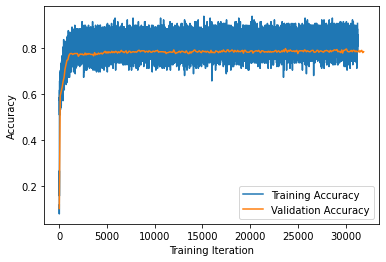

In [17]:
import matplotlib.pyplot as plt
plt.plot(range(len(training_accuracies)), training_accuracies, label = "Training Accuracy")
plt.plot(list(map(lambda x: x * 100, range(len(validation_accuracies)))), validation_accuracies, label = "Validation Accuracy")
plt.xlabel("Training Iteration")
plt.ylabel("Accuracy")
plt.legend()